In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 200000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01
sentence_pairs = False

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False
lstm_bidi = False

experiment_id = f"test"

In [3]:
# Parameters
max_training_samples = 200000
enable_orig = "preprocess"
enable_aug = False
enable_aug3 = False
sentence_pairs = False
regressive_style_finetuning = False
lstm_bidi = False
lstm_hidden_size = 64
epochs = 20
experiment_id = "classification-sentence-embeddings-max_training_samples-200000-enable_orig-preprocess-enable_aug-False-enable_aug3-False-sentence_pairs-False-regressive_style_finetuning-False-lstm_bidi-False-lstm_hidden_size-64-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random
from math import ceil

def get_train_valid():
    orig_data_uniform = split_equally(data, ceil(max_training_samples / 0.99))
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(orig_data_uniform, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_hash = hash_file(split_key + ".hkl")

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

print(len(train_x))

189419


In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

189419
189419
1914
1914


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{split_hash}"
if sentence_pairs:
    finetuning_data_key += "-pairs"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)
finetuning_data_hash = hash_file(finetuning_data_key + ".hkl")

  0%|          | 0/189419 [00:00<?, ?it/s]

  0%|          | 50/189419 [00:00<06:20, 497.21it/s]

  0%|          | 123/189419 [00:00<04:59, 632.61it/s]

  0%|          | 201/189419 [00:00<04:30, 698.46it/s]

  0%|          | 280/189419 [00:00<04:17, 733.94it/s]

  0%|          | 370/189419 [00:00<03:58, 793.09it/s]

  0%|          | 475/189419 [00:00<03:35, 876.38it/s]

  0%|          | 572/189419 [00:00<03:28, 903.74it/s]

  0%|          | 672/189419 [00:00<03:22, 933.97it/s]

  0%|          | 782/189419 [00:00<03:11, 985.16it/s]

  0%|          | 890/189419 [00:01<03:05, 1013.90it/s]

  1%|          | 992/189419 [00:01<03:59, 787.94it/s] 

  1%|          | 1099/189419 [00:01<03:39, 856.55it/s]

  1%|          | 1198/189419 [00:01<03:31, 887.98it/s]

  1%|          | 1292/189419 [00:01<03:30, 893.15it/s]

  1%|          | 1403/189419 [00:01<03:18, 948.54it/s]

  1%|          | 1501/189419 [00:01<03:16, 957.27it/s]

  1%|          | 1601/189419 [00:01<03:14, 966.10it/s]

  1%|          | 1711/189419 [00:01<03:07, 1003.62it/s]

  1%|          | 1815/189419 [00:02<03:06, 1008.49it/s]

  1%|          | 1923/189419 [00:02<03:02, 1028.90it/s]

  1%|          | 2027/189419 [00:02<03:01, 1031.90it/s]

  1%|          | 2136/189419 [00:02<02:58, 1047.76it/s]

  1%|          | 2242/189419 [00:02<02:58, 1049.57it/s]

  1%|          | 2348/189419 [00:02<03:00, 1037.83it/s]

  1%|▏         | 2464/189419 [00:02<02:54, 1072.68it/s]

  1%|▏         | 2583/189419 [00:02<02:48, 1106.35it/s]

  1%|▏         | 2694/189419 [00:02<02:51, 1090.19it/s]

  1%|▏         | 2804/189419 [00:02<02:50, 1092.39it/s]

  2%|▏         | 2914/189419 [00:03<02:52, 1082.98it/s]

  2%|▏         | 3025/189419 [00:03<02:51, 1085.41it/s]

  2%|▏         | 3143/189419 [00:03<02:47, 1111.31it/s]

  2%|▏         | 3255/189419 [00:03<02:48, 1104.62it/s]

  2%|▏         | 3366/189419 [00:03<02:48, 1105.16it/s]

  2%|▏         | 3477/189419 [00:03<02:52, 1079.96it/s]

  2%|▏         | 3586/189419 [00:03<02:51, 1081.80it/s]

  2%|▏         | 3709/189419 [00:03<02:45, 1125.17it/s]

  2%|▏         | 3835/189419 [00:03<02:39, 1162.70it/s]

  2%|▏         | 3952/189419 [00:03<02:40, 1152.85it/s]

  2%|▏         | 4068/189419 [00:04<02:43, 1136.67it/s]

  2%|▏         | 4182/189419 [00:04<02:46, 1112.43it/s]

  2%|▏         | 4297/189419 [00:04<02:45, 1121.65it/s]

  2%|▏         | 4410/189419 [00:04<02:47, 1106.86it/s]

  2%|▏         | 4530/189419 [00:04<02:43, 1132.44it/s]

  2%|▏         | 4644/189419 [00:04<02:46, 1112.85it/s]

  3%|▎         | 4757/189419 [00:04<02:45, 1116.93it/s]

  3%|▎         | 4875/189419 [00:04<02:42, 1134.22it/s]

  3%|▎         | 4996/189419 [00:04<02:39, 1155.08it/s]

  3%|▎         | 5112/189419 [00:04<02:45, 1113.73it/s]

  3%|▎         | 5226/189419 [00:05<02:44, 1121.07it/s]

  3%|▎         | 5344/189419 [00:05<02:42, 1133.95it/s]

  3%|▎         | 5459/189419 [00:05<02:41, 1137.64it/s]

  3%|▎         | 5573/189419 [00:05<02:46, 1105.05it/s]

  3%|▎         | 5692/189419 [00:05<02:42, 1128.48it/s]

  3%|▎         | 5812/189419 [00:05<02:40, 1146.93it/s]

  3%|▎         | 5935/189419 [00:05<02:36, 1169.55it/s]

  3%|▎         | 6053/189419 [00:05<02:37, 1160.88it/s]

  3%|▎         | 6170/189419 [00:05<02:40, 1140.97it/s]

  3%|▎         | 6291/189419 [00:06<02:37, 1160.95it/s]

  3%|▎         | 6409/189419 [00:06<02:36, 1165.95it/s]

  3%|▎         | 6527/189419 [00:06<02:36, 1167.85it/s]

  4%|▎         | 6644/189419 [00:06<02:38, 1152.41it/s]

  4%|▎         | 6771/189419 [00:06<02:34, 1183.90it/s]

  4%|▎         | 6890/189419 [00:06<02:37, 1155.95it/s]

  4%|▎         | 7006/189419 [00:06<02:38, 1148.96it/s]

  4%|▍         | 7132/189419 [00:06<02:34, 1180.36it/s]

  4%|▍         | 7251/189419 [00:06<02:35, 1172.04it/s]

  4%|▍         | 7377/189419 [00:06<02:32, 1193.75it/s]

  4%|▍         | 7502/189419 [00:07<02:30, 1208.69it/s]

  4%|▍         | 7623/189419 [00:07<02:33, 1183.74it/s]

  4%|▍         | 7742/189419 [00:07<02:37, 1150.90it/s]

  4%|▍         | 7862/189419 [00:07<02:36, 1163.64it/s]

  4%|▍         | 7985/189419 [00:07<02:34, 1178.04it/s]

  4%|▍         | 8103/189419 [00:07<02:35, 1168.35it/s]

  4%|▍         | 8220/189419 [00:07<02:35, 1166.58it/s]

  4%|▍         | 8340/189419 [00:07<02:34, 1174.45it/s]

  4%|▍         | 8458/189419 [00:07<03:36, 835.30it/s] 

  5%|▍         | 8569/189419 [00:08<03:21, 898.37it/s]

  5%|▍         | 8685/189419 [00:08<03:07, 961.89it/s]

  5%|▍         | 8796/189419 [00:08<03:00, 999.10it/s]

  5%|▍         | 8920/189419 [00:08<02:49, 1063.87it/s]

  5%|▍         | 9035/189419 [00:08<02:46, 1084.37it/s]

  5%|▍         | 9148/189419 [00:08<02:47, 1078.79it/s]

  5%|▍         | 9269/189419 [00:08<02:42, 1110.92it/s]

  5%|▍         | 9388/189419 [00:08<02:38, 1132.32it/s]

  5%|▌         | 9503/189419 [00:08<02:39, 1124.56it/s]

  5%|▌         | 9620/189419 [00:09<02:38, 1136.61it/s]

  5%|▌         | 9735/189419 [00:09<02:39, 1127.55it/s]

  5%|▌         | 9853/189419 [00:09<02:37, 1140.95it/s]

  5%|▌         | 9972/189419 [00:09<02:35, 1153.02it/s]

  5%|▌         | 10088/189419 [00:09<02:40, 1118.09it/s]

  5%|▌         | 10218/189419 [00:09<02:33, 1167.64it/s]

  5%|▌         | 10341/189419 [00:09<02:31, 1185.08it/s]

  6%|▌         | 10464/189419 [00:09<02:29, 1196.51it/s]

  6%|▌         | 10587/189419 [00:09<02:28, 1203.65it/s]

  6%|▌         | 10716/189419 [00:09<02:25, 1228.30it/s]

  6%|▌         | 10846/189419 [00:10<02:23, 1248.25it/s]

  6%|▌         | 10971/189419 [00:10<02:24, 1231.57it/s]

  6%|▌         | 11095/189419 [00:10<02:24, 1233.48it/s]

  6%|▌         | 11219/189419 [00:10<02:25, 1221.85it/s]

  6%|▌         | 11348/189419 [00:10<02:23, 1241.45it/s]

  6%|▌         | 11475/189419 [00:10<02:22, 1246.58it/s]

  6%|▌         | 11600/189419 [00:10<02:23, 1238.01it/s]

  6%|▌         | 11724/189419 [00:10<02:26, 1216.28it/s]

  6%|▋         | 11857/189419 [00:10<02:22, 1248.24it/s]

  6%|▋         | 11982/189419 [00:10<02:23, 1234.82it/s]

  6%|▋         | 12106/189419 [00:11<02:27, 1202.09it/s]

  6%|▋         | 12237/189419 [00:11<02:23, 1232.30it/s]

  7%|▋         | 12361/189419 [00:11<02:25, 1214.27it/s]

  7%|▋         | 12489/189419 [00:11<02:23, 1231.63it/s]

  7%|▋         | 12626/189419 [00:11<02:18, 1271.96it/s]

  7%|▋         | 12758/189419 [00:11<02:17, 1283.98it/s]

  7%|▋         | 12887/189419 [00:11<02:19, 1265.48it/s]

  7%|▋         | 13015/189419 [00:11<02:19, 1267.13it/s]

  7%|▋         | 13142/189419 [00:11<02:20, 1253.60it/s]

  7%|▋         | 13270/189419 [00:11<02:19, 1259.44it/s]

  7%|▋         | 13401/189419 [00:12<02:18, 1269.58it/s]

  7%|▋         | 13529/189419 [00:12<02:19, 1257.55it/s]

  7%|▋         | 13655/189419 [00:12<02:23, 1226.81it/s]

  7%|▋         | 13778/189419 [00:12<02:24, 1218.73it/s]

  7%|▋         | 13917/189419 [00:12<02:18, 1268.35it/s]

  7%|▋         | 14046/189419 [00:12<02:17, 1271.91it/s]

  7%|▋         | 14174/189419 [00:12<02:19, 1260.43it/s]

  8%|▊         | 14301/189419 [00:12<02:21, 1237.51it/s]

  8%|▊         | 14425/189419 [00:12<02:22, 1229.98it/s]

  8%|▊         | 14558/189419 [00:13<02:19, 1256.86it/s]

  8%|▊         | 14684/189419 [00:13<02:19, 1256.55it/s]

  8%|▊         | 14814/189419 [00:13<02:17, 1267.93it/s]

  8%|▊         | 14947/189419 [00:13<02:15, 1286.09it/s]

  8%|▊         | 15076/189419 [00:13<02:18, 1258.17it/s]

  8%|▊         | 15203/189419 [00:13<02:18, 1261.34it/s]

  8%|▊         | 15330/189419 [00:13<02:18, 1259.70it/s]

  8%|▊         | 15461/189419 [00:13<02:16, 1274.20it/s]

  8%|▊         | 15593/189419 [00:13<02:15, 1285.26it/s]

  8%|▊         | 15722/189419 [00:13<02:15, 1279.66it/s]

  8%|▊         | 15851/189419 [00:14<03:31, 822.06it/s] 

  8%|▊         | 15983/189419 [00:14<03:07, 926.07it/s]

  9%|▊         | 16117/189419 [00:14<02:49, 1020.39it/s]

  9%|▊         | 16243/189419 [00:14<02:40, 1078.60it/s]

  9%|▊         | 16379/189419 [00:14<02:30, 1152.32it/s]

  9%|▊         | 16504/189419 [00:14<02:31, 1143.07it/s]

  9%|▉         | 16625/189419 [00:14<02:30, 1147.54it/s]

  9%|▉         | 16745/189419 [00:14<02:28, 1159.68it/s]

  9%|▉         | 16867/189419 [00:15<02:26, 1174.76it/s]

  9%|▉         | 17003/189419 [00:15<02:20, 1225.45it/s]

  9%|▉         | 17128/189419 [00:15<02:22, 1208.85it/s]

  9%|▉         | 17260/189419 [00:15<02:18, 1241.04it/s]

  9%|▉         | 17391/189419 [00:15<02:16, 1260.28it/s]

  9%|▉         | 17526/189419 [00:15<02:13, 1283.28it/s]

  9%|▉         | 17655/189419 [00:15<02:16, 1257.24it/s]

  9%|▉         | 17782/189419 [00:15<02:16, 1255.28it/s]

  9%|▉         | 17916/189419 [00:15<02:14, 1277.61it/s]

 10%|▉         | 18051/189419 [00:15<02:12, 1298.21it/s]

 10%|▉         | 18189/189419 [00:16<02:09, 1318.78it/s]

 10%|▉         | 18322/189419 [00:16<02:11, 1301.35it/s]

 10%|▉         | 18461/189419 [00:16<02:08, 1326.90it/s]

 10%|▉         | 18594/189419 [00:16<02:09, 1317.61it/s]

 10%|▉         | 18726/189419 [00:16<02:11, 1301.29it/s]

 10%|▉         | 18860/189419 [00:16<02:10, 1310.38it/s]

 10%|█         | 18994/189419 [00:16<02:09, 1318.90it/s]

 10%|█         | 19126/189419 [00:16<02:14, 1263.63it/s]

 10%|█         | 19253/189419 [00:16<02:15, 1253.07it/s]

 10%|█         | 19379/189419 [00:16<02:17, 1234.29it/s]

 10%|█         | 19519/189419 [00:17<02:12, 1280.66it/s]

 10%|█         | 19659/189419 [00:17<02:09, 1313.70it/s]

 10%|█         | 19791/189419 [00:17<02:09, 1310.26it/s]

 11%|█         | 19925/189419 [00:17<02:08, 1318.67it/s]

 11%|█         | 20058/189419 [00:17<02:09, 1304.48it/s]

 11%|█         | 20189/189419 [00:17<02:11, 1289.91it/s]

 11%|█         | 20320/189419 [00:17<02:10, 1294.16it/s]

 11%|█         | 20450/189419 [00:17<02:12, 1280.05it/s]

 11%|█         | 20579/189419 [00:17<02:13, 1264.91it/s]

 11%|█         | 20717/189419 [00:18<02:10, 1296.59it/s]

 11%|█         | 20847/189419 [00:18<02:11, 1283.28it/s]

 11%|█         | 20976/189419 [00:18<02:11, 1281.27it/s]

 11%|█         | 21116/189419 [00:18<02:07, 1315.38it/s]

 11%|█         | 21248/189419 [00:18<02:09, 1302.35it/s]

 11%|█▏        | 21383/189419 [00:18<02:07, 1314.39it/s]

 11%|█▏        | 21517/189419 [00:18<02:07, 1320.02it/s]

 11%|█▏        | 21650/189419 [00:18<02:09, 1296.57it/s]

 11%|█▏        | 21780/189419 [00:18<02:10, 1288.61it/s]

 12%|█▏        | 21909/189419 [00:18<02:11, 1277.70it/s]

 12%|█▏        | 22037/189419 [00:19<02:13, 1256.28it/s]

 12%|█▏        | 22163/189419 [00:19<02:16, 1229.00it/s]

 12%|█▏        | 22293/189419 [00:19<02:14, 1244.14it/s]

 12%|█▏        | 22418/189419 [00:19<02:16, 1227.88it/s]

 12%|█▏        | 22541/189419 [00:19<02:17, 1209.37it/s]

 12%|█▏        | 22681/189419 [00:19<02:11, 1264.69it/s]

 12%|█▏        | 22808/189419 [00:19<02:13, 1249.16it/s]

 12%|█▏        | 22934/189419 [00:19<02:17, 1206.74it/s]

 12%|█▏        | 23056/189419 [00:19<02:19, 1190.68it/s]

 12%|█▏        | 23176/189419 [00:19<02:23, 1159.93it/s]

 12%|█▏        | 23305/189419 [00:20<02:18, 1196.49it/s]

 12%|█▏        | 23426/189419 [00:20<02:18, 1194.82it/s]

 12%|█▏        | 23549/189419 [00:20<02:17, 1204.44it/s]

 12%|█▏        | 23673/189419 [00:20<02:16, 1213.17it/s]

 13%|█▎        | 23798/189419 [00:20<02:15, 1218.57it/s]

 13%|█▎        | 23923/189419 [00:20<02:15, 1223.59it/s]

 13%|█▎        | 24054/189419 [00:20<02:12, 1244.81it/s]

 13%|█▎        | 24180/189419 [00:20<02:12, 1246.92it/s]

 13%|█▎        | 24305/189419 [00:20<02:13, 1232.88it/s]

 13%|█▎        | 24429/189419 [00:21<02:14, 1231.19it/s]

 13%|█▎        | 24553/189419 [00:21<03:56, 697.01it/s] 

 13%|█▎        | 24673/189419 [00:21<03:27, 792.53it/s]

 13%|█▎        | 24797/189419 [00:21<03:05, 888.92it/s]

 13%|█▎        | 24917/189419 [00:21<02:51, 961.46it/s]

 13%|█▎        | 25045/189419 [00:21<02:38, 1036.57it/s]

 13%|█▎        | 25163/189419 [00:21<02:32, 1073.70it/s]

 13%|█▎        | 25301/189419 [00:21<02:22, 1154.66it/s]

 13%|█▎        | 25428/189419 [00:22<02:18, 1184.98it/s]

 13%|█▎        | 25552/189419 [00:22<02:18, 1184.58it/s]

 14%|█▎        | 25688/189419 [00:22<02:12, 1234.24it/s]

 14%|█▎        | 25815/189419 [00:22<02:14, 1220.21it/s]

 14%|█▎        | 25946/189419 [00:22<02:11, 1243.96it/s]

 14%|█▍        | 26074/189419 [00:22<02:10, 1254.31it/s]

 14%|█▍        | 26203/189419 [00:22<02:09, 1264.42it/s]

 14%|█▍        | 26331/189419 [00:22<02:08, 1264.57it/s]

 14%|█▍        | 26458/189419 [00:22<02:11, 1243.33it/s]

 14%|█▍        | 26583/189419 [00:22<02:11, 1237.11it/s]

 14%|█▍        | 26708/189419 [00:23<02:13, 1215.09it/s]

 14%|█▍        | 26834/189419 [00:23<02:12, 1227.40it/s]

 14%|█▍        | 26959/189419 [00:23<02:11, 1232.46it/s]

 14%|█▍        | 27083/189419 [00:23<02:12, 1225.16it/s]

 14%|█▍        | 27219/189419 [00:23<02:08, 1260.27it/s]

 14%|█▍        | 27346/189419 [00:23<02:11, 1233.36it/s]

 15%|█▍        | 27471/189419 [00:23<02:10, 1236.47it/s]

 15%|█▍        | 27595/189419 [00:23<02:11, 1234.76it/s]

 15%|█▍        | 27723/189419 [00:23<02:09, 1247.11it/s]

 15%|█▍        | 27848/189419 [00:24<02:11, 1224.50it/s]

 15%|█▍        | 27971/189419 [00:24<02:13, 1208.02it/s]

 15%|█▍        | 28094/189419 [00:24<02:13, 1211.28it/s]

 15%|█▍        | 28223/189419 [00:24<02:10, 1233.59it/s]

 15%|█▍        | 28347/189419 [00:24<02:10, 1234.06it/s]

 15%|█▌        | 28473/189419 [00:24<02:09, 1241.31it/s]

 15%|█▌        | 28598/189419 [00:24<02:12, 1215.40it/s]

 15%|█▌        | 28720/189419 [00:24<02:12, 1211.61it/s]

 15%|█▌        | 28845/189419 [00:24<02:11, 1222.42it/s]

 15%|█▌        | 28970/189419 [00:24<02:10, 1228.08it/s]

 15%|█▌        | 29093/189419 [00:25<02:11, 1222.34it/s]

 15%|█▌        | 29216/189419 [00:25<02:12, 1211.49it/s]

 15%|█▌        | 29339/189419 [00:25<02:11, 1213.27it/s]

 16%|█▌        | 29465/189419 [00:25<02:10, 1223.45it/s]

 16%|█▌        | 29588/189419 [00:25<02:13, 1196.19it/s]

 16%|█▌        | 29710/189419 [00:25<02:12, 1201.81it/s]

 16%|█▌        | 29837/189419 [00:25<02:11, 1217.93it/s]

 16%|█▌        | 29963/189419 [00:25<02:09, 1230.03it/s]

 16%|█▌        | 30091/189419 [00:25<02:08, 1243.34it/s]

 16%|█▌        | 30216/189419 [00:25<02:10, 1218.90it/s]

 16%|█▌        | 30341/189419 [00:26<02:09, 1224.92it/s]

 16%|█▌        | 30464/189419 [00:26<02:09, 1224.80it/s]

 16%|█▌        | 30589/189419 [00:26<02:08, 1231.42it/s]

 16%|█▌        | 30718/189419 [00:26<02:07, 1245.05it/s]

 16%|█▋        | 30843/189419 [00:26<02:09, 1225.76it/s]

 16%|█▋        | 30973/189419 [00:26<02:07, 1245.36it/s]

 16%|█▋        | 31099/189419 [00:26<02:06, 1248.04it/s]

 16%|█▋        | 31224/189419 [00:26<02:11, 1202.70it/s]

 17%|█▋        | 31358/189419 [00:26<02:07, 1242.10it/s]

 17%|█▋        | 31487/189419 [00:26<02:05, 1255.01it/s]

 17%|█▋        | 31613/189419 [00:27<02:07, 1241.09it/s]

 17%|█▋        | 31738/189419 [00:27<02:08, 1224.82it/s]

 17%|█▋        | 31862/189419 [00:27<02:08, 1228.90it/s]

 17%|█▋        | 31986/189419 [00:27<02:11, 1201.01it/s]

 17%|█▋        | 32110/189419 [00:27<02:09, 1210.90it/s]

 17%|█▋        | 32232/189419 [00:27<02:11, 1197.82it/s]

 17%|█▋        | 32353/189419 [00:27<02:11, 1198.36it/s]

 17%|█▋        | 32480/189419 [00:27<02:08, 1217.74it/s]

 17%|█▋        | 32602/189419 [00:27<02:11, 1195.40it/s]

 17%|█▋        | 32722/189419 [00:28<02:11, 1193.43it/s]

 17%|█▋        | 32842/189419 [00:28<02:11, 1188.68it/s]

 17%|█▋        | 32963/189419 [00:28<02:11, 1193.28it/s]

 17%|█▋        | 33092/189419 [00:28<02:08, 1219.27it/s]

 18%|█▊        | 33214/189419 [00:28<02:11, 1185.04it/s]

 18%|█▊        | 33333/189419 [00:28<02:12, 1180.90it/s]

 18%|█▊        | 33452/189419 [00:28<02:12, 1178.20it/s]

 18%|█▊        | 33582/189419 [00:28<02:08, 1210.97it/s]

 18%|█▊        | 33706/189419 [00:28<02:07, 1217.27it/s]

 18%|█▊        | 33831/189419 [00:28<02:06, 1226.66it/s]

 18%|█▊        | 33958/189419 [00:29<02:05, 1237.50it/s]

 18%|█▊        | 34082/189419 [00:29<02:06, 1229.58it/s]

 18%|█▊        | 34213/189419 [00:29<02:03, 1251.70it/s]

 18%|█▊        | 34355/189419 [00:29<01:59, 1300.45it/s]

 18%|█▊        | 34486/189419 [00:29<01:59, 1293.96it/s]

 18%|█▊        | 34616/189419 [00:29<02:03, 1258.25it/s]

 18%|█▊        | 34743/189419 [00:29<02:03, 1253.03it/s]

 18%|█▊        | 34869/189419 [00:29<02:04, 1243.93it/s]

 18%|█▊        | 34994/189419 [00:29<02:06, 1219.10it/s]

 19%|█▊        | 35117/189419 [00:29<02:06, 1220.69it/s]

 19%|█▊        | 35240/189419 [00:30<02:07, 1205.47it/s]

 19%|█▊        | 35361/189419 [00:30<04:04, 630.79it/s] 

 19%|█▊        | 35471/189419 [00:30<03:35, 714.13it/s]

 19%|█▉        | 35592/189419 [00:30<03:08, 815.06it/s]

 19%|█▉        | 35719/189419 [00:30<02:47, 915.47it/s]

 19%|█▉        | 35844/189419 [00:30<02:34, 996.32it/s]

 19%|█▉        | 35968/189419 [00:30<02:24, 1058.63it/s]

 19%|█▉        | 36087/189419 [00:31<02:20, 1092.32it/s]

 19%|█▉        | 36211/189419 [00:31<02:15, 1130.28it/s]

 19%|█▉        | 36331/189419 [00:31<02:14, 1140.47it/s]

 19%|█▉        | 36450/189419 [00:31<02:12, 1151.81it/s]

 19%|█▉        | 36570/189419 [00:31<02:11, 1164.73it/s]

 19%|█▉        | 36693/189419 [00:31<02:09, 1180.90it/s]

 19%|█▉        | 36813/189419 [00:31<02:09, 1182.67it/s]

 19%|█▉        | 36935/189419 [00:31<02:07, 1192.42it/s]

 20%|█▉        | 37057/189419 [00:31<02:07, 1195.15it/s]

 20%|█▉        | 37178/189419 [00:31<02:07, 1197.87it/s]

 20%|█▉        | 37299/189419 [00:32<02:07, 1190.99it/s]

 20%|█▉        | 37438/189419 [00:32<02:01, 1248.07it/s]

 20%|█▉        | 37567/189419 [00:32<02:00, 1257.01it/s]

 20%|█▉        | 37693/189419 [00:32<02:05, 1208.51it/s]

 20%|█▉        | 37828/189419 [00:32<02:01, 1247.17it/s]

 20%|██        | 37957/189419 [00:32<02:00, 1253.41it/s]

 20%|██        | 38083/189419 [00:32<02:04, 1218.19it/s]

 20%|██        | 38208/189419 [00:32<02:03, 1219.60it/s]

 20%|██        | 38331/189419 [00:32<02:04, 1209.31it/s]

 20%|██        | 38462/189419 [00:33<02:01, 1237.58it/s]

 20%|██        | 38586/189419 [00:33<02:05, 1198.77it/s]

 20%|██        | 38714/189419 [00:33<02:03, 1221.34it/s]

 21%|██        | 38837/189419 [00:33<02:03, 1222.64it/s]

 21%|██        | 38960/189419 [00:33<02:05, 1198.44it/s]

 21%|██        | 39090/189419 [00:33<02:02, 1226.55it/s]

 21%|██        | 39214/189419 [00:33<02:02, 1229.14it/s]

 21%|██        | 39338/189419 [00:33<02:03, 1217.17it/s]

 21%|██        | 39460/189419 [00:33<02:05, 1196.14it/s]

 21%|██        | 39580/189419 [00:33<02:06, 1180.60it/s]

 21%|██        | 39705/189419 [00:34<02:05, 1195.85it/s]

 21%|██        | 39826/189419 [00:34<02:04, 1198.65it/s]

 21%|██        | 39946/189419 [00:34<02:08, 1163.81it/s]

 21%|██        | 40063/189419 [00:34<02:09, 1156.73it/s]

 21%|██        | 40184/189419 [00:34<02:07, 1170.89it/s]

 21%|██▏       | 40326/189419 [00:34<01:59, 1243.91it/s]

 21%|██▏       | 40458/189419 [00:34<01:57, 1265.57it/s]

 21%|██▏       | 40589/189419 [00:34<01:56, 1278.47it/s]

 21%|██▏       | 40718/189419 [00:34<01:57, 1264.08it/s]

 22%|██▏       | 40846/189419 [00:34<01:57, 1266.83it/s]

 22%|██▏       | 40983/189419 [00:35<01:54, 1295.66it/s]

 22%|██▏       | 41126/189419 [00:35<01:51, 1333.74it/s]

 22%|██▏       | 41260/189419 [00:35<01:53, 1306.12it/s]

 22%|██▏       | 41391/189419 [00:35<01:54, 1289.54it/s]

 22%|██▏       | 41527/189419 [00:35<01:53, 1307.67it/s]

 22%|██▏       | 41658/189419 [00:35<01:55, 1279.21it/s]

 22%|██▏       | 41787/189419 [00:35<01:56, 1263.61it/s]

 22%|██▏       | 41914/189419 [00:35<01:58, 1248.09it/s]

 22%|██▏       | 42039/189419 [00:35<01:59, 1238.09it/s]

 22%|██▏       | 42166/189419 [00:36<01:58, 1244.22it/s]

 22%|██▏       | 42294/189419 [00:36<01:57, 1254.56it/s]

 22%|██▏       | 42421/189419 [00:36<01:57, 1255.06it/s]

 22%|██▏       | 42547/189419 [00:36<01:57, 1248.77it/s]

 23%|██▎       | 42672/189419 [00:36<02:00, 1222.70it/s]

 23%|██▎       | 42795/189419 [00:36<02:02, 1198.74it/s]

 23%|██▎       | 42936/189419 [00:36<01:56, 1258.88it/s]

 23%|██▎       | 43070/189419 [00:36<01:54, 1282.07it/s]

 23%|██▎       | 43199/189419 [00:36<01:55, 1261.58it/s]

 23%|██▎       | 43326/189419 [00:36<01:56, 1257.58it/s]

 23%|██▎       | 43452/189419 [00:37<01:58, 1227.67it/s]

 23%|██▎       | 43575/189419 [00:37<01:59, 1221.70it/s]

 23%|██▎       | 43703/189419 [00:37<01:57, 1238.72it/s]

 23%|██▎       | 43832/189419 [00:37<01:56, 1253.78it/s]

 23%|██▎       | 43958/189419 [00:37<01:59, 1219.46it/s]

 23%|██▎       | 44095/189419 [00:37<01:55, 1262.45it/s]

 23%|██▎       | 44230/189419 [00:37<01:52, 1286.89it/s]

 23%|██▎       | 44359/189419 [00:37<01:53, 1278.94it/s]

 23%|██▎       | 44488/189419 [00:37<01:53, 1271.72it/s]

 24%|██▎       | 44616/189419 [00:37<01:56, 1247.06it/s]

 24%|██▎       | 44752/189419 [00:38<01:53, 1279.80it/s]

 24%|██▎       | 44881/189419 [00:38<01:55, 1250.98it/s]

 24%|██▍       | 45007/189419 [00:38<01:58, 1219.70it/s]

 24%|██▍       | 45130/189419 [00:38<01:58, 1218.88it/s]

 24%|██▍       | 45253/189419 [00:38<01:59, 1207.25it/s]

 24%|██▍       | 45383/189419 [00:38<01:56, 1233.80it/s]

 24%|██▍       | 45512/189419 [00:38<01:55, 1247.35it/s]

 24%|██▍       | 45649/189419 [00:38<01:52, 1283.44it/s]

 24%|██▍       | 45778/189419 [00:38<01:53, 1264.24it/s]

 24%|██▍       | 45908/189419 [00:39<01:52, 1272.44it/s]

 24%|██▍       | 46037/189419 [00:39<01:52, 1274.31it/s]

 24%|██▍       | 46165/189419 [00:39<01:54, 1251.56it/s]

 24%|██▍       | 46298/189419 [00:39<01:52, 1271.79it/s]

 25%|██▍       | 46428/189419 [00:39<01:51, 1279.88it/s]

 25%|██▍       | 46560/189419 [00:39<01:50, 1288.19it/s]

 25%|██▍       | 46689/189419 [00:39<01:54, 1243.24it/s]

 25%|██▍       | 46814/189419 [00:39<01:54, 1242.31it/s]

 25%|██▍       | 46942/189419 [00:39<01:53, 1252.85it/s]

 25%|██▍       | 47072/189419 [00:39<01:52, 1264.68it/s]

 25%|██▍       | 47199/189419 [00:40<01:52, 1263.27it/s]

 25%|██▍       | 47326/189419 [00:40<01:54, 1243.63it/s]

 25%|██▌       | 47451/189419 [00:40<01:55, 1228.55it/s]

 25%|██▌       | 47574/189419 [00:40<01:57, 1209.86it/s]

 25%|██▌       | 47701/189419 [00:40<01:55, 1226.42it/s]

 25%|██▌       | 47835/189419 [00:40<01:52, 1258.79it/s]

 25%|██▌       | 47962/189419 [00:40<01:54, 1240.41it/s]

 25%|██▌       | 48088/189419 [00:40<01:53, 1245.73it/s]

 25%|██▌       | 48222/189419 [00:40<01:51, 1270.22it/s]

 26%|██▌       | 48350/189419 [00:40<01:52, 1251.88it/s]

 26%|██▌       | 48478/189419 [00:41<01:52, 1256.43it/s]

 26%|██▌       | 48604/189419 [00:41<01:54, 1229.30it/s]

 26%|██▌       | 48728/189419 [00:41<04:13, 554.99it/s] 

 26%|██▌       | 48855/189419 [00:41<03:30, 667.42it/s]

 26%|██▌       | 48990/189419 [00:41<02:57, 792.80it/s]

 26%|██▌       | 49119/189419 [00:41<02:36, 895.64it/s]

 26%|██▌       | 49240/189419 [00:42<02:25, 966.19it/s]

 26%|██▌       | 49359/189419 [00:42<02:17, 1016.86it/s]

 26%|██▌       | 49480/189419 [00:42<02:11, 1065.96it/s]

 26%|██▌       | 49604/189419 [00:42<02:05, 1111.19it/s]

 26%|██▋       | 49730/189419 [00:42<02:01, 1151.35it/s]

 26%|██▋       | 49852/189419 [00:42<02:01, 1149.74it/s]

 26%|██▋       | 49984/189419 [00:42<01:56, 1197.89it/s]

 26%|██▋       | 50115/189419 [00:42<01:53, 1229.21it/s]

 27%|██▋       | 50241/189419 [00:42<01:52, 1232.35it/s]

 27%|██▋       | 50367/189419 [00:43<01:54, 1217.41it/s]

 27%|██▋       | 50496/189419 [00:43<01:52, 1237.76it/s]

 27%|██▋       | 50627/189419 [00:43<01:51, 1248.33it/s]

 27%|██▋       | 50758/189419 [00:43<01:49, 1265.54it/s]

 27%|██▋       | 50890/189419 [00:43<01:48, 1277.89it/s]

 27%|██▋       | 51022/189419 [00:43<01:47, 1284.81it/s]

 27%|██▋       | 51151/189419 [00:43<01:48, 1273.94it/s]

 27%|██▋       | 51279/189419 [00:43<01:49, 1265.34it/s]

 27%|██▋       | 51408/189419 [00:43<01:48, 1267.90it/s]

 27%|██▋       | 51535/189419 [00:43<01:49, 1260.01it/s]

 27%|██▋       | 51667/189419 [00:44<01:48, 1274.06it/s]

 27%|██▋       | 51795/189419 [00:44<01:50, 1246.71it/s]

 27%|██▋       | 51921/189419 [00:44<01:50, 1249.04it/s]

 27%|██▋       | 52047/189419 [00:44<01:51, 1232.88it/s]

 28%|██▊       | 52171/189419 [00:44<01:51, 1232.82it/s]

 28%|██▊       | 52297/189419 [00:44<01:50, 1240.73it/s]

 28%|██▊       | 52439/189419 [00:44<01:46, 1290.26it/s]

 28%|██▊       | 52569/189419 [00:44<01:47, 1270.88it/s]

 28%|██▊       | 52697/189419 [00:44<01:49, 1243.17it/s]

 28%|██▊       | 52825/189419 [00:44<01:49, 1248.70it/s]

 28%|██▊       | 52951/189419 [00:45<01:49, 1247.21it/s]

 28%|██▊       | 53076/189419 [00:45<01:49, 1240.93it/s]

 28%|██▊       | 53212/189419 [00:45<01:47, 1271.96it/s]

 28%|██▊       | 53340/189419 [00:45<01:47, 1261.50it/s]

 28%|██▊       | 53468/189419 [00:45<01:47, 1263.12it/s]

 28%|██▊       | 53595/189419 [00:45<01:47, 1263.47it/s]

 28%|██▊       | 53722/189419 [00:45<01:48, 1255.62it/s]

 28%|██▊       | 53848/189419 [00:45<01:48, 1250.67it/s]

 28%|██▊       | 53974/189419 [00:45<01:48, 1247.33it/s]

 29%|██▊       | 54106/189419 [00:45<01:46, 1267.70it/s]

 29%|██▊       | 54233/189419 [00:46<01:48, 1242.35it/s]

 29%|██▊       | 54360/189419 [00:46<01:48, 1246.63it/s]

 29%|██▉       | 54495/189419 [00:46<01:45, 1273.29it/s]

 29%|██▉       | 54624/189419 [00:46<01:45, 1277.21it/s]

 29%|██▉       | 54759/189419 [00:46<01:43, 1298.07it/s]

 29%|██▉       | 54889/189419 [00:46<01:44, 1285.68it/s]

 29%|██▉       | 55022/189419 [00:46<01:44, 1288.69it/s]

 29%|██▉       | 55155/189419 [00:46<01:43, 1295.76it/s]

 29%|██▉       | 55290/189419 [00:46<01:42, 1310.27it/s]

 29%|██▉       | 55422/189419 [00:46<01:43, 1294.33it/s]

 29%|██▉       | 55552/189419 [00:47<01:43, 1289.87it/s]

 29%|██▉       | 55687/189419 [00:47<01:42, 1305.14it/s]

 29%|██▉       | 55818/189419 [00:47<01:43, 1284.69it/s]

 30%|██▉       | 55951/189419 [00:47<01:42, 1297.70it/s]

 30%|██▉       | 56088/189419 [00:47<01:41, 1318.97it/s]

 30%|██▉       | 56220/189419 [00:47<01:41, 1307.21it/s]

 30%|██▉       | 56366/189419 [00:47<01:38, 1350.59it/s]

 30%|██▉       | 56502/189419 [00:47<01:40, 1324.78it/s]

 30%|██▉       | 56645/189419 [00:47<01:38, 1354.00it/s]

 30%|██▉       | 56781/189419 [00:48<01:40, 1314.06it/s]

 30%|███       | 56913/189419 [00:48<01:41, 1304.19it/s]

 30%|███       | 57046/189419 [00:48<01:41, 1309.53it/s]

 30%|███       | 57181/189419 [00:48<01:40, 1318.83it/s]

 30%|███       | 57314/189419 [00:48<01:40, 1316.20it/s]

 30%|███       | 57446/189419 [00:48<01:41, 1294.91it/s]

 30%|███       | 57582/189419 [00:48<01:40, 1313.12it/s]

 30%|███       | 57714/189419 [00:48<01:42, 1288.53it/s]

 31%|███       | 57852/189419 [00:48<01:40, 1313.81it/s]

 31%|███       | 57984/189419 [00:48<01:44, 1255.77it/s]

 31%|███       | 58111/189419 [00:49<01:45, 1244.14it/s]

 31%|███       | 58236/189419 [00:49<01:45, 1239.54it/s]

 31%|███       | 58374/189419 [00:49<01:42, 1279.29it/s]

 31%|███       | 58503/189419 [00:49<01:44, 1255.07it/s]

 31%|███       | 58633/189419 [00:49<01:43, 1267.83it/s]

 31%|███       | 58761/189419 [00:49<01:44, 1252.97it/s]

 31%|███       | 58897/189419 [00:49<01:41, 1281.08it/s]

 31%|███       | 59032/189419 [00:49<01:40, 1297.23it/s]

 31%|███       | 59162/189419 [00:49<01:40, 1294.46it/s]

 31%|███▏      | 59292/189419 [00:49<01:41, 1285.25it/s]

 31%|███▏      | 59421/189419 [00:50<01:43, 1252.75it/s]

 31%|███▏      | 59556/189419 [00:50<01:41, 1280.46it/s]

 32%|███▏      | 59689/189419 [00:50<01:40, 1294.84it/s]

 32%|███▏      | 59819/189419 [00:50<01:40, 1295.13it/s]

 32%|███▏      | 59956/189419 [00:50<01:38, 1316.74it/s]

 32%|███▏      | 60088/189419 [00:50<01:39, 1296.50it/s]

 32%|███▏      | 60218/189419 [00:50<01:42, 1264.03it/s]

 32%|███▏      | 60345/189419 [00:50<01:44, 1235.60it/s]

 32%|███▏      | 60492/189419 [00:50<01:38, 1302.36it/s]

 32%|███▏      | 60623/189419 [00:51<01:39, 1300.36it/s]

 32%|███▏      | 60754/189419 [00:51<01:43, 1244.35it/s]

 32%|███▏      | 60880/189419 [00:51<01:46, 1211.21it/s]

 32%|███▏      | 61005/189419 [00:51<01:45, 1219.95it/s]

 32%|███▏      | 61128/189419 [00:51<01:46, 1204.01it/s]

 32%|███▏      | 61263/189419 [00:51<01:42, 1245.68it/s]

 32%|███▏      | 61388/189419 [00:51<01:44, 1227.63it/s]

 32%|███▏      | 61521/189419 [00:51<01:41, 1254.99it/s]

 33%|███▎      | 61648/189419 [00:51<01:41, 1258.06it/s]

 33%|███▎      | 61774/189419 [00:51<01:44, 1216.11it/s]

 33%|███▎      | 61910/189419 [00:52<01:41, 1257.45it/s]

 33%|███▎      | 62040/189419 [00:52<01:40, 1267.15it/s]

 33%|███▎      | 62168/189419 [00:52<01:40, 1266.37it/s]

 33%|███▎      | 62295/189419 [00:52<01:41, 1251.56it/s]

 33%|███▎      | 62427/189419 [00:52<01:40, 1266.00it/s]

 33%|███▎      | 62560/189419 [00:52<01:38, 1282.59it/s]

 33%|███▎      | 62689/189419 [00:52<01:41, 1254.20it/s]

 33%|███▎      | 62815/189419 [00:52<01:43, 1228.17it/s]

 33%|███▎      | 62940/189419 [00:52<01:42, 1232.12it/s]

 33%|███▎      | 63068/189419 [00:52<01:41, 1243.45it/s]

 33%|███▎      | 63197/189419 [00:53<01:40, 1253.27it/s]

 33%|███▎      | 63330/189419 [00:53<01:38, 1275.19it/s]

 34%|███▎      | 63458/189419 [00:53<01:38, 1273.32it/s]

 34%|███▎      | 63586/189419 [00:53<01:39, 1263.48it/s]

 34%|███▎      | 63713/189419 [00:53<01:39, 1260.85it/s]

 34%|███▎      | 63840/189419 [00:53<01:40, 1252.98it/s]

 34%|███▍      | 63966/189419 [00:53<01:40, 1247.48it/s]

 34%|███▍      | 64091/189419 [00:53<01:42, 1227.50it/s]

 34%|███▍      | 64217/189419 [00:53<01:41, 1234.14it/s]

 34%|███▍      | 64341/189419 [00:54<01:41, 1235.01it/s]

 34%|███▍      | 64465/189419 [00:54<01:42, 1220.19it/s]

 34%|███▍      | 64591/189419 [00:54<01:41, 1231.84it/s]

 34%|███▍      | 64715/189419 [00:54<01:41, 1227.99it/s]

 34%|███▍      | 64840/189419 [00:54<01:40, 1234.15it/s]

 34%|███▍      | 64964/189419 [00:54<01:41, 1222.14it/s]

 34%|███▍      | 65091/189419 [00:54<01:40, 1232.60it/s]

 34%|███▍      | 65215/189419 [00:54<01:41, 1221.57it/s]

 34%|███▍      | 65338/189419 [00:54<01:43, 1204.19it/s]

 35%|███▍      | 65459/189419 [00:55<04:19, 478.29it/s] 

 35%|███▍      | 65588/189419 [00:55<03:28, 593.84it/s]

 35%|███▍      | 65714/189419 [00:55<02:55, 705.02it/s]

 35%|███▍      | 65835/189419 [00:55<02:33, 802.88it/s]

 35%|███▍      | 65956/189419 [00:55<02:18, 888.84it/s]

 35%|███▍      | 66079/189419 [00:55<02:07, 968.61it/s]

 35%|███▍      | 66205/189419 [00:56<01:58, 1040.29it/s]

 35%|███▌      | 66336/189419 [00:56<01:51, 1108.84it/s]

 35%|███▌      | 66463/189419 [00:56<01:47, 1148.65it/s]

 35%|███▌      | 66590/189419 [00:56<01:44, 1180.34it/s]

 35%|███▌      | 66717/189419 [00:56<01:41, 1203.09it/s]

 35%|███▌      | 66844/189419 [00:56<01:40, 1222.20it/s]

 35%|███▌      | 66970/189419 [00:56<01:40, 1216.23it/s]

 35%|███▌      | 67094/189419 [00:56<01:41, 1202.68it/s]

 35%|███▌      | 67216/189419 [00:56<01:41, 1198.20it/s]

 36%|███▌      | 67337/189419 [00:56<01:42, 1193.49it/s]

 36%|███▌      | 67458/189419 [00:57<01:42, 1192.44it/s]

 36%|███▌      | 67585/189419 [00:57<01:40, 1215.00it/s]

 36%|███▌      | 67714/189419 [00:57<01:38, 1236.43it/s]

 36%|███▌      | 67840/189419 [00:57<01:37, 1242.15it/s]

 36%|███▌      | 67967/189419 [00:57<01:37, 1250.16it/s]

 36%|███▌      | 68093/189419 [00:57<01:36, 1251.26it/s]

 36%|███▌      | 68219/189419 [00:57<01:37, 1239.42it/s]

 36%|███▌      | 68346/189419 [00:57<01:37, 1246.23it/s]

 36%|███▌      | 68473/189419 [00:57<01:36, 1252.90it/s]

 36%|███▌      | 68599/189419 [00:57<01:36, 1247.47it/s]

 36%|███▋      | 68727/189419 [00:58<01:36, 1248.82it/s]

 36%|███▋      | 68852/189419 [00:58<01:38, 1228.67it/s]

 36%|███▋      | 68988/189419 [00:58<01:35, 1265.49it/s]

 36%|███▋      | 69115/189419 [00:58<01:35, 1260.78it/s]

 37%|███▋      | 69248/189419 [00:58<01:33, 1278.90it/s]

 37%|███▋      | 69380/189419 [00:58<01:33, 1289.83it/s]

 37%|███▋      | 69510/189419 [00:58<01:33, 1283.19it/s]

 37%|███▋      | 69639/189419 [00:58<01:34, 1269.05it/s]

 37%|███▋      | 69766/189419 [00:58<01:34, 1264.32it/s]

 37%|███▋      | 69893/189419 [00:59<01:35, 1253.46it/s]

 37%|███▋      | 70019/189419 [00:59<01:35, 1251.29it/s]

 37%|███▋      | 70145/189419 [00:59<01:38, 1212.78it/s]

 37%|███▋      | 70274/189419 [00:59<01:36, 1233.18it/s]

 37%|███▋      | 70398/189419 [00:59<01:39, 1197.64it/s]

 37%|███▋      | 70535/189419 [00:59<01:35, 1246.60it/s]

 37%|███▋      | 70665/189419 [00:59<01:34, 1261.77it/s]

 37%|███▋      | 70792/189419 [00:59<01:34, 1254.53it/s]

 37%|███▋      | 70922/189419 [00:59<01:33, 1263.87it/s]

 38%|███▊      | 71050/189419 [00:59<01:33, 1267.55it/s]

 38%|███▊      | 71177/189419 [01:00<01:33, 1258.53it/s]

 38%|███▊      | 71304/189419 [01:00<01:33, 1257.42it/s]

 38%|███▊      | 71430/189419 [01:00<01:36, 1219.78it/s]

 38%|███▊      | 71560/189419 [01:00<01:34, 1241.97it/s]

 38%|███▊      | 71699/189419 [01:00<01:32, 1279.22it/s]

 38%|███▊      | 71828/189419 [01:00<01:34, 1248.89it/s]

 38%|███▊      | 71954/189419 [01:00<01:34, 1238.60it/s]

 38%|███▊      | 72080/189419 [01:00<01:34, 1244.23it/s]

 38%|███▊      | 72205/189419 [01:00<01:35, 1231.49it/s]

 38%|███▊      | 72330/189419 [01:00<01:34, 1236.42it/s]

 38%|███▊      | 72456/189419 [01:01<01:34, 1242.13it/s]

 38%|███▊      | 72581/189419 [01:01<01:35, 1221.30it/s]

 38%|███▊      | 72707/189419 [01:01<01:34, 1231.60it/s]

 38%|███▊      | 72836/189419 [01:01<01:33, 1245.68it/s]

 39%|███▊      | 72967/189419 [01:01<01:32, 1264.25it/s]

 39%|███▊      | 73094/189419 [01:01<01:32, 1253.97it/s]

 39%|███▊      | 73221/189419 [01:01<01:32, 1256.87it/s]

 39%|███▊      | 73347/189419 [01:01<01:33, 1245.45it/s]

 39%|███▉      | 73472/189419 [01:01<01:36, 1199.98it/s]

 39%|███▉      | 73597/189419 [01:02<01:35, 1213.78it/s]

 39%|███▉      | 73724/189419 [01:02<01:34, 1228.27it/s]

 39%|███▉      | 73861/189419 [01:02<01:31, 1267.64it/s]

 39%|███▉      | 73991/189419 [01:02<01:30, 1275.75it/s]

 39%|███▉      | 74119/189419 [01:02<01:31, 1264.71it/s]

 39%|███▉      | 74257/189419 [01:02<01:28, 1297.36it/s]

 39%|███▉      | 74397/189419 [01:02<01:26, 1326.47it/s]

 39%|███▉      | 74533/189419 [01:02<01:25, 1336.16it/s]

 39%|███▉      | 74667/189419 [01:02<01:28, 1292.99it/s]

 39%|███▉      | 74804/189419 [01:02<01:27, 1314.17it/s]

 40%|███▉      | 74940/189419 [01:03<01:26, 1322.05it/s]

 40%|███▉      | 75073/189419 [01:03<01:28, 1290.28it/s]

 40%|███▉      | 75203/189419 [01:03<01:29, 1269.88it/s]

 40%|███▉      | 75331/189419 [01:03<01:30, 1259.96it/s]

 40%|███▉      | 75458/189419 [01:03<01:31, 1248.27it/s]

 40%|███▉      | 75592/189419 [01:03<01:29, 1274.75it/s]

 40%|███▉      | 75720/189419 [01:03<01:30, 1257.47it/s]

 40%|████      | 75855/189419 [01:03<01:28, 1283.33it/s]

 40%|████      | 75984/189419 [01:03<01:29, 1268.42it/s]

 40%|████      | 76111/189419 [01:03<01:30, 1245.45it/s]

 40%|████      | 76247/189419 [01:04<01:28, 1276.43it/s]

 40%|████      | 76375/189419 [01:04<01:30, 1253.99it/s]

 40%|████      | 76507/189419 [01:04<01:28, 1272.50it/s]

 40%|████      | 76635/189419 [01:04<01:30, 1251.70it/s]

 41%|████      | 76762/189419 [01:04<01:29, 1256.00it/s]

 41%|████      | 76894/189419 [01:04<01:28, 1273.84it/s]

 41%|████      | 77022/189419 [01:04<01:29, 1256.97it/s]

 41%|████      | 77160/189419 [01:04<01:26, 1291.59it/s]

 41%|████      | 77290/189419 [01:04<01:27, 1282.56it/s]

 41%|████      | 77419/189419 [01:04<01:29, 1258.04it/s]

 41%|████      | 77546/189419 [01:05<01:28, 1257.98it/s]

 41%|████      | 77685/189419 [01:05<01:26, 1295.90it/s]

 41%|████      | 77828/189419 [01:05<01:23, 1333.09it/s]

 41%|████      | 77962/189419 [01:05<01:26, 1294.10it/s]

 41%|████      | 78092/189419 [01:05<01:27, 1265.91it/s]

 41%|████▏     | 78219/189419 [01:05<01:29, 1243.57it/s]

 41%|████▏     | 78356/189419 [01:05<01:26, 1278.62it/s]

 41%|████▏     | 78485/189419 [01:05<01:28, 1256.62it/s]

 42%|████▏     | 78616/189419 [01:05<01:27, 1272.03it/s]

 42%|████▏     | 78749/189419 [01:06<01:25, 1288.68it/s]

 42%|████▏     | 78879/189419 [01:06<01:26, 1282.09it/s]

 42%|████▏     | 79008/189419 [01:06<01:28, 1254.29it/s]

 42%|████▏     | 79134/189419 [01:06<01:28, 1248.22it/s]

 42%|████▏     | 79259/189419 [01:06<01:29, 1235.46it/s]

 42%|████▏     | 79383/189419 [01:06<01:30, 1214.39it/s]

 42%|████▏     | 79508/189419 [01:06<01:29, 1222.71it/s]

 42%|████▏     | 79631/189419 [01:06<01:30, 1215.16it/s]

 42%|████▏     | 79753/189419 [01:06<01:30, 1214.10it/s]

 42%|████▏     | 79892/189419 [01:06<01:26, 1263.31it/s]

 42%|████▏     | 80019/189419 [01:07<01:29, 1225.93it/s]

 42%|████▏     | 80146/189419 [01:07<01:28, 1237.31it/s]

 42%|████▏     | 80270/189419 [01:07<01:28, 1235.73it/s]

 42%|████▏     | 80394/189419 [01:07<01:28, 1236.91it/s]

 43%|████▎     | 80518/189419 [01:07<01:30, 1208.06it/s]

 43%|████▎     | 80648/189419 [01:07<01:28, 1232.93it/s]

 43%|████▎     | 80772/189419 [01:07<01:29, 1209.60it/s]

 43%|████▎     | 80903/189419 [01:07<01:27, 1238.64it/s]

 43%|████▎     | 81039/189419 [01:07<01:25, 1273.51it/s]

 43%|████▎     | 81167/189419 [01:07<01:25, 1261.63it/s]

 43%|████▎     | 81299/189419 [01:08<01:24, 1278.18it/s]

 43%|████▎     | 81427/189419 [01:08<01:25, 1269.69it/s]

 43%|████▎     | 81555/189419 [01:08<01:24, 1272.66it/s]

 43%|████▎     | 81685/189419 [01:08<01:24, 1279.84it/s]

 43%|████▎     | 81816/189419 [01:08<01:23, 1287.80it/s]

 43%|████▎     | 81948/189419 [01:08<01:22, 1295.29it/s]

 43%|████▎     | 82078/189419 [01:08<01:25, 1261.24it/s]

 43%|████▎     | 82205/189419 [01:08<01:26, 1245.92it/s]

 43%|████▎     | 82346/189419 [01:08<01:22, 1293.34it/s]

 44%|████▎     | 82476/189419 [01:09<01:23, 1285.22it/s]

 44%|████▎     | 82605/189419 [01:09<01:24, 1264.42it/s]

 44%|████▎     | 82732/189419 [01:09<01:25, 1248.64it/s]

 44%|████▍     | 82871/189419 [01:09<01:22, 1289.01it/s]

 44%|████▍     | 83001/189419 [01:09<01:22, 1285.22it/s]

 44%|████▍     | 83136/189419 [01:09<01:21, 1301.51it/s]

 44%|████▍     | 83267/189419 [01:09<01:24, 1262.98it/s]

 44%|████▍     | 83395/189419 [01:09<01:23, 1266.69it/s]

 44%|████▍     | 83522/189419 [01:09<01:23, 1263.12it/s]

 44%|████▍     | 83657/189419 [01:09<01:22, 1287.55it/s]

 44%|████▍     | 83794/189419 [01:10<01:20, 1310.65it/s]

 44%|████▍     | 83926/189419 [01:10<01:20, 1305.87it/s]

 44%|████▍     | 84057/189419 [01:10<01:21, 1285.45it/s]

 44%|████▍     | 84192/189419 [01:10<01:20, 1302.34it/s]

 45%|████▍     | 84323/189419 [01:10<01:21, 1296.41it/s]

 45%|████▍     | 84453/189419 [01:10<01:22, 1267.03it/s]

 45%|████▍     | 84585/189419 [01:10<01:21, 1282.43it/s]

 45%|████▍     | 84714/189419 [01:10<01:24, 1244.41it/s]

 45%|████▍     | 84846/189419 [01:10<01:22, 1262.83it/s]

 45%|████▍     | 84973/189419 [01:10<01:22, 1262.35it/s]

 45%|████▍     | 85100/189419 [01:11<01:23, 1247.95it/s]

 45%|████▍     | 85225/189419 [01:11<01:23, 1248.18it/s]

 45%|████▌     | 85350/189419 [01:11<01:23, 1248.44it/s]

 45%|████▌     | 85475/189419 [01:11<01:23, 1247.75it/s]

 45%|████▌     | 85600/189419 [01:11<01:25, 1213.53it/s]

 45%|████▌     | 85723/189419 [01:11<01:25, 1213.77it/s]

 45%|████▌     | 85856/189419 [01:11<01:23, 1247.47it/s]

 45%|████▌     | 85996/189419 [01:11<01:20, 1285.31it/s]

 45%|████▌     | 86125/189419 [01:12<04:02, 426.36it/s] 

 46%|████▌     | 86260/189419 [01:12<03:11, 539.51it/s]

 46%|████▌     | 86391/189419 [01:12<02:37, 654.31it/s]

 46%|████▌     | 86523/189419 [01:12<02:13, 770.78it/s]

 46%|████▌     | 86662/189419 [01:12<01:54, 894.43it/s]

 46%|████▌     | 86788/189419 [01:13<01:47, 954.30it/s]

 46%|████▌     | 86911/189419 [01:13<01:40, 1019.61it/s]

 46%|████▌     | 87043/189419 [01:13<01:33, 1095.03it/s]

 46%|████▌     | 87176/189419 [01:13<01:28, 1155.01it/s]

 46%|████▌     | 87304/189419 [01:13<01:26, 1178.17it/s]

 46%|████▌     | 87431/189419 [01:13<01:27, 1160.00it/s]

 46%|████▌     | 87564/189419 [01:13<01:24, 1205.23it/s]

 46%|████▋     | 87689/189419 [01:13<01:25, 1191.11it/s]

 46%|████▋     | 87814/189419 [01:13<01:24, 1206.28it/s]

 46%|████▋     | 87941/189419 [01:14<01:23, 1221.60it/s]

 46%|████▋     | 88072/189419 [01:14<01:21, 1246.59it/s]

 47%|████▋     | 88209/189419 [01:14<01:19, 1279.47it/s]

 47%|████▋     | 88338/189419 [01:14<01:18, 1280.76it/s]

 47%|████▋     | 88473/189419 [01:14<01:17, 1300.53it/s]

 47%|████▋     | 88604/189419 [01:14<01:17, 1303.28it/s]

 47%|████▋     | 88741/189419 [01:14<01:16, 1311.12it/s]

 47%|████▋     | 88874/189419 [01:14<01:16, 1316.67it/s]

 47%|████▋     | 89011/189419 [01:14<01:15, 1329.83it/s]

 47%|████▋     | 89145/189419 [01:14<01:15, 1323.12it/s]

 47%|████▋     | 89278/189419 [01:15<01:16, 1312.45it/s]

 47%|████▋     | 89410/189419 [01:15<01:16, 1307.99it/s]

 47%|████▋     | 89549/189419 [01:15<01:15, 1328.04it/s]

 47%|████▋     | 89682/189419 [01:15<01:15, 1325.47it/s]

 47%|████▋     | 89819/189419 [01:15<01:14, 1335.76it/s]

 47%|████▋     | 89954/189419 [01:15<01:14, 1337.57it/s]

 48%|████▊     | 90097/189419 [01:15<01:12, 1363.67it/s]

 48%|████▊     | 90234/189419 [01:15<01:15, 1320.77it/s]

 48%|████▊     | 90367/189419 [01:15<01:17, 1280.24it/s]

 48%|████▊     | 90496/189419 [01:15<01:17, 1271.27it/s]

 48%|████▊     | 90632/189419 [01:16<01:16, 1296.20it/s]

 48%|████▊     | 90762/189419 [01:16<01:16, 1287.14it/s]

 48%|████▊     | 90891/189419 [01:16<01:17, 1274.34it/s]

 48%|████▊     | 91019/189419 [01:16<01:17, 1263.02it/s]

 48%|████▊     | 91146/189419 [01:16<01:19, 1240.66it/s]

 48%|████▊     | 91276/189419 [01:16<01:18, 1257.67it/s]

 48%|████▊     | 91402/189419 [01:16<01:17, 1256.63it/s]

 48%|████▊     | 91536/189419 [01:16<01:16, 1274.17it/s]

 48%|████▊     | 91664/189419 [01:16<01:17, 1265.62it/s]

 48%|████▊     | 91791/189419 [01:16<01:18, 1247.47it/s]

 49%|████▊     | 91924/189419 [01:17<01:16, 1269.91it/s]

 49%|████▊     | 92052/189419 [01:17<01:17, 1263.03it/s]

 49%|████▊     | 92179/189419 [01:17<01:17, 1257.87it/s]

 49%|████▊     | 92310/189419 [01:17<01:16, 1272.12it/s]

 49%|████▉     | 92440/189419 [01:17<01:15, 1277.86it/s]

 49%|████▉     | 92568/189419 [01:17<01:17, 1249.39it/s]

 49%|████▉     | 92694/189419 [01:17<01:17, 1243.24it/s]

 49%|████▉     | 92819/189419 [01:17<01:19, 1210.54it/s]

 49%|████▉     | 92943/189419 [01:17<01:19, 1217.94it/s]

 49%|████▉     | 93065/189419 [01:17<01:19, 1218.48it/s]

 49%|████▉     | 93189/189419 [01:18<01:18, 1224.81it/s]

 49%|████▉     | 93315/189419 [01:18<01:17, 1233.25it/s]

 49%|████▉     | 93439/189419 [01:18<01:20, 1196.52it/s]

 49%|████▉     | 93567/189419 [01:18<01:18, 1220.29it/s]

 49%|████▉     | 93700/189419 [01:18<01:16, 1249.54it/s]

 50%|████▉     | 93826/189419 [01:18<01:16, 1244.00it/s]

 50%|████▉     | 93952/189419 [01:18<01:16, 1246.21it/s]

 50%|████▉     | 94077/189419 [01:18<01:16, 1244.76it/s]

 50%|████▉     | 94202/189419 [01:18<01:17, 1224.44it/s]

 50%|████▉     | 94338/189419 [01:19<01:15, 1262.05it/s]

 50%|████▉     | 94465/189419 [01:19<01:16, 1247.04it/s]

 50%|████▉     | 94604/189419 [01:19<01:13, 1288.37it/s]

 50%|█████     | 94744/189419 [01:19<01:11, 1319.71it/s]

 50%|█████     | 94881/189419 [01:19<01:10, 1333.66it/s]

 50%|█████     | 95015/189419 [01:19<01:13, 1284.15it/s]

 50%|█████     | 95149/189419 [01:19<01:12, 1298.18it/s]

 50%|█████     | 95280/189419 [01:19<01:12, 1298.21it/s]

 50%|█████     | 95414/189419 [01:19<01:11, 1309.37it/s]

 50%|█████     | 95546/189419 [01:19<01:13, 1284.19it/s]

 51%|█████     | 95675/189419 [01:20<01:13, 1279.40it/s]

 51%|█████     | 95807/189419 [01:20<01:12, 1289.69it/s]

 51%|█████     | 95937/189419 [01:20<01:13, 1265.81it/s]

 51%|█████     | 96064/189419 [01:20<01:14, 1251.30it/s]

 51%|█████     | 96196/189419 [01:20<01:13, 1270.16it/s]

 51%|█████     | 96324/189419 [01:20<01:13, 1269.44it/s]

 51%|█████     | 96454/189419 [01:20<01:12, 1274.66it/s]

 51%|█████     | 96582/189419 [01:20<01:14, 1250.42it/s]

 51%|█████     | 96715/189419 [01:20<01:12, 1272.88it/s]

 51%|█████     | 96843/189419 [01:20<01:13, 1261.11it/s]

 51%|█████     | 96970/189419 [01:21<01:13, 1261.40it/s]

 51%|█████▏    | 97097/189419 [01:21<01:13, 1261.03it/s]

 51%|█████▏    | 97228/189419 [01:21<01:12, 1272.49it/s]

 51%|█████▏    | 97356/189419 [01:21<01:12, 1266.49it/s]

 51%|█████▏    | 97485/189419 [01:21<01:12, 1271.82it/s]

 52%|█████▏    | 97613/189419 [01:21<01:12, 1262.77it/s]

 52%|█████▏    | 97740/189419 [01:21<01:12, 1259.39it/s]

 52%|█████▏    | 97866/189419 [01:21<01:14, 1235.23it/s]

 52%|█████▏    | 97993/189419 [01:21<01:13, 1242.71it/s]

 52%|█████▏    | 98118/189419 [01:21<01:13, 1244.42it/s]

 52%|█████▏    | 98243/189419 [01:22<01:13, 1244.28it/s]

 52%|█████▏    | 98374/189419 [01:22<01:12, 1263.37it/s]

 52%|█████▏    | 98501/189419 [01:22<01:13, 1233.15it/s]

 52%|█████▏    | 98626/189419 [01:22<01:13, 1235.95it/s]

 52%|█████▏    | 98752/189419 [01:22<01:13, 1241.63it/s]

 52%|█████▏    | 98879/189419 [01:22<01:12, 1248.76it/s]

 52%|█████▏    | 99004/189419 [01:22<01:13, 1225.20it/s]

 52%|█████▏    | 99127/189419 [01:22<01:14, 1214.62it/s]

 52%|█████▏    | 99257/189419 [01:22<01:12, 1236.72it/s]

 52%|█████▏    | 99381/189419 [01:23<01:13, 1222.27it/s]

 53%|█████▎    | 99510/189419 [01:23<01:12, 1241.66it/s]

 53%|█████▎    | 99641/189419 [01:23<01:11, 1261.04it/s]

 53%|█████▎    | 99768/189419 [01:23<01:12, 1235.17it/s]

 53%|█████▎    | 99895/189419 [01:23<01:11, 1243.53it/s]

 53%|█████▎    | 100021/189419 [01:23<01:11, 1247.46it/s]

 53%|█████▎    | 100148/189419 [01:23<01:11, 1252.84it/s]

 53%|█████▎    | 100277/189419 [01:23<01:10, 1262.11it/s]

 53%|█████▎    | 100404/189419 [01:23<01:11, 1252.43it/s]

 53%|█████▎    | 100545/189419 [01:23<01:08, 1297.40it/s]

 53%|█████▎    | 100675/189419 [01:24<01:09, 1273.82it/s]

 53%|█████▎    | 100803/189419 [01:24<01:10, 1251.90it/s]

 53%|█████▎    | 100929/189419 [01:24<01:12, 1218.12it/s]

 53%|█████▎    | 101065/189419 [01:24<01:10, 1258.67it/s]

 53%|█████▎    | 101192/189419 [01:24<01:11, 1230.20it/s]

 53%|█████▎    | 101322/189419 [01:24<01:10, 1249.43it/s]

 54%|█████▎    | 101452/189419 [01:24<01:09, 1263.98it/s]

 54%|█████▎    | 101586/189419 [01:24<01:08, 1285.66it/s]

 54%|█████▎    | 101715/189419 [01:24<01:08, 1271.52it/s]

 54%|█████▍    | 101847/189419 [01:24<01:08, 1283.41it/s]

 54%|█████▍    | 101976/189419 [01:25<01:09, 1266.59it/s]

 54%|█████▍    | 102103/189419 [01:25<01:09, 1248.00it/s]

 54%|█████▍    | 102235/189419 [01:25<01:08, 1266.70it/s]

 54%|█████▍    | 102362/189419 [01:25<01:08, 1266.70it/s]

 54%|█████▍    | 102498/189419 [01:25<01:07, 1289.95it/s]

 54%|█████▍    | 102628/189419 [01:25<01:07, 1285.90it/s]

 54%|█████▍    | 102757/189419 [01:25<01:07, 1286.13it/s]

 54%|█████▍    | 102889/189419 [01:25<01:06, 1294.39it/s]

 54%|█████▍    | 103025/189419 [01:25<01:05, 1313.57it/s]

 54%|█████▍    | 103157/189419 [01:25<01:06, 1293.78it/s]

 55%|█████▍    | 103287/189419 [01:26<01:07, 1279.99it/s]

 55%|█████▍    | 103416/189419 [01:26<01:07, 1274.62it/s]

 55%|█████▍    | 103547/189419 [01:26<01:07, 1281.15it/s]

 55%|█████▍    | 103680/189419 [01:26<01:06, 1294.89it/s]

 55%|█████▍    | 103810/189419 [01:26<01:06, 1289.86it/s]

 55%|█████▍    | 103941/189419 [01:26<01:06, 1294.90it/s]

 55%|█████▍    | 104071/189419 [01:26<01:06, 1288.84it/s]

 55%|█████▌    | 104200/189419 [01:26<01:07, 1261.55it/s]

 55%|█████▌    | 104327/189419 [01:26<01:09, 1227.80it/s]

 55%|█████▌    | 104451/189419 [01:27<01:09, 1216.11it/s]

 55%|█████▌    | 104576/189419 [01:27<01:09, 1222.27it/s]

 55%|█████▌    | 104705/189419 [01:27<01:08, 1241.06it/s]

 55%|█████▌    | 104834/189419 [01:27<01:07, 1252.37it/s]

 55%|█████▌    | 104960/189419 [01:27<01:09, 1218.56it/s]

 55%|█████▌    | 105083/189419 [01:27<01:09, 1212.44it/s]

 56%|█████▌    | 105205/189419 [01:27<01:09, 1206.89it/s]

 56%|█████▌    | 105330/189419 [01:27<01:08, 1219.40it/s]

 56%|█████▌    | 105456/189419 [01:27<01:08, 1229.64it/s]

 56%|█████▌    | 105587/189419 [01:27<01:07, 1250.22it/s]

 56%|█████▌    | 105720/189419 [01:28<01:05, 1273.82it/s]

 56%|█████▌    | 105848/189419 [01:28<01:06, 1260.78it/s]

 56%|█████▌    | 105985/189419 [01:28<01:04, 1288.21it/s]

 56%|█████▌    | 106114/189419 [01:28<01:06, 1255.84it/s]

 56%|█████▌    | 106245/189419 [01:28<01:05, 1268.26it/s]

 56%|█████▌    | 106372/189419 [01:28<01:05, 1268.02it/s]

 56%|█████▌    | 106508/189419 [01:28<01:04, 1293.70it/s]

 56%|█████▋    | 106638/189419 [01:28<01:04, 1290.75it/s]

 56%|█████▋    | 106769/189419 [01:28<01:03, 1293.96it/s]

 56%|█████▋    | 106899/189419 [01:28<01:05, 1263.45it/s]

 57%|█████▋    | 107037/189419 [01:29<01:03, 1294.70it/s]

 57%|█████▋    | 107167/189419 [01:29<01:03, 1295.63it/s]

 57%|█████▋    | 107302/189419 [01:29<01:02, 1307.38it/s]

 57%|█████▋    | 107433/189419 [01:29<01:04, 1269.08it/s]

 57%|█████▋    | 107561/189419 [01:29<01:05, 1247.86it/s]

 57%|█████▋    | 107687/189419 [01:29<01:05, 1246.19it/s]

 57%|█████▋    | 107838/189419 [01:29<01:01, 1322.93it/s]

 57%|█████▋    | 107971/189419 [01:29<01:01, 1318.60it/s]

 57%|█████▋    | 108104/189419 [01:29<01:03, 1286.69it/s]

 57%|█████▋    | 108233/189419 [01:29<01:03, 1282.89it/s]

 57%|█████▋    | 108368/189419 [01:30<01:02, 1300.26it/s]

 57%|█████▋    | 108504/189419 [01:30<01:01, 1316.54it/s]

 57%|█████▋    | 108639/189419 [01:30<01:00, 1325.28it/s]

 57%|█████▋    | 108772/189419 [01:30<01:04, 1258.11it/s]

 57%|█████▋    | 108899/189419 [01:30<01:04, 1243.41it/s]

 58%|█████▊    | 109026/189419 [01:30<01:04, 1250.98it/s]

 58%|█████▊    | 109159/189419 [01:30<01:03, 1273.31it/s]

 58%|█████▊    | 109287/189419 [01:30<01:03, 1257.89it/s]

 58%|█████▊    | 109418/189419 [01:30<01:02, 1271.31it/s]

 58%|█████▊    | 109553/189419 [01:31<01:01, 1292.18it/s]

 58%|█████▊    | 109683/189419 [01:31<01:02, 1272.14it/s]

 58%|█████▊    | 109817/189419 [01:31<01:01, 1291.75it/s]

 58%|█████▊    | 109956/189419 [01:31<01:00, 1317.04it/s]

 58%|█████▊    | 110092/189419 [01:31<00:59, 1327.16it/s]

 58%|█████▊    | 110238/189419 [01:31<00:58, 1365.09it/s]

 58%|█████▊    | 110375/189419 [01:31<00:59, 1335.64it/s]

 58%|█████▊    | 110509/189419 [01:31<00:59, 1336.56it/s]

 58%|█████▊    | 110650/189419 [01:31<00:58, 1356.58it/s]

 58%|█████▊    | 110786/189419 [01:31<00:59, 1319.34it/s]

 59%|█████▊    | 110928/189419 [01:32<00:58, 1346.37it/s]

 59%|█████▊    | 111063/189419 [01:32<00:58, 1342.09it/s]

 59%|█████▊    | 111198/189419 [01:32<00:58, 1327.94it/s]

 59%|█████▉    | 111331/189419 [01:32<00:58, 1323.99it/s]

 59%|█████▉    | 111464/189419 [01:32<00:59, 1299.47it/s]

 59%|█████▉    | 111595/189419 [01:32<01:01, 1265.17it/s]

 59%|█████▉    | 111731/189419 [01:32<01:00, 1285.98it/s]

 59%|█████▉    | 111860/189419 [01:32<01:01, 1264.26it/s]

 59%|█████▉    | 112008/189419 [01:32<00:58, 1323.97it/s]

 59%|█████▉    | 112141/189419 [01:33<03:21, 383.52it/s] 

 59%|█████▉    | 112270/189419 [01:33<02:40, 480.88it/s]

 59%|█████▉    | 112403/189419 [01:34<02:09, 593.77it/s]

 59%|█████▉    | 112534/189419 [01:34<01:48, 707.85it/s]

 59%|█████▉    | 112674/189419 [01:34<01:31, 834.55it/s]

 60%|█████▉    | 112801/189419 [01:34<01:22, 924.91it/s]

 60%|█████▉    | 112940/189419 [01:34<01:14, 1030.93it/s]

 60%|█████▉    | 113080/189419 [01:34<01:08, 1121.44it/s]

 60%|█████▉    | 113213/189419 [01:34<01:06, 1146.22it/s]

 60%|█████▉    | 113352/189419 [01:34<01:02, 1209.29it/s]

 60%|█████▉    | 113484/189419 [01:34<01:01, 1234.82it/s]

 60%|█████▉    | 113624/189419 [01:34<00:59, 1279.53it/s]

 60%|██████    | 113767/189419 [01:35<00:57, 1321.09it/s]

 60%|██████    | 113904/189419 [01:35<00:57, 1302.23it/s]

 60%|██████    | 114041/189419 [01:35<00:57, 1320.88it/s]

 60%|██████    | 114178/189419 [01:35<00:56, 1333.50it/s]

 60%|██████    | 114317/189419 [01:35<00:55, 1349.14it/s]

 60%|██████    | 114454/189419 [01:35<00:56, 1326.46it/s]

 60%|██████    | 114588/189419 [01:35<00:56, 1321.04it/s]

 61%|██████    | 114721/189419 [01:35<00:57, 1307.62it/s]

 61%|██████    | 114853/189419 [01:35<00:57, 1293.82it/s]

 61%|██████    | 114985/189419 [01:35<00:57, 1301.26it/s]

 61%|██████    | 115120/189419 [01:36<00:56, 1315.03it/s]

 61%|██████    | 115252/189419 [01:36<00:56, 1312.32it/s]

 61%|██████    | 115391/189419 [01:36<00:55, 1329.99it/s]

 61%|██████    | 115530/189419 [01:36<00:54, 1346.10it/s]

 61%|██████    | 115665/189419 [01:36<00:55, 1332.00it/s]

 61%|██████    | 115805/189419 [01:36<00:54, 1350.50it/s]

 61%|██████    | 115941/189419 [01:36<00:55, 1328.70it/s]

 61%|██████▏   | 116074/189419 [01:36<00:56, 1300.67it/s]

 61%|██████▏   | 116205/189419 [01:36<00:56, 1291.92it/s]

 61%|██████▏   | 116337/189419 [01:36<00:56, 1299.90it/s]

 61%|██████▏   | 116468/189419 [01:37<00:57, 1277.67it/s]

 62%|██████▏   | 116599/189419 [01:37<00:56, 1286.67it/s]

 62%|██████▏   | 116730/189419 [01:37<00:56, 1290.53it/s]

 62%|██████▏   | 116860/189419 [01:37<00:56, 1289.17it/s]

 62%|██████▏   | 116989/189419 [01:37<00:56, 1273.76it/s]

 62%|██████▏   | 117122/189419 [01:37<00:56, 1290.04it/s]

 62%|██████▏   | 117262/189419 [01:37<00:54, 1320.83it/s]

 62%|██████▏   | 117397/189419 [01:37<00:54, 1328.96it/s]

 62%|██████▏   | 117533/189419 [01:37<00:53, 1337.50it/s]

 62%|██████▏   | 117667/189419 [01:38<00:54, 1305.02it/s]

 62%|██████▏   | 117804/189419 [01:38<00:54, 1320.88it/s]

 62%|██████▏   | 117942/189419 [01:38<00:53, 1336.47it/s]

 62%|██████▏   | 118076/189419 [01:38<00:53, 1321.47it/s]

 62%|██████▏   | 118209/189419 [01:38<00:54, 1309.12it/s]

 62%|██████▏   | 118341/189419 [01:38<00:55, 1290.04it/s]

 63%|██████▎   | 118471/189419 [01:38<00:55, 1286.04it/s]

 63%|██████▎   | 118604/189419 [01:38<00:54, 1297.53it/s]

 63%|██████▎   | 118734/189419 [01:38<00:56, 1261.51it/s]

 63%|██████▎   | 118861/189419 [01:38<00:56, 1249.71it/s]

 63%|██████▎   | 118994/189419 [01:39<00:55, 1273.06it/s]

 63%|██████▎   | 119122/189419 [01:39<00:56, 1239.98it/s]

 63%|██████▎   | 119247/189419 [01:39<00:56, 1231.09it/s]

 63%|██████▎   | 119371/189419 [01:39<00:56, 1230.36it/s]

 63%|██████▎   | 119495/189419 [01:39<00:58, 1200.75it/s]

 63%|██████▎   | 119635/189419 [01:39<00:55, 1257.58it/s]

 63%|██████▎   | 119762/189419 [01:39<00:55, 1248.62it/s]

 63%|██████▎   | 119903/189419 [01:39<00:53, 1295.79it/s]

 63%|██████▎   | 120034/189419 [01:39<00:53, 1293.01it/s]

 63%|██████▎   | 120168/189419 [01:39<00:53, 1306.16it/s]

 64%|██████▎   | 120299/189419 [01:40<00:53, 1298.98it/s]

 64%|██████▎   | 120432/189419 [01:40<00:52, 1307.59it/s]

 64%|██████▎   | 120569/189419 [01:40<00:51, 1326.03it/s]

 64%|██████▎   | 120702/189419 [01:40<00:52, 1314.83it/s]

 64%|██████▍   | 120834/189419 [01:40<00:54, 1258.70it/s]

 64%|██████▍   | 120961/189419 [01:40<00:54, 1260.90it/s]

 64%|██████▍   | 121089/189419 [01:40<00:53, 1266.07it/s]

 64%|██████▍   | 121217/189419 [01:40<00:53, 1268.53it/s]

 64%|██████▍   | 121346/189419 [01:40<00:53, 1272.24it/s]

 64%|██████▍   | 121480/189419 [01:41<00:52, 1288.30it/s]

 64%|██████▍   | 121609/189419 [01:41<00:52, 1281.89it/s]

 64%|██████▍   | 121738/189419 [01:41<00:52, 1282.96it/s]

 64%|██████▍   | 121867/189419 [01:41<00:53, 1253.46it/s]

 64%|██████▍   | 122000/189419 [01:41<00:52, 1273.53it/s]

 64%|██████▍   | 122128/189419 [01:41<00:54, 1227.68it/s]

 65%|██████▍   | 122253/189419 [01:41<00:54, 1232.87it/s]

 65%|██████▍   | 122377/189419 [01:41<00:55, 1205.48it/s]

 65%|██████▍   | 122506/189419 [01:41<00:54, 1229.79it/s]

 65%|██████▍   | 122635/189419 [01:41<00:53, 1246.45it/s]

 65%|██████▍   | 122760/189419 [01:42<00:53, 1244.72it/s]

 65%|██████▍   | 122885/189419 [01:42<00:53, 1235.89it/s]

 65%|██████▍   | 123009/189419 [01:42<00:53, 1231.45it/s]

 65%|██████▌   | 123140/189419 [01:42<00:52, 1251.68it/s]

 65%|██████▌   | 123266/189419 [01:42<00:54, 1220.97it/s]

 65%|██████▌   | 123395/189419 [01:42<00:53, 1240.10it/s]

 65%|██████▌   | 123520/189419 [01:42<00:53, 1236.87it/s]

 65%|██████▌   | 123650/189419 [01:42<00:52, 1254.07it/s]

 65%|██████▌   | 123779/189419 [01:42<00:51, 1263.73it/s]

 65%|██████▌   | 123907/189419 [01:42<00:51, 1265.58it/s]

 65%|██████▌   | 124034/189419 [01:43<00:51, 1258.08it/s]

 66%|██████▌   | 124160/189419 [01:43<00:51, 1255.55it/s]

 66%|██████▌   | 124290/189419 [01:43<00:51, 1267.07it/s]

 66%|██████▌   | 124429/189419 [01:43<00:49, 1302.01it/s]

 66%|██████▌   | 124560/189419 [01:43<00:50, 1285.08it/s]

 66%|██████▌   | 124690/189419 [01:43<00:50, 1289.38it/s]

 66%|██████▌   | 124819/189419 [01:43<00:50, 1269.00it/s]

 66%|██████▌   | 124951/189419 [01:43<00:50, 1278.81it/s]

 66%|██████▌   | 125079/189419 [01:43<00:50, 1276.64it/s]

 66%|██████▌   | 125213/189419 [01:43<00:49, 1291.23it/s]

 66%|██████▌   | 125348/189419 [01:44<00:49, 1307.35it/s]

 66%|██████▌   | 125479/189419 [01:44<00:48, 1307.06it/s]

 66%|██████▋   | 125610/189419 [01:44<00:49, 1298.58it/s]

 66%|██████▋   | 125740/189419 [01:44<00:49, 1287.63it/s]

 66%|██████▋   | 125882/189419 [01:44<00:48, 1322.55it/s]

 67%|██████▋   | 126017/189419 [01:44<00:47, 1329.13it/s]

 67%|██████▋   | 126150/189419 [01:44<00:49, 1283.92it/s]

 67%|██████▋   | 126282/189419 [01:44<00:48, 1292.55it/s]

 67%|██████▋   | 126412/189419 [01:44<00:49, 1276.22it/s]

 67%|██████▋   | 126540/189419 [01:45<00:49, 1263.96it/s]

 67%|██████▋   | 126669/189419 [01:45<00:49, 1268.22it/s]

 67%|██████▋   | 126796/189419 [01:45<00:50, 1237.05it/s]

 67%|██████▋   | 126920/189419 [01:45<00:52, 1198.70it/s]

 67%|██████▋   | 127060/189419 [01:45<00:49, 1254.32it/s]

 67%|██████▋   | 127188/189419 [01:45<00:49, 1259.66it/s]

 67%|██████▋   | 127328/189419 [01:45<00:47, 1298.18it/s]

 67%|██████▋   | 127459/189419 [01:45<00:47, 1293.00it/s]

 67%|██████▋   | 127591/189419 [01:45<00:47, 1299.64it/s]

 67%|██████▋   | 127724/189419 [01:45<00:47, 1305.83it/s]

 67%|██████▋   | 127855/189419 [01:46<00:47, 1297.99it/s]

 68%|██████▊   | 127997/189419 [01:46<00:46, 1330.86it/s]

 68%|██████▊   | 128132/189419 [01:46<00:45, 1336.30it/s]

 68%|██████▊   | 128266/189419 [01:46<00:45, 1331.45it/s]

 68%|██████▊   | 128400/189419 [01:46<00:46, 1302.92it/s]

 68%|██████▊   | 128531/189419 [01:46<00:46, 1302.81it/s]

 68%|██████▊   | 128664/189419 [01:46<00:46, 1307.90it/s]

 68%|██████▊   | 128795/189419 [01:46<00:47, 1281.14it/s]

 68%|██████▊   | 128929/189419 [01:46<00:46, 1293.69it/s]

 68%|██████▊   | 129064/189419 [01:46<00:46, 1307.17it/s]

 68%|██████▊   | 129195/189419 [01:47<00:46, 1289.43it/s]

 68%|██████▊   | 129325/189419 [01:47<00:46, 1285.33it/s]

 68%|██████▊   | 129454/189419 [01:47<00:47, 1274.17it/s]

 68%|██████▊   | 129582/189419 [01:47<00:47, 1251.68it/s]

 68%|██████▊   | 129708/189419 [01:47<00:48, 1237.10it/s]

 69%|██████▊   | 129844/189419 [01:47<00:46, 1267.86it/s]

 69%|██████▊   | 129971/189419 [01:47<00:47, 1259.57it/s]

 69%|██████▊   | 130098/189419 [01:47<00:47, 1238.00it/s]

 69%|██████▉   | 130230/189419 [01:47<00:46, 1260.09it/s]

 69%|██████▉   | 130357/189419 [01:47<00:47, 1244.18it/s]

 69%|██████▉   | 130483/189419 [01:48<00:47, 1246.44it/s]

 69%|██████▉   | 130626/189419 [01:48<00:45, 1298.79it/s]

 69%|██████▉   | 130763/189419 [01:48<00:44, 1317.06it/s]

 69%|██████▉   | 130895/189419 [01:48<00:45, 1273.65it/s]

 69%|██████▉   | 131030/189419 [01:48<00:45, 1295.69it/s]

 69%|██████▉   | 131166/189419 [01:48<00:44, 1313.32it/s]

 69%|██████▉   | 131298/189419 [01:48<00:44, 1306.08it/s]

 69%|██████▉   | 131429/189419 [01:48<00:45, 1281.85it/s]

 69%|██████▉   | 131558/189419 [01:48<00:45, 1275.45it/s]

 70%|██████▉   | 131686/189419 [01:49<00:45, 1264.76it/s]

 70%|██████▉   | 131814/189419 [01:49<00:45, 1269.20it/s]

 70%|██████▉   | 131948/189419 [01:49<00:44, 1289.67it/s]

 70%|██████▉   | 132078/189419 [01:49<00:44, 1282.98it/s]

 70%|██████▉   | 132207/189419 [01:49<00:45, 1268.91it/s]

 70%|██████▉   | 132335/189419 [01:49<00:44, 1272.11it/s]

 70%|██████▉   | 132470/189419 [01:49<00:43, 1294.83it/s]

 70%|███████   | 132604/189419 [01:49<00:43, 1307.93it/s]

 70%|███████   | 132735/189419 [01:49<00:43, 1303.67it/s]

 70%|███████   | 132866/189419 [01:49<00:44, 1278.32it/s]

 70%|███████   | 132997/189419 [01:50<00:43, 1285.95it/s]

 70%|███████   | 133126/189419 [01:50<00:43, 1285.87it/s]

 70%|███████   | 133255/189419 [01:50<00:43, 1284.61it/s]

 70%|███████   | 133401/189419 [01:50<00:41, 1335.37it/s]

 70%|███████   | 133535/189419 [01:50<00:42, 1327.96it/s]

 71%|███████   | 133668/189419 [01:50<00:42, 1321.43it/s]

 71%|███████   | 133801/189419 [01:50<00:43, 1279.05it/s]

 71%|███████   | 133938/189419 [01:50<00:42, 1303.02it/s]

 71%|███████   | 134071/189419 [01:50<00:42, 1310.48it/s]

 71%|███████   | 134203/189419 [01:50<00:42, 1287.31it/s]

 71%|███████   | 134332/189419 [01:51<00:42, 1286.35it/s]

 71%|███████   | 134461/189419 [01:51<00:43, 1255.31it/s]

 71%|███████   | 134588/189419 [01:51<00:43, 1257.37it/s]

 71%|███████   | 134715/189419 [01:51<00:43, 1258.48it/s]

 71%|███████   | 134841/189419 [01:51<00:44, 1232.39it/s]

 71%|███████▏  | 134971/189419 [01:51<00:43, 1250.91it/s]

 71%|███████▏  | 135114/189419 [01:51<00:41, 1300.44it/s]

 71%|███████▏  | 135251/189419 [01:51<00:41, 1317.90it/s]

 71%|███████▏  | 135383/189419 [01:51<00:40, 1318.27it/s]

 72%|███████▏  | 135515/189419 [01:51<00:41, 1291.85it/s]

 72%|███████▏  | 135647/189419 [01:52<00:41, 1290.95it/s]

 72%|███████▏  | 135777/189419 [01:52<00:42, 1274.75it/s]

 72%|███████▏  | 135905/189419 [01:52<00:42, 1263.52it/s]

 72%|███████▏  | 136049/189419 [01:52<00:40, 1311.81it/s]

 72%|███████▏  | 136181/189419 [01:52<00:41, 1288.99it/s]

 72%|███████▏  | 136315/189419 [01:52<00:40, 1302.26it/s]

 72%|███████▏  | 136446/189419 [01:52<00:40, 1293.91it/s]

 72%|███████▏  | 136578/189419 [01:52<00:40, 1298.61it/s]

 72%|███████▏  | 136717/189419 [01:52<00:39, 1323.45it/s]

 72%|███████▏  | 136850/189419 [01:53<00:40, 1289.90it/s]

 72%|███████▏  | 136987/189419 [01:53<00:39, 1311.46it/s]

 72%|███████▏  | 137119/189419 [01:53<00:40, 1299.94it/s]

 72%|███████▏  | 137250/189419 [01:53<00:41, 1268.81it/s]

 73%|███████▎  | 137378/189419 [01:53<00:41, 1262.27it/s]

 73%|███████▎  | 137505/189419 [01:53<00:42, 1209.88it/s]

 73%|███████▎  | 137631/189419 [01:53<00:42, 1223.53it/s]

 73%|███████▎  | 137754/189419 [01:53<00:42, 1202.41it/s]

 73%|███████▎  | 137875/189419 [01:53<00:43, 1195.01it/s]

 73%|███████▎  | 137996/189419 [01:53<00:42, 1196.18it/s]

 73%|███████▎  | 138121/189419 [01:54<00:42, 1210.76it/s]

 73%|███████▎  | 138251/189419 [01:54<00:41, 1235.40it/s]

 73%|███████▎  | 138380/189419 [01:54<00:40, 1248.58it/s]

 73%|███████▎  | 138505/189419 [01:54<00:41, 1240.32it/s]

 73%|███████▎  | 138640/189419 [01:54<00:40, 1268.36it/s]

 73%|███████▎  | 138767/189419 [01:54<00:40, 1250.79it/s]

 73%|███████▎  | 138903/189419 [01:54<00:39, 1277.32it/s]

 73%|███████▎  | 139038/189419 [01:54<00:38, 1297.02it/s]

 73%|███████▎  | 139173/189419 [01:54<00:38, 1310.77it/s]

 74%|███████▎  | 139308/189419 [01:54<00:37, 1319.38it/s]

 74%|███████▎  | 139440/189419 [01:55<00:37, 1318.60it/s]

 74%|███████▎  | 139572/189419 [01:55<00:38, 1299.60it/s]

 74%|███████▍  | 139710/189419 [01:55<00:37, 1322.86it/s]

 74%|███████▍  | 139843/189419 [01:55<00:38, 1300.57it/s]

 74%|███████▍  | 139975/189419 [01:55<00:37, 1303.90it/s]

 74%|███████▍  | 140122/189419 [01:55<00:36, 1348.62it/s]

 74%|███████▍  | 140257/189419 [01:55<00:37, 1300.10it/s]

 74%|███████▍  | 140388/189419 [01:55<00:38, 1258.73it/s]

 74%|███████▍  | 140518/189419 [01:55<00:38, 1268.96it/s]

 74%|███████▍  | 140646/189419 [01:56<00:38, 1268.93it/s]

 74%|███████▍  | 140790/189419 [01:56<00:36, 1316.44it/s]

 74%|███████▍  | 140929/189419 [01:56<00:36, 1335.46it/s]

 74%|███████▍  | 141066/189419 [01:56<00:36, 1342.52it/s]

 75%|███████▍  | 141204/189419 [01:56<00:35, 1352.29it/s]

 75%|███████▍  | 141352/189419 [01:56<00:34, 1387.66it/s]

 75%|███████▍  | 141491/189419 [01:56<00:35, 1359.65it/s]

 75%|███████▍  | 141628/189419 [01:56<00:36, 1301.63it/s]

 75%|███████▍  | 141764/189419 [01:56<00:36, 1314.98it/s]

 75%|███████▍  | 141896/189419 [01:56<00:36, 1287.01it/s]

 75%|███████▍  | 142026/189419 [01:57<00:37, 1268.55it/s]

 75%|███████▌  | 142154/189419 [01:57<00:37, 1268.15it/s]

 75%|███████▌  | 142288/189419 [01:57<00:36, 1288.52it/s]

 75%|███████▌  | 142422/189419 [01:57<00:36, 1300.58it/s]

 75%|███████▌  | 142555/189419 [01:57<00:35, 1307.63it/s]

 75%|███████▌  | 142686/189419 [01:57<00:35, 1306.59it/s]

 75%|███████▌  | 142817/189419 [01:57<00:35, 1307.54it/s]

 75%|███████▌  | 142951/189419 [01:57<00:35, 1316.72it/s]

 76%|███████▌  | 143083/189419 [01:57<00:35, 1298.31it/s]

 76%|███████▌  | 143213/189419 [01:57<00:35, 1290.59it/s]

 76%|███████▌  | 143346/189419 [01:58<00:35, 1301.59it/s]

 76%|███████▌  | 143477/189419 [01:58<00:36, 1272.01it/s]

 76%|███████▌  | 143612/189419 [01:58<00:35, 1292.52it/s]

 76%|███████▌  | 143748/189419 [01:58<00:34, 1308.08it/s]

 76%|███████▌  | 143879/189419 [01:58<00:35, 1297.58it/s]

 76%|███████▌  | 144009/189419 [01:58<00:35, 1272.92it/s]

 76%|███████▌  | 144137/189419 [01:58<00:36, 1244.90it/s]

 76%|███████▌  | 144262/189419 [01:59<02:30, 300.55it/s] 

 76%|███████▌  | 144392/189419 [01:59<01:55, 391.04it/s]

 76%|███████▋  | 144510/189419 [02:00<01:33, 481.29it/s]

 76%|███████▋  | 144633/189419 [02:00<01:16, 586.02it/s]

 76%|███████▋  | 144759/189419 [02:00<01:04, 697.67it/s]

 76%|███████▋  | 144889/189419 [02:00<00:54, 813.48it/s]

 77%|███████▋  | 145018/189419 [02:00<00:48, 915.34it/s]

 77%|███████▋  | 145150/189419 [02:00<00:43, 1009.64it/s]

 77%|███████▋  | 145290/189419 [02:00<00:39, 1107.58it/s]

 77%|███████▋  | 145420/189419 [02:00<00:38, 1130.46it/s]

 77%|███████▋  | 145547/189419 [02:00<00:37, 1158.40it/s]

 77%|███████▋  | 145673/189419 [02:00<00:36, 1186.11it/s]

 77%|███████▋  | 145808/189419 [02:01<00:35, 1230.32it/s]

 77%|███████▋  | 145941/189419 [02:01<00:34, 1256.68it/s]

 77%|███████▋  | 146071/189419 [02:01<00:34, 1268.34it/s]

 77%|███████▋  | 146204/189419 [02:01<00:33, 1281.64it/s]

 77%|███████▋  | 146335/189419 [02:01<00:33, 1285.31it/s]

 77%|███████▋  | 146468/189419 [02:01<00:33, 1295.66it/s]

 77%|███████▋  | 146604/189419 [02:01<00:32, 1312.44it/s]

 77%|███████▋  | 146737/189419 [02:01<00:32, 1317.59it/s]

 78%|███████▊  | 146870/189419 [02:01<00:32, 1298.63it/s]

 78%|███████▊  | 147001/189419 [02:02<00:33, 1274.58it/s]

 78%|███████▊  | 147133/189419 [02:02<00:32, 1284.47it/s]

 78%|███████▊  | 147263/189419 [02:02<00:32, 1285.20it/s]

 78%|███████▊  | 147399/189419 [02:02<00:32, 1303.99it/s]

 78%|███████▊  | 147530/189419 [02:02<00:32, 1281.93it/s]

 78%|███████▊  | 147659/189419 [02:02<00:32, 1268.68it/s]

 78%|███████▊  | 147796/189419 [02:02<00:32, 1297.49it/s]

 78%|███████▊  | 147926/189419 [02:02<00:32, 1288.74it/s]

 78%|███████▊  | 148055/189419 [02:02<00:32, 1282.75it/s]

 78%|███████▊  | 148184/189419 [02:02<00:33, 1246.73it/s]

 78%|███████▊  | 148322/189419 [02:03<00:32, 1283.78it/s]

 78%|███████▊  | 148454/189419 [02:03<00:31, 1288.77it/s]

 78%|███████▊  | 148584/189419 [02:03<00:32, 1261.14it/s]

 79%|███████▊  | 148722/189419 [02:03<00:31, 1291.97it/s]

 79%|███████▊  | 148852/189419 [02:03<00:31, 1291.64it/s]

 79%|███████▊  | 148982/189419 [02:03<00:31, 1279.06it/s]

 79%|███████▊  | 149113/189419 [02:03<00:31, 1284.45it/s]

 79%|███████▉  | 149242/189419 [02:03<00:31, 1277.31it/s]

 79%|███████▉  | 149374/189419 [02:03<00:31, 1289.53it/s]

 79%|███████▉  | 149504/189419 [02:03<00:31, 1281.75it/s]

 79%|███████▉  | 149633/189419 [02:04<00:31, 1253.28it/s]

 79%|███████▉  | 149763/189419 [02:04<00:31, 1266.02it/s]

 79%|███████▉  | 149896/189419 [02:04<00:30, 1281.00it/s]

 79%|███████▉  | 150025/189419 [02:04<00:30, 1272.91it/s]

 79%|███████▉  | 150153/189419 [02:04<00:31, 1235.62it/s]

 79%|███████▉  | 150280/189419 [02:04<00:31, 1245.30it/s]

 79%|███████▉  | 150418/189419 [02:04<00:30, 1280.13it/s]

 79%|███████▉  | 150547/189419 [02:04<00:30, 1260.68it/s]

 80%|███████▉  | 150676/189419 [02:04<00:30, 1265.45it/s]

 80%|███████▉  | 150809/189419 [02:04<00:30, 1282.25it/s]

 80%|███████▉  | 150939/189419 [02:05<00:29, 1284.78it/s]

 80%|███████▉  | 151070/189419 [02:05<00:29, 1291.77it/s]

 80%|███████▉  | 151200/189419 [02:05<00:30, 1273.91it/s]

 80%|███████▉  | 151338/189419 [02:05<00:29, 1301.85it/s]

 80%|███████▉  | 151472/189419 [02:05<00:28, 1309.81it/s]

 80%|████████  | 151604/189419 [02:05<00:29, 1287.89it/s]

 80%|████████  | 151733/189419 [02:05<00:29, 1278.89it/s]

 80%|████████  | 151870/189419 [02:05<00:28, 1304.05it/s]

 80%|████████  | 152001/189419 [02:05<00:28, 1304.52it/s]

 80%|████████  | 152132/189419 [02:06<00:28, 1303.68it/s]

 80%|████████  | 152263/189419 [02:06<00:29, 1277.55it/s]

 80%|████████  | 152406/189419 [02:06<00:28, 1318.61it/s]

 81%|████████  | 152539/189419 [02:06<00:28, 1296.43it/s]

 81%|████████  | 152669/189419 [02:06<00:28, 1291.41it/s]

 81%|████████  | 152806/189419 [02:06<00:27, 1310.79it/s]

 81%|████████  | 152938/189419 [02:06<00:28, 1292.39it/s]

 81%|████████  | 153068/189419 [02:06<00:28, 1292.82it/s]

 81%|████████  | 153198/189419 [02:06<00:28, 1289.42it/s]

 81%|████████  | 153327/189419 [02:06<00:28, 1264.40it/s]

 81%|████████  | 153461/189419 [02:07<00:27, 1285.47it/s]

 81%|████████  | 153590/189419 [02:07<00:28, 1279.05it/s]

 81%|████████  | 153721/189419 [02:07<00:27, 1286.63it/s]

 81%|████████  | 153850/189419 [02:07<00:27, 1287.41it/s]

 81%|████████▏ | 153979/189419 [02:07<00:27, 1282.10it/s]

 81%|████████▏ | 154108/189419 [02:07<00:28, 1259.18it/s]

 81%|████████▏ | 154238/189419 [02:07<00:27, 1270.74it/s]

 81%|████████▏ | 154366/189419 [02:07<00:27, 1268.22it/s]

 82%|████████▏ | 154501/189419 [02:07<00:27, 1291.85it/s]

 82%|████████▏ | 154631/189419 [02:07<00:27, 1281.17it/s]

 82%|████████▏ | 154760/189419 [02:08<00:27, 1265.97it/s]

 82%|████████▏ | 154887/189419 [02:08<00:27, 1255.33it/s]

 82%|████████▏ | 155018/189419 [02:08<00:27, 1267.91it/s]

 82%|████████▏ | 155149/189419 [02:08<00:26, 1278.91it/s]

 82%|████████▏ | 155283/189419 [02:08<00:26, 1293.06it/s]

 82%|████████▏ | 155413/189419 [02:08<00:26, 1263.52it/s]

 82%|████████▏ | 155547/189419 [02:08<00:26, 1285.15it/s]

 82%|████████▏ | 155680/189419 [02:08<00:26, 1292.85it/s]

 82%|████████▏ | 155815/189419 [02:08<00:25, 1305.71it/s]

 82%|████████▏ | 155947/189419 [02:08<00:25, 1308.26it/s]

 82%|████████▏ | 156078/189419 [02:09<00:25, 1306.90it/s]

 82%|████████▏ | 156209/189419 [02:09<00:25, 1289.86it/s]

 83%|████████▎ | 156339/189419 [02:09<00:26, 1268.96it/s]

 83%|████████▎ | 156470/189419 [02:09<00:25, 1280.20it/s]

 83%|████████▎ | 156602/189419 [02:09<00:25, 1289.18it/s]

 83%|████████▎ | 156740/189419 [02:09<00:24, 1314.02it/s]

 83%|████████▎ | 156872/189419 [02:09<00:24, 1302.27it/s]

 83%|████████▎ | 157010/189419 [02:09<00:24, 1322.25it/s]

 83%|████████▎ | 157143/189419 [02:09<00:24, 1297.89it/s]

 83%|████████▎ | 157278/189419 [02:10<00:24, 1311.21it/s]

 83%|████████▎ | 157415/189419 [02:10<00:24, 1328.03it/s]

 83%|████████▎ | 157548/189419 [02:10<00:24, 1303.29it/s]

 83%|████████▎ | 157683/189419 [02:10<00:24, 1315.72it/s]

 83%|████████▎ | 157815/189419 [02:10<00:24, 1305.94it/s]

 83%|████████▎ | 157949/189419 [02:10<00:23, 1313.05it/s]

 83%|████████▎ | 158081/189419 [02:10<00:24, 1305.14it/s]

 84%|████████▎ | 158212/189419 [02:10<00:24, 1278.32it/s]

 84%|████████▎ | 158340/189419 [02:10<00:24, 1257.62it/s]

 84%|████████▎ | 158476/189419 [02:10<00:24, 1286.69it/s]

 84%|████████▎ | 158616/189419 [02:11<00:23, 1316.85it/s]

 84%|████████▍ | 158748/189419 [02:11<00:23, 1284.01it/s]

 84%|████████▍ | 158877/189419 [02:11<00:23, 1274.36it/s]

 84%|████████▍ | 159011/189419 [02:11<00:23, 1291.21it/s]

 84%|████████▍ | 159141/189419 [02:11<00:23, 1274.25it/s]

 84%|████████▍ | 159272/189419 [02:11<00:23, 1283.61it/s]

 84%|████████▍ | 159402/189419 [02:11<00:23, 1288.38it/s]

 84%|████████▍ | 159532/189419 [02:11<00:23, 1290.71it/s]

 84%|████████▍ | 159662/189419 [02:11<00:23, 1292.34it/s]

 84%|████████▍ | 159794/189419 [02:11<00:22, 1296.91it/s]

 84%|████████▍ | 159929/189419 [02:12<00:22, 1312.23it/s]

 85%|████████▍ | 160061/189419 [02:12<00:22, 1305.96it/s]

 85%|████████▍ | 160192/189419 [02:12<00:22, 1286.91it/s]

 85%|████████▍ | 160321/189419 [02:12<00:23, 1245.35it/s]

 85%|████████▍ | 160446/189419 [02:12<00:23, 1242.04it/s]

 85%|████████▍ | 160576/189419 [02:12<00:22, 1258.16it/s]

 85%|████████▍ | 160707/189419 [02:12<00:22, 1273.06it/s]

 85%|████████▍ | 160835/189419 [02:12<00:22, 1267.00it/s]

 85%|████████▍ | 160970/189419 [02:12<00:22, 1289.62it/s]

 85%|████████▌ | 161103/189419 [02:12<00:21, 1300.00it/s]

 85%|████████▌ | 161234/189419 [02:13<00:21, 1288.52it/s]

 85%|████████▌ | 161363/189419 [02:13<00:21, 1286.07it/s]

 85%|████████▌ | 161492/189419 [02:13<00:22, 1246.13it/s]

 85%|████████▌ | 161621/189419 [02:13<00:22, 1254.93it/s]

 85%|████████▌ | 161760/189419 [02:13<00:21, 1292.32it/s]

 85%|████████▌ | 161893/189419 [02:13<00:21, 1300.46it/s]

 86%|████████▌ | 162027/189419 [02:13<00:20, 1309.42it/s]

 86%|████████▌ | 162160/189419 [02:13<00:20, 1314.04it/s]

 86%|████████▌ | 162292/189419 [02:13<00:21, 1290.04it/s]

 86%|████████▌ | 162426/189419 [02:14<00:20, 1303.54it/s]

 86%|████████▌ | 162557/189419 [02:14<00:20, 1304.08it/s]

 86%|████████▌ | 162695/189419 [02:14<00:20, 1325.63it/s]

 86%|████████▌ | 162828/189419 [02:14<00:20, 1323.63it/s]

 86%|████████▌ | 162961/189419 [02:14<00:20, 1274.39it/s]

 86%|████████▌ | 163094/189419 [02:14<00:20, 1287.73it/s]

 86%|████████▌ | 163224/189419 [02:14<00:20, 1263.80it/s]

 86%|████████▌ | 163351/189419 [02:14<00:20, 1259.71it/s]

 86%|████████▋ | 163481/189419 [02:14<00:20, 1271.14it/s]

 86%|████████▋ | 163611/189419 [02:14<00:20, 1279.51it/s]

 86%|████████▋ | 163747/189419 [02:15<00:19, 1300.73it/s]

 87%|████████▋ | 163878/189419 [02:15<00:19, 1298.72it/s]

 87%|████████▋ | 164008/189419 [02:15<00:19, 1278.69it/s]

 87%|████████▋ | 164145/189419 [02:15<00:19, 1302.62it/s]

 87%|████████▋ | 164278/189419 [02:15<00:19, 1309.42it/s]

 87%|████████▋ | 164410/189419 [02:15<00:19, 1306.03it/s]

 87%|████████▋ | 164541/189419 [02:15<00:19, 1295.55it/s]

 87%|████████▋ | 164674/189419 [02:15<00:18, 1303.53it/s]

 87%|████████▋ | 164807/189419 [02:15<00:18, 1310.31it/s]

 87%|████████▋ | 164939/189419 [02:15<00:19, 1284.42it/s]

 87%|████████▋ | 165069/189419 [02:16<00:18, 1285.70it/s]

 87%|████████▋ | 165208/189419 [02:16<00:18, 1315.16it/s]

 87%|████████▋ | 165340/189419 [02:16<00:18, 1302.84it/s]

 87%|████████▋ | 165471/189419 [02:16<00:18, 1298.62it/s]

 87%|████████▋ | 165601/189419 [02:16<00:18, 1296.00it/s]

 87%|████████▋ | 165734/189419 [02:16<00:18, 1305.65it/s]

 88%|████████▊ | 165865/189419 [02:16<00:18, 1285.99it/s]

 88%|████████▊ | 165994/189419 [02:16<00:18, 1273.48it/s]

 88%|████████▊ | 166124/189419 [02:16<00:18, 1276.54it/s]

 88%|████████▊ | 166252/189419 [02:16<00:18, 1265.75it/s]

 88%|████████▊ | 166389/189419 [02:17<00:17, 1293.36it/s]

 88%|████████▊ | 166519/189419 [02:17<00:17, 1292.58it/s]

 88%|████████▊ | 166649/189419 [02:17<00:17, 1273.40it/s]

 88%|████████▊ | 166777/189419 [02:17<00:18, 1254.86it/s]

 88%|████████▊ | 166914/189419 [02:17<00:17, 1287.15it/s]

 88%|████████▊ | 167043/189419 [02:17<00:17, 1283.23it/s]

 88%|████████▊ | 167182/189419 [02:17<00:16, 1313.74it/s]

 88%|████████▊ | 167314/189419 [02:17<00:16, 1310.92it/s]

 88%|████████▊ | 167446/189419 [02:17<00:16, 1305.85it/s]

 88%|████████▊ | 167577/189419 [02:17<00:17, 1283.98it/s]

 89%|████████▊ | 167713/189419 [02:18<00:16, 1304.00it/s]

 89%|████████▊ | 167844/189419 [02:18<00:16, 1303.22it/s]

 89%|████████▊ | 167980/189419 [02:18<00:16, 1312.40it/s]

 89%|████████▉ | 168121/189419 [02:18<00:15, 1339.65it/s]

 89%|████████▉ | 168265/189419 [02:18<00:15, 1367.05it/s]

 89%|████████▉ | 168402/189419 [02:18<00:15, 1320.73it/s]

 89%|████████▉ | 168537/189419 [02:18<00:15, 1323.38it/s]

 89%|████████▉ | 168670/189419 [02:18<00:15, 1298.79it/s]

 89%|████████▉ | 168801/189419 [02:18<00:15, 1289.64it/s]

 89%|████████▉ | 168931/189419 [02:19<00:16, 1271.96it/s]

 89%|████████▉ | 169059/189419 [02:19<00:16, 1271.56it/s]

 89%|████████▉ | 169190/189419 [02:19<00:15, 1282.52it/s]

 89%|████████▉ | 169327/189419 [02:19<00:15, 1303.81it/s]

 89%|████████▉ | 169458/189419 [02:19<00:15, 1300.76it/s]

 90%|████████▉ | 169594/189419 [02:19<00:15, 1316.54it/s]

 90%|████████▉ | 169726/189419 [02:19<00:15, 1303.39it/s]

 90%|████████▉ | 169862/189419 [02:19<00:14, 1319.04it/s]

 90%|████████▉ | 169994/189419 [02:19<00:15, 1291.39it/s]

 90%|████████▉ | 170131/189419 [02:19<00:14, 1314.28it/s]

 90%|████████▉ | 170263/189419 [02:20<00:14, 1281.73it/s]

 90%|████████▉ | 170399/189419 [02:20<00:14, 1301.52it/s]

 90%|█████████ | 170531/189419 [02:20<00:14, 1304.63it/s]

 90%|█████████ | 170662/189419 [02:20<00:14, 1296.03it/s]

 90%|█████████ | 170792/189419 [02:20<00:14, 1295.66it/s]

 90%|█████████ | 170922/189419 [02:20<00:14, 1274.41it/s]

 90%|█████████ | 171060/189419 [02:20<00:14, 1302.51it/s]

 90%|█████████ | 171198/189419 [02:20<00:13, 1319.79it/s]

 90%|█████████ | 171331/189419 [02:20<00:13, 1292.83it/s]

 91%|█████████ | 171461/189419 [02:20<00:13, 1288.83it/s]

 91%|█████████ | 171590/189419 [02:21<00:13, 1280.12it/s]

 91%|█████████ | 171719/189419 [02:21<00:13, 1268.56it/s]

 91%|█████████ | 171859/189419 [02:21<00:13, 1305.77it/s]

 91%|█████████ | 171994/189419 [02:21<00:13, 1317.37it/s]

 91%|█████████ | 172128/189419 [02:21<00:13, 1323.36it/s]

 91%|█████████ | 172266/189419 [02:21<00:12, 1333.87it/s]

 91%|█████████ | 172400/189419 [02:21<00:12, 1309.90it/s]

 91%|█████████ | 172537/189419 [02:21<00:12, 1326.13it/s]

 91%|█████████ | 172670/189419 [02:21<00:12, 1304.43it/s]

 91%|█████████ | 172801/189419 [02:22<00:12, 1289.55it/s]

 91%|█████████▏| 172931/189419 [02:22<00:12, 1272.34it/s]

 91%|█████████▏| 173065/189419 [02:22<00:12, 1290.21it/s]

 91%|█████████▏| 173195/189419 [02:22<00:12, 1279.40it/s]

 92%|█████████▏| 173329/189419 [02:22<00:12, 1292.94it/s]

 92%|█████████▏| 173465/189419 [02:22<00:12, 1311.59it/s]

 92%|█████████▏| 173597/189419 [02:22<00:12, 1302.52it/s]

 92%|█████████▏| 173728/189419 [02:22<00:12, 1281.67it/s]

 92%|█████████▏| 173867/189419 [02:22<00:11, 1312.46it/s]

 92%|█████████▏| 174006/189419 [02:22<00:11, 1331.54it/s]

 92%|█████████▏| 174154/189419 [02:23<00:11, 1373.13it/s]

 92%|█████████▏| 174298/189419 [02:23<00:10, 1391.44it/s]

 92%|█████████▏| 174438/189419 [02:23<00:11, 1325.59it/s]

 92%|█████████▏| 174572/189419 [02:23<00:11, 1310.66it/s]

 92%|█████████▏| 174704/189419 [02:23<00:11, 1299.78it/s]

 92%|█████████▏| 174843/189419 [02:23<00:11, 1325.01it/s]

 92%|█████████▏| 174983/189419 [02:23<00:10, 1331.97it/s]

 92%|█████████▏| 175122/189419 [02:23<00:10, 1346.35it/s]

 93%|█████████▎| 175257/189419 [02:23<00:10, 1337.47it/s]

 93%|█████████▎| 175401/189419 [02:23<00:10, 1363.77it/s]

 93%|█████████▎| 175538/189419 [02:24<00:10, 1345.53it/s]

 93%|█████████▎| 175673/189419 [02:24<00:10, 1337.92it/s]

 93%|█████████▎| 175807/189419 [02:24<00:10, 1325.47it/s]

 93%|█████████▎| 175940/189419 [02:24<00:10, 1289.12it/s]

 93%|█████████▎| 176073/189419 [02:24<00:10, 1300.52it/s]

 93%|█████████▎| 176204/189419 [02:24<00:10, 1291.46it/s]

 93%|█████████▎| 176334/189419 [02:24<00:10, 1292.60it/s]

 93%|█████████▎| 176464/189419 [02:24<00:10, 1283.50it/s]

 93%|█████████▎| 176599/189419 [02:24<00:09, 1302.29it/s]

 93%|█████████▎| 176730/189419 [02:24<00:09, 1302.25it/s]

 93%|█████████▎| 176861/189419 [02:25<00:09, 1298.97it/s]

 93%|█████████▎| 176991/189419 [02:25<00:09, 1264.72it/s]

 94%|█████████▎| 177118/189419 [02:25<00:09, 1257.75it/s]

 94%|█████████▎| 177252/189419 [02:25<00:09, 1281.78it/s]

 94%|█████████▎| 177387/189419 [02:25<00:09, 1301.76it/s]

 94%|█████████▎| 177518/189419 [02:25<00:09, 1258.16it/s]

 94%|█████████▍| 177659/189419 [02:25<00:09, 1300.21it/s]

 94%|█████████▍| 177792/189419 [02:25<00:08, 1308.39it/s]

 94%|█████████▍| 177924/189419 [02:25<00:08, 1307.17it/s]

 94%|█████████▍| 178055/189419 [02:26<00:08, 1289.92it/s]

 94%|█████████▍| 178185/189419 [02:26<00:08, 1271.71it/s]

 94%|█████████▍| 178323/189419 [02:26<00:08, 1299.71it/s]

 94%|█████████▍| 178454/189419 [02:26<00:08, 1292.19it/s]

 94%|█████████▍| 178591/189419 [02:26<00:08, 1313.71it/s]

 94%|█████████▍| 178723/189419 [02:26<00:08, 1313.17it/s]

 94%|█████████▍| 178861/189419 [02:26<00:07, 1328.59it/s]

 94%|█████████▍| 178998/189419 [02:26<00:07, 1330.65it/s]

 95%|█████████▍| 179133/189419 [02:26<00:07, 1336.21it/s]

 95%|█████████▍| 179267/189419 [02:26<00:07, 1311.49it/s]

 95%|█████████▍| 179399/189419 [02:27<00:07, 1305.71it/s]

 95%|█████████▍| 179534/189419 [02:27<00:07, 1317.26it/s]

 95%|█████████▍| 179666/189419 [02:27<00:07, 1315.55it/s]

 95%|█████████▍| 179798/189419 [02:27<00:07, 1262.20it/s]

 95%|█████████▍| 179925/189419 [02:27<00:07, 1255.45it/s]

 95%|█████████▌| 180069/189419 [02:27<00:07, 1306.87it/s]

 95%|█████████▌| 180201/189419 [02:27<00:07, 1309.72it/s]

 95%|█████████▌| 180339/189419 [02:27<00:06, 1330.42it/s]

 95%|█████████▌| 180473/189419 [02:27<00:06, 1291.42it/s]

 95%|█████████▌| 180609/189419 [02:27<00:06, 1311.29it/s]

 95%|█████████▌| 180744/189419 [02:28<00:06, 1321.40it/s]

 95%|█████████▌| 180877/189419 [02:28<00:06, 1308.31it/s]

 96%|█████████▌| 181013/189419 [02:28<00:06, 1322.42it/s]

 96%|█████████▌| 181146/189419 [02:28<00:06, 1315.36it/s]

 96%|█████████▌| 181280/189419 [02:28<00:06, 1320.42it/s]

 96%|█████████▌| 181413/189419 [02:28<00:06, 1301.65it/s]

 96%|█████████▌| 181544/189419 [02:28<00:06, 1289.05it/s]

 96%|█████████▌| 181680/189419 [02:28<00:05, 1302.89it/s]

 96%|█████████▌| 181811/189419 [02:28<00:05, 1298.94it/s]

 96%|█████████▌| 181941/189419 [02:28<00:05, 1284.18it/s]

 96%|█████████▌| 182071/189419 [02:29<00:05, 1285.65it/s]

 96%|█████████▌| 182207/189419 [02:29<00:05, 1302.21it/s]

 96%|█████████▋| 182339/189419 [02:29<00:05, 1304.75it/s]

 96%|█████████▋| 182471/189419 [02:29<00:05, 1306.55it/s]

 96%|█████████▋| 182604/189419 [02:29<00:05, 1303.64it/s]

 96%|█████████▋| 182735/189419 [02:29<00:05, 1282.62it/s]

 97%|█████████▋| 182864/189419 [02:29<00:05, 1269.94it/s]

 97%|█████████▋| 182992/189419 [02:29<00:05, 1268.69it/s]

 97%|█████████▋| 183123/189419 [02:29<00:04, 1280.14it/s]

 97%|█████████▋| 183252/189419 [02:30<00:04, 1272.73it/s]

 97%|█████████▋| 183384/189419 [02:30<00:04, 1285.96it/s]

 97%|█████████▋| 183513/189419 [02:30<00:04, 1276.75it/s]

 97%|█████████▋| 183649/189419 [02:30<00:04, 1298.22it/s]

 97%|█████████▋| 183779/189419 [02:30<00:04, 1274.74it/s]

 97%|█████████▋| 183913/189419 [02:30<00:04, 1293.72it/s]

 97%|█████████▋| 184048/189419 [02:30<00:04, 1309.59it/s]

 97%|█████████▋| 184180/189419 [02:30<00:04, 1294.78it/s]

 97%|█████████▋| 184312/189419 [02:30<00:03, 1300.40it/s]

 97%|█████████▋| 184443/189419 [02:32<00:19, 259.32it/s] 

 97%|█████████▋| 184574/189419 [02:32<00:14, 340.69it/s]

 98%|█████████▊| 184711/189419 [02:32<00:10, 442.79it/s]

 98%|█████████▊| 184835/189419 [02:32<00:08, 541.73it/s]

 98%|█████████▊| 184965/189419 [02:32<00:06, 655.72it/s]

 98%|█████████▊| 185087/189419 [02:32<00:05, 753.06it/s]

 98%|█████████▊| 185216/189419 [02:32<00:04, 860.29it/s]

 98%|█████████▊| 185342/189419 [02:33<00:04, 946.92it/s]

 98%|█████████▊| 185478/189419 [02:33<00:03, 1045.03it/s]

 98%|█████████▊| 185610/189419 [02:33<00:03, 1113.10it/s]

 98%|█████████▊| 185752/189419 [02:33<00:03, 1193.62it/s]

 98%|█████████▊| 185884/189419 [02:33<00:02, 1201.32it/s]

 98%|█████████▊| 186013/189419 [02:33<00:02, 1215.69it/s]

 98%|█████████▊| 186149/189419 [02:33<00:02, 1255.71it/s]

 98%|█████████▊| 186283/189419 [02:33<00:02, 1276.34it/s]

 98%|█████████▊| 186416/189419 [02:33<00:02, 1276.50it/s]

 98%|█████████▊| 186560/189419 [02:33<00:02, 1322.72it/s]

 99%|█████████▊| 186696/189419 [02:34<00:02, 1331.77it/s]

 99%|█████████▊| 186831/189419 [02:34<00:01, 1299.79it/s]

 99%|█████████▊| 186969/189419 [02:34<00:01, 1319.69it/s]

 99%|█████████▉| 187102/189419 [02:34<00:01, 1311.93it/s]

 99%|█████████▉| 187236/189419 [02:34<00:01, 1319.97it/s]

 99%|█████████▉| 187369/189419 [02:34<00:01, 1301.03it/s]

 99%|█████████▉| 187500/189419 [02:34<00:01, 1303.00it/s]

 99%|█████████▉| 187636/189419 [02:34<00:01, 1316.91it/s]

 99%|█████████▉| 187772/189419 [02:34<00:01, 1326.26it/s]

 99%|█████████▉| 187907/189419 [02:34<00:01, 1330.68it/s]

 99%|█████████▉| 188041/189419 [02:35<00:01, 1315.81it/s]

 99%|█████████▉| 188173/189419 [02:35<00:00, 1305.39it/s]

 99%|█████████▉| 188304/189419 [02:35<00:00, 1300.03it/s]

 99%|█████████▉| 188435/189419 [02:35<00:00, 1302.08it/s]

100%|█████████▉| 188578/189419 [02:35<00:00, 1339.46it/s]

100%|█████████▉| 188713/189419 [02:35<00:00, 1328.17it/s]

100%|█████████▉| 188847/189419 [02:35<00:00, 1330.77it/s]

100%|█████████▉| 188981/189419 [02:35<00:00, 1318.45it/s]

100%|█████████▉| 189113/189419 [02:35<00:00, 1285.92it/s]

100%|█████████▉| 189249/189419 [02:35<00:00, 1307.48it/s]

100%|█████████▉| 189395/189419 [02:36<00:00, 1351.32it/s]

100%|██████████| 189419/189419 [02:36<00:00, 1213.57it/s]


  0%|          | 0/1914 [00:00<?, ?it/s]

  7%|▋         | 127/1914 [00:00<00:01, 1264.05it/s]

 13%|█▎        | 257/1914 [00:00<00:01, 1280.73it/s]

 20%|██        | 386/1914 [00:00<00:01, 1254.17it/s]

 27%|██▋       | 523/1914 [00:00<00:01, 1292.23it/s]

 34%|███▍      | 659/1914 [00:00<00:00, 1312.56it/s]

 41%|████▏     | 791/1914 [00:00<00:00, 1293.71it/s]

 48%|████▊     | 921/1914 [00:00<00:00, 1281.59it/s]

 55%|█████▍    | 1052/1914 [00:00<00:00, 1288.92it/s]

 62%|██████▏   | 1189/1914 [00:00<00:00, 1311.41it/s]

 69%|██████▉   | 1321/1914 [00:01<00:00, 1301.61it/s]

 76%|███████▌  | 1452/1914 [00:01<00:00, 1290.91it/s]

 83%|████████▎ | 1585/1914 [00:01<00:00, 1301.26it/s]

 90%|█████████ | 1729/1914 [00:01<00:00, 1339.79it/s]

 98%|█████████▊| 1869/1914 [00:01<00:00, 1356.79it/s]

100%|██████████| 1914/1914 [00:01<00:00, 1314.79it/s]

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{finetuning_data_hash}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

finetuning_model_hash = hash_file(finetuning_model_key + "/model.pt")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/36340 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.207 Validation Loss: 2.082 Accuracy: 0.125 Validation Accuracy: 0.215:   0%|          | 0/36340 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.207 Validation Loss: 2.082 Accuracy: 0.125 Validation Accuracy: 0.215:   0%|          | 1/36340 [00:00<6:46:48,  1.49it/s]

Epoch: 0 Iteration: 1 Loss: 2.159 Validation Loss: 2.082 Accuracy: 0.125 Validation Accuracy: 0.215:   0%|          | 1/36340 [00:00<6:46:48,  1.49it/s]

Epoch: 0 Iteration: 2 Loss: 2.144 Validation Loss: 2.082 Accuracy: 0.125 Validation Accuracy: 0.215:   0%|          | 1/36340 [00:00<6:46:48,  1.49it/s]

Epoch: 0 Iteration: 2 Loss: 2.144 Validation Loss: 2.082 Accuracy: 0.125 Validation Accuracy: 0.215:   0%|          | 3/36340 [00:00<2:26:50,  4.12it/s]

Epoch: 0 Iteration: 3 Loss: 2.126 Validation Loss: 2.082 Accuracy: 0.148 Validation Accuracy: 0.215:   0%|          | 3/36340 [00:00<2:26:50,  4.12it/s]

Epoch: 0 Iteration: 4 Loss: 2.108 Validation Loss: 2.082 Accuracy: 0.175 Validation Accuracy: 0.215:   0%|          | 3/36340 [00:01<2:26:50,  4.12it/s]

Epoch: 0 Iteration: 4 Loss: 2.108 Validation Loss: 2.082 Accuracy: 0.175 Validation Accuracy: 0.215:   0%|          | 5/36340 [00:01<1:41:23,  5.97it/s]

Epoch: 0 Iteration: 5 Loss: 2.092 Validation Loss: 2.082 Accuracy: 0.177 Validation Accuracy: 0.215:   0%|          | 5/36340 [00:01<1:41:23,  5.97it/s]

Epoch: 0 Iteration: 6 Loss: 2.089 Validation Loss: 2.082 Accuracy: 0.165 Validation Accuracy: 0.215:   0%|          | 5/36340 [00:01<1:41:23,  5.97it/s]

Epoch: 0 Iteration: 6 Loss: 2.089 Validation Loss: 2.082 Accuracy: 0.165 Validation Accuracy: 0.215:   0%|          | 7/36340 [00:01<1:23:08,  7.28it/s]

Epoch: 0 Iteration: 7 Loss: 2.080 Validation Loss: 2.082 Accuracy: 0.168 Validation Accuracy: 0.215:   0%|          | 7/36340 [00:01<1:23:08,  7.28it/s]

Epoch: 0 Iteration: 8 Loss: 2.070 Validation Loss: 2.082 Accuracy: 0.167 Validation Accuracy: 0.215:   0%|          | 7/36340 [00:01<1:23:08,  7.28it/s]

Epoch: 0 Iteration: 8 Loss: 2.070 Validation Loss: 2.082 Accuracy: 0.167 Validation Accuracy: 0.215:   0%|          | 9/36340 [00:01<1:13:45,  8.21it/s]

Epoch: 0 Iteration: 9 Loss: 2.064 Validation Loss: 2.082 Accuracy: 0.175 Validation Accuracy: 0.215:   0%|          | 9/36340 [00:01<1:13:45,  8.21it/s]

Epoch: 0 Iteration: 10 Loss: 2.053 Validation Loss: 2.082 Accuracy: 0.181 Validation Accuracy: 0.215:   0%|          | 9/36340 [00:01<1:13:45,  8.21it/s]

Epoch: 0 Iteration: 10 Loss: 2.053 Validation Loss: 2.082 Accuracy: 0.181 Validation Accuracy: 0.215:   0%|          | 11/36340 [00:01<1:08:20,  8.86it/s]

Epoch: 0 Iteration: 11 Loss: 2.048 Validation Loss: 2.082 Accuracy: 0.191 Validation Accuracy: 0.215:   0%|          | 11/36340 [00:01<1:08:20,  8.86it/s]

Epoch: 0 Iteration: 12 Loss: 2.038 Validation Loss: 2.082 Accuracy: 0.206 Validation Accuracy: 0.215:   0%|          | 11/36340 [00:01<1:08:20,  8.86it/s]

Epoch: 0 Iteration: 12 Loss: 2.038 Validation Loss: 2.082 Accuracy: 0.206 Validation Accuracy: 0.215:   0%|          | 13/36340 [00:01<1:04:59,  9.32it/s]

Epoch: 0 Iteration: 13 Loss: 2.039 Validation Loss: 2.082 Accuracy: 0.197 Validation Accuracy: 0.215:   0%|          | 13/36340 [00:01<1:04:59,  9.32it/s]

Epoch: 0 Iteration: 14 Loss: 2.033 Validation Loss: 2.082 Accuracy: 0.178 Validation Accuracy: 0.215:   0%|          | 13/36340 [00:02<1:04:59,  9.32it/s]

Epoch: 0 Iteration: 14 Loss: 2.033 Validation Loss: 2.082 Accuracy: 0.178 Validation Accuracy: 0.215:   0%|          | 15/36340 [00:02<1:02:55,  9.62it/s]

Epoch: 0 Iteration: 15 Loss: 2.034 Validation Loss: 2.082 Accuracy: 0.175 Validation Accuracy: 0.215:   0%|          | 15/36340 [00:02<1:02:55,  9.62it/s]

Epoch: 0 Iteration: 16 Loss: 2.030 Validation Loss: 2.082 Accuracy: 0.175 Validation Accuracy: 0.215:   0%|          | 15/36340 [00:02<1:02:55,  9.62it/s]

Epoch: 0 Iteration: 16 Loss: 2.030 Validation Loss: 2.082 Accuracy: 0.175 Validation Accuracy: 0.215:   0%|          | 17/36340 [00:02<1:01:25,  9.86it/s]

Epoch: 0 Iteration: 17 Loss: 2.028 Validation Loss: 2.082 Accuracy: 0.163 Validation Accuracy: 0.215:   0%|          | 17/36340 [00:02<1:01:25,  9.86it/s]

Epoch: 0 Iteration: 18 Loss: 2.023 Validation Loss: 2.082 Accuracy: 0.166 Validation Accuracy: 0.215:   0%|          | 17/36340 [00:02<1:01:25,  9.86it/s]

Epoch: 0 Iteration: 18 Loss: 2.023 Validation Loss: 2.082 Accuracy: 0.166 Validation Accuracy: 0.215:   0%|          | 19/36340 [00:02<1:00:26, 10.02it/s]

Epoch: 0 Iteration: 19 Loss: 2.018 Validation Loss: 2.082 Accuracy: 0.169 Validation Accuracy: 0.215:   0%|          | 19/36340 [00:02<1:00:26, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.002 Validation Loss: 2.082 Accuracy: 0.169 Validation Accuracy: 0.215:   0%|          | 19/36340 [00:02<1:00:26, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.002 Validation Loss: 2.082 Accuracy: 0.169 Validation Accuracy: 0.215:   0%|          | 21/36340 [00:02<59:46, 10.13it/s]  

Epoch: 0 Iteration: 21 Loss: 1.992 Validation Loss: 2.082 Accuracy: 0.172 Validation Accuracy: 0.215:   0%|          | 21/36340 [00:02<59:46, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 1.978 Validation Loss: 2.082 Accuracy: 0.178 Validation Accuracy: 0.215:   0%|          | 21/36340 [00:02<59:46, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 1.978 Validation Loss: 2.082 Accuracy: 0.178 Validation Accuracy: 0.215:   0%|          | 23/36340 [00:02<59:19, 10.20it/s]

Epoch: 0 Iteration: 23 Loss: 1.966 Validation Loss: 2.082 Accuracy: 0.188 Validation Accuracy: 0.215:   0%|          | 23/36340 [00:02<59:19, 10.20it/s]

Epoch: 0 Iteration: 24 Loss: 1.957 Validation Loss: 2.082 Accuracy: 0.212 Validation Accuracy: 0.215:   0%|          | 23/36340 [00:02<59:19, 10.20it/s]

Epoch: 0 Iteration: 24 Loss: 1.957 Validation Loss: 2.082 Accuracy: 0.212 Validation Accuracy: 0.215:   0%|          | 25/36340 [00:02<59:00, 10.26it/s]

Epoch: 0 Iteration: 25 Loss: 1.949 Validation Loss: 2.082 Accuracy: 0.212 Validation Accuracy: 0.215:   0%|          | 25/36340 [00:03<59:00, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 1.938 Validation Loss: 2.082 Accuracy: 0.234 Validation Accuracy: 0.215:   0%|          | 25/36340 [00:03<59:00, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 1.938 Validation Loss: 2.082 Accuracy: 0.234 Validation Accuracy: 0.215:   0%|          | 27/36340 [00:03<58:46, 10.30it/s]

Epoch: 0 Iteration: 27 Loss: 1.930 Validation Loss: 2.082 Accuracy: 0.250 Validation Accuracy: 0.215:   0%|          | 27/36340 [00:03<58:46, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 1.923 Validation Loss: 2.082 Accuracy: 0.244 Validation Accuracy: 0.215:   0%|          | 27/36340 [00:03<58:46, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 1.923 Validation Loss: 2.082 Accuracy: 0.244 Validation Accuracy: 0.215:   0%|          | 29/36340 [00:03<58:37, 10.32it/s]

Epoch: 0 Iteration: 29 Loss: 1.914 Validation Loss: 2.082 Accuracy: 0.234 Validation Accuracy: 0.215:   0%|          | 29/36340 [00:03<58:37, 10.32it/s]

Epoch: 0 Iteration: 30 Loss: 1.909 Validation Loss: 2.082 Accuracy: 0.228 Validation Accuracy: 0.215:   0%|          | 29/36340 [00:03<58:37, 10.32it/s]

Epoch: 0 Iteration: 30 Loss: 1.909 Validation Loss: 2.082 Accuracy: 0.228 Validation Accuracy: 0.215:   0%|          | 31/36340 [00:03<58:30, 10.34it/s]

Epoch: 0 Iteration: 31 Loss: 1.903 Validation Loss: 2.082 Accuracy: 0.222 Validation Accuracy: 0.215:   0%|          | 31/36340 [00:03<58:30, 10.34it/s]

Epoch: 0 Iteration: 32 Loss: 1.896 Validation Loss: 2.082 Accuracy: 0.216 Validation Accuracy: 0.215:   0%|          | 31/36340 [00:03<58:30, 10.34it/s]

Epoch: 0 Iteration: 32 Loss: 1.896 Validation Loss: 2.082 Accuracy: 0.216 Validation Accuracy: 0.215:   0%|          | 33/36340 [00:03<58:25, 10.36it/s]

Epoch: 0 Iteration: 33 Loss: 1.884 Validation Loss: 2.082 Accuracy: 0.209 Validation Accuracy: 0.215:   0%|          | 33/36340 [00:03<58:25, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.876 Validation Loss: 2.082 Accuracy: 0.194 Validation Accuracy: 0.215:   0%|          | 33/36340 [00:03<58:25, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.876 Validation Loss: 2.082 Accuracy: 0.194 Validation Accuracy: 0.215:   0%|          | 35/36340 [00:03<58:22, 10.37it/s]

Epoch: 0 Iteration: 35 Loss: 1.865 Validation Loss: 2.082 Accuracy: 0.188 Validation Accuracy: 0.215:   0%|          | 35/36340 [00:04<58:22, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.858 Validation Loss: 2.082 Accuracy: 0.169 Validation Accuracy: 0.215:   0%|          | 35/36340 [00:04<58:22, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.858 Validation Loss: 2.082 Accuracy: 0.169 Validation Accuracy: 0.215:   0%|          | 37/36340 [00:04<58:23, 10.36it/s]

Epoch: 0 Iteration: 37 Loss: 1.848 Validation Loss: 2.082 Accuracy: 0.163 Validation Accuracy: 0.215:   0%|          | 37/36340 [00:04<58:23, 10.36it/s]

Epoch: 0 Iteration: 38 Loss: 1.841 Validation Loss: 2.082 Accuracy: 0.172 Validation Accuracy: 0.215:   0%|          | 37/36340 [00:04<58:23, 10.36it/s]

Epoch: 0 Iteration: 38 Loss: 1.841 Validation Loss: 2.082 Accuracy: 0.172 Validation Accuracy: 0.215:   0%|          | 39/36340 [00:04<58:20, 10.37it/s]

Epoch: 0 Iteration: 39 Loss: 1.835 Validation Loss: 2.082 Accuracy: 0.172 Validation Accuracy: 0.215:   0%|          | 39/36340 [00:04<58:20, 10.37it/s]

Epoch: 0 Iteration: 40 Loss: 1.828 Validation Loss: 2.082 Accuracy: 0.184 Validation Accuracy: 0.215:   0%|          | 39/36340 [00:04<58:20, 10.37it/s]

Epoch: 0 Iteration: 40 Loss: 1.828 Validation Loss: 2.082 Accuracy: 0.184 Validation Accuracy: 0.215:   0%|          | 41/36340 [00:04<58:21, 10.37it/s]

Epoch: 0 Iteration: 41 Loss: 1.824 Validation Loss: 2.082 Accuracy: 0.172 Validation Accuracy: 0.215:   0%|          | 41/36340 [00:04<58:21, 10.37it/s]

Epoch: 0 Iteration: 42 Loss: 1.823 Validation Loss: 2.082 Accuracy: 0.166 Validation Accuracy: 0.215:   0%|          | 41/36340 [00:04<58:21, 10.37it/s]

Epoch: 0 Iteration: 42 Loss: 1.823 Validation Loss: 2.082 Accuracy: 0.166 Validation Accuracy: 0.215:   0%|          | 43/36340 [00:04<58:20, 10.37it/s]

Epoch: 0 Iteration: 43 Loss: 1.818 Validation Loss: 2.082 Accuracy: 0.178 Validation Accuracy: 0.215:   0%|          | 43/36340 [00:04<58:20, 10.37it/s]

Epoch: 0 Iteration: 44 Loss: 1.813 Validation Loss: 2.082 Accuracy: 0.178 Validation Accuracy: 0.215:   0%|          | 43/36340 [00:04<58:20, 10.37it/s]

Epoch: 0 Iteration: 44 Loss: 1.813 Validation Loss: 2.082 Accuracy: 0.178 Validation Accuracy: 0.215:   0%|          | 45/36340 [00:04<58:21, 10.36it/s]

Epoch: 0 Iteration: 45 Loss: 1.805 Validation Loss: 2.082 Accuracy: 0.200 Validation Accuracy: 0.215:   0%|          | 45/36340 [00:04<58:21, 10.36it/s]

Epoch: 0 Iteration: 46 Loss: 1.800 Validation Loss: 2.082 Accuracy: 0.222 Validation Accuracy: 0.215:   0%|          | 45/36340 [00:05<58:21, 10.36it/s]

Epoch: 0 Iteration: 46 Loss: 1.800 Validation Loss: 2.082 Accuracy: 0.222 Validation Accuracy: 0.215:   0%|          | 47/36340 [00:05<58:21, 10.37it/s]

Epoch: 0 Iteration: 47 Loss: 1.792 Validation Loss: 2.082 Accuracy: 0.237 Validation Accuracy: 0.215:   0%|          | 47/36340 [00:05<58:21, 10.37it/s]

Epoch: 0 Iteration: 48 Loss: 1.787 Validation Loss: 2.082 Accuracy: 0.244 Validation Accuracy: 0.215:   0%|          | 47/36340 [00:05<58:21, 10.37it/s]

Epoch: 0 Iteration: 48 Loss: 1.787 Validation Loss: 2.082 Accuracy: 0.244 Validation Accuracy: 0.215:   0%|          | 49/36340 [00:05<58:20, 10.37it/s]

Epoch: 0 Iteration: 49 Loss: 1.782 Validation Loss: 2.082 Accuracy: 0.241 Validation Accuracy: 0.215:   0%|          | 49/36340 [00:05<58:20, 10.37it/s]

Epoch: 0 Iteration: 50 Loss: 1.776 Validation Loss: 2.082 Accuracy: 0.250 Validation Accuracy: 0.215:   0%|          | 49/36340 [00:05<58:20, 10.37it/s]

Epoch: 0 Iteration: 50 Loss: 1.776 Validation Loss: 2.082 Accuracy: 0.250 Validation Accuracy: 0.215:   0%|          | 51/36340 [00:05<58:19, 10.37it/s]

Epoch: 0 Iteration: 51 Loss: 1.768 Validation Loss: 2.082 Accuracy: 0.266 Validation Accuracy: 0.215:   0%|          | 51/36340 [00:05<58:19, 10.37it/s]

Epoch: 0 Iteration: 52 Loss: 1.762 Validation Loss: 2.082 Accuracy: 0.281 Validation Accuracy: 0.215:   0%|          | 51/36340 [00:05<58:19, 10.37it/s]

Epoch: 0 Iteration: 52 Loss: 1.762 Validation Loss: 2.082 Accuracy: 0.281 Validation Accuracy: 0.215:   0%|          | 53/36340 [00:05<58:21, 10.36it/s]

Epoch: 0 Iteration: 53 Loss: 1.759 Validation Loss: 2.082 Accuracy: 0.272 Validation Accuracy: 0.215:   0%|          | 53/36340 [00:05<58:21, 10.36it/s]

Epoch: 0 Iteration: 54 Loss: 1.755 Validation Loss: 2.082 Accuracy: 0.284 Validation Accuracy: 0.215:   0%|          | 53/36340 [00:05<58:21, 10.36it/s]

Epoch: 0 Iteration: 54 Loss: 1.755 Validation Loss: 2.082 Accuracy: 0.284 Validation Accuracy: 0.215:   0%|          | 55/36340 [00:05<58:16, 10.38it/s]

Epoch: 0 Iteration: 55 Loss: 1.751 Validation Loss: 2.082 Accuracy: 0.281 Validation Accuracy: 0.215:   0%|          | 55/36340 [00:05<58:16, 10.38it/s]

Epoch: 0 Iteration: 56 Loss: 1.743 Validation Loss: 2.082 Accuracy: 0.281 Validation Accuracy: 0.215:   0%|          | 55/36340 [00:06<58:16, 10.38it/s]

Epoch: 0 Iteration: 56 Loss: 1.743 Validation Loss: 2.082 Accuracy: 0.281 Validation Accuracy: 0.215:   0%|          | 57/36340 [00:06<58:16, 10.38it/s]

Epoch: 0 Iteration: 57 Loss: 1.734 Validation Loss: 2.082 Accuracy: 0.300 Validation Accuracy: 0.215:   0%|          | 57/36340 [00:06<58:16, 10.38it/s]

Epoch: 0 Iteration: 58 Loss: 1.727 Validation Loss: 2.082 Accuracy: 0.306 Validation Accuracy: 0.215:   0%|          | 57/36340 [00:06<58:16, 10.38it/s]

Epoch: 0 Iteration: 58 Loss: 1.727 Validation Loss: 2.082 Accuracy: 0.306 Validation Accuracy: 0.215:   0%|          | 59/36340 [00:06<58:17, 10.37it/s]

Epoch: 0 Iteration: 59 Loss: 1.718 Validation Loss: 2.082 Accuracy: 0.328 Validation Accuracy: 0.215:   0%|          | 59/36340 [00:06<58:17, 10.37it/s]

Epoch: 0 Iteration: 60 Loss: 1.715 Validation Loss: 2.082 Accuracy: 0.331 Validation Accuracy: 0.215:   0%|          | 59/36340 [00:06<58:17, 10.37it/s]

Epoch: 0 Iteration: 60 Loss: 1.715 Validation Loss: 2.082 Accuracy: 0.331 Validation Accuracy: 0.215:   0%|          | 61/36340 [00:06<58:21, 10.36it/s]

Epoch: 0 Iteration: 61 Loss: 1.707 Validation Loss: 2.082 Accuracy: 0.338 Validation Accuracy: 0.215:   0%|          | 61/36340 [00:06<58:21, 10.36it/s]

Epoch: 0 Iteration: 62 Loss: 1.702 Validation Loss: 2.082 Accuracy: 0.334 Validation Accuracy: 0.215:   0%|          | 61/36340 [00:06<58:21, 10.36it/s]

Epoch: 0 Iteration: 62 Loss: 1.702 Validation Loss: 2.082 Accuracy: 0.334 Validation Accuracy: 0.215:   0%|          | 63/36340 [00:06<58:22, 10.36it/s]

Epoch: 0 Iteration: 63 Loss: 1.697 Validation Loss: 2.082 Accuracy: 0.347 Validation Accuracy: 0.215:   0%|          | 63/36340 [00:06<58:22, 10.36it/s]

Epoch: 0 Iteration: 64 Loss: 1.693 Validation Loss: 2.082 Accuracy: 0.347 Validation Accuracy: 0.215:   0%|          | 63/36340 [00:06<58:22, 10.36it/s]

Epoch: 0 Iteration: 64 Loss: 1.693 Validation Loss: 2.082 Accuracy: 0.347 Validation Accuracy: 0.215:   0%|          | 65/36340 [00:06<58:25, 10.35it/s]

Epoch: 0 Iteration: 65 Loss: 1.691 Validation Loss: 2.082 Accuracy: 0.353 Validation Accuracy: 0.215:   0%|          | 65/36340 [00:06<58:25, 10.35it/s]

Epoch: 0 Iteration: 66 Loss: 1.690 Validation Loss: 2.082 Accuracy: 0.347 Validation Accuracy: 0.215:   0%|          | 65/36340 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 66 Loss: 1.690 Validation Loss: 2.082 Accuracy: 0.347 Validation Accuracy: 0.215:   0%|          | 67/36340 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 67 Loss: 1.688 Validation Loss: 2.082 Accuracy: 0.322 Validation Accuracy: 0.215:   0%|          | 67/36340 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 68 Loss: 1.682 Validation Loss: 2.082 Accuracy: 0.322 Validation Accuracy: 0.215:   0%|          | 67/36340 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 68 Loss: 1.682 Validation Loss: 2.082 Accuracy: 0.322 Validation Accuracy: 0.215:   0%|          | 69/36340 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 69 Loss: 1.681 Validation Loss: 2.082 Accuracy: 0.309 Validation Accuracy: 0.215:   0%|          | 69/36340 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 70 Loss: 1.682 Validation Loss: 2.082 Accuracy: 0.297 Validation Accuracy: 0.215:   0%|          | 69/36340 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 70 Loss: 1.682 Validation Loss: 2.082 Accuracy: 0.297 Validation Accuracy: 0.215:   0%|          | 71/36340 [00:07<58:24, 10.35it/s]

Epoch: 0 Iteration: 71 Loss: 1.679 Validation Loss: 2.082 Accuracy: 0.309 Validation Accuracy: 0.215:   0%|          | 71/36340 [00:07<58:24, 10.35it/s]

Epoch: 0 Iteration: 72 Loss: 1.678 Validation Loss: 2.082 Accuracy: 0.312 Validation Accuracy: 0.215:   0%|          | 71/36340 [00:07<58:24, 10.35it/s]

Epoch: 0 Iteration: 72 Loss: 1.678 Validation Loss: 2.082 Accuracy: 0.312 Validation Accuracy: 0.215:   0%|          | 73/36340 [00:07<58:24, 10.35it/s]

Epoch: 0 Iteration: 73 Loss: 1.674 Validation Loss: 2.082 Accuracy: 0.316 Validation Accuracy: 0.215:   0%|          | 73/36340 [00:07<58:24, 10.35it/s]

Epoch: 0 Iteration: 74 Loss: 1.668 Validation Loss: 2.082 Accuracy: 0.325 Validation Accuracy: 0.215:   0%|          | 73/36340 [00:07<58:24, 10.35it/s]

Epoch: 0 Iteration: 74 Loss: 1.668 Validation Loss: 2.082 Accuracy: 0.325 Validation Accuracy: 0.215:   0%|          | 75/36340 [00:07<58:24, 10.35it/s]

Epoch: 0 Iteration: 75 Loss: 1.666 Validation Loss: 2.082 Accuracy: 0.325 Validation Accuracy: 0.215:   0%|          | 75/36340 [00:07<58:24, 10.35it/s]

Epoch: 0 Iteration: 76 Loss: 1.665 Validation Loss: 2.082 Accuracy: 0.325 Validation Accuracy: 0.215:   0%|          | 75/36340 [00:07<58:24, 10.35it/s]

Epoch: 0 Iteration: 76 Loss: 1.665 Validation Loss: 2.082 Accuracy: 0.325 Validation Accuracy: 0.215:   0%|          | 77/36340 [00:07<58:23, 10.35it/s]

Epoch: 0 Iteration: 77 Loss: 1.668 Validation Loss: 2.082 Accuracy: 0.338 Validation Accuracy: 0.215:   0%|          | 77/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 78 Loss: 1.669 Validation Loss: 2.082 Accuracy: 0.328 Validation Accuracy: 0.215:   0%|          | 77/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 78 Loss: 1.669 Validation Loss: 2.082 Accuracy: 0.328 Validation Accuracy: 0.215:   0%|          | 79/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 79 Loss: 1.673 Validation Loss: 2.082 Accuracy: 0.319 Validation Accuracy: 0.215:   0%|          | 79/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 80 Loss: 1.669 Validation Loss: 2.082 Accuracy: 0.341 Validation Accuracy: 0.215:   0%|          | 79/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 80 Loss: 1.669 Validation Loss: 2.082 Accuracy: 0.341 Validation Accuracy: 0.215:   0%|          | 81/36340 [00:08<58:25, 10.34it/s]

Epoch: 0 Iteration: 81 Loss: 1.667 Validation Loss: 2.082 Accuracy: 0.338 Validation Accuracy: 0.215:   0%|          | 81/36340 [00:08<58:25, 10.34it/s]

Epoch: 0 Iteration: 82 Loss: 1.665 Validation Loss: 2.082 Accuracy: 0.328 Validation Accuracy: 0.215:   0%|          | 81/36340 [00:08<58:25, 10.34it/s]

Epoch: 0 Iteration: 82 Loss: 1.665 Validation Loss: 2.082 Accuracy: 0.328 Validation Accuracy: 0.215:   0%|          | 83/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 83 Loss: 1.665 Validation Loss: 2.082 Accuracy: 0.325 Validation Accuracy: 0.215:   0%|          | 83/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 84 Loss: 1.665 Validation Loss: 2.082 Accuracy: 0.309 Validation Accuracy: 0.215:   0%|          | 83/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 84 Loss: 1.665 Validation Loss: 2.082 Accuracy: 0.309 Validation Accuracy: 0.215:   0%|          | 85/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 85 Loss: 1.664 Validation Loss: 2.082 Accuracy: 0.300 Validation Accuracy: 0.215:   0%|          | 85/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.662 Validation Loss: 2.082 Accuracy: 0.291 Validation Accuracy: 0.215:   0%|          | 85/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.662 Validation Loss: 2.082 Accuracy: 0.291 Validation Accuracy: 0.215:   0%|          | 87/36340 [00:08<58:23, 10.35it/s]

Epoch: 0 Iteration: 87 Loss: 1.658 Validation Loss: 2.082 Accuracy: 0.287 Validation Accuracy: 0.215:   0%|          | 87/36340 [00:09<58:23, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.655 Validation Loss: 2.082 Accuracy: 0.300 Validation Accuracy: 0.215:   0%|          | 87/36340 [00:09<58:23, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.655 Validation Loss: 2.082 Accuracy: 0.300 Validation Accuracy: 0.215:   0%|          | 89/36340 [00:09<58:25, 10.34it/s]

Epoch: 0 Iteration: 89 Loss: 1.651 Validation Loss: 2.082 Accuracy: 0.312 Validation Accuracy: 0.215:   0%|          | 89/36340 [00:09<58:25, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.646 Validation Loss: 2.082 Accuracy: 0.303 Validation Accuracy: 0.215:   0%|          | 89/36340 [00:09<58:25, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.646 Validation Loss: 2.082 Accuracy: 0.303 Validation Accuracy: 0.215:   0%|          | 91/36340 [00:09<58:25, 10.34it/s]

Epoch: 0 Iteration: 91 Loss: 1.645 Validation Loss: 2.082 Accuracy: 0.297 Validation Accuracy: 0.215:   0%|          | 91/36340 [00:09<58:25, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.644 Validation Loss: 2.082 Accuracy: 0.297 Validation Accuracy: 0.215:   0%|          | 91/36340 [00:09<58:25, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.644 Validation Loss: 2.082 Accuracy: 0.297 Validation Accuracy: 0.215:   0%|          | 93/36340 [00:09<58:24, 10.34it/s]

Epoch: 0 Iteration: 93 Loss: 1.639 Validation Loss: 2.082 Accuracy: 0.303 Validation Accuracy: 0.215:   0%|          | 93/36340 [00:09<58:24, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.637 Validation Loss: 2.082 Accuracy: 0.319 Validation Accuracy: 0.215:   0%|          | 93/36340 [00:09<58:24, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.637 Validation Loss: 2.082 Accuracy: 0.319 Validation Accuracy: 0.215:   0%|          | 95/36340 [00:09<58:24, 10.34it/s]

Epoch: 0 Iteration: 95 Loss: 1.633 Validation Loss: 2.082 Accuracy: 0.334 Validation Accuracy: 0.215:   0%|          | 95/36340 [00:09<58:24, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.630 Validation Loss: 2.082 Accuracy: 0.356 Validation Accuracy: 0.215:   0%|          | 95/36340 [00:09<58:24, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.630 Validation Loss: 2.082 Accuracy: 0.356 Validation Accuracy: 0.215:   0%|          | 97/36340 [00:09<58:23, 10.35it/s]

Epoch: 0 Iteration: 97 Loss: 1.627 Validation Loss: 2.082 Accuracy: 0.362 Validation Accuracy: 0.215:   0%|          | 97/36340 [00:10<58:23, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.619 Validation Loss: 2.082 Accuracy: 0.369 Validation Accuracy: 0.215:   0%|          | 97/36340 [00:10<58:23, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.619 Validation Loss: 2.082 Accuracy: 0.369 Validation Accuracy: 0.215:   0%|          | 99/36340 [00:10<58:23, 10.35it/s]

Epoch: 0 Iteration: 99 Loss: 1.607 Validation Loss: 2.082 Accuracy: 0.397 Validation Accuracy: 0.215:   0%|          | 99/36340 [00:10<58:23, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.607 Validation Loss: 1.658 Accuracy: 0.391 Validation Accuracy: 0.248:   0%|          | 99/36340 [00:10<58:23, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.607 Validation Loss: 1.658 Accuracy: 0.391 Validation Accuracy: 0.248:   0%|          | 101/36340 [00:10<1:46:54,  5.65it/s]

Epoch: 0 Iteration: 101 Loss: 1.604 Validation Loss: 1.658 Accuracy: 0.391 Validation Accuracy: 0.248:   0%|          | 101/36340 [00:10<1:46:54,  5.65it/s]

Epoch: 0 Iteration: 102 Loss: 1.599 Validation Loss: 1.658 Accuracy: 0.409 Validation Accuracy: 0.248:   0%|          | 101/36340 [00:11<1:46:54,  5.65it/s]

Epoch: 0 Iteration: 102 Loss: 1.599 Validation Loss: 1.658 Accuracy: 0.409 Validation Accuracy: 0.248:   0%|          | 103/36340 [00:11<1:31:38,  6.59it/s]

Epoch: 0 Iteration: 103 Loss: 1.595 Validation Loss: 1.658 Accuracy: 0.422 Validation Accuracy: 0.248:   0%|          | 103/36340 [00:11<1:31:38,  6.59it/s]

Epoch: 0 Iteration: 104 Loss: 1.587 Validation Loss: 1.658 Accuracy: 0.422 Validation Accuracy: 0.248:   0%|          | 103/36340 [00:11<1:31:38,  6.59it/s]

Epoch: 0 Iteration: 104 Loss: 1.587 Validation Loss: 1.658 Accuracy: 0.422 Validation Accuracy: 0.248:   0%|          | 105/36340 [00:11<1:21:39,  7.40it/s]

Epoch: 0 Iteration: 105 Loss: 1.585 Validation Loss: 1.658 Accuracy: 0.409 Validation Accuracy: 0.248:   0%|          | 105/36340 [00:11<1:21:39,  7.40it/s]

Epoch: 0 Iteration: 106 Loss: 1.580 Validation Loss: 1.658 Accuracy: 0.406 Validation Accuracy: 0.248:   0%|          | 105/36340 [00:11<1:21:39,  7.40it/s]

Epoch: 0 Iteration: 106 Loss: 1.580 Validation Loss: 1.658 Accuracy: 0.406 Validation Accuracy: 0.248:   0%|          | 107/36340 [00:11<1:14:40,  8.09it/s]

Epoch: 0 Iteration: 107 Loss: 1.580 Validation Loss: 1.658 Accuracy: 0.403 Validation Accuracy: 0.248:   0%|          | 107/36340 [00:11<1:14:40,  8.09it/s]

Epoch: 0 Iteration: 108 Loss: 1.578 Validation Loss: 1.658 Accuracy: 0.397 Validation Accuracy: 0.248:   0%|          | 107/36340 [00:11<1:14:40,  8.09it/s]

Epoch: 0 Iteration: 108 Loss: 1.578 Validation Loss: 1.658 Accuracy: 0.397 Validation Accuracy: 0.248:   0%|          | 109/36340 [00:11<1:09:46,  8.65it/s]

Epoch: 0 Iteration: 109 Loss: 1.570 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 109/36340 [00:11<1:09:46,  8.65it/s]

Epoch: 0 Iteration: 110 Loss: 1.571 Validation Loss: 1.658 Accuracy: 0.391 Validation Accuracy: 0.248:   0%|          | 109/36340 [00:11<1:09:46,  8.65it/s]

Epoch: 0 Iteration: 110 Loss: 1.571 Validation Loss: 1.658 Accuracy: 0.391 Validation Accuracy: 0.248:   0%|          | 111/36340 [00:11<1:06:20,  9.10it/s]

Epoch: 0 Iteration: 111 Loss: 1.565 Validation Loss: 1.658 Accuracy: 0.403 Validation Accuracy: 0.248:   0%|          | 111/36340 [00:11<1:06:20,  9.10it/s]

Epoch: 0 Iteration: 112 Loss: 1.556 Validation Loss: 1.658 Accuracy: 0.400 Validation Accuracy: 0.248:   0%|          | 111/36340 [00:11<1:06:20,  9.10it/s]

Epoch: 0 Iteration: 112 Loss: 1.556 Validation Loss: 1.658 Accuracy: 0.400 Validation Accuracy: 0.248:   0%|          | 113/36340 [00:12<1:03:56,  9.44it/s]

Epoch: 0 Iteration: 113 Loss: 1.556 Validation Loss: 1.658 Accuracy: 0.381 Validation Accuracy: 0.248:   0%|          | 113/36340 [00:12<1:03:56,  9.44it/s]

Epoch: 0 Iteration: 114 Loss: 1.554 Validation Loss: 1.658 Accuracy: 0.378 Validation Accuracy: 0.248:   0%|          | 113/36340 [00:12<1:03:56,  9.44it/s]

Epoch: 0 Iteration: 114 Loss: 1.554 Validation Loss: 1.658 Accuracy: 0.378 Validation Accuracy: 0.248:   0%|          | 115/36340 [00:12<1:02:15,  9.70it/s]

Epoch: 0 Iteration: 115 Loss: 1.551 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 115/36340 [00:12<1:02:15,  9.70it/s]

Epoch: 0 Iteration: 116 Loss: 1.549 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 115/36340 [00:12<1:02:15,  9.70it/s]

Epoch: 0 Iteration: 116 Loss: 1.549 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 117/36340 [00:12<1:01:04,  9.89it/s]

Epoch: 0 Iteration: 117 Loss: 1.545 Validation Loss: 1.658 Accuracy: 0.388 Validation Accuracy: 0.248:   0%|          | 117/36340 [00:12<1:01:04,  9.89it/s]

Epoch: 0 Iteration: 118 Loss: 1.545 Validation Loss: 1.658 Accuracy: 0.403 Validation Accuracy: 0.248:   0%|          | 117/36340 [00:12<1:01:04,  9.89it/s]

Epoch: 0 Iteration: 118 Loss: 1.545 Validation Loss: 1.658 Accuracy: 0.403 Validation Accuracy: 0.248:   0%|          | 119/36340 [00:12<1:00:15, 10.02it/s]

Epoch: 0 Iteration: 119 Loss: 1.550 Validation Loss: 1.658 Accuracy: 0.400 Validation Accuracy: 0.248:   0%|          | 119/36340 [00:12<1:00:15, 10.02it/s]

Epoch: 0 Iteration: 120 Loss: 1.551 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 119/36340 [00:12<1:00:15, 10.02it/s]

Epoch: 0 Iteration: 120 Loss: 1.551 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 121/36340 [00:12<59:41, 10.11it/s]  

Epoch: 0 Iteration: 121 Loss: 1.546 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 121/36340 [00:12<59:41, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.551 Validation Loss: 1.658 Accuracy: 0.356 Validation Accuracy: 0.248:   0%|          | 121/36340 [00:12<59:41, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.551 Validation Loss: 1.658 Accuracy: 0.356 Validation Accuracy: 0.248:   0%|          | 123/36340 [00:12<59:15, 10.18it/s]

Epoch: 0 Iteration: 123 Loss: 1.546 Validation Loss: 1.658 Accuracy: 0.362 Validation Accuracy: 0.248:   0%|          | 123/36340 [00:13<59:15, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.550 Validation Loss: 1.658 Accuracy: 0.347 Validation Accuracy: 0.248:   0%|          | 123/36340 [00:13<59:15, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.550 Validation Loss: 1.658 Accuracy: 0.347 Validation Accuracy: 0.248:   0%|          | 125/36340 [00:13<59:00, 10.23it/s]

Epoch: 0 Iteration: 125 Loss: 1.550 Validation Loss: 1.658 Accuracy: 0.338 Validation Accuracy: 0.248:   0%|          | 125/36340 [00:13<59:00, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.551 Validation Loss: 1.658 Accuracy: 0.331 Validation Accuracy: 0.248:   0%|          | 125/36340 [00:13<59:00, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.551 Validation Loss: 1.658 Accuracy: 0.331 Validation Accuracy: 0.248:   0%|          | 127/36340 [00:13<58:47, 10.27it/s]

Epoch: 0 Iteration: 127 Loss: 1.545 Validation Loss: 1.658 Accuracy: 0.328 Validation Accuracy: 0.248:   0%|          | 127/36340 [00:13<58:47, 10.27it/s]

Epoch: 0 Iteration: 128 Loss: 1.545 Validation Loss: 1.658 Accuracy: 0.312 Validation Accuracy: 0.248:   0%|          | 127/36340 [00:13<58:47, 10.27it/s]

Epoch: 0 Iteration: 128 Loss: 1.545 Validation Loss: 1.658 Accuracy: 0.312 Validation Accuracy: 0.248:   0%|          | 129/36340 [00:13<58:38, 10.29it/s]

Epoch: 0 Iteration: 129 Loss: 1.543 Validation Loss: 1.658 Accuracy: 0.316 Validation Accuracy: 0.248:   0%|          | 129/36340 [00:13<58:38, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.531 Validation Loss: 1.658 Accuracy: 0.347 Validation Accuracy: 0.248:   0%|          | 129/36340 [00:13<58:38, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.531 Validation Loss: 1.658 Accuracy: 0.347 Validation Accuracy: 0.248:   0%|          | 131/36340 [00:13<58:32, 10.31it/s]

Epoch: 0 Iteration: 131 Loss: 1.530 Validation Loss: 1.658 Accuracy: 0.344 Validation Accuracy: 0.248:   0%|          | 131/36340 [00:13<58:32, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.527 Validation Loss: 1.658 Accuracy: 0.378 Validation Accuracy: 0.248:   0%|          | 131/36340 [00:13<58:32, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.527 Validation Loss: 1.658 Accuracy: 0.378 Validation Accuracy: 0.248:   0%|          | 133/36340 [00:13<58:28, 10.32it/s]

Epoch: 0 Iteration: 133 Loss: 1.516 Validation Loss: 1.658 Accuracy: 0.391 Validation Accuracy: 0.248:   0%|          | 133/36340 [00:14<58:28, 10.32it/s]

Epoch: 0 Iteration: 134 Loss: 1.516 Validation Loss: 1.658 Accuracy: 0.406 Validation Accuracy: 0.248:   0%|          | 133/36340 [00:14<58:28, 10.32it/s]

Epoch: 0 Iteration: 134 Loss: 1.516 Validation Loss: 1.658 Accuracy: 0.406 Validation Accuracy: 0.248:   0%|          | 135/36340 [00:14<58:25, 10.33it/s]

Epoch: 0 Iteration: 135 Loss: 1.521 Validation Loss: 1.658 Accuracy: 0.416 Validation Accuracy: 0.248:   0%|          | 135/36340 [00:14<58:25, 10.33it/s]

Epoch: 0 Iteration: 136 Loss: 1.522 Validation Loss: 1.658 Accuracy: 0.416 Validation Accuracy: 0.248:   0%|          | 135/36340 [00:14<58:25, 10.33it/s]

Epoch: 0 Iteration: 136 Loss: 1.522 Validation Loss: 1.658 Accuracy: 0.416 Validation Accuracy: 0.248:   0%|          | 137/36340 [00:14<58:23, 10.33it/s]

Epoch: 0 Iteration: 137 Loss: 1.529 Validation Loss: 1.658 Accuracy: 0.403 Validation Accuracy: 0.248:   0%|          | 137/36340 [00:14<58:23, 10.33it/s]

Epoch: 0 Iteration: 138 Loss: 1.522 Validation Loss: 1.658 Accuracy: 0.416 Validation Accuracy: 0.248:   0%|          | 137/36340 [00:14<58:23, 10.33it/s]

Epoch: 0 Iteration: 138 Loss: 1.522 Validation Loss: 1.658 Accuracy: 0.416 Validation Accuracy: 0.248:   0%|          | 139/36340 [00:14<58:21, 10.34it/s]

Epoch: 0 Iteration: 139 Loss: 1.516 Validation Loss: 1.658 Accuracy: 0.412 Validation Accuracy: 0.248:   0%|          | 139/36340 [00:14<58:21, 10.34it/s]

Epoch: 0 Iteration: 140 Loss: 1.503 Validation Loss: 1.658 Accuracy: 0.416 Validation Accuracy: 0.248:   0%|          | 139/36340 [00:14<58:21, 10.34it/s]

Epoch: 0 Iteration: 140 Loss: 1.503 Validation Loss: 1.658 Accuracy: 0.416 Validation Accuracy: 0.248:   0%|          | 141/36340 [00:14<58:20, 10.34it/s]

Epoch: 0 Iteration: 141 Loss: 1.497 Validation Loss: 1.658 Accuracy: 0.434 Validation Accuracy: 0.248:   0%|          | 141/36340 [00:14<58:20, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.493 Validation Loss: 1.658 Accuracy: 0.412 Validation Accuracy: 0.248:   0%|          | 141/36340 [00:14<58:20, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.493 Validation Loss: 1.658 Accuracy: 0.412 Validation Accuracy: 0.248:   0%|          | 143/36340 [00:14<58:19, 10.34it/s]

Epoch: 0 Iteration: 143 Loss: 1.498 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 143/36340 [00:14<58:19, 10.34it/s]

Epoch: 0 Iteration: 144 Loss: 1.497 Validation Loss: 1.658 Accuracy: 0.391 Validation Accuracy: 0.248:   0%|          | 143/36340 [00:15<58:19, 10.34it/s]

Epoch: 0 Iteration: 144 Loss: 1.497 Validation Loss: 1.658 Accuracy: 0.391 Validation Accuracy: 0.248:   0%|          | 145/36340 [00:15<58:20, 10.34it/s]

Epoch: 0 Iteration: 145 Loss: 1.489 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 145/36340 [00:15<58:20, 10.34it/s]

Epoch: 0 Iteration: 146 Loss: 1.486 Validation Loss: 1.658 Accuracy: 0.400 Validation Accuracy: 0.248:   0%|          | 145/36340 [00:15<58:20, 10.34it/s]

Epoch: 0 Iteration: 146 Loss: 1.486 Validation Loss: 1.658 Accuracy: 0.400 Validation Accuracy: 0.248:   0%|          | 147/36340 [00:15<58:20, 10.34it/s]

Epoch: 0 Iteration: 147 Loss: 1.482 Validation Loss: 1.658 Accuracy: 0.428 Validation Accuracy: 0.248:   0%|          | 147/36340 [00:15<58:20, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.481 Validation Loss: 1.658 Accuracy: 0.409 Validation Accuracy: 0.248:   0%|          | 147/36340 [00:15<58:20, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.481 Validation Loss: 1.658 Accuracy: 0.409 Validation Accuracy: 0.248:   0%|          | 149/36340 [00:15<58:19, 10.34it/s]

Epoch: 0 Iteration: 149 Loss: 1.490 Validation Loss: 1.658 Accuracy: 0.400 Validation Accuracy: 0.248:   0%|          | 149/36340 [00:15<58:19, 10.34it/s]

Epoch: 0 Iteration: 150 Loss: 1.489 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 149/36340 [00:15<58:19, 10.34it/s]

Epoch: 0 Iteration: 150 Loss: 1.489 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 151/36340 [00:15<58:18, 10.34it/s]

Epoch: 0 Iteration: 151 Loss: 1.484 Validation Loss: 1.658 Accuracy: 0.362 Validation Accuracy: 0.248:   0%|          | 151/36340 [00:15<58:18, 10.34it/s]

Epoch: 0 Iteration: 152 Loss: 1.491 Validation Loss: 1.658 Accuracy: 0.372 Validation Accuracy: 0.248:   0%|          | 151/36340 [00:15<58:18, 10.34it/s]

Epoch: 0 Iteration: 152 Loss: 1.491 Validation Loss: 1.658 Accuracy: 0.372 Validation Accuracy: 0.248:   0%|          | 153/36340 [00:15<58:17, 10.35it/s]

Epoch: 0 Iteration: 153 Loss: 1.499 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 153/36340 [00:15<58:17, 10.35it/s]

Epoch: 0 Iteration: 154 Loss: 1.499 Validation Loss: 1.658 Accuracy: 0.388 Validation Accuracy: 0.248:   0%|          | 153/36340 [00:16<58:17, 10.35it/s]

Epoch: 0 Iteration: 154 Loss: 1.499 Validation Loss: 1.658 Accuracy: 0.388 Validation Accuracy: 0.248:   0%|          | 155/36340 [00:16<58:17, 10.34it/s]

Epoch: 0 Iteration: 155 Loss: 1.487 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 155/36340 [00:16<58:17, 10.34it/s]

Epoch: 0 Iteration: 156 Loss: 1.482 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 155/36340 [00:16<58:17, 10.34it/s]

Epoch: 0 Iteration: 156 Loss: 1.482 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 157/36340 [00:16<58:21, 10.33it/s]

Epoch: 0 Iteration: 157 Loss: 1.468 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 157/36340 [00:16<58:21, 10.33it/s]

Epoch: 0 Iteration: 158 Loss: 1.476 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 157/36340 [00:16<58:21, 10.33it/s]

Epoch: 0 Iteration: 158 Loss: 1.476 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   0%|          | 159/36340 [00:16<58:19, 10.34it/s]

Epoch: 0 Iteration: 159 Loss: 1.476 Validation Loss: 1.658 Accuracy: 0.388 Validation Accuracy: 0.248:   0%|          | 159/36340 [00:16<58:19, 10.34it/s]

Epoch: 0 Iteration: 160 Loss: 1.484 Validation Loss: 1.658 Accuracy: 0.356 Validation Accuracy: 0.248:   0%|          | 159/36340 [00:16<58:19, 10.34it/s]

Epoch: 0 Iteration: 160 Loss: 1.484 Validation Loss: 1.658 Accuracy: 0.356 Validation Accuracy: 0.248:   0%|          | 161/36340 [00:16<58:19, 10.34it/s]

Epoch: 0 Iteration: 161 Loss: 1.492 Validation Loss: 1.658 Accuracy: 0.372 Validation Accuracy: 0.248:   0%|          | 161/36340 [00:16<58:19, 10.34it/s]

Epoch: 0 Iteration: 162 Loss: 1.478 Validation Loss: 1.658 Accuracy: 0.397 Validation Accuracy: 0.248:   0%|          | 161/36340 [00:16<58:19, 10.34it/s]

Epoch: 0 Iteration: 162 Loss: 1.478 Validation Loss: 1.658 Accuracy: 0.397 Validation Accuracy: 0.248:   0%|          | 163/36340 [00:16<58:16, 10.35it/s]

Epoch: 0 Iteration: 163 Loss: 1.474 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 163/36340 [00:16<58:16, 10.35it/s]

Epoch: 0 Iteration: 164 Loss: 1.467 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 163/36340 [00:17<58:16, 10.35it/s]

Epoch: 0 Iteration: 164 Loss: 1.467 Validation Loss: 1.658 Accuracy: 0.394 Validation Accuracy: 0.248:   0%|          | 165/36340 [00:17<58:16, 10.35it/s]

Epoch: 0 Iteration: 165 Loss: 1.470 Validation Loss: 1.658 Accuracy: 0.378 Validation Accuracy: 0.248:   0%|          | 165/36340 [00:17<58:16, 10.35it/s]

Epoch: 0 Iteration: 166 Loss: 1.457 Validation Loss: 1.658 Accuracy: 0.397 Validation Accuracy: 0.248:   0%|          | 165/36340 [00:17<58:16, 10.35it/s]

Epoch: 0 Iteration: 166 Loss: 1.457 Validation Loss: 1.658 Accuracy: 0.397 Validation Accuracy: 0.248:   0%|          | 167/36340 [00:17<58:16, 10.35it/s]

Epoch: 0 Iteration: 167 Loss: 1.454 Validation Loss: 1.658 Accuracy: 0.397 Validation Accuracy: 0.248:   0%|          | 167/36340 [00:17<58:16, 10.35it/s]

Epoch: 0 Iteration: 168 Loss: 1.448 Validation Loss: 1.658 Accuracy: 0.422 Validation Accuracy: 0.248:   0%|          | 167/36340 [00:17<58:16, 10.35it/s]

Epoch: 0 Iteration: 168 Loss: 1.448 Validation Loss: 1.658 Accuracy: 0.422 Validation Accuracy: 0.248:   0%|          | 169/36340 [00:17<58:17, 10.34it/s]

Epoch: 0 Iteration: 169 Loss: 1.438 Validation Loss: 1.658 Accuracy: 0.422 Validation Accuracy: 0.248:   0%|          | 169/36340 [00:17<58:17, 10.34it/s]

Epoch: 0 Iteration: 170 Loss: 1.445 Validation Loss: 1.658 Accuracy: 0.441 Validation Accuracy: 0.248:   0%|          | 169/36340 [00:17<58:17, 10.34it/s]

Epoch: 0 Iteration: 170 Loss: 1.445 Validation Loss: 1.658 Accuracy: 0.441 Validation Accuracy: 0.248:   0%|          | 171/36340 [00:17<58:16, 10.34it/s]

Epoch: 0 Iteration: 171 Loss: 1.450 Validation Loss: 1.658 Accuracy: 0.438 Validation Accuracy: 0.248:   0%|          | 171/36340 [00:17<58:16, 10.34it/s]

Epoch: 0 Iteration: 172 Loss: 1.453 Validation Loss: 1.658 Accuracy: 0.406 Validation Accuracy: 0.248:   0%|          | 171/36340 [00:17<58:16, 10.34it/s]

Epoch: 0 Iteration: 172 Loss: 1.453 Validation Loss: 1.658 Accuracy: 0.406 Validation Accuracy: 0.248:   0%|          | 173/36340 [00:17<58:16, 10.34it/s]

Epoch: 0 Iteration: 173 Loss: 1.456 Validation Loss: 1.658 Accuracy: 0.409 Validation Accuracy: 0.248:   0%|          | 173/36340 [00:17<58:16, 10.34it/s]

Epoch: 0 Iteration: 174 Loss: 1.456 Validation Loss: 1.658 Accuracy: 0.403 Validation Accuracy: 0.248:   0%|          | 173/36340 [00:17<58:16, 10.34it/s]

Epoch: 0 Iteration: 174 Loss: 1.456 Validation Loss: 1.658 Accuracy: 0.403 Validation Accuracy: 0.248:   0%|          | 175/36340 [00:17<58:16, 10.34it/s]

Epoch: 0 Iteration: 175 Loss: 1.472 Validation Loss: 1.658 Accuracy: 0.391 Validation Accuracy: 0.248:   0%|          | 175/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 176 Loss: 1.471 Validation Loss: 1.658 Accuracy: 0.372 Validation Accuracy: 0.248:   0%|          | 175/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 176 Loss: 1.471 Validation Loss: 1.658 Accuracy: 0.372 Validation Accuracy: 0.248:   0%|          | 177/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 177 Loss: 1.477 Validation Loss: 1.658 Accuracy: 0.359 Validation Accuracy: 0.248:   0%|          | 177/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 178 Loss: 1.469 Validation Loss: 1.658 Accuracy: 0.356 Validation Accuracy: 0.248:   0%|          | 177/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 178 Loss: 1.469 Validation Loss: 1.658 Accuracy: 0.356 Validation Accuracy: 0.248:   0%|          | 179/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 179 Loss: 1.466 Validation Loss: 1.658 Accuracy: 0.359 Validation Accuracy: 0.248:   0%|          | 179/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 180 Loss: 1.462 Validation Loss: 1.658 Accuracy: 0.362 Validation Accuracy: 0.248:   0%|          | 179/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 180 Loss: 1.462 Validation Loss: 1.658 Accuracy: 0.362 Validation Accuracy: 0.248:   0%|          | 181/36340 [00:18<58:15, 10.34it/s]

Epoch: 0 Iteration: 181 Loss: 1.457 Validation Loss: 1.658 Accuracy: 0.366 Validation Accuracy: 0.248:   0%|          | 181/36340 [00:18<58:15, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.461 Validation Loss: 1.658 Accuracy: 0.381 Validation Accuracy: 0.248:   0%|          | 181/36340 [00:18<58:15, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.461 Validation Loss: 1.658 Accuracy: 0.381 Validation Accuracy: 0.248:   1%|          | 183/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 183 Loss: 1.458 Validation Loss: 1.658 Accuracy: 0.381 Validation Accuracy: 0.248:   1%|          | 183/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 184 Loss: 1.458 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   1%|          | 183/36340 [00:18<58:16, 10.34it/s]

Epoch: 0 Iteration: 184 Loss: 1.458 Validation Loss: 1.658 Accuracy: 0.384 Validation Accuracy: 0.248:   1%|          | 185/36340 [00:18<58:13, 10.35it/s]

Epoch: 0 Iteration: 185 Loss: 1.448 Validation Loss: 1.658 Accuracy: 0.419 Validation Accuracy: 0.248:   1%|          | 185/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 186 Loss: 1.454 Validation Loss: 1.658 Accuracy: 0.428 Validation Accuracy: 0.248:   1%|          | 185/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 186 Loss: 1.454 Validation Loss: 1.658 Accuracy: 0.428 Validation Accuracy: 0.248:   1%|          | 187/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 187 Loss: 1.448 Validation Loss: 1.658 Accuracy: 0.450 Validation Accuracy: 0.248:   1%|          | 187/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 188 Loss: 1.451 Validation Loss: 1.658 Accuracy: 0.434 Validation Accuracy: 0.248:   1%|          | 187/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 188 Loss: 1.451 Validation Loss: 1.658 Accuracy: 0.434 Validation Accuracy: 0.248:   1%|          | 189/36340 [00:19<58:14, 10.35it/s]

Epoch: 0 Iteration: 189 Loss: 1.452 Validation Loss: 1.658 Accuracy: 0.447 Validation Accuracy: 0.248:   1%|          | 189/36340 [00:19<58:14, 10.35it/s]

Epoch: 0 Iteration: 190 Loss: 1.441 Validation Loss: 1.658 Accuracy: 0.459 Validation Accuracy: 0.248:   1%|          | 189/36340 [00:19<58:14, 10.35it/s]

Epoch: 0 Iteration: 190 Loss: 1.441 Validation Loss: 1.658 Accuracy: 0.459 Validation Accuracy: 0.248:   1%|          | 191/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 191 Loss: 1.438 Validation Loss: 1.658 Accuracy: 0.456 Validation Accuracy: 0.248:   1%|          | 191/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 192 Loss: 1.432 Validation Loss: 1.658 Accuracy: 0.444 Validation Accuracy: 0.248:   1%|          | 191/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 192 Loss: 1.432 Validation Loss: 1.658 Accuracy: 0.444 Validation Accuracy: 0.248:   1%|          | 193/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 193 Loss: 1.419 Validation Loss: 1.658 Accuracy: 0.441 Validation Accuracy: 0.248:   1%|          | 193/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 194 Loss: 1.407 Validation Loss: 1.658 Accuracy: 0.450 Validation Accuracy: 0.248:   1%|          | 193/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 194 Loss: 1.407 Validation Loss: 1.658 Accuracy: 0.450 Validation Accuracy: 0.248:   1%|          | 195/36340 [00:19<58:13, 10.35it/s]

Epoch: 0 Iteration: 195 Loss: 1.395 Validation Loss: 1.658 Accuracy: 0.450 Validation Accuracy: 0.248:   1%|          | 195/36340 [00:20<58:13, 10.35it/s]

Epoch: 0 Iteration: 196 Loss: 1.391 Validation Loss: 1.658 Accuracy: 0.456 Validation Accuracy: 0.248:   1%|          | 195/36340 [00:20<58:13, 10.35it/s]

Epoch: 0 Iteration: 196 Loss: 1.391 Validation Loss: 1.658 Accuracy: 0.456 Validation Accuracy: 0.248:   1%|          | 197/36340 [00:20<58:14, 10.34it/s]

Epoch: 0 Iteration: 197 Loss: 1.386 Validation Loss: 1.658 Accuracy: 0.444 Validation Accuracy: 0.248:   1%|          | 197/36340 [00:20<58:14, 10.34it/s]

Epoch: 0 Iteration: 198 Loss: 1.390 Validation Loss: 1.658 Accuracy: 0.450 Validation Accuracy: 0.248:   1%|          | 197/36340 [00:20<58:14, 10.34it/s]

Epoch: 0 Iteration: 198 Loss: 1.390 Validation Loss: 1.658 Accuracy: 0.450 Validation Accuracy: 0.248:   1%|          | 199/36340 [00:20<58:13, 10.35it/s]

Epoch: 0 Iteration: 199 Loss: 1.399 Validation Loss: 1.658 Accuracy: 0.425 Validation Accuracy: 0.248:   1%|          | 199/36340 [00:20<58:13, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.400 Validation Loss: 1.503 Accuracy: 0.428 Validation Accuracy: 0.290:   1%|          | 199/36340 [00:21<58:13, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.400 Validation Loss: 1.503 Accuracy: 0.428 Validation Accuracy: 0.290:   1%|          | 201/36340 [00:21<1:47:22,  5.61it/s]

Epoch: 0 Iteration: 201 Loss: 1.399 Validation Loss: 1.503 Accuracy: 0.441 Validation Accuracy: 0.290:   1%|          | 201/36340 [00:21<1:47:22,  5.61it/s]

Epoch: 0 Iteration: 202 Loss: 1.401 Validation Loss: 1.503 Accuracy: 0.450 Validation Accuracy: 0.290:   1%|          | 201/36340 [00:21<1:47:22,  5.61it/s]

Epoch: 0 Iteration: 202 Loss: 1.401 Validation Loss: 1.503 Accuracy: 0.450 Validation Accuracy: 0.290:   1%|          | 203/36340 [00:21<1:31:56,  6.55it/s]

Epoch: 0 Iteration: 203 Loss: 1.402 Validation Loss: 1.503 Accuracy: 0.453 Validation Accuracy: 0.290:   1%|          | 203/36340 [00:21<1:31:56,  6.55it/s]

Epoch: 0 Iteration: 204 Loss: 1.405 Validation Loss: 1.503 Accuracy: 0.434 Validation Accuracy: 0.290:   1%|          | 203/36340 [00:21<1:31:56,  6.55it/s]

Epoch: 0 Iteration: 204 Loss: 1.405 Validation Loss: 1.503 Accuracy: 0.434 Validation Accuracy: 0.290:   1%|          | 205/36340 [00:21<1:21:54,  7.35it/s]

Epoch: 0 Iteration: 205 Loss: 1.412 Validation Loss: 1.503 Accuracy: 0.422 Validation Accuracy: 0.290:   1%|          | 205/36340 [00:21<1:21:54,  7.35it/s]

Epoch: 0 Iteration: 206 Loss: 1.412 Validation Loss: 1.503 Accuracy: 0.412 Validation Accuracy: 0.290:   1%|          | 205/36340 [00:21<1:21:54,  7.35it/s]

Epoch: 0 Iteration: 206 Loss: 1.412 Validation Loss: 1.503 Accuracy: 0.412 Validation Accuracy: 0.290:   1%|          | 207/36340 [00:21<1:14:50,  8.05it/s]

Epoch: 0 Iteration: 207 Loss: 1.421 Validation Loss: 1.503 Accuracy: 0.422 Validation Accuracy: 0.290:   1%|          | 207/36340 [00:21<1:14:50,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.414 Validation Loss: 1.503 Accuracy: 0.425 Validation Accuracy: 0.290:   1%|          | 207/36340 [00:21<1:14:50,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.414 Validation Loss: 1.503 Accuracy: 0.425 Validation Accuracy: 0.290:   1%|          | 209/36340 [00:21<1:09:54,  8.61it/s]

Epoch: 0 Iteration: 209 Loss: 1.420 Validation Loss: 1.503 Accuracy: 0.438 Validation Accuracy: 0.290:   1%|          | 209/36340 [00:21<1:09:54,  8.61it/s]

Epoch: 0 Iteration: 210 Loss: 1.421 Validation Loss: 1.503 Accuracy: 0.422 Validation Accuracy: 0.290:   1%|          | 209/36340 [00:22<1:09:54,  8.61it/s]

Epoch: 0 Iteration: 210 Loss: 1.421 Validation Loss: 1.503 Accuracy: 0.422 Validation Accuracy: 0.290:   1%|          | 211/36340 [00:22<1:06:28,  9.06it/s]

Epoch: 0 Iteration: 211 Loss: 1.420 Validation Loss: 1.503 Accuracy: 0.412 Validation Accuracy: 0.290:   1%|          | 211/36340 [00:22<1:06:28,  9.06it/s]

Epoch: 0 Iteration: 212 Loss: 1.423 Validation Loss: 1.503 Accuracy: 0.400 Validation Accuracy: 0.290:   1%|          | 211/36340 [00:22<1:06:28,  9.06it/s]

Epoch: 0 Iteration: 212 Loss: 1.423 Validation Loss: 1.503 Accuracy: 0.400 Validation Accuracy: 0.290:   1%|          | 213/36340 [00:22<1:04:03,  9.40it/s]

Epoch: 0 Iteration: 213 Loss: 1.430 Validation Loss: 1.503 Accuracy: 0.381 Validation Accuracy: 0.290:   1%|          | 213/36340 [00:22<1:04:03,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.433 Validation Loss: 1.503 Accuracy: 0.394 Validation Accuracy: 0.290:   1%|          | 213/36340 [00:22<1:04:03,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.433 Validation Loss: 1.503 Accuracy: 0.394 Validation Accuracy: 0.290:   1%|          | 215/36340 [00:22<1:02:21,  9.66it/s]

Epoch: 0 Iteration: 215 Loss: 1.425 Validation Loss: 1.503 Accuracy: 0.409 Validation Accuracy: 0.290:   1%|          | 215/36340 [00:22<1:02:21,  9.66it/s]

Epoch: 0 Iteration: 216 Loss: 1.428 Validation Loss: 1.503 Accuracy: 0.403 Validation Accuracy: 0.290:   1%|          | 215/36340 [00:22<1:02:21,  9.66it/s]

Epoch: 0 Iteration: 216 Loss: 1.428 Validation Loss: 1.503 Accuracy: 0.403 Validation Accuracy: 0.290:   1%|          | 217/36340 [00:22<1:01:10,  9.84it/s]

Epoch: 0 Iteration: 217 Loss: 1.430 Validation Loss: 1.503 Accuracy: 0.388 Validation Accuracy: 0.290:   1%|          | 217/36340 [00:22<1:01:10,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.433 Validation Loss: 1.503 Accuracy: 0.369 Validation Accuracy: 0.290:   1%|          | 217/36340 [00:22<1:01:10,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.433 Validation Loss: 1.503 Accuracy: 0.369 Validation Accuracy: 0.290:   1%|          | 219/36340 [00:22<1:00:21,  9.97it/s]

Epoch: 0 Iteration: 219 Loss: 1.425 Validation Loss: 1.503 Accuracy: 0.366 Validation Accuracy: 0.290:   1%|          | 219/36340 [00:22<1:00:21,  9.97it/s]

Epoch: 0 Iteration: 220 Loss: 1.426 Validation Loss: 1.503 Accuracy: 0.359 Validation Accuracy: 0.290:   1%|          | 219/36340 [00:22<1:00:21,  9.97it/s]

Epoch: 0 Iteration: 220 Loss: 1.426 Validation Loss: 1.503 Accuracy: 0.359 Validation Accuracy: 0.290:   1%|          | 221/36340 [00:22<59:46, 10.07it/s]  

Epoch: 0 Iteration: 221 Loss: 1.427 Validation Loss: 1.503 Accuracy: 0.366 Validation Accuracy: 0.290:   1%|          | 221/36340 [00:23<59:46, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.419 Validation Loss: 1.503 Accuracy: 0.391 Validation Accuracy: 0.290:   1%|          | 221/36340 [00:23<59:46, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.419 Validation Loss: 1.503 Accuracy: 0.391 Validation Accuracy: 0.290:   1%|          | 223/36340 [00:23<59:19, 10.15it/s]

Epoch: 0 Iteration: 223 Loss: 1.419 Validation Loss: 1.503 Accuracy: 0.403 Validation Accuracy: 0.290:   1%|          | 223/36340 [00:23<59:19, 10.15it/s]

Epoch: 0 Iteration: 224 Loss: 1.403 Validation Loss: 1.503 Accuracy: 0.431 Validation Accuracy: 0.290:   1%|          | 223/36340 [00:23<59:19, 10.15it/s]

Epoch: 0 Iteration: 224 Loss: 1.403 Validation Loss: 1.503 Accuracy: 0.431 Validation Accuracy: 0.290:   1%|          | 225/36340 [00:23<59:03, 10.19it/s]

Epoch: 0 Iteration: 225 Loss: 1.406 Validation Loss: 1.503 Accuracy: 0.422 Validation Accuracy: 0.290:   1%|          | 225/36340 [00:23<59:03, 10.19it/s]

Epoch: 0 Iteration: 226 Loss: 1.415 Validation Loss: 1.503 Accuracy: 0.406 Validation Accuracy: 0.290:   1%|          | 225/36340 [00:23<59:03, 10.19it/s]

Epoch: 0 Iteration: 226 Loss: 1.415 Validation Loss: 1.503 Accuracy: 0.406 Validation Accuracy: 0.290:   1%|          | 227/36340 [00:23<58:50, 10.23it/s]

Epoch: 0 Iteration: 227 Loss: 1.411 Validation Loss: 1.503 Accuracy: 0.422 Validation Accuracy: 0.290:   1%|          | 227/36340 [00:23<58:50, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.416 Validation Loss: 1.503 Accuracy: 0.447 Validation Accuracy: 0.290:   1%|          | 227/36340 [00:23<58:50, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.416 Validation Loss: 1.503 Accuracy: 0.447 Validation Accuracy: 0.290:   1%|          | 229/36340 [00:23<58:43, 10.25it/s]

Epoch: 0 Iteration: 229 Loss: 1.406 Validation Loss: 1.503 Accuracy: 0.447 Validation Accuracy: 0.290:   1%|          | 229/36340 [00:23<58:43, 10.25it/s]

Epoch: 0 Iteration: 230 Loss: 1.419 Validation Loss: 1.503 Accuracy: 0.444 Validation Accuracy: 0.290:   1%|          | 229/36340 [00:23<58:43, 10.25it/s]

Epoch: 0 Iteration: 230 Loss: 1.419 Validation Loss: 1.503 Accuracy: 0.444 Validation Accuracy: 0.290:   1%|          | 231/36340 [00:23<58:33, 10.28it/s]

Epoch: 0 Iteration: 231 Loss: 1.418 Validation Loss: 1.503 Accuracy: 0.434 Validation Accuracy: 0.290:   1%|          | 231/36340 [00:24<58:33, 10.28it/s]

Epoch: 0 Iteration: 232 Loss: 1.409 Validation Loss: 1.503 Accuracy: 0.425 Validation Accuracy: 0.290:   1%|          | 231/36340 [00:24<58:33, 10.28it/s]

Epoch: 0 Iteration: 232 Loss: 1.409 Validation Loss: 1.503 Accuracy: 0.425 Validation Accuracy: 0.290:   1%|          | 233/36340 [00:24<58:31, 10.28it/s]

Epoch: 0 Iteration: 233 Loss: 1.406 Validation Loss: 1.503 Accuracy: 0.422 Validation Accuracy: 0.290:   1%|          | 233/36340 [00:24<58:31, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 1.407 Validation Loss: 1.503 Accuracy: 0.391 Validation Accuracy: 0.290:   1%|          | 233/36340 [00:24<58:31, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 1.407 Validation Loss: 1.503 Accuracy: 0.391 Validation Accuracy: 0.290:   1%|          | 235/36340 [00:24<58:27, 10.29it/s]

Epoch: 0 Iteration: 235 Loss: 1.422 Validation Loss: 1.503 Accuracy: 0.384 Validation Accuracy: 0.290:   1%|          | 235/36340 [00:24<58:27, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.426 Validation Loss: 1.503 Accuracy: 0.400 Validation Accuracy: 0.290:   1%|          | 235/36340 [00:24<58:27, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.426 Validation Loss: 1.503 Accuracy: 0.400 Validation Accuracy: 0.290:   1%|          | 237/36340 [00:24<58:23, 10.30it/s]

Epoch: 0 Iteration: 237 Loss: 1.423 Validation Loss: 1.503 Accuracy: 0.384 Validation Accuracy: 0.290:   1%|          | 237/36340 [00:24<58:23, 10.30it/s]

Epoch: 0 Iteration: 238 Loss: 1.422 Validation Loss: 1.503 Accuracy: 0.372 Validation Accuracy: 0.290:   1%|          | 237/36340 [00:24<58:23, 10.30it/s]

Epoch: 0 Iteration: 238 Loss: 1.422 Validation Loss: 1.503 Accuracy: 0.372 Validation Accuracy: 0.290:   1%|          | 239/36340 [00:24<58:22, 10.31it/s]

Epoch: 0 Iteration: 239 Loss: 1.424 Validation Loss: 1.503 Accuracy: 0.372 Validation Accuracy: 0.290:   1%|          | 239/36340 [00:24<58:22, 10.31it/s]

Epoch: 0 Iteration: 240 Loss: 1.423 Validation Loss: 1.503 Accuracy: 0.381 Validation Accuracy: 0.290:   1%|          | 239/36340 [00:24<58:22, 10.31it/s]

Epoch: 0 Iteration: 240 Loss: 1.423 Validation Loss: 1.503 Accuracy: 0.381 Validation Accuracy: 0.290:   1%|          | 241/36340 [00:24<58:22, 10.31it/s]

Epoch: 0 Iteration: 241 Loss: 1.418 Validation Loss: 1.503 Accuracy: 0.403 Validation Accuracy: 0.290:   1%|          | 241/36340 [00:25<58:22, 10.31it/s]

Epoch: 0 Iteration: 242 Loss: 1.423 Validation Loss: 1.503 Accuracy: 0.394 Validation Accuracy: 0.290:   1%|          | 241/36340 [00:25<58:22, 10.31it/s]

Epoch: 0 Iteration: 242 Loss: 1.423 Validation Loss: 1.503 Accuracy: 0.394 Validation Accuracy: 0.290:   1%|          | 243/36340 [00:25<58:22, 10.31it/s]

Epoch: 0 Iteration: 243 Loss: 1.420 Validation Loss: 1.503 Accuracy: 0.412 Validation Accuracy: 0.290:   1%|          | 243/36340 [00:25<58:22, 10.31it/s]

Epoch: 0 Iteration: 244 Loss: 1.430 Validation Loss: 1.503 Accuracy: 0.419 Validation Accuracy: 0.290:   1%|          | 243/36340 [00:25<58:22, 10.31it/s]

Epoch: 0 Iteration: 244 Loss: 1.430 Validation Loss: 1.503 Accuracy: 0.419 Validation Accuracy: 0.290:   1%|          | 245/36340 [00:25<58:20, 10.31it/s]

Epoch: 0 Iteration: 245 Loss: 1.420 Validation Loss: 1.503 Accuracy: 0.425 Validation Accuracy: 0.290:   1%|          | 245/36340 [00:25<58:20, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.406 Validation Loss: 1.503 Accuracy: 0.444 Validation Accuracy: 0.290:   1%|          | 245/36340 [00:25<58:20, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.406 Validation Loss: 1.503 Accuracy: 0.444 Validation Accuracy: 0.290:   1%|          | 247/36340 [00:25<58:21, 10.31it/s]

Epoch: 0 Iteration: 247 Loss: 1.393 Validation Loss: 1.503 Accuracy: 0.481 Validation Accuracy: 0.290:   1%|          | 247/36340 [00:25<58:21, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.397 Validation Loss: 1.503 Accuracy: 0.481 Validation Accuracy: 0.290:   1%|          | 247/36340 [00:25<58:21, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.397 Validation Loss: 1.503 Accuracy: 0.481 Validation Accuracy: 0.290:   1%|          | 249/36340 [00:25<58:21, 10.31it/s]

Epoch: 0 Iteration: 249 Loss: 1.402 Validation Loss: 1.503 Accuracy: 0.491 Validation Accuracy: 0.290:   1%|          | 249/36340 [00:25<58:21, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.389 Validation Loss: 1.503 Accuracy: 0.500 Validation Accuracy: 0.290:   1%|          | 249/36340 [00:25<58:21, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.389 Validation Loss: 1.503 Accuracy: 0.500 Validation Accuracy: 0.290:   1%|          | 251/36340 [00:25<58:19, 10.31it/s]

Epoch: 0 Iteration: 251 Loss: 1.384 Validation Loss: 1.503 Accuracy: 0.487 Validation Accuracy: 0.290:   1%|          | 251/36340 [00:25<58:19, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.396 Validation Loss: 1.503 Accuracy: 0.481 Validation Accuracy: 0.290:   1%|          | 251/36340 [00:26<58:19, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.396 Validation Loss: 1.503 Accuracy: 0.481 Validation Accuracy: 0.290:   1%|          | 253/36340 [00:26<58:19, 10.31it/s]

Epoch: 0 Iteration: 253 Loss: 1.388 Validation Loss: 1.503 Accuracy: 0.475 Validation Accuracy: 0.290:   1%|          | 253/36340 [00:26<58:19, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.385 Validation Loss: 1.503 Accuracy: 0.475 Validation Accuracy: 0.290:   1%|          | 253/36340 [00:26<58:19, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.385 Validation Loss: 1.503 Accuracy: 0.475 Validation Accuracy: 0.290:   1%|          | 255/36340 [00:26<58:20, 10.31it/s]

Epoch: 0 Iteration: 255 Loss: 1.378 Validation Loss: 1.503 Accuracy: 0.475 Validation Accuracy: 0.290:   1%|          | 255/36340 [00:26<58:20, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.366 Validation Loss: 1.503 Accuracy: 0.466 Validation Accuracy: 0.290:   1%|          | 255/36340 [00:26<58:20, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.366 Validation Loss: 1.503 Accuracy: 0.466 Validation Accuracy: 0.290:   1%|          | 257/36340 [00:26<58:20, 10.31it/s]

Epoch: 0 Iteration: 257 Loss: 1.358 Validation Loss: 1.503 Accuracy: 0.450 Validation Accuracy: 0.290:   1%|          | 257/36340 [00:26<58:20, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.348 Validation Loss: 1.503 Accuracy: 0.456 Validation Accuracy: 0.290:   1%|          | 257/36340 [00:26<58:20, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.348 Validation Loss: 1.503 Accuracy: 0.456 Validation Accuracy: 0.290:   1%|          | 259/36340 [00:26<58:19, 10.31it/s]

Epoch: 0 Iteration: 259 Loss: 1.353 Validation Loss: 1.503 Accuracy: 0.447 Validation Accuracy: 0.290:   1%|          | 259/36340 [00:26<58:19, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.348 Validation Loss: 1.503 Accuracy: 0.434 Validation Accuracy: 0.290:   1%|          | 259/36340 [00:26<58:19, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.348 Validation Loss: 1.503 Accuracy: 0.434 Validation Accuracy: 0.290:   1%|          | 261/36340 [00:26<58:18, 10.31it/s]

Epoch: 0 Iteration: 261 Loss: 1.350 Validation Loss: 1.503 Accuracy: 0.431 Validation Accuracy: 0.290:   1%|          | 261/36340 [00:26<58:18, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.346 Validation Loss: 1.503 Accuracy: 0.444 Validation Accuracy: 0.290:   1%|          | 261/36340 [00:27<58:18, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.346 Validation Loss: 1.503 Accuracy: 0.444 Validation Accuracy: 0.290:   1%|          | 263/36340 [00:27<58:18, 10.31it/s]

Epoch: 0 Iteration: 263 Loss: 1.341 Validation Loss: 1.503 Accuracy: 0.450 Validation Accuracy: 0.290:   1%|          | 263/36340 [00:27<58:18, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 1.339 Validation Loss: 1.503 Accuracy: 0.450 Validation Accuracy: 0.290:   1%|          | 263/36340 [00:27<58:18, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 1.339 Validation Loss: 1.503 Accuracy: 0.450 Validation Accuracy: 0.290:   1%|          | 265/36340 [00:27<58:19, 10.31it/s]

Epoch: 0 Iteration: 265 Loss: 1.342 Validation Loss: 1.503 Accuracy: 0.444 Validation Accuracy: 0.290:   1%|          | 265/36340 [00:27<58:19, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.345 Validation Loss: 1.503 Accuracy: 0.447 Validation Accuracy: 0.290:   1%|          | 265/36340 [00:27<58:19, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.345 Validation Loss: 1.503 Accuracy: 0.447 Validation Accuracy: 0.290:   1%|          | 267/36340 [00:27<58:18, 10.31it/s]

Epoch: 0 Iteration: 267 Loss: 1.364 Validation Loss: 1.503 Accuracy: 0.425 Validation Accuracy: 0.290:   1%|          | 267/36340 [00:27<58:18, 10.31it/s]

Epoch: 0 Iteration: 268 Loss: 1.357 Validation Loss: 1.503 Accuracy: 0.431 Validation Accuracy: 0.290:   1%|          | 267/36340 [00:27<58:18, 10.31it/s]

Epoch: 0 Iteration: 268 Loss: 1.357 Validation Loss: 1.503 Accuracy: 0.431 Validation Accuracy: 0.290:   1%|          | 269/36340 [00:27<58:20, 10.30it/s]

Epoch: 0 Iteration: 269 Loss: 1.355 Validation Loss: 1.503 Accuracy: 0.434 Validation Accuracy: 0.290:   1%|          | 269/36340 [00:27<58:20, 10.30it/s]

Epoch: 0 Iteration: 270 Loss: 1.356 Validation Loss: 1.503 Accuracy: 0.428 Validation Accuracy: 0.290:   1%|          | 269/36340 [00:27<58:20, 10.30it/s]

Epoch: 0 Iteration: 270 Loss: 1.356 Validation Loss: 1.503 Accuracy: 0.428 Validation Accuracy: 0.290:   1%|          | 271/36340 [00:27<58:20, 10.31it/s]

Epoch: 0 Iteration: 271 Loss: 1.360 Validation Loss: 1.503 Accuracy: 0.422 Validation Accuracy: 0.290:   1%|          | 271/36340 [00:27<58:20, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.349 Validation Loss: 1.503 Accuracy: 0.416 Validation Accuracy: 0.290:   1%|          | 271/36340 [00:28<58:20, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.349 Validation Loss: 1.503 Accuracy: 0.416 Validation Accuracy: 0.290:   1%|          | 273/36340 [00:28<58:20, 10.30it/s]

Epoch: 0 Iteration: 273 Loss: 1.352 Validation Loss: 1.503 Accuracy: 0.403 Validation Accuracy: 0.290:   1%|          | 273/36340 [00:28<58:20, 10.30it/s]

Epoch: 0 Iteration: 274 Loss: 1.359 Validation Loss: 1.503 Accuracy: 0.403 Validation Accuracy: 0.290:   1%|          | 273/36340 [00:28<58:20, 10.30it/s]

Epoch: 0 Iteration: 274 Loss: 1.359 Validation Loss: 1.503 Accuracy: 0.403 Validation Accuracy: 0.290:   1%|          | 275/36340 [00:28<58:21, 10.30it/s]

Epoch: 0 Iteration: 275 Loss: 1.352 Validation Loss: 1.503 Accuracy: 0.406 Validation Accuracy: 0.290:   1%|          | 275/36340 [00:28<58:21, 10.30it/s]

Epoch: 0 Iteration: 276 Loss: 1.365 Validation Loss: 1.503 Accuracy: 0.391 Validation Accuracy: 0.290:   1%|          | 275/36340 [00:28<58:21, 10.30it/s]

Epoch: 0 Iteration: 276 Loss: 1.365 Validation Loss: 1.503 Accuracy: 0.391 Validation Accuracy: 0.290:   1%|          | 277/36340 [00:28<58:16, 10.31it/s]

Epoch: 0 Iteration: 277 Loss: 1.378 Validation Loss: 1.503 Accuracy: 0.397 Validation Accuracy: 0.290:   1%|          | 277/36340 [00:28<58:16, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.384 Validation Loss: 1.503 Accuracy: 0.384 Validation Accuracy: 0.290:   1%|          | 277/36340 [00:28<58:16, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.384 Validation Loss: 1.503 Accuracy: 0.384 Validation Accuracy: 0.290:   1%|          | 279/36340 [00:28<58:16, 10.31it/s]

Epoch: 0 Iteration: 279 Loss: 1.373 Validation Loss: 1.503 Accuracy: 0.394 Validation Accuracy: 0.290:   1%|          | 279/36340 [00:28<58:16, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.374 Validation Loss: 1.503 Accuracy: 0.406 Validation Accuracy: 0.290:   1%|          | 279/36340 [00:28<58:16, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.374 Validation Loss: 1.503 Accuracy: 0.406 Validation Accuracy: 0.290:   1%|          | 281/36340 [00:28<58:16, 10.31it/s]

Epoch: 0 Iteration: 281 Loss: 1.376 Validation Loss: 1.503 Accuracy: 0.412 Validation Accuracy: 0.290:   1%|          | 281/36340 [00:28<58:16, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.388 Validation Loss: 1.503 Accuracy: 0.416 Validation Accuracy: 0.290:   1%|          | 281/36340 [00:28<58:16, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.388 Validation Loss: 1.503 Accuracy: 0.416 Validation Accuracy: 0.290:   1%|          | 283/36340 [00:28<58:17, 10.31it/s]

Epoch: 0 Iteration: 283 Loss: 1.394 Validation Loss: 1.503 Accuracy: 0.416 Validation Accuracy: 0.290:   1%|          | 283/36340 [00:29<58:17, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.401 Validation Loss: 1.503 Accuracy: 0.419 Validation Accuracy: 0.290:   1%|          | 283/36340 [00:29<58:17, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.401 Validation Loss: 1.503 Accuracy: 0.419 Validation Accuracy: 0.290:   1%|          | 285/36340 [00:29<58:17, 10.31it/s]

Epoch: 0 Iteration: 285 Loss: 1.409 Validation Loss: 1.503 Accuracy: 0.406 Validation Accuracy: 0.290:   1%|          | 285/36340 [00:29<58:17, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.411 Validation Loss: 1.503 Accuracy: 0.412 Validation Accuracy: 0.290:   1%|          | 285/36340 [00:29<58:17, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.411 Validation Loss: 1.503 Accuracy: 0.412 Validation Accuracy: 0.290:   1%|          | 287/36340 [00:29<58:16, 10.31it/s]

Epoch: 0 Iteration: 287 Loss: 1.399 Validation Loss: 1.503 Accuracy: 0.428 Validation Accuracy: 0.290:   1%|          | 287/36340 [00:29<58:16, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.408 Validation Loss: 1.503 Accuracy: 0.428 Validation Accuracy: 0.290:   1%|          | 287/36340 [00:29<58:16, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.408 Validation Loss: 1.503 Accuracy: 0.428 Validation Accuracy: 0.290:   1%|          | 289/36340 [00:29<58:16, 10.31it/s]

Epoch: 0 Iteration: 289 Loss: 1.398 Validation Loss: 1.503 Accuracy: 0.441 Validation Accuracy: 0.290:   1%|          | 289/36340 [00:29<58:16, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.402 Validation Loss: 1.503 Accuracy: 0.441 Validation Accuracy: 0.290:   1%|          | 289/36340 [00:29<58:16, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.402 Validation Loss: 1.503 Accuracy: 0.441 Validation Accuracy: 0.290:   1%|          | 291/36340 [00:29<58:17, 10.31it/s]

Epoch: 0 Iteration: 291 Loss: 1.398 Validation Loss: 1.503 Accuracy: 0.447 Validation Accuracy: 0.290:   1%|          | 291/36340 [00:29<58:17, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.404 Validation Loss: 1.503 Accuracy: 0.441 Validation Accuracy: 0.290:   1%|          | 291/36340 [00:29<58:17, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.404 Validation Loss: 1.503 Accuracy: 0.441 Validation Accuracy: 0.290:   1%|          | 293/36340 [00:29<58:16, 10.31it/s]

Epoch: 0 Iteration: 293 Loss: 1.399 Validation Loss: 1.503 Accuracy: 0.459 Validation Accuracy: 0.290:   1%|          | 293/36340 [00:30<58:16, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.394 Validation Loss: 1.503 Accuracy: 0.453 Validation Accuracy: 0.290:   1%|          | 293/36340 [00:30<58:16, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.394 Validation Loss: 1.503 Accuracy: 0.453 Validation Accuracy: 0.290:   1%|          | 295/36340 [00:30<58:16, 10.31it/s]

Epoch: 0 Iteration: 295 Loss: 1.395 Validation Loss: 1.503 Accuracy: 0.475 Validation Accuracy: 0.290:   1%|          | 295/36340 [00:30<58:16, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.394 Validation Loss: 1.503 Accuracy: 0.469 Validation Accuracy: 0.290:   1%|          | 295/36340 [00:30<58:16, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.394 Validation Loss: 1.503 Accuracy: 0.469 Validation Accuracy: 0.290:   1%|          | 297/36340 [00:30<58:18, 10.30it/s]

Epoch: 0 Iteration: 297 Loss: 1.381 Validation Loss: 1.503 Accuracy: 0.466 Validation Accuracy: 0.290:   1%|          | 297/36340 [00:30<58:18, 10.30it/s]

Epoch: 0 Iteration: 298 Loss: 1.368 Validation Loss: 1.503 Accuracy: 0.484 Validation Accuracy: 0.290:   1%|          | 297/36340 [00:30<58:18, 10.30it/s]

Epoch: 0 Iteration: 298 Loss: 1.368 Validation Loss: 1.503 Accuracy: 0.484 Validation Accuracy: 0.290:   1%|          | 299/36340 [00:30<58:17, 10.30it/s]

Epoch: 0 Iteration: 299 Loss: 1.375 Validation Loss: 1.503 Accuracy: 0.453 Validation Accuracy: 0.290:   1%|          | 299/36340 [00:30<58:17, 10.30it/s]

Epoch: 0 Iteration: 300 Loss: 1.372 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 299/36340 [00:31<58:17, 10.30it/s]

Epoch: 0 Iteration: 300 Loss: 1.372 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 301/36340 [00:31<1:47:20,  5.60it/s]

Epoch: 0 Iteration: 301 Loss: 1.374 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.317:   1%|          | 301/36340 [00:31<1:47:20,  5.60it/s]

Epoch: 0 Iteration: 302 Loss: 1.360 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 301/36340 [00:31<1:47:20,  5.60it/s]

Epoch: 0 Iteration: 302 Loss: 1.360 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 303/36340 [00:31<1:31:50,  6.54it/s]

Epoch: 0 Iteration: 303 Loss: 1.358 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 303/36340 [00:31<1:31:50,  6.54it/s]

Epoch: 0 Iteration: 304 Loss: 1.346 Validation Loss: 1.391 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 303/36340 [00:31<1:31:50,  6.54it/s]

Epoch: 0 Iteration: 304 Loss: 1.346 Validation Loss: 1.391 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 305/36340 [00:31<1:21:48,  7.34it/s]

Epoch: 0 Iteration: 305 Loss: 1.340 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 305/36340 [00:31<1:21:48,  7.34it/s]

Epoch: 0 Iteration: 306 Loss: 1.353 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 305/36340 [00:31<1:21:48,  7.34it/s]

Epoch: 0 Iteration: 306 Loss: 1.353 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 307/36340 [00:31<1:14:45,  8.03it/s]

Epoch: 0 Iteration: 307 Loss: 1.356 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.317:   1%|          | 307/36340 [00:31<1:14:45,  8.03it/s]

Epoch: 0 Iteration: 308 Loss: 1.359 Validation Loss: 1.391 Accuracy: 0.388 Validation Accuracy: 0.317:   1%|          | 307/36340 [00:32<1:14:45,  8.03it/s]

Epoch: 0 Iteration: 308 Loss: 1.359 Validation Loss: 1.391 Accuracy: 0.388 Validation Accuracy: 0.317:   1%|          | 309/36340 [00:32<1:09:47,  8.61it/s]

Epoch: 0 Iteration: 309 Loss: 1.365 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 309/36340 [00:32<1:09:47,  8.61it/s]

Epoch: 0 Iteration: 310 Loss: 1.362 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 309/36340 [00:32<1:09:47,  8.61it/s]

Epoch: 0 Iteration: 310 Loss: 1.362 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 311/36340 [00:32<1:06:19,  9.05it/s]

Epoch: 0 Iteration: 311 Loss: 1.359 Validation Loss: 1.391 Accuracy: 0.438 Validation Accuracy: 0.317:   1%|          | 311/36340 [00:32<1:06:19,  9.05it/s]

Epoch: 0 Iteration: 312 Loss: 1.357 Validation Loss: 1.391 Accuracy: 0.438 Validation Accuracy: 0.317:   1%|          | 311/36340 [00:32<1:06:19,  9.05it/s]

Epoch: 0 Iteration: 312 Loss: 1.357 Validation Loss: 1.391 Accuracy: 0.438 Validation Accuracy: 0.317:   1%|          | 313/36340 [00:32<1:03:53,  9.40it/s]

Epoch: 0 Iteration: 313 Loss: 1.362 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 313/36340 [00:32<1:03:53,  9.40it/s]

Epoch: 0 Iteration: 314 Loss: 1.368 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.317:   1%|          | 313/36340 [00:32<1:03:53,  9.40it/s]

Epoch: 0 Iteration: 314 Loss: 1.368 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.317:   1%|          | 315/36340 [00:32<1:02:10,  9.66it/s]

Epoch: 0 Iteration: 315 Loss: 1.367 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 315/36340 [00:32<1:02:10,  9.66it/s]

Epoch: 0 Iteration: 316 Loss: 1.359 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.317:   1%|          | 315/36340 [00:32<1:02:10,  9.66it/s]

Epoch: 0 Iteration: 316 Loss: 1.359 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.317:   1%|          | 317/36340 [00:32<1:01:00,  9.84it/s]

Epoch: 0 Iteration: 317 Loss: 1.371 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 317/36340 [00:32<1:01:00,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.377 Validation Loss: 1.391 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 317/36340 [00:33<1:01:00,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.377 Validation Loss: 1.391 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 319/36340 [00:33<1:00:09,  9.98it/s]

Epoch: 0 Iteration: 319 Loss: 1.378 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 319/36340 [00:33<1:00:09,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.387 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.317:   1%|          | 319/36340 [00:33<1:00:09,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.387 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.317:   1%|          | 321/36340 [00:33<59:34, 10.08it/s]  

Epoch: 0 Iteration: 321 Loss: 1.391 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 321/36340 [00:33<59:34, 10.08it/s]

Epoch: 0 Iteration: 322 Loss: 1.397 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 321/36340 [00:33<59:34, 10.08it/s]

Epoch: 0 Iteration: 322 Loss: 1.397 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 323/36340 [00:33<59:12, 10.14it/s]

Epoch: 0 Iteration: 323 Loss: 1.397 Validation Loss: 1.391 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 323/36340 [00:33<59:12, 10.14it/s]

Epoch: 0 Iteration: 324 Loss: 1.411 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 323/36340 [00:33<59:12, 10.14it/s]

Epoch: 0 Iteration: 324 Loss: 1.411 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 325/36340 [00:33<58:53, 10.19it/s]

Epoch: 0 Iteration: 325 Loss: 1.419 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.317:   1%|          | 325/36340 [00:33<58:53, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.412 Validation Loss: 1.391 Accuracy: 0.409 Validation Accuracy: 0.317:   1%|          | 325/36340 [00:33<58:53, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.412 Validation Loss: 1.391 Accuracy: 0.409 Validation Accuracy: 0.317:   1%|          | 327/36340 [00:33<58:41, 10.23it/s]

Epoch: 0 Iteration: 327 Loss: 1.405 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 327/36340 [00:33<58:41, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.385 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 327/36340 [00:33<58:41, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.385 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 329/36340 [00:33<58:34, 10.25it/s]

Epoch: 0 Iteration: 329 Loss: 1.386 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 329/36340 [00:34<58:34, 10.25it/s]

Epoch: 0 Iteration: 330 Loss: 1.390 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 329/36340 [00:34<58:34, 10.25it/s]

Epoch: 0 Iteration: 330 Loss: 1.390 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 331/36340 [00:34<58:28, 10.26it/s]

Epoch: 0 Iteration: 331 Loss: 1.393 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 331/36340 [00:34<58:28, 10.26it/s]

Epoch: 0 Iteration: 332 Loss: 1.398 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 331/36340 [00:34<58:28, 10.26it/s]

Epoch: 0 Iteration: 332 Loss: 1.398 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 333/36340 [00:34<58:22, 10.28it/s]

Epoch: 0 Iteration: 333 Loss: 1.396 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 333/36340 [00:34<58:22, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.390 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.317:   1%|          | 333/36340 [00:34<58:22, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.390 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.317:   1%|          | 335/36340 [00:34<58:20, 10.29it/s]

Epoch: 0 Iteration: 335 Loss: 1.398 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.317:   1%|          | 335/36340 [00:34<58:20, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.404 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 335/36340 [00:34<58:20, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.404 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 337/36340 [00:34<58:17, 10.29it/s]

Epoch: 0 Iteration: 337 Loss: 1.402 Validation Loss: 1.391 Accuracy: 0.403 Validation Accuracy: 0.317:   1%|          | 337/36340 [00:34<58:17, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 1.407 Validation Loss: 1.391 Accuracy: 0.391 Validation Accuracy: 0.317:   1%|          | 337/36340 [00:34<58:17, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 1.407 Validation Loss: 1.391 Accuracy: 0.391 Validation Accuracy: 0.317:   1%|          | 339/36340 [00:34<58:15, 10.30it/s]

Epoch: 0 Iteration: 339 Loss: 1.394 Validation Loss: 1.391 Accuracy: 0.397 Validation Accuracy: 0.317:   1%|          | 339/36340 [00:35<58:15, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.382 Validation Loss: 1.391 Accuracy: 0.400 Validation Accuracy: 0.317:   1%|          | 339/36340 [00:35<58:15, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.382 Validation Loss: 1.391 Accuracy: 0.400 Validation Accuracy: 0.317:   1%|          | 341/36340 [00:35<58:14, 10.30it/s]

Epoch: 0 Iteration: 341 Loss: 1.370 Validation Loss: 1.391 Accuracy: 0.403 Validation Accuracy: 0.317:   1%|          | 341/36340 [00:35<58:14, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.360 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 341/36340 [00:35<58:14, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.360 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 343/36340 [00:35<58:13, 10.30it/s]

Epoch: 0 Iteration: 343 Loss: 1.359 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 343/36340 [00:35<58:13, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 1.354 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 343/36340 [00:35<58:13, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 1.354 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 345/36340 [00:35<58:16, 10.29it/s]

Epoch: 0 Iteration: 345 Loss: 1.345 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.317:   1%|          | 345/36340 [00:35<58:16, 10.29it/s]

Epoch: 0 Iteration: 346 Loss: 1.338 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.317:   1%|          | 345/36340 [00:35<58:16, 10.29it/s]

Epoch: 0 Iteration: 346 Loss: 1.338 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.317:   1%|          | 347/36340 [00:35<58:14, 10.30it/s]

Epoch: 0 Iteration: 347 Loss: 1.348 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 347/36340 [00:35<58:14, 10.30it/s]

Epoch: 0 Iteration: 348 Loss: 1.355 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 347/36340 [00:35<58:14, 10.30it/s]

Epoch: 0 Iteration: 348 Loss: 1.355 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 349/36340 [00:35<58:13, 10.30it/s]

Epoch: 0 Iteration: 349 Loss: 1.360 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 349/36340 [00:36<58:13, 10.30it/s]

Epoch: 0 Iteration: 350 Loss: 1.359 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 349/36340 [00:36<58:13, 10.30it/s]

Epoch: 0 Iteration: 350 Loss: 1.359 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 351/36340 [00:36<58:12, 10.30it/s]

Epoch: 0 Iteration: 351 Loss: 1.364 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.317:   1%|          | 351/36340 [00:36<58:12, 10.30it/s]

Epoch: 0 Iteration: 352 Loss: 1.357 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.317:   1%|          | 351/36340 [00:36<58:12, 10.30it/s]

Epoch: 0 Iteration: 352 Loss: 1.357 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.317:   1%|          | 353/36340 [00:36<58:12, 10.31it/s]

Epoch: 0 Iteration: 353 Loss: 1.361 Validation Loss: 1.391 Accuracy: 0.406 Validation Accuracy: 0.317:   1%|          | 353/36340 [00:36<58:12, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.364 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 353/36340 [00:36<58:12, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.364 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 355/36340 [00:36<58:11, 10.31it/s]

Epoch: 0 Iteration: 355 Loss: 1.351 Validation Loss: 1.391 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 355/36340 [00:36<58:11, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.347 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.317:   1%|          | 355/36340 [00:36<58:11, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.347 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.317:   1%|          | 357/36340 [00:36<58:10, 10.31it/s]

Epoch: 0 Iteration: 357 Loss: 1.341 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.317:   1%|          | 357/36340 [00:36<58:10, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.339 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 357/36340 [00:36<58:10, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.339 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 359/36340 [00:36<58:10, 10.31it/s]

Epoch: 0 Iteration: 359 Loss: 1.340 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 359/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.332 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 359/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.332 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 361/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 361 Loss: 1.335 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 361/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.332 Validation Loss: 1.391 Accuracy: 0.459 Validation Accuracy: 0.317:   1%|          | 361/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.332 Validation Loss: 1.391 Accuracy: 0.459 Validation Accuracy: 0.317:   1%|          | 363/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 363 Loss: 1.327 Validation Loss: 1.391 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 363/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.326 Validation Loss: 1.391 Accuracy: 0.484 Validation Accuracy: 0.317:   1%|          | 363/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.326 Validation Loss: 1.391 Accuracy: 0.484 Validation Accuracy: 0.317:   1%|          | 365/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 365 Loss: 1.326 Validation Loss: 1.391 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 365/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.325 Validation Loss: 1.391 Accuracy: 0.481 Validation Accuracy: 0.317:   1%|          | 365/36340 [00:37<58:10, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.325 Validation Loss: 1.391 Accuracy: 0.481 Validation Accuracy: 0.317:   1%|          | 367/36340 [00:37<58:09, 10.31it/s]

Epoch: 0 Iteration: 367 Loss: 1.319 Validation Loss: 1.391 Accuracy: 0.497 Validation Accuracy: 0.317:   1%|          | 367/36340 [00:37<58:09, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.320 Validation Loss: 1.391 Accuracy: 0.487 Validation Accuracy: 0.317:   1%|          | 367/36340 [00:37<58:09, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.320 Validation Loss: 1.391 Accuracy: 0.487 Validation Accuracy: 0.317:   1%|          | 369/36340 [00:37<58:08, 10.31it/s]

Epoch: 0 Iteration: 369 Loss: 1.312 Validation Loss: 1.391 Accuracy: 0.484 Validation Accuracy: 0.317:   1%|          | 369/36340 [00:37<58:08, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.313 Validation Loss: 1.391 Accuracy: 0.463 Validation Accuracy: 0.317:   1%|          | 369/36340 [00:38<58:08, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.313 Validation Loss: 1.391 Accuracy: 0.463 Validation Accuracy: 0.317:   1%|          | 371/36340 [00:38<58:09, 10.31it/s]

Epoch: 0 Iteration: 371 Loss: 1.310 Validation Loss: 1.391 Accuracy: 0.450 Validation Accuracy: 0.317:   1%|          | 371/36340 [00:38<58:09, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.308 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 371/36340 [00:38<58:09, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.308 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.317:   1%|          | 373/36340 [00:38<58:09, 10.31it/s]

Epoch: 0 Iteration: 373 Loss: 1.313 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.317:   1%|          | 373/36340 [00:38<58:09, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.305 Validation Loss: 1.391 Accuracy: 0.400 Validation Accuracy: 0.317:   1%|          | 373/36340 [00:38<58:09, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.305 Validation Loss: 1.391 Accuracy: 0.400 Validation Accuracy: 0.317:   1%|          | 375/36340 [00:38<58:08, 10.31it/s]

Epoch: 0 Iteration: 375 Loss: 1.307 Validation Loss: 1.391 Accuracy: 0.409 Validation Accuracy: 0.317:   1%|          | 375/36340 [00:38<58:08, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.311 Validation Loss: 1.391 Accuracy: 0.394 Validation Accuracy: 0.317:   1%|          | 375/36340 [00:38<58:08, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.311 Validation Loss: 1.391 Accuracy: 0.394 Validation Accuracy: 0.317:   1%|          | 377/36340 [00:38<58:07, 10.31it/s]

Epoch: 0 Iteration: 377 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.375 Validation Accuracy: 0.317:   1%|          | 377/36340 [00:38<58:07, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.378 Validation Accuracy: 0.317:   1%|          | 377/36340 [00:38<58:07, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.378 Validation Accuracy: 0.317:   1%|          | 379/36340 [00:38<58:07, 10.31it/s]

Epoch: 0 Iteration: 379 Loss: 1.321 Validation Loss: 1.391 Accuracy: 0.369 Validation Accuracy: 0.317:   1%|          | 379/36340 [00:38<58:07, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 1.336 Validation Loss: 1.391 Accuracy: 0.378 Validation Accuracy: 0.317:   1%|          | 379/36340 [00:39<58:07, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 1.336 Validation Loss: 1.391 Accuracy: 0.378 Validation Accuracy: 0.317:   1%|          | 381/36340 [00:39<58:07, 10.31it/s]

Epoch: 0 Iteration: 381 Loss: 1.344 Validation Loss: 1.391 Accuracy: 0.366 Validation Accuracy: 0.317:   1%|          | 381/36340 [00:39<58:07, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.344 Validation Loss: 1.391 Accuracy: 0.366 Validation Accuracy: 0.317:   1%|          | 381/36340 [00:39<58:07, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.344 Validation Loss: 1.391 Accuracy: 0.366 Validation Accuracy: 0.317:   1%|          | 383/36340 [00:39<58:07, 10.31it/s]

Epoch: 0 Iteration: 383 Loss: 1.349 Validation Loss: 1.391 Accuracy: 0.381 Validation Accuracy: 0.317:   1%|          | 383/36340 [00:39<58:07, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.351 Validation Loss: 1.391 Accuracy: 0.388 Validation Accuracy: 0.317:   1%|          | 383/36340 [00:39<58:07, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.351 Validation Loss: 1.391 Accuracy: 0.388 Validation Accuracy: 0.317:   1%|          | 385/36340 [00:39<58:06, 10.31it/s]

Epoch: 0 Iteration: 385 Loss: 1.350 Validation Loss: 1.391 Accuracy: 0.375 Validation Accuracy: 0.317:   1%|          | 385/36340 [00:39<58:06, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.354 Validation Loss: 1.391 Accuracy: 0.391 Validation Accuracy: 0.317:   1%|          | 385/36340 [00:39<58:06, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.354 Validation Loss: 1.391 Accuracy: 0.391 Validation Accuracy: 0.317:   1%|          | 387/36340 [00:39<58:06, 10.31it/s]

Epoch: 0 Iteration: 387 Loss: 1.363 Validation Loss: 1.391 Accuracy: 0.397 Validation Accuracy: 0.317:   1%|          | 387/36340 [00:39<58:06, 10.31it/s]

Epoch: 0 Iteration: 388 Loss: 1.360 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 387/36340 [00:39<58:06, 10.31it/s]

Epoch: 0 Iteration: 388 Loss: 1.360 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.317:   1%|          | 389/36340 [00:39<58:08, 10.31it/s]

Epoch: 0 Iteration: 389 Loss: 1.356 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 389/36340 [00:39<58:08, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.350 Validation Loss: 1.391 Accuracy: 0.438 Validation Accuracy: 0.317:   1%|          | 389/36340 [00:40<58:08, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.350 Validation Loss: 1.391 Accuracy: 0.438 Validation Accuracy: 0.317:   1%|          | 391/36340 [00:40<58:09, 10.30it/s]

Epoch: 0 Iteration: 391 Loss: 1.350 Validation Loss: 1.391 Accuracy: 0.456 Validation Accuracy: 0.317:   1%|          | 391/36340 [00:40<58:09, 10.30it/s]

Epoch: 0 Iteration: 392 Loss: 1.356 Validation Loss: 1.391 Accuracy: 0.450 Validation Accuracy: 0.317:   1%|          | 391/36340 [00:40<58:09, 10.30it/s]

Epoch: 0 Iteration: 392 Loss: 1.356 Validation Loss: 1.391 Accuracy: 0.450 Validation Accuracy: 0.317:   1%|          | 393/36340 [00:40<58:07, 10.31it/s]

Epoch: 0 Iteration: 393 Loss: 1.342 Validation Loss: 1.391 Accuracy: 0.450 Validation Accuracy: 0.317:   1%|          | 393/36340 [00:40<58:07, 10.31it/s]

Epoch: 0 Iteration: 394 Loss: 1.343 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 393/36340 [00:40<58:07, 10.31it/s]

Epoch: 0 Iteration: 394 Loss: 1.343 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 395/36340 [00:40<58:07, 10.31it/s]

Epoch: 0 Iteration: 395 Loss: 1.352 Validation Loss: 1.391 Accuracy: 0.450 Validation Accuracy: 0.317:   1%|          | 395/36340 [00:40<58:07, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.349 Validation Loss: 1.391 Accuracy: 0.450 Validation Accuracy: 0.317:   1%|          | 395/36340 [00:40<58:07, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.349 Validation Loss: 1.391 Accuracy: 0.450 Validation Accuracy: 0.317:   1%|          | 397/36340 [00:40<58:05, 10.31it/s]

Epoch: 0 Iteration: 397 Loss: 1.333 Validation Loss: 1.391 Accuracy: 0.469 Validation Accuracy: 0.317:   1%|          | 397/36340 [00:40<58:05, 10.31it/s]

Epoch: 0 Iteration: 398 Loss: 1.338 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.317:   1%|          | 397/36340 [00:40<58:05, 10.31it/s]

Epoch: 0 Iteration: 398 Loss: 1.338 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.317:   1%|          | 399/36340 [00:40<58:05, 10.31it/s]

Epoch: 0 Iteration: 399 Loss: 1.332 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 399/36340 [00:40<58:05, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.341 Validation Loss: 1.409 Accuracy: 0.434 Validation Accuracy: 0.333:   1%|          | 399/36340 [00:41<58:05, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.341 Validation Loss: 1.409 Accuracy: 0.434 Validation Accuracy: 0.333:   1%|          | 401/36340 [00:41<1:47:10,  5.59it/s]

Epoch: 0 Iteration: 401 Loss: 1.334 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|          | 401/36340 [00:41<1:47:10,  5.59it/s]

Epoch: 0 Iteration: 402 Loss: 1.336 Validation Loss: 1.409 Accuracy: 0.444 Validation Accuracy: 0.333:   1%|          | 401/36340 [00:41<1:47:10,  5.59it/s]

Epoch: 0 Iteration: 402 Loss: 1.336 Validation Loss: 1.409 Accuracy: 0.444 Validation Accuracy: 0.333:   1%|          | 403/36340 [00:41<1:31:42,  6.53it/s]

Epoch: 0 Iteration: 403 Loss: 1.335 Validation Loss: 1.409 Accuracy: 0.444 Validation Accuracy: 0.333:   1%|          | 403/36340 [00:41<1:31:42,  6.53it/s]

Epoch: 0 Iteration: 404 Loss: 1.343 Validation Loss: 1.409 Accuracy: 0.441 Validation Accuracy: 0.333:   1%|          | 403/36340 [00:41<1:31:42,  6.53it/s]

Epoch: 0 Iteration: 404 Loss: 1.343 Validation Loss: 1.409 Accuracy: 0.441 Validation Accuracy: 0.333:   1%|          | 405/36340 [00:41<1:21:39,  7.33it/s]

Epoch: 0 Iteration: 405 Loss: 1.344 Validation Loss: 1.409 Accuracy: 0.441 Validation Accuracy: 0.333:   1%|          | 405/36340 [00:42<1:21:39,  7.33it/s]

Epoch: 0 Iteration: 406 Loss: 1.344 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|          | 405/36340 [00:42<1:21:39,  7.33it/s]

Epoch: 0 Iteration: 406 Loss: 1.344 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|          | 407/36340 [00:42<1:14:36,  8.03it/s]

Epoch: 0 Iteration: 407 Loss: 1.338 Validation Loss: 1.409 Accuracy: 0.425 Validation Accuracy: 0.333:   1%|          | 407/36340 [00:42<1:14:36,  8.03it/s]

Epoch: 0 Iteration: 408 Loss: 1.339 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|          | 407/36340 [00:42<1:14:36,  8.03it/s]

Epoch: 0 Iteration: 408 Loss: 1.339 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|          | 409/36340 [00:42<1:09:40,  8.60it/s]

Epoch: 0 Iteration: 409 Loss: 1.346 Validation Loss: 1.409 Accuracy: 0.422 Validation Accuracy: 0.333:   1%|          | 409/36340 [00:42<1:09:40,  8.60it/s]

Epoch: 0 Iteration: 410 Loss: 1.346 Validation Loss: 1.409 Accuracy: 0.428 Validation Accuracy: 0.333:   1%|          | 409/36340 [00:42<1:09:40,  8.60it/s]

Epoch: 0 Iteration: 410 Loss: 1.346 Validation Loss: 1.409 Accuracy: 0.428 Validation Accuracy: 0.333:   1%|          | 411/36340 [00:42<1:06:11,  9.05it/s]

Epoch: 0 Iteration: 411 Loss: 1.336 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|          | 411/36340 [00:42<1:06:11,  9.05it/s]

Epoch: 0 Iteration: 412 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|          | 411/36340 [00:42<1:06:11,  9.05it/s]

Epoch: 0 Iteration: 412 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|          | 413/36340 [00:42<1:03:47,  9.39it/s]

Epoch: 0 Iteration: 413 Loss: 1.340 Validation Loss: 1.409 Accuracy: 0.425 Validation Accuracy: 0.333:   1%|          | 413/36340 [00:42<1:03:47,  9.39it/s]

Epoch: 0 Iteration: 414 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|          | 413/36340 [00:42<1:03:47,  9.39it/s]

Epoch: 0 Iteration: 414 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|          | 415/36340 [00:42<1:02:03,  9.65it/s]

Epoch: 0 Iteration: 415 Loss: 1.331 Validation Loss: 1.409 Accuracy: 0.434 Validation Accuracy: 0.333:   1%|          | 415/36340 [00:42<1:02:03,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.319 Validation Loss: 1.409 Accuracy: 0.456 Validation Accuracy: 0.333:   1%|          | 415/36340 [00:43<1:02:03,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.319 Validation Loss: 1.409 Accuracy: 0.456 Validation Accuracy: 0.333:   1%|          | 417/36340 [00:43<1:00:51,  9.84it/s]

Epoch: 0 Iteration: 417 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|          | 417/36340 [00:43<1:00:51,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.326 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|          | 417/36340 [00:43<1:00:51,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.326 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|          | 419/36340 [00:43<1:00:00,  9.98it/s]

Epoch: 0 Iteration: 419 Loss: 1.341 Validation Loss: 1.409 Accuracy: 0.444 Validation Accuracy: 0.333:   1%|          | 419/36340 [00:43<1:00:00,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.328 Validation Loss: 1.409 Accuracy: 0.466 Validation Accuracy: 0.333:   1%|          | 419/36340 [00:43<1:00:00,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.328 Validation Loss: 1.409 Accuracy: 0.466 Validation Accuracy: 0.333:   1%|          | 421/36340 [00:43<59:25, 10.07it/s]  

Epoch: 0 Iteration: 421 Loss: 1.323 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|          | 421/36340 [00:43<59:25, 10.07it/s]

Epoch: 0 Iteration: 422 Loss: 1.335 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|          | 421/36340 [00:43<59:25, 10.07it/s]

Epoch: 0 Iteration: 422 Loss: 1.335 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|          | 423/36340 [00:43<59:00, 10.15it/s]

Epoch: 0 Iteration: 423 Loss: 1.337 Validation Loss: 1.409 Accuracy: 0.466 Validation Accuracy: 0.333:   1%|          | 423/36340 [00:43<59:00, 10.15it/s]

Epoch: 0 Iteration: 424 Loss: 1.325 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|          | 423/36340 [00:43<59:00, 10.15it/s]

Epoch: 0 Iteration: 424 Loss: 1.325 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|          | 425/36340 [00:43<58:45, 10.19it/s]

Epoch: 0 Iteration: 425 Loss: 1.325 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|          | 425/36340 [00:43<58:45, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.328 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|          | 425/36340 [00:44<58:45, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.328 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|          | 427/36340 [00:44<58:31, 10.23it/s]

Epoch: 0 Iteration: 427 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.453 Validation Accuracy: 0.333:   1%|          | 427/36340 [00:44<58:31, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.333 Validation Loss: 1.409 Accuracy: 0.434 Validation Accuracy: 0.333:   1%|          | 427/36340 [00:44<58:31, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.333 Validation Loss: 1.409 Accuracy: 0.434 Validation Accuracy: 0.333:   1%|          | 429/36340 [00:44<58:23, 10.25it/s]

Epoch: 0 Iteration: 429 Loss: 1.349 Validation Loss: 1.409 Accuracy: 0.419 Validation Accuracy: 0.333:   1%|          | 429/36340 [00:44<58:23, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.361 Validation Loss: 1.409 Accuracy: 0.391 Validation Accuracy: 0.333:   1%|          | 429/36340 [00:44<58:23, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.361 Validation Loss: 1.409 Accuracy: 0.391 Validation Accuracy: 0.333:   1%|          | 431/36340 [00:44<58:15, 10.27it/s]

Epoch: 0 Iteration: 431 Loss: 1.370 Validation Loss: 1.409 Accuracy: 0.378 Validation Accuracy: 0.333:   1%|          | 431/36340 [00:44<58:15, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.372 Validation Loss: 1.409 Accuracy: 0.381 Validation Accuracy: 0.333:   1%|          | 431/36340 [00:44<58:15, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.372 Validation Loss: 1.409 Accuracy: 0.381 Validation Accuracy: 0.333:   1%|          | 433/36340 [00:44<58:11, 10.28it/s]

Epoch: 0 Iteration: 433 Loss: 1.369 Validation Loss: 1.409 Accuracy: 0.381 Validation Accuracy: 0.333:   1%|          | 433/36340 [00:44<58:11, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.373 Validation Loss: 1.409 Accuracy: 0.391 Validation Accuracy: 0.333:   1%|          | 433/36340 [00:44<58:11, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.373 Validation Loss: 1.409 Accuracy: 0.391 Validation Accuracy: 0.333:   1%|          | 435/36340 [00:44<58:08, 10.29it/s]

Epoch: 0 Iteration: 435 Loss: 1.359 Validation Loss: 1.409 Accuracy: 0.406 Validation Accuracy: 0.333:   1%|          | 435/36340 [00:44<58:08, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.368 Validation Loss: 1.409 Accuracy: 0.406 Validation Accuracy: 0.333:   1%|          | 435/36340 [00:45<58:08, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.368 Validation Loss: 1.409 Accuracy: 0.406 Validation Accuracy: 0.333:   1%|          | 437/36340 [00:45<58:07, 10.30it/s]

Epoch: 0 Iteration: 437 Loss: 1.369 Validation Loss: 1.409 Accuracy: 0.403 Validation Accuracy: 0.333:   1%|          | 437/36340 [00:45<58:07, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.365 Validation Loss: 1.409 Accuracy: 0.422 Validation Accuracy: 0.333:   1%|          | 437/36340 [00:45<58:07, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.365 Validation Loss: 1.409 Accuracy: 0.422 Validation Accuracy: 0.333:   1%|          | 439/36340 [00:45<58:05, 10.30it/s]

Epoch: 0 Iteration: 439 Loss: 1.355 Validation Loss: 1.409 Accuracy: 0.434 Validation Accuracy: 0.333:   1%|          | 439/36340 [00:45<58:05, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.360 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|          | 439/36340 [00:45<58:05, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.360 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|          | 441/36340 [00:45<58:03, 10.31it/s]

Epoch: 0 Iteration: 441 Loss: 1.363 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|          | 441/36340 [00:45<58:03, 10.31it/s]

Epoch: 0 Iteration: 442 Loss: 1.355 Validation Loss: 1.409 Accuracy: 0.463 Validation Accuracy: 0.333:   1%|          | 441/36340 [00:45<58:03, 10.31it/s]

Epoch: 0 Iteration: 442 Loss: 1.355 Validation Loss: 1.409 Accuracy: 0.463 Validation Accuracy: 0.333:   1%|          | 443/36340 [00:45<58:02, 10.31it/s]

Epoch: 0 Iteration: 443 Loss: 1.365 Validation Loss: 1.409 Accuracy: 0.456 Validation Accuracy: 0.333:   1%|          | 443/36340 [00:45<58:02, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.349 Validation Loss: 1.409 Accuracy: 0.472 Validation Accuracy: 0.333:   1%|          | 443/36340 [00:45<58:02, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.349 Validation Loss: 1.409 Accuracy: 0.472 Validation Accuracy: 0.333:   1%|          | 445/36340 [00:45<58:01, 10.31it/s]

Epoch: 0 Iteration: 445 Loss: 1.351 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|          | 445/36340 [00:45<58:01, 10.31it/s]

Epoch: 0 Iteration: 446 Loss: 1.334 Validation Loss: 1.409 Accuracy: 0.472 Validation Accuracy: 0.333:   1%|          | 445/36340 [00:45<58:01, 10.31it/s]

Epoch: 0 Iteration: 446 Loss: 1.334 Validation Loss: 1.409 Accuracy: 0.472 Validation Accuracy: 0.333:   1%|          | 447/36340 [00:45<58:01, 10.31it/s]

Epoch: 0 Iteration: 447 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.487 Validation Accuracy: 0.333:   1%|          | 447/36340 [00:46<58:01, 10.31it/s]

Epoch: 0 Iteration: 448 Loss: 1.337 Validation Loss: 1.409 Accuracy: 0.472 Validation Accuracy: 0.333:   1%|          | 447/36340 [00:46<58:01, 10.31it/s]

Epoch: 0 Iteration: 448 Loss: 1.337 Validation Loss: 1.409 Accuracy: 0.472 Validation Accuracy: 0.333:   1%|          | 449/36340 [00:46<58:00, 10.31it/s]

Epoch: 0 Iteration: 449 Loss: 1.320 Validation Loss: 1.409 Accuracy: 0.478 Validation Accuracy: 0.333:   1%|          | 449/36340 [00:46<58:00, 10.31it/s]

Epoch: 0 Iteration: 450 Loss: 1.301 Validation Loss: 1.409 Accuracy: 0.516 Validation Accuracy: 0.333:   1%|          | 449/36340 [00:46<58:00, 10.31it/s]

Epoch: 0 Iteration: 450 Loss: 1.301 Validation Loss: 1.409 Accuracy: 0.516 Validation Accuracy: 0.333:   1%|          | 451/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 451 Loss: 1.301 Validation Loss: 1.409 Accuracy: 0.516 Validation Accuracy: 0.333:   1%|          | 451/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.290 Validation Loss: 1.409 Accuracy: 0.512 Validation Accuracy: 0.333:   1%|          | 451/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.290 Validation Loss: 1.409 Accuracy: 0.512 Validation Accuracy: 0.333:   1%|          | 453/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 453 Loss: 1.289 Validation Loss: 1.409 Accuracy: 0.525 Validation Accuracy: 0.333:   1%|          | 453/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.307 Validation Loss: 1.409 Accuracy: 0.500 Validation Accuracy: 0.333:   1%|          | 453/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.307 Validation Loss: 1.409 Accuracy: 0.500 Validation Accuracy: 0.333:   1%|▏         | 455/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 455 Loss: 1.319 Validation Loss: 1.409 Accuracy: 0.509 Validation Accuracy: 0.333:   1%|▏         | 455/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 456 Loss: 1.311 Validation Loss: 1.409 Accuracy: 0.494 Validation Accuracy: 0.333:   1%|▏         | 455/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 456 Loss: 1.311 Validation Loss: 1.409 Accuracy: 0.494 Validation Accuracy: 0.333:   1%|▏         | 457/36340 [00:46<57:59, 10.31it/s]

Epoch: 0 Iteration: 457 Loss: 1.317 Validation Loss: 1.409 Accuracy: 0.481 Validation Accuracy: 0.333:   1%|▏         | 457/36340 [00:47<57:59, 10.31it/s]

Epoch: 0 Iteration: 458 Loss: 1.321 Validation Loss: 1.409 Accuracy: 0.487 Validation Accuracy: 0.333:   1%|▏         | 457/36340 [00:47<57:59, 10.31it/s]

Epoch: 0 Iteration: 458 Loss: 1.321 Validation Loss: 1.409 Accuracy: 0.487 Validation Accuracy: 0.333:   1%|▏         | 459/36340 [00:47<57:59, 10.31it/s]

Epoch: 0 Iteration: 459 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.478 Validation Accuracy: 0.333:   1%|▏         | 459/36340 [00:47<57:59, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.328 Validation Loss: 1.409 Accuracy: 0.453 Validation Accuracy: 0.333:   1%|▏         | 459/36340 [00:47<57:59, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.328 Validation Loss: 1.409 Accuracy: 0.453 Validation Accuracy: 0.333:   1%|▏         | 461/36340 [00:47<57:57, 10.32it/s]

Epoch: 0 Iteration: 461 Loss: 1.334 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|▏         | 461/36340 [00:47<57:57, 10.32it/s]

Epoch: 0 Iteration: 462 Loss: 1.334 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|▏         | 461/36340 [00:47<57:57, 10.32it/s]

Epoch: 0 Iteration: 462 Loss: 1.334 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|▏         | 463/36340 [00:47<58:01, 10.31it/s]

Epoch: 0 Iteration: 463 Loss: 1.323 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|▏         | 463/36340 [00:47<58:01, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.331 Validation Loss: 1.409 Accuracy: 0.453 Validation Accuracy: 0.333:   1%|▏         | 463/36340 [00:47<58:01, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.331 Validation Loss: 1.409 Accuracy: 0.453 Validation Accuracy: 0.333:   1%|▏         | 465/36340 [00:47<58:00, 10.31it/s]

Epoch: 0 Iteration: 465 Loss: 1.340 Validation Loss: 1.409 Accuracy: 0.444 Validation Accuracy: 0.333:   1%|▏         | 465/36340 [00:47<58:00, 10.31it/s]

Epoch: 0 Iteration: 466 Loss: 1.350 Validation Loss: 1.409 Accuracy: 0.447 Validation Accuracy: 0.333:   1%|▏         | 465/36340 [00:47<58:00, 10.31it/s]

Epoch: 0 Iteration: 466 Loss: 1.350 Validation Loss: 1.409 Accuracy: 0.447 Validation Accuracy: 0.333:   1%|▏         | 467/36340 [00:47<57:59, 10.31it/s]

Epoch: 0 Iteration: 467 Loss: 1.351 Validation Loss: 1.409 Accuracy: 0.453 Validation Accuracy: 0.333:   1%|▏         | 467/36340 [00:48<57:59, 10.31it/s]

Epoch: 0 Iteration: 468 Loss: 1.346 Validation Loss: 1.409 Accuracy: 0.456 Validation Accuracy: 0.333:   1%|▏         | 467/36340 [00:48<57:59, 10.31it/s]

Epoch: 0 Iteration: 468 Loss: 1.346 Validation Loss: 1.409 Accuracy: 0.456 Validation Accuracy: 0.333:   1%|▏         | 469/36340 [00:48<57:59, 10.31it/s]

Epoch: 0 Iteration: 469 Loss: 1.354 Validation Loss: 1.409 Accuracy: 0.453 Validation Accuracy: 0.333:   1%|▏         | 469/36340 [00:48<57:59, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.351 Validation Loss: 1.409 Accuracy: 0.469 Validation Accuracy: 0.333:   1%|▏         | 469/36340 [00:48<57:59, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.351 Validation Loss: 1.409 Accuracy: 0.469 Validation Accuracy: 0.333:   1%|▏         | 471/36340 [00:48<57:58, 10.31it/s]

Epoch: 0 Iteration: 471 Loss: 1.352 Validation Loss: 1.409 Accuracy: 0.472 Validation Accuracy: 0.333:   1%|▏         | 471/36340 [00:48<57:58, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.354 Validation Loss: 1.409 Accuracy: 0.478 Validation Accuracy: 0.333:   1%|▏         | 471/36340 [00:48<57:58, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.354 Validation Loss: 1.409 Accuracy: 0.478 Validation Accuracy: 0.333:   1%|▏         | 473/36340 [00:48<57:58, 10.31it/s]

Epoch: 0 Iteration: 473 Loss: 1.359 Validation Loss: 1.409 Accuracy: 0.469 Validation Accuracy: 0.333:   1%|▏         | 473/36340 [00:48<57:58, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.348 Validation Loss: 1.409 Accuracy: 0.456 Validation Accuracy: 0.333:   1%|▏         | 473/36340 [00:48<57:58, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.348 Validation Loss: 1.409 Accuracy: 0.456 Validation Accuracy: 0.333:   1%|▏         | 475/36340 [00:48<57:58, 10.31it/s]

Epoch: 0 Iteration: 475 Loss: 1.354 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|▏         | 475/36340 [00:48<57:58, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.355 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|▏         | 475/36340 [00:48<57:58, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.355 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|▏         | 477/36340 [00:48<57:57, 10.31it/s]

Epoch: 0 Iteration: 477 Loss: 1.339 Validation Loss: 1.409 Accuracy: 0.463 Validation Accuracy: 0.333:   1%|▏         | 477/36340 [00:48<57:57, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.344 Validation Loss: 1.409 Accuracy: 0.453 Validation Accuracy: 0.333:   1%|▏         | 477/36340 [00:49<57:57, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.344 Validation Loss: 1.409 Accuracy: 0.453 Validation Accuracy: 0.333:   1%|▏         | 479/36340 [00:49<57:59, 10.31it/s]

Epoch: 0 Iteration: 479 Loss: 1.329 Validation Loss: 1.409 Accuracy: 0.469 Validation Accuracy: 0.333:   1%|▏         | 479/36340 [00:49<57:59, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.329 Validation Loss: 1.409 Accuracy: 0.447 Validation Accuracy: 0.333:   1%|▏         | 479/36340 [00:49<57:59, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.329 Validation Loss: 1.409 Accuracy: 0.447 Validation Accuracy: 0.333:   1%|▏         | 481/36340 [00:49<57:59, 10.31it/s]

Epoch: 0 Iteration: 481 Loss: 1.333 Validation Loss: 1.409 Accuracy: 0.459 Validation Accuracy: 0.333:   1%|▏         | 481/36340 [00:49<57:59, 10.31it/s]

Epoch: 0 Iteration: 482 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|▏         | 481/36340 [00:49<57:59, 10.31it/s]

Epoch: 0 Iteration: 482 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|▏         | 483/36340 [00:49<57:59, 10.30it/s]

Epoch: 0 Iteration: 483 Loss: 1.329 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|▏         | 483/36340 [00:49<57:59, 10.30it/s]

Epoch: 0 Iteration: 484 Loss: 1.340 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|▏         | 483/36340 [00:49<57:59, 10.30it/s]

Epoch: 0 Iteration: 484 Loss: 1.340 Validation Loss: 1.409 Accuracy: 0.438 Validation Accuracy: 0.333:   1%|▏         | 485/36340 [00:49<58:00, 10.30it/s]

Epoch: 0 Iteration: 485 Loss: 1.329 Validation Loss: 1.409 Accuracy: 0.441 Validation Accuracy: 0.333:   1%|▏         | 485/36340 [00:49<58:00, 10.30it/s]

Epoch: 0 Iteration: 486 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.422 Validation Accuracy: 0.333:   1%|▏         | 485/36340 [00:49<58:00, 10.30it/s]

Epoch: 0 Iteration: 486 Loss: 1.332 Validation Loss: 1.409 Accuracy: 0.422 Validation Accuracy: 0.333:   1%|▏         | 487/36340 [00:49<57:59, 10.30it/s]

Epoch: 0 Iteration: 487 Loss: 1.323 Validation Loss: 1.409 Accuracy: 0.428 Validation Accuracy: 0.333:   1%|▏         | 487/36340 [00:49<57:59, 10.30it/s]

Epoch: 0 Iteration: 488 Loss: 1.323 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|▏         | 487/36340 [00:50<57:59, 10.30it/s]

Epoch: 0 Iteration: 488 Loss: 1.323 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|▏         | 489/36340 [00:50<58:01, 10.30it/s]

Epoch: 0 Iteration: 489 Loss: 1.309 Validation Loss: 1.409 Accuracy: 0.431 Validation Accuracy: 0.333:   1%|▏         | 489/36340 [00:50<58:01, 10.30it/s]

Epoch: 0 Iteration: 490 Loss: 1.324 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|▏         | 489/36340 [00:50<58:01, 10.30it/s]

Epoch: 0 Iteration: 490 Loss: 1.324 Validation Loss: 1.409 Accuracy: 0.450 Validation Accuracy: 0.333:   1%|▏         | 491/36340 [00:50<58:01, 10.30it/s]

Epoch: 0 Iteration: 491 Loss: 1.312 Validation Loss: 1.409 Accuracy: 0.456 Validation Accuracy: 0.333:   1%|▏         | 491/36340 [00:50<58:01, 10.30it/s]

Epoch: 0 Iteration: 492 Loss: 1.322 Validation Loss: 1.409 Accuracy: 0.463 Validation Accuracy: 0.333:   1%|▏         | 491/36340 [00:50<58:01, 10.30it/s]

Epoch: 0 Iteration: 492 Loss: 1.322 Validation Loss: 1.409 Accuracy: 0.463 Validation Accuracy: 0.333:   1%|▏         | 493/36340 [00:50<57:59, 10.30it/s]

Epoch: 0 Iteration: 493 Loss: 1.321 Validation Loss: 1.409 Accuracy: 0.463 Validation Accuracy: 0.333:   1%|▏         | 493/36340 [00:50<57:59, 10.30it/s]

Epoch: 0 Iteration: 494 Loss: 1.320 Validation Loss: 1.409 Accuracy: 0.475 Validation Accuracy: 0.333:   1%|▏         | 493/36340 [00:50<57:59, 10.30it/s]

Epoch: 0 Iteration: 494 Loss: 1.320 Validation Loss: 1.409 Accuracy: 0.475 Validation Accuracy: 0.333:   1%|▏         | 495/36340 [00:50<57:59, 10.30it/s]

Epoch: 0 Iteration: 495 Loss: 1.313 Validation Loss: 1.409 Accuracy: 0.469 Validation Accuracy: 0.333:   1%|▏         | 495/36340 [00:50<57:59, 10.30it/s]

Epoch: 0 Iteration: 496 Loss: 1.312 Validation Loss: 1.409 Accuracy: 0.494 Validation Accuracy: 0.333:   1%|▏         | 495/36340 [00:50<57:59, 10.30it/s]

Epoch: 0 Iteration: 496 Loss: 1.312 Validation Loss: 1.409 Accuracy: 0.494 Validation Accuracy: 0.333:   1%|▏         | 497/36340 [00:50<57:59, 10.30it/s]

Epoch: 0 Iteration: 497 Loss: 1.311 Validation Loss: 1.409 Accuracy: 0.491 Validation Accuracy: 0.333:   1%|▏         | 497/36340 [00:50<57:59, 10.30it/s]

Epoch: 0 Iteration: 498 Loss: 1.309 Validation Loss: 1.409 Accuracy: 0.491 Validation Accuracy: 0.333:   1%|▏         | 497/36340 [00:51<57:59, 10.30it/s]

Epoch: 0 Iteration: 498 Loss: 1.309 Validation Loss: 1.409 Accuracy: 0.491 Validation Accuracy: 0.333:   1%|▏         | 499/36340 [00:51<58:00, 10.30it/s]

Epoch: 0 Iteration: 499 Loss: 1.311 Validation Loss: 1.409 Accuracy: 0.481 Validation Accuracy: 0.333:   1%|▏         | 499/36340 [00:51<58:00, 10.30it/s]

Epoch: 0 Iteration: 500 Loss: 1.321 Validation Loss: 1.391 Accuracy: 0.463 Validation Accuracy: 0.341:   1%|▏         | 499/36340 [00:51<58:00, 10.30it/s]

Epoch: 0 Iteration: 500 Loss: 1.321 Validation Loss: 1.391 Accuracy: 0.463 Validation Accuracy: 0.341:   1%|▏         | 501/36340 [00:51<1:46:54,  5.59it/s]

Epoch: 0 Iteration: 501 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.341:   1%|▏         | 501/36340 [00:51<1:46:54,  5.59it/s]

Epoch: 0 Iteration: 502 Loss: 1.325 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   1%|▏         | 501/36340 [00:51<1:46:54,  5.59it/s]

Epoch: 0 Iteration: 502 Loss: 1.325 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   1%|▏         | 503/36340 [00:51<1:31:30,  6.53it/s]

Epoch: 0 Iteration: 503 Loss: 1.336 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   1%|▏         | 503/36340 [00:52<1:31:30,  6.53it/s]

Epoch: 0 Iteration: 504 Loss: 1.329 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   1%|▏         | 503/36340 [00:52<1:31:30,  6.53it/s]

Epoch: 0 Iteration: 504 Loss: 1.329 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   1%|▏         | 505/36340 [00:52<1:21:28,  7.33it/s]

Epoch: 0 Iteration: 505 Loss: 1.321 Validation Loss: 1.391 Accuracy: 0.434 Validation Accuracy: 0.341:   1%|▏         | 505/36340 [00:52<1:21:28,  7.33it/s]

Epoch: 0 Iteration: 506 Loss: 1.320 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   1%|▏         | 505/36340 [00:52<1:21:28,  7.33it/s]

Epoch: 0 Iteration: 506 Loss: 1.320 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   1%|▏         | 507/36340 [00:52<1:14:27,  8.02it/s]

Epoch: 0 Iteration: 507 Loss: 1.321 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   1%|▏         | 507/36340 [00:52<1:14:27,  8.02it/s]

Epoch: 0 Iteration: 508 Loss: 1.326 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   1%|▏         | 507/36340 [00:52<1:14:27,  8.02it/s]

Epoch: 0 Iteration: 508 Loss: 1.326 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   1%|▏         | 509/36340 [00:52<1:09:29,  8.59it/s]

Epoch: 0 Iteration: 509 Loss: 1.335 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   1%|▏         | 509/36340 [00:52<1:09:29,  8.59it/s]

Epoch: 0 Iteration: 510 Loss: 1.327 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   1%|▏         | 509/36340 [00:52<1:09:29,  8.59it/s]

Epoch: 0 Iteration: 510 Loss: 1.327 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   1%|▏         | 511/36340 [00:52<1:06:02,  9.04it/s]

Epoch: 0 Iteration: 511 Loss: 1.342 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.341:   1%|▏         | 511/36340 [00:52<1:06:02,  9.04it/s]

Epoch: 0 Iteration: 512 Loss: 1.350 Validation Loss: 1.391 Accuracy: 0.400 Validation Accuracy: 0.341:   1%|▏         | 511/36340 [00:52<1:06:02,  9.04it/s]

Epoch: 0 Iteration: 512 Loss: 1.350 Validation Loss: 1.391 Accuracy: 0.400 Validation Accuracy: 0.341:   1%|▏         | 513/36340 [00:52<1:03:36,  9.39it/s]

Epoch: 0 Iteration: 513 Loss: 1.340 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   1%|▏         | 513/36340 [00:53<1:03:36,  9.39it/s]

Epoch: 0 Iteration: 514 Loss: 1.341 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.341:   1%|▏         | 513/36340 [00:53<1:03:36,  9.39it/s]

Epoch: 0 Iteration: 514 Loss: 1.341 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.341:   1%|▏         | 515/36340 [00:53<1:01:55,  9.64it/s]

Epoch: 0 Iteration: 515 Loss: 1.350 Validation Loss: 1.391 Accuracy: 0.406 Validation Accuracy: 0.341:   1%|▏         | 515/36340 [00:53<1:01:55,  9.64it/s]

Epoch: 0 Iteration: 516 Loss: 1.348 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   1%|▏         | 515/36340 [00:53<1:01:55,  9.64it/s]

Epoch: 0 Iteration: 516 Loss: 1.348 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   1%|▏         | 517/36340 [00:53<1:00:44,  9.83it/s]

Epoch: 0 Iteration: 517 Loss: 1.350 Validation Loss: 1.391 Accuracy: 0.409 Validation Accuracy: 0.341:   1%|▏         | 517/36340 [00:53<1:00:44,  9.83it/s]

Epoch: 0 Iteration: 518 Loss: 1.353 Validation Loss: 1.391 Accuracy: 0.394 Validation Accuracy: 0.341:   1%|▏         | 517/36340 [00:53<1:00:44,  9.83it/s]

Epoch: 0 Iteration: 518 Loss: 1.353 Validation Loss: 1.391 Accuracy: 0.394 Validation Accuracy: 0.341:   1%|▏         | 519/36340 [00:53<59:54,  9.97it/s]  

Epoch: 0 Iteration: 519 Loss: 1.352 Validation Loss: 1.391 Accuracy: 0.409 Validation Accuracy: 0.341:   1%|▏         | 519/36340 [00:53<59:54,  9.97it/s]

Epoch: 0 Iteration: 520 Loss: 1.346 Validation Loss: 1.391 Accuracy: 0.388 Validation Accuracy: 0.341:   1%|▏         | 519/36340 [00:53<59:54,  9.97it/s]

Epoch: 0 Iteration: 520 Loss: 1.346 Validation Loss: 1.391 Accuracy: 0.388 Validation Accuracy: 0.341:   1%|▏         | 521/36340 [00:53<59:19, 10.06it/s]

Epoch: 0 Iteration: 521 Loss: 1.342 Validation Loss: 1.391 Accuracy: 0.394 Validation Accuracy: 0.341:   1%|▏         | 521/36340 [00:53<59:19, 10.06it/s]

Epoch: 0 Iteration: 522 Loss: 1.345 Validation Loss: 1.391 Accuracy: 0.403 Validation Accuracy: 0.341:   1%|▏         | 521/36340 [00:53<59:19, 10.06it/s]

Epoch: 0 Iteration: 522 Loss: 1.345 Validation Loss: 1.391 Accuracy: 0.403 Validation Accuracy: 0.341:   1%|▏         | 523/36340 [00:53<58:54, 10.13it/s]

Epoch: 0 Iteration: 523 Loss: 1.353 Validation Loss: 1.391 Accuracy: 0.372 Validation Accuracy: 0.341:   1%|▏         | 523/36340 [00:53<58:54, 10.13it/s]

Epoch: 0 Iteration: 524 Loss: 1.355 Validation Loss: 1.391 Accuracy: 0.372 Validation Accuracy: 0.341:   1%|▏         | 523/36340 [00:54<58:54, 10.13it/s]

Epoch: 0 Iteration: 524 Loss: 1.355 Validation Loss: 1.391 Accuracy: 0.372 Validation Accuracy: 0.341:   1%|▏         | 525/36340 [00:54<58:37, 10.18it/s]

Epoch: 0 Iteration: 525 Loss: 1.361 Validation Loss: 1.391 Accuracy: 0.381 Validation Accuracy: 0.341:   1%|▏         | 525/36340 [00:54<58:37, 10.18it/s]

Epoch: 0 Iteration: 526 Loss: 1.355 Validation Loss: 1.391 Accuracy: 0.372 Validation Accuracy: 0.341:   1%|▏         | 525/36340 [00:54<58:37, 10.18it/s]

Epoch: 0 Iteration: 526 Loss: 1.355 Validation Loss: 1.391 Accuracy: 0.372 Validation Accuracy: 0.341:   1%|▏         | 527/36340 [00:54<58:29, 10.20it/s]

Epoch: 0 Iteration: 527 Loss: 1.365 Validation Loss: 1.391 Accuracy: 0.353 Validation Accuracy: 0.341:   1%|▏         | 527/36340 [00:54<58:29, 10.20it/s]

Epoch: 0 Iteration: 528 Loss: 1.368 Validation Loss: 1.391 Accuracy: 0.353 Validation Accuracy: 0.341:   1%|▏         | 527/36340 [00:54<58:29, 10.20it/s]

Epoch: 0 Iteration: 528 Loss: 1.368 Validation Loss: 1.391 Accuracy: 0.353 Validation Accuracy: 0.341:   1%|▏         | 529/36340 [00:54<58:15, 10.25it/s]

Epoch: 0 Iteration: 529 Loss: 1.359 Validation Loss: 1.391 Accuracy: 0.356 Validation Accuracy: 0.341:   1%|▏         | 529/36340 [00:54<58:15, 10.25it/s]

Epoch: 0 Iteration: 530 Loss: 1.360 Validation Loss: 1.391 Accuracy: 0.369 Validation Accuracy: 0.341:   1%|▏         | 529/36340 [00:54<58:15, 10.25it/s]

Epoch: 0 Iteration: 530 Loss: 1.360 Validation Loss: 1.391 Accuracy: 0.369 Validation Accuracy: 0.341:   1%|▏         | 531/36340 [00:54<58:08, 10.27it/s]

Epoch: 0 Iteration: 531 Loss: 1.357 Validation Loss: 1.391 Accuracy: 0.372 Validation Accuracy: 0.341:   1%|▏         | 531/36340 [00:54<58:08, 10.27it/s]

Epoch: 0 Iteration: 532 Loss: 1.352 Validation Loss: 1.391 Accuracy: 0.372 Validation Accuracy: 0.341:   1%|▏         | 531/36340 [00:54<58:08, 10.27it/s]

Epoch: 0 Iteration: 532 Loss: 1.352 Validation Loss: 1.391 Accuracy: 0.372 Validation Accuracy: 0.341:   1%|▏         | 533/36340 [00:54<58:03, 10.28it/s]

Epoch: 0 Iteration: 533 Loss: 1.366 Validation Loss: 1.391 Accuracy: 0.388 Validation Accuracy: 0.341:   1%|▏         | 533/36340 [00:54<58:03, 10.28it/s]

Epoch: 0 Iteration: 534 Loss: 1.365 Validation Loss: 1.391 Accuracy: 0.400 Validation Accuracy: 0.341:   1%|▏         | 533/36340 [00:55<58:03, 10.28it/s]

Epoch: 0 Iteration: 534 Loss: 1.365 Validation Loss: 1.391 Accuracy: 0.400 Validation Accuracy: 0.341:   1%|▏         | 535/36340 [00:55<58:01, 10.28it/s]

Epoch: 0 Iteration: 535 Loss: 1.349 Validation Loss: 1.391 Accuracy: 0.406 Validation Accuracy: 0.341:   1%|▏         | 535/36340 [00:55<58:01, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.356 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   1%|▏         | 535/36340 [00:55<58:01, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.356 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   1%|▏         | 537/36340 [00:55<58:00, 10.29it/s]

Epoch: 0 Iteration: 537 Loss: 1.366 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   1%|▏         | 537/36340 [00:55<58:00, 10.29it/s]

Epoch: 0 Iteration: 538 Loss: 1.362 Validation Loss: 1.391 Accuracy: 0.434 Validation Accuracy: 0.341:   1%|▏         | 537/36340 [00:55<58:00, 10.29it/s]

Epoch: 0 Iteration: 538 Loss: 1.362 Validation Loss: 1.391 Accuracy: 0.434 Validation Accuracy: 0.341:   1%|▏         | 539/36340 [00:55<57:58, 10.29it/s]

Epoch: 0 Iteration: 539 Loss: 1.365 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.341:   1%|▏         | 539/36340 [00:55<57:58, 10.29it/s]

Epoch: 0 Iteration: 540 Loss: 1.369 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   1%|▏         | 539/36340 [00:55<57:58, 10.29it/s]

Epoch: 0 Iteration: 540 Loss: 1.369 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   1%|▏         | 541/36340 [00:55<57:58, 10.29it/s]

Epoch: 0 Iteration: 541 Loss: 1.372 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   1%|▏         | 541/36340 [00:55<57:58, 10.29it/s]

Epoch: 0 Iteration: 542 Loss: 1.365 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   1%|▏         | 541/36340 [00:55<57:58, 10.29it/s]

Epoch: 0 Iteration: 542 Loss: 1.365 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   1%|▏         | 543/36340 [00:55<57:57, 10.29it/s]

Epoch: 0 Iteration: 543 Loss: 1.350 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.341:   1%|▏         | 543/36340 [00:55<57:57, 10.29it/s]

Epoch: 0 Iteration: 544 Loss: 1.348 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   1%|▏         | 543/36340 [00:56<57:57, 10.29it/s]

Epoch: 0 Iteration: 544 Loss: 1.348 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   1%|▏         | 545/36340 [00:56<57:57, 10.29it/s]

Epoch: 0 Iteration: 545 Loss: 1.339 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   1%|▏         | 545/36340 [00:56<57:57, 10.29it/s]

Epoch: 0 Iteration: 546 Loss: 1.337 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   1%|▏         | 545/36340 [00:56<57:57, 10.29it/s]

Epoch: 0 Iteration: 546 Loss: 1.337 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   2%|▏         | 547/36340 [00:56<57:56, 10.30it/s]

Epoch: 0 Iteration: 547 Loss: 1.329 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.341:   2%|▏         | 547/36340 [00:56<57:56, 10.30it/s]

Epoch: 0 Iteration: 548 Loss: 1.325 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   2%|▏         | 547/36340 [00:56<57:56, 10.30it/s]

Epoch: 0 Iteration: 548 Loss: 1.325 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   2%|▏         | 549/36340 [00:56<57:55, 10.30it/s]

Epoch: 0 Iteration: 549 Loss: 1.332 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   2%|▏         | 549/36340 [00:56<57:55, 10.30it/s]

Epoch: 0 Iteration: 550 Loss: 1.331 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   2%|▏         | 549/36340 [00:56<57:55, 10.30it/s]

Epoch: 0 Iteration: 550 Loss: 1.331 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   2%|▏         | 551/36340 [00:56<57:53, 10.30it/s]

Epoch: 0 Iteration: 551 Loss: 1.324 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.341:   2%|▏         | 551/36340 [00:56<57:53, 10.30it/s]

Epoch: 0 Iteration: 552 Loss: 1.333 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   2%|▏         | 551/36340 [00:56<57:53, 10.30it/s]

Epoch: 0 Iteration: 552 Loss: 1.333 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   2%|▏         | 553/36340 [00:56<57:53, 10.30it/s]

Epoch: 0 Iteration: 553 Loss: 1.336 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   2%|▏         | 553/36340 [00:56<57:53, 10.30it/s]

Epoch: 0 Iteration: 554 Loss: 1.333 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   2%|▏         | 553/36340 [00:57<57:53, 10.30it/s]

Epoch: 0 Iteration: 554 Loss: 1.333 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   2%|▏         | 555/36340 [00:57<57:54, 10.30it/s]

Epoch: 0 Iteration: 555 Loss: 1.340 Validation Loss: 1.391 Accuracy: 0.406 Validation Accuracy: 0.341:   2%|▏         | 555/36340 [00:57<57:54, 10.30it/s]

Epoch: 0 Iteration: 556 Loss: 1.329 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   2%|▏         | 555/36340 [00:57<57:54, 10.30it/s]

Epoch: 0 Iteration: 556 Loss: 1.329 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   2%|▏         | 557/36340 [00:57<57:53, 10.30it/s]

Epoch: 0 Iteration: 557 Loss: 1.314 Validation Loss: 1.391 Accuracy: 0.438 Validation Accuracy: 0.341:   2%|▏         | 557/36340 [00:57<57:53, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.310 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.341:   2%|▏         | 557/36340 [00:57<57:53, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.310 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.341:   2%|▏         | 559/36340 [00:57<57:51, 10.31it/s]

Epoch: 0 Iteration: 559 Loss: 1.308 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   2%|▏         | 559/36340 [00:57<57:51, 10.31it/s]

Epoch: 0 Iteration: 560 Loss: 1.313 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   2%|▏         | 559/36340 [00:57<57:51, 10.31it/s]

Epoch: 0 Iteration: 560 Loss: 1.313 Validation Loss: 1.391 Accuracy: 0.416 Validation Accuracy: 0.341:   2%|▏         | 561/36340 [00:57<57:51, 10.31it/s]

Epoch: 0 Iteration: 561 Loss: 1.301 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   2%|▏         | 561/36340 [00:57<57:51, 10.31it/s]

Epoch: 0 Iteration: 562 Loss: 1.305 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 561/36340 [00:57<57:51, 10.31it/s]

Epoch: 0 Iteration: 562 Loss: 1.305 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 563/36340 [00:57<57:51, 10.30it/s]

Epoch: 0 Iteration: 563 Loss: 1.323 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.341:   2%|▏         | 563/36340 [00:57<57:51, 10.30it/s]

Epoch: 0 Iteration: 564 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 563/36340 [00:57<57:51, 10.30it/s]

Epoch: 0 Iteration: 564 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 565/36340 [00:57<57:50, 10.31it/s]

Epoch: 0 Iteration: 565 Loss: 1.324 Validation Loss: 1.391 Accuracy: 0.450 Validation Accuracy: 0.341:   2%|▏         | 565/36340 [00:58<57:50, 10.31it/s]

Epoch: 0 Iteration: 566 Loss: 1.324 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.341:   2%|▏         | 565/36340 [00:58<57:50, 10.31it/s]

Epoch: 0 Iteration: 566 Loss: 1.324 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.341:   2%|▏         | 567/36340 [00:58<57:50, 10.31it/s]

Epoch: 0 Iteration: 567 Loss: 1.323 Validation Loss: 1.391 Accuracy: 0.431 Validation Accuracy: 0.341:   2%|▏         | 567/36340 [00:58<57:50, 10.31it/s]

Epoch: 0 Iteration: 568 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 567/36340 [00:58<57:50, 10.31it/s]

Epoch: 0 Iteration: 568 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 569/36340 [00:58<57:49, 10.31it/s]

Epoch: 0 Iteration: 569 Loss: 1.314 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 569/36340 [00:58<57:49, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.320 Validation Loss: 1.391 Accuracy: 0.456 Validation Accuracy: 0.341:   2%|▏         | 569/36340 [00:58<57:49, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.320 Validation Loss: 1.391 Accuracy: 0.456 Validation Accuracy: 0.341:   2%|▏         | 571/36340 [00:58<57:48, 10.31it/s]

Epoch: 0 Iteration: 571 Loss: 1.320 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.341:   2%|▏         | 571/36340 [00:58<57:48, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.293 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 571/36340 [00:58<57:48, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.293 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 573/36340 [00:58<57:49, 10.31it/s]

Epoch: 0 Iteration: 573 Loss: 1.293 Validation Loss: 1.391 Accuracy: 0.463 Validation Accuracy: 0.341:   2%|▏         | 573/36340 [00:58<57:49, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.290 Validation Loss: 1.391 Accuracy: 0.459 Validation Accuracy: 0.341:   2%|▏         | 573/36340 [00:58<57:49, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.290 Validation Loss: 1.391 Accuracy: 0.459 Validation Accuracy: 0.341:   2%|▏         | 575/36340 [00:58<57:48, 10.31it/s]

Epoch: 0 Iteration: 575 Loss: 1.286 Validation Loss: 1.391 Accuracy: 0.453 Validation Accuracy: 0.341:   2%|▏         | 575/36340 [00:59<57:48, 10.31it/s]

Epoch: 0 Iteration: 576 Loss: 1.299 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 575/36340 [00:59<57:48, 10.31it/s]

Epoch: 0 Iteration: 576 Loss: 1.299 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 577/36340 [00:59<57:50, 10.30it/s]

Epoch: 0 Iteration: 577 Loss: 1.309 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.341:   2%|▏         | 577/36340 [00:59<57:50, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.313 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.341:   2%|▏         | 577/36340 [00:59<57:50, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.313 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.341:   2%|▏         | 579/36340 [00:59<57:50, 10.30it/s]

Epoch: 0 Iteration: 579 Loss: 1.314 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.341:   2%|▏         | 579/36340 [00:59<57:50, 10.30it/s]

Epoch: 0 Iteration: 580 Loss: 1.303 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.341:   2%|▏         | 579/36340 [00:59<57:50, 10.30it/s]

Epoch: 0 Iteration: 580 Loss: 1.303 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.341:   2%|▏         | 581/36340 [00:59<57:49, 10.31it/s]

Epoch: 0 Iteration: 581 Loss: 1.309 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.341:   2%|▏         | 581/36340 [00:59<57:49, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.294 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.341:   2%|▏         | 581/36340 [00:59<57:49, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.294 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.341:   2%|▏         | 583/36340 [00:59<57:49, 10.31it/s]

Epoch: 0 Iteration: 583 Loss: 1.277 Validation Loss: 1.391 Accuracy: 0.434 Validation Accuracy: 0.341:   2%|▏         | 583/36340 [00:59<57:49, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.291 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.341:   2%|▏         | 583/36340 [00:59<57:49, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.291 Validation Loss: 1.391 Accuracy: 0.425 Validation Accuracy: 0.341:   2%|▏         | 585/36340 [00:59<57:48, 10.31it/s]

Epoch: 0 Iteration: 585 Loss: 1.293 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   2%|▏         | 585/36340 [01:00<57:48, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.298 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   2%|▏         | 585/36340 [01:00<57:48, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.298 Validation Loss: 1.391 Accuracy: 0.419 Validation Accuracy: 0.341:   2%|▏         | 587/36340 [01:00<57:53, 10.29it/s]

Epoch: 0 Iteration: 587 Loss: 1.306 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   2%|▏         | 587/36340 [01:00<57:53, 10.29it/s]

Epoch: 0 Iteration: 588 Loss: 1.305 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.341:   2%|▏         | 587/36340 [01:00<57:53, 10.29it/s]

Epoch: 0 Iteration: 588 Loss: 1.305 Validation Loss: 1.391 Accuracy: 0.428 Validation Accuracy: 0.341:   2%|▏         | 589/36340 [01:00<57:52, 10.29it/s]

Epoch: 0 Iteration: 589 Loss: 1.308 Validation Loss: 1.391 Accuracy: 0.422 Validation Accuracy: 0.341:   2%|▏         | 589/36340 [01:00<57:52, 10.29it/s]

Epoch: 0 Iteration: 590 Loss: 1.312 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   2%|▏         | 589/36340 [01:00<57:52, 10.29it/s]

Epoch: 0 Iteration: 590 Loss: 1.312 Validation Loss: 1.391 Accuracy: 0.412 Validation Accuracy: 0.341:   2%|▏         | 591/36340 [01:00<57:51, 10.30it/s]

Epoch: 0 Iteration: 591 Loss: 1.308 Validation Loss: 1.391 Accuracy: 0.444 Validation Accuracy: 0.341:   2%|▏         | 591/36340 [01:00<57:51, 10.30it/s]

Epoch: 0 Iteration: 592 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.341:   2%|▏         | 591/36340 [01:00<57:51, 10.30it/s]

Epoch: 0 Iteration: 592 Loss: 1.318 Validation Loss: 1.391 Accuracy: 0.441 Validation Accuracy: 0.341:   2%|▏         | 593/36340 [01:00<57:49, 10.30it/s]

Epoch: 0 Iteration: 593 Loss: 1.310 Validation Loss: 1.391 Accuracy: 0.438 Validation Accuracy: 0.341:   2%|▏         | 593/36340 [01:00<57:49, 10.30it/s]

Epoch: 0 Iteration: 594 Loss: 1.307 Validation Loss: 1.391 Accuracy: 0.456 Validation Accuracy: 0.341:   2%|▏         | 593/36340 [01:00<57:49, 10.30it/s]

Epoch: 0 Iteration: 594 Loss: 1.307 Validation Loss: 1.391 Accuracy: 0.456 Validation Accuracy: 0.341:   2%|▏         | 595/36340 [01:00<57:51, 10.30it/s]

Epoch: 0 Iteration: 595 Loss: 1.311 Validation Loss: 1.391 Accuracy: 0.463 Validation Accuracy: 0.341:   2%|▏         | 595/36340 [01:00<57:51, 10.30it/s]

Epoch: 0 Iteration: 596 Loss: 1.309 Validation Loss: 1.391 Accuracy: 0.456 Validation Accuracy: 0.341:   2%|▏         | 595/36340 [01:01<57:51, 10.30it/s]

Epoch: 0 Iteration: 596 Loss: 1.309 Validation Loss: 1.391 Accuracy: 0.456 Validation Accuracy: 0.341:   2%|▏         | 597/36340 [01:01<57:47, 10.31it/s]

Epoch: 0 Iteration: 597 Loss: 1.302 Validation Loss: 1.391 Accuracy: 0.453 Validation Accuracy: 0.341:   2%|▏         | 597/36340 [01:01<57:47, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.297 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 597/36340 [01:01<57:47, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.297 Validation Loss: 1.391 Accuracy: 0.447 Validation Accuracy: 0.341:   2%|▏         | 599/36340 [01:01<57:45, 10.31it/s]

Epoch: 0 Iteration: 599 Loss: 1.297 Validation Loss: 1.391 Accuracy: 0.450 Validation Accuracy: 0.341:   2%|▏         | 599/36340 [01:01<57:45, 10.31it/s]

Epoch: 0 Iteration: 600 Loss: 1.301 Validation Loss: 1.389 Accuracy: 0.453 Validation Accuracy: 0.347:   2%|▏         | 599/36340 [01:02<57:45, 10.31it/s]

Epoch: 0 Iteration: 600 Loss: 1.301 Validation Loss: 1.389 Accuracy: 0.453 Validation Accuracy: 0.347:   2%|▏         | 601/36340 [01:02<1:46:53,  5.57it/s]

Epoch: 0 Iteration: 601 Loss: 1.290 Validation Loss: 1.389 Accuracy: 0.444 Validation Accuracy: 0.347:   2%|▏         | 601/36340 [01:02<1:46:53,  5.57it/s]

Epoch: 0 Iteration: 602 Loss: 1.307 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 601/36340 [01:02<1:46:53,  5.57it/s]

Epoch: 0 Iteration: 602 Loss: 1.307 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 603/36340 [01:02<1:31:26,  6.51it/s]

Epoch: 0 Iteration: 603 Loss: 1.304 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 603/36340 [01:02<1:31:26,  6.51it/s]

Epoch: 0 Iteration: 604 Loss: 1.301 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 603/36340 [01:02<1:31:26,  6.51it/s]

Epoch: 0 Iteration: 604 Loss: 1.301 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 605/36340 [01:02<1:21:21,  7.32it/s]

Epoch: 0 Iteration: 605 Loss: 1.293 Validation Loss: 1.389 Accuracy: 0.450 Validation Accuracy: 0.347:   2%|▏         | 605/36340 [01:02<1:21:21,  7.32it/s]

Epoch: 0 Iteration: 606 Loss: 1.304 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 605/36340 [01:02<1:21:21,  7.32it/s]

Epoch: 0 Iteration: 606 Loss: 1.304 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 607/36340 [01:02<1:14:16,  8.02it/s]

Epoch: 0 Iteration: 607 Loss: 1.291 Validation Loss: 1.389 Accuracy: 0.450 Validation Accuracy: 0.347:   2%|▏         | 607/36340 [01:02<1:14:16,  8.02it/s]

Epoch: 0 Iteration: 608 Loss: 1.312 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 607/36340 [01:02<1:14:16,  8.02it/s]

Epoch: 0 Iteration: 608 Loss: 1.312 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 609/36340 [01:02<1:09:18,  8.59it/s]

Epoch: 0 Iteration: 609 Loss: 1.310 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 609/36340 [01:02<1:09:18,  8.59it/s]

Epoch: 0 Iteration: 610 Loss: 1.303 Validation Loss: 1.389 Accuracy: 0.466 Validation Accuracy: 0.347:   2%|▏         | 609/36340 [01:02<1:09:18,  8.59it/s]

Epoch: 0 Iteration: 610 Loss: 1.303 Validation Loss: 1.389 Accuracy: 0.466 Validation Accuracy: 0.347:   2%|▏         | 611/36340 [01:02<1:05:50,  9.04it/s]

Epoch: 0 Iteration: 611 Loss: 1.312 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 611/36340 [01:03<1:05:50,  9.04it/s]

Epoch: 0 Iteration: 612 Loss: 1.309 Validation Loss: 1.389 Accuracy: 0.450 Validation Accuracy: 0.347:   2%|▏         | 611/36340 [01:03<1:05:50,  9.04it/s]

Epoch: 0 Iteration: 612 Loss: 1.309 Validation Loss: 1.389 Accuracy: 0.450 Validation Accuracy: 0.347:   2%|▏         | 613/36340 [01:03<1:03:25,  9.39it/s]

Epoch: 0 Iteration: 613 Loss: 1.307 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 613/36340 [01:03<1:03:25,  9.39it/s]

Epoch: 0 Iteration: 614 Loss: 1.308 Validation Loss: 1.389 Accuracy: 0.444 Validation Accuracy: 0.347:   2%|▏         | 613/36340 [01:03<1:03:25,  9.39it/s]

Epoch: 0 Iteration: 614 Loss: 1.308 Validation Loss: 1.389 Accuracy: 0.444 Validation Accuracy: 0.347:   2%|▏         | 615/36340 [01:03<1:01:42,  9.65it/s]

Epoch: 0 Iteration: 615 Loss: 1.310 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 615/36340 [01:03<1:01:42,  9.65it/s]

Epoch: 0 Iteration: 616 Loss: 1.314 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 615/36340 [01:03<1:01:42,  9.65it/s]

Epoch: 0 Iteration: 616 Loss: 1.314 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 617/36340 [01:03<1:00:32,  9.84it/s]

Epoch: 0 Iteration: 617 Loss: 1.311 Validation Loss: 1.389 Accuracy: 0.425 Validation Accuracy: 0.347:   2%|▏         | 617/36340 [01:03<1:00:32,  9.84it/s]

Epoch: 0 Iteration: 618 Loss: 1.314 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 617/36340 [01:03<1:00:32,  9.84it/s]

Epoch: 0 Iteration: 618 Loss: 1.314 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 619/36340 [01:03<59:44,  9.97it/s]  

Epoch: 0 Iteration: 619 Loss: 1.313 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 619/36340 [01:03<59:44,  9.97it/s]

Epoch: 0 Iteration: 620 Loss: 1.308 Validation Loss: 1.389 Accuracy: 0.406 Validation Accuracy: 0.347:   2%|▏         | 619/36340 [01:03<59:44,  9.97it/s]

Epoch: 0 Iteration: 620 Loss: 1.308 Validation Loss: 1.389 Accuracy: 0.406 Validation Accuracy: 0.347:   2%|▏         | 621/36340 [01:03<59:09, 10.06it/s]

Epoch: 0 Iteration: 621 Loss: 1.312 Validation Loss: 1.389 Accuracy: 0.428 Validation Accuracy: 0.347:   2%|▏         | 621/36340 [01:04<59:09, 10.06it/s]

Epoch: 0 Iteration: 622 Loss: 1.315 Validation Loss: 1.389 Accuracy: 0.425 Validation Accuracy: 0.347:   2%|▏         | 621/36340 [01:04<59:09, 10.06it/s]

Epoch: 0 Iteration: 622 Loss: 1.315 Validation Loss: 1.389 Accuracy: 0.425 Validation Accuracy: 0.347:   2%|▏         | 623/36340 [01:04<58:45, 10.13it/s]

Epoch: 0 Iteration: 623 Loss: 1.333 Validation Loss: 1.389 Accuracy: 0.416 Validation Accuracy: 0.347:   2%|▏         | 623/36340 [01:04<58:45, 10.13it/s]

Epoch: 0 Iteration: 624 Loss: 1.327 Validation Loss: 1.389 Accuracy: 0.409 Validation Accuracy: 0.347:   2%|▏         | 623/36340 [01:04<58:45, 10.13it/s]

Epoch: 0 Iteration: 624 Loss: 1.327 Validation Loss: 1.389 Accuracy: 0.409 Validation Accuracy: 0.347:   2%|▏         | 625/36340 [01:04<58:27, 10.18it/s]

Epoch: 0 Iteration: 625 Loss: 1.339 Validation Loss: 1.389 Accuracy: 0.409 Validation Accuracy: 0.347:   2%|▏         | 625/36340 [01:04<58:27, 10.18it/s]

Epoch: 0 Iteration: 626 Loss: 1.330 Validation Loss: 1.389 Accuracy: 0.419 Validation Accuracy: 0.347:   2%|▏         | 625/36340 [01:04<58:27, 10.18it/s]

Epoch: 0 Iteration: 626 Loss: 1.330 Validation Loss: 1.389 Accuracy: 0.419 Validation Accuracy: 0.347:   2%|▏         | 627/36340 [01:04<58:14, 10.22it/s]

Epoch: 0 Iteration: 627 Loss: 1.337 Validation Loss: 1.389 Accuracy: 0.422 Validation Accuracy: 0.347:   2%|▏         | 627/36340 [01:04<58:14, 10.22it/s]

Epoch: 0 Iteration: 628 Loss: 1.309 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 627/36340 [01:04<58:14, 10.22it/s]

Epoch: 0 Iteration: 628 Loss: 1.309 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 629/36340 [01:04<58:05, 10.24it/s]

Epoch: 0 Iteration: 629 Loss: 1.319 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 629/36340 [01:04<58:05, 10.24it/s]

Epoch: 0 Iteration: 630 Loss: 1.328 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 629/36340 [01:04<58:05, 10.24it/s]

Epoch: 0 Iteration: 630 Loss: 1.328 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 631/36340 [01:04<58:00, 10.26it/s]

Epoch: 0 Iteration: 631 Loss: 1.327 Validation Loss: 1.389 Accuracy: 0.412 Validation Accuracy: 0.347:   2%|▏         | 631/36340 [01:05<58:00, 10.26it/s]

Epoch: 0 Iteration: 632 Loss: 1.332 Validation Loss: 1.389 Accuracy: 0.406 Validation Accuracy: 0.347:   2%|▏         | 631/36340 [01:05<58:00, 10.26it/s]

Epoch: 0 Iteration: 632 Loss: 1.332 Validation Loss: 1.389 Accuracy: 0.406 Validation Accuracy: 0.347:   2%|▏         | 633/36340 [01:05<57:54, 10.28it/s]

Epoch: 0 Iteration: 633 Loss: 1.327 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 633/36340 [01:05<57:54, 10.28it/s]

Epoch: 0 Iteration: 634 Loss: 1.335 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 633/36340 [01:05<57:54, 10.28it/s]

Epoch: 0 Iteration: 634 Loss: 1.335 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 635/36340 [01:05<57:52, 10.28it/s]

Epoch: 0 Iteration: 635 Loss: 1.327 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 635/36340 [01:05<57:52, 10.28it/s]

Epoch: 0 Iteration: 636 Loss: 1.315 Validation Loss: 1.389 Accuracy: 0.450 Validation Accuracy: 0.347:   2%|▏         | 635/36340 [01:05<57:52, 10.28it/s]

Epoch: 0 Iteration: 636 Loss: 1.315 Validation Loss: 1.389 Accuracy: 0.450 Validation Accuracy: 0.347:   2%|▏         | 637/36340 [01:05<57:50, 10.29it/s]

Epoch: 0 Iteration: 637 Loss: 1.324 Validation Loss: 1.389 Accuracy: 0.463 Validation Accuracy: 0.347:   2%|▏         | 637/36340 [01:05<57:50, 10.29it/s]

Epoch: 0 Iteration: 638 Loss: 1.331 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 637/36340 [01:05<57:50, 10.29it/s]

Epoch: 0 Iteration: 638 Loss: 1.331 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 639/36340 [01:05<57:48, 10.29it/s]

Epoch: 0 Iteration: 639 Loss: 1.343 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 639/36340 [01:05<57:48, 10.29it/s]

Epoch: 0 Iteration: 640 Loss: 1.344 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 639/36340 [01:05<57:48, 10.29it/s]

Epoch: 0 Iteration: 640 Loss: 1.344 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 641/36340 [01:05<57:45, 10.30it/s]

Epoch: 0 Iteration: 641 Loss: 1.363 Validation Loss: 1.389 Accuracy: 0.422 Validation Accuracy: 0.347:   2%|▏         | 641/36340 [01:05<57:45, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.359 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 641/36340 [01:06<57:45, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.359 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 643/36340 [01:06<57:44, 10.30it/s]

Epoch: 0 Iteration: 643 Loss: 1.348 Validation Loss: 1.389 Accuracy: 0.428 Validation Accuracy: 0.347:   2%|▏         | 643/36340 [01:06<57:44, 10.30it/s]

Epoch: 0 Iteration: 644 Loss: 1.349 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 643/36340 [01:06<57:44, 10.30it/s]

Epoch: 0 Iteration: 644 Loss: 1.349 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 645/36340 [01:06<57:43, 10.31it/s]

Epoch: 0 Iteration: 645 Loss: 1.342 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 645/36340 [01:06<57:43, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.337 Validation Loss: 1.389 Accuracy: 0.422 Validation Accuracy: 0.347:   2%|▏         | 645/36340 [01:06<57:43, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.337 Validation Loss: 1.389 Accuracy: 0.422 Validation Accuracy: 0.347:   2%|▏         | 647/36340 [01:06<57:43, 10.30it/s]

Epoch: 0 Iteration: 647 Loss: 1.334 Validation Loss: 1.389 Accuracy: 0.419 Validation Accuracy: 0.347:   2%|▏         | 647/36340 [01:06<57:43, 10.30it/s]

Epoch: 0 Iteration: 648 Loss: 1.345 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 647/36340 [01:06<57:43, 10.30it/s]

Epoch: 0 Iteration: 648 Loss: 1.345 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 649/36340 [01:06<57:43, 10.31it/s]

Epoch: 0 Iteration: 649 Loss: 1.340 Validation Loss: 1.389 Accuracy: 0.434 Validation Accuracy: 0.347:   2%|▏         | 649/36340 [01:06<57:43, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.330 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 649/36340 [01:06<57:43, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.330 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 651/36340 [01:06<57:42, 10.31it/s]

Epoch: 0 Iteration: 651 Loss: 1.332 Validation Loss: 1.389 Accuracy: 0.459 Validation Accuracy: 0.347:   2%|▏         | 651/36340 [01:06<57:42, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.333 Validation Loss: 1.389 Accuracy: 0.466 Validation Accuracy: 0.347:   2%|▏         | 651/36340 [01:07<57:42, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.333 Validation Loss: 1.389 Accuracy: 0.466 Validation Accuracy: 0.347:   2%|▏         | 653/36340 [01:07<57:42, 10.31it/s]

Epoch: 0 Iteration: 653 Loss: 1.347 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 653/36340 [01:07<57:42, 10.31it/s]

Epoch: 0 Iteration: 654 Loss: 1.354 Validation Loss: 1.389 Accuracy: 0.425 Validation Accuracy: 0.347:   2%|▏         | 653/36340 [01:07<57:42, 10.31it/s]

Epoch: 0 Iteration: 654 Loss: 1.354 Validation Loss: 1.389 Accuracy: 0.425 Validation Accuracy: 0.347:   2%|▏         | 655/36340 [01:07<57:42, 10.31it/s]

Epoch: 0 Iteration: 655 Loss: 1.362 Validation Loss: 1.389 Accuracy: 0.422 Validation Accuracy: 0.347:   2%|▏         | 655/36340 [01:07<57:42, 10.31it/s]

Epoch: 0 Iteration: 656 Loss: 1.377 Validation Loss: 1.389 Accuracy: 0.400 Validation Accuracy: 0.347:   2%|▏         | 655/36340 [01:07<57:42, 10.31it/s]

Epoch: 0 Iteration: 656 Loss: 1.377 Validation Loss: 1.389 Accuracy: 0.400 Validation Accuracy: 0.347:   2%|▏         | 657/36340 [01:07<57:41, 10.31it/s]

Epoch: 0 Iteration: 657 Loss: 1.384 Validation Loss: 1.389 Accuracy: 0.394 Validation Accuracy: 0.347:   2%|▏         | 657/36340 [01:07<57:41, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.371 Validation Loss: 1.389 Accuracy: 0.400 Validation Accuracy: 0.347:   2%|▏         | 657/36340 [01:07<57:41, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.371 Validation Loss: 1.389 Accuracy: 0.400 Validation Accuracy: 0.347:   2%|▏         | 659/36340 [01:07<57:41, 10.31it/s]

Epoch: 0 Iteration: 659 Loss: 1.362 Validation Loss: 1.389 Accuracy: 0.412 Validation Accuracy: 0.347:   2%|▏         | 659/36340 [01:07<57:41, 10.31it/s]

Epoch: 0 Iteration: 660 Loss: 1.363 Validation Loss: 1.389 Accuracy: 0.403 Validation Accuracy: 0.347:   2%|▏         | 659/36340 [01:07<57:41, 10.31it/s]

Epoch: 0 Iteration: 660 Loss: 1.363 Validation Loss: 1.389 Accuracy: 0.403 Validation Accuracy: 0.347:   2%|▏         | 661/36340 [01:07<57:41, 10.31it/s]

Epoch: 0 Iteration: 661 Loss: 1.348 Validation Loss: 1.389 Accuracy: 0.416 Validation Accuracy: 0.347:   2%|▏         | 661/36340 [01:07<57:41, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.353 Validation Loss: 1.389 Accuracy: 0.400 Validation Accuracy: 0.347:   2%|▏         | 661/36340 [01:08<57:41, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.353 Validation Loss: 1.389 Accuracy: 0.400 Validation Accuracy: 0.347:   2%|▏         | 663/36340 [01:08<57:42, 10.30it/s]

Epoch: 0 Iteration: 663 Loss: 1.356 Validation Loss: 1.389 Accuracy: 0.409 Validation Accuracy: 0.347:   2%|▏         | 663/36340 [01:08<57:42, 10.30it/s]

Epoch: 0 Iteration: 664 Loss: 1.357 Validation Loss: 1.389 Accuracy: 0.422 Validation Accuracy: 0.347:   2%|▏         | 663/36340 [01:08<57:42, 10.30it/s]

Epoch: 0 Iteration: 664 Loss: 1.357 Validation Loss: 1.389 Accuracy: 0.422 Validation Accuracy: 0.347:   2%|▏         | 665/36340 [01:08<57:42, 10.30it/s]

Epoch: 0 Iteration: 665 Loss: 1.365 Validation Loss: 1.389 Accuracy: 0.416 Validation Accuracy: 0.347:   2%|▏         | 665/36340 [01:08<57:42, 10.30it/s]

Epoch: 0 Iteration: 666 Loss: 1.365 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 665/36340 [01:08<57:42, 10.30it/s]

Epoch: 0 Iteration: 666 Loss: 1.365 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 667/36340 [01:08<57:41, 10.31it/s]

Epoch: 0 Iteration: 667 Loss: 1.372 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 667/36340 [01:08<57:41, 10.31it/s]

Epoch: 0 Iteration: 668 Loss: 1.365 Validation Loss: 1.389 Accuracy: 0.444 Validation Accuracy: 0.347:   2%|▏         | 667/36340 [01:08<57:41, 10.31it/s]

Epoch: 0 Iteration: 668 Loss: 1.365 Validation Loss: 1.389 Accuracy: 0.444 Validation Accuracy: 0.347:   2%|▏         | 669/36340 [01:08<57:41, 10.31it/s]

Epoch: 0 Iteration: 669 Loss: 1.369 Validation Loss: 1.389 Accuracy: 0.431 Validation Accuracy: 0.347:   2%|▏         | 669/36340 [01:08<57:41, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.366 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 669/36340 [01:08<57:41, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.366 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 671/36340 [01:08<57:40, 10.31it/s]

Epoch: 0 Iteration: 671 Loss: 1.357 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 671/36340 [01:08<57:40, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.355 Validation Loss: 1.389 Accuracy: 0.456 Validation Accuracy: 0.347:   2%|▏         | 671/36340 [01:08<57:40, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.355 Validation Loss: 1.389 Accuracy: 0.456 Validation Accuracy: 0.347:   2%|▏         | 673/36340 [01:08<57:39, 10.31it/s]

Epoch: 0 Iteration: 673 Loss: 1.348 Validation Loss: 1.389 Accuracy: 0.453 Validation Accuracy: 0.347:   2%|▏         | 673/36340 [01:09<57:39, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.346 Validation Loss: 1.389 Accuracy: 0.453 Validation Accuracy: 0.347:   2%|▏         | 673/36340 [01:09<57:39, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.346 Validation Loss: 1.389 Accuracy: 0.453 Validation Accuracy: 0.347:   2%|▏         | 675/36340 [01:09<57:40, 10.31it/s]

Epoch: 0 Iteration: 675 Loss: 1.338 Validation Loss: 1.389 Accuracy: 0.475 Validation Accuracy: 0.347:   2%|▏         | 675/36340 [01:09<57:40, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.329 Validation Loss: 1.389 Accuracy: 0.484 Validation Accuracy: 0.347:   2%|▏         | 675/36340 [01:09<57:40, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.329 Validation Loss: 1.389 Accuracy: 0.484 Validation Accuracy: 0.347:   2%|▏         | 677/36340 [01:09<57:40, 10.31it/s]

Epoch: 0 Iteration: 677 Loss: 1.323 Validation Loss: 1.389 Accuracy: 0.491 Validation Accuracy: 0.347:   2%|▏         | 677/36340 [01:09<57:40, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.334 Validation Loss: 1.389 Accuracy: 0.453 Validation Accuracy: 0.347:   2%|▏         | 677/36340 [01:09<57:40, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.334 Validation Loss: 1.389 Accuracy: 0.453 Validation Accuracy: 0.347:   2%|▏         | 679/36340 [01:09<57:38, 10.31it/s]

Epoch: 0 Iteration: 679 Loss: 1.337 Validation Loss: 1.389 Accuracy: 0.450 Validation Accuracy: 0.347:   2%|▏         | 679/36340 [01:09<57:38, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.333 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 679/36340 [01:09<57:38, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.333 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 681/36340 [01:09<57:38, 10.31it/s]

Epoch: 0 Iteration: 681 Loss: 1.341 Validation Loss: 1.389 Accuracy: 0.428 Validation Accuracy: 0.347:   2%|▏         | 681/36340 [01:09<57:38, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.338 Validation Loss: 1.389 Accuracy: 0.416 Validation Accuracy: 0.347:   2%|▏         | 681/36340 [01:09<57:38, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.338 Validation Loss: 1.389 Accuracy: 0.416 Validation Accuracy: 0.347:   2%|▏         | 683/36340 [01:09<57:38, 10.31it/s]

Epoch: 0 Iteration: 683 Loss: 1.319 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 683/36340 [01:10<57:38, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.308 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 683/36340 [01:10<57:38, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.308 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 685/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 685 Loss: 1.319 Validation Loss: 1.389 Accuracy: 0.412 Validation Accuracy: 0.347:   2%|▏         | 685/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 686 Loss: 1.321 Validation Loss: 1.389 Accuracy: 0.400 Validation Accuracy: 0.347:   2%|▏         | 685/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 686 Loss: 1.321 Validation Loss: 1.389 Accuracy: 0.400 Validation Accuracy: 0.347:   2%|▏         | 687/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 687 Loss: 1.311 Validation Loss: 1.389 Accuracy: 0.406 Validation Accuracy: 0.347:   2%|▏         | 687/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 688 Loss: 1.311 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 687/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 688 Loss: 1.311 Validation Loss: 1.389 Accuracy: 0.447 Validation Accuracy: 0.347:   2%|▏         | 689/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 689 Loss: 1.295 Validation Loss: 1.389 Accuracy: 0.463 Validation Accuracy: 0.347:   2%|▏         | 689/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.302 Validation Loss: 1.389 Accuracy: 0.463 Validation Accuracy: 0.347:   2%|▏         | 689/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.302 Validation Loss: 1.389 Accuracy: 0.463 Validation Accuracy: 0.347:   2%|▏         | 691/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 691 Loss: 1.312 Validation Loss: 1.389 Accuracy: 0.463 Validation Accuracy: 0.347:   2%|▏         | 691/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 692 Loss: 1.307 Validation Loss: 1.389 Accuracy: 0.481 Validation Accuracy: 0.347:   2%|▏         | 691/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 692 Loss: 1.307 Validation Loss: 1.389 Accuracy: 0.481 Validation Accuracy: 0.347:   2%|▏         | 693/36340 [01:10<57:37, 10.31it/s]

Epoch: 0 Iteration: 693 Loss: 1.307 Validation Loss: 1.389 Accuracy: 0.463 Validation Accuracy: 0.347:   2%|▏         | 693/36340 [01:11<57:37, 10.31it/s]

Epoch: 0 Iteration: 694 Loss: 1.295 Validation Loss: 1.389 Accuracy: 0.453 Validation Accuracy: 0.347:   2%|▏         | 693/36340 [01:11<57:37, 10.31it/s]

Epoch: 0 Iteration: 694 Loss: 1.295 Validation Loss: 1.389 Accuracy: 0.453 Validation Accuracy: 0.347:   2%|▏         | 695/36340 [01:11<57:36, 10.31it/s]

Epoch: 0 Iteration: 695 Loss: 1.291 Validation Loss: 1.389 Accuracy: 0.481 Validation Accuracy: 0.347:   2%|▏         | 695/36340 [01:11<57:36, 10.31it/s]

Epoch: 0 Iteration: 696 Loss: 1.290 Validation Loss: 1.389 Accuracy: 0.484 Validation Accuracy: 0.347:   2%|▏         | 695/36340 [01:11<57:36, 10.31it/s]

Epoch: 0 Iteration: 696 Loss: 1.290 Validation Loss: 1.389 Accuracy: 0.484 Validation Accuracy: 0.347:   2%|▏         | 697/36340 [01:11<57:38, 10.31it/s]

Epoch: 0 Iteration: 697 Loss: 1.294 Validation Loss: 1.389 Accuracy: 0.459 Validation Accuracy: 0.347:   2%|▏         | 697/36340 [01:11<57:38, 10.31it/s]

Epoch: 0 Iteration: 698 Loss: 1.294 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 697/36340 [01:11<57:38, 10.31it/s]

Epoch: 0 Iteration: 698 Loss: 1.294 Validation Loss: 1.389 Accuracy: 0.441 Validation Accuracy: 0.347:   2%|▏         | 699/36340 [01:11<57:36, 10.31it/s]

Epoch: 0 Iteration: 699 Loss: 1.284 Validation Loss: 1.389 Accuracy: 0.438 Validation Accuracy: 0.347:   2%|▏         | 699/36340 [01:11<57:36, 10.31it/s]

Epoch: 0 Iteration: 700 Loss: 1.283 Validation Loss: 1.361 Accuracy: 0.434 Validation Accuracy: 0.358:   2%|▏         | 699/36340 [01:12<57:36, 10.31it/s]

Epoch: 0 Iteration: 700 Loss: 1.283 Validation Loss: 1.361 Accuracy: 0.434 Validation Accuracy: 0.358:   2%|▏         | 701/36340 [01:12<1:46:39,  5.57it/s]

Epoch: 0 Iteration: 701 Loss: 1.275 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 701/36340 [01:12<1:46:39,  5.57it/s]

Epoch: 0 Iteration: 702 Loss: 1.270 Validation Loss: 1.361 Accuracy: 0.447 Validation Accuracy: 0.358:   2%|▏         | 701/36340 [01:12<1:46:39,  5.57it/s]

Epoch: 0 Iteration: 702 Loss: 1.270 Validation Loss: 1.361 Accuracy: 0.447 Validation Accuracy: 0.358:   2%|▏         | 703/36340 [01:12<1:31:17,  6.51it/s]

Epoch: 0 Iteration: 703 Loss: 1.283 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 703/36340 [01:12<1:31:17,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.296 Validation Loss: 1.361 Accuracy: 0.438 Validation Accuracy: 0.358:   2%|▏         | 703/36340 [01:12<1:31:17,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.296 Validation Loss: 1.361 Accuracy: 0.438 Validation Accuracy: 0.358:   2%|▏         | 705/36340 [01:12<1:21:14,  7.31it/s]

Epoch: 0 Iteration: 705 Loss: 1.275 Validation Loss: 1.361 Accuracy: 0.428 Validation Accuracy: 0.358:   2%|▏         | 705/36340 [01:12<1:21:14,  7.31it/s]

Epoch: 0 Iteration: 706 Loss: 1.286 Validation Loss: 1.361 Accuracy: 0.412 Validation Accuracy: 0.358:   2%|▏         | 705/36340 [01:12<1:21:14,  7.31it/s]

Epoch: 0 Iteration: 706 Loss: 1.286 Validation Loss: 1.361 Accuracy: 0.412 Validation Accuracy: 0.358:   2%|▏         | 707/36340 [01:12<1:14:12,  8.00it/s]

Epoch: 0 Iteration: 707 Loss: 1.294 Validation Loss: 1.361 Accuracy: 0.422 Validation Accuracy: 0.358:   2%|▏         | 707/36340 [01:12<1:14:12,  8.00it/s]

Epoch: 0 Iteration: 708 Loss: 1.297 Validation Loss: 1.361 Accuracy: 0.434 Validation Accuracy: 0.358:   2%|▏         | 707/36340 [01:13<1:14:12,  8.00it/s]

Epoch: 0 Iteration: 708 Loss: 1.297 Validation Loss: 1.361 Accuracy: 0.434 Validation Accuracy: 0.358:   2%|▏         | 709/36340 [01:13<1:09:20,  8.56it/s]

Epoch: 0 Iteration: 709 Loss: 1.309 Validation Loss: 1.361 Accuracy: 0.425 Validation Accuracy: 0.358:   2%|▏         | 709/36340 [01:13<1:09:20,  8.56it/s]

Epoch: 0 Iteration: 710 Loss: 1.301 Validation Loss: 1.361 Accuracy: 0.431 Validation Accuracy: 0.358:   2%|▏         | 709/36340 [01:13<1:09:20,  8.56it/s]

Epoch: 0 Iteration: 710 Loss: 1.301 Validation Loss: 1.361 Accuracy: 0.431 Validation Accuracy: 0.358:   2%|▏         | 711/36340 [01:13<1:05:52,  9.01it/s]

Epoch: 0 Iteration: 711 Loss: 1.294 Validation Loss: 1.361 Accuracy: 0.416 Validation Accuracy: 0.358:   2%|▏         | 711/36340 [01:13<1:05:52,  9.01it/s]

Epoch: 0 Iteration: 712 Loss: 1.296 Validation Loss: 1.361 Accuracy: 0.412 Validation Accuracy: 0.358:   2%|▏         | 711/36340 [01:13<1:05:52,  9.01it/s]

Epoch: 0 Iteration: 712 Loss: 1.296 Validation Loss: 1.361 Accuracy: 0.412 Validation Accuracy: 0.358:   2%|▏         | 713/36340 [01:13<1:03:29,  9.35it/s]

Epoch: 0 Iteration: 713 Loss: 1.291 Validation Loss: 1.361 Accuracy: 0.422 Validation Accuracy: 0.358:   2%|▏         | 713/36340 [01:13<1:03:29,  9.35it/s]

Epoch: 0 Iteration: 714 Loss: 1.292 Validation Loss: 1.361 Accuracy: 0.434 Validation Accuracy: 0.358:   2%|▏         | 713/36340 [01:13<1:03:29,  9.35it/s]

Epoch: 0 Iteration: 714 Loss: 1.292 Validation Loss: 1.361 Accuracy: 0.434 Validation Accuracy: 0.358:   2%|▏         | 715/36340 [01:13<1:01:48,  9.61it/s]

Epoch: 0 Iteration: 715 Loss: 1.298 Validation Loss: 1.361 Accuracy: 0.444 Validation Accuracy: 0.358:   2%|▏         | 715/36340 [01:13<1:01:48,  9.61it/s]

Epoch: 0 Iteration: 716 Loss: 1.298 Validation Loss: 1.361 Accuracy: 0.456 Validation Accuracy: 0.358:   2%|▏         | 715/36340 [01:13<1:01:48,  9.61it/s]

Epoch: 0 Iteration: 716 Loss: 1.298 Validation Loss: 1.361 Accuracy: 0.456 Validation Accuracy: 0.358:   2%|▏         | 717/36340 [01:13<1:00:36,  9.80it/s]

Epoch: 0 Iteration: 717 Loss: 1.293 Validation Loss: 1.361 Accuracy: 0.463 Validation Accuracy: 0.358:   2%|▏         | 717/36340 [01:13<1:00:36,  9.80it/s]

Epoch: 0 Iteration: 718 Loss: 1.285 Validation Loss: 1.361 Accuracy: 0.463 Validation Accuracy: 0.358:   2%|▏         | 717/36340 [01:14<1:00:36,  9.80it/s]

Epoch: 0 Iteration: 718 Loss: 1.285 Validation Loss: 1.361 Accuracy: 0.463 Validation Accuracy: 0.358:   2%|▏         | 719/36340 [01:14<59:46,  9.93it/s]  

Epoch: 0 Iteration: 719 Loss: 1.285 Validation Loss: 1.361 Accuracy: 0.475 Validation Accuracy: 0.358:   2%|▏         | 719/36340 [01:14<59:46,  9.93it/s]

Epoch: 0 Iteration: 720 Loss: 1.275 Validation Loss: 1.361 Accuracy: 0.481 Validation Accuracy: 0.358:   2%|▏         | 719/36340 [01:14<59:46,  9.93it/s]

Epoch: 0 Iteration: 720 Loss: 1.275 Validation Loss: 1.361 Accuracy: 0.481 Validation Accuracy: 0.358:   2%|▏         | 721/36340 [01:14<59:10, 10.03it/s]

Epoch: 0 Iteration: 721 Loss: 1.279 Validation Loss: 1.361 Accuracy: 0.484 Validation Accuracy: 0.358:   2%|▏         | 721/36340 [01:14<59:10, 10.03it/s]

Epoch: 0 Iteration: 722 Loss: 1.280 Validation Loss: 1.361 Accuracy: 0.487 Validation Accuracy: 0.358:   2%|▏         | 721/36340 [01:14<59:10, 10.03it/s]

Epoch: 0 Iteration: 722 Loss: 1.280 Validation Loss: 1.361 Accuracy: 0.487 Validation Accuracy: 0.358:   2%|▏         | 723/36340 [01:14<58:43, 10.11it/s]

Epoch: 0 Iteration: 723 Loss: 1.272 Validation Loss: 1.361 Accuracy: 0.494 Validation Accuracy: 0.358:   2%|▏         | 723/36340 [01:14<58:43, 10.11it/s]

Epoch: 0 Iteration: 724 Loss: 1.269 Validation Loss: 1.361 Accuracy: 0.494 Validation Accuracy: 0.358:   2%|▏         | 723/36340 [01:14<58:43, 10.11it/s]

Epoch: 0 Iteration: 724 Loss: 1.269 Validation Loss: 1.361 Accuracy: 0.494 Validation Accuracy: 0.358:   2%|▏         | 725/36340 [01:14<58:27, 10.16it/s]

Epoch: 0 Iteration: 725 Loss: 1.269 Validation Loss: 1.361 Accuracy: 0.484 Validation Accuracy: 0.358:   2%|▏         | 725/36340 [01:14<58:27, 10.16it/s]

Epoch: 0 Iteration: 726 Loss: 1.258 Validation Loss: 1.361 Accuracy: 0.491 Validation Accuracy: 0.358:   2%|▏         | 725/36340 [01:14<58:27, 10.16it/s]

Epoch: 0 Iteration: 726 Loss: 1.258 Validation Loss: 1.361 Accuracy: 0.491 Validation Accuracy: 0.358:   2%|▏         | 727/36340 [01:14<58:14, 10.19it/s]

Epoch: 0 Iteration: 727 Loss: 1.258 Validation Loss: 1.361 Accuracy: 0.478 Validation Accuracy: 0.358:   2%|▏         | 727/36340 [01:14<58:14, 10.19it/s]

Epoch: 0 Iteration: 728 Loss: 1.272 Validation Loss: 1.361 Accuracy: 0.466 Validation Accuracy: 0.358:   2%|▏         | 727/36340 [01:14<58:14, 10.19it/s]

Epoch: 0 Iteration: 728 Loss: 1.272 Validation Loss: 1.361 Accuracy: 0.466 Validation Accuracy: 0.358:   2%|▏         | 729/36340 [01:14<58:07, 10.21it/s]

Epoch: 0 Iteration: 729 Loss: 1.272 Validation Loss: 1.361 Accuracy: 0.453 Validation Accuracy: 0.358:   2%|▏         | 729/36340 [01:15<58:07, 10.21it/s]

Epoch: 0 Iteration: 730 Loss: 1.271 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 729/36340 [01:15<58:07, 10.21it/s]

Epoch: 0 Iteration: 730 Loss: 1.271 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 731/36340 [01:15<58:00, 10.23it/s]

Epoch: 0 Iteration: 731 Loss: 1.278 Validation Loss: 1.361 Accuracy: 0.434 Validation Accuracy: 0.358:   2%|▏         | 731/36340 [01:15<58:00, 10.23it/s]

Epoch: 0 Iteration: 732 Loss: 1.291 Validation Loss: 1.361 Accuracy: 0.425 Validation Accuracy: 0.358:   2%|▏         | 731/36340 [01:15<58:00, 10.23it/s]

Epoch: 0 Iteration: 732 Loss: 1.291 Validation Loss: 1.361 Accuracy: 0.425 Validation Accuracy: 0.358:   2%|▏         | 733/36340 [01:15<57:55, 10.25it/s]

Epoch: 0 Iteration: 733 Loss: 1.295 Validation Loss: 1.361 Accuracy: 0.409 Validation Accuracy: 0.358:   2%|▏         | 733/36340 [01:15<57:55, 10.25it/s]

Epoch: 0 Iteration: 734 Loss: 1.291 Validation Loss: 1.361 Accuracy: 0.412 Validation Accuracy: 0.358:   2%|▏         | 733/36340 [01:15<57:55, 10.25it/s]

Epoch: 0 Iteration: 734 Loss: 1.291 Validation Loss: 1.361 Accuracy: 0.412 Validation Accuracy: 0.358:   2%|▏         | 735/36340 [01:15<57:52, 10.25it/s]

Epoch: 0 Iteration: 735 Loss: 1.283 Validation Loss: 1.361 Accuracy: 0.425 Validation Accuracy: 0.358:   2%|▏         | 735/36340 [01:15<57:52, 10.25it/s]

Epoch: 0 Iteration: 736 Loss: 1.296 Validation Loss: 1.361 Accuracy: 0.412 Validation Accuracy: 0.358:   2%|▏         | 735/36340 [01:15<57:52, 10.25it/s]

Epoch: 0 Iteration: 736 Loss: 1.296 Validation Loss: 1.361 Accuracy: 0.412 Validation Accuracy: 0.358:   2%|▏         | 737/36340 [01:15<57:49, 10.26it/s]

Epoch: 0 Iteration: 737 Loss: 1.295 Validation Loss: 1.361 Accuracy: 0.425 Validation Accuracy: 0.358:   2%|▏         | 737/36340 [01:15<57:49, 10.26it/s]

Epoch: 0 Iteration: 738 Loss: 1.299 Validation Loss: 1.361 Accuracy: 0.422 Validation Accuracy: 0.358:   2%|▏         | 737/36340 [01:15<57:49, 10.26it/s]

Epoch: 0 Iteration: 738 Loss: 1.299 Validation Loss: 1.361 Accuracy: 0.422 Validation Accuracy: 0.358:   2%|▏         | 739/36340 [01:15<57:47, 10.27it/s]

Epoch: 0 Iteration: 739 Loss: 1.309 Validation Loss: 1.361 Accuracy: 0.425 Validation Accuracy: 0.358:   2%|▏         | 739/36340 [01:16<57:47, 10.27it/s]

Epoch: 0 Iteration: 740 Loss: 1.320 Validation Loss: 1.361 Accuracy: 0.416 Validation Accuracy: 0.358:   2%|▏         | 739/36340 [01:16<57:47, 10.27it/s]

Epoch: 0 Iteration: 740 Loss: 1.320 Validation Loss: 1.361 Accuracy: 0.416 Validation Accuracy: 0.358:   2%|▏         | 741/36340 [01:16<57:46, 10.27it/s]

Epoch: 0 Iteration: 741 Loss: 1.320 Validation Loss: 1.361 Accuracy: 0.438 Validation Accuracy: 0.358:   2%|▏         | 741/36340 [01:16<57:46, 10.27it/s]

Epoch: 0 Iteration: 742 Loss: 1.310 Validation Loss: 1.361 Accuracy: 0.447 Validation Accuracy: 0.358:   2%|▏         | 741/36340 [01:16<57:46, 10.27it/s]

Epoch: 0 Iteration: 742 Loss: 1.310 Validation Loss: 1.361 Accuracy: 0.447 Validation Accuracy: 0.358:   2%|▏         | 743/36340 [01:16<57:46, 10.27it/s]

Epoch: 0 Iteration: 743 Loss: 1.316 Validation Loss: 1.361 Accuracy: 0.447 Validation Accuracy: 0.358:   2%|▏         | 743/36340 [01:16<57:46, 10.27it/s]

Epoch: 0 Iteration: 744 Loss: 1.311 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 743/36340 [01:16<57:46, 10.27it/s]

Epoch: 0 Iteration: 744 Loss: 1.311 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 745/36340 [01:16<57:47, 10.27it/s]

Epoch: 0 Iteration: 745 Loss: 1.328 Validation Loss: 1.361 Accuracy: 0.431 Validation Accuracy: 0.358:   2%|▏         | 745/36340 [01:16<57:47, 10.27it/s]

Epoch: 0 Iteration: 746 Loss: 1.338 Validation Loss: 1.361 Accuracy: 0.422 Validation Accuracy: 0.358:   2%|▏         | 745/36340 [01:16<57:47, 10.27it/s]

Epoch: 0 Iteration: 746 Loss: 1.338 Validation Loss: 1.361 Accuracy: 0.422 Validation Accuracy: 0.358:   2%|▏         | 747/36340 [01:16<57:45, 10.27it/s]

Epoch: 0 Iteration: 747 Loss: 1.338 Validation Loss: 1.361 Accuracy: 0.419 Validation Accuracy: 0.358:   2%|▏         | 747/36340 [01:16<57:45, 10.27it/s]

Epoch: 0 Iteration: 748 Loss: 1.328 Validation Loss: 1.361 Accuracy: 0.428 Validation Accuracy: 0.358:   2%|▏         | 747/36340 [01:16<57:45, 10.27it/s]

Epoch: 0 Iteration: 748 Loss: 1.328 Validation Loss: 1.361 Accuracy: 0.428 Validation Accuracy: 0.358:   2%|▏         | 749/36340 [01:16<57:45, 10.27it/s]

Epoch: 0 Iteration: 749 Loss: 1.332 Validation Loss: 1.361 Accuracy: 0.406 Validation Accuracy: 0.358:   2%|▏         | 749/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 750 Loss: 1.333 Validation Loss: 1.361 Accuracy: 0.419 Validation Accuracy: 0.358:   2%|▏         | 749/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 750 Loss: 1.333 Validation Loss: 1.361 Accuracy: 0.419 Validation Accuracy: 0.358:   2%|▏         | 751/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 751 Loss: 1.324 Validation Loss: 1.361 Accuracy: 0.425 Validation Accuracy: 0.358:   2%|▏         | 751/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 752 Loss: 1.313 Validation Loss: 1.361 Accuracy: 0.416 Validation Accuracy: 0.358:   2%|▏         | 751/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 752 Loss: 1.313 Validation Loss: 1.361 Accuracy: 0.416 Validation Accuracy: 0.358:   2%|▏         | 753/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 753 Loss: 1.320 Validation Loss: 1.361 Accuracy: 0.422 Validation Accuracy: 0.358:   2%|▏         | 753/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 754 Loss: 1.328 Validation Loss: 1.361 Accuracy: 0.416 Validation Accuracy: 0.358:   2%|▏         | 753/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 754 Loss: 1.328 Validation Loss: 1.361 Accuracy: 0.416 Validation Accuracy: 0.358:   2%|▏         | 755/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 755 Loss: 1.345 Validation Loss: 1.361 Accuracy: 0.416 Validation Accuracy: 0.358:   2%|▏         | 755/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 756 Loss: 1.333 Validation Loss: 1.361 Accuracy: 0.444 Validation Accuracy: 0.358:   2%|▏         | 755/36340 [01:17<57:45, 10.27it/s]

Epoch: 0 Iteration: 756 Loss: 1.333 Validation Loss: 1.361 Accuracy: 0.444 Validation Accuracy: 0.358:   2%|▏         | 757/36340 [01:17<57:44, 10.27it/s]

Epoch: 0 Iteration: 757 Loss: 1.326 Validation Loss: 1.361 Accuracy: 0.453 Validation Accuracy: 0.358:   2%|▏         | 757/36340 [01:17<57:44, 10.27it/s]

Epoch: 0 Iteration: 758 Loss: 1.317 Validation Loss: 1.361 Accuracy: 0.456 Validation Accuracy: 0.358:   2%|▏         | 757/36340 [01:17<57:44, 10.27it/s]

Epoch: 0 Iteration: 758 Loss: 1.317 Validation Loss: 1.361 Accuracy: 0.456 Validation Accuracy: 0.358:   2%|▏         | 759/36340 [01:17<57:48, 10.26it/s]

Epoch: 0 Iteration: 759 Loss: 1.306 Validation Loss: 1.361 Accuracy: 0.481 Validation Accuracy: 0.358:   2%|▏         | 759/36340 [01:17<57:48, 10.26it/s]

Epoch: 0 Iteration: 760 Loss: 1.301 Validation Loss: 1.361 Accuracy: 0.478 Validation Accuracy: 0.358:   2%|▏         | 759/36340 [01:18<57:48, 10.26it/s]

Epoch: 0 Iteration: 760 Loss: 1.301 Validation Loss: 1.361 Accuracy: 0.478 Validation Accuracy: 0.358:   2%|▏         | 761/36340 [01:18<57:42, 10.28it/s]

Epoch: 0 Iteration: 761 Loss: 1.299 Validation Loss: 1.361 Accuracy: 0.478 Validation Accuracy: 0.358:   2%|▏         | 761/36340 [01:18<57:42, 10.28it/s]

Epoch: 0 Iteration: 762 Loss: 1.297 Validation Loss: 1.361 Accuracy: 0.497 Validation Accuracy: 0.358:   2%|▏         | 761/36340 [01:18<57:42, 10.28it/s]

Epoch: 0 Iteration: 762 Loss: 1.297 Validation Loss: 1.361 Accuracy: 0.497 Validation Accuracy: 0.358:   2%|▏         | 763/36340 [01:18<57:44, 10.27it/s]

Epoch: 0 Iteration: 763 Loss: 1.304 Validation Loss: 1.361 Accuracy: 0.481 Validation Accuracy: 0.358:   2%|▏         | 763/36340 [01:18<57:44, 10.27it/s]

Epoch: 0 Iteration: 764 Loss: 1.314 Validation Loss: 1.361 Accuracy: 0.481 Validation Accuracy: 0.358:   2%|▏         | 763/36340 [01:18<57:44, 10.27it/s]

Epoch: 0 Iteration: 764 Loss: 1.314 Validation Loss: 1.361 Accuracy: 0.481 Validation Accuracy: 0.358:   2%|▏         | 765/36340 [01:18<57:42, 10.27it/s]

Epoch: 0 Iteration: 765 Loss: 1.304 Validation Loss: 1.361 Accuracy: 0.487 Validation Accuracy: 0.358:   2%|▏         | 765/36340 [01:18<57:42, 10.27it/s]

Epoch: 0 Iteration: 766 Loss: 1.303 Validation Loss: 1.361 Accuracy: 0.472 Validation Accuracy: 0.358:   2%|▏         | 765/36340 [01:18<57:42, 10.27it/s]

Epoch: 0 Iteration: 766 Loss: 1.303 Validation Loss: 1.361 Accuracy: 0.472 Validation Accuracy: 0.358:   2%|▏         | 767/36340 [01:18<57:41, 10.28it/s]

Epoch: 0 Iteration: 767 Loss: 1.296 Validation Loss: 1.361 Accuracy: 0.459 Validation Accuracy: 0.358:   2%|▏         | 767/36340 [01:18<57:41, 10.28it/s]

Epoch: 0 Iteration: 768 Loss: 1.285 Validation Loss: 1.361 Accuracy: 0.469 Validation Accuracy: 0.358:   2%|▏         | 767/36340 [01:18<57:41, 10.28it/s]

Epoch: 0 Iteration: 768 Loss: 1.285 Validation Loss: 1.361 Accuracy: 0.469 Validation Accuracy: 0.358:   2%|▏         | 769/36340 [01:18<57:41, 10.28it/s]

Epoch: 0 Iteration: 769 Loss: 1.284 Validation Loss: 1.361 Accuracy: 0.463 Validation Accuracy: 0.358:   2%|▏         | 769/36340 [01:18<57:41, 10.28it/s]

Epoch: 0 Iteration: 770 Loss: 1.278 Validation Loss: 1.361 Accuracy: 0.466 Validation Accuracy: 0.358:   2%|▏         | 769/36340 [01:19<57:41, 10.28it/s]

Epoch: 0 Iteration: 770 Loss: 1.278 Validation Loss: 1.361 Accuracy: 0.466 Validation Accuracy: 0.358:   2%|▏         | 771/36340 [01:19<57:41, 10.28it/s]

Epoch: 0 Iteration: 771 Loss: 1.281 Validation Loss: 1.361 Accuracy: 0.456 Validation Accuracy: 0.358:   2%|▏         | 771/36340 [01:19<57:41, 10.28it/s]

Epoch: 0 Iteration: 772 Loss: 1.271 Validation Loss: 1.361 Accuracy: 0.459 Validation Accuracy: 0.358:   2%|▏         | 771/36340 [01:19<57:41, 10.28it/s]

Epoch: 0 Iteration: 772 Loss: 1.271 Validation Loss: 1.361 Accuracy: 0.459 Validation Accuracy: 0.358:   2%|▏         | 773/36340 [01:19<57:55, 10.23it/s]

Epoch: 0 Iteration: 773 Loss: 1.267 Validation Loss: 1.361 Accuracy: 0.463 Validation Accuracy: 0.358:   2%|▏         | 773/36340 [01:19<57:55, 10.23it/s]

Epoch: 0 Iteration: 774 Loss: 1.257 Validation Loss: 1.361 Accuracy: 0.472 Validation Accuracy: 0.358:   2%|▏         | 773/36340 [01:19<57:55, 10.23it/s]

Epoch: 0 Iteration: 774 Loss: 1.257 Validation Loss: 1.361 Accuracy: 0.472 Validation Accuracy: 0.358:   2%|▏         | 775/36340 [01:19<57:51, 10.24it/s]

Epoch: 0 Iteration: 775 Loss: 1.247 Validation Loss: 1.361 Accuracy: 0.478 Validation Accuracy: 0.358:   2%|▏         | 775/36340 [01:19<57:51, 10.24it/s]

Epoch: 0 Iteration: 776 Loss: 1.254 Validation Loss: 1.361 Accuracy: 0.484 Validation Accuracy: 0.358:   2%|▏         | 775/36340 [01:19<57:51, 10.24it/s]

Epoch: 0 Iteration: 776 Loss: 1.254 Validation Loss: 1.361 Accuracy: 0.484 Validation Accuracy: 0.358:   2%|▏         | 777/36340 [01:19<57:51, 10.24it/s]

Epoch: 0 Iteration: 777 Loss: 1.275 Validation Loss: 1.361 Accuracy: 0.475 Validation Accuracy: 0.358:   2%|▏         | 777/36340 [01:19<57:51, 10.24it/s]

Epoch: 0 Iteration: 778 Loss: 1.270 Validation Loss: 1.361 Accuracy: 0.475 Validation Accuracy: 0.358:   2%|▏         | 777/36340 [01:19<57:51, 10.24it/s]

Epoch: 0 Iteration: 778 Loss: 1.270 Validation Loss: 1.361 Accuracy: 0.475 Validation Accuracy: 0.358:   2%|▏         | 779/36340 [01:19<57:47, 10.25it/s]

Epoch: 0 Iteration: 779 Loss: 1.271 Validation Loss: 1.361 Accuracy: 0.481 Validation Accuracy: 0.358:   2%|▏         | 779/36340 [01:19<57:47, 10.25it/s]

Epoch: 0 Iteration: 780 Loss: 1.276 Validation Loss: 1.361 Accuracy: 0.475 Validation Accuracy: 0.358:   2%|▏         | 779/36340 [01:20<57:47, 10.25it/s]

Epoch: 0 Iteration: 780 Loss: 1.276 Validation Loss: 1.361 Accuracy: 0.475 Validation Accuracy: 0.358:   2%|▏         | 781/36340 [01:20<57:46, 10.26it/s]

Epoch: 0 Iteration: 781 Loss: 1.281 Validation Loss: 1.361 Accuracy: 0.459 Validation Accuracy: 0.358:   2%|▏         | 781/36340 [01:20<57:46, 10.26it/s]

Epoch: 0 Iteration: 782 Loss: 1.278 Validation Loss: 1.361 Accuracy: 0.463 Validation Accuracy: 0.358:   2%|▏         | 781/36340 [01:20<57:46, 10.26it/s]

Epoch: 0 Iteration: 782 Loss: 1.278 Validation Loss: 1.361 Accuracy: 0.463 Validation Accuracy: 0.358:   2%|▏         | 783/36340 [01:20<57:44, 10.26it/s]

Epoch: 0 Iteration: 783 Loss: 1.277 Validation Loss: 1.361 Accuracy: 0.459 Validation Accuracy: 0.358:   2%|▏         | 783/36340 [01:20<57:44, 10.26it/s]

Epoch: 0 Iteration: 784 Loss: 1.270 Validation Loss: 1.361 Accuracy: 0.456 Validation Accuracy: 0.358:   2%|▏         | 783/36340 [01:20<57:44, 10.26it/s]

Epoch: 0 Iteration: 784 Loss: 1.270 Validation Loss: 1.361 Accuracy: 0.456 Validation Accuracy: 0.358:   2%|▏         | 785/36340 [01:20<57:43, 10.26it/s]

Epoch: 0 Iteration: 785 Loss: 1.266 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 785/36340 [01:20<57:43, 10.26it/s]

Epoch: 0 Iteration: 786 Loss: 1.259 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 785/36340 [01:20<57:43, 10.26it/s]

Epoch: 0 Iteration: 786 Loss: 1.259 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 787/36340 [01:20<57:42, 10.27it/s]

Epoch: 0 Iteration: 787 Loss: 1.256 Validation Loss: 1.361 Accuracy: 0.466 Validation Accuracy: 0.358:   2%|▏         | 787/36340 [01:20<57:42, 10.27it/s]

Epoch: 0 Iteration: 788 Loss: 1.263 Validation Loss: 1.361 Accuracy: 0.453 Validation Accuracy: 0.358:   2%|▏         | 787/36340 [01:20<57:42, 10.27it/s]

Epoch: 0 Iteration: 788 Loss: 1.263 Validation Loss: 1.361 Accuracy: 0.453 Validation Accuracy: 0.358:   2%|▏         | 789/36340 [01:20<57:42, 10.27it/s]

Epoch: 0 Iteration: 789 Loss: 1.264 Validation Loss: 1.361 Accuracy: 0.447 Validation Accuracy: 0.358:   2%|▏         | 789/36340 [01:20<57:42, 10.27it/s]

Epoch: 0 Iteration: 790 Loss: 1.285 Validation Loss: 1.361 Accuracy: 0.428 Validation Accuracy: 0.358:   2%|▏         | 789/36340 [01:21<57:42, 10.27it/s]

Epoch: 0 Iteration: 790 Loss: 1.285 Validation Loss: 1.361 Accuracy: 0.428 Validation Accuracy: 0.358:   2%|▏         | 791/36340 [01:21<57:41, 10.27it/s]

Epoch: 0 Iteration: 791 Loss: 1.278 Validation Loss: 1.361 Accuracy: 0.450 Validation Accuracy: 0.358:   2%|▏         | 791/36340 [01:21<57:41, 10.27it/s]

Epoch: 0 Iteration: 792 Loss: 1.292 Validation Loss: 1.361 Accuracy: 0.422 Validation Accuracy: 0.358:   2%|▏         | 791/36340 [01:21<57:41, 10.27it/s]

Epoch: 0 Iteration: 792 Loss: 1.292 Validation Loss: 1.361 Accuracy: 0.422 Validation Accuracy: 0.358:   2%|▏         | 793/36340 [01:21<57:40, 10.27it/s]

Epoch: 0 Iteration: 793 Loss: 1.290 Validation Loss: 1.361 Accuracy: 0.431 Validation Accuracy: 0.358:   2%|▏         | 793/36340 [01:21<57:40, 10.27it/s]

Epoch: 0 Iteration: 794 Loss: 1.302 Validation Loss: 1.361 Accuracy: 0.428 Validation Accuracy: 0.358:   2%|▏         | 793/36340 [01:21<57:40, 10.27it/s]

Epoch: 0 Iteration: 794 Loss: 1.302 Validation Loss: 1.361 Accuracy: 0.428 Validation Accuracy: 0.358:   2%|▏         | 795/36340 [01:21<57:39, 10.27it/s]

Epoch: 0 Iteration: 795 Loss: 1.310 Validation Loss: 1.361 Accuracy: 0.419 Validation Accuracy: 0.358:   2%|▏         | 795/36340 [01:21<57:39, 10.27it/s]

Epoch: 0 Iteration: 796 Loss: 1.307 Validation Loss: 1.361 Accuracy: 0.409 Validation Accuracy: 0.358:   2%|▏         | 795/36340 [01:21<57:39, 10.27it/s]

Epoch: 0 Iteration: 796 Loss: 1.307 Validation Loss: 1.361 Accuracy: 0.409 Validation Accuracy: 0.358:   2%|▏         | 797/36340 [01:21<57:40, 10.27it/s]

Epoch: 0 Iteration: 797 Loss: 1.287 Validation Loss: 1.361 Accuracy: 0.406 Validation Accuracy: 0.358:   2%|▏         | 797/36340 [01:21<57:40, 10.27it/s]

Epoch: 0 Iteration: 798 Loss: 1.306 Validation Loss: 1.361 Accuracy: 0.394 Validation Accuracy: 0.358:   2%|▏         | 797/36340 [01:21<57:40, 10.27it/s]

Epoch: 0 Iteration: 798 Loss: 1.306 Validation Loss: 1.361 Accuracy: 0.394 Validation Accuracy: 0.358:   2%|▏         | 799/36340 [01:21<57:42, 10.26it/s]

Epoch: 0 Iteration: 799 Loss: 1.311 Validation Loss: 1.361 Accuracy: 0.397 Validation Accuracy: 0.358:   2%|▏         | 799/36340 [01:21<57:42, 10.26it/s]

Epoch: 0 Iteration: 800 Loss: 1.317 Validation Loss: 1.277 Accuracy: 0.403 Validation Accuracy: 0.370:   2%|▏         | 799/36340 [01:22<57:42, 10.26it/s]

Epoch: 0 Iteration: 800 Loss: 1.317 Validation Loss: 1.277 Accuracy: 0.403 Validation Accuracy: 0.370:   2%|▏         | 801/36340 [01:22<1:45:22,  5.62it/s]

Epoch: 0 Iteration: 801 Loss: 1.314 Validation Loss: 1.277 Accuracy: 0.397 Validation Accuracy: 0.370:   2%|▏         | 801/36340 [01:22<1:45:22,  5.62it/s]

Epoch: 0 Iteration: 802 Loss: 1.328 Validation Loss: 1.277 Accuracy: 0.409 Validation Accuracy: 0.370:   2%|▏         | 801/36340 [01:22<1:45:22,  5.62it/s]

Epoch: 0 Iteration: 802 Loss: 1.328 Validation Loss: 1.277 Accuracy: 0.409 Validation Accuracy: 0.370:   2%|▏         | 803/36340 [01:22<1:30:20,  6.56it/s]

Epoch: 0 Iteration: 803 Loss: 1.315 Validation Loss: 1.277 Accuracy: 0.416 Validation Accuracy: 0.370:   2%|▏         | 803/36340 [01:22<1:30:20,  6.56it/s]

Epoch: 0 Iteration: 804 Loss: 1.308 Validation Loss: 1.277 Accuracy: 0.419 Validation Accuracy: 0.370:   2%|▏         | 803/36340 [01:22<1:30:20,  6.56it/s]

Epoch: 0 Iteration: 804 Loss: 1.308 Validation Loss: 1.277 Accuracy: 0.419 Validation Accuracy: 0.370:   2%|▏         | 805/36340 [01:22<1:20:33,  7.35it/s]

Epoch: 0 Iteration: 805 Loss: 1.305 Validation Loss: 1.277 Accuracy: 0.441 Validation Accuracy: 0.370:   2%|▏         | 805/36340 [01:23<1:20:33,  7.35it/s]

Epoch: 0 Iteration: 806 Loss: 1.304 Validation Loss: 1.277 Accuracy: 0.444 Validation Accuracy: 0.370:   2%|▏         | 805/36340 [01:23<1:20:33,  7.35it/s]

Epoch: 0 Iteration: 806 Loss: 1.304 Validation Loss: 1.277 Accuracy: 0.444 Validation Accuracy: 0.370:   2%|▏         | 807/36340 [01:23<1:13:41,  8.04it/s]

Epoch: 0 Iteration: 807 Loss: 1.311 Validation Loss: 1.277 Accuracy: 0.438 Validation Accuracy: 0.370:   2%|▏         | 807/36340 [01:23<1:13:41,  8.04it/s]

Epoch: 0 Iteration: 808 Loss: 1.301 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.370:   2%|▏         | 807/36340 [01:23<1:13:41,  8.04it/s]

Epoch: 0 Iteration: 808 Loss: 1.301 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.370:   2%|▏         | 809/36340 [01:23<1:08:53,  8.60it/s]

Epoch: 0 Iteration: 809 Loss: 1.292 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 809/36340 [01:23<1:08:53,  8.60it/s]

Epoch: 0 Iteration: 810 Loss: 1.286 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 809/36340 [01:23<1:08:53,  8.60it/s]

Epoch: 0 Iteration: 810 Loss: 1.286 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 811/36340 [01:23<1:05:31,  9.04it/s]

Epoch: 0 Iteration: 811 Loss: 1.296 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.370:   2%|▏         | 811/36340 [01:23<1:05:31,  9.04it/s]

Epoch: 0 Iteration: 812 Loss: 1.276 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.370:   2%|▏         | 811/36340 [01:23<1:05:31,  9.04it/s]

Epoch: 0 Iteration: 812 Loss: 1.276 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.370:   2%|▏         | 813/36340 [01:23<1:03:10,  9.37it/s]

Epoch: 0 Iteration: 813 Loss: 1.272 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.370:   2%|▏         | 813/36340 [01:23<1:03:10,  9.37it/s]

Epoch: 0 Iteration: 814 Loss: 1.264 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.370:   2%|▏         | 813/36340 [01:23<1:03:10,  9.37it/s]

Epoch: 0 Iteration: 814 Loss: 1.264 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.370:   2%|▏         | 815/36340 [01:23<1:01:31,  9.62it/s]

Epoch: 0 Iteration: 815 Loss: 1.253 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.370:   2%|▏         | 815/36340 [01:23<1:01:31,  9.62it/s]

Epoch: 0 Iteration: 816 Loss: 1.252 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.370:   2%|▏         | 815/36340 [01:24<1:01:31,  9.62it/s]

Epoch: 0 Iteration: 816 Loss: 1.252 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.370:   2%|▏         | 817/36340 [01:24<1:00:23,  9.80it/s]

Epoch: 0 Iteration: 817 Loss: 1.269 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.370:   2%|▏         | 817/36340 [01:24<1:00:23,  9.80it/s]

Epoch: 0 Iteration: 818 Loss: 1.255 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 817/36340 [01:24<1:00:23,  9.80it/s]

Epoch: 0 Iteration: 818 Loss: 1.255 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 819/36340 [01:24<59:34,  9.94it/s]  

Epoch: 0 Iteration: 819 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.370:   2%|▏         | 819/36340 [01:24<59:34,  9.94it/s]

Epoch: 0 Iteration: 820 Loss: 1.235 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.370:   2%|▏         | 819/36340 [01:24<59:34,  9.94it/s]

Epoch: 0 Iteration: 820 Loss: 1.235 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.370:   2%|▏         | 821/36340 [01:24<59:00, 10.03it/s]

Epoch: 0 Iteration: 821 Loss: 1.235 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.370:   2%|▏         | 821/36340 [01:24<59:00, 10.03it/s]

Epoch: 0 Iteration: 822 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 821/36340 [01:24<59:00, 10.03it/s]

Epoch: 0 Iteration: 822 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 823/36340 [01:24<58:38, 10.10it/s]

Epoch: 0 Iteration: 823 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 823/36340 [01:24<58:38, 10.10it/s]

Epoch: 0 Iteration: 824 Loss: 1.240 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 823/36340 [01:24<58:38, 10.10it/s]

Epoch: 0 Iteration: 824 Loss: 1.240 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 825/36340 [01:24<58:21, 10.14it/s]

Epoch: 0 Iteration: 825 Loss: 1.232 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 825/36340 [01:24<58:21, 10.14it/s]

Epoch: 0 Iteration: 826 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.370:   2%|▏         | 825/36340 [01:25<58:21, 10.14it/s]

Epoch: 0 Iteration: 826 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.370:   2%|▏         | 827/36340 [01:25<58:08, 10.18it/s]

Epoch: 0 Iteration: 827 Loss: 1.206 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.370:   2%|▏         | 827/36340 [01:25<58:08, 10.18it/s]

Epoch: 0 Iteration: 828 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.370:   2%|▏         | 827/36340 [01:25<58:08, 10.18it/s]

Epoch: 0 Iteration: 828 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.370:   2%|▏         | 829/36340 [01:25<58:00, 10.20it/s]

Epoch: 0 Iteration: 829 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.370:   2%|▏         | 829/36340 [01:25<58:00, 10.20it/s]

Epoch: 0 Iteration: 830 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.370:   2%|▏         | 829/36340 [01:25<58:00, 10.20it/s]

Epoch: 0 Iteration: 830 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.370:   2%|▏         | 831/36340 [01:25<57:51, 10.23it/s]

Epoch: 0 Iteration: 831 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.370:   2%|▏         | 831/36340 [01:25<57:51, 10.23it/s]

Epoch: 0 Iteration: 832 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 831/36340 [01:25<57:51, 10.23it/s]

Epoch: 0 Iteration: 832 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 833/36340 [01:25<57:44, 10.25it/s]

Epoch: 0 Iteration: 833 Loss: 1.243 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.370:   2%|▏         | 833/36340 [01:25<57:44, 10.25it/s]

Epoch: 0 Iteration: 834 Loss: 1.261 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 833/36340 [01:25<57:44, 10.25it/s]

Epoch: 0 Iteration: 834 Loss: 1.261 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 835/36340 [01:25<57:42, 10.25it/s]

Epoch: 0 Iteration: 835 Loss: 1.275 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.370:   2%|▏         | 835/36340 [01:25<57:42, 10.25it/s]

Epoch: 0 Iteration: 836 Loss: 1.276 Validation Loss: 1.277 Accuracy: 0.419 Validation Accuracy: 0.370:   2%|▏         | 835/36340 [01:26<57:42, 10.25it/s]

Epoch: 0 Iteration: 836 Loss: 1.276 Validation Loss: 1.277 Accuracy: 0.419 Validation Accuracy: 0.370:   2%|▏         | 837/36340 [01:26<57:40, 10.26it/s]

Epoch: 0 Iteration: 837 Loss: 1.274 Validation Loss: 1.277 Accuracy: 0.400 Validation Accuracy: 0.370:   2%|▏         | 837/36340 [01:26<57:40, 10.26it/s]

Epoch: 0 Iteration: 838 Loss: 1.282 Validation Loss: 1.277 Accuracy: 0.391 Validation Accuracy: 0.370:   2%|▏         | 837/36340 [01:26<57:40, 10.26it/s]

Epoch: 0 Iteration: 838 Loss: 1.282 Validation Loss: 1.277 Accuracy: 0.391 Validation Accuracy: 0.370:   2%|▏         | 839/36340 [01:26<57:39, 10.26it/s]

Epoch: 0 Iteration: 839 Loss: 1.303 Validation Loss: 1.277 Accuracy: 0.388 Validation Accuracy: 0.370:   2%|▏         | 839/36340 [01:26<57:39, 10.26it/s]

Epoch: 0 Iteration: 840 Loss: 1.313 Validation Loss: 1.277 Accuracy: 0.400 Validation Accuracy: 0.370:   2%|▏         | 839/36340 [01:26<57:39, 10.26it/s]

Epoch: 0 Iteration: 840 Loss: 1.313 Validation Loss: 1.277 Accuracy: 0.400 Validation Accuracy: 0.370:   2%|▏         | 841/36340 [01:26<57:38, 10.27it/s]

Epoch: 0 Iteration: 841 Loss: 1.315 Validation Loss: 1.277 Accuracy: 0.391 Validation Accuracy: 0.370:   2%|▏         | 841/36340 [01:26<57:38, 10.27it/s]

Epoch: 0 Iteration: 842 Loss: 1.314 Validation Loss: 1.277 Accuracy: 0.400 Validation Accuracy: 0.370:   2%|▏         | 841/36340 [01:26<57:38, 10.27it/s]

Epoch: 0 Iteration: 842 Loss: 1.314 Validation Loss: 1.277 Accuracy: 0.400 Validation Accuracy: 0.370:   2%|▏         | 843/36340 [01:26<57:36, 10.27it/s]

Epoch: 0 Iteration: 843 Loss: 1.318 Validation Loss: 1.277 Accuracy: 0.400 Validation Accuracy: 0.370:   2%|▏         | 843/36340 [01:26<57:36, 10.27it/s]

Epoch: 0 Iteration: 844 Loss: 1.314 Validation Loss: 1.277 Accuracy: 0.403 Validation Accuracy: 0.370:   2%|▏         | 843/36340 [01:26<57:36, 10.27it/s]

Epoch: 0 Iteration: 844 Loss: 1.314 Validation Loss: 1.277 Accuracy: 0.403 Validation Accuracy: 0.370:   2%|▏         | 845/36340 [01:26<57:35, 10.27it/s]

Epoch: 0 Iteration: 845 Loss: 1.338 Validation Loss: 1.277 Accuracy: 0.403 Validation Accuracy: 0.370:   2%|▏         | 845/36340 [01:26<57:35, 10.27it/s]

Epoch: 0 Iteration: 846 Loss: 1.360 Validation Loss: 1.277 Accuracy: 0.397 Validation Accuracy: 0.370:   2%|▏         | 845/36340 [01:26<57:35, 10.27it/s]

Epoch: 0 Iteration: 846 Loss: 1.360 Validation Loss: 1.277 Accuracy: 0.397 Validation Accuracy: 0.370:   2%|▏         | 847/36340 [01:27<57:37, 10.27it/s]

Epoch: 0 Iteration: 847 Loss: 1.363 Validation Loss: 1.277 Accuracy: 0.419 Validation Accuracy: 0.370:   2%|▏         | 847/36340 [01:27<57:37, 10.27it/s]

Epoch: 0 Iteration: 848 Loss: 1.359 Validation Loss: 1.277 Accuracy: 0.441 Validation Accuracy: 0.370:   2%|▏         | 847/36340 [01:27<57:37, 10.27it/s]

Epoch: 0 Iteration: 848 Loss: 1.359 Validation Loss: 1.277 Accuracy: 0.441 Validation Accuracy: 0.370:   2%|▏         | 849/36340 [01:27<57:36, 10.27it/s]

Epoch: 0 Iteration: 849 Loss: 1.358 Validation Loss: 1.277 Accuracy: 0.441 Validation Accuracy: 0.370:   2%|▏         | 849/36340 [01:27<57:36, 10.27it/s]

Epoch: 0 Iteration: 850 Loss: 1.343 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.370:   2%|▏         | 849/36340 [01:27<57:36, 10.27it/s]

Epoch: 0 Iteration: 850 Loss: 1.343 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.370:   2%|▏         | 851/36340 [01:27<57:35, 10.27it/s]

Epoch: 0 Iteration: 851 Loss: 1.339 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.370:   2%|▏         | 851/36340 [01:27<57:35, 10.27it/s]

Epoch: 0 Iteration: 852 Loss: 1.334 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.370:   2%|▏         | 851/36340 [01:27<57:35, 10.27it/s]

Epoch: 0 Iteration: 852 Loss: 1.334 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.370:   2%|▏         | 853/36340 [01:27<57:35, 10.27it/s]

Epoch: 0 Iteration: 853 Loss: 1.342 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.370:   2%|▏         | 853/36340 [01:27<57:35, 10.27it/s]

Epoch: 0 Iteration: 854 Loss: 1.330 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.370:   2%|▏         | 853/36340 [01:27<57:35, 10.27it/s]

Epoch: 0 Iteration: 854 Loss: 1.330 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.370:   2%|▏         | 855/36340 [01:27<57:34, 10.27it/s]

Epoch: 0 Iteration: 855 Loss: 1.327 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.370:   2%|▏         | 855/36340 [01:27<57:34, 10.27it/s]

Epoch: 0 Iteration: 856 Loss: 1.320 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.370:   2%|▏         | 855/36340 [01:27<57:34, 10.27it/s]

Epoch: 0 Iteration: 856 Loss: 1.320 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.370:   2%|▏         | 857/36340 [01:27<57:35, 10.27it/s]

Epoch: 0 Iteration: 857 Loss: 1.311 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 857/36340 [01:28<57:35, 10.27it/s]

Epoch: 0 Iteration: 858 Loss: 1.304 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 857/36340 [01:28<57:35, 10.27it/s]

Epoch: 0 Iteration: 858 Loss: 1.304 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 859/36340 [01:28<57:35, 10.27it/s]

Epoch: 0 Iteration: 859 Loss: 1.298 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.370:   2%|▏         | 859/36340 [01:28<57:35, 10.27it/s]

Epoch: 0 Iteration: 860 Loss: 1.291 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 859/36340 [01:28<57:35, 10.27it/s]

Epoch: 0 Iteration: 860 Loss: 1.291 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 861/36340 [01:28<57:36, 10.26it/s]

Epoch: 0 Iteration: 861 Loss: 1.294 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 861/36340 [01:28<57:36, 10.26it/s]

Epoch: 0 Iteration: 862 Loss: 1.306 Validation Loss: 1.277 Accuracy: 0.431 Validation Accuracy: 0.370:   2%|▏         | 861/36340 [01:28<57:36, 10.26it/s]

Epoch: 0 Iteration: 862 Loss: 1.306 Validation Loss: 1.277 Accuracy: 0.431 Validation Accuracy: 0.370:   2%|▏         | 863/36340 [01:28<57:35, 10.27it/s]

Epoch: 0 Iteration: 863 Loss: 1.305 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.370:   2%|▏         | 863/36340 [01:28<57:35, 10.27it/s]

Epoch: 0 Iteration: 864 Loss: 1.316 Validation Loss: 1.277 Accuracy: 0.428 Validation Accuracy: 0.370:   2%|▏         | 863/36340 [01:28<57:35, 10.27it/s]

Epoch: 0 Iteration: 864 Loss: 1.316 Validation Loss: 1.277 Accuracy: 0.428 Validation Accuracy: 0.370:   2%|▏         | 865/36340 [01:28<57:34, 10.27it/s]

Epoch: 0 Iteration: 865 Loss: 1.316 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.370:   2%|▏         | 865/36340 [01:28<57:34, 10.27it/s]

Epoch: 0 Iteration: 866 Loss: 1.315 Validation Loss: 1.277 Accuracy: 0.422 Validation Accuracy: 0.370:   2%|▏         | 865/36340 [01:28<57:34, 10.27it/s]

Epoch: 0 Iteration: 866 Loss: 1.315 Validation Loss: 1.277 Accuracy: 0.422 Validation Accuracy: 0.370:   2%|▏         | 867/36340 [01:28<57:34, 10.27it/s]

Epoch: 0 Iteration: 867 Loss: 1.328 Validation Loss: 1.277 Accuracy: 0.422 Validation Accuracy: 0.370:   2%|▏         | 867/36340 [01:29<57:34, 10.27it/s]

Epoch: 0 Iteration: 868 Loss: 1.328 Validation Loss: 1.277 Accuracy: 0.412 Validation Accuracy: 0.370:   2%|▏         | 867/36340 [01:29<57:34, 10.27it/s]

Epoch: 0 Iteration: 868 Loss: 1.328 Validation Loss: 1.277 Accuracy: 0.412 Validation Accuracy: 0.370:   2%|▏         | 869/36340 [01:29<57:34, 10.27it/s]

Epoch: 0 Iteration: 869 Loss: 1.323 Validation Loss: 1.277 Accuracy: 0.406 Validation Accuracy: 0.370:   2%|▏         | 869/36340 [01:29<57:34, 10.27it/s]

Epoch: 0 Iteration: 870 Loss: 1.335 Validation Loss: 1.277 Accuracy: 0.397 Validation Accuracy: 0.370:   2%|▏         | 869/36340 [01:29<57:34, 10.27it/s]

Epoch: 0 Iteration: 870 Loss: 1.335 Validation Loss: 1.277 Accuracy: 0.397 Validation Accuracy: 0.370:   2%|▏         | 871/36340 [01:29<57:33, 10.27it/s]

Epoch: 0 Iteration: 871 Loss: 1.342 Validation Loss: 1.277 Accuracy: 0.394 Validation Accuracy: 0.370:   2%|▏         | 871/36340 [01:29<57:33, 10.27it/s]

Epoch: 0 Iteration: 872 Loss: 1.352 Validation Loss: 1.277 Accuracy: 0.400 Validation Accuracy: 0.370:   2%|▏         | 871/36340 [01:29<57:33, 10.27it/s]

Epoch: 0 Iteration: 872 Loss: 1.352 Validation Loss: 1.277 Accuracy: 0.400 Validation Accuracy: 0.370:   2%|▏         | 873/36340 [01:29<57:34, 10.27it/s]

Epoch: 0 Iteration: 873 Loss: 1.351 Validation Loss: 1.277 Accuracy: 0.391 Validation Accuracy: 0.370:   2%|▏         | 873/36340 [01:29<57:34, 10.27it/s]

Epoch: 0 Iteration: 874 Loss: 1.356 Validation Loss: 1.277 Accuracy: 0.403 Validation Accuracy: 0.370:   2%|▏         | 873/36340 [01:29<57:34, 10.27it/s]

Epoch: 0 Iteration: 874 Loss: 1.356 Validation Loss: 1.277 Accuracy: 0.403 Validation Accuracy: 0.370:   2%|▏         | 875/36340 [01:29<57:33, 10.27it/s]

Epoch: 0 Iteration: 875 Loss: 1.340 Validation Loss: 1.277 Accuracy: 0.416 Validation Accuracy: 0.370:   2%|▏         | 875/36340 [01:29<57:33, 10.27it/s]

Epoch: 0 Iteration: 876 Loss: 1.351 Validation Loss: 1.277 Accuracy: 0.431 Validation Accuracy: 0.370:   2%|▏         | 875/36340 [01:29<57:33, 10.27it/s]

Epoch: 0 Iteration: 876 Loss: 1.351 Validation Loss: 1.277 Accuracy: 0.431 Validation Accuracy: 0.370:   2%|▏         | 877/36340 [01:29<57:32, 10.27it/s]

Epoch: 0 Iteration: 877 Loss: 1.346 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.370:   2%|▏         | 877/36340 [01:30<57:32, 10.27it/s]

Epoch: 0 Iteration: 878 Loss: 1.348 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.370:   2%|▏         | 877/36340 [01:30<57:32, 10.27it/s]

Epoch: 0 Iteration: 878 Loss: 1.348 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.370:   2%|▏         | 879/36340 [01:30<57:34, 10.27it/s]

Epoch: 0 Iteration: 879 Loss: 1.351 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.370:   2%|▏         | 879/36340 [01:30<57:34, 10.27it/s]

Epoch: 0 Iteration: 880 Loss: 1.350 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 879/36340 [01:30<57:34, 10.27it/s]

Epoch: 0 Iteration: 880 Loss: 1.350 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 881/36340 [01:30<57:33, 10.27it/s]

Epoch: 0 Iteration: 881 Loss: 1.348 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 881/36340 [01:30<57:33, 10.27it/s]

Epoch: 0 Iteration: 882 Loss: 1.339 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.370:   2%|▏         | 881/36340 [01:30<57:33, 10.27it/s]

Epoch: 0 Iteration: 882 Loss: 1.339 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.370:   2%|▏         | 883/36340 [01:30<57:33, 10.27it/s]

Epoch: 0 Iteration: 883 Loss: 1.337 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.370:   2%|▏         | 883/36340 [01:30<57:33, 10.27it/s]

Epoch: 0 Iteration: 884 Loss: 1.324 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.370:   2%|▏         | 883/36340 [01:30<57:33, 10.27it/s]

Epoch: 0 Iteration: 884 Loss: 1.324 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.370:   2%|▏         | 885/36340 [01:30<57:32, 10.27it/s]

Epoch: 0 Iteration: 885 Loss: 1.302 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.370:   2%|▏         | 885/36340 [01:30<57:32, 10.27it/s]

Epoch: 0 Iteration: 886 Loss: 1.296 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 885/36340 [01:30<57:32, 10.27it/s]

Epoch: 0 Iteration: 886 Loss: 1.296 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 887/36340 [01:30<57:31, 10.27it/s]

Epoch: 0 Iteration: 887 Loss: 1.285 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.370:   2%|▏         | 887/36340 [01:30<57:31, 10.27it/s]

Epoch: 0 Iteration: 888 Loss: 1.286 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.370:   2%|▏         | 887/36340 [01:31<57:31, 10.27it/s]

Epoch: 0 Iteration: 888 Loss: 1.286 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.370:   2%|▏         | 889/36340 [01:31<57:31, 10.27it/s]

Epoch: 0 Iteration: 889 Loss: 1.292 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 889/36340 [01:31<57:31, 10.27it/s]

Epoch: 0 Iteration: 890 Loss: 1.294 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.370:   2%|▏         | 889/36340 [01:31<57:31, 10.27it/s]

Epoch: 0 Iteration: 890 Loss: 1.294 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.370:   2%|▏         | 891/36340 [01:31<57:31, 10.27it/s]

Epoch: 0 Iteration: 891 Loss: 1.286 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.370:   2%|▏         | 891/36340 [01:31<57:31, 10.27it/s]

Epoch: 0 Iteration: 892 Loss: 1.281 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 891/36340 [01:31<57:31, 10.27it/s]

Epoch: 0 Iteration: 892 Loss: 1.281 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.370:   2%|▏         | 893/36340 [01:31<57:30, 10.27it/s]

Epoch: 0 Iteration: 893 Loss: 1.270 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.370:   2%|▏         | 893/36340 [01:31<57:30, 10.27it/s]

Epoch: 0 Iteration: 894 Loss: 1.261 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.370:   2%|▏         | 893/36340 [01:31<57:30, 10.27it/s]

Epoch: 0 Iteration: 894 Loss: 1.261 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.370:   2%|▏         | 895/36340 [01:31<57:32, 10.27it/s]

Epoch: 0 Iteration: 895 Loss: 1.272 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.370:   2%|▏         | 895/36340 [01:31<57:32, 10.27it/s]

Epoch: 0 Iteration: 896 Loss: 1.267 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.370:   2%|▏         | 895/36340 [01:31<57:32, 10.27it/s]

Epoch: 0 Iteration: 896 Loss: 1.267 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.370:   2%|▏         | 897/36340 [01:31<57:33, 10.26it/s]

Epoch: 0 Iteration: 897 Loss: 1.269 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 897/36340 [01:31<57:33, 10.26it/s]

Epoch: 0 Iteration: 898 Loss: 1.277 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.370:   2%|▏         | 897/36340 [01:32<57:33, 10.26it/s]

Epoch: 0 Iteration: 898 Loss: 1.277 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.370:   2%|▏         | 899/36340 [01:32<57:33, 10.26it/s]

Epoch: 0 Iteration: 899 Loss: 1.273 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.370:   2%|▏         | 899/36340 [01:32<57:33, 10.26it/s]

Epoch: 0 Iteration: 900 Loss: 1.281 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.375:   2%|▏         | 899/36340 [01:32<57:33, 10.26it/s]

Epoch: 0 Iteration: 900 Loss: 1.281 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.375:   2%|▏         | 901/36340 [01:32<1:45:33,  5.60it/s]

Epoch: 0 Iteration: 901 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.375:   2%|▏         | 901/36340 [01:32<1:45:33,  5.60it/s]

Epoch: 0 Iteration: 902 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   2%|▏         | 901/36340 [01:32<1:45:33,  5.60it/s]

Epoch: 0 Iteration: 902 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   2%|▏         | 903/36340 [01:32<1:30:24,  6.53it/s]

Epoch: 0 Iteration: 903 Loss: 1.274 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.375:   2%|▏         | 903/36340 [01:33<1:30:24,  6.53it/s]

Epoch: 0 Iteration: 904 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.375:   2%|▏         | 903/36340 [01:33<1:30:24,  6.53it/s]

Epoch: 0 Iteration: 904 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.375:   2%|▏         | 905/36340 [01:33<1:20:33,  7.33it/s]

Epoch: 0 Iteration: 905 Loss: 1.278 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.375:   2%|▏         | 905/36340 [01:33<1:20:33,  7.33it/s]

Epoch: 0 Iteration: 906 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   2%|▏         | 905/36340 [01:33<1:20:33,  7.33it/s]

Epoch: 0 Iteration: 906 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   2%|▏         | 907/36340 [01:33<1:13:38,  8.02it/s]

Epoch: 0 Iteration: 907 Loss: 1.282 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.375:   2%|▏         | 907/36340 [01:33<1:13:38,  8.02it/s]

Epoch: 0 Iteration: 908 Loss: 1.273 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.375:   2%|▏         | 907/36340 [01:33<1:13:38,  8.02it/s]

Epoch: 0 Iteration: 908 Loss: 1.273 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.375:   3%|▎         | 909/36340 [01:33<1:08:49,  8.58it/s]

Epoch: 0 Iteration: 909 Loss: 1.278 Validation Loss: 1.307 Accuracy: 0.438 Validation Accuracy: 0.375:   3%|▎         | 909/36340 [01:33<1:08:49,  8.58it/s]

Epoch: 0 Iteration: 910 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.375:   3%|▎         | 909/36340 [01:33<1:08:49,  8.58it/s]

Epoch: 0 Iteration: 910 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.375:   3%|▎         | 911/36340 [01:33<1:05:24,  9.03it/s]

Epoch: 0 Iteration: 911 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.375:   3%|▎         | 911/36340 [01:33<1:05:24,  9.03it/s]

Epoch: 0 Iteration: 912 Loss: 1.275 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.375:   3%|▎         | 911/36340 [01:33<1:05:24,  9.03it/s]

Epoch: 0 Iteration: 912 Loss: 1.275 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.375:   3%|▎         | 913/36340 [01:33<1:03:01,  9.37it/s]

Epoch: 0 Iteration: 913 Loss: 1.261 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.375:   3%|▎         | 913/36340 [01:34<1:03:01,  9.37it/s]

Epoch: 0 Iteration: 914 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.431 Validation Accuracy: 0.375:   3%|▎         | 913/36340 [01:34<1:03:01,  9.37it/s]

Epoch: 0 Iteration: 914 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.431 Validation Accuracy: 0.375:   3%|▎         | 915/36340 [01:34<1:01:22,  9.62it/s]

Epoch: 0 Iteration: 915 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.375:   3%|▎         | 915/36340 [01:34<1:01:22,  9.62it/s]

Epoch: 0 Iteration: 916 Loss: 1.258 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.375:   3%|▎         | 915/36340 [01:34<1:01:22,  9.62it/s]

Epoch: 0 Iteration: 916 Loss: 1.258 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.375:   3%|▎         | 917/36340 [01:34<1:00:13,  9.80it/s]

Epoch: 0 Iteration: 917 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.438 Validation Accuracy: 0.375:   3%|▎         | 917/36340 [01:34<1:00:13,  9.80it/s]

Epoch: 0 Iteration: 918 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 917/36340 [01:34<1:00:13,  9.80it/s]

Epoch: 0 Iteration: 918 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 919/36340 [01:34<59:24,  9.94it/s]  

Epoch: 0 Iteration: 919 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.375:   3%|▎         | 919/36340 [01:34<59:24,  9.94it/s]

Epoch: 0 Iteration: 920 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.375:   3%|▎         | 919/36340 [01:34<59:24,  9.94it/s]

Epoch: 0 Iteration: 920 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.375:   3%|▎         | 921/36340 [01:34<58:50, 10.03it/s]

Epoch: 0 Iteration: 921 Loss: 1.261 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.375:   3%|▎         | 921/36340 [01:34<58:50, 10.03it/s]

Epoch: 0 Iteration: 922 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   3%|▎         | 921/36340 [01:34<58:50, 10.03it/s]

Epoch: 0 Iteration: 922 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   3%|▎         | 923/36340 [01:34<58:26, 10.10it/s]

Epoch: 0 Iteration: 923 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.375:   3%|▎         | 923/36340 [01:35<58:26, 10.10it/s]

Epoch: 0 Iteration: 924 Loss: 1.261 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.375:   3%|▎         | 923/36340 [01:35<58:26, 10.10it/s]

Epoch: 0 Iteration: 924 Loss: 1.261 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.375:   3%|▎         | 925/36340 [01:35<58:10, 10.15it/s]

Epoch: 0 Iteration: 925 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.375:   3%|▎         | 925/36340 [01:35<58:10, 10.15it/s]

Epoch: 0 Iteration: 926 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.438 Validation Accuracy: 0.375:   3%|▎         | 925/36340 [01:35<58:10, 10.15it/s]

Epoch: 0 Iteration: 926 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.438 Validation Accuracy: 0.375:   3%|▎         | 927/36340 [01:35<57:58, 10.18it/s]

Epoch: 0 Iteration: 927 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.375:   3%|▎         | 927/36340 [01:35<57:58, 10.18it/s]

Epoch: 0 Iteration: 928 Loss: 1.271 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.375:   3%|▎         | 927/36340 [01:35<57:58, 10.18it/s]

Epoch: 0 Iteration: 928 Loss: 1.271 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.375:   3%|▎         | 929/36340 [01:35<57:48, 10.21it/s]

Epoch: 0 Iteration: 929 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.375:   3%|▎         | 929/36340 [01:35<57:48, 10.21it/s]

Epoch: 0 Iteration: 930 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.375:   3%|▎         | 929/36340 [01:35<57:48, 10.21it/s]

Epoch: 0 Iteration: 930 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.375:   3%|▎         | 931/36340 [01:35<57:42, 10.23it/s]

Epoch: 0 Iteration: 931 Loss: 1.253 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.375:   3%|▎         | 931/36340 [01:35<57:42, 10.23it/s]

Epoch: 0 Iteration: 932 Loss: 1.252 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.375:   3%|▎         | 931/36340 [01:35<57:42, 10.23it/s]

Epoch: 0 Iteration: 932 Loss: 1.252 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.375:   3%|▎         | 933/36340 [01:35<57:38, 10.24it/s]

Epoch: 0 Iteration: 933 Loss: 1.271 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.375:   3%|▎         | 933/36340 [01:36<57:38, 10.24it/s]

Epoch: 0 Iteration: 934 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.375:   3%|▎         | 933/36340 [01:36<57:38, 10.24it/s]

Epoch: 0 Iteration: 934 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.375:   3%|▎         | 935/36340 [01:36<57:34, 10.25it/s]

Epoch: 0 Iteration: 935 Loss: 1.258 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.375:   3%|▎         | 935/36340 [01:36<57:34, 10.25it/s]

Epoch: 0 Iteration: 936 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.375:   3%|▎         | 935/36340 [01:36<57:34, 10.25it/s]

Epoch: 0 Iteration: 936 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.375:   3%|▎         | 937/36340 [01:36<57:33, 10.25it/s]

Epoch: 0 Iteration: 937 Loss: 1.257 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.375:   3%|▎         | 937/36340 [01:36<57:33, 10.25it/s]

Epoch: 0 Iteration: 938 Loss: 1.257 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.375:   3%|▎         | 937/36340 [01:36<57:33, 10.25it/s]

Epoch: 0 Iteration: 938 Loss: 1.257 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.375:   3%|▎         | 939/36340 [01:36<57:30, 10.26it/s]

Epoch: 0 Iteration: 939 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.375:   3%|▎         | 939/36340 [01:36<57:30, 10.26it/s]

Epoch: 0 Iteration: 940 Loss: 1.245 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.375:   3%|▎         | 939/36340 [01:36<57:30, 10.26it/s]

Epoch: 0 Iteration: 940 Loss: 1.245 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.375:   3%|▎         | 941/36340 [01:36<57:28, 10.26it/s]

Epoch: 0 Iteration: 941 Loss: 1.262 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   3%|▎         | 941/36340 [01:36<57:28, 10.26it/s]

Epoch: 0 Iteration: 942 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.375:   3%|▎         | 941/36340 [01:36<57:28, 10.26it/s]

Epoch: 0 Iteration: 942 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.375:   3%|▎         | 943/36340 [01:36<57:27, 10.27it/s]

Epoch: 0 Iteration: 943 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.375:   3%|▎         | 943/36340 [01:36<57:27, 10.27it/s]

Epoch: 0 Iteration: 944 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.375:   3%|▎         | 943/36340 [01:37<57:27, 10.27it/s]

Epoch: 0 Iteration: 944 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.375:   3%|▎         | 945/36340 [01:37<57:28, 10.27it/s]

Epoch: 0 Iteration: 945 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.375:   3%|▎         | 945/36340 [01:37<57:28, 10.27it/s]

Epoch: 0 Iteration: 946 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.375:   3%|▎         | 945/36340 [01:37<57:28, 10.27it/s]

Epoch: 0 Iteration: 946 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.375:   3%|▎         | 947/36340 [01:37<57:29, 10.26it/s]

Epoch: 0 Iteration: 947 Loss: 1.289 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 947/36340 [01:37<57:29, 10.26it/s]

Epoch: 0 Iteration: 948 Loss: 1.297 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.375:   3%|▎         | 947/36340 [01:37<57:29, 10.26it/s]

Epoch: 0 Iteration: 948 Loss: 1.297 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.375:   3%|▎         | 949/36340 [01:37<57:27, 10.26it/s]

Epoch: 0 Iteration: 949 Loss: 1.298 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.375:   3%|▎         | 949/36340 [01:37<57:27, 10.26it/s]

Epoch: 0 Iteration: 950 Loss: 1.310 Validation Loss: 1.307 Accuracy: 0.416 Validation Accuracy: 0.375:   3%|▎         | 949/36340 [01:37<57:27, 10.26it/s]

Epoch: 0 Iteration: 950 Loss: 1.310 Validation Loss: 1.307 Accuracy: 0.416 Validation Accuracy: 0.375:   3%|▎         | 951/36340 [01:37<57:27, 10.27it/s]

Epoch: 0 Iteration: 951 Loss: 1.324 Validation Loss: 1.307 Accuracy: 0.409 Validation Accuracy: 0.375:   3%|▎         | 951/36340 [01:37<57:27, 10.27it/s]

Epoch: 0 Iteration: 952 Loss: 1.319 Validation Loss: 1.307 Accuracy: 0.412 Validation Accuracy: 0.375:   3%|▎         | 951/36340 [01:37<57:27, 10.27it/s]

Epoch: 0 Iteration: 952 Loss: 1.319 Validation Loss: 1.307 Accuracy: 0.412 Validation Accuracy: 0.375:   3%|▎         | 953/36340 [01:37<57:26, 10.27it/s]

Epoch: 0 Iteration: 953 Loss: 1.312 Validation Loss: 1.307 Accuracy: 0.416 Validation Accuracy: 0.375:   3%|▎         | 953/36340 [01:37<57:26, 10.27it/s]

Epoch: 0 Iteration: 954 Loss: 1.307 Validation Loss: 1.307 Accuracy: 0.412 Validation Accuracy: 0.375:   3%|▎         | 953/36340 [01:38<57:26, 10.27it/s]

Epoch: 0 Iteration: 954 Loss: 1.307 Validation Loss: 1.307 Accuracy: 0.412 Validation Accuracy: 0.375:   3%|▎         | 955/36340 [01:38<57:25, 10.27it/s]

Epoch: 0 Iteration: 955 Loss: 1.317 Validation Loss: 1.307 Accuracy: 0.428 Validation Accuracy: 0.375:   3%|▎         | 955/36340 [01:38<57:25, 10.27it/s]

Epoch: 0 Iteration: 956 Loss: 1.312 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 955/36340 [01:38<57:25, 10.27it/s]

Epoch: 0 Iteration: 956 Loss: 1.312 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 957/36340 [01:38<57:25, 10.27it/s]

Epoch: 0 Iteration: 957 Loss: 1.317 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 957/36340 [01:38<57:25, 10.27it/s]

Epoch: 0 Iteration: 958 Loss: 1.309 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 957/36340 [01:38<57:25, 10.27it/s]

Epoch: 0 Iteration: 958 Loss: 1.309 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 959/36340 [01:38<57:25, 10.27it/s]

Epoch: 0 Iteration: 959 Loss: 1.319 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 959/36340 [01:38<57:25, 10.27it/s]

Epoch: 0 Iteration: 960 Loss: 1.309 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.375:   3%|▎         | 959/36340 [01:38<57:25, 10.27it/s]

Epoch: 0 Iteration: 960 Loss: 1.309 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.375:   3%|▎         | 961/36340 [01:38<57:24, 10.27it/s]

Epoch: 0 Iteration: 961 Loss: 1.301 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.375:   3%|▎         | 961/36340 [01:38<57:24, 10.27it/s]

Epoch: 0 Iteration: 962 Loss: 1.301 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.375:   3%|▎         | 961/36340 [01:38<57:24, 10.27it/s]

Epoch: 0 Iteration: 962 Loss: 1.301 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.375:   3%|▎         | 963/36340 [01:38<57:24, 10.27it/s]

Epoch: 0 Iteration: 963 Loss: 1.317 Validation Loss: 1.307 Accuracy: 0.425 Validation Accuracy: 0.375:   3%|▎         | 963/36340 [01:38<57:24, 10.27it/s]

Epoch: 0 Iteration: 964 Loss: 1.307 Validation Loss: 1.307 Accuracy: 0.431 Validation Accuracy: 0.375:   3%|▎         | 963/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 964 Loss: 1.307 Validation Loss: 1.307 Accuracy: 0.431 Validation Accuracy: 0.375:   3%|▎         | 965/36340 [01:39<57:25, 10.27it/s]

Epoch: 0 Iteration: 965 Loss: 1.300 Validation Loss: 1.307 Accuracy: 0.425 Validation Accuracy: 0.375:   3%|▎         | 965/36340 [01:39<57:25, 10.27it/s]

Epoch: 0 Iteration: 966 Loss: 1.293 Validation Loss: 1.307 Accuracy: 0.422 Validation Accuracy: 0.375:   3%|▎         | 965/36340 [01:39<57:25, 10.27it/s]

Epoch: 0 Iteration: 966 Loss: 1.293 Validation Loss: 1.307 Accuracy: 0.422 Validation Accuracy: 0.375:   3%|▎         | 967/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 967 Loss: 1.285 Validation Loss: 1.307 Accuracy: 0.431 Validation Accuracy: 0.375:   3%|▎         | 967/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 968 Loss: 1.285 Validation Loss: 1.307 Accuracy: 0.416 Validation Accuracy: 0.375:   3%|▎         | 967/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 968 Loss: 1.285 Validation Loss: 1.307 Accuracy: 0.416 Validation Accuracy: 0.375:   3%|▎         | 969/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 969 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.428 Validation Accuracy: 0.375:   3%|▎         | 969/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 970 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.375:   3%|▎         | 969/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 970 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.375:   3%|▎         | 971/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 971 Loss: 1.257 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.375:   3%|▎         | 971/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 972 Loss: 1.259 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.375:   3%|▎         | 971/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 972 Loss: 1.259 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.375:   3%|▎         | 973/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 973 Loss: 1.257 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.375:   3%|▎         | 973/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 974 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.375:   3%|▎         | 973/36340 [01:39<57:24, 10.27it/s]

Epoch: 0 Iteration: 974 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.375:   3%|▎         | 975/36340 [01:40<57:25, 10.27it/s]

Epoch: 0 Iteration: 975 Loss: 1.269 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.375:   3%|▎         | 975/36340 [01:40<57:25, 10.27it/s]

Epoch: 0 Iteration: 976 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.375:   3%|▎         | 975/36340 [01:40<57:25, 10.27it/s]

Epoch: 0 Iteration: 976 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.375:   3%|▎         | 977/36340 [01:40<57:24, 10.27it/s]

Epoch: 0 Iteration: 977 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.375:   3%|▎         | 977/36340 [01:40<57:24, 10.27it/s]

Epoch: 0 Iteration: 978 Loss: 1.281 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.375:   3%|▎         | 977/36340 [01:40<57:24, 10.27it/s]

Epoch: 0 Iteration: 978 Loss: 1.281 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.375:   3%|▎         | 979/36340 [01:40<57:23, 10.27it/s]

Epoch: 0 Iteration: 979 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.375:   3%|▎         | 979/36340 [01:40<57:23, 10.27it/s]

Epoch: 0 Iteration: 980 Loss: 1.259 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.375:   3%|▎         | 979/36340 [01:40<57:23, 10.27it/s]

Epoch: 0 Iteration: 980 Loss: 1.259 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.375:   3%|▎         | 981/36340 [01:40<57:23, 10.27it/s]

Epoch: 0 Iteration: 981 Loss: 1.255 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.375:   3%|▎         | 981/36340 [01:40<57:23, 10.27it/s]

Epoch: 0 Iteration: 982 Loss: 1.261 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.375:   3%|▎         | 981/36340 [01:40<57:23, 10.27it/s]

Epoch: 0 Iteration: 982 Loss: 1.261 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.375:   3%|▎         | 983/36340 [01:40<57:24, 10.26it/s]

Epoch: 0 Iteration: 983 Loss: 1.247 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.375:   3%|▎         | 983/36340 [01:40<57:24, 10.26it/s]

Epoch: 0 Iteration: 984 Loss: 1.250 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.375:   3%|▎         | 983/36340 [01:40<57:24, 10.26it/s]

Epoch: 0 Iteration: 984 Loss: 1.250 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.375:   3%|▎         | 985/36340 [01:40<57:24, 10.26it/s]

Epoch: 0 Iteration: 985 Loss: 1.242 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.375:   3%|▎         | 985/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 986 Loss: 1.244 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.375:   3%|▎         | 985/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 986 Loss: 1.244 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.375:   3%|▎         | 987/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 987 Loss: 1.251 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.375:   3%|▎         | 987/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 988 Loss: 1.241 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.375:   3%|▎         | 987/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 988 Loss: 1.241 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.375:   3%|▎         | 989/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 989 Loss: 1.244 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.375:   3%|▎         | 989/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 990 Loss: 1.251 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.375:   3%|▎         | 989/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 990 Loss: 1.251 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.375:   3%|▎         | 991/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 991 Loss: 1.251 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.375:   3%|▎         | 991/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 992 Loss: 1.253 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.375:   3%|▎         | 991/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 992 Loss: 1.253 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.375:   3%|▎         | 993/36340 [01:41<57:25, 10.26it/s]

Epoch: 0 Iteration: 993 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   3%|▎         | 993/36340 [01:41<57:25, 10.26it/s]

Epoch: 0 Iteration: 994 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   3%|▎         | 993/36340 [01:41<57:25, 10.26it/s]

Epoch: 0 Iteration: 994 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.375:   3%|▎         | 995/36340 [01:41<57:24, 10.26it/s]

Epoch: 0 Iteration: 995 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.375:   3%|▎         | 995/36340 [01:42<57:24, 10.26it/s]

Epoch: 0 Iteration: 996 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.375:   3%|▎         | 995/36340 [01:42<57:24, 10.26it/s]

Epoch: 0 Iteration: 996 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.375:   3%|▎         | 997/36340 [01:42<57:24, 10.26it/s]

Epoch: 0 Iteration: 997 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.375:   3%|▎         | 997/36340 [01:42<57:24, 10.26it/s]

Epoch: 0 Iteration: 998 Loss: 1.256 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.375:   3%|▎         | 997/36340 [01:42<57:24, 10.26it/s]

Epoch: 0 Iteration: 998 Loss: 1.256 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.375:   3%|▎         | 999/36340 [01:42<57:24, 10.26it/s]

Epoch: 0 Iteration: 999 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.375:   3%|▎         | 999/36340 [01:42<57:24, 10.26it/s]

Epoch: 0 Iteration: 1000 Loss: 1.292 Validation Loss: 1.304 Accuracy: 0.409 Validation Accuracy: 0.397:   3%|▎         | 999/36340 [01:43<57:24, 10.26it/s]

Epoch: 0 Iteration: 1000 Loss: 1.292 Validation Loss: 1.304 Accuracy: 0.409 Validation Accuracy: 0.397:   3%|▎         | 1001/36340 [01:43<1:45:13,  5.60it/s]

Epoch: 0 Iteration: 1001 Loss: 1.292 Validation Loss: 1.304 Accuracy: 0.409 Validation Accuracy: 0.397:   3%|▎         | 1001/36340 [01:43<1:45:13,  5.60it/s]

Epoch: 0 Iteration: 1002 Loss: 1.292 Validation Loss: 1.304 Accuracy: 0.412 Validation Accuracy: 0.397:   3%|▎         | 1001/36340 [01:43<1:45:13,  5.60it/s]

Epoch: 0 Iteration: 1002 Loss: 1.292 Validation Loss: 1.304 Accuracy: 0.412 Validation Accuracy: 0.397:   3%|▎         | 1003/36340 [01:43<1:30:07,  6.53it/s]

Epoch: 0 Iteration: 1003 Loss: 1.294 Validation Loss: 1.304 Accuracy: 0.431 Validation Accuracy: 0.397:   3%|▎         | 1003/36340 [01:43<1:30:07,  6.53it/s]

Epoch: 0 Iteration: 1004 Loss: 1.291 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1003/36340 [01:43<1:30:07,  6.53it/s]

Epoch: 0 Iteration: 1004 Loss: 1.291 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1005/36340 [01:43<1:20:19,  7.33it/s]

Epoch: 0 Iteration: 1005 Loss: 1.305 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1005/36340 [01:43<1:20:19,  7.33it/s]

Epoch: 0 Iteration: 1006 Loss: 1.301 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1005/36340 [01:43<1:20:19,  7.33it/s]

Epoch: 0 Iteration: 1006 Loss: 1.301 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1007/36340 [01:43<1:13:26,  8.02it/s]

Epoch: 0 Iteration: 1007 Loss: 1.296 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1007/36340 [01:43<1:13:26,  8.02it/s]

Epoch: 0 Iteration: 1008 Loss: 1.296 Validation Loss: 1.304 Accuracy: 0.422 Validation Accuracy: 0.397:   3%|▎         | 1007/36340 [01:43<1:13:26,  8.02it/s]

Epoch: 0 Iteration: 1008 Loss: 1.296 Validation Loss: 1.304 Accuracy: 0.422 Validation Accuracy: 0.397:   3%|▎         | 1009/36340 [01:43<1:08:37,  8.58it/s]

Epoch: 0 Iteration: 1009 Loss: 1.301 Validation Loss: 1.304 Accuracy: 0.431 Validation Accuracy: 0.397:   3%|▎         | 1009/36340 [01:43<1:08:37,  8.58it/s]

Epoch: 0 Iteration: 1010 Loss: 1.303 Validation Loss: 1.304 Accuracy: 0.463 Validation Accuracy: 0.397:   3%|▎         | 1009/36340 [01:44<1:08:37,  8.58it/s]

Epoch: 0 Iteration: 1010 Loss: 1.303 Validation Loss: 1.304 Accuracy: 0.463 Validation Accuracy: 0.397:   3%|▎         | 1011/36340 [01:44<1:05:09,  9.04it/s]

Epoch: 0 Iteration: 1011 Loss: 1.298 Validation Loss: 1.304 Accuracy: 0.469 Validation Accuracy: 0.397:   3%|▎         | 1011/36340 [01:44<1:05:09,  9.04it/s]

Epoch: 0 Iteration: 1012 Loss: 1.298 Validation Loss: 1.304 Accuracy: 0.469 Validation Accuracy: 0.397:   3%|▎         | 1011/36340 [01:44<1:05:09,  9.04it/s]

Epoch: 0 Iteration: 1012 Loss: 1.298 Validation Loss: 1.304 Accuracy: 0.469 Validation Accuracy: 0.397:   3%|▎         | 1013/36340 [01:44<1:02:44,  9.38it/s]

Epoch: 0 Iteration: 1013 Loss: 1.302 Validation Loss: 1.304 Accuracy: 0.463 Validation Accuracy: 0.397:   3%|▎         | 1013/36340 [01:44<1:02:44,  9.38it/s]

Epoch: 0 Iteration: 1014 Loss: 1.300 Validation Loss: 1.304 Accuracy: 0.453 Validation Accuracy: 0.397:   3%|▎         | 1013/36340 [01:44<1:02:44,  9.38it/s]

Epoch: 0 Iteration: 1014 Loss: 1.300 Validation Loss: 1.304 Accuracy: 0.453 Validation Accuracy: 0.397:   3%|▎         | 1015/36340 [01:44<1:01:03,  9.64it/s]

Epoch: 0 Iteration: 1015 Loss: 1.303 Validation Loss: 1.304 Accuracy: 0.438 Validation Accuracy: 0.397:   3%|▎         | 1015/36340 [01:44<1:01:03,  9.64it/s]

Epoch: 0 Iteration: 1016 Loss: 1.303 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1015/36340 [01:44<1:01:03,  9.64it/s]

Epoch: 0 Iteration: 1016 Loss: 1.303 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1017/36340 [01:44<59:52,  9.83it/s]  

Epoch: 0 Iteration: 1017 Loss: 1.303 Validation Loss: 1.304 Accuracy: 0.431 Validation Accuracy: 0.397:   3%|▎         | 1017/36340 [01:44<59:52,  9.83it/s]

Epoch: 0 Iteration: 1018 Loss: 1.292 Validation Loss: 1.304 Accuracy: 0.441 Validation Accuracy: 0.397:   3%|▎         | 1017/36340 [01:44<59:52,  9.83it/s]

Epoch: 0 Iteration: 1018 Loss: 1.292 Validation Loss: 1.304 Accuracy: 0.441 Validation Accuracy: 0.397:   3%|▎         | 1019/36340 [01:44<59:02,  9.97it/s]

Epoch: 0 Iteration: 1019 Loss: 1.285 Validation Loss: 1.304 Accuracy: 0.447 Validation Accuracy: 0.397:   3%|▎         | 1019/36340 [01:44<59:02,  9.97it/s]

Epoch: 0 Iteration: 1020 Loss: 1.282 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1019/36340 [01:45<59:02,  9.97it/s]

Epoch: 0 Iteration: 1020 Loss: 1.282 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1021/36340 [01:45<58:27, 10.07it/s]

Epoch: 0 Iteration: 1021 Loss: 1.290 Validation Loss: 1.304 Accuracy: 0.422 Validation Accuracy: 0.397:   3%|▎         | 1021/36340 [01:45<58:27, 10.07it/s]

Epoch: 0 Iteration: 1022 Loss: 1.300 Validation Loss: 1.304 Accuracy: 0.406 Validation Accuracy: 0.397:   3%|▎         | 1021/36340 [01:45<58:27, 10.07it/s]

Epoch: 0 Iteration: 1022 Loss: 1.300 Validation Loss: 1.304 Accuracy: 0.406 Validation Accuracy: 0.397:   3%|▎         | 1023/36340 [01:45<58:02, 10.14it/s]

Epoch: 0 Iteration: 1023 Loss: 1.304 Validation Loss: 1.304 Accuracy: 0.397 Validation Accuracy: 0.397:   3%|▎         | 1023/36340 [01:45<58:02, 10.14it/s]

Epoch: 0 Iteration: 1024 Loss: 1.295 Validation Loss: 1.304 Accuracy: 0.409 Validation Accuracy: 0.397:   3%|▎         | 1023/36340 [01:45<58:02, 10.14it/s]

Epoch: 0 Iteration: 1024 Loss: 1.295 Validation Loss: 1.304 Accuracy: 0.409 Validation Accuracy: 0.397:   3%|▎         | 1025/36340 [01:45<57:44, 10.19it/s]

Epoch: 0 Iteration: 1025 Loss: 1.293 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1025/36340 [01:45<57:44, 10.19it/s]

Epoch: 0 Iteration: 1026 Loss: 1.304 Validation Loss: 1.304 Accuracy: 0.434 Validation Accuracy: 0.397:   3%|▎         | 1025/36340 [01:45<57:44, 10.19it/s]

Epoch: 0 Iteration: 1026 Loss: 1.304 Validation Loss: 1.304 Accuracy: 0.434 Validation Accuracy: 0.397:   3%|▎         | 1027/36340 [01:45<57:33, 10.22it/s]

Epoch: 0 Iteration: 1027 Loss: 1.298 Validation Loss: 1.304 Accuracy: 0.450 Validation Accuracy: 0.397:   3%|▎         | 1027/36340 [01:45<57:33, 10.22it/s]

Epoch: 0 Iteration: 1028 Loss: 1.300 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1027/36340 [01:45<57:33, 10.22it/s]

Epoch: 0 Iteration: 1028 Loss: 1.300 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1029/36340 [01:45<57:25, 10.25it/s]

Epoch: 0 Iteration: 1029 Loss: 1.311 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1029/36340 [01:45<57:25, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.312 Validation Loss: 1.304 Accuracy: 0.444 Validation Accuracy: 0.397:   3%|▎         | 1029/36340 [01:45<57:25, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.312 Validation Loss: 1.304 Accuracy: 0.444 Validation Accuracy: 0.397:   3%|▎         | 1031/36340 [01:45<57:18, 10.27it/s]

Epoch: 0 Iteration: 1031 Loss: 1.312 Validation Loss: 1.304 Accuracy: 0.450 Validation Accuracy: 0.397:   3%|▎         | 1031/36340 [01:46<57:18, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.293 Validation Loss: 1.304 Accuracy: 0.491 Validation Accuracy: 0.397:   3%|▎         | 1031/36340 [01:46<57:18, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.293 Validation Loss: 1.304 Accuracy: 0.491 Validation Accuracy: 0.397:   3%|▎         | 1033/36340 [01:46<57:14, 10.28it/s]

Epoch: 0 Iteration: 1033 Loss: 1.295 Validation Loss: 1.304 Accuracy: 0.491 Validation Accuracy: 0.397:   3%|▎         | 1033/36340 [01:46<57:14, 10.28it/s]

Epoch: 0 Iteration: 1034 Loss: 1.294 Validation Loss: 1.304 Accuracy: 0.481 Validation Accuracy: 0.397:   3%|▎         | 1033/36340 [01:46<57:14, 10.28it/s]

Epoch: 0 Iteration: 1034 Loss: 1.294 Validation Loss: 1.304 Accuracy: 0.481 Validation Accuracy: 0.397:   3%|▎         | 1035/36340 [01:46<57:10, 10.29it/s]

Epoch: 0 Iteration: 1035 Loss: 1.289 Validation Loss: 1.304 Accuracy: 0.478 Validation Accuracy: 0.397:   3%|▎         | 1035/36340 [01:46<57:10, 10.29it/s]

Epoch: 0 Iteration: 1036 Loss: 1.295 Validation Loss: 1.304 Accuracy: 0.466 Validation Accuracy: 0.397:   3%|▎         | 1035/36340 [01:46<57:10, 10.29it/s]

Epoch: 0 Iteration: 1036 Loss: 1.295 Validation Loss: 1.304 Accuracy: 0.466 Validation Accuracy: 0.397:   3%|▎         | 1037/36340 [01:46<57:09, 10.29it/s]

Epoch: 0 Iteration: 1037 Loss: 1.291 Validation Loss: 1.304 Accuracy: 0.459 Validation Accuracy: 0.397:   3%|▎         | 1037/36340 [01:46<57:09, 10.29it/s]

Epoch: 0 Iteration: 1038 Loss: 1.303 Validation Loss: 1.304 Accuracy: 0.484 Validation Accuracy: 0.397:   3%|▎         | 1037/36340 [01:46<57:09, 10.29it/s]

Epoch: 0 Iteration: 1038 Loss: 1.303 Validation Loss: 1.304 Accuracy: 0.484 Validation Accuracy: 0.397:   3%|▎         | 1039/36340 [01:46<57:08, 10.30it/s]

Epoch: 0 Iteration: 1039 Loss: 1.302 Validation Loss: 1.304 Accuracy: 0.478 Validation Accuracy: 0.397:   3%|▎         | 1039/36340 [01:46<57:08, 10.30it/s]

Epoch: 0 Iteration: 1040 Loss: 1.298 Validation Loss: 1.304 Accuracy: 0.469 Validation Accuracy: 0.397:   3%|▎         | 1039/36340 [01:46<57:08, 10.30it/s]

Epoch: 0 Iteration: 1040 Loss: 1.298 Validation Loss: 1.304 Accuracy: 0.469 Validation Accuracy: 0.397:   3%|▎         | 1041/36340 [01:46<57:06, 10.30it/s]

Epoch: 0 Iteration: 1041 Loss: 1.290 Validation Loss: 1.304 Accuracy: 0.456 Validation Accuracy: 0.397:   3%|▎         | 1041/36340 [01:47<57:06, 10.30it/s]

Epoch: 0 Iteration: 1042 Loss: 1.285 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1041/36340 [01:47<57:06, 10.30it/s]

Epoch: 0 Iteration: 1042 Loss: 1.285 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1043/36340 [01:47<57:06, 10.30it/s]

Epoch: 0 Iteration: 1043 Loss: 1.282 Validation Loss: 1.304 Accuracy: 0.438 Validation Accuracy: 0.397:   3%|▎         | 1043/36340 [01:47<57:06, 10.30it/s]

Epoch: 0 Iteration: 1044 Loss: 1.293 Validation Loss: 1.304 Accuracy: 0.447 Validation Accuracy: 0.397:   3%|▎         | 1043/36340 [01:47<57:06, 10.30it/s]

Epoch: 0 Iteration: 1044 Loss: 1.293 Validation Loss: 1.304 Accuracy: 0.447 Validation Accuracy: 0.397:   3%|▎         | 1045/36340 [01:47<57:04, 10.31it/s]

Epoch: 0 Iteration: 1045 Loss: 1.292 Validation Loss: 1.304 Accuracy: 0.456 Validation Accuracy: 0.397:   3%|▎         | 1045/36340 [01:47<57:04, 10.31it/s]

Epoch: 0 Iteration: 1046 Loss: 1.288 Validation Loss: 1.304 Accuracy: 0.469 Validation Accuracy: 0.397:   3%|▎         | 1045/36340 [01:47<57:04, 10.31it/s]

Epoch: 0 Iteration: 1046 Loss: 1.288 Validation Loss: 1.304 Accuracy: 0.469 Validation Accuracy: 0.397:   3%|▎         | 1047/36340 [01:47<57:03, 10.31it/s]

Epoch: 0 Iteration: 1047 Loss: 1.292 Validation Loss: 1.304 Accuracy: 0.447 Validation Accuracy: 0.397:   3%|▎         | 1047/36340 [01:47<57:03, 10.31it/s]

Epoch: 0 Iteration: 1048 Loss: 1.297 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1047/36340 [01:47<57:03, 10.31it/s]

Epoch: 0 Iteration: 1048 Loss: 1.297 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1049/36340 [01:47<57:04, 10.31it/s]

Epoch: 0 Iteration: 1049 Loss: 1.285 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1049/36340 [01:47<57:04, 10.31it/s]

Epoch: 0 Iteration: 1050 Loss: 1.281 Validation Loss: 1.304 Accuracy: 0.431 Validation Accuracy: 0.397:   3%|▎         | 1049/36340 [01:47<57:04, 10.31it/s]

Epoch: 0 Iteration: 1050 Loss: 1.281 Validation Loss: 1.304 Accuracy: 0.431 Validation Accuracy: 0.397:   3%|▎         | 1051/36340 [01:47<57:03, 10.31it/s]

Epoch: 0 Iteration: 1051 Loss: 1.284 Validation Loss: 1.304 Accuracy: 0.447 Validation Accuracy: 0.397:   3%|▎         | 1051/36340 [01:48<57:03, 10.31it/s]

Epoch: 0 Iteration: 1052 Loss: 1.307 Validation Loss: 1.304 Accuracy: 0.444 Validation Accuracy: 0.397:   3%|▎         | 1051/36340 [01:48<57:03, 10.31it/s]

Epoch: 0 Iteration: 1052 Loss: 1.307 Validation Loss: 1.304 Accuracy: 0.444 Validation Accuracy: 0.397:   3%|▎         | 1053/36340 [01:48<57:03, 10.31it/s]

Epoch: 0 Iteration: 1053 Loss: 1.296 Validation Loss: 1.304 Accuracy: 0.441 Validation Accuracy: 0.397:   3%|▎         | 1053/36340 [01:48<57:03, 10.31it/s]

Epoch: 0 Iteration: 1054 Loss: 1.293 Validation Loss: 1.304 Accuracy: 0.431 Validation Accuracy: 0.397:   3%|▎         | 1053/36340 [01:48<57:03, 10.31it/s]

Epoch: 0 Iteration: 1054 Loss: 1.293 Validation Loss: 1.304 Accuracy: 0.431 Validation Accuracy: 0.397:   3%|▎         | 1055/36340 [01:48<57:03, 10.31it/s]

Epoch: 0 Iteration: 1055 Loss: 1.288 Validation Loss: 1.304 Accuracy: 0.428 Validation Accuracy: 0.397:   3%|▎         | 1055/36340 [01:48<57:03, 10.31it/s]

Epoch: 0 Iteration: 1056 Loss: 1.290 Validation Loss: 1.304 Accuracy: 0.406 Validation Accuracy: 0.397:   3%|▎         | 1055/36340 [01:48<57:03, 10.31it/s]

Epoch: 0 Iteration: 1056 Loss: 1.290 Validation Loss: 1.304 Accuracy: 0.406 Validation Accuracy: 0.397:   3%|▎         | 1057/36340 [01:48<57:02, 10.31it/s]

Epoch: 0 Iteration: 1057 Loss: 1.296 Validation Loss: 1.304 Accuracy: 0.409 Validation Accuracy: 0.397:   3%|▎         | 1057/36340 [01:48<57:02, 10.31it/s]

Epoch: 0 Iteration: 1058 Loss: 1.294 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1057/36340 [01:48<57:02, 10.31it/s]

Epoch: 0 Iteration: 1058 Loss: 1.294 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1059/36340 [01:48<57:02, 10.31it/s]

Epoch: 0 Iteration: 1059 Loss: 1.288 Validation Loss: 1.304 Accuracy: 0.422 Validation Accuracy: 0.397:   3%|▎         | 1059/36340 [01:48<57:02, 10.31it/s]

Epoch: 0 Iteration: 1060 Loss: 1.288 Validation Loss: 1.304 Accuracy: 0.419 Validation Accuracy: 0.397:   3%|▎         | 1059/36340 [01:48<57:02, 10.31it/s]

Epoch: 0 Iteration: 1060 Loss: 1.288 Validation Loss: 1.304 Accuracy: 0.419 Validation Accuracy: 0.397:   3%|▎         | 1061/36340 [01:48<57:02, 10.31it/s]

Epoch: 0 Iteration: 1061 Loss: 1.285 Validation Loss: 1.304 Accuracy: 0.419 Validation Accuracy: 0.397:   3%|▎         | 1061/36340 [01:48<57:02, 10.31it/s]

Epoch: 0 Iteration: 1062 Loss: 1.277 Validation Loss: 1.304 Accuracy: 0.422 Validation Accuracy: 0.397:   3%|▎         | 1061/36340 [01:49<57:02, 10.31it/s]

Epoch: 0 Iteration: 1062 Loss: 1.277 Validation Loss: 1.304 Accuracy: 0.422 Validation Accuracy: 0.397:   3%|▎         | 1063/36340 [01:49<57:03, 10.31it/s]

Epoch: 0 Iteration: 1063 Loss: 1.278 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1063/36340 [01:49<57:03, 10.31it/s]

Epoch: 0 Iteration: 1064 Loss: 1.277 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1063/36340 [01:49<57:03, 10.31it/s]

Epoch: 0 Iteration: 1064 Loss: 1.277 Validation Loss: 1.304 Accuracy: 0.425 Validation Accuracy: 0.397:   3%|▎         | 1065/36340 [01:49<57:02, 10.31it/s]

Epoch: 0 Iteration: 1065 Loss: 1.267 Validation Loss: 1.304 Accuracy: 0.434 Validation Accuracy: 0.397:   3%|▎         | 1065/36340 [01:49<57:02, 10.31it/s]

Epoch: 0 Iteration: 1066 Loss: 1.262 Validation Loss: 1.304 Accuracy: 0.453 Validation Accuracy: 0.397:   3%|▎         | 1065/36340 [01:49<57:02, 10.31it/s]

Epoch: 0 Iteration: 1066 Loss: 1.262 Validation Loss: 1.304 Accuracy: 0.453 Validation Accuracy: 0.397:   3%|▎         | 1067/36340 [01:49<57:04, 10.30it/s]

Epoch: 0 Iteration: 1067 Loss: 1.253 Validation Loss: 1.304 Accuracy: 0.475 Validation Accuracy: 0.397:   3%|▎         | 1067/36340 [01:49<57:04, 10.30it/s]

Epoch: 0 Iteration: 1068 Loss: 1.252 Validation Loss: 1.304 Accuracy: 0.456 Validation Accuracy: 0.397:   3%|▎         | 1067/36340 [01:49<57:04, 10.30it/s]

Epoch: 0 Iteration: 1068 Loss: 1.252 Validation Loss: 1.304 Accuracy: 0.456 Validation Accuracy: 0.397:   3%|▎         | 1069/36340 [01:49<57:04, 10.30it/s]

Epoch: 0 Iteration: 1069 Loss: 1.248 Validation Loss: 1.304 Accuracy: 0.469 Validation Accuracy: 0.397:   3%|▎         | 1069/36340 [01:49<57:04, 10.30it/s]

Epoch: 0 Iteration: 1070 Loss: 1.246 Validation Loss: 1.304 Accuracy: 0.466 Validation Accuracy: 0.397:   3%|▎         | 1069/36340 [01:49<57:04, 10.30it/s]

Epoch: 0 Iteration: 1070 Loss: 1.246 Validation Loss: 1.304 Accuracy: 0.466 Validation Accuracy: 0.397:   3%|▎         | 1071/36340 [01:49<57:03, 10.30it/s]

Epoch: 0 Iteration: 1071 Loss: 1.243 Validation Loss: 1.304 Accuracy: 0.463 Validation Accuracy: 0.397:   3%|▎         | 1071/36340 [01:49<57:03, 10.30it/s]

Epoch: 0 Iteration: 1072 Loss: 1.231 Validation Loss: 1.304 Accuracy: 0.466 Validation Accuracy: 0.397:   3%|▎         | 1071/36340 [01:50<57:03, 10.30it/s]

Epoch: 0 Iteration: 1072 Loss: 1.231 Validation Loss: 1.304 Accuracy: 0.466 Validation Accuracy: 0.397:   3%|▎         | 1073/36340 [01:50<57:01, 10.31it/s]

Epoch: 0 Iteration: 1073 Loss: 1.229 Validation Loss: 1.304 Accuracy: 0.478 Validation Accuracy: 0.397:   3%|▎         | 1073/36340 [01:50<57:01, 10.31it/s]

Epoch: 0 Iteration: 1074 Loss: 1.219 Validation Loss: 1.304 Accuracy: 0.494 Validation Accuracy: 0.397:   3%|▎         | 1073/36340 [01:50<57:01, 10.31it/s]

Epoch: 0 Iteration: 1074 Loss: 1.219 Validation Loss: 1.304 Accuracy: 0.494 Validation Accuracy: 0.397:   3%|▎         | 1075/36340 [01:50<57:01, 10.31it/s]

Epoch: 0 Iteration: 1075 Loss: 1.212 Validation Loss: 1.304 Accuracy: 0.491 Validation Accuracy: 0.397:   3%|▎         | 1075/36340 [01:50<57:01, 10.31it/s]

Epoch: 0 Iteration: 1076 Loss: 1.210 Validation Loss: 1.304 Accuracy: 0.487 Validation Accuracy: 0.397:   3%|▎         | 1075/36340 [01:50<57:01, 10.31it/s]

Epoch: 0 Iteration: 1076 Loss: 1.210 Validation Loss: 1.304 Accuracy: 0.487 Validation Accuracy: 0.397:   3%|▎         | 1077/36340 [01:50<57:00, 10.31it/s]

Epoch: 0 Iteration: 1077 Loss: 1.210 Validation Loss: 1.304 Accuracy: 0.481 Validation Accuracy: 0.397:   3%|▎         | 1077/36340 [01:50<57:00, 10.31it/s]

Epoch: 0 Iteration: 1078 Loss: 1.212 Validation Loss: 1.304 Accuracy: 0.497 Validation Accuracy: 0.397:   3%|▎         | 1077/36340 [01:50<57:00, 10.31it/s]

Epoch: 0 Iteration: 1078 Loss: 1.212 Validation Loss: 1.304 Accuracy: 0.497 Validation Accuracy: 0.397:   3%|▎         | 1079/36340 [01:50<57:00, 10.31it/s]

Epoch: 0 Iteration: 1079 Loss: 1.223 Validation Loss: 1.304 Accuracy: 0.494 Validation Accuracy: 0.397:   3%|▎         | 1079/36340 [01:50<57:00, 10.31it/s]

Epoch: 0 Iteration: 1080 Loss: 1.222 Validation Loss: 1.304 Accuracy: 0.506 Validation Accuracy: 0.397:   3%|▎         | 1079/36340 [01:50<57:00, 10.31it/s]

Epoch: 0 Iteration: 1080 Loss: 1.222 Validation Loss: 1.304 Accuracy: 0.506 Validation Accuracy: 0.397:   3%|▎         | 1081/36340 [01:50<57:01, 10.31it/s]

Epoch: 0 Iteration: 1081 Loss: 1.219 Validation Loss: 1.304 Accuracy: 0.512 Validation Accuracy: 0.397:   3%|▎         | 1081/36340 [01:50<57:01, 10.31it/s]

Epoch: 0 Iteration: 1082 Loss: 1.214 Validation Loss: 1.304 Accuracy: 0.516 Validation Accuracy: 0.397:   3%|▎         | 1081/36340 [01:51<57:01, 10.31it/s]

Epoch: 0 Iteration: 1082 Loss: 1.214 Validation Loss: 1.304 Accuracy: 0.516 Validation Accuracy: 0.397:   3%|▎         | 1083/36340 [01:51<57:00, 10.31it/s]

Epoch: 0 Iteration: 1083 Loss: 1.216 Validation Loss: 1.304 Accuracy: 0.497 Validation Accuracy: 0.397:   3%|▎         | 1083/36340 [01:51<57:00, 10.31it/s]

Epoch: 0 Iteration: 1084 Loss: 1.222 Validation Loss: 1.304 Accuracy: 0.472 Validation Accuracy: 0.397:   3%|▎         | 1083/36340 [01:51<57:00, 10.31it/s]

Epoch: 0 Iteration: 1084 Loss: 1.222 Validation Loss: 1.304 Accuracy: 0.472 Validation Accuracy: 0.397:   3%|▎         | 1085/36340 [01:51<57:01, 10.30it/s]

Epoch: 0 Iteration: 1085 Loss: 1.225 Validation Loss: 1.304 Accuracy: 0.469 Validation Accuracy: 0.397:   3%|▎         | 1085/36340 [01:51<57:01, 10.30it/s]

Epoch: 0 Iteration: 1086 Loss: 1.230 Validation Loss: 1.304 Accuracy: 0.472 Validation Accuracy: 0.397:   3%|▎         | 1085/36340 [01:51<57:01, 10.30it/s]

Epoch: 0 Iteration: 1086 Loss: 1.230 Validation Loss: 1.304 Accuracy: 0.472 Validation Accuracy: 0.397:   3%|▎         | 1087/36340 [01:51<56:58, 10.31it/s]

Epoch: 0 Iteration: 1087 Loss: 1.236 Validation Loss: 1.304 Accuracy: 0.466 Validation Accuracy: 0.397:   3%|▎         | 1087/36340 [01:51<56:58, 10.31it/s]

Epoch: 0 Iteration: 1088 Loss: 1.220 Validation Loss: 1.304 Accuracy: 0.481 Validation Accuracy: 0.397:   3%|▎         | 1087/36340 [01:51<56:58, 10.31it/s]

Epoch: 0 Iteration: 1088 Loss: 1.220 Validation Loss: 1.304 Accuracy: 0.481 Validation Accuracy: 0.397:   3%|▎         | 1089/36340 [01:51<56:58, 10.31it/s]

Epoch: 0 Iteration: 1089 Loss: 1.225 Validation Loss: 1.304 Accuracy: 0.466 Validation Accuracy: 0.397:   3%|▎         | 1089/36340 [01:51<56:58, 10.31it/s]

Epoch: 0 Iteration: 1090 Loss: 1.236 Validation Loss: 1.304 Accuracy: 0.450 Validation Accuracy: 0.397:   3%|▎         | 1089/36340 [01:51<56:58, 10.31it/s]

Epoch: 0 Iteration: 1090 Loss: 1.236 Validation Loss: 1.304 Accuracy: 0.450 Validation Accuracy: 0.397:   3%|▎         | 1091/36340 [01:51<57:00, 10.30it/s]

Epoch: 0 Iteration: 1091 Loss: 1.250 Validation Loss: 1.304 Accuracy: 0.434 Validation Accuracy: 0.397:   3%|▎         | 1091/36340 [01:51<57:00, 10.30it/s]

Epoch: 0 Iteration: 1092 Loss: 1.251 Validation Loss: 1.304 Accuracy: 0.444 Validation Accuracy: 0.397:   3%|▎         | 1091/36340 [01:51<57:00, 10.30it/s]

Epoch: 0 Iteration: 1092 Loss: 1.251 Validation Loss: 1.304 Accuracy: 0.444 Validation Accuracy: 0.397:   3%|▎         | 1093/36340 [01:51<56:58, 10.31it/s]

Epoch: 0 Iteration: 1093 Loss: 1.247 Validation Loss: 1.304 Accuracy: 0.463 Validation Accuracy: 0.397:   3%|▎         | 1093/36340 [01:52<56:58, 10.31it/s]

Epoch: 0 Iteration: 1094 Loss: 1.267 Validation Loss: 1.304 Accuracy: 0.472 Validation Accuracy: 0.397:   3%|▎         | 1093/36340 [01:52<56:58, 10.31it/s]

Epoch: 0 Iteration: 1094 Loss: 1.267 Validation Loss: 1.304 Accuracy: 0.472 Validation Accuracy: 0.397:   3%|▎         | 1095/36340 [01:52<56:58, 10.31it/s]

Epoch: 0 Iteration: 1095 Loss: 1.269 Validation Loss: 1.304 Accuracy: 0.484 Validation Accuracy: 0.397:   3%|▎         | 1095/36340 [01:52<56:58, 10.31it/s]

Epoch: 0 Iteration: 1096 Loss: 1.270 Validation Loss: 1.304 Accuracy: 0.478 Validation Accuracy: 0.397:   3%|▎         | 1095/36340 [01:52<56:58, 10.31it/s]

Epoch: 0 Iteration: 1096 Loss: 1.270 Validation Loss: 1.304 Accuracy: 0.478 Validation Accuracy: 0.397:   3%|▎         | 1097/36340 [01:52<56:57, 10.31it/s]

Epoch: 0 Iteration: 1097 Loss: 1.277 Validation Loss: 1.304 Accuracy: 0.472 Validation Accuracy: 0.397:   3%|▎         | 1097/36340 [01:52<56:57, 10.31it/s]

Epoch: 0 Iteration: 1098 Loss: 1.273 Validation Loss: 1.304 Accuracy: 0.453 Validation Accuracy: 0.397:   3%|▎         | 1097/36340 [01:52<56:57, 10.31it/s]

Epoch: 0 Iteration: 1098 Loss: 1.273 Validation Loss: 1.304 Accuracy: 0.453 Validation Accuracy: 0.397:   3%|▎         | 1099/36340 [01:52<56:59, 10.31it/s]

Epoch: 0 Iteration: 1099 Loss: 1.275 Validation Loss: 1.304 Accuracy: 0.450 Validation Accuracy: 0.397:   3%|▎         | 1099/36340 [01:52<56:59, 10.31it/s]

Epoch: 0 Iteration: 1100 Loss: 1.267 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1099/36340 [01:53<56:59, 10.31it/s]

Epoch: 0 Iteration: 1100 Loss: 1.267 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1101/36340 [01:53<1:45:01,  5.59it/s]

Epoch: 0 Iteration: 1101 Loss: 1.271 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1101/36340 [01:53<1:45:01,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.276 Validation Loss: 1.380 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 1101/36340 [01:53<1:45:01,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.276 Validation Loss: 1.380 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 1103/36340 [01:53<1:29:52,  6.53it/s]

Epoch: 0 Iteration: 1103 Loss: 1.263 Validation Loss: 1.380 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 1103/36340 [01:53<1:29:52,  6.53it/s]

Epoch: 0 Iteration: 1104 Loss: 1.250 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1103/36340 [01:53<1:29:52,  6.53it/s]

Epoch: 0 Iteration: 1104 Loss: 1.250 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1105/36340 [01:53<1:20:02,  7.34it/s]

Epoch: 0 Iteration: 1105 Loss: 1.252 Validation Loss: 1.380 Accuracy: 0.450 Validation Accuracy: 0.411:   3%|▎         | 1105/36340 [01:53<1:20:02,  7.34it/s]

Epoch: 0 Iteration: 1106 Loss: 1.242 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1105/36340 [01:53<1:20:02,  7.34it/s]

Epoch: 0 Iteration: 1106 Loss: 1.242 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1107/36340 [01:53<1:13:06,  8.03it/s]

Epoch: 0 Iteration: 1107 Loss: 1.245 Validation Loss: 1.380 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 1107/36340 [01:53<1:13:06,  8.03it/s]

Epoch: 0 Iteration: 1108 Loss: 1.251 Validation Loss: 1.380 Accuracy: 0.459 Validation Accuracy: 0.411:   3%|▎         | 1107/36340 [01:54<1:13:06,  8.03it/s]

Epoch: 0 Iteration: 1108 Loss: 1.251 Validation Loss: 1.380 Accuracy: 0.459 Validation Accuracy: 0.411:   3%|▎         | 1109/36340 [01:54<1:08:16,  8.60it/s]

Epoch: 0 Iteration: 1109 Loss: 1.252 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1109/36340 [01:54<1:08:16,  8.60it/s]

Epoch: 0 Iteration: 1110 Loss: 1.239 Validation Loss: 1.380 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 1109/36340 [01:54<1:08:16,  8.60it/s]

Epoch: 0 Iteration: 1110 Loss: 1.239 Validation Loss: 1.380 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 1111/36340 [01:54<1:04:51,  9.05it/s]

Epoch: 0 Iteration: 1111 Loss: 1.230 Validation Loss: 1.380 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 1111/36340 [01:54<1:04:51,  9.05it/s]

Epoch: 0 Iteration: 1112 Loss: 1.234 Validation Loss: 1.380 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 1111/36340 [01:54<1:04:51,  9.05it/s]

Epoch: 0 Iteration: 1112 Loss: 1.234 Validation Loss: 1.380 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 1113/36340 [01:54<1:02:29,  9.39it/s]

Epoch: 0 Iteration: 1113 Loss: 1.241 Validation Loss: 1.380 Accuracy: 0.497 Validation Accuracy: 0.411:   3%|▎         | 1113/36340 [01:54<1:02:29,  9.39it/s]

Epoch: 0 Iteration: 1114 Loss: 1.238 Validation Loss: 1.380 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 1113/36340 [01:54<1:02:29,  9.39it/s]

Epoch: 0 Iteration: 1114 Loss: 1.238 Validation Loss: 1.380 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 1115/36340 [01:54<1:00:49,  9.65it/s]

Epoch: 0 Iteration: 1115 Loss: 1.248 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1115/36340 [01:54<1:00:49,  9.65it/s]

Epoch: 0 Iteration: 1116 Loss: 1.243 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1115/36340 [01:54<1:00:49,  9.65it/s]

Epoch: 0 Iteration: 1116 Loss: 1.243 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1117/36340 [01:54<59:40,  9.84it/s]  

Epoch: 0 Iteration: 1117 Loss: 1.238 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1117/36340 [01:54<59:40,  9.84it/s]

Epoch: 0 Iteration: 1118 Loss: 1.251 Validation Loss: 1.380 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 1117/36340 [01:55<59:40,  9.84it/s]

Epoch: 0 Iteration: 1118 Loss: 1.251 Validation Loss: 1.380 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 1119/36340 [01:55<58:50,  9.98it/s]

Epoch: 0 Iteration: 1119 Loss: 1.237 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1119/36340 [01:55<58:50,  9.98it/s]

Epoch: 0 Iteration: 1120 Loss: 1.240 Validation Loss: 1.380 Accuracy: 0.450 Validation Accuracy: 0.411:   3%|▎         | 1119/36340 [01:55<58:50,  9.98it/s]

Epoch: 0 Iteration: 1120 Loss: 1.240 Validation Loss: 1.380 Accuracy: 0.450 Validation Accuracy: 0.411:   3%|▎         | 1121/36340 [01:55<58:16, 10.07it/s]

Epoch: 0 Iteration: 1121 Loss: 1.231 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1121/36340 [01:55<58:16, 10.07it/s]

Epoch: 0 Iteration: 1122 Loss: 1.231 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1121/36340 [01:55<58:16, 10.07it/s]

Epoch: 0 Iteration: 1122 Loss: 1.231 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1123/36340 [01:55<57:54, 10.14it/s]

Epoch: 0 Iteration: 1123 Loss: 1.238 Validation Loss: 1.380 Accuracy: 0.450 Validation Accuracy: 0.411:   3%|▎         | 1123/36340 [01:55<57:54, 10.14it/s]

Epoch: 0 Iteration: 1124 Loss: 1.235 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1123/36340 [01:55<57:54, 10.14it/s]

Epoch: 0 Iteration: 1124 Loss: 1.235 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1125/36340 [01:55<57:34, 10.19it/s]

Epoch: 0 Iteration: 1125 Loss: 1.224 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1125/36340 [01:55<57:34, 10.19it/s]

Epoch: 0 Iteration: 1126 Loss: 1.235 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1125/36340 [01:55<57:34, 10.19it/s]

Epoch: 0 Iteration: 1126 Loss: 1.235 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1127/36340 [01:55<57:22, 10.23it/s]

Epoch: 0 Iteration: 1127 Loss: 1.243 Validation Loss: 1.380 Accuracy: 0.484 Validation Accuracy: 0.411:   3%|▎         | 1127/36340 [01:55<57:22, 10.23it/s]

Epoch: 0 Iteration: 1128 Loss: 1.240 Validation Loss: 1.380 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 1127/36340 [01:56<57:22, 10.23it/s]

Epoch: 0 Iteration: 1128 Loss: 1.240 Validation Loss: 1.380 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 1129/36340 [01:56<57:16, 10.25it/s]

Epoch: 0 Iteration: 1129 Loss: 1.250 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1129/36340 [01:56<57:16, 10.25it/s]

Epoch: 0 Iteration: 1130 Loss: 1.251 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1129/36340 [01:56<57:16, 10.25it/s]

Epoch: 0 Iteration: 1130 Loss: 1.251 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1131/36340 [01:56<57:08, 10.27it/s]

Epoch: 0 Iteration: 1131 Loss: 1.240 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1131/36340 [01:56<57:08, 10.27it/s]

Epoch: 0 Iteration: 1132 Loss: 1.244 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1131/36340 [01:56<57:08, 10.27it/s]

Epoch: 0 Iteration: 1132 Loss: 1.244 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1133/36340 [01:56<57:06, 10.28it/s]

Epoch: 0 Iteration: 1133 Loss: 1.242 Validation Loss: 1.380 Accuracy: 0.497 Validation Accuracy: 0.411:   3%|▎         | 1133/36340 [01:56<57:06, 10.28it/s]

Epoch: 0 Iteration: 1134 Loss: 1.231 Validation Loss: 1.380 Accuracy: 0.494 Validation Accuracy: 0.411:   3%|▎         | 1133/36340 [01:56<57:06, 10.28it/s]

Epoch: 0 Iteration: 1134 Loss: 1.231 Validation Loss: 1.380 Accuracy: 0.494 Validation Accuracy: 0.411:   3%|▎         | 1135/36340 [01:56<57:02, 10.29it/s]

Epoch: 0 Iteration: 1135 Loss: 1.232 Validation Loss: 1.380 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 1135/36340 [01:56<57:02, 10.29it/s]

Epoch: 0 Iteration: 1136 Loss: 1.228 Validation Loss: 1.380 Accuracy: 0.497 Validation Accuracy: 0.411:   3%|▎         | 1135/36340 [01:56<57:02, 10.29it/s]

Epoch: 0 Iteration: 1136 Loss: 1.228 Validation Loss: 1.380 Accuracy: 0.497 Validation Accuracy: 0.411:   3%|▎         | 1137/36340 [01:56<56:59, 10.29it/s]

Epoch: 0 Iteration: 1137 Loss: 1.228 Validation Loss: 1.380 Accuracy: 0.494 Validation Accuracy: 0.411:   3%|▎         | 1137/36340 [01:56<56:59, 10.29it/s]

Epoch: 0 Iteration: 1138 Loss: 1.225 Validation Loss: 1.380 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 1137/36340 [01:56<56:59, 10.29it/s]

Epoch: 0 Iteration: 1138 Loss: 1.225 Validation Loss: 1.380 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 1139/36340 [01:56<57:01, 10.29it/s]

Epoch: 0 Iteration: 1139 Loss: 1.234 Validation Loss: 1.380 Accuracy: 0.497 Validation Accuracy: 0.411:   3%|▎         | 1139/36340 [01:57<57:01, 10.29it/s]

Epoch: 0 Iteration: 1140 Loss: 1.235 Validation Loss: 1.380 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 1139/36340 [01:57<57:01, 10.29it/s]

Epoch: 0 Iteration: 1140 Loss: 1.235 Validation Loss: 1.380 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 1141/36340 [01:57<56:58, 10.30it/s]

Epoch: 0 Iteration: 1141 Loss: 1.242 Validation Loss: 1.380 Accuracy: 0.491 Validation Accuracy: 0.411:   3%|▎         | 1141/36340 [01:57<56:58, 10.30it/s]

Epoch: 0 Iteration: 1142 Loss: 1.247 Validation Loss: 1.380 Accuracy: 0.494 Validation Accuracy: 0.411:   3%|▎         | 1141/36340 [01:57<56:58, 10.30it/s]

Epoch: 0 Iteration: 1142 Loss: 1.247 Validation Loss: 1.380 Accuracy: 0.494 Validation Accuracy: 0.411:   3%|▎         | 1143/36340 [01:57<56:57, 10.30it/s]

Epoch: 0 Iteration: 1143 Loss: 1.267 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1143/36340 [01:57<56:57, 10.30it/s]

Epoch: 0 Iteration: 1144 Loss: 1.288 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1143/36340 [01:57<56:57, 10.30it/s]

Epoch: 0 Iteration: 1144 Loss: 1.288 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1145/36340 [01:57<56:57, 10.30it/s]

Epoch: 0 Iteration: 1145 Loss: 1.297 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1145/36340 [01:57<56:57, 10.30it/s]

Epoch: 0 Iteration: 1146 Loss: 1.296 Validation Loss: 1.380 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 1145/36340 [01:57<56:57, 10.30it/s]

Epoch: 0 Iteration: 1146 Loss: 1.296 Validation Loss: 1.380 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 1147/36340 [01:57<56:55, 10.30it/s]

Epoch: 0 Iteration: 1147 Loss: 1.294 Validation Loss: 1.380 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 1147/36340 [01:57<56:55, 10.30it/s]

Epoch: 0 Iteration: 1148 Loss: 1.307 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1147/36340 [01:57<56:55, 10.30it/s]

Epoch: 0 Iteration: 1148 Loss: 1.307 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1149/36340 [01:57<56:55, 10.30it/s]

Epoch: 0 Iteration: 1149 Loss: 1.287 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1149/36340 [01:58<56:55, 10.30it/s]

Epoch: 0 Iteration: 1150 Loss: 1.288 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1149/36340 [01:58<56:55, 10.30it/s]

Epoch: 0 Iteration: 1150 Loss: 1.288 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1151/36340 [01:58<56:54, 10.30it/s]

Epoch: 0 Iteration: 1151 Loss: 1.297 Validation Loss: 1.380 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 1151/36340 [01:58<56:54, 10.30it/s]

Epoch: 0 Iteration: 1152 Loss: 1.287 Validation Loss: 1.380 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 1151/36340 [01:58<56:54, 10.30it/s]

Epoch: 0 Iteration: 1152 Loss: 1.287 Validation Loss: 1.380 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 1153/36340 [01:58<56:53, 10.31it/s]

Epoch: 0 Iteration: 1153 Loss: 1.284 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1153/36340 [01:58<56:53, 10.31it/s]

Epoch: 0 Iteration: 1154 Loss: 1.279 Validation Loss: 1.380 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 1153/36340 [01:58<56:53, 10.31it/s]

Epoch: 0 Iteration: 1154 Loss: 1.279 Validation Loss: 1.380 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 1155/36340 [01:58<56:53, 10.31it/s]

Epoch: 0 Iteration: 1155 Loss: 1.280 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1155/36340 [01:58<56:53, 10.31it/s]

Epoch: 0 Iteration: 1156 Loss: 1.288 Validation Loss: 1.380 Accuracy: 0.484 Validation Accuracy: 0.411:   3%|▎         | 1155/36340 [01:58<56:53, 10.31it/s]

Epoch: 0 Iteration: 1156 Loss: 1.288 Validation Loss: 1.380 Accuracy: 0.484 Validation Accuracy: 0.411:   3%|▎         | 1157/36340 [01:58<56:54, 10.30it/s]

Epoch: 0 Iteration: 1157 Loss: 1.284 Validation Loss: 1.380 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 1157/36340 [01:58<56:54, 10.30it/s]

Epoch: 0 Iteration: 1158 Loss: 1.284 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1157/36340 [01:58<56:54, 10.30it/s]

Epoch: 0 Iteration: 1158 Loss: 1.284 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1159/36340 [01:58<56:53, 10.31it/s]

Epoch: 0 Iteration: 1159 Loss: 1.280 Validation Loss: 1.380 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 1159/36340 [01:59<56:53, 10.31it/s]

Epoch: 0 Iteration: 1160 Loss: 1.284 Validation Loss: 1.380 Accuracy: 0.459 Validation Accuracy: 0.411:   3%|▎         | 1159/36340 [01:59<56:53, 10.31it/s]

Epoch: 0 Iteration: 1160 Loss: 1.284 Validation Loss: 1.380 Accuracy: 0.459 Validation Accuracy: 0.411:   3%|▎         | 1161/36340 [01:59<56:53, 10.31it/s]

Epoch: 0 Iteration: 1161 Loss: 1.277 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1161/36340 [01:59<56:53, 10.31it/s]

Epoch: 0 Iteration: 1162 Loss: 1.266 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1161/36340 [01:59<56:53, 10.31it/s]

Epoch: 0 Iteration: 1162 Loss: 1.266 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1163/36340 [01:59<56:52, 10.31it/s]

Epoch: 0 Iteration: 1163 Loss: 1.251 Validation Loss: 1.380 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 1163/36340 [01:59<56:52, 10.31it/s]

Epoch: 0 Iteration: 1164 Loss: 1.241 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1163/36340 [01:59<56:52, 10.31it/s]

Epoch: 0 Iteration: 1164 Loss: 1.241 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1165/36340 [01:59<56:53, 10.31it/s]

Epoch: 0 Iteration: 1165 Loss: 1.254 Validation Loss: 1.380 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 1165/36340 [01:59<56:53, 10.31it/s]

Epoch: 0 Iteration: 1166 Loss: 1.256 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1165/36340 [01:59<56:53, 10.31it/s]

Epoch: 0 Iteration: 1166 Loss: 1.256 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1167/36340 [01:59<56:54, 10.30it/s]

Epoch: 0 Iteration: 1167 Loss: 1.265 Validation Loss: 1.380 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 1167/36340 [01:59<56:54, 10.30it/s]

Epoch: 0 Iteration: 1168 Loss: 1.246 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1167/36340 [01:59<56:54, 10.30it/s]

Epoch: 0 Iteration: 1168 Loss: 1.246 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1169/36340 [01:59<56:53, 10.30it/s]

Epoch: 0 Iteration: 1169 Loss: 1.258 Validation Loss: 1.380 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 1169/36340 [02:00<56:53, 10.30it/s]

Epoch: 0 Iteration: 1170 Loss: 1.263 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1169/36340 [02:00<56:53, 10.30it/s]

Epoch: 0 Iteration: 1170 Loss: 1.263 Validation Loss: 1.380 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 1171/36340 [02:00<56:53, 10.30it/s]

Epoch: 0 Iteration: 1171 Loss: 1.267 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1171/36340 [02:00<56:53, 10.30it/s]

Epoch: 0 Iteration: 1172 Loss: 1.273 Validation Loss: 1.380 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 1171/36340 [02:00<56:53, 10.30it/s]

Epoch: 0 Iteration: 1172 Loss: 1.273 Validation Loss: 1.380 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 1173/36340 [02:00<56:54, 10.30it/s]

Epoch: 0 Iteration: 1173 Loss: 1.271 Validation Loss: 1.380 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 1173/36340 [02:00<56:54, 10.30it/s]

Epoch: 0 Iteration: 1174 Loss: 1.274 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1173/36340 [02:00<56:54, 10.30it/s]

Epoch: 0 Iteration: 1174 Loss: 1.274 Validation Loss: 1.380 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 1175/36340 [02:00<56:53, 10.30it/s]

Epoch: 0 Iteration: 1175 Loss: 1.271 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1175/36340 [02:00<56:53, 10.30it/s]

Epoch: 0 Iteration: 1176 Loss: 1.260 Validation Loss: 1.380 Accuracy: 0.491 Validation Accuracy: 0.411:   3%|▎         | 1175/36340 [02:00<56:53, 10.30it/s]

Epoch: 0 Iteration: 1176 Loss: 1.260 Validation Loss: 1.380 Accuracy: 0.491 Validation Accuracy: 0.411:   3%|▎         | 1177/36340 [02:00<56:51, 10.31it/s]

Epoch: 0 Iteration: 1177 Loss: 1.249 Validation Loss: 1.380 Accuracy: 0.525 Validation Accuracy: 0.411:   3%|▎         | 1177/36340 [02:00<56:51, 10.31it/s]

Epoch: 0 Iteration: 1178 Loss: 1.241 Validation Loss: 1.380 Accuracy: 0.519 Validation Accuracy: 0.411:   3%|▎         | 1177/36340 [02:00<56:51, 10.31it/s]

Epoch: 0 Iteration: 1178 Loss: 1.241 Validation Loss: 1.380 Accuracy: 0.519 Validation Accuracy: 0.411:   3%|▎         | 1179/36340 [02:00<56:51, 10.31it/s]

Epoch: 0 Iteration: 1179 Loss: 1.239 Validation Loss: 1.380 Accuracy: 0.519 Validation Accuracy: 0.411:   3%|▎         | 1179/36340 [02:00<56:51, 10.31it/s]

Epoch: 0 Iteration: 1180 Loss: 1.236 Validation Loss: 1.380 Accuracy: 0.522 Validation Accuracy: 0.411:   3%|▎         | 1179/36340 [02:01<56:51, 10.31it/s]

Epoch: 0 Iteration: 1180 Loss: 1.236 Validation Loss: 1.380 Accuracy: 0.522 Validation Accuracy: 0.411:   3%|▎         | 1181/36340 [02:01<56:52, 10.30it/s]

Epoch: 0 Iteration: 1181 Loss: 1.249 Validation Loss: 1.380 Accuracy: 0.519 Validation Accuracy: 0.411:   3%|▎         | 1181/36340 [02:01<56:52, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 1.250 Validation Loss: 1.380 Accuracy: 0.519 Validation Accuracy: 0.411:   3%|▎         | 1181/36340 [02:01<56:52, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 1.250 Validation Loss: 1.380 Accuracy: 0.519 Validation Accuracy: 0.411:   3%|▎         | 1183/36340 [02:01<56:51, 10.31it/s]

Epoch: 0 Iteration: 1183 Loss: 1.247 Validation Loss: 1.380 Accuracy: 0.506 Validation Accuracy: 0.411:   3%|▎         | 1183/36340 [02:01<56:51, 10.31it/s]

Epoch: 0 Iteration: 1184 Loss: 1.259 Validation Loss: 1.380 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 1183/36340 [02:01<56:51, 10.31it/s]

Epoch: 0 Iteration: 1184 Loss: 1.259 Validation Loss: 1.380 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 1185/36340 [02:01<56:51, 10.30it/s]

Epoch: 0 Iteration: 1185 Loss: 1.255 Validation Loss: 1.380 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 1185/36340 [02:01<56:51, 10.30it/s]

Epoch: 0 Iteration: 1186 Loss: 1.260 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1185/36340 [02:01<56:51, 10.30it/s]

Epoch: 0 Iteration: 1186 Loss: 1.260 Validation Loss: 1.380 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 1187/36340 [02:01<56:51, 10.31it/s]

Epoch: 0 Iteration: 1187 Loss: 1.247 Validation Loss: 1.380 Accuracy: 0.416 Validation Accuracy: 0.411:   3%|▎         | 1187/36340 [02:01<56:51, 10.31it/s]

Epoch: 0 Iteration: 1188 Loss: 1.268 Validation Loss: 1.380 Accuracy: 0.397 Validation Accuracy: 0.411:   3%|▎         | 1187/36340 [02:01<56:51, 10.31it/s]

Epoch: 0 Iteration: 1188 Loss: 1.268 Validation Loss: 1.380 Accuracy: 0.397 Validation Accuracy: 0.411:   3%|▎         | 1189/36340 [02:01<56:50, 10.31it/s]

Epoch: 0 Iteration: 1189 Loss: 1.263 Validation Loss: 1.380 Accuracy: 0.400 Validation Accuracy: 0.411:   3%|▎         | 1189/36340 [02:01<56:50, 10.31it/s]

Epoch: 0 Iteration: 1190 Loss: 1.270 Validation Loss: 1.380 Accuracy: 0.400 Validation Accuracy: 0.411:   3%|▎         | 1189/36340 [02:02<56:50, 10.31it/s]

Epoch: 0 Iteration: 1190 Loss: 1.270 Validation Loss: 1.380 Accuracy: 0.400 Validation Accuracy: 0.411:   3%|▎         | 1191/36340 [02:02<56:51, 10.30it/s]

Epoch: 0 Iteration: 1191 Loss: 1.269 Validation Loss: 1.380 Accuracy: 0.406 Validation Accuracy: 0.411:   3%|▎         | 1191/36340 [02:02<56:51, 10.30it/s]

Epoch: 0 Iteration: 1192 Loss: 1.281 Validation Loss: 1.380 Accuracy: 0.397 Validation Accuracy: 0.411:   3%|▎         | 1191/36340 [02:02<56:51, 10.30it/s]

Epoch: 0 Iteration: 1192 Loss: 1.281 Validation Loss: 1.380 Accuracy: 0.397 Validation Accuracy: 0.411:   3%|▎         | 1193/36340 [02:02<56:50, 10.30it/s]

Epoch: 0 Iteration: 1193 Loss: 1.283 Validation Loss: 1.380 Accuracy: 0.416 Validation Accuracy: 0.411:   3%|▎         | 1193/36340 [02:02<56:50, 10.30it/s]

Epoch: 0 Iteration: 1194 Loss: 1.289 Validation Loss: 1.380 Accuracy: 0.428 Validation Accuracy: 0.411:   3%|▎         | 1193/36340 [02:02<56:50, 10.30it/s]

Epoch: 0 Iteration: 1194 Loss: 1.289 Validation Loss: 1.380 Accuracy: 0.428 Validation Accuracy: 0.411:   3%|▎         | 1195/36340 [02:02<56:50, 10.31it/s]

Epoch: 0 Iteration: 1195 Loss: 1.285 Validation Loss: 1.380 Accuracy: 0.441 Validation Accuracy: 0.411:   3%|▎         | 1195/36340 [02:02<56:50, 10.31it/s]

Epoch: 0 Iteration: 1196 Loss: 1.297 Validation Loss: 1.380 Accuracy: 0.444 Validation Accuracy: 0.411:   3%|▎         | 1195/36340 [02:02<56:50, 10.31it/s]

Epoch: 0 Iteration: 1196 Loss: 1.297 Validation Loss: 1.380 Accuracy: 0.444 Validation Accuracy: 0.411:   3%|▎         | 1197/36340 [02:02<56:49, 10.31it/s]

Epoch: 0 Iteration: 1197 Loss: 1.303 Validation Loss: 1.380 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 1197/36340 [02:02<56:49, 10.31it/s]

Epoch: 0 Iteration: 1198 Loss: 1.317 Validation Loss: 1.380 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 1197/36340 [02:02<56:49, 10.31it/s]

Epoch: 0 Iteration: 1198 Loss: 1.317 Validation Loss: 1.380 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 1199/36340 [02:02<56:50, 10.30it/s]

Epoch: 0 Iteration: 1199 Loss: 1.315 Validation Loss: 1.380 Accuracy: 0.459 Validation Accuracy: 0.411:   3%|▎         | 1199/36340 [02:02<56:50, 10.30it/s]

Epoch: 0 Iteration: 1200 Loss: 1.313 Validation Loss: 1.286 Accuracy: 0.459 Validation Accuracy: 0.417:   3%|▎         | 1199/36340 [02:03<56:50, 10.30it/s]

Epoch: 0 Iteration: 1200 Loss: 1.313 Validation Loss: 1.286 Accuracy: 0.459 Validation Accuracy: 0.417:   3%|▎         | 1201/36340 [02:03<1:44:37,  5.60it/s]

Epoch: 0 Iteration: 1201 Loss: 1.313 Validation Loss: 1.286 Accuracy: 0.450 Validation Accuracy: 0.417:   3%|▎         | 1201/36340 [02:03<1:44:37,  5.60it/s]

Epoch: 0 Iteration: 1202 Loss: 1.305 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.417:   3%|▎         | 1201/36340 [02:03<1:44:37,  5.60it/s]

Epoch: 0 Iteration: 1202 Loss: 1.305 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.417:   3%|▎         | 1203/36340 [02:03<1:29:32,  6.54it/s]

Epoch: 0 Iteration: 1203 Loss: 1.311 Validation Loss: 1.286 Accuracy: 0.450 Validation Accuracy: 0.417:   3%|▎         | 1203/36340 [02:03<1:29:32,  6.54it/s]

Epoch: 0 Iteration: 1204 Loss: 1.299 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   3%|▎         | 1203/36340 [02:03<1:29:32,  6.54it/s]

Epoch: 0 Iteration: 1204 Loss: 1.299 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   3%|▎         | 1205/36340 [02:03<1:19:44,  7.34it/s]

Epoch: 0 Iteration: 1205 Loss: 1.294 Validation Loss: 1.286 Accuracy: 0.434 Validation Accuracy: 0.417:   3%|▎         | 1205/36340 [02:04<1:19:44,  7.34it/s]

Epoch: 0 Iteration: 1206 Loss: 1.287 Validation Loss: 1.286 Accuracy: 0.441 Validation Accuracy: 0.417:   3%|▎         | 1205/36340 [02:04<1:19:44,  7.34it/s]

Epoch: 0 Iteration: 1206 Loss: 1.287 Validation Loss: 1.286 Accuracy: 0.441 Validation Accuracy: 0.417:   3%|▎         | 1207/36340 [02:04<1:12:53,  8.03it/s]

Epoch: 0 Iteration: 1207 Loss: 1.288 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   3%|▎         | 1207/36340 [02:04<1:12:53,  8.03it/s]

Epoch: 0 Iteration: 1208 Loss: 1.274 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 1207/36340 [02:04<1:12:53,  8.03it/s]

Epoch: 0 Iteration: 1208 Loss: 1.274 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 1209/36340 [02:04<1:08:03,  8.60it/s]

Epoch: 0 Iteration: 1209 Loss: 1.273 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 1209/36340 [02:04<1:08:03,  8.60it/s]

Epoch: 0 Iteration: 1210 Loss: 1.268 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   3%|▎         | 1209/36340 [02:04<1:08:03,  8.60it/s]

Epoch: 0 Iteration: 1210 Loss: 1.268 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   3%|▎         | 1211/36340 [02:04<1:04:40,  9.05it/s]

Epoch: 0 Iteration: 1211 Loss: 1.265 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.417:   3%|▎         | 1211/36340 [02:04<1:04:40,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 1.259 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   3%|▎         | 1211/36340 [02:04<1:04:40,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 1.259 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   3%|▎         | 1213/36340 [02:04<1:02:20,  9.39it/s]

Epoch: 0 Iteration: 1213 Loss: 1.256 Validation Loss: 1.286 Accuracy: 0.491 Validation Accuracy: 0.417:   3%|▎         | 1213/36340 [02:04<1:02:20,  9.39it/s]

Epoch: 0 Iteration: 1214 Loss: 1.273 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 1213/36340 [02:04<1:02:20,  9.39it/s]

Epoch: 0 Iteration: 1214 Loss: 1.273 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 1215/36340 [02:04<1:00:41,  9.65it/s]

Epoch: 0 Iteration: 1215 Loss: 1.278 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.417:   3%|▎         | 1215/36340 [02:05<1:00:41,  9.65it/s]

Epoch: 0 Iteration: 1216 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 1215/36340 [02:05<1:00:41,  9.65it/s]

Epoch: 0 Iteration: 1216 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 1217/36340 [02:05<59:32,  9.83it/s]  

Epoch: 0 Iteration: 1217 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 1217/36340 [02:05<59:32,  9.83it/s]

Epoch: 0 Iteration: 1218 Loss: 1.267 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 1217/36340 [02:05<59:32,  9.83it/s]

Epoch: 0 Iteration: 1218 Loss: 1.267 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 1219/36340 [02:05<58:42,  9.97it/s]

Epoch: 0 Iteration: 1219 Loss: 1.273 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.417:   3%|▎         | 1219/36340 [02:05<58:42,  9.97it/s]

Epoch: 0 Iteration: 1220 Loss: 1.276 Validation Loss: 1.286 Accuracy: 0.456 Validation Accuracy: 0.417:   3%|▎         | 1219/36340 [02:05<58:42,  9.97it/s]

Epoch: 0 Iteration: 1220 Loss: 1.276 Validation Loss: 1.286 Accuracy: 0.456 Validation Accuracy: 0.417:   3%|▎         | 1221/36340 [02:05<58:07, 10.07it/s]

Epoch: 0 Iteration: 1221 Loss: 1.275 Validation Loss: 1.286 Accuracy: 0.441 Validation Accuracy: 0.417:   3%|▎         | 1221/36340 [02:05<58:07, 10.07it/s]

Epoch: 0 Iteration: 1222 Loss: 1.280 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.417:   3%|▎         | 1221/36340 [02:05<58:07, 10.07it/s]

Epoch: 0 Iteration: 1222 Loss: 1.280 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.417:   3%|▎         | 1223/36340 [02:05<57:43, 10.14it/s]

Epoch: 0 Iteration: 1223 Loss: 1.277 Validation Loss: 1.286 Accuracy: 0.459 Validation Accuracy: 0.417:   3%|▎         | 1223/36340 [02:05<57:43, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 1.273 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 1223/36340 [02:05<57:43, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 1.273 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 1225/36340 [02:05<57:25, 10.19it/s]

Epoch: 0 Iteration: 1225 Loss: 1.273 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.417:   3%|▎         | 1225/36340 [02:05<57:25, 10.19it/s]

Epoch: 0 Iteration: 1226 Loss: 1.262 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   3%|▎         | 1225/36340 [02:06<57:25, 10.19it/s]

Epoch: 0 Iteration: 1226 Loss: 1.262 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   3%|▎         | 1227/36340 [02:06<57:14, 10.22it/s]

Epoch: 0 Iteration: 1227 Loss: 1.267 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.417:   3%|▎         | 1227/36340 [02:06<57:14, 10.22it/s]

Epoch: 0 Iteration: 1228 Loss: 1.275 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 1227/36340 [02:06<57:14, 10.22it/s]

Epoch: 0 Iteration: 1228 Loss: 1.275 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 1229/36340 [02:06<57:08, 10.24it/s]

Epoch: 0 Iteration: 1229 Loss: 1.274 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 1229/36340 [02:06<57:08, 10.24it/s]

Epoch: 0 Iteration: 1230 Loss: 1.266 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.417:   3%|▎         | 1229/36340 [02:06<57:08, 10.24it/s]

Epoch: 0 Iteration: 1230 Loss: 1.266 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.417:   3%|▎         | 1231/36340 [02:06<57:02, 10.26it/s]

Epoch: 0 Iteration: 1231 Loss: 1.268 Validation Loss: 1.286 Accuracy: 0.516 Validation Accuracy: 0.417:   3%|▎         | 1231/36340 [02:06<57:02, 10.26it/s]

Epoch: 0 Iteration: 1232 Loss: 1.266 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 1231/36340 [02:06<57:02, 10.26it/s]

Epoch: 0 Iteration: 1232 Loss: 1.266 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 1233/36340 [02:06<56:56, 10.27it/s]

Epoch: 0 Iteration: 1233 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 1233/36340 [02:06<56:56, 10.27it/s]

Epoch: 0 Iteration: 1234 Loss: 1.253 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.417:   3%|▎         | 1233/36340 [02:06<56:56, 10.27it/s]

Epoch: 0 Iteration: 1234 Loss: 1.253 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.417:   3%|▎         | 1235/36340 [02:06<56:53, 10.29it/s]

Epoch: 0 Iteration: 1235 Loss: 1.244 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.417:   3%|▎         | 1235/36340 [02:06<56:53, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 1.242 Validation Loss: 1.286 Accuracy: 0.491 Validation Accuracy: 0.417:   3%|▎         | 1235/36340 [02:07<56:53, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 1.242 Validation Loss: 1.286 Accuracy: 0.491 Validation Accuracy: 0.417:   3%|▎         | 1237/36340 [02:07<56:53, 10.28it/s]

Epoch: 0 Iteration: 1237 Loss: 1.238 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.417:   3%|▎         | 1237/36340 [02:07<56:53, 10.28it/s]

Epoch: 0 Iteration: 1238 Loss: 1.245 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.417:   3%|▎         | 1237/36340 [02:07<56:53, 10.28it/s]

Epoch: 0 Iteration: 1238 Loss: 1.245 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.417:   3%|▎         | 1239/36340 [02:07<56:51, 10.29it/s]

Epoch: 0 Iteration: 1239 Loss: 1.247 Validation Loss: 1.286 Accuracy: 0.438 Validation Accuracy: 0.417:   3%|▎         | 1239/36340 [02:07<56:51, 10.29it/s]

Epoch: 0 Iteration: 1240 Loss: 1.246 Validation Loss: 1.286 Accuracy: 0.438 Validation Accuracy: 0.417:   3%|▎         | 1239/36340 [02:07<56:51, 10.29it/s]

Epoch: 0 Iteration: 1240 Loss: 1.246 Validation Loss: 1.286 Accuracy: 0.438 Validation Accuracy: 0.417:   3%|▎         | 1241/36340 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1241 Loss: 1.254 Validation Loss: 1.286 Accuracy: 0.416 Validation Accuracy: 0.417:   3%|▎         | 1241/36340 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1242 Loss: 1.255 Validation Loss: 1.286 Accuracy: 0.438 Validation Accuracy: 0.417:   3%|▎         | 1241/36340 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1242 Loss: 1.255 Validation Loss: 1.286 Accuracy: 0.438 Validation Accuracy: 0.417:   3%|▎         | 1243/36340 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1243 Loss: 1.244 Validation Loss: 1.286 Accuracy: 0.450 Validation Accuracy: 0.417:   3%|▎         | 1243/36340 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1244 Loss: 1.254 Validation Loss: 1.286 Accuracy: 0.453 Validation Accuracy: 0.417:   3%|▎         | 1243/36340 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1244 Loss: 1.254 Validation Loss: 1.286 Accuracy: 0.453 Validation Accuracy: 0.417:   3%|▎         | 1245/36340 [02:07<56:47, 10.30it/s]

Epoch: 0 Iteration: 1245 Loss: 1.260 Validation Loss: 1.286 Accuracy: 0.447 Validation Accuracy: 0.417:   3%|▎         | 1245/36340 [02:07<56:47, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 1.265 Validation Loss: 1.286 Accuracy: 0.447 Validation Accuracy: 0.417:   3%|▎         | 1245/36340 [02:08<56:47, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 1.265 Validation Loss: 1.286 Accuracy: 0.447 Validation Accuracy: 0.417:   3%|▎         | 1247/36340 [02:08<56:47, 10.30it/s]

Epoch: 0 Iteration: 1247 Loss: 1.258 Validation Loss: 1.286 Accuracy: 0.447 Validation Accuracy: 0.417:   3%|▎         | 1247/36340 [02:08<56:47, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 1.263 Validation Loss: 1.286 Accuracy: 0.453 Validation Accuracy: 0.417:   3%|▎         | 1247/36340 [02:08<56:47, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 1.263 Validation Loss: 1.286 Accuracy: 0.453 Validation Accuracy: 0.417:   3%|▎         | 1249/36340 [02:08<56:46, 10.30it/s]

Epoch: 0 Iteration: 1249 Loss: 1.260 Validation Loss: 1.286 Accuracy: 0.472 Validation Accuracy: 0.417:   3%|▎         | 1249/36340 [02:08<56:46, 10.30it/s]

Epoch: 0 Iteration: 1250 Loss: 1.263 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 1249/36340 [02:08<56:46, 10.30it/s]

Epoch: 0 Iteration: 1250 Loss: 1.263 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 1251/36340 [02:08<56:45, 10.30it/s]

Epoch: 0 Iteration: 1251 Loss: 1.261 Validation Loss: 1.286 Accuracy: 0.491 Validation Accuracy: 0.417:   3%|▎         | 1251/36340 [02:08<56:45, 10.30it/s]

Epoch: 0 Iteration: 1252 Loss: 1.254 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 1251/36340 [02:08<56:45, 10.30it/s]

Epoch: 0 Iteration: 1252 Loss: 1.254 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 1253/36340 [02:08<56:45, 10.30it/s]

Epoch: 0 Iteration: 1253 Loss: 1.256 Validation Loss: 1.286 Accuracy: 0.456 Validation Accuracy: 0.417:   3%|▎         | 1253/36340 [02:08<56:45, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.265 Validation Loss: 1.286 Accuracy: 0.456 Validation Accuracy: 0.417:   3%|▎         | 1253/36340 [02:08<56:45, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.265 Validation Loss: 1.286 Accuracy: 0.456 Validation Accuracy: 0.417:   3%|▎         | 1255/36340 [02:08<56:44, 10.31it/s]

Epoch: 0 Iteration: 1255 Loss: 1.269 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.417:   3%|▎         | 1255/36340 [02:08<56:44, 10.31it/s]

Epoch: 0 Iteration: 1256 Loss: 1.272 Validation Loss: 1.286 Accuracy: 0.447 Validation Accuracy: 0.417:   3%|▎         | 1255/36340 [02:08<56:44, 10.31it/s]

Epoch: 0 Iteration: 1256 Loss: 1.272 Validation Loss: 1.286 Accuracy: 0.447 Validation Accuracy: 0.417:   3%|▎         | 1257/36340 [02:08<56:43, 10.31it/s]

Epoch: 0 Iteration: 1257 Loss: 1.287 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   3%|▎         | 1257/36340 [02:09<56:43, 10.31it/s]

Epoch: 0 Iteration: 1258 Loss: 1.279 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.417:   3%|▎         | 1257/36340 [02:09<56:43, 10.31it/s]

Epoch: 0 Iteration: 1258 Loss: 1.279 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.417:   3%|▎         | 1259/36340 [02:09<56:43, 10.31it/s]

Epoch: 0 Iteration: 1259 Loss: 1.270 Validation Loss: 1.286 Accuracy: 0.459 Validation Accuracy: 0.417:   3%|▎         | 1259/36340 [02:09<56:43, 10.31it/s]

Epoch: 0 Iteration: 1260 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.434 Validation Accuracy: 0.417:   3%|▎         | 1259/36340 [02:09<56:43, 10.31it/s]

Epoch: 0 Iteration: 1260 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.434 Validation Accuracy: 0.417:   3%|▎         | 1261/36340 [02:09<56:45, 10.30it/s]

Epoch: 0 Iteration: 1261 Loss: 1.268 Validation Loss: 1.286 Accuracy: 0.428 Validation Accuracy: 0.417:   3%|▎         | 1261/36340 [02:09<56:45, 10.30it/s]

Epoch: 0 Iteration: 1262 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.428 Validation Accuracy: 0.417:   3%|▎         | 1261/36340 [02:09<56:45, 10.30it/s]

Epoch: 0 Iteration: 1262 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.428 Validation Accuracy: 0.417:   3%|▎         | 1263/36340 [02:09<56:45, 10.30it/s]

Epoch: 0 Iteration: 1263 Loss: 1.276 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   3%|▎         | 1263/36340 [02:09<56:45, 10.30it/s]

Epoch: 0 Iteration: 1264 Loss: 1.274 Validation Loss: 1.286 Accuracy: 0.441 Validation Accuracy: 0.417:   3%|▎         | 1263/36340 [02:09<56:45, 10.30it/s]

Epoch: 0 Iteration: 1264 Loss: 1.274 Validation Loss: 1.286 Accuracy: 0.441 Validation Accuracy: 0.417:   3%|▎         | 1265/36340 [02:09<56:44, 10.30it/s]

Epoch: 0 Iteration: 1265 Loss: 1.267 Validation Loss: 1.286 Accuracy: 0.434 Validation Accuracy: 0.417:   3%|▎         | 1265/36340 [02:09<56:44, 10.30it/s]

Epoch: 0 Iteration: 1266 Loss: 1.265 Validation Loss: 1.286 Accuracy: 0.447 Validation Accuracy: 0.417:   3%|▎         | 1265/36340 [02:09<56:44, 10.30it/s]

Epoch: 0 Iteration: 1266 Loss: 1.265 Validation Loss: 1.286 Accuracy: 0.447 Validation Accuracy: 0.417:   3%|▎         | 1267/36340 [02:09<56:44, 10.30it/s]

Epoch: 0 Iteration: 1267 Loss: 1.262 Validation Loss: 1.286 Accuracy: 0.459 Validation Accuracy: 0.417:   3%|▎         | 1267/36340 [02:10<56:44, 10.30it/s]

Epoch: 0 Iteration: 1268 Loss: 1.257 Validation Loss: 1.286 Accuracy: 0.456 Validation Accuracy: 0.417:   3%|▎         | 1267/36340 [02:10<56:44, 10.30it/s]

Epoch: 0 Iteration: 1268 Loss: 1.257 Validation Loss: 1.286 Accuracy: 0.456 Validation Accuracy: 0.417:   3%|▎         | 1269/36340 [02:10<56:44, 10.30it/s]

Epoch: 0 Iteration: 1269 Loss: 1.264 Validation Loss: 1.286 Accuracy: 0.459 Validation Accuracy: 0.417:   3%|▎         | 1269/36340 [02:10<56:44, 10.30it/s]

Epoch: 0 Iteration: 1270 Loss: 1.256 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 1269/36340 [02:10<56:44, 10.30it/s]

Epoch: 0 Iteration: 1270 Loss: 1.256 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 1271/36340 [02:10<56:44, 10.30it/s]

Epoch: 0 Iteration: 1271 Loss: 1.263 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.417:   3%|▎         | 1271/36340 [02:10<56:44, 10.30it/s]

Epoch: 0 Iteration: 1272 Loss: 1.262 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 1271/36340 [02:10<56:44, 10.30it/s]

Epoch: 0 Iteration: 1272 Loss: 1.262 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.417:   4%|▎         | 1273/36340 [02:10<56:43, 10.30it/s]

Epoch: 0 Iteration: 1273 Loss: 1.270 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   4%|▎         | 1273/36340 [02:10<56:43, 10.30it/s]

Epoch: 0 Iteration: 1274 Loss: 1.256 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   4%|▎         | 1273/36340 [02:10<56:43, 10.30it/s]

Epoch: 0 Iteration: 1274 Loss: 1.256 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   4%|▎         | 1275/36340 [02:10<56:42, 10.30it/s]

Epoch: 0 Iteration: 1275 Loss: 1.252 Validation Loss: 1.286 Accuracy: 0.491 Validation Accuracy: 0.417:   4%|▎         | 1275/36340 [02:10<56:42, 10.30it/s]

Epoch: 0 Iteration: 1276 Loss: 1.253 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   4%|▎         | 1275/36340 [02:10<56:42, 10.30it/s]

Epoch: 0 Iteration: 1276 Loss: 1.253 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.417:   4%|▎         | 1277/36340 [02:10<56:42, 10.31it/s]

Epoch: 0 Iteration: 1277 Loss: 1.249 Validation Loss: 1.286 Accuracy: 0.469 Validation Accuracy: 0.417:   4%|▎         | 1277/36340 [02:11<56:42, 10.31it/s]

Epoch: 0 Iteration: 1278 Loss: 1.238 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.417:   4%|▎         | 1277/36340 [02:11<56:42, 10.31it/s]

Epoch: 0 Iteration: 1278 Loss: 1.238 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.417:   4%|▎         | 1279/36340 [02:11<56:41, 10.31it/s]

Epoch: 0 Iteration: 1279 Loss: 1.251 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.417:   4%|▎         | 1279/36340 [02:11<56:41, 10.31it/s]

Epoch: 0 Iteration: 1280 Loss: 1.247 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   4%|▎         | 1279/36340 [02:11<56:41, 10.31it/s]

Epoch: 0 Iteration: 1280 Loss: 1.247 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   4%|▎         | 1281/36340 [02:11<56:41, 10.31it/s]

Epoch: 0 Iteration: 1281 Loss: 1.234 Validation Loss: 1.286 Accuracy: 0.459 Validation Accuracy: 0.417:   4%|▎         | 1281/36340 [02:11<56:41, 10.31it/s]

Epoch: 0 Iteration: 1282 Loss: 1.236 Validation Loss: 1.286 Accuracy: 0.450 Validation Accuracy: 0.417:   4%|▎         | 1281/36340 [02:11<56:41, 10.31it/s]

Epoch: 0 Iteration: 1282 Loss: 1.236 Validation Loss: 1.286 Accuracy: 0.450 Validation Accuracy: 0.417:   4%|▎         | 1283/36340 [02:11<56:41, 10.31it/s]

Epoch: 0 Iteration: 1283 Loss: 1.239 Validation Loss: 1.286 Accuracy: 0.450 Validation Accuracy: 0.417:   4%|▎         | 1283/36340 [02:11<56:41, 10.31it/s]

Epoch: 0 Iteration: 1284 Loss: 1.243 Validation Loss: 1.286 Accuracy: 0.434 Validation Accuracy: 0.417:   4%|▎         | 1283/36340 [02:11<56:41, 10.31it/s]

Epoch: 0 Iteration: 1284 Loss: 1.243 Validation Loss: 1.286 Accuracy: 0.434 Validation Accuracy: 0.417:   4%|▎         | 1285/36340 [02:11<56:40, 10.31it/s]

Epoch: 0 Iteration: 1285 Loss: 1.249 Validation Loss: 1.286 Accuracy: 0.431 Validation Accuracy: 0.417:   4%|▎         | 1285/36340 [02:11<56:40, 10.31it/s]

Epoch: 0 Iteration: 1286 Loss: 1.237 Validation Loss: 1.286 Accuracy: 0.450 Validation Accuracy: 0.417:   4%|▎         | 1285/36340 [02:11<56:40, 10.31it/s]

Epoch: 0 Iteration: 1286 Loss: 1.237 Validation Loss: 1.286 Accuracy: 0.450 Validation Accuracy: 0.417:   4%|▎         | 1287/36340 [02:11<56:42, 10.30it/s]

Epoch: 0 Iteration: 1287 Loss: 1.240 Validation Loss: 1.286 Accuracy: 0.459 Validation Accuracy: 0.417:   4%|▎         | 1287/36340 [02:11<56:42, 10.30it/s]

Epoch: 0 Iteration: 1288 Loss: 1.251 Validation Loss: 1.286 Accuracy: 0.441 Validation Accuracy: 0.417:   4%|▎         | 1287/36340 [02:12<56:42, 10.30it/s]

Epoch: 0 Iteration: 1288 Loss: 1.251 Validation Loss: 1.286 Accuracy: 0.441 Validation Accuracy: 0.417:   4%|▎         | 1289/36340 [02:12<56:43, 10.30it/s]

Epoch: 0 Iteration: 1289 Loss: 1.261 Validation Loss: 1.286 Accuracy: 0.441 Validation Accuracy: 0.417:   4%|▎         | 1289/36340 [02:12<56:43, 10.30it/s]

Epoch: 0 Iteration: 1290 Loss: 1.268 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   4%|▎         | 1289/36340 [02:12<56:43, 10.30it/s]

Epoch: 0 Iteration: 1290 Loss: 1.268 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   4%|▎         | 1291/36340 [02:12<56:42, 10.30it/s]

Epoch: 0 Iteration: 1291 Loss: 1.267 Validation Loss: 1.286 Accuracy: 0.441 Validation Accuracy: 0.417:   4%|▎         | 1291/36340 [02:12<56:42, 10.30it/s]

Epoch: 0 Iteration: 1292 Loss: 1.273 Validation Loss: 1.286 Accuracy: 0.438 Validation Accuracy: 0.417:   4%|▎         | 1291/36340 [02:12<56:42, 10.30it/s]

Epoch: 0 Iteration: 1292 Loss: 1.273 Validation Loss: 1.286 Accuracy: 0.438 Validation Accuracy: 0.417:   4%|▎         | 1293/36340 [02:12<56:44, 10.29it/s]

Epoch: 0 Iteration: 1293 Loss: 1.259 Validation Loss: 1.286 Accuracy: 0.453 Validation Accuracy: 0.417:   4%|▎         | 1293/36340 [02:12<56:44, 10.29it/s]

Epoch: 0 Iteration: 1294 Loss: 1.268 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.417:   4%|▎         | 1293/36340 [02:12<56:44, 10.29it/s]

Epoch: 0 Iteration: 1294 Loss: 1.268 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.417:   4%|▎         | 1295/36340 [02:12<56:43, 10.30it/s]

Epoch: 0 Iteration: 1295 Loss: 1.272 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.417:   4%|▎         | 1295/36340 [02:12<56:43, 10.30it/s]

Epoch: 0 Iteration: 1296 Loss: 1.270 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   4%|▎         | 1295/36340 [02:12<56:43, 10.30it/s]

Epoch: 0 Iteration: 1296 Loss: 1.270 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   4%|▎         | 1297/36340 [02:12<56:41, 10.30it/s]

Epoch: 0 Iteration: 1297 Loss: 1.266 Validation Loss: 1.286 Accuracy: 0.431 Validation Accuracy: 0.417:   4%|▎         | 1297/36340 [02:12<56:41, 10.30it/s]

Epoch: 0 Iteration: 1298 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   4%|▎         | 1297/36340 [02:13<56:41, 10.30it/s]

Epoch: 0 Iteration: 1298 Loss: 1.271 Validation Loss: 1.286 Accuracy: 0.444 Validation Accuracy: 0.417:   4%|▎         | 1299/36340 [02:13<56:40, 10.30it/s]

Epoch: 0 Iteration: 1299 Loss: 1.268 Validation Loss: 1.286 Accuracy: 0.434 Validation Accuracy: 0.417:   4%|▎         | 1299/36340 [02:13<56:40, 10.30it/s]

Epoch: 0 Iteration: 1300 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.416 Validation Accuracy: 0.421:   4%|▎         | 1299/36340 [02:13<56:40, 10.30it/s]

Epoch: 0 Iteration: 1300 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.416 Validation Accuracy: 0.421:   4%|▎         | 1301/36340 [02:13<1:45:09,  5.55it/s]

Epoch: 0 Iteration: 1301 Loss: 1.287 Validation Loss: 1.307 Accuracy: 0.412 Validation Accuracy: 0.421:   4%|▎         | 1301/36340 [02:13<1:45:09,  5.55it/s]

Epoch: 0 Iteration: 1302 Loss: 1.283 Validation Loss: 1.307 Accuracy: 0.412 Validation Accuracy: 0.421:   4%|▎         | 1301/36340 [02:13<1:45:09,  5.55it/s]

Epoch: 0 Iteration: 1302 Loss: 1.283 Validation Loss: 1.307 Accuracy: 0.412 Validation Accuracy: 0.421:   4%|▎         | 1303/36340 [02:13<1:29:50,  6.50it/s]

Epoch: 0 Iteration: 1303 Loss: 1.281 Validation Loss: 1.307 Accuracy: 0.416 Validation Accuracy: 0.421:   4%|▎         | 1303/36340 [02:14<1:29:50,  6.50it/s]

Epoch: 0 Iteration: 1304 Loss: 1.273 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.421:   4%|▎         | 1303/36340 [02:14<1:29:50,  6.50it/s]

Epoch: 0 Iteration: 1304 Loss: 1.273 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.421:   4%|▎         | 1305/36340 [02:14<1:19:53,  7.31it/s]

Epoch: 0 Iteration: 1305 Loss: 1.271 Validation Loss: 1.307 Accuracy: 0.406 Validation Accuracy: 0.421:   4%|▎         | 1305/36340 [02:14<1:19:53,  7.31it/s]

Epoch: 0 Iteration: 1306 Loss: 1.278 Validation Loss: 1.307 Accuracy: 0.422 Validation Accuracy: 0.421:   4%|▎         | 1305/36340 [02:14<1:19:53,  7.31it/s]

Epoch: 0 Iteration: 1306 Loss: 1.278 Validation Loss: 1.307 Accuracy: 0.422 Validation Accuracy: 0.421:   4%|▎         | 1307/36340 [02:14<1:12:55,  8.01it/s]

Epoch: 0 Iteration: 1307 Loss: 1.280 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.421:   4%|▎         | 1307/36340 [02:14<1:12:55,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.421:   4%|▎         | 1307/36340 [02:14<1:12:55,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.421:   4%|▎         | 1309/36340 [02:14<1:08:03,  8.58it/s]

Epoch: 0 Iteration: 1309 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.428 Validation Accuracy: 0.421:   4%|▎         | 1309/36340 [02:14<1:08:03,  8.58it/s]

Epoch: 0 Iteration: 1310 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.421:   4%|▎         | 1309/36340 [02:14<1:08:03,  8.58it/s]

Epoch: 0 Iteration: 1310 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.421:   4%|▎         | 1311/36340 [02:14<1:04:37,  9.03it/s]

Epoch: 0 Iteration: 1311 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.421:   4%|▎         | 1311/36340 [02:14<1:04:37,  9.03it/s]

Epoch: 0 Iteration: 1312 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1311/36340 [02:14<1:04:37,  9.03it/s]

Epoch: 0 Iteration: 1312 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1313/36340 [02:14<1:02:14,  9.38it/s]

Epoch: 0 Iteration: 1313 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.421:   4%|▎         | 1313/36340 [02:15<1:02:14,  9.38it/s]

Epoch: 0 Iteration: 1314 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.421:   4%|▎         | 1313/36340 [02:15<1:02:14,  9.38it/s]

Epoch: 0 Iteration: 1314 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.421:   4%|▎         | 1315/36340 [02:15<1:00:34,  9.64it/s]

Epoch: 0 Iteration: 1315 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.421:   4%|▎         | 1315/36340 [02:15<1:00:34,  9.64it/s]

Epoch: 0 Iteration: 1316 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.421:   4%|▎         | 1315/36340 [02:15<1:00:34,  9.64it/s]

Epoch: 0 Iteration: 1316 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.421:   4%|▎         | 1317/36340 [02:15<59:24,  9.83it/s]  

Epoch: 0 Iteration: 1317 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.421:   4%|▎         | 1317/36340 [02:15<59:24,  9.83it/s]

Epoch: 0 Iteration: 1318 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.421:   4%|▎         | 1317/36340 [02:15<59:24,  9.83it/s]

Epoch: 0 Iteration: 1318 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.421:   4%|▎         | 1319/36340 [02:15<58:34,  9.97it/s]

Epoch: 0 Iteration: 1319 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.421:   4%|▎         | 1319/36340 [02:15<58:34,  9.97it/s]

Epoch: 0 Iteration: 1320 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▎         | 1319/36340 [02:15<58:34,  9.97it/s]

Epoch: 0 Iteration: 1320 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▎         | 1321/36340 [02:15<57:59, 10.07it/s]

Epoch: 0 Iteration: 1321 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.421:   4%|▎         | 1321/36340 [02:15<57:59, 10.07it/s]

Epoch: 0 Iteration: 1322 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.421:   4%|▎         | 1321/36340 [02:15<57:59, 10.07it/s]

Epoch: 0 Iteration: 1322 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.421:   4%|▎         | 1323/36340 [02:15<57:34, 10.14it/s]

Epoch: 0 Iteration: 1323 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.421:   4%|▎         | 1323/36340 [02:16<57:34, 10.14it/s]

Epoch: 0 Iteration: 1324 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.421:   4%|▎         | 1323/36340 [02:16<57:34, 10.14it/s]

Epoch: 0 Iteration: 1324 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.421:   4%|▎         | 1325/36340 [02:16<57:17, 10.19it/s]

Epoch: 0 Iteration: 1325 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1325/36340 [02:16<57:17, 10.19it/s]

Epoch: 0 Iteration: 1326 Loss: 1.284 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.421:   4%|▎         | 1325/36340 [02:16<57:17, 10.19it/s]

Epoch: 0 Iteration: 1326 Loss: 1.284 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.421:   4%|▎         | 1327/36340 [02:16<57:04, 10.22it/s]

Epoch: 0 Iteration: 1327 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.421:   4%|▎         | 1327/36340 [02:16<57:04, 10.22it/s]

Epoch: 0 Iteration: 1328 Loss: 1.274 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.421:   4%|▎         | 1327/36340 [02:16<57:04, 10.22it/s]

Epoch: 0 Iteration: 1328 Loss: 1.274 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.421:   4%|▎         | 1329/36340 [02:16<56:56, 10.25it/s]

Epoch: 0 Iteration: 1329 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1329/36340 [02:16<56:56, 10.25it/s]

Epoch: 0 Iteration: 1330 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.421:   4%|▎         | 1329/36340 [02:16<56:56, 10.25it/s]

Epoch: 0 Iteration: 1330 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.421:   4%|▎         | 1331/36340 [02:16<56:50, 10.26it/s]

Epoch: 0 Iteration: 1331 Loss: 1.262 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.421:   4%|▎         | 1331/36340 [02:16<56:50, 10.26it/s]

Epoch: 0 Iteration: 1332 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.425 Validation Accuracy: 0.421:   4%|▎         | 1331/36340 [02:16<56:50, 10.26it/s]

Epoch: 0 Iteration: 1332 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.425 Validation Accuracy: 0.421:   4%|▎         | 1333/36340 [02:16<56:46, 10.28it/s]

Epoch: 0 Iteration: 1333 Loss: 1.286 Validation Loss: 1.307 Accuracy: 0.428 Validation Accuracy: 0.421:   4%|▎         | 1333/36340 [02:17<56:46, 10.28it/s]

Epoch: 0 Iteration: 1334 Loss: 1.288 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.421:   4%|▎         | 1333/36340 [02:17<56:46, 10.28it/s]

Epoch: 0 Iteration: 1334 Loss: 1.288 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.421:   4%|▎         | 1335/36340 [02:17<56:43, 10.29it/s]

Epoch: 0 Iteration: 1335 Loss: 1.281 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.421:   4%|▎         | 1335/36340 [02:17<56:43, 10.29it/s]

Epoch: 0 Iteration: 1336 Loss: 1.282 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.421:   4%|▎         | 1335/36340 [02:17<56:43, 10.29it/s]

Epoch: 0 Iteration: 1336 Loss: 1.282 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.421:   4%|▎         | 1337/36340 [02:17<56:41, 10.29it/s]

Epoch: 0 Iteration: 1337 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.421:   4%|▎         | 1337/36340 [02:17<56:41, 10.29it/s]

Epoch: 0 Iteration: 1338 Loss: 1.259 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.421:   4%|▎         | 1337/36340 [02:17<56:41, 10.29it/s]

Epoch: 0 Iteration: 1338 Loss: 1.259 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.421:   4%|▎         | 1339/36340 [02:17<56:39, 10.30it/s]

Epoch: 0 Iteration: 1339 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.421:   4%|▎         | 1339/36340 [02:17<56:39, 10.30it/s]

Epoch: 0 Iteration: 1340 Loss: 1.248 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.421:   4%|▎         | 1339/36340 [02:17<56:39, 10.30it/s]

Epoch: 0 Iteration: 1340 Loss: 1.248 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.421:   4%|▎         | 1341/36340 [02:17<56:37, 10.30it/s]

Epoch: 0 Iteration: 1341 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▎         | 1341/36340 [02:17<56:37, 10.30it/s]

Epoch: 0 Iteration: 1342 Loss: 1.247 Validation Loss: 1.307 Accuracy: 0.512 Validation Accuracy: 0.421:   4%|▎         | 1341/36340 [02:17<56:37, 10.30it/s]

Epoch: 0 Iteration: 1342 Loss: 1.247 Validation Loss: 1.307 Accuracy: 0.512 Validation Accuracy: 0.421:   4%|▎         | 1343/36340 [02:17<56:36, 10.30it/s]

Epoch: 0 Iteration: 1343 Loss: 1.243 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.421:   4%|▎         | 1343/36340 [02:17<56:36, 10.30it/s]

Epoch: 0 Iteration: 1344 Loss: 1.246 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.421:   4%|▎         | 1343/36340 [02:18<56:36, 10.30it/s]

Epoch: 0 Iteration: 1344 Loss: 1.246 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.421:   4%|▎         | 1345/36340 [02:18<56:37, 10.30it/s]

Epoch: 0 Iteration: 1345 Loss: 1.251 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.421:   4%|▎         | 1345/36340 [02:18<56:37, 10.30it/s]

Epoch: 0 Iteration: 1346 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.421:   4%|▎         | 1345/36340 [02:18<56:37, 10.30it/s]

Epoch: 0 Iteration: 1346 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.421:   4%|▎         | 1347/36340 [02:18<56:36, 10.30it/s]

Epoch: 0 Iteration: 1347 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.421:   4%|▎         | 1347/36340 [02:18<56:36, 10.30it/s]

Epoch: 0 Iteration: 1348 Loss: 1.269 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.421:   4%|▎         | 1347/36340 [02:18<56:36, 10.30it/s]

Epoch: 0 Iteration: 1348 Loss: 1.269 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.421:   4%|▎         | 1349/36340 [02:18<56:35, 10.31it/s]

Epoch: 0 Iteration: 1349 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.421:   4%|▎         | 1349/36340 [02:18<56:35, 10.31it/s]

Epoch: 0 Iteration: 1350 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.421:   4%|▎         | 1349/36340 [02:18<56:35, 10.31it/s]

Epoch: 0 Iteration: 1350 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.421:   4%|▎         | 1351/36340 [02:18<56:34, 10.31it/s]

Epoch: 0 Iteration: 1351 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.421:   4%|▎         | 1351/36340 [02:18<56:34, 10.31it/s]

Epoch: 0 Iteration: 1352 Loss: 1.261 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1351/36340 [02:18<56:34, 10.31it/s]

Epoch: 0 Iteration: 1352 Loss: 1.261 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1353/36340 [02:18<56:34, 10.31it/s]

Epoch: 0 Iteration: 1353 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1353/36340 [02:18<56:34, 10.31it/s]

Epoch: 0 Iteration: 1354 Loss: 1.248 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.421:   4%|▎         | 1353/36340 [02:19<56:34, 10.31it/s]

Epoch: 0 Iteration: 1354 Loss: 1.248 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.421:   4%|▎         | 1355/36340 [02:19<56:34, 10.30it/s]

Epoch: 0 Iteration: 1355 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.421:   4%|▎         | 1355/36340 [02:19<56:34, 10.30it/s]

Epoch: 0 Iteration: 1356 Loss: 1.255 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1355/36340 [02:19<56:34, 10.30it/s]

Epoch: 0 Iteration: 1356 Loss: 1.255 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1357/36340 [02:19<56:34, 10.31it/s]

Epoch: 0 Iteration: 1357 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▎         | 1357/36340 [02:19<56:34, 10.31it/s]

Epoch: 0 Iteration: 1358 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.421:   4%|▎         | 1357/36340 [02:19<56:34, 10.31it/s]

Epoch: 0 Iteration: 1358 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.421:   4%|▎         | 1359/36340 [02:19<56:34, 10.31it/s]

Epoch: 0 Iteration: 1359 Loss: 1.261 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.421:   4%|▎         | 1359/36340 [02:19<56:34, 10.31it/s]

Epoch: 0 Iteration: 1360 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.421:   4%|▎         | 1359/36340 [02:19<56:34, 10.31it/s]

Epoch: 0 Iteration: 1360 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.421:   4%|▎         | 1361/36340 [02:19<56:35, 10.30it/s]

Epoch: 0 Iteration: 1361 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.421:   4%|▎         | 1361/36340 [02:19<56:35, 10.30it/s]

Epoch: 0 Iteration: 1362 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▎         | 1361/36340 [02:19<56:35, 10.30it/s]

Epoch: 0 Iteration: 1362 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▍         | 1363/36340 [02:19<56:35, 10.30it/s]

Epoch: 0 Iteration: 1363 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.421:   4%|▍         | 1363/36340 [02:19<56:35, 10.30it/s]

Epoch: 0 Iteration: 1364 Loss: 1.262 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.421:   4%|▍         | 1363/36340 [02:20<56:35, 10.30it/s]

Epoch: 0 Iteration: 1364 Loss: 1.262 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.421:   4%|▍         | 1365/36340 [02:20<56:34, 10.30it/s]

Epoch: 0 Iteration: 1365 Loss: 1.255 Validation Loss: 1.307 Accuracy: 0.512 Validation Accuracy: 0.421:   4%|▍         | 1365/36340 [02:20<56:34, 10.30it/s]

Epoch: 0 Iteration: 1366 Loss: 1.251 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▍         | 1365/36340 [02:20<56:34, 10.30it/s]

Epoch: 0 Iteration: 1366 Loss: 1.251 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▍         | 1367/36340 [02:20<56:37, 10.30it/s]

Epoch: 0 Iteration: 1367 Loss: 1.250 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▍         | 1367/36340 [02:20<56:37, 10.30it/s]

Epoch: 0 Iteration: 1368 Loss: 1.246 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.421:   4%|▍         | 1367/36340 [02:20<56:37, 10.30it/s]

Epoch: 0 Iteration: 1368 Loss: 1.246 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.421:   4%|▍         | 1369/36340 [02:20<56:36, 10.29it/s]

Epoch: 0 Iteration: 1369 Loss: 1.243 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.421:   4%|▍         | 1369/36340 [02:20<56:36, 10.29it/s]

Epoch: 0 Iteration: 1370 Loss: 1.232 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.421:   4%|▍         | 1369/36340 [02:20<56:36, 10.29it/s]

Epoch: 0 Iteration: 1370 Loss: 1.232 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.421:   4%|▍         | 1371/36340 [02:20<56:35, 10.30it/s]

Epoch: 0 Iteration: 1371 Loss: 1.227 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▍         | 1371/36340 [02:20<56:35, 10.30it/s]

Epoch: 0 Iteration: 1372 Loss: 1.222 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.421:   4%|▍         | 1371/36340 [02:20<56:35, 10.30it/s]

Epoch: 0 Iteration: 1372 Loss: 1.222 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.421:   4%|▍         | 1373/36340 [02:20<56:34, 10.30it/s]

Epoch: 0 Iteration: 1373 Loss: 1.205 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.421:   4%|▍         | 1373/36340 [02:20<56:34, 10.30it/s]

Epoch: 0 Iteration: 1374 Loss: 1.212 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.421:   4%|▍         | 1373/36340 [02:20<56:34, 10.30it/s]

Epoch: 0 Iteration: 1374 Loss: 1.212 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.421:   4%|▍         | 1375/36340 [02:20<56:33, 10.30it/s]

Epoch: 0 Iteration: 1375 Loss: 1.207 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.421:   4%|▍         | 1375/36340 [02:21<56:33, 10.30it/s]

Epoch: 0 Iteration: 1376 Loss: 1.204 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.421:   4%|▍         | 1375/36340 [02:21<56:33, 10.30it/s]

Epoch: 0 Iteration: 1376 Loss: 1.204 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.421:   4%|▍         | 1377/36340 [02:21<56:32, 10.31it/s]

Epoch: 0 Iteration: 1377 Loss: 1.185 Validation Loss: 1.307 Accuracy: 0.519 Validation Accuracy: 0.421:   4%|▍         | 1377/36340 [02:21<56:32, 10.31it/s]

Epoch: 0 Iteration: 1378 Loss: 1.201 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.421:   4%|▍         | 1377/36340 [02:21<56:32, 10.31it/s]

Epoch: 0 Iteration: 1378 Loss: 1.201 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.421:   4%|▍         | 1379/36340 [02:21<56:31, 10.31it/s]

Epoch: 0 Iteration: 1379 Loss: 1.199 Validation Loss: 1.307 Accuracy: 0.522 Validation Accuracy: 0.421:   4%|▍         | 1379/36340 [02:21<56:31, 10.31it/s]

Epoch: 0 Iteration: 1380 Loss: 1.210 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.421:   4%|▍         | 1379/36340 [02:21<56:31, 10.31it/s]

Epoch: 0 Iteration: 1380 Loss: 1.210 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.421:   4%|▍         | 1381/36340 [02:21<56:32, 10.31it/s]

Epoch: 0 Iteration: 1381 Loss: 1.204 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.421:   4%|▍         | 1381/36340 [02:21<56:32, 10.31it/s]

Epoch: 0 Iteration: 1382 Loss: 1.205 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.421:   4%|▍         | 1381/36340 [02:21<56:32, 10.31it/s]

Epoch: 0 Iteration: 1382 Loss: 1.205 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.421:   4%|▍         | 1383/36340 [02:21<56:32, 10.30it/s]

Epoch: 0 Iteration: 1383 Loss: 1.209 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.421:   4%|▍         | 1383/36340 [02:21<56:32, 10.30it/s]

Epoch: 0 Iteration: 1384 Loss: 1.201 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.421:   4%|▍         | 1383/36340 [02:21<56:32, 10.30it/s]

Epoch: 0 Iteration: 1384 Loss: 1.201 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.421:   4%|▍         | 1385/36340 [02:21<56:34, 10.30it/s]

Epoch: 0 Iteration: 1385 Loss: 1.212 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.421:   4%|▍         | 1385/36340 [02:22<56:34, 10.30it/s]

Epoch: 0 Iteration: 1386 Loss: 1.219 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.421:   4%|▍         | 1385/36340 [02:22<56:34, 10.30it/s]

Epoch: 0 Iteration: 1386 Loss: 1.219 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.421:   4%|▍         | 1387/36340 [02:22<56:32, 10.30it/s]

Epoch: 0 Iteration: 1387 Loss: 1.223 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.421:   4%|▍         | 1387/36340 [02:22<56:32, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 1.218 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▍         | 1387/36340 [02:22<56:32, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 1.218 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.421:   4%|▍         | 1389/36340 [02:22<56:31, 10.30it/s]

Epoch: 0 Iteration: 1389 Loss: 1.223 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.421:   4%|▍         | 1389/36340 [02:22<56:31, 10.30it/s]

Epoch: 0 Iteration: 1390 Loss: 1.233 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.421:   4%|▍         | 1389/36340 [02:22<56:31, 10.30it/s]

Epoch: 0 Iteration: 1390 Loss: 1.233 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.421:   4%|▍         | 1391/36340 [02:22<56:31, 10.31it/s]

Epoch: 0 Iteration: 1391 Loss: 1.237 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.421:   4%|▍         | 1391/36340 [02:22<56:31, 10.31it/s]

Epoch: 0 Iteration: 1392 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.421:   4%|▍         | 1391/36340 [02:22<56:31, 10.31it/s]

Epoch: 0 Iteration: 1392 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.421:   4%|▍         | 1393/36340 [02:22<56:31, 10.30it/s]

Epoch: 0 Iteration: 1393 Loss: 1.246 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.421:   4%|▍         | 1393/36340 [02:22<56:31, 10.30it/s]

Epoch: 0 Iteration: 1394 Loss: 1.248 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.421:   4%|▍         | 1393/36340 [02:22<56:31, 10.30it/s]

Epoch: 0 Iteration: 1394 Loss: 1.248 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.421:   4%|▍         | 1395/36340 [02:22<56:30, 10.31it/s]

Epoch: 0 Iteration: 1395 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.421:   4%|▍         | 1395/36340 [02:23<56:30, 10.31it/s]

Epoch: 0 Iteration: 1396 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.421:   4%|▍         | 1395/36340 [02:23<56:30, 10.31it/s]

Epoch: 0 Iteration: 1396 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.421:   4%|▍         | 1397/36340 [02:23<56:30, 10.31it/s]

Epoch: 0 Iteration: 1397 Loss: 1.282 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.421:   4%|▍         | 1397/36340 [02:23<56:30, 10.31it/s]

Epoch: 0 Iteration: 1398 Loss: 1.275 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.421:   4%|▍         | 1397/36340 [02:23<56:30, 10.31it/s]

Epoch: 0 Iteration: 1398 Loss: 1.275 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.421:   4%|▍         | 1399/36340 [02:23<56:28, 10.31it/s]

Epoch: 0 Iteration: 1399 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.421:   4%|▍         | 1399/36340 [02:23<56:28, 10.31it/s]

Epoch: 0 Iteration: 1400 Loss: 1.283 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.424:   4%|▍         | 1399/36340 [02:24<56:28, 10.31it/s]

Epoch: 0 Iteration: 1400 Loss: 1.283 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.424:   4%|▍         | 1401/36340 [02:24<1:43:53,  5.60it/s]

Epoch: 0 Iteration: 1401 Loss: 1.295 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.424:   4%|▍         | 1401/36340 [02:24<1:43:53,  5.60it/s]

Epoch: 0 Iteration: 1402 Loss: 1.299 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.424:   4%|▍         | 1401/36340 [02:24<1:43:53,  5.60it/s]

Epoch: 0 Iteration: 1402 Loss: 1.299 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.424:   4%|▍         | 1403/36340 [02:24<1:28:56,  6.55it/s]

Epoch: 0 Iteration: 1403 Loss: 1.283 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.424:   4%|▍         | 1403/36340 [02:24<1:28:56,  6.55it/s]

Epoch: 0 Iteration: 1404 Loss: 1.294 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1403/36340 [02:24<1:28:56,  6.55it/s]

Epoch: 0 Iteration: 1404 Loss: 1.294 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1405/36340 [02:24<1:19:15,  7.35it/s]

Epoch: 0 Iteration: 1405 Loss: 1.283 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.424:   4%|▍         | 1405/36340 [02:24<1:19:15,  7.35it/s]

Epoch: 0 Iteration: 1406 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.424:   4%|▍         | 1405/36340 [02:24<1:19:15,  7.35it/s]

Epoch: 0 Iteration: 1406 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.424:   4%|▍         | 1407/36340 [02:24<1:12:27,  8.03it/s]

Epoch: 0 Iteration: 1407 Loss: 1.273 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.424:   4%|▍         | 1407/36340 [02:24<1:12:27,  8.03it/s]

Epoch: 0 Iteration: 1408 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.424:   4%|▍         | 1407/36340 [02:24<1:12:27,  8.03it/s]

Epoch: 0 Iteration: 1408 Loss: 1.270 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.424:   4%|▍         | 1409/36340 [02:24<1:07:40,  8.60it/s]

Epoch: 0 Iteration: 1409 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.424:   4%|▍         | 1409/36340 [02:24<1:07:40,  8.60it/s]

Epoch: 0 Iteration: 1410 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.424:   4%|▍         | 1409/36340 [02:25<1:07:40,  8.60it/s]

Epoch: 0 Iteration: 1410 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.424:   4%|▍         | 1411/36340 [02:25<1:04:21,  9.05it/s]

Epoch: 0 Iteration: 1411 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1411/36340 [02:25<1:04:21,  9.05it/s]

Epoch: 0 Iteration: 1412 Loss: 1.275 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.424:   4%|▍         | 1411/36340 [02:25<1:04:21,  9.05it/s]

Epoch: 0 Iteration: 1412 Loss: 1.275 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.424:   4%|▍         | 1413/36340 [02:25<1:02:01,  9.38it/s]

Epoch: 0 Iteration: 1413 Loss: 1.284 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.424:   4%|▍         | 1413/36340 [02:25<1:02:01,  9.38it/s]

Epoch: 0 Iteration: 1414 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.512 Validation Accuracy: 0.424:   4%|▍         | 1413/36340 [02:25<1:02:01,  9.38it/s]

Epoch: 0 Iteration: 1414 Loss: 1.266 Validation Loss: 1.307 Accuracy: 0.512 Validation Accuracy: 0.424:   4%|▍         | 1415/36340 [02:25<1:00:23,  9.64it/s]

Epoch: 0 Iteration: 1415 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.424:   4%|▍         | 1415/36340 [02:25<1:00:23,  9.64it/s]

Epoch: 0 Iteration: 1416 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.424:   4%|▍         | 1415/36340 [02:25<1:00:23,  9.64it/s]

Epoch: 0 Iteration: 1416 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.424:   4%|▍         | 1417/36340 [02:25<59:14,  9.83it/s]  

Epoch: 0 Iteration: 1417 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.424:   4%|▍         | 1417/36340 [02:25<59:14,  9.83it/s]

Epoch: 0 Iteration: 1418 Loss: 1.256 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1417/36340 [02:25<59:14,  9.83it/s]

Epoch: 0 Iteration: 1418 Loss: 1.256 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1419/36340 [02:25<58:27,  9.96it/s]

Epoch: 0 Iteration: 1419 Loss: 1.257 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1419/36340 [02:25<58:27,  9.96it/s]

Epoch: 0 Iteration: 1420 Loss: 1.253 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.424:   4%|▍         | 1419/36340 [02:25<58:27,  9.96it/s]

Epoch: 0 Iteration: 1420 Loss: 1.253 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.424:   4%|▍         | 1421/36340 [02:25<57:54, 10.05it/s]

Epoch: 0 Iteration: 1421 Loss: 1.240 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.424:   4%|▍         | 1421/36340 [02:26<57:54, 10.05it/s]

Epoch: 0 Iteration: 1422 Loss: 1.227 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1421/36340 [02:26<57:54, 10.05it/s]

Epoch: 0 Iteration: 1422 Loss: 1.227 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1423/36340 [02:26<57:29, 10.12it/s]

Epoch: 0 Iteration: 1423 Loss: 1.244 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.424:   4%|▍         | 1423/36340 [02:26<57:29, 10.12it/s]

Epoch: 0 Iteration: 1424 Loss: 1.243 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1423/36340 [02:26<57:29, 10.12it/s]

Epoch: 0 Iteration: 1424 Loss: 1.243 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1425/36340 [02:26<57:13, 10.17it/s]

Epoch: 0 Iteration: 1425 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.424:   4%|▍         | 1425/36340 [02:26<57:13, 10.17it/s]

Epoch: 0 Iteration: 1426 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.424:   4%|▍         | 1425/36340 [02:26<57:13, 10.17it/s]

Epoch: 0 Iteration: 1426 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.424:   4%|▍         | 1427/36340 [02:26<57:01, 10.20it/s]

Epoch: 0 Iteration: 1427 Loss: 1.232 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.424:   4%|▍         | 1427/36340 [02:26<57:01, 10.20it/s]

Epoch: 0 Iteration: 1428 Loss: 1.227 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.424:   4%|▍         | 1427/36340 [02:26<57:01, 10.20it/s]

Epoch: 0 Iteration: 1428 Loss: 1.227 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.424:   4%|▍         | 1429/36340 [02:26<56:54, 10.22it/s]

Epoch: 0 Iteration: 1429 Loss: 1.230 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.424:   4%|▍         | 1429/36340 [02:26<56:54, 10.22it/s]

Epoch: 0 Iteration: 1430 Loss: 1.226 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.424:   4%|▍         | 1429/36340 [02:26<56:54, 10.22it/s]

Epoch: 0 Iteration: 1430 Loss: 1.226 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.424:   4%|▍         | 1431/36340 [02:26<56:48, 10.24it/s]

Epoch: 0 Iteration: 1431 Loss: 1.215 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.424:   4%|▍         | 1431/36340 [02:27<56:48, 10.24it/s]

Epoch: 0 Iteration: 1432 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.424:   4%|▍         | 1431/36340 [02:27<56:48, 10.24it/s]

Epoch: 0 Iteration: 1432 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.424:   4%|▍         | 1433/36340 [02:27<56:42, 10.26it/s]

Epoch: 0 Iteration: 1433 Loss: 1.221 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1433/36340 [02:27<56:42, 10.26it/s]

Epoch: 0 Iteration: 1434 Loss: 1.240 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1433/36340 [02:27<56:42, 10.26it/s]

Epoch: 0 Iteration: 1434 Loss: 1.240 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1435/36340 [02:27<56:37, 10.27it/s]

Epoch: 0 Iteration: 1435 Loss: 1.243 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.424:   4%|▍         | 1435/36340 [02:27<56:37, 10.27it/s]

Epoch: 0 Iteration: 1436 Loss: 1.245 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.424:   4%|▍         | 1435/36340 [02:27<56:37, 10.27it/s]

Epoch: 0 Iteration: 1436 Loss: 1.245 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.424:   4%|▍         | 1437/36340 [02:27<56:35, 10.28it/s]

Epoch: 0 Iteration: 1437 Loss: 1.242 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.424:   4%|▍         | 1437/36340 [02:27<56:35, 10.28it/s]

Epoch: 0 Iteration: 1438 Loss: 1.239 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.424:   4%|▍         | 1437/36340 [02:27<56:35, 10.28it/s]

Epoch: 0 Iteration: 1438 Loss: 1.239 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.424:   4%|▍         | 1439/36340 [02:27<56:31, 10.29it/s]

Epoch: 0 Iteration: 1439 Loss: 1.227 Validation Loss: 1.307 Accuracy: 0.416 Validation Accuracy: 0.424:   4%|▍         | 1439/36340 [02:27<56:31, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 1.215 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.424:   4%|▍         | 1439/36340 [02:27<56:31, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 1.215 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.424:   4%|▍         | 1441/36340 [02:27<56:29, 10.30it/s]

Epoch: 0 Iteration: 1441 Loss: 1.222 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.424:   4%|▍         | 1441/36340 [02:28<56:29, 10.30it/s]

Epoch: 0 Iteration: 1442 Loss: 1.224 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1441/36340 [02:28<56:29, 10.30it/s]

Epoch: 0 Iteration: 1442 Loss: 1.224 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1443/36340 [02:28<56:31, 10.29it/s]

Epoch: 0 Iteration: 1443 Loss: 1.223 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.424:   4%|▍         | 1443/36340 [02:28<56:31, 10.29it/s]

Epoch: 0 Iteration: 1444 Loss: 1.232 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.424:   4%|▍         | 1443/36340 [02:28<56:31, 10.29it/s]

Epoch: 0 Iteration: 1444 Loss: 1.232 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.424:   4%|▍         | 1445/36340 [02:28<56:29, 10.29it/s]

Epoch: 0 Iteration: 1445 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1445/36340 [02:28<56:29, 10.29it/s]

Epoch: 0 Iteration: 1446 Loss: 1.257 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1445/36340 [02:28<56:29, 10.29it/s]

Epoch: 0 Iteration: 1446 Loss: 1.257 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1447/36340 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1447 Loss: 1.255 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.424:   4%|▍         | 1447/36340 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1448 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.424:   4%|▍         | 1447/36340 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1448 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.424:   4%|▍         | 1449/36340 [02:28<56:27, 10.30it/s]

Epoch: 0 Iteration: 1449 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.424:   4%|▍         | 1449/36340 [02:28<56:27, 10.30it/s]

Epoch: 0 Iteration: 1450 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.438 Validation Accuracy: 0.424:   4%|▍         | 1449/36340 [02:28<56:27, 10.30it/s]

Epoch: 0 Iteration: 1450 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.438 Validation Accuracy: 0.424:   4%|▍         | 1451/36340 [02:28<56:25, 10.30it/s]

Epoch: 0 Iteration: 1451 Loss: 1.275 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.424:   4%|▍         | 1451/36340 [02:28<56:25, 10.30it/s]

Epoch: 0 Iteration: 1452 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.424:   4%|▍         | 1451/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1452 Loss: 1.272 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.424:   4%|▍         | 1453/36340 [02:29<56:26, 10.30it/s]

Epoch: 0 Iteration: 1453 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1453/36340 [02:29<56:26, 10.30it/s]

Epoch: 0 Iteration: 1454 Loss: 1.244 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1453/36340 [02:29<56:26, 10.30it/s]

Epoch: 0 Iteration: 1454 Loss: 1.244 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1455/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1455 Loss: 1.244 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.424:   4%|▍         | 1455/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1456 Loss: 1.256 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.424:   4%|▍         | 1455/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1456 Loss: 1.256 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.424:   4%|▍         | 1457/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1457 Loss: 1.245 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.424:   4%|▍         | 1457/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1458 Loss: 1.237 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.424:   4%|▍         | 1457/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1458 Loss: 1.237 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.424:   4%|▍         | 1459/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1459 Loss: 1.247 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.424:   4%|▍         | 1459/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1460 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.424:   4%|▍         | 1459/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1460 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.424:   4%|▍         | 1461/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1461 Loss: 1.239 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.424:   4%|▍         | 1461/36340 [02:29<56:25, 10.30it/s]

Epoch: 0 Iteration: 1462 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.424:   4%|▍         | 1461/36340 [02:30<56:25, 10.30it/s]

Epoch: 0 Iteration: 1462 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.424:   4%|▍         | 1463/36340 [02:30<56:25, 10.30it/s]

Epoch: 0 Iteration: 1463 Loss: 1.241 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1463/36340 [02:30<56:25, 10.30it/s]

Epoch: 0 Iteration: 1464 Loss: 1.229 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.424:   4%|▍         | 1463/36340 [02:30<56:25, 10.30it/s]

Epoch: 0 Iteration: 1464 Loss: 1.229 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.424:   4%|▍         | 1465/36340 [02:30<56:24, 10.30it/s]

Epoch: 0 Iteration: 1465 Loss: 1.212 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1465/36340 [02:30<56:24, 10.30it/s]

Epoch: 0 Iteration: 1466 Loss: 1.208 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.424:   4%|▍         | 1465/36340 [02:30<56:24, 10.30it/s]

Epoch: 0 Iteration: 1466 Loss: 1.208 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.424:   4%|▍         | 1467/36340 [02:30<56:25, 10.30it/s]

Epoch: 0 Iteration: 1467 Loss: 1.210 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1467/36340 [02:30<56:25, 10.30it/s]

Epoch: 0 Iteration: 1468 Loss: 1.217 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.424:   4%|▍         | 1467/36340 [02:30<56:25, 10.30it/s]

Epoch: 0 Iteration: 1468 Loss: 1.217 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.424:   4%|▍         | 1469/36340 [02:30<56:24, 10.30it/s]

Epoch: 0 Iteration: 1469 Loss: 1.206 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1469/36340 [02:30<56:24, 10.30it/s]

Epoch: 0 Iteration: 1470 Loss: 1.211 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1469/36340 [02:30<56:24, 10.30it/s]

Epoch: 0 Iteration: 1470 Loss: 1.211 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1471/36340 [02:30<56:26, 10.30it/s]

Epoch: 0 Iteration: 1471 Loss: 1.216 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.424:   4%|▍         | 1471/36340 [02:30<56:26, 10.30it/s]

Epoch: 0 Iteration: 1472 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1471/36340 [02:31<56:26, 10.30it/s]

Epoch: 0 Iteration: 1472 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1473/36340 [02:31<56:25, 10.30it/s]

Epoch: 0 Iteration: 1473 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1473/36340 [02:31<56:25, 10.30it/s]

Epoch: 0 Iteration: 1474 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.424:   4%|▍         | 1473/36340 [02:31<56:25, 10.30it/s]

Epoch: 0 Iteration: 1474 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.424:   4%|▍         | 1475/36340 [02:31<56:23, 10.30it/s]

Epoch: 0 Iteration: 1475 Loss: 1.235 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.424:   4%|▍         | 1475/36340 [02:31<56:23, 10.30it/s]

Epoch: 0 Iteration: 1476 Loss: 1.227 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.424:   4%|▍         | 1475/36340 [02:31<56:23, 10.30it/s]

Epoch: 0 Iteration: 1476 Loss: 1.227 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.424:   4%|▍         | 1477/36340 [02:31<56:23, 10.30it/s]

Epoch: 0 Iteration: 1477 Loss: 1.245 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.424:   4%|▍         | 1477/36340 [02:31<56:23, 10.30it/s]

Epoch: 0 Iteration: 1478 Loss: 1.248 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1477/36340 [02:31<56:23, 10.30it/s]

Epoch: 0 Iteration: 1478 Loss: 1.248 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1479/36340 [02:31<56:22, 10.31it/s]

Epoch: 0 Iteration: 1479 Loss: 1.252 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1479/36340 [02:31<56:22, 10.31it/s]

Epoch: 0 Iteration: 1480 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.424:   4%|▍         | 1479/36340 [02:31<56:22, 10.31it/s]

Epoch: 0 Iteration: 1480 Loss: 1.264 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.424:   4%|▍         | 1481/36340 [02:31<56:24, 10.30it/s]

Epoch: 0 Iteration: 1481 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1481/36340 [02:31<56:24, 10.30it/s]

Epoch: 0 Iteration: 1482 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1481/36340 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1482 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1483/36340 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1483 Loss: 1.269 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1483/36340 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1484 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1483/36340 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1484 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.424:   4%|▍         | 1485/36340 [02:32<56:23, 10.30it/s]

Epoch: 0 Iteration: 1485 Loss: 1.282 Validation Loss: 1.307 Accuracy: 0.459 Validation Accuracy: 0.424:   4%|▍         | 1485/36340 [02:32<56:23, 10.30it/s]

Epoch: 0 Iteration: 1486 Loss: 1.286 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.424:   4%|▍         | 1485/36340 [02:32<56:23, 10.30it/s]

Epoch: 0 Iteration: 1486 Loss: 1.286 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.424:   4%|▍         | 1487/36340 [02:32<56:21, 10.31it/s]

Epoch: 0 Iteration: 1487 Loss: 1.280 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.424:   4%|▍         | 1487/36340 [02:32<56:21, 10.31it/s]

Epoch: 0 Iteration: 1488 Loss: 1.282 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.424:   4%|▍         | 1487/36340 [02:32<56:21, 10.31it/s]

Epoch: 0 Iteration: 1488 Loss: 1.282 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.424:   4%|▍         | 1489/36340 [02:32<56:21, 10.31it/s]

Epoch: 0 Iteration: 1489 Loss: 1.290 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.424:   4%|▍         | 1489/36340 [02:32<56:21, 10.31it/s]

Epoch: 0 Iteration: 1490 Loss: 1.284 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.424:   4%|▍         | 1489/36340 [02:32<56:21, 10.31it/s]

Epoch: 0 Iteration: 1490 Loss: 1.284 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.424:   4%|▍         | 1491/36340 [02:32<56:21, 10.31it/s]

Epoch: 0 Iteration: 1491 Loss: 1.281 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1491/36340 [02:32<56:21, 10.31it/s]

Epoch: 0 Iteration: 1492 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1491/36340 [02:32<56:21, 10.31it/s]

Epoch: 0 Iteration: 1492 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1493/36340 [02:32<56:20, 10.31it/s]

Epoch: 0 Iteration: 1493 Loss: 1.281 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.424:   4%|▍         | 1493/36340 [02:33<56:20, 10.31it/s]

Epoch: 0 Iteration: 1494 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.424:   4%|▍         | 1493/36340 [02:33<56:20, 10.31it/s]

Epoch: 0 Iteration: 1494 Loss: 1.277 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.424:   4%|▍         | 1495/36340 [02:33<56:20, 10.31it/s]

Epoch: 0 Iteration: 1495 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.424:   4%|▍         | 1495/36340 [02:33<56:20, 10.31it/s]

Epoch: 0 Iteration: 1496 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.424:   4%|▍         | 1495/36340 [02:33<56:20, 10.31it/s]

Epoch: 0 Iteration: 1496 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.424:   4%|▍         | 1497/36340 [02:33<56:20, 10.31it/s]

Epoch: 0 Iteration: 1497 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.424:   4%|▍         | 1497/36340 [02:33<56:20, 10.31it/s]

Epoch: 0 Iteration: 1498 Loss: 1.271 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.424:   4%|▍         | 1497/36340 [02:33<56:20, 10.31it/s]

Epoch: 0 Iteration: 1498 Loss: 1.271 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.424:   4%|▍         | 1499/36340 [02:33<56:21, 10.30it/s]

Epoch: 0 Iteration: 1499 Loss: 1.265 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.424:   4%|▍         | 1499/36340 [02:33<56:21, 10.30it/s]

Epoch: 0 Iteration: 1500 Loss: 1.257 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.430:   4%|▍         | 1499/36340 [02:34<56:21, 10.30it/s]

Epoch: 0 Iteration: 1500 Loss: 1.257 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.430:   4%|▍         | 1501/36340 [02:34<1:43:22,  5.62it/s]

Epoch: 0 Iteration: 1501 Loss: 1.269 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.430:   4%|▍         | 1501/36340 [02:34<1:43:22,  5.62it/s]

Epoch: 0 Iteration: 1502 Loss: 1.269 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.430:   4%|▍         | 1501/36340 [02:34<1:43:22,  5.62it/s]

Epoch: 0 Iteration: 1502 Loss: 1.269 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.430:   4%|▍         | 1503/36340 [02:34<1:28:29,  6.56it/s]

Epoch: 0 Iteration: 1503 Loss: 1.264 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.430:   4%|▍         | 1503/36340 [02:34<1:28:29,  6.56it/s]

Epoch: 0 Iteration: 1504 Loss: 1.274 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.430:   4%|▍         | 1503/36340 [02:34<1:28:29,  6.56it/s]

Epoch: 0 Iteration: 1504 Loss: 1.274 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.430:   4%|▍         | 1505/36340 [02:34<1:18:51,  7.36it/s]

Epoch: 0 Iteration: 1505 Loss: 1.259 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.430:   4%|▍         | 1505/36340 [02:34<1:18:51,  7.36it/s]

Epoch: 0 Iteration: 1506 Loss: 1.251 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1505/36340 [02:34<1:18:51,  7.36it/s]

Epoch: 0 Iteration: 1506 Loss: 1.251 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1507/36340 [02:34<1:12:06,  8.05it/s]

Epoch: 0 Iteration: 1507 Loss: 1.255 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.430:   4%|▍         | 1507/36340 [02:34<1:12:06,  8.05it/s]

Epoch: 0 Iteration: 1508 Loss: 1.263 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.430:   4%|▍         | 1507/36340 [02:35<1:12:06,  8.05it/s]

Epoch: 0 Iteration: 1508 Loss: 1.263 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.430:   4%|▍         | 1509/36340 [02:35<1:07:22,  8.62it/s]

Epoch: 0 Iteration: 1509 Loss: 1.265 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.430:   4%|▍         | 1509/36340 [02:35<1:07:22,  8.62it/s]

Epoch: 0 Iteration: 1510 Loss: 1.259 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.430:   4%|▍         | 1509/36340 [02:35<1:07:22,  8.62it/s]

Epoch: 0 Iteration: 1510 Loss: 1.259 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.430:   4%|▍         | 1511/36340 [02:35<1:04:04,  9.06it/s]

Epoch: 0 Iteration: 1511 Loss: 1.263 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.430:   4%|▍         | 1511/36340 [02:35<1:04:04,  9.06it/s]

Epoch: 0 Iteration: 1512 Loss: 1.276 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.430:   4%|▍         | 1511/36340 [02:35<1:04:04,  9.06it/s]

Epoch: 0 Iteration: 1512 Loss: 1.276 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.430:   4%|▍         | 1513/36340 [02:35<1:01:45,  9.40it/s]

Epoch: 0 Iteration: 1513 Loss: 1.262 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.430:   4%|▍         | 1513/36340 [02:35<1:01:45,  9.40it/s]

Epoch: 0 Iteration: 1514 Loss: 1.273 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.430:   4%|▍         | 1513/36340 [02:35<1:01:45,  9.40it/s]

Epoch: 0 Iteration: 1514 Loss: 1.273 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.430:   4%|▍         | 1515/36340 [02:35<1:00:08,  9.65it/s]

Epoch: 0 Iteration: 1515 Loss: 1.250 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.430:   4%|▍         | 1515/36340 [02:35<1:00:08,  9.65it/s]

Epoch: 0 Iteration: 1516 Loss: 1.250 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.430:   4%|▍         | 1515/36340 [02:35<1:00:08,  9.65it/s]

Epoch: 0 Iteration: 1516 Loss: 1.250 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.430:   4%|▍         | 1517/36340 [02:35<59:00,  9.83it/s]  

Epoch: 0 Iteration: 1517 Loss: 1.239 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.430:   4%|▍         | 1517/36340 [02:35<59:00,  9.83it/s]

Epoch: 0 Iteration: 1518 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.430:   4%|▍         | 1517/36340 [02:36<59:00,  9.83it/s]

Epoch: 0 Iteration: 1518 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.430:   4%|▍         | 1519/36340 [02:36<58:14,  9.97it/s]

Epoch: 0 Iteration: 1519 Loss: 1.243 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.430:   4%|▍         | 1519/36340 [02:36<58:14,  9.97it/s]

Epoch: 0 Iteration: 1520 Loss: 1.232 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.430:   4%|▍         | 1519/36340 [02:36<58:14,  9.97it/s]

Epoch: 0 Iteration: 1520 Loss: 1.232 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.430:   4%|▍         | 1521/36340 [02:36<57:38, 10.07it/s]

Epoch: 0 Iteration: 1521 Loss: 1.222 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.430:   4%|▍         | 1521/36340 [02:36<57:38, 10.07it/s]

Epoch: 0 Iteration: 1522 Loss: 1.212 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.430:   4%|▍         | 1521/36340 [02:36<57:38, 10.07it/s]

Epoch: 0 Iteration: 1522 Loss: 1.212 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.430:   4%|▍         | 1523/36340 [02:36<57:14, 10.14it/s]

Epoch: 0 Iteration: 1523 Loss: 1.209 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.430:   4%|▍         | 1523/36340 [02:36<57:14, 10.14it/s]

Epoch: 0 Iteration: 1524 Loss: 1.206 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.430:   4%|▍         | 1523/36340 [02:36<57:14, 10.14it/s]

Epoch: 0 Iteration: 1524 Loss: 1.206 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.430:   4%|▍         | 1525/36340 [02:36<56:56, 10.19it/s]

Epoch: 0 Iteration: 1525 Loss: 1.211 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.430:   4%|▍         | 1525/36340 [02:36<56:56, 10.19it/s]

Epoch: 0 Iteration: 1526 Loss: 1.217 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.430:   4%|▍         | 1525/36340 [02:36<56:56, 10.19it/s]

Epoch: 0 Iteration: 1526 Loss: 1.217 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.430:   4%|▍         | 1527/36340 [02:36<56:46, 10.22it/s]

Epoch: 0 Iteration: 1527 Loss: 1.218 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.430:   4%|▍         | 1527/36340 [02:36<56:46, 10.22it/s]

Epoch: 0 Iteration: 1528 Loss: 1.200 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.430:   4%|▍         | 1527/36340 [02:36<56:46, 10.22it/s]

Epoch: 0 Iteration: 1528 Loss: 1.200 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.430:   4%|▍         | 1529/36340 [02:36<56:40, 10.24it/s]

Epoch: 0 Iteration: 1529 Loss: 1.186 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.430:   4%|▍         | 1529/36340 [02:37<56:40, 10.24it/s]

Epoch: 0 Iteration: 1530 Loss: 1.185 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1529/36340 [02:37<56:40, 10.24it/s]

Epoch: 0 Iteration: 1530 Loss: 1.185 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1531/36340 [02:37<56:34, 10.25it/s]

Epoch: 0 Iteration: 1531 Loss: 1.186 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.430:   4%|▍         | 1531/36340 [02:37<56:34, 10.25it/s]

Epoch: 0 Iteration: 1532 Loss: 1.182 Validation Loss: 1.265 Accuracy: 0.428 Validation Accuracy: 0.430:   4%|▍         | 1531/36340 [02:37<56:34, 10.25it/s]

Epoch: 0 Iteration: 1532 Loss: 1.182 Validation Loss: 1.265 Accuracy: 0.428 Validation Accuracy: 0.430:   4%|▍         | 1533/36340 [02:37<56:30, 10.27it/s]

Epoch: 0 Iteration: 1533 Loss: 1.186 Validation Loss: 1.265 Accuracy: 0.425 Validation Accuracy: 0.430:   4%|▍         | 1533/36340 [02:37<56:30, 10.27it/s]

Epoch: 0 Iteration: 1534 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.430:   4%|▍         | 1533/36340 [02:37<56:30, 10.27it/s]

Epoch: 0 Iteration: 1534 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.430:   4%|▍         | 1535/36340 [02:37<56:27, 10.28it/s]

Epoch: 0 Iteration: 1535 Loss: 1.210 Validation Loss: 1.265 Accuracy: 0.425 Validation Accuracy: 0.430:   4%|▍         | 1535/36340 [02:37<56:27, 10.28it/s]

Epoch: 0 Iteration: 1536 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.430:   4%|▍         | 1535/36340 [02:37<56:27, 10.28it/s]

Epoch: 0 Iteration: 1536 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.430:   4%|▍         | 1537/36340 [02:37<56:23, 10.29it/s]

Epoch: 0 Iteration: 1537 Loss: 1.219 Validation Loss: 1.265 Accuracy: 0.412 Validation Accuracy: 0.430:   4%|▍         | 1537/36340 [02:37<56:23, 10.29it/s]

Epoch: 0 Iteration: 1538 Loss: 1.215 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.430:   4%|▍         | 1537/36340 [02:37<56:23, 10.29it/s]

Epoch: 0 Iteration: 1538 Loss: 1.215 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.430:   4%|▍         | 1539/36340 [02:37<56:22, 10.29it/s]

Epoch: 0 Iteration: 1539 Loss: 1.203 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1539/36340 [02:38<56:22, 10.29it/s]

Epoch: 0 Iteration: 1540 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1539/36340 [02:38<56:22, 10.29it/s]

Epoch: 0 Iteration: 1540 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1541/36340 [02:38<56:19, 10.30it/s]

Epoch: 0 Iteration: 1541 Loss: 1.211 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.430:   4%|▍         | 1541/36340 [02:38<56:19, 10.30it/s]

Epoch: 0 Iteration: 1542 Loss: 1.209 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.430:   4%|▍         | 1541/36340 [02:38<56:19, 10.30it/s]

Epoch: 0 Iteration: 1542 Loss: 1.209 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.430:   4%|▍         | 1543/36340 [02:38<56:18, 10.30it/s]

Epoch: 0 Iteration: 1543 Loss: 1.212 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.430:   4%|▍         | 1543/36340 [02:38<56:18, 10.30it/s]

Epoch: 0 Iteration: 1544 Loss: 1.218 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.430:   4%|▍         | 1543/36340 [02:38<56:18, 10.30it/s]

Epoch: 0 Iteration: 1544 Loss: 1.218 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.430:   4%|▍         | 1545/36340 [02:38<56:18, 10.30it/s]

Epoch: 0 Iteration: 1545 Loss: 1.221 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.430:   4%|▍         | 1545/36340 [02:38<56:18, 10.30it/s]

Epoch: 0 Iteration: 1546 Loss: 1.223 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.430:   4%|▍         | 1545/36340 [02:38<56:18, 10.30it/s]

Epoch: 0 Iteration: 1546 Loss: 1.223 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.430:   4%|▍         | 1547/36340 [02:38<56:17, 10.30it/s]

Epoch: 0 Iteration: 1547 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.430:   4%|▍         | 1547/36340 [02:38<56:17, 10.30it/s]

Epoch: 0 Iteration: 1548 Loss: 1.226 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.430:   4%|▍         | 1547/36340 [02:38<56:17, 10.30it/s]

Epoch: 0 Iteration: 1548 Loss: 1.226 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.430:   4%|▍         | 1549/36340 [02:38<56:16, 10.30it/s]

Epoch: 0 Iteration: 1549 Loss: 1.234 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.430:   4%|▍         | 1549/36340 [02:39<56:16, 10.30it/s]

Epoch: 0 Iteration: 1550 Loss: 1.245 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.430:   4%|▍         | 1549/36340 [02:39<56:16, 10.30it/s]

Epoch: 0 Iteration: 1550 Loss: 1.245 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.430:   4%|▍         | 1551/36340 [02:39<56:18, 10.30it/s]

Epoch: 0 Iteration: 1551 Loss: 1.244 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.430:   4%|▍         | 1551/36340 [02:39<56:18, 10.30it/s]

Epoch: 0 Iteration: 1552 Loss: 1.250 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.430:   4%|▍         | 1551/36340 [02:39<56:18, 10.30it/s]

Epoch: 0 Iteration: 1552 Loss: 1.250 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.430:   4%|▍         | 1553/36340 [02:39<56:17, 10.30it/s]

Epoch: 0 Iteration: 1553 Loss: 1.246 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.430:   4%|▍         | 1553/36340 [02:39<56:17, 10.30it/s]

Epoch: 0 Iteration: 1554 Loss: 1.234 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.430:   4%|▍         | 1553/36340 [02:39<56:17, 10.30it/s]

Epoch: 0 Iteration: 1554 Loss: 1.234 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.430:   4%|▍         | 1555/36340 [02:39<56:16, 10.30it/s]

Epoch: 0 Iteration: 1555 Loss: 1.227 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.430:   4%|▍         | 1555/36340 [02:39<56:16, 10.30it/s]

Epoch: 0 Iteration: 1556 Loss: 1.237 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.430:   4%|▍         | 1555/36340 [02:39<56:16, 10.30it/s]

Epoch: 0 Iteration: 1556 Loss: 1.237 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.430:   4%|▍         | 1557/36340 [02:39<56:16, 10.30it/s]

Epoch: 0 Iteration: 1557 Loss: 1.233 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.430:   4%|▍         | 1557/36340 [02:39<56:16, 10.30it/s]

Epoch: 0 Iteration: 1558 Loss: 1.247 Validation Loss: 1.265 Accuracy: 0.431 Validation Accuracy: 0.430:   4%|▍         | 1557/36340 [02:39<56:16, 10.30it/s]

Epoch: 0 Iteration: 1558 Loss: 1.247 Validation Loss: 1.265 Accuracy: 0.431 Validation Accuracy: 0.430:   4%|▍         | 1559/36340 [02:39<56:14, 10.31it/s]

Epoch: 0 Iteration: 1559 Loss: 1.258 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.430:   4%|▍         | 1559/36340 [02:40<56:14, 10.31it/s]

Epoch: 0 Iteration: 1560 Loss: 1.269 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1559/36340 [02:40<56:14, 10.31it/s]

Epoch: 0 Iteration: 1560 Loss: 1.269 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1561/36340 [02:40<56:15, 10.30it/s]

Epoch: 0 Iteration: 1561 Loss: 1.275 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.430:   4%|▍         | 1561/36340 [02:40<56:15, 10.30it/s]

Epoch: 0 Iteration: 1562 Loss: 1.287 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.430:   4%|▍         | 1561/36340 [02:40<56:15, 10.30it/s]

Epoch: 0 Iteration: 1562 Loss: 1.287 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.430:   4%|▍         | 1563/36340 [02:40<56:16, 10.30it/s]

Epoch: 0 Iteration: 1563 Loss: 1.293 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1563/36340 [02:40<56:16, 10.30it/s]

Epoch: 0 Iteration: 1564 Loss: 1.297 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.430:   4%|▍         | 1563/36340 [02:40<56:16, 10.30it/s]

Epoch: 0 Iteration: 1564 Loss: 1.297 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.430:   4%|▍         | 1565/36340 [02:40<56:15, 10.30it/s]

Epoch: 0 Iteration: 1565 Loss: 1.293 Validation Loss: 1.265 Accuracy: 0.425 Validation Accuracy: 0.430:   4%|▍         | 1565/36340 [02:40<56:15, 10.30it/s]

Epoch: 0 Iteration: 1566 Loss: 1.289 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.430:   4%|▍         | 1565/36340 [02:40<56:15, 10.30it/s]

Epoch: 0 Iteration: 1566 Loss: 1.289 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.430:   4%|▍         | 1567/36340 [02:40<56:15, 10.30it/s]

Epoch: 0 Iteration: 1567 Loss: 1.305 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1567/36340 [02:40<56:15, 10.30it/s]

Epoch: 0 Iteration: 1568 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1567/36340 [02:40<56:15, 10.30it/s]

Epoch: 0 Iteration: 1568 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1569/36340 [02:40<56:14, 10.30it/s]

Epoch: 0 Iteration: 1569 Loss: 1.310 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.430:   4%|▍         | 1569/36340 [02:40<56:14, 10.30it/s]

Epoch: 0 Iteration: 1570 Loss: 1.299 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.430:   4%|▍         | 1569/36340 [02:41<56:14, 10.30it/s]

Epoch: 0 Iteration: 1570 Loss: 1.299 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.430:   4%|▍         | 1571/36340 [02:41<56:14, 10.30it/s]

Epoch: 0 Iteration: 1571 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.425 Validation Accuracy: 0.430:   4%|▍         | 1571/36340 [02:41<56:14, 10.30it/s]

Epoch: 0 Iteration: 1572 Loss: 1.291 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.430:   4%|▍         | 1571/36340 [02:41<56:14, 10.30it/s]

Epoch: 0 Iteration: 1572 Loss: 1.291 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.430:   4%|▍         | 1573/36340 [02:41<56:13, 10.31it/s]

Epoch: 0 Iteration: 1573 Loss: 1.294 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.430:   4%|▍         | 1573/36340 [02:41<56:13, 10.31it/s]

Epoch: 0 Iteration: 1574 Loss: 1.308 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.430:   4%|▍         | 1573/36340 [02:41<56:13, 10.31it/s]

Epoch: 0 Iteration: 1574 Loss: 1.308 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.430:   4%|▍         | 1575/36340 [02:41<56:12, 10.31it/s]

Epoch: 0 Iteration: 1575 Loss: 1.309 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1575/36340 [02:41<56:12, 10.31it/s]

Epoch: 0 Iteration: 1576 Loss: 1.300 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.430:   4%|▍         | 1575/36340 [02:41<56:12, 10.31it/s]

Epoch: 0 Iteration: 1576 Loss: 1.300 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.430:   4%|▍         | 1577/36340 [02:41<56:13, 10.30it/s]

Epoch: 0 Iteration: 1577 Loss: 1.306 Validation Loss: 1.265 Accuracy: 0.428 Validation Accuracy: 0.430:   4%|▍         | 1577/36340 [02:41<56:13, 10.30it/s]

Epoch: 0 Iteration: 1578 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.430:   4%|▍         | 1577/36340 [02:41<56:13, 10.30it/s]

Epoch: 0 Iteration: 1578 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.430:   4%|▍         | 1579/36340 [02:41<56:17, 10.29it/s]

Epoch: 0 Iteration: 1579 Loss: 1.309 Validation Loss: 1.265 Accuracy: 0.428 Validation Accuracy: 0.430:   4%|▍         | 1579/36340 [02:41<56:17, 10.29it/s]

Epoch: 0 Iteration: 1580 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.431 Validation Accuracy: 0.430:   4%|▍         | 1579/36340 [02:42<56:17, 10.29it/s]

Epoch: 0 Iteration: 1580 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.431 Validation Accuracy: 0.430:   4%|▍         | 1581/36340 [02:42<56:18, 10.29it/s]

Epoch: 0 Iteration: 1581 Loss: 1.296 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.430:   4%|▍         | 1581/36340 [02:42<56:18, 10.29it/s]

Epoch: 0 Iteration: 1582 Loss: 1.298 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1581/36340 [02:42<56:18, 10.29it/s]

Epoch: 0 Iteration: 1582 Loss: 1.298 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1583/36340 [02:42<56:16, 10.29it/s]

Epoch: 0 Iteration: 1583 Loss: 1.296 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.430:   4%|▍         | 1583/36340 [02:42<56:16, 10.29it/s]

Epoch: 0 Iteration: 1584 Loss: 1.285 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1583/36340 [02:42<56:16, 10.29it/s]

Epoch: 0 Iteration: 1584 Loss: 1.285 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1585/36340 [02:42<56:14, 10.30it/s]

Epoch: 0 Iteration: 1585 Loss: 1.281 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.430:   4%|▍         | 1585/36340 [02:42<56:14, 10.30it/s]

Epoch: 0 Iteration: 1586 Loss: 1.286 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1585/36340 [02:42<56:14, 10.30it/s]

Epoch: 0 Iteration: 1586 Loss: 1.286 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.430:   4%|▍         | 1587/36340 [02:42<56:14, 10.30it/s]

Epoch: 0 Iteration: 1587 Loss: 1.269 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.430:   4%|▍         | 1587/36340 [02:42<56:14, 10.30it/s]

Epoch: 0 Iteration: 1588 Loss: 1.259 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.430:   4%|▍         | 1587/36340 [02:42<56:14, 10.30it/s]

Epoch: 0 Iteration: 1588 Loss: 1.259 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.430:   4%|▍         | 1589/36340 [02:42<56:13, 10.30it/s]

Epoch: 0 Iteration: 1589 Loss: 1.265 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.430:   4%|▍         | 1589/36340 [02:42<56:13, 10.30it/s]

Epoch: 0 Iteration: 1590 Loss: 1.277 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.430:   4%|▍         | 1589/36340 [02:43<56:13, 10.30it/s]

Epoch: 0 Iteration: 1590 Loss: 1.277 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.430:   4%|▍         | 1591/36340 [02:43<56:13, 10.30it/s]

Epoch: 0 Iteration: 1591 Loss: 1.274 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.430:   4%|▍         | 1591/36340 [02:43<56:13, 10.30it/s]

Epoch: 0 Iteration: 1592 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1591/36340 [02:43<56:13, 10.30it/s]

Epoch: 0 Iteration: 1592 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1593/36340 [02:43<56:12, 10.30it/s]

Epoch: 0 Iteration: 1593 Loss: 1.282 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.430:   4%|▍         | 1593/36340 [02:43<56:12, 10.30it/s]

Epoch: 0 Iteration: 1594 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1593/36340 [02:43<56:12, 10.30it/s]

Epoch: 0 Iteration: 1594 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.430:   4%|▍         | 1595/36340 [02:43<56:11, 10.31it/s]

Epoch: 0 Iteration: 1595 Loss: 1.288 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.430:   4%|▍         | 1595/36340 [02:43<56:11, 10.31it/s]

Epoch: 0 Iteration: 1596 Loss: 1.291 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.430:   4%|▍         | 1595/36340 [02:43<56:11, 10.31it/s]

Epoch: 0 Iteration: 1596 Loss: 1.291 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.430:   4%|▍         | 1597/36340 [02:43<56:10, 10.31it/s]

Epoch: 0 Iteration: 1597 Loss: 1.282 Validation Loss: 1.265 Accuracy: 0.419 Validation Accuracy: 0.430:   4%|▍         | 1597/36340 [02:43<56:10, 10.31it/s]

Epoch: 0 Iteration: 1598 Loss: 1.271 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.430:   4%|▍         | 1597/36340 [02:43<56:10, 10.31it/s]

Epoch: 0 Iteration: 1598 Loss: 1.271 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.430:   4%|▍         | 1599/36340 [02:43<56:10, 10.31it/s]

Epoch: 0 Iteration: 1599 Loss: 1.279 Validation Loss: 1.265 Accuracy: 0.431 Validation Accuracy: 0.430:   4%|▍         | 1599/36340 [02:43<56:10, 10.31it/s]

Epoch: 0 Iteration: 1600 Loss: 1.274 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.438:   4%|▍         | 1599/36340 [02:44<56:10, 10.31it/s]

Epoch: 0 Iteration: 1600 Loss: 1.274 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.438:   4%|▍         | 1601/36340 [02:44<1:44:23,  5.55it/s]

Epoch: 0 Iteration: 1601 Loss: 1.279 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   4%|▍         | 1601/36340 [02:44<1:44:23,  5.55it/s]

Epoch: 0 Iteration: 1602 Loss: 1.287 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   4%|▍         | 1601/36340 [02:44<1:44:23,  5.55it/s]

Epoch: 0 Iteration: 1602 Loss: 1.287 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   4%|▍         | 1603/36340 [02:44<1:29:11,  6.49it/s]

Epoch: 0 Iteration: 1603 Loss: 1.283 Validation Loss: 1.296 Accuracy: 0.434 Validation Accuracy: 0.438:   4%|▍         | 1603/36340 [02:44<1:29:11,  6.49it/s]

Epoch: 0 Iteration: 1604 Loss: 1.282 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   4%|▍         | 1603/36340 [02:44<1:29:11,  6.49it/s]

Epoch: 0 Iteration: 1604 Loss: 1.282 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   4%|▍         | 1605/36340 [02:44<1:19:17,  7.30it/s]

Epoch: 0 Iteration: 1605 Loss: 1.280 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.438:   4%|▍         | 1605/36340 [02:45<1:19:17,  7.30it/s]

Epoch: 0 Iteration: 1606 Loss: 1.268 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.438:   4%|▍         | 1605/36340 [02:45<1:19:17,  7.30it/s]

Epoch: 0 Iteration: 1606 Loss: 1.268 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.438:   4%|▍         | 1607/36340 [02:45<1:12:20,  8.00it/s]

Epoch: 0 Iteration: 1607 Loss: 1.276 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.438:   4%|▍         | 1607/36340 [02:45<1:12:20,  8.00it/s]

Epoch: 0 Iteration: 1608 Loss: 1.279 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.438:   4%|▍         | 1607/36340 [02:45<1:12:20,  8.00it/s]

Epoch: 0 Iteration: 1608 Loss: 1.279 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.438:   4%|▍         | 1609/36340 [02:45<1:07:29,  8.58it/s]

Epoch: 0 Iteration: 1609 Loss: 1.260 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.438:   4%|▍         | 1609/36340 [02:45<1:07:29,  8.58it/s]

Epoch: 0 Iteration: 1610 Loss: 1.249 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.438:   4%|▍         | 1609/36340 [02:45<1:07:29,  8.58it/s]

Epoch: 0 Iteration: 1610 Loss: 1.249 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.438:   4%|▍         | 1611/36340 [02:45<1:04:04,  9.03it/s]

Epoch: 0 Iteration: 1611 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.438:   4%|▍         | 1611/36340 [02:45<1:04:04,  9.03it/s]

Epoch: 0 Iteration: 1612 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.438:   4%|▍         | 1611/36340 [02:45<1:04:04,  9.03it/s]

Epoch: 0 Iteration: 1612 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.438:   4%|▍         | 1613/36340 [02:45<1:01:42,  9.38it/s]

Epoch: 0 Iteration: 1613 Loss: 1.246 Validation Loss: 1.296 Accuracy: 0.519 Validation Accuracy: 0.438:   4%|▍         | 1613/36340 [02:45<1:01:42,  9.38it/s]

Epoch: 0 Iteration: 1614 Loss: 1.236 Validation Loss: 1.296 Accuracy: 0.519 Validation Accuracy: 0.438:   4%|▍         | 1613/36340 [02:45<1:01:42,  9.38it/s]

Epoch: 0 Iteration: 1614 Loss: 1.236 Validation Loss: 1.296 Accuracy: 0.519 Validation Accuracy: 0.438:   4%|▍         | 1615/36340 [02:45<1:00:03,  9.64it/s]

Epoch: 0 Iteration: 1615 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.438:   4%|▍         | 1615/36340 [02:45<1:00:03,  9.64it/s]

Epoch: 0 Iteration: 1616 Loss: 1.226 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   4%|▍         | 1615/36340 [02:46<1:00:03,  9.64it/s]

Epoch: 0 Iteration: 1616 Loss: 1.226 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   4%|▍         | 1617/36340 [02:46<58:51,  9.83it/s]  

Epoch: 0 Iteration: 1617 Loss: 1.220 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   4%|▍         | 1617/36340 [02:46<58:51,  9.83it/s]

Epoch: 0 Iteration: 1618 Loss: 1.223 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.438:   4%|▍         | 1617/36340 [02:46<58:51,  9.83it/s]

Epoch: 0 Iteration: 1618 Loss: 1.223 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.438:   4%|▍         | 1619/36340 [02:46<58:04,  9.96it/s]

Epoch: 0 Iteration: 1619 Loss: 1.215 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   4%|▍         | 1619/36340 [02:46<58:04,  9.96it/s]

Epoch: 0 Iteration: 1620 Loss: 1.223 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.438:   4%|▍         | 1619/36340 [02:46<58:04,  9.96it/s]

Epoch: 0 Iteration: 1620 Loss: 1.223 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.438:   4%|▍         | 1621/36340 [02:46<57:29, 10.06it/s]

Epoch: 0 Iteration: 1621 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.438:   4%|▍         | 1621/36340 [02:46<57:29, 10.06it/s]

Epoch: 0 Iteration: 1622 Loss: 1.221 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.438:   4%|▍         | 1621/36340 [02:46<57:29, 10.06it/s]

Epoch: 0 Iteration: 1622 Loss: 1.221 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.438:   4%|▍         | 1623/36340 [02:46<57:07, 10.13it/s]

Epoch: 0 Iteration: 1623 Loss: 1.221 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.438:   4%|▍         | 1623/36340 [02:46<57:07, 10.13it/s]

Epoch: 0 Iteration: 1624 Loss: 1.206 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   4%|▍         | 1623/36340 [02:46<57:07, 10.13it/s]

Epoch: 0 Iteration: 1624 Loss: 1.206 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   4%|▍         | 1625/36340 [02:46<56:49, 10.18it/s]

Epoch: 0 Iteration: 1625 Loss: 1.211 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.438:   4%|▍         | 1625/36340 [02:46<56:49, 10.18it/s]

Epoch: 0 Iteration: 1626 Loss: 1.207 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.438:   4%|▍         | 1625/36340 [02:47<56:49, 10.18it/s]

Epoch: 0 Iteration: 1626 Loss: 1.207 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.438:   4%|▍         | 1627/36340 [02:47<56:36, 10.22it/s]

Epoch: 0 Iteration: 1627 Loss: 1.207 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.438:   4%|▍         | 1627/36340 [02:47<56:36, 10.22it/s]

Epoch: 0 Iteration: 1628 Loss: 1.192 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.438:   4%|▍         | 1627/36340 [02:47<56:36, 10.22it/s]

Epoch: 0 Iteration: 1628 Loss: 1.192 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.438:   4%|▍         | 1629/36340 [02:47<56:28, 10.25it/s]

Epoch: 0 Iteration: 1629 Loss: 1.202 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.438:   4%|▍         | 1629/36340 [02:47<56:28, 10.25it/s]

Epoch: 0 Iteration: 1630 Loss: 1.204 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.438:   4%|▍         | 1629/36340 [02:47<56:28, 10.25it/s]

Epoch: 0 Iteration: 1630 Loss: 1.204 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.438:   4%|▍         | 1631/36340 [02:47<56:21, 10.26it/s]

Epoch: 0 Iteration: 1631 Loss: 1.202 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.438:   4%|▍         | 1631/36340 [02:47<56:21, 10.26it/s]

Epoch: 0 Iteration: 1632 Loss: 1.203 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.438:   4%|▍         | 1631/36340 [02:47<56:21, 10.26it/s]

Epoch: 0 Iteration: 1632 Loss: 1.203 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.438:   4%|▍         | 1633/36340 [02:47<56:16, 10.28it/s]

Epoch: 0 Iteration: 1633 Loss: 1.203 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.438:   4%|▍         | 1633/36340 [02:47<56:16, 10.28it/s]

Epoch: 0 Iteration: 1634 Loss: 1.201 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.438:   4%|▍         | 1633/36340 [02:47<56:16, 10.28it/s]

Epoch: 0 Iteration: 1634 Loss: 1.201 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.438:   4%|▍         | 1635/36340 [02:47<56:16, 10.28it/s]

Epoch: 0 Iteration: 1635 Loss: 1.207 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.438:   4%|▍         | 1635/36340 [02:47<56:16, 10.28it/s]

Epoch: 0 Iteration: 1636 Loss: 1.212 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.438:   4%|▍         | 1635/36340 [02:48<56:16, 10.28it/s]

Epoch: 0 Iteration: 1636 Loss: 1.212 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.438:   5%|▍         | 1637/36340 [02:48<56:15, 10.28it/s]

Epoch: 0 Iteration: 1637 Loss: 1.228 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.438:   5%|▍         | 1637/36340 [02:48<56:15, 10.28it/s]

Epoch: 0 Iteration: 1638 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.438:   5%|▍         | 1637/36340 [02:48<56:15, 10.28it/s]

Epoch: 0 Iteration: 1638 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.438:   5%|▍         | 1639/36340 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1639 Loss: 1.224 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   5%|▍         | 1639/36340 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1640 Loss: 1.215 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   5%|▍         | 1639/36340 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1640 Loss: 1.215 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   5%|▍         | 1641/36340 [02:48<56:11, 10.29it/s]

Epoch: 0 Iteration: 1641 Loss: 1.213 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1641/36340 [02:48<56:11, 10.29it/s]

Epoch: 0 Iteration: 1642 Loss: 1.194 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   5%|▍         | 1641/36340 [02:48<56:11, 10.29it/s]

Epoch: 0 Iteration: 1642 Loss: 1.194 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   5%|▍         | 1643/36340 [02:48<56:08, 10.30it/s]

Epoch: 0 Iteration: 1643 Loss: 1.197 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.438:   5%|▍         | 1643/36340 [02:48<56:08, 10.30it/s]

Epoch: 0 Iteration: 1644 Loss: 1.207 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.438:   5%|▍         | 1643/36340 [02:48<56:08, 10.30it/s]

Epoch: 0 Iteration: 1644 Loss: 1.207 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.438:   5%|▍         | 1645/36340 [02:48<56:07, 10.30it/s]

Epoch: 0 Iteration: 1645 Loss: 1.196 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.438:   5%|▍         | 1645/36340 [02:48<56:07, 10.30it/s]

Epoch: 0 Iteration: 1646 Loss: 1.196 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.438:   5%|▍         | 1645/36340 [02:48<56:07, 10.30it/s]

Epoch: 0 Iteration: 1646 Loss: 1.196 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.438:   5%|▍         | 1647/36340 [02:49<56:09, 10.30it/s]

Epoch: 0 Iteration: 1647 Loss: 1.218 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.438:   5%|▍         | 1647/36340 [02:49<56:09, 10.30it/s]

Epoch: 0 Iteration: 1648 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.438:   5%|▍         | 1647/36340 [02:49<56:09, 10.30it/s]

Epoch: 0 Iteration: 1648 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.438:   5%|▍         | 1649/36340 [02:49<56:07, 10.30it/s]

Epoch: 0 Iteration: 1649 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.438:   5%|▍         | 1649/36340 [02:49<56:07, 10.30it/s]

Epoch: 0 Iteration: 1650 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.438:   5%|▍         | 1649/36340 [02:49<56:07, 10.30it/s]

Epoch: 0 Iteration: 1650 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.438:   5%|▍         | 1651/36340 [02:49<56:07, 10.30it/s]

Epoch: 0 Iteration: 1651 Loss: 1.228 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.438:   5%|▍         | 1651/36340 [02:49<56:07, 10.30it/s]

Epoch: 0 Iteration: 1652 Loss: 1.219 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.438:   5%|▍         | 1651/36340 [02:49<56:07, 10.30it/s]

Epoch: 0 Iteration: 1652 Loss: 1.219 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.438:   5%|▍         | 1653/36340 [02:49<56:06, 10.30it/s]

Epoch: 0 Iteration: 1653 Loss: 1.212 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.438:   5%|▍         | 1653/36340 [02:49<56:06, 10.30it/s]

Epoch: 0 Iteration: 1654 Loss: 1.218 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.438:   5%|▍         | 1653/36340 [02:49<56:06, 10.30it/s]

Epoch: 0 Iteration: 1654 Loss: 1.218 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.438:   5%|▍         | 1655/36340 [02:49<56:05, 10.30it/s]

Epoch: 0 Iteration: 1655 Loss: 1.207 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   5%|▍         | 1655/36340 [02:49<56:05, 10.30it/s]

Epoch: 0 Iteration: 1656 Loss: 1.197 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.438:   5%|▍         | 1655/36340 [02:49<56:05, 10.30it/s]

Epoch: 0 Iteration: 1656 Loss: 1.197 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.438:   5%|▍         | 1657/36340 [02:49<56:05, 10.31it/s]

Epoch: 0 Iteration: 1657 Loss: 1.186 Validation Loss: 1.296 Accuracy: 0.509 Validation Accuracy: 0.438:   5%|▍         | 1657/36340 [02:50<56:05, 10.31it/s]

Epoch: 0 Iteration: 1658 Loss: 1.187 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.438:   5%|▍         | 1657/36340 [02:50<56:05, 10.31it/s]

Epoch: 0 Iteration: 1658 Loss: 1.187 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.438:   5%|▍         | 1659/36340 [02:50<56:04, 10.31it/s]

Epoch: 0 Iteration: 1659 Loss: 1.198 Validation Loss: 1.296 Accuracy: 0.522 Validation Accuracy: 0.438:   5%|▍         | 1659/36340 [02:50<56:04, 10.31it/s]

Epoch: 0 Iteration: 1660 Loss: 1.209 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.438:   5%|▍         | 1659/36340 [02:50<56:04, 10.31it/s]

Epoch: 0 Iteration: 1660 Loss: 1.209 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.438:   5%|▍         | 1661/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1661 Loss: 1.214 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.438:   5%|▍         | 1661/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1662 Loss: 1.247 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.438:   5%|▍         | 1661/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1662 Loss: 1.247 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.438:   5%|▍         | 1663/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1663 Loss: 1.250 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.438:   5%|▍         | 1663/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1664 Loss: 1.266 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1663/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1664 Loss: 1.266 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1665/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1665 Loss: 1.285 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.438:   5%|▍         | 1665/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1666 Loss: 1.300 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   5%|▍         | 1665/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1666 Loss: 1.300 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   5%|▍         | 1667/36340 [02:50<56:03, 10.31it/s]

Epoch: 0 Iteration: 1667 Loss: 1.270 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1667/36340 [02:51<56:03, 10.31it/s]

Epoch: 0 Iteration: 1668 Loss: 1.267 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1667/36340 [02:51<56:03, 10.31it/s]

Epoch: 0 Iteration: 1668 Loss: 1.267 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1669/36340 [02:51<56:02, 10.31it/s]

Epoch: 0 Iteration: 1669 Loss: 1.260 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1669/36340 [02:51<56:02, 10.31it/s]

Epoch: 0 Iteration: 1670 Loss: 1.250 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.438:   5%|▍         | 1669/36340 [02:51<56:02, 10.31it/s]

Epoch: 0 Iteration: 1670 Loss: 1.250 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.438:   5%|▍         | 1671/36340 [02:51<56:03, 10.31it/s]

Epoch: 0 Iteration: 1671 Loss: 1.258 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.438:   5%|▍         | 1671/36340 [02:51<56:03, 10.31it/s]

Epoch: 0 Iteration: 1672 Loss: 1.267 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.438:   5%|▍         | 1671/36340 [02:51<56:03, 10.31it/s]

Epoch: 0 Iteration: 1672 Loss: 1.267 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.438:   5%|▍         | 1673/36340 [02:51<56:02, 10.31it/s]

Epoch: 0 Iteration: 1673 Loss: 1.272 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.438:   5%|▍         | 1673/36340 [02:51<56:02, 10.31it/s]

Epoch: 0 Iteration: 1674 Loss: 1.266 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.438:   5%|▍         | 1673/36340 [02:51<56:02, 10.31it/s]

Epoch: 0 Iteration: 1674 Loss: 1.266 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.438:   5%|▍         | 1675/36340 [02:51<56:03, 10.31it/s]

Epoch: 0 Iteration: 1675 Loss: 1.279 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.438:   5%|▍         | 1675/36340 [02:51<56:03, 10.31it/s]

Epoch: 0 Iteration: 1676 Loss: 1.290 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   5%|▍         | 1675/36340 [02:51<56:03, 10.31it/s]

Epoch: 0 Iteration: 1676 Loss: 1.290 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   5%|▍         | 1677/36340 [02:51<56:03, 10.30it/s]

Epoch: 0 Iteration: 1677 Loss: 1.292 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.438:   5%|▍         | 1677/36340 [02:52<56:03, 10.30it/s]

Epoch: 0 Iteration: 1678 Loss: 1.284 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.438:   5%|▍         | 1677/36340 [02:52<56:03, 10.30it/s]

Epoch: 0 Iteration: 1678 Loss: 1.284 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.438:   5%|▍         | 1679/36340 [02:52<56:03, 10.31it/s]

Epoch: 0 Iteration: 1679 Loss: 1.283 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.438:   5%|▍         | 1679/36340 [02:52<56:03, 10.31it/s]

Epoch: 0 Iteration: 1680 Loss: 1.268 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.438:   5%|▍         | 1679/36340 [02:52<56:03, 10.31it/s]

Epoch: 0 Iteration: 1680 Loss: 1.268 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.438:   5%|▍         | 1681/36340 [02:52<56:04, 10.30it/s]

Epoch: 0 Iteration: 1681 Loss: 1.271 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.438:   5%|▍         | 1681/36340 [02:52<56:04, 10.30it/s]

Epoch: 0 Iteration: 1682 Loss: 1.246 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.438:   5%|▍         | 1681/36340 [02:52<56:04, 10.30it/s]

Epoch: 0 Iteration: 1682 Loss: 1.246 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.438:   5%|▍         | 1683/36340 [02:52<56:03, 10.30it/s]

Epoch: 0 Iteration: 1683 Loss: 1.238 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.438:   5%|▍         | 1683/36340 [02:52<56:03, 10.30it/s]

Epoch: 0 Iteration: 1684 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.438:   5%|▍         | 1683/36340 [02:52<56:03, 10.30it/s]

Epoch: 0 Iteration: 1684 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.438:   5%|▍         | 1685/36340 [02:52<56:02, 10.31it/s]

Epoch: 0 Iteration: 1685 Loss: 1.235 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.438:   5%|▍         | 1685/36340 [02:52<56:02, 10.31it/s]

Epoch: 0 Iteration: 1686 Loss: 1.235 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   5%|▍         | 1685/36340 [02:52<56:02, 10.31it/s]

Epoch: 0 Iteration: 1686 Loss: 1.235 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.438:   5%|▍         | 1687/36340 [02:52<56:03, 10.30it/s]

Epoch: 0 Iteration: 1687 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.438:   5%|▍         | 1687/36340 [02:52<56:03, 10.30it/s]

Epoch: 0 Iteration: 1688 Loss: 1.241 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.438:   5%|▍         | 1687/36340 [02:53<56:03, 10.30it/s]

Epoch: 0 Iteration: 1688 Loss: 1.241 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.438:   5%|▍         | 1689/36340 [02:53<56:02, 10.31it/s]

Epoch: 0 Iteration: 1689 Loss: 1.246 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   5%|▍         | 1689/36340 [02:53<56:02, 10.31it/s]

Epoch: 0 Iteration: 1690 Loss: 1.247 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   5%|▍         | 1689/36340 [02:53<56:02, 10.31it/s]

Epoch: 0 Iteration: 1690 Loss: 1.247 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   5%|▍         | 1691/36340 [02:53<56:01, 10.31it/s]

Epoch: 0 Iteration: 1691 Loss: 1.255 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.438:   5%|▍         | 1691/36340 [02:53<56:01, 10.31it/s]

Epoch: 0 Iteration: 1692 Loss: 1.259 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.438:   5%|▍         | 1691/36340 [02:53<56:01, 10.31it/s]

Epoch: 0 Iteration: 1692 Loss: 1.259 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.438:   5%|▍         | 1693/36340 [02:53<56:00, 10.31it/s]

Epoch: 0 Iteration: 1693 Loss: 1.259 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.438:   5%|▍         | 1693/36340 [02:53<56:00, 10.31it/s]

Epoch: 0 Iteration: 1694 Loss: 1.264 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.438:   5%|▍         | 1693/36340 [02:53<56:00, 10.31it/s]

Epoch: 0 Iteration: 1694 Loss: 1.264 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.438:   5%|▍         | 1695/36340 [02:53<56:00, 10.31it/s]

Epoch: 0 Iteration: 1695 Loss: 1.250 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.438:   5%|▍         | 1695/36340 [02:53<56:00, 10.31it/s]

Epoch: 0 Iteration: 1696 Loss: 1.244 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1695/36340 [02:53<56:00, 10.31it/s]

Epoch: 0 Iteration: 1696 Loss: 1.244 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1697/36340 [02:53<56:01, 10.31it/s]

Epoch: 0 Iteration: 1697 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1697/36340 [02:53<56:01, 10.31it/s]

Epoch: 0 Iteration: 1698 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1697/36340 [02:54<56:01, 10.31it/s]

Epoch: 0 Iteration: 1698 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.438:   5%|▍         | 1699/36340 [02:54<56:01, 10.31it/s]

Epoch: 0 Iteration: 1699 Loss: 1.261 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.438:   5%|▍         | 1699/36340 [02:54<56:01, 10.31it/s]

Epoch: 0 Iteration: 1700 Loss: 1.254 Validation Loss: 1.251 Accuracy: 0.447 Validation Accuracy: 0.442:   5%|▍         | 1699/36340 [02:54<56:01, 10.31it/s]

Epoch: 0 Iteration: 1700 Loss: 1.254 Validation Loss: 1.251 Accuracy: 0.447 Validation Accuracy: 0.442:   5%|▍         | 1701/36340 [02:54<1:43:34,  5.57it/s]

Epoch: 0 Iteration: 1701 Loss: 1.249 Validation Loss: 1.251 Accuracy: 0.441 Validation Accuracy: 0.442:   5%|▍         | 1701/36340 [02:54<1:43:34,  5.57it/s]

Epoch: 0 Iteration: 1702 Loss: 1.253 Validation Loss: 1.251 Accuracy: 0.453 Validation Accuracy: 0.442:   5%|▍         | 1701/36340 [02:54<1:43:34,  5.57it/s]

Epoch: 0 Iteration: 1702 Loss: 1.253 Validation Loss: 1.251 Accuracy: 0.453 Validation Accuracy: 0.442:   5%|▍         | 1703/36340 [02:54<1:28:38,  6.51it/s]

Epoch: 0 Iteration: 1703 Loss: 1.261 Validation Loss: 1.251 Accuracy: 0.438 Validation Accuracy: 0.442:   5%|▍         | 1703/36340 [02:55<1:28:38,  6.51it/s]

Epoch: 0 Iteration: 1704 Loss: 1.251 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.442:   5%|▍         | 1703/36340 [02:55<1:28:38,  6.51it/s]

Epoch: 0 Iteration: 1704 Loss: 1.251 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.442:   5%|▍         | 1705/36340 [02:55<1:18:51,  7.32it/s]

Epoch: 0 Iteration: 1705 Loss: 1.242 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.442:   5%|▍         | 1705/36340 [02:55<1:18:51,  7.32it/s]

Epoch: 0 Iteration: 1706 Loss: 1.230 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.442:   5%|▍         | 1705/36340 [02:55<1:18:51,  7.32it/s]

Epoch: 0 Iteration: 1706 Loss: 1.230 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.442:   5%|▍         | 1707/36340 [02:55<1:12:00,  8.02it/s]

Epoch: 0 Iteration: 1707 Loss: 1.239 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.442:   5%|▍         | 1707/36340 [02:55<1:12:00,  8.02it/s]

Epoch: 0 Iteration: 1708 Loss: 1.236 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.442:   5%|▍         | 1707/36340 [02:55<1:12:00,  8.02it/s]

Epoch: 0 Iteration: 1708 Loss: 1.236 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.442:   5%|▍         | 1709/36340 [02:55<1:07:11,  8.59it/s]

Epoch: 0 Iteration: 1709 Loss: 1.251 Validation Loss: 1.251 Accuracy: 0.481 Validation Accuracy: 0.442:   5%|▍         | 1709/36340 [02:55<1:07:11,  8.59it/s]

Epoch: 0 Iteration: 1710 Loss: 1.256 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.442:   5%|▍         | 1709/36340 [02:55<1:07:11,  8.59it/s]

Epoch: 0 Iteration: 1710 Loss: 1.256 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.442:   5%|▍         | 1711/36340 [02:55<1:03:50,  9.04it/s]

Epoch: 0 Iteration: 1711 Loss: 1.239 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.442:   5%|▍         | 1711/36340 [02:55<1:03:50,  9.04it/s]

Epoch: 0 Iteration: 1712 Loss: 1.229 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.442:   5%|▍         | 1711/36340 [02:55<1:03:50,  9.04it/s]

Epoch: 0 Iteration: 1712 Loss: 1.229 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.442:   5%|▍         | 1713/36340 [02:55<1:01:29,  9.38it/s]

Epoch: 0 Iteration: 1713 Loss: 1.224 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.442:   5%|▍         | 1713/36340 [02:56<1:01:29,  9.38it/s]

Epoch: 0 Iteration: 1714 Loss: 1.231 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.442:   5%|▍         | 1713/36340 [02:56<1:01:29,  9.38it/s]

Epoch: 0 Iteration: 1714 Loss: 1.231 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.442:   5%|▍         | 1715/36340 [02:56<59:50,  9.64it/s]  

Epoch: 0 Iteration: 1715 Loss: 1.233 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.442:   5%|▍         | 1715/36340 [02:56<59:50,  9.64it/s]

Epoch: 0 Iteration: 1716 Loss: 1.222 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.442:   5%|▍         | 1715/36340 [02:56<59:50,  9.64it/s]

Epoch: 0 Iteration: 1716 Loss: 1.222 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.442:   5%|▍         | 1717/36340 [02:56<58:40,  9.83it/s]

Epoch: 0 Iteration: 1717 Loss: 1.228 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.442:   5%|▍         | 1717/36340 [02:56<58:40,  9.83it/s]

Epoch: 0 Iteration: 1718 Loss: 1.227 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.442:   5%|▍         | 1717/36340 [02:56<58:40,  9.83it/s]

Epoch: 0 Iteration: 1718 Loss: 1.227 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.442:   5%|▍         | 1719/36340 [02:56<57:55,  9.96it/s]

Epoch: 0 Iteration: 1719 Loss: 1.216 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.442:   5%|▍         | 1719/36340 [02:56<57:55,  9.96it/s]

Epoch: 0 Iteration: 1720 Loss: 1.216 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.442:   5%|▍         | 1719/36340 [02:56<57:55,  9.96it/s]

Epoch: 0 Iteration: 1720 Loss: 1.216 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.442:   5%|▍         | 1721/36340 [02:56<57:23, 10.05it/s]

Epoch: 0 Iteration: 1721 Loss: 1.221 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.442:   5%|▍         | 1721/36340 [02:56<57:23, 10.05it/s]

Epoch: 0 Iteration: 1722 Loss: 1.225 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.442:   5%|▍         | 1721/36340 [02:56<57:23, 10.05it/s]

Epoch: 0 Iteration: 1722 Loss: 1.225 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.442:   5%|▍         | 1723/36340 [02:56<56:57, 10.13it/s]

Epoch: 0 Iteration: 1723 Loss: 1.221 Validation Loss: 1.251 Accuracy: 0.487 Validation Accuracy: 0.442:   5%|▍         | 1723/36340 [02:57<56:57, 10.13it/s]

Epoch: 0 Iteration: 1724 Loss: 1.224 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1723/36340 [02:57<56:57, 10.13it/s]

Epoch: 0 Iteration: 1724 Loss: 1.224 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1725/36340 [02:57<56:37, 10.19it/s]

Epoch: 0 Iteration: 1725 Loss: 1.229 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.442:   5%|▍         | 1725/36340 [02:57<56:37, 10.19it/s]

Epoch: 0 Iteration: 1726 Loss: 1.235 Validation Loss: 1.251 Accuracy: 0.487 Validation Accuracy: 0.442:   5%|▍         | 1725/36340 [02:57<56:37, 10.19it/s]

Epoch: 0 Iteration: 1726 Loss: 1.235 Validation Loss: 1.251 Accuracy: 0.487 Validation Accuracy: 0.442:   5%|▍         | 1727/36340 [02:57<56:27, 10.22it/s]

Epoch: 0 Iteration: 1727 Loss: 1.232 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.442:   5%|▍         | 1727/36340 [02:57<56:27, 10.22it/s]

Epoch: 0 Iteration: 1728 Loss: 1.239 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1727/36340 [02:57<56:27, 10.22it/s]

Epoch: 0 Iteration: 1728 Loss: 1.239 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1729/36340 [02:57<56:19, 10.24it/s]

Epoch: 0 Iteration: 1729 Loss: 1.228 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.442:   5%|▍         | 1729/36340 [02:57<56:19, 10.24it/s]

Epoch: 0 Iteration: 1730 Loss: 1.235 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.442:   5%|▍         | 1729/36340 [02:57<56:19, 10.24it/s]

Epoch: 0 Iteration: 1730 Loss: 1.235 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.442:   5%|▍         | 1731/36340 [02:57<56:10, 10.27it/s]

Epoch: 0 Iteration: 1731 Loss: 1.257 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.442:   5%|▍         | 1731/36340 [02:57<56:10, 10.27it/s]

Epoch: 0 Iteration: 1732 Loss: 1.263 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.442:   5%|▍         | 1731/36340 [02:57<56:10, 10.27it/s]

Epoch: 0 Iteration: 1732 Loss: 1.263 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.442:   5%|▍         | 1733/36340 [02:57<56:06, 10.28it/s]

Epoch: 0 Iteration: 1733 Loss: 1.271 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.442:   5%|▍         | 1733/36340 [02:57<56:06, 10.28it/s]

Epoch: 0 Iteration: 1734 Loss: 1.264 Validation Loss: 1.251 Accuracy: 0.453 Validation Accuracy: 0.442:   5%|▍         | 1733/36340 [02:58<56:06, 10.28it/s]

Epoch: 0 Iteration: 1734 Loss: 1.264 Validation Loss: 1.251 Accuracy: 0.453 Validation Accuracy: 0.442:   5%|▍         | 1735/36340 [02:58<56:03, 10.29it/s]

Epoch: 0 Iteration: 1735 Loss: 1.267 Validation Loss: 1.251 Accuracy: 0.459 Validation Accuracy: 0.442:   5%|▍         | 1735/36340 [02:58<56:03, 10.29it/s]

Epoch: 0 Iteration: 1736 Loss: 1.292 Validation Loss: 1.251 Accuracy: 0.441 Validation Accuracy: 0.442:   5%|▍         | 1735/36340 [02:58<56:03, 10.29it/s]

Epoch: 0 Iteration: 1736 Loss: 1.292 Validation Loss: 1.251 Accuracy: 0.441 Validation Accuracy: 0.442:   5%|▍         | 1737/36340 [02:58<56:01, 10.29it/s]

Epoch: 0 Iteration: 1737 Loss: 1.299 Validation Loss: 1.251 Accuracy: 0.422 Validation Accuracy: 0.442:   5%|▍         | 1737/36340 [02:58<56:01, 10.29it/s]

Epoch: 0 Iteration: 1738 Loss: 1.293 Validation Loss: 1.251 Accuracy: 0.434 Validation Accuracy: 0.442:   5%|▍         | 1737/36340 [02:58<56:01, 10.29it/s]

Epoch: 0 Iteration: 1738 Loss: 1.293 Validation Loss: 1.251 Accuracy: 0.434 Validation Accuracy: 0.442:   5%|▍         | 1739/36340 [02:58<55:59, 10.30it/s]

Epoch: 0 Iteration: 1739 Loss: 1.286 Validation Loss: 1.251 Accuracy: 0.444 Validation Accuracy: 0.442:   5%|▍         | 1739/36340 [02:58<55:59, 10.30it/s]

Epoch: 0 Iteration: 1740 Loss: 1.291 Validation Loss: 1.251 Accuracy: 0.447 Validation Accuracy: 0.442:   5%|▍         | 1739/36340 [02:58<55:59, 10.30it/s]

Epoch: 0 Iteration: 1740 Loss: 1.291 Validation Loss: 1.251 Accuracy: 0.447 Validation Accuracy: 0.442:   5%|▍         | 1741/36340 [02:58<55:59, 10.30it/s]

Epoch: 0 Iteration: 1741 Loss: 1.284 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.442:   5%|▍         | 1741/36340 [02:58<55:59, 10.30it/s]

Epoch: 0 Iteration: 1742 Loss: 1.277 Validation Loss: 1.251 Accuracy: 0.481 Validation Accuracy: 0.442:   5%|▍         | 1741/36340 [02:58<55:59, 10.30it/s]

Epoch: 0 Iteration: 1742 Loss: 1.277 Validation Loss: 1.251 Accuracy: 0.481 Validation Accuracy: 0.442:   5%|▍         | 1743/36340 [02:58<55:58, 10.30it/s]

Epoch: 0 Iteration: 1743 Loss: 1.280 Validation Loss: 1.251 Accuracy: 0.481 Validation Accuracy: 0.442:   5%|▍         | 1743/36340 [02:58<55:58, 10.30it/s]

Epoch: 0 Iteration: 1744 Loss: 1.284 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.442:   5%|▍         | 1743/36340 [02:59<55:58, 10.30it/s]

Epoch: 0 Iteration: 1744 Loss: 1.284 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.442:   5%|▍         | 1745/36340 [02:59<55:57, 10.30it/s]

Epoch: 0 Iteration: 1745 Loss: 1.273 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.442:   5%|▍         | 1745/36340 [02:59<55:57, 10.30it/s]

Epoch: 0 Iteration: 1746 Loss: 1.276 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.442:   5%|▍         | 1745/36340 [02:59<55:57, 10.30it/s]

Epoch: 0 Iteration: 1746 Loss: 1.276 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.442:   5%|▍         | 1747/36340 [02:59<55:56, 10.31it/s]

Epoch: 0 Iteration: 1747 Loss: 1.277 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1747/36340 [02:59<55:56, 10.31it/s]

Epoch: 0 Iteration: 1748 Loss: 1.272 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.442:   5%|▍         | 1747/36340 [02:59<55:56, 10.31it/s]

Epoch: 0 Iteration: 1748 Loss: 1.272 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.442:   5%|▍         | 1749/36340 [02:59<55:56, 10.30it/s]

Epoch: 0 Iteration: 1749 Loss: 1.274 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.442:   5%|▍         | 1749/36340 [02:59<55:56, 10.30it/s]

Epoch: 0 Iteration: 1750 Loss: 1.273 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.442:   5%|▍         | 1749/36340 [02:59<55:56, 10.30it/s]

Epoch: 0 Iteration: 1750 Loss: 1.273 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.442:   5%|▍         | 1751/36340 [02:59<55:56, 10.30it/s]

Epoch: 0 Iteration: 1751 Loss: 1.271 Validation Loss: 1.251 Accuracy: 0.438 Validation Accuracy: 0.442:   5%|▍         | 1751/36340 [02:59<55:56, 10.30it/s]

Epoch: 0 Iteration: 1752 Loss: 1.261 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.442:   5%|▍         | 1751/36340 [02:59<55:56, 10.30it/s]

Epoch: 0 Iteration: 1752 Loss: 1.261 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.442:   5%|▍         | 1753/36340 [02:59<55:55, 10.31it/s]

Epoch: 0 Iteration: 1753 Loss: 1.262 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.442:   5%|▍         | 1753/36340 [02:59<55:55, 10.31it/s]

Epoch: 0 Iteration: 1754 Loss: 1.261 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.442:   5%|▍         | 1753/36340 [03:00<55:55, 10.31it/s]

Epoch: 0 Iteration: 1754 Loss: 1.261 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.442:   5%|▍         | 1755/36340 [03:00<55:55, 10.31it/s]

Epoch: 0 Iteration: 1755 Loss: 1.251 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.442:   5%|▍         | 1755/36340 [03:00<55:55, 10.31it/s]

Epoch: 0 Iteration: 1756 Loss: 1.237 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.442:   5%|▍         | 1755/36340 [03:00<55:55, 10.31it/s]

Epoch: 0 Iteration: 1756 Loss: 1.237 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.442:   5%|▍         | 1757/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1757 Loss: 1.235 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.442:   5%|▍         | 1757/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1758 Loss: 1.235 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.442:   5%|▍         | 1757/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1758 Loss: 1.235 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.442:   5%|▍         | 1759/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1759 Loss: 1.235 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.442:   5%|▍         | 1759/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1760 Loss: 1.242 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.442:   5%|▍         | 1759/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1760 Loss: 1.242 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.442:   5%|▍         | 1761/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1761 Loss: 1.246 Validation Loss: 1.251 Accuracy: 0.487 Validation Accuracy: 0.442:   5%|▍         | 1761/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1762 Loss: 1.252 Validation Loss: 1.251 Accuracy: 0.459 Validation Accuracy: 0.442:   5%|▍         | 1761/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1762 Loss: 1.252 Validation Loss: 1.251 Accuracy: 0.459 Validation Accuracy: 0.442:   5%|▍         | 1763/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1763 Loss: 1.246 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.442:   5%|▍         | 1763/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1764 Loss: 1.241 Validation Loss: 1.251 Accuracy: 0.453 Validation Accuracy: 0.442:   5%|▍         | 1763/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1764 Loss: 1.241 Validation Loss: 1.251 Accuracy: 0.453 Validation Accuracy: 0.442:   5%|▍         | 1765/36340 [03:00<55:54, 10.31it/s]

Epoch: 0 Iteration: 1765 Loss: 1.250 Validation Loss: 1.251 Accuracy: 0.434 Validation Accuracy: 0.442:   5%|▍         | 1765/36340 [03:01<55:54, 10.31it/s]

Epoch: 0 Iteration: 1766 Loss: 1.236 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.442:   5%|▍         | 1765/36340 [03:01<55:54, 10.31it/s]

Epoch: 0 Iteration: 1766 Loss: 1.236 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.442:   5%|▍         | 1767/36340 [03:01<55:54, 10.31it/s]

Epoch: 0 Iteration: 1767 Loss: 1.226 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.442:   5%|▍         | 1767/36340 [03:01<55:54, 10.31it/s]

Epoch: 0 Iteration: 1768 Loss: 1.220 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.442:   5%|▍         | 1767/36340 [03:01<55:54, 10.31it/s]

Epoch: 0 Iteration: 1768 Loss: 1.220 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.442:   5%|▍         | 1769/36340 [03:01<55:53, 10.31it/s]

Epoch: 0 Iteration: 1769 Loss: 1.212 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.442:   5%|▍         | 1769/36340 [03:01<55:53, 10.31it/s]

Epoch: 0 Iteration: 1770 Loss: 1.211 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.442:   5%|▍         | 1769/36340 [03:01<55:53, 10.31it/s]

Epoch: 0 Iteration: 1770 Loss: 1.211 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.442:   5%|▍         | 1771/36340 [03:01<55:54, 10.31it/s]

Epoch: 0 Iteration: 1771 Loss: 1.198 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.442:   5%|▍         | 1771/36340 [03:01<55:54, 10.31it/s]

Epoch: 0 Iteration: 1772 Loss: 1.200 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.442:   5%|▍         | 1771/36340 [03:01<55:54, 10.31it/s]

Epoch: 0 Iteration: 1772 Loss: 1.200 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.442:   5%|▍         | 1773/36340 [03:01<55:54, 10.30it/s]

Epoch: 0 Iteration: 1773 Loss: 1.196 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.442:   5%|▍         | 1773/36340 [03:01<55:54, 10.30it/s]

Epoch: 0 Iteration: 1774 Loss: 1.188 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1773/36340 [03:01<55:54, 10.30it/s]

Epoch: 0 Iteration: 1774 Loss: 1.188 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1775/36340 [03:01<55:53, 10.31it/s]

Epoch: 0 Iteration: 1775 Loss: 1.183 Validation Loss: 1.251 Accuracy: 0.525 Validation Accuracy: 0.442:   5%|▍         | 1775/36340 [03:02<55:53, 10.31it/s]

Epoch: 0 Iteration: 1776 Loss: 1.178 Validation Loss: 1.251 Accuracy: 0.522 Validation Accuracy: 0.442:   5%|▍         | 1775/36340 [03:02<55:53, 10.31it/s]

Epoch: 0 Iteration: 1776 Loss: 1.178 Validation Loss: 1.251 Accuracy: 0.522 Validation Accuracy: 0.442:   5%|▍         | 1777/36340 [03:02<55:54, 10.30it/s]

Epoch: 0 Iteration: 1777 Loss: 1.169 Validation Loss: 1.251 Accuracy: 0.528 Validation Accuracy: 0.442:   5%|▍         | 1777/36340 [03:02<55:54, 10.30it/s]

Epoch: 0 Iteration: 1778 Loss: 1.171 Validation Loss: 1.251 Accuracy: 0.525 Validation Accuracy: 0.442:   5%|▍         | 1777/36340 [03:02<55:54, 10.30it/s]

Epoch: 0 Iteration: 1778 Loss: 1.171 Validation Loss: 1.251 Accuracy: 0.525 Validation Accuracy: 0.442:   5%|▍         | 1779/36340 [03:02<55:53, 10.31it/s]

Epoch: 0 Iteration: 1779 Loss: 1.177 Validation Loss: 1.251 Accuracy: 0.528 Validation Accuracy: 0.442:   5%|▍         | 1779/36340 [03:02<55:53, 10.31it/s]

Epoch: 0 Iteration: 1780 Loss: 1.192 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.442:   5%|▍         | 1779/36340 [03:02<55:53, 10.31it/s]

Epoch: 0 Iteration: 1780 Loss: 1.192 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.442:   5%|▍         | 1781/36340 [03:02<55:53, 10.31it/s]

Epoch: 0 Iteration: 1781 Loss: 1.202 Validation Loss: 1.251 Accuracy: 0.509 Validation Accuracy: 0.442:   5%|▍         | 1781/36340 [03:02<55:53, 10.31it/s]

Epoch: 0 Iteration: 1782 Loss: 1.195 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1781/36340 [03:02<55:53, 10.31it/s]

Epoch: 0 Iteration: 1782 Loss: 1.195 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1783/36340 [03:02<55:54, 10.30it/s]

Epoch: 0 Iteration: 1783 Loss: 1.195 Validation Loss: 1.251 Accuracy: 0.506 Validation Accuracy: 0.442:   5%|▍         | 1783/36340 [03:02<55:54, 10.30it/s]

Epoch: 0 Iteration: 1784 Loss: 1.198 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1783/36340 [03:02<55:54, 10.30it/s]

Epoch: 0 Iteration: 1784 Loss: 1.198 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.442:   5%|▍         | 1785/36340 [03:02<55:54, 10.30it/s]

Epoch: 0 Iteration: 1785 Loss: 1.207 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.442:   5%|▍         | 1785/36340 [03:03<55:54, 10.30it/s]

Epoch: 0 Iteration: 1786 Loss: 1.219 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.442:   5%|▍         | 1785/36340 [03:03<55:54, 10.30it/s]

Epoch: 0 Iteration: 1786 Loss: 1.219 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.442:   5%|▍         | 1787/36340 [03:03<55:50, 10.31it/s]

Epoch: 0 Iteration: 1787 Loss: 1.228 Validation Loss: 1.251 Accuracy: 0.453 Validation Accuracy: 0.442:   5%|▍         | 1787/36340 [03:03<55:50, 10.31it/s]

Epoch: 0 Iteration: 1788 Loss: 1.225 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.442:   5%|▍         | 1787/36340 [03:03<55:50, 10.31it/s]

Epoch: 0 Iteration: 1788 Loss: 1.225 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.442:   5%|▍         | 1789/36340 [03:03<55:51, 10.31it/s]

Epoch: 0 Iteration: 1789 Loss: 1.234 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.442:   5%|▍         | 1789/36340 [03:03<55:51, 10.31it/s]

Epoch: 0 Iteration: 1790 Loss: 1.232 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.442:   5%|▍         | 1789/36340 [03:03<55:51, 10.31it/s]

Epoch: 0 Iteration: 1790 Loss: 1.232 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.442:   5%|▍         | 1791/36340 [03:03<55:51, 10.31it/s]

Epoch: 0 Iteration: 1791 Loss: 1.243 Validation Loss: 1.251 Accuracy: 0.481 Validation Accuracy: 0.442:   5%|▍         | 1791/36340 [03:03<55:51, 10.31it/s]

Epoch: 0 Iteration: 1792 Loss: 1.247 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.442:   5%|▍         | 1791/36340 [03:03<55:51, 10.31it/s]

Epoch: 0 Iteration: 1792 Loss: 1.247 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.442:   5%|▍         | 1793/36340 [03:03<55:52, 10.31it/s]

Epoch: 0 Iteration: 1793 Loss: 1.249 Validation Loss: 1.251 Accuracy: 0.459 Validation Accuracy: 0.442:   5%|▍         | 1793/36340 [03:03<55:52, 10.31it/s]

Epoch: 0 Iteration: 1794 Loss: 1.265 Validation Loss: 1.251 Accuracy: 0.444 Validation Accuracy: 0.442:   5%|▍         | 1793/36340 [03:03<55:52, 10.31it/s]

Epoch: 0 Iteration: 1794 Loss: 1.265 Validation Loss: 1.251 Accuracy: 0.444 Validation Accuracy: 0.442:   5%|▍         | 1795/36340 [03:03<55:51, 10.31it/s]

Epoch: 0 Iteration: 1795 Loss: 1.283 Validation Loss: 1.251 Accuracy: 0.438 Validation Accuracy: 0.442:   5%|▍         | 1795/36340 [03:03<55:51, 10.31it/s]

Epoch: 0 Iteration: 1796 Loss: 1.277 Validation Loss: 1.251 Accuracy: 0.453 Validation Accuracy: 0.442:   5%|▍         | 1795/36340 [03:04<55:51, 10.31it/s]

Epoch: 0 Iteration: 1796 Loss: 1.277 Validation Loss: 1.251 Accuracy: 0.453 Validation Accuracy: 0.442:   5%|▍         | 1797/36340 [03:04<55:50, 10.31it/s]

Epoch: 0 Iteration: 1797 Loss: 1.286 Validation Loss: 1.251 Accuracy: 0.459 Validation Accuracy: 0.442:   5%|▍         | 1797/36340 [03:04<55:50, 10.31it/s]

Epoch: 0 Iteration: 1798 Loss: 1.283 Validation Loss: 1.251 Accuracy: 0.438 Validation Accuracy: 0.442:   5%|▍         | 1797/36340 [03:04<55:50, 10.31it/s]

Epoch: 0 Iteration: 1798 Loss: 1.283 Validation Loss: 1.251 Accuracy: 0.438 Validation Accuracy: 0.442:   5%|▍         | 1799/36340 [03:04<55:50, 10.31it/s]

Epoch: 0 Iteration: 1799 Loss: 1.290 Validation Loss: 1.251 Accuracy: 0.434 Validation Accuracy: 0.442:   5%|▍         | 1799/36340 [03:04<55:50, 10.31it/s]

Epoch: 0 Iteration: 1800 Loss: 1.277 Validation Loss: 1.303 Accuracy: 0.428 Validation Accuracy: 0.441:   5%|▍         | 1799/36340 [03:05<55:50, 10.31it/s]

Epoch: 0 Iteration: 1800 Loss: 1.277 Validation Loss: 1.303 Accuracy: 0.428 Validation Accuracy: 0.441:   5%|▍         | 1801/36340 [03:05<1:42:37,  5.61it/s]

Epoch: 0 Iteration: 1801 Loss: 1.268 Validation Loss: 1.303 Accuracy: 0.441 Validation Accuracy: 0.441:   5%|▍         | 1801/36340 [03:05<1:42:37,  5.61it/s]

Epoch: 0 Iteration: 1802 Loss: 1.271 Validation Loss: 1.303 Accuracy: 0.438 Validation Accuracy: 0.441:   5%|▍         | 1801/36340 [03:05<1:42:37,  5.61it/s]

Epoch: 0 Iteration: 1802 Loss: 1.271 Validation Loss: 1.303 Accuracy: 0.438 Validation Accuracy: 0.441:   5%|▍         | 1803/36340 [03:05<1:27:55,  6.55it/s]

Epoch: 0 Iteration: 1803 Loss: 1.274 Validation Loss: 1.303 Accuracy: 0.453 Validation Accuracy: 0.441:   5%|▍         | 1803/36340 [03:05<1:27:55,  6.55it/s]

Epoch: 0 Iteration: 1804 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.466 Validation Accuracy: 0.441:   5%|▍         | 1803/36340 [03:05<1:27:55,  6.55it/s]

Epoch: 0 Iteration: 1804 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.466 Validation Accuracy: 0.441:   5%|▍         | 1805/36340 [03:05<1:18:17,  7.35it/s]

Epoch: 0 Iteration: 1805 Loss: 1.264 Validation Loss: 1.303 Accuracy: 0.481 Validation Accuracy: 0.441:   5%|▍         | 1805/36340 [03:05<1:18:17,  7.35it/s]

Epoch: 0 Iteration: 1806 Loss: 1.258 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▍         | 1805/36340 [03:05<1:18:17,  7.35it/s]

Epoch: 0 Iteration: 1806 Loss: 1.258 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▍         | 1807/36340 [03:05<1:11:35,  8.04it/s]

Epoch: 0 Iteration: 1807 Loss: 1.266 Validation Loss: 1.303 Accuracy: 0.456 Validation Accuracy: 0.441:   5%|▍         | 1807/36340 [03:05<1:11:35,  8.04it/s]

Epoch: 0 Iteration: 1808 Loss: 1.264 Validation Loss: 1.303 Accuracy: 0.478 Validation Accuracy: 0.441:   5%|▍         | 1807/36340 [03:05<1:11:35,  8.04it/s]

Epoch: 0 Iteration: 1808 Loss: 1.264 Validation Loss: 1.303 Accuracy: 0.478 Validation Accuracy: 0.441:   5%|▍         | 1809/36340 [03:05<1:06:51,  8.61it/s]

Epoch: 0 Iteration: 1809 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.469 Validation Accuracy: 0.441:   5%|▍         | 1809/36340 [03:05<1:06:51,  8.61it/s]

Epoch: 0 Iteration: 1810 Loss: 1.259 Validation Loss: 1.303 Accuracy: 0.491 Validation Accuracy: 0.441:   5%|▍         | 1809/36340 [03:05<1:06:51,  8.61it/s]

Epoch: 0 Iteration: 1810 Loss: 1.259 Validation Loss: 1.303 Accuracy: 0.491 Validation Accuracy: 0.441:   5%|▍         | 1811/36340 [03:05<1:03:30,  9.06it/s]

Epoch: 0 Iteration: 1811 Loss: 1.254 Validation Loss: 1.303 Accuracy: 0.481 Validation Accuracy: 0.441:   5%|▍         | 1811/36340 [03:06<1:03:30,  9.06it/s]

Epoch: 0 Iteration: 1812 Loss: 1.247 Validation Loss: 1.303 Accuracy: 0.491 Validation Accuracy: 0.441:   5%|▍         | 1811/36340 [03:06<1:03:30,  9.06it/s]

Epoch: 0 Iteration: 1812 Loss: 1.247 Validation Loss: 1.303 Accuracy: 0.491 Validation Accuracy: 0.441:   5%|▍         | 1813/36340 [03:06<1:01:11,  9.40it/s]

Epoch: 0 Iteration: 1813 Loss: 1.247 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▍         | 1813/36340 [03:06<1:01:11,  9.40it/s]

Epoch: 0 Iteration: 1814 Loss: 1.235 Validation Loss: 1.303 Accuracy: 0.487 Validation Accuracy: 0.441:   5%|▍         | 1813/36340 [03:06<1:01:11,  9.40it/s]

Epoch: 0 Iteration: 1814 Loss: 1.235 Validation Loss: 1.303 Accuracy: 0.487 Validation Accuracy: 0.441:   5%|▍         | 1815/36340 [03:06<59:36,  9.65it/s]  

Epoch: 0 Iteration: 1815 Loss: 1.218 Validation Loss: 1.303 Accuracy: 0.497 Validation Accuracy: 0.441:   5%|▍         | 1815/36340 [03:06<59:36,  9.65it/s]

Epoch: 0 Iteration: 1816 Loss: 1.242 Validation Loss: 1.303 Accuracy: 0.478 Validation Accuracy: 0.441:   5%|▍         | 1815/36340 [03:06<59:36,  9.65it/s]

Epoch: 0 Iteration: 1816 Loss: 1.242 Validation Loss: 1.303 Accuracy: 0.478 Validation Accuracy: 0.441:   5%|▌         | 1817/36340 [03:06<58:28,  9.84it/s]

Epoch: 0 Iteration: 1817 Loss: 1.246 Validation Loss: 1.303 Accuracy: 0.487 Validation Accuracy: 0.441:   5%|▌         | 1817/36340 [03:06<58:28,  9.84it/s]

Epoch: 0 Iteration: 1818 Loss: 1.243 Validation Loss: 1.303 Accuracy: 0.487 Validation Accuracy: 0.441:   5%|▌         | 1817/36340 [03:06<58:28,  9.84it/s]

Epoch: 0 Iteration: 1818 Loss: 1.243 Validation Loss: 1.303 Accuracy: 0.487 Validation Accuracy: 0.441:   5%|▌         | 1819/36340 [03:06<57:40,  9.98it/s]

Epoch: 0 Iteration: 1819 Loss: 1.236 Validation Loss: 1.303 Accuracy: 0.491 Validation Accuracy: 0.441:   5%|▌         | 1819/36340 [03:06<57:40,  9.98it/s]

Epoch: 0 Iteration: 1820 Loss: 1.230 Validation Loss: 1.303 Accuracy: 0.481 Validation Accuracy: 0.441:   5%|▌         | 1819/36340 [03:06<57:40,  9.98it/s]

Epoch: 0 Iteration: 1820 Loss: 1.230 Validation Loss: 1.303 Accuracy: 0.481 Validation Accuracy: 0.441:   5%|▌         | 1821/36340 [03:06<57:07, 10.07it/s]

Epoch: 0 Iteration: 1821 Loss: 1.219 Validation Loss: 1.303 Accuracy: 0.494 Validation Accuracy: 0.441:   5%|▌         | 1821/36340 [03:07<57:07, 10.07it/s]

Epoch: 0 Iteration: 1822 Loss: 1.225 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▌         | 1821/36340 [03:07<57:07, 10.07it/s]

Epoch: 0 Iteration: 1822 Loss: 1.225 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▌         | 1823/36340 [03:07<56:45, 10.14it/s]

Epoch: 0 Iteration: 1823 Loss: 1.227 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▌         | 1823/36340 [03:07<56:45, 10.14it/s]

Epoch: 0 Iteration: 1824 Loss: 1.237 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▌         | 1823/36340 [03:07<56:45, 10.14it/s]

Epoch: 0 Iteration: 1824 Loss: 1.237 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▌         | 1825/36340 [03:07<56:30, 10.18it/s]

Epoch: 0 Iteration: 1825 Loss: 1.233 Validation Loss: 1.303 Accuracy: 0.466 Validation Accuracy: 0.441:   5%|▌         | 1825/36340 [03:07<56:30, 10.18it/s]

Epoch: 0 Iteration: 1826 Loss: 1.239 Validation Loss: 1.303 Accuracy: 0.475 Validation Accuracy: 0.441:   5%|▌         | 1825/36340 [03:07<56:30, 10.18it/s]

Epoch: 0 Iteration: 1826 Loss: 1.239 Validation Loss: 1.303 Accuracy: 0.475 Validation Accuracy: 0.441:   5%|▌         | 1827/36340 [03:07<56:17, 10.22it/s]

Epoch: 0 Iteration: 1827 Loss: 1.224 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▌         | 1827/36340 [03:07<56:17, 10.22it/s]

Epoch: 0 Iteration: 1828 Loss: 1.241 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▌         | 1827/36340 [03:07<56:17, 10.22it/s]

Epoch: 0 Iteration: 1828 Loss: 1.241 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▌         | 1829/36340 [03:07<56:08, 10.25it/s]

Epoch: 0 Iteration: 1829 Loss: 1.233 Validation Loss: 1.303 Accuracy: 0.475 Validation Accuracy: 0.441:   5%|▌         | 1829/36340 [03:07<56:08, 10.25it/s]

Epoch: 0 Iteration: 1830 Loss: 1.236 Validation Loss: 1.303 Accuracy: 0.478 Validation Accuracy: 0.441:   5%|▌         | 1829/36340 [03:07<56:08, 10.25it/s]

Epoch: 0 Iteration: 1830 Loss: 1.236 Validation Loss: 1.303 Accuracy: 0.478 Validation Accuracy: 0.441:   5%|▌         | 1831/36340 [03:07<56:01, 10.27it/s]

Epoch: 0 Iteration: 1831 Loss: 1.222 Validation Loss: 1.303 Accuracy: 0.475 Validation Accuracy: 0.441:   5%|▌         | 1831/36340 [03:08<56:01, 10.27it/s]

Epoch: 0 Iteration: 1832 Loss: 1.225 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▌         | 1831/36340 [03:08<56:01, 10.27it/s]

Epoch: 0 Iteration: 1832 Loss: 1.225 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▌         | 1833/36340 [03:08<55:57, 10.28it/s]

Epoch: 0 Iteration: 1833 Loss: 1.221 Validation Loss: 1.303 Accuracy: 0.509 Validation Accuracy: 0.441:   5%|▌         | 1833/36340 [03:08<55:57, 10.28it/s]

Epoch: 0 Iteration: 1834 Loss: 1.217 Validation Loss: 1.303 Accuracy: 0.506 Validation Accuracy: 0.441:   5%|▌         | 1833/36340 [03:08<55:57, 10.28it/s]

Epoch: 0 Iteration: 1834 Loss: 1.217 Validation Loss: 1.303 Accuracy: 0.506 Validation Accuracy: 0.441:   5%|▌         | 1835/36340 [03:08<55:54, 10.29it/s]

Epoch: 0 Iteration: 1835 Loss: 1.229 Validation Loss: 1.303 Accuracy: 0.509 Validation Accuracy: 0.441:   5%|▌         | 1835/36340 [03:08<55:54, 10.29it/s]

Epoch: 0 Iteration: 1836 Loss: 1.220 Validation Loss: 1.303 Accuracy: 0.519 Validation Accuracy: 0.441:   5%|▌         | 1835/36340 [03:08<55:54, 10.29it/s]

Epoch: 0 Iteration: 1836 Loss: 1.220 Validation Loss: 1.303 Accuracy: 0.519 Validation Accuracy: 0.441:   5%|▌         | 1837/36340 [03:08<55:51, 10.30it/s]

Epoch: 0 Iteration: 1837 Loss: 1.212 Validation Loss: 1.303 Accuracy: 0.522 Validation Accuracy: 0.441:   5%|▌         | 1837/36340 [03:08<55:51, 10.30it/s]

Epoch: 0 Iteration: 1838 Loss: 1.230 Validation Loss: 1.303 Accuracy: 0.516 Validation Accuracy: 0.441:   5%|▌         | 1837/36340 [03:08<55:51, 10.30it/s]

Epoch: 0 Iteration: 1838 Loss: 1.230 Validation Loss: 1.303 Accuracy: 0.516 Validation Accuracy: 0.441:   5%|▌         | 1839/36340 [03:08<55:50, 10.30it/s]

Epoch: 0 Iteration: 1839 Loss: 1.226 Validation Loss: 1.303 Accuracy: 0.528 Validation Accuracy: 0.441:   5%|▌         | 1839/36340 [03:08<55:50, 10.30it/s]

Epoch: 0 Iteration: 1840 Loss: 1.233 Validation Loss: 1.303 Accuracy: 0.516 Validation Accuracy: 0.441:   5%|▌         | 1839/36340 [03:08<55:50, 10.30it/s]

Epoch: 0 Iteration: 1840 Loss: 1.233 Validation Loss: 1.303 Accuracy: 0.516 Validation Accuracy: 0.441:   5%|▌         | 1841/36340 [03:08<55:48, 10.30it/s]

Epoch: 0 Iteration: 1841 Loss: 1.231 Validation Loss: 1.303 Accuracy: 0.522 Validation Accuracy: 0.441:   5%|▌         | 1841/36340 [03:08<55:48, 10.30it/s]

Epoch: 0 Iteration: 1842 Loss: 1.218 Validation Loss: 1.303 Accuracy: 0.528 Validation Accuracy: 0.441:   5%|▌         | 1841/36340 [03:09<55:48, 10.30it/s]

Epoch: 0 Iteration: 1842 Loss: 1.218 Validation Loss: 1.303 Accuracy: 0.528 Validation Accuracy: 0.441:   5%|▌         | 1843/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1843 Loss: 1.225 Validation Loss: 1.303 Accuracy: 0.509 Validation Accuracy: 0.441:   5%|▌         | 1843/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1844 Loss: 1.208 Validation Loss: 1.303 Accuracy: 0.506 Validation Accuracy: 0.441:   5%|▌         | 1843/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1844 Loss: 1.208 Validation Loss: 1.303 Accuracy: 0.506 Validation Accuracy: 0.441:   5%|▌         | 1845/36340 [03:09<55:48, 10.30it/s]

Epoch: 0 Iteration: 1845 Loss: 1.207 Validation Loss: 1.303 Accuracy: 0.494 Validation Accuracy: 0.441:   5%|▌         | 1845/36340 [03:09<55:48, 10.30it/s]

Epoch: 0 Iteration: 1846 Loss: 1.211 Validation Loss: 1.303 Accuracy: 0.469 Validation Accuracy: 0.441:   5%|▌         | 1845/36340 [03:09<55:48, 10.30it/s]

Epoch: 0 Iteration: 1846 Loss: 1.211 Validation Loss: 1.303 Accuracy: 0.469 Validation Accuracy: 0.441:   5%|▌         | 1847/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1847 Loss: 1.217 Validation Loss: 1.303 Accuracy: 0.463 Validation Accuracy: 0.441:   5%|▌         | 1847/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1848 Loss: 1.205 Validation Loss: 1.303 Accuracy: 0.481 Validation Accuracy: 0.441:   5%|▌         | 1847/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1848 Loss: 1.205 Validation Loss: 1.303 Accuracy: 0.481 Validation Accuracy: 0.441:   5%|▌         | 1849/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1849 Loss: 1.200 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▌         | 1849/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1850 Loss: 1.205 Validation Loss: 1.303 Accuracy: 0.475 Validation Accuracy: 0.441:   5%|▌         | 1849/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1850 Loss: 1.205 Validation Loss: 1.303 Accuracy: 0.475 Validation Accuracy: 0.441:   5%|▌         | 1851/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1851 Loss: 1.218 Validation Loss: 1.303 Accuracy: 0.463 Validation Accuracy: 0.441:   5%|▌         | 1851/36340 [03:09<55:47, 10.30it/s]

Epoch: 0 Iteration: 1852 Loss: 1.222 Validation Loss: 1.303 Accuracy: 0.444 Validation Accuracy: 0.441:   5%|▌         | 1851/36340 [03:10<55:47, 10.30it/s]

Epoch: 0 Iteration: 1852 Loss: 1.222 Validation Loss: 1.303 Accuracy: 0.444 Validation Accuracy: 0.441:   5%|▌         | 1853/36340 [03:10<55:47, 10.30it/s]

Epoch: 0 Iteration: 1853 Loss: 1.217 Validation Loss: 1.303 Accuracy: 0.463 Validation Accuracy: 0.441:   5%|▌         | 1853/36340 [03:10<55:47, 10.30it/s]

Epoch: 0 Iteration: 1854 Loss: 1.220 Validation Loss: 1.303 Accuracy: 0.463 Validation Accuracy: 0.441:   5%|▌         | 1853/36340 [03:10<55:47, 10.30it/s]

Epoch: 0 Iteration: 1854 Loss: 1.220 Validation Loss: 1.303 Accuracy: 0.463 Validation Accuracy: 0.441:   5%|▌         | 1855/36340 [03:10<55:46, 10.31it/s]

Epoch: 0 Iteration: 1855 Loss: 1.207 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▌         | 1855/36340 [03:10<55:46, 10.31it/s]

Epoch: 0 Iteration: 1856 Loss: 1.209 Validation Loss: 1.303 Accuracy: 0.497 Validation Accuracy: 0.441:   5%|▌         | 1855/36340 [03:10<55:46, 10.31it/s]

Epoch: 0 Iteration: 1856 Loss: 1.209 Validation Loss: 1.303 Accuracy: 0.497 Validation Accuracy: 0.441:   5%|▌         | 1857/36340 [03:10<55:45, 10.31it/s]

Epoch: 0 Iteration: 1857 Loss: 1.217 Validation Loss: 1.303 Accuracy: 0.497 Validation Accuracy: 0.441:   5%|▌         | 1857/36340 [03:10<55:45, 10.31it/s]

Epoch: 0 Iteration: 1858 Loss: 1.195 Validation Loss: 1.303 Accuracy: 0.487 Validation Accuracy: 0.441:   5%|▌         | 1857/36340 [03:10<55:45, 10.31it/s]

Epoch: 0 Iteration: 1858 Loss: 1.195 Validation Loss: 1.303 Accuracy: 0.487 Validation Accuracy: 0.441:   5%|▌         | 1859/36340 [03:10<55:45, 10.31it/s]

Epoch: 0 Iteration: 1859 Loss: 1.211 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▌         | 1859/36340 [03:10<55:45, 10.31it/s]

Epoch: 0 Iteration: 1860 Loss: 1.204 Validation Loss: 1.303 Accuracy: 0.491 Validation Accuracy: 0.441:   5%|▌         | 1859/36340 [03:10<55:45, 10.31it/s]

Epoch: 0 Iteration: 1860 Loss: 1.204 Validation Loss: 1.303 Accuracy: 0.491 Validation Accuracy: 0.441:   5%|▌         | 1861/36340 [03:10<55:45, 10.31it/s]

Epoch: 0 Iteration: 1861 Loss: 1.210 Validation Loss: 1.303 Accuracy: 0.500 Validation Accuracy: 0.441:   5%|▌         | 1861/36340 [03:10<55:45, 10.31it/s]

Epoch: 0 Iteration: 1862 Loss: 1.208 Validation Loss: 1.303 Accuracy: 0.509 Validation Accuracy: 0.441:   5%|▌         | 1861/36340 [03:11<55:45, 10.31it/s]

Epoch: 0 Iteration: 1862 Loss: 1.208 Validation Loss: 1.303 Accuracy: 0.509 Validation Accuracy: 0.441:   5%|▌         | 1863/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1863 Loss: 1.200 Validation Loss: 1.303 Accuracy: 0.497 Validation Accuracy: 0.441:   5%|▌         | 1863/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1864 Loss: 1.213 Validation Loss: 1.303 Accuracy: 0.487 Validation Accuracy: 0.441:   5%|▌         | 1863/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1864 Loss: 1.213 Validation Loss: 1.303 Accuracy: 0.487 Validation Accuracy: 0.441:   5%|▌         | 1865/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1865 Loss: 1.222 Validation Loss: 1.303 Accuracy: 0.459 Validation Accuracy: 0.441:   5%|▌         | 1865/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1866 Loss: 1.230 Validation Loss: 1.303 Accuracy: 0.453 Validation Accuracy: 0.441:   5%|▌         | 1865/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1866 Loss: 1.230 Validation Loss: 1.303 Accuracy: 0.453 Validation Accuracy: 0.441:   5%|▌         | 1867/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1867 Loss: 1.237 Validation Loss: 1.303 Accuracy: 0.453 Validation Accuracy: 0.441:   5%|▌         | 1867/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1868 Loss: 1.232 Validation Loss: 1.303 Accuracy: 0.456 Validation Accuracy: 0.441:   5%|▌         | 1867/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1868 Loss: 1.232 Validation Loss: 1.303 Accuracy: 0.456 Validation Accuracy: 0.441:   5%|▌         | 1869/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1869 Loss: 1.237 Validation Loss: 1.303 Accuracy: 0.459 Validation Accuracy: 0.441:   5%|▌         | 1869/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1870 Loss: 1.244 Validation Loss: 1.303 Accuracy: 0.444 Validation Accuracy: 0.441:   5%|▌         | 1869/36340 [03:11<55:44, 10.31it/s]

Epoch: 0 Iteration: 1870 Loss: 1.244 Validation Loss: 1.303 Accuracy: 0.444 Validation Accuracy: 0.441:   5%|▌         | 1871/36340 [03:11<55:47, 10.30it/s]

Epoch: 0 Iteration: 1871 Loss: 1.239 Validation Loss: 1.303 Accuracy: 0.456 Validation Accuracy: 0.441:   5%|▌         | 1871/36340 [03:11<55:47, 10.30it/s]

Epoch: 0 Iteration: 1872 Loss: 1.242 Validation Loss: 1.303 Accuracy: 0.444 Validation Accuracy: 0.441:   5%|▌         | 1871/36340 [03:12<55:47, 10.30it/s]

Epoch: 0 Iteration: 1872 Loss: 1.242 Validation Loss: 1.303 Accuracy: 0.444 Validation Accuracy: 0.441:   5%|▌         | 1873/36340 [03:12<55:45, 10.30it/s]

Epoch: 0 Iteration: 1873 Loss: 1.248 Validation Loss: 1.303 Accuracy: 0.441 Validation Accuracy: 0.441:   5%|▌         | 1873/36340 [03:12<55:45, 10.30it/s]

Epoch: 0 Iteration: 1874 Loss: 1.258 Validation Loss: 1.303 Accuracy: 0.444 Validation Accuracy: 0.441:   5%|▌         | 1873/36340 [03:12<55:45, 10.30it/s]

Epoch: 0 Iteration: 1874 Loss: 1.258 Validation Loss: 1.303 Accuracy: 0.444 Validation Accuracy: 0.441:   5%|▌         | 1875/36340 [03:12<55:45, 10.30it/s]

Epoch: 0 Iteration: 1875 Loss: 1.265 Validation Loss: 1.303 Accuracy: 0.450 Validation Accuracy: 0.441:   5%|▌         | 1875/36340 [03:12<55:45, 10.30it/s]

Epoch: 0 Iteration: 1876 Loss: 1.260 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▌         | 1875/36340 [03:12<55:45, 10.30it/s]

Epoch: 0 Iteration: 1876 Loss: 1.260 Validation Loss: 1.303 Accuracy: 0.472 Validation Accuracy: 0.441:   5%|▌         | 1877/36340 [03:12<55:44, 10.31it/s]

Epoch: 0 Iteration: 1877 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.456 Validation Accuracy: 0.441:   5%|▌         | 1877/36340 [03:12<55:44, 10.31it/s]

Epoch: 0 Iteration: 1878 Loss: 1.273 Validation Loss: 1.303 Accuracy: 0.450 Validation Accuracy: 0.441:   5%|▌         | 1877/36340 [03:12<55:44, 10.31it/s]

Epoch: 0 Iteration: 1878 Loss: 1.273 Validation Loss: 1.303 Accuracy: 0.450 Validation Accuracy: 0.441:   5%|▌         | 1879/36340 [03:12<55:44, 10.30it/s]

Epoch: 0 Iteration: 1879 Loss: 1.256 Validation Loss: 1.303 Accuracy: 0.463 Validation Accuracy: 0.441:   5%|▌         | 1879/36340 [03:12<55:44, 10.30it/s]

Epoch: 0 Iteration: 1880 Loss: 1.272 Validation Loss: 1.303 Accuracy: 0.466 Validation Accuracy: 0.441:   5%|▌         | 1879/36340 [03:12<55:44, 10.30it/s]

Epoch: 0 Iteration: 1880 Loss: 1.272 Validation Loss: 1.303 Accuracy: 0.466 Validation Accuracy: 0.441:   5%|▌         | 1881/36340 [03:12<55:44, 10.30it/s]

Epoch: 0 Iteration: 1881 Loss: 1.274 Validation Loss: 1.303 Accuracy: 0.441 Validation Accuracy: 0.441:   5%|▌         | 1881/36340 [03:12<55:44, 10.30it/s]

Epoch: 0 Iteration: 1882 Loss: 1.288 Validation Loss: 1.303 Accuracy: 0.447 Validation Accuracy: 0.441:   5%|▌         | 1881/36340 [03:12<55:44, 10.30it/s]

Epoch: 0 Iteration: 1882 Loss: 1.288 Validation Loss: 1.303 Accuracy: 0.447 Validation Accuracy: 0.441:   5%|▌         | 1883/36340 [03:12<55:44, 10.30it/s]

Epoch: 0 Iteration: 1883 Loss: 1.285 Validation Loss: 1.303 Accuracy: 0.441 Validation Accuracy: 0.441:   5%|▌         | 1883/36340 [03:13<55:44, 10.30it/s]

Epoch: 0 Iteration: 1884 Loss: 1.287 Validation Loss: 1.303 Accuracy: 0.428 Validation Accuracy: 0.441:   5%|▌         | 1883/36340 [03:13<55:44, 10.30it/s]

Epoch: 0 Iteration: 1884 Loss: 1.287 Validation Loss: 1.303 Accuracy: 0.428 Validation Accuracy: 0.441:   5%|▌         | 1885/36340 [03:13<55:45, 10.30it/s]

Epoch: 0 Iteration: 1885 Loss: 1.275 Validation Loss: 1.303 Accuracy: 0.438 Validation Accuracy: 0.441:   5%|▌         | 1885/36340 [03:13<55:45, 10.30it/s]

Epoch: 0 Iteration: 1886 Loss: 1.275 Validation Loss: 1.303 Accuracy: 0.419 Validation Accuracy: 0.441:   5%|▌         | 1885/36340 [03:13<55:45, 10.30it/s]

Epoch: 0 Iteration: 1886 Loss: 1.275 Validation Loss: 1.303 Accuracy: 0.419 Validation Accuracy: 0.441:   5%|▌         | 1887/36340 [03:13<55:44, 10.30it/s]

Epoch: 0 Iteration: 1887 Loss: 1.265 Validation Loss: 1.303 Accuracy: 0.447 Validation Accuracy: 0.441:   5%|▌         | 1887/36340 [03:13<55:44, 10.30it/s]

Epoch: 0 Iteration: 1888 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.447 Validation Accuracy: 0.441:   5%|▌         | 1887/36340 [03:13<55:44, 10.30it/s]

Epoch: 0 Iteration: 1888 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.447 Validation Accuracy: 0.441:   5%|▌         | 1889/36340 [03:13<55:44, 10.30it/s]

Epoch: 0 Iteration: 1889 Loss: 1.264 Validation Loss: 1.303 Accuracy: 0.444 Validation Accuracy: 0.441:   5%|▌         | 1889/36340 [03:13<55:44, 10.30it/s]

Epoch: 0 Iteration: 1890 Loss: 1.269 Validation Loss: 1.303 Accuracy: 0.456 Validation Accuracy: 0.441:   5%|▌         | 1889/36340 [03:13<55:44, 10.30it/s]

Epoch: 0 Iteration: 1890 Loss: 1.269 Validation Loss: 1.303 Accuracy: 0.456 Validation Accuracy: 0.441:   5%|▌         | 1891/36340 [03:13<55:43, 10.30it/s]

Epoch: 0 Iteration: 1891 Loss: 1.276 Validation Loss: 1.303 Accuracy: 0.453 Validation Accuracy: 0.441:   5%|▌         | 1891/36340 [03:13<55:43, 10.30it/s]

Epoch: 0 Iteration: 1892 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.463 Validation Accuracy: 0.441:   5%|▌         | 1891/36340 [03:13<55:43, 10.30it/s]

Epoch: 0 Iteration: 1892 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.463 Validation Accuracy: 0.441:   5%|▌         | 1893/36340 [03:13<55:43, 10.30it/s]

Epoch: 0 Iteration: 1893 Loss: 1.273 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▌         | 1893/36340 [03:14<55:43, 10.30it/s]

Epoch: 0 Iteration: 1894 Loss: 1.269 Validation Loss: 1.303 Accuracy: 0.516 Validation Accuracy: 0.441:   5%|▌         | 1893/36340 [03:14<55:43, 10.30it/s]

Epoch: 0 Iteration: 1894 Loss: 1.269 Validation Loss: 1.303 Accuracy: 0.516 Validation Accuracy: 0.441:   5%|▌         | 1895/36340 [03:14<55:43, 10.30it/s]

Epoch: 0 Iteration: 1895 Loss: 1.269 Validation Loss: 1.303 Accuracy: 0.519 Validation Accuracy: 0.441:   5%|▌         | 1895/36340 [03:14<55:43, 10.30it/s]

Epoch: 0 Iteration: 1896 Loss: 1.278 Validation Loss: 1.303 Accuracy: 0.522 Validation Accuracy: 0.441:   5%|▌         | 1895/36340 [03:14<55:43, 10.30it/s]

Epoch: 0 Iteration: 1896 Loss: 1.278 Validation Loss: 1.303 Accuracy: 0.522 Validation Accuracy: 0.441:   5%|▌         | 1897/36340 [03:14<55:42, 10.30it/s]

Epoch: 0 Iteration: 1897 Loss: 1.267 Validation Loss: 1.303 Accuracy: 0.503 Validation Accuracy: 0.441:   5%|▌         | 1897/36340 [03:14<55:42, 10.30it/s]

Epoch: 0 Iteration: 1898 Loss: 1.274 Validation Loss: 1.303 Accuracy: 0.494 Validation Accuracy: 0.441:   5%|▌         | 1897/36340 [03:14<55:42, 10.30it/s]

Epoch: 0 Iteration: 1898 Loss: 1.274 Validation Loss: 1.303 Accuracy: 0.494 Validation Accuracy: 0.441:   5%|▌         | 1899/36340 [03:14<55:43, 10.30it/s]

Epoch: 0 Iteration: 1899 Loss: 1.283 Validation Loss: 1.303 Accuracy: 0.484 Validation Accuracy: 0.441:   5%|▌         | 1899/36340 [03:14<55:43, 10.30it/s]

Epoch: 0 Iteration: 1900 Loss: 1.268 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.443:   5%|▌         | 1899/36340 [03:15<55:43, 10.30it/s]

Epoch: 0 Iteration: 1900 Loss: 1.268 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.443:   5%|▌         | 1901/36340 [03:15<1:42:47,  5.58it/s]

Epoch: 0 Iteration: 1901 Loss: 1.265 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.443:   5%|▌         | 1901/36340 [03:15<1:42:47,  5.58it/s]

Epoch: 0 Iteration: 1902 Loss: 1.267 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.443:   5%|▌         | 1901/36340 [03:15<1:42:47,  5.58it/s]

Epoch: 0 Iteration: 1902 Loss: 1.267 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.443:   5%|▌         | 1903/36340 [03:15<1:27:57,  6.53it/s]

Epoch: 0 Iteration: 1903 Loss: 1.263 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.443:   5%|▌         | 1903/36340 [03:15<1:27:57,  6.53it/s]

Epoch: 0 Iteration: 1904 Loss: 1.257 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1903/36340 [03:15<1:27:57,  6.53it/s]

Epoch: 0 Iteration: 1904 Loss: 1.257 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1905/36340 [03:15<1:18:17,  7.33it/s]

Epoch: 0 Iteration: 1905 Loss: 1.265 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1905/36340 [03:15<1:18:17,  7.33it/s]

Epoch: 0 Iteration: 1906 Loss: 1.248 Validation Loss: 1.268 Accuracy: 0.441 Validation Accuracy: 0.443:   5%|▌         | 1905/36340 [03:15<1:18:17,  7.33it/s]

Epoch: 0 Iteration: 1906 Loss: 1.248 Validation Loss: 1.268 Accuracy: 0.441 Validation Accuracy: 0.443:   5%|▌         | 1907/36340 [03:15<1:11:32,  8.02it/s]

Epoch: 0 Iteration: 1907 Loss: 1.248 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1907/36340 [03:15<1:11:32,  8.02it/s]

Epoch: 0 Iteration: 1908 Loss: 1.243 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1907/36340 [03:16<1:11:32,  8.02it/s]

Epoch: 0 Iteration: 1908 Loss: 1.243 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1909/36340 [03:16<1:06:47,  8.59it/s]

Epoch: 0 Iteration: 1909 Loss: 1.244 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.443:   5%|▌         | 1909/36340 [03:16<1:06:47,  8.59it/s]

Epoch: 0 Iteration: 1910 Loss: 1.225 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.443:   5%|▌         | 1909/36340 [03:16<1:06:47,  8.59it/s]

Epoch: 0 Iteration: 1910 Loss: 1.225 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.443:   5%|▌         | 1911/36340 [03:16<1:03:27,  9.04it/s]

Epoch: 0 Iteration: 1911 Loss: 1.218 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.443:   5%|▌         | 1911/36340 [03:16<1:03:27,  9.04it/s]

Epoch: 0 Iteration: 1912 Loss: 1.230 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.443:   5%|▌         | 1911/36340 [03:16<1:03:27,  9.04it/s]

Epoch: 0 Iteration: 1912 Loss: 1.230 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.443:   5%|▌         | 1913/36340 [03:16<1:01:08,  9.38it/s]

Epoch: 0 Iteration: 1913 Loss: 1.237 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.443:   5%|▌         | 1913/36340 [03:16<1:01:08,  9.38it/s]

Epoch: 0 Iteration: 1914 Loss: 1.238 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1913/36340 [03:16<1:01:08,  9.38it/s]

Epoch: 0 Iteration: 1914 Loss: 1.238 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1915/36340 [03:16<59:30,  9.64it/s]  

Epoch: 0 Iteration: 1915 Loss: 1.240 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.443:   5%|▌         | 1915/36340 [03:16<59:30,  9.64it/s]

Epoch: 0 Iteration: 1916 Loss: 1.244 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.443:   5%|▌         | 1915/36340 [03:16<59:30,  9.64it/s]

Epoch: 0 Iteration: 1916 Loss: 1.244 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.443:   5%|▌         | 1917/36340 [03:16<58:23,  9.83it/s]

Epoch: 0 Iteration: 1917 Loss: 1.235 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1917/36340 [03:16<58:23,  9.83it/s]

Epoch: 0 Iteration: 1918 Loss: 1.227 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.443:   5%|▌         | 1917/36340 [03:17<58:23,  9.83it/s]

Epoch: 0 Iteration: 1918 Loss: 1.227 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.443:   5%|▌         | 1919/36340 [03:17<57:37,  9.96it/s]

Epoch: 0 Iteration: 1919 Loss: 1.225 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.443:   5%|▌         | 1919/36340 [03:17<57:37,  9.96it/s]

Epoch: 0 Iteration: 1920 Loss: 1.225 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.443:   5%|▌         | 1919/36340 [03:17<57:37,  9.96it/s]

Epoch: 0 Iteration: 1920 Loss: 1.225 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.443:   5%|▌         | 1921/36340 [03:17<57:02, 10.06it/s]

Epoch: 0 Iteration: 1921 Loss: 1.223 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.443:   5%|▌         | 1921/36340 [03:17<57:02, 10.06it/s]

Epoch: 0 Iteration: 1922 Loss: 1.231 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1921/36340 [03:17<57:02, 10.06it/s]

Epoch: 0 Iteration: 1922 Loss: 1.231 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1923/36340 [03:17<56:36, 10.13it/s]

Epoch: 0 Iteration: 1923 Loss: 1.228 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.443:   5%|▌         | 1923/36340 [03:17<56:36, 10.13it/s]

Epoch: 0 Iteration: 1924 Loss: 1.240 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1923/36340 [03:17<56:36, 10.13it/s]

Epoch: 0 Iteration: 1924 Loss: 1.240 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1925/36340 [03:17<56:20, 10.18it/s]

Epoch: 0 Iteration: 1925 Loss: 1.231 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.443:   5%|▌         | 1925/36340 [03:17<56:20, 10.18it/s]

Epoch: 0 Iteration: 1926 Loss: 1.226 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.443:   5%|▌         | 1925/36340 [03:17<56:20, 10.18it/s]

Epoch: 0 Iteration: 1926 Loss: 1.226 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.443:   5%|▌         | 1927/36340 [03:17<56:07, 10.22it/s]

Epoch: 0 Iteration: 1927 Loss: 1.216 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.443:   5%|▌         | 1927/36340 [03:17<56:07, 10.22it/s]

Epoch: 0 Iteration: 1928 Loss: 1.218 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.443:   5%|▌         | 1927/36340 [03:17<56:07, 10.22it/s]

Epoch: 0 Iteration: 1928 Loss: 1.218 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.443:   5%|▌         | 1929/36340 [03:17<55:59, 10.24it/s]

Epoch: 0 Iteration: 1929 Loss: 1.223 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.443:   5%|▌         | 1929/36340 [03:18<55:59, 10.24it/s]

Epoch: 0 Iteration: 1930 Loss: 1.238 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.443:   5%|▌         | 1929/36340 [03:18<55:59, 10.24it/s]

Epoch: 0 Iteration: 1930 Loss: 1.238 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.443:   5%|▌         | 1931/36340 [03:18<55:52, 10.26it/s]

Epoch: 0 Iteration: 1931 Loss: 1.242 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.443:   5%|▌         | 1931/36340 [03:18<55:52, 10.26it/s]

Epoch: 0 Iteration: 1932 Loss: 1.241 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.443:   5%|▌         | 1931/36340 [03:18<55:52, 10.26it/s]

Epoch: 0 Iteration: 1932 Loss: 1.241 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.443:   5%|▌         | 1933/36340 [03:18<55:49, 10.27it/s]

Epoch: 0 Iteration: 1933 Loss: 1.240 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.443:   5%|▌         | 1933/36340 [03:18<55:49, 10.27it/s]

Epoch: 0 Iteration: 1934 Loss: 1.228 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.443:   5%|▌         | 1933/36340 [03:18<55:49, 10.27it/s]

Epoch: 0 Iteration: 1934 Loss: 1.228 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.443:   5%|▌         | 1935/36340 [03:18<55:46, 10.28it/s]

Epoch: 0 Iteration: 1935 Loss: 1.236 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.443:   5%|▌         | 1935/36340 [03:18<55:46, 10.28it/s]

Epoch: 0 Iteration: 1936 Loss: 1.230 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.443:   5%|▌         | 1935/36340 [03:18<55:46, 10.28it/s]

Epoch: 0 Iteration: 1936 Loss: 1.230 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.443:   5%|▌         | 1937/36340 [03:18<55:42, 10.29it/s]

Epoch: 0 Iteration: 1937 Loss: 1.234 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1937/36340 [03:18<55:42, 10.29it/s]

Epoch: 0 Iteration: 1938 Loss: 1.234 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1937/36340 [03:18<55:42, 10.29it/s]

Epoch: 0 Iteration: 1938 Loss: 1.234 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1939/36340 [03:18<55:40, 10.30it/s]

Epoch: 0 Iteration: 1939 Loss: 1.225 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1939/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1940 Loss: 1.233 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1939/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1940 Loss: 1.233 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1941/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1941 Loss: 1.223 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.443:   5%|▌         | 1941/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1942 Loss: 1.204 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.443:   5%|▌         | 1941/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1942 Loss: 1.204 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.443:   5%|▌         | 1943/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1943 Loss: 1.211 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.443:   5%|▌         | 1943/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1944 Loss: 1.204 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.443:   5%|▌         | 1943/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1944 Loss: 1.204 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.443:   5%|▌         | 1945/36340 [03:19<55:41, 10.29it/s]

Epoch: 0 Iteration: 1945 Loss: 1.212 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.443:   5%|▌         | 1945/36340 [03:19<55:41, 10.29it/s]

Epoch: 0 Iteration: 1946 Loss: 1.217 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.443:   5%|▌         | 1945/36340 [03:19<55:41, 10.29it/s]

Epoch: 0 Iteration: 1946 Loss: 1.217 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.443:   5%|▌         | 1947/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1947 Loss: 1.225 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.443:   5%|▌         | 1947/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1948 Loss: 1.226 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.443:   5%|▌         | 1947/36340 [03:19<55:40, 10.30it/s]

Epoch: 0 Iteration: 1948 Loss: 1.226 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.443:   5%|▌         | 1949/36340 [03:19<55:39, 10.30it/s]

Epoch: 0 Iteration: 1949 Loss: 1.226 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.443:   5%|▌         | 1949/36340 [03:20<55:39, 10.30it/s]

Epoch: 0 Iteration: 1950 Loss: 1.219 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.443:   5%|▌         | 1949/36340 [03:20<55:39, 10.30it/s]

Epoch: 0 Iteration: 1950 Loss: 1.219 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.443:   5%|▌         | 1951/36340 [03:20<55:39, 10.30it/s]

Epoch: 0 Iteration: 1951 Loss: 1.217 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.443:   5%|▌         | 1951/36340 [03:20<55:39, 10.30it/s]

Epoch: 0 Iteration: 1952 Loss: 1.209 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.443:   5%|▌         | 1951/36340 [03:20<55:39, 10.30it/s]

Epoch: 0 Iteration: 1952 Loss: 1.209 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.443:   5%|▌         | 1953/36340 [03:20<55:38, 10.30it/s]

Epoch: 0 Iteration: 1953 Loss: 1.197 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.443:   5%|▌         | 1953/36340 [03:20<55:38, 10.30it/s]

Epoch: 0 Iteration: 1954 Loss: 1.202 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.443:   5%|▌         | 1953/36340 [03:20<55:38, 10.30it/s]

Epoch: 0 Iteration: 1954 Loss: 1.202 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.443:   5%|▌         | 1955/36340 [03:20<55:37, 10.30it/s]

Epoch: 0 Iteration: 1955 Loss: 1.193 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.443:   5%|▌         | 1955/36340 [03:20<55:37, 10.30it/s]

Epoch: 0 Iteration: 1956 Loss: 1.192 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.443:   5%|▌         | 1955/36340 [03:20<55:37, 10.30it/s]

Epoch: 0 Iteration: 1956 Loss: 1.192 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.443:   5%|▌         | 1957/36340 [03:20<55:37, 10.30it/s]

Epoch: 0 Iteration: 1957 Loss: 1.188 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.443:   5%|▌         | 1957/36340 [03:20<55:37, 10.30it/s]

Epoch: 0 Iteration: 1958 Loss: 1.197 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.443:   5%|▌         | 1957/36340 [03:20<55:37, 10.30it/s]

Epoch: 0 Iteration: 1958 Loss: 1.197 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.443:   5%|▌         | 1959/36340 [03:20<55:36, 10.30it/s]

Epoch: 0 Iteration: 1959 Loss: 1.205 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.443:   5%|▌         | 1959/36340 [03:20<55:36, 10.30it/s]

Epoch: 0 Iteration: 1960 Loss: 1.203 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1959/36340 [03:21<55:36, 10.30it/s]

Epoch: 0 Iteration: 1960 Loss: 1.203 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1961/36340 [03:21<55:37, 10.30it/s]

Epoch: 0 Iteration: 1961 Loss: 1.222 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.443:   5%|▌         | 1961/36340 [03:21<55:37, 10.30it/s]

Epoch: 0 Iteration: 1962 Loss: 1.223 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1961/36340 [03:21<55:37, 10.30it/s]

Epoch: 0 Iteration: 1962 Loss: 1.223 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.443:   5%|▌         | 1963/36340 [03:21<55:37, 10.30it/s]

Epoch: 0 Iteration: 1963 Loss: 1.235 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.443:   5%|▌         | 1963/36340 [03:21<55:37, 10.30it/s]

Epoch: 0 Iteration: 1964 Loss: 1.250 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.443:   5%|▌         | 1963/36340 [03:21<55:37, 10.30it/s]

Epoch: 0 Iteration: 1964 Loss: 1.250 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.443:   5%|▌         | 1965/36340 [03:21<55:36, 10.30it/s]

Epoch: 0 Iteration: 1965 Loss: 1.252 Validation Loss: 1.268 Accuracy: 0.409 Validation Accuracy: 0.443:   5%|▌         | 1965/36340 [03:21<55:36, 10.30it/s]

Epoch: 0 Iteration: 1966 Loss: 1.254 Validation Loss: 1.268 Accuracy: 0.397 Validation Accuracy: 0.443:   5%|▌         | 1965/36340 [03:21<55:36, 10.30it/s]

Epoch: 0 Iteration: 1966 Loss: 1.254 Validation Loss: 1.268 Accuracy: 0.397 Validation Accuracy: 0.443:   5%|▌         | 1967/36340 [03:21<55:36, 10.30it/s]

Epoch: 0 Iteration: 1967 Loss: 1.256 Validation Loss: 1.268 Accuracy: 0.388 Validation Accuracy: 0.443:   5%|▌         | 1967/36340 [03:21<55:36, 10.30it/s]

Epoch: 0 Iteration: 1968 Loss: 1.262 Validation Loss: 1.268 Accuracy: 0.391 Validation Accuracy: 0.443:   5%|▌         | 1967/36340 [03:21<55:36, 10.30it/s]

Epoch: 0 Iteration: 1968 Loss: 1.262 Validation Loss: 1.268 Accuracy: 0.391 Validation Accuracy: 0.443:   5%|▌         | 1969/36340 [03:21<55:36, 10.30it/s]

Epoch: 0 Iteration: 1969 Loss: 1.262 Validation Loss: 1.268 Accuracy: 0.400 Validation Accuracy: 0.443:   5%|▌         | 1969/36340 [03:21<55:36, 10.30it/s]

Epoch: 0 Iteration: 1970 Loss: 1.276 Validation Loss: 1.268 Accuracy: 0.403 Validation Accuracy: 0.443:   5%|▌         | 1969/36340 [03:22<55:36, 10.30it/s]

Epoch: 0 Iteration: 1970 Loss: 1.276 Validation Loss: 1.268 Accuracy: 0.403 Validation Accuracy: 0.443:   5%|▌         | 1971/36340 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1971 Loss: 1.282 Validation Loss: 1.268 Accuracy: 0.403 Validation Accuracy: 0.443:   5%|▌         | 1971/36340 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1972 Loss: 1.285 Validation Loss: 1.268 Accuracy: 0.403 Validation Accuracy: 0.443:   5%|▌         | 1971/36340 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1972 Loss: 1.285 Validation Loss: 1.268 Accuracy: 0.403 Validation Accuracy: 0.443:   5%|▌         | 1973/36340 [03:22<55:36, 10.30it/s]

Epoch: 0 Iteration: 1973 Loss: 1.298 Validation Loss: 1.268 Accuracy: 0.406 Validation Accuracy: 0.443:   5%|▌         | 1973/36340 [03:22<55:36, 10.30it/s]

Epoch: 0 Iteration: 1974 Loss: 1.294 Validation Loss: 1.268 Accuracy: 0.438 Validation Accuracy: 0.443:   5%|▌         | 1973/36340 [03:22<55:36, 10.30it/s]

Epoch: 0 Iteration: 1974 Loss: 1.294 Validation Loss: 1.268 Accuracy: 0.438 Validation Accuracy: 0.443:   5%|▌         | 1975/36340 [03:22<55:36, 10.30it/s]

Epoch: 0 Iteration: 1975 Loss: 1.291 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.443:   5%|▌         | 1975/36340 [03:22<55:36, 10.30it/s]

Epoch: 0 Iteration: 1976 Loss: 1.291 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1975/36340 [03:22<55:36, 10.30it/s]

Epoch: 0 Iteration: 1976 Loss: 1.291 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1977/36340 [03:22<55:35, 10.30it/s]

Epoch: 0 Iteration: 1977 Loss: 1.291 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.443:   5%|▌         | 1977/36340 [03:22<55:35, 10.30it/s]

Epoch: 0 Iteration: 1978 Loss: 1.294 Validation Loss: 1.268 Accuracy: 0.434 Validation Accuracy: 0.443:   5%|▌         | 1977/36340 [03:22<55:35, 10.30it/s]

Epoch: 0 Iteration: 1978 Loss: 1.294 Validation Loss: 1.268 Accuracy: 0.434 Validation Accuracy: 0.443:   5%|▌         | 1979/36340 [03:22<55:34, 10.30it/s]

Epoch: 0 Iteration: 1979 Loss: 1.295 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.443:   5%|▌         | 1979/36340 [03:22<55:34, 10.30it/s]

Epoch: 0 Iteration: 1980 Loss: 1.298 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.443:   5%|▌         | 1979/36340 [03:23<55:34, 10.30it/s]

Epoch: 0 Iteration: 1980 Loss: 1.298 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.443:   5%|▌         | 1981/36340 [03:23<55:34, 10.30it/s]

Epoch: 0 Iteration: 1981 Loss: 1.307 Validation Loss: 1.268 Accuracy: 0.422 Validation Accuracy: 0.443:   5%|▌         | 1981/36340 [03:23<55:34, 10.30it/s]

Epoch: 0 Iteration: 1982 Loss: 1.313 Validation Loss: 1.268 Accuracy: 0.416 Validation Accuracy: 0.443:   5%|▌         | 1981/36340 [03:23<55:34, 10.30it/s]

Epoch: 0 Iteration: 1982 Loss: 1.313 Validation Loss: 1.268 Accuracy: 0.416 Validation Accuracy: 0.443:   5%|▌         | 1983/36340 [03:23<55:37, 10.30it/s]

Epoch: 0 Iteration: 1983 Loss: 1.304 Validation Loss: 1.268 Accuracy: 0.416 Validation Accuracy: 0.443:   5%|▌         | 1983/36340 [03:23<55:37, 10.30it/s]

Epoch: 0 Iteration: 1984 Loss: 1.294 Validation Loss: 1.268 Accuracy: 0.409 Validation Accuracy: 0.443:   5%|▌         | 1983/36340 [03:23<55:37, 10.30it/s]

Epoch: 0 Iteration: 1984 Loss: 1.294 Validation Loss: 1.268 Accuracy: 0.409 Validation Accuracy: 0.443:   5%|▌         | 1985/36340 [03:23<55:36, 10.30it/s]

Epoch: 0 Iteration: 1985 Loss: 1.285 Validation Loss: 1.268 Accuracy: 0.416 Validation Accuracy: 0.443:   5%|▌         | 1985/36340 [03:23<55:36, 10.30it/s]

Epoch: 0 Iteration: 1986 Loss: 1.290 Validation Loss: 1.268 Accuracy: 0.422 Validation Accuracy: 0.443:   5%|▌         | 1985/36340 [03:23<55:36, 10.30it/s]

Epoch: 0 Iteration: 1986 Loss: 1.290 Validation Loss: 1.268 Accuracy: 0.422 Validation Accuracy: 0.443:   5%|▌         | 1987/36340 [03:23<55:36, 10.30it/s]

Epoch: 0 Iteration: 1987 Loss: 1.294 Validation Loss: 1.268 Accuracy: 0.406 Validation Accuracy: 0.443:   5%|▌         | 1987/36340 [03:23<55:36, 10.30it/s]

Epoch: 0 Iteration: 1988 Loss: 1.301 Validation Loss: 1.268 Accuracy: 0.409 Validation Accuracy: 0.443:   5%|▌         | 1987/36340 [03:23<55:36, 10.30it/s]

Epoch: 0 Iteration: 1988 Loss: 1.301 Validation Loss: 1.268 Accuracy: 0.409 Validation Accuracy: 0.443:   5%|▌         | 1989/36340 [03:23<55:34, 10.30it/s]

Epoch: 0 Iteration: 1989 Loss: 1.295 Validation Loss: 1.268 Accuracy: 0.422 Validation Accuracy: 0.443:   5%|▌         | 1989/36340 [03:23<55:34, 10.30it/s]

Epoch: 0 Iteration: 1990 Loss: 1.277 Validation Loss: 1.268 Accuracy: 0.441 Validation Accuracy: 0.443:   5%|▌         | 1989/36340 [03:23<55:34, 10.30it/s]

Epoch: 0 Iteration: 1990 Loss: 1.277 Validation Loss: 1.268 Accuracy: 0.441 Validation Accuracy: 0.443:   5%|▌         | 1991/36340 [03:23<55:34, 10.30it/s]

Epoch: 0 Iteration: 1991 Loss: 1.272 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1991/36340 [03:24<55:34, 10.30it/s]

Epoch: 0 Iteration: 1992 Loss: 1.264 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1991/36340 [03:24<55:34, 10.30it/s]

Epoch: 0 Iteration: 1992 Loss: 1.264 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1993/36340 [03:24<55:35, 10.30it/s]

Epoch: 0 Iteration: 1993 Loss: 1.255 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.443:   5%|▌         | 1993/36340 [03:24<55:35, 10.30it/s]

Epoch: 0 Iteration: 1994 Loss: 1.261 Validation Loss: 1.268 Accuracy: 0.438 Validation Accuracy: 0.443:   5%|▌         | 1993/36340 [03:24<55:35, 10.30it/s]

Epoch: 0 Iteration: 1994 Loss: 1.261 Validation Loss: 1.268 Accuracy: 0.438 Validation Accuracy: 0.443:   5%|▌         | 1995/36340 [03:24<55:35, 10.30it/s]

Epoch: 0 Iteration: 1995 Loss: 1.260 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1995/36340 [03:24<55:35, 10.30it/s]

Epoch: 0 Iteration: 1996 Loss: 1.258 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1995/36340 [03:24<55:35, 10.30it/s]

Epoch: 0 Iteration: 1996 Loss: 1.258 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.443:   5%|▌         | 1997/36340 [03:24<55:35, 10.30it/s]

Epoch: 0 Iteration: 1997 Loss: 1.271 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.443:   5%|▌         | 1997/36340 [03:24<55:35, 10.30it/s]

Epoch: 0 Iteration: 1998 Loss: 1.266 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   5%|▌         | 1997/36340 [03:24<55:35, 10.30it/s]

Epoch: 0 Iteration: 1998 Loss: 1.266 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.443:   6%|▌         | 1999/36340 [03:24<55:34, 10.30it/s]

Epoch: 0 Iteration: 1999 Loss: 1.256 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.443:   6%|▌         | 1999/36340 [03:24<55:34, 10.30it/s]

Epoch: 0 Iteration: 2000 Loss: 1.252 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 1999/36340 [03:25<55:34, 10.30it/s]

Epoch: 0 Iteration: 2000 Loss: 1.252 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 2001/36340 [03:25<1:42:38,  5.58it/s]

Epoch: 0 Iteration: 2001 Loss: 1.254 Validation Loss: 1.269 Accuracy: 0.434 Validation Accuracy: 0.444:   6%|▌         | 2001/36340 [03:25<1:42:38,  5.58it/s]

Epoch: 0 Iteration: 2002 Loss: 1.254 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 2001/36340 [03:25<1:42:38,  5.58it/s]

Epoch: 0 Iteration: 2002 Loss: 1.254 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 2003/36340 [03:25<1:27:46,  6.52it/s]

Epoch: 0 Iteration: 2003 Loss: 1.241 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2003/36340 [03:25<1:27:46,  6.52it/s]

Epoch: 0 Iteration: 2004 Loss: 1.239 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2003/36340 [03:25<1:27:46,  6.52it/s]

Epoch: 0 Iteration: 2004 Loss: 1.239 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2005/36340 [03:25<1:18:06,  7.33it/s]

Epoch: 0 Iteration: 2005 Loss: 1.247 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2005/36340 [03:25<1:18:06,  7.33it/s]

Epoch: 0 Iteration: 2006 Loss: 1.247 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.444:   6%|▌         | 2005/36340 [03:26<1:18:06,  7.33it/s]

Epoch: 0 Iteration: 2006 Loss: 1.247 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.444:   6%|▌         | 2007/36340 [03:26<1:11:20,  8.02it/s]

Epoch: 0 Iteration: 2007 Loss: 1.242 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2007/36340 [03:26<1:11:20,  8.02it/s]

Epoch: 0 Iteration: 2008 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.444:   6%|▌         | 2007/36340 [03:26<1:11:20,  8.02it/s]

Epoch: 0 Iteration: 2008 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.444:   6%|▌         | 2009/36340 [03:26<1:06:35,  8.59it/s]

Epoch: 0 Iteration: 2009 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2009/36340 [03:26<1:06:35,  8.59it/s]

Epoch: 0 Iteration: 2010 Loss: 1.247 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2009/36340 [03:26<1:06:35,  8.59it/s]

Epoch: 0 Iteration: 2010 Loss: 1.247 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2011/36340 [03:26<1:03:15,  9.04it/s]

Epoch: 0 Iteration: 2011 Loss: 1.247 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2011/36340 [03:26<1:03:15,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 1.242 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2011/36340 [03:26<1:03:15,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 1.242 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2013/36340 [03:26<1:00:55,  9.39it/s]

Epoch: 0 Iteration: 2013 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2013/36340 [03:26<1:00:55,  9.39it/s]

Epoch: 0 Iteration: 2014 Loss: 1.245 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.444:   6%|▌         | 2013/36340 [03:26<1:00:55,  9.39it/s]

Epoch: 0 Iteration: 2014 Loss: 1.245 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.444:   6%|▌         | 2015/36340 [03:26<59:18,  9.65it/s]  

Epoch: 0 Iteration: 2015 Loss: 1.271 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2015/36340 [03:26<59:18,  9.65it/s]

Epoch: 0 Iteration: 2016 Loss: 1.284 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2015/36340 [03:27<59:18,  9.65it/s]

Epoch: 0 Iteration: 2016 Loss: 1.284 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2017/36340 [03:27<58:09,  9.84it/s]

Epoch: 0 Iteration: 2017 Loss: 1.277 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2017/36340 [03:27<58:09,  9.84it/s]

Epoch: 0 Iteration: 2018 Loss: 1.278 Validation Loss: 1.269 Accuracy: 0.434 Validation Accuracy: 0.444:   6%|▌         | 2017/36340 [03:27<58:09,  9.84it/s]

Epoch: 0 Iteration: 2018 Loss: 1.278 Validation Loss: 1.269 Accuracy: 0.434 Validation Accuracy: 0.444:   6%|▌         | 2019/36340 [03:27<57:22,  9.97it/s]

Epoch: 0 Iteration: 2019 Loss: 1.285 Validation Loss: 1.269 Accuracy: 0.434 Validation Accuracy: 0.444:   6%|▌         | 2019/36340 [03:27<57:22,  9.97it/s]

Epoch: 0 Iteration: 2020 Loss: 1.282 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.444:   6%|▌         | 2019/36340 [03:27<57:22,  9.97it/s]

Epoch: 0 Iteration: 2020 Loss: 1.282 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.444:   6%|▌         | 2021/36340 [03:27<56:49, 10.07it/s]

Epoch: 0 Iteration: 2021 Loss: 1.268 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 2021/36340 [03:27<56:49, 10.07it/s]

Epoch: 0 Iteration: 2022 Loss: 1.267 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.444:   6%|▌         | 2021/36340 [03:27<56:49, 10.07it/s]

Epoch: 0 Iteration: 2022 Loss: 1.267 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.444:   6%|▌         | 2023/36340 [03:27<56:25, 10.14it/s]

Epoch: 0 Iteration: 2023 Loss: 1.285 Validation Loss: 1.269 Accuracy: 0.416 Validation Accuracy: 0.444:   6%|▌         | 2023/36340 [03:27<56:25, 10.14it/s]

Epoch: 0 Iteration: 2024 Loss: 1.284 Validation Loss: 1.269 Accuracy: 0.406 Validation Accuracy: 0.444:   6%|▌         | 2023/36340 [03:27<56:25, 10.14it/s]

Epoch: 0 Iteration: 2024 Loss: 1.284 Validation Loss: 1.269 Accuracy: 0.406 Validation Accuracy: 0.444:   6%|▌         | 2025/36340 [03:27<56:08, 10.19it/s]

Epoch: 0 Iteration: 2025 Loss: 1.276 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.444:   6%|▌         | 2025/36340 [03:27<56:08, 10.19it/s]

Epoch: 0 Iteration: 2026 Loss: 1.267 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2025/36340 [03:28<56:08, 10.19it/s]

Epoch: 0 Iteration: 2026 Loss: 1.267 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2027/36340 [03:28<55:56, 10.22it/s]

Epoch: 0 Iteration: 2027 Loss: 1.261 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2027/36340 [03:28<55:56, 10.22it/s]

Epoch: 0 Iteration: 2028 Loss: 1.254 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.444:   6%|▌         | 2027/36340 [03:28<55:56, 10.22it/s]

Epoch: 0 Iteration: 2028 Loss: 1.254 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.444:   6%|▌         | 2029/36340 [03:28<55:47, 10.25it/s]

Epoch: 0 Iteration: 2029 Loss: 1.262 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.444:   6%|▌         | 2029/36340 [03:28<55:47, 10.25it/s]

Epoch: 0 Iteration: 2030 Loss: 1.253 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.444:   6%|▌         | 2029/36340 [03:28<55:47, 10.25it/s]

Epoch: 0 Iteration: 2030 Loss: 1.253 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.444:   6%|▌         | 2031/36340 [03:28<55:42, 10.26it/s]

Epoch: 0 Iteration: 2031 Loss: 1.245 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.444:   6%|▌         | 2031/36340 [03:28<55:42, 10.26it/s]

Epoch: 0 Iteration: 2032 Loss: 1.257 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.444:   6%|▌         | 2031/36340 [03:28<55:42, 10.26it/s]

Epoch: 0 Iteration: 2032 Loss: 1.257 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.444:   6%|▌         | 2033/36340 [03:28<55:38, 10.28it/s]

Epoch: 0 Iteration: 2033 Loss: 1.262 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.444:   6%|▌         | 2033/36340 [03:28<55:38, 10.28it/s]

Epoch: 0 Iteration: 2034 Loss: 1.257 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.444:   6%|▌         | 2033/36340 [03:28<55:38, 10.28it/s]

Epoch: 0 Iteration: 2034 Loss: 1.257 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.444:   6%|▌         | 2035/36340 [03:28<55:35, 10.29it/s]

Epoch: 0 Iteration: 2035 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.444:   6%|▌         | 2035/36340 [03:28<55:35, 10.29it/s]

Epoch: 0 Iteration: 2036 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.444:   6%|▌         | 2035/36340 [03:29<55:35, 10.29it/s]

Epoch: 0 Iteration: 2036 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.444:   6%|▌         | 2037/36340 [03:29<55:32, 10.29it/s]

Epoch: 0 Iteration: 2037 Loss: 1.204 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.444:   6%|▌         | 2037/36340 [03:29<55:32, 10.29it/s]

Epoch: 0 Iteration: 2038 Loss: 1.191 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.444:   6%|▌         | 2037/36340 [03:29<55:32, 10.29it/s]

Epoch: 0 Iteration: 2038 Loss: 1.191 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.444:   6%|▌         | 2039/36340 [03:29<55:32, 10.29it/s]

Epoch: 0 Iteration: 2039 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.444:   6%|▌         | 2039/36340 [03:29<55:32, 10.29it/s]

Epoch: 0 Iteration: 2040 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.444:   6%|▌         | 2039/36340 [03:29<55:32, 10.29it/s]

Epoch: 0 Iteration: 2040 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.444:   6%|▌         | 2041/36340 [03:29<55:31, 10.30it/s]

Epoch: 0 Iteration: 2041 Loss: 1.204 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2041/36340 [03:29<55:31, 10.30it/s]

Epoch: 0 Iteration: 2042 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2041/36340 [03:29<55:31, 10.30it/s]

Epoch: 0 Iteration: 2042 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2043/36340 [03:29<55:30, 10.30it/s]

Epoch: 0 Iteration: 2043 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2043/36340 [03:29<55:30, 10.30it/s]

Epoch: 0 Iteration: 2044 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2043/36340 [03:29<55:30, 10.30it/s]

Epoch: 0 Iteration: 2044 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2045/36340 [03:29<55:29, 10.30it/s]

Epoch: 0 Iteration: 2045 Loss: 1.189 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2045/36340 [03:29<55:29, 10.30it/s]

Epoch: 0 Iteration: 2046 Loss: 1.201 Validation Loss: 1.269 Accuracy: 0.428 Validation Accuracy: 0.444:   6%|▌         | 2045/36340 [03:29<55:29, 10.30it/s]

Epoch: 0 Iteration: 2046 Loss: 1.201 Validation Loss: 1.269 Accuracy: 0.428 Validation Accuracy: 0.444:   6%|▌         | 2047/36340 [03:29<55:29, 10.30it/s]

Epoch: 0 Iteration: 2047 Loss: 1.211 Validation Loss: 1.269 Accuracy: 0.428 Validation Accuracy: 0.444:   6%|▌         | 2047/36340 [03:30<55:29, 10.30it/s]

Epoch: 0 Iteration: 2048 Loss: 1.221 Validation Loss: 1.269 Accuracy: 0.419 Validation Accuracy: 0.444:   6%|▌         | 2047/36340 [03:30<55:29, 10.30it/s]

Epoch: 0 Iteration: 2048 Loss: 1.221 Validation Loss: 1.269 Accuracy: 0.419 Validation Accuracy: 0.444:   6%|▌         | 2049/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2049 Loss: 1.209 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.444:   6%|▌         | 2049/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2050 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.444:   6%|▌         | 2049/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2050 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.444:   6%|▌         | 2051/36340 [03:30<55:29, 10.30it/s]

Epoch: 0 Iteration: 2051 Loss: 1.222 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2051/36340 [03:30<55:29, 10.30it/s]

Epoch: 0 Iteration: 2052 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2051/36340 [03:30<55:29, 10.30it/s]

Epoch: 0 Iteration: 2052 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2053/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2053 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2053/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2054 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2053/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2054 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2055/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2055 Loss: 1.251 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2055/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2056 Loss: 1.251 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2055/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2056 Loss: 1.251 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2057/36340 [03:30<55:28, 10.30it/s]

Epoch: 0 Iteration: 2057 Loss: 1.257 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2057/36340 [03:31<55:28, 10.30it/s]

Epoch: 0 Iteration: 2058 Loss: 1.256 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2057/36340 [03:31<55:28, 10.30it/s]

Epoch: 0 Iteration: 2058 Loss: 1.256 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2059/36340 [03:31<55:27, 10.30it/s]

Epoch: 0 Iteration: 2059 Loss: 1.247 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2059/36340 [03:31<55:27, 10.30it/s]

Epoch: 0 Iteration: 2060 Loss: 1.243 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.444:   6%|▌         | 2059/36340 [03:31<55:27, 10.30it/s]

Epoch: 0 Iteration: 2060 Loss: 1.243 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.444:   6%|▌         | 2061/36340 [03:31<55:26, 10.30it/s]

Epoch: 0 Iteration: 2061 Loss: 1.221 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.444:   6%|▌         | 2061/36340 [03:31<55:26, 10.30it/s]

Epoch: 0 Iteration: 2062 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.444:   6%|▌         | 2061/36340 [03:31<55:26, 10.30it/s]

Epoch: 0 Iteration: 2062 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.444:   6%|▌         | 2063/36340 [03:31<55:26, 10.31it/s]

Epoch: 0 Iteration: 2063 Loss: 1.231 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.444:   6%|▌         | 2063/36340 [03:31<55:26, 10.31it/s]

Epoch: 0 Iteration: 2064 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.444:   6%|▌         | 2063/36340 [03:31<55:26, 10.31it/s]

Epoch: 0 Iteration: 2064 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.444:   6%|▌         | 2065/36340 [03:31<55:27, 10.30it/s]

Epoch: 0 Iteration: 2065 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.444:   6%|▌         | 2065/36340 [03:31<55:27, 10.30it/s]

Epoch: 0 Iteration: 2066 Loss: 1.212 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.444:   6%|▌         | 2065/36340 [03:31<55:27, 10.30it/s]

Epoch: 0 Iteration: 2066 Loss: 1.212 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.444:   6%|▌         | 2067/36340 [03:31<55:26, 10.30it/s]

Epoch: 0 Iteration: 2067 Loss: 1.218 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2067/36340 [03:32<55:26, 10.30it/s]

Epoch: 0 Iteration: 2068 Loss: 1.215 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2067/36340 [03:32<55:26, 10.30it/s]

Epoch: 0 Iteration: 2068 Loss: 1.215 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2069/36340 [03:32<55:26, 10.30it/s]

Epoch: 0 Iteration: 2069 Loss: 1.219 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2069/36340 [03:32<55:26, 10.30it/s]

Epoch: 0 Iteration: 2070 Loss: 1.216 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2069/36340 [03:32<55:26, 10.30it/s]

Epoch: 0 Iteration: 2070 Loss: 1.216 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2071/36340 [03:32<55:28, 10.30it/s]

Epoch: 0 Iteration: 2071 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 2071/36340 [03:32<55:28, 10.30it/s]

Epoch: 0 Iteration: 2072 Loss: 1.230 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2071/36340 [03:32<55:28, 10.30it/s]

Epoch: 0 Iteration: 2072 Loss: 1.230 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2073/36340 [03:32<55:27, 10.30it/s]

Epoch: 0 Iteration: 2073 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2073/36340 [03:32<55:27, 10.30it/s]

Epoch: 0 Iteration: 2074 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2073/36340 [03:32<55:27, 10.30it/s]

Epoch: 0 Iteration: 2074 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2075/36340 [03:32<55:27, 10.30it/s]

Epoch: 0 Iteration: 2075 Loss: 1.217 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.444:   6%|▌         | 2075/36340 [03:32<55:27, 10.30it/s]

Epoch: 0 Iteration: 2076 Loss: 1.233 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2075/36340 [03:32<55:27, 10.30it/s]

Epoch: 0 Iteration: 2076 Loss: 1.233 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2077/36340 [03:32<55:26, 10.30it/s]

Epoch: 0 Iteration: 2077 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2077/36340 [03:32<55:26, 10.30it/s]

Epoch: 0 Iteration: 2078 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2077/36340 [03:33<55:26, 10.30it/s]

Epoch: 0 Iteration: 2078 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2079/36340 [03:33<55:27, 10.30it/s]

Epoch: 0 Iteration: 2079 Loss: 1.256 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2079/36340 [03:33<55:27, 10.30it/s]

Epoch: 0 Iteration: 2080 Loss: 1.257 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.444:   6%|▌         | 2079/36340 [03:33<55:27, 10.30it/s]

Epoch: 0 Iteration: 2080 Loss: 1.257 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.444:   6%|▌         | 2081/36340 [03:33<55:26, 10.30it/s]

Epoch: 0 Iteration: 2081 Loss: 1.277 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2081/36340 [03:33<55:26, 10.30it/s]

Epoch: 0 Iteration: 2082 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.444:   6%|▌         | 2081/36340 [03:33<55:26, 10.30it/s]

Epoch: 0 Iteration: 2082 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.444:   6%|▌         | 2083/36340 [03:33<55:25, 10.30it/s]

Epoch: 0 Iteration: 2083 Loss: 1.258 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.444:   6%|▌         | 2083/36340 [03:33<55:25, 10.30it/s]

Epoch: 0 Iteration: 2084 Loss: 1.269 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2083/36340 [03:33<55:25, 10.30it/s]

Epoch: 0 Iteration: 2084 Loss: 1.269 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2085/36340 [03:33<55:25, 10.30it/s]

Epoch: 0 Iteration: 2085 Loss: 1.287 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2085/36340 [03:33<55:25, 10.30it/s]

Epoch: 0 Iteration: 2086 Loss: 1.283 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.444:   6%|▌         | 2085/36340 [03:33<55:25, 10.30it/s]

Epoch: 0 Iteration: 2086 Loss: 1.283 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.444:   6%|▌         | 2087/36340 [03:33<55:24, 10.30it/s]

Epoch: 0 Iteration: 2087 Loss: 1.277 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2087/36340 [03:33<55:24, 10.30it/s]

Epoch: 0 Iteration: 2088 Loss: 1.288 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2087/36340 [03:34<55:24, 10.30it/s]

Epoch: 0 Iteration: 2088 Loss: 1.288 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2089/36340 [03:34<55:25, 10.30it/s]

Epoch: 0 Iteration: 2089 Loss: 1.288 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2089/36340 [03:34<55:25, 10.30it/s]

Epoch: 0 Iteration: 2090 Loss: 1.291 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2089/36340 [03:34<55:25, 10.30it/s]

Epoch: 0 Iteration: 2090 Loss: 1.291 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2091/36340 [03:34<55:25, 10.30it/s]

Epoch: 0 Iteration: 2091 Loss: 1.289 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2091/36340 [03:34<55:25, 10.30it/s]

Epoch: 0 Iteration: 2092 Loss: 1.289 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2091/36340 [03:34<55:25, 10.30it/s]

Epoch: 0 Iteration: 2092 Loss: 1.289 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2093/36340 [03:34<55:24, 10.30it/s]

Epoch: 0 Iteration: 2093 Loss: 1.281 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2093/36340 [03:34<55:24, 10.30it/s]

Epoch: 0 Iteration: 2094 Loss: 1.278 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2093/36340 [03:34<55:24, 10.30it/s]

Epoch: 0 Iteration: 2094 Loss: 1.278 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2095/36340 [03:34<55:26, 10.29it/s]

Epoch: 0 Iteration: 2095 Loss: 1.284 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2095/36340 [03:34<55:26, 10.29it/s]

Epoch: 0 Iteration: 2096 Loss: 1.277 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2095/36340 [03:34<55:26, 10.29it/s]

Epoch: 0 Iteration: 2096 Loss: 1.277 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2097/36340 [03:34<55:25, 10.30it/s]

Epoch: 0 Iteration: 2097 Loss: 1.282 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2097/36340 [03:34<55:25, 10.30it/s]

Epoch: 0 Iteration: 2098 Loss: 1.271 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2097/36340 [03:35<55:25, 10.30it/s]

Epoch: 0 Iteration: 2098 Loss: 1.271 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2099/36340 [03:35<55:25, 10.30it/s]

Epoch: 0 Iteration: 2099 Loss: 1.263 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2099/36340 [03:35<55:25, 10.30it/s]

Epoch: 0 Iteration: 2100 Loss: 1.266 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.450:   6%|▌         | 2099/36340 [03:35<55:25, 10.30it/s]

Epoch: 0 Iteration: 2100 Loss: 1.266 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.450:   6%|▌         | 2101/36340 [03:35<1:42:10,  5.58it/s]

Epoch: 0 Iteration: 2101 Loss: 1.266 Validation Loss: 1.270 Accuracy: 0.475 Validation Accuracy: 0.450:   6%|▌         | 2101/36340 [03:35<1:42:10,  5.58it/s]

Epoch: 0 Iteration: 2102 Loss: 1.281 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.450:   6%|▌         | 2101/36340 [03:35<1:42:10,  5.58it/s]

Epoch: 0 Iteration: 2102 Loss: 1.281 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.450:   6%|▌         | 2103/36340 [03:35<1:27:25,  6.53it/s]

Epoch: 0 Iteration: 2103 Loss: 1.280 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2103/36340 [03:36<1:27:25,  6.53it/s]

Epoch: 0 Iteration: 2104 Loss: 1.275 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2103/36340 [03:36<1:27:25,  6.53it/s]

Epoch: 0 Iteration: 2104 Loss: 1.275 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2105/36340 [03:36<1:17:50,  7.33it/s]

Epoch: 0 Iteration: 2105 Loss: 1.263 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.450:   6%|▌         | 2105/36340 [03:36<1:17:50,  7.33it/s]

Epoch: 0 Iteration: 2106 Loss: 1.253 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2105/36340 [03:36<1:17:50,  7.33it/s]

Epoch: 0 Iteration: 2106 Loss: 1.253 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2107/36340 [03:36<1:11:05,  8.02it/s]

Epoch: 0 Iteration: 2107 Loss: 1.258 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.450:   6%|▌         | 2107/36340 [03:36<1:11:05,  8.02it/s]

Epoch: 0 Iteration: 2108 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2107/36340 [03:36<1:11:05,  8.02it/s]

Epoch: 0 Iteration: 2108 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2109/36340 [03:36<1:06:22,  8.60it/s]

Epoch: 0 Iteration: 2109 Loss: 1.238 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.450:   6%|▌         | 2109/36340 [03:36<1:06:22,  8.60it/s]

Epoch: 0 Iteration: 2110 Loss: 1.237 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.450:   6%|▌         | 2109/36340 [03:36<1:06:22,  8.60it/s]

Epoch: 0 Iteration: 2110 Loss: 1.237 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.450:   6%|▌         | 2111/36340 [03:36<1:03:03,  9.05it/s]

Epoch: 0 Iteration: 2111 Loss: 1.229 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.450:   6%|▌         | 2111/36340 [03:36<1:03:03,  9.05it/s]

Epoch: 0 Iteration: 2112 Loss: 1.207 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.450:   6%|▌         | 2111/36340 [03:36<1:03:03,  9.05it/s]

Epoch: 0 Iteration: 2112 Loss: 1.207 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.450:   6%|▌         | 2113/36340 [03:36<1:00:45,  9.39it/s]

Epoch: 0 Iteration: 2113 Loss: 1.209 Validation Loss: 1.270 Accuracy: 0.534 Validation Accuracy: 0.450:   6%|▌         | 2113/36340 [03:37<1:00:45,  9.39it/s]

Epoch: 0 Iteration: 2114 Loss: 1.214 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.450:   6%|▌         | 2113/36340 [03:37<1:00:45,  9.39it/s]

Epoch: 0 Iteration: 2114 Loss: 1.214 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.450:   6%|▌         | 2115/36340 [03:37<59:08,  9.65it/s]  

Epoch: 0 Iteration: 2115 Loss: 1.212 Validation Loss: 1.270 Accuracy: 0.519 Validation Accuracy: 0.450:   6%|▌         | 2115/36340 [03:37<59:08,  9.65it/s]

Epoch: 0 Iteration: 2116 Loss: 1.221 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.450:   6%|▌         | 2115/36340 [03:37<59:08,  9.65it/s]

Epoch: 0 Iteration: 2116 Loss: 1.221 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.450:   6%|▌         | 2117/36340 [03:37<57:59,  9.84it/s]

Epoch: 0 Iteration: 2117 Loss: 1.230 Validation Loss: 1.270 Accuracy: 0.503 Validation Accuracy: 0.450:   6%|▌         | 2117/36340 [03:37<57:59,  9.84it/s]

Epoch: 0 Iteration: 2118 Loss: 1.227 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.450:   6%|▌         | 2117/36340 [03:37<57:59,  9.84it/s]

Epoch: 0 Iteration: 2118 Loss: 1.227 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.450:   6%|▌         | 2119/36340 [03:37<57:11,  9.97it/s]

Epoch: 0 Iteration: 2119 Loss: 1.223 Validation Loss: 1.270 Accuracy: 0.491 Validation Accuracy: 0.450:   6%|▌         | 2119/36340 [03:37<57:11,  9.97it/s]

Epoch: 0 Iteration: 2120 Loss: 1.220 Validation Loss: 1.270 Accuracy: 0.503 Validation Accuracy: 0.450:   6%|▌         | 2119/36340 [03:37<57:11,  9.97it/s]

Epoch: 0 Iteration: 2120 Loss: 1.220 Validation Loss: 1.270 Accuracy: 0.503 Validation Accuracy: 0.450:   6%|▌         | 2121/36340 [03:37<56:39, 10.07it/s]

Epoch: 0 Iteration: 2121 Loss: 1.220 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.450:   6%|▌         | 2121/36340 [03:37<56:39, 10.07it/s]

Epoch: 0 Iteration: 2122 Loss: 1.232 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2121/36340 [03:37<56:39, 10.07it/s]

Epoch: 0 Iteration: 2122 Loss: 1.232 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2123/36340 [03:37<56:15, 10.14it/s]

Epoch: 0 Iteration: 2123 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.450:   6%|▌         | 2123/36340 [03:37<56:15, 10.14it/s]

Epoch: 0 Iteration: 2124 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.450:   6%|▌         | 2123/36340 [03:38<56:15, 10.14it/s]

Epoch: 0 Iteration: 2124 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.450:   6%|▌         | 2125/36340 [03:38<55:59, 10.18it/s]

Epoch: 0 Iteration: 2125 Loss: 1.247 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2125/36340 [03:38<55:59, 10.18it/s]

Epoch: 0 Iteration: 2126 Loss: 1.264 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2125/36340 [03:38<55:59, 10.18it/s]

Epoch: 0 Iteration: 2126 Loss: 1.264 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2127/36340 [03:38<55:48, 10.22it/s]

Epoch: 0 Iteration: 2127 Loss: 1.281 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.450:   6%|▌         | 2127/36340 [03:38<55:48, 10.22it/s]

Epoch: 0 Iteration: 2128 Loss: 1.290 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.450:   6%|▌         | 2127/36340 [03:38<55:48, 10.22it/s]

Epoch: 0 Iteration: 2128 Loss: 1.290 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.450:   6%|▌         | 2129/36340 [03:38<55:39, 10.24it/s]

Epoch: 0 Iteration: 2129 Loss: 1.303 Validation Loss: 1.270 Accuracy: 0.431 Validation Accuracy: 0.450:   6%|▌         | 2129/36340 [03:38<55:39, 10.24it/s]

Epoch: 0 Iteration: 2130 Loss: 1.300 Validation Loss: 1.270 Accuracy: 0.419 Validation Accuracy: 0.450:   6%|▌         | 2129/36340 [03:38<55:39, 10.24it/s]

Epoch: 0 Iteration: 2130 Loss: 1.300 Validation Loss: 1.270 Accuracy: 0.419 Validation Accuracy: 0.450:   6%|▌         | 2131/36340 [03:38<55:33, 10.26it/s]

Epoch: 0 Iteration: 2131 Loss: 1.297 Validation Loss: 1.270 Accuracy: 0.431 Validation Accuracy: 0.450:   6%|▌         | 2131/36340 [03:38<55:33, 10.26it/s]

Epoch: 0 Iteration: 2132 Loss: 1.304 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.450:   6%|▌         | 2131/36340 [03:38<55:33, 10.26it/s]

Epoch: 0 Iteration: 2132 Loss: 1.304 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.450:   6%|▌         | 2133/36340 [03:38<55:28, 10.28it/s]

Epoch: 0 Iteration: 2133 Loss: 1.308 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2133/36340 [03:38<55:28, 10.28it/s]

Epoch: 0 Iteration: 2134 Loss: 1.303 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.450:   6%|▌         | 2133/36340 [03:39<55:28, 10.28it/s]

Epoch: 0 Iteration: 2134 Loss: 1.303 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.450:   6%|▌         | 2135/36340 [03:39<55:26, 10.28it/s]

Epoch: 0 Iteration: 2135 Loss: 1.300 Validation Loss: 1.270 Accuracy: 0.456 Validation Accuracy: 0.450:   6%|▌         | 2135/36340 [03:39<55:26, 10.28it/s]

Epoch: 0 Iteration: 2136 Loss: 1.295 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2135/36340 [03:39<55:26, 10.28it/s]

Epoch: 0 Iteration: 2136 Loss: 1.295 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2137/36340 [03:39<55:23, 10.29it/s]

Epoch: 0 Iteration: 2137 Loss: 1.273 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2137/36340 [03:39<55:23, 10.29it/s]

Epoch: 0 Iteration: 2138 Loss: 1.275 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.450:   6%|▌         | 2137/36340 [03:39<55:23, 10.29it/s]

Epoch: 0 Iteration: 2138 Loss: 1.275 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.450:   6%|▌         | 2139/36340 [03:39<55:22, 10.29it/s]

Epoch: 0 Iteration: 2139 Loss: 1.289 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.450:   6%|▌         | 2139/36340 [03:39<55:22, 10.29it/s]

Epoch: 0 Iteration: 2140 Loss: 1.294 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2139/36340 [03:39<55:22, 10.29it/s]

Epoch: 0 Iteration: 2140 Loss: 1.294 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2141/36340 [03:39<55:20, 10.30it/s]

Epoch: 0 Iteration: 2141 Loss: 1.290 Validation Loss: 1.270 Accuracy: 0.456 Validation Accuracy: 0.450:   6%|▌         | 2141/36340 [03:39<55:20, 10.30it/s]

Epoch: 0 Iteration: 2142 Loss: 1.287 Validation Loss: 1.270 Accuracy: 0.438 Validation Accuracy: 0.450:   6%|▌         | 2141/36340 [03:39<55:20, 10.30it/s]

Epoch: 0 Iteration: 2142 Loss: 1.287 Validation Loss: 1.270 Accuracy: 0.438 Validation Accuracy: 0.450:   6%|▌         | 2143/36340 [03:39<55:20, 10.30it/s]

Epoch: 0 Iteration: 2143 Loss: 1.274 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.450:   6%|▌         | 2143/36340 [03:39<55:20, 10.30it/s]

Epoch: 0 Iteration: 2144 Loss: 1.283 Validation Loss: 1.270 Accuracy: 0.431 Validation Accuracy: 0.450:   6%|▌         | 2143/36340 [03:40<55:20, 10.30it/s]

Epoch: 0 Iteration: 2144 Loss: 1.283 Validation Loss: 1.270 Accuracy: 0.431 Validation Accuracy: 0.450:   6%|▌         | 2145/36340 [03:40<55:20, 10.30it/s]

Epoch: 0 Iteration: 2145 Loss: 1.283 Validation Loss: 1.270 Accuracy: 0.428 Validation Accuracy: 0.450:   6%|▌         | 2145/36340 [03:40<55:20, 10.30it/s]

Epoch: 0 Iteration: 2146 Loss: 1.277 Validation Loss: 1.270 Accuracy: 0.434 Validation Accuracy: 0.450:   6%|▌         | 2145/36340 [03:40<55:20, 10.30it/s]

Epoch: 0 Iteration: 2146 Loss: 1.277 Validation Loss: 1.270 Accuracy: 0.434 Validation Accuracy: 0.450:   6%|▌         | 2147/36340 [03:40<55:19, 10.30it/s]

Epoch: 0 Iteration: 2147 Loss: 1.260 Validation Loss: 1.270 Accuracy: 0.425 Validation Accuracy: 0.450:   6%|▌         | 2147/36340 [03:40<55:19, 10.30it/s]

Epoch: 0 Iteration: 2148 Loss: 1.262 Validation Loss: 1.270 Accuracy: 0.400 Validation Accuracy: 0.450:   6%|▌         | 2147/36340 [03:40<55:19, 10.30it/s]

Epoch: 0 Iteration: 2148 Loss: 1.262 Validation Loss: 1.270 Accuracy: 0.400 Validation Accuracy: 0.450:   6%|▌         | 2149/36340 [03:40<55:20, 10.30it/s]

Epoch: 0 Iteration: 2149 Loss: 1.254 Validation Loss: 1.270 Accuracy: 0.412 Validation Accuracy: 0.450:   6%|▌         | 2149/36340 [03:40<55:20, 10.30it/s]

Epoch: 0 Iteration: 2150 Loss: 1.256 Validation Loss: 1.270 Accuracy: 0.422 Validation Accuracy: 0.450:   6%|▌         | 2149/36340 [03:40<55:20, 10.30it/s]

Epoch: 0 Iteration: 2150 Loss: 1.256 Validation Loss: 1.270 Accuracy: 0.422 Validation Accuracy: 0.450:   6%|▌         | 2151/36340 [03:40<55:18, 10.30it/s]

Epoch: 0 Iteration: 2151 Loss: 1.263 Validation Loss: 1.270 Accuracy: 0.425 Validation Accuracy: 0.450:   6%|▌         | 2151/36340 [03:40<55:18, 10.30it/s]

Epoch: 0 Iteration: 2152 Loss: 1.269 Validation Loss: 1.270 Accuracy: 0.428 Validation Accuracy: 0.450:   6%|▌         | 2151/36340 [03:40<55:18, 10.30it/s]

Epoch: 0 Iteration: 2152 Loss: 1.269 Validation Loss: 1.270 Accuracy: 0.428 Validation Accuracy: 0.450:   6%|▌         | 2153/36340 [03:40<55:19, 10.30it/s]

Epoch: 0 Iteration: 2153 Loss: 1.270 Validation Loss: 1.270 Accuracy: 0.419 Validation Accuracy: 0.450:   6%|▌         | 2153/36340 [03:40<55:19, 10.30it/s]

Epoch: 0 Iteration: 2154 Loss: 1.279 Validation Loss: 1.270 Accuracy: 0.422 Validation Accuracy: 0.450:   6%|▌         | 2153/36340 [03:40<55:19, 10.30it/s]

Epoch: 0 Iteration: 2154 Loss: 1.279 Validation Loss: 1.270 Accuracy: 0.422 Validation Accuracy: 0.450:   6%|▌         | 2155/36340 [03:40<55:19, 10.30it/s]

Epoch: 0 Iteration: 2155 Loss: 1.284 Validation Loss: 1.270 Accuracy: 0.416 Validation Accuracy: 0.450:   6%|▌         | 2155/36340 [03:41<55:19, 10.30it/s]

Epoch: 0 Iteration: 2156 Loss: 1.274 Validation Loss: 1.270 Accuracy: 0.416 Validation Accuracy: 0.450:   6%|▌         | 2155/36340 [03:41<55:19, 10.30it/s]

Epoch: 0 Iteration: 2156 Loss: 1.274 Validation Loss: 1.270 Accuracy: 0.416 Validation Accuracy: 0.450:   6%|▌         | 2157/36340 [03:41<55:18, 10.30it/s]

Epoch: 0 Iteration: 2157 Loss: 1.280 Validation Loss: 1.270 Accuracy: 0.425 Validation Accuracy: 0.450:   6%|▌         | 2157/36340 [03:41<55:18, 10.30it/s]

Epoch: 0 Iteration: 2158 Loss: 1.273 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2157/36340 [03:41<55:18, 10.30it/s]

Epoch: 0 Iteration: 2158 Loss: 1.273 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2159/36340 [03:41<55:18, 10.30it/s]

Epoch: 0 Iteration: 2159 Loss: 1.269 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2159/36340 [03:41<55:18, 10.30it/s]

Epoch: 0 Iteration: 2160 Loss: 1.260 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.450:   6%|▌         | 2159/36340 [03:41<55:18, 10.30it/s]

Epoch: 0 Iteration: 2160 Loss: 1.260 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.450:   6%|▌         | 2161/36340 [03:41<55:17, 10.30it/s]

Epoch: 0 Iteration: 2161 Loss: 1.261 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.450:   6%|▌         | 2161/36340 [03:41<55:17, 10.30it/s]

Epoch: 0 Iteration: 2162 Loss: 1.254 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.450:   6%|▌         | 2161/36340 [03:41<55:17, 10.30it/s]

Epoch: 0 Iteration: 2162 Loss: 1.254 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.450:   6%|▌         | 2163/36340 [03:41<55:17, 10.30it/s]

Epoch: 0 Iteration: 2163 Loss: 1.260 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2163/36340 [03:41<55:17, 10.30it/s]

Epoch: 0 Iteration: 2164 Loss: 1.254 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.450:   6%|▌         | 2163/36340 [03:41<55:17, 10.30it/s]

Epoch: 0 Iteration: 2164 Loss: 1.254 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.450:   6%|▌         | 2165/36340 [03:41<55:19, 10.30it/s]

Epoch: 0 Iteration: 2165 Loss: 1.251 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.450:   6%|▌         | 2165/36340 [03:42<55:19, 10.30it/s]

Epoch: 0 Iteration: 2166 Loss: 1.250 Validation Loss: 1.270 Accuracy: 0.475 Validation Accuracy: 0.450:   6%|▌         | 2165/36340 [03:42<55:19, 10.30it/s]

Epoch: 0 Iteration: 2166 Loss: 1.250 Validation Loss: 1.270 Accuracy: 0.475 Validation Accuracy: 0.450:   6%|▌         | 2167/36340 [03:42<55:17, 10.30it/s]

Epoch: 0 Iteration: 2167 Loss: 1.250 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.450:   6%|▌         | 2167/36340 [03:42<55:17, 10.30it/s]

Epoch: 0 Iteration: 2168 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2167/36340 [03:42<55:17, 10.30it/s]

Epoch: 0 Iteration: 2168 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2169/36340 [03:42<55:18, 10.30it/s]

Epoch: 0 Iteration: 2169 Loss: 1.248 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.450:   6%|▌         | 2169/36340 [03:42<55:18, 10.30it/s]

Epoch: 0 Iteration: 2170 Loss: 1.242 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2169/36340 [03:42<55:18, 10.30it/s]

Epoch: 0 Iteration: 2170 Loss: 1.242 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2171/36340 [03:42<55:17, 10.30it/s]

Epoch: 0 Iteration: 2171 Loss: 1.241 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2171/36340 [03:42<55:17, 10.30it/s]

Epoch: 0 Iteration: 2172 Loss: 1.244 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2171/36340 [03:42<55:17, 10.30it/s]

Epoch: 0 Iteration: 2172 Loss: 1.244 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.450:   6%|▌         | 2173/36340 [03:42<55:15, 10.30it/s]

Epoch: 0 Iteration: 2173 Loss: 1.246 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.450:   6%|▌         | 2173/36340 [03:42<55:15, 10.30it/s]

Epoch: 0 Iteration: 2174 Loss: 1.247 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.450:   6%|▌         | 2173/36340 [03:42<55:15, 10.30it/s]

Epoch: 0 Iteration: 2174 Loss: 1.247 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.450:   6%|▌         | 2175/36340 [03:42<55:15, 10.31it/s]

Epoch: 0 Iteration: 2175 Loss: 1.250 Validation Loss: 1.270 Accuracy: 0.422 Validation Accuracy: 0.450:   6%|▌         | 2175/36340 [03:43<55:15, 10.31it/s]

Epoch: 0 Iteration: 2176 Loss: 1.263 Validation Loss: 1.270 Accuracy: 0.425 Validation Accuracy: 0.450:   6%|▌         | 2175/36340 [03:43<55:15, 10.31it/s]

Epoch: 0 Iteration: 2176 Loss: 1.263 Validation Loss: 1.270 Accuracy: 0.425 Validation Accuracy: 0.450:   6%|▌         | 2177/36340 [03:43<55:16, 10.30it/s]

Epoch: 0 Iteration: 2177 Loss: 1.277 Validation Loss: 1.270 Accuracy: 0.412 Validation Accuracy: 0.450:   6%|▌         | 2177/36340 [03:43<55:16, 10.30it/s]

Epoch: 0 Iteration: 2178 Loss: 1.289 Validation Loss: 1.270 Accuracy: 0.406 Validation Accuracy: 0.450:   6%|▌         | 2177/36340 [03:43<55:16, 10.30it/s]

Epoch: 0 Iteration: 2178 Loss: 1.289 Validation Loss: 1.270 Accuracy: 0.406 Validation Accuracy: 0.450:   6%|▌         | 2179/36340 [03:43<55:16, 10.30it/s]

Epoch: 0 Iteration: 2179 Loss: 1.292 Validation Loss: 1.270 Accuracy: 0.400 Validation Accuracy: 0.450:   6%|▌         | 2179/36340 [03:43<55:16, 10.30it/s]

Epoch: 0 Iteration: 2180 Loss: 1.291 Validation Loss: 1.270 Accuracy: 0.391 Validation Accuracy: 0.450:   6%|▌         | 2179/36340 [03:43<55:16, 10.30it/s]

Epoch: 0 Iteration: 2180 Loss: 1.291 Validation Loss: 1.270 Accuracy: 0.391 Validation Accuracy: 0.450:   6%|▌         | 2181/36340 [03:43<55:15, 10.30it/s]

Epoch: 0 Iteration: 2181 Loss: 1.290 Validation Loss: 1.270 Accuracy: 0.388 Validation Accuracy: 0.450:   6%|▌         | 2181/36340 [03:43<55:15, 10.30it/s]

Epoch: 0 Iteration: 2182 Loss: 1.286 Validation Loss: 1.270 Accuracy: 0.394 Validation Accuracy: 0.450:   6%|▌         | 2181/36340 [03:43<55:15, 10.30it/s]

Epoch: 0 Iteration: 2182 Loss: 1.286 Validation Loss: 1.270 Accuracy: 0.394 Validation Accuracy: 0.450:   6%|▌         | 2183/36340 [03:43<55:14, 10.31it/s]

Epoch: 0 Iteration: 2183 Loss: 1.275 Validation Loss: 1.270 Accuracy: 0.406 Validation Accuracy: 0.450:   6%|▌         | 2183/36340 [03:43<55:14, 10.31it/s]

Epoch: 0 Iteration: 2184 Loss: 1.278 Validation Loss: 1.270 Accuracy: 0.422 Validation Accuracy: 0.450:   6%|▌         | 2183/36340 [03:43<55:14, 10.31it/s]

Epoch: 0 Iteration: 2184 Loss: 1.278 Validation Loss: 1.270 Accuracy: 0.422 Validation Accuracy: 0.450:   6%|▌         | 2185/36340 [03:43<55:14, 10.30it/s]

Epoch: 0 Iteration: 2185 Loss: 1.283 Validation Loss: 1.270 Accuracy: 0.434 Validation Accuracy: 0.450:   6%|▌         | 2185/36340 [03:44<55:14, 10.30it/s]

Epoch: 0 Iteration: 2186 Loss: 1.286 Validation Loss: 1.270 Accuracy: 0.431 Validation Accuracy: 0.450:   6%|▌         | 2185/36340 [03:44<55:14, 10.30it/s]

Epoch: 0 Iteration: 2186 Loss: 1.286 Validation Loss: 1.270 Accuracy: 0.431 Validation Accuracy: 0.450:   6%|▌         | 2187/36340 [03:44<55:15, 10.30it/s]

Epoch: 0 Iteration: 2187 Loss: 1.284 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.450:   6%|▌         | 2187/36340 [03:44<55:15, 10.30it/s]

Epoch: 0 Iteration: 2188 Loss: 1.277 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.450:   6%|▌         | 2187/36340 [03:44<55:15, 10.30it/s]

Epoch: 0 Iteration: 2188 Loss: 1.277 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.450:   6%|▌         | 2189/36340 [03:44<55:14, 10.30it/s]

Epoch: 0 Iteration: 2189 Loss: 1.267 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.450:   6%|▌         | 2189/36340 [03:44<55:14, 10.30it/s]

Epoch: 0 Iteration: 2190 Loss: 1.274 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.450:   6%|▌         | 2189/36340 [03:44<55:14, 10.30it/s]

Epoch: 0 Iteration: 2190 Loss: 1.274 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.450:   6%|▌         | 2191/36340 [03:44<55:13, 10.30it/s]

Epoch: 0 Iteration: 2191 Loss: 1.264 Validation Loss: 1.270 Accuracy: 0.475 Validation Accuracy: 0.450:   6%|▌         | 2191/36340 [03:44<55:13, 10.30it/s]

Epoch: 0 Iteration: 2192 Loss: 1.260 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.450:   6%|▌         | 2191/36340 [03:44<55:13, 10.30it/s]

Epoch: 0 Iteration: 2192 Loss: 1.260 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.450:   6%|▌         | 2193/36340 [03:44<55:13, 10.30it/s]

Epoch: 0 Iteration: 2193 Loss: 1.264 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.450:   6%|▌         | 2193/36340 [03:44<55:13, 10.30it/s]

Epoch: 0 Iteration: 2194 Loss: 1.250 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.450:   6%|▌         | 2193/36340 [03:44<55:13, 10.30it/s]

Epoch: 0 Iteration: 2194 Loss: 1.250 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.450:   6%|▌         | 2195/36340 [03:44<55:13, 10.31it/s]

Epoch: 0 Iteration: 2195 Loss: 1.238 Validation Loss: 1.270 Accuracy: 0.500 Validation Accuracy: 0.450:   6%|▌         | 2195/36340 [03:44<55:13, 10.31it/s]

Epoch: 0 Iteration: 2196 Loss: 1.244 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.450:   6%|▌         | 2195/36340 [03:45<55:13, 10.31it/s]

Epoch: 0 Iteration: 2196 Loss: 1.244 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.450:   6%|▌         | 2197/36340 [03:45<55:16, 10.30it/s]

Epoch: 0 Iteration: 2197 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.450:   6%|▌         | 2197/36340 [03:45<55:16, 10.30it/s]

Epoch: 0 Iteration: 2198 Loss: 1.236 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.450:   6%|▌         | 2197/36340 [03:45<55:16, 10.30it/s]

Epoch: 0 Iteration: 2198 Loss: 1.236 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.450:   6%|▌         | 2199/36340 [03:45<55:15, 10.30it/s]

Epoch: 0 Iteration: 2199 Loss: 1.227 Validation Loss: 1.270 Accuracy: 0.500 Validation Accuracy: 0.450:   6%|▌         | 2199/36340 [03:45<55:15, 10.30it/s]

Epoch: 0 Iteration: 2200 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.453:   6%|▌         | 2199/36340 [03:46<55:15, 10.30it/s]

Epoch: 0 Iteration: 2200 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.453:   6%|▌         | 2201/36340 [03:46<1:42:27,  5.55it/s]

Epoch: 0 Iteration: 2201 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.453:   6%|▌         | 2201/36340 [03:46<1:42:27,  5.55it/s]

Epoch: 0 Iteration: 2202 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.453:   6%|▌         | 2201/36340 [03:46<1:42:27,  5.55it/s]

Epoch: 0 Iteration: 2202 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.453:   6%|▌         | 2203/36340 [03:46<1:27:35,  6.50it/s]

Epoch: 0 Iteration: 2203 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.453:   6%|▌         | 2203/36340 [03:46<1:27:35,  6.50it/s]

Epoch: 0 Iteration: 2204 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▌         | 2203/36340 [03:46<1:27:35,  6.50it/s]

Epoch: 0 Iteration: 2204 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▌         | 2205/36340 [03:46<1:17:53,  7.30it/s]

Epoch: 0 Iteration: 2205 Loss: 1.233 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.453:   6%|▌         | 2205/36340 [03:46<1:17:53,  7.30it/s]

Epoch: 0 Iteration: 2206 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.453:   6%|▌         | 2205/36340 [03:46<1:17:53,  7.30it/s]

Epoch: 0 Iteration: 2206 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.453:   6%|▌         | 2207/36340 [03:46<1:11:05,  8.00it/s]

Epoch: 0 Iteration: 2207 Loss: 1.241 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.453:   6%|▌         | 2207/36340 [03:46<1:11:05,  8.00it/s]

Epoch: 0 Iteration: 2208 Loss: 1.255 Validation Loss: 1.296 Accuracy: 0.434 Validation Accuracy: 0.453:   6%|▌         | 2207/36340 [03:46<1:11:05,  8.00it/s]

Epoch: 0 Iteration: 2208 Loss: 1.255 Validation Loss: 1.296 Accuracy: 0.434 Validation Accuracy: 0.453:   6%|▌         | 2209/36340 [03:46<1:06:18,  8.58it/s]

Epoch: 0 Iteration: 2209 Loss: 1.256 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.453:   6%|▌         | 2209/36340 [03:46<1:06:18,  8.58it/s]

Epoch: 0 Iteration: 2210 Loss: 1.249 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2209/36340 [03:46<1:06:18,  8.58it/s]

Epoch: 0 Iteration: 2210 Loss: 1.249 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2211/36340 [03:46<1:03:00,  9.03it/s]

Epoch: 0 Iteration: 2211 Loss: 1.259 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.453:   6%|▌         | 2211/36340 [03:47<1:03:00,  9.03it/s]

Epoch: 0 Iteration: 2212 Loss: 1.266 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.453:   6%|▌         | 2211/36340 [03:47<1:03:00,  9.03it/s]

Epoch: 0 Iteration: 2212 Loss: 1.266 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.453:   6%|▌         | 2213/36340 [03:47<1:00:38,  9.38it/s]

Epoch: 0 Iteration: 2213 Loss: 1.250 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2213/36340 [03:47<1:00:38,  9.38it/s]

Epoch: 0 Iteration: 2214 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.453:   6%|▌         | 2213/36340 [03:47<1:00:38,  9.38it/s]

Epoch: 0 Iteration: 2214 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.453:   6%|▌         | 2215/36340 [03:47<59:00,  9.64it/s]  

Epoch: 0 Iteration: 2215 Loss: 1.251 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.453:   6%|▌         | 2215/36340 [03:47<59:00,  9.64it/s]

Epoch: 0 Iteration: 2216 Loss: 1.230 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.453:   6%|▌         | 2215/36340 [03:47<59:00,  9.64it/s]

Epoch: 0 Iteration: 2216 Loss: 1.230 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.453:   6%|▌         | 2217/36340 [03:47<57:51,  9.83it/s]

Epoch: 0 Iteration: 2217 Loss: 1.216 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.453:   6%|▌         | 2217/36340 [03:47<57:51,  9.83it/s]

Epoch: 0 Iteration: 2218 Loss: 1.218 Validation Loss: 1.296 Accuracy: 0.509 Validation Accuracy: 0.453:   6%|▌         | 2217/36340 [03:47<57:51,  9.83it/s]

Epoch: 0 Iteration: 2218 Loss: 1.218 Validation Loss: 1.296 Accuracy: 0.509 Validation Accuracy: 0.453:   6%|▌         | 2219/36340 [03:47<57:02,  9.97it/s]

Epoch: 0 Iteration: 2219 Loss: 1.224 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.453:   6%|▌         | 2219/36340 [03:47<57:02,  9.97it/s]

Epoch: 0 Iteration: 2220 Loss: 1.232 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.453:   6%|▌         | 2219/36340 [03:47<57:02,  9.97it/s]

Epoch: 0 Iteration: 2220 Loss: 1.232 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.453:   6%|▌         | 2221/36340 [03:47<56:28, 10.07it/s]

Epoch: 0 Iteration: 2221 Loss: 1.226 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.453:   6%|▌         | 2221/36340 [03:48<56:28, 10.07it/s]

Epoch: 0 Iteration: 2222 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.453:   6%|▌         | 2221/36340 [03:48<56:28, 10.07it/s]

Epoch: 0 Iteration: 2222 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.453:   6%|▌         | 2223/36340 [03:48<56:06, 10.14it/s]

Epoch: 0 Iteration: 2223 Loss: 1.235 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.453:   6%|▌         | 2223/36340 [03:48<56:06, 10.14it/s]

Epoch: 0 Iteration: 2224 Loss: 1.232 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.453:   6%|▌         | 2223/36340 [03:48<56:06, 10.14it/s]

Epoch: 0 Iteration: 2224 Loss: 1.232 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.453:   6%|▌         | 2225/36340 [03:48<55:50, 10.18it/s]

Epoch: 0 Iteration: 2225 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.453:   6%|▌         | 2225/36340 [03:48<55:50, 10.18it/s]

Epoch: 0 Iteration: 2226 Loss: 1.235 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.453:   6%|▌         | 2225/36340 [03:48<55:50, 10.18it/s]

Epoch: 0 Iteration: 2226 Loss: 1.235 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.453:   6%|▌         | 2227/36340 [03:48<55:39, 10.21it/s]

Epoch: 0 Iteration: 2227 Loss: 1.221 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.453:   6%|▌         | 2227/36340 [03:48<55:39, 10.21it/s]

Epoch: 0 Iteration: 2228 Loss: 1.211 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2227/36340 [03:48<55:39, 10.21it/s]

Epoch: 0 Iteration: 2228 Loss: 1.211 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2229/36340 [03:48<55:30, 10.24it/s]

Epoch: 0 Iteration: 2229 Loss: 1.221 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.453:   6%|▌         | 2229/36340 [03:48<55:30, 10.24it/s]

Epoch: 0 Iteration: 2230 Loss: 1.227 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.453:   6%|▌         | 2229/36340 [03:48<55:30, 10.24it/s]

Epoch: 0 Iteration: 2230 Loss: 1.227 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.453:   6%|▌         | 2231/36340 [03:48<55:24, 10.26it/s]

Epoch: 0 Iteration: 2231 Loss: 1.224 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.453:   6%|▌         | 2231/36340 [03:49<55:24, 10.26it/s]

Epoch: 0 Iteration: 2232 Loss: 1.220 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.453:   6%|▌         | 2231/36340 [03:49<55:24, 10.26it/s]

Epoch: 0 Iteration: 2232 Loss: 1.220 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.453:   6%|▌         | 2233/36340 [03:49<55:22, 10.26it/s]

Epoch: 0 Iteration: 2233 Loss: 1.233 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.453:   6%|▌         | 2233/36340 [03:49<55:22, 10.26it/s]

Epoch: 0 Iteration: 2234 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.453:   6%|▌         | 2233/36340 [03:49<55:22, 10.26it/s]

Epoch: 0 Iteration: 2234 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.453:   6%|▌         | 2235/36340 [03:49<55:18, 10.28it/s]

Epoch: 0 Iteration: 2235 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.453:   6%|▌         | 2235/36340 [03:49<55:18, 10.28it/s]

Epoch: 0 Iteration: 2236 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.453:   6%|▌         | 2235/36340 [03:49<55:18, 10.28it/s]

Epoch: 0 Iteration: 2236 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.453:   6%|▌         | 2237/36340 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2237 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2237/36340 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2238 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.453:   6%|▌         | 2237/36340 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2238 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.453:   6%|▌         | 2239/36340 [03:49<55:14, 10.29it/s]

Epoch: 0 Iteration: 2239 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.453:   6%|▌         | 2239/36340 [03:49<55:14, 10.29it/s]

Epoch: 0 Iteration: 2240 Loss: 1.228 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.453:   6%|▌         | 2239/36340 [03:49<55:14, 10.29it/s]

Epoch: 0 Iteration: 2240 Loss: 1.228 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.453:   6%|▌         | 2241/36340 [03:49<55:13, 10.29it/s]

Epoch: 0 Iteration: 2241 Loss: 1.227 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.453:   6%|▌         | 2241/36340 [03:49<55:13, 10.29it/s]

Epoch: 0 Iteration: 2242 Loss: 1.221 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.453:   6%|▌         | 2241/36340 [03:50<55:13, 10.29it/s]

Epoch: 0 Iteration: 2242 Loss: 1.221 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.453:   6%|▌         | 2243/36340 [03:50<55:12, 10.29it/s]

Epoch: 0 Iteration: 2243 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.453:   6%|▌         | 2243/36340 [03:50<55:12, 10.29it/s]

Epoch: 0 Iteration: 2244 Loss: 1.236 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.453:   6%|▌         | 2243/36340 [03:50<55:12, 10.29it/s]

Epoch: 0 Iteration: 2244 Loss: 1.236 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.453:   6%|▌         | 2245/36340 [03:50<55:11, 10.30it/s]

Epoch: 0 Iteration: 2245 Loss: 1.227 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2245/36340 [03:50<55:11, 10.30it/s]

Epoch: 0 Iteration: 2246 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2245/36340 [03:50<55:11, 10.30it/s]

Epoch: 0 Iteration: 2246 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2247/36340 [03:50<55:12, 10.29it/s]

Epoch: 0 Iteration: 2247 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.453:   6%|▌         | 2247/36340 [03:50<55:12, 10.29it/s]

Epoch: 0 Iteration: 2248 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.434 Validation Accuracy: 0.453:   6%|▌         | 2247/36340 [03:50<55:12, 10.29it/s]

Epoch: 0 Iteration: 2248 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.434 Validation Accuracy: 0.453:   6%|▌         | 2249/36340 [03:50<55:11, 10.29it/s]

Epoch: 0 Iteration: 2249 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.453:   6%|▌         | 2249/36340 [03:50<55:11, 10.29it/s]

Epoch: 0 Iteration: 2250 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.428 Validation Accuracy: 0.453:   6%|▌         | 2249/36340 [03:50<55:11, 10.29it/s]

Epoch: 0 Iteration: 2250 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.428 Validation Accuracy: 0.453:   6%|▌         | 2251/36340 [03:50<55:10, 10.30it/s]

Epoch: 0 Iteration: 2251 Loss: 1.244 Validation Loss: 1.296 Accuracy: 0.438 Validation Accuracy: 0.453:   6%|▌         | 2251/36340 [03:50<55:10, 10.30it/s]

Epoch: 0 Iteration: 2252 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2251/36340 [03:51<55:10, 10.30it/s]

Epoch: 0 Iteration: 2252 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2253/36340 [03:51<55:09, 10.30it/s]

Epoch: 0 Iteration: 2253 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.453:   6%|▌         | 2253/36340 [03:51<55:09, 10.30it/s]

Epoch: 0 Iteration: 2254 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▌         | 2253/36340 [03:51<55:09, 10.30it/s]

Epoch: 0 Iteration: 2254 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▌         | 2255/36340 [03:51<55:09, 10.30it/s]

Epoch: 0 Iteration: 2255 Loss: 1.249 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.453:   6%|▌         | 2255/36340 [03:51<55:09, 10.30it/s]

Epoch: 0 Iteration: 2256 Loss: 1.272 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.453:   6%|▌         | 2255/36340 [03:51<55:09, 10.30it/s]

Epoch: 0 Iteration: 2256 Loss: 1.272 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.453:   6%|▌         | 2257/36340 [03:51<55:08, 10.30it/s]

Epoch: 0 Iteration: 2257 Loss: 1.269 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.453:   6%|▌         | 2257/36340 [03:51<55:08, 10.30it/s]

Epoch: 0 Iteration: 2258 Loss: 1.262 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.453:   6%|▌         | 2257/36340 [03:51<55:08, 10.30it/s]

Epoch: 0 Iteration: 2258 Loss: 1.262 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.453:   6%|▌         | 2259/36340 [03:51<55:08, 10.30it/s]

Epoch: 0 Iteration: 2259 Loss: 1.262 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.453:   6%|▌         | 2259/36340 [03:51<55:08, 10.30it/s]

Epoch: 0 Iteration: 2260 Loss: 1.252 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.453:   6%|▌         | 2259/36340 [03:51<55:08, 10.30it/s]

Epoch: 0 Iteration: 2260 Loss: 1.252 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.453:   6%|▌         | 2261/36340 [03:51<55:07, 10.30it/s]

Epoch: 0 Iteration: 2261 Loss: 1.256 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.453:   6%|▌         | 2261/36340 [03:51<55:07, 10.30it/s]

Epoch: 0 Iteration: 2262 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.453:   6%|▌         | 2261/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2262 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.453:   6%|▌         | 2263/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2263 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.453:   6%|▌         | 2263/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2264 Loss: 1.228 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.453:   6%|▌         | 2263/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2264 Loss: 1.228 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.453:   6%|▌         | 2265/36340 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2265 Loss: 1.227 Validation Loss: 1.296 Accuracy: 0.509 Validation Accuracy: 0.453:   6%|▌         | 2265/36340 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2266 Loss: 1.217 Validation Loss: 1.296 Accuracy: 0.509 Validation Accuracy: 0.453:   6%|▌         | 2265/36340 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2266 Loss: 1.217 Validation Loss: 1.296 Accuracy: 0.509 Validation Accuracy: 0.453:   6%|▌         | 2267/36340 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2267 Loss: 1.227 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▌         | 2267/36340 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2268 Loss: 1.220 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.453:   6%|▌         | 2267/36340 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2268 Loss: 1.220 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.453:   6%|▌         | 2269/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2269 Loss: 1.232 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▌         | 2269/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2270 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.453:   6%|▌         | 2269/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2270 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.453:   6%|▌         | 2271/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2271 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.431 Validation Accuracy: 0.453:   6%|▌         | 2271/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2272 Loss: 1.243 Validation Loss: 1.296 Accuracy: 0.431 Validation Accuracy: 0.453:   6%|▌         | 2271/36340 [03:52<55:07, 10.30it/s]

Epoch: 0 Iteration: 2272 Loss: 1.243 Validation Loss: 1.296 Accuracy: 0.431 Validation Accuracy: 0.453:   6%|▋         | 2273/36340 [03:52<55:06, 10.30it/s]

Epoch: 0 Iteration: 2273 Loss: 1.241 Validation Loss: 1.296 Accuracy: 0.416 Validation Accuracy: 0.453:   6%|▋         | 2273/36340 [03:53<55:06, 10.30it/s]

Epoch: 0 Iteration: 2274 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.422 Validation Accuracy: 0.453:   6%|▋         | 2273/36340 [03:53<55:06, 10.30it/s]

Epoch: 0 Iteration: 2274 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.422 Validation Accuracy: 0.453:   6%|▋         | 2275/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2275 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.428 Validation Accuracy: 0.453:   6%|▋         | 2275/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2276 Loss: 1.236 Validation Loss: 1.296 Accuracy: 0.419 Validation Accuracy: 0.453:   6%|▋         | 2275/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2276 Loss: 1.236 Validation Loss: 1.296 Accuracy: 0.419 Validation Accuracy: 0.453:   6%|▋         | 2277/36340 [03:53<55:09, 10.29it/s]

Epoch: 0 Iteration: 2277 Loss: 1.236 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.453:   6%|▋         | 2277/36340 [03:53<55:09, 10.29it/s]

Epoch: 0 Iteration: 2278 Loss: 1.249 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▋         | 2277/36340 [03:53<55:09, 10.29it/s]

Epoch: 0 Iteration: 2278 Loss: 1.249 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.453:   6%|▋         | 2279/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2279 Loss: 1.252 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▋         | 2279/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2280 Loss: 1.265 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.453:   6%|▋         | 2279/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2280 Loss: 1.265 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.453:   6%|▋         | 2281/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2281 Loss: 1.273 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▋         | 2281/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2282 Loss: 1.272 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.453:   6%|▋         | 2281/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2282 Loss: 1.272 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.453:   6%|▋         | 2283/36340 [03:53<55:07, 10.30it/s]

Epoch: 0 Iteration: 2283 Loss: 1.266 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.453:   6%|▋         | 2283/36340 [03:54<55:07, 10.30it/s]

Epoch: 0 Iteration: 2284 Loss: 1.268 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▋         | 2283/36340 [03:54<55:07, 10.30it/s]

Epoch: 0 Iteration: 2284 Loss: 1.268 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▋         | 2285/36340 [03:54<55:08, 10.29it/s]

Epoch: 0 Iteration: 2285 Loss: 1.282 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.453:   6%|▋         | 2285/36340 [03:54<55:08, 10.29it/s]

Epoch: 0 Iteration: 2286 Loss: 1.273 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.453:   6%|▋         | 2285/36340 [03:54<55:08, 10.29it/s]

Epoch: 0 Iteration: 2286 Loss: 1.273 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.453:   6%|▋         | 2287/36340 [03:54<55:11, 10.28it/s]

Epoch: 0 Iteration: 2287 Loss: 1.264 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▋         | 2287/36340 [03:54<55:11, 10.28it/s]

Epoch: 0 Iteration: 2288 Loss: 1.263 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.453:   6%|▋         | 2287/36340 [03:54<55:11, 10.28it/s]

Epoch: 0 Iteration: 2288 Loss: 1.263 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.453:   6%|▋         | 2289/36340 [03:54<55:09, 10.29it/s]

Epoch: 0 Iteration: 2289 Loss: 1.255 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.453:   6%|▋         | 2289/36340 [03:54<55:09, 10.29it/s]

Epoch: 0 Iteration: 2290 Loss: 1.253 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.453:   6%|▋         | 2289/36340 [03:54<55:09, 10.29it/s]

Epoch: 0 Iteration: 2290 Loss: 1.253 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.453:   6%|▋         | 2291/36340 [03:54<55:07, 10.30it/s]

Epoch: 0 Iteration: 2291 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.519 Validation Accuracy: 0.453:   6%|▋         | 2291/36340 [03:54<55:07, 10.30it/s]

Epoch: 0 Iteration: 2292 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.453:   6%|▋         | 2291/36340 [03:54<55:07, 10.30it/s]

Epoch: 0 Iteration: 2292 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.453:   6%|▋         | 2293/36340 [03:54<55:06, 10.30it/s]

Epoch: 0 Iteration: 2293 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.453:   6%|▋         | 2293/36340 [03:55<55:06, 10.30it/s]

Epoch: 0 Iteration: 2294 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.453:   6%|▋         | 2293/36340 [03:55<55:06, 10.30it/s]

Epoch: 0 Iteration: 2294 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.453:   6%|▋         | 2295/36340 [03:55<55:05, 10.30it/s]

Epoch: 0 Iteration: 2295 Loss: 1.250 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.453:   6%|▋         | 2295/36340 [03:55<55:05, 10.30it/s]

Epoch: 0 Iteration: 2296 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.453:   6%|▋         | 2295/36340 [03:55<55:05, 10.30it/s]

Epoch: 0 Iteration: 2296 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.453:   6%|▋         | 2297/36340 [03:55<55:04, 10.30it/s]

Epoch: 0 Iteration: 2297 Loss: 1.238 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.453:   6%|▋         | 2297/36340 [03:55<55:04, 10.30it/s]

Epoch: 0 Iteration: 2298 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▋         | 2297/36340 [03:55<55:04, 10.30it/s]

Epoch: 0 Iteration: 2298 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.453:   6%|▋         | 2299/36340 [03:55<55:03, 10.30it/s]

Epoch: 0 Iteration: 2299 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.453:   6%|▋         | 2299/36340 [03:55<55:03, 10.30it/s]

Epoch: 0 Iteration: 2300 Loss: 1.237 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.457:   6%|▋         | 2299/36340 [03:56<55:03, 10.30it/s]

Epoch: 0 Iteration: 2300 Loss: 1.237 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.457:   6%|▋         | 2301/36340 [03:56<1:41:47,  5.57it/s]

Epoch: 0 Iteration: 2301 Loss: 1.233 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.457:   6%|▋         | 2301/36340 [03:56<1:41:47,  5.57it/s]

Epoch: 0 Iteration: 2302 Loss: 1.242 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   6%|▋         | 2301/36340 [03:56<1:41:47,  5.57it/s]

Epoch: 0 Iteration: 2302 Loss: 1.242 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   6%|▋         | 2303/36340 [03:56<1:27:02,  6.52it/s]

Epoch: 0 Iteration: 2303 Loss: 1.255 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2303/36340 [03:56<1:27:02,  6.52it/s]

Epoch: 0 Iteration: 2304 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.457:   6%|▋         | 2303/36340 [03:56<1:27:02,  6.52it/s]

Epoch: 0 Iteration: 2304 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.457:   6%|▋         | 2305/36340 [03:56<1:17:27,  7.32it/s]

Epoch: 0 Iteration: 2305 Loss: 1.241 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.457:   6%|▋         | 2305/36340 [03:56<1:17:27,  7.32it/s]

Epoch: 0 Iteration: 2306 Loss: 1.248 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.457:   6%|▋         | 2305/36340 [03:56<1:17:27,  7.32it/s]

Epoch: 0 Iteration: 2306 Loss: 1.248 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.457:   6%|▋         | 2307/36340 [03:56<1:10:43,  8.02it/s]

Epoch: 0 Iteration: 2307 Loss: 1.246 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.457:   6%|▋         | 2307/36340 [03:56<1:10:43,  8.02it/s]

Epoch: 0 Iteration: 2308 Loss: 1.249 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.457:   6%|▋         | 2307/36340 [03:57<1:10:43,  8.02it/s]

Epoch: 0 Iteration: 2308 Loss: 1.249 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.457:   6%|▋         | 2309/36340 [03:57<1:06:01,  8.59it/s]

Epoch: 0 Iteration: 2309 Loss: 1.262 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.457:   6%|▋         | 2309/36340 [03:57<1:06:01,  8.59it/s]

Epoch: 0 Iteration: 2310 Loss: 1.261 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.457:   6%|▋         | 2309/36340 [03:57<1:06:01,  8.59it/s]

Epoch: 0 Iteration: 2310 Loss: 1.261 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.457:   6%|▋         | 2311/36340 [03:57<1:02:43,  9.04it/s]

Epoch: 0 Iteration: 2311 Loss: 1.263 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   6%|▋         | 2311/36340 [03:57<1:02:43,  9.04it/s]

Epoch: 0 Iteration: 2312 Loss: 1.257 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.457:   6%|▋         | 2311/36340 [03:57<1:02:43,  9.04it/s]

Epoch: 0 Iteration: 2312 Loss: 1.257 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.457:   6%|▋         | 2313/36340 [03:57<1:00:24,  9.39it/s]

Epoch: 0 Iteration: 2313 Loss: 1.255 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   6%|▋         | 2313/36340 [03:57<1:00:24,  9.39it/s]

Epoch: 0 Iteration: 2314 Loss: 1.255 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.457:   6%|▋         | 2313/36340 [03:57<1:00:24,  9.39it/s]

Epoch: 0 Iteration: 2314 Loss: 1.255 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.457:   6%|▋         | 2315/36340 [03:57<58:48,  9.64it/s]  

Epoch: 0 Iteration: 2315 Loss: 1.255 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   6%|▋         | 2315/36340 [03:57<58:48,  9.64it/s]

Epoch: 0 Iteration: 2316 Loss: 1.252 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   6%|▋         | 2315/36340 [03:57<58:48,  9.64it/s]

Epoch: 0 Iteration: 2316 Loss: 1.252 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   6%|▋         | 2317/36340 [03:57<57:39,  9.84it/s]

Epoch: 0 Iteration: 2317 Loss: 1.268 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.457:   6%|▋         | 2317/36340 [03:57<57:39,  9.84it/s]

Epoch: 0 Iteration: 2318 Loss: 1.273 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   6%|▋         | 2317/36340 [03:58<57:39,  9.84it/s]

Epoch: 0 Iteration: 2318 Loss: 1.273 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   6%|▋         | 2319/36340 [03:58<56:50,  9.97it/s]

Epoch: 0 Iteration: 2319 Loss: 1.274 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   6%|▋         | 2319/36340 [03:58<56:50,  9.97it/s]

Epoch: 0 Iteration: 2320 Loss: 1.264 Validation Loss: 1.255 Accuracy: 0.438 Validation Accuracy: 0.457:   6%|▋         | 2319/36340 [03:58<56:50,  9.97it/s]

Epoch: 0 Iteration: 2320 Loss: 1.264 Validation Loss: 1.255 Accuracy: 0.438 Validation Accuracy: 0.457:   6%|▋         | 2321/36340 [03:58<56:18, 10.07it/s]

Epoch: 0 Iteration: 2321 Loss: 1.264 Validation Loss: 1.255 Accuracy: 0.425 Validation Accuracy: 0.457:   6%|▋         | 2321/36340 [03:58<56:18, 10.07it/s]

Epoch: 0 Iteration: 2322 Loss: 1.256 Validation Loss: 1.255 Accuracy: 0.428 Validation Accuracy: 0.457:   6%|▋         | 2321/36340 [03:58<56:18, 10.07it/s]

Epoch: 0 Iteration: 2322 Loss: 1.256 Validation Loss: 1.255 Accuracy: 0.428 Validation Accuracy: 0.457:   6%|▋         | 2323/36340 [03:58<55:57, 10.13it/s]

Epoch: 0 Iteration: 2323 Loss: 1.261 Validation Loss: 1.255 Accuracy: 0.422 Validation Accuracy: 0.457:   6%|▋         | 2323/36340 [03:58<55:57, 10.13it/s]

Epoch: 0 Iteration: 2324 Loss: 1.272 Validation Loss: 1.255 Accuracy: 0.428 Validation Accuracy: 0.457:   6%|▋         | 2323/36340 [03:58<55:57, 10.13it/s]

Epoch: 0 Iteration: 2324 Loss: 1.272 Validation Loss: 1.255 Accuracy: 0.428 Validation Accuracy: 0.457:   6%|▋         | 2325/36340 [03:58<55:41, 10.18it/s]

Epoch: 0 Iteration: 2325 Loss: 1.266 Validation Loss: 1.255 Accuracy: 0.406 Validation Accuracy: 0.457:   6%|▋         | 2325/36340 [03:58<55:41, 10.18it/s]

Epoch: 0 Iteration: 2326 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.406 Validation Accuracy: 0.457:   6%|▋         | 2325/36340 [03:58<55:41, 10.18it/s]

Epoch: 0 Iteration: 2326 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.406 Validation Accuracy: 0.457:   6%|▋         | 2327/36340 [03:58<55:32, 10.21it/s]

Epoch: 0 Iteration: 2327 Loss: 1.284 Validation Loss: 1.255 Accuracy: 0.406 Validation Accuracy: 0.457:   6%|▋         | 2327/36340 [03:58<55:32, 10.21it/s]

Epoch: 0 Iteration: 2328 Loss: 1.284 Validation Loss: 1.255 Accuracy: 0.406 Validation Accuracy: 0.457:   6%|▋         | 2327/36340 [03:58<55:32, 10.21it/s]

Epoch: 0 Iteration: 2328 Loss: 1.284 Validation Loss: 1.255 Accuracy: 0.406 Validation Accuracy: 0.457:   6%|▋         | 2329/36340 [03:58<55:23, 10.23it/s]

Epoch: 0 Iteration: 2329 Loss: 1.282 Validation Loss: 1.255 Accuracy: 0.412 Validation Accuracy: 0.457:   6%|▋         | 2329/36340 [03:59<55:23, 10.23it/s]

Epoch: 0 Iteration: 2330 Loss: 1.287 Validation Loss: 1.255 Accuracy: 0.412 Validation Accuracy: 0.457:   6%|▋         | 2329/36340 [03:59<55:23, 10.23it/s]

Epoch: 0 Iteration: 2330 Loss: 1.287 Validation Loss: 1.255 Accuracy: 0.412 Validation Accuracy: 0.457:   6%|▋         | 2331/36340 [03:59<55:17, 10.25it/s]

Epoch: 0 Iteration: 2331 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.457:   6%|▋         | 2331/36340 [03:59<55:17, 10.25it/s]

Epoch: 0 Iteration: 2332 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.447 Validation Accuracy: 0.457:   6%|▋         | 2331/36340 [03:59<55:17, 10.25it/s]

Epoch: 0 Iteration: 2332 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.447 Validation Accuracy: 0.457:   6%|▋         | 2333/36340 [03:59<55:13, 10.26it/s]

Epoch: 0 Iteration: 2333 Loss: 1.281 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   6%|▋         | 2333/36340 [03:59<55:13, 10.26it/s]

Epoch: 0 Iteration: 2334 Loss: 1.279 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.457:   6%|▋         | 2333/36340 [03:59<55:13, 10.26it/s]

Epoch: 0 Iteration: 2334 Loss: 1.279 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.457:   6%|▋         | 2335/36340 [03:59<55:09, 10.27it/s]

Epoch: 0 Iteration: 2335 Loss: 1.276 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   6%|▋         | 2335/36340 [03:59<55:09, 10.27it/s]

Epoch: 0 Iteration: 2336 Loss: 1.285 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   6%|▋         | 2335/36340 [03:59<55:09, 10.27it/s]

Epoch: 0 Iteration: 2336 Loss: 1.285 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   6%|▋         | 2337/36340 [03:59<55:06, 10.28it/s]

Epoch: 0 Iteration: 2337 Loss: 1.278 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   6%|▋         | 2337/36340 [03:59<55:06, 10.28it/s]

Epoch: 0 Iteration: 2338 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   6%|▋         | 2337/36340 [03:59<55:06, 10.28it/s]

Epoch: 0 Iteration: 2338 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   6%|▋         | 2339/36340 [03:59<55:05, 10.28it/s]

Epoch: 0 Iteration: 2339 Loss: 1.272 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.457:   6%|▋         | 2339/36340 [04:00<55:05, 10.28it/s]

Epoch: 0 Iteration: 2340 Loss: 1.270 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2339/36340 [04:00<55:05, 10.28it/s]

Epoch: 0 Iteration: 2340 Loss: 1.270 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2341/36340 [04:00<55:04, 10.29it/s]

Epoch: 0 Iteration: 2341 Loss: 1.266 Validation Loss: 1.255 Accuracy: 0.438 Validation Accuracy: 0.457:   6%|▋         | 2341/36340 [04:00<55:04, 10.29it/s]

Epoch: 0 Iteration: 2342 Loss: 1.271 Validation Loss: 1.255 Accuracy: 0.434 Validation Accuracy: 0.457:   6%|▋         | 2341/36340 [04:00<55:04, 10.29it/s]

Epoch: 0 Iteration: 2342 Loss: 1.271 Validation Loss: 1.255 Accuracy: 0.434 Validation Accuracy: 0.457:   6%|▋         | 2343/36340 [04:00<55:02, 10.29it/s]

Epoch: 0 Iteration: 2343 Loss: 1.268 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   6%|▋         | 2343/36340 [04:00<55:02, 10.29it/s]

Epoch: 0 Iteration: 2344 Loss: 1.263 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   6%|▋         | 2343/36340 [04:00<55:02, 10.29it/s]

Epoch: 0 Iteration: 2344 Loss: 1.263 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   6%|▋         | 2345/36340 [04:00<55:01, 10.30it/s]

Epoch: 0 Iteration: 2345 Loss: 1.273 Validation Loss: 1.255 Accuracy: 0.434 Validation Accuracy: 0.457:   6%|▋         | 2345/36340 [04:00<55:01, 10.30it/s]

Epoch: 0 Iteration: 2346 Loss: 1.267 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   6%|▋         | 2345/36340 [04:00<55:01, 10.30it/s]

Epoch: 0 Iteration: 2346 Loss: 1.267 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   6%|▋         | 2347/36340 [04:00<55:01, 10.29it/s]

Epoch: 0 Iteration: 2347 Loss: 1.262 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.457:   6%|▋         | 2347/36340 [04:00<55:01, 10.29it/s]

Epoch: 0 Iteration: 2348 Loss: 1.258 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2347/36340 [04:00<55:01, 10.29it/s]

Epoch: 0 Iteration: 2348 Loss: 1.258 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2349/36340 [04:00<55:00, 10.30it/s]

Epoch: 0 Iteration: 2349 Loss: 1.254 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   6%|▋         | 2349/36340 [04:01<55:00, 10.30it/s]

Epoch: 0 Iteration: 2350 Loss: 1.244 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2349/36340 [04:01<55:00, 10.30it/s]

Epoch: 0 Iteration: 2350 Loss: 1.244 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2351/36340 [04:01<54:59, 10.30it/s]

Epoch: 0 Iteration: 2351 Loss: 1.248 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.457:   6%|▋         | 2351/36340 [04:01<54:59, 10.30it/s]

Epoch: 0 Iteration: 2352 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.457:   6%|▋         | 2351/36340 [04:01<54:59, 10.30it/s]

Epoch: 0 Iteration: 2352 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.457:   6%|▋         | 2353/36340 [04:01<54:59, 10.30it/s]

Epoch: 0 Iteration: 2353 Loss: 1.249 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.457:   6%|▋         | 2353/36340 [04:01<54:59, 10.30it/s]

Epoch: 0 Iteration: 2354 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2353/36340 [04:01<54:59, 10.30it/s]

Epoch: 0 Iteration: 2354 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2355/36340 [04:01<54:58, 10.30it/s]

Epoch: 0 Iteration: 2355 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.457:   6%|▋         | 2355/36340 [04:01<54:58, 10.30it/s]

Epoch: 0 Iteration: 2356 Loss: 1.243 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2355/36340 [04:01<54:58, 10.30it/s]

Epoch: 0 Iteration: 2356 Loss: 1.243 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2357/36340 [04:01<54:58, 10.30it/s]

Epoch: 0 Iteration: 2357 Loss: 1.237 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   6%|▋         | 2357/36340 [04:01<54:58, 10.30it/s]

Epoch: 0 Iteration: 2358 Loss: 1.224 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.457:   6%|▋         | 2357/36340 [04:01<54:58, 10.30it/s]

Epoch: 0 Iteration: 2358 Loss: 1.224 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.457:   6%|▋         | 2359/36340 [04:01<54:58, 10.30it/s]

Epoch: 0 Iteration: 2359 Loss: 1.225 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.457:   6%|▋         | 2359/36340 [04:01<54:58, 10.30it/s]

Epoch: 0 Iteration: 2360 Loss: 1.226 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.457:   6%|▋         | 2359/36340 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2360 Loss: 1.226 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.457:   6%|▋         | 2361/36340 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2361 Loss: 1.226 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.457:   6%|▋         | 2361/36340 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2362 Loss: 1.226 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   6%|▋         | 2361/36340 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2362 Loss: 1.226 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   7%|▋         | 2363/36340 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2363 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.457:   7%|▋         | 2363/36340 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2364 Loss: 1.209 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.457:   7%|▋         | 2363/36340 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2364 Loss: 1.209 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.457:   7%|▋         | 2365/36340 [04:02<54:57, 10.30it/s]

Epoch: 0 Iteration: 2365 Loss: 1.192 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.457:   7%|▋         | 2365/36340 [04:02<54:57, 10.30it/s]

Epoch: 0 Iteration: 2366 Loss: 1.189 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.457:   7%|▋         | 2365/36340 [04:02<54:57, 10.30it/s]

Epoch: 0 Iteration: 2366 Loss: 1.189 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.457:   7%|▋         | 2367/36340 [04:02<54:56, 10.31it/s]

Epoch: 0 Iteration: 2367 Loss: 1.185 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.457:   7%|▋         | 2367/36340 [04:02<54:56, 10.31it/s]

Epoch: 0 Iteration: 2368 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.457:   7%|▋         | 2367/36340 [04:02<54:56, 10.31it/s]

Epoch: 0 Iteration: 2368 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.457:   7%|▋         | 2369/36340 [04:02<54:57, 10.30it/s]

Epoch: 0 Iteration: 2369 Loss: 1.184 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.457:   7%|▋         | 2369/36340 [04:02<54:57, 10.30it/s]

Epoch: 0 Iteration: 2370 Loss: 1.190 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.457:   7%|▋         | 2369/36340 [04:03<54:57, 10.30it/s]

Epoch: 0 Iteration: 2370 Loss: 1.190 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.457:   7%|▋         | 2371/36340 [04:03<54:57, 10.30it/s]

Epoch: 0 Iteration: 2371 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.457:   7%|▋         | 2371/36340 [04:03<54:57, 10.30it/s]

Epoch: 0 Iteration: 2372 Loss: 1.183 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.457:   7%|▋         | 2371/36340 [04:03<54:57, 10.30it/s]

Epoch: 0 Iteration: 2372 Loss: 1.183 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.457:   7%|▋         | 2373/36340 [04:03<54:56, 10.30it/s]

Epoch: 0 Iteration: 2373 Loss: 1.175 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.457:   7%|▋         | 2373/36340 [04:03<54:56, 10.30it/s]

Epoch: 0 Iteration: 2374 Loss: 1.168 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.457:   7%|▋         | 2373/36340 [04:03<54:56, 10.30it/s]

Epoch: 0 Iteration: 2374 Loss: 1.168 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.457:   7%|▋         | 2375/36340 [04:03<54:56, 10.30it/s]

Epoch: 0 Iteration: 2375 Loss: 1.171 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.457:   7%|▋         | 2375/36340 [04:03<54:56, 10.30it/s]

Epoch: 0 Iteration: 2376 Loss: 1.173 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.457:   7%|▋         | 2375/36340 [04:03<54:56, 10.30it/s]

Epoch: 0 Iteration: 2376 Loss: 1.173 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.457:   7%|▋         | 2377/36340 [04:03<54:58, 10.30it/s]

Epoch: 0 Iteration: 2377 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.457:   7%|▋         | 2377/36340 [04:03<54:58, 10.30it/s]

Epoch: 0 Iteration: 2378 Loss: 1.171 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.457:   7%|▋         | 2377/36340 [04:03<54:58, 10.30it/s]

Epoch: 0 Iteration: 2378 Loss: 1.171 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.457:   7%|▋         | 2379/36340 [04:03<55:01, 10.29it/s]

Epoch: 0 Iteration: 2379 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.457:   7%|▋         | 2379/36340 [04:03<55:01, 10.29it/s]

Epoch: 0 Iteration: 2380 Loss: 1.169 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.457:   7%|▋         | 2379/36340 [04:04<55:01, 10.29it/s]

Epoch: 0 Iteration: 2380 Loss: 1.169 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.457:   7%|▋         | 2381/36340 [04:04<55:00, 10.29it/s]

Epoch: 0 Iteration: 2381 Loss: 1.179 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.457:   7%|▋         | 2381/36340 [04:04<55:00, 10.29it/s]

Epoch: 0 Iteration: 2382 Loss: 1.179 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.457:   7%|▋         | 2381/36340 [04:04<55:00, 10.29it/s]

Epoch: 0 Iteration: 2382 Loss: 1.179 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.457:   7%|▋         | 2383/36340 [04:04<54:58, 10.29it/s]

Epoch: 0 Iteration: 2383 Loss: 1.180 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.457:   7%|▋         | 2383/36340 [04:04<54:58, 10.29it/s]

Epoch: 0 Iteration: 2384 Loss: 1.180 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.457:   7%|▋         | 2383/36340 [04:04<54:58, 10.29it/s]

Epoch: 0 Iteration: 2384 Loss: 1.180 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.457:   7%|▋         | 2385/36340 [04:04<54:58, 10.30it/s]

Epoch: 0 Iteration: 2385 Loss: 1.193 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.457:   7%|▋         | 2385/36340 [04:04<54:58, 10.30it/s]

Epoch: 0 Iteration: 2386 Loss: 1.183 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.457:   7%|▋         | 2385/36340 [04:04<54:58, 10.30it/s]

Epoch: 0 Iteration: 2386 Loss: 1.183 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.457:   7%|▋         | 2387/36340 [04:04<54:57, 10.30it/s]

Epoch: 0 Iteration: 2387 Loss: 1.195 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.457:   7%|▋         | 2387/36340 [04:04<54:57, 10.30it/s]

Epoch: 0 Iteration: 2388 Loss: 1.204 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.457:   7%|▋         | 2387/36340 [04:04<54:57, 10.30it/s]

Epoch: 0 Iteration: 2388 Loss: 1.204 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.457:   7%|▋         | 2389/36340 [04:04<54:57, 10.30it/s]

Epoch: 0 Iteration: 2389 Loss: 1.204 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.457:   7%|▋         | 2389/36340 [04:04<54:57, 10.30it/s]

Epoch: 0 Iteration: 2390 Loss: 1.208 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.457:   7%|▋         | 2389/36340 [04:04<54:57, 10.30it/s]

Epoch: 0 Iteration: 2390 Loss: 1.208 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.457:   7%|▋         | 2391/36340 [04:04<54:56, 10.30it/s]

Epoch: 0 Iteration: 2391 Loss: 1.210 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   7%|▋         | 2391/36340 [04:05<54:56, 10.30it/s]

Epoch: 0 Iteration: 2392 Loss: 1.209 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.457:   7%|▋         | 2391/36340 [04:05<54:56, 10.30it/s]

Epoch: 0 Iteration: 2392 Loss: 1.209 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.457:   7%|▋         | 2393/36340 [04:05<54:56, 10.30it/s]

Epoch: 0 Iteration: 2393 Loss: 1.204 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.457:   7%|▋         | 2393/36340 [04:05<54:56, 10.30it/s]

Epoch: 0 Iteration: 2394 Loss: 1.198 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   7%|▋         | 2393/36340 [04:05<54:56, 10.30it/s]

Epoch: 0 Iteration: 2394 Loss: 1.198 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.457:   7%|▋         | 2395/36340 [04:05<54:55, 10.30it/s]

Epoch: 0 Iteration: 2395 Loss: 1.209 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.457:   7%|▋         | 2395/36340 [04:05<54:55, 10.30it/s]

Epoch: 0 Iteration: 2396 Loss: 1.209 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   7%|▋         | 2395/36340 [04:05<54:55, 10.30it/s]

Epoch: 0 Iteration: 2396 Loss: 1.209 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.457:   7%|▋         | 2397/36340 [04:05<54:55, 10.30it/s]

Epoch: 0 Iteration: 2397 Loss: 1.217 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.457:   7%|▋         | 2397/36340 [04:05<54:55, 10.30it/s]

Epoch: 0 Iteration: 2398 Loss: 1.229 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   7%|▋         | 2397/36340 [04:05<54:55, 10.30it/s]

Epoch: 0 Iteration: 2398 Loss: 1.229 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.457:   7%|▋         | 2399/36340 [04:05<54:54, 10.30it/s]

Epoch: 0 Iteration: 2399 Loss: 1.246 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.457:   7%|▋         | 2399/36340 [04:05<54:54, 10.30it/s]

Epoch: 0 Iteration: 2400 Loss: 1.244 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2399/36340 [04:06<54:54, 10.30it/s]

Epoch: 0 Iteration: 2400 Loss: 1.244 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2401/36340 [04:06<1:40:52,  5.61it/s]

Epoch: 0 Iteration: 2401 Loss: 1.235 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2401/36340 [04:06<1:40:52,  5.61it/s]

Epoch: 0 Iteration: 2402 Loss: 1.244 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2401/36340 [04:06<1:40:52,  5.61it/s]

Epoch: 0 Iteration: 2402 Loss: 1.244 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2403/36340 [04:06<1:26:21,  6.55it/s]

Epoch: 0 Iteration: 2403 Loss: 1.246 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2403/36340 [04:06<1:26:21,  6.55it/s]

Epoch: 0 Iteration: 2404 Loss: 1.251 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2403/36340 [04:06<1:26:21,  6.55it/s]

Epoch: 0 Iteration: 2404 Loss: 1.251 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2405/36340 [04:06<1:16:56,  7.35it/s]

Epoch: 0 Iteration: 2405 Loss: 1.249 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.463:   7%|▋         | 2405/36340 [04:06<1:16:56,  7.35it/s]

Epoch: 0 Iteration: 2406 Loss: 1.259 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2405/36340 [04:07<1:16:56,  7.35it/s]

Epoch: 0 Iteration: 2406 Loss: 1.259 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2407/36340 [04:07<1:10:19,  8.04it/s]

Epoch: 0 Iteration: 2407 Loss: 1.257 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.463:   7%|▋         | 2407/36340 [04:07<1:10:19,  8.04it/s]

Epoch: 0 Iteration: 2408 Loss: 1.257 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2407/36340 [04:07<1:10:19,  8.04it/s]

Epoch: 0 Iteration: 2408 Loss: 1.257 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2409/36340 [04:07<1:05:43,  8.60it/s]

Epoch: 0 Iteration: 2409 Loss: 1.252 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.463:   7%|▋         | 2409/36340 [04:07<1:05:43,  8.60it/s]

Epoch: 0 Iteration: 2410 Loss: 1.253 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2409/36340 [04:07<1:05:43,  8.60it/s]

Epoch: 0 Iteration: 2410 Loss: 1.253 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2411/36340 [04:07<1:02:27,  9.05it/s]

Epoch: 0 Iteration: 2411 Loss: 1.263 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2411/36340 [04:07<1:02:27,  9.05it/s]

Epoch: 0 Iteration: 2412 Loss: 1.261 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.463:   7%|▋         | 2411/36340 [04:07<1:02:27,  9.05it/s]

Epoch: 0 Iteration: 2412 Loss: 1.261 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.463:   7%|▋         | 2413/36340 [04:07<1:00:12,  9.39it/s]

Epoch: 0 Iteration: 2413 Loss: 1.268 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2413/36340 [04:07<1:00:12,  9.39it/s]

Epoch: 0 Iteration: 2414 Loss: 1.284 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2413/36340 [04:07<1:00:12,  9.39it/s]

Epoch: 0 Iteration: 2414 Loss: 1.284 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2415/36340 [04:07<58:37,  9.65it/s]  

Epoch: 0 Iteration: 2415 Loss: 1.274 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.463:   7%|▋         | 2415/36340 [04:07<58:37,  9.65it/s]

Epoch: 0 Iteration: 2416 Loss: 1.266 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2415/36340 [04:08<58:37,  9.65it/s]

Epoch: 0 Iteration: 2416 Loss: 1.266 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2417/36340 [04:08<57:29,  9.83it/s]

Epoch: 0 Iteration: 2417 Loss: 1.261 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2417/36340 [04:08<57:29,  9.83it/s]

Epoch: 0 Iteration: 2418 Loss: 1.264 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2417/36340 [04:08<57:29,  9.83it/s]

Epoch: 0 Iteration: 2418 Loss: 1.264 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2419/36340 [04:08<56:45,  9.96it/s]

Epoch: 0 Iteration: 2419 Loss: 1.253 Validation Loss: 1.282 Accuracy: 0.453 Validation Accuracy: 0.463:   7%|▋         | 2419/36340 [04:08<56:45,  9.96it/s]

Epoch: 0 Iteration: 2420 Loss: 1.260 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.463:   7%|▋         | 2419/36340 [04:08<56:45,  9.96it/s]

Epoch: 0 Iteration: 2420 Loss: 1.260 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.463:   7%|▋         | 2421/36340 [04:08<56:11, 10.06it/s]

Epoch: 0 Iteration: 2421 Loss: 1.273 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.463:   7%|▋         | 2421/36340 [04:08<56:11, 10.06it/s]

Epoch: 0 Iteration: 2422 Loss: 1.264 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2421/36340 [04:08<56:11, 10.06it/s]

Epoch: 0 Iteration: 2422 Loss: 1.264 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2423/36340 [04:08<55:46, 10.13it/s]

Epoch: 0 Iteration: 2423 Loss: 1.269 Validation Loss: 1.282 Accuracy: 0.422 Validation Accuracy: 0.463:   7%|▋         | 2423/36340 [04:08<55:46, 10.13it/s]

Epoch: 0 Iteration: 2424 Loss: 1.272 Validation Loss: 1.282 Accuracy: 0.422 Validation Accuracy: 0.463:   7%|▋         | 2423/36340 [04:08<55:46, 10.13it/s]

Epoch: 0 Iteration: 2424 Loss: 1.272 Validation Loss: 1.282 Accuracy: 0.422 Validation Accuracy: 0.463:   7%|▋         | 2425/36340 [04:08<55:35, 10.17it/s]

Epoch: 0 Iteration: 2425 Loss: 1.278 Validation Loss: 1.282 Accuracy: 0.409 Validation Accuracy: 0.463:   7%|▋         | 2425/36340 [04:08<55:35, 10.17it/s]

Epoch: 0 Iteration: 2426 Loss: 1.279 Validation Loss: 1.282 Accuracy: 0.406 Validation Accuracy: 0.463:   7%|▋         | 2425/36340 [04:09<55:35, 10.17it/s]

Epoch: 0 Iteration: 2426 Loss: 1.279 Validation Loss: 1.282 Accuracy: 0.406 Validation Accuracy: 0.463:   7%|▋         | 2427/36340 [04:09<55:21, 10.21it/s]

Epoch: 0 Iteration: 2427 Loss: 1.283 Validation Loss: 1.282 Accuracy: 0.419 Validation Accuracy: 0.463:   7%|▋         | 2427/36340 [04:09<55:21, 10.21it/s]

Epoch: 0 Iteration: 2428 Loss: 1.273 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.463:   7%|▋         | 2427/36340 [04:09<55:21, 10.21it/s]

Epoch: 0 Iteration: 2428 Loss: 1.273 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.463:   7%|▋         | 2429/36340 [04:09<55:13, 10.24it/s]

Epoch: 0 Iteration: 2429 Loss: 1.278 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2429/36340 [04:09<55:13, 10.24it/s]

Epoch: 0 Iteration: 2430 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.463:   7%|▋         | 2429/36340 [04:09<55:13, 10.24it/s]

Epoch: 0 Iteration: 2430 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.463:   7%|▋         | 2431/36340 [04:09<55:06, 10.26it/s]

Epoch: 0 Iteration: 2431 Loss: 1.273 Validation Loss: 1.282 Accuracy: 0.453 Validation Accuracy: 0.463:   7%|▋         | 2431/36340 [04:09<55:06, 10.26it/s]

Epoch: 0 Iteration: 2432 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2431/36340 [04:09<55:06, 10.26it/s]

Epoch: 0 Iteration: 2432 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2433/36340 [04:09<55:01, 10.27it/s]

Epoch: 0 Iteration: 2433 Loss: 1.276 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.463:   7%|▋         | 2433/36340 [04:09<55:01, 10.27it/s]

Epoch: 0 Iteration: 2434 Loss: 1.269 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2433/36340 [04:09<55:01, 10.27it/s]

Epoch: 0 Iteration: 2434 Loss: 1.269 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2435/36340 [04:09<54:58, 10.28it/s]

Epoch: 0 Iteration: 2435 Loss: 1.265 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2435/36340 [04:09<54:58, 10.28it/s]

Epoch: 0 Iteration: 2436 Loss: 1.260 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2435/36340 [04:09<54:58, 10.28it/s]

Epoch: 0 Iteration: 2436 Loss: 1.260 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2437/36340 [04:09<54:54, 10.29it/s]

Epoch: 0 Iteration: 2437 Loss: 1.255 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.463:   7%|▋         | 2437/36340 [04:10<54:54, 10.29it/s]

Epoch: 0 Iteration: 2438 Loss: 1.237 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.463:   7%|▋         | 2437/36340 [04:10<54:54, 10.29it/s]

Epoch: 0 Iteration: 2438 Loss: 1.237 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.463:   7%|▋         | 2439/36340 [04:10<54:53, 10.29it/s]

Epoch: 0 Iteration: 2439 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.522 Validation Accuracy: 0.463:   7%|▋         | 2439/36340 [04:10<54:53, 10.29it/s]

Epoch: 0 Iteration: 2440 Loss: 1.234 Validation Loss: 1.282 Accuracy: 0.534 Validation Accuracy: 0.463:   7%|▋         | 2439/36340 [04:10<54:53, 10.29it/s]

Epoch: 0 Iteration: 2440 Loss: 1.234 Validation Loss: 1.282 Accuracy: 0.534 Validation Accuracy: 0.463:   7%|▋         | 2441/36340 [04:10<54:52, 10.30it/s]

Epoch: 0 Iteration: 2441 Loss: 1.225 Validation Loss: 1.282 Accuracy: 0.525 Validation Accuracy: 0.463:   7%|▋         | 2441/36340 [04:10<54:52, 10.30it/s]

Epoch: 0 Iteration: 2442 Loss: 1.221 Validation Loss: 1.282 Accuracy: 0.531 Validation Accuracy: 0.463:   7%|▋         | 2441/36340 [04:10<54:52, 10.30it/s]

Epoch: 0 Iteration: 2442 Loss: 1.221 Validation Loss: 1.282 Accuracy: 0.531 Validation Accuracy: 0.463:   7%|▋         | 2443/36340 [04:10<54:51, 10.30it/s]

Epoch: 0 Iteration: 2443 Loss: 1.223 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.463:   7%|▋         | 2443/36340 [04:10<54:51, 10.30it/s]

Epoch: 0 Iteration: 2444 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.463:   7%|▋         | 2443/36340 [04:10<54:51, 10.30it/s]

Epoch: 0 Iteration: 2444 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.463:   7%|▋         | 2445/36340 [04:10<54:50, 10.30it/s]

Epoch: 0 Iteration: 2445 Loss: 1.224 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.463:   7%|▋         | 2445/36340 [04:10<54:50, 10.30it/s]

Epoch: 0 Iteration: 2446 Loss: 1.217 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.463:   7%|▋         | 2445/36340 [04:10<54:50, 10.30it/s]

Epoch: 0 Iteration: 2446 Loss: 1.217 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.463:   7%|▋         | 2447/36340 [04:10<54:57, 10.28it/s]

Epoch: 0 Iteration: 2447 Loss: 1.208 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.463:   7%|▋         | 2447/36340 [04:11<54:57, 10.28it/s]

Epoch: 0 Iteration: 2448 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2447/36340 [04:11<54:57, 10.28it/s]

Epoch: 0 Iteration: 2448 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2449/36340 [04:11<54:54, 10.29it/s]

Epoch: 0 Iteration: 2449 Loss: 1.212 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2449/36340 [04:11<54:54, 10.29it/s]

Epoch: 0 Iteration: 2450 Loss: 1.201 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2449/36340 [04:11<54:54, 10.29it/s]

Epoch: 0 Iteration: 2450 Loss: 1.201 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2451/36340 [04:11<54:51, 10.30it/s]

Epoch: 0 Iteration: 2451 Loss: 1.194 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2451/36340 [04:11<54:51, 10.30it/s]

Epoch: 0 Iteration: 2452 Loss: 1.190 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.463:   7%|▋         | 2451/36340 [04:11<54:51, 10.30it/s]

Epoch: 0 Iteration: 2452 Loss: 1.190 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.463:   7%|▋         | 2453/36340 [04:11<54:50, 10.30it/s]

Epoch: 0 Iteration: 2453 Loss: 1.200 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.463:   7%|▋         | 2453/36340 [04:11<54:50, 10.30it/s]

Epoch: 0 Iteration: 2454 Loss: 1.197 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.463:   7%|▋         | 2453/36340 [04:11<54:50, 10.30it/s]

Epoch: 0 Iteration: 2454 Loss: 1.197 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.463:   7%|▋         | 2455/36340 [04:11<54:50, 10.30it/s]

Epoch: 0 Iteration: 2455 Loss: 1.202 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2455/36340 [04:11<54:50, 10.30it/s]

Epoch: 0 Iteration: 2456 Loss: 1.207 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.463:   7%|▋         | 2455/36340 [04:11<54:50, 10.30it/s]

Epoch: 0 Iteration: 2456 Loss: 1.207 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.463:   7%|▋         | 2457/36340 [04:11<54:49, 10.30it/s]

Epoch: 0 Iteration: 2457 Loss: 1.227 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.463:   7%|▋         | 2457/36340 [04:12<54:49, 10.30it/s]

Epoch: 0 Iteration: 2458 Loss: 1.237 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.463:   7%|▋         | 2457/36340 [04:12<54:49, 10.30it/s]

Epoch: 0 Iteration: 2458 Loss: 1.237 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.463:   7%|▋         | 2459/36340 [04:12<54:48, 10.30it/s]

Epoch: 0 Iteration: 2459 Loss: 1.249 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2459/36340 [04:12<54:48, 10.30it/s]

Epoch: 0 Iteration: 2460 Loss: 1.251 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.463:   7%|▋         | 2459/36340 [04:12<54:48, 10.30it/s]

Epoch: 0 Iteration: 2460 Loss: 1.251 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.463:   7%|▋         | 2461/36340 [04:12<54:48, 10.30it/s]

Epoch: 0 Iteration: 2461 Loss: 1.241 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2461/36340 [04:12<54:48, 10.30it/s]

Epoch: 0 Iteration: 2462 Loss: 1.239 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.463:   7%|▋         | 2461/36340 [04:12<54:48, 10.30it/s]

Epoch: 0 Iteration: 2462 Loss: 1.239 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.463:   7%|▋         | 2463/36340 [04:12<54:47, 10.30it/s]

Epoch: 0 Iteration: 2463 Loss: 1.230 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2463/36340 [04:12<54:47, 10.30it/s]

Epoch: 0 Iteration: 2464 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2463/36340 [04:12<54:47, 10.30it/s]

Epoch: 0 Iteration: 2464 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2465/36340 [04:12<54:48, 10.30it/s]

Epoch: 0 Iteration: 2465 Loss: 1.208 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.463:   7%|▋         | 2465/36340 [04:12<54:48, 10.30it/s]

Epoch: 0 Iteration: 2466 Loss: 1.223 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2465/36340 [04:12<54:48, 10.30it/s]

Epoch: 0 Iteration: 2466 Loss: 1.223 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2467/36340 [04:12<54:47, 10.30it/s]

Epoch: 0 Iteration: 2467 Loss: 1.212 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.463:   7%|▋         | 2467/36340 [04:13<54:47, 10.30it/s]

Epoch: 0 Iteration: 2468 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.463:   7%|▋         | 2467/36340 [04:13<54:47, 10.30it/s]

Epoch: 0 Iteration: 2468 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.463:   7%|▋         | 2469/36340 [04:13<54:53, 10.28it/s]

Epoch: 0 Iteration: 2469 Loss: 1.212 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.463:   7%|▋         | 2469/36340 [04:13<54:53, 10.28it/s]

Epoch: 0 Iteration: 2470 Loss: 1.219 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2469/36340 [04:13<54:53, 10.28it/s]

Epoch: 0 Iteration: 2470 Loss: 1.219 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2471/36340 [04:13<54:51, 10.29it/s]

Epoch: 0 Iteration: 2471 Loss: 1.241 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2471/36340 [04:13<54:51, 10.29it/s]

Epoch: 0 Iteration: 2472 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2471/36340 [04:13<54:51, 10.29it/s]

Epoch: 0 Iteration: 2472 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2473/36340 [04:13<54:49, 10.30it/s]

Epoch: 0 Iteration: 2473 Loss: 1.220 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.463:   7%|▋         | 2473/36340 [04:13<54:49, 10.30it/s]

Epoch: 0 Iteration: 2474 Loss: 1.235 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2473/36340 [04:13<54:49, 10.30it/s]

Epoch: 0 Iteration: 2474 Loss: 1.235 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2475/36340 [04:13<54:48, 10.30it/s]

Epoch: 0 Iteration: 2475 Loss: 1.234 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2475/36340 [04:13<54:48, 10.30it/s]

Epoch: 0 Iteration: 2476 Loss: 1.238 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2475/36340 [04:13<54:48, 10.30it/s]

Epoch: 0 Iteration: 2476 Loss: 1.238 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2477/36340 [04:13<54:49, 10.30it/s]

Epoch: 0 Iteration: 2477 Loss: 1.224 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2477/36340 [04:13<54:49, 10.30it/s]

Epoch: 0 Iteration: 2478 Loss: 1.227 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2477/36340 [04:14<54:49, 10.30it/s]

Epoch: 0 Iteration: 2478 Loss: 1.227 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2479/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2479 Loss: 1.217 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2479/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2480 Loss: 1.207 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2479/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2480 Loss: 1.207 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2481/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2481 Loss: 1.220 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2481/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2482 Loss: 1.224 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2481/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2482 Loss: 1.224 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2483/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2483 Loss: 1.231 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2483/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2484 Loss: 1.239 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2483/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2484 Loss: 1.239 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2485/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2485 Loss: 1.240 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2485/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2486 Loss: 1.225 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2485/36340 [04:14<54:47, 10.30it/s]

Epoch: 0 Iteration: 2486 Loss: 1.225 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2487/36340 [04:14<54:46, 10.30it/s]

Epoch: 0 Iteration: 2487 Loss: 1.232 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.463:   7%|▋         | 2487/36340 [04:14<54:46, 10.30it/s]

Epoch: 0 Iteration: 2488 Loss: 1.220 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2487/36340 [04:15<54:46, 10.30it/s]

Epoch: 0 Iteration: 2488 Loss: 1.220 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2489/36340 [04:15<54:47, 10.30it/s]

Epoch: 0 Iteration: 2489 Loss: 1.224 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.463:   7%|▋         | 2489/36340 [04:15<54:47, 10.30it/s]

Epoch: 0 Iteration: 2490 Loss: 1.221 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.463:   7%|▋         | 2489/36340 [04:15<54:47, 10.30it/s]

Epoch: 0 Iteration: 2490 Loss: 1.221 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.463:   7%|▋         | 2491/36340 [04:15<54:49, 10.29it/s]

Epoch: 0 Iteration: 2491 Loss: 1.209 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2491/36340 [04:15<54:49, 10.29it/s]

Epoch: 0 Iteration: 2492 Loss: 1.209 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2491/36340 [04:15<54:49, 10.29it/s]

Epoch: 0 Iteration: 2492 Loss: 1.209 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2493/36340 [04:15<54:47, 10.29it/s]

Epoch: 0 Iteration: 2493 Loss: 1.229 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2493/36340 [04:15<54:47, 10.29it/s]

Epoch: 0 Iteration: 2494 Loss: 1.208 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.463:   7%|▋         | 2493/36340 [04:15<54:47, 10.29it/s]

Epoch: 0 Iteration: 2494 Loss: 1.208 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.463:   7%|▋         | 2495/36340 [04:15<54:47, 10.29it/s]

Epoch: 0 Iteration: 2495 Loss: 1.203 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2495/36340 [04:15<54:47, 10.29it/s]

Epoch: 0 Iteration: 2496 Loss: 1.207 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2495/36340 [04:15<54:47, 10.29it/s]

Epoch: 0 Iteration: 2496 Loss: 1.207 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2497/36340 [04:15<54:46, 10.30it/s]

Epoch: 0 Iteration: 2497 Loss: 1.202 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2497/36340 [04:15<54:46, 10.30it/s]

Epoch: 0 Iteration: 2498 Loss: 1.212 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2497/36340 [04:16<54:46, 10.30it/s]

Epoch: 0 Iteration: 2498 Loss: 1.212 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2499/36340 [04:16<54:46, 10.30it/s]

Epoch: 0 Iteration: 2499 Loss: 1.207 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.463:   7%|▋         | 2499/36340 [04:16<54:46, 10.30it/s]

Epoch: 0 Iteration: 2500 Loss: 1.216 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.463:   7%|▋         | 2499/36340 [04:16<54:46, 10.30it/s]

Epoch: 0 Iteration: 2500 Loss: 1.216 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.463:   7%|▋         | 2501/36340 [04:16<1:40:55,  5.59it/s]

Epoch: 0 Iteration: 2501 Loss: 1.217 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2501/36340 [04:16<1:40:55,  5.59it/s]

Epoch: 0 Iteration: 2502 Loss: 1.213 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2501/36340 [04:16<1:40:55,  5.59it/s]

Epoch: 0 Iteration: 2502 Loss: 1.213 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2503/36340 [04:16<1:26:18,  6.53it/s]

Epoch: 0 Iteration: 2503 Loss: 1.217 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2503/36340 [04:17<1:26:18,  6.53it/s]

Epoch: 0 Iteration: 2504 Loss: 1.210 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2503/36340 [04:17<1:26:18,  6.53it/s]

Epoch: 0 Iteration: 2504 Loss: 1.210 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2505/36340 [04:17<1:16:51,  7.34it/s]

Epoch: 0 Iteration: 2505 Loss: 1.211 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2505/36340 [04:17<1:16:51,  7.34it/s]

Epoch: 0 Iteration: 2506 Loss: 1.223 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2505/36340 [04:17<1:16:51,  7.34it/s]

Epoch: 0 Iteration: 2506 Loss: 1.223 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2507/36340 [04:17<1:10:16,  8.02it/s]

Epoch: 0 Iteration: 2507 Loss: 1.217 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2507/36340 [04:17<1:10:16,  8.02it/s]

Epoch: 0 Iteration: 2508 Loss: 1.227 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2507/36340 [04:17<1:10:16,  8.02it/s]

Epoch: 0 Iteration: 2508 Loss: 1.227 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2509/36340 [04:17<1:05:37,  8.59it/s]

Epoch: 0 Iteration: 2509 Loss: 1.231 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2509/36340 [04:17<1:05:37,  8.59it/s]

Epoch: 0 Iteration: 2510 Loss: 1.234 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2509/36340 [04:17<1:05:37,  8.59it/s]

Epoch: 0 Iteration: 2510 Loss: 1.234 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.463:   7%|▋         | 2511/36340 [04:17<1:02:21,  9.04it/s]

Epoch: 0 Iteration: 2511 Loss: 1.229 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.463:   7%|▋         | 2511/36340 [04:17<1:02:21,  9.04it/s]

Epoch: 0 Iteration: 2512 Loss: 1.223 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2511/36340 [04:17<1:02:21,  9.04it/s]

Epoch: 0 Iteration: 2512 Loss: 1.223 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2513/36340 [04:17<1:00:05,  9.38it/s]

Epoch: 0 Iteration: 2513 Loss: 1.215 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.463:   7%|▋         | 2513/36340 [04:18<1:00:05,  9.38it/s]

Epoch: 0 Iteration: 2514 Loss: 1.226 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2513/36340 [04:18<1:00:05,  9.38it/s]

Epoch: 0 Iteration: 2514 Loss: 1.226 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2515/36340 [04:18<58:28,  9.64it/s]  

Epoch: 0 Iteration: 2515 Loss: 1.228 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.463:   7%|▋         | 2515/36340 [04:18<58:28,  9.64it/s]

Epoch: 0 Iteration: 2516 Loss: 1.229 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2515/36340 [04:18<58:28,  9.64it/s]

Epoch: 0 Iteration: 2516 Loss: 1.229 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2517/36340 [04:18<57:19,  9.83it/s]

Epoch: 0 Iteration: 2517 Loss: 1.231 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.463:   7%|▋         | 2517/36340 [04:18<57:19,  9.83it/s]

Epoch: 0 Iteration: 2518 Loss: 1.208 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.463:   7%|▋         | 2517/36340 [04:18<57:19,  9.83it/s]

Epoch: 0 Iteration: 2518 Loss: 1.208 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.463:   7%|▋         | 2519/36340 [04:18<56:31,  9.97it/s]

Epoch: 0 Iteration: 2519 Loss: 1.217 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.463:   7%|▋         | 2519/36340 [04:18<56:31,  9.97it/s]

Epoch: 0 Iteration: 2520 Loss: 1.202 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.463:   7%|▋         | 2519/36340 [04:18<56:31,  9.97it/s]

Epoch: 0 Iteration: 2520 Loss: 1.202 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.463:   7%|▋         | 2521/36340 [04:18<55:59, 10.07it/s]

Epoch: 0 Iteration: 2521 Loss: 1.182 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.463:   7%|▋         | 2521/36340 [04:18<55:59, 10.07it/s]

Epoch: 0 Iteration: 2522 Loss: 1.168 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.463:   7%|▋         | 2521/36340 [04:18<55:59, 10.07it/s]

Epoch: 0 Iteration: 2522 Loss: 1.168 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.463:   7%|▋         | 2523/36340 [04:18<55:35, 10.14it/s]

Epoch: 0 Iteration: 2523 Loss: 1.179 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.463:   7%|▋         | 2523/36340 [04:18<55:35, 10.14it/s]

Epoch: 0 Iteration: 2524 Loss: 1.189 Validation Loss: 1.268 Accuracy: 0.525 Validation Accuracy: 0.463:   7%|▋         | 2523/36340 [04:19<55:35, 10.14it/s]

Epoch: 0 Iteration: 2524 Loss: 1.189 Validation Loss: 1.268 Accuracy: 0.525 Validation Accuracy: 0.463:   7%|▋         | 2525/36340 [04:19<55:19, 10.19it/s]

Epoch: 0 Iteration: 2525 Loss: 1.185 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.463:   7%|▋         | 2525/36340 [04:19<55:19, 10.19it/s]

Epoch: 0 Iteration: 2526 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.463:   7%|▋         | 2525/36340 [04:19<55:19, 10.19it/s]

Epoch: 0 Iteration: 2526 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.463:   7%|▋         | 2527/36340 [04:19<55:10, 10.21it/s]

Epoch: 0 Iteration: 2527 Loss: 1.182 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.463:   7%|▋         | 2527/36340 [04:19<55:10, 10.21it/s]

Epoch: 0 Iteration: 2528 Loss: 1.180 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.463:   7%|▋         | 2527/36340 [04:19<55:10, 10.21it/s]

Epoch: 0 Iteration: 2528 Loss: 1.180 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.463:   7%|▋         | 2529/36340 [04:19<55:05, 10.23it/s]

Epoch: 0 Iteration: 2529 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.463:   7%|▋         | 2529/36340 [04:19<55:05, 10.23it/s]

Epoch: 0 Iteration: 2530 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.463:   7%|▋         | 2529/36340 [04:19<55:05, 10.23it/s]

Epoch: 0 Iteration: 2530 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.463:   7%|▋         | 2531/36340 [04:19<54:58, 10.25it/s]

Epoch: 0 Iteration: 2531 Loss: 1.180 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.463:   7%|▋         | 2531/36340 [04:19<54:58, 10.25it/s]

Epoch: 0 Iteration: 2532 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2531/36340 [04:19<54:58, 10.25it/s]

Epoch: 0 Iteration: 2532 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2533/36340 [04:19<54:52, 10.27it/s]

Epoch: 0 Iteration: 2533 Loss: 1.185 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.463:   7%|▋         | 2533/36340 [04:19<54:52, 10.27it/s]

Epoch: 0 Iteration: 2534 Loss: 1.185 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.463:   7%|▋         | 2533/36340 [04:20<54:52, 10.27it/s]

Epoch: 0 Iteration: 2534 Loss: 1.185 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.463:   7%|▋         | 2535/36340 [04:20<54:48, 10.28it/s]

Epoch: 0 Iteration: 2535 Loss: 1.202 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.463:   7%|▋         | 2535/36340 [04:20<54:48, 10.28it/s]

Epoch: 0 Iteration: 2536 Loss: 1.204 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2535/36340 [04:20<54:48, 10.28it/s]

Epoch: 0 Iteration: 2536 Loss: 1.204 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2537/36340 [04:20<54:48, 10.28it/s]

Epoch: 0 Iteration: 2537 Loss: 1.206 Validation Loss: 1.268 Accuracy: 0.422 Validation Accuracy: 0.463:   7%|▋         | 2537/36340 [04:20<54:48, 10.28it/s]

Epoch: 0 Iteration: 2538 Loss: 1.211 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2537/36340 [04:20<54:48, 10.28it/s]

Epoch: 0 Iteration: 2538 Loss: 1.211 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2539/36340 [04:20<54:46, 10.28it/s]

Epoch: 0 Iteration: 2539 Loss: 1.204 Validation Loss: 1.268 Accuracy: 0.434 Validation Accuracy: 0.463:   7%|▋         | 2539/36340 [04:20<54:46, 10.28it/s]

Epoch: 0 Iteration: 2540 Loss: 1.209 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2539/36340 [04:20<54:46, 10.28it/s]

Epoch: 0 Iteration: 2540 Loss: 1.209 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2541/36340 [04:20<54:44, 10.29it/s]

Epoch: 0 Iteration: 2541 Loss: 1.219 Validation Loss: 1.268 Accuracy: 0.428 Validation Accuracy: 0.463:   7%|▋         | 2541/36340 [04:20<54:44, 10.29it/s]

Epoch: 0 Iteration: 2542 Loss: 1.234 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2541/36340 [04:20<54:44, 10.29it/s]

Epoch: 0 Iteration: 2542 Loss: 1.234 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2543/36340 [04:20<54:42, 10.30it/s]

Epoch: 0 Iteration: 2543 Loss: 1.218 Validation Loss: 1.268 Accuracy: 0.441 Validation Accuracy: 0.463:   7%|▋         | 2543/36340 [04:20<54:42, 10.30it/s]

Epoch: 0 Iteration: 2544 Loss: 1.212 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2543/36340 [04:21<54:42, 10.30it/s]

Epoch: 0 Iteration: 2544 Loss: 1.212 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2545/36340 [04:21<54:44, 10.29it/s]

Epoch: 0 Iteration: 2545 Loss: 1.215 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.463:   7%|▋         | 2545/36340 [04:21<54:44, 10.29it/s]

Epoch: 0 Iteration: 2546 Loss: 1.218 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2545/36340 [04:21<54:44, 10.29it/s]

Epoch: 0 Iteration: 2546 Loss: 1.218 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2547/36340 [04:21<54:42, 10.29it/s]

Epoch: 0 Iteration: 2547 Loss: 1.222 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2547/36340 [04:21<54:42, 10.29it/s]

Epoch: 0 Iteration: 2548 Loss: 1.220 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2547/36340 [04:21<54:42, 10.29it/s]

Epoch: 0 Iteration: 2548 Loss: 1.220 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.463:   7%|▋         | 2549/36340 [04:21<54:49, 10.27it/s]

Epoch: 0 Iteration: 2549 Loss: 1.230 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.463:   7%|▋         | 2549/36340 [04:21<54:49, 10.27it/s]

Epoch: 0 Iteration: 2550 Loss: 1.250 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2549/36340 [04:21<54:49, 10.27it/s]

Epoch: 0 Iteration: 2550 Loss: 1.250 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2551/36340 [04:21<54:45, 10.28it/s]

Epoch: 0 Iteration: 2551 Loss: 1.240 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.463:   7%|▋         | 2551/36340 [04:21<54:45, 10.28it/s]

Epoch: 0 Iteration: 2552 Loss: 1.249 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2551/36340 [04:21<54:45, 10.28it/s]

Epoch: 0 Iteration: 2552 Loss: 1.249 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2553/36340 [04:21<54:43, 10.29it/s]

Epoch: 0 Iteration: 2553 Loss: 1.242 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2553/36340 [04:21<54:43, 10.29it/s]

Epoch: 0 Iteration: 2554 Loss: 1.235 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2553/36340 [04:21<54:43, 10.29it/s]

Epoch: 0 Iteration: 2554 Loss: 1.235 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.463:   7%|▋         | 2555/36340 [04:21<54:41, 10.30it/s]

Epoch: 0 Iteration: 2555 Loss: 1.227 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.463:   7%|▋         | 2555/36340 [04:22<54:41, 10.30it/s]

Epoch: 0 Iteration: 2556 Loss: 1.222 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2555/36340 [04:22<54:41, 10.30it/s]

Epoch: 0 Iteration: 2556 Loss: 1.222 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2557/36340 [04:22<54:40, 10.30it/s]

Epoch: 0 Iteration: 2557 Loss: 1.220 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.463:   7%|▋         | 2557/36340 [04:22<54:40, 10.30it/s]

Epoch: 0 Iteration: 2558 Loss: 1.220 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.463:   7%|▋         | 2557/36340 [04:22<54:40, 10.30it/s]

Epoch: 0 Iteration: 2558 Loss: 1.220 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.463:   7%|▋         | 2559/36340 [04:22<54:39, 10.30it/s]

Epoch: 0 Iteration: 2559 Loss: 1.238 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.463:   7%|▋         | 2559/36340 [04:22<54:39, 10.30it/s]

Epoch: 0 Iteration: 2560 Loss: 1.243 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2559/36340 [04:22<54:39, 10.30it/s]

Epoch: 0 Iteration: 2560 Loss: 1.243 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2561/36340 [04:22<54:38, 10.30it/s]

Epoch: 0 Iteration: 2561 Loss: 1.256 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2561/36340 [04:22<54:38, 10.30it/s]

Epoch: 0 Iteration: 2562 Loss: 1.262 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2561/36340 [04:22<54:38, 10.30it/s]

Epoch: 0 Iteration: 2562 Loss: 1.262 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2563/36340 [04:22<54:37, 10.30it/s]

Epoch: 0 Iteration: 2563 Loss: 1.276 Validation Loss: 1.268 Accuracy: 0.438 Validation Accuracy: 0.463:   7%|▋         | 2563/36340 [04:22<54:37, 10.30it/s]

Epoch: 0 Iteration: 2564 Loss: 1.274 Validation Loss: 1.268 Accuracy: 0.428 Validation Accuracy: 0.463:   7%|▋         | 2563/36340 [04:22<54:37, 10.30it/s]

Epoch: 0 Iteration: 2564 Loss: 1.274 Validation Loss: 1.268 Accuracy: 0.428 Validation Accuracy: 0.463:   7%|▋         | 2565/36340 [04:22<54:37, 10.30it/s]

Epoch: 0 Iteration: 2565 Loss: 1.268 Validation Loss: 1.268 Accuracy: 0.431 Validation Accuracy: 0.463:   7%|▋         | 2565/36340 [04:23<54:37, 10.30it/s]

Epoch: 0 Iteration: 2566 Loss: 1.287 Validation Loss: 1.268 Accuracy: 0.431 Validation Accuracy: 0.463:   7%|▋         | 2565/36340 [04:23<54:37, 10.30it/s]

Epoch: 0 Iteration: 2566 Loss: 1.287 Validation Loss: 1.268 Accuracy: 0.431 Validation Accuracy: 0.463:   7%|▋         | 2567/36340 [04:23<54:37, 10.30it/s]

Epoch: 0 Iteration: 2567 Loss: 1.285 Validation Loss: 1.268 Accuracy: 0.434 Validation Accuracy: 0.463:   7%|▋         | 2567/36340 [04:23<54:37, 10.30it/s]

Epoch: 0 Iteration: 2568 Loss: 1.285 Validation Loss: 1.268 Accuracy: 0.428 Validation Accuracy: 0.463:   7%|▋         | 2567/36340 [04:23<54:37, 10.30it/s]

Epoch: 0 Iteration: 2568 Loss: 1.285 Validation Loss: 1.268 Accuracy: 0.428 Validation Accuracy: 0.463:   7%|▋         | 2569/36340 [04:23<54:37, 10.30it/s]

Epoch: 0 Iteration: 2569 Loss: 1.270 Validation Loss: 1.268 Accuracy: 0.428 Validation Accuracy: 0.463:   7%|▋         | 2569/36340 [04:23<54:37, 10.30it/s]

Epoch: 0 Iteration: 2570 Loss: 1.258 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2569/36340 [04:23<54:37, 10.30it/s]

Epoch: 0 Iteration: 2570 Loss: 1.258 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2571/36340 [04:23<54:40, 10.29it/s]

Epoch: 0 Iteration: 2571 Loss: 1.260 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2571/36340 [04:23<54:40, 10.29it/s]

Epoch: 0 Iteration: 2572 Loss: 1.262 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2571/36340 [04:23<54:40, 10.29it/s]

Epoch: 0 Iteration: 2572 Loss: 1.262 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2573/36340 [04:23<54:40, 10.29it/s]

Epoch: 0 Iteration: 2573 Loss: 1.269 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2573/36340 [04:23<54:40, 10.29it/s]

Epoch: 0 Iteration: 2574 Loss: 1.274 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2573/36340 [04:23<54:40, 10.29it/s]

Epoch: 0 Iteration: 2574 Loss: 1.274 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2575/36340 [04:23<54:39, 10.30it/s]

Epoch: 0 Iteration: 2575 Loss: 1.273 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2575/36340 [04:24<54:39, 10.30it/s]

Epoch: 0 Iteration: 2576 Loss: 1.266 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2575/36340 [04:24<54:39, 10.30it/s]

Epoch: 0 Iteration: 2576 Loss: 1.266 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2577/36340 [04:24<54:38, 10.30it/s]

Epoch: 0 Iteration: 2577 Loss: 1.266 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2577/36340 [04:24<54:38, 10.30it/s]

Epoch: 0 Iteration: 2578 Loss: 1.281 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2577/36340 [04:24<54:38, 10.30it/s]

Epoch: 0 Iteration: 2578 Loss: 1.281 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2579/36340 [04:24<54:37, 10.30it/s]

Epoch: 0 Iteration: 2579 Loss: 1.267 Validation Loss: 1.268 Accuracy: 0.441 Validation Accuracy: 0.463:   7%|▋         | 2579/36340 [04:24<54:37, 10.30it/s]

Epoch: 0 Iteration: 2580 Loss: 1.274 Validation Loss: 1.268 Accuracy: 0.428 Validation Accuracy: 0.463:   7%|▋         | 2579/36340 [04:24<54:37, 10.30it/s]

Epoch: 0 Iteration: 2580 Loss: 1.274 Validation Loss: 1.268 Accuracy: 0.428 Validation Accuracy: 0.463:   7%|▋         | 2581/36340 [04:24<54:39, 10.29it/s]

Epoch: 0 Iteration: 2581 Loss: 1.269 Validation Loss: 1.268 Accuracy: 0.409 Validation Accuracy: 0.463:   7%|▋         | 2581/36340 [04:24<54:39, 10.29it/s]

Epoch: 0 Iteration: 2582 Loss: 1.266 Validation Loss: 1.268 Accuracy: 0.419 Validation Accuracy: 0.463:   7%|▋         | 2581/36340 [04:24<54:39, 10.29it/s]

Epoch: 0 Iteration: 2582 Loss: 1.266 Validation Loss: 1.268 Accuracy: 0.419 Validation Accuracy: 0.463:   7%|▋         | 2583/36340 [04:24<54:37, 10.30it/s]

Epoch: 0 Iteration: 2583 Loss: 1.244 Validation Loss: 1.268 Accuracy: 0.441 Validation Accuracy: 0.463:   7%|▋         | 2583/36340 [04:24<54:37, 10.30it/s]

Epoch: 0 Iteration: 2584 Loss: 1.249 Validation Loss: 1.268 Accuracy: 0.431 Validation Accuracy: 0.463:   7%|▋         | 2583/36340 [04:24<54:37, 10.30it/s]

Epoch: 0 Iteration: 2584 Loss: 1.249 Validation Loss: 1.268 Accuracy: 0.431 Validation Accuracy: 0.463:   7%|▋         | 2585/36340 [04:24<54:37, 10.30it/s]

Epoch: 0 Iteration: 2585 Loss: 1.259 Validation Loss: 1.268 Accuracy: 0.425 Validation Accuracy: 0.463:   7%|▋         | 2585/36340 [04:25<54:37, 10.30it/s]

Epoch: 0 Iteration: 2586 Loss: 1.247 Validation Loss: 1.268 Accuracy: 0.416 Validation Accuracy: 0.463:   7%|▋         | 2585/36340 [04:25<54:37, 10.30it/s]

Epoch: 0 Iteration: 2586 Loss: 1.247 Validation Loss: 1.268 Accuracy: 0.416 Validation Accuracy: 0.463:   7%|▋         | 2587/36340 [04:25<54:38, 10.30it/s]

Epoch: 0 Iteration: 2587 Loss: 1.249 Validation Loss: 1.268 Accuracy: 0.428 Validation Accuracy: 0.463:   7%|▋         | 2587/36340 [04:25<54:38, 10.30it/s]

Epoch: 0 Iteration: 2588 Loss: 1.255 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2587/36340 [04:25<54:38, 10.30it/s]

Epoch: 0 Iteration: 2588 Loss: 1.255 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2589/36340 [04:25<54:36, 10.30it/s]

Epoch: 0 Iteration: 2589 Loss: 1.265 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.463:   7%|▋         | 2589/36340 [04:25<54:36, 10.30it/s]

Epoch: 0 Iteration: 2590 Loss: 1.255 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2589/36340 [04:25<54:36, 10.30it/s]

Epoch: 0 Iteration: 2590 Loss: 1.255 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2591/36340 [04:25<54:36, 10.30it/s]

Epoch: 0 Iteration: 2591 Loss: 1.262 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.463:   7%|▋         | 2591/36340 [04:25<54:36, 10.30it/s]

Epoch: 0 Iteration: 2592 Loss: 1.252 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2591/36340 [04:25<54:36, 10.30it/s]

Epoch: 0 Iteration: 2592 Loss: 1.252 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.463:   7%|▋         | 2593/36340 [04:25<54:40, 10.29it/s]

Epoch: 0 Iteration: 2593 Loss: 1.256 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.463:   7%|▋         | 2593/36340 [04:25<54:40, 10.29it/s]

Epoch: 0 Iteration: 2594 Loss: 1.257 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2593/36340 [04:25<54:40, 10.29it/s]

Epoch: 0 Iteration: 2594 Loss: 1.257 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.463:   7%|▋         | 2595/36340 [04:25<54:37, 10.30it/s]

Epoch: 0 Iteration: 2595 Loss: 1.248 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2595/36340 [04:25<54:37, 10.30it/s]

Epoch: 0 Iteration: 2596 Loss: 1.254 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2595/36340 [04:26<54:37, 10.30it/s]

Epoch: 0 Iteration: 2596 Loss: 1.254 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.463:   7%|▋         | 2597/36340 [04:26<54:36, 10.30it/s]

Epoch: 0 Iteration: 2597 Loss: 1.258 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.463:   7%|▋         | 2597/36340 [04:26<54:36, 10.30it/s]

Epoch: 0 Iteration: 2598 Loss: 1.251 Validation Loss: 1.268 Accuracy: 0.434 Validation Accuracy: 0.463:   7%|▋         | 2597/36340 [04:26<54:36, 10.30it/s]

Epoch: 0 Iteration: 2598 Loss: 1.251 Validation Loss: 1.268 Accuracy: 0.434 Validation Accuracy: 0.463:   7%|▋         | 2599/36340 [04:26<54:38, 10.29it/s]

Epoch: 0 Iteration: 2599 Loss: 1.255 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.463:   7%|▋         | 2599/36340 [04:26<54:38, 10.29it/s]

Epoch: 0 Iteration: 2600 Loss: 1.245 Validation Loss: 1.266 Accuracy: 0.428 Validation Accuracy: 0.466:   7%|▋         | 2599/36340 [04:27<54:38, 10.29it/s]

Epoch: 0 Iteration: 2600 Loss: 1.245 Validation Loss: 1.266 Accuracy: 0.428 Validation Accuracy: 0.466:   7%|▋         | 2601/36340 [04:27<1:40:48,  5.58it/s]

Epoch: 0 Iteration: 2601 Loss: 1.250 Validation Loss: 1.266 Accuracy: 0.434 Validation Accuracy: 0.466:   7%|▋         | 2601/36340 [04:27<1:40:48,  5.58it/s]

Epoch: 0 Iteration: 2602 Loss: 1.246 Validation Loss: 1.266 Accuracy: 0.444 Validation Accuracy: 0.466:   7%|▋         | 2601/36340 [04:27<1:40:48,  5.58it/s]

Epoch: 0 Iteration: 2602 Loss: 1.246 Validation Loss: 1.266 Accuracy: 0.444 Validation Accuracy: 0.466:   7%|▋         | 2603/36340 [04:27<1:26:13,  6.52it/s]

Epoch: 0 Iteration: 2603 Loss: 1.260 Validation Loss: 1.266 Accuracy: 0.441 Validation Accuracy: 0.466:   7%|▋         | 2603/36340 [04:27<1:26:13,  6.52it/s]

Epoch: 0 Iteration: 2604 Loss: 1.254 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.466:   7%|▋         | 2603/36340 [04:27<1:26:13,  6.52it/s]

Epoch: 0 Iteration: 2604 Loss: 1.254 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.466:   7%|▋         | 2605/36340 [04:27<1:16:44,  7.33it/s]

Epoch: 0 Iteration: 2605 Loss: 1.249 Validation Loss: 1.266 Accuracy: 0.425 Validation Accuracy: 0.466:   7%|▋         | 2605/36340 [04:27<1:16:44,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.263 Validation Loss: 1.266 Accuracy: 0.412 Validation Accuracy: 0.466:   7%|▋         | 2605/36340 [04:27<1:16:44,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.263 Validation Loss: 1.266 Accuracy: 0.412 Validation Accuracy: 0.466:   7%|▋         | 2607/36340 [04:27<1:10:04,  8.02it/s]

Epoch: 0 Iteration: 2607 Loss: 1.270 Validation Loss: 1.266 Accuracy: 0.416 Validation Accuracy: 0.466:   7%|▋         | 2607/36340 [04:27<1:10:04,  8.02it/s]

Epoch: 0 Iteration: 2608 Loss: 1.256 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.466:   7%|▋         | 2607/36340 [04:27<1:10:04,  8.02it/s]

Epoch: 0 Iteration: 2608 Loss: 1.256 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.466:   7%|▋         | 2609/36340 [04:27<1:05:33,  8.57it/s]

Epoch: 0 Iteration: 2609 Loss: 1.249 Validation Loss: 1.266 Accuracy: 0.450 Validation Accuracy: 0.466:   7%|▋         | 2609/36340 [04:27<1:05:33,  8.57it/s]

Epoch: 0 Iteration: 2610 Loss: 1.258 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.466:   7%|▋         | 2609/36340 [04:27<1:05:33,  8.57it/s]

Epoch: 0 Iteration: 2610 Loss: 1.258 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.466:   7%|▋         | 2611/36340 [04:27<1:02:14,  9.03it/s]

Epoch: 0 Iteration: 2611 Loss: 1.247 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2611/36340 [04:28<1:02:14,  9.03it/s]

Epoch: 0 Iteration: 2612 Loss: 1.257 Validation Loss: 1.266 Accuracy: 0.444 Validation Accuracy: 0.466:   7%|▋         | 2611/36340 [04:28<1:02:14,  9.03it/s]

Epoch: 0 Iteration: 2612 Loss: 1.257 Validation Loss: 1.266 Accuracy: 0.444 Validation Accuracy: 0.466:   7%|▋         | 2613/36340 [04:28<59:57,  9.37it/s]  

Epoch: 0 Iteration: 2613 Loss: 1.255 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.466:   7%|▋         | 2613/36340 [04:28<59:57,  9.37it/s]

Epoch: 0 Iteration: 2614 Loss: 1.254 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.466:   7%|▋         | 2613/36340 [04:28<59:57,  9.37it/s]

Epoch: 0 Iteration: 2614 Loss: 1.254 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.466:   7%|▋         | 2615/36340 [04:28<58:20,  9.63it/s]

Epoch: 0 Iteration: 2615 Loss: 1.265 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.466:   7%|▋         | 2615/36340 [04:28<58:20,  9.63it/s]

Epoch: 0 Iteration: 2616 Loss: 1.262 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2615/36340 [04:28<58:20,  9.63it/s]

Epoch: 0 Iteration: 2616 Loss: 1.262 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2617/36340 [04:28<57:12,  9.83it/s]

Epoch: 0 Iteration: 2617 Loss: 1.259 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.466:   7%|▋         | 2617/36340 [04:28<57:12,  9.83it/s]

Epoch: 0 Iteration: 2618 Loss: 1.258 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2617/36340 [04:28<57:12,  9.83it/s]

Epoch: 0 Iteration: 2618 Loss: 1.258 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2619/36340 [04:28<56:24,  9.96it/s]

Epoch: 0 Iteration: 2619 Loss: 1.261 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2619/36340 [04:28<56:24,  9.96it/s]

Epoch: 0 Iteration: 2620 Loss: 1.272 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.466:   7%|▋         | 2619/36340 [04:28<56:24,  9.96it/s]

Epoch: 0 Iteration: 2620 Loss: 1.272 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.466:   7%|▋         | 2621/36340 [04:28<55:50, 10.06it/s]

Epoch: 0 Iteration: 2621 Loss: 1.259 Validation Loss: 1.266 Accuracy: 0.444 Validation Accuracy: 0.466:   7%|▋         | 2621/36340 [04:29<55:50, 10.06it/s]

Epoch: 0 Iteration: 2622 Loss: 1.266 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.466:   7%|▋         | 2621/36340 [04:29<55:50, 10.06it/s]

Epoch: 0 Iteration: 2622 Loss: 1.266 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.466:   7%|▋         | 2623/36340 [04:29<55:27, 10.13it/s]

Epoch: 0 Iteration: 2623 Loss: 1.262 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2623/36340 [04:29<55:27, 10.13it/s]

Epoch: 0 Iteration: 2624 Loss: 1.259 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2623/36340 [04:29<55:27, 10.13it/s]

Epoch: 0 Iteration: 2624 Loss: 1.259 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2625/36340 [04:29<55:10, 10.18it/s]

Epoch: 0 Iteration: 2625 Loss: 1.255 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2625/36340 [04:29<55:10, 10.18it/s]

Epoch: 0 Iteration: 2626 Loss: 1.232 Validation Loss: 1.266 Accuracy: 0.475 Validation Accuracy: 0.466:   7%|▋         | 2625/36340 [04:29<55:10, 10.18it/s]

Epoch: 0 Iteration: 2626 Loss: 1.232 Validation Loss: 1.266 Accuracy: 0.475 Validation Accuracy: 0.466:   7%|▋         | 2627/36340 [04:29<54:59, 10.22it/s]

Epoch: 0 Iteration: 2627 Loss: 1.217 Validation Loss: 1.266 Accuracy: 0.484 Validation Accuracy: 0.466:   7%|▋         | 2627/36340 [04:29<54:59, 10.22it/s]

Epoch: 0 Iteration: 2628 Loss: 1.232 Validation Loss: 1.266 Accuracy: 0.475 Validation Accuracy: 0.466:   7%|▋         | 2627/36340 [04:29<54:59, 10.22it/s]

Epoch: 0 Iteration: 2628 Loss: 1.232 Validation Loss: 1.266 Accuracy: 0.475 Validation Accuracy: 0.466:   7%|▋         | 2629/36340 [04:29<54:52, 10.24it/s]

Epoch: 0 Iteration: 2629 Loss: 1.239 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2629/36340 [04:29<54:52, 10.24it/s]

Epoch: 0 Iteration: 2630 Loss: 1.242 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2629/36340 [04:29<54:52, 10.24it/s]

Epoch: 0 Iteration: 2630 Loss: 1.242 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2631/36340 [04:29<54:51, 10.24it/s]

Epoch: 0 Iteration: 2631 Loss: 1.250 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.466:   7%|▋         | 2631/36340 [04:30<54:51, 10.24it/s]

Epoch: 0 Iteration: 2632 Loss: 1.244 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.466:   7%|▋         | 2631/36340 [04:30<54:51, 10.24it/s]

Epoch: 0 Iteration: 2632 Loss: 1.244 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.466:   7%|▋         | 2633/36340 [04:30<54:49, 10.25it/s]

Epoch: 0 Iteration: 2633 Loss: 1.249 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2633/36340 [04:30<54:49, 10.25it/s]

Epoch: 0 Iteration: 2634 Loss: 1.251 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2633/36340 [04:30<54:49, 10.25it/s]

Epoch: 0 Iteration: 2634 Loss: 1.251 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2635/36340 [04:30<54:47, 10.25it/s]

Epoch: 0 Iteration: 2635 Loss: 1.243 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.466:   7%|▋         | 2635/36340 [04:30<54:47, 10.25it/s]

Epoch: 0 Iteration: 2636 Loss: 1.243 Validation Loss: 1.266 Accuracy: 0.484 Validation Accuracy: 0.466:   7%|▋         | 2635/36340 [04:30<54:47, 10.25it/s]

Epoch: 0 Iteration: 2636 Loss: 1.243 Validation Loss: 1.266 Accuracy: 0.484 Validation Accuracy: 0.466:   7%|▋         | 2637/36340 [04:30<54:43, 10.26it/s]

Epoch: 0 Iteration: 2637 Loss: 1.242 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.466:   7%|▋         | 2637/36340 [04:30<54:43, 10.26it/s]

Epoch: 0 Iteration: 2638 Loss: 1.242 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2637/36340 [04:30<54:43, 10.26it/s]

Epoch: 0 Iteration: 2638 Loss: 1.242 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2639/36340 [04:30<54:40, 10.27it/s]

Epoch: 0 Iteration: 2639 Loss: 1.248 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.466:   7%|▋         | 2639/36340 [04:30<54:40, 10.27it/s]

Epoch: 0 Iteration: 2640 Loss: 1.243 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.466:   7%|▋         | 2639/36340 [04:30<54:40, 10.27it/s]

Epoch: 0 Iteration: 2640 Loss: 1.243 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.466:   7%|▋         | 2641/36340 [04:30<54:37, 10.28it/s]

Epoch: 0 Iteration: 2641 Loss: 1.240 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.466:   7%|▋         | 2641/36340 [04:30<54:37, 10.28it/s]

Epoch: 0 Iteration: 2642 Loss: 1.245 Validation Loss: 1.266 Accuracy: 0.450 Validation Accuracy: 0.466:   7%|▋         | 2641/36340 [04:31<54:37, 10.28it/s]

Epoch: 0 Iteration: 2642 Loss: 1.245 Validation Loss: 1.266 Accuracy: 0.450 Validation Accuracy: 0.466:   7%|▋         | 2643/36340 [04:31<54:36, 10.28it/s]

Epoch: 0 Iteration: 2643 Loss: 1.245 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.466:   7%|▋         | 2643/36340 [04:31<54:36, 10.28it/s]

Epoch: 0 Iteration: 2644 Loss: 1.248 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2643/36340 [04:31<54:36, 10.28it/s]

Epoch: 0 Iteration: 2644 Loss: 1.248 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2645/36340 [04:31<54:35, 10.29it/s]

Epoch: 0 Iteration: 2645 Loss: 1.250 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.466:   7%|▋         | 2645/36340 [04:31<54:35, 10.29it/s]

Epoch: 0 Iteration: 2646 Loss: 1.253 Validation Loss: 1.266 Accuracy: 0.444 Validation Accuracy: 0.466:   7%|▋         | 2645/36340 [04:31<54:35, 10.29it/s]

Epoch: 0 Iteration: 2646 Loss: 1.253 Validation Loss: 1.266 Accuracy: 0.444 Validation Accuracy: 0.466:   7%|▋         | 2647/36340 [04:31<54:32, 10.30it/s]

Epoch: 0 Iteration: 2647 Loss: 1.259 Validation Loss: 1.266 Accuracy: 0.434 Validation Accuracy: 0.466:   7%|▋         | 2647/36340 [04:31<54:32, 10.30it/s]

Epoch: 0 Iteration: 2648 Loss: 1.253 Validation Loss: 1.266 Accuracy: 0.441 Validation Accuracy: 0.466:   7%|▋         | 2647/36340 [04:31<54:32, 10.30it/s]

Epoch: 0 Iteration: 2648 Loss: 1.253 Validation Loss: 1.266 Accuracy: 0.441 Validation Accuracy: 0.466:   7%|▋         | 2649/36340 [04:31<54:31, 10.30it/s]

Epoch: 0 Iteration: 2649 Loss: 1.250 Validation Loss: 1.266 Accuracy: 0.450 Validation Accuracy: 0.466:   7%|▋         | 2649/36340 [04:31<54:31, 10.30it/s]

Epoch: 0 Iteration: 2650 Loss: 1.242 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.466:   7%|▋         | 2649/36340 [04:31<54:31, 10.30it/s]

Epoch: 0 Iteration: 2650 Loss: 1.242 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.466:   7%|▋         | 2651/36340 [04:31<54:30, 10.30it/s]

Epoch: 0 Iteration: 2651 Loss: 1.257 Validation Loss: 1.266 Accuracy: 0.441 Validation Accuracy: 0.466:   7%|▋         | 2651/36340 [04:31<54:30, 10.30it/s]

Epoch: 0 Iteration: 2652 Loss: 1.252 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.466:   7%|▋         | 2651/36340 [04:32<54:30, 10.30it/s]

Epoch: 0 Iteration: 2652 Loss: 1.252 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.466:   7%|▋         | 2653/36340 [04:32<54:30, 10.30it/s]

Epoch: 0 Iteration: 2653 Loss: 1.235 Validation Loss: 1.266 Accuracy: 0.475 Validation Accuracy: 0.466:   7%|▋         | 2653/36340 [04:32<54:30, 10.30it/s]

Epoch: 0 Iteration: 2654 Loss: 1.238 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.466:   7%|▋         | 2653/36340 [04:32<54:30, 10.30it/s]

Epoch: 0 Iteration: 2654 Loss: 1.238 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.466:   7%|▋         | 2655/36340 [04:32<54:31, 10.30it/s]

Epoch: 0 Iteration: 2655 Loss: 1.246 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.466:   7%|▋         | 2655/36340 [04:32<54:31, 10.30it/s]

Epoch: 0 Iteration: 2656 Loss: 1.231 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.466:   7%|▋         | 2655/36340 [04:32<54:31, 10.30it/s]

Epoch: 0 Iteration: 2656 Loss: 1.231 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.466:   7%|▋         | 2657/36340 [04:32<54:30, 10.30it/s]

Epoch: 0 Iteration: 2657 Loss: 1.238 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.466:   7%|▋         | 2657/36340 [04:32<54:30, 10.30it/s]

Epoch: 0 Iteration: 2658 Loss: 1.245 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2657/36340 [04:32<54:30, 10.30it/s]

Epoch: 0 Iteration: 2658 Loss: 1.245 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2659/36340 [04:32<54:29, 10.30it/s]

Epoch: 0 Iteration: 2659 Loss: 1.232 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2659/36340 [04:32<54:29, 10.30it/s]

Epoch: 0 Iteration: 2660 Loss: 1.235 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.466:   7%|▋         | 2659/36340 [04:32<54:29, 10.30it/s]

Epoch: 0 Iteration: 2660 Loss: 1.235 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.466:   7%|▋         | 2661/36340 [04:32<54:28, 10.30it/s]

Epoch: 0 Iteration: 2661 Loss: 1.241 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.466:   7%|▋         | 2661/36340 [04:32<54:28, 10.30it/s]

Epoch: 0 Iteration: 2662 Loss: 1.234 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2661/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2662 Loss: 1.234 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2663/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2663 Loss: 1.229 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.466:   7%|▋         | 2663/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2664 Loss: 1.228 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2663/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2664 Loss: 1.228 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2665/36340 [04:33<54:27, 10.31it/s]

Epoch: 0 Iteration: 2665 Loss: 1.218 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.466:   7%|▋         | 2665/36340 [04:33<54:27, 10.31it/s]

Epoch: 0 Iteration: 2666 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.484 Validation Accuracy: 0.466:   7%|▋         | 2665/36340 [04:33<54:27, 10.31it/s]

Epoch: 0 Iteration: 2666 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.484 Validation Accuracy: 0.466:   7%|▋         | 2667/36340 [04:33<54:30, 10.30it/s]

Epoch: 0 Iteration: 2667 Loss: 1.216 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.466:   7%|▋         | 2667/36340 [04:33<54:30, 10.30it/s]

Epoch: 0 Iteration: 2668 Loss: 1.206 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.466:   7%|▋         | 2667/36340 [04:33<54:30, 10.30it/s]

Epoch: 0 Iteration: 2668 Loss: 1.206 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.466:   7%|▋         | 2669/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2669 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.466:   7%|▋         | 2669/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2670 Loss: 1.203 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.466:   7%|▋         | 2669/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2670 Loss: 1.203 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.466:   7%|▋         | 2671/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2671 Loss: 1.187 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.466:   7%|▋         | 2671/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2672 Loss: 1.184 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.466:   7%|▋         | 2671/36340 [04:33<54:28, 10.30it/s]

Epoch: 0 Iteration: 2672 Loss: 1.184 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.466:   7%|▋         | 2673/36340 [04:33<54:27, 10.30it/s]

Epoch: 0 Iteration: 2673 Loss: 1.192 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.466:   7%|▋         | 2673/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2674 Loss: 1.194 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.466:   7%|▋         | 2673/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2674 Loss: 1.194 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.466:   7%|▋         | 2675/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2675 Loss: 1.182 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.466:   7%|▋         | 2675/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2676 Loss: 1.183 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.466:   7%|▋         | 2675/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2676 Loss: 1.183 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.466:   7%|▋         | 2677/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2677 Loss: 1.179 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.466:   7%|▋         | 2677/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2678 Loss: 1.156 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.466:   7%|▋         | 2677/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2678 Loss: 1.156 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.466:   7%|▋         | 2679/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2679 Loss: 1.145 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.466:   7%|▋         | 2679/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2680 Loss: 1.138 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.466:   7%|▋         | 2679/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2680 Loss: 1.138 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.466:   7%|▋         | 2681/36340 [04:34<54:29, 10.29it/s]

Epoch: 0 Iteration: 2681 Loss: 1.135 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.466:   7%|▋         | 2681/36340 [04:34<54:29, 10.29it/s]

Epoch: 0 Iteration: 2682 Loss: 1.139 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.466:   7%|▋         | 2681/36340 [04:34<54:29, 10.29it/s]

Epoch: 0 Iteration: 2682 Loss: 1.139 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.466:   7%|▋         | 2683/36340 [04:34<54:27, 10.30it/s]

Epoch: 0 Iteration: 2683 Loss: 1.147 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.466:   7%|▋         | 2683/36340 [04:35<54:27, 10.30it/s]

Epoch: 0 Iteration: 2684 Loss: 1.139 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.466:   7%|▋         | 2683/36340 [04:35<54:27, 10.30it/s]

Epoch: 0 Iteration: 2684 Loss: 1.139 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.466:   7%|▋         | 2685/36340 [04:35<54:26, 10.30it/s]

Epoch: 0 Iteration: 2685 Loss: 1.152 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.466:   7%|▋         | 2685/36340 [04:35<54:26, 10.30it/s]

Epoch: 0 Iteration: 2686 Loss: 1.150 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.466:   7%|▋         | 2685/36340 [04:35<54:26, 10.30it/s]

Epoch: 0 Iteration: 2686 Loss: 1.150 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.466:   7%|▋         | 2687/36340 [04:35<54:27, 10.30it/s]

Epoch: 0 Iteration: 2687 Loss: 1.158 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.466:   7%|▋         | 2687/36340 [04:35<54:27, 10.30it/s]

Epoch: 0 Iteration: 2688 Loss: 1.159 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.466:   7%|▋         | 2687/36340 [04:35<54:27, 10.30it/s]

Epoch: 0 Iteration: 2688 Loss: 1.159 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.466:   7%|▋         | 2689/36340 [04:35<54:26, 10.30it/s]

Epoch: 0 Iteration: 2689 Loss: 1.160 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.466:   7%|▋         | 2689/36340 [04:35<54:26, 10.30it/s]

Epoch: 0 Iteration: 2690 Loss: 1.152 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.466:   7%|▋         | 2689/36340 [04:35<54:26, 10.30it/s]

Epoch: 0 Iteration: 2690 Loss: 1.152 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.466:   7%|▋         | 2691/36340 [04:35<54:26, 10.30it/s]

Epoch: 0 Iteration: 2691 Loss: 1.153 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.466:   7%|▋         | 2691/36340 [04:35<54:26, 10.30it/s]

Epoch: 0 Iteration: 2692 Loss: 1.162 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.466:   7%|▋         | 2691/36340 [04:35<54:26, 10.30it/s]

Epoch: 0 Iteration: 2692 Loss: 1.162 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.466:   7%|▋         | 2693/36340 [04:35<54:27, 10.30it/s]

Epoch: 0 Iteration: 2693 Loss: 1.168 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.466:   7%|▋         | 2693/36340 [04:36<54:27, 10.30it/s]

Epoch: 0 Iteration: 2694 Loss: 1.163 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.466:   7%|▋         | 2693/36340 [04:36<54:27, 10.30it/s]

Epoch: 0 Iteration: 2694 Loss: 1.163 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.466:   7%|▋         | 2695/36340 [04:36<54:25, 10.30it/s]

Epoch: 0 Iteration: 2695 Loss: 1.173 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2695/36340 [04:36<54:25, 10.30it/s]

Epoch: 0 Iteration: 2696 Loss: 1.187 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2695/36340 [04:36<54:25, 10.30it/s]

Epoch: 0 Iteration: 2696 Loss: 1.187 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.466:   7%|▋         | 2697/36340 [04:36<54:26, 10.30it/s]

Epoch: 0 Iteration: 2697 Loss: 1.182 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.466:   7%|▋         | 2697/36340 [04:36<54:26, 10.30it/s]

Epoch: 0 Iteration: 2698 Loss: 1.193 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2697/36340 [04:36<54:26, 10.30it/s]

Epoch: 0 Iteration: 2698 Loss: 1.193 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.466:   7%|▋         | 2699/36340 [04:36<54:25, 10.30it/s]

Epoch: 0 Iteration: 2699 Loss: 1.200 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.466:   7%|▋         | 2699/36340 [04:36<54:25, 10.30it/s]

Epoch: 0 Iteration: 2700 Loss: 1.213 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   7%|▋         | 2699/36340 [04:37<54:25, 10.30it/s]

Epoch: 0 Iteration: 2700 Loss: 1.213 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   7%|▋         | 2701/36340 [04:37<1:40:07,  5.60it/s]

Epoch: 0 Iteration: 2701 Loss: 1.219 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   7%|▋         | 2701/36340 [04:37<1:40:07,  5.60it/s]

Epoch: 0 Iteration: 2702 Loss: 1.217 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.467:   7%|▋         | 2701/36340 [04:37<1:40:07,  5.60it/s]

Epoch: 0 Iteration: 2702 Loss: 1.217 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.467:   7%|▋         | 2703/36340 [04:37<1:25:43,  6.54it/s]

Epoch: 0 Iteration: 2703 Loss: 1.211 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.467:   7%|▋         | 2703/36340 [04:37<1:25:43,  6.54it/s]

Epoch: 0 Iteration: 2704 Loss: 1.229 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.467:   7%|▋         | 2703/36340 [04:37<1:25:43,  6.54it/s]

Epoch: 0 Iteration: 2704 Loss: 1.229 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.467:   7%|▋         | 2705/36340 [04:37<1:16:21,  7.34it/s]

Epoch: 0 Iteration: 2705 Loss: 1.234 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.467:   7%|▋         | 2705/36340 [04:37<1:16:21,  7.34it/s]

Epoch: 0 Iteration: 2706 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.467:   7%|▋         | 2705/36340 [04:37<1:16:21,  7.34it/s]

Epoch: 0 Iteration: 2706 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.467:   7%|▋         | 2707/36340 [04:37<1:09:46,  8.03it/s]

Epoch: 0 Iteration: 2707 Loss: 1.232 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   7%|▋         | 2707/36340 [04:37<1:09:46,  8.03it/s]

Epoch: 0 Iteration: 2708 Loss: 1.236 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   7%|▋         | 2707/36340 [04:38<1:09:46,  8.03it/s]

Epoch: 0 Iteration: 2708 Loss: 1.236 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   7%|▋         | 2709/36340 [04:38<1:05:09,  8.60it/s]

Epoch: 0 Iteration: 2709 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.467:   7%|▋         | 2709/36340 [04:38<1:05:09,  8.60it/s]

Epoch: 0 Iteration: 2710 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.467:   7%|▋         | 2709/36340 [04:38<1:05:09,  8.60it/s]

Epoch: 0 Iteration: 2710 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.467:   7%|▋         | 2711/36340 [04:38<1:01:55,  9.05it/s]

Epoch: 0 Iteration: 2711 Loss: 1.236 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.467:   7%|▋         | 2711/36340 [04:38<1:01:55,  9.05it/s]

Epoch: 0 Iteration: 2712 Loss: 1.235 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   7%|▋         | 2711/36340 [04:38<1:01:55,  9.05it/s]

Epoch: 0 Iteration: 2712 Loss: 1.235 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   7%|▋         | 2713/36340 [04:38<59:40,  9.39it/s]  

Epoch: 0 Iteration: 2713 Loss: 1.225 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.467:   7%|▋         | 2713/36340 [04:38<59:40,  9.39it/s]

Epoch: 0 Iteration: 2714 Loss: 1.220 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.467:   7%|▋         | 2713/36340 [04:38<59:40,  9.39it/s]

Epoch: 0 Iteration: 2714 Loss: 1.220 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.467:   7%|▋         | 2715/36340 [04:38<58:06,  9.64it/s]

Epoch: 0 Iteration: 2715 Loss: 1.215 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.467:   7%|▋         | 2715/36340 [04:38<58:06,  9.64it/s]

Epoch: 0 Iteration: 2716 Loss: 1.211 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.467:   7%|▋         | 2715/36340 [04:38<58:06,  9.64it/s]

Epoch: 0 Iteration: 2716 Loss: 1.211 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.467:   7%|▋         | 2717/36340 [04:38<56:59,  9.83it/s]

Epoch: 0 Iteration: 2717 Loss: 1.229 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.467:   7%|▋         | 2717/36340 [04:38<56:59,  9.83it/s]

Epoch: 0 Iteration: 2718 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.467:   7%|▋         | 2717/36340 [04:38<56:59,  9.83it/s]

Epoch: 0 Iteration: 2718 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.467:   7%|▋         | 2719/36340 [04:38<56:13,  9.97it/s]

Epoch: 0 Iteration: 2719 Loss: 1.243 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.467:   7%|▋         | 2719/36340 [04:39<56:13,  9.97it/s]

Epoch: 0 Iteration: 2720 Loss: 1.243 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.467:   7%|▋         | 2719/36340 [04:39<56:13,  9.97it/s]

Epoch: 0 Iteration: 2720 Loss: 1.243 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.467:   7%|▋         | 2721/36340 [04:39<55:39, 10.07it/s]

Epoch: 0 Iteration: 2721 Loss: 1.246 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   7%|▋         | 2721/36340 [04:39<55:39, 10.07it/s]

Epoch: 0 Iteration: 2722 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.467:   7%|▋         | 2721/36340 [04:39<55:39, 10.07it/s]

Epoch: 0 Iteration: 2722 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.467:   7%|▋         | 2723/36340 [04:39<55:15, 10.14it/s]

Epoch: 0 Iteration: 2723 Loss: 1.243 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   7%|▋         | 2723/36340 [04:39<55:15, 10.14it/s]

Epoch: 0 Iteration: 2724 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.438 Validation Accuracy: 0.467:   7%|▋         | 2723/36340 [04:39<55:15, 10.14it/s]

Epoch: 0 Iteration: 2724 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.438 Validation Accuracy: 0.467:   7%|▋         | 2725/36340 [04:39<54:59, 10.19it/s]

Epoch: 0 Iteration: 2725 Loss: 1.242 Validation Loss: 1.254 Accuracy: 0.431 Validation Accuracy: 0.467:   7%|▋         | 2725/36340 [04:39<54:59, 10.19it/s]

Epoch: 0 Iteration: 2726 Loss: 1.245 Validation Loss: 1.254 Accuracy: 0.425 Validation Accuracy: 0.467:   7%|▋         | 2725/36340 [04:39<54:59, 10.19it/s]

Epoch: 0 Iteration: 2726 Loss: 1.245 Validation Loss: 1.254 Accuracy: 0.425 Validation Accuracy: 0.467:   8%|▊         | 2727/36340 [04:39<54:47, 10.23it/s]

Epoch: 0 Iteration: 2727 Loss: 1.246 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.467:   8%|▊         | 2727/36340 [04:39<54:47, 10.23it/s]

Epoch: 0 Iteration: 2728 Loss: 1.264 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2727/36340 [04:39<54:47, 10.23it/s]

Epoch: 0 Iteration: 2728 Loss: 1.264 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2729/36340 [04:39<54:40, 10.25it/s]

Epoch: 0 Iteration: 2729 Loss: 1.265 Validation Loss: 1.254 Accuracy: 0.441 Validation Accuracy: 0.467:   8%|▊         | 2729/36340 [04:40<54:40, 10.25it/s]

Epoch: 0 Iteration: 2730 Loss: 1.271 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2729/36340 [04:40<54:40, 10.25it/s]

Epoch: 0 Iteration: 2730 Loss: 1.271 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2731/36340 [04:40<54:34, 10.26it/s]

Epoch: 0 Iteration: 2731 Loss: 1.282 Validation Loss: 1.254 Accuracy: 0.441 Validation Accuracy: 0.467:   8%|▊         | 2731/36340 [04:40<54:34, 10.26it/s]

Epoch: 0 Iteration: 2732 Loss: 1.281 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2731/36340 [04:40<54:34, 10.26it/s]

Epoch: 0 Iteration: 2732 Loss: 1.281 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2733/36340 [04:40<54:30, 10.28it/s]

Epoch: 0 Iteration: 2733 Loss: 1.297 Validation Loss: 1.254 Accuracy: 0.441 Validation Accuracy: 0.467:   8%|▊         | 2733/36340 [04:40<54:30, 10.28it/s]

Epoch: 0 Iteration: 2734 Loss: 1.309 Validation Loss: 1.254 Accuracy: 0.434 Validation Accuracy: 0.467:   8%|▊         | 2733/36340 [04:40<54:30, 10.28it/s]

Epoch: 0 Iteration: 2734 Loss: 1.309 Validation Loss: 1.254 Accuracy: 0.434 Validation Accuracy: 0.467:   8%|▊         | 2735/36340 [04:40<54:29, 10.28it/s]

Epoch: 0 Iteration: 2735 Loss: 1.314 Validation Loss: 1.254 Accuracy: 0.431 Validation Accuracy: 0.467:   8%|▊         | 2735/36340 [04:40<54:29, 10.28it/s]

Epoch: 0 Iteration: 2736 Loss: 1.321 Validation Loss: 1.254 Accuracy: 0.431 Validation Accuracy: 0.467:   8%|▊         | 2735/36340 [04:40<54:29, 10.28it/s]

Epoch: 0 Iteration: 2736 Loss: 1.321 Validation Loss: 1.254 Accuracy: 0.431 Validation Accuracy: 0.467:   8%|▊         | 2737/36340 [04:40<54:28, 10.28it/s]

Epoch: 0 Iteration: 2737 Loss: 1.301 Validation Loss: 1.254 Accuracy: 0.438 Validation Accuracy: 0.467:   8%|▊         | 2737/36340 [04:40<54:28, 10.28it/s]

Epoch: 0 Iteration: 2738 Loss: 1.291 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2737/36340 [04:40<54:28, 10.28it/s]

Epoch: 0 Iteration: 2738 Loss: 1.291 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2739/36340 [04:40<54:27, 10.28it/s]

Epoch: 0 Iteration: 2739 Loss: 1.297 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   8%|▊         | 2739/36340 [04:41<54:27, 10.28it/s]

Epoch: 0 Iteration: 2740 Loss: 1.283 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   8%|▊         | 2739/36340 [04:41<54:27, 10.28it/s]

Epoch: 0 Iteration: 2740 Loss: 1.283 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   8%|▊         | 2741/36340 [04:41<54:25, 10.29it/s]

Epoch: 0 Iteration: 2741 Loss: 1.281 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   8%|▊         | 2741/36340 [04:41<54:25, 10.29it/s]

Epoch: 0 Iteration: 2742 Loss: 1.291 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2741/36340 [04:41<54:25, 10.29it/s]

Epoch: 0 Iteration: 2742 Loss: 1.291 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2743/36340 [04:41<54:23, 10.29it/s]

Epoch: 0 Iteration: 2743 Loss: 1.293 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2743/36340 [04:41<54:23, 10.29it/s]

Epoch: 0 Iteration: 2744 Loss: 1.296 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2743/36340 [04:41<54:23, 10.29it/s]

Epoch: 0 Iteration: 2744 Loss: 1.296 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2745/36340 [04:41<54:22, 10.30it/s]

Epoch: 0 Iteration: 2745 Loss: 1.292 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2745/36340 [04:41<54:22, 10.30it/s]

Epoch: 0 Iteration: 2746 Loss: 1.308 Validation Loss: 1.254 Accuracy: 0.441 Validation Accuracy: 0.467:   8%|▊         | 2745/36340 [04:41<54:22, 10.30it/s]

Epoch: 0 Iteration: 2746 Loss: 1.308 Validation Loss: 1.254 Accuracy: 0.441 Validation Accuracy: 0.467:   8%|▊         | 2747/36340 [04:41<54:22, 10.30it/s]

Epoch: 0 Iteration: 2747 Loss: 1.303 Validation Loss: 1.254 Accuracy: 0.438 Validation Accuracy: 0.467:   8%|▊         | 2747/36340 [04:41<54:22, 10.30it/s]

Epoch: 0 Iteration: 2748 Loss: 1.293 Validation Loss: 1.254 Accuracy: 0.422 Validation Accuracy: 0.467:   8%|▊         | 2747/36340 [04:41<54:22, 10.30it/s]

Epoch: 0 Iteration: 2748 Loss: 1.293 Validation Loss: 1.254 Accuracy: 0.422 Validation Accuracy: 0.467:   8%|▊         | 2749/36340 [04:41<54:21, 10.30it/s]

Epoch: 0 Iteration: 2749 Loss: 1.288 Validation Loss: 1.254 Accuracy: 0.428 Validation Accuracy: 0.467:   8%|▊         | 2749/36340 [04:42<54:21, 10.30it/s]

Epoch: 0 Iteration: 2750 Loss: 1.279 Validation Loss: 1.254 Accuracy: 0.431 Validation Accuracy: 0.467:   8%|▊         | 2749/36340 [04:42<54:21, 10.30it/s]

Epoch: 0 Iteration: 2750 Loss: 1.279 Validation Loss: 1.254 Accuracy: 0.431 Validation Accuracy: 0.467:   8%|▊         | 2751/36340 [04:42<54:23, 10.29it/s]

Epoch: 0 Iteration: 2751 Loss: 1.266 Validation Loss: 1.254 Accuracy: 0.434 Validation Accuracy: 0.467:   8%|▊         | 2751/36340 [04:42<54:23, 10.29it/s]

Epoch: 0 Iteration: 2752 Loss: 1.265 Validation Loss: 1.254 Accuracy: 0.434 Validation Accuracy: 0.467:   8%|▊         | 2751/36340 [04:42<54:23, 10.29it/s]

Epoch: 0 Iteration: 2752 Loss: 1.265 Validation Loss: 1.254 Accuracy: 0.434 Validation Accuracy: 0.467:   8%|▊         | 2753/36340 [04:42<54:23, 10.29it/s]

Epoch: 0 Iteration: 2753 Loss: 1.259 Validation Loss: 1.254 Accuracy: 0.431 Validation Accuracy: 0.467:   8%|▊         | 2753/36340 [04:42<54:23, 10.29it/s]

Epoch: 0 Iteration: 2754 Loss: 1.272 Validation Loss: 1.254 Accuracy: 0.434 Validation Accuracy: 0.467:   8%|▊         | 2753/36340 [04:42<54:23, 10.29it/s]

Epoch: 0 Iteration: 2754 Loss: 1.272 Validation Loss: 1.254 Accuracy: 0.434 Validation Accuracy: 0.467:   8%|▊         | 2755/36340 [04:42<54:23, 10.29it/s]

Epoch: 0 Iteration: 2755 Loss: 1.263 Validation Loss: 1.254 Accuracy: 0.441 Validation Accuracy: 0.467:   8%|▊         | 2755/36340 [04:42<54:23, 10.29it/s]

Epoch: 0 Iteration: 2756 Loss: 1.270 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2755/36340 [04:42<54:23, 10.29it/s]

Epoch: 0 Iteration: 2756 Loss: 1.270 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2757/36340 [04:42<54:22, 10.29it/s]

Epoch: 0 Iteration: 2757 Loss: 1.280 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.467:   8%|▊         | 2757/36340 [04:42<54:22, 10.29it/s]

Epoch: 0 Iteration: 2758 Loss: 1.293 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.467:   8%|▊         | 2757/36340 [04:42<54:22, 10.29it/s]

Epoch: 0 Iteration: 2758 Loss: 1.293 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.467:   8%|▊         | 2759/36340 [04:42<54:21, 10.30it/s]

Epoch: 0 Iteration: 2759 Loss: 1.278 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2759/36340 [04:42<54:21, 10.30it/s]

Epoch: 0 Iteration: 2760 Loss: 1.281 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.467:   8%|▊         | 2759/36340 [04:43<54:21, 10.30it/s]

Epoch: 0 Iteration: 2760 Loss: 1.281 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.467:   8%|▊         | 2761/36340 [04:43<54:20, 10.30it/s]

Epoch: 0 Iteration: 2761 Loss: 1.282 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.467:   8%|▊         | 2761/36340 [04:43<54:20, 10.30it/s]

Epoch: 0 Iteration: 2762 Loss: 1.269 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2761/36340 [04:43<54:20, 10.30it/s]

Epoch: 0 Iteration: 2762 Loss: 1.269 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2763/36340 [04:43<54:19, 10.30it/s]

Epoch: 0 Iteration: 2763 Loss: 1.270 Validation Loss: 1.254 Accuracy: 0.453 Validation Accuracy: 0.467:   8%|▊         | 2763/36340 [04:43<54:19, 10.30it/s]

Epoch: 0 Iteration: 2764 Loss: 1.257 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.467:   8%|▊         | 2763/36340 [04:43<54:19, 10.30it/s]

Epoch: 0 Iteration: 2764 Loss: 1.257 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.467:   8%|▊         | 2765/36340 [04:43<54:19, 10.30it/s]

Epoch: 0 Iteration: 2765 Loss: 1.261 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   8%|▊         | 2765/36340 [04:43<54:19, 10.30it/s]

Epoch: 0 Iteration: 2766 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.467:   8%|▊         | 2765/36340 [04:43<54:19, 10.30it/s]

Epoch: 0 Iteration: 2766 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.467:   8%|▊         | 2767/36340 [04:43<54:18, 10.30it/s]

Epoch: 0 Iteration: 2767 Loss: 1.227 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.467:   8%|▊         | 2767/36340 [04:43<54:18, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 1.212 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.467:   8%|▊         | 2767/36340 [04:43<54:18, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 1.212 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.467:   8%|▊         | 2769/36340 [04:43<54:20, 10.30it/s]

Epoch: 0 Iteration: 2769 Loss: 1.224 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.467:   8%|▊         | 2769/36340 [04:43<54:20, 10.30it/s]

Epoch: 0 Iteration: 2770 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.467:   8%|▊         | 2769/36340 [04:44<54:20, 10.30it/s]

Epoch: 0 Iteration: 2770 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.467:   8%|▊         | 2771/36340 [04:44<54:19, 10.30it/s]

Epoch: 0 Iteration: 2771 Loss: 1.242 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.467:   8%|▊         | 2771/36340 [04:44<54:19, 10.30it/s]

Epoch: 0 Iteration: 2772 Loss: 1.246 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.467:   8%|▊         | 2771/36340 [04:44<54:19, 10.30it/s]

Epoch: 0 Iteration: 2772 Loss: 1.246 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.467:   8%|▊         | 2773/36340 [04:44<54:18, 10.30it/s]

Epoch: 0 Iteration: 2773 Loss: 1.252 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.467:   8%|▊         | 2773/36340 [04:44<54:18, 10.30it/s]

Epoch: 0 Iteration: 2774 Loss: 1.233 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.467:   8%|▊         | 2773/36340 [04:44<54:18, 10.30it/s]

Epoch: 0 Iteration: 2774 Loss: 1.233 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.467:   8%|▊         | 2775/36340 [04:44<54:17, 10.30it/s]

Epoch: 0 Iteration: 2775 Loss: 1.239 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.467:   8%|▊         | 2775/36340 [04:44<54:17, 10.30it/s]

Epoch: 0 Iteration: 2776 Loss: 1.234 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.467:   8%|▊         | 2775/36340 [04:44<54:17, 10.30it/s]

Epoch: 0 Iteration: 2776 Loss: 1.234 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.467:   8%|▊         | 2777/36340 [04:44<54:19, 10.30it/s]

Epoch: 0 Iteration: 2777 Loss: 1.242 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.467:   8%|▊         | 2777/36340 [04:44<54:19, 10.30it/s]

Epoch: 0 Iteration: 2778 Loss: 1.233 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   8%|▊         | 2777/36340 [04:44<54:19, 10.30it/s]

Epoch: 0 Iteration: 2778 Loss: 1.233 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   8%|▊         | 2779/36340 [04:44<54:16, 10.31it/s]

Epoch: 0 Iteration: 2779 Loss: 1.245 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.467:   8%|▊         | 2779/36340 [04:44<54:16, 10.31it/s]

Epoch: 0 Iteration: 2780 Loss: 1.245 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   8%|▊         | 2779/36340 [04:45<54:16, 10.31it/s]

Epoch: 0 Iteration: 2780 Loss: 1.245 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   8%|▊         | 2781/36340 [04:45<54:19, 10.30it/s]

Epoch: 0 Iteration: 2781 Loss: 1.249 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   8%|▊         | 2781/36340 [04:45<54:19, 10.30it/s]

Epoch: 0 Iteration: 2782 Loss: 1.254 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.467:   8%|▊         | 2781/36340 [04:45<54:19, 10.30it/s]

Epoch: 0 Iteration: 2782 Loss: 1.254 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.467:   8%|▊         | 2783/36340 [04:45<54:17, 10.30it/s]

Epoch: 0 Iteration: 2783 Loss: 1.258 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.467:   8%|▊         | 2783/36340 [04:45<54:17, 10.30it/s]

Epoch: 0 Iteration: 2784 Loss: 1.262 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.467:   8%|▊         | 2783/36340 [04:45<54:17, 10.30it/s]

Epoch: 0 Iteration: 2784 Loss: 1.262 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.467:   8%|▊         | 2785/36340 [04:45<54:17, 10.30it/s]

Epoch: 0 Iteration: 2785 Loss: 1.256 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.467:   8%|▊         | 2785/36340 [04:45<54:17, 10.30it/s]

Epoch: 0 Iteration: 2786 Loss: 1.264 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2785/36340 [04:45<54:17, 10.30it/s]

Epoch: 0 Iteration: 2786 Loss: 1.264 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2787/36340 [04:45<54:16, 10.30it/s]

Epoch: 0 Iteration: 2787 Loss: 1.279 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.467:   8%|▊         | 2787/36340 [04:45<54:16, 10.30it/s]

Epoch: 0 Iteration: 2788 Loss: 1.285 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.467:   8%|▊         | 2787/36340 [04:45<54:16, 10.30it/s]

Epoch: 0 Iteration: 2788 Loss: 1.285 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.467:   8%|▊         | 2789/36340 [04:45<54:16, 10.30it/s]

Epoch: 0 Iteration: 2789 Loss: 1.284 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.467:   8%|▊         | 2789/36340 [04:45<54:16, 10.30it/s]

Epoch: 0 Iteration: 2790 Loss: 1.273 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.467:   8%|▊         | 2789/36340 [04:45<54:16, 10.30it/s]

Epoch: 0 Iteration: 2790 Loss: 1.273 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.467:   8%|▊         | 2791/36340 [04:45<54:17, 10.30it/s]

Epoch: 0 Iteration: 2791 Loss: 1.267 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.467:   8%|▊         | 2791/36340 [04:46<54:17, 10.30it/s]

Epoch: 0 Iteration: 2792 Loss: 1.264 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.467:   8%|▊         | 2791/36340 [04:46<54:17, 10.30it/s]

Epoch: 0 Iteration: 2792 Loss: 1.264 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.467:   8%|▊         | 2793/36340 [04:46<54:17, 10.30it/s]

Epoch: 0 Iteration: 2793 Loss: 1.256 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.467:   8%|▊         | 2793/36340 [04:46<54:17, 10.30it/s]

Epoch: 0 Iteration: 2794 Loss: 1.249 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.467:   8%|▊         | 2793/36340 [04:46<54:17, 10.30it/s]

Epoch: 0 Iteration: 2794 Loss: 1.249 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.467:   8%|▊         | 2795/36340 [04:46<54:16, 10.30it/s]

Epoch: 0 Iteration: 2795 Loss: 1.260 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.467:   8%|▊         | 2795/36340 [04:46<54:16, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.256 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.467:   8%|▊         | 2795/36340 [04:46<54:16, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.256 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.467:   8%|▊         | 2797/36340 [04:46<54:15, 10.30it/s]

Epoch: 0 Iteration: 2797 Loss: 1.245 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.467:   8%|▊         | 2797/36340 [04:46<54:15, 10.30it/s]

Epoch: 0 Iteration: 2798 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.467:   8%|▊         | 2797/36340 [04:46<54:15, 10.30it/s]

Epoch: 0 Iteration: 2798 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.467:   8%|▊         | 2799/36340 [04:46<54:15, 10.30it/s]

Epoch: 0 Iteration: 2799 Loss: 1.231 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.467:   8%|▊         | 2799/36340 [04:46<54:15, 10.30it/s]

Epoch: 0 Iteration: 2800 Loss: 1.218 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 2799/36340 [04:47<54:15, 10.30it/s]

Epoch: 0 Iteration: 2800 Loss: 1.218 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 2801/36340 [04:47<1:40:11,  5.58it/s]

Epoch: 0 Iteration: 2801 Loss: 1.213 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 2801/36340 [04:47<1:40:11,  5.58it/s]

Epoch: 0 Iteration: 2802 Loss: 1.212 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 2801/36340 [04:47<1:40:11,  5.58it/s]

Epoch: 0 Iteration: 2802 Loss: 1.212 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 2803/36340 [04:47<1:25:41,  6.52it/s]

Epoch: 0 Iteration: 2803 Loss: 1.215 Validation Loss: 1.264 Accuracy: 0.434 Validation Accuracy: 0.468:   8%|▊         | 2803/36340 [04:47<1:25:41,  6.52it/s]

Epoch: 0 Iteration: 2804 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 2803/36340 [04:47<1:25:41,  6.52it/s]

Epoch: 0 Iteration: 2804 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 2805/36340 [04:47<1:16:15,  7.33it/s]

Epoch: 0 Iteration: 2805 Loss: 1.202 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 2805/36340 [04:47<1:16:15,  7.33it/s]

Epoch: 0 Iteration: 2806 Loss: 1.198 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 2805/36340 [04:48<1:16:15,  7.33it/s]

Epoch: 0 Iteration: 2806 Loss: 1.198 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 2807/36340 [04:48<1:09:38,  8.02it/s]

Epoch: 0 Iteration: 2807 Loss: 1.192 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.468:   8%|▊         | 2807/36340 [04:48<1:09:38,  8.02it/s]

Epoch: 0 Iteration: 2808 Loss: 1.199 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 2807/36340 [04:48<1:09:38,  8.02it/s]

Epoch: 0 Iteration: 2808 Loss: 1.199 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 2809/36340 [04:48<1:05:01,  8.59it/s]

Epoch: 0 Iteration: 2809 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 2809/36340 [04:48<1:05:01,  8.59it/s]

Epoch: 0 Iteration: 2810 Loss: 1.199 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 2809/36340 [04:48<1:05:01,  8.59it/s]

Epoch: 0 Iteration: 2810 Loss: 1.199 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 2811/36340 [04:48<1:01:46,  9.05it/s]

Epoch: 0 Iteration: 2811 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 2811/36340 [04:48<1:01:46,  9.05it/s]

Epoch: 0 Iteration: 2812 Loss: 1.208 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 2811/36340 [04:48<1:01:46,  9.05it/s]

Epoch: 0 Iteration: 2812 Loss: 1.208 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 2813/36340 [04:48<59:29,  9.39it/s]  

Epoch: 0 Iteration: 2813 Loss: 1.216 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 2813/36340 [04:48<59:29,  9.39it/s]

Epoch: 0 Iteration: 2814 Loss: 1.226 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 2813/36340 [04:48<59:29,  9.39it/s]

Epoch: 0 Iteration: 2814 Loss: 1.226 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 2815/36340 [04:48<57:55,  9.65it/s]

Epoch: 0 Iteration: 2815 Loss: 1.210 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 2815/36340 [04:48<57:55,  9.65it/s]

Epoch: 0 Iteration: 2816 Loss: 1.202 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 2815/36340 [04:49<57:55,  9.65it/s]

Epoch: 0 Iteration: 2816 Loss: 1.202 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 2817/36340 [04:49<56:47,  9.84it/s]

Epoch: 0 Iteration: 2817 Loss: 1.201 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 2817/36340 [04:49<56:47,  9.84it/s]

Epoch: 0 Iteration: 2818 Loss: 1.192 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2817/36340 [04:49<56:47,  9.84it/s]

Epoch: 0 Iteration: 2818 Loss: 1.192 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2819/36340 [04:49<56:00,  9.97it/s]

Epoch: 0 Iteration: 2819 Loss: 1.205 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 2819/36340 [04:49<56:00,  9.97it/s]

Epoch: 0 Iteration: 2820 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 2819/36340 [04:49<56:00,  9.97it/s]

Epoch: 0 Iteration: 2820 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 2821/36340 [04:49<55:27, 10.07it/s]

Epoch: 0 Iteration: 2821 Loss: 1.225 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 2821/36340 [04:49<55:27, 10.07it/s]

Epoch: 0 Iteration: 2822 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 2821/36340 [04:49<55:27, 10.07it/s]

Epoch: 0 Iteration: 2822 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 2823/36340 [04:49<55:06, 10.14it/s]

Epoch: 0 Iteration: 2823 Loss: 1.219 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2823/36340 [04:49<55:06, 10.14it/s]

Epoch: 0 Iteration: 2824 Loss: 1.216 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 2823/36340 [04:49<55:06, 10.14it/s]

Epoch: 0 Iteration: 2824 Loss: 1.216 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 2825/36340 [04:49<54:50, 10.19it/s]

Epoch: 0 Iteration: 2825 Loss: 1.228 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 2825/36340 [04:49<54:50, 10.19it/s]

Epoch: 0 Iteration: 2826 Loss: 1.236 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 2825/36340 [04:50<54:50, 10.19it/s]

Epoch: 0 Iteration: 2826 Loss: 1.236 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 2827/36340 [04:50<54:38, 10.22it/s]

Epoch: 0 Iteration: 2827 Loss: 1.241 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 2827/36340 [04:50<54:38, 10.22it/s]

Epoch: 0 Iteration: 2828 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.468:   8%|▊         | 2827/36340 [04:50<54:38, 10.22it/s]

Epoch: 0 Iteration: 2828 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.468:   8%|▊         | 2829/36340 [04:50<54:31, 10.24it/s]

Epoch: 0 Iteration: 2829 Loss: 1.243 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 2829/36340 [04:50<54:31, 10.24it/s]

Epoch: 0 Iteration: 2830 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 2829/36340 [04:50<54:31, 10.24it/s]

Epoch: 0 Iteration: 2830 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 2831/36340 [04:50<54:26, 10.26it/s]

Epoch: 0 Iteration: 2831 Loss: 1.238 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 2831/36340 [04:50<54:26, 10.26it/s]

Epoch: 0 Iteration: 2832 Loss: 1.245 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 2831/36340 [04:50<54:26, 10.26it/s]

Epoch: 0 Iteration: 2832 Loss: 1.245 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 2833/36340 [04:50<54:22, 10.27it/s]

Epoch: 0 Iteration: 2833 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 2833/36340 [04:50<54:22, 10.27it/s]

Epoch: 0 Iteration: 2834 Loss: 1.221 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2833/36340 [04:50<54:22, 10.27it/s]

Epoch: 0 Iteration: 2834 Loss: 1.221 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2835/36340 [04:50<54:18, 10.28it/s]

Epoch: 0 Iteration: 2835 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 2835/36340 [04:50<54:18, 10.28it/s]

Epoch: 0 Iteration: 2836 Loss: 1.222 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 2835/36340 [04:50<54:18, 10.28it/s]

Epoch: 0 Iteration: 2836 Loss: 1.222 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 2837/36340 [04:50<54:16, 10.29it/s]

Epoch: 0 Iteration: 2837 Loss: 1.235 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.468:   8%|▊         | 2837/36340 [04:51<54:16, 10.29it/s]

Epoch: 0 Iteration: 2838 Loss: 1.249 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.468:   8%|▊         | 2837/36340 [04:51<54:16, 10.29it/s]

Epoch: 0 Iteration: 2838 Loss: 1.249 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.468:   8%|▊         | 2839/36340 [04:51<54:15, 10.29it/s]

Epoch: 0 Iteration: 2839 Loss: 1.234 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 2839/36340 [04:51<54:15, 10.29it/s]

Epoch: 0 Iteration: 2840 Loss: 1.253 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 2839/36340 [04:51<54:15, 10.29it/s]

Epoch: 0 Iteration: 2840 Loss: 1.253 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 2841/36340 [04:51<54:13, 10.30it/s]

Epoch: 0 Iteration: 2841 Loss: 1.248 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2841/36340 [04:51<54:13, 10.30it/s]

Epoch: 0 Iteration: 2842 Loss: 1.251 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 2841/36340 [04:51<54:13, 10.30it/s]

Epoch: 0 Iteration: 2842 Loss: 1.251 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 2843/36340 [04:51<54:11, 10.30it/s]

Epoch: 0 Iteration: 2843 Loss: 1.258 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 2843/36340 [04:51<54:11, 10.30it/s]

Epoch: 0 Iteration: 2844 Loss: 1.253 Validation Loss: 1.264 Accuracy: 0.434 Validation Accuracy: 0.468:   8%|▊         | 2843/36340 [04:51<54:11, 10.30it/s]

Epoch: 0 Iteration: 2844 Loss: 1.253 Validation Loss: 1.264 Accuracy: 0.434 Validation Accuracy: 0.468:   8%|▊         | 2845/36340 [04:51<54:13, 10.30it/s]

Epoch: 0 Iteration: 2845 Loss: 1.255 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.468:   8%|▊         | 2845/36340 [04:51<54:13, 10.30it/s]

Epoch: 0 Iteration: 2846 Loss: 1.248 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 2845/36340 [04:51<54:13, 10.30it/s]

Epoch: 0 Iteration: 2846 Loss: 1.248 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 2847/36340 [04:51<54:15, 10.29it/s]

Epoch: 0 Iteration: 2847 Loss: 1.237 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 2847/36340 [04:52<54:15, 10.29it/s]

Epoch: 0 Iteration: 2848 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 2847/36340 [04:52<54:15, 10.29it/s]

Epoch: 0 Iteration: 2848 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 2849/36340 [04:52<54:14, 10.29it/s]

Epoch: 0 Iteration: 2849 Loss: 1.230 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 2849/36340 [04:52<54:14, 10.29it/s]

Epoch: 0 Iteration: 2850 Loss: 1.248 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.468:   8%|▊         | 2849/36340 [04:52<54:14, 10.29it/s]

Epoch: 0 Iteration: 2850 Loss: 1.248 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.468:   8%|▊         | 2851/36340 [04:52<54:11, 10.30it/s]

Epoch: 0 Iteration: 2851 Loss: 1.261 Validation Loss: 1.264 Accuracy: 0.425 Validation Accuracy: 0.468:   8%|▊         | 2851/36340 [04:52<54:11, 10.30it/s]

Epoch: 0 Iteration: 2852 Loss: 1.246 Validation Loss: 1.264 Accuracy: 0.434 Validation Accuracy: 0.468:   8%|▊         | 2851/36340 [04:52<54:11, 10.30it/s]

Epoch: 0 Iteration: 2852 Loss: 1.246 Validation Loss: 1.264 Accuracy: 0.434 Validation Accuracy: 0.468:   8%|▊         | 2853/36340 [04:52<54:10, 10.30it/s]

Epoch: 0 Iteration: 2853 Loss: 1.260 Validation Loss: 1.264 Accuracy: 0.431 Validation Accuracy: 0.468:   8%|▊         | 2853/36340 [04:52<54:10, 10.30it/s]

Epoch: 0 Iteration: 2854 Loss: 1.268 Validation Loss: 1.264 Accuracy: 0.434 Validation Accuracy: 0.468:   8%|▊         | 2853/36340 [04:52<54:10, 10.30it/s]

Epoch: 0 Iteration: 2854 Loss: 1.268 Validation Loss: 1.264 Accuracy: 0.434 Validation Accuracy: 0.468:   8%|▊         | 2855/36340 [04:52<54:09, 10.30it/s]

Epoch: 0 Iteration: 2855 Loss: 1.276 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 2855/36340 [04:52<54:09, 10.30it/s]

Epoch: 0 Iteration: 2856 Loss: 1.282 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 2855/36340 [04:52<54:09, 10.30it/s]

Epoch: 0 Iteration: 2856 Loss: 1.282 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 2857/36340 [04:52<54:09, 10.30it/s]

Epoch: 0 Iteration: 2857 Loss: 1.261 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 2857/36340 [04:53<54:09, 10.30it/s]

Epoch: 0 Iteration: 2858 Loss: 1.263 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.468:   8%|▊         | 2857/36340 [04:53<54:09, 10.30it/s]

Epoch: 0 Iteration: 2858 Loss: 1.263 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.468:   8%|▊         | 2859/36340 [04:53<54:10, 10.30it/s]

Epoch: 0 Iteration: 2859 Loss: 1.271 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 2859/36340 [04:53<54:10, 10.30it/s]

Epoch: 0 Iteration: 2860 Loss: 1.251 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 2859/36340 [04:53<54:10, 10.30it/s]

Epoch: 0 Iteration: 2860 Loss: 1.251 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 2861/36340 [04:53<54:09, 10.30it/s]

Epoch: 0 Iteration: 2861 Loss: 1.237 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 2861/36340 [04:53<54:09, 10.30it/s]

Epoch: 0 Iteration: 2862 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 2861/36340 [04:53<54:09, 10.30it/s]

Epoch: 0 Iteration: 2862 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 2863/36340 [04:53<54:08, 10.31it/s]

Epoch: 0 Iteration: 2863 Loss: 1.227 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.468:   8%|▊         | 2863/36340 [04:53<54:08, 10.31it/s]

Epoch: 0 Iteration: 2864 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 2863/36340 [04:53<54:08, 10.31it/s]

Epoch: 0 Iteration: 2864 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 2865/36340 [04:53<54:08, 10.30it/s]

Epoch: 0 Iteration: 2865 Loss: 1.241 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.468:   8%|▊         | 2865/36340 [04:53<54:08, 10.30it/s]

Epoch: 0 Iteration: 2866 Loss: 1.254 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.468:   8%|▊         | 2865/36340 [04:53<54:08, 10.30it/s]

Epoch: 0 Iteration: 2866 Loss: 1.254 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.468:   8%|▊         | 2867/36340 [04:53<54:08, 10.30it/s]

Epoch: 0 Iteration: 2867 Loss: 1.265 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 2867/36340 [04:53<54:08, 10.30it/s]

Epoch: 0 Iteration: 2868 Loss: 1.253 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 2867/36340 [04:54<54:08, 10.30it/s]

Epoch: 0 Iteration: 2868 Loss: 1.253 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 2869/36340 [04:54<54:09, 10.30it/s]

Epoch: 0 Iteration: 2869 Loss: 1.253 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.468:   8%|▊         | 2869/36340 [04:54<54:09, 10.30it/s]

Epoch: 0 Iteration: 2870 Loss: 1.240 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 2869/36340 [04:54<54:09, 10.30it/s]

Epoch: 0 Iteration: 2870 Loss: 1.240 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 2871/36340 [04:54<54:09, 10.30it/s]

Epoch: 0 Iteration: 2871 Loss: 1.218 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.468:   8%|▊         | 2871/36340 [04:54<54:09, 10.30it/s]

Epoch: 0 Iteration: 2872 Loss: 1.222 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.468:   8%|▊         | 2871/36340 [04:54<54:09, 10.30it/s]

Epoch: 0 Iteration: 2872 Loss: 1.222 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.468:   8%|▊         | 2873/36340 [04:54<54:08, 10.30it/s]

Epoch: 0 Iteration: 2873 Loss: 1.212 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.468:   8%|▊         | 2873/36340 [04:54<54:08, 10.30it/s]

Epoch: 0 Iteration: 2874 Loss: 1.216 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.468:   8%|▊         | 2873/36340 [04:54<54:08, 10.30it/s]

Epoch: 0 Iteration: 2874 Loss: 1.216 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.468:   8%|▊         | 2875/36340 [04:54<54:10, 10.30it/s]

Epoch: 0 Iteration: 2875 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.468:   8%|▊         | 2875/36340 [04:54<54:10, 10.30it/s]

Epoch: 0 Iteration: 2876 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.550 Validation Accuracy: 0.468:   8%|▊         | 2875/36340 [04:54<54:10, 10.30it/s]

Epoch: 0 Iteration: 2876 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.550 Validation Accuracy: 0.468:   8%|▊         | 2877/36340 [04:54<54:08, 10.30it/s]

Epoch: 0 Iteration: 2877 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.468:   8%|▊         | 2877/36340 [04:54<54:08, 10.30it/s]

Epoch: 0 Iteration: 2878 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 2877/36340 [04:55<54:08, 10.30it/s]

Epoch: 0 Iteration: 2878 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 2879/36340 [04:55<54:09, 10.30it/s]

Epoch: 0 Iteration: 2879 Loss: 1.197 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.468:   8%|▊         | 2879/36340 [04:55<54:09, 10.30it/s]

Epoch: 0 Iteration: 2880 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.468:   8%|▊         | 2879/36340 [04:55<54:09, 10.30it/s]

Epoch: 0 Iteration: 2880 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.468:   8%|▊         | 2881/36340 [04:55<54:10, 10.29it/s]

Epoch: 0 Iteration: 2881 Loss: 1.193 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 2881/36340 [04:55<54:10, 10.29it/s]

Epoch: 0 Iteration: 2882 Loss: 1.192 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2881/36340 [04:55<54:10, 10.29it/s]

Epoch: 0 Iteration: 2882 Loss: 1.192 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2883/36340 [04:55<54:09, 10.30it/s]

Epoch: 0 Iteration: 2883 Loss: 1.185 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2883/36340 [04:55<54:09, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 1.185 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2883/36340 [04:55<54:09, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 1.185 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2885/36340 [04:55<54:08, 10.30it/s]

Epoch: 0 Iteration: 2885 Loss: 1.180 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2885/36340 [04:55<54:08, 10.30it/s]

Epoch: 0 Iteration: 2886 Loss: 1.164 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 2885/36340 [04:55<54:08, 10.30it/s]

Epoch: 0 Iteration: 2886 Loss: 1.164 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 2887/36340 [04:55<54:08, 10.30it/s]

Epoch: 0 Iteration: 2887 Loss: 1.161 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.468:   8%|▊         | 2887/36340 [04:55<54:08, 10.30it/s]

Epoch: 0 Iteration: 2888 Loss: 1.168 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2887/36340 [04:56<54:08, 10.30it/s]

Epoch: 0 Iteration: 2888 Loss: 1.168 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2889/36340 [04:56<54:08, 10.30it/s]

Epoch: 0 Iteration: 2889 Loss: 1.176 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2889/36340 [04:56<54:08, 10.30it/s]

Epoch: 0 Iteration: 2890 Loss: 1.182 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.468:   8%|▊         | 2889/36340 [04:56<54:08, 10.30it/s]

Epoch: 0 Iteration: 2890 Loss: 1.182 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.468:   8%|▊         | 2891/36340 [04:56<54:07, 10.30it/s]

Epoch: 0 Iteration: 2891 Loss: 1.190 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2891/36340 [04:56<54:07, 10.30it/s]

Epoch: 0 Iteration: 2892 Loss: 1.175 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2891/36340 [04:56<54:07, 10.30it/s]

Epoch: 0 Iteration: 2892 Loss: 1.175 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 2893/36340 [04:56<54:07, 10.30it/s]

Epoch: 0 Iteration: 2893 Loss: 1.184 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.468:   8%|▊         | 2893/36340 [04:56<54:07, 10.30it/s]

Epoch: 0 Iteration: 2894 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.468:   8%|▊         | 2893/36340 [04:56<54:07, 10.30it/s]

Epoch: 0 Iteration: 2894 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.468:   8%|▊         | 2895/36340 [04:56<54:05, 10.30it/s]

Epoch: 0 Iteration: 2895 Loss: 1.178 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 2895/36340 [04:56<54:05, 10.30it/s]

Epoch: 0 Iteration: 2896 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 2895/36340 [04:56<54:05, 10.30it/s]

Epoch: 0 Iteration: 2896 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 2897/36340 [04:56<54:06, 10.30it/s]

Epoch: 0 Iteration: 2897 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 2897/36340 [04:56<54:06, 10.30it/s]

Epoch: 0 Iteration: 2898 Loss: 1.204 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2897/36340 [04:57<54:06, 10.30it/s]

Epoch: 0 Iteration: 2898 Loss: 1.204 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 2899/36340 [04:57<54:05, 10.30it/s]

Epoch: 0 Iteration: 2899 Loss: 1.217 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 2899/36340 [04:57<54:05, 10.30it/s]

Epoch: 0 Iteration: 2900 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.473:   8%|▊         | 2899/36340 [04:57<54:05, 10.30it/s]

Epoch: 0 Iteration: 2900 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.473:   8%|▊         | 2901/36340 [04:57<1:39:40,  5.59it/s]

Epoch: 0 Iteration: 2901 Loss: 1.228 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.473:   8%|▊         | 2901/36340 [04:57<1:39:40,  5.59it/s]

Epoch: 0 Iteration: 2902 Loss: 1.224 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.473:   8%|▊         | 2901/36340 [04:57<1:39:40,  5.59it/s]

Epoch: 0 Iteration: 2902 Loss: 1.224 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.473:   8%|▊         | 2903/36340 [04:57<1:25:17,  6.53it/s]

Epoch: 0 Iteration: 2903 Loss: 1.231 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.473:   8%|▊         | 2903/36340 [04:58<1:25:17,  6.53it/s]

Epoch: 0 Iteration: 2904 Loss: 1.236 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2903/36340 [04:58<1:25:17,  6.53it/s]

Epoch: 0 Iteration: 2904 Loss: 1.236 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2905/36340 [04:58<1:15:57,  7.34it/s]

Epoch: 0 Iteration: 2905 Loss: 1.236 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2905/36340 [04:58<1:15:57,  7.34it/s]

Epoch: 0 Iteration: 2906 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.473:   8%|▊         | 2905/36340 [04:58<1:15:57,  7.34it/s]

Epoch: 0 Iteration: 2906 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.473:   8%|▊         | 2907/36340 [04:58<1:09:23,  8.03it/s]

Epoch: 0 Iteration: 2907 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.473:   8%|▊         | 2907/36340 [04:58<1:09:23,  8.03it/s]

Epoch: 0 Iteration: 2908 Loss: 1.273 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2907/36340 [04:58<1:09:23,  8.03it/s]

Epoch: 0 Iteration: 2908 Loss: 1.273 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2909/36340 [04:58<1:04:47,  8.60it/s]

Epoch: 0 Iteration: 2909 Loss: 1.266 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.473:   8%|▊         | 2909/36340 [04:58<1:04:47,  8.60it/s]

Epoch: 0 Iteration: 2910 Loss: 1.260 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2909/36340 [04:58<1:04:47,  8.60it/s]

Epoch: 0 Iteration: 2910 Loss: 1.260 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2911/36340 [04:58<1:01:36,  9.04it/s]

Epoch: 0 Iteration: 2911 Loss: 1.258 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.473:   8%|▊         | 2911/36340 [04:58<1:01:36,  9.04it/s]

Epoch: 0 Iteration: 2912 Loss: 1.262 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2911/36340 [04:58<1:01:36,  9.04it/s]

Epoch: 0 Iteration: 2912 Loss: 1.262 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2913/36340 [04:58<59:23,  9.38it/s]  

Epoch: 0 Iteration: 2913 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2913/36340 [04:59<59:23,  9.38it/s]

Epoch: 0 Iteration: 2914 Loss: 1.253 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.473:   8%|▊         | 2913/36340 [04:59<59:23,  9.38it/s]

Epoch: 0 Iteration: 2914 Loss: 1.253 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.473:   8%|▊         | 2915/36340 [04:59<57:49,  9.63it/s]

Epoch: 0 Iteration: 2915 Loss: 1.241 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.473:   8%|▊         | 2915/36340 [04:59<57:49,  9.63it/s]

Epoch: 0 Iteration: 2916 Loss: 1.229 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.473:   8%|▊         | 2915/36340 [04:59<57:49,  9.63it/s]

Epoch: 0 Iteration: 2916 Loss: 1.229 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.473:   8%|▊         | 2917/36340 [04:59<56:45,  9.81it/s]

Epoch: 0 Iteration: 2917 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.473:   8%|▊         | 2917/36340 [04:59<56:45,  9.81it/s]

Epoch: 0 Iteration: 2918 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.473:   8%|▊         | 2917/36340 [04:59<56:45,  9.81it/s]

Epoch: 0 Iteration: 2918 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.473:   8%|▊         | 2919/36340 [04:59<55:55,  9.96it/s]

Epoch: 0 Iteration: 2919 Loss: 1.206 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2919/36340 [04:59<55:55,  9.96it/s]

Epoch: 0 Iteration: 2920 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.473:   8%|▊         | 2919/36340 [04:59<55:55,  9.96it/s]

Epoch: 0 Iteration: 2920 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.473:   8%|▊         | 2921/36340 [04:59<55:22, 10.06it/s]

Epoch: 0 Iteration: 2921 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2921/36340 [04:59<55:22, 10.06it/s]

Epoch: 0 Iteration: 2922 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2921/36340 [04:59<55:22, 10.06it/s]

Epoch: 0 Iteration: 2922 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2923/36340 [04:59<54:58, 10.13it/s]

Epoch: 0 Iteration: 2923 Loss: 1.202 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.473:   8%|▊         | 2923/36340 [04:59<54:58, 10.13it/s]

Epoch: 0 Iteration: 2924 Loss: 1.202 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2923/36340 [05:00<54:58, 10.13it/s]

Epoch: 0 Iteration: 2924 Loss: 1.202 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2925/36340 [05:00<54:42, 10.18it/s]

Epoch: 0 Iteration: 2925 Loss: 1.208 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.473:   8%|▊         | 2925/36340 [05:00<54:42, 10.18it/s]

Epoch: 0 Iteration: 2926 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.473:   8%|▊         | 2925/36340 [05:00<54:42, 10.18it/s]

Epoch: 0 Iteration: 2926 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.473:   8%|▊         | 2927/36340 [05:00<54:30, 10.22it/s]

Epoch: 0 Iteration: 2927 Loss: 1.200 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2927/36340 [05:00<54:30, 10.22it/s]

Epoch: 0 Iteration: 2928 Loss: 1.203 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.473:   8%|▊         | 2927/36340 [05:00<54:30, 10.22it/s]

Epoch: 0 Iteration: 2928 Loss: 1.203 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.473:   8%|▊         | 2929/36340 [05:00<54:26, 10.23it/s]

Epoch: 0 Iteration: 2929 Loss: 1.203 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.473:   8%|▊         | 2929/36340 [05:00<54:26, 10.23it/s]

Epoch: 0 Iteration: 2930 Loss: 1.199 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2929/36340 [05:00<54:26, 10.23it/s]

Epoch: 0 Iteration: 2930 Loss: 1.199 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2931/36340 [05:00<54:16, 10.26it/s]

Epoch: 0 Iteration: 2931 Loss: 1.199 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2931/36340 [05:00<54:16, 10.26it/s]

Epoch: 0 Iteration: 2932 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.447 Validation Accuracy: 0.473:   8%|▊         | 2931/36340 [05:00<54:16, 10.26it/s]

Epoch: 0 Iteration: 2932 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.447 Validation Accuracy: 0.473:   8%|▊         | 2933/36340 [05:00<54:14, 10.26it/s]

Epoch: 0 Iteration: 2933 Loss: 1.206 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.473:   8%|▊         | 2933/36340 [05:00<54:14, 10.26it/s]

Epoch: 0 Iteration: 2934 Loss: 1.224 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.473:   8%|▊         | 2933/36340 [05:01<54:14, 10.26it/s]

Epoch: 0 Iteration: 2934 Loss: 1.224 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.473:   8%|▊         | 2935/36340 [05:01<54:13, 10.27it/s]

Epoch: 0 Iteration: 2935 Loss: 1.249 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.473:   8%|▊         | 2935/36340 [05:01<54:13, 10.27it/s]

Epoch: 0 Iteration: 2936 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.473:   8%|▊         | 2935/36340 [05:01<54:13, 10.27it/s]

Epoch: 0 Iteration: 2936 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.473:   8%|▊         | 2937/36340 [05:01<54:08, 10.28it/s]

Epoch: 0 Iteration: 2937 Loss: 1.263 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.473:   8%|▊         | 2937/36340 [05:01<54:08, 10.28it/s]

Epoch: 0 Iteration: 2938 Loss: 1.269 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2937/36340 [05:01<54:08, 10.28it/s]

Epoch: 0 Iteration: 2938 Loss: 1.269 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2939/36340 [05:01<54:08, 10.28it/s]

Epoch: 0 Iteration: 2939 Loss: 1.268 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.473:   8%|▊         | 2939/36340 [05:01<54:08, 10.28it/s]

Epoch: 0 Iteration: 2940 Loss: 1.272 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.473:   8%|▊         | 2939/36340 [05:01<54:08, 10.28it/s]

Epoch: 0 Iteration: 2940 Loss: 1.272 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.473:   8%|▊         | 2941/36340 [05:01<54:06, 10.29it/s]

Epoch: 0 Iteration: 2941 Loss: 1.265 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.473:   8%|▊         | 2941/36340 [05:01<54:06, 10.29it/s]

Epoch: 0 Iteration: 2942 Loss: 1.280 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.473:   8%|▊         | 2941/36340 [05:01<54:06, 10.29it/s]

Epoch: 0 Iteration: 2942 Loss: 1.280 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.473:   8%|▊         | 2943/36340 [05:01<54:03, 10.30it/s]

Epoch: 0 Iteration: 2943 Loss: 1.287 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.473:   8%|▊         | 2943/36340 [05:01<54:03, 10.30it/s]

Epoch: 0 Iteration: 2944 Loss: 1.280 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.473:   8%|▊         | 2943/36340 [05:02<54:03, 10.30it/s]

Epoch: 0 Iteration: 2944 Loss: 1.280 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.473:   8%|▊         | 2945/36340 [05:02<54:06, 10.29it/s]

Epoch: 0 Iteration: 2945 Loss: 1.257 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.473:   8%|▊         | 2945/36340 [05:02<54:06, 10.29it/s]

Epoch: 0 Iteration: 2946 Loss: 1.265 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.473:   8%|▊         | 2945/36340 [05:02<54:06, 10.29it/s]

Epoch: 0 Iteration: 2946 Loss: 1.265 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.473:   8%|▊         | 2947/36340 [05:02<54:02, 10.30it/s]

Epoch: 0 Iteration: 2947 Loss: 1.256 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.473:   8%|▊         | 2947/36340 [05:02<54:02, 10.30it/s]

Epoch: 0 Iteration: 2948 Loss: 1.244 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.473:   8%|▊         | 2947/36340 [05:02<54:02, 10.30it/s]

Epoch: 0 Iteration: 2948 Loss: 1.244 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.473:   8%|▊         | 2949/36340 [05:02<54:02, 10.30it/s]

Epoch: 0 Iteration: 2949 Loss: 1.261 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2949/36340 [05:02<54:02, 10.30it/s]

Epoch: 0 Iteration: 2950 Loss: 1.262 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.473:   8%|▊         | 2949/36340 [05:02<54:02, 10.30it/s]

Epoch: 0 Iteration: 2950 Loss: 1.262 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.473:   8%|▊         | 2951/36340 [05:02<54:03, 10.29it/s]

Epoch: 0 Iteration: 2951 Loss: 1.264 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.473:   8%|▊         | 2951/36340 [05:02<54:03, 10.29it/s]

Epoch: 0 Iteration: 2952 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.473:   8%|▊         | 2951/36340 [05:02<54:03, 10.29it/s]

Epoch: 0 Iteration: 2952 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.473:   8%|▊         | 2953/36340 [05:02<54:01, 10.30it/s]

Epoch: 0 Iteration: 2953 Loss: 1.263 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.473:   8%|▊         | 2953/36340 [05:02<54:01, 10.30it/s]

Epoch: 0 Iteration: 2954 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.473:   8%|▊         | 2953/36340 [05:02<54:01, 10.30it/s]

Epoch: 0 Iteration: 2954 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.473:   8%|▊         | 2955/36340 [05:02<53:59, 10.31it/s]

Epoch: 0 Iteration: 2955 Loss: 1.240 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.473:   8%|▊         | 2955/36340 [05:03<53:59, 10.31it/s]

Epoch: 0 Iteration: 2956 Loss: 1.244 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.473:   8%|▊         | 2955/36340 [05:03<53:59, 10.31it/s]

Epoch: 0 Iteration: 2956 Loss: 1.244 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.473:   8%|▊         | 2957/36340 [05:03<54:00, 10.30it/s]

Epoch: 0 Iteration: 2957 Loss: 1.218 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.473:   8%|▊         | 2957/36340 [05:03<54:00, 10.30it/s]

Epoch: 0 Iteration: 2958 Loss: 1.218 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.473:   8%|▊         | 2957/36340 [05:03<54:00, 10.30it/s]

Epoch: 0 Iteration: 2958 Loss: 1.218 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.473:   8%|▊         | 2959/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2959 Loss: 1.217 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.473:   8%|▊         | 2959/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2960 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2959/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2960 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2961/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2961 Loss: 1.226 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.473:   8%|▊         | 2961/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2962 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2961/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2962 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2963/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2963 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.473:   8%|▊         | 2963/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2964 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2963/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2964 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2965/36340 [05:03<53:59, 10.30it/s]

Epoch: 0 Iteration: 2965 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.473:   8%|▊         | 2965/36340 [05:04<53:59, 10.30it/s]

Epoch: 0 Iteration: 2966 Loss: 1.208 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2965/36340 [05:04<53:59, 10.30it/s]

Epoch: 0 Iteration: 2966 Loss: 1.208 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2967/36340 [05:04<53:59, 10.30it/s]

Epoch: 0 Iteration: 2967 Loss: 1.224 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.473:   8%|▊         | 2967/36340 [05:04<53:59, 10.30it/s]

Epoch: 0 Iteration: 2968 Loss: 1.229 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.473:   8%|▊         | 2967/36340 [05:04<53:59, 10.30it/s]

Epoch: 0 Iteration: 2968 Loss: 1.229 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.473:   8%|▊         | 2969/36340 [05:04<53:58, 10.30it/s]

Epoch: 0 Iteration: 2969 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.473:   8%|▊         | 2969/36340 [05:04<53:58, 10.30it/s]

Epoch: 0 Iteration: 2970 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2969/36340 [05:04<53:58, 10.30it/s]

Epoch: 0 Iteration: 2970 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2971/36340 [05:04<54:00, 10.30it/s]

Epoch: 0 Iteration: 2971 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.473:   8%|▊         | 2971/36340 [05:04<54:00, 10.30it/s]

Epoch: 0 Iteration: 2972 Loss: 1.216 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.473:   8%|▊         | 2971/36340 [05:04<54:00, 10.30it/s]

Epoch: 0 Iteration: 2972 Loss: 1.216 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.473:   8%|▊         | 2973/36340 [05:04<53:59, 10.30it/s]

Epoch: 0 Iteration: 2973 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.473:   8%|▊         | 2973/36340 [05:04<53:59, 10.30it/s]

Epoch: 0 Iteration: 2974 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2973/36340 [05:04<53:59, 10.30it/s]

Epoch: 0 Iteration: 2974 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2975/36340 [05:04<53:59, 10.30it/s]

Epoch: 0 Iteration: 2975 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.473:   8%|▊         | 2975/36340 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2976 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.473:   8%|▊         | 2975/36340 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2976 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.473:   8%|▊         | 2977/36340 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2977 Loss: 1.243 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.473:   8%|▊         | 2977/36340 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2978 Loss: 1.239 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.473:   8%|▊         | 2977/36340 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2978 Loss: 1.239 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.473:   8%|▊         | 2979/36340 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2979 Loss: 1.250 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.473:   8%|▊         | 2979/36340 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2980 Loss: 1.235 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.473:   8%|▊         | 2979/36340 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2980 Loss: 1.235 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.473:   8%|▊         | 2981/36340 [05:05<54:00, 10.30it/s]

Epoch: 0 Iteration: 2981 Loss: 1.229 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.473:   8%|▊         | 2981/36340 [05:05<54:00, 10.30it/s]

Epoch: 0 Iteration: 2982 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2981/36340 [05:05<54:00, 10.30it/s]

Epoch: 0 Iteration: 2982 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2983/36340 [05:05<54:00, 10.29it/s]

Epoch: 0 Iteration: 2983 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.473:   8%|▊         | 2983/36340 [05:05<54:00, 10.29it/s]

Epoch: 0 Iteration: 2984 Loss: 1.222 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.473:   8%|▊         | 2983/36340 [05:05<54:00, 10.29it/s]

Epoch: 0 Iteration: 2984 Loss: 1.222 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.473:   8%|▊         | 2985/36340 [05:05<54:01, 10.29it/s]

Epoch: 0 Iteration: 2985 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.473:   8%|▊         | 2985/36340 [05:05<54:01, 10.29it/s]

Epoch: 0 Iteration: 2986 Loss: 1.225 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.473:   8%|▊         | 2985/36340 [05:06<54:01, 10.29it/s]

Epoch: 0 Iteration: 2986 Loss: 1.225 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.473:   8%|▊         | 2987/36340 [05:06<53:59, 10.30it/s]

Epoch: 0 Iteration: 2987 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.473:   8%|▊         | 2987/36340 [05:06<53:59, 10.30it/s]

Epoch: 0 Iteration: 2988 Loss: 1.212 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.473:   8%|▊         | 2987/36340 [05:06<53:59, 10.30it/s]

Epoch: 0 Iteration: 2988 Loss: 1.212 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.473:   8%|▊         | 2989/36340 [05:06<53:58, 10.30it/s]

Epoch: 0 Iteration: 2989 Loss: 1.227 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.473:   8%|▊         | 2989/36340 [05:06<53:58, 10.30it/s]

Epoch: 0 Iteration: 2990 Loss: 1.228 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.473:   8%|▊         | 2989/36340 [05:06<53:58, 10.30it/s]

Epoch: 0 Iteration: 2990 Loss: 1.228 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.473:   8%|▊         | 2991/36340 [05:06<53:57, 10.30it/s]

Epoch: 0 Iteration: 2991 Loss: 1.233 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.473:   8%|▊         | 2991/36340 [05:06<53:57, 10.30it/s]

Epoch: 0 Iteration: 2992 Loss: 1.243 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.473:   8%|▊         | 2991/36340 [05:06<53:57, 10.30it/s]

Epoch: 0 Iteration: 2992 Loss: 1.243 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.473:   8%|▊         | 2993/36340 [05:06<53:57, 10.30it/s]

Epoch: 0 Iteration: 2993 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.473:   8%|▊         | 2993/36340 [05:06<53:57, 10.30it/s]

Epoch: 0 Iteration: 2994 Loss: 1.242 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.473:   8%|▊         | 2993/36340 [05:06<53:57, 10.30it/s]

Epoch: 0 Iteration: 2994 Loss: 1.242 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.473:   8%|▊         | 2995/36340 [05:06<53:56, 10.30it/s]

Epoch: 0 Iteration: 2995 Loss: 1.241 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2995/36340 [05:06<53:56, 10.30it/s]

Epoch: 0 Iteration: 2996 Loss: 1.243 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.473:   8%|▊         | 2995/36340 [05:07<53:56, 10.30it/s]

Epoch: 0 Iteration: 2996 Loss: 1.243 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.473:   8%|▊         | 2997/36340 [05:07<54:00, 10.29it/s]

Epoch: 0 Iteration: 2997 Loss: 1.231 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.473:   8%|▊         | 2997/36340 [05:07<54:00, 10.29it/s]

Epoch: 0 Iteration: 2998 Loss: 1.230 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.473:   8%|▊         | 2997/36340 [05:07<54:00, 10.29it/s]

Epoch: 0 Iteration: 2998 Loss: 1.230 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.473:   8%|▊         | 2999/36340 [05:07<53:58, 10.29it/s]

Epoch: 0 Iteration: 2999 Loss: 1.219 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.473:   8%|▊         | 2999/36340 [05:07<53:58, 10.29it/s]

Epoch: 0 Iteration: 3000 Loss: 1.225 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 2999/36340 [05:07<53:58, 10.29it/s]

Epoch: 0 Iteration: 3000 Loss: 1.225 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3001/36340 [05:07<1:39:23,  5.59it/s]

Epoch: 0 Iteration: 3001 Loss: 1.241 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   8%|▊         | 3001/36340 [05:08<1:39:23,  5.59it/s]

Epoch: 0 Iteration: 3002 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.470:   8%|▊         | 3001/36340 [05:08<1:39:23,  5.59it/s]

Epoch: 0 Iteration: 3002 Loss: 1.249 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.470:   8%|▊         | 3003/36340 [05:08<1:25:04,  6.53it/s]

Epoch: 0 Iteration: 3003 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.470:   8%|▊         | 3003/36340 [05:08<1:25:04,  6.53it/s]

Epoch: 0 Iteration: 3004 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3003/36340 [05:08<1:25:04,  6.53it/s]

Epoch: 0 Iteration: 3004 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3005/36340 [05:08<1:15:44,  7.34it/s]

Epoch: 0 Iteration: 3005 Loss: 1.279 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   8%|▊         | 3005/36340 [05:08<1:15:44,  7.34it/s]

Epoch: 0 Iteration: 3006 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   8%|▊         | 3005/36340 [05:08<1:15:44,  7.34it/s]

Epoch: 0 Iteration: 3006 Loss: 1.276 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   8%|▊         | 3007/36340 [05:08<1:09:11,  8.03it/s]

Epoch: 0 Iteration: 3007 Loss: 1.287 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3007/36340 [05:08<1:09:11,  8.03it/s]

Epoch: 0 Iteration: 3008 Loss: 1.275 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   8%|▊         | 3007/36340 [05:08<1:09:11,  8.03it/s]

Epoch: 0 Iteration: 3008 Loss: 1.275 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   8%|▊         | 3009/36340 [05:08<1:04:36,  8.60it/s]

Epoch: 0 Iteration: 3009 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.470:   8%|▊         | 3009/36340 [05:08<1:04:36,  8.60it/s]

Epoch: 0 Iteration: 3010 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.470:   8%|▊         | 3009/36340 [05:08<1:04:36,  8.60it/s]

Epoch: 0 Iteration: 3010 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.470:   8%|▊         | 3011/36340 [05:08<1:01:23,  9.05it/s]

Epoch: 0 Iteration: 3011 Loss: 1.241 Validation Loss: 1.307 Accuracy: 0.487 Validation Accuracy: 0.470:   8%|▊         | 3011/36340 [05:09<1:01:23,  9.05it/s]

Epoch: 0 Iteration: 3012 Loss: 1.223 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.470:   8%|▊         | 3011/36340 [05:09<1:01:23,  9.05it/s]

Epoch: 0 Iteration: 3012 Loss: 1.223 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.470:   8%|▊         | 3013/36340 [05:09<59:08,  9.39it/s]  

Epoch: 0 Iteration: 3013 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.544 Validation Accuracy: 0.470:   8%|▊         | 3013/36340 [05:09<59:08,  9.39it/s]

Epoch: 0 Iteration: 3014 Loss: 1.230 Validation Loss: 1.307 Accuracy: 0.528 Validation Accuracy: 0.470:   8%|▊         | 3013/36340 [05:09<59:08,  9.39it/s]

Epoch: 0 Iteration: 3014 Loss: 1.230 Validation Loss: 1.307 Accuracy: 0.528 Validation Accuracy: 0.470:   8%|▊         | 3015/36340 [05:09<57:36,  9.64it/s]

Epoch: 0 Iteration: 3015 Loss: 1.222 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.470:   8%|▊         | 3015/36340 [05:09<57:36,  9.64it/s]

Epoch: 0 Iteration: 3016 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.470:   8%|▊         | 3015/36340 [05:09<57:36,  9.64it/s]

Epoch: 0 Iteration: 3016 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.470:   8%|▊         | 3017/36340 [05:09<56:29,  9.83it/s]

Epoch: 0 Iteration: 3017 Loss: 1.225 Validation Loss: 1.307 Accuracy: 0.528 Validation Accuracy: 0.470:   8%|▊         | 3017/36340 [05:09<56:29,  9.83it/s]

Epoch: 0 Iteration: 3018 Loss: 1.222 Validation Loss: 1.307 Accuracy: 0.519 Validation Accuracy: 0.470:   8%|▊         | 3017/36340 [05:09<56:29,  9.83it/s]

Epoch: 0 Iteration: 3018 Loss: 1.222 Validation Loss: 1.307 Accuracy: 0.519 Validation Accuracy: 0.470:   8%|▊         | 3019/36340 [05:09<55:43,  9.96it/s]

Epoch: 0 Iteration: 3019 Loss: 1.228 Validation Loss: 1.307 Accuracy: 0.519 Validation Accuracy: 0.470:   8%|▊         | 3019/36340 [05:09<55:43,  9.96it/s]

Epoch: 0 Iteration: 3020 Loss: 1.228 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.470:   8%|▊         | 3019/36340 [05:09<55:43,  9.96it/s]

Epoch: 0 Iteration: 3020 Loss: 1.228 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.470:   8%|▊         | 3021/36340 [05:09<55:10, 10.07it/s]

Epoch: 0 Iteration: 3021 Loss: 1.215 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.470:   8%|▊         | 3021/36340 [05:10<55:10, 10.07it/s]

Epoch: 0 Iteration: 3022 Loss: 1.216 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.470:   8%|▊         | 3021/36340 [05:10<55:10, 10.07it/s]

Epoch: 0 Iteration: 3022 Loss: 1.216 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.470:   8%|▊         | 3023/36340 [05:10<54:48, 10.13it/s]

Epoch: 0 Iteration: 3023 Loss: 1.202 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   8%|▊         | 3023/36340 [05:10<54:48, 10.13it/s]

Epoch: 0 Iteration: 3024 Loss: 1.197 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.470:   8%|▊         | 3023/36340 [05:10<54:48, 10.13it/s]

Epoch: 0 Iteration: 3024 Loss: 1.197 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.470:   8%|▊         | 3025/36340 [05:10<54:32, 10.18it/s]

Epoch: 0 Iteration: 3025 Loss: 1.195 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.470:   8%|▊         | 3025/36340 [05:10<54:32, 10.18it/s]

Epoch: 0 Iteration: 3026 Loss: 1.190 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.470:   8%|▊         | 3025/36340 [05:10<54:32, 10.18it/s]

Epoch: 0 Iteration: 3026 Loss: 1.190 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.470:   8%|▊         | 3027/36340 [05:10<54:20, 10.22it/s]

Epoch: 0 Iteration: 3027 Loss: 1.176 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.470:   8%|▊         | 3027/36340 [05:10<54:20, 10.22it/s]

Epoch: 0 Iteration: 3028 Loss: 1.183 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.470:   8%|▊         | 3027/36340 [05:10<54:20, 10.22it/s]

Epoch: 0 Iteration: 3028 Loss: 1.183 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.470:   8%|▊         | 3029/36340 [05:10<54:15, 10.23it/s]

Epoch: 0 Iteration: 3029 Loss: 1.180 Validation Loss: 1.307 Accuracy: 0.512 Validation Accuracy: 0.470:   8%|▊         | 3029/36340 [05:10<54:15, 10.23it/s]

Epoch: 0 Iteration: 3030 Loss: 1.197 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.470:   8%|▊         | 3029/36340 [05:10<54:15, 10.23it/s]

Epoch: 0 Iteration: 3030 Loss: 1.197 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.470:   8%|▊         | 3031/36340 [05:10<54:08, 10.25it/s]

Epoch: 0 Iteration: 3031 Loss: 1.202 Validation Loss: 1.307 Accuracy: 0.525 Validation Accuracy: 0.470:   8%|▊         | 3031/36340 [05:11<54:08, 10.25it/s]

Epoch: 0 Iteration: 3032 Loss: 1.207 Validation Loss: 1.307 Accuracy: 0.531 Validation Accuracy: 0.470:   8%|▊         | 3031/36340 [05:11<54:08, 10.25it/s]

Epoch: 0 Iteration: 3032 Loss: 1.207 Validation Loss: 1.307 Accuracy: 0.531 Validation Accuracy: 0.470:   8%|▊         | 3033/36340 [05:11<54:04, 10.27it/s]

Epoch: 0 Iteration: 3033 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.516 Validation Accuracy: 0.470:   8%|▊         | 3033/36340 [05:11<54:04, 10.27it/s]

Epoch: 0 Iteration: 3034 Loss: 1.216 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.470:   8%|▊         | 3033/36340 [05:11<54:04, 10.27it/s]

Epoch: 0 Iteration: 3034 Loss: 1.216 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.470:   8%|▊         | 3035/36340 [05:11<54:02, 10.27it/s]

Epoch: 0 Iteration: 3035 Loss: 1.214 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.470:   8%|▊         | 3035/36340 [05:11<54:02, 10.27it/s]

Epoch: 0 Iteration: 3036 Loss: 1.206 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.470:   8%|▊         | 3035/36340 [05:11<54:02, 10.27it/s]

Epoch: 0 Iteration: 3036 Loss: 1.206 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.470:   8%|▊         | 3037/36340 [05:11<53:58, 10.28it/s]

Epoch: 0 Iteration: 3037 Loss: 1.205 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.470:   8%|▊         | 3037/36340 [05:11<53:58, 10.28it/s]

Epoch: 0 Iteration: 3038 Loss: 1.219 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.470:   8%|▊         | 3037/36340 [05:11<53:58, 10.28it/s]

Epoch: 0 Iteration: 3038 Loss: 1.219 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.470:   8%|▊         | 3039/36340 [05:11<53:58, 10.28it/s]

Epoch: 0 Iteration: 3039 Loss: 1.218 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.470:   8%|▊         | 3039/36340 [05:11<53:58, 10.28it/s]

Epoch: 0 Iteration: 3040 Loss: 1.212 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   8%|▊         | 3039/36340 [05:11<53:58, 10.28it/s]

Epoch: 0 Iteration: 3040 Loss: 1.212 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   8%|▊         | 3041/36340 [05:11<53:55, 10.29it/s]

Epoch: 0 Iteration: 3041 Loss: 1.212 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.470:   8%|▊         | 3041/36340 [05:11<53:55, 10.29it/s]

Epoch: 0 Iteration: 3042 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3041/36340 [05:12<53:55, 10.29it/s]

Epoch: 0 Iteration: 3042 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3043/36340 [05:12<53:55, 10.29it/s]

Epoch: 0 Iteration: 3043 Loss: 1.230 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.470:   8%|▊         | 3043/36340 [05:12<53:55, 10.29it/s]

Epoch: 0 Iteration: 3044 Loss: 1.231 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.470:   8%|▊         | 3043/36340 [05:12<53:55, 10.29it/s]

Epoch: 0 Iteration: 3044 Loss: 1.231 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.470:   8%|▊         | 3045/36340 [05:12<53:53, 10.30it/s]

Epoch: 0 Iteration: 3045 Loss: 1.239 Validation Loss: 1.307 Accuracy: 0.444 Validation Accuracy: 0.470:   8%|▊         | 3045/36340 [05:12<53:53, 10.30it/s]

Epoch: 0 Iteration: 3046 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.470:   8%|▊         | 3045/36340 [05:12<53:53, 10.30it/s]

Epoch: 0 Iteration: 3046 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.470:   8%|▊         | 3047/36340 [05:12<53:51, 10.30it/s]

Epoch: 0 Iteration: 3047 Loss: 1.250 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3047/36340 [05:12<53:51, 10.30it/s]

Epoch: 0 Iteration: 3048 Loss: 1.256 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   8%|▊         | 3047/36340 [05:12<53:51, 10.30it/s]

Epoch: 0 Iteration: 3048 Loss: 1.256 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   8%|▊         | 3049/36340 [05:12<53:51, 10.30it/s]

Epoch: 0 Iteration: 3049 Loss: 1.260 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.470:   8%|▊         | 3049/36340 [05:12<53:51, 10.30it/s]

Epoch: 0 Iteration: 3050 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.470:   8%|▊         | 3049/36340 [05:12<53:51, 10.30it/s]

Epoch: 0 Iteration: 3050 Loss: 1.263 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.470:   8%|▊         | 3051/36340 [05:12<53:52, 10.30it/s]

Epoch: 0 Iteration: 3051 Loss: 1.268 Validation Loss: 1.307 Accuracy: 0.438 Validation Accuracy: 0.470:   8%|▊         | 3051/36340 [05:12<53:52, 10.30it/s]

Epoch: 0 Iteration: 3052 Loss: 1.273 Validation Loss: 1.307 Accuracy: 0.438 Validation Accuracy: 0.470:   8%|▊         | 3051/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3052 Loss: 1.273 Validation Loss: 1.307 Accuracy: 0.438 Validation Accuracy: 0.470:   8%|▊         | 3053/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3053 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.470:   8%|▊         | 3053/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3054 Loss: 1.255 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.470:   8%|▊         | 3053/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3054 Loss: 1.255 Validation Loss: 1.307 Accuracy: 0.450 Validation Accuracy: 0.470:   8%|▊         | 3055/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3055 Loss: 1.236 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.470:   8%|▊         | 3055/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3056 Loss: 1.239 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.470:   8%|▊         | 3055/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3056 Loss: 1.239 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.470:   8%|▊         | 3057/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3057 Loss: 1.244 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.470:   8%|▊         | 3057/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3058 Loss: 1.228 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.470:   8%|▊         | 3057/36340 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3058 Loss: 1.228 Validation Loss: 1.307 Accuracy: 0.441 Validation Accuracy: 0.470:   8%|▊         | 3059/36340 [05:13<53:51, 10.30it/s]

Epoch: 0 Iteration: 3059 Loss: 1.233 Validation Loss: 1.307 Accuracy: 0.434 Validation Accuracy: 0.470:   8%|▊         | 3059/36340 [05:13<53:51, 10.30it/s]

Epoch: 0 Iteration: 3060 Loss: 1.229 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.470:   8%|▊         | 3059/36340 [05:13<53:51, 10.30it/s]

Epoch: 0 Iteration: 3060 Loss: 1.229 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.470:   8%|▊         | 3061/36340 [05:13<53:50, 10.30it/s]

Epoch: 0 Iteration: 3061 Loss: 1.230 Validation Loss: 1.307 Accuracy: 0.491 Validation Accuracy: 0.470:   8%|▊         | 3061/36340 [05:13<53:50, 10.30it/s]

Epoch: 0 Iteration: 3062 Loss: 1.213 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.470:   8%|▊         | 3061/36340 [05:14<53:50, 10.30it/s]

Epoch: 0 Iteration: 3062 Loss: 1.213 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.470:   8%|▊         | 3063/36340 [05:14<53:52, 10.30it/s]

Epoch: 0 Iteration: 3063 Loss: 1.210 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.470:   8%|▊         | 3063/36340 [05:14<53:52, 10.30it/s]

Epoch: 0 Iteration: 3064 Loss: 1.203 Validation Loss: 1.307 Accuracy: 0.512 Validation Accuracy: 0.470:   8%|▊         | 3063/36340 [05:14<53:52, 10.30it/s]

Epoch: 0 Iteration: 3064 Loss: 1.203 Validation Loss: 1.307 Accuracy: 0.512 Validation Accuracy: 0.470:   8%|▊         | 3065/36340 [05:14<53:50, 10.30it/s]

Epoch: 0 Iteration: 3065 Loss: 1.191 Validation Loss: 1.307 Accuracy: 0.503 Validation Accuracy: 0.470:   8%|▊         | 3065/36340 [05:14<53:50, 10.30it/s]

Epoch: 0 Iteration: 3066 Loss: 1.189 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.470:   8%|▊         | 3065/36340 [05:14<53:50, 10.30it/s]

Epoch: 0 Iteration: 3066 Loss: 1.189 Validation Loss: 1.307 Accuracy: 0.478 Validation Accuracy: 0.470:   8%|▊         | 3067/36340 [05:14<53:52, 10.29it/s]

Epoch: 0 Iteration: 3067 Loss: 1.189 Validation Loss: 1.307 Accuracy: 0.509 Validation Accuracy: 0.470:   8%|▊         | 3067/36340 [05:14<53:52, 10.29it/s]

Epoch: 0 Iteration: 3068 Loss: 1.180 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.470:   8%|▊         | 3067/36340 [05:14<53:52, 10.29it/s]

Epoch: 0 Iteration: 3068 Loss: 1.180 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.470:   8%|▊         | 3069/36340 [05:14<53:52, 10.29it/s]

Epoch: 0 Iteration: 3069 Loss: 1.185 Validation Loss: 1.307 Accuracy: 0.497 Validation Accuracy: 0.470:   8%|▊         | 3069/36340 [05:14<53:52, 10.29it/s]

Epoch: 0 Iteration: 3070 Loss: 1.179 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   8%|▊         | 3069/36340 [05:14<53:52, 10.29it/s]

Epoch: 0 Iteration: 3070 Loss: 1.179 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   8%|▊         | 3071/36340 [05:14<53:52, 10.29it/s]

Epoch: 0 Iteration: 3071 Loss: 1.186 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.470:   8%|▊         | 3071/36340 [05:14<53:52, 10.29it/s]

Epoch: 0 Iteration: 3072 Loss: 1.185 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.470:   8%|▊         | 3071/36340 [05:14<53:52, 10.29it/s]

Epoch: 0 Iteration: 3072 Loss: 1.185 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.470:   8%|▊         | 3073/36340 [05:14<53:50, 10.30it/s]

Epoch: 0 Iteration: 3073 Loss: 1.195 Validation Loss: 1.307 Accuracy: 0.453 Validation Accuracy: 0.470:   8%|▊         | 3073/36340 [05:15<53:50, 10.30it/s]

Epoch: 0 Iteration: 3074 Loss: 1.199 Validation Loss: 1.307 Accuracy: 0.428 Validation Accuracy: 0.470:   8%|▊         | 3073/36340 [05:15<53:50, 10.30it/s]

Epoch: 0 Iteration: 3074 Loss: 1.199 Validation Loss: 1.307 Accuracy: 0.428 Validation Accuracy: 0.470:   8%|▊         | 3075/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3075 Loss: 1.225 Validation Loss: 1.307 Accuracy: 0.419 Validation Accuracy: 0.470:   8%|▊         | 3075/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3076 Loss: 1.231 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.470:   8%|▊         | 3075/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3076 Loss: 1.231 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.470:   8%|▊         | 3077/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3077 Loss: 1.217 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3077/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3078 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.470:   8%|▊         | 3077/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3078 Loss: 1.220 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.470:   8%|▊         | 3079/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3079 Loss: 1.217 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.470:   8%|▊         | 3079/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3080 Loss: 1.228 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   8%|▊         | 3079/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3080 Loss: 1.228 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   8%|▊         | 3081/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3081 Loss: 1.239 Validation Loss: 1.307 Accuracy: 0.466 Validation Accuracy: 0.470:   8%|▊         | 3081/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3082 Loss: 1.250 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3081/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3082 Loss: 1.250 Validation Loss: 1.307 Accuracy: 0.456 Validation Accuracy: 0.470:   8%|▊         | 3083/36340 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3083 Loss: 1.247 Validation Loss: 1.307 Accuracy: 0.463 Validation Accuracy: 0.470:   8%|▊         | 3083/36340 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3084 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.470:   8%|▊         | 3083/36340 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3084 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.472 Validation Accuracy: 0.470:   8%|▊         | 3085/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3085 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.470:   8%|▊         | 3085/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3086 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   8%|▊         | 3085/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3086 Loss: 1.254 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   8%|▊         | 3087/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3087 Loss: 1.269 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.470:   8%|▊         | 3087/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3088 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.470:   8%|▊         | 3087/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3088 Loss: 1.267 Validation Loss: 1.307 Accuracy: 0.447 Validation Accuracy: 0.470:   9%|▊         | 3089/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3089 Loss: 1.253 Validation Loss: 1.307 Accuracy: 0.469 Validation Accuracy: 0.470:   9%|▊         | 3089/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3090 Loss: 1.242 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.470:   9%|▊         | 3089/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3090 Loss: 1.242 Validation Loss: 1.307 Accuracy: 0.481 Validation Accuracy: 0.470:   9%|▊         | 3091/36340 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3091 Loss: 1.233 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.470:   9%|▊         | 3091/36340 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3092 Loss: 1.234 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   9%|▊         | 3091/36340 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3092 Loss: 1.234 Validation Loss: 1.307 Accuracy: 0.475 Validation Accuracy: 0.470:   9%|▊         | 3093/36340 [05:16<53:48, 10.30it/s]

Epoch: 0 Iteration: 3093 Loss: 1.225 Validation Loss: 1.307 Accuracy: 0.494 Validation Accuracy: 0.470:   9%|▊         | 3093/36340 [05:17<53:48, 10.30it/s]

Epoch: 0 Iteration: 3094 Loss: 1.222 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.470:   9%|▊         | 3093/36340 [05:17<53:48, 10.30it/s]

Epoch: 0 Iteration: 3094 Loss: 1.222 Validation Loss: 1.307 Accuracy: 0.506 Validation Accuracy: 0.470:   9%|▊         | 3095/36340 [05:17<53:50, 10.29it/s]

Epoch: 0 Iteration: 3095 Loss: 1.217 Validation Loss: 1.307 Accuracy: 0.484 Validation Accuracy: 0.470:   9%|▊         | 3095/36340 [05:17<53:50, 10.29it/s]

Epoch: 0 Iteration: 3096 Loss: 1.218 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.470:   9%|▊         | 3095/36340 [05:17<53:50, 10.29it/s]

Epoch: 0 Iteration: 3096 Loss: 1.218 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.470:   9%|▊         | 3097/36340 [05:17<53:48, 10.30it/s]

Epoch: 0 Iteration: 3097 Loss: 1.232 Validation Loss: 1.307 Accuracy: 0.500 Validation Accuracy: 0.470:   9%|▊         | 3097/36340 [05:17<53:48, 10.30it/s]

Epoch: 0 Iteration: 3098 Loss: 1.215 Validation Loss: 1.307 Accuracy: 0.534 Validation Accuracy: 0.470:   9%|▊         | 3097/36340 [05:17<53:48, 10.30it/s]

Epoch: 0 Iteration: 3098 Loss: 1.215 Validation Loss: 1.307 Accuracy: 0.534 Validation Accuracy: 0.470:   9%|▊         | 3099/36340 [05:17<53:47, 10.30it/s]

Epoch: 0 Iteration: 3099 Loss: 1.215 Validation Loss: 1.307 Accuracy: 0.522 Validation Accuracy: 0.470:   9%|▊         | 3099/36340 [05:17<53:47, 10.30it/s]

Epoch: 0 Iteration: 3100 Loss: 1.210 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.466:   9%|▊         | 3099/36340 [05:18<53:47, 10.30it/s]

Epoch: 0 Iteration: 3100 Loss: 1.210 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.466:   9%|▊         | 3101/36340 [05:18<1:38:44,  5.61it/s]

Epoch: 0 Iteration: 3101 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.466:   9%|▊         | 3101/36340 [05:18<1:38:44,  5.61it/s]

Epoch: 0 Iteration: 3102 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.466:   9%|▊         | 3101/36340 [05:18<1:38:44,  5.61it/s]

Epoch: 0 Iteration: 3102 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.466:   9%|▊         | 3103/36340 [05:18<1:24:35,  6.55it/s]

Epoch: 0 Iteration: 3103 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.466:   9%|▊         | 3103/36340 [05:18<1:24:35,  6.55it/s]

Epoch: 0 Iteration: 3104 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▊         | 3103/36340 [05:18<1:24:35,  6.55it/s]

Epoch: 0 Iteration: 3104 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▊         | 3105/36340 [05:18<1:15:21,  7.35it/s]

Epoch: 0 Iteration: 3105 Loss: 1.217 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.466:   9%|▊         | 3105/36340 [05:18<1:15:21,  7.35it/s]

Epoch: 0 Iteration: 3106 Loss: 1.200 Validation Loss: 1.276 Accuracy: 0.528 Validation Accuracy: 0.466:   9%|▊         | 3105/36340 [05:18<1:15:21,  7.35it/s]

Epoch: 0 Iteration: 3106 Loss: 1.200 Validation Loss: 1.276 Accuracy: 0.528 Validation Accuracy: 0.466:   9%|▊         | 3107/36340 [05:18<1:08:52,  8.04it/s]

Epoch: 0 Iteration: 3107 Loss: 1.181 Validation Loss: 1.276 Accuracy: 0.541 Validation Accuracy: 0.466:   9%|▊         | 3107/36340 [05:18<1:08:52,  8.04it/s]

Epoch: 0 Iteration: 3108 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▊         | 3107/36340 [05:19<1:08:52,  8.04it/s]

Epoch: 0 Iteration: 3108 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▊         | 3109/36340 [05:19<1:04:21,  8.61it/s]

Epoch: 0 Iteration: 3109 Loss: 1.194 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▊         | 3109/36340 [05:19<1:04:21,  8.61it/s]

Epoch: 0 Iteration: 3110 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.466:   9%|▊         | 3109/36340 [05:19<1:04:21,  8.61it/s]

Epoch: 0 Iteration: 3110 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.466:   9%|▊         | 3111/36340 [05:19<1:01:10,  9.05it/s]

Epoch: 0 Iteration: 3111 Loss: 1.197 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▊         | 3111/36340 [05:19<1:01:10,  9.05it/s]

Epoch: 0 Iteration: 3112 Loss: 1.199 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▊         | 3111/36340 [05:19<1:01:10,  9.05it/s]

Epoch: 0 Iteration: 3112 Loss: 1.199 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▊         | 3113/36340 [05:19<58:56,  9.39it/s]  

Epoch: 0 Iteration: 3113 Loss: 1.197 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.466:   9%|▊         | 3113/36340 [05:19<58:56,  9.39it/s]

Epoch: 0 Iteration: 3114 Loss: 1.210 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▊         | 3113/36340 [05:19<58:56,  9.39it/s]

Epoch: 0 Iteration: 3114 Loss: 1.210 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▊         | 3115/36340 [05:19<57:23,  9.65it/s]

Epoch: 0 Iteration: 3115 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.466:   9%|▊         | 3115/36340 [05:19<57:23,  9.65it/s]

Epoch: 0 Iteration: 3116 Loss: 1.200 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.466:   9%|▊         | 3115/36340 [05:19<57:23,  9.65it/s]

Epoch: 0 Iteration: 3116 Loss: 1.200 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.466:   9%|▊         | 3117/36340 [05:19<56:17,  9.84it/s]

Epoch: 0 Iteration: 3117 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.466:   9%|▊         | 3117/36340 [05:19<56:17,  9.84it/s]

Epoch: 0 Iteration: 3118 Loss: 1.198 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.466:   9%|▊         | 3117/36340 [05:19<56:17,  9.84it/s]

Epoch: 0 Iteration: 3118 Loss: 1.198 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.466:   9%|▊         | 3119/36340 [05:19<55:32,  9.97it/s]

Epoch: 0 Iteration: 3119 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.466:   9%|▊         | 3119/36340 [05:20<55:32,  9.97it/s]

Epoch: 0 Iteration: 3120 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.466:   9%|▊         | 3119/36340 [05:20<55:32,  9.97it/s]

Epoch: 0 Iteration: 3120 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.466:   9%|▊         | 3121/36340 [05:20<55:01, 10.06it/s]

Epoch: 0 Iteration: 3121 Loss: 1.198 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.466:   9%|▊         | 3121/36340 [05:20<55:01, 10.06it/s]

Epoch: 0 Iteration: 3122 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.466:   9%|▊         | 3121/36340 [05:20<55:01, 10.06it/s]

Epoch: 0 Iteration: 3122 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.466:   9%|▊         | 3123/36340 [05:20<54:37, 10.13it/s]

Epoch: 0 Iteration: 3123 Loss: 1.205 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.466:   9%|▊         | 3123/36340 [05:20<54:37, 10.13it/s]

Epoch: 0 Iteration: 3124 Loss: 1.195 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.466:   9%|▊         | 3123/36340 [05:20<54:37, 10.13it/s]

Epoch: 0 Iteration: 3124 Loss: 1.195 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.466:   9%|▊         | 3125/36340 [05:20<54:21, 10.18it/s]

Epoch: 0 Iteration: 3125 Loss: 1.190 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.466:   9%|▊         | 3125/36340 [05:20<54:21, 10.18it/s]

Epoch: 0 Iteration: 3126 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.466:   9%|▊         | 3125/36340 [05:20<54:21, 10.18it/s]

Epoch: 0 Iteration: 3126 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.466:   9%|▊         | 3127/36340 [05:20<54:10, 10.22it/s]

Epoch: 0 Iteration: 3127 Loss: 1.217 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.466:   9%|▊         | 3127/36340 [05:20<54:10, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 1.220 Validation Loss: 1.276 Accuracy: 0.463 Validation Accuracy: 0.466:   9%|▊         | 3127/36340 [05:20<54:10, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 1.220 Validation Loss: 1.276 Accuracy: 0.463 Validation Accuracy: 0.466:   9%|▊         | 3129/36340 [05:20<54:03, 10.24it/s]

Epoch: 0 Iteration: 3129 Loss: 1.225 Validation Loss: 1.276 Accuracy: 0.459 Validation Accuracy: 0.466:   9%|▊         | 3129/36340 [05:21<54:03, 10.24it/s]

Epoch: 0 Iteration: 3130 Loss: 1.223 Validation Loss: 1.276 Accuracy: 0.447 Validation Accuracy: 0.466:   9%|▊         | 3129/36340 [05:21<54:03, 10.24it/s]

Epoch: 0 Iteration: 3130 Loss: 1.223 Validation Loss: 1.276 Accuracy: 0.447 Validation Accuracy: 0.466:   9%|▊         | 3131/36340 [05:21<53:57, 10.26it/s]

Epoch: 0 Iteration: 3131 Loss: 1.236 Validation Loss: 1.276 Accuracy: 0.447 Validation Accuracy: 0.466:   9%|▊         | 3131/36340 [05:21<53:57, 10.26it/s]

Epoch: 0 Iteration: 3132 Loss: 1.228 Validation Loss: 1.276 Accuracy: 0.456 Validation Accuracy: 0.466:   9%|▊         | 3131/36340 [05:21<53:57, 10.26it/s]

Epoch: 0 Iteration: 3132 Loss: 1.228 Validation Loss: 1.276 Accuracy: 0.456 Validation Accuracy: 0.466:   9%|▊         | 3133/36340 [05:21<53:53, 10.27it/s]

Epoch: 0 Iteration: 3133 Loss: 1.227 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.466:   9%|▊         | 3133/36340 [05:21<53:53, 10.27it/s]

Epoch: 0 Iteration: 3134 Loss: 1.222 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.466:   9%|▊         | 3133/36340 [05:21<53:53, 10.27it/s]

Epoch: 0 Iteration: 3134 Loss: 1.222 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.466:   9%|▊         | 3135/36340 [05:21<53:50, 10.28it/s]

Epoch: 0 Iteration: 3135 Loss: 1.205 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.466:   9%|▊         | 3135/36340 [05:21<53:50, 10.28it/s]

Epoch: 0 Iteration: 3136 Loss: 1.231 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.466:   9%|▊         | 3135/36340 [05:21<53:50, 10.28it/s]

Epoch: 0 Iteration: 3136 Loss: 1.231 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.466:   9%|▊         | 3137/36340 [05:21<53:45, 10.29it/s]

Epoch: 0 Iteration: 3137 Loss: 1.235 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.466:   9%|▊         | 3137/36340 [05:21<53:45, 10.29it/s]

Epoch: 0 Iteration: 3138 Loss: 1.242 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.466:   9%|▊         | 3137/36340 [05:21<53:45, 10.29it/s]

Epoch: 0 Iteration: 3138 Loss: 1.242 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.466:   9%|▊         | 3139/36340 [05:21<53:43, 10.30it/s]

Epoch: 0 Iteration: 3139 Loss: 1.230 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.466:   9%|▊         | 3139/36340 [05:22<53:43, 10.30it/s]

Epoch: 0 Iteration: 3140 Loss: 1.236 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.466:   9%|▊         | 3139/36340 [05:22<53:43, 10.30it/s]

Epoch: 0 Iteration: 3140 Loss: 1.236 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.466:   9%|▊         | 3141/36340 [05:22<53:42, 10.30it/s]

Epoch: 0 Iteration: 3141 Loss: 1.233 Validation Loss: 1.276 Accuracy: 0.531 Validation Accuracy: 0.466:   9%|▊         | 3141/36340 [05:22<53:42, 10.30it/s]

Epoch: 0 Iteration: 3142 Loss: 1.227 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.466:   9%|▊         | 3141/36340 [05:22<53:42, 10.30it/s]

Epoch: 0 Iteration: 3142 Loss: 1.227 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.466:   9%|▊         | 3143/36340 [05:22<53:43, 10.30it/s]

Epoch: 0 Iteration: 3143 Loss: 1.213 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.466:   9%|▊         | 3143/36340 [05:22<53:43, 10.30it/s]

Epoch: 0 Iteration: 3144 Loss: 1.217 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.466:   9%|▊         | 3143/36340 [05:22<53:43, 10.30it/s]

Epoch: 0 Iteration: 3144 Loss: 1.217 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.466:   9%|▊         | 3145/36340 [05:22<53:44, 10.29it/s]

Epoch: 0 Iteration: 3145 Loss: 1.209 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.466:   9%|▊         | 3145/36340 [05:22<53:44, 10.29it/s]

Epoch: 0 Iteration: 3146 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.528 Validation Accuracy: 0.466:   9%|▊         | 3145/36340 [05:22<53:44, 10.29it/s]

Epoch: 0 Iteration: 3146 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.528 Validation Accuracy: 0.466:   9%|▊         | 3147/36340 [05:22<53:44, 10.29it/s]

Epoch: 0 Iteration: 3147 Loss: 1.198 Validation Loss: 1.276 Accuracy: 0.537 Validation Accuracy: 0.466:   9%|▊         | 3147/36340 [05:22<53:44, 10.29it/s]

Epoch: 0 Iteration: 3148 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.466:   9%|▊         | 3147/36340 [05:22<53:44, 10.29it/s]

Epoch: 0 Iteration: 3148 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.466:   9%|▊         | 3149/36340 [05:22<53:43, 10.30it/s]

Epoch: 0 Iteration: 3149 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.466:   9%|▊         | 3149/36340 [05:22<53:43, 10.30it/s]

Epoch: 0 Iteration: 3150 Loss: 1.185 Validation Loss: 1.276 Accuracy: 0.528 Validation Accuracy: 0.466:   9%|▊         | 3149/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3150 Loss: 1.185 Validation Loss: 1.276 Accuracy: 0.528 Validation Accuracy: 0.466:   9%|▊         | 3151/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3151 Loss: 1.179 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.466:   9%|▊         | 3151/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3152 Loss: 1.176 Validation Loss: 1.276 Accuracy: 0.537 Validation Accuracy: 0.466:   9%|▊         | 3151/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3152 Loss: 1.176 Validation Loss: 1.276 Accuracy: 0.537 Validation Accuracy: 0.466:   9%|▊         | 3153/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3153 Loss: 1.184 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.466:   9%|▊         | 3153/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3154 Loss: 1.178 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.466:   9%|▊         | 3153/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3154 Loss: 1.178 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.466:   9%|▊         | 3155/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3155 Loss: 1.180 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.466:   9%|▊         | 3155/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3156 Loss: 1.158 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.466:   9%|▊         | 3155/36340 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3156 Loss: 1.158 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.466:   9%|▊         | 3157/36340 [05:23<53:44, 10.29it/s]

Epoch: 0 Iteration: 3157 Loss: 1.160 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.466:   9%|▊         | 3157/36340 [05:23<53:44, 10.29it/s]

Epoch: 0 Iteration: 3158 Loss: 1.172 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.466:   9%|▊         | 3157/36340 [05:23<53:44, 10.29it/s]

Epoch: 0 Iteration: 3158 Loss: 1.172 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.466:   9%|▊         | 3159/36340 [05:23<53:44, 10.29it/s]

Epoch: 0 Iteration: 3159 Loss: 1.180 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.466:   9%|▊         | 3159/36340 [05:23<53:44, 10.29it/s]

Epoch: 0 Iteration: 3160 Loss: 1.180 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.466:   9%|▊         | 3159/36340 [05:24<53:44, 10.29it/s]

Epoch: 0 Iteration: 3160 Loss: 1.180 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.466:   9%|▊         | 3161/36340 [05:24<53:42, 10.30it/s]

Epoch: 0 Iteration: 3161 Loss: 1.182 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.466:   9%|▊         | 3161/36340 [05:24<53:42, 10.30it/s]

Epoch: 0 Iteration: 3162 Loss: 1.175 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.466:   9%|▊         | 3161/36340 [05:24<53:42, 10.30it/s]

Epoch: 0 Iteration: 3162 Loss: 1.175 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.466:   9%|▊         | 3163/36340 [05:24<53:44, 10.29it/s]

Epoch: 0 Iteration: 3163 Loss: 1.173 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.466:   9%|▊         | 3163/36340 [05:24<53:44, 10.29it/s]

Epoch: 0 Iteration: 3164 Loss: 1.179 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.466:   9%|▊         | 3163/36340 [05:24<53:44, 10.29it/s]

Epoch: 0 Iteration: 3164 Loss: 1.179 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.466:   9%|▊         | 3165/36340 [05:24<53:43, 10.29it/s]

Epoch: 0 Iteration: 3165 Loss: 1.198 Validation Loss: 1.276 Accuracy: 0.456 Validation Accuracy: 0.466:   9%|▊         | 3165/36340 [05:24<53:43, 10.29it/s]

Epoch: 0 Iteration: 3166 Loss: 1.196 Validation Loss: 1.276 Accuracy: 0.441 Validation Accuracy: 0.466:   9%|▊         | 3165/36340 [05:24<53:43, 10.29it/s]

Epoch: 0 Iteration: 3166 Loss: 1.196 Validation Loss: 1.276 Accuracy: 0.441 Validation Accuracy: 0.466:   9%|▊         | 3167/36340 [05:24<53:42, 10.29it/s]

Epoch: 0 Iteration: 3167 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.428 Validation Accuracy: 0.466:   9%|▊         | 3167/36340 [05:24<53:42, 10.29it/s]

Epoch: 0 Iteration: 3168 Loss: 1.216 Validation Loss: 1.276 Accuracy: 0.434 Validation Accuracy: 0.466:   9%|▊         | 3167/36340 [05:24<53:42, 10.29it/s]

Epoch: 0 Iteration: 3168 Loss: 1.216 Validation Loss: 1.276 Accuracy: 0.434 Validation Accuracy: 0.466:   9%|▊         | 3169/36340 [05:24<53:42, 10.29it/s]

Epoch: 0 Iteration: 3169 Loss: 1.231 Validation Loss: 1.276 Accuracy: 0.431 Validation Accuracy: 0.466:   9%|▊         | 3169/36340 [05:24<53:42, 10.29it/s]

Epoch: 0 Iteration: 3170 Loss: 1.225 Validation Loss: 1.276 Accuracy: 0.428 Validation Accuracy: 0.466:   9%|▊         | 3169/36340 [05:25<53:42, 10.29it/s]

Epoch: 0 Iteration: 3170 Loss: 1.225 Validation Loss: 1.276 Accuracy: 0.428 Validation Accuracy: 0.466:   9%|▊         | 3171/36340 [05:25<53:41, 10.30it/s]

Epoch: 0 Iteration: 3171 Loss: 1.213 Validation Loss: 1.276 Accuracy: 0.450 Validation Accuracy: 0.466:   9%|▊         | 3171/36340 [05:25<53:41, 10.30it/s]

Epoch: 0 Iteration: 3172 Loss: 1.224 Validation Loss: 1.276 Accuracy: 0.438 Validation Accuracy: 0.466:   9%|▊         | 3171/36340 [05:25<53:41, 10.30it/s]

Epoch: 0 Iteration: 3172 Loss: 1.224 Validation Loss: 1.276 Accuracy: 0.438 Validation Accuracy: 0.466:   9%|▊         | 3173/36340 [05:25<53:41, 10.30it/s]

Epoch: 0 Iteration: 3173 Loss: 1.219 Validation Loss: 1.276 Accuracy: 0.453 Validation Accuracy: 0.466:   9%|▊         | 3173/36340 [05:25<53:41, 10.30it/s]

Epoch: 0 Iteration: 3174 Loss: 1.226 Validation Loss: 1.276 Accuracy: 0.425 Validation Accuracy: 0.466:   9%|▊         | 3173/36340 [05:25<53:41, 10.30it/s]

Epoch: 0 Iteration: 3174 Loss: 1.226 Validation Loss: 1.276 Accuracy: 0.425 Validation Accuracy: 0.466:   9%|▊         | 3175/36340 [05:25<53:39, 10.30it/s]

Epoch: 0 Iteration: 3175 Loss: 1.230 Validation Loss: 1.276 Accuracy: 0.444 Validation Accuracy: 0.466:   9%|▊         | 3175/36340 [05:25<53:39, 10.30it/s]

Epoch: 0 Iteration: 3176 Loss: 1.231 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.466:   9%|▊         | 3175/36340 [05:25<53:39, 10.30it/s]

Epoch: 0 Iteration: 3176 Loss: 1.231 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.466:   9%|▊         | 3177/36340 [05:25<53:37, 10.31it/s]

Epoch: 0 Iteration: 3177 Loss: 1.219 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.466:   9%|▊         | 3177/36340 [05:25<53:37, 10.31it/s]

Epoch: 0 Iteration: 3178 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.466:   9%|▊         | 3177/36340 [05:25<53:37, 10.31it/s]

Epoch: 0 Iteration: 3178 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.466:   9%|▊         | 3179/36340 [05:25<53:35, 10.31it/s]

Epoch: 0 Iteration: 3179 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▊         | 3179/36340 [05:25<53:35, 10.31it/s]

Epoch: 0 Iteration: 3180 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▊         | 3179/36340 [05:26<53:35, 10.31it/s]

Epoch: 0 Iteration: 3180 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▉         | 3181/36340 [05:26<53:34, 10.32it/s]

Epoch: 0 Iteration: 3181 Loss: 1.203 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.466:   9%|▉         | 3181/36340 [05:26<53:34, 10.32it/s]

Epoch: 0 Iteration: 3182 Loss: 1.203 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.466:   9%|▉         | 3181/36340 [05:26<53:34, 10.32it/s]

Epoch: 0 Iteration: 3182 Loss: 1.203 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.466:   9%|▉         | 3183/36340 [05:26<53:33, 10.32it/s]

Epoch: 0 Iteration: 3183 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.466:   9%|▉         | 3183/36340 [05:26<53:33, 10.32it/s]

Epoch: 0 Iteration: 3184 Loss: 1.200 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▉         | 3183/36340 [05:26<53:33, 10.32it/s]

Epoch: 0 Iteration: 3184 Loss: 1.200 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▉         | 3185/36340 [05:26<53:35, 10.31it/s]

Epoch: 0 Iteration: 3185 Loss: 1.197 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.466:   9%|▉         | 3185/36340 [05:26<53:35, 10.31it/s]

Epoch: 0 Iteration: 3186 Loss: 1.194 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.466:   9%|▉         | 3185/36340 [05:26<53:35, 10.31it/s]

Epoch: 0 Iteration: 3186 Loss: 1.194 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.466:   9%|▉         | 3187/36340 [05:26<53:32, 10.32it/s]

Epoch: 0 Iteration: 3187 Loss: 1.185 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▉         | 3187/36340 [05:26<53:32, 10.32it/s]

Epoch: 0 Iteration: 3188 Loss: 1.182 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.466:   9%|▉         | 3187/36340 [05:26<53:32, 10.32it/s]

Epoch: 0 Iteration: 3188 Loss: 1.182 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.466:   9%|▉         | 3189/36340 [05:26<53:32, 10.32it/s]

Epoch: 0 Iteration: 3189 Loss: 1.158 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▉         | 3189/36340 [05:26<53:32, 10.32it/s]

Epoch: 0 Iteration: 3190 Loss: 1.172 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▉         | 3189/36340 [05:26<53:32, 10.32it/s]

Epoch: 0 Iteration: 3190 Loss: 1.172 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▉         | 3191/36340 [05:26<53:31, 10.32it/s]

Epoch: 0 Iteration: 3191 Loss: 1.180 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▉         | 3191/36340 [05:27<53:31, 10.32it/s]

Epoch: 0 Iteration: 3192 Loss: 1.182 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.466:   9%|▉         | 3191/36340 [05:27<53:31, 10.32it/s]

Epoch: 0 Iteration: 3192 Loss: 1.182 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.466:   9%|▉         | 3193/36340 [05:27<53:31, 10.32it/s]

Epoch: 0 Iteration: 3193 Loss: 1.179 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.466:   9%|▉         | 3193/36340 [05:27<53:31, 10.32it/s]

Epoch: 0 Iteration: 3194 Loss: 1.172 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▉         | 3193/36340 [05:27<53:31, 10.32it/s]

Epoch: 0 Iteration: 3194 Loss: 1.172 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▉         | 3195/36340 [05:27<53:31, 10.32it/s]

Epoch: 0 Iteration: 3195 Loss: 1.165 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.466:   9%|▉         | 3195/36340 [05:27<53:31, 10.32it/s]

Epoch: 0 Iteration: 3196 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.466:   9%|▉         | 3195/36340 [05:27<53:31, 10.32it/s]

Epoch: 0 Iteration: 3196 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.466:   9%|▉         | 3197/36340 [05:27<53:30, 10.32it/s]

Epoch: 0 Iteration: 3197 Loss: 1.169 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.466:   9%|▉         | 3197/36340 [05:27<53:30, 10.32it/s]

Epoch: 0 Iteration: 3198 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.466:   9%|▉         | 3197/36340 [05:27<53:30, 10.32it/s]

Epoch: 0 Iteration: 3198 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.466:   9%|▉         | 3199/36340 [05:27<53:29, 10.32it/s]

Epoch: 0 Iteration: 3199 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.466:   9%|▉         | 3199/36340 [05:27<53:29, 10.32it/s]

Epoch: 0 Iteration: 3200 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.463:   9%|▉         | 3199/36340 [05:28<53:29, 10.32it/s]

Epoch: 0 Iteration: 3200 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.463:   9%|▉         | 3201/36340 [05:28<1:38:48,  5.59it/s]

Epoch: 0 Iteration: 3201 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.463:   9%|▉         | 3201/36340 [05:28<1:38:48,  5.59it/s]

Epoch: 0 Iteration: 3202 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.463:   9%|▉         | 3201/36340 [05:28<1:38:48,  5.59it/s]

Epoch: 0 Iteration: 3202 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.463:   9%|▉         | 3203/36340 [05:28<1:24:29,  6.54it/s]

Epoch: 0 Iteration: 3203 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.463:   9%|▉         | 3203/36340 [05:28<1:24:29,  6.54it/s]

Epoch: 0 Iteration: 3204 Loss: 1.196 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.463:   9%|▉         | 3203/36340 [05:28<1:24:29,  6.54it/s]

Epoch: 0 Iteration: 3204 Loss: 1.196 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.463:   9%|▉         | 3205/36340 [05:28<1:15:12,  7.34it/s]

Epoch: 0 Iteration: 3205 Loss: 1.200 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3205/36340 [05:28<1:15:12,  7.34it/s]

Epoch: 0 Iteration: 3206 Loss: 1.193 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3205/36340 [05:29<1:15:12,  7.34it/s]

Epoch: 0 Iteration: 3206 Loss: 1.193 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3207/36340 [05:29<1:08:42,  8.04it/s]

Epoch: 0 Iteration: 3207 Loss: 1.204 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.463:   9%|▉         | 3207/36340 [05:29<1:08:42,  8.04it/s]

Epoch: 0 Iteration: 3208 Loss: 1.212 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.463:   9%|▉         | 3207/36340 [05:29<1:08:42,  8.04it/s]

Epoch: 0 Iteration: 3208 Loss: 1.212 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.463:   9%|▉         | 3209/36340 [05:29<1:04:08,  8.61it/s]

Epoch: 0 Iteration: 3209 Loss: 1.223 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3209/36340 [05:29<1:04:08,  8.61it/s]

Epoch: 0 Iteration: 3210 Loss: 1.210 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3209/36340 [05:29<1:04:08,  8.61it/s]

Epoch: 0 Iteration: 3210 Loss: 1.210 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3211/36340 [05:29<1:00:56,  9.06it/s]

Epoch: 0 Iteration: 3211 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.463:   9%|▉         | 3211/36340 [05:29<1:00:56,  9.06it/s]

Epoch: 0 Iteration: 3212 Loss: 1.210 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.463:   9%|▉         | 3211/36340 [05:29<1:00:56,  9.06it/s]

Epoch: 0 Iteration: 3212 Loss: 1.210 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.463:   9%|▉         | 3213/36340 [05:29<58:41,  9.41it/s]  

Epoch: 0 Iteration: 3213 Loss: 1.207 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3213/36340 [05:29<58:41,  9.41it/s]

Epoch: 0 Iteration: 3214 Loss: 1.212 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.463:   9%|▉         | 3213/36340 [05:29<58:41,  9.41it/s]

Epoch: 0 Iteration: 3214 Loss: 1.212 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.463:   9%|▉         | 3215/36340 [05:29<57:07,  9.67it/s]

Epoch: 0 Iteration: 3215 Loss: 1.230 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.463:   9%|▉         | 3215/36340 [05:29<57:07,  9.67it/s]

Epoch: 0 Iteration: 3216 Loss: 1.236 Validation Loss: 1.248 Accuracy: 0.409 Validation Accuracy: 0.463:   9%|▉         | 3215/36340 [05:30<57:07,  9.67it/s]

Epoch: 0 Iteration: 3216 Loss: 1.236 Validation Loss: 1.248 Accuracy: 0.409 Validation Accuracy: 0.463:   9%|▉         | 3217/36340 [05:30<56:01,  9.85it/s]

Epoch: 0 Iteration: 3217 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.434 Validation Accuracy: 0.463:   9%|▉         | 3217/36340 [05:30<56:01,  9.85it/s]

Epoch: 0 Iteration: 3218 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.463:   9%|▉         | 3217/36340 [05:30<56:01,  9.85it/s]

Epoch: 0 Iteration: 3218 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.463:   9%|▉         | 3219/36340 [05:30<55:15,  9.99it/s]

Epoch: 0 Iteration: 3219 Loss: 1.241 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.463:   9%|▉         | 3219/36340 [05:30<55:15,  9.99it/s]

Epoch: 0 Iteration: 3220 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.463:   9%|▉         | 3219/36340 [05:30<55:15,  9.99it/s]

Epoch: 0 Iteration: 3220 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.463:   9%|▉         | 3221/36340 [05:30<54:45, 10.08it/s]

Epoch: 0 Iteration: 3221 Loss: 1.246 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3221/36340 [05:30<54:45, 10.08it/s]

Epoch: 0 Iteration: 3222 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3221/36340 [05:30<54:45, 10.08it/s]

Epoch: 0 Iteration: 3222 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3223/36340 [05:30<54:21, 10.15it/s]

Epoch: 0 Iteration: 3223 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.463:   9%|▉         | 3223/36340 [05:30<54:21, 10.15it/s]

Epoch: 0 Iteration: 3224 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3223/36340 [05:30<54:21, 10.15it/s]

Epoch: 0 Iteration: 3224 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3225/36340 [05:30<54:05, 10.20it/s]

Epoch: 0 Iteration: 3225 Loss: 1.237 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3225/36340 [05:30<54:05, 10.20it/s]

Epoch: 0 Iteration: 3226 Loss: 1.246 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.463:   9%|▉         | 3225/36340 [05:30<54:05, 10.20it/s]

Epoch: 0 Iteration: 3226 Loss: 1.246 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.463:   9%|▉         | 3227/36340 [05:30<53:54, 10.24it/s]

Epoch: 0 Iteration: 3227 Loss: 1.242 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3227/36340 [05:31<53:54, 10.24it/s]

Epoch: 0 Iteration: 3228 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3227/36340 [05:31<53:54, 10.24it/s]

Epoch: 0 Iteration: 3228 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3229/36340 [05:31<53:46, 10.26it/s]

Epoch: 0 Iteration: 3229 Loss: 1.226 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.463:   9%|▉         | 3229/36340 [05:31<53:46, 10.26it/s]

Epoch: 0 Iteration: 3230 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3229/36340 [05:31<53:46, 10.26it/s]

Epoch: 0 Iteration: 3230 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3231/36340 [05:31<53:40, 10.28it/s]

Epoch: 0 Iteration: 3231 Loss: 1.223 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.463:   9%|▉         | 3231/36340 [05:31<53:40, 10.28it/s]

Epoch: 0 Iteration: 3232 Loss: 1.214 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3231/36340 [05:31<53:40, 10.28it/s]

Epoch: 0 Iteration: 3232 Loss: 1.214 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3233/36340 [05:31<53:38, 10.29it/s]

Epoch: 0 Iteration: 3233 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.463:   9%|▉         | 3233/36340 [05:31<53:38, 10.29it/s]

Epoch: 0 Iteration: 3234 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3233/36340 [05:31<53:38, 10.29it/s]

Epoch: 0 Iteration: 3234 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3235/36340 [05:31<53:35, 10.30it/s]

Epoch: 0 Iteration: 3235 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3235/36340 [05:31<53:35, 10.30it/s]

Epoch: 0 Iteration: 3236 Loss: 1.198 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3235/36340 [05:31<53:35, 10.30it/s]

Epoch: 0 Iteration: 3236 Loss: 1.198 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3237/36340 [05:31<53:34, 10.30it/s]

Epoch: 0 Iteration: 3237 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3237/36340 [05:32<53:34, 10.30it/s]

Epoch: 0 Iteration: 3238 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.463:   9%|▉         | 3237/36340 [05:32<53:34, 10.30it/s]

Epoch: 0 Iteration: 3238 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.463:   9%|▉         | 3239/36340 [05:32<53:32, 10.30it/s]

Epoch: 0 Iteration: 3239 Loss: 1.207 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.463:   9%|▉         | 3239/36340 [05:32<53:32, 10.30it/s]

Epoch: 0 Iteration: 3240 Loss: 1.208 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3239/36340 [05:32<53:32, 10.30it/s]

Epoch: 0 Iteration: 3240 Loss: 1.208 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3241/36340 [05:32<53:30, 10.31it/s]

Epoch: 0 Iteration: 3241 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3241/36340 [05:32<53:30, 10.31it/s]

Epoch: 0 Iteration: 3242 Loss: 1.210 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.463:   9%|▉         | 3241/36340 [05:32<53:30, 10.31it/s]

Epoch: 0 Iteration: 3242 Loss: 1.210 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.463:   9%|▉         | 3243/36340 [05:32<53:30, 10.31it/s]

Epoch: 0 Iteration: 3243 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.463:   9%|▉         | 3243/36340 [05:32<53:30, 10.31it/s]

Epoch: 0 Iteration: 3244 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.463:   9%|▉         | 3243/36340 [05:32<53:30, 10.31it/s]

Epoch: 0 Iteration: 3244 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.463:   9%|▉         | 3245/36340 [05:32<53:29, 10.31it/s]

Epoch: 0 Iteration: 3245 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.463:   9%|▉         | 3245/36340 [05:32<53:29, 10.31it/s]

Epoch: 0 Iteration: 3246 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3245/36340 [05:32<53:29, 10.31it/s]

Epoch: 0 Iteration: 3246 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3247/36340 [05:32<53:28, 10.31it/s]

Epoch: 0 Iteration: 3247 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3247/36340 [05:33<53:28, 10.31it/s]

Epoch: 0 Iteration: 3248 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3247/36340 [05:33<53:28, 10.31it/s]

Epoch: 0 Iteration: 3248 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3249/36340 [05:33<53:27, 10.32it/s]

Epoch: 0 Iteration: 3249 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.463:   9%|▉         | 3249/36340 [05:33<53:27, 10.32it/s]

Epoch: 0 Iteration: 3250 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3249/36340 [05:33<53:27, 10.32it/s]

Epoch: 0 Iteration: 3250 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3251/36340 [05:33<53:26, 10.32it/s]

Epoch: 0 Iteration: 3251 Loss: 1.200 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3251/36340 [05:33<53:26, 10.32it/s]

Epoch: 0 Iteration: 3252 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.463:   9%|▉         | 3251/36340 [05:33<53:26, 10.32it/s]

Epoch: 0 Iteration: 3252 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.463:   9%|▉         | 3253/36340 [05:33<53:25, 10.32it/s]

Epoch: 0 Iteration: 3253 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.463:   9%|▉         | 3253/36340 [05:33<53:25, 10.32it/s]

Epoch: 0 Iteration: 3254 Loss: 1.182 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.463:   9%|▉         | 3253/36340 [05:33<53:25, 10.32it/s]

Epoch: 0 Iteration: 3254 Loss: 1.182 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.463:   9%|▉         | 3255/36340 [05:33<53:25, 10.32it/s]

Epoch: 0 Iteration: 3255 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.463:   9%|▉         | 3255/36340 [05:33<53:25, 10.32it/s]

Epoch: 0 Iteration: 3256 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.463:   9%|▉         | 3255/36340 [05:33<53:25, 10.32it/s]

Epoch: 0 Iteration: 3256 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.463:   9%|▉         | 3257/36340 [05:33<53:24, 10.32it/s]

Epoch: 0 Iteration: 3257 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.463:   9%|▉         | 3257/36340 [05:34<53:24, 10.32it/s]

Epoch: 0 Iteration: 3258 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.463:   9%|▉         | 3257/36340 [05:34<53:24, 10.32it/s]

Epoch: 0 Iteration: 3258 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.463:   9%|▉         | 3259/36340 [05:34<53:26, 10.32it/s]

Epoch: 0 Iteration: 3259 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.463:   9%|▉         | 3259/36340 [05:34<53:26, 10.32it/s]

Epoch: 0 Iteration: 3260 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.463:   9%|▉         | 3259/36340 [05:34<53:26, 10.32it/s]

Epoch: 0 Iteration: 3260 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.463:   9%|▉         | 3261/36340 [05:34<53:25, 10.32it/s]

Epoch: 0 Iteration: 3261 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.463:   9%|▉         | 3261/36340 [05:34<53:25, 10.32it/s]

Epoch: 0 Iteration: 3262 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.463:   9%|▉         | 3261/36340 [05:34<53:25, 10.32it/s]

Epoch: 0 Iteration: 3262 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.463:   9%|▉         | 3263/36340 [05:34<53:24, 10.32it/s]

Epoch: 0 Iteration: 3263 Loss: 1.200 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.463:   9%|▉         | 3263/36340 [05:34<53:24, 10.32it/s]

Epoch: 0 Iteration: 3264 Loss: 1.206 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.463:   9%|▉         | 3263/36340 [05:34<53:24, 10.32it/s]

Epoch: 0 Iteration: 3264 Loss: 1.206 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.463:   9%|▉         | 3265/36340 [05:34<53:24, 10.32it/s]

Epoch: 0 Iteration: 3265 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.463:   9%|▉         | 3265/36340 [05:34<53:24, 10.32it/s]

Epoch: 0 Iteration: 3266 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.463:   9%|▉         | 3265/36340 [05:34<53:24, 10.32it/s]

Epoch: 0 Iteration: 3266 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.463:   9%|▉         | 3267/36340 [05:34<53:23, 10.32it/s]

Epoch: 0 Iteration: 3267 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.463:   9%|▉         | 3267/36340 [05:34<53:23, 10.32it/s]

Epoch: 0 Iteration: 3268 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3267/36340 [05:35<53:23, 10.32it/s]

Epoch: 0 Iteration: 3268 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.463:   9%|▉         | 3269/36340 [05:35<53:23, 10.32it/s]

Epoch: 0 Iteration: 3269 Loss: 1.204 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.463:   9%|▉         | 3269/36340 [05:35<53:23, 10.32it/s]

Epoch: 0 Iteration: 3270 Loss: 1.217 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.463:   9%|▉         | 3269/36340 [05:35<53:23, 10.32it/s]

Epoch: 0 Iteration: 3270 Loss: 1.217 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.463:   9%|▉         | 3271/36340 [05:35<53:23, 10.32it/s]

Epoch: 0 Iteration: 3271 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.463:   9%|▉         | 3271/36340 [05:35<53:23, 10.32it/s]

Epoch: 0 Iteration: 3272 Loss: 1.222 Validation Loss: 1.248 Accuracy: 0.431 Validation Accuracy: 0.463:   9%|▉         | 3271/36340 [05:35<53:23, 10.32it/s]

Epoch: 0 Iteration: 3272 Loss: 1.222 Validation Loss: 1.248 Accuracy: 0.431 Validation Accuracy: 0.463:   9%|▉         | 3273/36340 [05:35<53:22, 10.32it/s]

Epoch: 0 Iteration: 3273 Loss: 1.231 Validation Loss: 1.248 Accuracy: 0.422 Validation Accuracy: 0.463:   9%|▉         | 3273/36340 [05:35<53:22, 10.32it/s]

Epoch: 0 Iteration: 3274 Loss: 1.235 Validation Loss: 1.248 Accuracy: 0.431 Validation Accuracy: 0.463:   9%|▉         | 3273/36340 [05:35<53:22, 10.32it/s]

Epoch: 0 Iteration: 3274 Loss: 1.235 Validation Loss: 1.248 Accuracy: 0.431 Validation Accuracy: 0.463:   9%|▉         | 3275/36340 [05:35<53:22, 10.32it/s]

Epoch: 0 Iteration: 3275 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.431 Validation Accuracy: 0.463:   9%|▉         | 3275/36340 [05:35<53:22, 10.32it/s]

Epoch: 0 Iteration: 3276 Loss: 1.236 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.463:   9%|▉         | 3275/36340 [05:35<53:22, 10.32it/s]

Epoch: 0 Iteration: 3276 Loss: 1.236 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.463:   9%|▉         | 3277/36340 [05:35<53:22, 10.32it/s]

Epoch: 0 Iteration: 3277 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.438 Validation Accuracy: 0.463:   9%|▉         | 3277/36340 [05:35<53:22, 10.32it/s]

Epoch: 0 Iteration: 3278 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3277/36340 [05:36<53:22, 10.32it/s]

Epoch: 0 Iteration: 3278 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3279/36340 [05:36<53:22, 10.32it/s]

Epoch: 0 Iteration: 3279 Loss: 1.225 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.463:   9%|▉         | 3279/36340 [05:36<53:22, 10.32it/s]

Epoch: 0 Iteration: 3280 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.463:   9%|▉         | 3279/36340 [05:36<53:22, 10.32it/s]

Epoch: 0 Iteration: 3280 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.463:   9%|▉         | 3281/36340 [05:36<53:22, 10.32it/s]

Epoch: 0 Iteration: 3281 Loss: 1.210 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.463:   9%|▉         | 3281/36340 [05:36<53:22, 10.32it/s]

Epoch: 0 Iteration: 3282 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.463:   9%|▉         | 3281/36340 [05:36<53:22, 10.32it/s]

Epoch: 0 Iteration: 3282 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.463:   9%|▉         | 3283/36340 [05:36<53:21, 10.32it/s]

Epoch: 0 Iteration: 3283 Loss: 1.220 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.463:   9%|▉         | 3283/36340 [05:36<53:21, 10.32it/s]

Epoch: 0 Iteration: 3284 Loss: 1.235 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3283/36340 [05:36<53:21, 10.32it/s]

Epoch: 0 Iteration: 3284 Loss: 1.235 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3285/36340 [05:36<53:21, 10.32it/s]

Epoch: 0 Iteration: 3285 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3285/36340 [05:36<53:21, 10.32it/s]

Epoch: 0 Iteration: 3286 Loss: 1.234 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3285/36340 [05:36<53:21, 10.32it/s]

Epoch: 0 Iteration: 3286 Loss: 1.234 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3287/36340 [05:36<53:23, 10.32it/s]

Epoch: 0 Iteration: 3287 Loss: 1.232 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.463:   9%|▉         | 3287/36340 [05:36<53:23, 10.32it/s]

Epoch: 0 Iteration: 3288 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.463:   9%|▉         | 3287/36340 [05:37<53:23, 10.32it/s]

Epoch: 0 Iteration: 3288 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.463:   9%|▉         | 3289/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3289 Loss: 1.220 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.463:   9%|▉         | 3289/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3290 Loss: 1.217 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3289/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3290 Loss: 1.217 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3291/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3291 Loss: 1.204 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.463:   9%|▉         | 3291/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3292 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3291/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3292 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.463:   9%|▉         | 3293/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3293 Loss: 1.207 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.463:   9%|▉         | 3293/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3294 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.463:   9%|▉         | 3293/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3294 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.463:   9%|▉         | 3295/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3295 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.463:   9%|▉         | 3295/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3296 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.463:   9%|▉         | 3295/36340 [05:37<53:25, 10.31it/s]

Epoch: 0 Iteration: 3296 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.463:   9%|▉         | 3297/36340 [05:37<53:26, 10.30it/s]

Epoch: 0 Iteration: 3297 Loss: 1.192 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.463:   9%|▉         | 3297/36340 [05:37<53:26, 10.30it/s]

Epoch: 0 Iteration: 3298 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.463:   9%|▉         | 3297/36340 [05:37<53:26, 10.30it/s]

Epoch: 0 Iteration: 3298 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.463:   9%|▉         | 3299/36340 [05:37<53:27, 10.30it/s]

Epoch: 0 Iteration: 3299 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.463:   9%|▉         | 3299/36340 [05:38<53:27, 10.30it/s]

Epoch: 0 Iteration: 3300 Loss: 1.176 Validation Loss: 1.286 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3299/36340 [05:38<53:27, 10.30it/s]

Epoch: 0 Iteration: 3300 Loss: 1.176 Validation Loss: 1.286 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3301/36340 [05:38<1:38:18,  5.60it/s]

Epoch: 0 Iteration: 3301 Loss: 1.175 Validation Loss: 1.286 Accuracy: 0.519 Validation Accuracy: 0.459:   9%|▉         | 3301/36340 [05:38<1:38:18,  5.60it/s]

Epoch: 0 Iteration: 3302 Loss: 1.170 Validation Loss: 1.286 Accuracy: 0.537 Validation Accuracy: 0.459:   9%|▉         | 3301/36340 [05:38<1:38:18,  5.60it/s]

Epoch: 0 Iteration: 3302 Loss: 1.170 Validation Loss: 1.286 Accuracy: 0.537 Validation Accuracy: 0.459:   9%|▉         | 3303/36340 [05:38<1:24:08,  6.54it/s]

Epoch: 0 Iteration: 3303 Loss: 1.181 Validation Loss: 1.286 Accuracy: 0.531 Validation Accuracy: 0.459:   9%|▉         | 3303/36340 [05:38<1:24:08,  6.54it/s]

Epoch: 0 Iteration: 3304 Loss: 1.164 Validation Loss: 1.286 Accuracy: 0.522 Validation Accuracy: 0.459:   9%|▉         | 3303/36340 [05:39<1:24:08,  6.54it/s]

Epoch: 0 Iteration: 3304 Loss: 1.164 Validation Loss: 1.286 Accuracy: 0.522 Validation Accuracy: 0.459:   9%|▉         | 3305/36340 [05:39<1:14:58,  7.34it/s]

Epoch: 0 Iteration: 3305 Loss: 1.144 Validation Loss: 1.286 Accuracy: 0.553 Validation Accuracy: 0.459:   9%|▉         | 3305/36340 [05:39<1:14:58,  7.34it/s]

Epoch: 0 Iteration: 3306 Loss: 1.140 Validation Loss: 1.286 Accuracy: 0.562 Validation Accuracy: 0.459:   9%|▉         | 3305/36340 [05:39<1:14:58,  7.34it/s]

Epoch: 0 Iteration: 3306 Loss: 1.140 Validation Loss: 1.286 Accuracy: 0.562 Validation Accuracy: 0.459:   9%|▉         | 3307/36340 [05:39<1:08:30,  8.04it/s]

Epoch: 0 Iteration: 3307 Loss: 1.150 Validation Loss: 1.286 Accuracy: 0.559 Validation Accuracy: 0.459:   9%|▉         | 3307/36340 [05:39<1:08:30,  8.04it/s]

Epoch: 0 Iteration: 3308 Loss: 1.139 Validation Loss: 1.286 Accuracy: 0.544 Validation Accuracy: 0.459:   9%|▉         | 3307/36340 [05:39<1:08:30,  8.04it/s]

Epoch: 0 Iteration: 3308 Loss: 1.139 Validation Loss: 1.286 Accuracy: 0.544 Validation Accuracy: 0.459:   9%|▉         | 3309/36340 [05:39<1:04:00,  8.60it/s]

Epoch: 0 Iteration: 3309 Loss: 1.143 Validation Loss: 1.286 Accuracy: 0.550 Validation Accuracy: 0.459:   9%|▉         | 3309/36340 [05:39<1:04:00,  8.60it/s]

Epoch: 0 Iteration: 3310 Loss: 1.137 Validation Loss: 1.286 Accuracy: 0.544 Validation Accuracy: 0.459:   9%|▉         | 3309/36340 [05:39<1:04:00,  8.60it/s]

Epoch: 0 Iteration: 3310 Loss: 1.137 Validation Loss: 1.286 Accuracy: 0.544 Validation Accuracy: 0.459:   9%|▉         | 3311/36340 [05:39<1:00:49,  9.05it/s]

Epoch: 0 Iteration: 3311 Loss: 1.156 Validation Loss: 1.286 Accuracy: 0.525 Validation Accuracy: 0.459:   9%|▉         | 3311/36340 [05:39<1:00:49,  9.05it/s]

Epoch: 0 Iteration: 3312 Loss: 1.139 Validation Loss: 1.286 Accuracy: 0.528 Validation Accuracy: 0.459:   9%|▉         | 3311/36340 [05:39<1:00:49,  9.05it/s]

Epoch: 0 Iteration: 3312 Loss: 1.139 Validation Loss: 1.286 Accuracy: 0.528 Validation Accuracy: 0.459:   9%|▉         | 3313/36340 [05:39<58:38,  9.39it/s]  

Epoch: 0 Iteration: 3313 Loss: 1.151 Validation Loss: 1.286 Accuracy: 0.522 Validation Accuracy: 0.459:   9%|▉         | 3313/36340 [05:39<58:38,  9.39it/s]

Epoch: 0 Iteration: 3314 Loss: 1.160 Validation Loss: 1.286 Accuracy: 0.525 Validation Accuracy: 0.459:   9%|▉         | 3313/36340 [05:40<58:38,  9.39it/s]

Epoch: 0 Iteration: 3314 Loss: 1.160 Validation Loss: 1.286 Accuracy: 0.525 Validation Accuracy: 0.459:   9%|▉         | 3315/36340 [05:40<57:04,  9.64it/s]

Epoch: 0 Iteration: 3315 Loss: 1.171 Validation Loss: 1.286 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3315/36340 [05:40<57:04,  9.64it/s]

Epoch: 0 Iteration: 3316 Loss: 1.181 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3315/36340 [05:40<57:04,  9.64it/s]

Epoch: 0 Iteration: 3316 Loss: 1.181 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3317/36340 [05:40<56:00,  9.83it/s]

Epoch: 0 Iteration: 3317 Loss: 1.178 Validation Loss: 1.286 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▉         | 3317/36340 [05:40<56:00,  9.83it/s]

Epoch: 0 Iteration: 3318 Loss: 1.182 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3317/36340 [05:40<56:00,  9.83it/s]

Epoch: 0 Iteration: 3318 Loss: 1.182 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3319/36340 [05:40<55:14,  9.96it/s]

Epoch: 0 Iteration: 3319 Loss: 1.175 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3319/36340 [05:40<55:14,  9.96it/s]

Epoch: 0 Iteration: 3320 Loss: 1.185 Validation Loss: 1.286 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▉         | 3319/36340 [05:40<55:14,  9.96it/s]

Epoch: 0 Iteration: 3320 Loss: 1.185 Validation Loss: 1.286 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▉         | 3321/36340 [05:40<54:42, 10.06it/s]

Epoch: 0 Iteration: 3321 Loss: 1.188 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3321/36340 [05:40<54:42, 10.06it/s]

Epoch: 0 Iteration: 3322 Loss: 1.181 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3321/36340 [05:40<54:42, 10.06it/s]

Epoch: 0 Iteration: 3322 Loss: 1.181 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3323/36340 [05:40<54:21, 10.12it/s]

Epoch: 0 Iteration: 3323 Loss: 1.174 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3323/36340 [05:40<54:21, 10.12it/s]

Epoch: 0 Iteration: 3324 Loss: 1.179 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3323/36340 [05:41<54:21, 10.12it/s]

Epoch: 0 Iteration: 3324 Loss: 1.179 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3325/36340 [05:41<54:07, 10.17it/s]

Epoch: 0 Iteration: 3325 Loss: 1.202 Validation Loss: 1.286 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▉         | 3325/36340 [05:41<54:07, 10.17it/s]

Epoch: 0 Iteration: 3326 Loss: 1.202 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3325/36340 [05:41<54:07, 10.17it/s]

Epoch: 0 Iteration: 3326 Loss: 1.202 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3327/36340 [05:41<53:52, 10.21it/s]

Epoch: 0 Iteration: 3327 Loss: 1.207 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3327/36340 [05:41<53:52, 10.21it/s]

Epoch: 0 Iteration: 3328 Loss: 1.201 Validation Loss: 1.286 Accuracy: 0.512 Validation Accuracy: 0.459:   9%|▉         | 3327/36340 [05:41<53:52, 10.21it/s]

Epoch: 0 Iteration: 3328 Loss: 1.201 Validation Loss: 1.286 Accuracy: 0.512 Validation Accuracy: 0.459:   9%|▉         | 3329/36340 [05:41<53:41, 10.25it/s]

Epoch: 0 Iteration: 3329 Loss: 1.214 Validation Loss: 1.286 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3329/36340 [05:41<53:41, 10.25it/s]

Epoch: 0 Iteration: 3330 Loss: 1.220 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3329/36340 [05:41<53:41, 10.25it/s]

Epoch: 0 Iteration: 3330 Loss: 1.220 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3331/36340 [05:41<53:34, 10.27it/s]

Epoch: 0 Iteration: 3331 Loss: 1.207 Validation Loss: 1.286 Accuracy: 0.525 Validation Accuracy: 0.459:   9%|▉         | 3331/36340 [05:41<53:34, 10.27it/s]

Epoch: 0 Iteration: 3332 Loss: 1.213 Validation Loss: 1.286 Accuracy: 0.522 Validation Accuracy: 0.459:   9%|▉         | 3331/36340 [05:41<53:34, 10.27it/s]

Epoch: 0 Iteration: 3332 Loss: 1.213 Validation Loss: 1.286 Accuracy: 0.522 Validation Accuracy: 0.459:   9%|▉         | 3333/36340 [05:41<53:30, 10.28it/s]

Epoch: 0 Iteration: 3333 Loss: 1.200 Validation Loss: 1.286 Accuracy: 0.534 Validation Accuracy: 0.459:   9%|▉         | 3333/36340 [05:41<53:30, 10.28it/s]

Epoch: 0 Iteration: 3334 Loss: 1.190 Validation Loss: 1.286 Accuracy: 0.541 Validation Accuracy: 0.459:   9%|▉         | 3333/36340 [05:42<53:30, 10.28it/s]

Epoch: 0 Iteration: 3334 Loss: 1.190 Validation Loss: 1.286 Accuracy: 0.541 Validation Accuracy: 0.459:   9%|▉         | 3335/36340 [05:42<53:27, 10.29it/s]

Epoch: 0 Iteration: 3335 Loss: 1.179 Validation Loss: 1.286 Accuracy: 0.525 Validation Accuracy: 0.459:   9%|▉         | 3335/36340 [05:42<53:27, 10.29it/s]

Epoch: 0 Iteration: 3336 Loss: 1.168 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3335/36340 [05:42<53:27, 10.29it/s]

Epoch: 0 Iteration: 3336 Loss: 1.168 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3337/36340 [05:42<53:24, 10.30it/s]

Epoch: 0 Iteration: 3337 Loss: 1.170 Validation Loss: 1.286 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3337/36340 [05:42<53:24, 10.30it/s]

Epoch: 0 Iteration: 3338 Loss: 1.166 Validation Loss: 1.286 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3337/36340 [05:42<53:24, 10.30it/s]

Epoch: 0 Iteration: 3338 Loss: 1.166 Validation Loss: 1.286 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3339/36340 [05:42<53:21, 10.31it/s]

Epoch: 0 Iteration: 3339 Loss: 1.176 Validation Loss: 1.286 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3339/36340 [05:42<53:21, 10.31it/s]

Epoch: 0 Iteration: 3340 Loss: 1.186 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3339/36340 [05:42<53:21, 10.31it/s]

Epoch: 0 Iteration: 3340 Loss: 1.186 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3341/36340 [05:42<53:20, 10.31it/s]

Epoch: 0 Iteration: 3341 Loss: 1.202 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3341/36340 [05:42<53:20, 10.31it/s]

Epoch: 0 Iteration: 3342 Loss: 1.208 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3341/36340 [05:42<53:20, 10.31it/s]

Epoch: 0 Iteration: 3342 Loss: 1.208 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3343/36340 [05:42<53:18, 10.32it/s]

Epoch: 0 Iteration: 3343 Loss: 1.208 Validation Loss: 1.286 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3343/36340 [05:42<53:18, 10.32it/s]

Epoch: 0 Iteration: 3344 Loss: 1.213 Validation Loss: 1.286 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3343/36340 [05:42<53:18, 10.32it/s]

Epoch: 0 Iteration: 3344 Loss: 1.213 Validation Loss: 1.286 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3345/36340 [05:42<53:18, 10.32it/s]

Epoch: 0 Iteration: 3345 Loss: 1.201 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3345/36340 [05:43<53:18, 10.32it/s]

Epoch: 0 Iteration: 3346 Loss: 1.203 Validation Loss: 1.286 Accuracy: 0.512 Validation Accuracy: 0.459:   9%|▉         | 3345/36340 [05:43<53:18, 10.32it/s]

Epoch: 0 Iteration: 3346 Loss: 1.203 Validation Loss: 1.286 Accuracy: 0.512 Validation Accuracy: 0.459:   9%|▉         | 3347/36340 [05:43<53:17, 10.32it/s]

Epoch: 0 Iteration: 3347 Loss: 1.198 Validation Loss: 1.286 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3347/36340 [05:43<53:17, 10.32it/s]

Epoch: 0 Iteration: 3348 Loss: 1.217 Validation Loss: 1.286 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3347/36340 [05:43<53:17, 10.32it/s]

Epoch: 0 Iteration: 3348 Loss: 1.217 Validation Loss: 1.286 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3349/36340 [05:43<53:16, 10.32it/s]

Epoch: 0 Iteration: 3349 Loss: 1.196 Validation Loss: 1.286 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3349/36340 [05:43<53:16, 10.32it/s]

Epoch: 0 Iteration: 3350 Loss: 1.185 Validation Loss: 1.286 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3349/36340 [05:43<53:16, 10.32it/s]

Epoch: 0 Iteration: 3350 Loss: 1.185 Validation Loss: 1.286 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3351/36340 [05:43<53:16, 10.32it/s]

Epoch: 0 Iteration: 3351 Loss: 1.186 Validation Loss: 1.286 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3351/36340 [05:43<53:16, 10.32it/s]

Epoch: 0 Iteration: 3352 Loss: 1.181 Validation Loss: 1.286 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3351/36340 [05:43<53:16, 10.32it/s]

Epoch: 0 Iteration: 3352 Loss: 1.181 Validation Loss: 1.286 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3353/36340 [05:43<53:15, 10.32it/s]

Epoch: 0 Iteration: 3353 Loss: 1.189 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3353/36340 [05:43<53:15, 10.32it/s]

Epoch: 0 Iteration: 3354 Loss: 1.192 Validation Loss: 1.286 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3353/36340 [05:43<53:15, 10.32it/s]

Epoch: 0 Iteration: 3354 Loss: 1.192 Validation Loss: 1.286 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3355/36340 [05:43<53:15, 10.32it/s]

Epoch: 0 Iteration: 3355 Loss: 1.193 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3355/36340 [05:44<53:15, 10.32it/s]

Epoch: 0 Iteration: 3356 Loss: 1.204 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3355/36340 [05:44<53:15, 10.32it/s]

Epoch: 0 Iteration: 3356 Loss: 1.204 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3357/36340 [05:44<53:15, 10.32it/s]

Epoch: 0 Iteration: 3357 Loss: 1.203 Validation Loss: 1.286 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3357/36340 [05:44<53:15, 10.32it/s]

Epoch: 0 Iteration: 3358 Loss: 1.201 Validation Loss: 1.286 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3357/36340 [05:44<53:15, 10.32it/s]

Epoch: 0 Iteration: 3358 Loss: 1.201 Validation Loss: 1.286 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3359/36340 [05:44<53:15, 10.32it/s]

Epoch: 0 Iteration: 3359 Loss: 1.197 Validation Loss: 1.286 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3359/36340 [05:44<53:15, 10.32it/s]

Epoch: 0 Iteration: 3360 Loss: 1.185 Validation Loss: 1.286 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3359/36340 [05:44<53:15, 10.32it/s]

Epoch: 0 Iteration: 3360 Loss: 1.185 Validation Loss: 1.286 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3361/36340 [05:44<53:14, 10.32it/s]

Epoch: 0 Iteration: 3361 Loss: 1.170 Validation Loss: 1.286 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3361/36340 [05:44<53:14, 10.32it/s]

Epoch: 0 Iteration: 3362 Loss: 1.164 Validation Loss: 1.286 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3361/36340 [05:44<53:14, 10.32it/s]

Epoch: 0 Iteration: 3362 Loss: 1.164 Validation Loss: 1.286 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3363/36340 [05:44<53:14, 10.32it/s]

Epoch: 0 Iteration: 3363 Loss: 1.158 Validation Loss: 1.286 Accuracy: 0.522 Validation Accuracy: 0.459:   9%|▉         | 3363/36340 [05:44<53:14, 10.32it/s]

Epoch: 0 Iteration: 3364 Loss: 1.147 Validation Loss: 1.286 Accuracy: 0.519 Validation Accuracy: 0.459:   9%|▉         | 3363/36340 [05:44<53:14, 10.32it/s]

Epoch: 0 Iteration: 3364 Loss: 1.147 Validation Loss: 1.286 Accuracy: 0.519 Validation Accuracy: 0.459:   9%|▉         | 3365/36340 [05:44<53:14, 10.32it/s]

Epoch: 0 Iteration: 3365 Loss: 1.147 Validation Loss: 1.286 Accuracy: 0.528 Validation Accuracy: 0.459:   9%|▉         | 3365/36340 [05:45<53:14, 10.32it/s]

Epoch: 0 Iteration: 3366 Loss: 1.141 Validation Loss: 1.286 Accuracy: 0.547 Validation Accuracy: 0.459:   9%|▉         | 3365/36340 [05:45<53:14, 10.32it/s]

Epoch: 0 Iteration: 3366 Loss: 1.141 Validation Loss: 1.286 Accuracy: 0.547 Validation Accuracy: 0.459:   9%|▉         | 3367/36340 [05:45<53:14, 10.32it/s]

Epoch: 0 Iteration: 3367 Loss: 1.137 Validation Loss: 1.286 Accuracy: 0.537 Validation Accuracy: 0.459:   9%|▉         | 3367/36340 [05:45<53:14, 10.32it/s]

Epoch: 0 Iteration: 3368 Loss: 1.127 Validation Loss: 1.286 Accuracy: 0.537 Validation Accuracy: 0.459:   9%|▉         | 3367/36340 [05:45<53:14, 10.32it/s]

Epoch: 0 Iteration: 3368 Loss: 1.127 Validation Loss: 1.286 Accuracy: 0.537 Validation Accuracy: 0.459:   9%|▉         | 3369/36340 [05:45<53:14, 10.32it/s]

Epoch: 0 Iteration: 3369 Loss: 1.135 Validation Loss: 1.286 Accuracy: 0.528 Validation Accuracy: 0.459:   9%|▉         | 3369/36340 [05:45<53:14, 10.32it/s]

Epoch: 0 Iteration: 3370 Loss: 1.134 Validation Loss: 1.286 Accuracy: 0.537 Validation Accuracy: 0.459:   9%|▉         | 3369/36340 [05:45<53:14, 10.32it/s]

Epoch: 0 Iteration: 3370 Loss: 1.134 Validation Loss: 1.286 Accuracy: 0.537 Validation Accuracy: 0.459:   9%|▉         | 3371/36340 [05:45<53:13, 10.32it/s]

Epoch: 0 Iteration: 3371 Loss: 1.141 Validation Loss: 1.286 Accuracy: 0.528 Validation Accuracy: 0.459:   9%|▉         | 3371/36340 [05:45<53:13, 10.32it/s]

Epoch: 0 Iteration: 3372 Loss: 1.141 Validation Loss: 1.286 Accuracy: 0.512 Validation Accuracy: 0.459:   9%|▉         | 3371/36340 [05:45<53:13, 10.32it/s]

Epoch: 0 Iteration: 3372 Loss: 1.141 Validation Loss: 1.286 Accuracy: 0.512 Validation Accuracy: 0.459:   9%|▉         | 3373/36340 [05:45<53:13, 10.32it/s]

Epoch: 0 Iteration: 3373 Loss: 1.139 Validation Loss: 1.286 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3373/36340 [05:45<53:13, 10.32it/s]

Epoch: 0 Iteration: 3374 Loss: 1.130 Validation Loss: 1.286 Accuracy: 0.516 Validation Accuracy: 0.459:   9%|▉         | 3373/36340 [05:45<53:13, 10.32it/s]

Epoch: 0 Iteration: 3374 Loss: 1.130 Validation Loss: 1.286 Accuracy: 0.516 Validation Accuracy: 0.459:   9%|▉         | 3375/36340 [05:45<53:13, 10.32it/s]

Epoch: 0 Iteration: 3375 Loss: 1.136 Validation Loss: 1.286 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3375/36340 [05:45<53:13, 10.32it/s]

Epoch: 0 Iteration: 3376 Loss: 1.123 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3375/36340 [05:46<53:13, 10.32it/s]

Epoch: 0 Iteration: 3376 Loss: 1.123 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3377/36340 [05:46<53:13, 10.32it/s]

Epoch: 0 Iteration: 3377 Loss: 1.133 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3377/36340 [05:46<53:13, 10.32it/s]

Epoch: 0 Iteration: 3378 Loss: 1.129 Validation Loss: 1.286 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3377/36340 [05:46<53:13, 10.32it/s]

Epoch: 0 Iteration: 3378 Loss: 1.129 Validation Loss: 1.286 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3379/36340 [05:46<53:13, 10.32it/s]

Epoch: 0 Iteration: 3379 Loss: 1.134 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3379/36340 [05:46<53:13, 10.32it/s]

Epoch: 0 Iteration: 3380 Loss: 1.149 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3379/36340 [05:46<53:13, 10.32it/s]

Epoch: 0 Iteration: 3380 Loss: 1.149 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3381/36340 [05:46<53:12, 10.32it/s]

Epoch: 0 Iteration: 3381 Loss: 1.145 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3381/36340 [05:46<53:12, 10.32it/s]

Epoch: 0 Iteration: 3382 Loss: 1.165 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3381/36340 [05:46<53:12, 10.32it/s]

Epoch: 0 Iteration: 3382 Loss: 1.165 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3383/36340 [05:46<53:12, 10.32it/s]

Epoch: 0 Iteration: 3383 Loss: 1.164 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3383/36340 [05:46<53:12, 10.32it/s]

Epoch: 0 Iteration: 3384 Loss: 1.174 Validation Loss: 1.286 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3383/36340 [05:46<53:12, 10.32it/s]

Epoch: 0 Iteration: 3384 Loss: 1.174 Validation Loss: 1.286 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3385/36340 [05:46<53:12, 10.32it/s]

Epoch: 0 Iteration: 3385 Loss: 1.170 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3385/36340 [05:46<53:12, 10.32it/s]

Epoch: 0 Iteration: 3386 Loss: 1.180 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3385/36340 [05:47<53:12, 10.32it/s]

Epoch: 0 Iteration: 3386 Loss: 1.180 Validation Loss: 1.286 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3387/36340 [05:47<53:14, 10.31it/s]

Epoch: 0 Iteration: 3387 Loss: 1.188 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3387/36340 [05:47<53:14, 10.31it/s]

Epoch: 0 Iteration: 3388 Loss: 1.186 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3387/36340 [05:47<53:14, 10.31it/s]

Epoch: 0 Iteration: 3388 Loss: 1.186 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3389/36340 [05:47<53:14, 10.32it/s]

Epoch: 0 Iteration: 3389 Loss: 1.190 Validation Loss: 1.286 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3389/36340 [05:47<53:14, 10.32it/s]

Epoch: 0 Iteration: 3390 Loss: 1.199 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3389/36340 [05:47<53:14, 10.32it/s]

Epoch: 0 Iteration: 3390 Loss: 1.199 Validation Loss: 1.286 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3391/36340 [05:47<53:13, 10.32it/s]

Epoch: 0 Iteration: 3391 Loss: 1.189 Validation Loss: 1.286 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3391/36340 [05:47<53:13, 10.32it/s]

Epoch: 0 Iteration: 3392 Loss: 1.191 Validation Loss: 1.286 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3391/36340 [05:47<53:13, 10.32it/s]

Epoch: 0 Iteration: 3392 Loss: 1.191 Validation Loss: 1.286 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3393/36340 [05:47<53:12, 10.32it/s]

Epoch: 0 Iteration: 3393 Loss: 1.196 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3393/36340 [05:47<53:12, 10.32it/s]

Epoch: 0 Iteration: 3394 Loss: 1.210 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3393/36340 [05:47<53:12, 10.32it/s]

Epoch: 0 Iteration: 3394 Loss: 1.210 Validation Loss: 1.286 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3395/36340 [05:47<53:12, 10.32it/s]

Epoch: 0 Iteration: 3395 Loss: 1.201 Validation Loss: 1.286 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▉         | 3395/36340 [05:47<53:12, 10.32it/s]

Epoch: 0 Iteration: 3396 Loss: 1.212 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3395/36340 [05:48<53:12, 10.32it/s]

Epoch: 0 Iteration: 3396 Loss: 1.212 Validation Loss: 1.286 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3397/36340 [05:48<53:11, 10.32it/s]

Epoch: 0 Iteration: 3397 Loss: 1.218 Validation Loss: 1.286 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3397/36340 [05:48<53:11, 10.32it/s]

Epoch: 0 Iteration: 3398 Loss: 1.223 Validation Loss: 1.286 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3397/36340 [05:48<53:11, 10.32it/s]

Epoch: 0 Iteration: 3398 Loss: 1.223 Validation Loss: 1.286 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3399/36340 [05:48<53:11, 10.32it/s]

Epoch: 0 Iteration: 3399 Loss: 1.218 Validation Loss: 1.286 Accuracy: 0.456 Validation Accuracy: 0.459:   9%|▉         | 3399/36340 [05:48<53:11, 10.32it/s]

Epoch: 0 Iteration: 3400 Loss: 1.206 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.453:   9%|▉         | 3399/36340 [05:48<53:11, 10.32it/s]

Epoch: 0 Iteration: 3400 Loss: 1.206 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.453:   9%|▉         | 3401/36340 [05:48<1:38:13,  5.59it/s]

Epoch: 0 Iteration: 3401 Loss: 1.214 Validation Loss: 1.274 Accuracy: 0.441 Validation Accuracy: 0.453:   9%|▉         | 3401/36340 [05:49<1:38:13,  5.59it/s]

Epoch: 0 Iteration: 3402 Loss: 1.220 Validation Loss: 1.274 Accuracy: 0.434 Validation Accuracy: 0.453:   9%|▉         | 3401/36340 [05:49<1:38:13,  5.59it/s]

Epoch: 0 Iteration: 3402 Loss: 1.220 Validation Loss: 1.274 Accuracy: 0.434 Validation Accuracy: 0.453:   9%|▉         | 3403/36340 [05:49<1:24:00,  6.53it/s]

Epoch: 0 Iteration: 3403 Loss: 1.223 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.453:   9%|▉         | 3403/36340 [05:49<1:24:00,  6.53it/s]

Epoch: 0 Iteration: 3404 Loss: 1.206 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.453:   9%|▉         | 3403/36340 [05:49<1:24:00,  6.53it/s]

Epoch: 0 Iteration: 3404 Loss: 1.206 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.453:   9%|▉         | 3405/36340 [05:49<1:14:46,  7.34it/s]

Epoch: 0 Iteration: 3405 Loss: 1.223 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:   9%|▉         | 3405/36340 [05:49<1:14:46,  7.34it/s]

Epoch: 0 Iteration: 3406 Loss: 1.224 Validation Loss: 1.274 Accuracy: 0.512 Validation Accuracy: 0.453:   9%|▉         | 3405/36340 [05:49<1:14:46,  7.34it/s]

Epoch: 0 Iteration: 3406 Loss: 1.224 Validation Loss: 1.274 Accuracy: 0.512 Validation Accuracy: 0.453:   9%|▉         | 3407/36340 [05:49<1:08:17,  8.04it/s]

Epoch: 0 Iteration: 3407 Loss: 1.238 Validation Loss: 1.274 Accuracy: 0.509 Validation Accuracy: 0.453:   9%|▉         | 3407/36340 [05:49<1:08:17,  8.04it/s]

Epoch: 0 Iteration: 3408 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.509 Validation Accuracy: 0.453:   9%|▉         | 3407/36340 [05:49<1:08:17,  8.04it/s]

Epoch: 0 Iteration: 3408 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.509 Validation Accuracy: 0.453:   9%|▉         | 3409/36340 [05:49<1:03:45,  8.61it/s]

Epoch: 0 Iteration: 3409 Loss: 1.253 Validation Loss: 1.274 Accuracy: 0.503 Validation Accuracy: 0.453:   9%|▉         | 3409/36340 [05:49<1:03:45,  8.61it/s]

Epoch: 0 Iteration: 3410 Loss: 1.258 Validation Loss: 1.274 Accuracy: 0.506 Validation Accuracy: 0.453:   9%|▉         | 3409/36340 [05:49<1:03:45,  8.61it/s]

Epoch: 0 Iteration: 3410 Loss: 1.258 Validation Loss: 1.274 Accuracy: 0.506 Validation Accuracy: 0.453:   9%|▉         | 3411/36340 [05:49<1:00:34,  9.06it/s]

Epoch: 0 Iteration: 3411 Loss: 1.269 Validation Loss: 1.274 Accuracy: 0.497 Validation Accuracy: 0.453:   9%|▉         | 3411/36340 [05:50<1:00:34,  9.06it/s]

Epoch: 0 Iteration: 3412 Loss: 1.279 Validation Loss: 1.274 Accuracy: 0.506 Validation Accuracy: 0.453:   9%|▉         | 3411/36340 [05:50<1:00:34,  9.06it/s]

Epoch: 0 Iteration: 3412 Loss: 1.279 Validation Loss: 1.274 Accuracy: 0.506 Validation Accuracy: 0.453:   9%|▉         | 3413/36340 [05:50<58:20,  9.41it/s]  

Epoch: 0 Iteration: 3413 Loss: 1.290 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:   9%|▉         | 3413/36340 [05:50<58:20,  9.41it/s]

Epoch: 0 Iteration: 3414 Loss: 1.296 Validation Loss: 1.274 Accuracy: 0.444 Validation Accuracy: 0.453:   9%|▉         | 3413/36340 [05:50<58:20,  9.41it/s]

Epoch: 0 Iteration: 3414 Loss: 1.296 Validation Loss: 1.274 Accuracy: 0.444 Validation Accuracy: 0.453:   9%|▉         | 3415/36340 [05:50<56:47,  9.66it/s]

Epoch: 0 Iteration: 3415 Loss: 1.305 Validation Loss: 1.274 Accuracy: 0.438 Validation Accuracy: 0.453:   9%|▉         | 3415/36340 [05:50<56:47,  9.66it/s]

Epoch: 0 Iteration: 3416 Loss: 1.290 Validation Loss: 1.274 Accuracy: 0.438 Validation Accuracy: 0.453:   9%|▉         | 3415/36340 [05:50<56:47,  9.66it/s]

Epoch: 0 Iteration: 3416 Loss: 1.290 Validation Loss: 1.274 Accuracy: 0.438 Validation Accuracy: 0.453:   9%|▉         | 3417/36340 [05:50<55:41,  9.85it/s]

Epoch: 0 Iteration: 3417 Loss: 1.259 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.453:   9%|▉         | 3417/36340 [05:50<55:41,  9.85it/s]

Epoch: 0 Iteration: 3418 Loss: 1.257 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.453:   9%|▉         | 3417/36340 [05:50<55:41,  9.85it/s]

Epoch: 0 Iteration: 3418 Loss: 1.257 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.453:   9%|▉         | 3419/36340 [05:50<54:55,  9.99it/s]

Epoch: 0 Iteration: 3419 Loss: 1.280 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.453:   9%|▉         | 3419/36340 [05:50<54:55,  9.99it/s]

Epoch: 0 Iteration: 3420 Loss: 1.278 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.453:   9%|▉         | 3419/36340 [05:50<54:55,  9.99it/s]

Epoch: 0 Iteration: 3420 Loss: 1.278 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.453:   9%|▉         | 3421/36340 [05:50<54:23, 10.09it/s]

Epoch: 0 Iteration: 3421 Loss: 1.270 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.453:   9%|▉         | 3421/36340 [05:50<54:23, 10.09it/s]

Epoch: 0 Iteration: 3422 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.453:   9%|▉         | 3421/36340 [05:51<54:23, 10.09it/s]

Epoch: 0 Iteration: 3422 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.453:   9%|▉         | 3423/36340 [05:51<54:00, 10.16it/s]

Epoch: 0 Iteration: 3423 Loss: 1.266 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:   9%|▉         | 3423/36340 [05:51<54:00, 10.16it/s]

Epoch: 0 Iteration: 3424 Loss: 1.279 Validation Loss: 1.274 Accuracy: 0.500 Validation Accuracy: 0.453:   9%|▉         | 3423/36340 [05:51<54:00, 10.16it/s]

Epoch: 0 Iteration: 3424 Loss: 1.279 Validation Loss: 1.274 Accuracy: 0.500 Validation Accuracy: 0.453:   9%|▉         | 3425/36340 [05:51<53:45, 10.21it/s]

Epoch: 0 Iteration: 3425 Loss: 1.270 Validation Loss: 1.274 Accuracy: 0.509 Validation Accuracy: 0.453:   9%|▉         | 3425/36340 [05:51<53:45, 10.21it/s]

Epoch: 0 Iteration: 3426 Loss: 1.283 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.453:   9%|▉         | 3425/36340 [05:51<53:45, 10.21it/s]

Epoch: 0 Iteration: 3426 Loss: 1.283 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.453:   9%|▉         | 3427/36340 [05:51<53:34, 10.24it/s]

Epoch: 0 Iteration: 3427 Loss: 1.263 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:   9%|▉         | 3427/36340 [05:51<53:34, 10.24it/s]

Epoch: 0 Iteration: 3428 Loss: 1.265 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.453:   9%|▉         | 3427/36340 [05:51<53:34, 10.24it/s]

Epoch: 0 Iteration: 3428 Loss: 1.265 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.453:   9%|▉         | 3429/36340 [05:51<53:26, 10.26it/s]

Epoch: 0 Iteration: 3429 Loss: 1.248 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:   9%|▉         | 3429/36340 [05:51<53:26, 10.26it/s]

Epoch: 0 Iteration: 3430 Loss: 1.250 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.453:   9%|▉         | 3429/36340 [05:51<53:26, 10.26it/s]

Epoch: 0 Iteration: 3430 Loss: 1.250 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.453:   9%|▉         | 3431/36340 [05:51<53:20, 10.28it/s]

Epoch: 0 Iteration: 3431 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:   9%|▉         | 3431/36340 [05:51<53:20, 10.28it/s]

Epoch: 0 Iteration: 3432 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:   9%|▉         | 3431/36340 [05:52<53:20, 10.28it/s]

Epoch: 0 Iteration: 3432 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:   9%|▉         | 3433/36340 [05:52<53:16, 10.29it/s]

Epoch: 0 Iteration: 3433 Loss: 1.216 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:   9%|▉         | 3433/36340 [05:52<53:16, 10.29it/s]

Epoch: 0 Iteration: 3434 Loss: 1.210 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.453:   9%|▉         | 3433/36340 [05:52<53:16, 10.29it/s]

Epoch: 0 Iteration: 3434 Loss: 1.210 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.453:   9%|▉         | 3435/36340 [05:52<53:14, 10.30it/s]

Epoch: 0 Iteration: 3435 Loss: 1.197 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.453:   9%|▉         | 3435/36340 [05:52<53:14, 10.30it/s]

Epoch: 0 Iteration: 3436 Loss: 1.211 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:   9%|▉         | 3435/36340 [05:52<53:14, 10.30it/s]

Epoch: 0 Iteration: 3436 Loss: 1.211 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:   9%|▉         | 3437/36340 [05:52<53:11, 10.31it/s]

Epoch: 0 Iteration: 3437 Loss: 1.214 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.453:   9%|▉         | 3437/36340 [05:52<53:11, 10.31it/s]

Epoch: 0 Iteration: 3438 Loss: 1.218 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:   9%|▉         | 3437/36340 [05:52<53:11, 10.31it/s]

Epoch: 0 Iteration: 3438 Loss: 1.218 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:   9%|▉         | 3439/36340 [05:52<53:10, 10.31it/s]

Epoch: 0 Iteration: 3439 Loss: 1.184 Validation Loss: 1.274 Accuracy: 0.500 Validation Accuracy: 0.453:   9%|▉         | 3439/36340 [05:52<53:10, 10.31it/s]

Epoch: 0 Iteration: 3440 Loss: 1.190 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:   9%|▉         | 3439/36340 [05:52<53:10, 10.31it/s]

Epoch: 0 Iteration: 3440 Loss: 1.190 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:   9%|▉         | 3441/36340 [05:52<53:09, 10.32it/s]

Epoch: 0 Iteration: 3441 Loss: 1.183 Validation Loss: 1.274 Accuracy: 0.506 Validation Accuracy: 0.453:   9%|▉         | 3441/36340 [05:52<53:09, 10.32it/s]

Epoch: 0 Iteration: 3442 Loss: 1.173 Validation Loss: 1.274 Accuracy: 0.522 Validation Accuracy: 0.453:   9%|▉         | 3441/36340 [05:53<53:09, 10.32it/s]

Epoch: 0 Iteration: 3442 Loss: 1.173 Validation Loss: 1.274 Accuracy: 0.522 Validation Accuracy: 0.453:   9%|▉         | 3443/36340 [05:53<53:08, 10.32it/s]

Epoch: 0 Iteration: 3443 Loss: 1.170 Validation Loss: 1.274 Accuracy: 0.519 Validation Accuracy: 0.453:   9%|▉         | 3443/36340 [05:53<53:08, 10.32it/s]

Epoch: 0 Iteration: 3444 Loss: 1.175 Validation Loss: 1.274 Accuracy: 0.519 Validation Accuracy: 0.453:   9%|▉         | 3443/36340 [05:53<53:08, 10.32it/s]

Epoch: 0 Iteration: 3444 Loss: 1.175 Validation Loss: 1.274 Accuracy: 0.519 Validation Accuracy: 0.453:   9%|▉         | 3445/36340 [05:53<53:07, 10.32it/s]

Epoch: 0 Iteration: 3445 Loss: 1.178 Validation Loss: 1.274 Accuracy: 0.506 Validation Accuracy: 0.453:   9%|▉         | 3445/36340 [05:53<53:07, 10.32it/s]

Epoch: 0 Iteration: 3446 Loss: 1.162 Validation Loss: 1.274 Accuracy: 0.516 Validation Accuracy: 0.453:   9%|▉         | 3445/36340 [05:53<53:07, 10.32it/s]

Epoch: 0 Iteration: 3446 Loss: 1.162 Validation Loss: 1.274 Accuracy: 0.516 Validation Accuracy: 0.453:   9%|▉         | 3447/36340 [05:53<53:07, 10.32it/s]

Epoch: 0 Iteration: 3447 Loss: 1.166 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.453:   9%|▉         | 3447/36340 [05:53<53:07, 10.32it/s]

Epoch: 0 Iteration: 3448 Loss: 1.151 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.453:   9%|▉         | 3447/36340 [05:53<53:07, 10.32it/s]

Epoch: 0 Iteration: 3448 Loss: 1.151 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.453:   9%|▉         | 3449/36340 [05:53<53:07, 10.32it/s]

Epoch: 0 Iteration: 3449 Loss: 1.171 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.453:   9%|▉         | 3449/36340 [05:53<53:07, 10.32it/s]

Epoch: 0 Iteration: 3450 Loss: 1.155 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.453:   9%|▉         | 3449/36340 [05:53<53:07, 10.32it/s]

Epoch: 0 Iteration: 3450 Loss: 1.155 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.453:   9%|▉         | 3451/36340 [05:53<53:06, 10.32it/s]

Epoch: 0 Iteration: 3451 Loss: 1.170 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.453:   9%|▉         | 3451/36340 [05:53<53:06, 10.32it/s]

Epoch: 0 Iteration: 3452 Loss: 1.168 Validation Loss: 1.274 Accuracy: 0.438 Validation Accuracy: 0.453:   9%|▉         | 3451/36340 [05:53<53:06, 10.32it/s]

Epoch: 0 Iteration: 3452 Loss: 1.168 Validation Loss: 1.274 Accuracy: 0.438 Validation Accuracy: 0.453:  10%|▉         | 3453/36340 [05:53<53:06, 10.32it/s]

Epoch: 0 Iteration: 3453 Loss: 1.165 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.453:  10%|▉         | 3453/36340 [05:54<53:06, 10.32it/s]

Epoch: 0 Iteration: 3454 Loss: 1.170 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.453:  10%|▉         | 3453/36340 [05:54<53:06, 10.32it/s]

Epoch: 0 Iteration: 3454 Loss: 1.170 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.453:  10%|▉         | 3455/36340 [05:54<53:06, 10.32it/s]

Epoch: 0 Iteration: 3455 Loss: 1.171 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:  10%|▉         | 3455/36340 [05:54<53:06, 10.32it/s]

Epoch: 0 Iteration: 3456 Loss: 1.164 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.453:  10%|▉         | 3455/36340 [05:54<53:06, 10.32it/s]

Epoch: 0 Iteration: 3456 Loss: 1.164 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.453:  10%|▉         | 3457/36340 [05:54<53:06, 10.32it/s]

Epoch: 0 Iteration: 3457 Loss: 1.178 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.453:  10%|▉         | 3457/36340 [05:54<53:06, 10.32it/s]

Epoch: 0 Iteration: 3458 Loss: 1.191 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3457/36340 [05:54<53:06, 10.32it/s]

Epoch: 0 Iteration: 3458 Loss: 1.191 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3459/36340 [05:54<53:05, 10.32it/s]

Epoch: 0 Iteration: 3459 Loss: 1.210 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.453:  10%|▉         | 3459/36340 [05:54<53:05, 10.32it/s]

Epoch: 0 Iteration: 3460 Loss: 1.215 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.453:  10%|▉         | 3459/36340 [05:54<53:05, 10.32it/s]

Epoch: 0 Iteration: 3460 Loss: 1.215 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.453:  10%|▉         | 3461/36340 [05:54<53:05, 10.32it/s]

Epoch: 0 Iteration: 3461 Loss: 1.236 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.453:  10%|▉         | 3461/36340 [05:54<53:05, 10.32it/s]

Epoch: 0 Iteration: 3462 Loss: 1.249 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3461/36340 [05:54<53:05, 10.32it/s]

Epoch: 0 Iteration: 3462 Loss: 1.249 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3463/36340 [05:54<53:05, 10.32it/s]

Epoch: 0 Iteration: 3463 Loss: 1.252 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3463/36340 [05:55<53:05, 10.32it/s]

Epoch: 0 Iteration: 3464 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.453:  10%|▉         | 3463/36340 [05:55<53:05, 10.32it/s]

Epoch: 0 Iteration: 3464 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.453:  10%|▉         | 3465/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3465 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3465/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3466 Loss: 1.238 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:  10%|▉         | 3465/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3466 Loss: 1.238 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:  10%|▉         | 3467/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3467 Loss: 1.230 Validation Loss: 1.274 Accuracy: 0.494 Validation Accuracy: 0.453:  10%|▉         | 3467/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3468 Loss: 1.234 Validation Loss: 1.274 Accuracy: 0.509 Validation Accuracy: 0.453:  10%|▉         | 3467/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3468 Loss: 1.234 Validation Loss: 1.274 Accuracy: 0.509 Validation Accuracy: 0.453:  10%|▉         | 3469/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3469 Loss: 1.222 Validation Loss: 1.274 Accuracy: 0.503 Validation Accuracy: 0.453:  10%|▉         | 3469/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3470 Loss: 1.234 Validation Loss: 1.274 Accuracy: 0.512 Validation Accuracy: 0.453:  10%|▉         | 3469/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3470 Loss: 1.234 Validation Loss: 1.274 Accuracy: 0.512 Validation Accuracy: 0.453:  10%|▉         | 3471/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3471 Loss: 1.227 Validation Loss: 1.274 Accuracy: 0.519 Validation Accuracy: 0.453:  10%|▉         | 3471/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3472 Loss: 1.223 Validation Loss: 1.274 Accuracy: 0.512 Validation Accuracy: 0.453:  10%|▉         | 3471/36340 [05:55<53:04, 10.32it/s]

Epoch: 0 Iteration: 3472 Loss: 1.223 Validation Loss: 1.274 Accuracy: 0.512 Validation Accuracy: 0.453:  10%|▉         | 3473/36340 [05:55<53:03, 10.32it/s]

Epoch: 0 Iteration: 3473 Loss: 1.234 Validation Loss: 1.274 Accuracy: 0.503 Validation Accuracy: 0.453:  10%|▉         | 3473/36340 [05:56<53:03, 10.32it/s]

Epoch: 0 Iteration: 3474 Loss: 1.240 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.453:  10%|▉         | 3473/36340 [05:56<53:03, 10.32it/s]

Epoch: 0 Iteration: 3474 Loss: 1.240 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.453:  10%|▉         | 3475/36340 [05:56<53:03, 10.32it/s]

Epoch: 0 Iteration: 3475 Loss: 1.233 Validation Loss: 1.274 Accuracy: 0.503 Validation Accuracy: 0.453:  10%|▉         | 3475/36340 [05:56<53:03, 10.32it/s]

Epoch: 0 Iteration: 3476 Loss: 1.236 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:  10%|▉         | 3475/36340 [05:56<53:03, 10.32it/s]

Epoch: 0 Iteration: 3476 Loss: 1.236 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.453:  10%|▉         | 3477/36340 [05:56<53:03, 10.32it/s]

Epoch: 0 Iteration: 3477 Loss: 1.231 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3477/36340 [05:56<53:03, 10.32it/s]

Epoch: 0 Iteration: 3478 Loss: 1.219 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.453:  10%|▉         | 3477/36340 [05:56<53:03, 10.32it/s]

Epoch: 0 Iteration: 3478 Loss: 1.219 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.453:  10%|▉         | 3479/36340 [05:56<53:02, 10.32it/s]

Epoch: 0 Iteration: 3479 Loss: 1.213 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3479/36340 [05:56<53:02, 10.32it/s]

Epoch: 0 Iteration: 3480 Loss: 1.208 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:  10%|▉         | 3479/36340 [05:56<53:02, 10.32it/s]

Epoch: 0 Iteration: 3480 Loss: 1.208 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:  10%|▉         | 3481/36340 [05:56<53:02, 10.32it/s]

Epoch: 0 Iteration: 3481 Loss: 1.195 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3481/36340 [05:56<53:02, 10.32it/s]

Epoch: 0 Iteration: 3482 Loss: 1.189 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.453:  10%|▉         | 3481/36340 [05:56<53:02, 10.32it/s]

Epoch: 0 Iteration: 3482 Loss: 1.189 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.453:  10%|▉         | 3483/36340 [05:56<53:02, 10.32it/s]

Epoch: 0 Iteration: 3483 Loss: 1.186 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.453:  10%|▉         | 3483/36340 [05:56<53:02, 10.32it/s]

Epoch: 0 Iteration: 3484 Loss: 1.197 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:  10%|▉         | 3483/36340 [05:57<53:02, 10.32it/s]

Epoch: 0 Iteration: 3484 Loss: 1.197 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:  10%|▉         | 3485/36340 [05:57<53:02, 10.32it/s]

Epoch: 0 Iteration: 3485 Loss: 1.195 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.453:  10%|▉         | 3485/36340 [05:57<53:02, 10.32it/s]

Epoch: 0 Iteration: 3486 Loss: 1.212 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.453:  10%|▉         | 3485/36340 [05:57<53:02, 10.32it/s]

Epoch: 0 Iteration: 3486 Loss: 1.212 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.453:  10%|▉         | 3487/36340 [05:57<53:02, 10.32it/s]

Epoch: 0 Iteration: 3487 Loss: 1.217 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:  10%|▉         | 3487/36340 [05:57<53:02, 10.32it/s]

Epoch: 0 Iteration: 3488 Loss: 1.224 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:  10%|▉         | 3487/36340 [05:57<53:02, 10.32it/s]

Epoch: 0 Iteration: 3488 Loss: 1.224 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.453:  10%|▉         | 3489/36340 [05:57<53:01, 10.32it/s]

Epoch: 0 Iteration: 3489 Loss: 1.221 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.453:  10%|▉         | 3489/36340 [05:57<53:01, 10.32it/s]

Epoch: 0 Iteration: 3490 Loss: 1.217 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.453:  10%|▉         | 3489/36340 [05:57<53:01, 10.32it/s]

Epoch: 0 Iteration: 3490 Loss: 1.217 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.453:  10%|▉         | 3491/36340 [05:57<53:03, 10.32it/s]

Epoch: 0 Iteration: 3491 Loss: 1.213 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.453:  10%|▉         | 3491/36340 [05:57<53:03, 10.32it/s]

Epoch: 0 Iteration: 3492 Loss: 1.212 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.453:  10%|▉         | 3491/36340 [05:57<53:03, 10.32it/s]

Epoch: 0 Iteration: 3492 Loss: 1.212 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.453:  10%|▉         | 3493/36340 [05:57<53:03, 10.32it/s]

Epoch: 0 Iteration: 3493 Loss: 1.209 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.453:  10%|▉         | 3493/36340 [05:57<53:03, 10.32it/s]

Epoch: 0 Iteration: 3494 Loss: 1.196 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.453:  10%|▉         | 3493/36340 [05:58<53:03, 10.32it/s]

Epoch: 0 Iteration: 3494 Loss: 1.196 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.453:  10%|▉         | 3495/36340 [05:58<53:02, 10.32it/s]

Epoch: 0 Iteration: 3495 Loss: 1.202 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.453:  10%|▉         | 3495/36340 [05:58<53:02, 10.32it/s]

Epoch: 0 Iteration: 3496 Loss: 1.197 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3495/36340 [05:58<53:02, 10.32it/s]

Epoch: 0 Iteration: 3496 Loss: 1.197 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3497/36340 [05:58<53:01, 10.32it/s]

Epoch: 0 Iteration: 3497 Loss: 1.202 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.453:  10%|▉         | 3497/36340 [05:58<53:01, 10.32it/s]

Epoch: 0 Iteration: 3498 Loss: 1.202 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3497/36340 [05:58<53:01, 10.32it/s]

Epoch: 0 Iteration: 3498 Loss: 1.202 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.453:  10%|▉         | 3499/36340 [05:58<53:01, 10.32it/s]

Epoch: 0 Iteration: 3499 Loss: 1.208 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.453:  10%|▉         | 3499/36340 [05:58<53:01, 10.32it/s]

Epoch: 0 Iteration: 3500 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3499/36340 [05:59<53:01, 10.32it/s]

Epoch: 0 Iteration: 3500 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3501/36340 [05:59<1:37:35,  5.61it/s]

Epoch: 0 Iteration: 3501 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.455:  10%|▉         | 3501/36340 [05:59<1:37:35,  5.61it/s]

Epoch: 0 Iteration: 3502 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.455:  10%|▉         | 3501/36340 [05:59<1:37:35,  5.61it/s]

Epoch: 0 Iteration: 3502 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.455:  10%|▉         | 3503/36340 [05:59<1:23:32,  6.55it/s]

Epoch: 0 Iteration: 3503 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  10%|▉         | 3503/36340 [05:59<1:23:32,  6.55it/s]

Epoch: 0 Iteration: 3504 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3503/36340 [05:59<1:23:32,  6.55it/s]

Epoch: 0 Iteration: 3504 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3505/36340 [05:59<1:14:23,  7.36it/s]

Epoch: 0 Iteration: 3505 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3505/36340 [05:59<1:14:23,  7.36it/s]

Epoch: 0 Iteration: 3506 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.455:  10%|▉         | 3505/36340 [05:59<1:14:23,  7.36it/s]

Epoch: 0 Iteration: 3506 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.455:  10%|▉         | 3507/36340 [05:59<1:07:58,  8.05it/s]

Epoch: 0 Iteration: 3507 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  10%|▉         | 3507/36340 [05:59<1:07:58,  8.05it/s]

Epoch: 0 Iteration: 3508 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.455:  10%|▉         | 3507/36340 [05:59<1:07:58,  8.05it/s]

Epoch: 0 Iteration: 3508 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.455:  10%|▉         | 3509/36340 [05:59<1:03:30,  8.62it/s]

Epoch: 0 Iteration: 3509 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  10%|▉         | 3509/36340 [06:00<1:03:30,  8.62it/s]

Epoch: 0 Iteration: 3510 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.455:  10%|▉         | 3509/36340 [06:00<1:03:30,  8.62it/s]

Epoch: 0 Iteration: 3510 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.455:  10%|▉         | 3511/36340 [06:00<1:00:20,  9.07it/s]

Epoch: 0 Iteration: 3511 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  10%|▉         | 3511/36340 [06:00<1:00:20,  9.07it/s]

Epoch: 0 Iteration: 3512 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  10%|▉         | 3511/36340 [06:00<1:00:20,  9.07it/s]

Epoch: 0 Iteration: 3512 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  10%|▉         | 3513/36340 [06:00<58:08,  9.41it/s]  

Epoch: 0 Iteration: 3513 Loss: 1.225 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.455:  10%|▉         | 3513/36340 [06:00<58:08,  9.41it/s]

Epoch: 0 Iteration: 3514 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.455:  10%|▉         | 3513/36340 [06:00<58:08,  9.41it/s]

Epoch: 0 Iteration: 3514 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.455:  10%|▉         | 3515/36340 [06:00<56:35,  9.67it/s]

Epoch: 0 Iteration: 3515 Loss: 1.234 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  10%|▉         | 3515/36340 [06:00<56:35,  9.67it/s]

Epoch: 0 Iteration: 3516 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.455:  10%|▉         | 3515/36340 [06:00<56:35,  9.67it/s]

Epoch: 0 Iteration: 3516 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.455:  10%|▉         | 3517/36340 [06:00<55:30,  9.85it/s]

Epoch: 0 Iteration: 3517 Loss: 1.234 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.455:  10%|▉         | 3517/36340 [06:00<55:30,  9.85it/s]

Epoch: 0 Iteration: 3518 Loss: 1.234 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  10%|▉         | 3517/36340 [06:00<55:30,  9.85it/s]

Epoch: 0 Iteration: 3518 Loss: 1.234 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  10%|▉         | 3519/36340 [06:00<54:44,  9.99it/s]

Epoch: 0 Iteration: 3519 Loss: 1.222 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  10%|▉         | 3519/36340 [06:01<54:44,  9.99it/s]

Epoch: 0 Iteration: 3520 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  10%|▉         | 3519/36340 [06:01<54:44,  9.99it/s]

Epoch: 0 Iteration: 3520 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  10%|▉         | 3521/36340 [06:01<54:13, 10.09it/s]

Epoch: 0 Iteration: 3521 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  10%|▉         | 3521/36340 [06:01<54:13, 10.09it/s]

Epoch: 0 Iteration: 3522 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.455:  10%|▉         | 3521/36340 [06:01<54:13, 10.09it/s]

Epoch: 0 Iteration: 3522 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.455:  10%|▉         | 3523/36340 [06:01<53:50, 10.16it/s]

Epoch: 0 Iteration: 3523 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.455:  10%|▉         | 3523/36340 [06:01<53:50, 10.16it/s]

Epoch: 0 Iteration: 3524 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.455:  10%|▉         | 3523/36340 [06:01<53:50, 10.16it/s]

Epoch: 0 Iteration: 3524 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.455:  10%|▉         | 3525/36340 [06:01<53:35, 10.21it/s]

Epoch: 0 Iteration: 3525 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.455:  10%|▉         | 3525/36340 [06:01<53:35, 10.21it/s]

Epoch: 0 Iteration: 3526 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.455:  10%|▉         | 3525/36340 [06:01<53:35, 10.21it/s]

Epoch: 0 Iteration: 3526 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.455:  10%|▉         | 3527/36340 [06:01<53:24, 10.24it/s]

Epoch: 0 Iteration: 3527 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.455:  10%|▉         | 3527/36340 [06:01<53:24, 10.24it/s]

Epoch: 0 Iteration: 3528 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.455:  10%|▉         | 3527/36340 [06:01<53:24, 10.24it/s]

Epoch: 0 Iteration: 3528 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.455:  10%|▉         | 3529/36340 [06:01<53:16, 10.26it/s]

Epoch: 0 Iteration: 3529 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.455:  10%|▉         | 3529/36340 [06:01<53:16, 10.26it/s]

Epoch: 0 Iteration: 3530 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.455:  10%|▉         | 3529/36340 [06:02<53:16, 10.26it/s]

Epoch: 0 Iteration: 3530 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.455:  10%|▉         | 3531/36340 [06:02<53:11, 10.28it/s]

Epoch: 0 Iteration: 3531 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  10%|▉         | 3531/36340 [06:02<53:11, 10.28it/s]

Epoch: 0 Iteration: 3532 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.455:  10%|▉         | 3531/36340 [06:02<53:11, 10.28it/s]

Epoch: 0 Iteration: 3532 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.455:  10%|▉         | 3533/36340 [06:02<53:07, 10.29it/s]

Epoch: 0 Iteration: 3533 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  10%|▉         | 3533/36340 [06:02<53:07, 10.29it/s]

Epoch: 0 Iteration: 3534 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.455:  10%|▉         | 3533/36340 [06:02<53:07, 10.29it/s]

Epoch: 0 Iteration: 3534 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.455:  10%|▉         | 3535/36340 [06:02<53:04, 10.30it/s]

Epoch: 0 Iteration: 3535 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.455:  10%|▉         | 3535/36340 [06:02<53:04, 10.30it/s]

Epoch: 0 Iteration: 3536 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  10%|▉         | 3535/36340 [06:02<53:04, 10.30it/s]

Epoch: 0 Iteration: 3536 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  10%|▉         | 3537/36340 [06:02<53:02, 10.31it/s]

Epoch: 0 Iteration: 3537 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.455:  10%|▉         | 3537/36340 [06:02<53:02, 10.31it/s]

Epoch: 0 Iteration: 3538 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.455:  10%|▉         | 3537/36340 [06:02<53:02, 10.31it/s]

Epoch: 0 Iteration: 3538 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.455:  10%|▉         | 3539/36340 [06:02<53:01, 10.31it/s]

Epoch: 0 Iteration: 3539 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.455:  10%|▉         | 3539/36340 [06:02<53:01, 10.31it/s]

Epoch: 0 Iteration: 3540 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  10%|▉         | 3539/36340 [06:03<53:01, 10.31it/s]

Epoch: 0 Iteration: 3540 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  10%|▉         | 3541/36340 [06:03<53:00, 10.31it/s]

Epoch: 0 Iteration: 3541 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.455:  10%|▉         | 3541/36340 [06:03<53:00, 10.31it/s]

Epoch: 0 Iteration: 3542 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  10%|▉         | 3541/36340 [06:03<53:00, 10.31it/s]

Epoch: 0 Iteration: 3542 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  10%|▉         | 3543/36340 [06:03<52:59, 10.31it/s]

Epoch: 0 Iteration: 3543 Loss: 1.243 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  10%|▉         | 3543/36340 [06:03<52:59, 10.31it/s]

Epoch: 0 Iteration: 3544 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  10%|▉         | 3543/36340 [06:03<52:59, 10.31it/s]

Epoch: 0 Iteration: 3544 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  10%|▉         | 3545/36340 [06:03<52:59, 10.31it/s]

Epoch: 0 Iteration: 3545 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.455:  10%|▉         | 3545/36340 [06:03<52:59, 10.31it/s]

Epoch: 0 Iteration: 3546 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  10%|▉         | 3545/36340 [06:03<52:59, 10.31it/s]

Epoch: 0 Iteration: 3546 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  10%|▉         | 3547/36340 [06:03<52:59, 10.32it/s]

Epoch: 0 Iteration: 3547 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.455:  10%|▉         | 3547/36340 [06:03<52:59, 10.32it/s]

Epoch: 0 Iteration: 3548 Loss: 1.257 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.455:  10%|▉         | 3547/36340 [06:03<52:59, 10.32it/s]

Epoch: 0 Iteration: 3548 Loss: 1.257 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.455:  10%|▉         | 3549/36340 [06:03<52:59, 10.31it/s]

Epoch: 0 Iteration: 3549 Loss: 1.254 Validation Loss: 1.233 Accuracy: 0.434 Validation Accuracy: 0.455:  10%|▉         | 3549/36340 [06:03<52:59, 10.31it/s]

Epoch: 0 Iteration: 3550 Loss: 1.263 Validation Loss: 1.233 Accuracy: 0.428 Validation Accuracy: 0.455:  10%|▉         | 3549/36340 [06:04<52:59, 10.31it/s]

Epoch: 0 Iteration: 3550 Loss: 1.263 Validation Loss: 1.233 Accuracy: 0.428 Validation Accuracy: 0.455:  10%|▉         | 3551/36340 [06:04<53:00, 10.31it/s]

Epoch: 0 Iteration: 3551 Loss: 1.250 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.455:  10%|▉         | 3551/36340 [06:04<53:00, 10.31it/s]

Epoch: 0 Iteration: 3552 Loss: 1.255 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3551/36340 [06:04<53:00, 10.31it/s]

Epoch: 0 Iteration: 3552 Loss: 1.255 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3553/36340 [06:04<52:59, 10.31it/s]

Epoch: 0 Iteration: 3553 Loss: 1.258 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  10%|▉         | 3553/36340 [06:04<52:59, 10.31it/s]

Epoch: 0 Iteration: 3554 Loss: 1.254 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  10%|▉         | 3553/36340 [06:04<52:59, 10.31it/s]

Epoch: 0 Iteration: 3554 Loss: 1.254 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  10%|▉         | 3555/36340 [06:04<52:58, 10.31it/s]

Epoch: 0 Iteration: 3555 Loss: 1.245 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  10%|▉         | 3555/36340 [06:04<52:58, 10.31it/s]

Epoch: 0 Iteration: 3556 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  10%|▉         | 3555/36340 [06:04<52:58, 10.31it/s]

Epoch: 0 Iteration: 3556 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  10%|▉         | 3557/36340 [06:04<52:57, 10.32it/s]

Epoch: 0 Iteration: 3557 Loss: 1.242 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  10%|▉         | 3557/36340 [06:04<52:57, 10.32it/s]

Epoch: 0 Iteration: 3558 Loss: 1.238 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  10%|▉         | 3557/36340 [06:04<52:57, 10.32it/s]

Epoch: 0 Iteration: 3558 Loss: 1.238 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  10%|▉         | 3559/36340 [06:04<52:56, 10.32it/s]

Epoch: 0 Iteration: 3559 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.455:  10%|▉         | 3559/36340 [06:04<52:56, 10.32it/s]

Epoch: 0 Iteration: 3560 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.455:  10%|▉         | 3559/36340 [06:04<52:56, 10.32it/s]

Epoch: 0 Iteration: 3560 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.455:  10%|▉         | 3561/36340 [06:04<52:58, 10.31it/s]

Epoch: 0 Iteration: 3561 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3561/36340 [06:05<52:58, 10.31it/s]

Epoch: 0 Iteration: 3562 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3561/36340 [06:05<52:58, 10.31it/s]

Epoch: 0 Iteration: 3562 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3563/36340 [06:05<52:57, 10.32it/s]

Epoch: 0 Iteration: 3563 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.455:  10%|▉         | 3563/36340 [06:05<52:57, 10.32it/s]

Epoch: 0 Iteration: 3564 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  10%|▉         | 3563/36340 [06:05<52:57, 10.32it/s]

Epoch: 0 Iteration: 3564 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  10%|▉         | 3565/36340 [06:05<52:56, 10.32it/s]

Epoch: 0 Iteration: 3565 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  10%|▉         | 3565/36340 [06:05<52:56, 10.32it/s]

Epoch: 0 Iteration: 3566 Loss: 1.227 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  10%|▉         | 3565/36340 [06:05<52:56, 10.32it/s]

Epoch: 0 Iteration: 3566 Loss: 1.227 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  10%|▉         | 3567/36340 [06:05<52:56, 10.32it/s]

Epoch: 0 Iteration: 3567 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3567/36340 [06:05<52:56, 10.32it/s]

Epoch: 0 Iteration: 3568 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  10%|▉         | 3567/36340 [06:05<52:56, 10.32it/s]

Epoch: 0 Iteration: 3568 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  10%|▉         | 3569/36340 [06:05<52:55, 10.32it/s]

Epoch: 0 Iteration: 3569 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  10%|▉         | 3569/36340 [06:05<52:55, 10.32it/s]

Epoch: 0 Iteration: 3570 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  10%|▉         | 3569/36340 [06:05<52:55, 10.32it/s]

Epoch: 0 Iteration: 3570 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  10%|▉         | 3571/36340 [06:05<52:54, 10.32it/s]

Epoch: 0 Iteration: 3571 Loss: 1.227 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  10%|▉         | 3571/36340 [06:06<52:54, 10.32it/s]

Epoch: 0 Iteration: 3572 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3571/36340 [06:06<52:54, 10.32it/s]

Epoch: 0 Iteration: 3572 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3573/36340 [06:06<52:56, 10.32it/s]

Epoch: 0 Iteration: 3573 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  10%|▉         | 3573/36340 [06:06<52:56, 10.32it/s]

Epoch: 0 Iteration: 3574 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3573/36340 [06:06<52:56, 10.32it/s]

Epoch: 0 Iteration: 3574 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3575/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3575 Loss: 1.242 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  10%|▉         | 3575/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3576 Loss: 1.237 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3575/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3576 Loss: 1.237 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3577/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3577 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  10%|▉         | 3577/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3578 Loss: 1.239 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3577/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3578 Loss: 1.239 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  10%|▉         | 3579/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3579 Loss: 1.253 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  10%|▉         | 3579/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3580 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  10%|▉         | 3579/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3580 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  10%|▉         | 3581/36340 [06:06<52:53, 10.32it/s]

Epoch: 0 Iteration: 3581 Loss: 1.233 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3581/36340 [06:07<52:53, 10.32it/s]

Epoch: 0 Iteration: 3582 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.455:  10%|▉         | 3581/36340 [06:07<52:53, 10.32it/s]

Epoch: 0 Iteration: 3582 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.455:  10%|▉         | 3583/36340 [06:07<52:53, 10.32it/s]

Epoch: 0 Iteration: 3583 Loss: 1.231 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  10%|▉         | 3583/36340 [06:07<52:53, 10.32it/s]

Epoch: 0 Iteration: 3584 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.455:  10%|▉         | 3583/36340 [06:07<52:53, 10.32it/s]

Epoch: 0 Iteration: 3584 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.455:  10%|▉         | 3585/36340 [06:07<52:57, 10.31it/s]

Epoch: 0 Iteration: 3585 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  10%|▉         | 3585/36340 [06:07<52:57, 10.31it/s]

Epoch: 0 Iteration: 3586 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3585/36340 [06:07<52:57, 10.31it/s]

Epoch: 0 Iteration: 3586 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  10%|▉         | 3587/36340 [06:07<52:58, 10.30it/s]

Epoch: 0 Iteration: 3587 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.455:  10%|▉         | 3587/36340 [06:07<52:58, 10.30it/s]

Epoch: 0 Iteration: 3588 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.455:  10%|▉         | 3587/36340 [06:07<52:58, 10.30it/s]

Epoch: 0 Iteration: 3588 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.455:  10%|▉         | 3589/36340 [06:07<52:59, 10.30it/s]

Epoch: 0 Iteration: 3589 Loss: 1.231 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  10%|▉         | 3589/36340 [06:07<52:59, 10.30it/s]

Epoch: 0 Iteration: 3590 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  10%|▉         | 3589/36340 [06:07<52:59, 10.30it/s]

Epoch: 0 Iteration: 3590 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  10%|▉         | 3591/36340 [06:07<53:00, 10.30it/s]

Epoch: 0 Iteration: 3591 Loss: 1.233 Validation Loss: 1.233 Accuracy: 0.434 Validation Accuracy: 0.455:  10%|▉         | 3591/36340 [06:07<53:00, 10.30it/s]

Epoch: 0 Iteration: 3592 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.455:  10%|▉         | 3591/36340 [06:08<53:00, 10.30it/s]

Epoch: 0 Iteration: 3592 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.455:  10%|▉         | 3593/36340 [06:08<52:59, 10.30it/s]

Epoch: 0 Iteration: 3593 Loss: 1.224 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.455:  10%|▉         | 3593/36340 [06:08<52:59, 10.30it/s]

Epoch: 0 Iteration: 3594 Loss: 1.232 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.455:  10%|▉         | 3593/36340 [06:08<52:59, 10.30it/s]

Epoch: 0 Iteration: 3594 Loss: 1.232 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.455:  10%|▉         | 3595/36340 [06:08<52:59, 10.30it/s]

Epoch: 0 Iteration: 3595 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.455:  10%|▉         | 3595/36340 [06:08<52:59, 10.30it/s]

Epoch: 0 Iteration: 3596 Loss: 1.242 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.455:  10%|▉         | 3595/36340 [06:08<52:59, 10.30it/s]

Epoch: 0 Iteration: 3596 Loss: 1.242 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.455:  10%|▉         | 3597/36340 [06:08<53:00, 10.29it/s]

Epoch: 0 Iteration: 3597 Loss: 1.247 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.455:  10%|▉         | 3597/36340 [06:08<53:00, 10.29it/s]

Epoch: 0 Iteration: 3598 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  10%|▉         | 3597/36340 [06:08<53:00, 10.29it/s]

Epoch: 0 Iteration: 3598 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  10%|▉         | 3599/36340 [06:08<53:00, 10.29it/s]

Epoch: 0 Iteration: 3599 Loss: 1.231 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  10%|▉         | 3599/36340 [06:08<53:00, 10.29it/s]

Epoch: 0 Iteration: 3600 Loss: 1.236 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.456:  10%|▉         | 3599/36340 [06:09<53:00, 10.29it/s]

Epoch: 0 Iteration: 3600 Loss: 1.236 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.456:  10%|▉         | 3601/36340 [06:09<1:37:55,  5.57it/s]

Epoch: 0 Iteration: 3601 Loss: 1.243 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.456:  10%|▉         | 3601/36340 [06:09<1:37:55,  5.57it/s]

Epoch: 0 Iteration: 3602 Loss: 1.244 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|▉         | 3601/36340 [06:09<1:37:55,  5.57it/s]

Epoch: 0 Iteration: 3602 Loss: 1.244 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|▉         | 3603/36340 [06:09<1:23:45,  6.51it/s]

Epoch: 0 Iteration: 3603 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.456:  10%|▉         | 3603/36340 [06:09<1:23:45,  6.51it/s]

Epoch: 0 Iteration: 3604 Loss: 1.222 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.456:  10%|▉         | 3603/36340 [06:09<1:23:45,  6.51it/s]

Epoch: 0 Iteration: 3604 Loss: 1.222 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.456:  10%|▉         | 3605/36340 [06:09<1:14:32,  7.32it/s]

Epoch: 0 Iteration: 3605 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.456:  10%|▉         | 3605/36340 [06:09<1:14:32,  7.32it/s]

Epoch: 0 Iteration: 3606 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.456:  10%|▉         | 3605/36340 [06:09<1:14:32,  7.32it/s]

Epoch: 0 Iteration: 3606 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.456:  10%|▉         | 3607/36340 [06:09<1:08:04,  8.01it/s]

Epoch: 0 Iteration: 3607 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.456:  10%|▉         | 3607/36340 [06:10<1:08:04,  8.01it/s]

Epoch: 0 Iteration: 3608 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.456:  10%|▉         | 3607/36340 [06:10<1:08:04,  8.01it/s]

Epoch: 0 Iteration: 3608 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.456:  10%|▉         | 3609/36340 [06:10<1:03:31,  8.59it/s]

Epoch: 0 Iteration: 3609 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.456:  10%|▉         | 3609/36340 [06:10<1:03:31,  8.59it/s]

Epoch: 0 Iteration: 3610 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.456:  10%|▉         | 3609/36340 [06:10<1:03:31,  8.59it/s]

Epoch: 0 Iteration: 3610 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.456:  10%|▉         | 3611/36340 [06:10<1:00:20,  9.04it/s]

Epoch: 0 Iteration: 3611 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.456:  10%|▉         | 3611/36340 [06:10<1:00:20,  9.04it/s]

Epoch: 0 Iteration: 3612 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.456:  10%|▉         | 3611/36340 [06:10<1:00:20,  9.04it/s]

Epoch: 0 Iteration: 3612 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.456:  10%|▉         | 3613/36340 [06:10<58:06,  9.39it/s]  

Epoch: 0 Iteration: 3613 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.456:  10%|▉         | 3613/36340 [06:10<58:06,  9.39it/s]

Epoch: 0 Iteration: 3614 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.456:  10%|▉         | 3613/36340 [06:10<58:06,  9.39it/s]

Epoch: 0 Iteration: 3614 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.456:  10%|▉         | 3615/36340 [06:10<56:34,  9.64it/s]

Epoch: 0 Iteration: 3615 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.456:  10%|▉         | 3615/36340 [06:10<56:34,  9.64it/s]

Epoch: 0 Iteration: 3616 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.456:  10%|▉         | 3615/36340 [06:10<56:34,  9.64it/s]

Epoch: 0 Iteration: 3616 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.456:  10%|▉         | 3617/36340 [06:10<55:29,  9.83it/s]

Epoch: 0 Iteration: 3617 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.456:  10%|▉         | 3617/36340 [06:11<55:29,  9.83it/s]

Epoch: 0 Iteration: 3618 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|▉         | 3617/36340 [06:11<55:29,  9.83it/s]

Epoch: 0 Iteration: 3618 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|▉         | 3619/36340 [06:11<54:45,  9.96it/s]

Epoch: 0 Iteration: 3619 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|▉         | 3619/36340 [06:11<54:45,  9.96it/s]

Epoch: 0 Iteration: 3620 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.456:  10%|▉         | 3619/36340 [06:11<54:45,  9.96it/s]

Epoch: 0 Iteration: 3620 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.456:  10%|▉         | 3621/36340 [06:11<54:12, 10.06it/s]

Epoch: 0 Iteration: 3621 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.456:  10%|▉         | 3621/36340 [06:11<54:12, 10.06it/s]

Epoch: 0 Iteration: 3622 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.456:  10%|▉         | 3621/36340 [06:11<54:12, 10.06it/s]

Epoch: 0 Iteration: 3622 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.456:  10%|▉         | 3623/36340 [06:11<53:50, 10.13it/s]

Epoch: 0 Iteration: 3623 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.456:  10%|▉         | 3623/36340 [06:11<53:50, 10.13it/s]

Epoch: 0 Iteration: 3624 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.456:  10%|▉         | 3623/36340 [06:11<53:50, 10.13it/s]

Epoch: 0 Iteration: 3624 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.456:  10%|▉         | 3625/36340 [06:11<53:34, 10.18it/s]

Epoch: 0 Iteration: 3625 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.441 Validation Accuracy: 0.456:  10%|▉         | 3625/36340 [06:11<53:34, 10.18it/s]

Epoch: 0 Iteration: 3626 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.456:  10%|▉         | 3625/36340 [06:11<53:34, 10.18it/s]

Epoch: 0 Iteration: 3626 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.456:  10%|▉         | 3627/36340 [06:11<53:24, 10.21it/s]

Epoch: 0 Iteration: 3627 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.456:  10%|▉         | 3627/36340 [06:12<53:24, 10.21it/s]

Epoch: 0 Iteration: 3628 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.456:  10%|▉         | 3627/36340 [06:12<53:24, 10.21it/s]

Epoch: 0 Iteration: 3628 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.456:  10%|▉         | 3629/36340 [06:12<53:14, 10.24it/s]

Epoch: 0 Iteration: 3629 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.456:  10%|▉         | 3629/36340 [06:12<53:14, 10.24it/s]

Epoch: 0 Iteration: 3630 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.456:  10%|▉         | 3629/36340 [06:12<53:14, 10.24it/s]

Epoch: 0 Iteration: 3630 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.456:  10%|▉         | 3631/36340 [06:12<53:08, 10.26it/s]

Epoch: 0 Iteration: 3631 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.456:  10%|▉         | 3631/36340 [06:12<53:08, 10.26it/s]

Epoch: 0 Iteration: 3632 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.456:  10%|▉         | 3631/36340 [06:12<53:08, 10.26it/s]

Epoch: 0 Iteration: 3632 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.456:  10%|▉         | 3633/36340 [06:12<53:04, 10.27it/s]

Epoch: 0 Iteration: 3633 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.456:  10%|▉         | 3633/36340 [06:12<53:04, 10.27it/s]

Epoch: 0 Iteration: 3634 Loss: 1.239 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.456:  10%|▉         | 3633/36340 [06:12<53:04, 10.27it/s]

Epoch: 0 Iteration: 3634 Loss: 1.239 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.456:  10%|█         | 3635/36340 [06:12<53:02, 10.28it/s]

Epoch: 0 Iteration: 3635 Loss: 1.233 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.456:  10%|█         | 3635/36340 [06:12<53:02, 10.28it/s]

Epoch: 0 Iteration: 3636 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.456:  10%|█         | 3635/36340 [06:12<53:02, 10.28it/s]

Epoch: 0 Iteration: 3636 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.456:  10%|█         | 3637/36340 [06:12<53:00, 10.28it/s]

Epoch: 0 Iteration: 3637 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.456:  10%|█         | 3637/36340 [06:12<53:00, 10.28it/s]

Epoch: 0 Iteration: 3638 Loss: 1.223 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.456:  10%|█         | 3637/36340 [06:13<53:00, 10.28it/s]

Epoch: 0 Iteration: 3638 Loss: 1.223 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.456:  10%|█         | 3639/36340 [06:13<52:59, 10.28it/s]

Epoch: 0 Iteration: 3639 Loss: 1.224 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.456:  10%|█         | 3639/36340 [06:13<52:59, 10.28it/s]

Epoch: 0 Iteration: 3640 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.456:  10%|█         | 3639/36340 [06:13<52:59, 10.28it/s]

Epoch: 0 Iteration: 3640 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.456:  10%|█         | 3641/36340 [06:13<52:58, 10.29it/s]

Epoch: 0 Iteration: 3641 Loss: 1.221 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.456:  10%|█         | 3641/36340 [06:13<52:58, 10.29it/s]

Epoch: 0 Iteration: 3642 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.456:  10%|█         | 3641/36340 [06:13<52:58, 10.29it/s]

Epoch: 0 Iteration: 3642 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.456:  10%|█         | 3643/36340 [06:13<52:57, 10.29it/s]

Epoch: 0 Iteration: 3643 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.456:  10%|█         | 3643/36340 [06:13<52:57, 10.29it/s]

Epoch: 0 Iteration: 3644 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.456:  10%|█         | 3643/36340 [06:13<52:57, 10.29it/s]

Epoch: 0 Iteration: 3644 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.456:  10%|█         | 3645/36340 [06:13<52:55, 10.30it/s]

Epoch: 0 Iteration: 3645 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.456:  10%|█         | 3645/36340 [06:13<52:55, 10.30it/s]

Epoch: 0 Iteration: 3646 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.456:  10%|█         | 3645/36340 [06:13<52:55, 10.30it/s]

Epoch: 0 Iteration: 3646 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.456:  10%|█         | 3647/36340 [06:13<52:55, 10.30it/s]

Epoch: 0 Iteration: 3647 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.456:  10%|█         | 3647/36340 [06:13<52:55, 10.30it/s]

Epoch: 0 Iteration: 3648 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.456:  10%|█         | 3647/36340 [06:14<52:55, 10.30it/s]

Epoch: 0 Iteration: 3648 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.456:  10%|█         | 3649/36340 [06:14<52:52, 10.30it/s]

Epoch: 0 Iteration: 3649 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|█         | 3649/36340 [06:14<52:52, 10.30it/s]

Epoch: 0 Iteration: 3650 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|█         | 3649/36340 [06:14<52:52, 10.30it/s]

Epoch: 0 Iteration: 3650 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|█         | 3651/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3651 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|█         | 3651/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3652 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.456:  10%|█         | 3651/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3652 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.456:  10%|█         | 3653/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3653 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.456:  10%|█         | 3653/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3654 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.456:  10%|█         | 3653/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3654 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.456:  10%|█         | 3655/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3655 Loss: 1.222 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.456:  10%|█         | 3655/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3656 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.456:  10%|█         | 3655/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3656 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.456:  10%|█         | 3657/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3657 Loss: 1.221 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.456:  10%|█         | 3657/36340 [06:14<52:53, 10.30it/s]

Epoch: 0 Iteration: 3658 Loss: 1.220 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.456:  10%|█         | 3657/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3658 Loss: 1.220 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.456:  10%|█         | 3659/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3659 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.456:  10%|█         | 3659/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3660 Loss: 1.248 Validation Loss: 1.226 Accuracy: 0.434 Validation Accuracy: 0.456:  10%|█         | 3659/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3660 Loss: 1.248 Validation Loss: 1.226 Accuracy: 0.434 Validation Accuracy: 0.456:  10%|█         | 3661/36340 [06:15<52:52, 10.30it/s]

Epoch: 0 Iteration: 3661 Loss: 1.247 Validation Loss: 1.226 Accuracy: 0.434 Validation Accuracy: 0.456:  10%|█         | 3661/36340 [06:15<52:52, 10.30it/s]

Epoch: 0 Iteration: 3662 Loss: 1.249 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.456:  10%|█         | 3661/36340 [06:15<52:52, 10.30it/s]

Epoch: 0 Iteration: 3662 Loss: 1.249 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.456:  10%|█         | 3663/36340 [06:15<52:52, 10.30it/s]

Epoch: 0 Iteration: 3663 Loss: 1.251 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.456:  10%|█         | 3663/36340 [06:15<52:52, 10.30it/s]

Epoch: 0 Iteration: 3664 Loss: 1.232 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.456:  10%|█         | 3663/36340 [06:15<52:52, 10.30it/s]

Epoch: 0 Iteration: 3664 Loss: 1.232 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.456:  10%|█         | 3665/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3665 Loss: 1.243 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.456:  10%|█         | 3665/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3666 Loss: 1.241 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.456:  10%|█         | 3665/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3666 Loss: 1.241 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.456:  10%|█         | 3667/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3667 Loss: 1.236 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.456:  10%|█         | 3667/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3668 Loss: 1.251 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.456:  10%|█         | 3667/36340 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3668 Loss: 1.251 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.456:  10%|█         | 3669/36340 [06:16<52:53, 10.29it/s]

Epoch: 0 Iteration: 3669 Loss: 1.246 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.456:  10%|█         | 3669/36340 [06:16<52:53, 10.29it/s]

Epoch: 0 Iteration: 3670 Loss: 1.235 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|█         | 3669/36340 [06:16<52:53, 10.29it/s]

Epoch: 0 Iteration: 3670 Loss: 1.235 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|█         | 3671/36340 [06:16<52:52, 10.30it/s]

Epoch: 0 Iteration: 3671 Loss: 1.240 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|█         | 3671/36340 [06:16<52:52, 10.30it/s]

Epoch: 0 Iteration: 3672 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|█         | 3671/36340 [06:16<52:52, 10.30it/s]

Epoch: 0 Iteration: 3672 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|█         | 3673/36340 [06:16<52:52, 10.30it/s]

Epoch: 0 Iteration: 3673 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.456:  10%|█         | 3673/36340 [06:16<52:52, 10.30it/s]

Epoch: 0 Iteration: 3674 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.456:  10%|█         | 3673/36340 [06:16<52:52, 10.30it/s]

Epoch: 0 Iteration: 3674 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.456:  10%|█         | 3675/36340 [06:16<52:51, 10.30it/s]

Epoch: 0 Iteration: 3675 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.456:  10%|█         | 3675/36340 [06:16<52:51, 10.30it/s]

Epoch: 0 Iteration: 3676 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.456:  10%|█         | 3675/36340 [06:16<52:51, 10.30it/s]

Epoch: 0 Iteration: 3676 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.456:  10%|█         | 3677/36340 [06:16<52:51, 10.30it/s]

Epoch: 0 Iteration: 3677 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.456:  10%|█         | 3677/36340 [06:16<52:51, 10.30it/s]

Epoch: 0 Iteration: 3678 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.456:  10%|█         | 3677/36340 [06:16<52:51, 10.30it/s]

Epoch: 0 Iteration: 3678 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.456:  10%|█         | 3679/36340 [06:16<52:51, 10.30it/s]

Epoch: 0 Iteration: 3679 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.456:  10%|█         | 3679/36340 [06:17<52:51, 10.30it/s]

Epoch: 0 Iteration: 3680 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|█         | 3679/36340 [06:17<52:51, 10.30it/s]

Epoch: 0 Iteration: 3680 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.456:  10%|█         | 3681/36340 [06:17<52:52, 10.29it/s]

Epoch: 0 Iteration: 3681 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.456:  10%|█         | 3681/36340 [06:17<52:52, 10.29it/s]

Epoch: 0 Iteration: 3682 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.456:  10%|█         | 3681/36340 [06:17<52:52, 10.29it/s]

Epoch: 0 Iteration: 3682 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.456:  10%|█         | 3683/36340 [06:17<52:52, 10.29it/s]

Epoch: 0 Iteration: 3683 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.456:  10%|█         | 3683/36340 [06:17<52:52, 10.29it/s]

Epoch: 0 Iteration: 3684 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|█         | 3683/36340 [06:17<52:52, 10.29it/s]

Epoch: 0 Iteration: 3684 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|█         | 3685/36340 [06:17<52:51, 10.30it/s]

Epoch: 0 Iteration: 3685 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.456:  10%|█         | 3685/36340 [06:17<52:51, 10.30it/s]

Epoch: 0 Iteration: 3686 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.456:  10%|█         | 3685/36340 [06:17<52:51, 10.30it/s]

Epoch: 0 Iteration: 3686 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.456:  10%|█         | 3687/36340 [06:17<52:50, 10.30it/s]

Epoch: 0 Iteration: 3687 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.456:  10%|█         | 3687/36340 [06:17<52:50, 10.30it/s]

Epoch: 0 Iteration: 3688 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.456:  10%|█         | 3687/36340 [06:17<52:50, 10.30it/s]

Epoch: 0 Iteration: 3688 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.456:  10%|█         | 3689/36340 [06:17<52:51, 10.30it/s]

Epoch: 0 Iteration: 3689 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.456:  10%|█         | 3689/36340 [06:18<52:51, 10.30it/s]

Epoch: 0 Iteration: 3690 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.456:  10%|█         | 3689/36340 [06:18<52:51, 10.30it/s]

Epoch: 0 Iteration: 3690 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.456:  10%|█         | 3691/36340 [06:18<52:54, 10.29it/s]

Epoch: 0 Iteration: 3691 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.456:  10%|█         | 3691/36340 [06:18<52:54, 10.29it/s]

Epoch: 0 Iteration: 3692 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.456:  10%|█         | 3691/36340 [06:18<52:54, 10.29it/s]

Epoch: 0 Iteration: 3692 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.456:  10%|█         | 3693/36340 [06:18<52:53, 10.29it/s]

Epoch: 0 Iteration: 3693 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.456:  10%|█         | 3693/36340 [06:18<52:53, 10.29it/s]

Epoch: 0 Iteration: 3694 Loss: 1.238 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|█         | 3693/36340 [06:18<52:53, 10.29it/s]

Epoch: 0 Iteration: 3694 Loss: 1.238 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|█         | 3695/36340 [06:18<52:51, 10.29it/s]

Epoch: 0 Iteration: 3695 Loss: 1.232 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.456:  10%|█         | 3695/36340 [06:18<52:51, 10.29it/s]

Epoch: 0 Iteration: 3696 Loss: 1.224 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.456:  10%|█         | 3695/36340 [06:18<52:51, 10.29it/s]

Epoch: 0 Iteration: 3696 Loss: 1.224 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.456:  10%|█         | 3697/36340 [06:18<52:50, 10.30it/s]

Epoch: 0 Iteration: 3697 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.456:  10%|█         | 3697/36340 [06:18<52:50, 10.30it/s]

Epoch: 0 Iteration: 3698 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.456:  10%|█         | 3697/36340 [06:18<52:50, 10.30it/s]

Epoch: 0 Iteration: 3698 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.456:  10%|█         | 3699/36340 [06:18<52:51, 10.29it/s]

Epoch: 0 Iteration: 3699 Loss: 1.221 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.456:  10%|█         | 3699/36340 [06:19<52:51, 10.29it/s]

Epoch: 0 Iteration: 3700 Loss: 1.205 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.452:  10%|█         | 3699/36340 [06:19<52:51, 10.29it/s]

Epoch: 0 Iteration: 3700 Loss: 1.205 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.452:  10%|█         | 3701/36340 [06:19<1:37:55,  5.55it/s]

Epoch: 0 Iteration: 3701 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.452:  10%|█         | 3701/36340 [06:19<1:37:55,  5.55it/s]

Epoch: 0 Iteration: 3702 Loss: 1.204 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.452:  10%|█         | 3701/36340 [06:19<1:37:55,  5.55it/s]

Epoch: 0 Iteration: 3702 Loss: 1.204 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.452:  10%|█         | 3703/36340 [06:19<1:23:41,  6.50it/s]

Epoch: 0 Iteration: 3703 Loss: 1.200 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.452:  10%|█         | 3703/36340 [06:19<1:23:41,  6.50it/s]

Epoch: 0 Iteration: 3704 Loss: 1.181 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.452:  10%|█         | 3703/36340 [06:20<1:23:41,  6.50it/s]

Epoch: 0 Iteration: 3704 Loss: 1.181 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.452:  10%|█         | 3705/36340 [06:20<1:14:28,  7.30it/s]

Epoch: 0 Iteration: 3705 Loss: 1.190 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.452:  10%|█         | 3705/36340 [06:20<1:14:28,  7.30it/s]

Epoch: 0 Iteration: 3706 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.452:  10%|█         | 3705/36340 [06:20<1:14:28,  7.30it/s]

Epoch: 0 Iteration: 3706 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.452:  10%|█         | 3707/36340 [06:20<1:07:58,  8.00it/s]

Epoch: 0 Iteration: 3707 Loss: 1.170 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.452:  10%|█         | 3707/36340 [06:20<1:07:58,  8.00it/s]

Epoch: 0 Iteration: 3708 Loss: 1.166 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.452:  10%|█         | 3707/36340 [06:20<1:07:58,  8.00it/s]

Epoch: 0 Iteration: 3708 Loss: 1.166 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.452:  10%|█         | 3709/36340 [06:20<1:03:26,  8.57it/s]

Epoch: 0 Iteration: 3709 Loss: 1.173 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.452:  10%|█         | 3709/36340 [06:20<1:03:26,  8.57it/s]

Epoch: 0 Iteration: 3710 Loss: 1.195 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.452:  10%|█         | 3709/36340 [06:20<1:03:26,  8.57it/s]

Epoch: 0 Iteration: 3710 Loss: 1.195 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.452:  10%|█         | 3711/36340 [06:20<1:00:14,  9.03it/s]

Epoch: 0 Iteration: 3711 Loss: 1.193 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.452:  10%|█         | 3711/36340 [06:20<1:00:14,  9.03it/s]

Epoch: 0 Iteration: 3712 Loss: 1.187 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.452:  10%|█         | 3711/36340 [06:20<1:00:14,  9.03it/s]

Epoch: 0 Iteration: 3712 Loss: 1.187 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.452:  10%|█         | 3713/36340 [06:20<57:59,  9.38it/s]  

Epoch: 0 Iteration: 3713 Loss: 1.176 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.452:  10%|█         | 3713/36340 [06:20<57:59,  9.38it/s]

Epoch: 0 Iteration: 3714 Loss: 1.183 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.452:  10%|█         | 3713/36340 [06:21<57:59,  9.38it/s]

Epoch: 0 Iteration: 3714 Loss: 1.183 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.452:  10%|█         | 3715/36340 [06:21<56:26,  9.63it/s]

Epoch: 0 Iteration: 3715 Loss: 1.176 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.452:  10%|█         | 3715/36340 [06:21<56:26,  9.63it/s]

Epoch: 0 Iteration: 3716 Loss: 1.167 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.452:  10%|█         | 3715/36340 [06:21<56:26,  9.63it/s]

Epoch: 0 Iteration: 3716 Loss: 1.167 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.452:  10%|█         | 3717/36340 [06:21<55:19,  9.83it/s]

Epoch: 0 Iteration: 3717 Loss: 1.175 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.452:  10%|█         | 3717/36340 [06:21<55:19,  9.83it/s]

Epoch: 0 Iteration: 3718 Loss: 1.167 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.452:  10%|█         | 3717/36340 [06:21<55:19,  9.83it/s]

Epoch: 0 Iteration: 3718 Loss: 1.167 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.452:  10%|█         | 3719/36340 [06:21<54:34,  9.96it/s]

Epoch: 0 Iteration: 3719 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.452:  10%|█         | 3719/36340 [06:21<54:34,  9.96it/s]

Epoch: 0 Iteration: 3720 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.547 Validation Accuracy: 0.452:  10%|█         | 3719/36340 [06:21<54:34,  9.96it/s]

Epoch: 0 Iteration: 3720 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.547 Validation Accuracy: 0.452:  10%|█         | 3721/36340 [06:21<54:02, 10.06it/s]

Epoch: 0 Iteration: 3721 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.452:  10%|█         | 3721/36340 [06:21<54:02, 10.06it/s]

Epoch: 0 Iteration: 3722 Loss: 1.175 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.452:  10%|█         | 3721/36340 [06:21<54:02, 10.06it/s]

Epoch: 0 Iteration: 3722 Loss: 1.175 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.452:  10%|█         | 3723/36340 [06:21<53:40, 10.13it/s]

Epoch: 0 Iteration: 3723 Loss: 1.185 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.452:  10%|█         | 3723/36340 [06:21<53:40, 10.13it/s]

Epoch: 0 Iteration: 3724 Loss: 1.214 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.452:  10%|█         | 3723/36340 [06:21<53:40, 10.13it/s]

Epoch: 0 Iteration: 3724 Loss: 1.214 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.452:  10%|█         | 3725/36340 [06:21<53:25, 10.17it/s]

Epoch: 0 Iteration: 3725 Loss: 1.208 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3725/36340 [06:22<53:25, 10.17it/s]

Epoch: 0 Iteration: 3726 Loss: 1.212 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3725/36340 [06:22<53:25, 10.17it/s]

Epoch: 0 Iteration: 3726 Loss: 1.212 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3727/36340 [06:22<53:13, 10.21it/s]

Epoch: 0 Iteration: 3727 Loss: 1.228 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.452:  10%|█         | 3727/36340 [06:22<53:13, 10.21it/s]

Epoch: 0 Iteration: 3728 Loss: 1.238 Validation Loss: 1.238 Accuracy: 0.419 Validation Accuracy: 0.452:  10%|█         | 3727/36340 [06:22<53:13, 10.21it/s]

Epoch: 0 Iteration: 3728 Loss: 1.238 Validation Loss: 1.238 Accuracy: 0.419 Validation Accuracy: 0.452:  10%|█         | 3729/36340 [06:22<53:06, 10.24it/s]

Epoch: 0 Iteration: 3729 Loss: 1.235 Validation Loss: 1.238 Accuracy: 0.425 Validation Accuracy: 0.452:  10%|█         | 3729/36340 [06:22<53:06, 10.24it/s]

Epoch: 0 Iteration: 3730 Loss: 1.215 Validation Loss: 1.238 Accuracy: 0.422 Validation Accuracy: 0.452:  10%|█         | 3729/36340 [06:22<53:06, 10.24it/s]

Epoch: 0 Iteration: 3730 Loss: 1.215 Validation Loss: 1.238 Accuracy: 0.422 Validation Accuracy: 0.452:  10%|█         | 3731/36340 [06:22<52:59, 10.26it/s]

Epoch: 0 Iteration: 3731 Loss: 1.220 Validation Loss: 1.238 Accuracy: 0.422 Validation Accuracy: 0.452:  10%|█         | 3731/36340 [06:22<52:59, 10.26it/s]

Epoch: 0 Iteration: 3732 Loss: 1.235 Validation Loss: 1.238 Accuracy: 0.425 Validation Accuracy: 0.452:  10%|█         | 3731/36340 [06:22<52:59, 10.26it/s]

Epoch: 0 Iteration: 3732 Loss: 1.235 Validation Loss: 1.238 Accuracy: 0.425 Validation Accuracy: 0.452:  10%|█         | 3733/36340 [06:22<52:54, 10.27it/s]

Epoch: 0 Iteration: 3733 Loss: 1.236 Validation Loss: 1.238 Accuracy: 0.428 Validation Accuracy: 0.452:  10%|█         | 3733/36340 [06:22<52:54, 10.27it/s]

Epoch: 0 Iteration: 3734 Loss: 1.222 Validation Loss: 1.238 Accuracy: 0.450 Validation Accuracy: 0.452:  10%|█         | 3733/36340 [06:22<52:54, 10.27it/s]

Epoch: 0 Iteration: 3734 Loss: 1.222 Validation Loss: 1.238 Accuracy: 0.450 Validation Accuracy: 0.452:  10%|█         | 3735/36340 [06:22<52:50, 10.28it/s]

Epoch: 0 Iteration: 3735 Loss: 1.236 Validation Loss: 1.238 Accuracy: 0.456 Validation Accuracy: 0.452:  10%|█         | 3735/36340 [06:23<52:50, 10.28it/s]

Epoch: 0 Iteration: 3736 Loss: 1.245 Validation Loss: 1.238 Accuracy: 0.444 Validation Accuracy: 0.452:  10%|█         | 3735/36340 [06:23<52:50, 10.28it/s]

Epoch: 0 Iteration: 3736 Loss: 1.245 Validation Loss: 1.238 Accuracy: 0.444 Validation Accuracy: 0.452:  10%|█         | 3737/36340 [06:23<52:49, 10.29it/s]

Epoch: 0 Iteration: 3737 Loss: 1.234 Validation Loss: 1.238 Accuracy: 0.456 Validation Accuracy: 0.452:  10%|█         | 3737/36340 [06:23<52:49, 10.29it/s]

Epoch: 0 Iteration: 3738 Loss: 1.243 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.452:  10%|█         | 3737/36340 [06:23<52:49, 10.29it/s]

Epoch: 0 Iteration: 3738 Loss: 1.243 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.452:  10%|█         | 3739/36340 [06:23<52:48, 10.29it/s]

Epoch: 0 Iteration: 3739 Loss: 1.258 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.452:  10%|█         | 3739/36340 [06:23<52:48, 10.29it/s]

Epoch: 0 Iteration: 3740 Loss: 1.253 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.452:  10%|█         | 3739/36340 [06:23<52:48, 10.29it/s]

Epoch: 0 Iteration: 3740 Loss: 1.253 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.452:  10%|█         | 3741/36340 [06:23<52:47, 10.29it/s]

Epoch: 0 Iteration: 3741 Loss: 1.263 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.452:  10%|█         | 3741/36340 [06:23<52:47, 10.29it/s]

Epoch: 0 Iteration: 3742 Loss: 1.246 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3741/36340 [06:23<52:47, 10.29it/s]

Epoch: 0 Iteration: 3742 Loss: 1.246 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3743/36340 [06:23<52:46, 10.29it/s]

Epoch: 0 Iteration: 3743 Loss: 1.241 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3743/36340 [06:23<52:46, 10.29it/s]

Epoch: 0 Iteration: 3744 Loss: 1.231 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.452:  10%|█         | 3743/36340 [06:23<52:46, 10.29it/s]

Epoch: 0 Iteration: 3744 Loss: 1.231 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.452:  10%|█         | 3745/36340 [06:23<52:46, 10.29it/s]

Epoch: 0 Iteration: 3745 Loss: 1.232 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.452:  10%|█         | 3745/36340 [06:24<52:46, 10.29it/s]

Epoch: 0 Iteration: 3746 Loss: 1.242 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3745/36340 [06:24<52:46, 10.29it/s]

Epoch: 0 Iteration: 3746 Loss: 1.242 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3747/36340 [06:24<52:47, 10.29it/s]

Epoch: 0 Iteration: 3747 Loss: 1.239 Validation Loss: 1.238 Accuracy: 0.450 Validation Accuracy: 0.452:  10%|█         | 3747/36340 [06:24<52:47, 10.29it/s]

Epoch: 0 Iteration: 3748 Loss: 1.236 Validation Loss: 1.238 Accuracy: 0.453 Validation Accuracy: 0.452:  10%|█         | 3747/36340 [06:24<52:47, 10.29it/s]

Epoch: 0 Iteration: 3748 Loss: 1.236 Validation Loss: 1.238 Accuracy: 0.453 Validation Accuracy: 0.452:  10%|█         | 3749/36340 [06:24<52:48, 10.29it/s]

Epoch: 0 Iteration: 3749 Loss: 1.234 Validation Loss: 1.238 Accuracy: 0.453 Validation Accuracy: 0.452:  10%|█         | 3749/36340 [06:24<52:48, 10.29it/s]

Epoch: 0 Iteration: 3750 Loss: 1.237 Validation Loss: 1.238 Accuracy: 0.431 Validation Accuracy: 0.452:  10%|█         | 3749/36340 [06:24<52:48, 10.29it/s]

Epoch: 0 Iteration: 3750 Loss: 1.237 Validation Loss: 1.238 Accuracy: 0.431 Validation Accuracy: 0.452:  10%|█         | 3751/36340 [06:24<52:47, 10.29it/s]

Epoch: 0 Iteration: 3751 Loss: 1.234 Validation Loss: 1.238 Accuracy: 0.444 Validation Accuracy: 0.452:  10%|█         | 3751/36340 [06:24<52:47, 10.29it/s]

Epoch: 0 Iteration: 3752 Loss: 1.226 Validation Loss: 1.238 Accuracy: 0.438 Validation Accuracy: 0.452:  10%|█         | 3751/36340 [06:24<52:47, 10.29it/s]

Epoch: 0 Iteration: 3752 Loss: 1.226 Validation Loss: 1.238 Accuracy: 0.438 Validation Accuracy: 0.452:  10%|█         | 3753/36340 [06:24<52:45, 10.29it/s]

Epoch: 0 Iteration: 3753 Loss: 1.232 Validation Loss: 1.238 Accuracy: 0.441 Validation Accuracy: 0.452:  10%|█         | 3753/36340 [06:24<52:45, 10.29it/s]

Epoch: 0 Iteration: 3754 Loss: 1.236 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.452:  10%|█         | 3753/36340 [06:24<52:45, 10.29it/s]

Epoch: 0 Iteration: 3754 Loss: 1.236 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.452:  10%|█         | 3755/36340 [06:24<52:44, 10.30it/s]

Epoch: 0 Iteration: 3755 Loss: 1.237 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.452:  10%|█         | 3755/36340 [06:24<52:44, 10.30it/s]

Epoch: 0 Iteration: 3756 Loss: 1.240 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.452:  10%|█         | 3755/36340 [06:25<52:44, 10.30it/s]

Epoch: 0 Iteration: 3756 Loss: 1.240 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.452:  10%|█         | 3757/36340 [06:25<52:44, 10.30it/s]

Epoch: 0 Iteration: 3757 Loss: 1.257 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3757/36340 [06:25<52:44, 10.30it/s]

Epoch: 0 Iteration: 3758 Loss: 1.242 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.452:  10%|█         | 3757/36340 [06:25<52:44, 10.30it/s]

Epoch: 0 Iteration: 3758 Loss: 1.242 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.452:  10%|█         | 3759/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3759 Loss: 1.252 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.452:  10%|█         | 3759/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3760 Loss: 1.240 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.452:  10%|█         | 3759/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3760 Loss: 1.240 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.452:  10%|█         | 3761/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3761 Loss: 1.230 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.452:  10%|█         | 3761/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3762 Loss: 1.225 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.452:  10%|█         | 3761/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3762 Loss: 1.225 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.452:  10%|█         | 3763/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3763 Loss: 1.226 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.452:  10%|█         | 3763/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.225 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.452:  10%|█         | 3763/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.225 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.452:  10%|█         | 3765/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3765 Loss: 1.234 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.452:  10%|█         | 3765/36340 [06:25<52:43, 10.30it/s]

Epoch: 0 Iteration: 3766 Loss: 1.227 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.452:  10%|█         | 3765/36340 [06:26<52:43, 10.30it/s]

Epoch: 0 Iteration: 3766 Loss: 1.227 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.452:  10%|█         | 3767/36340 [06:26<52:42, 10.30it/s]

Epoch: 0 Iteration: 3767 Loss: 1.224 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.452:  10%|█         | 3767/36340 [06:26<52:42, 10.30it/s]

Epoch: 0 Iteration: 3768 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.452:  10%|█         | 3767/36340 [06:26<52:42, 10.30it/s]

Epoch: 0 Iteration: 3768 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.452:  10%|█         | 3769/36340 [06:26<52:43, 10.30it/s]

Epoch: 0 Iteration: 3769 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.452:  10%|█         | 3769/36340 [06:26<52:43, 10.30it/s]

Epoch: 0 Iteration: 3770 Loss: 1.209 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.452:  10%|█         | 3769/36340 [06:26<52:43, 10.30it/s]

Epoch: 0 Iteration: 3770 Loss: 1.209 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.452:  10%|█         | 3771/36340 [06:26<52:43, 10.30it/s]

Epoch: 0 Iteration: 3771 Loss: 1.208 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.452:  10%|█         | 3771/36340 [06:26<52:43, 10.30it/s]

Epoch: 0 Iteration: 3772 Loss: 1.216 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.452:  10%|█         | 3771/36340 [06:26<52:43, 10.30it/s]

Epoch: 0 Iteration: 3772 Loss: 1.216 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.452:  10%|█         | 3773/36340 [06:26<52:41, 10.30it/s]

Epoch: 0 Iteration: 3773 Loss: 1.215 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.452:  10%|█         | 3773/36340 [06:26<52:41, 10.30it/s]

Epoch: 0 Iteration: 3774 Loss: 1.212 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.452:  10%|█         | 3773/36340 [06:26<52:41, 10.30it/s]

Epoch: 0 Iteration: 3774 Loss: 1.212 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.452:  10%|█         | 3775/36340 [06:26<52:41, 10.30it/s]

Epoch: 0 Iteration: 3775 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.452:  10%|█         | 3775/36340 [06:26<52:41, 10.30it/s]

Epoch: 0 Iteration: 3776 Loss: 1.184 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.452:  10%|█         | 3775/36340 [06:27<52:41, 10.30it/s]

Epoch: 0 Iteration: 3776 Loss: 1.184 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.452:  10%|█         | 3777/36340 [06:27<52:40, 10.30it/s]

Epoch: 0 Iteration: 3777 Loss: 1.183 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.452:  10%|█         | 3777/36340 [06:27<52:40, 10.30it/s]

Epoch: 0 Iteration: 3778 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.452:  10%|█         | 3777/36340 [06:27<52:40, 10.30it/s]

Epoch: 0 Iteration: 3778 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.452:  10%|█         | 3779/36340 [06:27<52:40, 10.30it/s]

Epoch: 0 Iteration: 3779 Loss: 1.182 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.452:  10%|█         | 3779/36340 [06:27<52:40, 10.30it/s]

Epoch: 0 Iteration: 3780 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.452:  10%|█         | 3779/36340 [06:27<52:40, 10.30it/s]

Epoch: 0 Iteration: 3780 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.452:  10%|█         | 3781/36340 [06:27<52:41, 10.30it/s]

Epoch: 0 Iteration: 3781 Loss: 1.206 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.452:  10%|█         | 3781/36340 [06:27<52:41, 10.30it/s]

Epoch: 0 Iteration: 3782 Loss: 1.219 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.452:  10%|█         | 3781/36340 [06:27<52:41, 10.30it/s]

Epoch: 0 Iteration: 3782 Loss: 1.219 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.452:  10%|█         | 3783/36340 [06:27<52:39, 10.30it/s]

Epoch: 0 Iteration: 3783 Loss: 1.214 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.452:  10%|█         | 3783/36340 [06:27<52:39, 10.30it/s]

Epoch: 0 Iteration: 3784 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.452:  10%|█         | 3783/36340 [06:27<52:39, 10.30it/s]

Epoch: 0 Iteration: 3784 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.452:  10%|█         | 3785/36340 [06:27<52:39, 10.30it/s]

Epoch: 0 Iteration: 3785 Loss: 1.208 Validation Loss: 1.238 Accuracy: 0.441 Validation Accuracy: 0.452:  10%|█         | 3785/36340 [06:27<52:39, 10.30it/s]

Epoch: 0 Iteration: 3786 Loss: 1.213 Validation Loss: 1.238 Accuracy: 0.425 Validation Accuracy: 0.452:  10%|█         | 3785/36340 [06:28<52:39, 10.30it/s]

Epoch: 0 Iteration: 3786 Loss: 1.213 Validation Loss: 1.238 Accuracy: 0.425 Validation Accuracy: 0.452:  10%|█         | 3787/36340 [06:28<52:40, 10.30it/s]

Epoch: 0 Iteration: 3787 Loss: 1.206 Validation Loss: 1.238 Accuracy: 0.438 Validation Accuracy: 0.452:  10%|█         | 3787/36340 [06:28<52:40, 10.30it/s]

Epoch: 0 Iteration: 3788 Loss: 1.208 Validation Loss: 1.238 Accuracy: 0.447 Validation Accuracy: 0.452:  10%|█         | 3787/36340 [06:28<52:40, 10.30it/s]

Epoch: 0 Iteration: 3788 Loss: 1.208 Validation Loss: 1.238 Accuracy: 0.447 Validation Accuracy: 0.452:  10%|█         | 3789/36340 [06:28<52:40, 10.30it/s]

Epoch: 0 Iteration: 3789 Loss: 1.217 Validation Loss: 1.238 Accuracy: 0.447 Validation Accuracy: 0.452:  10%|█         | 3789/36340 [06:28<52:40, 10.30it/s]

Epoch: 0 Iteration: 3790 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.452:  10%|█         | 3789/36340 [06:28<52:40, 10.30it/s]

Epoch: 0 Iteration: 3790 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.452:  10%|█         | 3791/36340 [06:28<52:45, 10.28it/s]

Epoch: 0 Iteration: 3791 Loss: 1.232 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.452:  10%|█         | 3791/36340 [06:28<52:45, 10.28it/s]

Epoch: 0 Iteration: 3792 Loss: 1.228 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.452:  10%|█         | 3791/36340 [06:28<52:45, 10.28it/s]

Epoch: 0 Iteration: 3792 Loss: 1.228 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.452:  10%|█         | 3793/36340 [06:28<52:43, 10.29it/s]

Epoch: 0 Iteration: 3793 Loss: 1.235 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.452:  10%|█         | 3793/36340 [06:28<52:43, 10.29it/s]

Epoch: 0 Iteration: 3794 Loss: 1.237 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.452:  10%|█         | 3793/36340 [06:28<52:43, 10.29it/s]

Epoch: 0 Iteration: 3794 Loss: 1.237 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.452:  10%|█         | 3795/36340 [06:28<52:42, 10.29it/s]

Epoch: 0 Iteration: 3795 Loss: 1.259 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.452:  10%|█         | 3795/36340 [06:28<52:42, 10.29it/s]

Epoch: 0 Iteration: 3796 Loss: 1.260 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.452:  10%|█         | 3795/36340 [06:28<52:42, 10.29it/s]

Epoch: 0 Iteration: 3796 Loss: 1.260 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.452:  10%|█         | 3797/36340 [06:28<52:42, 10.29it/s]

Epoch: 0 Iteration: 3797 Loss: 1.244 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.452:  10%|█         | 3797/36340 [06:29<52:42, 10.29it/s]

Epoch: 0 Iteration: 3798 Loss: 1.237 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.452:  10%|█         | 3797/36340 [06:29<52:42, 10.29it/s]

Epoch: 0 Iteration: 3798 Loss: 1.237 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.452:  10%|█         | 3799/36340 [06:29<52:40, 10.30it/s]

Epoch: 0 Iteration: 3799 Loss: 1.232 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.452:  10%|█         | 3799/36340 [06:29<52:40, 10.30it/s]

Epoch: 0 Iteration: 3800 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.448:  10%|█         | 3799/36340 [06:29<52:40, 10.30it/s]

Epoch: 0 Iteration: 3800 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.448:  10%|█         | 3801/36340 [06:29<1:37:14,  5.58it/s]

Epoch: 0 Iteration: 3801 Loss: 1.227 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.448:  10%|█         | 3801/36340 [06:30<1:37:14,  5.58it/s]

Epoch: 0 Iteration: 3802 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.448:  10%|█         | 3801/36340 [06:30<1:37:14,  5.58it/s]

Epoch: 0 Iteration: 3802 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.448:  10%|█         | 3803/36340 [06:30<1:23:10,  6.52it/s]

Epoch: 0 Iteration: 3803 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.448:  10%|█         | 3803/36340 [06:30<1:23:10,  6.52it/s]

Epoch: 0 Iteration: 3804 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.448:  10%|█         | 3803/36340 [06:30<1:23:10,  6.52it/s]

Epoch: 0 Iteration: 3804 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.448:  10%|█         | 3805/36340 [06:30<1:14:03,  7.32it/s]

Epoch: 0 Iteration: 3805 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.448:  10%|█         | 3805/36340 [06:30<1:14:03,  7.32it/s]

Epoch: 0 Iteration: 3806 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.448:  10%|█         | 3805/36340 [06:30<1:14:03,  7.32it/s]

Epoch: 0 Iteration: 3806 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.448:  10%|█         | 3807/36340 [06:30<1:07:38,  8.02it/s]

Epoch: 0 Iteration: 3807 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.448:  10%|█         | 3807/36340 [06:30<1:07:38,  8.02it/s]

Epoch: 0 Iteration: 3808 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.448:  10%|█         | 3807/36340 [06:30<1:07:38,  8.02it/s]

Epoch: 0 Iteration: 3808 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.448:  10%|█         | 3809/36340 [06:30<1:03:09,  8.59it/s]

Epoch: 0 Iteration: 3809 Loss: 1.189 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.448:  10%|█         | 3809/36340 [06:30<1:03:09,  8.59it/s]

Epoch: 0 Iteration: 3810 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  10%|█         | 3809/36340 [06:30<1:03:09,  8.59it/s]

Epoch: 0 Iteration: 3810 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  10%|█         | 3811/36340 [06:30<59:58,  9.04it/s]  

Epoch: 0 Iteration: 3811 Loss: 1.195 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.448:  10%|█         | 3811/36340 [06:30<59:58,  9.04it/s]

Epoch: 0 Iteration: 3812 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.448:  10%|█         | 3811/36340 [06:31<59:58,  9.04it/s]

Epoch: 0 Iteration: 3812 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.448:  10%|█         | 3813/36340 [06:31<57:48,  9.38it/s]

Epoch: 0 Iteration: 3813 Loss: 1.192 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.448:  10%|█         | 3813/36340 [06:31<57:48,  9.38it/s]

Epoch: 0 Iteration: 3814 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.448:  10%|█         | 3813/36340 [06:31<57:48,  9.38it/s]

Epoch: 0 Iteration: 3814 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.448:  10%|█         | 3815/36340 [06:31<56:14,  9.64it/s]

Epoch: 0 Iteration: 3815 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.448:  10%|█         | 3815/36340 [06:31<56:14,  9.64it/s]

Epoch: 0 Iteration: 3816 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  10%|█         | 3815/36340 [06:31<56:14,  9.64it/s]

Epoch: 0 Iteration: 3816 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3817/36340 [06:31<55:08,  9.83it/s]

Epoch: 0 Iteration: 3817 Loss: 1.231 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.448:  11%|█         | 3817/36340 [06:31<55:08,  9.83it/s]

Epoch: 0 Iteration: 3818 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.448:  11%|█         | 3817/36340 [06:31<55:08,  9.83it/s]

Epoch: 0 Iteration: 3818 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.448:  11%|█         | 3819/36340 [06:31<54:23,  9.96it/s]

Epoch: 0 Iteration: 3819 Loss: 1.232 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.448:  11%|█         | 3819/36340 [06:31<54:23,  9.96it/s]

Epoch: 0 Iteration: 3820 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.448:  11%|█         | 3819/36340 [06:31<54:23,  9.96it/s]

Epoch: 0 Iteration: 3820 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.448:  11%|█         | 3821/36340 [06:31<53:53, 10.06it/s]

Epoch: 0 Iteration: 3821 Loss: 1.240 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.448:  11%|█         | 3821/36340 [06:31<53:53, 10.06it/s]

Epoch: 0 Iteration: 3822 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.448:  11%|█         | 3821/36340 [06:32<53:53, 10.06it/s]

Epoch: 0 Iteration: 3822 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.448:  11%|█         | 3823/36340 [06:32<53:32, 10.12it/s]

Epoch: 0 Iteration: 3823 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3823/36340 [06:32<53:32, 10.12it/s]

Epoch: 0 Iteration: 3824 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3823/36340 [06:32<53:32, 10.12it/s]

Epoch: 0 Iteration: 3824 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3825/36340 [06:32<53:15, 10.17it/s]

Epoch: 0 Iteration: 3825 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.448:  11%|█         | 3825/36340 [06:32<53:15, 10.17it/s]

Epoch: 0 Iteration: 3826 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3825/36340 [06:32<53:15, 10.17it/s]

Epoch: 0 Iteration: 3826 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3827/36340 [06:32<53:04, 10.21it/s]

Epoch: 0 Iteration: 3827 Loss: 1.240 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  11%|█         | 3827/36340 [06:32<53:04, 10.21it/s]

Epoch: 0 Iteration: 3828 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  11%|█         | 3827/36340 [06:32<53:04, 10.21it/s]

Epoch: 0 Iteration: 3828 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  11%|█         | 3829/36340 [06:32<52:56, 10.23it/s]

Epoch: 0 Iteration: 3829 Loss: 1.271 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.448:  11%|█         | 3829/36340 [06:32<52:56, 10.23it/s]

Epoch: 0 Iteration: 3830 Loss: 1.251 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.448:  11%|█         | 3829/36340 [06:32<52:56, 10.23it/s]

Epoch: 0 Iteration: 3830 Loss: 1.251 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.448:  11%|█         | 3831/36340 [06:32<52:51, 10.25it/s]

Epoch: 0 Iteration: 3831 Loss: 1.250 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.448:  11%|█         | 3831/36340 [06:32<52:51, 10.25it/s]

Epoch: 0 Iteration: 3832 Loss: 1.254 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.448:  11%|█         | 3831/36340 [06:33<52:51, 10.25it/s]

Epoch: 0 Iteration: 3832 Loss: 1.254 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.448:  11%|█         | 3833/36340 [06:33<52:47, 10.26it/s]

Epoch: 0 Iteration: 3833 Loss: 1.247 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  11%|█         | 3833/36340 [06:33<52:47, 10.26it/s]

Epoch: 0 Iteration: 3834 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.448:  11%|█         | 3833/36340 [06:33<52:47, 10.26it/s]

Epoch: 0 Iteration: 3834 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.448:  11%|█         | 3835/36340 [06:33<52:45, 10.27it/s]

Epoch: 0 Iteration: 3835 Loss: 1.250 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.448:  11%|█         | 3835/36340 [06:33<52:45, 10.27it/s]

Epoch: 0 Iteration: 3836 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.448:  11%|█         | 3835/36340 [06:33<52:45, 10.27it/s]

Epoch: 0 Iteration: 3836 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.448:  11%|█         | 3837/36340 [06:33<52:42, 10.28it/s]

Epoch: 0 Iteration: 3837 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.448:  11%|█         | 3837/36340 [06:33<52:42, 10.28it/s]

Epoch: 0 Iteration: 3838 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.448:  11%|█         | 3837/36340 [06:33<52:42, 10.28it/s]

Epoch: 0 Iteration: 3838 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.448:  11%|█         | 3839/36340 [06:33<52:40, 10.28it/s]

Epoch: 0 Iteration: 3839 Loss: 1.244 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.448:  11%|█         | 3839/36340 [06:33<52:40, 10.28it/s]

Epoch: 0 Iteration: 3840 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3839/36340 [06:33<52:40, 10.28it/s]

Epoch: 0 Iteration: 3840 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3841/36340 [06:33<52:39, 10.29it/s]

Epoch: 0 Iteration: 3841 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.448:  11%|█         | 3841/36340 [06:33<52:39, 10.29it/s]

Epoch: 0 Iteration: 3842 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.448:  11%|█         | 3841/36340 [06:33<52:39, 10.29it/s]

Epoch: 0 Iteration: 3842 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.448:  11%|█         | 3843/36340 [06:33<52:39, 10.28it/s]

Epoch: 0 Iteration: 3843 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.448:  11%|█         | 3843/36340 [06:34<52:39, 10.28it/s]

Epoch: 0 Iteration: 3844 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3843/36340 [06:34<52:39, 10.28it/s]

Epoch: 0 Iteration: 3844 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3845/36340 [06:34<52:38, 10.29it/s]

Epoch: 0 Iteration: 3845 Loss: 1.225 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.448:  11%|█         | 3845/36340 [06:34<52:38, 10.29it/s]

Epoch: 0 Iteration: 3846 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.448:  11%|█         | 3845/36340 [06:34<52:38, 10.29it/s]

Epoch: 0 Iteration: 3846 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.448:  11%|█         | 3847/36340 [06:34<52:36, 10.29it/s]

Epoch: 0 Iteration: 3847 Loss: 1.230 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.448:  11%|█         | 3847/36340 [06:34<52:36, 10.29it/s]

Epoch: 0 Iteration: 3848 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.448:  11%|█         | 3847/36340 [06:34<52:36, 10.29it/s]

Epoch: 0 Iteration: 3848 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.448:  11%|█         | 3849/36340 [06:34<52:35, 10.30it/s]

Epoch: 0 Iteration: 3849 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.448:  11%|█         | 3849/36340 [06:34<52:35, 10.30it/s]

Epoch: 0 Iteration: 3850 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.448:  11%|█         | 3849/36340 [06:34<52:35, 10.30it/s]

Epoch: 0 Iteration: 3850 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.448:  11%|█         | 3851/36340 [06:34<52:34, 10.30it/s]

Epoch: 0 Iteration: 3851 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.448:  11%|█         | 3851/36340 [06:34<52:34, 10.30it/s]

Epoch: 0 Iteration: 3852 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.438 Validation Accuracy: 0.448:  11%|█         | 3851/36340 [06:34<52:34, 10.30it/s]

Epoch: 0 Iteration: 3852 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.438 Validation Accuracy: 0.448:  11%|█         | 3853/36340 [06:34<52:41, 10.28it/s]

Epoch: 0 Iteration: 3853 Loss: 1.258 Validation Loss: 1.247 Accuracy: 0.412 Validation Accuracy: 0.448:  11%|█         | 3853/36340 [06:35<52:41, 10.28it/s]

Epoch: 0 Iteration: 3854 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.419 Validation Accuracy: 0.448:  11%|█         | 3853/36340 [06:35<52:41, 10.28it/s]

Epoch: 0 Iteration: 3854 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.419 Validation Accuracy: 0.448:  11%|█         | 3855/36340 [06:35<52:42, 10.27it/s]

Epoch: 0 Iteration: 3855 Loss: 1.258 Validation Loss: 1.247 Accuracy: 0.422 Validation Accuracy: 0.448:  11%|█         | 3855/36340 [06:35<52:42, 10.27it/s]

Epoch: 0 Iteration: 3856 Loss: 1.253 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.448:  11%|█         | 3855/36340 [06:35<52:42, 10.27it/s]

Epoch: 0 Iteration: 3856 Loss: 1.253 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.448:  11%|█         | 3857/36340 [06:35<52:40, 10.28it/s]

Epoch: 0 Iteration: 3857 Loss: 1.244 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.448:  11%|█         | 3857/36340 [06:35<52:40, 10.28it/s]

Epoch: 0 Iteration: 3858 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.448:  11%|█         | 3857/36340 [06:35<52:40, 10.28it/s]

Epoch: 0 Iteration: 3858 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.448:  11%|█         | 3859/36340 [06:35<52:38, 10.28it/s]

Epoch: 0 Iteration: 3859 Loss: 1.226 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.448:  11%|█         | 3859/36340 [06:35<52:38, 10.28it/s]

Epoch: 0 Iteration: 3860 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.448:  11%|█         | 3859/36340 [06:35<52:38, 10.28it/s]

Epoch: 0 Iteration: 3860 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.448:  11%|█         | 3861/36340 [06:35<52:36, 10.29it/s]

Epoch: 0 Iteration: 3861 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3861/36340 [06:35<52:36, 10.29it/s]

Epoch: 0 Iteration: 3862 Loss: 1.249 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.448:  11%|█         | 3861/36340 [06:35<52:36, 10.29it/s]

Epoch: 0 Iteration: 3862 Loss: 1.249 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.448:  11%|█         | 3863/36340 [06:35<52:35, 10.29it/s]

Epoch: 0 Iteration: 3863 Loss: 1.249 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.448:  11%|█         | 3863/36340 [06:36<52:35, 10.29it/s]

Epoch: 0 Iteration: 3864 Loss: 1.245 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.448:  11%|█         | 3863/36340 [06:36<52:35, 10.29it/s]

Epoch: 0 Iteration: 3864 Loss: 1.245 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.448:  11%|█         | 3865/36340 [06:36<52:35, 10.29it/s]

Epoch: 0 Iteration: 3865 Loss: 1.246 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.448:  11%|█         | 3865/36340 [06:36<52:35, 10.29it/s]

Epoch: 0 Iteration: 3866 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.448:  11%|█         | 3865/36340 [06:36<52:35, 10.29it/s]

Epoch: 0 Iteration: 3866 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.448:  11%|█         | 3867/36340 [06:36<52:34, 10.29it/s]

Epoch: 0 Iteration: 3867 Loss: 1.233 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.448:  11%|█         | 3867/36340 [06:36<52:34, 10.29it/s]

Epoch: 0 Iteration: 3868 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.448:  11%|█         | 3867/36340 [06:36<52:34, 10.29it/s]

Epoch: 0 Iteration: 3868 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.448:  11%|█         | 3869/36340 [06:36<52:34, 10.29it/s]

Epoch: 0 Iteration: 3869 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.448:  11%|█         | 3869/36340 [06:36<52:34, 10.29it/s]

Epoch: 0 Iteration: 3870 Loss: 1.230 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.448:  11%|█         | 3869/36340 [06:36<52:34, 10.29it/s]

Epoch: 0 Iteration: 3870 Loss: 1.230 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.448:  11%|█         | 3871/36340 [06:36<52:34, 10.29it/s]

Epoch: 0 Iteration: 3871 Loss: 1.239 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.448:  11%|█         | 3871/36340 [06:36<52:34, 10.29it/s]

Epoch: 0 Iteration: 3872 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3871/36340 [06:36<52:34, 10.29it/s]

Epoch: 0 Iteration: 3872 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.448:  11%|█         | 3873/36340 [06:36<52:33, 10.30it/s]

Epoch: 0 Iteration: 3873 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.448:  11%|█         | 3873/36340 [06:36<52:33, 10.30it/s]

Epoch: 0 Iteration: 3874 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.448:  11%|█         | 3873/36340 [06:37<52:33, 10.30it/s]

Epoch: 0 Iteration: 3874 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.448:  11%|█         | 3875/36340 [06:37<52:34, 10.29it/s]

Epoch: 0 Iteration: 3875 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.448:  11%|█         | 3875/36340 [06:37<52:34, 10.29it/s]

Epoch: 0 Iteration: 3876 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  11%|█         | 3875/36340 [06:37<52:34, 10.29it/s]

Epoch: 0 Iteration: 3876 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  11%|█         | 3877/36340 [06:37<52:33, 10.29it/s]

Epoch: 0 Iteration: 3877 Loss: 1.189 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  11%|█         | 3877/36340 [06:37<52:33, 10.29it/s]

Epoch: 0 Iteration: 3878 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.448:  11%|█         | 3877/36340 [06:37<52:33, 10.29it/s]

Epoch: 0 Iteration: 3878 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.448:  11%|█         | 3879/36340 [06:37<52:32, 10.30it/s]

Epoch: 0 Iteration: 3879 Loss: 1.212 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3879/36340 [06:37<52:32, 10.30it/s]

Epoch: 0 Iteration: 3880 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3879/36340 [06:37<52:32, 10.30it/s]

Epoch: 0 Iteration: 3880 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3881/36340 [06:37<52:31, 10.30it/s]

Epoch: 0 Iteration: 3881 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3881/36340 [06:37<52:31, 10.30it/s]

Epoch: 0 Iteration: 3882 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.448:  11%|█         | 3881/36340 [06:37<52:31, 10.30it/s]

Epoch: 0 Iteration: 3882 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.448:  11%|█         | 3883/36340 [06:37<52:31, 10.30it/s]

Epoch: 0 Iteration: 3883 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.448:  11%|█         | 3883/36340 [06:37<52:31, 10.30it/s]

Epoch: 0 Iteration: 3884 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.448:  11%|█         | 3883/36340 [06:38<52:31, 10.30it/s]

Epoch: 0 Iteration: 3884 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.448:  11%|█         | 3885/36340 [06:38<52:32, 10.30it/s]

Epoch: 0 Iteration: 3885 Loss: 1.195 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.448:  11%|█         | 3885/36340 [06:38<52:32, 10.30it/s]

Epoch: 0 Iteration: 3886 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.448:  11%|█         | 3885/36340 [06:38<52:32, 10.30it/s]

Epoch: 0 Iteration: 3886 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.448:  11%|█         | 3887/36340 [06:38<52:33, 10.29it/s]

Epoch: 0 Iteration: 3887 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.448:  11%|█         | 3887/36340 [06:38<52:33, 10.29it/s]

Epoch: 0 Iteration: 3888 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3887/36340 [06:38<52:33, 10.29it/s]

Epoch: 0 Iteration: 3888 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3889/36340 [06:38<52:33, 10.29it/s]

Epoch: 0 Iteration: 3889 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.448:  11%|█         | 3889/36340 [06:38<52:33, 10.29it/s]

Epoch: 0 Iteration: 3890 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3889/36340 [06:38<52:33, 10.29it/s]

Epoch: 0 Iteration: 3890 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.448:  11%|█         | 3891/36340 [06:38<52:33, 10.29it/s]

Epoch: 0 Iteration: 3891 Loss: 1.213 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.448:  11%|█         | 3891/36340 [06:38<52:33, 10.29it/s]

Epoch: 0 Iteration: 3892 Loss: 1.211 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.448:  11%|█         | 3891/36340 [06:38<52:33, 10.29it/s]

Epoch: 0 Iteration: 3892 Loss: 1.211 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.448:  11%|█         | 3893/36340 [06:38<52:32, 10.29it/s]

Epoch: 0 Iteration: 3893 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.448:  11%|█         | 3893/36340 [06:38<52:32, 10.29it/s]

Epoch: 0 Iteration: 3894 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.448:  11%|█         | 3893/36340 [06:39<52:32, 10.29it/s]

Epoch: 0 Iteration: 3894 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.448:  11%|█         | 3895/36340 [06:39<52:33, 10.29it/s]

Epoch: 0 Iteration: 3895 Loss: 1.230 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.448:  11%|█         | 3895/36340 [06:39<52:33, 10.29it/s]

Epoch: 0 Iteration: 3896 Loss: 1.233 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.448:  11%|█         | 3895/36340 [06:39<52:33, 10.29it/s]

Epoch: 0 Iteration: 3896 Loss: 1.233 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.448:  11%|█         | 3897/36340 [06:39<52:33, 10.29it/s]

Epoch: 0 Iteration: 3897 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.448:  11%|█         | 3897/36340 [06:39<52:33, 10.29it/s]

Epoch: 0 Iteration: 3898 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  11%|█         | 3897/36340 [06:39<52:33, 10.29it/s]

Epoch: 0 Iteration: 3898 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.448:  11%|█         | 3899/36340 [06:39<52:31, 10.29it/s]

Epoch: 0 Iteration: 3899 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.448:  11%|█         | 3899/36340 [06:39<52:31, 10.29it/s]

Epoch: 0 Iteration: 3900 Loss: 1.232 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3899/36340 [06:40<52:31, 10.29it/s]

Epoch: 0 Iteration: 3900 Loss: 1.232 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3901/36340 [06:40<1:36:38,  5.59it/s]

Epoch: 0 Iteration: 3901 Loss: 1.229 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3901/36340 [06:40<1:36:38,  5.59it/s]

Epoch: 0 Iteration: 3902 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.446:  11%|█         | 3901/36340 [06:40<1:36:38,  5.59it/s]

Epoch: 0 Iteration: 3902 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.446:  11%|█         | 3903/36340 [06:40<1:22:43,  6.53it/s]

Epoch: 0 Iteration: 3903 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3903/36340 [06:40<1:22:43,  6.53it/s]

Epoch: 0 Iteration: 3904 Loss: 1.248 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3903/36340 [06:40<1:22:43,  6.53it/s]

Epoch: 0 Iteration: 3904 Loss: 1.248 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3905/36340 [06:40<1:13:40,  7.34it/s]

Epoch: 0 Iteration: 3905 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3905/36340 [06:40<1:13:40,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.237 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.446:  11%|█         | 3905/36340 [06:40<1:13:40,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.237 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.446:  11%|█         | 3907/36340 [06:40<1:07:18,  8.03it/s]

Epoch: 0 Iteration: 3907 Loss: 1.234 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.446:  11%|█         | 3907/36340 [06:40<1:07:18,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.215 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.446:  11%|█         | 3907/36340 [06:40<1:07:18,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.215 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.446:  11%|█         | 3909/36340 [06:40<1:02:51,  8.60it/s]

Epoch: 0 Iteration: 3909 Loss: 1.229 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.446:  11%|█         | 3909/36340 [06:41<1:02:51,  8.60it/s]

Epoch: 0 Iteration: 3910 Loss: 1.248 Validation Loss: 1.225 Accuracy: 0.438 Validation Accuracy: 0.446:  11%|█         | 3909/36340 [06:41<1:02:51,  8.60it/s]

Epoch: 0 Iteration: 3910 Loss: 1.248 Validation Loss: 1.225 Accuracy: 0.438 Validation Accuracy: 0.446:  11%|█         | 3911/36340 [06:41<59:44,  9.05it/s]  

Epoch: 0 Iteration: 3911 Loss: 1.249 Validation Loss: 1.225 Accuracy: 0.438 Validation Accuracy: 0.446:  11%|█         | 3911/36340 [06:41<59:44,  9.05it/s]

Epoch: 0 Iteration: 3912 Loss: 1.249 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.446:  11%|█         | 3911/36340 [06:41<59:44,  9.05it/s]

Epoch: 0 Iteration: 3912 Loss: 1.249 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.446:  11%|█         | 3913/36340 [06:41<57:34,  9.39it/s]

Epoch: 0 Iteration: 3913 Loss: 1.245 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.446:  11%|█         | 3913/36340 [06:41<57:34,  9.39it/s]

Epoch: 0 Iteration: 3914 Loss: 1.258 Validation Loss: 1.225 Accuracy: 0.447 Validation Accuracy: 0.446:  11%|█         | 3913/36340 [06:41<57:34,  9.39it/s]

Epoch: 0 Iteration: 3914 Loss: 1.258 Validation Loss: 1.225 Accuracy: 0.447 Validation Accuracy: 0.446:  11%|█         | 3915/36340 [06:41<56:03,  9.64it/s]

Epoch: 0 Iteration: 3915 Loss: 1.245 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.446:  11%|█         | 3915/36340 [06:41<56:03,  9.64it/s]

Epoch: 0 Iteration: 3916 Loss: 1.254 Validation Loss: 1.225 Accuracy: 0.434 Validation Accuracy: 0.446:  11%|█         | 3915/36340 [06:41<56:03,  9.64it/s]

Epoch: 0 Iteration: 3916 Loss: 1.254 Validation Loss: 1.225 Accuracy: 0.434 Validation Accuracy: 0.446:  11%|█         | 3917/36340 [06:41<54:57,  9.83it/s]

Epoch: 0 Iteration: 3917 Loss: 1.266 Validation Loss: 1.225 Accuracy: 0.425 Validation Accuracy: 0.446:  11%|█         | 3917/36340 [06:41<54:57,  9.83it/s]

Epoch: 0 Iteration: 3918 Loss: 1.272 Validation Loss: 1.225 Accuracy: 0.400 Validation Accuracy: 0.446:  11%|█         | 3917/36340 [06:41<54:57,  9.83it/s]

Epoch: 0 Iteration: 3918 Loss: 1.272 Validation Loss: 1.225 Accuracy: 0.400 Validation Accuracy: 0.446:  11%|█         | 3919/36340 [06:41<54:12,  9.97it/s]

Epoch: 0 Iteration: 3919 Loss: 1.279 Validation Loss: 1.225 Accuracy: 0.416 Validation Accuracy: 0.446:  11%|█         | 3919/36340 [06:42<54:12,  9.97it/s]

Epoch: 0 Iteration: 3920 Loss: 1.278 Validation Loss: 1.225 Accuracy: 0.419 Validation Accuracy: 0.446:  11%|█         | 3919/36340 [06:42<54:12,  9.97it/s]

Epoch: 0 Iteration: 3920 Loss: 1.278 Validation Loss: 1.225 Accuracy: 0.419 Validation Accuracy: 0.446:  11%|█         | 3921/36340 [06:42<53:42, 10.06it/s]

Epoch: 0 Iteration: 3921 Loss: 1.289 Validation Loss: 1.225 Accuracy: 0.416 Validation Accuracy: 0.446:  11%|█         | 3921/36340 [06:42<53:42, 10.06it/s]

Epoch: 0 Iteration: 3922 Loss: 1.281 Validation Loss: 1.225 Accuracy: 0.412 Validation Accuracy: 0.446:  11%|█         | 3921/36340 [06:42<53:42, 10.06it/s]

Epoch: 0 Iteration: 3922 Loss: 1.281 Validation Loss: 1.225 Accuracy: 0.412 Validation Accuracy: 0.446:  11%|█         | 3923/36340 [06:42<53:19, 10.13it/s]

Epoch: 0 Iteration: 3923 Loss: 1.275 Validation Loss: 1.225 Accuracy: 0.428 Validation Accuracy: 0.446:  11%|█         | 3923/36340 [06:42<53:19, 10.13it/s]

Epoch: 0 Iteration: 3924 Loss: 1.261 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.446:  11%|█         | 3923/36340 [06:42<53:19, 10.13it/s]

Epoch: 0 Iteration: 3924 Loss: 1.261 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.446:  11%|█         | 3925/36340 [06:42<53:03, 10.18it/s]

Epoch: 0 Iteration: 3925 Loss: 1.269 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.446:  11%|█         | 3925/36340 [06:42<53:03, 10.18it/s]

Epoch: 0 Iteration: 3926 Loss: 1.276 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.446:  11%|█         | 3925/36340 [06:42<53:03, 10.18it/s]

Epoch: 0 Iteration: 3926 Loss: 1.276 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.446:  11%|█         | 3927/36340 [06:42<52:53, 10.22it/s]

Epoch: 0 Iteration: 3927 Loss: 1.276 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.446:  11%|█         | 3927/36340 [06:42<52:53, 10.22it/s]

Epoch: 0 Iteration: 3928 Loss: 1.271 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3927/36340 [06:42<52:53, 10.22it/s]

Epoch: 0 Iteration: 3928 Loss: 1.271 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3929/36340 [06:42<52:45, 10.24it/s]

Epoch: 0 Iteration: 3929 Loss: 1.253 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3929/36340 [06:42<52:45, 10.24it/s]

Epoch: 0 Iteration: 3930 Loss: 1.235 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.446:  11%|█         | 3929/36340 [06:43<52:45, 10.24it/s]

Epoch: 0 Iteration: 3930 Loss: 1.235 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.446:  11%|█         | 3931/36340 [06:43<52:40, 10.25it/s]

Epoch: 0 Iteration: 3931 Loss: 1.237 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.446:  11%|█         | 3931/36340 [06:43<52:40, 10.25it/s]

Epoch: 0 Iteration: 3932 Loss: 1.237 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.446:  11%|█         | 3931/36340 [06:43<52:40, 10.25it/s]

Epoch: 0 Iteration: 3932 Loss: 1.237 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.446:  11%|█         | 3933/36340 [06:43<52:36, 10.27it/s]

Epoch: 0 Iteration: 3933 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.446:  11%|█         | 3933/36340 [06:43<52:36, 10.27it/s]

Epoch: 0 Iteration: 3934 Loss: 1.233 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3933/36340 [06:43<52:36, 10.27it/s]

Epoch: 0 Iteration: 3934 Loss: 1.233 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3935/36340 [06:43<52:32, 10.28it/s]

Epoch: 0 Iteration: 3935 Loss: 1.242 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.446:  11%|█         | 3935/36340 [06:43<52:32, 10.28it/s]

Epoch: 0 Iteration: 3936 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3935/36340 [06:43<52:32, 10.28it/s]

Epoch: 0 Iteration: 3936 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3937/36340 [06:43<52:30, 10.29it/s]

Epoch: 0 Iteration: 3937 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.446:  11%|█         | 3937/36340 [06:43<52:30, 10.29it/s]

Epoch: 0 Iteration: 3938 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3937/36340 [06:43<52:30, 10.29it/s]

Epoch: 0 Iteration: 3938 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3939/36340 [06:43<52:29, 10.29it/s]

Epoch: 0 Iteration: 3939 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3939/36340 [06:43<52:29, 10.29it/s]

Epoch: 0 Iteration: 3940 Loss: 1.207 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.446:  11%|█         | 3939/36340 [06:44<52:29, 10.29it/s]

Epoch: 0 Iteration: 3940 Loss: 1.207 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.446:  11%|█         | 3941/36340 [06:44<52:27, 10.29it/s]

Epoch: 0 Iteration: 3941 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.446:  11%|█         | 3941/36340 [06:44<52:27, 10.29it/s]

Epoch: 0 Iteration: 3942 Loss: 1.172 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.446:  11%|█         | 3941/36340 [06:44<52:27, 10.29it/s]

Epoch: 0 Iteration: 3942 Loss: 1.172 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.446:  11%|█         | 3943/36340 [06:44<52:27, 10.29it/s]

Epoch: 0 Iteration: 3943 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.446:  11%|█         | 3943/36340 [06:44<52:27, 10.29it/s]

Epoch: 0 Iteration: 3944 Loss: 1.176 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.446:  11%|█         | 3943/36340 [06:44<52:27, 10.29it/s]

Epoch: 0 Iteration: 3944 Loss: 1.176 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.446:  11%|█         | 3945/36340 [06:44<52:25, 10.30it/s]

Epoch: 0 Iteration: 3945 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.446:  11%|█         | 3945/36340 [06:44<52:25, 10.30it/s]

Epoch: 0 Iteration: 3946 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.446:  11%|█         | 3945/36340 [06:44<52:25, 10.30it/s]

Epoch: 0 Iteration: 3946 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.446:  11%|█         | 3947/36340 [06:44<52:25, 10.30it/s]

Epoch: 0 Iteration: 3947 Loss: 1.186 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.446:  11%|█         | 3947/36340 [06:44<52:25, 10.30it/s]

Epoch: 0 Iteration: 3948 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.446:  11%|█         | 3947/36340 [06:44<52:25, 10.30it/s]

Epoch: 0 Iteration: 3948 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.446:  11%|█         | 3949/36340 [06:44<52:24, 10.30it/s]

Epoch: 0 Iteration: 3949 Loss: 1.204 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.446:  11%|█         | 3949/36340 [06:44<52:24, 10.30it/s]

Epoch: 0 Iteration: 3950 Loss: 1.205 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.446:  11%|█         | 3949/36340 [06:45<52:24, 10.30it/s]

Epoch: 0 Iteration: 3950 Loss: 1.205 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.446:  11%|█         | 3951/36340 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3951 Loss: 1.199 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.446:  11%|█         | 3951/36340 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3952 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.446:  11%|█         | 3951/36340 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3952 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.446:  11%|█         | 3953/36340 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3953 Loss: 1.183 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.446:  11%|█         | 3953/36340 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3954 Loss: 1.186 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.446:  11%|█         | 3953/36340 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3954 Loss: 1.186 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.446:  11%|█         | 3955/36340 [06:45<52:26, 10.29it/s]

Epoch: 0 Iteration: 3955 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.446:  11%|█         | 3955/36340 [06:45<52:26, 10.29it/s]

Epoch: 0 Iteration: 3956 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.446:  11%|█         | 3955/36340 [06:45<52:26, 10.29it/s]

Epoch: 0 Iteration: 3956 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.446:  11%|█         | 3957/36340 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3957 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.446:  11%|█         | 3957/36340 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3958 Loss: 1.182 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.446:  11%|█         | 3957/36340 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3958 Loss: 1.182 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.446:  11%|█         | 3959/36340 [06:45<52:23, 10.30it/s]

Epoch: 0 Iteration: 3959 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3959/36340 [06:45<52:23, 10.30it/s]

Epoch: 0 Iteration: 3960 Loss: 1.217 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3959/36340 [06:45<52:23, 10.30it/s]

Epoch: 0 Iteration: 3960 Loss: 1.217 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.446:  11%|█         | 3961/36340 [06:45<52:22, 10.30it/s]

Epoch: 0 Iteration: 3961 Loss: 1.241 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.446:  11%|█         | 3961/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3962 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3961/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3962 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3963/36340 [06:46<52:20, 10.31it/s]

Epoch: 0 Iteration: 3963 Loss: 1.250 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.446:  11%|█         | 3963/36340 [06:46<52:20, 10.31it/s]

Epoch: 0 Iteration: 3964 Loss: 1.248 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3963/36340 [06:46<52:20, 10.31it/s]

Epoch: 0 Iteration: 3964 Loss: 1.248 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3965/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3965 Loss: 1.251 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3965/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3966 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.446:  11%|█         | 3965/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3966 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.446:  11%|█         | 3967/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3967 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.446:  11%|█         | 3967/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3968 Loss: 1.220 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3967/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3968 Loss: 1.220 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3969/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3969 Loss: 1.220 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.446:  11%|█         | 3969/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3970 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.446:  11%|█         | 3969/36340 [06:46<52:22, 10.30it/s]

Epoch: 0 Iteration: 3970 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.446:  11%|█         | 3971/36340 [06:46<52:23, 10.30it/s]

Epoch: 0 Iteration: 3971 Loss: 1.233 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.446:  11%|█         | 3971/36340 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3972 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.446:  11%|█         | 3971/36340 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3972 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.446:  11%|█         | 3973/36340 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3973 Loss: 1.253 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.446:  11%|█         | 3973/36340 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3974 Loss: 1.241 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.446:  11%|█         | 3973/36340 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3974 Loss: 1.241 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.446:  11%|█         | 3975/36340 [06:47<52:22, 10.30it/s]

Epoch: 0 Iteration: 3975 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.446:  11%|█         | 3975/36340 [06:47<52:22, 10.30it/s]

Epoch: 0 Iteration: 3976 Loss: 1.232 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.446:  11%|█         | 3975/36340 [06:47<52:22, 10.30it/s]

Epoch: 0 Iteration: 3976 Loss: 1.232 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.446:  11%|█         | 3977/36340 [06:47<52:22, 10.30it/s]

Epoch: 0 Iteration: 3977 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.446:  11%|█         | 3977/36340 [06:47<52:22, 10.30it/s]

Epoch: 0 Iteration: 3978 Loss: 1.242 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.446:  11%|█         | 3977/36340 [06:47<52:22, 10.30it/s]

Epoch: 0 Iteration: 3978 Loss: 1.242 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.446:  11%|█         | 3979/36340 [06:47<52:20, 10.30it/s]

Epoch: 0 Iteration: 3979 Loss: 1.211 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.446:  11%|█         | 3979/36340 [06:47<52:20, 10.30it/s]

Epoch: 0 Iteration: 3980 Loss: 1.204 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.446:  11%|█         | 3979/36340 [06:47<52:20, 10.30it/s]

Epoch: 0 Iteration: 3980 Loss: 1.204 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.446:  11%|█         | 3981/36340 [06:47<52:20, 10.30it/s]

Epoch: 0 Iteration: 3981 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.446:  11%|█         | 3981/36340 [06:48<52:20, 10.30it/s]

Epoch: 0 Iteration: 3982 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.446:  11%|█         | 3981/36340 [06:48<52:20, 10.30it/s]

Epoch: 0 Iteration: 3982 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.446:  11%|█         | 3983/36340 [06:48<52:21, 10.30it/s]

Epoch: 0 Iteration: 3983 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.446:  11%|█         | 3983/36340 [06:48<52:21, 10.30it/s]

Epoch: 0 Iteration: 3984 Loss: 1.210 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.446:  11%|█         | 3983/36340 [06:48<52:21, 10.30it/s]

Epoch: 0 Iteration: 3984 Loss: 1.210 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.446:  11%|█         | 3985/36340 [06:48<52:22, 10.30it/s]

Epoch: 0 Iteration: 3985 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.446:  11%|█         | 3985/36340 [06:48<52:22, 10.30it/s]

Epoch: 0 Iteration: 3986 Loss: 1.210 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.446:  11%|█         | 3985/36340 [06:48<52:22, 10.30it/s]

Epoch: 0 Iteration: 3986 Loss: 1.210 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.446:  11%|█         | 3987/36340 [06:48<52:22, 10.29it/s]

Epoch: 0 Iteration: 3987 Loss: 1.200 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.446:  11%|█         | 3987/36340 [06:48<52:22, 10.29it/s]

Epoch: 0 Iteration: 3988 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.446:  11%|█         | 3987/36340 [06:48<52:22, 10.29it/s]

Epoch: 0 Iteration: 3988 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.446:  11%|█         | 3989/36340 [06:48<52:22, 10.29it/s]

Epoch: 0 Iteration: 3989 Loss: 1.195 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.446:  11%|█         | 3989/36340 [06:48<52:22, 10.29it/s]

Epoch: 0 Iteration: 3990 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3989/36340 [06:48<52:22, 10.29it/s]

Epoch: 0 Iteration: 3990 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3991/36340 [06:48<52:21, 10.30it/s]

Epoch: 0 Iteration: 3991 Loss: 1.203 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.446:  11%|█         | 3991/36340 [06:48<52:21, 10.30it/s]

Epoch: 0 Iteration: 3992 Loss: 1.218 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.446:  11%|█         | 3991/36340 [06:49<52:21, 10.30it/s]

Epoch: 0 Iteration: 3992 Loss: 1.218 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.446:  11%|█         | 3993/36340 [06:49<52:20, 10.30it/s]

Epoch: 0 Iteration: 3993 Loss: 1.212 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.446:  11%|█         | 3993/36340 [06:49<52:20, 10.30it/s]

Epoch: 0 Iteration: 3994 Loss: 1.215 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.446:  11%|█         | 3993/36340 [06:49<52:20, 10.30it/s]

Epoch: 0 Iteration: 3994 Loss: 1.215 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.446:  11%|█         | 3995/36340 [06:49<52:21, 10.30it/s]

Epoch: 0 Iteration: 3995 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.446:  11%|█         | 3995/36340 [06:49<52:21, 10.30it/s]

Epoch: 0 Iteration: 3996 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.446:  11%|█         | 3995/36340 [06:49<52:21, 10.30it/s]

Epoch: 0 Iteration: 3996 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.446:  11%|█         | 3997/36340 [06:49<52:20, 10.30it/s]

Epoch: 0 Iteration: 3997 Loss: 1.228 Validation Loss: 1.225 Accuracy: 0.431 Validation Accuracy: 0.446:  11%|█         | 3997/36340 [06:49<52:20, 10.30it/s]

Epoch: 0 Iteration: 3998 Loss: 1.232 Validation Loss: 1.225 Accuracy: 0.422 Validation Accuracy: 0.446:  11%|█         | 3997/36340 [06:49<52:20, 10.30it/s]

Epoch: 0 Iteration: 3998 Loss: 1.232 Validation Loss: 1.225 Accuracy: 0.422 Validation Accuracy: 0.446:  11%|█         | 3999/36340 [06:49<52:21, 10.30it/s]

Epoch: 0 Iteration: 3999 Loss: 1.246 Validation Loss: 1.225 Accuracy: 0.403 Validation Accuracy: 0.446:  11%|█         | 3999/36340 [06:49<52:21, 10.30it/s]

Epoch: 0 Iteration: 4000 Loss: 1.251 Validation Loss: 1.267 Accuracy: 0.409 Validation Accuracy: 0.452:  11%|█         | 3999/36340 [06:50<52:21, 10.30it/s]

Epoch: 0 Iteration: 4000 Loss: 1.251 Validation Loss: 1.267 Accuracy: 0.409 Validation Accuracy: 0.452:  11%|█         | 4001/36340 [06:50<1:35:32,  5.64it/s]

Epoch: 0 Iteration: 4001 Loss: 1.242 Validation Loss: 1.267 Accuracy: 0.412 Validation Accuracy: 0.452:  11%|█         | 4001/36340 [06:50<1:35:32,  5.64it/s]

Epoch: 0 Iteration: 4002 Loss: 1.253 Validation Loss: 1.267 Accuracy: 0.428 Validation Accuracy: 0.452:  11%|█         | 4001/36340 [06:50<1:35:32,  5.64it/s]

Epoch: 0 Iteration: 4002 Loss: 1.253 Validation Loss: 1.267 Accuracy: 0.428 Validation Accuracy: 0.452:  11%|█         | 4003/36340 [06:50<1:21:52,  6.58it/s]

Epoch: 0 Iteration: 4003 Loss: 1.255 Validation Loss: 1.267 Accuracy: 0.444 Validation Accuracy: 0.452:  11%|█         | 4003/36340 [06:50<1:21:52,  6.58it/s]

Epoch: 0 Iteration: 4004 Loss: 1.242 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.452:  11%|█         | 4003/36340 [06:50<1:21:52,  6.58it/s]

Epoch: 0 Iteration: 4004 Loss: 1.242 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.452:  11%|█         | 4005/36340 [06:50<1:13:01,  7.38it/s]

Epoch: 0 Iteration: 4005 Loss: 1.249 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.452:  11%|█         | 4005/36340 [06:50<1:13:01,  7.38it/s]

Epoch: 0 Iteration: 4006 Loss: 1.255 Validation Loss: 1.267 Accuracy: 0.434 Validation Accuracy: 0.452:  11%|█         | 4005/36340 [06:50<1:13:01,  7.38it/s]

Epoch: 0 Iteration: 4006 Loss: 1.255 Validation Loss: 1.267 Accuracy: 0.434 Validation Accuracy: 0.452:  11%|█         | 4007/36340 [06:50<1:06:48,  8.07it/s]

Epoch: 0 Iteration: 4007 Loss: 1.267 Validation Loss: 1.267 Accuracy: 0.416 Validation Accuracy: 0.452:  11%|█         | 4007/36340 [06:51<1:06:48,  8.07it/s]

Epoch: 0 Iteration: 4008 Loss: 1.271 Validation Loss: 1.267 Accuracy: 0.422 Validation Accuracy: 0.452:  11%|█         | 4007/36340 [06:51<1:06:48,  8.07it/s]

Epoch: 0 Iteration: 4008 Loss: 1.271 Validation Loss: 1.267 Accuracy: 0.422 Validation Accuracy: 0.452:  11%|█         | 4009/36340 [06:51<1:02:27,  8.63it/s]

Epoch: 0 Iteration: 4009 Loss: 1.269 Validation Loss: 1.267 Accuracy: 0.444 Validation Accuracy: 0.452:  11%|█         | 4009/36340 [06:51<1:02:27,  8.63it/s]

Epoch: 0 Iteration: 4010 Loss: 1.260 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.452:  11%|█         | 4009/36340 [06:51<1:02:27,  8.63it/s]

Epoch: 0 Iteration: 4010 Loss: 1.260 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.452:  11%|█         | 4011/36340 [06:51<59:25,  9.07it/s]  

Epoch: 0 Iteration: 4011 Loss: 1.262 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.452:  11%|█         | 4011/36340 [06:51<59:25,  9.07it/s]

Epoch: 0 Iteration: 4012 Loss: 1.250 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.452:  11%|█         | 4011/36340 [06:51<59:25,  9.07it/s]

Epoch: 0 Iteration: 4012 Loss: 1.250 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.452:  11%|█         | 4013/36340 [06:51<57:17,  9.40it/s]

Epoch: 0 Iteration: 4013 Loss: 1.245 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█         | 4013/36340 [06:51<57:17,  9.40it/s]

Epoch: 0 Iteration: 4014 Loss: 1.249 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.452:  11%|█         | 4013/36340 [06:51<57:17,  9.40it/s]

Epoch: 0 Iteration: 4014 Loss: 1.249 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.452:  11%|█         | 4015/36340 [06:51<55:48,  9.65it/s]

Epoch: 0 Iteration: 4015 Loss: 1.242 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█         | 4015/36340 [06:51<55:48,  9.65it/s]

Epoch: 0 Iteration: 4016 Loss: 1.238 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.452:  11%|█         | 4015/36340 [06:51<55:48,  9.65it/s]

Epoch: 0 Iteration: 4016 Loss: 1.238 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.452:  11%|█         | 4017/36340 [06:51<54:45,  9.84it/s]

Epoch: 0 Iteration: 4017 Loss: 1.239 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4017/36340 [06:52<54:45,  9.84it/s]

Epoch: 0 Iteration: 4018 Loss: 1.233 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.452:  11%|█         | 4017/36340 [06:52<54:45,  9.84it/s]

Epoch: 0 Iteration: 4018 Loss: 1.233 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.452:  11%|█         | 4019/36340 [06:52<54:01,  9.97it/s]

Epoch: 0 Iteration: 4019 Loss: 1.213 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4019/36340 [06:52<54:01,  9.97it/s]

Epoch: 0 Iteration: 4020 Loss: 1.212 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4019/36340 [06:52<54:01,  9.97it/s]

Epoch: 0 Iteration: 4020 Loss: 1.212 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4021/36340 [06:52<53:31, 10.06it/s]

Epoch: 0 Iteration: 4021 Loss: 1.213 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4021/36340 [06:52<53:31, 10.06it/s]

Epoch: 0 Iteration: 4022 Loss: 1.196 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.452:  11%|█         | 4021/36340 [06:52<53:31, 10.06it/s]

Epoch: 0 Iteration: 4022 Loss: 1.196 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.452:  11%|█         | 4023/36340 [06:52<53:10, 10.13it/s]

Epoch: 0 Iteration: 4023 Loss: 1.207 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4023/36340 [06:52<53:10, 10.13it/s]

Epoch: 0 Iteration: 4024 Loss: 1.207 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4023/36340 [06:52<53:10, 10.13it/s]

Epoch: 0 Iteration: 4024 Loss: 1.207 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4025/36340 [06:52<52:53, 10.18it/s]

Epoch: 0 Iteration: 4025 Loss: 1.206 Validation Loss: 1.267 Accuracy: 0.481 Validation Accuracy: 0.452:  11%|█         | 4025/36340 [06:52<52:53, 10.18it/s]

Epoch: 0 Iteration: 4026 Loss: 1.196 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.452:  11%|█         | 4025/36340 [06:52<52:53, 10.18it/s]

Epoch: 0 Iteration: 4026 Loss: 1.196 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.452:  11%|█         | 4027/36340 [06:52<52:42, 10.22it/s]

Epoch: 0 Iteration: 4027 Loss: 1.199 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4027/36340 [06:53<52:42, 10.22it/s]

Epoch: 0 Iteration: 4028 Loss: 1.200 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4027/36340 [06:53<52:42, 10.22it/s]

Epoch: 0 Iteration: 4028 Loss: 1.200 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4029/36340 [06:53<52:34, 10.24it/s]

Epoch: 0 Iteration: 4029 Loss: 1.205 Validation Loss: 1.267 Accuracy: 0.481 Validation Accuracy: 0.452:  11%|█         | 4029/36340 [06:53<52:34, 10.24it/s]

Epoch: 0 Iteration: 4030 Loss: 1.209 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█         | 4029/36340 [06:53<52:34, 10.24it/s]

Epoch: 0 Iteration: 4030 Loss: 1.209 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█         | 4031/36340 [06:53<52:30, 10.26it/s]

Epoch: 0 Iteration: 4031 Loss: 1.200 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.452:  11%|█         | 4031/36340 [06:53<52:30, 10.26it/s]

Epoch: 0 Iteration: 4032 Loss: 1.194 Validation Loss: 1.267 Accuracy: 0.463 Validation Accuracy: 0.452:  11%|█         | 4031/36340 [06:53<52:30, 10.26it/s]

Epoch: 0 Iteration: 4032 Loss: 1.194 Validation Loss: 1.267 Accuracy: 0.463 Validation Accuracy: 0.452:  11%|█         | 4033/36340 [06:53<52:26, 10.27it/s]

Epoch: 0 Iteration: 4033 Loss: 1.191 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█         | 4033/36340 [06:53<52:26, 10.27it/s]

Epoch: 0 Iteration: 4034 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█         | 4033/36340 [06:53<52:26, 10.27it/s]

Epoch: 0 Iteration: 4034 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█         | 4035/36340 [06:53<52:23, 10.28it/s]

Epoch: 0 Iteration: 4035 Loss: 1.169 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.452:  11%|█         | 4035/36340 [06:53<52:23, 10.28it/s]

Epoch: 0 Iteration: 4036 Loss: 1.170 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.452:  11%|█         | 4035/36340 [06:53<52:23, 10.28it/s]

Epoch: 0 Iteration: 4036 Loss: 1.170 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.452:  11%|█         | 4037/36340 [06:53<52:21, 10.28it/s]

Epoch: 0 Iteration: 4037 Loss: 1.157 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.452:  11%|█         | 4037/36340 [06:53<52:21, 10.28it/s]

Epoch: 0 Iteration: 4038 Loss: 1.160 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.452:  11%|█         | 4037/36340 [06:54<52:21, 10.28it/s]

Epoch: 0 Iteration: 4038 Loss: 1.160 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.452:  11%|█         | 4039/36340 [06:54<52:21, 10.28it/s]

Epoch: 0 Iteration: 4039 Loss: 1.185 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4039/36340 [06:54<52:21, 10.28it/s]

Epoch: 0 Iteration: 4040 Loss: 1.186 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4039/36340 [06:54<52:21, 10.28it/s]

Epoch: 0 Iteration: 4040 Loss: 1.186 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4041/36340 [06:54<52:21, 10.28it/s]

Epoch: 0 Iteration: 4041 Loss: 1.204 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4041/36340 [06:54<52:21, 10.28it/s]

Epoch: 0 Iteration: 4042 Loss: 1.215 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4041/36340 [06:54<52:21, 10.28it/s]

Epoch: 0 Iteration: 4042 Loss: 1.215 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4043/36340 [06:54<52:20, 10.29it/s]

Epoch: 0 Iteration: 4043 Loss: 1.211 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4043/36340 [06:54<52:20, 10.29it/s]

Epoch: 0 Iteration: 4044 Loss: 1.226 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█         | 4043/36340 [06:54<52:20, 10.29it/s]

Epoch: 0 Iteration: 4044 Loss: 1.226 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█         | 4045/36340 [06:54<52:19, 10.29it/s]

Epoch: 0 Iteration: 4045 Loss: 1.224 Validation Loss: 1.267 Accuracy: 0.444 Validation Accuracy: 0.452:  11%|█         | 4045/36340 [06:54<52:19, 10.29it/s]

Epoch: 0 Iteration: 4046 Loss: 1.226 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.452:  11%|█         | 4045/36340 [06:54<52:19, 10.29it/s]

Epoch: 0 Iteration: 4046 Loss: 1.226 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.452:  11%|█         | 4047/36340 [06:54<52:18, 10.29it/s]

Epoch: 0 Iteration: 4047 Loss: 1.226 Validation Loss: 1.267 Accuracy: 0.441 Validation Accuracy: 0.452:  11%|█         | 4047/36340 [06:54<52:18, 10.29it/s]

Epoch: 0 Iteration: 4048 Loss: 1.234 Validation Loss: 1.267 Accuracy: 0.444 Validation Accuracy: 0.452:  11%|█         | 4047/36340 [06:55<52:18, 10.29it/s]

Epoch: 0 Iteration: 4048 Loss: 1.234 Validation Loss: 1.267 Accuracy: 0.444 Validation Accuracy: 0.452:  11%|█         | 4049/36340 [06:55<52:17, 10.29it/s]

Epoch: 0 Iteration: 4049 Loss: 1.220 Validation Loss: 1.267 Accuracy: 0.447 Validation Accuracy: 0.452:  11%|█         | 4049/36340 [06:55<52:17, 10.29it/s]

Epoch: 0 Iteration: 4050 Loss: 1.211 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.452:  11%|█         | 4049/36340 [06:55<52:17, 10.29it/s]

Epoch: 0 Iteration: 4050 Loss: 1.211 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.452:  11%|█         | 4051/36340 [06:55<52:16, 10.30it/s]

Epoch: 0 Iteration: 4051 Loss: 1.214 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.452:  11%|█         | 4051/36340 [06:55<52:16, 10.30it/s]

Epoch: 0 Iteration: 4052 Loss: 1.220 Validation Loss: 1.267 Accuracy: 0.466 Validation Accuracy: 0.452:  11%|█         | 4051/36340 [06:55<52:16, 10.30it/s]

Epoch: 0 Iteration: 4052 Loss: 1.220 Validation Loss: 1.267 Accuracy: 0.466 Validation Accuracy: 0.452:  11%|█         | 4053/36340 [06:55<52:15, 10.30it/s]

Epoch: 0 Iteration: 4053 Loss: 1.218 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.452:  11%|█         | 4053/36340 [06:55<52:15, 10.30it/s]

Epoch: 0 Iteration: 4054 Loss: 1.228 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4053/36340 [06:55<52:15, 10.30it/s]

Epoch: 0 Iteration: 4054 Loss: 1.228 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4055/36340 [06:55<52:15, 10.30it/s]

Epoch: 0 Iteration: 4055 Loss: 1.257 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4055/36340 [06:55<52:15, 10.30it/s]

Epoch: 0 Iteration: 4056 Loss: 1.246 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.452:  11%|█         | 4055/36340 [06:55<52:15, 10.30it/s]

Epoch: 0 Iteration: 4056 Loss: 1.246 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.452:  11%|█         | 4057/36340 [06:55<52:17, 10.29it/s]

Epoch: 0 Iteration: 4057 Loss: 1.244 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.452:  11%|█         | 4057/36340 [06:55<52:17, 10.29it/s]

Epoch: 0 Iteration: 4058 Loss: 1.244 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.452:  11%|█         | 4057/36340 [06:56<52:17, 10.29it/s]

Epoch: 0 Iteration: 4058 Loss: 1.244 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.452:  11%|█         | 4059/36340 [06:56<52:16, 10.29it/s]

Epoch: 0 Iteration: 4059 Loss: 1.253 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.452:  11%|█         | 4059/36340 [06:56<52:16, 10.29it/s]

Epoch: 0 Iteration: 4060 Loss: 1.250 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4059/36340 [06:56<52:16, 10.29it/s]

Epoch: 0 Iteration: 4060 Loss: 1.250 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4061/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4061 Loss: 1.228 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.452:  11%|█         | 4061/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4062 Loss: 1.219 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4061/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4062 Loss: 1.219 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4063/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4063 Loss: 1.211 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4063/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4064 Loss: 1.198 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.452:  11%|█         | 4063/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4064 Loss: 1.198 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.452:  11%|█         | 4065/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4065 Loss: 1.209 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4065/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4066 Loss: 1.219 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█         | 4065/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4066 Loss: 1.219 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█         | 4067/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4067 Loss: 1.210 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.452:  11%|█         | 4067/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4068 Loss: 1.215 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█         | 4067/36340 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4068 Loss: 1.215 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█         | 4069/36340 [06:56<52:16, 10.29it/s]

Epoch: 0 Iteration: 4069 Loss: 1.218 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.452:  11%|█         | 4069/36340 [06:57<52:16, 10.29it/s]

Epoch: 0 Iteration: 4070 Loss: 1.227 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.452:  11%|█         | 4069/36340 [06:57<52:16, 10.29it/s]

Epoch: 0 Iteration: 4070 Loss: 1.227 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.452:  11%|█         | 4071/36340 [06:57<52:16, 10.29it/s]

Epoch: 0 Iteration: 4071 Loss: 1.227 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█         | 4071/36340 [06:57<52:16, 10.29it/s]

Epoch: 0 Iteration: 4072 Loss: 1.225 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█         | 4071/36340 [06:57<52:16, 10.29it/s]

Epoch: 0 Iteration: 4072 Loss: 1.225 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█         | 4073/36340 [06:57<52:16, 10.29it/s]

Epoch: 0 Iteration: 4073 Loss: 1.222 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.452:  11%|█         | 4073/36340 [06:57<52:16, 10.29it/s]

Epoch: 0 Iteration: 4074 Loss: 1.197 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4073/36340 [06:57<52:16, 10.29it/s]

Epoch: 0 Iteration: 4074 Loss: 1.197 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.452:  11%|█         | 4075/36340 [06:57<52:15, 10.29it/s]

Epoch: 0 Iteration: 4075 Loss: 1.185 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.452:  11%|█         | 4075/36340 [06:57<52:15, 10.29it/s]

Epoch: 0 Iteration: 4076 Loss: 1.201 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.452:  11%|█         | 4075/36340 [06:57<52:15, 10.29it/s]

Epoch: 0 Iteration: 4076 Loss: 1.201 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.452:  11%|█         | 4077/36340 [06:57<52:14, 10.29it/s]

Epoch: 0 Iteration: 4077 Loss: 1.221 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.452:  11%|█         | 4077/36340 [06:57<52:14, 10.29it/s]

Epoch: 0 Iteration: 4078 Loss: 1.218 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.452:  11%|█         | 4077/36340 [06:57<52:14, 10.29it/s]

Epoch: 0 Iteration: 4078 Loss: 1.218 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.452:  11%|█         | 4079/36340 [06:57<52:14, 10.29it/s]

Epoch: 0 Iteration: 4079 Loss: 1.215 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.452:  11%|█         | 4079/36340 [06:58<52:14, 10.29it/s]

Epoch: 0 Iteration: 4080 Loss: 1.214 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.452:  11%|█         | 4079/36340 [06:58<52:14, 10.29it/s]

Epoch: 0 Iteration: 4080 Loss: 1.214 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.452:  11%|█         | 4081/36340 [06:58<52:13, 10.29it/s]

Epoch: 0 Iteration: 4081 Loss: 1.230 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.452:  11%|█         | 4081/36340 [06:58<52:13, 10.29it/s]

Epoch: 0 Iteration: 4082 Loss: 1.244 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.452:  11%|█         | 4081/36340 [06:58<52:13, 10.29it/s]

Epoch: 0 Iteration: 4082 Loss: 1.244 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.452:  11%|█         | 4083/36340 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4083 Loss: 1.247 Validation Loss: 1.267 Accuracy: 0.481 Validation Accuracy: 0.452:  11%|█         | 4083/36340 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4084 Loss: 1.251 Validation Loss: 1.267 Accuracy: 0.466 Validation Accuracy: 0.452:  11%|█         | 4083/36340 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4084 Loss: 1.251 Validation Loss: 1.267 Accuracy: 0.466 Validation Accuracy: 0.452:  11%|█         | 4085/36340 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4085 Loss: 1.244 Validation Loss: 1.267 Accuracy: 0.466 Validation Accuracy: 0.452:  11%|█         | 4085/36340 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4086 Loss: 1.249 Validation Loss: 1.267 Accuracy: 0.447 Validation Accuracy: 0.452:  11%|█         | 4085/36340 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4086 Loss: 1.249 Validation Loss: 1.267 Accuracy: 0.447 Validation Accuracy: 0.452:  11%|█         | 4087/36340 [06:58<52:11, 10.30it/s]

Epoch: 0 Iteration: 4087 Loss: 1.251 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█         | 4087/36340 [06:58<52:11, 10.30it/s]

Epoch: 0 Iteration: 4088 Loss: 1.234 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█         | 4087/36340 [06:58<52:11, 10.30it/s]

Epoch: 0 Iteration: 4088 Loss: 1.234 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█▏        | 4089/36340 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4089 Loss: 1.251 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█▏        | 4089/36340 [06:59<52:12, 10.30it/s]

Epoch: 0 Iteration: 4090 Loss: 1.246 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.452:  11%|█▏        | 4089/36340 [06:59<52:12, 10.30it/s]

Epoch: 0 Iteration: 4090 Loss: 1.246 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.452:  11%|█▏        | 4091/36340 [06:59<52:13, 10.29it/s]

Epoch: 0 Iteration: 4091 Loss: 1.245 Validation Loss: 1.267 Accuracy: 0.456 Validation Accuracy: 0.452:  11%|█▏        | 4091/36340 [06:59<52:13, 10.29it/s]

Epoch: 0 Iteration: 4092 Loss: 1.248 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█▏        | 4091/36340 [06:59<52:13, 10.29it/s]

Epoch: 0 Iteration: 4092 Loss: 1.248 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.452:  11%|█▏        | 4093/36340 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4093 Loss: 1.244 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.452:  11%|█▏        | 4093/36340 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4094 Loss: 1.261 Validation Loss: 1.267 Accuracy: 0.456 Validation Accuracy: 0.452:  11%|█▏        | 4093/36340 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4094 Loss: 1.261 Validation Loss: 1.267 Accuracy: 0.456 Validation Accuracy: 0.452:  11%|█▏        | 4095/36340 [06:59<52:09, 10.30it/s]

Epoch: 0 Iteration: 4095 Loss: 1.268 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.452:  11%|█▏        | 4095/36340 [06:59<52:09, 10.30it/s]

Epoch: 0 Iteration: 4096 Loss: 1.262 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█▏        | 4095/36340 [06:59<52:09, 10.30it/s]

Epoch: 0 Iteration: 4096 Loss: 1.262 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.452:  11%|█▏        | 4097/36340 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4097 Loss: 1.249 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.452:  11%|█▏        | 4097/36340 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4098 Loss: 1.257 Validation Loss: 1.267 Accuracy: 0.466 Validation Accuracy: 0.452:  11%|█▏        | 4097/36340 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4098 Loss: 1.257 Validation Loss: 1.267 Accuracy: 0.466 Validation Accuracy: 0.452:  11%|█▏        | 4099/36340 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4099 Loss: 1.238 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.452:  11%|█▏        | 4099/36340 [07:00<52:11, 10.30it/s]

Epoch: 0 Iteration: 4100 Loss: 1.232 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4099/36340 [07:00<52:11, 10.30it/s]

Epoch: 0 Iteration: 4100 Loss: 1.232 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4101/36340 [07:00<1:36:08,  5.59it/s]

Epoch: 0 Iteration: 4101 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.456:  11%|█▏        | 4101/36340 [07:00<1:36:08,  5.59it/s]

Epoch: 0 Iteration: 4102 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.456:  11%|█▏        | 4101/36340 [07:00<1:36:08,  5.59it/s]

Epoch: 0 Iteration: 4102 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.456:  11%|█▏        | 4103/36340 [07:00<1:22:17,  6.53it/s]

Epoch: 0 Iteration: 4103 Loss: 1.222 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.456:  11%|█▏        | 4103/36340 [07:00<1:22:17,  6.53it/s]

Epoch: 0 Iteration: 4104 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.456:  11%|█▏        | 4103/36340 [07:01<1:22:17,  6.53it/s]

Epoch: 0 Iteration: 4104 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.456:  11%|█▏        | 4105/36340 [07:01<1:13:17,  7.33it/s]

Epoch: 0 Iteration: 4105 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.456:  11%|█▏        | 4105/36340 [07:01<1:13:17,  7.33it/s]

Epoch: 0 Iteration: 4106 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.456:  11%|█▏        | 4105/36340 [07:01<1:13:17,  7.33it/s]

Epoch: 0 Iteration: 4106 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.456:  11%|█▏        | 4107/36340 [07:01<1:06:56,  8.03it/s]

Epoch: 0 Iteration: 4107 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.456:  11%|█▏        | 4107/36340 [07:01<1:06:56,  8.03it/s]

Epoch: 0 Iteration: 4108 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.456:  11%|█▏        | 4107/36340 [07:01<1:06:56,  8.03it/s]

Epoch: 0 Iteration: 4108 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.456:  11%|█▏        | 4109/36340 [07:01<1:02:30,  8.59it/s]

Epoch: 0 Iteration: 4109 Loss: 1.163 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.456:  11%|█▏        | 4109/36340 [07:01<1:02:30,  8.59it/s]

Epoch: 0 Iteration: 4110 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.456:  11%|█▏        | 4109/36340 [07:01<1:02:30,  8.59it/s]

Epoch: 0 Iteration: 4110 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.456:  11%|█▏        | 4111/36340 [07:01<59:24,  9.04it/s]  

Epoch: 0 Iteration: 4111 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.456:  11%|█▏        | 4111/36340 [07:01<59:24,  9.04it/s]

Epoch: 0 Iteration: 4112 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.456:  11%|█▏        | 4111/36340 [07:01<59:24,  9.04it/s]

Epoch: 0 Iteration: 4112 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.456:  11%|█▏        | 4113/36340 [07:01<57:13,  9.39it/s]

Epoch: 0 Iteration: 4113 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.456:  11%|█▏        | 4113/36340 [07:01<57:13,  9.39it/s]

Epoch: 0 Iteration: 4114 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.456:  11%|█▏        | 4113/36340 [07:02<57:13,  9.39it/s]

Epoch: 0 Iteration: 4114 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.456:  11%|█▏        | 4115/36340 [07:02<55:43,  9.64it/s]

Epoch: 0 Iteration: 4115 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.456:  11%|█▏        | 4115/36340 [07:02<55:43,  9.64it/s]

Epoch: 0 Iteration: 4116 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.456:  11%|█▏        | 4115/36340 [07:02<55:43,  9.64it/s]

Epoch: 0 Iteration: 4116 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.456:  11%|█▏        | 4117/36340 [07:02<54:40,  9.82it/s]

Epoch: 0 Iteration: 4117 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.456:  11%|█▏        | 4117/36340 [07:02<54:40,  9.82it/s]

Epoch: 0 Iteration: 4118 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.456:  11%|█▏        | 4117/36340 [07:02<54:40,  9.82it/s]

Epoch: 0 Iteration: 4118 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.456:  11%|█▏        | 4119/36340 [07:02<53:54,  9.96it/s]

Epoch: 0 Iteration: 4119 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.456:  11%|█▏        | 4119/36340 [07:02<53:54,  9.96it/s]

Epoch: 0 Iteration: 4120 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.456:  11%|█▏        | 4119/36340 [07:02<53:54,  9.96it/s]

Epoch: 0 Iteration: 4120 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.456:  11%|█▏        | 4121/36340 [07:02<53:22, 10.06it/s]

Epoch: 0 Iteration: 4121 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.456:  11%|█▏        | 4121/36340 [07:02<53:22, 10.06it/s]

Epoch: 0 Iteration: 4122 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.456:  11%|█▏        | 4121/36340 [07:02<53:22, 10.06it/s]

Epoch: 0 Iteration: 4122 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.456:  11%|█▏        | 4123/36340 [07:02<52:59, 10.13it/s]

Epoch: 0 Iteration: 4123 Loss: 1.224 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.456:  11%|█▏        | 4123/36340 [07:02<52:59, 10.13it/s]

Epoch: 0 Iteration: 4124 Loss: 1.238 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.456:  11%|█▏        | 4123/36340 [07:02<52:59, 10.13it/s]

Epoch: 0 Iteration: 4124 Loss: 1.238 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.456:  11%|█▏        | 4125/36340 [07:02<52:43, 10.18it/s]

Epoch: 0 Iteration: 4125 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.456:  11%|█▏        | 4125/36340 [07:03<52:43, 10.18it/s]

Epoch: 0 Iteration: 4126 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.456:  11%|█▏        | 4125/36340 [07:03<52:43, 10.18it/s]

Epoch: 0 Iteration: 4126 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.456:  11%|█▏        | 4127/36340 [07:03<52:32, 10.22it/s]

Epoch: 0 Iteration: 4127 Loss: 1.244 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.456:  11%|█▏        | 4127/36340 [07:03<52:32, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 1.256 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.456:  11%|█▏        | 4127/36340 [07:03<52:32, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 1.256 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.456:  11%|█▏        | 4129/36340 [07:03<52:25, 10.24it/s]

Epoch: 0 Iteration: 4129 Loss: 1.264 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.456:  11%|█▏        | 4129/36340 [07:03<52:25, 10.24it/s]

Epoch: 0 Iteration: 4130 Loss: 1.256 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.456:  11%|█▏        | 4129/36340 [07:03<52:25, 10.24it/s]

Epoch: 0 Iteration: 4130 Loss: 1.256 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.456:  11%|█▏        | 4131/36340 [07:03<52:19, 10.26it/s]

Epoch: 0 Iteration: 4131 Loss: 1.254 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.456:  11%|█▏        | 4131/36340 [07:03<52:19, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.251 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.456:  11%|█▏        | 4131/36340 [07:03<52:19, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.251 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.456:  11%|█▏        | 4133/36340 [07:03<52:14, 10.27it/s]

Epoch: 0 Iteration: 4133 Loss: 1.250 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.456:  11%|█▏        | 4133/36340 [07:03<52:14, 10.27it/s]

Epoch: 0 Iteration: 4134 Loss: 1.245 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.456:  11%|█▏        | 4133/36340 [07:03<52:14, 10.27it/s]

Epoch: 0 Iteration: 4134 Loss: 1.245 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.456:  11%|█▏        | 4135/36340 [07:03<52:11, 10.28it/s]

Epoch: 0 Iteration: 4135 Loss: 1.233 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.456:  11%|█▏        | 4135/36340 [07:04<52:11, 10.28it/s]

Epoch: 0 Iteration: 4136 Loss: 1.234 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.456:  11%|█▏        | 4135/36340 [07:04<52:11, 10.28it/s]

Epoch: 0 Iteration: 4136 Loss: 1.234 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.456:  11%|█▏        | 4137/36340 [07:04<52:10, 10.29it/s]

Epoch: 0 Iteration: 4137 Loss: 1.252 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.456:  11%|█▏        | 4137/36340 [07:04<52:10, 10.29it/s]

Epoch: 0 Iteration: 4138 Loss: 1.248 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.456:  11%|█▏        | 4137/36340 [07:04<52:10, 10.29it/s]

Epoch: 0 Iteration: 4138 Loss: 1.248 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.456:  11%|█▏        | 4139/36340 [07:04<52:09, 10.29it/s]

Epoch: 0 Iteration: 4139 Loss: 1.257 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.456:  11%|█▏        | 4139/36340 [07:04<52:09, 10.29it/s]

Epoch: 0 Iteration: 4140 Loss: 1.269 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.456:  11%|█▏        | 4139/36340 [07:04<52:09, 10.29it/s]

Epoch: 0 Iteration: 4140 Loss: 1.269 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.456:  11%|█▏        | 4141/36340 [07:04<52:07, 10.30it/s]

Epoch: 0 Iteration: 4141 Loss: 1.261 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.456:  11%|█▏        | 4141/36340 [07:04<52:07, 10.30it/s]

Epoch: 0 Iteration: 4142 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.456:  11%|█▏        | 4141/36340 [07:04<52:07, 10.30it/s]

Epoch: 0 Iteration: 4142 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.456:  11%|█▏        | 4143/36340 [07:04<52:06, 10.30it/s]

Epoch: 0 Iteration: 4143 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.456:  11%|█▏        | 4143/36340 [07:04<52:06, 10.30it/s]

Epoch: 0 Iteration: 4144 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.456:  11%|█▏        | 4143/36340 [07:04<52:06, 10.30it/s]

Epoch: 0 Iteration: 4144 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.456:  11%|█▏        | 4145/36340 [07:04<52:06, 10.30it/s]

Epoch: 0 Iteration: 4145 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.456:  11%|█▏        | 4145/36340 [07:05<52:06, 10.30it/s]

Epoch: 0 Iteration: 4146 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.456:  11%|█▏        | 4145/36340 [07:05<52:06, 10.30it/s]

Epoch: 0 Iteration: 4146 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.456:  11%|█▏        | 4147/36340 [07:05<52:09, 10.29it/s]

Epoch: 0 Iteration: 4147 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.456:  11%|█▏        | 4147/36340 [07:05<52:09, 10.29it/s]

Epoch: 0 Iteration: 4148 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4147/36340 [07:05<52:09, 10.29it/s]

Epoch: 0 Iteration: 4148 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4149/36340 [07:05<52:07, 10.29it/s]

Epoch: 0 Iteration: 4149 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.456:  11%|█▏        | 4149/36340 [07:05<52:07, 10.29it/s]

Epoch: 0 Iteration: 4150 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.456:  11%|█▏        | 4149/36340 [07:05<52:07, 10.29it/s]

Epoch: 0 Iteration: 4150 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.456:  11%|█▏        | 4151/36340 [07:05<52:07, 10.29it/s]

Epoch: 0 Iteration: 4151 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.456:  11%|█▏        | 4151/36340 [07:05<52:07, 10.29it/s]

Epoch: 0 Iteration: 4152 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.456:  11%|█▏        | 4151/36340 [07:05<52:07, 10.29it/s]

Epoch: 0 Iteration: 4152 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.456:  11%|█▏        | 4153/36340 [07:05<52:06, 10.30it/s]

Epoch: 0 Iteration: 4153 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.456:  11%|█▏        | 4153/36340 [07:05<52:06, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.456:  11%|█▏        | 4153/36340 [07:05<52:06, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.456:  11%|█▏        | 4155/36340 [07:05<52:07, 10.29it/s]

Epoch: 0 Iteration: 4155 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4155/36340 [07:05<52:07, 10.29it/s]

Epoch: 0 Iteration: 4156 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.456:  11%|█▏        | 4155/36340 [07:06<52:07, 10.29it/s]

Epoch: 0 Iteration: 4156 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.456:  11%|█▏        | 4157/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4157 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.456:  11%|█▏        | 4157/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4158 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.456:  11%|█▏        | 4157/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4158 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.456:  11%|█▏        | 4159/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4159 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4159/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4160 Loss: 1.136 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.456:  11%|█▏        | 4159/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4160 Loss: 1.136 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.456:  11%|█▏        | 4161/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4161 Loss: 1.149 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.456:  11%|█▏        | 4161/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4162 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.456:  11%|█▏        | 4161/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4162 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.456:  11%|█▏        | 4163/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4163 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.456:  11%|█▏        | 4163/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4164 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.456:  11%|█▏        | 4163/36340 [07:06<52:06, 10.29it/s]

Epoch: 0 Iteration: 4164 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.456:  11%|█▏        | 4165/36340 [07:06<52:07, 10.29it/s]

Epoch: 0 Iteration: 4165 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.456:  11%|█▏        | 4165/36340 [07:06<52:07, 10.29it/s]

Epoch: 0 Iteration: 4166 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4165/36340 [07:07<52:07, 10.29it/s]

Epoch: 0 Iteration: 4166 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4167/36340 [07:07<52:08, 10.28it/s]

Epoch: 0 Iteration: 4167 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.456:  11%|█▏        | 4167/36340 [07:07<52:08, 10.28it/s]

Epoch: 0 Iteration: 4168 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4167/36340 [07:07<52:08, 10.28it/s]

Epoch: 0 Iteration: 4168 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.456:  11%|█▏        | 4169/36340 [07:07<52:06, 10.29it/s]

Epoch: 0 Iteration: 4169 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.456:  11%|█▏        | 4169/36340 [07:07<52:06, 10.29it/s]

Epoch: 0 Iteration: 4170 Loss: 1.172 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.456:  11%|█▏        | 4169/36340 [07:07<52:06, 10.29it/s]

Epoch: 0 Iteration: 4170 Loss: 1.172 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.456:  11%|█▏        | 4171/36340 [07:07<52:05, 10.29it/s]

Epoch: 0 Iteration: 4171 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.456:  11%|█▏        | 4171/36340 [07:07<52:05, 10.29it/s]

Epoch: 0 Iteration: 4172 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.456:  11%|█▏        | 4171/36340 [07:07<52:05, 10.29it/s]

Epoch: 0 Iteration: 4172 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.456:  11%|█▏        | 4173/36340 [07:07<52:05, 10.29it/s]

Epoch: 0 Iteration: 4173 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.456:  11%|█▏        | 4173/36340 [07:07<52:05, 10.29it/s]

Epoch: 0 Iteration: 4174 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.456:  11%|█▏        | 4173/36340 [07:07<52:05, 10.29it/s]

Epoch: 0 Iteration: 4174 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.456:  11%|█▏        | 4175/36340 [07:07<52:04, 10.29it/s]

Epoch: 0 Iteration: 4175 Loss: 1.154 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.456:  11%|█▏        | 4175/36340 [07:07<52:04, 10.29it/s]

Epoch: 0 Iteration: 4176 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.456:  11%|█▏        | 4175/36340 [07:08<52:04, 10.29it/s]

Epoch: 0 Iteration: 4176 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.456:  11%|█▏        | 4177/36340 [07:08<52:04, 10.29it/s]

Epoch: 0 Iteration: 4177 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.456:  11%|█▏        | 4177/36340 [07:08<52:04, 10.29it/s]

Epoch: 0 Iteration: 4178 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.456:  11%|█▏        | 4177/36340 [07:08<52:04, 10.29it/s]

Epoch: 0 Iteration: 4178 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.456:  11%|█▏        | 4179/36340 [07:08<52:06, 10.29it/s]

Epoch: 0 Iteration: 4179 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.456:  11%|█▏        | 4179/36340 [07:08<52:06, 10.29it/s]

Epoch: 0 Iteration: 4180 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.456:  11%|█▏        | 4179/36340 [07:08<52:06, 10.29it/s]

Epoch: 0 Iteration: 4180 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.456:  12%|█▏        | 4181/36340 [07:08<52:05, 10.29it/s]

Epoch: 0 Iteration: 4181 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.456:  12%|█▏        | 4181/36340 [07:08<52:05, 10.29it/s]

Epoch: 0 Iteration: 4182 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.456:  12%|█▏        | 4181/36340 [07:08<52:05, 10.29it/s]

Epoch: 0 Iteration: 4182 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.456:  12%|█▏        | 4183/36340 [07:08<52:03, 10.29it/s]

Epoch: 0 Iteration: 4183 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.456:  12%|█▏        | 4183/36340 [07:08<52:03, 10.29it/s]

Epoch: 0 Iteration: 4184 Loss: 1.141 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.456:  12%|█▏        | 4183/36340 [07:08<52:03, 10.29it/s]

Epoch: 0 Iteration: 4184 Loss: 1.141 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.456:  12%|█▏        | 4185/36340 [07:08<52:02, 10.30it/s]

Epoch: 0 Iteration: 4185 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.456:  12%|█▏        | 4185/36340 [07:08<52:02, 10.30it/s]

Epoch: 0 Iteration: 4186 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.456:  12%|█▏        | 4185/36340 [07:08<52:02, 10.30it/s]

Epoch: 0 Iteration: 4186 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.456:  12%|█▏        | 4187/36340 [07:08<52:02, 10.30it/s]

Epoch: 0 Iteration: 4187 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.456:  12%|█▏        | 4187/36340 [07:09<52:02, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.456:  12%|█▏        | 4187/36340 [07:09<52:02, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.456:  12%|█▏        | 4189/36340 [07:09<52:03, 10.29it/s]

Epoch: 0 Iteration: 4189 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.456:  12%|█▏        | 4189/36340 [07:09<52:03, 10.29it/s]

Epoch: 0 Iteration: 4190 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.456:  12%|█▏        | 4189/36340 [07:09<52:03, 10.29it/s]

Epoch: 0 Iteration: 4190 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.456:  12%|█▏        | 4191/36340 [07:09<52:04, 10.29it/s]

Epoch: 0 Iteration: 4191 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.456:  12%|█▏        | 4191/36340 [07:09<52:04, 10.29it/s]

Epoch: 0 Iteration: 4192 Loss: 1.149 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.456:  12%|█▏        | 4191/36340 [07:09<52:04, 10.29it/s]

Epoch: 0 Iteration: 4192 Loss: 1.149 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.456:  12%|█▏        | 4193/36340 [07:09<52:02, 10.30it/s]

Epoch: 0 Iteration: 4193 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.456:  12%|█▏        | 4193/36340 [07:09<52:02, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.456:  12%|█▏        | 4193/36340 [07:09<52:02, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.456:  12%|█▏        | 4195/36340 [07:09<52:00, 10.30it/s]

Epoch: 0 Iteration: 4195 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.456:  12%|█▏        | 4195/36340 [07:09<52:00, 10.30it/s]

Epoch: 0 Iteration: 4196 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.456:  12%|█▏        | 4195/36340 [07:09<52:00, 10.30it/s]

Epoch: 0 Iteration: 4196 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.456:  12%|█▏        | 4197/36340 [07:09<52:02, 10.30it/s]

Epoch: 0 Iteration: 4197 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.456:  12%|█▏        | 4197/36340 [07:10<52:02, 10.30it/s]

Epoch: 0 Iteration: 4198 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.456:  12%|█▏        | 4197/36340 [07:10<52:02, 10.30it/s]

Epoch: 0 Iteration: 4198 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.456:  12%|█▏        | 4199/36340 [07:10<52:00, 10.30it/s]

Epoch: 0 Iteration: 4199 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.456:  12%|█▏        | 4199/36340 [07:10<52:00, 10.30it/s]

Epoch: 0 Iteration: 4200 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.461:  12%|█▏        | 4199/36340 [07:10<52:00, 10.30it/s]

Epoch: 0 Iteration: 4200 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.461:  12%|█▏        | 4201/36340 [07:10<1:36:14,  5.57it/s]

Epoch: 0 Iteration: 4201 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4201/36340 [07:10<1:36:14,  5.57it/s]

Epoch: 0 Iteration: 4202 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.461:  12%|█▏        | 4201/36340 [07:11<1:36:14,  5.57it/s]

Epoch: 0 Iteration: 4202 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.461:  12%|█▏        | 4203/36340 [07:11<1:22:17,  6.51it/s]

Epoch: 0 Iteration: 4203 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4203/36340 [07:11<1:22:17,  6.51it/s]

Epoch: 0 Iteration: 4204 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4203/36340 [07:11<1:22:17,  6.51it/s]

Epoch: 0 Iteration: 4204 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4205/36340 [07:11<1:13:13,  7.31it/s]

Epoch: 0 Iteration: 4205 Loss: 1.186 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4205/36340 [07:11<1:13:13,  7.31it/s]

Epoch: 0 Iteration: 4206 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4205/36340 [07:11<1:13:13,  7.31it/s]

Epoch: 0 Iteration: 4206 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4207/36340 [07:11<1:06:51,  8.01it/s]

Epoch: 0 Iteration: 4207 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.461:  12%|█▏        | 4207/36340 [07:11<1:06:51,  8.01it/s]

Epoch: 0 Iteration: 4208 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.461:  12%|█▏        | 4207/36340 [07:11<1:06:51,  8.01it/s]

Epoch: 0 Iteration: 4208 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.461:  12%|█▏        | 4209/36340 [07:11<1:02:24,  8.58it/s]

Epoch: 0 Iteration: 4209 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.461:  12%|█▏        | 4209/36340 [07:11<1:02:24,  8.58it/s]

Epoch: 0 Iteration: 4210 Loss: 1.204 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4209/36340 [07:11<1:02:24,  8.58it/s]

Epoch: 0 Iteration: 4210 Loss: 1.204 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4211/36340 [07:11<59:17,  9.03it/s]  

Epoch: 0 Iteration: 4211 Loss: 1.208 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.461:  12%|█▏        | 4211/36340 [07:11<59:17,  9.03it/s]

Epoch: 0 Iteration: 4212 Loss: 1.215 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4211/36340 [07:12<59:17,  9.03it/s]

Epoch: 0 Iteration: 4212 Loss: 1.215 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4213/36340 [07:12<57:05,  9.38it/s]

Epoch: 0 Iteration: 4213 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.461:  12%|█▏        | 4213/36340 [07:12<57:05,  9.38it/s]

Epoch: 0 Iteration: 4214 Loss: 1.222 Validation Loss: 1.246 Accuracy: 0.456 Validation Accuracy: 0.461:  12%|█▏        | 4213/36340 [07:12<57:05,  9.38it/s]

Epoch: 0 Iteration: 4214 Loss: 1.222 Validation Loss: 1.246 Accuracy: 0.456 Validation Accuracy: 0.461:  12%|█▏        | 4215/36340 [07:12<55:35,  9.63it/s]

Epoch: 0 Iteration: 4215 Loss: 1.224 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.461:  12%|█▏        | 4215/36340 [07:12<55:35,  9.63it/s]

Epoch: 0 Iteration: 4216 Loss: 1.234 Validation Loss: 1.246 Accuracy: 0.456 Validation Accuracy: 0.461:  12%|█▏        | 4215/36340 [07:12<55:35,  9.63it/s]

Epoch: 0 Iteration: 4216 Loss: 1.234 Validation Loss: 1.246 Accuracy: 0.456 Validation Accuracy: 0.461:  12%|█▏        | 4217/36340 [07:12<54:29,  9.82it/s]

Epoch: 0 Iteration: 4217 Loss: 1.225 Validation Loss: 1.246 Accuracy: 0.450 Validation Accuracy: 0.461:  12%|█▏        | 4217/36340 [07:12<54:29,  9.82it/s]

Epoch: 0 Iteration: 4218 Loss: 1.222 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.461:  12%|█▏        | 4217/36340 [07:12<54:29,  9.82it/s]

Epoch: 0 Iteration: 4218 Loss: 1.222 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.461:  12%|█▏        | 4219/36340 [07:12<53:43,  9.97it/s]

Epoch: 0 Iteration: 4219 Loss: 1.213 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.461:  12%|█▏        | 4219/36340 [07:12<53:43,  9.97it/s]

Epoch: 0 Iteration: 4220 Loss: 1.210 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.461:  12%|█▏        | 4219/36340 [07:12<53:43,  9.97it/s]

Epoch: 0 Iteration: 4220 Loss: 1.210 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.461:  12%|█▏        | 4221/36340 [07:12<53:11, 10.06it/s]

Epoch: 0 Iteration: 4221 Loss: 1.208 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.461:  12%|█▏        | 4221/36340 [07:12<53:11, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4221/36340 [07:13<53:11, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4223/36340 [07:13<52:49, 10.13it/s]

Epoch: 0 Iteration: 4223 Loss: 1.208 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.461:  12%|█▏        | 4223/36340 [07:13<52:49, 10.13it/s]

Epoch: 0 Iteration: 4224 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.461:  12%|█▏        | 4223/36340 [07:13<52:49, 10.13it/s]

Epoch: 0 Iteration: 4224 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.461:  12%|█▏        | 4225/36340 [07:13<52:34, 10.18it/s]

Epoch: 0 Iteration: 4225 Loss: 1.196 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.461:  12%|█▏        | 4225/36340 [07:13<52:34, 10.18it/s]

Epoch: 0 Iteration: 4226 Loss: 1.188 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.461:  12%|█▏        | 4225/36340 [07:13<52:34, 10.18it/s]

Epoch: 0 Iteration: 4226 Loss: 1.188 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.461:  12%|█▏        | 4227/36340 [07:13<52:24, 10.21it/s]

Epoch: 0 Iteration: 4227 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.461:  12%|█▏        | 4227/36340 [07:13<52:24, 10.21it/s]

Epoch: 0 Iteration: 4228 Loss: 1.187 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.461:  12%|█▏        | 4227/36340 [07:13<52:24, 10.21it/s]

Epoch: 0 Iteration: 4228 Loss: 1.187 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.461:  12%|█▏        | 4229/36340 [07:13<52:16, 10.24it/s]

Epoch: 0 Iteration: 4229 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4229/36340 [07:13<52:16, 10.24it/s]

Epoch: 0 Iteration: 4230 Loss: 1.186 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4229/36340 [07:13<52:16, 10.24it/s]

Epoch: 0 Iteration: 4230 Loss: 1.186 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4231/36340 [07:13<52:11, 10.25it/s]

Epoch: 0 Iteration: 4231 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.461:  12%|█▏        | 4231/36340 [07:13<52:11, 10.25it/s]

Epoch: 0 Iteration: 4232 Loss: 1.181 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.461:  12%|█▏        | 4231/36340 [07:14<52:11, 10.25it/s]

Epoch: 0 Iteration: 4232 Loss: 1.181 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.461:  12%|█▏        | 4233/36340 [07:14<52:09, 10.26it/s]

Epoch: 0 Iteration: 4233 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4233/36340 [07:14<52:09, 10.26it/s]

Epoch: 0 Iteration: 4234 Loss: 1.149 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4233/36340 [07:14<52:09, 10.26it/s]

Epoch: 0 Iteration: 4234 Loss: 1.149 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4235/36340 [07:14<52:07, 10.27it/s]

Epoch: 0 Iteration: 4235 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.461:  12%|█▏        | 4235/36340 [07:14<52:07, 10.27it/s]

Epoch: 0 Iteration: 4236 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4235/36340 [07:14<52:07, 10.27it/s]

Epoch: 0 Iteration: 4236 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4237/36340 [07:14<52:03, 10.28it/s]

Epoch: 0 Iteration: 4237 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.461:  12%|█▏        | 4237/36340 [07:14<52:03, 10.28it/s]

Epoch: 0 Iteration: 4238 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.461:  12%|█▏        | 4237/36340 [07:14<52:03, 10.28it/s]

Epoch: 0 Iteration: 4238 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.461:  12%|█▏        | 4239/36340 [07:14<52:01, 10.28it/s]

Epoch: 0 Iteration: 4239 Loss: 1.162 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4239/36340 [07:14<52:01, 10.28it/s]

Epoch: 0 Iteration: 4240 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4239/36340 [07:14<52:01, 10.28it/s]

Epoch: 0 Iteration: 4240 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4241/36340 [07:14<51:59, 10.29it/s]

Epoch: 0 Iteration: 4241 Loss: 1.172 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4241/36340 [07:14<51:59, 10.29it/s]

Epoch: 0 Iteration: 4242 Loss: 1.172 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4241/36340 [07:14<51:59, 10.29it/s]

Epoch: 0 Iteration: 4242 Loss: 1.172 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4243/36340 [07:14<52:03, 10.28it/s]

Epoch: 0 Iteration: 4243 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.461:  12%|█▏        | 4243/36340 [07:15<52:03, 10.28it/s]

Epoch: 0 Iteration: 4244 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.461:  12%|█▏        | 4243/36340 [07:15<52:03, 10.28it/s]

Epoch: 0 Iteration: 4244 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.461:  12%|█▏        | 4245/36340 [07:15<51:59, 10.29it/s]

Epoch: 0 Iteration: 4245 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.461:  12%|█▏        | 4245/36340 [07:15<51:59, 10.29it/s]

Epoch: 0 Iteration: 4246 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4245/36340 [07:15<51:59, 10.29it/s]

Epoch: 0 Iteration: 4246 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4247/36340 [07:15<51:56, 10.30it/s]

Epoch: 0 Iteration: 4247 Loss: 1.164 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4247/36340 [07:15<51:56, 10.30it/s]

Epoch: 0 Iteration: 4248 Loss: 1.181 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4247/36340 [07:15<51:56, 10.30it/s]

Epoch: 0 Iteration: 4248 Loss: 1.181 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4249/36340 [07:15<51:54, 10.30it/s]

Epoch: 0 Iteration: 4249 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.461:  12%|█▏        | 4249/36340 [07:15<51:54, 10.30it/s]

Epoch: 0 Iteration: 4250 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4249/36340 [07:15<51:54, 10.30it/s]

Epoch: 0 Iteration: 4250 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4251/36340 [07:15<51:52, 10.31it/s]

Epoch: 0 Iteration: 4251 Loss: 1.174 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.461:  12%|█▏        | 4251/36340 [07:15<51:52, 10.31it/s]

Epoch: 0 Iteration: 4252 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.461:  12%|█▏        | 4251/36340 [07:15<51:52, 10.31it/s]

Epoch: 0 Iteration: 4252 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.461:  12%|█▏        | 4253/36340 [07:15<51:51, 10.31it/s]

Epoch: 0 Iteration: 4253 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.461:  12%|█▏        | 4253/36340 [07:16<51:51, 10.31it/s]

Epoch: 0 Iteration: 4254 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.461:  12%|█▏        | 4253/36340 [07:16<51:51, 10.31it/s]

Epoch: 0 Iteration: 4254 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.461:  12%|█▏        | 4255/36340 [07:16<51:51, 10.31it/s]

Epoch: 0 Iteration: 4255 Loss: 1.207 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.461:  12%|█▏        | 4255/36340 [07:16<51:51, 10.31it/s]

Epoch: 0 Iteration: 4256 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4255/36340 [07:16<51:51, 10.31it/s]

Epoch: 0 Iteration: 4256 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4257/36340 [07:16<51:50, 10.31it/s]

Epoch: 0 Iteration: 4257 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.461:  12%|█▏        | 4257/36340 [07:16<51:50, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4257/36340 [07:16<51:50, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4259/36340 [07:16<51:50, 10.31it/s]

Epoch: 0 Iteration: 4259 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4259/36340 [07:16<51:50, 10.31it/s]

Epoch: 0 Iteration: 4260 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4259/36340 [07:16<51:50, 10.31it/s]

Epoch: 0 Iteration: 4260 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4261/36340 [07:16<51:49, 10.32it/s]

Epoch: 0 Iteration: 4261 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.461:  12%|█▏        | 4261/36340 [07:16<51:49, 10.32it/s]

Epoch: 0 Iteration: 4262 Loss: 1.223 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.461:  12%|█▏        | 4261/36340 [07:16<51:49, 10.32it/s]

Epoch: 0 Iteration: 4262 Loss: 1.223 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.461:  12%|█▏        | 4263/36340 [07:16<51:49, 10.31it/s]

Epoch: 0 Iteration: 4263 Loss: 1.247 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.461:  12%|█▏        | 4263/36340 [07:17<51:49, 10.31it/s]

Epoch: 0 Iteration: 4264 Loss: 1.246 Validation Loss: 1.246 Accuracy: 0.447 Validation Accuracy: 0.461:  12%|█▏        | 4263/36340 [07:17<51:49, 10.31it/s]

Epoch: 0 Iteration: 4264 Loss: 1.246 Validation Loss: 1.246 Accuracy: 0.447 Validation Accuracy: 0.461:  12%|█▏        | 4265/36340 [07:17<51:49, 10.32it/s]

Epoch: 0 Iteration: 4265 Loss: 1.240 Validation Loss: 1.246 Accuracy: 0.438 Validation Accuracy: 0.461:  12%|█▏        | 4265/36340 [07:17<51:49, 10.32it/s]

Epoch: 0 Iteration: 4266 Loss: 1.240 Validation Loss: 1.246 Accuracy: 0.441 Validation Accuracy: 0.461:  12%|█▏        | 4265/36340 [07:17<51:49, 10.32it/s]

Epoch: 0 Iteration: 4266 Loss: 1.240 Validation Loss: 1.246 Accuracy: 0.441 Validation Accuracy: 0.461:  12%|█▏        | 4267/36340 [07:17<51:49, 10.31it/s]

Epoch: 0 Iteration: 4267 Loss: 1.239 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.461:  12%|█▏        | 4267/36340 [07:17<51:49, 10.31it/s]

Epoch: 0 Iteration: 4268 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.450 Validation Accuracy: 0.461:  12%|█▏        | 4267/36340 [07:17<51:49, 10.31it/s]

Epoch: 0 Iteration: 4268 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.450 Validation Accuracy: 0.461:  12%|█▏        | 4269/36340 [07:17<51:49, 10.31it/s]

Epoch: 0 Iteration: 4269 Loss: 1.260 Validation Loss: 1.246 Accuracy: 0.447 Validation Accuracy: 0.461:  12%|█▏        | 4269/36340 [07:17<51:49, 10.31it/s]

Epoch: 0 Iteration: 4270 Loss: 1.267 Validation Loss: 1.246 Accuracy: 0.431 Validation Accuracy: 0.461:  12%|█▏        | 4269/36340 [07:17<51:49, 10.31it/s]

Epoch: 0 Iteration: 4270 Loss: 1.267 Validation Loss: 1.246 Accuracy: 0.431 Validation Accuracy: 0.461:  12%|█▏        | 4271/36340 [07:17<51:48, 10.32it/s]

Epoch: 0 Iteration: 4271 Loss: 1.252 Validation Loss: 1.246 Accuracy: 0.438 Validation Accuracy: 0.461:  12%|█▏        | 4271/36340 [07:17<51:48, 10.32it/s]

Epoch: 0 Iteration: 4272 Loss: 1.253 Validation Loss: 1.246 Accuracy: 0.444 Validation Accuracy: 0.461:  12%|█▏        | 4271/36340 [07:17<51:48, 10.32it/s]

Epoch: 0 Iteration: 4272 Loss: 1.253 Validation Loss: 1.246 Accuracy: 0.444 Validation Accuracy: 0.461:  12%|█▏        | 4273/36340 [07:17<51:48, 10.32it/s]

Epoch: 0 Iteration: 4273 Loss: 1.232 Validation Loss: 1.246 Accuracy: 0.450 Validation Accuracy: 0.461:  12%|█▏        | 4273/36340 [07:17<51:48, 10.32it/s]

Epoch: 0 Iteration: 4274 Loss: 1.233 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.461:  12%|█▏        | 4273/36340 [07:18<51:48, 10.32it/s]

Epoch: 0 Iteration: 4274 Loss: 1.233 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.461:  12%|█▏        | 4275/36340 [07:18<51:48, 10.32it/s]

Epoch: 0 Iteration: 4275 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.461:  12%|█▏        | 4275/36340 [07:18<51:48, 10.32it/s]

Epoch: 0 Iteration: 4276 Loss: 1.238 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.461:  12%|█▏        | 4275/36340 [07:18<51:48, 10.32it/s]

Epoch: 0 Iteration: 4276 Loss: 1.238 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.461:  12%|█▏        | 4277/36340 [07:18<51:47, 10.32it/s]

Epoch: 0 Iteration: 4277 Loss: 1.238 Validation Loss: 1.246 Accuracy: 0.428 Validation Accuracy: 0.461:  12%|█▏        | 4277/36340 [07:18<51:47, 10.32it/s]

Epoch: 0 Iteration: 4278 Loss: 1.240 Validation Loss: 1.246 Accuracy: 0.419 Validation Accuracy: 0.461:  12%|█▏        | 4277/36340 [07:18<51:47, 10.32it/s]

Epoch: 0 Iteration: 4278 Loss: 1.240 Validation Loss: 1.246 Accuracy: 0.419 Validation Accuracy: 0.461:  12%|█▏        | 4279/36340 [07:18<51:48, 10.31it/s]

Epoch: 0 Iteration: 4279 Loss: 1.238 Validation Loss: 1.246 Accuracy: 0.412 Validation Accuracy: 0.461:  12%|█▏        | 4279/36340 [07:18<51:48, 10.31it/s]

Epoch: 0 Iteration: 4280 Loss: 1.248 Validation Loss: 1.246 Accuracy: 0.416 Validation Accuracy: 0.461:  12%|█▏        | 4279/36340 [07:18<51:48, 10.31it/s]

Epoch: 0 Iteration: 4280 Loss: 1.248 Validation Loss: 1.246 Accuracy: 0.416 Validation Accuracy: 0.461:  12%|█▏        | 4281/36340 [07:18<51:48, 10.31it/s]

Epoch: 0 Iteration: 4281 Loss: 1.265 Validation Loss: 1.246 Accuracy: 0.416 Validation Accuracy: 0.461:  12%|█▏        | 4281/36340 [07:18<51:48, 10.31it/s]

Epoch: 0 Iteration: 4282 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.441 Validation Accuracy: 0.461:  12%|█▏        | 4281/36340 [07:18<51:48, 10.31it/s]

Epoch: 0 Iteration: 4282 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.441 Validation Accuracy: 0.461:  12%|█▏        | 4283/36340 [07:18<51:47, 10.32it/s]

Epoch: 0 Iteration: 4283 Loss: 1.207 Validation Loss: 1.246 Accuracy: 0.456 Validation Accuracy: 0.461:  12%|█▏        | 4283/36340 [07:18<51:47, 10.32it/s]

Epoch: 0 Iteration: 4284 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.461:  12%|█▏        | 4283/36340 [07:19<51:47, 10.32it/s]

Epoch: 0 Iteration: 4284 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.461:  12%|█▏        | 4285/36340 [07:19<51:47, 10.32it/s]

Epoch: 0 Iteration: 4285 Loss: 1.207 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.461:  12%|█▏        | 4285/36340 [07:19<51:47, 10.32it/s]

Epoch: 0 Iteration: 4286 Loss: 1.213 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4285/36340 [07:19<51:47, 10.32it/s]

Epoch: 0 Iteration: 4286 Loss: 1.213 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.461:  12%|█▏        | 4287/36340 [07:19<51:47, 10.32it/s]

Epoch: 0 Iteration: 4287 Loss: 1.208 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.461:  12%|█▏        | 4287/36340 [07:19<51:47, 10.32it/s]

Epoch: 0 Iteration: 4288 Loss: 1.209 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4287/36340 [07:19<51:47, 10.32it/s]

Epoch: 0 Iteration: 4288 Loss: 1.209 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.461:  12%|█▏        | 4289/36340 [07:19<51:46, 10.32it/s]

Epoch: 0 Iteration: 4289 Loss: 1.210 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4289/36340 [07:19<51:46, 10.32it/s]

Epoch: 0 Iteration: 4290 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.461:  12%|█▏        | 4289/36340 [07:19<51:46, 10.32it/s]

Epoch: 0 Iteration: 4290 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.461:  12%|█▏        | 4291/36340 [07:19<51:46, 10.32it/s]

Epoch: 0 Iteration: 4291 Loss: 1.203 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.461:  12%|█▏        | 4291/36340 [07:19<51:46, 10.32it/s]

Epoch: 0 Iteration: 4292 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4291/36340 [07:19<51:46, 10.32it/s]

Epoch: 0 Iteration: 4292 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.461:  12%|█▏        | 4293/36340 [07:19<51:46, 10.32it/s]

Epoch: 0 Iteration: 4293 Loss: 1.225 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.461:  12%|█▏        | 4293/36340 [07:19<51:46, 10.32it/s]

Epoch: 0 Iteration: 4294 Loss: 1.229 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.461:  12%|█▏        | 4293/36340 [07:20<51:46, 10.32it/s]

Epoch: 0 Iteration: 4294 Loss: 1.229 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.461:  12%|█▏        | 4295/36340 [07:20<51:45, 10.32it/s]

Epoch: 0 Iteration: 4295 Loss: 1.225 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.461:  12%|█▏        | 4295/36340 [07:20<51:45, 10.32it/s]

Epoch: 0 Iteration: 4296 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.447 Validation Accuracy: 0.461:  12%|█▏        | 4295/36340 [07:20<51:45, 10.32it/s]

Epoch: 0 Iteration: 4296 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.447 Validation Accuracy: 0.461:  12%|█▏        | 4297/36340 [07:20<51:46, 10.31it/s]

Epoch: 0 Iteration: 4297 Loss: 1.249 Validation Loss: 1.246 Accuracy: 0.438 Validation Accuracy: 0.461:  12%|█▏        | 4297/36340 [07:20<51:46, 10.31it/s]

Epoch: 0 Iteration: 4298 Loss: 1.248 Validation Loss: 1.246 Accuracy: 0.434 Validation Accuracy: 0.461:  12%|█▏        | 4297/36340 [07:20<51:46, 10.31it/s]

Epoch: 0 Iteration: 4298 Loss: 1.248 Validation Loss: 1.246 Accuracy: 0.434 Validation Accuracy: 0.461:  12%|█▏        | 4299/36340 [07:20<51:46, 10.31it/s]

Epoch: 0 Iteration: 4299 Loss: 1.257 Validation Loss: 1.246 Accuracy: 0.438 Validation Accuracy: 0.461:  12%|█▏        | 4299/36340 [07:20<51:46, 10.31it/s]

Epoch: 0 Iteration: 4300 Loss: 1.249 Validation Loss: 1.208 Accuracy: 0.431 Validation Accuracy: 0.466:  12%|█▏        | 4299/36340 [07:21<51:46, 10.31it/s]

Epoch: 0 Iteration: 4300 Loss: 1.249 Validation Loss: 1.208 Accuracy: 0.431 Validation Accuracy: 0.466:  12%|█▏        | 4301/36340 [07:21<1:35:40,  5.58it/s]

Epoch: 0 Iteration: 4301 Loss: 1.230 Validation Loss: 1.208 Accuracy: 0.434 Validation Accuracy: 0.466:  12%|█▏        | 4301/36340 [07:21<1:35:40,  5.58it/s]

Epoch: 0 Iteration: 4302 Loss: 1.245 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.466:  12%|█▏        | 4301/36340 [07:21<1:35:40,  5.58it/s]

Epoch: 0 Iteration: 4302 Loss: 1.245 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.466:  12%|█▏        | 4303/36340 [07:21<1:21:47,  6.53it/s]

Epoch: 0 Iteration: 4303 Loss: 1.258 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4303/36340 [07:21<1:21:47,  6.53it/s]

Epoch: 0 Iteration: 4304 Loss: 1.262 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4303/36340 [07:21<1:21:47,  6.53it/s]

Epoch: 0 Iteration: 4304 Loss: 1.262 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4305/36340 [07:21<1:12:47,  7.34it/s]

Epoch: 0 Iteration: 4305 Loss: 1.262 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4305/36340 [07:21<1:12:47,  7.34it/s]

Epoch: 0 Iteration: 4306 Loss: 1.271 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4305/36340 [07:21<1:12:47,  7.34it/s]

Epoch: 0 Iteration: 4306 Loss: 1.271 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4307/36340 [07:21<1:06:28,  8.03it/s]

Epoch: 0 Iteration: 4307 Loss: 1.280 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4307/36340 [07:21<1:06:28,  8.03it/s]

Epoch: 0 Iteration: 4308 Loss: 1.275 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.466:  12%|█▏        | 4307/36340 [07:21<1:06:28,  8.03it/s]

Epoch: 0 Iteration: 4308 Loss: 1.275 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.466:  12%|█▏        | 4309/36340 [07:21<1:02:03,  8.60it/s]

Epoch: 0 Iteration: 4309 Loss: 1.271 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.466:  12%|█▏        | 4309/36340 [07:22<1:02:03,  8.60it/s]

Epoch: 0 Iteration: 4310 Loss: 1.276 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4309/36340 [07:22<1:02:03,  8.60it/s]

Epoch: 0 Iteration: 4310 Loss: 1.276 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4311/36340 [07:22<58:57,  9.05it/s]  

Epoch: 0 Iteration: 4311 Loss: 1.277 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.466:  12%|█▏        | 4311/36340 [07:22<58:57,  9.05it/s]

Epoch: 0 Iteration: 4312 Loss: 1.270 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4311/36340 [07:22<58:57,  9.05it/s]

Epoch: 0 Iteration: 4312 Loss: 1.270 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4313/36340 [07:22<56:47,  9.40it/s]

Epoch: 0 Iteration: 4313 Loss: 1.262 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.466:  12%|█▏        | 4313/36340 [07:22<56:47,  9.40it/s]

Epoch: 0 Iteration: 4314 Loss: 1.251 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.466:  12%|█▏        | 4313/36340 [07:22<56:47,  9.40it/s]

Epoch: 0 Iteration: 4314 Loss: 1.251 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.466:  12%|█▏        | 4315/36340 [07:22<55:16,  9.66it/s]

Epoch: 0 Iteration: 4315 Loss: 1.249 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.466:  12%|█▏        | 4315/36340 [07:22<55:16,  9.66it/s]

Epoch: 0 Iteration: 4316 Loss: 1.245 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.466:  12%|█▏        | 4315/36340 [07:22<55:16,  9.66it/s]

Epoch: 0 Iteration: 4316 Loss: 1.245 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.466:  12%|█▏        | 4317/36340 [07:22<54:12,  9.85it/s]

Epoch: 0 Iteration: 4317 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.466:  12%|█▏        | 4317/36340 [07:22<54:12,  9.85it/s]

Epoch: 0 Iteration: 4318 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.466:  12%|█▏        | 4317/36340 [07:22<54:12,  9.85it/s]

Epoch: 0 Iteration: 4318 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.466:  12%|█▏        | 4319/36340 [07:22<53:27,  9.98it/s]

Epoch: 0 Iteration: 4319 Loss: 1.229 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.466:  12%|█▏        | 4319/36340 [07:22<53:27,  9.98it/s]

Epoch: 0 Iteration: 4320 Loss: 1.231 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4319/36340 [07:23<53:27,  9.98it/s]

Epoch: 0 Iteration: 4320 Loss: 1.231 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4321/36340 [07:23<52:56, 10.08it/s]

Epoch: 0 Iteration: 4321 Loss: 1.232 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.466:  12%|█▏        | 4321/36340 [07:23<52:56, 10.08it/s]

Epoch: 0 Iteration: 4322 Loss: 1.219 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4321/36340 [07:23<52:56, 10.08it/s]

Epoch: 0 Iteration: 4322 Loss: 1.219 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4323/36340 [07:23<52:34, 10.15it/s]

Epoch: 0 Iteration: 4323 Loss: 1.213 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.466:  12%|█▏        | 4323/36340 [07:23<52:34, 10.15it/s]

Epoch: 0 Iteration: 4324 Loss: 1.219 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.466:  12%|█▏        | 4323/36340 [07:23<52:34, 10.15it/s]

Epoch: 0 Iteration: 4324 Loss: 1.219 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.466:  12%|█▏        | 4325/36340 [07:23<52:19, 10.20it/s]

Epoch: 0 Iteration: 4325 Loss: 1.224 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.466:  12%|█▏        | 4325/36340 [07:23<52:19, 10.20it/s]

Epoch: 0 Iteration: 4326 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4325/36340 [07:23<52:19, 10.20it/s]

Epoch: 0 Iteration: 4326 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4327/36340 [07:23<52:08, 10.23it/s]

Epoch: 0 Iteration: 4327 Loss: 1.219 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.466:  12%|█▏        | 4327/36340 [07:23<52:08, 10.23it/s]

Epoch: 0 Iteration: 4328 Loss: 1.226 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.466:  12%|█▏        | 4327/36340 [07:23<52:08, 10.23it/s]

Epoch: 0 Iteration: 4328 Loss: 1.226 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.466:  12%|█▏        | 4329/36340 [07:23<52:00, 10.26it/s]

Epoch: 0 Iteration: 4329 Loss: 1.217 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.466:  12%|█▏        | 4329/36340 [07:23<52:00, 10.26it/s]

Epoch: 0 Iteration: 4330 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.466:  12%|█▏        | 4329/36340 [07:24<52:00, 10.26it/s]

Epoch: 0 Iteration: 4330 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.466:  12%|█▏        | 4331/36340 [07:24<51:54, 10.28it/s]

Epoch: 0 Iteration: 4331 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.466:  12%|█▏        | 4331/36340 [07:24<51:54, 10.28it/s]

Epoch: 0 Iteration: 4332 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.466:  12%|█▏        | 4331/36340 [07:24<51:54, 10.28it/s]

Epoch: 0 Iteration: 4332 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.466:  12%|█▏        | 4333/36340 [07:24<51:50, 10.29it/s]

Epoch: 0 Iteration: 4333 Loss: 1.225 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.466:  12%|█▏        | 4333/36340 [07:24<51:50, 10.29it/s]

Epoch: 0 Iteration: 4334 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4333/36340 [07:24<51:50, 10.29it/s]

Epoch: 0 Iteration: 4334 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4335/36340 [07:24<51:48, 10.30it/s]

Epoch: 0 Iteration: 4335 Loss: 1.230 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.466:  12%|█▏        | 4335/36340 [07:24<51:48, 10.30it/s]

Epoch: 0 Iteration: 4336 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4335/36340 [07:24<51:48, 10.30it/s]

Epoch: 0 Iteration: 4336 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4337/36340 [07:24<51:46, 10.30it/s]

Epoch: 0 Iteration: 4337 Loss: 1.211 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.466:  12%|█▏        | 4337/36340 [07:24<51:46, 10.30it/s]

Epoch: 0 Iteration: 4338 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.466:  12%|█▏        | 4337/36340 [07:24<51:46, 10.30it/s]

Epoch: 0 Iteration: 4338 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.466:  12%|█▏        | 4339/36340 [07:24<51:44, 10.31it/s]

Epoch: 0 Iteration: 4339 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.466:  12%|█▏        | 4339/36340 [07:24<51:44, 10.31it/s]

Epoch: 0 Iteration: 4340 Loss: 1.209 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.466:  12%|█▏        | 4339/36340 [07:25<51:44, 10.31it/s]

Epoch: 0 Iteration: 4340 Loss: 1.209 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.466:  12%|█▏        | 4341/36340 [07:25<51:43, 10.31it/s]

Epoch: 0 Iteration: 4341 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.466:  12%|█▏        | 4341/36340 [07:25<51:43, 10.31it/s]

Epoch: 0 Iteration: 4342 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.466:  12%|█▏        | 4341/36340 [07:25<51:43, 10.31it/s]

Epoch: 0 Iteration: 4342 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.466:  12%|█▏        | 4343/36340 [07:25<51:43, 10.31it/s]

Epoch: 0 Iteration: 4343 Loss: 1.203 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.466:  12%|█▏        | 4343/36340 [07:25<51:43, 10.31it/s]

Epoch: 0 Iteration: 4344 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.466:  12%|█▏        | 4343/36340 [07:25<51:43, 10.31it/s]

Epoch: 0 Iteration: 4344 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.466:  12%|█▏        | 4345/36340 [07:25<51:42, 10.31it/s]

Epoch: 0 Iteration: 4345 Loss: 1.197 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.466:  12%|█▏        | 4345/36340 [07:25<51:42, 10.31it/s]

Epoch: 0 Iteration: 4346 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.466:  12%|█▏        | 4345/36340 [07:25<51:42, 10.31it/s]

Epoch: 0 Iteration: 4346 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.466:  12%|█▏        | 4347/36340 [07:25<51:42, 10.31it/s]

Epoch: 0 Iteration: 4347 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.466:  12%|█▏        | 4347/36340 [07:25<51:42, 10.31it/s]

Epoch: 0 Iteration: 4348 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4347/36340 [07:25<51:42, 10.31it/s]

Epoch: 0 Iteration: 4348 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4349/36340 [07:25<51:41, 10.31it/s]

Epoch: 0 Iteration: 4349 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.466:  12%|█▏        | 4349/36340 [07:25<51:41, 10.31it/s]

Epoch: 0 Iteration: 4350 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.466:  12%|█▏        | 4349/36340 [07:25<51:41, 10.31it/s]

Epoch: 0 Iteration: 4350 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.466:  12%|█▏        | 4351/36340 [07:25<51:41, 10.31it/s]

Epoch: 0 Iteration: 4351 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.466:  12%|█▏        | 4351/36340 [07:26<51:41, 10.31it/s]

Epoch: 0 Iteration: 4352 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.466:  12%|█▏        | 4351/36340 [07:26<51:41, 10.31it/s]

Epoch: 0 Iteration: 4352 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.466:  12%|█▏        | 4353/36340 [07:26<51:40, 10.32it/s]

Epoch: 0 Iteration: 4353 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.466:  12%|█▏        | 4353/36340 [07:26<51:40, 10.32it/s]

Epoch: 0 Iteration: 4354 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.466:  12%|█▏        | 4353/36340 [07:26<51:40, 10.32it/s]

Epoch: 0 Iteration: 4354 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.466:  12%|█▏        | 4355/36340 [07:26<51:40, 10.32it/s]

Epoch: 0 Iteration: 4355 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.466:  12%|█▏        | 4355/36340 [07:26<51:40, 10.32it/s]

Epoch: 0 Iteration: 4356 Loss: 1.191 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.466:  12%|█▏        | 4355/36340 [07:26<51:40, 10.32it/s]

Epoch: 0 Iteration: 4356 Loss: 1.191 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.466:  12%|█▏        | 4357/36340 [07:26<51:40, 10.32it/s]

Epoch: 0 Iteration: 4357 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4357/36340 [07:26<51:40, 10.32it/s]

Epoch: 0 Iteration: 4358 Loss: 1.211 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4357/36340 [07:26<51:40, 10.32it/s]

Epoch: 0 Iteration: 4358 Loss: 1.211 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4359/36340 [07:26<51:39, 10.32it/s]

Epoch: 0 Iteration: 4359 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4359/36340 [07:26<51:39, 10.32it/s]

Epoch: 0 Iteration: 4360 Loss: 1.200 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.466:  12%|█▏        | 4359/36340 [07:26<51:39, 10.32it/s]

Epoch: 0 Iteration: 4360 Loss: 1.200 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.466:  12%|█▏        | 4361/36340 [07:26<51:39, 10.32it/s]

Epoch: 0 Iteration: 4361 Loss: 1.210 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.466:  12%|█▏        | 4361/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4362 Loss: 1.226 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.466:  12%|█▏        | 4361/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4362 Loss: 1.226 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.466:  12%|█▏        | 4363/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4363 Loss: 1.230 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.466:  12%|█▏        | 4363/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4364 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.466:  12%|█▏        | 4363/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4364 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.466:  12%|█▏        | 4365/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4365 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.466:  12%|█▏        | 4365/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4366 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.466:  12%|█▏        | 4365/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4366 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.466:  12%|█▏        | 4367/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4367 Loss: 1.250 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.466:  12%|█▏        | 4367/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4368 Loss: 1.242 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.466:  12%|█▏        | 4367/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4368 Loss: 1.242 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.466:  12%|█▏        | 4369/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4369 Loss: 1.243 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.466:  12%|█▏        | 4369/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4370 Loss: 1.253 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4369/36340 [07:27<51:39, 10.32it/s]

Epoch: 0 Iteration: 4370 Loss: 1.253 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.466:  12%|█▏        | 4371/36340 [07:27<51:38, 10.32it/s]

Epoch: 0 Iteration: 4371 Loss: 1.247 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.466:  12%|█▏        | 4371/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4372 Loss: 1.238 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.466:  12%|█▏        | 4371/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4372 Loss: 1.238 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.466:  12%|█▏        | 4373/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4373 Loss: 1.236 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.466:  12%|█▏        | 4373/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4374 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.466:  12%|█▏        | 4373/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4374 Loss: 1.237 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.466:  12%|█▏        | 4375/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4375 Loss: 1.242 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.466:  12%|█▏        | 4375/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4376 Loss: 1.235 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.466:  12%|█▏        | 4375/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4376 Loss: 1.235 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.466:  12%|█▏        | 4377/36340 [07:28<51:38, 10.31it/s]

Epoch: 0 Iteration: 4377 Loss: 1.248 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.466:  12%|█▏        | 4377/36340 [07:28<51:38, 10.31it/s]

Epoch: 0 Iteration: 4378 Loss: 1.249 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.466:  12%|█▏        | 4377/36340 [07:28<51:38, 10.31it/s]

Epoch: 0 Iteration: 4378 Loss: 1.249 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.466:  12%|█▏        | 4379/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4379 Loss: 1.257 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.466:  12%|█▏        | 4379/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4380 Loss: 1.255 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.466:  12%|█▏        | 4379/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4380 Loss: 1.255 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.466:  12%|█▏        | 4381/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4381 Loss: 1.247 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.466:  12%|█▏        | 4381/36340 [07:28<51:38, 10.32it/s]

Epoch: 0 Iteration: 4382 Loss: 1.240 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.466:  12%|█▏        | 4381/36340 [07:29<51:38, 10.32it/s]

Epoch: 0 Iteration: 4382 Loss: 1.240 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.466:  12%|█▏        | 4383/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4383 Loss: 1.247 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.466:  12%|█▏        | 4383/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4384 Loss: 1.243 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.466:  12%|█▏        | 4383/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4384 Loss: 1.243 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.466:  12%|█▏        | 4385/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4385 Loss: 1.249 Validation Loss: 1.208 Accuracy: 0.434 Validation Accuracy: 0.466:  12%|█▏        | 4385/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4386 Loss: 1.245 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.466:  12%|█▏        | 4385/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4386 Loss: 1.245 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.466:  12%|█▏        | 4387/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4387 Loss: 1.246 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.466:  12%|█▏        | 4387/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4388 Loss: 1.254 Validation Loss: 1.208 Accuracy: 0.425 Validation Accuracy: 0.466:  12%|█▏        | 4387/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4388 Loss: 1.254 Validation Loss: 1.208 Accuracy: 0.425 Validation Accuracy: 0.466:  12%|█▏        | 4389/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4389 Loss: 1.260 Validation Loss: 1.208 Accuracy: 0.438 Validation Accuracy: 0.466:  12%|█▏        | 4389/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4390 Loss: 1.252 Validation Loss: 1.208 Accuracy: 0.431 Validation Accuracy: 0.466:  12%|█▏        | 4389/36340 [07:29<51:37, 10.32it/s]

Epoch: 0 Iteration: 4390 Loss: 1.252 Validation Loss: 1.208 Accuracy: 0.431 Validation Accuracy: 0.466:  12%|█▏        | 4391/36340 [07:29<51:37, 10.31it/s]

Epoch: 0 Iteration: 4391 Loss: 1.254 Validation Loss: 1.208 Accuracy: 0.444 Validation Accuracy: 0.466:  12%|█▏        | 4391/36340 [07:29<51:37, 10.31it/s]

Epoch: 0 Iteration: 4392 Loss: 1.259 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.466:  12%|█▏        | 4391/36340 [07:30<51:37, 10.31it/s]

Epoch: 0 Iteration: 4392 Loss: 1.259 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.466:  12%|█▏        | 4393/36340 [07:30<51:36, 10.32it/s]

Epoch: 0 Iteration: 4393 Loss: 1.259 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.466:  12%|█▏        | 4393/36340 [07:30<51:36, 10.32it/s]

Epoch: 0 Iteration: 4394 Loss: 1.256 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.466:  12%|█▏        | 4393/36340 [07:30<51:36, 10.32it/s]

Epoch: 0 Iteration: 4394 Loss: 1.256 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.466:  12%|█▏        | 4395/36340 [07:30<51:36, 10.32it/s]

Epoch: 0 Iteration: 4395 Loss: 1.249 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.466:  12%|█▏        | 4395/36340 [07:30<51:36, 10.32it/s]

Epoch: 0 Iteration: 4396 Loss: 1.242 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.466:  12%|█▏        | 4395/36340 [07:30<51:36, 10.32it/s]

Epoch: 0 Iteration: 4396 Loss: 1.242 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.466:  12%|█▏        | 4397/36340 [07:30<51:38, 10.31it/s]

Epoch: 0 Iteration: 4397 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.466:  12%|█▏        | 4397/36340 [07:30<51:38, 10.31it/s]

Epoch: 0 Iteration: 4398 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.466:  12%|█▏        | 4397/36340 [07:30<51:38, 10.31it/s]

Epoch: 0 Iteration: 4398 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.466:  12%|█▏        | 4399/36340 [07:30<51:37, 10.31it/s]

Epoch: 0 Iteration: 4399 Loss: 1.222 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.466:  12%|█▏        | 4399/36340 [07:30<51:37, 10.31it/s]

Epoch: 0 Iteration: 4400 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4399/36340 [07:31<51:37, 10.31it/s]

Epoch: 0 Iteration: 4400 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4401/36340 [07:31<1:34:38,  5.62it/s]

Epoch: 0 Iteration: 4401 Loss: 1.215 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4401/36340 [07:31<1:34:38,  5.62it/s]

Epoch: 0 Iteration: 4402 Loss: 1.226 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.469:  12%|█▏        | 4401/36340 [07:31<1:34:38,  5.62it/s]

Epoch: 0 Iteration: 4402 Loss: 1.226 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.469:  12%|█▏        | 4403/36340 [07:31<1:21:01,  6.57it/s]

Epoch: 0 Iteration: 4403 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4403/36340 [07:31<1:21:01,  6.57it/s]

Epoch: 0 Iteration: 4404 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.469:  12%|█▏        | 4403/36340 [07:31<1:21:01,  6.57it/s]

Epoch: 0 Iteration: 4404 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.469:  12%|█▏        | 4405/36340 [07:31<1:12:12,  7.37it/s]

Epoch: 0 Iteration: 4405 Loss: 1.210 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.469:  12%|█▏        | 4405/36340 [07:31<1:12:12,  7.37it/s]

Epoch: 0 Iteration: 4406 Loss: 1.200 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.469:  12%|█▏        | 4405/36340 [07:31<1:12:12,  7.37it/s]

Epoch: 0 Iteration: 4406 Loss: 1.200 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.469:  12%|█▏        | 4407/36340 [07:31<1:06:01,  8.06it/s]

Epoch: 0 Iteration: 4407 Loss: 1.186 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.469:  12%|█▏        | 4407/36340 [07:32<1:06:01,  8.06it/s]

Epoch: 0 Iteration: 4408 Loss: 1.166 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.469:  12%|█▏        | 4407/36340 [07:32<1:06:01,  8.06it/s]

Epoch: 0 Iteration: 4408 Loss: 1.166 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.469:  12%|█▏        | 4409/36340 [07:32<1:01:41,  8.63it/s]

Epoch: 0 Iteration: 4409 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.469:  12%|█▏        | 4409/36340 [07:32<1:01:41,  8.63it/s]

Epoch: 0 Iteration: 4410 Loss: 1.159 Validation Loss: 1.252 Accuracy: 0.547 Validation Accuracy: 0.469:  12%|█▏        | 4409/36340 [07:32<1:01:41,  8.63it/s]

Epoch: 0 Iteration: 4410 Loss: 1.159 Validation Loss: 1.252 Accuracy: 0.547 Validation Accuracy: 0.469:  12%|█▏        | 4411/36340 [07:32<58:39,  9.07it/s]  

Epoch: 0 Iteration: 4411 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.541 Validation Accuracy: 0.469:  12%|█▏        | 4411/36340 [07:32<58:39,  9.07it/s]

Epoch: 0 Iteration: 4412 Loss: 1.154 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.469:  12%|█▏        | 4411/36340 [07:32<58:39,  9.07it/s]

Epoch: 0 Iteration: 4412 Loss: 1.154 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.469:  12%|█▏        | 4413/36340 [07:32<56:31,  9.41it/s]

Epoch: 0 Iteration: 4413 Loss: 1.146 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.469:  12%|█▏        | 4413/36340 [07:32<56:31,  9.41it/s]

Epoch: 0 Iteration: 4414 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.550 Validation Accuracy: 0.469:  12%|█▏        | 4413/36340 [07:32<56:31,  9.41it/s]

Epoch: 0 Iteration: 4414 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.550 Validation Accuracy: 0.469:  12%|█▏        | 4415/36340 [07:32<55:02,  9.67it/s]

Epoch: 0 Iteration: 4415 Loss: 1.162 Validation Loss: 1.252 Accuracy: 0.559 Validation Accuracy: 0.469:  12%|█▏        | 4415/36340 [07:32<55:02,  9.67it/s]

Epoch: 0 Iteration: 4416 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.562 Validation Accuracy: 0.469:  12%|█▏        | 4415/36340 [07:32<55:02,  9.67it/s]

Epoch: 0 Iteration: 4416 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.562 Validation Accuracy: 0.469:  12%|█▏        | 4417/36340 [07:32<53:59,  9.85it/s]

Epoch: 0 Iteration: 4417 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.547 Validation Accuracy: 0.469:  12%|█▏        | 4417/36340 [07:33<53:59,  9.85it/s]

Epoch: 0 Iteration: 4418 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.469:  12%|█▏        | 4417/36340 [07:33<53:59,  9.85it/s]

Epoch: 0 Iteration: 4418 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.469:  12%|█▏        | 4419/36340 [07:33<53:15,  9.99it/s]

Epoch: 0 Iteration: 4419 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.528 Validation Accuracy: 0.469:  12%|█▏        | 4419/36340 [07:33<53:15,  9.99it/s]

Epoch: 0 Iteration: 4420 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.469:  12%|█▏        | 4419/36340 [07:33<53:15,  9.99it/s]

Epoch: 0 Iteration: 4420 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.469:  12%|█▏        | 4421/36340 [07:33<52:45, 10.08it/s]

Epoch: 0 Iteration: 4421 Loss: 1.162 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4421/36340 [07:33<52:45, 10.08it/s]

Epoch: 0 Iteration: 4422 Loss: 1.148 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.469:  12%|█▏        | 4421/36340 [07:33<52:45, 10.08it/s]

Epoch: 0 Iteration: 4422 Loss: 1.148 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.469:  12%|█▏        | 4423/36340 [07:33<52:23, 10.15it/s]

Epoch: 0 Iteration: 4423 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4423/36340 [07:33<52:23, 10.15it/s]

Epoch: 0 Iteration: 4424 Loss: 1.154 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.469:  12%|█▏        | 4423/36340 [07:33<52:23, 10.15it/s]

Epoch: 0 Iteration: 4424 Loss: 1.154 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.469:  12%|█▏        | 4425/36340 [07:33<52:08, 10.20it/s]

Epoch: 0 Iteration: 4425 Loss: 1.166 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4425/36340 [07:33<52:08, 10.20it/s]

Epoch: 0 Iteration: 4426 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.469:  12%|█▏        | 4425/36340 [07:33<52:08, 10.20it/s]

Epoch: 0 Iteration: 4426 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.469:  12%|█▏        | 4427/36340 [07:33<51:58, 10.23it/s]

Epoch: 0 Iteration: 4427 Loss: 1.176 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.469:  12%|█▏        | 4427/36340 [07:33<51:58, 10.23it/s]

Epoch: 0 Iteration: 4428 Loss: 1.190 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4427/36340 [07:34<51:58, 10.23it/s]

Epoch: 0 Iteration: 4428 Loss: 1.190 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4429/36340 [07:34<51:50, 10.26it/s]

Epoch: 0 Iteration: 4429 Loss: 1.190 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4429/36340 [07:34<51:50, 10.26it/s]

Epoch: 0 Iteration: 4430 Loss: 1.205 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4429/36340 [07:34<51:50, 10.26it/s]

Epoch: 0 Iteration: 4430 Loss: 1.205 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4431/36340 [07:34<51:45, 10.28it/s]

Epoch: 0 Iteration: 4431 Loss: 1.209 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4431/36340 [07:34<51:45, 10.28it/s]

Epoch: 0 Iteration: 4432 Loss: 1.210 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4431/36340 [07:34<51:45, 10.28it/s]

Epoch: 0 Iteration: 4432 Loss: 1.210 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4433/36340 [07:34<51:41, 10.29it/s]

Epoch: 0 Iteration: 4433 Loss: 1.224 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.469:  12%|█▏        | 4433/36340 [07:34<51:41, 10.29it/s]

Epoch: 0 Iteration: 4434 Loss: 1.219 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4433/36340 [07:34<51:41, 10.29it/s]

Epoch: 0 Iteration: 4434 Loss: 1.219 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4435/36340 [07:34<51:38, 10.30it/s]

Epoch: 0 Iteration: 4435 Loss: 1.217 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4435/36340 [07:34<51:38, 10.30it/s]

Epoch: 0 Iteration: 4436 Loss: 1.216 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4435/36340 [07:34<51:38, 10.30it/s]

Epoch: 0 Iteration: 4436 Loss: 1.216 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4437/36340 [07:34<51:36, 10.30it/s]

Epoch: 0 Iteration: 4437 Loss: 1.215 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4437/36340 [07:34<51:36, 10.30it/s]

Epoch: 0 Iteration: 4438 Loss: 1.202 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4437/36340 [07:35<51:36, 10.30it/s]

Epoch: 0 Iteration: 4438 Loss: 1.202 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4439/36340 [07:35<51:35, 10.31it/s]

Epoch: 0 Iteration: 4439 Loss: 1.195 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4439/36340 [07:35<51:35, 10.31it/s]

Epoch: 0 Iteration: 4440 Loss: 1.195 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4439/36340 [07:35<51:35, 10.31it/s]

Epoch: 0 Iteration: 4440 Loss: 1.195 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4441/36340 [07:35<51:34, 10.31it/s]

Epoch: 0 Iteration: 4441 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.469:  12%|█▏        | 4441/36340 [07:35<51:34, 10.31it/s]

Epoch: 0 Iteration: 4442 Loss: 1.203 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4441/36340 [07:35<51:34, 10.31it/s]

Epoch: 0 Iteration: 4442 Loss: 1.203 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4443/36340 [07:35<51:34, 10.31it/s]

Epoch: 0 Iteration: 4443 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.469:  12%|█▏        | 4443/36340 [07:35<51:34, 10.31it/s]

Epoch: 0 Iteration: 4444 Loss: 1.179 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.469:  12%|█▏        | 4443/36340 [07:35<51:34, 10.31it/s]

Epoch: 0 Iteration: 4444 Loss: 1.179 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.469:  12%|█▏        | 4445/36340 [07:35<51:33, 10.31it/s]

Epoch: 0 Iteration: 4445 Loss: 1.162 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.469:  12%|█▏        | 4445/36340 [07:35<51:33, 10.31it/s]

Epoch: 0 Iteration: 4446 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.469:  12%|█▏        | 4445/36340 [07:35<51:33, 10.31it/s]

Epoch: 0 Iteration: 4446 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.469:  12%|█▏        | 4447/36340 [07:35<51:33, 10.31it/s]

Epoch: 0 Iteration: 4447 Loss: 1.179 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.469:  12%|█▏        | 4447/36340 [07:35<51:33, 10.31it/s]

Epoch: 0 Iteration: 4448 Loss: 1.183 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4447/36340 [07:36<51:33, 10.31it/s]

Epoch: 0 Iteration: 4448 Loss: 1.183 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4449/36340 [07:36<51:32, 10.31it/s]

Epoch: 0 Iteration: 4449 Loss: 1.188 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.469:  12%|█▏        | 4449/36340 [07:36<51:32, 10.31it/s]

Epoch: 0 Iteration: 4450 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4449/36340 [07:36<51:32, 10.31it/s]

Epoch: 0 Iteration: 4450 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4451/36340 [07:36<51:32, 10.31it/s]

Epoch: 0 Iteration: 4451 Loss: 1.179 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4451/36340 [07:36<51:32, 10.31it/s]

Epoch: 0 Iteration: 4452 Loss: 1.182 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.469:  12%|█▏        | 4451/36340 [07:36<51:32, 10.31it/s]

Epoch: 0 Iteration: 4452 Loss: 1.182 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.469:  12%|█▏        | 4453/36340 [07:36<51:31, 10.31it/s]

Epoch: 0 Iteration: 4453 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4453/36340 [07:36<51:31, 10.31it/s]

Epoch: 0 Iteration: 4454 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4453/36340 [07:36<51:31, 10.31it/s]

Epoch: 0 Iteration: 4454 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4455/36340 [07:36<51:30, 10.32it/s]

Epoch: 0 Iteration: 4455 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.469:  12%|█▏        | 4455/36340 [07:36<51:30, 10.32it/s]

Epoch: 0 Iteration: 4456 Loss: 1.166 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.469:  12%|█▏        | 4455/36340 [07:36<51:30, 10.32it/s]

Epoch: 0 Iteration: 4456 Loss: 1.166 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.469:  12%|█▏        | 4457/36340 [07:36<51:30, 10.32it/s]

Epoch: 0 Iteration: 4457 Loss: 1.159 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.469:  12%|█▏        | 4457/36340 [07:36<51:30, 10.32it/s]

Epoch: 0 Iteration: 4458 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.469:  12%|█▏        | 4457/36340 [07:36<51:30, 10.32it/s]

Epoch: 0 Iteration: 4458 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.469:  12%|█▏        | 4459/36340 [07:36<51:30, 10.32it/s]

Epoch: 0 Iteration: 4459 Loss: 1.181 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.469:  12%|█▏        | 4459/36340 [07:37<51:30, 10.32it/s]

Epoch: 0 Iteration: 4460 Loss: 1.184 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4459/36340 [07:37<51:30, 10.32it/s]

Epoch: 0 Iteration: 4460 Loss: 1.184 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4461/36340 [07:37<51:33, 10.31it/s]

Epoch: 0 Iteration: 4461 Loss: 1.176 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.469:  12%|█▏        | 4461/36340 [07:37<51:33, 10.31it/s]

Epoch: 0 Iteration: 4462 Loss: 1.185 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.469:  12%|█▏        | 4461/36340 [07:37<51:33, 10.31it/s]

Epoch: 0 Iteration: 4462 Loss: 1.185 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.469:  12%|█▏        | 4463/36340 [07:37<51:36, 10.29it/s]

Epoch: 0 Iteration: 4463 Loss: 1.193 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.469:  12%|█▏        | 4463/36340 [07:37<51:36, 10.29it/s]

Epoch: 0 Iteration: 4464 Loss: 1.194 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4463/36340 [07:37<51:36, 10.29it/s]

Epoch: 0 Iteration: 4464 Loss: 1.194 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4465/36340 [07:37<51:35, 10.30it/s]

Epoch: 0 Iteration: 4465 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4465/36340 [07:37<51:35, 10.30it/s]

Epoch: 0 Iteration: 4466 Loss: 1.189 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4465/36340 [07:37<51:35, 10.30it/s]

Epoch: 0 Iteration: 4466 Loss: 1.189 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4467/36340 [07:37<51:35, 10.30it/s]

Epoch: 0 Iteration: 4467 Loss: 1.188 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4467/36340 [07:37<51:35, 10.30it/s]

Epoch: 0 Iteration: 4468 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.469:  12%|█▏        | 4467/36340 [07:37<51:35, 10.30it/s]

Epoch: 0 Iteration: 4468 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.469:  12%|█▏        | 4469/36340 [07:37<51:38, 10.29it/s]

Epoch: 0 Iteration: 4469 Loss: 1.166 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.469:  12%|█▏        | 4469/36340 [07:38<51:38, 10.29it/s]

Epoch: 0 Iteration: 4470 Loss: 1.178 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.469:  12%|█▏        | 4469/36340 [07:38<51:38, 10.29it/s]

Epoch: 0 Iteration: 4470 Loss: 1.178 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.469:  12%|█▏        | 4471/36340 [07:38<51:37, 10.29it/s]

Epoch: 0 Iteration: 4471 Loss: 1.187 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.469:  12%|█▏        | 4471/36340 [07:38<51:37, 10.29it/s]

Epoch: 0 Iteration: 4472 Loss: 1.189 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.469:  12%|█▏        | 4471/36340 [07:38<51:37, 10.29it/s]

Epoch: 0 Iteration: 4472 Loss: 1.189 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.469:  12%|█▏        | 4473/36340 [07:38<51:38, 10.28it/s]

Epoch: 0 Iteration: 4473 Loss: 1.190 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4473/36340 [07:38<51:38, 10.28it/s]

Epoch: 0 Iteration: 4474 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4473/36340 [07:38<51:38, 10.28it/s]

Epoch: 0 Iteration: 4474 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4475/36340 [07:38<51:37, 10.29it/s]

Epoch: 0 Iteration: 4475 Loss: 1.212 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4475/36340 [07:38<51:37, 10.29it/s]

Epoch: 0 Iteration: 4476 Loss: 1.216 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.469:  12%|█▏        | 4475/36340 [07:38<51:37, 10.29it/s]

Epoch: 0 Iteration: 4476 Loss: 1.216 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.469:  12%|█▏        | 4477/36340 [07:38<51:35, 10.29it/s]

Epoch: 0 Iteration: 4477 Loss: 1.222 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.469:  12%|█▏        | 4477/36340 [07:38<51:35, 10.29it/s]

Epoch: 0 Iteration: 4478 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.469:  12%|█▏        | 4477/36340 [07:38<51:35, 10.29it/s]

Epoch: 0 Iteration: 4478 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.469:  12%|█▏        | 4479/36340 [07:38<51:36, 10.29it/s]

Epoch: 0 Iteration: 4479 Loss: 1.224 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.469:  12%|█▏        | 4479/36340 [07:39<51:36, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.227 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.469:  12%|█▏        | 4479/36340 [07:39<51:36, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.227 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.469:  12%|█▏        | 4481/36340 [07:39<51:35, 10.29it/s]

Epoch: 0 Iteration: 4481 Loss: 1.227 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.469:  12%|█▏        | 4481/36340 [07:39<51:35, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.232 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4481/36340 [07:39<51:35, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.232 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4483/36340 [07:39<51:37, 10.29it/s]

Epoch: 0 Iteration: 4483 Loss: 1.234 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.469:  12%|█▏        | 4483/36340 [07:39<51:37, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.233 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4483/36340 [07:39<51:37, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.233 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.469:  12%|█▏        | 4485/36340 [07:39<51:36, 10.29it/s]

Epoch: 0 Iteration: 4485 Loss: 1.222 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4485/36340 [07:39<51:36, 10.29it/s]

Epoch: 0 Iteration: 4486 Loss: 1.231 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.469:  12%|█▏        | 4485/36340 [07:39<51:36, 10.29it/s]

Epoch: 0 Iteration: 4486 Loss: 1.231 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.469:  12%|█▏        | 4487/36340 [07:39<51:35, 10.29it/s]

Epoch: 0 Iteration: 4487 Loss: 1.232 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.469:  12%|█▏        | 4487/36340 [07:39<51:35, 10.29it/s]

Epoch: 0 Iteration: 4488 Loss: 1.234 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.469:  12%|█▏        | 4487/36340 [07:39<51:35, 10.29it/s]

Epoch: 0 Iteration: 4488 Loss: 1.234 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.469:  12%|█▏        | 4489/36340 [07:39<51:37, 10.28it/s]

Epoch: 0 Iteration: 4489 Loss: 1.237 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.469:  12%|█▏        | 4489/36340 [07:40<51:37, 10.28it/s]

Epoch: 0 Iteration: 4490 Loss: 1.248 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4489/36340 [07:40<51:37, 10.28it/s]

Epoch: 0 Iteration: 4490 Loss: 1.248 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.469:  12%|█▏        | 4491/36340 [07:40<51:39, 10.28it/s]

Epoch: 0 Iteration: 4491 Loss: 1.239 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.469:  12%|█▏        | 4491/36340 [07:40<51:39, 10.28it/s]

Epoch: 0 Iteration: 4492 Loss: 1.225 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.469:  12%|█▏        | 4491/36340 [07:40<51:39, 10.28it/s]

Epoch: 0 Iteration: 4492 Loss: 1.225 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.469:  12%|█▏        | 4493/36340 [07:40<51:37, 10.28it/s]

Epoch: 0 Iteration: 4493 Loss: 1.224 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.469:  12%|█▏        | 4493/36340 [07:40<51:37, 10.28it/s]

Epoch: 0 Iteration: 4494 Loss: 1.226 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.469:  12%|█▏        | 4493/36340 [07:40<51:37, 10.28it/s]

Epoch: 0 Iteration: 4494 Loss: 1.226 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.469:  12%|█▏        | 4495/36340 [07:40<51:35, 10.29it/s]

Epoch: 0 Iteration: 4495 Loss: 1.224 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.469:  12%|█▏        | 4495/36340 [07:40<51:35, 10.29it/s]

Epoch: 0 Iteration: 4496 Loss: 1.224 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4495/36340 [07:40<51:35, 10.29it/s]

Epoch: 0 Iteration: 4496 Loss: 1.224 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.469:  12%|█▏        | 4497/36340 [07:40<51:41, 10.27it/s]

Epoch: 0 Iteration: 4497 Loss: 1.240 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.469:  12%|█▏        | 4497/36340 [07:40<51:41, 10.27it/s]

Epoch: 0 Iteration: 4498 Loss: 1.247 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.469:  12%|█▏        | 4497/36340 [07:40<51:41, 10.27it/s]

Epoch: 0 Iteration: 4498 Loss: 1.247 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.469:  12%|█▏        | 4499/36340 [07:40<51:38, 10.28it/s]

Epoch: 0 Iteration: 4499 Loss: 1.234 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.469:  12%|█▏        | 4499/36340 [07:40<51:38, 10.28it/s]

Epoch: 0 Iteration: 4500 Loss: 1.225 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  12%|█▏        | 4499/36340 [07:41<51:38, 10.28it/s]

Epoch: 0 Iteration: 4500 Loss: 1.225 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  12%|█▏        | 4501/36340 [07:41<1:34:54,  5.59it/s]

Epoch: 0 Iteration: 4501 Loss: 1.221 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.470:  12%|█▏        | 4501/36340 [07:41<1:34:54,  5.59it/s]

Epoch: 0 Iteration: 4502 Loss: 1.221 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.470:  12%|█▏        | 4501/36340 [07:41<1:34:54,  5.59it/s]

Epoch: 0 Iteration: 4502 Loss: 1.221 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.470:  12%|█▏        | 4503/36340 [07:41<1:21:13,  6.53it/s]

Epoch: 0 Iteration: 4503 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.470:  12%|█▏        | 4503/36340 [07:41<1:21:13,  6.53it/s]

Epoch: 0 Iteration: 4504 Loss: 1.210 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  12%|█▏        | 4503/36340 [07:41<1:21:13,  6.53it/s]

Epoch: 0 Iteration: 4504 Loss: 1.210 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  12%|█▏        | 4505/36340 [07:41<1:12:19,  7.34it/s]

Epoch: 0 Iteration: 4505 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  12%|█▏        | 4505/36340 [07:42<1:12:19,  7.34it/s]

Epoch: 0 Iteration: 4506 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  12%|█▏        | 4505/36340 [07:42<1:12:19,  7.34it/s]

Epoch: 0 Iteration: 4506 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  12%|█▏        | 4507/36340 [07:42<1:06:07,  8.02it/s]

Epoch: 0 Iteration: 4507 Loss: 1.198 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.470:  12%|█▏        | 4507/36340 [07:42<1:06:07,  8.02it/s]

Epoch: 0 Iteration: 4508 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  12%|█▏        | 4507/36340 [07:42<1:06:07,  8.02it/s]

Epoch: 0 Iteration: 4508 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  12%|█▏        | 4509/36340 [07:42<1:01:46,  8.59it/s]

Epoch: 0 Iteration: 4509 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  12%|█▏        | 4509/36340 [07:42<1:01:46,  8.59it/s]

Epoch: 0 Iteration: 4510 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  12%|█▏        | 4509/36340 [07:42<1:01:46,  8.59it/s]

Epoch: 0 Iteration: 4510 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  12%|█▏        | 4511/36340 [07:42<58:41,  9.04it/s]  

Epoch: 0 Iteration: 4511 Loss: 1.209 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  12%|█▏        | 4511/36340 [07:42<58:41,  9.04it/s]

Epoch: 0 Iteration: 4512 Loss: 1.223 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  12%|█▏        | 4511/36340 [07:42<58:41,  9.04it/s]

Epoch: 0 Iteration: 4512 Loss: 1.223 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  12%|█▏        | 4513/36340 [07:42<56:32,  9.38it/s]

Epoch: 0 Iteration: 4513 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  12%|█▏        | 4513/36340 [07:42<56:32,  9.38it/s]

Epoch: 0 Iteration: 4514 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  12%|█▏        | 4513/36340 [07:42<56:32,  9.38it/s]

Epoch: 0 Iteration: 4514 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  12%|█▏        | 4515/36340 [07:42<55:01,  9.64it/s]

Epoch: 0 Iteration: 4515 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  12%|█▏        | 4515/36340 [07:43<55:01,  9.64it/s]

Epoch: 0 Iteration: 4516 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  12%|█▏        | 4515/36340 [07:43<55:01,  9.64it/s]

Epoch: 0 Iteration: 4516 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  12%|█▏        | 4517/36340 [07:43<53:57,  9.83it/s]

Epoch: 0 Iteration: 4517 Loss: 1.187 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.470:  12%|█▏        | 4517/36340 [07:43<53:57,  9.83it/s]

Epoch: 0 Iteration: 4518 Loss: 1.185 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  12%|█▏        | 4517/36340 [07:43<53:57,  9.83it/s]

Epoch: 0 Iteration: 4518 Loss: 1.185 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  12%|█▏        | 4519/36340 [07:43<53:13,  9.97it/s]

Epoch: 0 Iteration: 4519 Loss: 1.194 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.470:  12%|█▏        | 4519/36340 [07:43<53:13,  9.97it/s]

Epoch: 0 Iteration: 4520 Loss: 1.198 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.470:  12%|█▏        | 4519/36340 [07:43<53:13,  9.97it/s]

Epoch: 0 Iteration: 4520 Loss: 1.198 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.470:  12%|█▏        | 4521/36340 [07:43<52:40, 10.07it/s]

Epoch: 0 Iteration: 4521 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  12%|█▏        | 4521/36340 [07:43<52:40, 10.07it/s]

Epoch: 0 Iteration: 4522 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  12%|█▏        | 4521/36340 [07:43<52:40, 10.07it/s]

Epoch: 0 Iteration: 4522 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  12%|█▏        | 4523/36340 [07:43<52:20, 10.13it/s]

Epoch: 0 Iteration: 4523 Loss: 1.221 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.470:  12%|█▏        | 4523/36340 [07:43<52:20, 10.13it/s]

Epoch: 0 Iteration: 4524 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  12%|█▏        | 4523/36340 [07:43<52:20, 10.13it/s]

Epoch: 0 Iteration: 4524 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  12%|█▏        | 4525/36340 [07:43<52:04, 10.18it/s]

Epoch: 0 Iteration: 4525 Loss: 1.235 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.470:  12%|█▏        | 4525/36340 [07:44<52:04, 10.18it/s]

Epoch: 0 Iteration: 4526 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  12%|█▏        | 4525/36340 [07:44<52:04, 10.18it/s]

Epoch: 0 Iteration: 4526 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  12%|█▏        | 4527/36340 [07:44<51:54, 10.21it/s]

Epoch: 0 Iteration: 4527 Loss: 1.236 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.470:  12%|█▏        | 4527/36340 [07:44<51:54, 10.21it/s]

Epoch: 0 Iteration: 4528 Loss: 1.240 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  12%|█▏        | 4527/36340 [07:44<51:54, 10.21it/s]

Epoch: 0 Iteration: 4528 Loss: 1.240 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  12%|█▏        | 4529/36340 [07:44<51:47, 10.24it/s]

Epoch: 0 Iteration: 4529 Loss: 1.230 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.470:  12%|█▏        | 4529/36340 [07:44<51:47, 10.24it/s]

Epoch: 0 Iteration: 4530 Loss: 1.213 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  12%|█▏        | 4529/36340 [07:44<51:47, 10.24it/s]

Epoch: 0 Iteration: 4530 Loss: 1.213 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  12%|█▏        | 4531/36340 [07:44<51:44, 10.24it/s]

Epoch: 0 Iteration: 4531 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  12%|█▏        | 4531/36340 [07:44<51:44, 10.24it/s]

Epoch: 0 Iteration: 4532 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  12%|█▏        | 4531/36340 [07:44<51:44, 10.24it/s]

Epoch: 0 Iteration: 4532 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  12%|█▏        | 4533/36340 [07:44<51:41, 10.26it/s]

Epoch: 0 Iteration: 4533 Loss: 1.233 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  12%|█▏        | 4533/36340 [07:44<51:41, 10.26it/s]

Epoch: 0 Iteration: 4534 Loss: 1.236 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  12%|█▏        | 4533/36340 [07:44<51:41, 10.26it/s]

Epoch: 0 Iteration: 4534 Loss: 1.236 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  12%|█▏        | 4535/36340 [07:44<51:35, 10.27it/s]

Epoch: 0 Iteration: 4535 Loss: 1.251 Validation Loss: 1.220 Accuracy: 0.428 Validation Accuracy: 0.470:  12%|█▏        | 4535/36340 [07:45<51:35, 10.27it/s]

Epoch: 0 Iteration: 4536 Loss: 1.252 Validation Loss: 1.220 Accuracy: 0.431 Validation Accuracy: 0.470:  12%|█▏        | 4535/36340 [07:45<51:35, 10.27it/s]

Epoch: 0 Iteration: 4536 Loss: 1.252 Validation Loss: 1.220 Accuracy: 0.431 Validation Accuracy: 0.470:  12%|█▏        | 4537/36340 [07:45<51:33, 10.28it/s]

Epoch: 0 Iteration: 4537 Loss: 1.252 Validation Loss: 1.220 Accuracy: 0.447 Validation Accuracy: 0.470:  12%|█▏        | 4537/36340 [07:45<51:33, 10.28it/s]

Epoch: 0 Iteration: 4538 Loss: 1.258 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.470:  12%|█▏        | 4537/36340 [07:45<51:33, 10.28it/s]

Epoch: 0 Iteration: 4538 Loss: 1.258 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.470:  12%|█▏        | 4539/36340 [07:45<51:32, 10.28it/s]

Epoch: 0 Iteration: 4539 Loss: 1.256 Validation Loss: 1.220 Accuracy: 0.425 Validation Accuracy: 0.470:  12%|█▏        | 4539/36340 [07:45<51:32, 10.28it/s]

Epoch: 0 Iteration: 4540 Loss: 1.244 Validation Loss: 1.220 Accuracy: 0.419 Validation Accuracy: 0.470:  12%|█▏        | 4539/36340 [07:45<51:32, 10.28it/s]

Epoch: 0 Iteration: 4540 Loss: 1.244 Validation Loss: 1.220 Accuracy: 0.419 Validation Accuracy: 0.470:  12%|█▏        | 4541/36340 [07:45<51:28, 10.30it/s]

Epoch: 0 Iteration: 4541 Loss: 1.237 Validation Loss: 1.220 Accuracy: 0.425 Validation Accuracy: 0.470:  12%|█▏        | 4541/36340 [07:45<51:28, 10.30it/s]

Epoch: 0 Iteration: 4542 Loss: 1.243 Validation Loss: 1.220 Accuracy: 0.438 Validation Accuracy: 0.470:  12%|█▏        | 4541/36340 [07:45<51:28, 10.30it/s]

Epoch: 0 Iteration: 4542 Loss: 1.243 Validation Loss: 1.220 Accuracy: 0.438 Validation Accuracy: 0.470:  13%|█▎        | 4543/36340 [07:45<51:30, 10.29it/s]

Epoch: 0 Iteration: 4543 Loss: 1.221 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  13%|█▎        | 4543/36340 [07:45<51:30, 10.29it/s]

Epoch: 0 Iteration: 4544 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  13%|█▎        | 4543/36340 [07:45<51:30, 10.29it/s]

Epoch: 0 Iteration: 4544 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  13%|█▎        | 4545/36340 [07:45<51:29, 10.29it/s]

Epoch: 0 Iteration: 4545 Loss: 1.221 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.470:  13%|█▎        | 4545/36340 [07:45<51:29, 10.29it/s]

Epoch: 0 Iteration: 4546 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.470:  13%|█▎        | 4545/36340 [07:46<51:29, 10.29it/s]

Epoch: 0 Iteration: 4546 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.470:  13%|█▎        | 4547/36340 [07:46<51:28, 10.29it/s]

Epoch: 0 Iteration: 4547 Loss: 1.208 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  13%|█▎        | 4547/36340 [07:46<51:28, 10.29it/s]

Epoch: 0 Iteration: 4548 Loss: 1.210 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  13%|█▎        | 4547/36340 [07:46<51:28, 10.29it/s]

Epoch: 0 Iteration: 4548 Loss: 1.210 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  13%|█▎        | 4549/36340 [07:46<51:31, 10.28it/s]

Epoch: 0 Iteration: 4549 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  13%|█▎        | 4549/36340 [07:46<51:31, 10.28it/s]

Epoch: 0 Iteration: 4550 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.470:  13%|█▎        | 4549/36340 [07:46<51:31, 10.28it/s]

Epoch: 0 Iteration: 4550 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.470:  13%|█▎        | 4551/36340 [07:46<51:30, 10.29it/s]

Epoch: 0 Iteration: 4551 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.470:  13%|█▎        | 4551/36340 [07:46<51:30, 10.29it/s]

Epoch: 0 Iteration: 4552 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.470:  13%|█▎        | 4551/36340 [07:46<51:30, 10.29it/s]

Epoch: 0 Iteration: 4552 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.470:  13%|█▎        | 4553/36340 [07:46<51:29, 10.29it/s]

Epoch: 0 Iteration: 4553 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.470:  13%|█▎        | 4553/36340 [07:46<51:29, 10.29it/s]

Epoch: 0 Iteration: 4554 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  13%|█▎        | 4553/36340 [07:46<51:29, 10.29it/s]

Epoch: 0 Iteration: 4554 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  13%|█▎        | 4555/36340 [07:46<51:27, 10.30it/s]

Epoch: 0 Iteration: 4555 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.470:  13%|█▎        | 4555/36340 [07:46<51:27, 10.30it/s]

Epoch: 0 Iteration: 4556 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  13%|█▎        | 4555/36340 [07:47<51:27, 10.30it/s]

Epoch: 0 Iteration: 4556 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  13%|█▎        | 4557/36340 [07:47<51:25, 10.30it/s]

Epoch: 0 Iteration: 4557 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.470:  13%|█▎        | 4557/36340 [07:47<51:25, 10.30it/s]

Epoch: 0 Iteration: 4558 Loss: 1.147 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  13%|█▎        | 4557/36340 [07:47<51:25, 10.30it/s]

Epoch: 0 Iteration: 4558 Loss: 1.147 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  13%|█▎        | 4559/36340 [07:47<51:26, 10.30it/s]

Epoch: 0 Iteration: 4559 Loss: 1.136 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.470:  13%|█▎        | 4559/36340 [07:47<51:26, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  13%|█▎        | 4559/36340 [07:47<51:26, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  13%|█▎        | 4561/36340 [07:47<51:25, 10.30it/s]

Epoch: 0 Iteration: 4561 Loss: 1.151 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  13%|█▎        | 4561/36340 [07:47<51:25, 10.30it/s]

Epoch: 0 Iteration: 4562 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.470:  13%|█▎        | 4561/36340 [07:47<51:25, 10.30it/s]

Epoch: 0 Iteration: 4562 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.470:  13%|█▎        | 4563/36340 [07:47<51:25, 10.30it/s]

Epoch: 0 Iteration: 4563 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.470:  13%|█▎        | 4563/36340 [07:47<51:25, 10.30it/s]

Epoch: 0 Iteration: 4564 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  13%|█▎        | 4563/36340 [07:47<51:25, 10.30it/s]

Epoch: 0 Iteration: 4564 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  13%|█▎        | 4565/36340 [07:47<51:24, 10.30it/s]

Epoch: 0 Iteration: 4565 Loss: 1.152 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.470:  13%|█▎        | 4565/36340 [07:47<51:24, 10.30it/s]

Epoch: 0 Iteration: 4566 Loss: 1.159 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  13%|█▎        | 4565/36340 [07:48<51:24, 10.30it/s]

Epoch: 0 Iteration: 4566 Loss: 1.159 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  13%|█▎        | 4567/36340 [07:48<51:26, 10.29it/s]

Epoch: 0 Iteration: 4567 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.470:  13%|█▎        | 4567/36340 [07:48<51:26, 10.29it/s]

Epoch: 0 Iteration: 4568 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.470:  13%|█▎        | 4567/36340 [07:48<51:26, 10.29it/s]

Epoch: 0 Iteration: 4568 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.470:  13%|█▎        | 4569/36340 [07:48<51:25, 10.30it/s]

Epoch: 0 Iteration: 4569 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.470:  13%|█▎        | 4569/36340 [07:48<51:25, 10.30it/s]

Epoch: 0 Iteration: 4570 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.425 Validation Accuracy: 0.470:  13%|█▎        | 4569/36340 [07:48<51:25, 10.30it/s]

Epoch: 0 Iteration: 4570 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.425 Validation Accuracy: 0.470:  13%|█▎        | 4571/36340 [07:48<51:27, 10.29it/s]

Epoch: 0 Iteration: 4571 Loss: 1.193 Validation Loss: 1.220 Accuracy: 0.438 Validation Accuracy: 0.470:  13%|█▎        | 4571/36340 [07:48<51:27, 10.29it/s]

Epoch: 0 Iteration: 4572 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.470:  13%|█▎        | 4571/36340 [07:48<51:27, 10.29it/s]

Epoch: 0 Iteration: 4572 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.470:  13%|█▎        | 4573/36340 [07:48<51:25, 10.29it/s]

Epoch: 0 Iteration: 4573 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.444 Validation Accuracy: 0.470:  13%|█▎        | 4573/36340 [07:48<51:25, 10.29it/s]

Epoch: 0 Iteration: 4574 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  13%|█▎        | 4573/36340 [07:48<51:25, 10.29it/s]

Epoch: 0 Iteration: 4574 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  13%|█▎        | 4575/36340 [07:48<51:25, 10.30it/s]

Epoch: 0 Iteration: 4575 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.470:  13%|█▎        | 4575/36340 [07:48<51:25, 10.30it/s]

Epoch: 0 Iteration: 4576 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.470:  13%|█▎        | 4575/36340 [07:48<51:25, 10.30it/s]

Epoch: 0 Iteration: 4576 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.470:  13%|█▎        | 4577/36340 [07:48<51:24, 10.30it/s]

Epoch: 0 Iteration: 4577 Loss: 1.213 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.470:  13%|█▎        | 4577/36340 [07:49<51:24, 10.30it/s]

Epoch: 0 Iteration: 4578 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  13%|█▎        | 4577/36340 [07:49<51:24, 10.30it/s]

Epoch: 0 Iteration: 4578 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  13%|█▎        | 4579/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4579 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.470:  13%|█▎        | 4579/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4580 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  13%|█▎        | 4579/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4580 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  13%|█▎        | 4581/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4581 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  13%|█▎        | 4581/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4582 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  13%|█▎        | 4581/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4582 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  13%|█▎        | 4583/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4583 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  13%|█▎        | 4583/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4584 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  13%|█▎        | 4583/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4584 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  13%|█▎        | 4585/36340 [07:49<51:22, 10.30it/s]

Epoch: 0 Iteration: 4585 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  13%|█▎        | 4585/36340 [07:49<51:22, 10.30it/s]

Epoch: 0 Iteration: 4586 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  13%|█▎        | 4585/36340 [07:49<51:22, 10.30it/s]

Epoch: 0 Iteration: 4586 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  13%|█▎        | 4587/36340 [07:49<51:23, 10.30it/s]

Epoch: 0 Iteration: 4587 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  13%|█▎        | 4587/36340 [07:50<51:23, 10.30it/s]

Epoch: 0 Iteration: 4588 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  13%|█▎        | 4587/36340 [07:50<51:23, 10.30it/s]

Epoch: 0 Iteration: 4588 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  13%|█▎        | 4589/36340 [07:50<51:22, 10.30it/s]

Epoch: 0 Iteration: 4589 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.470:  13%|█▎        | 4589/36340 [07:50<51:22, 10.30it/s]

Epoch: 0 Iteration: 4590 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.470:  13%|█▎        | 4589/36340 [07:50<51:22, 10.30it/s]

Epoch: 0 Iteration: 4590 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.470:  13%|█▎        | 4591/36340 [07:50<51:21, 10.30it/s]

Epoch: 0 Iteration: 4591 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.470:  13%|█▎        | 4591/36340 [07:50<51:21, 10.30it/s]

Epoch: 0 Iteration: 4592 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.470:  13%|█▎        | 4591/36340 [07:50<51:21, 10.30it/s]

Epoch: 0 Iteration: 4592 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.470:  13%|█▎        | 4593/36340 [07:50<51:23, 10.30it/s]

Epoch: 0 Iteration: 4593 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  13%|█▎        | 4593/36340 [07:50<51:23, 10.30it/s]

Epoch: 0 Iteration: 4594 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.470:  13%|█▎        | 4593/36340 [07:50<51:23, 10.30it/s]

Epoch: 0 Iteration: 4594 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.470:  13%|█▎        | 4595/36340 [07:50<51:22, 10.30it/s]

Epoch: 0 Iteration: 4595 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.470:  13%|█▎        | 4595/36340 [07:50<51:22, 10.30it/s]

Epoch: 0 Iteration: 4596 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  13%|█▎        | 4595/36340 [07:50<51:22, 10.30it/s]

Epoch: 0 Iteration: 4596 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  13%|█▎        | 4597/36340 [07:50<51:21, 10.30it/s]

Epoch: 0 Iteration: 4597 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  13%|█▎        | 4597/36340 [07:51<51:21, 10.30it/s]

Epoch: 0 Iteration: 4598 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.470:  13%|█▎        | 4597/36340 [07:51<51:21, 10.30it/s]

Epoch: 0 Iteration: 4598 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.470:  13%|█▎        | 4599/36340 [07:51<51:21, 10.30it/s]

Epoch: 0 Iteration: 4599 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  13%|█▎        | 4599/36340 [07:51<51:21, 10.30it/s]

Epoch: 0 Iteration: 4600 Loss: 1.189 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.473:  13%|█▎        | 4599/36340 [07:51<51:21, 10.30it/s]

Epoch: 0 Iteration: 4600 Loss: 1.189 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.473:  13%|█▎        | 4601/36340 [07:51<1:34:34,  5.59it/s]

Epoch: 0 Iteration: 4601 Loss: 1.193 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4601/36340 [07:51<1:34:34,  5.59it/s]

Epoch: 0 Iteration: 4602 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4601/36340 [07:52<1:34:34,  5.59it/s]

Epoch: 0 Iteration: 4602 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4603/36340 [07:52<1:20:57,  6.53it/s]

Epoch: 0 Iteration: 4603 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4603/36340 [07:52<1:20:57,  6.53it/s]

Epoch: 0 Iteration: 4604 Loss: 1.199 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.473:  13%|█▎        | 4603/36340 [07:52<1:20:57,  6.53it/s]

Epoch: 0 Iteration: 4604 Loss: 1.199 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.473:  13%|█▎        | 4605/36340 [07:52<1:12:04,  7.34it/s]

Epoch: 0 Iteration: 4605 Loss: 1.200 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.473:  13%|█▎        | 4605/36340 [07:52<1:12:04,  7.34it/s]

Epoch: 0 Iteration: 4606 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4605/36340 [07:52<1:12:04,  7.34it/s]

Epoch: 0 Iteration: 4606 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4607/36340 [07:52<1:05:51,  8.03it/s]

Epoch: 0 Iteration: 4607 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.473:  13%|█▎        | 4607/36340 [07:52<1:05:51,  8.03it/s]

Epoch: 0 Iteration: 4608 Loss: 1.198 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4607/36340 [07:52<1:05:51,  8.03it/s]

Epoch: 0 Iteration: 4608 Loss: 1.198 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4609/36340 [07:52<1:01:31,  8.60it/s]

Epoch: 0 Iteration: 4609 Loss: 1.216 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.473:  13%|█▎        | 4609/36340 [07:52<1:01:31,  8.60it/s]

Epoch: 0 Iteration: 4610 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.473:  13%|█▎        | 4609/36340 [07:52<1:01:31,  8.60it/s]

Epoch: 0 Iteration: 4610 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.473:  13%|█▎        | 4611/36340 [07:52<58:27,  9.05it/s]  

Epoch: 0 Iteration: 4611 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.473:  13%|█▎        | 4611/36340 [07:52<58:27,  9.05it/s]

Epoch: 0 Iteration: 4612 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.473:  13%|█▎        | 4611/36340 [07:53<58:27,  9.05it/s]

Epoch: 0 Iteration: 4612 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.473:  13%|█▎        | 4613/36340 [07:53<56:19,  9.39it/s]

Epoch: 0 Iteration: 4613 Loss: 1.221 Validation Loss: 1.217 Accuracy: 0.456 Validation Accuracy: 0.473:  13%|█▎        | 4613/36340 [07:53<56:19,  9.39it/s]

Epoch: 0 Iteration: 4614 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.473:  13%|█▎        | 4613/36340 [07:53<56:19,  9.39it/s]

Epoch: 0 Iteration: 4614 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.473:  13%|█▎        | 4615/36340 [07:53<54:49,  9.64it/s]

Epoch: 0 Iteration: 4615 Loss: 1.210 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.473:  13%|█▎        | 4615/36340 [07:53<54:49,  9.64it/s]

Epoch: 0 Iteration: 4616 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.473:  13%|█▎        | 4615/36340 [07:53<54:49,  9.64it/s]

Epoch: 0 Iteration: 4616 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.473:  13%|█▎        | 4617/36340 [07:53<53:46,  9.83it/s]

Epoch: 0 Iteration: 4617 Loss: 1.212 Validation Loss: 1.217 Accuracy: 0.447 Validation Accuracy: 0.473:  13%|█▎        | 4617/36340 [07:53<53:46,  9.83it/s]

Epoch: 0 Iteration: 4618 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.473:  13%|█▎        | 4617/36340 [07:53<53:46,  9.83it/s]

Epoch: 0 Iteration: 4618 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.473:  13%|█▎        | 4619/36340 [07:53<53:02,  9.97it/s]

Epoch: 0 Iteration: 4619 Loss: 1.223 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.473:  13%|█▎        | 4619/36340 [07:53<53:02,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 1.236 Validation Loss: 1.217 Accuracy: 0.456 Validation Accuracy: 0.473:  13%|█▎        | 4619/36340 [07:53<53:02,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 1.236 Validation Loss: 1.217 Accuracy: 0.456 Validation Accuracy: 0.473:  13%|█▎        | 4621/36340 [07:53<52:31, 10.07it/s]

Epoch: 0 Iteration: 4621 Loss: 1.227 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.473:  13%|█▎        | 4621/36340 [07:53<52:31, 10.07it/s]

Epoch: 0 Iteration: 4622 Loss: 1.213 Validation Loss: 1.217 Accuracy: 0.447 Validation Accuracy: 0.473:  13%|█▎        | 4621/36340 [07:53<52:31, 10.07it/s]

Epoch: 0 Iteration: 4622 Loss: 1.213 Validation Loss: 1.217 Accuracy: 0.447 Validation Accuracy: 0.473:  13%|█▎        | 4623/36340 [07:53<52:09, 10.14it/s]

Epoch: 0 Iteration: 4623 Loss: 1.213 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4623/36340 [07:54<52:09, 10.14it/s]

Epoch: 0 Iteration: 4624 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.473:  13%|█▎        | 4623/36340 [07:54<52:09, 10.14it/s]

Epoch: 0 Iteration: 4624 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.473:  13%|█▎        | 4625/36340 [07:54<51:53, 10.19it/s]

Epoch: 0 Iteration: 4625 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.473:  13%|█▎        | 4625/36340 [07:54<51:53, 10.19it/s]

Epoch: 0 Iteration: 4626 Loss: 1.212 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.473:  13%|█▎        | 4625/36340 [07:54<51:53, 10.19it/s]

Epoch: 0 Iteration: 4626 Loss: 1.212 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.473:  13%|█▎        | 4627/36340 [07:54<51:42, 10.22it/s]

Epoch: 0 Iteration: 4627 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.473:  13%|█▎        | 4627/36340 [07:54<51:42, 10.22it/s]

Epoch: 0 Iteration: 4628 Loss: 1.210 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.473:  13%|█▎        | 4627/36340 [07:54<51:42, 10.22it/s]

Epoch: 0 Iteration: 4628 Loss: 1.210 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.473:  13%|█▎        | 4629/36340 [07:54<51:39, 10.23it/s]

Epoch: 0 Iteration: 4629 Loss: 1.192 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4629/36340 [07:54<51:39, 10.23it/s]

Epoch: 0 Iteration: 4630 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.473:  13%|█▎        | 4629/36340 [07:54<51:39, 10.23it/s]

Epoch: 0 Iteration: 4630 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.473:  13%|█▎        | 4631/36340 [07:54<51:33, 10.25it/s]

Epoch: 0 Iteration: 4631 Loss: 1.204 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.473:  13%|█▎        | 4631/36340 [07:54<51:33, 10.25it/s]

Epoch: 0 Iteration: 4632 Loss: 1.199 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.473:  13%|█▎        | 4631/36340 [07:54<51:33, 10.25it/s]

Epoch: 0 Iteration: 4632 Loss: 1.199 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.473:  13%|█▎        | 4633/36340 [07:54<51:28, 10.27it/s]

Epoch: 0 Iteration: 4633 Loss: 1.193 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.473:  13%|█▎        | 4633/36340 [07:55<51:28, 10.27it/s]

Epoch: 0 Iteration: 4634 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4633/36340 [07:55<51:28, 10.27it/s]

Epoch: 0 Iteration: 4634 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4635/36340 [07:55<51:27, 10.27it/s]

Epoch: 0 Iteration: 4635 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.473:  13%|█▎        | 4635/36340 [07:55<51:27, 10.27it/s]

Epoch: 0 Iteration: 4636 Loss: 1.198 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4635/36340 [07:55<51:27, 10.27it/s]

Epoch: 0 Iteration: 4636 Loss: 1.198 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4637/36340 [07:55<51:24, 10.28it/s]

Epoch: 0 Iteration: 4637 Loss: 1.211 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.473:  13%|█▎        | 4637/36340 [07:55<51:24, 10.28it/s]

Epoch: 0 Iteration: 4638 Loss: 1.208 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.473:  13%|█▎        | 4637/36340 [07:55<51:24, 10.28it/s]

Epoch: 0 Iteration: 4638 Loss: 1.208 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.473:  13%|█▎        | 4639/36340 [07:55<51:22, 10.28it/s]

Epoch: 0 Iteration: 4639 Loss: 1.189 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.473:  13%|█▎        | 4639/36340 [07:55<51:22, 10.28it/s]

Epoch: 0 Iteration: 4640 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.473:  13%|█▎        | 4639/36340 [07:55<51:22, 10.28it/s]

Epoch: 0 Iteration: 4640 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.473:  13%|█▎        | 4641/36340 [07:55<51:21, 10.29it/s]

Epoch: 0 Iteration: 4641 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.473:  13%|█▎        | 4641/36340 [07:55<51:21, 10.29it/s]

Epoch: 0 Iteration: 4642 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.473:  13%|█▎        | 4641/36340 [07:55<51:21, 10.29it/s]

Epoch: 0 Iteration: 4642 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.473:  13%|█▎        | 4643/36340 [07:55<51:20, 10.29it/s]

Epoch: 0 Iteration: 4643 Loss: 1.211 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4643/36340 [07:56<51:20, 10.29it/s]

Epoch: 0 Iteration: 4644 Loss: 1.211 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.473:  13%|█▎        | 4643/36340 [07:56<51:20, 10.29it/s]

Epoch: 0 Iteration: 4644 Loss: 1.211 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.473:  13%|█▎        | 4645/36340 [07:56<51:19, 10.29it/s]

Epoch: 0 Iteration: 4645 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.473:  13%|█▎        | 4645/36340 [07:56<51:19, 10.29it/s]

Epoch: 0 Iteration: 4646 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.473:  13%|█▎        | 4645/36340 [07:56<51:19, 10.29it/s]

Epoch: 0 Iteration: 4646 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.473:  13%|█▎        | 4647/36340 [07:56<51:19, 10.29it/s]

Epoch: 0 Iteration: 4647 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.473:  13%|█▎        | 4647/36340 [07:56<51:19, 10.29it/s]

Epoch: 0 Iteration: 4648 Loss: 1.176 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.473:  13%|█▎        | 4647/36340 [07:56<51:19, 10.29it/s]

Epoch: 0 Iteration: 4648 Loss: 1.176 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.473:  13%|█▎        | 4649/36340 [07:56<51:19, 10.29it/s]

Epoch: 0 Iteration: 4649 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.473:  13%|█▎        | 4649/36340 [07:56<51:19, 10.29it/s]

Epoch: 0 Iteration: 4650 Loss: 1.172 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.473:  13%|█▎        | 4649/36340 [07:56<51:19, 10.29it/s]

Epoch: 0 Iteration: 4650 Loss: 1.172 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.473:  13%|█▎        | 4651/36340 [07:56<51:21, 10.28it/s]

Epoch: 0 Iteration: 4651 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.473:  13%|█▎        | 4651/36340 [07:56<51:21, 10.28it/s]

Epoch: 0 Iteration: 4652 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.473:  13%|█▎        | 4651/36340 [07:56<51:21, 10.28it/s]

Epoch: 0 Iteration: 4652 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.473:  13%|█▎        | 4653/36340 [07:56<51:21, 10.28it/s]

Epoch: 0 Iteration: 4653 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.550 Validation Accuracy: 0.473:  13%|█▎        | 4653/36340 [07:57<51:21, 10.28it/s]

Epoch: 0 Iteration: 4654 Loss: 1.152 Validation Loss: 1.217 Accuracy: 0.550 Validation Accuracy: 0.473:  13%|█▎        | 4653/36340 [07:57<51:21, 10.28it/s]

Epoch: 0 Iteration: 4654 Loss: 1.152 Validation Loss: 1.217 Accuracy: 0.550 Validation Accuracy: 0.473:  13%|█▎        | 4655/36340 [07:57<51:22, 10.28it/s]

Epoch: 0 Iteration: 4655 Loss: 1.153 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.473:  13%|█▎        | 4655/36340 [07:57<51:22, 10.28it/s]

Epoch: 0 Iteration: 4656 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.473:  13%|█▎        | 4655/36340 [07:57<51:22, 10.28it/s]

Epoch: 0 Iteration: 4656 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.473:  13%|█▎        | 4657/36340 [07:57<51:20, 10.28it/s]

Epoch: 0 Iteration: 4657 Loss: 1.139 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.473:  13%|█▎        | 4657/36340 [07:57<51:20, 10.28it/s]

Epoch: 0 Iteration: 4658 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.473:  13%|█▎        | 4657/36340 [07:57<51:20, 10.28it/s]

Epoch: 0 Iteration: 4658 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.473:  13%|█▎        | 4659/36340 [07:57<51:18, 10.29it/s]

Epoch: 0 Iteration: 4659 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.473:  13%|█▎        | 4659/36340 [07:57<51:18, 10.29it/s]

Epoch: 0 Iteration: 4660 Loss: 1.139 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.473:  13%|█▎        | 4659/36340 [07:57<51:18, 10.29it/s]

Epoch: 0 Iteration: 4660 Loss: 1.139 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.473:  13%|█▎        | 4661/36340 [07:57<51:19, 10.29it/s]

Epoch: 0 Iteration: 4661 Loss: 1.141 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.473:  13%|█▎        | 4661/36340 [07:57<51:19, 10.29it/s]

Epoch: 0 Iteration: 4662 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.473:  13%|█▎        | 4661/36340 [07:57<51:19, 10.29it/s]

Epoch: 0 Iteration: 4662 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.473:  13%|█▎        | 4663/36340 [07:57<51:17, 10.29it/s]

Epoch: 0 Iteration: 4663 Loss: 1.132 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.473:  13%|█▎        | 4663/36340 [07:57<51:17, 10.29it/s]

Epoch: 0 Iteration: 4664 Loss: 1.121 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4663/36340 [07:58<51:17, 10.29it/s]

Epoch: 0 Iteration: 4664 Loss: 1.121 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4665/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4665 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.473:  13%|█▎        | 4665/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 1.145 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.473:  13%|█▎        | 4665/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 1.145 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.473:  13%|█▎        | 4667/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4667 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.473:  13%|█▎        | 4667/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4668 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.473:  13%|█▎        | 4667/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4668 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.473:  13%|█▎        | 4669/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4669 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.473:  13%|█▎        | 4669/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4670 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.473:  13%|█▎        | 4669/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4670 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.473:  13%|█▎        | 4671/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4671 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.473:  13%|█▎        | 4671/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4672 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.473:  13%|█▎        | 4671/36340 [07:58<51:14, 10.30it/s]

Epoch: 0 Iteration: 4672 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.473:  13%|█▎        | 4673/36340 [07:58<51:16, 10.29it/s]

Epoch: 0 Iteration: 4673 Loss: 1.210 Validation Loss: 1.217 Accuracy: 0.447 Validation Accuracy: 0.473:  13%|█▎        | 4673/36340 [07:58<51:16, 10.29it/s]

Epoch: 0 Iteration: 4674 Loss: 1.221 Validation Loss: 1.217 Accuracy: 0.438 Validation Accuracy: 0.473:  13%|█▎        | 4673/36340 [07:59<51:16, 10.29it/s]

Epoch: 0 Iteration: 4674 Loss: 1.221 Validation Loss: 1.217 Accuracy: 0.438 Validation Accuracy: 0.473:  13%|█▎        | 4675/36340 [07:59<51:14, 10.30it/s]

Epoch: 0 Iteration: 4675 Loss: 1.229 Validation Loss: 1.217 Accuracy: 0.434 Validation Accuracy: 0.473:  13%|█▎        | 4675/36340 [07:59<51:14, 10.30it/s]

Epoch: 0 Iteration: 4676 Loss: 1.224 Validation Loss: 1.217 Accuracy: 0.444 Validation Accuracy: 0.473:  13%|█▎        | 4675/36340 [07:59<51:14, 10.30it/s]

Epoch: 0 Iteration: 4676 Loss: 1.224 Validation Loss: 1.217 Accuracy: 0.444 Validation Accuracy: 0.473:  13%|█▎        | 4677/36340 [07:59<51:14, 10.30it/s]

Epoch: 0 Iteration: 4677 Loss: 1.229 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.473:  13%|█▎        | 4677/36340 [07:59<51:14, 10.30it/s]

Epoch: 0 Iteration: 4678 Loss: 1.226 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.473:  13%|█▎        | 4677/36340 [07:59<51:14, 10.30it/s]

Epoch: 0 Iteration: 4678 Loss: 1.226 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.473:  13%|█▎        | 4679/36340 [07:59<51:13, 10.30it/s]

Epoch: 0 Iteration: 4679 Loss: 1.232 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.473:  13%|█▎        | 4679/36340 [07:59<51:13, 10.30it/s]

Epoch: 0 Iteration: 4680 Loss: 1.243 Validation Loss: 1.217 Accuracy: 0.431 Validation Accuracy: 0.473:  13%|█▎        | 4679/36340 [07:59<51:13, 10.30it/s]

Epoch: 0 Iteration: 4680 Loss: 1.243 Validation Loss: 1.217 Accuracy: 0.431 Validation Accuracy: 0.473:  13%|█▎        | 4681/36340 [07:59<51:13, 10.30it/s]

Epoch: 0 Iteration: 4681 Loss: 1.233 Validation Loss: 1.217 Accuracy: 0.434 Validation Accuracy: 0.473:  13%|█▎        | 4681/36340 [07:59<51:13, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 1.241 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.473:  13%|█▎        | 4681/36340 [07:59<51:13, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 1.241 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.473:  13%|█▎        | 4683/36340 [07:59<51:13, 10.30it/s]

Epoch: 0 Iteration: 4683 Loss: 1.242 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.473:  13%|█▎        | 4683/36340 [07:59<51:13, 10.30it/s]

Epoch: 0 Iteration: 4684 Loss: 1.260 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.473:  13%|█▎        | 4683/36340 [08:00<51:13, 10.30it/s]

Epoch: 0 Iteration: 4684 Loss: 1.260 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.473:  13%|█▎        | 4685/36340 [08:00<51:12, 10.30it/s]

Epoch: 0 Iteration: 4685 Loss: 1.257 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.473:  13%|█▎        | 4685/36340 [08:00<51:12, 10.30it/s]

Epoch: 0 Iteration: 4686 Loss: 1.254 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.473:  13%|█▎        | 4685/36340 [08:00<51:12, 10.30it/s]

Epoch: 0 Iteration: 4686 Loss: 1.254 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.473:  13%|█▎        | 4687/36340 [08:00<51:13, 10.30it/s]

Epoch: 0 Iteration: 4687 Loss: 1.251 Validation Loss: 1.217 Accuracy: 0.428 Validation Accuracy: 0.473:  13%|█▎        | 4687/36340 [08:00<51:13, 10.30it/s]

Epoch: 0 Iteration: 4688 Loss: 1.246 Validation Loss: 1.217 Accuracy: 0.447 Validation Accuracy: 0.473:  13%|█▎        | 4687/36340 [08:00<51:13, 10.30it/s]

Epoch: 0 Iteration: 4688 Loss: 1.246 Validation Loss: 1.217 Accuracy: 0.447 Validation Accuracy: 0.473:  13%|█▎        | 4689/36340 [08:00<51:12, 10.30it/s]

Epoch: 0 Iteration: 4689 Loss: 1.229 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.473:  13%|█▎        | 4689/36340 [08:00<51:12, 10.30it/s]

Epoch: 0 Iteration: 4690 Loss: 1.229 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4689/36340 [08:00<51:12, 10.30it/s]

Epoch: 0 Iteration: 4690 Loss: 1.229 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4691/36340 [08:00<51:11, 10.30it/s]

Epoch: 0 Iteration: 4691 Loss: 1.212 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.473:  13%|█▎        | 4691/36340 [08:00<51:11, 10.30it/s]

Epoch: 0 Iteration: 4692 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.473:  13%|█▎        | 4691/36340 [08:00<51:11, 10.30it/s]

Epoch: 0 Iteration: 4692 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.473:  13%|█▎        | 4693/36340 [08:00<51:11, 10.30it/s]

Epoch: 0 Iteration: 4693 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.473:  13%|█▎        | 4693/36340 [08:00<51:11, 10.30it/s]

Epoch: 0 Iteration: 4694 Loss: 1.193 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.473:  13%|█▎        | 4693/36340 [08:00<51:11, 10.30it/s]

Epoch: 0 Iteration: 4694 Loss: 1.193 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.473:  13%|█▎        | 4695/36340 [08:00<51:18, 10.28it/s]

Epoch: 0 Iteration: 4695 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.473:  13%|█▎        | 4695/36340 [08:01<51:18, 10.28it/s]

Epoch: 0 Iteration: 4696 Loss: 1.191 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.473:  13%|█▎        | 4695/36340 [08:01<51:18, 10.28it/s]

Epoch: 0 Iteration: 4696 Loss: 1.191 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.473:  13%|█▎        | 4697/36340 [08:01<51:22, 10.27it/s]

Epoch: 0 Iteration: 4697 Loss: 1.208 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.473:  13%|█▎        | 4697/36340 [08:01<51:22, 10.27it/s]

Epoch: 0 Iteration: 4698 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4697/36340 [08:01<51:22, 10.27it/s]

Epoch: 0 Iteration: 4698 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.473:  13%|█▎        | 4699/36340 [08:01<51:19, 10.28it/s]

Epoch: 0 Iteration: 4699 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.473:  13%|█▎        | 4699/36340 [08:01<51:19, 10.28it/s]

Epoch: 0 Iteration: 4700 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.476:  13%|█▎        | 4699/36340 [08:02<51:19, 10.28it/s]

Epoch: 0 Iteration: 4700 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.476:  13%|█▎        | 4701/36340 [08:02<1:34:31,  5.58it/s]

Epoch: 0 Iteration: 4701 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.476:  13%|█▎        | 4701/36340 [08:02<1:34:31,  5.58it/s]

Epoch: 0 Iteration: 4702 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.476:  13%|█▎        | 4701/36340 [08:02<1:34:31,  5.58it/s]

Epoch: 0 Iteration: 4702 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.476:  13%|█▎        | 4703/36340 [08:02<1:20:56,  6.51it/s]

Epoch: 0 Iteration: 4703 Loss: 1.208 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.476:  13%|█▎        | 4703/36340 [08:02<1:20:56,  6.51it/s]

Epoch: 0 Iteration: 4704 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4703/36340 [08:02<1:20:56,  6.51it/s]

Epoch: 0 Iteration: 4704 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4705/36340 [08:02<1:12:05,  7.31it/s]

Epoch: 0 Iteration: 4705 Loss: 1.223 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4705/36340 [08:02<1:12:05,  7.31it/s]

Epoch: 0 Iteration: 4706 Loss: 1.221 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4705/36340 [08:02<1:12:05,  7.31it/s]

Epoch: 0 Iteration: 4706 Loss: 1.221 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4707/36340 [08:02<1:05:52,  8.00it/s]

Epoch: 0 Iteration: 4707 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4707/36340 [08:02<1:05:52,  8.00it/s]

Epoch: 0 Iteration: 4708 Loss: 1.216 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4707/36340 [08:02<1:05:52,  8.00it/s]

Epoch: 0 Iteration: 4708 Loss: 1.216 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4709/36340 [08:02<1:01:31,  8.57it/s]

Epoch: 0 Iteration: 4709 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4709/36340 [08:02<1:01:31,  8.57it/s]

Epoch: 0 Iteration: 4710 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4709/36340 [08:03<1:01:31,  8.57it/s]

Epoch: 0 Iteration: 4710 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4711/36340 [08:03<58:29,  9.01it/s]  

Epoch: 0 Iteration: 4711 Loss: 1.246 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.476:  13%|█▎        | 4711/36340 [08:03<58:29,  9.01it/s]

Epoch: 0 Iteration: 4712 Loss: 1.248 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.476:  13%|█▎        | 4711/36340 [08:03<58:29,  9.01it/s]

Epoch: 0 Iteration: 4712 Loss: 1.248 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.476:  13%|█▎        | 4713/36340 [08:03<56:20,  9.35it/s]

Epoch: 0 Iteration: 4713 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.476:  13%|█▎        | 4713/36340 [08:03<56:20,  9.35it/s]

Epoch: 0 Iteration: 4714 Loss: 1.244 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4713/36340 [08:03<56:20,  9.35it/s]

Epoch: 0 Iteration: 4714 Loss: 1.244 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4715/36340 [08:03<54:51,  9.61it/s]

Epoch: 0 Iteration: 4715 Loss: 1.241 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.476:  13%|█▎        | 4715/36340 [08:03<54:51,  9.61it/s]

Epoch: 0 Iteration: 4716 Loss: 1.229 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4715/36340 [08:03<54:51,  9.61it/s]

Epoch: 0 Iteration: 4716 Loss: 1.229 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4717/36340 [08:03<53:48,  9.80it/s]

Epoch: 0 Iteration: 4717 Loss: 1.221 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.476:  13%|█▎        | 4717/36340 [08:03<53:48,  9.80it/s]

Epoch: 0 Iteration: 4718 Loss: 1.225 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4717/36340 [08:03<53:48,  9.80it/s]

Epoch: 0 Iteration: 4718 Loss: 1.225 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4719/36340 [08:03<53:04,  9.93it/s]

Epoch: 0 Iteration: 4719 Loss: 1.223 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.476:  13%|█▎        | 4719/36340 [08:03<53:04,  9.93it/s]

Epoch: 0 Iteration: 4720 Loss: 1.220 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.476:  13%|█▎        | 4719/36340 [08:04<53:04,  9.93it/s]

Epoch: 0 Iteration: 4720 Loss: 1.220 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.476:  13%|█▎        | 4721/36340 [08:04<52:32, 10.03it/s]

Epoch: 0 Iteration: 4721 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.476:  13%|█▎        | 4721/36340 [08:04<52:32, 10.03it/s]

Epoch: 0 Iteration: 4722 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4721/36340 [08:04<52:32, 10.03it/s]

Epoch: 0 Iteration: 4722 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4723/36340 [08:04<52:11, 10.10it/s]

Epoch: 0 Iteration: 4723 Loss: 1.216 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.476:  13%|█▎        | 4723/36340 [08:04<52:11, 10.10it/s]

Epoch: 0 Iteration: 4724 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.476:  13%|█▎        | 4723/36340 [08:04<52:11, 10.10it/s]

Epoch: 0 Iteration: 4724 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.476:  13%|█▎        | 4725/36340 [08:04<51:56, 10.14it/s]

Epoch: 0 Iteration: 4725 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.476:  13%|█▎        | 4725/36340 [08:04<51:56, 10.14it/s]

Epoch: 0 Iteration: 4726 Loss: 1.206 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4725/36340 [08:04<51:56, 10.14it/s]

Epoch: 0 Iteration: 4726 Loss: 1.206 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4727/36340 [08:04<51:45, 10.18it/s]

Epoch: 0 Iteration: 4727 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.476:  13%|█▎        | 4727/36340 [08:04<51:45, 10.18it/s]

Epoch: 0 Iteration: 4728 Loss: 1.230 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.476:  13%|█▎        | 4727/36340 [08:04<51:45, 10.18it/s]

Epoch: 0 Iteration: 4728 Loss: 1.230 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.476:  13%|█▎        | 4729/36340 [08:04<51:37, 10.21it/s]

Epoch: 0 Iteration: 4729 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.438 Validation Accuracy: 0.476:  13%|█▎        | 4729/36340 [08:04<51:37, 10.21it/s]

Epoch: 0 Iteration: 4730 Loss: 1.215 Validation Loss: 1.243 Accuracy: 0.428 Validation Accuracy: 0.476:  13%|█▎        | 4729/36340 [08:05<51:37, 10.21it/s]

Epoch: 0 Iteration: 4730 Loss: 1.215 Validation Loss: 1.243 Accuracy: 0.428 Validation Accuracy: 0.476:  13%|█▎        | 4731/36340 [08:05<51:31, 10.22it/s]

Epoch: 0 Iteration: 4731 Loss: 1.215 Validation Loss: 1.243 Accuracy: 0.438 Validation Accuracy: 0.476:  13%|█▎        | 4731/36340 [08:05<51:31, 10.22it/s]

Epoch: 0 Iteration: 4732 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.434 Validation Accuracy: 0.476:  13%|█▎        | 4731/36340 [08:05<51:31, 10.22it/s]

Epoch: 0 Iteration: 4732 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.434 Validation Accuracy: 0.476:  13%|█▎        | 4733/36340 [08:05<51:26, 10.24it/s]

Epoch: 0 Iteration: 4733 Loss: 1.222 Validation Loss: 1.243 Accuracy: 0.428 Validation Accuracy: 0.476:  13%|█▎        | 4733/36340 [08:05<51:26, 10.24it/s]

Epoch: 0 Iteration: 4734 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.444 Validation Accuracy: 0.476:  13%|█▎        | 4733/36340 [08:05<51:26, 10.24it/s]

Epoch: 0 Iteration: 4734 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.444 Validation Accuracy: 0.476:  13%|█▎        | 4735/36340 [08:05<51:26, 10.24it/s]

Epoch: 0 Iteration: 4735 Loss: 1.226 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.476:  13%|█▎        | 4735/36340 [08:05<51:26, 10.24it/s]

Epoch: 0 Iteration: 4736 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.476:  13%|█▎        | 4735/36340 [08:05<51:26, 10.24it/s]

Epoch: 0 Iteration: 4736 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.476:  13%|█▎        | 4737/36340 [08:05<51:24, 10.24it/s]

Epoch: 0 Iteration: 4737 Loss: 1.229 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4737/36340 [08:05<51:24, 10.24it/s]

Epoch: 0 Iteration: 4738 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.476:  13%|█▎        | 4737/36340 [08:05<51:24, 10.24it/s]

Epoch: 0 Iteration: 4738 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.476:  13%|█▎        | 4739/36340 [08:05<51:24, 10.25it/s]

Epoch: 0 Iteration: 4739 Loss: 1.248 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4739/36340 [08:05<51:24, 10.25it/s]

Epoch: 0 Iteration: 4740 Loss: 1.235 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4739/36340 [08:06<51:24, 10.25it/s]

Epoch: 0 Iteration: 4740 Loss: 1.235 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4741/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4741 Loss: 1.245 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.476:  13%|█▎        | 4741/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4742 Loss: 1.255 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4741/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4742 Loss: 1.255 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4743/36340 [08:06<51:24, 10.25it/s]

Epoch: 0 Iteration: 4743 Loss: 1.254 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.476:  13%|█▎        | 4743/36340 [08:06<51:24, 10.25it/s]

Epoch: 0 Iteration: 4744 Loss: 1.244 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4743/36340 [08:06<51:24, 10.25it/s]

Epoch: 0 Iteration: 4744 Loss: 1.244 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4745/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4745 Loss: 1.237 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.476:  13%|█▎        | 4745/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4746 Loss: 1.252 Validation Loss: 1.243 Accuracy: 0.416 Validation Accuracy: 0.476:  13%|█▎        | 4745/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4746 Loss: 1.252 Validation Loss: 1.243 Accuracy: 0.416 Validation Accuracy: 0.476:  13%|█▎        | 4747/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4747 Loss: 1.246 Validation Loss: 1.243 Accuracy: 0.412 Validation Accuracy: 0.476:  13%|█▎        | 4747/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4748 Loss: 1.241 Validation Loss: 1.243 Accuracy: 0.434 Validation Accuracy: 0.476:  13%|█▎        | 4747/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4748 Loss: 1.241 Validation Loss: 1.243 Accuracy: 0.434 Validation Accuracy: 0.476:  13%|█▎        | 4749/36340 [08:06<51:25, 10.24it/s]

Epoch: 0 Iteration: 4749 Loss: 1.251 Validation Loss: 1.243 Accuracy: 0.428 Validation Accuracy: 0.476:  13%|█▎        | 4749/36340 [08:06<51:25, 10.24it/s]

Epoch: 0 Iteration: 4750 Loss: 1.231 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.476:  13%|█▎        | 4749/36340 [08:06<51:25, 10.24it/s]

Epoch: 0 Iteration: 4750 Loss: 1.231 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.476:  13%|█▎        | 4751/36340 [08:06<51:24, 10.24it/s]

Epoch: 0 Iteration: 4751 Loss: 1.239 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.476:  13%|█▎        | 4751/36340 [08:07<51:24, 10.24it/s]

Epoch: 0 Iteration: 4752 Loss: 1.229 Validation Loss: 1.243 Accuracy: 0.447 Validation Accuracy: 0.476:  13%|█▎        | 4751/36340 [08:07<51:24, 10.24it/s]

Epoch: 0 Iteration: 4752 Loss: 1.229 Validation Loss: 1.243 Accuracy: 0.447 Validation Accuracy: 0.476:  13%|█▎        | 4753/36340 [08:07<51:23, 10.24it/s]

Epoch: 0 Iteration: 4753 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.476:  13%|█▎        | 4753/36340 [08:07<51:23, 10.24it/s]

Epoch: 0 Iteration: 4754 Loss: 1.240 Validation Loss: 1.243 Accuracy: 0.441 Validation Accuracy: 0.476:  13%|█▎        | 4753/36340 [08:07<51:23, 10.24it/s]

Epoch: 0 Iteration: 4754 Loss: 1.240 Validation Loss: 1.243 Accuracy: 0.441 Validation Accuracy: 0.476:  13%|█▎        | 4755/36340 [08:07<51:21, 10.25it/s]

Epoch: 0 Iteration: 4755 Loss: 1.227 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.476:  13%|█▎        | 4755/36340 [08:07<51:21, 10.25it/s]

Epoch: 0 Iteration: 4756 Loss: 1.226 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.476:  13%|█▎        | 4755/36340 [08:07<51:21, 10.25it/s]

Epoch: 0 Iteration: 4756 Loss: 1.226 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.476:  13%|█▎        | 4757/36340 [08:07<51:19, 10.26it/s]

Epoch: 0 Iteration: 4757 Loss: 1.227 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.476:  13%|█▎        | 4757/36340 [08:07<51:19, 10.26it/s]

Epoch: 0 Iteration: 4758 Loss: 1.223 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.476:  13%|█▎        | 4757/36340 [08:07<51:19, 10.26it/s]

Epoch: 0 Iteration: 4758 Loss: 1.223 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.476:  13%|█▎        | 4759/36340 [08:07<51:18, 10.26it/s]

Epoch: 0 Iteration: 4759 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4759/36340 [08:07<51:18, 10.26it/s]

Epoch: 0 Iteration: 4760 Loss: 1.220 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.476:  13%|█▎        | 4759/36340 [08:07<51:18, 10.26it/s]

Epoch: 0 Iteration: 4760 Loss: 1.220 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.476:  13%|█▎        | 4761/36340 [08:07<51:17, 10.26it/s]

Epoch: 0 Iteration: 4761 Loss: 1.205 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4761/36340 [08:08<51:17, 10.26it/s]

Epoch: 0 Iteration: 4762 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.476:  13%|█▎        | 4761/36340 [08:08<51:17, 10.26it/s]

Epoch: 0 Iteration: 4762 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.476:  13%|█▎        | 4763/36340 [08:08<51:17, 10.26it/s]

Epoch: 0 Iteration: 4763 Loss: 1.208 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.476:  13%|█▎        | 4763/36340 [08:08<51:17, 10.26it/s]

Epoch: 0 Iteration: 4764 Loss: 1.222 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.476:  13%|█▎        | 4763/36340 [08:08<51:17, 10.26it/s]

Epoch: 0 Iteration: 4764 Loss: 1.222 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.476:  13%|█▎        | 4765/36340 [08:08<51:16, 10.26it/s]

Epoch: 0 Iteration: 4765 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.476:  13%|█▎        | 4765/36340 [08:08<51:16, 10.26it/s]

Epoch: 0 Iteration: 4766 Loss: 1.220 Validation Loss: 1.243 Accuracy: 0.444 Validation Accuracy: 0.476:  13%|█▎        | 4765/36340 [08:08<51:16, 10.26it/s]

Epoch: 0 Iteration: 4766 Loss: 1.220 Validation Loss: 1.243 Accuracy: 0.444 Validation Accuracy: 0.476:  13%|█▎        | 4767/36340 [08:08<51:15, 10.26it/s]

Epoch: 0 Iteration: 4767 Loss: 1.205 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.476:  13%|█▎        | 4767/36340 [08:08<51:15, 10.26it/s]

Epoch: 0 Iteration: 4768 Loss: 1.209 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.476:  13%|█▎        | 4767/36340 [08:08<51:15, 10.26it/s]

Epoch: 0 Iteration: 4768 Loss: 1.209 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.476:  13%|█▎        | 4769/36340 [08:08<51:19, 10.25it/s]

Epoch: 0 Iteration: 4769 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.476:  13%|█▎        | 4769/36340 [08:08<51:19, 10.25it/s]

Epoch: 0 Iteration: 4770 Loss: 1.225 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.476:  13%|█▎        | 4769/36340 [08:08<51:19, 10.25it/s]

Epoch: 0 Iteration: 4770 Loss: 1.225 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.476:  13%|█▎        | 4771/36340 [08:08<51:16, 10.26it/s]

Epoch: 0 Iteration: 4771 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.476:  13%|█▎        | 4771/36340 [08:09<51:16, 10.26it/s]

Epoch: 0 Iteration: 4772 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.476:  13%|█▎        | 4771/36340 [08:09<51:16, 10.26it/s]

Epoch: 0 Iteration: 4772 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.476:  13%|█▎        | 4773/36340 [08:09<51:14, 10.27it/s]

Epoch: 0 Iteration: 4773 Loss: 1.222 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.476:  13%|█▎        | 4773/36340 [08:09<51:14, 10.27it/s]

Epoch: 0 Iteration: 4774 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.476:  13%|█▎        | 4773/36340 [08:09<51:14, 10.27it/s]

Epoch: 0 Iteration: 4774 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.476:  13%|█▎        | 4775/36340 [08:09<51:19, 10.25it/s]

Epoch: 0 Iteration: 4775 Loss: 1.232 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.476:  13%|█▎        | 4775/36340 [08:09<51:19, 10.25it/s]

Epoch: 0 Iteration: 4776 Loss: 1.235 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.476:  13%|█▎        | 4775/36340 [08:09<51:19, 10.25it/s]

Epoch: 0 Iteration: 4776 Loss: 1.235 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.476:  13%|█▎        | 4777/36340 [08:09<51:20, 10.25it/s]

Epoch: 0 Iteration: 4777 Loss: 1.223 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4777/36340 [08:09<51:20, 10.25it/s]

Epoch: 0 Iteration: 4778 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4777/36340 [08:09<51:20, 10.25it/s]

Epoch: 0 Iteration: 4778 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4779/36340 [08:09<51:16, 10.26it/s]

Epoch: 0 Iteration: 4779 Loss: 1.225 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.476:  13%|█▎        | 4779/36340 [08:09<51:16, 10.26it/s]

Epoch: 0 Iteration: 4780 Loss: 1.230 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4779/36340 [08:09<51:16, 10.26it/s]

Epoch: 0 Iteration: 4780 Loss: 1.230 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4781/36340 [08:09<51:14, 10.26it/s]

Epoch: 0 Iteration: 4781 Loss: 1.239 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.476:  13%|█▎        | 4781/36340 [08:10<51:14, 10.26it/s]

Epoch: 0 Iteration: 4782 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.476:  13%|█▎        | 4781/36340 [08:10<51:14, 10.26it/s]

Epoch: 0 Iteration: 4782 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.476:  13%|█▎        | 4783/36340 [08:10<51:16, 10.26it/s]

Epoch: 0 Iteration: 4783 Loss: 1.240 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.476:  13%|█▎        | 4783/36340 [08:10<51:16, 10.26it/s]

Epoch: 0 Iteration: 4784 Loss: 1.227 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.476:  13%|█▎        | 4783/36340 [08:10<51:16, 10.26it/s]

Epoch: 0 Iteration: 4784 Loss: 1.227 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.476:  13%|█▎        | 4785/36340 [08:10<51:14, 10.26it/s]

Epoch: 0 Iteration: 4785 Loss: 1.210 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4785/36340 [08:10<51:14, 10.26it/s]

Epoch: 0 Iteration: 4786 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.476:  13%|█▎        | 4785/36340 [08:10<51:14, 10.26it/s]

Epoch: 0 Iteration: 4786 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.476:  13%|█▎        | 4787/36340 [08:10<51:15, 10.26it/s]

Epoch: 0 Iteration: 4787 Loss: 1.227 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.476:  13%|█▎        | 4787/36340 [08:10<51:15, 10.26it/s]

Epoch: 0 Iteration: 4788 Loss: 1.228 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4787/36340 [08:10<51:15, 10.26it/s]

Epoch: 0 Iteration: 4788 Loss: 1.228 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4789/36340 [08:10<51:13, 10.26it/s]

Epoch: 0 Iteration: 4789 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.476:  13%|█▎        | 4789/36340 [08:10<51:13, 10.26it/s]

Epoch: 0 Iteration: 4790 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.476:  13%|█▎        | 4789/36340 [08:10<51:13, 10.26it/s]

Epoch: 0 Iteration: 4790 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.476:  13%|█▎        | 4791/36340 [08:10<51:13, 10.27it/s]

Epoch: 0 Iteration: 4791 Loss: 1.223 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.476:  13%|█▎        | 4791/36340 [08:10<51:13, 10.27it/s]

Epoch: 0 Iteration: 4792 Loss: 1.229 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.476:  13%|█▎        | 4791/36340 [08:11<51:13, 10.27it/s]

Epoch: 0 Iteration: 4792 Loss: 1.229 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.476:  13%|█▎        | 4793/36340 [08:11<51:12, 10.27it/s]

Epoch: 0 Iteration: 4793 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.476:  13%|█▎        | 4793/36340 [08:11<51:12, 10.27it/s]

Epoch: 0 Iteration: 4794 Loss: 1.203 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4793/36340 [08:11<51:12, 10.27it/s]

Epoch: 0 Iteration: 4794 Loss: 1.203 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4795/36340 [08:11<51:13, 10.26it/s]

Epoch: 0 Iteration: 4795 Loss: 1.199 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.476:  13%|█▎        | 4795/36340 [08:11<51:13, 10.26it/s]

Epoch: 0 Iteration: 4796 Loss: 1.199 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.476:  13%|█▎        | 4795/36340 [08:11<51:13, 10.26it/s]

Epoch: 0 Iteration: 4796 Loss: 1.199 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.476:  13%|█▎        | 4797/36340 [08:11<51:13, 10.26it/s]

Epoch: 0 Iteration: 4797 Loss: 1.202 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.476:  13%|█▎        | 4797/36340 [08:11<51:13, 10.26it/s]

Epoch: 0 Iteration: 4798 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.476:  13%|█▎        | 4797/36340 [08:11<51:13, 10.26it/s]

Epoch: 0 Iteration: 4798 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.476:  13%|█▎        | 4799/36340 [08:11<51:12, 10.26it/s]

Epoch: 0 Iteration: 4799 Loss: 1.184 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.476:  13%|█▎        | 4799/36340 [08:11<51:12, 10.26it/s]

Epoch: 0 Iteration: 4800 Loss: 1.195 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.483:  13%|█▎        | 4799/36340 [08:12<51:12, 10.26it/s]

Epoch: 0 Iteration: 4800 Loss: 1.195 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.483:  13%|█▎        | 4801/36340 [08:12<1:35:12,  5.52it/s]

Epoch: 0 Iteration: 4801 Loss: 1.195 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.483:  13%|█▎        | 4801/36340 [08:12<1:35:12,  5.52it/s]

Epoch: 0 Iteration: 4802 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4801/36340 [08:12<1:35:12,  5.52it/s]

Epoch: 0 Iteration: 4802 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4803/36340 [08:12<1:21:22,  6.46it/s]

Epoch: 0 Iteration: 4803 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4803/36340 [08:12<1:21:22,  6.46it/s]

Epoch: 0 Iteration: 4804 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4803/36340 [08:12<1:21:22,  6.46it/s]

Epoch: 0 Iteration: 4804 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4805/36340 [08:12<1:12:19,  7.27it/s]

Epoch: 0 Iteration: 4805 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.483:  13%|█▎        | 4805/36340 [08:12<1:12:19,  7.27it/s]

Epoch: 0 Iteration: 4806 Loss: 1.162 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.483:  13%|█▎        | 4805/36340 [08:12<1:12:19,  7.27it/s]

Epoch: 0 Iteration: 4806 Loss: 1.162 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.483:  13%|█▎        | 4807/36340 [08:12<1:05:59,  7.96it/s]

Epoch: 0 Iteration: 4807 Loss: 1.157 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.483:  13%|█▎        | 4807/36340 [08:13<1:05:59,  7.96it/s]

Epoch: 0 Iteration: 4808 Loss: 1.154 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.483:  13%|█▎        | 4807/36340 [08:13<1:05:59,  7.96it/s]

Epoch: 0 Iteration: 4808 Loss: 1.154 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.483:  13%|█▎        | 4809/36340 [08:13<1:01:32,  8.54it/s]

Epoch: 0 Iteration: 4809 Loss: 1.159 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4809/36340 [08:13<1:01:32,  8.54it/s]

Epoch: 0 Iteration: 4810 Loss: 1.161 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.483:  13%|█▎        | 4809/36340 [08:13<1:01:32,  8.54it/s]

Epoch: 0 Iteration: 4810 Loss: 1.161 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.483:  13%|█▎        | 4811/36340 [08:13<58:26,  8.99it/s]  

Epoch: 0 Iteration: 4811 Loss: 1.163 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.483:  13%|█▎        | 4811/36340 [08:13<58:26,  8.99it/s]

Epoch: 0 Iteration: 4812 Loss: 1.160 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.483:  13%|█▎        | 4811/36340 [08:13<58:26,  8.99it/s]

Epoch: 0 Iteration: 4812 Loss: 1.160 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.483:  13%|█▎        | 4813/36340 [08:13<56:14,  9.34it/s]

Epoch: 0 Iteration: 4813 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.483:  13%|█▎        | 4813/36340 [08:13<56:14,  9.34it/s]

Epoch: 0 Iteration: 4814 Loss: 1.188 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4813/36340 [08:13<56:14,  9.34it/s]

Epoch: 0 Iteration: 4814 Loss: 1.188 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4815/36340 [08:13<54:43,  9.60it/s]

Epoch: 0 Iteration: 4815 Loss: 1.180 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.483:  13%|█▎        | 4815/36340 [08:13<54:43,  9.60it/s]

Epoch: 0 Iteration: 4816 Loss: 1.181 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4815/36340 [08:13<54:43,  9.60it/s]

Epoch: 0 Iteration: 4816 Loss: 1.181 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4817/36340 [08:13<53:40,  9.79it/s]

Epoch: 0 Iteration: 4817 Loss: 1.177 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4817/36340 [08:14<53:40,  9.79it/s]

Epoch: 0 Iteration: 4818 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.483:  13%|█▎        | 4817/36340 [08:14<53:40,  9.79it/s]

Epoch: 0 Iteration: 4818 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.483:  13%|█▎        | 4819/36340 [08:14<52:55,  9.93it/s]

Epoch: 0 Iteration: 4819 Loss: 1.191 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4819/36340 [08:14<52:55,  9.93it/s]

Epoch: 0 Iteration: 4820 Loss: 1.175 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.483:  13%|█▎        | 4819/36340 [08:14<52:55,  9.93it/s]

Epoch: 0 Iteration: 4820 Loss: 1.175 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.483:  13%|█▎        | 4821/36340 [08:14<52:23, 10.03it/s]

Epoch: 0 Iteration: 4821 Loss: 1.158 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.483:  13%|█▎        | 4821/36340 [08:14<52:23, 10.03it/s]

Epoch: 0 Iteration: 4822 Loss: 1.177 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.483:  13%|█▎        | 4821/36340 [08:14<52:23, 10.03it/s]

Epoch: 0 Iteration: 4822 Loss: 1.177 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.483:  13%|█▎        | 4823/36340 [08:14<52:02, 10.09it/s]

Epoch: 0 Iteration: 4823 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.483:  13%|█▎        | 4823/36340 [08:14<52:02, 10.09it/s]

Epoch: 0 Iteration: 4824 Loss: 1.192 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.483:  13%|█▎        | 4823/36340 [08:14<52:02, 10.09it/s]

Epoch: 0 Iteration: 4824 Loss: 1.192 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.483:  13%|█▎        | 4825/36340 [08:14<51:47, 10.14it/s]

Epoch: 0 Iteration: 4825 Loss: 1.215 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4825/36340 [08:14<51:47, 10.14it/s]

Epoch: 0 Iteration: 4826 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4825/36340 [08:14<51:47, 10.14it/s]

Epoch: 0 Iteration: 4826 Loss: 1.214 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4827/36340 [08:14<51:35, 10.18it/s]

Epoch: 0 Iteration: 4827 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4827/36340 [08:15<51:35, 10.18it/s]

Epoch: 0 Iteration: 4828 Loss: 1.226 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4827/36340 [08:15<51:35, 10.18it/s]

Epoch: 0 Iteration: 4828 Loss: 1.226 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4829/36340 [08:15<51:28, 10.20it/s]

Epoch: 0 Iteration: 4829 Loss: 1.226 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4829/36340 [08:15<51:28, 10.20it/s]

Epoch: 0 Iteration: 4830 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.483:  13%|█▎        | 4829/36340 [08:15<51:28, 10.20it/s]

Epoch: 0 Iteration: 4830 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.483:  13%|█▎        | 4831/36340 [08:15<51:22, 10.22it/s]

Epoch: 0 Iteration: 4831 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4831/36340 [08:15<51:22, 10.22it/s]

Epoch: 0 Iteration: 4832 Loss: 1.222 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4831/36340 [08:15<51:22, 10.22it/s]

Epoch: 0 Iteration: 4832 Loss: 1.222 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4833/36340 [08:15<51:19, 10.23it/s]

Epoch: 0 Iteration: 4833 Loss: 1.221 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4833/36340 [08:15<51:19, 10.23it/s]

Epoch: 0 Iteration: 4834 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.483:  13%|█▎        | 4833/36340 [08:15<51:19, 10.23it/s]

Epoch: 0 Iteration: 4834 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.483:  13%|█▎        | 4835/36340 [08:15<51:15, 10.24it/s]

Epoch: 0 Iteration: 4835 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4835/36340 [08:15<51:15, 10.24it/s]

Epoch: 0 Iteration: 4836 Loss: 1.208 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.483:  13%|█▎        | 4835/36340 [08:15<51:15, 10.24it/s]

Epoch: 0 Iteration: 4836 Loss: 1.208 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.483:  13%|█▎        | 4837/36340 [08:15<51:13, 10.25it/s]

Epoch: 0 Iteration: 4837 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.483:  13%|█▎        | 4837/36340 [08:16<51:13, 10.25it/s]

Epoch: 0 Iteration: 4838 Loss: 1.211 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.483:  13%|█▎        | 4837/36340 [08:16<51:13, 10.25it/s]

Epoch: 0 Iteration: 4838 Loss: 1.211 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.483:  13%|█▎        | 4839/36340 [08:16<51:11, 10.26it/s]

Epoch: 0 Iteration: 4839 Loss: 1.211 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.483:  13%|█▎        | 4839/36340 [08:16<51:11, 10.26it/s]

Epoch: 0 Iteration: 4840 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4839/36340 [08:16<51:11, 10.26it/s]

Epoch: 0 Iteration: 4840 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4841/36340 [08:16<51:09, 10.26it/s]

Epoch: 0 Iteration: 4841 Loss: 1.245 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4841/36340 [08:16<51:09, 10.26it/s]

Epoch: 0 Iteration: 4842 Loss: 1.237 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4841/36340 [08:16<51:09, 10.26it/s]

Epoch: 0 Iteration: 4842 Loss: 1.237 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4843/36340 [08:16<51:08, 10.26it/s]

Epoch: 0 Iteration: 4843 Loss: 1.222 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4843/36340 [08:16<51:08, 10.26it/s]

Epoch: 0 Iteration: 4844 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4843/36340 [08:16<51:08, 10.26it/s]

Epoch: 0 Iteration: 4844 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4845/36340 [08:16<51:10, 10.26it/s]

Epoch: 0 Iteration: 4845 Loss: 1.199 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4845/36340 [08:16<51:10, 10.26it/s]

Epoch: 0 Iteration: 4846 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4845/36340 [08:16<51:10, 10.26it/s]

Epoch: 0 Iteration: 4846 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4847/36340 [08:16<51:09, 10.26it/s]

Epoch: 0 Iteration: 4847 Loss: 1.201 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4847/36340 [08:16<51:09, 10.26it/s]

Epoch: 0 Iteration: 4848 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.483:  13%|█▎        | 4847/36340 [08:17<51:09, 10.26it/s]

Epoch: 0 Iteration: 4848 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.483:  13%|█▎        | 4849/36340 [08:17<51:09, 10.26it/s]

Epoch: 0 Iteration: 4849 Loss: 1.178 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.483:  13%|█▎        | 4849/36340 [08:17<51:09, 10.26it/s]

Epoch: 0 Iteration: 4850 Loss: 1.189 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.483:  13%|█▎        | 4849/36340 [08:17<51:09, 10.26it/s]

Epoch: 0 Iteration: 4850 Loss: 1.189 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.483:  13%|█▎        | 4851/36340 [08:17<51:08, 10.26it/s]

Epoch: 0 Iteration: 4851 Loss: 1.190 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.483:  13%|█▎        | 4851/36340 [08:17<51:08, 10.26it/s]

Epoch: 0 Iteration: 4852 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4851/36340 [08:17<51:08, 10.26it/s]

Epoch: 0 Iteration: 4852 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4853/36340 [08:17<51:08, 10.26it/s]

Epoch: 0 Iteration: 4853 Loss: 1.195 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4853/36340 [08:17<51:08, 10.26it/s]

Epoch: 0 Iteration: 4854 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.483:  13%|█▎        | 4853/36340 [08:17<51:08, 10.26it/s]

Epoch: 0 Iteration: 4854 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.483:  13%|█▎        | 4855/36340 [08:17<51:08, 10.26it/s]

Epoch: 0 Iteration: 4855 Loss: 1.197 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4855/36340 [08:17<51:08, 10.26it/s]

Epoch: 0 Iteration: 4856 Loss: 1.201 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4855/36340 [08:17<51:08, 10.26it/s]

Epoch: 0 Iteration: 4856 Loss: 1.201 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4857/36340 [08:17<51:07, 10.26it/s]

Epoch: 0 Iteration: 4857 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.483:  13%|█▎        | 4857/36340 [08:17<51:07, 10.26it/s]

Epoch: 0 Iteration: 4858 Loss: 1.190 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4857/36340 [08:18<51:07, 10.26it/s]

Epoch: 0 Iteration: 4858 Loss: 1.190 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4859/36340 [08:18<51:07, 10.26it/s]

Epoch: 0 Iteration: 4859 Loss: 1.183 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4859/36340 [08:18<51:07, 10.26it/s]

Epoch: 0 Iteration: 4860 Loss: 1.162 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4859/36340 [08:18<51:07, 10.26it/s]

Epoch: 0 Iteration: 4860 Loss: 1.162 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4861/36340 [08:18<51:06, 10.27it/s]

Epoch: 0 Iteration: 4861 Loss: 1.164 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.483:  13%|█▎        | 4861/36340 [08:18<51:06, 10.27it/s]

Epoch: 0 Iteration: 4862 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4861/36340 [08:18<51:06, 10.27it/s]

Epoch: 0 Iteration: 4862 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4863/36340 [08:18<51:05, 10.27it/s]

Epoch: 0 Iteration: 4863 Loss: 1.174 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.483:  13%|█▎        | 4863/36340 [08:18<51:05, 10.27it/s]

Epoch: 0 Iteration: 4864 Loss: 1.188 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4863/36340 [08:18<51:05, 10.27it/s]

Epoch: 0 Iteration: 4864 Loss: 1.188 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4865/36340 [08:18<51:05, 10.27it/s]

Epoch: 0 Iteration: 4865 Loss: 1.199 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.483:  13%|█▎        | 4865/36340 [08:18<51:05, 10.27it/s]

Epoch: 0 Iteration: 4866 Loss: 1.209 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4865/36340 [08:18<51:05, 10.27it/s]

Epoch: 0 Iteration: 4866 Loss: 1.209 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4867/36340 [08:18<51:05, 10.27it/s]

Epoch: 0 Iteration: 4867 Loss: 1.194 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4867/36340 [08:18<51:05, 10.27it/s]

Epoch: 0 Iteration: 4868 Loss: 1.208 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4867/36340 [08:19<51:05, 10.27it/s]

Epoch: 0 Iteration: 4868 Loss: 1.208 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4869/36340 [08:19<51:04, 10.27it/s]

Epoch: 0 Iteration: 4869 Loss: 1.217 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.483:  13%|█▎        | 4869/36340 [08:19<51:04, 10.27it/s]

Epoch: 0 Iteration: 4870 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.483:  13%|█▎        | 4869/36340 [08:19<51:04, 10.27it/s]

Epoch: 0 Iteration: 4870 Loss: 1.218 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.483:  13%|█▎        | 4871/36340 [08:19<51:04, 10.27it/s]

Epoch: 0 Iteration: 4871 Loss: 1.222 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.483:  13%|█▎        | 4871/36340 [08:19<51:04, 10.27it/s]

Epoch: 0 Iteration: 4872 Loss: 1.203 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4871/36340 [08:19<51:04, 10.27it/s]

Epoch: 0 Iteration: 4872 Loss: 1.203 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4873/36340 [08:19<51:04, 10.27it/s]

Epoch: 0 Iteration: 4873 Loss: 1.192 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4873/36340 [08:19<51:04, 10.27it/s]

Epoch: 0 Iteration: 4874 Loss: 1.190 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.483:  13%|█▎        | 4873/36340 [08:19<51:04, 10.27it/s]

Epoch: 0 Iteration: 4874 Loss: 1.190 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.483:  13%|█▎        | 4875/36340 [08:19<51:05, 10.26it/s]

Epoch: 0 Iteration: 4875 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.483:  13%|█▎        | 4875/36340 [08:19<51:05, 10.26it/s]

Epoch: 0 Iteration: 4876 Loss: 1.191 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.483:  13%|█▎        | 4875/36340 [08:19<51:05, 10.26it/s]

Epoch: 0 Iteration: 4876 Loss: 1.191 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.483:  13%|█▎        | 4877/36340 [08:19<51:05, 10.26it/s]

Epoch: 0 Iteration: 4877 Loss: 1.188 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4877/36340 [08:19<51:05, 10.26it/s]

Epoch: 0 Iteration: 4878 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4877/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4878 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4879/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4879 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4879/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4880 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.483:  13%|█▎        | 4879/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4880 Loss: 1.207 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.483:  13%|█▎        | 4881/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4881 Loss: 1.200 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4881/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4882 Loss: 1.189 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.483:  13%|█▎        | 4881/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4882 Loss: 1.189 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.483:  13%|█▎        | 4883/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4883 Loss: 1.192 Validation Loss: 1.243 Accuracy: 0.444 Validation Accuracy: 0.483:  13%|█▎        | 4883/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4884 Loss: 1.176 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.483:  13%|█▎        | 4883/36340 [08:20<51:05, 10.26it/s]

Epoch: 0 Iteration: 4884 Loss: 1.176 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.483:  13%|█▎        | 4885/36340 [08:20<51:04, 10.26it/s]

Epoch: 0 Iteration: 4885 Loss: 1.162 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.483:  13%|█▎        | 4885/36340 [08:20<51:04, 10.26it/s]

Epoch: 0 Iteration: 4886 Loss: 1.155 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4885/36340 [08:20<51:04, 10.26it/s]

Epoch: 0 Iteration: 4886 Loss: 1.155 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4887/36340 [08:20<51:03, 10.27it/s]

Epoch: 0 Iteration: 4887 Loss: 1.171 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.483:  13%|█▎        | 4887/36340 [08:20<51:03, 10.27it/s]

Epoch: 0 Iteration: 4888 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4887/36340 [08:20<51:03, 10.27it/s]

Epoch: 0 Iteration: 4888 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4889/36340 [08:20<51:03, 10.27it/s]

Epoch: 0 Iteration: 4889 Loss: 1.159 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4889/36340 [08:21<51:03, 10.27it/s]

Epoch: 0 Iteration: 4890 Loss: 1.143 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.483:  13%|█▎        | 4889/36340 [08:21<51:03, 10.27it/s]

Epoch: 0 Iteration: 4890 Loss: 1.143 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.483:  13%|█▎        | 4891/36340 [08:21<51:03, 10.27it/s]

Epoch: 0 Iteration: 4891 Loss: 1.131 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.483:  13%|█▎        | 4891/36340 [08:21<51:03, 10.27it/s]

Epoch: 0 Iteration: 4892 Loss: 1.135 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.483:  13%|█▎        | 4891/36340 [08:21<51:03, 10.27it/s]

Epoch: 0 Iteration: 4892 Loss: 1.135 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.483:  13%|█▎        | 4893/36340 [08:21<51:03, 10.27it/s]

Epoch: 0 Iteration: 4893 Loss: 1.154 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.483:  13%|█▎        | 4893/36340 [08:21<51:03, 10.27it/s]

Epoch: 0 Iteration: 4894 Loss: 1.156 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4893/36340 [08:21<51:03, 10.27it/s]

Epoch: 0 Iteration: 4894 Loss: 1.156 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4895/36340 [08:21<51:02, 10.27it/s]

Epoch: 0 Iteration: 4895 Loss: 1.159 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.483:  13%|█▎        | 4895/36340 [08:21<51:02, 10.27it/s]

Epoch: 0 Iteration: 4896 Loss: 1.155 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.483:  13%|█▎        | 4895/36340 [08:21<51:02, 10.27it/s]

Epoch: 0 Iteration: 4896 Loss: 1.155 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.483:  13%|█▎        | 4897/36340 [08:21<51:03, 10.26it/s]

Epoch: 0 Iteration: 4897 Loss: 1.159 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.483:  13%|█▎        | 4897/36340 [08:21<51:03, 10.26it/s]

Epoch: 0 Iteration: 4898 Loss: 1.157 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.483:  13%|█▎        | 4897/36340 [08:21<51:03, 10.26it/s]

Epoch: 0 Iteration: 4898 Loss: 1.157 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.483:  13%|█▎        | 4899/36340 [08:21<51:03, 10.26it/s]

Epoch: 0 Iteration: 4899 Loss: 1.150 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.483:  13%|█▎        | 4899/36340 [08:22<51:03, 10.26it/s]

Epoch: 0 Iteration: 4900 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.486:  13%|█▎        | 4899/36340 [08:22<51:03, 10.26it/s]

Epoch: 0 Iteration: 4900 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.486:  13%|█▎        | 4901/36340 [08:22<1:33:54,  5.58it/s]

Epoch: 0 Iteration: 4901 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  13%|█▎        | 4901/36340 [08:22<1:33:54,  5.58it/s]

Epoch: 0 Iteration: 4902 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.486:  13%|█▎        | 4901/36340 [08:22<1:33:54,  5.58it/s]

Epoch: 0 Iteration: 4902 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.486:  13%|█▎        | 4903/36340 [08:22<1:20:23,  6.52it/s]

Epoch: 0 Iteration: 4903 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  13%|█▎        | 4903/36340 [08:22<1:20:23,  6.52it/s]

Epoch: 0 Iteration: 4904 Loss: 1.171 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.486:  13%|█▎        | 4903/36340 [08:23<1:20:23,  6.52it/s]

Epoch: 0 Iteration: 4904 Loss: 1.171 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.486:  13%|█▎        | 4905/36340 [08:23<1:11:37,  7.32it/s]

Epoch: 0 Iteration: 4905 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.486:  13%|█▎        | 4905/36340 [08:23<1:11:37,  7.32it/s]

Epoch: 0 Iteration: 4906 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.486:  13%|█▎        | 4905/36340 [08:23<1:11:37,  7.32it/s]

Epoch: 0 Iteration: 4906 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▎        | 4907/36340 [08:23<1:05:25,  8.01it/s]

Epoch: 0 Iteration: 4907 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4907/36340 [08:23<1:05:25,  8.01it/s]

Epoch: 0 Iteration: 4908 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▎        | 4907/36340 [08:23<1:05:25,  8.01it/s]

Epoch: 0 Iteration: 4908 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▎        | 4909/36340 [08:23<1:01:06,  8.57it/s]

Epoch: 0 Iteration: 4909 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4909/36340 [08:23<1:01:06,  8.57it/s]

Epoch: 0 Iteration: 4910 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4909/36340 [08:23<1:01:06,  8.57it/s]

Epoch: 0 Iteration: 4910 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4911/36340 [08:23<58:04,  9.02it/s]  

Epoch: 0 Iteration: 4911 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▎        | 4911/36340 [08:23<58:04,  9.02it/s]

Epoch: 0 Iteration: 4912 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4911/36340 [08:23<58:04,  9.02it/s]

Epoch: 0 Iteration: 4912 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4913/36340 [08:23<55:58,  9.36it/s]

Epoch: 0 Iteration: 4913 Loss: 1.171 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.486:  14%|█▎        | 4913/36340 [08:23<55:58,  9.36it/s]

Epoch: 0 Iteration: 4914 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4913/36340 [08:24<55:58,  9.36it/s]

Epoch: 0 Iteration: 4914 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4915/36340 [08:24<54:27,  9.62it/s]

Epoch: 0 Iteration: 4915 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.486:  14%|█▎        | 4915/36340 [08:24<54:27,  9.62it/s]

Epoch: 0 Iteration: 4916 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.486:  14%|█▎        | 4915/36340 [08:24<54:27,  9.62it/s]

Epoch: 0 Iteration: 4916 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.486:  14%|█▎        | 4917/36340 [08:24<53:26,  9.80it/s]

Epoch: 0 Iteration: 4917 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.486:  14%|█▎        | 4917/36340 [08:24<53:26,  9.80it/s]

Epoch: 0 Iteration: 4918 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.486:  14%|█▎        | 4917/36340 [08:24<53:26,  9.80it/s]

Epoch: 0 Iteration: 4918 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.486:  14%|█▎        | 4919/36340 [08:24<52:42,  9.94it/s]

Epoch: 0 Iteration: 4919 Loss: 1.190 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.486:  14%|█▎        | 4919/36340 [08:24<52:42,  9.94it/s]

Epoch: 0 Iteration: 4920 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4919/36340 [08:24<52:42,  9.94it/s]

Epoch: 0 Iteration: 4920 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4921/36340 [08:24<52:11, 10.03it/s]

Epoch: 0 Iteration: 4921 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.486:  14%|█▎        | 4921/36340 [08:24<52:11, 10.03it/s]

Epoch: 0 Iteration: 4922 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.486:  14%|█▎        | 4921/36340 [08:24<52:11, 10.03it/s]

Epoch: 0 Iteration: 4922 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.486:  14%|█▎        | 4923/36340 [08:24<51:49, 10.10it/s]

Epoch: 0 Iteration: 4923 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.556 Validation Accuracy: 0.486:  14%|█▎        | 4923/36340 [08:24<51:49, 10.10it/s]

Epoch: 0 Iteration: 4924 Loss: 1.137 Validation Loss: 1.223 Accuracy: 0.562 Validation Accuracy: 0.486:  14%|█▎        | 4923/36340 [08:25<51:49, 10.10it/s]

Epoch: 0 Iteration: 4924 Loss: 1.137 Validation Loss: 1.223 Accuracy: 0.562 Validation Accuracy: 0.486:  14%|█▎        | 4925/36340 [08:25<51:35, 10.15it/s]

Epoch: 0 Iteration: 4925 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.550 Validation Accuracy: 0.486:  14%|█▎        | 4925/36340 [08:25<51:35, 10.15it/s]

Epoch: 0 Iteration: 4926 Loss: 1.139 Validation Loss: 1.223 Accuracy: 0.569 Validation Accuracy: 0.486:  14%|█▎        | 4925/36340 [08:25<51:35, 10.15it/s]

Epoch: 0 Iteration: 4926 Loss: 1.139 Validation Loss: 1.223 Accuracy: 0.569 Validation Accuracy: 0.486:  14%|█▎        | 4927/36340 [08:25<51:25, 10.18it/s]

Epoch: 0 Iteration: 4927 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.575 Validation Accuracy: 0.486:  14%|█▎        | 4927/36340 [08:25<51:25, 10.18it/s]

Epoch: 0 Iteration: 4928 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.566 Validation Accuracy: 0.486:  14%|█▎        | 4927/36340 [08:25<51:25, 10.18it/s]

Epoch: 0 Iteration: 4928 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.566 Validation Accuracy: 0.486:  14%|█▎        | 4929/36340 [08:25<51:19, 10.20it/s]

Epoch: 0 Iteration: 4929 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.562 Validation Accuracy: 0.486:  14%|█▎        | 4929/36340 [08:25<51:19, 10.20it/s]

Epoch: 0 Iteration: 4930 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.553 Validation Accuracy: 0.486:  14%|█▎        | 4929/36340 [08:25<51:19, 10.20it/s]

Epoch: 0 Iteration: 4930 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.553 Validation Accuracy: 0.486:  14%|█▎        | 4931/36340 [08:25<51:11, 10.23it/s]

Epoch: 0 Iteration: 4931 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.547 Validation Accuracy: 0.486:  14%|█▎        | 4931/36340 [08:25<51:11, 10.23it/s]

Epoch: 0 Iteration: 4932 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.486:  14%|█▎        | 4931/36340 [08:25<51:11, 10.23it/s]

Epoch: 0 Iteration: 4932 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.486:  14%|█▎        | 4933/36340 [08:25<51:08, 10.23it/s]

Epoch: 0 Iteration: 4933 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.486:  14%|█▎        | 4933/36340 [08:25<51:08, 10.23it/s]

Epoch: 0 Iteration: 4934 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▎        | 4933/36340 [08:26<51:08, 10.23it/s]

Epoch: 0 Iteration: 4934 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▎        | 4935/36340 [08:26<51:07, 10.24it/s]

Epoch: 0 Iteration: 4935 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▎        | 4935/36340 [08:26<51:07, 10.24it/s]

Epoch: 0 Iteration: 4936 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▎        | 4935/36340 [08:26<51:07, 10.24it/s]

Epoch: 0 Iteration: 4936 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▎        | 4937/36340 [08:26<51:04, 10.25it/s]

Epoch: 0 Iteration: 4937 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▎        | 4937/36340 [08:26<51:04, 10.25it/s]

Epoch: 0 Iteration: 4938 Loss: 1.132 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▎        | 4937/36340 [08:26<51:04, 10.25it/s]

Epoch: 0 Iteration: 4938 Loss: 1.132 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▎        | 4939/36340 [08:26<51:02, 10.25it/s]

Epoch: 0 Iteration: 4939 Loss: 1.138 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4939/36340 [08:26<51:02, 10.25it/s]

Epoch: 0 Iteration: 4940 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.486:  14%|█▎        | 4939/36340 [08:26<51:02, 10.25it/s]

Epoch: 0 Iteration: 4940 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.486:  14%|█▎        | 4941/36340 [08:26<51:02, 10.25it/s]

Epoch: 0 Iteration: 4941 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.486:  14%|█▎        | 4941/36340 [08:26<51:02, 10.25it/s]

Epoch: 0 Iteration: 4942 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4941/36340 [08:26<51:02, 10.25it/s]

Epoch: 0 Iteration: 4942 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4943/36340 [08:26<51:01, 10.26it/s]

Epoch: 0 Iteration: 4943 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4943/36340 [08:26<51:01, 10.26it/s]

Epoch: 0 Iteration: 4944 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4943/36340 [08:26<51:01, 10.26it/s]

Epoch: 0 Iteration: 4944 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4945/36340 [08:26<51:01, 10.25it/s]

Epoch: 0 Iteration: 4945 Loss: 1.185 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▎        | 4945/36340 [08:27<51:01, 10.25it/s]

Epoch: 0 Iteration: 4946 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▎        | 4945/36340 [08:27<51:01, 10.25it/s]

Epoch: 0 Iteration: 4946 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▎        | 4947/36340 [08:27<51:01, 10.26it/s]

Epoch: 0 Iteration: 4947 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▎        | 4947/36340 [08:27<51:01, 10.26it/s]

Epoch: 0 Iteration: 4948 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▎        | 4947/36340 [08:27<51:01, 10.26it/s]

Epoch: 0 Iteration: 4948 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▎        | 4949/36340 [08:27<50:59, 10.26it/s]

Epoch: 0 Iteration: 4949 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▎        | 4949/36340 [08:27<50:59, 10.26it/s]

Epoch: 0 Iteration: 4950 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▎        | 4949/36340 [08:27<50:59, 10.26it/s]

Epoch: 0 Iteration: 4950 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▎        | 4951/36340 [08:27<50:58, 10.26it/s]

Epoch: 0 Iteration: 4951 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▎        | 4951/36340 [08:27<50:58, 10.26it/s]

Epoch: 0 Iteration: 4952 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▎        | 4951/36340 [08:27<50:58, 10.26it/s]

Epoch: 0 Iteration: 4952 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▎        | 4953/36340 [08:27<50:57, 10.26it/s]

Epoch: 0 Iteration: 4953 Loss: 1.206 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▎        | 4953/36340 [08:27<50:57, 10.26it/s]

Epoch: 0 Iteration: 4954 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.486:  14%|█▎        | 4953/36340 [08:27<50:57, 10.26it/s]

Epoch: 0 Iteration: 4954 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.486:  14%|█▎        | 4955/36340 [08:27<50:58, 10.26it/s]

Epoch: 0 Iteration: 4955 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▎        | 4955/36340 [08:28<50:58, 10.26it/s]

Epoch: 0 Iteration: 4956 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▎        | 4955/36340 [08:28<50:58, 10.26it/s]

Epoch: 0 Iteration: 4956 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▎        | 4957/36340 [08:28<50:57, 10.27it/s]

Epoch: 0 Iteration: 4957 Loss: 1.226 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.486:  14%|█▎        | 4957/36340 [08:28<50:57, 10.27it/s]

Epoch: 0 Iteration: 4958 Loss: 1.243 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▎        | 4957/36340 [08:28<50:57, 10.27it/s]

Epoch: 0 Iteration: 4958 Loss: 1.243 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▎        | 4959/36340 [08:28<50:57, 10.27it/s]

Epoch: 0 Iteration: 4959 Loss: 1.238 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▎        | 4959/36340 [08:28<50:57, 10.27it/s]

Epoch: 0 Iteration: 4960 Loss: 1.234 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▎        | 4959/36340 [08:28<50:57, 10.27it/s]

Epoch: 0 Iteration: 4960 Loss: 1.234 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▎        | 4961/36340 [08:28<50:56, 10.26it/s]

Epoch: 0 Iteration: 4961 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.486:  14%|█▎        | 4961/36340 [08:28<50:56, 10.26it/s]

Epoch: 0 Iteration: 4962 Loss: 1.236 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.486:  14%|█▎        | 4961/36340 [08:28<50:56, 10.26it/s]

Epoch: 0 Iteration: 4962 Loss: 1.236 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.486:  14%|█▎        | 4963/36340 [08:28<50:57, 10.26it/s]

Epoch: 0 Iteration: 4963 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.486:  14%|█▎        | 4963/36340 [08:28<50:57, 10.26it/s]

Epoch: 0 Iteration: 4964 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▎        | 4963/36340 [08:28<50:57, 10.26it/s]

Epoch: 0 Iteration: 4964 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▎        | 4965/36340 [08:28<50:57, 10.26it/s]

Epoch: 0 Iteration: 4965 Loss: 1.229 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4965/36340 [08:29<50:57, 10.26it/s]

Epoch: 0 Iteration: 4966 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▎        | 4965/36340 [08:29<50:57, 10.26it/s]

Epoch: 0 Iteration: 4966 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▎        | 4967/36340 [08:29<50:56, 10.27it/s]

Epoch: 0 Iteration: 4967 Loss: 1.223 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▎        | 4967/36340 [08:29<50:56, 10.27it/s]

Epoch: 0 Iteration: 4968 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4967/36340 [08:29<50:56, 10.27it/s]

Epoch: 0 Iteration: 4968 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4969/36340 [08:29<50:56, 10.26it/s]

Epoch: 0 Iteration: 4969 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▎        | 4969/36340 [08:29<50:56, 10.26it/s]

Epoch: 0 Iteration: 4970 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▎        | 4969/36340 [08:29<50:56, 10.26it/s]

Epoch: 0 Iteration: 4970 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▎        | 4971/36340 [08:29<50:56, 10.26it/s]

Epoch: 0 Iteration: 4971 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4971/36340 [08:29<50:56, 10.26it/s]

Epoch: 0 Iteration: 4972 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.486:  14%|█▎        | 4971/36340 [08:29<50:56, 10.26it/s]

Epoch: 0 Iteration: 4972 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.486:  14%|█▎        | 4973/36340 [08:29<50:55, 10.26it/s]

Epoch: 0 Iteration: 4973 Loss: 1.190 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▎        | 4973/36340 [08:29<50:55, 10.26it/s]

Epoch: 0 Iteration: 4974 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.486:  14%|█▎        | 4973/36340 [08:29<50:55, 10.26it/s]

Epoch: 0 Iteration: 4974 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.486:  14%|█▎        | 4975/36340 [08:29<50:56, 10.26it/s]

Epoch: 0 Iteration: 4975 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.486:  14%|█▎        | 4975/36340 [08:29<50:56, 10.26it/s]

Epoch: 0 Iteration: 4976 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.486:  14%|█▎        | 4975/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4976 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.486:  14%|█▎        | 4977/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4977 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.486:  14%|█▎        | 4977/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4978 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4977/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4978 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4979/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4979 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4979/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4980 Loss: 1.184 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4979/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4980 Loss: 1.184 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4981/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4981 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▎        | 4981/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4982 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▎        | 4981/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4982 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▎        | 4983/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4983 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▎        | 4983/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4984 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4983/36340 [08:30<50:56, 10.26it/s]

Epoch: 0 Iteration: 4984 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4985/36340 [08:30<50:59, 10.25it/s]

Epoch: 0 Iteration: 4985 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4985/36340 [08:30<50:59, 10.25it/s]

Epoch: 0 Iteration: 4986 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4985/36340 [08:31<50:59, 10.25it/s]

Epoch: 0 Iteration: 4986 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▎        | 4987/36340 [08:31<50:55, 10.26it/s]

Epoch: 0 Iteration: 4987 Loss: 1.198 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4987/36340 [08:31<50:55, 10.26it/s]

Epoch: 0 Iteration: 4988 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▎        | 4987/36340 [08:31<50:55, 10.26it/s]

Epoch: 0 Iteration: 4988 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▎        | 4989/36340 [08:31<50:54, 10.27it/s]

Epoch: 0 Iteration: 4989 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▎        | 4989/36340 [08:31<50:54, 10.27it/s]

Epoch: 0 Iteration: 4990 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.486:  14%|█▎        | 4989/36340 [08:31<50:54, 10.27it/s]

Epoch: 0 Iteration: 4990 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.486:  14%|█▎        | 4991/36340 [08:31<50:54, 10.26it/s]

Epoch: 0 Iteration: 4991 Loss: 1.206 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▎        | 4991/36340 [08:31<50:54, 10.26it/s]

Epoch: 0 Iteration: 4992 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▎        | 4991/36340 [08:31<50:54, 10.26it/s]

Epoch: 0 Iteration: 4992 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▎        | 4993/36340 [08:31<50:53, 10.27it/s]

Epoch: 0 Iteration: 4993 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▎        | 4993/36340 [08:31<50:53, 10.27it/s]

Epoch: 0 Iteration: 4994 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▎        | 4993/36340 [08:31<50:53, 10.27it/s]

Epoch: 0 Iteration: 4994 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▎        | 4995/36340 [08:31<50:53, 10.26it/s]

Epoch: 0 Iteration: 4995 Loss: 1.215 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.486:  14%|█▎        | 4995/36340 [08:31<50:53, 10.26it/s]

Epoch: 0 Iteration: 4996 Loss: 1.219 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▎        | 4995/36340 [08:32<50:53, 10.26it/s]

Epoch: 0 Iteration: 4996 Loss: 1.219 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▍        | 4997/36340 [08:32<50:53, 10.26it/s]

Epoch: 0 Iteration: 4997 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.486:  14%|█▍        | 4997/36340 [08:32<50:53, 10.26it/s]

Epoch: 0 Iteration: 4998 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 4997/36340 [08:32<50:53, 10.26it/s]

Epoch: 0 Iteration: 4998 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 4999/36340 [08:32<50:55, 10.26it/s]

Epoch: 0 Iteration: 4999 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▍        | 4999/36340 [08:32<50:55, 10.26it/s]

Epoch: 0 Iteration: 5000 Loss: 1.215 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.488:  14%|█▍        | 4999/36340 [08:32<50:55, 10.26it/s]

Epoch: 0 Iteration: 5000 Loss: 1.215 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.488:  14%|█▍        | 5001/36340 [08:32<1:33:48,  5.57it/s]

Epoch: 0 Iteration: 5001 Loss: 1.211 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.488:  14%|█▍        | 5001/36340 [08:33<1:33:48,  5.57it/s]

Epoch: 0 Iteration: 5002 Loss: 1.212 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.488:  14%|█▍        | 5001/36340 [08:33<1:33:48,  5.57it/s]

Epoch: 0 Iteration: 5002 Loss: 1.212 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.488:  14%|█▍        | 5003/36340 [08:33<1:20:16,  6.51it/s]

Epoch: 0 Iteration: 5003 Loss: 1.224 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.488:  14%|█▍        | 5003/36340 [08:33<1:20:16,  6.51it/s]

Epoch: 0 Iteration: 5004 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.488:  14%|█▍        | 5003/36340 [08:33<1:20:16,  6.51it/s]

Epoch: 0 Iteration: 5004 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.488:  14%|█▍        | 5005/36340 [08:33<1:11:27,  7.31it/s]

Epoch: 0 Iteration: 5005 Loss: 1.215 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5005/36340 [08:33<1:11:27,  7.31it/s]

Epoch: 0 Iteration: 5006 Loss: 1.216 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5005/36340 [08:33<1:11:27,  7.31it/s]

Epoch: 0 Iteration: 5006 Loss: 1.216 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5007/36340 [08:33<1:05:17,  8.00it/s]

Epoch: 0 Iteration: 5007 Loss: 1.208 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5007/36340 [08:33<1:05:17,  8.00it/s]

Epoch: 0 Iteration: 5008 Loss: 1.217 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5007/36340 [08:33<1:05:17,  8.00it/s]

Epoch: 0 Iteration: 5008 Loss: 1.217 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5009/36340 [08:33<1:00:57,  8.57it/s]

Epoch: 0 Iteration: 5009 Loss: 1.212 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.488:  14%|█▍        | 5009/36340 [08:33<1:00:57,  8.57it/s]

Epoch: 0 Iteration: 5010 Loss: 1.215 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.488:  14%|█▍        | 5009/36340 [08:33<1:00:57,  8.57it/s]

Epoch: 0 Iteration: 5010 Loss: 1.215 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.488:  14%|█▍        | 5011/36340 [08:33<57:55,  9.01it/s]  

Epoch: 0 Iteration: 5011 Loss: 1.211 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5011/36340 [08:34<57:55,  9.01it/s]

Epoch: 0 Iteration: 5012 Loss: 1.196 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.488:  14%|█▍        | 5011/36340 [08:34<57:55,  9.01it/s]

Epoch: 0 Iteration: 5012 Loss: 1.196 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.488:  14%|█▍        | 5013/36340 [08:34<55:47,  9.36it/s]

Epoch: 0 Iteration: 5013 Loss: 1.191 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.488:  14%|█▍        | 5013/36340 [08:34<55:47,  9.36it/s]

Epoch: 0 Iteration: 5014 Loss: 1.189 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.488:  14%|█▍        | 5013/36340 [08:34<55:47,  9.36it/s]

Epoch: 0 Iteration: 5014 Loss: 1.189 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.488:  14%|█▍        | 5015/36340 [08:34<54:20,  9.61it/s]

Epoch: 0 Iteration: 5015 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.488:  14%|█▍        | 5015/36340 [08:34<54:20,  9.61it/s]

Epoch: 0 Iteration: 5016 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.488:  14%|█▍        | 5015/36340 [08:34<54:20,  9.61it/s]

Epoch: 0 Iteration: 5016 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.488:  14%|█▍        | 5017/36340 [08:34<53:17,  9.79it/s]

Epoch: 0 Iteration: 5017 Loss: 1.168 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.488:  14%|█▍        | 5017/36340 [08:34<53:17,  9.79it/s]

Epoch: 0 Iteration: 5018 Loss: 1.184 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.488:  14%|█▍        | 5017/36340 [08:34<53:17,  9.79it/s]

Epoch: 0 Iteration: 5018 Loss: 1.184 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.488:  14%|█▍        | 5019/36340 [08:34<52:34,  9.93it/s]

Epoch: 0 Iteration: 5019 Loss: 1.191 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.488:  14%|█▍        | 5019/36340 [08:34<52:34,  9.93it/s]

Epoch: 0 Iteration: 5020 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.488:  14%|█▍        | 5019/36340 [08:34<52:34,  9.93it/s]

Epoch: 0 Iteration: 5020 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.488:  14%|█▍        | 5021/36340 [08:34<52:02, 10.03it/s]

Epoch: 0 Iteration: 5021 Loss: 1.189 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.488:  14%|█▍        | 5021/36340 [08:35<52:02, 10.03it/s]

Epoch: 0 Iteration: 5022 Loss: 1.196 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5021/36340 [08:35<52:02, 10.03it/s]

Epoch: 0 Iteration: 5022 Loss: 1.196 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5023/36340 [08:35<51:40, 10.10it/s]

Epoch: 0 Iteration: 5023 Loss: 1.184 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5023/36340 [08:35<51:40, 10.10it/s]

Epoch: 0 Iteration: 5024 Loss: 1.187 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5023/36340 [08:35<51:40, 10.10it/s]

Epoch: 0 Iteration: 5024 Loss: 1.187 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5025/36340 [08:35<51:25, 10.15it/s]

Epoch: 0 Iteration: 5025 Loss: 1.181 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.488:  14%|█▍        | 5025/36340 [08:35<51:25, 10.15it/s]

Epoch: 0 Iteration: 5026 Loss: 1.185 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.488:  14%|█▍        | 5025/36340 [08:35<51:25, 10.15it/s]

Epoch: 0 Iteration: 5026 Loss: 1.185 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.488:  14%|█▍        | 5027/36340 [08:35<51:14, 10.18it/s]

Epoch: 0 Iteration: 5027 Loss: 1.185 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.488:  14%|█▍        | 5027/36340 [08:35<51:14, 10.18it/s]

Epoch: 0 Iteration: 5028 Loss: 1.174 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5027/36340 [08:35<51:14, 10.18it/s]

Epoch: 0 Iteration: 5028 Loss: 1.174 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5029/36340 [08:35<51:06, 10.21it/s]

Epoch: 0 Iteration: 5029 Loss: 1.185 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.488:  14%|█▍        | 5029/36340 [08:35<51:06, 10.21it/s]

Epoch: 0 Iteration: 5030 Loss: 1.189 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5029/36340 [08:35<51:06, 10.21it/s]

Epoch: 0 Iteration: 5030 Loss: 1.189 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5031/36340 [08:35<51:01, 10.23it/s]

Epoch: 0 Iteration: 5031 Loss: 1.198 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.488:  14%|█▍        | 5031/36340 [08:35<51:01, 10.23it/s]

Epoch: 0 Iteration: 5032 Loss: 1.211 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5031/36340 [08:36<51:01, 10.23it/s]

Epoch: 0 Iteration: 5032 Loss: 1.211 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5033/36340 [08:36<50:57, 10.24it/s]

Epoch: 0 Iteration: 5033 Loss: 1.213 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.488:  14%|█▍        | 5033/36340 [08:36<50:57, 10.24it/s]

Epoch: 0 Iteration: 5034 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.488:  14%|█▍        | 5033/36340 [08:36<50:57, 10.24it/s]

Epoch: 0 Iteration: 5034 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.488:  14%|█▍        | 5035/36340 [08:36<50:55, 10.24it/s]

Epoch: 0 Iteration: 5035 Loss: 1.207 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5035/36340 [08:36<50:55, 10.24it/s]

Epoch: 0 Iteration: 5036 Loss: 1.210 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5035/36340 [08:36<50:55, 10.24it/s]

Epoch: 0 Iteration: 5036 Loss: 1.210 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5037/36340 [08:36<50:53, 10.25it/s]

Epoch: 0 Iteration: 5037 Loss: 1.224 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5037/36340 [08:36<50:53, 10.25it/s]

Epoch: 0 Iteration: 5038 Loss: 1.220 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.488:  14%|█▍        | 5037/36340 [08:36<50:53, 10.25it/s]

Epoch: 0 Iteration: 5038 Loss: 1.220 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.488:  14%|█▍        | 5039/36340 [08:36<50:52, 10.25it/s]

Epoch: 0 Iteration: 5039 Loss: 1.209 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.488:  14%|█▍        | 5039/36340 [08:36<50:52, 10.25it/s]

Epoch: 0 Iteration: 5040 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.488:  14%|█▍        | 5039/36340 [08:36<50:52, 10.25it/s]

Epoch: 0 Iteration: 5040 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.488:  14%|█▍        | 5041/36340 [08:36<50:50, 10.26it/s]

Epoch: 0 Iteration: 5041 Loss: 1.219 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5041/36340 [08:36<50:50, 10.26it/s]

Epoch: 0 Iteration: 5042 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5041/36340 [08:37<50:50, 10.26it/s]

Epoch: 0 Iteration: 5042 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5043/36340 [08:37<50:49, 10.26it/s]

Epoch: 0 Iteration: 5043 Loss: 1.217 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5043/36340 [08:37<50:49, 10.26it/s]

Epoch: 0 Iteration: 5044 Loss: 1.222 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.488:  14%|█▍        | 5043/36340 [08:37<50:49, 10.26it/s]

Epoch: 0 Iteration: 5044 Loss: 1.222 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.488:  14%|█▍        | 5045/36340 [08:37<50:50, 10.26it/s]

Epoch: 0 Iteration: 5045 Loss: 1.233 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.488:  14%|█▍        | 5045/36340 [08:37<50:50, 10.26it/s]

Epoch: 0 Iteration: 5046 Loss: 1.237 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.488:  14%|█▍        | 5045/36340 [08:37<50:50, 10.26it/s]

Epoch: 0 Iteration: 5046 Loss: 1.237 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.488:  14%|█▍        | 5047/36340 [08:37<50:50, 10.26it/s]

Epoch: 0 Iteration: 5047 Loss: 1.236 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.488:  14%|█▍        | 5047/36340 [08:37<50:50, 10.26it/s]

Epoch: 0 Iteration: 5048 Loss: 1.236 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5047/36340 [08:37<50:50, 10.26it/s]

Epoch: 0 Iteration: 5048 Loss: 1.236 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5049/36340 [08:37<50:49, 10.26it/s]

Epoch: 0 Iteration: 5049 Loss: 1.226 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.488:  14%|█▍        | 5049/36340 [08:37<50:49, 10.26it/s]

Epoch: 0 Iteration: 5050 Loss: 1.233 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5049/36340 [08:37<50:49, 10.26it/s]

Epoch: 0 Iteration: 5050 Loss: 1.233 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5051/36340 [08:37<50:48, 10.26it/s]

Epoch: 0 Iteration: 5051 Loss: 1.233 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5051/36340 [08:37<50:48, 10.26it/s]

Epoch: 0 Iteration: 5052 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5051/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5052 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5053/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5053 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.488:  14%|█▍        | 5053/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5054 Loss: 1.250 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.488:  14%|█▍        | 5053/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5054 Loss: 1.250 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.488:  14%|█▍        | 5055/36340 [08:38<50:47, 10.27it/s]

Epoch: 0 Iteration: 5055 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.488:  14%|█▍        | 5055/36340 [08:38<50:47, 10.27it/s]

Epoch: 0 Iteration: 5056 Loss: 1.250 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.488:  14%|█▍        | 5055/36340 [08:38<50:47, 10.27it/s]

Epoch: 0 Iteration: 5056 Loss: 1.250 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.488:  14%|█▍        | 5057/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5057 Loss: 1.256 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5057/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5058 Loss: 1.239 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.488:  14%|█▍        | 5057/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5058 Loss: 1.239 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.488:  14%|█▍        | 5059/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5059 Loss: 1.260 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5059/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5060 Loss: 1.253 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5059/36340 [08:38<50:48, 10.26it/s]

Epoch: 0 Iteration: 5060 Loss: 1.253 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5061/36340 [08:38<50:49, 10.26it/s]

Epoch: 0 Iteration: 5061 Loss: 1.256 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5061/36340 [08:38<50:49, 10.26it/s]

Epoch: 0 Iteration: 5062 Loss: 1.275 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.488:  14%|█▍        | 5061/36340 [08:39<50:49, 10.26it/s]

Epoch: 0 Iteration: 5062 Loss: 1.275 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.488:  14%|█▍        | 5063/36340 [08:39<50:47, 10.26it/s]

Epoch: 0 Iteration: 5063 Loss: 1.249 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5063/36340 [08:39<50:47, 10.26it/s]

Epoch: 0 Iteration: 5064 Loss: 1.250 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5063/36340 [08:39<50:47, 10.26it/s]

Epoch: 0 Iteration: 5064 Loss: 1.250 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5065/36340 [08:39<50:46, 10.26it/s]

Epoch: 0 Iteration: 5065 Loss: 1.254 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5065/36340 [08:39<50:46, 10.26it/s]

Epoch: 0 Iteration: 5066 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5065/36340 [08:39<50:46, 10.26it/s]

Epoch: 0 Iteration: 5066 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.488:  14%|█▍        | 5067/36340 [08:39<50:46, 10.27it/s]

Epoch: 0 Iteration: 5067 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.488:  14%|█▍        | 5067/36340 [08:39<50:46, 10.27it/s]

Epoch: 0 Iteration: 5068 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5067/36340 [08:39<50:46, 10.27it/s]

Epoch: 0 Iteration: 5068 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5069/36340 [08:39<50:47, 10.26it/s]

Epoch: 0 Iteration: 5069 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.488:  14%|█▍        | 5069/36340 [08:39<50:47, 10.26it/s]

Epoch: 0 Iteration: 5070 Loss: 1.230 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5069/36340 [08:39<50:47, 10.26it/s]

Epoch: 0 Iteration: 5070 Loss: 1.230 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5071/36340 [08:39<50:46, 10.27it/s]

Epoch: 0 Iteration: 5071 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.488:  14%|█▍        | 5071/36340 [08:39<50:46, 10.27it/s]

Epoch: 0 Iteration: 5072 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.488:  14%|█▍        | 5071/36340 [08:39<50:46, 10.27it/s]

Epoch: 0 Iteration: 5072 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.488:  14%|█▍        | 5073/36340 [08:39<50:48, 10.26it/s]

Epoch: 0 Iteration: 5073 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5073/36340 [08:40<50:48, 10.26it/s]

Epoch: 0 Iteration: 5074 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5073/36340 [08:40<50:48, 10.26it/s]

Epoch: 0 Iteration: 5074 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5075/36340 [08:40<50:49, 10.25it/s]

Epoch: 0 Iteration: 5075 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.488:  14%|█▍        | 5075/36340 [08:40<50:49, 10.25it/s]

Epoch: 0 Iteration: 5076 Loss: 1.245 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.488:  14%|█▍        | 5075/36340 [08:40<50:49, 10.25it/s]

Epoch: 0 Iteration: 5076 Loss: 1.245 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.488:  14%|█▍        | 5077/36340 [08:40<50:46, 10.26it/s]

Epoch: 0 Iteration: 5077 Loss: 1.222 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.488:  14%|█▍        | 5077/36340 [08:40<50:46, 10.26it/s]

Epoch: 0 Iteration: 5078 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5077/36340 [08:40<50:46, 10.26it/s]

Epoch: 0 Iteration: 5078 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.488:  14%|█▍        | 5079/36340 [08:40<50:50, 10.25it/s]

Epoch: 0 Iteration: 5079 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.488:  14%|█▍        | 5079/36340 [08:40<50:50, 10.25it/s]

Epoch: 0 Iteration: 5080 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.488:  14%|█▍        | 5079/36340 [08:40<50:50, 10.25it/s]

Epoch: 0 Iteration: 5080 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.488:  14%|█▍        | 5081/36340 [08:40<50:48, 10.25it/s]

Epoch: 0 Iteration: 5081 Loss: 1.226 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5081/36340 [08:40<50:48, 10.25it/s]

Epoch: 0 Iteration: 5082 Loss: 1.220 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.488:  14%|█▍        | 5081/36340 [08:40<50:48, 10.25it/s]

Epoch: 0 Iteration: 5082 Loss: 1.220 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.488:  14%|█▍        | 5083/36340 [08:40<50:47, 10.26it/s]

Epoch: 0 Iteration: 5083 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.488:  14%|█▍        | 5083/36340 [08:41<50:47, 10.26it/s]

Epoch: 0 Iteration: 5084 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5083/36340 [08:41<50:47, 10.26it/s]

Epoch: 0 Iteration: 5084 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5085/36340 [08:41<50:46, 10.26it/s]

Epoch: 0 Iteration: 5085 Loss: 1.225 Validation Loss: 1.221 Accuracy: 0.456 Validation Accuracy: 0.488:  14%|█▍        | 5085/36340 [08:41<50:46, 10.26it/s]

Epoch: 0 Iteration: 5086 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.447 Validation Accuracy: 0.488:  14%|█▍        | 5085/36340 [08:41<50:46, 10.26it/s]

Epoch: 0 Iteration: 5086 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.447 Validation Accuracy: 0.488:  14%|█▍        | 5087/36340 [08:41<50:45, 10.26it/s]

Epoch: 0 Iteration: 5087 Loss: 1.244 Validation Loss: 1.221 Accuracy: 0.428 Validation Accuracy: 0.488:  14%|█▍        | 5087/36340 [08:41<50:45, 10.26it/s]

Epoch: 0 Iteration: 5088 Loss: 1.249 Validation Loss: 1.221 Accuracy: 0.447 Validation Accuracy: 0.488:  14%|█▍        | 5087/36340 [08:41<50:45, 10.26it/s]

Epoch: 0 Iteration: 5088 Loss: 1.249 Validation Loss: 1.221 Accuracy: 0.447 Validation Accuracy: 0.488:  14%|█▍        | 5089/36340 [08:41<50:46, 10.26it/s]

Epoch: 0 Iteration: 5089 Loss: 1.251 Validation Loss: 1.221 Accuracy: 0.444 Validation Accuracy: 0.488:  14%|█▍        | 5089/36340 [08:41<50:46, 10.26it/s]

Epoch: 0 Iteration: 5090 Loss: 1.253 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.488:  14%|█▍        | 5089/36340 [08:41<50:46, 10.26it/s]

Epoch: 0 Iteration: 5090 Loss: 1.253 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.488:  14%|█▍        | 5091/36340 [08:41<50:43, 10.27it/s]

Epoch: 0 Iteration: 5091 Loss: 1.242 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.488:  14%|█▍        | 5091/36340 [08:41<50:43, 10.27it/s]

Epoch: 0 Iteration: 5092 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.488:  14%|█▍        | 5091/36340 [08:41<50:43, 10.27it/s]

Epoch: 0 Iteration: 5092 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.488:  14%|█▍        | 5093/36340 [08:41<50:47, 10.25it/s]

Epoch: 0 Iteration: 5093 Loss: 1.242 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.488:  14%|█▍        | 5093/36340 [08:42<50:47, 10.25it/s]

Epoch: 0 Iteration: 5094 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5093/36340 [08:42<50:47, 10.25it/s]

Epoch: 0 Iteration: 5094 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5095/36340 [08:42<50:45, 10.26it/s]

Epoch: 0 Iteration: 5095 Loss: 1.242 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5095/36340 [08:42<50:45, 10.26it/s]

Epoch: 0 Iteration: 5096 Loss: 1.242 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.488:  14%|█▍        | 5095/36340 [08:42<50:45, 10.26it/s]

Epoch: 0 Iteration: 5096 Loss: 1.242 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.488:  14%|█▍        | 5097/36340 [08:42<50:43, 10.27it/s]

Epoch: 0 Iteration: 5097 Loss: 1.252 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.488:  14%|█▍        | 5097/36340 [08:42<50:43, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.238 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.488:  14%|█▍        | 5097/36340 [08:42<50:43, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.238 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.488:  14%|█▍        | 5099/36340 [08:42<50:43, 10.26it/s]

Epoch: 0 Iteration: 5099 Loss: 1.237 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.488:  14%|█▍        | 5099/36340 [08:42<50:43, 10.26it/s]

Epoch: 0 Iteration: 5100 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.487:  14%|█▍        | 5099/36340 [08:43<50:43, 10.26it/s]

Epoch: 0 Iteration: 5100 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.487:  14%|█▍        | 5101/36340 [08:43<1:33:25,  5.57it/s]

Epoch: 0 Iteration: 5101 Loss: 1.231 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.487:  14%|█▍        | 5101/36340 [08:43<1:33:25,  5.57it/s]

Epoch: 0 Iteration: 5102 Loss: 1.241 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.487:  14%|█▍        | 5101/36340 [08:43<1:33:25,  5.57it/s]

Epoch: 0 Iteration: 5102 Loss: 1.241 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.487:  14%|█▍        | 5103/36340 [08:43<1:19:58,  6.51it/s]

Epoch: 0 Iteration: 5103 Loss: 1.240 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.487:  14%|█▍        | 5103/36340 [08:43<1:19:58,  6.51it/s]

Epoch: 0 Iteration: 5104 Loss: 1.233 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.487:  14%|█▍        | 5103/36340 [08:43<1:19:58,  6.51it/s]

Epoch: 0 Iteration: 5104 Loss: 1.233 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.487:  14%|█▍        | 5105/36340 [08:43<1:11:12,  7.31it/s]

Epoch: 0 Iteration: 5105 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.487:  14%|█▍        | 5105/36340 [08:43<1:11:12,  7.31it/s]

Epoch: 0 Iteration: 5106 Loss: 1.220 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.487:  14%|█▍        | 5105/36340 [08:43<1:11:12,  7.31it/s]

Epoch: 0 Iteration: 5106 Loss: 1.220 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.487:  14%|█▍        | 5107/36340 [08:43<1:05:03,  8.00it/s]

Epoch: 0 Iteration: 5107 Loss: 1.211 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.487:  14%|█▍        | 5107/36340 [08:43<1:05:03,  8.00it/s]

Epoch: 0 Iteration: 5108 Loss: 1.202 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.487:  14%|█▍        | 5107/36340 [08:44<1:05:03,  8.00it/s]

Epoch: 0 Iteration: 5108 Loss: 1.202 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.487:  14%|█▍        | 5109/36340 [08:44<1:00:46,  8.56it/s]

Epoch: 0 Iteration: 5109 Loss: 1.205 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.487:  14%|█▍        | 5109/36340 [08:44<1:00:46,  8.56it/s]

Epoch: 0 Iteration: 5110 Loss: 1.192 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5109/36340 [08:44<1:00:46,  8.56it/s]

Epoch: 0 Iteration: 5110 Loss: 1.192 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5111/36340 [08:44<57:44,  9.01it/s]  

Epoch: 0 Iteration: 5111 Loss: 1.191 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.487:  14%|█▍        | 5111/36340 [08:44<57:44,  9.01it/s]

Epoch: 0 Iteration: 5112 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.487:  14%|█▍        | 5111/36340 [08:44<57:44,  9.01it/s]

Epoch: 0 Iteration: 5112 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.487:  14%|█▍        | 5113/36340 [08:44<55:36,  9.36it/s]

Epoch: 0 Iteration: 5113 Loss: 1.177 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5113/36340 [08:44<55:36,  9.36it/s]

Epoch: 0 Iteration: 5114 Loss: 1.163 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5113/36340 [08:44<55:36,  9.36it/s]

Epoch: 0 Iteration: 5114 Loss: 1.163 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5115/36340 [08:44<54:07,  9.61it/s]

Epoch: 0 Iteration: 5115 Loss: 1.155 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5115/36340 [08:44<54:07,  9.61it/s]

Epoch: 0 Iteration: 5116 Loss: 1.150 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5115/36340 [08:44<54:07,  9.61it/s]

Epoch: 0 Iteration: 5116 Loss: 1.150 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5117/36340 [08:44<53:05,  9.80it/s]

Epoch: 0 Iteration: 5117 Loss: 1.152 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.487:  14%|█▍        | 5117/36340 [08:44<53:05,  9.80it/s]

Epoch: 0 Iteration: 5118 Loss: 1.170 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.487:  14%|█▍        | 5117/36340 [08:45<53:05,  9.80it/s]

Epoch: 0 Iteration: 5118 Loss: 1.170 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.487:  14%|█▍        | 5119/36340 [08:45<52:24,  9.93it/s]

Epoch: 0 Iteration: 5119 Loss: 1.178 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.487:  14%|█▍        | 5119/36340 [08:45<52:24,  9.93it/s]

Epoch: 0 Iteration: 5120 Loss: 1.172 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.487:  14%|█▍        | 5119/36340 [08:45<52:24,  9.93it/s]

Epoch: 0 Iteration: 5120 Loss: 1.172 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.487:  14%|█▍        | 5121/36340 [08:45<51:50, 10.04it/s]

Epoch: 0 Iteration: 5121 Loss: 1.183 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.487:  14%|█▍        | 5121/36340 [08:45<51:50, 10.04it/s]

Epoch: 0 Iteration: 5122 Loss: 1.176 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.487:  14%|█▍        | 5121/36340 [08:45<51:50, 10.04it/s]

Epoch: 0 Iteration: 5122 Loss: 1.176 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.487:  14%|█▍        | 5123/36340 [08:45<51:29, 10.10it/s]

Epoch: 0 Iteration: 5123 Loss: 1.162 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.487:  14%|█▍        | 5123/36340 [08:45<51:29, 10.10it/s]

Epoch: 0 Iteration: 5124 Loss: 1.160 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5123/36340 [08:45<51:29, 10.10it/s]

Epoch: 0 Iteration: 5124 Loss: 1.160 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5125/36340 [08:45<51:14, 10.15it/s]

Epoch: 0 Iteration: 5125 Loss: 1.156 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5125/36340 [08:45<51:14, 10.15it/s]

Epoch: 0 Iteration: 5126 Loss: 1.170 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5125/36340 [08:45<51:14, 10.15it/s]

Epoch: 0 Iteration: 5126 Loss: 1.170 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5127/36340 [08:45<51:03, 10.19it/s]

Epoch: 0 Iteration: 5127 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5127/36340 [08:45<51:03, 10.19it/s]

Epoch: 0 Iteration: 5128 Loss: 1.190 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5127/36340 [08:45<51:03, 10.19it/s]

Epoch: 0 Iteration: 5128 Loss: 1.190 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5129/36340 [08:45<50:56, 10.21it/s]

Epoch: 0 Iteration: 5129 Loss: 1.196 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5129/36340 [08:46<50:56, 10.21it/s]

Epoch: 0 Iteration: 5130 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5129/36340 [08:46<50:56, 10.21it/s]

Epoch: 0 Iteration: 5130 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5131/36340 [08:46<50:50, 10.23it/s]

Epoch: 0 Iteration: 5131 Loss: 1.205 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5131/36340 [08:46<50:50, 10.23it/s]

Epoch: 0 Iteration: 5132 Loss: 1.219 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.487:  14%|█▍        | 5131/36340 [08:46<50:50, 10.23it/s]

Epoch: 0 Iteration: 5132 Loss: 1.219 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.487:  14%|█▍        | 5133/36340 [08:46<50:47, 10.24it/s]

Epoch: 0 Iteration: 5133 Loss: 1.208 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.487:  14%|█▍        | 5133/36340 [08:46<50:47, 10.24it/s]

Epoch: 0 Iteration: 5134 Loss: 1.216 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.487:  14%|█▍        | 5133/36340 [08:46<50:47, 10.24it/s]

Epoch: 0 Iteration: 5134 Loss: 1.216 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.487:  14%|█▍        | 5135/36340 [08:46<50:44, 10.25it/s]

Epoch: 0 Iteration: 5135 Loss: 1.214 Validation Loss: 1.257 Accuracy: 0.456 Validation Accuracy: 0.487:  14%|█▍        | 5135/36340 [08:46<50:44, 10.25it/s]

Epoch: 0 Iteration: 5136 Loss: 1.225 Validation Loss: 1.257 Accuracy: 0.447 Validation Accuracy: 0.487:  14%|█▍        | 5135/36340 [08:46<50:44, 10.25it/s]

Epoch: 0 Iteration: 5136 Loss: 1.225 Validation Loss: 1.257 Accuracy: 0.447 Validation Accuracy: 0.487:  14%|█▍        | 5137/36340 [08:46<50:42, 10.25it/s]

Epoch: 0 Iteration: 5137 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.447 Validation Accuracy: 0.487:  14%|█▍        | 5137/36340 [08:46<50:42, 10.25it/s]

Epoch: 0 Iteration: 5138 Loss: 1.222 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.487:  14%|█▍        | 5137/36340 [08:46<50:42, 10.25it/s]

Epoch: 0 Iteration: 5138 Loss: 1.222 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.487:  14%|█▍        | 5139/36340 [08:46<50:42, 10.26it/s]

Epoch: 0 Iteration: 5139 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.487:  14%|█▍        | 5139/36340 [08:47<50:42, 10.26it/s]

Epoch: 0 Iteration: 5140 Loss: 1.192 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.487:  14%|█▍        | 5139/36340 [08:47<50:42, 10.26it/s]

Epoch: 0 Iteration: 5140 Loss: 1.192 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.487:  14%|█▍        | 5141/36340 [08:47<50:40, 10.26it/s]

Epoch: 0 Iteration: 5141 Loss: 1.193 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.487:  14%|█▍        | 5141/36340 [08:47<50:40, 10.26it/s]

Epoch: 0 Iteration: 5142 Loss: 1.187 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.487:  14%|█▍        | 5141/36340 [08:47<50:40, 10.26it/s]

Epoch: 0 Iteration: 5142 Loss: 1.187 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.487:  14%|█▍        | 5143/36340 [08:47<50:40, 10.26it/s]

Epoch: 0 Iteration: 5143 Loss: 1.193 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.487:  14%|█▍        | 5143/36340 [08:47<50:40, 10.26it/s]

Epoch: 0 Iteration: 5144 Loss: 1.210 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.487:  14%|█▍        | 5143/36340 [08:47<50:40, 10.26it/s]

Epoch: 0 Iteration: 5144 Loss: 1.210 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.487:  14%|█▍        | 5145/36340 [08:47<50:39, 10.26it/s]

Epoch: 0 Iteration: 5145 Loss: 1.212 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.487:  14%|█▍        | 5145/36340 [08:47<50:39, 10.26it/s]

Epoch: 0 Iteration: 5146 Loss: 1.201 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5145/36340 [08:47<50:39, 10.26it/s]

Epoch: 0 Iteration: 5146 Loss: 1.201 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5147/36340 [08:47<50:43, 10.25it/s]

Epoch: 0 Iteration: 5147 Loss: 1.191 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5147/36340 [08:47<50:43, 10.25it/s]

Epoch: 0 Iteration: 5148 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5147/36340 [08:47<50:43, 10.25it/s]

Epoch: 0 Iteration: 5148 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5149/36340 [08:47<50:41, 10.26it/s]

Epoch: 0 Iteration: 5149 Loss: 1.175 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.487:  14%|█▍        | 5149/36340 [08:48<50:41, 10.26it/s]

Epoch: 0 Iteration: 5150 Loss: 1.160 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.487:  14%|█▍        | 5149/36340 [08:48<50:41, 10.26it/s]

Epoch: 0 Iteration: 5150 Loss: 1.160 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.487:  14%|█▍        | 5151/36340 [08:48<50:40, 10.26it/s]

Epoch: 0 Iteration: 5151 Loss: 1.175 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.487:  14%|█▍        | 5151/36340 [08:48<50:40, 10.26it/s]

Epoch: 0 Iteration: 5152 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.487:  14%|█▍        | 5151/36340 [08:48<50:40, 10.26it/s]

Epoch: 0 Iteration: 5152 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.487:  14%|█▍        | 5153/36340 [08:48<50:38, 10.26it/s]

Epoch: 0 Iteration: 5153 Loss: 1.183 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.487:  14%|█▍        | 5153/36340 [08:48<50:38, 10.26it/s]

Epoch: 0 Iteration: 5154 Loss: 1.194 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.487:  14%|█▍        | 5153/36340 [08:48<50:38, 10.26it/s]

Epoch: 0 Iteration: 5154 Loss: 1.194 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.487:  14%|█▍        | 5155/36340 [08:48<50:37, 10.27it/s]

Epoch: 0 Iteration: 5155 Loss: 1.201 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.487:  14%|█▍        | 5155/36340 [08:48<50:37, 10.27it/s]

Epoch: 0 Iteration: 5156 Loss: 1.179 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.487:  14%|█▍        | 5155/36340 [08:48<50:37, 10.27it/s]

Epoch: 0 Iteration: 5156 Loss: 1.179 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.487:  14%|█▍        | 5157/36340 [08:48<50:37, 10.27it/s]

Epoch: 0 Iteration: 5157 Loss: 1.168 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5157/36340 [08:48<50:37, 10.27it/s]

Epoch: 0 Iteration: 5158 Loss: 1.158 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5157/36340 [08:48<50:37, 10.27it/s]

Epoch: 0 Iteration: 5158 Loss: 1.158 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5159/36340 [08:48<50:37, 10.27it/s]

Epoch: 0 Iteration: 5159 Loss: 1.164 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5159/36340 [08:49<50:37, 10.27it/s]

Epoch: 0 Iteration: 5160 Loss: 1.177 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.487:  14%|█▍        | 5159/36340 [08:49<50:37, 10.27it/s]

Epoch: 0 Iteration: 5160 Loss: 1.177 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.487:  14%|█▍        | 5161/36340 [08:49<50:37, 10.26it/s]

Epoch: 0 Iteration: 5161 Loss: 1.183 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.487:  14%|█▍        | 5161/36340 [08:49<50:37, 10.26it/s]

Epoch: 0 Iteration: 5162 Loss: 1.177 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.487:  14%|█▍        | 5161/36340 [08:49<50:37, 10.26it/s]

Epoch: 0 Iteration: 5162 Loss: 1.177 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.487:  14%|█▍        | 5163/36340 [08:49<50:36, 10.27it/s]

Epoch: 0 Iteration: 5163 Loss: 1.181 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.487:  14%|█▍        | 5163/36340 [08:49<50:36, 10.27it/s]

Epoch: 0 Iteration: 5164 Loss: 1.171 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5163/36340 [08:49<50:36, 10.27it/s]

Epoch: 0 Iteration: 5164 Loss: 1.171 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5165/36340 [08:49<50:37, 10.26it/s]

Epoch: 0 Iteration: 5165 Loss: 1.173 Validation Loss: 1.257 Accuracy: 0.522 Validation Accuracy: 0.487:  14%|█▍        | 5165/36340 [08:49<50:37, 10.26it/s]

Epoch: 0 Iteration: 5166 Loss: 1.179 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.487:  14%|█▍        | 5165/36340 [08:49<50:37, 10.26it/s]

Epoch: 0 Iteration: 5166 Loss: 1.179 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.487:  14%|█▍        | 5167/36340 [08:49<50:37, 10.26it/s]

Epoch: 0 Iteration: 5167 Loss: 1.199 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.487:  14%|█▍        | 5167/36340 [08:49<50:37, 10.26it/s]

Epoch: 0 Iteration: 5168 Loss: 1.203 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.487:  14%|█▍        | 5167/36340 [08:49<50:37, 10.26it/s]

Epoch: 0 Iteration: 5168 Loss: 1.203 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.487:  14%|█▍        | 5169/36340 [08:49<50:36, 10.27it/s]

Epoch: 0 Iteration: 5169 Loss: 1.198 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.487:  14%|█▍        | 5169/36340 [08:49<50:36, 10.27it/s]

Epoch: 0 Iteration: 5170 Loss: 1.209 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.487:  14%|█▍        | 5169/36340 [08:50<50:36, 10.27it/s]

Epoch: 0 Iteration: 5170 Loss: 1.209 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.487:  14%|█▍        | 5171/36340 [08:50<50:37, 10.26it/s]

Epoch: 0 Iteration: 5171 Loss: 1.202 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.487:  14%|█▍        | 5171/36340 [08:50<50:37, 10.26it/s]

Epoch: 0 Iteration: 5172 Loss: 1.196 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.487:  14%|█▍        | 5171/36340 [08:50<50:37, 10.26it/s]

Epoch: 0 Iteration: 5172 Loss: 1.196 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.487:  14%|█▍        | 5173/36340 [08:50<50:37, 10.26it/s]

Epoch: 0 Iteration: 5173 Loss: 1.208 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.487:  14%|█▍        | 5173/36340 [08:50<50:37, 10.26it/s]

Epoch: 0 Iteration: 5174 Loss: 1.203 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.487:  14%|█▍        | 5173/36340 [08:50<50:37, 10.26it/s]

Epoch: 0 Iteration: 5174 Loss: 1.203 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.487:  14%|█▍        | 5175/36340 [08:50<50:36, 10.26it/s]

Epoch: 0 Iteration: 5175 Loss: 1.201 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.487:  14%|█▍        | 5175/36340 [08:50<50:36, 10.26it/s]

Epoch: 0 Iteration: 5176 Loss: 1.206 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.487:  14%|█▍        | 5175/36340 [08:50<50:36, 10.26it/s]

Epoch: 0 Iteration: 5176 Loss: 1.206 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.487:  14%|█▍        | 5177/36340 [08:50<50:36, 10.26it/s]

Epoch: 0 Iteration: 5177 Loss: 1.214 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.487:  14%|█▍        | 5177/36340 [08:50<50:36, 10.26it/s]

Epoch: 0 Iteration: 5178 Loss: 1.228 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.487:  14%|█▍        | 5177/36340 [08:50<50:36, 10.26it/s]

Epoch: 0 Iteration: 5178 Loss: 1.228 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.487:  14%|█▍        | 5179/36340 [08:50<50:36, 10.26it/s]

Epoch: 0 Iteration: 5179 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.487:  14%|█▍        | 5179/36340 [08:50<50:36, 10.26it/s]

Epoch: 0 Iteration: 5180 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.487:  14%|█▍        | 5179/36340 [08:51<50:36, 10.26it/s]

Epoch: 0 Iteration: 5180 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.487:  14%|█▍        | 5181/36340 [08:51<50:38, 10.26it/s]

Epoch: 0 Iteration: 5181 Loss: 1.216 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.487:  14%|█▍        | 5181/36340 [08:51<50:38, 10.26it/s]

Epoch: 0 Iteration: 5182 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.487:  14%|█▍        | 5181/36340 [08:51<50:38, 10.26it/s]

Epoch: 0 Iteration: 5182 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.487:  14%|█▍        | 5183/36340 [08:51<50:35, 10.26it/s]

Epoch: 0 Iteration: 5183 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.487:  14%|█▍        | 5183/36340 [08:51<50:35, 10.26it/s]

Epoch: 0 Iteration: 5184 Loss: 1.228 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.487:  14%|█▍        | 5183/36340 [08:51<50:35, 10.26it/s]

Epoch: 0 Iteration: 5184 Loss: 1.228 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.487:  14%|█▍        | 5185/36340 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5185 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.487:  14%|█▍        | 5185/36340 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5186 Loss: 1.223 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5185/36340 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5186 Loss: 1.223 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5187/36340 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5187 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5187/36340 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.210 Validation Loss: 1.257 Accuracy: 0.534 Validation Accuracy: 0.487:  14%|█▍        | 5187/36340 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.210 Validation Loss: 1.257 Accuracy: 0.534 Validation Accuracy: 0.487:  14%|█▍        | 5189/36340 [08:51<50:35, 10.26it/s]

Epoch: 0 Iteration: 5189 Loss: 1.212 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5189/36340 [08:51<50:35, 10.26it/s]

Epoch: 0 Iteration: 5190 Loss: 1.218 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.487:  14%|█▍        | 5189/36340 [08:52<50:35, 10.26it/s]

Epoch: 0 Iteration: 5190 Loss: 1.218 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.487:  14%|█▍        | 5191/36340 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5191 Loss: 1.214 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.487:  14%|█▍        | 5191/36340 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5192 Loss: 1.216 Validation Loss: 1.257 Accuracy: 0.534 Validation Accuracy: 0.487:  14%|█▍        | 5191/36340 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5192 Loss: 1.216 Validation Loss: 1.257 Accuracy: 0.534 Validation Accuracy: 0.487:  14%|█▍        | 5193/36340 [08:52<50:34, 10.26it/s]

Epoch: 0 Iteration: 5193 Loss: 1.192 Validation Loss: 1.257 Accuracy: 0.547 Validation Accuracy: 0.487:  14%|█▍        | 5193/36340 [08:52<50:34, 10.26it/s]

Epoch: 0 Iteration: 5194 Loss: 1.190 Validation Loss: 1.257 Accuracy: 0.537 Validation Accuracy: 0.487:  14%|█▍        | 5193/36340 [08:52<50:34, 10.26it/s]

Epoch: 0 Iteration: 5194 Loss: 1.190 Validation Loss: 1.257 Accuracy: 0.537 Validation Accuracy: 0.487:  14%|█▍        | 5195/36340 [08:52<50:34, 10.27it/s]

Epoch: 0 Iteration: 5195 Loss: 1.189 Validation Loss: 1.257 Accuracy: 0.528 Validation Accuracy: 0.487:  14%|█▍        | 5195/36340 [08:52<50:34, 10.27it/s]

Epoch: 0 Iteration: 5196 Loss: 1.194 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.487:  14%|█▍        | 5195/36340 [08:52<50:34, 10.27it/s]

Epoch: 0 Iteration: 5196 Loss: 1.194 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.487:  14%|█▍        | 5197/36340 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5197 Loss: 1.201 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.487:  14%|█▍        | 5197/36340 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5198 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.522 Validation Accuracy: 0.487:  14%|█▍        | 5197/36340 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5198 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.522 Validation Accuracy: 0.487:  14%|█▍        | 5199/36340 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5199 Loss: 1.186 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.487:  14%|█▍        | 5199/36340 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5200 Loss: 1.184 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.485:  14%|█▍        | 5199/36340 [08:53<50:33, 10.27it/s]

Epoch: 0 Iteration: 5200 Loss: 1.184 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.485:  14%|█▍        | 5201/36340 [08:53<1:33:08,  5.57it/s]

Epoch: 0 Iteration: 5201 Loss: 1.200 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.485:  14%|█▍        | 5201/36340 [08:53<1:33:08,  5.57it/s]

Epoch: 0 Iteration: 5202 Loss: 1.183 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.485:  14%|█▍        | 5201/36340 [08:53<1:33:08,  5.57it/s]

Epoch: 0 Iteration: 5202 Loss: 1.183 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.485:  14%|█▍        | 5203/36340 [08:53<1:19:44,  6.51it/s]

Epoch: 0 Iteration: 5203 Loss: 1.184 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.485:  14%|█▍        | 5203/36340 [08:53<1:19:44,  6.51it/s]

Epoch: 0 Iteration: 5204 Loss: 1.198 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  14%|█▍        | 5203/36340 [08:53<1:19:44,  6.51it/s]

Epoch: 0 Iteration: 5204 Loss: 1.198 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  14%|█▍        | 5205/36340 [08:53<1:10:59,  7.31it/s]

Epoch: 0 Iteration: 5205 Loss: 1.194 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.485:  14%|█▍        | 5205/36340 [08:54<1:10:59,  7.31it/s]

Epoch: 0 Iteration: 5206 Loss: 1.185 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.485:  14%|█▍        | 5205/36340 [08:54<1:10:59,  7.31it/s]

Epoch: 0 Iteration: 5206 Loss: 1.185 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.485:  14%|█▍        | 5207/36340 [08:54<1:04:50,  8.00it/s]

Epoch: 0 Iteration: 5207 Loss: 1.184 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.485:  14%|█▍        | 5207/36340 [08:54<1:04:50,  8.00it/s]

Epoch: 0 Iteration: 5208 Loss: 1.187 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.485:  14%|█▍        | 5207/36340 [08:54<1:04:50,  8.00it/s]

Epoch: 0 Iteration: 5208 Loss: 1.187 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.485:  14%|█▍        | 5209/36340 [08:54<1:00:33,  8.57it/s]

Epoch: 0 Iteration: 5209 Loss: 1.179 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.485:  14%|█▍        | 5209/36340 [08:54<1:00:33,  8.57it/s]

Epoch: 0 Iteration: 5210 Loss: 1.180 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.485:  14%|█▍        | 5209/36340 [08:54<1:00:33,  8.57it/s]

Epoch: 0 Iteration: 5210 Loss: 1.180 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.485:  14%|█▍        | 5211/36340 [08:54<57:33,  9.01it/s]  

Epoch: 0 Iteration: 5211 Loss: 1.183 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.485:  14%|█▍        | 5211/36340 [08:54<57:33,  9.01it/s]

Epoch: 0 Iteration: 5212 Loss: 1.190 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  14%|█▍        | 5211/36340 [08:54<57:33,  9.01it/s]

Epoch: 0 Iteration: 5212 Loss: 1.190 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  14%|█▍        | 5213/36340 [08:54<55:26,  9.36it/s]

Epoch: 0 Iteration: 5213 Loss: 1.199 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  14%|█▍        | 5213/36340 [08:54<55:26,  9.36it/s]

Epoch: 0 Iteration: 5214 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  14%|█▍        | 5213/36340 [08:54<55:26,  9.36it/s]

Epoch: 0 Iteration: 5214 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  14%|█▍        | 5215/36340 [08:54<53:58,  9.61it/s]

Epoch: 0 Iteration: 5215 Loss: 1.215 Validation Loss: 1.275 Accuracy: 0.441 Validation Accuracy: 0.485:  14%|█▍        | 5215/36340 [08:54<53:58,  9.61it/s]

Epoch: 0 Iteration: 5216 Loss: 1.209 Validation Loss: 1.275 Accuracy: 0.450 Validation Accuracy: 0.485:  14%|█▍        | 5215/36340 [08:55<53:58,  9.61it/s]

Epoch: 0 Iteration: 5216 Loss: 1.209 Validation Loss: 1.275 Accuracy: 0.450 Validation Accuracy: 0.485:  14%|█▍        | 5217/36340 [08:55<52:56,  9.80it/s]

Epoch: 0 Iteration: 5217 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  14%|█▍        | 5217/36340 [08:55<52:56,  9.80it/s]

Epoch: 0 Iteration: 5218 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  14%|█▍        | 5217/36340 [08:55<52:56,  9.80it/s]

Epoch: 0 Iteration: 5218 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  14%|█▍        | 5219/36340 [08:55<52:12,  9.93it/s]

Epoch: 0 Iteration: 5219 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.485:  14%|█▍        | 5219/36340 [08:55<52:12,  9.93it/s]

Epoch: 0 Iteration: 5220 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.485:  14%|█▍        | 5219/36340 [08:55<52:12,  9.93it/s]

Epoch: 0 Iteration: 5220 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.485:  14%|█▍        | 5221/36340 [08:55<51:42, 10.03it/s]

Epoch: 0 Iteration: 5221 Loss: 1.206 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.485:  14%|█▍        | 5221/36340 [08:55<51:42, 10.03it/s]

Epoch: 0 Iteration: 5222 Loss: 1.215 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.485:  14%|█▍        | 5221/36340 [08:55<51:42, 10.03it/s]

Epoch: 0 Iteration: 5222 Loss: 1.215 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.485:  14%|█▍        | 5223/36340 [08:55<51:21, 10.10it/s]

Epoch: 0 Iteration: 5223 Loss: 1.228 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.485:  14%|█▍        | 5223/36340 [08:55<51:21, 10.10it/s]

Epoch: 0 Iteration: 5224 Loss: 1.228 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.485:  14%|█▍        | 5223/36340 [08:55<51:21, 10.10it/s]

Epoch: 0 Iteration: 5224 Loss: 1.228 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.485:  14%|█▍        | 5225/36340 [08:55<51:06, 10.15it/s]

Epoch: 0 Iteration: 5225 Loss: 1.232 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.485:  14%|█▍        | 5225/36340 [08:55<51:06, 10.15it/s]

Epoch: 0 Iteration: 5226 Loss: 1.233 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  14%|█▍        | 5225/36340 [08:56<51:06, 10.15it/s]

Epoch: 0 Iteration: 5226 Loss: 1.233 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  14%|█▍        | 5227/36340 [08:56<50:57, 10.18it/s]

Epoch: 0 Iteration: 5227 Loss: 1.231 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.485:  14%|█▍        | 5227/36340 [08:56<50:57, 10.18it/s]

Epoch: 0 Iteration: 5228 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.485:  14%|█▍        | 5227/36340 [08:56<50:57, 10.18it/s]

Epoch: 0 Iteration: 5228 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.485:  14%|█▍        | 5229/36340 [08:56<50:52, 10.19it/s]

Epoch: 0 Iteration: 5229 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.485:  14%|█▍        | 5229/36340 [08:56<50:52, 10.19it/s]

Epoch: 0 Iteration: 5230 Loss: 1.209 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.485:  14%|█▍        | 5229/36340 [08:56<50:52, 10.19it/s]

Epoch: 0 Iteration: 5230 Loss: 1.209 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.485:  14%|█▍        | 5231/36340 [08:56<50:46, 10.21it/s]

Epoch: 0 Iteration: 5231 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.485:  14%|█▍        | 5231/36340 [08:56<50:46, 10.21it/s]

Epoch: 0 Iteration: 5232 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.485:  14%|█▍        | 5231/36340 [08:56<50:46, 10.21it/s]

Epoch: 0 Iteration: 5232 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.485:  14%|█▍        | 5233/36340 [08:56<50:40, 10.23it/s]

Epoch: 0 Iteration: 5233 Loss: 1.215 Validation Loss: 1.275 Accuracy: 0.506 Validation Accuracy: 0.485:  14%|█▍        | 5233/36340 [08:56<50:40, 10.23it/s]

Epoch: 0 Iteration: 5234 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.522 Validation Accuracy: 0.485:  14%|█▍        | 5233/36340 [08:56<50:40, 10.23it/s]

Epoch: 0 Iteration: 5234 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.522 Validation Accuracy: 0.485:  14%|█▍        | 5235/36340 [08:56<50:37, 10.24it/s]

Epoch: 0 Iteration: 5235 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.512 Validation Accuracy: 0.485:  14%|█▍        | 5235/36340 [08:56<50:37, 10.24it/s]

Epoch: 0 Iteration: 5236 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.541 Validation Accuracy: 0.485:  14%|█▍        | 5235/36340 [08:57<50:37, 10.24it/s]

Epoch: 0 Iteration: 5236 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.541 Validation Accuracy: 0.485:  14%|█▍        | 5237/36340 [08:57<50:36, 10.24it/s]

Epoch: 0 Iteration: 5237 Loss: 1.202 Validation Loss: 1.275 Accuracy: 0.541 Validation Accuracy: 0.485:  14%|█▍        | 5237/36340 [08:57<50:36, 10.24it/s]

Epoch: 0 Iteration: 5238 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.485:  14%|█▍        | 5237/36340 [08:57<50:36, 10.24it/s]

Epoch: 0 Iteration: 5238 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.485:  14%|█▍        | 5239/36340 [08:57<50:29, 10.27it/s]

Epoch: 0 Iteration: 5239 Loss: 1.207 Validation Loss: 1.275 Accuracy: 0.522 Validation Accuracy: 0.485:  14%|█▍        | 5239/36340 [08:57<50:29, 10.27it/s]

Epoch: 0 Iteration: 5240 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.500 Validation Accuracy: 0.485:  14%|█▍        | 5239/36340 [08:57<50:29, 10.27it/s]

Epoch: 0 Iteration: 5240 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.500 Validation Accuracy: 0.485:  14%|█▍        | 5241/36340 [08:57<50:26, 10.27it/s]

Epoch: 0 Iteration: 5241 Loss: 1.226 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.485:  14%|█▍        | 5241/36340 [08:57<50:26, 10.27it/s]

Epoch: 0 Iteration: 5242 Loss: 1.232 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.485:  14%|█▍        | 5241/36340 [08:57<50:26, 10.27it/s]

Epoch: 0 Iteration: 5242 Loss: 1.232 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.485:  14%|█▍        | 5243/36340 [08:57<50:23, 10.28it/s]

Epoch: 0 Iteration: 5243 Loss: 1.232 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.485:  14%|█▍        | 5243/36340 [08:57<50:23, 10.28it/s]

Epoch: 0 Iteration: 5244 Loss: 1.238 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.485:  14%|█▍        | 5243/36340 [08:57<50:23, 10.28it/s]

Epoch: 0 Iteration: 5244 Loss: 1.238 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.485:  14%|█▍        | 5245/36340 [08:57<50:21, 10.29it/s]

Epoch: 0 Iteration: 5245 Loss: 1.245 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.485:  14%|█▍        | 5245/36340 [08:57<50:21, 10.29it/s]

Epoch: 0 Iteration: 5246 Loss: 1.252 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.485:  14%|█▍        | 5245/36340 [08:58<50:21, 10.29it/s]

Epoch: 0 Iteration: 5246 Loss: 1.252 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.485:  14%|█▍        | 5247/36340 [08:58<50:22, 10.29it/s]

Epoch: 0 Iteration: 5247 Loss: 1.252 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.485:  14%|█▍        | 5247/36340 [08:58<50:22, 10.29it/s]

Epoch: 0 Iteration: 5248 Loss: 1.257 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  14%|█▍        | 5247/36340 [08:58<50:22, 10.29it/s]

Epoch: 0 Iteration: 5248 Loss: 1.257 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  14%|█▍        | 5249/36340 [08:58<50:19, 10.30it/s]

Epoch: 0 Iteration: 5249 Loss: 1.252 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  14%|█▍        | 5249/36340 [08:58<50:19, 10.30it/s]

Epoch: 0 Iteration: 5250 Loss: 1.252 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.485:  14%|█▍        | 5249/36340 [08:58<50:19, 10.30it/s]

Epoch: 0 Iteration: 5250 Loss: 1.252 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.485:  14%|█▍        | 5251/36340 [08:58<50:19, 10.30it/s]

Epoch: 0 Iteration: 5251 Loss: 1.240 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.485:  14%|█▍        | 5251/36340 [08:58<50:19, 10.30it/s]

Epoch: 0 Iteration: 5252 Loss: 1.240 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.485:  14%|█▍        | 5251/36340 [08:58<50:19, 10.30it/s]

Epoch: 0 Iteration: 5252 Loss: 1.240 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.485:  14%|█▍        | 5253/36340 [08:58<50:18, 10.30it/s]

Epoch: 0 Iteration: 5253 Loss: 1.229 Validation Loss: 1.275 Accuracy: 0.516 Validation Accuracy: 0.485:  14%|█▍        | 5253/36340 [08:58<50:18, 10.30it/s]

Epoch: 0 Iteration: 5254 Loss: 1.228 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.485:  14%|█▍        | 5253/36340 [08:58<50:18, 10.30it/s]

Epoch: 0 Iteration: 5254 Loss: 1.228 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.485:  14%|█▍        | 5255/36340 [08:58<50:19, 10.29it/s]

Epoch: 0 Iteration: 5255 Loss: 1.232 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.485:  14%|█▍        | 5255/36340 [08:58<50:19, 10.29it/s]

Epoch: 0 Iteration: 5256 Loss: 1.245 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.485:  14%|█▍        | 5255/36340 [08:58<50:19, 10.29it/s]

Epoch: 0 Iteration: 5256 Loss: 1.245 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.485:  14%|█▍        | 5257/36340 [08:58<50:19, 10.29it/s]

Epoch: 0 Iteration: 5257 Loss: 1.242 Validation Loss: 1.275 Accuracy: 0.531 Validation Accuracy: 0.485:  14%|█▍        | 5257/36340 [08:59<50:19, 10.29it/s]

Epoch: 0 Iteration: 5258 Loss: 1.217 Validation Loss: 1.275 Accuracy: 0.525 Validation Accuracy: 0.485:  14%|█▍        | 5257/36340 [08:59<50:19, 10.29it/s]

Epoch: 0 Iteration: 5258 Loss: 1.217 Validation Loss: 1.275 Accuracy: 0.525 Validation Accuracy: 0.485:  14%|█▍        | 5259/36340 [08:59<50:18, 10.30it/s]

Epoch: 0 Iteration: 5259 Loss: 1.228 Validation Loss: 1.275 Accuracy: 0.512 Validation Accuracy: 0.485:  14%|█▍        | 5259/36340 [08:59<50:18, 10.30it/s]

Epoch: 0 Iteration: 5260 Loss: 1.215 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.485:  14%|█▍        | 5259/36340 [08:59<50:18, 10.30it/s]

Epoch: 0 Iteration: 5260 Loss: 1.215 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.485:  14%|█▍        | 5261/36340 [08:59<50:20, 10.29it/s]

Epoch: 0 Iteration: 5261 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.485:  14%|█▍        | 5261/36340 [08:59<50:20, 10.29it/s]

Epoch: 0 Iteration: 5262 Loss: 1.207 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.485:  14%|█▍        | 5261/36340 [08:59<50:20, 10.29it/s]

Epoch: 0 Iteration: 5262 Loss: 1.207 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.485:  14%|█▍        | 5263/36340 [08:59<50:20, 10.29it/s]

Epoch: 0 Iteration: 5263 Loss: 1.197 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.485:  14%|█▍        | 5263/36340 [08:59<50:20, 10.29it/s]

Epoch: 0 Iteration: 5264 Loss: 1.193 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.485:  14%|█▍        | 5263/36340 [08:59<50:20, 10.29it/s]

Epoch: 0 Iteration: 5264 Loss: 1.193 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.485:  14%|█▍        | 5265/36340 [08:59<50:18, 10.29it/s]

Epoch: 0 Iteration: 5265 Loss: 1.188 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.485:  14%|█▍        | 5265/36340 [08:59<50:18, 10.29it/s]

Epoch: 0 Iteration: 5266 Loss: 1.195 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.485:  14%|█▍        | 5265/36340 [08:59<50:18, 10.29it/s]

Epoch: 0 Iteration: 5266 Loss: 1.195 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.485:  14%|█▍        | 5267/36340 [08:59<50:18, 10.29it/s]

Epoch: 0 Iteration: 5267 Loss: 1.201 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.485:  14%|█▍        | 5267/36340 [09:00<50:18, 10.29it/s]

Epoch: 0 Iteration: 5268 Loss: 1.203 Validation Loss: 1.275 Accuracy: 0.450 Validation Accuracy: 0.485:  14%|█▍        | 5267/36340 [09:00<50:18, 10.29it/s]

Epoch: 0 Iteration: 5268 Loss: 1.203 Validation Loss: 1.275 Accuracy: 0.450 Validation Accuracy: 0.485:  14%|█▍        | 5269/36340 [09:00<50:18, 10.30it/s]

Epoch: 0 Iteration: 5269 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  14%|█▍        | 5269/36340 [09:00<50:18, 10.30it/s]

Epoch: 0 Iteration: 5270 Loss: 1.214 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.485:  14%|█▍        | 5269/36340 [09:00<50:18, 10.30it/s]

Epoch: 0 Iteration: 5270 Loss: 1.214 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.485:  15%|█▍        | 5271/36340 [09:00<50:16, 10.30it/s]

Epoch: 0 Iteration: 5271 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.485:  15%|█▍        | 5271/36340 [09:00<50:16, 10.30it/s]

Epoch: 0 Iteration: 5272 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▍        | 5271/36340 [09:00<50:16, 10.30it/s]

Epoch: 0 Iteration: 5272 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▍        | 5273/36340 [09:00<50:16, 10.30it/s]

Epoch: 0 Iteration: 5273 Loss: 1.217 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.485:  15%|█▍        | 5273/36340 [09:00<50:16, 10.30it/s]

Epoch: 0 Iteration: 5274 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.485:  15%|█▍        | 5273/36340 [09:00<50:16, 10.30it/s]

Epoch: 0 Iteration: 5274 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.485:  15%|█▍        | 5275/36340 [09:00<50:15, 10.30it/s]

Epoch: 0 Iteration: 5275 Loss: 1.217 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▍        | 5275/36340 [09:00<50:15, 10.30it/s]

Epoch: 0 Iteration: 5276 Loss: 1.227 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▍        | 5275/36340 [09:00<50:15, 10.30it/s]

Epoch: 0 Iteration: 5276 Loss: 1.227 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▍        | 5277/36340 [09:00<50:14, 10.30it/s]

Epoch: 0 Iteration: 5277 Loss: 1.230 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.485:  15%|█▍        | 5277/36340 [09:01<50:14, 10.30it/s]

Epoch: 0 Iteration: 5278 Loss: 1.232 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▍        | 5277/36340 [09:01<50:14, 10.30it/s]

Epoch: 0 Iteration: 5278 Loss: 1.232 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▍        | 5279/36340 [09:01<50:16, 10.30it/s]

Epoch: 0 Iteration: 5279 Loss: 1.226 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.485:  15%|█▍        | 5279/36340 [09:01<50:16, 10.30it/s]

Epoch: 0 Iteration: 5280 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▍        | 5279/36340 [09:01<50:16, 10.30it/s]

Epoch: 0 Iteration: 5280 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▍        | 5281/36340 [09:01<50:17, 10.29it/s]

Epoch: 0 Iteration: 5281 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.485:  15%|█▍        | 5281/36340 [09:01<50:17, 10.29it/s]

Epoch: 0 Iteration: 5282 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▍        | 5281/36340 [09:01<50:17, 10.29it/s]

Epoch: 0 Iteration: 5282 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▍        | 5283/36340 [09:01<50:18, 10.29it/s]

Epoch: 0 Iteration: 5283 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▍        | 5283/36340 [09:01<50:18, 10.29it/s]

Epoch: 0 Iteration: 5284 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▍        | 5283/36340 [09:01<50:18, 10.29it/s]

Epoch: 0 Iteration: 5284 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▍        | 5285/36340 [09:01<50:17, 10.29it/s]

Epoch: 0 Iteration: 5285 Loss: 1.217 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▍        | 5285/36340 [09:01<50:17, 10.29it/s]

Epoch: 0 Iteration: 5286 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▍        | 5285/36340 [09:01<50:17, 10.29it/s]

Epoch: 0 Iteration: 5286 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▍        | 5287/36340 [09:01<50:16, 10.30it/s]

Epoch: 0 Iteration: 5287 Loss: 1.204 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▍        | 5287/36340 [09:01<50:16, 10.30it/s]

Epoch: 0 Iteration: 5288 Loss: 1.204 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▍        | 5287/36340 [09:02<50:16, 10.30it/s]

Epoch: 0 Iteration: 5288 Loss: 1.204 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▍        | 5289/36340 [09:02<50:17, 10.29it/s]

Epoch: 0 Iteration: 5289 Loss: 1.203 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▍        | 5289/36340 [09:02<50:17, 10.29it/s]

Epoch: 0 Iteration: 5290 Loss: 1.201 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▍        | 5289/36340 [09:02<50:17, 10.29it/s]

Epoch: 0 Iteration: 5290 Loss: 1.201 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▍        | 5291/36340 [09:02<50:15, 10.29it/s]

Epoch: 0 Iteration: 5291 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▍        | 5291/36340 [09:02<50:15, 10.29it/s]

Epoch: 0 Iteration: 5292 Loss: 1.200 Validation Loss: 1.275 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▍        | 5291/36340 [09:02<50:15, 10.29it/s]

Epoch: 0 Iteration: 5292 Loss: 1.200 Validation Loss: 1.275 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▍        | 5293/36340 [09:02<50:14, 10.30it/s]

Epoch: 0 Iteration: 5293 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▍        | 5293/36340 [09:02<50:14, 10.30it/s]

Epoch: 0 Iteration: 5294 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▍        | 5293/36340 [09:02<50:14, 10.30it/s]

Epoch: 0 Iteration: 5294 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▍        | 5295/36340 [09:02<50:16, 10.29it/s]

Epoch: 0 Iteration: 5295 Loss: 1.198 Validation Loss: 1.275 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▍        | 5295/36340 [09:02<50:16, 10.29it/s]

Epoch: 0 Iteration: 5296 Loss: 1.180 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.485:  15%|█▍        | 5295/36340 [09:02<50:16, 10.29it/s]

Epoch: 0 Iteration: 5296 Loss: 1.180 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.485:  15%|█▍        | 5297/36340 [09:02<50:14, 10.30it/s]

Epoch: 0 Iteration: 5297 Loss: 1.174 Validation Loss: 1.275 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▍        | 5297/36340 [09:02<50:14, 10.30it/s]

Epoch: 0 Iteration: 5298 Loss: 1.169 Validation Loss: 1.275 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▍        | 5297/36340 [09:03<50:14, 10.30it/s]

Epoch: 0 Iteration: 5298 Loss: 1.169 Validation Loss: 1.275 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▍        | 5299/36340 [09:03<50:14, 10.30it/s]

Epoch: 0 Iteration: 5299 Loss: 1.157 Validation Loss: 1.275 Accuracy: 0.541 Validation Accuracy: 0.485:  15%|█▍        | 5299/36340 [09:03<50:14, 10.30it/s]

Epoch: 0 Iteration: 5300 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.482:  15%|█▍        | 5299/36340 [09:03<50:14, 10.30it/s]

Epoch: 0 Iteration: 5300 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.482:  15%|█▍        | 5301/36340 [09:03<1:32:48,  5.57it/s]

Epoch: 0 Iteration: 5301 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▍        | 5301/36340 [09:03<1:32:48,  5.57it/s]

Epoch: 0 Iteration: 5302 Loss: 1.192 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.482:  15%|█▍        | 5301/36340 [09:03<1:32:48,  5.57it/s]

Epoch: 0 Iteration: 5302 Loss: 1.192 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.482:  15%|█▍        | 5303/36340 [09:03<1:19:22,  6.52it/s]

Epoch: 0 Iteration: 5303 Loss: 1.176 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.482:  15%|█▍        | 5303/36340 [09:04<1:19:22,  6.52it/s]

Epoch: 0 Iteration: 5304 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5303/36340 [09:04<1:19:22,  6.52it/s]

Epoch: 0 Iteration: 5304 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5305/36340 [09:04<1:10:37,  7.32it/s]

Epoch: 0 Iteration: 5305 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▍        | 5305/36340 [09:04<1:10:37,  7.32it/s]

Epoch: 0 Iteration: 5306 Loss: 1.170 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.482:  15%|█▍        | 5305/36340 [09:04<1:10:37,  7.32it/s]

Epoch: 0 Iteration: 5306 Loss: 1.170 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.482:  15%|█▍        | 5307/36340 [09:04<1:04:29,  8.02it/s]

Epoch: 0 Iteration: 5307 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.482:  15%|█▍        | 5307/36340 [09:04<1:04:29,  8.02it/s]

Epoch: 0 Iteration: 5308 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▍        | 5307/36340 [09:04<1:04:29,  8.02it/s]

Epoch: 0 Iteration: 5308 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▍        | 5309/36340 [09:04<1:00:11,  8.59it/s]

Epoch: 0 Iteration: 5309 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.482:  15%|█▍        | 5309/36340 [09:04<1:00:11,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.482:  15%|█▍        | 5309/36340 [09:04<1:00:11,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.482:  15%|█▍        | 5311/36340 [09:04<57:11,  9.04it/s]  

Epoch: 0 Iteration: 5311 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.482:  15%|█▍        | 5311/36340 [09:04<57:11,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.482:  15%|█▍        | 5311/36340 [09:04<57:11,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.482:  15%|█▍        | 5313/36340 [09:04<55:06,  9.38it/s]

Epoch: 0 Iteration: 5313 Loss: 1.192 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.482:  15%|█▍        | 5313/36340 [09:05<55:06,  9.38it/s]

Epoch: 0 Iteration: 5314 Loss: 1.197 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.482:  15%|█▍        | 5313/36340 [09:05<55:06,  9.38it/s]

Epoch: 0 Iteration: 5314 Loss: 1.197 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.482:  15%|█▍        | 5315/36340 [09:05<53:36,  9.64it/s]

Epoch: 0 Iteration: 5315 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.482:  15%|█▍        | 5315/36340 [09:05<53:36,  9.64it/s]

Epoch: 0 Iteration: 5316 Loss: 1.201 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▍        | 5315/36340 [09:05<53:36,  9.64it/s]

Epoch: 0 Iteration: 5316 Loss: 1.201 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▍        | 5317/36340 [09:05<52:34,  9.83it/s]

Epoch: 0 Iteration: 5317 Loss: 1.209 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.482:  15%|█▍        | 5317/36340 [09:05<52:34,  9.83it/s]

Epoch: 0 Iteration: 5318 Loss: 1.219 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▍        | 5317/36340 [09:05<52:34,  9.83it/s]

Epoch: 0 Iteration: 5318 Loss: 1.219 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▍        | 5319/36340 [09:05<51:52,  9.97it/s]

Epoch: 0 Iteration: 5319 Loss: 1.235 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.482:  15%|█▍        | 5319/36340 [09:05<51:52,  9.97it/s]

Epoch: 0 Iteration: 5320 Loss: 1.221 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.482:  15%|█▍        | 5319/36340 [09:05<51:52,  9.97it/s]

Epoch: 0 Iteration: 5320 Loss: 1.221 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.482:  15%|█▍        | 5321/36340 [09:05<51:25, 10.05it/s]

Epoch: 0 Iteration: 5321 Loss: 1.221 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▍        | 5321/36340 [09:05<51:25, 10.05it/s]

Epoch: 0 Iteration: 5322 Loss: 1.208 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▍        | 5321/36340 [09:05<51:25, 10.05it/s]

Epoch: 0 Iteration: 5322 Loss: 1.208 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▍        | 5323/36340 [09:05<51:05, 10.12it/s]

Epoch: 0 Iteration: 5323 Loss: 1.224 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.482:  15%|█▍        | 5323/36340 [09:06<51:05, 10.12it/s]

Epoch: 0 Iteration: 5324 Loss: 1.243 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▍        | 5323/36340 [09:06<51:05, 10.12it/s]

Epoch: 0 Iteration: 5324 Loss: 1.243 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▍        | 5325/36340 [09:06<50:46, 10.18it/s]

Epoch: 0 Iteration: 5325 Loss: 1.228 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▍        | 5325/36340 [09:06<50:46, 10.18it/s]

Epoch: 0 Iteration: 5326 Loss: 1.234 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.482:  15%|█▍        | 5325/36340 [09:06<50:46, 10.18it/s]

Epoch: 0 Iteration: 5326 Loss: 1.234 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.482:  15%|█▍        | 5327/36340 [09:06<50:35, 10.22it/s]

Epoch: 0 Iteration: 5327 Loss: 1.224 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▍        | 5327/36340 [09:06<50:35, 10.22it/s]

Epoch: 0 Iteration: 5328 Loss: 1.228 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.482:  15%|█▍        | 5327/36340 [09:06<50:35, 10.22it/s]

Epoch: 0 Iteration: 5328 Loss: 1.228 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.482:  15%|█▍        | 5329/36340 [09:06<50:26, 10.25it/s]

Epoch: 0 Iteration: 5329 Loss: 1.227 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▍        | 5329/36340 [09:06<50:26, 10.25it/s]

Epoch: 0 Iteration: 5330 Loss: 1.230 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▍        | 5329/36340 [09:06<50:26, 10.25it/s]

Epoch: 0 Iteration: 5330 Loss: 1.230 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▍        | 5331/36340 [09:06<50:21, 10.26it/s]

Epoch: 0 Iteration: 5331 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▍        | 5331/36340 [09:06<50:21, 10.26it/s]

Epoch: 0 Iteration: 5332 Loss: 1.222 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.482:  15%|█▍        | 5331/36340 [09:06<50:21, 10.26it/s]

Epoch: 0 Iteration: 5332 Loss: 1.222 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.482:  15%|█▍        | 5333/36340 [09:06<50:17, 10.28it/s]

Epoch: 0 Iteration: 5333 Loss: 1.212 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.482:  15%|█▍        | 5333/36340 [09:07<50:17, 10.28it/s]

Epoch: 0 Iteration: 5334 Loss: 1.218 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▍        | 5333/36340 [09:07<50:17, 10.28it/s]

Epoch: 0 Iteration: 5334 Loss: 1.218 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▍        | 5335/36340 [09:07<50:15, 10.28it/s]

Epoch: 0 Iteration: 5335 Loss: 1.228 Validation Loss: 1.209 Accuracy: 0.447 Validation Accuracy: 0.482:  15%|█▍        | 5335/36340 [09:07<50:15, 10.28it/s]

Epoch: 0 Iteration: 5336 Loss: 1.212 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.482:  15%|█▍        | 5335/36340 [09:07<50:15, 10.28it/s]

Epoch: 0 Iteration: 5336 Loss: 1.212 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.482:  15%|█▍        | 5337/36340 [09:07<50:12, 10.29it/s]

Epoch: 0 Iteration: 5337 Loss: 1.209 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▍        | 5337/36340 [09:07<50:12, 10.29it/s]

Epoch: 0 Iteration: 5338 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.482:  15%|█▍        | 5337/36340 [09:07<50:12, 10.29it/s]

Epoch: 0 Iteration: 5338 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.482:  15%|█▍        | 5339/36340 [09:07<50:13, 10.29it/s]

Epoch: 0 Iteration: 5339 Loss: 1.205 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.482:  15%|█▍        | 5339/36340 [09:07<50:13, 10.29it/s]

Epoch: 0 Iteration: 5340 Loss: 1.202 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.482:  15%|█▍        | 5339/36340 [09:07<50:13, 10.29it/s]

Epoch: 0 Iteration: 5340 Loss: 1.202 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.482:  15%|█▍        | 5341/36340 [09:07<50:10, 10.30it/s]

Epoch: 0 Iteration: 5341 Loss: 1.192 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.482:  15%|█▍        | 5341/36340 [09:07<50:10, 10.30it/s]

Epoch: 0 Iteration: 5342 Loss: 1.197 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5341/36340 [09:07<50:10, 10.30it/s]

Epoch: 0 Iteration: 5342 Loss: 1.197 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5343/36340 [09:07<50:10, 10.30it/s]

Epoch: 0 Iteration: 5343 Loss: 1.199 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5343/36340 [09:07<50:10, 10.30it/s]

Epoch: 0 Iteration: 5344 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.482:  15%|█▍        | 5343/36340 [09:08<50:10, 10.30it/s]

Epoch: 0 Iteration: 5344 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.482:  15%|█▍        | 5345/36340 [09:08<50:10, 10.30it/s]

Epoch: 0 Iteration: 5345 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.482:  15%|█▍        | 5345/36340 [09:08<50:10, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.482:  15%|█▍        | 5345/36340 [09:08<50:10, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.482:  15%|█▍        | 5347/36340 [09:08<50:10, 10.30it/s]

Epoch: 0 Iteration: 5347 Loss: 1.190 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.482:  15%|█▍        | 5347/36340 [09:08<50:10, 10.30it/s]

Epoch: 0 Iteration: 5348 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.482:  15%|█▍        | 5347/36340 [09:08<50:10, 10.30it/s]

Epoch: 0 Iteration: 5348 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.482:  15%|█▍        | 5349/36340 [09:08<50:09, 10.30it/s]

Epoch: 0 Iteration: 5349 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.482:  15%|█▍        | 5349/36340 [09:08<50:09, 10.30it/s]

Epoch: 0 Iteration: 5350 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▍        | 5349/36340 [09:08<50:09, 10.30it/s]

Epoch: 0 Iteration: 5350 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▍        | 5351/36340 [09:08<50:10, 10.29it/s]

Epoch: 0 Iteration: 5351 Loss: 1.192 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.482:  15%|█▍        | 5351/36340 [09:08<50:10, 10.29it/s]

Epoch: 0 Iteration: 5352 Loss: 1.191 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▍        | 5351/36340 [09:08<50:10, 10.29it/s]

Epoch: 0 Iteration: 5352 Loss: 1.191 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▍        | 5353/36340 [09:08<50:10, 10.29it/s]

Epoch: 0 Iteration: 5353 Loss: 1.190 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.482:  15%|█▍        | 5353/36340 [09:08<50:10, 10.29it/s]

Epoch: 0 Iteration: 5354 Loss: 1.196 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.482:  15%|█▍        | 5353/36340 [09:09<50:10, 10.29it/s]

Epoch: 0 Iteration: 5354 Loss: 1.196 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.482:  15%|█▍        | 5355/36340 [09:09<50:09, 10.30it/s]

Epoch: 0 Iteration: 5355 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.482:  15%|█▍        | 5355/36340 [09:09<50:09, 10.30it/s]

Epoch: 0 Iteration: 5356 Loss: 1.199 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.482:  15%|█▍        | 5355/36340 [09:09<50:09, 10.30it/s]

Epoch: 0 Iteration: 5356 Loss: 1.199 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.482:  15%|█▍        | 5357/36340 [09:09<50:08, 10.30it/s]

Epoch: 0 Iteration: 5357 Loss: 1.213 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.482:  15%|█▍        | 5357/36340 [09:09<50:08, 10.30it/s]

Epoch: 0 Iteration: 5358 Loss: 1.211 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.482:  15%|█▍        | 5357/36340 [09:09<50:08, 10.30it/s]

Epoch: 0 Iteration: 5358 Loss: 1.211 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.482:  15%|█▍        | 5359/36340 [09:09<50:07, 10.30it/s]

Epoch: 0 Iteration: 5359 Loss: 1.211 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.482:  15%|█▍        | 5359/36340 [09:09<50:07, 10.30it/s]

Epoch: 0 Iteration: 5360 Loss: 1.211 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.482:  15%|█▍        | 5359/36340 [09:09<50:07, 10.30it/s]

Epoch: 0 Iteration: 5360 Loss: 1.211 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.482:  15%|█▍        | 5361/36340 [09:09<50:09, 10.29it/s]

Epoch: 0 Iteration: 5361 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▍        | 5361/36340 [09:09<50:09, 10.29it/s]

Epoch: 0 Iteration: 5362 Loss: 1.213 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▍        | 5361/36340 [09:09<50:09, 10.29it/s]

Epoch: 0 Iteration: 5362 Loss: 1.213 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▍        | 5363/36340 [09:09<50:10, 10.29it/s]

Epoch: 0 Iteration: 5363 Loss: 1.201 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.482:  15%|█▍        | 5363/36340 [09:09<50:10, 10.29it/s]

Epoch: 0 Iteration: 5364 Loss: 1.205 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▍        | 5363/36340 [09:10<50:10, 10.29it/s]

Epoch: 0 Iteration: 5364 Loss: 1.205 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▍        | 5365/36340 [09:10<50:12, 10.28it/s]

Epoch: 0 Iteration: 5365 Loss: 1.215 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.482:  15%|█▍        | 5365/36340 [09:10<50:12, 10.28it/s]

Epoch: 0 Iteration: 5366 Loss: 1.215 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▍        | 5365/36340 [09:10<50:12, 10.28it/s]

Epoch: 0 Iteration: 5366 Loss: 1.215 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▍        | 5367/36340 [09:10<50:10, 10.29it/s]

Epoch: 0 Iteration: 5367 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5367/36340 [09:10<50:10, 10.29it/s]

Epoch: 0 Iteration: 5368 Loss: 1.220 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▍        | 5367/36340 [09:10<50:10, 10.29it/s]

Epoch: 0 Iteration: 5368 Loss: 1.220 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▍        | 5369/36340 [09:10<50:08, 10.29it/s]

Epoch: 0 Iteration: 5369 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.482:  15%|█▍        | 5369/36340 [09:10<50:08, 10.29it/s]

Epoch: 0 Iteration: 5370 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.482:  15%|█▍        | 5369/36340 [09:10<50:08, 10.29it/s]

Epoch: 0 Iteration: 5370 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.482:  15%|█▍        | 5371/36340 [09:10<50:07, 10.30it/s]

Epoch: 0 Iteration: 5371 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.482:  15%|█▍        | 5371/36340 [09:10<50:07, 10.30it/s]

Epoch: 0 Iteration: 5372 Loss: 1.220 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5371/36340 [09:10<50:07, 10.30it/s]

Epoch: 0 Iteration: 5372 Loss: 1.220 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5373/36340 [09:10<50:07, 10.30it/s]

Epoch: 0 Iteration: 5373 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.482:  15%|█▍        | 5373/36340 [09:10<50:07, 10.30it/s]

Epoch: 0 Iteration: 5374 Loss: 1.201 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.482:  15%|█▍        | 5373/36340 [09:10<50:07, 10.30it/s]

Epoch: 0 Iteration: 5374 Loss: 1.201 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.482:  15%|█▍        | 5375/36340 [09:10<50:08, 10.29it/s]

Epoch: 0 Iteration: 5375 Loss: 1.193 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.482:  15%|█▍        | 5375/36340 [09:11<50:08, 10.29it/s]

Epoch: 0 Iteration: 5376 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.482:  15%|█▍        | 5375/36340 [09:11<50:08, 10.29it/s]

Epoch: 0 Iteration: 5376 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.482:  15%|█▍        | 5377/36340 [09:11<50:07, 10.30it/s]

Epoch: 0 Iteration: 5377 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5377/36340 [09:11<50:07, 10.30it/s]

Epoch: 0 Iteration: 5378 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5377/36340 [09:11<50:07, 10.30it/s]

Epoch: 0 Iteration: 5378 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▍        | 5379/36340 [09:11<50:06, 10.30it/s]

Epoch: 0 Iteration: 5379 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.482:  15%|█▍        | 5379/36340 [09:11<50:06, 10.30it/s]

Epoch: 0 Iteration: 5380 Loss: 1.156 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.482:  15%|█▍        | 5379/36340 [09:11<50:06, 10.30it/s]

Epoch: 0 Iteration: 5380 Loss: 1.156 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.482:  15%|█▍        | 5381/36340 [09:11<50:05, 10.30it/s]

Epoch: 0 Iteration: 5381 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.482:  15%|█▍        | 5381/36340 [09:11<50:05, 10.30it/s]

Epoch: 0 Iteration: 5382 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.482:  15%|█▍        | 5381/36340 [09:11<50:05, 10.30it/s]

Epoch: 0 Iteration: 5382 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.482:  15%|█▍        | 5383/36340 [09:11<50:05, 10.30it/s]

Epoch: 0 Iteration: 5383 Loss: 1.157 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.482:  15%|█▍        | 5383/36340 [09:11<50:05, 10.30it/s]

Epoch: 0 Iteration: 5384 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▍        | 5383/36340 [09:11<50:05, 10.30it/s]

Epoch: 0 Iteration: 5384 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▍        | 5385/36340 [09:11<50:08, 10.29it/s]

Epoch: 0 Iteration: 5385 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▍        | 5385/36340 [09:12<50:08, 10.29it/s]

Epoch: 0 Iteration: 5386 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.482:  15%|█▍        | 5385/36340 [09:12<50:08, 10.29it/s]

Epoch: 0 Iteration: 5386 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.482:  15%|█▍        | 5387/36340 [09:12<50:06, 10.29it/s]

Epoch: 0 Iteration: 5387 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▍        | 5387/36340 [09:12<50:06, 10.29it/s]

Epoch: 0 Iteration: 5388 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▍        | 5387/36340 [09:12<50:06, 10.29it/s]

Epoch: 0 Iteration: 5388 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▍        | 5389/36340 [09:12<50:07, 10.29it/s]

Epoch: 0 Iteration: 5389 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.482:  15%|█▍        | 5389/36340 [09:12<50:07, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 1.170 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.482:  15%|█▍        | 5389/36340 [09:12<50:07, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 1.170 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.482:  15%|█▍        | 5391/36340 [09:12<50:06, 10.29it/s]

Epoch: 0 Iteration: 5391 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.482:  15%|█▍        | 5391/36340 [09:12<50:06, 10.29it/s]

Epoch: 0 Iteration: 5392 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.482:  15%|█▍        | 5391/36340 [09:12<50:06, 10.29it/s]

Epoch: 0 Iteration: 5392 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.482:  15%|█▍        | 5393/36340 [09:12<50:05, 10.30it/s]

Epoch: 0 Iteration: 5393 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.482:  15%|█▍        | 5393/36340 [09:12<50:05, 10.30it/s]

Epoch: 0 Iteration: 5394 Loss: 1.198 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.482:  15%|█▍        | 5393/36340 [09:12<50:05, 10.30it/s]

Epoch: 0 Iteration: 5394 Loss: 1.198 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.482:  15%|█▍        | 5395/36340 [09:12<50:04, 10.30it/s]

Epoch: 0 Iteration: 5395 Loss: 1.211 Validation Loss: 1.209 Accuracy: 0.438 Validation Accuracy: 0.482:  15%|█▍        | 5395/36340 [09:13<50:04, 10.30it/s]

Epoch: 0 Iteration: 5396 Loss: 1.204 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.482:  15%|█▍        | 5395/36340 [09:13<50:04, 10.30it/s]

Epoch: 0 Iteration: 5396 Loss: 1.204 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.482:  15%|█▍        | 5397/36340 [09:13<50:04, 10.30it/s]

Epoch: 0 Iteration: 5397 Loss: 1.211 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.482:  15%|█▍        | 5397/36340 [09:13<50:04, 10.30it/s]

Epoch: 0 Iteration: 5398 Loss: 1.213 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.482:  15%|█▍        | 5397/36340 [09:13<50:04, 10.30it/s]

Epoch: 0 Iteration: 5398 Loss: 1.213 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.482:  15%|█▍        | 5399/36340 [09:13<50:04, 10.30it/s]

Epoch: 0 Iteration: 5399 Loss: 1.210 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.482:  15%|█▍        | 5399/36340 [09:13<50:04, 10.30it/s]

Epoch: 0 Iteration: 5400 Loss: 1.222 Validation Loss: 1.229 Accuracy: 0.453 Validation Accuracy: 0.485:  15%|█▍        | 5399/36340 [09:14<50:04, 10.30it/s]

Epoch: 0 Iteration: 5400 Loss: 1.222 Validation Loss: 1.229 Accuracy: 0.453 Validation Accuracy: 0.485:  15%|█▍        | 5401/36340 [09:14<1:32:44,  5.56it/s]

Epoch: 0 Iteration: 5401 Loss: 1.219 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.485:  15%|█▍        | 5401/36340 [09:14<1:32:44,  5.56it/s]

Epoch: 0 Iteration: 5402 Loss: 1.227 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▍        | 5401/36340 [09:14<1:32:44,  5.56it/s]

Epoch: 0 Iteration: 5402 Loss: 1.227 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▍        | 5403/36340 [09:14<1:19:18,  6.50it/s]

Epoch: 0 Iteration: 5403 Loss: 1.211 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▍        | 5403/36340 [09:14<1:19:18,  6.50it/s]

Epoch: 0 Iteration: 5404 Loss: 1.204 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.485:  15%|█▍        | 5403/36340 [09:14<1:19:18,  6.50it/s]

Epoch: 0 Iteration: 5404 Loss: 1.204 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.485:  15%|█▍        | 5405/36340 [09:14<1:10:34,  7.31it/s]

Epoch: 0 Iteration: 5405 Loss: 1.193 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.485:  15%|█▍        | 5405/36340 [09:14<1:10:34,  7.31it/s]

Epoch: 0 Iteration: 5406 Loss: 1.199 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▍        | 5405/36340 [09:14<1:10:34,  7.31it/s]

Epoch: 0 Iteration: 5406 Loss: 1.199 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▍        | 5407/36340 [09:14<1:04:24,  8.01it/s]

Epoch: 0 Iteration: 5407 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▍        | 5407/36340 [09:14<1:04:24,  8.01it/s]

Epoch: 0 Iteration: 5408 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▍        | 5407/36340 [09:14<1:04:24,  8.01it/s]

Epoch: 0 Iteration: 5408 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▍        | 5409/36340 [09:14<1:00:06,  8.58it/s]

Epoch: 0 Iteration: 5409 Loss: 1.184 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▍        | 5409/36340 [09:14<1:00:06,  8.58it/s]

Epoch: 0 Iteration: 5410 Loss: 1.183 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▍        | 5409/36340 [09:15<1:00:06,  8.58it/s]

Epoch: 0 Iteration: 5410 Loss: 1.183 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▍        | 5411/36340 [09:15<57:04,  9.03it/s]  

Epoch: 0 Iteration: 5411 Loss: 1.172 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▍        | 5411/36340 [09:15<57:04,  9.03it/s]

Epoch: 0 Iteration: 5412 Loss: 1.167 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▍        | 5411/36340 [09:15<57:04,  9.03it/s]

Epoch: 0 Iteration: 5412 Loss: 1.167 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▍        | 5413/36340 [09:15<54:58,  9.38it/s]

Epoch: 0 Iteration: 5413 Loss: 1.166 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▍        | 5413/36340 [09:15<54:58,  9.38it/s]

Epoch: 0 Iteration: 5414 Loss: 1.159 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▍        | 5413/36340 [09:15<54:58,  9.38it/s]

Epoch: 0 Iteration: 5414 Loss: 1.159 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▍        | 5415/36340 [09:15<53:28,  9.64it/s]

Epoch: 0 Iteration: 5415 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▍        | 5415/36340 [09:15<53:28,  9.64it/s]

Epoch: 0 Iteration: 5416 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▍        | 5415/36340 [09:15<53:28,  9.64it/s]

Epoch: 0 Iteration: 5416 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▍        | 5417/36340 [09:15<52:26,  9.83it/s]

Epoch: 0 Iteration: 5417 Loss: 1.170 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▍        | 5417/36340 [09:15<52:26,  9.83it/s]

Epoch: 0 Iteration: 5418 Loss: 1.170 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▍        | 5417/36340 [09:15<52:26,  9.83it/s]

Epoch: 0 Iteration: 5418 Loss: 1.170 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▍        | 5419/36340 [09:15<51:42,  9.97it/s]

Epoch: 0 Iteration: 5419 Loss: 1.163 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.485:  15%|█▍        | 5419/36340 [09:15<51:42,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▍        | 5419/36340 [09:15<51:42,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▍        | 5421/36340 [09:15<51:12, 10.06it/s]

Epoch: 0 Iteration: 5421 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.550 Validation Accuracy: 0.485:  15%|█▍        | 5421/36340 [09:16<51:12, 10.06it/s]

Epoch: 0 Iteration: 5422 Loss: 1.157 Validation Loss: 1.229 Accuracy: 0.541 Validation Accuracy: 0.485:  15%|█▍        | 5421/36340 [09:16<51:12, 10.06it/s]

Epoch: 0 Iteration: 5422 Loss: 1.157 Validation Loss: 1.229 Accuracy: 0.541 Validation Accuracy: 0.485:  15%|█▍        | 5423/36340 [09:16<50:56, 10.12it/s]

Epoch: 0 Iteration: 5423 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.485:  15%|█▍        | 5423/36340 [09:16<50:56, 10.12it/s]

Epoch: 0 Iteration: 5424 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▍        | 5423/36340 [09:16<50:56, 10.12it/s]

Epoch: 0 Iteration: 5424 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▍        | 5425/36340 [09:16<50:41, 10.16it/s]

Epoch: 0 Iteration: 5425 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.531 Validation Accuracy: 0.485:  15%|█▍        | 5425/36340 [09:16<50:41, 10.16it/s]

Epoch: 0 Iteration: 5426 Loss: 1.150 Validation Loss: 1.229 Accuracy: 0.544 Validation Accuracy: 0.485:  15%|█▍        | 5425/36340 [09:16<50:41, 10.16it/s]

Epoch: 0 Iteration: 5426 Loss: 1.150 Validation Loss: 1.229 Accuracy: 0.544 Validation Accuracy: 0.485:  15%|█▍        | 5427/36340 [09:16<50:28, 10.21it/s]

Epoch: 0 Iteration: 5427 Loss: 1.150 Validation Loss: 1.229 Accuracy: 0.562 Validation Accuracy: 0.485:  15%|█▍        | 5427/36340 [09:16<50:28, 10.21it/s]

Epoch: 0 Iteration: 5428 Loss: 1.144 Validation Loss: 1.229 Accuracy: 0.541 Validation Accuracy: 0.485:  15%|█▍        | 5427/36340 [09:16<50:28, 10.21it/s]

Epoch: 0 Iteration: 5428 Loss: 1.144 Validation Loss: 1.229 Accuracy: 0.541 Validation Accuracy: 0.485:  15%|█▍        | 5429/36340 [09:16<50:20, 10.24it/s]

Epoch: 0 Iteration: 5429 Loss: 1.143 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.485:  15%|█▍        | 5429/36340 [09:16<50:20, 10.24it/s]

Epoch: 0 Iteration: 5430 Loss: 1.141 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▍        | 5429/36340 [09:16<50:20, 10.24it/s]

Epoch: 0 Iteration: 5430 Loss: 1.141 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▍        | 5431/36340 [09:16<50:16, 10.25it/s]

Epoch: 0 Iteration: 5431 Loss: 1.137 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▍        | 5431/36340 [09:17<50:16, 10.25it/s]

Epoch: 0 Iteration: 5432 Loss: 1.152 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▍        | 5431/36340 [09:17<50:16, 10.25it/s]

Epoch: 0 Iteration: 5432 Loss: 1.152 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▍        | 5433/36340 [09:17<50:11, 10.26it/s]

Epoch: 0 Iteration: 5433 Loss: 1.148 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▍        | 5433/36340 [09:17<50:11, 10.26it/s]

Epoch: 0 Iteration: 5434 Loss: 1.146 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▍        | 5433/36340 [09:17<50:11, 10.26it/s]

Epoch: 0 Iteration: 5434 Loss: 1.146 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▍        | 5435/36340 [09:17<50:08, 10.27it/s]

Epoch: 0 Iteration: 5435 Loss: 1.163 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▍        | 5435/36340 [09:17<50:08, 10.27it/s]

Epoch: 0 Iteration: 5436 Loss: 1.152 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▍        | 5435/36340 [09:17<50:08, 10.27it/s]

Epoch: 0 Iteration: 5436 Loss: 1.152 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▍        | 5437/36340 [09:17<50:06, 10.28it/s]

Epoch: 0 Iteration: 5437 Loss: 1.135 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▍        | 5437/36340 [09:17<50:06, 10.28it/s]

Epoch: 0 Iteration: 5438 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.485:  15%|█▍        | 5437/36340 [09:17<50:06, 10.28it/s]

Epoch: 0 Iteration: 5438 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.485:  15%|█▍        | 5439/36340 [09:17<50:03, 10.29it/s]

Epoch: 0 Iteration: 5439 Loss: 1.136 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.485:  15%|█▍        | 5439/36340 [09:17<50:03, 10.29it/s]

Epoch: 0 Iteration: 5440 Loss: 1.139 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.485:  15%|█▍        | 5439/36340 [09:17<50:03, 10.29it/s]

Epoch: 0 Iteration: 5440 Loss: 1.139 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.485:  15%|█▍        | 5441/36340 [09:17<50:02, 10.29it/s]

Epoch: 0 Iteration: 5441 Loss: 1.138 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▍        | 5441/36340 [09:18<50:02, 10.29it/s]

Epoch: 0 Iteration: 5442 Loss: 1.146 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▍        | 5441/36340 [09:18<50:02, 10.29it/s]

Epoch: 0 Iteration: 5442 Loss: 1.146 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▍        | 5443/36340 [09:18<50:04, 10.28it/s]

Epoch: 0 Iteration: 5443 Loss: 1.153 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▍        | 5443/36340 [09:18<50:04, 10.28it/s]

Epoch: 0 Iteration: 5444 Loss: 1.158 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▍        | 5443/36340 [09:18<50:04, 10.28it/s]

Epoch: 0 Iteration: 5444 Loss: 1.158 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▍        | 5445/36340 [09:18<50:02, 10.29it/s]

Epoch: 0 Iteration: 5445 Loss: 1.149 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▍        | 5445/36340 [09:18<50:02, 10.29it/s]

Epoch: 0 Iteration: 5446 Loss: 1.142 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▍        | 5445/36340 [09:18<50:02, 10.29it/s]

Epoch: 0 Iteration: 5446 Loss: 1.142 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▍        | 5447/36340 [09:18<50:01, 10.29it/s]

Epoch: 0 Iteration: 5447 Loss: 1.156 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.485:  15%|█▍        | 5447/36340 [09:18<50:01, 10.29it/s]

Epoch: 0 Iteration: 5448 Loss: 1.157 Validation Loss: 1.229 Accuracy: 0.453 Validation Accuracy: 0.485:  15%|█▍        | 5447/36340 [09:18<50:01, 10.29it/s]

Epoch: 0 Iteration: 5448 Loss: 1.157 Validation Loss: 1.229 Accuracy: 0.453 Validation Accuracy: 0.485:  15%|█▍        | 5449/36340 [09:18<49:59, 10.30it/s]

Epoch: 0 Iteration: 5449 Loss: 1.169 Validation Loss: 1.229 Accuracy: 0.438 Validation Accuracy: 0.485:  15%|█▍        | 5449/36340 [09:18<49:59, 10.30it/s]

Epoch: 0 Iteration: 5450 Loss: 1.183 Validation Loss: 1.229 Accuracy: 0.447 Validation Accuracy: 0.485:  15%|█▍        | 5449/36340 [09:18<49:59, 10.30it/s]

Epoch: 0 Iteration: 5450 Loss: 1.183 Validation Loss: 1.229 Accuracy: 0.447 Validation Accuracy: 0.485:  15%|█▌        | 5451/36340 [09:18<49:59, 10.30it/s]

Epoch: 0 Iteration: 5451 Loss: 1.187 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▌        | 5451/36340 [09:19<49:59, 10.30it/s]

Epoch: 0 Iteration: 5452 Loss: 1.167 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▌        | 5451/36340 [09:19<49:59, 10.30it/s]

Epoch: 0 Iteration: 5452 Loss: 1.167 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▌        | 5453/36340 [09:19<49:58, 10.30it/s]

Epoch: 0 Iteration: 5453 Loss: 1.167 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▌        | 5453/36340 [09:19<49:58, 10.30it/s]

Epoch: 0 Iteration: 5454 Loss: 1.166 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.485:  15%|█▌        | 5453/36340 [09:19<49:58, 10.30it/s]

Epoch: 0 Iteration: 5454 Loss: 1.166 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.485:  15%|█▌        | 5455/36340 [09:19<49:58, 10.30it/s]

Epoch: 0 Iteration: 5455 Loss: 1.154 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▌        | 5455/36340 [09:19<49:58, 10.30it/s]

Epoch: 0 Iteration: 5456 Loss: 1.158 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▌        | 5455/36340 [09:19<49:58, 10.30it/s]

Epoch: 0 Iteration: 5456 Loss: 1.158 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▌        | 5457/36340 [09:19<49:58, 10.30it/s]

Epoch: 0 Iteration: 5457 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5457/36340 [09:19<49:58, 10.30it/s]

Epoch: 0 Iteration: 5458 Loss: 1.167 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▌        | 5457/36340 [09:19<49:58, 10.30it/s]

Epoch: 0 Iteration: 5458 Loss: 1.167 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▌        | 5459/36340 [09:19<49:57, 10.30it/s]

Epoch: 0 Iteration: 5459 Loss: 1.172 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▌        | 5459/36340 [09:19<49:57, 10.30it/s]

Epoch: 0 Iteration: 5460 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▌        | 5459/36340 [09:19<49:57, 10.30it/s]

Epoch: 0 Iteration: 5460 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▌        | 5461/36340 [09:19<49:57, 10.30it/s]

Epoch: 0 Iteration: 5461 Loss: 1.178 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.485:  15%|█▌        | 5461/36340 [09:19<49:57, 10.30it/s]

Epoch: 0 Iteration: 5462 Loss: 1.169 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▌        | 5461/36340 [09:20<49:57, 10.30it/s]

Epoch: 0 Iteration: 5462 Loss: 1.169 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▌        | 5463/36340 [09:20<50:02, 10.28it/s]

Epoch: 0 Iteration: 5463 Loss: 1.164 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▌        | 5463/36340 [09:20<50:02, 10.28it/s]

Epoch: 0 Iteration: 5464 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5463/36340 [09:20<50:02, 10.28it/s]

Epoch: 0 Iteration: 5464 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5465/36340 [09:20<50:03, 10.28it/s]

Epoch: 0 Iteration: 5465 Loss: 1.172 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.485:  15%|█▌        | 5465/36340 [09:20<50:03, 10.28it/s]

Epoch: 0 Iteration: 5466 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▌        | 5465/36340 [09:20<50:03, 10.28it/s]

Epoch: 0 Iteration: 5466 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▌        | 5467/36340 [09:20<50:03, 10.28it/s]

Epoch: 0 Iteration: 5467 Loss: 1.184 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5467/36340 [09:20<50:03, 10.28it/s]

Epoch: 0 Iteration: 5468 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▌        | 5467/36340 [09:20<50:03, 10.28it/s]

Epoch: 0 Iteration: 5468 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▌        | 5469/36340 [09:20<50:00, 10.29it/s]

Epoch: 0 Iteration: 5469 Loss: 1.167 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▌        | 5469/36340 [09:20<50:00, 10.29it/s]

Epoch: 0 Iteration: 5470 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5469/36340 [09:20<50:00, 10.29it/s]

Epoch: 0 Iteration: 5470 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5471/36340 [09:20<49:59, 10.29it/s]

Epoch: 0 Iteration: 5471 Loss: 1.162 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▌        | 5471/36340 [09:20<49:59, 10.29it/s]

Epoch: 0 Iteration: 5472 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5471/36340 [09:21<49:59, 10.29it/s]

Epoch: 0 Iteration: 5472 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5473/36340 [09:21<49:57, 10.30it/s]

Epoch: 0 Iteration: 5473 Loss: 1.177 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5473/36340 [09:21<49:57, 10.30it/s]

Epoch: 0 Iteration: 5474 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5473/36340 [09:21<49:57, 10.30it/s]

Epoch: 0 Iteration: 5474 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5475/36340 [09:21<49:57, 10.30it/s]

Epoch: 0 Iteration: 5475 Loss: 1.164 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5475/36340 [09:21<49:57, 10.30it/s]

Epoch: 0 Iteration: 5476 Loss: 1.177 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.485:  15%|█▌        | 5475/36340 [09:21<49:57, 10.30it/s]

Epoch: 0 Iteration: 5476 Loss: 1.177 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.485:  15%|█▌        | 5477/36340 [09:21<49:59, 10.29it/s]

Epoch: 0 Iteration: 5477 Loss: 1.183 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5477/36340 [09:21<49:59, 10.29it/s]

Epoch: 0 Iteration: 5478 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5477/36340 [09:21<49:59, 10.29it/s]

Epoch: 0 Iteration: 5478 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5479/36340 [09:21<49:58, 10.29it/s]

Epoch: 0 Iteration: 5479 Loss: 1.184 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5479/36340 [09:21<49:58, 10.29it/s]

Epoch: 0 Iteration: 5480 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5479/36340 [09:21<49:58, 10.29it/s]

Epoch: 0 Iteration: 5480 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5481/36340 [09:21<49:57, 10.30it/s]

Epoch: 0 Iteration: 5481 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.485:  15%|█▌        | 5481/36340 [09:21<49:57, 10.30it/s]

Epoch: 0 Iteration: 5482 Loss: 1.203 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▌        | 5481/36340 [09:22<49:57, 10.30it/s]

Epoch: 0 Iteration: 5482 Loss: 1.203 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▌        | 5483/36340 [09:22<49:55, 10.30it/s]

Epoch: 0 Iteration: 5483 Loss: 1.210 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5483/36340 [09:22<49:55, 10.30it/s]

Epoch: 0 Iteration: 5484 Loss: 1.214 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5483/36340 [09:22<49:55, 10.30it/s]

Epoch: 0 Iteration: 5484 Loss: 1.214 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5485/36340 [09:22<49:54, 10.30it/s]

Epoch: 0 Iteration: 5485 Loss: 1.221 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5485/36340 [09:22<49:54, 10.30it/s]

Epoch: 0 Iteration: 5486 Loss: 1.218 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▌        | 5485/36340 [09:22<49:54, 10.30it/s]

Epoch: 0 Iteration: 5486 Loss: 1.218 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▌        | 5487/36340 [09:22<49:57, 10.29it/s]

Epoch: 0 Iteration: 5487 Loss: 1.213 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5487/36340 [09:22<49:57, 10.29it/s]

Epoch: 0 Iteration: 5488 Loss: 1.213 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5487/36340 [09:22<49:57, 10.29it/s]

Epoch: 0 Iteration: 5488 Loss: 1.213 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5489/36340 [09:22<49:57, 10.29it/s]

Epoch: 0 Iteration: 5489 Loss: 1.219 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5489/36340 [09:22<49:57, 10.29it/s]

Epoch: 0 Iteration: 5490 Loss: 1.217 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5489/36340 [09:22<49:57, 10.29it/s]

Epoch: 0 Iteration: 5490 Loss: 1.217 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5491/36340 [09:22<49:56, 10.30it/s]

Epoch: 0 Iteration: 5491 Loss: 1.214 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5491/36340 [09:22<49:56, 10.30it/s]

Epoch: 0 Iteration: 5492 Loss: 1.217 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▌        | 5491/36340 [09:22<49:56, 10.30it/s]

Epoch: 0 Iteration: 5492 Loss: 1.217 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▌        | 5493/36340 [09:22<49:55, 10.30it/s]

Epoch: 0 Iteration: 5493 Loss: 1.223 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5493/36340 [09:23<49:55, 10.30it/s]

Epoch: 0 Iteration: 5494 Loss: 1.228 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▌        | 5493/36340 [09:23<49:55, 10.30it/s]

Epoch: 0 Iteration: 5494 Loss: 1.228 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▌        | 5495/36340 [09:23<49:56, 10.29it/s]

Epoch: 0 Iteration: 5495 Loss: 1.233 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▌        | 5495/36340 [09:23<49:56, 10.29it/s]

Epoch: 0 Iteration: 5496 Loss: 1.226 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5495/36340 [09:23<49:56, 10.29it/s]

Epoch: 0 Iteration: 5496 Loss: 1.226 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5497/36340 [09:23<49:55, 10.30it/s]

Epoch: 0 Iteration: 5497 Loss: 1.225 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.485:  15%|█▌        | 5497/36340 [09:23<49:55, 10.30it/s]

Epoch: 0 Iteration: 5498 Loss: 1.228 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5497/36340 [09:23<49:55, 10.30it/s]

Epoch: 0 Iteration: 5498 Loss: 1.228 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5499/36340 [09:23<49:57, 10.29it/s]

Epoch: 0 Iteration: 5499 Loss: 1.226 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5499/36340 [09:23<49:57, 10.29it/s]

Epoch: 0 Iteration: 5500 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5499/36340 [09:24<49:57, 10.29it/s]

Epoch: 0 Iteration: 5500 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5501/36340 [09:24<1:32:23,  5.56it/s]

Epoch: 0 Iteration: 5501 Loss: 1.220 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5501/36340 [09:24<1:32:23,  5.56it/s]

Epoch: 0 Iteration: 5502 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.486:  15%|█▌        | 5501/36340 [09:24<1:32:23,  5.56it/s]

Epoch: 0 Iteration: 5502 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.486:  15%|█▌        | 5503/36340 [09:24<1:19:00,  6.50it/s]

Epoch: 0 Iteration: 5503 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5503/36340 [09:24<1:19:00,  6.50it/s]

Epoch: 0 Iteration: 5504 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5503/36340 [09:24<1:19:00,  6.50it/s]

Epoch: 0 Iteration: 5504 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5505/36340 [09:24<1:10:17,  7.31it/s]

Epoch: 0 Iteration: 5505 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.486:  15%|█▌        | 5505/36340 [09:24<1:10:17,  7.31it/s]

Epoch: 0 Iteration: 5506 Loss: 1.197 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.486:  15%|█▌        | 5505/36340 [09:24<1:10:17,  7.31it/s]

Epoch: 0 Iteration: 5506 Loss: 1.197 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.486:  15%|█▌        | 5507/36340 [09:24<1:04:09,  8.01it/s]

Epoch: 0 Iteration: 5507 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.486:  15%|█▌        | 5507/36340 [09:24<1:04:09,  8.01it/s]

Epoch: 0 Iteration: 5508 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.486:  15%|█▌        | 5507/36340 [09:25<1:04:09,  8.01it/s]

Epoch: 0 Iteration: 5508 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.486:  15%|█▌        | 5509/36340 [09:25<59:52,  8.58it/s]  

Epoch: 0 Iteration: 5509 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.486:  15%|█▌        | 5509/36340 [09:25<59:52,  8.58it/s]

Epoch: 0 Iteration: 5510 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5509/36340 [09:25<59:52,  8.58it/s]

Epoch: 0 Iteration: 5510 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5511/36340 [09:25<56:52,  9.03it/s]

Epoch: 0 Iteration: 5511 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5511/36340 [09:25<56:52,  9.03it/s]

Epoch: 0 Iteration: 5512 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.486:  15%|█▌        | 5511/36340 [09:25<56:52,  9.03it/s]

Epoch: 0 Iteration: 5512 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.486:  15%|█▌        | 5513/36340 [09:25<54:47,  9.38it/s]

Epoch: 0 Iteration: 5513 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5513/36340 [09:25<54:47,  9.38it/s]

Epoch: 0 Iteration: 5514 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5513/36340 [09:25<54:47,  9.38it/s]

Epoch: 0 Iteration: 5514 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5515/36340 [09:25<53:19,  9.63it/s]

Epoch: 0 Iteration: 5515 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5515/36340 [09:25<53:19,  9.63it/s]

Epoch: 0 Iteration: 5516 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.486:  15%|█▌        | 5515/36340 [09:25<53:19,  9.63it/s]

Epoch: 0 Iteration: 5516 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.486:  15%|█▌        | 5517/36340 [09:25<52:17,  9.82it/s]

Epoch: 0 Iteration: 5517 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.486:  15%|█▌        | 5517/36340 [09:25<52:17,  9.82it/s]

Epoch: 0 Iteration: 5518 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.486:  15%|█▌        | 5517/36340 [09:26<52:17,  9.82it/s]

Epoch: 0 Iteration: 5518 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.486:  15%|█▌        | 5519/36340 [09:26<51:34,  9.96it/s]

Epoch: 0 Iteration: 5519 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.486:  15%|█▌        | 5519/36340 [09:26<51:34,  9.96it/s]

Epoch: 0 Iteration: 5520 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5519/36340 [09:26<51:34,  9.96it/s]

Epoch: 0 Iteration: 5520 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5521/36340 [09:26<51:03, 10.06it/s]

Epoch: 0 Iteration: 5521 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5521/36340 [09:26<51:03, 10.06it/s]

Epoch: 0 Iteration: 5522 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.486:  15%|█▌        | 5521/36340 [09:26<51:03, 10.06it/s]

Epoch: 0 Iteration: 5522 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.486:  15%|█▌        | 5523/36340 [09:26<50:41, 10.13it/s]

Epoch: 0 Iteration: 5523 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.486:  15%|█▌        | 5523/36340 [09:26<50:41, 10.13it/s]

Epoch: 0 Iteration: 5524 Loss: 1.202 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5523/36340 [09:26<50:41, 10.13it/s]

Epoch: 0 Iteration: 5524 Loss: 1.202 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5525/36340 [09:26<50:28, 10.18it/s]

Epoch: 0 Iteration: 5525 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.486:  15%|█▌        | 5525/36340 [09:26<50:28, 10.18it/s]

Epoch: 0 Iteration: 5526 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.486:  15%|█▌        | 5525/36340 [09:26<50:28, 10.18it/s]

Epoch: 0 Iteration: 5526 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.486:  15%|█▌        | 5527/36340 [09:26<50:17, 10.21it/s]

Epoch: 0 Iteration: 5527 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5527/36340 [09:26<50:17, 10.21it/s]

Epoch: 0 Iteration: 5528 Loss: 1.222 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5527/36340 [09:27<50:17, 10.21it/s]

Epoch: 0 Iteration: 5528 Loss: 1.222 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5529/36340 [09:27<50:10, 10.23it/s]

Epoch: 0 Iteration: 5529 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.486:  15%|█▌        | 5529/36340 [09:27<50:10, 10.23it/s]

Epoch: 0 Iteration: 5530 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.486:  15%|█▌        | 5529/36340 [09:27<50:10, 10.23it/s]

Epoch: 0 Iteration: 5530 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.486:  15%|█▌        | 5531/36340 [09:27<50:07, 10.24it/s]

Epoch: 0 Iteration: 5531 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.486:  15%|█▌        | 5531/36340 [09:27<50:07, 10.24it/s]

Epoch: 0 Iteration: 5532 Loss: 1.222 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5531/36340 [09:27<50:07, 10.24it/s]

Epoch: 0 Iteration: 5532 Loss: 1.222 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5533/36340 [09:27<50:01, 10.26it/s]

Epoch: 0 Iteration: 5533 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.486:  15%|█▌        | 5533/36340 [09:27<50:01, 10.26it/s]

Epoch: 0 Iteration: 5534 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.486:  15%|█▌        | 5533/36340 [09:27<50:01, 10.26it/s]

Epoch: 0 Iteration: 5534 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.486:  15%|█▌        | 5535/36340 [09:27<49:59, 10.27it/s]

Epoch: 0 Iteration: 5535 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.486:  15%|█▌        | 5535/36340 [09:27<49:59, 10.27it/s]

Epoch: 0 Iteration: 5536 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.486:  15%|█▌        | 5535/36340 [09:27<49:59, 10.27it/s]

Epoch: 0 Iteration: 5536 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.486:  15%|█▌        | 5537/36340 [09:27<49:57, 10.27it/s]

Epoch: 0 Iteration: 5537 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.486:  15%|█▌        | 5537/36340 [09:27<49:57, 10.27it/s]

Epoch: 0 Iteration: 5538 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.486:  15%|█▌        | 5537/36340 [09:28<49:57, 10.27it/s]

Epoch: 0 Iteration: 5538 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.486:  15%|█▌        | 5539/36340 [09:28<49:57, 10.28it/s]

Epoch: 0 Iteration: 5539 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.486:  15%|█▌        | 5539/36340 [09:28<49:57, 10.28it/s]

Epoch: 0 Iteration: 5540 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.486:  15%|█▌        | 5539/36340 [09:28<49:57, 10.28it/s]

Epoch: 0 Iteration: 5540 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.486:  15%|█▌        | 5541/36340 [09:28<49:55, 10.28it/s]

Epoch: 0 Iteration: 5541 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.486:  15%|█▌        | 5541/36340 [09:28<49:55, 10.28it/s]

Epoch: 0 Iteration: 5542 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.486:  15%|█▌        | 5541/36340 [09:28<49:55, 10.28it/s]

Epoch: 0 Iteration: 5542 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.486:  15%|█▌        | 5543/36340 [09:28<49:54, 10.28it/s]

Epoch: 0 Iteration: 5543 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.486:  15%|█▌        | 5543/36340 [09:28<49:54, 10.28it/s]

Epoch: 0 Iteration: 5544 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.486:  15%|█▌        | 5543/36340 [09:28<49:54, 10.28it/s]

Epoch: 0 Iteration: 5544 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.486:  15%|█▌        | 5545/36340 [09:28<49:55, 10.28it/s]

Epoch: 0 Iteration: 5545 Loss: 1.226 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5545/36340 [09:28<49:55, 10.28it/s]

Epoch: 0 Iteration: 5546 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5545/36340 [09:28<49:55, 10.28it/s]

Epoch: 0 Iteration: 5546 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5547/36340 [09:28<49:53, 10.29it/s]

Epoch: 0 Iteration: 5547 Loss: 1.220 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.486:  15%|█▌        | 5547/36340 [09:28<49:53, 10.29it/s]

Epoch: 0 Iteration: 5548 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.486:  15%|█▌        | 5547/36340 [09:28<49:53, 10.29it/s]

Epoch: 0 Iteration: 5548 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.486:  15%|█▌        | 5549/36340 [09:28<49:52, 10.29it/s]

Epoch: 0 Iteration: 5549 Loss: 1.231 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.486:  15%|█▌        | 5549/36340 [09:29<49:52, 10.29it/s]

Epoch: 0 Iteration: 5550 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5549/36340 [09:29<49:52, 10.29it/s]

Epoch: 0 Iteration: 5550 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5551/36340 [09:29<49:52, 10.29it/s]

Epoch: 0 Iteration: 5551 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.486:  15%|█▌        | 5551/36340 [09:29<49:52, 10.29it/s]

Epoch: 0 Iteration: 5552 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5551/36340 [09:29<49:52, 10.29it/s]

Epoch: 0 Iteration: 5552 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5553/36340 [09:29<49:50, 10.29it/s]

Epoch: 0 Iteration: 5553 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.486:  15%|█▌        | 5553/36340 [09:29<49:50, 10.29it/s]

Epoch: 0 Iteration: 5554 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5553/36340 [09:29<49:50, 10.29it/s]

Epoch: 0 Iteration: 5554 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5555/36340 [09:29<49:49, 10.30it/s]

Epoch: 0 Iteration: 5555 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5555/36340 [09:29<49:49, 10.30it/s]

Epoch: 0 Iteration: 5556 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.486:  15%|█▌        | 5555/36340 [09:29<49:49, 10.30it/s]

Epoch: 0 Iteration: 5556 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.486:  15%|█▌        | 5557/36340 [09:29<49:49, 10.30it/s]

Epoch: 0 Iteration: 5557 Loss: 1.222 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.486:  15%|█▌        | 5557/36340 [09:29<49:49, 10.30it/s]

Epoch: 0 Iteration: 5558 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.486:  15%|█▌        | 5557/36340 [09:29<49:49, 10.30it/s]

Epoch: 0 Iteration: 5558 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.486:  15%|█▌        | 5559/36340 [09:29<49:49, 10.30it/s]

Epoch: 0 Iteration: 5559 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5559/36340 [09:30<49:49, 10.30it/s]

Epoch: 0 Iteration: 5560 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5559/36340 [09:30<49:49, 10.30it/s]

Epoch: 0 Iteration: 5560 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5561/36340 [09:30<49:47, 10.30it/s]

Epoch: 0 Iteration: 5561 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5561/36340 [09:30<49:47, 10.30it/s]

Epoch: 0 Iteration: 5562 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.486:  15%|█▌        | 5561/36340 [09:30<49:47, 10.30it/s]

Epoch: 0 Iteration: 5562 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.486:  15%|█▌        | 5563/36340 [09:30<49:50, 10.29it/s]

Epoch: 0 Iteration: 5563 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.422 Validation Accuracy: 0.486:  15%|█▌        | 5563/36340 [09:30<49:50, 10.29it/s]

Epoch: 0 Iteration: 5564 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.425 Validation Accuracy: 0.486:  15%|█▌        | 5563/36340 [09:30<49:50, 10.29it/s]

Epoch: 0 Iteration: 5564 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.425 Validation Accuracy: 0.486:  15%|█▌        | 5565/36340 [09:30<49:49, 10.30it/s]

Epoch: 0 Iteration: 5565 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.419 Validation Accuracy: 0.486:  15%|█▌        | 5565/36340 [09:30<49:49, 10.30it/s]

Epoch: 0 Iteration: 5566 Loss: 1.219 Validation Loss: 1.214 Accuracy: 0.422 Validation Accuracy: 0.486:  15%|█▌        | 5565/36340 [09:30<49:49, 10.30it/s]

Epoch: 0 Iteration: 5566 Loss: 1.219 Validation Loss: 1.214 Accuracy: 0.422 Validation Accuracy: 0.486:  15%|█▌        | 5567/36340 [09:30<49:51, 10.29it/s]

Epoch: 0 Iteration: 5567 Loss: 1.223 Validation Loss: 1.214 Accuracy: 0.428 Validation Accuracy: 0.486:  15%|█▌        | 5567/36340 [09:30<49:51, 10.29it/s]

Epoch: 0 Iteration: 5568 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.425 Validation Accuracy: 0.486:  15%|█▌        | 5567/36340 [09:30<49:51, 10.29it/s]

Epoch: 0 Iteration: 5568 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.425 Validation Accuracy: 0.486:  15%|█▌        | 5569/36340 [09:30<49:49, 10.29it/s]

Epoch: 0 Iteration: 5569 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.486:  15%|█▌        | 5569/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5570 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5569/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5570 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5571/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5571 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.486:  15%|█▌        | 5571/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5572 Loss: 1.234 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5571/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5572 Loss: 1.234 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5573/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5573 Loss: 1.242 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.486:  15%|█▌        | 5573/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5574 Loss: 1.244 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.486:  15%|█▌        | 5573/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5574 Loss: 1.244 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.486:  15%|█▌        | 5575/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5575 Loss: 1.241 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.486:  15%|█▌        | 5575/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5576 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5575/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5576 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5577/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5577 Loss: 1.242 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.486:  15%|█▌        | 5577/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5578 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.486:  15%|█▌        | 5577/36340 [09:31<49:49, 10.29it/s]

Epoch: 0 Iteration: 5578 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.486:  15%|█▌        | 5579/36340 [09:31<49:48, 10.29it/s]

Epoch: 0 Iteration: 5579 Loss: 1.236 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.486:  15%|█▌        | 5579/36340 [09:31<49:48, 10.29it/s]

Epoch: 0 Iteration: 5580 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.486:  15%|█▌        | 5579/36340 [09:32<49:48, 10.29it/s]

Epoch: 0 Iteration: 5580 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.486:  15%|█▌        | 5581/36340 [09:32<49:48, 10.29it/s]

Epoch: 0 Iteration: 5581 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.486:  15%|█▌        | 5581/36340 [09:32<49:48, 10.29it/s]

Epoch: 0 Iteration: 5582 Loss: 1.236 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.486:  15%|█▌        | 5581/36340 [09:32<49:48, 10.29it/s]

Epoch: 0 Iteration: 5582 Loss: 1.236 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.486:  15%|█▌        | 5583/36340 [09:32<49:46, 10.30it/s]

Epoch: 0 Iteration: 5583 Loss: 1.243 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.486:  15%|█▌        | 5583/36340 [09:32<49:46, 10.30it/s]

Epoch: 0 Iteration: 5584 Loss: 1.248 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.486:  15%|█▌        | 5583/36340 [09:32<49:46, 10.30it/s]

Epoch: 0 Iteration: 5584 Loss: 1.248 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.486:  15%|█▌        | 5585/36340 [09:32<49:48, 10.29it/s]

Epoch: 0 Iteration: 5585 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.486:  15%|█▌        | 5585/36340 [09:32<49:48, 10.29it/s]

Epoch: 0 Iteration: 5586 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.486:  15%|█▌        | 5585/36340 [09:32<49:48, 10.29it/s]

Epoch: 0 Iteration: 5586 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.486:  15%|█▌        | 5587/36340 [09:32<49:47, 10.29it/s]

Epoch: 0 Iteration: 5587 Loss: 1.241 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.486:  15%|█▌        | 5587/36340 [09:32<49:47, 10.29it/s]

Epoch: 0 Iteration: 5588 Loss: 1.256 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5587/36340 [09:32<49:47, 10.29it/s]

Epoch: 0 Iteration: 5588 Loss: 1.256 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.486:  15%|█▌        | 5589/36340 [09:32<49:49, 10.29it/s]

Epoch: 0 Iteration: 5589 Loss: 1.245 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.486:  15%|█▌        | 5589/36340 [09:32<49:49, 10.29it/s]

Epoch: 0 Iteration: 5590 Loss: 1.238 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.486:  15%|█▌        | 5589/36340 [09:33<49:49, 10.29it/s]

Epoch: 0 Iteration: 5590 Loss: 1.238 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.486:  15%|█▌        | 5591/36340 [09:33<49:47, 10.29it/s]

Epoch: 0 Iteration: 5591 Loss: 1.236 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.486:  15%|█▌        | 5591/36340 [09:33<49:47, 10.29it/s]

Epoch: 0 Iteration: 5592 Loss: 1.239 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5591/36340 [09:33<49:47, 10.29it/s]

Epoch: 0 Iteration: 5592 Loss: 1.239 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5593/36340 [09:33<49:47, 10.29it/s]

Epoch: 0 Iteration: 5593 Loss: 1.236 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.486:  15%|█▌        | 5593/36340 [09:33<49:47, 10.29it/s]

Epoch: 0 Iteration: 5594 Loss: 1.230 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.486:  15%|█▌        | 5593/36340 [09:33<49:47, 10.29it/s]

Epoch: 0 Iteration: 5594 Loss: 1.230 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.486:  15%|█▌        | 5595/36340 [09:33<49:47, 10.29it/s]

Epoch: 0 Iteration: 5595 Loss: 1.226 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.486:  15%|█▌        | 5595/36340 [09:33<49:47, 10.29it/s]

Epoch: 0 Iteration: 5596 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5595/36340 [09:33<49:47, 10.29it/s]

Epoch: 0 Iteration: 5596 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.486:  15%|█▌        | 5597/36340 [09:33<49:45, 10.30it/s]

Epoch: 0 Iteration: 5597 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.486:  15%|█▌        | 5597/36340 [09:33<49:45, 10.30it/s]

Epoch: 0 Iteration: 5598 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.486:  15%|█▌        | 5597/36340 [09:33<49:45, 10.30it/s]

Epoch: 0 Iteration: 5598 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.486:  15%|█▌        | 5599/36340 [09:33<49:44, 10.30it/s]

Epoch: 0 Iteration: 5599 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.486:  15%|█▌        | 5599/36340 [09:33<49:44, 10.30it/s]

Epoch: 0 Iteration: 5600 Loss: 1.216 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▌        | 5599/36340 [09:34<49:44, 10.30it/s]

Epoch: 0 Iteration: 5600 Loss: 1.216 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▌        | 5601/36340 [09:34<1:32:01,  5.57it/s]

Epoch: 0 Iteration: 5601 Loss: 1.191 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▌        | 5601/36340 [09:34<1:32:01,  5.57it/s]

Epoch: 0 Iteration: 5602 Loss: 1.199 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.482:  15%|█▌        | 5601/36340 [09:34<1:32:01,  5.57it/s]

Epoch: 0 Iteration: 5602 Loss: 1.199 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.482:  15%|█▌        | 5603/36340 [09:34<1:18:41,  6.51it/s]

Epoch: 0 Iteration: 5603 Loss: 1.188 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.482:  15%|█▌        | 5603/36340 [09:34<1:18:41,  6.51it/s]

Epoch: 0 Iteration: 5604 Loss: 1.186 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.482:  15%|█▌        | 5603/36340 [09:34<1:18:41,  6.51it/s]

Epoch: 0 Iteration: 5604 Loss: 1.186 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.482:  15%|█▌        | 5605/36340 [09:34<1:10:05,  7.31it/s]

Epoch: 0 Iteration: 5605 Loss: 1.182 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.482:  15%|█▌        | 5605/36340 [09:35<1:10:05,  7.31it/s]

Epoch: 0 Iteration: 5606 Loss: 1.181 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▌        | 5605/36340 [09:35<1:10:05,  7.31it/s]

Epoch: 0 Iteration: 5606 Loss: 1.181 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.482:  15%|█▌        | 5607/36340 [09:35<1:03:58,  8.01it/s]

Epoch: 0 Iteration: 5607 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.482:  15%|█▌        | 5607/36340 [09:35<1:03:58,  8.01it/s]

Epoch: 0 Iteration: 5608 Loss: 1.152 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.482:  15%|█▌        | 5607/36340 [09:35<1:03:58,  8.01it/s]

Epoch: 0 Iteration: 5608 Loss: 1.152 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.482:  15%|█▌        | 5609/36340 [09:35<59:42,  8.58it/s]  

Epoch: 0 Iteration: 5609 Loss: 1.158 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.482:  15%|█▌        | 5609/36340 [09:35<59:42,  8.58it/s]

Epoch: 0 Iteration: 5610 Loss: 1.158 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▌        | 5609/36340 [09:35<59:42,  8.58it/s]

Epoch: 0 Iteration: 5610 Loss: 1.158 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▌        | 5611/36340 [09:35<56:42,  9.03it/s]

Epoch: 0 Iteration: 5611 Loss: 1.152 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.482:  15%|█▌        | 5611/36340 [09:35<56:42,  9.03it/s]

Epoch: 0 Iteration: 5612 Loss: 1.147 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▌        | 5611/36340 [09:35<56:42,  9.03it/s]

Epoch: 0 Iteration: 5612 Loss: 1.147 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.482:  15%|█▌        | 5613/36340 [09:35<54:35,  9.38it/s]

Epoch: 0 Iteration: 5613 Loss: 1.148 Validation Loss: 1.240 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▌        | 5613/36340 [09:35<54:35,  9.38it/s]

Epoch: 0 Iteration: 5614 Loss: 1.149 Validation Loss: 1.240 Accuracy: 0.453 Validation Accuracy: 0.482:  15%|█▌        | 5613/36340 [09:35<54:35,  9.38it/s]

Epoch: 0 Iteration: 5614 Loss: 1.149 Validation Loss: 1.240 Accuracy: 0.453 Validation Accuracy: 0.482:  15%|█▌        | 5615/36340 [09:35<53:06,  9.64it/s]

Epoch: 0 Iteration: 5615 Loss: 1.157 Validation Loss: 1.240 Accuracy: 0.450 Validation Accuracy: 0.482:  15%|█▌        | 5615/36340 [09:36<53:06,  9.64it/s]

Epoch: 0 Iteration: 5616 Loss: 1.159 Validation Loss: 1.240 Accuracy: 0.456 Validation Accuracy: 0.482:  15%|█▌        | 5615/36340 [09:36<53:06,  9.64it/s]

Epoch: 0 Iteration: 5616 Loss: 1.159 Validation Loss: 1.240 Accuracy: 0.456 Validation Accuracy: 0.482:  15%|█▌        | 5617/36340 [09:36<52:06,  9.83it/s]

Epoch: 0 Iteration: 5617 Loss: 1.164 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▌        | 5617/36340 [09:36<52:06,  9.83it/s]

Epoch: 0 Iteration: 5618 Loss: 1.160 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.482:  15%|█▌        | 5617/36340 [09:36<52:06,  9.83it/s]

Epoch: 0 Iteration: 5618 Loss: 1.160 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.482:  15%|█▌        | 5619/36340 [09:36<51:22,  9.97it/s]

Epoch: 0 Iteration: 5619 Loss: 1.167 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.482:  15%|█▌        | 5619/36340 [09:36<51:22,  9.97it/s]

Epoch: 0 Iteration: 5620 Loss: 1.162 Validation Loss: 1.240 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▌        | 5619/36340 [09:36<51:22,  9.97it/s]

Epoch: 0 Iteration: 5620 Loss: 1.162 Validation Loss: 1.240 Accuracy: 0.478 Validation Accuracy: 0.482:  15%|█▌        | 5621/36340 [09:36<50:54, 10.06it/s]

Epoch: 0 Iteration: 5621 Loss: 1.188 Validation Loss: 1.240 Accuracy: 0.459 Validation Accuracy: 0.482:  15%|█▌        | 5621/36340 [09:36<50:54, 10.06it/s]

Epoch: 0 Iteration: 5622 Loss: 1.186 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▌        | 5621/36340 [09:36<50:54, 10.06it/s]

Epoch: 0 Iteration: 5622 Loss: 1.186 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.482:  15%|█▌        | 5623/36340 [09:36<50:32, 10.13it/s]

Epoch: 0 Iteration: 5623 Loss: 1.186 Validation Loss: 1.240 Accuracy: 0.469 Validation Accuracy: 0.482:  15%|█▌        | 5623/36340 [09:36<50:32, 10.13it/s]

Epoch: 0 Iteration: 5624 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.482:  15%|█▌        | 5623/36340 [09:36<50:32, 10.13it/s]

Epoch: 0 Iteration: 5624 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.482:  15%|█▌        | 5625/36340 [09:36<50:16, 10.18it/s]

Epoch: 0 Iteration: 5625 Loss: 1.179 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▌        | 5625/36340 [09:36<50:16, 10.18it/s]

Epoch: 0 Iteration: 5626 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.482:  15%|█▌        | 5625/36340 [09:37<50:16, 10.18it/s]

Epoch: 0 Iteration: 5626 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.482:  15%|█▌        | 5627/36340 [09:37<50:09, 10.21it/s]

Epoch: 0 Iteration: 5627 Loss: 1.171 Validation Loss: 1.240 Accuracy: 0.528 Validation Accuracy: 0.482:  15%|█▌        | 5627/36340 [09:37<50:09, 10.21it/s]

Epoch: 0 Iteration: 5628 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  15%|█▌        | 5627/36340 [09:37<50:09, 10.21it/s]

Epoch: 0 Iteration: 5628 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  15%|█▌        | 5629/36340 [09:37<50:04, 10.22it/s]

Epoch: 0 Iteration: 5629 Loss: 1.188 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.482:  15%|█▌        | 5629/36340 [09:37<50:04, 10.22it/s]

Epoch: 0 Iteration: 5630 Loss: 1.197 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▌        | 5629/36340 [09:37<50:04, 10.22it/s]

Epoch: 0 Iteration: 5630 Loss: 1.197 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.482:  15%|█▌        | 5631/36340 [09:37<49:59, 10.24it/s]

Epoch: 0 Iteration: 5631 Loss: 1.194 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.482:  15%|█▌        | 5631/36340 [09:37<49:59, 10.24it/s]

Epoch: 0 Iteration: 5632 Loss: 1.195 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.482:  15%|█▌        | 5631/36340 [09:37<49:59, 10.24it/s]

Epoch: 0 Iteration: 5632 Loss: 1.195 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.482:  16%|█▌        | 5633/36340 [09:37<49:53, 10.26it/s]

Epoch: 0 Iteration: 5633 Loss: 1.189 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.482:  16%|█▌        | 5633/36340 [09:37<49:53, 10.26it/s]

Epoch: 0 Iteration: 5634 Loss: 1.181 Validation Loss: 1.240 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5633/36340 [09:37<49:53, 10.26it/s]

Epoch: 0 Iteration: 5634 Loss: 1.181 Validation Loss: 1.240 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5635/36340 [09:37<49:49, 10.27it/s]

Epoch: 0 Iteration: 5635 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.525 Validation Accuracy: 0.482:  16%|█▌        | 5635/36340 [09:37<49:49, 10.27it/s]

Epoch: 0 Iteration: 5636 Loss: 1.184 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5635/36340 [09:38<49:49, 10.27it/s]

Epoch: 0 Iteration: 5636 Loss: 1.184 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5637/36340 [09:38<49:49, 10.27it/s]

Epoch: 0 Iteration: 5637 Loss: 1.175 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5637/36340 [09:38<49:49, 10.27it/s]

Epoch: 0 Iteration: 5638 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5637/36340 [09:38<49:49, 10.27it/s]

Epoch: 0 Iteration: 5638 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5639/36340 [09:38<49:47, 10.28it/s]

Epoch: 0 Iteration: 5639 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.482:  16%|█▌        | 5639/36340 [09:38<49:47, 10.28it/s]

Epoch: 0 Iteration: 5640 Loss: 1.167 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.482:  16%|█▌        | 5639/36340 [09:38<49:47, 10.28it/s]

Epoch: 0 Iteration: 5640 Loss: 1.167 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.482:  16%|█▌        | 5641/36340 [09:38<49:44, 10.28it/s]

Epoch: 0 Iteration: 5641 Loss: 1.166 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5641/36340 [09:38<49:44, 10.28it/s]

Epoch: 0 Iteration: 5642 Loss: 1.166 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5641/36340 [09:38<49:44, 10.28it/s]

Epoch: 0 Iteration: 5642 Loss: 1.166 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5643/36340 [09:38<49:42, 10.29it/s]

Epoch: 0 Iteration: 5643 Loss: 1.161 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5643/36340 [09:38<49:42, 10.29it/s]

Epoch: 0 Iteration: 5644 Loss: 1.168 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.482:  16%|█▌        | 5643/36340 [09:38<49:42, 10.29it/s]

Epoch: 0 Iteration: 5644 Loss: 1.168 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.482:  16%|█▌        | 5645/36340 [09:38<49:41, 10.30it/s]

Epoch: 0 Iteration: 5645 Loss: 1.176 Validation Loss: 1.240 Accuracy: 0.459 Validation Accuracy: 0.482:  16%|█▌        | 5645/36340 [09:38<49:41, 10.30it/s]

Epoch: 0 Iteration: 5646 Loss: 1.168 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5645/36340 [09:39<49:41, 10.30it/s]

Epoch: 0 Iteration: 5646 Loss: 1.168 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5647/36340 [09:39<49:46, 10.28it/s]

Epoch: 0 Iteration: 5647 Loss: 1.169 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5647/36340 [09:39<49:46, 10.28it/s]

Epoch: 0 Iteration: 5648 Loss: 1.169 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5647/36340 [09:39<49:46, 10.28it/s]

Epoch: 0 Iteration: 5648 Loss: 1.169 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5649/36340 [09:39<49:46, 10.28it/s]

Epoch: 0 Iteration: 5649 Loss: 1.157 Validation Loss: 1.240 Accuracy: 0.456 Validation Accuracy: 0.482:  16%|█▌        | 5649/36340 [09:39<49:46, 10.28it/s]

Epoch: 0 Iteration: 5650 Loss: 1.147 Validation Loss: 1.240 Accuracy: 0.459 Validation Accuracy: 0.482:  16%|█▌        | 5649/36340 [09:39<49:46, 10.28it/s]

Epoch: 0 Iteration: 5650 Loss: 1.147 Validation Loss: 1.240 Accuracy: 0.459 Validation Accuracy: 0.482:  16%|█▌        | 5651/36340 [09:39<49:46, 10.28it/s]

Epoch: 0 Iteration: 5651 Loss: 1.159 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.482:  16%|█▌        | 5651/36340 [09:39<49:46, 10.28it/s]

Epoch: 0 Iteration: 5652 Loss: 1.154 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.482:  16%|█▌        | 5651/36340 [09:39<49:46, 10.28it/s]

Epoch: 0 Iteration: 5652 Loss: 1.154 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.482:  16%|█▌        | 5653/36340 [09:39<49:43, 10.28it/s]

Epoch: 0 Iteration: 5653 Loss: 1.161 Validation Loss: 1.240 Accuracy: 0.469 Validation Accuracy: 0.482:  16%|█▌        | 5653/36340 [09:39<49:43, 10.28it/s]

Epoch: 0 Iteration: 5654 Loss: 1.162 Validation Loss: 1.240 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5653/36340 [09:39<49:43, 10.28it/s]

Epoch: 0 Iteration: 5654 Loss: 1.162 Validation Loss: 1.240 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5655/36340 [09:39<49:42, 10.29it/s]

Epoch: 0 Iteration: 5655 Loss: 1.150 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5655/36340 [09:39<49:42, 10.29it/s]

Epoch: 0 Iteration: 5656 Loss: 1.145 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5655/36340 [09:40<49:42, 10.29it/s]

Epoch: 0 Iteration: 5656 Loss: 1.145 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5657/36340 [09:40<49:47, 10.27it/s]

Epoch: 0 Iteration: 5657 Loss: 1.142 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.482:  16%|█▌        | 5657/36340 [09:40<49:47, 10.27it/s]

Epoch: 0 Iteration: 5658 Loss: 1.151 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5657/36340 [09:40<49:47, 10.27it/s]

Epoch: 0 Iteration: 5658 Loss: 1.151 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5659/36340 [09:40<49:45, 10.28it/s]

Epoch: 0 Iteration: 5659 Loss: 1.154 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5659/36340 [09:40<49:45, 10.28it/s]

Epoch: 0 Iteration: 5660 Loss: 1.164 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5659/36340 [09:40<49:45, 10.28it/s]

Epoch: 0 Iteration: 5660 Loss: 1.164 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5661/36340 [09:40<49:42, 10.29it/s]

Epoch: 0 Iteration: 5661 Loss: 1.167 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5661/36340 [09:40<49:42, 10.29it/s]

Epoch: 0 Iteration: 5662 Loss: 1.168 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5661/36340 [09:40<49:42, 10.29it/s]

Epoch: 0 Iteration: 5662 Loss: 1.168 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5663/36340 [09:40<49:41, 10.29it/s]

Epoch: 0 Iteration: 5663 Loss: 1.181 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5663/36340 [09:40<49:41, 10.29it/s]

Epoch: 0 Iteration: 5664 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.482:  16%|█▌        | 5663/36340 [09:40<49:41, 10.29it/s]

Epoch: 0 Iteration: 5664 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.482:  16%|█▌        | 5665/36340 [09:40<49:40, 10.29it/s]

Epoch: 0 Iteration: 5665 Loss: 1.170 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5665/36340 [09:40<49:40, 10.29it/s]

Epoch: 0 Iteration: 5666 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5665/36340 [09:40<49:40, 10.29it/s]

Epoch: 0 Iteration: 5666 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5667/36340 [09:40<49:38, 10.30it/s]

Epoch: 0 Iteration: 5667 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.482:  16%|█▌        | 5667/36340 [09:41<49:38, 10.30it/s]

Epoch: 0 Iteration: 5668 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5667/36340 [09:41<49:38, 10.30it/s]

Epoch: 0 Iteration: 5668 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5669/36340 [09:41<49:41, 10.29it/s]

Epoch: 0 Iteration: 5669 Loss: 1.179 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5669/36340 [09:41<49:41, 10.29it/s]

Epoch: 0 Iteration: 5670 Loss: 1.184 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5669/36340 [09:41<49:41, 10.29it/s]

Epoch: 0 Iteration: 5670 Loss: 1.184 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5671/36340 [09:41<49:39, 10.29it/s]

Epoch: 0 Iteration: 5671 Loss: 1.168 Validation Loss: 1.240 Accuracy: 0.541 Validation Accuracy: 0.482:  16%|█▌        | 5671/36340 [09:41<49:39, 10.29it/s]

Epoch: 0 Iteration: 5672 Loss: 1.166 Validation Loss: 1.240 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5671/36340 [09:41<49:39, 10.29it/s]

Epoch: 0 Iteration: 5672 Loss: 1.166 Validation Loss: 1.240 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5673/36340 [09:41<49:40, 10.29it/s]

Epoch: 0 Iteration: 5673 Loss: 1.159 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.482:  16%|█▌        | 5673/36340 [09:41<49:40, 10.29it/s]

Epoch: 0 Iteration: 5674 Loss: 1.156 Validation Loss: 1.240 Accuracy: 0.537 Validation Accuracy: 0.482:  16%|█▌        | 5673/36340 [09:41<49:40, 10.29it/s]

Epoch: 0 Iteration: 5674 Loss: 1.156 Validation Loss: 1.240 Accuracy: 0.537 Validation Accuracy: 0.482:  16%|█▌        | 5675/36340 [09:41<49:39, 10.29it/s]

Epoch: 0 Iteration: 5675 Loss: 1.167 Validation Loss: 1.240 Accuracy: 0.537 Validation Accuracy: 0.482:  16%|█▌        | 5675/36340 [09:41<49:39, 10.29it/s]

Epoch: 0 Iteration: 5676 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5675/36340 [09:41<49:39, 10.29it/s]

Epoch: 0 Iteration: 5676 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5677/36340 [09:41<49:39, 10.29it/s]

Epoch: 0 Iteration: 5677 Loss: 1.181 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5677/36340 [09:42<49:39, 10.29it/s]

Epoch: 0 Iteration: 5678 Loss: 1.167 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.482:  16%|█▌        | 5677/36340 [09:42<49:39, 10.29it/s]

Epoch: 0 Iteration: 5678 Loss: 1.167 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.482:  16%|█▌        | 5679/36340 [09:42<49:38, 10.29it/s]

Epoch: 0 Iteration: 5679 Loss: 1.160 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5679/36340 [09:42<49:38, 10.29it/s]

Epoch: 0 Iteration: 5680 Loss: 1.172 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5679/36340 [09:42<49:38, 10.29it/s]

Epoch: 0 Iteration: 5680 Loss: 1.172 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5681/36340 [09:42<49:37, 10.30it/s]

Epoch: 0 Iteration: 5681 Loss: 1.153 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.482:  16%|█▌        | 5681/36340 [09:42<49:37, 10.30it/s]

Epoch: 0 Iteration: 5682 Loss: 1.141 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5681/36340 [09:42<49:37, 10.30it/s]

Epoch: 0 Iteration: 5682 Loss: 1.141 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5683/36340 [09:42<49:39, 10.29it/s]

Epoch: 0 Iteration: 5683 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.481 Validation Accuracy: 0.482:  16%|█▌        | 5683/36340 [09:42<49:39, 10.29it/s]

Epoch: 0 Iteration: 5684 Loss: 1.146 Validation Loss: 1.240 Accuracy: 0.469 Validation Accuracy: 0.482:  16%|█▌        | 5683/36340 [09:42<49:39, 10.29it/s]

Epoch: 0 Iteration: 5684 Loss: 1.146 Validation Loss: 1.240 Accuracy: 0.469 Validation Accuracy: 0.482:  16%|█▌        | 5685/36340 [09:42<49:38, 10.29it/s]

Epoch: 0 Iteration: 5685 Loss: 1.130 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5685/36340 [09:42<49:38, 10.29it/s]

Epoch: 0 Iteration: 5686 Loss: 1.150 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5685/36340 [09:42<49:38, 10.29it/s]

Epoch: 0 Iteration: 5686 Loss: 1.150 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5687/36340 [09:42<49:37, 10.29it/s]

Epoch: 0 Iteration: 5687 Loss: 1.163 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.482:  16%|█▌        | 5687/36340 [09:43<49:37, 10.29it/s]

Epoch: 0 Iteration: 5688 Loss: 1.159 Validation Loss: 1.240 Accuracy: 0.481 Validation Accuracy: 0.482:  16%|█▌        | 5687/36340 [09:43<49:37, 10.29it/s]

Epoch: 0 Iteration: 5688 Loss: 1.159 Validation Loss: 1.240 Accuracy: 0.481 Validation Accuracy: 0.482:  16%|█▌        | 5689/36340 [09:43<49:36, 10.30it/s]

Epoch: 0 Iteration: 5689 Loss: 1.151 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5689/36340 [09:43<49:36, 10.30it/s]

Epoch: 0 Iteration: 5690 Loss: 1.155 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5689/36340 [09:43<49:36, 10.30it/s]

Epoch: 0 Iteration: 5690 Loss: 1.155 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5691/36340 [09:43<49:39, 10.29it/s]

Epoch: 0 Iteration: 5691 Loss: 1.157 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5691/36340 [09:43<49:39, 10.29it/s]

Epoch: 0 Iteration: 5692 Loss: 1.154 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5691/36340 [09:43<49:39, 10.29it/s]

Epoch: 0 Iteration: 5692 Loss: 1.154 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5693/36340 [09:43<49:39, 10.29it/s]

Epoch: 0 Iteration: 5693 Loss: 1.153 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.482:  16%|█▌        | 5693/36340 [09:43<49:39, 10.29it/s]

Epoch: 0 Iteration: 5694 Loss: 1.153 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5693/36340 [09:43<49:39, 10.29it/s]

Epoch: 0 Iteration: 5694 Loss: 1.153 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5695/36340 [09:43<49:40, 10.28it/s]

Epoch: 0 Iteration: 5695 Loss: 1.148 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5695/36340 [09:43<49:40, 10.28it/s]

Epoch: 0 Iteration: 5696 Loss: 1.126 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.482:  16%|█▌        | 5695/36340 [09:43<49:40, 10.28it/s]

Epoch: 0 Iteration: 5696 Loss: 1.126 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.482:  16%|█▌        | 5697/36340 [09:43<49:37, 10.29it/s]

Epoch: 0 Iteration: 5697 Loss: 1.128 Validation Loss: 1.240 Accuracy: 0.550 Validation Accuracy: 0.482:  16%|█▌        | 5697/36340 [09:43<49:37, 10.29it/s]

Epoch: 0 Iteration: 5698 Loss: 1.135 Validation Loss: 1.240 Accuracy: 0.544 Validation Accuracy: 0.482:  16%|█▌        | 5697/36340 [09:44<49:37, 10.29it/s]

Epoch: 0 Iteration: 5698 Loss: 1.135 Validation Loss: 1.240 Accuracy: 0.544 Validation Accuracy: 0.482:  16%|█▌        | 5699/36340 [09:44<49:37, 10.29it/s]

Epoch: 0 Iteration: 5699 Loss: 1.141 Validation Loss: 1.240 Accuracy: 0.544 Validation Accuracy: 0.482:  16%|█▌        | 5699/36340 [09:44<49:37, 10.29it/s]

Epoch: 0 Iteration: 5700 Loss: 1.132 Validation Loss: 1.220 Accuracy: 0.547 Validation Accuracy: 0.482:  16%|█▌        | 5699/36340 [09:44<49:37, 10.29it/s]

Epoch: 0 Iteration: 5700 Loss: 1.132 Validation Loss: 1.220 Accuracy: 0.547 Validation Accuracy: 0.482:  16%|█▌        | 5701/36340 [09:44<1:31:57,  5.55it/s]

Epoch: 0 Iteration: 5701 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.482:  16%|█▌        | 5701/36340 [09:44<1:31:57,  5.55it/s]

Epoch: 0 Iteration: 5702 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.482:  16%|█▌        | 5701/36340 [09:45<1:31:57,  5.55it/s]

Epoch: 0 Iteration: 5702 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.482:  16%|█▌        | 5703/36340 [09:45<1:18:35,  6.50it/s]

Epoch: 0 Iteration: 5703 Loss: 1.154 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.482:  16%|█▌        | 5703/36340 [09:45<1:18:35,  6.50it/s]

Epoch: 0 Iteration: 5704 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.482:  16%|█▌        | 5703/36340 [09:45<1:18:35,  6.50it/s]

Epoch: 0 Iteration: 5704 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.482:  16%|█▌        | 5705/36340 [09:45<1:09:53,  7.30it/s]

Epoch: 0 Iteration: 5705 Loss: 1.173 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5705/36340 [09:45<1:09:53,  7.30it/s]

Epoch: 0 Iteration: 5706 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.482:  16%|█▌        | 5705/36340 [09:45<1:09:53,  7.30it/s]

Epoch: 0 Iteration: 5706 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.482:  16%|█▌        | 5707/36340 [09:45<1:03:51,  7.99it/s]

Epoch: 0 Iteration: 5707 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5707/36340 [09:45<1:03:51,  7.99it/s]

Epoch: 0 Iteration: 5708 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5707/36340 [09:45<1:03:51,  7.99it/s]

Epoch: 0 Iteration: 5708 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5709/36340 [09:45<59:33,  8.57it/s]  

Epoch: 0 Iteration: 5709 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5709/36340 [09:45<59:33,  8.57it/s]

Epoch: 0 Iteration: 5710 Loss: 1.183 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.482:  16%|█▌        | 5709/36340 [09:45<59:33,  8.57it/s]

Epoch: 0 Iteration: 5710 Loss: 1.183 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.482:  16%|█▌        | 5711/36340 [09:45<56:34,  9.02it/s]

Epoch: 0 Iteration: 5711 Loss: 1.187 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.482:  16%|█▌        | 5711/36340 [09:45<56:34,  9.02it/s]

Epoch: 0 Iteration: 5712 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5711/36340 [09:45<56:34,  9.02it/s]

Epoch: 0 Iteration: 5712 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5713/36340 [09:45<54:28,  9.37it/s]

Epoch: 0 Iteration: 5713 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5713/36340 [09:46<54:28,  9.37it/s]

Epoch: 0 Iteration: 5714 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5713/36340 [09:46<54:28,  9.37it/s]

Epoch: 0 Iteration: 5714 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5715/36340 [09:46<52:59,  9.63it/s]

Epoch: 0 Iteration: 5715 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5715/36340 [09:46<52:59,  9.63it/s]

Epoch: 0 Iteration: 5716 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5715/36340 [09:46<52:59,  9.63it/s]

Epoch: 0 Iteration: 5716 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5717/36340 [09:46<51:57,  9.82it/s]

Epoch: 0 Iteration: 5717 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5717/36340 [09:46<51:57,  9.82it/s]

Epoch: 0 Iteration: 5718 Loss: 1.224 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5717/36340 [09:46<51:57,  9.82it/s]

Epoch: 0 Iteration: 5718 Loss: 1.224 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5719/36340 [09:46<51:15,  9.96it/s]

Epoch: 0 Iteration: 5719 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.482:  16%|█▌        | 5719/36340 [09:46<51:15,  9.96it/s]

Epoch: 0 Iteration: 5720 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5719/36340 [09:46<51:15,  9.96it/s]

Epoch: 0 Iteration: 5720 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5721/36340 [09:46<50:43, 10.06it/s]

Epoch: 0 Iteration: 5721 Loss: 1.220 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5721/36340 [09:46<50:43, 10.06it/s]

Epoch: 0 Iteration: 5722 Loss: 1.243 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5721/36340 [09:46<50:43, 10.06it/s]

Epoch: 0 Iteration: 5722 Loss: 1.243 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5723/36340 [09:46<50:25, 10.12it/s]

Epoch: 0 Iteration: 5723 Loss: 1.220 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5723/36340 [09:47<50:25, 10.12it/s]

Epoch: 0 Iteration: 5724 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5723/36340 [09:47<50:25, 10.12it/s]

Epoch: 0 Iteration: 5724 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5725/36340 [09:47<50:08, 10.17it/s]

Epoch: 0 Iteration: 5725 Loss: 1.215 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5725/36340 [09:47<50:08, 10.17it/s]

Epoch: 0 Iteration: 5726 Loss: 1.212 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5725/36340 [09:47<50:08, 10.17it/s]

Epoch: 0 Iteration: 5726 Loss: 1.212 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5727/36340 [09:47<49:58, 10.21it/s]

Epoch: 0 Iteration: 5727 Loss: 1.204 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5727/36340 [09:47<49:58, 10.21it/s]

Epoch: 0 Iteration: 5728 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.482:  16%|█▌        | 5727/36340 [09:47<49:58, 10.21it/s]

Epoch: 0 Iteration: 5728 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.482:  16%|█▌        | 5729/36340 [09:47<49:52, 10.23it/s]

Epoch: 0 Iteration: 5729 Loss: 1.220 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.482:  16%|█▌        | 5729/36340 [09:47<49:52, 10.23it/s]

Epoch: 0 Iteration: 5730 Loss: 1.220 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.482:  16%|█▌        | 5729/36340 [09:47<49:52, 10.23it/s]

Epoch: 0 Iteration: 5730 Loss: 1.220 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.482:  16%|█▌        | 5731/36340 [09:47<49:45, 10.25it/s]

Epoch: 0 Iteration: 5731 Loss: 1.227 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.482:  16%|█▌        | 5731/36340 [09:47<49:45, 10.25it/s]

Epoch: 0 Iteration: 5732 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5731/36340 [09:47<49:45, 10.25it/s]

Epoch: 0 Iteration: 5732 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5733/36340 [09:47<49:41, 10.27it/s]

Epoch: 0 Iteration: 5733 Loss: 1.227 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5733/36340 [09:48<49:41, 10.27it/s]

Epoch: 0 Iteration: 5734 Loss: 1.239 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.482:  16%|█▌        | 5733/36340 [09:48<49:41, 10.27it/s]

Epoch: 0 Iteration: 5734 Loss: 1.239 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.482:  16%|█▌        | 5735/36340 [09:48<49:37, 10.28it/s]

Epoch: 0 Iteration: 5735 Loss: 1.247 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5735/36340 [09:48<49:37, 10.28it/s]

Epoch: 0 Iteration: 5736 Loss: 1.241 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.482:  16%|█▌        | 5735/36340 [09:48<49:37, 10.28it/s]

Epoch: 0 Iteration: 5736 Loss: 1.241 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.482:  16%|█▌        | 5737/36340 [09:48<49:35, 10.28it/s]

Epoch: 0 Iteration: 5737 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5737/36340 [09:48<49:35, 10.28it/s]

Epoch: 0 Iteration: 5738 Loss: 1.229 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.482:  16%|█▌        | 5737/36340 [09:48<49:35, 10.28it/s]

Epoch: 0 Iteration: 5738 Loss: 1.229 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.482:  16%|█▌        | 5739/36340 [09:48<49:34, 10.29it/s]

Epoch: 0 Iteration: 5739 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5739/36340 [09:48<49:34, 10.29it/s]

Epoch: 0 Iteration: 5740 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5739/36340 [09:48<49:34, 10.29it/s]

Epoch: 0 Iteration: 5740 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5741/36340 [09:48<49:33, 10.29it/s]

Epoch: 0 Iteration: 5741 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5741/36340 [09:48<49:33, 10.29it/s]

Epoch: 0 Iteration: 5742 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5741/36340 [09:48<49:33, 10.29it/s]

Epoch: 0 Iteration: 5742 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5743/36340 [09:48<49:32, 10.29it/s]

Epoch: 0 Iteration: 5743 Loss: 1.217 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5743/36340 [09:49<49:32, 10.29it/s]

Epoch: 0 Iteration: 5744 Loss: 1.221 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5743/36340 [09:49<49:32, 10.29it/s]

Epoch: 0 Iteration: 5744 Loss: 1.221 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5745/36340 [09:49<49:30, 10.30it/s]

Epoch: 0 Iteration: 5745 Loss: 1.209 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5745/36340 [09:49<49:30, 10.30it/s]

Epoch: 0 Iteration: 5746 Loss: 1.199 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5745/36340 [09:49<49:30, 10.30it/s]

Epoch: 0 Iteration: 5746 Loss: 1.199 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5747/36340 [09:49<49:30, 10.30it/s]

Epoch: 0 Iteration: 5747 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5747/36340 [09:49<49:30, 10.30it/s]

Epoch: 0 Iteration: 5748 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5747/36340 [09:49<49:30, 10.30it/s]

Epoch: 0 Iteration: 5748 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.482:  16%|█▌        | 5749/36340 [09:49<49:30, 10.30it/s]

Epoch: 0 Iteration: 5749 Loss: 1.198 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.482:  16%|█▌        | 5749/36340 [09:49<49:30, 10.30it/s]

Epoch: 0 Iteration: 5750 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.482:  16%|█▌        | 5749/36340 [09:49<49:30, 10.30it/s]

Epoch: 0 Iteration: 5750 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.482:  16%|█▌        | 5751/36340 [09:49<49:32, 10.29it/s]

Epoch: 0 Iteration: 5751 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5751/36340 [09:49<49:32, 10.29it/s]

Epoch: 0 Iteration: 5752 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5751/36340 [09:49<49:32, 10.29it/s]

Epoch: 0 Iteration: 5752 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5753/36340 [09:49<49:32, 10.29it/s]

Epoch: 0 Iteration: 5753 Loss: 1.212 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5753/36340 [09:49<49:32, 10.29it/s]

Epoch: 0 Iteration: 5754 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.482:  16%|█▌        | 5753/36340 [09:50<49:32, 10.29it/s]

Epoch: 0 Iteration: 5754 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.482:  16%|█▌        | 5755/36340 [09:50<49:32, 10.29it/s]

Epoch: 0 Iteration: 5755 Loss: 1.199 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5755/36340 [09:50<49:32, 10.29it/s]

Epoch: 0 Iteration: 5756 Loss: 1.199 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.482:  16%|█▌        | 5755/36340 [09:50<49:32, 10.29it/s]

Epoch: 0 Iteration: 5756 Loss: 1.199 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.482:  16%|█▌        | 5757/36340 [09:50<49:34, 10.28it/s]

Epoch: 0 Iteration: 5757 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.482:  16%|█▌        | 5757/36340 [09:50<49:34, 10.28it/s]

Epoch: 0 Iteration: 5758 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5757/36340 [09:50<49:34, 10.28it/s]

Epoch: 0 Iteration: 5758 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5759/36340 [09:50<49:33, 10.29it/s]

Epoch: 0 Iteration: 5759 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5759/36340 [09:50<49:33, 10.29it/s]

Epoch: 0 Iteration: 5760 Loss: 1.193 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.482:  16%|█▌        | 5759/36340 [09:50<49:33, 10.29it/s]

Epoch: 0 Iteration: 5760 Loss: 1.193 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.482:  16%|█▌        | 5761/36340 [09:50<49:31, 10.29it/s]

Epoch: 0 Iteration: 5761 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5761/36340 [09:50<49:31, 10.29it/s]

Epoch: 0 Iteration: 5762 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5761/36340 [09:50<49:31, 10.29it/s]

Epoch: 0 Iteration: 5762 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.482:  16%|█▌        | 5763/36340 [09:50<49:29, 10.30it/s]

Epoch: 0 Iteration: 5763 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5763/36340 [09:50<49:29, 10.30it/s]

Epoch: 0 Iteration: 5764 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.482:  16%|█▌        | 5763/36340 [09:51<49:29, 10.30it/s]

Epoch: 0 Iteration: 5764 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.482:  16%|█▌        | 5765/36340 [09:51<49:28, 10.30it/s]

Epoch: 0 Iteration: 5765 Loss: 1.194 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5765/36340 [09:51<49:28, 10.30it/s]

Epoch: 0 Iteration: 5766 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5765/36340 [09:51<49:28, 10.30it/s]

Epoch: 0 Iteration: 5766 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5767/36340 [09:51<49:28, 10.30it/s]

Epoch: 0 Iteration: 5767 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5767/36340 [09:51<49:28, 10.30it/s]

Epoch: 0 Iteration: 5768 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5767/36340 [09:51<49:28, 10.30it/s]

Epoch: 0 Iteration: 5768 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5769/36340 [09:51<49:27, 10.30it/s]

Epoch: 0 Iteration: 5769 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5769/36340 [09:51<49:27, 10.30it/s]

Epoch: 0 Iteration: 5770 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.482:  16%|█▌        | 5769/36340 [09:51<49:27, 10.30it/s]

Epoch: 0 Iteration: 5770 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.482:  16%|█▌        | 5771/36340 [09:51<49:29, 10.29it/s]

Epoch: 0 Iteration: 5771 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.482:  16%|█▌        | 5771/36340 [09:51<49:29, 10.29it/s]

Epoch: 0 Iteration: 5772 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5771/36340 [09:51<49:29, 10.29it/s]

Epoch: 0 Iteration: 5772 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.482:  16%|█▌        | 5773/36340 [09:51<49:29, 10.30it/s]

Epoch: 0 Iteration: 5773 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.482:  16%|█▌        | 5773/36340 [09:51<49:29, 10.30it/s]

Epoch: 0 Iteration: 5774 Loss: 1.174 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5773/36340 [09:52<49:29, 10.30it/s]

Epoch: 0 Iteration: 5774 Loss: 1.174 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.482:  16%|█▌        | 5775/36340 [09:52<49:29, 10.29it/s]

Epoch: 0 Iteration: 5775 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5775/36340 [09:52<49:29, 10.29it/s]

Epoch: 0 Iteration: 5776 Loss: 1.173 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5775/36340 [09:52<49:29, 10.29it/s]

Epoch: 0 Iteration: 5776 Loss: 1.173 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.482:  16%|█▌        | 5777/36340 [09:52<49:28, 10.29it/s]

Epoch: 0 Iteration: 5777 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5777/36340 [09:52<49:28, 10.29it/s]

Epoch: 0 Iteration: 5778 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5777/36340 [09:52<49:28, 10.29it/s]

Epoch: 0 Iteration: 5778 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5779/36340 [09:52<49:28, 10.30it/s]

Epoch: 0 Iteration: 5779 Loss: 1.183 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.482:  16%|█▌        | 5779/36340 [09:52<49:28, 10.30it/s]

Epoch: 0 Iteration: 5780 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5779/36340 [09:52<49:28, 10.30it/s]

Epoch: 0 Iteration: 5780 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5781/36340 [09:52<49:27, 10.30it/s]

Epoch: 0 Iteration: 5781 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5781/36340 [09:52<49:27, 10.30it/s]

Epoch: 0 Iteration: 5782 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5781/36340 [09:52<49:27, 10.30it/s]

Epoch: 0 Iteration: 5782 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5783/36340 [09:52<49:27, 10.30it/s]

Epoch: 0 Iteration: 5783 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.482:  16%|█▌        | 5783/36340 [09:52<49:27, 10.30it/s]

Epoch: 0 Iteration: 5784 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5783/36340 [09:52<49:27, 10.30it/s]

Epoch: 0 Iteration: 5784 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.482:  16%|█▌        | 5785/36340 [09:52<49:27, 10.30it/s]

Epoch: 0 Iteration: 5785 Loss: 1.174 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.482:  16%|█▌        | 5785/36340 [09:53<49:27, 10.30it/s]

Epoch: 0 Iteration: 5786 Loss: 1.190 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5785/36340 [09:53<49:27, 10.30it/s]

Epoch: 0 Iteration: 5786 Loss: 1.190 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.482:  16%|█▌        | 5787/36340 [09:53<49:26, 10.30it/s]

Epoch: 0 Iteration: 5787 Loss: 1.193 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.482:  16%|█▌        | 5787/36340 [09:53<49:26, 10.30it/s]

Epoch: 0 Iteration: 5788 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5787/36340 [09:53<49:26, 10.30it/s]

Epoch: 0 Iteration: 5788 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.482:  16%|█▌        | 5789/36340 [09:53<49:26, 10.30it/s]

Epoch: 0 Iteration: 5789 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.482:  16%|█▌        | 5789/36340 [09:53<49:26, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 1.209 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5789/36340 [09:53<49:26, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 1.209 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5791/36340 [09:53<49:26, 10.30it/s]

Epoch: 0 Iteration: 5791 Loss: 1.224 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.482:  16%|█▌        | 5791/36340 [09:53<49:26, 10.30it/s]

Epoch: 0 Iteration: 5792 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.482:  16%|█▌        | 5791/36340 [09:53<49:26, 10.30it/s]

Epoch: 0 Iteration: 5792 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.482:  16%|█▌        | 5793/36340 [09:53<49:30, 10.28it/s]

Epoch: 0 Iteration: 5793 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.482:  16%|█▌        | 5793/36340 [09:53<49:30, 10.28it/s]

Epoch: 0 Iteration: 5794 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.482:  16%|█▌        | 5793/36340 [09:53<49:30, 10.28it/s]

Epoch: 0 Iteration: 5794 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.482:  16%|█▌        | 5795/36340 [09:53<49:29, 10.29it/s]

Epoch: 0 Iteration: 5795 Loss: 1.190 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.482:  16%|█▌        | 5795/36340 [09:54<49:29, 10.29it/s]

Epoch: 0 Iteration: 5796 Loss: 1.187 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.482:  16%|█▌        | 5795/36340 [09:54<49:29, 10.29it/s]

Epoch: 0 Iteration: 5796 Loss: 1.187 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.482:  16%|█▌        | 5797/36340 [09:54<49:28, 10.29it/s]

Epoch: 0 Iteration: 5797 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.482:  16%|█▌        | 5797/36340 [09:54<49:28, 10.29it/s]

Epoch: 0 Iteration: 5798 Loss: 1.196 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.482:  16%|█▌        | 5797/36340 [09:54<49:28, 10.29it/s]

Epoch: 0 Iteration: 5798 Loss: 1.196 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.482:  16%|█▌        | 5799/36340 [09:54<49:27, 10.29it/s]

Epoch: 0 Iteration: 5799 Loss: 1.196 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.482:  16%|█▌        | 5799/36340 [09:54<49:27, 10.29it/s]

Epoch: 0 Iteration: 5800 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.483:  16%|█▌        | 5799/36340 [09:55<49:27, 10.29it/s]

Epoch: 0 Iteration: 5800 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.483:  16%|█▌        | 5801/36340 [09:55<1:30:33,  5.62it/s]

Epoch: 0 Iteration: 5801 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.483:  16%|█▌        | 5801/36340 [09:55<1:30:33,  5.62it/s]

Epoch: 0 Iteration: 5802 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.483:  16%|█▌        | 5801/36340 [09:55<1:30:33,  5.62it/s]

Epoch: 0 Iteration: 5802 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.483:  16%|█▌        | 5803/36340 [09:55<1:17:37,  6.56it/s]

Epoch: 0 Iteration: 5803 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.483:  16%|█▌        | 5803/36340 [09:55<1:17:37,  6.56it/s]

Epoch: 0 Iteration: 5804 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.483:  16%|█▌        | 5803/36340 [09:55<1:17:37,  6.56it/s]

Epoch: 0 Iteration: 5804 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.483:  16%|█▌        | 5805/36340 [09:55<1:09:09,  7.36it/s]

Epoch: 0 Iteration: 5805 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.483:  16%|█▌        | 5805/36340 [09:55<1:09:09,  7.36it/s]

Epoch: 0 Iteration: 5806 Loss: 1.191 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.483:  16%|█▌        | 5805/36340 [09:55<1:09:09,  7.36it/s]

Epoch: 0 Iteration: 5806 Loss: 1.191 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.483:  16%|█▌        | 5807/36340 [09:55<1:03:15,  8.04it/s]

Epoch: 0 Iteration: 5807 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.483:  16%|█▌        | 5807/36340 [09:55<1:03:15,  8.04it/s]

Epoch: 0 Iteration: 5808 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5807/36340 [09:55<1:03:15,  8.04it/s]

Epoch: 0 Iteration: 5808 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5809/36340 [09:55<59:11,  8.60it/s]  

Epoch: 0 Iteration: 5809 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5809/36340 [09:55<59:11,  8.60it/s]

Epoch: 0 Iteration: 5810 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.483:  16%|█▌        | 5809/36340 [09:56<59:11,  8.60it/s]

Epoch: 0 Iteration: 5810 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.483:  16%|█▌        | 5811/36340 [09:56<56:17,  9.04it/s]

Epoch: 0 Iteration: 5811 Loss: 1.130 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.483:  16%|█▌        | 5811/36340 [09:56<56:17,  9.04it/s]

Epoch: 0 Iteration: 5812 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.483:  16%|█▌        | 5811/36340 [09:56<56:17,  9.04it/s]

Epoch: 0 Iteration: 5812 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.483:  16%|█▌        | 5813/36340 [09:56<54:13,  9.38it/s]

Epoch: 0 Iteration: 5813 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.483:  16%|█▌        | 5813/36340 [09:56<54:13,  9.38it/s]

Epoch: 0 Iteration: 5814 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5813/36340 [09:56<54:13,  9.38it/s]

Epoch: 0 Iteration: 5814 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5815/36340 [09:56<52:46,  9.64it/s]

Epoch: 0 Iteration: 5815 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5815/36340 [09:56<52:46,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5815/36340 [09:56<52:46,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5817/36340 [09:56<51:44,  9.83it/s]

Epoch: 0 Iteration: 5817 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5817/36340 [09:56<51:44,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.483:  16%|█▌        | 5817/36340 [09:56<51:44,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.483:  16%|█▌        | 5819/36340 [09:56<51:03,  9.96it/s]

Epoch: 0 Iteration: 5819 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.483:  16%|█▌        | 5819/36340 [09:56<51:03,  9.96it/s]

Epoch: 0 Iteration: 5820 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.483:  16%|█▌        | 5819/36340 [09:57<51:03,  9.96it/s]

Epoch: 0 Iteration: 5820 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.483:  16%|█▌        | 5821/36340 [09:57<50:33, 10.06it/s]

Epoch: 0 Iteration: 5821 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.483:  16%|█▌        | 5821/36340 [09:57<50:33, 10.06it/s]

Epoch: 0 Iteration: 5822 Loss: 1.126 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.483:  16%|█▌        | 5821/36340 [09:57<50:33, 10.06it/s]

Epoch: 0 Iteration: 5822 Loss: 1.126 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.483:  16%|█▌        | 5823/36340 [09:57<50:11, 10.13it/s]

Epoch: 0 Iteration: 5823 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.483:  16%|█▌        | 5823/36340 [09:57<50:11, 10.13it/s]

Epoch: 0 Iteration: 5824 Loss: 1.121 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.483:  16%|█▌        | 5823/36340 [09:57<50:11, 10.13it/s]

Epoch: 0 Iteration: 5824 Loss: 1.121 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.483:  16%|█▌        | 5825/36340 [09:57<49:57, 10.18it/s]

Epoch: 0 Iteration: 5825 Loss: 1.125 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.483:  16%|█▌        | 5825/36340 [09:57<49:57, 10.18it/s]

Epoch: 0 Iteration: 5826 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.483:  16%|█▌        | 5825/36340 [09:57<49:57, 10.18it/s]

Epoch: 0 Iteration: 5826 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.483:  16%|█▌        | 5827/36340 [09:57<49:46, 10.22it/s]

Epoch: 0 Iteration: 5827 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.483:  16%|█▌        | 5827/36340 [09:57<49:46, 10.22it/s]

Epoch: 0 Iteration: 5828 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5827/36340 [09:57<49:46, 10.22it/s]

Epoch: 0 Iteration: 5828 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5829/36340 [09:57<49:38, 10.25it/s]

Epoch: 0 Iteration: 5829 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.483:  16%|█▌        | 5829/36340 [09:57<49:38, 10.25it/s]

Epoch: 0 Iteration: 5830 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5829/36340 [09:57<49:38, 10.25it/s]

Epoch: 0 Iteration: 5830 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5831/36340 [09:57<49:35, 10.25it/s]

Epoch: 0 Iteration: 5831 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.483:  16%|█▌        | 5831/36340 [09:58<49:35, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.483:  16%|█▌        | 5831/36340 [09:58<49:35, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.483:  16%|█▌        | 5833/36340 [09:58<49:30, 10.27it/s]

Epoch: 0 Iteration: 5833 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.483:  16%|█▌        | 5833/36340 [09:58<49:30, 10.27it/s]

Epoch: 0 Iteration: 5834 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.483:  16%|█▌        | 5833/36340 [09:58<49:30, 10.27it/s]

Epoch: 0 Iteration: 5834 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.483:  16%|█▌        | 5835/36340 [09:58<49:29, 10.27it/s]

Epoch: 0 Iteration: 5835 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.483:  16%|█▌        | 5835/36340 [09:58<49:29, 10.27it/s]

Epoch: 0 Iteration: 5836 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.483:  16%|█▌        | 5835/36340 [09:58<49:29, 10.27it/s]

Epoch: 0 Iteration: 5836 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.483:  16%|█▌        | 5837/36340 [09:58<49:26, 10.28it/s]

Epoch: 0 Iteration: 5837 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.483:  16%|█▌        | 5837/36340 [09:58<49:26, 10.28it/s]

Epoch: 0 Iteration: 5838 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.483:  16%|█▌        | 5837/36340 [09:58<49:26, 10.28it/s]

Epoch: 0 Iteration: 5838 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.483:  16%|█▌        | 5839/36340 [09:58<49:24, 10.29it/s]

Epoch: 0 Iteration: 5839 Loss: 1.201 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5839/36340 [09:58<49:24, 10.29it/s]

Epoch: 0 Iteration: 5840 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.483:  16%|█▌        | 5839/36340 [09:58<49:24, 10.29it/s]

Epoch: 0 Iteration: 5840 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.483:  16%|█▌        | 5841/36340 [09:58<49:24, 10.29it/s]

Epoch: 0 Iteration: 5841 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5841/36340 [09:59<49:24, 10.29it/s]

Epoch: 0 Iteration: 5842 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.483:  16%|█▌        | 5841/36340 [09:59<49:24, 10.29it/s]

Epoch: 0 Iteration: 5842 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.483:  16%|█▌        | 5843/36340 [09:59<49:23, 10.29it/s]

Epoch: 0 Iteration: 5843 Loss: 1.220 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.483:  16%|█▌        | 5843/36340 [09:59<49:23, 10.29it/s]

Epoch: 0 Iteration: 5844 Loss: 1.226 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5843/36340 [09:59<49:23, 10.29it/s]

Epoch: 0 Iteration: 5844 Loss: 1.226 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5845/36340 [09:59<49:22, 10.29it/s]

Epoch: 0 Iteration: 5845 Loss: 1.220 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.483:  16%|█▌        | 5845/36340 [09:59<49:22, 10.29it/s]

Epoch: 0 Iteration: 5846 Loss: 1.209 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.483:  16%|█▌        | 5845/36340 [09:59<49:22, 10.29it/s]

Epoch: 0 Iteration: 5846 Loss: 1.209 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.483:  16%|█▌        | 5847/36340 [09:59<49:22, 10.29it/s]

Epoch: 0 Iteration: 5847 Loss: 1.206 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.483:  16%|█▌        | 5847/36340 [09:59<49:22, 10.29it/s]

Epoch: 0 Iteration: 5848 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.483:  16%|█▌        | 5847/36340 [09:59<49:22, 10.29it/s]

Epoch: 0 Iteration: 5848 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.483:  16%|█▌        | 5849/36340 [09:59<49:21, 10.30it/s]

Epoch: 0 Iteration: 5849 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5849/36340 [09:59<49:21, 10.30it/s]

Epoch: 0 Iteration: 5850 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5849/36340 [09:59<49:21, 10.30it/s]

Epoch: 0 Iteration: 5850 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5851/36340 [09:59<49:20, 10.30it/s]

Epoch: 0 Iteration: 5851 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.483:  16%|█▌        | 5851/36340 [10:00<49:20, 10.30it/s]

Epoch: 0 Iteration: 5852 Loss: 1.227 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5851/36340 [10:00<49:20, 10.30it/s]

Epoch: 0 Iteration: 5852 Loss: 1.227 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5853/36340 [10:00<49:22, 10.29it/s]

Epoch: 0 Iteration: 5853 Loss: 1.232 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.483:  16%|█▌        | 5853/36340 [10:00<49:22, 10.29it/s]

Epoch: 0 Iteration: 5854 Loss: 1.227 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.483:  16%|█▌        | 5853/36340 [10:00<49:22, 10.29it/s]

Epoch: 0 Iteration: 5854 Loss: 1.227 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.483:  16%|█▌        | 5855/36340 [10:00<49:21, 10.29it/s]

Epoch: 0 Iteration: 5855 Loss: 1.225 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.483:  16%|█▌        | 5855/36340 [10:00<49:21, 10.29it/s]

Epoch: 0 Iteration: 5856 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.483:  16%|█▌        | 5855/36340 [10:00<49:21, 10.29it/s]

Epoch: 0 Iteration: 5856 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.483:  16%|█▌        | 5857/36340 [10:00<49:23, 10.29it/s]

Epoch: 0 Iteration: 5857 Loss: 1.218 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.483:  16%|█▌        | 5857/36340 [10:00<49:23, 10.29it/s]

Epoch: 0 Iteration: 5858 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.483:  16%|█▌        | 5857/36340 [10:00<49:23, 10.29it/s]

Epoch: 0 Iteration: 5858 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.483:  16%|█▌        | 5859/36340 [10:00<49:21, 10.29it/s]

Epoch: 0 Iteration: 5859 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.483:  16%|█▌        | 5859/36340 [10:00<49:21, 10.29it/s]

Epoch: 0 Iteration: 5860 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.483:  16%|█▌        | 5859/36340 [10:00<49:21, 10.29it/s]

Epoch: 0 Iteration: 5860 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.483:  16%|█▌        | 5861/36340 [10:00<49:20, 10.29it/s]

Epoch: 0 Iteration: 5861 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.483:  16%|█▌        | 5861/36340 [10:01<49:20, 10.29it/s]

Epoch: 0 Iteration: 5862 Loss: 1.195 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.483:  16%|█▌        | 5861/36340 [10:01<49:20, 10.29it/s]

Epoch: 0 Iteration: 5862 Loss: 1.195 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.483:  16%|█▌        | 5863/36340 [10:01<49:19, 10.30it/s]

Epoch: 0 Iteration: 5863 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.483:  16%|█▌        | 5863/36340 [10:01<49:19, 10.30it/s]

Epoch: 0 Iteration: 5864 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5863/36340 [10:01<49:19, 10.30it/s]

Epoch: 0 Iteration: 5864 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5865/36340 [10:01<49:19, 10.30it/s]

Epoch: 0 Iteration: 5865 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5865/36340 [10:01<49:19, 10.30it/s]

Epoch: 0 Iteration: 5866 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.483:  16%|█▌        | 5865/36340 [10:01<49:19, 10.30it/s]

Epoch: 0 Iteration: 5866 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.483:  16%|█▌        | 5867/36340 [10:01<49:19, 10.30it/s]

Epoch: 0 Iteration: 5867 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.483:  16%|█▌        | 5867/36340 [10:01<49:19, 10.30it/s]

Epoch: 0 Iteration: 5868 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5867/36340 [10:01<49:19, 10.30it/s]

Epoch: 0 Iteration: 5868 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5869/36340 [10:01<49:18, 10.30it/s]

Epoch: 0 Iteration: 5869 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.483:  16%|█▌        | 5869/36340 [10:01<49:18, 10.30it/s]

Epoch: 0 Iteration: 5870 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.483:  16%|█▌        | 5869/36340 [10:01<49:18, 10.30it/s]

Epoch: 0 Iteration: 5870 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.483:  16%|█▌        | 5871/36340 [10:01<49:18, 10.30it/s]

Epoch: 0 Iteration: 5871 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.483:  16%|█▌        | 5871/36340 [10:01<49:18, 10.30it/s]

Epoch: 0 Iteration: 5872 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.483:  16%|█▌        | 5871/36340 [10:02<49:18, 10.30it/s]

Epoch: 0 Iteration: 5872 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.483:  16%|█▌        | 5873/36340 [10:02<49:21, 10.29it/s]

Epoch: 0 Iteration: 5873 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.483:  16%|█▌        | 5873/36340 [10:02<49:21, 10.29it/s]

Epoch: 0 Iteration: 5874 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5873/36340 [10:02<49:21, 10.29it/s]

Epoch: 0 Iteration: 5874 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5875/36340 [10:02<49:20, 10.29it/s]

Epoch: 0 Iteration: 5875 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.483:  16%|█▌        | 5875/36340 [10:02<49:20, 10.29it/s]

Epoch: 0 Iteration: 5876 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.483:  16%|█▌        | 5875/36340 [10:02<49:20, 10.29it/s]

Epoch: 0 Iteration: 5876 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.483:  16%|█▌        | 5877/36340 [10:02<49:19, 10.29it/s]

Epoch: 0 Iteration: 5877 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.483:  16%|█▌        | 5877/36340 [10:02<49:19, 10.29it/s]

Epoch: 0 Iteration: 5878 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5877/36340 [10:02<49:19, 10.29it/s]

Epoch: 0 Iteration: 5878 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.483:  16%|█▌        | 5879/36340 [10:02<49:18, 10.30it/s]

Epoch: 0 Iteration: 5879 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.483:  16%|█▌        | 5879/36340 [10:02<49:18, 10.30it/s]

Epoch: 0 Iteration: 5880 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.483:  16%|█▌        | 5879/36340 [10:02<49:18, 10.30it/s]

Epoch: 0 Iteration: 5880 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.483:  16%|█▌        | 5881/36340 [10:02<49:18, 10.30it/s]

Epoch: 0 Iteration: 5881 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5881/36340 [10:02<49:18, 10.30it/s]

Epoch: 0 Iteration: 5882 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5881/36340 [10:03<49:18, 10.30it/s]

Epoch: 0 Iteration: 5882 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5883/36340 [10:03<49:19, 10.29it/s]

Epoch: 0 Iteration: 5883 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.483:  16%|█▌        | 5883/36340 [10:03<49:19, 10.29it/s]

Epoch: 0 Iteration: 5884 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5883/36340 [10:03<49:19, 10.29it/s]

Epoch: 0 Iteration: 5884 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.483:  16%|█▌        | 5885/36340 [10:03<49:18, 10.29it/s]

Epoch: 0 Iteration: 5885 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.483:  16%|█▌        | 5885/36340 [10:03<49:18, 10.29it/s]

Epoch: 0 Iteration: 5886 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.483:  16%|█▌        | 5885/36340 [10:03<49:18, 10.29it/s]

Epoch: 0 Iteration: 5886 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.483:  16%|█▌        | 5887/36340 [10:03<49:19, 10.29it/s]

Epoch: 0 Iteration: 5887 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.483:  16%|█▌        | 5887/36340 [10:03<49:19, 10.29it/s]

Epoch: 0 Iteration: 5888 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.483:  16%|█▌        | 5887/36340 [10:03<49:19, 10.29it/s]

Epoch: 0 Iteration: 5888 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.483:  16%|█▌        | 5889/36340 [10:03<49:18, 10.29it/s]

Epoch: 0 Iteration: 5889 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.483:  16%|█▌        | 5889/36340 [10:03<49:18, 10.29it/s]

Epoch: 0 Iteration: 5890 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.483:  16%|█▌        | 5889/36340 [10:03<49:18, 10.29it/s]

Epoch: 0 Iteration: 5890 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.483:  16%|█▌        | 5891/36340 [10:03<49:17, 10.29it/s]

Epoch: 0 Iteration: 5891 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.483:  16%|█▌        | 5891/36340 [10:03<49:17, 10.29it/s]

Epoch: 0 Iteration: 5892 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.483:  16%|█▌        | 5891/36340 [10:04<49:17, 10.29it/s]

Epoch: 0 Iteration: 5892 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.483:  16%|█▌        | 5893/36340 [10:04<49:17, 10.29it/s]

Epoch: 0 Iteration: 5893 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.483:  16%|█▌        | 5893/36340 [10:04<49:17, 10.29it/s]

Epoch: 0 Iteration: 5894 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.483:  16%|█▌        | 5893/36340 [10:04<49:17, 10.29it/s]

Epoch: 0 Iteration: 5894 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.483:  16%|█▌        | 5895/36340 [10:04<49:22, 10.28it/s]

Epoch: 0 Iteration: 5895 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.483:  16%|█▌        | 5895/36340 [10:04<49:22, 10.28it/s]

Epoch: 0 Iteration: 5896 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.483:  16%|█▌        | 5895/36340 [10:04<49:22, 10.28it/s]

Epoch: 0 Iteration: 5896 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.483:  16%|█▌        | 5897/36340 [10:04<49:17, 10.29it/s]

Epoch: 0 Iteration: 5897 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.483:  16%|█▌        | 5897/36340 [10:04<49:17, 10.29it/s]

Epoch: 0 Iteration: 5898 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.483:  16%|█▌        | 5897/36340 [10:04<49:17, 10.29it/s]

Epoch: 0 Iteration: 5898 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.483:  16%|█▌        | 5899/36340 [10:04<49:17, 10.29it/s]

Epoch: 0 Iteration: 5899 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.483:  16%|█▌        | 5899/36340 [10:04<49:17, 10.29it/s]

Epoch: 0 Iteration: 5900 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.481:  16%|█▌        | 5899/36340 [10:05<49:17, 10.29it/s]

Epoch: 0 Iteration: 5900 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.481:  16%|█▌        | 5901/36340 [10:05<1:30:20,  5.62it/s]

Epoch: 0 Iteration: 5901 Loss: 1.167 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.481:  16%|█▌        | 5901/36340 [10:05<1:30:20,  5.62it/s]

Epoch: 0 Iteration: 5902 Loss: 1.178 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.481:  16%|█▌        | 5901/36340 [10:05<1:30:20,  5.62it/s]

Epoch: 0 Iteration: 5902 Loss: 1.178 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.481:  16%|█▌        | 5903/36340 [10:05<1:17:24,  6.55it/s]

Epoch: 0 Iteration: 5903 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.481:  16%|█▌        | 5903/36340 [10:05<1:17:24,  6.55it/s]

Epoch: 0 Iteration: 5904 Loss: 1.181 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.481:  16%|█▌        | 5903/36340 [10:05<1:17:24,  6.55it/s]

Epoch: 0 Iteration: 5904 Loss: 1.181 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.481:  16%|█▌        | 5905/36340 [10:05<1:08:58,  7.35it/s]

Epoch: 0 Iteration: 5905 Loss: 1.166 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.481:  16%|█▌        | 5905/36340 [10:05<1:08:58,  7.35it/s]

Epoch: 0 Iteration: 5906 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.481:  16%|█▌        | 5905/36340 [10:05<1:08:58,  7.35it/s]

Epoch: 0 Iteration: 5906 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.481:  16%|█▋        | 5907/36340 [10:05<1:03:03,  8.04it/s]

Epoch: 0 Iteration: 5907 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.481:  16%|█▋        | 5907/36340 [10:06<1:03:03,  8.04it/s]

Epoch: 0 Iteration: 5908 Loss: 1.153 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.481:  16%|█▋        | 5907/36340 [10:06<1:03:03,  8.04it/s]

Epoch: 0 Iteration: 5908 Loss: 1.153 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.481:  16%|█▋        | 5909/36340 [10:06<58:55,  8.61it/s]  

Epoch: 0 Iteration: 5909 Loss: 1.147 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.481:  16%|█▋        | 5909/36340 [10:06<58:55,  8.61it/s]

Epoch: 0 Iteration: 5910 Loss: 1.138 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.481:  16%|█▋        | 5909/36340 [10:06<58:55,  8.61it/s]

Epoch: 0 Iteration: 5910 Loss: 1.138 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.481:  16%|█▋        | 5911/36340 [10:06<56:05,  9.04it/s]

Epoch: 0 Iteration: 5911 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.541 Validation Accuracy: 0.481:  16%|█▋        | 5911/36340 [10:06<56:05,  9.04it/s]

Epoch: 0 Iteration: 5912 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.547 Validation Accuracy: 0.481:  16%|█▋        | 5911/36340 [10:06<56:05,  9.04it/s]

Epoch: 0 Iteration: 5912 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.547 Validation Accuracy: 0.481:  16%|█▋        | 5913/36340 [10:06<54:01,  9.39it/s]

Epoch: 0 Iteration: 5913 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.556 Validation Accuracy: 0.481:  16%|█▋        | 5913/36340 [10:06<54:01,  9.39it/s]

Epoch: 0 Iteration: 5914 Loss: 1.146 Validation Loss: 1.254 Accuracy: 0.562 Validation Accuracy: 0.481:  16%|█▋        | 5913/36340 [10:06<54:01,  9.39it/s]

Epoch: 0 Iteration: 5914 Loss: 1.146 Validation Loss: 1.254 Accuracy: 0.562 Validation Accuracy: 0.481:  16%|█▋        | 5915/36340 [10:06<52:35,  9.64it/s]

Epoch: 0 Iteration: 5915 Loss: 1.143 Validation Loss: 1.254 Accuracy: 0.553 Validation Accuracy: 0.481:  16%|█▋        | 5915/36340 [10:06<52:35,  9.64it/s]

Epoch: 0 Iteration: 5916 Loss: 1.142 Validation Loss: 1.254 Accuracy: 0.562 Validation Accuracy: 0.481:  16%|█▋        | 5915/36340 [10:06<52:35,  9.64it/s]

Epoch: 0 Iteration: 5916 Loss: 1.142 Validation Loss: 1.254 Accuracy: 0.562 Validation Accuracy: 0.481:  16%|█▋        | 5917/36340 [10:06<51:34,  9.83it/s]

Epoch: 0 Iteration: 5917 Loss: 1.158 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.481:  16%|█▋        | 5917/36340 [10:06<51:34,  9.83it/s]

Epoch: 0 Iteration: 5918 Loss: 1.180 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.481:  16%|█▋        | 5917/36340 [10:07<51:34,  9.83it/s]

Epoch: 0 Iteration: 5918 Loss: 1.180 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.481:  16%|█▋        | 5919/36340 [10:07<50:52,  9.97it/s]

Epoch: 0 Iteration: 5919 Loss: 1.171 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.481:  16%|█▋        | 5919/36340 [10:07<50:52,  9.97it/s]

Epoch: 0 Iteration: 5920 Loss: 1.156 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.481:  16%|█▋        | 5919/36340 [10:07<50:52,  9.97it/s]

Epoch: 0 Iteration: 5920 Loss: 1.156 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.481:  16%|█▋        | 5921/36340 [10:07<50:22, 10.06it/s]

Epoch: 0 Iteration: 5921 Loss: 1.167 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.481:  16%|█▋        | 5921/36340 [10:07<50:22, 10.06it/s]

Epoch: 0 Iteration: 5922 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.481:  16%|█▋        | 5921/36340 [10:07<50:22, 10.06it/s]

Epoch: 0 Iteration: 5922 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.481:  16%|█▋        | 5923/36340 [10:07<50:03, 10.13it/s]

Epoch: 0 Iteration: 5923 Loss: 1.157 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.481:  16%|█▋        | 5923/36340 [10:07<50:03, 10.13it/s]

Epoch: 0 Iteration: 5924 Loss: 1.153 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.481:  16%|█▋        | 5923/36340 [10:07<50:03, 10.13it/s]

Epoch: 0 Iteration: 5924 Loss: 1.153 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.481:  16%|█▋        | 5925/36340 [10:07<49:47, 10.18it/s]

Epoch: 0 Iteration: 5925 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.481:  16%|█▋        | 5925/36340 [10:07<49:47, 10.18it/s]

Epoch: 0 Iteration: 5926 Loss: 1.163 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.481:  16%|█▋        | 5925/36340 [10:07<49:47, 10.18it/s]

Epoch: 0 Iteration: 5926 Loss: 1.163 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.481:  16%|█▋        | 5927/36340 [10:07<49:36, 10.22it/s]

Epoch: 0 Iteration: 5927 Loss: 1.187 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.481:  16%|█▋        | 5927/36340 [10:07<49:36, 10.22it/s]

Epoch: 0 Iteration: 5928 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.481:  16%|█▋        | 5927/36340 [10:08<49:36, 10.22it/s]

Epoch: 0 Iteration: 5928 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.481:  16%|█▋        | 5929/36340 [10:08<49:29, 10.24it/s]

Epoch: 0 Iteration: 5929 Loss: 1.187 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.481:  16%|█▋        | 5929/36340 [10:08<49:29, 10.24it/s]

Epoch: 0 Iteration: 5930 Loss: 1.190 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.481:  16%|█▋        | 5929/36340 [10:08<49:29, 10.24it/s]

Epoch: 0 Iteration: 5930 Loss: 1.190 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.481:  16%|█▋        | 5931/36340 [10:08<49:25, 10.25it/s]

Epoch: 0 Iteration: 5931 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.481:  16%|█▋        | 5931/36340 [10:08<49:25, 10.25it/s]

Epoch: 0 Iteration: 5932 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.481:  16%|█▋        | 5931/36340 [10:08<49:25, 10.25it/s]

Epoch: 0 Iteration: 5932 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.481:  16%|█▋        | 5933/36340 [10:08<49:24, 10.26it/s]

Epoch: 0 Iteration: 5933 Loss: 1.187 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.481:  16%|█▋        | 5933/36340 [10:08<49:24, 10.26it/s]

Epoch: 0 Iteration: 5934 Loss: 1.193 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.481:  16%|█▋        | 5933/36340 [10:08<49:24, 10.26it/s]

Epoch: 0 Iteration: 5934 Loss: 1.193 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.481:  16%|█▋        | 5935/36340 [10:08<49:20, 10.27it/s]

Epoch: 0 Iteration: 5935 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.481:  16%|█▋        | 5935/36340 [10:08<49:20, 10.27it/s]

Epoch: 0 Iteration: 5936 Loss: 1.194 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.481:  16%|█▋        | 5935/36340 [10:08<49:20, 10.27it/s]

Epoch: 0 Iteration: 5936 Loss: 1.194 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.481:  16%|█▋        | 5937/36340 [10:08<49:17, 10.28it/s]

Epoch: 0 Iteration: 5937 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.481:  16%|█▋        | 5937/36340 [10:08<49:17, 10.28it/s]

Epoch: 0 Iteration: 5938 Loss: 1.185 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.481:  16%|█▋        | 5937/36340 [10:09<49:17, 10.28it/s]

Epoch: 0 Iteration: 5938 Loss: 1.185 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.481:  16%|█▋        | 5939/36340 [10:09<49:15, 10.29it/s]

Epoch: 0 Iteration: 5939 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.481:  16%|█▋        | 5939/36340 [10:09<49:15, 10.29it/s]

Epoch: 0 Iteration: 5940 Loss: 1.192 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.481:  16%|█▋        | 5939/36340 [10:09<49:15, 10.29it/s]

Epoch: 0 Iteration: 5940 Loss: 1.192 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.481:  16%|█▋        | 5941/36340 [10:09<49:13, 10.29it/s]

Epoch: 0 Iteration: 5941 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.481:  16%|█▋        | 5941/36340 [10:09<49:13, 10.29it/s]

Epoch: 0 Iteration: 5942 Loss: 1.196 Validation Loss: 1.254 Accuracy: 0.453 Validation Accuracy: 0.481:  16%|█▋        | 5941/36340 [10:09<49:13, 10.29it/s]

Epoch: 0 Iteration: 5942 Loss: 1.196 Validation Loss: 1.254 Accuracy: 0.453 Validation Accuracy: 0.481:  16%|█▋        | 5943/36340 [10:09<49:12, 10.29it/s]

Epoch: 0 Iteration: 5943 Loss: 1.192 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.481:  16%|█▋        | 5943/36340 [10:09<49:12, 10.29it/s]

Epoch: 0 Iteration: 5944 Loss: 1.203 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.481:  16%|█▋        | 5943/36340 [10:09<49:12, 10.29it/s]

Epoch: 0 Iteration: 5944 Loss: 1.203 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.481:  16%|█▋        | 5945/36340 [10:09<49:12, 10.29it/s]

Epoch: 0 Iteration: 5945 Loss: 1.214 Validation Loss: 1.254 Accuracy: 0.453 Validation Accuracy: 0.481:  16%|█▋        | 5945/36340 [10:09<49:12, 10.29it/s]

Epoch: 0 Iteration: 5946 Loss: 1.220 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.481:  16%|█▋        | 5945/36340 [10:09<49:12, 10.29it/s]

Epoch: 0 Iteration: 5946 Loss: 1.220 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.481:  16%|█▋        | 5947/36340 [10:09<49:11, 10.30it/s]

Epoch: 0 Iteration: 5947 Loss: 1.203 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.481:  16%|█▋        | 5947/36340 [10:09<49:11, 10.30it/s]

Epoch: 0 Iteration: 5948 Loss: 1.201 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.481:  16%|█▋        | 5947/36340 [10:09<49:11, 10.30it/s]

Epoch: 0 Iteration: 5948 Loss: 1.201 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.481:  16%|█▋        | 5949/36340 [10:09<49:11, 10.30it/s]

Epoch: 0 Iteration: 5949 Loss: 1.203 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.481:  16%|█▋        | 5949/36340 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5950 Loss: 1.204 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.481:  16%|█▋        | 5949/36340 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5950 Loss: 1.204 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.481:  16%|█▋        | 5951/36340 [10:10<49:10, 10.30it/s]

Epoch: 0 Iteration: 5951 Loss: 1.203 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.481:  16%|█▋        | 5951/36340 [10:10<49:10, 10.30it/s]

Epoch: 0 Iteration: 5952 Loss: 1.209 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.481:  16%|█▋        | 5951/36340 [10:10<49:10, 10.30it/s]

Epoch: 0 Iteration: 5952 Loss: 1.209 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.481:  16%|█▋        | 5953/36340 [10:10<49:10, 10.30it/s]

Epoch: 0 Iteration: 5953 Loss: 1.212 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.481:  16%|█▋        | 5953/36340 [10:10<49:10, 10.30it/s]

Epoch: 0 Iteration: 5954 Loss: 1.206 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.481:  16%|█▋        | 5953/36340 [10:10<49:10, 10.30it/s]

Epoch: 0 Iteration: 5954 Loss: 1.206 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.481:  16%|█▋        | 5955/36340 [10:10<49:11, 10.29it/s]

Epoch: 0 Iteration: 5955 Loss: 1.218 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.481:  16%|█▋        | 5955/36340 [10:10<49:11, 10.29it/s]

Epoch: 0 Iteration: 5956 Loss: 1.218 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.481:  16%|█▋        | 5955/36340 [10:10<49:11, 10.29it/s]

Epoch: 0 Iteration: 5956 Loss: 1.218 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.481:  16%|█▋        | 5957/36340 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5957 Loss: 1.199 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.481:  16%|█▋        | 5957/36340 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5958 Loss: 1.207 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.481:  16%|█▋        | 5957/36340 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5958 Loss: 1.207 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.481:  16%|█▋        | 5959/36340 [10:10<49:10, 10.30it/s]

Epoch: 0 Iteration: 5959 Loss: 1.207 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.481:  16%|█▋        | 5959/36340 [10:11<49:10, 10.30it/s]

Epoch: 0 Iteration: 5960 Loss: 1.214 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.481:  16%|█▋        | 5959/36340 [10:11<49:10, 10.30it/s]

Epoch: 0 Iteration: 5960 Loss: 1.214 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.481:  16%|█▋        | 5961/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5961 Loss: 1.204 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.481:  16%|█▋        | 5961/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5962 Loss: 1.185 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.481:  16%|█▋        | 5961/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5962 Loss: 1.185 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.481:  16%|█▋        | 5963/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5963 Loss: 1.180 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.481:  16%|█▋        | 5963/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5964 Loss: 1.167 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.481:  16%|█▋        | 5963/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5964 Loss: 1.167 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.481:  16%|█▋        | 5965/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5965 Loss: 1.147 Validation Loss: 1.254 Accuracy: 0.547 Validation Accuracy: 0.481:  16%|█▋        | 5965/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5966 Loss: 1.137 Validation Loss: 1.254 Accuracy: 0.556 Validation Accuracy: 0.481:  16%|█▋        | 5965/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5966 Loss: 1.137 Validation Loss: 1.254 Accuracy: 0.556 Validation Accuracy: 0.481:  16%|█▋        | 5967/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5967 Loss: 1.126 Validation Loss: 1.254 Accuracy: 0.569 Validation Accuracy: 0.481:  16%|█▋        | 5967/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5968 Loss: 1.130 Validation Loss: 1.254 Accuracy: 0.572 Validation Accuracy: 0.481:  16%|█▋        | 5967/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5968 Loss: 1.130 Validation Loss: 1.254 Accuracy: 0.572 Validation Accuracy: 0.481:  16%|█▋        | 5969/36340 [10:11<49:09, 10.30it/s]

Epoch: 0 Iteration: 5969 Loss: 1.128 Validation Loss: 1.254 Accuracy: 0.572 Validation Accuracy: 0.481:  16%|█▋        | 5969/36340 [10:12<49:09, 10.30it/s]

Epoch: 0 Iteration: 5970 Loss: 1.134 Validation Loss: 1.254 Accuracy: 0.594 Validation Accuracy: 0.481:  16%|█▋        | 5969/36340 [10:12<49:09, 10.30it/s]

Epoch: 0 Iteration: 5970 Loss: 1.134 Validation Loss: 1.254 Accuracy: 0.594 Validation Accuracy: 0.481:  16%|█▋        | 5971/36340 [10:12<49:08, 10.30it/s]

Epoch: 0 Iteration: 5971 Loss: 1.136 Validation Loss: 1.254 Accuracy: 0.584 Validation Accuracy: 0.481:  16%|█▋        | 5971/36340 [10:12<49:08, 10.30it/s]

Epoch: 0 Iteration: 5972 Loss: 1.127 Validation Loss: 1.254 Accuracy: 0.569 Validation Accuracy: 0.481:  16%|█▋        | 5971/36340 [10:12<49:08, 10.30it/s]

Epoch: 0 Iteration: 5972 Loss: 1.127 Validation Loss: 1.254 Accuracy: 0.569 Validation Accuracy: 0.481:  16%|█▋        | 5973/36340 [10:12<49:07, 10.30it/s]

Epoch: 0 Iteration: 5973 Loss: 1.131 Validation Loss: 1.254 Accuracy: 0.547 Validation Accuracy: 0.481:  16%|█▋        | 5973/36340 [10:12<49:07, 10.30it/s]

Epoch: 0 Iteration: 5974 Loss: 1.140 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.481:  16%|█▋        | 5973/36340 [10:12<49:07, 10.30it/s]

Epoch: 0 Iteration: 5974 Loss: 1.140 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.481:  16%|█▋        | 5975/36340 [10:12<49:08, 10.30it/s]

Epoch: 0 Iteration: 5975 Loss: 1.129 Validation Loss: 1.254 Accuracy: 0.541 Validation Accuracy: 0.481:  16%|█▋        | 5975/36340 [10:12<49:08, 10.30it/s]

Epoch: 0 Iteration: 5976 Loss: 1.140 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.481:  16%|█▋        | 5975/36340 [10:12<49:08, 10.30it/s]

Epoch: 0 Iteration: 5976 Loss: 1.140 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.481:  16%|█▋        | 5977/36340 [10:12<49:07, 10.30it/s]

Epoch: 0 Iteration: 5977 Loss: 1.146 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.481:  16%|█▋        | 5977/36340 [10:12<49:07, 10.30it/s]

Epoch: 0 Iteration: 5978 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.481:  16%|█▋        | 5977/36340 [10:12<49:07, 10.30it/s]

Epoch: 0 Iteration: 5978 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.481:  16%|█▋        | 5979/36340 [10:12<49:07, 10.30it/s]

Epoch: 0 Iteration: 5979 Loss: 1.142 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.481:  16%|█▋        | 5979/36340 [10:12<49:07, 10.30it/s]

Epoch: 0 Iteration: 5980 Loss: 1.144 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.481:  16%|█▋        | 5979/36340 [10:13<49:07, 10.30it/s]

Epoch: 0 Iteration: 5980 Loss: 1.144 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.481:  16%|█▋        | 5981/36340 [10:13<49:07, 10.30it/s]

Epoch: 0 Iteration: 5981 Loss: 1.151 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.481:  16%|█▋        | 5981/36340 [10:13<49:07, 10.30it/s]

Epoch: 0 Iteration: 5982 Loss: 1.165 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.481:  16%|█▋        | 5981/36340 [10:13<49:07, 10.30it/s]

Epoch: 0 Iteration: 5982 Loss: 1.165 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.481:  16%|█▋        | 5983/36340 [10:13<49:08, 10.29it/s]

Epoch: 0 Iteration: 5983 Loss: 1.170 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.481:  16%|█▋        | 5983/36340 [10:13<49:08, 10.29it/s]

Epoch: 0 Iteration: 5984 Loss: 1.179 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.481:  16%|█▋        | 5983/36340 [10:13<49:08, 10.29it/s]

Epoch: 0 Iteration: 5984 Loss: 1.179 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.481:  16%|█▋        | 5985/36340 [10:13<49:09, 10.29it/s]

Epoch: 0 Iteration: 5985 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.481:  16%|█▋        | 5985/36340 [10:13<49:09, 10.29it/s]

Epoch: 0 Iteration: 5986 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.481:  16%|█▋        | 5985/36340 [10:13<49:09, 10.29it/s]

Epoch: 0 Iteration: 5986 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.481:  16%|█▋        | 5987/36340 [10:13<49:09, 10.29it/s]

Epoch: 0 Iteration: 5987 Loss: 1.204 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.481:  16%|█▋        | 5987/36340 [10:13<49:09, 10.29it/s]

Epoch: 0 Iteration: 5988 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.481:  16%|█▋        | 5987/36340 [10:13<49:09, 10.29it/s]

Epoch: 0 Iteration: 5988 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.481:  16%|█▋        | 5989/36340 [10:13<49:08, 10.29it/s]

Epoch: 0 Iteration: 5989 Loss: 1.201 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.481:  16%|█▋        | 5989/36340 [10:13<49:08, 10.29it/s]

Epoch: 0 Iteration: 5990 Loss: 1.193 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.481:  16%|█▋        | 5989/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5990 Loss: 1.193 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.481:  16%|█▋        | 5991/36340 [10:14<49:07, 10.30it/s]

Epoch: 0 Iteration: 5991 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.481:  16%|█▋        | 5991/36340 [10:14<49:07, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.534 Validation Accuracy: 0.481:  16%|█▋        | 5991/36340 [10:14<49:07, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.534 Validation Accuracy: 0.481:  16%|█▋        | 5993/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5993 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.481:  16%|█▋        | 5993/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5994 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.481:  16%|█▋        | 5993/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5994 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.481:  16%|█▋        | 5995/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5995 Loss: 1.208 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.481:  16%|█▋        | 5995/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5996 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.481:  16%|█▋        | 5995/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5996 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.481:  17%|█▋        | 5997/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5997 Loss: 1.200 Validation Loss: 1.254 Accuracy: 0.438 Validation Accuracy: 0.481:  17%|█▋        | 5997/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5998 Loss: 1.202 Validation Loss: 1.254 Accuracy: 0.425 Validation Accuracy: 0.481:  17%|█▋        | 5997/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5998 Loss: 1.202 Validation Loss: 1.254 Accuracy: 0.425 Validation Accuracy: 0.481:  17%|█▋        | 5999/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 5999 Loss: 1.212 Validation Loss: 1.254 Accuracy: 0.431 Validation Accuracy: 0.481:  17%|█▋        | 5999/36340 [10:14<49:08, 10.29it/s]

Epoch: 0 Iteration: 6000 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.479:  17%|█▋        | 5999/36340 [10:15<49:08, 10.29it/s]

Epoch: 0 Iteration: 6000 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.479:  17%|█▋        | 6001/36340 [10:15<1:30:19,  5.60it/s]

Epoch: 0 Iteration: 6001 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.479:  17%|█▋        | 6001/36340 [10:15<1:30:19,  5.60it/s]

Epoch: 0 Iteration: 6002 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.425 Validation Accuracy: 0.479:  17%|█▋        | 6001/36340 [10:15<1:30:19,  5.60it/s]

Epoch: 0 Iteration: 6002 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.425 Validation Accuracy: 0.479:  17%|█▋        | 6003/36340 [10:15<1:17:19,  6.54it/s]

Epoch: 0 Iteration: 6003 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.479:  17%|█▋        | 6003/36340 [10:15<1:17:19,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 1.212 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.479:  17%|█▋        | 6003/36340 [10:15<1:17:19,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 1.212 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.479:  17%|█▋        | 6005/36340 [10:15<1:08:53,  7.34it/s]

Epoch: 0 Iteration: 6005 Loss: 1.231 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.479:  17%|█▋        | 6005/36340 [10:16<1:08:53,  7.34it/s]

Epoch: 0 Iteration: 6006 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.479:  17%|█▋        | 6005/36340 [10:16<1:08:53,  7.34it/s]

Epoch: 0 Iteration: 6006 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.479:  17%|█▋        | 6007/36340 [10:16<1:02:59,  8.02it/s]

Epoch: 0 Iteration: 6007 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.479:  17%|█▋        | 6007/36340 [10:16<1:02:59,  8.02it/s]

Epoch: 0 Iteration: 6008 Loss: 1.228 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6007/36340 [10:16<1:02:59,  8.02it/s]

Epoch: 0 Iteration: 6008 Loss: 1.228 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6009/36340 [10:16<58:48,  8.60it/s]  

Epoch: 0 Iteration: 6009 Loss: 1.215 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.479:  17%|█▋        | 6009/36340 [10:16<58:48,  8.60it/s]

Epoch: 0 Iteration: 6010 Loss: 1.221 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6009/36340 [10:16<58:48,  8.60it/s]

Epoch: 0 Iteration: 6010 Loss: 1.221 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6011/36340 [10:16<55:52,  9.05it/s]

Epoch: 0 Iteration: 6011 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.479:  17%|█▋        | 6011/36340 [10:16<55:52,  9.05it/s]

Epoch: 0 Iteration: 6012 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.479:  17%|█▋        | 6011/36340 [10:16<55:52,  9.05it/s]

Epoch: 0 Iteration: 6012 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.479:  17%|█▋        | 6013/36340 [10:16<53:50,  9.39it/s]

Epoch: 0 Iteration: 6013 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.479:  17%|█▋        | 6013/36340 [10:16<53:50,  9.39it/s]

Epoch: 0 Iteration: 6014 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.479:  17%|█▋        | 6013/36340 [10:16<53:50,  9.39it/s]

Epoch: 0 Iteration: 6014 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.479:  17%|█▋        | 6015/36340 [10:16<52:23,  9.65it/s]

Epoch: 0 Iteration: 6015 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.479:  17%|█▋        | 6015/36340 [10:17<52:23,  9.65it/s]

Epoch: 0 Iteration: 6016 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.479:  17%|█▋        | 6015/36340 [10:17<52:23,  9.65it/s]

Epoch: 0 Iteration: 6016 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.479:  17%|█▋        | 6017/36340 [10:17<51:24,  9.83it/s]

Epoch: 0 Iteration: 6017 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.479:  17%|█▋        | 6017/36340 [10:17<51:24,  9.83it/s]

Epoch: 0 Iteration: 6018 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.479:  17%|█▋        | 6017/36340 [10:17<51:24,  9.83it/s]

Epoch: 0 Iteration: 6018 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.479:  17%|█▋        | 6019/36340 [10:17<50:43,  9.96it/s]

Epoch: 0 Iteration: 6019 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.479:  17%|█▋        | 6019/36340 [10:17<50:43,  9.96it/s]

Epoch: 0 Iteration: 6020 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.479:  17%|█▋        | 6019/36340 [10:17<50:43,  9.96it/s]

Epoch: 0 Iteration: 6020 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.479:  17%|█▋        | 6021/36340 [10:17<50:13, 10.06it/s]

Epoch: 0 Iteration: 6021 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6021/36340 [10:17<50:13, 10.06it/s]

Epoch: 0 Iteration: 6022 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.479:  17%|█▋        | 6021/36340 [10:17<50:13, 10.06it/s]

Epoch: 0 Iteration: 6022 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.479:  17%|█▋        | 6023/36340 [10:17<49:52, 10.13it/s]

Epoch: 0 Iteration: 6023 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.479:  17%|█▋        | 6023/36340 [10:17<49:52, 10.13it/s]

Epoch: 0 Iteration: 6024 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.479:  17%|█▋        | 6023/36340 [10:17<49:52, 10.13it/s]

Epoch: 0 Iteration: 6024 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.479:  17%|█▋        | 6025/36340 [10:17<49:37, 10.18it/s]

Epoch: 0 Iteration: 6025 Loss: 1.118 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.479:  17%|█▋        | 6025/36340 [10:18<49:37, 10.18it/s]

Epoch: 0 Iteration: 6026 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.479:  17%|█▋        | 6025/36340 [10:18<49:37, 10.18it/s]

Epoch: 0 Iteration: 6026 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.479:  17%|█▋        | 6027/36340 [10:18<49:26, 10.22it/s]

Epoch: 0 Iteration: 6027 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.479:  17%|█▋        | 6027/36340 [10:18<49:26, 10.22it/s]

Epoch: 0 Iteration: 6028 Loss: 1.109 Validation Loss: 1.227 Accuracy: 0.566 Validation Accuracy: 0.479:  17%|█▋        | 6027/36340 [10:18<49:26, 10.22it/s]

Epoch: 0 Iteration: 6028 Loss: 1.109 Validation Loss: 1.227 Accuracy: 0.566 Validation Accuracy: 0.479:  17%|█▋        | 6029/36340 [10:18<49:19, 10.24it/s]

Epoch: 0 Iteration: 6029 Loss: 1.118 Validation Loss: 1.227 Accuracy: 0.569 Validation Accuracy: 0.479:  17%|█▋        | 6029/36340 [10:18<49:19, 10.24it/s]

Epoch: 0 Iteration: 6030 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.479:  17%|█▋        | 6029/36340 [10:18<49:19, 10.24it/s]

Epoch: 0 Iteration: 6030 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.479:  17%|█▋        | 6031/36340 [10:18<49:15, 10.25it/s]

Epoch: 0 Iteration: 6031 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.479:  17%|█▋        | 6031/36340 [10:18<49:15, 10.25it/s]

Epoch: 0 Iteration: 6032 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.479:  17%|█▋        | 6031/36340 [10:18<49:15, 10.25it/s]

Epoch: 0 Iteration: 6032 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.479:  17%|█▋        | 6033/36340 [10:18<49:11, 10.27it/s]

Epoch: 0 Iteration: 6033 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.479:  17%|█▋        | 6033/36340 [10:18<49:11, 10.27it/s]

Epoch: 0 Iteration: 6034 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.479:  17%|█▋        | 6033/36340 [10:18<49:11, 10.27it/s]

Epoch: 0 Iteration: 6034 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.479:  17%|█▋        | 6035/36340 [10:18<49:08, 10.28it/s]

Epoch: 0 Iteration: 6035 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6035/36340 [10:18<49:08, 10.28it/s]

Epoch: 0 Iteration: 6036 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.479:  17%|█▋        | 6035/36340 [10:19<49:08, 10.28it/s]

Epoch: 0 Iteration: 6036 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.479:  17%|█▋        | 6037/36340 [10:19<49:06, 10.28it/s]

Epoch: 0 Iteration: 6037 Loss: 1.115 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.479:  17%|█▋        | 6037/36340 [10:19<49:06, 10.28it/s]

Epoch: 0 Iteration: 6038 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.479:  17%|█▋        | 6037/36340 [10:19<49:06, 10.28it/s]

Epoch: 0 Iteration: 6038 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.479:  17%|█▋        | 6039/36340 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6039 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.479:  17%|█▋        | 6039/36340 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6040 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.479:  17%|█▋        | 6039/36340 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6040 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.479:  17%|█▋        | 6041/36340 [10:19<49:04, 10.29it/s]

Epoch: 0 Iteration: 6041 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.479:  17%|█▋        | 6041/36340 [10:19<49:04, 10.29it/s]

Epoch: 0 Iteration: 6042 Loss: 1.119 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.479:  17%|█▋        | 6041/36340 [10:19<49:04, 10.29it/s]

Epoch: 0 Iteration: 6042 Loss: 1.119 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.479:  17%|█▋        | 6043/36340 [10:19<49:03, 10.29it/s]

Epoch: 0 Iteration: 6043 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.479:  17%|█▋        | 6043/36340 [10:19<49:03, 10.29it/s]

Epoch: 0 Iteration: 6044 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.479:  17%|█▋        | 6043/36340 [10:19<49:03, 10.29it/s]

Epoch: 0 Iteration: 6044 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.479:  17%|█▋        | 6045/36340 [10:19<49:02, 10.30it/s]

Epoch: 0 Iteration: 6045 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.562 Validation Accuracy: 0.479:  17%|█▋        | 6045/36340 [10:19<49:02, 10.30it/s]

Epoch: 0 Iteration: 6046 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.479:  17%|█▋        | 6045/36340 [10:20<49:02, 10.30it/s]

Epoch: 0 Iteration: 6046 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.479:  17%|█▋        | 6047/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6047 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.479:  17%|█▋        | 6047/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6048 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.479:  17%|█▋        | 6047/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6048 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.479:  17%|█▋        | 6049/36340 [10:20<49:00, 10.30it/s]

Epoch: 0 Iteration: 6049 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.479:  17%|█▋        | 6049/36340 [10:20<49:00, 10.30it/s]

Epoch: 0 Iteration: 6050 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.479:  17%|█▋        | 6049/36340 [10:20<49:00, 10.30it/s]

Epoch: 0 Iteration: 6050 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.479:  17%|█▋        | 6051/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6051 Loss: 1.136 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.479:  17%|█▋        | 6051/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6052 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.479:  17%|█▋        | 6051/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6052 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.479:  17%|█▋        | 6053/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6053 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.479:  17%|█▋        | 6053/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6054 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.479:  17%|█▋        | 6053/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6054 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.479:  17%|█▋        | 6055/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6055 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.479:  17%|█▋        | 6055/36340 [10:20<49:01, 10.30it/s]

Epoch: 0 Iteration: 6056 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.479:  17%|█▋        | 6055/36340 [10:21<49:01, 10.30it/s]

Epoch: 0 Iteration: 6056 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.479:  17%|█▋        | 6057/36340 [10:21<49:03, 10.29it/s]

Epoch: 0 Iteration: 6057 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.425 Validation Accuracy: 0.479:  17%|█▋        | 6057/36340 [10:21<49:03, 10.29it/s]

Epoch: 0 Iteration: 6058 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.479:  17%|█▋        | 6057/36340 [10:21<49:03, 10.29it/s]

Epoch: 0 Iteration: 6058 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.479:  17%|█▋        | 6059/36340 [10:21<49:04, 10.28it/s]

Epoch: 0 Iteration: 6059 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.479:  17%|█▋        | 6059/36340 [10:21<49:04, 10.28it/s]

Epoch: 0 Iteration: 6060 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.479:  17%|█▋        | 6059/36340 [10:21<49:04, 10.28it/s]

Epoch: 0 Iteration: 6060 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.479:  17%|█▋        | 6061/36340 [10:21<49:02, 10.29it/s]

Epoch: 0 Iteration: 6061 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.479:  17%|█▋        | 6061/36340 [10:21<49:02, 10.29it/s]

Epoch: 0 Iteration: 6062 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.479:  17%|█▋        | 6061/36340 [10:21<49:02, 10.29it/s]

Epoch: 0 Iteration: 6062 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.479:  17%|█▋        | 6063/36340 [10:21<49:03, 10.29it/s]

Epoch: 0 Iteration: 6063 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.479:  17%|█▋        | 6063/36340 [10:21<49:03, 10.29it/s]

Epoch: 0 Iteration: 6064 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.479:  17%|█▋        | 6063/36340 [10:21<49:03, 10.29it/s]

Epoch: 0 Iteration: 6064 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.479:  17%|█▋        | 6065/36340 [10:21<49:02, 10.29it/s]

Epoch: 0 Iteration: 6065 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.479:  17%|█▋        | 6065/36340 [10:21<49:02, 10.29it/s]

Epoch: 0 Iteration: 6066 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.479:  17%|█▋        | 6065/36340 [10:21<49:02, 10.29it/s]

Epoch: 0 Iteration: 6066 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.479:  17%|█▋        | 6067/36340 [10:21<49:01, 10.29it/s]

Epoch: 0 Iteration: 6067 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.479:  17%|█▋        | 6067/36340 [10:22<49:01, 10.29it/s]

Epoch: 0 Iteration: 6068 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.479:  17%|█▋        | 6067/36340 [10:22<49:01, 10.29it/s]

Epoch: 0 Iteration: 6068 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.479:  17%|█▋        | 6069/36340 [10:22<49:00, 10.30it/s]

Epoch: 0 Iteration: 6069 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.479:  17%|█▋        | 6069/36340 [10:22<49:00, 10.30it/s]

Epoch: 0 Iteration: 6070 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.479:  17%|█▋        | 6069/36340 [10:22<49:00, 10.30it/s]

Epoch: 0 Iteration: 6070 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.479:  17%|█▋        | 6071/36340 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6071 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.479:  17%|█▋        | 6071/36340 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6072 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.479:  17%|█▋        | 6071/36340 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6072 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.479:  17%|█▋        | 6073/36340 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6073 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.479:  17%|█▋        | 6073/36340 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6074 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.479:  17%|█▋        | 6073/36340 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6074 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.479:  17%|█▋        | 6075/36340 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6075 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.479:  17%|█▋        | 6075/36340 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6076 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.479:  17%|█▋        | 6075/36340 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6076 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.479:  17%|█▋        | 6077/36340 [10:22<49:01, 10.29it/s]

Epoch: 0 Iteration: 6077 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.479:  17%|█▋        | 6077/36340 [10:23<49:01, 10.29it/s]

Epoch: 0 Iteration: 6078 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.479:  17%|█▋        | 6077/36340 [10:23<49:01, 10.29it/s]

Epoch: 0 Iteration: 6078 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.479:  17%|█▋        | 6079/36340 [10:23<49:00, 10.29it/s]

Epoch: 0 Iteration: 6079 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.479:  17%|█▋        | 6079/36340 [10:23<49:00, 10.29it/s]

Epoch: 0 Iteration: 6080 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.479:  17%|█▋        | 6079/36340 [10:23<49:00, 10.29it/s]

Epoch: 0 Iteration: 6080 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.479:  17%|█▋        | 6081/36340 [10:23<49:00, 10.29it/s]

Epoch: 0 Iteration: 6081 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.479:  17%|█▋        | 6081/36340 [10:23<49:00, 10.29it/s]

Epoch: 0 Iteration: 6082 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6081/36340 [10:23<49:00, 10.29it/s]

Epoch: 0 Iteration: 6082 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6083/36340 [10:23<48:59, 10.29it/s]

Epoch: 0 Iteration: 6083 Loss: 1.217 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.479:  17%|█▋        | 6083/36340 [10:23<48:59, 10.29it/s]

Epoch: 0 Iteration: 6084 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6083/36340 [10:23<48:59, 10.29it/s]

Epoch: 0 Iteration: 6084 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6085/36340 [10:23<48:59, 10.29it/s]

Epoch: 0 Iteration: 6085 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.479:  17%|█▋        | 6085/36340 [10:23<48:59, 10.29it/s]

Epoch: 0 Iteration: 6086 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.479:  17%|█▋        | 6085/36340 [10:23<48:59, 10.29it/s]

Epoch: 0 Iteration: 6086 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.479:  17%|█▋        | 6087/36340 [10:23<48:57, 10.30it/s]

Epoch: 0 Iteration: 6087 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.479:  17%|█▋        | 6087/36340 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6088 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.479:  17%|█▋        | 6087/36340 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6088 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.479:  17%|█▋        | 6089/36340 [10:24<48:56, 10.30it/s]

Epoch: 0 Iteration: 6089 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.479:  17%|█▋        | 6089/36340 [10:24<48:56, 10.30it/s]

Epoch: 0 Iteration: 6090 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.479:  17%|█▋        | 6089/36340 [10:24<48:56, 10.30it/s]

Epoch: 0 Iteration: 6090 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.479:  17%|█▋        | 6091/36340 [10:24<48:55, 10.31it/s]

Epoch: 0 Iteration: 6091 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.479:  17%|█▋        | 6091/36340 [10:24<48:55, 10.31it/s]

Epoch: 0 Iteration: 6092 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.479:  17%|█▋        | 6091/36340 [10:24<48:55, 10.31it/s]

Epoch: 0 Iteration: 6092 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.479:  17%|█▋        | 6093/36340 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6093 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.479:  17%|█▋        | 6093/36340 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6094 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6093/36340 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6094 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.479:  17%|█▋        | 6095/36340 [10:24<48:58, 10.29it/s]

Epoch: 0 Iteration: 6095 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.479:  17%|█▋        | 6095/36340 [10:24<48:58, 10.29it/s]

Epoch: 0 Iteration: 6096 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.479:  17%|█▋        | 6095/36340 [10:24<48:58, 10.29it/s]

Epoch: 0 Iteration: 6096 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.479:  17%|█▋        | 6097/36340 [10:24<48:57, 10.29it/s]

Epoch: 0 Iteration: 6097 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.479:  17%|█▋        | 6097/36340 [10:24<48:57, 10.29it/s]

Epoch: 0 Iteration: 6098 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.479:  17%|█▋        | 6097/36340 [10:25<48:57, 10.29it/s]

Epoch: 0 Iteration: 6098 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.479:  17%|█▋        | 6099/36340 [10:25<49:03, 10.27it/s]

Epoch: 0 Iteration: 6099 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.479:  17%|█▋        | 6099/36340 [10:25<49:03, 10.27it/s]

Epoch: 0 Iteration: 6100 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6099/36340 [10:25<49:03, 10.27it/s]

Epoch: 0 Iteration: 6100 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6101/36340 [10:25<1:29:47,  5.61it/s]

Epoch: 0 Iteration: 6101 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6101/36340 [10:25<1:29:47,  5.61it/s]

Epoch: 0 Iteration: 6102 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6101/36340 [10:26<1:29:47,  5.61it/s]

Epoch: 0 Iteration: 6102 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6103/36340 [10:26<1:16:55,  6.55it/s]

Epoch: 0 Iteration: 6103 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6103/36340 [10:26<1:16:55,  6.55it/s]

Epoch: 0 Iteration: 6104 Loss: 1.200 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6103/36340 [10:26<1:16:55,  6.55it/s]

Epoch: 0 Iteration: 6104 Loss: 1.200 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6105/36340 [10:26<1:08:31,  7.35it/s]

Epoch: 0 Iteration: 6105 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6105/36340 [10:26<1:08:31,  7.35it/s]

Epoch: 0 Iteration: 6106 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6105/36340 [10:26<1:08:31,  7.35it/s]

Epoch: 0 Iteration: 6106 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6107/36340 [10:26<1:02:40,  8.04it/s]

Epoch: 0 Iteration: 6107 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6107/36340 [10:26<1:02:40,  8.04it/s]

Epoch: 0 Iteration: 6108 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.484:  17%|█▋        | 6107/36340 [10:26<1:02:40,  8.04it/s]

Epoch: 0 Iteration: 6108 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.484:  17%|█▋        | 6109/36340 [10:26<58:33,  8.61it/s]  

Epoch: 0 Iteration: 6109 Loss: 1.241 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.484:  17%|█▋        | 6109/36340 [10:26<58:33,  8.61it/s]

Epoch: 0 Iteration: 6110 Loss: 1.230 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6109/36340 [10:26<58:33,  8.61it/s]

Epoch: 0 Iteration: 6110 Loss: 1.230 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6111/36340 [10:26<55:39,  9.05it/s]

Epoch: 0 Iteration: 6111 Loss: 1.241 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6111/36340 [10:26<55:39,  9.05it/s]

Epoch: 0 Iteration: 6112 Loss: 1.238 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6111/36340 [10:26<55:39,  9.05it/s]

Epoch: 0 Iteration: 6112 Loss: 1.238 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6113/36340 [10:26<53:39,  9.39it/s]

Epoch: 0 Iteration: 6113 Loss: 1.241 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6113/36340 [10:27<53:39,  9.39it/s]

Epoch: 0 Iteration: 6114 Loss: 1.251 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6113/36340 [10:27<53:39,  9.39it/s]

Epoch: 0 Iteration: 6114 Loss: 1.251 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6115/36340 [10:27<52:21,  9.62it/s]

Epoch: 0 Iteration: 6115 Loss: 1.253 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6115/36340 [10:27<52:21,  9.62it/s]

Epoch: 0 Iteration: 6116 Loss: 1.250 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6115/36340 [10:27<52:21,  9.62it/s]

Epoch: 0 Iteration: 6116 Loss: 1.250 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6117/36340 [10:27<51:19,  9.81it/s]

Epoch: 0 Iteration: 6117 Loss: 1.246 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6117/36340 [10:27<51:19,  9.81it/s]

Epoch: 0 Iteration: 6118 Loss: 1.240 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6117/36340 [10:27<51:19,  9.81it/s]

Epoch: 0 Iteration: 6118 Loss: 1.240 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6119/36340 [10:27<50:38,  9.95it/s]

Epoch: 0 Iteration: 6119 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6119/36340 [10:27<50:38,  9.95it/s]

Epoch: 0 Iteration: 6120 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.484:  17%|█▋        | 6119/36340 [10:27<50:38,  9.95it/s]

Epoch: 0 Iteration: 6120 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.484:  17%|█▋        | 6121/36340 [10:27<50:08, 10.04it/s]

Epoch: 0 Iteration: 6121 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6121/36340 [10:27<50:08, 10.04it/s]

Epoch: 0 Iteration: 6122 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.484:  17%|█▋        | 6121/36340 [10:27<50:08, 10.04it/s]

Epoch: 0 Iteration: 6122 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.484:  17%|█▋        | 6123/36340 [10:27<49:46, 10.12it/s]

Epoch: 0 Iteration: 6123 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.484:  17%|█▋        | 6123/36340 [10:28<49:46, 10.12it/s]

Epoch: 0 Iteration: 6124 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.484:  17%|█▋        | 6123/36340 [10:28<49:46, 10.12it/s]

Epoch: 0 Iteration: 6124 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.484:  17%|█▋        | 6125/36340 [10:28<49:31, 10.17it/s]

Epoch: 0 Iteration: 6125 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.484:  17%|█▋        | 6125/36340 [10:28<49:31, 10.17it/s]

Epoch: 0 Iteration: 6126 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6125/36340 [10:28<49:31, 10.17it/s]

Epoch: 0 Iteration: 6126 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6127/36340 [10:28<49:20, 10.20it/s]

Epoch: 0 Iteration: 6127 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6127/36340 [10:28<49:20, 10.20it/s]

Epoch: 0 Iteration: 6128 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6127/36340 [10:28<49:20, 10.20it/s]

Epoch: 0 Iteration: 6128 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6129/36340 [10:28<49:13, 10.23it/s]

Epoch: 0 Iteration: 6129 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6129/36340 [10:28<49:13, 10.23it/s]

Epoch: 0 Iteration: 6130 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6129/36340 [10:28<49:13, 10.23it/s]

Epoch: 0 Iteration: 6130 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6131/36340 [10:28<49:08, 10.25it/s]

Epoch: 0 Iteration: 6131 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6131/36340 [10:28<49:08, 10.25it/s]

Epoch: 0 Iteration: 6132 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.447 Validation Accuracy: 0.484:  17%|█▋        | 6131/36340 [10:28<49:08, 10.25it/s]

Epoch: 0 Iteration: 6132 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.447 Validation Accuracy: 0.484:  17%|█▋        | 6133/36340 [10:28<49:05, 10.25it/s]

Epoch: 0 Iteration: 6133 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.444 Validation Accuracy: 0.484:  17%|█▋        | 6133/36340 [10:29<49:05, 10.25it/s]

Epoch: 0 Iteration: 6134 Loss: 1.132 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6133/36340 [10:29<49:05, 10.25it/s]

Epoch: 0 Iteration: 6134 Loss: 1.132 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6135/36340 [10:29<49:03, 10.26it/s]

Epoch: 0 Iteration: 6135 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6135/36340 [10:29<49:03, 10.26it/s]

Epoch: 0 Iteration: 6136 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6135/36340 [10:29<49:03, 10.26it/s]

Epoch: 0 Iteration: 6136 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6137/36340 [10:29<49:07, 10.25it/s]

Epoch: 0 Iteration: 6137 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6137/36340 [10:29<49:07, 10.25it/s]

Epoch: 0 Iteration: 6138 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6137/36340 [10:29<49:07, 10.25it/s]

Epoch: 0 Iteration: 6138 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6139/36340 [10:29<49:03, 10.26it/s]

Epoch: 0 Iteration: 6139 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6139/36340 [10:29<49:03, 10.26it/s]

Epoch: 0 Iteration: 6140 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6139/36340 [10:29<49:03, 10.26it/s]

Epoch: 0 Iteration: 6140 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6141/36340 [10:29<49:01, 10.27it/s]

Epoch: 0 Iteration: 6141 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6141/36340 [10:29<49:01, 10.27it/s]

Epoch: 0 Iteration: 6142 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6141/36340 [10:29<49:01, 10.27it/s]

Epoch: 0 Iteration: 6142 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6143/36340 [10:29<48:58, 10.28it/s]

Epoch: 0 Iteration: 6143 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6143/36340 [10:30<48:58, 10.28it/s]

Epoch: 0 Iteration: 6144 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6143/36340 [10:30<48:58, 10.28it/s]

Epoch: 0 Iteration: 6144 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6145/36340 [10:30<48:57, 10.28it/s]

Epoch: 0 Iteration: 6145 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6145/36340 [10:30<48:57, 10.28it/s]

Epoch: 0 Iteration: 6146 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6145/36340 [10:30<48:57, 10.28it/s]

Epoch: 0 Iteration: 6146 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6147/36340 [10:30<48:58, 10.28it/s]

Epoch: 0 Iteration: 6147 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6147/36340 [10:30<48:58, 10.28it/s]

Epoch: 0 Iteration: 6148 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6147/36340 [10:30<48:58, 10.28it/s]

Epoch: 0 Iteration: 6148 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6149/36340 [10:30<48:56, 10.28it/s]

Epoch: 0 Iteration: 6149 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6149/36340 [10:30<48:56, 10.28it/s]

Epoch: 0 Iteration: 6150 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6149/36340 [10:30<48:56, 10.28it/s]

Epoch: 0 Iteration: 6150 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6151/36340 [10:30<48:57, 10.28it/s]

Epoch: 0 Iteration: 6151 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6151/36340 [10:30<48:57, 10.28it/s]

Epoch: 0 Iteration: 6152 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6151/36340 [10:30<48:57, 10.28it/s]

Epoch: 0 Iteration: 6152 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6153/36340 [10:30<48:55, 10.28it/s]

Epoch: 0 Iteration: 6153 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6153/36340 [10:30<48:55, 10.28it/s]

Epoch: 0 Iteration: 6154 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.484:  17%|█▋        | 6153/36340 [10:31<48:55, 10.28it/s]

Epoch: 0 Iteration: 6154 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.484:  17%|█▋        | 6155/36340 [10:31<48:58, 10.27it/s]

Epoch: 0 Iteration: 6155 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6155/36340 [10:31<48:58, 10.27it/s]

Epoch: 0 Iteration: 6156 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6155/36340 [10:31<48:58, 10.27it/s]

Epoch: 0 Iteration: 6156 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6157/36340 [10:31<48:59, 10.27it/s]

Epoch: 0 Iteration: 6157 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6157/36340 [10:31<48:59, 10.27it/s]

Epoch: 0 Iteration: 6158 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6157/36340 [10:31<48:59, 10.27it/s]

Epoch: 0 Iteration: 6158 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6159/36340 [10:31<49:01, 10.26it/s]

Epoch: 0 Iteration: 6159 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.484:  17%|█▋        | 6159/36340 [10:31<49:01, 10.26it/s]

Epoch: 0 Iteration: 6160 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.484:  17%|█▋        | 6159/36340 [10:31<49:01, 10.26it/s]

Epoch: 0 Iteration: 6160 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.484:  17%|█▋        | 6161/36340 [10:31<49:00, 10.26it/s]

Epoch: 0 Iteration: 6161 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6161/36340 [10:31<49:00, 10.26it/s]

Epoch: 0 Iteration: 6162 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.484:  17%|█▋        | 6161/36340 [10:31<49:00, 10.26it/s]

Epoch: 0 Iteration: 6162 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.484:  17%|█▋        | 6163/36340 [10:31<48:57, 10.27it/s]

Epoch: 0 Iteration: 6163 Loss: 1.216 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.484:  17%|█▋        | 6163/36340 [10:31<48:57, 10.27it/s]

Epoch: 0 Iteration: 6164 Loss: 1.221 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.484:  17%|█▋        | 6163/36340 [10:32<48:57, 10.27it/s]

Epoch: 0 Iteration: 6164 Loss: 1.221 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.484:  17%|█▋        | 6165/36340 [10:32<48:56, 10.28it/s]

Epoch: 0 Iteration: 6165 Loss: 1.228 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6165/36340 [10:32<48:56, 10.28it/s]

Epoch: 0 Iteration: 6166 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6165/36340 [10:32<48:56, 10.28it/s]

Epoch: 0 Iteration: 6166 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6167/36340 [10:32<48:55, 10.28it/s]

Epoch: 0 Iteration: 6167 Loss: 1.240 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6167/36340 [10:32<48:55, 10.28it/s]

Epoch: 0 Iteration: 6168 Loss: 1.249 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6167/36340 [10:32<48:55, 10.28it/s]

Epoch: 0 Iteration: 6168 Loss: 1.249 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6169/36340 [10:32<48:54, 10.28it/s]

Epoch: 0 Iteration: 6169 Loss: 1.241 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6169/36340 [10:32<48:54, 10.28it/s]

Epoch: 0 Iteration: 6170 Loss: 1.221 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6169/36340 [10:32<48:54, 10.28it/s]

Epoch: 0 Iteration: 6170 Loss: 1.221 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6171/36340 [10:32<48:53, 10.28it/s]

Epoch: 0 Iteration: 6171 Loss: 1.223 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6171/36340 [10:32<48:53, 10.28it/s]

Epoch: 0 Iteration: 6172 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6171/36340 [10:32<48:53, 10.28it/s]

Epoch: 0 Iteration: 6172 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6173/36340 [10:32<48:54, 10.28it/s]

Epoch: 0 Iteration: 6173 Loss: 1.229 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6173/36340 [10:32<48:54, 10.28it/s]

Epoch: 0 Iteration: 6174 Loss: 1.237 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.484:  17%|█▋        | 6173/36340 [10:33<48:54, 10.28it/s]

Epoch: 0 Iteration: 6174 Loss: 1.237 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.484:  17%|█▋        | 6175/36340 [10:33<48:53, 10.28it/s]

Epoch: 0 Iteration: 6175 Loss: 1.245 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.484:  17%|█▋        | 6175/36340 [10:33<48:53, 10.28it/s]

Epoch: 0 Iteration: 6176 Loss: 1.236 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6175/36340 [10:33<48:53, 10.28it/s]

Epoch: 0 Iteration: 6176 Loss: 1.236 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6177/36340 [10:33<48:52, 10.29it/s]

Epoch: 0 Iteration: 6177 Loss: 1.226 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.484:  17%|█▋        | 6177/36340 [10:33<48:52, 10.29it/s]

Epoch: 0 Iteration: 6178 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6177/36340 [10:33<48:52, 10.29it/s]

Epoch: 0 Iteration: 6178 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6179/36340 [10:33<48:58, 10.27it/s]

Epoch: 0 Iteration: 6179 Loss: 1.231 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6179/36340 [10:33<48:58, 10.27it/s]

Epoch: 0 Iteration: 6180 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6179/36340 [10:33<48:58, 10.27it/s]

Epoch: 0 Iteration: 6180 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6181/36340 [10:33<48:55, 10.27it/s]

Epoch: 0 Iteration: 6181 Loss: 1.220 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.484:  17%|█▋        | 6181/36340 [10:33<48:55, 10.27it/s]

Epoch: 0 Iteration: 6182 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6181/36340 [10:33<48:55, 10.27it/s]

Epoch: 0 Iteration: 6182 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6183/36340 [10:33<48:55, 10.27it/s]

Epoch: 0 Iteration: 6183 Loss: 1.228 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6183/36340 [10:33<48:55, 10.27it/s]

Epoch: 0 Iteration: 6184 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.484:  17%|█▋        | 6183/36340 [10:33<48:55, 10.27it/s]

Epoch: 0 Iteration: 6184 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.484:  17%|█▋        | 6185/36340 [10:33<48:54, 10.28it/s]

Epoch: 0 Iteration: 6185 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6185/36340 [10:34<48:54, 10.28it/s]

Epoch: 0 Iteration: 6186 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.484:  17%|█▋        | 6185/36340 [10:34<48:54, 10.28it/s]

Epoch: 0 Iteration: 6186 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.484:  17%|█▋        | 6187/36340 [10:34<48:53, 10.28it/s]

Epoch: 0 Iteration: 6187 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6187/36340 [10:34<48:53, 10.28it/s]

Epoch: 0 Iteration: 6188 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6187/36340 [10:34<48:53, 10.28it/s]

Epoch: 0 Iteration: 6188 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6189/36340 [10:34<48:52, 10.28it/s]

Epoch: 0 Iteration: 6189 Loss: 1.212 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.484:  17%|█▋        | 6189/36340 [10:34<48:52, 10.28it/s]

Epoch: 0 Iteration: 6190 Loss: 1.216 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.484:  17%|█▋        | 6189/36340 [10:34<48:52, 10.28it/s]

Epoch: 0 Iteration: 6190 Loss: 1.216 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.484:  17%|█▋        | 6191/36340 [10:34<48:53, 10.28it/s]

Epoch: 0 Iteration: 6191 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6191/36340 [10:34<48:53, 10.28it/s]

Epoch: 0 Iteration: 6192 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6191/36340 [10:34<48:53, 10.28it/s]

Epoch: 0 Iteration: 6192 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6193/36340 [10:34<48:54, 10.27it/s]

Epoch: 0 Iteration: 6193 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6193/36340 [10:34<48:54, 10.27it/s]

Epoch: 0 Iteration: 6194 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6193/36340 [10:34<48:54, 10.27it/s]

Epoch: 0 Iteration: 6194 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6195/36340 [10:34<48:54, 10.27it/s]

Epoch: 0 Iteration: 6195 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6195/36340 [10:35<48:54, 10.27it/s]

Epoch: 0 Iteration: 6196 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6195/36340 [10:35<48:54, 10.27it/s]

Epoch: 0 Iteration: 6196 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6197/36340 [10:35<48:52, 10.28it/s]

Epoch: 0 Iteration: 6197 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6197/36340 [10:35<48:52, 10.28it/s]

Epoch: 0 Iteration: 6198 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6197/36340 [10:35<48:52, 10.28it/s]

Epoch: 0 Iteration: 6198 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6199/36340 [10:35<48:51, 10.28it/s]

Epoch: 0 Iteration: 6199 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6199/36340 [10:35<48:51, 10.28it/s]

Epoch: 0 Iteration: 6200 Loss: 1.204 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.480:  17%|█▋        | 6199/36340 [10:36<48:51, 10.28it/s]

Epoch: 0 Iteration: 6200 Loss: 1.204 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.480:  17%|█▋        | 6201/36340 [10:36<1:29:30,  5.61it/s]

Epoch: 0 Iteration: 6201 Loss: 1.196 Validation Loss: 1.288 Accuracy: 0.500 Validation Accuracy: 0.480:  17%|█▋        | 6201/36340 [10:36<1:29:30,  5.61it/s]

Epoch: 0 Iteration: 6202 Loss: 1.221 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.480:  17%|█▋        | 6201/36340 [10:36<1:29:30,  5.61it/s]

Epoch: 0 Iteration: 6202 Loss: 1.221 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.480:  17%|█▋        | 6203/36340 [10:36<1:16:39,  6.55it/s]

Epoch: 0 Iteration: 6203 Loss: 1.208 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.480:  17%|█▋        | 6203/36340 [10:36<1:16:39,  6.55it/s]

Epoch: 0 Iteration: 6204 Loss: 1.199 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.480:  17%|█▋        | 6203/36340 [10:36<1:16:39,  6.55it/s]

Epoch: 0 Iteration: 6204 Loss: 1.199 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.480:  17%|█▋        | 6205/36340 [10:36<1:08:18,  7.35it/s]

Epoch: 0 Iteration: 6205 Loss: 1.186 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.480:  17%|█▋        | 6205/36340 [10:36<1:08:18,  7.35it/s]

Epoch: 0 Iteration: 6206 Loss: 1.186 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6205/36340 [10:36<1:08:18,  7.35it/s]

Epoch: 0 Iteration: 6206 Loss: 1.186 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6207/36340 [10:36<1:02:26,  8.04it/s]

Epoch: 0 Iteration: 6207 Loss: 1.170 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.480:  17%|█▋        | 6207/36340 [10:36<1:02:26,  8.04it/s]

Epoch: 0 Iteration: 6208 Loss: 1.168 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.480:  17%|█▋        | 6207/36340 [10:36<1:02:26,  8.04it/s]

Epoch: 0 Iteration: 6208 Loss: 1.168 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.480:  17%|█▋        | 6209/36340 [10:36<58:22,  8.60it/s]  

Epoch: 0 Iteration: 6209 Loss: 1.169 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.480:  17%|█▋        | 6209/36340 [10:36<58:22,  8.60it/s]

Epoch: 0 Iteration: 6210 Loss: 1.176 Validation Loss: 1.288 Accuracy: 0.503 Validation Accuracy: 0.480:  17%|█▋        | 6209/36340 [10:37<58:22,  8.60it/s]

Epoch: 0 Iteration: 6210 Loss: 1.176 Validation Loss: 1.288 Accuracy: 0.503 Validation Accuracy: 0.480:  17%|█▋        | 6211/36340 [10:37<55:30,  9.05it/s]

Epoch: 0 Iteration: 6211 Loss: 1.169 Validation Loss: 1.288 Accuracy: 0.503 Validation Accuracy: 0.480:  17%|█▋        | 6211/36340 [10:37<55:30,  9.05it/s]

Epoch: 0 Iteration: 6212 Loss: 1.185 Validation Loss: 1.288 Accuracy: 0.519 Validation Accuracy: 0.480:  17%|█▋        | 6211/36340 [10:37<55:30,  9.05it/s]

Epoch: 0 Iteration: 6212 Loss: 1.185 Validation Loss: 1.288 Accuracy: 0.519 Validation Accuracy: 0.480:  17%|█▋        | 6213/36340 [10:37<53:31,  9.38it/s]

Epoch: 0 Iteration: 6213 Loss: 1.189 Validation Loss: 1.288 Accuracy: 0.506 Validation Accuracy: 0.480:  17%|█▋        | 6213/36340 [10:37<53:31,  9.38it/s]

Epoch: 0 Iteration: 6214 Loss: 1.185 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.480:  17%|█▋        | 6213/36340 [10:37<53:31,  9.38it/s]

Epoch: 0 Iteration: 6214 Loss: 1.185 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.480:  17%|█▋        | 6215/36340 [10:37<52:06,  9.64it/s]

Epoch: 0 Iteration: 6215 Loss: 1.194 Validation Loss: 1.288 Accuracy: 0.500 Validation Accuracy: 0.480:  17%|█▋        | 6215/36340 [10:37<52:06,  9.64it/s]

Epoch: 0 Iteration: 6216 Loss: 1.195 Validation Loss: 1.288 Accuracy: 0.509 Validation Accuracy: 0.480:  17%|█▋        | 6215/36340 [10:37<52:06,  9.64it/s]

Epoch: 0 Iteration: 6216 Loss: 1.195 Validation Loss: 1.288 Accuracy: 0.509 Validation Accuracy: 0.480:  17%|█▋        | 6217/36340 [10:37<51:13,  9.80it/s]

Epoch: 0 Iteration: 6217 Loss: 1.180 Validation Loss: 1.288 Accuracy: 0.519 Validation Accuracy: 0.480:  17%|█▋        | 6217/36340 [10:37<51:13,  9.80it/s]

Epoch: 0 Iteration: 6218 Loss: 1.171 Validation Loss: 1.288 Accuracy: 0.528 Validation Accuracy: 0.480:  17%|█▋        | 6217/36340 [10:37<51:13,  9.80it/s]

Epoch: 0 Iteration: 6218 Loss: 1.171 Validation Loss: 1.288 Accuracy: 0.528 Validation Accuracy: 0.480:  17%|█▋        | 6219/36340 [10:37<50:31,  9.94it/s]

Epoch: 0 Iteration: 6219 Loss: 1.167 Validation Loss: 1.288 Accuracy: 0.525 Validation Accuracy: 0.480:  17%|█▋        | 6219/36340 [10:37<50:31,  9.94it/s]

Epoch: 0 Iteration: 6220 Loss: 1.167 Validation Loss: 1.288 Accuracy: 0.512 Validation Accuracy: 0.480:  17%|█▋        | 6219/36340 [10:38<50:31,  9.94it/s]

Epoch: 0 Iteration: 6220 Loss: 1.167 Validation Loss: 1.288 Accuracy: 0.512 Validation Accuracy: 0.480:  17%|█▋        | 6221/36340 [10:38<50:02, 10.03it/s]

Epoch: 0 Iteration: 6221 Loss: 1.167 Validation Loss: 1.288 Accuracy: 0.525 Validation Accuracy: 0.480:  17%|█▋        | 6221/36340 [10:38<50:02, 10.03it/s]

Epoch: 0 Iteration: 6222 Loss: 1.146 Validation Loss: 1.288 Accuracy: 0.522 Validation Accuracy: 0.480:  17%|█▋        | 6221/36340 [10:38<50:02, 10.03it/s]

Epoch: 0 Iteration: 6222 Loss: 1.146 Validation Loss: 1.288 Accuracy: 0.522 Validation Accuracy: 0.480:  17%|█▋        | 6223/36340 [10:38<49:41, 10.10it/s]

Epoch: 0 Iteration: 6223 Loss: 1.144 Validation Loss: 1.288 Accuracy: 0.525 Validation Accuracy: 0.480:  17%|█▋        | 6223/36340 [10:38<49:41, 10.10it/s]

Epoch: 0 Iteration: 6224 Loss: 1.159 Validation Loss: 1.288 Accuracy: 0.516 Validation Accuracy: 0.480:  17%|█▋        | 6223/36340 [10:38<49:41, 10.10it/s]

Epoch: 0 Iteration: 6224 Loss: 1.159 Validation Loss: 1.288 Accuracy: 0.516 Validation Accuracy: 0.480:  17%|█▋        | 6225/36340 [10:38<49:24, 10.16it/s]

Epoch: 0 Iteration: 6225 Loss: 1.170 Validation Loss: 1.288 Accuracy: 0.500 Validation Accuracy: 0.480:  17%|█▋        | 6225/36340 [10:38<49:24, 10.16it/s]

Epoch: 0 Iteration: 6226 Loss: 1.176 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.480:  17%|█▋        | 6225/36340 [10:38<49:24, 10.16it/s]

Epoch: 0 Iteration: 6226 Loss: 1.176 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.480:  17%|█▋        | 6227/36340 [10:38<49:13, 10.20it/s]

Epoch: 0 Iteration: 6227 Loss: 1.201 Validation Loss: 1.288 Accuracy: 0.463 Validation Accuracy: 0.480:  17%|█▋        | 6227/36340 [10:38<49:13, 10.20it/s]

Epoch: 0 Iteration: 6228 Loss: 1.193 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.480:  17%|█▋        | 6227/36340 [10:38<49:13, 10.20it/s]

Epoch: 0 Iteration: 6228 Loss: 1.193 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.480:  17%|█▋        | 6229/36340 [10:38<49:06, 10.22it/s]

Epoch: 0 Iteration: 6229 Loss: 1.199 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.480:  17%|█▋        | 6229/36340 [10:38<49:06, 10.22it/s]

Epoch: 0 Iteration: 6230 Loss: 1.196 Validation Loss: 1.288 Accuracy: 0.450 Validation Accuracy: 0.480:  17%|█▋        | 6229/36340 [10:38<49:06, 10.22it/s]

Epoch: 0 Iteration: 6230 Loss: 1.196 Validation Loss: 1.288 Accuracy: 0.450 Validation Accuracy: 0.480:  17%|█▋        | 6231/36340 [10:38<49:00, 10.24it/s]

Epoch: 0 Iteration: 6231 Loss: 1.203 Validation Loss: 1.288 Accuracy: 0.431 Validation Accuracy: 0.480:  17%|█▋        | 6231/36340 [10:39<49:00, 10.24it/s]

Epoch: 0 Iteration: 6232 Loss: 1.201 Validation Loss: 1.288 Accuracy: 0.425 Validation Accuracy: 0.480:  17%|█▋        | 6231/36340 [10:39<49:00, 10.24it/s]

Epoch: 0 Iteration: 6232 Loss: 1.201 Validation Loss: 1.288 Accuracy: 0.425 Validation Accuracy: 0.480:  17%|█▋        | 6233/36340 [10:39<48:56, 10.25it/s]

Epoch: 0 Iteration: 6233 Loss: 1.212 Validation Loss: 1.288 Accuracy: 0.400 Validation Accuracy: 0.480:  17%|█▋        | 6233/36340 [10:39<48:56, 10.25it/s]

Epoch: 0 Iteration: 6234 Loss: 1.208 Validation Loss: 1.288 Accuracy: 0.409 Validation Accuracy: 0.480:  17%|█▋        | 6233/36340 [10:39<48:56, 10.25it/s]

Epoch: 0 Iteration: 6234 Loss: 1.208 Validation Loss: 1.288 Accuracy: 0.409 Validation Accuracy: 0.480:  17%|█▋        | 6235/36340 [10:39<48:52, 10.27it/s]

Epoch: 0 Iteration: 6235 Loss: 1.199 Validation Loss: 1.288 Accuracy: 0.422 Validation Accuracy: 0.480:  17%|█▋        | 6235/36340 [10:39<48:52, 10.27it/s]

Epoch: 0 Iteration: 6236 Loss: 1.196 Validation Loss: 1.288 Accuracy: 0.438 Validation Accuracy: 0.480:  17%|█▋        | 6235/36340 [10:39<48:52, 10.27it/s]

Epoch: 0 Iteration: 6236 Loss: 1.196 Validation Loss: 1.288 Accuracy: 0.438 Validation Accuracy: 0.480:  17%|█▋        | 6237/36340 [10:39<48:50, 10.27it/s]

Epoch: 0 Iteration: 6237 Loss: 1.211 Validation Loss: 1.288 Accuracy: 0.444 Validation Accuracy: 0.480:  17%|█▋        | 6237/36340 [10:39<48:50, 10.27it/s]

Epoch: 0 Iteration: 6238 Loss: 1.214 Validation Loss: 1.288 Accuracy: 0.428 Validation Accuracy: 0.480:  17%|█▋        | 6237/36340 [10:39<48:50, 10.27it/s]

Epoch: 0 Iteration: 6238 Loss: 1.214 Validation Loss: 1.288 Accuracy: 0.428 Validation Accuracy: 0.480:  17%|█▋        | 6239/36340 [10:39<48:58, 10.24it/s]

Epoch: 0 Iteration: 6239 Loss: 1.202 Validation Loss: 1.288 Accuracy: 0.450 Validation Accuracy: 0.480:  17%|█▋        | 6239/36340 [10:39<48:58, 10.24it/s]

Epoch: 0 Iteration: 6240 Loss: 1.195 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.480:  17%|█▋        | 6239/36340 [10:39<48:58, 10.24it/s]

Epoch: 0 Iteration: 6240 Loss: 1.195 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.480:  17%|█▋        | 6241/36340 [10:39<48:54, 10.26it/s]

Epoch: 0 Iteration: 6241 Loss: 1.192 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6241/36340 [10:40<48:54, 10.26it/s]

Epoch: 0 Iteration: 6242 Loss: 1.202 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.480:  17%|█▋        | 6241/36340 [10:40<48:54, 10.26it/s]

Epoch: 0 Iteration: 6242 Loss: 1.202 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.480:  17%|█▋        | 6243/36340 [10:40<48:52, 10.26it/s]

Epoch: 0 Iteration: 6243 Loss: 1.212 Validation Loss: 1.288 Accuracy: 0.500 Validation Accuracy: 0.480:  17%|█▋        | 6243/36340 [10:40<48:52, 10.26it/s]

Epoch: 0 Iteration: 6244 Loss: 1.218 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.480:  17%|█▋        | 6243/36340 [10:40<48:52, 10.26it/s]

Epoch: 0 Iteration: 6244 Loss: 1.218 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.480:  17%|█▋        | 6245/36340 [10:40<48:49, 10.27it/s]

Epoch: 0 Iteration: 6245 Loss: 1.211 Validation Loss: 1.288 Accuracy: 0.506 Validation Accuracy: 0.480:  17%|█▋        | 6245/36340 [10:40<48:49, 10.27it/s]

Epoch: 0 Iteration: 6246 Loss: 1.198 Validation Loss: 1.288 Accuracy: 0.497 Validation Accuracy: 0.480:  17%|█▋        | 6245/36340 [10:40<48:49, 10.27it/s]

Epoch: 0 Iteration: 6246 Loss: 1.198 Validation Loss: 1.288 Accuracy: 0.497 Validation Accuracy: 0.480:  17%|█▋        | 6247/36340 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6247 Loss: 1.180 Validation Loss: 1.288 Accuracy: 0.516 Validation Accuracy: 0.480:  17%|█▋        | 6247/36340 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6248 Loss: 1.174 Validation Loss: 1.288 Accuracy: 0.537 Validation Accuracy: 0.480:  17%|█▋        | 6247/36340 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6248 Loss: 1.174 Validation Loss: 1.288 Accuracy: 0.537 Validation Accuracy: 0.480:  17%|█▋        | 6249/36340 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6249 Loss: 1.169 Validation Loss: 1.288 Accuracy: 0.528 Validation Accuracy: 0.480:  17%|█▋        | 6249/36340 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6250 Loss: 1.177 Validation Loss: 1.288 Accuracy: 0.522 Validation Accuracy: 0.480:  17%|█▋        | 6249/36340 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6250 Loss: 1.177 Validation Loss: 1.288 Accuracy: 0.522 Validation Accuracy: 0.480:  17%|█▋        | 6251/36340 [10:40<48:47, 10.28it/s]

Epoch: 0 Iteration: 6251 Loss: 1.187 Validation Loss: 1.288 Accuracy: 0.503 Validation Accuracy: 0.480:  17%|█▋        | 6251/36340 [10:41<48:47, 10.28it/s]

Epoch: 0 Iteration: 6252 Loss: 1.178 Validation Loss: 1.288 Accuracy: 0.519 Validation Accuracy: 0.480:  17%|█▋        | 6251/36340 [10:41<48:47, 10.28it/s]

Epoch: 0 Iteration: 6252 Loss: 1.178 Validation Loss: 1.288 Accuracy: 0.519 Validation Accuracy: 0.480:  17%|█▋        | 6253/36340 [10:41<48:46, 10.28it/s]

Epoch: 0 Iteration: 6253 Loss: 1.170 Validation Loss: 1.288 Accuracy: 0.519 Validation Accuracy: 0.480:  17%|█▋        | 6253/36340 [10:41<48:46, 10.28it/s]

Epoch: 0 Iteration: 6254 Loss: 1.171 Validation Loss: 1.288 Accuracy: 0.525 Validation Accuracy: 0.480:  17%|█▋        | 6253/36340 [10:41<48:46, 10.28it/s]

Epoch: 0 Iteration: 6254 Loss: 1.171 Validation Loss: 1.288 Accuracy: 0.525 Validation Accuracy: 0.480:  17%|█▋        | 6255/36340 [10:41<48:48, 10.27it/s]

Epoch: 0 Iteration: 6255 Loss: 1.172 Validation Loss: 1.288 Accuracy: 0.506 Validation Accuracy: 0.480:  17%|█▋        | 6255/36340 [10:41<48:48, 10.27it/s]

Epoch: 0 Iteration: 6256 Loss: 1.186 Validation Loss: 1.288 Accuracy: 0.506 Validation Accuracy: 0.480:  17%|█▋        | 6255/36340 [10:41<48:48, 10.27it/s]

Epoch: 0 Iteration: 6256 Loss: 1.186 Validation Loss: 1.288 Accuracy: 0.506 Validation Accuracy: 0.480:  17%|█▋        | 6257/36340 [10:41<48:47, 10.28it/s]

Epoch: 0 Iteration: 6257 Loss: 1.176 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.480:  17%|█▋        | 6257/36340 [10:41<48:47, 10.28it/s]

Epoch: 0 Iteration: 6258 Loss: 1.182 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.480:  17%|█▋        | 6257/36340 [10:41<48:47, 10.28it/s]

Epoch: 0 Iteration: 6258 Loss: 1.182 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.480:  17%|█▋        | 6259/36340 [10:41<48:46, 10.28it/s]

Epoch: 0 Iteration: 6259 Loss: 1.190 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.480:  17%|█▋        | 6259/36340 [10:41<48:46, 10.28it/s]

Epoch: 0 Iteration: 6260 Loss: 1.195 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.480:  17%|█▋        | 6259/36340 [10:41<48:46, 10.28it/s]

Epoch: 0 Iteration: 6260 Loss: 1.195 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.480:  17%|█▋        | 6261/36340 [10:41<48:52, 10.26it/s]

Epoch: 0 Iteration: 6261 Loss: 1.207 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.480:  17%|█▋        | 6261/36340 [10:42<48:52, 10.26it/s]

Epoch: 0 Iteration: 6262 Loss: 1.187 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6261/36340 [10:42<48:52, 10.26it/s]

Epoch: 0 Iteration: 6262 Loss: 1.187 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6263/36340 [10:42<48:49, 10.27it/s]

Epoch: 0 Iteration: 6263 Loss: 1.183 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6263/36340 [10:42<48:49, 10.27it/s]

Epoch: 0 Iteration: 6264 Loss: 1.180 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.480:  17%|█▋        | 6263/36340 [10:42<48:49, 10.27it/s]

Epoch: 0 Iteration: 6264 Loss: 1.180 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.480:  17%|█▋        | 6265/36340 [10:42<48:47, 10.27it/s]

Epoch: 0 Iteration: 6265 Loss: 1.185 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.480:  17%|█▋        | 6265/36340 [10:42<48:47, 10.27it/s]

Epoch: 0 Iteration: 6266 Loss: 1.182 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.480:  17%|█▋        | 6265/36340 [10:42<48:47, 10.27it/s]

Epoch: 0 Iteration: 6266 Loss: 1.182 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.480:  17%|█▋        | 6267/36340 [10:42<48:46, 10.28it/s]

Epoch: 0 Iteration: 6267 Loss: 1.184 Validation Loss: 1.288 Accuracy: 0.500 Validation Accuracy: 0.480:  17%|█▋        | 6267/36340 [10:42<48:46, 10.28it/s]

Epoch: 0 Iteration: 6268 Loss: 1.200 Validation Loss: 1.288 Accuracy: 0.522 Validation Accuracy: 0.480:  17%|█▋        | 6267/36340 [10:42<48:46, 10.28it/s]

Epoch: 0 Iteration: 6268 Loss: 1.200 Validation Loss: 1.288 Accuracy: 0.522 Validation Accuracy: 0.480:  17%|█▋        | 6269/36340 [10:42<48:45, 10.28it/s]

Epoch: 0 Iteration: 6269 Loss: 1.204 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.480:  17%|█▋        | 6269/36340 [10:42<48:45, 10.28it/s]

Epoch: 0 Iteration: 6270 Loss: 1.192 Validation Loss: 1.288 Accuracy: 0.506 Validation Accuracy: 0.480:  17%|█▋        | 6269/36340 [10:42<48:45, 10.28it/s]

Epoch: 0 Iteration: 6270 Loss: 1.192 Validation Loss: 1.288 Accuracy: 0.506 Validation Accuracy: 0.480:  17%|█▋        | 6271/36340 [10:42<48:44, 10.28it/s]

Epoch: 0 Iteration: 6271 Loss: 1.178 Validation Loss: 1.288 Accuracy: 0.506 Validation Accuracy: 0.480:  17%|█▋        | 6271/36340 [10:42<48:44, 10.28it/s]

Epoch: 0 Iteration: 6272 Loss: 1.187 Validation Loss: 1.288 Accuracy: 0.497 Validation Accuracy: 0.480:  17%|█▋        | 6271/36340 [10:43<48:44, 10.28it/s]

Epoch: 0 Iteration: 6272 Loss: 1.187 Validation Loss: 1.288 Accuracy: 0.497 Validation Accuracy: 0.480:  17%|█▋        | 6273/36340 [10:43<48:43, 10.28it/s]

Epoch: 0 Iteration: 6273 Loss: 1.174 Validation Loss: 1.288 Accuracy: 0.509 Validation Accuracy: 0.480:  17%|█▋        | 6273/36340 [10:43<48:43, 10.28it/s]

Epoch: 0 Iteration: 6274 Loss: 1.175 Validation Loss: 1.288 Accuracy: 0.512 Validation Accuracy: 0.480:  17%|█▋        | 6273/36340 [10:43<48:43, 10.28it/s]

Epoch: 0 Iteration: 6274 Loss: 1.175 Validation Loss: 1.288 Accuracy: 0.512 Validation Accuracy: 0.480:  17%|█▋        | 6275/36340 [10:43<48:42, 10.29it/s]

Epoch: 0 Iteration: 6275 Loss: 1.191 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.480:  17%|█▋        | 6275/36340 [10:43<48:42, 10.29it/s]

Epoch: 0 Iteration: 6276 Loss: 1.188 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.480:  17%|█▋        | 6275/36340 [10:43<48:42, 10.29it/s]

Epoch: 0 Iteration: 6276 Loss: 1.188 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.480:  17%|█▋        | 6277/36340 [10:43<48:42, 10.29it/s]

Epoch: 0 Iteration: 6277 Loss: 1.195 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.480:  17%|█▋        | 6277/36340 [10:43<48:42, 10.29it/s]

Epoch: 0 Iteration: 6278 Loss: 1.182 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.480:  17%|█▋        | 6277/36340 [10:43<48:42, 10.29it/s]

Epoch: 0 Iteration: 6278 Loss: 1.182 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.480:  17%|█▋        | 6279/36340 [10:43<48:43, 10.28it/s]

Epoch: 0 Iteration: 6279 Loss: 1.176 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6279/36340 [10:43<48:43, 10.28it/s]

Epoch: 0 Iteration: 6280 Loss: 1.178 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6279/36340 [10:43<48:43, 10.28it/s]

Epoch: 0 Iteration: 6280 Loss: 1.178 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6281/36340 [10:43<48:45, 10.28it/s]

Epoch: 0 Iteration: 6281 Loss: 1.169 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.480:  17%|█▋        | 6281/36340 [10:43<48:45, 10.28it/s]

Epoch: 0 Iteration: 6282 Loss: 1.192 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.480:  17%|█▋        | 6281/36340 [10:44<48:45, 10.28it/s]

Epoch: 0 Iteration: 6282 Loss: 1.192 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.480:  17%|█▋        | 6283/36340 [10:44<48:50, 10.26it/s]

Epoch: 0 Iteration: 6283 Loss: 1.183 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6283/36340 [10:44<48:50, 10.26it/s]

Epoch: 0 Iteration: 6284 Loss: 1.172 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6283/36340 [10:44<48:50, 10.26it/s]

Epoch: 0 Iteration: 6284 Loss: 1.172 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.480:  17%|█▋        | 6285/36340 [10:44<48:47, 10.26it/s]

Epoch: 0 Iteration: 6285 Loss: 1.171 Validation Loss: 1.288 Accuracy: 0.497 Validation Accuracy: 0.480:  17%|█▋        | 6285/36340 [10:44<48:47, 10.26it/s]

Epoch: 0 Iteration: 6286 Loss: 1.188 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.480:  17%|█▋        | 6285/36340 [10:44<48:47, 10.26it/s]

Epoch: 0 Iteration: 6286 Loss: 1.188 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.480:  17%|█▋        | 6287/36340 [10:44<48:48, 10.26it/s]

Epoch: 0 Iteration: 6287 Loss: 1.189 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.480:  17%|█▋        | 6287/36340 [10:44<48:48, 10.26it/s]

Epoch: 0 Iteration: 6288 Loss: 1.183 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.480:  17%|█▋        | 6287/36340 [10:44<48:48, 10.26it/s]

Epoch: 0 Iteration: 6288 Loss: 1.183 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.480:  17%|█▋        | 6289/36340 [10:44<48:45, 10.27it/s]

Epoch: 0 Iteration: 6289 Loss: 1.176 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.480:  17%|█▋        | 6289/36340 [10:44<48:45, 10.27it/s]

Epoch: 0 Iteration: 6290 Loss: 1.192 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.480:  17%|█▋        | 6289/36340 [10:44<48:45, 10.27it/s]

Epoch: 0 Iteration: 6290 Loss: 1.192 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.480:  17%|█▋        | 6291/36340 [10:44<48:43, 10.28it/s]

Epoch: 0 Iteration: 6291 Loss: 1.200 Validation Loss: 1.288 Accuracy: 0.438 Validation Accuracy: 0.480:  17%|█▋        | 6291/36340 [10:44<48:43, 10.28it/s]

Epoch: 0 Iteration: 6292 Loss: 1.202 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.480:  17%|█▋        | 6291/36340 [10:45<48:43, 10.28it/s]

Epoch: 0 Iteration: 6292 Loss: 1.202 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.480:  17%|█▋        | 6293/36340 [10:45<48:46, 10.27it/s]

Epoch: 0 Iteration: 6293 Loss: 1.205 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.480:  17%|█▋        | 6293/36340 [10:45<48:46, 10.27it/s]

Epoch: 0 Iteration: 6294 Loss: 1.203 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.480:  17%|█▋        | 6293/36340 [10:45<48:46, 10.27it/s]

Epoch: 0 Iteration: 6294 Loss: 1.203 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.480:  17%|█▋        | 6295/36340 [10:45<48:44, 10.27it/s]

Epoch: 0 Iteration: 6295 Loss: 1.191 Validation Loss: 1.288 Accuracy: 0.434 Validation Accuracy: 0.480:  17%|█▋        | 6295/36340 [10:45<48:44, 10.27it/s]

Epoch: 0 Iteration: 6296 Loss: 1.189 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.480:  17%|█▋        | 6295/36340 [10:45<48:44, 10.27it/s]

Epoch: 0 Iteration: 6296 Loss: 1.189 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.480:  17%|█▋        | 6297/36340 [10:45<48:43, 10.28it/s]

Epoch: 0 Iteration: 6297 Loss: 1.193 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.480:  17%|█▋        | 6297/36340 [10:45<48:43, 10.28it/s]

Epoch: 0 Iteration: 6298 Loss: 1.205 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.480:  17%|█▋        | 6297/36340 [10:45<48:43, 10.28it/s]

Epoch: 0 Iteration: 6298 Loss: 1.205 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.480:  17%|█▋        | 6299/36340 [10:45<48:41, 10.28it/s]

Epoch: 0 Iteration: 6299 Loss: 1.221 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.480:  17%|█▋        | 6299/36340 [10:45<48:41, 10.28it/s]

Epoch: 0 Iteration: 6300 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  17%|█▋        | 6299/36340 [10:46<48:41, 10.28it/s]

Epoch: 0 Iteration: 6300 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  17%|█▋        | 6301/36340 [10:46<1:29:18,  5.61it/s]

Epoch: 0 Iteration: 6301 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.482:  17%|█▋        | 6301/36340 [10:46<1:29:18,  5.61it/s]

Epoch: 0 Iteration: 6302 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.482:  17%|█▋        | 6301/36340 [10:46<1:29:18,  5.61it/s]

Epoch: 0 Iteration: 6302 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.482:  17%|█▋        | 6303/36340 [10:46<1:16:34,  6.54it/s]

Epoch: 0 Iteration: 6303 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.482:  17%|█▋        | 6303/36340 [10:46<1:16:34,  6.54it/s]

Epoch: 0 Iteration: 6304 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.482:  17%|█▋        | 6303/36340 [10:46<1:16:34,  6.54it/s]

Epoch: 0 Iteration: 6304 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.482:  17%|█▋        | 6305/36340 [10:46<1:08:15,  7.33it/s]

Epoch: 0 Iteration: 6305 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.482:  17%|█▋        | 6305/36340 [10:46<1:08:15,  7.33it/s]

Epoch: 0 Iteration: 6306 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.482:  17%|█▋        | 6305/36340 [10:46<1:08:15,  7.33it/s]

Epoch: 0 Iteration: 6306 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.482:  17%|█▋        | 6307/36340 [10:46<1:02:22,  8.02it/s]

Epoch: 0 Iteration: 6307 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.482:  17%|█▋        | 6307/36340 [10:47<1:02:22,  8.02it/s]

Epoch: 0 Iteration: 6308 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  17%|█▋        | 6307/36340 [10:47<1:02:22,  8.02it/s]

Epoch: 0 Iteration: 6308 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  17%|█▋        | 6309/36340 [10:47<58:15,  8.59it/s]  

Epoch: 0 Iteration: 6309 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.482:  17%|█▋        | 6309/36340 [10:47<58:15,  8.59it/s]

Epoch: 0 Iteration: 6310 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.482:  17%|█▋        | 6309/36340 [10:47<58:15,  8.59it/s]

Epoch: 0 Iteration: 6310 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.482:  17%|█▋        | 6311/36340 [10:47<55:22,  9.04it/s]

Epoch: 0 Iteration: 6311 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.482:  17%|█▋        | 6311/36340 [10:47<55:22,  9.04it/s]

Epoch: 0 Iteration: 6312 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.482:  17%|█▋        | 6311/36340 [10:47<55:22,  9.04it/s]

Epoch: 0 Iteration: 6312 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.482:  17%|█▋        | 6313/36340 [10:47<53:20,  9.38it/s]

Epoch: 0 Iteration: 6313 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.482:  17%|█▋        | 6313/36340 [10:47<53:20,  9.38it/s]

Epoch: 0 Iteration: 6314 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.482:  17%|█▋        | 6313/36340 [10:47<53:20,  9.38it/s]

Epoch: 0 Iteration: 6314 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.482:  17%|█▋        | 6315/36340 [10:47<51:57,  9.63it/s]

Epoch: 0 Iteration: 6315 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.482:  17%|█▋        | 6315/36340 [10:47<51:57,  9.63it/s]

Epoch: 0 Iteration: 6316 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  17%|█▋        | 6315/36340 [10:47<51:57,  9.63it/s]

Epoch: 0 Iteration: 6316 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  17%|█▋        | 6317/36340 [10:47<50:57,  9.82it/s]

Epoch: 0 Iteration: 6317 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.482:  17%|█▋        | 6317/36340 [10:47<50:57,  9.82it/s]

Epoch: 0 Iteration: 6318 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.482:  17%|█▋        | 6317/36340 [10:48<50:57,  9.82it/s]

Epoch: 0 Iteration: 6318 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.482:  17%|█▋        | 6319/36340 [10:48<50:21,  9.94it/s]

Epoch: 0 Iteration: 6319 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.482:  17%|█▋        | 6319/36340 [10:48<50:21,  9.94it/s]

Epoch: 0 Iteration: 6320 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.482:  17%|█▋        | 6319/36340 [10:48<50:21,  9.94it/s]

Epoch: 0 Iteration: 6320 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.482:  17%|█▋        | 6321/36340 [10:48<49:50, 10.04it/s]

Epoch: 0 Iteration: 6321 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.482:  17%|█▋        | 6321/36340 [10:48<49:50, 10.04it/s]

Epoch: 0 Iteration: 6322 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.482:  17%|█▋        | 6321/36340 [10:48<49:50, 10.04it/s]

Epoch: 0 Iteration: 6322 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.482:  17%|█▋        | 6323/36340 [10:48<49:30, 10.10it/s]

Epoch: 0 Iteration: 6323 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.482:  17%|█▋        | 6323/36340 [10:48<49:30, 10.10it/s]

Epoch: 0 Iteration: 6324 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.482:  17%|█▋        | 6323/36340 [10:48<49:30, 10.10it/s]

Epoch: 0 Iteration: 6324 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.482:  17%|█▋        | 6325/36340 [10:48<49:14, 10.16it/s]

Epoch: 0 Iteration: 6325 Loss: 1.209 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.482:  17%|█▋        | 6325/36340 [10:48<49:14, 10.16it/s]

Epoch: 0 Iteration: 6326 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.482:  17%|█▋        | 6325/36340 [10:48<49:14, 10.16it/s]

Epoch: 0 Iteration: 6326 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.482:  17%|█▋        | 6327/36340 [10:48<49:03, 10.20it/s]

Epoch: 0 Iteration: 6327 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  17%|█▋        | 6327/36340 [10:48<49:03, 10.20it/s]

Epoch: 0 Iteration: 6328 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  17%|█▋        | 6327/36340 [10:49<49:03, 10.20it/s]

Epoch: 0 Iteration: 6328 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  17%|█▋        | 6329/36340 [10:49<48:56, 10.22it/s]

Epoch: 0 Iteration: 6329 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.482:  17%|█▋        | 6329/36340 [10:49<48:56, 10.22it/s]

Epoch: 0 Iteration: 6330 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.482:  17%|█▋        | 6329/36340 [10:49<48:56, 10.22it/s]

Epoch: 0 Iteration: 6330 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.482:  17%|█▋        | 6331/36340 [10:49<48:51, 10.24it/s]

Epoch: 0 Iteration: 6331 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.482:  17%|█▋        | 6331/36340 [10:49<48:51, 10.24it/s]

Epoch: 0 Iteration: 6332 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.482:  17%|█▋        | 6331/36340 [10:49<48:51, 10.24it/s]

Epoch: 0 Iteration: 6332 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.482:  17%|█▋        | 6333/36340 [10:49<48:47, 10.25it/s]

Epoch: 0 Iteration: 6333 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.482:  17%|█▋        | 6333/36340 [10:49<48:47, 10.25it/s]

Epoch: 0 Iteration: 6334 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.482:  17%|█▋        | 6333/36340 [10:49<48:47, 10.25it/s]

Epoch: 0 Iteration: 6334 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.482:  17%|█▋        | 6335/36340 [10:49<48:44, 10.26it/s]

Epoch: 0 Iteration: 6335 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.482:  17%|█▋        | 6335/36340 [10:49<48:44, 10.26it/s]

Epoch: 0 Iteration: 6336 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.482:  17%|█▋        | 6335/36340 [10:49<48:44, 10.26it/s]

Epoch: 0 Iteration: 6336 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.482:  17%|█▋        | 6337/36340 [10:49<48:40, 10.27it/s]

Epoch: 0 Iteration: 6337 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  17%|█▋        | 6337/36340 [10:49<48:40, 10.27it/s]

Epoch: 0 Iteration: 6338 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.482:  17%|█▋        | 6337/36340 [10:50<48:40, 10.27it/s]

Epoch: 0 Iteration: 6338 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.482:  17%|█▋        | 6339/36340 [10:50<48:41, 10.27it/s]

Epoch: 0 Iteration: 6339 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.482:  17%|█▋        | 6339/36340 [10:50<48:41, 10.27it/s]

Epoch: 0 Iteration: 6340 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.482:  17%|█▋        | 6339/36340 [10:50<48:41, 10.27it/s]

Epoch: 0 Iteration: 6340 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.482:  17%|█▋        | 6341/36340 [10:50<48:46, 10.25it/s]

Epoch: 0 Iteration: 6341 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.482:  17%|█▋        | 6341/36340 [10:50<48:46, 10.25it/s]

Epoch: 0 Iteration: 6342 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  17%|█▋        | 6341/36340 [10:50<48:46, 10.25it/s]

Epoch: 0 Iteration: 6342 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  17%|█▋        | 6343/36340 [10:50<48:43, 10.26it/s]

Epoch: 0 Iteration: 6343 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.482:  17%|█▋        | 6343/36340 [10:50<48:43, 10.26it/s]

Epoch: 0 Iteration: 6344 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  17%|█▋        | 6343/36340 [10:50<48:43, 10.26it/s]

Epoch: 0 Iteration: 6344 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  17%|█▋        | 6345/36340 [10:50<48:41, 10.27it/s]

Epoch: 0 Iteration: 6345 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.482:  17%|█▋        | 6345/36340 [10:50<48:41, 10.27it/s]

Epoch: 0 Iteration: 6346 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.482:  17%|█▋        | 6345/36340 [10:50<48:41, 10.27it/s]

Epoch: 0 Iteration: 6346 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.482:  17%|█▋        | 6347/36340 [10:50<48:40, 10.27it/s]

Epoch: 0 Iteration: 6347 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  17%|█▋        | 6347/36340 [10:50<48:40, 10.27it/s]

Epoch: 0 Iteration: 6348 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.482:  17%|█▋        | 6347/36340 [10:51<48:40, 10.27it/s]

Epoch: 0 Iteration: 6348 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.482:  17%|█▋        | 6349/36340 [10:51<48:39, 10.27it/s]

Epoch: 0 Iteration: 6349 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.431 Validation Accuracy: 0.482:  17%|█▋        | 6349/36340 [10:51<48:39, 10.27it/s]

Epoch: 0 Iteration: 6350 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.434 Validation Accuracy: 0.482:  17%|█▋        | 6349/36340 [10:51<48:39, 10.27it/s]

Epoch: 0 Iteration: 6350 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.434 Validation Accuracy: 0.482:  17%|█▋        | 6351/36340 [10:51<48:38, 10.28it/s]

Epoch: 0 Iteration: 6351 Loss: 1.225 Validation Loss: 1.233 Accuracy: 0.422 Validation Accuracy: 0.482:  17%|█▋        | 6351/36340 [10:51<48:38, 10.28it/s]

Epoch: 0 Iteration: 6352 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.482:  17%|█▋        | 6351/36340 [10:51<48:38, 10.28it/s]

Epoch: 0 Iteration: 6352 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.482:  17%|█▋        | 6353/36340 [10:51<48:37, 10.28it/s]

Epoch: 0 Iteration: 6353 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.428 Validation Accuracy: 0.482:  17%|█▋        | 6353/36340 [10:51<48:37, 10.28it/s]

Epoch: 0 Iteration: 6354 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.425 Validation Accuracy: 0.482:  17%|█▋        | 6353/36340 [10:51<48:37, 10.28it/s]

Epoch: 0 Iteration: 6354 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.425 Validation Accuracy: 0.482:  17%|█▋        | 6355/36340 [10:51<48:36, 10.28it/s]

Epoch: 0 Iteration: 6355 Loss: 1.222 Validation Loss: 1.233 Accuracy: 0.425 Validation Accuracy: 0.482:  17%|█▋        | 6355/36340 [10:51<48:36, 10.28it/s]

Epoch: 0 Iteration: 6356 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.428 Validation Accuracy: 0.482:  17%|█▋        | 6355/36340 [10:51<48:36, 10.28it/s]

Epoch: 0 Iteration: 6356 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.428 Validation Accuracy: 0.482:  17%|█▋        | 6357/36340 [10:51<48:39, 10.27it/s]

Epoch: 0 Iteration: 6357 Loss: 1.225 Validation Loss: 1.233 Accuracy: 0.419 Validation Accuracy: 0.482:  17%|█▋        | 6357/36340 [10:51<48:39, 10.27it/s]

Epoch: 0 Iteration: 6358 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.482:  17%|█▋        | 6357/36340 [10:51<48:39, 10.27it/s]

Epoch: 0 Iteration: 6358 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.482:  17%|█▋        | 6359/36340 [10:51<48:36, 10.28it/s]

Epoch: 0 Iteration: 6359 Loss: 1.245 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.482:  17%|█▋        | 6359/36340 [10:52<48:36, 10.28it/s]

Epoch: 0 Iteration: 6360 Loss: 1.246 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.482:  17%|█▋        | 6359/36340 [10:52<48:36, 10.28it/s]

Epoch: 0 Iteration: 6360 Loss: 1.246 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.482:  18%|█▊        | 6361/36340 [10:52<48:36, 10.28it/s]

Epoch: 0 Iteration: 6361 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.482:  18%|█▊        | 6361/36340 [10:52<48:36, 10.28it/s]

Epoch: 0 Iteration: 6362 Loss: 1.225 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  18%|█▊        | 6361/36340 [10:52<48:36, 10.28it/s]

Epoch: 0 Iteration: 6362 Loss: 1.225 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  18%|█▊        | 6363/36340 [10:52<48:40, 10.26it/s]

Epoch: 0 Iteration: 6363 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.482:  18%|█▊        | 6363/36340 [10:52<48:40, 10.26it/s]

Epoch: 0 Iteration: 6364 Loss: 1.232 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.482:  18%|█▊        | 6363/36340 [10:52<48:40, 10.26it/s]

Epoch: 0 Iteration: 6364 Loss: 1.232 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.482:  18%|█▊        | 6365/36340 [10:52<48:38, 10.27it/s]

Epoch: 0 Iteration: 6365 Loss: 1.252 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.482:  18%|█▊        | 6365/36340 [10:52<48:38, 10.27it/s]

Epoch: 0 Iteration: 6366 Loss: 1.250 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  18%|█▊        | 6365/36340 [10:52<48:38, 10.27it/s]

Epoch: 0 Iteration: 6366 Loss: 1.250 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  18%|█▊        | 6367/36340 [10:52<48:36, 10.28it/s]

Epoch: 0 Iteration: 6367 Loss: 1.254 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.482:  18%|█▊        | 6367/36340 [10:52<48:36, 10.28it/s]

Epoch: 0 Iteration: 6368 Loss: 1.251 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  18%|█▊        | 6367/36340 [10:52<48:36, 10.28it/s]

Epoch: 0 Iteration: 6368 Loss: 1.251 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  18%|█▊        | 6369/36340 [10:52<48:34, 10.28it/s]

Epoch: 0 Iteration: 6369 Loss: 1.256 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.482:  18%|█▊        | 6369/36340 [10:53<48:34, 10.28it/s]

Epoch: 0 Iteration: 6370 Loss: 1.258 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.482:  18%|█▊        | 6369/36340 [10:53<48:34, 10.28it/s]

Epoch: 0 Iteration: 6370 Loss: 1.258 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.482:  18%|█▊        | 6371/36340 [10:53<48:33, 10.28it/s]

Epoch: 0 Iteration: 6371 Loss: 1.245 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.482:  18%|█▊        | 6371/36340 [10:53<48:33, 10.28it/s]

Epoch: 0 Iteration: 6372 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  18%|█▊        | 6371/36340 [10:53<48:33, 10.28it/s]

Epoch: 0 Iteration: 6372 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  18%|█▊        | 6373/36340 [10:53<48:33, 10.29it/s]

Epoch: 0 Iteration: 6373 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.482:  18%|█▊        | 6373/36340 [10:53<48:33, 10.29it/s]

Epoch: 0 Iteration: 6374 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.434 Validation Accuracy: 0.482:  18%|█▊        | 6373/36340 [10:53<48:33, 10.29it/s]

Epoch: 0 Iteration: 6374 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.434 Validation Accuracy: 0.482:  18%|█▊        | 6375/36340 [10:53<48:32, 10.29it/s]

Epoch: 0 Iteration: 6375 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.482:  18%|█▊        | 6375/36340 [10:53<48:32, 10.29it/s]

Epoch: 0 Iteration: 6376 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.482:  18%|█▊        | 6375/36340 [10:53<48:32, 10.29it/s]

Epoch: 0 Iteration: 6376 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.482:  18%|█▊        | 6377/36340 [10:53<48:32, 10.29it/s]

Epoch: 0 Iteration: 6377 Loss: 1.237 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.482:  18%|█▊        | 6377/36340 [10:53<48:32, 10.29it/s]

Epoch: 0 Iteration: 6378 Loss: 1.220 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  18%|█▊        | 6377/36340 [10:53<48:32, 10.29it/s]

Epoch: 0 Iteration: 6378 Loss: 1.220 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  18%|█▊        | 6379/36340 [10:53<48:31, 10.29it/s]

Epoch: 0 Iteration: 6379 Loss: 1.209 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.482:  18%|█▊        | 6379/36340 [10:54<48:31, 10.29it/s]

Epoch: 0 Iteration: 6380 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.482:  18%|█▊        | 6379/36340 [10:54<48:31, 10.29it/s]

Epoch: 0 Iteration: 6380 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.482:  18%|█▊        | 6381/36340 [10:54<48:31, 10.29it/s]

Epoch: 0 Iteration: 6381 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.482:  18%|█▊        | 6381/36340 [10:54<48:31, 10.29it/s]

Epoch: 0 Iteration: 6382 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  18%|█▊        | 6381/36340 [10:54<48:31, 10.29it/s]

Epoch: 0 Iteration: 6382 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.482:  18%|█▊        | 6383/36340 [10:54<48:31, 10.29it/s]

Epoch: 0 Iteration: 6383 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.482:  18%|█▊        | 6383/36340 [10:54<48:31, 10.29it/s]

Epoch: 0 Iteration: 6384 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.482:  18%|█▊        | 6383/36340 [10:54<48:31, 10.29it/s]

Epoch: 0 Iteration: 6384 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.482:  18%|█▊        | 6385/36340 [10:54<48:32, 10.28it/s]

Epoch: 0 Iteration: 6385 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.482:  18%|█▊        | 6385/36340 [10:54<48:32, 10.28it/s]

Epoch: 0 Iteration: 6386 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.482:  18%|█▊        | 6385/36340 [10:54<48:32, 10.28it/s]

Epoch: 0 Iteration: 6386 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.482:  18%|█▊        | 6387/36340 [10:54<48:32, 10.29it/s]

Epoch: 0 Iteration: 6387 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.482:  18%|█▊        | 6387/36340 [10:54<48:32, 10.29it/s]

Epoch: 0 Iteration: 6388 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.482:  18%|█▊        | 6387/36340 [10:54<48:32, 10.29it/s]

Epoch: 0 Iteration: 6388 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.482:  18%|█▊        | 6389/36340 [10:54<48:32, 10.28it/s]

Epoch: 0 Iteration: 6389 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.482:  18%|█▊        | 6389/36340 [10:55<48:32, 10.28it/s]

Epoch: 0 Iteration: 6390 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.482:  18%|█▊        | 6389/36340 [10:55<48:32, 10.28it/s]

Epoch: 0 Iteration: 6390 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.482:  18%|█▊        | 6391/36340 [10:55<48:37, 10.26it/s]

Epoch: 0 Iteration: 6391 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.482:  18%|█▊        | 6391/36340 [10:55<48:37, 10.26it/s]

Epoch: 0 Iteration: 6392 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  18%|█▊        | 6391/36340 [10:55<48:37, 10.26it/s]

Epoch: 0 Iteration: 6392 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  18%|█▊        | 6393/36340 [10:55<48:36, 10.27it/s]

Epoch: 0 Iteration: 6393 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  18%|█▊        | 6393/36340 [10:55<48:36, 10.27it/s]

Epoch: 0 Iteration: 6394 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.482:  18%|█▊        | 6393/36340 [10:55<48:36, 10.27it/s]

Epoch: 0 Iteration: 6394 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.482:  18%|█▊        | 6395/36340 [10:55<48:36, 10.27it/s]

Epoch: 0 Iteration: 6395 Loss: 1.157 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.482:  18%|█▊        | 6395/36340 [10:55<48:36, 10.27it/s]

Epoch: 0 Iteration: 6396 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  18%|█▊        | 6395/36340 [10:55<48:36, 10.27it/s]

Epoch: 0 Iteration: 6396 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.482:  18%|█▊        | 6397/36340 [10:55<48:34, 10.28it/s]

Epoch: 0 Iteration: 6397 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.482:  18%|█▊        | 6397/36340 [10:55<48:34, 10.28it/s]

Epoch: 0 Iteration: 6398 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.482:  18%|█▊        | 6397/36340 [10:55<48:34, 10.28it/s]

Epoch: 0 Iteration: 6398 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.482:  18%|█▊        | 6399/36340 [10:55<48:32, 10.28it/s]

Epoch: 0 Iteration: 6399 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.482:  18%|█▊        | 6399/36340 [10:55<48:32, 10.28it/s]

Epoch: 0 Iteration: 6400 Loss: 1.178 Validation Loss: 1.263 Accuracy: 0.487 Validation Accuracy: 0.479:  18%|█▊        | 6399/36340 [10:56<48:32, 10.28it/s]

Epoch: 0 Iteration: 6400 Loss: 1.178 Validation Loss: 1.263 Accuracy: 0.487 Validation Accuracy: 0.479:  18%|█▊        | 6401/36340 [10:56<1:29:23,  5.58it/s]

Epoch: 0 Iteration: 6401 Loss: 1.192 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6401/36340 [10:56<1:29:23,  5.58it/s]

Epoch: 0 Iteration: 6402 Loss: 1.195 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.479:  18%|█▊        | 6401/36340 [10:56<1:29:23,  5.58it/s]

Epoch: 0 Iteration: 6402 Loss: 1.195 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.479:  18%|█▊        | 6403/36340 [10:56<1:16:28,  6.52it/s]

Epoch: 0 Iteration: 6403 Loss: 1.191 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.479:  18%|█▊        | 6403/36340 [10:56<1:16:28,  6.52it/s]

Epoch: 0 Iteration: 6404 Loss: 1.192 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6403/36340 [10:57<1:16:28,  6.52it/s]

Epoch: 0 Iteration: 6404 Loss: 1.192 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6405/36340 [10:57<1:08:07,  7.32it/s]

Epoch: 0 Iteration: 6405 Loss: 1.194 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.479:  18%|█▊        | 6405/36340 [10:57<1:08:07,  7.32it/s]

Epoch: 0 Iteration: 6406 Loss: 1.198 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.479:  18%|█▊        | 6405/36340 [10:57<1:08:07,  7.32it/s]

Epoch: 0 Iteration: 6406 Loss: 1.198 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.479:  18%|█▊        | 6407/36340 [10:57<1:02:14,  8.02it/s]

Epoch: 0 Iteration: 6407 Loss: 1.221 Validation Loss: 1.263 Accuracy: 0.447 Validation Accuracy: 0.479:  18%|█▊        | 6407/36340 [10:57<1:02:14,  8.02it/s]

Epoch: 0 Iteration: 6408 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.438 Validation Accuracy: 0.479:  18%|█▊        | 6407/36340 [10:57<1:02:14,  8.02it/s]

Epoch: 0 Iteration: 6408 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.438 Validation Accuracy: 0.479:  18%|█▊        | 6409/36340 [10:57<58:06,  8.58it/s]  

Epoch: 0 Iteration: 6409 Loss: 1.247 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.479:  18%|█▊        | 6409/36340 [10:57<58:06,  8.58it/s]

Epoch: 0 Iteration: 6410 Loss: 1.243 Validation Loss: 1.263 Accuracy: 0.441 Validation Accuracy: 0.479:  18%|█▊        | 6409/36340 [10:57<58:06,  8.58it/s]

Epoch: 0 Iteration: 6410 Loss: 1.243 Validation Loss: 1.263 Accuracy: 0.441 Validation Accuracy: 0.479:  18%|█▊        | 6411/36340 [10:57<55:13,  9.03it/s]

Epoch: 0 Iteration: 6411 Loss: 1.241 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.479:  18%|█▊        | 6411/36340 [10:57<55:13,  9.03it/s]

Epoch: 0 Iteration: 6412 Loss: 1.253 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.479:  18%|█▊        | 6411/36340 [10:57<55:13,  9.03it/s]

Epoch: 0 Iteration: 6412 Loss: 1.253 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.479:  18%|█▊        | 6413/36340 [10:57<53:13,  9.37it/s]

Epoch: 0 Iteration: 6413 Loss: 1.247 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.479:  18%|█▊        | 6413/36340 [10:57<53:13,  9.37it/s]

Epoch: 0 Iteration: 6414 Loss: 1.254 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.479:  18%|█▊        | 6413/36340 [10:57<53:13,  9.37it/s]

Epoch: 0 Iteration: 6414 Loss: 1.254 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.479:  18%|█▊        | 6415/36340 [10:57<51:48,  9.63it/s]

Epoch: 0 Iteration: 6415 Loss: 1.254 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.479:  18%|█▊        | 6415/36340 [10:58<51:48,  9.63it/s]

Epoch: 0 Iteration: 6416 Loss: 1.245 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.479:  18%|█▊        | 6415/36340 [10:58<51:48,  9.63it/s]

Epoch: 0 Iteration: 6416 Loss: 1.245 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.479:  18%|█▊        | 6417/36340 [10:58<50:48,  9.82it/s]

Epoch: 0 Iteration: 6417 Loss: 1.247 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.479:  18%|█▊        | 6417/36340 [10:58<50:48,  9.82it/s]

Epoch: 0 Iteration: 6418 Loss: 1.252 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6417/36340 [10:58<50:48,  9.82it/s]

Epoch: 0 Iteration: 6418 Loss: 1.252 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6419/36340 [10:58<50:06,  9.95it/s]

Epoch: 0 Iteration: 6419 Loss: 1.249 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.479:  18%|█▊        | 6419/36340 [10:58<50:06,  9.95it/s]

Epoch: 0 Iteration: 6420 Loss: 1.245 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.479:  18%|█▊        | 6419/36340 [10:58<50:06,  9.95it/s]

Epoch: 0 Iteration: 6420 Loss: 1.245 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.479:  18%|█▊        | 6421/36340 [10:58<49:39, 10.04it/s]

Epoch: 0 Iteration: 6421 Loss: 1.239 Validation Loss: 1.263 Accuracy: 0.503 Validation Accuracy: 0.479:  18%|█▊        | 6421/36340 [10:58<49:39, 10.04it/s]

Epoch: 0 Iteration: 6422 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.479:  18%|█▊        | 6421/36340 [10:58<49:39, 10.04it/s]

Epoch: 0 Iteration: 6422 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.479:  18%|█▊        | 6423/36340 [10:58<49:19, 10.11it/s]

Epoch: 0 Iteration: 6423 Loss: 1.231 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.479:  18%|█▊        | 6423/36340 [10:58<49:19, 10.11it/s]

Epoch: 0 Iteration: 6424 Loss: 1.231 Validation Loss: 1.263 Accuracy: 0.525 Validation Accuracy: 0.479:  18%|█▊        | 6423/36340 [10:58<49:19, 10.11it/s]

Epoch: 0 Iteration: 6424 Loss: 1.231 Validation Loss: 1.263 Accuracy: 0.525 Validation Accuracy: 0.479:  18%|█▊        | 6425/36340 [10:58<49:03, 10.16it/s]

Epoch: 0 Iteration: 6425 Loss: 1.229 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.479:  18%|█▊        | 6425/36340 [10:59<49:03, 10.16it/s]

Epoch: 0 Iteration: 6426 Loss: 1.220 Validation Loss: 1.263 Accuracy: 0.531 Validation Accuracy: 0.479:  18%|█▊        | 6425/36340 [10:59<49:03, 10.16it/s]

Epoch: 0 Iteration: 6426 Loss: 1.220 Validation Loss: 1.263 Accuracy: 0.531 Validation Accuracy: 0.479:  18%|█▊        | 6427/36340 [10:59<48:51, 10.20it/s]

Epoch: 0 Iteration: 6427 Loss: 1.210 Validation Loss: 1.263 Accuracy: 0.537 Validation Accuracy: 0.479:  18%|█▊        | 6427/36340 [10:59<48:51, 10.20it/s]

Epoch: 0 Iteration: 6428 Loss: 1.213 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.479:  18%|█▊        | 6427/36340 [10:59<48:51, 10.20it/s]

Epoch: 0 Iteration: 6428 Loss: 1.213 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.479:  18%|█▊        | 6429/36340 [10:59<48:42, 10.23it/s]

Epoch: 0 Iteration: 6429 Loss: 1.203 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.479:  18%|█▊        | 6429/36340 [10:59<48:42, 10.23it/s]

Epoch: 0 Iteration: 6430 Loss: 1.221 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6429/36340 [10:59<48:42, 10.23it/s]

Epoch: 0 Iteration: 6430 Loss: 1.221 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6431/36340 [10:59<48:37, 10.25it/s]

Epoch: 0 Iteration: 6431 Loss: 1.229 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.479:  18%|█▊        | 6431/36340 [10:59<48:37, 10.25it/s]

Epoch: 0 Iteration: 6432 Loss: 1.227 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6431/36340 [10:59<48:37, 10.25it/s]

Epoch: 0 Iteration: 6432 Loss: 1.227 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6433/36340 [10:59<48:34, 10.26it/s]

Epoch: 0 Iteration: 6433 Loss: 1.232 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.479:  18%|█▊        | 6433/36340 [10:59<48:34, 10.26it/s]

Epoch: 0 Iteration: 6434 Loss: 1.240 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.479:  18%|█▊        | 6433/36340 [10:59<48:34, 10.26it/s]

Epoch: 0 Iteration: 6434 Loss: 1.240 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.479:  18%|█▊        | 6435/36340 [10:59<48:30, 10.27it/s]

Epoch: 0 Iteration: 6435 Loss: 1.234 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.479:  18%|█▊        | 6435/36340 [11:00<48:30, 10.27it/s]

Epoch: 0 Iteration: 6436 Loss: 1.226 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.479:  18%|█▊        | 6435/36340 [11:00<48:30, 10.27it/s]

Epoch: 0 Iteration: 6436 Loss: 1.226 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.479:  18%|█▊        | 6437/36340 [11:00<48:28, 10.28it/s]

Epoch: 0 Iteration: 6437 Loss: 1.213 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.479:  18%|█▊        | 6437/36340 [11:00<48:28, 10.28it/s]

Epoch: 0 Iteration: 6438 Loss: 1.213 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6437/36340 [11:00<48:28, 10.28it/s]

Epoch: 0 Iteration: 6438 Loss: 1.213 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6439/36340 [11:00<48:26, 10.29it/s]

Epoch: 0 Iteration: 6439 Loss: 1.203 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6439/36340 [11:00<48:26, 10.29it/s]

Epoch: 0 Iteration: 6440 Loss: 1.194 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.479:  18%|█▊        | 6439/36340 [11:00<48:26, 10.29it/s]

Epoch: 0 Iteration: 6440 Loss: 1.194 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.479:  18%|█▊        | 6441/36340 [11:00<48:25, 10.29it/s]

Epoch: 0 Iteration: 6441 Loss: 1.201 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.479:  18%|█▊        | 6441/36340 [11:00<48:25, 10.29it/s]

Epoch: 0 Iteration: 6442 Loss: 1.198 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.479:  18%|█▊        | 6441/36340 [11:00<48:25, 10.29it/s]

Epoch: 0 Iteration: 6442 Loss: 1.198 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.479:  18%|█▊        | 6443/36340 [11:00<48:27, 10.28it/s]

Epoch: 0 Iteration: 6443 Loss: 1.208 Validation Loss: 1.263 Accuracy: 0.487 Validation Accuracy: 0.479:  18%|█▊        | 6443/36340 [11:00<48:27, 10.28it/s]

Epoch: 0 Iteration: 6444 Loss: 1.223 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6443/36340 [11:00<48:27, 10.28it/s]

Epoch: 0 Iteration: 6444 Loss: 1.223 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6445/36340 [11:00<48:26, 10.28it/s]

Epoch: 0 Iteration: 6445 Loss: 1.221 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.479:  18%|█▊        | 6445/36340 [11:00<48:26, 10.28it/s]

Epoch: 0 Iteration: 6446 Loss: 1.229 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.479:  18%|█▊        | 6445/36340 [11:01<48:26, 10.28it/s]

Epoch: 0 Iteration: 6446 Loss: 1.229 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.479:  18%|█▊        | 6447/36340 [11:01<48:25, 10.29it/s]

Epoch: 0 Iteration: 6447 Loss: 1.224 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.479:  18%|█▊        | 6447/36340 [11:01<48:25, 10.29it/s]

Epoch: 0 Iteration: 6448 Loss: 1.208 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6447/36340 [11:01<48:25, 10.29it/s]

Epoch: 0 Iteration: 6448 Loss: 1.208 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6449/36340 [11:01<48:26, 10.29it/s]

Epoch: 0 Iteration: 6449 Loss: 1.197 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.479:  18%|█▊        | 6449/36340 [11:01<48:26, 10.29it/s]

Epoch: 0 Iteration: 6450 Loss: 1.180 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.479:  18%|█▊        | 6449/36340 [11:01<48:26, 10.29it/s]

Epoch: 0 Iteration: 6450 Loss: 1.180 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.479:  18%|█▊        | 6451/36340 [11:01<48:25, 10.29it/s]

Epoch: 0 Iteration: 6451 Loss: 1.176 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.479:  18%|█▊        | 6451/36340 [11:01<48:25, 10.29it/s]

Epoch: 0 Iteration: 6452 Loss: 1.174 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6451/36340 [11:01<48:25, 10.29it/s]

Epoch: 0 Iteration: 6452 Loss: 1.174 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6453/36340 [11:01<48:24, 10.29it/s]

Epoch: 0 Iteration: 6453 Loss: 1.193 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.479:  18%|█▊        | 6453/36340 [11:01<48:24, 10.29it/s]

Epoch: 0 Iteration: 6454 Loss: 1.183 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.479:  18%|█▊        | 6453/36340 [11:01<48:24, 10.29it/s]

Epoch: 0 Iteration: 6454 Loss: 1.183 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.479:  18%|█▊        | 6455/36340 [11:01<48:23, 10.29it/s]

Epoch: 0 Iteration: 6455 Loss: 1.196 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.479:  18%|█▊        | 6455/36340 [11:01<48:23, 10.29it/s]

Epoch: 0 Iteration: 6456 Loss: 1.208 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.479:  18%|█▊        | 6455/36340 [11:02<48:23, 10.29it/s]

Epoch: 0 Iteration: 6456 Loss: 1.208 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.479:  18%|█▊        | 6457/36340 [11:02<48:22, 10.29it/s]

Epoch: 0 Iteration: 6457 Loss: 1.219 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.479:  18%|█▊        | 6457/36340 [11:02<48:22, 10.29it/s]

Epoch: 0 Iteration: 6458 Loss: 1.229 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.479:  18%|█▊        | 6457/36340 [11:02<48:22, 10.29it/s]

Epoch: 0 Iteration: 6458 Loss: 1.229 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.479:  18%|█▊        | 6459/36340 [11:02<48:21, 10.30it/s]

Epoch: 0 Iteration: 6459 Loss: 1.236 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.479:  18%|█▊        | 6459/36340 [11:02<48:21, 10.30it/s]

Epoch: 0 Iteration: 6460 Loss: 1.259 Validation Loss: 1.263 Accuracy: 0.431 Validation Accuracy: 0.479:  18%|█▊        | 6459/36340 [11:02<48:21, 10.30it/s]

Epoch: 0 Iteration: 6460 Loss: 1.259 Validation Loss: 1.263 Accuracy: 0.431 Validation Accuracy: 0.479:  18%|█▊        | 6461/36340 [11:02<48:25, 10.28it/s]

Epoch: 0 Iteration: 6461 Loss: 1.258 Validation Loss: 1.263 Accuracy: 0.434 Validation Accuracy: 0.479:  18%|█▊        | 6461/36340 [11:02<48:25, 10.28it/s]

Epoch: 0 Iteration: 6462 Loss: 1.264 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.479:  18%|█▊        | 6461/36340 [11:02<48:25, 10.28it/s]

Epoch: 0 Iteration: 6462 Loss: 1.264 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.479:  18%|█▊        | 6463/36340 [11:02<48:24, 10.29it/s]

Epoch: 0 Iteration: 6463 Loss: 1.267 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.479:  18%|█▊        | 6463/36340 [11:02<48:24, 10.29it/s]

Epoch: 0 Iteration: 6464 Loss: 1.249 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.479:  18%|█▊        | 6463/36340 [11:02<48:24, 10.29it/s]

Epoch: 0 Iteration: 6464 Loss: 1.249 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.479:  18%|█▊        | 6465/36340 [11:02<48:24, 10.28it/s]

Epoch: 0 Iteration: 6465 Loss: 1.248 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.479:  18%|█▊        | 6465/36340 [11:02<48:24, 10.28it/s]

Epoch: 0 Iteration: 6466 Loss: 1.264 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.479:  18%|█▊        | 6465/36340 [11:03<48:24, 10.28it/s]

Epoch: 0 Iteration: 6466 Loss: 1.264 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.479:  18%|█▊        | 6467/36340 [11:03<48:23, 10.29it/s]

Epoch: 0 Iteration: 6467 Loss: 1.258 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.479:  18%|█▊        | 6467/36340 [11:03<48:23, 10.29it/s]

Epoch: 0 Iteration: 6468 Loss: 1.272 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.479:  18%|█▊        | 6467/36340 [11:03<48:23, 10.29it/s]

Epoch: 0 Iteration: 6468 Loss: 1.272 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.479:  18%|█▊        | 6469/36340 [11:03<48:22, 10.29it/s]

Epoch: 0 Iteration: 6469 Loss: 1.280 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.479:  18%|█▊        | 6469/36340 [11:03<48:22, 10.29it/s]

Epoch: 0 Iteration: 6470 Loss: 1.278 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.479:  18%|█▊        | 6469/36340 [11:03<48:22, 10.29it/s]

Epoch: 0 Iteration: 6470 Loss: 1.278 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.479:  18%|█▊        | 6471/36340 [11:03<48:22, 10.29it/s]

Epoch: 0 Iteration: 6471 Loss: 1.271 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.479:  18%|█▊        | 6471/36340 [11:03<48:22, 10.29it/s]

Epoch: 0 Iteration: 6472 Loss: 1.256 Validation Loss: 1.263 Accuracy: 0.537 Validation Accuracy: 0.479:  18%|█▊        | 6471/36340 [11:03<48:22, 10.29it/s]

Epoch: 0 Iteration: 6472 Loss: 1.256 Validation Loss: 1.263 Accuracy: 0.537 Validation Accuracy: 0.479:  18%|█▊        | 6473/36340 [11:03<48:22, 10.29it/s]

Epoch: 0 Iteration: 6473 Loss: 1.236 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.479:  18%|█▊        | 6473/36340 [11:03<48:22, 10.29it/s]

Epoch: 0 Iteration: 6474 Loss: 1.226 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.479:  18%|█▊        | 6473/36340 [11:03<48:22, 10.29it/s]

Epoch: 0 Iteration: 6474 Loss: 1.226 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.479:  18%|█▊        | 6475/36340 [11:03<48:21, 10.29it/s]

Epoch: 0 Iteration: 6475 Loss: 1.216 Validation Loss: 1.263 Accuracy: 0.522 Validation Accuracy: 0.479:  18%|█▊        | 6475/36340 [11:03<48:21, 10.29it/s]

Epoch: 0 Iteration: 6476 Loss: 1.219 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.479:  18%|█▊        | 6475/36340 [11:04<48:21, 10.29it/s]

Epoch: 0 Iteration: 6476 Loss: 1.219 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.479:  18%|█▊        | 6477/36340 [11:04<48:20, 10.30it/s]

Epoch: 0 Iteration: 6477 Loss: 1.217 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.479:  18%|█▊        | 6477/36340 [11:04<48:20, 10.30it/s]

Epoch: 0 Iteration: 6478 Loss: 1.201 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.479:  18%|█▊        | 6477/36340 [11:04<48:20, 10.30it/s]

Epoch: 0 Iteration: 6478 Loss: 1.201 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.479:  18%|█▊        | 6479/36340 [11:04<48:19, 10.30it/s]

Epoch: 0 Iteration: 6479 Loss: 1.186 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.479:  18%|█▊        | 6479/36340 [11:04<48:19, 10.30it/s]

Epoch: 0 Iteration: 6480 Loss: 1.180 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.479:  18%|█▊        | 6479/36340 [11:04<48:19, 10.30it/s]

Epoch: 0 Iteration: 6480 Loss: 1.180 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.479:  18%|█▊        | 6481/36340 [11:04<48:18, 10.30it/s]

Epoch: 0 Iteration: 6481 Loss: 1.185 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.479:  18%|█▊        | 6481/36340 [11:04<48:18, 10.30it/s]

Epoch: 0 Iteration: 6482 Loss: 1.185 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.479:  18%|█▊        | 6481/36340 [11:04<48:18, 10.30it/s]

Epoch: 0 Iteration: 6482 Loss: 1.185 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.479:  18%|█▊        | 6483/36340 [11:04<48:18, 10.30it/s]

Epoch: 0 Iteration: 6483 Loss: 1.174 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.479:  18%|█▊        | 6483/36340 [11:04<48:18, 10.30it/s]

Epoch: 0 Iteration: 6484 Loss: 1.178 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.479:  18%|█▊        | 6483/36340 [11:04<48:18, 10.30it/s]

Epoch: 0 Iteration: 6484 Loss: 1.178 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.479:  18%|█▊        | 6485/36340 [11:04<48:18, 10.30it/s]

Epoch: 0 Iteration: 6485 Loss: 1.177 Validation Loss: 1.263 Accuracy: 0.447 Validation Accuracy: 0.479:  18%|█▊        | 6485/36340 [11:04<48:18, 10.30it/s]

Epoch: 0 Iteration: 6486 Loss: 1.170 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.479:  18%|█▊        | 6485/36340 [11:04<48:18, 10.30it/s]

Epoch: 0 Iteration: 6486 Loss: 1.170 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.479:  18%|█▊        | 6487/36340 [11:04<48:22, 10.29it/s]

Epoch: 0 Iteration: 6487 Loss: 1.183 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.479:  18%|█▊        | 6487/36340 [11:05<48:22, 10.29it/s]

Epoch: 0 Iteration: 6488 Loss: 1.167 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.479:  18%|█▊        | 6487/36340 [11:05<48:22, 10.29it/s]

Epoch: 0 Iteration: 6488 Loss: 1.167 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.479:  18%|█▊        | 6489/36340 [11:05<48:20, 10.29it/s]

Epoch: 0 Iteration: 6489 Loss: 1.162 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.479:  18%|█▊        | 6489/36340 [11:05<48:20, 10.29it/s]

Epoch: 0 Iteration: 6490 Loss: 1.171 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.479:  18%|█▊        | 6489/36340 [11:05<48:20, 10.29it/s]

Epoch: 0 Iteration: 6490 Loss: 1.171 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.479:  18%|█▊        | 6491/36340 [11:05<48:20, 10.29it/s]

Epoch: 0 Iteration: 6491 Loss: 1.173 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.479:  18%|█▊        | 6491/36340 [11:05<48:20, 10.29it/s]

Epoch: 0 Iteration: 6492 Loss: 1.176 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.479:  18%|█▊        | 6491/36340 [11:05<48:20, 10.29it/s]

Epoch: 0 Iteration: 6492 Loss: 1.176 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.479:  18%|█▊        | 6493/36340 [11:05<48:22, 10.28it/s]

Epoch: 0 Iteration: 6493 Loss: 1.186 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6493/36340 [11:05<48:22, 10.28it/s]

Epoch: 0 Iteration: 6494 Loss: 1.205 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.479:  18%|█▊        | 6493/36340 [11:05<48:22, 10.28it/s]

Epoch: 0 Iteration: 6494 Loss: 1.205 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.479:  18%|█▊        | 6495/36340 [11:05<48:20, 10.29it/s]

Epoch: 0 Iteration: 6495 Loss: 1.212 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.479:  18%|█▊        | 6495/36340 [11:05<48:20, 10.29it/s]

Epoch: 0 Iteration: 6496 Loss: 1.194 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6495/36340 [11:05<48:20, 10.29it/s]

Epoch: 0 Iteration: 6496 Loss: 1.194 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.479:  18%|█▊        | 6497/36340 [11:05<48:21, 10.29it/s]

Epoch: 0 Iteration: 6497 Loss: 1.182 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.479:  18%|█▊        | 6497/36340 [11:06<48:21, 10.29it/s]

Epoch: 0 Iteration: 6498 Loss: 1.195 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.479:  18%|█▊        | 6497/36340 [11:06<48:21, 10.29it/s]

Epoch: 0 Iteration: 6498 Loss: 1.195 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.479:  18%|█▊        | 6499/36340 [11:06<48:21, 10.29it/s]

Epoch: 0 Iteration: 6499 Loss: 1.199 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.479:  18%|█▊        | 6499/36340 [11:06<48:21, 10.29it/s]

Epoch: 0 Iteration: 6500 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.477:  18%|█▊        | 6499/36340 [11:06<48:21, 10.29it/s]

Epoch: 0 Iteration: 6500 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.477:  18%|█▊        | 6501/36340 [11:06<1:29:34,  5.55it/s]

Epoch: 0 Iteration: 6501 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6501/36340 [11:06<1:29:34,  5.55it/s]

Epoch: 0 Iteration: 6502 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6501/36340 [11:07<1:29:34,  5.55it/s]

Epoch: 0 Iteration: 6502 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6503/36340 [11:07<1:16:34,  6.49it/s]

Epoch: 0 Iteration: 6503 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.477:  18%|█▊        | 6503/36340 [11:07<1:16:34,  6.49it/s]

Epoch: 0 Iteration: 6504 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6503/36340 [11:07<1:16:34,  6.49it/s]

Epoch: 0 Iteration: 6504 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6505/36340 [11:07<1:08:06,  7.30it/s]

Epoch: 0 Iteration: 6505 Loss: 1.217 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6505/36340 [11:07<1:08:06,  7.30it/s]

Epoch: 0 Iteration: 6506 Loss: 1.207 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.477:  18%|█▊        | 6505/36340 [11:07<1:08:06,  7.30it/s]

Epoch: 0 Iteration: 6506 Loss: 1.207 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.477:  18%|█▊        | 6507/36340 [11:07<1:02:11,  8.00it/s]

Epoch: 0 Iteration: 6507 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.477:  18%|█▊        | 6507/36340 [11:07<1:02:11,  8.00it/s]

Epoch: 0 Iteration: 6508 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6507/36340 [11:07<1:02:11,  8.00it/s]

Epoch: 0 Iteration: 6508 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6509/36340 [11:07<58:00,  8.57it/s]  

Epoch: 0 Iteration: 6509 Loss: 1.238 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.477:  18%|█▊        | 6509/36340 [11:07<58:00,  8.57it/s]

Epoch: 0 Iteration: 6510 Loss: 1.232 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.477:  18%|█▊        | 6509/36340 [11:07<58:00,  8.57it/s]

Epoch: 0 Iteration: 6510 Loss: 1.232 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.477:  18%|█▊        | 6511/36340 [11:07<55:04,  9.03it/s]

Epoch: 0 Iteration: 6511 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.477:  18%|█▊        | 6511/36340 [11:07<55:04,  9.03it/s]

Epoch: 0 Iteration: 6512 Loss: 1.250 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6511/36340 [11:08<55:04,  9.03it/s]

Epoch: 0 Iteration: 6512 Loss: 1.250 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6513/36340 [11:08<53:03,  9.37it/s]

Epoch: 0 Iteration: 6513 Loss: 1.236 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6513/36340 [11:08<53:03,  9.37it/s]

Epoch: 0 Iteration: 6514 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.477:  18%|█▊        | 6513/36340 [11:08<53:03,  9.37it/s]

Epoch: 0 Iteration: 6514 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.477:  18%|█▊        | 6515/36340 [11:08<51:36,  9.63it/s]

Epoch: 0 Iteration: 6515 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.477:  18%|█▊        | 6515/36340 [11:08<51:36,  9.63it/s]

Epoch: 0 Iteration: 6516 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.477:  18%|█▊        | 6515/36340 [11:08<51:36,  9.63it/s]

Epoch: 0 Iteration: 6516 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.477:  18%|█▊        | 6517/36340 [11:08<50:36,  9.82it/s]

Epoch: 0 Iteration: 6517 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.477:  18%|█▊        | 6517/36340 [11:08<50:36,  9.82it/s]

Epoch: 0 Iteration: 6518 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.477:  18%|█▊        | 6517/36340 [11:08<50:36,  9.82it/s]

Epoch: 0 Iteration: 6518 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.477:  18%|█▊        | 6519/36340 [11:08<49:55,  9.96it/s]

Epoch: 0 Iteration: 6519 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.477:  18%|█▊        | 6519/36340 [11:08<49:55,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.477:  18%|█▊        | 6519/36340 [11:08<49:55,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.477:  18%|█▊        | 6521/36340 [11:08<49:25, 10.05it/s]

Epoch: 0 Iteration: 6521 Loss: 1.190 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.477:  18%|█▊        | 6521/36340 [11:08<49:25, 10.05it/s]

Epoch: 0 Iteration: 6522 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.477:  18%|█▊        | 6521/36340 [11:09<49:25, 10.05it/s]

Epoch: 0 Iteration: 6522 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.477:  18%|█▊        | 6523/36340 [11:09<49:04, 10.13it/s]

Epoch: 0 Iteration: 6523 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.477:  18%|█▊        | 6523/36340 [11:09<49:04, 10.13it/s]

Epoch: 0 Iteration: 6524 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.477:  18%|█▊        | 6523/36340 [11:09<49:04, 10.13it/s]

Epoch: 0 Iteration: 6524 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.477:  18%|█▊        | 6525/36340 [11:09<48:49, 10.18it/s]

Epoch: 0 Iteration: 6525 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6525/36340 [11:09<48:49, 10.18it/s]

Epoch: 0 Iteration: 6526 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6525/36340 [11:09<48:49, 10.18it/s]

Epoch: 0 Iteration: 6526 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6527/36340 [11:09<48:38, 10.21it/s]

Epoch: 0 Iteration: 6527 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.477:  18%|█▊        | 6527/36340 [11:09<48:38, 10.21it/s]

Epoch: 0 Iteration: 6528 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.477:  18%|█▊        | 6527/36340 [11:09<48:38, 10.21it/s]

Epoch: 0 Iteration: 6528 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.477:  18%|█▊        | 6529/36340 [11:09<48:32, 10.24it/s]

Epoch: 0 Iteration: 6529 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.477:  18%|█▊        | 6529/36340 [11:09<48:32, 10.24it/s]

Epoch: 0 Iteration: 6530 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6529/36340 [11:09<48:32, 10.24it/s]

Epoch: 0 Iteration: 6530 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6531/36340 [11:09<48:26, 10.26it/s]

Epoch: 0 Iteration: 6531 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.477:  18%|█▊        | 6531/36340 [11:09<48:26, 10.26it/s]

Epoch: 0 Iteration: 6532 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6531/36340 [11:09<48:26, 10.26it/s]

Epoch: 0 Iteration: 6532 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6533/36340 [11:09<48:24, 10.26it/s]

Epoch: 0 Iteration: 6533 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.477:  18%|█▊        | 6533/36340 [11:10<48:24, 10.26it/s]

Epoch: 0 Iteration: 6534 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6533/36340 [11:10<48:24, 10.26it/s]

Epoch: 0 Iteration: 6534 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6535/36340 [11:10<48:22, 10.27it/s]

Epoch: 0 Iteration: 6535 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6535/36340 [11:10<48:22, 10.27it/s]

Epoch: 0 Iteration: 6536 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.477:  18%|█▊        | 6535/36340 [11:10<48:22, 10.27it/s]

Epoch: 0 Iteration: 6536 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.477:  18%|█▊        | 6537/36340 [11:10<48:17, 10.28it/s]

Epoch: 0 Iteration: 6537 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6537/36340 [11:10<48:17, 10.28it/s]

Epoch: 0 Iteration: 6538 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.477:  18%|█▊        | 6537/36340 [11:10<48:17, 10.28it/s]

Epoch: 0 Iteration: 6538 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.477:  18%|█▊        | 6539/36340 [11:10<48:18, 10.28it/s]

Epoch: 0 Iteration: 6539 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6539/36340 [11:10<48:18, 10.28it/s]

Epoch: 0 Iteration: 6540 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6539/36340 [11:10<48:18, 10.28it/s]

Epoch: 0 Iteration: 6540 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6541/36340 [11:10<48:16, 10.29it/s]

Epoch: 0 Iteration: 6541 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6541/36340 [11:10<48:16, 10.29it/s]

Epoch: 0 Iteration: 6542 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.477:  18%|█▊        | 6541/36340 [11:10<48:16, 10.29it/s]

Epoch: 0 Iteration: 6542 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.477:  18%|█▊        | 6543/36340 [11:10<48:15, 10.29it/s]

Epoch: 0 Iteration: 6543 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.477:  18%|█▊        | 6543/36340 [11:11<48:15, 10.29it/s]

Epoch: 0 Iteration: 6544 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.477:  18%|█▊        | 6543/36340 [11:11<48:15, 10.29it/s]

Epoch: 0 Iteration: 6544 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.477:  18%|█▊        | 6545/36340 [11:11<48:13, 10.30it/s]

Epoch: 0 Iteration: 6545 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.477:  18%|█▊        | 6545/36340 [11:11<48:13, 10.30it/s]

Epoch: 0 Iteration: 6546 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.477:  18%|█▊        | 6545/36340 [11:11<48:13, 10.30it/s]

Epoch: 0 Iteration: 6546 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.477:  18%|█▊        | 6547/36340 [11:11<48:13, 10.30it/s]

Epoch: 0 Iteration: 6547 Loss: 1.212 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.477:  18%|█▊        | 6547/36340 [11:11<48:13, 10.30it/s]

Epoch: 0 Iteration: 6548 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.477:  18%|█▊        | 6547/36340 [11:11<48:13, 10.30it/s]

Epoch: 0 Iteration: 6548 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.477:  18%|█▊        | 6549/36340 [11:11<48:13, 10.30it/s]

Epoch: 0 Iteration: 6549 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.477:  18%|█▊        | 6549/36340 [11:11<48:13, 10.30it/s]

Epoch: 0 Iteration: 6550 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.477:  18%|█▊        | 6549/36340 [11:11<48:13, 10.30it/s]

Epoch: 0 Iteration: 6550 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.477:  18%|█▊        | 6551/36340 [11:11<48:12, 10.30it/s]

Epoch: 0 Iteration: 6551 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.477:  18%|█▊        | 6551/36340 [11:11<48:12, 10.30it/s]

Epoch: 0 Iteration: 6552 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6551/36340 [11:11<48:12, 10.30it/s]

Epoch: 0 Iteration: 6552 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6553/36340 [11:11<48:12, 10.30it/s]

Epoch: 0 Iteration: 6553 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6553/36340 [11:12<48:12, 10.30it/s]

Epoch: 0 Iteration: 6554 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6553/36340 [11:12<48:12, 10.30it/s]

Epoch: 0 Iteration: 6554 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6555/36340 [11:12<48:11, 10.30it/s]

Epoch: 0 Iteration: 6555 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.477:  18%|█▊        | 6555/36340 [11:12<48:11, 10.30it/s]

Epoch: 0 Iteration: 6556 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6555/36340 [11:12<48:11, 10.30it/s]

Epoch: 0 Iteration: 6556 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6557/36340 [11:12<48:10, 10.30it/s]

Epoch: 0 Iteration: 6557 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6557/36340 [11:12<48:10, 10.30it/s]

Epoch: 0 Iteration: 6558 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.477:  18%|█▊        | 6557/36340 [11:12<48:10, 10.30it/s]

Epoch: 0 Iteration: 6558 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.477:  18%|█▊        | 6559/36340 [11:12<48:12, 10.30it/s]

Epoch: 0 Iteration: 6559 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6559/36340 [11:12<48:12, 10.30it/s]

Epoch: 0 Iteration: 6560 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.477:  18%|█▊        | 6559/36340 [11:12<48:12, 10.30it/s]

Epoch: 0 Iteration: 6560 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.477:  18%|█▊        | 6561/36340 [11:12<48:12, 10.29it/s]

Epoch: 0 Iteration: 6561 Loss: 1.207 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.477:  18%|█▊        | 6561/36340 [11:12<48:12, 10.29it/s]

Epoch: 0 Iteration: 6562 Loss: 1.215 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.477:  18%|█▊        | 6561/36340 [11:12<48:12, 10.29it/s]

Epoch: 0 Iteration: 6562 Loss: 1.215 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.477:  18%|█▊        | 6563/36340 [11:12<48:11, 10.30it/s]

Epoch: 0 Iteration: 6563 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6563/36340 [11:12<48:11, 10.30it/s]

Epoch: 0 Iteration: 6564 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.477:  18%|█▊        | 6563/36340 [11:13<48:11, 10.30it/s]

Epoch: 0 Iteration: 6564 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.477:  18%|█▊        | 6565/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6565 Loss: 1.227 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.477:  18%|█▊        | 6565/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6566 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6565/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6566 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6567/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6567 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.477:  18%|█▊        | 6567/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6568 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6567/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6568 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6569/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6569 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6569/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6570 Loss: 1.217 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.477:  18%|█▊        | 6569/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6570 Loss: 1.217 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.477:  18%|█▊        | 6571/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6571 Loss: 1.212 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.477:  18%|█▊        | 6571/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6572 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.477:  18%|█▊        | 6571/36340 [11:13<48:10, 10.30it/s]

Epoch: 0 Iteration: 6572 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.477:  18%|█▊        | 6573/36340 [11:13<48:09, 10.30it/s]

Epoch: 0 Iteration: 6573 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6573/36340 [11:13<48:09, 10.30it/s]

Epoch: 0 Iteration: 6574 Loss: 1.238 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6573/36340 [11:14<48:09, 10.30it/s]

Epoch: 0 Iteration: 6574 Loss: 1.238 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.477:  18%|█▊        | 6575/36340 [11:14<48:10, 10.30it/s]

Epoch: 0 Iteration: 6575 Loss: 1.219 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.477:  18%|█▊        | 6575/36340 [11:14<48:10, 10.30it/s]

Epoch: 0 Iteration: 6576 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6575/36340 [11:14<48:10, 10.30it/s]

Epoch: 0 Iteration: 6576 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6577/36340 [11:14<48:10, 10.30it/s]

Epoch: 0 Iteration: 6577 Loss: 1.217 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.477:  18%|█▊        | 6577/36340 [11:14<48:10, 10.30it/s]

Epoch: 0 Iteration: 6578 Loss: 1.221 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6577/36340 [11:14<48:10, 10.30it/s]

Epoch: 0 Iteration: 6578 Loss: 1.221 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.477:  18%|█▊        | 6579/36340 [11:14<48:08, 10.30it/s]

Epoch: 0 Iteration: 6579 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.477:  18%|█▊        | 6579/36340 [11:14<48:08, 10.30it/s]

Epoch: 0 Iteration: 6580 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.477:  18%|█▊        | 6579/36340 [11:14<48:08, 10.30it/s]

Epoch: 0 Iteration: 6580 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.477:  18%|█▊        | 6581/36340 [11:14<48:10, 10.29it/s]

Epoch: 0 Iteration: 6581 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.477:  18%|█▊        | 6581/36340 [11:14<48:10, 10.29it/s]

Epoch: 0 Iteration: 6582 Loss: 1.209 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.477:  18%|█▊        | 6581/36340 [11:14<48:10, 10.29it/s]

Epoch: 0 Iteration: 6582 Loss: 1.209 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.477:  18%|█▊        | 6583/36340 [11:14<48:09, 10.30it/s]

Epoch: 0 Iteration: 6583 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.477:  18%|█▊        | 6583/36340 [11:14<48:09, 10.30it/s]

Epoch: 0 Iteration: 6584 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.477:  18%|█▊        | 6583/36340 [11:15<48:09, 10.30it/s]

Epoch: 0 Iteration: 6584 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.477:  18%|█▊        | 6585/36340 [11:15<48:11, 10.29it/s]

Epoch: 0 Iteration: 6585 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6585/36340 [11:15<48:11, 10.29it/s]

Epoch: 0 Iteration: 6586 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6585/36340 [11:15<48:11, 10.29it/s]

Epoch: 0 Iteration: 6586 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6587/36340 [11:15<48:12, 10.29it/s]

Epoch: 0 Iteration: 6587 Loss: 1.214 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.477:  18%|█▊        | 6587/36340 [11:15<48:12, 10.29it/s]

Epoch: 0 Iteration: 6588 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.477:  18%|█▊        | 6587/36340 [11:15<48:12, 10.29it/s]

Epoch: 0 Iteration: 6588 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.477:  18%|█▊        | 6589/36340 [11:15<48:10, 10.29it/s]

Epoch: 0 Iteration: 6589 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.477:  18%|█▊        | 6589/36340 [11:15<48:10, 10.29it/s]

Epoch: 0 Iteration: 6590 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6589/36340 [11:15<48:10, 10.29it/s]

Epoch: 0 Iteration: 6590 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6591/36340 [11:15<48:13, 10.28it/s]

Epoch: 0 Iteration: 6591 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.477:  18%|█▊        | 6591/36340 [11:15<48:13, 10.28it/s]

Epoch: 0 Iteration: 6592 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.477:  18%|█▊        | 6591/36340 [11:15<48:13, 10.28it/s]

Epoch: 0 Iteration: 6592 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.477:  18%|█▊        | 6593/36340 [11:15<48:12, 10.28it/s]

Epoch: 0 Iteration: 6593 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.477:  18%|█▊        | 6593/36340 [11:15<48:12, 10.28it/s]

Epoch: 0 Iteration: 6594 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.477:  18%|█▊        | 6593/36340 [11:16<48:12, 10.28it/s]

Epoch: 0 Iteration: 6594 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.477:  18%|█▊        | 6595/36340 [11:16<48:12, 10.29it/s]

Epoch: 0 Iteration: 6595 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6595/36340 [11:16<48:12, 10.29it/s]

Epoch: 0 Iteration: 6596 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.477:  18%|█▊        | 6595/36340 [11:16<48:12, 10.29it/s]

Epoch: 0 Iteration: 6596 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.477:  18%|█▊        | 6597/36340 [11:16<48:10, 10.29it/s]

Epoch: 0 Iteration: 6597 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.477:  18%|█▊        | 6597/36340 [11:16<48:10, 10.29it/s]

Epoch: 0 Iteration: 6598 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.477:  18%|█▊        | 6597/36340 [11:16<48:10, 10.29it/s]

Epoch: 0 Iteration: 6598 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.477:  18%|█▊        | 6599/36340 [11:16<48:10, 10.29it/s]

Epoch: 0 Iteration: 6599 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.477:  18%|█▊        | 6599/36340 [11:16<48:10, 10.29it/s]

Epoch: 0 Iteration: 6600 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.476:  18%|█▊        | 6599/36340 [11:17<48:10, 10.29it/s]

Epoch: 0 Iteration: 6600 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.476:  18%|█▊        | 6601/36340 [11:17<1:28:54,  5.58it/s]

Epoch: 0 Iteration: 6601 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.476:  18%|█▊        | 6601/36340 [11:17<1:28:54,  5.58it/s]

Epoch: 0 Iteration: 6602 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.476:  18%|█▊        | 6601/36340 [11:17<1:28:54,  5.58it/s]

Epoch: 0 Iteration: 6602 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.476:  18%|█▊        | 6603/36340 [11:17<1:16:02,  6.52it/s]

Epoch: 0 Iteration: 6603 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.476:  18%|█▊        | 6603/36340 [11:17<1:16:02,  6.52it/s]

Epoch: 0 Iteration: 6604 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6603/36340 [11:17<1:16:02,  6.52it/s]

Epoch: 0 Iteration: 6604 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6605/36340 [11:17<1:07:40,  7.32it/s]

Epoch: 0 Iteration: 6605 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.476:  18%|█▊        | 6605/36340 [11:17<1:07:40,  7.32it/s]

Epoch: 0 Iteration: 6606 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6605/36340 [11:17<1:07:40,  7.32it/s]

Epoch: 0 Iteration: 6606 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6607/36340 [11:17<1:01:51,  8.01it/s]

Epoch: 0 Iteration: 6607 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6607/36340 [11:17<1:01:51,  8.01it/s]

Epoch: 0 Iteration: 6608 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.476:  18%|█▊        | 6607/36340 [11:17<1:01:51,  8.01it/s]

Epoch: 0 Iteration: 6608 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.476:  18%|█▊        | 6609/36340 [11:17<57:44,  8.58it/s]  

Epoch: 0 Iteration: 6609 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6609/36340 [11:18<57:44,  8.58it/s]

Epoch: 0 Iteration: 6610 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.476:  18%|█▊        | 6609/36340 [11:18<57:44,  8.58it/s]

Epoch: 0 Iteration: 6610 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.476:  18%|█▊        | 6611/36340 [11:18<54:51,  9.03it/s]

Epoch: 0 Iteration: 6611 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.476:  18%|█▊        | 6611/36340 [11:18<54:51,  9.03it/s]

Epoch: 0 Iteration: 6612 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.476:  18%|█▊        | 6611/36340 [11:18<54:51,  9.03it/s]

Epoch: 0 Iteration: 6612 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.476:  18%|█▊        | 6613/36340 [11:18<52:49,  9.38it/s]

Epoch: 0 Iteration: 6613 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.476:  18%|█▊        | 6613/36340 [11:18<52:49,  9.38it/s]

Epoch: 0 Iteration: 6614 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.476:  18%|█▊        | 6613/36340 [11:18<52:49,  9.38it/s]

Epoch: 0 Iteration: 6614 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.476:  18%|█▊        | 6615/36340 [11:18<51:24,  9.64it/s]

Epoch: 0 Iteration: 6615 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.476:  18%|█▊        | 6615/36340 [11:18<51:24,  9.64it/s]

Epoch: 0 Iteration: 6616 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6615/36340 [11:18<51:24,  9.64it/s]

Epoch: 0 Iteration: 6616 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6617/36340 [11:18<50:25,  9.82it/s]

Epoch: 0 Iteration: 6617 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.476:  18%|█▊        | 6617/36340 [11:18<50:25,  9.82it/s]

Epoch: 0 Iteration: 6618 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6617/36340 [11:18<50:25,  9.82it/s]

Epoch: 0 Iteration: 6618 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6619/36340 [11:18<49:43,  9.96it/s]

Epoch: 0 Iteration: 6619 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.476:  18%|█▊        | 6619/36340 [11:18<49:43,  9.96it/s]

Epoch: 0 Iteration: 6620 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.476:  18%|█▊        | 6619/36340 [11:19<49:43,  9.96it/s]

Epoch: 0 Iteration: 6620 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.476:  18%|█▊        | 6621/36340 [11:19<49:13, 10.06it/s]

Epoch: 0 Iteration: 6621 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.476:  18%|█▊        | 6621/36340 [11:19<49:13, 10.06it/s]

Epoch: 0 Iteration: 6622 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.476:  18%|█▊        | 6621/36340 [11:19<49:13, 10.06it/s]

Epoch: 0 Iteration: 6622 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.476:  18%|█▊        | 6623/36340 [11:19<48:54, 10.13it/s]

Epoch: 0 Iteration: 6623 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.476:  18%|█▊        | 6623/36340 [11:19<48:54, 10.13it/s]

Epoch: 0 Iteration: 6624 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.476:  18%|█▊        | 6623/36340 [11:19<48:54, 10.13it/s]

Epoch: 0 Iteration: 6624 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.476:  18%|█▊        | 6625/36340 [11:19<48:41, 10.17it/s]

Epoch: 0 Iteration: 6625 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.476:  18%|█▊        | 6625/36340 [11:19<48:41, 10.17it/s]

Epoch: 0 Iteration: 6626 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.476:  18%|█▊        | 6625/36340 [11:19<48:41, 10.17it/s]

Epoch: 0 Iteration: 6626 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.476:  18%|█▊        | 6627/36340 [11:19<48:31, 10.21it/s]

Epoch: 0 Iteration: 6627 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.476:  18%|█▊        | 6627/36340 [11:19<48:31, 10.21it/s]

Epoch: 0 Iteration: 6628 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.476:  18%|█▊        | 6627/36340 [11:19<48:31, 10.21it/s]

Epoch: 0 Iteration: 6628 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.476:  18%|█▊        | 6629/36340 [11:19<48:24, 10.23it/s]

Epoch: 0 Iteration: 6629 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.476:  18%|█▊        | 6629/36340 [11:19<48:24, 10.23it/s]

Epoch: 0 Iteration: 6630 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.476:  18%|█▊        | 6629/36340 [11:20<48:24, 10.23it/s]

Epoch: 0 Iteration: 6630 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.476:  18%|█▊        | 6631/36340 [11:20<48:18, 10.25it/s]

Epoch: 0 Iteration: 6631 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.476:  18%|█▊        | 6631/36340 [11:20<48:18, 10.25it/s]

Epoch: 0 Iteration: 6632 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6631/36340 [11:20<48:18, 10.25it/s]

Epoch: 0 Iteration: 6632 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6633/36340 [11:20<48:16, 10.26it/s]

Epoch: 0 Iteration: 6633 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.476:  18%|█▊        | 6633/36340 [11:20<48:16, 10.26it/s]

Epoch: 0 Iteration: 6634 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.476:  18%|█▊        | 6633/36340 [11:20<48:16, 10.26it/s]

Epoch: 0 Iteration: 6634 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.476:  18%|█▊        | 6635/36340 [11:20<48:13, 10.27it/s]

Epoch: 0 Iteration: 6635 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.476:  18%|█▊        | 6635/36340 [11:20<48:13, 10.27it/s]

Epoch: 0 Iteration: 6636 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.476:  18%|█▊        | 6635/36340 [11:20<48:13, 10.27it/s]

Epoch: 0 Iteration: 6636 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.476:  18%|█▊        | 6637/36340 [11:20<48:10, 10.28it/s]

Epoch: 0 Iteration: 6637 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.476:  18%|█▊        | 6637/36340 [11:20<48:10, 10.28it/s]

Epoch: 0 Iteration: 6638 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.476:  18%|█▊        | 6637/36340 [11:20<48:10, 10.28it/s]

Epoch: 0 Iteration: 6638 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.476:  18%|█▊        | 6639/36340 [11:20<48:08, 10.28it/s]

Epoch: 0 Iteration: 6639 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.476:  18%|█▊        | 6639/36340 [11:20<48:08, 10.28it/s]

Epoch: 0 Iteration: 6640 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6639/36340 [11:21<48:08, 10.28it/s]

Epoch: 0 Iteration: 6640 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6641/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6641 Loss: 1.163 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.476:  18%|█▊        | 6641/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6642 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6641/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6642 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6643/36340 [11:21<48:05, 10.29it/s]

Epoch: 0 Iteration: 6643 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6643/36340 [11:21<48:05, 10.29it/s]

Epoch: 0 Iteration: 6644 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.476:  18%|█▊        | 6643/36340 [11:21<48:05, 10.29it/s]

Epoch: 0 Iteration: 6644 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.476:  18%|█▊        | 6645/36340 [11:21<48:04, 10.29it/s]

Epoch: 0 Iteration: 6645 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6645/36340 [11:21<48:04, 10.29it/s]

Epoch: 0 Iteration: 6646 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.476:  18%|█▊        | 6645/36340 [11:21<48:04, 10.29it/s]

Epoch: 0 Iteration: 6646 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.476:  18%|█▊        | 6647/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6647 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6647/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6648 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.476:  18%|█▊        | 6647/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6648 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.476:  18%|█▊        | 6649/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6649 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.476:  18%|█▊        | 6649/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6650 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.476:  18%|█▊        | 6649/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6650 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.476:  18%|█▊        | 6651/36340 [11:21<48:03, 10.30it/s]

Epoch: 0 Iteration: 6651 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.476:  18%|█▊        | 6651/36340 [11:22<48:03, 10.30it/s]

Epoch: 0 Iteration: 6652 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.476:  18%|█▊        | 6651/36340 [11:22<48:03, 10.30it/s]

Epoch: 0 Iteration: 6652 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.476:  18%|█▊        | 6653/36340 [11:22<48:02, 10.30it/s]

Epoch: 0 Iteration: 6653 Loss: 1.142 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.476:  18%|█▊        | 6653/36340 [11:22<48:02, 10.30it/s]

Epoch: 0 Iteration: 6654 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6653/36340 [11:22<48:02, 10.30it/s]

Epoch: 0 Iteration: 6654 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6655/36340 [11:22<48:03, 10.29it/s]

Epoch: 0 Iteration: 6655 Loss: 1.127 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.476:  18%|█▊        | 6655/36340 [11:22<48:03, 10.29it/s]

Epoch: 0 Iteration: 6656 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6655/36340 [11:22<48:03, 10.29it/s]

Epoch: 0 Iteration: 6656 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6657/36340 [11:22<48:00, 10.30it/s]

Epoch: 0 Iteration: 6657 Loss: 1.123 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.476:  18%|█▊        | 6657/36340 [11:22<48:00, 10.30it/s]

Epoch: 0 Iteration: 6658 Loss: 1.120 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.476:  18%|█▊        | 6657/36340 [11:22<48:00, 10.30it/s]

Epoch: 0 Iteration: 6658 Loss: 1.120 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.476:  18%|█▊        | 6659/36340 [11:22<48:00, 10.30it/s]

Epoch: 0 Iteration: 6659 Loss: 1.120 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.476:  18%|█▊        | 6659/36340 [11:22<48:00, 10.30it/s]

Epoch: 0 Iteration: 6660 Loss: 1.131 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.476:  18%|█▊        | 6659/36340 [11:22<48:00, 10.30it/s]

Epoch: 0 Iteration: 6660 Loss: 1.131 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.476:  18%|█▊        | 6661/36340 [11:22<48:01, 10.30it/s]

Epoch: 0 Iteration: 6661 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.476:  18%|█▊        | 6661/36340 [11:23<48:01, 10.30it/s]

Epoch: 0 Iteration: 6662 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6661/36340 [11:23<48:01, 10.30it/s]

Epoch: 0 Iteration: 6662 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6663/36340 [11:23<48:00, 10.30it/s]

Epoch: 0 Iteration: 6663 Loss: 1.146 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.476:  18%|█▊        | 6663/36340 [11:23<48:00, 10.30it/s]

Epoch: 0 Iteration: 6664 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.476:  18%|█▊        | 6663/36340 [11:23<48:00, 10.30it/s]

Epoch: 0 Iteration: 6664 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.476:  18%|█▊        | 6665/36340 [11:23<48:03, 10.29it/s]

Epoch: 0 Iteration: 6665 Loss: 1.126 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.476:  18%|█▊        | 6665/36340 [11:23<48:03, 10.29it/s]

Epoch: 0 Iteration: 6666 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.476:  18%|█▊        | 6665/36340 [11:23<48:03, 10.29it/s]

Epoch: 0 Iteration: 6666 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.476:  18%|█▊        | 6667/36340 [11:23<48:01, 10.30it/s]

Epoch: 0 Iteration: 6667 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.476:  18%|█▊        | 6667/36340 [11:23<48:01, 10.30it/s]

Epoch: 0 Iteration: 6668 Loss: 1.125 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.476:  18%|█▊        | 6667/36340 [11:23<48:01, 10.30it/s]

Epoch: 0 Iteration: 6668 Loss: 1.125 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.476:  18%|█▊        | 6669/36340 [11:23<48:00, 10.30it/s]

Epoch: 0 Iteration: 6669 Loss: 1.123 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.476:  18%|█▊        | 6669/36340 [11:23<48:00, 10.30it/s]

Epoch: 0 Iteration: 6670 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.476:  18%|█▊        | 6669/36340 [11:23<48:00, 10.30it/s]

Epoch: 0 Iteration: 6670 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.476:  18%|█▊        | 6671/36340 [11:23<48:00, 10.30it/s]

Epoch: 0 Iteration: 6671 Loss: 1.134 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6671/36340 [11:24<48:00, 10.30it/s]

Epoch: 0 Iteration: 6672 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6671/36340 [11:24<48:00, 10.30it/s]

Epoch: 0 Iteration: 6672 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6673/36340 [11:24<48:01, 10.30it/s]

Epoch: 0 Iteration: 6673 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.476:  18%|█▊        | 6673/36340 [11:24<48:01, 10.30it/s]

Epoch: 0 Iteration: 6674 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6673/36340 [11:24<48:01, 10.30it/s]

Epoch: 0 Iteration: 6674 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6675/36340 [11:24<48:00, 10.30it/s]

Epoch: 0 Iteration: 6675 Loss: 1.146 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.476:  18%|█▊        | 6675/36340 [11:24<48:00, 10.30it/s]

Epoch: 0 Iteration: 6676 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.476:  18%|█▊        | 6675/36340 [11:24<48:00, 10.30it/s]

Epoch: 0 Iteration: 6676 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.476:  18%|█▊        | 6677/36340 [11:24<48:02, 10.29it/s]

Epoch: 0 Iteration: 6677 Loss: 1.130 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.476:  18%|█▊        | 6677/36340 [11:24<48:02, 10.29it/s]

Epoch: 0 Iteration: 6678 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6677/36340 [11:24<48:02, 10.29it/s]

Epoch: 0 Iteration: 6678 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.476:  18%|█▊        | 6679/36340 [11:24<48:01, 10.30it/s]

Epoch: 0 Iteration: 6679 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.476:  18%|█▊        | 6679/36340 [11:24<48:01, 10.30it/s]

Epoch: 0 Iteration: 6680 Loss: 1.147 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.476:  18%|█▊        | 6679/36340 [11:24<48:01, 10.30it/s]

Epoch: 0 Iteration: 6680 Loss: 1.147 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.476:  18%|█▊        | 6681/36340 [11:24<48:02, 10.29it/s]

Epoch: 0 Iteration: 6681 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.476:  18%|█▊        | 6681/36340 [11:24<48:02, 10.29it/s]

Epoch: 0 Iteration: 6682 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.476:  18%|█▊        | 6681/36340 [11:25<48:02, 10.29it/s]

Epoch: 0 Iteration: 6682 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.476:  18%|█▊        | 6683/36340 [11:25<48:02, 10.29it/s]

Epoch: 0 Iteration: 6683 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.476:  18%|█▊        | 6683/36340 [11:25<48:02, 10.29it/s]

Epoch: 0 Iteration: 6684 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.476:  18%|█▊        | 6683/36340 [11:25<48:02, 10.29it/s]

Epoch: 0 Iteration: 6684 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.476:  18%|█▊        | 6685/36340 [11:25<48:02, 10.29it/s]

Epoch: 0 Iteration: 6685 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.476:  18%|█▊        | 6685/36340 [11:25<48:02, 10.29it/s]

Epoch: 0 Iteration: 6686 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.476:  18%|█▊        | 6685/36340 [11:25<48:02, 10.29it/s]

Epoch: 0 Iteration: 6686 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.476:  18%|█▊        | 6687/36340 [11:25<48:00, 10.29it/s]

Epoch: 0 Iteration: 6687 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.476:  18%|█▊        | 6687/36340 [11:25<48:00, 10.29it/s]

Epoch: 0 Iteration: 6688 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.476:  18%|█▊        | 6687/36340 [11:25<48:00, 10.29it/s]

Epoch: 0 Iteration: 6688 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.476:  18%|█▊        | 6689/36340 [11:25<48:00, 10.29it/s]

Epoch: 0 Iteration: 6689 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.476:  18%|█▊        | 6689/36340 [11:25<48:00, 10.29it/s]

Epoch: 0 Iteration: 6690 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.476:  18%|█▊        | 6689/36340 [11:25<48:00, 10.29it/s]

Epoch: 0 Iteration: 6690 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.476:  18%|█▊        | 6691/36340 [11:25<47:59, 10.30it/s]

Epoch: 0 Iteration: 6691 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.476:  18%|█▊        | 6691/36340 [11:25<47:59, 10.30it/s]

Epoch: 0 Iteration: 6692 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6691/36340 [11:26<47:59, 10.30it/s]

Epoch: 0 Iteration: 6692 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.476:  18%|█▊        | 6693/36340 [11:26<47:59, 10.30it/s]

Epoch: 0 Iteration: 6693 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.476:  18%|█▊        | 6693/36340 [11:26<47:59, 10.30it/s]

Epoch: 0 Iteration: 6694 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.476:  18%|█▊        | 6693/36340 [11:26<47:59, 10.30it/s]

Epoch: 0 Iteration: 6694 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.476:  18%|█▊        | 6695/36340 [11:26<47:58, 10.30it/s]

Epoch: 0 Iteration: 6695 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.476:  18%|█▊        | 6695/36340 [11:26<47:58, 10.30it/s]

Epoch: 0 Iteration: 6696 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.476:  18%|█▊        | 6695/36340 [11:26<47:58, 10.30it/s]

Epoch: 0 Iteration: 6696 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.476:  18%|█▊        | 6697/36340 [11:26<47:57, 10.30it/s]

Epoch: 0 Iteration: 6697 Loss: 1.209 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.476:  18%|█▊        | 6697/36340 [11:26<47:57, 10.30it/s]

Epoch: 0 Iteration: 6698 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.476:  18%|█▊        | 6697/36340 [11:26<47:57, 10.30it/s]

Epoch: 0 Iteration: 6698 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.476:  18%|█▊        | 6699/36340 [11:26<47:58, 10.30it/s]

Epoch: 0 Iteration: 6699 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.476:  18%|█▊        | 6699/36340 [11:26<47:58, 10.30it/s]

Epoch: 0 Iteration: 6700 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.475:  18%|█▊        | 6699/36340 [11:27<47:58, 10.30it/s]

Epoch: 0 Iteration: 6700 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.475:  18%|█▊        | 6701/36340 [11:27<1:27:33,  5.64it/s]

Epoch: 0 Iteration: 6701 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.475:  18%|█▊        | 6701/36340 [11:27<1:27:33,  5.64it/s]

Epoch: 0 Iteration: 6702 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:  18%|█▊        | 6701/36340 [11:27<1:27:33,  5.64it/s]

Epoch: 0 Iteration: 6702 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:  18%|█▊        | 6703/36340 [11:27<1:15:04,  6.58it/s]

Epoch: 0 Iteration: 6703 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.475:  18%|█▊        | 6703/36340 [11:27<1:15:04,  6.58it/s]

Epoch: 0 Iteration: 6704 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.475:  18%|█▊        | 6703/36340 [11:27<1:15:04,  6.58it/s]

Epoch: 0 Iteration: 6704 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.475:  18%|█▊        | 6705/36340 [11:27<1:06:58,  7.37it/s]

Epoch: 0 Iteration: 6705 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.475:  18%|█▊        | 6705/36340 [11:27<1:06:58,  7.37it/s]

Epoch: 0 Iteration: 6706 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:  18%|█▊        | 6705/36340 [11:27<1:06:58,  7.37it/s]

Epoch: 0 Iteration: 6706 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:  18%|█▊        | 6707/36340 [11:27<1:01:17,  8.06it/s]

Epoch: 0 Iteration: 6707 Loss: 1.162 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:  18%|█▊        | 6707/36340 [11:28<1:01:17,  8.06it/s]

Epoch: 0 Iteration: 6708 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:  18%|█▊        | 6707/36340 [11:28<1:01:17,  8.06it/s]

Epoch: 0 Iteration: 6708 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:  18%|█▊        | 6709/36340 [11:28<57:16,  8.62it/s]  

Epoch: 0 Iteration: 6709 Loss: 1.162 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.475:  18%|█▊        | 6709/36340 [11:28<57:16,  8.62it/s]

Epoch: 0 Iteration: 6710 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.475:  18%|█▊        | 6709/36340 [11:28<57:16,  8.62it/s]

Epoch: 0 Iteration: 6710 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.475:  18%|█▊        | 6711/36340 [11:28<54:28,  9.06it/s]

Epoch: 0 Iteration: 6711 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.475:  18%|█▊        | 6711/36340 [11:28<54:28,  9.06it/s]

Epoch: 0 Iteration: 6712 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.475:  18%|█▊        | 6711/36340 [11:28<54:28,  9.06it/s]

Epoch: 0 Iteration: 6712 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.475:  18%|█▊        | 6713/36340 [11:28<52:32,  9.40it/s]

Epoch: 0 Iteration: 6713 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.475:  18%|█▊        | 6713/36340 [11:28<52:32,  9.40it/s]

Epoch: 0 Iteration: 6714 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:  18%|█▊        | 6713/36340 [11:28<52:32,  9.40it/s]

Epoch: 0 Iteration: 6714 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:  18%|█▊        | 6715/36340 [11:28<51:10,  9.65it/s]

Epoch: 0 Iteration: 6715 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.475:  18%|█▊        | 6715/36340 [11:28<51:10,  9.65it/s]

Epoch: 0 Iteration: 6716 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:  18%|█▊        | 6715/36340 [11:28<51:10,  9.65it/s]

Epoch: 0 Iteration: 6716 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:  18%|█▊        | 6717/36340 [11:28<50:11,  9.84it/s]

Epoch: 0 Iteration: 6717 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.475:  18%|█▊        | 6717/36340 [11:29<50:11,  9.84it/s]

Epoch: 0 Iteration: 6718 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:  18%|█▊        | 6717/36340 [11:29<50:11,  9.84it/s]

Epoch: 0 Iteration: 6718 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:  18%|█▊        | 6719/36340 [11:29<49:30,  9.97it/s]

Epoch: 0 Iteration: 6719 Loss: 1.215 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:  18%|█▊        | 6719/36340 [11:29<49:30,  9.97it/s]

Epoch: 0 Iteration: 6720 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  18%|█▊        | 6719/36340 [11:29<49:30,  9.97it/s]

Epoch: 0 Iteration: 6720 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  18%|█▊        | 6721/36340 [11:29<49:02, 10.07it/s]

Epoch: 0 Iteration: 6721 Loss: 1.217 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:  18%|█▊        | 6721/36340 [11:29<49:02, 10.07it/s]

Epoch: 0 Iteration: 6722 Loss: 1.235 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.475:  18%|█▊        | 6721/36340 [11:29<49:02, 10.07it/s]

Epoch: 0 Iteration: 6722 Loss: 1.235 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.475:  19%|█▊        | 6723/36340 [11:29<48:41, 10.14it/s]

Epoch: 0 Iteration: 6723 Loss: 1.238 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:  19%|█▊        | 6723/36340 [11:29<48:41, 10.14it/s]

Epoch: 0 Iteration: 6724 Loss: 1.238 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.475:  19%|█▊        | 6723/36340 [11:29<48:41, 10.14it/s]

Epoch: 0 Iteration: 6724 Loss: 1.238 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.475:  19%|█▊        | 6725/36340 [11:29<48:27, 10.19it/s]

Epoch: 0 Iteration: 6725 Loss: 1.226 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:  19%|█▊        | 6725/36340 [11:29<48:27, 10.19it/s]

Epoch: 0 Iteration: 6726 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6725/36340 [11:29<48:27, 10.19it/s]

Epoch: 0 Iteration: 6726 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6727/36340 [11:29<48:17, 10.22it/s]

Epoch: 0 Iteration: 6727 Loss: 1.201 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.475:  19%|█▊        | 6727/36340 [11:29<48:17, 10.22it/s]

Epoch: 0 Iteration: 6728 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6727/36340 [11:30<48:17, 10.22it/s]

Epoch: 0 Iteration: 6728 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6729/36340 [11:30<48:09, 10.25it/s]

Epoch: 0 Iteration: 6729 Loss: 1.194 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6729/36340 [11:30<48:09, 10.25it/s]

Epoch: 0 Iteration: 6730 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:  19%|█▊        | 6729/36340 [11:30<48:09, 10.25it/s]

Epoch: 0 Iteration: 6730 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:  19%|█▊        | 6731/36340 [11:30<48:05, 10.26it/s]

Epoch: 0 Iteration: 6731 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.475:  19%|█▊        | 6731/36340 [11:30<48:05, 10.26it/s]

Epoch: 0 Iteration: 6732 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.475:  19%|█▊        | 6731/36340 [11:30<48:05, 10.26it/s]

Epoch: 0 Iteration: 6732 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.475:  19%|█▊        | 6733/36340 [11:30<48:02, 10.27it/s]

Epoch: 0 Iteration: 6733 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:  19%|█▊        | 6733/36340 [11:30<48:02, 10.27it/s]

Epoch: 0 Iteration: 6734 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:  19%|█▊        | 6733/36340 [11:30<48:02, 10.27it/s]

Epoch: 0 Iteration: 6734 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:  19%|█▊        | 6735/36340 [11:30<47:59, 10.28it/s]

Epoch: 0 Iteration: 6735 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6735/36340 [11:30<47:59, 10.28it/s]

Epoch: 0 Iteration: 6736 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.475:  19%|█▊        | 6735/36340 [11:30<47:59, 10.28it/s]

Epoch: 0 Iteration: 6736 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.475:  19%|█▊        | 6737/36340 [11:30<47:58, 10.28it/s]

Epoch: 0 Iteration: 6737 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:  19%|█▊        | 6737/36340 [11:30<47:58, 10.28it/s]

Epoch: 0 Iteration: 6738 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6737/36340 [11:31<47:58, 10.28it/s]

Epoch: 0 Iteration: 6738 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6739/36340 [11:31<47:56, 10.29it/s]

Epoch: 0 Iteration: 6739 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:  19%|█▊        | 6739/36340 [11:31<47:56, 10.29it/s]

Epoch: 0 Iteration: 6740 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.475:  19%|█▊        | 6739/36340 [11:31<47:56, 10.29it/s]

Epoch: 0 Iteration: 6740 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.475:  19%|█▊        | 6741/36340 [11:31<47:55, 10.29it/s]

Epoch: 0 Iteration: 6741 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.475:  19%|█▊        | 6741/36340 [11:31<47:55, 10.29it/s]

Epoch: 0 Iteration: 6742 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:  19%|█▊        | 6741/36340 [11:31<47:55, 10.29it/s]

Epoch: 0 Iteration: 6742 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:  19%|█▊        | 6743/36340 [11:31<47:54, 10.30it/s]

Epoch: 0 Iteration: 6743 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.475:  19%|█▊        | 6743/36340 [11:31<47:54, 10.30it/s]

Epoch: 0 Iteration: 6744 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.475:  19%|█▊        | 6743/36340 [11:31<47:54, 10.30it/s]

Epoch: 0 Iteration: 6744 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.475:  19%|█▊        | 6745/36340 [11:31<47:54, 10.30it/s]

Epoch: 0 Iteration: 6745 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6745/36340 [11:31<47:54, 10.30it/s]

Epoch: 0 Iteration: 6746 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6745/36340 [11:31<47:54, 10.30it/s]

Epoch: 0 Iteration: 6746 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6747/36340 [11:31<47:54, 10.30it/s]

Epoch: 0 Iteration: 6747 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6747/36340 [11:31<47:54, 10.30it/s]

Epoch: 0 Iteration: 6748 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:  19%|█▊        | 6747/36340 [11:32<47:54, 10.30it/s]

Epoch: 0 Iteration: 6748 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:  19%|█▊        | 6749/36340 [11:32<47:54, 10.30it/s]

Epoch: 0 Iteration: 6749 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6749/36340 [11:32<47:54, 10.30it/s]

Epoch: 0 Iteration: 6750 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:  19%|█▊        | 6749/36340 [11:32<47:54, 10.30it/s]

Epoch: 0 Iteration: 6750 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:  19%|█▊        | 6751/36340 [11:32<47:54, 10.29it/s]

Epoch: 0 Iteration: 6751 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:  19%|█▊        | 6751/36340 [11:32<47:54, 10.29it/s]

Epoch: 0 Iteration: 6752 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:  19%|█▊        | 6751/36340 [11:32<47:54, 10.29it/s]

Epoch: 0 Iteration: 6752 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:  19%|█▊        | 6753/36340 [11:32<47:56, 10.29it/s]

Epoch: 0 Iteration: 6753 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.475:  19%|█▊        | 6753/36340 [11:32<47:56, 10.29it/s]

Epoch: 0 Iteration: 6754 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:  19%|█▊        | 6753/36340 [11:32<47:56, 10.29it/s]

Epoch: 0 Iteration: 6754 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:  19%|█▊        | 6755/36340 [11:32<47:52, 10.30it/s]

Epoch: 0 Iteration: 6755 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.475:  19%|█▊        | 6755/36340 [11:32<47:52, 10.30it/s]

Epoch: 0 Iteration: 6756 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:  19%|█▊        | 6755/36340 [11:32<47:52, 10.30it/s]

Epoch: 0 Iteration: 6756 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:  19%|█▊        | 6757/36340 [11:32<47:52, 10.30it/s]

Epoch: 0 Iteration: 6757 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:  19%|█▊        | 6757/36340 [11:32<47:52, 10.30it/s]

Epoch: 0 Iteration: 6758 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.475:  19%|█▊        | 6757/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6758 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.475:  19%|█▊        | 6759/36340 [11:33<47:51, 10.30it/s]

Epoch: 0 Iteration: 6759 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.475:  19%|█▊        | 6759/36340 [11:33<47:51, 10.30it/s]

Epoch: 0 Iteration: 6760 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.475:  19%|█▊        | 6759/36340 [11:33<47:51, 10.30it/s]

Epoch: 0 Iteration: 6760 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.475:  19%|█▊        | 6761/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6761 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.475:  19%|█▊        | 6761/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6762 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.475:  19%|█▊        | 6761/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6762 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.475:  19%|█▊        | 6763/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6763 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.475:  19%|█▊        | 6763/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6764 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.475:  19%|█▊        | 6763/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6764 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.475:  19%|█▊        | 6765/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6765 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:  19%|█▊        | 6765/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6766 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:  19%|█▊        | 6765/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6766 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:  19%|█▊        | 6767/36340 [11:33<47:51, 10.30it/s]

Epoch: 0 Iteration: 6767 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:  19%|█▊        | 6767/36340 [11:33<47:51, 10.30it/s]

Epoch: 0 Iteration: 6768 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6767/36340 [11:33<47:51, 10.30it/s]

Epoch: 0 Iteration: 6768 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6769/36340 [11:33<47:52, 10.30it/s]

Epoch: 0 Iteration: 6769 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6769/36340 [11:34<47:52, 10.30it/s]

Epoch: 0 Iteration: 6770 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.475:  19%|█▊        | 6769/36340 [11:34<47:52, 10.30it/s]

Epoch: 0 Iteration: 6770 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.475:  19%|█▊        | 6771/36340 [11:34<47:52, 10.29it/s]

Epoch: 0 Iteration: 6771 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:  19%|█▊        | 6771/36340 [11:34<47:52, 10.29it/s]

Epoch: 0 Iteration: 6772 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.475:  19%|█▊        | 6771/36340 [11:34<47:52, 10.29it/s]

Epoch: 0 Iteration: 6772 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.475:  19%|█▊        | 6773/36340 [11:34<47:50, 10.30it/s]

Epoch: 0 Iteration: 6773 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.475:  19%|█▊        | 6773/36340 [11:34<47:50, 10.30it/s]

Epoch: 0 Iteration: 6774 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6773/36340 [11:34<47:50, 10.30it/s]

Epoch: 0 Iteration: 6774 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6775/36340 [11:34<47:52, 10.29it/s]

Epoch: 0 Iteration: 6775 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.475:  19%|█▊        | 6775/36340 [11:34<47:52, 10.29it/s]

Epoch: 0 Iteration: 6776 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.475:  19%|█▊        | 6775/36340 [11:34<47:52, 10.29it/s]

Epoch: 0 Iteration: 6776 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.475:  19%|█▊        | 6777/36340 [11:34<47:49, 10.30it/s]

Epoch: 0 Iteration: 6777 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.475:  19%|█▊        | 6777/36340 [11:34<47:49, 10.30it/s]

Epoch: 0 Iteration: 6778 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6777/36340 [11:34<47:49, 10.30it/s]

Epoch: 0 Iteration: 6778 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6779/36340 [11:34<47:49, 10.30it/s]

Epoch: 0 Iteration: 6779 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6779/36340 [11:35<47:49, 10.30it/s]

Epoch: 0 Iteration: 6780 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.475:  19%|█▊        | 6779/36340 [11:35<47:49, 10.30it/s]

Epoch: 0 Iteration: 6780 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.475:  19%|█▊        | 6781/36340 [11:35<47:49, 10.30it/s]

Epoch: 0 Iteration: 6781 Loss: 1.162 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.475:  19%|█▊        | 6781/36340 [11:35<47:49, 10.30it/s]

Epoch: 0 Iteration: 6782 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.475:  19%|█▊        | 6781/36340 [11:35<47:49, 10.30it/s]

Epoch: 0 Iteration: 6782 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.475:  19%|█▊        | 6783/36340 [11:35<47:50, 10.30it/s]

Epoch: 0 Iteration: 6783 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6783/36340 [11:35<47:50, 10.30it/s]

Epoch: 0 Iteration: 6784 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6783/36340 [11:35<47:50, 10.30it/s]

Epoch: 0 Iteration: 6784 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6785/36340 [11:35<47:50, 10.30it/s]

Epoch: 0 Iteration: 6785 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6785/36340 [11:35<47:50, 10.30it/s]

Epoch: 0 Iteration: 6786 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6785/36340 [11:35<47:50, 10.30it/s]

Epoch: 0 Iteration: 6786 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6787/36340 [11:35<47:49, 10.30it/s]

Epoch: 0 Iteration: 6787 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.475:  19%|█▊        | 6787/36340 [11:35<47:49, 10.30it/s]

Epoch: 0 Iteration: 6788 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6787/36340 [11:35<47:49, 10.30it/s]

Epoch: 0 Iteration: 6788 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6789/36340 [11:35<47:48, 10.30it/s]

Epoch: 0 Iteration: 6789 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.475:  19%|█▊        | 6789/36340 [11:36<47:48, 10.30it/s]

Epoch: 0 Iteration: 6790 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:  19%|█▊        | 6789/36340 [11:36<47:48, 10.30it/s]

Epoch: 0 Iteration: 6790 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:  19%|█▊        | 6791/36340 [11:36<47:48, 10.30it/s]

Epoch: 0 Iteration: 6791 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:  19%|█▊        | 6791/36340 [11:36<47:48, 10.30it/s]

Epoch: 0 Iteration: 6792 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6791/36340 [11:36<47:48, 10.30it/s]

Epoch: 0 Iteration: 6792 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:  19%|█▊        | 6793/36340 [11:36<47:47, 10.30it/s]

Epoch: 0 Iteration: 6793 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:  19%|█▊        | 6793/36340 [11:36<47:47, 10.30it/s]

Epoch: 0 Iteration: 6794 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:  19%|█▊        | 6793/36340 [11:36<47:47, 10.30it/s]

Epoch: 0 Iteration: 6794 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:  19%|█▊        | 6795/36340 [11:36<47:48, 10.30it/s]

Epoch: 0 Iteration: 6795 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:  19%|█▊        | 6795/36340 [11:36<47:48, 10.30it/s]

Epoch: 0 Iteration: 6796 Loss: 1.207 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6795/36340 [11:36<47:48, 10.30it/s]

Epoch: 0 Iteration: 6796 Loss: 1.207 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:  19%|█▊        | 6797/36340 [11:36<47:49, 10.30it/s]

Epoch: 0 Iteration: 6797 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:  19%|█▊        | 6797/36340 [11:36<47:49, 10.30it/s]

Epoch: 0 Iteration: 6798 Loss: 1.217 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6797/36340 [11:36<47:49, 10.30it/s]

Epoch: 0 Iteration: 6798 Loss: 1.217 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:  19%|█▊        | 6799/36340 [11:36<47:49, 10.30it/s]

Epoch: 0 Iteration: 6799 Loss: 1.241 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:  19%|█▊        | 6799/36340 [11:36<47:49, 10.30it/s]

Epoch: 0 Iteration: 6800 Loss: 1.226 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.470:  19%|█▊        | 6799/36340 [11:37<47:49, 10.30it/s]

Epoch: 0 Iteration: 6800 Loss: 1.226 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.470:  19%|█▊        | 6801/36340 [11:37<1:28:37,  5.56it/s]

Epoch: 0 Iteration: 6801 Loss: 1.227 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.470:  19%|█▊        | 6801/36340 [11:37<1:28:37,  5.56it/s]

Epoch: 0 Iteration: 6802 Loss: 1.230 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.470:  19%|█▊        | 6801/36340 [11:37<1:28:37,  5.56it/s]

Epoch: 0 Iteration: 6802 Loss: 1.230 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.470:  19%|█▊        | 6803/36340 [11:37<1:15:47,  6.50it/s]

Epoch: 0 Iteration: 6803 Loss: 1.227 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.470:  19%|█▊        | 6803/36340 [11:37<1:15:47,  6.50it/s]

Epoch: 0 Iteration: 6804 Loss: 1.229 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▊        | 6803/36340 [11:38<1:15:47,  6.50it/s]

Epoch: 0 Iteration: 6804 Loss: 1.229 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▊        | 6805/36340 [11:38<1:07:25,  7.30it/s]

Epoch: 0 Iteration: 6805 Loss: 1.230 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.470:  19%|█▊        | 6805/36340 [11:38<1:07:25,  7.30it/s]

Epoch: 0 Iteration: 6806 Loss: 1.207 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.470:  19%|█▊        | 6805/36340 [11:38<1:07:25,  7.30it/s]

Epoch: 0 Iteration: 6806 Loss: 1.207 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.470:  19%|█▊        | 6807/36340 [11:38<1:01:35,  7.99it/s]

Epoch: 0 Iteration: 6807 Loss: 1.196 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.470:  19%|█▊        | 6807/36340 [11:38<1:01:35,  7.99it/s]

Epoch: 0 Iteration: 6808 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▊        | 6807/36340 [11:38<1:01:35,  7.99it/s]

Epoch: 0 Iteration: 6808 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▊        | 6809/36340 [11:38<57:29,  8.56it/s]  

Epoch: 0 Iteration: 6809 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.541 Validation Accuracy: 0.470:  19%|█▊        | 6809/36340 [11:38<57:29,  8.56it/s]

Epoch: 0 Iteration: 6810 Loss: 1.188 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▊        | 6809/36340 [11:38<57:29,  8.56it/s]

Epoch: 0 Iteration: 6810 Loss: 1.188 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▊        | 6811/36340 [11:38<54:36,  9.01it/s]

Epoch: 0 Iteration: 6811 Loss: 1.203 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.470:  19%|█▊        | 6811/36340 [11:38<54:36,  9.01it/s]

Epoch: 0 Iteration: 6812 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.470:  19%|█▊        | 6811/36340 [11:38<54:36,  9.01it/s]

Epoch: 0 Iteration: 6812 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.470:  19%|█▊        | 6813/36340 [11:38<52:36,  9.36it/s]

Epoch: 0 Iteration: 6813 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.470:  19%|█▊        | 6813/36340 [11:38<52:36,  9.36it/s]

Epoch: 0 Iteration: 6814 Loss: 1.210 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.470:  19%|█▊        | 6813/36340 [11:38<52:36,  9.36it/s]

Epoch: 0 Iteration: 6814 Loss: 1.210 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.470:  19%|█▉        | 6815/36340 [11:38<51:10,  9.62it/s]

Epoch: 0 Iteration: 6815 Loss: 1.205 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.470:  19%|█▉        | 6815/36340 [11:39<51:10,  9.62it/s]

Epoch: 0 Iteration: 6816 Loss: 1.199 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.470:  19%|█▉        | 6815/36340 [11:39<51:10,  9.62it/s]

Epoch: 0 Iteration: 6816 Loss: 1.199 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.470:  19%|█▉        | 6817/36340 [11:39<50:10,  9.81it/s]

Epoch: 0 Iteration: 6817 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6817/36340 [11:39<50:10,  9.81it/s]

Epoch: 0 Iteration: 6818 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6817/36340 [11:39<50:10,  9.81it/s]

Epoch: 0 Iteration: 6818 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6819/36340 [11:39<49:29,  9.94it/s]

Epoch: 0 Iteration: 6819 Loss: 1.157 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.470:  19%|█▉        | 6819/36340 [11:39<49:29,  9.94it/s]

Epoch: 0 Iteration: 6820 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.470:  19%|█▉        | 6819/36340 [11:39<49:29,  9.94it/s]

Epoch: 0 Iteration: 6820 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.470:  19%|█▉        | 6821/36340 [11:39<48:59, 10.04it/s]

Epoch: 0 Iteration: 6821 Loss: 1.173 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.470:  19%|█▉        | 6821/36340 [11:39<48:59, 10.04it/s]

Epoch: 0 Iteration: 6822 Loss: 1.157 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.470:  19%|█▉        | 6821/36340 [11:39<48:59, 10.04it/s]

Epoch: 0 Iteration: 6822 Loss: 1.157 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.470:  19%|█▉        | 6823/36340 [11:39<48:40, 10.11it/s]

Epoch: 0 Iteration: 6823 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.470:  19%|█▉        | 6823/36340 [11:39<48:40, 10.11it/s]

Epoch: 0 Iteration: 6824 Loss: 1.152 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▉        | 6823/36340 [11:39<48:40, 10.11it/s]

Epoch: 0 Iteration: 6824 Loss: 1.152 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▉        | 6825/36340 [11:39<48:26, 10.15it/s]

Epoch: 0 Iteration: 6825 Loss: 1.156 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▉        | 6825/36340 [11:40<48:26, 10.15it/s]

Epoch: 0 Iteration: 6826 Loss: 1.174 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.470:  19%|█▉        | 6825/36340 [11:40<48:26, 10.15it/s]

Epoch: 0 Iteration: 6826 Loss: 1.174 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.470:  19%|█▉        | 6827/36340 [11:40<48:15, 10.19it/s]

Epoch: 0 Iteration: 6827 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.470:  19%|█▉        | 6827/36340 [11:40<48:15, 10.19it/s]

Epoch: 0 Iteration: 6828 Loss: 1.174 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6827/36340 [11:40<48:15, 10.19it/s]

Epoch: 0 Iteration: 6828 Loss: 1.174 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6829/36340 [11:40<48:09, 10.21it/s]

Epoch: 0 Iteration: 6829 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.470:  19%|█▉        | 6829/36340 [11:40<48:09, 10.21it/s]

Epoch: 0 Iteration: 6830 Loss: 1.178 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▉        | 6829/36340 [11:40<48:09, 10.21it/s]

Epoch: 0 Iteration: 6830 Loss: 1.178 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▉        | 6831/36340 [11:40<48:03, 10.23it/s]

Epoch: 0 Iteration: 6831 Loss: 1.169 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6831/36340 [11:40<48:03, 10.23it/s]

Epoch: 0 Iteration: 6832 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.470:  19%|█▉        | 6831/36340 [11:40<48:03, 10.23it/s]

Epoch: 0 Iteration: 6832 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.470:  19%|█▉        | 6833/36340 [11:40<47:59, 10.25it/s]

Epoch: 0 Iteration: 6833 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.470:  19%|█▉        | 6833/36340 [11:40<47:59, 10.25it/s]

Epoch: 0 Iteration: 6834 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6833/36340 [11:40<47:59, 10.25it/s]

Epoch: 0 Iteration: 6834 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6835/36340 [11:40<47:55, 10.26it/s]

Epoch: 0 Iteration: 6835 Loss: 1.169 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6835/36340 [11:41<47:55, 10.26it/s]

Epoch: 0 Iteration: 6836 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6835/36340 [11:41<47:55, 10.26it/s]

Epoch: 0 Iteration: 6836 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6837/36340 [11:41<47:53, 10.27it/s]

Epoch: 0 Iteration: 6837 Loss: 1.181 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.470:  19%|█▉        | 6837/36340 [11:41<47:53, 10.27it/s]

Epoch: 0 Iteration: 6838 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6837/36340 [11:41<47:53, 10.27it/s]

Epoch: 0 Iteration: 6838 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6839/36340 [11:41<47:53, 10.27it/s]

Epoch: 0 Iteration: 6839 Loss: 1.166 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6839/36340 [11:41<47:53, 10.27it/s]

Epoch: 0 Iteration: 6840 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.470:  19%|█▉        | 6839/36340 [11:41<47:53, 10.27it/s]

Epoch: 0 Iteration: 6840 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.470:  19%|█▉        | 6841/36340 [11:41<47:52, 10.27it/s]

Epoch: 0 Iteration: 6841 Loss: 1.151 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.470:  19%|█▉        | 6841/36340 [11:41<47:52, 10.27it/s]

Epoch: 0 Iteration: 6842 Loss: 1.161 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.470:  19%|█▉        | 6841/36340 [11:41<47:52, 10.27it/s]

Epoch: 0 Iteration: 6842 Loss: 1.161 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.470:  19%|█▉        | 6843/36340 [11:41<47:51, 10.27it/s]

Epoch: 0 Iteration: 6843 Loss: 1.145 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.470:  19%|█▉        | 6843/36340 [11:41<47:51, 10.27it/s]

Epoch: 0 Iteration: 6844 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.547 Validation Accuracy: 0.470:  19%|█▉        | 6843/36340 [11:41<47:51, 10.27it/s]

Epoch: 0 Iteration: 6844 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.547 Validation Accuracy: 0.470:  19%|█▉        | 6845/36340 [11:41<47:49, 10.28it/s]

Epoch: 0 Iteration: 6845 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.534 Validation Accuracy: 0.470:  19%|█▉        | 6845/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6846 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.547 Validation Accuracy: 0.470:  19%|█▉        | 6845/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6846 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.547 Validation Accuracy: 0.470:  19%|█▉        | 6847/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6847 Loss: 1.161 Validation Loss: 1.254 Accuracy: 0.547 Validation Accuracy: 0.470:  19%|█▉        | 6847/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6848 Loss: 1.171 Validation Loss: 1.254 Accuracy: 0.534 Validation Accuracy: 0.470:  19%|█▉        | 6847/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6848 Loss: 1.171 Validation Loss: 1.254 Accuracy: 0.534 Validation Accuracy: 0.470:  19%|█▉        | 6849/36340 [11:42<47:50, 10.27it/s]

Epoch: 0 Iteration: 6849 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.470:  19%|█▉        | 6849/36340 [11:42<47:50, 10.27it/s]

Epoch: 0 Iteration: 6850 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▉        | 6849/36340 [11:42<47:50, 10.27it/s]

Epoch: 0 Iteration: 6850 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▉        | 6851/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6851 Loss: 1.171 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.470:  19%|█▉        | 6851/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6852 Loss: 1.169 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.470:  19%|█▉        | 6851/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6852 Loss: 1.169 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.470:  19%|█▉        | 6853/36340 [11:42<47:50, 10.27it/s]

Epoch: 0 Iteration: 6853 Loss: 1.170 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.470:  19%|█▉        | 6853/36340 [11:42<47:50, 10.27it/s]

Epoch: 0 Iteration: 6854 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.470:  19%|█▉        | 6853/36340 [11:42<47:50, 10.27it/s]

Epoch: 0 Iteration: 6854 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.470:  19%|█▉        | 6855/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6855 Loss: 1.166 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.470:  19%|█▉        | 6855/36340 [11:42<47:49, 10.28it/s]

Epoch: 0 Iteration: 6856 Loss: 1.152 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.470:  19%|█▉        | 6855/36340 [11:43<47:49, 10.28it/s]

Epoch: 0 Iteration: 6856 Loss: 1.152 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.470:  19%|█▉        | 6857/36340 [11:43<47:49, 10.28it/s]

Epoch: 0 Iteration: 6857 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.470:  19%|█▉        | 6857/36340 [11:43<47:49, 10.28it/s]

Epoch: 0 Iteration: 6858 Loss: 1.151 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6857/36340 [11:43<47:49, 10.28it/s]

Epoch: 0 Iteration: 6858 Loss: 1.151 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6859/36340 [11:43<47:48, 10.28it/s]

Epoch: 0 Iteration: 6859 Loss: 1.153 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▉        | 6859/36340 [11:43<47:48, 10.28it/s]

Epoch: 0 Iteration: 6860 Loss: 1.148 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.470:  19%|█▉        | 6859/36340 [11:43<47:48, 10.28it/s]

Epoch: 0 Iteration: 6860 Loss: 1.148 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.470:  19%|█▉        | 6861/36340 [11:43<47:47, 10.28it/s]

Epoch: 0 Iteration: 6861 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.470:  19%|█▉        | 6861/36340 [11:43<47:47, 10.28it/s]

Epoch: 0 Iteration: 6862 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.470:  19%|█▉        | 6861/36340 [11:43<47:47, 10.28it/s]

Epoch: 0 Iteration: 6862 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.470:  19%|█▉        | 6863/36340 [11:43<47:47, 10.28it/s]

Epoch: 0 Iteration: 6863 Loss: 1.179 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.470:  19%|█▉        | 6863/36340 [11:43<47:47, 10.28it/s]

Epoch: 0 Iteration: 6864 Loss: 1.174 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▉        | 6863/36340 [11:43<47:47, 10.28it/s]

Epoch: 0 Iteration: 6864 Loss: 1.174 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▉        | 6865/36340 [11:43<47:47, 10.28it/s]

Epoch: 0 Iteration: 6865 Loss: 1.178 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.470:  19%|█▉        | 6865/36340 [11:43<47:47, 10.28it/s]

Epoch: 0 Iteration: 6866 Loss: 1.192 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6865/36340 [11:44<47:47, 10.28it/s]

Epoch: 0 Iteration: 6866 Loss: 1.192 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6867/36340 [11:44<47:46, 10.28it/s]

Epoch: 0 Iteration: 6867 Loss: 1.196 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6867/36340 [11:44<47:46, 10.28it/s]

Epoch: 0 Iteration: 6868 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.470:  19%|█▉        | 6867/36340 [11:44<47:46, 10.28it/s]

Epoch: 0 Iteration: 6868 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.470:  19%|█▉        | 6869/36340 [11:44<47:47, 10.28it/s]

Epoch: 0 Iteration: 6869 Loss: 1.199 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.470:  19%|█▉        | 6869/36340 [11:44<47:47, 10.28it/s]

Epoch: 0 Iteration: 6870 Loss: 1.201 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.470:  19%|█▉        | 6869/36340 [11:44<47:47, 10.28it/s]

Epoch: 0 Iteration: 6870 Loss: 1.201 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.470:  19%|█▉        | 6871/36340 [11:44<47:47, 10.28it/s]

Epoch: 0 Iteration: 6871 Loss: 1.194 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.470:  19%|█▉        | 6871/36340 [11:44<47:47, 10.28it/s]

Epoch: 0 Iteration: 6872 Loss: 1.196 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.470:  19%|█▉        | 6871/36340 [11:44<47:47, 10.28it/s]

Epoch: 0 Iteration: 6872 Loss: 1.196 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.470:  19%|█▉        | 6873/36340 [11:44<47:46, 10.28it/s]

Epoch: 0 Iteration: 6873 Loss: 1.193 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.470:  19%|█▉        | 6873/36340 [11:44<47:46, 10.28it/s]

Epoch: 0 Iteration: 6874 Loss: 1.179 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▉        | 6873/36340 [11:44<47:46, 10.28it/s]

Epoch: 0 Iteration: 6874 Loss: 1.179 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▉        | 6875/36340 [11:44<47:47, 10.28it/s]

Epoch: 0 Iteration: 6875 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▉        | 6875/36340 [11:44<47:47, 10.28it/s]

Epoch: 0 Iteration: 6876 Loss: 1.192 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▉        | 6875/36340 [11:45<47:47, 10.28it/s]

Epoch: 0 Iteration: 6876 Loss: 1.192 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.470:  19%|█▉        | 6877/36340 [11:45<47:47, 10.28it/s]

Epoch: 0 Iteration: 6877 Loss: 1.205 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.470:  19%|█▉        | 6877/36340 [11:45<47:47, 10.28it/s]

Epoch: 0 Iteration: 6878 Loss: 1.211 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.470:  19%|█▉        | 6877/36340 [11:45<47:47, 10.28it/s]

Epoch: 0 Iteration: 6878 Loss: 1.211 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.470:  19%|█▉        | 6879/36340 [11:45<47:48, 10.27it/s]

Epoch: 0 Iteration: 6879 Loss: 1.223 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.470:  19%|█▉        | 6879/36340 [11:45<47:48, 10.27it/s]

Epoch: 0 Iteration: 6880 Loss: 1.227 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.470:  19%|█▉        | 6879/36340 [11:45<47:48, 10.27it/s]

Epoch: 0 Iteration: 6880 Loss: 1.227 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.470:  19%|█▉        | 6881/36340 [11:45<47:47, 10.27it/s]

Epoch: 0 Iteration: 6881 Loss: 1.232 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.470:  19%|█▉        | 6881/36340 [11:45<47:47, 10.27it/s]

Epoch: 0 Iteration: 6882 Loss: 1.226 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.470:  19%|█▉        | 6881/36340 [11:45<47:47, 10.27it/s]

Epoch: 0 Iteration: 6882 Loss: 1.226 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.470:  19%|█▉        | 6883/36340 [11:45<47:46, 10.28it/s]

Epoch: 0 Iteration: 6883 Loss: 1.233 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.470:  19%|█▉        | 6883/36340 [11:45<47:46, 10.28it/s]

Epoch: 0 Iteration: 6884 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.470:  19%|█▉        | 6883/36340 [11:45<47:46, 10.28it/s]

Epoch: 0 Iteration: 6884 Loss: 1.241 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.470:  19%|█▉        | 6885/36340 [11:45<47:46, 10.28it/s]

Epoch: 0 Iteration: 6885 Loss: 1.229 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.470:  19%|█▉        | 6885/36340 [11:45<47:46, 10.28it/s]

Epoch: 0 Iteration: 6886 Loss: 1.213 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.470:  19%|█▉        | 6885/36340 [11:45<47:46, 10.28it/s]

Epoch: 0 Iteration: 6886 Loss: 1.213 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.470:  19%|█▉        | 6887/36340 [11:45<47:45, 10.28it/s]

Epoch: 0 Iteration: 6887 Loss: 1.204 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.470:  19%|█▉        | 6887/36340 [11:46<47:45, 10.28it/s]

Epoch: 0 Iteration: 6888 Loss: 1.213 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.470:  19%|█▉        | 6887/36340 [11:46<47:45, 10.28it/s]

Epoch: 0 Iteration: 6888 Loss: 1.213 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.470:  19%|█▉        | 6889/36340 [11:46<47:44, 10.28it/s]

Epoch: 0 Iteration: 6889 Loss: 1.198 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.470:  19%|█▉        | 6889/36340 [11:46<47:44, 10.28it/s]

Epoch: 0 Iteration: 6890 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.470:  19%|█▉        | 6889/36340 [11:46<47:44, 10.28it/s]

Epoch: 0 Iteration: 6890 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.470:  19%|█▉        | 6891/36340 [11:46<47:45, 10.28it/s]

Epoch: 0 Iteration: 6891 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.470:  19%|█▉        | 6891/36340 [11:46<47:45, 10.28it/s]

Epoch: 0 Iteration: 6892 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.470:  19%|█▉        | 6891/36340 [11:46<47:45, 10.28it/s]

Epoch: 0 Iteration: 6892 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.470:  19%|█▉        | 6893/36340 [11:46<47:44, 10.28it/s]

Epoch: 0 Iteration: 6893 Loss: 1.179 Validation Loss: 1.254 Accuracy: 0.553 Validation Accuracy: 0.470:  19%|█▉        | 6893/36340 [11:46<47:44, 10.28it/s]

Epoch: 0 Iteration: 6894 Loss: 1.190 Validation Loss: 1.254 Accuracy: 0.553 Validation Accuracy: 0.470:  19%|█▉        | 6893/36340 [11:46<47:44, 10.28it/s]

Epoch: 0 Iteration: 6894 Loss: 1.190 Validation Loss: 1.254 Accuracy: 0.553 Validation Accuracy: 0.470:  19%|█▉        | 6895/36340 [11:46<47:44, 10.28it/s]

Epoch: 0 Iteration: 6895 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.544 Validation Accuracy: 0.470:  19%|█▉        | 6895/36340 [11:46<47:44, 10.28it/s]

Epoch: 0 Iteration: 6896 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.470:  19%|█▉        | 6895/36340 [11:46<47:44, 10.28it/s]

Epoch: 0 Iteration: 6896 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.470:  19%|█▉        | 6897/36340 [11:46<47:45, 10.27it/s]

Epoch: 0 Iteration: 6897 Loss: 1.194 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.470:  19%|█▉        | 6897/36340 [11:47<47:45, 10.27it/s]

Epoch: 0 Iteration: 6898 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.470:  19%|█▉        | 6897/36340 [11:47<47:45, 10.27it/s]

Epoch: 0 Iteration: 6898 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.470:  19%|█▉        | 6899/36340 [11:47<47:45, 10.28it/s]

Epoch: 0 Iteration: 6899 Loss: 1.188 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.470:  19%|█▉        | 6899/36340 [11:47<47:45, 10.28it/s]

Epoch: 0 Iteration: 6900 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.472:  19%|█▉        | 6899/36340 [11:47<47:45, 10.28it/s]

Epoch: 0 Iteration: 6900 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.472:  19%|█▉        | 6901/36340 [11:47<1:27:46,  5.59it/s]

Epoch: 0 Iteration: 6901 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.472:  19%|█▉        | 6901/36340 [11:47<1:27:46,  5.59it/s]

Epoch: 0 Iteration: 6902 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6901/36340 [11:48<1:27:46,  5.59it/s]

Epoch: 0 Iteration: 6902 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6903/36340 [11:48<1:15:06,  6.53it/s]

Epoch: 0 Iteration: 6903 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.472:  19%|█▉        | 6903/36340 [11:48<1:15:06,  6.53it/s]

Epoch: 0 Iteration: 6904 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.472:  19%|█▉        | 6903/36340 [11:48<1:15:06,  6.53it/s]

Epoch: 0 Iteration: 6904 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.472:  19%|█▉        | 6905/36340 [11:48<1:06:53,  7.33it/s]

Epoch: 0 Iteration: 6905 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.472:  19%|█▉        | 6905/36340 [11:48<1:06:53,  7.33it/s]

Epoch: 0 Iteration: 6906 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.472:  19%|█▉        | 6905/36340 [11:48<1:06:53,  7.33it/s]

Epoch: 0 Iteration: 6906 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.472:  19%|█▉        | 6907/36340 [11:48<1:01:09,  8.02it/s]

Epoch: 0 Iteration: 6907 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.472:  19%|█▉        | 6907/36340 [11:48<1:01:09,  8.02it/s]

Epoch: 0 Iteration: 6908 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.472:  19%|█▉        | 6907/36340 [11:48<1:01:09,  8.02it/s]

Epoch: 0 Iteration: 6908 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.472:  19%|█▉        | 6909/36340 [11:48<57:07,  8.59it/s]  

Epoch: 0 Iteration: 6909 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.472:  19%|█▉        | 6909/36340 [11:48<57:07,  8.59it/s]

Epoch: 0 Iteration: 6910 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.472:  19%|█▉        | 6909/36340 [11:48<57:07,  8.59it/s]

Epoch: 0 Iteration: 6910 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.472:  19%|█▉        | 6911/36340 [11:48<54:17,  9.03it/s]

Epoch: 0 Iteration: 6911 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.472:  19%|█▉        | 6911/36340 [11:48<54:17,  9.03it/s]

Epoch: 0 Iteration: 6912 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.472:  19%|█▉        | 6911/36340 [11:49<54:17,  9.03it/s]

Epoch: 0 Iteration: 6912 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.472:  19%|█▉        | 6913/36340 [11:49<52:19,  9.37it/s]

Epoch: 0 Iteration: 6913 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.472:  19%|█▉        | 6913/36340 [11:49<52:19,  9.37it/s]

Epoch: 0 Iteration: 6914 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.472:  19%|█▉        | 6913/36340 [11:49<52:19,  9.37it/s]

Epoch: 0 Iteration: 6914 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.472:  19%|█▉        | 6915/36340 [11:49<50:57,  9.62it/s]

Epoch: 0 Iteration: 6915 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.472:  19%|█▉        | 6915/36340 [11:49<50:57,  9.62it/s]

Epoch: 0 Iteration: 6916 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.472:  19%|█▉        | 6915/36340 [11:49<50:57,  9.62it/s]

Epoch: 0 Iteration: 6916 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.472:  19%|█▉        | 6917/36340 [11:49<49:59,  9.81it/s]

Epoch: 0 Iteration: 6917 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.472:  19%|█▉        | 6917/36340 [11:49<49:59,  9.81it/s]

Epoch: 0 Iteration: 6918 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.472:  19%|█▉        | 6917/36340 [11:49<49:59,  9.81it/s]

Epoch: 0 Iteration: 6918 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.472:  19%|█▉        | 6919/36340 [11:49<49:17,  9.95it/s]

Epoch: 0 Iteration: 6919 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.472:  19%|█▉        | 6919/36340 [11:49<49:17,  9.95it/s]

Epoch: 0 Iteration: 6920 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.472:  19%|█▉        | 6919/36340 [11:49<49:17,  9.95it/s]

Epoch: 0 Iteration: 6920 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.472:  19%|█▉        | 6921/36340 [11:49<48:48, 10.05it/s]

Epoch: 0 Iteration: 6921 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.472:  19%|█▉        | 6921/36340 [11:49<48:48, 10.05it/s]

Epoch: 0 Iteration: 6922 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6921/36340 [11:50<48:48, 10.05it/s]

Epoch: 0 Iteration: 6922 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6923/36340 [11:50<48:27, 10.12it/s]

Epoch: 0 Iteration: 6923 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.472:  19%|█▉        | 6923/36340 [11:50<48:27, 10.12it/s]

Epoch: 0 Iteration: 6924 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.472:  19%|█▉        | 6923/36340 [11:50<48:27, 10.12it/s]

Epoch: 0 Iteration: 6924 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.472:  19%|█▉        | 6925/36340 [11:50<48:12, 10.17it/s]

Epoch: 0 Iteration: 6925 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.472:  19%|█▉        | 6925/36340 [11:50<48:12, 10.17it/s]

Epoch: 0 Iteration: 6926 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.472:  19%|█▉        | 6925/36340 [11:50<48:12, 10.17it/s]

Epoch: 0 Iteration: 6926 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.472:  19%|█▉        | 6927/36340 [11:50<48:02, 10.20it/s]

Epoch: 0 Iteration: 6927 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.472:  19%|█▉        | 6927/36340 [11:50<48:02, 10.20it/s]

Epoch: 0 Iteration: 6928 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6927/36340 [11:50<48:02, 10.20it/s]

Epoch: 0 Iteration: 6928 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6929/36340 [11:50<47:56, 10.23it/s]

Epoch: 0 Iteration: 6929 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.472:  19%|█▉        | 6929/36340 [11:50<47:56, 10.23it/s]

Epoch: 0 Iteration: 6930 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.472:  19%|█▉        | 6929/36340 [11:50<47:56, 10.23it/s]

Epoch: 0 Iteration: 6930 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.472:  19%|█▉        | 6931/36340 [11:50<47:53, 10.24it/s]

Epoch: 0 Iteration: 6931 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.472:  19%|█▉        | 6931/36340 [11:50<47:53, 10.24it/s]

Epoch: 0 Iteration: 6932 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.472:  19%|█▉        | 6931/36340 [11:51<47:53, 10.24it/s]

Epoch: 0 Iteration: 6932 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.472:  19%|█▉        | 6933/36340 [11:51<47:48, 10.25it/s]

Epoch: 0 Iteration: 6933 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.472:  19%|█▉        | 6933/36340 [11:51<47:48, 10.25it/s]

Epoch: 0 Iteration: 6934 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.472:  19%|█▉        | 6933/36340 [11:51<47:48, 10.25it/s]

Epoch: 0 Iteration: 6934 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.472:  19%|█▉        | 6935/36340 [11:51<47:46, 10.26it/s]

Epoch: 0 Iteration: 6935 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.472:  19%|█▉        | 6935/36340 [11:51<47:46, 10.26it/s]

Epoch: 0 Iteration: 6936 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.472:  19%|█▉        | 6935/36340 [11:51<47:46, 10.26it/s]

Epoch: 0 Iteration: 6936 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.472:  19%|█▉        | 6937/36340 [11:51<47:44, 10.27it/s]

Epoch: 0 Iteration: 6937 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.472:  19%|█▉        | 6937/36340 [11:51<47:44, 10.27it/s]

Epoch: 0 Iteration: 6938 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.472:  19%|█▉        | 6937/36340 [11:51<47:44, 10.27it/s]

Epoch: 0 Iteration: 6938 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.472:  19%|█▉        | 6939/36340 [11:51<47:42, 10.27it/s]

Epoch: 0 Iteration: 6939 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.472:  19%|█▉        | 6939/36340 [11:51<47:42, 10.27it/s]

Epoch: 0 Iteration: 6940 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.472:  19%|█▉        | 6939/36340 [11:51<47:42, 10.27it/s]

Epoch: 0 Iteration: 6940 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.472:  19%|█▉        | 6941/36340 [11:51<47:41, 10.27it/s]

Epoch: 0 Iteration: 6941 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.472:  19%|█▉        | 6941/36340 [11:51<47:41, 10.27it/s]

Epoch: 0 Iteration: 6942 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.472:  19%|█▉        | 6941/36340 [11:51<47:41, 10.27it/s]

Epoch: 0 Iteration: 6942 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.472:  19%|█▉        | 6943/36340 [11:51<47:40, 10.28it/s]

Epoch: 0 Iteration: 6943 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6943/36340 [11:52<47:40, 10.28it/s]

Epoch: 0 Iteration: 6944 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6943/36340 [11:52<47:40, 10.28it/s]

Epoch: 0 Iteration: 6944 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6945/36340 [11:52<47:40, 10.28it/s]

Epoch: 0 Iteration: 6945 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.472:  19%|█▉        | 6945/36340 [11:52<47:40, 10.28it/s]

Epoch: 0 Iteration: 6946 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.472:  19%|█▉        | 6945/36340 [11:52<47:40, 10.28it/s]

Epoch: 0 Iteration: 6946 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.472:  19%|█▉        | 6947/36340 [11:52<47:38, 10.28it/s]

Epoch: 0 Iteration: 6947 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.472:  19%|█▉        | 6947/36340 [11:52<47:38, 10.28it/s]

Epoch: 0 Iteration: 6948 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.472:  19%|█▉        | 6947/36340 [11:52<47:38, 10.28it/s]

Epoch: 0 Iteration: 6948 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.472:  19%|█▉        | 6949/36340 [11:52<47:38, 10.28it/s]

Epoch: 0 Iteration: 6949 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.472:  19%|█▉        | 6949/36340 [11:52<47:38, 10.28it/s]

Epoch: 0 Iteration: 6950 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6949/36340 [11:52<47:38, 10.28it/s]

Epoch: 0 Iteration: 6950 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6951/36340 [11:52<47:37, 10.28it/s]

Epoch: 0 Iteration: 6951 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.472:  19%|█▉        | 6951/36340 [11:52<47:37, 10.28it/s]

Epoch: 0 Iteration: 6952 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.472:  19%|█▉        | 6951/36340 [11:52<47:37, 10.28it/s]

Epoch: 0 Iteration: 6952 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.472:  19%|█▉        | 6953/36340 [11:52<47:36, 10.29it/s]

Epoch: 0 Iteration: 6953 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.472:  19%|█▉        | 6953/36340 [11:53<47:36, 10.29it/s]

Epoch: 0 Iteration: 6954 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6953/36340 [11:53<47:36, 10.29it/s]

Epoch: 0 Iteration: 6954 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6955/36340 [11:53<47:36, 10.29it/s]

Epoch: 0 Iteration: 6955 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.472:  19%|█▉        | 6955/36340 [11:53<47:36, 10.29it/s]

Epoch: 0 Iteration: 6956 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6955/36340 [11:53<47:36, 10.29it/s]

Epoch: 0 Iteration: 6956 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6957/36340 [11:53<47:37, 10.28it/s]

Epoch: 0 Iteration: 6957 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.472:  19%|█▉        | 6957/36340 [11:53<47:37, 10.28it/s]

Epoch: 0 Iteration: 6958 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.472:  19%|█▉        | 6957/36340 [11:53<47:37, 10.28it/s]

Epoch: 0 Iteration: 6958 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.472:  19%|█▉        | 6959/36340 [11:53<47:37, 10.28it/s]

Epoch: 0 Iteration: 6959 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.472:  19%|█▉        | 6959/36340 [11:53<47:37, 10.28it/s]

Epoch: 0 Iteration: 6960 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.472:  19%|█▉        | 6959/36340 [11:53<47:37, 10.28it/s]

Epoch: 0 Iteration: 6960 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.472:  19%|█▉        | 6961/36340 [11:53<47:36, 10.28it/s]

Epoch: 0 Iteration: 6961 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.472:  19%|█▉        | 6961/36340 [11:53<47:36, 10.28it/s]

Epoch: 0 Iteration: 6962 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.472:  19%|█▉        | 6961/36340 [11:53<47:36, 10.28it/s]

Epoch: 0 Iteration: 6962 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.472:  19%|█▉        | 6963/36340 [11:53<47:36, 10.29it/s]

Epoch: 0 Iteration: 6963 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6963/36340 [11:54<47:36, 10.29it/s]

Epoch: 0 Iteration: 6964 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.472:  19%|█▉        | 6963/36340 [11:54<47:36, 10.29it/s]

Epoch: 0 Iteration: 6964 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.472:  19%|█▉        | 6965/36340 [11:54<47:38, 10.28it/s]

Epoch: 0 Iteration: 6965 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.472:  19%|█▉        | 6965/36340 [11:54<47:38, 10.28it/s]

Epoch: 0 Iteration: 6966 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.472:  19%|█▉        | 6965/36340 [11:54<47:38, 10.28it/s]

Epoch: 0 Iteration: 6966 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.472:  19%|█▉        | 6967/36340 [11:54<47:36, 10.28it/s]

Epoch: 0 Iteration: 6967 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.472:  19%|█▉        | 6967/36340 [11:54<47:36, 10.28it/s]

Epoch: 0 Iteration: 6968 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6967/36340 [11:54<47:36, 10.28it/s]

Epoch: 0 Iteration: 6968 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6969/36340 [11:54<47:35, 10.29it/s]

Epoch: 0 Iteration: 6969 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6969/36340 [11:54<47:35, 10.29it/s]

Epoch: 0 Iteration: 6970 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.472:  19%|█▉        | 6969/36340 [11:54<47:35, 10.29it/s]

Epoch: 0 Iteration: 6970 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.472:  19%|█▉        | 6971/36340 [11:54<47:35, 10.29it/s]

Epoch: 0 Iteration: 6971 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.472:  19%|█▉        | 6971/36340 [11:54<47:35, 10.29it/s]

Epoch: 0 Iteration: 6972 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6971/36340 [11:54<47:35, 10.29it/s]

Epoch: 0 Iteration: 6972 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6973/36340 [11:54<47:34, 10.29it/s]

Epoch: 0 Iteration: 6973 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.472:  19%|█▉        | 6973/36340 [11:54<47:34, 10.29it/s]

Epoch: 0 Iteration: 6974 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.472:  19%|█▉        | 6973/36340 [11:55<47:34, 10.29it/s]

Epoch: 0 Iteration: 6974 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.472:  19%|█▉        | 6975/36340 [11:55<47:33, 10.29it/s]

Epoch: 0 Iteration: 6975 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.472:  19%|█▉        | 6975/36340 [11:55<47:33, 10.29it/s]

Epoch: 0 Iteration: 6976 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.472:  19%|█▉        | 6975/36340 [11:55<47:33, 10.29it/s]

Epoch: 0 Iteration: 6976 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.472:  19%|█▉        | 6977/36340 [11:55<47:33, 10.29it/s]

Epoch: 0 Iteration: 6977 Loss: 1.221 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.472:  19%|█▉        | 6977/36340 [11:55<47:33, 10.29it/s]

Epoch: 0 Iteration: 6978 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.472:  19%|█▉        | 6977/36340 [11:55<47:33, 10.29it/s]

Epoch: 0 Iteration: 6978 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.472:  19%|█▉        | 6979/36340 [11:55<47:33, 10.29it/s]

Epoch: 0 Iteration: 6979 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.472:  19%|█▉        | 6979/36340 [11:55<47:33, 10.29it/s]

Epoch: 0 Iteration: 6980 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.472:  19%|█▉        | 6979/36340 [11:55<47:33, 10.29it/s]

Epoch: 0 Iteration: 6980 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.472:  19%|█▉        | 6981/36340 [11:55<47:35, 10.28it/s]

Epoch: 0 Iteration: 6981 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.472:  19%|█▉        | 6981/36340 [11:55<47:35, 10.28it/s]

Epoch: 0 Iteration: 6982 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6981/36340 [11:55<47:35, 10.28it/s]

Epoch: 0 Iteration: 6982 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6983/36340 [11:55<47:34, 10.28it/s]

Epoch: 0 Iteration: 6983 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.472:  19%|█▉        | 6983/36340 [11:55<47:34, 10.28it/s]

Epoch: 0 Iteration: 6984 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6983/36340 [11:56<47:34, 10.28it/s]

Epoch: 0 Iteration: 6984 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6985/36340 [11:56<47:33, 10.29it/s]

Epoch: 0 Iteration: 6985 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.472:  19%|█▉        | 6985/36340 [11:56<47:33, 10.29it/s]

Epoch: 0 Iteration: 6986 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.472:  19%|█▉        | 6985/36340 [11:56<47:33, 10.29it/s]

Epoch: 0 Iteration: 6986 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.472:  19%|█▉        | 6987/36340 [11:56<47:32, 10.29it/s]

Epoch: 0 Iteration: 6987 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.472:  19%|█▉        | 6987/36340 [11:56<47:32, 10.29it/s]

Epoch: 0 Iteration: 6988 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6987/36340 [11:56<47:32, 10.29it/s]

Epoch: 0 Iteration: 6988 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6989/36340 [11:56<47:33, 10.28it/s]

Epoch: 0 Iteration: 6989 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.472:  19%|█▉        | 6989/36340 [11:56<47:33, 10.28it/s]

Epoch: 0 Iteration: 6990 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6989/36340 [11:56<47:33, 10.28it/s]

Epoch: 0 Iteration: 6990 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6991/36340 [11:56<47:33, 10.29it/s]

Epoch: 0 Iteration: 6991 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.472:  19%|█▉        | 6991/36340 [11:56<47:33, 10.29it/s]

Epoch: 0 Iteration: 6992 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.472:  19%|█▉        | 6991/36340 [11:56<47:33, 10.29it/s]

Epoch: 0 Iteration: 6992 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.472:  19%|█▉        | 6993/36340 [11:56<47:32, 10.29it/s]

Epoch: 0 Iteration: 6993 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.472:  19%|█▉        | 6993/36340 [11:56<47:32, 10.29it/s]

Epoch: 0 Iteration: 6994 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.472:  19%|█▉        | 6993/36340 [11:57<47:32, 10.29it/s]

Epoch: 0 Iteration: 6994 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.472:  19%|█▉        | 6995/36340 [11:57<47:32, 10.29it/s]

Epoch: 0 Iteration: 6995 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.472:  19%|█▉        | 6995/36340 [11:57<47:32, 10.29it/s]

Epoch: 0 Iteration: 6996 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.472:  19%|█▉        | 6995/36340 [11:57<47:32, 10.29it/s]

Epoch: 0 Iteration: 6996 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.472:  19%|█▉        | 6997/36340 [11:57<47:31, 10.29it/s]

Epoch: 0 Iteration: 6997 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.472:  19%|█▉        | 6997/36340 [11:57<47:31, 10.29it/s]

Epoch: 0 Iteration: 6998 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.472:  19%|█▉        | 6997/36340 [11:57<47:31, 10.29it/s]

Epoch: 0 Iteration: 6998 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.472:  19%|█▉        | 6999/36340 [11:57<47:31, 10.29it/s]

Epoch: 0 Iteration: 6999 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.472:  19%|█▉        | 6999/36340 [11:57<47:31, 10.29it/s]

Epoch: 0 Iteration: 7000 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 6999/36340 [11:58<47:31, 10.29it/s]

Epoch: 0 Iteration: 7000 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7001/36340 [11:58<1:27:29,  5.59it/s]

Epoch: 0 Iteration: 7001 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  19%|█▉        | 7001/36340 [11:58<1:27:29,  5.59it/s]

Epoch: 0 Iteration: 7002 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  19%|█▉        | 7001/36340 [11:58<1:27:29,  5.59it/s]

Epoch: 0 Iteration: 7002 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  19%|█▉        | 7003/36340 [11:58<1:14:51,  6.53it/s]

Epoch: 0 Iteration: 7003 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.471:  19%|█▉        | 7003/36340 [11:58<1:14:51,  6.53it/s]

Epoch: 0 Iteration: 7004 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.471:  19%|█▉        | 7003/36340 [11:58<1:14:51,  6.53it/s]

Epoch: 0 Iteration: 7004 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.471:  19%|█▉        | 7005/36340 [11:58<1:06:39,  7.33it/s]

Epoch: 0 Iteration: 7005 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.471:  19%|█▉        | 7005/36340 [11:58<1:06:39,  7.33it/s]

Epoch: 0 Iteration: 7006 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  19%|█▉        | 7005/36340 [11:58<1:06:39,  7.33it/s]

Epoch: 0 Iteration: 7006 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  19%|█▉        | 7007/36340 [11:58<1:00:54,  8.03it/s]

Epoch: 0 Iteration: 7007 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  19%|█▉        | 7007/36340 [11:58<1:00:54,  8.03it/s]

Epoch: 0 Iteration: 7008 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  19%|█▉        | 7007/36340 [11:58<1:00:54,  8.03it/s]

Epoch: 0 Iteration: 7008 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  19%|█▉        | 7009/36340 [11:58<56:52,  8.59it/s]  

Epoch: 0 Iteration: 7009 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.471:  19%|█▉        | 7009/36340 [11:59<56:52,  8.59it/s]

Epoch: 0 Iteration: 7010 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  19%|█▉        | 7009/36340 [11:59<56:52,  8.59it/s]

Epoch: 0 Iteration: 7010 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  19%|█▉        | 7011/36340 [11:59<54:06,  9.03it/s]

Epoch: 0 Iteration: 7011 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  19%|█▉        | 7011/36340 [11:59<54:06,  9.03it/s]

Epoch: 0 Iteration: 7012 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7011/36340 [11:59<54:06,  9.03it/s]

Epoch: 0 Iteration: 7012 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7013/36340 [11:59<52:06,  9.38it/s]

Epoch: 0 Iteration: 7013 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  19%|█▉        | 7013/36340 [11:59<52:06,  9.38it/s]

Epoch: 0 Iteration: 7014 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7013/36340 [11:59<52:06,  9.38it/s]

Epoch: 0 Iteration: 7014 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7015/36340 [11:59<50:44,  9.63it/s]

Epoch: 0 Iteration: 7015 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7015/36340 [11:59<50:44,  9.63it/s]

Epoch: 0 Iteration: 7016 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.471:  19%|█▉        | 7015/36340 [11:59<50:44,  9.63it/s]

Epoch: 0 Iteration: 7016 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.471:  19%|█▉        | 7017/36340 [11:59<49:46,  9.82it/s]

Epoch: 0 Iteration: 7017 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.471:  19%|█▉        | 7017/36340 [11:59<49:46,  9.82it/s]

Epoch: 0 Iteration: 7018 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  19%|█▉        | 7017/36340 [11:59<49:46,  9.82it/s]

Epoch: 0 Iteration: 7018 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  19%|█▉        | 7019/36340 [11:59<49:05,  9.96it/s]

Epoch: 0 Iteration: 7019 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  19%|█▉        | 7019/36340 [12:00<49:05,  9.96it/s]

Epoch: 0 Iteration: 7020 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7019/36340 [12:00<49:05,  9.96it/s]

Epoch: 0 Iteration: 7020 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7021/36340 [12:00<48:35, 10.06it/s]

Epoch: 0 Iteration: 7021 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7021/36340 [12:00<48:35, 10.06it/s]

Epoch: 0 Iteration: 7022 Loss: 1.191 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  19%|█▉        | 7021/36340 [12:00<48:35, 10.06it/s]

Epoch: 0 Iteration: 7022 Loss: 1.191 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  19%|█▉        | 7023/36340 [12:00<48:15, 10.13it/s]

Epoch: 0 Iteration: 7023 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  19%|█▉        | 7023/36340 [12:00<48:15, 10.13it/s]

Epoch: 0 Iteration: 7024 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7023/36340 [12:00<48:15, 10.13it/s]

Epoch: 0 Iteration: 7024 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7025/36340 [12:00<48:02, 10.17it/s]

Epoch: 0 Iteration: 7025 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7025/36340 [12:00<48:02, 10.17it/s]

Epoch: 0 Iteration: 7026 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7025/36340 [12:00<48:02, 10.17it/s]

Epoch: 0 Iteration: 7026 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7027/36340 [12:00<47:52, 10.21it/s]

Epoch: 0 Iteration: 7027 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7027/36340 [12:00<47:52, 10.21it/s]

Epoch: 0 Iteration: 7028 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7027/36340 [12:00<47:52, 10.21it/s]

Epoch: 0 Iteration: 7028 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7029/36340 [12:00<47:45, 10.23it/s]

Epoch: 0 Iteration: 7029 Loss: 1.176 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  19%|█▉        | 7029/36340 [12:00<47:45, 10.23it/s]

Epoch: 0 Iteration: 7030 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  19%|█▉        | 7029/36340 [12:01<47:45, 10.23it/s]

Epoch: 0 Iteration: 7030 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  19%|█▉        | 7031/36340 [12:01<47:39, 10.25it/s]

Epoch: 0 Iteration: 7031 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  19%|█▉        | 7031/36340 [12:01<47:39, 10.25it/s]

Epoch: 0 Iteration: 7032 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  19%|█▉        | 7031/36340 [12:01<47:39, 10.25it/s]

Epoch: 0 Iteration: 7032 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  19%|█▉        | 7033/36340 [12:01<47:37, 10.26it/s]

Epoch: 0 Iteration: 7033 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  19%|█▉        | 7033/36340 [12:01<47:37, 10.26it/s]

Epoch: 0 Iteration: 7034 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7033/36340 [12:01<47:37, 10.26it/s]

Epoch: 0 Iteration: 7034 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7035/36340 [12:01<47:34, 10.27it/s]

Epoch: 0 Iteration: 7035 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  19%|█▉        | 7035/36340 [12:01<47:34, 10.27it/s]

Epoch: 0 Iteration: 7036 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  19%|█▉        | 7035/36340 [12:01<47:34, 10.27it/s]

Epoch: 0 Iteration: 7036 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  19%|█▉        | 7037/36340 [12:01<47:32, 10.27it/s]

Epoch: 0 Iteration: 7037 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.471:  19%|█▉        | 7037/36340 [12:01<47:32, 10.27it/s]

Epoch: 0 Iteration: 7038 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.471:  19%|█▉        | 7037/36340 [12:01<47:32, 10.27it/s]

Epoch: 0 Iteration: 7038 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.471:  19%|█▉        | 7039/36340 [12:01<47:31, 10.27it/s]

Epoch: 0 Iteration: 7039 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.471:  19%|█▉        | 7039/36340 [12:01<47:31, 10.27it/s]

Epoch: 0 Iteration: 7040 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  19%|█▉        | 7039/36340 [12:02<47:31, 10.27it/s]

Epoch: 0 Iteration: 7040 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  19%|█▉        | 7041/36340 [12:02<47:31, 10.27it/s]

Epoch: 0 Iteration: 7041 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.471:  19%|█▉        | 7041/36340 [12:02<47:31, 10.27it/s]

Epoch: 0 Iteration: 7042 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.471:  19%|█▉        | 7041/36340 [12:02<47:31, 10.27it/s]

Epoch: 0 Iteration: 7042 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.471:  19%|█▉        | 7043/36340 [12:02<47:30, 10.28it/s]

Epoch: 0 Iteration: 7043 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  19%|█▉        | 7043/36340 [12:02<47:30, 10.28it/s]

Epoch: 0 Iteration: 7044 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  19%|█▉        | 7043/36340 [12:02<47:30, 10.28it/s]

Epoch: 0 Iteration: 7044 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  19%|█▉        | 7045/36340 [12:02<47:28, 10.28it/s]

Epoch: 0 Iteration: 7045 Loss: 1.197 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7045/36340 [12:02<47:28, 10.28it/s]

Epoch: 0 Iteration: 7046 Loss: 1.197 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  19%|█▉        | 7045/36340 [12:02<47:28, 10.28it/s]

Epoch: 0 Iteration: 7046 Loss: 1.197 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  19%|█▉        | 7047/36340 [12:02<47:28, 10.28it/s]

Epoch: 0 Iteration: 7047 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7047/36340 [12:02<47:28, 10.28it/s]

Epoch: 0 Iteration: 7048 Loss: 1.191 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7047/36340 [12:02<47:28, 10.28it/s]

Epoch: 0 Iteration: 7048 Loss: 1.191 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7049/36340 [12:02<47:27, 10.29it/s]

Epoch: 0 Iteration: 7049 Loss: 1.197 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  19%|█▉        | 7049/36340 [12:02<47:27, 10.29it/s]

Epoch: 0 Iteration: 7050 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7049/36340 [12:03<47:27, 10.29it/s]

Epoch: 0 Iteration: 7050 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7051/36340 [12:03<47:27, 10.29it/s]

Epoch: 0 Iteration: 7051 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7051/36340 [12:03<47:27, 10.29it/s]

Epoch: 0 Iteration: 7052 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  19%|█▉        | 7051/36340 [12:03<47:27, 10.29it/s]

Epoch: 0 Iteration: 7052 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  19%|█▉        | 7053/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7053 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  19%|█▉        | 7053/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7054 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  19%|█▉        | 7053/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7054 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  19%|█▉        | 7055/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7055 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  19%|█▉        | 7055/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7056 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7055/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7056 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7057/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7057 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7057/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7058 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  19%|█▉        | 7057/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7058 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  19%|█▉        | 7059/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7059 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  19%|█▉        | 7059/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7060 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  19%|█▉        | 7059/36340 [12:03<47:26, 10.29it/s]

Epoch: 0 Iteration: 7060 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  19%|█▉        | 7061/36340 [12:03<47:27, 10.28it/s]

Epoch: 0 Iteration: 7061 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.471:  19%|█▉        | 7061/36340 [12:04<47:27, 10.28it/s]

Epoch: 0 Iteration: 7062 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  19%|█▉        | 7061/36340 [12:04<47:27, 10.28it/s]

Epoch: 0 Iteration: 7062 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  19%|█▉        | 7063/36340 [12:04<47:30, 10.27it/s]

Epoch: 0 Iteration: 7063 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  19%|█▉        | 7063/36340 [12:04<47:30, 10.27it/s]

Epoch: 0 Iteration: 7064 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  19%|█▉        | 7063/36340 [12:04<47:30, 10.27it/s]

Epoch: 0 Iteration: 7064 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  19%|█▉        | 7065/36340 [12:04<47:29, 10.27it/s]

Epoch: 0 Iteration: 7065 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  19%|█▉        | 7065/36340 [12:04<47:29, 10.27it/s]

Epoch: 0 Iteration: 7066 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  19%|█▉        | 7065/36340 [12:04<47:29, 10.27it/s]

Epoch: 0 Iteration: 7066 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  19%|█▉        | 7067/36340 [12:04<47:27, 10.28it/s]

Epoch: 0 Iteration: 7067 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  19%|█▉        | 7067/36340 [12:04<47:27, 10.28it/s]

Epoch: 0 Iteration: 7068 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  19%|█▉        | 7067/36340 [12:04<47:27, 10.28it/s]

Epoch: 0 Iteration: 7068 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  19%|█▉        | 7069/36340 [12:04<47:26, 10.28it/s]

Epoch: 0 Iteration: 7069 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  19%|█▉        | 7069/36340 [12:04<47:26, 10.28it/s]

Epoch: 0 Iteration: 7070 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  19%|█▉        | 7069/36340 [12:04<47:26, 10.28it/s]

Epoch: 0 Iteration: 7070 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  19%|█▉        | 7071/36340 [12:04<47:25, 10.29it/s]

Epoch: 0 Iteration: 7071 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  19%|█▉        | 7071/36340 [12:05<47:25, 10.29it/s]

Epoch: 0 Iteration: 7072 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  19%|█▉        | 7071/36340 [12:05<47:25, 10.29it/s]

Epoch: 0 Iteration: 7072 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  19%|█▉        | 7073/36340 [12:05<47:25, 10.28it/s]

Epoch: 0 Iteration: 7073 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  19%|█▉        | 7073/36340 [12:05<47:25, 10.28it/s]

Epoch: 0 Iteration: 7074 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  19%|█▉        | 7073/36340 [12:05<47:25, 10.28it/s]

Epoch: 0 Iteration: 7074 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  19%|█▉        | 7075/36340 [12:05<47:24, 10.29it/s]

Epoch: 0 Iteration: 7075 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  19%|█▉        | 7075/36340 [12:05<47:24, 10.29it/s]

Epoch: 0 Iteration: 7076 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.441 Validation Accuracy: 0.471:  19%|█▉        | 7075/36340 [12:05<47:24, 10.29it/s]

Epoch: 0 Iteration: 7076 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.441 Validation Accuracy: 0.471:  19%|█▉        | 7077/36340 [12:05<47:25, 10.28it/s]

Epoch: 0 Iteration: 7077 Loss: 1.214 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.471:  19%|█▉        | 7077/36340 [12:05<47:25, 10.28it/s]

Epoch: 0 Iteration: 7078 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  19%|█▉        | 7077/36340 [12:05<47:25, 10.28it/s]

Epoch: 0 Iteration: 7078 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  19%|█▉        | 7079/36340 [12:05<47:26, 10.28it/s]

Epoch: 0 Iteration: 7079 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7079/36340 [12:05<47:26, 10.28it/s]

Epoch: 0 Iteration: 7080 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  19%|█▉        | 7079/36340 [12:05<47:26, 10.28it/s]

Epoch: 0 Iteration: 7080 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  19%|█▉        | 7081/36340 [12:05<47:26, 10.28it/s]

Epoch: 0 Iteration: 7081 Loss: 1.225 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  19%|█▉        | 7081/36340 [12:06<47:26, 10.28it/s]

Epoch: 0 Iteration: 7082 Loss: 1.219 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.471:  19%|█▉        | 7081/36340 [12:06<47:26, 10.28it/s]

Epoch: 0 Iteration: 7082 Loss: 1.219 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.471:  19%|█▉        | 7083/36340 [12:06<47:24, 10.29it/s]

Epoch: 0 Iteration: 7083 Loss: 1.210 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  19%|█▉        | 7083/36340 [12:06<47:24, 10.29it/s]

Epoch: 0 Iteration: 7084 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  19%|█▉        | 7083/36340 [12:06<47:24, 10.29it/s]

Epoch: 0 Iteration: 7084 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  19%|█▉        | 7085/36340 [12:06<47:24, 10.29it/s]

Epoch: 0 Iteration: 7085 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  19%|█▉        | 7085/36340 [12:06<47:24, 10.29it/s]

Epoch: 0 Iteration: 7086 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  19%|█▉        | 7085/36340 [12:06<47:24, 10.29it/s]

Epoch: 0 Iteration: 7086 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  20%|█▉        | 7087/36340 [12:06<47:23, 10.29it/s]

Epoch: 0 Iteration: 7087 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  20%|█▉        | 7087/36340 [12:06<47:23, 10.29it/s]

Epoch: 0 Iteration: 7088 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  20%|█▉        | 7087/36340 [12:06<47:23, 10.29it/s]

Epoch: 0 Iteration: 7088 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  20%|█▉        | 7089/36340 [12:06<47:22, 10.29it/s]

Epoch: 0 Iteration: 7089 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  20%|█▉        | 7089/36340 [12:06<47:22, 10.29it/s]

Epoch: 0 Iteration: 7090 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  20%|█▉        | 7089/36340 [12:06<47:22, 10.29it/s]

Epoch: 0 Iteration: 7090 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  20%|█▉        | 7091/36340 [12:06<47:21, 10.29it/s]

Epoch: 0 Iteration: 7091 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  20%|█▉        | 7091/36340 [12:07<47:21, 10.29it/s]

Epoch: 0 Iteration: 7092 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  20%|█▉        | 7091/36340 [12:07<47:21, 10.29it/s]

Epoch: 0 Iteration: 7092 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  20%|█▉        | 7093/36340 [12:07<47:21, 10.29it/s]

Epoch: 0 Iteration: 7093 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  20%|█▉        | 7093/36340 [12:07<47:21, 10.29it/s]

Epoch: 0 Iteration: 7094 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  20%|█▉        | 7093/36340 [12:07<47:21, 10.29it/s]

Epoch: 0 Iteration: 7094 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  20%|█▉        | 7095/36340 [12:07<47:20, 10.29it/s]

Epoch: 0 Iteration: 7095 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.471:  20%|█▉        | 7095/36340 [12:07<47:20, 10.29it/s]

Epoch: 0 Iteration: 7096 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  20%|█▉        | 7095/36340 [12:07<47:20, 10.29it/s]

Epoch: 0 Iteration: 7096 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  20%|█▉        | 7097/36340 [12:07<47:20, 10.30it/s]

Epoch: 0 Iteration: 7097 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.471:  20%|█▉        | 7097/36340 [12:07<47:20, 10.30it/s]

Epoch: 0 Iteration: 7098 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.471:  20%|█▉        | 7097/36340 [12:07<47:20, 10.30it/s]

Epoch: 0 Iteration: 7098 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.471:  20%|█▉        | 7099/36340 [12:07<47:19, 10.30it/s]

Epoch: 0 Iteration: 7099 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.471:  20%|█▉        | 7099/36340 [12:07<47:19, 10.30it/s]

Epoch: 0 Iteration: 7100 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.468:  20%|█▉        | 7099/36340 [12:08<47:19, 10.30it/s]

Epoch: 0 Iteration: 7100 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.468:  20%|█▉        | 7101/36340 [12:08<1:27:16,  5.58it/s]

Epoch: 0 Iteration: 7101 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.468:  20%|█▉        | 7101/36340 [12:08<1:27:16,  5.58it/s]

Epoch: 0 Iteration: 7102 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.468:  20%|█▉        | 7101/36340 [12:08<1:27:16,  5.58it/s]

Epoch: 0 Iteration: 7102 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.468:  20%|█▉        | 7103/36340 [12:08<1:14:40,  6.53it/s]

Epoch: 0 Iteration: 7103 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.468:  20%|█▉        | 7103/36340 [12:08<1:14:40,  6.53it/s]

Epoch: 0 Iteration: 7104 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.468:  20%|█▉        | 7103/36340 [12:08<1:14:40,  6.53it/s]

Epoch: 0 Iteration: 7104 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.468:  20%|█▉        | 7105/36340 [12:08<1:06:28,  7.33it/s]

Epoch: 0 Iteration: 7105 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.468:  20%|█▉        | 7105/36340 [12:08<1:06:28,  7.33it/s]

Epoch: 0 Iteration: 7106 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.468:  20%|█▉        | 7105/36340 [12:08<1:06:28,  7.33it/s]

Epoch: 0 Iteration: 7106 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.468:  20%|█▉        | 7107/36340 [12:08<1:00:43,  8.02it/s]

Epoch: 0 Iteration: 7107 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.468:  20%|█▉        | 7107/36340 [12:09<1:00:43,  8.02it/s]

Epoch: 0 Iteration: 7108 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  20%|█▉        | 7107/36340 [12:09<1:00:43,  8.02it/s]

Epoch: 0 Iteration: 7108 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  20%|█▉        | 7109/36340 [12:09<56:41,  8.59it/s]  

Epoch: 0 Iteration: 7109 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7109/36340 [12:09<56:41,  8.59it/s]

Epoch: 0 Iteration: 7110 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.468:  20%|█▉        | 7109/36340 [12:09<56:41,  8.59it/s]

Epoch: 0 Iteration: 7110 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.468:  20%|█▉        | 7111/36340 [12:09<53:52,  9.04it/s]

Epoch: 0 Iteration: 7111 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7111/36340 [12:09<53:52,  9.04it/s]

Epoch: 0 Iteration: 7112 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7111/36340 [12:09<53:52,  9.04it/s]

Epoch: 0 Iteration: 7112 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7113/36340 [12:09<51:57,  9.37it/s]

Epoch: 0 Iteration: 7113 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  20%|█▉        | 7113/36340 [12:09<51:57,  9.37it/s]

Epoch: 0 Iteration: 7114 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7113/36340 [12:09<51:57,  9.37it/s]

Epoch: 0 Iteration: 7114 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7115/36340 [12:09<50:33,  9.63it/s]

Epoch: 0 Iteration: 7115 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7115/36340 [12:09<50:33,  9.63it/s]

Epoch: 0 Iteration: 7116 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7115/36340 [12:09<50:33,  9.63it/s]

Epoch: 0 Iteration: 7116 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7117/36340 [12:09<49:36,  9.82it/s]

Epoch: 0 Iteration: 7117 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7117/36340 [12:10<49:36,  9.82it/s]

Epoch: 0 Iteration: 7118 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7117/36340 [12:10<49:36,  9.82it/s]

Epoch: 0 Iteration: 7118 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7119/36340 [12:10<48:54,  9.96it/s]

Epoch: 0 Iteration: 7119 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7119/36340 [12:10<48:54,  9.96it/s]

Epoch: 0 Iteration: 7120 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7119/36340 [12:10<48:54,  9.96it/s]

Epoch: 0 Iteration: 7120 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7121/36340 [12:10<48:24, 10.06it/s]

Epoch: 0 Iteration: 7121 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7121/36340 [12:10<48:24, 10.06it/s]

Epoch: 0 Iteration: 7122 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  20%|█▉        | 7121/36340 [12:10<48:24, 10.06it/s]

Epoch: 0 Iteration: 7122 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  20%|█▉        | 7123/36340 [12:10<48:04, 10.13it/s]

Epoch: 0 Iteration: 7123 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.468:  20%|█▉        | 7123/36340 [12:10<48:04, 10.13it/s]

Epoch: 0 Iteration: 7124 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.468:  20%|█▉        | 7123/36340 [12:10<48:04, 10.13it/s]

Epoch: 0 Iteration: 7124 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.468:  20%|█▉        | 7125/36340 [12:10<47:49, 10.18it/s]

Epoch: 0 Iteration: 7125 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.468:  20%|█▉        | 7125/36340 [12:10<47:49, 10.18it/s]

Epoch: 0 Iteration: 7126 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  20%|█▉        | 7125/36340 [12:10<47:49, 10.18it/s]

Epoch: 0 Iteration: 7126 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  20%|█▉        | 7127/36340 [12:10<47:39, 10.22it/s]

Epoch: 0 Iteration: 7127 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.468:  20%|█▉        | 7127/36340 [12:11<47:39, 10.22it/s]

Epoch: 0 Iteration: 7128 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  20%|█▉        | 7127/36340 [12:11<47:39, 10.22it/s]

Epoch: 0 Iteration: 7128 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  20%|█▉        | 7129/36340 [12:11<47:31, 10.24it/s]

Epoch: 0 Iteration: 7129 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  20%|█▉        | 7129/36340 [12:11<47:31, 10.24it/s]

Epoch: 0 Iteration: 7130 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7129/36340 [12:11<47:31, 10.24it/s]

Epoch: 0 Iteration: 7130 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7131/36340 [12:11<47:26, 10.26it/s]

Epoch: 0 Iteration: 7131 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7131/36340 [12:11<47:26, 10.26it/s]

Epoch: 0 Iteration: 7132 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7131/36340 [12:11<47:26, 10.26it/s]

Epoch: 0 Iteration: 7132 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7133/36340 [12:11<47:23, 10.27it/s]

Epoch: 0 Iteration: 7133 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7133/36340 [12:11<47:23, 10.27it/s]

Epoch: 0 Iteration: 7134 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7133/36340 [12:11<47:23, 10.27it/s]

Epoch: 0 Iteration: 7134 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7135/36340 [12:11<47:20, 10.28it/s]

Epoch: 0 Iteration: 7135 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7135/36340 [12:11<47:20, 10.28it/s]

Epoch: 0 Iteration: 7136 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7135/36340 [12:11<47:20, 10.28it/s]

Epoch: 0 Iteration: 7136 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7137/36340 [12:11<47:18, 10.29it/s]

Epoch: 0 Iteration: 7137 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7137/36340 [12:12<47:18, 10.29it/s]

Epoch: 0 Iteration: 7138 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7137/36340 [12:12<47:18, 10.29it/s]

Epoch: 0 Iteration: 7138 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7139/36340 [12:12<47:17, 10.29it/s]

Epoch: 0 Iteration: 7139 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  20%|█▉        | 7139/36340 [12:12<47:17, 10.29it/s]

Epoch: 0 Iteration: 7140 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  20%|█▉        | 7139/36340 [12:12<47:17, 10.29it/s]

Epoch: 0 Iteration: 7140 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  20%|█▉        | 7141/36340 [12:12<47:18, 10.29it/s]

Epoch: 0 Iteration: 7141 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7141/36340 [12:12<47:18, 10.29it/s]

Epoch: 0 Iteration: 7142 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  20%|█▉        | 7141/36340 [12:12<47:18, 10.29it/s]

Epoch: 0 Iteration: 7142 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  20%|█▉        | 7143/36340 [12:12<47:18, 10.29it/s]

Epoch: 0 Iteration: 7143 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7143/36340 [12:12<47:18, 10.29it/s]

Epoch: 0 Iteration: 7144 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  20%|█▉        | 7143/36340 [12:12<47:18, 10.29it/s]

Epoch: 0 Iteration: 7144 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  20%|█▉        | 7145/36340 [12:12<47:17, 10.29it/s]

Epoch: 0 Iteration: 7145 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7145/36340 [12:12<47:17, 10.29it/s]

Epoch: 0 Iteration: 7146 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  20%|█▉        | 7145/36340 [12:12<47:17, 10.29it/s]

Epoch: 0 Iteration: 7146 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  20%|█▉        | 7147/36340 [12:12<47:16, 10.29it/s]

Epoch: 0 Iteration: 7147 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7147/36340 [12:12<47:16, 10.29it/s]

Epoch: 0 Iteration: 7148 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7147/36340 [12:13<47:16, 10.29it/s]

Epoch: 0 Iteration: 7148 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7149/36340 [12:13<47:16, 10.29it/s]

Epoch: 0 Iteration: 7149 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7149/36340 [12:13<47:16, 10.29it/s]

Epoch: 0 Iteration: 7150 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7149/36340 [12:13<47:16, 10.29it/s]

Epoch: 0 Iteration: 7150 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7151/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7151 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.468:  20%|█▉        | 7151/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7152 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  20%|█▉        | 7151/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7152 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  20%|█▉        | 7153/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7153 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  20%|█▉        | 7153/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7154 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  20%|█▉        | 7153/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7154 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  20%|█▉        | 7155/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7155 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  20%|█▉        | 7155/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7156 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7155/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7156 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7157/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7157 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7157/36340 [12:13<47:15, 10.29it/s]

Epoch: 0 Iteration: 7158 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7157/36340 [12:14<47:15, 10.29it/s]

Epoch: 0 Iteration: 7158 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7159/36340 [12:14<47:16, 10.29it/s]

Epoch: 0 Iteration: 7159 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  20%|█▉        | 7159/36340 [12:14<47:16, 10.29it/s]

Epoch: 0 Iteration: 7160 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.468:  20%|█▉        | 7159/36340 [12:14<47:16, 10.29it/s]

Epoch: 0 Iteration: 7160 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.468:  20%|█▉        | 7161/36340 [12:14<47:15, 10.29it/s]

Epoch: 0 Iteration: 7161 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.468:  20%|█▉        | 7161/36340 [12:14<47:15, 10.29it/s]

Epoch: 0 Iteration: 7162 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.468:  20%|█▉        | 7161/36340 [12:14<47:15, 10.29it/s]

Epoch: 0 Iteration: 7162 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.468:  20%|█▉        | 7163/36340 [12:14<47:15, 10.29it/s]

Epoch: 0 Iteration: 7163 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.468:  20%|█▉        | 7163/36340 [12:14<47:15, 10.29it/s]

Epoch: 0 Iteration: 7164 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.468:  20%|█▉        | 7163/36340 [12:14<47:15, 10.29it/s]

Epoch: 0 Iteration: 7164 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.468:  20%|█▉        | 7165/36340 [12:14<47:16, 10.29it/s]

Epoch: 0 Iteration: 7165 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.468:  20%|█▉        | 7165/36340 [12:14<47:16, 10.29it/s]

Epoch: 0 Iteration: 7166 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7165/36340 [12:14<47:16, 10.29it/s]

Epoch: 0 Iteration: 7166 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7167/36340 [12:14<47:15, 10.29it/s]

Epoch: 0 Iteration: 7167 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.468:  20%|█▉        | 7167/36340 [12:14<47:15, 10.29it/s]

Epoch: 0 Iteration: 7168 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.468:  20%|█▉        | 7167/36340 [12:15<47:15, 10.29it/s]

Epoch: 0 Iteration: 7168 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.468:  20%|█▉        | 7169/36340 [12:15<47:15, 10.29it/s]

Epoch: 0 Iteration: 7169 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7169/36340 [12:15<47:15, 10.29it/s]

Epoch: 0 Iteration: 7170 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7169/36340 [12:15<47:15, 10.29it/s]

Epoch: 0 Iteration: 7170 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7171/36340 [12:15<47:16, 10.28it/s]

Epoch: 0 Iteration: 7171 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  20%|█▉        | 7171/36340 [12:15<47:16, 10.28it/s]

Epoch: 0 Iteration: 7172 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7171/36340 [12:15<47:16, 10.28it/s]

Epoch: 0 Iteration: 7172 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7173/36340 [12:15<47:16, 10.28it/s]

Epoch: 0 Iteration: 7173 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  20%|█▉        | 7173/36340 [12:15<47:16, 10.28it/s]

Epoch: 0 Iteration: 7174 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7173/36340 [12:15<47:16, 10.28it/s]

Epoch: 0 Iteration: 7174 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7175/36340 [12:15<47:15, 10.28it/s]

Epoch: 0 Iteration: 7175 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7175/36340 [12:15<47:15, 10.28it/s]

Epoch: 0 Iteration: 7176 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7175/36340 [12:15<47:15, 10.28it/s]

Epoch: 0 Iteration: 7176 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7177/36340 [12:15<47:16, 10.28it/s]

Epoch: 0 Iteration: 7177 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7177/36340 [12:15<47:16, 10.28it/s]

Epoch: 0 Iteration: 7178 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.468:  20%|█▉        | 7177/36340 [12:15<47:16, 10.28it/s]

Epoch: 0 Iteration: 7178 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.468:  20%|█▉        | 7179/36340 [12:15<47:15, 10.28it/s]

Epoch: 0 Iteration: 7179 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.468:  20%|█▉        | 7179/36340 [12:16<47:15, 10.28it/s]

Epoch: 0 Iteration: 7180 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.468:  20%|█▉        | 7179/36340 [12:16<47:15, 10.28it/s]

Epoch: 0 Iteration: 7180 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.468:  20%|█▉        | 7181/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7181 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  20%|█▉        | 7181/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7182 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7181/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7182 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  20%|█▉        | 7183/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7183 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7183/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7184 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7183/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7184 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7185/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7185 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  20%|█▉        | 7185/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7186 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  20%|█▉        | 7185/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7186 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  20%|█▉        | 7187/36340 [12:16<47:15, 10.28it/s]

Epoch: 0 Iteration: 7187 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  20%|█▉        | 7187/36340 [12:16<47:15, 10.28it/s]

Epoch: 0 Iteration: 7188 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  20%|█▉        | 7187/36340 [12:16<47:15, 10.28it/s]

Epoch: 0 Iteration: 7188 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  20%|█▉        | 7189/36340 [12:16<47:16, 10.28it/s]

Epoch: 0 Iteration: 7189 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  20%|█▉        | 7189/36340 [12:17<47:16, 10.28it/s]

Epoch: 0 Iteration: 7190 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  20%|█▉        | 7189/36340 [12:17<47:16, 10.28it/s]

Epoch: 0 Iteration: 7190 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  20%|█▉        | 7191/36340 [12:17<47:15, 10.28it/s]

Epoch: 0 Iteration: 7191 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  20%|█▉        | 7191/36340 [12:17<47:15, 10.28it/s]

Epoch: 0 Iteration: 7192 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7191/36340 [12:17<47:15, 10.28it/s]

Epoch: 0 Iteration: 7192 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  20%|█▉        | 7193/36340 [12:17<47:14, 10.28it/s]

Epoch: 0 Iteration: 7193 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.468:  20%|█▉        | 7193/36340 [12:17<47:14, 10.28it/s]

Epoch: 0 Iteration: 7194 Loss: 1.195 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7193/36340 [12:17<47:14, 10.28it/s]

Epoch: 0 Iteration: 7194 Loss: 1.195 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  20%|█▉        | 7195/36340 [12:17<47:17, 10.27it/s]

Epoch: 0 Iteration: 7195 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  20%|█▉        | 7195/36340 [12:17<47:17, 10.27it/s]

Epoch: 0 Iteration: 7196 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  20%|█▉        | 7195/36340 [12:17<47:17, 10.27it/s]

Epoch: 0 Iteration: 7196 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  20%|█▉        | 7197/36340 [12:17<47:17, 10.27it/s]

Epoch: 0 Iteration: 7197 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.468:  20%|█▉        | 7197/36340 [12:17<47:17, 10.27it/s]

Epoch: 0 Iteration: 7198 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.468:  20%|█▉        | 7197/36340 [12:17<47:17, 10.27it/s]

Epoch: 0 Iteration: 7198 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.468:  20%|█▉        | 7199/36340 [12:17<47:16, 10.27it/s]

Epoch: 0 Iteration: 7199 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.468:  20%|█▉        | 7199/36340 [12:18<47:16, 10.27it/s]

Epoch: 0 Iteration: 7200 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.474:  20%|█▉        | 7199/36340 [12:18<47:16, 10.27it/s]

Epoch: 0 Iteration: 7200 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.474:  20%|█▉        | 7201/36340 [12:18<1:27:03,  5.58it/s]

Epoch: 0 Iteration: 7201 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.434 Validation Accuracy: 0.474:  20%|█▉        | 7201/36340 [12:18<1:27:03,  5.58it/s]

Epoch: 0 Iteration: 7202 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.474:  20%|█▉        | 7201/36340 [12:18<1:27:03,  5.58it/s]

Epoch: 0 Iteration: 7202 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.474:  20%|█▉        | 7203/36340 [12:18<1:14:29,  6.52it/s]

Epoch: 0 Iteration: 7203 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.474:  20%|█▉        | 7203/36340 [12:18<1:14:29,  6.52it/s]

Epoch: 0 Iteration: 7204 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.474:  20%|█▉        | 7203/36340 [12:19<1:14:29,  6.52it/s]

Epoch: 0 Iteration: 7204 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.474:  20%|█▉        | 7205/36340 [12:19<1:06:19,  7.32it/s]

Epoch: 0 Iteration: 7205 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.474:  20%|█▉        | 7205/36340 [12:19<1:06:19,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.474:  20%|█▉        | 7205/36340 [12:19<1:06:19,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.474:  20%|█▉        | 7207/36340 [12:19<1:00:34,  8.02it/s]

Epoch: 0 Iteration: 7207 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|█▉        | 7207/36340 [12:19<1:00:34,  8.02it/s]

Epoch: 0 Iteration: 7208 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|█▉        | 7207/36340 [12:19<1:00:34,  8.02it/s]

Epoch: 0 Iteration: 7208 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|█▉        | 7209/36340 [12:19<56:34,  8.58it/s]  

Epoch: 0 Iteration: 7209 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.474:  20%|█▉        | 7209/36340 [12:19<56:34,  8.58it/s]

Epoch: 0 Iteration: 7210 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.474:  20%|█▉        | 7209/36340 [12:19<56:34,  8.58it/s]

Epoch: 0 Iteration: 7210 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.474:  20%|█▉        | 7211/36340 [12:19<53:47,  9.02it/s]

Epoch: 0 Iteration: 7211 Loss: 1.227 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.474:  20%|█▉        | 7211/36340 [12:19<53:47,  9.02it/s]

Epoch: 0 Iteration: 7212 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.474:  20%|█▉        | 7211/36340 [12:19<53:47,  9.02it/s]

Epoch: 0 Iteration: 7212 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.474:  20%|█▉        | 7213/36340 [12:19<51:49,  9.37it/s]

Epoch: 0 Iteration: 7213 Loss: 1.227 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|█▉        | 7213/36340 [12:19<51:49,  9.37it/s]

Epoch: 0 Iteration: 7214 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.474:  20%|█▉        | 7213/36340 [12:20<51:49,  9.37it/s]

Epoch: 0 Iteration: 7214 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.474:  20%|█▉        | 7215/36340 [12:20<50:26,  9.62it/s]

Epoch: 0 Iteration: 7215 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.474:  20%|█▉        | 7215/36340 [12:20<50:26,  9.62it/s]

Epoch: 0 Iteration: 7216 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.474:  20%|█▉        | 7215/36340 [12:20<50:26,  9.62it/s]

Epoch: 0 Iteration: 7216 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.474:  20%|█▉        | 7217/36340 [12:20<49:27,  9.81it/s]

Epoch: 0 Iteration: 7217 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.474:  20%|█▉        | 7217/36340 [12:20<49:27,  9.81it/s]

Epoch: 0 Iteration: 7218 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.474:  20%|█▉        | 7217/36340 [12:20<49:27,  9.81it/s]

Epoch: 0 Iteration: 7218 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.474:  20%|█▉        | 7219/36340 [12:20<48:46,  9.95it/s]

Epoch: 0 Iteration: 7219 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.474:  20%|█▉        | 7219/36340 [12:20<48:46,  9.95it/s]

Epoch: 0 Iteration: 7220 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|█▉        | 7219/36340 [12:20<48:46,  9.95it/s]

Epoch: 0 Iteration: 7220 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|█▉        | 7221/36340 [12:20<48:18, 10.05it/s]

Epoch: 0 Iteration: 7221 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|█▉        | 7221/36340 [12:20<48:18, 10.05it/s]

Epoch: 0 Iteration: 7222 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.474:  20%|█▉        | 7221/36340 [12:20<48:18, 10.05it/s]

Epoch: 0 Iteration: 7222 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.474:  20%|█▉        | 7223/36340 [12:20<47:59, 10.11it/s]

Epoch: 0 Iteration: 7223 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|█▉        | 7223/36340 [12:20<47:59, 10.11it/s]

Epoch: 0 Iteration: 7224 Loss: 1.193 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.474:  20%|█▉        | 7223/36340 [12:21<47:59, 10.11it/s]

Epoch: 0 Iteration: 7224 Loss: 1.193 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.474:  20%|█▉        | 7225/36340 [12:21<47:43, 10.17it/s]

Epoch: 0 Iteration: 7225 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|█▉        | 7225/36340 [12:21<47:43, 10.17it/s]

Epoch: 0 Iteration: 7226 Loss: 1.193 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.474:  20%|█▉        | 7225/36340 [12:21<47:43, 10.17it/s]

Epoch: 0 Iteration: 7226 Loss: 1.193 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.474:  20%|█▉        | 7227/36340 [12:21<47:34, 10.20it/s]

Epoch: 0 Iteration: 7227 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.474:  20%|█▉        | 7227/36340 [12:21<47:34, 10.20it/s]

Epoch: 0 Iteration: 7228 Loss: 1.202 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.474:  20%|█▉        | 7227/36340 [12:21<47:34, 10.20it/s]

Epoch: 0 Iteration: 7228 Loss: 1.202 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.474:  20%|█▉        | 7229/36340 [12:21<47:28, 10.22it/s]

Epoch: 0 Iteration: 7229 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.474:  20%|█▉        | 7229/36340 [12:21<47:28, 10.22it/s]

Epoch: 0 Iteration: 7230 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.474:  20%|█▉        | 7229/36340 [12:21<47:28, 10.22it/s]

Epoch: 0 Iteration: 7230 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.474:  20%|█▉        | 7231/36340 [12:21<47:23, 10.24it/s]

Epoch: 0 Iteration: 7231 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.474:  20%|█▉        | 7231/36340 [12:21<47:23, 10.24it/s]

Epoch: 0 Iteration: 7232 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.474:  20%|█▉        | 7231/36340 [12:21<47:23, 10.24it/s]

Epoch: 0 Iteration: 7232 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.474:  20%|█▉        | 7233/36340 [12:21<47:22, 10.24it/s]

Epoch: 0 Iteration: 7233 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.474:  20%|█▉        | 7233/36340 [12:21<47:22, 10.24it/s]

Epoch: 0 Iteration: 7234 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.474:  20%|█▉        | 7233/36340 [12:21<47:22, 10.24it/s]

Epoch: 0 Iteration: 7234 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.474:  20%|█▉        | 7235/36340 [12:21<47:18, 10.25it/s]

Epoch: 0 Iteration: 7235 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|█▉        | 7235/36340 [12:22<47:18, 10.25it/s]

Epoch: 0 Iteration: 7236 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.474:  20%|█▉        | 7235/36340 [12:22<47:18, 10.25it/s]

Epoch: 0 Iteration: 7236 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.474:  20%|█▉        | 7237/36340 [12:22<47:15, 10.26it/s]

Epoch: 0 Iteration: 7237 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.474:  20%|█▉        | 7237/36340 [12:22<47:15, 10.26it/s]

Epoch: 0 Iteration: 7238 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.474:  20%|█▉        | 7237/36340 [12:22<47:15, 10.26it/s]

Epoch: 0 Iteration: 7238 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.474:  20%|█▉        | 7239/36340 [12:22<47:14, 10.27it/s]

Epoch: 0 Iteration: 7239 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.474:  20%|█▉        | 7239/36340 [12:22<47:14, 10.27it/s]

Epoch: 0 Iteration: 7240 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.444 Validation Accuracy: 0.474:  20%|█▉        | 7239/36340 [12:22<47:14, 10.27it/s]

Epoch: 0 Iteration: 7240 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.444 Validation Accuracy: 0.474:  20%|█▉        | 7241/36340 [12:22<47:12, 10.27it/s]

Epoch: 0 Iteration: 7241 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.438 Validation Accuracy: 0.474:  20%|█▉        | 7241/36340 [12:22<47:12, 10.27it/s]

Epoch: 0 Iteration: 7242 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.434 Validation Accuracy: 0.474:  20%|█▉        | 7241/36340 [12:22<47:12, 10.27it/s]

Epoch: 0 Iteration: 7242 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.434 Validation Accuracy: 0.474:  20%|█▉        | 7243/36340 [12:22<47:14, 10.27it/s]

Epoch: 0 Iteration: 7243 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.434 Validation Accuracy: 0.474:  20%|█▉        | 7243/36340 [12:22<47:14, 10.27it/s]

Epoch: 0 Iteration: 7244 Loss: 1.227 Validation Loss: 1.214 Accuracy: 0.425 Validation Accuracy: 0.474:  20%|█▉        | 7243/36340 [12:22<47:14, 10.27it/s]

Epoch: 0 Iteration: 7244 Loss: 1.227 Validation Loss: 1.214 Accuracy: 0.425 Validation Accuracy: 0.474:  20%|█▉        | 7245/36340 [12:22<47:12, 10.27it/s]

Epoch: 0 Iteration: 7245 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.444 Validation Accuracy: 0.474:  20%|█▉        | 7245/36340 [12:23<47:12, 10.27it/s]

Epoch: 0 Iteration: 7246 Loss: 1.240 Validation Loss: 1.214 Accuracy: 0.419 Validation Accuracy: 0.474:  20%|█▉        | 7245/36340 [12:23<47:12, 10.27it/s]

Epoch: 0 Iteration: 7246 Loss: 1.240 Validation Loss: 1.214 Accuracy: 0.419 Validation Accuracy: 0.474:  20%|█▉        | 7247/36340 [12:23<47:11, 10.28it/s]

Epoch: 0 Iteration: 7247 Loss: 1.230 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.474:  20%|█▉        | 7247/36340 [12:23<47:11, 10.28it/s]

Epoch: 0 Iteration: 7248 Loss: 1.230 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.474:  20%|█▉        | 7247/36340 [12:23<47:11, 10.28it/s]

Epoch: 0 Iteration: 7248 Loss: 1.230 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.474:  20%|█▉        | 7249/36340 [12:23<47:10, 10.28it/s]

Epoch: 0 Iteration: 7249 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.474:  20%|█▉        | 7249/36340 [12:23<47:10, 10.28it/s]

Epoch: 0 Iteration: 7250 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.474:  20%|█▉        | 7249/36340 [12:23<47:10, 10.28it/s]

Epoch: 0 Iteration: 7250 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.474:  20%|█▉        | 7251/36340 [12:23<47:09, 10.28it/s]

Epoch: 0 Iteration: 7251 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.474:  20%|█▉        | 7251/36340 [12:23<47:09, 10.28it/s]

Epoch: 0 Iteration: 7252 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.474:  20%|█▉        | 7251/36340 [12:23<47:09, 10.28it/s]

Epoch: 0 Iteration: 7252 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.474:  20%|█▉        | 7253/36340 [12:23<47:10, 10.28it/s]

Epoch: 0 Iteration: 7253 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.474:  20%|█▉        | 7253/36340 [12:23<47:10, 10.28it/s]

Epoch: 0 Iteration: 7254 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.474:  20%|█▉        | 7253/36340 [12:23<47:10, 10.28it/s]

Epoch: 0 Iteration: 7254 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.474:  20%|█▉        | 7255/36340 [12:23<47:09, 10.28it/s]

Epoch: 0 Iteration: 7255 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.474:  20%|█▉        | 7255/36340 [12:24<47:09, 10.28it/s]

Epoch: 0 Iteration: 7256 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.474:  20%|█▉        | 7255/36340 [12:24<47:09, 10.28it/s]

Epoch: 0 Iteration: 7256 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.474:  20%|█▉        | 7257/36340 [12:24<47:10, 10.27it/s]

Epoch: 0 Iteration: 7257 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.474:  20%|█▉        | 7257/36340 [12:24<47:10, 10.27it/s]

Epoch: 0 Iteration: 7258 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.474:  20%|█▉        | 7257/36340 [12:24<47:10, 10.27it/s]

Epoch: 0 Iteration: 7258 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.474:  20%|█▉        | 7259/36340 [12:24<47:10, 10.28it/s]

Epoch: 0 Iteration: 7259 Loss: 1.197 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.474:  20%|█▉        | 7259/36340 [12:24<47:10, 10.28it/s]

Epoch: 0 Iteration: 7260 Loss: 1.186 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.474:  20%|█▉        | 7259/36340 [12:24<47:10, 10.28it/s]

Epoch: 0 Iteration: 7260 Loss: 1.186 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.474:  20%|█▉        | 7261/36340 [12:24<47:16, 10.25it/s]

Epoch: 0 Iteration: 7261 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|█▉        | 7261/36340 [12:24<47:16, 10.25it/s]

Epoch: 0 Iteration: 7262 Loss: 1.185 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.474:  20%|█▉        | 7261/36340 [12:24<47:16, 10.25it/s]

Epoch: 0 Iteration: 7262 Loss: 1.185 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.474:  20%|█▉        | 7263/36340 [12:24<47:18, 10.24it/s]

Epoch: 0 Iteration: 7263 Loss: 1.193 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|█▉        | 7263/36340 [12:24<47:18, 10.24it/s]

Epoch: 0 Iteration: 7264 Loss: 1.177 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.474:  20%|█▉        | 7263/36340 [12:24<47:18, 10.24it/s]

Epoch: 0 Iteration: 7264 Loss: 1.177 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.474:  20%|█▉        | 7265/36340 [12:24<47:17, 10.25it/s]

Epoch: 0 Iteration: 7265 Loss: 1.176 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.474:  20%|█▉        | 7265/36340 [12:24<47:17, 10.25it/s]

Epoch: 0 Iteration: 7266 Loss: 1.160 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|█▉        | 7265/36340 [12:25<47:17, 10.25it/s]

Epoch: 0 Iteration: 7266 Loss: 1.160 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|█▉        | 7267/36340 [12:25<47:20, 10.24it/s]

Epoch: 0 Iteration: 7267 Loss: 1.159 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.474:  20%|█▉        | 7267/36340 [12:25<47:20, 10.24it/s]

Epoch: 0 Iteration: 7268 Loss: 1.176 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.474:  20%|█▉        | 7267/36340 [12:25<47:20, 10.24it/s]

Epoch: 0 Iteration: 7268 Loss: 1.176 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.474:  20%|██        | 7269/36340 [12:25<47:18, 10.24it/s]

Epoch: 0 Iteration: 7269 Loss: 1.183 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.474:  20%|██        | 7269/36340 [12:25<47:18, 10.24it/s]

Epoch: 0 Iteration: 7270 Loss: 1.186 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.474:  20%|██        | 7269/36340 [12:25<47:18, 10.24it/s]

Epoch: 0 Iteration: 7270 Loss: 1.186 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.474:  20%|██        | 7271/36340 [12:25<47:14, 10.25it/s]

Epoch: 0 Iteration: 7271 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.474:  20%|██        | 7271/36340 [12:25<47:14, 10.25it/s]

Epoch: 0 Iteration: 7272 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.474:  20%|██        | 7271/36340 [12:25<47:14, 10.25it/s]

Epoch: 0 Iteration: 7272 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.474:  20%|██        | 7273/36340 [12:25<47:14, 10.25it/s]

Epoch: 0 Iteration: 7273 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.474:  20%|██        | 7273/36340 [12:25<47:14, 10.25it/s]

Epoch: 0 Iteration: 7274 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.474:  20%|██        | 7273/36340 [12:25<47:14, 10.25it/s]

Epoch: 0 Iteration: 7274 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.474:  20%|██        | 7275/36340 [12:25<47:14, 10.25it/s]

Epoch: 0 Iteration: 7275 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.474:  20%|██        | 7275/36340 [12:25<47:14, 10.25it/s]

Epoch: 0 Iteration: 7276 Loss: 1.202 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.474:  20%|██        | 7275/36340 [12:26<47:14, 10.25it/s]

Epoch: 0 Iteration: 7276 Loss: 1.202 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.474:  20%|██        | 7277/36340 [12:26<47:14, 10.25it/s]

Epoch: 0 Iteration: 7277 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.474:  20%|██        | 7277/36340 [12:26<47:14, 10.25it/s]

Epoch: 0 Iteration: 7278 Loss: 1.192 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.474:  20%|██        | 7277/36340 [12:26<47:14, 10.25it/s]

Epoch: 0 Iteration: 7278 Loss: 1.192 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.474:  20%|██        | 7279/36340 [12:26<47:13, 10.26it/s]

Epoch: 0 Iteration: 7279 Loss: 1.191 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.474:  20%|██        | 7279/36340 [12:26<47:13, 10.26it/s]

Epoch: 0 Iteration: 7280 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|██        | 7279/36340 [12:26<47:13, 10.26it/s]

Epoch: 0 Iteration: 7280 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|██        | 7281/36340 [12:26<47:12, 10.26it/s]

Epoch: 0 Iteration: 7281 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.474:  20%|██        | 7281/36340 [12:26<47:12, 10.26it/s]

Epoch: 0 Iteration: 7282 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.474:  20%|██        | 7281/36340 [12:26<47:12, 10.26it/s]

Epoch: 0 Iteration: 7282 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.474:  20%|██        | 7283/36340 [12:26<47:16, 10.24it/s]

Epoch: 0 Iteration: 7283 Loss: 1.189 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.474:  20%|██        | 7283/36340 [12:26<47:16, 10.24it/s]

Epoch: 0 Iteration: 7284 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.474:  20%|██        | 7283/36340 [12:26<47:16, 10.24it/s]

Epoch: 0 Iteration: 7284 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.474:  20%|██        | 7285/36340 [12:26<47:15, 10.25it/s]

Epoch: 0 Iteration: 7285 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.474:  20%|██        | 7285/36340 [12:26<47:15, 10.25it/s]

Epoch: 0 Iteration: 7286 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|██        | 7285/36340 [12:27<47:15, 10.25it/s]

Epoch: 0 Iteration: 7286 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.474:  20%|██        | 7287/36340 [12:27<47:14, 10.25it/s]

Epoch: 0 Iteration: 7287 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.474:  20%|██        | 7287/36340 [12:27<47:14, 10.25it/s]

Epoch: 0 Iteration: 7288 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.474:  20%|██        | 7287/36340 [12:27<47:14, 10.25it/s]

Epoch: 0 Iteration: 7288 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.474:  20%|██        | 7289/36340 [12:27<47:12, 10.26it/s]

Epoch: 0 Iteration: 7289 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.474:  20%|██        | 7289/36340 [12:27<47:12, 10.26it/s]

Epoch: 0 Iteration: 7290 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|██        | 7289/36340 [12:27<47:12, 10.26it/s]

Epoch: 0 Iteration: 7290 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|██        | 7291/36340 [12:27<47:11, 10.26it/s]

Epoch: 0 Iteration: 7291 Loss: 1.190 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.474:  20%|██        | 7291/36340 [12:27<47:11, 10.26it/s]

Epoch: 0 Iteration: 7292 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|██        | 7291/36340 [12:27<47:11, 10.26it/s]

Epoch: 0 Iteration: 7292 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.474:  20%|██        | 7293/36340 [12:27<47:10, 10.26it/s]

Epoch: 0 Iteration: 7293 Loss: 1.182 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.474:  20%|██        | 7293/36340 [12:27<47:10, 10.26it/s]

Epoch: 0 Iteration: 7294 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.474:  20%|██        | 7293/36340 [12:27<47:10, 10.26it/s]

Epoch: 0 Iteration: 7294 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.474:  20%|██        | 7295/36340 [12:27<47:09, 10.27it/s]

Epoch: 0 Iteration: 7295 Loss: 1.182 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.474:  20%|██        | 7295/36340 [12:27<47:09, 10.27it/s]

Epoch: 0 Iteration: 7296 Loss: 1.168 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.474:  20%|██        | 7295/36340 [12:28<47:09, 10.27it/s]

Epoch: 0 Iteration: 7296 Loss: 1.168 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.474:  20%|██        | 7297/36340 [12:28<47:09, 10.26it/s]

Epoch: 0 Iteration: 7297 Loss: 1.168 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.474:  20%|██        | 7297/36340 [12:28<47:09, 10.26it/s]

Epoch: 0 Iteration: 7298 Loss: 1.171 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.474:  20%|██        | 7297/36340 [12:28<47:09, 10.26it/s]

Epoch: 0 Iteration: 7298 Loss: 1.171 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.474:  20%|██        | 7299/36340 [12:28<47:08, 10.27it/s]

Epoch: 0 Iteration: 7299 Loss: 1.178 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.474:  20%|██        | 7299/36340 [12:28<47:08, 10.27it/s]

Epoch: 0 Iteration: 7300 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.476:  20%|██        | 7299/36340 [12:28<47:08, 10.27it/s]

Epoch: 0 Iteration: 7300 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.476:  20%|██        | 7301/36340 [12:28<1:26:43,  5.58it/s]

Epoch: 0 Iteration: 7301 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.476:  20%|██        | 7301/36340 [12:29<1:26:43,  5.58it/s]

Epoch: 0 Iteration: 7302 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.476:  20%|██        | 7301/36340 [12:29<1:26:43,  5.58it/s]

Epoch: 0 Iteration: 7302 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.476:  20%|██        | 7303/36340 [12:29<1:14:16,  6.52it/s]

Epoch: 0 Iteration: 7303 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.476:  20%|██        | 7303/36340 [12:29<1:14:16,  6.52it/s]

Epoch: 0 Iteration: 7304 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.476:  20%|██        | 7303/36340 [12:29<1:14:16,  6.52it/s]

Epoch: 0 Iteration: 7304 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.476:  20%|██        | 7305/36340 [12:29<1:06:08,  7.32it/s]

Epoch: 0 Iteration: 7305 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.476:  20%|██        | 7305/36340 [12:29<1:06:08,  7.32it/s]

Epoch: 0 Iteration: 7306 Loss: 1.157 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.476:  20%|██        | 7305/36340 [12:29<1:06:08,  7.32it/s]

Epoch: 0 Iteration: 7306 Loss: 1.157 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.476:  20%|██        | 7307/36340 [12:29<1:00:25,  8.01it/s]

Epoch: 0 Iteration: 7307 Loss: 1.148 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.476:  20%|██        | 7307/36340 [12:29<1:00:25,  8.01it/s]

Epoch: 0 Iteration: 7308 Loss: 1.147 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.476:  20%|██        | 7307/36340 [12:29<1:00:25,  8.01it/s]

Epoch: 0 Iteration: 7308 Loss: 1.147 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.476:  20%|██        | 7309/36340 [12:29<56:26,  8.57it/s]  

Epoch: 0 Iteration: 7309 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.476:  20%|██        | 7309/36340 [12:29<56:26,  8.57it/s]

Epoch: 0 Iteration: 7310 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.476:  20%|██        | 7309/36340 [12:29<56:26,  8.57it/s]

Epoch: 0 Iteration: 7310 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.476:  20%|██        | 7311/36340 [12:29<53:40,  9.01it/s]

Epoch: 0 Iteration: 7311 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.476:  20%|██        | 7311/36340 [12:30<53:40,  9.01it/s]

Epoch: 0 Iteration: 7312 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.476:  20%|██        | 7311/36340 [12:30<53:40,  9.01it/s]

Epoch: 0 Iteration: 7312 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.476:  20%|██        | 7313/36340 [12:30<51:43,  9.35it/s]

Epoch: 0 Iteration: 7313 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.476:  20%|██        | 7313/36340 [12:30<51:43,  9.35it/s]

Epoch: 0 Iteration: 7314 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.476:  20%|██        | 7313/36340 [12:30<51:43,  9.35it/s]

Epoch: 0 Iteration: 7314 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.476:  20%|██        | 7315/36340 [12:30<50:21,  9.61it/s]

Epoch: 0 Iteration: 7315 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.476:  20%|██        | 7315/36340 [12:30<50:21,  9.61it/s]

Epoch: 0 Iteration: 7316 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.476:  20%|██        | 7315/36340 [12:30<50:21,  9.61it/s]

Epoch: 0 Iteration: 7316 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.476:  20%|██        | 7317/36340 [12:30<49:22,  9.80it/s]

Epoch: 0 Iteration: 7317 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.476:  20%|██        | 7317/36340 [12:30<49:22,  9.80it/s]

Epoch: 0 Iteration: 7318 Loss: 1.180 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.476:  20%|██        | 7317/36340 [12:30<49:22,  9.80it/s]

Epoch: 0 Iteration: 7318 Loss: 1.180 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.476:  20%|██        | 7319/36340 [12:30<48:42,  9.93it/s]

Epoch: 0 Iteration: 7319 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.476:  20%|██        | 7319/36340 [12:30<48:42,  9.93it/s]

Epoch: 0 Iteration: 7320 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.476:  20%|██        | 7319/36340 [12:30<48:42,  9.93it/s]

Epoch: 0 Iteration: 7320 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.476:  20%|██        | 7321/36340 [12:30<48:14, 10.03it/s]

Epoch: 0 Iteration: 7321 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.476:  20%|██        | 7321/36340 [12:30<48:14, 10.03it/s]

Epoch: 0 Iteration: 7322 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.476:  20%|██        | 7321/36340 [12:31<48:14, 10.03it/s]

Epoch: 0 Iteration: 7322 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.476:  20%|██        | 7323/36340 [12:31<47:56, 10.09it/s]

Epoch: 0 Iteration: 7323 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.476:  20%|██        | 7323/36340 [12:31<47:56, 10.09it/s]

Epoch: 0 Iteration: 7324 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.476:  20%|██        | 7323/36340 [12:31<47:56, 10.09it/s]

Epoch: 0 Iteration: 7324 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.476:  20%|██        | 7325/36340 [12:31<47:39, 10.15it/s]

Epoch: 0 Iteration: 7325 Loss: 1.197 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.476:  20%|██        | 7325/36340 [12:31<47:39, 10.15it/s]

Epoch: 0 Iteration: 7326 Loss: 1.212 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.476:  20%|██        | 7325/36340 [12:31<47:39, 10.15it/s]

Epoch: 0 Iteration: 7326 Loss: 1.212 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.476:  20%|██        | 7327/36340 [12:31<47:29, 10.18it/s]

Epoch: 0 Iteration: 7327 Loss: 1.215 Validation Loss: 1.212 Accuracy: 0.438 Validation Accuracy: 0.476:  20%|██        | 7327/36340 [12:31<47:29, 10.18it/s]

Epoch: 0 Iteration: 7328 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.476:  20%|██        | 7327/36340 [12:31<47:29, 10.18it/s]

Epoch: 0 Iteration: 7328 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.476:  20%|██        | 7329/36340 [12:31<47:21, 10.21it/s]

Epoch: 0 Iteration: 7329 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7329/36340 [12:31<47:21, 10.21it/s]

Epoch: 0 Iteration: 7330 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.476:  20%|██        | 7329/36340 [12:31<47:21, 10.21it/s]

Epoch: 0 Iteration: 7330 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.476:  20%|██        | 7331/36340 [12:31<47:17, 10.22it/s]

Epoch: 0 Iteration: 7331 Loss: 1.212 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.476:  20%|██        | 7331/36340 [12:31<47:17, 10.22it/s]

Epoch: 0 Iteration: 7332 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.476:  20%|██        | 7331/36340 [12:32<47:17, 10.22it/s]

Epoch: 0 Iteration: 7332 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.476:  20%|██        | 7333/36340 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7333 Loss: 1.189 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.476:  20%|██        | 7333/36340 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7334 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.476:  20%|██        | 7333/36340 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7334 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.476:  20%|██        | 7335/36340 [12:32<47:12, 10.24it/s]

Epoch: 0 Iteration: 7335 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.476:  20%|██        | 7335/36340 [12:32<47:12, 10.24it/s]

Epoch: 0 Iteration: 7336 Loss: 1.198 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.476:  20%|██        | 7335/36340 [12:32<47:12, 10.24it/s]

Epoch: 0 Iteration: 7336 Loss: 1.198 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.476:  20%|██        | 7337/36340 [12:32<47:10, 10.25it/s]

Epoch: 0 Iteration: 7337 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.476:  20%|██        | 7337/36340 [12:32<47:10, 10.25it/s]

Epoch: 0 Iteration: 7338 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7337/36340 [12:32<47:10, 10.25it/s]

Epoch: 0 Iteration: 7338 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7339/36340 [12:32<47:08, 10.25it/s]

Epoch: 0 Iteration: 7339 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7339/36340 [12:32<47:08, 10.25it/s]

Epoch: 0 Iteration: 7340 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.476:  20%|██        | 7339/36340 [12:32<47:08, 10.25it/s]

Epoch: 0 Iteration: 7340 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.476:  20%|██        | 7341/36340 [12:32<47:06, 10.26it/s]

Epoch: 0 Iteration: 7341 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7341/36340 [12:32<47:06, 10.26it/s]

Epoch: 0 Iteration: 7342 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.476:  20%|██        | 7341/36340 [12:33<47:06, 10.26it/s]

Epoch: 0 Iteration: 7342 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.476:  20%|██        | 7343/36340 [12:33<47:07, 10.25it/s]

Epoch: 0 Iteration: 7343 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.476:  20%|██        | 7343/36340 [12:33<47:07, 10.25it/s]

Epoch: 0 Iteration: 7344 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.476:  20%|██        | 7343/36340 [12:33<47:07, 10.25it/s]

Epoch: 0 Iteration: 7344 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.476:  20%|██        | 7345/36340 [12:33<47:07, 10.25it/s]

Epoch: 0 Iteration: 7345 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.476:  20%|██        | 7345/36340 [12:33<47:07, 10.25it/s]

Epoch: 0 Iteration: 7346 Loss: 1.182 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7345/36340 [12:33<47:07, 10.25it/s]

Epoch: 0 Iteration: 7346 Loss: 1.182 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7347/36340 [12:33<47:05, 10.26it/s]

Epoch: 0 Iteration: 7347 Loss: 1.183 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7347/36340 [12:33<47:05, 10.26it/s]

Epoch: 0 Iteration: 7348 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.476:  20%|██        | 7347/36340 [12:33<47:05, 10.26it/s]

Epoch: 0 Iteration: 7348 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.476:  20%|██        | 7349/36340 [12:33<47:04, 10.26it/s]

Epoch: 0 Iteration: 7349 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.476:  20%|██        | 7349/36340 [12:33<47:04, 10.26it/s]

Epoch: 0 Iteration: 7350 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7349/36340 [12:33<47:04, 10.26it/s]

Epoch: 0 Iteration: 7350 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7351/36340 [12:33<47:05, 10.26it/s]

Epoch: 0 Iteration: 7351 Loss: 1.183 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.476:  20%|██        | 7351/36340 [12:33<47:05, 10.26it/s]

Epoch: 0 Iteration: 7352 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.476:  20%|██        | 7351/36340 [12:34<47:05, 10.26it/s]

Epoch: 0 Iteration: 7352 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.476:  20%|██        | 7353/36340 [12:34<47:07, 10.25it/s]

Epoch: 0 Iteration: 7353 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.476:  20%|██        | 7353/36340 [12:34<47:07, 10.25it/s]

Epoch: 0 Iteration: 7354 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.476:  20%|██        | 7353/36340 [12:34<47:07, 10.25it/s]

Epoch: 0 Iteration: 7354 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.476:  20%|██        | 7355/36340 [12:34<47:06, 10.26it/s]

Epoch: 0 Iteration: 7355 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.476:  20%|██        | 7355/36340 [12:34<47:06, 10.26it/s]

Epoch: 0 Iteration: 7356 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.476:  20%|██        | 7355/36340 [12:34<47:06, 10.26it/s]

Epoch: 0 Iteration: 7356 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.476:  20%|██        | 7357/36340 [12:34<47:04, 10.26it/s]

Epoch: 0 Iteration: 7357 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.476:  20%|██        | 7357/36340 [12:34<47:04, 10.26it/s]

Epoch: 0 Iteration: 7358 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.476:  20%|██        | 7357/36340 [12:34<47:04, 10.26it/s]

Epoch: 0 Iteration: 7358 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.476:  20%|██        | 7359/36340 [12:34<47:05, 10.26it/s]

Epoch: 0 Iteration: 7359 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.476:  20%|██        | 7359/36340 [12:34<47:05, 10.26it/s]

Epoch: 0 Iteration: 7360 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.476:  20%|██        | 7359/36340 [12:34<47:05, 10.26it/s]

Epoch: 0 Iteration: 7360 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.476:  20%|██        | 7361/36340 [12:34<47:04, 10.26it/s]

Epoch: 0 Iteration: 7361 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.476:  20%|██        | 7361/36340 [12:34<47:04, 10.26it/s]

Epoch: 0 Iteration: 7362 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.476:  20%|██        | 7361/36340 [12:34<47:04, 10.26it/s]

Epoch: 0 Iteration: 7362 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.476:  20%|██        | 7363/36340 [12:34<47:06, 10.25it/s]

Epoch: 0 Iteration: 7363 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.476:  20%|██        | 7363/36340 [12:35<47:06, 10.25it/s]

Epoch: 0 Iteration: 7364 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.476:  20%|██        | 7363/36340 [12:35<47:06, 10.25it/s]

Epoch: 0 Iteration: 7364 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.476:  20%|██        | 7365/36340 [12:35<47:06, 10.25it/s]

Epoch: 0 Iteration: 7365 Loss: 1.160 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.476:  20%|██        | 7365/36340 [12:35<47:06, 10.25it/s]

Epoch: 0 Iteration: 7366 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.476:  20%|██        | 7365/36340 [12:35<47:06, 10.25it/s]

Epoch: 0 Iteration: 7366 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.476:  20%|██        | 7367/36340 [12:35<47:04, 10.26it/s]

Epoch: 0 Iteration: 7367 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.476:  20%|██        | 7367/36340 [12:35<47:04, 10.26it/s]

Epoch: 0 Iteration: 7368 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.476:  20%|██        | 7367/36340 [12:35<47:04, 10.26it/s]

Epoch: 0 Iteration: 7368 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.476:  20%|██        | 7369/36340 [12:35<47:03, 10.26it/s]

Epoch: 0 Iteration: 7369 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.476:  20%|██        | 7369/36340 [12:35<47:03, 10.26it/s]

Epoch: 0 Iteration: 7370 Loss: 1.149 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.476:  20%|██        | 7369/36340 [12:35<47:03, 10.26it/s]

Epoch: 0 Iteration: 7370 Loss: 1.149 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.476:  20%|██        | 7371/36340 [12:35<47:02, 10.26it/s]

Epoch: 0 Iteration: 7371 Loss: 1.148 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.476:  20%|██        | 7371/36340 [12:35<47:02, 10.26it/s]

Epoch: 0 Iteration: 7372 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.476:  20%|██        | 7371/36340 [12:35<47:02, 10.26it/s]

Epoch: 0 Iteration: 7372 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.476:  20%|██        | 7373/36340 [12:35<47:03, 10.26it/s]

Epoch: 0 Iteration: 7373 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.476:  20%|██        | 7373/36340 [12:36<47:03, 10.26it/s]

Epoch: 0 Iteration: 7374 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.476:  20%|██        | 7373/36340 [12:36<47:03, 10.26it/s]

Epoch: 0 Iteration: 7374 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.476:  20%|██        | 7375/36340 [12:36<47:02, 10.26it/s]

Epoch: 0 Iteration: 7375 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.476:  20%|██        | 7375/36340 [12:36<47:02, 10.26it/s]

Epoch: 0 Iteration: 7376 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.476:  20%|██        | 7375/36340 [12:36<47:02, 10.26it/s]

Epoch: 0 Iteration: 7376 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.476:  20%|██        | 7377/36340 [12:36<47:01, 10.26it/s]

Epoch: 0 Iteration: 7377 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.476:  20%|██        | 7377/36340 [12:36<47:01, 10.26it/s]

Epoch: 0 Iteration: 7378 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.476:  20%|██        | 7377/36340 [12:36<47:01, 10.26it/s]

Epoch: 0 Iteration: 7378 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.476:  20%|██        | 7379/36340 [12:36<47:00, 10.27it/s]

Epoch: 0 Iteration: 7379 Loss: 1.197 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.476:  20%|██        | 7379/36340 [12:36<47:00, 10.27it/s]

Epoch: 0 Iteration: 7380 Loss: 1.209 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.476:  20%|██        | 7379/36340 [12:36<47:00, 10.27it/s]

Epoch: 0 Iteration: 7380 Loss: 1.209 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.476:  20%|██        | 7381/36340 [12:36<47:01, 10.26it/s]

Epoch: 0 Iteration: 7381 Loss: 1.219 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.476:  20%|██        | 7381/36340 [12:36<47:01, 10.26it/s]

Epoch: 0 Iteration: 7382 Loss: 1.231 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.476:  20%|██        | 7381/36340 [12:36<47:01, 10.26it/s]

Epoch: 0 Iteration: 7382 Loss: 1.231 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.476:  20%|██        | 7383/36340 [12:36<47:00, 10.27it/s]

Epoch: 0 Iteration: 7383 Loss: 1.229 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.476:  20%|██        | 7383/36340 [12:37<47:00, 10.27it/s]

Epoch: 0 Iteration: 7384 Loss: 1.230 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.476:  20%|██        | 7383/36340 [12:37<47:00, 10.27it/s]

Epoch: 0 Iteration: 7384 Loss: 1.230 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.476:  20%|██        | 7385/36340 [12:37<47:00, 10.27it/s]

Epoch: 0 Iteration: 7385 Loss: 1.233 Validation Loss: 1.212 Accuracy: 0.438 Validation Accuracy: 0.476:  20%|██        | 7385/36340 [12:37<47:00, 10.27it/s]

Epoch: 0 Iteration: 7386 Loss: 1.245 Validation Loss: 1.212 Accuracy: 0.434 Validation Accuracy: 0.476:  20%|██        | 7385/36340 [12:37<47:00, 10.27it/s]

Epoch: 0 Iteration: 7386 Loss: 1.245 Validation Loss: 1.212 Accuracy: 0.434 Validation Accuracy: 0.476:  20%|██        | 7387/36340 [12:37<47:01, 10.26it/s]

Epoch: 0 Iteration: 7387 Loss: 1.259 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.476:  20%|██        | 7387/36340 [12:37<47:01, 10.26it/s]

Epoch: 0 Iteration: 7388 Loss: 1.263 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.476:  20%|██        | 7387/36340 [12:37<47:01, 10.26it/s]

Epoch: 0 Iteration: 7388 Loss: 1.263 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.476:  20%|██        | 7389/36340 [12:37<47:00, 10.26it/s]

Epoch: 0 Iteration: 7389 Loss: 1.256 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.476:  20%|██        | 7389/36340 [12:37<47:00, 10.26it/s]

Epoch: 0 Iteration: 7390 Loss: 1.263 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7389/36340 [12:37<47:00, 10.26it/s]

Epoch: 0 Iteration: 7390 Loss: 1.263 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.476:  20%|██        | 7391/36340 [12:37<47:00, 10.26it/s]

Epoch: 0 Iteration: 7391 Loss: 1.261 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.476:  20%|██        | 7391/36340 [12:37<47:00, 10.26it/s]

Epoch: 0 Iteration: 7392 Loss: 1.271 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.476:  20%|██        | 7391/36340 [12:37<47:00, 10.26it/s]

Epoch: 0 Iteration: 7392 Loss: 1.271 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.476:  20%|██        | 7393/36340 [12:37<46:59, 10.27it/s]

Epoch: 0 Iteration: 7393 Loss: 1.269 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.476:  20%|██        | 7393/36340 [12:38<46:59, 10.27it/s]

Epoch: 0 Iteration: 7394 Loss: 1.273 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.476:  20%|██        | 7393/36340 [12:38<46:59, 10.27it/s]

Epoch: 0 Iteration: 7394 Loss: 1.273 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.476:  20%|██        | 7395/36340 [12:38<47:00, 10.26it/s]

Epoch: 0 Iteration: 7395 Loss: 1.258 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.476:  20%|██        | 7395/36340 [12:38<47:00, 10.26it/s]

Epoch: 0 Iteration: 7396 Loss: 1.252 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.476:  20%|██        | 7395/36340 [12:38<47:00, 10.26it/s]

Epoch: 0 Iteration: 7396 Loss: 1.252 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.476:  20%|██        | 7397/36340 [12:38<47:00, 10.26it/s]

Epoch: 0 Iteration: 7397 Loss: 1.248 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.476:  20%|██        | 7397/36340 [12:38<47:00, 10.26it/s]

Epoch: 0 Iteration: 7398 Loss: 1.228 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.476:  20%|██        | 7397/36340 [12:38<47:00, 10.26it/s]

Epoch: 0 Iteration: 7398 Loss: 1.228 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.476:  20%|██        | 7399/36340 [12:38<46:59, 10.26it/s]

Epoch: 0 Iteration: 7399 Loss: 1.230 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.476:  20%|██        | 7399/36340 [12:38<46:59, 10.26it/s]

Epoch: 0 Iteration: 7400 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  20%|██        | 7399/36340 [12:39<46:59, 10.26it/s]

Epoch: 0 Iteration: 7400 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  20%|██        | 7401/36340 [12:39<1:26:34,  5.57it/s]

Epoch: 0 Iteration: 7401 Loss: 1.218 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.481:  20%|██        | 7401/36340 [12:39<1:26:34,  5.57it/s]

Epoch: 0 Iteration: 7402 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  20%|██        | 7401/36340 [12:39<1:26:34,  5.57it/s]

Epoch: 0 Iteration: 7402 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  20%|██        | 7403/36340 [12:39<1:14:06,  6.51it/s]

Epoch: 0 Iteration: 7403 Loss: 1.191 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  20%|██        | 7403/36340 [12:39<1:14:06,  6.51it/s]

Epoch: 0 Iteration: 7404 Loss: 1.191 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.481:  20%|██        | 7403/36340 [12:39<1:14:06,  6.51it/s]

Epoch: 0 Iteration: 7404 Loss: 1.191 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.481:  20%|██        | 7405/36340 [12:39<1:06:00,  7.31it/s]

Epoch: 0 Iteration: 7405 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.481:  20%|██        | 7405/36340 [12:39<1:06:00,  7.31it/s]

Epoch: 0 Iteration: 7406 Loss: 1.179 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.481:  20%|██        | 7405/36340 [12:39<1:06:00,  7.31it/s]

Epoch: 0 Iteration: 7406 Loss: 1.179 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.481:  20%|██        | 7407/36340 [12:39<1:00:17,  8.00it/s]

Epoch: 0 Iteration: 7407 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.481:  20%|██        | 7407/36340 [12:39<1:00:17,  8.00it/s]

Epoch: 0 Iteration: 7408 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.481:  20%|██        | 7407/36340 [12:40<1:00:17,  8.00it/s]

Epoch: 0 Iteration: 7408 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.481:  20%|██        | 7409/36340 [12:40<56:17,  8.57it/s]  

Epoch: 0 Iteration: 7409 Loss: 1.156 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.481:  20%|██        | 7409/36340 [12:40<56:17,  8.57it/s]

Epoch: 0 Iteration: 7410 Loss: 1.150 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.481:  20%|██        | 7409/36340 [12:40<56:17,  8.57it/s]

Epoch: 0 Iteration: 7410 Loss: 1.150 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.481:  20%|██        | 7411/36340 [12:40<53:29,  9.01it/s]

Epoch: 0 Iteration: 7411 Loss: 1.151 Validation Loss: 1.228 Accuracy: 0.566 Validation Accuracy: 0.481:  20%|██        | 7411/36340 [12:40<53:29,  9.01it/s]

Epoch: 0 Iteration: 7412 Loss: 1.144 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.481:  20%|██        | 7411/36340 [12:40<53:29,  9.01it/s]

Epoch: 0 Iteration: 7412 Loss: 1.144 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.481:  20%|██        | 7413/36340 [12:40<51:30,  9.36it/s]

Epoch: 0 Iteration: 7413 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.556 Validation Accuracy: 0.481:  20%|██        | 7413/36340 [12:40<51:30,  9.36it/s]

Epoch: 0 Iteration: 7414 Loss: 1.140 Validation Loss: 1.228 Accuracy: 0.556 Validation Accuracy: 0.481:  20%|██        | 7413/36340 [12:40<51:30,  9.36it/s]

Epoch: 0 Iteration: 7414 Loss: 1.140 Validation Loss: 1.228 Accuracy: 0.556 Validation Accuracy: 0.481:  20%|██        | 7415/36340 [12:40<50:08,  9.62it/s]

Epoch: 0 Iteration: 7415 Loss: 1.146 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.481:  20%|██        | 7415/36340 [12:40<50:08,  9.62it/s]

Epoch: 0 Iteration: 7416 Loss: 1.151 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.481:  20%|██        | 7415/36340 [12:40<50:08,  9.62it/s]

Epoch: 0 Iteration: 7416 Loss: 1.151 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.481:  20%|██        | 7417/36340 [12:40<49:13,  9.79it/s]

Epoch: 0 Iteration: 7417 Loss: 1.134 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.481:  20%|██        | 7417/36340 [12:40<49:13,  9.79it/s]

Epoch: 0 Iteration: 7418 Loss: 1.138 Validation Loss: 1.228 Accuracy: 0.547 Validation Accuracy: 0.481:  20%|██        | 7417/36340 [12:40<49:13,  9.79it/s]

Epoch: 0 Iteration: 7418 Loss: 1.138 Validation Loss: 1.228 Accuracy: 0.547 Validation Accuracy: 0.481:  20%|██        | 7419/36340 [12:40<48:31,  9.93it/s]

Epoch: 0 Iteration: 7419 Loss: 1.128 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.481:  20%|██        | 7419/36340 [12:41<48:31,  9.93it/s]

Epoch: 0 Iteration: 7420 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.481:  20%|██        | 7419/36340 [12:41<48:31,  9.93it/s]

Epoch: 0 Iteration: 7420 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.481:  20%|██        | 7421/36340 [12:41<48:03, 10.03it/s]

Epoch: 0 Iteration: 7421 Loss: 1.118 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.481:  20%|██        | 7421/36340 [12:41<48:03, 10.03it/s]

Epoch: 0 Iteration: 7422 Loss: 1.130 Validation Loss: 1.228 Accuracy: 0.547 Validation Accuracy: 0.481:  20%|██        | 7421/36340 [12:41<48:03, 10.03it/s]

Epoch: 0 Iteration: 7422 Loss: 1.130 Validation Loss: 1.228 Accuracy: 0.547 Validation Accuracy: 0.481:  20%|██        | 7423/36340 [12:41<47:46, 10.09it/s]

Epoch: 0 Iteration: 7423 Loss: 1.140 Validation Loss: 1.228 Accuracy: 0.547 Validation Accuracy: 0.481:  20%|██        | 7423/36340 [12:41<47:46, 10.09it/s]

Epoch: 0 Iteration: 7424 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.481:  20%|██        | 7423/36340 [12:41<47:46, 10.09it/s]

Epoch: 0 Iteration: 7424 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.481:  20%|██        | 7425/36340 [12:41<47:32, 10.14it/s]

Epoch: 0 Iteration: 7425 Loss: 1.145 Validation Loss: 1.228 Accuracy: 0.547 Validation Accuracy: 0.481:  20%|██        | 7425/36340 [12:41<47:32, 10.14it/s]

Epoch: 0 Iteration: 7426 Loss: 1.152 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.481:  20%|██        | 7425/36340 [12:41<47:32, 10.14it/s]

Epoch: 0 Iteration: 7426 Loss: 1.152 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.481:  20%|██        | 7427/36340 [12:41<47:23, 10.17it/s]

Epoch: 0 Iteration: 7427 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.481:  20%|██        | 7427/36340 [12:41<47:23, 10.17it/s]

Epoch: 0 Iteration: 7428 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.481:  20%|██        | 7427/36340 [12:41<47:23, 10.17it/s]

Epoch: 0 Iteration: 7428 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.481:  20%|██        | 7429/36340 [12:41<47:14, 10.20it/s]

Epoch: 0 Iteration: 7429 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.481:  20%|██        | 7429/36340 [12:42<47:14, 10.20it/s]

Epoch: 0 Iteration: 7430 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.481:  20%|██        | 7429/36340 [12:42<47:14, 10.20it/s]

Epoch: 0 Iteration: 7430 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.481:  20%|██        | 7431/36340 [12:42<47:10, 10.21it/s]

Epoch: 0 Iteration: 7431 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.481:  20%|██        | 7431/36340 [12:42<47:10, 10.21it/s]

Epoch: 0 Iteration: 7432 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.481:  20%|██        | 7431/36340 [12:42<47:10, 10.21it/s]

Epoch: 0 Iteration: 7432 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.481:  20%|██        | 7433/36340 [12:42<47:05, 10.23it/s]

Epoch: 0 Iteration: 7433 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.481:  20%|██        | 7433/36340 [12:42<47:05, 10.23it/s]

Epoch: 0 Iteration: 7434 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.481:  20%|██        | 7433/36340 [12:42<47:05, 10.23it/s]

Epoch: 0 Iteration: 7434 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.481:  20%|██        | 7435/36340 [12:42<47:02, 10.24it/s]

Epoch: 0 Iteration: 7435 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.481:  20%|██        | 7435/36340 [12:42<47:02, 10.24it/s]

Epoch: 0 Iteration: 7436 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.481:  20%|██        | 7435/36340 [12:42<47:02, 10.24it/s]

Epoch: 0 Iteration: 7436 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.481:  20%|██        | 7437/36340 [12:42<46:59, 10.25it/s]

Epoch: 0 Iteration: 7437 Loss: 1.194 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.481:  20%|██        | 7437/36340 [12:42<46:59, 10.25it/s]

Epoch: 0 Iteration: 7438 Loss: 1.208 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.481:  20%|██        | 7437/36340 [12:42<46:59, 10.25it/s]

Epoch: 0 Iteration: 7438 Loss: 1.208 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.481:  20%|██        | 7439/36340 [12:42<46:57, 10.26it/s]

Epoch: 0 Iteration: 7439 Loss: 1.221 Validation Loss: 1.228 Accuracy: 0.459 Validation Accuracy: 0.481:  20%|██        | 7439/36340 [12:43<46:57, 10.26it/s]

Epoch: 0 Iteration: 7440 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.481:  20%|██        | 7439/36340 [12:43<46:57, 10.26it/s]

Epoch: 0 Iteration: 7440 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.481:  20%|██        | 7441/36340 [12:43<46:56, 10.26it/s]

Epoch: 0 Iteration: 7441 Loss: 1.223 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.481:  20%|██        | 7441/36340 [12:43<46:56, 10.26it/s]

Epoch: 0 Iteration: 7442 Loss: 1.235 Validation Loss: 1.228 Accuracy: 0.441 Validation Accuracy: 0.481:  20%|██        | 7441/36340 [12:43<46:56, 10.26it/s]

Epoch: 0 Iteration: 7442 Loss: 1.235 Validation Loss: 1.228 Accuracy: 0.441 Validation Accuracy: 0.481:  20%|██        | 7443/36340 [12:43<46:55, 10.26it/s]

Epoch: 0 Iteration: 7443 Loss: 1.245 Validation Loss: 1.228 Accuracy: 0.431 Validation Accuracy: 0.481:  20%|██        | 7443/36340 [12:43<46:55, 10.26it/s]

Epoch: 0 Iteration: 7444 Loss: 1.248 Validation Loss: 1.228 Accuracy: 0.412 Validation Accuracy: 0.481:  20%|██        | 7443/36340 [12:43<46:55, 10.26it/s]

Epoch: 0 Iteration: 7444 Loss: 1.248 Validation Loss: 1.228 Accuracy: 0.412 Validation Accuracy: 0.481:  20%|██        | 7445/36340 [12:43<46:57, 10.25it/s]

Epoch: 0 Iteration: 7445 Loss: 1.246 Validation Loss: 1.228 Accuracy: 0.434 Validation Accuracy: 0.481:  20%|██        | 7445/36340 [12:43<46:57, 10.25it/s]

Epoch: 0 Iteration: 7446 Loss: 1.237 Validation Loss: 1.228 Accuracy: 0.422 Validation Accuracy: 0.481:  20%|██        | 7445/36340 [12:43<46:57, 10.25it/s]

Epoch: 0 Iteration: 7446 Loss: 1.237 Validation Loss: 1.228 Accuracy: 0.422 Validation Accuracy: 0.481:  20%|██        | 7447/36340 [12:43<46:58, 10.25it/s]

Epoch: 0 Iteration: 7447 Loss: 1.235 Validation Loss: 1.228 Accuracy: 0.422 Validation Accuracy: 0.481:  20%|██        | 7447/36340 [12:43<46:58, 10.25it/s]

Epoch: 0 Iteration: 7448 Loss: 1.238 Validation Loss: 1.228 Accuracy: 0.438 Validation Accuracy: 0.481:  20%|██        | 7447/36340 [12:43<46:58, 10.25it/s]

Epoch: 0 Iteration: 7448 Loss: 1.238 Validation Loss: 1.228 Accuracy: 0.438 Validation Accuracy: 0.481:  20%|██        | 7449/36340 [12:43<46:55, 10.26it/s]

Epoch: 0 Iteration: 7449 Loss: 1.228 Validation Loss: 1.228 Accuracy: 0.459 Validation Accuracy: 0.481:  20%|██        | 7449/36340 [12:44<46:55, 10.26it/s]

Epoch: 0 Iteration: 7450 Loss: 1.220 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.481:  20%|██        | 7449/36340 [12:44<46:55, 10.26it/s]

Epoch: 0 Iteration: 7450 Loss: 1.220 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.481:  21%|██        | 7451/36340 [12:44<46:57, 10.25it/s]

Epoch: 0 Iteration: 7451 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.481:  21%|██        | 7451/36340 [12:44<46:57, 10.25it/s]

Epoch: 0 Iteration: 7452 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.481:  21%|██        | 7451/36340 [12:44<46:57, 10.25it/s]

Epoch: 0 Iteration: 7452 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.481:  21%|██        | 7453/36340 [12:44<46:53, 10.27it/s]

Epoch: 0 Iteration: 7453 Loss: 1.242 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.481:  21%|██        | 7453/36340 [12:44<46:53, 10.27it/s]

Epoch: 0 Iteration: 7454 Loss: 1.235 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7453/36340 [12:44<46:53, 10.27it/s]

Epoch: 0 Iteration: 7454 Loss: 1.235 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7455/36340 [12:44<46:54, 10.26it/s]

Epoch: 0 Iteration: 7455 Loss: 1.234 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.481:  21%|██        | 7455/36340 [12:44<46:54, 10.26it/s]

Epoch: 0 Iteration: 7456 Loss: 1.230 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7455/36340 [12:44<46:54, 10.26it/s]

Epoch: 0 Iteration: 7456 Loss: 1.230 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7457/36340 [12:44<46:54, 10.26it/s]

Epoch: 0 Iteration: 7457 Loss: 1.220 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.481:  21%|██        | 7457/36340 [12:44<46:54, 10.26it/s]

Epoch: 0 Iteration: 7458 Loss: 1.208 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.481:  21%|██        | 7457/36340 [12:44<46:54, 10.26it/s]

Epoch: 0 Iteration: 7458 Loss: 1.208 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.481:  21%|██        | 7459/36340 [12:44<46:53, 10.26it/s]

Epoch: 0 Iteration: 7459 Loss: 1.206 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.481:  21%|██        | 7459/36340 [12:44<46:53, 10.26it/s]

Epoch: 0 Iteration: 7460 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.481:  21%|██        | 7459/36340 [12:45<46:53, 10.26it/s]

Epoch: 0 Iteration: 7460 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.481:  21%|██        | 7461/36340 [12:45<46:54, 10.26it/s]

Epoch: 0 Iteration: 7461 Loss: 1.200 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.481:  21%|██        | 7461/36340 [12:45<46:54, 10.26it/s]

Epoch: 0 Iteration: 7462 Loss: 1.192 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.481:  21%|██        | 7461/36340 [12:45<46:54, 10.26it/s]

Epoch: 0 Iteration: 7462 Loss: 1.192 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.481:  21%|██        | 7463/36340 [12:45<46:53, 10.26it/s]

Epoch: 0 Iteration: 7463 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7463/36340 [12:45<46:53, 10.26it/s]

Epoch: 0 Iteration: 7464 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.481:  21%|██        | 7463/36340 [12:45<46:53, 10.26it/s]

Epoch: 0 Iteration: 7464 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.481:  21%|██        | 7465/36340 [12:45<46:54, 10.26it/s]

Epoch: 0 Iteration: 7465 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.481:  21%|██        | 7465/36340 [12:45<46:54, 10.26it/s]

Epoch: 0 Iteration: 7466 Loss: 1.179 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.481:  21%|██        | 7465/36340 [12:45<46:54, 10.26it/s]

Epoch: 0 Iteration: 7466 Loss: 1.179 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.481:  21%|██        | 7467/36340 [12:45<46:54, 10.26it/s]

Epoch: 0 Iteration: 7467 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.481:  21%|██        | 7467/36340 [12:45<46:54, 10.26it/s]

Epoch: 0 Iteration: 7468 Loss: 1.189 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.481:  21%|██        | 7467/36340 [12:45<46:54, 10.26it/s]

Epoch: 0 Iteration: 7468 Loss: 1.189 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.481:  21%|██        | 7469/36340 [12:45<46:55, 10.26it/s]

Epoch: 0 Iteration: 7469 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.481:  21%|██        | 7469/36340 [12:45<46:55, 10.26it/s]

Epoch: 0 Iteration: 7470 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.481:  21%|██        | 7469/36340 [12:46<46:55, 10.26it/s]

Epoch: 0 Iteration: 7470 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.481:  21%|██        | 7471/36340 [12:46<46:56, 10.25it/s]

Epoch: 0 Iteration: 7471 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7471/36340 [12:46<46:56, 10.25it/s]

Epoch: 0 Iteration: 7472 Loss: 1.188 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7471/36340 [12:46<46:56, 10.25it/s]

Epoch: 0 Iteration: 7472 Loss: 1.188 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7473/36340 [12:46<46:55, 10.25it/s]

Epoch: 0 Iteration: 7473 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.481:  21%|██        | 7473/36340 [12:46<46:55, 10.25it/s]

Epoch: 0 Iteration: 7474 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.481:  21%|██        | 7473/36340 [12:46<46:55, 10.25it/s]

Epoch: 0 Iteration: 7474 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.481:  21%|██        | 7475/36340 [12:46<46:53, 10.26it/s]

Epoch: 0 Iteration: 7475 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.481:  21%|██        | 7475/36340 [12:46<46:53, 10.26it/s]

Epoch: 0 Iteration: 7476 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.547 Validation Accuracy: 0.481:  21%|██        | 7475/36340 [12:46<46:53, 10.26it/s]

Epoch: 0 Iteration: 7476 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.547 Validation Accuracy: 0.481:  21%|██        | 7477/36340 [12:46<46:57, 10.25it/s]

Epoch: 0 Iteration: 7477 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.559 Validation Accuracy: 0.481:  21%|██        | 7477/36340 [12:46<46:57, 10.25it/s]

Epoch: 0 Iteration: 7478 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.481:  21%|██        | 7477/36340 [12:46<46:57, 10.25it/s]

Epoch: 0 Iteration: 7478 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.481:  21%|██        | 7479/36340 [12:46<46:53, 10.26it/s]

Epoch: 0 Iteration: 7479 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.556 Validation Accuracy: 0.481:  21%|██        | 7479/36340 [12:46<46:53, 10.26it/s]

Epoch: 0 Iteration: 7480 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.481:  21%|██        | 7479/36340 [12:47<46:53, 10.26it/s]

Epoch: 0 Iteration: 7480 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.481:  21%|██        | 7481/36340 [12:47<46:51, 10.26it/s]

Epoch: 0 Iteration: 7481 Loss: 1.186 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.481:  21%|██        | 7481/36340 [12:47<46:51, 10.26it/s]

Epoch: 0 Iteration: 7482 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.481:  21%|██        | 7481/36340 [12:47<46:51, 10.26it/s]

Epoch: 0 Iteration: 7482 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.481:  21%|██        | 7483/36340 [12:47<46:48, 10.27it/s]

Epoch: 0 Iteration: 7483 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.481:  21%|██        | 7483/36340 [12:47<46:48, 10.27it/s]

Epoch: 0 Iteration: 7484 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.481:  21%|██        | 7483/36340 [12:47<46:48, 10.27it/s]

Epoch: 0 Iteration: 7484 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.481:  21%|██        | 7485/36340 [12:47<46:46, 10.28it/s]

Epoch: 0 Iteration: 7485 Loss: 1.191 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.481:  21%|██        | 7485/36340 [12:47<46:46, 10.28it/s]

Epoch: 0 Iteration: 7486 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.481:  21%|██        | 7485/36340 [12:47<46:46, 10.28it/s]

Epoch: 0 Iteration: 7486 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.481:  21%|██        | 7487/36340 [12:47<46:46, 10.28it/s]

Epoch: 0 Iteration: 7487 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.481:  21%|██        | 7487/36340 [12:47<46:46, 10.28it/s]

Epoch: 0 Iteration: 7488 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.481:  21%|██        | 7487/36340 [12:47<46:46, 10.28it/s]

Epoch: 0 Iteration: 7488 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.481:  21%|██        | 7489/36340 [12:47<46:44, 10.29it/s]

Epoch: 0 Iteration: 7489 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.481:  21%|██        | 7489/36340 [12:47<46:44, 10.29it/s]

Epoch: 0 Iteration: 7490 Loss: 1.183 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.481:  21%|██        | 7489/36340 [12:48<46:44, 10.29it/s]

Epoch: 0 Iteration: 7490 Loss: 1.183 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.481:  21%|██        | 7491/36340 [12:48<46:45, 10.28it/s]

Epoch: 0 Iteration: 7491 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.481:  21%|██        | 7491/36340 [12:48<46:45, 10.28it/s]

Epoch: 0 Iteration: 7492 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.481:  21%|██        | 7491/36340 [12:48<46:45, 10.28it/s]

Epoch: 0 Iteration: 7492 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.481:  21%|██        | 7493/36340 [12:48<46:43, 10.29it/s]

Epoch: 0 Iteration: 7493 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.481:  21%|██        | 7493/36340 [12:48<46:43, 10.29it/s]

Epoch: 0 Iteration: 7494 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7493/36340 [12:48<46:43, 10.29it/s]

Epoch: 0 Iteration: 7494 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7495/36340 [12:48<46:43, 10.29it/s]

Epoch: 0 Iteration: 7495 Loss: 1.199 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7495/36340 [12:48<46:43, 10.29it/s]

Epoch: 0 Iteration: 7496 Loss: 1.209 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.481:  21%|██        | 7495/36340 [12:48<46:43, 10.29it/s]

Epoch: 0 Iteration: 7496 Loss: 1.209 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.481:  21%|██        | 7497/36340 [12:48<46:42, 10.29it/s]

Epoch: 0 Iteration: 7497 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.481:  21%|██        | 7497/36340 [12:48<46:42, 10.29it/s]

Epoch: 0 Iteration: 7498 Loss: 1.208 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.481:  21%|██        | 7497/36340 [12:48<46:42, 10.29it/s]

Epoch: 0 Iteration: 7498 Loss: 1.208 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.481:  21%|██        | 7499/36340 [12:48<46:41, 10.29it/s]

Epoch: 0 Iteration: 7499 Loss: 1.198 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.481:  21%|██        | 7499/36340 [12:48<46:41, 10.29it/s]

Epoch: 0 Iteration: 7500 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7499/36340 [12:49<46:41, 10.29it/s]

Epoch: 0 Iteration: 7500 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7501/36340 [12:49<1:25:28,  5.62it/s]

Epoch: 0 Iteration: 7501 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7501/36340 [12:49<1:25:28,  5.62it/s]

Epoch: 0 Iteration: 7502 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7501/36340 [12:49<1:25:28,  5.62it/s]

Epoch: 0 Iteration: 7502 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7503/36340 [12:49<1:13:17,  6.56it/s]

Epoch: 0 Iteration: 7503 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7503/36340 [12:49<1:13:17,  6.56it/s]

Epoch: 0 Iteration: 7504 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7503/36340 [12:49<1:13:17,  6.56it/s]

Epoch: 0 Iteration: 7504 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7505/36340 [12:49<1:05:18,  7.36it/s]

Epoch: 0 Iteration: 7505 Loss: 1.214 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7505/36340 [12:49<1:05:18,  7.36it/s]

Epoch: 0 Iteration: 7506 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.483:  21%|██        | 7505/36340 [12:50<1:05:18,  7.36it/s]

Epoch: 0 Iteration: 7506 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.483:  21%|██        | 7507/36340 [12:50<59:45,  8.04it/s]  

Epoch: 0 Iteration: 7507 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7507/36340 [12:50<59:45,  8.04it/s]

Epoch: 0 Iteration: 7508 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7507/36340 [12:50<59:45,  8.04it/s]

Epoch: 0 Iteration: 7508 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7509/36340 [12:50<55:49,  8.61it/s]

Epoch: 0 Iteration: 7509 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.483:  21%|██        | 7509/36340 [12:50<55:49,  8.61it/s]

Epoch: 0 Iteration: 7510 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.483:  21%|██        | 7509/36340 [12:50<55:49,  8.61it/s]

Epoch: 0 Iteration: 7510 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.483:  21%|██        | 7511/36340 [12:50<53:06,  9.05it/s]

Epoch: 0 Iteration: 7511 Loss: 1.231 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7511/36340 [12:50<53:06,  9.05it/s]

Epoch: 0 Iteration: 7512 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7511/36340 [12:50<53:06,  9.05it/s]

Epoch: 0 Iteration: 7512 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7513/36340 [12:50<51:10,  9.39it/s]

Epoch: 0 Iteration: 7513 Loss: 1.237 Validation Loss: 1.222 Accuracy: 0.431 Validation Accuracy: 0.483:  21%|██        | 7513/36340 [12:50<51:10,  9.39it/s]

Epoch: 0 Iteration: 7514 Loss: 1.235 Validation Loss: 1.222 Accuracy: 0.425 Validation Accuracy: 0.483:  21%|██        | 7513/36340 [12:50<51:10,  9.39it/s]

Epoch: 0 Iteration: 7514 Loss: 1.235 Validation Loss: 1.222 Accuracy: 0.425 Validation Accuracy: 0.483:  21%|██        | 7515/36340 [12:50<49:48,  9.64it/s]

Epoch: 0 Iteration: 7515 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.434 Validation Accuracy: 0.483:  21%|██        | 7515/36340 [12:50<49:48,  9.64it/s]

Epoch: 0 Iteration: 7516 Loss: 1.226 Validation Loss: 1.222 Accuracy: 0.425 Validation Accuracy: 0.483:  21%|██        | 7515/36340 [12:51<49:48,  9.64it/s]

Epoch: 0 Iteration: 7516 Loss: 1.226 Validation Loss: 1.222 Accuracy: 0.425 Validation Accuracy: 0.483:  21%|██        | 7517/36340 [12:51<48:52,  9.83it/s]

Epoch: 0 Iteration: 7517 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.412 Validation Accuracy: 0.483:  21%|██        | 7517/36340 [12:51<48:52,  9.83it/s]

Epoch: 0 Iteration: 7518 Loss: 1.230 Validation Loss: 1.222 Accuracy: 0.419 Validation Accuracy: 0.483:  21%|██        | 7517/36340 [12:51<48:52,  9.83it/s]

Epoch: 0 Iteration: 7518 Loss: 1.230 Validation Loss: 1.222 Accuracy: 0.419 Validation Accuracy: 0.483:  21%|██        | 7519/36340 [12:51<48:12,  9.97it/s]

Epoch: 0 Iteration: 7519 Loss: 1.237 Validation Loss: 1.222 Accuracy: 0.416 Validation Accuracy: 0.483:  21%|██        | 7519/36340 [12:51<48:12,  9.97it/s]

Epoch: 0 Iteration: 7520 Loss: 1.236 Validation Loss: 1.222 Accuracy: 0.425 Validation Accuracy: 0.483:  21%|██        | 7519/36340 [12:51<48:12,  9.97it/s]

Epoch: 0 Iteration: 7520 Loss: 1.236 Validation Loss: 1.222 Accuracy: 0.425 Validation Accuracy: 0.483:  21%|██        | 7521/36340 [12:51<47:44, 10.06it/s]

Epoch: 0 Iteration: 7521 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.431 Validation Accuracy: 0.483:  21%|██        | 7521/36340 [12:51<47:44, 10.06it/s]

Epoch: 0 Iteration: 7522 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.444 Validation Accuracy: 0.483:  21%|██        | 7521/36340 [12:51<47:44, 10.06it/s]

Epoch: 0 Iteration: 7522 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.444 Validation Accuracy: 0.483:  21%|██        | 7523/36340 [12:51<47:24, 10.13it/s]

Epoch: 0 Iteration: 7523 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7523/36340 [12:51<47:24, 10.13it/s]

Epoch: 0 Iteration: 7524 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.483:  21%|██        | 7523/36340 [12:51<47:24, 10.13it/s]

Epoch: 0 Iteration: 7524 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.483:  21%|██        | 7525/36340 [12:51<47:13, 10.17it/s]

Epoch: 0 Iteration: 7525 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7525/36340 [12:51<47:13, 10.17it/s]

Epoch: 0 Iteration: 7526 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.483:  21%|██        | 7525/36340 [12:52<47:13, 10.17it/s]

Epoch: 0 Iteration: 7526 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.483:  21%|██        | 7527/36340 [12:52<47:01, 10.21it/s]

Epoch: 0 Iteration: 7527 Loss: 1.223 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.483:  21%|██        | 7527/36340 [12:52<47:01, 10.21it/s]

Epoch: 0 Iteration: 7528 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.483:  21%|██        | 7527/36340 [12:52<47:01, 10.21it/s]

Epoch: 0 Iteration: 7528 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.483:  21%|██        | 7529/36340 [12:52<46:53, 10.24it/s]

Epoch: 0 Iteration: 7529 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.483:  21%|██        | 7529/36340 [12:52<46:53, 10.24it/s]

Epoch: 0 Iteration: 7530 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7529/36340 [12:52<46:53, 10.24it/s]

Epoch: 0 Iteration: 7530 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7531/36340 [12:52<46:47, 10.26it/s]

Epoch: 0 Iteration: 7531 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7531/36340 [12:52<46:47, 10.26it/s]

Epoch: 0 Iteration: 7532 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.483:  21%|██        | 7531/36340 [12:52<46:47, 10.26it/s]

Epoch: 0 Iteration: 7532 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.483:  21%|██        | 7533/36340 [12:52<46:44, 10.27it/s]

Epoch: 0 Iteration: 7533 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.483:  21%|██        | 7533/36340 [12:52<46:44, 10.27it/s]

Epoch: 0 Iteration: 7534 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.483:  21%|██        | 7533/36340 [12:52<46:44, 10.27it/s]

Epoch: 0 Iteration: 7534 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.483:  21%|██        | 7535/36340 [12:52<46:41, 10.28it/s]

Epoch: 0 Iteration: 7535 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.483:  21%|██        | 7535/36340 [12:52<46:41, 10.28it/s]

Epoch: 0 Iteration: 7536 Loss: 1.191 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.483:  21%|██        | 7535/36340 [12:53<46:41, 10.28it/s]

Epoch: 0 Iteration: 7536 Loss: 1.191 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.483:  21%|██        | 7537/36340 [12:53<46:39, 10.29it/s]

Epoch: 0 Iteration: 7537 Loss: 1.180 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.483:  21%|██        | 7537/36340 [12:53<46:39, 10.29it/s]

Epoch: 0 Iteration: 7538 Loss: 1.176 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7537/36340 [12:53<46:39, 10.29it/s]

Epoch: 0 Iteration: 7538 Loss: 1.176 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7539/36340 [12:53<46:37, 10.29it/s]

Epoch: 0 Iteration: 7539 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.483:  21%|██        | 7539/36340 [12:53<46:37, 10.29it/s]

Epoch: 0 Iteration: 7540 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.483:  21%|██        | 7539/36340 [12:53<46:37, 10.29it/s]

Epoch: 0 Iteration: 7540 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.483:  21%|██        | 7541/36340 [12:53<46:36, 10.30it/s]

Epoch: 0 Iteration: 7541 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.483:  21%|██        | 7541/36340 [12:53<46:36, 10.30it/s]

Epoch: 0 Iteration: 7542 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.483:  21%|██        | 7541/36340 [12:53<46:36, 10.30it/s]

Epoch: 0 Iteration: 7542 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.483:  21%|██        | 7543/36340 [12:53<46:35, 10.30it/s]

Epoch: 0 Iteration: 7543 Loss: 1.130 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.483:  21%|██        | 7543/36340 [12:53<46:35, 10.30it/s]

Epoch: 0 Iteration: 7544 Loss: 1.132 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.483:  21%|██        | 7543/36340 [12:53<46:35, 10.30it/s]

Epoch: 0 Iteration: 7544 Loss: 1.132 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.483:  21%|██        | 7545/36340 [12:53<46:34, 10.30it/s]

Epoch: 0 Iteration: 7545 Loss: 1.132 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.483:  21%|██        | 7545/36340 [12:53<46:34, 10.30it/s]

Epoch: 0 Iteration: 7546 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.483:  21%|██        | 7545/36340 [12:53<46:34, 10.30it/s]

Epoch: 0 Iteration: 7546 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.483:  21%|██        | 7547/36340 [12:53<46:35, 10.30it/s]

Epoch: 0 Iteration: 7547 Loss: 1.124 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.483:  21%|██        | 7547/36340 [12:54<46:35, 10.30it/s]

Epoch: 0 Iteration: 7548 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.483:  21%|██        | 7547/36340 [12:54<46:35, 10.30it/s]

Epoch: 0 Iteration: 7548 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.483:  21%|██        | 7549/36340 [12:54<46:34, 10.30it/s]

Epoch: 0 Iteration: 7549 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7549/36340 [12:54<46:34, 10.30it/s]

Epoch: 0 Iteration: 7550 Loss: 1.099 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.483:  21%|██        | 7549/36340 [12:54<46:34, 10.30it/s]

Epoch: 0 Iteration: 7550 Loss: 1.099 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.483:  21%|██        | 7551/36340 [12:54<46:34, 10.30it/s]

Epoch: 0 Iteration: 7551 Loss: 1.099 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7551/36340 [12:54<46:34, 10.30it/s]

Epoch: 0 Iteration: 7552 Loss: 1.100 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.483:  21%|██        | 7551/36340 [12:54<46:34, 10.30it/s]

Epoch: 0 Iteration: 7552 Loss: 1.100 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.483:  21%|██        | 7553/36340 [12:54<46:34, 10.30it/s]

Epoch: 0 Iteration: 7553 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7553/36340 [12:54<46:34, 10.30it/s]

Epoch: 0 Iteration: 7554 Loss: 1.109 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.483:  21%|██        | 7553/36340 [12:54<46:34, 10.30it/s]

Epoch: 0 Iteration: 7554 Loss: 1.109 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.483:  21%|██        | 7555/36340 [12:54<46:36, 10.29it/s]

Epoch: 0 Iteration: 7555 Loss: 1.113 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7555/36340 [12:54<46:36, 10.29it/s]

Epoch: 0 Iteration: 7556 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.483:  21%|██        | 7555/36340 [12:54<46:36, 10.29it/s]

Epoch: 0 Iteration: 7556 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.483:  21%|██        | 7557/36340 [12:54<46:35, 10.30it/s]

Epoch: 0 Iteration: 7557 Loss: 1.120 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.483:  21%|██        | 7557/36340 [12:55<46:35, 10.30it/s]

Epoch: 0 Iteration: 7558 Loss: 1.116 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.483:  21%|██        | 7557/36340 [12:55<46:35, 10.30it/s]

Epoch: 0 Iteration: 7558 Loss: 1.116 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.483:  21%|██        | 7559/36340 [12:55<46:34, 10.30it/s]

Epoch: 0 Iteration: 7559 Loss: 1.121 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7559/36340 [12:55<46:34, 10.30it/s]

Epoch: 0 Iteration: 7560 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7559/36340 [12:55<46:34, 10.30it/s]

Epoch: 0 Iteration: 7560 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7561/36340 [12:55<46:34, 10.30it/s]

Epoch: 0 Iteration: 7561 Loss: 1.132 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.483:  21%|██        | 7561/36340 [12:55<46:34, 10.30it/s]

Epoch: 0 Iteration: 7562 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.483:  21%|██        | 7561/36340 [12:55<46:34, 10.30it/s]

Epoch: 0 Iteration: 7562 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.483:  21%|██        | 7563/36340 [12:55<46:34, 10.30it/s]

Epoch: 0 Iteration: 7563 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7563/36340 [12:55<46:34, 10.30it/s]

Epoch: 0 Iteration: 7564 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7563/36340 [12:55<46:34, 10.30it/s]

Epoch: 0 Iteration: 7564 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7565/36340 [12:55<46:33, 10.30it/s]

Epoch: 0 Iteration: 7565 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7565/36340 [12:55<46:33, 10.30it/s]

Epoch: 0 Iteration: 7566 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7565/36340 [12:55<46:33, 10.30it/s]

Epoch: 0 Iteration: 7566 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7567/36340 [12:55<46:33, 10.30it/s]

Epoch: 0 Iteration: 7567 Loss: 1.150 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.483:  21%|██        | 7567/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7568 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.483:  21%|██        | 7567/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7568 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.483:  21%|██        | 7569/36340 [12:56<46:34, 10.30it/s]

Epoch: 0 Iteration: 7569 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.483:  21%|██        | 7569/36340 [12:56<46:34, 10.30it/s]

Epoch: 0 Iteration: 7570 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7569/36340 [12:56<46:34, 10.30it/s]

Epoch: 0 Iteration: 7570 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7571/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7571 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.483:  21%|██        | 7571/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7572 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.483:  21%|██        | 7571/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7572 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.483:  21%|██        | 7573/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7573 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.483:  21%|██        | 7573/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7574 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7573/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7574 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7575/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7575 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7575/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7576 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.483:  21%|██        | 7575/36340 [12:56<46:33, 10.30it/s]

Epoch: 0 Iteration: 7576 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.483:  21%|██        | 7577/36340 [12:56<46:32, 10.30it/s]

Epoch: 0 Iteration: 7577 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7577/36340 [12:56<46:32, 10.30it/s]

Epoch: 0 Iteration: 7578 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7577/36340 [12:57<46:32, 10.30it/s]

Epoch: 0 Iteration: 7578 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7579/36340 [12:57<46:32, 10.30it/s]

Epoch: 0 Iteration: 7579 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7579/36340 [12:57<46:32, 10.30it/s]

Epoch: 0 Iteration: 7580 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7579/36340 [12:57<46:32, 10.30it/s]

Epoch: 0 Iteration: 7580 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7581/36340 [12:57<46:32, 10.30it/s]

Epoch: 0 Iteration: 7581 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.483:  21%|██        | 7581/36340 [12:57<46:32, 10.30it/s]

Epoch: 0 Iteration: 7582 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7581/36340 [12:57<46:32, 10.30it/s]

Epoch: 0 Iteration: 7582 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7583/36340 [12:57<46:31, 10.30it/s]

Epoch: 0 Iteration: 7583 Loss: 1.226 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7583/36340 [12:57<46:31, 10.30it/s]

Epoch: 0 Iteration: 7584 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.483:  21%|██        | 7583/36340 [12:57<46:31, 10.30it/s]

Epoch: 0 Iteration: 7584 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.483:  21%|██        | 7585/36340 [12:57<46:31, 10.30it/s]

Epoch: 0 Iteration: 7585 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.483:  21%|██        | 7585/36340 [12:57<46:31, 10.30it/s]

Epoch: 0 Iteration: 7586 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7585/36340 [12:57<46:31, 10.30it/s]

Epoch: 0 Iteration: 7586 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7587/36340 [12:57<46:31, 10.30it/s]

Epoch: 0 Iteration: 7587 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.483:  21%|██        | 7587/36340 [12:57<46:31, 10.30it/s]

Epoch: 0 Iteration: 7588 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7587/36340 [12:58<46:31, 10.30it/s]

Epoch: 0 Iteration: 7588 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7589/36340 [12:58<46:31, 10.30it/s]

Epoch: 0 Iteration: 7589 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7589/36340 [12:58<46:31, 10.30it/s]

Epoch: 0 Iteration: 7590 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7589/36340 [12:58<46:31, 10.30it/s]

Epoch: 0 Iteration: 7590 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7591/36340 [12:58<46:32, 10.29it/s]

Epoch: 0 Iteration: 7591 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.483:  21%|██        | 7591/36340 [12:58<46:32, 10.29it/s]

Epoch: 0 Iteration: 7592 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7591/36340 [12:58<46:32, 10.29it/s]

Epoch: 0 Iteration: 7592 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7593/36340 [12:58<46:31, 10.30it/s]

Epoch: 0 Iteration: 7593 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.483:  21%|██        | 7593/36340 [12:58<46:31, 10.30it/s]

Epoch: 0 Iteration: 7594 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.483:  21%|██        | 7593/36340 [12:58<46:31, 10.30it/s]

Epoch: 0 Iteration: 7594 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.483:  21%|██        | 7595/36340 [12:58<46:30, 10.30it/s]

Epoch: 0 Iteration: 7595 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.483:  21%|██        | 7595/36340 [12:58<46:30, 10.30it/s]

Epoch: 0 Iteration: 7596 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.483:  21%|██        | 7595/36340 [12:58<46:30, 10.30it/s]

Epoch: 0 Iteration: 7596 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.483:  21%|██        | 7597/36340 [12:58<46:29, 10.30it/s]

Epoch: 0 Iteration: 7597 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.483:  21%|██        | 7597/36340 [12:58<46:29, 10.30it/s]

Epoch: 0 Iteration: 7598 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.483:  21%|██        | 7597/36340 [12:59<46:29, 10.30it/s]

Epoch: 0 Iteration: 7598 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.483:  21%|██        | 7599/36340 [12:59<46:29, 10.30it/s]

Epoch: 0 Iteration: 7599 Loss: 1.159 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.483:  21%|██        | 7599/36340 [12:59<46:29, 10.30it/s]

Epoch: 0 Iteration: 7600 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7599/36340 [12:59<46:29, 10.30it/s]

Epoch: 0 Iteration: 7600 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7601/36340 [12:59<1:25:39,  5.59it/s]

Epoch: 0 Iteration: 7601 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7601/36340 [12:59<1:25:39,  5.59it/s]

Epoch: 0 Iteration: 7602 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7601/36340 [12:59<1:25:39,  5.59it/s]

Epoch: 0 Iteration: 7602 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7603/36340 [12:59<1:13:18,  6.53it/s]

Epoch: 0 Iteration: 7603 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7603/36340 [13:00<1:13:18,  6.53it/s]

Epoch: 0 Iteration: 7604 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7603/36340 [13:00<1:13:18,  6.53it/s]

Epoch: 0 Iteration: 7604 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7605/36340 [13:00<1:05:16,  7.34it/s]

Epoch: 0 Iteration: 7605 Loss: 1.181 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.487:  21%|██        | 7605/36340 [13:00<1:05:16,  7.34it/s]

Epoch: 0 Iteration: 7606 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7605/36340 [13:00<1:05:16,  7.34it/s]

Epoch: 0 Iteration: 7606 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7607/36340 [13:00<59:40,  8.03it/s]  

Epoch: 0 Iteration: 7607 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7607/36340 [13:00<59:40,  8.03it/s]

Epoch: 0 Iteration: 7608 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7607/36340 [13:00<59:40,  8.03it/s]

Epoch: 0 Iteration: 7608 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7609/36340 [13:00<55:42,  8.60it/s]

Epoch: 0 Iteration: 7609 Loss: 1.193 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7609/36340 [13:00<55:42,  8.60it/s]

Epoch: 0 Iteration: 7610 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.487:  21%|██        | 7609/36340 [13:00<55:42,  8.60it/s]

Epoch: 0 Iteration: 7610 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.487:  21%|██        | 7611/36340 [13:00<52:57,  9.04it/s]

Epoch: 0 Iteration: 7611 Loss: 1.199 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7611/36340 [13:00<52:57,  9.04it/s]

Epoch: 0 Iteration: 7612 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7611/36340 [13:00<52:57,  9.04it/s]

Epoch: 0 Iteration: 7612 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7613/36340 [13:00<51:00,  9.39it/s]

Epoch: 0 Iteration: 7613 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7613/36340 [13:01<51:00,  9.39it/s]

Epoch: 0 Iteration: 7614 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7613/36340 [13:01<51:00,  9.39it/s]

Epoch: 0 Iteration: 7614 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7615/36340 [13:01<49:38,  9.64it/s]

Epoch: 0 Iteration: 7615 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.487:  21%|██        | 7615/36340 [13:01<49:38,  9.64it/s]

Epoch: 0 Iteration: 7616 Loss: 1.221 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.487:  21%|██        | 7615/36340 [13:01<49:38,  9.64it/s]

Epoch: 0 Iteration: 7616 Loss: 1.221 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.487:  21%|██        | 7617/36340 [13:01<48:41,  9.83it/s]

Epoch: 0 Iteration: 7617 Loss: 1.230 Validation Loss: 1.216 Accuracy: 0.434 Validation Accuracy: 0.487:  21%|██        | 7617/36340 [13:01<48:41,  9.83it/s]

Epoch: 0 Iteration: 7618 Loss: 1.237 Validation Loss: 1.216 Accuracy: 0.441 Validation Accuracy: 0.487:  21%|██        | 7617/36340 [13:01<48:41,  9.83it/s]

Epoch: 0 Iteration: 7618 Loss: 1.237 Validation Loss: 1.216 Accuracy: 0.441 Validation Accuracy: 0.487:  21%|██        | 7619/36340 [13:01<48:01,  9.97it/s]

Epoch: 0 Iteration: 7619 Loss: 1.235 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.487:  21%|██        | 7619/36340 [13:01<48:01,  9.97it/s]

Epoch: 0 Iteration: 7620 Loss: 1.221 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.487:  21%|██        | 7619/36340 [13:01<48:01,  9.97it/s]

Epoch: 0 Iteration: 7620 Loss: 1.221 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.487:  21%|██        | 7621/36340 [13:01<47:33, 10.06it/s]

Epoch: 0 Iteration: 7621 Loss: 1.232 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.487:  21%|██        | 7621/36340 [13:01<47:33, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 1.229 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.487:  21%|██        | 7621/36340 [13:01<47:33, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 1.229 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.487:  21%|██        | 7623/36340 [13:01<47:13, 10.14it/s]

Epoch: 0 Iteration: 7623 Loss: 1.242 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7623/36340 [13:01<47:13, 10.14it/s]

Epoch: 0 Iteration: 7624 Loss: 1.232 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.487:  21%|██        | 7623/36340 [13:02<47:13, 10.14it/s]

Epoch: 0 Iteration: 7624 Loss: 1.232 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.487:  21%|██        | 7625/36340 [13:02<47:00, 10.18it/s]

Epoch: 0 Iteration: 7625 Loss: 1.226 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7625/36340 [13:02<47:00, 10.18it/s]

Epoch: 0 Iteration: 7626 Loss: 1.227 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7625/36340 [13:02<47:00, 10.18it/s]

Epoch: 0 Iteration: 7626 Loss: 1.227 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7627/36340 [13:02<46:51, 10.21it/s]

Epoch: 0 Iteration: 7627 Loss: 1.225 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7627/36340 [13:02<46:51, 10.21it/s]

Epoch: 0 Iteration: 7628 Loss: 1.218 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7627/36340 [13:02<46:51, 10.21it/s]

Epoch: 0 Iteration: 7628 Loss: 1.218 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7629/36340 [13:02<46:43, 10.24it/s]

Epoch: 0 Iteration: 7629 Loss: 1.209 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7629/36340 [13:02<46:43, 10.24it/s]

Epoch: 0 Iteration: 7630 Loss: 1.210 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7629/36340 [13:02<46:43, 10.24it/s]

Epoch: 0 Iteration: 7630 Loss: 1.210 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7631/36340 [13:02<46:39, 10.25it/s]

Epoch: 0 Iteration: 7631 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7631/36340 [13:02<46:39, 10.25it/s]

Epoch: 0 Iteration: 7632 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7631/36340 [13:02<46:39, 10.25it/s]

Epoch: 0 Iteration: 7632 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7633/36340 [13:02<46:35, 10.27it/s]

Epoch: 0 Iteration: 7633 Loss: 1.195 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7633/36340 [13:02<46:35, 10.27it/s]

Epoch: 0 Iteration: 7634 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7633/36340 [13:03<46:35, 10.27it/s]

Epoch: 0 Iteration: 7634 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7635/36340 [13:03<46:32, 10.28it/s]

Epoch: 0 Iteration: 7635 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7635/36340 [13:03<46:32, 10.28it/s]

Epoch: 0 Iteration: 7636 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7635/36340 [13:03<46:32, 10.28it/s]

Epoch: 0 Iteration: 7636 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7637/36340 [13:03<46:30, 10.29it/s]

Epoch: 0 Iteration: 7637 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7637/36340 [13:03<46:30, 10.29it/s]

Epoch: 0 Iteration: 7638 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7637/36340 [13:03<46:30, 10.29it/s]

Epoch: 0 Iteration: 7638 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7639/36340 [13:03<46:28, 10.29it/s]

Epoch: 0 Iteration: 7639 Loss: 1.186 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.487:  21%|██        | 7639/36340 [13:03<46:28, 10.29it/s]

Epoch: 0 Iteration: 7640 Loss: 1.194 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7639/36340 [13:03<46:28, 10.29it/s]

Epoch: 0 Iteration: 7640 Loss: 1.194 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7641/36340 [13:03<46:28, 10.29it/s]

Epoch: 0 Iteration: 7641 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.487:  21%|██        | 7641/36340 [13:03<46:28, 10.29it/s]

Epoch: 0 Iteration: 7642 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7641/36340 [13:03<46:28, 10.29it/s]

Epoch: 0 Iteration: 7642 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7643/36340 [13:03<46:26, 10.30it/s]

Epoch: 0 Iteration: 7643 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.487:  21%|██        | 7643/36340 [13:03<46:26, 10.30it/s]

Epoch: 0 Iteration: 7644 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.487:  21%|██        | 7643/36340 [13:04<46:26, 10.30it/s]

Epoch: 0 Iteration: 7644 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.487:  21%|██        | 7645/36340 [13:04<46:29, 10.29it/s]

Epoch: 0 Iteration: 7645 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7645/36340 [13:04<46:29, 10.29it/s]

Epoch: 0 Iteration: 7646 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7645/36340 [13:04<46:29, 10.29it/s]

Epoch: 0 Iteration: 7646 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7647/36340 [13:04<46:28, 10.29it/s]

Epoch: 0 Iteration: 7647 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7647/36340 [13:04<46:28, 10.29it/s]

Epoch: 0 Iteration: 7648 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.487:  21%|██        | 7647/36340 [13:04<46:28, 10.29it/s]

Epoch: 0 Iteration: 7648 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.487:  21%|██        | 7649/36340 [13:04<46:30, 10.28it/s]

Epoch: 0 Iteration: 7649 Loss: 1.209 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7649/36340 [13:04<46:30, 10.28it/s]

Epoch: 0 Iteration: 7650 Loss: 1.217 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7649/36340 [13:04<46:30, 10.28it/s]

Epoch: 0 Iteration: 7650 Loss: 1.217 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7651/36340 [13:04<46:27, 10.29it/s]

Epoch: 0 Iteration: 7651 Loss: 1.218 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7651/36340 [13:04<46:27, 10.29it/s]

Epoch: 0 Iteration: 7652 Loss: 1.230 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7651/36340 [13:04<46:27, 10.29it/s]

Epoch: 0 Iteration: 7652 Loss: 1.230 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7653/36340 [13:04<46:26, 10.29it/s]

Epoch: 0 Iteration: 7653 Loss: 1.223 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7653/36340 [13:04<46:26, 10.29it/s]

Epoch: 0 Iteration: 7654 Loss: 1.215 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7653/36340 [13:04<46:26, 10.29it/s]

Epoch: 0 Iteration: 7654 Loss: 1.215 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7655/36340 [13:04<46:25, 10.30it/s]

Epoch: 0 Iteration: 7655 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.487:  21%|██        | 7655/36340 [13:05<46:25, 10.30it/s]

Epoch: 0 Iteration: 7656 Loss: 1.209 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7655/36340 [13:05<46:25, 10.30it/s]

Epoch: 0 Iteration: 7656 Loss: 1.209 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7657/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7657 Loss: 1.207 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7657/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7658 Loss: 1.214 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7657/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7658 Loss: 1.214 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7659/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7659 Loss: 1.220 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7659/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7660 Loss: 1.228 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.487:  21%|██        | 7659/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7660 Loss: 1.228 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.487:  21%|██        | 7661/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7661 Loss: 1.221 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7661/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7662 Loss: 1.223 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7661/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7662 Loss: 1.223 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7663/36340 [13:05<46:23, 10.30it/s]

Epoch: 0 Iteration: 7663 Loss: 1.227 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7663/36340 [13:05<46:23, 10.30it/s]

Epoch: 0 Iteration: 7664 Loss: 1.220 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7663/36340 [13:05<46:23, 10.30it/s]

Epoch: 0 Iteration: 7664 Loss: 1.220 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7665/36340 [13:05<46:24, 10.30it/s]

Epoch: 0 Iteration: 7665 Loss: 1.224 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.487:  21%|██        | 7665/36340 [13:06<46:24, 10.30it/s]

Epoch: 0 Iteration: 7666 Loss: 1.217 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7665/36340 [13:06<46:24, 10.30it/s]

Epoch: 0 Iteration: 7666 Loss: 1.217 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7667/36340 [13:06<46:24, 10.30it/s]

Epoch: 0 Iteration: 7667 Loss: 1.217 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7667/36340 [13:06<46:24, 10.30it/s]

Epoch: 0 Iteration: 7668 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7667/36340 [13:06<46:24, 10.30it/s]

Epoch: 0 Iteration: 7668 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7669/36340 [13:06<46:24, 10.30it/s]

Epoch: 0 Iteration: 7669 Loss: 1.206 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7669/36340 [13:06<46:24, 10.30it/s]

Epoch: 0 Iteration: 7670 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7669/36340 [13:06<46:24, 10.30it/s]

Epoch: 0 Iteration: 7670 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7671/36340 [13:06<46:26, 10.29it/s]

Epoch: 0 Iteration: 7671 Loss: 1.186 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.487:  21%|██        | 7671/36340 [13:06<46:26, 10.29it/s]

Epoch: 0 Iteration: 7672 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.487:  21%|██        | 7671/36340 [13:06<46:26, 10.29it/s]

Epoch: 0 Iteration: 7672 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.487:  21%|██        | 7673/36340 [13:06<46:24, 10.29it/s]

Epoch: 0 Iteration: 7673 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.487:  21%|██        | 7673/36340 [13:06<46:24, 10.29it/s]

Epoch: 0 Iteration: 7674 Loss: 1.195 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7673/36340 [13:06<46:24, 10.29it/s]

Epoch: 0 Iteration: 7674 Loss: 1.195 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7675/36340 [13:06<46:23, 10.30it/s]

Epoch: 0 Iteration: 7675 Loss: 1.203 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7675/36340 [13:07<46:23, 10.30it/s]

Epoch: 0 Iteration: 7676 Loss: 1.206 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7675/36340 [13:07<46:23, 10.30it/s]

Epoch: 0 Iteration: 7676 Loss: 1.206 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7677/36340 [13:07<46:23, 10.30it/s]

Epoch: 0 Iteration: 7677 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7677/36340 [13:07<46:23, 10.30it/s]

Epoch: 0 Iteration: 7678 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7677/36340 [13:07<46:23, 10.30it/s]

Epoch: 0 Iteration: 7678 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7679/36340 [13:07<46:22, 10.30it/s]

Epoch: 0 Iteration: 7679 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7679/36340 [13:07<46:22, 10.30it/s]

Epoch: 0 Iteration: 7680 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7679/36340 [13:07<46:22, 10.30it/s]

Epoch: 0 Iteration: 7680 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7681/36340 [13:07<46:21, 10.30it/s]

Epoch: 0 Iteration: 7681 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7681/36340 [13:07<46:21, 10.30it/s]

Epoch: 0 Iteration: 7682 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7681/36340 [13:07<46:21, 10.30it/s]

Epoch: 0 Iteration: 7682 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7683/36340 [13:07<46:21, 10.30it/s]

Epoch: 0 Iteration: 7683 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.487:  21%|██        | 7683/36340 [13:07<46:21, 10.30it/s]

Epoch: 0 Iteration: 7684 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7683/36340 [13:07<46:21, 10.30it/s]

Epoch: 0 Iteration: 7684 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7685/36340 [13:07<46:21, 10.30it/s]

Epoch: 0 Iteration: 7685 Loss: 1.164 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.487:  21%|██        | 7685/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7686 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.487:  21%|██        | 7685/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7686 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.487:  21%|██        | 7687/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7687 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7687/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7688 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7687/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7688 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7689/36340 [13:08<46:20, 10.30it/s]

Epoch: 0 Iteration: 7689 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7689/36340 [13:08<46:20, 10.30it/s]

Epoch: 0 Iteration: 7690 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7689/36340 [13:08<46:20, 10.30it/s]

Epoch: 0 Iteration: 7690 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7691/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7691 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.487:  21%|██        | 7691/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7692 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7691/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7692 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7693/36340 [13:08<46:22, 10.29it/s]

Epoch: 0 Iteration: 7693 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7693/36340 [13:08<46:22, 10.29it/s]

Epoch: 0 Iteration: 7694 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7693/36340 [13:08<46:22, 10.29it/s]

Epoch: 0 Iteration: 7694 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7695/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7695 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.487:  21%|██        | 7695/36340 [13:08<46:21, 10.30it/s]

Epoch: 0 Iteration: 7696 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7695/36340 [13:09<46:21, 10.30it/s]

Epoch: 0 Iteration: 7696 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7697/36340 [13:09<46:21, 10.30it/s]

Epoch: 0 Iteration: 7697 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.487:  21%|██        | 7697/36340 [13:09<46:21, 10.30it/s]

Epoch: 0 Iteration: 7698 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.487:  21%|██        | 7697/36340 [13:09<46:21, 10.30it/s]

Epoch: 0 Iteration: 7698 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.487:  21%|██        | 7699/36340 [13:09<46:20, 10.30it/s]

Epoch: 0 Iteration: 7699 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7699/36340 [13:09<46:20, 10.30it/s]

Epoch: 0 Iteration: 7700 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.491:  21%|██        | 7699/36340 [13:09<46:20, 10.30it/s]

Epoch: 0 Iteration: 7700 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.491:  21%|██        | 7701/36340 [13:09<1:24:46,  5.63it/s]

Epoch: 0 Iteration: 7701 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██        | 7701/36340 [13:10<1:24:46,  5.63it/s]

Epoch: 0 Iteration: 7702 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.491:  21%|██        | 7701/36340 [13:10<1:24:46,  5.63it/s]

Epoch: 0 Iteration: 7702 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.491:  21%|██        | 7703/36340 [13:10<1:12:35,  6.58it/s]

Epoch: 0 Iteration: 7703 Loss: 1.166 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.491:  21%|██        | 7703/36340 [13:10<1:12:35,  6.58it/s]

Epoch: 0 Iteration: 7704 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██        | 7703/36340 [13:10<1:12:35,  6.58it/s]

Epoch: 0 Iteration: 7704 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██        | 7705/36340 [13:10<1:04:43,  7.37it/s]

Epoch: 0 Iteration: 7705 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.491:  21%|██        | 7705/36340 [13:10<1:04:43,  7.37it/s]

Epoch: 0 Iteration: 7706 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██        | 7705/36340 [13:10<1:04:43,  7.37it/s]

Epoch: 0 Iteration: 7706 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██        | 7707/36340 [13:10<59:13,  8.06it/s]  

Epoch: 0 Iteration: 7707 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.491:  21%|██        | 7707/36340 [13:10<59:13,  8.06it/s]

Epoch: 0 Iteration: 7708 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██        | 7707/36340 [13:10<59:13,  8.06it/s]

Epoch: 0 Iteration: 7708 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██        | 7709/36340 [13:10<55:22,  8.62it/s]

Epoch: 0 Iteration: 7709 Loss: 1.190 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██        | 7709/36340 [13:10<55:22,  8.62it/s]

Epoch: 0 Iteration: 7710 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.491:  21%|██        | 7709/36340 [13:10<55:22,  8.62it/s]

Epoch: 0 Iteration: 7710 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.491:  21%|██        | 7711/36340 [13:10<52:38,  9.06it/s]

Epoch: 0 Iteration: 7711 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.491:  21%|██        | 7711/36340 [13:11<52:38,  9.06it/s]

Epoch: 0 Iteration: 7712 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.491:  21%|██        | 7711/36340 [13:11<52:38,  9.06it/s]

Epoch: 0 Iteration: 7712 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.491:  21%|██        | 7713/36340 [13:11<50:44,  9.40it/s]

Epoch: 0 Iteration: 7713 Loss: 1.215 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.491:  21%|██        | 7713/36340 [13:11<50:44,  9.40it/s]

Epoch: 0 Iteration: 7714 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.438 Validation Accuracy: 0.491:  21%|██        | 7713/36340 [13:11<50:44,  9.40it/s]

Epoch: 0 Iteration: 7714 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.438 Validation Accuracy: 0.491:  21%|██        | 7715/36340 [13:11<49:26,  9.65it/s]

Epoch: 0 Iteration: 7715 Loss: 1.238 Validation Loss: 1.211 Accuracy: 0.438 Validation Accuracy: 0.491:  21%|██        | 7715/36340 [13:11<49:26,  9.65it/s]

Epoch: 0 Iteration: 7716 Loss: 1.238 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.491:  21%|██        | 7715/36340 [13:11<49:26,  9.65it/s]

Epoch: 0 Iteration: 7716 Loss: 1.238 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.491:  21%|██        | 7717/36340 [13:11<48:29,  9.84it/s]

Epoch: 0 Iteration: 7717 Loss: 1.241 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.491:  21%|██        | 7717/36340 [13:11<48:29,  9.84it/s]

Epoch: 0 Iteration: 7718 Loss: 1.232 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.491:  21%|██        | 7717/36340 [13:11<48:29,  9.84it/s]

Epoch: 0 Iteration: 7718 Loss: 1.232 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.491:  21%|██        | 7719/36340 [13:11<47:49,  9.97it/s]

Epoch: 0 Iteration: 7719 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.491:  21%|██        | 7719/36340 [13:11<47:49,  9.97it/s]

Epoch: 0 Iteration: 7720 Loss: 1.243 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.491:  21%|██        | 7719/36340 [13:11<47:49,  9.97it/s]

Epoch: 0 Iteration: 7720 Loss: 1.243 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.491:  21%|██        | 7721/36340 [13:11<47:22, 10.07it/s]

Epoch: 0 Iteration: 7721 Loss: 1.241 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.491:  21%|██        | 7721/36340 [13:12<47:22, 10.07it/s]

Epoch: 0 Iteration: 7722 Loss: 1.248 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.491:  21%|██        | 7721/36340 [13:12<47:22, 10.07it/s]

Epoch: 0 Iteration: 7722 Loss: 1.248 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.491:  21%|██▏       | 7723/36340 [13:12<47:03, 10.14it/s]

Epoch: 0 Iteration: 7723 Loss: 1.243 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.491:  21%|██▏       | 7723/36340 [13:12<47:03, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 1.243 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██▏       | 7723/36340 [13:12<47:03, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 1.243 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██▏       | 7725/36340 [13:12<46:49, 10.18it/s]

Epoch: 0 Iteration: 7725 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.491:  21%|██▏       | 7725/36340 [13:12<46:49, 10.18it/s]

Epoch: 0 Iteration: 7726 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7725/36340 [13:12<46:49, 10.18it/s]

Epoch: 0 Iteration: 7726 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7727/36340 [13:12<46:41, 10.21it/s]

Epoch: 0 Iteration: 7727 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.491:  21%|██▏       | 7727/36340 [13:12<46:41, 10.21it/s]

Epoch: 0 Iteration: 7728 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.491:  21%|██▏       | 7727/36340 [13:12<46:41, 10.21it/s]

Epoch: 0 Iteration: 7728 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.491:  21%|██▏       | 7729/36340 [13:12<46:36, 10.23it/s]

Epoch: 0 Iteration: 7729 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.491:  21%|██▏       | 7729/36340 [13:12<46:36, 10.23it/s]

Epoch: 0 Iteration: 7730 Loss: 1.190 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.491:  21%|██▏       | 7729/36340 [13:12<46:36, 10.23it/s]

Epoch: 0 Iteration: 7730 Loss: 1.190 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.491:  21%|██▏       | 7731/36340 [13:12<46:30, 10.25it/s]

Epoch: 0 Iteration: 7731 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7731/36340 [13:13<46:30, 10.25it/s]

Epoch: 0 Iteration: 7732 Loss: 1.186 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.491:  21%|██▏       | 7731/36340 [13:13<46:30, 10.25it/s]

Epoch: 0 Iteration: 7732 Loss: 1.186 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.491:  21%|██▏       | 7733/36340 [13:13<46:25, 10.27it/s]

Epoch: 0 Iteration: 7733 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7733/36340 [13:13<46:25, 10.27it/s]

Epoch: 0 Iteration: 7734 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7733/36340 [13:13<46:25, 10.27it/s]

Epoch: 0 Iteration: 7734 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7735/36340 [13:13<46:22, 10.28it/s]

Epoch: 0 Iteration: 7735 Loss: 1.164 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██▏       | 7735/36340 [13:13<46:22, 10.28it/s]

Epoch: 0 Iteration: 7736 Loss: 1.147 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7735/36340 [13:13<46:22, 10.28it/s]

Epoch: 0 Iteration: 7736 Loss: 1.147 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7737/36340 [13:13<46:20, 10.29it/s]

Epoch: 0 Iteration: 7737 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.491:  21%|██▏       | 7737/36340 [13:13<46:20, 10.29it/s]

Epoch: 0 Iteration: 7738 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██▏       | 7737/36340 [13:13<46:20, 10.29it/s]

Epoch: 0 Iteration: 7738 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██▏       | 7739/36340 [13:13<46:19, 10.29it/s]

Epoch: 0 Iteration: 7739 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.491:  21%|██▏       | 7739/36340 [13:13<46:19, 10.29it/s]

Epoch: 0 Iteration: 7740 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.491:  21%|██▏       | 7739/36340 [13:13<46:19, 10.29it/s]

Epoch: 0 Iteration: 7740 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.491:  21%|██▏       | 7741/36340 [13:13<46:18, 10.29it/s]

Epoch: 0 Iteration: 7741 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.491:  21%|██▏       | 7741/36340 [13:13<46:18, 10.29it/s]

Epoch: 0 Iteration: 7742 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7741/36340 [13:14<46:18, 10.29it/s]

Epoch: 0 Iteration: 7742 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7743/36340 [13:14<46:17, 10.30it/s]

Epoch: 0 Iteration: 7743 Loss: 1.164 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7743/36340 [13:14<46:17, 10.30it/s]

Epoch: 0 Iteration: 7744 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██▏       | 7743/36340 [13:14<46:17, 10.30it/s]

Epoch: 0 Iteration: 7744 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██▏       | 7745/36340 [13:14<46:16, 10.30it/s]

Epoch: 0 Iteration: 7745 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.491:  21%|██▏       | 7745/36340 [13:14<46:16, 10.30it/s]

Epoch: 0 Iteration: 7746 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7745/36340 [13:14<46:16, 10.30it/s]

Epoch: 0 Iteration: 7746 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7747/36340 [13:14<46:18, 10.29it/s]

Epoch: 0 Iteration: 7747 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.491:  21%|██▏       | 7747/36340 [13:14<46:18, 10.29it/s]

Epoch: 0 Iteration: 7748 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.491:  21%|██▏       | 7747/36340 [13:14<46:18, 10.29it/s]

Epoch: 0 Iteration: 7748 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.491:  21%|██▏       | 7749/36340 [13:14<46:17, 10.30it/s]

Epoch: 0 Iteration: 7749 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.491:  21%|██▏       | 7749/36340 [13:14<46:17, 10.30it/s]

Epoch: 0 Iteration: 7750 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7749/36340 [13:14<46:17, 10.30it/s]

Epoch: 0 Iteration: 7750 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7751/36340 [13:14<46:17, 10.29it/s]

Epoch: 0 Iteration: 7751 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.491:  21%|██▏       | 7751/36340 [13:14<46:17, 10.29it/s]

Epoch: 0 Iteration: 7752 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.491:  21%|██▏       | 7751/36340 [13:15<46:17, 10.29it/s]

Epoch: 0 Iteration: 7752 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.491:  21%|██▏       | 7753/36340 [13:15<46:16, 10.30it/s]

Epoch: 0 Iteration: 7753 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██▏       | 7753/36340 [13:15<46:16, 10.30it/s]

Epoch: 0 Iteration: 7754 Loss: 1.165 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.491:  21%|██▏       | 7753/36340 [13:15<46:16, 10.30it/s]

Epoch: 0 Iteration: 7754 Loss: 1.165 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.491:  21%|██▏       | 7755/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7755 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.491:  21%|██▏       | 7755/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7756 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.491:  21%|██▏       | 7755/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7756 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.491:  21%|██▏       | 7757/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7757 Loss: 1.151 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.491:  21%|██▏       | 7757/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7758 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.491:  21%|██▏       | 7757/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7758 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.491:  21%|██▏       | 7759/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7759 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.491:  21%|██▏       | 7759/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7760 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.491:  21%|██▏       | 7759/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7760 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.491:  21%|██▏       | 7761/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7761 Loss: 1.148 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.491:  21%|██▏       | 7761/36340 [13:15<46:15, 10.30it/s]

Epoch: 0 Iteration: 7762 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.491:  21%|██▏       | 7761/36340 [13:16<46:15, 10.30it/s]

Epoch: 0 Iteration: 7762 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.491:  21%|██▏       | 7763/36340 [13:16<46:15, 10.30it/s]

Epoch: 0 Iteration: 7763 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.491:  21%|██▏       | 7763/36340 [13:16<46:15, 10.30it/s]

Epoch: 0 Iteration: 7764 Loss: 1.157 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7763/36340 [13:16<46:15, 10.30it/s]

Epoch: 0 Iteration: 7764 Loss: 1.157 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7765/36340 [13:16<46:14, 10.30it/s]

Epoch: 0 Iteration: 7765 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.491:  21%|██▏       | 7765/36340 [13:16<46:14, 10.30it/s]

Epoch: 0 Iteration: 7766 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.491:  21%|██▏       | 7765/36340 [13:16<46:14, 10.30it/s]

Epoch: 0 Iteration: 7766 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.491:  21%|██▏       | 7767/36340 [13:16<46:14, 10.30it/s]

Epoch: 0 Iteration: 7767 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.491:  21%|██▏       | 7767/36340 [13:16<46:14, 10.30it/s]

Epoch: 0 Iteration: 7768 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.491:  21%|██▏       | 7767/36340 [13:16<46:14, 10.30it/s]

Epoch: 0 Iteration: 7768 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.491:  21%|██▏       | 7769/36340 [13:16<46:15, 10.30it/s]

Epoch: 0 Iteration: 7769 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.491:  21%|██▏       | 7769/36340 [13:16<46:15, 10.30it/s]

Epoch: 0 Iteration: 7770 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.491:  21%|██▏       | 7769/36340 [13:16<46:15, 10.30it/s]

Epoch: 0 Iteration: 7770 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.491:  21%|██▏       | 7771/36340 [13:16<46:14, 10.30it/s]

Epoch: 0 Iteration: 7771 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.491:  21%|██▏       | 7771/36340 [13:16<46:14, 10.30it/s]

Epoch: 0 Iteration: 7772 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.491:  21%|██▏       | 7771/36340 [13:16<46:14, 10.30it/s]

Epoch: 0 Iteration: 7772 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.491:  21%|██▏       | 7773/36340 [13:16<46:15, 10.29it/s]

Epoch: 0 Iteration: 7773 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.491:  21%|██▏       | 7773/36340 [13:17<46:15, 10.29it/s]

Epoch: 0 Iteration: 7774 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██▏       | 7773/36340 [13:17<46:15, 10.29it/s]

Epoch: 0 Iteration: 7774 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██▏       | 7775/36340 [13:17<46:14, 10.30it/s]

Epoch: 0 Iteration: 7775 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██▏       | 7775/36340 [13:17<46:14, 10.30it/s]

Epoch: 0 Iteration: 7776 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██▏       | 7775/36340 [13:17<46:14, 10.30it/s]

Epoch: 0 Iteration: 7776 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██▏       | 7777/36340 [13:17<46:13, 10.30it/s]

Epoch: 0 Iteration: 7777 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.491:  21%|██▏       | 7777/36340 [13:17<46:13, 10.30it/s]

Epoch: 0 Iteration: 7778 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.491:  21%|██▏       | 7777/36340 [13:17<46:13, 10.30it/s]

Epoch: 0 Iteration: 7778 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.491:  21%|██▏       | 7779/36340 [13:17<46:12, 10.30it/s]

Epoch: 0 Iteration: 7779 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.491:  21%|██▏       | 7779/36340 [13:17<46:12, 10.30it/s]

Epoch: 0 Iteration: 7780 Loss: 1.187 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.491:  21%|██▏       | 7779/36340 [13:17<46:12, 10.30it/s]

Epoch: 0 Iteration: 7780 Loss: 1.187 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.491:  21%|██▏       | 7781/36340 [13:17<46:12, 10.30it/s]

Epoch: 0 Iteration: 7781 Loss: 1.187 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.491:  21%|██▏       | 7781/36340 [13:17<46:12, 10.30it/s]

Epoch: 0 Iteration: 7782 Loss: 1.183 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██▏       | 7781/36340 [13:17<46:12, 10.30it/s]

Epoch: 0 Iteration: 7782 Loss: 1.183 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██▏       | 7783/36340 [13:17<46:11, 10.31it/s]

Epoch: 0 Iteration: 7783 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.491:  21%|██▏       | 7783/36340 [13:18<46:11, 10.31it/s]

Epoch: 0 Iteration: 7784 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.491:  21%|██▏       | 7783/36340 [13:18<46:11, 10.31it/s]

Epoch: 0 Iteration: 7784 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.491:  21%|██▏       | 7785/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7785 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.491:  21%|██▏       | 7785/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7786 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.491:  21%|██▏       | 7785/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7786 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.491:  21%|██▏       | 7787/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7787 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.491:  21%|██▏       | 7787/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7788 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.491:  21%|██▏       | 7787/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7788 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.491:  21%|██▏       | 7789/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7789 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.491:  21%|██▏       | 7789/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7790 Loss: 1.176 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.491:  21%|██▏       | 7789/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7790 Loss: 1.176 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.491:  21%|██▏       | 7791/36340 [13:18<46:12, 10.30it/s]

Epoch: 0 Iteration: 7791 Loss: 1.165 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██▏       | 7791/36340 [13:18<46:12, 10.30it/s]

Epoch: 0 Iteration: 7792 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.491:  21%|██▏       | 7791/36340 [13:18<46:12, 10.30it/s]

Epoch: 0 Iteration: 7792 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.491:  21%|██▏       | 7793/36340 [13:18<46:11, 10.30it/s]

Epoch: 0 Iteration: 7793 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██▏       | 7793/36340 [13:19<46:11, 10.30it/s]

Epoch: 0 Iteration: 7794 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7793/36340 [13:19<46:11, 10.30it/s]

Epoch: 0 Iteration: 7794 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7795/36340 [13:19<46:12, 10.30it/s]

Epoch: 0 Iteration: 7795 Loss: 1.183 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.491:  21%|██▏       | 7795/36340 [13:19<46:12, 10.30it/s]

Epoch: 0 Iteration: 7796 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██▏       | 7795/36340 [13:19<46:12, 10.30it/s]

Epoch: 0 Iteration: 7796 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.491:  21%|██▏       | 7797/36340 [13:19<46:11, 10.30it/s]

Epoch: 0 Iteration: 7797 Loss: 1.183 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.491:  21%|██▏       | 7797/36340 [13:19<46:11, 10.30it/s]

Epoch: 0 Iteration: 7798 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██▏       | 7797/36340 [13:19<46:11, 10.30it/s]

Epoch: 0 Iteration: 7798 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██▏       | 7799/36340 [13:19<46:10, 10.30it/s]

Epoch: 0 Iteration: 7799 Loss: 1.186 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.491:  21%|██▏       | 7799/36340 [13:19<46:10, 10.30it/s]

Epoch: 0 Iteration: 7800 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  21%|██▏       | 7799/36340 [13:20<46:10, 10.30it/s]

Epoch: 0 Iteration: 7800 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  21%|██▏       | 7801/36340 [13:20<1:24:35,  5.62it/s]

Epoch: 0 Iteration: 7801 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.492:  21%|██▏       | 7801/36340 [13:20<1:24:35,  5.62it/s]

Epoch: 0 Iteration: 7802 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.492:  21%|██▏       | 7801/36340 [13:20<1:24:35,  5.62it/s]

Epoch: 0 Iteration: 7802 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.492:  21%|██▏       | 7803/36340 [13:20<1:12:29,  6.56it/s]

Epoch: 0 Iteration: 7803 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.492:  21%|██▏       | 7803/36340 [13:20<1:12:29,  6.56it/s]

Epoch: 0 Iteration: 7804 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.492:  21%|██▏       | 7803/36340 [13:20<1:12:29,  6.56it/s]

Epoch: 0 Iteration: 7804 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.492:  21%|██▏       | 7805/36340 [13:20<1:04:35,  7.36it/s]

Epoch: 0 Iteration: 7805 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.492:  21%|██▏       | 7805/36340 [13:20<1:04:35,  7.36it/s]

Epoch: 0 Iteration: 7806 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.492:  21%|██▏       | 7805/36340 [13:20<1:04:35,  7.36it/s]

Epoch: 0 Iteration: 7806 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.492:  21%|██▏       | 7807/36340 [13:20<59:03,  8.05it/s]  

Epoch: 0 Iteration: 7807 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.492:  21%|██▏       | 7807/36340 [13:20<59:03,  8.05it/s]

Epoch: 0 Iteration: 7808 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.492:  21%|██▏       | 7807/36340 [13:21<59:03,  8.05it/s]

Epoch: 0 Iteration: 7808 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.492:  21%|██▏       | 7809/36340 [13:21<55:10,  8.62it/s]

Epoch: 0 Iteration: 7809 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.492:  21%|██▏       | 7809/36340 [13:21<55:10,  8.62it/s]

Epoch: 0 Iteration: 7810 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.492:  21%|██▏       | 7809/36340 [13:21<55:10,  8.62it/s]

Epoch: 0 Iteration: 7810 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.492:  21%|██▏       | 7811/36340 [13:21<52:29,  9.06it/s]

Epoch: 0 Iteration: 7811 Loss: 1.235 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.492:  21%|██▏       | 7811/36340 [13:21<52:29,  9.06it/s]

Epoch: 0 Iteration: 7812 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.492:  21%|██▏       | 7811/36340 [13:21<52:29,  9.06it/s]

Epoch: 0 Iteration: 7812 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.492:  21%|██▏       | 7813/36340 [13:21<50:34,  9.40it/s]

Epoch: 0 Iteration: 7813 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.492:  21%|██▏       | 7813/36340 [13:21<50:34,  9.40it/s]

Epoch: 0 Iteration: 7814 Loss: 1.239 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.492:  21%|██▏       | 7813/36340 [13:21<50:34,  9.40it/s]

Epoch: 0 Iteration: 7814 Loss: 1.239 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.492:  22%|██▏       | 7815/36340 [13:21<49:15,  9.65it/s]

Epoch: 0 Iteration: 7815 Loss: 1.242 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.492:  22%|██▏       | 7815/36340 [13:21<49:15,  9.65it/s]

Epoch: 0 Iteration: 7816 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.492:  22%|██▏       | 7815/36340 [13:21<49:15,  9.65it/s]

Epoch: 0 Iteration: 7816 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.492:  22%|██▏       | 7817/36340 [13:21<48:19,  9.84it/s]

Epoch: 0 Iteration: 7817 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.492:  22%|██▏       | 7817/36340 [13:21<48:19,  9.84it/s]

Epoch: 0 Iteration: 7818 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.492:  22%|██▏       | 7817/36340 [13:21<48:19,  9.84it/s]

Epoch: 0 Iteration: 7818 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.492:  22%|██▏       | 7819/36340 [13:21<47:39,  9.97it/s]

Epoch: 0 Iteration: 7819 Loss: 1.229 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7819/36340 [13:22<47:39,  9.97it/s]

Epoch: 0 Iteration: 7820 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.492:  22%|██▏       | 7819/36340 [13:22<47:39,  9.97it/s]

Epoch: 0 Iteration: 7820 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.492:  22%|██▏       | 7821/36340 [13:22<47:11, 10.07it/s]

Epoch: 0 Iteration: 7821 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.492:  22%|██▏       | 7821/36340 [13:22<47:11, 10.07it/s]

Epoch: 0 Iteration: 7822 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.492:  22%|██▏       | 7821/36340 [13:22<47:11, 10.07it/s]

Epoch: 0 Iteration: 7822 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.492:  22%|██▏       | 7823/36340 [13:22<46:52, 10.14it/s]

Epoch: 0 Iteration: 7823 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.492:  22%|██▏       | 7823/36340 [13:22<46:52, 10.14it/s]

Epoch: 0 Iteration: 7824 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.492:  22%|██▏       | 7823/36340 [13:22<46:52, 10.14it/s]

Epoch: 0 Iteration: 7824 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.492:  22%|██▏       | 7825/36340 [13:22<46:39, 10.19it/s]

Epoch: 0 Iteration: 7825 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.492:  22%|██▏       | 7825/36340 [13:22<46:39, 10.19it/s]

Epoch: 0 Iteration: 7826 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.492:  22%|██▏       | 7825/36340 [13:22<46:39, 10.19it/s]

Epoch: 0 Iteration: 7826 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.492:  22%|██▏       | 7827/36340 [13:22<46:29, 10.22it/s]

Epoch: 0 Iteration: 7827 Loss: 1.217 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.492:  22%|██▏       | 7827/36340 [13:22<46:29, 10.22it/s]

Epoch: 0 Iteration: 7828 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.492:  22%|██▏       | 7827/36340 [13:22<46:29, 10.22it/s]

Epoch: 0 Iteration: 7828 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.492:  22%|██▏       | 7829/36340 [13:22<46:23, 10.24it/s]

Epoch: 0 Iteration: 7829 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.492:  22%|██▏       | 7829/36340 [13:23<46:23, 10.24it/s]

Epoch: 0 Iteration: 7830 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.492:  22%|██▏       | 7829/36340 [13:23<46:23, 10.24it/s]

Epoch: 0 Iteration: 7830 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.492:  22%|██▏       | 7831/36340 [13:23<46:18, 10.26it/s]

Epoch: 0 Iteration: 7831 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.492:  22%|██▏       | 7831/36340 [13:23<46:18, 10.26it/s]

Epoch: 0 Iteration: 7832 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.492:  22%|██▏       | 7831/36340 [13:23<46:18, 10.26it/s]

Epoch: 0 Iteration: 7832 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.492:  22%|██▏       | 7833/36340 [13:23<46:17, 10.26it/s]

Epoch: 0 Iteration: 7833 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.492:  22%|██▏       | 7833/36340 [13:23<46:17, 10.26it/s]

Epoch: 0 Iteration: 7834 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.492:  22%|██▏       | 7833/36340 [13:23<46:17, 10.26it/s]

Epoch: 0 Iteration: 7834 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.492:  22%|██▏       | 7835/36340 [13:23<46:13, 10.28it/s]

Epoch: 0 Iteration: 7835 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.492:  22%|██▏       | 7835/36340 [13:23<46:13, 10.28it/s]

Epoch: 0 Iteration: 7836 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.492:  22%|██▏       | 7835/36340 [13:23<46:13, 10.28it/s]

Epoch: 0 Iteration: 7836 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.492:  22%|██▏       | 7837/36340 [13:23<46:12, 10.28it/s]

Epoch: 0 Iteration: 7837 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.492:  22%|██▏       | 7837/36340 [13:23<46:12, 10.28it/s]

Epoch: 0 Iteration: 7838 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.492:  22%|██▏       | 7837/36340 [13:23<46:12, 10.28it/s]

Epoch: 0 Iteration: 7838 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.492:  22%|██▏       | 7839/36340 [13:23<46:09, 10.29it/s]

Epoch: 0 Iteration: 7839 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.492:  22%|██▏       | 7839/36340 [13:24<46:09, 10.29it/s]

Epoch: 0 Iteration: 7840 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.492:  22%|██▏       | 7839/36340 [13:24<46:09, 10.29it/s]

Epoch: 0 Iteration: 7840 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.492:  22%|██▏       | 7841/36340 [13:24<46:10, 10.29it/s]

Epoch: 0 Iteration: 7841 Loss: 1.221 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.492:  22%|██▏       | 7841/36340 [13:24<46:10, 10.29it/s]

Epoch: 0 Iteration: 7842 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.492:  22%|██▏       | 7841/36340 [13:24<46:10, 10.29it/s]

Epoch: 0 Iteration: 7842 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.492:  22%|██▏       | 7843/36340 [13:24<46:08, 10.29it/s]

Epoch: 0 Iteration: 7843 Loss: 1.207 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.492:  22%|██▏       | 7843/36340 [13:24<46:08, 10.29it/s]

Epoch: 0 Iteration: 7844 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.492:  22%|██▏       | 7843/36340 [13:24<46:08, 10.29it/s]

Epoch: 0 Iteration: 7844 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.492:  22%|██▏       | 7845/36340 [13:24<46:07, 10.30it/s]

Epoch: 0 Iteration: 7845 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7845/36340 [13:24<46:07, 10.30it/s]

Epoch: 0 Iteration: 7846 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7845/36340 [13:24<46:07, 10.30it/s]

Epoch: 0 Iteration: 7846 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7847/36340 [13:24<46:06, 10.30it/s]

Epoch: 0 Iteration: 7847 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.492:  22%|██▏       | 7847/36340 [13:24<46:06, 10.30it/s]

Epoch: 0 Iteration: 7848 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.492:  22%|██▏       | 7847/36340 [13:24<46:06, 10.30it/s]

Epoch: 0 Iteration: 7848 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.492:  22%|██▏       | 7849/36340 [13:24<46:06, 10.30it/s]

Epoch: 0 Iteration: 7849 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.492:  22%|██▏       | 7849/36340 [13:24<46:06, 10.30it/s]

Epoch: 0 Iteration: 7850 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.492:  22%|██▏       | 7849/36340 [13:25<46:06, 10.30it/s]

Epoch: 0 Iteration: 7850 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.492:  22%|██▏       | 7851/36340 [13:25<46:09, 10.29it/s]

Epoch: 0 Iteration: 7851 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.492:  22%|██▏       | 7851/36340 [13:25<46:09, 10.29it/s]

Epoch: 0 Iteration: 7852 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.492:  22%|██▏       | 7851/36340 [13:25<46:09, 10.29it/s]

Epoch: 0 Iteration: 7852 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.492:  22%|██▏       | 7853/36340 [13:25<46:09, 10.29it/s]

Epoch: 0 Iteration: 7853 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7853/36340 [13:25<46:09, 10.29it/s]

Epoch: 0 Iteration: 7854 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.492:  22%|██▏       | 7853/36340 [13:25<46:09, 10.29it/s]

Epoch: 0 Iteration: 7854 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.492:  22%|██▏       | 7855/36340 [13:25<46:07, 10.29it/s]

Epoch: 0 Iteration: 7855 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.492:  22%|██▏       | 7855/36340 [13:25<46:07, 10.29it/s]

Epoch: 0 Iteration: 7856 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.492:  22%|██▏       | 7855/36340 [13:25<46:07, 10.29it/s]

Epoch: 0 Iteration: 7856 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.492:  22%|██▏       | 7857/36340 [13:25<46:06, 10.30it/s]

Epoch: 0 Iteration: 7857 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.492:  22%|██▏       | 7857/36340 [13:25<46:06, 10.30it/s]

Epoch: 0 Iteration: 7858 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7857/36340 [13:25<46:06, 10.30it/s]

Epoch: 0 Iteration: 7858 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7859/36340 [13:25<46:06, 10.30it/s]

Epoch: 0 Iteration: 7859 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.492:  22%|██▏       | 7859/36340 [13:25<46:06, 10.30it/s]

Epoch: 0 Iteration: 7860 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.492:  22%|██▏       | 7859/36340 [13:26<46:06, 10.30it/s]

Epoch: 0 Iteration: 7860 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.492:  22%|██▏       | 7861/36340 [13:26<46:05, 10.30it/s]

Epoch: 0 Iteration: 7861 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.492:  22%|██▏       | 7861/36340 [13:26<46:05, 10.30it/s]

Epoch: 0 Iteration: 7862 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.492:  22%|██▏       | 7861/36340 [13:26<46:05, 10.30it/s]

Epoch: 0 Iteration: 7862 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.492:  22%|██▏       | 7863/36340 [13:26<46:04, 10.30it/s]

Epoch: 0 Iteration: 7863 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.492:  22%|██▏       | 7863/36340 [13:26<46:04, 10.30it/s]

Epoch: 0 Iteration: 7864 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7863/36340 [13:26<46:04, 10.30it/s]

Epoch: 0 Iteration: 7864 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7865/36340 [13:26<46:04, 10.30it/s]

Epoch: 0 Iteration: 7865 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.492:  22%|██▏       | 7865/36340 [13:26<46:04, 10.30it/s]

Epoch: 0 Iteration: 7866 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.492:  22%|██▏       | 7865/36340 [13:26<46:04, 10.30it/s]

Epoch: 0 Iteration: 7866 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.492:  22%|██▏       | 7867/36340 [13:26<46:04, 10.30it/s]

Epoch: 0 Iteration: 7867 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.492:  22%|██▏       | 7867/36340 [13:26<46:04, 10.30it/s]

Epoch: 0 Iteration: 7868 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.492:  22%|██▏       | 7867/36340 [13:26<46:04, 10.30it/s]

Epoch: 0 Iteration: 7868 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.492:  22%|██▏       | 7869/36340 [13:26<46:06, 10.29it/s]

Epoch: 0 Iteration: 7869 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.492:  22%|██▏       | 7869/36340 [13:26<46:06, 10.29it/s]

Epoch: 0 Iteration: 7870 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7869/36340 [13:27<46:06, 10.29it/s]

Epoch: 0 Iteration: 7870 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7871/36340 [13:27<46:05, 10.29it/s]

Epoch: 0 Iteration: 7871 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.492:  22%|██▏       | 7871/36340 [13:27<46:05, 10.29it/s]

Epoch: 0 Iteration: 7872 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.492:  22%|██▏       | 7871/36340 [13:27<46:05, 10.29it/s]

Epoch: 0 Iteration: 7872 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.492:  22%|██▏       | 7873/36340 [13:27<46:04, 10.30it/s]

Epoch: 0 Iteration: 7873 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.492:  22%|██▏       | 7873/36340 [13:27<46:04, 10.30it/s]

Epoch: 0 Iteration: 7874 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.492:  22%|██▏       | 7873/36340 [13:27<46:04, 10.30it/s]

Epoch: 0 Iteration: 7874 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.492:  22%|██▏       | 7875/36340 [13:27<46:09, 10.28it/s]

Epoch: 0 Iteration: 7875 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.492:  22%|██▏       | 7875/36340 [13:27<46:09, 10.28it/s]

Epoch: 0 Iteration: 7876 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.492:  22%|██▏       | 7875/36340 [13:27<46:09, 10.28it/s]

Epoch: 0 Iteration: 7876 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.492:  22%|██▏       | 7877/36340 [13:27<46:06, 10.29it/s]

Epoch: 0 Iteration: 7877 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.492:  22%|██▏       | 7877/36340 [13:27<46:06, 10.29it/s]

Epoch: 0 Iteration: 7878 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.492:  22%|██▏       | 7877/36340 [13:27<46:06, 10.29it/s]

Epoch: 0 Iteration: 7878 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.492:  22%|██▏       | 7879/36340 [13:27<46:05, 10.29it/s]

Epoch: 0 Iteration: 7879 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.492:  22%|██▏       | 7879/36340 [13:27<46:05, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.492:  22%|██▏       | 7879/36340 [13:27<46:05, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.492:  22%|██▏       | 7881/36340 [13:28<46:04, 10.30it/s]

Epoch: 0 Iteration: 7881 Loss: 1.215 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.492:  22%|██▏       | 7881/36340 [13:28<46:04, 10.30it/s]

Epoch: 0 Iteration: 7882 Loss: 1.209 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.492:  22%|██▏       | 7881/36340 [13:28<46:04, 10.30it/s]

Epoch: 0 Iteration: 7882 Loss: 1.209 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.492:  22%|██▏       | 7883/36340 [13:28<46:03, 10.30it/s]

Epoch: 0 Iteration: 7883 Loss: 1.219 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.492:  22%|██▏       | 7883/36340 [13:28<46:03, 10.30it/s]

Epoch: 0 Iteration: 7884 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.492:  22%|██▏       | 7883/36340 [13:28<46:03, 10.30it/s]

Epoch: 0 Iteration: 7884 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.492:  22%|██▏       | 7885/36340 [13:28<46:02, 10.30it/s]

Epoch: 0 Iteration: 7885 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.492:  22%|██▏       | 7885/36340 [13:28<46:02, 10.30it/s]

Epoch: 0 Iteration: 7886 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.492:  22%|██▏       | 7885/36340 [13:28<46:02, 10.30it/s]

Epoch: 0 Iteration: 7886 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.492:  22%|██▏       | 7887/36340 [13:28<46:02, 10.30it/s]

Epoch: 0 Iteration: 7887 Loss: 1.239 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.492:  22%|██▏       | 7887/36340 [13:28<46:02, 10.30it/s]

Epoch: 0 Iteration: 7888 Loss: 1.222 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.492:  22%|██▏       | 7887/36340 [13:28<46:02, 10.30it/s]

Epoch: 0 Iteration: 7888 Loss: 1.222 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.492:  22%|██▏       | 7889/36340 [13:28<46:01, 10.30it/s]

Epoch: 0 Iteration: 7889 Loss: 1.222 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.492:  22%|██▏       | 7889/36340 [13:28<46:01, 10.30it/s]

Epoch: 0 Iteration: 7890 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7889/36340 [13:28<46:01, 10.30it/s]

Epoch: 0 Iteration: 7890 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.492:  22%|██▏       | 7891/36340 [13:28<46:01, 10.30it/s]

Epoch: 0 Iteration: 7891 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.492:  22%|██▏       | 7891/36340 [13:29<46:01, 10.30it/s]

Epoch: 0 Iteration: 7892 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.492:  22%|██▏       | 7891/36340 [13:29<46:01, 10.30it/s]

Epoch: 0 Iteration: 7892 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.492:  22%|██▏       | 7893/36340 [13:29<46:01, 10.30it/s]

Epoch: 0 Iteration: 7893 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.492:  22%|██▏       | 7893/36340 [13:29<46:01, 10.30it/s]

Epoch: 0 Iteration: 7894 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.492:  22%|██▏       | 7893/36340 [13:29<46:01, 10.30it/s]

Epoch: 0 Iteration: 7894 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.492:  22%|██▏       | 7895/36340 [13:29<46:01, 10.30it/s]

Epoch: 0 Iteration: 7895 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.492:  22%|██▏       | 7895/36340 [13:29<46:01, 10.30it/s]

Epoch: 0 Iteration: 7896 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.492:  22%|██▏       | 7895/36340 [13:29<46:01, 10.30it/s]

Epoch: 0 Iteration: 7896 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.492:  22%|██▏       | 7897/36340 [13:29<46:03, 10.29it/s]

Epoch: 0 Iteration: 7897 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.492:  22%|██▏       | 7897/36340 [13:29<46:03, 10.29it/s]

Epoch: 0 Iteration: 7898 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.492:  22%|██▏       | 7897/36340 [13:29<46:03, 10.29it/s]

Epoch: 0 Iteration: 7898 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.492:  22%|██▏       | 7899/36340 [13:29<46:02, 10.30it/s]

Epoch: 0 Iteration: 7899 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.492:  22%|██▏       | 7899/36340 [13:29<46:02, 10.30it/s]

Epoch: 0 Iteration: 7900 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.493:  22%|██▏       | 7899/36340 [13:30<46:02, 10.30it/s]

Epoch: 0 Iteration: 7900 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.493:  22%|██▏       | 7901/36340 [13:30<1:25:18,  5.56it/s]

Epoch: 0 Iteration: 7901 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.493:  22%|██▏       | 7901/36340 [13:30<1:25:18,  5.56it/s]

Epoch: 0 Iteration: 7902 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.493:  22%|██▏       | 7901/36340 [13:30<1:25:18,  5.56it/s]

Epoch: 0 Iteration: 7902 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.493:  22%|██▏       | 7903/36340 [13:30<1:12:53,  6.50it/s]

Epoch: 0 Iteration: 7903 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7903/36340 [13:30<1:12:53,  6.50it/s]

Epoch: 0 Iteration: 7904 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7903/36340 [13:30<1:12:53,  6.50it/s]

Epoch: 0 Iteration: 7904 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7905/36340 [13:30<1:04:50,  7.31it/s]

Epoch: 0 Iteration: 7905 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.493:  22%|██▏       | 7905/36340 [13:30<1:04:50,  7.31it/s]

Epoch: 0 Iteration: 7906 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7905/36340 [13:31<1:04:50,  7.31it/s]

Epoch: 0 Iteration: 7906 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7907/36340 [13:31<59:10,  8.01it/s]  

Epoch: 0 Iteration: 7907 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7907/36340 [13:31<59:10,  8.01it/s]

Epoch: 0 Iteration: 7908 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.493:  22%|██▏       | 7907/36340 [13:31<59:10,  8.01it/s]

Epoch: 0 Iteration: 7908 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.493:  22%|██▏       | 7909/36340 [13:31<55:13,  8.58it/s]

Epoch: 0 Iteration: 7909 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7909/36340 [13:31<55:13,  8.58it/s]

Epoch: 0 Iteration: 7910 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7909/36340 [13:31<55:13,  8.58it/s]

Epoch: 0 Iteration: 7910 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7911/36340 [13:31<52:26,  9.04it/s]

Epoch: 0 Iteration: 7911 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.493:  22%|██▏       | 7911/36340 [13:31<52:26,  9.04it/s]

Epoch: 0 Iteration: 7912 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.441 Validation Accuracy: 0.493:  22%|██▏       | 7911/36340 [13:31<52:26,  9.04it/s]

Epoch: 0 Iteration: 7912 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.441 Validation Accuracy: 0.493:  22%|██▏       | 7913/36340 [13:31<50:32,  9.37it/s]

Epoch: 0 Iteration: 7913 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.493:  22%|██▏       | 7913/36340 [13:31<50:32,  9.37it/s]

Epoch: 0 Iteration: 7914 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.493:  22%|██▏       | 7913/36340 [13:31<50:32,  9.37it/s]

Epoch: 0 Iteration: 7914 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.493:  22%|██▏       | 7915/36340 [13:31<49:12,  9.63it/s]

Epoch: 0 Iteration: 7915 Loss: 1.220 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.493:  22%|██▏       | 7915/36340 [13:31<49:12,  9.63it/s]

Epoch: 0 Iteration: 7916 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.493:  22%|██▏       | 7915/36340 [13:32<49:12,  9.63it/s]

Epoch: 0 Iteration: 7916 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.493:  22%|██▏       | 7917/36340 [13:32<48:14,  9.82it/s]

Epoch: 0 Iteration: 7917 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.493:  22%|██▏       | 7917/36340 [13:32<48:14,  9.82it/s]

Epoch: 0 Iteration: 7918 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.493:  22%|██▏       | 7917/36340 [13:32<48:14,  9.82it/s]

Epoch: 0 Iteration: 7918 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.493:  22%|██▏       | 7919/36340 [13:32<47:34,  9.96it/s]

Epoch: 0 Iteration: 7919 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.493:  22%|██▏       | 7919/36340 [13:32<47:34,  9.96it/s]

Epoch: 0 Iteration: 7920 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.493:  22%|██▏       | 7919/36340 [13:32<47:34,  9.96it/s]

Epoch: 0 Iteration: 7920 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.493:  22%|██▏       | 7921/36340 [13:32<47:05, 10.06it/s]

Epoch: 0 Iteration: 7921 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.493:  22%|██▏       | 7921/36340 [13:32<47:05, 10.06it/s]

Epoch: 0 Iteration: 7922 Loss: 1.233 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7921/36340 [13:32<47:05, 10.06it/s]

Epoch: 0 Iteration: 7922 Loss: 1.233 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7923/36340 [13:32<46:44, 10.13it/s]

Epoch: 0 Iteration: 7923 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.493:  22%|██▏       | 7923/36340 [13:32<46:44, 10.13it/s]

Epoch: 0 Iteration: 7924 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.493:  22%|██▏       | 7923/36340 [13:32<46:44, 10.13it/s]

Epoch: 0 Iteration: 7924 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.493:  22%|██▏       | 7925/36340 [13:32<46:30, 10.18it/s]

Epoch: 0 Iteration: 7925 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7925/36340 [13:32<46:30, 10.18it/s]

Epoch: 0 Iteration: 7926 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.493:  22%|██▏       | 7925/36340 [13:33<46:30, 10.18it/s]

Epoch: 0 Iteration: 7926 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.493:  22%|██▏       | 7927/36340 [13:33<46:20, 10.22it/s]

Epoch: 0 Iteration: 7927 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.493:  22%|██▏       | 7927/36340 [13:33<46:20, 10.22it/s]

Epoch: 0 Iteration: 7928 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7927/36340 [13:33<46:20, 10.22it/s]

Epoch: 0 Iteration: 7928 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7929/36340 [13:33<46:13, 10.24it/s]

Epoch: 0 Iteration: 7929 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.493:  22%|██▏       | 7929/36340 [13:33<46:13, 10.24it/s]

Epoch: 0 Iteration: 7930 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7929/36340 [13:33<46:13, 10.24it/s]

Epoch: 0 Iteration: 7930 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7931/36340 [13:33<46:07, 10.26it/s]

Epoch: 0 Iteration: 7931 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.493:  22%|██▏       | 7931/36340 [13:33<46:07, 10.26it/s]

Epoch: 0 Iteration: 7932 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.493:  22%|██▏       | 7931/36340 [13:33<46:07, 10.26it/s]

Epoch: 0 Iteration: 7932 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.493:  22%|██▏       | 7933/36340 [13:33<46:04, 10.28it/s]

Epoch: 0 Iteration: 7933 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.493:  22%|██▏       | 7933/36340 [13:33<46:04, 10.28it/s]

Epoch: 0 Iteration: 7934 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.493:  22%|██▏       | 7933/36340 [13:33<46:04, 10.28it/s]

Epoch: 0 Iteration: 7934 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.493:  22%|██▏       | 7935/36340 [13:33<46:03, 10.28it/s]

Epoch: 0 Iteration: 7935 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.493:  22%|██▏       | 7935/36340 [13:33<46:03, 10.28it/s]

Epoch: 0 Iteration: 7936 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.493:  22%|██▏       | 7935/36340 [13:33<46:03, 10.28it/s]

Epoch: 0 Iteration: 7936 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.493:  22%|██▏       | 7937/36340 [13:33<46:02, 10.28it/s]

Epoch: 0 Iteration: 7937 Loss: 1.221 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.493:  22%|██▏       | 7937/36340 [13:34<46:02, 10.28it/s]

Epoch: 0 Iteration: 7938 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.441 Validation Accuracy: 0.493:  22%|██▏       | 7937/36340 [13:34<46:02, 10.28it/s]

Epoch: 0 Iteration: 7938 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.441 Validation Accuracy: 0.493:  22%|██▏       | 7939/36340 [13:34<46:00, 10.29it/s]

Epoch: 0 Iteration: 7939 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.493:  22%|██▏       | 7939/36340 [13:34<46:00, 10.29it/s]

Epoch: 0 Iteration: 7940 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.493:  22%|██▏       | 7939/36340 [13:34<46:00, 10.29it/s]

Epoch: 0 Iteration: 7940 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.493:  22%|██▏       | 7941/36340 [13:34<45:59, 10.29it/s]

Epoch: 0 Iteration: 7941 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.493:  22%|██▏       | 7941/36340 [13:34<45:59, 10.29it/s]

Epoch: 0 Iteration: 7942 Loss: 1.234 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.493:  22%|██▏       | 7941/36340 [13:34<45:59, 10.29it/s]

Epoch: 0 Iteration: 7942 Loss: 1.234 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.493:  22%|██▏       | 7943/36340 [13:34<45:58, 10.29it/s]

Epoch: 0 Iteration: 7943 Loss: 1.232 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.493:  22%|██▏       | 7943/36340 [13:34<45:58, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 1.236 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.493:  22%|██▏       | 7943/36340 [13:34<45:58, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 1.236 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.493:  22%|██▏       | 7945/36340 [13:34<45:57, 10.30it/s]

Epoch: 0 Iteration: 7945 Loss: 1.233 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.493:  22%|██▏       | 7945/36340 [13:34<45:57, 10.30it/s]

Epoch: 0 Iteration: 7946 Loss: 1.234 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.493:  22%|██▏       | 7945/36340 [13:34<45:57, 10.30it/s]

Epoch: 0 Iteration: 7946 Loss: 1.234 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.493:  22%|██▏       | 7947/36340 [13:34<45:57, 10.30it/s]

Epoch: 0 Iteration: 7947 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.493:  22%|██▏       | 7947/36340 [13:35<45:57, 10.30it/s]

Epoch: 0 Iteration: 7948 Loss: 1.220 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.493:  22%|██▏       | 7947/36340 [13:35<45:57, 10.30it/s]

Epoch: 0 Iteration: 7948 Loss: 1.220 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.493:  22%|██▏       | 7949/36340 [13:35<45:56, 10.30it/s]

Epoch: 0 Iteration: 7949 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.493:  22%|██▏       | 7949/36340 [13:35<45:56, 10.30it/s]

Epoch: 0 Iteration: 7950 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.493:  22%|██▏       | 7949/36340 [13:35<45:56, 10.30it/s]

Epoch: 0 Iteration: 7950 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.493:  22%|██▏       | 7951/36340 [13:35<45:56, 10.30it/s]

Epoch: 0 Iteration: 7951 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.493:  22%|██▏       | 7951/36340 [13:35<45:56, 10.30it/s]

Epoch: 0 Iteration: 7952 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.493:  22%|██▏       | 7951/36340 [13:35<45:56, 10.30it/s]

Epoch: 0 Iteration: 7952 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.493:  22%|██▏       | 7953/36340 [13:35<45:55, 10.30it/s]

Epoch: 0 Iteration: 7953 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.493:  22%|██▏       | 7953/36340 [13:35<45:55, 10.30it/s]

Epoch: 0 Iteration: 7954 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.493:  22%|██▏       | 7953/36340 [13:35<45:55, 10.30it/s]

Epoch: 0 Iteration: 7954 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.493:  22%|██▏       | 7955/36340 [13:35<45:56, 10.30it/s]

Epoch: 0 Iteration: 7955 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.493:  22%|██▏       | 7955/36340 [13:35<45:56, 10.30it/s]

Epoch: 0 Iteration: 7956 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.493:  22%|██▏       | 7955/36340 [13:35<45:56, 10.30it/s]

Epoch: 0 Iteration: 7956 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.493:  22%|██▏       | 7957/36340 [13:35<45:55, 10.30it/s]

Epoch: 0 Iteration: 7957 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.493:  22%|██▏       | 7957/36340 [13:36<45:55, 10.30it/s]

Epoch: 0 Iteration: 7958 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.493:  22%|██▏       | 7957/36340 [13:36<45:55, 10.30it/s]

Epoch: 0 Iteration: 7958 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.493:  22%|██▏       | 7959/36340 [13:36<45:55, 10.30it/s]

Epoch: 0 Iteration: 7959 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.493:  22%|██▏       | 7959/36340 [13:36<45:55, 10.30it/s]

Epoch: 0 Iteration: 7960 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.493:  22%|██▏       | 7959/36340 [13:36<45:55, 10.30it/s]

Epoch: 0 Iteration: 7960 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.493:  22%|██▏       | 7961/36340 [13:36<45:56, 10.29it/s]

Epoch: 0 Iteration: 7961 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.493:  22%|██▏       | 7961/36340 [13:36<45:56, 10.29it/s]

Epoch: 0 Iteration: 7962 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.493:  22%|██▏       | 7961/36340 [13:36<45:56, 10.29it/s]

Epoch: 0 Iteration: 7962 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.493:  22%|██▏       | 7963/36340 [13:36<45:56, 10.30it/s]

Epoch: 0 Iteration: 7963 Loss: 1.133 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.493:  22%|██▏       | 7963/36340 [13:36<45:56, 10.30it/s]

Epoch: 0 Iteration: 7964 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.493:  22%|██▏       | 7963/36340 [13:36<45:56, 10.30it/s]

Epoch: 0 Iteration: 7964 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.493:  22%|██▏       | 7965/36340 [13:36<45:55, 10.30it/s]

Epoch: 0 Iteration: 7965 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.493:  22%|██▏       | 7965/36340 [13:36<45:55, 10.30it/s]

Epoch: 0 Iteration: 7966 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.493:  22%|██▏       | 7965/36340 [13:36<45:55, 10.30it/s]

Epoch: 0 Iteration: 7966 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.493:  22%|██▏       | 7967/36340 [13:36<45:54, 10.30it/s]

Epoch: 0 Iteration: 7967 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.493:  22%|██▏       | 7967/36340 [13:36<45:54, 10.30it/s]

Epoch: 0 Iteration: 7968 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.493:  22%|██▏       | 7967/36340 [13:37<45:54, 10.30it/s]

Epoch: 0 Iteration: 7968 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.493:  22%|██▏       | 7969/36340 [13:37<45:55, 10.30it/s]

Epoch: 0 Iteration: 7969 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.493:  22%|██▏       | 7969/36340 [13:37<45:55, 10.30it/s]

Epoch: 0 Iteration: 7970 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.493:  22%|██▏       | 7969/36340 [13:37<45:55, 10.30it/s]

Epoch: 0 Iteration: 7970 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.493:  22%|██▏       | 7971/36340 [13:37<45:56, 10.29it/s]

Epoch: 0 Iteration: 7971 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.493:  22%|██▏       | 7971/36340 [13:37<45:56, 10.29it/s]

Epoch: 0 Iteration: 7972 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.493:  22%|██▏       | 7971/36340 [13:37<45:56, 10.29it/s]

Epoch: 0 Iteration: 7972 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.493:  22%|██▏       | 7973/36340 [13:37<45:55, 10.29it/s]

Epoch: 0 Iteration: 7973 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7973/36340 [13:37<45:55, 10.29it/s]

Epoch: 0 Iteration: 7974 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7973/36340 [13:37<45:55, 10.29it/s]

Epoch: 0 Iteration: 7974 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.493:  22%|██▏       | 7975/36340 [13:37<45:55, 10.30it/s]

Epoch: 0 Iteration: 7975 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.493:  22%|██▏       | 7975/36340 [13:37<45:55, 10.30it/s]

Epoch: 0 Iteration: 7976 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.493:  22%|██▏       | 7975/36340 [13:37<45:55, 10.30it/s]

Epoch: 0 Iteration: 7976 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.493:  22%|██▏       | 7977/36340 [13:37<45:55, 10.29it/s]

Epoch: 0 Iteration: 7977 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.493:  22%|██▏       | 7977/36340 [13:37<45:55, 10.29it/s]

Epoch: 0 Iteration: 7978 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.493:  22%|██▏       | 7977/36340 [13:38<45:55, 10.29it/s]

Epoch: 0 Iteration: 7978 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.493:  22%|██▏       | 7979/36340 [13:38<45:53, 10.30it/s]

Epoch: 0 Iteration: 7979 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.493:  22%|██▏       | 7979/36340 [13:38<45:53, 10.30it/s]

Epoch: 0 Iteration: 7980 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.493:  22%|██▏       | 7979/36340 [13:38<45:53, 10.30it/s]

Epoch: 0 Iteration: 7980 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.493:  22%|██▏       | 7981/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7981 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.493:  22%|██▏       | 7981/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7982 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.493:  22%|██▏       | 7981/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7982 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.493:  22%|██▏       | 7983/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7983 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.493:  22%|██▏       | 7983/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7984 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.493:  22%|██▏       | 7983/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7984 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.493:  22%|██▏       | 7985/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7985 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.493:  22%|██▏       | 7985/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7986 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.493:  22%|██▏       | 7985/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7986 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.493:  22%|██▏       | 7987/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7987 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.493:  22%|██▏       | 7987/36340 [13:38<45:52, 10.30it/s]

Epoch: 0 Iteration: 7988 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.493:  22%|██▏       | 7987/36340 [13:39<45:52, 10.30it/s]

Epoch: 0 Iteration: 7988 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.493:  22%|██▏       | 7989/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7989 Loss: 1.216 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.493:  22%|██▏       | 7989/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7990 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.493:  22%|██▏       | 7989/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7990 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.493:  22%|██▏       | 7991/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7991 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.493:  22%|██▏       | 7991/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7992 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.493:  22%|██▏       | 7991/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7992 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.493:  22%|██▏       | 7993/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7993 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.493:  22%|██▏       | 7993/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7994 Loss: 1.216 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.493:  22%|██▏       | 7993/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7994 Loss: 1.216 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.493:  22%|██▏       | 7995/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7995 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.493:  22%|██▏       | 7995/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7996 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.493:  22%|██▏       | 7995/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7996 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.493:  22%|██▏       | 7997/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7997 Loss: 1.239 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.493:  22%|██▏       | 7997/36340 [13:39<45:51, 10.30it/s]

Epoch: 0 Iteration: 7998 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.493:  22%|██▏       | 7997/36340 [13:40<45:51, 10.30it/s]

Epoch: 0 Iteration: 7998 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.493:  22%|██▏       | 7999/36340 [13:40<45:53, 10.29it/s]

Epoch: 0 Iteration: 7999 Loss: 1.224 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.493:  22%|██▏       | 7999/36340 [13:40<45:53, 10.29it/s]

Epoch: 0 Iteration: 8000 Loss: 1.230 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 7999/36340 [13:40<45:53, 10.29it/s]

Epoch: 0 Iteration: 8000 Loss: 1.230 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 8001/36340 [13:40<1:24:16,  5.60it/s]

Epoch: 0 Iteration: 8001 Loss: 1.218 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8001/36340 [13:40<1:24:16,  5.60it/s]

Epoch: 0 Iteration: 8002 Loss: 1.222 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.495:  22%|██▏       | 8001/36340 [13:40<1:24:16,  5.60it/s]

Epoch: 0 Iteration: 8002 Loss: 1.222 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.495:  22%|██▏       | 8003/36340 [13:40<1:12:08,  6.55it/s]

Epoch: 0 Iteration: 8003 Loss: 1.230 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.495:  22%|██▏       | 8003/36340 [13:41<1:12:08,  6.55it/s]

Epoch: 0 Iteration: 8004 Loss: 1.222 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.495:  22%|██▏       | 8003/36340 [13:41<1:12:08,  6.55it/s]

Epoch: 0 Iteration: 8004 Loss: 1.222 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.495:  22%|██▏       | 8005/36340 [13:41<1:04:16,  7.35it/s]

Epoch: 0 Iteration: 8005 Loss: 1.227 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8005/36340 [13:41<1:04:16,  7.35it/s]

Epoch: 0 Iteration: 8006 Loss: 1.216 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.495:  22%|██▏       | 8005/36340 [13:41<1:04:16,  7.35it/s]

Epoch: 0 Iteration: 8006 Loss: 1.216 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.495:  22%|██▏       | 8007/36340 [13:41<58:44,  8.04it/s]  

Epoch: 0 Iteration: 8007 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.495:  22%|██▏       | 8007/36340 [13:41<58:44,  8.04it/s]

Epoch: 0 Iteration: 8008 Loss: 1.208 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.495:  22%|██▏       | 8007/36340 [13:41<58:44,  8.04it/s]

Epoch: 0 Iteration: 8008 Loss: 1.208 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.495:  22%|██▏       | 8009/36340 [13:41<54:51,  8.61it/s]

Epoch: 0 Iteration: 8009 Loss: 1.225 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.495:  22%|██▏       | 8009/36340 [13:41<54:51,  8.61it/s]

Epoch: 0 Iteration: 8010 Loss: 1.219 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.495:  22%|██▏       | 8009/36340 [13:41<54:51,  8.61it/s]

Epoch: 0 Iteration: 8010 Loss: 1.219 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.495:  22%|██▏       | 8011/36340 [13:41<52:09,  9.05it/s]

Epoch: 0 Iteration: 8011 Loss: 1.223 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.495:  22%|██▏       | 8011/36340 [13:41<52:09,  9.05it/s]

Epoch: 0 Iteration: 8012 Loss: 1.240 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.495:  22%|██▏       | 8011/36340 [13:41<52:09,  9.05it/s]

Epoch: 0 Iteration: 8012 Loss: 1.240 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.495:  22%|██▏       | 8013/36340 [13:41<50:15,  9.39it/s]

Epoch: 0 Iteration: 8013 Loss: 1.234 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.495:  22%|██▏       | 8013/36340 [13:41<50:15,  9.39it/s]

Epoch: 0 Iteration: 8014 Loss: 1.230 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.495:  22%|██▏       | 8013/36340 [13:42<50:15,  9.39it/s]

Epoch: 0 Iteration: 8014 Loss: 1.230 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.495:  22%|██▏       | 8015/36340 [13:42<48:58,  9.64it/s]

Epoch: 0 Iteration: 8015 Loss: 1.213 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.495:  22%|██▏       | 8015/36340 [13:42<48:58,  9.64it/s]

Epoch: 0 Iteration: 8016 Loss: 1.212 Validation Loss: 1.230 Accuracy: 0.450 Validation Accuracy: 0.495:  22%|██▏       | 8015/36340 [13:42<48:58,  9.64it/s]

Epoch: 0 Iteration: 8016 Loss: 1.212 Validation Loss: 1.230 Accuracy: 0.450 Validation Accuracy: 0.495:  22%|██▏       | 8017/36340 [13:42<48:01,  9.83it/s]

Epoch: 0 Iteration: 8017 Loss: 1.212 Validation Loss: 1.230 Accuracy: 0.450 Validation Accuracy: 0.495:  22%|██▏       | 8017/36340 [13:42<48:01,  9.83it/s]

Epoch: 0 Iteration: 8018 Loss: 1.227 Validation Loss: 1.230 Accuracy: 0.441 Validation Accuracy: 0.495:  22%|██▏       | 8017/36340 [13:42<48:01,  9.83it/s]

Epoch: 0 Iteration: 8018 Loss: 1.227 Validation Loss: 1.230 Accuracy: 0.441 Validation Accuracy: 0.495:  22%|██▏       | 8019/36340 [13:42<47:20,  9.97it/s]

Epoch: 0 Iteration: 8019 Loss: 1.221 Validation Loss: 1.230 Accuracy: 0.447 Validation Accuracy: 0.495:  22%|██▏       | 8019/36340 [13:42<47:20,  9.97it/s]

Epoch: 0 Iteration: 8020 Loss: 1.221 Validation Loss: 1.230 Accuracy: 0.416 Validation Accuracy: 0.495:  22%|██▏       | 8019/36340 [13:42<47:20,  9.97it/s]

Epoch: 0 Iteration: 8020 Loss: 1.221 Validation Loss: 1.230 Accuracy: 0.416 Validation Accuracy: 0.495:  22%|██▏       | 8021/36340 [13:42<46:53, 10.07it/s]

Epoch: 0 Iteration: 8021 Loss: 1.223 Validation Loss: 1.230 Accuracy: 0.425 Validation Accuracy: 0.495:  22%|██▏       | 8021/36340 [13:42<46:53, 10.07it/s]

Epoch: 0 Iteration: 8022 Loss: 1.214 Validation Loss: 1.230 Accuracy: 0.438 Validation Accuracy: 0.495:  22%|██▏       | 8021/36340 [13:42<46:53, 10.07it/s]

Epoch: 0 Iteration: 8022 Loss: 1.214 Validation Loss: 1.230 Accuracy: 0.438 Validation Accuracy: 0.495:  22%|██▏       | 8023/36340 [13:42<46:33, 10.14it/s]

Epoch: 0 Iteration: 8023 Loss: 1.207 Validation Loss: 1.230 Accuracy: 0.444 Validation Accuracy: 0.495:  22%|██▏       | 8023/36340 [13:42<46:33, 10.14it/s]

Epoch: 0 Iteration: 8024 Loss: 1.200 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.495:  22%|██▏       | 8023/36340 [13:43<46:33, 10.14it/s]

Epoch: 0 Iteration: 8024 Loss: 1.200 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.495:  22%|██▏       | 8025/36340 [13:43<46:21, 10.18it/s]

Epoch: 0 Iteration: 8025 Loss: 1.206 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.495:  22%|██▏       | 8025/36340 [13:43<46:21, 10.18it/s]

Epoch: 0 Iteration: 8026 Loss: 1.204 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.495:  22%|██▏       | 8025/36340 [13:43<46:21, 10.18it/s]

Epoch: 0 Iteration: 8026 Loss: 1.204 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.495:  22%|██▏       | 8027/36340 [13:43<46:11, 10.22it/s]

Epoch: 0 Iteration: 8027 Loss: 1.204 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.495:  22%|██▏       | 8027/36340 [13:43<46:11, 10.22it/s]

Epoch: 0 Iteration: 8028 Loss: 1.195 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.495:  22%|██▏       | 8027/36340 [13:43<46:11, 10.22it/s]

Epoch: 0 Iteration: 8028 Loss: 1.195 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.495:  22%|██▏       | 8029/36340 [13:43<46:06, 10.23it/s]

Epoch: 0 Iteration: 8029 Loss: 1.169 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.495:  22%|██▏       | 8029/36340 [13:43<46:06, 10.23it/s]

Epoch: 0 Iteration: 8030 Loss: 1.181 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.495:  22%|██▏       | 8029/36340 [13:43<46:06, 10.23it/s]

Epoch: 0 Iteration: 8030 Loss: 1.181 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.495:  22%|██▏       | 8031/36340 [13:43<46:00, 10.26it/s]

Epoch: 0 Iteration: 8031 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.495:  22%|██▏       | 8031/36340 [13:43<46:00, 10.26it/s]

Epoch: 0 Iteration: 8032 Loss: 1.178 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.495:  22%|██▏       | 8031/36340 [13:43<46:00, 10.26it/s]

Epoch: 0 Iteration: 8032 Loss: 1.178 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.495:  22%|██▏       | 8033/36340 [13:43<45:56, 10.27it/s]

Epoch: 0 Iteration: 8033 Loss: 1.175 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8033/36340 [13:43<45:56, 10.27it/s]

Epoch: 0 Iteration: 8034 Loss: 1.163 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8033/36340 [13:44<45:56, 10.27it/s]

Epoch: 0 Iteration: 8034 Loss: 1.163 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8035/36340 [13:44<45:53, 10.28it/s]

Epoch: 0 Iteration: 8035 Loss: 1.178 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.495:  22%|██▏       | 8035/36340 [13:44<45:53, 10.28it/s]

Epoch: 0 Iteration: 8036 Loss: 1.179 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 8035/36340 [13:44<45:53, 10.28it/s]

Epoch: 0 Iteration: 8036 Loss: 1.179 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 8037/36340 [13:44<45:56, 10.27it/s]

Epoch: 0 Iteration: 8037 Loss: 1.179 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.495:  22%|██▏       | 8037/36340 [13:44<45:56, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.495:  22%|██▏       | 8037/36340 [13:44<45:56, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.495:  22%|██▏       | 8039/36340 [13:44<45:53, 10.28it/s]

Epoch: 0 Iteration: 8039 Loss: 1.176 Validation Loss: 1.230 Accuracy: 0.447 Validation Accuracy: 0.495:  22%|██▏       | 8039/36340 [13:44<45:53, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 1.170 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.495:  22%|██▏       | 8039/36340 [13:44<45:53, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 1.170 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.495:  22%|██▏       | 8041/36340 [13:44<45:50, 10.29it/s]

Epoch: 0 Iteration: 8041 Loss: 1.179 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.495:  22%|██▏       | 8041/36340 [13:44<45:50, 10.29it/s]

Epoch: 0 Iteration: 8042 Loss: 1.188 Validation Loss: 1.230 Accuracy: 0.444 Validation Accuracy: 0.495:  22%|██▏       | 8041/36340 [13:44<45:50, 10.29it/s]

Epoch: 0 Iteration: 8042 Loss: 1.188 Validation Loss: 1.230 Accuracy: 0.444 Validation Accuracy: 0.495:  22%|██▏       | 8043/36340 [13:44<45:48, 10.29it/s]

Epoch: 0 Iteration: 8043 Loss: 1.188 Validation Loss: 1.230 Accuracy: 0.444 Validation Accuracy: 0.495:  22%|██▏       | 8043/36340 [13:44<45:48, 10.29it/s]

Epoch: 0 Iteration: 8044 Loss: 1.201 Validation Loss: 1.230 Accuracy: 0.438 Validation Accuracy: 0.495:  22%|██▏       | 8043/36340 [13:45<45:48, 10.29it/s]

Epoch: 0 Iteration: 8044 Loss: 1.201 Validation Loss: 1.230 Accuracy: 0.438 Validation Accuracy: 0.495:  22%|██▏       | 8045/36340 [13:45<45:48, 10.29it/s]

Epoch: 0 Iteration: 8045 Loss: 1.207 Validation Loss: 1.230 Accuracy: 0.444 Validation Accuracy: 0.495:  22%|██▏       | 8045/36340 [13:45<45:48, 10.29it/s]

Epoch: 0 Iteration: 8046 Loss: 1.206 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.495:  22%|██▏       | 8045/36340 [13:45<45:48, 10.29it/s]

Epoch: 0 Iteration: 8046 Loss: 1.206 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.495:  22%|██▏       | 8047/36340 [13:45<45:47, 10.30it/s]

Epoch: 0 Iteration: 8047 Loss: 1.204 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.495:  22%|██▏       | 8047/36340 [13:45<45:47, 10.30it/s]

Epoch: 0 Iteration: 8048 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.495:  22%|██▏       | 8047/36340 [13:45<45:47, 10.30it/s]

Epoch: 0 Iteration: 8048 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.495:  22%|██▏       | 8049/36340 [13:45<45:46, 10.30it/s]

Epoch: 0 Iteration: 8049 Loss: 1.215 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.495:  22%|██▏       | 8049/36340 [13:45<45:46, 10.30it/s]

Epoch: 0 Iteration: 8050 Loss: 1.218 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.495:  22%|██▏       | 8049/36340 [13:45<45:46, 10.30it/s]

Epoch: 0 Iteration: 8050 Loss: 1.218 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.495:  22%|██▏       | 8051/36340 [13:45<45:46, 10.30it/s]

Epoch: 0 Iteration: 8051 Loss: 1.213 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.495:  22%|██▏       | 8051/36340 [13:45<45:46, 10.30it/s]

Epoch: 0 Iteration: 8052 Loss: 1.198 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 8051/36340 [13:45<45:46, 10.30it/s]

Epoch: 0 Iteration: 8052 Loss: 1.198 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 8053/36340 [13:45<45:45, 10.30it/s]

Epoch: 0 Iteration: 8053 Loss: 1.210 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8053/36340 [13:45<45:45, 10.30it/s]

Epoch: 0 Iteration: 8054 Loss: 1.217 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.495:  22%|██▏       | 8053/36340 [13:45<45:45, 10.30it/s]

Epoch: 0 Iteration: 8054 Loss: 1.217 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.495:  22%|██▏       | 8055/36340 [13:45<45:48, 10.29it/s]

Epoch: 0 Iteration: 8055 Loss: 1.212 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.495:  22%|██▏       | 8055/36340 [13:46<45:48, 10.29it/s]

Epoch: 0 Iteration: 8056 Loss: 1.203 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 8055/36340 [13:46<45:48, 10.29it/s]

Epoch: 0 Iteration: 8056 Loss: 1.203 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 8057/36340 [13:46<45:52, 10.28it/s]

Epoch: 0 Iteration: 8057 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.495:  22%|██▏       | 8057/36340 [13:46<45:52, 10.28it/s]

Epoch: 0 Iteration: 8058 Loss: 1.204 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8057/36340 [13:46<45:52, 10.28it/s]

Epoch: 0 Iteration: 8058 Loss: 1.204 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8059/36340 [13:46<45:51, 10.28it/s]

Epoch: 0 Iteration: 8059 Loss: 1.197 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.495:  22%|██▏       | 8059/36340 [13:46<45:51, 10.28it/s]

Epoch: 0 Iteration: 8060 Loss: 1.185 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.495:  22%|██▏       | 8059/36340 [13:46<45:51, 10.28it/s]

Epoch: 0 Iteration: 8060 Loss: 1.185 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.495:  22%|██▏       | 8061/36340 [13:46<45:49, 10.29it/s]

Epoch: 0 Iteration: 8061 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.495:  22%|██▏       | 8061/36340 [13:46<45:49, 10.29it/s]

Epoch: 0 Iteration: 8062 Loss: 1.162 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.495:  22%|██▏       | 8061/36340 [13:46<45:49, 10.29it/s]

Epoch: 0 Iteration: 8062 Loss: 1.162 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.495:  22%|██▏       | 8063/36340 [13:46<45:48, 10.29it/s]

Epoch: 0 Iteration: 8063 Loss: 1.175 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.495:  22%|██▏       | 8063/36340 [13:46<45:48, 10.29it/s]

Epoch: 0 Iteration: 8064 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.495:  22%|██▏       | 8063/36340 [13:46<45:48, 10.29it/s]

Epoch: 0 Iteration: 8064 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.495:  22%|██▏       | 8065/36340 [13:46<45:46, 10.30it/s]

Epoch: 0 Iteration: 8065 Loss: 1.149 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.495:  22%|██▏       | 8065/36340 [13:47<45:46, 10.30it/s]

Epoch: 0 Iteration: 8066 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.495:  22%|██▏       | 8065/36340 [13:47<45:46, 10.30it/s]

Epoch: 0 Iteration: 8066 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.495:  22%|██▏       | 8067/36340 [13:47<45:45, 10.30it/s]

Epoch: 0 Iteration: 8067 Loss: 1.165 Validation Loss: 1.230 Accuracy: 0.544 Validation Accuracy: 0.495:  22%|██▏       | 8067/36340 [13:47<45:45, 10.30it/s]

Epoch: 0 Iteration: 8068 Loss: 1.173 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.495:  22%|██▏       | 8067/36340 [13:47<45:45, 10.30it/s]

Epoch: 0 Iteration: 8068 Loss: 1.173 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.495:  22%|██▏       | 8069/36340 [13:47<45:46, 10.29it/s]

Epoch: 0 Iteration: 8069 Loss: 1.162 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.495:  22%|██▏       | 8069/36340 [13:47<45:46, 10.29it/s]

Epoch: 0 Iteration: 8070 Loss: 1.151 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.495:  22%|██▏       | 8069/36340 [13:47<45:46, 10.29it/s]

Epoch: 0 Iteration: 8070 Loss: 1.151 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.495:  22%|██▏       | 8071/36340 [13:47<45:45, 10.30it/s]

Epoch: 0 Iteration: 8071 Loss: 1.139 Validation Loss: 1.230 Accuracy: 0.562 Validation Accuracy: 0.495:  22%|██▏       | 8071/36340 [13:47<45:45, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 1.136 Validation Loss: 1.230 Accuracy: 0.566 Validation Accuracy: 0.495:  22%|██▏       | 8071/36340 [13:47<45:45, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 1.136 Validation Loss: 1.230 Accuracy: 0.566 Validation Accuracy: 0.495:  22%|██▏       | 8073/36340 [13:47<45:45, 10.29it/s]

Epoch: 0 Iteration: 8073 Loss: 1.130 Validation Loss: 1.230 Accuracy: 0.572 Validation Accuracy: 0.495:  22%|██▏       | 8073/36340 [13:47<45:45, 10.29it/s]

Epoch: 0 Iteration: 8074 Loss: 1.124 Validation Loss: 1.230 Accuracy: 0.581 Validation Accuracy: 0.495:  22%|██▏       | 8073/36340 [13:47<45:45, 10.29it/s]

Epoch: 0 Iteration: 8074 Loss: 1.124 Validation Loss: 1.230 Accuracy: 0.581 Validation Accuracy: 0.495:  22%|██▏       | 8075/36340 [13:47<45:44, 10.30it/s]

Epoch: 0 Iteration: 8075 Loss: 1.122 Validation Loss: 1.230 Accuracy: 0.584 Validation Accuracy: 0.495:  22%|██▏       | 8075/36340 [13:48<45:44, 10.30it/s]

Epoch: 0 Iteration: 8076 Loss: 1.123 Validation Loss: 1.230 Accuracy: 0.575 Validation Accuracy: 0.495:  22%|██▏       | 8075/36340 [13:48<45:44, 10.30it/s]

Epoch: 0 Iteration: 8076 Loss: 1.123 Validation Loss: 1.230 Accuracy: 0.575 Validation Accuracy: 0.495:  22%|██▏       | 8077/36340 [13:48<45:45, 10.29it/s]

Epoch: 0 Iteration: 8077 Loss: 1.128 Validation Loss: 1.230 Accuracy: 0.572 Validation Accuracy: 0.495:  22%|██▏       | 8077/36340 [13:48<45:45, 10.29it/s]

Epoch: 0 Iteration: 8078 Loss: 1.128 Validation Loss: 1.230 Accuracy: 0.584 Validation Accuracy: 0.495:  22%|██▏       | 8077/36340 [13:48<45:45, 10.29it/s]

Epoch: 0 Iteration: 8078 Loss: 1.128 Validation Loss: 1.230 Accuracy: 0.584 Validation Accuracy: 0.495:  22%|██▏       | 8079/36340 [13:48<45:45, 10.29it/s]

Epoch: 0 Iteration: 8079 Loss: 1.127 Validation Loss: 1.230 Accuracy: 0.584 Validation Accuracy: 0.495:  22%|██▏       | 8079/36340 [13:48<45:45, 10.29it/s]

Epoch: 0 Iteration: 8080 Loss: 1.132 Validation Loss: 1.230 Accuracy: 0.569 Validation Accuracy: 0.495:  22%|██▏       | 8079/36340 [13:48<45:45, 10.29it/s]

Epoch: 0 Iteration: 8080 Loss: 1.132 Validation Loss: 1.230 Accuracy: 0.569 Validation Accuracy: 0.495:  22%|██▏       | 8081/36340 [13:48<45:46, 10.29it/s]

Epoch: 0 Iteration: 8081 Loss: 1.145 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.495:  22%|██▏       | 8081/36340 [13:48<45:46, 10.29it/s]

Epoch: 0 Iteration: 8082 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.495:  22%|██▏       | 8081/36340 [13:48<45:46, 10.29it/s]

Epoch: 0 Iteration: 8082 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.495:  22%|██▏       | 8083/36340 [13:48<45:45, 10.29it/s]

Epoch: 0 Iteration: 8083 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.495:  22%|██▏       | 8083/36340 [13:48<45:45, 10.29it/s]

Epoch: 0 Iteration: 8084 Loss: 1.148 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.495:  22%|██▏       | 8083/36340 [13:48<45:45, 10.29it/s]

Epoch: 0 Iteration: 8084 Loss: 1.148 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.495:  22%|██▏       | 8085/36340 [13:48<45:46, 10.29it/s]

Epoch: 0 Iteration: 8085 Loss: 1.157 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.495:  22%|██▏       | 8085/36340 [13:48<45:46, 10.29it/s]

Epoch: 0 Iteration: 8086 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8085/36340 [13:49<45:46, 10.29it/s]

Epoch: 0 Iteration: 8086 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8087/36340 [13:49<45:46, 10.29it/s]

Epoch: 0 Iteration: 8087 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.495:  22%|██▏       | 8087/36340 [13:49<45:46, 10.29it/s]

Epoch: 0 Iteration: 8088 Loss: 1.136 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.495:  22%|██▏       | 8087/36340 [13:49<45:46, 10.29it/s]

Epoch: 0 Iteration: 8088 Loss: 1.136 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.495:  22%|██▏       | 8089/36340 [13:49<45:44, 10.29it/s]

Epoch: 0 Iteration: 8089 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.495:  22%|██▏       | 8089/36340 [13:49<45:44, 10.29it/s]

Epoch: 0 Iteration: 8090 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8089/36340 [13:49<45:44, 10.29it/s]

Epoch: 0 Iteration: 8090 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8091/36340 [13:49<45:43, 10.30it/s]

Epoch: 0 Iteration: 8091 Loss: 1.182 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8091/36340 [13:49<45:43, 10.30it/s]

Epoch: 0 Iteration: 8092 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.495:  22%|██▏       | 8091/36340 [13:49<45:43, 10.30it/s]

Epoch: 0 Iteration: 8092 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.495:  22%|██▏       | 8093/36340 [13:49<45:43, 10.30it/s]

Epoch: 0 Iteration: 8093 Loss: 1.195 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.495:  22%|██▏       | 8093/36340 [13:49<45:43, 10.30it/s]

Epoch: 0 Iteration: 8094 Loss: 1.211 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.495:  22%|██▏       | 8093/36340 [13:49<45:43, 10.30it/s]

Epoch: 0 Iteration: 8094 Loss: 1.211 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.495:  22%|██▏       | 8095/36340 [13:49<45:41, 10.30it/s]

Epoch: 0 Iteration: 8095 Loss: 1.210 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.495:  22%|██▏       | 8095/36340 [13:49<45:41, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 1.225 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.495:  22%|██▏       | 8095/36340 [13:50<45:41, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 1.225 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.495:  22%|██▏       | 8097/36340 [13:50<45:43, 10.29it/s]

Epoch: 0 Iteration: 8097 Loss: 1.229 Validation Loss: 1.230 Accuracy: 0.450 Validation Accuracy: 0.495:  22%|██▏       | 8097/36340 [13:50<45:43, 10.29it/s]

Epoch: 0 Iteration: 8098 Loss: 1.233 Validation Loss: 1.230 Accuracy: 0.434 Validation Accuracy: 0.495:  22%|██▏       | 8097/36340 [13:50<45:43, 10.29it/s]

Epoch: 0 Iteration: 8098 Loss: 1.233 Validation Loss: 1.230 Accuracy: 0.434 Validation Accuracy: 0.495:  22%|██▏       | 8099/36340 [13:50<45:42, 10.30it/s]

Epoch: 0 Iteration: 8099 Loss: 1.235 Validation Loss: 1.230 Accuracy: 0.453 Validation Accuracy: 0.495:  22%|██▏       | 8099/36340 [13:50<45:42, 10.30it/s]

Epoch: 0 Iteration: 8100 Loss: 1.233 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.495:  22%|██▏       | 8099/36340 [13:50<45:42, 10.30it/s]

Epoch: 0 Iteration: 8100 Loss: 1.233 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.495:  22%|██▏       | 8101/36340 [13:50<1:24:37,  5.56it/s]

Epoch: 0 Iteration: 8101 Loss: 1.231 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.495:  22%|██▏       | 8101/36340 [13:51<1:24:37,  5.56it/s]

Epoch: 0 Iteration: 8102 Loss: 1.250 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.495:  22%|██▏       | 8101/36340 [13:51<1:24:37,  5.56it/s]

Epoch: 0 Iteration: 8102 Loss: 1.250 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.495:  22%|██▏       | 8103/36340 [13:51<1:12:20,  6.51it/s]

Epoch: 0 Iteration: 8103 Loss: 1.235 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.495:  22%|██▏       | 8103/36340 [13:51<1:12:20,  6.51it/s]

Epoch: 0 Iteration: 8104 Loss: 1.242 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.495:  22%|██▏       | 8103/36340 [13:51<1:12:20,  6.51it/s]

Epoch: 0 Iteration: 8104 Loss: 1.242 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.495:  22%|██▏       | 8105/36340 [13:51<1:04:20,  7.31it/s]

Epoch: 0 Iteration: 8105 Loss: 1.225 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.495:  22%|██▏       | 8105/36340 [13:51<1:04:20,  7.31it/s]

Epoch: 0 Iteration: 8106 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.495:  22%|██▏       | 8105/36340 [13:51<1:04:20,  7.31it/s]

Epoch: 0 Iteration: 8106 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.495:  22%|██▏       | 8107/36340 [13:51<58:44,  8.01it/s]  

Epoch: 0 Iteration: 8107 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 8107/36340 [13:51<58:44,  8.01it/s]

Epoch: 0 Iteration: 8108 Loss: 1.225 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.495:  22%|██▏       | 8107/36340 [13:51<58:44,  8.01it/s]

Epoch: 0 Iteration: 8108 Loss: 1.225 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.495:  22%|██▏       | 8109/36340 [13:51<54:50,  8.58it/s]

Epoch: 0 Iteration: 8109 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.495:  22%|██▏       | 8109/36340 [13:51<54:50,  8.58it/s]

Epoch: 0 Iteration: 8110 Loss: 1.214 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  22%|██▏       | 8109/36340 [13:51<54:50,  8.58it/s]

Epoch: 0 Iteration: 8110 Loss: 1.214 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  22%|██▏       | 8111/36340 [13:51<52:05,  9.03it/s]

Epoch: 0 Iteration: 8111 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.495:  22%|██▏       | 8111/36340 [13:52<52:05,  9.03it/s]

Epoch: 0 Iteration: 8112 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.495:  22%|██▏       | 8111/36340 [13:52<52:05,  9.03it/s]

Epoch: 0 Iteration: 8112 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.495:  22%|██▏       | 8113/36340 [13:52<50:09,  9.38it/s]

Epoch: 0 Iteration: 8113 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.495:  22%|██▏       | 8113/36340 [13:52<50:09,  9.38it/s]

Epoch: 0 Iteration: 8114 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.495:  22%|██▏       | 8113/36340 [13:52<50:09,  9.38it/s]

Epoch: 0 Iteration: 8114 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.495:  22%|██▏       | 8115/36340 [13:52<48:49,  9.63it/s]

Epoch: 0 Iteration: 8115 Loss: 1.201 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.495:  22%|██▏       | 8115/36340 [13:52<48:49,  9.63it/s]

Epoch: 0 Iteration: 8116 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.495:  22%|██▏       | 8115/36340 [13:52<48:49,  9.63it/s]

Epoch: 0 Iteration: 8116 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.495:  22%|██▏       | 8117/36340 [13:52<48:13,  9.75it/s]

Epoch: 0 Iteration: 8117 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.495:  22%|██▏       | 8117/36340 [13:52<48:13,  9.75it/s]

Epoch: 0 Iteration: 8118 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.450 Validation Accuracy: 0.495:  22%|██▏       | 8117/36340 [13:52<48:13,  9.75it/s]

Epoch: 0 Iteration: 8118 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.450 Validation Accuracy: 0.495:  22%|██▏       | 8119/36340 [13:52<47:09,  9.98it/s]

Epoch: 0 Iteration: 8119 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.495:  22%|██▏       | 8119/36340 [13:52<47:09,  9.98it/s]

Epoch: 0 Iteration: 8120 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.416 Validation Accuracy: 0.495:  22%|██▏       | 8119/36340 [13:52<47:09,  9.98it/s]

Epoch: 0 Iteration: 8120 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.416 Validation Accuracy: 0.495:  22%|██▏       | 8121/36340 [13:52<46:41, 10.07it/s]

Epoch: 0 Iteration: 8121 Loss: 1.218 Validation Loss: 1.219 Accuracy: 0.409 Validation Accuracy: 0.495:  22%|██▏       | 8121/36340 [13:53<46:41, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.416 Validation Accuracy: 0.495:  22%|██▏       | 8121/36340 [13:53<46:41, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.416 Validation Accuracy: 0.495:  22%|██▏       | 8123/36340 [13:53<46:22, 10.14it/s]

Epoch: 0 Iteration: 8123 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.495:  22%|██▏       | 8123/36340 [13:53<46:22, 10.14it/s]

Epoch: 0 Iteration: 8124 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.495:  22%|██▏       | 8123/36340 [13:53<46:22, 10.14it/s]

Epoch: 0 Iteration: 8124 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.495:  22%|██▏       | 8125/36340 [13:53<46:11, 10.18it/s]

Epoch: 0 Iteration: 8125 Loss: 1.213 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.495:  22%|██▏       | 8125/36340 [13:53<46:11, 10.18it/s]

Epoch: 0 Iteration: 8126 Loss: 1.218 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.495:  22%|██▏       | 8125/36340 [13:53<46:11, 10.18it/s]

Epoch: 0 Iteration: 8126 Loss: 1.218 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.495:  22%|██▏       | 8127/36340 [13:53<46:01, 10.22it/s]

Epoch: 0 Iteration: 8127 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.495:  22%|██▏       | 8127/36340 [13:53<46:01, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 1.206 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.495:  22%|██▏       | 8127/36340 [13:53<46:01, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 1.206 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.495:  22%|██▏       | 8129/36340 [13:53<45:54, 10.24it/s]

Epoch: 0 Iteration: 8129 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.495:  22%|██▏       | 8129/36340 [13:53<45:54, 10.24it/s]

Epoch: 0 Iteration: 8130 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.495:  22%|██▏       | 8129/36340 [13:53<45:54, 10.24it/s]

Epoch: 0 Iteration: 8130 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.495:  22%|██▏       | 8131/36340 [13:53<45:49, 10.26it/s]

Epoch: 0 Iteration: 8131 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.495:  22%|██▏       | 8131/36340 [13:53<45:49, 10.26it/s]

Epoch: 0 Iteration: 8132 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.495:  22%|██▏       | 8131/36340 [13:54<45:49, 10.26it/s]

Epoch: 0 Iteration: 8132 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.495:  22%|██▏       | 8133/36340 [13:54<45:46, 10.27it/s]

Epoch: 0 Iteration: 8133 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.495:  22%|██▏       | 8133/36340 [13:54<45:46, 10.27it/s]

Epoch: 0 Iteration: 8134 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.495:  22%|██▏       | 8133/36340 [13:54<45:46, 10.27it/s]

Epoch: 0 Iteration: 8134 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.495:  22%|██▏       | 8135/36340 [13:54<45:43, 10.28it/s]

Epoch: 0 Iteration: 8135 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.566 Validation Accuracy: 0.495:  22%|██▏       | 8135/36340 [13:54<45:43, 10.28it/s]

Epoch: 0 Iteration: 8136 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.562 Validation Accuracy: 0.495:  22%|██▏       | 8135/36340 [13:54<45:43, 10.28it/s]

Epoch: 0 Iteration: 8136 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.562 Validation Accuracy: 0.495:  22%|██▏       | 8137/36340 [13:54<45:41, 10.29it/s]

Epoch: 0 Iteration: 8137 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.495:  22%|██▏       | 8137/36340 [13:54<45:41, 10.29it/s]

Epoch: 0 Iteration: 8138 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.495:  22%|██▏       | 8137/36340 [13:54<45:41, 10.29it/s]

Epoch: 0 Iteration: 8138 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.495:  22%|██▏       | 8139/36340 [13:54<45:41, 10.29it/s]

Epoch: 0 Iteration: 8139 Loss: 1.125 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.495:  22%|██▏       | 8139/36340 [13:54<45:41, 10.29it/s]

Epoch: 0 Iteration: 8140 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.495:  22%|██▏       | 8139/36340 [13:54<45:41, 10.29it/s]

Epoch: 0 Iteration: 8140 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.495:  22%|██▏       | 8141/36340 [13:54<45:39, 10.29it/s]

Epoch: 0 Iteration: 8141 Loss: 1.115 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.495:  22%|██▏       | 8141/36340 [13:54<45:39, 10.29it/s]

Epoch: 0 Iteration: 8142 Loss: 1.116 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.495:  22%|██▏       | 8141/36340 [13:55<45:39, 10.29it/s]

Epoch: 0 Iteration: 8142 Loss: 1.116 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.495:  22%|██▏       | 8143/36340 [13:55<45:37, 10.30it/s]

Epoch: 0 Iteration: 8143 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.495:  22%|██▏       | 8143/36340 [13:55<45:37, 10.30it/s]

Epoch: 0 Iteration: 8144 Loss: 1.107 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.495:  22%|██▏       | 8143/36340 [13:55<45:37, 10.30it/s]

Epoch: 0 Iteration: 8144 Loss: 1.107 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.495:  22%|██▏       | 8145/36340 [13:55<45:37, 10.30it/s]

Epoch: 0 Iteration: 8145 Loss: 1.113 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.495:  22%|██▏       | 8145/36340 [13:55<45:37, 10.30it/s]

Epoch: 0 Iteration: 8146 Loss: 1.113 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.495:  22%|██▏       | 8145/36340 [13:55<45:37, 10.30it/s]

Epoch: 0 Iteration: 8146 Loss: 1.113 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.495:  22%|██▏       | 8147/36340 [13:55<45:37, 10.30it/s]

Epoch: 0 Iteration: 8147 Loss: 1.126 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.495:  22%|██▏       | 8147/36340 [13:55<45:37, 10.30it/s]

Epoch: 0 Iteration: 8148 Loss: 1.124 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.495:  22%|██▏       | 8147/36340 [13:55<45:37, 10.30it/s]

Epoch: 0 Iteration: 8148 Loss: 1.124 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.495:  22%|██▏       | 8149/36340 [13:55<45:36, 10.30it/s]

Epoch: 0 Iteration: 8149 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  22%|██▏       | 8149/36340 [13:55<45:36, 10.30it/s]

Epoch: 0 Iteration: 8150 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.495:  22%|██▏       | 8149/36340 [13:55<45:36, 10.30it/s]

Epoch: 0 Iteration: 8150 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.495:  22%|██▏       | 8151/36340 [13:55<45:36, 10.30it/s]

Epoch: 0 Iteration: 8151 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.495:  22%|██▏       | 8151/36340 [13:55<45:36, 10.30it/s]

Epoch: 0 Iteration: 8152 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.495:  22%|██▏       | 8151/36340 [13:56<45:36, 10.30it/s]

Epoch: 0 Iteration: 8152 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.495:  22%|██▏       | 8153/36340 [13:56<45:35, 10.30it/s]

Epoch: 0 Iteration: 8153 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  22%|██▏       | 8153/36340 [13:56<45:35, 10.30it/s]

Epoch: 0 Iteration: 8154 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  22%|██▏       | 8153/36340 [13:56<45:35, 10.30it/s]

Epoch: 0 Iteration: 8154 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  22%|██▏       | 8155/36340 [13:56<45:35, 10.30it/s]

Epoch: 0 Iteration: 8155 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.495:  22%|██▏       | 8155/36340 [13:56<45:35, 10.30it/s]

Epoch: 0 Iteration: 8156 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.495:  22%|██▏       | 8155/36340 [13:56<45:35, 10.30it/s]

Epoch: 0 Iteration: 8156 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.495:  22%|██▏       | 8157/36340 [13:56<45:34, 10.30it/s]

Epoch: 0 Iteration: 8157 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.495:  22%|██▏       | 8157/36340 [13:56<45:34, 10.30it/s]

Epoch: 0 Iteration: 8158 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.495:  22%|██▏       | 8157/36340 [13:56<45:34, 10.30it/s]

Epoch: 0 Iteration: 8158 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.495:  22%|██▏       | 8159/36340 [13:56<45:34, 10.31it/s]

Epoch: 0 Iteration: 8159 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.495:  22%|██▏       | 8159/36340 [13:56<45:34, 10.31it/s]

Epoch: 0 Iteration: 8160 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.495:  22%|██▏       | 8159/36340 [13:56<45:34, 10.31it/s]

Epoch: 0 Iteration: 8160 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.495:  22%|██▏       | 8161/36340 [13:56<45:36, 10.30it/s]

Epoch: 0 Iteration: 8161 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.495:  22%|██▏       | 8161/36340 [13:56<45:36, 10.30it/s]

Epoch: 0 Iteration: 8162 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.495:  22%|██▏       | 8161/36340 [13:57<45:36, 10.30it/s]

Epoch: 0 Iteration: 8162 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.495:  22%|██▏       | 8163/36340 [13:57<45:35, 10.30it/s]

Epoch: 0 Iteration: 8163 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.495:  22%|██▏       | 8163/36340 [13:57<45:35, 10.30it/s]

Epoch: 0 Iteration: 8164 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.495:  22%|██▏       | 8163/36340 [13:57<45:35, 10.30it/s]

Epoch: 0 Iteration: 8164 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.495:  22%|██▏       | 8165/36340 [13:57<45:35, 10.30it/s]

Epoch: 0 Iteration: 8165 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.495:  22%|██▏       | 8165/36340 [13:57<45:35, 10.30it/s]

Epoch: 0 Iteration: 8166 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.495:  22%|██▏       | 8165/36340 [13:57<45:35, 10.30it/s]

Epoch: 0 Iteration: 8166 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.495:  22%|██▏       | 8167/36340 [13:57<45:35, 10.30it/s]

Epoch: 0 Iteration: 8167 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.495:  22%|██▏       | 8167/36340 [13:57<45:35, 10.30it/s]

Epoch: 0 Iteration: 8168 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.495:  22%|██▏       | 8167/36340 [13:57<45:35, 10.30it/s]

Epoch: 0 Iteration: 8168 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.495:  22%|██▏       | 8169/36340 [13:57<45:34, 10.30it/s]

Epoch: 0 Iteration: 8169 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.495:  22%|██▏       | 8169/36340 [13:57<45:34, 10.30it/s]

Epoch: 0 Iteration: 8170 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.495:  22%|██▏       | 8169/36340 [13:57<45:34, 10.30it/s]

Epoch: 0 Iteration: 8170 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.495:  22%|██▏       | 8171/36340 [13:57<45:33, 10.30it/s]

Epoch: 0 Iteration: 8171 Loss: 1.194 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.495:  22%|██▏       | 8171/36340 [13:57<45:33, 10.30it/s]

Epoch: 0 Iteration: 8172 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.495:  22%|██▏       | 8171/36340 [13:57<45:33, 10.30it/s]

Epoch: 0 Iteration: 8172 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.495:  22%|██▏       | 8173/36340 [13:57<45:33, 10.30it/s]

Epoch: 0 Iteration: 8173 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.431 Validation Accuracy: 0.495:  22%|██▏       | 8173/36340 [13:58<45:33, 10.30it/s]

Epoch: 0 Iteration: 8174 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.495:  22%|██▏       | 8173/36340 [13:58<45:33, 10.30it/s]

Epoch: 0 Iteration: 8174 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.495:  22%|██▏       | 8175/36340 [13:58<45:32, 10.31it/s]

Epoch: 0 Iteration: 8175 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.495:  22%|██▏       | 8175/36340 [13:58<45:32, 10.31it/s]

Epoch: 0 Iteration: 8176 Loss: 1.236 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.495:  22%|██▏       | 8175/36340 [13:58<45:32, 10.31it/s]

Epoch: 0 Iteration: 8176 Loss: 1.236 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.495:  23%|██▎       | 8177/36340 [13:58<45:32, 10.31it/s]

Epoch: 0 Iteration: 8177 Loss: 1.220 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.495:  23%|██▎       | 8177/36340 [13:58<45:32, 10.31it/s]

Epoch: 0 Iteration: 8178 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.495:  23%|██▎       | 8177/36340 [13:58<45:32, 10.31it/s]

Epoch: 0 Iteration: 8178 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.495:  23%|██▎       | 8179/36340 [13:58<45:31, 10.31it/s]

Epoch: 0 Iteration: 8179 Loss: 1.215 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.495:  23%|██▎       | 8179/36340 [13:58<45:31, 10.31it/s]

Epoch: 0 Iteration: 8180 Loss: 1.228 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8179/36340 [13:58<45:31, 10.31it/s]

Epoch: 0 Iteration: 8180 Loss: 1.228 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8181/36340 [13:58<45:31, 10.31it/s]

Epoch: 0 Iteration: 8181 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8181/36340 [13:58<45:31, 10.31it/s]

Epoch: 0 Iteration: 8182 Loss: 1.207 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.495:  23%|██▎       | 8181/36340 [13:58<45:31, 10.31it/s]

Epoch: 0 Iteration: 8182 Loss: 1.207 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.495:  23%|██▎       | 8183/36340 [13:58<45:33, 10.30it/s]

Epoch: 0 Iteration: 8183 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.495:  23%|██▎       | 8183/36340 [13:59<45:33, 10.30it/s]

Epoch: 0 Iteration: 8184 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.495:  23%|██▎       | 8183/36340 [13:59<45:33, 10.30it/s]

Epoch: 0 Iteration: 8184 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.495:  23%|██▎       | 8185/36340 [13:59<45:32, 10.30it/s]

Epoch: 0 Iteration: 8185 Loss: 1.200 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.495:  23%|██▎       | 8185/36340 [13:59<45:32, 10.30it/s]

Epoch: 0 Iteration: 8186 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.495:  23%|██▎       | 8185/36340 [13:59<45:32, 10.30it/s]

Epoch: 0 Iteration: 8186 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.495:  23%|██▎       | 8187/36340 [13:59<45:31, 10.30it/s]

Epoch: 0 Iteration: 8187 Loss: 1.211 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8187/36340 [13:59<45:31, 10.30it/s]

Epoch: 0 Iteration: 8188 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  23%|██▎       | 8187/36340 [13:59<45:31, 10.30it/s]

Epoch: 0 Iteration: 8188 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  23%|██▎       | 8189/36340 [13:59<45:31, 10.31it/s]

Epoch: 0 Iteration: 8189 Loss: 1.202 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.495:  23%|██▎       | 8189/36340 [13:59<45:31, 10.31it/s]

Epoch: 0 Iteration: 8190 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8189/36340 [13:59<45:31, 10.31it/s]

Epoch: 0 Iteration: 8190 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8191/36340 [13:59<45:30, 10.31it/s]

Epoch: 0 Iteration: 8191 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.495:  23%|██▎       | 8191/36340 [13:59<45:30, 10.31it/s]

Epoch: 0 Iteration: 8192 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  23%|██▎       | 8191/36340 [13:59<45:30, 10.31it/s]

Epoch: 0 Iteration: 8192 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.495:  23%|██▎       | 8193/36340 [13:59<45:30, 10.31it/s]

Epoch: 0 Iteration: 8193 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8193/36340 [14:00<45:30, 10.31it/s]

Epoch: 0 Iteration: 8194 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8193/36340 [14:00<45:30, 10.31it/s]

Epoch: 0 Iteration: 8194 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8195/36340 [14:00<45:31, 10.30it/s]

Epoch: 0 Iteration: 8195 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.495:  23%|██▎       | 8195/36340 [14:00<45:31, 10.30it/s]

Epoch: 0 Iteration: 8196 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8195/36340 [14:00<45:31, 10.30it/s]

Epoch: 0 Iteration: 8196 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8197/36340 [14:00<45:31, 10.30it/s]

Epoch: 0 Iteration: 8197 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.495:  23%|██▎       | 8197/36340 [14:00<45:31, 10.30it/s]

Epoch: 0 Iteration: 8198 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8197/36340 [14:00<45:31, 10.30it/s]

Epoch: 0 Iteration: 8198 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8199/36340 [14:00<45:30, 10.30it/s]

Epoch: 0 Iteration: 8199 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8199/36340 [14:00<45:30, 10.30it/s]

Epoch: 0 Iteration: 8200 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8199/36340 [14:01<45:30, 10.30it/s]

Epoch: 0 Iteration: 8200 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8201/36340 [14:01<1:24:18,  5.56it/s]

Epoch: 0 Iteration: 8201 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8201/36340 [14:01<1:24:18,  5.56it/s]

Epoch: 0 Iteration: 8202 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8201/36340 [14:01<1:24:18,  5.56it/s]

Epoch: 0 Iteration: 8202 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8203/36340 [14:01<1:12:04,  6.51it/s]

Epoch: 0 Iteration: 8203 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8203/36340 [14:01<1:12:04,  6.51it/s]

Epoch: 0 Iteration: 8204 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.494:  23%|██▎       | 8203/36340 [14:01<1:12:04,  6.51it/s]

Epoch: 0 Iteration: 8204 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.494:  23%|██▎       | 8205/36340 [14:01<1:04:06,  7.31it/s]

Epoch: 0 Iteration: 8205 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8205/36340 [14:01<1:04:06,  7.31it/s]

Epoch: 0 Iteration: 8206 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8205/36340 [14:01<1:04:06,  7.31it/s]

Epoch: 0 Iteration: 8206 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8207/36340 [14:01<58:32,  8.01it/s]  

Epoch: 0 Iteration: 8207 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8207/36340 [14:01<58:32,  8.01it/s]

Epoch: 0 Iteration: 8208 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8207/36340 [14:02<58:32,  8.01it/s]

Epoch: 0 Iteration: 8208 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8209/36340 [14:02<54:39,  8.58it/s]

Epoch: 0 Iteration: 8209 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.494:  23%|██▎       | 8209/36340 [14:02<54:39,  8.58it/s]

Epoch: 0 Iteration: 8210 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.494:  23%|██▎       | 8209/36340 [14:02<54:39,  8.58it/s]

Epoch: 0 Iteration: 8210 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.494:  23%|██▎       | 8211/36340 [14:02<51:54,  9.03it/s]

Epoch: 0 Iteration: 8211 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8211/36340 [14:02<51:54,  9.03it/s]

Epoch: 0 Iteration: 8212 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.494:  23%|██▎       | 8211/36340 [14:02<51:54,  9.03it/s]

Epoch: 0 Iteration: 8212 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.494:  23%|██▎       | 8213/36340 [14:02<49:59,  9.38it/s]

Epoch: 0 Iteration: 8213 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8213/36340 [14:02<49:59,  9.38it/s]

Epoch: 0 Iteration: 8214 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8213/36340 [14:02<49:59,  9.38it/s]

Epoch: 0 Iteration: 8214 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8215/36340 [14:02<48:40,  9.63it/s]

Epoch: 0 Iteration: 8215 Loss: 1.130 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.494:  23%|██▎       | 8215/36340 [14:02<48:40,  9.63it/s]

Epoch: 0 Iteration: 8216 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.494:  23%|██▎       | 8215/36340 [14:02<48:40,  9.63it/s]

Epoch: 0 Iteration: 8216 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.494:  23%|██▎       | 8217/36340 [14:02<47:44,  9.82it/s]

Epoch: 0 Iteration: 8217 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.494:  23%|██▎       | 8217/36340 [14:02<47:44,  9.82it/s]

Epoch: 0 Iteration: 8218 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.494:  23%|██▎       | 8217/36340 [14:02<47:44,  9.82it/s]

Epoch: 0 Iteration: 8218 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.494:  23%|██▎       | 8219/36340 [14:02<47:03,  9.96it/s]

Epoch: 0 Iteration: 8219 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8219/36340 [14:03<47:03,  9.96it/s]

Epoch: 0 Iteration: 8220 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8219/36340 [14:03<47:03,  9.96it/s]

Epoch: 0 Iteration: 8220 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8221/36340 [14:03<46:37, 10.05it/s]

Epoch: 0 Iteration: 8221 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.494:  23%|██▎       | 8221/36340 [14:03<46:37, 10.05it/s]

Epoch: 0 Iteration: 8222 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.494:  23%|██▎       | 8221/36340 [14:03<46:37, 10.05it/s]

Epoch: 0 Iteration: 8222 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.494:  23%|██▎       | 8223/36340 [14:03<46:17, 10.12it/s]

Epoch: 0 Iteration: 8223 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.494:  23%|██▎       | 8223/36340 [14:03<46:17, 10.12it/s]

Epoch: 0 Iteration: 8224 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8223/36340 [14:03<46:17, 10.12it/s]

Epoch: 0 Iteration: 8224 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8225/36340 [14:03<46:02, 10.18it/s]

Epoch: 0 Iteration: 8225 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8225/36340 [14:03<46:02, 10.18it/s]

Epoch: 0 Iteration: 8226 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8225/36340 [14:03<46:02, 10.18it/s]

Epoch: 0 Iteration: 8226 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8227/36340 [14:03<45:52, 10.21it/s]

Epoch: 0 Iteration: 8227 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8227/36340 [14:03<45:52, 10.21it/s]

Epoch: 0 Iteration: 8228 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8227/36340 [14:03<45:52, 10.21it/s]

Epoch: 0 Iteration: 8228 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8229/36340 [14:03<45:45, 10.24it/s]

Epoch: 0 Iteration: 8229 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.494:  23%|██▎       | 8229/36340 [14:04<45:45, 10.24it/s]

Epoch: 0 Iteration: 8230 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8229/36340 [14:04<45:45, 10.24it/s]

Epoch: 0 Iteration: 8230 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8231/36340 [14:04<45:41, 10.25it/s]

Epoch: 0 Iteration: 8231 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.494:  23%|██▎       | 8231/36340 [14:04<45:41, 10.25it/s]

Epoch: 0 Iteration: 8232 Loss: 1.236 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8231/36340 [14:04<45:41, 10.25it/s]

Epoch: 0 Iteration: 8232 Loss: 1.236 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8233/36340 [14:04<45:37, 10.27it/s]

Epoch: 0 Iteration: 8233 Loss: 1.226 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8233/36340 [14:04<45:37, 10.27it/s]

Epoch: 0 Iteration: 8234 Loss: 1.225 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.494:  23%|██▎       | 8233/36340 [14:04<45:37, 10.27it/s]

Epoch: 0 Iteration: 8234 Loss: 1.225 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.494:  23%|██▎       | 8235/36340 [14:04<45:34, 10.28it/s]

Epoch: 0 Iteration: 8235 Loss: 1.236 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8235/36340 [14:04<45:34, 10.28it/s]

Epoch: 0 Iteration: 8236 Loss: 1.234 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.494:  23%|██▎       | 8235/36340 [14:04<45:34, 10.28it/s]

Epoch: 0 Iteration: 8236 Loss: 1.234 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.494:  23%|██▎       | 8237/36340 [14:04<45:31, 10.29it/s]

Epoch: 0 Iteration: 8237 Loss: 1.217 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8237/36340 [14:04<45:31, 10.29it/s]

Epoch: 0 Iteration: 8238 Loss: 1.214 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8237/36340 [14:04<45:31, 10.29it/s]

Epoch: 0 Iteration: 8238 Loss: 1.214 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8239/36340 [14:04<45:32, 10.28it/s]

Epoch: 0 Iteration: 8239 Loss: 1.209 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.494:  23%|██▎       | 8239/36340 [14:05<45:32, 10.28it/s]

Epoch: 0 Iteration: 8240 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.494:  23%|██▎       | 8239/36340 [14:05<45:32, 10.28it/s]

Epoch: 0 Iteration: 8240 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.494:  23%|██▎       | 8241/36340 [14:05<45:33, 10.28it/s]

Epoch: 0 Iteration: 8241 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.494:  23%|██▎       | 8241/36340 [14:05<45:33, 10.28it/s]

Epoch: 0 Iteration: 8242 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.494:  23%|██▎       | 8241/36340 [14:05<45:33, 10.28it/s]

Epoch: 0 Iteration: 8242 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.494:  23%|██▎       | 8243/36340 [14:05<45:31, 10.29it/s]

Epoch: 0 Iteration: 8243 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.494:  23%|██▎       | 8243/36340 [14:05<45:31, 10.29it/s]

Epoch: 0 Iteration: 8244 Loss: 1.201 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8243/36340 [14:05<45:31, 10.29it/s]

Epoch: 0 Iteration: 8244 Loss: 1.201 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8245/36340 [14:05<45:30, 10.29it/s]

Epoch: 0 Iteration: 8245 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.494:  23%|██▎       | 8245/36340 [14:05<45:30, 10.29it/s]

Epoch: 0 Iteration: 8246 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.494:  23%|██▎       | 8245/36340 [14:05<45:30, 10.29it/s]

Epoch: 0 Iteration: 8246 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.494:  23%|██▎       | 8247/36340 [14:05<45:28, 10.30it/s]

Epoch: 0 Iteration: 8247 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.494:  23%|██▎       | 8247/36340 [14:05<45:28, 10.30it/s]

Epoch: 0 Iteration: 8248 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8247/36340 [14:05<45:28, 10.30it/s]

Epoch: 0 Iteration: 8248 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8249/36340 [14:05<45:27, 10.30it/s]

Epoch: 0 Iteration: 8249 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8249/36340 [14:05<45:27, 10.30it/s]

Epoch: 0 Iteration: 8250 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8249/36340 [14:06<45:27, 10.30it/s]

Epoch: 0 Iteration: 8250 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8251/36340 [14:06<45:27, 10.30it/s]

Epoch: 0 Iteration: 8251 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8251/36340 [14:06<45:27, 10.30it/s]

Epoch: 0 Iteration: 8252 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.494:  23%|██▎       | 8251/36340 [14:06<45:27, 10.30it/s]

Epoch: 0 Iteration: 8252 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.494:  23%|██▎       | 8253/36340 [14:06<45:27, 10.30it/s]

Epoch: 0 Iteration: 8253 Loss: 1.142 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.494:  23%|██▎       | 8253/36340 [14:06<45:27, 10.30it/s]

Epoch: 0 Iteration: 8254 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8253/36340 [14:06<45:27, 10.30it/s]

Epoch: 0 Iteration: 8254 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8255/36340 [14:06<45:26, 10.30it/s]

Epoch: 0 Iteration: 8255 Loss: 1.154 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8255/36340 [14:06<45:26, 10.30it/s]

Epoch: 0 Iteration: 8256 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8255/36340 [14:06<45:26, 10.30it/s]

Epoch: 0 Iteration: 8256 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8257/36340 [14:06<45:26, 10.30it/s]

Epoch: 0 Iteration: 8257 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8257/36340 [14:06<45:26, 10.30it/s]

Epoch: 0 Iteration: 8258 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.494:  23%|██▎       | 8257/36340 [14:06<45:26, 10.30it/s]

Epoch: 0 Iteration: 8258 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.494:  23%|██▎       | 8259/36340 [14:06<45:25, 10.30it/s]

Epoch: 0 Iteration: 8259 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.494:  23%|██▎       | 8259/36340 [14:06<45:25, 10.30it/s]

Epoch: 0 Iteration: 8260 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.494:  23%|██▎       | 8259/36340 [14:07<45:25, 10.30it/s]

Epoch: 0 Iteration: 8260 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.494:  23%|██▎       | 8261/36340 [14:07<45:25, 10.30it/s]

Epoch: 0 Iteration: 8261 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.494:  23%|██▎       | 8261/36340 [14:07<45:25, 10.30it/s]

Epoch: 0 Iteration: 8262 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.494:  23%|██▎       | 8261/36340 [14:07<45:25, 10.30it/s]

Epoch: 0 Iteration: 8262 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.494:  23%|██▎       | 8263/36340 [14:07<45:27, 10.29it/s]

Epoch: 0 Iteration: 8263 Loss: 1.139 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.494:  23%|██▎       | 8263/36340 [14:07<45:27, 10.29it/s]

Epoch: 0 Iteration: 8264 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8263/36340 [14:07<45:27, 10.29it/s]

Epoch: 0 Iteration: 8264 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.494:  23%|██▎       | 8265/36340 [14:07<45:25, 10.30it/s]

Epoch: 0 Iteration: 8265 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.494:  23%|██▎       | 8265/36340 [14:07<45:25, 10.30it/s]

Epoch: 0 Iteration: 8266 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8265/36340 [14:07<45:25, 10.30it/s]

Epoch: 0 Iteration: 8266 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8267/36340 [14:07<45:27, 10.29it/s]

Epoch: 0 Iteration: 8267 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.494:  23%|██▎       | 8267/36340 [14:07<45:27, 10.29it/s]

Epoch: 0 Iteration: 8268 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.494:  23%|██▎       | 8267/36340 [14:07<45:27, 10.29it/s]

Epoch: 0 Iteration: 8268 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.494:  23%|██▎       | 8269/36340 [14:07<45:25, 10.30it/s]

Epoch: 0 Iteration: 8269 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.494:  23%|██▎       | 8269/36340 [14:07<45:25, 10.30it/s]

Epoch: 0 Iteration: 8270 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.494:  23%|██▎       | 8269/36340 [14:08<45:25, 10.30it/s]

Epoch: 0 Iteration: 8270 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.494:  23%|██▎       | 8271/36340 [14:08<45:25, 10.30it/s]

Epoch: 0 Iteration: 8271 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.494:  23%|██▎       | 8271/36340 [14:08<45:25, 10.30it/s]

Epoch: 0 Iteration: 8272 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.494:  23%|██▎       | 8271/36340 [14:08<45:25, 10.30it/s]

Epoch: 0 Iteration: 8272 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.494:  23%|██▎       | 8273/36340 [14:08<45:23, 10.30it/s]

Epoch: 0 Iteration: 8273 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.494:  23%|██▎       | 8273/36340 [14:08<45:23, 10.30it/s]

Epoch: 0 Iteration: 8274 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.494:  23%|██▎       | 8273/36340 [14:08<45:23, 10.30it/s]

Epoch: 0 Iteration: 8274 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.494:  23%|██▎       | 8275/36340 [14:08<45:23, 10.30it/s]

Epoch: 0 Iteration: 8275 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8275/36340 [14:08<45:23, 10.30it/s]

Epoch: 0 Iteration: 8276 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8275/36340 [14:08<45:23, 10.30it/s]

Epoch: 0 Iteration: 8276 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.494:  23%|██▎       | 8277/36340 [14:08<45:24, 10.30it/s]

Epoch: 0 Iteration: 8277 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.494:  23%|██▎       | 8277/36340 [14:08<45:24, 10.30it/s]

Epoch: 0 Iteration: 8278 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.494:  23%|██▎       | 8277/36340 [14:08<45:24, 10.30it/s]

Epoch: 0 Iteration: 8278 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.494:  23%|██▎       | 8279/36340 [14:08<45:23, 10.30it/s]

Epoch: 0 Iteration: 8279 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.494:  23%|██▎       | 8279/36340 [14:08<45:23, 10.30it/s]

Epoch: 0 Iteration: 8280 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.494:  23%|██▎       | 8279/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8280 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.494:  23%|██▎       | 8281/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8281 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.494:  23%|██▎       | 8281/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8282 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.494:  23%|██▎       | 8281/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8282 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.494:  23%|██▎       | 8283/36340 [14:09<45:22, 10.30it/s]

Epoch: 0 Iteration: 8283 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.494:  23%|██▎       | 8283/36340 [14:09<45:22, 10.30it/s]

Epoch: 0 Iteration: 8284 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8283/36340 [14:09<45:22, 10.30it/s]

Epoch: 0 Iteration: 8284 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8285/36340 [14:09<45:24, 10.30it/s]

Epoch: 0 Iteration: 8285 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8285/36340 [14:09<45:24, 10.30it/s]

Epoch: 0 Iteration: 8286 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8285/36340 [14:09<45:24, 10.30it/s]

Epoch: 0 Iteration: 8286 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.494:  23%|██▎       | 8287/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8287 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.494:  23%|██▎       | 8287/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8288 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.494:  23%|██▎       | 8287/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8288 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.494:  23%|██▎       | 8289/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8289 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.494:  23%|██▎       | 8289/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8290 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.494:  23%|██▎       | 8289/36340 [14:09<45:23, 10.30it/s]

Epoch: 0 Iteration: 8290 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.494:  23%|██▎       | 8291/36340 [14:09<45:22, 10.30it/s]

Epoch: 0 Iteration: 8291 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.494:  23%|██▎       | 8291/36340 [14:10<45:22, 10.30it/s]

Epoch: 0 Iteration: 8292 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8291/36340 [14:10<45:22, 10.30it/s]

Epoch: 0 Iteration: 8292 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.494:  23%|██▎       | 8293/36340 [14:10<45:23, 10.30it/s]

Epoch: 0 Iteration: 8293 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.494:  23%|██▎       | 8293/36340 [14:10<45:23, 10.30it/s]

Epoch: 0 Iteration: 8294 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8293/36340 [14:10<45:23, 10.30it/s]

Epoch: 0 Iteration: 8294 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.494:  23%|██▎       | 8295/36340 [14:10<45:23, 10.30it/s]

Epoch: 0 Iteration: 8295 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.494:  23%|██▎       | 8295/36340 [14:10<45:23, 10.30it/s]

Epoch: 0 Iteration: 8296 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.494:  23%|██▎       | 8295/36340 [14:10<45:23, 10.30it/s]

Epoch: 0 Iteration: 8296 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.494:  23%|██▎       | 8297/36340 [14:10<45:22, 10.30it/s]

Epoch: 0 Iteration: 8297 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.494:  23%|██▎       | 8297/36340 [14:10<45:22, 10.30it/s]

Epoch: 0 Iteration: 8298 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.494:  23%|██▎       | 8297/36340 [14:10<45:22, 10.30it/s]

Epoch: 0 Iteration: 8298 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.494:  23%|██▎       | 8299/36340 [14:10<45:22, 10.30it/s]

Epoch: 0 Iteration: 8299 Loss: 1.132 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.494:  23%|██▎       | 8299/36340 [14:10<45:22, 10.30it/s]

Epoch: 0 Iteration: 8300 Loss: 1.122 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.492:  23%|██▎       | 8299/36340 [14:11<45:22, 10.30it/s]

Epoch: 0 Iteration: 8300 Loss: 1.122 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.492:  23%|██▎       | 8301/36340 [14:11<1:23:40,  5.58it/s]

Epoch: 0 Iteration: 8301 Loss: 1.133 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.492:  23%|██▎       | 8301/36340 [14:11<1:23:40,  5.58it/s]

Epoch: 0 Iteration: 8302 Loss: 1.139 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.492:  23%|██▎       | 8301/36340 [14:11<1:23:40,  5.58it/s]

Epoch: 0 Iteration: 8302 Loss: 1.139 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.492:  23%|██▎       | 8303/36340 [14:11<1:11:37,  6.52it/s]

Epoch: 0 Iteration: 8303 Loss: 1.135 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.492:  23%|██▎       | 8303/36340 [14:11<1:11:37,  6.52it/s]

Epoch: 0 Iteration: 8304 Loss: 1.126 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.492:  23%|██▎       | 8303/36340 [14:11<1:11:37,  6.52it/s]

Epoch: 0 Iteration: 8304 Loss: 1.126 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.492:  23%|██▎       | 8305/36340 [14:11<1:03:45,  7.33it/s]

Epoch: 0 Iteration: 8305 Loss: 1.134 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.492:  23%|██▎       | 8305/36340 [14:11<1:03:45,  7.33it/s]

Epoch: 0 Iteration: 8306 Loss: 1.133 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.492:  23%|██▎       | 8305/36340 [14:12<1:03:45,  7.33it/s]

Epoch: 0 Iteration: 8306 Loss: 1.133 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.492:  23%|██▎       | 8307/36340 [14:12<58:13,  8.02it/s]  

Epoch: 0 Iteration: 8307 Loss: 1.126 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.492:  23%|██▎       | 8307/36340 [14:12<58:13,  8.02it/s]

Epoch: 0 Iteration: 8308 Loss: 1.135 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.492:  23%|██▎       | 8307/36340 [14:12<58:13,  8.02it/s]

Epoch: 0 Iteration: 8308 Loss: 1.135 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.492:  23%|██▎       | 8309/36340 [14:12<54:22,  8.59it/s]

Epoch: 0 Iteration: 8309 Loss: 1.131 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8309/36340 [14:12<54:22,  8.59it/s]

Epoch: 0 Iteration: 8310 Loss: 1.128 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.492:  23%|██▎       | 8309/36340 [14:12<54:22,  8.59it/s]

Epoch: 0 Iteration: 8310 Loss: 1.128 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.492:  23%|██▎       | 8311/36340 [14:12<51:40,  9.04it/s]

Epoch: 0 Iteration: 8311 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.492:  23%|██▎       | 8311/36340 [14:12<51:40,  9.04it/s]

Epoch: 0 Iteration: 8312 Loss: 1.143 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.492:  23%|██▎       | 8311/36340 [14:12<51:40,  9.04it/s]

Epoch: 0 Iteration: 8312 Loss: 1.143 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.492:  23%|██▎       | 8313/36340 [14:12<49:45,  9.39it/s]

Epoch: 0 Iteration: 8313 Loss: 1.137 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8313/36340 [14:12<49:45,  9.39it/s]

Epoch: 0 Iteration: 8314 Loss: 1.150 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.492:  23%|██▎       | 8313/36340 [14:12<49:45,  9.39it/s]

Epoch: 0 Iteration: 8314 Loss: 1.150 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.492:  23%|██▎       | 8315/36340 [14:12<48:26,  9.64it/s]

Epoch: 0 Iteration: 8315 Loss: 1.149 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.492:  23%|██▎       | 8315/36340 [14:12<48:26,  9.64it/s]

Epoch: 0 Iteration: 8316 Loss: 1.139 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8315/36340 [14:13<48:26,  9.64it/s]

Epoch: 0 Iteration: 8316 Loss: 1.139 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8317/36340 [14:13<47:31,  9.83it/s]

Epoch: 0 Iteration: 8317 Loss: 1.140 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.492:  23%|██▎       | 8317/36340 [14:13<47:31,  9.83it/s]

Epoch: 0 Iteration: 8318 Loss: 1.141 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8317/36340 [14:13<47:31,  9.83it/s]

Epoch: 0 Iteration: 8318 Loss: 1.141 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8319/36340 [14:13<46:50,  9.97it/s]

Epoch: 0 Iteration: 8319 Loss: 1.147 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8319/36340 [14:13<46:50,  9.97it/s]

Epoch: 0 Iteration: 8320 Loss: 1.158 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.492:  23%|██▎       | 8319/36340 [14:13<46:50,  9.97it/s]

Epoch: 0 Iteration: 8320 Loss: 1.158 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.492:  23%|██▎       | 8321/36340 [14:13<46:20, 10.08it/s]

Epoch: 0 Iteration: 8321 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.492:  23%|██▎       | 8321/36340 [14:13<46:20, 10.08it/s]

Epoch: 0 Iteration: 8322 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8321/36340 [14:13<46:20, 10.08it/s]

Epoch: 0 Iteration: 8322 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8323/36340 [14:13<46:02, 10.14it/s]

Epoch: 0 Iteration: 8323 Loss: 1.162 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.492:  23%|██▎       | 8323/36340 [14:13<46:02, 10.14it/s]

Epoch: 0 Iteration: 8324 Loss: 1.182 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.492:  23%|██▎       | 8323/36340 [14:13<46:02, 10.14it/s]

Epoch: 0 Iteration: 8324 Loss: 1.182 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.492:  23%|██▎       | 8325/36340 [14:13<45:48, 10.19it/s]

Epoch: 0 Iteration: 8325 Loss: 1.171 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.492:  23%|██▎       | 8325/36340 [14:13<45:48, 10.19it/s]

Epoch: 0 Iteration: 8326 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.492:  23%|██▎       | 8325/36340 [14:14<45:48, 10.19it/s]

Epoch: 0 Iteration: 8326 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.492:  23%|██▎       | 8327/36340 [14:14<45:39, 10.23it/s]

Epoch: 0 Iteration: 8327 Loss: 1.188 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.492:  23%|██▎       | 8327/36340 [14:14<45:39, 10.23it/s]

Epoch: 0 Iteration: 8328 Loss: 1.181 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8327/36340 [14:14<45:39, 10.23it/s]

Epoch: 0 Iteration: 8328 Loss: 1.181 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8329/36340 [14:14<45:32, 10.25it/s]

Epoch: 0 Iteration: 8329 Loss: 1.179 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.492:  23%|██▎       | 8329/36340 [14:14<45:32, 10.25it/s]

Epoch: 0 Iteration: 8330 Loss: 1.181 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8329/36340 [14:14<45:32, 10.25it/s]

Epoch: 0 Iteration: 8330 Loss: 1.181 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8331/36340 [14:14<45:30, 10.26it/s]

Epoch: 0 Iteration: 8331 Loss: 1.163 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.492:  23%|██▎       | 8331/36340 [14:14<45:30, 10.26it/s]

Epoch: 0 Iteration: 8332 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.492:  23%|██▎       | 8331/36340 [14:14<45:30, 10.26it/s]

Epoch: 0 Iteration: 8332 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.492:  23%|██▎       | 8333/36340 [14:14<45:26, 10.27it/s]

Epoch: 0 Iteration: 8333 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.492:  23%|██▎       | 8333/36340 [14:14<45:26, 10.27it/s]

Epoch: 0 Iteration: 8334 Loss: 1.155 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.492:  23%|██▎       | 8333/36340 [14:14<45:26, 10.27it/s]

Epoch: 0 Iteration: 8334 Loss: 1.155 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.492:  23%|██▎       | 8335/36340 [14:14<45:23, 10.28it/s]

Epoch: 0 Iteration: 8335 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.492:  23%|██▎       | 8335/36340 [14:14<45:23, 10.28it/s]

Epoch: 0 Iteration: 8336 Loss: 1.154 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.492:  23%|██▎       | 8335/36340 [14:14<45:23, 10.28it/s]

Epoch: 0 Iteration: 8336 Loss: 1.154 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.492:  23%|██▎       | 8337/36340 [14:14<45:21, 10.29it/s]

Epoch: 0 Iteration: 8337 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.492:  23%|██▎       | 8337/36340 [14:15<45:21, 10.29it/s]

Epoch: 0 Iteration: 8338 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.492:  23%|██▎       | 8337/36340 [14:15<45:21, 10.29it/s]

Epoch: 0 Iteration: 8338 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.492:  23%|██▎       | 8339/36340 [14:15<45:20, 10.29it/s]

Epoch: 0 Iteration: 8339 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.492:  23%|██▎       | 8339/36340 [14:15<45:20, 10.29it/s]

Epoch: 0 Iteration: 8340 Loss: 1.175 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8339/36340 [14:15<45:20, 10.29it/s]

Epoch: 0 Iteration: 8340 Loss: 1.175 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8341/36340 [14:15<45:18, 10.30it/s]

Epoch: 0 Iteration: 8341 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.492:  23%|██▎       | 8341/36340 [14:15<45:18, 10.30it/s]

Epoch: 0 Iteration: 8342 Loss: 1.156 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.492:  23%|██▎       | 8341/36340 [14:15<45:18, 10.30it/s]

Epoch: 0 Iteration: 8342 Loss: 1.156 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.492:  23%|██▎       | 8343/36340 [14:15<45:18, 10.30it/s]

Epoch: 0 Iteration: 8343 Loss: 1.157 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.492:  23%|██▎       | 8343/36340 [14:15<45:18, 10.30it/s]

Epoch: 0 Iteration: 8344 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.492:  23%|██▎       | 8343/36340 [14:15<45:18, 10.30it/s]

Epoch: 0 Iteration: 8344 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.492:  23%|██▎       | 8345/36340 [14:15<45:17, 10.30it/s]

Epoch: 0 Iteration: 8345 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.492:  23%|██▎       | 8345/36340 [14:15<45:17, 10.30it/s]

Epoch: 0 Iteration: 8346 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.492:  23%|██▎       | 8345/36340 [14:15<45:17, 10.30it/s]

Epoch: 0 Iteration: 8346 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.492:  23%|██▎       | 8347/36340 [14:15<45:16, 10.30it/s]

Epoch: 0 Iteration: 8347 Loss: 1.173 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.492:  23%|██▎       | 8347/36340 [14:16<45:16, 10.30it/s]

Epoch: 0 Iteration: 8348 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8347/36340 [14:16<45:16, 10.30it/s]

Epoch: 0 Iteration: 8348 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8349/36340 [14:16<45:16, 10.30it/s]

Epoch: 0 Iteration: 8349 Loss: 1.186 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.492:  23%|██▎       | 8349/36340 [14:16<45:16, 10.30it/s]

Epoch: 0 Iteration: 8350 Loss: 1.188 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.492:  23%|██▎       | 8349/36340 [14:16<45:16, 10.30it/s]

Epoch: 0 Iteration: 8350 Loss: 1.188 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.492:  23%|██▎       | 8351/36340 [14:16<45:16, 10.30it/s]

Epoch: 0 Iteration: 8351 Loss: 1.203 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8351/36340 [14:16<45:16, 10.30it/s]

Epoch: 0 Iteration: 8352 Loss: 1.199 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.492:  23%|██▎       | 8351/36340 [14:16<45:16, 10.30it/s]

Epoch: 0 Iteration: 8352 Loss: 1.199 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.492:  23%|██▎       | 8353/36340 [14:16<45:15, 10.31it/s]

Epoch: 0 Iteration: 8353 Loss: 1.200 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8353/36340 [14:16<45:15, 10.31it/s]

Epoch: 0 Iteration: 8354 Loss: 1.200 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8353/36340 [14:16<45:15, 10.31it/s]

Epoch: 0 Iteration: 8354 Loss: 1.200 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8355/36340 [14:16<45:14, 10.31it/s]

Epoch: 0 Iteration: 8355 Loss: 1.193 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.492:  23%|██▎       | 8355/36340 [14:16<45:14, 10.31it/s]

Epoch: 0 Iteration: 8356 Loss: 1.195 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8355/36340 [14:16<45:14, 10.31it/s]

Epoch: 0 Iteration: 8356 Loss: 1.195 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8357/36340 [14:16<45:15, 10.30it/s]

Epoch: 0 Iteration: 8357 Loss: 1.178 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.492:  23%|██▎       | 8357/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8358 Loss: 1.178 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8357/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8358 Loss: 1.178 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8359/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8359 Loss: 1.171 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8359/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8360 Loss: 1.159 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.492:  23%|██▎       | 8359/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8360 Loss: 1.159 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.492:  23%|██▎       | 8361/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8361 Loss: 1.161 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8361/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8362 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8361/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8362 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8363/36340 [14:17<45:14, 10.31it/s]

Epoch: 0 Iteration: 8363 Loss: 1.183 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8363/36340 [14:17<45:14, 10.31it/s]

Epoch: 0 Iteration: 8364 Loss: 1.174 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.492:  23%|██▎       | 8363/36340 [14:17<45:14, 10.31it/s]

Epoch: 0 Iteration: 8364 Loss: 1.174 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.492:  23%|██▎       | 8365/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8365 Loss: 1.192 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8365/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8366 Loss: 1.187 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8365/36340 [14:17<45:15, 10.30it/s]

Epoch: 0 Iteration: 8366 Loss: 1.187 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8367/36340 [14:17<45:16, 10.30it/s]

Epoch: 0 Iteration: 8367 Loss: 1.170 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8367/36340 [14:17<45:16, 10.30it/s]

Epoch: 0 Iteration: 8368 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8367/36340 [14:18<45:16, 10.30it/s]

Epoch: 0 Iteration: 8368 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.492:  23%|██▎       | 8369/36340 [14:18<45:14, 10.30it/s]

Epoch: 0 Iteration: 8369 Loss: 1.155 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8369/36340 [14:18<45:14, 10.30it/s]

Epoch: 0 Iteration: 8370 Loss: 1.162 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.492:  23%|██▎       | 8369/36340 [14:18<45:14, 10.30it/s]

Epoch: 0 Iteration: 8370 Loss: 1.162 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.492:  23%|██▎       | 8371/36340 [14:18<45:14, 10.30it/s]

Epoch: 0 Iteration: 8371 Loss: 1.158 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8371/36340 [14:18<45:14, 10.30it/s]

Epoch: 0 Iteration: 8372 Loss: 1.155 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8371/36340 [14:18<45:14, 10.30it/s]

Epoch: 0 Iteration: 8372 Loss: 1.155 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8373/36340 [14:18<45:13, 10.31it/s]

Epoch: 0 Iteration: 8373 Loss: 1.161 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8373/36340 [14:18<45:13, 10.31it/s]

Epoch: 0 Iteration: 8374 Loss: 1.163 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8373/36340 [14:18<45:13, 10.31it/s]

Epoch: 0 Iteration: 8374 Loss: 1.163 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8375/36340 [14:18<45:13, 10.30it/s]

Epoch: 0 Iteration: 8375 Loss: 1.153 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.492:  23%|██▎       | 8375/36340 [14:18<45:13, 10.30it/s]

Epoch: 0 Iteration: 8376 Loss: 1.165 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8375/36340 [14:18<45:13, 10.30it/s]

Epoch: 0 Iteration: 8376 Loss: 1.165 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8377/36340 [14:18<45:13, 10.31it/s]

Epoch: 0 Iteration: 8377 Loss: 1.168 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.492:  23%|██▎       | 8377/36340 [14:18<45:13, 10.31it/s]

Epoch: 0 Iteration: 8378 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.492:  23%|██▎       | 8377/36340 [14:19<45:13, 10.31it/s]

Epoch: 0 Iteration: 8378 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.492:  23%|██▎       | 8379/36340 [14:19<45:13, 10.31it/s]

Epoch: 0 Iteration: 8379 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8379/36340 [14:19<45:13, 10.31it/s]

Epoch: 0 Iteration: 8380 Loss: 1.191 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8379/36340 [14:19<45:13, 10.31it/s]

Epoch: 0 Iteration: 8380 Loss: 1.191 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8381/36340 [14:19<45:12, 10.31it/s]

Epoch: 0 Iteration: 8381 Loss: 1.190 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8381/36340 [14:19<45:12, 10.31it/s]

Epoch: 0 Iteration: 8382 Loss: 1.194 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8381/36340 [14:19<45:12, 10.31it/s]

Epoch: 0 Iteration: 8382 Loss: 1.194 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8383/36340 [14:19<45:12, 10.31it/s]

Epoch: 0 Iteration: 8383 Loss: 1.189 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.492:  23%|██▎       | 8383/36340 [14:19<45:12, 10.31it/s]

Epoch: 0 Iteration: 8384 Loss: 1.183 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.492:  23%|██▎       | 8383/36340 [14:19<45:12, 10.31it/s]

Epoch: 0 Iteration: 8384 Loss: 1.183 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.492:  23%|██▎       | 8385/36340 [14:19<45:12, 10.31it/s]

Epoch: 0 Iteration: 8385 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.492:  23%|██▎       | 8385/36340 [14:19<45:12, 10.31it/s]

Epoch: 0 Iteration: 8386 Loss: 1.186 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.492:  23%|██▎       | 8385/36340 [14:19<45:12, 10.31it/s]

Epoch: 0 Iteration: 8386 Loss: 1.186 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.492:  23%|██▎       | 8387/36340 [14:19<45:13, 10.30it/s]

Epoch: 0 Iteration: 8387 Loss: 1.181 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8387/36340 [14:19<45:13, 10.30it/s]

Epoch: 0 Iteration: 8388 Loss: 1.198 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.492:  23%|██▎       | 8387/36340 [14:20<45:13, 10.30it/s]

Epoch: 0 Iteration: 8388 Loss: 1.198 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.492:  23%|██▎       | 8389/36340 [14:20<45:14, 10.30it/s]

Epoch: 0 Iteration: 8389 Loss: 1.210 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.492:  23%|██▎       | 8389/36340 [14:20<45:14, 10.30it/s]

Epoch: 0 Iteration: 8390 Loss: 1.205 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8389/36340 [14:20<45:14, 10.30it/s]

Epoch: 0 Iteration: 8390 Loss: 1.205 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8391/36340 [14:20<45:11, 10.31it/s]

Epoch: 0 Iteration: 8391 Loss: 1.211 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.492:  23%|██▎       | 8391/36340 [14:20<45:11, 10.31it/s]

Epoch: 0 Iteration: 8392 Loss: 1.218 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.492:  23%|██▎       | 8391/36340 [14:20<45:11, 10.31it/s]

Epoch: 0 Iteration: 8392 Loss: 1.218 Validation Loss: 1.268 Accuracy: 0.447 Validation Accuracy: 0.492:  23%|██▎       | 8393/36340 [14:20<45:11, 10.31it/s]

Epoch: 0 Iteration: 8393 Loss: 1.220 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.492:  23%|██▎       | 8393/36340 [14:20<45:11, 10.31it/s]

Epoch: 0 Iteration: 8394 Loss: 1.208 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8393/36340 [14:20<45:11, 10.31it/s]

Epoch: 0 Iteration: 8394 Loss: 1.208 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.492:  23%|██▎       | 8395/36340 [14:20<45:10, 10.31it/s]

Epoch: 0 Iteration: 8395 Loss: 1.227 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8395/36340 [14:20<45:10, 10.31it/s]

Epoch: 0 Iteration: 8396 Loss: 1.210 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.492:  23%|██▎       | 8395/36340 [14:20<45:10, 10.31it/s]

Epoch: 0 Iteration: 8396 Loss: 1.210 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.492:  23%|██▎       | 8397/36340 [14:20<45:10, 10.31it/s]

Epoch: 0 Iteration: 8397 Loss: 1.216 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.492:  23%|██▎       | 8397/36340 [14:20<45:10, 10.31it/s]

Epoch: 0 Iteration: 8398 Loss: 1.213 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8397/36340 [14:20<45:10, 10.31it/s]

Epoch: 0 Iteration: 8398 Loss: 1.213 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.492:  23%|██▎       | 8399/36340 [14:20<45:10, 10.31it/s]

Epoch: 0 Iteration: 8399 Loss: 1.215 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.492:  23%|██▎       | 8399/36340 [14:21<45:10, 10.31it/s]

Epoch: 0 Iteration: 8400 Loss: 1.205 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8399/36340 [14:21<45:10, 10.31it/s]

Epoch: 0 Iteration: 8400 Loss: 1.205 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8401/36340 [14:21<1:23:49,  5.56it/s]

Epoch: 0 Iteration: 8401 Loss: 1.209 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8401/36340 [14:21<1:23:49,  5.56it/s]

Epoch: 0 Iteration: 8402 Loss: 1.194 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8401/36340 [14:21<1:23:49,  5.56it/s]

Epoch: 0 Iteration: 8402 Loss: 1.194 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8403/36340 [14:21<1:11:39,  6.50it/s]

Epoch: 0 Iteration: 8403 Loss: 1.186 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.493:  23%|██▎       | 8403/36340 [14:22<1:11:39,  6.50it/s]

Epoch: 0 Iteration: 8404 Loss: 1.200 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8403/36340 [14:22<1:11:39,  6.50it/s]

Epoch: 0 Iteration: 8404 Loss: 1.200 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8405/36340 [14:22<1:03:43,  7.31it/s]

Epoch: 0 Iteration: 8405 Loss: 1.202 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8405/36340 [14:22<1:03:43,  7.31it/s]

Epoch: 0 Iteration: 8406 Loss: 1.206 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.493:  23%|██▎       | 8405/36340 [14:22<1:03:43,  7.31it/s]

Epoch: 0 Iteration: 8406 Loss: 1.206 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.493:  23%|██▎       | 8407/36340 [14:22<58:10,  8.00it/s]  

Epoch: 0 Iteration: 8407 Loss: 1.218 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8407/36340 [14:22<58:10,  8.00it/s]

Epoch: 0 Iteration: 8408 Loss: 1.202 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.493:  23%|██▎       | 8407/36340 [14:22<58:10,  8.00it/s]

Epoch: 0 Iteration: 8408 Loss: 1.202 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.493:  23%|██▎       | 8409/36340 [14:22<54:16,  8.58it/s]

Epoch: 0 Iteration: 8409 Loss: 1.200 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.493:  23%|██▎       | 8409/36340 [14:22<54:16,  8.58it/s]

Epoch: 0 Iteration: 8410 Loss: 1.199 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.493:  23%|██▎       | 8409/36340 [14:22<54:16,  8.58it/s]

Epoch: 0 Iteration: 8410 Loss: 1.199 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.493:  23%|██▎       | 8411/36340 [14:22<51:31,  9.03it/s]

Epoch: 0 Iteration: 8411 Loss: 1.191 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8411/36340 [14:22<51:31,  9.03it/s]

Epoch: 0 Iteration: 8412 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8411/36340 [14:22<51:31,  9.03it/s]

Epoch: 0 Iteration: 8412 Loss: 1.177 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8413/36340 [14:22<49:36,  9.38it/s]

Epoch: 0 Iteration: 8413 Loss: 1.170 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.493:  23%|██▎       | 8413/36340 [14:22<49:36,  9.38it/s]

Epoch: 0 Iteration: 8414 Loss: 1.183 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8413/36340 [14:23<49:36,  9.38it/s]

Epoch: 0 Iteration: 8414 Loss: 1.183 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8415/36340 [14:23<48:17,  9.64it/s]

Epoch: 0 Iteration: 8415 Loss: 1.185 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8415/36340 [14:23<48:17,  9.64it/s]

Epoch: 0 Iteration: 8416 Loss: 1.192 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8415/36340 [14:23<48:17,  9.64it/s]

Epoch: 0 Iteration: 8416 Loss: 1.192 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8417/36340 [14:23<47:19,  9.84it/s]

Epoch: 0 Iteration: 8417 Loss: 1.200 Validation Loss: 1.240 Accuracy: 0.478 Validation Accuracy: 0.493:  23%|██▎       | 8417/36340 [14:23<47:19,  9.84it/s]

Epoch: 0 Iteration: 8418 Loss: 1.216 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.493:  23%|██▎       | 8417/36340 [14:23<47:19,  9.84it/s]

Epoch: 0 Iteration: 8418 Loss: 1.216 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.493:  23%|██▎       | 8419/36340 [14:23<46:38,  9.98it/s]

Epoch: 0 Iteration: 8419 Loss: 1.212 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8419/36340 [14:23<46:38,  9.98it/s]

Epoch: 0 Iteration: 8420 Loss: 1.209 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8419/36340 [14:23<46:38,  9.98it/s]

Epoch: 0 Iteration: 8420 Loss: 1.209 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8421/36340 [14:23<46:10, 10.08it/s]

Epoch: 0 Iteration: 8421 Loss: 1.205 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.493:  23%|██▎       | 8421/36340 [14:23<46:10, 10.08it/s]

Epoch: 0 Iteration: 8422 Loss: 1.214 Validation Loss: 1.240 Accuracy: 0.456 Validation Accuracy: 0.493:  23%|██▎       | 8421/36340 [14:23<46:10, 10.08it/s]

Epoch: 0 Iteration: 8422 Loss: 1.214 Validation Loss: 1.240 Accuracy: 0.456 Validation Accuracy: 0.493:  23%|██▎       | 8423/36340 [14:23<45:50, 10.15it/s]

Epoch: 0 Iteration: 8423 Loss: 1.212 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.493:  23%|██▎       | 8423/36340 [14:23<45:50, 10.15it/s]

Epoch: 0 Iteration: 8424 Loss: 1.204 Validation Loss: 1.240 Accuracy: 0.478 Validation Accuracy: 0.493:  23%|██▎       | 8423/36340 [14:24<45:50, 10.15it/s]

Epoch: 0 Iteration: 8424 Loss: 1.204 Validation Loss: 1.240 Accuracy: 0.478 Validation Accuracy: 0.493:  23%|██▎       | 8425/36340 [14:24<45:39, 10.19it/s]

Epoch: 0 Iteration: 8425 Loss: 1.198 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8425/36340 [14:24<45:39, 10.19it/s]

Epoch: 0 Iteration: 8426 Loss: 1.190 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8425/36340 [14:24<45:39, 10.19it/s]

Epoch: 0 Iteration: 8426 Loss: 1.190 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8427/36340 [14:24<45:28, 10.23it/s]

Epoch: 0 Iteration: 8427 Loss: 1.199 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8427/36340 [14:24<45:28, 10.23it/s]

Epoch: 0 Iteration: 8428 Loss: 1.208 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8427/36340 [14:24<45:28, 10.23it/s]

Epoch: 0 Iteration: 8428 Loss: 1.208 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8429/36340 [14:24<45:21, 10.26it/s]

Epoch: 0 Iteration: 8429 Loss: 1.213 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.493:  23%|██▎       | 8429/36340 [14:24<45:21, 10.26it/s]

Epoch: 0 Iteration: 8430 Loss: 1.214 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.493:  23%|██▎       | 8429/36340 [14:24<45:21, 10.26it/s]

Epoch: 0 Iteration: 8430 Loss: 1.214 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.493:  23%|██▎       | 8431/36340 [14:24<45:15, 10.28it/s]

Epoch: 0 Iteration: 8431 Loss: 1.206 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8431/36340 [14:24<45:15, 10.28it/s]

Epoch: 0 Iteration: 8432 Loss: 1.217 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8431/36340 [14:24<45:15, 10.28it/s]

Epoch: 0 Iteration: 8432 Loss: 1.217 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8433/36340 [14:24<45:11, 10.29it/s]

Epoch: 0 Iteration: 8433 Loss: 1.211 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8433/36340 [14:24<45:11, 10.29it/s]

Epoch: 0 Iteration: 8434 Loss: 1.206 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8433/36340 [14:25<45:11, 10.29it/s]

Epoch: 0 Iteration: 8434 Loss: 1.206 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8435/36340 [14:25<45:10, 10.29it/s]

Epoch: 0 Iteration: 8435 Loss: 1.200 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.493:  23%|██▎       | 8435/36340 [14:25<45:10, 10.29it/s]

Epoch: 0 Iteration: 8436 Loss: 1.192 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8435/36340 [14:25<45:10, 10.29it/s]

Epoch: 0 Iteration: 8436 Loss: 1.192 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8437/36340 [14:25<45:07, 10.30it/s]

Epoch: 0 Iteration: 8437 Loss: 1.186 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8437/36340 [14:25<45:07, 10.30it/s]

Epoch: 0 Iteration: 8438 Loss: 1.179 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8437/36340 [14:25<45:07, 10.30it/s]

Epoch: 0 Iteration: 8438 Loss: 1.179 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8439/36340 [14:25<45:06, 10.31it/s]

Epoch: 0 Iteration: 8439 Loss: 1.182 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.493:  23%|██▎       | 8439/36340 [14:25<45:06, 10.31it/s]

Epoch: 0 Iteration: 8440 Loss: 1.183 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.493:  23%|██▎       | 8439/36340 [14:25<45:06, 10.31it/s]

Epoch: 0 Iteration: 8440 Loss: 1.183 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.493:  23%|██▎       | 8441/36340 [14:25<45:05, 10.31it/s]

Epoch: 0 Iteration: 8441 Loss: 1.189 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8441/36340 [14:25<45:05, 10.31it/s]

Epoch: 0 Iteration: 8442 Loss: 1.197 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8441/36340 [14:25<45:05, 10.31it/s]

Epoch: 0 Iteration: 8442 Loss: 1.197 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8443/36340 [14:25<45:04, 10.32it/s]

Epoch: 0 Iteration: 8443 Loss: 1.189 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8443/36340 [14:25<45:04, 10.32it/s]

Epoch: 0 Iteration: 8444 Loss: 1.195 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.493:  23%|██▎       | 8443/36340 [14:26<45:04, 10.32it/s]

Epoch: 0 Iteration: 8444 Loss: 1.195 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.493:  23%|██▎       | 8445/36340 [14:26<45:05, 10.31it/s]

Epoch: 0 Iteration: 8445 Loss: 1.191 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8445/36340 [14:26<45:05, 10.31it/s]

Epoch: 0 Iteration: 8446 Loss: 1.193 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8445/36340 [14:26<45:05, 10.31it/s]

Epoch: 0 Iteration: 8446 Loss: 1.193 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8447/36340 [14:26<45:05, 10.31it/s]

Epoch: 0 Iteration: 8447 Loss: 1.174 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8447/36340 [14:26<45:05, 10.31it/s]

Epoch: 0 Iteration: 8448 Loss: 1.160 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8447/36340 [14:26<45:05, 10.31it/s]

Epoch: 0 Iteration: 8448 Loss: 1.160 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8449/36340 [14:26<45:04, 10.31it/s]

Epoch: 0 Iteration: 8449 Loss: 1.148 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.493:  23%|██▎       | 8449/36340 [14:26<45:04, 10.31it/s]

Epoch: 0 Iteration: 8450 Loss: 1.158 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8449/36340 [14:26<45:04, 10.31it/s]

Epoch: 0 Iteration: 8450 Loss: 1.158 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8451/36340 [14:26<45:03, 10.32it/s]

Epoch: 0 Iteration: 8451 Loss: 1.180 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.493:  23%|██▎       | 8451/36340 [14:26<45:03, 10.32it/s]

Epoch: 0 Iteration: 8452 Loss: 1.196 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.493:  23%|██▎       | 8451/36340 [14:26<45:03, 10.32it/s]

Epoch: 0 Iteration: 8452 Loss: 1.196 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.493:  23%|██▎       | 8453/36340 [14:26<45:02, 10.32it/s]

Epoch: 0 Iteration: 8453 Loss: 1.197 Validation Loss: 1.240 Accuracy: 0.450 Validation Accuracy: 0.493:  23%|██▎       | 8453/36340 [14:26<45:02, 10.32it/s]

Epoch: 0 Iteration: 8454 Loss: 1.187 Validation Loss: 1.240 Accuracy: 0.463 Validation Accuracy: 0.493:  23%|██▎       | 8453/36340 [14:26<45:02, 10.32it/s]

Epoch: 0 Iteration: 8454 Loss: 1.187 Validation Loss: 1.240 Accuracy: 0.463 Validation Accuracy: 0.493:  23%|██▎       | 8455/36340 [14:26<45:02, 10.32it/s]

Epoch: 0 Iteration: 8455 Loss: 1.188 Validation Loss: 1.240 Accuracy: 0.447 Validation Accuracy: 0.493:  23%|██▎       | 8455/36340 [14:27<45:02, 10.32it/s]

Epoch: 0 Iteration: 8456 Loss: 1.194 Validation Loss: 1.240 Accuracy: 0.444 Validation Accuracy: 0.493:  23%|██▎       | 8455/36340 [14:27<45:02, 10.32it/s]

Epoch: 0 Iteration: 8456 Loss: 1.194 Validation Loss: 1.240 Accuracy: 0.444 Validation Accuracy: 0.493:  23%|██▎       | 8457/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8457 Loss: 1.190 Validation Loss: 1.240 Accuracy: 0.441 Validation Accuracy: 0.493:  23%|██▎       | 8457/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8458 Loss: 1.190 Validation Loss: 1.240 Accuracy: 0.425 Validation Accuracy: 0.493:  23%|██▎       | 8457/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8458 Loss: 1.190 Validation Loss: 1.240 Accuracy: 0.425 Validation Accuracy: 0.493:  23%|██▎       | 8459/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8459 Loss: 1.181 Validation Loss: 1.240 Accuracy: 0.428 Validation Accuracy: 0.493:  23%|██▎       | 8459/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8460 Loss: 1.184 Validation Loss: 1.240 Accuracy: 0.431 Validation Accuracy: 0.493:  23%|██▎       | 8459/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8460 Loss: 1.184 Validation Loss: 1.240 Accuracy: 0.431 Validation Accuracy: 0.493:  23%|██▎       | 8461/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8461 Loss: 1.170 Validation Loss: 1.240 Accuracy: 0.469 Validation Accuracy: 0.493:  23%|██▎       | 8461/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8462 Loss: 1.157 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8461/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8462 Loss: 1.157 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8463/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8463 Loss: 1.174 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8463/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8464 Loss: 1.182 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.493:  23%|██▎       | 8463/36340 [14:27<45:01, 10.32it/s]

Epoch: 0 Iteration: 8464 Loss: 1.182 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.493:  23%|██▎       | 8465/36340 [14:27<45:00, 10.32it/s]

Epoch: 0 Iteration: 8465 Loss: 1.176 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8465/36340 [14:28<45:00, 10.32it/s]

Epoch: 0 Iteration: 8466 Loss: 1.166 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.493:  23%|██▎       | 8465/36340 [14:28<45:00, 10.32it/s]

Epoch: 0 Iteration: 8466 Loss: 1.166 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.493:  23%|██▎       | 8467/36340 [14:28<45:03, 10.31it/s]

Epoch: 0 Iteration: 8467 Loss: 1.164 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.493:  23%|██▎       | 8467/36340 [14:28<45:03, 10.31it/s]

Epoch: 0 Iteration: 8468 Loss: 1.154 Validation Loss: 1.240 Accuracy: 0.566 Validation Accuracy: 0.493:  23%|██▎       | 8467/36340 [14:28<45:03, 10.31it/s]

Epoch: 0 Iteration: 8468 Loss: 1.154 Validation Loss: 1.240 Accuracy: 0.566 Validation Accuracy: 0.493:  23%|██▎       | 8469/36340 [14:28<45:01, 10.32it/s]

Epoch: 0 Iteration: 8469 Loss: 1.157 Validation Loss: 1.240 Accuracy: 0.556 Validation Accuracy: 0.493:  23%|██▎       | 8469/36340 [14:28<45:01, 10.32it/s]

Epoch: 0 Iteration: 8470 Loss: 1.164 Validation Loss: 1.240 Accuracy: 0.550 Validation Accuracy: 0.493:  23%|██▎       | 8469/36340 [14:28<45:01, 10.32it/s]

Epoch: 0 Iteration: 8470 Loss: 1.164 Validation Loss: 1.240 Accuracy: 0.550 Validation Accuracy: 0.493:  23%|██▎       | 8471/36340 [14:28<45:01, 10.32it/s]

Epoch: 0 Iteration: 8471 Loss: 1.152 Validation Loss: 1.240 Accuracy: 0.537 Validation Accuracy: 0.493:  23%|██▎       | 8471/36340 [14:28<45:01, 10.32it/s]

Epoch: 0 Iteration: 8472 Loss: 1.134 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8471/36340 [14:28<45:01, 10.32it/s]

Epoch: 0 Iteration: 8472 Loss: 1.134 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8473/36340 [14:28<45:01, 10.32it/s]

Epoch: 0 Iteration: 8473 Loss: 1.141 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8473/36340 [14:28<45:01, 10.32it/s]

Epoch: 0 Iteration: 8474 Loss: 1.152 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.493:  23%|██▎       | 8473/36340 [14:28<45:01, 10.32it/s]

Epoch: 0 Iteration: 8474 Loss: 1.152 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.493:  23%|██▎       | 8475/36340 [14:28<45:00, 10.32it/s]

Epoch: 0 Iteration: 8475 Loss: 1.149 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8475/36340 [14:29<45:00, 10.32it/s]

Epoch: 0 Iteration: 8476 Loss: 1.151 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.493:  23%|██▎       | 8475/36340 [14:29<45:00, 10.32it/s]

Epoch: 0 Iteration: 8476 Loss: 1.151 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.493:  23%|██▎       | 8477/36340 [14:29<44:59, 10.32it/s]

Epoch: 0 Iteration: 8477 Loss: 1.129 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.493:  23%|██▎       | 8477/36340 [14:29<44:59, 10.32it/s]

Epoch: 0 Iteration: 8478 Loss: 1.119 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8477/36340 [14:29<44:59, 10.32it/s]

Epoch: 0 Iteration: 8478 Loss: 1.119 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8479/36340 [14:29<44:59, 10.32it/s]

Epoch: 0 Iteration: 8479 Loss: 1.121 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8479/36340 [14:29<44:59, 10.32it/s]

Epoch: 0 Iteration: 8480 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.493:  23%|██▎       | 8479/36340 [14:29<44:59, 10.32it/s]

Epoch: 0 Iteration: 8480 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.493:  23%|██▎       | 8481/36340 [14:29<44:59, 10.32it/s]

Epoch: 0 Iteration: 8481 Loss: 1.134 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8481/36340 [14:29<44:59, 10.32it/s]

Epoch: 0 Iteration: 8482 Loss: 1.139 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8481/36340 [14:29<44:59, 10.32it/s]

Epoch: 0 Iteration: 8482 Loss: 1.139 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8483/36340 [14:29<44:58, 10.32it/s]

Epoch: 0 Iteration: 8483 Loss: 1.130 Validation Loss: 1.240 Accuracy: 0.528 Validation Accuracy: 0.493:  23%|██▎       | 8483/36340 [14:29<44:58, 10.32it/s]

Epoch: 0 Iteration: 8484 Loss: 1.107 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.493:  23%|██▎       | 8483/36340 [14:29<44:58, 10.32it/s]

Epoch: 0 Iteration: 8484 Loss: 1.107 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.493:  23%|██▎       | 8485/36340 [14:29<44:58, 10.32it/s]

Epoch: 0 Iteration: 8485 Loss: 1.105 Validation Loss: 1.240 Accuracy: 0.537 Validation Accuracy: 0.493:  23%|██▎       | 8485/36340 [14:29<44:58, 10.32it/s]

Epoch: 0 Iteration: 8486 Loss: 1.106 Validation Loss: 1.240 Accuracy: 0.544 Validation Accuracy: 0.493:  23%|██▎       | 8485/36340 [14:30<44:58, 10.32it/s]

Epoch: 0 Iteration: 8486 Loss: 1.106 Validation Loss: 1.240 Accuracy: 0.544 Validation Accuracy: 0.493:  23%|██▎       | 8487/36340 [14:30<44:58, 10.32it/s]

Epoch: 0 Iteration: 8487 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.525 Validation Accuracy: 0.493:  23%|██▎       | 8487/36340 [14:30<44:58, 10.32it/s]

Epoch: 0 Iteration: 8488 Loss: 1.137 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8487/36340 [14:30<44:58, 10.32it/s]

Epoch: 0 Iteration: 8488 Loss: 1.137 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8489/36340 [14:30<45:00, 10.31it/s]

Epoch: 0 Iteration: 8489 Loss: 1.133 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.493:  23%|██▎       | 8489/36340 [14:30<45:00, 10.31it/s]

Epoch: 0 Iteration: 8490 Loss: 1.110 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.493:  23%|██▎       | 8489/36340 [14:30<45:00, 10.31it/s]

Epoch: 0 Iteration: 8490 Loss: 1.110 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.493:  23%|██▎       | 8491/36340 [14:30<45:00, 10.31it/s]

Epoch: 0 Iteration: 8491 Loss: 1.103 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.493:  23%|██▎       | 8491/36340 [14:30<45:00, 10.31it/s]

Epoch: 0 Iteration: 8492 Loss: 1.110 Validation Loss: 1.240 Accuracy: 0.525 Validation Accuracy: 0.493:  23%|██▎       | 8491/36340 [14:30<45:00, 10.31it/s]

Epoch: 0 Iteration: 8492 Loss: 1.110 Validation Loss: 1.240 Accuracy: 0.525 Validation Accuracy: 0.493:  23%|██▎       | 8493/36340 [14:30<44:59, 10.32it/s]

Epoch: 0 Iteration: 8493 Loss: 1.098 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.493:  23%|██▎       | 8493/36340 [14:30<44:59, 10.32it/s]

Epoch: 0 Iteration: 8494 Loss: 1.091 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.493:  23%|██▎       | 8493/36340 [14:30<44:59, 10.32it/s]

Epoch: 0 Iteration: 8494 Loss: 1.091 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.493:  23%|██▎       | 8495/36340 [14:30<44:58, 10.32it/s]

Epoch: 0 Iteration: 8495 Loss: 1.091 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8495/36340 [14:30<44:58, 10.32it/s]

Epoch: 0 Iteration: 8496 Loss: 1.094 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8495/36340 [14:31<44:58, 10.32it/s]

Epoch: 0 Iteration: 8496 Loss: 1.094 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8497/36340 [14:31<44:58, 10.32it/s]

Epoch: 0 Iteration: 8497 Loss: 1.110 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8497/36340 [14:31<44:58, 10.32it/s]

Epoch: 0 Iteration: 8498 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8497/36340 [14:31<44:58, 10.32it/s]

Epoch: 0 Iteration: 8498 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8499/36340 [14:31<44:57, 10.32it/s]

Epoch: 0 Iteration: 8499 Loss: 1.129 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8499/36340 [14:31<44:57, 10.32it/s]

Epoch: 0 Iteration: 8500 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.493:  23%|██▎       | 8499/36340 [14:31<44:57, 10.32it/s]

Epoch: 0 Iteration: 8500 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.493:  23%|██▎       | 8501/36340 [14:31<1:22:28,  5.63it/s]

Epoch: 0 Iteration: 8501 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.493:  23%|██▎       | 8501/36340 [14:32<1:22:28,  5.63it/s]

Epoch: 0 Iteration: 8502 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.493:  23%|██▎       | 8501/36340 [14:32<1:22:28,  5.63it/s]

Epoch: 0 Iteration: 8502 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.493:  23%|██▎       | 8503/36340 [14:32<1:10:36,  6.57it/s]

Epoch: 0 Iteration: 8503 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.444 Validation Accuracy: 0.493:  23%|██▎       | 8503/36340 [14:32<1:10:36,  6.57it/s]

Epoch: 0 Iteration: 8504 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.493:  23%|██▎       | 8503/36340 [14:32<1:10:36,  6.57it/s]

Epoch: 0 Iteration: 8504 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.493:  23%|██▎       | 8505/36340 [14:32<1:02:57,  7.37it/s]

Epoch: 0 Iteration: 8505 Loss: 1.206 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.493:  23%|██▎       | 8505/36340 [14:32<1:02:57,  7.37it/s]

Epoch: 0 Iteration: 8506 Loss: 1.208 Validation Loss: 1.186 Accuracy: 0.444 Validation Accuracy: 0.493:  23%|██▎       | 8505/36340 [14:32<1:02:57,  7.37it/s]

Epoch: 0 Iteration: 8506 Loss: 1.208 Validation Loss: 1.186 Accuracy: 0.444 Validation Accuracy: 0.493:  23%|██▎       | 8507/36340 [14:32<57:32,  8.06it/s]  

Epoch: 0 Iteration: 8507 Loss: 1.216 Validation Loss: 1.186 Accuracy: 0.434 Validation Accuracy: 0.493:  23%|██▎       | 8507/36340 [14:32<57:32,  8.06it/s]

Epoch: 0 Iteration: 8508 Loss: 1.208 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.493:  23%|██▎       | 8507/36340 [14:32<57:32,  8.06it/s]

Epoch: 0 Iteration: 8508 Loss: 1.208 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.493:  23%|██▎       | 8509/36340 [14:32<53:45,  8.63it/s]

Epoch: 0 Iteration: 8509 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.493:  23%|██▎       | 8509/36340 [14:32<53:45,  8.63it/s]

Epoch: 0 Iteration: 8510 Loss: 1.212 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8509/36340 [14:32<53:45,  8.63it/s]

Epoch: 0 Iteration: 8510 Loss: 1.212 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8511/36340 [14:32<51:06,  9.08it/s]

Epoch: 0 Iteration: 8511 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.493:  23%|██▎       | 8511/36340 [14:33<51:06,  9.08it/s]

Epoch: 0 Iteration: 8512 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8511/36340 [14:33<51:06,  9.08it/s]

Epoch: 0 Iteration: 8512 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8513/36340 [14:33<49:15,  9.42it/s]

Epoch: 0 Iteration: 8513 Loss: 1.204 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8513/36340 [14:33<49:15,  9.42it/s]

Epoch: 0 Iteration: 8514 Loss: 1.213 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8513/36340 [14:33<49:15,  9.42it/s]

Epoch: 0 Iteration: 8514 Loss: 1.213 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8515/36340 [14:33<47:57,  9.67it/s]

Epoch: 0 Iteration: 8515 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8515/36340 [14:33<47:57,  9.67it/s]

Epoch: 0 Iteration: 8516 Loss: 1.205 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8515/36340 [14:33<47:57,  9.67it/s]

Epoch: 0 Iteration: 8516 Loss: 1.205 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8517/36340 [14:33<47:02,  9.86it/s]

Epoch: 0 Iteration: 8517 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.493:  23%|██▎       | 8517/36340 [14:33<47:02,  9.86it/s]

Epoch: 0 Iteration: 8518 Loss: 1.198 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.493:  23%|██▎       | 8517/36340 [14:33<47:02,  9.86it/s]

Epoch: 0 Iteration: 8518 Loss: 1.198 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.493:  23%|██▎       | 8519/36340 [14:33<46:24,  9.99it/s]

Epoch: 0 Iteration: 8519 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8519/36340 [14:33<46:24,  9.99it/s]

Epoch: 0 Iteration: 8520 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8519/36340 [14:33<46:24,  9.99it/s]

Epoch: 0 Iteration: 8520 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8521/36340 [14:33<45:57, 10.09it/s]

Epoch: 0 Iteration: 8521 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.493:  23%|██▎       | 8521/36340 [14:33<45:57, 10.09it/s]

Epoch: 0 Iteration: 8522 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8521/36340 [14:34<45:57, 10.09it/s]

Epoch: 0 Iteration: 8522 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.493:  23%|██▎       | 8523/36340 [14:34<45:38, 10.16it/s]

Epoch: 0 Iteration: 8523 Loss: 1.119 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.493:  23%|██▎       | 8523/36340 [14:34<45:38, 10.16it/s]

Epoch: 0 Iteration: 8524 Loss: 1.120 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.493:  23%|██▎       | 8523/36340 [14:34<45:38, 10.16it/s]

Epoch: 0 Iteration: 8524 Loss: 1.120 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.493:  23%|██▎       | 8525/36340 [14:34<45:25, 10.21it/s]

Epoch: 0 Iteration: 8525 Loss: 1.126 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.493:  23%|██▎       | 8525/36340 [14:34<45:25, 10.21it/s]

Epoch: 0 Iteration: 8526 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.493:  23%|██▎       | 8525/36340 [14:34<45:25, 10.21it/s]

Epoch: 0 Iteration: 8526 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.493:  23%|██▎       | 8527/36340 [14:34<45:18, 10.23it/s]

Epoch: 0 Iteration: 8527 Loss: 1.125 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.493:  23%|██▎       | 8527/36340 [14:34<45:18, 10.23it/s]

Epoch: 0 Iteration: 8528 Loss: 1.124 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8527/36340 [14:34<45:18, 10.23it/s]

Epoch: 0 Iteration: 8528 Loss: 1.124 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8529/36340 [14:34<45:11, 10.26it/s]

Epoch: 0 Iteration: 8529 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.493:  23%|██▎       | 8529/36340 [14:34<45:11, 10.26it/s]

Epoch: 0 Iteration: 8530 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.493:  23%|██▎       | 8529/36340 [14:34<45:11, 10.26it/s]

Epoch: 0 Iteration: 8530 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.493:  23%|██▎       | 8531/36340 [14:34<45:06, 10.27it/s]

Epoch: 0 Iteration: 8531 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  23%|██▎       | 8531/36340 [14:34<45:06, 10.27it/s]

Epoch: 0 Iteration: 8532 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8531/36340 [14:35<45:06, 10.27it/s]

Epoch: 0 Iteration: 8532 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8533/36340 [14:35<45:03, 10.29it/s]

Epoch: 0 Iteration: 8533 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  23%|██▎       | 8533/36340 [14:35<45:03, 10.29it/s]

Epoch: 0 Iteration: 8534 Loss: 1.143 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8533/36340 [14:35<45:03, 10.29it/s]

Epoch: 0 Iteration: 8534 Loss: 1.143 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8535/36340 [14:35<45:01, 10.29it/s]

Epoch: 0 Iteration: 8535 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.493:  23%|██▎       | 8535/36340 [14:35<45:01, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8535/36340 [14:35<45:01, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.493:  23%|██▎       | 8537/36340 [14:35<44:58, 10.30it/s]

Epoch: 0 Iteration: 8537 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.493:  23%|██▎       | 8537/36340 [14:35<44:58, 10.30it/s]

Epoch: 0 Iteration: 8538 Loss: 1.156 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.493:  23%|██▎       | 8537/36340 [14:35<44:58, 10.30it/s]

Epoch: 0 Iteration: 8538 Loss: 1.156 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.493:  23%|██▎       | 8539/36340 [14:35<44:57, 10.31it/s]

Epoch: 0 Iteration: 8539 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.493:  23%|██▎       | 8539/36340 [14:35<44:57, 10.31it/s]

Epoch: 0 Iteration: 8540 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.493:  23%|██▎       | 8539/36340 [14:35<44:57, 10.31it/s]

Epoch: 0 Iteration: 8540 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▎       | 8541/36340 [14:35<44:56, 10.31it/s]

Epoch: 0 Iteration: 8541 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.493:  24%|██▎       | 8541/36340 [14:35<44:56, 10.31it/s]

Epoch: 0 Iteration: 8542 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▎       | 8541/36340 [14:36<44:56, 10.31it/s]

Epoch: 0 Iteration: 8542 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▎       | 8543/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8543 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.493:  24%|██▎       | 8543/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8544 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.493:  24%|██▎       | 8543/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8544 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.493:  24%|██▎       | 8545/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8545 Loss: 1.167 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8545/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8546 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▎       | 8545/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8546 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▎       | 8547/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8547 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.493:  24%|██▎       | 8547/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8548 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▎       | 8547/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8548 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▎       | 8549/36340 [14:36<44:56, 10.30it/s]

Epoch: 0 Iteration: 8549 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▎       | 8549/36340 [14:36<44:56, 10.30it/s]

Epoch: 0 Iteration: 8550 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▎       | 8549/36340 [14:36<44:56, 10.30it/s]

Epoch: 0 Iteration: 8550 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▎       | 8551/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8551 Loss: 1.180 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▎       | 8551/36340 [14:36<44:55, 10.31it/s]

Epoch: 0 Iteration: 8552 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.493:  24%|██▎       | 8551/36340 [14:37<44:55, 10.31it/s]

Epoch: 0 Iteration: 8552 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.493:  24%|██▎       | 8553/36340 [14:37<44:54, 10.31it/s]

Epoch: 0 Iteration: 8553 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.493:  24%|██▎       | 8553/36340 [14:37<44:54, 10.31it/s]

Epoch: 0 Iteration: 8554 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.493:  24%|██▎       | 8553/36340 [14:37<44:54, 10.31it/s]

Epoch: 0 Iteration: 8554 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.493:  24%|██▎       | 8555/36340 [14:37<44:54, 10.31it/s]

Epoch: 0 Iteration: 8555 Loss: 1.196 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.493:  24%|██▎       | 8555/36340 [14:37<44:54, 10.31it/s]

Epoch: 0 Iteration: 8556 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.447 Validation Accuracy: 0.493:  24%|██▎       | 8555/36340 [14:37<44:54, 10.31it/s]

Epoch: 0 Iteration: 8556 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.447 Validation Accuracy: 0.493:  24%|██▎       | 8557/36340 [14:37<44:53, 10.32it/s]

Epoch: 0 Iteration: 8557 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.493:  24%|██▎       | 8557/36340 [14:37<44:53, 10.32it/s]

Epoch: 0 Iteration: 8558 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.493:  24%|██▎       | 8557/36340 [14:37<44:53, 10.32it/s]

Epoch: 0 Iteration: 8558 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.493:  24%|██▎       | 8559/36340 [14:37<44:52, 10.32it/s]

Epoch: 0 Iteration: 8559 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.493:  24%|██▎       | 8559/36340 [14:37<44:52, 10.32it/s]

Epoch: 0 Iteration: 8560 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.493:  24%|██▎       | 8559/36340 [14:37<44:52, 10.32it/s]

Epoch: 0 Iteration: 8560 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.493:  24%|██▎       | 8561/36340 [14:37<44:51, 10.32it/s]

Epoch: 0 Iteration: 8561 Loss: 1.171 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.493:  24%|██▎       | 8561/36340 [14:37<44:51, 10.32it/s]

Epoch: 0 Iteration: 8562 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▎       | 8561/36340 [14:37<44:51, 10.32it/s]

Epoch: 0 Iteration: 8562 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▎       | 8563/36340 [14:37<44:51, 10.32it/s]

Epoch: 0 Iteration: 8563 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  24%|██▎       | 8563/36340 [14:38<44:51, 10.32it/s]

Epoch: 0 Iteration: 8564 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.493:  24%|██▎       | 8563/36340 [14:38<44:51, 10.32it/s]

Epoch: 0 Iteration: 8564 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.493:  24%|██▎       | 8565/36340 [14:38<44:51, 10.32it/s]

Epoch: 0 Iteration: 8565 Loss: 1.178 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.493:  24%|██▎       | 8565/36340 [14:38<44:51, 10.32it/s]

Epoch: 0 Iteration: 8566 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.493:  24%|██▎       | 8565/36340 [14:38<44:51, 10.32it/s]

Epoch: 0 Iteration: 8566 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.493:  24%|██▎       | 8567/36340 [14:38<44:53, 10.31it/s]

Epoch: 0 Iteration: 8567 Loss: 1.195 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8567/36340 [14:38<44:53, 10.31it/s]

Epoch: 0 Iteration: 8568 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8567/36340 [14:38<44:53, 10.31it/s]

Epoch: 0 Iteration: 8568 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8569/36340 [14:38<44:55, 10.30it/s]

Epoch: 0 Iteration: 8569 Loss: 1.180 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8569/36340 [14:38<44:55, 10.30it/s]

Epoch: 0 Iteration: 8570 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8569/36340 [14:38<44:55, 10.30it/s]

Epoch: 0 Iteration: 8570 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8571/36340 [14:38<44:53, 10.31it/s]

Epoch: 0 Iteration: 8571 Loss: 1.171 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.493:  24%|██▎       | 8571/36340 [14:38<44:53, 10.31it/s]

Epoch: 0 Iteration: 8572 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.493:  24%|██▎       | 8571/36340 [14:38<44:53, 10.31it/s]

Epoch: 0 Iteration: 8572 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.493:  24%|██▎       | 8573/36340 [14:38<44:52, 10.31it/s]

Epoch: 0 Iteration: 8573 Loss: 1.167 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.493:  24%|██▎       | 8573/36340 [14:39<44:52, 10.31it/s]

Epoch: 0 Iteration: 8574 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.493:  24%|██▎       | 8573/36340 [14:39<44:52, 10.31it/s]

Epoch: 0 Iteration: 8574 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.493:  24%|██▎       | 8575/36340 [14:39<44:51, 10.32it/s]

Epoch: 0 Iteration: 8575 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.493:  24%|██▎       | 8575/36340 [14:39<44:51, 10.32it/s]

Epoch: 0 Iteration: 8576 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▎       | 8575/36340 [14:39<44:51, 10.32it/s]

Epoch: 0 Iteration: 8576 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▎       | 8577/36340 [14:39<44:50, 10.32it/s]

Epoch: 0 Iteration: 8577 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.550 Validation Accuracy: 0.493:  24%|██▎       | 8577/36340 [14:39<44:50, 10.32it/s]

Epoch: 0 Iteration: 8578 Loss: 1.171 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.493:  24%|██▎       | 8577/36340 [14:39<44:50, 10.32it/s]

Epoch: 0 Iteration: 8578 Loss: 1.171 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.493:  24%|██▎       | 8579/36340 [14:39<44:50, 10.32it/s]

Epoch: 0 Iteration: 8579 Loss: 1.180 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.493:  24%|██▎       | 8579/36340 [14:39<44:50, 10.32it/s]

Epoch: 0 Iteration: 8580 Loss: 1.178 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▎       | 8579/36340 [14:39<44:50, 10.32it/s]

Epoch: 0 Iteration: 8580 Loss: 1.178 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▎       | 8581/36340 [14:39<44:49, 10.32it/s]

Epoch: 0 Iteration: 8581 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▎       | 8581/36340 [14:39<44:49, 10.32it/s]

Epoch: 0 Iteration: 8582 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▎       | 8581/36340 [14:39<44:49, 10.32it/s]

Epoch: 0 Iteration: 8582 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▎       | 8583/36340 [14:39<44:49, 10.32it/s]

Epoch: 0 Iteration: 8583 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.493:  24%|██▎       | 8583/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8584 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.493:  24%|██▎       | 8583/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8584 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.493:  24%|██▎       | 8585/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8585 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.493:  24%|██▎       | 8585/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8586 Loss: 1.178 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.493:  24%|██▎       | 8585/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8586 Loss: 1.178 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.493:  24%|██▎       | 8587/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8587 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.493:  24%|██▎       | 8587/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8588 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.493:  24%|██▎       | 8587/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8588 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.493:  24%|██▎       | 8589/36340 [14:40<44:48, 10.32it/s]

Epoch: 0 Iteration: 8589 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.493:  24%|██▎       | 8589/36340 [14:40<44:48, 10.32it/s]

Epoch: 0 Iteration: 8590 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.493:  24%|██▎       | 8589/36340 [14:40<44:48, 10.32it/s]

Epoch: 0 Iteration: 8590 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.493:  24%|██▎       | 8591/36340 [14:40<44:51, 10.31it/s]

Epoch: 0 Iteration: 8591 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.493:  24%|██▎       | 8591/36340 [14:40<44:51, 10.31it/s]

Epoch: 0 Iteration: 8592 Loss: 1.164 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.493:  24%|██▎       | 8591/36340 [14:40<44:51, 10.31it/s]

Epoch: 0 Iteration: 8592 Loss: 1.164 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.493:  24%|██▎       | 8593/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8593 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▎       | 8593/36340 [14:40<44:49, 10.32it/s]

Epoch: 0 Iteration: 8594 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▎       | 8593/36340 [14:41<44:49, 10.32it/s]

Epoch: 0 Iteration: 8594 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▎       | 8595/36340 [14:41<44:49, 10.32it/s]

Epoch: 0 Iteration: 8595 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.493:  24%|██▎       | 8595/36340 [14:41<44:49, 10.32it/s]

Epoch: 0 Iteration: 8596 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.493:  24%|██▎       | 8595/36340 [14:41<44:49, 10.32it/s]

Epoch: 0 Iteration: 8596 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.493:  24%|██▎       | 8597/36340 [14:41<44:48, 10.32it/s]

Epoch: 0 Iteration: 8597 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.493:  24%|██▎       | 8597/36340 [14:41<44:48, 10.32it/s]

Epoch: 0 Iteration: 8598 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  24%|██▎       | 8597/36340 [14:41<44:48, 10.32it/s]

Epoch: 0 Iteration: 8598 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.493:  24%|██▎       | 8599/36340 [14:41<44:47, 10.32it/s]

Epoch: 0 Iteration: 8599 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▎       | 8599/36340 [14:41<44:47, 10.32it/s]

Epoch: 0 Iteration: 8600 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▎       | 8599/36340 [14:42<44:47, 10.32it/s]

Epoch: 0 Iteration: 8600 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▎       | 8601/36340 [14:42<1:22:48,  5.58it/s]

Epoch: 0 Iteration: 8601 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▎       | 8601/36340 [14:42<1:22:48,  5.58it/s]

Epoch: 0 Iteration: 8602 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.493:  24%|██▎       | 8601/36340 [14:42<1:22:48,  5.58it/s]

Epoch: 0 Iteration: 8602 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.493:  24%|██▎       | 8603/36340 [14:42<1:10:49,  6.53it/s]

Epoch: 0 Iteration: 8603 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.493:  24%|██▎       | 8603/36340 [14:42<1:10:49,  6.53it/s]

Epoch: 0 Iteration: 8604 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.493:  24%|██▎       | 8603/36340 [14:42<1:10:49,  6.53it/s]

Epoch: 0 Iteration: 8604 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.493:  24%|██▎       | 8605/36340 [14:42<1:03:03,  7.33it/s]

Epoch: 0 Iteration: 8605 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.493:  24%|██▎       | 8605/36340 [14:42<1:03:03,  7.33it/s]

Epoch: 0 Iteration: 8606 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▎       | 8605/36340 [14:42<1:03:03,  7.33it/s]

Epoch: 0 Iteration: 8606 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▎       | 8607/36340 [14:42<57:36,  8.02it/s]  

Epoch: 0 Iteration: 8607 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▎       | 8607/36340 [14:42<57:36,  8.02it/s]

Epoch: 0 Iteration: 8608 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▎       | 8607/36340 [14:42<57:36,  8.02it/s]

Epoch: 0 Iteration: 8608 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▎       | 8609/36340 [14:42<53:46,  8.59it/s]

Epoch: 0 Iteration: 8609 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▎       | 8609/36340 [14:43<53:46,  8.59it/s]

Epoch: 0 Iteration: 8610 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▎       | 8609/36340 [14:43<53:46,  8.59it/s]

Epoch: 0 Iteration: 8610 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▎       | 8611/36340 [14:43<51:05,  9.05it/s]

Epoch: 0 Iteration: 8611 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▎       | 8611/36340 [14:43<51:05,  9.05it/s]

Epoch: 0 Iteration: 8612 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8611/36340 [14:43<51:05,  9.05it/s]

Epoch: 0 Iteration: 8612 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8613/36340 [14:43<49:12,  9.39it/s]

Epoch: 0 Iteration: 8613 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.493:  24%|██▎       | 8613/36340 [14:43<49:12,  9.39it/s]

Epoch: 0 Iteration: 8614 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.493:  24%|██▎       | 8613/36340 [14:43<49:12,  9.39it/s]

Epoch: 0 Iteration: 8614 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.493:  24%|██▎       | 8615/36340 [14:43<47:54,  9.65it/s]

Epoch: 0 Iteration: 8615 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.493:  24%|██▎       | 8615/36340 [14:43<47:54,  9.65it/s]

Epoch: 0 Iteration: 8616 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.493:  24%|██▎       | 8615/36340 [14:43<47:54,  9.65it/s]

Epoch: 0 Iteration: 8616 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.493:  24%|██▎       | 8617/36340 [14:43<46:58,  9.84it/s]

Epoch: 0 Iteration: 8617 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.493:  24%|██▎       | 8617/36340 [14:43<46:58,  9.84it/s]

Epoch: 0 Iteration: 8618 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8617/36340 [14:43<46:58,  9.84it/s]

Epoch: 0 Iteration: 8618 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8619/36340 [14:43<46:20,  9.97it/s]

Epoch: 0 Iteration: 8619 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▎       | 8619/36340 [14:44<46:20,  9.97it/s]

Epoch: 0 Iteration: 8620 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▎       | 8619/36340 [14:44<46:20,  9.97it/s]

Epoch: 0 Iteration: 8620 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▎       | 8621/36340 [14:44<45:55, 10.06it/s]

Epoch: 0 Iteration: 8621 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▎       | 8621/36340 [14:44<45:55, 10.06it/s]

Epoch: 0 Iteration: 8622 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▎       | 8621/36340 [14:44<45:55, 10.06it/s]

Epoch: 0 Iteration: 8622 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▎       | 8623/36340 [14:44<45:34, 10.13it/s]

Epoch: 0 Iteration: 8623 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▎       | 8623/36340 [14:44<45:34, 10.13it/s]

Epoch: 0 Iteration: 8624 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8623/36340 [14:44<45:34, 10.13it/s]

Epoch: 0 Iteration: 8624 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8625/36340 [14:44<45:21, 10.18it/s]

Epoch: 0 Iteration: 8625 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.493:  24%|██▎       | 8625/36340 [14:44<45:21, 10.18it/s]

Epoch: 0 Iteration: 8626 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8625/36340 [14:44<45:21, 10.18it/s]

Epoch: 0 Iteration: 8626 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▎       | 8627/36340 [14:44<45:10, 10.22it/s]

Epoch: 0 Iteration: 8627 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.493:  24%|██▎       | 8627/36340 [14:44<45:10, 10.22it/s]

Epoch: 0 Iteration: 8628 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.493:  24%|██▎       | 8627/36340 [14:44<45:10, 10.22it/s]

Epoch: 0 Iteration: 8628 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.493:  24%|██▎       | 8629/36340 [14:44<45:05, 10.24it/s]

Epoch: 0 Iteration: 8629 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.493:  24%|██▎       | 8629/36340 [14:45<45:05, 10.24it/s]

Epoch: 0 Iteration: 8630 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.493:  24%|██▎       | 8629/36340 [14:45<45:05, 10.24it/s]

Epoch: 0 Iteration: 8630 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.493:  24%|██▍       | 8631/36340 [14:45<45:03, 10.25it/s]

Epoch: 0 Iteration: 8631 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▍       | 8631/36340 [14:45<45:03, 10.25it/s]

Epoch: 0 Iteration: 8632 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.493:  24%|██▍       | 8631/36340 [14:45<45:03, 10.25it/s]

Epoch: 0 Iteration: 8632 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.493:  24%|██▍       | 8633/36340 [14:45<44:58, 10.27it/s]

Epoch: 0 Iteration: 8633 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▍       | 8633/36340 [14:45<44:58, 10.27it/s]

Epoch: 0 Iteration: 8634 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▍       | 8633/36340 [14:45<44:58, 10.27it/s]

Epoch: 0 Iteration: 8634 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▍       | 8635/36340 [14:45<44:54, 10.28it/s]

Epoch: 0 Iteration: 8635 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.493:  24%|██▍       | 8635/36340 [14:45<44:54, 10.28it/s]

Epoch: 0 Iteration: 8636 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8635/36340 [14:45<44:54, 10.28it/s]

Epoch: 0 Iteration: 8636 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8637/36340 [14:45<44:52, 10.29it/s]

Epoch: 0 Iteration: 8637 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8637/36340 [14:45<44:52, 10.29it/s]

Epoch: 0 Iteration: 8638 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.493:  24%|██▍       | 8637/36340 [14:45<44:52, 10.29it/s]

Epoch: 0 Iteration: 8638 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.493:  24%|██▍       | 8639/36340 [14:45<44:51, 10.29it/s]

Epoch: 0 Iteration: 8639 Loss: 1.222 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▍       | 8639/36340 [14:45<44:51, 10.29it/s]

Epoch: 0 Iteration: 8640 Loss: 1.222 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.493:  24%|██▍       | 8639/36340 [14:46<44:51, 10.29it/s]

Epoch: 0 Iteration: 8640 Loss: 1.222 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.493:  24%|██▍       | 8641/36340 [14:46<44:49, 10.30it/s]

Epoch: 0 Iteration: 8641 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▍       | 8641/36340 [14:46<44:49, 10.30it/s]

Epoch: 0 Iteration: 8642 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▍       | 8641/36340 [14:46<44:49, 10.30it/s]

Epoch: 0 Iteration: 8642 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▍       | 8643/36340 [14:46<44:48, 10.30it/s]

Epoch: 0 Iteration: 8643 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▍       | 8643/36340 [14:46<44:48, 10.30it/s]

Epoch: 0 Iteration: 8644 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.493:  24%|██▍       | 8643/36340 [14:46<44:48, 10.30it/s]

Epoch: 0 Iteration: 8644 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.493:  24%|██▍       | 8645/36340 [14:46<44:47, 10.31it/s]

Epoch: 0 Iteration: 8645 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▍       | 8645/36340 [14:46<44:47, 10.31it/s]

Epoch: 0 Iteration: 8646 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▍       | 8645/36340 [14:46<44:47, 10.31it/s]

Epoch: 0 Iteration: 8646 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▍       | 8647/36340 [14:46<44:46, 10.31it/s]

Epoch: 0 Iteration: 8647 Loss: 1.227 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.493:  24%|██▍       | 8647/36340 [14:46<44:46, 10.31it/s]

Epoch: 0 Iteration: 8648 Loss: 1.231 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▍       | 8647/36340 [14:46<44:46, 10.31it/s]

Epoch: 0 Iteration: 8648 Loss: 1.231 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▍       | 8649/36340 [14:46<44:46, 10.31it/s]

Epoch: 0 Iteration: 8649 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8649/36340 [14:46<44:46, 10.31it/s]

Epoch: 0 Iteration: 8650 Loss: 1.209 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▍       | 8649/36340 [14:47<44:46, 10.31it/s]

Epoch: 0 Iteration: 8650 Loss: 1.209 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▍       | 8651/36340 [14:47<44:51, 10.29it/s]

Epoch: 0 Iteration: 8651 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▍       | 8651/36340 [14:47<44:51, 10.29it/s]

Epoch: 0 Iteration: 8652 Loss: 1.211 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8651/36340 [14:47<44:51, 10.29it/s]

Epoch: 0 Iteration: 8652 Loss: 1.211 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8653/36340 [14:47<44:49, 10.30it/s]

Epoch: 0 Iteration: 8653 Loss: 1.211 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▍       | 8653/36340 [14:47<44:49, 10.30it/s]

Epoch: 0 Iteration: 8654 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▍       | 8653/36340 [14:47<44:49, 10.30it/s]

Epoch: 0 Iteration: 8654 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▍       | 8655/36340 [14:47<44:47, 10.30it/s]

Epoch: 0 Iteration: 8655 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.493:  24%|██▍       | 8655/36340 [14:47<44:47, 10.30it/s]

Epoch: 0 Iteration: 8656 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8655/36340 [14:47<44:47, 10.30it/s]

Epoch: 0 Iteration: 8656 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8657/36340 [14:47<44:46, 10.30it/s]

Epoch: 0 Iteration: 8657 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.493:  24%|██▍       | 8657/36340 [14:47<44:46, 10.30it/s]

Epoch: 0 Iteration: 8658 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▍       | 8657/36340 [14:47<44:46, 10.30it/s]

Epoch: 0 Iteration: 8658 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▍       | 8659/36340 [14:47<44:46, 10.31it/s]

Epoch: 0 Iteration: 8659 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.493:  24%|██▍       | 8659/36340 [14:47<44:46, 10.31it/s]

Epoch: 0 Iteration: 8660 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.493:  24%|██▍       | 8659/36340 [14:48<44:46, 10.31it/s]

Epoch: 0 Iteration: 8660 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.493:  24%|██▍       | 8661/36340 [14:48<44:45, 10.31it/s]

Epoch: 0 Iteration: 8661 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.493:  24%|██▍       | 8661/36340 [14:48<44:45, 10.31it/s]

Epoch: 0 Iteration: 8662 Loss: 1.238 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.493:  24%|██▍       | 8661/36340 [14:48<44:45, 10.31it/s]

Epoch: 0 Iteration: 8662 Loss: 1.238 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.493:  24%|██▍       | 8663/36340 [14:48<44:45, 10.31it/s]

Epoch: 0 Iteration: 8663 Loss: 1.238 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.493:  24%|██▍       | 8663/36340 [14:48<44:45, 10.31it/s]

Epoch: 0 Iteration: 8664 Loss: 1.245 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.493:  24%|██▍       | 8663/36340 [14:48<44:45, 10.31it/s]

Epoch: 0 Iteration: 8664 Loss: 1.245 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.493:  24%|██▍       | 8665/36340 [14:48<44:44, 10.31it/s]

Epoch: 0 Iteration: 8665 Loss: 1.234 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.493:  24%|██▍       | 8665/36340 [14:48<44:44, 10.31it/s]

Epoch: 0 Iteration: 8666 Loss: 1.239 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.493:  24%|██▍       | 8665/36340 [14:48<44:44, 10.31it/s]

Epoch: 0 Iteration: 8666 Loss: 1.239 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.493:  24%|██▍       | 8667/36340 [14:48<44:44, 10.31it/s]

Epoch: 0 Iteration: 8667 Loss: 1.232 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▍       | 8667/36340 [14:48<44:44, 10.31it/s]

Epoch: 0 Iteration: 8668 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▍       | 8667/36340 [14:48<44:44, 10.31it/s]

Epoch: 0 Iteration: 8668 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▍       | 8669/36340 [14:48<44:44, 10.31it/s]

Epoch: 0 Iteration: 8669 Loss: 1.247 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.493:  24%|██▍       | 8669/36340 [14:48<44:44, 10.31it/s]

Epoch: 0 Iteration: 8670 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▍       | 8669/36340 [14:48<44:44, 10.31it/s]

Epoch: 0 Iteration: 8670 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▍       | 8671/36340 [14:48<44:46, 10.30it/s]

Epoch: 0 Iteration: 8671 Loss: 1.237 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▍       | 8671/36340 [14:49<44:46, 10.30it/s]

Epoch: 0 Iteration: 8672 Loss: 1.233 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▍       | 8671/36340 [14:49<44:46, 10.30it/s]

Epoch: 0 Iteration: 8672 Loss: 1.233 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▍       | 8673/36340 [14:49<44:45, 10.30it/s]

Epoch: 0 Iteration: 8673 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.493:  24%|██▍       | 8673/36340 [14:49<44:45, 10.30it/s]

Epoch: 0 Iteration: 8674 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▍       | 8673/36340 [14:49<44:45, 10.30it/s]

Epoch: 0 Iteration: 8674 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▍       | 8675/36340 [14:49<44:44, 10.30it/s]

Epoch: 0 Iteration: 8675 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.493:  24%|██▍       | 8675/36340 [14:49<44:44, 10.30it/s]

Epoch: 0 Iteration: 8676 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▍       | 8675/36340 [14:49<44:44, 10.30it/s]

Epoch: 0 Iteration: 8676 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▍       | 8677/36340 [14:49<44:44, 10.30it/s]

Epoch: 0 Iteration: 8677 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.493:  24%|██▍       | 8677/36340 [14:49<44:44, 10.30it/s]

Epoch: 0 Iteration: 8678 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▍       | 8677/36340 [14:49<44:44, 10.30it/s]

Epoch: 0 Iteration: 8678 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▍       | 8679/36340 [14:49<44:43, 10.31it/s]

Epoch: 0 Iteration: 8679 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.493:  24%|██▍       | 8679/36340 [14:49<44:43, 10.31it/s]

Epoch: 0 Iteration: 8680 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.493:  24%|██▍       | 8679/36340 [14:49<44:43, 10.31it/s]

Epoch: 0 Iteration: 8680 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.493:  24%|██▍       | 8681/36340 [14:49<44:43, 10.31it/s]

Epoch: 0 Iteration: 8681 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.493:  24%|██▍       | 8681/36340 [14:50<44:43, 10.31it/s]

Epoch: 0 Iteration: 8682 Loss: 1.172 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▍       | 8681/36340 [14:50<44:43, 10.31it/s]

Epoch: 0 Iteration: 8682 Loss: 1.172 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.493:  24%|██▍       | 8683/36340 [14:50<44:45, 10.30it/s]

Epoch: 0 Iteration: 8683 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▍       | 8683/36340 [14:50<44:45, 10.30it/s]

Epoch: 0 Iteration: 8684 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▍       | 8683/36340 [14:50<44:45, 10.30it/s]

Epoch: 0 Iteration: 8684 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.493:  24%|██▍       | 8685/36340 [14:50<44:44, 10.30it/s]

Epoch: 0 Iteration: 8685 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8685/36340 [14:50<44:44, 10.30it/s]

Epoch: 0 Iteration: 8686 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▍       | 8685/36340 [14:50<44:44, 10.30it/s]

Epoch: 0 Iteration: 8686 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▍       | 8687/36340 [14:50<44:44, 10.30it/s]

Epoch: 0 Iteration: 8687 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.493:  24%|██▍       | 8687/36340 [14:50<44:44, 10.30it/s]

Epoch: 0 Iteration: 8688 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.493:  24%|██▍       | 8687/36340 [14:50<44:44, 10.30it/s]

Epoch: 0 Iteration: 8688 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.493:  24%|██▍       | 8689/36340 [14:50<44:43, 10.30it/s]

Epoch: 0 Iteration: 8689 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.493:  24%|██▍       | 8689/36340 [14:50<44:43, 10.30it/s]

Epoch: 0 Iteration: 8690 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.493:  24%|██▍       | 8689/36340 [14:50<44:43, 10.30it/s]

Epoch: 0 Iteration: 8690 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.493:  24%|██▍       | 8691/36340 [14:50<44:43, 10.30it/s]

Epoch: 0 Iteration: 8691 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.493:  24%|██▍       | 8691/36340 [14:51<44:43, 10.30it/s]

Epoch: 0 Iteration: 8692 Loss: 1.163 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.493:  24%|██▍       | 8691/36340 [14:51<44:43, 10.30it/s]

Epoch: 0 Iteration: 8692 Loss: 1.163 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.493:  24%|██▍       | 8693/36340 [14:51<44:44, 10.30it/s]

Epoch: 0 Iteration: 8693 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.493:  24%|██▍       | 8693/36340 [14:51<44:44, 10.30it/s]

Epoch: 0 Iteration: 8694 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.493:  24%|██▍       | 8693/36340 [14:51<44:44, 10.30it/s]

Epoch: 0 Iteration: 8694 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.493:  24%|██▍       | 8695/36340 [14:51<44:43, 10.30it/s]

Epoch: 0 Iteration: 8695 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.493:  24%|██▍       | 8695/36340 [14:51<44:43, 10.30it/s]

Epoch: 0 Iteration: 8696 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.493:  24%|██▍       | 8695/36340 [14:51<44:43, 10.30it/s]

Epoch: 0 Iteration: 8696 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.493:  24%|██▍       | 8697/36340 [14:51<44:42, 10.31it/s]

Epoch: 0 Iteration: 8697 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.493:  24%|██▍       | 8697/36340 [14:51<44:42, 10.31it/s]

Epoch: 0 Iteration: 8698 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▍       | 8697/36340 [14:51<44:42, 10.31it/s]

Epoch: 0 Iteration: 8698 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.493:  24%|██▍       | 8699/36340 [14:51<44:41, 10.31it/s]

Epoch: 0 Iteration: 8699 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.493:  24%|██▍       | 8699/36340 [14:51<44:41, 10.31it/s]

Epoch: 0 Iteration: 8700 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.494:  24%|██▍       | 8699/36340 [14:52<44:41, 10.31it/s]

Epoch: 0 Iteration: 8700 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.494:  24%|██▍       | 8701/36340 [14:52<1:22:19,  5.60it/s]

Epoch: 0 Iteration: 8701 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.494:  24%|██▍       | 8701/36340 [14:52<1:22:19,  5.60it/s]

Epoch: 0 Iteration: 8702 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.494:  24%|██▍       | 8701/36340 [14:52<1:22:19,  5.60it/s]

Epoch: 0 Iteration: 8702 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.494:  24%|██▍       | 8703/36340 [14:52<1:10:26,  6.54it/s]

Epoch: 0 Iteration: 8703 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8703/36340 [14:52<1:10:26,  6.54it/s]

Epoch: 0 Iteration: 8704 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.494:  24%|██▍       | 8703/36340 [14:52<1:10:26,  6.54it/s]

Epoch: 0 Iteration: 8704 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.494:  24%|██▍       | 8705/36340 [14:52<1:02:44,  7.34it/s]

Epoch: 0 Iteration: 8705 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.494:  24%|██▍       | 8705/36340 [14:52<1:02:44,  7.34it/s]

Epoch: 0 Iteration: 8706 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8705/36340 [14:53<1:02:44,  7.34it/s]

Epoch: 0 Iteration: 8706 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8707/36340 [14:53<57:19,  8.03it/s]  

Epoch: 0 Iteration: 8707 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8707/36340 [14:53<57:19,  8.03it/s]

Epoch: 0 Iteration: 8708 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8707/36340 [14:53<57:19,  8.03it/s]

Epoch: 0 Iteration: 8708 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8709/36340 [14:53<53:33,  8.60it/s]

Epoch: 0 Iteration: 8709 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.494:  24%|██▍       | 8709/36340 [14:53<53:33,  8.60it/s]

Epoch: 0 Iteration: 8710 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.494:  24%|██▍       | 8709/36340 [14:53<53:33,  8.60it/s]

Epoch: 0 Iteration: 8710 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.494:  24%|██▍       | 8711/36340 [14:53<50:53,  9.05it/s]

Epoch: 0 Iteration: 8711 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8711/36340 [14:53<50:53,  9.05it/s]

Epoch: 0 Iteration: 8712 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8711/36340 [14:53<50:53,  9.05it/s]

Epoch: 0 Iteration: 8712 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8713/36340 [14:53<49:01,  9.39it/s]

Epoch: 0 Iteration: 8713 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.494:  24%|██▍       | 8713/36340 [14:53<49:01,  9.39it/s]

Epoch: 0 Iteration: 8714 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8713/36340 [14:53<49:01,  9.39it/s]

Epoch: 0 Iteration: 8714 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8715/36340 [14:53<47:44,  9.64it/s]

Epoch: 0 Iteration: 8715 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.431 Validation Accuracy: 0.494:  24%|██▍       | 8715/36340 [14:53<47:44,  9.64it/s]

Epoch: 0 Iteration: 8716 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.441 Validation Accuracy: 0.494:  24%|██▍       | 8715/36340 [14:53<47:44,  9.64it/s]

Epoch: 0 Iteration: 8716 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.441 Validation Accuracy: 0.494:  24%|██▍       | 8717/36340 [14:53<46:48,  9.83it/s]

Epoch: 0 Iteration: 8717 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.494:  24%|██▍       | 8717/36340 [14:54<46:48,  9.83it/s]

Epoch: 0 Iteration: 8718 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.494:  24%|██▍       | 8717/36340 [14:54<46:48,  9.83it/s]

Epoch: 0 Iteration: 8718 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.494:  24%|██▍       | 8719/36340 [14:54<46:10,  9.97it/s]

Epoch: 0 Iteration: 8719 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.494:  24%|██▍       | 8719/36340 [14:54<46:10,  9.97it/s]

Epoch: 0 Iteration: 8720 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8719/36340 [14:54<46:10,  9.97it/s]

Epoch: 0 Iteration: 8720 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8721/36340 [14:54<45:43, 10.07it/s]

Epoch: 0 Iteration: 8721 Loss: 1.218 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.494:  24%|██▍       | 8721/36340 [14:54<45:43, 10.07it/s]

Epoch: 0 Iteration: 8722 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.494:  24%|██▍       | 8721/36340 [14:54<45:43, 10.07it/s]

Epoch: 0 Iteration: 8722 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.494:  24%|██▍       | 8723/36340 [14:54<45:24, 10.14it/s]

Epoch: 0 Iteration: 8723 Loss: 1.220 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.494:  24%|██▍       | 8723/36340 [14:54<45:24, 10.14it/s]

Epoch: 0 Iteration: 8724 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.494:  24%|██▍       | 8723/36340 [14:54<45:24, 10.14it/s]

Epoch: 0 Iteration: 8724 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.494:  24%|██▍       | 8725/36340 [14:54<45:10, 10.19it/s]

Epoch: 0 Iteration: 8725 Loss: 1.231 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8725/36340 [14:54<45:10, 10.19it/s]

Epoch: 0 Iteration: 8726 Loss: 1.218 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8725/36340 [14:54<45:10, 10.19it/s]

Epoch: 0 Iteration: 8726 Loss: 1.218 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8727/36340 [14:54<45:03, 10.21it/s]

Epoch: 0 Iteration: 8727 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.494:  24%|██▍       | 8727/36340 [14:55<45:03, 10.21it/s]

Epoch: 0 Iteration: 8728 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.494:  24%|██▍       | 8727/36340 [14:55<45:03, 10.21it/s]

Epoch: 0 Iteration: 8728 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.494:  24%|██▍       | 8729/36340 [14:55<45:00, 10.22it/s]

Epoch: 0 Iteration: 8729 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.494:  24%|██▍       | 8729/36340 [14:55<45:00, 10.22it/s]

Epoch: 0 Iteration: 8730 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.494:  24%|██▍       | 8729/36340 [14:55<45:00, 10.22it/s]

Epoch: 0 Iteration: 8730 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.494:  24%|██▍       | 8731/36340 [14:55<44:56, 10.24it/s]

Epoch: 0 Iteration: 8731 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8731/36340 [14:55<44:56, 10.24it/s]

Epoch: 0 Iteration: 8732 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8731/36340 [14:55<44:56, 10.24it/s]

Epoch: 0 Iteration: 8732 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8733/36340 [14:55<44:51, 10.26it/s]

Epoch: 0 Iteration: 8733 Loss: 1.222 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.494:  24%|██▍       | 8733/36340 [14:55<44:51, 10.26it/s]

Epoch: 0 Iteration: 8734 Loss: 1.227 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.494:  24%|██▍       | 8733/36340 [14:55<44:51, 10.26it/s]

Epoch: 0 Iteration: 8734 Loss: 1.227 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.494:  24%|██▍       | 8735/36340 [14:55<44:48, 10.27it/s]

Epoch: 0 Iteration: 8735 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.494:  24%|██▍       | 8735/36340 [14:55<44:48, 10.27it/s]

Epoch: 0 Iteration: 8736 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.494:  24%|██▍       | 8735/36340 [14:55<44:48, 10.27it/s]

Epoch: 0 Iteration: 8736 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.494:  24%|██▍       | 8737/36340 [14:55<44:45, 10.28it/s]

Epoch: 0 Iteration: 8737 Loss: 1.231 Validation Loss: 1.211 Accuracy: 0.428 Validation Accuracy: 0.494:  24%|██▍       | 8737/36340 [14:56<44:45, 10.28it/s]

Epoch: 0 Iteration: 8738 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.438 Validation Accuracy: 0.494:  24%|██▍       | 8737/36340 [14:56<44:45, 10.28it/s]

Epoch: 0 Iteration: 8738 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.438 Validation Accuracy: 0.494:  24%|██▍       | 8739/36340 [14:56<44:43, 10.29it/s]

Epoch: 0 Iteration: 8739 Loss: 1.221 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.494:  24%|██▍       | 8739/36340 [14:56<44:43, 10.29it/s]

Epoch: 0 Iteration: 8740 Loss: 1.232 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.494:  24%|██▍       | 8739/36340 [14:56<44:43, 10.29it/s]

Epoch: 0 Iteration: 8740 Loss: 1.232 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.494:  24%|██▍       | 8741/36340 [14:56<44:42, 10.29it/s]

Epoch: 0 Iteration: 8741 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.494:  24%|██▍       | 8741/36340 [14:56<44:42, 10.29it/s]

Epoch: 0 Iteration: 8742 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.494:  24%|██▍       | 8741/36340 [14:56<44:42, 10.29it/s]

Epoch: 0 Iteration: 8742 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.494:  24%|██▍       | 8743/36340 [14:56<44:40, 10.29it/s]

Epoch: 0 Iteration: 8743 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.494:  24%|██▍       | 8743/36340 [14:56<44:40, 10.29it/s]

Epoch: 0 Iteration: 8744 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8743/36340 [14:56<44:40, 10.29it/s]

Epoch: 0 Iteration: 8744 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8745/36340 [14:56<44:40, 10.29it/s]

Epoch: 0 Iteration: 8745 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.494:  24%|██▍       | 8745/36340 [14:56<44:40, 10.29it/s]

Epoch: 0 Iteration: 8746 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8745/36340 [14:56<44:40, 10.29it/s]

Epoch: 0 Iteration: 8746 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8747/36340 [14:56<44:40, 10.29it/s]

Epoch: 0 Iteration: 8747 Loss: 1.226 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8747/36340 [14:57<44:40, 10.29it/s]

Epoch: 0 Iteration: 8748 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.494:  24%|██▍       | 8747/36340 [14:57<44:40, 10.29it/s]

Epoch: 0 Iteration: 8748 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.494:  24%|██▍       | 8749/36340 [14:57<44:40, 10.29it/s]

Epoch: 0 Iteration: 8749 Loss: 1.225 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.494:  24%|██▍       | 8749/36340 [14:57<44:40, 10.29it/s]

Epoch: 0 Iteration: 8750 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.494:  24%|██▍       | 8749/36340 [14:57<44:40, 10.29it/s]

Epoch: 0 Iteration: 8750 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.494:  24%|██▍       | 8751/36340 [14:57<44:42, 10.28it/s]

Epoch: 0 Iteration: 8751 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.494:  24%|██▍       | 8751/36340 [14:57<44:42, 10.28it/s]

Epoch: 0 Iteration: 8752 Loss: 1.215 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.494:  24%|██▍       | 8751/36340 [14:57<44:42, 10.28it/s]

Epoch: 0 Iteration: 8752 Loss: 1.215 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.494:  24%|██▍       | 8753/36340 [14:57<44:42, 10.28it/s]

Epoch: 0 Iteration: 8753 Loss: 1.218 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8753/36340 [14:57<44:42, 10.28it/s]

Epoch: 0 Iteration: 8754 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.494:  24%|██▍       | 8753/36340 [14:57<44:42, 10.28it/s]

Epoch: 0 Iteration: 8754 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.494:  24%|██▍       | 8755/36340 [14:57<44:41, 10.29it/s]

Epoch: 0 Iteration: 8755 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.494:  24%|██▍       | 8755/36340 [14:57<44:41, 10.29it/s]

Epoch: 0 Iteration: 8756 Loss: 1.225 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.494:  24%|██▍       | 8755/36340 [14:57<44:41, 10.29it/s]

Epoch: 0 Iteration: 8756 Loss: 1.225 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.494:  24%|██▍       | 8757/36340 [14:57<44:41, 10.29it/s]

Epoch: 0 Iteration: 8757 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.494:  24%|██▍       | 8757/36340 [14:57<44:41, 10.29it/s]

Epoch: 0 Iteration: 8758 Loss: 1.218 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.494:  24%|██▍       | 8757/36340 [14:58<44:41, 10.29it/s]

Epoch: 0 Iteration: 8758 Loss: 1.218 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.494:  24%|██▍       | 8759/36340 [14:58<44:40, 10.29it/s]

Epoch: 0 Iteration: 8759 Loss: 1.220 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.494:  24%|██▍       | 8759/36340 [14:58<44:40, 10.29it/s]

Epoch: 0 Iteration: 8760 Loss: 1.217 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.494:  24%|██▍       | 8759/36340 [14:58<44:40, 10.29it/s]

Epoch: 0 Iteration: 8760 Loss: 1.217 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.494:  24%|██▍       | 8761/36340 [14:58<44:39, 10.29it/s]

Epoch: 0 Iteration: 8761 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.494:  24%|██▍       | 8761/36340 [14:58<44:39, 10.29it/s]

Epoch: 0 Iteration: 8762 Loss: 1.226 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.494:  24%|██▍       | 8761/36340 [14:58<44:39, 10.29it/s]

Epoch: 0 Iteration: 8762 Loss: 1.226 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.494:  24%|██▍       | 8763/36340 [14:58<44:38, 10.29it/s]

Epoch: 0 Iteration: 8763 Loss: 1.233 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.494:  24%|██▍       | 8763/36340 [14:58<44:38, 10.29it/s]

Epoch: 0 Iteration: 8764 Loss: 1.226 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.494:  24%|██▍       | 8763/36340 [14:58<44:38, 10.29it/s]

Epoch: 0 Iteration: 8764 Loss: 1.226 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.494:  24%|██▍       | 8765/36340 [14:58<44:38, 10.29it/s]

Epoch: 0 Iteration: 8765 Loss: 1.227 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.494:  24%|██▍       | 8765/36340 [14:58<44:38, 10.29it/s]

Epoch: 0 Iteration: 8766 Loss: 1.220 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.494:  24%|██▍       | 8765/36340 [14:58<44:38, 10.29it/s]

Epoch: 0 Iteration: 8766 Loss: 1.220 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.494:  24%|██▍       | 8767/36340 [14:58<44:38, 10.30it/s]

Epoch: 0 Iteration: 8767 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.494:  24%|██▍       | 8767/36340 [14:58<44:38, 10.30it/s]

Epoch: 0 Iteration: 8768 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.494:  24%|██▍       | 8767/36340 [14:59<44:38, 10.30it/s]

Epoch: 0 Iteration: 8768 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.494:  24%|██▍       | 8769/36340 [14:59<44:38, 10.29it/s]

Epoch: 0 Iteration: 8769 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.494:  24%|██▍       | 8769/36340 [14:59<44:38, 10.29it/s]

Epoch: 0 Iteration: 8770 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.494:  24%|██▍       | 8769/36340 [14:59<44:38, 10.29it/s]

Epoch: 0 Iteration: 8770 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.494:  24%|██▍       | 8771/36340 [14:59<44:38, 10.29it/s]

Epoch: 0 Iteration: 8771 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.494:  24%|██▍       | 8771/36340 [14:59<44:38, 10.29it/s]

Epoch: 0 Iteration: 8772 Loss: 1.186 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.494:  24%|██▍       | 8771/36340 [14:59<44:38, 10.29it/s]

Epoch: 0 Iteration: 8772 Loss: 1.186 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.494:  24%|██▍       | 8773/36340 [14:59<44:40, 10.28it/s]

Epoch: 0 Iteration: 8773 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.494:  24%|██▍       | 8773/36340 [14:59<44:40, 10.28it/s]

Epoch: 0 Iteration: 8774 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.494:  24%|██▍       | 8773/36340 [14:59<44:40, 10.28it/s]

Epoch: 0 Iteration: 8774 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.494:  24%|██▍       | 8775/36340 [14:59<44:38, 10.29it/s]

Epoch: 0 Iteration: 8775 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.494:  24%|██▍       | 8775/36340 [14:59<44:38, 10.29it/s]

Epoch: 0 Iteration: 8776 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.494:  24%|██▍       | 8775/36340 [14:59<44:38, 10.29it/s]

Epoch: 0 Iteration: 8776 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.494:  24%|██▍       | 8777/36340 [14:59<44:37, 10.29it/s]

Epoch: 0 Iteration: 8777 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.494:  24%|██▍       | 8777/36340 [14:59<44:37, 10.29it/s]

Epoch: 0 Iteration: 8778 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8777/36340 [15:00<44:37, 10.29it/s]

Epoch: 0 Iteration: 8778 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8779/36340 [15:00<44:38, 10.29it/s]

Epoch: 0 Iteration: 8779 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.494:  24%|██▍       | 8779/36340 [15:00<44:38, 10.29it/s]

Epoch: 0 Iteration: 8780 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8779/36340 [15:00<44:38, 10.29it/s]

Epoch: 0 Iteration: 8780 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8781/36340 [15:00<44:38, 10.29it/s]

Epoch: 0 Iteration: 8781 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.494:  24%|██▍       | 8781/36340 [15:00<44:38, 10.29it/s]

Epoch: 0 Iteration: 8782 Loss: 1.150 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8781/36340 [15:00<44:38, 10.29it/s]

Epoch: 0 Iteration: 8782 Loss: 1.150 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8783/36340 [15:00<44:38, 10.29it/s]

Epoch: 0 Iteration: 8783 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.494:  24%|██▍       | 8783/36340 [15:00<44:38, 10.29it/s]

Epoch: 0 Iteration: 8784 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.494:  24%|██▍       | 8783/36340 [15:00<44:38, 10.29it/s]

Epoch: 0 Iteration: 8784 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.494:  24%|██▍       | 8785/36340 [15:00<44:37, 10.29it/s]

Epoch: 0 Iteration: 8785 Loss: 1.161 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8785/36340 [15:00<44:37, 10.29it/s]

Epoch: 0 Iteration: 8786 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.494:  24%|██▍       | 8785/36340 [15:00<44:37, 10.29it/s]

Epoch: 0 Iteration: 8786 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.494:  24%|██▍       | 8787/36340 [15:00<44:37, 10.29it/s]

Epoch: 0 Iteration: 8787 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.494:  24%|██▍       | 8787/36340 [15:00<44:37, 10.29it/s]

Epoch: 0 Iteration: 8788 Loss: 1.164 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.494:  24%|██▍       | 8787/36340 [15:00<44:37, 10.29it/s]

Epoch: 0 Iteration: 8788 Loss: 1.164 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.494:  24%|██▍       | 8789/36340 [15:00<44:36, 10.29it/s]

Epoch: 0 Iteration: 8789 Loss: 1.161 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.494:  24%|██▍       | 8789/36340 [15:01<44:36, 10.29it/s]

Epoch: 0 Iteration: 8790 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8789/36340 [15:01<44:36, 10.29it/s]

Epoch: 0 Iteration: 8790 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.494:  24%|██▍       | 8791/36340 [15:01<44:35, 10.29it/s]

Epoch: 0 Iteration: 8791 Loss: 1.166 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.494:  24%|██▍       | 8791/36340 [15:01<44:35, 10.29it/s]

Epoch: 0 Iteration: 8792 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.494:  24%|██▍       | 8791/36340 [15:01<44:35, 10.29it/s]

Epoch: 0 Iteration: 8792 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.494:  24%|██▍       | 8793/36340 [15:01<44:35, 10.30it/s]

Epoch: 0 Iteration: 8793 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.494:  24%|██▍       | 8793/36340 [15:01<44:35, 10.30it/s]

Epoch: 0 Iteration: 8794 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.494:  24%|██▍       | 8793/36340 [15:01<44:35, 10.30it/s]

Epoch: 0 Iteration: 8794 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.494:  24%|██▍       | 8795/36340 [15:01<44:37, 10.29it/s]

Epoch: 0 Iteration: 8795 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.494:  24%|██▍       | 8795/36340 [15:01<44:37, 10.29it/s]

Epoch: 0 Iteration: 8796 Loss: 1.179 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.494:  24%|██▍       | 8795/36340 [15:01<44:37, 10.29it/s]

Epoch: 0 Iteration: 8796 Loss: 1.179 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.494:  24%|██▍       | 8797/36340 [15:01<44:36, 10.29it/s]

Epoch: 0 Iteration: 8797 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.494:  24%|██▍       | 8797/36340 [15:01<44:36, 10.29it/s]

Epoch: 0 Iteration: 8798 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.494:  24%|██▍       | 8797/36340 [15:01<44:36, 10.29it/s]

Epoch: 0 Iteration: 8798 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.494:  24%|██▍       | 8799/36340 [15:01<44:34, 10.30it/s]

Epoch: 0 Iteration: 8799 Loss: 1.215 Validation Loss: 1.211 Accuracy: 0.441 Validation Accuracy: 0.494:  24%|██▍       | 8799/36340 [15:02<44:34, 10.30it/s]

Epoch: 0 Iteration: 8800 Loss: 1.216 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.499:  24%|██▍       | 8799/36340 [15:02<44:34, 10.30it/s]

Epoch: 0 Iteration: 8800 Loss: 1.216 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.499:  24%|██▍       | 8801/36340 [15:02<1:21:42,  5.62it/s]

Epoch: 0 Iteration: 8801 Loss: 1.222 Validation Loss: 1.187 Accuracy: 0.428 Validation Accuracy: 0.499:  24%|██▍       | 8801/36340 [15:02<1:21:42,  5.62it/s]

Epoch: 0 Iteration: 8802 Loss: 1.224 Validation Loss: 1.187 Accuracy: 0.419 Validation Accuracy: 0.499:  24%|██▍       | 8801/36340 [15:02<1:21:42,  5.62it/s]

Epoch: 0 Iteration: 8802 Loss: 1.224 Validation Loss: 1.187 Accuracy: 0.419 Validation Accuracy: 0.499:  24%|██▍       | 8803/36340 [15:02<1:09:59,  6.56it/s]

Epoch: 0 Iteration: 8803 Loss: 1.203 Validation Loss: 1.187 Accuracy: 0.425 Validation Accuracy: 0.499:  24%|██▍       | 8803/36340 [15:02<1:09:59,  6.56it/s]

Epoch: 0 Iteration: 8804 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.499:  24%|██▍       | 8803/36340 [15:03<1:09:59,  6.56it/s]

Epoch: 0 Iteration: 8804 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.499:  24%|██▍       | 8805/36340 [15:03<1:02:22,  7.36it/s]

Epoch: 0 Iteration: 8805 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.499:  24%|██▍       | 8805/36340 [15:03<1:02:22,  7.36it/s]

Epoch: 0 Iteration: 8806 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.499:  24%|██▍       | 8805/36340 [15:03<1:02:22,  7.36it/s]

Epoch: 0 Iteration: 8806 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.499:  24%|██▍       | 8807/36340 [15:03<57:01,  8.05it/s]  

Epoch: 0 Iteration: 8807 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.438 Validation Accuracy: 0.499:  24%|██▍       | 8807/36340 [15:03<57:01,  8.05it/s]

Epoch: 0 Iteration: 8808 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8807/36340 [15:03<57:01,  8.05it/s]

Epoch: 0 Iteration: 8808 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8809/36340 [15:03<53:17,  8.61it/s]

Epoch: 0 Iteration: 8809 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.499:  24%|██▍       | 8809/36340 [15:03<53:17,  8.61it/s]

Epoch: 0 Iteration: 8810 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.499:  24%|██▍       | 8809/36340 [15:03<53:17,  8.61it/s]

Epoch: 0 Iteration: 8810 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.499:  24%|██▍       | 8811/36340 [15:03<50:42,  9.05it/s]

Epoch: 0 Iteration: 8811 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.499:  24%|██▍       | 8811/36340 [15:03<50:42,  9.05it/s]

Epoch: 0 Iteration: 8812 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.499:  24%|██▍       | 8811/36340 [15:03<50:42,  9.05it/s]

Epoch: 0 Iteration: 8812 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.499:  24%|██▍       | 8813/36340 [15:03<48:50,  9.39it/s]

Epoch: 0 Iteration: 8813 Loss: 1.206 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.499:  24%|██▍       | 8813/36340 [15:03<48:50,  9.39it/s]

Epoch: 0 Iteration: 8814 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.499:  24%|██▍       | 8813/36340 [15:04<48:50,  9.39it/s]

Epoch: 0 Iteration: 8814 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.499:  24%|██▍       | 8815/36340 [15:04<47:31,  9.65it/s]

Epoch: 0 Iteration: 8815 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.499:  24%|██▍       | 8815/36340 [15:04<47:31,  9.65it/s]

Epoch: 0 Iteration: 8816 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8815/36340 [15:04<47:31,  9.65it/s]

Epoch: 0 Iteration: 8816 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8817/36340 [15:04<46:38,  9.84it/s]

Epoch: 0 Iteration: 8817 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.499:  24%|██▍       | 8817/36340 [15:04<46:38,  9.84it/s]

Epoch: 0 Iteration: 8818 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.499:  24%|██▍       | 8817/36340 [15:04<46:38,  9.84it/s]

Epoch: 0 Iteration: 8818 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.499:  24%|██▍       | 8819/36340 [15:04<46:01,  9.97it/s]

Epoch: 0 Iteration: 8819 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.499:  24%|██▍       | 8819/36340 [15:04<46:01,  9.97it/s]

Epoch: 0 Iteration: 8820 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.499:  24%|██▍       | 8819/36340 [15:04<46:01,  9.97it/s]

Epoch: 0 Iteration: 8820 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.499:  24%|██▍       | 8821/36340 [15:04<45:35, 10.06it/s]

Epoch: 0 Iteration: 8821 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8821/36340 [15:04<45:35, 10.06it/s]

Epoch: 0 Iteration: 8822 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8821/36340 [15:04<45:35, 10.06it/s]

Epoch: 0 Iteration: 8822 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8823/36340 [15:04<45:15, 10.13it/s]

Epoch: 0 Iteration: 8823 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.499:  24%|██▍       | 8823/36340 [15:04<45:15, 10.13it/s]

Epoch: 0 Iteration: 8824 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.499:  24%|██▍       | 8823/36340 [15:05<45:15, 10.13it/s]

Epoch: 0 Iteration: 8824 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.499:  24%|██▍       | 8825/36340 [15:05<45:02, 10.18it/s]

Epoch: 0 Iteration: 8825 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.499:  24%|██▍       | 8825/36340 [15:05<45:02, 10.18it/s]

Epoch: 0 Iteration: 8826 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8825/36340 [15:05<45:02, 10.18it/s]

Epoch: 0 Iteration: 8826 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8827/36340 [15:05<44:53, 10.22it/s]

Epoch: 0 Iteration: 8827 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.499:  24%|██▍       | 8827/36340 [15:05<44:53, 10.22it/s]

Epoch: 0 Iteration: 8828 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.499:  24%|██▍       | 8827/36340 [15:05<44:53, 10.22it/s]

Epoch: 0 Iteration: 8828 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.499:  24%|██▍       | 8829/36340 [15:05<44:46, 10.24it/s]

Epoch: 0 Iteration: 8829 Loss: 1.207 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8829/36340 [15:05<44:46, 10.24it/s]

Epoch: 0 Iteration: 8830 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8829/36340 [15:05<44:46, 10.24it/s]

Epoch: 0 Iteration: 8830 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8831/36340 [15:05<44:42, 10.25it/s]

Epoch: 0 Iteration: 8831 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.499:  24%|██▍       | 8831/36340 [15:05<44:42, 10.25it/s]

Epoch: 0 Iteration: 8832 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.499:  24%|██▍       | 8831/36340 [15:05<44:42, 10.25it/s]

Epoch: 0 Iteration: 8832 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.499:  24%|██▍       | 8833/36340 [15:05<44:40, 10.26it/s]

Epoch: 0 Iteration: 8833 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.499:  24%|██▍       | 8833/36340 [15:05<44:40, 10.26it/s]

Epoch: 0 Iteration: 8834 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.499:  24%|██▍       | 8833/36340 [15:05<44:40, 10.26it/s]

Epoch: 0 Iteration: 8834 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.499:  24%|██▍       | 8835/36340 [15:05<44:36, 10.28it/s]

Epoch: 0 Iteration: 8835 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.499:  24%|██▍       | 8835/36340 [15:06<44:36, 10.28it/s]

Epoch: 0 Iteration: 8836 Loss: 1.198 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.499:  24%|██▍       | 8835/36340 [15:06<44:36, 10.28it/s]

Epoch: 0 Iteration: 8836 Loss: 1.198 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.499:  24%|██▍       | 8837/36340 [15:06<44:33, 10.29it/s]

Epoch: 0 Iteration: 8837 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.499:  24%|██▍       | 8837/36340 [15:06<44:33, 10.29it/s]

Epoch: 0 Iteration: 8838 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.499:  24%|██▍       | 8837/36340 [15:06<44:33, 10.29it/s]

Epoch: 0 Iteration: 8838 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.499:  24%|██▍       | 8839/36340 [15:06<44:32, 10.29it/s]

Epoch: 0 Iteration: 8839 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.499:  24%|██▍       | 8839/36340 [15:06<44:32, 10.29it/s]

Epoch: 0 Iteration: 8840 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.499:  24%|██▍       | 8839/36340 [15:06<44:32, 10.29it/s]

Epoch: 0 Iteration: 8840 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.499:  24%|██▍       | 8841/36340 [15:06<44:32, 10.29it/s]

Epoch: 0 Iteration: 8841 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8841/36340 [15:06<44:32, 10.29it/s]

Epoch: 0 Iteration: 8842 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8841/36340 [15:06<44:32, 10.29it/s]

Epoch: 0 Iteration: 8842 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.499:  24%|██▍       | 8843/36340 [15:06<44:30, 10.30it/s]

Epoch: 0 Iteration: 8843 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.499:  24%|██▍       | 8843/36340 [15:06<44:30, 10.30it/s]

Epoch: 0 Iteration: 8844 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.499:  24%|██▍       | 8843/36340 [15:06<44:30, 10.30it/s]

Epoch: 0 Iteration: 8844 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.499:  24%|██▍       | 8845/36340 [15:06<44:30, 10.30it/s]

Epoch: 0 Iteration: 8845 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.499:  24%|██▍       | 8845/36340 [15:07<44:30, 10.30it/s]

Epoch: 0 Iteration: 8846 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.499:  24%|██▍       | 8845/36340 [15:07<44:30, 10.30it/s]

Epoch: 0 Iteration: 8846 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.499:  24%|██▍       | 8847/36340 [15:07<44:30, 10.30it/s]

Epoch: 0 Iteration: 8847 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.499:  24%|██▍       | 8847/36340 [15:07<44:30, 10.30it/s]

Epoch: 0 Iteration: 8848 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.499:  24%|██▍       | 8847/36340 [15:07<44:30, 10.30it/s]

Epoch: 0 Iteration: 8848 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.499:  24%|██▍       | 8849/36340 [15:07<44:30, 10.30it/s]

Epoch: 0 Iteration: 8849 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.499:  24%|██▍       | 8849/36340 [15:07<44:30, 10.30it/s]

Epoch: 0 Iteration: 8850 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.499:  24%|██▍       | 8849/36340 [15:07<44:30, 10.30it/s]

Epoch: 0 Iteration: 8850 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.499:  24%|██▍       | 8851/36340 [15:07<44:30, 10.29it/s]

Epoch: 0 Iteration: 8851 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.499:  24%|██▍       | 8851/36340 [15:07<44:30, 10.29it/s]

Epoch: 0 Iteration: 8852 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.499:  24%|██▍       | 8851/36340 [15:07<44:30, 10.29it/s]

Epoch: 0 Iteration: 8852 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.499:  24%|██▍       | 8853/36340 [15:07<44:31, 10.29it/s]

Epoch: 0 Iteration: 8853 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.499:  24%|██▍       | 8853/36340 [15:07<44:31, 10.29it/s]

Epoch: 0 Iteration: 8854 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.499:  24%|██▍       | 8853/36340 [15:07<44:31, 10.29it/s]

Epoch: 0 Iteration: 8854 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.499:  24%|██▍       | 8855/36340 [15:07<44:31, 10.29it/s]

Epoch: 0 Iteration: 8855 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.499:  24%|██▍       | 8855/36340 [15:08<44:31, 10.29it/s]

Epoch: 0 Iteration: 8856 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.499:  24%|██▍       | 8855/36340 [15:08<44:31, 10.29it/s]

Epoch: 0 Iteration: 8856 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.499:  24%|██▍       | 8857/36340 [15:08<44:30, 10.29it/s]

Epoch: 0 Iteration: 8857 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.499:  24%|██▍       | 8857/36340 [15:08<44:30, 10.29it/s]

Epoch: 0 Iteration: 8858 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.499:  24%|██▍       | 8857/36340 [15:08<44:30, 10.29it/s]

Epoch: 0 Iteration: 8858 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.499:  24%|██▍       | 8859/36340 [15:08<44:30, 10.29it/s]

Epoch: 0 Iteration: 8859 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.499:  24%|██▍       | 8859/36340 [15:08<44:30, 10.29it/s]

Epoch: 0 Iteration: 8860 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.499:  24%|██▍       | 8859/36340 [15:08<44:30, 10.29it/s]

Epoch: 0 Iteration: 8860 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.499:  24%|██▍       | 8861/36340 [15:08<44:29, 10.29it/s]

Epoch: 0 Iteration: 8861 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.499:  24%|██▍       | 8861/36340 [15:08<44:29, 10.29it/s]

Epoch: 0 Iteration: 8862 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.499:  24%|██▍       | 8861/36340 [15:08<44:29, 10.29it/s]

Epoch: 0 Iteration: 8862 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.499:  24%|██▍       | 8863/36340 [15:08<44:28, 10.30it/s]

Epoch: 0 Iteration: 8863 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.499:  24%|██▍       | 8863/36340 [15:08<44:28, 10.30it/s]

Epoch: 0 Iteration: 8864 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.499:  24%|██▍       | 8863/36340 [15:08<44:28, 10.30it/s]

Epoch: 0 Iteration: 8864 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.499:  24%|██▍       | 8865/36340 [15:08<44:27, 10.30it/s]

Epoch: 0 Iteration: 8865 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.499:  24%|██▍       | 8865/36340 [15:08<44:27, 10.30it/s]

Epoch: 0 Iteration: 8866 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8865/36340 [15:09<44:27, 10.30it/s]

Epoch: 0 Iteration: 8866 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8867/36340 [15:09<44:27, 10.30it/s]

Epoch: 0 Iteration: 8867 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.499:  24%|██▍       | 8867/36340 [15:09<44:27, 10.30it/s]

Epoch: 0 Iteration: 8868 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.499:  24%|██▍       | 8867/36340 [15:09<44:27, 10.30it/s]

Epoch: 0 Iteration: 8868 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.499:  24%|██▍       | 8869/36340 [15:09<44:27, 10.30it/s]

Epoch: 0 Iteration: 8869 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8869/36340 [15:09<44:27, 10.30it/s]

Epoch: 0 Iteration: 8870 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.499:  24%|██▍       | 8869/36340 [15:09<44:27, 10.30it/s]

Epoch: 0 Iteration: 8870 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.499:  24%|██▍       | 8871/36340 [15:09<44:28, 10.30it/s]

Epoch: 0 Iteration: 8871 Loss: 1.188 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.499:  24%|██▍       | 8871/36340 [15:09<44:28, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.499:  24%|██▍       | 8871/36340 [15:09<44:28, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.499:  24%|██▍       | 8873/36340 [15:09<44:28, 10.29it/s]

Epoch: 0 Iteration: 8873 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.499:  24%|██▍       | 8873/36340 [15:09<44:28, 10.29it/s]

Epoch: 0 Iteration: 8874 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.499:  24%|██▍       | 8873/36340 [15:09<44:28, 10.29it/s]

Epoch: 0 Iteration: 8874 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.499:  24%|██▍       | 8875/36340 [15:09<44:28, 10.29it/s]

Epoch: 0 Iteration: 8875 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.499:  24%|██▍       | 8875/36340 [15:09<44:28, 10.29it/s]

Epoch: 0 Iteration: 8876 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.499:  24%|██▍       | 8875/36340 [15:10<44:28, 10.29it/s]

Epoch: 0 Iteration: 8876 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.499:  24%|██▍       | 8877/36340 [15:10<44:29, 10.29it/s]

Epoch: 0 Iteration: 8877 Loss: 1.203 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.499:  24%|██▍       | 8877/36340 [15:10<44:29, 10.29it/s]

Epoch: 0 Iteration: 8878 Loss: 1.203 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.499:  24%|██▍       | 8877/36340 [15:10<44:29, 10.29it/s]

Epoch: 0 Iteration: 8878 Loss: 1.203 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.499:  24%|██▍       | 8879/36340 [15:10<44:27, 10.29it/s]

Epoch: 0 Iteration: 8879 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.499:  24%|██▍       | 8879/36340 [15:10<44:27, 10.29it/s]

Epoch: 0 Iteration: 8880 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.499:  24%|██▍       | 8879/36340 [15:10<44:27, 10.29it/s]

Epoch: 0 Iteration: 8880 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.499:  24%|██▍       | 8881/36340 [15:10<44:27, 10.29it/s]

Epoch: 0 Iteration: 8881 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.499:  24%|██▍       | 8881/36340 [15:10<44:27, 10.29it/s]

Epoch: 0 Iteration: 8882 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.499:  24%|██▍       | 8881/36340 [15:10<44:27, 10.29it/s]

Epoch: 0 Iteration: 8882 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.499:  24%|██▍       | 8883/36340 [15:10<44:25, 10.30it/s]

Epoch: 0 Iteration: 8883 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.499:  24%|██▍       | 8883/36340 [15:10<44:25, 10.30it/s]

Epoch: 0 Iteration: 8884 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.499:  24%|██▍       | 8883/36340 [15:10<44:25, 10.30it/s]

Epoch: 0 Iteration: 8884 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.499:  24%|██▍       | 8885/36340 [15:10<44:26, 10.30it/s]

Epoch: 0 Iteration: 8885 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.499:  24%|██▍       | 8885/36340 [15:10<44:26, 10.30it/s]

Epoch: 0 Iteration: 8886 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8885/36340 [15:11<44:26, 10.30it/s]

Epoch: 0 Iteration: 8886 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.499:  24%|██▍       | 8887/36340 [15:11<44:25, 10.30it/s]

Epoch: 0 Iteration: 8887 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.499:  24%|██▍       | 8887/36340 [15:11<44:25, 10.30it/s]

Epoch: 0 Iteration: 8888 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.499:  24%|██▍       | 8887/36340 [15:11<44:25, 10.30it/s]

Epoch: 0 Iteration: 8888 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.499:  24%|██▍       | 8889/36340 [15:11<44:25, 10.30it/s]

Epoch: 0 Iteration: 8889 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.499:  24%|██▍       | 8889/36340 [15:11<44:25, 10.30it/s]

Epoch: 0 Iteration: 8890 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.499:  24%|██▍       | 8889/36340 [15:11<44:25, 10.30it/s]

Epoch: 0 Iteration: 8890 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.499:  24%|██▍       | 8891/36340 [15:11<44:26, 10.30it/s]

Epoch: 0 Iteration: 8891 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.499:  24%|██▍       | 8891/36340 [15:11<44:26, 10.30it/s]

Epoch: 0 Iteration: 8892 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.499:  24%|██▍       | 8891/36340 [15:11<44:26, 10.30it/s]

Epoch: 0 Iteration: 8892 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.499:  24%|██▍       | 8893/36340 [15:11<44:25, 10.30it/s]

Epoch: 0 Iteration: 8893 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.499:  24%|██▍       | 8893/36340 [15:11<44:25, 10.30it/s]

Epoch: 0 Iteration: 8894 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.499:  24%|██▍       | 8893/36340 [15:11<44:25, 10.30it/s]

Epoch: 0 Iteration: 8894 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.499:  24%|██▍       | 8895/36340 [15:11<44:25, 10.29it/s]

Epoch: 0 Iteration: 8895 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.499:  24%|██▍       | 8895/36340 [15:11<44:25, 10.29it/s]

Epoch: 0 Iteration: 8896 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.499:  24%|██▍       | 8895/36340 [15:12<44:25, 10.29it/s]

Epoch: 0 Iteration: 8896 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.499:  24%|██▍       | 8897/36340 [15:12<44:27, 10.29it/s]

Epoch: 0 Iteration: 8897 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.499:  24%|██▍       | 8897/36340 [15:12<44:27, 10.29it/s]

Epoch: 0 Iteration: 8898 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.499:  24%|██▍       | 8897/36340 [15:12<44:27, 10.29it/s]

Epoch: 0 Iteration: 8898 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.499:  24%|██▍       | 8899/36340 [15:12<44:25, 10.29it/s]

Epoch: 0 Iteration: 8899 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.499:  24%|██▍       | 8899/36340 [15:12<44:25, 10.29it/s]

Epoch: 0 Iteration: 8900 Loss: 1.137 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.504:  24%|██▍       | 8899/36340 [15:12<44:25, 10.29it/s]

Epoch: 0 Iteration: 8900 Loss: 1.137 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.504:  24%|██▍       | 8901/36340 [15:12<1:21:32,  5.61it/s]

Epoch: 0 Iteration: 8901 Loss: 1.131 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.504:  24%|██▍       | 8901/36340 [15:13<1:21:32,  5.61it/s]

Epoch: 0 Iteration: 8902 Loss: 1.141 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.504:  24%|██▍       | 8901/36340 [15:13<1:21:32,  5.61it/s]

Epoch: 0 Iteration: 8902 Loss: 1.141 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.504:  24%|██▍       | 8903/36340 [15:13<1:09:49,  6.55it/s]

Epoch: 0 Iteration: 8903 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.504:  24%|██▍       | 8903/36340 [15:13<1:09:49,  6.55it/s]

Epoch: 0 Iteration: 8904 Loss: 1.158 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.504:  24%|██▍       | 8903/36340 [15:13<1:09:49,  6.55it/s]

Epoch: 0 Iteration: 8904 Loss: 1.158 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.504:  25%|██▍       | 8905/36340 [15:13<1:02:12,  7.35it/s]

Epoch: 0 Iteration: 8905 Loss: 1.145 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.504:  25%|██▍       | 8905/36340 [15:13<1:02:12,  7.35it/s]

Epoch: 0 Iteration: 8906 Loss: 1.139 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.504:  25%|██▍       | 8905/36340 [15:13<1:02:12,  7.35it/s]

Epoch: 0 Iteration: 8906 Loss: 1.139 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.504:  25%|██▍       | 8907/36340 [15:13<56:52,  8.04it/s]  

Epoch: 0 Iteration: 8907 Loss: 1.133 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.504:  25%|██▍       | 8907/36340 [15:13<56:52,  8.04it/s]

Epoch: 0 Iteration: 8908 Loss: 1.136 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 8907/36340 [15:13<56:52,  8.04it/s]

Epoch: 0 Iteration: 8908 Loss: 1.136 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 8909/36340 [15:13<53:07,  8.61it/s]

Epoch: 0 Iteration: 8909 Loss: 1.138 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 8909/36340 [15:13<53:07,  8.61it/s]

Epoch: 0 Iteration: 8910 Loss: 1.141 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 8909/36340 [15:13<53:07,  8.61it/s]

Epoch: 0 Iteration: 8910 Loss: 1.141 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 8911/36340 [15:13<50:31,  9.05it/s]

Epoch: 0 Iteration: 8911 Loss: 1.149 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.504:  25%|██▍       | 8911/36340 [15:13<50:31,  9.05it/s]

Epoch: 0 Iteration: 8912 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8911/36340 [15:14<50:31,  9.05it/s]

Epoch: 0 Iteration: 8912 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8913/36340 [15:14<48:40,  9.39it/s]

Epoch: 0 Iteration: 8913 Loss: 1.147 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8913/36340 [15:14<48:40,  9.39it/s]

Epoch: 0 Iteration: 8914 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8913/36340 [15:14<48:40,  9.39it/s]

Epoch: 0 Iteration: 8914 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8915/36340 [15:14<47:23,  9.65it/s]

Epoch: 0 Iteration: 8915 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.447 Validation Accuracy: 0.504:  25%|██▍       | 8915/36340 [15:14<47:23,  9.65it/s]

Epoch: 0 Iteration: 8916 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.447 Validation Accuracy: 0.504:  25%|██▍       | 8915/36340 [15:14<47:23,  9.65it/s]

Epoch: 0 Iteration: 8916 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.447 Validation Accuracy: 0.504:  25%|██▍       | 8917/36340 [15:14<46:28,  9.83it/s]

Epoch: 0 Iteration: 8917 Loss: 1.171 Validation Loss: 1.202 Accuracy: 0.441 Validation Accuracy: 0.504:  25%|██▍       | 8917/36340 [15:14<46:28,  9.83it/s]

Epoch: 0 Iteration: 8918 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.459 Validation Accuracy: 0.504:  25%|██▍       | 8917/36340 [15:14<46:28,  9.83it/s]

Epoch: 0 Iteration: 8918 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.459 Validation Accuracy: 0.504:  25%|██▍       | 8919/36340 [15:14<45:50,  9.97it/s]

Epoch: 0 Iteration: 8919 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.504:  25%|██▍       | 8919/36340 [15:14<45:50,  9.97it/s]

Epoch: 0 Iteration: 8920 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8919/36340 [15:14<45:50,  9.97it/s]

Epoch: 0 Iteration: 8920 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8921/36340 [15:14<45:26, 10.06it/s]

Epoch: 0 Iteration: 8921 Loss: 1.187 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 8921/36340 [15:14<45:26, 10.06it/s]

Epoch: 0 Iteration: 8922 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 8921/36340 [15:15<45:26, 10.06it/s]

Epoch: 0 Iteration: 8922 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 8923/36340 [15:15<45:07, 10.13it/s]

Epoch: 0 Iteration: 8923 Loss: 1.187 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.504:  25%|██▍       | 8923/36340 [15:15<45:07, 10.13it/s]

Epoch: 0 Iteration: 8924 Loss: 1.189 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8923/36340 [15:15<45:07, 10.13it/s]

Epoch: 0 Iteration: 8924 Loss: 1.189 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8925/36340 [15:15<44:54, 10.18it/s]

Epoch: 0 Iteration: 8925 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.504:  25%|██▍       | 8925/36340 [15:15<44:54, 10.18it/s]

Epoch: 0 Iteration: 8926 Loss: 1.199 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.504:  25%|██▍       | 8925/36340 [15:15<44:54, 10.18it/s]

Epoch: 0 Iteration: 8926 Loss: 1.199 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.504:  25%|██▍       | 8927/36340 [15:15<44:44, 10.21it/s]

Epoch: 0 Iteration: 8927 Loss: 1.217 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.504:  25%|██▍       | 8927/36340 [15:15<44:44, 10.21it/s]

Epoch: 0 Iteration: 8928 Loss: 1.204 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8927/36340 [15:15<44:44, 10.21it/s]

Epoch: 0 Iteration: 8928 Loss: 1.204 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8929/36340 [15:15<44:38, 10.24it/s]

Epoch: 0 Iteration: 8929 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 8929/36340 [15:15<44:38, 10.24it/s]

Epoch: 0 Iteration: 8930 Loss: 1.204 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8929/36340 [15:15<44:38, 10.24it/s]

Epoch: 0 Iteration: 8930 Loss: 1.204 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8931/36340 [15:15<44:33, 10.25it/s]

Epoch: 0 Iteration: 8931 Loss: 1.206 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8931/36340 [15:15<44:33, 10.25it/s]

Epoch: 0 Iteration: 8932 Loss: 1.215 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 8931/36340 [15:16<44:33, 10.25it/s]

Epoch: 0 Iteration: 8932 Loss: 1.215 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 8933/36340 [15:16<44:29, 10.27it/s]

Epoch: 0 Iteration: 8933 Loss: 1.224 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 8933/36340 [15:16<44:29, 10.27it/s]

Epoch: 0 Iteration: 8934 Loss: 1.231 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.504:  25%|██▍       | 8933/36340 [15:16<44:29, 10.27it/s]

Epoch: 0 Iteration: 8934 Loss: 1.231 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.504:  25%|██▍       | 8935/36340 [15:16<44:27, 10.27it/s]

Epoch: 0 Iteration: 8935 Loss: 1.211 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.504:  25%|██▍       | 8935/36340 [15:16<44:27, 10.27it/s]

Epoch: 0 Iteration: 8936 Loss: 1.204 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 8935/36340 [15:16<44:27, 10.27it/s]

Epoch: 0 Iteration: 8936 Loss: 1.204 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 8937/36340 [15:16<44:24, 10.28it/s]

Epoch: 0 Iteration: 8937 Loss: 1.193 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 8937/36340 [15:16<44:24, 10.28it/s]

Epoch: 0 Iteration: 8938 Loss: 1.186 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 8937/36340 [15:16<44:24, 10.28it/s]

Epoch: 0 Iteration: 8938 Loss: 1.186 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 8939/36340 [15:16<44:24, 10.28it/s]

Epoch: 0 Iteration: 8939 Loss: 1.167 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.504:  25%|██▍       | 8939/36340 [15:16<44:24, 10.28it/s]

Epoch: 0 Iteration: 8940 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.504:  25%|██▍       | 8939/36340 [15:16<44:24, 10.28it/s]

Epoch: 0 Iteration: 8940 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.504:  25%|██▍       | 8941/36340 [15:16<44:23, 10.29it/s]

Epoch: 0 Iteration: 8941 Loss: 1.196 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 8941/36340 [15:16<44:23, 10.29it/s]

Epoch: 0 Iteration: 8942 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.504:  25%|██▍       | 8941/36340 [15:17<44:23, 10.29it/s]

Epoch: 0 Iteration: 8942 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.504:  25%|██▍       | 8943/36340 [15:17<44:23, 10.29it/s]

Epoch: 0 Iteration: 8943 Loss: 1.199 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8943/36340 [15:17<44:23, 10.29it/s]

Epoch: 0 Iteration: 8944 Loss: 1.206 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 8943/36340 [15:17<44:23, 10.29it/s]

Epoch: 0 Iteration: 8944 Loss: 1.206 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 8945/36340 [15:17<44:21, 10.29it/s]

Epoch: 0 Iteration: 8945 Loss: 1.219 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.504:  25%|██▍       | 8945/36340 [15:17<44:21, 10.29it/s]

Epoch: 0 Iteration: 8946 Loss: 1.227 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 8945/36340 [15:17<44:21, 10.29it/s]

Epoch: 0 Iteration: 8946 Loss: 1.227 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 8947/36340 [15:17<44:21, 10.29it/s]

Epoch: 0 Iteration: 8947 Loss: 1.223 Validation Loss: 1.202 Accuracy: 0.459 Validation Accuracy: 0.504:  25%|██▍       | 8947/36340 [15:17<44:21, 10.29it/s]

Epoch: 0 Iteration: 8948 Loss: 1.233 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8947/36340 [15:17<44:21, 10.29it/s]

Epoch: 0 Iteration: 8948 Loss: 1.233 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8949/36340 [15:17<44:21, 10.29it/s]

Epoch: 0 Iteration: 8949 Loss: 1.227 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8949/36340 [15:17<44:21, 10.29it/s]

Epoch: 0 Iteration: 8950 Loss: 1.228 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8949/36340 [15:17<44:21, 10.29it/s]

Epoch: 0 Iteration: 8950 Loss: 1.228 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8951/36340 [15:17<44:20, 10.29it/s]

Epoch: 0 Iteration: 8951 Loss: 1.237 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8951/36340 [15:17<44:20, 10.29it/s]

Epoch: 0 Iteration: 8952 Loss: 1.243 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 8951/36340 [15:17<44:20, 10.29it/s]

Epoch: 0 Iteration: 8952 Loss: 1.243 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 8953/36340 [15:17<44:20, 10.29it/s]

Epoch: 0 Iteration: 8953 Loss: 1.240 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 8953/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8954 Loss: 1.231 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 8953/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8954 Loss: 1.231 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 8955/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8955 Loss: 1.237 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8955/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8956 Loss: 1.246 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 8955/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8956 Loss: 1.246 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 8957/36340 [15:18<44:22, 10.28it/s]

Epoch: 0 Iteration: 8957 Loss: 1.256 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.504:  25%|██▍       | 8957/36340 [15:18<44:22, 10.28it/s]

Epoch: 0 Iteration: 8958 Loss: 1.249 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 8957/36340 [15:18<44:22, 10.28it/s]

Epoch: 0 Iteration: 8958 Loss: 1.249 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 8959/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8959 Loss: 1.269 Validation Loss: 1.202 Accuracy: 0.447 Validation Accuracy: 0.504:  25%|██▍       | 8959/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8960 Loss: 1.263 Validation Loss: 1.202 Accuracy: 0.450 Validation Accuracy: 0.504:  25%|██▍       | 8959/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8960 Loss: 1.263 Validation Loss: 1.202 Accuracy: 0.450 Validation Accuracy: 0.504:  25%|██▍       | 8961/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8961 Loss: 1.267 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8961/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8962 Loss: 1.266 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8961/36340 [15:18<44:20, 10.29it/s]

Epoch: 0 Iteration: 8962 Loss: 1.266 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8963/36340 [15:18<44:19, 10.30it/s]

Epoch: 0 Iteration: 8963 Loss: 1.271 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.504:  25%|██▍       | 8963/36340 [15:19<44:19, 10.30it/s]

Epoch: 0 Iteration: 8964 Loss: 1.271 Validation Loss: 1.202 Accuracy: 0.438 Validation Accuracy: 0.504:  25%|██▍       | 8963/36340 [15:19<44:19, 10.30it/s]

Epoch: 0 Iteration: 8964 Loss: 1.271 Validation Loss: 1.202 Accuracy: 0.438 Validation Accuracy: 0.504:  25%|██▍       | 8965/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8965 Loss: 1.260 Validation Loss: 1.202 Accuracy: 0.431 Validation Accuracy: 0.504:  25%|██▍       | 8965/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8966 Loss: 1.256 Validation Loss: 1.202 Accuracy: 0.441 Validation Accuracy: 0.504:  25%|██▍       | 8965/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8966 Loss: 1.256 Validation Loss: 1.202 Accuracy: 0.441 Validation Accuracy: 0.504:  25%|██▍       | 8967/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8967 Loss: 1.262 Validation Loss: 1.202 Accuracy: 0.431 Validation Accuracy: 0.504:  25%|██▍       | 8967/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8968 Loss: 1.256 Validation Loss: 1.202 Accuracy: 0.419 Validation Accuracy: 0.504:  25%|██▍       | 8967/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8968 Loss: 1.256 Validation Loss: 1.202 Accuracy: 0.419 Validation Accuracy: 0.504:  25%|██▍       | 8969/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8969 Loss: 1.268 Validation Loss: 1.202 Accuracy: 0.422 Validation Accuracy: 0.504:  25%|██▍       | 8969/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8970 Loss: 1.252 Validation Loss: 1.202 Accuracy: 0.438 Validation Accuracy: 0.504:  25%|██▍       | 8969/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8970 Loss: 1.252 Validation Loss: 1.202 Accuracy: 0.438 Validation Accuracy: 0.504:  25%|██▍       | 8971/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8971 Loss: 1.235 Validation Loss: 1.202 Accuracy: 0.441 Validation Accuracy: 0.504:  25%|██▍       | 8971/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8972 Loss: 1.229 Validation Loss: 1.202 Accuracy: 0.453 Validation Accuracy: 0.504:  25%|██▍       | 8971/36340 [15:19<44:18, 10.30it/s]

Epoch: 0 Iteration: 8972 Loss: 1.229 Validation Loss: 1.202 Accuracy: 0.453 Validation Accuracy: 0.504:  25%|██▍       | 8973/36340 [15:19<44:18, 10.29it/s]

Epoch: 0 Iteration: 8973 Loss: 1.215 Validation Loss: 1.202 Accuracy: 0.459 Validation Accuracy: 0.504:  25%|██▍       | 8973/36340 [15:20<44:18, 10.29it/s]

Epoch: 0 Iteration: 8974 Loss: 1.220 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 8973/36340 [15:20<44:18, 10.29it/s]

Epoch: 0 Iteration: 8974 Loss: 1.220 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 8975/36340 [15:20<44:19, 10.29it/s]

Epoch: 0 Iteration: 8975 Loss: 1.214 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.504:  25%|██▍       | 8975/36340 [15:20<44:19, 10.29it/s]

Epoch: 0 Iteration: 8976 Loss: 1.215 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 8975/36340 [15:20<44:19, 10.29it/s]

Epoch: 0 Iteration: 8976 Loss: 1.215 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 8977/36340 [15:20<44:17, 10.30it/s]

Epoch: 0 Iteration: 8977 Loss: 1.211 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8977/36340 [15:20<44:17, 10.30it/s]

Epoch: 0 Iteration: 8978 Loss: 1.207 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 8977/36340 [15:20<44:17, 10.30it/s]

Epoch: 0 Iteration: 8978 Loss: 1.207 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 8979/36340 [15:20<44:17, 10.30it/s]

Epoch: 0 Iteration: 8979 Loss: 1.197 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.504:  25%|██▍       | 8979/36340 [15:20<44:17, 10.30it/s]

Epoch: 0 Iteration: 8980 Loss: 1.196 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 8979/36340 [15:20<44:17, 10.30it/s]

Epoch: 0 Iteration: 8980 Loss: 1.196 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 8981/36340 [15:20<44:15, 10.30it/s]

Epoch: 0 Iteration: 8981 Loss: 1.205 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.504:  25%|██▍       | 8981/36340 [15:20<44:15, 10.30it/s]

Epoch: 0 Iteration: 8982 Loss: 1.180 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.504:  25%|██▍       | 8981/36340 [15:20<44:15, 10.30it/s]

Epoch: 0 Iteration: 8982 Loss: 1.180 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.504:  25%|██▍       | 8983/36340 [15:20<44:15, 10.30it/s]

Epoch: 0 Iteration: 8983 Loss: 1.171 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.504:  25%|██▍       | 8983/36340 [15:20<44:15, 10.30it/s]

Epoch: 0 Iteration: 8984 Loss: 1.160 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.504:  25%|██▍       | 8983/36340 [15:21<44:15, 10.30it/s]

Epoch: 0 Iteration: 8984 Loss: 1.160 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.504:  25%|██▍       | 8985/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8985 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.504:  25%|██▍       | 8985/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8986 Loss: 1.160 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.504:  25%|██▍       | 8985/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8986 Loss: 1.160 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.504:  25%|██▍       | 8987/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8987 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 8987/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8988 Loss: 1.156 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 8987/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8988 Loss: 1.156 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 8989/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8989 Loss: 1.147 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.504:  25%|██▍       | 8989/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8990 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.504:  25%|██▍       | 8989/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8990 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.504:  25%|██▍       | 8991/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8991 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.504:  25%|██▍       | 8991/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8992 Loss: 1.149 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.504:  25%|██▍       | 8991/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8992 Loss: 1.149 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.504:  25%|██▍       | 8993/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8993 Loss: 1.158 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 8993/36340 [15:21<44:14, 10.30it/s]

Epoch: 0 Iteration: 8994 Loss: 1.169 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8993/36340 [15:22<44:14, 10.30it/s]

Epoch: 0 Iteration: 8994 Loss: 1.169 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8995/36340 [15:22<44:16, 10.29it/s]

Epoch: 0 Iteration: 8995 Loss: 1.164 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 8995/36340 [15:22<44:16, 10.29it/s]

Epoch: 0 Iteration: 8996 Loss: 1.167 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8995/36340 [15:22<44:16, 10.29it/s]

Epoch: 0 Iteration: 8996 Loss: 1.167 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8997/36340 [15:22<44:16, 10.29it/s]

Epoch: 0 Iteration: 8997 Loss: 1.180 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 8997/36340 [15:22<44:16, 10.29it/s]

Epoch: 0 Iteration: 8998 Loss: 1.182 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.504:  25%|██▍       | 8997/36340 [15:22<44:16, 10.29it/s]

Epoch: 0 Iteration: 8998 Loss: 1.182 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.504:  25%|██▍       | 8999/36340 [15:22<44:18, 10.28it/s]

Epoch: 0 Iteration: 8999 Loss: 1.197 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 8999/36340 [15:22<44:18, 10.28it/s]

Epoch: 0 Iteration: 9000 Loss: 1.186 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 8999/36340 [15:23<44:18, 10.28it/s]

Epoch: 0 Iteration: 9000 Loss: 1.186 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 9001/36340 [15:23<1:21:23,  5.60it/s]

Epoch: 0 Iteration: 9001 Loss: 1.165 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 9001/36340 [15:23<1:21:23,  5.60it/s]

Epoch: 0 Iteration: 9002 Loss: 1.172 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9001/36340 [15:23<1:21:23,  5.60it/s]

Epoch: 0 Iteration: 9002 Loss: 1.172 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9003/36340 [15:23<1:09:39,  6.54it/s]

Epoch: 0 Iteration: 9003 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 9003/36340 [15:23<1:09:39,  6.54it/s]

Epoch: 0 Iteration: 9004 Loss: 1.191 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 9003/36340 [15:23<1:09:39,  6.54it/s]

Epoch: 0 Iteration: 9004 Loss: 1.191 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 9005/36340 [15:23<1:02:03,  7.34it/s]

Epoch: 0 Iteration: 9005 Loss: 1.181 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.504:  25%|██▍       | 9005/36340 [15:23<1:02:03,  7.34it/s]

Epoch: 0 Iteration: 9006 Loss: 1.177 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.504:  25%|██▍       | 9005/36340 [15:23<1:02:03,  7.34it/s]

Epoch: 0 Iteration: 9006 Loss: 1.177 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.504:  25%|██▍       | 9007/36340 [15:23<56:42,  8.03it/s]  

Epoch: 0 Iteration: 9007 Loss: 1.171 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.504:  25%|██▍       | 9007/36340 [15:23<56:42,  8.03it/s]

Epoch: 0 Iteration: 9008 Loss: 1.161 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.504:  25%|██▍       | 9007/36340 [15:23<56:42,  8.03it/s]

Epoch: 0 Iteration: 9008 Loss: 1.161 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.504:  25%|██▍       | 9009/36340 [15:23<52:57,  8.60it/s]

Epoch: 0 Iteration: 9009 Loss: 1.178 Validation Loss: 1.206 Accuracy: 0.525 Validation Accuracy: 0.504:  25%|██▍       | 9009/36340 [15:24<52:57,  8.60it/s]

Epoch: 0 Iteration: 9010 Loss: 1.181 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 9009/36340 [15:24<52:57,  8.60it/s]

Epoch: 0 Iteration: 9010 Loss: 1.181 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 9011/36340 [15:24<50:19,  9.05it/s]

Epoch: 0 Iteration: 9011 Loss: 1.194 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9011/36340 [15:24<50:19,  9.05it/s]

Epoch: 0 Iteration: 9012 Loss: 1.189 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 9011/36340 [15:24<50:19,  9.05it/s]

Epoch: 0 Iteration: 9012 Loss: 1.189 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 9013/36340 [15:24<48:29,  9.39it/s]

Epoch: 0 Iteration: 9013 Loss: 1.187 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9013/36340 [15:24<48:29,  9.39it/s]

Epoch: 0 Iteration: 9014 Loss: 1.166 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 9013/36340 [15:24<48:29,  9.39it/s]

Epoch: 0 Iteration: 9014 Loss: 1.166 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 9015/36340 [15:24<47:13,  9.64it/s]

Epoch: 0 Iteration: 9015 Loss: 1.167 Validation Loss: 1.206 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 9015/36340 [15:24<47:13,  9.64it/s]

Epoch: 0 Iteration: 9016 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 9015/36340 [15:24<47:13,  9.64it/s]

Epoch: 0 Iteration: 9016 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 9017/36340 [15:24<46:18,  9.83it/s]

Epoch: 0 Iteration: 9017 Loss: 1.150 Validation Loss: 1.206 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 9017/36340 [15:24<46:18,  9.83it/s]

Epoch: 0 Iteration: 9018 Loss: 1.147 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 9017/36340 [15:24<46:18,  9.83it/s]

Epoch: 0 Iteration: 9018 Loss: 1.147 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 9019/36340 [15:24<45:40,  9.97it/s]

Epoch: 0 Iteration: 9019 Loss: 1.128 Validation Loss: 1.206 Accuracy: 0.487 Validation Accuracy: 0.504:  25%|██▍       | 9019/36340 [15:25<45:40,  9.97it/s]

Epoch: 0 Iteration: 9020 Loss: 1.118 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.504:  25%|██▍       | 9019/36340 [15:25<45:40,  9.97it/s]

Epoch: 0 Iteration: 9020 Loss: 1.118 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.504:  25%|██▍       | 9021/36340 [15:25<45:17, 10.05it/s]

Epoch: 0 Iteration: 9021 Loss: 1.123 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 9021/36340 [15:25<45:17, 10.05it/s]

Epoch: 0 Iteration: 9022 Loss: 1.123 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 9021/36340 [15:25<45:17, 10.05it/s]

Epoch: 0 Iteration: 9022 Loss: 1.123 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 9023/36340 [15:25<44:58, 10.12it/s]

Epoch: 0 Iteration: 9023 Loss: 1.094 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.504:  25%|██▍       | 9023/36340 [15:25<44:58, 10.12it/s]

Epoch: 0 Iteration: 9024 Loss: 1.104 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.504:  25%|██▍       | 9023/36340 [15:25<44:58, 10.12it/s]

Epoch: 0 Iteration: 9024 Loss: 1.104 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.504:  25%|██▍       | 9025/36340 [15:25<44:44, 10.18it/s]

Epoch: 0 Iteration: 9025 Loss: 1.123 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.504:  25%|██▍       | 9025/36340 [15:25<44:44, 10.18it/s]

Epoch: 0 Iteration: 9026 Loss: 1.133 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.504:  25%|██▍       | 9025/36340 [15:25<44:44, 10.18it/s]

Epoch: 0 Iteration: 9026 Loss: 1.133 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.504:  25%|██▍       | 9027/36340 [15:25<44:34, 10.21it/s]

Epoch: 0 Iteration: 9027 Loss: 1.157 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 9027/36340 [15:25<44:34, 10.21it/s]

Epoch: 0 Iteration: 9028 Loss: 1.184 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.504:  25%|██▍       | 9027/36340 [15:25<44:34, 10.21it/s]

Epoch: 0 Iteration: 9028 Loss: 1.184 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.504:  25%|██▍       | 9029/36340 [15:25<44:28, 10.24it/s]

Epoch: 0 Iteration: 9029 Loss: 1.154 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.504:  25%|██▍       | 9029/36340 [15:25<44:28, 10.24it/s]

Epoch: 0 Iteration: 9030 Loss: 1.157 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.504:  25%|██▍       | 9029/36340 [15:26<44:28, 10.24it/s]

Epoch: 0 Iteration: 9030 Loss: 1.157 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.504:  25%|██▍       | 9031/36340 [15:26<44:23, 10.25it/s]

Epoch: 0 Iteration: 9031 Loss: 1.150 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 9031/36340 [15:26<44:23, 10.25it/s]

Epoch: 0 Iteration: 9032 Loss: 1.147 Validation Loss: 1.206 Accuracy: 0.500 Validation Accuracy: 0.504:  25%|██▍       | 9031/36340 [15:26<44:23, 10.25it/s]

Epoch: 0 Iteration: 9032 Loss: 1.147 Validation Loss: 1.206 Accuracy: 0.500 Validation Accuracy: 0.504:  25%|██▍       | 9033/36340 [15:26<44:20, 10.27it/s]

Epoch: 0 Iteration: 9033 Loss: 1.154 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 9033/36340 [15:26<44:20, 10.27it/s]

Epoch: 0 Iteration: 9034 Loss: 1.155 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 9033/36340 [15:26<44:20, 10.27it/s]

Epoch: 0 Iteration: 9034 Loss: 1.155 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 9035/36340 [15:26<44:17, 10.27it/s]

Epoch: 0 Iteration: 9035 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.481 Validation Accuracy: 0.504:  25%|██▍       | 9035/36340 [15:26<44:17, 10.27it/s]

Epoch: 0 Iteration: 9036 Loss: 1.157 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.504:  25%|██▍       | 9035/36340 [15:26<44:17, 10.27it/s]

Epoch: 0 Iteration: 9036 Loss: 1.157 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.504:  25%|██▍       | 9037/36340 [15:26<44:17, 10.27it/s]

Epoch: 0 Iteration: 9037 Loss: 1.155 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.504:  25%|██▍       | 9037/36340 [15:26<44:17, 10.27it/s]

Epoch: 0 Iteration: 9038 Loss: 1.166 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.504:  25%|██▍       | 9037/36340 [15:26<44:17, 10.27it/s]

Epoch: 0 Iteration: 9038 Loss: 1.166 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.504:  25%|██▍       | 9039/36340 [15:26<44:15, 10.28it/s]

Epoch: 0 Iteration: 9039 Loss: 1.169 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.504:  25%|██▍       | 9039/36340 [15:26<44:15, 10.28it/s]

Epoch: 0 Iteration: 9040 Loss: 1.180 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.504:  25%|██▍       | 9039/36340 [15:27<44:15, 10.28it/s]

Epoch: 0 Iteration: 9040 Loss: 1.180 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.504:  25%|██▍       | 9041/36340 [15:27<44:14, 10.28it/s]

Epoch: 0 Iteration: 9041 Loss: 1.167 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.504:  25%|██▍       | 9041/36340 [15:27<44:14, 10.28it/s]

Epoch: 0 Iteration: 9042 Loss: 1.167 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.504:  25%|██▍       | 9041/36340 [15:27<44:14, 10.28it/s]

Epoch: 0 Iteration: 9042 Loss: 1.167 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.504:  25%|██▍       | 9043/36340 [15:27<44:14, 10.28it/s]

Epoch: 0 Iteration: 9043 Loss: 1.175 Validation Loss: 1.206 Accuracy: 0.566 Validation Accuracy: 0.504:  25%|██▍       | 9043/36340 [15:27<44:14, 10.28it/s]

Epoch: 0 Iteration: 9044 Loss: 1.190 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.504:  25%|██▍       | 9043/36340 [15:27<44:14, 10.28it/s]

Epoch: 0 Iteration: 9044 Loss: 1.190 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.504:  25%|██▍       | 9045/36340 [15:27<44:13, 10.29it/s]

Epoch: 0 Iteration: 9045 Loss: 1.188 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.504:  25%|██▍       | 9045/36340 [15:27<44:13, 10.29it/s]

Epoch: 0 Iteration: 9046 Loss: 1.179 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.504:  25%|██▍       | 9045/36340 [15:27<44:13, 10.29it/s]

Epoch: 0 Iteration: 9046 Loss: 1.179 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.504:  25%|██▍       | 9047/36340 [15:27<44:11, 10.29it/s]

Epoch: 0 Iteration: 9047 Loss: 1.158 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.504:  25%|██▍       | 9047/36340 [15:27<44:11, 10.29it/s]

Epoch: 0 Iteration: 9048 Loss: 1.134 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.504:  25%|██▍       | 9047/36340 [15:27<44:11, 10.29it/s]

Epoch: 0 Iteration: 9048 Loss: 1.134 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.504:  25%|██▍       | 9049/36340 [15:27<44:12, 10.29it/s]

Epoch: 0 Iteration: 9049 Loss: 1.155 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▍       | 9049/36340 [15:27<44:12, 10.29it/s]

Epoch: 0 Iteration: 9050 Loss: 1.169 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 9049/36340 [15:28<44:12, 10.29it/s]

Epoch: 0 Iteration: 9050 Loss: 1.169 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 9051/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9051 Loss: 1.181 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 9051/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9052 Loss: 1.188 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 9051/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9052 Loss: 1.188 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 9053/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9053 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.441 Validation Accuracy: 0.504:  25%|██▍       | 9053/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9054 Loss: 1.189 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 9053/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9054 Loss: 1.189 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 9055/36340 [15:28<44:10, 10.29it/s]

Epoch: 0 Iteration: 9055 Loss: 1.175 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.504:  25%|██▍       | 9055/36340 [15:28<44:10, 10.29it/s]

Epoch: 0 Iteration: 9056 Loss: 1.187 Validation Loss: 1.206 Accuracy: 0.453 Validation Accuracy: 0.504:  25%|██▍       | 9055/36340 [15:28<44:10, 10.29it/s]

Epoch: 0 Iteration: 9056 Loss: 1.187 Validation Loss: 1.206 Accuracy: 0.453 Validation Accuracy: 0.504:  25%|██▍       | 9057/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9057 Loss: 1.191 Validation Loss: 1.206 Accuracy: 0.463 Validation Accuracy: 0.504:  25%|██▍       | 9057/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9058 Loss: 1.186 Validation Loss: 1.206 Accuracy: 0.453 Validation Accuracy: 0.504:  25%|██▍       | 9057/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9058 Loss: 1.186 Validation Loss: 1.206 Accuracy: 0.453 Validation Accuracy: 0.504:  25%|██▍       | 9059/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9059 Loss: 1.185 Validation Loss: 1.206 Accuracy: 0.466 Validation Accuracy: 0.504:  25%|██▍       | 9059/36340 [15:28<44:11, 10.29it/s]

Epoch: 0 Iteration: 9060 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 9059/36340 [15:29<44:11, 10.29it/s]

Epoch: 0 Iteration: 9060 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 9061/36340 [15:29<44:10, 10.29it/s]

Epoch: 0 Iteration: 9061 Loss: 1.204 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 9061/36340 [15:29<44:10, 10.29it/s]

Epoch: 0 Iteration: 9062 Loss: 1.216 Validation Loss: 1.206 Accuracy: 0.481 Validation Accuracy: 0.504:  25%|██▍       | 9061/36340 [15:29<44:10, 10.29it/s]

Epoch: 0 Iteration: 9062 Loss: 1.216 Validation Loss: 1.206 Accuracy: 0.481 Validation Accuracy: 0.504:  25%|██▍       | 9063/36340 [15:29<44:09, 10.29it/s]

Epoch: 0 Iteration: 9063 Loss: 1.215 Validation Loss: 1.206 Accuracy: 0.500 Validation Accuracy: 0.504:  25%|██▍       | 9063/36340 [15:29<44:09, 10.29it/s]

Epoch: 0 Iteration: 9064 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 9063/36340 [15:29<44:09, 10.29it/s]

Epoch: 0 Iteration: 9064 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 9065/36340 [15:29<44:09, 10.29it/s]

Epoch: 0 Iteration: 9065 Loss: 1.196 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 9065/36340 [15:29<44:09, 10.29it/s]

Epoch: 0 Iteration: 9066 Loss: 1.183 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.504:  25%|██▍       | 9065/36340 [15:29<44:09, 10.29it/s]

Epoch: 0 Iteration: 9066 Loss: 1.183 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.504:  25%|██▍       | 9067/36340 [15:29<44:09, 10.29it/s]

Epoch: 0 Iteration: 9067 Loss: 1.182 Validation Loss: 1.206 Accuracy: 0.478 Validation Accuracy: 0.504:  25%|██▍       | 9067/36340 [15:29<44:09, 10.29it/s]

Epoch: 0 Iteration: 9068 Loss: 1.187 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 9067/36340 [15:29<44:09, 10.29it/s]

Epoch: 0 Iteration: 9068 Loss: 1.187 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.504:  25%|██▍       | 9069/36340 [15:29<44:10, 10.29it/s]

Epoch: 0 Iteration: 9069 Loss: 1.185 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.504:  25%|██▍       | 9069/36340 [15:29<44:10, 10.29it/s]

Epoch: 0 Iteration: 9070 Loss: 1.174 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.504:  25%|██▍       | 9069/36340 [15:29<44:10, 10.29it/s]

Epoch: 0 Iteration: 9070 Loss: 1.174 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.504:  25%|██▍       | 9071/36340 [15:29<44:12, 10.28it/s]

Epoch: 0 Iteration: 9071 Loss: 1.163 Validation Loss: 1.206 Accuracy: 0.475 Validation Accuracy: 0.504:  25%|██▍       | 9071/36340 [15:30<44:12, 10.28it/s]

Epoch: 0 Iteration: 9072 Loss: 1.164 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9071/36340 [15:30<44:12, 10.28it/s]

Epoch: 0 Iteration: 9072 Loss: 1.164 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9073/36340 [15:30<44:15, 10.27it/s]

Epoch: 0 Iteration: 9073 Loss: 1.158 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.504:  25%|██▍       | 9073/36340 [15:30<44:15, 10.27it/s]

Epoch: 0 Iteration: 9074 Loss: 1.163 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 9073/36340 [15:30<44:15, 10.27it/s]

Epoch: 0 Iteration: 9074 Loss: 1.163 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▍       | 9075/36340 [15:30<44:14, 10.27it/s]

Epoch: 0 Iteration: 9075 Loss: 1.173 Validation Loss: 1.206 Accuracy: 0.500 Validation Accuracy: 0.504:  25%|██▍       | 9075/36340 [15:30<44:14, 10.27it/s]

Epoch: 0 Iteration: 9076 Loss: 1.167 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9075/36340 [15:30<44:14, 10.27it/s]

Epoch: 0 Iteration: 9076 Loss: 1.167 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9077/36340 [15:30<44:12, 10.28it/s]

Epoch: 0 Iteration: 9077 Loss: 1.169 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.504:  25%|██▍       | 9077/36340 [15:30<44:12, 10.28it/s]

Epoch: 0 Iteration: 9078 Loss: 1.175 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9077/36340 [15:30<44:12, 10.28it/s]

Epoch: 0 Iteration: 9078 Loss: 1.175 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.504:  25%|██▍       | 9079/36340 [15:30<44:11, 10.28it/s]

Epoch: 0 Iteration: 9079 Loss: 1.179 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.504:  25%|██▍       | 9079/36340 [15:30<44:11, 10.28it/s]

Epoch: 0 Iteration: 9080 Loss: 1.163 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.504:  25%|██▍       | 9079/36340 [15:30<44:11, 10.28it/s]

Epoch: 0 Iteration: 9080 Loss: 1.163 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.504:  25%|██▍       | 9081/36340 [15:30<44:11, 10.28it/s]

Epoch: 0 Iteration: 9081 Loss: 1.159 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.504:  25%|██▍       | 9081/36340 [15:31<44:11, 10.28it/s]

Epoch: 0 Iteration: 9082 Loss: 1.150 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.504:  25%|██▍       | 9081/36340 [15:31<44:11, 10.28it/s]

Epoch: 0 Iteration: 9082 Loss: 1.150 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.504:  25%|██▍       | 9083/36340 [15:31<44:08, 10.29it/s]

Epoch: 0 Iteration: 9083 Loss: 1.167 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.504:  25%|██▍       | 9083/36340 [15:31<44:08, 10.29it/s]

Epoch: 0 Iteration: 9084 Loss: 1.169 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▍       | 9083/36340 [15:31<44:08, 10.29it/s]

Epoch: 0 Iteration: 9084 Loss: 1.169 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▌       | 9085/36340 [15:31<44:08, 10.29it/s]

Epoch: 0 Iteration: 9085 Loss: 1.158 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▌       | 9085/36340 [15:31<44:08, 10.29it/s]

Epoch: 0 Iteration: 9086 Loss: 1.170 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▌       | 9085/36340 [15:31<44:08, 10.29it/s]

Epoch: 0 Iteration: 9086 Loss: 1.170 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▌       | 9087/36340 [15:31<44:07, 10.29it/s]

Epoch: 0 Iteration: 9087 Loss: 1.163 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.504:  25%|██▌       | 9087/36340 [15:31<44:07, 10.29it/s]

Epoch: 0 Iteration: 9088 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.504:  25%|██▌       | 9087/36340 [15:31<44:07, 10.29it/s]

Epoch: 0 Iteration: 9088 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.504:  25%|██▌       | 9089/36340 [15:31<44:06, 10.30it/s]

Epoch: 0 Iteration: 9089 Loss: 1.140 Validation Loss: 1.206 Accuracy: 0.556 Validation Accuracy: 0.504:  25%|██▌       | 9089/36340 [15:31<44:06, 10.30it/s]

Epoch: 0 Iteration: 9090 Loss: 1.135 Validation Loss: 1.206 Accuracy: 0.553 Validation Accuracy: 0.504:  25%|██▌       | 9089/36340 [15:31<44:06, 10.30it/s]

Epoch: 0 Iteration: 9090 Loss: 1.135 Validation Loss: 1.206 Accuracy: 0.553 Validation Accuracy: 0.504:  25%|██▌       | 9091/36340 [15:31<44:07, 10.29it/s]

Epoch: 0 Iteration: 9091 Loss: 1.135 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.504:  25%|██▌       | 9091/36340 [15:32<44:07, 10.29it/s]

Epoch: 0 Iteration: 9092 Loss: 1.144 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▌       | 9091/36340 [15:32<44:07, 10.29it/s]

Epoch: 0 Iteration: 9092 Loss: 1.144 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.504:  25%|██▌       | 9093/36340 [15:32<44:07, 10.29it/s]

Epoch: 0 Iteration: 9093 Loss: 1.138 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.504:  25%|██▌       | 9093/36340 [15:32<44:07, 10.29it/s]

Epoch: 0 Iteration: 9094 Loss: 1.147 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.504:  25%|██▌       | 9093/36340 [15:32<44:07, 10.29it/s]

Epoch: 0 Iteration: 9094 Loss: 1.147 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.504:  25%|██▌       | 9095/36340 [15:32<44:06, 10.29it/s]

Epoch: 0 Iteration: 9095 Loss: 1.134 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.504:  25%|██▌       | 9095/36340 [15:32<44:06, 10.29it/s]

Epoch: 0 Iteration: 9096 Loss: 1.133 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.504:  25%|██▌       | 9095/36340 [15:32<44:06, 10.29it/s]

Epoch: 0 Iteration: 9096 Loss: 1.133 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.504:  25%|██▌       | 9097/36340 [15:32<44:08, 10.29it/s]

Epoch: 0 Iteration: 9097 Loss: 1.136 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.504:  25%|██▌       | 9097/36340 [15:32<44:08, 10.29it/s]

Epoch: 0 Iteration: 9098 Loss: 1.126 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▌       | 9097/36340 [15:32<44:08, 10.29it/s]

Epoch: 0 Iteration: 9098 Loss: 1.126 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.504:  25%|██▌       | 9099/36340 [15:32<44:07, 10.29it/s]

Epoch: 0 Iteration: 9099 Loss: 1.115 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.504:  25%|██▌       | 9099/36340 [15:32<44:07, 10.29it/s]

Epoch: 0 Iteration: 9100 Loss: 1.135 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.503:  25%|██▌       | 9099/36340 [15:33<44:07, 10.29it/s]

Epoch: 0 Iteration: 9100 Loss: 1.135 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.503:  25%|██▌       | 9101/36340 [15:33<1:21:27,  5.57it/s]

Epoch: 0 Iteration: 9101 Loss: 1.137 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.503:  25%|██▌       | 9101/36340 [15:33<1:21:27,  5.57it/s]

Epoch: 0 Iteration: 9102 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.503:  25%|██▌       | 9101/36340 [15:33<1:21:27,  5.57it/s]

Epoch: 0 Iteration: 9102 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.503:  25%|██▌       | 9103/36340 [15:33<1:09:41,  6.51it/s]

Epoch: 0 Iteration: 9103 Loss: 1.123 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.503:  25%|██▌       | 9103/36340 [15:33<1:09:41,  6.51it/s]

Epoch: 0 Iteration: 9104 Loss: 1.137 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.503:  25%|██▌       | 9103/36340 [15:33<1:09:41,  6.51it/s]

Epoch: 0 Iteration: 9104 Loss: 1.137 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.503:  25%|██▌       | 9105/36340 [15:33<1:02:00,  7.32it/s]

Epoch: 0 Iteration: 9105 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.503:  25%|██▌       | 9105/36340 [15:33<1:02:00,  7.32it/s]

Epoch: 0 Iteration: 9106 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.503:  25%|██▌       | 9105/36340 [15:34<1:02:00,  7.32it/s]

Epoch: 0 Iteration: 9106 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.503:  25%|██▌       | 9107/36340 [15:34<56:38,  8.01it/s]  

Epoch: 0 Iteration: 9107 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.503:  25%|██▌       | 9107/36340 [15:34<56:38,  8.01it/s]

Epoch: 0 Iteration: 9108 Loss: 1.136 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9107/36340 [15:34<56:38,  8.01it/s]

Epoch: 0 Iteration: 9108 Loss: 1.136 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9109/36340 [15:34<52:53,  8.58it/s]

Epoch: 0 Iteration: 9109 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9109/36340 [15:34<52:53,  8.58it/s]

Epoch: 0 Iteration: 9110 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.503:  25%|██▌       | 9109/36340 [15:34<52:53,  8.58it/s]

Epoch: 0 Iteration: 9110 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.503:  25%|██▌       | 9111/36340 [15:34<50:15,  9.03it/s]

Epoch: 0 Iteration: 9111 Loss: 1.153 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.503:  25%|██▌       | 9111/36340 [15:34<50:15,  9.03it/s]

Epoch: 0 Iteration: 9112 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9111/36340 [15:34<50:15,  9.03it/s]

Epoch: 0 Iteration: 9112 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9113/36340 [15:34<48:22,  9.38it/s]

Epoch: 0 Iteration: 9113 Loss: 1.169 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9113/36340 [15:34<48:22,  9.38it/s]

Epoch: 0 Iteration: 9114 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.503:  25%|██▌       | 9113/36340 [15:34<48:22,  9.38it/s]

Epoch: 0 Iteration: 9114 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.503:  25%|██▌       | 9115/36340 [15:34<47:05,  9.63it/s]

Epoch: 0 Iteration: 9115 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.503:  25%|██▌       | 9115/36340 [15:34<47:05,  9.63it/s]

Epoch: 0 Iteration: 9116 Loss: 1.143 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.503:  25%|██▌       | 9115/36340 [15:34<47:05,  9.63it/s]

Epoch: 0 Iteration: 9116 Loss: 1.143 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.503:  25%|██▌       | 9117/36340 [15:34<46:12,  9.82it/s]

Epoch: 0 Iteration: 9117 Loss: 1.139 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.503:  25%|██▌       | 9117/36340 [15:35<46:12,  9.82it/s]

Epoch: 0 Iteration: 9118 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9117/36340 [15:35<46:12,  9.82it/s]

Epoch: 0 Iteration: 9118 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9119/36340 [15:35<45:36,  9.95it/s]

Epoch: 0 Iteration: 9119 Loss: 1.153 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.503:  25%|██▌       | 9119/36340 [15:35<45:36,  9.95it/s]

Epoch: 0 Iteration: 9120 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.503:  25%|██▌       | 9119/36340 [15:35<45:36,  9.95it/s]

Epoch: 0 Iteration: 9120 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.503:  25%|██▌       | 9121/36340 [15:35<45:07, 10.05it/s]

Epoch: 0 Iteration: 9121 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.503:  25%|██▌       | 9121/36340 [15:35<45:07, 10.05it/s]

Epoch: 0 Iteration: 9122 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.503:  25%|██▌       | 9121/36340 [15:35<45:07, 10.05it/s]

Epoch: 0 Iteration: 9122 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.503:  25%|██▌       | 9123/36340 [15:35<44:48, 10.12it/s]

Epoch: 0 Iteration: 9123 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.503:  25%|██▌       | 9123/36340 [15:35<44:48, 10.12it/s]

Epoch: 0 Iteration: 9124 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9123/36340 [15:35<44:48, 10.12it/s]

Epoch: 0 Iteration: 9124 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9125/36340 [15:35<44:36, 10.17it/s]

Epoch: 0 Iteration: 9125 Loss: 1.135 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.503:  25%|██▌       | 9125/36340 [15:35<44:36, 10.17it/s]

Epoch: 0 Iteration: 9126 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.503:  25%|██▌       | 9125/36340 [15:35<44:36, 10.17it/s]

Epoch: 0 Iteration: 9126 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.503:  25%|██▌       | 9127/36340 [15:35<44:27, 10.20it/s]

Epoch: 0 Iteration: 9127 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.503:  25%|██▌       | 9127/36340 [15:36<44:27, 10.20it/s]

Epoch: 0 Iteration: 9128 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.503:  25%|██▌       | 9127/36340 [15:36<44:27, 10.20it/s]

Epoch: 0 Iteration: 9128 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.503:  25%|██▌       | 9129/36340 [15:36<44:21, 10.22it/s]

Epoch: 0 Iteration: 9129 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.503:  25%|██▌       | 9129/36340 [15:36<44:21, 10.22it/s]

Epoch: 0 Iteration: 9130 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.550 Validation Accuracy: 0.503:  25%|██▌       | 9129/36340 [15:36<44:21, 10.22it/s]

Epoch: 0 Iteration: 9130 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.550 Validation Accuracy: 0.503:  25%|██▌       | 9131/36340 [15:36<44:15, 10.25it/s]

Epoch: 0 Iteration: 9131 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.503:  25%|██▌       | 9131/36340 [15:36<44:15, 10.25it/s]

Epoch: 0 Iteration: 9132 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.503:  25%|██▌       | 9131/36340 [15:36<44:15, 10.25it/s]

Epoch: 0 Iteration: 9132 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.503:  25%|██▌       | 9133/36340 [15:36<44:11, 10.26it/s]

Epoch: 0 Iteration: 9133 Loss: 1.148 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.503:  25%|██▌       | 9133/36340 [15:36<44:11, 10.26it/s]

Epoch: 0 Iteration: 9134 Loss: 1.158 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.503:  25%|██▌       | 9133/36340 [15:36<44:11, 10.26it/s]

Epoch: 0 Iteration: 9134 Loss: 1.158 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.503:  25%|██▌       | 9135/36340 [15:36<44:09, 10.27it/s]

Epoch: 0 Iteration: 9135 Loss: 1.184 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9135/36340 [15:36<44:09, 10.27it/s]

Epoch: 0 Iteration: 9136 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9135/36340 [15:36<44:09, 10.27it/s]

Epoch: 0 Iteration: 9136 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9137/36340 [15:36<44:07, 10.28it/s]

Epoch: 0 Iteration: 9137 Loss: 1.206 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.503:  25%|██▌       | 9137/36340 [15:37<44:07, 10.28it/s]

Epoch: 0 Iteration: 9138 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.503:  25%|██▌       | 9137/36340 [15:37<44:07, 10.28it/s]

Epoch: 0 Iteration: 9138 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.503:  25%|██▌       | 9139/36340 [15:37<44:06, 10.28it/s]

Epoch: 0 Iteration: 9139 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.503:  25%|██▌       | 9139/36340 [15:37<44:06, 10.28it/s]

Epoch: 0 Iteration: 9140 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.503:  25%|██▌       | 9139/36340 [15:37<44:06, 10.28it/s]

Epoch: 0 Iteration: 9140 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.503:  25%|██▌       | 9141/36340 [15:37<44:04, 10.29it/s]

Epoch: 0 Iteration: 9141 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.503:  25%|██▌       | 9141/36340 [15:37<44:04, 10.29it/s]

Epoch: 0 Iteration: 9142 Loss: 1.229 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.503:  25%|██▌       | 9141/36340 [15:37<44:04, 10.29it/s]

Epoch: 0 Iteration: 9142 Loss: 1.229 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.503:  25%|██▌       | 9143/36340 [15:37<44:03, 10.29it/s]

Epoch: 0 Iteration: 9143 Loss: 1.229 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.503:  25%|██▌       | 9143/36340 [15:37<44:03, 10.29it/s]

Epoch: 0 Iteration: 9144 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.503:  25%|██▌       | 9143/36340 [15:37<44:03, 10.29it/s]

Epoch: 0 Iteration: 9144 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.503:  25%|██▌       | 9145/36340 [15:37<44:02, 10.29it/s]

Epoch: 0 Iteration: 9145 Loss: 1.236 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.503:  25%|██▌       | 9145/36340 [15:37<44:02, 10.29it/s]

Epoch: 0 Iteration: 9146 Loss: 1.240 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.503:  25%|██▌       | 9145/36340 [15:37<44:02, 10.29it/s]

Epoch: 0 Iteration: 9146 Loss: 1.240 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.503:  25%|██▌       | 9147/36340 [15:37<44:03, 10.29it/s]

Epoch: 0 Iteration: 9147 Loss: 1.241 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.503:  25%|██▌       | 9147/36340 [15:38<44:03, 10.29it/s]

Epoch: 0 Iteration: 9148 Loss: 1.233 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.503:  25%|██▌       | 9147/36340 [15:38<44:03, 10.29it/s]

Epoch: 0 Iteration: 9148 Loss: 1.233 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.503:  25%|██▌       | 9149/36340 [15:38<44:03, 10.29it/s]

Epoch: 0 Iteration: 9149 Loss: 1.224 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.503:  25%|██▌       | 9149/36340 [15:38<44:03, 10.29it/s]

Epoch: 0 Iteration: 9150 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9149/36340 [15:38<44:03, 10.29it/s]

Epoch: 0 Iteration: 9150 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9151/36340 [15:38<44:01, 10.29it/s]

Epoch: 0 Iteration: 9151 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.503:  25%|██▌       | 9151/36340 [15:38<44:01, 10.29it/s]

Epoch: 0 Iteration: 9152 Loss: 1.211 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9151/36340 [15:38<44:01, 10.29it/s]

Epoch: 0 Iteration: 9152 Loss: 1.211 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9153/36340 [15:38<44:02, 10.29it/s]

Epoch: 0 Iteration: 9153 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9153/36340 [15:38<44:02, 10.29it/s]

Epoch: 0 Iteration: 9154 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.503:  25%|██▌       | 9153/36340 [15:38<44:02, 10.29it/s]

Epoch: 0 Iteration: 9154 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.503:  25%|██▌       | 9155/36340 [15:38<44:01, 10.29it/s]

Epoch: 0 Iteration: 9155 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.503:  25%|██▌       | 9155/36340 [15:38<44:01, 10.29it/s]

Epoch: 0 Iteration: 9156 Loss: 1.193 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.503:  25%|██▌       | 9155/36340 [15:38<44:01, 10.29it/s]

Epoch: 0 Iteration: 9156 Loss: 1.193 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.503:  25%|██▌       | 9157/36340 [15:38<44:01, 10.29it/s]

Epoch: 0 Iteration: 9157 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9157/36340 [15:38<44:01, 10.29it/s]

Epoch: 0 Iteration: 9158 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9157/36340 [15:39<44:01, 10.29it/s]

Epoch: 0 Iteration: 9158 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9159/36340 [15:39<44:00, 10.29it/s]

Epoch: 0 Iteration: 9159 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.503:  25%|██▌       | 9159/36340 [15:39<44:00, 10.29it/s]

Epoch: 0 Iteration: 9160 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.503:  25%|██▌       | 9159/36340 [15:39<44:00, 10.29it/s]

Epoch: 0 Iteration: 9160 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.503:  25%|██▌       | 9161/36340 [15:39<44:00, 10.29it/s]

Epoch: 0 Iteration: 9161 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.503:  25%|██▌       | 9161/36340 [15:39<44:00, 10.29it/s]

Epoch: 0 Iteration: 9162 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.503:  25%|██▌       | 9161/36340 [15:39<44:00, 10.29it/s]

Epoch: 0 Iteration: 9162 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.503:  25%|██▌       | 9163/36340 [15:39<44:00, 10.29it/s]

Epoch: 0 Iteration: 9163 Loss: 1.171 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.503:  25%|██▌       | 9163/36340 [15:39<44:00, 10.29it/s]

Epoch: 0 Iteration: 9164 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.503:  25%|██▌       | 9163/36340 [15:39<44:00, 10.29it/s]

Epoch: 0 Iteration: 9164 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.503:  25%|██▌       | 9165/36340 [15:39<43:59, 10.30it/s]

Epoch: 0 Iteration: 9165 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.503:  25%|██▌       | 9165/36340 [15:39<43:59, 10.30it/s]

Epoch: 0 Iteration: 9166 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.503:  25%|██▌       | 9165/36340 [15:39<43:59, 10.30it/s]

Epoch: 0 Iteration: 9166 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.503:  25%|██▌       | 9167/36340 [15:39<44:01, 10.29it/s]

Epoch: 0 Iteration: 9167 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.503:  25%|██▌       | 9167/36340 [15:39<44:01, 10.29it/s]

Epoch: 0 Iteration: 9168 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.503:  25%|██▌       | 9167/36340 [15:40<44:01, 10.29it/s]

Epoch: 0 Iteration: 9168 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.503:  25%|██▌       | 9169/36340 [15:40<44:02, 10.28it/s]

Epoch: 0 Iteration: 9169 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.503:  25%|██▌       | 9169/36340 [15:40<44:02, 10.28it/s]

Epoch: 0 Iteration: 9170 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.503:  25%|██▌       | 9169/36340 [15:40<44:02, 10.28it/s]

Epoch: 0 Iteration: 9170 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.503:  25%|██▌       | 9171/36340 [15:40<44:04, 10.27it/s]

Epoch: 0 Iteration: 9171 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.503:  25%|██▌       | 9171/36340 [15:40<44:04, 10.27it/s]

Epoch: 0 Iteration: 9172 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.503:  25%|██▌       | 9171/36340 [15:40<44:04, 10.27it/s]

Epoch: 0 Iteration: 9172 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.503:  25%|██▌       | 9173/36340 [15:40<44:04, 10.27it/s]

Epoch: 0 Iteration: 9173 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.503:  25%|██▌       | 9173/36340 [15:40<44:04, 10.27it/s]

Epoch: 0 Iteration: 9174 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.503:  25%|██▌       | 9173/36340 [15:40<44:04, 10.27it/s]

Epoch: 0 Iteration: 9174 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.503:  25%|██▌       | 9175/36340 [15:40<44:04, 10.27it/s]

Epoch: 0 Iteration: 9175 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9175/36340 [15:40<44:04, 10.27it/s]

Epoch: 0 Iteration: 9176 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.503:  25%|██▌       | 9175/36340 [15:40<44:04, 10.27it/s]

Epoch: 0 Iteration: 9176 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.503:  25%|██▌       | 9177/36340 [15:40<44:05, 10.27it/s]

Epoch: 0 Iteration: 9177 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.503:  25%|██▌       | 9177/36340 [15:40<44:05, 10.27it/s]

Epoch: 0 Iteration: 9178 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.503:  25%|██▌       | 9177/36340 [15:41<44:05, 10.27it/s]

Epoch: 0 Iteration: 9178 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.503:  25%|██▌       | 9179/36340 [15:41<44:05, 10.27it/s]

Epoch: 0 Iteration: 9179 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9179/36340 [15:41<44:05, 10.27it/s]

Epoch: 0 Iteration: 9180 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.503:  25%|██▌       | 9179/36340 [15:41<44:05, 10.27it/s]

Epoch: 0 Iteration: 9180 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.503:  25%|██▌       | 9181/36340 [15:41<44:04, 10.27it/s]

Epoch: 0 Iteration: 9181 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.503:  25%|██▌       | 9181/36340 [15:41<44:04, 10.27it/s]

Epoch: 0 Iteration: 9182 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.503:  25%|██▌       | 9181/36340 [15:41<44:04, 10.27it/s]

Epoch: 0 Iteration: 9182 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.503:  25%|██▌       | 9183/36340 [15:41<44:03, 10.27it/s]

Epoch: 0 Iteration: 9183 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.503:  25%|██▌       | 9183/36340 [15:41<44:03, 10.27it/s]

Epoch: 0 Iteration: 9184 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.503:  25%|██▌       | 9183/36340 [15:41<44:03, 10.27it/s]

Epoch: 0 Iteration: 9184 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.503:  25%|██▌       | 9185/36340 [15:41<44:03, 10.27it/s]

Epoch: 0 Iteration: 9185 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.503:  25%|██▌       | 9185/36340 [15:41<44:03, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.503:  25%|██▌       | 9185/36340 [15:41<44:03, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.503:  25%|██▌       | 9187/36340 [15:41<44:05, 10.26it/s]

Epoch: 0 Iteration: 9187 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9187/36340 [15:41<44:05, 10.26it/s]

Epoch: 0 Iteration: 9188 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9187/36340 [15:41<44:05, 10.26it/s]

Epoch: 0 Iteration: 9188 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9189/36340 [15:41<44:04, 10.27it/s]

Epoch: 0 Iteration: 9189 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.503:  25%|██▌       | 9189/36340 [15:42<44:04, 10.27it/s]

Epoch: 0 Iteration: 9190 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.503:  25%|██▌       | 9189/36340 [15:42<44:04, 10.27it/s]

Epoch: 0 Iteration: 9190 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.503:  25%|██▌       | 9191/36340 [15:42<44:02, 10.27it/s]

Epoch: 0 Iteration: 9191 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.503:  25%|██▌       | 9191/36340 [15:42<44:02, 10.27it/s]

Epoch: 0 Iteration: 9192 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9191/36340 [15:42<44:02, 10.27it/s]

Epoch: 0 Iteration: 9192 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.503:  25%|██▌       | 9193/36340 [15:42<44:04, 10.26it/s]

Epoch: 0 Iteration: 9193 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.503:  25%|██▌       | 9193/36340 [15:42<44:04, 10.26it/s]

Epoch: 0 Iteration: 9194 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.503:  25%|██▌       | 9193/36340 [15:42<44:04, 10.26it/s]

Epoch: 0 Iteration: 9194 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.503:  25%|██▌       | 9195/36340 [15:42<44:02, 10.27it/s]

Epoch: 0 Iteration: 9195 Loss: 1.215 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.503:  25%|██▌       | 9195/36340 [15:42<44:02, 10.27it/s]

Epoch: 0 Iteration: 9196 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.503:  25%|██▌       | 9195/36340 [15:42<44:02, 10.27it/s]

Epoch: 0 Iteration: 9196 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.503:  25%|██▌       | 9197/36340 [15:42<44:02, 10.27it/s]

Epoch: 0 Iteration: 9197 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.503:  25%|██▌       | 9197/36340 [15:42<44:02, 10.27it/s]

Epoch: 0 Iteration: 9198 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.503:  25%|██▌       | 9197/36340 [15:42<44:02, 10.27it/s]

Epoch: 0 Iteration: 9198 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.503:  25%|██▌       | 9199/36340 [15:42<44:03, 10.27it/s]

Epoch: 0 Iteration: 9199 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.503:  25%|██▌       | 9199/36340 [15:43<44:03, 10.27it/s]

Epoch: 0 Iteration: 9200 Loss: 1.206 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.505:  25%|██▌       | 9199/36340 [15:43<44:03, 10.27it/s]

Epoch: 0 Iteration: 9200 Loss: 1.206 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.505:  25%|██▌       | 9201/36340 [15:43<1:20:30,  5.62it/s]

Epoch: 0 Iteration: 9201 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9201/36340 [15:43<1:20:30,  5.62it/s]

Epoch: 0 Iteration: 9202 Loss: 1.208 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  25%|██▌       | 9201/36340 [15:43<1:20:30,  5.62it/s]

Epoch: 0 Iteration: 9202 Loss: 1.208 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  25%|██▌       | 9203/36340 [15:43<1:08:59,  6.55it/s]

Epoch: 0 Iteration: 9203 Loss: 1.203 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  25%|██▌       | 9203/36340 [15:43<1:08:59,  6.55it/s]

Epoch: 0 Iteration: 9204 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  25%|██▌       | 9203/36340 [15:44<1:08:59,  6.55it/s]

Epoch: 0 Iteration: 9204 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  25%|██▌       | 9205/36340 [15:44<1:01:30,  7.35it/s]

Epoch: 0 Iteration: 9205 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.505:  25%|██▌       | 9205/36340 [15:44<1:01:30,  7.35it/s]

Epoch: 0 Iteration: 9206 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.505:  25%|██▌       | 9205/36340 [15:44<1:01:30,  7.35it/s]

Epoch: 0 Iteration: 9206 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.505:  25%|██▌       | 9207/36340 [15:44<56:16,  8.04it/s]  

Epoch: 0 Iteration: 9207 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.505:  25%|██▌       | 9207/36340 [15:44<56:16,  8.04it/s]

Epoch: 0 Iteration: 9208 Loss: 1.178 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.505:  25%|██▌       | 9207/36340 [15:44<56:16,  8.04it/s]

Epoch: 0 Iteration: 9208 Loss: 1.178 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.505:  25%|██▌       | 9209/36340 [15:44<52:36,  8.60it/s]

Epoch: 0 Iteration: 9209 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.505:  25%|██▌       | 9209/36340 [15:44<52:36,  8.60it/s]

Epoch: 0 Iteration: 9210 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  25%|██▌       | 9209/36340 [15:44<52:36,  8.60it/s]

Epoch: 0 Iteration: 9210 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  25%|██▌       | 9211/36340 [15:44<50:01,  9.04it/s]

Epoch: 0 Iteration: 9211 Loss: 1.199 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  25%|██▌       | 9211/36340 [15:44<50:01,  9.04it/s]

Epoch: 0 Iteration: 9212 Loss: 1.203 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  25%|██▌       | 9211/36340 [15:44<50:01,  9.04it/s]

Epoch: 0 Iteration: 9212 Loss: 1.203 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  25%|██▌       | 9213/36340 [15:44<48:13,  9.37it/s]

Epoch: 0 Iteration: 9213 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9213/36340 [15:44<48:13,  9.37it/s]

Epoch: 0 Iteration: 9214 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9213/36340 [15:45<48:13,  9.37it/s]

Epoch: 0 Iteration: 9214 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9215/36340 [15:45<46:58,  9.63it/s]

Epoch: 0 Iteration: 9215 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  25%|██▌       | 9215/36340 [15:45<46:58,  9.63it/s]

Epoch: 0 Iteration: 9216 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  25%|██▌       | 9215/36340 [15:45<46:58,  9.63it/s]

Epoch: 0 Iteration: 9216 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  25%|██▌       | 9217/36340 [15:45<46:05,  9.81it/s]

Epoch: 0 Iteration: 9217 Loss: 1.178 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9217/36340 [15:45<46:05,  9.81it/s]

Epoch: 0 Iteration: 9218 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.505:  25%|██▌       | 9217/36340 [15:45<46:05,  9.81it/s]

Epoch: 0 Iteration: 9218 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.505:  25%|██▌       | 9219/36340 [15:45<45:29,  9.94it/s]

Epoch: 0 Iteration: 9219 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.505:  25%|██▌       | 9219/36340 [15:45<45:29,  9.94it/s]

Epoch: 0 Iteration: 9220 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.505:  25%|██▌       | 9219/36340 [15:45<45:29,  9.94it/s]

Epoch: 0 Iteration: 9220 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.505:  25%|██▌       | 9221/36340 [15:45<45:02, 10.03it/s]

Epoch: 0 Iteration: 9221 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.505:  25%|██▌       | 9221/36340 [15:45<45:02, 10.03it/s]

Epoch: 0 Iteration: 9222 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  25%|██▌       | 9221/36340 [15:45<45:02, 10.03it/s]

Epoch: 0 Iteration: 9222 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  25%|██▌       | 9223/36340 [15:45<44:45, 10.10it/s]

Epoch: 0 Iteration: 9223 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.505:  25%|██▌       | 9223/36340 [15:45<44:45, 10.10it/s]

Epoch: 0 Iteration: 9224 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.505:  25%|██▌       | 9223/36340 [15:46<44:45, 10.10it/s]

Epoch: 0 Iteration: 9224 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.505:  25%|██▌       | 9225/36340 [15:46<44:32, 10.15it/s]

Epoch: 0 Iteration: 9225 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.505:  25%|██▌       | 9225/36340 [15:46<44:32, 10.15it/s]

Epoch: 0 Iteration: 9226 Loss: 1.222 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.505:  25%|██▌       | 9225/36340 [15:46<44:32, 10.15it/s]

Epoch: 0 Iteration: 9226 Loss: 1.222 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.505:  25%|██▌       | 9227/36340 [15:46<44:24, 10.18it/s]

Epoch: 0 Iteration: 9227 Loss: 1.213 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.505:  25%|██▌       | 9227/36340 [15:46<44:24, 10.18it/s]

Epoch: 0 Iteration: 9228 Loss: 1.214 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.505:  25%|██▌       | 9227/36340 [15:46<44:24, 10.18it/s]

Epoch: 0 Iteration: 9228 Loss: 1.214 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.505:  25%|██▌       | 9229/36340 [15:46<44:18, 10.20it/s]

Epoch: 0 Iteration: 9229 Loss: 1.218 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.505:  25%|██▌       | 9229/36340 [15:46<44:18, 10.20it/s]

Epoch: 0 Iteration: 9230 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.505:  25%|██▌       | 9229/36340 [15:46<44:18, 10.20it/s]

Epoch: 0 Iteration: 9230 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.505:  25%|██▌       | 9231/36340 [15:46<44:11, 10.22it/s]

Epoch: 0 Iteration: 9231 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.505:  25%|██▌       | 9231/36340 [15:46<44:11, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9231/36340 [15:46<44:11, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9233/36340 [15:46<44:09, 10.23it/s]

Epoch: 0 Iteration: 9233 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.505:  25%|██▌       | 9233/36340 [15:46<44:09, 10.23it/s]

Epoch: 0 Iteration: 9234 Loss: 1.212 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9233/36340 [15:47<44:09, 10.23it/s]

Epoch: 0 Iteration: 9234 Loss: 1.212 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9235/36340 [15:47<44:06, 10.24it/s]

Epoch: 0 Iteration: 9235 Loss: 1.214 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  25%|██▌       | 9235/36340 [15:47<44:06, 10.24it/s]

Epoch: 0 Iteration: 9236 Loss: 1.218 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.505:  25%|██▌       | 9235/36340 [15:47<44:06, 10.24it/s]

Epoch: 0 Iteration: 9236 Loss: 1.218 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.505:  25%|██▌       | 9237/36340 [15:47<44:04, 10.25it/s]

Epoch: 0 Iteration: 9237 Loss: 1.236 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  25%|██▌       | 9237/36340 [15:47<44:04, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 1.244 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.505:  25%|██▌       | 9237/36340 [15:47<44:04, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 1.244 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.505:  25%|██▌       | 9239/36340 [15:47<44:03, 10.25it/s]

Epoch: 0 Iteration: 9239 Loss: 1.245 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.505:  25%|██▌       | 9239/36340 [15:47<44:03, 10.25it/s]

Epoch: 0 Iteration: 9240 Loss: 1.250 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.505:  25%|██▌       | 9239/36340 [15:47<44:03, 10.25it/s]

Epoch: 0 Iteration: 9240 Loss: 1.250 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.505:  25%|██▌       | 9241/36340 [15:47<44:03, 10.25it/s]

Epoch: 0 Iteration: 9241 Loss: 1.236 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.505:  25%|██▌       | 9241/36340 [15:47<44:03, 10.25it/s]

Epoch: 0 Iteration: 9242 Loss: 1.241 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.505:  25%|██▌       | 9241/36340 [15:47<44:03, 10.25it/s]

Epoch: 0 Iteration: 9242 Loss: 1.241 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.505:  25%|██▌       | 9243/36340 [15:47<44:03, 10.25it/s]

Epoch: 0 Iteration: 9243 Loss: 1.235 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.505:  25%|██▌       | 9243/36340 [15:47<44:03, 10.25it/s]

Epoch: 0 Iteration: 9244 Loss: 1.244 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.505:  25%|██▌       | 9243/36340 [15:47<44:03, 10.25it/s]

Epoch: 0 Iteration: 9244 Loss: 1.244 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.505:  25%|██▌       | 9245/36340 [15:47<44:02, 10.26it/s]

Epoch: 0 Iteration: 9245 Loss: 1.248 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.505:  25%|██▌       | 9245/36340 [15:48<44:02, 10.26it/s]

Epoch: 0 Iteration: 9246 Loss: 1.238 Validation Loss: 1.193 Accuracy: 0.441 Validation Accuracy: 0.505:  25%|██▌       | 9245/36340 [15:48<44:02, 10.26it/s]

Epoch: 0 Iteration: 9246 Loss: 1.238 Validation Loss: 1.193 Accuracy: 0.441 Validation Accuracy: 0.505:  25%|██▌       | 9247/36340 [15:48<44:02, 10.25it/s]

Epoch: 0 Iteration: 9247 Loss: 1.247 Validation Loss: 1.193 Accuracy: 0.434 Validation Accuracy: 0.505:  25%|██▌       | 9247/36340 [15:48<44:02, 10.25it/s]

Epoch: 0 Iteration: 9248 Loss: 1.255 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.505:  25%|██▌       | 9247/36340 [15:48<44:02, 10.25it/s]

Epoch: 0 Iteration: 9248 Loss: 1.255 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.505:  25%|██▌       | 9249/36340 [15:48<44:00, 10.26it/s]

Epoch: 0 Iteration: 9249 Loss: 1.251 Validation Loss: 1.193 Accuracy: 0.431 Validation Accuracy: 0.505:  25%|██▌       | 9249/36340 [15:48<44:00, 10.26it/s]

Epoch: 0 Iteration: 9250 Loss: 1.258 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.505:  25%|██▌       | 9249/36340 [15:48<44:00, 10.26it/s]

Epoch: 0 Iteration: 9250 Loss: 1.258 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.505:  25%|██▌       | 9251/36340 [15:48<44:00, 10.26it/s]

Epoch: 0 Iteration: 9251 Loss: 1.265 Validation Loss: 1.193 Accuracy: 0.441 Validation Accuracy: 0.505:  25%|██▌       | 9251/36340 [15:48<44:00, 10.26it/s]

Epoch: 0 Iteration: 9252 Loss: 1.262 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.505:  25%|██▌       | 9251/36340 [15:48<44:00, 10.26it/s]

Epoch: 0 Iteration: 9252 Loss: 1.262 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.505:  25%|██▌       | 9253/36340 [15:48<43:59, 10.26it/s]

Epoch: 0 Iteration: 9253 Loss: 1.264 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.505:  25%|██▌       | 9253/36340 [15:48<43:59, 10.26it/s]

Epoch: 0 Iteration: 9254 Loss: 1.239 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  25%|██▌       | 9253/36340 [15:48<43:59, 10.26it/s]

Epoch: 0 Iteration: 9254 Loss: 1.239 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  25%|██▌       | 9255/36340 [15:48<43:58, 10.26it/s]

Epoch: 0 Iteration: 9255 Loss: 1.249 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.505:  25%|██▌       | 9255/36340 [15:49<43:58, 10.26it/s]

Epoch: 0 Iteration: 9256 Loss: 1.252 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.505:  25%|██▌       | 9255/36340 [15:49<43:58, 10.26it/s]

Epoch: 0 Iteration: 9256 Loss: 1.252 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.505:  25%|██▌       | 9257/36340 [15:49<43:58, 10.26it/s]

Epoch: 0 Iteration: 9257 Loss: 1.238 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.505:  25%|██▌       | 9257/36340 [15:49<43:58, 10.26it/s]

Epoch: 0 Iteration: 9258 Loss: 1.214 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.505:  25%|██▌       | 9257/36340 [15:49<43:58, 10.26it/s]

Epoch: 0 Iteration: 9258 Loss: 1.214 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.505:  25%|██▌       | 9259/36340 [15:49<43:56, 10.27it/s]

Epoch: 0 Iteration: 9259 Loss: 1.218 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.505:  25%|██▌       | 9259/36340 [15:49<43:56, 10.27it/s]

Epoch: 0 Iteration: 9260 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.505:  25%|██▌       | 9259/36340 [15:49<43:56, 10.27it/s]

Epoch: 0 Iteration: 9260 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.505:  25%|██▌       | 9261/36340 [15:49<43:56, 10.27it/s]

Epoch: 0 Iteration: 9261 Loss: 1.206 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.505:  25%|██▌       | 9261/36340 [15:49<43:56, 10.27it/s]

Epoch: 0 Iteration: 9262 Loss: 1.210 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.505:  25%|██▌       | 9261/36340 [15:49<43:56, 10.27it/s]

Epoch: 0 Iteration: 9262 Loss: 1.210 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.505:  25%|██▌       | 9263/36340 [15:49<43:57, 10.27it/s]

Epoch: 0 Iteration: 9263 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.505:  25%|██▌       | 9263/36340 [15:49<43:57, 10.27it/s]

Epoch: 0 Iteration: 9264 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9263/36340 [15:49<43:57, 10.27it/s]

Epoch: 0 Iteration: 9264 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9265/36340 [15:49<43:57, 10.26it/s]

Epoch: 0 Iteration: 9265 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  25%|██▌       | 9265/36340 [15:50<43:57, 10.26it/s]

Epoch: 0 Iteration: 9266 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.505:  25%|██▌       | 9265/36340 [15:50<43:57, 10.26it/s]

Epoch: 0 Iteration: 9266 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.505:  26%|██▌       | 9267/36340 [15:50<43:57, 10.26it/s]

Epoch: 0 Iteration: 9267 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.505:  26%|██▌       | 9267/36340 [15:50<43:57, 10.26it/s]

Epoch: 0 Iteration: 9268 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.505:  26%|██▌       | 9267/36340 [15:50<43:57, 10.26it/s]

Epoch: 0 Iteration: 9268 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.505:  26%|██▌       | 9269/36340 [15:50<43:57, 10.27it/s]

Epoch: 0 Iteration: 9269 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  26%|██▌       | 9269/36340 [15:50<43:57, 10.27it/s]

Epoch: 0 Iteration: 9270 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.505:  26%|██▌       | 9269/36340 [15:50<43:57, 10.27it/s]

Epoch: 0 Iteration: 9270 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.505:  26%|██▌       | 9271/36340 [15:50<43:56, 10.27it/s]

Epoch: 0 Iteration: 9271 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  26%|██▌       | 9271/36340 [15:50<43:56, 10.27it/s]

Epoch: 0 Iteration: 9272 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  26%|██▌       | 9271/36340 [15:50<43:56, 10.27it/s]

Epoch: 0 Iteration: 9272 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.505:  26%|██▌       | 9273/36340 [15:50<43:57, 10.26it/s]

Epoch: 0 Iteration: 9273 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  26%|██▌       | 9273/36340 [15:50<43:57, 10.26it/s]

Epoch: 0 Iteration: 9274 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  26%|██▌       | 9273/36340 [15:50<43:57, 10.26it/s]

Epoch: 0 Iteration: 9274 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  26%|██▌       | 9275/36340 [15:50<43:56, 10.27it/s]

Epoch: 0 Iteration: 9275 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.505:  26%|██▌       | 9275/36340 [15:50<43:56, 10.27it/s]

Epoch: 0 Iteration: 9276 Loss: 1.168 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  26%|██▌       | 9275/36340 [15:51<43:56, 10.27it/s]

Epoch: 0 Iteration: 9276 Loss: 1.168 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  26%|██▌       | 9277/36340 [15:51<43:55, 10.27it/s]

Epoch: 0 Iteration: 9277 Loss: 1.168 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.505:  26%|██▌       | 9277/36340 [15:51<43:55, 10.27it/s]

Epoch: 0 Iteration: 9278 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.505:  26%|██▌       | 9277/36340 [15:51<43:55, 10.27it/s]

Epoch: 0 Iteration: 9278 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.505:  26%|██▌       | 9279/36340 [15:51<43:54, 10.27it/s]

Epoch: 0 Iteration: 9279 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  26%|██▌       | 9279/36340 [15:51<43:54, 10.27it/s]

Epoch: 0 Iteration: 9280 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.505:  26%|██▌       | 9279/36340 [15:51<43:54, 10.27it/s]

Epoch: 0 Iteration: 9280 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.505:  26%|██▌       | 9281/36340 [15:51<43:54, 10.27it/s]

Epoch: 0 Iteration: 9281 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.505:  26%|██▌       | 9281/36340 [15:51<43:54, 10.27it/s]

Epoch: 0 Iteration: 9282 Loss: 1.180 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  26%|██▌       | 9281/36340 [15:51<43:54, 10.27it/s]

Epoch: 0 Iteration: 9282 Loss: 1.180 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  26%|██▌       | 9283/36340 [15:51<43:54, 10.27it/s]

Epoch: 0 Iteration: 9283 Loss: 1.180 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.505:  26%|██▌       | 9283/36340 [15:51<43:54, 10.27it/s]

Epoch: 0 Iteration: 9284 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.505:  26%|██▌       | 9283/36340 [15:51<43:54, 10.27it/s]

Epoch: 0 Iteration: 9284 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.505:  26%|██▌       | 9285/36340 [15:51<43:56, 10.26it/s]

Epoch: 0 Iteration: 9285 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.505:  26%|██▌       | 9285/36340 [15:51<43:56, 10.26it/s]

Epoch: 0 Iteration: 9286 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  26%|██▌       | 9285/36340 [15:52<43:56, 10.26it/s]

Epoch: 0 Iteration: 9286 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.505:  26%|██▌       | 9287/36340 [15:52<43:55, 10.26it/s]

Epoch: 0 Iteration: 9287 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.505:  26%|██▌       | 9287/36340 [15:52<43:55, 10.26it/s]

Epoch: 0 Iteration: 9288 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.505:  26%|██▌       | 9287/36340 [15:52<43:55, 10.26it/s]

Epoch: 0 Iteration: 9288 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.505:  26%|██▌       | 9289/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9289 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.505:  26%|██▌       | 9289/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9290 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  26%|██▌       | 9289/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9290 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.505:  26%|██▌       | 9291/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9291 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.505:  26%|██▌       | 9291/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9292 Loss: 1.169 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.505:  26%|██▌       | 9291/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9292 Loss: 1.169 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.505:  26%|██▌       | 9293/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9293 Loss: 1.170 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.505:  26%|██▌       | 9293/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.505:  26%|██▌       | 9293/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.505:  26%|██▌       | 9295/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9295 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.505:  26%|██▌       | 9295/36340 [15:52<43:54, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.505:  26%|██▌       | 9295/36340 [15:53<43:54, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.505:  26%|██▌       | 9297/36340 [15:53<43:53, 10.27it/s]

Epoch: 0 Iteration: 9297 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.505:  26%|██▌       | 9297/36340 [15:53<43:53, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.505:  26%|██▌       | 9297/36340 [15:53<43:53, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.505:  26%|██▌       | 9299/36340 [15:53<43:53, 10.27it/s]

Epoch: 0 Iteration: 9299 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.505:  26%|██▌       | 9299/36340 [15:53<43:53, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9299/36340 [15:53<43:53, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9301/36340 [15:53<1:20:33,  5.59it/s]

Epoch: 0 Iteration: 9301 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:  26%|██▌       | 9301/36340 [15:54<1:20:33,  5.59it/s]

Epoch: 0 Iteration: 9302 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:  26%|██▌       | 9301/36340 [15:54<1:20:33,  5.59it/s]

Epoch: 0 Iteration: 9302 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:  26%|██▌       | 9303/36340 [15:54<1:08:59,  6.53it/s]

Epoch: 0 Iteration: 9303 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:  26%|██▌       | 9303/36340 [15:54<1:08:59,  6.53it/s]

Epoch: 0 Iteration: 9304 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:  26%|██▌       | 9303/36340 [15:54<1:08:59,  6.53it/s]

Epoch: 0 Iteration: 9304 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:  26%|██▌       | 9305/36340 [15:54<1:01:27,  7.33it/s]

Epoch: 0 Iteration: 9305 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:  26%|██▌       | 9305/36340 [15:54<1:01:27,  7.33it/s]

Epoch: 0 Iteration: 9306 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9305/36340 [15:54<1:01:27,  7.33it/s]

Epoch: 0 Iteration: 9306 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9307/36340 [15:54<56:10,  8.02it/s]  

Epoch: 0 Iteration: 9307 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9307/36340 [15:54<56:10,  8.02it/s]

Epoch: 0 Iteration: 9308 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9307/36340 [15:54<56:10,  8.02it/s]

Epoch: 0 Iteration: 9308 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9309/36340 [15:54<52:28,  8.59it/s]

Epoch: 0 Iteration: 9309 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:  26%|██▌       | 9309/36340 [15:54<52:28,  8.59it/s]

Epoch: 0 Iteration: 9310 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:  26%|██▌       | 9309/36340 [15:54<52:28,  8.59it/s]

Epoch: 0 Iteration: 9310 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:  26%|██▌       | 9311/36340 [15:54<49:53,  9.03it/s]

Epoch: 0 Iteration: 9311 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:  26%|██▌       | 9311/36340 [15:55<49:53,  9.03it/s]

Epoch: 0 Iteration: 9312 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.509:  26%|██▌       | 9311/36340 [15:55<49:53,  9.03it/s]

Epoch: 0 Iteration: 9312 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.509:  26%|██▌       | 9313/36340 [15:55<48:04,  9.37it/s]

Epoch: 0 Iteration: 9313 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:  26%|██▌       | 9313/36340 [15:55<48:04,  9.37it/s]

Epoch: 0 Iteration: 9314 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:  26%|██▌       | 9313/36340 [15:55<48:04,  9.37it/s]

Epoch: 0 Iteration: 9314 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:  26%|██▌       | 9315/36340 [15:55<46:48,  9.62it/s]

Epoch: 0 Iteration: 9315 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9315/36340 [15:55<46:48,  9.62it/s]

Epoch: 0 Iteration: 9316 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:  26%|██▌       | 9315/36340 [15:55<46:48,  9.62it/s]

Epoch: 0 Iteration: 9316 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:  26%|██▌       | 9317/36340 [15:55<45:54,  9.81it/s]

Epoch: 0 Iteration: 9317 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:  26%|██▌       | 9317/36340 [15:55<45:54,  9.81it/s]

Epoch: 0 Iteration: 9318 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:  26%|██▌       | 9317/36340 [15:55<45:54,  9.81it/s]

Epoch: 0 Iteration: 9318 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:  26%|██▌       | 9319/36340 [15:55<45:19,  9.94it/s]

Epoch: 0 Iteration: 9319 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9319/36340 [15:55<45:19,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:  26%|██▌       | 9319/36340 [15:55<45:19,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:  26%|██▌       | 9321/36340 [15:55<44:52, 10.03it/s]

Epoch: 0 Iteration: 9321 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:  26%|██▌       | 9321/36340 [15:56<44:52, 10.03it/s]

Epoch: 0 Iteration: 9322 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:  26%|██▌       | 9321/36340 [15:56<44:52, 10.03it/s]

Epoch: 0 Iteration: 9322 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:  26%|██▌       | 9323/36340 [15:56<44:35, 10.10it/s]

Epoch: 0 Iteration: 9323 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.509:  26%|██▌       | 9323/36340 [15:56<44:35, 10.10it/s]

Epoch: 0 Iteration: 9324 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.509:  26%|██▌       | 9323/36340 [15:56<44:35, 10.10it/s]

Epoch: 0 Iteration: 9324 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.509:  26%|██▌       | 9325/36340 [15:56<44:21, 10.15it/s]

Epoch: 0 Iteration: 9325 Loss: 1.209 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.509:  26%|██▌       | 9325/36340 [15:56<44:21, 10.15it/s]

Epoch: 0 Iteration: 9326 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:  26%|██▌       | 9325/36340 [15:56<44:21, 10.15it/s]

Epoch: 0 Iteration: 9326 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:  26%|██▌       | 9327/36340 [15:56<44:11, 10.19it/s]

Epoch: 0 Iteration: 9327 Loss: 1.204 Validation Loss: 1.195 Accuracy: 0.444 Validation Accuracy: 0.509:  26%|██▌       | 9327/36340 [15:56<44:11, 10.19it/s]

Epoch: 0 Iteration: 9328 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.447 Validation Accuracy: 0.509:  26%|██▌       | 9327/36340 [15:56<44:11, 10.19it/s]

Epoch: 0 Iteration: 9328 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.447 Validation Accuracy: 0.509:  26%|██▌       | 9329/36340 [15:56<44:08, 10.20it/s]

Epoch: 0 Iteration: 9329 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.509:  26%|██▌       | 9329/36340 [15:56<44:08, 10.20it/s]

Epoch: 0 Iteration: 9330 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.509:  26%|██▌       | 9329/36340 [15:56<44:08, 10.20it/s]

Epoch: 0 Iteration: 9330 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.509:  26%|██▌       | 9331/36340 [15:56<44:00, 10.23it/s]

Epoch: 0 Iteration: 9331 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.509:  26%|██▌       | 9331/36340 [15:56<44:00, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.509:  26%|██▌       | 9331/36340 [15:57<44:00, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.509:  26%|██▌       | 9333/36340 [15:57<43:56, 10.25it/s]

Epoch: 0 Iteration: 9333 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:  26%|██▌       | 9333/36340 [15:57<43:56, 10.25it/s]

Epoch: 0 Iteration: 9334 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.509:  26%|██▌       | 9333/36340 [15:57<43:56, 10.25it/s]

Epoch: 0 Iteration: 9334 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.509:  26%|██▌       | 9335/36340 [15:57<43:52, 10.26it/s]

Epoch: 0 Iteration: 9335 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.509:  26%|██▌       | 9335/36340 [15:57<43:52, 10.26it/s]

Epoch: 0 Iteration: 9336 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.509:  26%|██▌       | 9335/36340 [15:57<43:52, 10.26it/s]

Epoch: 0 Iteration: 9336 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.509:  26%|██▌       | 9337/36340 [15:57<43:49, 10.27it/s]

Epoch: 0 Iteration: 9337 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:  26%|██▌       | 9337/36340 [15:57<43:49, 10.27it/s]

Epoch: 0 Iteration: 9338 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.509:  26%|██▌       | 9337/36340 [15:57<43:49, 10.27it/s]

Epoch: 0 Iteration: 9338 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.509:  26%|██▌       | 9339/36340 [15:57<43:48, 10.27it/s]

Epoch: 0 Iteration: 9339 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:  26%|██▌       | 9339/36340 [15:57<43:48, 10.27it/s]

Epoch: 0 Iteration: 9340 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:  26%|██▌       | 9339/36340 [15:57<43:48, 10.27it/s]

Epoch: 0 Iteration: 9340 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:  26%|██▌       | 9341/36340 [15:57<43:46, 10.28it/s]

Epoch: 0 Iteration: 9341 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.509:  26%|██▌       | 9341/36340 [15:57<43:46, 10.28it/s]

Epoch: 0 Iteration: 9342 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:  26%|██▌       | 9341/36340 [15:58<43:46, 10.28it/s]

Epoch: 0 Iteration: 9342 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:  26%|██▌       | 9343/36340 [15:58<43:46, 10.28it/s]

Epoch: 0 Iteration: 9343 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.509:  26%|██▌       | 9343/36340 [15:58<43:46, 10.28it/s]

Epoch: 0 Iteration: 9344 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:  26%|██▌       | 9343/36340 [15:58<43:46, 10.28it/s]

Epoch: 0 Iteration: 9344 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:  26%|██▌       | 9345/36340 [15:58<43:47, 10.27it/s]

Epoch: 0 Iteration: 9345 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:  26%|██▌       | 9345/36340 [15:58<43:47, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:  26%|██▌       | 9345/36340 [15:58<43:47, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:  26%|██▌       | 9347/36340 [15:58<43:46, 10.28it/s]

Epoch: 0 Iteration: 9347 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9347/36340 [15:58<43:46, 10.28it/s]

Epoch: 0 Iteration: 9348 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:  26%|██▌       | 9347/36340 [15:58<43:46, 10.28it/s]

Epoch: 0 Iteration: 9348 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:  26%|██▌       | 9349/36340 [15:58<43:44, 10.28it/s]

Epoch: 0 Iteration: 9349 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9349/36340 [15:58<43:44, 10.28it/s]

Epoch: 0 Iteration: 9350 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9349/36340 [15:58<43:44, 10.28it/s]

Epoch: 0 Iteration: 9350 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9351/36340 [15:58<43:43, 10.29it/s]

Epoch: 0 Iteration: 9351 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:  26%|██▌       | 9351/36340 [15:58<43:43, 10.29it/s]

Epoch: 0 Iteration: 9352 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9351/36340 [15:59<43:43, 10.29it/s]

Epoch: 0 Iteration: 9352 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9353/36340 [15:59<43:42, 10.29it/s]

Epoch: 0 Iteration: 9353 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:  26%|██▌       | 9353/36340 [15:59<43:42, 10.29it/s]

Epoch: 0 Iteration: 9354 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:  26%|██▌       | 9353/36340 [15:59<43:42, 10.29it/s]

Epoch: 0 Iteration: 9354 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:  26%|██▌       | 9355/36340 [15:59<43:42, 10.29it/s]

Epoch: 0 Iteration: 9355 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:  26%|██▌       | 9355/36340 [15:59<43:42, 10.29it/s]

Epoch: 0 Iteration: 9356 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:  26%|██▌       | 9355/36340 [15:59<43:42, 10.29it/s]

Epoch: 0 Iteration: 9356 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:  26%|██▌       | 9357/36340 [15:59<43:42, 10.29it/s]

Epoch: 0 Iteration: 9357 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:  26%|██▌       | 9357/36340 [15:59<43:42, 10.29it/s]

Epoch: 0 Iteration: 9358 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9357/36340 [15:59<43:42, 10.29it/s]

Epoch: 0 Iteration: 9358 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9359/36340 [15:59<43:43, 10.28it/s]

Epoch: 0 Iteration: 9359 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9359/36340 [15:59<43:43, 10.28it/s]

Epoch: 0 Iteration: 9360 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9359/36340 [15:59<43:43, 10.28it/s]

Epoch: 0 Iteration: 9360 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9361/36340 [15:59<43:44, 10.28it/s]

Epoch: 0 Iteration: 9361 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:  26%|██▌       | 9361/36340 [15:59<43:44, 10.28it/s]

Epoch: 0 Iteration: 9362 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:  26%|██▌       | 9361/36340 [15:59<43:44, 10.28it/s]

Epoch: 0 Iteration: 9362 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:  26%|██▌       | 9363/36340 [15:59<43:45, 10.27it/s]

Epoch: 0 Iteration: 9363 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:  26%|██▌       | 9363/36340 [16:00<43:45, 10.27it/s]

Epoch: 0 Iteration: 9364 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:  26%|██▌       | 9363/36340 [16:00<43:45, 10.27it/s]

Epoch: 0 Iteration: 9364 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:  26%|██▌       | 9365/36340 [16:00<43:46, 10.27it/s]

Epoch: 0 Iteration: 9365 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9365/36340 [16:00<43:46, 10.27it/s]

Epoch: 0 Iteration: 9366 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:  26%|██▌       | 9365/36340 [16:00<43:46, 10.27it/s]

Epoch: 0 Iteration: 9366 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:  26%|██▌       | 9367/36340 [16:00<43:45, 10.28it/s]

Epoch: 0 Iteration: 9367 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:  26%|██▌       | 9367/36340 [16:00<43:45, 10.28it/s]

Epoch: 0 Iteration: 9368 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.509:  26%|██▌       | 9367/36340 [16:00<43:45, 10.28it/s]

Epoch: 0 Iteration: 9368 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.509:  26%|██▌       | 9369/36340 [16:00<43:43, 10.28it/s]

Epoch: 0 Iteration: 9369 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:  26%|██▌       | 9369/36340 [16:00<43:43, 10.28it/s]

Epoch: 0 Iteration: 9370 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:  26%|██▌       | 9369/36340 [16:00<43:43, 10.28it/s]

Epoch: 0 Iteration: 9370 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:  26%|██▌       | 9371/36340 [16:00<43:44, 10.27it/s]

Epoch: 0 Iteration: 9371 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:  26%|██▌       | 9371/36340 [16:00<43:44, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:  26%|██▌       | 9371/36340 [16:00<43:44, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:  26%|██▌       | 9373/36340 [16:00<43:47, 10.27it/s]

Epoch: 0 Iteration: 9373 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:  26%|██▌       | 9373/36340 [16:01<43:47, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:  26%|██▌       | 9373/36340 [16:01<43:47, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:  26%|██▌       | 9375/36340 [16:01<43:46, 10.27it/s]

Epoch: 0 Iteration: 9375 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:  26%|██▌       | 9375/36340 [16:01<43:46, 10.27it/s]

Epoch: 0 Iteration: 9376 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.509:  26%|██▌       | 9375/36340 [16:01<43:46, 10.27it/s]

Epoch: 0 Iteration: 9376 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.509:  26%|██▌       | 9377/36340 [16:01<43:42, 10.28it/s]

Epoch: 0 Iteration: 9377 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.509:  26%|██▌       | 9377/36340 [16:01<43:42, 10.28it/s]

Epoch: 0 Iteration: 9378 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.509:  26%|██▌       | 9377/36340 [16:01<43:42, 10.28it/s]

Epoch: 0 Iteration: 9378 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.509:  26%|██▌       | 9379/36340 [16:01<43:40, 10.29it/s]

Epoch: 0 Iteration: 9379 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.509:  26%|██▌       | 9379/36340 [16:01<43:40, 10.29it/s]

Epoch: 0 Iteration: 9380 Loss: 1.209 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:  26%|██▌       | 9379/36340 [16:01<43:40, 10.29it/s]

Epoch: 0 Iteration: 9380 Loss: 1.209 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:  26%|██▌       | 9381/36340 [16:01<43:40, 10.29it/s]

Epoch: 0 Iteration: 9381 Loss: 1.204 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:  26%|██▌       | 9381/36340 [16:01<43:40, 10.29it/s]

Epoch: 0 Iteration: 9382 Loss: 1.203 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:  26%|██▌       | 9381/36340 [16:01<43:40, 10.29it/s]

Epoch: 0 Iteration: 9382 Loss: 1.203 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:  26%|██▌       | 9383/36340 [16:01<43:41, 10.28it/s]

Epoch: 0 Iteration: 9383 Loss: 1.210 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:  26%|██▌       | 9383/36340 [16:02<43:41, 10.28it/s]

Epoch: 0 Iteration: 9384 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9383/36340 [16:02<43:41, 10.28it/s]

Epoch: 0 Iteration: 9384 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9385/36340 [16:02<43:40, 10.29it/s]

Epoch: 0 Iteration: 9385 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:  26%|██▌       | 9385/36340 [16:02<43:40, 10.29it/s]

Epoch: 0 Iteration: 9386 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:  26%|██▌       | 9385/36340 [16:02<43:40, 10.29it/s]

Epoch: 0 Iteration: 9386 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:  26%|██▌       | 9387/36340 [16:02<43:40, 10.29it/s]

Epoch: 0 Iteration: 9387 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:  26%|██▌       | 9387/36340 [16:02<43:40, 10.29it/s]

Epoch: 0 Iteration: 9388 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:  26%|██▌       | 9387/36340 [16:02<43:40, 10.29it/s]

Epoch: 0 Iteration: 9388 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:  26%|██▌       | 9389/36340 [16:02<43:38, 10.29it/s]

Epoch: 0 Iteration: 9389 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:  26%|██▌       | 9389/36340 [16:02<43:38, 10.29it/s]

Epoch: 0 Iteration: 9390 Loss: 1.196 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:  26%|██▌       | 9389/36340 [16:02<43:38, 10.29it/s]

Epoch: 0 Iteration: 9390 Loss: 1.196 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:  26%|██▌       | 9391/36340 [16:02<43:38, 10.29it/s]

Epoch: 0 Iteration: 9391 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:  26%|██▌       | 9391/36340 [16:02<43:38, 10.29it/s]

Epoch: 0 Iteration: 9392 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:  26%|██▌       | 9391/36340 [16:02<43:38, 10.29it/s]

Epoch: 0 Iteration: 9392 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:  26%|██▌       | 9393/36340 [16:02<43:39, 10.29it/s]

Epoch: 0 Iteration: 9393 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:  26%|██▌       | 9393/36340 [16:03<43:39, 10.29it/s]

Epoch: 0 Iteration: 9394 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:  26%|██▌       | 9393/36340 [16:03<43:39, 10.29it/s]

Epoch: 0 Iteration: 9394 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:  26%|██▌       | 9395/36340 [16:03<43:39, 10.29it/s]

Epoch: 0 Iteration: 9395 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.553 Validation Accuracy: 0.509:  26%|██▌       | 9395/36340 [16:03<43:39, 10.29it/s]

Epoch: 0 Iteration: 9396 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.509:  26%|██▌       | 9395/36340 [16:03<43:39, 10.29it/s]

Epoch: 0 Iteration: 9396 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.509:  26%|██▌       | 9397/36340 [16:03<43:38, 10.29it/s]

Epoch: 0 Iteration: 9397 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.509:  26%|██▌       | 9397/36340 [16:03<43:38, 10.29it/s]

Epoch: 0 Iteration: 9398 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:  26%|██▌       | 9397/36340 [16:03<43:38, 10.29it/s]

Epoch: 0 Iteration: 9398 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:  26%|██▌       | 9399/36340 [16:03<43:38, 10.29it/s]

Epoch: 0 Iteration: 9399 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:  26%|██▌       | 9399/36340 [16:03<43:38, 10.29it/s]

Epoch: 0 Iteration: 9400 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▌       | 9399/36340 [16:04<43:38, 10.29it/s]

Epoch: 0 Iteration: 9400 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▌       | 9401/36340 [16:04<1:20:39,  5.57it/s]

Epoch: 0 Iteration: 9401 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▌       | 9401/36340 [16:04<1:20:39,  5.57it/s]

Epoch: 0 Iteration: 9402 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.507:  26%|██▌       | 9401/36340 [16:04<1:20:39,  5.57it/s]

Epoch: 0 Iteration: 9402 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.507:  26%|██▌       | 9403/36340 [16:04<1:09:02,  6.50it/s]

Epoch: 0 Iteration: 9403 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▌       | 9403/36340 [16:04<1:09:02,  6.50it/s]

Epoch: 0 Iteration: 9404 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▌       | 9403/36340 [16:04<1:09:02,  6.50it/s]

Epoch: 0 Iteration: 9404 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▌       | 9405/36340 [16:04<1:01:25,  7.31it/s]

Epoch: 0 Iteration: 9405 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.507:  26%|██▌       | 9405/36340 [16:04<1:01:25,  7.31it/s]

Epoch: 0 Iteration: 9406 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.507:  26%|██▌       | 9405/36340 [16:04<1:01:25,  7.31it/s]

Epoch: 0 Iteration: 9406 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.507:  26%|██▌       | 9407/36340 [16:04<56:06,  8.00it/s]  

Epoch: 0 Iteration: 9407 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.507:  26%|██▌       | 9407/36340 [16:04<56:06,  8.00it/s]

Epoch: 0 Iteration: 9408 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.507:  26%|██▌       | 9407/36340 [16:05<56:06,  8.00it/s]

Epoch: 0 Iteration: 9408 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.507:  26%|██▌       | 9409/36340 [16:05<52:20,  8.57it/s]

Epoch: 0 Iteration: 9409 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.507:  26%|██▌       | 9409/36340 [16:05<52:20,  8.57it/s]

Epoch: 0 Iteration: 9410 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.507:  26%|██▌       | 9409/36340 [16:05<52:20,  8.57it/s]

Epoch: 0 Iteration: 9410 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.507:  26%|██▌       | 9411/36340 [16:05<49:42,  9.03it/s]

Epoch: 0 Iteration: 9411 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.507:  26%|██▌       | 9411/36340 [16:05<49:42,  9.03it/s]

Epoch: 0 Iteration: 9412 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.507:  26%|██▌       | 9411/36340 [16:05<49:42,  9.03it/s]

Epoch: 0 Iteration: 9412 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.507:  26%|██▌       | 9413/36340 [16:05<47:52,  9.37it/s]

Epoch: 0 Iteration: 9413 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.507:  26%|██▌       | 9413/36340 [16:05<47:52,  9.37it/s]

Epoch: 0 Iteration: 9414 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.507:  26%|██▌       | 9413/36340 [16:05<47:52,  9.37it/s]

Epoch: 0 Iteration: 9414 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.507:  26%|██▌       | 9415/36340 [16:05<46:35,  9.63it/s]

Epoch: 0 Iteration: 9415 Loss: 1.202 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.507:  26%|██▌       | 9415/36340 [16:05<46:35,  9.63it/s]

Epoch: 0 Iteration: 9416 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9415/36340 [16:05<46:35,  9.63it/s]

Epoch: 0 Iteration: 9416 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9417/36340 [16:05<45:43,  9.81it/s]

Epoch: 0 Iteration: 9417 Loss: 1.211 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.507:  26%|██▌       | 9417/36340 [16:05<45:43,  9.81it/s]

Epoch: 0 Iteration: 9418 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.507:  26%|██▌       | 9417/36340 [16:05<45:43,  9.81it/s]

Epoch: 0 Iteration: 9418 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.507:  26%|██▌       | 9419/36340 [16:05<45:07,  9.94it/s]

Epoch: 0 Iteration: 9419 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9419/36340 [16:06<45:07,  9.94it/s]

Epoch: 0 Iteration: 9420 Loss: 1.223 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9419/36340 [16:06<45:07,  9.94it/s]

Epoch: 0 Iteration: 9420 Loss: 1.223 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9421/36340 [16:06<44:40, 10.04it/s]

Epoch: 0 Iteration: 9421 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▌       | 9421/36340 [16:06<44:40, 10.04it/s]

Epoch: 0 Iteration: 9422 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▌       | 9421/36340 [16:06<44:40, 10.04it/s]

Epoch: 0 Iteration: 9422 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▌       | 9423/36340 [16:06<44:20, 10.12it/s]

Epoch: 0 Iteration: 9423 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.507:  26%|██▌       | 9423/36340 [16:06<44:20, 10.12it/s]

Epoch: 0 Iteration: 9424 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▌       | 9423/36340 [16:06<44:20, 10.12it/s]

Epoch: 0 Iteration: 9424 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▌       | 9425/36340 [16:06<44:05, 10.17it/s]

Epoch: 0 Iteration: 9425 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▌       | 9425/36340 [16:06<44:05, 10.17it/s]

Epoch: 0 Iteration: 9426 Loss: 1.201 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9425/36340 [16:06<44:05, 10.17it/s]

Epoch: 0 Iteration: 9426 Loss: 1.201 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9427/36340 [16:06<43:55, 10.21it/s]

Epoch: 0 Iteration: 9427 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.507:  26%|██▌       | 9427/36340 [16:06<43:55, 10.21it/s]

Epoch: 0 Iteration: 9428 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9427/36340 [16:06<43:55, 10.21it/s]

Epoch: 0 Iteration: 9428 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9429/36340 [16:06<43:50, 10.23it/s]

Epoch: 0 Iteration: 9429 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9429/36340 [16:07<43:50, 10.23it/s]

Epoch: 0 Iteration: 9430 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▌       | 9429/36340 [16:07<43:50, 10.23it/s]

Epoch: 0 Iteration: 9430 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▌       | 9431/36340 [16:07<43:45, 10.25it/s]

Epoch: 0 Iteration: 9431 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▌       | 9431/36340 [16:07<43:45, 10.25it/s]

Epoch: 0 Iteration: 9432 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▌       | 9431/36340 [16:07<43:45, 10.25it/s]

Epoch: 0 Iteration: 9432 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▌       | 9433/36340 [16:07<43:42, 10.26it/s]

Epoch: 0 Iteration: 9433 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.507:  26%|██▌       | 9433/36340 [16:07<43:42, 10.26it/s]

Epoch: 0 Iteration: 9434 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.507:  26%|██▌       | 9433/36340 [16:07<43:42, 10.26it/s]

Epoch: 0 Iteration: 9434 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.507:  26%|██▌       | 9435/36340 [16:07<43:39, 10.27it/s]

Epoch: 0 Iteration: 9435 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.507:  26%|██▌       | 9435/36340 [16:07<43:39, 10.27it/s]

Epoch: 0 Iteration: 9436 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.507:  26%|██▌       | 9435/36340 [16:07<43:39, 10.27it/s]

Epoch: 0 Iteration: 9436 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.507:  26%|██▌       | 9437/36340 [16:07<43:39, 10.27it/s]

Epoch: 0 Iteration: 9437 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9437/36340 [16:07<43:39, 10.27it/s]

Epoch: 0 Iteration: 9438 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.507:  26%|██▌       | 9437/36340 [16:07<43:39, 10.27it/s]

Epoch: 0 Iteration: 9438 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.507:  26%|██▌       | 9439/36340 [16:07<43:37, 10.28it/s]

Epoch: 0 Iteration: 9439 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.507:  26%|██▌       | 9439/36340 [16:08<43:37, 10.28it/s]

Epoch: 0 Iteration: 9440 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▌       | 9439/36340 [16:08<43:37, 10.28it/s]

Epoch: 0 Iteration: 9440 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▌       | 9441/36340 [16:08<43:37, 10.28it/s]

Epoch: 0 Iteration: 9441 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.507:  26%|██▌       | 9441/36340 [16:08<43:37, 10.28it/s]

Epoch: 0 Iteration: 9442 Loss: 1.150 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.507:  26%|██▌       | 9441/36340 [16:08<43:37, 10.28it/s]

Epoch: 0 Iteration: 9442 Loss: 1.150 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.507:  26%|██▌       | 9443/36340 [16:08<43:37, 10.28it/s]

Epoch: 0 Iteration: 9443 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.507:  26%|██▌       | 9443/36340 [16:08<43:37, 10.28it/s]

Epoch: 0 Iteration: 9444 Loss: 1.150 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.507:  26%|██▌       | 9443/36340 [16:08<43:37, 10.28it/s]

Epoch: 0 Iteration: 9444 Loss: 1.150 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.507:  26%|██▌       | 9445/36340 [16:08<43:36, 10.28it/s]

Epoch: 0 Iteration: 9445 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▌       | 9445/36340 [16:08<43:36, 10.28it/s]

Epoch: 0 Iteration: 9446 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▌       | 9445/36340 [16:08<43:36, 10.28it/s]

Epoch: 0 Iteration: 9446 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▌       | 9447/36340 [16:08<43:36, 10.28it/s]

Epoch: 0 Iteration: 9447 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.507:  26%|██▌       | 9447/36340 [16:08<43:36, 10.28it/s]

Epoch: 0 Iteration: 9448 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.507:  26%|██▌       | 9447/36340 [16:08<43:36, 10.28it/s]

Epoch: 0 Iteration: 9448 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.507:  26%|██▌       | 9449/36340 [16:08<43:35, 10.28it/s]

Epoch: 0 Iteration: 9449 Loss: 1.128 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.507:  26%|██▌       | 9449/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9450 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▌       | 9449/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9450 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▌       | 9451/36340 [16:09<43:36, 10.28it/s]

Epoch: 0 Iteration: 9451 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.507:  26%|██▌       | 9451/36340 [16:09<43:36, 10.28it/s]

Epoch: 0 Iteration: 9452 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.507:  26%|██▌       | 9451/36340 [16:09<43:36, 10.28it/s]

Epoch: 0 Iteration: 9452 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.507:  26%|██▌       | 9453/36340 [16:09<43:37, 10.27it/s]

Epoch: 0 Iteration: 9453 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.507:  26%|██▌       | 9453/36340 [16:09<43:37, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▌       | 9453/36340 [16:09<43:37, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▌       | 9455/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9455 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.507:  26%|██▌       | 9455/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9456 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.507:  26%|██▌       | 9455/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9456 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.507:  26%|██▌       | 9457/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9457 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▌       | 9457/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9458 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.507:  26%|██▌       | 9457/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9458 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.507:  26%|██▌       | 9459/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9459 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.507:  26%|██▌       | 9459/36340 [16:09<43:35, 10.28it/s]

Epoch: 0 Iteration: 9460 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.507:  26%|██▌       | 9459/36340 [16:10<43:35, 10.28it/s]

Epoch: 0 Iteration: 9460 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.507:  26%|██▌       | 9461/36340 [16:10<43:35, 10.28it/s]

Epoch: 0 Iteration: 9461 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.507:  26%|██▌       | 9461/36340 [16:10<43:35, 10.28it/s]

Epoch: 0 Iteration: 9462 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.507:  26%|██▌       | 9461/36340 [16:10<43:35, 10.28it/s]

Epoch: 0 Iteration: 9462 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.507:  26%|██▌       | 9463/36340 [16:10<43:34, 10.28it/s]

Epoch: 0 Iteration: 9463 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.507:  26%|██▌       | 9463/36340 [16:10<43:34, 10.28it/s]

Epoch: 0 Iteration: 9464 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.507:  26%|██▌       | 9463/36340 [16:10<43:34, 10.28it/s]

Epoch: 0 Iteration: 9464 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.507:  26%|██▌       | 9465/36340 [16:10<43:33, 10.28it/s]

Epoch: 0 Iteration: 9465 Loss: 1.162 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.507:  26%|██▌       | 9465/36340 [16:10<43:33, 10.28it/s]

Epoch: 0 Iteration: 9466 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.507:  26%|██▌       | 9465/36340 [16:10<43:33, 10.28it/s]

Epoch: 0 Iteration: 9466 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.507:  26%|██▌       | 9467/36340 [16:10<43:32, 10.29it/s]

Epoch: 0 Iteration: 9467 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9467/36340 [16:10<43:32, 10.29it/s]

Epoch: 0 Iteration: 9468 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9467/36340 [16:10<43:32, 10.29it/s]

Epoch: 0 Iteration: 9468 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9469/36340 [16:10<43:32, 10.29it/s]

Epoch: 0 Iteration: 9469 Loss: 1.214 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.507:  26%|██▌       | 9469/36340 [16:10<43:32, 10.29it/s]

Epoch: 0 Iteration: 9470 Loss: 1.211 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.507:  26%|██▌       | 9469/36340 [16:11<43:32, 10.29it/s]

Epoch: 0 Iteration: 9470 Loss: 1.211 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.507:  26%|██▌       | 9471/36340 [16:11<43:33, 10.28it/s]

Epoch: 0 Iteration: 9471 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9471/36340 [16:11<43:33, 10.28it/s]

Epoch: 0 Iteration: 9472 Loss: 1.220 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9471/36340 [16:11<43:33, 10.28it/s]

Epoch: 0 Iteration: 9472 Loss: 1.220 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9473/36340 [16:11<43:32, 10.28it/s]

Epoch: 0 Iteration: 9473 Loss: 1.212 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.507:  26%|██▌       | 9473/36340 [16:11<43:32, 10.28it/s]

Epoch: 0 Iteration: 9474 Loss: 1.213 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.507:  26%|██▌       | 9473/36340 [16:11<43:32, 10.28it/s]

Epoch: 0 Iteration: 9474 Loss: 1.213 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.507:  26%|██▌       | 9475/36340 [16:11<43:32, 10.29it/s]

Epoch: 0 Iteration: 9475 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9475/36340 [16:11<43:32, 10.29it/s]

Epoch: 0 Iteration: 9476 Loss: 1.215 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.507:  26%|██▌       | 9475/36340 [16:11<43:32, 10.29it/s]

Epoch: 0 Iteration: 9476 Loss: 1.215 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.507:  26%|██▌       | 9477/36340 [16:11<43:31, 10.29it/s]

Epoch: 0 Iteration: 9477 Loss: 1.201 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.507:  26%|██▌       | 9477/36340 [16:11<43:31, 10.29it/s]

Epoch: 0 Iteration: 9478 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.507:  26%|██▌       | 9477/36340 [16:11<43:31, 10.29it/s]

Epoch: 0 Iteration: 9478 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.507:  26%|██▌       | 9479/36340 [16:11<43:31, 10.29it/s]

Epoch: 0 Iteration: 9479 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.507:  26%|██▌       | 9479/36340 [16:11<43:31, 10.29it/s]

Epoch: 0 Iteration: 9480 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.507:  26%|██▌       | 9479/36340 [16:12<43:31, 10.29it/s]

Epoch: 0 Iteration: 9480 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.507:  26%|██▌       | 9481/36340 [16:12<43:30, 10.29it/s]

Epoch: 0 Iteration: 9481 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.507:  26%|██▌       | 9481/36340 [16:12<43:30, 10.29it/s]

Epoch: 0 Iteration: 9482 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▌       | 9481/36340 [16:12<43:30, 10.29it/s]

Epoch: 0 Iteration: 9482 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▌       | 9483/36340 [16:12<43:30, 10.29it/s]

Epoch: 0 Iteration: 9483 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▌       | 9483/36340 [16:12<43:30, 10.29it/s]

Epoch: 0 Iteration: 9484 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.562 Validation Accuracy: 0.507:  26%|██▌       | 9483/36340 [16:12<43:30, 10.29it/s]

Epoch: 0 Iteration: 9484 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.562 Validation Accuracy: 0.507:  26%|██▌       | 9485/36340 [16:12<43:30, 10.29it/s]

Epoch: 0 Iteration: 9485 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.559 Validation Accuracy: 0.507:  26%|██▌       | 9485/36340 [16:12<43:30, 10.29it/s]

Epoch: 0 Iteration: 9486 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.507:  26%|██▌       | 9485/36340 [16:12<43:30, 10.29it/s]

Epoch: 0 Iteration: 9486 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.507:  26%|██▌       | 9487/36340 [16:12<43:31, 10.28it/s]

Epoch: 0 Iteration: 9487 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▌       | 9487/36340 [16:12<43:31, 10.28it/s]

Epoch: 0 Iteration: 9488 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9487/36340 [16:12<43:31, 10.28it/s]

Epoch: 0 Iteration: 9488 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9489/36340 [16:12<43:28, 10.29it/s]

Epoch: 0 Iteration: 9489 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.507:  26%|██▌       | 9489/36340 [16:12<43:28, 10.29it/s]

Epoch: 0 Iteration: 9490 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9489/36340 [16:12<43:28, 10.29it/s]

Epoch: 0 Iteration: 9490 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9491/36340 [16:12<43:28, 10.29it/s]

Epoch: 0 Iteration: 9491 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9491/36340 [16:13<43:28, 10.29it/s]

Epoch: 0 Iteration: 9492 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.507:  26%|██▌       | 9491/36340 [16:13<43:28, 10.29it/s]

Epoch: 0 Iteration: 9492 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.507:  26%|██▌       | 9493/36340 [16:13<43:28, 10.29it/s]

Epoch: 0 Iteration: 9493 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▌       | 9493/36340 [16:13<43:28, 10.29it/s]

Epoch: 0 Iteration: 9494 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▌       | 9493/36340 [16:13<43:28, 10.29it/s]

Epoch: 0 Iteration: 9494 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▌       | 9495/36340 [16:13<43:28, 10.29it/s]

Epoch: 0 Iteration: 9495 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.507:  26%|██▌       | 9495/36340 [16:13<43:28, 10.29it/s]

Epoch: 0 Iteration: 9496 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▌       | 9495/36340 [16:13<43:28, 10.29it/s]

Epoch: 0 Iteration: 9496 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▌       | 9497/36340 [16:13<43:25, 10.30it/s]

Epoch: 0 Iteration: 9497 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.507:  26%|██▌       | 9497/36340 [16:13<43:25, 10.30it/s]

Epoch: 0 Iteration: 9498 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9497/36340 [16:13<43:25, 10.30it/s]

Epoch: 0 Iteration: 9498 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9499/36340 [16:13<43:26, 10.30it/s]

Epoch: 0 Iteration: 9499 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9499/36340 [16:13<43:26, 10.30it/s]

Epoch: 0 Iteration: 9500 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9499/36340 [16:14<43:26, 10.30it/s]

Epoch: 0 Iteration: 9500 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9501/36340 [16:14<1:20:19,  5.57it/s]

Epoch: 0 Iteration: 9501 Loss: 1.184 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.507:  26%|██▌       | 9501/36340 [16:14<1:20:19,  5.57it/s]

Epoch: 0 Iteration: 9502 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9501/36340 [16:14<1:20:19,  5.57it/s]

Epoch: 0 Iteration: 9502 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9503/36340 [16:14<1:08:43,  6.51it/s]

Epoch: 0 Iteration: 9503 Loss: 1.189 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.507:  26%|██▌       | 9503/36340 [16:14<1:08:43,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 1.202 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.507:  26%|██▌       | 9503/36340 [16:14<1:08:43,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 1.202 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.507:  26%|██▌       | 9505/36340 [16:14<1:01:08,  7.32it/s]

Epoch: 0 Iteration: 9505 Loss: 1.192 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.507:  26%|██▌       | 9505/36340 [16:14<1:01:08,  7.32it/s]

Epoch: 0 Iteration: 9506 Loss: 1.186 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9505/36340 [16:15<1:01:08,  7.32it/s]

Epoch: 0 Iteration: 9506 Loss: 1.186 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9507/36340 [16:15<55:50,  8.01it/s]  

Epoch: 0 Iteration: 9507 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.507:  26%|██▌       | 9507/36340 [16:15<55:50,  8.01it/s]

Epoch: 0 Iteration: 9508 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▌       | 9507/36340 [16:15<55:50,  8.01it/s]

Epoch: 0 Iteration: 9508 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▌       | 9509/36340 [16:15<52:07,  8.58it/s]

Epoch: 0 Iteration: 9509 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.507:  26%|██▌       | 9509/36340 [16:15<52:07,  8.58it/s]

Epoch: 0 Iteration: 9510 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.507:  26%|██▌       | 9509/36340 [16:15<52:07,  8.58it/s]

Epoch: 0 Iteration: 9510 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.507:  26%|██▌       | 9511/36340 [16:15<49:28,  9.04it/s]

Epoch: 0 Iteration: 9511 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.507:  26%|██▌       | 9511/36340 [16:15<49:28,  9.04it/s]

Epoch: 0 Iteration: 9512 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▌       | 9511/36340 [16:15<49:28,  9.04it/s]

Epoch: 0 Iteration: 9512 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▌       | 9513/36340 [16:15<47:40,  9.38it/s]

Epoch: 0 Iteration: 9513 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.507:  26%|██▌       | 9513/36340 [16:15<47:40,  9.38it/s]

Epoch: 0 Iteration: 9514 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.507:  26%|██▌       | 9513/36340 [16:15<47:40,  9.38it/s]

Epoch: 0 Iteration: 9514 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.507:  26%|██▌       | 9515/36340 [16:15<46:24,  9.63it/s]

Epoch: 0 Iteration: 9515 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.507:  26%|██▌       | 9515/36340 [16:15<46:24,  9.63it/s]

Epoch: 0 Iteration: 9516 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▌       | 9515/36340 [16:16<46:24,  9.63it/s]

Epoch: 0 Iteration: 9516 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▌       | 9517/36340 [16:16<45:29,  9.83it/s]

Epoch: 0 Iteration: 9517 Loss: 1.136 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▌       | 9517/36340 [16:16<45:29,  9.83it/s]

Epoch: 0 Iteration: 9518 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.507:  26%|██▌       | 9517/36340 [16:16<45:29,  9.83it/s]

Epoch: 0 Iteration: 9518 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.507:  26%|██▌       | 9519/36340 [16:16<44:54,  9.95it/s]

Epoch: 0 Iteration: 9519 Loss: 1.130 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9519/36340 [16:16<44:54,  9.95it/s]

Epoch: 0 Iteration: 9520 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▌       | 9519/36340 [16:16<44:54,  9.95it/s]

Epoch: 0 Iteration: 9520 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▌       | 9521/36340 [16:16<44:27, 10.05it/s]

Epoch: 0 Iteration: 9521 Loss: 1.128 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▌       | 9521/36340 [16:16<44:27, 10.05it/s]

Epoch: 0 Iteration: 9522 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.456 Validation Accuracy: 0.507:  26%|██▌       | 9521/36340 [16:16<44:27, 10.05it/s]

Epoch: 0 Iteration: 9522 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.456 Validation Accuracy: 0.507:  26%|██▌       | 9523/36340 [16:16<44:08, 10.13it/s]

Epoch: 0 Iteration: 9523 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▌       | 9523/36340 [16:16<44:08, 10.13it/s]

Epoch: 0 Iteration: 9524 Loss: 1.139 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.507:  26%|██▌       | 9523/36340 [16:16<44:08, 10.13it/s]

Epoch: 0 Iteration: 9524 Loss: 1.139 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.507:  26%|██▌       | 9525/36340 [16:16<43:54, 10.18it/s]

Epoch: 0 Iteration: 9525 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9525/36340 [16:16<43:54, 10.18it/s]

Epoch: 0 Iteration: 9526 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.507:  26%|██▌       | 9525/36340 [16:17<43:54, 10.18it/s]

Epoch: 0 Iteration: 9526 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.507:  26%|██▌       | 9527/36340 [16:17<43:45, 10.21it/s]

Epoch: 0 Iteration: 9527 Loss: 1.134 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.507:  26%|██▌       | 9527/36340 [16:17<43:45, 10.21it/s]

Epoch: 0 Iteration: 9528 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.507:  26%|██▌       | 9527/36340 [16:17<43:45, 10.21it/s]

Epoch: 0 Iteration: 9528 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.507:  26%|██▌       | 9529/36340 [16:17<43:38, 10.24it/s]

Epoch: 0 Iteration: 9529 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.507:  26%|██▌       | 9529/36340 [16:17<43:38, 10.24it/s]

Epoch: 0 Iteration: 9530 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.507:  26%|██▌       | 9529/36340 [16:17<43:38, 10.24it/s]

Epoch: 0 Iteration: 9530 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.507:  26%|██▌       | 9531/36340 [16:17<43:35, 10.25it/s]

Epoch: 0 Iteration: 9531 Loss: 1.189 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.507:  26%|██▌       | 9531/36340 [16:17<43:35, 10.25it/s]

Epoch: 0 Iteration: 9532 Loss: 1.186 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.507:  26%|██▌       | 9531/36340 [16:17<43:35, 10.25it/s]

Epoch: 0 Iteration: 9532 Loss: 1.186 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.507:  26%|██▌       | 9533/36340 [16:17<43:32, 10.26it/s]

Epoch: 0 Iteration: 9533 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.507:  26%|██▌       | 9533/36340 [16:17<43:32, 10.26it/s]

Epoch: 0 Iteration: 9534 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9533/36340 [16:17<43:32, 10.26it/s]

Epoch: 0 Iteration: 9534 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▌       | 9535/36340 [16:17<43:29, 10.27it/s]

Epoch: 0 Iteration: 9535 Loss: 1.161 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▌       | 9535/36340 [16:17<43:29, 10.27it/s]

Epoch: 0 Iteration: 9536 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9535/36340 [16:17<43:29, 10.27it/s]

Epoch: 0 Iteration: 9536 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9537/36340 [16:17<43:27, 10.28it/s]

Epoch: 0 Iteration: 9537 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.507:  26%|██▌       | 9537/36340 [16:18<43:27, 10.28it/s]

Epoch: 0 Iteration: 9538 Loss: 1.184 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9537/36340 [16:18<43:27, 10.28it/s]

Epoch: 0 Iteration: 9538 Loss: 1.184 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▌       | 9539/36340 [16:18<43:25, 10.29it/s]

Epoch: 0 Iteration: 9539 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▌       | 9539/36340 [16:18<43:25, 10.29it/s]

Epoch: 0 Iteration: 9540 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▌       | 9539/36340 [16:18<43:25, 10.29it/s]

Epoch: 0 Iteration: 9540 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▋       | 9541/36340 [16:18<43:23, 10.29it/s]

Epoch: 0 Iteration: 9541 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.507:  26%|██▋       | 9541/36340 [16:18<43:23, 10.29it/s]

Epoch: 0 Iteration: 9542 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▋       | 9541/36340 [16:18<43:23, 10.29it/s]

Epoch: 0 Iteration: 9542 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▋       | 9543/36340 [16:18<43:22, 10.30it/s]

Epoch: 0 Iteration: 9543 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▋       | 9543/36340 [16:18<43:22, 10.30it/s]

Epoch: 0 Iteration: 9544 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▋       | 9543/36340 [16:18<43:22, 10.30it/s]

Epoch: 0 Iteration: 9544 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▋       | 9545/36340 [16:18<43:23, 10.29it/s]

Epoch: 0 Iteration: 9545 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▋       | 9545/36340 [16:18<43:23, 10.29it/s]

Epoch: 0 Iteration: 9546 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▋       | 9545/36340 [16:18<43:23, 10.29it/s]

Epoch: 0 Iteration: 9546 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.507:  26%|██▋       | 9547/36340 [16:18<43:24, 10.29it/s]

Epoch: 0 Iteration: 9547 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.507:  26%|██▋       | 9547/36340 [16:19<43:24, 10.29it/s]

Epoch: 0 Iteration: 9548 Loss: 1.177 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▋       | 9547/36340 [16:19<43:24, 10.29it/s]

Epoch: 0 Iteration: 9548 Loss: 1.177 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.507:  26%|██▋       | 9549/36340 [16:19<43:27, 10.28it/s]

Epoch: 0 Iteration: 9549 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.507:  26%|██▋       | 9549/36340 [16:19<43:27, 10.28it/s]

Epoch: 0 Iteration: 9550 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▋       | 9549/36340 [16:19<43:27, 10.28it/s]

Epoch: 0 Iteration: 9550 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.507:  26%|██▋       | 9551/36340 [16:19<43:23, 10.29it/s]

Epoch: 0 Iteration: 9551 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.507:  26%|██▋       | 9551/36340 [16:19<43:23, 10.29it/s]

Epoch: 0 Iteration: 9552 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▋       | 9551/36340 [16:19<43:23, 10.29it/s]

Epoch: 0 Iteration: 9552 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▋       | 9553/36340 [16:19<43:22, 10.29it/s]

Epoch: 0 Iteration: 9553 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.507:  26%|██▋       | 9553/36340 [16:19<43:22, 10.29it/s]

Epoch: 0 Iteration: 9554 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▋       | 9553/36340 [16:19<43:22, 10.29it/s]

Epoch: 0 Iteration: 9554 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▋       | 9555/36340 [16:19<43:22, 10.29it/s]

Epoch: 0 Iteration: 9555 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▋       | 9555/36340 [16:19<43:22, 10.29it/s]

Epoch: 0 Iteration: 9556 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▋       | 9555/36340 [16:19<43:22, 10.29it/s]

Epoch: 0 Iteration: 9556 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.507:  26%|██▋       | 9557/36340 [16:19<43:21, 10.29it/s]

Epoch: 0 Iteration: 9557 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.507:  26%|██▋       | 9557/36340 [16:20<43:21, 10.29it/s]

Epoch: 0 Iteration: 9558 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▋       | 9557/36340 [16:20<43:21, 10.29it/s]

Epoch: 0 Iteration: 9558 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.507:  26%|██▋       | 9559/36340 [16:20<43:20, 10.30it/s]

Epoch: 0 Iteration: 9559 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9559/36340 [16:20<43:20, 10.30it/s]

Epoch: 0 Iteration: 9560 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9559/36340 [16:20<43:20, 10.30it/s]

Epoch: 0 Iteration: 9560 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9561/36340 [16:20<43:20, 10.30it/s]

Epoch: 0 Iteration: 9561 Loss: 1.197 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.507:  26%|██▋       | 9561/36340 [16:20<43:20, 10.30it/s]

Epoch: 0 Iteration: 9562 Loss: 1.207 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▋       | 9561/36340 [16:20<43:20, 10.30it/s]

Epoch: 0 Iteration: 9562 Loss: 1.207 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▋       | 9563/36340 [16:20<43:19, 10.30it/s]

Epoch: 0 Iteration: 9563 Loss: 1.195 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.507:  26%|██▋       | 9563/36340 [16:20<43:19, 10.30it/s]

Epoch: 0 Iteration: 9564 Loss: 1.225 Validation Loss: 1.172 Accuracy: 0.453 Validation Accuracy: 0.507:  26%|██▋       | 9563/36340 [16:20<43:19, 10.30it/s]

Epoch: 0 Iteration: 9564 Loss: 1.225 Validation Loss: 1.172 Accuracy: 0.453 Validation Accuracy: 0.507:  26%|██▋       | 9565/36340 [16:20<43:19, 10.30it/s]

Epoch: 0 Iteration: 9565 Loss: 1.212 Validation Loss: 1.172 Accuracy: 0.456 Validation Accuracy: 0.507:  26%|██▋       | 9565/36340 [16:20<43:19, 10.30it/s]

Epoch: 0 Iteration: 9566 Loss: 1.215 Validation Loss: 1.172 Accuracy: 0.434 Validation Accuracy: 0.507:  26%|██▋       | 9565/36340 [16:20<43:19, 10.30it/s]

Epoch: 0 Iteration: 9566 Loss: 1.215 Validation Loss: 1.172 Accuracy: 0.434 Validation Accuracy: 0.507:  26%|██▋       | 9567/36340 [16:20<43:19, 10.30it/s]

Epoch: 0 Iteration: 9567 Loss: 1.235 Validation Loss: 1.172 Accuracy: 0.434 Validation Accuracy: 0.507:  26%|██▋       | 9567/36340 [16:21<43:19, 10.30it/s]

Epoch: 0 Iteration: 9568 Loss: 1.221 Validation Loss: 1.172 Accuracy: 0.456 Validation Accuracy: 0.507:  26%|██▋       | 9567/36340 [16:21<43:19, 10.30it/s]

Epoch: 0 Iteration: 9568 Loss: 1.221 Validation Loss: 1.172 Accuracy: 0.456 Validation Accuracy: 0.507:  26%|██▋       | 9569/36340 [16:21<43:23, 10.28it/s]

Epoch: 0 Iteration: 9569 Loss: 1.233 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.507:  26%|██▋       | 9569/36340 [16:21<43:23, 10.28it/s]

Epoch: 0 Iteration: 9570 Loss: 1.237 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.507:  26%|██▋       | 9569/36340 [16:21<43:23, 10.28it/s]

Epoch: 0 Iteration: 9570 Loss: 1.237 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.507:  26%|██▋       | 9571/36340 [16:21<43:23, 10.28it/s]

Epoch: 0 Iteration: 9571 Loss: 1.246 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.507:  26%|██▋       | 9571/36340 [16:21<43:23, 10.28it/s]

Epoch: 0 Iteration: 9572 Loss: 1.247 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▋       | 9571/36340 [16:21<43:23, 10.28it/s]

Epoch: 0 Iteration: 9572 Loss: 1.247 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▋       | 9573/36340 [16:21<43:21, 10.29it/s]

Epoch: 0 Iteration: 9573 Loss: 1.253 Validation Loss: 1.172 Accuracy: 0.453 Validation Accuracy: 0.507:  26%|██▋       | 9573/36340 [16:21<43:21, 10.29it/s]

Epoch: 0 Iteration: 9574 Loss: 1.245 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▋       | 9573/36340 [16:21<43:21, 10.29it/s]

Epoch: 0 Iteration: 9574 Loss: 1.245 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▋       | 9575/36340 [16:21<43:19, 10.30it/s]

Epoch: 0 Iteration: 9575 Loss: 1.259 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.507:  26%|██▋       | 9575/36340 [16:21<43:19, 10.30it/s]

Epoch: 0 Iteration: 9576 Loss: 1.264 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▋       | 9575/36340 [16:21<43:19, 10.30it/s]

Epoch: 0 Iteration: 9576 Loss: 1.264 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▋       | 9577/36340 [16:21<43:19, 10.30it/s]

Epoch: 0 Iteration: 9577 Loss: 1.241 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.507:  26%|██▋       | 9577/36340 [16:21<43:19, 10.30it/s]

Epoch: 0 Iteration: 9578 Loss: 1.239 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.507:  26%|██▋       | 9577/36340 [16:22<43:19, 10.30it/s]

Epoch: 0 Iteration: 9578 Loss: 1.239 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.507:  26%|██▋       | 9579/36340 [16:22<43:20, 10.29it/s]

Epoch: 0 Iteration: 9579 Loss: 1.240 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.507:  26%|██▋       | 9579/36340 [16:22<43:20, 10.29it/s]

Epoch: 0 Iteration: 9580 Loss: 1.234 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▋       | 9579/36340 [16:22<43:20, 10.29it/s]

Epoch: 0 Iteration: 9580 Loss: 1.234 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.507:  26%|██▋       | 9581/36340 [16:22<43:20, 10.29it/s]

Epoch: 0 Iteration: 9581 Loss: 1.228 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.507:  26%|██▋       | 9581/36340 [16:22<43:20, 10.29it/s]

Epoch: 0 Iteration: 9582 Loss: 1.216 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▋       | 9581/36340 [16:22<43:20, 10.29it/s]

Epoch: 0 Iteration: 9582 Loss: 1.216 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▋       | 9583/36340 [16:22<43:19, 10.29it/s]

Epoch: 0 Iteration: 9583 Loss: 1.213 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9583/36340 [16:22<43:19, 10.29it/s]

Epoch: 0 Iteration: 9584 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▋       | 9583/36340 [16:22<43:19, 10.29it/s]

Epoch: 0 Iteration: 9584 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▋       | 9585/36340 [16:22<43:18, 10.30it/s]

Epoch: 0 Iteration: 9585 Loss: 1.202 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▋       | 9585/36340 [16:22<43:18, 10.30it/s]

Epoch: 0 Iteration: 9586 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9585/36340 [16:22<43:18, 10.30it/s]

Epoch: 0 Iteration: 9586 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9587/36340 [16:22<43:18, 10.29it/s]

Epoch: 0 Iteration: 9587 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▋       | 9587/36340 [16:22<43:18, 10.29it/s]

Epoch: 0 Iteration: 9588 Loss: 1.184 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▋       | 9587/36340 [16:23<43:18, 10.29it/s]

Epoch: 0 Iteration: 9588 Loss: 1.184 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.507:  26%|██▋       | 9589/36340 [16:23<43:18, 10.29it/s]

Epoch: 0 Iteration: 9589 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▋       | 9589/36340 [16:23<43:18, 10.29it/s]

Epoch: 0 Iteration: 9590 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9589/36340 [16:23<43:18, 10.29it/s]

Epoch: 0 Iteration: 9590 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9591/36340 [16:23<43:17, 10.30it/s]

Epoch: 0 Iteration: 9591 Loss: 1.192 Validation Loss: 1.172 Accuracy: 0.456 Validation Accuracy: 0.507:  26%|██▋       | 9591/36340 [16:23<43:17, 10.30it/s]

Epoch: 0 Iteration: 9592 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.507:  26%|██▋       | 9591/36340 [16:23<43:17, 10.30it/s]

Epoch: 0 Iteration: 9592 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.507:  26%|██▋       | 9593/36340 [16:23<43:17, 10.30it/s]

Epoch: 0 Iteration: 9593 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▋       | 9593/36340 [16:23<43:17, 10.30it/s]

Epoch: 0 Iteration: 9594 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▋       | 9593/36340 [16:23<43:17, 10.30it/s]

Epoch: 0 Iteration: 9594 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.507:  26%|██▋       | 9595/36340 [16:23<43:18, 10.29it/s]

Epoch: 0 Iteration: 9595 Loss: 1.172 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9595/36340 [16:23<43:18, 10.29it/s]

Epoch: 0 Iteration: 9596 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9595/36340 [16:23<43:18, 10.29it/s]

Epoch: 0 Iteration: 9596 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.507:  26%|██▋       | 9597/36340 [16:23<43:15, 10.30it/s]

Epoch: 0 Iteration: 9597 Loss: 1.191 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.507:  26%|██▋       | 9597/36340 [16:23<43:15, 10.30it/s]

Epoch: 0 Iteration: 9598 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.507:  26%|██▋       | 9597/36340 [16:24<43:15, 10.30it/s]

Epoch: 0 Iteration: 9598 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.507:  26%|██▋       | 9599/36340 [16:24<43:16, 10.30it/s]

Epoch: 0 Iteration: 9599 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.507:  26%|██▋       | 9599/36340 [16:24<43:16, 10.30it/s]

Epoch: 0 Iteration: 9600 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.508:  26%|██▋       | 9599/36340 [16:24<43:16, 10.30it/s]

Epoch: 0 Iteration: 9600 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.508:  26%|██▋       | 9601/36340 [16:24<1:20:00,  5.57it/s]

Epoch: 0 Iteration: 9601 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  26%|██▋       | 9601/36340 [16:24<1:20:00,  5.57it/s]

Epoch: 0 Iteration: 9602 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  26%|██▋       | 9601/36340 [16:24<1:20:00,  5.57it/s]

Epoch: 0 Iteration: 9602 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  26%|██▋       | 9603/36340 [16:24<1:08:26,  6.51it/s]

Epoch: 0 Iteration: 9603 Loss: 1.190 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.508:  26%|██▋       | 9603/36340 [16:25<1:08:26,  6.51it/s]

Epoch: 0 Iteration: 9604 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.508:  26%|██▋       | 9603/36340 [16:25<1:08:26,  6.51it/s]

Epoch: 0 Iteration: 9604 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.508:  26%|██▋       | 9605/36340 [16:25<1:00:54,  7.32it/s]

Epoch: 0 Iteration: 9605 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.444 Validation Accuracy: 0.508:  26%|██▋       | 9605/36340 [16:25<1:00:54,  7.32it/s]

Epoch: 0 Iteration: 9606 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.508:  26%|██▋       | 9605/36340 [16:25<1:00:54,  7.32it/s]

Epoch: 0 Iteration: 9606 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.508:  26%|██▋       | 9607/36340 [16:25<55:38,  8.01it/s]  

Epoch: 0 Iteration: 9607 Loss: 1.200 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  26%|██▋       | 9607/36340 [16:25<55:38,  8.01it/s]

Epoch: 0 Iteration: 9608 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  26%|██▋       | 9607/36340 [16:25<55:38,  8.01it/s]

Epoch: 0 Iteration: 9608 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  26%|██▋       | 9609/36340 [16:25<51:57,  8.58it/s]

Epoch: 0 Iteration: 9609 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  26%|██▋       | 9609/36340 [16:25<51:57,  8.58it/s]

Epoch: 0 Iteration: 9610 Loss: 1.201 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  26%|██▋       | 9609/36340 [16:25<51:57,  8.58it/s]

Epoch: 0 Iteration: 9610 Loss: 1.201 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  26%|██▋       | 9611/36340 [16:25<49:21,  9.03it/s]

Epoch: 0 Iteration: 9611 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  26%|██▋       | 9611/36340 [16:25<49:21,  9.03it/s]

Epoch: 0 Iteration: 9612 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  26%|██▋       | 9611/36340 [16:25<49:21,  9.03it/s]

Epoch: 0 Iteration: 9612 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  26%|██▋       | 9613/36340 [16:25<47:30,  9.38it/s]

Epoch: 0 Iteration: 9613 Loss: 1.193 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  26%|██▋       | 9613/36340 [16:26<47:30,  9.38it/s]

Epoch: 0 Iteration: 9614 Loss: 1.174 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  26%|██▋       | 9613/36340 [16:26<47:30,  9.38it/s]

Epoch: 0 Iteration: 9614 Loss: 1.174 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  26%|██▋       | 9615/36340 [16:26<46:15,  9.63it/s]

Epoch: 0 Iteration: 9615 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.508:  26%|██▋       | 9615/36340 [16:26<46:15,  9.63it/s]

Epoch: 0 Iteration: 9616 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.508:  26%|██▋       | 9615/36340 [16:26<46:15,  9.63it/s]

Epoch: 0 Iteration: 9616 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.508:  26%|██▋       | 9617/36340 [16:26<45:22,  9.81it/s]

Epoch: 0 Iteration: 9617 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.508:  26%|██▋       | 9617/36340 [16:26<45:22,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.508:  26%|██▋       | 9617/36340 [16:26<45:22,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.508:  26%|██▋       | 9619/36340 [16:26<44:46,  9.95it/s]

Epoch: 0 Iteration: 9619 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.508:  26%|██▋       | 9619/36340 [16:26<44:46,  9.95it/s]

Epoch: 0 Iteration: 9620 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.508:  26%|██▋       | 9619/36340 [16:26<44:46,  9.95it/s]

Epoch: 0 Iteration: 9620 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.508:  26%|██▋       | 9621/36340 [16:26<44:19, 10.05it/s]

Epoch: 0 Iteration: 9621 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.508:  26%|██▋       | 9621/36340 [16:26<44:19, 10.05it/s]

Epoch: 0 Iteration: 9622 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.508:  26%|██▋       | 9621/36340 [16:26<44:19, 10.05it/s]

Epoch: 0 Iteration: 9622 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.508:  26%|██▋       | 9623/36340 [16:26<44:00, 10.12it/s]

Epoch: 0 Iteration: 9623 Loss: 1.155 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.508:  26%|██▋       | 9623/36340 [16:26<44:00, 10.12it/s]

Epoch: 0 Iteration: 9624 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.508:  26%|██▋       | 9623/36340 [16:27<44:00, 10.12it/s]

Epoch: 0 Iteration: 9624 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.508:  26%|██▋       | 9625/36340 [16:27<43:46, 10.17it/s]

Epoch: 0 Iteration: 9625 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.508:  26%|██▋       | 9625/36340 [16:27<43:46, 10.17it/s]

Epoch: 0 Iteration: 9626 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.508:  26%|██▋       | 9625/36340 [16:27<43:46, 10.17it/s]

Epoch: 0 Iteration: 9626 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.508:  26%|██▋       | 9627/36340 [16:27<43:35, 10.21it/s]

Epoch: 0 Iteration: 9627 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.508:  26%|██▋       | 9627/36340 [16:27<43:35, 10.21it/s]

Epoch: 0 Iteration: 9628 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.508:  26%|██▋       | 9627/36340 [16:27<43:35, 10.21it/s]

Epoch: 0 Iteration: 9628 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.508:  26%|██▋       | 9629/36340 [16:27<43:30, 10.23it/s]

Epoch: 0 Iteration: 9629 Loss: 1.200 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.508:  26%|██▋       | 9629/36340 [16:27<43:30, 10.23it/s]

Epoch: 0 Iteration: 9630 Loss: 1.209 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  26%|██▋       | 9629/36340 [16:27<43:30, 10.23it/s]

Epoch: 0 Iteration: 9630 Loss: 1.209 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  27%|██▋       | 9631/36340 [16:27<43:25, 10.25it/s]

Epoch: 0 Iteration: 9631 Loss: 1.206 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.508:  27%|██▋       | 9631/36340 [16:27<43:25, 10.25it/s]

Epoch: 0 Iteration: 9632 Loss: 1.225 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9631/36340 [16:27<43:25, 10.25it/s]

Epoch: 0 Iteration: 9632 Loss: 1.225 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9633/36340 [16:27<43:21, 10.27it/s]

Epoch: 0 Iteration: 9633 Loss: 1.229 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9633/36340 [16:27<43:21, 10.27it/s]

Epoch: 0 Iteration: 9634 Loss: 1.241 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.508:  27%|██▋       | 9633/36340 [16:28<43:21, 10.27it/s]

Epoch: 0 Iteration: 9634 Loss: 1.241 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.508:  27%|██▋       | 9635/36340 [16:28<43:18, 10.28it/s]

Epoch: 0 Iteration: 9635 Loss: 1.244 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  27%|██▋       | 9635/36340 [16:28<43:18, 10.28it/s]

Epoch: 0 Iteration: 9636 Loss: 1.257 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  27%|██▋       | 9635/36340 [16:28<43:18, 10.28it/s]

Epoch: 0 Iteration: 9636 Loss: 1.257 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  27%|██▋       | 9637/36340 [16:28<43:18, 10.28it/s]

Epoch: 0 Iteration: 9637 Loss: 1.249 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.508:  27%|██▋       | 9637/36340 [16:28<43:18, 10.28it/s]

Epoch: 0 Iteration: 9638 Loss: 1.255 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.508:  27%|██▋       | 9637/36340 [16:28<43:18, 10.28it/s]

Epoch: 0 Iteration: 9638 Loss: 1.255 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.508:  27%|██▋       | 9639/36340 [16:28<43:16, 10.28it/s]

Epoch: 0 Iteration: 9639 Loss: 1.276 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.508:  27%|██▋       | 9639/36340 [16:28<43:16, 10.28it/s]

Epoch: 0 Iteration: 9640 Loss: 1.266 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9639/36340 [16:28<43:16, 10.28it/s]

Epoch: 0 Iteration: 9640 Loss: 1.266 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9641/36340 [16:28<43:14, 10.29it/s]

Epoch: 0 Iteration: 9641 Loss: 1.278 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  27%|██▋       | 9641/36340 [16:28<43:14, 10.29it/s]

Epoch: 0 Iteration: 9642 Loss: 1.273 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9641/36340 [16:28<43:14, 10.29it/s]

Epoch: 0 Iteration: 9642 Loss: 1.273 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9643/36340 [16:28<43:14, 10.29it/s]

Epoch: 0 Iteration: 9643 Loss: 1.269 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9643/36340 [16:28<43:14, 10.29it/s]

Epoch: 0 Iteration: 9644 Loss: 1.274 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.508:  27%|██▋       | 9643/36340 [16:29<43:14, 10.29it/s]

Epoch: 0 Iteration: 9644 Loss: 1.274 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.508:  27%|██▋       | 9645/36340 [16:29<43:13, 10.29it/s]

Epoch: 0 Iteration: 9645 Loss: 1.260 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.508:  27%|██▋       | 9645/36340 [16:29<43:13, 10.29it/s]

Epoch: 0 Iteration: 9646 Loss: 1.262 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9645/36340 [16:29<43:13, 10.29it/s]

Epoch: 0 Iteration: 9646 Loss: 1.262 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9647/36340 [16:29<43:12, 10.30it/s]

Epoch: 0 Iteration: 9647 Loss: 1.249 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.508:  27%|██▋       | 9647/36340 [16:29<43:12, 10.30it/s]

Epoch: 0 Iteration: 9648 Loss: 1.227 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9647/36340 [16:29<43:12, 10.30it/s]

Epoch: 0 Iteration: 9648 Loss: 1.227 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9649/36340 [16:29<43:11, 10.30it/s]

Epoch: 0 Iteration: 9649 Loss: 1.242 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.508:  27%|██▋       | 9649/36340 [16:29<43:11, 10.30it/s]

Epoch: 0 Iteration: 9650 Loss: 1.231 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.508:  27%|██▋       | 9649/36340 [16:29<43:11, 10.30it/s]

Epoch: 0 Iteration: 9650 Loss: 1.231 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.508:  27%|██▋       | 9651/36340 [16:29<43:12, 10.30it/s]

Epoch: 0 Iteration: 9651 Loss: 1.213 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.508:  27%|██▋       | 9651/36340 [16:29<43:12, 10.30it/s]

Epoch: 0 Iteration: 9652 Loss: 1.205 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9651/36340 [16:29<43:12, 10.30it/s]

Epoch: 0 Iteration: 9652 Loss: 1.205 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9653/36340 [16:29<43:13, 10.29it/s]

Epoch: 0 Iteration: 9653 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.508:  27%|██▋       | 9653/36340 [16:29<43:13, 10.29it/s]

Epoch: 0 Iteration: 9654 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.508:  27%|██▋       | 9653/36340 [16:30<43:13, 10.29it/s]

Epoch: 0 Iteration: 9654 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.508:  27%|██▋       | 9655/36340 [16:30<43:10, 10.30it/s]

Epoch: 0 Iteration: 9655 Loss: 1.187 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9655/36340 [16:30<43:10, 10.30it/s]

Epoch: 0 Iteration: 9656 Loss: 1.199 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9655/36340 [16:30<43:10, 10.30it/s]

Epoch: 0 Iteration: 9656 Loss: 1.199 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9657/36340 [16:30<43:09, 10.30it/s]

Epoch: 0 Iteration: 9657 Loss: 1.197 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.508:  27%|██▋       | 9657/36340 [16:30<43:09, 10.30it/s]

Epoch: 0 Iteration: 9658 Loss: 1.193 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9657/36340 [16:30<43:09, 10.30it/s]

Epoch: 0 Iteration: 9658 Loss: 1.193 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9659/36340 [16:30<43:10, 10.30it/s]

Epoch: 0 Iteration: 9659 Loss: 1.177 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  27%|██▋       | 9659/36340 [16:30<43:10, 10.30it/s]

Epoch: 0 Iteration: 9660 Loss: 1.198 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9659/36340 [16:30<43:10, 10.30it/s]

Epoch: 0 Iteration: 9660 Loss: 1.198 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.508:  27%|██▋       | 9661/36340 [16:30<43:09, 10.30it/s]

Epoch: 0 Iteration: 9661 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.508:  27%|██▋       | 9661/36340 [16:30<43:09, 10.30it/s]

Epoch: 0 Iteration: 9662 Loss: 1.200 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9661/36340 [16:30<43:09, 10.30it/s]

Epoch: 0 Iteration: 9662 Loss: 1.200 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9663/36340 [16:30<43:10, 10.30it/s]

Epoch: 0 Iteration: 9663 Loss: 1.198 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9663/36340 [16:30<43:10, 10.30it/s]

Epoch: 0 Iteration: 9664 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9663/36340 [16:30<43:10, 10.30it/s]

Epoch: 0 Iteration: 9664 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9665/36340 [16:30<43:09, 10.30it/s]

Epoch: 0 Iteration: 9665 Loss: 1.199 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.508:  27%|██▋       | 9665/36340 [16:31<43:09, 10.30it/s]

Epoch: 0 Iteration: 9666 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9665/36340 [16:31<43:09, 10.30it/s]

Epoch: 0 Iteration: 9666 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9667/36340 [16:31<43:09, 10.30it/s]

Epoch: 0 Iteration: 9667 Loss: 1.178 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.508:  27%|██▋       | 9667/36340 [16:31<43:09, 10.30it/s]

Epoch: 0 Iteration: 9668 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9667/36340 [16:31<43:09, 10.30it/s]

Epoch: 0 Iteration: 9668 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9669/36340 [16:31<43:09, 10.30it/s]

Epoch: 0 Iteration: 9669 Loss: 1.171 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.508:  27%|██▋       | 9669/36340 [16:31<43:09, 10.30it/s]

Epoch: 0 Iteration: 9670 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  27%|██▋       | 9669/36340 [16:31<43:09, 10.30it/s]

Epoch: 0 Iteration: 9670 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  27%|██▋       | 9671/36340 [16:31<43:12, 10.29it/s]

Epoch: 0 Iteration: 9671 Loss: 1.162 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.508:  27%|██▋       | 9671/36340 [16:31<43:12, 10.29it/s]

Epoch: 0 Iteration: 9672 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.508:  27%|██▋       | 9671/36340 [16:31<43:12, 10.29it/s]

Epoch: 0 Iteration: 9672 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.508:  27%|██▋       | 9673/36340 [16:31<43:12, 10.29it/s]

Epoch: 0 Iteration: 9673 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.508:  27%|██▋       | 9673/36340 [16:31<43:12, 10.29it/s]

Epoch: 0 Iteration: 9674 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.508:  27%|██▋       | 9673/36340 [16:31<43:12, 10.29it/s]

Epoch: 0 Iteration: 9674 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.508:  27%|██▋       | 9675/36340 [16:31<43:10, 10.30it/s]

Epoch: 0 Iteration: 9675 Loss: 1.161 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.508:  27%|██▋       | 9675/36340 [16:32<43:10, 10.30it/s]

Epoch: 0 Iteration: 9676 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.508:  27%|██▋       | 9675/36340 [16:32<43:10, 10.30it/s]

Epoch: 0 Iteration: 9676 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.508:  27%|██▋       | 9677/36340 [16:32<43:09, 10.30it/s]

Epoch: 0 Iteration: 9677 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.508:  27%|██▋       | 9677/36340 [16:32<43:09, 10.30it/s]

Epoch: 0 Iteration: 9678 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.508:  27%|██▋       | 9677/36340 [16:32<43:09, 10.30it/s]

Epoch: 0 Iteration: 9678 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.508:  27%|██▋       | 9679/36340 [16:32<43:08, 10.30it/s]

Epoch: 0 Iteration: 9679 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  27%|██▋       | 9679/36340 [16:32<43:08, 10.30it/s]

Epoch: 0 Iteration: 9680 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9679/36340 [16:32<43:08, 10.30it/s]

Epoch: 0 Iteration: 9680 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9681/36340 [16:32<43:07, 10.30it/s]

Epoch: 0 Iteration: 9681 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.508:  27%|██▋       | 9681/36340 [16:32<43:07, 10.30it/s]

Epoch: 0 Iteration: 9682 Loss: 1.193 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.508:  27%|██▋       | 9681/36340 [16:32<43:07, 10.30it/s]

Epoch: 0 Iteration: 9682 Loss: 1.193 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.508:  27%|██▋       | 9683/36340 [16:32<43:08, 10.30it/s]

Epoch: 0 Iteration: 9683 Loss: 1.196 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9683/36340 [16:32<43:08, 10.30it/s]

Epoch: 0 Iteration: 9684 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9683/36340 [16:32<43:08, 10.30it/s]

Epoch: 0 Iteration: 9684 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9685/36340 [16:32<43:07, 10.30it/s]

Epoch: 0 Iteration: 9685 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  27%|██▋       | 9685/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9686 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.508:  27%|██▋       | 9685/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9686 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.508:  27%|██▋       | 9687/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9687 Loss: 1.197 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9687/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9688 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9687/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9688 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.508:  27%|██▋       | 9689/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9689 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.508:  27%|██▋       | 9689/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9690 Loss: 1.223 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.508:  27%|██▋       | 9689/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9690 Loss: 1.223 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.508:  27%|██▋       | 9691/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9691 Loss: 1.214 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.508:  27%|██▋       | 9691/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9692 Loss: 1.215 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.508:  27%|██▋       | 9691/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9692 Loss: 1.215 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.508:  27%|██▋       | 9693/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9693 Loss: 1.234 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.508:  27%|██▋       | 9693/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9694 Loss: 1.242 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9693/36340 [16:33<43:07, 10.30it/s]

Epoch: 0 Iteration: 9694 Loss: 1.242 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9695/36340 [16:33<43:06, 10.30it/s]

Epoch: 0 Iteration: 9695 Loss: 1.250 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.508:  27%|██▋       | 9695/36340 [16:33<43:06, 10.30it/s]

Epoch: 0 Iteration: 9696 Loss: 1.246 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9695/36340 [16:34<43:06, 10.30it/s]

Epoch: 0 Iteration: 9696 Loss: 1.246 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.508:  27%|██▋       | 9697/36340 [16:34<43:05, 10.30it/s]

Epoch: 0 Iteration: 9697 Loss: 1.209 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.508:  27%|██▋       | 9697/36340 [16:34<43:05, 10.30it/s]

Epoch: 0 Iteration: 9698 Loss: 1.205 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9697/36340 [16:34<43:05, 10.30it/s]

Epoch: 0 Iteration: 9698 Loss: 1.205 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.508:  27%|██▋       | 9699/36340 [16:34<43:06, 10.30it/s]

Epoch: 0 Iteration: 9699 Loss: 1.200 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.508:  27%|██▋       | 9699/36340 [16:34<43:06, 10.30it/s]

Epoch: 0 Iteration: 9700 Loss: 1.208 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.511:  27%|██▋       | 9699/36340 [16:35<43:06, 10.30it/s]

Epoch: 0 Iteration: 9700 Loss: 1.208 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.511:  27%|██▋       | 9701/36340 [16:35<1:19:24,  5.59it/s]

Epoch: 0 Iteration: 9701 Loss: 1.203 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.511:  27%|██▋       | 9701/36340 [16:35<1:19:24,  5.59it/s]

Epoch: 0 Iteration: 9702 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.511:  27%|██▋       | 9701/36340 [16:35<1:19:24,  5.59it/s]

Epoch: 0 Iteration: 9702 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.511:  27%|██▋       | 9703/36340 [16:35<1:07:56,  6.53it/s]

Epoch: 0 Iteration: 9703 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.511:  27%|██▋       | 9703/36340 [16:35<1:07:56,  6.53it/s]

Epoch: 0 Iteration: 9704 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.511:  27%|██▋       | 9703/36340 [16:35<1:07:56,  6.53it/s]

Epoch: 0 Iteration: 9704 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.511:  27%|██▋       | 9705/36340 [16:35<1:00:29,  7.34it/s]

Epoch: 0 Iteration: 9705 Loss: 1.202 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.511:  27%|██▋       | 9705/36340 [16:35<1:00:29,  7.34it/s]

Epoch: 0 Iteration: 9706 Loss: 1.209 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.511:  27%|██▋       | 9705/36340 [16:35<1:00:29,  7.34it/s]

Epoch: 0 Iteration: 9706 Loss: 1.209 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.511:  27%|██▋       | 9707/36340 [16:35<55:15,  8.03it/s]  

Epoch: 0 Iteration: 9707 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.511:  27%|██▋       | 9707/36340 [16:35<55:15,  8.03it/s]

Epoch: 0 Iteration: 9708 Loss: 1.207 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.511:  27%|██▋       | 9707/36340 [16:35<55:15,  8.03it/s]

Epoch: 0 Iteration: 9708 Loss: 1.207 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.511:  27%|██▋       | 9709/36340 [16:35<51:39,  8.59it/s]

Epoch: 0 Iteration: 9709 Loss: 1.208 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.511:  27%|██▋       | 9709/36340 [16:35<51:39,  8.59it/s]

Epoch: 0 Iteration: 9710 Loss: 1.201 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.511:  27%|██▋       | 9709/36340 [16:35<51:39,  8.59it/s]

Epoch: 0 Iteration: 9710 Loss: 1.201 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.511:  27%|██▋       | 9711/36340 [16:35<49:04,  9.04it/s]

Epoch: 0 Iteration: 9711 Loss: 1.209 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.511:  27%|██▋       | 9711/36340 [16:36<49:04,  9.04it/s]

Epoch: 0 Iteration: 9712 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.511:  27%|██▋       | 9711/36340 [16:36<49:04,  9.04it/s]

Epoch: 0 Iteration: 9712 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.511:  27%|██▋       | 9713/36340 [16:36<47:17,  9.38it/s]

Epoch: 0 Iteration: 9713 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.511:  27%|██▋       | 9713/36340 [16:36<47:17,  9.38it/s]

Epoch: 0 Iteration: 9714 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9713/36340 [16:36<47:17,  9.38it/s]

Epoch: 0 Iteration: 9714 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9715/36340 [16:36<46:04,  9.63it/s]

Epoch: 0 Iteration: 9715 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.511:  27%|██▋       | 9715/36340 [16:36<46:04,  9.63it/s]

Epoch: 0 Iteration: 9716 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.511:  27%|██▋       | 9715/36340 [16:36<46:04,  9.63it/s]

Epoch: 0 Iteration: 9716 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.511:  27%|██▋       | 9717/36340 [16:36<45:08,  9.83it/s]

Epoch: 0 Iteration: 9717 Loss: 1.215 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.511:  27%|██▋       | 9717/36340 [16:36<45:08,  9.83it/s]

Epoch: 0 Iteration: 9718 Loss: 1.230 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.511:  27%|██▋       | 9717/36340 [16:36<45:08,  9.83it/s]

Epoch: 0 Iteration: 9718 Loss: 1.230 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.511:  27%|██▋       | 9719/36340 [16:36<44:32,  9.96it/s]

Epoch: 0 Iteration: 9719 Loss: 1.243 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.511:  27%|██▋       | 9719/36340 [16:36<44:32,  9.96it/s]

Epoch: 0 Iteration: 9720 Loss: 1.240 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.511:  27%|██▋       | 9719/36340 [16:36<44:32,  9.96it/s]

Epoch: 0 Iteration: 9720 Loss: 1.240 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.511:  27%|██▋       | 9721/36340 [16:36<44:05, 10.06it/s]

Epoch: 0 Iteration: 9721 Loss: 1.246 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.511:  27%|██▋       | 9721/36340 [16:37<44:05, 10.06it/s]

Epoch: 0 Iteration: 9722 Loss: 1.251 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.511:  27%|██▋       | 9721/36340 [16:37<44:05, 10.06it/s]

Epoch: 0 Iteration: 9722 Loss: 1.251 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.511:  27%|██▋       | 9723/36340 [16:37<43:46, 10.13it/s]

Epoch: 0 Iteration: 9723 Loss: 1.252 Validation Loss: 1.190 Accuracy: 0.431 Validation Accuracy: 0.511:  27%|██▋       | 9723/36340 [16:37<43:46, 10.13it/s]

Epoch: 0 Iteration: 9724 Loss: 1.253 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.511:  27%|██▋       | 9723/36340 [16:37<43:46, 10.13it/s]

Epoch: 0 Iteration: 9724 Loss: 1.253 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.511:  27%|██▋       | 9725/36340 [16:37<43:35, 10.18it/s]

Epoch: 0 Iteration: 9725 Loss: 1.249 Validation Loss: 1.190 Accuracy: 0.425 Validation Accuracy: 0.511:  27%|██▋       | 9725/36340 [16:37<43:35, 10.18it/s]

Epoch: 0 Iteration: 9726 Loss: 1.243 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.511:  27%|██▋       | 9725/36340 [16:37<43:35, 10.18it/s]

Epoch: 0 Iteration: 9726 Loss: 1.243 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.511:  27%|██▋       | 9727/36340 [16:37<43:25, 10.21it/s]

Epoch: 0 Iteration: 9727 Loss: 1.242 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.511:  27%|██▋       | 9727/36340 [16:37<43:25, 10.21it/s]

Epoch: 0 Iteration: 9728 Loss: 1.230 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.511:  27%|██▋       | 9727/36340 [16:37<43:25, 10.21it/s]

Epoch: 0 Iteration: 9728 Loss: 1.230 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.511:  27%|██▋       | 9729/36340 [16:37<43:18, 10.24it/s]

Epoch: 0 Iteration: 9729 Loss: 1.229 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.511:  27%|██▋       | 9729/36340 [16:37<43:18, 10.24it/s]

Epoch: 0 Iteration: 9730 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.511:  27%|██▋       | 9729/36340 [16:37<43:18, 10.24it/s]

Epoch: 0 Iteration: 9730 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.511:  27%|██▋       | 9731/36340 [16:37<43:13, 10.26it/s]

Epoch: 0 Iteration: 9731 Loss: 1.220 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.511:  27%|██▋       | 9731/36340 [16:38<43:13, 10.26it/s]

Epoch: 0 Iteration: 9732 Loss: 1.220 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.511:  27%|██▋       | 9731/36340 [16:38<43:13, 10.26it/s]

Epoch: 0 Iteration: 9732 Loss: 1.220 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.511:  27%|██▋       | 9733/36340 [16:38<43:10, 10.27it/s]

Epoch: 0 Iteration: 9733 Loss: 1.230 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9733/36340 [16:38<43:10, 10.27it/s]

Epoch: 0 Iteration: 9734 Loss: 1.234 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.511:  27%|██▋       | 9733/36340 [16:38<43:10, 10.27it/s]

Epoch: 0 Iteration: 9734 Loss: 1.234 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.511:  27%|██▋       | 9735/36340 [16:38<43:08, 10.28it/s]

Epoch: 0 Iteration: 9735 Loss: 1.231 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.511:  27%|██▋       | 9735/36340 [16:38<43:08, 10.28it/s]

Epoch: 0 Iteration: 9736 Loss: 1.235 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.511:  27%|██▋       | 9735/36340 [16:38<43:08, 10.28it/s]

Epoch: 0 Iteration: 9736 Loss: 1.235 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.511:  27%|██▋       | 9737/36340 [16:38<43:06, 10.29it/s]

Epoch: 0 Iteration: 9737 Loss: 1.217 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.511:  27%|██▋       | 9737/36340 [16:38<43:06, 10.29it/s]

Epoch: 0 Iteration: 9738 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.511:  27%|██▋       | 9737/36340 [16:38<43:06, 10.29it/s]

Epoch: 0 Iteration: 9738 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.511:  27%|██▋       | 9739/36340 [16:38<43:05, 10.29it/s]

Epoch: 0 Iteration: 9739 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.511:  27%|██▋       | 9739/36340 [16:38<43:05, 10.29it/s]

Epoch: 0 Iteration: 9740 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.511:  27%|██▋       | 9739/36340 [16:38<43:05, 10.29it/s]

Epoch: 0 Iteration: 9740 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.511:  27%|██▋       | 9741/36340 [16:38<43:03, 10.29it/s]

Epoch: 0 Iteration: 9741 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.511:  27%|██▋       | 9741/36340 [16:38<43:03, 10.29it/s]

Epoch: 0 Iteration: 9742 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.511:  27%|██▋       | 9741/36340 [16:39<43:03, 10.29it/s]

Epoch: 0 Iteration: 9742 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.511:  27%|██▋       | 9743/36340 [16:39<43:03, 10.30it/s]

Epoch: 0 Iteration: 9743 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.511:  27%|██▋       | 9743/36340 [16:39<43:03, 10.30it/s]

Epoch: 0 Iteration: 9744 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.511:  27%|██▋       | 9743/36340 [16:39<43:03, 10.30it/s]

Epoch: 0 Iteration: 9744 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.511:  27%|██▋       | 9745/36340 [16:39<43:02, 10.30it/s]

Epoch: 0 Iteration: 9745 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.511:  27%|██▋       | 9745/36340 [16:39<43:02, 10.30it/s]

Epoch: 0 Iteration: 9746 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.511:  27%|██▋       | 9745/36340 [16:39<43:02, 10.30it/s]

Epoch: 0 Iteration: 9746 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.511:  27%|██▋       | 9747/36340 [16:39<43:01, 10.30it/s]

Epoch: 0 Iteration: 9747 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.511:  27%|██▋       | 9747/36340 [16:39<43:01, 10.30it/s]

Epoch: 0 Iteration: 9748 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.511:  27%|██▋       | 9747/36340 [16:39<43:01, 10.30it/s]

Epoch: 0 Iteration: 9748 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.511:  27%|██▋       | 9749/36340 [16:39<43:00, 10.30it/s]

Epoch: 0 Iteration: 9749 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.511:  27%|██▋       | 9749/36340 [16:39<43:00, 10.30it/s]

Epoch: 0 Iteration: 9750 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.511:  27%|██▋       | 9749/36340 [16:39<43:00, 10.30it/s]

Epoch: 0 Iteration: 9750 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.511:  27%|██▋       | 9751/36340 [16:39<43:03, 10.29it/s]

Epoch: 0 Iteration: 9751 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.511:  27%|██▋       | 9751/36340 [16:39<43:03, 10.29it/s]

Epoch: 0 Iteration: 9752 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9751/36340 [16:40<43:03, 10.29it/s]

Epoch: 0 Iteration: 9752 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9753/36340 [16:40<43:06, 10.28it/s]

Epoch: 0 Iteration: 9753 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.511:  27%|██▋       | 9753/36340 [16:40<43:06, 10.28it/s]

Epoch: 0 Iteration: 9754 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.511:  27%|██▋       | 9753/36340 [16:40<43:06, 10.28it/s]

Epoch: 0 Iteration: 9754 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.511:  27%|██▋       | 9755/36340 [16:40<43:04, 10.29it/s]

Epoch: 0 Iteration: 9755 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.511:  27%|██▋       | 9755/36340 [16:40<43:04, 10.29it/s]

Epoch: 0 Iteration: 9756 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.511:  27%|██▋       | 9755/36340 [16:40<43:04, 10.29it/s]

Epoch: 0 Iteration: 9756 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.511:  27%|██▋       | 9757/36340 [16:40<43:03, 10.29it/s]

Epoch: 0 Iteration: 9757 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.511:  27%|██▋       | 9757/36340 [16:40<43:03, 10.29it/s]

Epoch: 0 Iteration: 9758 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9757/36340 [16:40<43:03, 10.29it/s]

Epoch: 0 Iteration: 9758 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9759/36340 [16:40<43:03, 10.29it/s]

Epoch: 0 Iteration: 9759 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9759/36340 [16:40<43:03, 10.29it/s]

Epoch: 0 Iteration: 9760 Loss: 1.175 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.511:  27%|██▋       | 9759/36340 [16:40<43:03, 10.29it/s]

Epoch: 0 Iteration: 9760 Loss: 1.175 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.511:  27%|██▋       | 9761/36340 [16:40<43:03, 10.29it/s]

Epoch: 0 Iteration: 9761 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9761/36340 [16:40<43:03, 10.29it/s]

Epoch: 0 Iteration: 9762 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.511:  27%|██▋       | 9761/36340 [16:41<43:03, 10.29it/s]

Epoch: 0 Iteration: 9762 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.511:  27%|██▋       | 9763/36340 [16:41<43:01, 10.29it/s]

Epoch: 0 Iteration: 9763 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.511:  27%|██▋       | 9763/36340 [16:41<43:01, 10.29it/s]

Epoch: 0 Iteration: 9764 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.511:  27%|██▋       | 9763/36340 [16:41<43:01, 10.29it/s]

Epoch: 0 Iteration: 9764 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.511:  27%|██▋       | 9765/36340 [16:41<43:01, 10.30it/s]

Epoch: 0 Iteration: 9765 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.511:  27%|██▋       | 9765/36340 [16:41<43:01, 10.30it/s]

Epoch: 0 Iteration: 9766 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.511:  27%|██▋       | 9765/36340 [16:41<43:01, 10.30it/s]

Epoch: 0 Iteration: 9766 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.511:  27%|██▋       | 9767/36340 [16:41<43:00, 10.30it/s]

Epoch: 0 Iteration: 9767 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.511:  27%|██▋       | 9767/36340 [16:41<43:00, 10.30it/s]

Epoch: 0 Iteration: 9768 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.511:  27%|██▋       | 9767/36340 [16:41<43:00, 10.30it/s]

Epoch: 0 Iteration: 9768 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.511:  27%|██▋       | 9769/36340 [16:41<42:59, 10.30it/s]

Epoch: 0 Iteration: 9769 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.511:  27%|██▋       | 9769/36340 [16:41<42:59, 10.30it/s]

Epoch: 0 Iteration: 9770 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.511:  27%|██▋       | 9769/36340 [16:41<42:59, 10.30it/s]

Epoch: 0 Iteration: 9770 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.511:  27%|██▋       | 9771/36340 [16:41<42:59, 10.30it/s]

Epoch: 0 Iteration: 9771 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.566 Validation Accuracy: 0.511:  27%|██▋       | 9771/36340 [16:41<42:59, 10.30it/s]

Epoch: 0 Iteration: 9772 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.511:  27%|██▋       | 9771/36340 [16:41<42:59, 10.30it/s]

Epoch: 0 Iteration: 9772 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.511:  27%|██▋       | 9773/36340 [16:41<43:03, 10.29it/s]

Epoch: 0 Iteration: 9773 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.511:  27%|██▋       | 9773/36340 [16:42<43:03, 10.29it/s]

Epoch: 0 Iteration: 9774 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.511:  27%|██▋       | 9773/36340 [16:42<43:03, 10.29it/s]

Epoch: 0 Iteration: 9774 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.511:  27%|██▋       | 9775/36340 [16:42<43:03, 10.28it/s]

Epoch: 0 Iteration: 9775 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.511:  27%|██▋       | 9775/36340 [16:42<43:03, 10.28it/s]

Epoch: 0 Iteration: 9776 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.511:  27%|██▋       | 9775/36340 [16:42<43:03, 10.28it/s]

Epoch: 0 Iteration: 9776 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.511:  27%|██▋       | 9777/36340 [16:42<43:02, 10.29it/s]

Epoch: 0 Iteration: 9777 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.511:  27%|██▋       | 9777/36340 [16:42<43:02, 10.29it/s]

Epoch: 0 Iteration: 9778 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.511:  27%|██▋       | 9777/36340 [16:42<43:02, 10.29it/s]

Epoch: 0 Iteration: 9778 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.511:  27%|██▋       | 9779/36340 [16:42<42:59, 10.30it/s]

Epoch: 0 Iteration: 9779 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.511:  27%|██▋       | 9779/36340 [16:42<42:59, 10.30it/s]

Epoch: 0 Iteration: 9780 Loss: 1.139 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.511:  27%|██▋       | 9779/36340 [16:42<42:59, 10.30it/s]

Epoch: 0 Iteration: 9780 Loss: 1.139 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.511:  27%|██▋       | 9781/36340 [16:42<43:00, 10.29it/s]

Epoch: 0 Iteration: 9781 Loss: 1.132 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.511:  27%|██▋       | 9781/36340 [16:42<43:00, 10.29it/s]

Epoch: 0 Iteration: 9782 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.511:  27%|██▋       | 9781/36340 [16:42<43:00, 10.29it/s]

Epoch: 0 Iteration: 9782 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.511:  27%|██▋       | 9783/36340 [16:42<42:59, 10.30it/s]

Epoch: 0 Iteration: 9783 Loss: 1.132 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.511:  27%|██▋       | 9783/36340 [16:43<42:59, 10.30it/s]

Epoch: 0 Iteration: 9784 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.511:  27%|██▋       | 9783/36340 [16:43<42:59, 10.30it/s]

Epoch: 0 Iteration: 9784 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.511:  27%|██▋       | 9785/36340 [16:43<42:58, 10.30it/s]

Epoch: 0 Iteration: 9785 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.511:  27%|██▋       | 9785/36340 [16:43<42:58, 10.30it/s]

Epoch: 0 Iteration: 9786 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.511:  27%|██▋       | 9785/36340 [16:43<42:58, 10.30it/s]

Epoch: 0 Iteration: 9786 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.511:  27%|██▋       | 9787/36340 [16:43<42:57, 10.30it/s]

Epoch: 0 Iteration: 9787 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.511:  27%|██▋       | 9787/36340 [16:43<42:57, 10.30it/s]

Epoch: 0 Iteration: 9788 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9787/36340 [16:43<42:57, 10.30it/s]

Epoch: 0 Iteration: 9788 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.511:  27%|██▋       | 9789/36340 [16:43<42:56, 10.30it/s]

Epoch: 0 Iteration: 9789 Loss: 1.175 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.511:  27%|██▋       | 9789/36340 [16:43<42:56, 10.30it/s]

Epoch: 0 Iteration: 9790 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.511:  27%|██▋       | 9789/36340 [16:43<42:56, 10.30it/s]

Epoch: 0 Iteration: 9790 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.511:  27%|██▋       | 9791/36340 [16:43<42:56, 10.30it/s]

Epoch: 0 Iteration: 9791 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.511:  27%|██▋       | 9791/36340 [16:43<42:56, 10.30it/s]

Epoch: 0 Iteration: 9792 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.511:  27%|██▋       | 9791/36340 [16:43<42:56, 10.30it/s]

Epoch: 0 Iteration: 9792 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.511:  27%|██▋       | 9793/36340 [16:43<42:58, 10.30it/s]

Epoch: 0 Iteration: 9793 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.511:  27%|██▋       | 9793/36340 [16:44<42:58, 10.30it/s]

Epoch: 0 Iteration: 9794 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.511:  27%|██▋       | 9793/36340 [16:44<42:58, 10.30it/s]

Epoch: 0 Iteration: 9794 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.511:  27%|██▋       | 9795/36340 [16:44<42:58, 10.29it/s]

Epoch: 0 Iteration: 9795 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.511:  27%|██▋       | 9795/36340 [16:44<42:58, 10.29it/s]

Epoch: 0 Iteration: 9796 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.511:  27%|██▋       | 9795/36340 [16:44<42:58, 10.29it/s]

Epoch: 0 Iteration: 9796 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.511:  27%|██▋       | 9797/36340 [16:44<42:58, 10.29it/s]

Epoch: 0 Iteration: 9797 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.511:  27%|██▋       | 9797/36340 [16:44<42:58, 10.29it/s]

Epoch: 0 Iteration: 9798 Loss: 1.137 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.511:  27%|██▋       | 9797/36340 [16:44<42:58, 10.29it/s]

Epoch: 0 Iteration: 9798 Loss: 1.137 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.511:  27%|██▋       | 9799/36340 [16:44<42:57, 10.30it/s]

Epoch: 0 Iteration: 9799 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.569 Validation Accuracy: 0.511:  27%|██▋       | 9799/36340 [16:44<42:57, 10.30it/s]

Epoch: 0 Iteration: 9800 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.553 Validation Accuracy: 0.509:  27%|██▋       | 9799/36340 [16:45<42:57, 10.30it/s]

Epoch: 0 Iteration: 9800 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.553 Validation Accuracy: 0.509:  27%|██▋       | 9801/36340 [16:45<1:19:09,  5.59it/s]

Epoch: 0 Iteration: 9801 Loss: 1.142 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.509:  27%|██▋       | 9801/36340 [16:45<1:19:09,  5.59it/s]

Epoch: 0 Iteration: 9802 Loss: 1.156 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.509:  27%|██▋       | 9801/36340 [16:45<1:19:09,  5.59it/s]

Epoch: 0 Iteration: 9802 Loss: 1.156 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.509:  27%|██▋       | 9803/36340 [16:45<1:07:45,  6.53it/s]

Epoch: 0 Iteration: 9803 Loss: 1.150 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.509:  27%|██▋       | 9803/36340 [16:45<1:07:45,  6.53it/s]

Epoch: 0 Iteration: 9804 Loss: 1.150 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.509:  27%|██▋       | 9803/36340 [16:45<1:07:45,  6.53it/s]

Epoch: 0 Iteration: 9804 Loss: 1.150 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.509:  27%|██▋       | 9805/36340 [16:45<1:00:20,  7.33it/s]

Epoch: 0 Iteration: 9805 Loss: 1.138 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.509:  27%|██▋       | 9805/36340 [16:45<1:00:20,  7.33it/s]

Epoch: 0 Iteration: 9806 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.509:  27%|██▋       | 9805/36340 [16:45<1:00:20,  7.33it/s]

Epoch: 0 Iteration: 9806 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.509:  27%|██▋       | 9807/36340 [16:45<55:06,  8.02it/s]  

Epoch: 0 Iteration: 9807 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.509:  27%|██▋       | 9807/36340 [16:45<55:06,  8.02it/s]

Epoch: 0 Iteration: 9808 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.509:  27%|██▋       | 9807/36340 [16:46<55:06,  8.02it/s]

Epoch: 0 Iteration: 9808 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.509:  27%|██▋       | 9809/36340 [16:46<51:27,  8.59it/s]

Epoch: 0 Iteration: 9809 Loss: 1.129 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.509:  27%|██▋       | 9809/36340 [16:46<51:27,  8.59it/s]

Epoch: 0 Iteration: 9810 Loss: 1.151 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.509:  27%|██▋       | 9809/36340 [16:46<51:27,  8.59it/s]

Epoch: 0 Iteration: 9810 Loss: 1.151 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.509:  27%|██▋       | 9811/36340 [16:46<48:54,  9.04it/s]

Epoch: 0 Iteration: 9811 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.509:  27%|██▋       | 9811/36340 [16:46<48:54,  9.04it/s]

Epoch: 0 Iteration: 9812 Loss: 1.168 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.509:  27%|██▋       | 9811/36340 [16:46<48:54,  9.04it/s]

Epoch: 0 Iteration: 9812 Loss: 1.168 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.509:  27%|██▋       | 9813/36340 [16:46<47:06,  9.39it/s]

Epoch: 0 Iteration: 9813 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.509:  27%|██▋       | 9813/36340 [16:46<47:06,  9.39it/s]

Epoch: 0 Iteration: 9814 Loss: 1.195 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.509:  27%|██▋       | 9813/36340 [16:46<47:06,  9.39it/s]

Epoch: 0 Iteration: 9814 Loss: 1.195 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.509:  27%|██▋       | 9815/36340 [16:46<45:52,  9.64it/s]

Epoch: 0 Iteration: 9815 Loss: 1.193 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.509:  27%|██▋       | 9815/36340 [16:46<45:52,  9.64it/s]

Epoch: 0 Iteration: 9816 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.509:  27%|██▋       | 9815/36340 [16:46<45:52,  9.64it/s]

Epoch: 0 Iteration: 9816 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.509:  27%|██▋       | 9817/36340 [16:46<44:58,  9.83it/s]

Epoch: 0 Iteration: 9817 Loss: 1.181 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.509:  27%|██▋       | 9817/36340 [16:46<44:58,  9.83it/s]

Epoch: 0 Iteration: 9818 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.509:  27%|██▋       | 9817/36340 [16:47<44:58,  9.83it/s]

Epoch: 0 Iteration: 9818 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.509:  27%|██▋       | 9819/36340 [16:47<44:23,  9.96it/s]

Epoch: 0 Iteration: 9819 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.509:  27%|██▋       | 9819/36340 [16:47<44:23,  9.96it/s]

Epoch: 0 Iteration: 9820 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.509:  27%|██▋       | 9819/36340 [16:47<44:23,  9.96it/s]

Epoch: 0 Iteration: 9820 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.509:  27%|██▋       | 9821/36340 [16:47<43:54, 10.07it/s]

Epoch: 0 Iteration: 9821 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.509:  27%|██▋       | 9821/36340 [16:47<43:54, 10.07it/s]

Epoch: 0 Iteration: 9822 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.509:  27%|██▋       | 9821/36340 [16:47<43:54, 10.07it/s]

Epoch: 0 Iteration: 9822 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.509:  27%|██▋       | 9823/36340 [16:47<43:36, 10.13it/s]

Epoch: 0 Iteration: 9823 Loss: 1.204 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.509:  27%|██▋       | 9823/36340 [16:47<43:36, 10.13it/s]

Epoch: 0 Iteration: 9824 Loss: 1.199 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.509:  27%|██▋       | 9823/36340 [16:47<43:36, 10.13it/s]

Epoch: 0 Iteration: 9824 Loss: 1.199 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.509:  27%|██▋       | 9825/36340 [16:47<43:24, 10.18it/s]

Epoch: 0 Iteration: 9825 Loss: 1.203 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.509:  27%|██▋       | 9825/36340 [16:47<43:24, 10.18it/s]

Epoch: 0 Iteration: 9826 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.509:  27%|██▋       | 9825/36340 [16:47<43:24, 10.18it/s]

Epoch: 0 Iteration: 9826 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.509:  27%|██▋       | 9827/36340 [16:47<43:16, 10.21it/s]

Epoch: 0 Iteration: 9827 Loss: 1.193 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.509:  27%|██▋       | 9827/36340 [16:47<43:16, 10.21it/s]

Epoch: 0 Iteration: 9828 Loss: 1.192 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.509:  27%|██▋       | 9827/36340 [16:47<43:16, 10.21it/s]

Epoch: 0 Iteration: 9828 Loss: 1.192 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.509:  27%|██▋       | 9829/36340 [16:47<43:09, 10.24it/s]

Epoch: 0 Iteration: 9829 Loss: 1.204 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.509:  27%|██▋       | 9829/36340 [16:48<43:09, 10.24it/s]

Epoch: 0 Iteration: 9830 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.509:  27%|██▋       | 9829/36340 [16:48<43:09, 10.24it/s]

Epoch: 0 Iteration: 9830 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.509:  27%|██▋       | 9831/36340 [16:48<43:05, 10.25it/s]

Epoch: 0 Iteration: 9831 Loss: 1.218 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.509:  27%|██▋       | 9831/36340 [16:48<43:05, 10.25it/s]

Epoch: 0 Iteration: 9832 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.509:  27%|██▋       | 9831/36340 [16:48<43:05, 10.25it/s]

Epoch: 0 Iteration: 9832 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.509:  27%|██▋       | 9833/36340 [16:48<43:01, 10.27it/s]

Epoch: 0 Iteration: 9833 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.509:  27%|██▋       | 9833/36340 [16:48<43:01, 10.27it/s]

Epoch: 0 Iteration: 9834 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.509:  27%|██▋       | 9833/36340 [16:48<43:01, 10.27it/s]

Epoch: 0 Iteration: 9834 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.509:  27%|██▋       | 9835/36340 [16:48<42:59, 10.27it/s]

Epoch: 0 Iteration: 9835 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.509:  27%|██▋       | 9835/36340 [16:48<42:59, 10.27it/s]

Epoch: 0 Iteration: 9836 Loss: 1.195 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.509:  27%|██▋       | 9835/36340 [16:48<42:59, 10.27it/s]

Epoch: 0 Iteration: 9836 Loss: 1.195 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.509:  27%|██▋       | 9837/36340 [16:48<42:59, 10.28it/s]

Epoch: 0 Iteration: 9837 Loss: 1.190 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.509:  27%|██▋       | 9837/36340 [16:48<42:59, 10.28it/s]

Epoch: 0 Iteration: 9838 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.509:  27%|██▋       | 9837/36340 [16:48<42:59, 10.28it/s]

Epoch: 0 Iteration: 9838 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.509:  27%|██▋       | 9839/36340 [16:48<42:55, 10.29it/s]

Epoch: 0 Iteration: 9839 Loss: 1.216 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.509:  27%|██▋       | 9839/36340 [16:49<42:55, 10.29it/s]

Epoch: 0 Iteration: 9840 Loss: 1.213 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.509:  27%|██▋       | 9839/36340 [16:49<42:55, 10.29it/s]

Epoch: 0 Iteration: 9840 Loss: 1.213 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.509:  27%|██▋       | 9841/36340 [16:49<42:54, 10.29it/s]

Epoch: 0 Iteration: 9841 Loss: 1.209 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.509:  27%|██▋       | 9841/36340 [16:49<42:54, 10.29it/s]

Epoch: 0 Iteration: 9842 Loss: 1.209 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.509:  27%|██▋       | 9841/36340 [16:49<42:54, 10.29it/s]

Epoch: 0 Iteration: 9842 Loss: 1.209 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.509:  27%|██▋       | 9843/36340 [16:49<42:52, 10.30it/s]

Epoch: 0 Iteration: 9843 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.509:  27%|██▋       | 9843/36340 [16:49<42:52, 10.30it/s]

Epoch: 0 Iteration: 9844 Loss: 1.195 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.509:  27%|██▋       | 9843/36340 [16:49<42:52, 10.30it/s]

Epoch: 0 Iteration: 9844 Loss: 1.195 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.509:  27%|██▋       | 9845/36340 [16:49<42:53, 10.30it/s]

Epoch: 0 Iteration: 9845 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.509:  27%|██▋       | 9845/36340 [16:49<42:53, 10.30it/s]

Epoch: 0 Iteration: 9846 Loss: 1.209 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.509:  27%|██▋       | 9845/36340 [16:49<42:53, 10.30it/s]

Epoch: 0 Iteration: 9846 Loss: 1.209 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.509:  27%|██▋       | 9847/36340 [16:49<42:52, 10.30it/s]

Epoch: 0 Iteration: 9847 Loss: 1.217 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.509:  27%|██▋       | 9847/36340 [16:49<42:52, 10.30it/s]

Epoch: 0 Iteration: 9848 Loss: 1.214 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.509:  27%|██▋       | 9847/36340 [16:49<42:52, 10.30it/s]

Epoch: 0 Iteration: 9848 Loss: 1.214 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.509:  27%|██▋       | 9849/36340 [16:49<42:52, 10.30it/s]

Epoch: 0 Iteration: 9849 Loss: 1.212 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.509:  27%|██▋       | 9849/36340 [16:50<42:52, 10.30it/s]

Epoch: 0 Iteration: 9850 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.509:  27%|██▋       | 9849/36340 [16:50<42:52, 10.30it/s]

Epoch: 0 Iteration: 9850 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.509:  27%|██▋       | 9851/36340 [16:50<42:52, 10.30it/s]

Epoch: 0 Iteration: 9851 Loss: 1.182 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.509:  27%|██▋       | 9851/36340 [16:50<42:52, 10.30it/s]

Epoch: 0 Iteration: 9852 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.509:  27%|██▋       | 9851/36340 [16:50<42:52, 10.30it/s]

Epoch: 0 Iteration: 9852 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.509:  27%|██▋       | 9853/36340 [16:50<42:51, 10.30it/s]

Epoch: 0 Iteration: 9853 Loss: 1.192 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.509:  27%|██▋       | 9853/36340 [16:50<42:51, 10.30it/s]

Epoch: 0 Iteration: 9854 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.509:  27%|██▋       | 9853/36340 [16:50<42:51, 10.30it/s]

Epoch: 0 Iteration: 9854 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.509:  27%|██▋       | 9855/36340 [16:50<42:53, 10.29it/s]

Epoch: 0 Iteration: 9855 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.509:  27%|██▋       | 9855/36340 [16:50<42:53, 10.29it/s]

Epoch: 0 Iteration: 9856 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.556 Validation Accuracy: 0.509:  27%|██▋       | 9855/36340 [16:50<42:53, 10.29it/s]

Epoch: 0 Iteration: 9856 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.556 Validation Accuracy: 0.509:  27%|██▋       | 9857/36340 [16:50<42:52, 10.30it/s]

Epoch: 0 Iteration: 9857 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.566 Validation Accuracy: 0.509:  27%|██▋       | 9857/36340 [16:50<42:52, 10.30it/s]

Epoch: 0 Iteration: 9858 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.562 Validation Accuracy: 0.509:  27%|██▋       | 9857/36340 [16:50<42:52, 10.30it/s]

Epoch: 0 Iteration: 9858 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.562 Validation Accuracy: 0.509:  27%|██▋       | 9859/36340 [16:50<42:51, 10.30it/s]

Epoch: 0 Iteration: 9859 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.569 Validation Accuracy: 0.509:  27%|██▋       | 9859/36340 [16:50<42:51, 10.30it/s]

Epoch: 0 Iteration: 9860 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.509:  27%|██▋       | 9859/36340 [16:51<42:51, 10.30it/s]

Epoch: 0 Iteration: 9860 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.509:  27%|██▋       | 9861/36340 [16:51<42:52, 10.29it/s]

Epoch: 0 Iteration: 9861 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.509:  27%|██▋       | 9861/36340 [16:51<42:52, 10.29it/s]

Epoch: 0 Iteration: 9862 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.556 Validation Accuracy: 0.509:  27%|██▋       | 9861/36340 [16:51<42:52, 10.29it/s]

Epoch: 0 Iteration: 9862 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.556 Validation Accuracy: 0.509:  27%|██▋       | 9863/36340 [16:51<42:50, 10.30it/s]

Epoch: 0 Iteration: 9863 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.566 Validation Accuracy: 0.509:  27%|██▋       | 9863/36340 [16:51<42:50, 10.30it/s]

Epoch: 0 Iteration: 9864 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.509:  27%|██▋       | 9863/36340 [16:51<42:50, 10.30it/s]

Epoch: 0 Iteration: 9864 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.509:  27%|██▋       | 9865/36340 [16:51<42:51, 10.30it/s]

Epoch: 0 Iteration: 9865 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.509:  27%|██▋       | 9865/36340 [16:51<42:51, 10.30it/s]

Epoch: 0 Iteration: 9866 Loss: 1.119 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.509:  27%|██▋       | 9865/36340 [16:51<42:51, 10.30it/s]

Epoch: 0 Iteration: 9866 Loss: 1.119 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.509:  27%|██▋       | 9867/36340 [16:51<42:50, 10.30it/s]

Epoch: 0 Iteration: 9867 Loss: 1.121 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.509:  27%|██▋       | 9867/36340 [16:51<42:50, 10.30it/s]

Epoch: 0 Iteration: 9868 Loss: 1.117 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.509:  27%|██▋       | 9867/36340 [16:51<42:50, 10.30it/s]

Epoch: 0 Iteration: 9868 Loss: 1.117 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.509:  27%|██▋       | 9869/36340 [16:51<42:50, 10.30it/s]

Epoch: 0 Iteration: 9869 Loss: 1.112 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.509:  27%|██▋       | 9869/36340 [16:51<42:50, 10.30it/s]

Epoch: 0 Iteration: 9870 Loss: 1.108 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.509:  27%|██▋       | 9869/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9870 Loss: 1.108 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.509:  27%|██▋       | 9871/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9871 Loss: 1.118 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.509:  27%|██▋       | 9871/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9872 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.509:  27%|██▋       | 9871/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9872 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.509:  27%|██▋       | 9873/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9873 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.509:  27%|██▋       | 9873/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9874 Loss: 1.129 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.509:  27%|██▋       | 9873/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9874 Loss: 1.129 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.509:  27%|██▋       | 9875/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9875 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.509:  27%|██▋       | 9875/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9876 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.509:  27%|██▋       | 9875/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9876 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.509:  27%|██▋       | 9877/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9877 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.509:  27%|██▋       | 9877/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9878 Loss: 1.165 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.509:  27%|██▋       | 9877/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9878 Loss: 1.165 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.509:  27%|██▋       | 9879/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9879 Loss: 1.164 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.509:  27%|██▋       | 9879/36340 [16:52<42:50, 10.30it/s]

Epoch: 0 Iteration: 9880 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.456 Validation Accuracy: 0.509:  27%|██▋       | 9879/36340 [16:53<42:50, 10.30it/s]

Epoch: 0 Iteration: 9880 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.456 Validation Accuracy: 0.509:  27%|██▋       | 9881/36340 [16:53<42:51, 10.29it/s]

Epoch: 0 Iteration: 9881 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.509:  27%|██▋       | 9881/36340 [16:53<42:51, 10.29it/s]

Epoch: 0 Iteration: 9882 Loss: 1.174 Validation Loss: 1.207 Accuracy: 0.441 Validation Accuracy: 0.509:  27%|██▋       | 9881/36340 [16:53<42:51, 10.29it/s]

Epoch: 0 Iteration: 9882 Loss: 1.174 Validation Loss: 1.207 Accuracy: 0.441 Validation Accuracy: 0.509:  27%|██▋       | 9883/36340 [16:53<42:50, 10.29it/s]

Epoch: 0 Iteration: 9883 Loss: 1.160 Validation Loss: 1.207 Accuracy: 0.456 Validation Accuracy: 0.509:  27%|██▋       | 9883/36340 [16:53<42:50, 10.29it/s]

Epoch: 0 Iteration: 9884 Loss: 1.163 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.509:  27%|██▋       | 9883/36340 [16:53<42:50, 10.29it/s]

Epoch: 0 Iteration: 9884 Loss: 1.163 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.509:  27%|██▋       | 9885/36340 [16:53<42:51, 10.29it/s]

Epoch: 0 Iteration: 9885 Loss: 1.154 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.509:  27%|██▋       | 9885/36340 [16:53<42:51, 10.29it/s]

Epoch: 0 Iteration: 9886 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.509:  27%|██▋       | 9885/36340 [16:53<42:51, 10.29it/s]

Epoch: 0 Iteration: 9886 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.509:  27%|██▋       | 9887/36340 [16:53<42:49, 10.29it/s]

Epoch: 0 Iteration: 9887 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.509:  27%|██▋       | 9887/36340 [16:53<42:49, 10.29it/s]

Epoch: 0 Iteration: 9888 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.509:  27%|██▋       | 9887/36340 [16:53<42:49, 10.29it/s]

Epoch: 0 Iteration: 9888 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.509:  27%|██▋       | 9889/36340 [16:53<42:49, 10.30it/s]

Epoch: 0 Iteration: 9889 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.509:  27%|██▋       | 9889/36340 [16:53<42:49, 10.30it/s]

Epoch: 0 Iteration: 9890 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.509:  27%|██▋       | 9889/36340 [16:53<42:49, 10.30it/s]

Epoch: 0 Iteration: 9890 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.509:  27%|██▋       | 9891/36340 [16:53<42:48, 10.30it/s]

Epoch: 0 Iteration: 9891 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.509:  27%|██▋       | 9891/36340 [16:54<42:48, 10.30it/s]

Epoch: 0 Iteration: 9892 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.509:  27%|██▋       | 9891/36340 [16:54<42:48, 10.30it/s]

Epoch: 0 Iteration: 9892 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.509:  27%|██▋       | 9893/36340 [16:54<42:47, 10.30it/s]

Epoch: 0 Iteration: 9893 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.509:  27%|██▋       | 9893/36340 [16:54<42:47, 10.30it/s]

Epoch: 0 Iteration: 9894 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.509:  27%|██▋       | 9893/36340 [16:54<42:47, 10.30it/s]

Epoch: 0 Iteration: 9894 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.509:  27%|██▋       | 9895/36340 [16:54<42:47, 10.30it/s]

Epoch: 0 Iteration: 9895 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.509:  27%|██▋       | 9895/36340 [16:54<42:47, 10.30it/s]

Epoch: 0 Iteration: 9896 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.509:  27%|██▋       | 9895/36340 [16:54<42:47, 10.30it/s]

Epoch: 0 Iteration: 9896 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.509:  27%|██▋       | 9897/36340 [16:54<42:48, 10.29it/s]

Epoch: 0 Iteration: 9897 Loss: 1.128 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.509:  27%|██▋       | 9897/36340 [16:54<42:48, 10.29it/s]

Epoch: 0 Iteration: 9898 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.509:  27%|██▋       | 9897/36340 [16:54<42:48, 10.29it/s]

Epoch: 0 Iteration: 9898 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.509:  27%|██▋       | 9899/36340 [16:54<42:47, 10.30it/s]

Epoch: 0 Iteration: 9899 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.444 Validation Accuracy: 0.509:  27%|██▋       | 9899/36340 [16:54<42:47, 10.30it/s]

Epoch: 0 Iteration: 9900 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.428 Validation Accuracy: 0.504:  27%|██▋       | 9899/36340 [16:55<42:47, 10.30it/s]

Epoch: 0 Iteration: 9900 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.428 Validation Accuracy: 0.504:  27%|██▋       | 9901/36340 [16:55<1:18:46,  5.59it/s]

Epoch: 0 Iteration: 9901 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.504:  27%|██▋       | 9901/36340 [16:55<1:18:46,  5.59it/s]

Epoch: 0 Iteration: 9902 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.504:  27%|██▋       | 9901/36340 [16:55<1:18:46,  5.59it/s]

Epoch: 0 Iteration: 9902 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.504:  27%|██▋       | 9903/36340 [16:55<1:07:25,  6.54it/s]

Epoch: 0 Iteration: 9903 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.504:  27%|██▋       | 9903/36340 [16:55<1:07:25,  6.54it/s]

Epoch: 0 Iteration: 9904 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.504:  27%|██▋       | 9903/36340 [16:55<1:07:25,  6.54it/s]

Epoch: 0 Iteration: 9904 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.504:  27%|██▋       | 9905/36340 [16:55<1:00:01,  7.34it/s]

Epoch: 0 Iteration: 9905 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.504:  27%|██▋       | 9905/36340 [16:55<1:00:01,  7.34it/s]

Epoch: 0 Iteration: 9906 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9905/36340 [16:56<1:00:01,  7.34it/s]

Epoch: 0 Iteration: 9906 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9907/36340 [16:56<54:52,  8.03it/s]  

Epoch: 0 Iteration: 9907 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.504:  27%|██▋       | 9907/36340 [16:56<54:52,  8.03it/s]

Epoch: 0 Iteration: 9908 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.504:  27%|██▋       | 9907/36340 [16:56<54:52,  8.03it/s]

Epoch: 0 Iteration: 9908 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.504:  27%|██▋       | 9909/36340 [16:56<51:15,  8.59it/s]

Epoch: 0 Iteration: 9909 Loss: 1.163 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.504:  27%|██▋       | 9909/36340 [16:56<51:15,  8.59it/s]

Epoch: 0 Iteration: 9910 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.504:  27%|██▋       | 9909/36340 [16:56<51:15,  8.59it/s]

Epoch: 0 Iteration: 9910 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.504:  27%|██▋       | 9911/36340 [16:56<48:42,  9.04it/s]

Epoch: 0 Iteration: 9911 Loss: 1.163 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.504:  27%|██▋       | 9911/36340 [16:56<48:42,  9.04it/s]

Epoch: 0 Iteration: 9912 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.504:  27%|██▋       | 9911/36340 [16:56<48:42,  9.04it/s]

Epoch: 0 Iteration: 9912 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.504:  27%|██▋       | 9913/36340 [16:56<46:57,  9.38it/s]

Epoch: 0 Iteration: 9913 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.504:  27%|██▋       | 9913/36340 [16:56<46:57,  9.38it/s]

Epoch: 0 Iteration: 9914 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.504:  27%|██▋       | 9913/36340 [16:56<46:57,  9.38it/s]

Epoch: 0 Iteration: 9914 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.504:  27%|██▋       | 9915/36340 [16:56<45:41,  9.64it/s]

Epoch: 0 Iteration: 9915 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9915/36340 [16:56<45:41,  9.64it/s]

Epoch: 0 Iteration: 9916 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.504:  27%|██▋       | 9915/36340 [16:57<45:41,  9.64it/s]

Epoch: 0 Iteration: 9916 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.504:  27%|██▋       | 9917/36340 [16:57<44:49,  9.83it/s]

Epoch: 0 Iteration: 9917 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.504:  27%|██▋       | 9917/36340 [16:57<44:49,  9.83it/s]

Epoch: 0 Iteration: 9918 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.504:  27%|██▋       | 9917/36340 [16:57<44:49,  9.83it/s]

Epoch: 0 Iteration: 9918 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.504:  27%|██▋       | 9919/36340 [16:57<44:10,  9.97it/s]

Epoch: 0 Iteration: 9919 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.504:  27%|██▋       | 9919/36340 [16:57<44:10,  9.97it/s]

Epoch: 0 Iteration: 9920 Loss: 1.173 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.504:  27%|██▋       | 9919/36340 [16:57<44:10,  9.97it/s]

Epoch: 0 Iteration: 9920 Loss: 1.173 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.504:  27%|██▋       | 9921/36340 [16:57<43:45, 10.06it/s]

Epoch: 0 Iteration: 9921 Loss: 1.184 Validation Loss: 1.208 Accuracy: 0.434 Validation Accuracy: 0.504:  27%|██▋       | 9921/36340 [16:57<43:45, 10.06it/s]

Epoch: 0 Iteration: 9922 Loss: 1.193 Validation Loss: 1.208 Accuracy: 0.428 Validation Accuracy: 0.504:  27%|██▋       | 9921/36340 [16:57<43:45, 10.06it/s]

Epoch: 0 Iteration: 9922 Loss: 1.193 Validation Loss: 1.208 Accuracy: 0.428 Validation Accuracy: 0.504:  27%|██▋       | 9923/36340 [16:57<43:26, 10.14it/s]

Epoch: 0 Iteration: 9923 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.504:  27%|██▋       | 9923/36340 [16:57<43:26, 10.14it/s]

Epoch: 0 Iteration: 9924 Loss: 1.186 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.504:  27%|██▋       | 9923/36340 [16:57<43:26, 10.14it/s]

Epoch: 0 Iteration: 9924 Loss: 1.186 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.504:  27%|██▋       | 9925/36340 [16:57<43:13, 10.19it/s]

Epoch: 0 Iteration: 9925 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.504:  27%|██▋       | 9925/36340 [16:57<43:13, 10.19it/s]

Epoch: 0 Iteration: 9926 Loss: 1.195 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.504:  27%|██▋       | 9925/36340 [16:58<43:13, 10.19it/s]

Epoch: 0 Iteration: 9926 Loss: 1.195 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.504:  27%|██▋       | 9927/36340 [16:58<43:04, 10.22it/s]

Epoch: 0 Iteration: 9927 Loss: 1.200 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.504:  27%|██▋       | 9927/36340 [16:58<43:04, 10.22it/s]

Epoch: 0 Iteration: 9928 Loss: 1.213 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.504:  27%|██▋       | 9927/36340 [16:58<43:04, 10.22it/s]

Epoch: 0 Iteration: 9928 Loss: 1.213 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.504:  27%|██▋       | 9929/36340 [16:58<42:57, 10.25it/s]

Epoch: 0 Iteration: 9929 Loss: 1.196 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.504:  27%|██▋       | 9929/36340 [16:58<42:57, 10.25it/s]

Epoch: 0 Iteration: 9930 Loss: 1.188 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9929/36340 [16:58<42:57, 10.25it/s]

Epoch: 0 Iteration: 9930 Loss: 1.188 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9931/36340 [16:58<42:53, 10.26it/s]

Epoch: 0 Iteration: 9931 Loss: 1.193 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9931/36340 [16:58<42:53, 10.26it/s]

Epoch: 0 Iteration: 9932 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.504:  27%|██▋       | 9931/36340 [16:58<42:53, 10.26it/s]

Epoch: 0 Iteration: 9932 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.504:  27%|██▋       | 9933/36340 [16:58<42:50, 10.27it/s]

Epoch: 0 Iteration: 9933 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.504:  27%|██▋       | 9933/36340 [16:58<42:50, 10.27it/s]

Epoch: 0 Iteration: 9934 Loss: 1.188 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.504:  27%|██▋       | 9933/36340 [16:58<42:50, 10.27it/s]

Epoch: 0 Iteration: 9934 Loss: 1.188 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.504:  27%|██▋       | 9935/36340 [16:58<42:49, 10.28it/s]

Epoch: 0 Iteration: 9935 Loss: 1.190 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.504:  27%|██▋       | 9935/36340 [16:58<42:49, 10.28it/s]

Epoch: 0 Iteration: 9936 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.504:  27%|██▋       | 9935/36340 [16:59<42:49, 10.28it/s]

Epoch: 0 Iteration: 9936 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.504:  27%|██▋       | 9937/36340 [16:59<42:47, 10.28it/s]

Epoch: 0 Iteration: 9937 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.504:  27%|██▋       | 9937/36340 [16:59<42:47, 10.28it/s]

Epoch: 0 Iteration: 9938 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9937/36340 [16:59<42:47, 10.28it/s]

Epoch: 0 Iteration: 9938 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9939/36340 [16:59<42:45, 10.29it/s]

Epoch: 0 Iteration: 9939 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.504:  27%|██▋       | 9939/36340 [16:59<42:45, 10.29it/s]

Epoch: 0 Iteration: 9940 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.504:  27%|██▋       | 9939/36340 [16:59<42:45, 10.29it/s]

Epoch: 0 Iteration: 9940 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.504:  27%|██▋       | 9941/36340 [16:59<42:44, 10.29it/s]

Epoch: 0 Iteration: 9941 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.504:  27%|██▋       | 9941/36340 [16:59<42:44, 10.29it/s]

Epoch: 0 Iteration: 9942 Loss: 1.126 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.504:  27%|██▋       | 9941/36340 [16:59<42:44, 10.29it/s]

Epoch: 0 Iteration: 9942 Loss: 1.126 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.504:  27%|██▋       | 9943/36340 [16:59<42:43, 10.30it/s]

Epoch: 0 Iteration: 9943 Loss: 1.131 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.504:  27%|██▋       | 9943/36340 [16:59<42:43, 10.30it/s]

Epoch: 0 Iteration: 9944 Loss: 1.110 Validation Loss: 1.208 Accuracy: 0.537 Validation Accuracy: 0.504:  27%|██▋       | 9943/36340 [16:59<42:43, 10.30it/s]

Epoch: 0 Iteration: 9944 Loss: 1.110 Validation Loss: 1.208 Accuracy: 0.537 Validation Accuracy: 0.504:  27%|██▋       | 9945/36340 [16:59<42:44, 10.29it/s]

Epoch: 0 Iteration: 9945 Loss: 1.122 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.504:  27%|██▋       | 9945/36340 [16:59<42:44, 10.29it/s]

Epoch: 0 Iteration: 9946 Loss: 1.117 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.504:  27%|██▋       | 9945/36340 [16:59<42:44, 10.29it/s]

Epoch: 0 Iteration: 9946 Loss: 1.117 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.504:  27%|██▋       | 9947/36340 [16:59<42:43, 10.29it/s]

Epoch: 0 Iteration: 9947 Loss: 1.106 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.504:  27%|██▋       | 9947/36340 [17:00<42:43, 10.29it/s]

Epoch: 0 Iteration: 9948 Loss: 1.097 Validation Loss: 1.208 Accuracy: 0.562 Validation Accuracy: 0.504:  27%|██▋       | 9947/36340 [17:00<42:43, 10.29it/s]

Epoch: 0 Iteration: 9948 Loss: 1.097 Validation Loss: 1.208 Accuracy: 0.562 Validation Accuracy: 0.504:  27%|██▋       | 9949/36340 [17:00<42:44, 10.29it/s]

Epoch: 0 Iteration: 9949 Loss: 1.100 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.504:  27%|██▋       | 9949/36340 [17:00<42:44, 10.29it/s]

Epoch: 0 Iteration: 9950 Loss: 1.108 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.504:  27%|██▋       | 9949/36340 [17:00<42:44, 10.29it/s]

Epoch: 0 Iteration: 9950 Loss: 1.108 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.504:  27%|██▋       | 9951/36340 [17:00<42:43, 10.29it/s]

Epoch: 0 Iteration: 9951 Loss: 1.108 Validation Loss: 1.208 Accuracy: 0.569 Validation Accuracy: 0.504:  27%|██▋       | 9951/36340 [17:00<42:43, 10.29it/s]

Epoch: 0 Iteration: 9952 Loss: 1.115 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.504:  27%|██▋       | 9951/36340 [17:00<42:43, 10.29it/s]

Epoch: 0 Iteration: 9952 Loss: 1.115 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.504:  27%|██▋       | 9953/36340 [17:00<42:42, 10.30it/s]

Epoch: 0 Iteration: 9953 Loss: 1.114 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.504:  27%|██▋       | 9953/36340 [17:00<42:42, 10.30it/s]

Epoch: 0 Iteration: 9954 Loss: 1.104 Validation Loss: 1.208 Accuracy: 0.566 Validation Accuracy: 0.504:  27%|██▋       | 9953/36340 [17:00<42:42, 10.30it/s]

Epoch: 0 Iteration: 9954 Loss: 1.104 Validation Loss: 1.208 Accuracy: 0.566 Validation Accuracy: 0.504:  27%|██▋       | 9955/36340 [17:00<42:42, 10.30it/s]

Epoch: 0 Iteration: 9955 Loss: 1.114 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.504:  27%|██▋       | 9955/36340 [17:00<42:42, 10.30it/s]

Epoch: 0 Iteration: 9956 Loss: 1.120 Validation Loss: 1.208 Accuracy: 0.556 Validation Accuracy: 0.504:  27%|██▋       | 9955/36340 [17:00<42:42, 10.30it/s]

Epoch: 0 Iteration: 9956 Loss: 1.120 Validation Loss: 1.208 Accuracy: 0.556 Validation Accuracy: 0.504:  27%|██▋       | 9957/36340 [17:00<42:43, 10.29it/s]

Epoch: 0 Iteration: 9957 Loss: 1.105 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.504:  27%|██▋       | 9957/36340 [17:01<42:43, 10.29it/s]

Epoch: 0 Iteration: 9958 Loss: 1.106 Validation Loss: 1.208 Accuracy: 0.547 Validation Accuracy: 0.504:  27%|██▋       | 9957/36340 [17:01<42:43, 10.29it/s]

Epoch: 0 Iteration: 9958 Loss: 1.106 Validation Loss: 1.208 Accuracy: 0.547 Validation Accuracy: 0.504:  27%|██▋       | 9959/36340 [17:01<42:41, 10.30it/s]

Epoch: 0 Iteration: 9959 Loss: 1.117 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.504:  27%|██▋       | 9959/36340 [17:01<42:41, 10.30it/s]

Epoch: 0 Iteration: 9960 Loss: 1.111 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.504:  27%|██▋       | 9959/36340 [17:01<42:41, 10.30it/s]

Epoch: 0 Iteration: 9960 Loss: 1.111 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.504:  27%|██▋       | 9961/36340 [17:01<42:42, 10.29it/s]

Epoch: 0 Iteration: 9961 Loss: 1.110 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.504:  27%|██▋       | 9961/36340 [17:01<42:42, 10.29it/s]

Epoch: 0 Iteration: 9962 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.504:  27%|██▋       | 9961/36340 [17:01<42:42, 10.29it/s]

Epoch: 0 Iteration: 9962 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.504:  27%|██▋       | 9963/36340 [17:01<42:41, 10.30it/s]

Epoch: 0 Iteration: 9963 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.504:  27%|██▋       | 9963/36340 [17:01<42:41, 10.30it/s]

Epoch: 0 Iteration: 9964 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.504:  27%|██▋       | 9963/36340 [17:01<42:41, 10.30it/s]

Epoch: 0 Iteration: 9964 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.504:  27%|██▋       | 9965/36340 [17:01<42:40, 10.30it/s]

Epoch: 0 Iteration: 9965 Loss: 1.131 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9965/36340 [17:01<42:40, 10.30it/s]

Epoch: 0 Iteration: 9966 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.504:  27%|██▋       | 9965/36340 [17:01<42:40, 10.30it/s]

Epoch: 0 Iteration: 9966 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.504:  27%|██▋       | 9967/36340 [17:01<42:41, 10.30it/s]

Epoch: 0 Iteration: 9967 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.504:  27%|██▋       | 9967/36340 [17:02<42:41, 10.30it/s]

Epoch: 0 Iteration: 9968 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.504:  27%|██▋       | 9967/36340 [17:02<42:41, 10.30it/s]

Epoch: 0 Iteration: 9968 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.504:  27%|██▋       | 9969/36340 [17:02<42:40, 10.30it/s]

Epoch: 0 Iteration: 9969 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.504:  27%|██▋       | 9969/36340 [17:02<42:40, 10.30it/s]

Epoch: 0 Iteration: 9970 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.504:  27%|██▋       | 9969/36340 [17:02<42:40, 10.30it/s]

Epoch: 0 Iteration: 9970 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.504:  27%|██▋       | 9971/36340 [17:02<42:40, 10.30it/s]

Epoch: 0 Iteration: 9971 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9971/36340 [17:02<42:40, 10.30it/s]

Epoch: 0 Iteration: 9972 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.504:  27%|██▋       | 9971/36340 [17:02<42:40, 10.30it/s]

Epoch: 0 Iteration: 9972 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.504:  27%|██▋       | 9973/36340 [17:02<42:39, 10.30it/s]

Epoch: 0 Iteration: 9973 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.504:  27%|██▋       | 9973/36340 [17:02<42:39, 10.30it/s]

Epoch: 0 Iteration: 9974 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9973/36340 [17:02<42:39, 10.30it/s]

Epoch: 0 Iteration: 9974 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9975/36340 [17:02<42:40, 10.30it/s]

Epoch: 0 Iteration: 9975 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.504:  27%|██▋       | 9975/36340 [17:02<42:40, 10.30it/s]

Epoch: 0 Iteration: 9976 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.504:  27%|██▋       | 9975/36340 [17:02<42:40, 10.30it/s]

Epoch: 0 Iteration: 9976 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.504:  27%|██▋       | 9977/36340 [17:02<42:40, 10.29it/s]

Epoch: 0 Iteration: 9977 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.562 Validation Accuracy: 0.504:  27%|██▋       | 9977/36340 [17:02<42:40, 10.29it/s]

Epoch: 0 Iteration: 9978 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.504:  27%|██▋       | 9977/36340 [17:03<42:40, 10.29it/s]

Epoch: 0 Iteration: 9978 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.504:  27%|██▋       | 9979/36340 [17:03<42:41, 10.29it/s]

Epoch: 0 Iteration: 9979 Loss: 1.129 Validation Loss: 1.208 Accuracy: 0.556 Validation Accuracy: 0.504:  27%|██▋       | 9979/36340 [17:03<42:41, 10.29it/s]

Epoch: 0 Iteration: 9980 Loss: 1.131 Validation Loss: 1.208 Accuracy: 0.575 Validation Accuracy: 0.504:  27%|██▋       | 9979/36340 [17:03<42:41, 10.29it/s]

Epoch: 0 Iteration: 9980 Loss: 1.131 Validation Loss: 1.208 Accuracy: 0.575 Validation Accuracy: 0.504:  27%|██▋       | 9981/36340 [17:03<42:39, 10.30it/s]

Epoch: 0 Iteration: 9981 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.569 Validation Accuracy: 0.504:  27%|██▋       | 9981/36340 [17:03<42:39, 10.30it/s]

Epoch: 0 Iteration: 9982 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.566 Validation Accuracy: 0.504:  27%|██▋       | 9981/36340 [17:03<42:39, 10.30it/s]

Epoch: 0 Iteration: 9982 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.566 Validation Accuracy: 0.504:  27%|██▋       | 9983/36340 [17:03<42:38, 10.30it/s]

Epoch: 0 Iteration: 9983 Loss: 1.116 Validation Loss: 1.208 Accuracy: 0.569 Validation Accuracy: 0.504:  27%|██▋       | 9983/36340 [17:03<42:38, 10.30it/s]

Epoch: 0 Iteration: 9984 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.591 Validation Accuracy: 0.504:  27%|██▋       | 9983/36340 [17:03<42:38, 10.30it/s]

Epoch: 0 Iteration: 9984 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.591 Validation Accuracy: 0.504:  27%|██▋       | 9985/36340 [17:03<42:38, 10.30it/s]

Epoch: 0 Iteration: 9985 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.569 Validation Accuracy: 0.504:  27%|██▋       | 9985/36340 [17:03<42:38, 10.30it/s]

Epoch: 0 Iteration: 9986 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.504:  27%|██▋       | 9985/36340 [17:03<42:38, 10.30it/s]

Epoch: 0 Iteration: 9986 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.504:  27%|██▋       | 9987/36340 [17:03<42:38, 10.30it/s]

Epoch: 0 Iteration: 9987 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.504:  27%|██▋       | 9987/36340 [17:03<42:38, 10.30it/s]

Epoch: 0 Iteration: 9988 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.504:  27%|██▋       | 9987/36340 [17:04<42:38, 10.30it/s]

Epoch: 0 Iteration: 9988 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.504:  27%|██▋       | 9989/36340 [17:04<42:38, 10.30it/s]

Epoch: 0 Iteration: 9989 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  27%|██▋       | 9989/36340 [17:04<42:38, 10.30it/s]

Epoch: 0 Iteration: 9990 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.504:  27%|██▋       | 9989/36340 [17:04<42:38, 10.30it/s]

Epoch: 0 Iteration: 9990 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.504:  27%|██▋       | 9991/36340 [17:04<42:37, 10.30it/s]

Epoch: 0 Iteration: 9991 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.504:  27%|██▋       | 9991/36340 [17:04<42:37, 10.30it/s]

Epoch: 0 Iteration: 9992 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.504:  27%|██▋       | 9991/36340 [17:04<42:37, 10.30it/s]

Epoch: 0 Iteration: 9992 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.504:  27%|██▋       | 9993/36340 [17:04<42:37, 10.30it/s]

Epoch: 0 Iteration: 9993 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.504:  27%|██▋       | 9993/36340 [17:04<42:37, 10.30it/s]

Epoch: 0 Iteration: 9994 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.504:  27%|██▋       | 9993/36340 [17:04<42:37, 10.30it/s]

Epoch: 0 Iteration: 9994 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 9995/36340 [17:04<42:38, 10.30it/s]

Epoch: 0 Iteration: 9995 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.504:  28%|██▊       | 9995/36340 [17:04<42:38, 10.30it/s]

Epoch: 0 Iteration: 9996 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.504:  28%|██▊       | 9995/36340 [17:04<42:38, 10.30it/s]

Epoch: 0 Iteration: 9996 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.504:  28%|██▊       | 9997/36340 [17:04<42:37, 10.30it/s]

Epoch: 0 Iteration: 9997 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.556 Validation Accuracy: 0.504:  28%|██▊       | 9997/36340 [17:04<42:37, 10.30it/s]

Epoch: 0 Iteration: 9998 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.562 Validation Accuracy: 0.504:  28%|██▊       | 9997/36340 [17:05<42:37, 10.30it/s]

Epoch: 0 Iteration: 9998 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.562 Validation Accuracy: 0.504:  28%|██▊       | 9999/36340 [17:05<42:39, 10.29it/s]

Epoch: 0 Iteration: 9999 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.504:  28%|██▊       | 9999/36340 [17:05<42:39, 10.29it/s]

Epoch: 0 Iteration: 10000 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.504:  28%|██▊       | 9999/36340 [17:05<42:39, 10.29it/s]

Epoch: 0 Iteration: 10000 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.504:  28%|██▊       | 10001/36340 [17:05<1:18:10,  5.62it/s]

Epoch: 0 Iteration: 10001 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.504:  28%|██▊       | 10001/36340 [17:05<1:18:10,  5.62it/s]

Epoch: 0 Iteration: 10002 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.504:  28%|██▊       | 10001/36340 [17:05<1:18:10,  5.62it/s]

Epoch: 0 Iteration: 10002 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.504:  28%|██▊       | 10003/36340 [17:05<1:06:59,  6.55it/s]

Epoch: 0 Iteration: 10003 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.504:  28%|██▊       | 10003/36340 [17:06<1:06:59,  6.55it/s]

Epoch: 0 Iteration: 10004 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.504:  28%|██▊       | 10003/36340 [17:06<1:06:59,  6.55it/s]

Epoch: 0 Iteration: 10004 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.504:  28%|██▊       | 10005/36340 [17:06<59:43,  7.35it/s]  

Epoch: 0 Iteration: 10005 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10005/36340 [17:06<59:43,  7.35it/s]

Epoch: 0 Iteration: 10006 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.504:  28%|██▊       | 10005/36340 [17:06<59:43,  7.35it/s]

Epoch: 0 Iteration: 10006 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.504:  28%|██▊       | 10007/36340 [17:06<54:35,  8.04it/s]

Epoch: 0 Iteration: 10007 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.504:  28%|██▊       | 10007/36340 [17:06<54:35,  8.04it/s]

Epoch: 0 Iteration: 10008 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.438 Validation Accuracy: 0.504:  28%|██▊       | 10007/36340 [17:06<54:35,  8.04it/s]

Epoch: 0 Iteration: 10008 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.438 Validation Accuracy: 0.504:  28%|██▊       | 10009/36340 [17:06<51:00,  8.60it/s]

Epoch: 0 Iteration: 10009 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.422 Validation Accuracy: 0.504:  28%|██▊       | 10009/36340 [17:06<51:00,  8.60it/s]

Epoch: 0 Iteration: 10010 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.431 Validation Accuracy: 0.504:  28%|██▊       | 10009/36340 [17:06<51:00,  8.60it/s]

Epoch: 0 Iteration: 10010 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.431 Validation Accuracy: 0.504:  28%|██▊       | 10011/36340 [17:06<48:30,  9.05it/s]

Epoch: 0 Iteration: 10011 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.428 Validation Accuracy: 0.504:  28%|██▊       | 10011/36340 [17:06<48:30,  9.05it/s]

Epoch: 0 Iteration: 10012 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.431 Validation Accuracy: 0.504:  28%|██▊       | 10011/36340 [17:06<48:30,  9.05it/s]

Epoch: 0 Iteration: 10012 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.431 Validation Accuracy: 0.504:  28%|██▊       | 10013/36340 [17:06<46:43,  9.39it/s]

Epoch: 0 Iteration: 10013 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.419 Validation Accuracy: 0.504:  28%|██▊       | 10013/36340 [17:07<46:43,  9.39it/s]

Epoch: 0 Iteration: 10014 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.431 Validation Accuracy: 0.504:  28%|██▊       | 10013/36340 [17:07<46:43,  9.39it/s]

Epoch: 0 Iteration: 10014 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.431 Validation Accuracy: 0.504:  28%|██▊       | 10015/36340 [17:07<45:29,  9.64it/s]

Epoch: 0 Iteration: 10015 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.431 Validation Accuracy: 0.504:  28%|██▊       | 10015/36340 [17:07<45:29,  9.64it/s]

Epoch: 0 Iteration: 10016 Loss: 1.202 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.504:  28%|██▊       | 10015/36340 [17:07<45:29,  9.64it/s]

Epoch: 0 Iteration: 10016 Loss: 1.202 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.504:  28%|██▊       | 10017/36340 [17:07<44:39,  9.82it/s]

Epoch: 0 Iteration: 10017 Loss: 1.211 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.504:  28%|██▊       | 10017/36340 [17:07<44:39,  9.82it/s]

Epoch: 0 Iteration: 10018 Loss: 1.210 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.504:  28%|██▊       | 10017/36340 [17:07<44:39,  9.82it/s]

Epoch: 0 Iteration: 10018 Loss: 1.210 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.504:  28%|██▊       | 10019/36340 [17:07<44:04,  9.95it/s]

Epoch: 0 Iteration: 10019 Loss: 1.208 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.504:  28%|██▊       | 10019/36340 [17:07<44:04,  9.95it/s]

Epoch: 0 Iteration: 10020 Loss: 1.205 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.504:  28%|██▊       | 10019/36340 [17:07<44:04,  9.95it/s]

Epoch: 0 Iteration: 10020 Loss: 1.205 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.504:  28%|██▊       | 10021/36340 [17:07<43:35, 10.06it/s]

Epoch: 0 Iteration: 10021 Loss: 1.207 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.504:  28%|██▊       | 10021/36340 [17:07<43:35, 10.06it/s]

Epoch: 0 Iteration: 10022 Loss: 1.200 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.504:  28%|██▊       | 10021/36340 [17:07<43:35, 10.06it/s]

Epoch: 0 Iteration: 10022 Loss: 1.200 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.504:  28%|██▊       | 10023/36340 [17:07<43:18, 10.13it/s]

Epoch: 0 Iteration: 10023 Loss: 1.202 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10023/36340 [17:07<43:18, 10.13it/s]

Epoch: 0 Iteration: 10024 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.504:  28%|██▊       | 10023/36340 [17:08<43:18, 10.13it/s]

Epoch: 0 Iteration: 10024 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.504:  28%|██▊       | 10025/36340 [17:08<43:05, 10.18it/s]

Epoch: 0 Iteration: 10025 Loss: 1.208 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.504:  28%|██▊       | 10025/36340 [17:08<43:05, 10.18it/s]

Epoch: 0 Iteration: 10026 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.504:  28%|██▊       | 10025/36340 [17:08<43:05, 10.18it/s]

Epoch: 0 Iteration: 10026 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.504:  28%|██▊       | 10027/36340 [17:08<42:55, 10.22it/s]

Epoch: 0 Iteration: 10027 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.504:  28%|██▊       | 10027/36340 [17:08<42:55, 10.22it/s]

Epoch: 0 Iteration: 10028 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.504:  28%|██▊       | 10027/36340 [17:08<42:55, 10.22it/s]

Epoch: 0 Iteration: 10028 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.504:  28%|██▊       | 10029/36340 [17:08<42:48, 10.24it/s]

Epoch: 0 Iteration: 10029 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.504:  28%|██▊       | 10029/36340 [17:08<42:48, 10.24it/s]

Epoch: 0 Iteration: 10030 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10029/36340 [17:08<42:48, 10.24it/s]

Epoch: 0 Iteration: 10030 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10031/36340 [17:08<42:43, 10.26it/s]

Epoch: 0 Iteration: 10031 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.504:  28%|██▊       | 10031/36340 [17:08<42:43, 10.26it/s]

Epoch: 0 Iteration: 10032 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10031/36340 [17:08<42:43, 10.26it/s]

Epoch: 0 Iteration: 10032 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10033/36340 [17:08<42:40, 10.28it/s]

Epoch: 0 Iteration: 10033 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.504:  28%|██▊       | 10033/36340 [17:08<42:40, 10.28it/s]

Epoch: 0 Iteration: 10034 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.504:  28%|██▊       | 10033/36340 [17:09<42:40, 10.28it/s]

Epoch: 0 Iteration: 10034 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.504:  28%|██▊       | 10035/36340 [17:09<42:37, 10.28it/s]

Epoch: 0 Iteration: 10035 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.504:  28%|██▊       | 10035/36340 [17:09<42:37, 10.28it/s]

Epoch: 0 Iteration: 10036 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.504:  28%|██▊       | 10035/36340 [17:09<42:37, 10.28it/s]

Epoch: 0 Iteration: 10036 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.504:  28%|██▊       | 10037/36340 [17:09<42:39, 10.28it/s]

Epoch: 0 Iteration: 10037 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.504:  28%|██▊       | 10037/36340 [17:09<42:39, 10.28it/s]

Epoch: 0 Iteration: 10038 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10037/36340 [17:09<42:39, 10.28it/s]

Epoch: 0 Iteration: 10038 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10039/36340 [17:09<42:36, 10.29it/s]

Epoch: 0 Iteration: 10039 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.504:  28%|██▊       | 10039/36340 [17:09<42:36, 10.29it/s]

Epoch: 0 Iteration: 10040 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.504:  28%|██▊       | 10039/36340 [17:09<42:36, 10.29it/s]

Epoch: 0 Iteration: 10040 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.504:  28%|██▊       | 10041/36340 [17:09<42:34, 10.29it/s]

Epoch: 0 Iteration: 10041 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.504:  28%|██▊       | 10041/36340 [17:09<42:34, 10.29it/s]

Epoch: 0 Iteration: 10042 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.504:  28%|██▊       | 10041/36340 [17:09<42:34, 10.29it/s]

Epoch: 0 Iteration: 10042 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.504:  28%|██▊       | 10043/36340 [17:09<42:34, 10.29it/s]

Epoch: 0 Iteration: 10043 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.504:  28%|██▊       | 10043/36340 [17:09<42:34, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.504:  28%|██▊       | 10043/36340 [17:10<42:34, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.504:  28%|██▊       | 10045/36340 [17:10<42:33, 10.30it/s]

Epoch: 0 Iteration: 10045 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.504:  28%|██▊       | 10045/36340 [17:10<42:33, 10.30it/s]

Epoch: 0 Iteration: 10046 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.504:  28%|██▊       | 10045/36340 [17:10<42:33, 10.30it/s]

Epoch: 0 Iteration: 10046 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.504:  28%|██▊       | 10047/36340 [17:10<42:34, 10.29it/s]

Epoch: 0 Iteration: 10047 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.504:  28%|██▊       | 10047/36340 [17:10<42:34, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10047/36340 [17:10<42:34, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10049/36340 [17:10<42:33, 10.29it/s]

Epoch: 0 Iteration: 10049 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.504:  28%|██▊       | 10049/36340 [17:10<42:33, 10.29it/s]

Epoch: 0 Iteration: 10050 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10049/36340 [17:10<42:33, 10.29it/s]

Epoch: 0 Iteration: 10050 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10051/36340 [17:10<42:32, 10.30it/s]

Epoch: 0 Iteration: 10051 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.504:  28%|██▊       | 10051/36340 [17:10<42:32, 10.30it/s]

Epoch: 0 Iteration: 10052 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10051/36340 [17:10<42:32, 10.30it/s]

Epoch: 0 Iteration: 10052 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10053/36340 [17:10<42:32, 10.30it/s]

Epoch: 0 Iteration: 10053 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.504:  28%|██▊       | 10053/36340 [17:10<42:32, 10.30it/s]

Epoch: 0 Iteration: 10054 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10053/36340 [17:10<42:32, 10.30it/s]

Epoch: 0 Iteration: 10054 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10055/36340 [17:10<42:31, 10.30it/s]

Epoch: 0 Iteration: 10055 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.504:  28%|██▊       | 10055/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10056 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.504:  28%|██▊       | 10055/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10056 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.504:  28%|██▊       | 10057/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10057 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.504:  28%|██▊       | 10057/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10058 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10057/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10058 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10059/36340 [17:11<42:33, 10.29it/s]

Epoch: 0 Iteration: 10059 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.504:  28%|██▊       | 10059/36340 [17:11<42:33, 10.29it/s]

Epoch: 0 Iteration: 10060 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.504:  28%|██▊       | 10059/36340 [17:11<42:33, 10.29it/s]

Epoch: 0 Iteration: 10060 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.504:  28%|██▊       | 10061/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10061 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.504:  28%|██▊       | 10061/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10062 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.504:  28%|██▊       | 10061/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10062 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.504:  28%|██▊       | 10063/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10063 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.504:  28%|██▊       | 10063/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10064 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.504:  28%|██▊       | 10063/36340 [17:11<42:31, 10.30it/s]

Epoch: 0 Iteration: 10064 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.504:  28%|██▊       | 10065/36340 [17:11<42:33, 10.29it/s]

Epoch: 0 Iteration: 10065 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.504:  28%|██▊       | 10065/36340 [17:12<42:33, 10.29it/s]

Epoch: 0 Iteration: 10066 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.504:  28%|██▊       | 10065/36340 [17:12<42:33, 10.29it/s]

Epoch: 0 Iteration: 10066 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.504:  28%|██▊       | 10067/36340 [17:12<42:32, 10.29it/s]

Epoch: 0 Iteration: 10067 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.504:  28%|██▊       | 10067/36340 [17:12<42:32, 10.29it/s]

Epoch: 0 Iteration: 10068 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.504:  28%|██▊       | 10067/36340 [17:12<42:32, 10.29it/s]

Epoch: 0 Iteration: 10068 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.504:  28%|██▊       | 10069/36340 [17:12<42:31, 10.30it/s]

Epoch: 0 Iteration: 10069 Loss: 1.182 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.504:  28%|██▊       | 10069/36340 [17:12<42:31, 10.30it/s]

Epoch: 0 Iteration: 10070 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.504:  28%|██▊       | 10069/36340 [17:12<42:31, 10.30it/s]

Epoch: 0 Iteration: 10070 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.504:  28%|██▊       | 10071/36340 [17:12<42:32, 10.29it/s]

Epoch: 0 Iteration: 10071 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10071/36340 [17:12<42:32, 10.29it/s]

Epoch: 0 Iteration: 10072 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.504:  28%|██▊       | 10071/36340 [17:12<42:32, 10.29it/s]

Epoch: 0 Iteration: 10072 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.504:  28%|██▊       | 10073/36340 [17:12<42:31, 10.30it/s]

Epoch: 0 Iteration: 10073 Loss: 1.182 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10073/36340 [17:12<42:31, 10.30it/s]

Epoch: 0 Iteration: 10074 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.504:  28%|██▊       | 10073/36340 [17:12<42:31, 10.30it/s]

Epoch: 0 Iteration: 10074 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.504:  28%|██▊       | 10075/36340 [17:12<42:30, 10.30it/s]

Epoch: 0 Iteration: 10075 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.504:  28%|██▊       | 10075/36340 [17:13<42:30, 10.30it/s]

Epoch: 0 Iteration: 10076 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.504:  28%|██▊       | 10075/36340 [17:13<42:30, 10.30it/s]

Epoch: 0 Iteration: 10076 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.504:  28%|██▊       | 10077/36340 [17:13<42:31, 10.29it/s]

Epoch: 0 Iteration: 10077 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.504:  28%|██▊       | 10077/36340 [17:13<42:31, 10.29it/s]

Epoch: 0 Iteration: 10078 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.504:  28%|██▊       | 10077/36340 [17:13<42:31, 10.29it/s]

Epoch: 0 Iteration: 10078 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.504:  28%|██▊       | 10079/36340 [17:13<42:30, 10.30it/s]

Epoch: 0 Iteration: 10079 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.504:  28%|██▊       | 10079/36340 [17:13<42:30, 10.30it/s]

Epoch: 0 Iteration: 10080 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.504:  28%|██▊       | 10079/36340 [17:13<42:30, 10.30it/s]

Epoch: 0 Iteration: 10080 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.504:  28%|██▊       | 10081/36340 [17:13<42:31, 10.29it/s]

Epoch: 0 Iteration: 10081 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.504:  28%|██▊       | 10081/36340 [17:13<42:31, 10.29it/s]

Epoch: 0 Iteration: 10082 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.504:  28%|██▊       | 10081/36340 [17:13<42:31, 10.29it/s]

Epoch: 0 Iteration: 10082 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.504:  28%|██▊       | 10083/36340 [17:13<42:30, 10.30it/s]

Epoch: 0 Iteration: 10083 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.504:  28%|██▊       | 10083/36340 [17:13<42:30, 10.30it/s]

Epoch: 0 Iteration: 10084 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.504:  28%|██▊       | 10083/36340 [17:13<42:30, 10.30it/s]

Epoch: 0 Iteration: 10084 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.504:  28%|██▊       | 10085/36340 [17:13<42:29, 10.30it/s]

Epoch: 0 Iteration: 10085 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10085/36340 [17:14<42:29, 10.30it/s]

Epoch: 0 Iteration: 10086 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.504:  28%|██▊       | 10085/36340 [17:14<42:29, 10.30it/s]

Epoch: 0 Iteration: 10086 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.504:  28%|██▊       | 10087/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10087 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.504:  28%|██▊       | 10087/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10088 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.504:  28%|██▊       | 10087/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10088 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.504:  28%|██▊       | 10089/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10089 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.504:  28%|██▊       | 10089/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10089/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10091/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10091 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.504:  28%|██▊       | 10091/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10092 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10091/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10092 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.504:  28%|██▊       | 10093/36340 [17:14<42:29, 10.29it/s]

Epoch: 0 Iteration: 10093 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.504:  28%|██▊       | 10093/36340 [17:14<42:29, 10.29it/s]

Epoch: 0 Iteration: 10094 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.504:  28%|██▊       | 10093/36340 [17:14<42:29, 10.29it/s]

Epoch: 0 Iteration: 10094 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.504:  28%|██▊       | 10095/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10095 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.504:  28%|██▊       | 10095/36340 [17:14<42:28, 10.30it/s]

Epoch: 0 Iteration: 10096 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.504:  28%|██▊       | 10095/36340 [17:15<42:28, 10.30it/s]

Epoch: 0 Iteration: 10096 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.504:  28%|██▊       | 10097/36340 [17:15<42:29, 10.30it/s]

Epoch: 0 Iteration: 10097 Loss: 1.185 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.504:  28%|██▊       | 10097/36340 [17:15<42:29, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.504:  28%|██▊       | 10097/36340 [17:15<42:29, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.504:  28%|██▊       | 10099/36340 [17:15<42:27, 10.30it/s]

Epoch: 0 Iteration: 10099 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.504:  28%|██▊       | 10099/36340 [17:15<42:27, 10.30it/s]

Epoch: 0 Iteration: 10100 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10099/36340 [17:16<42:27, 10.30it/s]

Epoch: 0 Iteration: 10100 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10101/36340 [17:16<1:18:18,  5.58it/s]

Epoch: 0 Iteration: 10101 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.507:  28%|██▊       | 10101/36340 [17:16<1:18:18,  5.58it/s]

Epoch: 0 Iteration: 10102 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10101/36340 [17:16<1:18:18,  5.58it/s]

Epoch: 0 Iteration: 10102 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10103/36340 [17:16<1:07:01,  6.52it/s]

Epoch: 0 Iteration: 10103 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10103/36340 [17:16<1:07:01,  6.52it/s]

Epoch: 0 Iteration: 10104 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.507:  28%|██▊       | 10103/36340 [17:16<1:07:01,  6.52it/s]

Epoch: 0 Iteration: 10104 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.507:  28%|██▊       | 10105/36340 [17:16<59:39,  7.33it/s]  

Epoch: 0 Iteration: 10105 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.507:  28%|██▊       | 10105/36340 [17:16<59:39,  7.33it/s]

Epoch: 0 Iteration: 10106 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.507:  28%|██▊       | 10105/36340 [17:16<59:39,  7.33it/s]

Epoch: 0 Iteration: 10106 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.507:  28%|██▊       | 10107/36340 [17:16<54:31,  8.02it/s]

Epoch: 0 Iteration: 10107 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.507:  28%|██▊       | 10107/36340 [17:16<54:31,  8.02it/s]

Epoch: 0 Iteration: 10108 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.507:  28%|██▊       | 10107/36340 [17:16<54:31,  8.02it/s]

Epoch: 0 Iteration: 10108 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.507:  28%|██▊       | 10109/36340 [17:16<50:52,  8.59it/s]

Epoch: 0 Iteration: 10109 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.507:  28%|██▊       | 10109/36340 [17:16<50:52,  8.59it/s]

Epoch: 0 Iteration: 10110 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.507:  28%|██▊       | 10109/36340 [17:16<50:52,  8.59it/s]

Epoch: 0 Iteration: 10110 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.507:  28%|██▊       | 10111/36340 [17:16<48:20,  9.04it/s]

Epoch: 0 Iteration: 10111 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.507:  28%|██▊       | 10111/36340 [17:17<48:20,  9.04it/s]

Epoch: 0 Iteration: 10112 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.507:  28%|██▊       | 10111/36340 [17:17<48:20,  9.04it/s]

Epoch: 0 Iteration: 10112 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.507:  28%|██▊       | 10113/36340 [17:17<46:33,  9.39it/s]

Epoch: 0 Iteration: 10113 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.507:  28%|██▊       | 10113/36340 [17:17<46:33,  9.39it/s]

Epoch: 0 Iteration: 10114 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.507:  28%|██▊       | 10113/36340 [17:17<46:33,  9.39it/s]

Epoch: 0 Iteration: 10114 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.507:  28%|██▊       | 10115/36340 [17:17<45:18,  9.65it/s]

Epoch: 0 Iteration: 10115 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.507:  28%|██▊       | 10115/36340 [17:17<45:18,  9.65it/s]

Epoch: 0 Iteration: 10116 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.507:  28%|██▊       | 10115/36340 [17:17<45:18,  9.65it/s]

Epoch: 0 Iteration: 10116 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.507:  28%|██▊       | 10117/36340 [17:17<44:26,  9.83it/s]

Epoch: 0 Iteration: 10117 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.507:  28%|██▊       | 10117/36340 [17:17<44:26,  9.83it/s]

Epoch: 0 Iteration: 10118 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.507:  28%|██▊       | 10117/36340 [17:17<44:26,  9.83it/s]

Epoch: 0 Iteration: 10118 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.507:  28%|██▊       | 10119/36340 [17:17<43:51,  9.96it/s]

Epoch: 0 Iteration: 10119 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.507:  28%|██▊       | 10119/36340 [17:17<43:51,  9.96it/s]

Epoch: 0 Iteration: 10120 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.507:  28%|██▊       | 10119/36340 [17:17<43:51,  9.96it/s]

Epoch: 0 Iteration: 10120 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.507:  28%|██▊       | 10121/36340 [17:17<43:26, 10.06it/s]

Epoch: 0 Iteration: 10121 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.507:  28%|██▊       | 10121/36340 [17:18<43:26, 10.06it/s]

Epoch: 0 Iteration: 10122 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.507:  28%|██▊       | 10121/36340 [17:18<43:26, 10.06it/s]

Epoch: 0 Iteration: 10122 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.507:  28%|██▊       | 10123/36340 [17:18<43:08, 10.13it/s]

Epoch: 0 Iteration: 10123 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10123/36340 [17:18<43:08, 10.13it/s]

Epoch: 0 Iteration: 10124 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.507:  28%|██▊       | 10123/36340 [17:18<43:08, 10.13it/s]

Epoch: 0 Iteration: 10124 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.507:  28%|██▊       | 10125/36340 [17:18<42:56, 10.17it/s]

Epoch: 0 Iteration: 10125 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.507:  28%|██▊       | 10125/36340 [17:18<42:56, 10.17it/s]

Epoch: 0 Iteration: 10126 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.507:  28%|██▊       | 10125/36340 [17:18<42:56, 10.17it/s]

Epoch: 0 Iteration: 10126 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.507:  28%|██▊       | 10127/36340 [17:18<42:45, 10.22it/s]

Epoch: 0 Iteration: 10127 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.507:  28%|██▊       | 10127/36340 [17:18<42:45, 10.22it/s]

Epoch: 0 Iteration: 10128 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10127/36340 [17:18<42:45, 10.22it/s]

Epoch: 0 Iteration: 10128 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10129/36340 [17:18<42:39, 10.24it/s]

Epoch: 0 Iteration: 10129 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.507:  28%|██▊       | 10129/36340 [17:18<42:39, 10.24it/s]

Epoch: 0 Iteration: 10130 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.507:  28%|██▊       | 10129/36340 [17:18<42:39, 10.24it/s]

Epoch: 0 Iteration: 10130 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.507:  28%|██▊       | 10131/36340 [17:18<42:35, 10.26it/s]

Epoch: 0 Iteration: 10131 Loss: 1.194 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.507:  28%|██▊       | 10131/36340 [17:19<42:35, 10.26it/s]

Epoch: 0 Iteration: 10132 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10131/36340 [17:19<42:35, 10.26it/s]

Epoch: 0 Iteration: 10132 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10133/36340 [17:19<42:32, 10.27it/s]

Epoch: 0 Iteration: 10133 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.507:  28%|██▊       | 10133/36340 [17:19<42:32, 10.27it/s]

Epoch: 0 Iteration: 10134 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10133/36340 [17:19<42:32, 10.27it/s]

Epoch: 0 Iteration: 10134 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10135/36340 [17:19<42:27, 10.29it/s]

Epoch: 0 Iteration: 10135 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.507:  28%|██▊       | 10135/36340 [17:19<42:27, 10.29it/s]

Epoch: 0 Iteration: 10136 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10135/36340 [17:19<42:27, 10.29it/s]

Epoch: 0 Iteration: 10136 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10137/36340 [17:19<42:26, 10.29it/s]

Epoch: 0 Iteration: 10137 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10137/36340 [17:19<42:26, 10.29it/s]

Epoch: 0 Iteration: 10138 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.507:  28%|██▊       | 10137/36340 [17:19<42:26, 10.29it/s]

Epoch: 0 Iteration: 10138 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.507:  28%|██▊       | 10139/36340 [17:19<42:24, 10.30it/s]

Epoch: 0 Iteration: 10139 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.507:  28%|██▊       | 10139/36340 [17:19<42:24, 10.30it/s]

Epoch: 0 Iteration: 10140 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.507:  28%|██▊       | 10139/36340 [17:19<42:24, 10.30it/s]

Epoch: 0 Iteration: 10140 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.507:  28%|██▊       | 10141/36340 [17:19<42:28, 10.28it/s]

Epoch: 0 Iteration: 10141 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10141/36340 [17:19<42:28, 10.28it/s]

Epoch: 0 Iteration: 10142 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10141/36340 [17:20<42:28, 10.28it/s]

Epoch: 0 Iteration: 10142 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10143/36340 [17:20<42:29, 10.27it/s]

Epoch: 0 Iteration: 10143 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.507:  28%|██▊       | 10143/36340 [17:20<42:29, 10.27it/s]

Epoch: 0 Iteration: 10144 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.507:  28%|██▊       | 10143/36340 [17:20<42:29, 10.27it/s]

Epoch: 0 Iteration: 10144 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.507:  28%|██▊       | 10145/36340 [17:20<42:31, 10.27it/s]

Epoch: 0 Iteration: 10145 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.507:  28%|██▊       | 10145/36340 [17:20<42:31, 10.27it/s]

Epoch: 0 Iteration: 10146 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10145/36340 [17:20<42:31, 10.27it/s]

Epoch: 0 Iteration: 10146 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10147/36340 [17:20<42:29, 10.28it/s]

Epoch: 0 Iteration: 10147 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10147/36340 [17:20<42:29, 10.28it/s]

Epoch: 0 Iteration: 10148 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.507:  28%|██▊       | 10147/36340 [17:20<42:29, 10.28it/s]

Epoch: 0 Iteration: 10148 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.507:  28%|██▊       | 10149/36340 [17:20<42:28, 10.28it/s]

Epoch: 0 Iteration: 10149 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.507:  28%|██▊       | 10149/36340 [17:20<42:28, 10.28it/s]

Epoch: 0 Iteration: 10150 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.507:  28%|██▊       | 10149/36340 [17:20<42:28, 10.28it/s]

Epoch: 0 Iteration: 10150 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.507:  28%|██▊       | 10151/36340 [17:20<42:27, 10.28it/s]

Epoch: 0 Iteration: 10151 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.507:  28%|██▊       | 10151/36340 [17:20<42:27, 10.28it/s]

Epoch: 0 Iteration: 10152 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10151/36340 [17:21<42:27, 10.28it/s]

Epoch: 0 Iteration: 10152 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10153/36340 [17:21<42:24, 10.29it/s]

Epoch: 0 Iteration: 10153 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.507:  28%|██▊       | 10153/36340 [17:21<42:24, 10.29it/s]

Epoch: 0 Iteration: 10154 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.507:  28%|██▊       | 10153/36340 [17:21<42:24, 10.29it/s]

Epoch: 0 Iteration: 10154 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.507:  28%|██▊       | 10155/36340 [17:21<42:23, 10.29it/s]

Epoch: 0 Iteration: 10155 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.507:  28%|██▊       | 10155/36340 [17:21<42:23, 10.29it/s]

Epoch: 0 Iteration: 10156 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10155/36340 [17:21<42:23, 10.29it/s]

Epoch: 0 Iteration: 10156 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10157/36340 [17:21<42:23, 10.30it/s]

Epoch: 0 Iteration: 10157 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.507:  28%|██▊       | 10157/36340 [17:21<42:23, 10.30it/s]

Epoch: 0 Iteration: 10158 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.507:  28%|██▊       | 10157/36340 [17:21<42:23, 10.30it/s]

Epoch: 0 Iteration: 10158 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.507:  28%|██▊       | 10159/36340 [17:21<42:22, 10.30it/s]

Epoch: 0 Iteration: 10159 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.507:  28%|██▊       | 10159/36340 [17:21<42:22, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.507:  28%|██▊       | 10159/36340 [17:21<42:22, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.507:  28%|██▊       | 10161/36340 [17:21<42:21, 10.30it/s]

Epoch: 0 Iteration: 10161 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.507:  28%|██▊       | 10161/36340 [17:21<42:21, 10.30it/s]

Epoch: 0 Iteration: 10162 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.507:  28%|██▊       | 10161/36340 [17:22<42:21, 10.30it/s]

Epoch: 0 Iteration: 10162 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.507:  28%|██▊       | 10163/36340 [17:22<42:22, 10.29it/s]

Epoch: 0 Iteration: 10163 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.507:  28%|██▊       | 10163/36340 [17:22<42:22, 10.29it/s]

Epoch: 0 Iteration: 10164 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.507:  28%|██▊       | 10163/36340 [17:22<42:22, 10.29it/s]

Epoch: 0 Iteration: 10164 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.507:  28%|██▊       | 10165/36340 [17:22<42:21, 10.30it/s]

Epoch: 0 Iteration: 10165 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.507:  28%|██▊       | 10165/36340 [17:22<42:21, 10.30it/s]

Epoch: 0 Iteration: 10166 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10165/36340 [17:22<42:21, 10.30it/s]

Epoch: 0 Iteration: 10166 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10167/36340 [17:22<42:21, 10.30it/s]

Epoch: 0 Iteration: 10167 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.507:  28%|██▊       | 10167/36340 [17:22<42:21, 10.30it/s]

Epoch: 0 Iteration: 10168 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10167/36340 [17:22<42:21, 10.30it/s]

Epoch: 0 Iteration: 10168 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10169/36340 [17:22<42:20, 10.30it/s]

Epoch: 0 Iteration: 10169 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10169/36340 [17:22<42:20, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.507:  28%|██▊       | 10169/36340 [17:22<42:20, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.507:  28%|██▊       | 10171/36340 [17:22<42:20, 10.30it/s]

Epoch: 0 Iteration: 10171 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.507:  28%|██▊       | 10171/36340 [17:22<42:20, 10.30it/s]

Epoch: 0 Iteration: 10172 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.507:  28%|██▊       | 10171/36340 [17:22<42:20, 10.30it/s]

Epoch: 0 Iteration: 10172 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.507:  28%|██▊       | 10173/36340 [17:22<42:20, 10.30it/s]

Epoch: 0 Iteration: 10173 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.507:  28%|██▊       | 10173/36340 [17:23<42:20, 10.30it/s]

Epoch: 0 Iteration: 10174 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.507:  28%|██▊       | 10173/36340 [17:23<42:20, 10.30it/s]

Epoch: 0 Iteration: 10174 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.507:  28%|██▊       | 10175/36340 [17:23<42:19, 10.30it/s]

Epoch: 0 Iteration: 10175 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.507:  28%|██▊       | 10175/36340 [17:23<42:19, 10.30it/s]

Epoch: 0 Iteration: 10176 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.507:  28%|██▊       | 10175/36340 [17:23<42:19, 10.30it/s]

Epoch: 0 Iteration: 10176 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.507:  28%|██▊       | 10177/36340 [17:23<42:22, 10.29it/s]

Epoch: 0 Iteration: 10177 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.507:  28%|██▊       | 10177/36340 [17:23<42:22, 10.29it/s]

Epoch: 0 Iteration: 10178 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.507:  28%|██▊       | 10177/36340 [17:23<42:22, 10.29it/s]

Epoch: 0 Iteration: 10178 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.507:  28%|██▊       | 10179/36340 [17:23<42:21, 10.29it/s]

Epoch: 0 Iteration: 10179 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10179/36340 [17:23<42:21, 10.29it/s]

Epoch: 0 Iteration: 10180 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.507:  28%|██▊       | 10179/36340 [17:23<42:21, 10.29it/s]

Epoch: 0 Iteration: 10180 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.507:  28%|██▊       | 10181/36340 [17:23<42:21, 10.29it/s]

Epoch: 0 Iteration: 10181 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.507:  28%|██▊       | 10181/36340 [17:23<42:21, 10.29it/s]

Epoch: 0 Iteration: 10182 Loss: 1.216 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.507:  28%|██▊       | 10181/36340 [17:23<42:21, 10.29it/s]

Epoch: 0 Iteration: 10182 Loss: 1.216 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.507:  28%|██▊       | 10183/36340 [17:23<42:22, 10.29it/s]

Epoch: 0 Iteration: 10183 Loss: 1.207 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.507:  28%|██▊       | 10183/36340 [17:24<42:22, 10.29it/s]

Epoch: 0 Iteration: 10184 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.507:  28%|██▊       | 10183/36340 [17:24<42:22, 10.29it/s]

Epoch: 0 Iteration: 10184 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.507:  28%|██▊       | 10185/36340 [17:24<42:20, 10.30it/s]

Epoch: 0 Iteration: 10185 Loss: 1.212 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.507:  28%|██▊       | 10185/36340 [17:24<42:20, 10.30it/s]

Epoch: 0 Iteration: 10186 Loss: 1.229 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.507:  28%|██▊       | 10185/36340 [17:24<42:20, 10.30it/s]

Epoch: 0 Iteration: 10186 Loss: 1.229 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.507:  28%|██▊       | 10187/36340 [17:24<42:19, 10.30it/s]

Epoch: 0 Iteration: 10187 Loss: 1.238 Validation Loss: 1.190 Accuracy: 0.441 Validation Accuracy: 0.507:  28%|██▊       | 10187/36340 [17:24<42:19, 10.30it/s]

Epoch: 0 Iteration: 10188 Loss: 1.245 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.507:  28%|██▊       | 10187/36340 [17:24<42:19, 10.30it/s]

Epoch: 0 Iteration: 10188 Loss: 1.245 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.507:  28%|██▊       | 10189/36340 [17:24<42:18, 10.30it/s]

Epoch: 0 Iteration: 10189 Loss: 1.254 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.507:  28%|██▊       | 10189/36340 [17:24<42:18, 10.30it/s]

Epoch: 0 Iteration: 10190 Loss: 1.249 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.507:  28%|██▊       | 10189/36340 [17:24<42:18, 10.30it/s]

Epoch: 0 Iteration: 10190 Loss: 1.249 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.507:  28%|██▊       | 10191/36340 [17:24<42:18, 10.30it/s]

Epoch: 0 Iteration: 10191 Loss: 1.257 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.507:  28%|██▊       | 10191/36340 [17:24<42:18, 10.30it/s]

Epoch: 0 Iteration: 10192 Loss: 1.258 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.507:  28%|██▊       | 10191/36340 [17:24<42:18, 10.30it/s]

Epoch: 0 Iteration: 10192 Loss: 1.258 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.507:  28%|██▊       | 10193/36340 [17:24<42:18, 10.30it/s]

Epoch: 0 Iteration: 10193 Loss: 1.254 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.507:  28%|██▊       | 10193/36340 [17:25<42:18, 10.30it/s]

Epoch: 0 Iteration: 10194 Loss: 1.250 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.507:  28%|██▊       | 10193/36340 [17:25<42:18, 10.30it/s]

Epoch: 0 Iteration: 10194 Loss: 1.250 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.507:  28%|██▊       | 10195/36340 [17:25<42:17, 10.30it/s]

Epoch: 0 Iteration: 10195 Loss: 1.258 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.507:  28%|██▊       | 10195/36340 [17:25<42:17, 10.30it/s]

Epoch: 0 Iteration: 10196 Loss: 1.239 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.507:  28%|██▊       | 10195/36340 [17:25<42:17, 10.30it/s]

Epoch: 0 Iteration: 10196 Loss: 1.239 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.507:  28%|██▊       | 10197/36340 [17:25<42:17, 10.30it/s]

Epoch: 0 Iteration: 10197 Loss: 1.235 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.507:  28%|██▊       | 10197/36340 [17:25<42:17, 10.30it/s]

Epoch: 0 Iteration: 10198 Loss: 1.231 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10197/36340 [17:25<42:17, 10.30it/s]

Epoch: 0 Iteration: 10198 Loss: 1.231 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.507:  28%|██▊       | 10199/36340 [17:25<42:17, 10.30it/s]

Epoch: 0 Iteration: 10199 Loss: 1.230 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.507:  28%|██▊       | 10199/36340 [17:25<42:17, 10.30it/s]

Epoch: 0 Iteration: 10200 Loss: 1.228 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10199/36340 [17:26<42:17, 10.30it/s]

Epoch: 0 Iteration: 10200 Loss: 1.228 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10201/36340 [17:26<1:18:18,  5.56it/s]

Epoch: 0 Iteration: 10201 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10201/36340 [17:26<1:18:18,  5.56it/s]

Epoch: 0 Iteration: 10202 Loss: 1.223 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.506:  28%|██▊       | 10201/36340 [17:26<1:18:18,  5.56it/s]

Epoch: 0 Iteration: 10202 Loss: 1.223 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.506:  28%|██▊       | 10203/36340 [17:26<1:06:59,  6.50it/s]

Epoch: 0 Iteration: 10203 Loss: 1.222 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.506:  28%|██▊       | 10203/36340 [17:26<1:06:59,  6.50it/s]

Epoch: 0 Iteration: 10204 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.506:  28%|██▊       | 10203/36340 [17:26<1:06:59,  6.50it/s]

Epoch: 0 Iteration: 10204 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.506:  28%|██▊       | 10205/36340 [17:26<59:35,  7.31it/s]  

Epoch: 0 Iteration: 10205 Loss: 1.203 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10205/36340 [17:26<59:35,  7.31it/s]

Epoch: 0 Iteration: 10206 Loss: 1.209 Validation Loss: 1.217 Accuracy: 0.438 Validation Accuracy: 0.506:  28%|██▊       | 10205/36340 [17:26<59:35,  7.31it/s]

Epoch: 0 Iteration: 10206 Loss: 1.209 Validation Loss: 1.217 Accuracy: 0.438 Validation Accuracy: 0.506:  28%|██▊       | 10207/36340 [17:26<54:23,  8.01it/s]

Epoch: 0 Iteration: 10207 Loss: 1.203 Validation Loss: 1.217 Accuracy: 0.434 Validation Accuracy: 0.506:  28%|██▊       | 10207/36340 [17:26<54:23,  8.01it/s]

Epoch: 0 Iteration: 10208 Loss: 1.199 Validation Loss: 1.217 Accuracy: 0.428 Validation Accuracy: 0.506:  28%|██▊       | 10207/36340 [17:27<54:23,  8.01it/s]

Epoch: 0 Iteration: 10208 Loss: 1.199 Validation Loss: 1.217 Accuracy: 0.428 Validation Accuracy: 0.506:  28%|██▊       | 10209/36340 [17:27<50:44,  8.58it/s]

Epoch: 0 Iteration: 10209 Loss: 1.204 Validation Loss: 1.217 Accuracy: 0.422 Validation Accuracy: 0.506:  28%|██▊       | 10209/36340 [17:27<50:44,  8.58it/s]

Epoch: 0 Iteration: 10210 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.506:  28%|██▊       | 10209/36340 [17:27<50:44,  8.58it/s]

Epoch: 0 Iteration: 10210 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.506:  28%|██▊       | 10211/36340 [17:27<48:11,  9.04it/s]

Epoch: 0 Iteration: 10211 Loss: 1.209 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.506:  28%|██▊       | 10211/36340 [17:27<48:11,  9.04it/s]

Epoch: 0 Iteration: 10212 Loss: 1.203 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.506:  28%|██▊       | 10211/36340 [17:27<48:11,  9.04it/s]

Epoch: 0 Iteration: 10212 Loss: 1.203 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.506:  28%|██▊       | 10213/36340 [17:27<46:26,  9.38it/s]

Epoch: 0 Iteration: 10213 Loss: 1.188 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.506:  28%|██▊       | 10213/36340 [17:27<46:26,  9.38it/s]

Epoch: 0 Iteration: 10214 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10213/36340 [17:27<46:26,  9.38it/s]

Epoch: 0 Iteration: 10214 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10215/36340 [17:27<45:10,  9.64it/s]

Epoch: 0 Iteration: 10215 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10215/36340 [17:27<45:10,  9.64it/s]

Epoch: 0 Iteration: 10216 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10215/36340 [17:27<45:10,  9.64it/s]

Epoch: 0 Iteration: 10216 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10217/36340 [17:27<44:19,  9.82it/s]

Epoch: 0 Iteration: 10217 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10217/36340 [17:27<44:19,  9.82it/s]

Epoch: 0 Iteration: 10218 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10217/36340 [17:28<44:19,  9.82it/s]

Epoch: 0 Iteration: 10218 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10219/36340 [17:28<43:41,  9.96it/s]

Epoch: 0 Iteration: 10219 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10219/36340 [17:28<43:41,  9.96it/s]

Epoch: 0 Iteration: 10220 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10219/36340 [17:28<43:41,  9.96it/s]

Epoch: 0 Iteration: 10220 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10221/36340 [17:28<43:16, 10.06it/s]

Epoch: 0 Iteration: 10221 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10221/36340 [17:28<43:16, 10.06it/s]

Epoch: 0 Iteration: 10222 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10221/36340 [17:28<43:16, 10.06it/s]

Epoch: 0 Iteration: 10222 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10223/36340 [17:28<43:00, 10.12it/s]

Epoch: 0 Iteration: 10223 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10223/36340 [17:28<43:00, 10.12it/s]

Epoch: 0 Iteration: 10224 Loss: 1.209 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10223/36340 [17:28<43:00, 10.12it/s]

Epoch: 0 Iteration: 10224 Loss: 1.209 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10225/36340 [17:28<42:47, 10.17it/s]

Epoch: 0 Iteration: 10225 Loss: 1.219 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10225/36340 [17:28<42:47, 10.17it/s]

Epoch: 0 Iteration: 10226 Loss: 1.206 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10225/36340 [17:28<42:47, 10.17it/s]

Epoch: 0 Iteration: 10226 Loss: 1.206 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10227/36340 [17:28<42:36, 10.21it/s]

Epoch: 0 Iteration: 10227 Loss: 1.200 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10227/36340 [17:28<42:36, 10.21it/s]

Epoch: 0 Iteration: 10228 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10227/36340 [17:28<42:36, 10.21it/s]

Epoch: 0 Iteration: 10228 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10229/36340 [17:28<42:29, 10.24it/s]

Epoch: 0 Iteration: 10229 Loss: 1.183 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10229/36340 [17:29<42:29, 10.24it/s]

Epoch: 0 Iteration: 10230 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10229/36340 [17:29<42:29, 10.24it/s]

Epoch: 0 Iteration: 10230 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10231/36340 [17:29<42:24, 10.26it/s]

Epoch: 0 Iteration: 10231 Loss: 1.191 Validation Loss: 1.217 Accuracy: 0.447 Validation Accuracy: 0.506:  28%|██▊       | 10231/36340 [17:29<42:24, 10.26it/s]

Epoch: 0 Iteration: 10232 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10231/36340 [17:29<42:24, 10.26it/s]

Epoch: 0 Iteration: 10232 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10233/36340 [17:29<42:21, 10.27it/s]

Epoch: 0 Iteration: 10233 Loss: 1.191 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10233/36340 [17:29<42:21, 10.27it/s]

Epoch: 0 Iteration: 10234 Loss: 1.188 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10233/36340 [17:29<42:21, 10.27it/s]

Epoch: 0 Iteration: 10234 Loss: 1.188 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10235/36340 [17:29<42:18, 10.28it/s]

Epoch: 0 Iteration: 10235 Loss: 1.192 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10235/36340 [17:29<42:18, 10.28it/s]

Epoch: 0 Iteration: 10236 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10235/36340 [17:29<42:18, 10.28it/s]

Epoch: 0 Iteration: 10236 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10237/36340 [17:29<42:17, 10.29it/s]

Epoch: 0 Iteration: 10237 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10237/36340 [17:29<42:17, 10.29it/s]

Epoch: 0 Iteration: 10238 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10237/36340 [17:29<42:17, 10.29it/s]

Epoch: 0 Iteration: 10238 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10239/36340 [17:29<42:17, 10.29it/s]

Epoch: 0 Iteration: 10239 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10239/36340 [17:30<42:17, 10.29it/s]

Epoch: 0 Iteration: 10240 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10239/36340 [17:30<42:17, 10.29it/s]

Epoch: 0 Iteration: 10240 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10241/36340 [17:30<42:20, 10.28it/s]

Epoch: 0 Iteration: 10241 Loss: 1.192 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10241/36340 [17:30<42:20, 10.28it/s]

Epoch: 0 Iteration: 10242 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10241/36340 [17:30<42:20, 10.28it/s]

Epoch: 0 Iteration: 10242 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10243/36340 [17:30<42:16, 10.29it/s]

Epoch: 0 Iteration: 10243 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10243/36340 [17:30<42:16, 10.29it/s]

Epoch: 0 Iteration: 10244 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10243/36340 [17:30<42:16, 10.29it/s]

Epoch: 0 Iteration: 10244 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10245/36340 [17:30<42:14, 10.30it/s]

Epoch: 0 Iteration: 10245 Loss: 1.180 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.506:  28%|██▊       | 10245/36340 [17:30<42:14, 10.30it/s]

Epoch: 0 Iteration: 10246 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10245/36340 [17:30<42:14, 10.30it/s]

Epoch: 0 Iteration: 10246 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10247/36340 [17:30<42:12, 10.30it/s]

Epoch: 0 Iteration: 10247 Loss: 1.188 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10247/36340 [17:30<42:12, 10.30it/s]

Epoch: 0 Iteration: 10248 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10247/36340 [17:30<42:12, 10.30it/s]

Epoch: 0 Iteration: 10248 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10249/36340 [17:30<42:11, 10.31it/s]

Epoch: 0 Iteration: 10249 Loss: 1.200 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10249/36340 [17:31<42:11, 10.31it/s]

Epoch: 0 Iteration: 10250 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10249/36340 [17:31<42:11, 10.31it/s]

Epoch: 0 Iteration: 10250 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10251/36340 [17:31<42:10, 10.31it/s]

Epoch: 0 Iteration: 10251 Loss: 1.180 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10251/36340 [17:31<42:10, 10.31it/s]

Epoch: 0 Iteration: 10252 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10251/36340 [17:31<42:10, 10.31it/s]

Epoch: 0 Iteration: 10252 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10253/36340 [17:31<42:10, 10.31it/s]

Epoch: 0 Iteration: 10253 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10253/36340 [17:31<42:10, 10.31it/s]

Epoch: 0 Iteration: 10254 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.506:  28%|██▊       | 10253/36340 [17:31<42:10, 10.31it/s]

Epoch: 0 Iteration: 10254 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.506:  28%|██▊       | 10255/36340 [17:31<42:09, 10.31it/s]

Epoch: 0 Iteration: 10255 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.506:  28%|██▊       | 10255/36340 [17:31<42:09, 10.31it/s]

Epoch: 0 Iteration: 10256 Loss: 1.179 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.506:  28%|██▊       | 10255/36340 [17:31<42:09, 10.31it/s]

Epoch: 0 Iteration: 10256 Loss: 1.179 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.506:  28%|██▊       | 10257/36340 [17:31<42:08, 10.31it/s]

Epoch: 0 Iteration: 10257 Loss: 1.170 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.506:  28%|██▊       | 10257/36340 [17:31<42:08, 10.31it/s]

Epoch: 0 Iteration: 10258 Loss: 1.173 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.506:  28%|██▊       | 10257/36340 [17:31<42:08, 10.31it/s]

Epoch: 0 Iteration: 10258 Loss: 1.173 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.506:  28%|██▊       | 10259/36340 [17:31<42:08, 10.31it/s]

Epoch: 0 Iteration: 10259 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.553 Validation Accuracy: 0.506:  28%|██▊       | 10259/36340 [17:31<42:08, 10.31it/s]

Epoch: 0 Iteration: 10260 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.506:  28%|██▊       | 10259/36340 [17:32<42:08, 10.31it/s]

Epoch: 0 Iteration: 10260 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.506:  28%|██▊       | 10261/36340 [17:32<42:08, 10.31it/s]

Epoch: 0 Iteration: 10261 Loss: 1.176 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10261/36340 [17:32<42:08, 10.31it/s]

Epoch: 0 Iteration: 10262 Loss: 1.163 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10261/36340 [17:32<42:08, 10.31it/s]

Epoch: 0 Iteration: 10262 Loss: 1.163 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10263/36340 [17:32<42:12, 10.30it/s]

Epoch: 0 Iteration: 10263 Loss: 1.140 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.506:  28%|██▊       | 10263/36340 [17:32<42:12, 10.30it/s]

Epoch: 0 Iteration: 10264 Loss: 1.143 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10263/36340 [17:32<42:12, 10.30it/s]

Epoch: 0 Iteration: 10264 Loss: 1.143 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10265/36340 [17:32<42:10, 10.31it/s]

Epoch: 0 Iteration: 10265 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10265/36340 [17:32<42:10, 10.31it/s]

Epoch: 0 Iteration: 10266 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10265/36340 [17:32<42:10, 10.31it/s]

Epoch: 0 Iteration: 10266 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10267/36340 [17:32<42:09, 10.31it/s]

Epoch: 0 Iteration: 10267 Loss: 1.129 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10267/36340 [17:32<42:09, 10.31it/s]

Epoch: 0 Iteration: 10268 Loss: 1.143 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10267/36340 [17:32<42:09, 10.31it/s]

Epoch: 0 Iteration: 10268 Loss: 1.143 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10269/36340 [17:32<42:08, 10.31it/s]

Epoch: 0 Iteration: 10269 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.506:  28%|██▊       | 10269/36340 [17:32<42:08, 10.31it/s]

Epoch: 0 Iteration: 10270 Loss: 1.134 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10269/36340 [17:33<42:08, 10.31it/s]

Epoch: 0 Iteration: 10270 Loss: 1.134 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10271/36340 [17:33<42:09, 10.31it/s]

Epoch: 0 Iteration: 10271 Loss: 1.146 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10271/36340 [17:33<42:09, 10.31it/s]

Epoch: 0 Iteration: 10272 Loss: 1.147 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10271/36340 [17:33<42:09, 10.31it/s]

Epoch: 0 Iteration: 10272 Loss: 1.147 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10273/36340 [17:33<42:08, 10.31it/s]

Epoch: 0 Iteration: 10273 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10273/36340 [17:33<42:08, 10.31it/s]

Epoch: 0 Iteration: 10274 Loss: 1.132 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10273/36340 [17:33<42:08, 10.31it/s]

Epoch: 0 Iteration: 10274 Loss: 1.132 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10275/36340 [17:33<42:07, 10.31it/s]

Epoch: 0 Iteration: 10275 Loss: 1.142 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10275/36340 [17:33<42:07, 10.31it/s]

Epoch: 0 Iteration: 10276 Loss: 1.152 Validation Loss: 1.217 Accuracy: 0.456 Validation Accuracy: 0.506:  28%|██▊       | 10275/36340 [17:33<42:07, 10.31it/s]

Epoch: 0 Iteration: 10276 Loss: 1.152 Validation Loss: 1.217 Accuracy: 0.456 Validation Accuracy: 0.506:  28%|██▊       | 10277/36340 [17:33<42:07, 10.31it/s]

Epoch: 0 Iteration: 10277 Loss: 1.161 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.506:  28%|██▊       | 10277/36340 [17:33<42:07, 10.31it/s]

Epoch: 0 Iteration: 10278 Loss: 1.166 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10277/36340 [17:33<42:07, 10.31it/s]

Epoch: 0 Iteration: 10278 Loss: 1.166 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10279/36340 [17:33<42:07, 10.31it/s]

Epoch: 0 Iteration: 10279 Loss: 1.173 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.506:  28%|██▊       | 10279/36340 [17:33<42:07, 10.31it/s]

Epoch: 0 Iteration: 10280 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10279/36340 [17:34<42:07, 10.31it/s]

Epoch: 0 Iteration: 10280 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10281/36340 [17:34<42:07, 10.31it/s]

Epoch: 0 Iteration: 10281 Loss: 1.153 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10281/36340 [17:34<42:07, 10.31it/s]

Epoch: 0 Iteration: 10282 Loss: 1.154 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10281/36340 [17:34<42:07, 10.31it/s]

Epoch: 0 Iteration: 10282 Loss: 1.154 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10283/36340 [17:34<42:06, 10.31it/s]

Epoch: 0 Iteration: 10283 Loss: 1.157 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10283/36340 [17:34<42:06, 10.31it/s]

Epoch: 0 Iteration: 10284 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10283/36340 [17:34<42:06, 10.31it/s]

Epoch: 0 Iteration: 10284 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10285/36340 [17:34<42:11, 10.29it/s]

Epoch: 0 Iteration: 10285 Loss: 1.169 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10285/36340 [17:34<42:11, 10.29it/s]

Epoch: 0 Iteration: 10286 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10285/36340 [17:34<42:11, 10.29it/s]

Epoch: 0 Iteration: 10286 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10287/36340 [17:34<42:08, 10.30it/s]

Epoch: 0 Iteration: 10287 Loss: 1.169 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.506:  28%|██▊       | 10287/36340 [17:34<42:08, 10.30it/s]

Epoch: 0 Iteration: 10288 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.506:  28%|██▊       | 10287/36340 [17:34<42:08, 10.30it/s]

Epoch: 0 Iteration: 10288 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.506:  28%|██▊       | 10289/36340 [17:34<42:07, 10.31it/s]

Epoch: 0 Iteration: 10289 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10289/36340 [17:34<42:07, 10.31it/s]

Epoch: 0 Iteration: 10290 Loss: 1.174 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10289/36340 [17:34<42:07, 10.31it/s]

Epoch: 0 Iteration: 10290 Loss: 1.174 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10291/36340 [17:34<42:07, 10.31it/s]

Epoch: 0 Iteration: 10291 Loss: 1.173 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10291/36340 [17:35<42:07, 10.31it/s]

Epoch: 0 Iteration: 10292 Loss: 1.169 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10291/36340 [17:35<42:07, 10.31it/s]

Epoch: 0 Iteration: 10292 Loss: 1.169 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10293/36340 [17:35<42:06, 10.31it/s]

Epoch: 0 Iteration: 10293 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10293/36340 [17:35<42:06, 10.31it/s]

Epoch: 0 Iteration: 10294 Loss: 1.211 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10293/36340 [17:35<42:06, 10.31it/s]

Epoch: 0 Iteration: 10294 Loss: 1.211 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10295/36340 [17:35<42:05, 10.31it/s]

Epoch: 0 Iteration: 10295 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10295/36340 [17:35<42:05, 10.31it/s]

Epoch: 0 Iteration: 10296 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10295/36340 [17:35<42:05, 10.31it/s]

Epoch: 0 Iteration: 10296 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10297/36340 [17:35<42:05, 10.31it/s]

Epoch: 0 Iteration: 10297 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10297/36340 [17:35<42:05, 10.31it/s]

Epoch: 0 Iteration: 10298 Loss: 1.193 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10297/36340 [17:35<42:05, 10.31it/s]

Epoch: 0 Iteration: 10298 Loss: 1.193 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10299/36340 [17:35<42:04, 10.31it/s]

Epoch: 0 Iteration: 10299 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10299/36340 [17:35<42:04, 10.31it/s]

Epoch: 0 Iteration: 10300 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10299/36340 [17:36<42:04, 10.31it/s]

Epoch: 0 Iteration: 10300 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10301/36340 [17:36<1:17:12,  5.62it/s]

Epoch: 0 Iteration: 10301 Loss: 1.193 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  28%|██▊       | 10301/36340 [17:36<1:17:12,  5.62it/s]

Epoch: 0 Iteration: 10302 Loss: 1.206 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10301/36340 [17:36<1:17:12,  5.62it/s]

Epoch: 0 Iteration: 10302 Loss: 1.206 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10303/36340 [17:36<1:06:11,  6.56it/s]

Epoch: 0 Iteration: 10303 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  28%|██▊       | 10303/36340 [17:36<1:06:11,  6.56it/s]

Epoch: 0 Iteration: 10304 Loss: 1.227 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10303/36340 [17:36<1:06:11,  6.56it/s]

Epoch: 0 Iteration: 10304 Loss: 1.227 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10305/36340 [17:36<58:58,  7.36it/s]  

Epoch: 0 Iteration: 10305 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10305/36340 [17:36<58:58,  7.36it/s]

Epoch: 0 Iteration: 10306 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10305/36340 [17:37<58:58,  7.36it/s]

Epoch: 0 Iteration: 10306 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10307/36340 [17:37<53:53,  8.05it/s]

Epoch: 0 Iteration: 10307 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  28%|██▊       | 10307/36340 [17:37<53:53,  8.05it/s]

Epoch: 0 Iteration: 10308 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10307/36340 [17:37<53:53,  8.05it/s]

Epoch: 0 Iteration: 10308 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10309/36340 [17:37<50:20,  8.62it/s]

Epoch: 0 Iteration: 10309 Loss: 1.198 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10309/36340 [17:37<50:20,  8.62it/s]

Epoch: 0 Iteration: 10310 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10309/36340 [17:37<50:20,  8.62it/s]

Epoch: 0 Iteration: 10310 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10311/36340 [17:37<47:51,  9.07it/s]

Epoch: 0 Iteration: 10311 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10311/36340 [17:37<47:51,  9.07it/s]

Epoch: 0 Iteration: 10312 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10311/36340 [17:37<47:51,  9.07it/s]

Epoch: 0 Iteration: 10312 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10313/36340 [17:37<46:07,  9.41it/s]

Epoch: 0 Iteration: 10313 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10313/36340 [17:37<46:07,  9.41it/s]

Epoch: 0 Iteration: 10314 Loss: 1.153 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10313/36340 [17:37<46:07,  9.41it/s]

Epoch: 0 Iteration: 10314 Loss: 1.153 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10315/36340 [17:37<44:53,  9.66it/s]

Epoch: 0 Iteration: 10315 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10315/36340 [17:37<44:53,  9.66it/s]

Epoch: 0 Iteration: 10316 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10315/36340 [17:38<44:53,  9.66it/s]

Epoch: 0 Iteration: 10316 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10317/36340 [17:38<44:02,  9.85it/s]

Epoch: 0 Iteration: 10317 Loss: 1.150 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10317/36340 [17:38<44:02,  9.85it/s]

Epoch: 0 Iteration: 10318 Loss: 1.158 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10317/36340 [17:38<44:02,  9.85it/s]

Epoch: 0 Iteration: 10318 Loss: 1.158 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10319/36340 [17:38<43:25,  9.99it/s]

Epoch: 0 Iteration: 10319 Loss: 1.171 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10319/36340 [17:38<43:25,  9.99it/s]

Epoch: 0 Iteration: 10320 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10319/36340 [17:38<43:25,  9.99it/s]

Epoch: 0 Iteration: 10320 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10321/36340 [17:38<43:00, 10.08it/s]

Epoch: 0 Iteration: 10321 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10321/36340 [17:38<43:00, 10.08it/s]

Epoch: 0 Iteration: 10322 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10321/36340 [17:38<43:00, 10.08it/s]

Epoch: 0 Iteration: 10322 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10323/36340 [17:38<42:47, 10.13it/s]

Epoch: 0 Iteration: 10323 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10323/36340 [17:38<42:47, 10.13it/s]

Epoch: 0 Iteration: 10324 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10323/36340 [17:38<42:47, 10.13it/s]

Epoch: 0 Iteration: 10324 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10325/36340 [17:38<42:33, 10.19it/s]

Epoch: 0 Iteration: 10325 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10325/36340 [17:38<42:33, 10.19it/s]

Epoch: 0 Iteration: 10326 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10325/36340 [17:39<42:33, 10.19it/s]

Epoch: 0 Iteration: 10326 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10327/36340 [17:39<42:23, 10.23it/s]

Epoch: 0 Iteration: 10327 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10327/36340 [17:39<42:23, 10.23it/s]

Epoch: 0 Iteration: 10328 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10327/36340 [17:39<42:23, 10.23it/s]

Epoch: 0 Iteration: 10328 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10329/36340 [17:39<42:16, 10.25it/s]

Epoch: 0 Iteration: 10329 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10329/36340 [17:39<42:16, 10.25it/s]

Epoch: 0 Iteration: 10330 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10329/36340 [17:39<42:16, 10.25it/s]

Epoch: 0 Iteration: 10330 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10331/36340 [17:39<42:12, 10.27it/s]

Epoch: 0 Iteration: 10331 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10331/36340 [17:39<42:12, 10.27it/s]

Epoch: 0 Iteration: 10332 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10331/36340 [17:39<42:12, 10.27it/s]

Epoch: 0 Iteration: 10332 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10333/36340 [17:39<42:08, 10.29it/s]

Epoch: 0 Iteration: 10333 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10333/36340 [17:39<42:08, 10.29it/s]

Epoch: 0 Iteration: 10334 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10333/36340 [17:39<42:08, 10.29it/s]

Epoch: 0 Iteration: 10334 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10335/36340 [17:39<42:06, 10.29it/s]

Epoch: 0 Iteration: 10335 Loss: 1.190 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.505:  28%|██▊       | 10335/36340 [17:39<42:06, 10.29it/s]

Epoch: 0 Iteration: 10336 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.505:  28%|██▊       | 10335/36340 [17:39<42:06, 10.29it/s]

Epoch: 0 Iteration: 10336 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.505:  28%|██▊       | 10337/36340 [17:39<42:04, 10.30it/s]

Epoch: 0 Iteration: 10337 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10337/36340 [17:40<42:04, 10.30it/s]

Epoch: 0 Iteration: 10338 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  28%|██▊       | 10337/36340 [17:40<42:04, 10.30it/s]

Epoch: 0 Iteration: 10338 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  28%|██▊       | 10339/36340 [17:40<42:03, 10.31it/s]

Epoch: 0 Iteration: 10339 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  28%|██▊       | 10339/36340 [17:40<42:03, 10.31it/s]

Epoch: 0 Iteration: 10340 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10339/36340 [17:40<42:03, 10.31it/s]

Epoch: 0 Iteration: 10340 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10341/36340 [17:40<42:01, 10.31it/s]

Epoch: 0 Iteration: 10341 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10341/36340 [17:40<42:01, 10.31it/s]

Epoch: 0 Iteration: 10342 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.505:  28%|██▊       | 10341/36340 [17:40<42:01, 10.31it/s]

Epoch: 0 Iteration: 10342 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.505:  28%|██▊       | 10343/36340 [17:40<42:04, 10.30it/s]

Epoch: 0 Iteration: 10343 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10343/36340 [17:40<42:04, 10.30it/s]

Epoch: 0 Iteration: 10344 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10343/36340 [17:40<42:04, 10.30it/s]

Epoch: 0 Iteration: 10344 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10345/36340 [17:40<42:06, 10.29it/s]

Epoch: 0 Iteration: 10345 Loss: 1.185 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10345/36340 [17:40<42:06, 10.29it/s]

Epoch: 0 Iteration: 10346 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10345/36340 [17:40<42:06, 10.29it/s]

Epoch: 0 Iteration: 10346 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10347/36340 [17:40<42:05, 10.29it/s]

Epoch: 0 Iteration: 10347 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10347/36340 [17:41<42:05, 10.29it/s]

Epoch: 0 Iteration: 10348 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10347/36340 [17:41<42:05, 10.29it/s]

Epoch: 0 Iteration: 10348 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10349/36340 [17:41<42:02, 10.31it/s]

Epoch: 0 Iteration: 10349 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.505:  28%|██▊       | 10349/36340 [17:41<42:02, 10.31it/s]

Epoch: 0 Iteration: 10350 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.505:  28%|██▊       | 10349/36340 [17:41<42:02, 10.31it/s]

Epoch: 0 Iteration: 10350 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.505:  28%|██▊       | 10351/36340 [17:41<42:01, 10.31it/s]

Epoch: 0 Iteration: 10351 Loss: 1.139 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.505:  28%|██▊       | 10351/36340 [17:41<42:01, 10.31it/s]

Epoch: 0 Iteration: 10352 Loss: 1.137 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.505:  28%|██▊       | 10351/36340 [17:41<42:01, 10.31it/s]

Epoch: 0 Iteration: 10352 Loss: 1.137 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.505:  28%|██▊       | 10353/36340 [17:41<42:00, 10.31it/s]

Epoch: 0 Iteration: 10353 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.505:  28%|██▊       | 10353/36340 [17:41<42:00, 10.31it/s]

Epoch: 0 Iteration: 10354 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.505:  28%|██▊       | 10353/36340 [17:41<42:00, 10.31it/s]

Epoch: 0 Iteration: 10354 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.505:  28%|██▊       | 10355/36340 [17:41<42:00, 10.31it/s]

Epoch: 0 Iteration: 10355 Loss: 1.139 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10355/36340 [17:41<42:00, 10.31it/s]

Epoch: 0 Iteration: 10356 Loss: 1.116 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  28%|██▊       | 10355/36340 [17:41<42:00, 10.31it/s]

Epoch: 0 Iteration: 10356 Loss: 1.116 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▊       | 10357/36340 [17:41<41:59, 10.31it/s]

Epoch: 0 Iteration: 10357 Loss: 1.132 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▊       | 10357/36340 [17:42<41:59, 10.31it/s]

Epoch: 0 Iteration: 10358 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▊       | 10357/36340 [17:42<41:59, 10.31it/s]

Epoch: 0 Iteration: 10358 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▊       | 10359/36340 [17:42<41:59, 10.31it/s]

Epoch: 0 Iteration: 10359 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▊       | 10359/36340 [17:42<41:59, 10.31it/s]

Epoch: 0 Iteration: 10360 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▊       | 10359/36340 [17:42<41:59, 10.31it/s]

Epoch: 0 Iteration: 10360 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▊       | 10361/36340 [17:42<41:58, 10.31it/s]

Epoch: 0 Iteration: 10361 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▊       | 10361/36340 [17:42<41:58, 10.31it/s]

Epoch: 0 Iteration: 10362 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▊       | 10361/36340 [17:42<41:58, 10.31it/s]

Epoch: 0 Iteration: 10362 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▊       | 10363/36340 [17:42<41:58, 10.32it/s]

Epoch: 0 Iteration: 10363 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▊       | 10363/36340 [17:42<41:58, 10.32it/s]

Epoch: 0 Iteration: 10364 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10363/36340 [17:42<41:58, 10.32it/s]

Epoch: 0 Iteration: 10364 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10365/36340 [17:42<42:03, 10.29it/s]

Epoch: 0 Iteration: 10365 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▊       | 10365/36340 [17:42<42:03, 10.29it/s]

Epoch: 0 Iteration: 10366 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10365/36340 [17:42<42:03, 10.29it/s]

Epoch: 0 Iteration: 10366 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10367/36340 [17:42<42:02, 10.30it/s]

Epoch: 0 Iteration: 10367 Loss: 1.129 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▊       | 10367/36340 [17:42<42:02, 10.30it/s]

Epoch: 0 Iteration: 10368 Loss: 1.127 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▊       | 10367/36340 [17:43<42:02, 10.30it/s]

Epoch: 0 Iteration: 10368 Loss: 1.127 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▊       | 10369/36340 [17:43<42:00, 10.30it/s]

Epoch: 0 Iteration: 10369 Loss: 1.126 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▊       | 10369/36340 [17:43<42:00, 10.30it/s]

Epoch: 0 Iteration: 10370 Loss: 1.128 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.505:  29%|██▊       | 10369/36340 [17:43<42:00, 10.30it/s]

Epoch: 0 Iteration: 10370 Loss: 1.128 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.505:  29%|██▊       | 10371/36340 [17:43<41:59, 10.31it/s]

Epoch: 0 Iteration: 10371 Loss: 1.118 Validation Loss: 1.223 Accuracy: 0.550 Validation Accuracy: 0.505:  29%|██▊       | 10371/36340 [17:43<41:59, 10.31it/s]

Epoch: 0 Iteration: 10372 Loss: 1.121 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.505:  29%|██▊       | 10371/36340 [17:43<41:59, 10.31it/s]

Epoch: 0 Iteration: 10372 Loss: 1.121 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.505:  29%|██▊       | 10373/36340 [17:43<41:58, 10.31it/s]

Epoch: 0 Iteration: 10373 Loss: 1.133 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.505:  29%|██▊       | 10373/36340 [17:43<41:58, 10.31it/s]

Epoch: 0 Iteration: 10374 Loss: 1.139 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▊       | 10373/36340 [17:43<41:58, 10.31it/s]

Epoch: 0 Iteration: 10374 Loss: 1.139 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▊       | 10375/36340 [17:43<41:57, 10.31it/s]

Epoch: 0 Iteration: 10375 Loss: 1.152 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10375/36340 [17:43<41:57, 10.31it/s]

Epoch: 0 Iteration: 10376 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▊       | 10375/36340 [17:43<41:57, 10.31it/s]

Epoch: 0 Iteration: 10376 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▊       | 10377/36340 [17:43<41:57, 10.31it/s]

Epoch: 0 Iteration: 10377 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10377/36340 [17:43<41:57, 10.31it/s]

Epoch: 0 Iteration: 10378 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10377/36340 [17:44<41:57, 10.31it/s]

Epoch: 0 Iteration: 10378 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10379/36340 [17:44<41:57, 10.31it/s]

Epoch: 0 Iteration: 10379 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10379/36340 [17:44<41:57, 10.31it/s]

Epoch: 0 Iteration: 10380 Loss: 1.135 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▊       | 10379/36340 [17:44<41:57, 10.31it/s]

Epoch: 0 Iteration: 10380 Loss: 1.135 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▊       | 10381/36340 [17:44<41:57, 10.31it/s]

Epoch: 0 Iteration: 10381 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.505:  29%|██▊       | 10381/36340 [17:44<41:57, 10.31it/s]

Epoch: 0 Iteration: 10382 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▊       | 10381/36340 [17:44<41:57, 10.31it/s]

Epoch: 0 Iteration: 10382 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▊       | 10383/36340 [17:44<41:56, 10.31it/s]

Epoch: 0 Iteration: 10383 Loss: 1.129 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▊       | 10383/36340 [17:44<41:56, 10.31it/s]

Epoch: 0 Iteration: 10384 Loss: 1.135 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▊       | 10383/36340 [17:44<41:56, 10.31it/s]

Epoch: 0 Iteration: 10384 Loss: 1.135 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▊       | 10385/36340 [17:44<41:56, 10.31it/s]

Epoch: 0 Iteration: 10385 Loss: 1.136 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▊       | 10385/36340 [17:44<41:56, 10.31it/s]

Epoch: 0 Iteration: 10386 Loss: 1.138 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▊       | 10385/36340 [17:44<41:56, 10.31it/s]

Epoch: 0 Iteration: 10386 Loss: 1.138 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▊       | 10387/36340 [17:44<42:02, 10.29it/s]

Epoch: 0 Iteration: 10387 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▊       | 10387/36340 [17:44<42:02, 10.29it/s]

Epoch: 0 Iteration: 10388 Loss: 1.148 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▊       | 10387/36340 [17:45<42:02, 10.29it/s]

Epoch: 0 Iteration: 10388 Loss: 1.148 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▊       | 10389/36340 [17:45<42:01, 10.29it/s]

Epoch: 0 Iteration: 10389 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▊       | 10389/36340 [17:45<42:01, 10.29it/s]

Epoch: 0 Iteration: 10390 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10389/36340 [17:45<42:01, 10.29it/s]

Epoch: 0 Iteration: 10390 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10391/36340 [17:45<41:59, 10.30it/s]

Epoch: 0 Iteration: 10391 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  29%|██▊       | 10391/36340 [17:45<41:59, 10.30it/s]

Epoch: 0 Iteration: 10392 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.505:  29%|██▊       | 10391/36340 [17:45<41:59, 10.30it/s]

Epoch: 0 Iteration: 10392 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.505:  29%|██▊       | 10393/36340 [17:45<41:58, 10.30it/s]

Epoch: 0 Iteration: 10393 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▊       | 10393/36340 [17:45<41:58, 10.30it/s]

Epoch: 0 Iteration: 10394 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.505:  29%|██▊       | 10393/36340 [17:45<41:58, 10.30it/s]

Epoch: 0 Iteration: 10394 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.505:  29%|██▊       | 10395/36340 [17:45<41:57, 10.31it/s]

Epoch: 0 Iteration: 10395 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.505:  29%|██▊       | 10395/36340 [17:45<41:57, 10.31it/s]

Epoch: 0 Iteration: 10396 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▊       | 10395/36340 [17:45<41:57, 10.31it/s]

Epoch: 0 Iteration: 10396 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▊       | 10397/36340 [17:45<41:56, 10.31it/s]

Epoch: 0 Iteration: 10397 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.505:  29%|██▊       | 10397/36340 [17:45<41:56, 10.31it/s]

Epoch: 0 Iteration: 10398 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▊       | 10397/36340 [17:45<41:56, 10.31it/s]

Epoch: 0 Iteration: 10398 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▊       | 10399/36340 [17:45<41:55, 10.31it/s]

Epoch: 0 Iteration: 10399 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.505:  29%|██▊       | 10399/36340 [17:46<41:55, 10.31it/s]

Epoch: 0 Iteration: 10400 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10399/36340 [17:46<41:55, 10.31it/s]

Epoch: 0 Iteration: 10400 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10401/36340 [17:46<1:16:56,  5.62it/s]

Epoch: 0 Iteration: 10401 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▊       | 10401/36340 [17:46<1:16:56,  5.62it/s]

Epoch: 0 Iteration: 10402 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10401/36340 [17:46<1:16:56,  5.62it/s]

Epoch: 0 Iteration: 10402 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10403/36340 [17:46<1:05:57,  6.55it/s]

Epoch: 0 Iteration: 10403 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▊       | 10403/36340 [17:47<1:05:57,  6.55it/s]

Epoch: 0 Iteration: 10404 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10403/36340 [17:47<1:05:57,  6.55it/s]

Epoch: 0 Iteration: 10404 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10405/36340 [17:47<58:44,  7.36it/s]  

Epoch: 0 Iteration: 10405 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10405/36340 [17:47<58:44,  7.36it/s]

Epoch: 0 Iteration: 10406 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▊       | 10405/36340 [17:47<58:44,  7.36it/s]

Epoch: 0 Iteration: 10406 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▊       | 10407/36340 [17:47<53:41,  8.05it/s]

Epoch: 0 Iteration: 10407 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▊       | 10407/36340 [17:47<53:41,  8.05it/s]

Epoch: 0 Iteration: 10408 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10407/36340 [17:47<53:41,  8.05it/s]

Epoch: 0 Iteration: 10408 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10409/36340 [17:47<50:08,  8.62it/s]

Epoch: 0 Iteration: 10409 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▊       | 10409/36340 [17:47<50:08,  8.62it/s]

Epoch: 0 Iteration: 10410 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▊       | 10409/36340 [17:47<50:08,  8.62it/s]

Epoch: 0 Iteration: 10410 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▊       | 10411/36340 [17:47<47:40,  9.07it/s]

Epoch: 0 Iteration: 10411 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.505:  29%|██▊       | 10411/36340 [17:47<47:40,  9.07it/s]

Epoch: 0 Iteration: 10412 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.505:  29%|██▊       | 10411/36340 [17:47<47:40,  9.07it/s]

Epoch: 0 Iteration: 10412 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.505:  29%|██▊       | 10413/36340 [17:47<45:55,  9.41it/s]

Epoch: 0 Iteration: 10413 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.505:  29%|██▊       | 10413/36340 [17:47<45:55,  9.41it/s]

Epoch: 0 Iteration: 10414 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.505:  29%|██▊       | 10413/36340 [17:48<45:55,  9.41it/s]

Epoch: 0 Iteration: 10414 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.505:  29%|██▊       | 10415/36340 [17:48<44:42,  9.66it/s]

Epoch: 0 Iteration: 10415 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▊       | 10415/36340 [17:48<44:42,  9.66it/s]

Epoch: 0 Iteration: 10416 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▊       | 10415/36340 [17:48<44:42,  9.66it/s]

Epoch: 0 Iteration: 10416 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▊       | 10417/36340 [17:48<43:51,  9.85it/s]

Epoch: 0 Iteration: 10417 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▊       | 10417/36340 [17:48<43:51,  9.85it/s]

Epoch: 0 Iteration: 10418 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10417/36340 [17:48<43:51,  9.85it/s]

Epoch: 0 Iteration: 10418 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10419/36340 [17:48<43:15,  9.99it/s]

Epoch: 0 Iteration: 10419 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▊       | 10419/36340 [17:48<43:15,  9.99it/s]

Epoch: 0 Iteration: 10420 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▊       | 10419/36340 [17:48<43:15,  9.99it/s]

Epoch: 0 Iteration: 10420 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▊       | 10421/36340 [17:48<42:50, 10.08it/s]

Epoch: 0 Iteration: 10421 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▊       | 10421/36340 [17:48<42:50, 10.08it/s]

Epoch: 0 Iteration: 10422 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.505:  29%|██▊       | 10421/36340 [17:48<42:50, 10.08it/s]

Epoch: 0 Iteration: 10422 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.505:  29%|██▊       | 10423/36340 [17:48<42:33, 10.15it/s]

Epoch: 0 Iteration: 10423 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.505:  29%|██▊       | 10423/36340 [17:48<42:33, 10.15it/s]

Epoch: 0 Iteration: 10424 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▊       | 10423/36340 [17:49<42:33, 10.15it/s]

Epoch: 0 Iteration: 10424 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▊       | 10425/36340 [17:49<42:30, 10.16it/s]

Epoch: 0 Iteration: 10425 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▊       | 10425/36340 [17:49<42:30, 10.16it/s]

Epoch: 0 Iteration: 10426 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10425/36340 [17:49<42:30, 10.16it/s]

Epoch: 0 Iteration: 10426 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10427/36340 [17:49<42:19, 10.20it/s]

Epoch: 0 Iteration: 10427 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10427/36340 [17:49<42:19, 10.20it/s]

Epoch: 0 Iteration: 10428 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▊       | 10427/36340 [17:49<42:19, 10.20it/s]

Epoch: 0 Iteration: 10428 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▊       | 10429/36340 [17:49<42:12, 10.23it/s]

Epoch: 0 Iteration: 10429 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10429/36340 [17:49<42:12, 10.23it/s]

Epoch: 0 Iteration: 10430 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▊       | 10429/36340 [17:49<42:12, 10.23it/s]

Epoch: 0 Iteration: 10430 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▊       | 10431/36340 [17:49<42:06, 10.25it/s]

Epoch: 0 Iteration: 10431 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▊       | 10431/36340 [17:49<42:06, 10.25it/s]

Epoch: 0 Iteration: 10432 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▊       | 10431/36340 [17:49<42:06, 10.25it/s]

Epoch: 0 Iteration: 10432 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▊       | 10433/36340 [17:49<42:03, 10.27it/s]

Epoch: 0 Iteration: 10433 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10433/36340 [17:49<42:03, 10.27it/s]

Epoch: 0 Iteration: 10434 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▊       | 10433/36340 [17:50<42:03, 10.27it/s]

Epoch: 0 Iteration: 10434 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▊       | 10435/36340 [17:50<42:00, 10.28it/s]

Epoch: 0 Iteration: 10435 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▊       | 10435/36340 [17:50<42:00, 10.28it/s]

Epoch: 0 Iteration: 10436 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10435/36340 [17:50<42:00, 10.28it/s]

Epoch: 0 Iteration: 10436 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▊       | 10437/36340 [17:50<41:58, 10.28it/s]

Epoch: 0 Iteration: 10437 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▊       | 10437/36340 [17:50<41:58, 10.28it/s]

Epoch: 0 Iteration: 10438 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▊       | 10437/36340 [17:50<41:58, 10.28it/s]

Epoch: 0 Iteration: 10438 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▊       | 10439/36340 [17:50<41:57, 10.29it/s]

Epoch: 0 Iteration: 10439 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.505:  29%|██▊       | 10439/36340 [17:50<41:57, 10.29it/s]

Epoch: 0 Iteration: 10440 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.505:  29%|██▊       | 10439/36340 [17:50<41:57, 10.29it/s]

Epoch: 0 Iteration: 10440 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.505:  29%|██▊       | 10441/36340 [17:50<41:56, 10.29it/s]

Epoch: 0 Iteration: 10441 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▊       | 10441/36340 [17:50<41:56, 10.29it/s]

Epoch: 0 Iteration: 10442 Loss: 1.206 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.505:  29%|██▊       | 10441/36340 [17:50<41:56, 10.29it/s]

Epoch: 0 Iteration: 10442 Loss: 1.206 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.505:  29%|██▊       | 10443/36340 [17:50<41:54, 10.30it/s]

Epoch: 0 Iteration: 10443 Loss: 1.203 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.505:  29%|██▊       | 10443/36340 [17:50<41:54, 10.30it/s]

Epoch: 0 Iteration: 10444 Loss: 1.188 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.505:  29%|██▊       | 10443/36340 [17:50<41:54, 10.30it/s]

Epoch: 0 Iteration: 10444 Loss: 1.188 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.505:  29%|██▊       | 10445/36340 [17:50<41:54, 10.30it/s]

Epoch: 0 Iteration: 10445 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.505:  29%|██▊       | 10445/36340 [17:51<41:54, 10.30it/s]

Epoch: 0 Iteration: 10446 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▊       | 10445/36340 [17:51<41:54, 10.30it/s]

Epoch: 0 Iteration: 10446 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▊       | 10447/36340 [17:51<41:59, 10.28it/s]

Epoch: 0 Iteration: 10447 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▊       | 10447/36340 [17:51<41:59, 10.28it/s]

Epoch: 0 Iteration: 10448 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▊       | 10447/36340 [17:51<41:59, 10.28it/s]

Epoch: 0 Iteration: 10448 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10449/36340 [17:51<41:57, 10.28it/s]

Epoch: 0 Iteration: 10449 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▉       | 10449/36340 [17:51<41:57, 10.28it/s]

Epoch: 0 Iteration: 10450 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.505:  29%|██▉       | 10449/36340 [17:51<41:57, 10.28it/s]

Epoch: 0 Iteration: 10450 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.505:  29%|██▉       | 10451/36340 [17:51<41:56, 10.29it/s]

Epoch: 0 Iteration: 10451 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▉       | 10451/36340 [17:51<41:56, 10.29it/s]

Epoch: 0 Iteration: 10452 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.505:  29%|██▉       | 10451/36340 [17:51<41:56, 10.29it/s]

Epoch: 0 Iteration: 10452 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.505:  29%|██▉       | 10453/36340 [17:51<41:55, 10.29it/s]

Epoch: 0 Iteration: 10453 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.569 Validation Accuracy: 0.505:  29%|██▉       | 10453/36340 [17:51<41:55, 10.29it/s]

Epoch: 0 Iteration: 10454 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.505:  29%|██▉       | 10453/36340 [17:51<41:55, 10.29it/s]

Epoch: 0 Iteration: 10454 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.505:  29%|██▉       | 10455/36340 [17:51<41:56, 10.29it/s]

Epoch: 0 Iteration: 10455 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.505:  29%|██▉       | 10455/36340 [17:52<41:56, 10.29it/s]

Epoch: 0 Iteration: 10456 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.505:  29%|██▉       | 10455/36340 [17:52<41:56, 10.29it/s]

Epoch: 0 Iteration: 10456 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.505:  29%|██▉       | 10457/36340 [17:52<41:55, 10.29it/s]

Epoch: 0 Iteration: 10457 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.505:  29%|██▉       | 10457/36340 [17:52<41:55, 10.29it/s]

Epoch: 0 Iteration: 10458 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.505:  29%|██▉       | 10457/36340 [17:52<41:55, 10.29it/s]

Epoch: 0 Iteration: 10458 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.505:  29%|██▉       | 10459/36340 [17:52<41:55, 10.29it/s]

Epoch: 0 Iteration: 10459 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.505:  29%|██▉       | 10459/36340 [17:52<41:55, 10.29it/s]

Epoch: 0 Iteration: 10460 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▉       | 10459/36340 [17:52<41:55, 10.29it/s]

Epoch: 0 Iteration: 10460 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▉       | 10461/36340 [17:52<41:55, 10.29it/s]

Epoch: 0 Iteration: 10461 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▉       | 10461/36340 [17:52<41:55, 10.29it/s]

Epoch: 0 Iteration: 10462 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▉       | 10461/36340 [17:52<41:55, 10.29it/s]

Epoch: 0 Iteration: 10462 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▉       | 10463/36340 [17:52<41:54, 10.29it/s]

Epoch: 0 Iteration: 10463 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.505:  29%|██▉       | 10463/36340 [17:52<41:54, 10.29it/s]

Epoch: 0 Iteration: 10464 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▉       | 10463/36340 [17:52<41:54, 10.29it/s]

Epoch: 0 Iteration: 10464 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.505:  29%|██▉       | 10465/36340 [17:52<41:52, 10.30it/s]

Epoch: 0 Iteration: 10465 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.505:  29%|██▉       | 10465/36340 [17:53<41:52, 10.30it/s]

Epoch: 0 Iteration: 10466 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▉       | 10465/36340 [17:53<41:52, 10.30it/s]

Epoch: 0 Iteration: 10466 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▉       | 10467/36340 [17:53<41:54, 10.29it/s]

Epoch: 0 Iteration: 10467 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▉       | 10467/36340 [17:53<41:54, 10.29it/s]

Epoch: 0 Iteration: 10468 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10467/36340 [17:53<41:54, 10.29it/s]

Epoch: 0 Iteration: 10468 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10469/36340 [17:53<41:55, 10.28it/s]

Epoch: 0 Iteration: 10469 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10469/36340 [17:53<41:55, 10.28it/s]

Epoch: 0 Iteration: 10470 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10469/36340 [17:53<41:55, 10.28it/s]

Epoch: 0 Iteration: 10470 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10471/36340 [17:53<41:54, 10.29it/s]

Epoch: 0 Iteration: 10471 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10471/36340 [17:53<41:54, 10.29it/s]

Epoch: 0 Iteration: 10472 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10471/36340 [17:53<41:54, 10.29it/s]

Epoch: 0 Iteration: 10472 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10473/36340 [17:53<41:53, 10.29it/s]

Epoch: 0 Iteration: 10473 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.505:  29%|██▉       | 10473/36340 [17:53<41:53, 10.29it/s]

Epoch: 0 Iteration: 10474 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.505:  29%|██▉       | 10473/36340 [17:53<41:53, 10.29it/s]

Epoch: 0 Iteration: 10474 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.505:  29%|██▉       | 10475/36340 [17:53<41:53, 10.29it/s]

Epoch: 0 Iteration: 10475 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10475/36340 [17:54<41:53, 10.29it/s]

Epoch: 0 Iteration: 10476 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10475/36340 [17:54<41:53, 10.29it/s]

Epoch: 0 Iteration: 10476 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10477/36340 [17:54<41:54, 10.29it/s]

Epoch: 0 Iteration: 10477 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10477/36340 [17:54<41:54, 10.29it/s]

Epoch: 0 Iteration: 10478 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10477/36340 [17:54<41:54, 10.29it/s]

Epoch: 0 Iteration: 10478 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10479/36340 [17:54<41:53, 10.29it/s]

Epoch: 0 Iteration: 10479 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10479/36340 [17:54<41:53, 10.29it/s]

Epoch: 0 Iteration: 10480 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10479/36340 [17:54<41:53, 10.29it/s]

Epoch: 0 Iteration: 10480 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10481/36340 [17:54<41:52, 10.29it/s]

Epoch: 0 Iteration: 10481 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▉       | 10481/36340 [17:54<41:52, 10.29it/s]

Epoch: 0 Iteration: 10482 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.505:  29%|██▉       | 10481/36340 [17:54<41:52, 10.29it/s]

Epoch: 0 Iteration: 10482 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.505:  29%|██▉       | 10483/36340 [17:54<41:51, 10.30it/s]

Epoch: 0 Iteration: 10483 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.505:  29%|██▉       | 10483/36340 [17:54<41:51, 10.30it/s]

Epoch: 0 Iteration: 10484 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.505:  29%|██▉       | 10483/36340 [17:54<41:51, 10.30it/s]

Epoch: 0 Iteration: 10484 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.505:  29%|██▉       | 10485/36340 [17:54<41:52, 10.29it/s]

Epoch: 0 Iteration: 10485 Loss: 1.203 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.505:  29%|██▉       | 10485/36340 [17:54<41:52, 10.29it/s]

Epoch: 0 Iteration: 10486 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10485/36340 [17:55<41:52, 10.29it/s]

Epoch: 0 Iteration: 10486 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10487/36340 [17:55<41:53, 10.29it/s]

Epoch: 0 Iteration: 10487 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▉       | 10487/36340 [17:55<41:53, 10.29it/s]

Epoch: 0 Iteration: 10488 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.434 Validation Accuracy: 0.505:  29%|██▉       | 10487/36340 [17:55<41:53, 10.29it/s]

Epoch: 0 Iteration: 10488 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.434 Validation Accuracy: 0.505:  29%|██▉       | 10489/36340 [17:55<41:57, 10.27it/s]

Epoch: 0 Iteration: 10489 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.505:  29%|██▉       | 10489/36340 [17:55<41:57, 10.27it/s]

Epoch: 0 Iteration: 10490 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.505:  29%|██▉       | 10489/36340 [17:55<41:57, 10.27it/s]

Epoch: 0 Iteration: 10490 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.505:  29%|██▉       | 10491/36340 [17:55<41:54, 10.28it/s]

Epoch: 0 Iteration: 10491 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10491/36340 [17:55<41:54, 10.28it/s]

Epoch: 0 Iteration: 10492 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10491/36340 [17:55<41:54, 10.28it/s]

Epoch: 0 Iteration: 10492 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10493/36340 [17:55<41:53, 10.28it/s]

Epoch: 0 Iteration: 10493 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10493/36340 [17:55<41:53, 10.28it/s]

Epoch: 0 Iteration: 10494 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10493/36340 [17:55<41:53, 10.28it/s]

Epoch: 0 Iteration: 10494 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10495/36340 [17:55<41:52, 10.29it/s]

Epoch: 0 Iteration: 10495 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10495/36340 [17:55<41:52, 10.29it/s]

Epoch: 0 Iteration: 10496 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▉       | 10495/36340 [17:56<41:52, 10.29it/s]

Epoch: 0 Iteration: 10496 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▉       | 10497/36340 [17:56<41:50, 10.29it/s]

Epoch: 0 Iteration: 10497 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10497/36340 [17:56<41:50, 10.29it/s]

Epoch: 0 Iteration: 10498 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.505:  29%|██▉       | 10497/36340 [17:56<41:50, 10.29it/s]

Epoch: 0 Iteration: 10498 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.505:  29%|██▉       | 10499/36340 [17:56<41:51, 10.29it/s]

Epoch: 0 Iteration: 10499 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▉       | 10499/36340 [17:56<41:51, 10.29it/s]

Epoch: 0 Iteration: 10500 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.506:  29%|██▉       | 10499/36340 [17:56<41:51, 10.29it/s]

Epoch: 0 Iteration: 10500 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.506:  29%|██▉       | 10501/36340 [17:56<1:17:11,  5.58it/s]

Epoch: 0 Iteration: 10501 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.506:  29%|██▉       | 10501/36340 [17:57<1:17:11,  5.58it/s]

Epoch: 0 Iteration: 10502 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.506:  29%|██▉       | 10501/36340 [17:57<1:17:11,  5.58it/s]

Epoch: 0 Iteration: 10502 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.506:  29%|██▉       | 10503/36340 [17:57<1:06:03,  6.52it/s]

Epoch: 0 Iteration: 10503 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.506:  29%|██▉       | 10503/36340 [17:57<1:06:03,  6.52it/s]

Epoch: 0 Iteration: 10504 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.506:  29%|██▉       | 10503/36340 [17:57<1:06:03,  6.52it/s]

Epoch: 0 Iteration: 10504 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.506:  29%|██▉       | 10505/36340 [17:57<58:54,  7.31it/s]  

Epoch: 0 Iteration: 10505 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.506:  29%|██▉       | 10505/36340 [17:57<58:54,  7.31it/s]

Epoch: 0 Iteration: 10506 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.506:  29%|██▉       | 10505/36340 [17:57<58:54,  7.31it/s]

Epoch: 0 Iteration: 10506 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.506:  29%|██▉       | 10507/36340 [17:57<53:49,  8.00it/s]

Epoch: 0 Iteration: 10507 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.506:  29%|██▉       | 10507/36340 [17:57<53:49,  8.00it/s]

Epoch: 0 Iteration: 10508 Loss: 1.149 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.506:  29%|██▉       | 10507/36340 [17:57<53:49,  8.00it/s]

Epoch: 0 Iteration: 10508 Loss: 1.149 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.506:  29%|██▉       | 10509/36340 [17:57<50:13,  8.57it/s]

Epoch: 0 Iteration: 10509 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.506:  29%|██▉       | 10509/36340 [17:57<50:13,  8.57it/s]

Epoch: 0 Iteration: 10510 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.506:  29%|██▉       | 10509/36340 [17:57<50:13,  8.57it/s]

Epoch: 0 Iteration: 10510 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.506:  29%|██▉       | 10511/36340 [17:57<47:42,  9.02it/s]

Epoch: 0 Iteration: 10511 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.506:  29%|██▉       | 10511/36340 [17:58<47:42,  9.02it/s]

Epoch: 0 Iteration: 10512 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.506:  29%|██▉       | 10511/36340 [17:58<47:42,  9.02it/s]

Epoch: 0 Iteration: 10512 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.506:  29%|██▉       | 10513/36340 [17:58<45:56,  9.37it/s]

Epoch: 0 Iteration: 10513 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.506:  29%|██▉       | 10513/36340 [17:58<45:56,  9.37it/s]

Epoch: 0 Iteration: 10514 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.459 Validation Accuracy: 0.506:  29%|██▉       | 10513/36340 [17:58<45:56,  9.37it/s]

Epoch: 0 Iteration: 10514 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.459 Validation Accuracy: 0.506:  29%|██▉       | 10515/36340 [17:58<44:42,  9.63it/s]

Epoch: 0 Iteration: 10515 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.450 Validation Accuracy: 0.506:  29%|██▉       | 10515/36340 [17:58<44:42,  9.63it/s]

Epoch: 0 Iteration: 10516 Loss: 1.155 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.506:  29%|██▉       | 10515/36340 [17:58<44:42,  9.63it/s]

Epoch: 0 Iteration: 10516 Loss: 1.155 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.506:  29%|██▉       | 10517/36340 [17:58<43:52,  9.81it/s]

Epoch: 0 Iteration: 10517 Loss: 1.150 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.506:  29%|██▉       | 10517/36340 [17:58<43:52,  9.81it/s]

Epoch: 0 Iteration: 10518 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.506:  29%|██▉       | 10517/36340 [17:58<43:52,  9.81it/s]

Epoch: 0 Iteration: 10518 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.506:  29%|██▉       | 10519/36340 [17:58<43:16,  9.95it/s]

Epoch: 0 Iteration: 10519 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.459 Validation Accuracy: 0.506:  29%|██▉       | 10519/36340 [17:58<43:16,  9.95it/s]

Epoch: 0 Iteration: 10520 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.506:  29%|██▉       | 10519/36340 [17:58<43:16,  9.95it/s]

Epoch: 0 Iteration: 10520 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.506:  29%|██▉       | 10521/36340 [17:58<42:50, 10.05it/s]

Epoch: 0 Iteration: 10521 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.459 Validation Accuracy: 0.506:  29%|██▉       | 10521/36340 [17:59<42:50, 10.05it/s]

Epoch: 0 Iteration: 10522 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.506:  29%|██▉       | 10521/36340 [17:59<42:50, 10.05it/s]

Epoch: 0 Iteration: 10522 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.506:  29%|██▉       | 10523/36340 [17:59<42:35, 10.10it/s]

Epoch: 0 Iteration: 10523 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.506:  29%|██▉       | 10523/36340 [17:59<42:35, 10.10it/s]

Epoch: 0 Iteration: 10524 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.506:  29%|██▉       | 10523/36340 [17:59<42:35, 10.10it/s]

Epoch: 0 Iteration: 10524 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.506:  29%|██▉       | 10525/36340 [17:59<42:21, 10.16it/s]

Epoch: 0 Iteration: 10525 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.506:  29%|██▉       | 10525/36340 [17:59<42:21, 10.16it/s]

Epoch: 0 Iteration: 10526 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.506:  29%|██▉       | 10525/36340 [17:59<42:21, 10.16it/s]

Epoch: 0 Iteration: 10526 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.506:  29%|██▉       | 10527/36340 [17:59<42:19, 10.16it/s]

Epoch: 0 Iteration: 10527 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.506:  29%|██▉       | 10527/36340 [17:59<42:19, 10.16it/s]

Epoch: 0 Iteration: 10528 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.506:  29%|██▉       | 10527/36340 [17:59<42:19, 10.16it/s]

Epoch: 0 Iteration: 10528 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.506:  29%|██▉       | 10529/36340 [17:59<42:12, 10.19it/s]

Epoch: 0 Iteration: 10529 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.506:  29%|██▉       | 10529/36340 [17:59<42:12, 10.19it/s]

Epoch: 0 Iteration: 10530 Loss: 1.188 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.506:  29%|██▉       | 10529/36340 [17:59<42:12, 10.19it/s]

Epoch: 0 Iteration: 10530 Loss: 1.188 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.506:  29%|██▉       | 10531/36340 [17:59<42:05, 10.22it/s]

Epoch: 0 Iteration: 10531 Loss: 1.192 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.506:  29%|██▉       | 10531/36340 [17:59<42:05, 10.22it/s]

Epoch: 0 Iteration: 10532 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.506:  29%|██▉       | 10531/36340 [18:00<42:05, 10.22it/s]

Epoch: 0 Iteration: 10532 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.506:  29%|██▉       | 10533/36340 [18:00<42:00, 10.24it/s]

Epoch: 0 Iteration: 10533 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.506:  29%|██▉       | 10533/36340 [18:00<42:00, 10.24it/s]

Epoch: 0 Iteration: 10534 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.506:  29%|██▉       | 10533/36340 [18:00<42:00, 10.24it/s]

Epoch: 0 Iteration: 10534 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.506:  29%|██▉       | 10535/36340 [18:00<41:57, 10.25it/s]

Epoch: 0 Iteration: 10535 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.506:  29%|██▉       | 10535/36340 [18:00<41:57, 10.25it/s]

Epoch: 0 Iteration: 10536 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.506:  29%|██▉       | 10535/36340 [18:00<41:57, 10.25it/s]

Epoch: 0 Iteration: 10536 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.506:  29%|██▉       | 10537/36340 [18:00<41:54, 10.26it/s]

Epoch: 0 Iteration: 10537 Loss: 1.188 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.506:  29%|██▉       | 10537/36340 [18:00<41:54, 10.26it/s]

Epoch: 0 Iteration: 10538 Loss: 1.190 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.506:  29%|██▉       | 10537/36340 [18:00<41:54, 10.26it/s]

Epoch: 0 Iteration: 10538 Loss: 1.190 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.506:  29%|██▉       | 10539/36340 [18:00<41:52, 10.27it/s]

Epoch: 0 Iteration: 10539 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.506:  29%|██▉       | 10539/36340 [18:00<41:52, 10.27it/s]

Epoch: 0 Iteration: 10540 Loss: 1.179 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.506:  29%|██▉       | 10539/36340 [18:00<41:52, 10.27it/s]

Epoch: 0 Iteration: 10540 Loss: 1.179 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.506:  29%|██▉       | 10541/36340 [18:00<41:51, 10.27it/s]

Epoch: 0 Iteration: 10541 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.506:  29%|██▉       | 10541/36340 [18:00<41:51, 10.27it/s]

Epoch: 0 Iteration: 10542 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.506:  29%|██▉       | 10541/36340 [18:01<41:51, 10.27it/s]

Epoch: 0 Iteration: 10542 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.506:  29%|██▉       | 10543/36340 [18:01<41:49, 10.28it/s]

Epoch: 0 Iteration: 10543 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.506:  29%|██▉       | 10543/36340 [18:01<41:49, 10.28it/s]

Epoch: 0 Iteration: 10544 Loss: 1.192 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.506:  29%|██▉       | 10543/36340 [18:01<41:49, 10.28it/s]

Epoch: 0 Iteration: 10544 Loss: 1.192 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.506:  29%|██▉       | 10545/36340 [18:01<41:48, 10.28it/s]

Epoch: 0 Iteration: 10545 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.506:  29%|██▉       | 10545/36340 [18:01<41:48, 10.28it/s]

Epoch: 0 Iteration: 10546 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.506:  29%|██▉       | 10545/36340 [18:01<41:48, 10.28it/s]

Epoch: 0 Iteration: 10546 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.506:  29%|██▉       | 10547/36340 [18:01<41:49, 10.28it/s]

Epoch: 0 Iteration: 10547 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.506:  29%|██▉       | 10547/36340 [18:01<41:49, 10.28it/s]

Epoch: 0 Iteration: 10548 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.506:  29%|██▉       | 10547/36340 [18:01<41:49, 10.28it/s]

Epoch: 0 Iteration: 10548 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.506:  29%|██▉       | 10549/36340 [18:01<41:56, 10.25it/s]

Epoch: 0 Iteration: 10549 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.506:  29%|██▉       | 10549/36340 [18:01<41:56, 10.25it/s]

Epoch: 0 Iteration: 10550 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.506:  29%|██▉       | 10549/36340 [18:01<41:56, 10.25it/s]

Epoch: 0 Iteration: 10550 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.506:  29%|██▉       | 10551/36340 [18:01<41:53, 10.26it/s]

Epoch: 0 Iteration: 10551 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.506:  29%|██▉       | 10551/36340 [18:01<41:53, 10.26it/s]

Epoch: 0 Iteration: 10552 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.450 Validation Accuracy: 0.506:  29%|██▉       | 10551/36340 [18:02<41:53, 10.26it/s]

Epoch: 0 Iteration: 10552 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.450 Validation Accuracy: 0.506:  29%|██▉       | 10553/36340 [18:02<41:53, 10.26it/s]

Epoch: 0 Iteration: 10553 Loss: 1.198 Validation Loss: 1.228 Accuracy: 0.444 Validation Accuracy: 0.506:  29%|██▉       | 10553/36340 [18:02<41:53, 10.26it/s]

Epoch: 0 Iteration: 10554 Loss: 1.188 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.506:  29%|██▉       | 10553/36340 [18:02<41:53, 10.26it/s]

Epoch: 0 Iteration: 10554 Loss: 1.188 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.506:  29%|██▉       | 10555/36340 [18:02<41:53, 10.26it/s]

Epoch: 0 Iteration: 10555 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.444 Validation Accuracy: 0.506:  29%|██▉       | 10555/36340 [18:02<41:53, 10.26it/s]

Epoch: 0 Iteration: 10556 Loss: 1.195 Validation Loss: 1.228 Accuracy: 0.438 Validation Accuracy: 0.506:  29%|██▉       | 10555/36340 [18:02<41:53, 10.26it/s]

Epoch: 0 Iteration: 10556 Loss: 1.195 Validation Loss: 1.228 Accuracy: 0.438 Validation Accuracy: 0.506:  29%|██▉       | 10557/36340 [18:02<41:52, 10.26it/s]

Epoch: 0 Iteration: 10557 Loss: 1.219 Validation Loss: 1.228 Accuracy: 0.416 Validation Accuracy: 0.506:  29%|██▉       | 10557/36340 [18:02<41:52, 10.26it/s]

Epoch: 0 Iteration: 10558 Loss: 1.212 Validation Loss: 1.228 Accuracy: 0.425 Validation Accuracy: 0.506:  29%|██▉       | 10557/36340 [18:02<41:52, 10.26it/s]

Epoch: 0 Iteration: 10558 Loss: 1.212 Validation Loss: 1.228 Accuracy: 0.425 Validation Accuracy: 0.506:  29%|██▉       | 10559/36340 [18:02<41:51, 10.27it/s]

Epoch: 0 Iteration: 10559 Loss: 1.206 Validation Loss: 1.228 Accuracy: 0.438 Validation Accuracy: 0.506:  29%|██▉       | 10559/36340 [18:02<41:51, 10.27it/s]

Epoch: 0 Iteration: 10560 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.431 Validation Accuracy: 0.506:  29%|██▉       | 10559/36340 [18:02<41:51, 10.27it/s]

Epoch: 0 Iteration: 10560 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.431 Validation Accuracy: 0.506:  29%|██▉       | 10561/36340 [18:02<41:49, 10.27it/s]

Epoch: 0 Iteration: 10561 Loss: 1.209 Validation Loss: 1.228 Accuracy: 0.450 Validation Accuracy: 0.506:  29%|██▉       | 10561/36340 [18:02<41:49, 10.27it/s]

Epoch: 0 Iteration: 10562 Loss: 1.203 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.506:  29%|██▉       | 10561/36340 [18:03<41:49, 10.27it/s]

Epoch: 0 Iteration: 10562 Loss: 1.203 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.506:  29%|██▉       | 10563/36340 [18:03<41:48, 10.27it/s]

Epoch: 0 Iteration: 10563 Loss: 1.197 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.506:  29%|██▉       | 10563/36340 [18:03<41:48, 10.27it/s]

Epoch: 0 Iteration: 10564 Loss: 1.195 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.506:  29%|██▉       | 10563/36340 [18:03<41:48, 10.27it/s]

Epoch: 0 Iteration: 10564 Loss: 1.195 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.506:  29%|██▉       | 10565/36340 [18:03<41:47, 10.28it/s]

Epoch: 0 Iteration: 10565 Loss: 1.202 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.506:  29%|██▉       | 10565/36340 [18:03<41:47, 10.28it/s]

Epoch: 0 Iteration: 10566 Loss: 1.214 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.506:  29%|██▉       | 10565/36340 [18:03<41:47, 10.28it/s]

Epoch: 0 Iteration: 10566 Loss: 1.214 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.506:  29%|██▉       | 10567/36340 [18:03<41:47, 10.28it/s]

Epoch: 0 Iteration: 10567 Loss: 1.215 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.506:  29%|██▉       | 10567/36340 [18:03<41:47, 10.28it/s]

Epoch: 0 Iteration: 10568 Loss: 1.200 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.506:  29%|██▉       | 10567/36340 [18:03<41:47, 10.28it/s]

Epoch: 0 Iteration: 10568 Loss: 1.200 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.506:  29%|██▉       | 10569/36340 [18:03<41:49, 10.27it/s]

Epoch: 0 Iteration: 10569 Loss: 1.194 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.506:  29%|██▉       | 10569/36340 [18:03<41:49, 10.27it/s]

Epoch: 0 Iteration: 10570 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.559 Validation Accuracy: 0.506:  29%|██▉       | 10569/36340 [18:03<41:49, 10.27it/s]

Epoch: 0 Iteration: 10570 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.559 Validation Accuracy: 0.506:  29%|██▉       | 10571/36340 [18:03<41:52, 10.26it/s]

Epoch: 0 Iteration: 10571 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.506:  29%|██▉       | 10571/36340 [18:03<41:52, 10.26it/s]

Epoch: 0 Iteration: 10572 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.506:  29%|██▉       | 10571/36340 [18:03<41:52, 10.26it/s]

Epoch: 0 Iteration: 10572 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.506:  29%|██▉       | 10573/36340 [18:03<41:51, 10.26it/s]

Epoch: 0 Iteration: 10573 Loss: 1.150 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.506:  29%|██▉       | 10573/36340 [18:04<41:51, 10.26it/s]

Epoch: 0 Iteration: 10574 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.556 Validation Accuracy: 0.506:  29%|██▉       | 10573/36340 [18:04<41:51, 10.26it/s]

Epoch: 0 Iteration: 10574 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.556 Validation Accuracy: 0.506:  29%|██▉       | 10575/36340 [18:04<41:49, 10.27it/s]

Epoch: 0 Iteration: 10575 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.562 Validation Accuracy: 0.506:  29%|██▉       | 10575/36340 [18:04<41:49, 10.27it/s]

Epoch: 0 Iteration: 10576 Loss: 1.116 Validation Loss: 1.228 Accuracy: 0.584 Validation Accuracy: 0.506:  29%|██▉       | 10575/36340 [18:04<41:49, 10.27it/s]

Epoch: 0 Iteration: 10576 Loss: 1.116 Validation Loss: 1.228 Accuracy: 0.584 Validation Accuracy: 0.506:  29%|██▉       | 10577/36340 [18:04<41:48, 10.27it/s]

Epoch: 0 Iteration: 10577 Loss: 1.086 Validation Loss: 1.228 Accuracy: 0.588 Validation Accuracy: 0.506:  29%|██▉       | 10577/36340 [18:04<41:48, 10.27it/s]

Epoch: 0 Iteration: 10578 Loss: 1.097 Validation Loss: 1.228 Accuracy: 0.575 Validation Accuracy: 0.506:  29%|██▉       | 10577/36340 [18:04<41:48, 10.27it/s]

Epoch: 0 Iteration: 10578 Loss: 1.097 Validation Loss: 1.228 Accuracy: 0.575 Validation Accuracy: 0.506:  29%|██▉       | 10579/36340 [18:04<41:47, 10.27it/s]

Epoch: 0 Iteration: 10579 Loss: 1.110 Validation Loss: 1.228 Accuracy: 0.566 Validation Accuracy: 0.506:  29%|██▉       | 10579/36340 [18:04<41:47, 10.27it/s]

Epoch: 0 Iteration: 10580 Loss: 1.091 Validation Loss: 1.228 Accuracy: 0.581 Validation Accuracy: 0.506:  29%|██▉       | 10579/36340 [18:04<41:47, 10.27it/s]

Epoch: 0 Iteration: 10580 Loss: 1.091 Validation Loss: 1.228 Accuracy: 0.581 Validation Accuracy: 0.506:  29%|██▉       | 10581/36340 [18:04<41:46, 10.28it/s]

Epoch: 0 Iteration: 10581 Loss: 1.092 Validation Loss: 1.228 Accuracy: 0.591 Validation Accuracy: 0.506:  29%|██▉       | 10581/36340 [18:04<41:46, 10.28it/s]

Epoch: 0 Iteration: 10582 Loss: 1.094 Validation Loss: 1.228 Accuracy: 0.578 Validation Accuracy: 0.506:  29%|██▉       | 10581/36340 [18:04<41:46, 10.28it/s]

Epoch: 0 Iteration: 10582 Loss: 1.094 Validation Loss: 1.228 Accuracy: 0.578 Validation Accuracy: 0.506:  29%|██▉       | 10583/36340 [18:04<41:45, 10.28it/s]

Epoch: 0 Iteration: 10583 Loss: 1.086 Validation Loss: 1.228 Accuracy: 0.566 Validation Accuracy: 0.506:  29%|██▉       | 10583/36340 [18:05<41:45, 10.28it/s]

Epoch: 0 Iteration: 10584 Loss: 1.097 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.506:  29%|██▉       | 10583/36340 [18:05<41:45, 10.28it/s]

Epoch: 0 Iteration: 10584 Loss: 1.097 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.506:  29%|██▉       | 10585/36340 [18:05<41:45, 10.28it/s]

Epoch: 0 Iteration: 10585 Loss: 1.083 Validation Loss: 1.228 Accuracy: 0.556 Validation Accuracy: 0.506:  29%|██▉       | 10585/36340 [18:05<41:45, 10.28it/s]

Epoch: 0 Iteration: 10586 Loss: 1.085 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.506:  29%|██▉       | 10585/36340 [18:05<41:45, 10.28it/s]

Epoch: 0 Iteration: 10586 Loss: 1.085 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.506:  29%|██▉       | 10587/36340 [18:05<41:45, 10.28it/s]

Epoch: 0 Iteration: 10587 Loss: 1.094 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.506:  29%|██▉       | 10587/36340 [18:05<41:45, 10.28it/s]

Epoch: 0 Iteration: 10588 Loss: 1.120 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.506:  29%|██▉       | 10587/36340 [18:05<41:45, 10.28it/s]

Epoch: 0 Iteration: 10588 Loss: 1.120 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.506:  29%|██▉       | 10589/36340 [18:05<41:43, 10.29it/s]

Epoch: 0 Iteration: 10589 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.506:  29%|██▉       | 10589/36340 [18:05<41:43, 10.29it/s]

Epoch: 0 Iteration: 10590 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.506:  29%|██▉       | 10589/36340 [18:05<41:43, 10.29it/s]

Epoch: 0 Iteration: 10590 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.506:  29%|██▉       | 10591/36340 [18:05<41:49, 10.26it/s]

Epoch: 0 Iteration: 10591 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.506:  29%|██▉       | 10591/36340 [18:05<41:49, 10.26it/s]

Epoch: 0 Iteration: 10592 Loss: 1.126 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.506:  29%|██▉       | 10591/36340 [18:05<41:49, 10.26it/s]

Epoch: 0 Iteration: 10592 Loss: 1.126 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.506:  29%|██▉       | 10593/36340 [18:05<41:45, 10.27it/s]

Epoch: 0 Iteration: 10593 Loss: 1.128 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.506:  29%|██▉       | 10593/36340 [18:06<41:45, 10.27it/s]

Epoch: 0 Iteration: 10594 Loss: 1.127 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.506:  29%|██▉       | 10593/36340 [18:06<41:45, 10.27it/s]

Epoch: 0 Iteration: 10594 Loss: 1.127 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.506:  29%|██▉       | 10595/36340 [18:06<41:43, 10.28it/s]

Epoch: 0 Iteration: 10595 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.506:  29%|██▉       | 10595/36340 [18:06<41:43, 10.28it/s]

Epoch: 0 Iteration: 10596 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.506:  29%|██▉       | 10595/36340 [18:06<41:43, 10.28it/s]

Epoch: 0 Iteration: 10596 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.506:  29%|██▉       | 10597/36340 [18:06<41:43, 10.28it/s]

Epoch: 0 Iteration: 10597 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.506:  29%|██▉       | 10597/36340 [18:06<41:43, 10.28it/s]

Epoch: 0 Iteration: 10598 Loss: 1.157 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.506:  29%|██▉       | 10597/36340 [18:06<41:43, 10.28it/s]

Epoch: 0 Iteration: 10598 Loss: 1.157 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.506:  29%|██▉       | 10599/36340 [18:06<41:41, 10.29it/s]

Epoch: 0 Iteration: 10599 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.506:  29%|██▉       | 10599/36340 [18:06<41:41, 10.29it/s]

Epoch: 0 Iteration: 10600 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10599/36340 [18:07<41:41, 10.29it/s]

Epoch: 0 Iteration: 10600 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10601/36340 [18:07<1:17:11,  5.56it/s]

Epoch: 0 Iteration: 10601 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.505:  29%|██▉       | 10601/36340 [18:07<1:17:11,  5.56it/s]

Epoch: 0 Iteration: 10602 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10601/36340 [18:07<1:17:11,  5.56it/s]

Epoch: 0 Iteration: 10602 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10603/36340 [18:07<1:05:59,  6.50it/s]

Epoch: 0 Iteration: 10603 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.505:  29%|██▉       | 10603/36340 [18:07<1:05:59,  6.50it/s]

Epoch: 0 Iteration: 10604 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▉       | 10603/36340 [18:07<1:05:59,  6.50it/s]

Epoch: 0 Iteration: 10604 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▉       | 10605/36340 [18:07<58:41,  7.31it/s]  

Epoch: 0 Iteration: 10605 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.505:  29%|██▉       | 10605/36340 [18:07<58:41,  7.31it/s]

Epoch: 0 Iteration: 10606 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10605/36340 [18:07<58:41,  7.31it/s]

Epoch: 0 Iteration: 10606 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10607/36340 [18:07<53:40,  7.99it/s]

Epoch: 0 Iteration: 10607 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10607/36340 [18:07<53:40,  7.99it/s]

Epoch: 0 Iteration: 10608 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10607/36340 [18:08<53:40,  7.99it/s]

Epoch: 0 Iteration: 10608 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10609/36340 [18:08<50:03,  8.57it/s]

Epoch: 0 Iteration: 10609 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10609/36340 [18:08<50:03,  8.57it/s]

Epoch: 0 Iteration: 10610 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▉       | 10609/36340 [18:08<50:03,  8.57it/s]

Epoch: 0 Iteration: 10610 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▉       | 10611/36340 [18:08<47:32,  9.02it/s]

Epoch: 0 Iteration: 10611 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10611/36340 [18:08<47:32,  9.02it/s]

Epoch: 0 Iteration: 10612 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▉       | 10611/36340 [18:08<47:32,  9.02it/s]

Epoch: 0 Iteration: 10612 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▉       | 10613/36340 [18:08<45:46,  9.37it/s]

Epoch: 0 Iteration: 10613 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10613/36340 [18:08<45:46,  9.37it/s]

Epoch: 0 Iteration: 10614 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.505:  29%|██▉       | 10613/36340 [18:08<45:46,  9.37it/s]

Epoch: 0 Iteration: 10614 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.505:  29%|██▉       | 10615/36340 [18:08<44:31,  9.63it/s]

Epoch: 0 Iteration: 10615 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10615/36340 [18:08<44:31,  9.63it/s]

Epoch: 0 Iteration: 10616 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▉       | 10615/36340 [18:08<44:31,  9.63it/s]

Epoch: 0 Iteration: 10616 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▉       | 10617/36340 [18:08<43:39,  9.82it/s]

Epoch: 0 Iteration: 10617 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10617/36340 [18:08<43:39,  9.82it/s]

Epoch: 0 Iteration: 10618 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10617/36340 [18:09<43:39,  9.82it/s]

Epoch: 0 Iteration: 10618 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10619/36340 [18:09<43:02,  9.96it/s]

Epoch: 0 Iteration: 10619 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10619/36340 [18:09<43:02,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10619/36340 [18:09<43:02,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10621/36340 [18:09<42:36, 10.06it/s]

Epoch: 0 Iteration: 10621 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10621/36340 [18:09<42:36, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10621/36340 [18:09<42:36, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10623/36340 [18:09<42:19, 10.13it/s]

Epoch: 0 Iteration: 10623 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10623/36340 [18:09<42:19, 10.13it/s]

Epoch: 0 Iteration: 10624 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▉       | 10623/36340 [18:09<42:19, 10.13it/s]

Epoch: 0 Iteration: 10624 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▉       | 10625/36340 [18:09<42:05, 10.18it/s]

Epoch: 0 Iteration: 10625 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▉       | 10625/36340 [18:09<42:05, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10625/36340 [18:09<42:05, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10627/36340 [18:09<41:56, 10.22it/s]

Epoch: 0 Iteration: 10627 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10627/36340 [18:09<41:56, 10.22it/s]

Epoch: 0 Iteration: 10628 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10627/36340 [18:09<41:56, 10.22it/s]

Epoch: 0 Iteration: 10628 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10629/36340 [18:09<41:56, 10.22it/s]

Epoch: 0 Iteration: 10629 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.505:  29%|██▉       | 10629/36340 [18:10<41:56, 10.22it/s]

Epoch: 0 Iteration: 10630 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.505:  29%|██▉       | 10629/36340 [18:10<41:56, 10.22it/s]

Epoch: 0 Iteration: 10630 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.505:  29%|██▉       | 10631/36340 [18:10<41:49, 10.24it/s]

Epoch: 0 Iteration: 10631 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.553 Validation Accuracy: 0.505:  29%|██▉       | 10631/36340 [18:10<41:49, 10.24it/s]

Epoch: 0 Iteration: 10632 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.505:  29%|██▉       | 10631/36340 [18:10<41:49, 10.24it/s]

Epoch: 0 Iteration: 10632 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.505:  29%|██▉       | 10633/36340 [18:10<41:45, 10.26it/s]

Epoch: 0 Iteration: 10633 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.556 Validation Accuracy: 0.505:  29%|██▉       | 10633/36340 [18:10<41:45, 10.26it/s]

Epoch: 0 Iteration: 10634 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.505:  29%|██▉       | 10633/36340 [18:10<41:45, 10.26it/s]

Epoch: 0 Iteration: 10634 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.505:  29%|██▉       | 10635/36340 [18:10<41:41, 10.28it/s]

Epoch: 0 Iteration: 10635 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.505:  29%|██▉       | 10635/36340 [18:10<41:41, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.505:  29%|██▉       | 10635/36340 [18:10<41:41, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.505:  29%|██▉       | 10637/36340 [18:10<41:39, 10.28it/s]

Epoch: 0 Iteration: 10637 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.505:  29%|██▉       | 10637/36340 [18:10<41:39, 10.28it/s]

Epoch: 0 Iteration: 10638 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.553 Validation Accuracy: 0.505:  29%|██▉       | 10637/36340 [18:10<41:39, 10.28it/s]

Epoch: 0 Iteration: 10638 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.553 Validation Accuracy: 0.505:  29%|██▉       | 10639/36340 [18:10<41:37, 10.29it/s]

Epoch: 0 Iteration: 10639 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.505:  29%|██▉       | 10639/36340 [18:11<41:37, 10.29it/s]

Epoch: 0 Iteration: 10640 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10639/36340 [18:11<41:37, 10.29it/s]

Epoch: 0 Iteration: 10640 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10641/36340 [18:11<41:36, 10.29it/s]

Epoch: 0 Iteration: 10641 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10641/36340 [18:11<41:36, 10.29it/s]

Epoch: 0 Iteration: 10642 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10641/36340 [18:11<41:36, 10.29it/s]

Epoch: 0 Iteration: 10642 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10643/36340 [18:11<41:35, 10.30it/s]

Epoch: 0 Iteration: 10643 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10643/36340 [18:11<41:35, 10.30it/s]

Epoch: 0 Iteration: 10644 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10643/36340 [18:11<41:35, 10.30it/s]

Epoch: 0 Iteration: 10644 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10645/36340 [18:11<41:36, 10.29it/s]

Epoch: 0 Iteration: 10645 Loss: 1.144 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10645/36340 [18:11<41:36, 10.29it/s]

Epoch: 0 Iteration: 10646 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10645/36340 [18:11<41:36, 10.29it/s]

Epoch: 0 Iteration: 10646 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10647/36340 [18:11<41:35, 10.30it/s]

Epoch: 0 Iteration: 10647 Loss: 1.124 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10647/36340 [18:11<41:35, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10647/36340 [18:11<41:35, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10649/36340 [18:11<41:34, 10.30it/s]

Epoch: 0 Iteration: 10649 Loss: 1.148 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10649/36340 [18:12<41:34, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10649/36340 [18:12<41:34, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10651/36340 [18:12<41:40, 10.27it/s]

Epoch: 0 Iteration: 10651 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.505:  29%|██▉       | 10651/36340 [18:12<41:40, 10.27it/s]

Epoch: 0 Iteration: 10652 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10651/36340 [18:12<41:40, 10.27it/s]

Epoch: 0 Iteration: 10652 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10653/36340 [18:12<41:40, 10.27it/s]

Epoch: 0 Iteration: 10653 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10653/36340 [18:12<41:40, 10.27it/s]

Epoch: 0 Iteration: 10654 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10653/36340 [18:12<41:40, 10.27it/s]

Epoch: 0 Iteration: 10654 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10655/36340 [18:12<41:38, 10.28it/s]

Epoch: 0 Iteration: 10655 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10655/36340 [18:12<41:38, 10.28it/s]

Epoch: 0 Iteration: 10656 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▉       | 10655/36340 [18:12<41:38, 10.28it/s]

Epoch: 0 Iteration: 10656 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▉       | 10657/36340 [18:12<41:36, 10.29it/s]

Epoch: 0 Iteration: 10657 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10657/36340 [18:12<41:36, 10.29it/s]

Epoch: 0 Iteration: 10658 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10657/36340 [18:12<41:36, 10.29it/s]

Epoch: 0 Iteration: 10658 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10659/36340 [18:12<41:37, 10.28it/s]

Epoch: 0 Iteration: 10659 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10659/36340 [18:12<41:37, 10.28it/s]

Epoch: 0 Iteration: 10660 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10659/36340 [18:13<41:37, 10.28it/s]

Epoch: 0 Iteration: 10660 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10661/36340 [18:13<41:36, 10.29it/s]

Epoch: 0 Iteration: 10661 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10661/36340 [18:13<41:36, 10.29it/s]

Epoch: 0 Iteration: 10662 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▉       | 10661/36340 [18:13<41:36, 10.29it/s]

Epoch: 0 Iteration: 10662 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▉       | 10663/36340 [18:13<41:35, 10.29it/s]

Epoch: 0 Iteration: 10663 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.505:  29%|██▉       | 10663/36340 [18:13<41:35, 10.29it/s]

Epoch: 0 Iteration: 10664 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10663/36340 [18:13<41:35, 10.29it/s]

Epoch: 0 Iteration: 10664 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10665/36340 [18:13<41:37, 10.28it/s]

Epoch: 0 Iteration: 10665 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.505:  29%|██▉       | 10665/36340 [18:13<41:37, 10.28it/s]

Epoch: 0 Iteration: 10666 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10665/36340 [18:13<41:37, 10.28it/s]

Epoch: 0 Iteration: 10666 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10667/36340 [18:13<41:36, 10.28it/s]

Epoch: 0 Iteration: 10667 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10667/36340 [18:13<41:36, 10.28it/s]

Epoch: 0 Iteration: 10668 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10667/36340 [18:13<41:36, 10.28it/s]

Epoch: 0 Iteration: 10668 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.505:  29%|██▉       | 10669/36340 [18:13<41:35, 10.29it/s]

Epoch: 0 Iteration: 10669 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10669/36340 [18:13<41:35, 10.29it/s]

Epoch: 0 Iteration: 10670 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10669/36340 [18:14<41:35, 10.29it/s]

Epoch: 0 Iteration: 10670 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10671/36340 [18:14<41:37, 10.28it/s]

Epoch: 0 Iteration: 10671 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10671/36340 [18:14<41:37, 10.28it/s]

Epoch: 0 Iteration: 10672 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10671/36340 [18:14<41:37, 10.28it/s]

Epoch: 0 Iteration: 10672 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10673/36340 [18:14<41:41, 10.26it/s]

Epoch: 0 Iteration: 10673 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.505:  29%|██▉       | 10673/36340 [18:14<41:41, 10.26it/s]

Epoch: 0 Iteration: 10674 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10673/36340 [18:14<41:41, 10.26it/s]

Epoch: 0 Iteration: 10674 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10675/36340 [18:14<41:39, 10.27it/s]

Epoch: 0 Iteration: 10675 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.505:  29%|██▉       | 10675/36340 [18:14<41:39, 10.27it/s]

Epoch: 0 Iteration: 10676 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.505:  29%|██▉       | 10675/36340 [18:14<41:39, 10.27it/s]

Epoch: 0 Iteration: 10676 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.505:  29%|██▉       | 10677/36340 [18:14<41:36, 10.28it/s]

Epoch: 0 Iteration: 10677 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.505:  29%|██▉       | 10677/36340 [18:14<41:36, 10.28it/s]

Epoch: 0 Iteration: 10678 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▉       | 10677/36340 [18:14<41:36, 10.28it/s]

Epoch: 0 Iteration: 10678 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▉       | 10679/36340 [18:14<41:34, 10.29it/s]

Epoch: 0 Iteration: 10679 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.505:  29%|██▉       | 10679/36340 [18:14<41:34, 10.29it/s]

Epoch: 0 Iteration: 10680 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.505:  29%|██▉       | 10679/36340 [18:15<41:34, 10.29it/s]

Epoch: 0 Iteration: 10680 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.505:  29%|██▉       | 10681/36340 [18:15<41:33, 10.29it/s]

Epoch: 0 Iteration: 10681 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.505:  29%|██▉       | 10681/36340 [18:15<41:33, 10.29it/s]

Epoch: 0 Iteration: 10682 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10681/36340 [18:15<41:33, 10.29it/s]

Epoch: 0 Iteration: 10682 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10683/36340 [18:15<41:32, 10.29it/s]

Epoch: 0 Iteration: 10683 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.505:  29%|██▉       | 10683/36340 [18:15<41:32, 10.29it/s]

Epoch: 0 Iteration: 10684 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.505:  29%|██▉       | 10683/36340 [18:15<41:32, 10.29it/s]

Epoch: 0 Iteration: 10684 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.505:  29%|██▉       | 10685/36340 [18:15<41:31, 10.30it/s]

Epoch: 0 Iteration: 10685 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10685/36340 [18:15<41:31, 10.30it/s]

Epoch: 0 Iteration: 10686 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10685/36340 [18:15<41:31, 10.30it/s]

Epoch: 0 Iteration: 10686 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.505:  29%|██▉       | 10687/36340 [18:15<41:32, 10.29it/s]

Epoch: 0 Iteration: 10687 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.505:  29%|██▉       | 10687/36340 [18:15<41:32, 10.29it/s]

Epoch: 0 Iteration: 10688 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10687/36340 [18:15<41:32, 10.29it/s]

Epoch: 0 Iteration: 10688 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.505:  29%|██▉       | 10689/36340 [18:15<41:31, 10.30it/s]

Epoch: 0 Iteration: 10689 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10689/36340 [18:15<41:31, 10.30it/s]

Epoch: 0 Iteration: 10690 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.505:  29%|██▉       | 10689/36340 [18:16<41:31, 10.30it/s]

Epoch: 0 Iteration: 10690 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.505:  29%|██▉       | 10691/36340 [18:16<41:30, 10.30it/s]

Epoch: 0 Iteration: 10691 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10691/36340 [18:16<41:30, 10.30it/s]

Epoch: 0 Iteration: 10692 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10691/36340 [18:16<41:30, 10.30it/s]

Epoch: 0 Iteration: 10692 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.505:  29%|██▉       | 10693/36340 [18:16<41:37, 10.27it/s]

Epoch: 0 Iteration: 10693 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10693/36340 [18:16<41:37, 10.27it/s]

Epoch: 0 Iteration: 10694 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10693/36340 [18:16<41:37, 10.27it/s]

Epoch: 0 Iteration: 10694 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10695/36340 [18:16<41:35, 10.28it/s]

Epoch: 0 Iteration: 10695 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10695/36340 [18:16<41:35, 10.28it/s]

Epoch: 0 Iteration: 10696 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10695/36340 [18:16<41:35, 10.28it/s]

Epoch: 0 Iteration: 10696 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.505:  29%|██▉       | 10697/36340 [18:16<41:33, 10.29it/s]

Epoch: 0 Iteration: 10697 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.505:  29%|██▉       | 10697/36340 [18:16<41:33, 10.29it/s]

Epoch: 0 Iteration: 10698 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10697/36340 [18:16<41:33, 10.29it/s]

Epoch: 0 Iteration: 10698 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.505:  29%|██▉       | 10699/36340 [18:16<41:31, 10.29it/s]

Epoch: 0 Iteration: 10699 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.505:  29%|██▉       | 10699/36340 [18:16<41:31, 10.29it/s]

Epoch: 0 Iteration: 10700 Loss: 1.200 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.498:  29%|██▉       | 10699/36340 [18:17<41:31, 10.29it/s]

Epoch: 0 Iteration: 10700 Loss: 1.200 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.498:  29%|██▉       | 10701/36340 [18:17<1:16:55,  5.55it/s]

Epoch: 0 Iteration: 10701 Loss: 1.213 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.498:  29%|██▉       | 10701/36340 [18:17<1:16:55,  5.55it/s]

Epoch: 0 Iteration: 10702 Loss: 1.217 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.498:  29%|██▉       | 10701/36340 [18:17<1:16:55,  5.55it/s]

Epoch: 0 Iteration: 10702 Loss: 1.217 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.498:  29%|██▉       | 10703/36340 [18:17<1:05:45,  6.50it/s]

Epoch: 0 Iteration: 10703 Loss: 1.194 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  29%|██▉       | 10703/36340 [18:17<1:05:45,  6.50it/s]

Epoch: 0 Iteration: 10704 Loss: 1.202 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.498:  29%|██▉       | 10703/36340 [18:17<1:05:45,  6.50it/s]

Epoch: 0 Iteration: 10704 Loss: 1.202 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.498:  29%|██▉       | 10705/36340 [18:17<58:28,  7.31it/s]  

Epoch: 0 Iteration: 10705 Loss: 1.207 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.498:  29%|██▉       | 10705/36340 [18:18<58:28,  7.31it/s]

Epoch: 0 Iteration: 10706 Loss: 1.193 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.498:  29%|██▉       | 10705/36340 [18:18<58:28,  7.31it/s]

Epoch: 0 Iteration: 10706 Loss: 1.193 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.498:  29%|██▉       | 10707/36340 [18:18<53:21,  8.01it/s]

Epoch: 0 Iteration: 10707 Loss: 1.202 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.498:  29%|██▉       | 10707/36340 [18:18<53:21,  8.01it/s]

Epoch: 0 Iteration: 10708 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.498:  29%|██▉       | 10707/36340 [18:18<53:21,  8.01it/s]

Epoch: 0 Iteration: 10708 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.498:  29%|██▉       | 10709/36340 [18:18<49:52,  8.56it/s]

Epoch: 0 Iteration: 10709 Loss: 1.194 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.498:  29%|██▉       | 10709/36340 [18:18<49:52,  8.56it/s]

Epoch: 0 Iteration: 10710 Loss: 1.180 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.498:  29%|██▉       | 10709/36340 [18:18<49:52,  8.56it/s]

Epoch: 0 Iteration: 10710 Loss: 1.180 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.498:  29%|██▉       | 10711/36340 [18:18<47:21,  9.02it/s]

Epoch: 0 Iteration: 10711 Loss: 1.191 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.498:  29%|██▉       | 10711/36340 [18:18<47:21,  9.02it/s]

Epoch: 0 Iteration: 10712 Loss: 1.179 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.498:  29%|██▉       | 10711/36340 [18:18<47:21,  9.02it/s]

Epoch: 0 Iteration: 10712 Loss: 1.179 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.498:  29%|██▉       | 10713/36340 [18:18<45:36,  9.36it/s]

Epoch: 0 Iteration: 10713 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.498:  29%|██▉       | 10713/36340 [18:18<45:36,  9.36it/s]

Epoch: 0 Iteration: 10714 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.498:  29%|██▉       | 10713/36340 [18:18<45:36,  9.36it/s]

Epoch: 0 Iteration: 10714 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.498:  29%|██▉       | 10715/36340 [18:18<44:21,  9.63it/s]

Epoch: 0 Iteration: 10715 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.498:  29%|██▉       | 10715/36340 [18:18<44:21,  9.63it/s]

Epoch: 0 Iteration: 10716 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.498:  29%|██▉       | 10715/36340 [18:19<44:21,  9.63it/s]

Epoch: 0 Iteration: 10716 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.498:  29%|██▉       | 10717/36340 [18:19<43:28,  9.82it/s]

Epoch: 0 Iteration: 10717 Loss: 1.165 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.498:  29%|██▉       | 10717/36340 [18:19<43:28,  9.82it/s]

Epoch: 0 Iteration: 10718 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.498:  29%|██▉       | 10717/36340 [18:19<43:28,  9.82it/s]

Epoch: 0 Iteration: 10718 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.498:  29%|██▉       | 10719/36340 [18:19<42:51,  9.96it/s]

Epoch: 0 Iteration: 10719 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.498:  29%|██▉       | 10719/36340 [18:19<42:51,  9.96it/s]

Epoch: 0 Iteration: 10720 Loss: 1.154 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  29%|██▉       | 10719/36340 [18:19<42:51,  9.96it/s]

Epoch: 0 Iteration: 10720 Loss: 1.154 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10721/36340 [18:19<42:26, 10.06it/s]

Epoch: 0 Iteration: 10721 Loss: 1.150 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10721/36340 [18:19<42:26, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.151 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10721/36340 [18:19<42:26, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.151 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10723/36340 [18:19<42:10, 10.12it/s]

Epoch: 0 Iteration: 10723 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10723/36340 [18:19<42:10, 10.12it/s]

Epoch: 0 Iteration: 10724 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10723/36340 [18:19<42:10, 10.12it/s]

Epoch: 0 Iteration: 10724 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10725/36340 [18:19<41:56, 10.18it/s]

Epoch: 0 Iteration: 10725 Loss: 1.158 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10725/36340 [18:19<41:56, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.498:  30%|██▉       | 10725/36340 [18:20<41:56, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.498:  30%|██▉       | 10727/36340 [18:20<41:47, 10.22it/s]

Epoch: 0 Iteration: 10727 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.498:  30%|██▉       | 10727/36340 [18:20<41:47, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10727/36340 [18:20<41:47, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10729/36340 [18:20<41:40, 10.24it/s]

Epoch: 0 Iteration: 10729 Loss: 1.185 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.498:  30%|██▉       | 10729/36340 [18:20<41:40, 10.24it/s]

Epoch: 0 Iteration: 10730 Loss: 1.198 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10729/36340 [18:20<41:40, 10.24it/s]

Epoch: 0 Iteration: 10730 Loss: 1.198 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10731/36340 [18:20<41:45, 10.22it/s]

Epoch: 0 Iteration: 10731 Loss: 1.192 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10731/36340 [18:20<41:45, 10.22it/s]

Epoch: 0 Iteration: 10732 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10731/36340 [18:20<41:45, 10.22it/s]

Epoch: 0 Iteration: 10732 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10733/36340 [18:20<41:39, 10.24it/s]

Epoch: 0 Iteration: 10733 Loss: 1.219 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.498:  30%|██▉       | 10733/36340 [18:20<41:39, 10.24it/s]

Epoch: 0 Iteration: 10734 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10733/36340 [18:20<41:39, 10.24it/s]

Epoch: 0 Iteration: 10734 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10735/36340 [18:20<41:35, 10.26it/s]

Epoch: 0 Iteration: 10735 Loss: 1.208 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.498:  30%|██▉       | 10735/36340 [18:20<41:35, 10.26it/s]

Epoch: 0 Iteration: 10736 Loss: 1.208 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10735/36340 [18:21<41:35, 10.26it/s]

Epoch: 0 Iteration: 10736 Loss: 1.208 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10737/36340 [18:21<41:32, 10.27it/s]

Epoch: 0 Iteration: 10737 Loss: 1.212 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.498:  30%|██▉       | 10737/36340 [18:21<41:32, 10.27it/s]

Epoch: 0 Iteration: 10738 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.498:  30%|██▉       | 10737/36340 [18:21<41:32, 10.27it/s]

Epoch: 0 Iteration: 10738 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.498:  30%|██▉       | 10739/36340 [18:21<41:29, 10.28it/s]

Epoch: 0 Iteration: 10739 Loss: 1.212 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.498:  30%|██▉       | 10739/36340 [18:21<41:29, 10.28it/s]

Epoch: 0 Iteration: 10740 Loss: 1.218 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.498:  30%|██▉       | 10739/36340 [18:21<41:29, 10.28it/s]

Epoch: 0 Iteration: 10740 Loss: 1.218 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.498:  30%|██▉       | 10741/36340 [18:21<41:28, 10.29it/s]

Epoch: 0 Iteration: 10741 Loss: 1.222 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.498:  30%|██▉       | 10741/36340 [18:21<41:28, 10.29it/s]

Epoch: 0 Iteration: 10742 Loss: 1.218 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.498:  30%|██▉       | 10741/36340 [18:21<41:28, 10.29it/s]

Epoch: 0 Iteration: 10742 Loss: 1.218 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.498:  30%|██▉       | 10743/36340 [18:21<41:27, 10.29it/s]

Epoch: 0 Iteration: 10743 Loss: 1.222 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10743/36340 [18:21<41:27, 10.29it/s]

Epoch: 0 Iteration: 10744 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10743/36340 [18:21<41:27, 10.29it/s]

Epoch: 0 Iteration: 10744 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10745/36340 [18:21<41:25, 10.30it/s]

Epoch: 0 Iteration: 10745 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.498:  30%|██▉       | 10745/36340 [18:21<41:25, 10.30it/s]

Epoch: 0 Iteration: 10746 Loss: 1.193 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10745/36340 [18:21<41:25, 10.30it/s]

Epoch: 0 Iteration: 10746 Loss: 1.193 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10747/36340 [18:21<41:25, 10.30it/s]

Epoch: 0 Iteration: 10747 Loss: 1.174 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10747/36340 [18:22<41:25, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10747/36340 [18:22<41:25, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10749/36340 [18:22<41:25, 10.30it/s]

Epoch: 0 Iteration: 10749 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10749/36340 [18:22<41:25, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.189 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10749/36340 [18:22<41:25, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.189 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10751/36340 [18:22<41:24, 10.30it/s]

Epoch: 0 Iteration: 10751 Loss: 1.190 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.498:  30%|██▉       | 10751/36340 [18:22<41:24, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.498:  30%|██▉       | 10751/36340 [18:22<41:24, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.498:  30%|██▉       | 10753/36340 [18:22<41:33, 10.26it/s]

Epoch: 0 Iteration: 10753 Loss: 1.172 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10753/36340 [18:22<41:33, 10.26it/s]

Epoch: 0 Iteration: 10754 Loss: 1.184 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10753/36340 [18:22<41:33, 10.26it/s]

Epoch: 0 Iteration: 10754 Loss: 1.184 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10755/36340 [18:22<41:30, 10.27it/s]

Epoch: 0 Iteration: 10755 Loss: 1.186 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10755/36340 [18:22<41:30, 10.27it/s]

Epoch: 0 Iteration: 10756 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10755/36340 [18:22<41:30, 10.27it/s]

Epoch: 0 Iteration: 10756 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10757/36340 [18:22<41:27, 10.28it/s]

Epoch: 0 Iteration: 10757 Loss: 1.186 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10757/36340 [18:23<41:27, 10.28it/s]

Epoch: 0 Iteration: 10758 Loss: 1.196 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.498:  30%|██▉       | 10757/36340 [18:23<41:27, 10.28it/s]

Epoch: 0 Iteration: 10758 Loss: 1.196 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.498:  30%|██▉       | 10759/36340 [18:23<41:26, 10.29it/s]

Epoch: 0 Iteration: 10759 Loss: 1.197 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.498:  30%|██▉       | 10759/36340 [18:23<41:26, 10.29it/s]

Epoch: 0 Iteration: 10760 Loss: 1.197 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.498:  30%|██▉       | 10759/36340 [18:23<41:26, 10.29it/s]

Epoch: 0 Iteration: 10760 Loss: 1.197 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.498:  30%|██▉       | 10761/36340 [18:23<41:25, 10.29it/s]

Epoch: 0 Iteration: 10761 Loss: 1.180 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10761/36340 [18:23<41:25, 10.29it/s]

Epoch: 0 Iteration: 10762 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10761/36340 [18:23<41:25, 10.29it/s]

Epoch: 0 Iteration: 10762 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10763/36340 [18:23<41:24, 10.30it/s]

Epoch: 0 Iteration: 10763 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10763/36340 [18:23<41:24, 10.30it/s]

Epoch: 0 Iteration: 10764 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10763/36340 [18:23<41:24, 10.30it/s]

Epoch: 0 Iteration: 10764 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10765/36340 [18:23<41:23, 10.30it/s]

Epoch: 0 Iteration: 10765 Loss: 1.159 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10765/36340 [18:23<41:23, 10.30it/s]

Epoch: 0 Iteration: 10766 Loss: 1.190 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10765/36340 [18:23<41:23, 10.30it/s]

Epoch: 0 Iteration: 10766 Loss: 1.190 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10767/36340 [18:23<41:23, 10.30it/s]

Epoch: 0 Iteration: 10767 Loss: 1.196 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10767/36340 [18:24<41:23, 10.30it/s]

Epoch: 0 Iteration: 10768 Loss: 1.193 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10767/36340 [18:24<41:23, 10.30it/s]

Epoch: 0 Iteration: 10768 Loss: 1.193 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10769/36340 [18:24<41:22, 10.30it/s]

Epoch: 0 Iteration: 10769 Loss: 1.197 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10769/36340 [18:24<41:22, 10.30it/s]

Epoch: 0 Iteration: 10770 Loss: 1.188 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10769/36340 [18:24<41:22, 10.30it/s]

Epoch: 0 Iteration: 10770 Loss: 1.188 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10771/36340 [18:24<41:23, 10.29it/s]

Epoch: 0 Iteration: 10771 Loss: 1.182 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.498:  30%|██▉       | 10771/36340 [18:24<41:23, 10.29it/s]

Epoch: 0 Iteration: 10772 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10771/36340 [18:24<41:23, 10.29it/s]

Epoch: 0 Iteration: 10772 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10773/36340 [18:24<41:24, 10.29it/s]

Epoch: 0 Iteration: 10773 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.498:  30%|██▉       | 10773/36340 [18:24<41:24, 10.29it/s]

Epoch: 0 Iteration: 10774 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10773/36340 [18:24<41:24, 10.29it/s]

Epoch: 0 Iteration: 10774 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10775/36340 [18:24<41:26, 10.28it/s]

Epoch: 0 Iteration: 10775 Loss: 1.162 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10775/36340 [18:24<41:26, 10.28it/s]

Epoch: 0 Iteration: 10776 Loss: 1.163 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10775/36340 [18:24<41:26, 10.28it/s]

Epoch: 0 Iteration: 10776 Loss: 1.163 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10777/36340 [18:24<41:24, 10.29it/s]

Epoch: 0 Iteration: 10777 Loss: 1.165 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10777/36340 [18:25<41:24, 10.29it/s]

Epoch: 0 Iteration: 10778 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.498:  30%|██▉       | 10777/36340 [18:25<41:24, 10.29it/s]

Epoch: 0 Iteration: 10778 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.498:  30%|██▉       | 10779/36340 [18:25<41:24, 10.29it/s]

Epoch: 0 Iteration: 10779 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.498:  30%|██▉       | 10779/36340 [18:25<41:24, 10.29it/s]

Epoch: 0 Iteration: 10780 Loss: 1.136 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10779/36340 [18:25<41:24, 10.29it/s]

Epoch: 0 Iteration: 10780 Loss: 1.136 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10781/36340 [18:25<41:25, 10.28it/s]

Epoch: 0 Iteration: 10781 Loss: 1.142 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.498:  30%|██▉       | 10781/36340 [18:25<41:25, 10.28it/s]

Epoch: 0 Iteration: 10782 Loss: 1.140 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10781/36340 [18:25<41:25, 10.28it/s]

Epoch: 0 Iteration: 10782 Loss: 1.140 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10783/36340 [18:25<41:23, 10.29it/s]

Epoch: 0 Iteration: 10783 Loss: 1.132 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.498:  30%|██▉       | 10783/36340 [18:25<41:23, 10.29it/s]

Epoch: 0 Iteration: 10784 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10783/36340 [18:25<41:23, 10.29it/s]

Epoch: 0 Iteration: 10784 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10785/36340 [18:25<41:23, 10.29it/s]

Epoch: 0 Iteration: 10785 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10785/36340 [18:25<41:23, 10.29it/s]

Epoch: 0 Iteration: 10786 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.498:  30%|██▉       | 10785/36340 [18:25<41:23, 10.29it/s]

Epoch: 0 Iteration: 10786 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.498:  30%|██▉       | 10787/36340 [18:25<41:21, 10.30it/s]

Epoch: 0 Iteration: 10787 Loss: 1.159 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10787/36340 [18:25<41:21, 10.30it/s]

Epoch: 0 Iteration: 10788 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10787/36340 [18:26<41:21, 10.30it/s]

Epoch: 0 Iteration: 10788 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10789/36340 [18:26<41:22, 10.29it/s]

Epoch: 0 Iteration: 10789 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.498:  30%|██▉       | 10789/36340 [18:26<41:22, 10.29it/s]

Epoch: 0 Iteration: 10790 Loss: 1.139 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.498:  30%|██▉       | 10789/36340 [18:26<41:22, 10.29it/s]

Epoch: 0 Iteration: 10790 Loss: 1.139 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.498:  30%|██▉       | 10791/36340 [18:26<41:23, 10.29it/s]

Epoch: 0 Iteration: 10791 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10791/36340 [18:26<41:23, 10.29it/s]

Epoch: 0 Iteration: 10792 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10791/36340 [18:26<41:23, 10.29it/s]

Epoch: 0 Iteration: 10792 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10793/36340 [18:26<41:22, 10.29it/s]

Epoch: 0 Iteration: 10793 Loss: 1.134 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.498:  30%|██▉       | 10793/36340 [18:26<41:22, 10.29it/s]

Epoch: 0 Iteration: 10794 Loss: 1.142 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10793/36340 [18:26<41:22, 10.29it/s]

Epoch: 0 Iteration: 10794 Loss: 1.142 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10795/36340 [18:26<41:24, 10.28it/s]

Epoch: 0 Iteration: 10795 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10795/36340 [18:26<41:24, 10.28it/s]

Epoch: 0 Iteration: 10796 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.498:  30%|██▉       | 10795/36340 [18:26<41:24, 10.28it/s]

Epoch: 0 Iteration: 10796 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.498:  30%|██▉       | 10797/36340 [18:26<41:26, 10.27it/s]

Epoch: 0 Iteration: 10797 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.498:  30%|██▉       | 10797/36340 [18:26<41:26, 10.27it/s]

Epoch: 0 Iteration: 10798 Loss: 1.151 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10797/36340 [18:27<41:26, 10.27it/s]

Epoch: 0 Iteration: 10798 Loss: 1.151 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.498:  30%|██▉       | 10799/36340 [18:27<41:27, 10.27it/s]

Epoch: 0 Iteration: 10799 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10799/36340 [18:27<41:27, 10.27it/s]

Epoch: 0 Iteration: 10800 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10799/36340 [18:27<41:27, 10.27it/s]

Epoch: 0 Iteration: 10800 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10801/36340 [18:27<1:15:59,  5.60it/s]

Epoch: 0 Iteration: 10801 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.498:  30%|██▉       | 10801/36340 [18:27<1:15:59,  5.60it/s]

Epoch: 0 Iteration: 10802 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10801/36340 [18:27<1:15:59,  5.60it/s]

Epoch: 0 Iteration: 10802 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10803/36340 [18:27<1:05:06,  6.54it/s]

Epoch: 0 Iteration: 10803 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.498:  30%|██▉       | 10803/36340 [18:28<1:05:06,  6.54it/s]

Epoch: 0 Iteration: 10804 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10803/36340 [18:28<1:05:06,  6.54it/s]

Epoch: 0 Iteration: 10804 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10805/36340 [18:28<58:01,  7.33it/s]  

Epoch: 0 Iteration: 10805 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.498:  30%|██▉       | 10805/36340 [18:28<58:01,  7.33it/s]

Epoch: 0 Iteration: 10806 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.498:  30%|██▉       | 10805/36340 [18:28<58:01,  7.33it/s]

Epoch: 0 Iteration: 10806 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.498:  30%|██▉       | 10807/36340 [18:28<53:04,  8.02it/s]

Epoch: 0 Iteration: 10807 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10807/36340 [18:28<53:04,  8.02it/s]

Epoch: 0 Iteration: 10808 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10807/36340 [18:28<53:04,  8.02it/s]

Epoch: 0 Iteration: 10808 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10809/36340 [18:28<49:34,  8.58it/s]

Epoch: 0 Iteration: 10809 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10809/36340 [18:28<49:34,  8.58it/s]

Epoch: 0 Iteration: 10810 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10809/36340 [18:28<49:34,  8.58it/s]

Epoch: 0 Iteration: 10810 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10811/36340 [18:28<47:09,  9.02it/s]

Epoch: 0 Iteration: 10811 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.498:  30%|██▉       | 10811/36340 [18:28<47:09,  9.02it/s]

Epoch: 0 Iteration: 10812 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.498:  30%|██▉       | 10811/36340 [18:28<47:09,  9.02it/s]

Epoch: 0 Iteration: 10812 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.498:  30%|██▉       | 10813/36340 [18:28<45:25,  9.36it/s]

Epoch: 0 Iteration: 10813 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10813/36340 [18:29<45:25,  9.36it/s]

Epoch: 0 Iteration: 10814 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.498:  30%|██▉       | 10813/36340 [18:29<45:25,  9.36it/s]

Epoch: 0 Iteration: 10814 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.498:  30%|██▉       | 10815/36340 [18:29<44:13,  9.62it/s]

Epoch: 0 Iteration: 10815 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10815/36340 [18:29<44:13,  9.62it/s]

Epoch: 0 Iteration: 10816 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.498:  30%|██▉       | 10815/36340 [18:29<44:13,  9.62it/s]

Epoch: 0 Iteration: 10816 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.498:  30%|██▉       | 10817/36340 [18:29<43:24,  9.80it/s]

Epoch: 0 Iteration: 10817 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.498:  30%|██▉       | 10817/36340 [18:29<43:24,  9.80it/s]

Epoch: 0 Iteration: 10818 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.498:  30%|██▉       | 10817/36340 [18:29<43:24,  9.80it/s]

Epoch: 0 Iteration: 10818 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.498:  30%|██▉       | 10819/36340 [18:29<42:49,  9.93it/s]

Epoch: 0 Iteration: 10819 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10819/36340 [18:29<42:49,  9.93it/s]

Epoch: 0 Iteration: 10820 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.498:  30%|██▉       | 10819/36340 [18:29<42:49,  9.93it/s]

Epoch: 0 Iteration: 10820 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.498:  30%|██▉       | 10821/36340 [18:29<42:24, 10.03it/s]

Epoch: 0 Iteration: 10821 Loss: 1.111 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10821/36340 [18:29<42:24, 10.03it/s]

Epoch: 0 Iteration: 10822 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10821/36340 [18:29<42:24, 10.03it/s]

Epoch: 0 Iteration: 10822 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10823/36340 [18:29<42:05, 10.10it/s]

Epoch: 0 Iteration: 10823 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.498:  30%|██▉       | 10823/36340 [18:30<42:05, 10.10it/s]

Epoch: 0 Iteration: 10824 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10823/36340 [18:30<42:05, 10.10it/s]

Epoch: 0 Iteration: 10824 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10825/36340 [18:30<41:54, 10.15it/s]

Epoch: 0 Iteration: 10825 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.498:  30%|██▉       | 10825/36340 [18:30<41:54, 10.15it/s]

Epoch: 0 Iteration: 10826 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.498:  30%|██▉       | 10825/36340 [18:30<41:54, 10.15it/s]

Epoch: 0 Iteration: 10826 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.498:  30%|██▉       | 10827/36340 [18:30<41:48, 10.17it/s]

Epoch: 0 Iteration: 10827 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.498:  30%|██▉       | 10827/36340 [18:30<41:48, 10.17it/s]

Epoch: 0 Iteration: 10828 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10827/36340 [18:30<41:48, 10.17it/s]

Epoch: 0 Iteration: 10828 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10829/36340 [18:30<41:40, 10.20it/s]

Epoch: 0 Iteration: 10829 Loss: 1.138 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10829/36340 [18:30<41:40, 10.20it/s]

Epoch: 0 Iteration: 10830 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10829/36340 [18:30<41:40, 10.20it/s]

Epoch: 0 Iteration: 10830 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10831/36340 [18:30<41:35, 10.22it/s]

Epoch: 0 Iteration: 10831 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10831/36340 [18:30<41:35, 10.22it/s]

Epoch: 0 Iteration: 10832 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10831/36340 [18:30<41:35, 10.22it/s]

Epoch: 0 Iteration: 10832 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10833/36340 [18:30<41:35, 10.22it/s]

Epoch: 0 Iteration: 10833 Loss: 1.152 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10833/36340 [18:30<41:35, 10.22it/s]

Epoch: 0 Iteration: 10834 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.498:  30%|██▉       | 10833/36340 [18:31<41:35, 10.22it/s]

Epoch: 0 Iteration: 10834 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.498:  30%|██▉       | 10835/36340 [18:31<41:31, 10.24it/s]

Epoch: 0 Iteration: 10835 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10835/36340 [18:31<41:31, 10.24it/s]

Epoch: 0 Iteration: 10836 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.498:  30%|██▉       | 10835/36340 [18:31<41:31, 10.24it/s]

Epoch: 0 Iteration: 10836 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.498:  30%|██▉       | 10837/36340 [18:31<41:29, 10.24it/s]

Epoch: 0 Iteration: 10837 Loss: 1.150 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.498:  30%|██▉       | 10837/36340 [18:31<41:29, 10.24it/s]

Epoch: 0 Iteration: 10838 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10837/36340 [18:31<41:29, 10.24it/s]

Epoch: 0 Iteration: 10838 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10839/36340 [18:31<41:28, 10.25it/s]

Epoch: 0 Iteration: 10839 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10839/36340 [18:31<41:28, 10.25it/s]

Epoch: 0 Iteration: 10840 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10839/36340 [18:31<41:28, 10.25it/s]

Epoch: 0 Iteration: 10840 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10841/36340 [18:31<41:27, 10.25it/s]

Epoch: 0 Iteration: 10841 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.498:  30%|██▉       | 10841/36340 [18:31<41:27, 10.25it/s]

Epoch: 0 Iteration: 10842 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.498:  30%|██▉       | 10841/36340 [18:31<41:27, 10.25it/s]

Epoch: 0 Iteration: 10842 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.498:  30%|██▉       | 10843/36340 [18:31<41:27, 10.25it/s]

Epoch: 0 Iteration: 10843 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10843/36340 [18:31<41:27, 10.25it/s]

Epoch: 0 Iteration: 10844 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.498:  30%|██▉       | 10843/36340 [18:32<41:27, 10.25it/s]

Epoch: 0 Iteration: 10844 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.498:  30%|██▉       | 10845/36340 [18:32<41:27, 10.25it/s]

Epoch: 0 Iteration: 10845 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.498:  30%|██▉       | 10845/36340 [18:32<41:27, 10.25it/s]

Epoch: 0 Iteration: 10846 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10845/36340 [18:32<41:27, 10.25it/s]

Epoch: 0 Iteration: 10846 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.498:  30%|██▉       | 10847/36340 [18:32<41:25, 10.26it/s]

Epoch: 0 Iteration: 10847 Loss: 1.152 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.498:  30%|██▉       | 10847/36340 [18:32<41:25, 10.26it/s]

Epoch: 0 Iteration: 10848 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10847/36340 [18:32<41:25, 10.26it/s]

Epoch: 0 Iteration: 10848 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10849/36340 [18:32<41:25, 10.26it/s]

Epoch: 0 Iteration: 10849 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.498:  30%|██▉       | 10849/36340 [18:32<41:25, 10.26it/s]

Epoch: 0 Iteration: 10850 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10849/36340 [18:32<41:25, 10.26it/s]

Epoch: 0 Iteration: 10850 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10851/36340 [18:32<41:23, 10.26it/s]

Epoch: 0 Iteration: 10851 Loss: 1.150 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10851/36340 [18:32<41:23, 10.26it/s]

Epoch: 0 Iteration: 10852 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10851/36340 [18:32<41:23, 10.26it/s]

Epoch: 0 Iteration: 10852 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10853/36340 [18:32<41:22, 10.27it/s]

Epoch: 0 Iteration: 10853 Loss: 1.161 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10853/36340 [18:32<41:22, 10.27it/s]

Epoch: 0 Iteration: 10854 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10853/36340 [18:33<41:22, 10.27it/s]

Epoch: 0 Iteration: 10854 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10855/36340 [18:33<41:25, 10.25it/s]

Epoch: 0 Iteration: 10855 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10855/36340 [18:33<41:25, 10.25it/s]

Epoch: 0 Iteration: 10856 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10855/36340 [18:33<41:25, 10.25it/s]

Epoch: 0 Iteration: 10856 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10857/36340 [18:33<41:25, 10.25it/s]

Epoch: 0 Iteration: 10857 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.498:  30%|██▉       | 10857/36340 [18:33<41:25, 10.25it/s]

Epoch: 0 Iteration: 10858 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10857/36340 [18:33<41:25, 10.25it/s]

Epoch: 0 Iteration: 10858 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.498:  30%|██▉       | 10859/36340 [18:33<41:25, 10.25it/s]

Epoch: 0 Iteration: 10859 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.498:  30%|██▉       | 10859/36340 [18:33<41:25, 10.25it/s]

Epoch: 0 Iteration: 10860 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10859/36340 [18:33<41:25, 10.25it/s]

Epoch: 0 Iteration: 10860 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.498:  30%|██▉       | 10861/36340 [18:33<41:24, 10.25it/s]

Epoch: 0 Iteration: 10861 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10861/36340 [18:33<41:24, 10.25it/s]

Epoch: 0 Iteration: 10862 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10861/36340 [18:33<41:24, 10.25it/s]

Epoch: 0 Iteration: 10862 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10863/36340 [18:33<41:24, 10.25it/s]

Epoch: 0 Iteration: 10863 Loss: 1.184 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.498:  30%|██▉       | 10863/36340 [18:33<41:24, 10.25it/s]

Epoch: 0 Iteration: 10864 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.498:  30%|██▉       | 10863/36340 [18:34<41:24, 10.25it/s]

Epoch: 0 Iteration: 10864 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.498:  30%|██▉       | 10865/36340 [18:34<41:25, 10.25it/s]

Epoch: 0 Iteration: 10865 Loss: 1.204 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.498:  30%|██▉       | 10865/36340 [18:34<41:25, 10.25it/s]

Epoch: 0 Iteration: 10866 Loss: 1.207 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.498:  30%|██▉       | 10865/36340 [18:34<41:25, 10.25it/s]

Epoch: 0 Iteration: 10866 Loss: 1.207 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.498:  30%|██▉       | 10867/36340 [18:34<41:23, 10.26it/s]

Epoch: 0 Iteration: 10867 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.498:  30%|██▉       | 10867/36340 [18:34<41:23, 10.26it/s]

Epoch: 0 Iteration: 10868 Loss: 1.200 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10867/36340 [18:34<41:23, 10.26it/s]

Epoch: 0 Iteration: 10868 Loss: 1.200 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10869/36340 [18:34<41:23, 10.25it/s]

Epoch: 0 Iteration: 10869 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.498:  30%|██▉       | 10869/36340 [18:34<41:23, 10.25it/s]

Epoch: 0 Iteration: 10870 Loss: 1.191 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10869/36340 [18:34<41:23, 10.25it/s]

Epoch: 0 Iteration: 10870 Loss: 1.191 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10871/36340 [18:34<41:23, 10.26it/s]

Epoch: 0 Iteration: 10871 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.498:  30%|██▉       | 10871/36340 [18:34<41:23, 10.26it/s]

Epoch: 0 Iteration: 10872 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10871/36340 [18:34<41:23, 10.26it/s]

Epoch: 0 Iteration: 10872 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.498:  30%|██▉       | 10873/36340 [18:34<41:22, 10.26it/s]

Epoch: 0 Iteration: 10873 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10873/36340 [18:34<41:22, 10.26it/s]

Epoch: 0 Iteration: 10874 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10873/36340 [18:34<41:22, 10.26it/s]

Epoch: 0 Iteration: 10874 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10875/36340 [18:34<41:22, 10.26it/s]

Epoch: 0 Iteration: 10875 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.498:  30%|██▉       | 10875/36340 [18:35<41:22, 10.26it/s]

Epoch: 0 Iteration: 10876 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.498:  30%|██▉       | 10875/36340 [18:35<41:22, 10.26it/s]

Epoch: 0 Iteration: 10876 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.498:  30%|██▉       | 10877/36340 [18:35<41:22, 10.26it/s]

Epoch: 0 Iteration: 10877 Loss: 1.199 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.498:  30%|██▉       | 10877/36340 [18:35<41:22, 10.26it/s]

Epoch: 0 Iteration: 10878 Loss: 1.212 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.498:  30%|██▉       | 10877/36340 [18:35<41:22, 10.26it/s]

Epoch: 0 Iteration: 10878 Loss: 1.212 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.498:  30%|██▉       | 10879/36340 [18:35<41:21, 10.26it/s]

Epoch: 0 Iteration: 10879 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10879/36340 [18:35<41:21, 10.26it/s]

Epoch: 0 Iteration: 10880 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.498:  30%|██▉       | 10879/36340 [18:35<41:21, 10.26it/s]

Epoch: 0 Iteration: 10880 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.498:  30%|██▉       | 10881/36340 [18:35<41:21, 10.26it/s]

Epoch: 0 Iteration: 10881 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.498:  30%|██▉       | 10881/36340 [18:35<41:21, 10.26it/s]

Epoch: 0 Iteration: 10882 Loss: 1.190 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.498:  30%|██▉       | 10881/36340 [18:35<41:21, 10.26it/s]

Epoch: 0 Iteration: 10882 Loss: 1.190 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.498:  30%|██▉       | 10883/36340 [18:35<41:22, 10.26it/s]

Epoch: 0 Iteration: 10883 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.498:  30%|██▉       | 10883/36340 [18:35<41:22, 10.26it/s]

Epoch: 0 Iteration: 10884 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10883/36340 [18:35<41:22, 10.26it/s]

Epoch: 0 Iteration: 10884 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.498:  30%|██▉       | 10885/36340 [18:35<41:22, 10.25it/s]

Epoch: 0 Iteration: 10885 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.498:  30%|██▉       | 10885/36340 [18:36<41:22, 10.25it/s]

Epoch: 0 Iteration: 10886 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.498:  30%|██▉       | 10885/36340 [18:36<41:22, 10.25it/s]

Epoch: 0 Iteration: 10886 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.498:  30%|██▉       | 10887/36340 [18:36<41:21, 10.26it/s]

Epoch: 0 Iteration: 10887 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.498:  30%|██▉       | 10887/36340 [18:36<41:21, 10.26it/s]

Epoch: 0 Iteration: 10888 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10887/36340 [18:36<41:21, 10.26it/s]

Epoch: 0 Iteration: 10888 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10889/36340 [18:36<41:21, 10.26it/s]

Epoch: 0 Iteration: 10889 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.498:  30%|██▉       | 10889/36340 [18:36<41:21, 10.26it/s]

Epoch: 0 Iteration: 10890 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.498:  30%|██▉       | 10889/36340 [18:36<41:21, 10.26it/s]

Epoch: 0 Iteration: 10890 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.498:  30%|██▉       | 10891/36340 [18:36<41:20, 10.26it/s]

Epoch: 0 Iteration: 10891 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.498:  30%|██▉       | 10891/36340 [18:36<41:20, 10.26it/s]

Epoch: 0 Iteration: 10892 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.498:  30%|██▉       | 10891/36340 [18:36<41:20, 10.26it/s]

Epoch: 0 Iteration: 10892 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.498:  30%|██▉       | 10893/36340 [18:36<41:19, 10.26it/s]

Epoch: 0 Iteration: 10893 Loss: 1.192 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.498:  30%|██▉       | 10893/36340 [18:36<41:19, 10.26it/s]

Epoch: 0 Iteration: 10894 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.498:  30%|██▉       | 10893/36340 [18:36<41:19, 10.26it/s]

Epoch: 0 Iteration: 10894 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.498:  30%|██▉       | 10895/36340 [18:36<41:18, 10.27it/s]

Epoch: 0 Iteration: 10895 Loss: 1.202 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.498:  30%|██▉       | 10895/36340 [18:37<41:18, 10.27it/s]

Epoch: 0 Iteration: 10896 Loss: 1.219 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10895/36340 [18:37<41:18, 10.27it/s]

Epoch: 0 Iteration: 10896 Loss: 1.219 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.498:  30%|██▉       | 10897/36340 [18:37<41:18, 10.27it/s]

Epoch: 0 Iteration: 10897 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.498:  30%|██▉       | 10897/36340 [18:37<41:18, 10.27it/s]

Epoch: 0 Iteration: 10898 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10897/36340 [18:37<41:18, 10.27it/s]

Epoch: 0 Iteration: 10898 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10899/36340 [18:37<41:18, 10.27it/s]

Epoch: 0 Iteration: 10899 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.498:  30%|██▉       | 10899/36340 [18:37<41:18, 10.27it/s]

Epoch: 0 Iteration: 10900 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.497:  30%|██▉       | 10899/36340 [18:38<41:18, 10.27it/s]

Epoch: 0 Iteration: 10900 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.497:  30%|██▉       | 10901/36340 [18:38<1:16:13,  5.56it/s]

Epoch: 0 Iteration: 10901 Loss: 1.207 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.497:  30%|██▉       | 10901/36340 [18:38<1:16:13,  5.56it/s]

Epoch: 0 Iteration: 10902 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.497:  30%|██▉       | 10901/36340 [18:38<1:16:13,  5.56it/s]

Epoch: 0 Iteration: 10902 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.497:  30%|███       | 10903/36340 [18:38<1:05:13,  6.50it/s]

Epoch: 0 Iteration: 10903 Loss: 1.214 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.497:  30%|███       | 10903/36340 [18:38<1:05:13,  6.50it/s]

Epoch: 0 Iteration: 10904 Loss: 1.225 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10903/36340 [18:38<1:05:13,  6.50it/s]

Epoch: 0 Iteration: 10904 Loss: 1.225 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10905/36340 [18:38<58:03,  7.30it/s]  

Epoch: 0 Iteration: 10905 Loss: 1.231 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.497:  30%|███       | 10905/36340 [18:38<58:03,  7.30it/s]

Epoch: 0 Iteration: 10906 Loss: 1.229 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10905/36340 [18:38<58:03,  7.30it/s]

Epoch: 0 Iteration: 10906 Loss: 1.229 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10907/36340 [18:38<53:02,  7.99it/s]

Epoch: 0 Iteration: 10907 Loss: 1.228 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.497:  30%|███       | 10907/36340 [18:38<53:02,  7.99it/s]

Epoch: 0 Iteration: 10908 Loss: 1.212 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.497:  30%|███       | 10907/36340 [18:38<53:02,  7.99it/s]

Epoch: 0 Iteration: 10908 Loss: 1.212 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.497:  30%|███       | 10909/36340 [18:38<49:31,  8.56it/s]

Epoch: 0 Iteration: 10909 Loss: 1.205 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.497:  30%|███       | 10909/36340 [18:38<49:31,  8.56it/s]

Epoch: 0 Iteration: 10910 Loss: 1.210 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.497:  30%|███       | 10909/36340 [18:39<49:31,  8.56it/s]

Epoch: 0 Iteration: 10910 Loss: 1.210 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.497:  30%|███       | 10911/36340 [18:39<47:04,  9.00it/s]

Epoch: 0 Iteration: 10911 Loss: 1.229 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.497:  30%|███       | 10911/36340 [18:39<47:04,  9.00it/s]

Epoch: 0 Iteration: 10912 Loss: 1.227 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.497:  30%|███       | 10911/36340 [18:39<47:04,  9.00it/s]

Epoch: 0 Iteration: 10912 Loss: 1.227 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.497:  30%|███       | 10913/36340 [18:39<45:22,  9.34it/s]

Epoch: 0 Iteration: 10913 Loss: 1.216 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.497:  30%|███       | 10913/36340 [18:39<45:22,  9.34it/s]

Epoch: 0 Iteration: 10914 Loss: 1.205 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10913/36340 [18:39<45:22,  9.34it/s]

Epoch: 0 Iteration: 10914 Loss: 1.205 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10915/36340 [18:39<44:09,  9.60it/s]

Epoch: 0 Iteration: 10915 Loss: 1.209 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10915/36340 [18:39<44:09,  9.60it/s]

Epoch: 0 Iteration: 10916 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.497:  30%|███       | 10915/36340 [18:39<44:09,  9.60it/s]

Epoch: 0 Iteration: 10916 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.497:  30%|███       | 10917/36340 [18:39<43:18,  9.78it/s]

Epoch: 0 Iteration: 10917 Loss: 1.201 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10917/36340 [18:39<43:18,  9.78it/s]

Epoch: 0 Iteration: 10918 Loss: 1.201 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.497:  30%|███       | 10917/36340 [18:39<43:18,  9.78it/s]

Epoch: 0 Iteration: 10918 Loss: 1.201 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.497:  30%|███       | 10919/36340 [18:39<42:41,  9.92it/s]

Epoch: 0 Iteration: 10919 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10919/36340 [18:39<42:41,  9.92it/s]

Epoch: 0 Iteration: 10920 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.497:  30%|███       | 10919/36340 [18:40<42:41,  9.92it/s]

Epoch: 0 Iteration: 10920 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.497:  30%|███       | 10921/36340 [18:40<42:16, 10.02it/s]

Epoch: 0 Iteration: 10921 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.497:  30%|███       | 10921/36340 [18:40<42:16, 10.02it/s]

Epoch: 0 Iteration: 10922 Loss: 1.199 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.497:  30%|███       | 10921/36340 [18:40<42:16, 10.02it/s]

Epoch: 0 Iteration: 10922 Loss: 1.199 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.497:  30%|███       | 10923/36340 [18:40<41:58, 10.09it/s]

Epoch: 0 Iteration: 10923 Loss: 1.203 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.497:  30%|███       | 10923/36340 [18:40<41:58, 10.09it/s]

Epoch: 0 Iteration: 10924 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10923/36340 [18:40<41:58, 10.09it/s]

Epoch: 0 Iteration: 10924 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10925/36340 [18:40<41:45, 10.14it/s]

Epoch: 0 Iteration: 10925 Loss: 1.215 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10925/36340 [18:40<41:45, 10.14it/s]

Epoch: 0 Iteration: 10926 Loss: 1.207 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10925/36340 [18:40<41:45, 10.14it/s]

Epoch: 0 Iteration: 10926 Loss: 1.207 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10927/36340 [18:40<41:36, 10.18it/s]

Epoch: 0 Iteration: 10927 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.497:  30%|███       | 10927/36340 [18:40<41:36, 10.18it/s]

Epoch: 0 Iteration: 10928 Loss: 1.208 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10927/36340 [18:40<41:36, 10.18it/s]

Epoch: 0 Iteration: 10928 Loss: 1.208 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10929/36340 [18:40<41:31, 10.20it/s]

Epoch: 0 Iteration: 10929 Loss: 1.215 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.497:  30%|███       | 10929/36340 [18:40<41:31, 10.20it/s]

Epoch: 0 Iteration: 10930 Loss: 1.207 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10929/36340 [18:40<41:31, 10.20it/s]

Epoch: 0 Iteration: 10930 Loss: 1.207 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10931/36340 [18:40<41:27, 10.21it/s]

Epoch: 0 Iteration: 10931 Loss: 1.191 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.497:  30%|███       | 10931/36340 [18:41<41:27, 10.21it/s]

Epoch: 0 Iteration: 10932 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.497:  30%|███       | 10931/36340 [18:41<41:27, 10.21it/s]

Epoch: 0 Iteration: 10932 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.497:  30%|███       | 10933/36340 [18:41<41:24, 10.23it/s]

Epoch: 0 Iteration: 10933 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.497:  30%|███       | 10933/36340 [18:41<41:24, 10.23it/s]

Epoch: 0 Iteration: 10934 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.497:  30%|███       | 10933/36340 [18:41<41:24, 10.23it/s]

Epoch: 0 Iteration: 10934 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.497:  30%|███       | 10935/36340 [18:41<41:23, 10.23it/s]

Epoch: 0 Iteration: 10935 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.497:  30%|███       | 10935/36340 [18:41<41:23, 10.23it/s]

Epoch: 0 Iteration: 10936 Loss: 1.195 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.497:  30%|███       | 10935/36340 [18:41<41:23, 10.23it/s]

Epoch: 0 Iteration: 10936 Loss: 1.195 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.497:  30%|███       | 10937/36340 [18:41<41:21, 10.24it/s]

Epoch: 0 Iteration: 10937 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.497:  30%|███       | 10937/36340 [18:41<41:21, 10.24it/s]

Epoch: 0 Iteration: 10938 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.497:  30%|███       | 10937/36340 [18:41<41:21, 10.24it/s]

Epoch: 0 Iteration: 10938 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.497:  30%|███       | 10939/36340 [18:41<41:18, 10.25it/s]

Epoch: 0 Iteration: 10939 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.497:  30%|███       | 10939/36340 [18:41<41:18, 10.25it/s]

Epoch: 0 Iteration: 10940 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.497:  30%|███       | 10939/36340 [18:41<41:18, 10.25it/s]

Epoch: 0 Iteration: 10940 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.497:  30%|███       | 10941/36340 [18:41<41:18, 10.25it/s]

Epoch: 0 Iteration: 10941 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.497:  30%|███       | 10941/36340 [18:42<41:18, 10.25it/s]

Epoch: 0 Iteration: 10942 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.497:  30%|███       | 10941/36340 [18:42<41:18, 10.25it/s]

Epoch: 0 Iteration: 10942 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.497:  30%|███       | 10943/36340 [18:42<41:17, 10.25it/s]

Epoch: 0 Iteration: 10943 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10943/36340 [18:42<41:17, 10.25it/s]

Epoch: 0 Iteration: 10944 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.497:  30%|███       | 10943/36340 [18:42<41:17, 10.25it/s]

Epoch: 0 Iteration: 10944 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.497:  30%|███       | 10945/36340 [18:42<41:16, 10.26it/s]

Epoch: 0 Iteration: 10945 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.497:  30%|███       | 10945/36340 [18:42<41:16, 10.26it/s]

Epoch: 0 Iteration: 10946 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.497:  30%|███       | 10945/36340 [18:42<41:16, 10.26it/s]

Epoch: 0 Iteration: 10946 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.497:  30%|███       | 10947/36340 [18:42<41:15, 10.26it/s]

Epoch: 0 Iteration: 10947 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.497:  30%|███       | 10947/36340 [18:42<41:15, 10.26it/s]

Epoch: 0 Iteration: 10948 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.497:  30%|███       | 10947/36340 [18:42<41:15, 10.26it/s]

Epoch: 0 Iteration: 10948 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.497:  30%|███       | 10949/36340 [18:42<41:13, 10.26it/s]

Epoch: 0 Iteration: 10949 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.497:  30%|███       | 10949/36340 [18:42<41:13, 10.26it/s]

Epoch: 0 Iteration: 10950 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.497:  30%|███       | 10949/36340 [18:42<41:13, 10.26it/s]

Epoch: 0 Iteration: 10950 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.497:  30%|███       | 10951/36340 [18:42<41:13, 10.27it/s]

Epoch: 0 Iteration: 10951 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.497:  30%|███       | 10951/36340 [18:43<41:13, 10.27it/s]

Epoch: 0 Iteration: 10952 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10951/36340 [18:43<41:13, 10.27it/s]

Epoch: 0 Iteration: 10952 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.497:  30%|███       | 10953/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10953 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.497:  30%|███       | 10953/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10954 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10953/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10954 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10955/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10955 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.497:  30%|███       | 10955/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10956 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10955/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10956 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10957/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10957 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.497:  30%|███       | 10957/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10958 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10957/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10958 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10959/36340 [18:43<41:12, 10.26it/s]

Epoch: 0 Iteration: 10959 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10959/36340 [18:43<41:12, 10.26it/s]

Epoch: 0 Iteration: 10960 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.497:  30%|███       | 10959/36340 [18:43<41:12, 10.26it/s]

Epoch: 0 Iteration: 10960 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.497:  30%|███       | 10961/36340 [18:43<41:12, 10.27it/s]

Epoch: 0 Iteration: 10961 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.497:  30%|███       | 10961/36340 [18:44<41:12, 10.27it/s]

Epoch: 0 Iteration: 10962 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.497:  30%|███       | 10961/36340 [18:44<41:12, 10.27it/s]

Epoch: 0 Iteration: 10962 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.497:  30%|███       | 10963/36340 [18:44<41:12, 10.27it/s]

Epoch: 0 Iteration: 10963 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.497:  30%|███       | 10963/36340 [18:44<41:12, 10.27it/s]

Epoch: 0 Iteration: 10964 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.497:  30%|███       | 10963/36340 [18:44<41:12, 10.27it/s]

Epoch: 0 Iteration: 10964 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.497:  30%|███       | 10965/36340 [18:44<41:11, 10.27it/s]

Epoch: 0 Iteration: 10965 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.497:  30%|███       | 10965/36340 [18:44<41:11, 10.27it/s]

Epoch: 0 Iteration: 10966 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.497:  30%|███       | 10965/36340 [18:44<41:11, 10.27it/s]

Epoch: 0 Iteration: 10966 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.497:  30%|███       | 10967/36340 [18:44<41:11, 10.27it/s]

Epoch: 0 Iteration: 10967 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.497:  30%|███       | 10967/36340 [18:44<41:11, 10.27it/s]

Epoch: 0 Iteration: 10968 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.497:  30%|███       | 10967/36340 [18:44<41:11, 10.27it/s]

Epoch: 0 Iteration: 10968 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.497:  30%|███       | 10969/36340 [18:44<41:10, 10.27it/s]

Epoch: 0 Iteration: 10969 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.497:  30%|███       | 10969/36340 [18:44<41:10, 10.27it/s]

Epoch: 0 Iteration: 10970 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.497:  30%|███       | 10969/36340 [18:44<41:10, 10.27it/s]

Epoch: 0 Iteration: 10970 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.497:  30%|███       | 10971/36340 [18:44<41:10, 10.27it/s]

Epoch: 0 Iteration: 10971 Loss: 1.177 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.497:  30%|███       | 10971/36340 [18:44<41:10, 10.27it/s]

Epoch: 0 Iteration: 10972 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10971/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10972 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10973/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10973 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.497:  30%|███       | 10973/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10974 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10973/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10974 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10975/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10975 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10975/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10976 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.497:  30%|███       | 10975/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10976 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.497:  30%|███       | 10977/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10977 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.497:  30%|███       | 10977/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10978 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10977/36340 [18:45<41:10, 10.27it/s]

Epoch: 0 Iteration: 10978 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10979/36340 [18:45<41:12, 10.26it/s]

Epoch: 0 Iteration: 10979 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.497:  30%|███       | 10979/36340 [18:45<41:12, 10.26it/s]

Epoch: 0 Iteration: 10980 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.497:  30%|███       | 10979/36340 [18:45<41:12, 10.26it/s]

Epoch: 0 Iteration: 10980 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.497:  30%|███       | 10981/36340 [18:45<41:10, 10.26it/s]

Epoch: 0 Iteration: 10981 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.497:  30%|███       | 10981/36340 [18:45<41:10, 10.26it/s]

Epoch: 0 Iteration: 10982 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.497:  30%|███       | 10981/36340 [18:46<41:10, 10.26it/s]

Epoch: 0 Iteration: 10982 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.497:  30%|███       | 10983/36340 [18:46<41:10, 10.26it/s]

Epoch: 0 Iteration: 10983 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.497:  30%|███       | 10983/36340 [18:46<41:10, 10.26it/s]

Epoch: 0 Iteration: 10984 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.497:  30%|███       | 10983/36340 [18:46<41:10, 10.26it/s]

Epoch: 0 Iteration: 10984 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.497:  30%|███       | 10985/36340 [18:46<41:09, 10.27it/s]

Epoch: 0 Iteration: 10985 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.497:  30%|███       | 10985/36340 [18:46<41:09, 10.27it/s]

Epoch: 0 Iteration: 10986 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.497:  30%|███       | 10985/36340 [18:46<41:09, 10.27it/s]

Epoch: 0 Iteration: 10986 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.497:  30%|███       | 10987/36340 [18:46<41:09, 10.27it/s]

Epoch: 0 Iteration: 10987 Loss: 1.185 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.497:  30%|███       | 10987/36340 [18:46<41:09, 10.27it/s]

Epoch: 0 Iteration: 10988 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.497:  30%|███       | 10987/36340 [18:46<41:09, 10.27it/s]

Epoch: 0 Iteration: 10988 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.497:  30%|███       | 10989/36340 [18:46<41:08, 10.27it/s]

Epoch: 0 Iteration: 10989 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.497:  30%|███       | 10989/36340 [18:46<41:08, 10.27it/s]

Epoch: 0 Iteration: 10990 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.497:  30%|███       | 10989/36340 [18:46<41:08, 10.27it/s]

Epoch: 0 Iteration: 10990 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.497:  30%|███       | 10991/36340 [18:46<41:09, 10.26it/s]

Epoch: 0 Iteration: 10991 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.497:  30%|███       | 10991/36340 [18:46<41:09, 10.26it/s]

Epoch: 0 Iteration: 10992 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.497:  30%|███       | 10991/36340 [18:47<41:09, 10.26it/s]

Epoch: 0 Iteration: 10992 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.497:  30%|███       | 10993/36340 [18:47<41:09, 10.26it/s]

Epoch: 0 Iteration: 10993 Loss: 1.210 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.497:  30%|███       | 10993/36340 [18:47<41:09, 10.26it/s]

Epoch: 0 Iteration: 10994 Loss: 1.213 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10993/36340 [18:47<41:09, 10.26it/s]

Epoch: 0 Iteration: 10994 Loss: 1.213 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.497:  30%|███       | 10995/36340 [18:47<41:08, 10.27it/s]

Epoch: 0 Iteration: 10995 Loss: 1.214 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.497:  30%|███       | 10995/36340 [18:47<41:08, 10.27it/s]

Epoch: 0 Iteration: 10996 Loss: 1.210 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10995/36340 [18:47<41:08, 10.27it/s]

Epoch: 0 Iteration: 10996 Loss: 1.210 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.497:  30%|███       | 10997/36340 [18:47<41:08, 10.27it/s]

Epoch: 0 Iteration: 10997 Loss: 1.204 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.497:  30%|███       | 10997/36340 [18:47<41:08, 10.27it/s]

Epoch: 0 Iteration: 10998 Loss: 1.203 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.497:  30%|███       | 10997/36340 [18:47<41:08, 10.27it/s]

Epoch: 0 Iteration: 10998 Loss: 1.203 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.497:  30%|███       | 10999/36340 [18:47<41:09, 10.26it/s]

Epoch: 0 Iteration: 10999 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.497:  30%|███       | 10999/36340 [18:47<41:09, 10.26it/s]

Epoch: 0 Iteration: 11000 Loss: 1.210 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.499:  30%|███       | 10999/36340 [18:48<41:09, 10.26it/s]

Epoch: 0 Iteration: 11000 Loss: 1.210 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.499:  30%|███       | 11001/36340 [18:48<1:15:50,  5.57it/s]

Epoch: 0 Iteration: 11001 Loss: 1.221 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.499:  30%|███       | 11001/36340 [18:48<1:15:50,  5.57it/s]

Epoch: 0 Iteration: 11002 Loss: 1.217 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.499:  30%|███       | 11001/36340 [18:48<1:15:50,  5.57it/s]

Epoch: 0 Iteration: 11002 Loss: 1.217 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.499:  30%|███       | 11003/36340 [18:48<1:04:54,  6.51it/s]

Epoch: 0 Iteration: 11003 Loss: 1.226 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.499:  30%|███       | 11003/36340 [18:48<1:04:54,  6.51it/s]

Epoch: 0 Iteration: 11004 Loss: 1.210 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.499:  30%|███       | 11003/36340 [18:48<1:04:54,  6.51it/s]

Epoch: 0 Iteration: 11004 Loss: 1.210 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.499:  30%|███       | 11005/36340 [18:48<57:46,  7.31it/s]  

Epoch: 0 Iteration: 11005 Loss: 1.212 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.499:  30%|███       | 11005/36340 [18:48<57:46,  7.31it/s]

Epoch: 0 Iteration: 11006 Loss: 1.208 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.499:  30%|███       | 11005/36340 [18:48<57:46,  7.31it/s]

Epoch: 0 Iteration: 11006 Loss: 1.208 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.499:  30%|███       | 11007/36340 [18:48<52:46,  8.00it/s]

Epoch: 0 Iteration: 11007 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.499:  30%|███       | 11007/36340 [18:49<52:46,  8.00it/s]

Epoch: 0 Iteration: 11008 Loss: 1.201 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.499:  30%|███       | 11007/36340 [18:49<52:46,  8.00it/s]

Epoch: 0 Iteration: 11008 Loss: 1.201 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.499:  30%|███       | 11009/36340 [18:49<49:17,  8.57it/s]

Epoch: 0 Iteration: 11009 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.499:  30%|███       | 11009/36340 [18:49<49:17,  8.57it/s]

Epoch: 0 Iteration: 11010 Loss: 1.194 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.499:  30%|███       | 11009/36340 [18:49<49:17,  8.57it/s]

Epoch: 0 Iteration: 11010 Loss: 1.194 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.499:  30%|███       | 11011/36340 [18:49<46:50,  9.01it/s]

Epoch: 0 Iteration: 11011 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.499:  30%|███       | 11011/36340 [18:49<46:50,  9.01it/s]

Epoch: 0 Iteration: 11012 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.499:  30%|███       | 11011/36340 [18:49<46:50,  9.01it/s]

Epoch: 0 Iteration: 11012 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.499:  30%|███       | 11013/36340 [18:49<45:07,  9.36it/s]

Epoch: 0 Iteration: 11013 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.499:  30%|███       | 11013/36340 [18:49<45:07,  9.36it/s]

Epoch: 0 Iteration: 11014 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.499:  30%|███       | 11013/36340 [18:49<45:07,  9.36it/s]

Epoch: 0 Iteration: 11014 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.499:  30%|███       | 11015/36340 [18:49<43:55,  9.61it/s]

Epoch: 0 Iteration: 11015 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.499:  30%|███       | 11015/36340 [18:49<43:55,  9.61it/s]

Epoch: 0 Iteration: 11016 Loss: 1.193 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.499:  30%|███       | 11015/36340 [18:49<43:55,  9.61it/s]

Epoch: 0 Iteration: 11016 Loss: 1.193 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.499:  30%|███       | 11017/36340 [18:49<43:03,  9.80it/s]

Epoch: 0 Iteration: 11017 Loss: 1.200 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.499:  30%|███       | 11017/36340 [18:50<43:03,  9.80it/s]

Epoch: 0 Iteration: 11018 Loss: 1.200 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.499:  30%|███       | 11017/36340 [18:50<43:03,  9.80it/s]

Epoch: 0 Iteration: 11018 Loss: 1.200 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.499:  30%|███       | 11019/36340 [18:50<42:29,  9.93it/s]

Epoch: 0 Iteration: 11019 Loss: 1.199 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.499:  30%|███       | 11019/36340 [18:50<42:29,  9.93it/s]

Epoch: 0 Iteration: 11020 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.499:  30%|███       | 11019/36340 [18:50<42:29,  9.93it/s]

Epoch: 0 Iteration: 11020 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.499:  30%|███       | 11021/36340 [18:50<42:03, 10.03it/s]

Epoch: 0 Iteration: 11021 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.499:  30%|███       | 11021/36340 [18:50<42:03, 10.03it/s]

Epoch: 0 Iteration: 11022 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.499:  30%|███       | 11021/36340 [18:50<42:03, 10.03it/s]

Epoch: 0 Iteration: 11022 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.499:  30%|███       | 11023/36340 [18:50<41:46, 10.10it/s]

Epoch: 0 Iteration: 11023 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.499:  30%|███       | 11023/36340 [18:50<41:46, 10.10it/s]

Epoch: 0 Iteration: 11024 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.499:  30%|███       | 11023/36340 [18:50<41:46, 10.10it/s]

Epoch: 0 Iteration: 11024 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.499:  30%|███       | 11025/36340 [18:50<41:33, 10.15it/s]

Epoch: 0 Iteration: 11025 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.499:  30%|███       | 11025/36340 [18:50<41:33, 10.15it/s]

Epoch: 0 Iteration: 11026 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.499:  30%|███       | 11025/36340 [18:50<41:33, 10.15it/s]

Epoch: 0 Iteration: 11026 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.499:  30%|███       | 11027/36340 [18:50<41:27, 10.18it/s]

Epoch: 0 Iteration: 11027 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.499:  30%|███       | 11027/36340 [18:50<41:27, 10.18it/s]

Epoch: 0 Iteration: 11028 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.499:  30%|███       | 11027/36340 [18:51<41:27, 10.18it/s]

Epoch: 0 Iteration: 11028 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.499:  30%|███       | 11029/36340 [18:51<41:20, 10.21it/s]

Epoch: 0 Iteration: 11029 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.499:  30%|███       | 11029/36340 [18:51<41:20, 10.21it/s]

Epoch: 0 Iteration: 11030 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.499:  30%|███       | 11029/36340 [18:51<41:20, 10.21it/s]

Epoch: 0 Iteration: 11030 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.499:  30%|███       | 11031/36340 [18:51<41:15, 10.22it/s]

Epoch: 0 Iteration: 11031 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.499:  30%|███       | 11031/36340 [18:51<41:15, 10.22it/s]

Epoch: 0 Iteration: 11032 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.499:  30%|███       | 11031/36340 [18:51<41:15, 10.22it/s]

Epoch: 0 Iteration: 11032 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.499:  30%|███       | 11033/36340 [18:51<41:11, 10.24it/s]

Epoch: 0 Iteration: 11033 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.499:  30%|███       | 11033/36340 [18:51<41:11, 10.24it/s]

Epoch: 0 Iteration: 11034 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.499:  30%|███       | 11033/36340 [18:51<41:11, 10.24it/s]

Epoch: 0 Iteration: 11034 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.499:  30%|███       | 11035/36340 [18:51<41:09, 10.25it/s]

Epoch: 0 Iteration: 11035 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.499:  30%|███       | 11035/36340 [18:51<41:09, 10.25it/s]

Epoch: 0 Iteration: 11036 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.499:  30%|███       | 11035/36340 [18:51<41:09, 10.25it/s]

Epoch: 0 Iteration: 11036 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.499:  30%|███       | 11037/36340 [18:51<41:10, 10.24it/s]

Epoch: 0 Iteration: 11037 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.499:  30%|███       | 11037/36340 [18:51<41:10, 10.24it/s]

Epoch: 0 Iteration: 11038 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.499:  30%|███       | 11037/36340 [18:52<41:10, 10.24it/s]

Epoch: 0 Iteration: 11038 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.499:  30%|███       | 11039/36340 [18:52<41:07, 10.25it/s]

Epoch: 0 Iteration: 11039 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.499:  30%|███       | 11039/36340 [18:52<41:07, 10.25it/s]

Epoch: 0 Iteration: 11040 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.499:  30%|███       | 11039/36340 [18:52<41:07, 10.25it/s]

Epoch: 0 Iteration: 11040 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.499:  30%|███       | 11041/36340 [18:52<41:07, 10.25it/s]

Epoch: 0 Iteration: 11041 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.499:  30%|███       | 11041/36340 [18:52<41:07, 10.25it/s]

Epoch: 0 Iteration: 11042 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.499:  30%|███       | 11041/36340 [18:52<41:07, 10.25it/s]

Epoch: 0 Iteration: 11042 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.499:  30%|███       | 11043/36340 [18:52<41:06, 10.26it/s]

Epoch: 0 Iteration: 11043 Loss: 1.193 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.499:  30%|███       | 11043/36340 [18:52<41:06, 10.26it/s]

Epoch: 0 Iteration: 11044 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.499:  30%|███       | 11043/36340 [18:52<41:06, 10.26it/s]

Epoch: 0 Iteration: 11044 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.499:  30%|███       | 11045/36340 [18:52<41:06, 10.26it/s]

Epoch: 0 Iteration: 11045 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.499:  30%|███       | 11045/36340 [18:52<41:06, 10.26it/s]

Epoch: 0 Iteration: 11046 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.499:  30%|███       | 11045/36340 [18:52<41:06, 10.26it/s]

Epoch: 0 Iteration: 11046 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.499:  30%|███       | 11047/36340 [18:52<41:05, 10.26it/s]

Epoch: 0 Iteration: 11047 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.499:  30%|███       | 11047/36340 [18:52<41:05, 10.26it/s]

Epoch: 0 Iteration: 11048 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.499:  30%|███       | 11047/36340 [18:53<41:05, 10.26it/s]

Epoch: 0 Iteration: 11048 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.499:  30%|███       | 11049/36340 [18:53<41:06, 10.26it/s]

Epoch: 0 Iteration: 11049 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.499:  30%|███       | 11049/36340 [18:53<41:06, 10.26it/s]

Epoch: 0 Iteration: 11050 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.499:  30%|███       | 11049/36340 [18:53<41:06, 10.26it/s]

Epoch: 0 Iteration: 11050 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.499:  30%|███       | 11051/36340 [18:53<41:04, 10.26it/s]

Epoch: 0 Iteration: 11051 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.499:  30%|███       | 11051/36340 [18:53<41:04, 10.26it/s]

Epoch: 0 Iteration: 11052 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.499:  30%|███       | 11051/36340 [18:53<41:04, 10.26it/s]

Epoch: 0 Iteration: 11052 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.499:  30%|███       | 11053/36340 [18:53<41:05, 10.26it/s]

Epoch: 0 Iteration: 11053 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.499:  30%|███       | 11053/36340 [18:53<41:05, 10.26it/s]

Epoch: 0 Iteration: 11054 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.499:  30%|███       | 11053/36340 [18:53<41:05, 10.26it/s]

Epoch: 0 Iteration: 11054 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.499:  30%|███       | 11055/36340 [18:53<41:04, 10.26it/s]

Epoch: 0 Iteration: 11055 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.499:  30%|███       | 11055/36340 [18:53<41:04, 10.26it/s]

Epoch: 0 Iteration: 11056 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.499:  30%|███       | 11055/36340 [18:53<41:04, 10.26it/s]

Epoch: 0 Iteration: 11056 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.499:  30%|███       | 11057/36340 [18:53<41:04, 10.26it/s]

Epoch: 0 Iteration: 11057 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.499:  30%|███       | 11057/36340 [18:53<41:04, 10.26it/s]

Epoch: 0 Iteration: 11058 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.499:  30%|███       | 11057/36340 [18:54<41:04, 10.26it/s]

Epoch: 0 Iteration: 11058 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.499:  30%|███       | 11059/36340 [18:54<41:04, 10.26it/s]

Epoch: 0 Iteration: 11059 Loss: 1.134 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.499:  30%|███       | 11059/36340 [18:54<41:04, 10.26it/s]

Epoch: 0 Iteration: 11060 Loss: 1.115 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.499:  30%|███       | 11059/36340 [18:54<41:04, 10.26it/s]

Epoch: 0 Iteration: 11060 Loss: 1.115 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.499:  30%|███       | 11061/36340 [18:54<41:03, 10.26it/s]

Epoch: 0 Iteration: 11061 Loss: 1.111 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.499:  30%|███       | 11061/36340 [18:54<41:03, 10.26it/s]

Epoch: 0 Iteration: 11062 Loss: 1.105 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.499:  30%|███       | 11061/36340 [18:54<41:03, 10.26it/s]

Epoch: 0 Iteration: 11062 Loss: 1.105 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.499:  30%|███       | 11063/36340 [18:54<41:03, 10.26it/s]

Epoch: 0 Iteration: 11063 Loss: 1.099 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.499:  30%|███       | 11063/36340 [18:54<41:03, 10.26it/s]

Epoch: 0 Iteration: 11064 Loss: 1.118 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.499:  30%|███       | 11063/36340 [18:54<41:03, 10.26it/s]

Epoch: 0 Iteration: 11064 Loss: 1.118 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.499:  30%|███       | 11065/36340 [18:54<41:02, 10.26it/s]

Epoch: 0 Iteration: 11065 Loss: 1.135 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.499:  30%|███       | 11065/36340 [18:54<41:02, 10.26it/s]

Epoch: 0 Iteration: 11066 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.499:  30%|███       | 11065/36340 [18:54<41:02, 10.26it/s]

Epoch: 0 Iteration: 11066 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.499:  30%|███       | 11067/36340 [18:54<41:01, 10.27it/s]

Epoch: 0 Iteration: 11067 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.499:  30%|███       | 11067/36340 [18:54<41:01, 10.27it/s]

Epoch: 0 Iteration: 11068 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.499:  30%|███       | 11067/36340 [18:54<41:01, 10.27it/s]

Epoch: 0 Iteration: 11068 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.499:  30%|███       | 11069/36340 [18:54<41:02, 10.26it/s]

Epoch: 0 Iteration: 11069 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.499:  30%|███       | 11069/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11070 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.434 Validation Accuracy: 0.499:  30%|███       | 11069/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11070 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.434 Validation Accuracy: 0.499:  30%|███       | 11071/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11071 Loss: 1.177 Validation Loss: 1.181 Accuracy: 0.416 Validation Accuracy: 0.499:  30%|███       | 11071/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11072 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.419 Validation Accuracy: 0.499:  30%|███       | 11071/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11072 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.419 Validation Accuracy: 0.499:  30%|███       | 11073/36340 [18:55<41:03, 10.26it/s]

Epoch: 0 Iteration: 11073 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.416 Validation Accuracy: 0.499:  30%|███       | 11073/36340 [18:55<41:03, 10.26it/s]

Epoch: 0 Iteration: 11074 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.499:  30%|███       | 11073/36340 [18:55<41:03, 10.26it/s]

Epoch: 0 Iteration: 11074 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.499:  30%|███       | 11075/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11075 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.438 Validation Accuracy: 0.499:  30%|███       | 11075/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11076 Loss: 1.191 Validation Loss: 1.181 Accuracy: 0.441 Validation Accuracy: 0.499:  30%|███       | 11075/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11076 Loss: 1.191 Validation Loss: 1.181 Accuracy: 0.441 Validation Accuracy: 0.499:  30%|███       | 11077/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11077 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.499:  30%|███       | 11077/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11078 Loss: 1.221 Validation Loss: 1.181 Accuracy: 0.438 Validation Accuracy: 0.499:  30%|███       | 11077/36340 [18:55<41:02, 10.26it/s]

Epoch: 0 Iteration: 11078 Loss: 1.221 Validation Loss: 1.181 Accuracy: 0.438 Validation Accuracy: 0.499:  30%|███       | 11079/36340 [18:55<41:07, 10.24it/s]

Epoch: 0 Iteration: 11079 Loss: 1.235 Validation Loss: 1.181 Accuracy: 0.434 Validation Accuracy: 0.499:  30%|███       | 11079/36340 [18:56<41:07, 10.24it/s]

Epoch: 0 Iteration: 11080 Loss: 1.232 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.499:  30%|███       | 11079/36340 [18:56<41:07, 10.24it/s]

Epoch: 0 Iteration: 11080 Loss: 1.232 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.499:  30%|███       | 11081/36340 [18:56<41:08, 10.23it/s]

Epoch: 0 Iteration: 11081 Loss: 1.252 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.499:  30%|███       | 11081/36340 [18:56<41:08, 10.23it/s]

Epoch: 0 Iteration: 11082 Loss: 1.253 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.499:  30%|███       | 11081/36340 [18:56<41:08, 10.23it/s]

Epoch: 0 Iteration: 11082 Loss: 1.253 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.499:  30%|███       | 11083/36340 [18:56<41:06, 10.24it/s]

Epoch: 0 Iteration: 11083 Loss: 1.246 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.499:  30%|███       | 11083/36340 [18:56<41:06, 10.24it/s]

Epoch: 0 Iteration: 11084 Loss: 1.224 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.499:  30%|███       | 11083/36340 [18:56<41:06, 10.24it/s]

Epoch: 0 Iteration: 11084 Loss: 1.224 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.499:  31%|███       | 11085/36340 [18:56<41:05, 10.24it/s]

Epoch: 0 Iteration: 11085 Loss: 1.213 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.499:  31%|███       | 11085/36340 [18:56<41:05, 10.24it/s]

Epoch: 0 Iteration: 11086 Loss: 1.199 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.499:  31%|███       | 11085/36340 [18:56<41:05, 10.24it/s]

Epoch: 0 Iteration: 11086 Loss: 1.199 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.499:  31%|███       | 11087/36340 [18:56<41:03, 10.25it/s]

Epoch: 0 Iteration: 11087 Loss: 1.203 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.499:  31%|███       | 11087/36340 [18:56<41:03, 10.25it/s]

Epoch: 0 Iteration: 11088 Loss: 1.195 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.499:  31%|███       | 11087/36340 [18:56<41:03, 10.25it/s]

Epoch: 0 Iteration: 11088 Loss: 1.195 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.499:  31%|███       | 11089/36340 [18:56<41:01, 10.26it/s]

Epoch: 0 Iteration: 11089 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.499:  31%|███       | 11089/36340 [18:57<41:01, 10.26it/s]

Epoch: 0 Iteration: 11090 Loss: 1.196 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.499:  31%|███       | 11089/36340 [18:57<41:01, 10.26it/s]

Epoch: 0 Iteration: 11090 Loss: 1.196 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.499:  31%|███       | 11091/36340 [18:57<41:01, 10.26it/s]

Epoch: 0 Iteration: 11091 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.499:  31%|███       | 11091/36340 [18:57<41:01, 10.26it/s]

Epoch: 0 Iteration: 11092 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.499:  31%|███       | 11091/36340 [18:57<41:01, 10.26it/s]

Epoch: 0 Iteration: 11092 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.499:  31%|███       | 11093/36340 [18:57<40:59, 10.26it/s]

Epoch: 0 Iteration: 11093 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.499:  31%|███       | 11093/36340 [18:57<40:59, 10.26it/s]

Epoch: 0 Iteration: 11094 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.499:  31%|███       | 11093/36340 [18:57<40:59, 10.26it/s]

Epoch: 0 Iteration: 11094 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.499:  31%|███       | 11095/36340 [18:57<40:59, 10.27it/s]

Epoch: 0 Iteration: 11095 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.499:  31%|███       | 11095/36340 [18:57<40:59, 10.27it/s]

Epoch: 0 Iteration: 11096 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.499:  31%|███       | 11095/36340 [18:57<40:59, 10.27it/s]

Epoch: 0 Iteration: 11096 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.499:  31%|███       | 11097/36340 [18:57<40:58, 10.27it/s]

Epoch: 0 Iteration: 11097 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.499:  31%|███       | 11097/36340 [18:57<40:58, 10.27it/s]

Epoch: 0 Iteration: 11098 Loss: 1.127 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.499:  31%|███       | 11097/36340 [18:57<40:58, 10.27it/s]

Epoch: 0 Iteration: 11098 Loss: 1.127 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.499:  31%|███       | 11099/36340 [18:57<40:58, 10.27it/s]

Epoch: 0 Iteration: 11099 Loss: 1.127 Validation Loss: 1.181 Accuracy: 0.562 Validation Accuracy: 0.499:  31%|███       | 11099/36340 [18:57<40:58, 10.27it/s]

Epoch: 0 Iteration: 11100 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.497:  31%|███       | 11099/36340 [18:58<40:58, 10.27it/s]

Epoch: 0 Iteration: 11100 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.497:  31%|███       | 11101/36340 [18:58<1:15:27,  5.57it/s]

Epoch: 0 Iteration: 11101 Loss: 1.122 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.497:  31%|███       | 11101/36340 [18:58<1:15:27,  5.57it/s]

Epoch: 0 Iteration: 11102 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.497:  31%|███       | 11101/36340 [18:58<1:15:27,  5.57it/s]

Epoch: 0 Iteration: 11102 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.497:  31%|███       | 11103/36340 [18:58<1:04:37,  6.51it/s]

Epoch: 0 Iteration: 11103 Loss: 1.120 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.497:  31%|███       | 11103/36340 [18:58<1:04:37,  6.51it/s]

Epoch: 0 Iteration: 11104 Loss: 1.147 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.497:  31%|███       | 11103/36340 [18:59<1:04:37,  6.51it/s]

Epoch: 0 Iteration: 11104 Loss: 1.147 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.497:  31%|███       | 11105/36340 [18:59<57:33,  7.31it/s]  

Epoch: 0 Iteration: 11105 Loss: 1.140 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.497:  31%|███       | 11105/36340 [18:59<57:33,  7.31it/s]

Epoch: 0 Iteration: 11106 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.497:  31%|███       | 11105/36340 [18:59<57:33,  7.31it/s]

Epoch: 0 Iteration: 11106 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.497:  31%|███       | 11107/36340 [18:59<52:34,  8.00it/s]

Epoch: 0 Iteration: 11107 Loss: 1.145 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.497:  31%|███       | 11107/36340 [18:59<52:34,  8.00it/s]

Epoch: 0 Iteration: 11108 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.497:  31%|███       | 11107/36340 [18:59<52:34,  8.00it/s]

Epoch: 0 Iteration: 11108 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.497:  31%|███       | 11109/36340 [18:59<49:05,  8.57it/s]

Epoch: 0 Iteration: 11109 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.497:  31%|███       | 11109/36340 [18:59<49:05,  8.57it/s]

Epoch: 0 Iteration: 11110 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.497:  31%|███       | 11109/36340 [18:59<49:05,  8.57it/s]

Epoch: 0 Iteration: 11110 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.497:  31%|███       | 11111/36340 [18:59<46:38,  9.02it/s]

Epoch: 0 Iteration: 11111 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11111/36340 [18:59<46:38,  9.02it/s]

Epoch: 0 Iteration: 11112 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.497:  31%|███       | 11111/36340 [18:59<46:38,  9.02it/s]

Epoch: 0 Iteration: 11112 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.497:  31%|███       | 11113/36340 [18:59<44:55,  9.36it/s]

Epoch: 0 Iteration: 11113 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11113/36340 [18:59<44:55,  9.36it/s]

Epoch: 0 Iteration: 11114 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.497:  31%|███       | 11113/36340 [18:59<44:55,  9.36it/s]

Epoch: 0 Iteration: 11114 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.497:  31%|███       | 11115/36340 [18:59<43:47,  9.60it/s]

Epoch: 0 Iteration: 11115 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.497:  31%|███       | 11115/36340 [19:00<43:47,  9.60it/s]

Epoch: 0 Iteration: 11116 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.497:  31%|███       | 11115/36340 [19:00<43:47,  9.60it/s]

Epoch: 0 Iteration: 11116 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.497:  31%|███       | 11117/36340 [19:00<42:55,  9.79it/s]

Epoch: 0 Iteration: 11117 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.497:  31%|███       | 11117/36340 [19:00<42:55,  9.79it/s]

Epoch: 0 Iteration: 11118 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.497:  31%|███       | 11117/36340 [19:00<42:55,  9.79it/s]

Epoch: 0 Iteration: 11118 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.497:  31%|███       | 11119/36340 [19:00<42:18,  9.93it/s]

Epoch: 0 Iteration: 11119 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.497:  31%|███       | 11119/36340 [19:00<42:18,  9.93it/s]

Epoch: 0 Iteration: 11120 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.497:  31%|███       | 11119/36340 [19:00<42:18,  9.93it/s]

Epoch: 0 Iteration: 11120 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.497:  31%|███       | 11121/36340 [19:00<41:55, 10.02it/s]

Epoch: 0 Iteration: 11121 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.497:  31%|███       | 11121/36340 [19:00<41:55, 10.02it/s]

Epoch: 0 Iteration: 11122 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.497:  31%|███       | 11121/36340 [19:00<41:55, 10.02it/s]

Epoch: 0 Iteration: 11122 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.497:  31%|███       | 11123/36340 [19:00<41:45, 10.06it/s]

Epoch: 0 Iteration: 11123 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.497:  31%|███       | 11123/36340 [19:00<41:45, 10.06it/s]

Epoch: 0 Iteration: 11124 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.497:  31%|███       | 11123/36340 [19:00<41:45, 10.06it/s]

Epoch: 0 Iteration: 11124 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.497:  31%|███       | 11125/36340 [19:00<41:23, 10.15it/s]

Epoch: 0 Iteration: 11125 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.497:  31%|███       | 11125/36340 [19:01<41:23, 10.15it/s]

Epoch: 0 Iteration: 11126 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.497:  31%|███       | 11125/36340 [19:01<41:23, 10.15it/s]

Epoch: 0 Iteration: 11126 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.497:  31%|███       | 11127/36340 [19:01<41:16, 10.18it/s]

Epoch: 0 Iteration: 11127 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.497:  31%|███       | 11127/36340 [19:01<41:16, 10.18it/s]

Epoch: 0 Iteration: 11128 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.497:  31%|███       | 11127/36340 [19:01<41:16, 10.18it/s]

Epoch: 0 Iteration: 11128 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.497:  31%|███       | 11129/36340 [19:01<41:11, 10.20it/s]

Epoch: 0 Iteration: 11129 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11129/36340 [19:01<41:11, 10.20it/s]

Epoch: 0 Iteration: 11130 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.497:  31%|███       | 11129/36340 [19:01<41:11, 10.20it/s]

Epoch: 0 Iteration: 11130 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.497:  31%|███       | 11131/36340 [19:01<41:05, 10.22it/s]

Epoch: 0 Iteration: 11131 Loss: 1.147 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.497:  31%|███       | 11131/36340 [19:01<41:05, 10.22it/s]

Epoch: 0 Iteration: 11132 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.497:  31%|███       | 11131/36340 [19:01<41:05, 10.22it/s]

Epoch: 0 Iteration: 11132 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.497:  31%|███       | 11133/36340 [19:01<41:02, 10.24it/s]

Epoch: 0 Iteration: 11133 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.497:  31%|███       | 11133/36340 [19:01<41:02, 10.24it/s]

Epoch: 0 Iteration: 11134 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.497:  31%|███       | 11133/36340 [19:01<41:02, 10.24it/s]

Epoch: 0 Iteration: 11134 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.497:  31%|███       | 11135/36340 [19:01<40:59, 10.25it/s]

Epoch: 0 Iteration: 11135 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.562 Validation Accuracy: 0.497:  31%|███       | 11135/36340 [19:02<40:59, 10.25it/s]

Epoch: 0 Iteration: 11136 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.497:  31%|███       | 11135/36340 [19:02<40:59, 10.25it/s]

Epoch: 0 Iteration: 11136 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.497:  31%|███       | 11137/36340 [19:02<41:00, 10.24it/s]

Epoch: 0 Iteration: 11137 Loss: 1.146 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.497:  31%|███       | 11137/36340 [19:02<41:00, 10.24it/s]

Epoch: 0 Iteration: 11138 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.497:  31%|███       | 11137/36340 [19:02<41:00, 10.24it/s]

Epoch: 0 Iteration: 11138 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.497:  31%|███       | 11139/36340 [19:02<41:00, 10.24it/s]

Epoch: 0 Iteration: 11139 Loss: 1.132 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.497:  31%|███       | 11139/36340 [19:02<41:00, 10.24it/s]

Epoch: 0 Iteration: 11140 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.497:  31%|███       | 11139/36340 [19:02<41:00, 10.24it/s]

Epoch: 0 Iteration: 11140 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.497:  31%|███       | 11141/36340 [19:02<40:59, 10.25it/s]

Epoch: 0 Iteration: 11141 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.497:  31%|███       | 11141/36340 [19:02<40:59, 10.25it/s]

Epoch: 0 Iteration: 11142 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.497:  31%|███       | 11141/36340 [19:02<40:59, 10.25it/s]

Epoch: 0 Iteration: 11142 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.497:  31%|███       | 11143/36340 [19:02<40:55, 10.26it/s]

Epoch: 0 Iteration: 11143 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11143/36340 [19:02<40:55, 10.26it/s]

Epoch: 0 Iteration: 11144 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.497:  31%|███       | 11143/36340 [19:02<40:55, 10.26it/s]

Epoch: 0 Iteration: 11144 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.497:  31%|███       | 11145/36340 [19:02<40:55, 10.26it/s]

Epoch: 0 Iteration: 11145 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.497:  31%|███       | 11145/36340 [19:03<40:55, 10.26it/s]

Epoch: 0 Iteration: 11146 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.497:  31%|███       | 11145/36340 [19:03<40:55, 10.26it/s]

Epoch: 0 Iteration: 11146 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.497:  31%|███       | 11147/36340 [19:03<40:55, 10.26it/s]

Epoch: 0 Iteration: 11147 Loss: 1.159 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.497:  31%|███       | 11147/36340 [19:03<40:55, 10.26it/s]

Epoch: 0 Iteration: 11148 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.497:  31%|███       | 11147/36340 [19:03<40:55, 10.26it/s]

Epoch: 0 Iteration: 11148 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.497:  31%|███       | 11149/36340 [19:03<40:54, 10.26it/s]

Epoch: 0 Iteration: 11149 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.497:  31%|███       | 11149/36340 [19:03<40:54, 10.26it/s]

Epoch: 0 Iteration: 11150 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.497:  31%|███       | 11149/36340 [19:03<40:54, 10.26it/s]

Epoch: 0 Iteration: 11150 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.497:  31%|███       | 11151/36340 [19:03<40:54, 10.26it/s]

Epoch: 0 Iteration: 11151 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.497:  31%|███       | 11151/36340 [19:03<40:54, 10.26it/s]

Epoch: 0 Iteration: 11152 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.497:  31%|███       | 11151/36340 [19:03<40:54, 10.26it/s]

Epoch: 0 Iteration: 11152 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.497:  31%|███       | 11153/36340 [19:03<40:54, 10.26it/s]

Epoch: 0 Iteration: 11153 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.497:  31%|███       | 11153/36340 [19:03<40:54, 10.26it/s]

Epoch: 0 Iteration: 11154 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.497:  31%|███       | 11153/36340 [19:03<40:54, 10.26it/s]

Epoch: 0 Iteration: 11154 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.497:  31%|███       | 11155/36340 [19:03<40:53, 10.26it/s]

Epoch: 0 Iteration: 11155 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.497:  31%|███       | 11155/36340 [19:03<40:53, 10.26it/s]

Epoch: 0 Iteration: 11156 Loss: 1.177 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.497:  31%|███       | 11155/36340 [19:04<40:53, 10.26it/s]

Epoch: 0 Iteration: 11156 Loss: 1.177 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.497:  31%|███       | 11157/36340 [19:04<40:52, 10.27it/s]

Epoch: 0 Iteration: 11157 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.497:  31%|███       | 11157/36340 [19:04<40:52, 10.27it/s]

Epoch: 0 Iteration: 11158 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.497:  31%|███       | 11157/36340 [19:04<40:52, 10.27it/s]

Epoch: 0 Iteration: 11158 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.497:  31%|███       | 11159/36340 [19:04<40:53, 10.26it/s]

Epoch: 0 Iteration: 11159 Loss: 1.210 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.497:  31%|███       | 11159/36340 [19:04<40:53, 10.26it/s]

Epoch: 0 Iteration: 11160 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.497:  31%|███       | 11159/36340 [19:04<40:53, 10.26it/s]

Epoch: 0 Iteration: 11160 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.497:  31%|███       | 11161/36340 [19:04<40:54, 10.26it/s]

Epoch: 0 Iteration: 11161 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.497:  31%|███       | 11161/36340 [19:04<40:54, 10.26it/s]

Epoch: 0 Iteration: 11162 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.497:  31%|███       | 11161/36340 [19:04<40:54, 10.26it/s]

Epoch: 0 Iteration: 11162 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.497:  31%|███       | 11163/36340 [19:04<40:53, 10.26it/s]

Epoch: 0 Iteration: 11163 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.497:  31%|███       | 11163/36340 [19:04<40:53, 10.26it/s]

Epoch: 0 Iteration: 11164 Loss: 1.159 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.497:  31%|███       | 11163/36340 [19:04<40:53, 10.26it/s]

Epoch: 0 Iteration: 11164 Loss: 1.159 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.497:  31%|███       | 11165/36340 [19:04<40:52, 10.27it/s]

Epoch: 0 Iteration: 11165 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.497:  31%|███       | 11165/36340 [19:04<40:52, 10.27it/s]

Epoch: 0 Iteration: 11166 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.497:  31%|███       | 11165/36340 [19:05<40:52, 10.27it/s]

Epoch: 0 Iteration: 11166 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.497:  31%|███       | 11167/36340 [19:05<40:54, 10.26it/s]

Epoch: 0 Iteration: 11167 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.497:  31%|███       | 11167/36340 [19:05<40:54, 10.26it/s]

Epoch: 0 Iteration: 11168 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.497:  31%|███       | 11167/36340 [19:05<40:54, 10.26it/s]

Epoch: 0 Iteration: 11168 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.497:  31%|███       | 11169/36340 [19:05<40:54, 10.26it/s]

Epoch: 0 Iteration: 11169 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.497:  31%|███       | 11169/36340 [19:05<40:54, 10.26it/s]

Epoch: 0 Iteration: 11170 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.497:  31%|███       | 11169/36340 [19:05<40:54, 10.26it/s]

Epoch: 0 Iteration: 11170 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.497:  31%|███       | 11171/36340 [19:05<40:55, 10.25it/s]

Epoch: 0 Iteration: 11171 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.497:  31%|███       | 11171/36340 [19:05<40:55, 10.25it/s]

Epoch: 0 Iteration: 11172 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11171/36340 [19:05<40:55, 10.25it/s]

Epoch: 0 Iteration: 11172 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11173/36340 [19:05<40:54, 10.25it/s]

Epoch: 0 Iteration: 11173 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.497:  31%|███       | 11173/36340 [19:05<40:54, 10.25it/s]

Epoch: 0 Iteration: 11174 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.497:  31%|███       | 11173/36340 [19:05<40:54, 10.25it/s]

Epoch: 0 Iteration: 11174 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.497:  31%|███       | 11175/36340 [19:05<40:52, 10.26it/s]

Epoch: 0 Iteration: 11175 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.497:  31%|███       | 11175/36340 [19:05<40:52, 10.26it/s]

Epoch: 0 Iteration: 11176 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.497:  31%|███       | 11175/36340 [19:06<40:52, 10.26it/s]

Epoch: 0 Iteration: 11176 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.497:  31%|███       | 11177/36340 [19:06<40:51, 10.26it/s]

Epoch: 0 Iteration: 11177 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11177/36340 [19:06<40:51, 10.26it/s]

Epoch: 0 Iteration: 11178 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11177/36340 [19:06<40:51, 10.26it/s]

Epoch: 0 Iteration: 11178 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11179/36340 [19:06<40:52, 10.26it/s]

Epoch: 0 Iteration: 11179 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.497:  31%|███       | 11179/36340 [19:06<40:52, 10.26it/s]

Epoch: 0 Iteration: 11180 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.497:  31%|███       | 11179/36340 [19:06<40:52, 10.26it/s]

Epoch: 0 Iteration: 11180 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.497:  31%|███       | 11181/36340 [19:06<40:53, 10.26it/s]

Epoch: 0 Iteration: 11181 Loss: 1.150 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.497:  31%|███       | 11181/36340 [19:06<40:53, 10.26it/s]

Epoch: 0 Iteration: 11182 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.497:  31%|███       | 11181/36340 [19:06<40:53, 10.26it/s]

Epoch: 0 Iteration: 11182 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.497:  31%|███       | 11183/36340 [19:06<40:53, 10.26it/s]

Epoch: 0 Iteration: 11183 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.497:  31%|███       | 11183/36340 [19:06<40:53, 10.26it/s]

Epoch: 0 Iteration: 11184 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.497:  31%|███       | 11183/36340 [19:06<40:53, 10.26it/s]

Epoch: 0 Iteration: 11184 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.497:  31%|███       | 11185/36340 [19:06<40:52, 10.26it/s]

Epoch: 0 Iteration: 11185 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.497:  31%|███       | 11185/36340 [19:06<40:52, 10.26it/s]

Epoch: 0 Iteration: 11186 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.497:  31%|███       | 11185/36340 [19:07<40:52, 10.26it/s]

Epoch: 0 Iteration: 11186 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.497:  31%|███       | 11187/36340 [19:07<40:53, 10.25it/s]

Epoch: 0 Iteration: 11187 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.497:  31%|███       | 11187/36340 [19:07<40:53, 10.25it/s]

Epoch: 0 Iteration: 11188 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.450 Validation Accuracy: 0.497:  31%|███       | 11187/36340 [19:07<40:53, 10.25it/s]

Epoch: 0 Iteration: 11188 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.450 Validation Accuracy: 0.497:  31%|███       | 11189/36340 [19:07<40:52, 10.25it/s]

Epoch: 0 Iteration: 11189 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.497:  31%|███       | 11189/36340 [19:07<40:52, 10.25it/s]

Epoch: 0 Iteration: 11190 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.497:  31%|███       | 11189/36340 [19:07<40:52, 10.25it/s]

Epoch: 0 Iteration: 11190 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.497:  31%|███       | 11191/36340 [19:07<40:51, 10.26it/s]

Epoch: 0 Iteration: 11191 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.497:  31%|███       | 11191/36340 [19:07<40:51, 10.26it/s]

Epoch: 0 Iteration: 11192 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.497:  31%|███       | 11191/36340 [19:07<40:51, 10.26it/s]

Epoch: 0 Iteration: 11192 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.497:  31%|███       | 11193/36340 [19:07<40:50, 10.26it/s]

Epoch: 0 Iteration: 11193 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.497:  31%|███       | 11193/36340 [19:07<40:50, 10.26it/s]

Epoch: 0 Iteration: 11194 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.497:  31%|███       | 11193/36340 [19:07<40:50, 10.26it/s]

Epoch: 0 Iteration: 11194 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.497:  31%|███       | 11195/36340 [19:07<40:49, 10.27it/s]

Epoch: 0 Iteration: 11195 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.497:  31%|███       | 11195/36340 [19:07<40:49, 10.27it/s]

Epoch: 0 Iteration: 11196 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.497:  31%|███       | 11195/36340 [19:07<40:49, 10.27it/s]

Epoch: 0 Iteration: 11196 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.497:  31%|███       | 11197/36340 [19:07<40:48, 10.27it/s]

Epoch: 0 Iteration: 11197 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.497:  31%|███       | 11197/36340 [19:08<40:48, 10.27it/s]

Epoch: 0 Iteration: 11198 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.497:  31%|███       | 11197/36340 [19:08<40:48, 10.27it/s]

Epoch: 0 Iteration: 11198 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.497:  31%|███       | 11199/36340 [19:08<40:48, 10.27it/s]

Epoch: 0 Iteration: 11199 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.497:  31%|███       | 11199/36340 [19:08<40:48, 10.27it/s]

Epoch: 0 Iteration: 11200 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11199/36340 [19:08<40:48, 10.27it/s]

Epoch: 0 Iteration: 11200 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11201/36340 [19:08<1:15:06,  5.58it/s]

Epoch: 0 Iteration: 11201 Loss: 1.203 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11201/36340 [19:09<1:15:06,  5.58it/s]

Epoch: 0 Iteration: 11202 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11201/36340 [19:09<1:15:06,  5.58it/s]

Epoch: 0 Iteration: 11202 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11203/36340 [19:09<1:04:17,  6.52it/s]

Epoch: 0 Iteration: 11203 Loss: 1.201 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.502:  31%|███       | 11203/36340 [19:09<1:04:17,  6.52it/s]

Epoch: 0 Iteration: 11204 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.502:  31%|███       | 11203/36340 [19:09<1:04:17,  6.52it/s]

Epoch: 0 Iteration: 11204 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.502:  31%|███       | 11205/36340 [19:09<57:15,  7.32it/s]  

Epoch: 0 Iteration: 11205 Loss: 1.175 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11205/36340 [19:09<57:15,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.502:  31%|███       | 11205/36340 [19:09<57:15,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.502:  31%|███       | 11207/36340 [19:09<52:19,  8.01it/s]

Epoch: 0 Iteration: 11207 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11207/36340 [19:09<52:19,  8.01it/s]

Epoch: 0 Iteration: 11208 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11207/36340 [19:09<52:19,  8.01it/s]

Epoch: 0 Iteration: 11208 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11209/36340 [19:09<48:50,  8.57it/s]

Epoch: 0 Iteration: 11209 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.502:  31%|███       | 11209/36340 [19:09<48:50,  8.57it/s]

Epoch: 0 Iteration: 11210 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.502:  31%|███       | 11209/36340 [19:09<48:50,  8.57it/s]

Epoch: 0 Iteration: 11210 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.502:  31%|███       | 11211/36340 [19:09<46:25,  9.02it/s]

Epoch: 0 Iteration: 11211 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.502:  31%|███       | 11211/36340 [19:09<46:25,  9.02it/s]

Epoch: 0 Iteration: 11212 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.502:  31%|███       | 11211/36340 [19:10<46:25,  9.02it/s]

Epoch: 0 Iteration: 11212 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.502:  31%|███       | 11213/36340 [19:10<44:44,  9.36it/s]

Epoch: 0 Iteration: 11213 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.502:  31%|███       | 11213/36340 [19:10<44:44,  9.36it/s]

Epoch: 0 Iteration: 11214 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11213/36340 [19:10<44:44,  9.36it/s]

Epoch: 0 Iteration: 11214 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11215/36340 [19:10<43:33,  9.62it/s]

Epoch: 0 Iteration: 11215 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.502:  31%|███       | 11215/36340 [19:10<43:33,  9.62it/s]

Epoch: 0 Iteration: 11216 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.502:  31%|███       | 11215/36340 [19:10<43:33,  9.62it/s]

Epoch: 0 Iteration: 11216 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.502:  31%|███       | 11217/36340 [19:10<42:42,  9.80it/s]

Epoch: 0 Iteration: 11217 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.502:  31%|███       | 11217/36340 [19:10<42:42,  9.80it/s]

Epoch: 0 Iteration: 11218 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11217/36340 [19:10<42:42,  9.80it/s]

Epoch: 0 Iteration: 11218 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11219/36340 [19:10<42:08,  9.93it/s]

Epoch: 0 Iteration: 11219 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11219/36340 [19:10<42:08,  9.93it/s]

Epoch: 0 Iteration: 11220 Loss: 1.151 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11219/36340 [19:10<42:08,  9.93it/s]

Epoch: 0 Iteration: 11220 Loss: 1.151 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11221/36340 [19:10<41:45, 10.03it/s]

Epoch: 0 Iteration: 11221 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11221/36340 [19:10<41:45, 10.03it/s]

Epoch: 0 Iteration: 11222 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.502:  31%|███       | 11221/36340 [19:11<41:45, 10.03it/s]

Epoch: 0 Iteration: 11222 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.502:  31%|███       | 11223/36340 [19:11<41:28, 10.09it/s]

Epoch: 0 Iteration: 11223 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.502:  31%|███       | 11223/36340 [19:11<41:28, 10.09it/s]

Epoch: 0 Iteration: 11224 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11223/36340 [19:11<41:28, 10.09it/s]

Epoch: 0 Iteration: 11224 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11225/36340 [19:11<41:14, 10.15it/s]

Epoch: 0 Iteration: 11225 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.502:  31%|███       | 11225/36340 [19:11<41:14, 10.15it/s]

Epoch: 0 Iteration: 11226 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.502:  31%|███       | 11225/36340 [19:11<41:14, 10.15it/s]

Epoch: 0 Iteration: 11226 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.502:  31%|███       | 11227/36340 [19:11<41:06, 10.18it/s]

Epoch: 0 Iteration: 11227 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.502:  31%|███       | 11227/36340 [19:11<41:06, 10.18it/s]

Epoch: 0 Iteration: 11228 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11227/36340 [19:11<41:06, 10.18it/s]

Epoch: 0 Iteration: 11228 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11229/36340 [19:11<41:00, 10.21it/s]

Epoch: 0 Iteration: 11229 Loss: 1.126 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.502:  31%|███       | 11229/36340 [19:11<41:00, 10.21it/s]

Epoch: 0 Iteration: 11230 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11229/36340 [19:11<41:00, 10.21it/s]

Epoch: 0 Iteration: 11230 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11231/36340 [19:11<40:54, 10.23it/s]

Epoch: 0 Iteration: 11231 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.502:  31%|███       | 11231/36340 [19:11<40:54, 10.23it/s]

Epoch: 0 Iteration: 11232 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11231/36340 [19:12<40:54, 10.23it/s]

Epoch: 0 Iteration: 11232 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11233/36340 [19:12<40:51, 10.24it/s]

Epoch: 0 Iteration: 11233 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.502:  31%|███       | 11233/36340 [19:12<40:51, 10.24it/s]

Epoch: 0 Iteration: 11234 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11233/36340 [19:12<40:51, 10.24it/s]

Epoch: 0 Iteration: 11234 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11235/36340 [19:12<40:49, 10.25it/s]

Epoch: 0 Iteration: 11235 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.502:  31%|███       | 11235/36340 [19:12<40:49, 10.25it/s]

Epoch: 0 Iteration: 11236 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11235/36340 [19:12<40:49, 10.25it/s]

Epoch: 0 Iteration: 11236 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11237/36340 [19:12<40:47, 10.26it/s]

Epoch: 0 Iteration: 11237 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.502:  31%|███       | 11237/36340 [19:12<40:47, 10.26it/s]

Epoch: 0 Iteration: 11238 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.502:  31%|███       | 11237/36340 [19:12<40:47, 10.26it/s]

Epoch: 0 Iteration: 11238 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.502:  31%|███       | 11239/36340 [19:12<40:46, 10.26it/s]

Epoch: 0 Iteration: 11239 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.502:  31%|███       | 11239/36340 [19:12<40:46, 10.26it/s]

Epoch: 0 Iteration: 11240 Loss: 1.194 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.502:  31%|███       | 11239/36340 [19:12<40:46, 10.26it/s]

Epoch: 0 Iteration: 11240 Loss: 1.194 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.502:  31%|███       | 11241/36340 [19:12<40:47, 10.26it/s]

Epoch: 0 Iteration: 11241 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.502:  31%|███       | 11241/36340 [19:12<40:47, 10.26it/s]

Epoch: 0 Iteration: 11242 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.502:  31%|███       | 11241/36340 [19:13<40:47, 10.26it/s]

Epoch: 0 Iteration: 11242 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.502:  31%|███       | 11243/36340 [19:13<40:46, 10.26it/s]

Epoch: 0 Iteration: 11243 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11243/36340 [19:13<40:46, 10.26it/s]

Epoch: 0 Iteration: 11244 Loss: 1.203 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11243/36340 [19:13<40:46, 10.26it/s]

Epoch: 0 Iteration: 11244 Loss: 1.203 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11245/36340 [19:13<40:45, 10.26it/s]

Epoch: 0 Iteration: 11245 Loss: 1.210 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.502:  31%|███       | 11245/36340 [19:13<40:45, 10.26it/s]

Epoch: 0 Iteration: 11246 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11245/36340 [19:13<40:45, 10.26it/s]

Epoch: 0 Iteration: 11246 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11247/36340 [19:13<40:44, 10.27it/s]

Epoch: 0 Iteration: 11247 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11247/36340 [19:13<40:44, 10.27it/s]

Epoch: 0 Iteration: 11248 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.502:  31%|███       | 11247/36340 [19:13<40:44, 10.27it/s]

Epoch: 0 Iteration: 11248 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.502:  31%|███       | 11249/36340 [19:13<40:43, 10.27it/s]

Epoch: 0 Iteration: 11249 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11249/36340 [19:13<40:43, 10.27it/s]

Epoch: 0 Iteration: 11250 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11249/36340 [19:13<40:43, 10.27it/s]

Epoch: 0 Iteration: 11250 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.502:  31%|███       | 11251/36340 [19:13<40:43, 10.27it/s]

Epoch: 0 Iteration: 11251 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.502:  31%|███       | 11251/36340 [19:13<40:43, 10.27it/s]

Epoch: 0 Iteration: 11252 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.502:  31%|███       | 11251/36340 [19:13<40:43, 10.27it/s]

Epoch: 0 Iteration: 11252 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.502:  31%|███       | 11253/36340 [19:13<40:44, 10.26it/s]

Epoch: 0 Iteration: 11253 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.502:  31%|███       | 11253/36340 [19:14<40:44, 10.26it/s]

Epoch: 0 Iteration: 11254 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11253/36340 [19:14<40:44, 10.26it/s]

Epoch: 0 Iteration: 11254 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.502:  31%|███       | 11255/36340 [19:14<40:44, 10.26it/s]

Epoch: 0 Iteration: 11255 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.502:  31%|███       | 11255/36340 [19:14<40:44, 10.26it/s]

Epoch: 0 Iteration: 11256 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11255/36340 [19:14<40:44, 10.26it/s]

Epoch: 0 Iteration: 11256 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11257/36340 [19:14<40:44, 10.26it/s]

Epoch: 0 Iteration: 11257 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11257/36340 [19:14<40:44, 10.26it/s]

Epoch: 0 Iteration: 11258 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.502:  31%|███       | 11257/36340 [19:14<40:44, 10.26it/s]

Epoch: 0 Iteration: 11258 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.502:  31%|███       | 11259/36340 [19:14<40:41, 10.27it/s]

Epoch: 0 Iteration: 11259 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.502:  31%|███       | 11259/36340 [19:14<40:41, 10.27it/s]

Epoch: 0 Iteration: 11260 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.502:  31%|███       | 11259/36340 [19:14<40:41, 10.27it/s]

Epoch: 0 Iteration: 11260 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.502:  31%|███       | 11261/36340 [19:14<40:42, 10.27it/s]

Epoch: 0 Iteration: 11261 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.502:  31%|███       | 11261/36340 [19:14<40:42, 10.27it/s]

Epoch: 0 Iteration: 11262 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.502:  31%|███       | 11261/36340 [19:14<40:42, 10.27it/s]

Epoch: 0 Iteration: 11262 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.502:  31%|███       | 11263/36340 [19:14<40:43, 10.26it/s]

Epoch: 0 Iteration: 11263 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.502:  31%|███       | 11263/36340 [19:15<40:43, 10.26it/s]

Epoch: 0 Iteration: 11264 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.502:  31%|███       | 11263/36340 [19:15<40:43, 10.26it/s]

Epoch: 0 Iteration: 11264 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.502:  31%|███       | 11265/36340 [19:15<40:46, 10.25it/s]

Epoch: 0 Iteration: 11265 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.502:  31%|███       | 11265/36340 [19:15<40:46, 10.25it/s]

Epoch: 0 Iteration: 11266 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11265/36340 [19:15<40:46, 10.25it/s]

Epoch: 0 Iteration: 11266 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11267/36340 [19:15<40:41, 10.27it/s]

Epoch: 0 Iteration: 11267 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11267/36340 [19:15<40:41, 10.27it/s]

Epoch: 0 Iteration: 11268 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.502:  31%|███       | 11267/36340 [19:15<40:41, 10.27it/s]

Epoch: 0 Iteration: 11268 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.502:  31%|███       | 11269/36340 [19:15<40:37, 10.28it/s]

Epoch: 0 Iteration: 11269 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11269/36340 [19:15<40:37, 10.28it/s]

Epoch: 0 Iteration: 11270 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11269/36340 [19:15<40:37, 10.28it/s]

Epoch: 0 Iteration: 11270 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11271/36340 [19:15<40:35, 10.29it/s]

Epoch: 0 Iteration: 11271 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11271/36340 [19:15<40:35, 10.29it/s]

Epoch: 0 Iteration: 11272 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.502:  31%|███       | 11271/36340 [19:15<40:35, 10.29it/s]

Epoch: 0 Iteration: 11272 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.502:  31%|███       | 11273/36340 [19:15<40:35, 10.29it/s]

Epoch: 0 Iteration: 11273 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.502:  31%|███       | 11273/36340 [19:16<40:35, 10.29it/s]

Epoch: 0 Iteration: 11274 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.502:  31%|███       | 11273/36340 [19:16<40:35, 10.29it/s]

Epoch: 0 Iteration: 11274 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.502:  31%|███       | 11275/36340 [19:16<40:35, 10.29it/s]

Epoch: 0 Iteration: 11275 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.502:  31%|███       | 11275/36340 [19:16<40:35, 10.29it/s]

Epoch: 0 Iteration: 11276 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.502:  31%|███       | 11275/36340 [19:16<40:35, 10.29it/s]

Epoch: 0 Iteration: 11276 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.502:  31%|███       | 11277/36340 [19:16<40:34, 10.29it/s]

Epoch: 0 Iteration: 11277 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.502:  31%|███       | 11277/36340 [19:16<40:34, 10.29it/s]

Epoch: 0 Iteration: 11278 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.502:  31%|███       | 11277/36340 [19:16<40:34, 10.29it/s]

Epoch: 0 Iteration: 11278 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.502:  31%|███       | 11279/36340 [19:16<40:33, 10.30it/s]

Epoch: 0 Iteration: 11279 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11279/36340 [19:16<40:33, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11279/36340 [19:16<40:33, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.502:  31%|███       | 11281/36340 [19:16<40:33, 10.30it/s]

Epoch: 0 Iteration: 11281 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.502:  31%|███       | 11281/36340 [19:16<40:33, 10.30it/s]

Epoch: 0 Iteration: 11282 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.502:  31%|███       | 11281/36340 [19:16<40:33, 10.30it/s]

Epoch: 0 Iteration: 11282 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.502:  31%|███       | 11283/36340 [19:16<40:38, 10.28it/s]

Epoch: 0 Iteration: 11283 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.502:  31%|███       | 11283/36340 [19:16<40:38, 10.28it/s]

Epoch: 0 Iteration: 11284 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.502:  31%|███       | 11283/36340 [19:17<40:38, 10.28it/s]

Epoch: 0 Iteration: 11284 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.502:  31%|███       | 11285/36340 [19:17<40:36, 10.28it/s]

Epoch: 0 Iteration: 11285 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11285/36340 [19:17<40:36, 10.28it/s]

Epoch: 0 Iteration: 11286 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11285/36340 [19:17<40:36, 10.28it/s]

Epoch: 0 Iteration: 11286 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11287/36340 [19:17<40:36, 10.28it/s]

Epoch: 0 Iteration: 11287 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.502:  31%|███       | 11287/36340 [19:17<40:36, 10.28it/s]

Epoch: 0 Iteration: 11288 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11287/36340 [19:17<40:36, 10.28it/s]

Epoch: 0 Iteration: 11288 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.502:  31%|███       | 11289/36340 [19:17<40:34, 10.29it/s]

Epoch: 0 Iteration: 11289 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.502:  31%|███       | 11289/36340 [19:17<40:34, 10.29it/s]

Epoch: 0 Iteration: 11290 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.502:  31%|███       | 11289/36340 [19:17<40:34, 10.29it/s]

Epoch: 0 Iteration: 11290 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.502:  31%|███       | 11291/36340 [19:17<40:33, 10.29it/s]

Epoch: 0 Iteration: 11291 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.502:  31%|███       | 11291/36340 [19:17<40:33, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.502:  31%|███       | 11291/36340 [19:17<40:33, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.502:  31%|███       | 11293/36340 [19:17<40:32, 10.30it/s]

Epoch: 0 Iteration: 11293 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.502:  31%|███       | 11293/36340 [19:17<40:32, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.136 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.502:  31%|███       | 11293/36340 [19:18<40:32, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.136 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.502:  31%|███       | 11295/36340 [19:18<40:32, 10.29it/s]

Epoch: 0 Iteration: 11295 Loss: 1.127 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.502:  31%|███       | 11295/36340 [19:18<40:32, 10.29it/s]

Epoch: 0 Iteration: 11296 Loss: 1.121 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.502:  31%|███       | 11295/36340 [19:18<40:32, 10.29it/s]

Epoch: 0 Iteration: 11296 Loss: 1.121 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.502:  31%|███       | 11297/36340 [19:18<40:31, 10.30it/s]

Epoch: 0 Iteration: 11297 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.502:  31%|███       | 11297/36340 [19:18<40:31, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.120 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.502:  31%|███       | 11297/36340 [19:18<40:31, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.120 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.502:  31%|███       | 11299/36340 [19:18<40:31, 10.30it/s]

Epoch: 0 Iteration: 11299 Loss: 1.115 Validation Loss: 1.190 Accuracy: 0.569 Validation Accuracy: 0.502:  31%|███       | 11299/36340 [19:18<40:31, 10.30it/s]

Epoch: 0 Iteration: 11300 Loss: 1.122 Validation Loss: 1.173 Accuracy: 0.562 Validation Accuracy: 0.503:  31%|███       | 11299/36340 [19:19<40:31, 10.30it/s]

Epoch: 0 Iteration: 11300 Loss: 1.122 Validation Loss: 1.173 Accuracy: 0.562 Validation Accuracy: 0.503:  31%|███       | 11301/36340 [19:19<1:14:41,  5.59it/s]

Epoch: 0 Iteration: 11301 Loss: 1.118 Validation Loss: 1.173 Accuracy: 0.569 Validation Accuracy: 0.503:  31%|███       | 11301/36340 [19:19<1:14:41,  5.59it/s]

Epoch: 0 Iteration: 11302 Loss: 1.112 Validation Loss: 1.173 Accuracy: 0.550 Validation Accuracy: 0.503:  31%|███       | 11301/36340 [19:19<1:14:41,  5.59it/s]

Epoch: 0 Iteration: 11302 Loss: 1.112 Validation Loss: 1.173 Accuracy: 0.550 Validation Accuracy: 0.503:  31%|███       | 11303/36340 [19:19<1:03:56,  6.53it/s]

Epoch: 0 Iteration: 11303 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.503:  31%|███       | 11303/36340 [19:19<1:03:56,  6.53it/s]

Epoch: 0 Iteration: 11304 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  31%|███       | 11303/36340 [19:19<1:03:56,  6.53it/s]

Epoch: 0 Iteration: 11304 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  31%|███       | 11305/36340 [19:19<56:55,  7.33it/s]  

Epoch: 0 Iteration: 11305 Loss: 1.146 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  31%|███       | 11305/36340 [19:19<56:55,  7.33it/s]

Epoch: 0 Iteration: 11306 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  31%|███       | 11305/36340 [19:19<56:55,  7.33it/s]

Epoch: 0 Iteration: 11306 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  31%|███       | 11307/36340 [19:19<52:02,  8.02it/s]

Epoch: 0 Iteration: 11307 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  31%|███       | 11307/36340 [19:19<52:02,  8.02it/s]

Epoch: 0 Iteration: 11308 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  31%|███       | 11307/36340 [19:19<52:02,  8.02it/s]

Epoch: 0 Iteration: 11308 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  31%|███       | 11309/36340 [19:19<48:35,  8.59it/s]

Epoch: 0 Iteration: 11309 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.459 Validation Accuracy: 0.503:  31%|███       | 11309/36340 [19:20<48:35,  8.59it/s]

Epoch: 0 Iteration: 11310 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  31%|███       | 11309/36340 [19:20<48:35,  8.59it/s]

Epoch: 0 Iteration: 11310 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  31%|███       | 11311/36340 [19:20<46:09,  9.04it/s]

Epoch: 0 Iteration: 11311 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  31%|███       | 11311/36340 [19:20<46:09,  9.04it/s]

Epoch: 0 Iteration: 11312 Loss: 1.182 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  31%|███       | 11311/36340 [19:20<46:09,  9.04it/s]

Epoch: 0 Iteration: 11312 Loss: 1.182 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  31%|███       | 11313/36340 [19:20<44:27,  9.38it/s]

Epoch: 0 Iteration: 11313 Loss: 1.192 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  31%|███       | 11313/36340 [19:20<44:27,  9.38it/s]

Epoch: 0 Iteration: 11314 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  31%|███       | 11313/36340 [19:20<44:27,  9.38it/s]

Epoch: 0 Iteration: 11314 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  31%|███       | 11315/36340 [19:20<43:16,  9.64it/s]

Epoch: 0 Iteration: 11315 Loss: 1.197 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  31%|███       | 11315/36340 [19:20<43:16,  9.64it/s]

Epoch: 0 Iteration: 11316 Loss: 1.200 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███       | 11315/36340 [19:20<43:16,  9.64it/s]

Epoch: 0 Iteration: 11316 Loss: 1.200 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███       | 11317/36340 [19:20<42:26,  9.82it/s]

Epoch: 0 Iteration: 11317 Loss: 1.220 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  31%|███       | 11317/36340 [19:20<42:26,  9.82it/s]

Epoch: 0 Iteration: 11318 Loss: 1.221 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  31%|███       | 11317/36340 [19:20<42:26,  9.82it/s]

Epoch: 0 Iteration: 11318 Loss: 1.221 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  31%|███       | 11319/36340 [19:20<41:52,  9.96it/s]

Epoch: 0 Iteration: 11319 Loss: 1.222 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███       | 11319/36340 [19:21<41:52,  9.96it/s]

Epoch: 0 Iteration: 11320 Loss: 1.223 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.503:  31%|███       | 11319/36340 [19:21<41:52,  9.96it/s]

Epoch: 0 Iteration: 11320 Loss: 1.223 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.503:  31%|███       | 11321/36340 [19:21<41:32, 10.04it/s]

Epoch: 0 Iteration: 11321 Loss: 1.234 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.503:  31%|███       | 11321/36340 [19:21<41:32, 10.04it/s]

Epoch: 0 Iteration: 11322 Loss: 1.234 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  31%|███       | 11321/36340 [19:21<41:32, 10.04it/s]

Epoch: 0 Iteration: 11322 Loss: 1.234 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  31%|███       | 11323/36340 [19:21<41:13, 10.12it/s]

Epoch: 0 Iteration: 11323 Loss: 1.235 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  31%|███       | 11323/36340 [19:21<41:13, 10.12it/s]

Epoch: 0 Iteration: 11324 Loss: 1.234 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.503:  31%|███       | 11323/36340 [19:21<41:13, 10.12it/s]

Epoch: 0 Iteration: 11324 Loss: 1.234 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.503:  31%|███       | 11325/36340 [19:21<41:00, 10.17it/s]

Epoch: 0 Iteration: 11325 Loss: 1.210 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  31%|███       | 11325/36340 [19:21<41:00, 10.17it/s]

Epoch: 0 Iteration: 11326 Loss: 1.203 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  31%|███       | 11325/36340 [19:21<41:00, 10.17it/s]

Epoch: 0 Iteration: 11326 Loss: 1.203 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  31%|███       | 11327/36340 [19:21<40:52, 10.20it/s]

Epoch: 0 Iteration: 11327 Loss: 1.207 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  31%|███       | 11327/36340 [19:21<40:52, 10.20it/s]

Epoch: 0 Iteration: 11328 Loss: 1.201 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  31%|███       | 11327/36340 [19:21<40:52, 10.20it/s]

Epoch: 0 Iteration: 11328 Loss: 1.201 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  31%|███       | 11329/36340 [19:21<40:45, 10.23it/s]

Epoch: 0 Iteration: 11329 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  31%|███       | 11329/36340 [19:22<40:45, 10.23it/s]

Epoch: 0 Iteration: 11330 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  31%|███       | 11329/36340 [19:22<40:45, 10.23it/s]

Epoch: 0 Iteration: 11330 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  31%|███       | 11331/36340 [19:22<40:40, 10.25it/s]

Epoch: 0 Iteration: 11331 Loss: 1.178 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  31%|███       | 11331/36340 [19:22<40:40, 10.25it/s]

Epoch: 0 Iteration: 11332 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  31%|███       | 11331/36340 [19:22<40:40, 10.25it/s]

Epoch: 0 Iteration: 11332 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  31%|███       | 11333/36340 [19:22<40:34, 10.27it/s]

Epoch: 0 Iteration: 11333 Loss: 1.195 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  31%|███       | 11333/36340 [19:22<40:34, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.199 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  31%|███       | 11333/36340 [19:22<40:34, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.199 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  31%|███       | 11335/36340 [19:22<40:31, 10.28it/s]

Epoch: 0 Iteration: 11335 Loss: 1.205 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  31%|███       | 11335/36340 [19:22<40:31, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.189 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  31%|███       | 11335/36340 [19:22<40:31, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.189 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  31%|███       | 11337/36340 [19:22<40:31, 10.28it/s]

Epoch: 0 Iteration: 11337 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.503:  31%|███       | 11337/36340 [19:22<40:31, 10.28it/s]

Epoch: 0 Iteration: 11338 Loss: 1.187 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.503:  31%|███       | 11337/36340 [19:22<40:31, 10.28it/s]

Epoch: 0 Iteration: 11338 Loss: 1.187 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.503:  31%|███       | 11339/36340 [19:22<40:29, 10.29it/s]

Epoch: 0 Iteration: 11339 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.503:  31%|███       | 11339/36340 [19:22<40:29, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.503:  31%|███       | 11339/36340 [19:23<40:29, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.503:  31%|███       | 11341/36340 [19:23<40:29, 10.29it/s]

Epoch: 0 Iteration: 11341 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.503:  31%|███       | 11341/36340 [19:23<40:29, 10.29it/s]

Epoch: 0 Iteration: 11342 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.503:  31%|███       | 11341/36340 [19:23<40:29, 10.29it/s]

Epoch: 0 Iteration: 11342 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.503:  31%|███       | 11343/36340 [19:23<40:34, 10.27it/s]

Epoch: 0 Iteration: 11343 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.562 Validation Accuracy: 0.503:  31%|███       | 11343/36340 [19:23<40:34, 10.27it/s]

Epoch: 0 Iteration: 11344 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.566 Validation Accuracy: 0.503:  31%|███       | 11343/36340 [19:23<40:34, 10.27it/s]

Epoch: 0 Iteration: 11344 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.566 Validation Accuracy: 0.503:  31%|███       | 11345/36340 [19:23<40:33, 10.27it/s]

Epoch: 0 Iteration: 11345 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.503:  31%|███       | 11345/36340 [19:23<40:33, 10.27it/s]

Epoch: 0 Iteration: 11346 Loss: 1.178 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.503:  31%|███       | 11345/36340 [19:23<40:33, 10.27it/s]

Epoch: 0 Iteration: 11346 Loss: 1.178 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.503:  31%|███       | 11347/36340 [19:23<40:31, 10.28it/s]

Epoch: 0 Iteration: 11347 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  31%|███       | 11347/36340 [19:23<40:31, 10.28it/s]

Epoch: 0 Iteration: 11348 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.503:  31%|███       | 11347/36340 [19:23<40:31, 10.28it/s]

Epoch: 0 Iteration: 11348 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.503:  31%|███       | 11349/36340 [19:23<40:30, 10.28it/s]

Epoch: 0 Iteration: 11349 Loss: 1.180 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.503:  31%|███       | 11349/36340 [19:23<40:30, 10.28it/s]

Epoch: 0 Iteration: 11350 Loss: 1.187 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.503:  31%|███       | 11349/36340 [19:24<40:30, 10.28it/s]

Epoch: 0 Iteration: 11350 Loss: 1.187 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.503:  31%|███       | 11351/36340 [19:24<40:29, 10.28it/s]

Epoch: 0 Iteration: 11351 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.503:  31%|███       | 11351/36340 [19:24<40:29, 10.28it/s]

Epoch: 0 Iteration: 11352 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  31%|███       | 11351/36340 [19:24<40:29, 10.28it/s]

Epoch: 0 Iteration: 11352 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  31%|███       | 11353/36340 [19:24<40:29, 10.29it/s]

Epoch: 0 Iteration: 11353 Loss: 1.187 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  31%|███       | 11353/36340 [19:24<40:29, 10.29it/s]

Epoch: 0 Iteration: 11354 Loss: 1.179 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███       | 11353/36340 [19:24<40:29, 10.29it/s]

Epoch: 0 Iteration: 11354 Loss: 1.179 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███       | 11355/36340 [19:24<40:26, 10.30it/s]

Epoch: 0 Iteration: 11355 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  31%|███       | 11355/36340 [19:24<40:26, 10.30it/s]

Epoch: 0 Iteration: 11356 Loss: 1.180 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  31%|███       | 11355/36340 [19:24<40:26, 10.30it/s]

Epoch: 0 Iteration: 11356 Loss: 1.180 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  31%|███▏      | 11357/36340 [19:24<40:28, 10.29it/s]

Epoch: 0 Iteration: 11357 Loss: 1.192 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  31%|███▏      | 11357/36340 [19:24<40:28, 10.29it/s]

Epoch: 0 Iteration: 11358 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.503:  31%|███▏      | 11357/36340 [19:24<40:28, 10.29it/s]

Epoch: 0 Iteration: 11358 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.503:  31%|███▏      | 11359/36340 [19:24<40:27, 10.29it/s]

Epoch: 0 Iteration: 11359 Loss: 1.187 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.503:  31%|███▏      | 11359/36340 [19:24<40:27, 10.29it/s]

Epoch: 0 Iteration: 11360 Loss: 1.199 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  31%|███▏      | 11359/36340 [19:25<40:27, 10.29it/s]

Epoch: 0 Iteration: 11360 Loss: 1.199 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  31%|███▏      | 11361/36340 [19:25<40:27, 10.29it/s]

Epoch: 0 Iteration: 11361 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███▏      | 11361/36340 [19:25<40:27, 10.29it/s]

Epoch: 0 Iteration: 11362 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  31%|███▏      | 11361/36340 [19:25<40:27, 10.29it/s]

Epoch: 0 Iteration: 11362 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  31%|███▏      | 11363/36340 [19:25<40:26, 10.29it/s]

Epoch: 0 Iteration: 11363 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  31%|███▏      | 11363/36340 [19:25<40:26, 10.29it/s]

Epoch: 0 Iteration: 11364 Loss: 1.179 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.503:  31%|███▏      | 11363/36340 [19:25<40:26, 10.29it/s]

Epoch: 0 Iteration: 11364 Loss: 1.179 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.503:  31%|███▏      | 11365/36340 [19:25<40:30, 10.28it/s]

Epoch: 0 Iteration: 11365 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  31%|███▏      | 11365/36340 [19:25<40:30, 10.28it/s]

Epoch: 0 Iteration: 11366 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  31%|███▏      | 11365/36340 [19:25<40:30, 10.28it/s]

Epoch: 0 Iteration: 11366 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  31%|███▏      | 11367/36340 [19:25<40:29, 10.28it/s]

Epoch: 0 Iteration: 11367 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  31%|███▏      | 11367/36340 [19:25<40:29, 10.28it/s]

Epoch: 0 Iteration: 11368 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  31%|███▏      | 11367/36340 [19:25<40:29, 10.28it/s]

Epoch: 0 Iteration: 11368 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  31%|███▏      | 11369/36340 [19:25<40:28, 10.28it/s]

Epoch: 0 Iteration: 11369 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  31%|███▏      | 11369/36340 [19:25<40:28, 10.28it/s]

Epoch: 0 Iteration: 11370 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  31%|███▏      | 11369/36340 [19:25<40:28, 10.28it/s]

Epoch: 0 Iteration: 11370 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  31%|███▏      | 11371/36340 [19:25<40:26, 10.29it/s]

Epoch: 0 Iteration: 11371 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  31%|███▏      | 11371/36340 [19:26<40:26, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  31%|███▏      | 11371/36340 [19:26<40:26, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  31%|███▏      | 11373/36340 [19:26<40:26, 10.29it/s]

Epoch: 0 Iteration: 11373 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  31%|███▏      | 11373/36340 [19:26<40:26, 10.29it/s]

Epoch: 0 Iteration: 11374 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.503:  31%|███▏      | 11373/36340 [19:26<40:26, 10.29it/s]

Epoch: 0 Iteration: 11374 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.503:  31%|███▏      | 11375/36340 [19:26<40:25, 10.29it/s]

Epoch: 0 Iteration: 11375 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  31%|███▏      | 11375/36340 [19:26<40:25, 10.29it/s]

Epoch: 0 Iteration: 11376 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  31%|███▏      | 11375/36340 [19:26<40:25, 10.29it/s]

Epoch: 0 Iteration: 11376 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  31%|███▏      | 11377/36340 [19:26<40:24, 10.30it/s]

Epoch: 0 Iteration: 11377 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  31%|███▏      | 11377/36340 [19:26<40:24, 10.30it/s]

Epoch: 0 Iteration: 11378 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.503:  31%|███▏      | 11377/36340 [19:26<40:24, 10.30it/s]

Epoch: 0 Iteration: 11378 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.503:  31%|███▏      | 11379/36340 [19:26<40:26, 10.28it/s]

Epoch: 0 Iteration: 11379 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  31%|███▏      | 11379/36340 [19:26<40:26, 10.28it/s]

Epoch: 0 Iteration: 11380 Loss: 1.165 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  31%|███▏      | 11379/36340 [19:26<40:26, 10.28it/s]

Epoch: 0 Iteration: 11380 Loss: 1.165 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  31%|███▏      | 11381/36340 [19:26<40:25, 10.29it/s]

Epoch: 0 Iteration: 11381 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  31%|███▏      | 11381/36340 [19:27<40:25, 10.29it/s]

Epoch: 0 Iteration: 11382 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███▏      | 11381/36340 [19:27<40:25, 10.29it/s]

Epoch: 0 Iteration: 11382 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███▏      | 11383/36340 [19:27<40:25, 10.29it/s]

Epoch: 0 Iteration: 11383 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███▏      | 11383/36340 [19:27<40:25, 10.29it/s]

Epoch: 0 Iteration: 11384 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  31%|███▏      | 11383/36340 [19:27<40:25, 10.29it/s]

Epoch: 0 Iteration: 11384 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  31%|███▏      | 11385/36340 [19:27<40:28, 10.28it/s]

Epoch: 0 Iteration: 11385 Loss: 1.192 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  31%|███▏      | 11385/36340 [19:27<40:28, 10.28it/s]

Epoch: 0 Iteration: 11386 Loss: 1.188 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  31%|███▏      | 11385/36340 [19:27<40:28, 10.28it/s]

Epoch: 0 Iteration: 11386 Loss: 1.188 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  31%|███▏      | 11387/36340 [19:27<40:28, 10.28it/s]

Epoch: 0 Iteration: 11387 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  31%|███▏      | 11387/36340 [19:27<40:28, 10.28it/s]

Epoch: 0 Iteration: 11388 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  31%|███▏      | 11387/36340 [19:27<40:28, 10.28it/s]

Epoch: 0 Iteration: 11388 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  31%|███▏      | 11389/36340 [19:27<40:27, 10.28it/s]

Epoch: 0 Iteration: 11389 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.503:  31%|███▏      | 11389/36340 [19:27<40:27, 10.28it/s]

Epoch: 0 Iteration: 11390 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.503:  31%|███▏      | 11389/36340 [19:27<40:27, 10.28it/s]

Epoch: 0 Iteration: 11390 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.503:  31%|███▏      | 11391/36340 [19:27<40:26, 10.28it/s]

Epoch: 0 Iteration: 11391 Loss: 1.180 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  31%|███▏      | 11391/36340 [19:28<40:26, 10.28it/s]

Epoch: 0 Iteration: 11392 Loss: 1.175 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  31%|███▏      | 11391/36340 [19:28<40:26, 10.28it/s]

Epoch: 0 Iteration: 11392 Loss: 1.175 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  31%|███▏      | 11393/36340 [19:28<40:28, 10.27it/s]

Epoch: 0 Iteration: 11393 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  31%|███▏      | 11393/36340 [19:28<40:28, 10.27it/s]

Epoch: 0 Iteration: 11394 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  31%|███▏      | 11393/36340 [19:28<40:28, 10.27it/s]

Epoch: 0 Iteration: 11394 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  31%|███▏      | 11395/36340 [19:28<40:29, 10.27it/s]

Epoch: 0 Iteration: 11395 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  31%|███▏      | 11395/36340 [19:28<40:29, 10.27it/s]

Epoch: 0 Iteration: 11396 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  31%|███▏      | 11395/36340 [19:28<40:29, 10.27it/s]

Epoch: 0 Iteration: 11396 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  31%|███▏      | 11397/36340 [19:28<40:26, 10.28it/s]

Epoch: 0 Iteration: 11397 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  31%|███▏      | 11397/36340 [19:28<40:26, 10.28it/s]

Epoch: 0 Iteration: 11398 Loss: 1.179 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  31%|███▏      | 11397/36340 [19:28<40:26, 10.28it/s]

Epoch: 0 Iteration: 11398 Loss: 1.179 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  31%|███▏      | 11399/36340 [19:28<40:24, 10.29it/s]

Epoch: 0 Iteration: 11399 Loss: 1.165 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.503:  31%|███▏      | 11399/36340 [19:28<40:24, 10.29it/s]

Epoch: 0 Iteration: 11400 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███▏      | 11399/36340 [19:29<40:24, 10.29it/s]

Epoch: 0 Iteration: 11400 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███▏      | 11401/36340 [19:29<1:14:29,  5.58it/s]

Epoch: 0 Iteration: 11401 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███▏      | 11401/36340 [19:29<1:14:29,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███▏      | 11401/36340 [19:29<1:14:29,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███▏      | 11403/36340 [19:29<1:03:47,  6.51it/s]

Epoch: 0 Iteration: 11403 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.505:  31%|███▏      | 11403/36340 [19:29<1:03:47,  6.51it/s]

Epoch: 0 Iteration: 11404 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███▏      | 11403/36340 [19:29<1:03:47,  6.51it/s]

Epoch: 0 Iteration: 11404 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███▏      | 11405/36340 [19:29<56:49,  7.31it/s]  

Epoch: 0 Iteration: 11405 Loss: 1.193 Validation Loss: 1.223 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███▏      | 11405/36340 [19:29<56:49,  7.31it/s]

Epoch: 0 Iteration: 11406 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.431 Validation Accuracy: 0.505:  31%|███▏      | 11405/36340 [19:30<56:49,  7.31it/s]

Epoch: 0 Iteration: 11406 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.431 Validation Accuracy: 0.505:  31%|███▏      | 11407/36340 [19:30<51:52,  8.01it/s]

Epoch: 0 Iteration: 11407 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.505:  31%|███▏      | 11407/36340 [19:30<51:52,  8.01it/s]

Epoch: 0 Iteration: 11408 Loss: 1.198 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███▏      | 11407/36340 [19:30<51:52,  8.01it/s]

Epoch: 0 Iteration: 11408 Loss: 1.198 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███▏      | 11409/36340 [19:30<48:24,  8.58it/s]

Epoch: 0 Iteration: 11409 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.505:  31%|███▏      | 11409/36340 [19:30<48:24,  8.58it/s]

Epoch: 0 Iteration: 11410 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.505:  31%|███▏      | 11409/36340 [19:30<48:24,  8.58it/s]

Epoch: 0 Iteration: 11410 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.505:  31%|███▏      | 11411/36340 [19:30<46:00,  9.03it/s]

Epoch: 0 Iteration: 11411 Loss: 1.226 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███▏      | 11411/36340 [19:30<46:00,  9.03it/s]

Epoch: 0 Iteration: 11412 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███▏      | 11411/36340 [19:30<46:00,  9.03it/s]

Epoch: 0 Iteration: 11412 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███▏      | 11413/36340 [19:30<44:19,  9.37it/s]

Epoch: 0 Iteration: 11413 Loss: 1.241 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███▏      | 11413/36340 [19:30<44:19,  9.37it/s]

Epoch: 0 Iteration: 11414 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███▏      | 11413/36340 [19:30<44:19,  9.37it/s]

Epoch: 0 Iteration: 11414 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███▏      | 11415/36340 [19:30<43:11,  9.62it/s]

Epoch: 0 Iteration: 11415 Loss: 1.241 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███▏      | 11415/36340 [19:30<43:11,  9.62it/s]

Epoch: 0 Iteration: 11416 Loss: 1.250 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███▏      | 11415/36340 [19:31<43:11,  9.62it/s]

Epoch: 0 Iteration: 11416 Loss: 1.250 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███▏      | 11417/36340 [19:31<42:20,  9.81it/s]

Epoch: 0 Iteration: 11417 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11417/36340 [19:31<42:20,  9.81it/s]

Epoch: 0 Iteration: 11418 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███▏      | 11417/36340 [19:31<42:20,  9.81it/s]

Epoch: 0 Iteration: 11418 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███▏      | 11419/36340 [19:31<41:45,  9.95it/s]

Epoch: 0 Iteration: 11419 Loss: 1.234 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███▏      | 11419/36340 [19:31<41:45,  9.95it/s]

Epoch: 0 Iteration: 11420 Loss: 1.234 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11419/36340 [19:31<41:45,  9.95it/s]

Epoch: 0 Iteration: 11420 Loss: 1.234 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11421/36340 [19:31<41:19, 10.05it/s]

Epoch: 0 Iteration: 11421 Loss: 1.224 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███▏      | 11421/36340 [19:31<41:19, 10.05it/s]

Epoch: 0 Iteration: 11422 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███▏      | 11421/36340 [19:31<41:19, 10.05it/s]

Epoch: 0 Iteration: 11422 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███▏      | 11423/36340 [19:31<41:05, 10.11it/s]

Epoch: 0 Iteration: 11423 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███▏      | 11423/36340 [19:31<41:05, 10.11it/s]

Epoch: 0 Iteration: 11424 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███▏      | 11423/36340 [19:31<41:05, 10.11it/s]

Epoch: 0 Iteration: 11424 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███▏      | 11425/36340 [19:31<40:55, 10.15it/s]

Epoch: 0 Iteration: 11425 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███▏      | 11425/36340 [19:31<40:55, 10.15it/s]

Epoch: 0 Iteration: 11426 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███▏      | 11425/36340 [19:31<40:55, 10.15it/s]

Epoch: 0 Iteration: 11426 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███▏      | 11427/36340 [19:31<40:48, 10.18it/s]

Epoch: 0 Iteration: 11427 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███▏      | 11427/36340 [19:32<40:48, 10.18it/s]

Epoch: 0 Iteration: 11428 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███▏      | 11427/36340 [19:32<40:48, 10.18it/s]

Epoch: 0 Iteration: 11428 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███▏      | 11429/36340 [19:32<40:43, 10.19it/s]

Epoch: 0 Iteration: 11429 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11429/36340 [19:32<40:43, 10.19it/s]

Epoch: 0 Iteration: 11430 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11429/36340 [19:32<40:43, 10.19it/s]

Epoch: 0 Iteration: 11430 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11431/36340 [19:32<40:39, 10.21it/s]

Epoch: 0 Iteration: 11431 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11431/36340 [19:32<40:39, 10.21it/s]

Epoch: 0 Iteration: 11432 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11431/36340 [19:32<40:39, 10.21it/s]

Epoch: 0 Iteration: 11432 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11433/36340 [19:32<40:33, 10.23it/s]

Epoch: 0 Iteration: 11433 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███▏      | 11433/36340 [19:32<40:33, 10.23it/s]

Epoch: 0 Iteration: 11434 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███▏      | 11433/36340 [19:32<40:33, 10.23it/s]

Epoch: 0 Iteration: 11434 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███▏      | 11435/36340 [19:32<40:32, 10.24it/s]

Epoch: 0 Iteration: 11435 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███▏      | 11435/36340 [19:32<40:32, 10.24it/s]

Epoch: 0 Iteration: 11436 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███▏      | 11435/36340 [19:32<40:32, 10.24it/s]

Epoch: 0 Iteration: 11436 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███▏      | 11437/36340 [19:32<40:28, 10.25it/s]

Epoch: 0 Iteration: 11437 Loss: 1.143 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███▏      | 11437/36340 [19:33<40:28, 10.25it/s]

Epoch: 0 Iteration: 11438 Loss: 1.152 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███▏      | 11437/36340 [19:33<40:28, 10.25it/s]

Epoch: 0 Iteration: 11438 Loss: 1.152 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███▏      | 11439/36340 [19:33<40:28, 10.25it/s]

Epoch: 0 Iteration: 11439 Loss: 1.144 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11439/36340 [19:33<40:28, 10.25it/s]

Epoch: 0 Iteration: 11440 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11439/36340 [19:33<40:28, 10.25it/s]

Epoch: 0 Iteration: 11440 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11441/36340 [19:33<40:26, 10.26it/s]

Epoch: 0 Iteration: 11441 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███▏      | 11441/36340 [19:33<40:26, 10.26it/s]

Epoch: 0 Iteration: 11442 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███▏      | 11441/36340 [19:33<40:26, 10.26it/s]

Epoch: 0 Iteration: 11442 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███▏      | 11443/36340 [19:33<40:27, 10.26it/s]

Epoch: 0 Iteration: 11443 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███▏      | 11443/36340 [19:33<40:27, 10.26it/s]

Epoch: 0 Iteration: 11444 Loss: 1.135 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███▏      | 11443/36340 [19:33<40:27, 10.26it/s]

Epoch: 0 Iteration: 11444 Loss: 1.135 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███▏      | 11445/36340 [19:33<40:28, 10.25it/s]

Epoch: 0 Iteration: 11445 Loss: 1.124 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███▏      | 11445/36340 [19:33<40:28, 10.25it/s]

Epoch: 0 Iteration: 11446 Loss: 1.124 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███▏      | 11445/36340 [19:33<40:28, 10.25it/s]

Epoch: 0 Iteration: 11446 Loss: 1.124 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███▏      | 11447/36340 [19:33<40:24, 10.27it/s]

Epoch: 0 Iteration: 11447 Loss: 1.120 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███▏      | 11447/36340 [19:34<40:24, 10.27it/s]

Epoch: 0 Iteration: 11448 Loss: 1.131 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███▏      | 11447/36340 [19:34<40:24, 10.27it/s]

Epoch: 0 Iteration: 11448 Loss: 1.131 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  32%|███▏      | 11449/36340 [19:34<40:22, 10.27it/s]

Epoch: 0 Iteration: 11449 Loss: 1.137 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  32%|███▏      | 11449/36340 [19:34<40:22, 10.27it/s]

Epoch: 0 Iteration: 11450 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  32%|███▏      | 11449/36340 [19:34<40:22, 10.27it/s]

Epoch: 0 Iteration: 11450 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  32%|███▏      | 11451/36340 [19:34<40:22, 10.28it/s]

Epoch: 0 Iteration: 11451 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  32%|███▏      | 11451/36340 [19:34<40:22, 10.28it/s]

Epoch: 0 Iteration: 11452 Loss: 1.148 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  32%|███▏      | 11451/36340 [19:34<40:22, 10.28it/s]

Epoch: 0 Iteration: 11452 Loss: 1.148 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  32%|███▏      | 11453/36340 [19:34<40:20, 10.28it/s]

Epoch: 0 Iteration: 11453 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  32%|███▏      | 11453/36340 [19:34<40:20, 10.28it/s]

Epoch: 0 Iteration: 11454 Loss: 1.143 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  32%|███▏      | 11453/36340 [19:34<40:20, 10.28it/s]

Epoch: 0 Iteration: 11454 Loss: 1.143 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  32%|███▏      | 11455/36340 [19:34<40:17, 10.29it/s]

Epoch: 0 Iteration: 11455 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  32%|███▏      | 11455/36340 [19:34<40:17, 10.29it/s]

Epoch: 0 Iteration: 11456 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  32%|███▏      | 11455/36340 [19:34<40:17, 10.29it/s]

Epoch: 0 Iteration: 11456 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.505:  32%|███▏      | 11457/36340 [19:34<40:16, 10.30it/s]

Epoch: 0 Iteration: 11457 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  32%|███▏      | 11457/36340 [19:34<40:16, 10.30it/s]

Epoch: 0 Iteration: 11458 Loss: 1.158 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  32%|███▏      | 11457/36340 [19:35<40:16, 10.30it/s]

Epoch: 0 Iteration: 11458 Loss: 1.158 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  32%|███▏      | 11459/36340 [19:35<40:18, 10.29it/s]

Epoch: 0 Iteration: 11459 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.505:  32%|███▏      | 11459/36340 [19:35<40:18, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  32%|███▏      | 11459/36340 [19:35<40:18, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.505:  32%|███▏      | 11461/36340 [19:35<40:18, 10.29it/s]

Epoch: 0 Iteration: 11461 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  32%|███▏      | 11461/36340 [19:35<40:18, 10.29it/s]

Epoch: 0 Iteration: 11462 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  32%|███▏      | 11461/36340 [19:35<40:18, 10.29it/s]

Epoch: 0 Iteration: 11462 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.505:  32%|███▏      | 11463/36340 [19:35<40:17, 10.29it/s]

Epoch: 0 Iteration: 11463 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  32%|███▏      | 11463/36340 [19:35<40:17, 10.29it/s]

Epoch: 0 Iteration: 11464 Loss: 1.169 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  32%|███▏      | 11463/36340 [19:35<40:17, 10.29it/s]

Epoch: 0 Iteration: 11464 Loss: 1.169 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.505:  32%|███▏      | 11465/36340 [19:35<40:19, 10.28it/s]

Epoch: 0 Iteration: 11465 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  32%|███▏      | 11465/36340 [19:35<40:19, 10.28it/s]

Epoch: 0 Iteration: 11466 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  32%|███▏      | 11465/36340 [19:35<40:19, 10.28it/s]

Epoch: 0 Iteration: 11466 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  32%|███▏      | 11467/36340 [19:35<40:21, 10.27it/s]

Epoch: 0 Iteration: 11467 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  32%|███▏      | 11467/36340 [19:35<40:21, 10.27it/s]

Epoch: 0 Iteration: 11468 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  32%|███▏      | 11467/36340 [19:36<40:21, 10.27it/s]

Epoch: 0 Iteration: 11468 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.505:  32%|███▏      | 11469/36340 [19:36<40:19, 10.28it/s]

Epoch: 0 Iteration: 11469 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.505:  32%|███▏      | 11469/36340 [19:36<40:19, 10.28it/s]

Epoch: 0 Iteration: 11470 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.505:  32%|███▏      | 11469/36340 [19:36<40:19, 10.28it/s]

Epoch: 0 Iteration: 11470 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.505:  32%|███▏      | 11471/36340 [19:36<40:19, 10.28it/s]

Epoch: 0 Iteration: 11471 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.505:  32%|███▏      | 11471/36340 [19:36<40:19, 10.28it/s]

Epoch: 0 Iteration: 11472 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.505:  32%|███▏      | 11471/36340 [19:36<40:19, 10.28it/s]

Epoch: 0 Iteration: 11472 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.505:  32%|███▏      | 11473/36340 [19:36<40:17, 10.29it/s]

Epoch: 0 Iteration: 11473 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  32%|███▏      | 11473/36340 [19:36<40:17, 10.29it/s]

Epoch: 0 Iteration: 11474 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  32%|███▏      | 11473/36340 [19:36<40:17, 10.29it/s]

Epoch: 0 Iteration: 11474 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  32%|███▏      | 11475/36340 [19:36<40:14, 10.30it/s]

Epoch: 0 Iteration: 11475 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  32%|███▏      | 11475/36340 [19:36<40:14, 10.30it/s]

Epoch: 0 Iteration: 11476 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.505:  32%|███▏      | 11475/36340 [19:36<40:14, 10.30it/s]

Epoch: 0 Iteration: 11476 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.505:  32%|███▏      | 11477/36340 [19:36<40:15, 10.30it/s]

Epoch: 0 Iteration: 11477 Loss: 1.136 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.505:  32%|███▏      | 11477/36340 [19:36<40:15, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.505:  32%|███▏      | 11477/36340 [19:37<40:15, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.505:  32%|███▏      | 11479/36340 [19:37<40:15, 10.29it/s]

Epoch: 0 Iteration: 11479 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.505:  32%|███▏      | 11479/36340 [19:37<40:15, 10.29it/s]

Epoch: 0 Iteration: 11480 Loss: 1.138 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.505:  32%|███▏      | 11479/36340 [19:37<40:15, 10.29it/s]

Epoch: 0 Iteration: 11480 Loss: 1.138 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.505:  32%|███▏      | 11481/36340 [19:37<40:14, 10.29it/s]

Epoch: 0 Iteration: 11481 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.505:  32%|███▏      | 11481/36340 [19:37<40:14, 10.29it/s]

Epoch: 0 Iteration: 11482 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.505:  32%|███▏      | 11481/36340 [19:37<40:14, 10.29it/s]

Epoch: 0 Iteration: 11482 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.505:  32%|███▏      | 11483/36340 [19:37<40:13, 10.30it/s]

Epoch: 0 Iteration: 11483 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.547 Validation Accuracy: 0.505:  32%|███▏      | 11483/36340 [19:37<40:13, 10.30it/s]

Epoch: 0 Iteration: 11484 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.547 Validation Accuracy: 0.505:  32%|███▏      | 11483/36340 [19:37<40:13, 10.30it/s]

Epoch: 0 Iteration: 11484 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.547 Validation Accuracy: 0.505:  32%|███▏      | 11485/36340 [19:37<40:15, 10.29it/s]

Epoch: 0 Iteration: 11485 Loss: 1.131 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.505:  32%|███▏      | 11485/36340 [19:37<40:15, 10.29it/s]

Epoch: 0 Iteration: 11486 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.505:  32%|███▏      | 11485/36340 [19:37<40:15, 10.29it/s]

Epoch: 0 Iteration: 11486 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.505:  32%|███▏      | 11487/36340 [19:37<40:14, 10.29it/s]

Epoch: 0 Iteration: 11487 Loss: 1.129 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.505:  32%|███▏      | 11487/36340 [19:37<40:14, 10.29it/s]

Epoch: 0 Iteration: 11488 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.505:  32%|███▏      | 11487/36340 [19:38<40:14, 10.29it/s]

Epoch: 0 Iteration: 11488 Loss: 1.130 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.505:  32%|███▏      | 11489/36340 [19:38<40:17, 10.28it/s]

Epoch: 0 Iteration: 11489 Loss: 1.128 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.505:  32%|███▏      | 11489/36340 [19:38<40:17, 10.28it/s]

Epoch: 0 Iteration: 11490 Loss: 1.116 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.505:  32%|███▏      | 11489/36340 [19:38<40:17, 10.28it/s]

Epoch: 0 Iteration: 11490 Loss: 1.116 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.505:  32%|███▏      | 11491/36340 [19:38<40:18, 10.27it/s]

Epoch: 0 Iteration: 11491 Loss: 1.119 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.505:  32%|███▏      | 11491/36340 [19:38<40:18, 10.27it/s]

Epoch: 0 Iteration: 11492 Loss: 1.122 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.505:  32%|███▏      | 11491/36340 [19:38<40:18, 10.27it/s]

Epoch: 0 Iteration: 11492 Loss: 1.122 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.505:  32%|███▏      | 11493/36340 [19:38<40:14, 10.29it/s]

Epoch: 0 Iteration: 11493 Loss: 1.119 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.505:  32%|███▏      | 11493/36340 [19:38<40:14, 10.29it/s]

Epoch: 0 Iteration: 11494 Loss: 1.114 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  32%|███▏      | 11493/36340 [19:38<40:14, 10.29it/s]

Epoch: 0 Iteration: 11494 Loss: 1.114 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.505:  32%|███▏      | 11495/36340 [19:38<40:13, 10.29it/s]

Epoch: 0 Iteration: 11495 Loss: 1.136 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.505:  32%|███▏      | 11495/36340 [19:38<40:13, 10.29it/s]

Epoch: 0 Iteration: 11496 Loss: 1.152 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.505:  32%|███▏      | 11495/36340 [19:38<40:13, 10.29it/s]

Epoch: 0 Iteration: 11496 Loss: 1.152 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.505:  32%|███▏      | 11497/36340 [19:38<40:12, 10.30it/s]

Epoch: 0 Iteration: 11497 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.505:  32%|███▏      | 11497/36340 [19:38<40:12, 10.30it/s]

Epoch: 0 Iteration: 11498 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.505:  32%|███▏      | 11497/36340 [19:38<40:12, 10.30it/s]

Epoch: 0 Iteration: 11498 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.505:  32%|███▏      | 11499/36340 [19:38<40:12, 10.30it/s]

Epoch: 0 Iteration: 11499 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.505:  32%|███▏      | 11499/36340 [19:39<40:12, 10.30it/s]

Epoch: 0 Iteration: 11500 Loss: 1.178 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.509:  32%|███▏      | 11499/36340 [19:39<40:12, 10.30it/s]

Epoch: 0 Iteration: 11500 Loss: 1.178 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.509:  32%|███▏      | 11501/36340 [19:39<1:14:18,  5.57it/s]

Epoch: 0 Iteration: 11501 Loss: 1.178 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.509:  32%|███▏      | 11501/36340 [19:39<1:14:18,  5.57it/s]

Epoch: 0 Iteration: 11502 Loss: 1.166 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11501/36340 [19:39<1:14:18,  5.57it/s]

Epoch: 0 Iteration: 11502 Loss: 1.166 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11503/36340 [19:39<1:03:33,  6.51it/s]

Epoch: 0 Iteration: 11503 Loss: 1.172 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.509:  32%|███▏      | 11503/36340 [19:40<1:03:33,  6.51it/s]

Epoch: 0 Iteration: 11504 Loss: 1.180 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11503/36340 [19:40<1:03:33,  6.51it/s]

Epoch: 0 Iteration: 11504 Loss: 1.180 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11505/36340 [19:40<56:39,  7.30it/s]  

Epoch: 0 Iteration: 11505 Loss: 1.171 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11505/36340 [19:40<56:39,  7.30it/s]

Epoch: 0 Iteration: 11506 Loss: 1.162 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.509:  32%|███▏      | 11505/36340 [19:40<56:39,  7.30it/s]

Epoch: 0 Iteration: 11506 Loss: 1.162 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.509:  32%|███▏      | 11507/36340 [19:40<51:45,  8.00it/s]

Epoch: 0 Iteration: 11507 Loss: 1.167 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.509:  32%|███▏      | 11507/36340 [19:40<51:45,  8.00it/s]

Epoch: 0 Iteration: 11508 Loss: 1.175 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.509:  32%|███▏      | 11507/36340 [19:40<51:45,  8.00it/s]

Epoch: 0 Iteration: 11508 Loss: 1.175 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.509:  32%|███▏      | 11509/36340 [19:40<48:16,  8.57it/s]

Epoch: 0 Iteration: 11509 Loss: 1.170 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11509/36340 [19:40<48:16,  8.57it/s]

Epoch: 0 Iteration: 11510 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11509/36340 [19:40<48:16,  8.57it/s]

Epoch: 0 Iteration: 11510 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11511/36340 [19:40<45:51,  9.02it/s]

Epoch: 0 Iteration: 11511 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11511/36340 [19:40<45:51,  9.02it/s]

Epoch: 0 Iteration: 11512 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11511/36340 [19:40<45:51,  9.02it/s]

Epoch: 0 Iteration: 11512 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11513/36340 [19:40<44:09,  9.37it/s]

Epoch: 0 Iteration: 11513 Loss: 1.179 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.509:  32%|███▏      | 11513/36340 [19:40<44:09,  9.37it/s]

Epoch: 0 Iteration: 11514 Loss: 1.182 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11513/36340 [19:41<44:09,  9.37it/s]

Epoch: 0 Iteration: 11514 Loss: 1.182 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11515/36340 [19:41<42:57,  9.63it/s]

Epoch: 0 Iteration: 11515 Loss: 1.168 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.509:  32%|███▏      | 11515/36340 [19:41<42:57,  9.63it/s]

Epoch: 0 Iteration: 11516 Loss: 1.151 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11515/36340 [19:41<42:57,  9.63it/s]

Epoch: 0 Iteration: 11516 Loss: 1.151 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11517/36340 [19:41<42:06,  9.83it/s]

Epoch: 0 Iteration: 11517 Loss: 1.148 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.509:  32%|███▏      | 11517/36340 [19:41<42:06,  9.83it/s]

Epoch: 0 Iteration: 11518 Loss: 1.143 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11517/36340 [19:41<42:06,  9.83it/s]

Epoch: 0 Iteration: 11518 Loss: 1.143 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11519/36340 [19:41<41:32,  9.96it/s]

Epoch: 0 Iteration: 11519 Loss: 1.151 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11519/36340 [19:41<41:32,  9.96it/s]

Epoch: 0 Iteration: 11520 Loss: 1.147 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11519/36340 [19:41<41:32,  9.96it/s]

Epoch: 0 Iteration: 11520 Loss: 1.147 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11521/36340 [19:41<41:07, 10.06it/s]

Epoch: 0 Iteration: 11521 Loss: 1.161 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11521/36340 [19:41<41:07, 10.06it/s]

Epoch: 0 Iteration: 11522 Loss: 1.165 Validation Loss: 1.185 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11521/36340 [19:41<41:07, 10.06it/s]

Epoch: 0 Iteration: 11522 Loss: 1.165 Validation Loss: 1.185 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11523/36340 [19:41<40:49, 10.13it/s]

Epoch: 0 Iteration: 11523 Loss: 1.171 Validation Loss: 1.185 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11523/36340 [19:41<40:49, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.167 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11523/36340 [19:42<40:49, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.167 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11525/36340 [19:42<40:42, 10.16it/s]

Epoch: 0 Iteration: 11525 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11525/36340 [19:42<40:42, 10.16it/s]

Epoch: 0 Iteration: 11526 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11525/36340 [19:42<40:42, 10.16it/s]

Epoch: 0 Iteration: 11526 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11527/36340 [19:42<40:34, 10.19it/s]

Epoch: 0 Iteration: 11527 Loss: 1.190 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11527/36340 [19:42<40:34, 10.19it/s]

Epoch: 0 Iteration: 11528 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.509:  32%|███▏      | 11527/36340 [19:42<40:34, 10.19it/s]

Epoch: 0 Iteration: 11528 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.509:  32%|███▏      | 11529/36340 [19:42<40:26, 10.23it/s]

Epoch: 0 Iteration: 11529 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.509:  32%|███▏      | 11529/36340 [19:42<40:26, 10.23it/s]

Epoch: 0 Iteration: 11530 Loss: 1.202 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11529/36340 [19:42<40:26, 10.23it/s]

Epoch: 0 Iteration: 11530 Loss: 1.202 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11531/36340 [19:42<40:21, 10.25it/s]

Epoch: 0 Iteration: 11531 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.509:  32%|███▏      | 11531/36340 [19:42<40:21, 10.25it/s]

Epoch: 0 Iteration: 11532 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.509:  32%|███▏      | 11531/36340 [19:42<40:21, 10.25it/s]

Epoch: 0 Iteration: 11532 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.509:  32%|███▏      | 11533/36340 [19:42<40:17, 10.26it/s]

Epoch: 0 Iteration: 11533 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.509:  32%|███▏      | 11533/36340 [19:42<40:17, 10.26it/s]

Epoch: 0 Iteration: 11534 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.509:  32%|███▏      | 11533/36340 [19:43<40:17, 10.26it/s]

Epoch: 0 Iteration: 11534 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.509:  32%|███▏      | 11535/36340 [19:43<40:14, 10.27it/s]

Epoch: 0 Iteration: 11535 Loss: 1.194 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.509:  32%|███▏      | 11535/36340 [19:43<40:14, 10.27it/s]

Epoch: 0 Iteration: 11536 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11535/36340 [19:43<40:14, 10.27it/s]

Epoch: 0 Iteration: 11536 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11537/36340 [19:43<40:13, 10.28it/s]

Epoch: 0 Iteration: 11537 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.509:  32%|███▏      | 11537/36340 [19:43<40:13, 10.28it/s]

Epoch: 0 Iteration: 11538 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11537/36340 [19:43<40:13, 10.28it/s]

Epoch: 0 Iteration: 11538 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11539/36340 [19:43<40:13, 10.27it/s]

Epoch: 0 Iteration: 11539 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11539/36340 [19:43<40:13, 10.27it/s]

Epoch: 0 Iteration: 11540 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11539/36340 [19:43<40:13, 10.27it/s]

Epoch: 0 Iteration: 11540 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11541/36340 [19:43<40:11, 10.28it/s]

Epoch: 0 Iteration: 11541 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11541/36340 [19:43<40:11, 10.28it/s]

Epoch: 0 Iteration: 11542 Loss: 1.211 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.509:  32%|███▏      | 11541/36340 [19:43<40:11, 10.28it/s]

Epoch: 0 Iteration: 11542 Loss: 1.211 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.509:  32%|███▏      | 11543/36340 [19:43<40:11, 10.28it/s]

Epoch: 0 Iteration: 11543 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11543/36340 [19:43<40:11, 10.28it/s]

Epoch: 0 Iteration: 11544 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11543/36340 [19:43<40:11, 10.28it/s]

Epoch: 0 Iteration: 11544 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11545/36340 [19:43<40:09, 10.29it/s]

Epoch: 0 Iteration: 11545 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11545/36340 [19:44<40:09, 10.29it/s]

Epoch: 0 Iteration: 11546 Loss: 1.185 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11545/36340 [19:44<40:09, 10.29it/s]

Epoch: 0 Iteration: 11546 Loss: 1.185 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11547/36340 [19:44<40:15, 10.26it/s]

Epoch: 0 Iteration: 11547 Loss: 1.180 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11547/36340 [19:44<40:15, 10.26it/s]

Epoch: 0 Iteration: 11548 Loss: 1.157 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11547/36340 [19:44<40:15, 10.26it/s]

Epoch: 0 Iteration: 11548 Loss: 1.157 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11549/36340 [19:44<40:14, 10.27it/s]

Epoch: 0 Iteration: 11549 Loss: 1.165 Validation Loss: 1.185 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11549/36340 [19:44<40:14, 10.27it/s]

Epoch: 0 Iteration: 11550 Loss: 1.157 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11549/36340 [19:44<40:14, 10.27it/s]

Epoch: 0 Iteration: 11550 Loss: 1.157 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11551/36340 [19:44<40:09, 10.29it/s]

Epoch: 0 Iteration: 11551 Loss: 1.166 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11551/36340 [19:44<40:09, 10.29it/s]

Epoch: 0 Iteration: 11552 Loss: 1.163 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11551/36340 [19:44<40:09, 10.29it/s]

Epoch: 0 Iteration: 11552 Loss: 1.163 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11553/36340 [19:44<40:08, 10.29it/s]

Epoch: 0 Iteration: 11553 Loss: 1.184 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.509:  32%|███▏      | 11553/36340 [19:44<40:08, 10.29it/s]

Epoch: 0 Iteration: 11554 Loss: 1.190 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.509:  32%|███▏      | 11553/36340 [19:44<40:08, 10.29it/s]

Epoch: 0 Iteration: 11554 Loss: 1.190 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.509:  32%|███▏      | 11555/36340 [19:44<40:08, 10.29it/s]

Epoch: 0 Iteration: 11555 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.450 Validation Accuracy: 0.509:  32%|███▏      | 11555/36340 [19:45<40:08, 10.29it/s]

Epoch: 0 Iteration: 11556 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.438 Validation Accuracy: 0.509:  32%|███▏      | 11555/36340 [19:45<40:08, 10.29it/s]

Epoch: 0 Iteration: 11556 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.438 Validation Accuracy: 0.509:  32%|███▏      | 11557/36340 [19:45<40:07, 10.29it/s]

Epoch: 0 Iteration: 11557 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.441 Validation Accuracy: 0.509:  32%|███▏      | 11557/36340 [19:45<40:07, 10.29it/s]

Epoch: 0 Iteration: 11558 Loss: 1.184 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.509:  32%|███▏      | 11557/36340 [19:45<40:07, 10.29it/s]

Epoch: 0 Iteration: 11558 Loss: 1.184 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.509:  32%|███▏      | 11559/36340 [19:45<40:06, 10.30it/s]

Epoch: 0 Iteration: 11559 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.509:  32%|███▏      | 11559/36340 [19:45<40:06, 10.30it/s]

Epoch: 0 Iteration: 11560 Loss: 1.197 Validation Loss: 1.185 Accuracy: 0.434 Validation Accuracy: 0.509:  32%|███▏      | 11559/36340 [19:45<40:06, 10.30it/s]

Epoch: 0 Iteration: 11560 Loss: 1.197 Validation Loss: 1.185 Accuracy: 0.434 Validation Accuracy: 0.509:  32%|███▏      | 11561/36340 [19:45<40:05, 10.30it/s]

Epoch: 0 Iteration: 11561 Loss: 1.177 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.509:  32%|███▏      | 11561/36340 [19:45<40:05, 10.30it/s]

Epoch: 0 Iteration: 11562 Loss: 1.182 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.509:  32%|███▏      | 11561/36340 [19:45<40:05, 10.30it/s]

Epoch: 0 Iteration: 11562 Loss: 1.182 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.509:  32%|███▏      | 11563/36340 [19:45<40:04, 10.30it/s]

Epoch: 0 Iteration: 11563 Loss: 1.174 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11563/36340 [19:45<40:04, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.181 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11563/36340 [19:45<40:04, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.181 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11565/36340 [19:45<40:04, 10.30it/s]

Epoch: 0 Iteration: 11565 Loss: 1.202 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.509:  32%|███▏      | 11565/36340 [19:46<40:04, 10.30it/s]

Epoch: 0 Iteration: 11566 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11565/36340 [19:46<40:04, 10.30it/s]

Epoch: 0 Iteration: 11566 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11567/36340 [19:46<40:05, 10.30it/s]

Epoch: 0 Iteration: 11567 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.509:  32%|███▏      | 11567/36340 [19:46<40:05, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.216 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.509:  32%|███▏      | 11567/36340 [19:46<40:05, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.216 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.509:  32%|███▏      | 11569/36340 [19:46<40:09, 10.28it/s]

Epoch: 0 Iteration: 11569 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.509:  32%|███▏      | 11569/36340 [19:46<40:09, 10.28it/s]

Epoch: 0 Iteration: 11570 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11569/36340 [19:46<40:09, 10.28it/s]

Epoch: 0 Iteration: 11570 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11571/36340 [19:46<40:07, 10.29it/s]

Epoch: 0 Iteration: 11571 Loss: 1.202 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11571/36340 [19:46<40:07, 10.29it/s]

Epoch: 0 Iteration: 11572 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11571/36340 [19:46<40:07, 10.29it/s]

Epoch: 0 Iteration: 11572 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11573/36340 [19:46<40:07, 10.29it/s]

Epoch: 0 Iteration: 11573 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.509:  32%|███▏      | 11573/36340 [19:46<40:07, 10.29it/s]

Epoch: 0 Iteration: 11574 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11573/36340 [19:46<40:07, 10.29it/s]

Epoch: 0 Iteration: 11574 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11575/36340 [19:46<40:06, 10.29it/s]

Epoch: 0 Iteration: 11575 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.509:  32%|███▏      | 11575/36340 [19:47<40:06, 10.29it/s]

Epoch: 0 Iteration: 11576 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11575/36340 [19:47<40:06, 10.29it/s]

Epoch: 0 Iteration: 11576 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11577/36340 [19:47<40:07, 10.28it/s]

Epoch: 0 Iteration: 11577 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11577/36340 [19:47<40:07, 10.28it/s]

Epoch: 0 Iteration: 11578 Loss: 1.229 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11577/36340 [19:47<40:07, 10.28it/s]

Epoch: 0 Iteration: 11578 Loss: 1.229 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11579/36340 [19:47<40:05, 10.29it/s]

Epoch: 0 Iteration: 11579 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.509:  32%|███▏      | 11579/36340 [19:47<40:05, 10.29it/s]

Epoch: 0 Iteration: 11580 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11579/36340 [19:47<40:05, 10.29it/s]

Epoch: 0 Iteration: 11580 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11581/36340 [19:47<40:04, 10.30it/s]

Epoch: 0 Iteration: 11581 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.509:  32%|███▏      | 11581/36340 [19:47<40:04, 10.30it/s]

Epoch: 0 Iteration: 11582 Loss: 1.233 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.509:  32%|███▏      | 11581/36340 [19:47<40:04, 10.30it/s]

Epoch: 0 Iteration: 11582 Loss: 1.233 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.509:  32%|███▏      | 11583/36340 [19:47<40:02, 10.31it/s]

Epoch: 0 Iteration: 11583 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11583/36340 [19:47<40:02, 10.31it/s]

Epoch: 0 Iteration: 11584 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.509:  32%|███▏      | 11583/36340 [19:47<40:02, 10.31it/s]

Epoch: 0 Iteration: 11584 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.509:  32%|███▏      | 11585/36340 [19:47<40:01, 10.31it/s]

Epoch: 0 Iteration: 11585 Loss: 1.196 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11585/36340 [19:47<40:01, 10.31it/s]

Epoch: 0 Iteration: 11586 Loss: 1.194 Validation Loss: 1.185 Accuracy: 0.531 Validation Accuracy: 0.509:  32%|███▏      | 11585/36340 [19:48<40:01, 10.31it/s]

Epoch: 0 Iteration: 11586 Loss: 1.194 Validation Loss: 1.185 Accuracy: 0.531 Validation Accuracy: 0.509:  32%|███▏      | 11587/36340 [19:48<40:00, 10.31it/s]

Epoch: 0 Iteration: 11587 Loss: 1.192 Validation Loss: 1.185 Accuracy: 0.528 Validation Accuracy: 0.509:  32%|███▏      | 11587/36340 [19:48<40:00, 10.31it/s]

Epoch: 0 Iteration: 11588 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11587/36340 [19:48<40:00, 10.31it/s]

Epoch: 0 Iteration: 11588 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11589/36340 [19:48<40:00, 10.31it/s]

Epoch: 0 Iteration: 11589 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.509:  32%|███▏      | 11589/36340 [19:48<40:00, 10.31it/s]

Epoch: 0 Iteration: 11590 Loss: 1.219 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.509:  32%|███▏      | 11589/36340 [19:48<40:00, 10.31it/s]

Epoch: 0 Iteration: 11590 Loss: 1.219 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.509:  32%|███▏      | 11591/36340 [19:48<40:05, 10.29it/s]

Epoch: 0 Iteration: 11591 Loss: 1.218 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.509:  32%|███▏      | 11591/36340 [19:48<40:05, 10.29it/s]

Epoch: 0 Iteration: 11592 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11591/36340 [19:48<40:05, 10.29it/s]

Epoch: 0 Iteration: 11592 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11593/36340 [19:48<40:02, 10.30it/s]

Epoch: 0 Iteration: 11593 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11593/36340 [19:48<40:02, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11593/36340 [19:48<40:02, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11595/36340 [19:48<40:01, 10.31it/s]

Epoch: 0 Iteration: 11595 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.509:  32%|███▏      | 11595/36340 [19:48<40:01, 10.31it/s]

Epoch: 0 Iteration: 11596 Loss: 1.186 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.509:  32%|███▏      | 11595/36340 [19:49<40:01, 10.31it/s]

Epoch: 0 Iteration: 11596 Loss: 1.186 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.509:  32%|███▏      | 11597/36340 [19:49<40:00, 10.31it/s]

Epoch: 0 Iteration: 11597 Loss: 1.180 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.509:  32%|███▏      | 11597/36340 [19:49<40:00, 10.31it/s]

Epoch: 0 Iteration: 11598 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.509:  32%|███▏      | 11597/36340 [19:49<40:00, 10.31it/s]

Epoch: 0 Iteration: 11598 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.509:  32%|███▏      | 11599/36340 [19:49<39:59, 10.31it/s]

Epoch: 0 Iteration: 11599 Loss: 1.193 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.509:  32%|███▏      | 11599/36340 [19:49<39:59, 10.31it/s]

Epoch: 0 Iteration: 11600 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.512:  32%|███▏      | 11599/36340 [19:49<39:59, 10.31it/s]

Epoch: 0 Iteration: 11600 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.512:  32%|███▏      | 11601/36340 [19:49<1:14:01,  5.57it/s]

Epoch: 0 Iteration: 11601 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.512:  32%|███▏      | 11601/36340 [19:50<1:14:01,  5.57it/s]

Epoch: 0 Iteration: 11602 Loss: 1.184 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.512:  32%|███▏      | 11601/36340 [19:50<1:14:01,  5.57it/s]

Epoch: 0 Iteration: 11602 Loss: 1.184 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.512:  32%|███▏      | 11603/36340 [19:50<1:03:18,  6.51it/s]

Epoch: 0 Iteration: 11603 Loss: 1.202 Validation Loss: 1.171 Accuracy: 0.447 Validation Accuracy: 0.512:  32%|███▏      | 11603/36340 [19:50<1:03:18,  6.51it/s]

Epoch: 0 Iteration: 11604 Loss: 1.215 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.512:  32%|███▏      | 11603/36340 [19:50<1:03:18,  6.51it/s]

Epoch: 0 Iteration: 11604 Loss: 1.215 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.512:  32%|███▏      | 11605/36340 [19:50<56:18,  7.32it/s]  

Epoch: 0 Iteration: 11605 Loss: 1.208 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.512:  32%|███▏      | 11605/36340 [19:50<56:18,  7.32it/s]

Epoch: 0 Iteration: 11606 Loss: 1.209 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.512:  32%|███▏      | 11605/36340 [19:50<56:18,  7.32it/s]

Epoch: 0 Iteration: 11606 Loss: 1.209 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.512:  32%|███▏      | 11607/36340 [19:50<51:28,  8.01it/s]

Epoch: 0 Iteration: 11607 Loss: 1.211 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.512:  32%|███▏      | 11607/36340 [19:50<51:28,  8.01it/s]

Epoch: 0 Iteration: 11608 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.512:  32%|███▏      | 11607/36340 [19:50<51:28,  8.01it/s]

Epoch: 0 Iteration: 11608 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.512:  32%|███▏      | 11609/36340 [19:50<47:59,  8.59it/s]

Epoch: 0 Iteration: 11609 Loss: 1.195 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.512:  32%|███▏      | 11609/36340 [19:50<47:59,  8.59it/s]

Epoch: 0 Iteration: 11610 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.512:  32%|███▏      | 11609/36340 [19:50<47:59,  8.59it/s]

Epoch: 0 Iteration: 11610 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.512:  32%|███▏      | 11611/36340 [19:50<45:35,  9.04it/s]

Epoch: 0 Iteration: 11611 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.512:  32%|███▏      | 11611/36340 [19:51<45:35,  9.04it/s]

Epoch: 0 Iteration: 11612 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.512:  32%|███▏      | 11611/36340 [19:51<45:35,  9.04it/s]

Epoch: 0 Iteration: 11612 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.512:  32%|███▏      | 11613/36340 [19:51<43:53,  9.39it/s]

Epoch: 0 Iteration: 11613 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.556 Validation Accuracy: 0.512:  32%|███▏      | 11613/36340 [19:51<43:53,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.569 Validation Accuracy: 0.512:  32%|███▏      | 11613/36340 [19:51<43:53,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.569 Validation Accuracy: 0.512:  32%|███▏      | 11615/36340 [19:51<42:42,  9.65it/s]

Epoch: 0 Iteration: 11615 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.512:  32%|███▏      | 11615/36340 [19:51<42:42,  9.65it/s]

Epoch: 0 Iteration: 11616 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.512:  32%|███▏      | 11615/36340 [19:51<42:42,  9.65it/s]

Epoch: 0 Iteration: 11616 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.512:  32%|███▏      | 11617/36340 [19:51<41:52,  9.84it/s]

Epoch: 0 Iteration: 11617 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.559 Validation Accuracy: 0.512:  32%|███▏      | 11617/36340 [19:51<41:52,  9.84it/s]

Epoch: 0 Iteration: 11618 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.566 Validation Accuracy: 0.512:  32%|███▏      | 11617/36340 [19:51<41:52,  9.84it/s]

Epoch: 0 Iteration: 11618 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.566 Validation Accuracy: 0.512:  32%|███▏      | 11619/36340 [19:51<41:17,  9.98it/s]

Epoch: 0 Iteration: 11619 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.566 Validation Accuracy: 0.512:  32%|███▏      | 11619/36340 [19:51<41:17,  9.98it/s]

Epoch: 0 Iteration: 11620 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.512:  32%|███▏      | 11619/36340 [19:51<41:17,  9.98it/s]

Epoch: 0 Iteration: 11620 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.512:  32%|███▏      | 11621/36340 [19:51<40:53, 10.08it/s]

Epoch: 0 Iteration: 11621 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.512:  32%|███▏      | 11621/36340 [19:52<40:53, 10.08it/s]

Epoch: 0 Iteration: 11622 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.512:  32%|███▏      | 11621/36340 [19:52<40:53, 10.08it/s]

Epoch: 0 Iteration: 11622 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.512:  32%|███▏      | 11623/36340 [19:52<40:35, 10.15it/s]

Epoch: 0 Iteration: 11623 Loss: 1.154 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.512:  32%|███▏      | 11623/36340 [19:52<40:35, 10.15it/s]

Epoch: 0 Iteration: 11624 Loss: 1.146 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.512:  32%|███▏      | 11623/36340 [19:52<40:35, 10.15it/s]

Epoch: 0 Iteration: 11624 Loss: 1.146 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.512:  32%|███▏      | 11625/36340 [19:52<40:24, 10.19it/s]

Epoch: 0 Iteration: 11625 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.512:  32%|███▏      | 11625/36340 [19:52<40:24, 10.19it/s]

Epoch: 0 Iteration: 11626 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.512:  32%|███▏      | 11625/36340 [19:52<40:24, 10.19it/s]

Epoch: 0 Iteration: 11626 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.512:  32%|███▏      | 11627/36340 [19:52<40:16, 10.23it/s]

Epoch: 0 Iteration: 11627 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.512:  32%|███▏      | 11627/36340 [19:52<40:16, 10.23it/s]

Epoch: 0 Iteration: 11628 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.512:  32%|███▏      | 11627/36340 [19:52<40:16, 10.23it/s]

Epoch: 0 Iteration: 11628 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.512:  32%|███▏      | 11629/36340 [19:52<40:15, 10.23it/s]

Epoch: 0 Iteration: 11629 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.512:  32%|███▏      | 11629/36340 [19:52<40:15, 10.23it/s]

Epoch: 0 Iteration: 11630 Loss: 1.182 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.512:  32%|███▏      | 11629/36340 [19:52<40:15, 10.23it/s]

Epoch: 0 Iteration: 11630 Loss: 1.182 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.512:  32%|███▏      | 11631/36340 [19:52<40:11, 10.25it/s]

Epoch: 0 Iteration: 11631 Loss: 1.188 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.512:  32%|███▏      | 11631/36340 [19:52<40:11, 10.25it/s]

Epoch: 0 Iteration: 11632 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.512:  32%|███▏      | 11631/36340 [19:53<40:11, 10.25it/s]

Epoch: 0 Iteration: 11632 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.512:  32%|███▏      | 11633/36340 [19:53<40:07, 10.26it/s]

Epoch: 0 Iteration: 11633 Loss: 1.199 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.512:  32%|███▏      | 11633/36340 [19:53<40:07, 10.26it/s]

Epoch: 0 Iteration: 11634 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.512:  32%|███▏      | 11633/36340 [19:53<40:07, 10.26it/s]

Epoch: 0 Iteration: 11634 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.512:  32%|███▏      | 11635/36340 [19:53<40:05, 10.27it/s]

Epoch: 0 Iteration: 11635 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.512:  32%|███▏      | 11635/36340 [19:53<40:05, 10.27it/s]

Epoch: 0 Iteration: 11636 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.512:  32%|███▏      | 11635/36340 [19:53<40:05, 10.27it/s]

Epoch: 0 Iteration: 11636 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.512:  32%|███▏      | 11637/36340 [19:53<40:02, 10.28it/s]

Epoch: 0 Iteration: 11637 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.512:  32%|███▏      | 11637/36340 [19:53<40:02, 10.28it/s]

Epoch: 0 Iteration: 11638 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.512:  32%|███▏      | 11637/36340 [19:53<40:02, 10.28it/s]

Epoch: 0 Iteration: 11638 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.512:  32%|███▏      | 11639/36340 [19:53<40:01, 10.29it/s]

Epoch: 0 Iteration: 11639 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.512:  32%|███▏      | 11639/36340 [19:53<40:01, 10.29it/s]

Epoch: 0 Iteration: 11640 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.512:  32%|███▏      | 11639/36340 [19:53<40:01, 10.29it/s]

Epoch: 0 Iteration: 11640 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.512:  32%|███▏      | 11641/36340 [19:53<40:01, 10.29it/s]

Epoch: 0 Iteration: 11641 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.512:  32%|███▏      | 11641/36340 [19:53<40:01, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.512:  32%|███▏      | 11641/36340 [19:54<40:01, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.512:  32%|███▏      | 11643/36340 [19:54<39:59, 10.29it/s]

Epoch: 0 Iteration: 11643 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.512:  32%|███▏      | 11643/36340 [19:54<39:59, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.512:  32%|███▏      | 11643/36340 [19:54<39:59, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.512:  32%|███▏      | 11645/36340 [19:54<40:01, 10.28it/s]

Epoch: 0 Iteration: 11645 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.512:  32%|███▏      | 11645/36340 [19:54<40:01, 10.28it/s]

Epoch: 0 Iteration: 11646 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.512:  32%|███▏      | 11645/36340 [19:54<40:01, 10.28it/s]

Epoch: 0 Iteration: 11646 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.512:  32%|███▏      | 11647/36340 [19:54<39:59, 10.29it/s]

Epoch: 0 Iteration: 11647 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.512:  32%|███▏      | 11647/36340 [19:54<39:59, 10.29it/s]

Epoch: 0 Iteration: 11648 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.512:  32%|███▏      | 11647/36340 [19:54<39:59, 10.29it/s]

Epoch: 0 Iteration: 11648 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.512:  32%|███▏      | 11649/36340 [19:54<40:02, 10.28it/s]

Epoch: 0 Iteration: 11649 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.512:  32%|███▏      | 11649/36340 [19:54<40:02, 10.28it/s]

Epoch: 0 Iteration: 11650 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.512:  32%|███▏      | 11649/36340 [19:54<40:02, 10.28it/s]

Epoch: 0 Iteration: 11650 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.512:  32%|███▏      | 11651/36340 [19:54<40:03, 10.27it/s]

Epoch: 0 Iteration: 11651 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.512:  32%|███▏      | 11651/36340 [19:54<40:03, 10.27it/s]

Epoch: 0 Iteration: 11652 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.512:  32%|███▏      | 11651/36340 [19:55<40:03, 10.27it/s]

Epoch: 0 Iteration: 11652 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.512:  32%|███▏      | 11653/36340 [19:55<40:01, 10.28it/s]

Epoch: 0 Iteration: 11653 Loss: 1.151 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.512:  32%|███▏      | 11653/36340 [19:55<40:01, 10.28it/s]

Epoch: 0 Iteration: 11654 Loss: 1.156 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.512:  32%|███▏      | 11653/36340 [19:55<40:01, 10.28it/s]

Epoch: 0 Iteration: 11654 Loss: 1.156 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.512:  32%|███▏      | 11655/36340 [19:55<39:59, 10.29it/s]

Epoch: 0 Iteration: 11655 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.512:  32%|███▏      | 11655/36340 [19:55<39:59, 10.29it/s]

Epoch: 0 Iteration: 11656 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.512:  32%|███▏      | 11655/36340 [19:55<39:59, 10.29it/s]

Epoch: 0 Iteration: 11656 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.512:  32%|███▏      | 11657/36340 [19:55<39:58, 10.29it/s]

Epoch: 0 Iteration: 11657 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.512:  32%|███▏      | 11657/36340 [19:55<39:58, 10.29it/s]

Epoch: 0 Iteration: 11658 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.512:  32%|███▏      | 11657/36340 [19:55<39:58, 10.29it/s]

Epoch: 0 Iteration: 11658 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.512:  32%|███▏      | 11659/36340 [19:55<39:57, 10.29it/s]

Epoch: 0 Iteration: 11659 Loss: 1.151 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.512:  32%|███▏      | 11659/36340 [19:55<39:57, 10.29it/s]

Epoch: 0 Iteration: 11660 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.512:  32%|███▏      | 11659/36340 [19:55<39:57, 10.29it/s]

Epoch: 0 Iteration: 11660 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.512:  32%|███▏      | 11661/36340 [19:55<39:56, 10.30it/s]

Epoch: 0 Iteration: 11661 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.559 Validation Accuracy: 0.512:  32%|███▏      | 11661/36340 [19:55<39:56, 10.30it/s]

Epoch: 0 Iteration: 11662 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.512:  32%|███▏      | 11661/36340 [19:55<39:56, 10.30it/s]

Epoch: 0 Iteration: 11662 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.512:  32%|███▏      | 11663/36340 [19:55<39:56, 10.30it/s]

Epoch: 0 Iteration: 11663 Loss: 1.121 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.512:  32%|███▏      | 11663/36340 [19:56<39:56, 10.30it/s]

Epoch: 0 Iteration: 11664 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.512:  32%|███▏      | 11663/36340 [19:56<39:56, 10.30it/s]

Epoch: 0 Iteration: 11664 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.512:  32%|███▏      | 11665/36340 [19:56<39:56, 10.30it/s]

Epoch: 0 Iteration: 11665 Loss: 1.123 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.512:  32%|███▏      | 11665/36340 [19:56<39:56, 10.30it/s]

Epoch: 0 Iteration: 11666 Loss: 1.121 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.512:  32%|███▏      | 11665/36340 [19:56<39:56, 10.30it/s]

Epoch: 0 Iteration: 11666 Loss: 1.121 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.512:  32%|███▏      | 11667/36340 [19:56<39:56, 10.30it/s]

Epoch: 0 Iteration: 11667 Loss: 1.108 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.512:  32%|███▏      | 11667/36340 [19:56<39:56, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 1.111 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.512:  32%|███▏      | 11667/36340 [19:56<39:56, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 1.111 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.512:  32%|███▏      | 11669/36340 [19:56<39:55, 10.30it/s]

Epoch: 0 Iteration: 11669 Loss: 1.118 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.512:  32%|███▏      | 11669/36340 [19:56<39:55, 10.30it/s]

Epoch: 0 Iteration: 11670 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.512:  32%|███▏      | 11669/36340 [19:56<39:55, 10.30it/s]

Epoch: 0 Iteration: 11670 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.512:  32%|███▏      | 11671/36340 [19:56<40:01, 10.27it/s]

Epoch: 0 Iteration: 11671 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.512:  32%|███▏      | 11671/36340 [19:56<40:01, 10.27it/s]

Epoch: 0 Iteration: 11672 Loss: 1.123 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.512:  32%|███▏      | 11671/36340 [19:56<40:01, 10.27it/s]

Epoch: 0 Iteration: 11672 Loss: 1.123 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.512:  32%|███▏      | 11673/36340 [19:56<40:00, 10.28it/s]

Epoch: 0 Iteration: 11673 Loss: 1.113 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.512:  32%|███▏      | 11673/36340 [19:57<40:00, 10.28it/s]

Epoch: 0 Iteration: 11674 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.512:  32%|███▏      | 11673/36340 [19:57<40:00, 10.28it/s]

Epoch: 0 Iteration: 11674 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.512:  32%|███▏      | 11675/36340 [19:57<39:57, 10.29it/s]

Epoch: 0 Iteration: 11675 Loss: 1.127 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.512:  32%|███▏      | 11675/36340 [19:57<39:57, 10.29it/s]

Epoch: 0 Iteration: 11676 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.512:  32%|███▏      | 11675/36340 [19:57<39:57, 10.29it/s]

Epoch: 0 Iteration: 11676 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.512:  32%|███▏      | 11677/36340 [19:57<39:57, 10.29it/s]

Epoch: 0 Iteration: 11677 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.512:  32%|███▏      | 11677/36340 [19:57<39:57, 10.29it/s]

Epoch: 0 Iteration: 11678 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.512:  32%|███▏      | 11677/36340 [19:57<39:57, 10.29it/s]

Epoch: 0 Iteration: 11678 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.512:  32%|███▏      | 11679/36340 [19:57<39:56, 10.29it/s]

Epoch: 0 Iteration: 11679 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.512:  32%|███▏      | 11679/36340 [19:57<39:56, 10.29it/s]

Epoch: 0 Iteration: 11680 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.512:  32%|███▏      | 11679/36340 [19:57<39:56, 10.29it/s]

Epoch: 0 Iteration: 11680 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.512:  32%|███▏      | 11681/36340 [19:57<39:55, 10.29it/s]

Epoch: 0 Iteration: 11681 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.512:  32%|███▏      | 11681/36340 [19:57<39:55, 10.29it/s]

Epoch: 0 Iteration: 11682 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.512:  32%|███▏      | 11681/36340 [19:57<39:55, 10.29it/s]

Epoch: 0 Iteration: 11682 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.512:  32%|███▏      | 11683/36340 [19:57<39:55, 10.29it/s]

Epoch: 0 Iteration: 11683 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.512:  32%|███▏      | 11683/36340 [19:58<39:55, 10.29it/s]

Epoch: 0 Iteration: 11684 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.512:  32%|███▏      | 11683/36340 [19:58<39:55, 10.29it/s]

Epoch: 0 Iteration: 11684 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.512:  32%|███▏      | 11685/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11685 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.512:  32%|███▏      | 11685/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11686 Loss: 1.169 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.512:  32%|███▏      | 11685/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11686 Loss: 1.169 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.512:  32%|███▏      | 11687/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11687 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.512:  32%|███▏      | 11687/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11688 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.512:  32%|███▏      | 11687/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11688 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.512:  32%|███▏      | 11689/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11689 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.512:  32%|███▏      | 11689/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11690 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.512:  32%|███▏      | 11689/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11690 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.512:  32%|███▏      | 11691/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11691 Loss: 1.202 Validation Loss: 1.171 Accuracy: 0.450 Validation Accuracy: 0.512:  32%|███▏      | 11691/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11692 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.512:  32%|███▏      | 11691/36340 [19:58<39:53, 10.30it/s]

Epoch: 0 Iteration: 11692 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.512:  32%|███▏      | 11693/36340 [19:58<40:01, 10.26it/s]

Epoch: 0 Iteration: 11693 Loss: 1.217 Validation Loss: 1.171 Accuracy: 0.450 Validation Accuracy: 0.512:  32%|███▏      | 11693/36340 [19:59<40:01, 10.26it/s]

Epoch: 0 Iteration: 11694 Loss: 1.207 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.512:  32%|███▏      | 11693/36340 [19:59<40:01, 10.26it/s]

Epoch: 0 Iteration: 11694 Loss: 1.207 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.512:  32%|███▏      | 11695/36340 [19:59<40:00, 10.27it/s]

Epoch: 0 Iteration: 11695 Loss: 1.204 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.512:  32%|███▏      | 11695/36340 [19:59<40:00, 10.27it/s]

Epoch: 0 Iteration: 11696 Loss: 1.215 Validation Loss: 1.171 Accuracy: 0.441 Validation Accuracy: 0.512:  32%|███▏      | 11695/36340 [19:59<40:00, 10.27it/s]

Epoch: 0 Iteration: 11696 Loss: 1.215 Validation Loss: 1.171 Accuracy: 0.441 Validation Accuracy: 0.512:  32%|███▏      | 11697/36340 [19:59<39:56, 10.28it/s]

Epoch: 0 Iteration: 11697 Loss: 1.218 Validation Loss: 1.171 Accuracy: 0.450 Validation Accuracy: 0.512:  32%|███▏      | 11697/36340 [19:59<39:56, 10.28it/s]

Epoch: 0 Iteration: 11698 Loss: 1.225 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.512:  32%|███▏      | 11697/36340 [19:59<39:56, 10.28it/s]

Epoch: 0 Iteration: 11698 Loss: 1.225 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.512:  32%|███▏      | 11699/36340 [19:59<39:55, 10.29it/s]

Epoch: 0 Iteration: 11699 Loss: 1.227 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.512:  32%|███▏      | 11699/36340 [19:59<39:55, 10.29it/s]

Epoch: 0 Iteration: 11700 Loss: 1.233 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.515:  32%|███▏      | 11699/36340 [20:00<39:55, 10.29it/s]

Epoch: 0 Iteration: 11700 Loss: 1.233 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.515:  32%|███▏      | 11701/36340 [20:00<1:13:50,  5.56it/s]

Epoch: 0 Iteration: 11701 Loss: 1.224 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.515:  32%|███▏      | 11701/36340 [20:00<1:13:50,  5.56it/s]

Epoch: 0 Iteration: 11702 Loss: 1.233 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.515:  32%|███▏      | 11701/36340 [20:00<1:13:50,  5.56it/s]

Epoch: 0 Iteration: 11702 Loss: 1.233 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.515:  32%|███▏      | 11703/36340 [20:00<1:03:06,  6.51it/s]

Epoch: 0 Iteration: 11703 Loss: 1.237 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11703/36340 [20:00<1:03:06,  6.51it/s]

Epoch: 0 Iteration: 11704 Loss: 1.230 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11703/36340 [20:00<1:03:06,  6.51it/s]

Epoch: 0 Iteration: 11704 Loss: 1.230 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11705/36340 [20:00<56:07,  7.31it/s]  

Epoch: 0 Iteration: 11705 Loss: 1.227 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.515:  32%|███▏      | 11705/36340 [20:00<56:07,  7.31it/s]

Epoch: 0 Iteration: 11706 Loss: 1.225 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.515:  32%|███▏      | 11705/36340 [20:00<56:07,  7.31it/s]

Epoch: 0 Iteration: 11706 Loss: 1.225 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.515:  32%|███▏      | 11707/36340 [20:00<51:13,  8.01it/s]

Epoch: 0 Iteration: 11707 Loss: 1.225 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.515:  32%|███▏      | 11707/36340 [20:00<51:13,  8.01it/s]

Epoch: 0 Iteration: 11708 Loss: 1.202 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.515:  32%|███▏      | 11707/36340 [20:01<51:13,  8.01it/s]

Epoch: 0 Iteration: 11708 Loss: 1.202 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.515:  32%|███▏      | 11709/36340 [20:01<47:54,  8.57it/s]

Epoch: 0 Iteration: 11709 Loss: 1.188 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.515:  32%|███▏      | 11709/36340 [20:01<47:54,  8.57it/s]

Epoch: 0 Iteration: 11710 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.515:  32%|███▏      | 11709/36340 [20:01<47:54,  8.57it/s]

Epoch: 0 Iteration: 11710 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.515:  32%|███▏      | 11711/36340 [20:01<45:29,  9.02it/s]

Epoch: 0 Iteration: 11711 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.515:  32%|███▏      | 11711/36340 [20:01<45:29,  9.02it/s]

Epoch: 0 Iteration: 11712 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.515:  32%|███▏      | 11711/36340 [20:01<45:29,  9.02it/s]

Epoch: 0 Iteration: 11712 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.515:  32%|███▏      | 11713/36340 [20:01<43:47,  9.37it/s]

Epoch: 0 Iteration: 11713 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.515:  32%|███▏      | 11713/36340 [20:01<43:47,  9.37it/s]

Epoch: 0 Iteration: 11714 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.515:  32%|███▏      | 11713/36340 [20:01<43:47,  9.37it/s]

Epoch: 0 Iteration: 11714 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.515:  32%|███▏      | 11715/36340 [20:01<42:35,  9.63it/s]

Epoch: 0 Iteration: 11715 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.515:  32%|███▏      | 11715/36340 [20:01<42:35,  9.63it/s]

Epoch: 0 Iteration: 11716 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.515:  32%|███▏      | 11715/36340 [20:01<42:35,  9.63it/s]

Epoch: 0 Iteration: 11716 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.515:  32%|███▏      | 11717/36340 [20:01<41:46,  9.82it/s]

Epoch: 0 Iteration: 11717 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.515:  32%|███▏      | 11717/36340 [20:01<41:46,  9.82it/s]

Epoch: 0 Iteration: 11718 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.515:  32%|███▏      | 11717/36340 [20:01<41:46,  9.82it/s]

Epoch: 0 Iteration: 11718 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.515:  32%|███▏      | 11719/36340 [20:01<41:10,  9.96it/s]

Epoch: 0 Iteration: 11719 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11719/36340 [20:02<41:10,  9.96it/s]

Epoch: 0 Iteration: 11720 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11719/36340 [20:02<41:10,  9.96it/s]

Epoch: 0 Iteration: 11720 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11721/36340 [20:02<40:46, 10.06it/s]

Epoch: 0 Iteration: 11721 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11721/36340 [20:02<40:46, 10.06it/s]

Epoch: 0 Iteration: 11722 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.515:  32%|███▏      | 11721/36340 [20:02<40:46, 10.06it/s]

Epoch: 0 Iteration: 11722 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.515:  32%|███▏      | 11723/36340 [20:02<40:29, 10.13it/s]

Epoch: 0 Iteration: 11723 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.515:  32%|███▏      | 11723/36340 [20:02<40:29, 10.13it/s]

Epoch: 0 Iteration: 11724 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.515:  32%|███▏      | 11723/36340 [20:02<40:29, 10.13it/s]

Epoch: 0 Iteration: 11724 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.515:  32%|███▏      | 11725/36340 [20:02<40:19, 10.18it/s]

Epoch: 0 Iteration: 11725 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.515:  32%|███▏      | 11725/36340 [20:02<40:19, 10.18it/s]

Epoch: 0 Iteration: 11726 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11725/36340 [20:02<40:19, 10.18it/s]

Epoch: 0 Iteration: 11726 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11727/36340 [20:02<40:10, 10.21it/s]

Epoch: 0 Iteration: 11727 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.515:  32%|███▏      | 11727/36340 [20:02<40:10, 10.21it/s]

Epoch: 0 Iteration: 11728 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.515:  32%|███▏      | 11727/36340 [20:02<40:10, 10.21it/s]

Epoch: 0 Iteration: 11728 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.515:  32%|███▏      | 11729/36340 [20:02<40:03, 10.24it/s]

Epoch: 0 Iteration: 11729 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.515:  32%|███▏      | 11729/36340 [20:03<40:03, 10.24it/s]

Epoch: 0 Iteration: 11730 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11729/36340 [20:03<40:03, 10.24it/s]

Epoch: 0 Iteration: 11730 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11731/36340 [20:03<40:04, 10.24it/s]

Epoch: 0 Iteration: 11731 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11731/36340 [20:03<40:04, 10.24it/s]

Epoch: 0 Iteration: 11732 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.515:  32%|███▏      | 11731/36340 [20:03<40:04, 10.24it/s]

Epoch: 0 Iteration: 11732 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.515:  32%|███▏      | 11733/36340 [20:03<39:59, 10.26it/s]

Epoch: 0 Iteration: 11733 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.515:  32%|███▏      | 11733/36340 [20:03<39:59, 10.26it/s]

Epoch: 0 Iteration: 11734 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.515:  32%|███▏      | 11733/36340 [20:03<39:59, 10.26it/s]

Epoch: 0 Iteration: 11734 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.515:  32%|███▏      | 11735/36340 [20:03<39:55, 10.27it/s]

Epoch: 0 Iteration: 11735 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.515:  32%|███▏      | 11735/36340 [20:03<39:55, 10.27it/s]

Epoch: 0 Iteration: 11736 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11735/36340 [20:03<39:55, 10.27it/s]

Epoch: 0 Iteration: 11736 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11737/36340 [20:03<39:53, 10.28it/s]

Epoch: 0 Iteration: 11737 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.515:  32%|███▏      | 11737/36340 [20:03<39:53, 10.28it/s]

Epoch: 0 Iteration: 11738 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.515:  32%|███▏      | 11737/36340 [20:03<39:53, 10.28it/s]

Epoch: 0 Iteration: 11738 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.515:  32%|███▏      | 11739/36340 [20:03<39:51, 10.29it/s]

Epoch: 0 Iteration: 11739 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.515:  32%|███▏      | 11739/36340 [20:04<39:51, 10.29it/s]

Epoch: 0 Iteration: 11740 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11739/36340 [20:04<39:51, 10.29it/s]

Epoch: 0 Iteration: 11740 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11741/36340 [20:04<39:50, 10.29it/s]

Epoch: 0 Iteration: 11741 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11741/36340 [20:04<39:50, 10.29it/s]

Epoch: 0 Iteration: 11742 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.515:  32%|███▏      | 11741/36340 [20:04<39:50, 10.29it/s]

Epoch: 0 Iteration: 11742 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.515:  32%|███▏      | 11743/36340 [20:04<39:49, 10.29it/s]

Epoch: 0 Iteration: 11743 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11743/36340 [20:04<39:49, 10.29it/s]

Epoch: 0 Iteration: 11744 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.515:  32%|███▏      | 11743/36340 [20:04<39:49, 10.29it/s]

Epoch: 0 Iteration: 11744 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.515:  32%|███▏      | 11745/36340 [20:04<39:48, 10.30it/s]

Epoch: 0 Iteration: 11745 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11745/36340 [20:04<39:48, 10.30it/s]

Epoch: 0 Iteration: 11746 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11745/36340 [20:04<39:48, 10.30it/s]

Epoch: 0 Iteration: 11746 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11747/36340 [20:04<39:47, 10.30it/s]

Epoch: 0 Iteration: 11747 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11747/36340 [20:04<39:47, 10.30it/s]

Epoch: 0 Iteration: 11748 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.515:  32%|███▏      | 11747/36340 [20:04<39:47, 10.30it/s]

Epoch: 0 Iteration: 11748 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.515:  32%|███▏      | 11749/36340 [20:04<39:46, 10.30it/s]

Epoch: 0 Iteration: 11749 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.515:  32%|███▏      | 11749/36340 [20:04<39:46, 10.30it/s]

Epoch: 0 Iteration: 11750 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.515:  32%|███▏      | 11749/36340 [20:05<39:46, 10.30it/s]

Epoch: 0 Iteration: 11750 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.515:  32%|███▏      | 11751/36340 [20:05<39:50, 10.29it/s]

Epoch: 0 Iteration: 11751 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.515:  32%|███▏      | 11751/36340 [20:05<39:50, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.450 Validation Accuracy: 0.515:  32%|███▏      | 11751/36340 [20:05<39:50, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.450 Validation Accuracy: 0.515:  32%|███▏      | 11753/36340 [20:05<39:50, 10.28it/s]

Epoch: 0 Iteration: 11753 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.450 Validation Accuracy: 0.515:  32%|███▏      | 11753/36340 [20:05<39:50, 10.28it/s]

Epoch: 0 Iteration: 11754 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.515:  32%|███▏      | 11753/36340 [20:05<39:50, 10.28it/s]

Epoch: 0 Iteration: 11754 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.515:  32%|███▏      | 11755/36340 [20:05<39:49, 10.29it/s]

Epoch: 0 Iteration: 11755 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.431 Validation Accuracy: 0.515:  32%|███▏      | 11755/36340 [20:05<39:49, 10.29it/s]

Epoch: 0 Iteration: 11756 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.515:  32%|███▏      | 11755/36340 [20:05<39:49, 10.29it/s]

Epoch: 0 Iteration: 11756 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.515:  32%|███▏      | 11757/36340 [20:05<39:48, 10.29it/s]

Epoch: 0 Iteration: 11757 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.515:  32%|███▏      | 11757/36340 [20:05<39:48, 10.29it/s]

Epoch: 0 Iteration: 11758 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.515:  32%|███▏      | 11757/36340 [20:05<39:48, 10.29it/s]

Epoch: 0 Iteration: 11758 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.515:  32%|███▏      | 11759/36340 [20:05<39:48, 10.29it/s]

Epoch: 0 Iteration: 11759 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.515:  32%|███▏      | 11759/36340 [20:05<39:48, 10.29it/s]

Epoch: 0 Iteration: 11760 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.515:  32%|███▏      | 11759/36340 [20:06<39:48, 10.29it/s]

Epoch: 0 Iteration: 11760 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.515:  32%|███▏      | 11761/36340 [20:06<39:47, 10.30it/s]

Epoch: 0 Iteration: 11761 Loss: 1.195 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.515:  32%|███▏      | 11761/36340 [20:06<39:47, 10.30it/s]

Epoch: 0 Iteration: 11762 Loss: 1.197 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.515:  32%|███▏      | 11761/36340 [20:06<39:47, 10.30it/s]

Epoch: 0 Iteration: 11762 Loss: 1.197 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.515:  32%|███▏      | 11763/36340 [20:06<39:46, 10.30it/s]

Epoch: 0 Iteration: 11763 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.515:  32%|███▏      | 11763/36340 [20:06<39:46, 10.30it/s]

Epoch: 0 Iteration: 11764 Loss: 1.210 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11763/36340 [20:06<39:46, 10.30it/s]

Epoch: 0 Iteration: 11764 Loss: 1.210 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11765/36340 [20:06<39:45, 10.30it/s]

Epoch: 0 Iteration: 11765 Loss: 1.208 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.515:  32%|███▏      | 11765/36340 [20:06<39:45, 10.30it/s]

Epoch: 0 Iteration: 11766 Loss: 1.207 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.515:  32%|███▏      | 11765/36340 [20:06<39:45, 10.30it/s]

Epoch: 0 Iteration: 11766 Loss: 1.207 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.515:  32%|███▏      | 11767/36340 [20:06<39:45, 10.30it/s]

Epoch: 0 Iteration: 11767 Loss: 1.221 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.515:  32%|███▏      | 11767/36340 [20:06<39:45, 10.30it/s]

Epoch: 0 Iteration: 11768 Loss: 1.204 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.515:  32%|███▏      | 11767/36340 [20:06<39:45, 10.30it/s]

Epoch: 0 Iteration: 11768 Loss: 1.204 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.515:  32%|███▏      | 11769/36340 [20:06<39:45, 10.30it/s]

Epoch: 0 Iteration: 11769 Loss: 1.202 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.515:  32%|███▏      | 11769/36340 [20:06<39:45, 10.30it/s]

Epoch: 0 Iteration: 11770 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.515:  32%|███▏      | 11769/36340 [20:07<39:45, 10.30it/s]

Epoch: 0 Iteration: 11770 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.515:  32%|███▏      | 11771/36340 [20:07<39:46, 10.30it/s]

Epoch: 0 Iteration: 11771 Loss: 1.207 Validation Loss: 1.165 Accuracy: 0.434 Validation Accuracy: 0.515:  32%|███▏      | 11771/36340 [20:07<39:46, 10.30it/s]

Epoch: 0 Iteration: 11772 Loss: 1.204 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.515:  32%|███▏      | 11771/36340 [20:07<39:46, 10.30it/s]

Epoch: 0 Iteration: 11772 Loss: 1.204 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.515:  32%|███▏      | 11773/36340 [20:07<39:52, 10.27it/s]

Epoch: 0 Iteration: 11773 Loss: 1.212 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.515:  32%|███▏      | 11773/36340 [20:07<39:52, 10.27it/s]

Epoch: 0 Iteration: 11774 Loss: 1.201 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.515:  32%|███▏      | 11773/36340 [20:07<39:52, 10.27it/s]

Epoch: 0 Iteration: 11774 Loss: 1.201 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.515:  32%|███▏      | 11775/36340 [20:07<39:52, 10.27it/s]

Epoch: 0 Iteration: 11775 Loss: 1.202 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.515:  32%|███▏      | 11775/36340 [20:07<39:52, 10.27it/s]

Epoch: 0 Iteration: 11776 Loss: 1.218 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.515:  32%|███▏      | 11775/36340 [20:07<39:52, 10.27it/s]

Epoch: 0 Iteration: 11776 Loss: 1.218 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.515:  32%|███▏      | 11777/36340 [20:07<39:50, 10.27it/s]

Epoch: 0 Iteration: 11777 Loss: 1.207 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.515:  32%|███▏      | 11777/36340 [20:07<39:50, 10.27it/s]

Epoch: 0 Iteration: 11778 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11777/36340 [20:07<39:50, 10.27it/s]

Epoch: 0 Iteration: 11778 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11779/36340 [20:07<39:48, 10.28it/s]

Epoch: 0 Iteration: 11779 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.515:  32%|███▏      | 11779/36340 [20:07<39:48, 10.28it/s]

Epoch: 0 Iteration: 11780 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11779/36340 [20:08<39:48, 10.28it/s]

Epoch: 0 Iteration: 11780 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11781/36340 [20:08<39:48, 10.28it/s]

Epoch: 0 Iteration: 11781 Loss: 1.188 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.515:  32%|███▏      | 11781/36340 [20:08<39:48, 10.28it/s]

Epoch: 0 Iteration: 11782 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.515:  32%|███▏      | 11781/36340 [20:08<39:48, 10.28it/s]

Epoch: 0 Iteration: 11782 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.515:  32%|███▏      | 11783/36340 [20:08<39:48, 10.28it/s]

Epoch: 0 Iteration: 11783 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.515:  32%|███▏      | 11783/36340 [20:08<39:48, 10.28it/s]

Epoch: 0 Iteration: 11784 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11783/36340 [20:08<39:48, 10.28it/s]

Epoch: 0 Iteration: 11784 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11785/36340 [20:08<39:47, 10.29it/s]

Epoch: 0 Iteration: 11785 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.515:  32%|███▏      | 11785/36340 [20:08<39:47, 10.29it/s]

Epoch: 0 Iteration: 11786 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.515:  32%|███▏      | 11785/36340 [20:08<39:47, 10.29it/s]

Epoch: 0 Iteration: 11786 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.515:  32%|███▏      | 11787/36340 [20:08<39:45, 10.29it/s]

Epoch: 0 Iteration: 11787 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.515:  32%|███▏      | 11787/36340 [20:08<39:45, 10.29it/s]

Epoch: 0 Iteration: 11788 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.515:  32%|███▏      | 11787/36340 [20:08<39:45, 10.29it/s]

Epoch: 0 Iteration: 11788 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.515:  32%|███▏      | 11789/36340 [20:08<39:44, 10.30it/s]

Epoch: 0 Iteration: 11789 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.515:  32%|███▏      | 11789/36340 [20:08<39:44, 10.30it/s]

Epoch: 0 Iteration: 11790 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.515:  32%|███▏      | 11789/36340 [20:08<39:44, 10.30it/s]

Epoch: 0 Iteration: 11790 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.515:  32%|███▏      | 11791/36340 [20:08<39:47, 10.28it/s]

Epoch: 0 Iteration: 11791 Loss: 1.133 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.515:  32%|███▏      | 11791/36340 [20:09<39:47, 10.28it/s]

Epoch: 0 Iteration: 11792 Loss: 1.135 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11791/36340 [20:09<39:47, 10.28it/s]

Epoch: 0 Iteration: 11792 Loss: 1.135 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11793/36340 [20:09<39:43, 10.30it/s]

Epoch: 0 Iteration: 11793 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11793/36340 [20:09<39:43, 10.30it/s]

Epoch: 0 Iteration: 11794 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11793/36340 [20:09<39:43, 10.30it/s]

Epoch: 0 Iteration: 11794 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.515:  32%|███▏      | 11795/36340 [20:09<39:46, 10.28it/s]

Epoch: 0 Iteration: 11795 Loss: 1.128 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.515:  32%|███▏      | 11795/36340 [20:09<39:46, 10.28it/s]

Epoch: 0 Iteration: 11796 Loss: 1.109 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.515:  32%|███▏      | 11795/36340 [20:09<39:46, 10.28it/s]

Epoch: 0 Iteration: 11796 Loss: 1.109 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.515:  32%|███▏      | 11797/36340 [20:09<39:45, 10.29it/s]

Epoch: 0 Iteration: 11797 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.515:  32%|███▏      | 11797/36340 [20:09<39:45, 10.29it/s]

Epoch: 0 Iteration: 11798 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11797/36340 [20:09<39:45, 10.29it/s]

Epoch: 0 Iteration: 11798 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.515:  32%|███▏      | 11799/36340 [20:09<39:43, 10.30it/s]

Epoch: 0 Iteration: 11799 Loss: 1.127 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.515:  32%|███▏      | 11799/36340 [20:09<39:43, 10.30it/s]

Epoch: 0 Iteration: 11800 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.517:  32%|███▏      | 11799/36340 [20:10<39:43, 10.30it/s]

Epoch: 0 Iteration: 11800 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.517:  32%|███▏      | 11801/36340 [20:10<1:13:06,  5.59it/s]

Epoch: 0 Iteration: 11801 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.517:  32%|███▏      | 11801/36340 [20:10<1:13:06,  5.59it/s]

Epoch: 0 Iteration: 11802 Loss: 1.128 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.517:  32%|███▏      | 11801/36340 [20:10<1:13:06,  5.59it/s]

Epoch: 0 Iteration: 11802 Loss: 1.128 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.517:  32%|███▏      | 11803/36340 [20:10<1:02:33,  6.54it/s]

Epoch: 0 Iteration: 11803 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.517:  32%|███▏      | 11803/36340 [20:10<1:02:33,  6.54it/s]

Epoch: 0 Iteration: 11804 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.517:  32%|███▏      | 11803/36340 [20:10<1:02:33,  6.54it/s]

Epoch: 0 Iteration: 11804 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.517:  32%|███▏      | 11805/36340 [20:10<55:42,  7.34it/s]  

Epoch: 0 Iteration: 11805 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.517:  32%|███▏      | 11805/36340 [20:10<55:42,  7.34it/s]

Epoch: 0 Iteration: 11806 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.517:  32%|███▏      | 11805/36340 [20:11<55:42,  7.34it/s]

Epoch: 0 Iteration: 11806 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.517:  32%|███▏      | 11807/36340 [20:11<50:54,  8.03it/s]

Epoch: 0 Iteration: 11807 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.428 Validation Accuracy: 0.517:  32%|███▏      | 11807/36340 [20:11<50:54,  8.03it/s]

Epoch: 0 Iteration: 11808 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.438 Validation Accuracy: 0.517:  32%|███▏      | 11807/36340 [20:11<50:54,  8.03it/s]

Epoch: 0 Iteration: 11808 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.438 Validation Accuracy: 0.517:  32%|███▏      | 11809/36340 [20:11<47:31,  8.60it/s]

Epoch: 0 Iteration: 11809 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.517:  32%|███▏      | 11809/36340 [20:11<47:31,  8.60it/s]

Epoch: 0 Iteration: 11810 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.517:  32%|███▏      | 11809/36340 [20:11<47:31,  8.60it/s]

Epoch: 0 Iteration: 11810 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.517:  33%|███▎      | 11811/36340 [20:11<45:14,  9.04it/s]

Epoch: 0 Iteration: 11811 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.517:  33%|███▎      | 11811/36340 [20:11<45:14,  9.04it/s]

Epoch: 0 Iteration: 11812 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.517:  33%|███▎      | 11811/36340 [20:11<45:14,  9.04it/s]

Epoch: 0 Iteration: 11812 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.517:  33%|███▎      | 11813/36340 [20:11<43:34,  9.38it/s]

Epoch: 0 Iteration: 11813 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11813/36340 [20:11<43:34,  9.38it/s]

Epoch: 0 Iteration: 11814 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11813/36340 [20:11<43:34,  9.38it/s]

Epoch: 0 Iteration: 11814 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11815/36340 [20:11<42:23,  9.64it/s]

Epoch: 0 Iteration: 11815 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11815/36340 [20:11<42:23,  9.64it/s]

Epoch: 0 Iteration: 11816 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.517:  33%|███▎      | 11815/36340 [20:12<42:23,  9.64it/s]

Epoch: 0 Iteration: 11816 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.517:  33%|███▎      | 11817/36340 [20:12<41:35,  9.83it/s]

Epoch: 0 Iteration: 11817 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.517:  33%|███▎      | 11817/36340 [20:12<41:35,  9.83it/s]

Epoch: 0 Iteration: 11818 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11817/36340 [20:12<41:35,  9.83it/s]

Epoch: 0 Iteration: 11818 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11819/36340 [20:12<41:01,  9.96it/s]

Epoch: 0 Iteration: 11819 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11819/36340 [20:12<41:01,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11819/36340 [20:12<41:01,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11821/36340 [20:12<40:36, 10.06it/s]

Epoch: 0 Iteration: 11821 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11821/36340 [20:12<40:36, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11821/36340 [20:12<40:36, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11823/36340 [20:12<40:19, 10.13it/s]

Epoch: 0 Iteration: 11823 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.517:  33%|███▎      | 11823/36340 [20:12<40:19, 10.13it/s]

Epoch: 0 Iteration: 11824 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11823/36340 [20:12<40:19, 10.13it/s]

Epoch: 0 Iteration: 11824 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11825/36340 [20:12<40:09, 10.17it/s]

Epoch: 0 Iteration: 11825 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11825/36340 [20:12<40:09, 10.17it/s]

Epoch: 0 Iteration: 11826 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.517:  33%|███▎      | 11825/36340 [20:13<40:09, 10.17it/s]

Epoch: 0 Iteration: 11826 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.517:  33%|███▎      | 11827/36340 [20:13<40:05, 10.19it/s]

Epoch: 0 Iteration: 11827 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11827/36340 [20:13<40:05, 10.19it/s]

Epoch: 0 Iteration: 11828 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.517:  33%|███▎      | 11827/36340 [20:13<40:05, 10.19it/s]

Epoch: 0 Iteration: 11828 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.517:  33%|███▎      | 11829/36340 [20:13<39:56, 10.23it/s]

Epoch: 0 Iteration: 11829 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11829/36340 [20:13<39:56, 10.23it/s]

Epoch: 0 Iteration: 11830 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.517:  33%|███▎      | 11829/36340 [20:13<39:56, 10.23it/s]

Epoch: 0 Iteration: 11830 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.517:  33%|███▎      | 11831/36340 [20:13<39:52, 10.24it/s]

Epoch: 0 Iteration: 11831 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11831/36340 [20:13<39:52, 10.24it/s]

Epoch: 0 Iteration: 11832 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11831/36340 [20:13<39:52, 10.24it/s]

Epoch: 0 Iteration: 11832 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11833/36340 [20:13<39:52, 10.24it/s]

Epoch: 0 Iteration: 11833 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11833/36340 [20:13<39:52, 10.24it/s]

Epoch: 0 Iteration: 11834 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11833/36340 [20:13<39:52, 10.24it/s]

Epoch: 0 Iteration: 11834 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11835/36340 [20:13<39:47, 10.26it/s]

Epoch: 0 Iteration: 11835 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11835/36340 [20:13<39:47, 10.26it/s]

Epoch: 0 Iteration: 11836 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11835/36340 [20:13<39:47, 10.26it/s]

Epoch: 0 Iteration: 11836 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11837/36340 [20:13<39:44, 10.27it/s]

Epoch: 0 Iteration: 11837 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11837/36340 [20:14<39:44, 10.27it/s]

Epoch: 0 Iteration: 11838 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11837/36340 [20:14<39:44, 10.27it/s]

Epoch: 0 Iteration: 11838 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11839/36340 [20:14<39:43, 10.28it/s]

Epoch: 0 Iteration: 11839 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11839/36340 [20:14<39:43, 10.28it/s]

Epoch: 0 Iteration: 11840 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11839/36340 [20:14<39:43, 10.28it/s]

Epoch: 0 Iteration: 11840 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11841/36340 [20:14<39:43, 10.28it/s]

Epoch: 0 Iteration: 11841 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11841/36340 [20:14<39:43, 10.28it/s]

Epoch: 0 Iteration: 11842 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11841/36340 [20:14<39:43, 10.28it/s]

Epoch: 0 Iteration: 11842 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11843/36340 [20:14<39:40, 10.29it/s]

Epoch: 0 Iteration: 11843 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.517:  33%|███▎      | 11843/36340 [20:14<39:40, 10.29it/s]

Epoch: 0 Iteration: 11844 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.517:  33%|███▎      | 11843/36340 [20:14<39:40, 10.29it/s]

Epoch: 0 Iteration: 11844 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.517:  33%|███▎      | 11845/36340 [20:14<39:41, 10.29it/s]

Epoch: 0 Iteration: 11845 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.517:  33%|███▎      | 11845/36340 [20:14<39:41, 10.29it/s]

Epoch: 0 Iteration: 11846 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.517:  33%|███▎      | 11845/36340 [20:14<39:41, 10.29it/s]

Epoch: 0 Iteration: 11846 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.517:  33%|███▎      | 11847/36340 [20:14<39:41, 10.29it/s]

Epoch: 0 Iteration: 11847 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11847/36340 [20:15<39:41, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11847/36340 [20:15<39:41, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11849/36340 [20:15<39:39, 10.29it/s]

Epoch: 0 Iteration: 11849 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11849/36340 [20:15<39:39, 10.29it/s]

Epoch: 0 Iteration: 11850 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11849/36340 [20:15<39:39, 10.29it/s]

Epoch: 0 Iteration: 11850 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11851/36340 [20:15<39:39, 10.29it/s]

Epoch: 0 Iteration: 11851 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11851/36340 [20:15<39:39, 10.29it/s]

Epoch: 0 Iteration: 11852 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11851/36340 [20:15<39:39, 10.29it/s]

Epoch: 0 Iteration: 11852 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11853/36340 [20:15<39:38, 10.29it/s]

Epoch: 0 Iteration: 11853 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11853/36340 [20:15<39:38, 10.29it/s]

Epoch: 0 Iteration: 11854 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.517:  33%|███▎      | 11853/36340 [20:15<39:38, 10.29it/s]

Epoch: 0 Iteration: 11854 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.517:  33%|███▎      | 11855/36340 [20:15<39:44, 10.27it/s]

Epoch: 0 Iteration: 11855 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.517:  33%|███▎      | 11855/36340 [20:15<39:44, 10.27it/s]

Epoch: 0 Iteration: 11856 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11855/36340 [20:15<39:44, 10.27it/s]

Epoch: 0 Iteration: 11856 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11857/36340 [20:15<39:42, 10.28it/s]

Epoch: 0 Iteration: 11857 Loss: 1.122 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11857/36340 [20:16<39:42, 10.28it/s]

Epoch: 0 Iteration: 11858 Loss: 1.114 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11857/36340 [20:16<39:42, 10.28it/s]

Epoch: 0 Iteration: 11858 Loss: 1.114 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11859/36340 [20:16<39:43, 10.27it/s]

Epoch: 0 Iteration: 11859 Loss: 1.130 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.517:  33%|███▎      | 11859/36340 [20:16<39:43, 10.27it/s]

Epoch: 0 Iteration: 11860 Loss: 1.133 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11859/36340 [20:16<39:43, 10.27it/s]

Epoch: 0 Iteration: 11860 Loss: 1.133 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11861/36340 [20:16<39:41, 10.28it/s]

Epoch: 0 Iteration: 11861 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.517:  33%|███▎      | 11861/36340 [20:16<39:41, 10.28it/s]

Epoch: 0 Iteration: 11862 Loss: 1.141 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11861/36340 [20:16<39:41, 10.28it/s]

Epoch: 0 Iteration: 11862 Loss: 1.141 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11863/36340 [20:16<39:39, 10.29it/s]

Epoch: 0 Iteration: 11863 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11863/36340 [20:16<39:39, 10.29it/s]

Epoch: 0 Iteration: 11864 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11863/36340 [20:16<39:39, 10.29it/s]

Epoch: 0 Iteration: 11864 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11865/36340 [20:16<39:40, 10.28it/s]

Epoch: 0 Iteration: 11865 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11865/36340 [20:16<39:40, 10.28it/s]

Epoch: 0 Iteration: 11866 Loss: 1.127 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11865/36340 [20:16<39:40, 10.28it/s]

Epoch: 0 Iteration: 11866 Loss: 1.127 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11867/36340 [20:16<39:38, 10.29it/s]

Epoch: 0 Iteration: 11867 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11867/36340 [20:16<39:38, 10.29it/s]

Epoch: 0 Iteration: 11868 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11867/36340 [20:17<39:38, 10.29it/s]

Epoch: 0 Iteration: 11868 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11869/36340 [20:17<39:39, 10.28it/s]

Epoch: 0 Iteration: 11869 Loss: 1.135 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11869/36340 [20:17<39:39, 10.28it/s]

Epoch: 0 Iteration: 11870 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11869/36340 [20:17<39:39, 10.28it/s]

Epoch: 0 Iteration: 11870 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11871/36340 [20:17<39:38, 10.29it/s]

Epoch: 0 Iteration: 11871 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.517:  33%|███▎      | 11871/36340 [20:17<39:38, 10.29it/s]

Epoch: 0 Iteration: 11872 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.517:  33%|███▎      | 11871/36340 [20:17<39:38, 10.29it/s]

Epoch: 0 Iteration: 11872 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.517:  33%|███▎      | 11873/36340 [20:17<39:37, 10.29it/s]

Epoch: 0 Iteration: 11873 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.517:  33%|███▎      | 11873/36340 [20:17<39:37, 10.29it/s]

Epoch: 0 Iteration: 11874 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11873/36340 [20:17<39:37, 10.29it/s]

Epoch: 0 Iteration: 11874 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11875/36340 [20:17<39:39, 10.28it/s]

Epoch: 0 Iteration: 11875 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11875/36340 [20:17<39:39, 10.28it/s]

Epoch: 0 Iteration: 11876 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11875/36340 [20:17<39:39, 10.28it/s]

Epoch: 0 Iteration: 11876 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11877/36340 [20:17<39:40, 10.28it/s]

Epoch: 0 Iteration: 11877 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.517:  33%|███▎      | 11877/36340 [20:17<39:40, 10.28it/s]

Epoch: 0 Iteration: 11878 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11877/36340 [20:18<39:40, 10.28it/s]

Epoch: 0 Iteration: 11878 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11879/36340 [20:18<39:38, 10.28it/s]

Epoch: 0 Iteration: 11879 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.517:  33%|███▎      | 11879/36340 [20:18<39:38, 10.28it/s]

Epoch: 0 Iteration: 11880 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11879/36340 [20:18<39:38, 10.28it/s]

Epoch: 0 Iteration: 11880 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11881/36340 [20:18<39:37, 10.29it/s]

Epoch: 0 Iteration: 11881 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11881/36340 [20:18<39:37, 10.29it/s]

Epoch: 0 Iteration: 11882 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11881/36340 [20:18<39:37, 10.29it/s]

Epoch: 0 Iteration: 11882 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11883/36340 [20:18<39:36, 10.29it/s]

Epoch: 0 Iteration: 11883 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11883/36340 [20:18<39:36, 10.29it/s]

Epoch: 0 Iteration: 11884 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11883/36340 [20:18<39:36, 10.29it/s]

Epoch: 0 Iteration: 11884 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11885/36340 [20:18<39:35, 10.29it/s]

Epoch: 0 Iteration: 11885 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.517:  33%|███▎      | 11885/36340 [20:18<39:35, 10.29it/s]

Epoch: 0 Iteration: 11886 Loss: 1.198 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.517:  33%|███▎      | 11885/36340 [20:18<39:35, 10.29it/s]

Epoch: 0 Iteration: 11886 Loss: 1.198 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.517:  33%|███▎      | 11887/36340 [20:18<39:35, 10.29it/s]

Epoch: 0 Iteration: 11887 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.517:  33%|███▎      | 11887/36340 [20:18<39:35, 10.29it/s]

Epoch: 0 Iteration: 11888 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11887/36340 [20:19<39:35, 10.29it/s]

Epoch: 0 Iteration: 11888 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11889/36340 [20:19<39:37, 10.28it/s]

Epoch: 0 Iteration: 11889 Loss: 1.202 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11889/36340 [20:19<39:37, 10.28it/s]

Epoch: 0 Iteration: 11890 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.517:  33%|███▎      | 11889/36340 [20:19<39:37, 10.28it/s]

Epoch: 0 Iteration: 11890 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.517:  33%|███▎      | 11891/36340 [20:19<39:36, 10.29it/s]

Epoch: 0 Iteration: 11891 Loss: 1.211 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11891/36340 [20:19<39:36, 10.29it/s]

Epoch: 0 Iteration: 11892 Loss: 1.202 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11891/36340 [20:19<39:36, 10.29it/s]

Epoch: 0 Iteration: 11892 Loss: 1.202 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11893/36340 [20:19<39:35, 10.29it/s]

Epoch: 0 Iteration: 11893 Loss: 1.198 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11893/36340 [20:19<39:35, 10.29it/s]

Epoch: 0 Iteration: 11894 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11893/36340 [20:19<39:35, 10.29it/s]

Epoch: 0 Iteration: 11894 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11895/36340 [20:19<39:34, 10.29it/s]

Epoch: 0 Iteration: 11895 Loss: 1.195 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11895/36340 [20:19<39:34, 10.29it/s]

Epoch: 0 Iteration: 11896 Loss: 1.196 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11895/36340 [20:19<39:34, 10.29it/s]

Epoch: 0 Iteration: 11896 Loss: 1.196 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11897/36340 [20:19<39:37, 10.28it/s]

Epoch: 0 Iteration: 11897 Loss: 1.207 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11897/36340 [20:19<39:37, 10.28it/s]

Epoch: 0 Iteration: 11898 Loss: 1.199 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.517:  33%|███▎      | 11897/36340 [20:20<39:37, 10.28it/s]

Epoch: 0 Iteration: 11898 Loss: 1.199 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.517:  33%|███▎      | 11899/36340 [20:20<39:37, 10.28it/s]

Epoch: 0 Iteration: 11899 Loss: 1.199 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11899/36340 [20:20<39:37, 10.28it/s]

Epoch: 0 Iteration: 11900 Loss: 1.210 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.522:  33%|███▎      | 11899/36340 [20:20<39:37, 10.28it/s]

Epoch: 0 Iteration: 11900 Loss: 1.210 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.522:  33%|███▎      | 11901/36340 [20:20<1:12:47,  5.60it/s]

Epoch: 0 Iteration: 11901 Loss: 1.209 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.522:  33%|███▎      | 11901/36340 [20:20<1:12:47,  5.60it/s]

Epoch: 0 Iteration: 11902 Loss: 1.218 Validation Loss: 1.165 Accuracy: 0.444 Validation Accuracy: 0.522:  33%|███▎      | 11901/36340 [20:20<1:12:47,  5.60it/s]

Epoch: 0 Iteration: 11902 Loss: 1.218 Validation Loss: 1.165 Accuracy: 0.444 Validation Accuracy: 0.522:  33%|███▎      | 11903/36340 [20:20<1:02:18,  6.54it/s]

Epoch: 0 Iteration: 11903 Loss: 1.217 Validation Loss: 1.165 Accuracy: 0.434 Validation Accuracy: 0.522:  33%|███▎      | 11903/36340 [20:21<1:02:18,  6.54it/s]

Epoch: 0 Iteration: 11904 Loss: 1.224 Validation Loss: 1.165 Accuracy: 0.419 Validation Accuracy: 0.522:  33%|███▎      | 11903/36340 [20:21<1:02:18,  6.54it/s]

Epoch: 0 Iteration: 11904 Loss: 1.224 Validation Loss: 1.165 Accuracy: 0.419 Validation Accuracy: 0.522:  33%|███▎      | 11905/36340 [20:21<55:28,  7.34it/s]  

Epoch: 0 Iteration: 11905 Loss: 1.216 Validation Loss: 1.165 Accuracy: 0.428 Validation Accuracy: 0.522:  33%|███▎      | 11905/36340 [20:21<55:28,  7.34it/s]

Epoch: 0 Iteration: 11906 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.522:  33%|███▎      | 11905/36340 [20:21<55:28,  7.34it/s]

Epoch: 0 Iteration: 11906 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.522:  33%|███▎      | 11907/36340 [20:21<50:41,  8.03it/s]

Epoch: 0 Iteration: 11907 Loss: 1.217 Validation Loss: 1.165 Accuracy: 0.428 Validation Accuracy: 0.522:  33%|███▎      | 11907/36340 [20:21<50:41,  8.03it/s]

Epoch: 0 Iteration: 11908 Loss: 1.220 Validation Loss: 1.165 Accuracy: 0.425 Validation Accuracy: 0.522:  33%|███▎      | 11907/36340 [20:21<50:41,  8.03it/s]

Epoch: 0 Iteration: 11908 Loss: 1.220 Validation Loss: 1.165 Accuracy: 0.425 Validation Accuracy: 0.522:  33%|███▎      | 11909/36340 [20:21<47:20,  8.60it/s]

Epoch: 0 Iteration: 11909 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.522:  33%|███▎      | 11909/36340 [20:21<47:20,  8.60it/s]

Epoch: 0 Iteration: 11910 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.444 Validation Accuracy: 0.522:  33%|███▎      | 11909/36340 [20:21<47:20,  8.60it/s]

Epoch: 0 Iteration: 11910 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.444 Validation Accuracy: 0.522:  33%|███▎      | 11911/36340 [20:21<45:00,  9.05it/s]

Epoch: 0 Iteration: 11911 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.522:  33%|███▎      | 11911/36340 [20:21<45:00,  9.05it/s]

Epoch: 0 Iteration: 11912 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.522:  33%|███▎      | 11911/36340 [20:21<45:00,  9.05it/s]

Epoch: 0 Iteration: 11912 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.522:  33%|███▎      | 11913/36340 [20:21<43:25,  9.38it/s]

Epoch: 0 Iteration: 11913 Loss: 1.200 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.522:  33%|███▎      | 11913/36340 [20:22<43:25,  9.38it/s]

Epoch: 0 Iteration: 11914 Loss: 1.198 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11913/36340 [20:22<43:25,  9.38it/s]

Epoch: 0 Iteration: 11914 Loss: 1.198 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11915/36340 [20:22<42:15,  9.63it/s]

Epoch: 0 Iteration: 11915 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.522:  33%|███▎      | 11915/36340 [20:22<42:15,  9.63it/s]

Epoch: 0 Iteration: 11916 Loss: 1.217 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.522:  33%|███▎      | 11915/36340 [20:22<42:15,  9.63it/s]

Epoch: 0 Iteration: 11916 Loss: 1.217 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.522:  33%|███▎      | 11917/36340 [20:22<41:26,  9.82it/s]

Epoch: 0 Iteration: 11917 Loss: 1.201 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.522:  33%|███▎      | 11917/36340 [20:22<41:26,  9.82it/s]

Epoch: 0 Iteration: 11918 Loss: 1.196 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.522:  33%|███▎      | 11917/36340 [20:22<41:26,  9.82it/s]

Epoch: 0 Iteration: 11918 Loss: 1.196 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.522:  33%|███▎      | 11919/36340 [20:22<40:53,  9.96it/s]

Epoch: 0 Iteration: 11919 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.522:  33%|███▎      | 11919/36340 [20:22<40:53,  9.96it/s]

Epoch: 0 Iteration: 11920 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11919/36340 [20:22<40:53,  9.96it/s]

Epoch: 0 Iteration: 11920 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11921/36340 [20:22<40:30, 10.05it/s]

Epoch: 0 Iteration: 11921 Loss: 1.190 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.522:  33%|███▎      | 11921/36340 [20:22<40:30, 10.05it/s]

Epoch: 0 Iteration: 11922 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11921/36340 [20:22<40:30, 10.05it/s]

Epoch: 0 Iteration: 11922 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11923/36340 [20:22<40:13, 10.12it/s]

Epoch: 0 Iteration: 11923 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.522:  33%|███▎      | 11923/36340 [20:22<40:13, 10.12it/s]

Epoch: 0 Iteration: 11924 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.522:  33%|███▎      | 11923/36340 [20:23<40:13, 10.12it/s]

Epoch: 0 Iteration: 11924 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.522:  33%|███▎      | 11925/36340 [20:23<40:00, 10.17it/s]

Epoch: 0 Iteration: 11925 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.522:  33%|███▎      | 11925/36340 [20:23<40:00, 10.17it/s]

Epoch: 0 Iteration: 11926 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.522:  33%|███▎      | 11925/36340 [20:23<40:00, 10.17it/s]

Epoch: 0 Iteration: 11926 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.522:  33%|███▎      | 11927/36340 [20:23<39:51, 10.21it/s]

Epoch: 0 Iteration: 11927 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.522:  33%|███▎      | 11927/36340 [20:23<39:51, 10.21it/s]

Epoch: 0 Iteration: 11928 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.522:  33%|███▎      | 11927/36340 [20:23<39:51, 10.21it/s]

Epoch: 0 Iteration: 11928 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.522:  33%|███▎      | 11929/36340 [20:23<39:44, 10.24it/s]

Epoch: 0 Iteration: 11929 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.522:  33%|███▎      | 11929/36340 [20:23<39:44, 10.24it/s]

Epoch: 0 Iteration: 11930 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11929/36340 [20:23<39:44, 10.24it/s]

Epoch: 0 Iteration: 11930 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11931/36340 [20:23<39:40, 10.25it/s]

Epoch: 0 Iteration: 11931 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.522:  33%|███▎      | 11931/36340 [20:23<39:40, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.195 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.522:  33%|███▎      | 11931/36340 [20:23<39:40, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.195 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.522:  33%|███▎      | 11933/36340 [20:23<39:37, 10.27it/s]

Epoch: 0 Iteration: 11933 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.522:  33%|███▎      | 11933/36340 [20:23<39:37, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 1.194 Validation Loss: 1.165 Accuracy: 0.444 Validation Accuracy: 0.522:  33%|███▎      | 11933/36340 [20:24<39:37, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 1.194 Validation Loss: 1.165 Accuracy: 0.444 Validation Accuracy: 0.522:  33%|███▎      | 11935/36340 [20:24<39:39, 10.26it/s]

Epoch: 0 Iteration: 11935 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.522:  33%|███▎      | 11935/36340 [20:24<39:39, 10.26it/s]

Epoch: 0 Iteration: 11936 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.522:  33%|███▎      | 11935/36340 [20:24<39:39, 10.26it/s]

Epoch: 0 Iteration: 11936 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.522:  33%|███▎      | 11937/36340 [20:24<39:36, 10.27it/s]

Epoch: 0 Iteration: 11937 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.522:  33%|███▎      | 11937/36340 [20:24<39:36, 10.27it/s]

Epoch: 0 Iteration: 11938 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.522:  33%|███▎      | 11937/36340 [20:24<39:36, 10.27it/s]

Epoch: 0 Iteration: 11938 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.522:  33%|███▎      | 11939/36340 [20:24<39:33, 10.28it/s]

Epoch: 0 Iteration: 11939 Loss: 1.190 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.522:  33%|███▎      | 11939/36340 [20:24<39:33, 10.28it/s]

Epoch: 0 Iteration: 11940 Loss: 1.194 Validation Loss: 1.165 Accuracy: 0.450 Validation Accuracy: 0.522:  33%|███▎      | 11939/36340 [20:24<39:33, 10.28it/s]

Epoch: 0 Iteration: 11940 Loss: 1.194 Validation Loss: 1.165 Accuracy: 0.450 Validation Accuracy: 0.522:  33%|███▎      | 11941/36340 [20:24<39:31, 10.29it/s]

Epoch: 0 Iteration: 11941 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.522:  33%|███▎      | 11941/36340 [20:24<39:31, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.199 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.522:  33%|███▎      | 11941/36340 [20:24<39:31, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.199 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.522:  33%|███▎      | 11943/36340 [20:24<39:30, 10.29it/s]

Epoch: 0 Iteration: 11943 Loss: 1.190 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.522:  33%|███▎      | 11943/36340 [20:24<39:30, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.522:  33%|███▎      | 11943/36340 [20:25<39:30, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.522:  33%|███▎      | 11945/36340 [20:25<39:31, 10.29it/s]

Epoch: 0 Iteration: 11945 Loss: 1.199 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.522:  33%|███▎      | 11945/36340 [20:25<39:31, 10.29it/s]

Epoch: 0 Iteration: 11946 Loss: 1.223 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.522:  33%|███▎      | 11945/36340 [20:25<39:31, 10.29it/s]

Epoch: 0 Iteration: 11946 Loss: 1.223 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.522:  33%|███▎      | 11947/36340 [20:25<39:29, 10.29it/s]

Epoch: 0 Iteration: 11947 Loss: 1.196 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.522:  33%|███▎      | 11947/36340 [20:25<39:29, 10.29it/s]

Epoch: 0 Iteration: 11948 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11947/36340 [20:25<39:29, 10.29it/s]

Epoch: 0 Iteration: 11948 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11949/36340 [20:25<39:30, 10.29it/s]

Epoch: 0 Iteration: 11949 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.522:  33%|███▎      | 11949/36340 [20:25<39:30, 10.29it/s]

Epoch: 0 Iteration: 11950 Loss: 1.195 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11949/36340 [20:25<39:30, 10.29it/s]

Epoch: 0 Iteration: 11950 Loss: 1.195 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11951/36340 [20:25<39:30, 10.29it/s]

Epoch: 0 Iteration: 11951 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.522:  33%|███▎      | 11951/36340 [20:25<39:30, 10.29it/s]

Epoch: 0 Iteration: 11952 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.522:  33%|███▎      | 11951/36340 [20:25<39:30, 10.29it/s]

Epoch: 0 Iteration: 11952 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.522:  33%|███▎      | 11953/36340 [20:25<39:29, 10.29it/s]

Epoch: 0 Iteration: 11953 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.522:  33%|███▎      | 11953/36340 [20:25<39:29, 10.29it/s]

Epoch: 0 Iteration: 11954 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.522:  33%|███▎      | 11953/36340 [20:25<39:29, 10.29it/s]

Epoch: 0 Iteration: 11954 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.522:  33%|███▎      | 11955/36340 [20:25<39:28, 10.29it/s]

Epoch: 0 Iteration: 11955 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.522:  33%|███▎      | 11955/36340 [20:26<39:28, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11955/36340 [20:26<39:28, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.522:  33%|███▎      | 11957/36340 [20:26<39:32, 10.28it/s]

Epoch: 0 Iteration: 11957 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.522:  33%|███▎      | 11957/36340 [20:26<39:32, 10.28it/s]

Epoch: 0 Iteration: 11958 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11957/36340 [20:26<39:32, 10.28it/s]

Epoch: 0 Iteration: 11958 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11959/36340 [20:26<39:30, 10.28it/s]

Epoch: 0 Iteration: 11959 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11959/36340 [20:26<39:30, 10.28it/s]

Epoch: 0 Iteration: 11960 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.522:  33%|███▎      | 11959/36340 [20:26<39:30, 10.28it/s]

Epoch: 0 Iteration: 11960 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.522:  33%|███▎      | 11961/36340 [20:26<39:28, 10.29it/s]

Epoch: 0 Iteration: 11961 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.522:  33%|███▎      | 11961/36340 [20:26<39:28, 10.29it/s]

Epoch: 0 Iteration: 11962 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.522:  33%|███▎      | 11961/36340 [20:26<39:28, 10.29it/s]

Epoch: 0 Iteration: 11962 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.522:  33%|███▎      | 11963/36340 [20:26<39:28, 10.29it/s]

Epoch: 0 Iteration: 11963 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.522:  33%|███▎      | 11963/36340 [20:26<39:28, 10.29it/s]

Epoch: 0 Iteration: 11964 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.522:  33%|███▎      | 11963/36340 [20:26<39:28, 10.29it/s]

Epoch: 0 Iteration: 11964 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.522:  33%|███▎      | 11965/36340 [20:26<39:26, 10.30it/s]

Epoch: 0 Iteration: 11965 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11965/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11966 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11965/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11966 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11967/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11967 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.522:  33%|███▎      | 11967/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11968 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.522:  33%|███▎      | 11967/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11968 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.522:  33%|███▎      | 11969/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11969 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.522:  33%|███▎      | 11969/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11970 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.522:  33%|███▎      | 11969/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11970 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.522:  33%|███▎      | 11971/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11971 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.522:  33%|███▎      | 11971/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11972 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.522:  33%|███▎      | 11971/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11972 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.522:  33%|███▎      | 11973/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11973 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.522:  33%|███▎      | 11973/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11974 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.522:  33%|███▎      | 11973/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11974 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.522:  33%|███▎      | 11975/36340 [20:27<39:26, 10.30it/s]

Epoch: 0 Iteration: 11975 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.522:  33%|███▎      | 11975/36340 [20:28<39:26, 10.30it/s]

Epoch: 0 Iteration: 11976 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.522:  33%|███▎      | 11975/36340 [20:28<39:26, 10.30it/s]

Epoch: 0 Iteration: 11976 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.522:  33%|███▎      | 11977/36340 [20:28<39:25, 10.30it/s]

Epoch: 0 Iteration: 11977 Loss: 1.195 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.522:  33%|███▎      | 11977/36340 [20:28<39:25, 10.30it/s]

Epoch: 0 Iteration: 11978 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.522:  33%|███▎      | 11977/36340 [20:28<39:25, 10.30it/s]

Epoch: 0 Iteration: 11978 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.522:  33%|███▎      | 11979/36340 [20:28<39:31, 10.27it/s]

Epoch: 0 Iteration: 11979 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.522:  33%|███▎      | 11979/36340 [20:28<39:31, 10.27it/s]

Epoch: 0 Iteration: 11980 Loss: 1.195 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.522:  33%|███▎      | 11979/36340 [20:28<39:31, 10.27it/s]

Epoch: 0 Iteration: 11980 Loss: 1.195 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.522:  33%|███▎      | 11981/36340 [20:28<39:29, 10.28it/s]

Epoch: 0 Iteration: 11981 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11981/36340 [20:28<39:29, 10.28it/s]

Epoch: 0 Iteration: 11982 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11981/36340 [20:28<39:29, 10.28it/s]

Epoch: 0 Iteration: 11982 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.522:  33%|███▎      | 11983/36340 [20:28<39:29, 10.28it/s]

Epoch: 0 Iteration: 11983 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.522:  33%|███▎      | 11983/36340 [20:28<39:29, 10.28it/s]

Epoch: 0 Iteration: 11984 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.522:  33%|███▎      | 11983/36340 [20:28<39:29, 10.28it/s]

Epoch: 0 Iteration: 11984 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.522:  33%|███▎      | 11985/36340 [20:28<39:27, 10.29it/s]

Epoch: 0 Iteration: 11985 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.522:  33%|███▎      | 11985/36340 [20:29<39:27, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.522:  33%|███▎      | 11985/36340 [20:29<39:27, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.522:  33%|███▎      | 11987/36340 [20:29<39:27, 10.29it/s]

Epoch: 0 Iteration: 11987 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.522:  33%|███▎      | 11987/36340 [20:29<39:27, 10.29it/s]

Epoch: 0 Iteration: 11988 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.522:  33%|███▎      | 11987/36340 [20:29<39:27, 10.29it/s]

Epoch: 0 Iteration: 11988 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.522:  33%|███▎      | 11989/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11989 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.522:  33%|███▎      | 11989/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11990 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.522:  33%|███▎      | 11989/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11990 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.522:  33%|███▎      | 11991/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11991 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.522:  33%|███▎      | 11991/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11992 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.522:  33%|███▎      | 11991/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11992 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.522:  33%|███▎      | 11993/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11993 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.450 Validation Accuracy: 0.522:  33%|███▎      | 11993/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11994 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.522:  33%|███▎      | 11993/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11994 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.522:  33%|███▎      | 11995/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11995 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.522:  33%|███▎      | 11995/36340 [20:29<39:24, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.522:  33%|███▎      | 11995/36340 [20:30<39:24, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.522:  33%|███▎      | 11997/36340 [20:30<39:24, 10.30it/s]

Epoch: 0 Iteration: 11997 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.522:  33%|███▎      | 11997/36340 [20:30<39:24, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.522:  33%|███▎      | 11997/36340 [20:30<39:24, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.522:  33%|███▎      | 11999/36340 [20:30<39:25, 10.29it/s]

Epoch: 0 Iteration: 11999 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.522:  33%|███▎      | 11999/36340 [20:30<39:25, 10.29it/s]

Epoch: 0 Iteration: 12000 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.523:  33%|███▎      | 11999/36340 [20:31<39:25, 10.29it/s]

Epoch: 0 Iteration: 12000 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.523:  33%|███▎      | 12001/36340 [20:31<1:12:31,  5.59it/s]

Epoch: 0 Iteration: 12001 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.523:  33%|███▎      | 12001/36340 [20:31<1:12:31,  5.59it/s]

Epoch: 0 Iteration: 12002 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.523:  33%|███▎      | 12001/36340 [20:31<1:12:31,  5.59it/s]

Epoch: 0 Iteration: 12002 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.523:  33%|███▎      | 12003/36340 [20:31<1:02:03,  6.54it/s]

Epoch: 0 Iteration: 12003 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.523:  33%|███▎      | 12003/36340 [20:31<1:02:03,  6.54it/s]

Epoch: 0 Iteration: 12004 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.523:  33%|███▎      | 12003/36340 [20:31<1:02:03,  6.54it/s]

Epoch: 0 Iteration: 12004 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.523:  33%|███▎      | 12005/36340 [20:31<55:15,  7.34it/s]  

Epoch: 0 Iteration: 12005 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.523:  33%|███▎      | 12005/36340 [20:31<55:15,  7.34it/s]

Epoch: 0 Iteration: 12006 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.523:  33%|███▎      | 12005/36340 [20:31<55:15,  7.34it/s]

Epoch: 0 Iteration: 12006 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.523:  33%|███▎      | 12007/36340 [20:31<50:29,  8.03it/s]

Epoch: 0 Iteration: 12007 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.523:  33%|███▎      | 12007/36340 [20:31<50:29,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12007/36340 [20:31<50:29,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12009/36340 [20:31<47:08,  8.60it/s]

Epoch: 0 Iteration: 12009 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12009/36340 [20:31<47:08,  8.60it/s]

Epoch: 0 Iteration: 12010 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12009/36340 [20:31<47:08,  8.60it/s]

Epoch: 0 Iteration: 12010 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12011/36340 [20:31<44:48,  9.05it/s]

Epoch: 0 Iteration: 12011 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12011/36340 [20:32<44:48,  9.05it/s]

Epoch: 0 Iteration: 12012 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12011/36340 [20:32<44:48,  9.05it/s]

Epoch: 0 Iteration: 12012 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12013/36340 [20:32<43:09,  9.39it/s]

Epoch: 0 Iteration: 12013 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12013/36340 [20:32<43:09,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.523:  33%|███▎      | 12013/36340 [20:32<43:09,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.523:  33%|███▎      | 12015/36340 [20:32<42:01,  9.65it/s]

Epoch: 0 Iteration: 12015 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.523:  33%|███▎      | 12015/36340 [20:32<42:01,  9.65it/s]

Epoch: 0 Iteration: 12016 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.523:  33%|███▎      | 12015/36340 [20:32<42:01,  9.65it/s]

Epoch: 0 Iteration: 12016 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.523:  33%|███▎      | 12017/36340 [20:32<41:17,  9.82it/s]

Epoch: 0 Iteration: 12017 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.523:  33%|███▎      | 12017/36340 [20:32<41:17,  9.82it/s]

Epoch: 0 Iteration: 12018 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.523:  33%|███▎      | 12017/36340 [20:32<41:17,  9.82it/s]

Epoch: 0 Iteration: 12018 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.523:  33%|███▎      | 12019/36340 [20:32<40:42,  9.96it/s]

Epoch: 0 Iteration: 12019 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.523:  33%|███▎      | 12019/36340 [20:32<40:42,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.523:  33%|███▎      | 12019/36340 [20:32<40:42,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.523:  33%|███▎      | 12021/36340 [20:32<40:18, 10.06it/s]

Epoch: 0 Iteration: 12021 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.523:  33%|███▎      | 12021/36340 [20:33<40:18, 10.06it/s]

Epoch: 0 Iteration: 12022 Loss: 1.194 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.523:  33%|███▎      | 12021/36340 [20:33<40:18, 10.06it/s]

Epoch: 0 Iteration: 12022 Loss: 1.194 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.523:  33%|███▎      | 12023/36340 [20:33<40:01, 10.13it/s]

Epoch: 0 Iteration: 12023 Loss: 1.198 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.523:  33%|███▎      | 12023/36340 [20:33<40:01, 10.13it/s]

Epoch: 0 Iteration: 12024 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.523:  33%|███▎      | 12023/36340 [20:33<40:01, 10.13it/s]

Epoch: 0 Iteration: 12024 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.523:  33%|███▎      | 12025/36340 [20:33<39:49, 10.18it/s]

Epoch: 0 Iteration: 12025 Loss: 1.188 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.523:  33%|███▎      | 12025/36340 [20:33<39:49, 10.18it/s]

Epoch: 0 Iteration: 12026 Loss: 1.186 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.523:  33%|███▎      | 12025/36340 [20:33<39:49, 10.18it/s]

Epoch: 0 Iteration: 12026 Loss: 1.186 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.523:  33%|███▎      | 12027/36340 [20:33<39:40, 10.21it/s]

Epoch: 0 Iteration: 12027 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.523:  33%|███▎      | 12027/36340 [20:33<39:40, 10.21it/s]

Epoch: 0 Iteration: 12028 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.523:  33%|███▎      | 12027/36340 [20:33<39:40, 10.21it/s]

Epoch: 0 Iteration: 12028 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.523:  33%|███▎      | 12029/36340 [20:33<39:34, 10.24it/s]

Epoch: 0 Iteration: 12029 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12029/36340 [20:33<39:34, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12029/36340 [20:33<39:34, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12031/36340 [20:33<39:31, 10.25it/s]

Epoch: 0 Iteration: 12031 Loss: 1.214 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12031/36340 [20:34<39:31, 10.25it/s]

Epoch: 0 Iteration: 12032 Loss: 1.221 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12031/36340 [20:34<39:31, 10.25it/s]

Epoch: 0 Iteration: 12032 Loss: 1.221 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12033/36340 [20:34<39:30, 10.25it/s]

Epoch: 0 Iteration: 12033 Loss: 1.227 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12033/36340 [20:34<39:30, 10.25it/s]

Epoch: 0 Iteration: 12034 Loss: 1.219 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.523:  33%|███▎      | 12033/36340 [20:34<39:30, 10.25it/s]

Epoch: 0 Iteration: 12034 Loss: 1.219 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.523:  33%|███▎      | 12035/36340 [20:34<39:26, 10.27it/s]

Epoch: 0 Iteration: 12035 Loss: 1.220 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.523:  33%|███▎      | 12035/36340 [20:34<39:26, 10.27it/s]

Epoch: 0 Iteration: 12036 Loss: 1.228 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.523:  33%|███▎      | 12035/36340 [20:34<39:26, 10.27it/s]

Epoch: 0 Iteration: 12036 Loss: 1.228 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.523:  33%|███▎      | 12037/36340 [20:34<39:26, 10.27it/s]

Epoch: 0 Iteration: 12037 Loss: 1.212 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.523:  33%|███▎      | 12037/36340 [20:34<39:26, 10.27it/s]

Epoch: 0 Iteration: 12038 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.523:  33%|███▎      | 12037/36340 [20:34<39:26, 10.27it/s]

Epoch: 0 Iteration: 12038 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.523:  33%|███▎      | 12039/36340 [20:34<39:27, 10.26it/s]

Epoch: 0 Iteration: 12039 Loss: 1.195 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.523:  33%|███▎      | 12039/36340 [20:34<39:27, 10.26it/s]

Epoch: 0 Iteration: 12040 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.523:  33%|███▎      | 12039/36340 [20:34<39:27, 10.26it/s]

Epoch: 0 Iteration: 12040 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.523:  33%|███▎      | 12041/36340 [20:34<39:25, 10.27it/s]

Epoch: 0 Iteration: 12041 Loss: 1.187 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.523:  33%|███▎      | 12041/36340 [20:34<39:25, 10.27it/s]

Epoch: 0 Iteration: 12042 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.523:  33%|███▎      | 12041/36340 [20:35<39:25, 10.27it/s]

Epoch: 0 Iteration: 12042 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.523:  33%|███▎      | 12043/36340 [20:35<39:25, 10.27it/s]

Epoch: 0 Iteration: 12043 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.523:  33%|███▎      | 12043/36340 [20:35<39:25, 10.27it/s]

Epoch: 0 Iteration: 12044 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.523:  33%|███▎      | 12043/36340 [20:35<39:25, 10.27it/s]

Epoch: 0 Iteration: 12044 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.523:  33%|███▎      | 12045/36340 [20:35<39:23, 10.28it/s]

Epoch: 0 Iteration: 12045 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.523:  33%|███▎      | 12045/36340 [20:35<39:23, 10.28it/s]

Epoch: 0 Iteration: 12046 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.523:  33%|███▎      | 12045/36340 [20:35<39:23, 10.28it/s]

Epoch: 0 Iteration: 12046 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.523:  33%|███▎      | 12047/36340 [20:35<39:22, 10.28it/s]

Epoch: 0 Iteration: 12047 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.523:  33%|███▎      | 12047/36340 [20:35<39:22, 10.28it/s]

Epoch: 0 Iteration: 12048 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.523:  33%|███▎      | 12047/36340 [20:35<39:22, 10.28it/s]

Epoch: 0 Iteration: 12048 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.523:  33%|███▎      | 12049/36340 [20:35<39:21, 10.29it/s]

Epoch: 0 Iteration: 12049 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.523:  33%|███▎      | 12049/36340 [20:35<39:21, 10.29it/s]

Epoch: 0 Iteration: 12050 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.523:  33%|███▎      | 12049/36340 [20:35<39:21, 10.29it/s]

Epoch: 0 Iteration: 12050 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.523:  33%|███▎      | 12051/36340 [20:35<39:21, 10.29it/s]

Epoch: 0 Iteration: 12051 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.523:  33%|███▎      | 12051/36340 [20:35<39:21, 10.29it/s]

Epoch: 0 Iteration: 12052 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.523:  33%|███▎      | 12051/36340 [20:36<39:21, 10.29it/s]

Epoch: 0 Iteration: 12052 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.523:  33%|███▎      | 12053/36340 [20:36<39:20, 10.29it/s]

Epoch: 0 Iteration: 12053 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.523:  33%|███▎      | 12053/36340 [20:36<39:20, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.523:  33%|███▎      | 12053/36340 [20:36<39:20, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.523:  33%|███▎      | 12055/36340 [20:36<39:20, 10.29it/s]

Epoch: 0 Iteration: 12055 Loss: 1.131 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.523:  33%|███▎      | 12055/36340 [20:36<39:20, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 1.134 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12055/36340 [20:36<39:20, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 1.134 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12057/36340 [20:36<39:20, 10.29it/s]

Epoch: 0 Iteration: 12057 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12057/36340 [20:36<39:20, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.523:  33%|███▎      | 12057/36340 [20:36<39:20, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.523:  33%|███▎      | 12059/36340 [20:36<39:23, 10.27it/s]

Epoch: 0 Iteration: 12059 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12059/36340 [20:36<39:23, 10.27it/s]

Epoch: 0 Iteration: 12060 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12059/36340 [20:36<39:23, 10.27it/s]

Epoch: 0 Iteration: 12060 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12061/36340 [20:36<39:22, 10.28it/s]

Epoch: 0 Iteration: 12061 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.523:  33%|███▎      | 12061/36340 [20:36<39:22, 10.28it/s]

Epoch: 0 Iteration: 12062 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12061/36340 [20:37<39:22, 10.28it/s]

Epoch: 0 Iteration: 12062 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12063/36340 [20:37<39:21, 10.28it/s]

Epoch: 0 Iteration: 12063 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.523:  33%|███▎      | 12063/36340 [20:37<39:21, 10.28it/s]

Epoch: 0 Iteration: 12064 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12063/36340 [20:37<39:21, 10.28it/s]

Epoch: 0 Iteration: 12064 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12065/36340 [20:37<39:20, 10.28it/s]

Epoch: 0 Iteration: 12065 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.523:  33%|███▎      | 12065/36340 [20:37<39:20, 10.28it/s]

Epoch: 0 Iteration: 12066 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.523:  33%|███▎      | 12065/36340 [20:37<39:20, 10.28it/s]

Epoch: 0 Iteration: 12066 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.523:  33%|███▎      | 12067/36340 [20:37<39:19, 10.29it/s]

Epoch: 0 Iteration: 12067 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12067/36340 [20:37<39:19, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.523:  33%|███▎      | 12067/36340 [20:37<39:19, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.523:  33%|███▎      | 12069/36340 [20:37<39:18, 10.29it/s]

Epoch: 0 Iteration: 12069 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.523:  33%|███▎      | 12069/36340 [20:37<39:18, 10.29it/s]

Epoch: 0 Iteration: 12070 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12069/36340 [20:37<39:18, 10.29it/s]

Epoch: 0 Iteration: 12070 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12071/36340 [20:37<39:18, 10.29it/s]

Epoch: 0 Iteration: 12071 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.523:  33%|███▎      | 12071/36340 [20:37<39:18, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.523:  33%|███▎      | 12071/36340 [20:37<39:18, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.523:  33%|███▎      | 12073/36340 [20:37<39:18, 10.29it/s]

Epoch: 0 Iteration: 12073 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.523:  33%|███▎      | 12073/36340 [20:38<39:18, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.523:  33%|███▎      | 12073/36340 [20:38<39:18, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.523:  33%|███▎      | 12075/36340 [20:38<39:19, 10.28it/s]

Epoch: 0 Iteration: 12075 Loss: 1.195 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12075/36340 [20:38<39:19, 10.28it/s]

Epoch: 0 Iteration: 12076 Loss: 1.200 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12075/36340 [20:38<39:19, 10.28it/s]

Epoch: 0 Iteration: 12076 Loss: 1.200 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.523:  33%|███▎      | 12077/36340 [20:38<39:19, 10.28it/s]

Epoch: 0 Iteration: 12077 Loss: 1.204 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.523:  33%|███▎      | 12077/36340 [20:38<39:19, 10.28it/s]

Epoch: 0 Iteration: 12078 Loss: 1.204 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.523:  33%|███▎      | 12077/36340 [20:38<39:19, 10.28it/s]

Epoch: 0 Iteration: 12078 Loss: 1.204 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.523:  33%|███▎      | 12079/36340 [20:38<39:18, 10.29it/s]

Epoch: 0 Iteration: 12079 Loss: 1.224 Validation Loss: 1.181 Accuracy: 0.447 Validation Accuracy: 0.523:  33%|███▎      | 12079/36340 [20:38<39:18, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 1.223 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.523:  33%|███▎      | 12079/36340 [20:38<39:18, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 1.223 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.523:  33%|███▎      | 12081/36340 [20:38<39:23, 10.27it/s]

Epoch: 0 Iteration: 12081 Loss: 1.223 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.523:  33%|███▎      | 12081/36340 [20:38<39:23, 10.27it/s]

Epoch: 0 Iteration: 12082 Loss: 1.223 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.523:  33%|███▎      | 12081/36340 [20:38<39:23, 10.27it/s]

Epoch: 0 Iteration: 12082 Loss: 1.223 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.523:  33%|███▎      | 12083/36340 [20:38<39:23, 10.26it/s]

Epoch: 0 Iteration: 12083 Loss: 1.216 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.523:  33%|███▎      | 12083/36340 [20:39<39:23, 10.26it/s]

Epoch: 0 Iteration: 12084 Loss: 1.220 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12083/36340 [20:39<39:23, 10.26it/s]

Epoch: 0 Iteration: 12084 Loss: 1.220 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.523:  33%|███▎      | 12085/36340 [20:39<39:22, 10.27it/s]

Epoch: 0 Iteration: 12085 Loss: 1.216 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12085/36340 [20:39<39:22, 10.27it/s]

Epoch: 0 Iteration: 12086 Loss: 1.227 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.523:  33%|███▎      | 12085/36340 [20:39<39:22, 10.27it/s]

Epoch: 0 Iteration: 12086 Loss: 1.227 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.523:  33%|███▎      | 12087/36340 [20:39<39:23, 10.26it/s]

Epoch: 0 Iteration: 12087 Loss: 1.224 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.523:  33%|███▎      | 12087/36340 [20:39<39:23, 10.26it/s]

Epoch: 0 Iteration: 12088 Loss: 1.222 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.523:  33%|███▎      | 12087/36340 [20:39<39:23, 10.26it/s]

Epoch: 0 Iteration: 12088 Loss: 1.222 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.523:  33%|███▎      | 12089/36340 [20:39<39:22, 10.26it/s]

Epoch: 0 Iteration: 12089 Loss: 1.215 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.523:  33%|███▎      | 12089/36340 [20:39<39:22, 10.26it/s]

Epoch: 0 Iteration: 12090 Loss: 1.230 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.523:  33%|███▎      | 12089/36340 [20:39<39:22, 10.26it/s]

Epoch: 0 Iteration: 12090 Loss: 1.230 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.523:  33%|███▎      | 12091/36340 [20:39<39:22, 10.26it/s]

Epoch: 0 Iteration: 12091 Loss: 1.235 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.523:  33%|███▎      | 12091/36340 [20:39<39:22, 10.26it/s]

Epoch: 0 Iteration: 12092 Loss: 1.225 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.523:  33%|███▎      | 12091/36340 [20:39<39:22, 10.26it/s]

Epoch: 0 Iteration: 12092 Loss: 1.225 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.523:  33%|███▎      | 12093/36340 [20:39<39:21, 10.27it/s]

Epoch: 0 Iteration: 12093 Loss: 1.216 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.523:  33%|███▎      | 12093/36340 [20:40<39:21, 10.27it/s]

Epoch: 0 Iteration: 12094 Loss: 1.226 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12093/36340 [20:40<39:21, 10.27it/s]

Epoch: 0 Iteration: 12094 Loss: 1.226 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12095/36340 [20:40<39:21, 10.27it/s]

Epoch: 0 Iteration: 12095 Loss: 1.214 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.523:  33%|███▎      | 12095/36340 [20:40<39:21, 10.27it/s]

Epoch: 0 Iteration: 12096 Loss: 1.215 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12095/36340 [20:40<39:21, 10.27it/s]

Epoch: 0 Iteration: 12096 Loss: 1.215 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12097/36340 [20:40<39:20, 10.27it/s]

Epoch: 0 Iteration: 12097 Loss: 1.208 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.523:  33%|███▎      | 12097/36340 [20:40<39:20, 10.27it/s]

Epoch: 0 Iteration: 12098 Loss: 1.213 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12097/36340 [20:40<39:20, 10.27it/s]

Epoch: 0 Iteration: 12098 Loss: 1.213 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.523:  33%|███▎      | 12099/36340 [20:40<39:20, 10.27it/s]

Epoch: 0 Iteration: 12099 Loss: 1.186 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.523:  33%|███▎      | 12099/36340 [20:40<39:20, 10.27it/s]

Epoch: 0 Iteration: 12100 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12099/36340 [20:41<39:20, 10.27it/s]

Epoch: 0 Iteration: 12100 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12101/36340 [20:41<1:12:45,  5.55it/s]

Epoch: 0 Iteration: 12101 Loss: 1.185 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.527:  33%|███▎      | 12101/36340 [20:41<1:12:45,  5.55it/s]

Epoch: 0 Iteration: 12102 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.527:  33%|███▎      | 12101/36340 [20:41<1:12:45,  5.55it/s]

Epoch: 0 Iteration: 12102 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.527:  33%|███▎      | 12103/36340 [20:41<1:02:17,  6.48it/s]

Epoch: 0 Iteration: 12103 Loss: 1.206 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.527:  33%|███▎      | 12103/36340 [20:41<1:02:17,  6.48it/s]

Epoch: 0 Iteration: 12104 Loss: 1.209 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  33%|███▎      | 12103/36340 [20:41<1:02:17,  6.48it/s]

Epoch: 0 Iteration: 12104 Loss: 1.209 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  33%|███▎      | 12105/36340 [20:41<55:24,  7.29it/s]  

Epoch: 0 Iteration: 12105 Loss: 1.220 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.527:  33%|███▎      | 12105/36340 [20:41<55:24,  7.29it/s]

Epoch: 0 Iteration: 12106 Loss: 1.222 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.527:  33%|███▎      | 12105/36340 [20:41<55:24,  7.29it/s]

Epoch: 0 Iteration: 12106 Loss: 1.222 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.527:  33%|███▎      | 12107/36340 [20:41<50:34,  7.99it/s]

Epoch: 0 Iteration: 12107 Loss: 1.245 Validation Loss: 1.167 Accuracy: 0.447 Validation Accuracy: 0.527:  33%|███▎      | 12107/36340 [20:41<50:34,  7.99it/s]

Epoch: 0 Iteration: 12108 Loss: 1.230 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.527:  33%|███▎      | 12107/36340 [20:42<50:34,  7.99it/s]

Epoch: 0 Iteration: 12108 Loss: 1.230 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.527:  33%|███▎      | 12109/36340 [20:42<47:10,  8.56it/s]

Epoch: 0 Iteration: 12109 Loss: 1.229 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.527:  33%|███▎      | 12109/36340 [20:42<47:10,  8.56it/s]

Epoch: 0 Iteration: 12110 Loss: 1.217 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.527:  33%|███▎      | 12109/36340 [20:42<47:10,  8.56it/s]

Epoch: 0 Iteration: 12110 Loss: 1.217 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.527:  33%|███▎      | 12111/36340 [20:42<44:49,  9.01it/s]

Epoch: 0 Iteration: 12111 Loss: 1.220 Validation Loss: 1.167 Accuracy: 0.434 Validation Accuracy: 0.527:  33%|███▎      | 12111/36340 [20:42<44:49,  9.01it/s]

Epoch: 0 Iteration: 12112 Loss: 1.216 Validation Loss: 1.167 Accuracy: 0.438 Validation Accuracy: 0.527:  33%|███▎      | 12111/36340 [20:42<44:49,  9.01it/s]

Epoch: 0 Iteration: 12112 Loss: 1.216 Validation Loss: 1.167 Accuracy: 0.438 Validation Accuracy: 0.527:  33%|███▎      | 12113/36340 [20:42<43:11,  9.35it/s]

Epoch: 0 Iteration: 12113 Loss: 1.225 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.527:  33%|███▎      | 12113/36340 [20:42<43:11,  9.35it/s]

Epoch: 0 Iteration: 12114 Loss: 1.227 Validation Loss: 1.167 Accuracy: 0.447 Validation Accuracy: 0.527:  33%|███▎      | 12113/36340 [20:42<43:11,  9.35it/s]

Epoch: 0 Iteration: 12114 Loss: 1.227 Validation Loss: 1.167 Accuracy: 0.447 Validation Accuracy: 0.527:  33%|███▎      | 12115/36340 [20:42<42:00,  9.61it/s]

Epoch: 0 Iteration: 12115 Loss: 1.218 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.527:  33%|███▎      | 12115/36340 [20:42<42:00,  9.61it/s]

Epoch: 0 Iteration: 12116 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.527:  33%|███▎      | 12115/36340 [20:42<42:00,  9.61it/s]

Epoch: 0 Iteration: 12116 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.527:  33%|███▎      | 12117/36340 [20:42<41:12,  9.80it/s]

Epoch: 0 Iteration: 12117 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.527:  33%|███▎      | 12117/36340 [20:42<41:12,  9.80it/s]

Epoch: 0 Iteration: 12118 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  33%|███▎      | 12117/36340 [20:43<41:12,  9.80it/s]

Epoch: 0 Iteration: 12118 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  33%|███▎      | 12119/36340 [20:43<40:41,  9.92it/s]

Epoch: 0 Iteration: 12119 Loss: 1.216 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.527:  33%|███▎      | 12119/36340 [20:43<40:41,  9.92it/s]

Epoch: 0 Iteration: 12120 Loss: 1.230 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.527:  33%|███▎      | 12119/36340 [20:43<40:41,  9.92it/s]

Epoch: 0 Iteration: 12120 Loss: 1.230 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.527:  33%|███▎      | 12121/36340 [20:43<40:16, 10.02it/s]

Epoch: 0 Iteration: 12121 Loss: 1.233 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.527:  33%|███▎      | 12121/36340 [20:43<40:16, 10.02it/s]

Epoch: 0 Iteration: 12122 Loss: 1.235 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.527:  33%|███▎      | 12121/36340 [20:43<40:16, 10.02it/s]

Epoch: 0 Iteration: 12122 Loss: 1.235 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.527:  33%|███▎      | 12123/36340 [20:43<39:59, 10.09it/s]

Epoch: 0 Iteration: 12123 Loss: 1.217 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.527:  33%|███▎      | 12123/36340 [20:43<39:59, 10.09it/s]

Epoch: 0 Iteration: 12124 Loss: 1.217 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.527:  33%|███▎      | 12123/36340 [20:43<39:59, 10.09it/s]

Epoch: 0 Iteration: 12124 Loss: 1.217 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.527:  33%|███▎      | 12125/36340 [20:43<39:46, 10.15it/s]

Epoch: 0 Iteration: 12125 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.527:  33%|███▎      | 12125/36340 [20:43<39:46, 10.15it/s]

Epoch: 0 Iteration: 12126 Loss: 1.202 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.527:  33%|███▎      | 12125/36340 [20:43<39:46, 10.15it/s]

Epoch: 0 Iteration: 12126 Loss: 1.202 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.527:  33%|███▎      | 12127/36340 [20:43<39:37, 10.18it/s]

Epoch: 0 Iteration: 12127 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.527:  33%|███▎      | 12127/36340 [20:43<39:37, 10.18it/s]

Epoch: 0 Iteration: 12128 Loss: 1.198 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  33%|███▎      | 12127/36340 [20:43<39:37, 10.18it/s]

Epoch: 0 Iteration: 12128 Loss: 1.198 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  33%|███▎      | 12129/36340 [20:43<39:35, 10.19it/s]

Epoch: 0 Iteration: 12129 Loss: 1.200 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12129/36340 [20:44<39:35, 10.19it/s]

Epoch: 0 Iteration: 12130 Loss: 1.209 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.527:  33%|███▎      | 12129/36340 [20:44<39:35, 10.19it/s]

Epoch: 0 Iteration: 12130 Loss: 1.209 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.527:  33%|███▎      | 12131/36340 [20:44<39:28, 10.22it/s]

Epoch: 0 Iteration: 12131 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.527:  33%|███▎      | 12131/36340 [20:44<39:28, 10.22it/s]

Epoch: 0 Iteration: 12132 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  33%|███▎      | 12131/36340 [20:44<39:28, 10.22it/s]

Epoch: 0 Iteration: 12132 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  33%|███▎      | 12133/36340 [20:44<39:24, 10.24it/s]

Epoch: 0 Iteration: 12133 Loss: 1.199 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12133/36340 [20:44<39:24, 10.24it/s]

Epoch: 0 Iteration: 12134 Loss: 1.197 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  33%|███▎      | 12133/36340 [20:44<39:24, 10.24it/s]

Epoch: 0 Iteration: 12134 Loss: 1.197 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  33%|███▎      | 12135/36340 [20:44<39:22, 10.25it/s]

Epoch: 0 Iteration: 12135 Loss: 1.200 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  33%|███▎      | 12135/36340 [20:44<39:22, 10.25it/s]

Epoch: 0 Iteration: 12136 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.527:  33%|███▎      | 12135/36340 [20:44<39:22, 10.25it/s]

Epoch: 0 Iteration: 12136 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.527:  33%|███▎      | 12137/36340 [20:44<39:21, 10.25it/s]

Epoch: 0 Iteration: 12137 Loss: 1.208 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.527:  33%|███▎      | 12137/36340 [20:44<39:21, 10.25it/s]

Epoch: 0 Iteration: 12138 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.527:  33%|███▎      | 12137/36340 [20:44<39:21, 10.25it/s]

Epoch: 0 Iteration: 12138 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.527:  33%|███▎      | 12139/36340 [20:44<39:20, 10.25it/s]

Epoch: 0 Iteration: 12139 Loss: 1.192 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.527:  33%|███▎      | 12139/36340 [20:45<39:20, 10.25it/s]

Epoch: 0 Iteration: 12140 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.527:  33%|███▎      | 12139/36340 [20:45<39:20, 10.25it/s]

Epoch: 0 Iteration: 12140 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.527:  33%|███▎      | 12141/36340 [20:45<39:19, 10.25it/s]

Epoch: 0 Iteration: 12141 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.527:  33%|███▎      | 12141/36340 [20:45<39:19, 10.25it/s]

Epoch: 0 Iteration: 12142 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.527:  33%|███▎      | 12141/36340 [20:45<39:19, 10.25it/s]

Epoch: 0 Iteration: 12142 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.527:  33%|███▎      | 12143/36340 [20:45<39:18, 10.26it/s]

Epoch: 0 Iteration: 12143 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.527:  33%|███▎      | 12143/36340 [20:45<39:18, 10.26it/s]

Epoch: 0 Iteration: 12144 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  33%|███▎      | 12143/36340 [20:45<39:18, 10.26it/s]

Epoch: 0 Iteration: 12144 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  33%|███▎      | 12145/36340 [20:45<39:17, 10.26it/s]

Epoch: 0 Iteration: 12145 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  33%|███▎      | 12145/36340 [20:45<39:17, 10.26it/s]

Epoch: 0 Iteration: 12146 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  33%|███▎      | 12145/36340 [20:45<39:17, 10.26it/s]

Epoch: 0 Iteration: 12146 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  33%|███▎      | 12147/36340 [20:45<39:17, 10.26it/s]

Epoch: 0 Iteration: 12147 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.527:  33%|███▎      | 12147/36340 [20:45<39:17, 10.26it/s]

Epoch: 0 Iteration: 12148 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.527:  33%|███▎      | 12147/36340 [20:45<39:17, 10.26it/s]

Epoch: 0 Iteration: 12148 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.527:  33%|███▎      | 12149/36340 [20:45<39:17, 10.26it/s]

Epoch: 0 Iteration: 12149 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12149/36340 [20:46<39:17, 10.26it/s]

Epoch: 0 Iteration: 12150 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12149/36340 [20:46<39:17, 10.26it/s]

Epoch: 0 Iteration: 12150 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12151/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12151 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.527:  33%|███▎      | 12151/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12152 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  33%|███▎      | 12151/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12152 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  33%|███▎      | 12153/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12153 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.527:  33%|███▎      | 12153/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12154 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.527:  33%|███▎      | 12153/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12154 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.527:  33%|███▎      | 12155/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12155 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.527:  33%|███▎      | 12155/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12156 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.527:  33%|███▎      | 12155/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12156 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.527:  33%|███▎      | 12157/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12157 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.527:  33%|███▎      | 12157/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12158 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.527:  33%|███▎      | 12157/36340 [20:46<39:15, 10.27it/s]

Epoch: 0 Iteration: 12158 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.527:  33%|███▎      | 12159/36340 [20:46<39:14, 10.27it/s]

Epoch: 0 Iteration: 12159 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  33%|███▎      | 12159/36340 [20:47<39:14, 10.27it/s]

Epoch: 0 Iteration: 12160 Loss: 1.131 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12159/36340 [20:47<39:14, 10.27it/s]

Epoch: 0 Iteration: 12160 Loss: 1.131 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12161/36340 [20:47<39:16, 10.26it/s]

Epoch: 0 Iteration: 12161 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.527:  33%|███▎      | 12161/36340 [20:47<39:16, 10.26it/s]

Epoch: 0 Iteration: 12162 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.527:  33%|███▎      | 12161/36340 [20:47<39:16, 10.26it/s]

Epoch: 0 Iteration: 12162 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.527:  33%|███▎      | 12163/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12163 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  33%|███▎      | 12163/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12164 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12163/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12164 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.527:  33%|███▎      | 12165/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12165 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.527:  33%|███▎      | 12165/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12166 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  33%|███▎      | 12165/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12166 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  33%|███▎      | 12167/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12167 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  33%|███▎      | 12167/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12168 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.527:  33%|███▎      | 12167/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12168 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.527:  33%|███▎      | 12169/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12169 Loss: 1.192 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.527:  33%|███▎      | 12169/36340 [20:47<39:15, 10.26it/s]

Epoch: 0 Iteration: 12170 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.527:  33%|███▎      | 12169/36340 [20:48<39:15, 10.26it/s]

Epoch: 0 Iteration: 12170 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.527:  33%|███▎      | 12171/36340 [20:48<39:15, 10.26it/s]

Epoch: 0 Iteration: 12171 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.527:  33%|███▎      | 12171/36340 [20:48<39:15, 10.26it/s]

Epoch: 0 Iteration: 12172 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.527:  33%|███▎      | 12171/36340 [20:48<39:15, 10.26it/s]

Epoch: 0 Iteration: 12172 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.527:  33%|███▎      | 12173/36340 [20:48<39:14, 10.26it/s]

Epoch: 0 Iteration: 12173 Loss: 1.191 Validation Loss: 1.167 Accuracy: 0.447 Validation Accuracy: 0.527:  33%|███▎      | 12173/36340 [20:48<39:14, 10.26it/s]

Epoch: 0 Iteration: 12174 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.527:  33%|███▎      | 12173/36340 [20:48<39:14, 10.26it/s]

Epoch: 0 Iteration: 12174 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.527:  34%|███▎      | 12175/36340 [20:48<39:14, 10.26it/s]

Epoch: 0 Iteration: 12175 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.527:  34%|███▎      | 12175/36340 [20:48<39:14, 10.26it/s]

Epoch: 0 Iteration: 12176 Loss: 1.178 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.527:  34%|███▎      | 12175/36340 [20:48<39:14, 10.26it/s]

Epoch: 0 Iteration: 12176 Loss: 1.178 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.527:  34%|███▎      | 12177/36340 [20:48<39:13, 10.26it/s]

Epoch: 0 Iteration: 12177 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.527:  34%|███▎      | 12177/36340 [20:48<39:13, 10.26it/s]

Epoch: 0 Iteration: 12178 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  34%|███▎      | 12177/36340 [20:48<39:13, 10.26it/s]

Epoch: 0 Iteration: 12178 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  34%|███▎      | 12179/36340 [20:48<39:13, 10.27it/s]

Epoch: 0 Iteration: 12179 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.527:  34%|███▎      | 12179/36340 [20:48<39:13, 10.27it/s]

Epoch: 0 Iteration: 12180 Loss: 1.199 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.527:  34%|███▎      | 12179/36340 [20:49<39:13, 10.27it/s]

Epoch: 0 Iteration: 12180 Loss: 1.199 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.527:  34%|███▎      | 12181/36340 [20:49<39:13, 10.26it/s]

Epoch: 0 Iteration: 12181 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.527:  34%|███▎      | 12181/36340 [20:49<39:13, 10.26it/s]

Epoch: 0 Iteration: 12182 Loss: 1.199 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.527:  34%|███▎      | 12181/36340 [20:49<39:13, 10.26it/s]

Epoch: 0 Iteration: 12182 Loss: 1.199 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.527:  34%|███▎      | 12183/36340 [20:49<39:14, 10.26it/s]

Epoch: 0 Iteration: 12183 Loss: 1.202 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.527:  34%|███▎      | 12183/36340 [20:49<39:14, 10.26it/s]

Epoch: 0 Iteration: 12184 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.527:  34%|███▎      | 12183/36340 [20:49<39:14, 10.26it/s]

Epoch: 0 Iteration: 12184 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.527:  34%|███▎      | 12185/36340 [20:49<39:14, 10.26it/s]

Epoch: 0 Iteration: 12185 Loss: 1.191 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  34%|███▎      | 12185/36340 [20:49<39:14, 10.26it/s]

Epoch: 0 Iteration: 12186 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  34%|███▎      | 12185/36340 [20:49<39:14, 10.26it/s]

Epoch: 0 Iteration: 12186 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.527:  34%|███▎      | 12187/36340 [20:49<39:14, 10.26it/s]

Epoch: 0 Iteration: 12187 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.527:  34%|███▎      | 12187/36340 [20:49<39:14, 10.26it/s]

Epoch: 0 Iteration: 12188 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.527:  34%|███▎      | 12187/36340 [20:49<39:14, 10.26it/s]

Epoch: 0 Iteration: 12188 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.527:  34%|███▎      | 12189/36340 [20:49<39:13, 10.26it/s]

Epoch: 0 Iteration: 12189 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.527:  34%|███▎      | 12189/36340 [20:49<39:13, 10.26it/s]

Epoch: 0 Iteration: 12190 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.527:  34%|███▎      | 12189/36340 [20:50<39:13, 10.26it/s]

Epoch: 0 Iteration: 12190 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.527:  34%|███▎      | 12191/36340 [20:50<39:12, 10.26it/s]

Epoch: 0 Iteration: 12191 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.527:  34%|███▎      | 12191/36340 [20:50<39:12, 10.26it/s]

Epoch: 0 Iteration: 12192 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  34%|███▎      | 12191/36340 [20:50<39:12, 10.26it/s]

Epoch: 0 Iteration: 12192 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  34%|███▎      | 12193/36340 [20:50<39:11, 10.27it/s]

Epoch: 0 Iteration: 12193 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.527:  34%|███▎      | 12193/36340 [20:50<39:11, 10.27it/s]

Epoch: 0 Iteration: 12194 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.527:  34%|███▎      | 12193/36340 [20:50<39:11, 10.27it/s]

Epoch: 0 Iteration: 12194 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.527:  34%|███▎      | 12195/36340 [20:50<39:12, 10.27it/s]

Epoch: 0 Iteration: 12195 Loss: 1.192 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.527:  34%|███▎      | 12195/36340 [20:50<39:12, 10.27it/s]

Epoch: 0 Iteration: 12196 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.527:  34%|███▎      | 12195/36340 [20:50<39:12, 10.27it/s]

Epoch: 0 Iteration: 12196 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.527:  34%|███▎      | 12197/36340 [20:50<39:11, 10.27it/s]

Epoch: 0 Iteration: 12197 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.527:  34%|███▎      | 12197/36340 [20:50<39:11, 10.27it/s]

Epoch: 0 Iteration: 12198 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.527:  34%|███▎      | 12197/36340 [20:50<39:11, 10.27it/s]

Epoch: 0 Iteration: 12198 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.527:  34%|███▎      | 12199/36340 [20:50<39:12, 10.26it/s]

Epoch: 0 Iteration: 12199 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.527:  34%|███▎      | 12199/36340 [20:50<39:12, 10.26it/s]

Epoch: 0 Iteration: 12200 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.523:  34%|███▎      | 12199/36340 [20:51<39:12, 10.26it/s]

Epoch: 0 Iteration: 12200 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.523:  34%|███▎      | 12201/36340 [20:51<1:12:16,  5.57it/s]

Epoch: 0 Iteration: 12201 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.523:  34%|███▎      | 12201/36340 [20:51<1:12:16,  5.57it/s]

Epoch: 0 Iteration: 12202 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12201/36340 [20:51<1:12:16,  5.57it/s]

Epoch: 0 Iteration: 12202 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12203/36340 [20:51<1:01:52,  6.50it/s]

Epoch: 0 Iteration: 12203 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12203/36340 [20:51<1:01:52,  6.50it/s]

Epoch: 0 Iteration: 12204 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.523:  34%|███▎      | 12203/36340 [20:51<1:01:52,  6.50it/s]

Epoch: 0 Iteration: 12204 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.523:  34%|███▎      | 12205/36340 [20:51<55:06,  7.30it/s]  

Epoch: 0 Iteration: 12205 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.523:  34%|███▎      | 12205/36340 [20:52<55:06,  7.30it/s]

Epoch: 0 Iteration: 12206 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12205/36340 [20:52<55:06,  7.30it/s]

Epoch: 0 Iteration: 12206 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12207/36340 [20:52<50:16,  8.00it/s]

Epoch: 0 Iteration: 12207 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12207/36340 [20:52<50:16,  8.00it/s]

Epoch: 0 Iteration: 12208 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.523:  34%|███▎      | 12207/36340 [20:52<50:16,  8.00it/s]

Epoch: 0 Iteration: 12208 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.523:  34%|███▎      | 12209/36340 [20:52<46:54,  8.57it/s]

Epoch: 0 Iteration: 12209 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.523:  34%|███▎      | 12209/36340 [20:52<46:54,  8.57it/s]

Epoch: 0 Iteration: 12210 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.523:  34%|███▎      | 12209/36340 [20:52<46:54,  8.57it/s]

Epoch: 0 Iteration: 12210 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.523:  34%|███▎      | 12211/36340 [20:52<44:33,  9.03it/s]

Epoch: 0 Iteration: 12211 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.523:  34%|███▎      | 12211/36340 [20:52<44:33,  9.03it/s]

Epoch: 0 Iteration: 12212 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.523:  34%|███▎      | 12211/36340 [20:52<44:33,  9.03it/s]

Epoch: 0 Iteration: 12212 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.523:  34%|███▎      | 12213/36340 [20:52<42:54,  9.37it/s]

Epoch: 0 Iteration: 12213 Loss: 1.194 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.523:  34%|███▎      | 12213/36340 [20:52<42:54,  9.37it/s]

Epoch: 0 Iteration: 12214 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.523:  34%|███▎      | 12213/36340 [20:52<42:54,  9.37it/s]

Epoch: 0 Iteration: 12214 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.523:  34%|███▎      | 12215/36340 [20:52<41:44,  9.63it/s]

Epoch: 0 Iteration: 12215 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.523:  34%|███▎      | 12215/36340 [20:53<41:44,  9.63it/s]

Epoch: 0 Iteration: 12216 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12215/36340 [20:53<41:44,  9.63it/s]

Epoch: 0 Iteration: 12216 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12217/36340 [20:53<40:55,  9.82it/s]

Epoch: 0 Iteration: 12217 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12217/36340 [20:53<40:55,  9.82it/s]

Epoch: 0 Iteration: 12218 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12217/36340 [20:53<40:55,  9.82it/s]

Epoch: 0 Iteration: 12218 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12219/36340 [20:53<40:23,  9.95it/s]

Epoch: 0 Iteration: 12219 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▎      | 12219/36340 [20:53<40:23,  9.95it/s]

Epoch: 0 Iteration: 12220 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.523:  34%|███▎      | 12219/36340 [20:53<40:23,  9.95it/s]

Epoch: 0 Iteration: 12220 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.523:  34%|███▎      | 12221/36340 [20:53<39:59, 10.05it/s]

Epoch: 0 Iteration: 12221 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.523:  34%|███▎      | 12221/36340 [20:53<39:59, 10.05it/s]

Epoch: 0 Iteration: 12222 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.523:  34%|███▎      | 12221/36340 [20:53<39:59, 10.05it/s]

Epoch: 0 Iteration: 12222 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.523:  34%|███▎      | 12223/36340 [20:53<39:42, 10.12it/s]

Epoch: 0 Iteration: 12223 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.523:  34%|███▎      | 12223/36340 [20:53<39:42, 10.12it/s]

Epoch: 0 Iteration: 12224 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.523:  34%|███▎      | 12223/36340 [20:53<39:42, 10.12it/s]

Epoch: 0 Iteration: 12224 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.523:  34%|███▎      | 12225/36340 [20:53<39:29, 10.18it/s]

Epoch: 0 Iteration: 12225 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.523:  34%|███▎      | 12225/36340 [20:53<39:29, 10.18it/s]

Epoch: 0 Iteration: 12226 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.523:  34%|███▎      | 12225/36340 [20:54<39:29, 10.18it/s]

Epoch: 0 Iteration: 12226 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.523:  34%|███▎      | 12227/36340 [20:54<39:20, 10.21it/s]

Epoch: 0 Iteration: 12227 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.523:  34%|███▎      | 12227/36340 [20:54<39:20, 10.21it/s]

Epoch: 0 Iteration: 12228 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12227/36340 [20:54<39:20, 10.21it/s]

Epoch: 0 Iteration: 12228 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12229/36340 [20:54<39:16, 10.23it/s]

Epoch: 0 Iteration: 12229 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.523:  34%|███▎      | 12229/36340 [20:54<39:16, 10.23it/s]

Epoch: 0 Iteration: 12230 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12229/36340 [20:54<39:16, 10.23it/s]

Epoch: 0 Iteration: 12230 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12231/36340 [20:54<39:11, 10.25it/s]

Epoch: 0 Iteration: 12231 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.523:  34%|███▎      | 12231/36340 [20:54<39:11, 10.25it/s]

Epoch: 0 Iteration: 12232 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12231/36340 [20:54<39:11, 10.25it/s]

Epoch: 0 Iteration: 12232 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12233/36340 [20:54<39:08, 10.27it/s]

Epoch: 0 Iteration: 12233 Loss: 1.221 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▎      | 12233/36340 [20:54<39:08, 10.27it/s]

Epoch: 0 Iteration: 12234 Loss: 1.221 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12233/36340 [20:54<39:08, 10.27it/s]

Epoch: 0 Iteration: 12234 Loss: 1.221 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12235/36340 [20:54<39:06, 10.27it/s]

Epoch: 0 Iteration: 12235 Loss: 1.233 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▎      | 12235/36340 [20:54<39:06, 10.27it/s]

Epoch: 0 Iteration: 12236 Loss: 1.231 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12235/36340 [20:55<39:06, 10.27it/s]

Epoch: 0 Iteration: 12236 Loss: 1.231 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12237/36340 [20:55<39:06, 10.27it/s]

Epoch: 0 Iteration: 12237 Loss: 1.226 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.523:  34%|███▎      | 12237/36340 [20:55<39:06, 10.27it/s]

Epoch: 0 Iteration: 12238 Loss: 1.216 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.523:  34%|███▎      | 12237/36340 [20:55<39:06, 10.27it/s]

Epoch: 0 Iteration: 12238 Loss: 1.216 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.523:  34%|███▎      | 12239/36340 [20:55<39:07, 10.27it/s]

Epoch: 0 Iteration: 12239 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.523:  34%|███▎      | 12239/36340 [20:55<39:07, 10.27it/s]

Epoch: 0 Iteration: 12240 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.523:  34%|███▎      | 12239/36340 [20:55<39:07, 10.27it/s]

Epoch: 0 Iteration: 12240 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.523:  34%|███▎      | 12241/36340 [20:55<39:04, 10.28it/s]

Epoch: 0 Iteration: 12241 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.523:  34%|███▎      | 12241/36340 [20:55<39:04, 10.28it/s]

Epoch: 0 Iteration: 12242 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.523:  34%|███▎      | 12241/36340 [20:55<39:04, 10.28it/s]

Epoch: 0 Iteration: 12242 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.523:  34%|███▎      | 12243/36340 [20:55<39:03, 10.28it/s]

Epoch: 0 Iteration: 12243 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.523:  34%|███▎      | 12243/36340 [20:55<39:03, 10.28it/s]

Epoch: 0 Iteration: 12244 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.523:  34%|███▎      | 12243/36340 [20:55<39:03, 10.28it/s]

Epoch: 0 Iteration: 12244 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.523:  34%|███▎      | 12245/36340 [20:55<39:01, 10.29it/s]

Epoch: 0 Iteration: 12245 Loss: 1.175 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.523:  34%|███▎      | 12245/36340 [20:55<39:01, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.523:  34%|███▎      | 12245/36340 [20:56<39:01, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.523:  34%|███▎      | 12247/36340 [20:56<39:01, 10.29it/s]

Epoch: 0 Iteration: 12247 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.523:  34%|███▎      | 12247/36340 [20:56<39:01, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.523:  34%|███▎      | 12247/36340 [20:56<39:01, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.523:  34%|███▎      | 12249/36340 [20:56<38:59, 10.30it/s]

Epoch: 0 Iteration: 12249 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.523:  34%|███▎      | 12249/36340 [20:56<38:59, 10.30it/s]

Epoch: 0 Iteration: 12250 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12249/36340 [20:56<38:59, 10.30it/s]

Epoch: 0 Iteration: 12250 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.523:  34%|███▎      | 12251/36340 [20:56<39:01, 10.29it/s]

Epoch: 0 Iteration: 12251 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▎      | 12251/36340 [20:56<39:01, 10.29it/s]

Epoch: 0 Iteration: 12252 Loss: 1.143 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▎      | 12251/36340 [20:56<39:01, 10.29it/s]

Epoch: 0 Iteration: 12252 Loss: 1.143 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▎      | 12253/36340 [20:56<39:00, 10.29it/s]

Epoch: 0 Iteration: 12253 Loss: 1.110 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▎      | 12253/36340 [20:56<39:00, 10.29it/s]

Epoch: 0 Iteration: 12254 Loss: 1.107 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.523:  34%|███▎      | 12253/36340 [20:56<39:00, 10.29it/s]

Epoch: 0 Iteration: 12254 Loss: 1.107 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.523:  34%|███▎      | 12255/36340 [20:56<39:00, 10.29it/s]

Epoch: 0 Iteration: 12255 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.523:  34%|███▎      | 12255/36340 [20:56<39:00, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.523:  34%|███▎      | 12255/36340 [20:56<39:00, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.523:  34%|███▎      | 12257/36340 [20:56<39:00, 10.29it/s]

Epoch: 0 Iteration: 12257 Loss: 1.123 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.523:  34%|███▎      | 12257/36340 [20:57<39:00, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.523:  34%|███▎      | 12257/36340 [20:57<39:00, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.523:  34%|███▎      | 12259/36340 [20:57<38:59, 10.29it/s]

Epoch: 0 Iteration: 12259 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.523:  34%|███▎      | 12259/36340 [20:57<38:59, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.523:  34%|███▎      | 12259/36340 [20:57<38:59, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.523:  34%|███▎      | 12261/36340 [20:57<38:58, 10.30it/s]

Epoch: 0 Iteration: 12261 Loss: 1.145 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.523:  34%|███▎      | 12261/36340 [20:57<38:58, 10.30it/s]

Epoch: 0 Iteration: 12262 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.523:  34%|███▎      | 12261/36340 [20:57<38:58, 10.30it/s]

Epoch: 0 Iteration: 12262 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.523:  34%|███▎      | 12263/36340 [20:57<38:57, 10.30it/s]

Epoch: 0 Iteration: 12263 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.523:  34%|███▎      | 12263/36340 [20:57<38:57, 10.30it/s]

Epoch: 0 Iteration: 12264 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.523:  34%|███▎      | 12263/36340 [20:57<38:57, 10.30it/s]

Epoch: 0 Iteration: 12264 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.523:  34%|███▍      | 12265/36340 [20:57<38:57, 10.30it/s]

Epoch: 0 Iteration: 12265 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.523:  34%|███▍      | 12265/36340 [20:57<38:57, 10.30it/s]

Epoch: 0 Iteration: 12266 Loss: 1.139 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.523:  34%|███▍      | 12265/36340 [20:57<38:57, 10.30it/s]

Epoch: 0 Iteration: 12266 Loss: 1.139 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.523:  34%|███▍      | 12267/36340 [20:57<38:57, 10.30it/s]

Epoch: 0 Iteration: 12267 Loss: 1.135 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.523:  34%|███▍      | 12267/36340 [20:58<38:57, 10.30it/s]

Epoch: 0 Iteration: 12268 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.523:  34%|███▍      | 12267/36340 [20:58<38:57, 10.30it/s]

Epoch: 0 Iteration: 12268 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.523:  34%|███▍      | 12269/36340 [20:58<38:58, 10.29it/s]

Epoch: 0 Iteration: 12269 Loss: 1.139 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.523:  34%|███▍      | 12269/36340 [20:58<38:58, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 1.137 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.523:  34%|███▍      | 12269/36340 [20:58<38:58, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 1.137 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.523:  34%|███▍      | 12271/36340 [20:58<38:59, 10.29it/s]

Epoch: 0 Iteration: 12271 Loss: 1.132 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▍      | 12271/36340 [20:58<38:59, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 1.125 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.523:  34%|███▍      | 12271/36340 [20:58<38:59, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 1.125 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.523:  34%|███▍      | 12273/36340 [20:58<39:01, 10.28it/s]

Epoch: 0 Iteration: 12273 Loss: 1.123 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.523:  34%|███▍      | 12273/36340 [20:58<39:01, 10.28it/s]

Epoch: 0 Iteration: 12274 Loss: 1.118 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.523:  34%|███▍      | 12273/36340 [20:58<39:01, 10.28it/s]

Epoch: 0 Iteration: 12274 Loss: 1.118 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.523:  34%|███▍      | 12275/36340 [20:58<38:59, 10.29it/s]

Epoch: 0 Iteration: 12275 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.523:  34%|███▍      | 12275/36340 [20:58<38:59, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 1.106 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.523:  34%|███▍      | 12275/36340 [20:58<38:59, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 1.106 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.523:  34%|███▍      | 12277/36340 [20:58<38:58, 10.29it/s]

Epoch: 0 Iteration: 12277 Loss: 1.110 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▍      | 12277/36340 [20:59<38:58, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▍      | 12277/36340 [20:59<38:58, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▍      | 12279/36340 [20:59<38:56, 10.30it/s]

Epoch: 0 Iteration: 12279 Loss: 1.095 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.523:  34%|███▍      | 12279/36340 [20:59<38:56, 10.30it/s]

Epoch: 0 Iteration: 12280 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▍      | 12279/36340 [20:59<38:56, 10.30it/s]

Epoch: 0 Iteration: 12280 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▍      | 12281/36340 [20:59<38:56, 10.30it/s]

Epoch: 0 Iteration: 12281 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.523:  34%|███▍      | 12281/36340 [20:59<38:56, 10.30it/s]

Epoch: 0 Iteration: 12282 Loss: 1.127 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.523:  34%|███▍      | 12281/36340 [20:59<38:56, 10.30it/s]

Epoch: 0 Iteration: 12282 Loss: 1.127 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.523:  34%|███▍      | 12283/36340 [20:59<38:55, 10.30it/s]

Epoch: 0 Iteration: 12283 Loss: 1.128 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.523:  34%|███▍      | 12283/36340 [20:59<38:55, 10.30it/s]

Epoch: 0 Iteration: 12284 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▍      | 12283/36340 [20:59<38:55, 10.30it/s]

Epoch: 0 Iteration: 12284 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.523:  34%|███▍      | 12285/36340 [20:59<38:56, 10.29it/s]

Epoch: 0 Iteration: 12285 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.523:  34%|███▍      | 12285/36340 [20:59<38:56, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.523:  34%|███▍      | 12285/36340 [20:59<38:56, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.523:  34%|███▍      | 12287/36340 [20:59<38:55, 10.30it/s]

Epoch: 0 Iteration: 12287 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.523:  34%|███▍      | 12287/36340 [21:00<38:55, 10.30it/s]

Epoch: 0 Iteration: 12288 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.523:  34%|███▍      | 12287/36340 [21:00<38:55, 10.30it/s]

Epoch: 0 Iteration: 12288 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.523:  34%|███▍      | 12289/36340 [21:00<38:56, 10.30it/s]

Epoch: 0 Iteration: 12289 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.523:  34%|███▍      | 12289/36340 [21:00<38:56, 10.30it/s]

Epoch: 0 Iteration: 12290 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.523:  34%|███▍      | 12289/36340 [21:00<38:56, 10.30it/s]

Epoch: 0 Iteration: 12290 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.523:  34%|███▍      | 12291/36340 [21:00<38:56, 10.29it/s]

Epoch: 0 Iteration: 12291 Loss: 1.136 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.523:  34%|███▍      | 12291/36340 [21:00<38:56, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.523:  34%|███▍      | 12291/36340 [21:00<38:56, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.523:  34%|███▍      | 12293/36340 [21:00<38:54, 10.30it/s]

Epoch: 0 Iteration: 12293 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.523:  34%|███▍      | 12293/36340 [21:00<38:54, 10.30it/s]

Epoch: 0 Iteration: 12294 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.523:  34%|███▍      | 12293/36340 [21:00<38:54, 10.30it/s]

Epoch: 0 Iteration: 12294 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.523:  34%|███▍      | 12295/36340 [21:00<38:54, 10.30it/s]

Epoch: 0 Iteration: 12295 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.523:  34%|███▍      | 12295/36340 [21:00<38:54, 10.30it/s]

Epoch: 0 Iteration: 12296 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.523:  34%|███▍      | 12295/36340 [21:00<38:54, 10.30it/s]

Epoch: 0 Iteration: 12296 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.523:  34%|███▍      | 12297/36340 [21:00<38:53, 10.30it/s]

Epoch: 0 Iteration: 12297 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.523:  34%|███▍      | 12297/36340 [21:00<38:53, 10.30it/s]

Epoch: 0 Iteration: 12298 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.523:  34%|███▍      | 12297/36340 [21:01<38:53, 10.30it/s]

Epoch: 0 Iteration: 12298 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.523:  34%|███▍      | 12299/36340 [21:01<38:52, 10.31it/s]

Epoch: 0 Iteration: 12299 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.523:  34%|███▍      | 12299/36340 [21:01<38:52, 10.31it/s]

Epoch: 0 Iteration: 12300 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12299/36340 [21:01<38:52, 10.31it/s]

Epoch: 0 Iteration: 12300 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12301/36340 [21:01<1:11:39,  5.59it/s]

Epoch: 0 Iteration: 12301 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.524:  34%|███▍      | 12301/36340 [21:01<1:11:39,  5.59it/s]

Epoch: 0 Iteration: 12302 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12301/36340 [21:01<1:11:39,  5.59it/s]

Epoch: 0 Iteration: 12302 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12303/36340 [21:01<1:01:21,  6.53it/s]

Epoch: 0 Iteration: 12303 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.524:  34%|███▍      | 12303/36340 [21:02<1:01:21,  6.53it/s]

Epoch: 0 Iteration: 12304 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12303/36340 [21:02<1:01:21,  6.53it/s]

Epoch: 0 Iteration: 12304 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12305/36340 [21:02<54:37,  7.33it/s]  

Epoch: 0 Iteration: 12305 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.524:  34%|███▍      | 12305/36340 [21:02<54:37,  7.33it/s]

Epoch: 0 Iteration: 12306 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.524:  34%|███▍      | 12305/36340 [21:02<54:37,  7.33it/s]

Epoch: 0 Iteration: 12306 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.524:  34%|███▍      | 12307/36340 [21:02<49:53,  8.03it/s]

Epoch: 0 Iteration: 12307 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.524:  34%|███▍      | 12307/36340 [21:02<49:53,  8.03it/s]

Epoch: 0 Iteration: 12308 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.524:  34%|███▍      | 12307/36340 [21:02<49:53,  8.03it/s]

Epoch: 0 Iteration: 12308 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.524:  34%|███▍      | 12309/36340 [21:02<46:33,  8.60it/s]

Epoch: 0 Iteration: 12309 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.524:  34%|███▍      | 12309/36340 [21:02<46:33,  8.60it/s]

Epoch: 0 Iteration: 12310 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12309/36340 [21:02<46:33,  8.60it/s]

Epoch: 0 Iteration: 12310 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12311/36340 [21:02<44:14,  9.05it/s]

Epoch: 0 Iteration: 12311 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.524:  34%|███▍      | 12311/36340 [21:02<44:14,  9.05it/s]

Epoch: 0 Iteration: 12312 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12311/36340 [21:02<44:14,  9.05it/s]

Epoch: 0 Iteration: 12312 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12313/36340 [21:02<42:40,  9.39it/s]

Epoch: 0 Iteration: 12313 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.524:  34%|███▍      | 12313/36340 [21:03<42:40,  9.39it/s]

Epoch: 0 Iteration: 12314 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12313/36340 [21:03<42:40,  9.39it/s]

Epoch: 0 Iteration: 12314 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12315/36340 [21:03<41:33,  9.64it/s]

Epoch: 0 Iteration: 12315 Loss: 1.170 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.524:  34%|███▍      | 12315/36340 [21:03<41:33,  9.64it/s]

Epoch: 0 Iteration: 12316 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12315/36340 [21:03<41:33,  9.64it/s]

Epoch: 0 Iteration: 12316 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12317/36340 [21:03<40:46,  9.82it/s]

Epoch: 0 Iteration: 12317 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.524:  34%|███▍      | 12317/36340 [21:03<40:46,  9.82it/s]

Epoch: 0 Iteration: 12318 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.524:  34%|███▍      | 12317/36340 [21:03<40:46,  9.82it/s]

Epoch: 0 Iteration: 12318 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.524:  34%|███▍      | 12319/36340 [21:03<40:15,  9.95it/s]

Epoch: 0 Iteration: 12319 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.524:  34%|███▍      | 12319/36340 [21:03<40:15,  9.95it/s]

Epoch: 0 Iteration: 12320 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.524:  34%|███▍      | 12319/36340 [21:03<40:15,  9.95it/s]

Epoch: 0 Iteration: 12320 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.524:  34%|███▍      | 12321/36340 [21:03<39:49, 10.05it/s]

Epoch: 0 Iteration: 12321 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.524:  34%|███▍      | 12321/36340 [21:03<39:49, 10.05it/s]

Epoch: 0 Iteration: 12322 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12321/36340 [21:03<39:49, 10.05it/s]

Epoch: 0 Iteration: 12322 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12323/36340 [21:03<39:33, 10.12it/s]

Epoch: 0 Iteration: 12323 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.524:  34%|███▍      | 12323/36340 [21:04<39:33, 10.12it/s]

Epoch: 0 Iteration: 12324 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12323/36340 [21:04<39:33, 10.12it/s]

Epoch: 0 Iteration: 12324 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12325/36340 [21:04<39:20, 10.17it/s]

Epoch: 0 Iteration: 12325 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.524:  34%|███▍      | 12325/36340 [21:04<39:20, 10.17it/s]

Epoch: 0 Iteration: 12326 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.524:  34%|███▍      | 12325/36340 [21:04<39:20, 10.17it/s]

Epoch: 0 Iteration: 12326 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.524:  34%|███▍      | 12327/36340 [21:04<39:11, 10.21it/s]

Epoch: 0 Iteration: 12327 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.524:  34%|███▍      | 12327/36340 [21:04<39:11, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.524:  34%|███▍      | 12327/36340 [21:04<39:11, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.524:  34%|███▍      | 12329/36340 [21:04<39:05, 10.24it/s]

Epoch: 0 Iteration: 12329 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.524:  34%|███▍      | 12329/36340 [21:04<39:05, 10.24it/s]

Epoch: 0 Iteration: 12330 Loss: 1.181 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.524:  34%|███▍      | 12329/36340 [21:04<39:05, 10.24it/s]

Epoch: 0 Iteration: 12330 Loss: 1.181 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.524:  34%|███▍      | 12331/36340 [21:04<39:01, 10.25it/s]

Epoch: 0 Iteration: 12331 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.524:  34%|███▍      | 12331/36340 [21:04<39:01, 10.25it/s]

Epoch: 0 Iteration: 12332 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.524:  34%|███▍      | 12331/36340 [21:04<39:01, 10.25it/s]

Epoch: 0 Iteration: 12332 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.524:  34%|███▍      | 12333/36340 [21:04<38:58, 10.27it/s]

Epoch: 0 Iteration: 12333 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.524:  34%|███▍      | 12333/36340 [21:05<38:58, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.524:  34%|███▍      | 12333/36340 [21:05<38:58, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.524:  34%|███▍      | 12335/36340 [21:05<38:57, 10.27it/s]

Epoch: 0 Iteration: 12335 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.562 Validation Accuracy: 0.524:  34%|███▍      | 12335/36340 [21:05<38:57, 10.27it/s]

Epoch: 0 Iteration: 12336 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.524:  34%|███▍      | 12335/36340 [21:05<38:57, 10.27it/s]

Epoch: 0 Iteration: 12336 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.524:  34%|███▍      | 12337/36340 [21:05<38:57, 10.27it/s]

Epoch: 0 Iteration: 12337 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.524:  34%|███▍      | 12337/36340 [21:05<38:57, 10.27it/s]

Epoch: 0 Iteration: 12338 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.524:  34%|███▍      | 12337/36340 [21:05<38:57, 10.27it/s]

Epoch: 0 Iteration: 12338 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.524:  34%|███▍      | 12339/36340 [21:05<38:55, 10.28it/s]

Epoch: 0 Iteration: 12339 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.524:  34%|███▍      | 12339/36340 [21:05<38:55, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12339/36340 [21:05<38:55, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12341/36340 [21:05<38:53, 10.28it/s]

Epoch: 0 Iteration: 12341 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.524:  34%|███▍      | 12341/36340 [21:05<38:53, 10.28it/s]

Epoch: 0 Iteration: 12342 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.524:  34%|███▍      | 12341/36340 [21:05<38:53, 10.28it/s]

Epoch: 0 Iteration: 12342 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.524:  34%|███▍      | 12343/36340 [21:05<38:51, 10.29it/s]

Epoch: 0 Iteration: 12343 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.524:  34%|███▍      | 12343/36340 [21:05<38:51, 10.29it/s]

Epoch: 0 Iteration: 12344 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.524:  34%|███▍      | 12343/36340 [21:06<38:51, 10.29it/s]

Epoch: 0 Iteration: 12344 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.524:  34%|███▍      | 12345/36340 [21:06<38:51, 10.29it/s]

Epoch: 0 Iteration: 12345 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.524:  34%|███▍      | 12345/36340 [21:06<38:51, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.524:  34%|███▍      | 12345/36340 [21:06<38:51, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.524:  34%|███▍      | 12347/36340 [21:06<38:49, 10.30it/s]

Epoch: 0 Iteration: 12347 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.524:  34%|███▍      | 12347/36340 [21:06<38:49, 10.30it/s]

Epoch: 0 Iteration: 12348 Loss: 1.110 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.524:  34%|███▍      | 12347/36340 [21:06<38:49, 10.30it/s]

Epoch: 0 Iteration: 12348 Loss: 1.110 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.524:  34%|███▍      | 12349/36340 [21:06<38:50, 10.29it/s]

Epoch: 0 Iteration: 12349 Loss: 1.115 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.524:  34%|███▍      | 12349/36340 [21:06<38:50, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 1.094 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12349/36340 [21:06<38:50, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 1.094 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12351/36340 [21:06<38:53, 10.28it/s]

Epoch: 0 Iteration: 12351 Loss: 1.095 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.524:  34%|███▍      | 12351/36340 [21:06<38:53, 10.28it/s]

Epoch: 0 Iteration: 12352 Loss: 1.100 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.524:  34%|███▍      | 12351/36340 [21:06<38:53, 10.28it/s]

Epoch: 0 Iteration: 12352 Loss: 1.100 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.524:  34%|███▍      | 12353/36340 [21:06<38:54, 10.27it/s]

Epoch: 0 Iteration: 12353 Loss: 1.120 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12353/36340 [21:06<38:54, 10.27it/s]

Epoch: 0 Iteration: 12354 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.524:  34%|███▍      | 12353/36340 [21:07<38:54, 10.27it/s]

Epoch: 0 Iteration: 12354 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.524:  34%|███▍      | 12355/36340 [21:07<38:52, 10.28it/s]

Epoch: 0 Iteration: 12355 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.524:  34%|███▍      | 12355/36340 [21:07<38:52, 10.28it/s]

Epoch: 0 Iteration: 12356 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.524:  34%|███▍      | 12355/36340 [21:07<38:52, 10.28it/s]

Epoch: 0 Iteration: 12356 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.524:  34%|███▍      | 12357/36340 [21:07<38:51, 10.29it/s]

Epoch: 0 Iteration: 12357 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.524:  34%|███▍      | 12357/36340 [21:07<38:51, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.524:  34%|███▍      | 12357/36340 [21:07<38:51, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.524:  34%|███▍      | 12359/36340 [21:07<38:49, 10.29it/s]

Epoch: 0 Iteration: 12359 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.524:  34%|███▍      | 12359/36340 [21:07<38:49, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12359/36340 [21:07<38:49, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12361/36340 [21:07<38:48, 10.30it/s]

Epoch: 0 Iteration: 12361 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12361/36340 [21:07<38:48, 10.30it/s]

Epoch: 0 Iteration: 12362 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12361/36340 [21:07<38:48, 10.30it/s]

Epoch: 0 Iteration: 12362 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12363/36340 [21:07<38:48, 10.30it/s]

Epoch: 0 Iteration: 12363 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.524:  34%|███▍      | 12363/36340 [21:07<38:48, 10.30it/s]

Epoch: 0 Iteration: 12364 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.524:  34%|███▍      | 12363/36340 [21:08<38:48, 10.30it/s]

Epoch: 0 Iteration: 12364 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.524:  34%|███▍      | 12365/36340 [21:08<38:47, 10.30it/s]

Epoch: 0 Iteration: 12365 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.524:  34%|███▍      | 12365/36340 [21:08<38:47, 10.30it/s]

Epoch: 0 Iteration: 12366 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.524:  34%|███▍      | 12365/36340 [21:08<38:47, 10.30it/s]

Epoch: 0 Iteration: 12366 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.524:  34%|███▍      | 12367/36340 [21:08<38:48, 10.30it/s]

Epoch: 0 Iteration: 12367 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.524:  34%|███▍      | 12367/36340 [21:08<38:48, 10.30it/s]

Epoch: 0 Iteration: 12368 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.524:  34%|███▍      | 12367/36340 [21:08<38:48, 10.30it/s]

Epoch: 0 Iteration: 12368 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.524:  34%|███▍      | 12369/36340 [21:08<38:49, 10.29it/s]

Epoch: 0 Iteration: 12369 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.524:  34%|███▍      | 12369/36340 [21:08<38:49, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12369/36340 [21:08<38:49, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12371/36340 [21:08<38:48, 10.29it/s]

Epoch: 0 Iteration: 12371 Loss: 1.181 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.524:  34%|███▍      | 12371/36340 [21:08<38:48, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.524:  34%|███▍      | 12371/36340 [21:08<38:48, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.524:  34%|███▍      | 12373/36340 [21:08<38:47, 10.30it/s]

Epoch: 0 Iteration: 12373 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.524:  34%|███▍      | 12373/36340 [21:08<38:47, 10.30it/s]

Epoch: 0 Iteration: 12374 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.524:  34%|███▍      | 12373/36340 [21:08<38:47, 10.30it/s]

Epoch: 0 Iteration: 12374 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.524:  34%|███▍      | 12375/36340 [21:08<38:47, 10.30it/s]

Epoch: 0 Iteration: 12375 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12375/36340 [21:09<38:47, 10.30it/s]

Epoch: 0 Iteration: 12376 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12375/36340 [21:09<38:47, 10.30it/s]

Epoch: 0 Iteration: 12376 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.524:  34%|███▍      | 12377/36340 [21:09<38:46, 10.30it/s]

Epoch: 0 Iteration: 12377 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.524:  34%|███▍      | 12377/36340 [21:09<38:46, 10.30it/s]

Epoch: 0 Iteration: 12378 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.524:  34%|███▍      | 12377/36340 [21:09<38:46, 10.30it/s]

Epoch: 0 Iteration: 12378 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.524:  34%|███▍      | 12379/36340 [21:09<38:45, 10.30it/s]

Epoch: 0 Iteration: 12379 Loss: 1.181 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.524:  34%|███▍      | 12379/36340 [21:09<38:45, 10.30it/s]

Epoch: 0 Iteration: 12380 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12379/36340 [21:09<38:45, 10.30it/s]

Epoch: 0 Iteration: 12380 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.524:  34%|███▍      | 12381/36340 [21:09<38:46, 10.30it/s]

Epoch: 0 Iteration: 12381 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.524:  34%|███▍      | 12381/36340 [21:09<38:46, 10.30it/s]

Epoch: 0 Iteration: 12382 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.524:  34%|███▍      | 12381/36340 [21:09<38:46, 10.30it/s]

Epoch: 0 Iteration: 12382 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.524:  34%|███▍      | 12383/36340 [21:09<38:48, 10.29it/s]

Epoch: 0 Iteration: 12383 Loss: 1.196 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.524:  34%|███▍      | 12383/36340 [21:09<38:48, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.524:  34%|███▍      | 12383/36340 [21:09<38:48, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.524:  34%|███▍      | 12385/36340 [21:09<38:50, 10.28it/s]

Epoch: 0 Iteration: 12385 Loss: 1.195 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.524:  34%|███▍      | 12385/36340 [21:10<38:50, 10.28it/s]

Epoch: 0 Iteration: 12386 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.524:  34%|███▍      | 12385/36340 [21:10<38:50, 10.28it/s]

Epoch: 0 Iteration: 12386 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.524:  34%|███▍      | 12387/36340 [21:10<38:53, 10.26it/s]

Epoch: 0 Iteration: 12387 Loss: 1.206 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.524:  34%|███▍      | 12387/36340 [21:10<38:53, 10.26it/s]

Epoch: 0 Iteration: 12388 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.524:  34%|███▍      | 12387/36340 [21:10<38:53, 10.26it/s]

Epoch: 0 Iteration: 12388 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.524:  34%|███▍      | 12389/36340 [21:10<38:50, 10.28it/s]

Epoch: 0 Iteration: 12389 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.524:  34%|███▍      | 12389/36340 [21:10<38:50, 10.28it/s]

Epoch: 0 Iteration: 12390 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.524:  34%|███▍      | 12389/36340 [21:10<38:50, 10.28it/s]

Epoch: 0 Iteration: 12390 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.524:  34%|███▍      | 12391/36340 [21:10<38:47, 10.29it/s]

Epoch: 0 Iteration: 12391 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.524:  34%|███▍      | 12391/36340 [21:10<38:47, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.524:  34%|███▍      | 12391/36340 [21:10<38:47, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.524:  34%|███▍      | 12393/36340 [21:10<38:46, 10.29it/s]

Epoch: 0 Iteration: 12393 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.524:  34%|███▍      | 12393/36340 [21:10<38:46, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.524:  34%|███▍      | 12393/36340 [21:10<38:46, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.524:  34%|███▍      | 12395/36340 [21:10<38:44, 10.30it/s]

Epoch: 0 Iteration: 12395 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.524:  34%|███▍      | 12395/36340 [21:11<38:44, 10.30it/s]

Epoch: 0 Iteration: 12396 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.524:  34%|███▍      | 12395/36340 [21:11<38:44, 10.30it/s]

Epoch: 0 Iteration: 12396 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.524:  34%|███▍      | 12397/36340 [21:11<38:46, 10.29it/s]

Epoch: 0 Iteration: 12397 Loss: 1.195 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.524:  34%|███▍      | 12397/36340 [21:11<38:46, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.524:  34%|███▍      | 12397/36340 [21:11<38:46, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.524:  34%|███▍      | 12399/36340 [21:11<38:44, 10.30it/s]

Epoch: 0 Iteration: 12399 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.524:  34%|███▍      | 12399/36340 [21:11<38:44, 10.30it/s]

Epoch: 0 Iteration: 12400 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12399/36340 [21:12<38:44, 10.30it/s]

Epoch: 0 Iteration: 12400 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12401/36340 [21:12<1:11:32,  5.58it/s]

Epoch: 0 Iteration: 12401 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.522:  34%|███▍      | 12401/36340 [21:12<1:11:32,  5.58it/s]

Epoch: 0 Iteration: 12402 Loss: 1.172 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.522:  34%|███▍      | 12401/36340 [21:12<1:11:32,  5.58it/s]

Epoch: 0 Iteration: 12402 Loss: 1.172 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.522:  34%|███▍      | 12403/36340 [21:12<1:01:10,  6.52it/s]

Epoch: 0 Iteration: 12403 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.522:  34%|███▍      | 12403/36340 [21:12<1:01:10,  6.52it/s]

Epoch: 0 Iteration: 12404 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12403/36340 [21:12<1:01:10,  6.52it/s]

Epoch: 0 Iteration: 12404 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12405/36340 [21:12<54:25,  7.33it/s]  

Epoch: 0 Iteration: 12405 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.522:  34%|███▍      | 12405/36340 [21:12<54:25,  7.33it/s]

Epoch: 0 Iteration: 12406 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.522:  34%|███▍      | 12405/36340 [21:12<54:25,  7.33it/s]

Epoch: 0 Iteration: 12406 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.522:  34%|███▍      | 12407/36340 [21:12<49:43,  8.02it/s]

Epoch: 0 Iteration: 12407 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.544 Validation Accuracy: 0.522:  34%|███▍      | 12407/36340 [21:12<49:43,  8.02it/s]

Epoch: 0 Iteration: 12408 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  34%|███▍      | 12407/36340 [21:12<49:43,  8.02it/s]

Epoch: 0 Iteration: 12408 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  34%|███▍      | 12409/36340 [21:12<46:26,  8.59it/s]

Epoch: 0 Iteration: 12409 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.522:  34%|███▍      | 12409/36340 [21:12<46:26,  8.59it/s]

Epoch: 0 Iteration: 12410 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.522:  34%|███▍      | 12409/36340 [21:13<46:26,  8.59it/s]

Epoch: 0 Iteration: 12410 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.522:  34%|███▍      | 12411/36340 [21:13<44:08,  9.04it/s]

Epoch: 0 Iteration: 12411 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.522:  34%|███▍      | 12411/36340 [21:13<44:08,  9.04it/s]

Epoch: 0 Iteration: 12412 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.522:  34%|███▍      | 12411/36340 [21:13<44:08,  9.04it/s]

Epoch: 0 Iteration: 12412 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.522:  34%|███▍      | 12413/36340 [21:13<42:31,  9.38it/s]

Epoch: 0 Iteration: 12413 Loss: 1.153 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.522:  34%|███▍      | 12413/36340 [21:13<42:31,  9.38it/s]

Epoch: 0 Iteration: 12414 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.522:  34%|███▍      | 12413/36340 [21:13<42:31,  9.38it/s]

Epoch: 0 Iteration: 12414 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.522:  34%|███▍      | 12415/36340 [21:13<41:23,  9.63it/s]

Epoch: 0 Iteration: 12415 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.522:  34%|███▍      | 12415/36340 [21:13<41:23,  9.63it/s]

Epoch: 0 Iteration: 12416 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.522:  34%|███▍      | 12415/36340 [21:13<41:23,  9.63it/s]

Epoch: 0 Iteration: 12416 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.522:  34%|███▍      | 12417/36340 [21:13<40:35,  9.82it/s]

Epoch: 0 Iteration: 12417 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  34%|███▍      | 12417/36340 [21:13<40:35,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  34%|███▍      | 12417/36340 [21:13<40:35,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  34%|███▍      | 12419/36340 [21:13<40:02,  9.96it/s]

Epoch: 0 Iteration: 12419 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  34%|███▍      | 12419/36340 [21:13<40:02,  9.96it/s]

Epoch: 0 Iteration: 12420 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  34%|███▍      | 12419/36340 [21:13<40:02,  9.96it/s]

Epoch: 0 Iteration: 12420 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  34%|███▍      | 12421/36340 [21:14<39:38, 10.06it/s]

Epoch: 0 Iteration: 12421 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  34%|███▍      | 12421/36340 [21:14<39:38, 10.06it/s]

Epoch: 0 Iteration: 12422 Loss: 1.201 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  34%|███▍      | 12421/36340 [21:14<39:38, 10.06it/s]

Epoch: 0 Iteration: 12422 Loss: 1.201 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  34%|███▍      | 12423/36340 [21:14<39:20, 10.13it/s]

Epoch: 0 Iteration: 12423 Loss: 1.206 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.522:  34%|███▍      | 12423/36340 [21:14<39:20, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12423/36340 [21:14<39:20, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12425/36340 [21:14<39:08, 10.18it/s]

Epoch: 0 Iteration: 12425 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.522:  34%|███▍      | 12425/36340 [21:14<39:08, 10.18it/s]

Epoch: 0 Iteration: 12426 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12425/36340 [21:14<39:08, 10.18it/s]

Epoch: 0 Iteration: 12426 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12427/36340 [21:14<38:59, 10.22it/s]

Epoch: 0 Iteration: 12427 Loss: 1.212 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.522:  34%|███▍      | 12427/36340 [21:14<38:59, 10.22it/s]

Epoch: 0 Iteration: 12428 Loss: 1.192 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  34%|███▍      | 12427/36340 [21:14<38:59, 10.22it/s]

Epoch: 0 Iteration: 12428 Loss: 1.192 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  34%|███▍      | 12429/36340 [21:14<38:56, 10.23it/s]

Epoch: 0 Iteration: 12429 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.522:  34%|███▍      | 12429/36340 [21:14<38:56, 10.23it/s]

Epoch: 0 Iteration: 12430 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12429/36340 [21:14<38:56, 10.23it/s]

Epoch: 0 Iteration: 12430 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12431/36340 [21:14<38:54, 10.24it/s]

Epoch: 0 Iteration: 12431 Loss: 1.201 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  34%|███▍      | 12431/36340 [21:15<38:54, 10.24it/s]

Epoch: 0 Iteration: 12432 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  34%|███▍      | 12431/36340 [21:15<38:54, 10.24it/s]

Epoch: 0 Iteration: 12432 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  34%|███▍      | 12433/36340 [21:15<38:52, 10.25it/s]

Epoch: 0 Iteration: 12433 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12433/36340 [21:15<38:52, 10.25it/s]

Epoch: 0 Iteration: 12434 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.522:  34%|███▍      | 12433/36340 [21:15<38:52, 10.25it/s]

Epoch: 0 Iteration: 12434 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.522:  34%|███▍      | 12435/36340 [21:15<38:49, 10.26it/s]

Epoch: 0 Iteration: 12435 Loss: 1.203 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12435/36340 [21:15<38:49, 10.26it/s]

Epoch: 0 Iteration: 12436 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.522:  34%|███▍      | 12435/36340 [21:15<38:49, 10.26it/s]

Epoch: 0 Iteration: 12436 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.522:  34%|███▍      | 12437/36340 [21:15<38:46, 10.27it/s]

Epoch: 0 Iteration: 12437 Loss: 1.170 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  34%|███▍      | 12437/36340 [21:15<38:46, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.522:  34%|███▍      | 12437/36340 [21:15<38:46, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.522:  34%|███▍      | 12439/36340 [21:15<38:45, 10.28it/s]

Epoch: 0 Iteration: 12439 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12439/36340 [21:15<38:45, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.522:  34%|███▍      | 12439/36340 [21:15<38:45, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.522:  34%|███▍      | 12441/36340 [21:15<38:43, 10.29it/s]

Epoch: 0 Iteration: 12441 Loss: 1.170 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.522:  34%|███▍      | 12441/36340 [21:16<38:43, 10.29it/s]

Epoch: 0 Iteration: 12442 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.522:  34%|███▍      | 12441/36340 [21:16<38:43, 10.29it/s]

Epoch: 0 Iteration: 12442 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.522:  34%|███▍      | 12443/36340 [21:16<38:44, 10.28it/s]

Epoch: 0 Iteration: 12443 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12443/36340 [21:16<38:44, 10.28it/s]

Epoch: 0 Iteration: 12444 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12443/36340 [21:16<38:44, 10.28it/s]

Epoch: 0 Iteration: 12444 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12445/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12445 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  34%|███▍      | 12445/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12446 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  34%|███▍      | 12445/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12446 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  34%|███▍      | 12447/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12447 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12447/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.522:  34%|███▍      | 12447/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.522:  34%|███▍      | 12449/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12449 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.522:  34%|███▍      | 12449/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.147 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  34%|███▍      | 12449/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.147 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  34%|███▍      | 12451/36340 [21:16<38:41, 10.29it/s]

Epoch: 0 Iteration: 12451 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.550 Validation Accuracy: 0.522:  34%|███▍      | 12451/36340 [21:17<38:41, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 1.139 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.522:  34%|███▍      | 12451/36340 [21:17<38:41, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 1.139 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.522:  34%|███▍      | 12453/36340 [21:17<38:41, 10.29it/s]

Epoch: 0 Iteration: 12453 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.522:  34%|███▍      | 12453/36340 [21:17<38:41, 10.29it/s]

Epoch: 0 Iteration: 12454 Loss: 1.153 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  34%|███▍      | 12453/36340 [21:17<38:41, 10.29it/s]

Epoch: 0 Iteration: 12454 Loss: 1.153 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  34%|███▍      | 12455/36340 [21:17<38:40, 10.29it/s]

Epoch: 0 Iteration: 12455 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.522:  34%|███▍      | 12455/36340 [21:17<38:40, 10.29it/s]

Epoch: 0 Iteration: 12456 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12455/36340 [21:17<38:40, 10.29it/s]

Epoch: 0 Iteration: 12456 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12457/36340 [21:17<38:39, 10.30it/s]

Epoch: 0 Iteration: 12457 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.522:  34%|███▍      | 12457/36340 [21:17<38:39, 10.30it/s]

Epoch: 0 Iteration: 12458 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.522:  34%|███▍      | 12457/36340 [21:17<38:39, 10.30it/s]

Epoch: 0 Iteration: 12458 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.522:  34%|███▍      | 12459/36340 [21:17<38:38, 10.30it/s]

Epoch: 0 Iteration: 12459 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.522:  34%|███▍      | 12459/36340 [21:17<38:38, 10.30it/s]

Epoch: 0 Iteration: 12460 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.522:  34%|███▍      | 12459/36340 [21:17<38:38, 10.30it/s]

Epoch: 0 Iteration: 12460 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.522:  34%|███▍      | 12461/36340 [21:17<38:37, 10.30it/s]

Epoch: 0 Iteration: 12461 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.522:  34%|███▍      | 12461/36340 [21:17<38:37, 10.30it/s]

Epoch: 0 Iteration: 12462 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.522:  34%|███▍      | 12461/36340 [21:18<38:37, 10.30it/s]

Epoch: 0 Iteration: 12462 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.522:  34%|███▍      | 12463/36340 [21:18<38:39, 10.29it/s]

Epoch: 0 Iteration: 12463 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.522:  34%|███▍      | 12463/36340 [21:18<38:39, 10.29it/s]

Epoch: 0 Iteration: 12464 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.522:  34%|███▍      | 12463/36340 [21:18<38:39, 10.29it/s]

Epoch: 0 Iteration: 12464 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.522:  34%|███▍      | 12465/36340 [21:18<38:39, 10.29it/s]

Epoch: 0 Iteration: 12465 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  34%|███▍      | 12465/36340 [21:18<38:39, 10.29it/s]

Epoch: 0 Iteration: 12466 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12465/36340 [21:18<38:39, 10.29it/s]

Epoch: 0 Iteration: 12466 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12467/36340 [21:18<38:41, 10.29it/s]

Epoch: 0 Iteration: 12467 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12467/36340 [21:18<38:41, 10.29it/s]

Epoch: 0 Iteration: 12468 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.522:  34%|███▍      | 12467/36340 [21:18<38:41, 10.29it/s]

Epoch: 0 Iteration: 12468 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.522:  34%|███▍      | 12469/36340 [21:18<38:43, 10.28it/s]

Epoch: 0 Iteration: 12469 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.522:  34%|███▍      | 12469/36340 [21:18<38:43, 10.28it/s]

Epoch: 0 Iteration: 12470 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.522:  34%|███▍      | 12469/36340 [21:18<38:43, 10.28it/s]

Epoch: 0 Iteration: 12470 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.522:  34%|███▍      | 12471/36340 [21:18<38:40, 10.29it/s]

Epoch: 0 Iteration: 12471 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.522:  34%|███▍      | 12471/36340 [21:18<38:40, 10.29it/s]

Epoch: 0 Iteration: 12472 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.522:  34%|███▍      | 12471/36340 [21:19<38:40, 10.29it/s]

Epoch: 0 Iteration: 12472 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.522:  34%|███▍      | 12473/36340 [21:19<38:38, 10.29it/s]

Epoch: 0 Iteration: 12473 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.522:  34%|███▍      | 12473/36340 [21:19<38:38, 10.29it/s]

Epoch: 0 Iteration: 12474 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12473/36340 [21:19<38:38, 10.29it/s]

Epoch: 0 Iteration: 12474 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  34%|███▍      | 12475/36340 [21:19<38:37, 10.30it/s]

Epoch: 0 Iteration: 12475 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.522:  34%|███▍      | 12475/36340 [21:19<38:37, 10.30it/s]

Epoch: 0 Iteration: 12476 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  34%|███▍      | 12475/36340 [21:19<38:37, 10.30it/s]

Epoch: 0 Iteration: 12476 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  34%|███▍      | 12477/36340 [21:19<38:38, 10.29it/s]

Epoch: 0 Iteration: 12477 Loss: 1.185 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.522:  34%|███▍      | 12477/36340 [21:19<38:38, 10.29it/s]

Epoch: 0 Iteration: 12478 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12477/36340 [21:19<38:38, 10.29it/s]

Epoch: 0 Iteration: 12478 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12479/36340 [21:19<38:37, 10.30it/s]

Epoch: 0 Iteration: 12479 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.522:  34%|███▍      | 12479/36340 [21:19<38:37, 10.30it/s]

Epoch: 0 Iteration: 12480 Loss: 1.212 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.522:  34%|███▍      | 12479/36340 [21:19<38:37, 10.30it/s]

Epoch: 0 Iteration: 12480 Loss: 1.212 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.522:  34%|███▍      | 12481/36340 [21:19<38:39, 10.28it/s]

Epoch: 0 Iteration: 12481 Loss: 1.204 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.522:  34%|███▍      | 12481/36340 [21:19<38:39, 10.28it/s]

Epoch: 0 Iteration: 12482 Loss: 1.209 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.522:  34%|███▍      | 12481/36340 [21:20<38:39, 10.28it/s]

Epoch: 0 Iteration: 12482 Loss: 1.209 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.522:  34%|███▍      | 12483/36340 [21:20<38:39, 10.29it/s]

Epoch: 0 Iteration: 12483 Loss: 1.221 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.522:  34%|███▍      | 12483/36340 [21:20<38:39, 10.29it/s]

Epoch: 0 Iteration: 12484 Loss: 1.234 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.522:  34%|███▍      | 12483/36340 [21:20<38:39, 10.29it/s]

Epoch: 0 Iteration: 12484 Loss: 1.234 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.522:  34%|███▍      | 12485/36340 [21:20<38:38, 10.29it/s]

Epoch: 0 Iteration: 12485 Loss: 1.222 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.522:  34%|███▍      | 12485/36340 [21:20<38:38, 10.29it/s]

Epoch: 0 Iteration: 12486 Loss: 1.225 Validation Loss: 1.182 Accuracy: 0.431 Validation Accuracy: 0.522:  34%|███▍      | 12485/36340 [21:20<38:38, 10.29it/s]

Epoch: 0 Iteration: 12486 Loss: 1.225 Validation Loss: 1.182 Accuracy: 0.431 Validation Accuracy: 0.522:  34%|███▍      | 12487/36340 [21:20<38:39, 10.29it/s]

Epoch: 0 Iteration: 12487 Loss: 1.237 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.522:  34%|███▍      | 12487/36340 [21:20<38:39, 10.29it/s]

Epoch: 0 Iteration: 12488 Loss: 1.242 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.522:  34%|███▍      | 12487/36340 [21:20<38:39, 10.29it/s]

Epoch: 0 Iteration: 12488 Loss: 1.242 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.522:  34%|███▍      | 12489/36340 [21:20<38:37, 10.29it/s]

Epoch: 0 Iteration: 12489 Loss: 1.261 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12489/36340 [21:20<38:37, 10.29it/s]

Epoch: 0 Iteration: 12490 Loss: 1.249 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12489/36340 [21:20<38:37, 10.29it/s]

Epoch: 0 Iteration: 12490 Loss: 1.249 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12491/36340 [21:20<38:37, 10.29it/s]

Epoch: 0 Iteration: 12491 Loss: 1.251 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12491/36340 [21:20<38:37, 10.29it/s]

Epoch: 0 Iteration: 12492 Loss: 1.254 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12491/36340 [21:20<38:37, 10.29it/s]

Epoch: 0 Iteration: 12492 Loss: 1.254 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12493/36340 [21:20<38:35, 10.30it/s]

Epoch: 0 Iteration: 12493 Loss: 1.252 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  34%|███▍      | 12493/36340 [21:21<38:35, 10.30it/s]

Epoch: 0 Iteration: 12494 Loss: 1.254 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  34%|███▍      | 12493/36340 [21:21<38:35, 10.30it/s]

Epoch: 0 Iteration: 12494 Loss: 1.254 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  34%|███▍      | 12495/36340 [21:21<38:34, 10.30it/s]

Epoch: 0 Iteration: 12495 Loss: 1.257 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.522:  34%|███▍      | 12495/36340 [21:21<38:34, 10.30it/s]

Epoch: 0 Iteration: 12496 Loss: 1.248 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12495/36340 [21:21<38:34, 10.30it/s]

Epoch: 0 Iteration: 12496 Loss: 1.248 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  34%|███▍      | 12497/36340 [21:21<38:34, 10.30it/s]

Epoch: 0 Iteration: 12497 Loss: 1.226 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.522:  34%|███▍      | 12497/36340 [21:21<38:34, 10.30it/s]

Epoch: 0 Iteration: 12498 Loss: 1.211 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12497/36340 [21:21<38:34, 10.30it/s]

Epoch: 0 Iteration: 12498 Loss: 1.211 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  34%|███▍      | 12499/36340 [21:21<38:35, 10.29it/s]

Epoch: 0 Iteration: 12499 Loss: 1.195 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.522:  34%|███▍      | 12499/36340 [21:21<38:35, 10.29it/s]

Epoch: 0 Iteration: 12500 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.519:  34%|███▍      | 12499/36340 [21:22<38:35, 10.29it/s]

Epoch: 0 Iteration: 12500 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.519:  34%|███▍      | 12501/36340 [21:22<1:11:27,  5.56it/s]

Epoch: 0 Iteration: 12501 Loss: 1.192 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.519:  34%|███▍      | 12501/36340 [21:22<1:11:27,  5.56it/s]

Epoch: 0 Iteration: 12502 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.519:  34%|███▍      | 12501/36340 [21:22<1:11:27,  5.56it/s]

Epoch: 0 Iteration: 12502 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.519:  34%|███▍      | 12503/36340 [21:22<1:01:04,  6.50it/s]

Epoch: 0 Iteration: 12503 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.519:  34%|███▍      | 12503/36340 [21:22<1:01:04,  6.50it/s]

Epoch: 0 Iteration: 12504 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.519:  34%|███▍      | 12503/36340 [21:22<1:01:04,  6.50it/s]

Epoch: 0 Iteration: 12504 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.519:  34%|███▍      | 12505/36340 [21:22<54:19,  7.31it/s]  

Epoch: 0 Iteration: 12505 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.519:  34%|███▍      | 12505/36340 [21:22<54:19,  7.31it/s]

Epoch: 0 Iteration: 12506 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.519:  34%|███▍      | 12505/36340 [21:22<54:19,  7.31it/s]

Epoch: 0 Iteration: 12506 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.519:  34%|███▍      | 12507/36340 [21:22<49:35,  8.01it/s]

Epoch: 0 Iteration: 12507 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  34%|███▍      | 12507/36340 [21:22<49:35,  8.01it/s]

Epoch: 0 Iteration: 12508 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  34%|███▍      | 12507/36340 [21:23<49:35,  8.01it/s]

Epoch: 0 Iteration: 12508 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  34%|███▍      | 12509/36340 [21:23<46:15,  8.59it/s]

Epoch: 0 Iteration: 12509 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.519:  34%|███▍      | 12509/36340 [21:23<46:15,  8.59it/s]

Epoch: 0 Iteration: 12510 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.519:  34%|███▍      | 12509/36340 [21:23<46:15,  8.59it/s]

Epoch: 0 Iteration: 12510 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.519:  34%|███▍      | 12511/36340 [21:23<43:58,  9.03it/s]

Epoch: 0 Iteration: 12511 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.519:  34%|███▍      | 12511/36340 [21:23<43:58,  9.03it/s]

Epoch: 0 Iteration: 12512 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.519:  34%|███▍      | 12511/36340 [21:23<43:58,  9.03it/s]

Epoch: 0 Iteration: 12512 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.519:  34%|███▍      | 12513/36340 [21:23<42:22,  9.37it/s]

Epoch: 0 Iteration: 12513 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.519:  34%|███▍      | 12513/36340 [21:23<42:22,  9.37it/s]

Epoch: 0 Iteration: 12514 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.519:  34%|███▍      | 12513/36340 [21:23<42:22,  9.37it/s]

Epoch: 0 Iteration: 12514 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.519:  34%|███▍      | 12515/36340 [21:23<41:15,  9.62it/s]

Epoch: 0 Iteration: 12515 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.519:  34%|███▍      | 12515/36340 [21:23<41:15,  9.62it/s]

Epoch: 0 Iteration: 12516 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.519:  34%|███▍      | 12515/36340 [21:23<41:15,  9.62it/s]

Epoch: 0 Iteration: 12516 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.519:  34%|███▍      | 12517/36340 [21:23<40:28,  9.81it/s]

Epoch: 0 Iteration: 12517 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.519:  34%|███▍      | 12517/36340 [21:23<40:28,  9.81it/s]

Epoch: 0 Iteration: 12518 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.519:  34%|███▍      | 12517/36340 [21:24<40:28,  9.81it/s]

Epoch: 0 Iteration: 12518 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.519:  34%|███▍      | 12519/36340 [21:24<39:53,  9.95it/s]

Epoch: 0 Iteration: 12519 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.519:  34%|███▍      | 12519/36340 [21:24<39:53,  9.95it/s]

Epoch: 0 Iteration: 12520 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  34%|███▍      | 12519/36340 [21:24<39:53,  9.95it/s]

Epoch: 0 Iteration: 12520 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  34%|███▍      | 12521/36340 [21:24<39:29, 10.05it/s]

Epoch: 0 Iteration: 12521 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.519:  34%|███▍      | 12521/36340 [21:24<39:29, 10.05it/s]

Epoch: 0 Iteration: 12522 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.519:  34%|███▍      | 12521/36340 [21:24<39:29, 10.05it/s]

Epoch: 0 Iteration: 12522 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.519:  34%|███▍      | 12523/36340 [21:24<39:11, 10.13it/s]

Epoch: 0 Iteration: 12523 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.519:  34%|███▍      | 12523/36340 [21:24<39:11, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  34%|███▍      | 12523/36340 [21:24<39:11, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  34%|███▍      | 12525/36340 [21:24<38:59, 10.18it/s]

Epoch: 0 Iteration: 12525 Loss: 1.208 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.519:  34%|███▍      | 12525/36340 [21:24<38:59, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.519:  34%|███▍      | 12525/36340 [21:24<38:59, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.519:  34%|███▍      | 12527/36340 [21:24<38:52, 10.21it/s]

Epoch: 0 Iteration: 12527 Loss: 1.224 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  34%|███▍      | 12527/36340 [21:24<38:52, 10.21it/s]

Epoch: 0 Iteration: 12528 Loss: 1.226 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.519:  34%|███▍      | 12527/36340 [21:25<38:52, 10.21it/s]

Epoch: 0 Iteration: 12528 Loss: 1.226 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.519:  34%|███▍      | 12529/36340 [21:25<38:46, 10.23it/s]

Epoch: 0 Iteration: 12529 Loss: 1.240 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.519:  34%|███▍      | 12529/36340 [21:25<38:46, 10.23it/s]

Epoch: 0 Iteration: 12530 Loss: 1.242 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.519:  34%|███▍      | 12529/36340 [21:25<38:46, 10.23it/s]

Epoch: 0 Iteration: 12530 Loss: 1.242 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.519:  34%|███▍      | 12531/36340 [21:25<38:42, 10.25it/s]

Epoch: 0 Iteration: 12531 Loss: 1.241 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.519:  34%|███▍      | 12531/36340 [21:25<38:42, 10.25it/s]

Epoch: 0 Iteration: 12532 Loss: 1.238 Validation Loss: 1.191 Accuracy: 0.425 Validation Accuracy: 0.519:  34%|███▍      | 12531/36340 [21:25<38:42, 10.25it/s]

Epoch: 0 Iteration: 12532 Loss: 1.238 Validation Loss: 1.191 Accuracy: 0.425 Validation Accuracy: 0.519:  34%|███▍      | 12533/36340 [21:25<38:38, 10.27it/s]

Epoch: 0 Iteration: 12533 Loss: 1.234 Validation Loss: 1.191 Accuracy: 0.434 Validation Accuracy: 0.519:  34%|███▍      | 12533/36340 [21:25<38:38, 10.27it/s]

Epoch: 0 Iteration: 12534 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.519:  34%|███▍      | 12533/36340 [21:25<38:38, 10.27it/s]

Epoch: 0 Iteration: 12534 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.519:  34%|███▍      | 12535/36340 [21:25<38:35, 10.28it/s]

Epoch: 0 Iteration: 12535 Loss: 1.218 Validation Loss: 1.191 Accuracy: 0.453 Validation Accuracy: 0.519:  34%|███▍      | 12535/36340 [21:25<38:35, 10.28it/s]

Epoch: 0 Iteration: 12536 Loss: 1.205 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.519:  34%|███▍      | 12535/36340 [21:25<38:35, 10.28it/s]

Epoch: 0 Iteration: 12536 Loss: 1.205 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.519:  34%|███▍      | 12537/36340 [21:25<38:33, 10.29it/s]

Epoch: 0 Iteration: 12537 Loss: 1.198 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.519:  34%|███▍      | 12537/36340 [21:25<38:33, 10.29it/s]

Epoch: 0 Iteration: 12538 Loss: 1.197 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.519:  34%|███▍      | 12537/36340 [21:26<38:33, 10.29it/s]

Epoch: 0 Iteration: 12538 Loss: 1.197 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.519:  35%|███▍      | 12539/36340 [21:26<38:33, 10.29it/s]

Epoch: 0 Iteration: 12539 Loss: 1.201 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.519:  35%|███▍      | 12539/36340 [21:26<38:33, 10.29it/s]

Epoch: 0 Iteration: 12540 Loss: 1.209 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12539/36340 [21:26<38:33, 10.29it/s]

Epoch: 0 Iteration: 12540 Loss: 1.209 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12541/36340 [21:26<38:32, 10.29it/s]

Epoch: 0 Iteration: 12541 Loss: 1.222 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12541/36340 [21:26<38:32, 10.29it/s]

Epoch: 0 Iteration: 12542 Loss: 1.219 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.519:  35%|███▍      | 12541/36340 [21:26<38:32, 10.29it/s]

Epoch: 0 Iteration: 12542 Loss: 1.219 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.519:  35%|███▍      | 12543/36340 [21:26<38:32, 10.29it/s]

Epoch: 0 Iteration: 12543 Loss: 1.200 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.519:  35%|███▍      | 12543/36340 [21:26<38:32, 10.29it/s]

Epoch: 0 Iteration: 12544 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.519:  35%|███▍      | 12543/36340 [21:26<38:32, 10.29it/s]

Epoch: 0 Iteration: 12544 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.519:  35%|███▍      | 12545/36340 [21:26<38:31, 10.29it/s]

Epoch: 0 Iteration: 12545 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.519:  35%|███▍      | 12545/36340 [21:26<38:31, 10.29it/s]

Epoch: 0 Iteration: 12546 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.519:  35%|███▍      | 12545/36340 [21:26<38:31, 10.29it/s]

Epoch: 0 Iteration: 12546 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.519:  35%|███▍      | 12547/36340 [21:26<38:31, 10.29it/s]

Epoch: 0 Iteration: 12547 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.519:  35%|███▍      | 12547/36340 [21:26<38:31, 10.29it/s]

Epoch: 0 Iteration: 12548 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12547/36340 [21:26<38:31, 10.29it/s]

Epoch: 0 Iteration: 12548 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12549/36340 [21:26<38:30, 10.30it/s]

Epoch: 0 Iteration: 12549 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.519:  35%|███▍      | 12549/36340 [21:27<38:30, 10.30it/s]

Epoch: 0 Iteration: 12550 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12549/36340 [21:27<38:30, 10.30it/s]

Epoch: 0 Iteration: 12550 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12551/36340 [21:27<38:30, 10.30it/s]

Epoch: 0 Iteration: 12551 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.519:  35%|███▍      | 12551/36340 [21:27<38:30, 10.30it/s]

Epoch: 0 Iteration: 12552 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12551/36340 [21:27<38:30, 10.30it/s]

Epoch: 0 Iteration: 12552 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12553/36340 [21:27<38:29, 10.30it/s]

Epoch: 0 Iteration: 12553 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.519:  35%|███▍      | 12553/36340 [21:27<38:29, 10.30it/s]

Epoch: 0 Iteration: 12554 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12553/36340 [21:27<38:29, 10.30it/s]

Epoch: 0 Iteration: 12554 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12555/36340 [21:27<38:30, 10.30it/s]

Epoch: 0 Iteration: 12555 Loss: 1.136 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12555/36340 [21:27<38:30, 10.30it/s]

Epoch: 0 Iteration: 12556 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12555/36340 [21:27<38:30, 10.30it/s]

Epoch: 0 Iteration: 12556 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12557/36340 [21:27<38:29, 10.30it/s]

Epoch: 0 Iteration: 12557 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.519:  35%|███▍      | 12557/36340 [21:27<38:29, 10.30it/s]

Epoch: 0 Iteration: 12558 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.519:  35%|███▍      | 12557/36340 [21:27<38:29, 10.30it/s]

Epoch: 0 Iteration: 12558 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.519:  35%|███▍      | 12559/36340 [21:27<38:28, 10.30it/s]

Epoch: 0 Iteration: 12559 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.519:  35%|███▍      | 12559/36340 [21:28<38:28, 10.30it/s]

Epoch: 0 Iteration: 12560 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.519:  35%|███▍      | 12559/36340 [21:28<38:28, 10.30it/s]

Epoch: 0 Iteration: 12560 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.519:  35%|███▍      | 12561/36340 [21:28<38:28, 10.30it/s]

Epoch: 0 Iteration: 12561 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.519:  35%|███▍      | 12561/36340 [21:28<38:28, 10.30it/s]

Epoch: 0 Iteration: 12562 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.519:  35%|███▍      | 12561/36340 [21:28<38:28, 10.30it/s]

Epoch: 0 Iteration: 12562 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.519:  35%|███▍      | 12563/36340 [21:28<38:27, 10.30it/s]

Epoch: 0 Iteration: 12563 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.519:  35%|███▍      | 12563/36340 [21:28<38:27, 10.30it/s]

Epoch: 0 Iteration: 12564 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12563/36340 [21:28<38:27, 10.30it/s]

Epoch: 0 Iteration: 12564 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12565/36340 [21:28<38:26, 10.31it/s]

Epoch: 0 Iteration: 12565 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12565/36340 [21:28<38:26, 10.31it/s]

Epoch: 0 Iteration: 12566 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12565/36340 [21:28<38:26, 10.31it/s]

Epoch: 0 Iteration: 12566 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12567/36340 [21:28<38:26, 10.31it/s]

Epoch: 0 Iteration: 12567 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12567/36340 [21:28<38:26, 10.31it/s]

Epoch: 0 Iteration: 12568 Loss: 1.127 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12567/36340 [21:28<38:26, 10.31it/s]

Epoch: 0 Iteration: 12568 Loss: 1.127 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12569/36340 [21:28<38:26, 10.31it/s]

Epoch: 0 Iteration: 12569 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12569/36340 [21:29<38:26, 10.31it/s]

Epoch: 0 Iteration: 12570 Loss: 1.127 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12569/36340 [21:29<38:26, 10.31it/s]

Epoch: 0 Iteration: 12570 Loss: 1.127 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12571/36340 [21:29<38:31, 10.28it/s]

Epoch: 0 Iteration: 12571 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.519:  35%|███▍      | 12571/36340 [21:29<38:31, 10.28it/s]

Epoch: 0 Iteration: 12572 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12571/36340 [21:29<38:31, 10.28it/s]

Epoch: 0 Iteration: 12572 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12573/36340 [21:29<38:30, 10.28it/s]

Epoch: 0 Iteration: 12573 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12573/36340 [21:29<38:30, 10.28it/s]

Epoch: 0 Iteration: 12574 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  35%|███▍      | 12573/36340 [21:29<38:30, 10.28it/s]

Epoch: 0 Iteration: 12574 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  35%|███▍      | 12575/36340 [21:29<38:29, 10.29it/s]

Epoch: 0 Iteration: 12575 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  35%|███▍      | 12575/36340 [21:29<38:29, 10.29it/s]

Epoch: 0 Iteration: 12576 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.519:  35%|███▍      | 12575/36340 [21:29<38:29, 10.29it/s]

Epoch: 0 Iteration: 12576 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.519:  35%|███▍      | 12577/36340 [21:29<38:27, 10.30it/s]

Epoch: 0 Iteration: 12577 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.519:  35%|███▍      | 12577/36340 [21:29<38:27, 10.30it/s]

Epoch: 0 Iteration: 12578 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.519:  35%|███▍      | 12577/36340 [21:29<38:27, 10.30it/s]

Epoch: 0 Iteration: 12578 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.519:  35%|███▍      | 12579/36340 [21:29<38:27, 10.30it/s]

Epoch: 0 Iteration: 12579 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12579/36340 [21:29<38:27, 10.30it/s]

Epoch: 0 Iteration: 12580 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12579/36340 [21:30<38:27, 10.30it/s]

Epoch: 0 Iteration: 12580 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12581/36340 [21:30<38:31, 10.28it/s]

Epoch: 0 Iteration: 12581 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.519:  35%|███▍      | 12581/36340 [21:30<38:31, 10.28it/s]

Epoch: 0 Iteration: 12582 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.519:  35%|███▍      | 12581/36340 [21:30<38:31, 10.28it/s]

Epoch: 0 Iteration: 12582 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.519:  35%|███▍      | 12583/36340 [21:30<38:30, 10.28it/s]

Epoch: 0 Iteration: 12583 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.519:  35%|███▍      | 12583/36340 [21:30<38:30, 10.28it/s]

Epoch: 0 Iteration: 12584 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12583/36340 [21:30<38:30, 10.28it/s]

Epoch: 0 Iteration: 12584 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12585/36340 [21:30<38:28, 10.29it/s]

Epoch: 0 Iteration: 12585 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12585/36340 [21:30<38:28, 10.29it/s]

Epoch: 0 Iteration: 12586 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12585/36340 [21:30<38:28, 10.29it/s]

Epoch: 0 Iteration: 12586 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12587/36340 [21:30<38:27, 10.29it/s]

Epoch: 0 Iteration: 12587 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.519:  35%|███▍      | 12587/36340 [21:30<38:27, 10.29it/s]

Epoch: 0 Iteration: 12588 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.453 Validation Accuracy: 0.519:  35%|███▍      | 12587/36340 [21:30<38:27, 10.29it/s]

Epoch: 0 Iteration: 12588 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.453 Validation Accuracy: 0.519:  35%|███▍      | 12589/36340 [21:30<38:26, 10.30it/s]

Epoch: 0 Iteration: 12589 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.456 Validation Accuracy: 0.519:  35%|███▍      | 12589/36340 [21:30<38:26, 10.30it/s]

Epoch: 0 Iteration: 12590 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.519:  35%|███▍      | 12589/36340 [21:31<38:26, 10.30it/s]

Epoch: 0 Iteration: 12590 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.519:  35%|███▍      | 12591/36340 [21:31<38:26, 10.30it/s]

Epoch: 0 Iteration: 12591 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.519:  35%|███▍      | 12591/36340 [21:31<38:26, 10.30it/s]

Epoch: 0 Iteration: 12592 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.519:  35%|███▍      | 12591/36340 [21:31<38:26, 10.30it/s]

Epoch: 0 Iteration: 12592 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.519:  35%|███▍      | 12593/36340 [21:31<38:25, 10.30it/s]

Epoch: 0 Iteration: 12593 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.519:  35%|███▍      | 12593/36340 [21:31<38:25, 10.30it/s]

Epoch: 0 Iteration: 12594 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12593/36340 [21:31<38:25, 10.30it/s]

Epoch: 0 Iteration: 12594 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12595/36340 [21:31<38:26, 10.29it/s]

Epoch: 0 Iteration: 12595 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.519:  35%|███▍      | 12595/36340 [21:31<38:26, 10.29it/s]

Epoch: 0 Iteration: 12596 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  35%|███▍      | 12595/36340 [21:31<38:26, 10.29it/s]

Epoch: 0 Iteration: 12596 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  35%|███▍      | 12597/36340 [21:31<38:24, 10.30it/s]

Epoch: 0 Iteration: 12597 Loss: 1.191 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.519:  35%|███▍      | 12597/36340 [21:31<38:24, 10.30it/s]

Epoch: 0 Iteration: 12598 Loss: 1.205 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12597/36340 [21:31<38:24, 10.30it/s]

Epoch: 0 Iteration: 12598 Loss: 1.205 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12599/36340 [21:31<38:26, 10.29it/s]

Epoch: 0 Iteration: 12599 Loss: 1.204 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12599/36340 [21:31<38:26, 10.29it/s]

Epoch: 0 Iteration: 12600 Loss: 1.208 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12599/36340 [21:32<38:26, 10.29it/s]

Epoch: 0 Iteration: 12600 Loss: 1.208 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12601/36340 [21:32<1:11:16,  5.55it/s]

Epoch: 0 Iteration: 12601 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12601/36340 [21:32<1:11:16,  5.55it/s]

Epoch: 0 Iteration: 12602 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12601/36340 [21:32<1:11:16,  5.55it/s]

Epoch: 0 Iteration: 12602 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12603/36340 [21:32<1:00:53,  6.50it/s]

Epoch: 0 Iteration: 12603 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.519:  35%|███▍      | 12603/36340 [21:32<1:00:53,  6.50it/s]

Epoch: 0 Iteration: 12604 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12603/36340 [21:32<1:00:53,  6.50it/s]

Epoch: 0 Iteration: 12604 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12605/36340 [21:32<54:09,  7.30it/s]  

Epoch: 0 Iteration: 12605 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12605/36340 [21:33<54:09,  7.30it/s]

Epoch: 0 Iteration: 12606 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.519:  35%|███▍      | 12605/36340 [21:33<54:09,  7.30it/s]

Epoch: 0 Iteration: 12606 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.519:  35%|███▍      | 12607/36340 [21:33<49:25,  8.00it/s]

Epoch: 0 Iteration: 12607 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.519:  35%|███▍      | 12607/36340 [21:33<49:25,  8.00it/s]

Epoch: 0 Iteration: 12608 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.519:  35%|███▍      | 12607/36340 [21:33<49:25,  8.00it/s]

Epoch: 0 Iteration: 12608 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.519:  35%|███▍      | 12609/36340 [21:33<46:06,  8.58it/s]

Epoch: 0 Iteration: 12609 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.519:  35%|███▍      | 12609/36340 [21:33<46:06,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12609/36340 [21:33<46:06,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12611/36340 [21:33<43:47,  9.03it/s]

Epoch: 0 Iteration: 12611 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12611/36340 [21:33<43:47,  9.03it/s]

Epoch: 0 Iteration: 12612 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12611/36340 [21:33<43:47,  9.03it/s]

Epoch: 0 Iteration: 12612 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12613/36340 [21:33<42:10,  9.38it/s]

Epoch: 0 Iteration: 12613 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.519:  35%|███▍      | 12613/36340 [21:33<42:10,  9.38it/s]

Epoch: 0 Iteration: 12614 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.519:  35%|███▍      | 12613/36340 [21:33<42:10,  9.38it/s]

Epoch: 0 Iteration: 12614 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.519:  35%|███▍      | 12615/36340 [21:33<41:02,  9.64it/s]

Epoch: 0 Iteration: 12615 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.519:  35%|███▍      | 12615/36340 [21:34<41:02,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.519:  35%|███▍      | 12615/36340 [21:34<41:02,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.519:  35%|███▍      | 12617/36340 [21:34<40:14,  9.83it/s]

Epoch: 0 Iteration: 12617 Loss: 1.178 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.519:  35%|███▍      | 12617/36340 [21:34<40:14,  9.83it/s]

Epoch: 0 Iteration: 12618 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.519:  35%|███▍      | 12617/36340 [21:34<40:14,  9.83it/s]

Epoch: 0 Iteration: 12618 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.519:  35%|███▍      | 12619/36340 [21:34<39:41,  9.96it/s]

Epoch: 0 Iteration: 12619 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.519:  35%|███▍      | 12619/36340 [21:34<39:41,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.519:  35%|███▍      | 12619/36340 [21:34<39:41,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.519:  35%|███▍      | 12621/36340 [21:34<39:18, 10.06it/s]

Epoch: 0 Iteration: 12621 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.519:  35%|███▍      | 12621/36340 [21:34<39:18, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.519:  35%|███▍      | 12621/36340 [21:34<39:18, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.519:  35%|███▍      | 12623/36340 [21:34<39:01, 10.13it/s]

Epoch: 0 Iteration: 12623 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12623/36340 [21:34<39:01, 10.13it/s]

Epoch: 0 Iteration: 12624 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.519:  35%|███▍      | 12623/36340 [21:34<39:01, 10.13it/s]

Epoch: 0 Iteration: 12624 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.519:  35%|███▍      | 12625/36340 [21:34<38:49, 10.18it/s]

Epoch: 0 Iteration: 12625 Loss: 1.189 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.519:  35%|███▍      | 12625/36340 [21:35<38:49, 10.18it/s]

Epoch: 0 Iteration: 12626 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.519:  35%|███▍      | 12625/36340 [21:35<38:49, 10.18it/s]

Epoch: 0 Iteration: 12626 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.519:  35%|███▍      | 12627/36340 [21:35<38:41, 10.22it/s]

Epoch: 0 Iteration: 12627 Loss: 1.192 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.519:  35%|███▍      | 12627/36340 [21:35<38:41, 10.22it/s]

Epoch: 0 Iteration: 12628 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12627/36340 [21:35<38:41, 10.22it/s]

Epoch: 0 Iteration: 12628 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12629/36340 [21:35<38:36, 10.24it/s]

Epoch: 0 Iteration: 12629 Loss: 1.189 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.519:  35%|███▍      | 12629/36340 [21:35<38:36, 10.24it/s]

Epoch: 0 Iteration: 12630 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.519:  35%|███▍      | 12629/36340 [21:35<38:36, 10.24it/s]

Epoch: 0 Iteration: 12630 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.519:  35%|███▍      | 12631/36340 [21:35<38:32, 10.25it/s]

Epoch: 0 Iteration: 12631 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12631/36340 [21:35<38:32, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12631/36340 [21:35<38:32, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12633/36340 [21:35<38:29, 10.26it/s]

Epoch: 0 Iteration: 12633 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.519:  35%|███▍      | 12633/36340 [21:35<38:29, 10.26it/s]

Epoch: 0 Iteration: 12634 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.519:  35%|███▍      | 12633/36340 [21:35<38:29, 10.26it/s]

Epoch: 0 Iteration: 12634 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.519:  35%|███▍      | 12635/36340 [21:35<38:27, 10.27it/s]

Epoch: 0 Iteration: 12635 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.519:  35%|███▍      | 12635/36340 [21:35<38:27, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.434 Validation Accuracy: 0.519:  35%|███▍      | 12635/36340 [21:36<38:27, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.434 Validation Accuracy: 0.519:  35%|███▍      | 12637/36340 [21:36<38:24, 10.29it/s]

Epoch: 0 Iteration: 12637 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.444 Validation Accuracy: 0.519:  35%|███▍      | 12637/36340 [21:36<38:24, 10.29it/s]

Epoch: 0 Iteration: 12638 Loss: 1.193 Validation Loss: 1.179 Accuracy: 0.431 Validation Accuracy: 0.519:  35%|███▍      | 12637/36340 [21:36<38:24, 10.29it/s]

Epoch: 0 Iteration: 12638 Loss: 1.193 Validation Loss: 1.179 Accuracy: 0.431 Validation Accuracy: 0.519:  35%|███▍      | 12639/36340 [21:36<38:23, 10.29it/s]

Epoch: 0 Iteration: 12639 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.434 Validation Accuracy: 0.519:  35%|███▍      | 12639/36340 [21:36<38:23, 10.29it/s]

Epoch: 0 Iteration: 12640 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.444 Validation Accuracy: 0.519:  35%|███▍      | 12639/36340 [21:36<38:23, 10.29it/s]

Epoch: 0 Iteration: 12640 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.444 Validation Accuracy: 0.519:  35%|███▍      | 12641/36340 [21:36<38:23, 10.29it/s]

Epoch: 0 Iteration: 12641 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.441 Validation Accuracy: 0.519:  35%|███▍      | 12641/36340 [21:36<38:23, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 1.208 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.519:  35%|███▍      | 12641/36340 [21:36<38:23, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 1.208 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.519:  35%|███▍      | 12643/36340 [21:36<38:22, 10.29it/s]

Epoch: 0 Iteration: 12643 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.519:  35%|███▍      | 12643/36340 [21:36<38:22, 10.29it/s]

Epoch: 0 Iteration: 12644 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12643/36340 [21:36<38:22, 10.29it/s]

Epoch: 0 Iteration: 12644 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12645/36340 [21:36<38:21, 10.30it/s]

Epoch: 0 Iteration: 12645 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12645/36340 [21:36<38:21, 10.30it/s]

Epoch: 0 Iteration: 12646 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.519:  35%|███▍      | 12645/36340 [21:37<38:21, 10.30it/s]

Epoch: 0 Iteration: 12646 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.519:  35%|███▍      | 12647/36340 [21:37<38:20, 10.30it/s]

Epoch: 0 Iteration: 12647 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.519:  35%|███▍      | 12647/36340 [21:37<38:20, 10.30it/s]

Epoch: 0 Iteration: 12648 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12647/36340 [21:37<38:20, 10.30it/s]

Epoch: 0 Iteration: 12648 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12649/36340 [21:37<38:20, 10.30it/s]

Epoch: 0 Iteration: 12649 Loss: 1.200 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.519:  35%|███▍      | 12649/36340 [21:37<38:20, 10.30it/s]

Epoch: 0 Iteration: 12650 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12649/36340 [21:37<38:20, 10.30it/s]

Epoch: 0 Iteration: 12650 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12651/36340 [21:37<38:21, 10.29it/s]

Epoch: 0 Iteration: 12651 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12651/36340 [21:37<38:21, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12651/36340 [21:37<38:21, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12653/36340 [21:37<38:21, 10.29it/s]

Epoch: 0 Iteration: 12653 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12653/36340 [21:37<38:21, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.519:  35%|███▍      | 12653/36340 [21:37<38:21, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.519:  35%|███▍      | 12655/36340 [21:37<38:20, 10.29it/s]

Epoch: 0 Iteration: 12655 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12655/36340 [21:37<38:20, 10.29it/s]

Epoch: 0 Iteration: 12656 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.519:  35%|███▍      | 12655/36340 [21:38<38:20, 10.29it/s]

Epoch: 0 Iteration: 12656 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.519:  35%|███▍      | 12657/36340 [21:38<38:21, 10.29it/s]

Epoch: 0 Iteration: 12657 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12657/36340 [21:38<38:21, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12657/36340 [21:38<38:21, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12659/36340 [21:38<38:20, 10.29it/s]

Epoch: 0 Iteration: 12659 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.519:  35%|███▍      | 12659/36340 [21:38<38:20, 10.29it/s]

Epoch: 0 Iteration: 12660 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.519:  35%|███▍      | 12659/36340 [21:38<38:20, 10.29it/s]

Epoch: 0 Iteration: 12660 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.519:  35%|███▍      | 12661/36340 [21:38<38:19, 10.30it/s]

Epoch: 0 Iteration: 12661 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.519:  35%|███▍      | 12661/36340 [21:38<38:19, 10.30it/s]

Epoch: 0 Iteration: 12662 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.519:  35%|███▍      | 12661/36340 [21:38<38:19, 10.30it/s]

Epoch: 0 Iteration: 12662 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.519:  35%|███▍      | 12663/36340 [21:38<38:19, 10.30it/s]

Epoch: 0 Iteration: 12663 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.519:  35%|███▍      | 12663/36340 [21:38<38:19, 10.30it/s]

Epoch: 0 Iteration: 12664 Loss: 1.146 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12663/36340 [21:38<38:19, 10.30it/s]

Epoch: 0 Iteration: 12664 Loss: 1.146 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.519:  35%|███▍      | 12665/36340 [21:38<38:19, 10.30it/s]

Epoch: 0 Iteration: 12665 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.519:  35%|███▍      | 12665/36340 [21:38<38:19, 10.30it/s]

Epoch: 0 Iteration: 12666 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.519:  35%|███▍      | 12665/36340 [21:38<38:19, 10.30it/s]

Epoch: 0 Iteration: 12666 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.519:  35%|███▍      | 12667/36340 [21:38<38:18, 10.30it/s]

Epoch: 0 Iteration: 12667 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.519:  35%|███▍      | 12667/36340 [21:39<38:18, 10.30it/s]

Epoch: 0 Iteration: 12668 Loss: 1.161 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12667/36340 [21:39<38:18, 10.30it/s]

Epoch: 0 Iteration: 12668 Loss: 1.161 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12669/36340 [21:39<38:18, 10.30it/s]

Epoch: 0 Iteration: 12669 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.519:  35%|███▍      | 12669/36340 [21:39<38:18, 10.30it/s]

Epoch: 0 Iteration: 12670 Loss: 1.126 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.519:  35%|███▍      | 12669/36340 [21:39<38:18, 10.30it/s]

Epoch: 0 Iteration: 12670 Loss: 1.126 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.519:  35%|███▍      | 12671/36340 [21:39<38:17, 10.30it/s]

Epoch: 0 Iteration: 12671 Loss: 1.133 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12671/36340 [21:39<38:17, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.519:  35%|███▍      | 12671/36340 [21:39<38:17, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.519:  35%|███▍      | 12673/36340 [21:39<38:17, 10.30it/s]

Epoch: 0 Iteration: 12673 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.519:  35%|███▍      | 12673/36340 [21:39<38:17, 10.30it/s]

Epoch: 0 Iteration: 12674 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.519:  35%|███▍      | 12673/36340 [21:39<38:17, 10.30it/s]

Epoch: 0 Iteration: 12674 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.519:  35%|███▍      | 12675/36340 [21:39<38:17, 10.30it/s]

Epoch: 0 Iteration: 12675 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.519:  35%|███▍      | 12675/36340 [21:39<38:17, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12675/36340 [21:39<38:17, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.519:  35%|███▍      | 12677/36340 [21:39<38:19, 10.29it/s]

Epoch: 0 Iteration: 12677 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12677/36340 [21:40<38:19, 10.29it/s]

Epoch: 0 Iteration: 12678 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.519:  35%|███▍      | 12677/36340 [21:40<38:19, 10.29it/s]

Epoch: 0 Iteration: 12678 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.519:  35%|███▍      | 12679/36340 [21:40<38:22, 10.28it/s]

Epoch: 0 Iteration: 12679 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.519:  35%|███▍      | 12679/36340 [21:40<38:22, 10.28it/s]

Epoch: 0 Iteration: 12680 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12679/36340 [21:40<38:22, 10.28it/s]

Epoch: 0 Iteration: 12680 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12681/36340 [21:40<38:22, 10.28it/s]

Epoch: 0 Iteration: 12681 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12681/36340 [21:40<38:22, 10.28it/s]

Epoch: 0 Iteration: 12682 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12681/36340 [21:40<38:22, 10.28it/s]

Epoch: 0 Iteration: 12682 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12683/36340 [21:40<38:20, 10.28it/s]

Epoch: 0 Iteration: 12683 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.519:  35%|███▍      | 12683/36340 [21:40<38:20, 10.28it/s]

Epoch: 0 Iteration: 12684 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.519:  35%|███▍      | 12683/36340 [21:40<38:20, 10.28it/s]

Epoch: 0 Iteration: 12684 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.519:  35%|███▍      | 12685/36340 [21:40<38:18, 10.29it/s]

Epoch: 0 Iteration: 12685 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12685/36340 [21:40<38:18, 10.29it/s]

Epoch: 0 Iteration: 12686 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12685/36340 [21:40<38:18, 10.29it/s]

Epoch: 0 Iteration: 12686 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.519:  35%|███▍      | 12687/36340 [21:40<38:17, 10.29it/s]

Epoch: 0 Iteration: 12687 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.519:  35%|███▍      | 12687/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12688 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.519:  35%|███▍      | 12687/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12688 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.519:  35%|███▍      | 12689/36340 [21:41<38:17, 10.30it/s]

Epoch: 0 Iteration: 12689 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12689/36340 [21:41<38:17, 10.30it/s]

Epoch: 0 Iteration: 12690 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.519:  35%|███▍      | 12689/36340 [21:41<38:17, 10.30it/s]

Epoch: 0 Iteration: 12690 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.519:  35%|███▍      | 12691/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12691 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12691/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12692 Loss: 1.178 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.519:  35%|███▍      | 12691/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12692 Loss: 1.178 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.519:  35%|███▍      | 12693/36340 [21:41<38:18, 10.29it/s]

Epoch: 0 Iteration: 12693 Loss: 1.192 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.519:  35%|███▍      | 12693/36340 [21:41<38:18, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12693/36340 [21:41<38:18, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.519:  35%|███▍      | 12695/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12695 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.519:  35%|███▍      | 12695/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12696 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.519:  35%|███▍      | 12695/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12696 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.519:  35%|███▍      | 12697/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12697 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.519:  35%|███▍      | 12697/36340 [21:41<38:17, 10.29it/s]

Epoch: 0 Iteration: 12698 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.519:  35%|███▍      | 12697/36340 [21:42<38:17, 10.29it/s]

Epoch: 0 Iteration: 12698 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.519:  35%|███▍      | 12699/36340 [21:42<38:17, 10.29it/s]

Epoch: 0 Iteration: 12699 Loss: 1.158 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.519:  35%|███▍      | 12699/36340 [21:42<38:17, 10.29it/s]

Epoch: 0 Iteration: 12700 Loss: 1.158 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.518:  35%|███▍      | 12699/36340 [21:42<38:17, 10.29it/s]

Epoch: 0 Iteration: 12700 Loss: 1.158 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.518:  35%|███▍      | 12701/36340 [21:42<1:10:33,  5.58it/s]

Epoch: 0 Iteration: 12701 Loss: 1.147 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.518:  35%|███▍      | 12701/36340 [21:42<1:10:33,  5.58it/s]

Epoch: 0 Iteration: 12702 Loss: 1.142 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.518:  35%|███▍      | 12701/36340 [21:43<1:10:33,  5.58it/s]

Epoch: 0 Iteration: 12702 Loss: 1.142 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.518:  35%|███▍      | 12703/36340 [21:43<1:00:21,  6.53it/s]

Epoch: 0 Iteration: 12703 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.518:  35%|███▍      | 12703/36340 [21:43<1:00:21,  6.53it/s]

Epoch: 0 Iteration: 12704 Loss: 1.135 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.518:  35%|███▍      | 12703/36340 [21:43<1:00:21,  6.53it/s]

Epoch: 0 Iteration: 12704 Loss: 1.135 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.518:  35%|███▍      | 12705/36340 [21:43<53:43,  7.33it/s]  

Epoch: 0 Iteration: 12705 Loss: 1.133 Validation Loss: 1.189 Accuracy: 0.547 Validation Accuracy: 0.518:  35%|███▍      | 12705/36340 [21:43<53:43,  7.33it/s]

Epoch: 0 Iteration: 12706 Loss: 1.121 Validation Loss: 1.189 Accuracy: 0.547 Validation Accuracy: 0.518:  35%|███▍      | 12705/36340 [21:43<53:43,  7.33it/s]

Epoch: 0 Iteration: 12706 Loss: 1.121 Validation Loss: 1.189 Accuracy: 0.547 Validation Accuracy: 0.518:  35%|███▍      | 12707/36340 [21:43<49:04,  8.03it/s]

Epoch: 0 Iteration: 12707 Loss: 1.109 Validation Loss: 1.189 Accuracy: 0.553 Validation Accuracy: 0.518:  35%|███▍      | 12707/36340 [21:43<49:04,  8.03it/s]

Epoch: 0 Iteration: 12708 Loss: 1.115 Validation Loss: 1.189 Accuracy: 0.553 Validation Accuracy: 0.518:  35%|███▍      | 12707/36340 [21:43<49:04,  8.03it/s]

Epoch: 0 Iteration: 12708 Loss: 1.115 Validation Loss: 1.189 Accuracy: 0.553 Validation Accuracy: 0.518:  35%|███▍      | 12709/36340 [21:43<45:49,  8.60it/s]

Epoch: 0 Iteration: 12709 Loss: 1.109 Validation Loss: 1.189 Accuracy: 0.559 Validation Accuracy: 0.518:  35%|███▍      | 12709/36340 [21:43<45:49,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.559 Validation Accuracy: 0.518:  35%|███▍      | 12709/36340 [21:43<45:49,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.559 Validation Accuracy: 0.518:  35%|███▍      | 12711/36340 [21:43<43:32,  9.05it/s]

Epoch: 0 Iteration: 12711 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.566 Validation Accuracy: 0.518:  35%|███▍      | 12711/36340 [21:43<43:32,  9.05it/s]

Epoch: 0 Iteration: 12712 Loss: 1.103 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.518:  35%|███▍      | 12711/36340 [21:43<43:32,  9.05it/s]

Epoch: 0 Iteration: 12712 Loss: 1.103 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.518:  35%|███▍      | 12713/36340 [21:43<41:56,  9.39it/s]

Epoch: 0 Iteration: 12713 Loss: 1.089 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.518:  35%|███▍      | 12713/36340 [21:44<41:56,  9.39it/s]

Epoch: 0 Iteration: 12714 Loss: 1.094 Validation Loss: 1.189 Accuracy: 0.572 Validation Accuracy: 0.518:  35%|███▍      | 12713/36340 [21:44<41:56,  9.39it/s]

Epoch: 0 Iteration: 12714 Loss: 1.094 Validation Loss: 1.189 Accuracy: 0.572 Validation Accuracy: 0.518:  35%|███▍      | 12715/36340 [21:44<40:50,  9.64it/s]

Epoch: 0 Iteration: 12715 Loss: 1.108 Validation Loss: 1.189 Accuracy: 0.547 Validation Accuracy: 0.518:  35%|███▍      | 12715/36340 [21:44<40:50,  9.64it/s]

Epoch: 0 Iteration: 12716 Loss: 1.115 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.518:  35%|███▍      | 12715/36340 [21:44<40:50,  9.64it/s]

Epoch: 0 Iteration: 12716 Loss: 1.115 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.518:  35%|███▍      | 12717/36340 [21:44<40:03,  9.83it/s]

Epoch: 0 Iteration: 12717 Loss: 1.111 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.518:  35%|███▍      | 12717/36340 [21:44<40:03,  9.83it/s]

Epoch: 0 Iteration: 12718 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.518:  35%|███▍      | 12717/36340 [21:44<40:03,  9.83it/s]

Epoch: 0 Iteration: 12718 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.518:  35%|███▌      | 12719/36340 [21:44<39:30,  9.96it/s]

Epoch: 0 Iteration: 12719 Loss: 1.145 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.518:  35%|███▌      | 12719/36340 [21:44<39:30,  9.96it/s]

Epoch: 0 Iteration: 12720 Loss: 1.152 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.518:  35%|███▌      | 12719/36340 [21:44<39:30,  9.96it/s]

Epoch: 0 Iteration: 12720 Loss: 1.152 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.518:  35%|███▌      | 12721/36340 [21:44<39:07, 10.06it/s]

Epoch: 0 Iteration: 12721 Loss: 1.149 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.518:  35%|███▌      | 12721/36340 [21:44<39:07, 10.06it/s]

Epoch: 0 Iteration: 12722 Loss: 1.173 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.518:  35%|███▌      | 12721/36340 [21:44<39:07, 10.06it/s]

Epoch: 0 Iteration: 12722 Loss: 1.173 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.518:  35%|███▌      | 12723/36340 [21:44<38:53, 10.12it/s]

Epoch: 0 Iteration: 12723 Loss: 1.175 Validation Loss: 1.189 Accuracy: 0.453 Validation Accuracy: 0.518:  35%|███▌      | 12723/36340 [21:45<38:53, 10.12it/s]

Epoch: 0 Iteration: 12724 Loss: 1.169 Validation Loss: 1.189 Accuracy: 0.447 Validation Accuracy: 0.518:  35%|███▌      | 12723/36340 [21:45<38:53, 10.12it/s]

Epoch: 0 Iteration: 12724 Loss: 1.169 Validation Loss: 1.189 Accuracy: 0.447 Validation Accuracy: 0.518:  35%|███▌      | 12725/36340 [21:45<38:42, 10.17it/s]

Epoch: 0 Iteration: 12725 Loss: 1.174 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.518:  35%|███▌      | 12725/36340 [21:45<38:42, 10.17it/s]

Epoch: 0 Iteration: 12726 Loss: 1.190 Validation Loss: 1.189 Accuracy: 0.456 Validation Accuracy: 0.518:  35%|███▌      | 12725/36340 [21:45<38:42, 10.17it/s]

Epoch: 0 Iteration: 12726 Loss: 1.190 Validation Loss: 1.189 Accuracy: 0.456 Validation Accuracy: 0.518:  35%|███▌      | 12727/36340 [21:45<38:32, 10.21it/s]

Epoch: 0 Iteration: 12727 Loss: 1.208 Validation Loss: 1.189 Accuracy: 0.444 Validation Accuracy: 0.518:  35%|███▌      | 12727/36340 [21:45<38:32, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 1.202 Validation Loss: 1.189 Accuracy: 0.463 Validation Accuracy: 0.518:  35%|███▌      | 12727/36340 [21:45<38:32, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 1.202 Validation Loss: 1.189 Accuracy: 0.463 Validation Accuracy: 0.518:  35%|███▌      | 12729/36340 [21:45<38:26, 10.24it/s]

Epoch: 0 Iteration: 12729 Loss: 1.207 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.518:  35%|███▌      | 12729/36340 [21:45<38:26, 10.24it/s]

Epoch: 0 Iteration: 12730 Loss: 1.207 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.518:  35%|███▌      | 12729/36340 [21:45<38:26, 10.24it/s]

Epoch: 0 Iteration: 12730 Loss: 1.207 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.518:  35%|███▌      | 12731/36340 [21:45<38:22, 10.25it/s]

Epoch: 0 Iteration: 12731 Loss: 1.198 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.518:  35%|███▌      | 12731/36340 [21:45<38:22, 10.25it/s]

Epoch: 0 Iteration: 12732 Loss: 1.199 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.518:  35%|███▌      | 12731/36340 [21:45<38:22, 10.25it/s]

Epoch: 0 Iteration: 12732 Loss: 1.199 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.518:  35%|███▌      | 12733/36340 [21:45<38:18, 10.27it/s]

Epoch: 0 Iteration: 12733 Loss: 1.210 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.518:  35%|███▌      | 12733/36340 [21:46<38:18, 10.27it/s]

Epoch: 0 Iteration: 12734 Loss: 1.229 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.518:  35%|███▌      | 12733/36340 [21:46<38:18, 10.27it/s]

Epoch: 0 Iteration: 12734 Loss: 1.229 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.518:  35%|███▌      | 12735/36340 [21:46<38:16, 10.28it/s]

Epoch: 0 Iteration: 12735 Loss: 1.229 Validation Loss: 1.189 Accuracy: 0.469 Validation Accuracy: 0.518:  35%|███▌      | 12735/36340 [21:46<38:16, 10.28it/s]

Epoch: 0 Iteration: 12736 Loss: 1.229 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.518:  35%|███▌      | 12735/36340 [21:46<38:16, 10.28it/s]

Epoch: 0 Iteration: 12736 Loss: 1.229 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.518:  35%|███▌      | 12737/36340 [21:46<38:14, 10.29it/s]

Epoch: 0 Iteration: 12737 Loss: 1.236 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.518:  35%|███▌      | 12737/36340 [21:46<38:14, 10.29it/s]

Epoch: 0 Iteration: 12738 Loss: 1.225 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.518:  35%|███▌      | 12737/36340 [21:46<38:14, 10.29it/s]

Epoch: 0 Iteration: 12738 Loss: 1.225 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.518:  35%|███▌      | 12739/36340 [21:46<38:13, 10.29it/s]

Epoch: 0 Iteration: 12739 Loss: 1.220 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.518:  35%|███▌      | 12739/36340 [21:46<38:13, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 1.221 Validation Loss: 1.189 Accuracy: 0.475 Validation Accuracy: 0.518:  35%|███▌      | 12739/36340 [21:46<38:13, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 1.221 Validation Loss: 1.189 Accuracy: 0.475 Validation Accuracy: 0.518:  35%|███▌      | 12741/36340 [21:46<38:13, 10.29it/s]

Epoch: 0 Iteration: 12741 Loss: 1.221 Validation Loss: 1.189 Accuracy: 0.475 Validation Accuracy: 0.518:  35%|███▌      | 12741/36340 [21:46<38:13, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 1.215 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.518:  35%|███▌      | 12741/36340 [21:46<38:13, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 1.215 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.518:  35%|███▌      | 12743/36340 [21:46<38:13, 10.29it/s]

Epoch: 0 Iteration: 12743 Loss: 1.197 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.518:  35%|███▌      | 12743/36340 [21:47<38:13, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.518:  35%|███▌      | 12743/36340 [21:47<38:13, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.518:  35%|███▌      | 12745/36340 [21:47<38:13, 10.29it/s]

Epoch: 0 Iteration: 12745 Loss: 1.202 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.518:  35%|███▌      | 12745/36340 [21:47<38:13, 10.29it/s]

Epoch: 0 Iteration: 12746 Loss: 1.206 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.518:  35%|███▌      | 12745/36340 [21:47<38:13, 10.29it/s]

Epoch: 0 Iteration: 12746 Loss: 1.206 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.518:  35%|███▌      | 12747/36340 [21:47<38:14, 10.28it/s]

Epoch: 0 Iteration: 12747 Loss: 1.201 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.518:  35%|███▌      | 12747/36340 [21:47<38:14, 10.28it/s]

Epoch: 0 Iteration: 12748 Loss: 1.198 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.518:  35%|███▌      | 12747/36340 [21:47<38:14, 10.28it/s]

Epoch: 0 Iteration: 12748 Loss: 1.198 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.518:  35%|███▌      | 12749/36340 [21:47<38:13, 10.29it/s]

Epoch: 0 Iteration: 12749 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.518:  35%|███▌      | 12749/36340 [21:47<38:13, 10.29it/s]

Epoch: 0 Iteration: 12750 Loss: 1.201 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.518:  35%|███▌      | 12749/36340 [21:47<38:13, 10.29it/s]

Epoch: 0 Iteration: 12750 Loss: 1.201 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.518:  35%|███▌      | 12751/36340 [21:47<38:12, 10.29it/s]

Epoch: 0 Iteration: 12751 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.518:  35%|███▌      | 12751/36340 [21:47<38:12, 10.29it/s]

Epoch: 0 Iteration: 12752 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.518:  35%|███▌      | 12751/36340 [21:47<38:12, 10.29it/s]

Epoch: 0 Iteration: 12752 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.518:  35%|███▌      | 12753/36340 [21:47<38:12, 10.29it/s]

Epoch: 0 Iteration: 12753 Loss: 1.196 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.518:  35%|███▌      | 12753/36340 [21:47<38:12, 10.29it/s]

Epoch: 0 Iteration: 12754 Loss: 1.189 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.518:  35%|███▌      | 12753/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12754 Loss: 1.189 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.518:  35%|███▌      | 12755/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12755 Loss: 1.186 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.518:  35%|███▌      | 12755/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12756 Loss: 1.178 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.518:  35%|███▌      | 12755/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12756 Loss: 1.178 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.518:  35%|███▌      | 12757/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12757 Loss: 1.188 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.518:  35%|███▌      | 12757/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12758 Loss: 1.187 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.518:  35%|███▌      | 12757/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12758 Loss: 1.187 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.518:  35%|███▌      | 12759/36340 [21:48<38:11, 10.29it/s]

Epoch: 0 Iteration: 12759 Loss: 1.178 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.518:  35%|███▌      | 12759/36340 [21:48<38:11, 10.29it/s]

Epoch: 0 Iteration: 12760 Loss: 1.180 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.518:  35%|███▌      | 12759/36340 [21:48<38:11, 10.29it/s]

Epoch: 0 Iteration: 12760 Loss: 1.180 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.518:  35%|███▌      | 12761/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12761 Loss: 1.187 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.518:  35%|███▌      | 12761/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12762 Loss: 1.175 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.518:  35%|███▌      | 12761/36340 [21:48<38:12, 10.29it/s]

Epoch: 0 Iteration: 12762 Loss: 1.175 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.518:  35%|███▌      | 12763/36340 [21:48<38:11, 10.29it/s]

Epoch: 0 Iteration: 12763 Loss: 1.195 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.518:  35%|███▌      | 12763/36340 [21:48<38:11, 10.29it/s]

Epoch: 0 Iteration: 12764 Loss: 1.202 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.518:  35%|███▌      | 12763/36340 [21:49<38:11, 10.29it/s]

Epoch: 0 Iteration: 12764 Loss: 1.202 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.518:  35%|███▌      | 12765/36340 [21:49<38:11, 10.29it/s]

Epoch: 0 Iteration: 12765 Loss: 1.209 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.518:  35%|███▌      | 12765/36340 [21:49<38:11, 10.29it/s]

Epoch: 0 Iteration: 12766 Loss: 1.186 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.518:  35%|███▌      | 12765/36340 [21:49<38:11, 10.29it/s]

Epoch: 0 Iteration: 12766 Loss: 1.186 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.518:  35%|███▌      | 12767/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12767 Loss: 1.195 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.518:  35%|███▌      | 12767/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 1.203 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.518:  35%|███▌      | 12767/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 1.203 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.518:  35%|███▌      | 12769/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12769 Loss: 1.202 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.518:  35%|███▌      | 12769/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12770 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.518:  35%|███▌      | 12769/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12770 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.518:  35%|███▌      | 12771/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12771 Loss: 1.196 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.518:  35%|███▌      | 12771/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12772 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.518:  35%|███▌      | 12771/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12772 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.518:  35%|███▌      | 12773/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12773 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.518:  35%|███▌      | 12773/36340 [21:49<38:10, 10.29it/s]

Epoch: 0 Iteration: 12774 Loss: 1.186 Validation Loss: 1.189 Accuracy: 0.547 Validation Accuracy: 0.518:  35%|███▌      | 12773/36340 [21:50<38:10, 10.29it/s]

Epoch: 0 Iteration: 12774 Loss: 1.186 Validation Loss: 1.189 Accuracy: 0.547 Validation Accuracy: 0.518:  35%|███▌      | 12775/36340 [21:50<38:10, 10.29it/s]

Epoch: 0 Iteration: 12775 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.518:  35%|███▌      | 12775/36340 [21:50<38:10, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 1.188 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.518:  35%|███▌      | 12775/36340 [21:50<38:10, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 1.188 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.518:  35%|███▌      | 12777/36340 [21:50<38:10, 10.29it/s]

Epoch: 0 Iteration: 12777 Loss: 1.169 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.518:  35%|███▌      | 12777/36340 [21:50<38:10, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.175 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.518:  35%|███▌      | 12777/36340 [21:50<38:10, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.175 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.518:  35%|███▌      | 12779/36340 [21:50<38:11, 10.28it/s]

Epoch: 0 Iteration: 12779 Loss: 1.178 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.518:  35%|███▌      | 12779/36340 [21:50<38:11, 10.28it/s]

Epoch: 0 Iteration: 12780 Loss: 1.188 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.518:  35%|███▌      | 12779/36340 [21:50<38:11, 10.28it/s]

Epoch: 0 Iteration: 12780 Loss: 1.188 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.518:  35%|███▌      | 12781/36340 [21:50<38:09, 10.29it/s]

Epoch: 0 Iteration: 12781 Loss: 1.191 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.518:  35%|███▌      | 12781/36340 [21:50<38:09, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.475 Validation Accuracy: 0.518:  35%|███▌      | 12781/36340 [21:50<38:09, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.475 Validation Accuracy: 0.518:  35%|███▌      | 12783/36340 [21:50<38:08, 10.29it/s]

Epoch: 0 Iteration: 12783 Loss: 1.181 Validation Loss: 1.189 Accuracy: 0.475 Validation Accuracy: 0.518:  35%|███▌      | 12783/36340 [21:50<38:08, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 1.185 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.518:  35%|███▌      | 12783/36340 [21:50<38:08, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 1.185 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.518:  35%|███▌      | 12785/36340 [21:50<38:07, 10.30it/s]

Epoch: 0 Iteration: 12785 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.518:  35%|███▌      | 12785/36340 [21:51<38:07, 10.30it/s]

Epoch: 0 Iteration: 12786 Loss: 1.205 Validation Loss: 1.189 Accuracy: 0.450 Validation Accuracy: 0.518:  35%|███▌      | 12785/36340 [21:51<38:07, 10.30it/s]

Epoch: 0 Iteration: 12786 Loss: 1.205 Validation Loss: 1.189 Accuracy: 0.450 Validation Accuracy: 0.518:  35%|███▌      | 12787/36340 [21:51<38:07, 10.30it/s]

Epoch: 0 Iteration: 12787 Loss: 1.192 Validation Loss: 1.189 Accuracy: 0.447 Validation Accuracy: 0.518:  35%|███▌      | 12787/36340 [21:51<38:07, 10.30it/s]

Epoch: 0 Iteration: 12788 Loss: 1.185 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.518:  35%|███▌      | 12787/36340 [21:51<38:07, 10.30it/s]

Epoch: 0 Iteration: 12788 Loss: 1.185 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.518:  35%|███▌      | 12789/36340 [21:51<38:06, 10.30it/s]

Epoch: 0 Iteration: 12789 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.444 Validation Accuracy: 0.518:  35%|███▌      | 12789/36340 [21:51<38:06, 10.30it/s]

Epoch: 0 Iteration: 12790 Loss: 1.196 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.518:  35%|███▌      | 12789/36340 [21:51<38:06, 10.30it/s]

Epoch: 0 Iteration: 12790 Loss: 1.196 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.518:  35%|███▌      | 12791/36340 [21:51<38:05, 10.30it/s]

Epoch: 0 Iteration: 12791 Loss: 1.207 Validation Loss: 1.189 Accuracy: 0.463 Validation Accuracy: 0.518:  35%|███▌      | 12791/36340 [21:51<38:05, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 1.213 Validation Loss: 1.189 Accuracy: 0.453 Validation Accuracy: 0.518:  35%|███▌      | 12791/36340 [21:51<38:05, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 1.213 Validation Loss: 1.189 Accuracy: 0.453 Validation Accuracy: 0.518:  35%|███▌      | 12793/36340 [21:51<38:06, 10.30it/s]

Epoch: 0 Iteration: 12793 Loss: 1.221 Validation Loss: 1.189 Accuracy: 0.447 Validation Accuracy: 0.518:  35%|███▌      | 12793/36340 [21:51<38:06, 10.30it/s]

Epoch: 0 Iteration: 12794 Loss: 1.226 Validation Loss: 1.189 Accuracy: 0.447 Validation Accuracy: 0.518:  35%|███▌      | 12793/36340 [21:51<38:06, 10.30it/s]

Epoch: 0 Iteration: 12794 Loss: 1.226 Validation Loss: 1.189 Accuracy: 0.447 Validation Accuracy: 0.518:  35%|███▌      | 12795/36340 [21:51<38:05, 10.30it/s]

Epoch: 0 Iteration: 12795 Loss: 1.211 Validation Loss: 1.189 Accuracy: 0.456 Validation Accuracy: 0.518:  35%|███▌      | 12795/36340 [21:52<38:05, 10.30it/s]

Epoch: 0 Iteration: 12796 Loss: 1.216 Validation Loss: 1.189 Accuracy: 0.463 Validation Accuracy: 0.518:  35%|███▌      | 12795/36340 [21:52<38:05, 10.30it/s]

Epoch: 0 Iteration: 12796 Loss: 1.216 Validation Loss: 1.189 Accuracy: 0.463 Validation Accuracy: 0.518:  35%|███▌      | 12797/36340 [21:52<38:06, 10.30it/s]

Epoch: 0 Iteration: 12797 Loss: 1.221 Validation Loss: 1.189 Accuracy: 0.463 Validation Accuracy: 0.518:  35%|███▌      | 12797/36340 [21:52<38:06, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 1.207 Validation Loss: 1.189 Accuracy: 0.463 Validation Accuracy: 0.518:  35%|███▌      | 12797/36340 [21:52<38:06, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 1.207 Validation Loss: 1.189 Accuracy: 0.463 Validation Accuracy: 0.518:  35%|███▌      | 12799/36340 [21:52<38:06, 10.30it/s]

Epoch: 0 Iteration: 12799 Loss: 1.208 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.518:  35%|███▌      | 12799/36340 [21:52<38:06, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.516:  35%|███▌      | 12799/36340 [21:53<38:06, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.516:  35%|███▌      | 12801/36340 [21:53<1:10:17,  5.58it/s]

Epoch: 0 Iteration: 12801 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.516:  35%|███▌      | 12801/36340 [21:53<1:10:17,  5.58it/s]

Epoch: 0 Iteration: 12802 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.516:  35%|███▌      | 12801/36340 [21:53<1:10:17,  5.58it/s]

Epoch: 0 Iteration: 12802 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.516:  35%|███▌      | 12803/36340 [21:53<1:00:06,  6.53it/s]

Epoch: 0 Iteration: 12803 Loss: 1.218 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.516:  35%|███▌      | 12803/36340 [21:53<1:00:06,  6.53it/s]

Epoch: 0 Iteration: 12804 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.516:  35%|███▌      | 12803/36340 [21:53<1:00:06,  6.53it/s]

Epoch: 0 Iteration: 12804 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.516:  35%|███▌      | 12805/36340 [21:53<53:30,  7.33it/s]  

Epoch: 0 Iteration: 12805 Loss: 1.213 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.516:  35%|███▌      | 12805/36340 [21:53<53:30,  7.33it/s]

Epoch: 0 Iteration: 12806 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.516:  35%|███▌      | 12805/36340 [21:53<53:30,  7.33it/s]

Epoch: 0 Iteration: 12806 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.516:  35%|███▌      | 12807/36340 [21:53<48:54,  8.02it/s]

Epoch: 0 Iteration: 12807 Loss: 1.215 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.516:  35%|███▌      | 12807/36340 [21:53<48:54,  8.02it/s]

Epoch: 0 Iteration: 12808 Loss: 1.211 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12807/36340 [21:53<48:54,  8.02it/s]

Epoch: 0 Iteration: 12808 Loss: 1.211 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12809/36340 [21:53<45:39,  8.59it/s]

Epoch: 0 Iteration: 12809 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.516:  35%|███▌      | 12809/36340 [21:53<45:39,  8.59it/s]

Epoch: 0 Iteration: 12810 Loss: 1.229 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.516:  35%|███▌      | 12809/36340 [21:54<45:39,  8.59it/s]

Epoch: 0 Iteration: 12810 Loss: 1.229 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.516:  35%|███▌      | 12811/36340 [21:54<43:22,  9.04it/s]

Epoch: 0 Iteration: 12811 Loss: 1.230 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.516:  35%|███▌      | 12811/36340 [21:54<43:22,  9.04it/s]

Epoch: 0 Iteration: 12812 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12811/36340 [21:54<43:22,  9.04it/s]

Epoch: 0 Iteration: 12812 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12813/36340 [21:54<41:46,  9.39it/s]

Epoch: 0 Iteration: 12813 Loss: 1.201 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.516:  35%|███▌      | 12813/36340 [21:54<41:46,  9.39it/s]

Epoch: 0 Iteration: 12814 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12813/36340 [21:54<41:46,  9.39it/s]

Epoch: 0 Iteration: 12814 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12815/36340 [21:54<40:40,  9.64it/s]

Epoch: 0 Iteration: 12815 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.516:  35%|███▌      | 12815/36340 [21:54<40:40,  9.64it/s]

Epoch: 0 Iteration: 12816 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.516:  35%|███▌      | 12815/36340 [21:54<40:40,  9.64it/s]

Epoch: 0 Iteration: 12816 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.516:  35%|███▌      | 12817/36340 [21:54<39:53,  9.83it/s]

Epoch: 0 Iteration: 12817 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12817/36340 [21:54<39:53,  9.83it/s]

Epoch: 0 Iteration: 12818 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.516:  35%|███▌      | 12817/36340 [21:54<39:53,  9.83it/s]

Epoch: 0 Iteration: 12818 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.516:  35%|███▌      | 12819/36340 [21:54<39:19,  9.97it/s]

Epoch: 0 Iteration: 12819 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.516:  35%|███▌      | 12819/36340 [21:54<39:19,  9.97it/s]

Epoch: 0 Iteration: 12820 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12819/36340 [21:55<39:19,  9.97it/s]

Epoch: 0 Iteration: 12820 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12821/36340 [21:55<38:56, 10.07it/s]

Epoch: 0 Iteration: 12821 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.516:  35%|███▌      | 12821/36340 [21:55<38:56, 10.07it/s]

Epoch: 0 Iteration: 12822 Loss: 1.185 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.516:  35%|███▌      | 12821/36340 [21:55<38:56, 10.07it/s]

Epoch: 0 Iteration: 12822 Loss: 1.185 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.516:  35%|███▌      | 12823/36340 [21:55<38:40, 10.14it/s]

Epoch: 0 Iteration: 12823 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.516:  35%|███▌      | 12823/36340 [21:55<38:40, 10.14it/s]

Epoch: 0 Iteration: 12824 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12823/36340 [21:55<38:40, 10.14it/s]

Epoch: 0 Iteration: 12824 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12825/36340 [21:55<38:28, 10.19it/s]

Epoch: 0 Iteration: 12825 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.516:  35%|███▌      | 12825/36340 [21:55<38:28, 10.19it/s]

Epoch: 0 Iteration: 12826 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.516:  35%|███▌      | 12825/36340 [21:55<38:28, 10.19it/s]

Epoch: 0 Iteration: 12826 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.516:  35%|███▌      | 12827/36340 [21:55<38:20, 10.22it/s]

Epoch: 0 Iteration: 12827 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.516:  35%|███▌      | 12827/36340 [21:55<38:20, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.516:  35%|███▌      | 12827/36340 [21:55<38:20, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.516:  35%|███▌      | 12829/36340 [21:55<38:15, 10.24it/s]

Epoch: 0 Iteration: 12829 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.516:  35%|███▌      | 12829/36340 [21:55<38:15, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.516:  35%|███▌      | 12829/36340 [21:55<38:15, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.516:  35%|███▌      | 12831/36340 [21:55<38:11, 10.26it/s]

Epoch: 0 Iteration: 12831 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12831/36340 [21:56<38:11, 10.26it/s]

Epoch: 0 Iteration: 12832 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.516:  35%|███▌      | 12831/36340 [21:56<38:11, 10.26it/s]

Epoch: 0 Iteration: 12832 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.516:  35%|███▌      | 12833/36340 [21:56<38:07, 10.27it/s]

Epoch: 0 Iteration: 12833 Loss: 1.193 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12833/36340 [21:56<38:07, 10.27it/s]

Epoch: 0 Iteration: 12834 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.516:  35%|███▌      | 12833/36340 [21:56<38:07, 10.27it/s]

Epoch: 0 Iteration: 12834 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.516:  35%|███▌      | 12835/36340 [21:56<38:05, 10.28it/s]

Epoch: 0 Iteration: 12835 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.516:  35%|███▌      | 12835/36340 [21:56<38:05, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12835/36340 [21:56<38:05, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12837/36340 [21:56<38:04, 10.29it/s]

Epoch: 0 Iteration: 12837 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.516:  35%|███▌      | 12837/36340 [21:56<38:04, 10.29it/s]

Epoch: 0 Iteration: 12838 Loss: 1.201 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.516:  35%|███▌      | 12837/36340 [21:56<38:04, 10.29it/s]

Epoch: 0 Iteration: 12838 Loss: 1.201 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.516:  35%|███▌      | 12839/36340 [21:56<38:04, 10.29it/s]

Epoch: 0 Iteration: 12839 Loss: 1.201 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.516:  35%|███▌      | 12839/36340 [21:56<38:04, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 1.207 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12839/36340 [21:56<38:04, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 1.207 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12841/36340 [21:56<38:04, 10.29it/s]

Epoch: 0 Iteration: 12841 Loss: 1.201 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.516:  35%|███▌      | 12841/36340 [21:57<38:04, 10.29it/s]

Epoch: 0 Iteration: 12842 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.516:  35%|███▌      | 12841/36340 [21:57<38:04, 10.29it/s]

Epoch: 0 Iteration: 12842 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.516:  35%|███▌      | 12843/36340 [21:57<38:03, 10.29it/s]

Epoch: 0 Iteration: 12843 Loss: 1.192 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.516:  35%|███▌      | 12843/36340 [21:57<38:03, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12843/36340 [21:57<38:03, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12845/36340 [21:57<38:02, 10.29it/s]

Epoch: 0 Iteration: 12845 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.516:  35%|███▌      | 12845/36340 [21:57<38:02, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.516:  35%|███▌      | 12845/36340 [21:57<38:02, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.516:  35%|███▌      | 12847/36340 [21:57<38:01, 10.30it/s]

Epoch: 0 Iteration: 12847 Loss: 1.192 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.516:  35%|███▌      | 12847/36340 [21:57<38:01, 10.30it/s]

Epoch: 0 Iteration: 12848 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.516:  35%|███▌      | 12847/36340 [21:57<38:01, 10.30it/s]

Epoch: 0 Iteration: 12848 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.516:  35%|███▌      | 12849/36340 [21:57<38:00, 10.30it/s]

Epoch: 0 Iteration: 12849 Loss: 1.213 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.516:  35%|███▌      | 12849/36340 [21:57<38:00, 10.30it/s]

Epoch: 0 Iteration: 12850 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.516:  35%|███▌      | 12849/36340 [21:57<38:00, 10.30it/s]

Epoch: 0 Iteration: 12850 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.516:  35%|███▌      | 12851/36340 [21:57<37:59, 10.30it/s]

Epoch: 0 Iteration: 12851 Loss: 1.205 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.516:  35%|███▌      | 12851/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12852 Loss: 1.191 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.516:  35%|███▌      | 12851/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12852 Loss: 1.191 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.516:  35%|███▌      | 12853/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12853 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.516:  35%|███▌      | 12853/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.516:  35%|███▌      | 12853/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.516:  35%|███▌      | 12855/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12855 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.516:  35%|███▌      | 12855/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12856 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.516:  35%|███▌      | 12855/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12856 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.516:  35%|███▌      | 12857/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12857 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.516:  35%|███▌      | 12857/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.516:  35%|███▌      | 12857/36340 [21:58<37:59, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.516:  35%|███▌      | 12859/36340 [21:58<38:00, 10.30it/s]

Epoch: 0 Iteration: 12859 Loss: 1.185 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.516:  35%|███▌      | 12859/36340 [21:58<38:00, 10.30it/s]

Epoch: 0 Iteration: 12860 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.516:  35%|███▌      | 12859/36340 [21:58<38:00, 10.30it/s]

Epoch: 0 Iteration: 12860 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.516:  35%|███▌      | 12861/36340 [21:58<38:01, 10.29it/s]

Epoch: 0 Iteration: 12861 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12861/36340 [21:59<38:01, 10.29it/s]

Epoch: 0 Iteration: 12862 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.516:  35%|███▌      | 12861/36340 [21:59<38:01, 10.29it/s]

Epoch: 0 Iteration: 12862 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.516:  35%|███▌      | 12863/36340 [21:59<38:00, 10.29it/s]

Epoch: 0 Iteration: 12863 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.516:  35%|███▌      | 12863/36340 [21:59<38:00, 10.29it/s]

Epoch: 0 Iteration: 12864 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.516:  35%|███▌      | 12863/36340 [21:59<38:00, 10.29it/s]

Epoch: 0 Iteration: 12864 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.516:  35%|███▌      | 12865/36340 [21:59<38:00, 10.29it/s]

Epoch: 0 Iteration: 12865 Loss: 1.191 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.516:  35%|███▌      | 12865/36340 [21:59<38:00, 10.29it/s]

Epoch: 0 Iteration: 12866 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12865/36340 [21:59<38:00, 10.29it/s]

Epoch: 0 Iteration: 12866 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12867/36340 [21:59<37:58, 10.30it/s]

Epoch: 0 Iteration: 12867 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.516:  35%|███▌      | 12867/36340 [21:59<37:58, 10.30it/s]

Epoch: 0 Iteration: 12868 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.516:  35%|███▌      | 12867/36340 [21:59<37:58, 10.30it/s]

Epoch: 0 Iteration: 12868 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.516:  35%|███▌      | 12869/36340 [21:59<37:58, 10.30it/s]

Epoch: 0 Iteration: 12869 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12869/36340 [21:59<37:58, 10.30it/s]

Epoch: 0 Iteration: 12870 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12869/36340 [21:59<37:58, 10.30it/s]

Epoch: 0 Iteration: 12870 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12871/36340 [21:59<37:57, 10.30it/s]

Epoch: 0 Iteration: 12871 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12871/36340 [21:59<37:57, 10.30it/s]

Epoch: 0 Iteration: 12872 Loss: 1.185 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.516:  35%|███▌      | 12871/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12872 Loss: 1.185 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.516:  35%|███▌      | 12873/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12873 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.516:  35%|███▌      | 12873/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.516:  35%|███▌      | 12873/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.516:  35%|███▌      | 12875/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12875 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.516:  35%|███▌      | 12875/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12876 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.516:  35%|███▌      | 12875/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12876 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.516:  35%|███▌      | 12877/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12877 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12877/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12878 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.516:  35%|███▌      | 12877/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12878 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.516:  35%|███▌      | 12879/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12879 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.516:  35%|███▌      | 12879/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12880 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12879/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12880 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12881/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12881 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.516:  35%|███▌      | 12881/36340 [22:00<37:57, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.516:  35%|███▌      | 12881/36340 [22:01<37:57, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.516:  35%|███▌      | 12883/36340 [22:01<37:57, 10.30it/s]

Epoch: 0 Iteration: 12883 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.516:  35%|███▌      | 12883/36340 [22:01<37:57, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.516:  35%|███▌      | 12883/36340 [22:01<37:57, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.516:  35%|███▌      | 12885/36340 [22:01<37:57, 10.30it/s]

Epoch: 0 Iteration: 12885 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.516:  35%|███▌      | 12885/36340 [22:01<37:57, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.516:  35%|███▌      | 12885/36340 [22:01<37:57, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.516:  35%|███▌      | 12887/36340 [22:01<37:56, 10.30it/s]

Epoch: 0 Iteration: 12887 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.516:  35%|███▌      | 12887/36340 [22:01<37:56, 10.30it/s]

Epoch: 0 Iteration: 12888 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.516:  35%|███▌      | 12887/36340 [22:01<37:56, 10.30it/s]

Epoch: 0 Iteration: 12888 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.516:  35%|███▌      | 12889/36340 [22:01<37:56, 10.30it/s]

Epoch: 0 Iteration: 12889 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.516:  35%|███▌      | 12889/36340 [22:01<37:56, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.516:  35%|███▌      | 12889/36340 [22:01<37:56, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.516:  35%|███▌      | 12891/36340 [22:01<37:56, 10.30it/s]

Epoch: 0 Iteration: 12891 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.516:  35%|███▌      | 12891/36340 [22:01<37:56, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.516:  35%|███▌      | 12891/36340 [22:02<37:56, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.516:  35%|███▌      | 12893/36340 [22:02<37:57, 10.29it/s]

Epoch: 0 Iteration: 12893 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.516:  35%|███▌      | 12893/36340 [22:02<37:57, 10.29it/s]

Epoch: 0 Iteration: 12894 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12893/36340 [22:02<37:57, 10.29it/s]

Epoch: 0 Iteration: 12894 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.516:  35%|███▌      | 12895/36340 [22:02<37:56, 10.30it/s]

Epoch: 0 Iteration: 12895 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.516:  35%|███▌      | 12895/36340 [22:02<37:56, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.516:  35%|███▌      | 12895/36340 [22:02<37:56, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.516:  35%|███▌      | 12897/36340 [22:02<37:55, 10.30it/s]

Epoch: 0 Iteration: 12897 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.516:  35%|███▌      | 12897/36340 [22:02<37:55, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12897/36340 [22:02<37:55, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.516:  35%|███▌      | 12899/36340 [22:02<37:55, 10.30it/s]

Epoch: 0 Iteration: 12899 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.516:  35%|███▌      | 12899/36340 [22:02<37:55, 10.30it/s]

Epoch: 0 Iteration: 12900 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  35%|███▌      | 12899/36340 [22:03<37:55, 10.30it/s]

Epoch: 0 Iteration: 12900 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  36%|███▌      | 12901/36340 [22:03<1:09:55,  5.59it/s]

Epoch: 0 Iteration: 12901 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.514:  36%|███▌      | 12901/36340 [22:03<1:09:55,  5.59it/s]

Epoch: 0 Iteration: 12902 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.514:  36%|███▌      | 12901/36340 [22:03<1:09:55,  5.59it/s]

Epoch: 0 Iteration: 12902 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.514:  36%|███▌      | 12903/36340 [22:03<59:49,  6.53it/s]  

Epoch: 0 Iteration: 12903 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.514:  36%|███▌      | 12903/36340 [22:03<59:49,  6.53it/s]

Epoch: 0 Iteration: 12904 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.514:  36%|███▌      | 12903/36340 [22:03<59:49,  6.53it/s]

Epoch: 0 Iteration: 12904 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.514:  36%|███▌      | 12905/36340 [22:03<53:16,  7.33it/s]

Epoch: 0 Iteration: 12905 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12905/36340 [22:03<53:16,  7.33it/s]

Epoch: 0 Iteration: 12906 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.514:  36%|███▌      | 12905/36340 [22:03<53:16,  7.33it/s]

Epoch: 0 Iteration: 12906 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.514:  36%|███▌      | 12907/36340 [22:03<48:39,  8.03it/s]

Epoch: 0 Iteration: 12907 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.514:  36%|███▌      | 12907/36340 [22:04<48:39,  8.03it/s]

Epoch: 0 Iteration: 12908 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.514:  36%|███▌      | 12907/36340 [22:04<48:39,  8.03it/s]

Epoch: 0 Iteration: 12908 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.514:  36%|███▌      | 12909/36340 [22:04<45:25,  8.60it/s]

Epoch: 0 Iteration: 12909 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.514:  36%|███▌      | 12909/36340 [22:04<45:25,  8.60it/s]

Epoch: 0 Iteration: 12910 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.514:  36%|███▌      | 12909/36340 [22:04<45:25,  8.60it/s]

Epoch: 0 Iteration: 12910 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.514:  36%|███▌      | 12911/36340 [22:04<43:09,  9.05it/s]

Epoch: 0 Iteration: 12911 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.514:  36%|███▌      | 12911/36340 [22:04<43:09,  9.05it/s]

Epoch: 0 Iteration: 12912 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.514:  36%|███▌      | 12911/36340 [22:04<43:09,  9.05it/s]

Epoch: 0 Iteration: 12912 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.514:  36%|███▌      | 12913/36340 [22:04<41:34,  9.39it/s]

Epoch: 0 Iteration: 12913 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.514:  36%|███▌      | 12913/36340 [22:04<41:34,  9.39it/s]

Epoch: 0 Iteration: 12914 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.514:  36%|███▌      | 12913/36340 [22:04<41:34,  9.39it/s]

Epoch: 0 Iteration: 12914 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.514:  36%|███▌      | 12915/36340 [22:04<40:30,  9.64it/s]

Epoch: 0 Iteration: 12915 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.514:  36%|███▌      | 12915/36340 [22:04<40:30,  9.64it/s]

Epoch: 0 Iteration: 12916 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.514:  36%|███▌      | 12915/36340 [22:04<40:30,  9.64it/s]

Epoch: 0 Iteration: 12916 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.514:  36%|███▌      | 12917/36340 [22:04<39:44,  9.82it/s]

Epoch: 0 Iteration: 12917 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  36%|███▌      | 12917/36340 [22:04<39:44,  9.82it/s]

Epoch: 0 Iteration: 12918 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  36%|███▌      | 12917/36340 [22:05<39:44,  9.82it/s]

Epoch: 0 Iteration: 12918 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  36%|███▌      | 12919/36340 [22:05<39:11,  9.96it/s]

Epoch: 0 Iteration: 12919 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12919/36340 [22:05<39:11,  9.96it/s]

Epoch: 0 Iteration: 12920 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.514:  36%|███▌      | 12919/36340 [22:05<39:11,  9.96it/s]

Epoch: 0 Iteration: 12920 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.514:  36%|███▌      | 12921/36340 [22:05<38:47, 10.06it/s]

Epoch: 0 Iteration: 12921 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.514:  36%|███▌      | 12921/36340 [22:05<38:47, 10.06it/s]

Epoch: 0 Iteration: 12922 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12921/36340 [22:05<38:47, 10.06it/s]

Epoch: 0 Iteration: 12922 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12923/36340 [22:05<38:31, 10.13it/s]

Epoch: 0 Iteration: 12923 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.514:  36%|███▌      | 12923/36340 [22:05<38:31, 10.13it/s]

Epoch: 0 Iteration: 12924 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12923/36340 [22:05<38:31, 10.13it/s]

Epoch: 0 Iteration: 12924 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12925/36340 [22:05<38:19, 10.18it/s]

Epoch: 0 Iteration: 12925 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12925/36340 [22:05<38:19, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12925/36340 [22:05<38:19, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12927/36340 [22:05<38:13, 10.21it/s]

Epoch: 0 Iteration: 12927 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.514:  36%|███▌      | 12927/36340 [22:05<38:13, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.514:  36%|███▌      | 12927/36340 [22:06<38:13, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.514:  36%|███▌      | 12929/36340 [22:06<38:06, 10.24it/s]

Epoch: 0 Iteration: 12929 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.514:  36%|███▌      | 12929/36340 [22:06<38:06, 10.24it/s]

Epoch: 0 Iteration: 12930 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.514:  36%|███▌      | 12929/36340 [22:06<38:06, 10.24it/s]

Epoch: 0 Iteration: 12930 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.514:  36%|███▌      | 12931/36340 [22:06<38:02, 10.26it/s]

Epoch: 0 Iteration: 12931 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.514:  36%|███▌      | 12931/36340 [22:06<38:02, 10.26it/s]

Epoch: 0 Iteration: 12932 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.514:  36%|███▌      | 12931/36340 [22:06<38:02, 10.26it/s]

Epoch: 0 Iteration: 12932 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.514:  36%|███▌      | 12933/36340 [22:06<37:58, 10.27it/s]

Epoch: 0 Iteration: 12933 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.514:  36%|███▌      | 12933/36340 [22:06<37:58, 10.27it/s]

Epoch: 0 Iteration: 12934 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.514:  36%|███▌      | 12933/36340 [22:06<37:58, 10.27it/s]

Epoch: 0 Iteration: 12934 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.514:  36%|███▌      | 12935/36340 [22:06<37:56, 10.28it/s]

Epoch: 0 Iteration: 12935 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.514:  36%|███▌      | 12935/36340 [22:06<37:56, 10.28it/s]

Epoch: 0 Iteration: 12936 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.514:  36%|███▌      | 12935/36340 [22:06<37:56, 10.28it/s]

Epoch: 0 Iteration: 12936 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.514:  36%|███▌      | 12937/36340 [22:06<37:55, 10.28it/s]

Epoch: 0 Iteration: 12937 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.514:  36%|███▌      | 12937/36340 [22:06<37:55, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.514:  36%|███▌      | 12937/36340 [22:07<37:55, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.514:  36%|███▌      | 12939/36340 [22:07<37:54, 10.29it/s]

Epoch: 0 Iteration: 12939 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.514:  36%|███▌      | 12939/36340 [22:07<37:54, 10.29it/s]

Epoch: 0 Iteration: 12940 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.514:  36%|███▌      | 12939/36340 [22:07<37:54, 10.29it/s]

Epoch: 0 Iteration: 12940 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.514:  36%|███▌      | 12941/36340 [22:07<37:54, 10.29it/s]

Epoch: 0 Iteration: 12941 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.514:  36%|███▌      | 12941/36340 [22:07<37:54, 10.29it/s]

Epoch: 0 Iteration: 12942 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.562 Validation Accuracy: 0.514:  36%|███▌      | 12941/36340 [22:07<37:54, 10.29it/s]

Epoch: 0 Iteration: 12942 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.562 Validation Accuracy: 0.514:  36%|███▌      | 12943/36340 [22:07<37:53, 10.29it/s]

Epoch: 0 Iteration: 12943 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.569 Validation Accuracy: 0.514:  36%|███▌      | 12943/36340 [22:07<37:53, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.581 Validation Accuracy: 0.514:  36%|███▌      | 12943/36340 [22:07<37:53, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.581 Validation Accuracy: 0.514:  36%|███▌      | 12945/36340 [22:07<37:52, 10.29it/s]

Epoch: 0 Iteration: 12945 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.584 Validation Accuracy: 0.514:  36%|███▌      | 12945/36340 [22:07<37:52, 10.29it/s]

Epoch: 0 Iteration: 12946 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.588 Validation Accuracy: 0.514:  36%|███▌      | 12945/36340 [22:07<37:52, 10.29it/s]

Epoch: 0 Iteration: 12946 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.588 Validation Accuracy: 0.514:  36%|███▌      | 12947/36340 [22:07<37:52, 10.30it/s]

Epoch: 0 Iteration: 12947 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.578 Validation Accuracy: 0.514:  36%|███▌      | 12947/36340 [22:07<37:52, 10.30it/s]

Epoch: 0 Iteration: 12948 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.514:  36%|███▌      | 12947/36340 [22:07<37:52, 10.30it/s]

Epoch: 0 Iteration: 12948 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.514:  36%|███▌      | 12949/36340 [22:07<37:50, 10.30it/s]

Epoch: 0 Iteration: 12949 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.514:  36%|███▌      | 12949/36340 [22:08<37:50, 10.30it/s]

Epoch: 0 Iteration: 12950 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.514:  36%|███▌      | 12949/36340 [22:08<37:50, 10.30it/s]

Epoch: 0 Iteration: 12950 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.514:  36%|███▌      | 12951/36340 [22:08<37:50, 10.30it/s]

Epoch: 0 Iteration: 12951 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.514:  36%|███▌      | 12951/36340 [22:08<37:50, 10.30it/s]

Epoch: 0 Iteration: 12952 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  36%|███▌      | 12951/36340 [22:08<37:50, 10.30it/s]

Epoch: 0 Iteration: 12952 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  36%|███▌      | 12953/36340 [22:08<37:51, 10.30it/s]

Epoch: 0 Iteration: 12953 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.514:  36%|███▌      | 12953/36340 [22:08<37:51, 10.30it/s]

Epoch: 0 Iteration: 12954 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  36%|███▌      | 12953/36340 [22:08<37:51, 10.30it/s]

Epoch: 0 Iteration: 12954 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  36%|███▌      | 12955/36340 [22:08<37:50, 10.30it/s]

Epoch: 0 Iteration: 12955 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.514:  36%|███▌      | 12955/36340 [22:08<37:50, 10.30it/s]

Epoch: 0 Iteration: 12956 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.514:  36%|███▌      | 12955/36340 [22:08<37:50, 10.30it/s]

Epoch: 0 Iteration: 12956 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.514:  36%|███▌      | 12957/36340 [22:08<37:49, 10.30it/s]

Epoch: 0 Iteration: 12957 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12957/36340 [22:08<37:49, 10.30it/s]

Epoch: 0 Iteration: 12958 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.514:  36%|███▌      | 12957/36340 [22:08<37:49, 10.30it/s]

Epoch: 0 Iteration: 12958 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.514:  36%|███▌      | 12959/36340 [22:08<37:48, 10.30it/s]

Epoch: 0 Iteration: 12959 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12959/36340 [22:09<37:48, 10.30it/s]

Epoch: 0 Iteration: 12960 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.514:  36%|███▌      | 12959/36340 [22:09<37:48, 10.30it/s]

Epoch: 0 Iteration: 12960 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.514:  36%|███▌      | 12961/36340 [22:09<37:49, 10.30it/s]

Epoch: 0 Iteration: 12961 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.514:  36%|███▌      | 12961/36340 [22:09<37:49, 10.30it/s]

Epoch: 0 Iteration: 12962 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.514:  36%|███▌      | 12961/36340 [22:09<37:49, 10.30it/s]

Epoch: 0 Iteration: 12962 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.514:  36%|███▌      | 12963/36340 [22:09<37:49, 10.30it/s]

Epoch: 0 Iteration: 12963 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.514:  36%|███▌      | 12963/36340 [22:09<37:49, 10.30it/s]

Epoch: 0 Iteration: 12964 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.514:  36%|███▌      | 12963/36340 [22:09<37:49, 10.30it/s]

Epoch: 0 Iteration: 12964 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.514:  36%|███▌      | 12965/36340 [22:09<37:50, 10.29it/s]

Epoch: 0 Iteration: 12965 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12965/36340 [22:09<37:50, 10.29it/s]

Epoch: 0 Iteration: 12966 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.514:  36%|███▌      | 12965/36340 [22:09<37:50, 10.29it/s]

Epoch: 0 Iteration: 12966 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.514:  36%|███▌      | 12967/36340 [22:09<37:49, 10.30it/s]

Epoch: 0 Iteration: 12967 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.514:  36%|███▌      | 12967/36340 [22:09<37:49, 10.30it/s]

Epoch: 0 Iteration: 12968 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.514:  36%|███▌      | 12967/36340 [22:09<37:49, 10.30it/s]

Epoch: 0 Iteration: 12968 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.514:  36%|███▌      | 12969/36340 [22:09<37:50, 10.29it/s]

Epoch: 0 Iteration: 12969 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.514:  36%|███▌      | 12969/36340 [22:10<37:50, 10.29it/s]

Epoch: 0 Iteration: 12970 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.514:  36%|███▌      | 12969/36340 [22:10<37:50, 10.29it/s]

Epoch: 0 Iteration: 12970 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.514:  36%|███▌      | 12971/36340 [22:10<37:51, 10.29it/s]

Epoch: 0 Iteration: 12971 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.514:  36%|███▌      | 12971/36340 [22:10<37:51, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.514:  36%|███▌      | 12971/36340 [22:10<37:51, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.514:  36%|███▌      | 12973/36340 [22:10<37:51, 10.29it/s]

Epoch: 0 Iteration: 12973 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.438 Validation Accuracy: 0.514:  36%|███▌      | 12973/36340 [22:10<37:51, 10.29it/s]

Epoch: 0 Iteration: 12974 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.514:  36%|███▌      | 12973/36340 [22:10<37:51, 10.29it/s]

Epoch: 0 Iteration: 12974 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.514:  36%|███▌      | 12975/36340 [22:10<37:50, 10.29it/s]

Epoch: 0 Iteration: 12975 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.514:  36%|███▌      | 12975/36340 [22:10<37:50, 10.29it/s]

Epoch: 0 Iteration: 12976 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12975/36340 [22:10<37:50, 10.29it/s]

Epoch: 0 Iteration: 12976 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12977/36340 [22:10<37:49, 10.30it/s]

Epoch: 0 Iteration: 12977 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.514:  36%|███▌      | 12977/36340 [22:10<37:49, 10.30it/s]

Epoch: 0 Iteration: 12978 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12977/36340 [22:10<37:49, 10.30it/s]

Epoch: 0 Iteration: 12978 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12979/36340 [22:10<37:48, 10.30it/s]

Epoch: 0 Iteration: 12979 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.514:  36%|███▌      | 12979/36340 [22:10<37:48, 10.30it/s]

Epoch: 0 Iteration: 12980 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.514:  36%|███▌      | 12979/36340 [22:11<37:48, 10.30it/s]

Epoch: 0 Iteration: 12980 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.514:  36%|███▌      | 12981/36340 [22:11<37:50, 10.29it/s]

Epoch: 0 Iteration: 12981 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.514:  36%|███▌      | 12981/36340 [22:11<37:50, 10.29it/s]

Epoch: 0 Iteration: 12982 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.514:  36%|███▌      | 12981/36340 [22:11<37:50, 10.29it/s]

Epoch: 0 Iteration: 12982 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.514:  36%|███▌      | 12983/36340 [22:11<37:49, 10.29it/s]

Epoch: 0 Iteration: 12983 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.514:  36%|███▌      | 12983/36340 [22:11<37:49, 10.29it/s]

Epoch: 0 Iteration: 12984 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.514:  36%|███▌      | 12983/36340 [22:11<37:49, 10.29it/s]

Epoch: 0 Iteration: 12984 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.514:  36%|███▌      | 12985/36340 [22:11<37:48, 10.29it/s]

Epoch: 0 Iteration: 12985 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.514:  36%|███▌      | 12985/36340 [22:11<37:48, 10.29it/s]

Epoch: 0 Iteration: 12986 Loss: 1.108 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.514:  36%|███▌      | 12985/36340 [22:11<37:48, 10.29it/s]

Epoch: 0 Iteration: 12986 Loss: 1.108 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.514:  36%|███▌      | 12987/36340 [22:11<37:49, 10.29it/s]

Epoch: 0 Iteration: 12987 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.514:  36%|███▌      | 12987/36340 [22:11<37:49, 10.29it/s]

Epoch: 0 Iteration: 12988 Loss: 1.114 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.514:  36%|███▌      | 12987/36340 [22:11<37:49, 10.29it/s]

Epoch: 0 Iteration: 12988 Loss: 1.114 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.514:  36%|███▌      | 12989/36340 [22:11<37:47, 10.30it/s]

Epoch: 0 Iteration: 12989 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.514:  36%|███▌      | 12989/36340 [22:11<37:47, 10.30it/s]

Epoch: 0 Iteration: 12990 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12989/36340 [22:12<37:47, 10.30it/s]

Epoch: 0 Iteration: 12990 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.514:  36%|███▌      | 12991/36340 [22:12<37:46, 10.30it/s]

Epoch: 0 Iteration: 12991 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12991/36340 [22:12<37:46, 10.30it/s]

Epoch: 0 Iteration: 12992 Loss: 1.101 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12991/36340 [22:12<37:46, 10.30it/s]

Epoch: 0 Iteration: 12992 Loss: 1.101 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.514:  36%|███▌      | 12993/36340 [22:12<37:46, 10.30it/s]

Epoch: 0 Iteration: 12993 Loss: 1.099 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.514:  36%|███▌      | 12993/36340 [22:12<37:46, 10.30it/s]

Epoch: 0 Iteration: 12994 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.514:  36%|███▌      | 12993/36340 [22:12<37:46, 10.30it/s]

Epoch: 0 Iteration: 12994 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.514:  36%|███▌      | 12995/36340 [22:12<37:48, 10.29it/s]

Epoch: 0 Iteration: 12995 Loss: 1.109 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.514:  36%|███▌      | 12995/36340 [22:12<37:48, 10.29it/s]

Epoch: 0 Iteration: 12996 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.514:  36%|███▌      | 12995/36340 [22:12<37:48, 10.29it/s]

Epoch: 0 Iteration: 12996 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.514:  36%|███▌      | 12997/36340 [22:12<37:47, 10.30it/s]

Epoch: 0 Iteration: 12997 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.514:  36%|███▌      | 12997/36340 [22:12<37:47, 10.30it/s]

Epoch: 0 Iteration: 12998 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.514:  36%|███▌      | 12997/36340 [22:12<37:47, 10.30it/s]

Epoch: 0 Iteration: 12998 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.514:  36%|███▌      | 12999/36340 [22:12<37:46, 10.30it/s]

Epoch: 0 Iteration: 12999 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.514:  36%|███▌      | 12999/36340 [22:12<37:46, 10.30it/s]

Epoch: 0 Iteration: 13000 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.511:  36%|███▌      | 12999/36340 [22:13<37:46, 10.30it/s]

Epoch: 0 Iteration: 13000 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.511:  36%|███▌      | 13001/36340 [22:13<1:10:02,  5.55it/s]

Epoch: 0 Iteration: 13001 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.511:  36%|███▌      | 13001/36340 [22:13<1:10:02,  5.55it/s]

Epoch: 0 Iteration: 13002 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.511:  36%|███▌      | 13001/36340 [22:13<1:10:02,  5.55it/s]

Epoch: 0 Iteration: 13002 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.511:  36%|███▌      | 13003/36340 [22:13<59:50,  6.50it/s]  

Epoch: 0 Iteration: 13003 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▌      | 13003/36340 [22:13<59:50,  6.50it/s]

Epoch: 0 Iteration: 13004 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▌      | 13003/36340 [22:13<59:50,  6.50it/s]

Epoch: 0 Iteration: 13004 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▌      | 13005/36340 [22:13<53:14,  7.31it/s]

Epoch: 0 Iteration: 13005 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▌      | 13005/36340 [22:14<53:14,  7.31it/s]

Epoch: 0 Iteration: 13006 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▌      | 13005/36340 [22:14<53:14,  7.31it/s]

Epoch: 0 Iteration: 13006 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▌      | 13007/36340 [22:14<48:35,  8.00it/s]

Epoch: 0 Iteration: 13007 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.511:  36%|███▌      | 13007/36340 [22:14<48:35,  8.00it/s]

Epoch: 0 Iteration: 13008 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▌      | 13007/36340 [22:14<48:35,  8.00it/s]

Epoch: 0 Iteration: 13008 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▌      | 13009/36340 [22:14<45:20,  8.58it/s]

Epoch: 0 Iteration: 13009 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▌      | 13009/36340 [22:14<45:20,  8.58it/s]

Epoch: 0 Iteration: 13010 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.511:  36%|███▌      | 13009/36340 [22:14<45:20,  8.58it/s]

Epoch: 0 Iteration: 13010 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.511:  36%|███▌      | 13011/36340 [22:14<43:03,  9.03it/s]

Epoch: 0 Iteration: 13011 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.511:  36%|███▌      | 13011/36340 [22:14<43:03,  9.03it/s]

Epoch: 0 Iteration: 13012 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▌      | 13011/36340 [22:14<43:03,  9.03it/s]

Epoch: 0 Iteration: 13012 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▌      | 13013/36340 [22:14<41:27,  9.38it/s]

Epoch: 0 Iteration: 13013 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▌      | 13013/36340 [22:14<41:27,  9.38it/s]

Epoch: 0 Iteration: 13014 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.511:  36%|███▌      | 13013/36340 [22:14<41:27,  9.38it/s]

Epoch: 0 Iteration: 13014 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.511:  36%|███▌      | 13015/36340 [22:14<40:19,  9.64it/s]

Epoch: 0 Iteration: 13015 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.511:  36%|███▌      | 13015/36340 [22:15<40:19,  9.64it/s]

Epoch: 0 Iteration: 13016 Loss: 1.192 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.511:  36%|███▌      | 13015/36340 [22:15<40:19,  9.64it/s]

Epoch: 0 Iteration: 13016 Loss: 1.192 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.511:  36%|███▌      | 13017/36340 [22:15<39:32,  9.83it/s]

Epoch: 0 Iteration: 13017 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.441 Validation Accuracy: 0.511:  36%|███▌      | 13017/36340 [22:15<39:32,  9.83it/s]

Epoch: 0 Iteration: 13018 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.438 Validation Accuracy: 0.511:  36%|███▌      | 13017/36340 [22:15<39:32,  9.83it/s]

Epoch: 0 Iteration: 13018 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.438 Validation Accuracy: 0.511:  36%|███▌      | 13019/36340 [22:15<39:00,  9.96it/s]

Epoch: 0 Iteration: 13019 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.450 Validation Accuracy: 0.511:  36%|███▌      | 13019/36340 [22:15<39:00,  9.96it/s]

Epoch: 0 Iteration: 13020 Loss: 1.199 Validation Loss: 1.197 Accuracy: 0.453 Validation Accuracy: 0.511:  36%|███▌      | 13019/36340 [22:15<39:00,  9.96it/s]

Epoch: 0 Iteration: 13020 Loss: 1.199 Validation Loss: 1.197 Accuracy: 0.453 Validation Accuracy: 0.511:  36%|███▌      | 13021/36340 [22:15<38:37, 10.06it/s]

Epoch: 0 Iteration: 13021 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.441 Validation Accuracy: 0.511:  36%|███▌      | 13021/36340 [22:15<38:37, 10.06it/s]

Epoch: 0 Iteration: 13022 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.447 Validation Accuracy: 0.511:  36%|███▌      | 13021/36340 [22:15<38:37, 10.06it/s]

Epoch: 0 Iteration: 13022 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.447 Validation Accuracy: 0.511:  36%|███▌      | 13023/36340 [22:15<38:21, 10.13it/s]

Epoch: 0 Iteration: 13023 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.511:  36%|███▌      | 13023/36340 [22:15<38:21, 10.13it/s]

Epoch: 0 Iteration: 13024 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▌      | 13023/36340 [22:15<38:21, 10.13it/s]

Epoch: 0 Iteration: 13024 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▌      | 13025/36340 [22:15<38:10, 10.18it/s]

Epoch: 0 Iteration: 13025 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▌      | 13025/36340 [22:16<38:10, 10.18it/s]

Epoch: 0 Iteration: 13026 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▌      | 13025/36340 [22:16<38:10, 10.18it/s]

Epoch: 0 Iteration: 13026 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▌      | 13027/36340 [22:16<38:03, 10.21it/s]

Epoch: 0 Iteration: 13027 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▌      | 13027/36340 [22:16<38:03, 10.21it/s]

Epoch: 0 Iteration: 13028 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▌      | 13027/36340 [22:16<38:03, 10.21it/s]

Epoch: 0 Iteration: 13028 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▌      | 13029/36340 [22:16<37:57, 10.24it/s]

Epoch: 0 Iteration: 13029 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.511:  36%|███▌      | 13029/36340 [22:16<37:57, 10.24it/s]

Epoch: 0 Iteration: 13030 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▌      | 13029/36340 [22:16<37:57, 10.24it/s]

Epoch: 0 Iteration: 13030 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▌      | 13031/36340 [22:16<37:53, 10.25it/s]

Epoch: 0 Iteration: 13031 Loss: 1.185 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▌      | 13031/36340 [22:16<37:53, 10.25it/s]

Epoch: 0 Iteration: 13032 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▌      | 13031/36340 [22:16<37:53, 10.25it/s]

Epoch: 0 Iteration: 13032 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▌      | 13033/36340 [22:16<37:49, 10.27it/s]

Epoch: 0 Iteration: 13033 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13033/36340 [22:16<37:49, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13033/36340 [22:16<37:49, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13035/36340 [22:16<37:45, 10.29it/s]

Epoch: 0 Iteration: 13035 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▌      | 13035/36340 [22:16<37:45, 10.29it/s]

Epoch: 0 Iteration: 13036 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▌      | 13035/36340 [22:17<37:45, 10.29it/s]

Epoch: 0 Iteration: 13036 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▌      | 13037/36340 [22:17<37:44, 10.29it/s]

Epoch: 0 Iteration: 13037 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.511:  36%|███▌      | 13037/36340 [22:17<37:44, 10.29it/s]

Epoch: 0 Iteration: 13038 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.511:  36%|███▌      | 13037/36340 [22:17<37:44, 10.29it/s]

Epoch: 0 Iteration: 13038 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.511:  36%|███▌      | 13039/36340 [22:17<37:43, 10.29it/s]

Epoch: 0 Iteration: 13039 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.511:  36%|███▌      | 13039/36340 [22:17<37:43, 10.29it/s]

Epoch: 0 Iteration: 13040 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▌      | 13039/36340 [22:17<37:43, 10.29it/s]

Epoch: 0 Iteration: 13040 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▌      | 13041/36340 [22:17<37:43, 10.29it/s]

Epoch: 0 Iteration: 13041 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▌      | 13041/36340 [22:17<37:43, 10.29it/s]

Epoch: 0 Iteration: 13042 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13041/36340 [22:17<37:43, 10.29it/s]

Epoch: 0 Iteration: 13042 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13043/36340 [22:17<37:41, 10.30it/s]

Epoch: 0 Iteration: 13043 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.511:  36%|███▌      | 13043/36340 [22:17<37:41, 10.30it/s]

Epoch: 0 Iteration: 13044 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▌      | 13043/36340 [22:17<37:41, 10.30it/s]

Epoch: 0 Iteration: 13044 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▌      | 13045/36340 [22:17<37:41, 10.30it/s]

Epoch: 0 Iteration: 13045 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.511:  36%|███▌      | 13045/36340 [22:17<37:41, 10.30it/s]

Epoch: 0 Iteration: 13046 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▌      | 13045/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13046 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▌      | 13047/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13047 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.511:  36%|███▌      | 13047/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13048 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▌      | 13047/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13048 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▌      | 13049/36340 [22:18<37:40, 10.30it/s]

Epoch: 0 Iteration: 13049 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▌      | 13049/36340 [22:18<37:40, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.511:  36%|███▌      | 13049/36340 [22:18<37:40, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.511:  36%|███▌      | 13051/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13051 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▌      | 13051/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13052 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.511:  36%|███▌      | 13051/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13052 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.511:  36%|███▌      | 13053/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13053 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.511:  36%|███▌      | 13053/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13054 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.447 Validation Accuracy: 0.511:  36%|███▌      | 13053/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13054 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.447 Validation Accuracy: 0.511:  36%|███▌      | 13055/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13055 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.511:  36%|███▌      | 13055/36340 [22:18<37:41, 10.30it/s]

Epoch: 0 Iteration: 13056 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▌      | 13055/36340 [22:19<37:41, 10.30it/s]

Epoch: 0 Iteration: 13056 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▌      | 13057/36340 [22:19<37:40, 10.30it/s]

Epoch: 0 Iteration: 13057 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▌      | 13057/36340 [22:19<37:40, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13057/36340 [22:19<37:40, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13059/36340 [22:19<37:40, 10.30it/s]

Epoch: 0 Iteration: 13059 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13059/36340 [22:19<37:40, 10.30it/s]

Epoch: 0 Iteration: 13060 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▌      | 13059/36340 [22:19<37:40, 10.30it/s]

Epoch: 0 Iteration: 13060 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▌      | 13061/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13061 Loss: 1.185 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.511:  36%|███▌      | 13061/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13061/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13063/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13063 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▌      | 13063/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13064 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.511:  36%|███▌      | 13063/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13064 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.511:  36%|███▌      | 13065/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13065 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▌      | 13065/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▌      | 13065/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▌      | 13067/36340 [22:19<37:39, 10.30it/s]

Epoch: 0 Iteration: 13067 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▌      | 13067/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13068 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▌      | 13067/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13068 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▌      | 13069/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13069 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▌      | 13069/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13070 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13069/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13070 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▌      | 13071/36340 [22:20<37:40, 10.29it/s]

Epoch: 0 Iteration: 13071 Loss: 1.213 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.511:  36%|███▌      | 13071/36340 [22:20<37:40, 10.29it/s]

Epoch: 0 Iteration: 13072 Loss: 1.214 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.511:  36%|███▌      | 13071/36340 [22:20<37:40, 10.29it/s]

Epoch: 0 Iteration: 13072 Loss: 1.214 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.511:  36%|███▌      | 13073/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13073 Loss: 1.203 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.511:  36%|███▌      | 13073/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 1.204 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.511:  36%|███▌      | 13073/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 1.204 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.511:  36%|███▌      | 13075/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13075 Loss: 1.221 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.511:  36%|███▌      | 13075/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 1.234 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.511:  36%|███▌      | 13075/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 1.234 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.511:  36%|███▌      | 13077/36340 [22:20<37:39, 10.30it/s]

Epoch: 0 Iteration: 13077 Loss: 1.226 Validation Loss: 1.197 Accuracy: 0.441 Validation Accuracy: 0.511:  36%|███▌      | 13077/36340 [22:21<37:39, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 1.224 Validation Loss: 1.197 Accuracy: 0.416 Validation Accuracy: 0.511:  36%|███▌      | 13077/36340 [22:21<37:39, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 1.224 Validation Loss: 1.197 Accuracy: 0.416 Validation Accuracy: 0.511:  36%|███▌      | 13079/36340 [22:21<37:39, 10.30it/s]

Epoch: 0 Iteration: 13079 Loss: 1.223 Validation Loss: 1.197 Accuracy: 0.403 Validation Accuracy: 0.511:  36%|███▌      | 13079/36340 [22:21<37:39, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.231 Validation Loss: 1.197 Accuracy: 0.397 Validation Accuracy: 0.511:  36%|███▌      | 13079/36340 [22:21<37:39, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.231 Validation Loss: 1.197 Accuracy: 0.397 Validation Accuracy: 0.511:  36%|███▌      | 13081/36340 [22:21<37:39, 10.29it/s]

Epoch: 0 Iteration: 13081 Loss: 1.229 Validation Loss: 1.197 Accuracy: 0.428 Validation Accuracy: 0.511:  36%|███▌      | 13081/36340 [22:21<37:39, 10.29it/s]

Epoch: 0 Iteration: 13082 Loss: 1.244 Validation Loss: 1.197 Accuracy: 0.419 Validation Accuracy: 0.511:  36%|███▌      | 13081/36340 [22:21<37:39, 10.29it/s]

Epoch: 0 Iteration: 13082 Loss: 1.244 Validation Loss: 1.197 Accuracy: 0.419 Validation Accuracy: 0.511:  36%|███▌      | 13083/36340 [22:21<37:40, 10.29it/s]

Epoch: 0 Iteration: 13083 Loss: 1.257 Validation Loss: 1.197 Accuracy: 0.400 Validation Accuracy: 0.511:  36%|███▌      | 13083/36340 [22:21<37:40, 10.29it/s]

Epoch: 0 Iteration: 13084 Loss: 1.258 Validation Loss: 1.197 Accuracy: 0.397 Validation Accuracy: 0.511:  36%|███▌      | 13083/36340 [22:21<37:40, 10.29it/s]

Epoch: 0 Iteration: 13084 Loss: 1.258 Validation Loss: 1.197 Accuracy: 0.397 Validation Accuracy: 0.511:  36%|███▌      | 13085/36340 [22:21<37:40, 10.29it/s]

Epoch: 0 Iteration: 13085 Loss: 1.250 Validation Loss: 1.197 Accuracy: 0.384 Validation Accuracy: 0.511:  36%|███▌      | 13085/36340 [22:21<37:40, 10.29it/s]

Epoch: 0 Iteration: 13086 Loss: 1.238 Validation Loss: 1.197 Accuracy: 0.409 Validation Accuracy: 0.511:  36%|███▌      | 13085/36340 [22:21<37:40, 10.29it/s]

Epoch: 0 Iteration: 13086 Loss: 1.238 Validation Loss: 1.197 Accuracy: 0.409 Validation Accuracy: 0.511:  36%|███▌      | 13087/36340 [22:21<37:40, 10.29it/s]

Epoch: 0 Iteration: 13087 Loss: 1.243 Validation Loss: 1.197 Accuracy: 0.419 Validation Accuracy: 0.511:  36%|███▌      | 13087/36340 [22:22<37:40, 10.29it/s]

Epoch: 0 Iteration: 13088 Loss: 1.240 Validation Loss: 1.197 Accuracy: 0.453 Validation Accuracy: 0.511:  36%|███▌      | 13087/36340 [22:22<37:40, 10.29it/s]

Epoch: 0 Iteration: 13088 Loss: 1.240 Validation Loss: 1.197 Accuracy: 0.453 Validation Accuracy: 0.511:  36%|███▌      | 13089/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13089 Loss: 1.227 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▌      | 13089/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13090 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▌      | 13089/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13090 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▌      | 13091/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13091 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.511:  36%|███▌      | 13091/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13092 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.511:  36%|███▌      | 13091/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13092 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.511:  36%|███▌      | 13093/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13093 Loss: 1.195 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.511:  36%|███▌      | 13093/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13094 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.511:  36%|███▌      | 13093/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13094 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.511:  36%|███▌      | 13095/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13095 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.511:  36%|███▌      | 13095/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13096 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.511:  36%|███▌      | 13095/36340 [22:22<37:39, 10.29it/s]

Epoch: 0 Iteration: 13096 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.511:  36%|███▌      | 13097/36340 [22:22<37:39, 10.28it/s]

Epoch: 0 Iteration: 13097 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.511:  36%|███▌      | 13097/36340 [22:23<37:39, 10.28it/s]

Epoch: 0 Iteration: 13098 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.511:  36%|███▌      | 13097/36340 [22:23<37:39, 10.28it/s]

Epoch: 0 Iteration: 13098 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.511:  36%|███▌      | 13099/36340 [22:23<37:39, 10.29it/s]

Epoch: 0 Iteration: 13099 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▌      | 13099/36340 [22:23<37:39, 10.29it/s]

Epoch: 0 Iteration: 13100 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.510:  36%|███▌      | 13099/36340 [22:23<37:39, 10.29it/s]

Epoch: 0 Iteration: 13100 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.510:  36%|███▌      | 13101/36340 [22:23<1:09:06,  5.60it/s]

Epoch: 0 Iteration: 13101 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.510:  36%|███▌      | 13101/36340 [22:23<1:09:06,  5.60it/s]

Epoch: 0 Iteration: 13102 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.510:  36%|███▌      | 13101/36340 [22:24<1:09:06,  5.60it/s]

Epoch: 0 Iteration: 13102 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.510:  36%|███▌      | 13103/36340 [22:24<59:13,  6.54it/s]  

Epoch: 0 Iteration: 13103 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.510:  36%|███▌      | 13103/36340 [22:24<59:13,  6.54it/s]

Epoch: 0 Iteration: 13104 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.510:  36%|███▌      | 13103/36340 [22:24<59:13,  6.54it/s]

Epoch: 0 Iteration: 13104 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.510:  36%|███▌      | 13105/36340 [22:24<52:48,  7.33it/s]

Epoch: 0 Iteration: 13105 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▌      | 13105/36340 [22:24<52:48,  7.33it/s]

Epoch: 0 Iteration: 13106 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.510:  36%|███▌      | 13105/36340 [22:24<52:48,  7.33it/s]

Epoch: 0 Iteration: 13106 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.510:  36%|███▌      | 13107/36340 [22:24<48:18,  8.02it/s]

Epoch: 0 Iteration: 13107 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.510:  36%|███▌      | 13107/36340 [22:24<48:18,  8.02it/s]

Epoch: 0 Iteration: 13108 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.510:  36%|███▌      | 13107/36340 [22:24<48:18,  8.02it/s]

Epoch: 0 Iteration: 13108 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.510:  36%|███▌      | 13109/36340 [22:24<45:08,  8.58it/s]

Epoch: 0 Iteration: 13109 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.510:  36%|███▌      | 13109/36340 [22:24<45:08,  8.58it/s]

Epoch: 0 Iteration: 13110 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.510:  36%|███▌      | 13109/36340 [22:24<45:08,  8.58it/s]

Epoch: 0 Iteration: 13110 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.510:  36%|███▌      | 13111/36340 [22:24<42:55,  9.02it/s]

Epoch: 0 Iteration: 13111 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.510:  36%|███▌      | 13111/36340 [22:24<42:55,  9.02it/s]

Epoch: 0 Iteration: 13112 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.434 Validation Accuracy: 0.510:  36%|███▌      | 13111/36340 [22:24<42:55,  9.02it/s]

Epoch: 0 Iteration: 13112 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.434 Validation Accuracy: 0.510:  36%|███▌      | 13113/36340 [22:24<41:21,  9.36it/s]

Epoch: 0 Iteration: 13113 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.510:  36%|███▌      | 13113/36340 [22:25<41:21,  9.36it/s]

Epoch: 0 Iteration: 13114 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.510:  36%|███▌      | 13113/36340 [22:25<41:21,  9.36it/s]

Epoch: 0 Iteration: 13114 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.510:  36%|███▌      | 13115/36340 [22:25<40:15,  9.62it/s]

Epoch: 0 Iteration: 13115 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.510:  36%|███▌      | 13115/36340 [22:25<40:15,  9.62it/s]

Epoch: 0 Iteration: 13116 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.510:  36%|███▌      | 13115/36340 [22:25<40:15,  9.62it/s]

Epoch: 0 Iteration: 13116 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.510:  36%|███▌      | 13117/36340 [22:25<39:29,  9.80it/s]

Epoch: 0 Iteration: 13117 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▌      | 13117/36340 [22:25<39:29,  9.80it/s]

Epoch: 0 Iteration: 13118 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.510:  36%|███▌      | 13117/36340 [22:25<39:29,  9.80it/s]

Epoch: 0 Iteration: 13118 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.510:  36%|███▌      | 13119/36340 [22:25<38:56,  9.94it/s]

Epoch: 0 Iteration: 13119 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.510:  36%|███▌      | 13119/36340 [22:25<38:56,  9.94it/s]

Epoch: 0 Iteration: 13120 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.510:  36%|███▌      | 13119/36340 [22:25<38:56,  9.94it/s]

Epoch: 0 Iteration: 13120 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.510:  36%|███▌      | 13121/36340 [22:25<38:35, 10.03it/s]

Epoch: 0 Iteration: 13121 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.510:  36%|███▌      | 13121/36340 [22:25<38:35, 10.03it/s]

Epoch: 0 Iteration: 13122 Loss: 1.208 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.510:  36%|███▌      | 13121/36340 [22:25<38:35, 10.03it/s]

Epoch: 0 Iteration: 13122 Loss: 1.208 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.510:  36%|███▌      | 13123/36340 [22:25<38:18, 10.10it/s]

Epoch: 0 Iteration: 13123 Loss: 1.218 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.510:  36%|███▌      | 13123/36340 [22:26<38:18, 10.10it/s]

Epoch: 0 Iteration: 13124 Loss: 1.222 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.510:  36%|███▌      | 13123/36340 [22:26<38:18, 10.10it/s]

Epoch: 0 Iteration: 13124 Loss: 1.222 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.510:  36%|███▌      | 13125/36340 [22:26<38:07, 10.15it/s]

Epoch: 0 Iteration: 13125 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.510:  36%|███▌      | 13125/36340 [22:26<38:07, 10.15it/s]

Epoch: 0 Iteration: 13126 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.510:  36%|███▌      | 13125/36340 [22:26<38:07, 10.15it/s]

Epoch: 0 Iteration: 13126 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.510:  36%|███▌      | 13127/36340 [22:26<37:59, 10.18it/s]

Epoch: 0 Iteration: 13127 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.510:  36%|███▌      | 13127/36340 [22:26<37:59, 10.18it/s]

Epoch: 0 Iteration: 13128 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.510:  36%|███▌      | 13127/36340 [22:26<37:59, 10.18it/s]

Epoch: 0 Iteration: 13128 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.510:  36%|███▌      | 13129/36340 [22:26<37:54, 10.21it/s]

Epoch: 0 Iteration: 13129 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.510:  36%|███▌      | 13129/36340 [22:26<37:54, 10.21it/s]

Epoch: 0 Iteration: 13130 Loss: 1.188 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.510:  36%|███▌      | 13129/36340 [22:26<37:54, 10.21it/s]

Epoch: 0 Iteration: 13130 Loss: 1.188 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.510:  36%|███▌      | 13131/36340 [22:26<37:49, 10.23it/s]

Epoch: 0 Iteration: 13131 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.510:  36%|███▌      | 13131/36340 [22:26<37:49, 10.23it/s]

Epoch: 0 Iteration: 13132 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.510:  36%|███▌      | 13131/36340 [22:26<37:49, 10.23it/s]

Epoch: 0 Iteration: 13132 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.510:  36%|███▌      | 13133/36340 [22:26<37:46, 10.24it/s]

Epoch: 0 Iteration: 13133 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.510:  36%|███▌      | 13133/36340 [22:27<37:46, 10.24it/s]

Epoch: 0 Iteration: 13134 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.510:  36%|███▌      | 13133/36340 [22:27<37:46, 10.24it/s]

Epoch: 0 Iteration: 13134 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.510:  36%|███▌      | 13135/36340 [22:27<37:44, 10.25it/s]

Epoch: 0 Iteration: 13135 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.510:  36%|███▌      | 13135/36340 [22:27<37:44, 10.25it/s]

Epoch: 0 Iteration: 13136 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.510:  36%|███▌      | 13135/36340 [22:27<37:44, 10.25it/s]

Epoch: 0 Iteration: 13136 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.510:  36%|███▌      | 13137/36340 [22:27<37:43, 10.25it/s]

Epoch: 0 Iteration: 13137 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.510:  36%|███▌      | 13137/36340 [22:27<37:43, 10.25it/s]

Epoch: 0 Iteration: 13138 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.510:  36%|███▌      | 13137/36340 [22:27<37:43, 10.25it/s]

Epoch: 0 Iteration: 13138 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.510:  36%|███▌      | 13139/36340 [22:27<37:41, 10.26it/s]

Epoch: 0 Iteration: 13139 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.510:  36%|███▌      | 13139/36340 [22:27<37:41, 10.26it/s]

Epoch: 0 Iteration: 13140 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.510:  36%|███▌      | 13139/36340 [22:27<37:41, 10.26it/s]

Epoch: 0 Iteration: 13140 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.510:  36%|███▌      | 13141/36340 [22:27<37:43, 10.25it/s]

Epoch: 0 Iteration: 13141 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.510:  36%|███▌      | 13141/36340 [22:27<37:43, 10.25it/s]

Epoch: 0 Iteration: 13142 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.510:  36%|███▌      | 13141/36340 [22:27<37:43, 10.25it/s]

Epoch: 0 Iteration: 13142 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.510:  36%|███▌      | 13143/36340 [22:27<37:41, 10.26it/s]

Epoch: 0 Iteration: 13143 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.510:  36%|███▌      | 13143/36340 [22:28<37:41, 10.26it/s]

Epoch: 0 Iteration: 13144 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▌      | 13143/36340 [22:28<37:41, 10.26it/s]

Epoch: 0 Iteration: 13144 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▌      | 13145/36340 [22:28<37:41, 10.25it/s]

Epoch: 0 Iteration: 13145 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.510:  36%|███▌      | 13145/36340 [22:28<37:41, 10.25it/s]

Epoch: 0 Iteration: 13146 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.510:  36%|███▌      | 13145/36340 [22:28<37:41, 10.25it/s]

Epoch: 0 Iteration: 13146 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.510:  36%|███▌      | 13147/36340 [22:28<37:40, 10.26it/s]

Epoch: 0 Iteration: 13147 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.510:  36%|███▌      | 13147/36340 [22:28<37:40, 10.26it/s]

Epoch: 0 Iteration: 13148 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.510:  36%|███▌      | 13147/36340 [22:28<37:40, 10.26it/s]

Epoch: 0 Iteration: 13148 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.510:  36%|███▌      | 13149/36340 [22:28<37:40, 10.26it/s]

Epoch: 0 Iteration: 13149 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.510:  36%|███▌      | 13149/36340 [22:28<37:40, 10.26it/s]

Epoch: 0 Iteration: 13150 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.510:  36%|███▌      | 13149/36340 [22:28<37:40, 10.26it/s]

Epoch: 0 Iteration: 13150 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.510:  36%|███▌      | 13151/36340 [22:28<37:40, 10.26it/s]

Epoch: 0 Iteration: 13151 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.510:  36%|███▌      | 13151/36340 [22:28<37:40, 10.26it/s]

Epoch: 0 Iteration: 13152 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.510:  36%|███▌      | 13151/36340 [22:28<37:40, 10.26it/s]

Epoch: 0 Iteration: 13152 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.510:  36%|███▌      | 13153/36340 [22:28<37:39, 10.26it/s]

Epoch: 0 Iteration: 13153 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.510:  36%|███▌      | 13153/36340 [22:28<37:39, 10.26it/s]

Epoch: 0 Iteration: 13154 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.510:  36%|███▌      | 13153/36340 [22:29<37:39, 10.26it/s]

Epoch: 0 Iteration: 13154 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.510:  36%|███▌      | 13155/36340 [22:29<37:38, 10.26it/s]

Epoch: 0 Iteration: 13155 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.510:  36%|███▌      | 13155/36340 [22:29<37:38, 10.26it/s]

Epoch: 0 Iteration: 13156 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.510:  36%|███▌      | 13155/36340 [22:29<37:38, 10.26it/s]

Epoch: 0 Iteration: 13156 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.510:  36%|███▌      | 13157/36340 [22:29<37:38, 10.27it/s]

Epoch: 0 Iteration: 13157 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.510:  36%|███▌      | 13157/36340 [22:29<37:38, 10.27it/s]

Epoch: 0 Iteration: 13158 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.510:  36%|███▌      | 13157/36340 [22:29<37:38, 10.27it/s]

Epoch: 0 Iteration: 13158 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.510:  36%|███▌      | 13159/36340 [22:29<37:37, 10.27it/s]

Epoch: 0 Iteration: 13159 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.510:  36%|███▌      | 13159/36340 [22:29<37:37, 10.27it/s]

Epoch: 0 Iteration: 13160 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.510:  36%|███▌      | 13159/36340 [22:29<37:37, 10.27it/s]

Epoch: 0 Iteration: 13160 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.510:  36%|███▌      | 13161/36340 [22:29<37:37, 10.27it/s]

Epoch: 0 Iteration: 13161 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.510:  36%|███▌      | 13161/36340 [22:29<37:37, 10.27it/s]

Epoch: 0 Iteration: 13162 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.510:  36%|███▌      | 13161/36340 [22:29<37:37, 10.27it/s]

Epoch: 0 Iteration: 13162 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.510:  36%|███▌      | 13163/36340 [22:29<37:38, 10.26it/s]

Epoch: 0 Iteration: 13163 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.510:  36%|███▌      | 13163/36340 [22:29<37:38, 10.26it/s]

Epoch: 0 Iteration: 13164 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.510:  36%|███▌      | 13163/36340 [22:30<37:38, 10.26it/s]

Epoch: 0 Iteration: 13164 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.510:  36%|███▌      | 13165/36340 [22:30<37:38, 10.26it/s]

Epoch: 0 Iteration: 13165 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.510:  36%|███▌      | 13165/36340 [22:30<37:38, 10.26it/s]

Epoch: 0 Iteration: 13166 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.510:  36%|███▌      | 13165/36340 [22:30<37:38, 10.26it/s]

Epoch: 0 Iteration: 13166 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.510:  36%|███▌      | 13167/36340 [22:30<37:37, 10.26it/s]

Epoch: 0 Iteration: 13167 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.510:  36%|███▌      | 13167/36340 [22:30<37:37, 10.26it/s]

Epoch: 0 Iteration: 13168 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.510:  36%|███▌      | 13167/36340 [22:30<37:37, 10.26it/s]

Epoch: 0 Iteration: 13168 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.510:  36%|███▌      | 13169/36340 [22:30<37:39, 10.26it/s]

Epoch: 0 Iteration: 13169 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.510:  36%|███▌      | 13169/36340 [22:30<37:39, 10.26it/s]

Epoch: 0 Iteration: 13170 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.510:  36%|███▌      | 13169/36340 [22:30<37:39, 10.26it/s]

Epoch: 0 Iteration: 13170 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.510:  36%|███▌      | 13171/36340 [22:30<37:37, 10.26it/s]

Epoch: 0 Iteration: 13171 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.510:  36%|███▌      | 13171/36340 [22:30<37:37, 10.26it/s]

Epoch: 0 Iteration: 13172 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.510:  36%|███▌      | 13171/36340 [22:30<37:37, 10.26it/s]

Epoch: 0 Iteration: 13172 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.510:  36%|███▌      | 13173/36340 [22:30<37:38, 10.26it/s]

Epoch: 0 Iteration: 13173 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.510:  36%|███▌      | 13173/36340 [22:30<37:38, 10.26it/s]

Epoch: 0 Iteration: 13174 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.510:  36%|███▌      | 13173/36340 [22:31<37:38, 10.26it/s]

Epoch: 0 Iteration: 13174 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.510:  36%|███▋      | 13175/36340 [22:31<37:37, 10.26it/s]

Epoch: 0 Iteration: 13175 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.510:  36%|███▋      | 13175/36340 [22:31<37:37, 10.26it/s]

Epoch: 0 Iteration: 13176 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▋      | 13175/36340 [22:31<37:37, 10.26it/s]

Epoch: 0 Iteration: 13176 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▋      | 13177/36340 [22:31<37:37, 10.26it/s]

Epoch: 0 Iteration: 13177 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.510:  36%|███▋      | 13177/36340 [22:31<37:37, 10.26it/s]

Epoch: 0 Iteration: 13178 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▋      | 13177/36340 [22:31<37:37, 10.26it/s]

Epoch: 0 Iteration: 13178 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▋      | 13179/36340 [22:31<37:36, 10.26it/s]

Epoch: 0 Iteration: 13179 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.510:  36%|███▋      | 13179/36340 [22:31<37:36, 10.26it/s]

Epoch: 0 Iteration: 13180 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▋      | 13179/36340 [22:31<37:36, 10.26it/s]

Epoch: 0 Iteration: 13180 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▋      | 13181/36340 [22:31<37:38, 10.25it/s]

Epoch: 0 Iteration: 13181 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.510:  36%|███▋      | 13181/36340 [22:31<37:38, 10.25it/s]

Epoch: 0 Iteration: 13182 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.510:  36%|███▋      | 13181/36340 [22:31<37:38, 10.25it/s]

Epoch: 0 Iteration: 13182 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.510:  36%|███▋      | 13183/36340 [22:31<37:37, 10.26it/s]

Epoch: 0 Iteration: 13183 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.510:  36%|███▋      | 13183/36340 [22:31<37:37, 10.26it/s]

Epoch: 0 Iteration: 13184 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.510:  36%|███▋      | 13183/36340 [22:32<37:37, 10.26it/s]

Epoch: 0 Iteration: 13184 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.510:  36%|███▋      | 13185/36340 [22:32<37:39, 10.25it/s]

Epoch: 0 Iteration: 13185 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.510:  36%|███▋      | 13185/36340 [22:32<37:39, 10.25it/s]

Epoch: 0 Iteration: 13186 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.510:  36%|███▋      | 13185/36340 [22:32<37:39, 10.25it/s]

Epoch: 0 Iteration: 13186 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.510:  36%|███▋      | 13187/36340 [22:32<37:37, 10.26it/s]

Epoch: 0 Iteration: 13187 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.510:  36%|███▋      | 13187/36340 [22:32<37:37, 10.26it/s]

Epoch: 0 Iteration: 13188 Loss: 1.108 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.510:  36%|███▋      | 13187/36340 [22:32<37:37, 10.26it/s]

Epoch: 0 Iteration: 13188 Loss: 1.108 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.510:  36%|███▋      | 13189/36340 [22:32<37:37, 10.26it/s]

Epoch: 0 Iteration: 13189 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.510:  36%|███▋      | 13189/36340 [22:32<37:37, 10.26it/s]

Epoch: 0 Iteration: 13190 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.510:  36%|███▋      | 13189/36340 [22:32<37:37, 10.26it/s]

Epoch: 0 Iteration: 13190 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.510:  36%|███▋      | 13191/36340 [22:32<37:36, 10.26it/s]

Epoch: 0 Iteration: 13191 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.510:  36%|███▋      | 13191/36340 [22:32<37:36, 10.26it/s]

Epoch: 0 Iteration: 13192 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.510:  36%|███▋      | 13191/36340 [22:32<37:36, 10.26it/s]

Epoch: 0 Iteration: 13192 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.510:  36%|███▋      | 13193/36340 [22:32<37:35, 10.26it/s]

Epoch: 0 Iteration: 13193 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.510:  36%|███▋      | 13193/36340 [22:32<37:35, 10.26it/s]

Epoch: 0 Iteration: 13194 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.510:  36%|███▋      | 13193/36340 [22:32<37:35, 10.26it/s]

Epoch: 0 Iteration: 13194 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.510:  36%|███▋      | 13195/36340 [22:32<37:34, 10.26it/s]

Epoch: 0 Iteration: 13195 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.510:  36%|███▋      | 13195/36340 [22:33<37:34, 10.26it/s]

Epoch: 0 Iteration: 13196 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.510:  36%|███▋      | 13195/36340 [22:33<37:34, 10.26it/s]

Epoch: 0 Iteration: 13196 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.510:  36%|███▋      | 13197/36340 [22:33<37:34, 10.26it/s]

Epoch: 0 Iteration: 13197 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.510:  36%|███▋      | 13197/36340 [22:33<37:34, 10.26it/s]

Epoch: 0 Iteration: 13198 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.510:  36%|███▋      | 13197/36340 [22:33<37:34, 10.26it/s]

Epoch: 0 Iteration: 13198 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.510:  36%|███▋      | 13199/36340 [22:33<37:34, 10.26it/s]

Epoch: 0 Iteration: 13199 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.510:  36%|███▋      | 13199/36340 [22:33<37:34, 10.26it/s]

Epoch: 0 Iteration: 13200 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.511:  36%|███▋      | 13199/36340 [22:34<37:34, 10.26it/s]

Epoch: 0 Iteration: 13200 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.511:  36%|███▋      | 13201/36340 [22:34<1:09:28,  5.55it/s]

Epoch: 0 Iteration: 13201 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▋      | 13201/36340 [22:34<1:09:28,  5.55it/s]

Epoch: 0 Iteration: 13202 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▋      | 13201/36340 [22:34<1:09:28,  5.55it/s]

Epoch: 0 Iteration: 13202 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▋      | 13203/36340 [22:34<59:26,  6.49it/s]  

Epoch: 0 Iteration: 13203 Loss: 1.114 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▋      | 13203/36340 [22:34<59:26,  6.49it/s]

Epoch: 0 Iteration: 13204 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▋      | 13203/36340 [22:34<59:26,  6.49it/s]

Epoch: 0 Iteration: 13204 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▋      | 13205/36340 [22:34<52:52,  7.29it/s]

Epoch: 0 Iteration: 13205 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.511:  36%|███▋      | 13205/36340 [22:34<52:52,  7.29it/s]

Epoch: 0 Iteration: 13206 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.511:  36%|███▋      | 13205/36340 [22:34<52:52,  7.29it/s]

Epoch: 0 Iteration: 13206 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.511:  36%|███▋      | 13207/36340 [22:34<48:17,  7.98it/s]

Epoch: 0 Iteration: 13207 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▋      | 13207/36340 [22:34<48:17,  7.98it/s]

Epoch: 0 Iteration: 13208 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▋      | 13207/36340 [22:34<48:17,  7.98it/s]

Epoch: 0 Iteration: 13208 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▋      | 13209/36340 [22:34<45:03,  8.55it/s]

Epoch: 0 Iteration: 13209 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▋      | 13209/36340 [22:34<45:03,  8.55it/s]

Epoch: 0 Iteration: 13210 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▋      | 13209/36340 [22:35<45:03,  8.55it/s]

Epoch: 0 Iteration: 13210 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▋      | 13211/36340 [22:35<42:48,  9.00it/s]

Epoch: 0 Iteration: 13211 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▋      | 13211/36340 [22:35<42:48,  9.00it/s]

Epoch: 0 Iteration: 13212 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▋      | 13211/36340 [22:35<42:48,  9.00it/s]

Epoch: 0 Iteration: 13212 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▋      | 13213/36340 [22:35<41:13,  9.35it/s]

Epoch: 0 Iteration: 13213 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.511:  36%|███▋      | 13213/36340 [22:35<41:13,  9.35it/s]

Epoch: 0 Iteration: 13214 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▋      | 13213/36340 [22:35<41:13,  9.35it/s]

Epoch: 0 Iteration: 13214 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▋      | 13215/36340 [22:35<40:07,  9.60it/s]

Epoch: 0 Iteration: 13215 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▋      | 13215/36340 [22:35<40:07,  9.60it/s]

Epoch: 0 Iteration: 13216 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▋      | 13215/36340 [22:35<40:07,  9.60it/s]

Epoch: 0 Iteration: 13216 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▋      | 13217/36340 [22:35<39:20,  9.80it/s]

Epoch: 0 Iteration: 13217 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▋      | 13217/36340 [22:35<39:20,  9.80it/s]

Epoch: 0 Iteration: 13218 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.511:  36%|███▋      | 13217/36340 [22:35<39:20,  9.80it/s]

Epoch: 0 Iteration: 13218 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.511:  36%|███▋      | 13219/36340 [22:35<38:49,  9.93it/s]

Epoch: 0 Iteration: 13219 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.511:  36%|███▋      | 13219/36340 [22:35<38:49,  9.93it/s]

Epoch: 0 Iteration: 13220 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.511:  36%|███▋      | 13219/36340 [22:36<38:49,  9.93it/s]

Epoch: 0 Iteration: 13220 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.511:  36%|███▋      | 13221/36340 [22:36<38:26, 10.03it/s]

Epoch: 0 Iteration: 13221 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.511:  36%|███▋      | 13221/36340 [22:36<38:26, 10.03it/s]

Epoch: 0 Iteration: 13222 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.511:  36%|███▋      | 13221/36340 [22:36<38:26, 10.03it/s]

Epoch: 0 Iteration: 13222 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.511:  36%|███▋      | 13223/36340 [22:36<38:10, 10.09it/s]

Epoch: 0 Iteration: 13223 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.511:  36%|███▋      | 13223/36340 [22:36<38:10, 10.09it/s]

Epoch: 0 Iteration: 13224 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.511:  36%|███▋      | 13223/36340 [22:36<38:10, 10.09it/s]

Epoch: 0 Iteration: 13224 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.511:  36%|███▋      | 13225/36340 [22:36<37:58, 10.15it/s]

Epoch: 0 Iteration: 13225 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.511:  36%|███▋      | 13225/36340 [22:36<37:58, 10.15it/s]

Epoch: 0 Iteration: 13226 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.511:  36%|███▋      | 13225/36340 [22:36<37:58, 10.15it/s]

Epoch: 0 Iteration: 13226 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.511:  36%|███▋      | 13227/36340 [22:36<37:50, 10.18it/s]

Epoch: 0 Iteration: 13227 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.556 Validation Accuracy: 0.511:  36%|███▋      | 13227/36340 [22:36<37:50, 10.18it/s]

Epoch: 0 Iteration: 13228 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.566 Validation Accuracy: 0.511:  36%|███▋      | 13227/36340 [22:36<37:50, 10.18it/s]

Epoch: 0 Iteration: 13228 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.566 Validation Accuracy: 0.511:  36%|███▋      | 13229/36340 [22:36<37:44, 10.20it/s]

Epoch: 0 Iteration: 13229 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.566 Validation Accuracy: 0.511:  36%|███▋      | 13229/36340 [22:36<37:44, 10.20it/s]

Epoch: 0 Iteration: 13230 Loss: 1.122 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.511:  36%|███▋      | 13229/36340 [22:37<37:44, 10.20it/s]

Epoch: 0 Iteration: 13230 Loss: 1.122 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.511:  36%|███▋      | 13231/36340 [22:37<37:39, 10.23it/s]

Epoch: 0 Iteration: 13231 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.511:  36%|███▋      | 13231/36340 [22:37<37:39, 10.23it/s]

Epoch: 0 Iteration: 13232 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.511:  36%|███▋      | 13231/36340 [22:37<37:39, 10.23it/s]

Epoch: 0 Iteration: 13232 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.511:  36%|███▋      | 13233/36340 [22:37<37:38, 10.23it/s]

Epoch: 0 Iteration: 13233 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▋      | 13233/36340 [22:37<37:38, 10.23it/s]

Epoch: 0 Iteration: 13234 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.511:  36%|███▋      | 13233/36340 [22:37<37:38, 10.23it/s]

Epoch: 0 Iteration: 13234 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.511:  36%|███▋      | 13235/36340 [22:37<37:36, 10.24it/s]

Epoch: 0 Iteration: 13235 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▋      | 13235/36340 [22:37<37:36, 10.24it/s]

Epoch: 0 Iteration: 13236 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.511:  36%|███▋      | 13235/36340 [22:37<37:36, 10.24it/s]

Epoch: 0 Iteration: 13236 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.511:  36%|███▋      | 13237/36340 [22:37<37:35, 10.24it/s]

Epoch: 0 Iteration: 13237 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▋      | 13237/36340 [22:37<37:35, 10.24it/s]

Epoch: 0 Iteration: 13238 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▋      | 13237/36340 [22:37<37:35, 10.24it/s]

Epoch: 0 Iteration: 13238 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▋      | 13239/36340 [22:37<37:33, 10.25it/s]

Epoch: 0 Iteration: 13239 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▋      | 13239/36340 [22:37<37:33, 10.25it/s]

Epoch: 0 Iteration: 13240 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▋      | 13239/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13240 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.511:  36%|███▋      | 13241/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13241 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.511:  36%|███▋      | 13241/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13242 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▋      | 13241/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13242 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▋      | 13243/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13243 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.511:  36%|███▋      | 13243/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13244 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▋      | 13243/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13244 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▋      | 13245/36340 [22:38<37:32, 10.25it/s]

Epoch: 0 Iteration: 13245 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.511:  36%|███▋      | 13245/36340 [22:38<37:32, 10.25it/s]

Epoch: 0 Iteration: 13246 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▋      | 13245/36340 [22:38<37:32, 10.25it/s]

Epoch: 0 Iteration: 13246 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▋      | 13247/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13247 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  36%|███▋      | 13247/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13248 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▋      | 13247/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13248 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▋      | 13249/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13249 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.511:  36%|███▋      | 13249/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13250 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.511:  36%|███▋      | 13249/36340 [22:38<37:33, 10.25it/s]

Epoch: 0 Iteration: 13250 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.511:  36%|███▋      | 13251/36340 [22:38<37:31, 10.25it/s]

Epoch: 0 Iteration: 13251 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.511:  36%|███▋      | 13251/36340 [22:39<37:31, 10.25it/s]

Epoch: 0 Iteration: 13252 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▋      | 13251/36340 [22:39<37:31, 10.25it/s]

Epoch: 0 Iteration: 13252 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.511:  36%|███▋      | 13253/36340 [22:39<37:31, 10.25it/s]

Epoch: 0 Iteration: 13253 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.511:  36%|███▋      | 13253/36340 [22:39<37:31, 10.25it/s]

Epoch: 0 Iteration: 13254 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▋      | 13253/36340 [22:39<37:31, 10.25it/s]

Epoch: 0 Iteration: 13254 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▋      | 13255/36340 [22:39<37:30, 10.26it/s]

Epoch: 0 Iteration: 13255 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▋      | 13255/36340 [22:39<37:30, 10.26it/s]

Epoch: 0 Iteration: 13256 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▋      | 13255/36340 [22:39<37:30, 10.26it/s]

Epoch: 0 Iteration: 13256 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  36%|███▋      | 13257/36340 [22:39<37:29, 10.26it/s]

Epoch: 0 Iteration: 13257 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.511:  36%|███▋      | 13257/36340 [22:39<37:29, 10.26it/s]

Epoch: 0 Iteration: 13258 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▋      | 13257/36340 [22:39<37:29, 10.26it/s]

Epoch: 0 Iteration: 13258 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.511:  36%|███▋      | 13259/36340 [22:39<37:28, 10.26it/s]

Epoch: 0 Iteration: 13259 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  36%|███▋      | 13259/36340 [22:39<37:28, 10.26it/s]

Epoch: 0 Iteration: 13260 Loss: 1.204 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▋      | 13259/36340 [22:39<37:28, 10.26it/s]

Epoch: 0 Iteration: 13260 Loss: 1.204 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▋      | 13261/36340 [22:39<37:28, 10.27it/s]

Epoch: 0 Iteration: 13261 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.511:  36%|███▋      | 13261/36340 [22:40<37:28, 10.27it/s]

Epoch: 0 Iteration: 13262 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▋      | 13261/36340 [22:40<37:28, 10.27it/s]

Epoch: 0 Iteration: 13262 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▋      | 13263/36340 [22:40<37:27, 10.27it/s]

Epoch: 0 Iteration: 13263 Loss: 1.201 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.511:  36%|███▋      | 13263/36340 [22:40<37:27, 10.27it/s]

Epoch: 0 Iteration: 13264 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.511:  36%|███▋      | 13263/36340 [22:40<37:27, 10.27it/s]

Epoch: 0 Iteration: 13264 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13265/36340 [22:40<37:29, 10.26it/s]

Epoch: 0 Iteration: 13265 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.511:  37%|███▋      | 13265/36340 [22:40<37:29, 10.26it/s]

Epoch: 0 Iteration: 13266 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  37%|███▋      | 13265/36340 [22:40<37:29, 10.26it/s]

Epoch: 0 Iteration: 13266 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  37%|███▋      | 13267/36340 [22:40<37:28, 10.26it/s]

Epoch: 0 Iteration: 13267 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.511:  37%|███▋      | 13267/36340 [22:40<37:28, 10.26it/s]

Epoch: 0 Iteration: 13268 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13267/36340 [22:40<37:28, 10.26it/s]

Epoch: 0 Iteration: 13268 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13269/36340 [22:40<37:27, 10.26it/s]

Epoch: 0 Iteration: 13269 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13269/36340 [22:40<37:27, 10.26it/s]

Epoch: 0 Iteration: 13270 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.511:  37%|███▋      | 13269/36340 [22:40<37:27, 10.26it/s]

Epoch: 0 Iteration: 13270 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.511:  37%|███▋      | 13271/36340 [22:40<37:27, 10.27it/s]

Epoch: 0 Iteration: 13271 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.511:  37%|███▋      | 13271/36340 [22:41<37:27, 10.27it/s]

Epoch: 0 Iteration: 13272 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13271/36340 [22:41<37:27, 10.27it/s]

Epoch: 0 Iteration: 13272 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13273/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13273 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.511:  37%|███▋      | 13273/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13274 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13273/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13274 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13275/36340 [22:41<37:28, 10.26it/s]

Epoch: 0 Iteration: 13275 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13275/36340 [22:41<37:28, 10.26it/s]

Epoch: 0 Iteration: 13276 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.511:  37%|███▋      | 13275/36340 [22:41<37:28, 10.26it/s]

Epoch: 0 Iteration: 13276 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.511:  37%|███▋      | 13277/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13277 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.511:  37%|███▋      | 13277/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13278 Loss: 1.198 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.511:  37%|███▋      | 13277/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13278 Loss: 1.198 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.511:  37%|███▋      | 13279/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13279 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.511:  37%|███▋      | 13279/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13280 Loss: 1.207 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.511:  37%|███▋      | 13279/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13280 Loss: 1.207 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.511:  37%|███▋      | 13281/36340 [22:41<37:27, 10.26it/s]

Epoch: 0 Iteration: 13281 Loss: 1.224 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13281/36340 [22:42<37:27, 10.26it/s]

Epoch: 0 Iteration: 13282 Loss: 1.237 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.511:  37%|███▋      | 13281/36340 [22:42<37:27, 10.26it/s]

Epoch: 0 Iteration: 13282 Loss: 1.237 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.511:  37%|███▋      | 13283/36340 [22:42<37:27, 10.26it/s]

Epoch: 0 Iteration: 13283 Loss: 1.233 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.511:  37%|███▋      | 13283/36340 [22:42<37:27, 10.26it/s]

Epoch: 0 Iteration: 13284 Loss: 1.227 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.511:  37%|███▋      | 13283/36340 [22:42<37:27, 10.26it/s]

Epoch: 0 Iteration: 13284 Loss: 1.227 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.511:  37%|███▋      | 13285/36340 [22:42<37:26, 10.26it/s]

Epoch: 0 Iteration: 13285 Loss: 1.224 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.511:  37%|███▋      | 13285/36340 [22:42<37:26, 10.26it/s]

Epoch: 0 Iteration: 13286 Loss: 1.221 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.511:  37%|███▋      | 13285/36340 [22:42<37:26, 10.26it/s]

Epoch: 0 Iteration: 13286 Loss: 1.221 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.511:  37%|███▋      | 13287/36340 [22:42<37:26, 10.26it/s]

Epoch: 0 Iteration: 13287 Loss: 1.227 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13287/36340 [22:42<37:26, 10.26it/s]

Epoch: 0 Iteration: 13288 Loss: 1.206 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.511:  37%|███▋      | 13287/36340 [22:42<37:26, 10.26it/s]

Epoch: 0 Iteration: 13288 Loss: 1.206 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.511:  37%|███▋      | 13289/36340 [22:42<37:25, 10.26it/s]

Epoch: 0 Iteration: 13289 Loss: 1.213 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.511:  37%|███▋      | 13289/36340 [22:42<37:25, 10.26it/s]

Epoch: 0 Iteration: 13290 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13289/36340 [22:42<37:25, 10.26it/s]

Epoch: 0 Iteration: 13290 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13291/36340 [22:42<37:25, 10.26it/s]

Epoch: 0 Iteration: 13291 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.511:  37%|███▋      | 13291/36340 [22:42<37:25, 10.26it/s]

Epoch: 0 Iteration: 13292 Loss: 1.217 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13291/36340 [22:43<37:25, 10.26it/s]

Epoch: 0 Iteration: 13292 Loss: 1.217 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13293/36340 [22:43<37:26, 10.26it/s]

Epoch: 0 Iteration: 13293 Loss: 1.205 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.511:  37%|███▋      | 13293/36340 [22:43<37:26, 10.26it/s]

Epoch: 0 Iteration: 13294 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13293/36340 [22:43<37:26, 10.26it/s]

Epoch: 0 Iteration: 13294 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13295/36340 [22:43<37:27, 10.25it/s]

Epoch: 0 Iteration: 13295 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13295/36340 [22:43<37:27, 10.25it/s]

Epoch: 0 Iteration: 13296 Loss: 1.206 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.511:  37%|███▋      | 13295/36340 [22:43<37:27, 10.25it/s]

Epoch: 0 Iteration: 13296 Loss: 1.206 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.511:  37%|███▋      | 13297/36340 [22:43<37:26, 10.26it/s]

Epoch: 0 Iteration: 13297 Loss: 1.208 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.511:  37%|███▋      | 13297/36340 [22:43<37:26, 10.26it/s]

Epoch: 0 Iteration: 13298 Loss: 1.198 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.511:  37%|███▋      | 13297/36340 [22:43<37:26, 10.26it/s]

Epoch: 0 Iteration: 13298 Loss: 1.198 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.511:  37%|███▋      | 13299/36340 [22:43<37:26, 10.26it/s]

Epoch: 0 Iteration: 13299 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13299/36340 [22:43<37:26, 10.26it/s]

Epoch: 0 Iteration: 13300 Loss: 1.167 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  37%|███▋      | 13299/36340 [22:44<37:26, 10.26it/s]

Epoch: 0 Iteration: 13300 Loss: 1.167 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  37%|███▋      | 13301/36340 [22:44<1:08:50,  5.58it/s]

Epoch: 0 Iteration: 13301 Loss: 1.165 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  37%|███▋      | 13301/36340 [22:44<1:08:50,  5.58it/s]

Epoch: 0 Iteration: 13302 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  37%|███▋      | 13301/36340 [22:44<1:08:50,  5.58it/s]

Epoch: 0 Iteration: 13302 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  37%|███▋      | 13303/36340 [22:44<58:55,  6.52it/s]  

Epoch: 0 Iteration: 13303 Loss: 1.123 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  37%|███▋      | 13303/36340 [22:44<58:55,  6.52it/s]

Epoch: 0 Iteration: 13304 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  37%|███▋      | 13303/36340 [22:44<58:55,  6.52it/s]

Epoch: 0 Iteration: 13304 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  37%|███▋      | 13305/36340 [22:44<52:28,  7.32it/s]

Epoch: 0 Iteration: 13305 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  37%|███▋      | 13305/36340 [22:44<52:28,  7.32it/s]

Epoch: 0 Iteration: 13306 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.511:  37%|███▋      | 13305/36340 [22:44<52:28,  7.32it/s]

Epoch: 0 Iteration: 13306 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.511:  37%|███▋      | 13307/36340 [22:44<47:56,  8.01it/s]

Epoch: 0 Iteration: 13307 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.575 Validation Accuracy: 0.511:  37%|███▋      | 13307/36340 [22:45<47:56,  8.01it/s]

Epoch: 0 Iteration: 13308 Loss: 1.127 Validation Loss: 1.147 Accuracy: 0.569 Validation Accuracy: 0.511:  37%|███▋      | 13307/36340 [22:45<47:56,  8.01it/s]

Epoch: 0 Iteration: 13308 Loss: 1.127 Validation Loss: 1.147 Accuracy: 0.569 Validation Accuracy: 0.511:  37%|███▋      | 13309/36340 [22:45<44:46,  8.57it/s]

Epoch: 0 Iteration: 13309 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.572 Validation Accuracy: 0.511:  37%|███▋      | 13309/36340 [22:45<44:46,  8.57it/s]

Epoch: 0 Iteration: 13310 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.511:  37%|███▋      | 13309/36340 [22:45<44:46,  8.57it/s]

Epoch: 0 Iteration: 13310 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.511:  37%|███▋      | 13311/36340 [22:45<42:33,  9.02it/s]

Epoch: 0 Iteration: 13311 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.511:  37%|███▋      | 13311/36340 [22:45<42:33,  9.02it/s]

Epoch: 0 Iteration: 13312 Loss: 1.127 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  37%|███▋      | 13311/36340 [22:45<42:33,  9.02it/s]

Epoch: 0 Iteration: 13312 Loss: 1.127 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  37%|███▋      | 13313/36340 [22:45<40:59,  9.36it/s]

Epoch: 0 Iteration: 13313 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  37%|███▋      | 13313/36340 [22:45<40:59,  9.36it/s]

Epoch: 0 Iteration: 13314 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.511:  37%|███▋      | 13313/36340 [22:45<40:59,  9.36it/s]

Epoch: 0 Iteration: 13314 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.511:  37%|███▋      | 13315/36340 [22:45<39:55,  9.61it/s]

Epoch: 0 Iteration: 13315 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  37%|███▋      | 13315/36340 [22:45<39:55,  9.61it/s]

Epoch: 0 Iteration: 13316 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  37%|███▋      | 13315/36340 [22:45<39:55,  9.61it/s]

Epoch: 0 Iteration: 13316 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  37%|███▋      | 13317/36340 [22:45<39:09,  9.80it/s]

Epoch: 0 Iteration: 13317 Loss: 1.121 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  37%|███▋      | 13317/36340 [22:46<39:09,  9.80it/s]

Epoch: 0 Iteration: 13318 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13317/36340 [22:46<39:09,  9.80it/s]

Epoch: 0 Iteration: 13318 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13319/36340 [22:46<38:37,  9.94it/s]

Epoch: 0 Iteration: 13319 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  37%|███▋      | 13319/36340 [22:46<38:37,  9.94it/s]

Epoch: 0 Iteration: 13320 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13319/36340 [22:46<38:37,  9.94it/s]

Epoch: 0 Iteration: 13320 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13321/36340 [22:46<38:15, 10.03it/s]

Epoch: 0 Iteration: 13321 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  37%|███▋      | 13321/36340 [22:46<38:15, 10.03it/s]

Epoch: 0 Iteration: 13322 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  37%|███▋      | 13321/36340 [22:46<38:15, 10.03it/s]

Epoch: 0 Iteration: 13322 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  37%|███▋      | 13323/36340 [22:46<37:59, 10.10it/s]

Epoch: 0 Iteration: 13323 Loss: 1.163 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.511:  37%|███▋      | 13323/36340 [22:46<37:59, 10.10it/s]

Epoch: 0 Iteration: 13324 Loss: 1.168 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  37%|███▋      | 13323/36340 [22:46<37:59, 10.10it/s]

Epoch: 0 Iteration: 13324 Loss: 1.168 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  37%|███▋      | 13325/36340 [22:46<37:48, 10.15it/s]

Epoch: 0 Iteration: 13325 Loss: 1.164 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  37%|███▋      | 13325/36340 [22:46<37:48, 10.15it/s]

Epoch: 0 Iteration: 13326 Loss: 1.171 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.511:  37%|███▋      | 13325/36340 [22:46<37:48, 10.15it/s]

Epoch: 0 Iteration: 13326 Loss: 1.171 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.511:  37%|███▋      | 13327/36340 [22:46<37:41, 10.18it/s]

Epoch: 0 Iteration: 13327 Loss: 1.180 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  37%|███▋      | 13327/36340 [22:47<37:41, 10.18it/s]

Epoch: 0 Iteration: 13328 Loss: 1.180 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  37%|███▋      | 13327/36340 [22:47<37:41, 10.18it/s]

Epoch: 0 Iteration: 13328 Loss: 1.180 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  37%|███▋      | 13329/36340 [22:47<37:35, 10.20it/s]

Epoch: 0 Iteration: 13329 Loss: 1.172 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  37%|███▋      | 13329/36340 [22:47<37:35, 10.20it/s]

Epoch: 0 Iteration: 13330 Loss: 1.160 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.511:  37%|███▋      | 13329/36340 [22:47<37:35, 10.20it/s]

Epoch: 0 Iteration: 13330 Loss: 1.160 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.511:  37%|███▋      | 13331/36340 [22:47<37:29, 10.23it/s]

Epoch: 0 Iteration: 13331 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  37%|███▋      | 13331/36340 [22:47<37:29, 10.23it/s]

Epoch: 0 Iteration: 13332 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.511:  37%|███▋      | 13331/36340 [22:47<37:29, 10.23it/s]

Epoch: 0 Iteration: 13332 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.511:  37%|███▋      | 13333/36340 [22:47<37:27, 10.24it/s]

Epoch: 0 Iteration: 13333 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  37%|███▋      | 13333/36340 [22:47<37:27, 10.24it/s]

Epoch: 0 Iteration: 13334 Loss: 1.148 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  37%|███▋      | 13333/36340 [22:47<37:27, 10.24it/s]

Epoch: 0 Iteration: 13334 Loss: 1.148 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  37%|███▋      | 13335/36340 [22:47<37:25, 10.25it/s]

Epoch: 0 Iteration: 13335 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  37%|███▋      | 13335/36340 [22:47<37:25, 10.25it/s]

Epoch: 0 Iteration: 13336 Loss: 1.144 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.511:  37%|███▋      | 13335/36340 [22:47<37:25, 10.25it/s]

Epoch: 0 Iteration: 13336 Loss: 1.144 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.511:  37%|███▋      | 13337/36340 [22:47<37:23, 10.25it/s]

Epoch: 0 Iteration: 13337 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  37%|███▋      | 13337/36340 [22:48<37:23, 10.25it/s]

Epoch: 0 Iteration: 13338 Loss: 1.164 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13337/36340 [22:48<37:23, 10.25it/s]

Epoch: 0 Iteration: 13338 Loss: 1.164 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13339/36340 [22:48<37:22, 10.26it/s]

Epoch: 0 Iteration: 13339 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  37%|███▋      | 13339/36340 [22:48<37:22, 10.26it/s]

Epoch: 0 Iteration: 13340 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  37%|███▋      | 13339/36340 [22:48<37:22, 10.26it/s]

Epoch: 0 Iteration: 13340 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  37%|███▋      | 13341/36340 [22:48<37:22, 10.26it/s]

Epoch: 0 Iteration: 13341 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.511:  37%|███▋      | 13341/36340 [22:48<37:22, 10.26it/s]

Epoch: 0 Iteration: 13342 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  37%|███▋      | 13341/36340 [22:48<37:22, 10.26it/s]

Epoch: 0 Iteration: 13342 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  37%|███▋      | 13343/36340 [22:48<37:21, 10.26it/s]

Epoch: 0 Iteration: 13343 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13343/36340 [22:48<37:21, 10.26it/s]

Epoch: 0 Iteration: 13344 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.511:  37%|███▋      | 13343/36340 [22:48<37:21, 10.26it/s]

Epoch: 0 Iteration: 13344 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.511:  37%|███▋      | 13345/36340 [22:48<37:22, 10.25it/s]

Epoch: 0 Iteration: 13345 Loss: 1.141 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  37%|███▋      | 13345/36340 [22:48<37:22, 10.25it/s]

Epoch: 0 Iteration: 13346 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.511:  37%|███▋      | 13345/36340 [22:48<37:22, 10.25it/s]

Epoch: 0 Iteration: 13346 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.511:  37%|███▋      | 13347/36340 [22:48<37:21, 10.26it/s]

Epoch: 0 Iteration: 13347 Loss: 1.127 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  37%|███▋      | 13347/36340 [22:48<37:21, 10.26it/s]

Epoch: 0 Iteration: 13348 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  37%|███▋      | 13347/36340 [22:49<37:21, 10.26it/s]

Epoch: 0 Iteration: 13348 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  37%|███▋      | 13349/36340 [22:49<37:21, 10.26it/s]

Epoch: 0 Iteration: 13349 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  37%|███▋      | 13349/36340 [22:49<37:21, 10.26it/s]

Epoch: 0 Iteration: 13350 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.511:  37%|███▋      | 13349/36340 [22:49<37:21, 10.26it/s]

Epoch: 0 Iteration: 13350 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.511:  37%|███▋      | 13351/36340 [22:49<37:21, 10.26it/s]

Epoch: 0 Iteration: 13351 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.456 Validation Accuracy: 0.511:  37%|███▋      | 13351/36340 [22:49<37:21, 10.26it/s]

Epoch: 0 Iteration: 13352 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.511:  37%|███▋      | 13351/36340 [22:49<37:21, 10.26it/s]

Epoch: 0 Iteration: 13352 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.511:  37%|███▋      | 13353/36340 [22:49<37:20, 10.26it/s]

Epoch: 0 Iteration: 13353 Loss: 1.155 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  37%|███▋      | 13353/36340 [22:49<37:20, 10.26it/s]

Epoch: 0 Iteration: 13354 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  37%|███▋      | 13353/36340 [22:49<37:20, 10.26it/s]

Epoch: 0 Iteration: 13354 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  37%|███▋      | 13355/36340 [22:49<37:19, 10.26it/s]

Epoch: 0 Iteration: 13355 Loss: 1.169 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13355/36340 [22:49<37:19, 10.26it/s]

Epoch: 0 Iteration: 13356 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  37%|███▋      | 13355/36340 [22:49<37:19, 10.26it/s]

Epoch: 0 Iteration: 13356 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  37%|███▋      | 13357/36340 [22:49<37:19, 10.26it/s]

Epoch: 0 Iteration: 13357 Loss: 1.158 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  37%|███▋      | 13357/36340 [22:49<37:19, 10.26it/s]

Epoch: 0 Iteration: 13358 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  37%|███▋      | 13357/36340 [22:50<37:19, 10.26it/s]

Epoch: 0 Iteration: 13358 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  37%|███▋      | 13359/36340 [22:50<37:18, 10.26it/s]

Epoch: 0 Iteration: 13359 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  37%|███▋      | 13359/36340 [22:50<37:18, 10.26it/s]

Epoch: 0 Iteration: 13360 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.511:  37%|███▋      | 13359/36340 [22:50<37:18, 10.26it/s]

Epoch: 0 Iteration: 13360 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.511:  37%|███▋      | 13361/36340 [22:50<37:18, 10.26it/s]

Epoch: 0 Iteration: 13361 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  37%|███▋      | 13361/36340 [22:50<37:18, 10.26it/s]

Epoch: 0 Iteration: 13362 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  37%|███▋      | 13361/36340 [22:50<37:18, 10.26it/s]

Epoch: 0 Iteration: 13362 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  37%|███▋      | 13363/36340 [22:50<37:19, 10.26it/s]

Epoch: 0 Iteration: 13363 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13363/36340 [22:50<37:19, 10.26it/s]

Epoch: 0 Iteration: 13364 Loss: 1.117 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13363/36340 [22:50<37:19, 10.26it/s]

Epoch: 0 Iteration: 13364 Loss: 1.117 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13365/36340 [22:50<37:18, 10.26it/s]

Epoch: 0 Iteration: 13365 Loss: 1.127 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  37%|███▋      | 13365/36340 [22:50<37:18, 10.26it/s]

Epoch: 0 Iteration: 13366 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  37%|███▋      | 13365/36340 [22:50<37:18, 10.26it/s]

Epoch: 0 Iteration: 13366 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  37%|███▋      | 13367/36340 [22:50<37:19, 10.26it/s]

Epoch: 0 Iteration: 13367 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13367/36340 [22:50<37:19, 10.26it/s]

Epoch: 0 Iteration: 13368 Loss: 1.161 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.511:  37%|███▋      | 13367/36340 [22:51<37:19, 10.26it/s]

Epoch: 0 Iteration: 13368 Loss: 1.161 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.511:  37%|███▋      | 13369/36340 [22:51<37:19, 10.26it/s]

Epoch: 0 Iteration: 13369 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.511:  37%|███▋      | 13369/36340 [22:51<37:19, 10.26it/s]

Epoch: 0 Iteration: 13370 Loss: 1.161 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  37%|███▋      | 13369/36340 [22:51<37:19, 10.26it/s]

Epoch: 0 Iteration: 13370 Loss: 1.161 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  37%|███▋      | 13371/36340 [22:51<37:18, 10.26it/s]

Epoch: 0 Iteration: 13371 Loss: 1.168 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  37%|███▋      | 13371/36340 [22:51<37:18, 10.26it/s]

Epoch: 0 Iteration: 13372 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13371/36340 [22:51<37:18, 10.26it/s]

Epoch: 0 Iteration: 13372 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  37%|███▋      | 13373/36340 [22:51<37:18, 10.26it/s]

Epoch: 0 Iteration: 13373 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.511:  37%|███▋      | 13373/36340 [22:51<37:18, 10.26it/s]

Epoch: 0 Iteration: 13374 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  37%|███▋      | 13373/36340 [22:51<37:18, 10.26it/s]

Epoch: 0 Iteration: 13374 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  37%|███▋      | 13375/36340 [22:51<37:17, 10.26it/s]

Epoch: 0 Iteration: 13375 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  37%|███▋      | 13375/36340 [22:51<37:17, 10.26it/s]

Epoch: 0 Iteration: 13376 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13375/36340 [22:51<37:17, 10.26it/s]

Epoch: 0 Iteration: 13376 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13377/36340 [22:51<37:18, 10.26it/s]

Epoch: 0 Iteration: 13377 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  37%|███▋      | 13377/36340 [22:51<37:18, 10.26it/s]

Epoch: 0 Iteration: 13378 Loss: 1.144 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  37%|███▋      | 13377/36340 [22:52<37:18, 10.26it/s]

Epoch: 0 Iteration: 13378 Loss: 1.144 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  37%|███▋      | 13379/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13379 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.511:  37%|███▋      | 13379/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13380 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  37%|███▋      | 13379/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13380 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  37%|███▋      | 13381/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13381 Loss: 1.144 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  37%|███▋      | 13381/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13382 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  37%|███▋      | 13381/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13382 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  37%|███▋      | 13383/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13383 Loss: 1.162 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  37%|███▋      | 13383/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13384 Loss: 1.167 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13383/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13384 Loss: 1.167 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  37%|███▋      | 13385/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13385 Loss: 1.167 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  37%|███▋      | 13385/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13386 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  37%|███▋      | 13385/36340 [22:52<37:17, 10.26it/s]

Epoch: 0 Iteration: 13386 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  37%|███▋      | 13387/36340 [22:52<37:18, 10.25it/s]

Epoch: 0 Iteration: 13387 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.511:  37%|███▋      | 13387/36340 [22:52<37:18, 10.25it/s]

Epoch: 0 Iteration: 13388 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  37%|███▋      | 13387/36340 [22:52<37:18, 10.25it/s]

Epoch: 0 Iteration: 13388 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  37%|███▋      | 13389/36340 [22:52<37:18, 10.25it/s]

Epoch: 0 Iteration: 13389 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.511:  37%|███▋      | 13389/36340 [22:53<37:18, 10.25it/s]

Epoch: 0 Iteration: 13390 Loss: 1.158 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.511:  37%|███▋      | 13389/36340 [22:53<37:18, 10.25it/s]

Epoch: 0 Iteration: 13390 Loss: 1.158 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.511:  37%|███▋      | 13391/36340 [22:53<37:17, 10.26it/s]

Epoch: 0 Iteration: 13391 Loss: 1.175 Validation Loss: 1.147 Accuracy: 0.447 Validation Accuracy: 0.511:  37%|███▋      | 13391/36340 [22:53<37:17, 10.26it/s]

Epoch: 0 Iteration: 13392 Loss: 1.192 Validation Loss: 1.147 Accuracy: 0.438 Validation Accuracy: 0.511:  37%|███▋      | 13391/36340 [22:53<37:17, 10.26it/s]

Epoch: 0 Iteration: 13392 Loss: 1.192 Validation Loss: 1.147 Accuracy: 0.438 Validation Accuracy: 0.511:  37%|███▋      | 13393/36340 [22:53<37:17, 10.26it/s]

Epoch: 0 Iteration: 13393 Loss: 1.196 Validation Loss: 1.147 Accuracy: 0.447 Validation Accuracy: 0.511:  37%|███▋      | 13393/36340 [22:53<37:17, 10.26it/s]

Epoch: 0 Iteration: 13394 Loss: 1.208 Validation Loss: 1.147 Accuracy: 0.438 Validation Accuracy: 0.511:  37%|███▋      | 13393/36340 [22:53<37:17, 10.26it/s]

Epoch: 0 Iteration: 13394 Loss: 1.208 Validation Loss: 1.147 Accuracy: 0.438 Validation Accuracy: 0.511:  37%|███▋      | 13395/36340 [22:53<37:16, 10.26it/s]

Epoch: 0 Iteration: 13395 Loss: 1.205 Validation Loss: 1.147 Accuracy: 0.431 Validation Accuracy: 0.511:  37%|███▋      | 13395/36340 [22:53<37:16, 10.26it/s]

Epoch: 0 Iteration: 13396 Loss: 1.204 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.511:  37%|███▋      | 13395/36340 [22:53<37:16, 10.26it/s]

Epoch: 0 Iteration: 13396 Loss: 1.204 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.511:  37%|███▋      | 13397/36340 [22:53<37:15, 10.26it/s]

Epoch: 0 Iteration: 13397 Loss: 1.209 Validation Loss: 1.147 Accuracy: 0.456 Validation Accuracy: 0.511:  37%|███▋      | 13397/36340 [22:53<37:15, 10.26it/s]

Epoch: 0 Iteration: 13398 Loss: 1.208 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.511:  37%|███▋      | 13397/36340 [22:53<37:15, 10.26it/s]

Epoch: 0 Iteration: 13398 Loss: 1.208 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.511:  37%|███▋      | 13399/36340 [22:53<37:15, 10.26it/s]

Epoch: 0 Iteration: 13399 Loss: 1.209 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  37%|███▋      | 13399/36340 [22:54<37:15, 10.26it/s]

Epoch: 0 Iteration: 13400 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.518:  37%|███▋      | 13399/36340 [22:54<37:15, 10.26it/s]

Epoch: 0 Iteration: 13400 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.518:  37%|███▋      | 13401/36340 [22:54<1:08:34,  5.58it/s]

Epoch: 0 Iteration: 13401 Loss: 1.217 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.518:  37%|███▋      | 13401/36340 [22:54<1:08:34,  5.58it/s]

Epoch: 0 Iteration: 13402 Loss: 1.218 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.518:  37%|███▋      | 13401/36340 [22:54<1:08:34,  5.58it/s]

Epoch: 0 Iteration: 13402 Loss: 1.218 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.518:  37%|███▋      | 13403/36340 [22:54<58:43,  6.51it/s]  

Epoch: 0 Iteration: 13403 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.518:  37%|███▋      | 13403/36340 [22:54<58:43,  6.51it/s]

Epoch: 0 Iteration: 13404 Loss: 1.206 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.518:  37%|███▋      | 13403/36340 [22:55<58:43,  6.51it/s]

Epoch: 0 Iteration: 13404 Loss: 1.206 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.518:  37%|███▋      | 13405/36340 [22:55<52:17,  7.31it/s]

Epoch: 0 Iteration: 13405 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.518:  37%|███▋      | 13405/36340 [22:55<52:17,  7.31it/s]

Epoch: 0 Iteration: 13406 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.518:  37%|███▋      | 13405/36340 [22:55<52:17,  7.31it/s]

Epoch: 0 Iteration: 13406 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.518:  37%|███▋      | 13407/36340 [22:55<47:46,  8.00it/s]

Epoch: 0 Iteration: 13407 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.518:  37%|███▋      | 13407/36340 [22:55<47:46,  8.00it/s]

Epoch: 0 Iteration: 13408 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.518:  37%|███▋      | 13407/36340 [22:55<47:46,  8.00it/s]

Epoch: 0 Iteration: 13408 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.518:  37%|███▋      | 13409/36340 [22:55<44:36,  8.57it/s]

Epoch: 0 Iteration: 13409 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.518:  37%|███▋      | 13409/36340 [22:55<44:36,  8.57it/s]

Epoch: 0 Iteration: 13410 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.518:  37%|███▋      | 13409/36340 [22:55<44:36,  8.57it/s]

Epoch: 0 Iteration: 13410 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.518:  37%|███▋      | 13411/36340 [22:55<42:23,  9.01it/s]

Epoch: 0 Iteration: 13411 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.518:  37%|███▋      | 13411/36340 [22:55<42:23,  9.01it/s]

Epoch: 0 Iteration: 13412 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.518:  37%|███▋      | 13411/36340 [22:55<42:23,  9.01it/s]

Epoch: 0 Iteration: 13412 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.518:  37%|███▋      | 13413/36340 [22:55<40:51,  9.35it/s]

Epoch: 0 Iteration: 13413 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.518:  37%|███▋      | 13413/36340 [22:55<40:51,  9.35it/s]

Epoch: 0 Iteration: 13414 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.518:  37%|███▋      | 13413/36340 [22:56<40:51,  9.35it/s]

Epoch: 0 Iteration: 13414 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.518:  37%|███▋      | 13415/36340 [22:56<39:47,  9.60it/s]

Epoch: 0 Iteration: 13415 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.518:  37%|███▋      | 13415/36340 [22:56<39:47,  9.60it/s]

Epoch: 0 Iteration: 13416 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.518:  37%|███▋      | 13415/36340 [22:56<39:47,  9.60it/s]

Epoch: 0 Iteration: 13416 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.518:  37%|███▋      | 13417/36340 [22:56<39:00,  9.79it/s]

Epoch: 0 Iteration: 13417 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.518:  37%|███▋      | 13417/36340 [22:56<39:00,  9.79it/s]

Epoch: 0 Iteration: 13418 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.518:  37%|███▋      | 13417/36340 [22:56<39:00,  9.79it/s]

Epoch: 0 Iteration: 13418 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.518:  37%|███▋      | 13419/36340 [22:56<38:29,  9.93it/s]

Epoch: 0 Iteration: 13419 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.518:  37%|███▋      | 13419/36340 [22:56<38:29,  9.93it/s]

Epoch: 0 Iteration: 13420 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.518:  37%|███▋      | 13419/36340 [22:56<38:29,  9.93it/s]

Epoch: 0 Iteration: 13420 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.518:  37%|███▋      | 13421/36340 [22:56<38:06, 10.02it/s]

Epoch: 0 Iteration: 13421 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.575 Validation Accuracy: 0.518:  37%|███▋      | 13421/36340 [22:56<38:06, 10.02it/s]

Epoch: 0 Iteration: 13422 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.518:  37%|███▋      | 13421/36340 [22:56<38:06, 10.02it/s]

Epoch: 0 Iteration: 13422 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.518:  37%|███▋      | 13423/36340 [22:56<37:50, 10.09it/s]

Epoch: 0 Iteration: 13423 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.518:  37%|███▋      | 13423/36340 [22:56<37:50, 10.09it/s]

Epoch: 0 Iteration: 13424 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.518:  37%|███▋      | 13423/36340 [22:57<37:50, 10.09it/s]

Epoch: 0 Iteration: 13424 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.518:  37%|███▋      | 13425/36340 [22:57<37:41, 10.13it/s]

Epoch: 0 Iteration: 13425 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.518:  37%|███▋      | 13425/36340 [22:57<37:41, 10.13it/s]

Epoch: 0 Iteration: 13426 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.518:  37%|███▋      | 13425/36340 [22:57<37:41, 10.13it/s]

Epoch: 0 Iteration: 13426 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.518:  37%|███▋      | 13427/36340 [22:57<37:32, 10.17it/s]

Epoch: 0 Iteration: 13427 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.518:  37%|███▋      | 13427/36340 [22:57<37:32, 10.17it/s]

Epoch: 0 Iteration: 13428 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.518:  37%|███▋      | 13427/36340 [22:57<37:32, 10.17it/s]

Epoch: 0 Iteration: 13428 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.518:  37%|███▋      | 13429/36340 [22:57<37:26, 10.20it/s]

Epoch: 0 Iteration: 13429 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.518:  37%|███▋      | 13429/36340 [22:57<37:26, 10.20it/s]

Epoch: 0 Iteration: 13430 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.518:  37%|███▋      | 13429/36340 [22:57<37:26, 10.20it/s]

Epoch: 0 Iteration: 13430 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.518:  37%|███▋      | 13431/36340 [22:57<37:22, 10.22it/s]

Epoch: 0 Iteration: 13431 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.518:  37%|███▋      | 13431/36340 [22:57<37:22, 10.22it/s]

Epoch: 0 Iteration: 13432 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.518:  37%|███▋      | 13431/36340 [22:57<37:22, 10.22it/s]

Epoch: 0 Iteration: 13432 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.518:  37%|███▋      | 13433/36340 [22:57<37:18, 10.23it/s]

Epoch: 0 Iteration: 13433 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.518:  37%|███▋      | 13433/36340 [22:57<37:18, 10.23it/s]

Epoch: 0 Iteration: 13434 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.518:  37%|███▋      | 13433/36340 [22:57<37:18, 10.23it/s]

Epoch: 0 Iteration: 13434 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.518:  37%|███▋      | 13435/36340 [22:57<37:17, 10.24it/s]

Epoch: 0 Iteration: 13435 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.518:  37%|███▋      | 13435/36340 [22:58<37:17, 10.24it/s]

Epoch: 0 Iteration: 13436 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.518:  37%|███▋      | 13435/36340 [22:58<37:17, 10.24it/s]

Epoch: 0 Iteration: 13436 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.518:  37%|███▋      | 13437/36340 [22:58<37:15, 10.24it/s]

Epoch: 0 Iteration: 13437 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.518:  37%|███▋      | 13437/36340 [22:58<37:15, 10.24it/s]

Epoch: 0 Iteration: 13438 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.518:  37%|███▋      | 13437/36340 [22:58<37:15, 10.24it/s]

Epoch: 0 Iteration: 13438 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.518:  37%|███▋      | 13439/36340 [22:58<37:15, 10.25it/s]

Epoch: 0 Iteration: 13439 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.518:  37%|███▋      | 13439/36340 [22:58<37:15, 10.25it/s]

Epoch: 0 Iteration: 13440 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.518:  37%|███▋      | 13439/36340 [22:58<37:15, 10.25it/s]

Epoch: 0 Iteration: 13440 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.518:  37%|███▋      | 13441/36340 [22:58<37:13, 10.25it/s]

Epoch: 0 Iteration: 13441 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.518:  37%|███▋      | 13441/36340 [22:58<37:13, 10.25it/s]

Epoch: 0 Iteration: 13442 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.518:  37%|███▋      | 13441/36340 [22:58<37:13, 10.25it/s]

Epoch: 0 Iteration: 13442 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.518:  37%|███▋      | 13443/36340 [22:58<37:12, 10.25it/s]

Epoch: 0 Iteration: 13443 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.518:  37%|███▋      | 13443/36340 [22:58<37:12, 10.25it/s]

Epoch: 0 Iteration: 13444 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.518:  37%|███▋      | 13443/36340 [22:58<37:12, 10.25it/s]

Epoch: 0 Iteration: 13444 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.518:  37%|███▋      | 13445/36340 [22:58<37:12, 10.26it/s]

Epoch: 0 Iteration: 13445 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.518:  37%|███▋      | 13445/36340 [22:59<37:12, 10.26it/s]

Epoch: 0 Iteration: 13446 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.518:  37%|███▋      | 13445/36340 [22:59<37:12, 10.26it/s]

Epoch: 0 Iteration: 13446 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.518:  37%|███▋      | 13447/36340 [22:59<37:12, 10.25it/s]

Epoch: 0 Iteration: 13447 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.518:  37%|███▋      | 13447/36340 [22:59<37:12, 10.25it/s]

Epoch: 0 Iteration: 13448 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.518:  37%|███▋      | 13447/36340 [22:59<37:12, 10.25it/s]

Epoch: 0 Iteration: 13448 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.518:  37%|███▋      | 13449/36340 [22:59<37:11, 10.26it/s]

Epoch: 0 Iteration: 13449 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.518:  37%|███▋      | 13449/36340 [22:59<37:11, 10.26it/s]

Epoch: 0 Iteration: 13450 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.518:  37%|███▋      | 13449/36340 [22:59<37:11, 10.26it/s]

Epoch: 0 Iteration: 13450 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.518:  37%|███▋      | 13451/36340 [22:59<37:10, 10.26it/s]

Epoch: 0 Iteration: 13451 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.518:  37%|███▋      | 13451/36340 [22:59<37:10, 10.26it/s]

Epoch: 0 Iteration: 13452 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.518:  37%|███▋      | 13451/36340 [22:59<37:10, 10.26it/s]

Epoch: 0 Iteration: 13452 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.518:  37%|███▋      | 13453/36340 [22:59<37:10, 10.26it/s]

Epoch: 0 Iteration: 13453 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.518:  37%|███▋      | 13453/36340 [22:59<37:10, 10.26it/s]

Epoch: 0 Iteration: 13454 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.518:  37%|███▋      | 13453/36340 [22:59<37:10, 10.26it/s]

Epoch: 0 Iteration: 13454 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.518:  37%|███▋      | 13455/36340 [22:59<37:10, 10.26it/s]

Epoch: 0 Iteration: 13455 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.518:  37%|███▋      | 13455/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13456 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.518:  37%|███▋      | 13455/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13456 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.518:  37%|███▋      | 13457/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13457 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.518:  37%|███▋      | 13457/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13458 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.518:  37%|███▋      | 13457/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13458 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.518:  37%|███▋      | 13459/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13459 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.518:  37%|███▋      | 13459/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13460 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.518:  37%|███▋      | 13459/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13460 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.518:  37%|███▋      | 13461/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13461 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.518:  37%|███▋      | 13461/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13462 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.518:  37%|███▋      | 13461/36340 [23:00<37:10, 10.26it/s]

Epoch: 0 Iteration: 13462 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.518:  37%|███▋      | 13463/36340 [23:00<37:09, 10.26it/s]

Epoch: 0 Iteration: 13463 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.518:  37%|███▋      | 13463/36340 [23:00<37:09, 10.26it/s]

Epoch: 0 Iteration: 13464 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.518:  37%|███▋      | 13463/36340 [23:00<37:09, 10.26it/s]

Epoch: 0 Iteration: 13464 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.518:  37%|███▋      | 13465/36340 [23:00<37:08, 10.26it/s]

Epoch: 0 Iteration: 13465 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.518:  37%|███▋      | 13465/36340 [23:01<37:08, 10.26it/s]

Epoch: 0 Iteration: 13466 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.575 Validation Accuracy: 0.518:  37%|███▋      | 13465/36340 [23:01<37:08, 10.26it/s]

Epoch: 0 Iteration: 13466 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.575 Validation Accuracy: 0.518:  37%|███▋      | 13467/36340 [23:01<37:08, 10.27it/s]

Epoch: 0 Iteration: 13467 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.584 Validation Accuracy: 0.518:  37%|███▋      | 13467/36340 [23:01<37:08, 10.27it/s]

Epoch: 0 Iteration: 13468 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.518:  37%|███▋      | 13467/36340 [23:01<37:08, 10.27it/s]

Epoch: 0 Iteration: 13468 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.518:  37%|███▋      | 13469/36340 [23:01<37:09, 10.26it/s]

Epoch: 0 Iteration: 13469 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.518:  37%|███▋      | 13469/36340 [23:01<37:09, 10.26it/s]

Epoch: 0 Iteration: 13470 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.518:  37%|███▋      | 13469/36340 [23:01<37:09, 10.26it/s]

Epoch: 0 Iteration: 13470 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.518:  37%|███▋      | 13471/36340 [23:01<37:08, 10.26it/s]

Epoch: 0 Iteration: 13471 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.518:  37%|███▋      | 13471/36340 [23:01<37:08, 10.26it/s]

Epoch: 0 Iteration: 13472 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.518:  37%|███▋      | 13471/36340 [23:01<37:08, 10.26it/s]

Epoch: 0 Iteration: 13472 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.518:  37%|███▋      | 13473/36340 [23:01<37:08, 10.26it/s]

Epoch: 0 Iteration: 13473 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.518:  37%|███▋      | 13473/36340 [23:01<37:08, 10.26it/s]

Epoch: 0 Iteration: 13474 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.518:  37%|███▋      | 13473/36340 [23:01<37:08, 10.26it/s]

Epoch: 0 Iteration: 13474 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.518:  37%|███▋      | 13475/36340 [23:01<37:07, 10.26it/s]

Epoch: 0 Iteration: 13475 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.518:  37%|███▋      | 13475/36340 [23:01<37:07, 10.26it/s]

Epoch: 0 Iteration: 13476 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.518:  37%|███▋      | 13475/36340 [23:02<37:07, 10.26it/s]

Epoch: 0 Iteration: 13476 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.518:  37%|███▋      | 13477/36340 [23:02<37:08, 10.26it/s]

Epoch: 0 Iteration: 13477 Loss: 1.091 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.518:  37%|███▋      | 13477/36340 [23:02<37:08, 10.26it/s]

Epoch: 0 Iteration: 13478 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.518:  37%|███▋      | 13477/36340 [23:02<37:08, 10.26it/s]

Epoch: 0 Iteration: 13478 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.518:  37%|███▋      | 13479/36340 [23:02<37:09, 10.26it/s]

Epoch: 0 Iteration: 13479 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.518:  37%|███▋      | 13479/36340 [23:02<37:09, 10.26it/s]

Epoch: 0 Iteration: 13480 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.518:  37%|███▋      | 13479/36340 [23:02<37:09, 10.26it/s]

Epoch: 0 Iteration: 13480 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.518:  37%|███▋      | 13481/36340 [23:02<37:08, 10.26it/s]

Epoch: 0 Iteration: 13481 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.518:  37%|███▋      | 13481/36340 [23:02<37:08, 10.26it/s]

Epoch: 0 Iteration: 13482 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.518:  37%|███▋      | 13481/36340 [23:02<37:08, 10.26it/s]

Epoch: 0 Iteration: 13482 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.518:  37%|███▋      | 13483/36340 [23:02<37:08, 10.26it/s]

Epoch: 0 Iteration: 13483 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.518:  37%|███▋      | 13483/36340 [23:02<37:08, 10.26it/s]

Epoch: 0 Iteration: 13484 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.518:  37%|███▋      | 13483/36340 [23:02<37:08, 10.26it/s]

Epoch: 0 Iteration: 13484 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.518:  37%|███▋      | 13485/36340 [23:02<37:06, 10.26it/s]

Epoch: 0 Iteration: 13485 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.518:  37%|███▋      | 13485/36340 [23:02<37:06, 10.26it/s]

Epoch: 0 Iteration: 13486 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.518:  37%|███▋      | 13485/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13486 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.518:  37%|███▋      | 13487/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13487 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.518:  37%|███▋      | 13487/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13488 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.518:  37%|███▋      | 13487/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13488 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.518:  37%|███▋      | 13489/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13489 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.518:  37%|███▋      | 13489/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13490 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.518:  37%|███▋      | 13489/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13490 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.518:  37%|███▋      | 13491/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13491 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.518:  37%|███▋      | 13491/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13492 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.518:  37%|███▋      | 13491/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13492 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.518:  37%|███▋      | 13493/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13493 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.518:  37%|███▋      | 13493/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13494 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.518:  37%|███▋      | 13493/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13494 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.518:  37%|███▋      | 13495/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13495 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.518:  37%|███▋      | 13495/36340 [23:03<37:06, 10.26it/s]

Epoch: 0 Iteration: 13496 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.518:  37%|███▋      | 13495/36340 [23:04<37:06, 10.26it/s]

Epoch: 0 Iteration: 13496 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.518:  37%|███▋      | 13497/36340 [23:04<37:06, 10.26it/s]

Epoch: 0 Iteration: 13497 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.518:  37%|███▋      | 13497/36340 [23:04<37:06, 10.26it/s]

Epoch: 0 Iteration: 13498 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.518:  37%|███▋      | 13497/36340 [23:04<37:06, 10.26it/s]

Epoch: 0 Iteration: 13498 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.518:  37%|███▋      | 13499/36340 [23:04<37:05, 10.26it/s]

Epoch: 0 Iteration: 13499 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.518:  37%|███▋      | 13499/36340 [23:04<37:05, 10.26it/s]

Epoch: 0 Iteration: 13500 Loss: 1.189 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13499/36340 [23:04<37:05, 10.26it/s]

Epoch: 0 Iteration: 13500 Loss: 1.189 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13501/36340 [23:04<1:07:48,  5.61it/s]

Epoch: 0 Iteration: 13501 Loss: 1.189 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13501/36340 [23:05<1:07:48,  5.61it/s]

Epoch: 0 Iteration: 13502 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.521:  37%|███▋      | 13501/36340 [23:05<1:07:48,  5.61it/s]

Epoch: 0 Iteration: 13502 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.521:  37%|███▋      | 13503/36340 [23:05<58:06,  6.55it/s]  

Epoch: 0 Iteration: 13503 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.521:  37%|███▋      | 13503/36340 [23:05<58:06,  6.55it/s]

Epoch: 0 Iteration: 13504 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.521:  37%|███▋      | 13503/36340 [23:05<58:06,  6.55it/s]

Epoch: 0 Iteration: 13504 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.521:  37%|███▋      | 13505/36340 [23:05<51:48,  7.34it/s]

Epoch: 0 Iteration: 13505 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.521:  37%|███▋      | 13505/36340 [23:05<51:48,  7.34it/s]

Epoch: 0 Iteration: 13506 Loss: 1.188 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13505/36340 [23:05<51:48,  7.34it/s]

Epoch: 0 Iteration: 13506 Loss: 1.188 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13507/36340 [23:05<47:23,  8.03it/s]

Epoch: 0 Iteration: 13507 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13507/36340 [23:05<47:23,  8.03it/s]

Epoch: 0 Iteration: 13508 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.521:  37%|███▋      | 13507/36340 [23:05<47:23,  8.03it/s]

Epoch: 0 Iteration: 13508 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.521:  37%|███▋      | 13509/36340 [23:05<44:16,  8.59it/s]

Epoch: 0 Iteration: 13509 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.521:  37%|███▋      | 13509/36340 [23:05<44:16,  8.59it/s]

Epoch: 0 Iteration: 13510 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13509/36340 [23:05<44:16,  8.59it/s]

Epoch: 0 Iteration: 13510 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13511/36340 [23:05<42:06,  9.04it/s]

Epoch: 0 Iteration: 13511 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13511/36340 [23:06<42:06,  9.04it/s]

Epoch: 0 Iteration: 13512 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.521:  37%|███▋      | 13511/36340 [23:06<42:06,  9.04it/s]

Epoch: 0 Iteration: 13512 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.521:  37%|███▋      | 13513/36340 [23:06<40:35,  9.37it/s]

Epoch: 0 Iteration: 13513 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.521:  37%|███▋      | 13513/36340 [23:06<40:35,  9.37it/s]

Epoch: 0 Iteration: 13514 Loss: 1.178 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13513/36340 [23:06<40:35,  9.37it/s]

Epoch: 0 Iteration: 13514 Loss: 1.178 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13515/36340 [23:06<39:31,  9.63it/s]

Epoch: 0 Iteration: 13515 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13515/36340 [23:06<39:31,  9.63it/s]

Epoch: 0 Iteration: 13516 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13515/36340 [23:06<39:31,  9.63it/s]

Epoch: 0 Iteration: 13516 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13517/36340 [23:06<38:46,  9.81it/s]

Epoch: 0 Iteration: 13517 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.521:  37%|███▋      | 13517/36340 [23:06<38:46,  9.81it/s]

Epoch: 0 Iteration: 13518 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13517/36340 [23:06<38:46,  9.81it/s]

Epoch: 0 Iteration: 13518 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13519/36340 [23:06<38:15,  9.94it/s]

Epoch: 0 Iteration: 13519 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.521:  37%|███▋      | 13519/36340 [23:06<38:15,  9.94it/s]

Epoch: 0 Iteration: 13520 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.521:  37%|███▋      | 13519/36340 [23:06<38:15,  9.94it/s]

Epoch: 0 Iteration: 13520 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.521:  37%|███▋      | 13521/36340 [23:06<37:54, 10.03it/s]

Epoch: 0 Iteration: 13521 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13521/36340 [23:07<37:54, 10.03it/s]

Epoch: 0 Iteration: 13522 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.521:  37%|███▋      | 13521/36340 [23:07<37:54, 10.03it/s]

Epoch: 0 Iteration: 13522 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.521:  37%|███▋      | 13523/36340 [23:07<37:38, 10.10it/s]

Epoch: 0 Iteration: 13523 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.521:  37%|███▋      | 13523/36340 [23:07<37:38, 10.10it/s]

Epoch: 0 Iteration: 13524 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.521:  37%|███▋      | 13523/36340 [23:07<37:38, 10.10it/s]

Epoch: 0 Iteration: 13524 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.521:  37%|███▋      | 13525/36340 [23:07<37:28, 10.15it/s]

Epoch: 0 Iteration: 13525 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13525/36340 [23:07<37:28, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13525/36340 [23:07<37:28, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13527/36340 [23:07<37:21, 10.18it/s]

Epoch: 0 Iteration: 13527 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13527/36340 [23:07<37:21, 10.18it/s]

Epoch: 0 Iteration: 13528 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13527/36340 [23:07<37:21, 10.18it/s]

Epoch: 0 Iteration: 13528 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13529/36340 [23:07<37:16, 10.20it/s]

Epoch: 0 Iteration: 13529 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.521:  37%|███▋      | 13529/36340 [23:07<37:16, 10.20it/s]

Epoch: 0 Iteration: 13530 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13529/36340 [23:07<37:16, 10.20it/s]

Epoch: 0 Iteration: 13530 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13531/36340 [23:07<37:11, 10.22it/s]

Epoch: 0 Iteration: 13531 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13531/36340 [23:07<37:11, 10.22it/s]

Epoch: 0 Iteration: 13532 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13531/36340 [23:08<37:11, 10.22it/s]

Epoch: 0 Iteration: 13532 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13533/36340 [23:08<37:08, 10.24it/s]

Epoch: 0 Iteration: 13533 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13533/36340 [23:08<37:08, 10.24it/s]

Epoch: 0 Iteration: 13534 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13533/36340 [23:08<37:08, 10.24it/s]

Epoch: 0 Iteration: 13534 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13535/36340 [23:08<37:05, 10.24it/s]

Epoch: 0 Iteration: 13535 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.521:  37%|███▋      | 13535/36340 [23:08<37:05, 10.24it/s]

Epoch: 0 Iteration: 13536 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13535/36340 [23:08<37:05, 10.24it/s]

Epoch: 0 Iteration: 13536 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13537/36340 [23:08<37:04, 10.25it/s]

Epoch: 0 Iteration: 13537 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.521:  37%|███▋      | 13537/36340 [23:08<37:04, 10.25it/s]

Epoch: 0 Iteration: 13538 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.521:  37%|███▋      | 13537/36340 [23:08<37:04, 10.25it/s]

Epoch: 0 Iteration: 13538 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.521:  37%|███▋      | 13539/36340 [23:08<37:03, 10.25it/s]

Epoch: 0 Iteration: 13539 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.521:  37%|███▋      | 13539/36340 [23:08<37:03, 10.25it/s]

Epoch: 0 Iteration: 13540 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13539/36340 [23:08<37:03, 10.25it/s]

Epoch: 0 Iteration: 13540 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13541/36340 [23:08<37:02, 10.26it/s]

Epoch: 0 Iteration: 13541 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.521:  37%|███▋      | 13541/36340 [23:08<37:02, 10.26it/s]

Epoch: 0 Iteration: 13542 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13541/36340 [23:09<37:02, 10.26it/s]

Epoch: 0 Iteration: 13542 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13543/36340 [23:09<37:01, 10.26it/s]

Epoch: 0 Iteration: 13543 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.521:  37%|███▋      | 13543/36340 [23:09<37:01, 10.26it/s]

Epoch: 0 Iteration: 13544 Loss: 1.178 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13543/36340 [23:09<37:01, 10.26it/s]

Epoch: 0 Iteration: 13544 Loss: 1.178 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13545/36340 [23:09<37:00, 10.26it/s]

Epoch: 0 Iteration: 13545 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.521:  37%|███▋      | 13545/36340 [23:09<37:00, 10.26it/s]

Epoch: 0 Iteration: 13546 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.521:  37%|███▋      | 13545/36340 [23:09<37:00, 10.26it/s]

Epoch: 0 Iteration: 13546 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.521:  37%|███▋      | 13547/36340 [23:09<37:00, 10.27it/s]

Epoch: 0 Iteration: 13547 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.521:  37%|███▋      | 13547/36340 [23:09<37:00, 10.27it/s]

Epoch: 0 Iteration: 13548 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13547/36340 [23:09<37:00, 10.27it/s]

Epoch: 0 Iteration: 13548 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13549/36340 [23:09<37:01, 10.26it/s]

Epoch: 0 Iteration: 13549 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.521:  37%|███▋      | 13549/36340 [23:09<37:01, 10.26it/s]

Epoch: 0 Iteration: 13550 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.521:  37%|███▋      | 13549/36340 [23:09<37:01, 10.26it/s]

Epoch: 0 Iteration: 13550 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.521:  37%|███▋      | 13551/36340 [23:09<37:00, 10.26it/s]

Epoch: 0 Iteration: 13551 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.521:  37%|███▋      | 13551/36340 [23:09<37:00, 10.26it/s]

Epoch: 0 Iteration: 13552 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13551/36340 [23:10<37:00, 10.26it/s]

Epoch: 0 Iteration: 13552 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13553/36340 [23:10<37:00, 10.26it/s]

Epoch: 0 Iteration: 13553 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.521:  37%|███▋      | 13553/36340 [23:10<37:00, 10.26it/s]

Epoch: 0 Iteration: 13554 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13553/36340 [23:10<37:00, 10.26it/s]

Epoch: 0 Iteration: 13554 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13555/36340 [23:10<36:59, 10.27it/s]

Epoch: 0 Iteration: 13555 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.521:  37%|███▋      | 13555/36340 [23:10<36:59, 10.27it/s]

Epoch: 0 Iteration: 13556 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.521:  37%|███▋      | 13555/36340 [23:10<36:59, 10.27it/s]

Epoch: 0 Iteration: 13556 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.521:  37%|███▋      | 13557/36340 [23:10<36:58, 10.27it/s]

Epoch: 0 Iteration: 13557 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.521:  37%|███▋      | 13557/36340 [23:10<36:58, 10.27it/s]

Epoch: 0 Iteration: 13558 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13557/36340 [23:10<36:58, 10.27it/s]

Epoch: 0 Iteration: 13558 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13559/36340 [23:10<36:58, 10.27it/s]

Epoch: 0 Iteration: 13559 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.521:  37%|███▋      | 13559/36340 [23:10<36:58, 10.27it/s]

Epoch: 0 Iteration: 13560 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13559/36340 [23:10<36:58, 10.27it/s]

Epoch: 0 Iteration: 13560 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13561/36340 [23:10<36:58, 10.27it/s]

Epoch: 0 Iteration: 13561 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.521:  37%|███▋      | 13561/36340 [23:10<36:58, 10.27it/s]

Epoch: 0 Iteration: 13562 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.521:  37%|███▋      | 13561/36340 [23:10<36:58, 10.27it/s]

Epoch: 0 Iteration: 13562 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.521:  37%|███▋      | 13563/36340 [23:11<36:59, 10.26it/s]

Epoch: 0 Iteration: 13563 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.521:  37%|███▋      | 13563/36340 [23:11<36:59, 10.26it/s]

Epoch: 0 Iteration: 13564 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13563/36340 [23:11<36:59, 10.26it/s]

Epoch: 0 Iteration: 13564 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13565/36340 [23:11<36:58, 10.27it/s]

Epoch: 0 Iteration: 13565 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13565/36340 [23:11<36:58, 10.27it/s]

Epoch: 0 Iteration: 13566 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13565/36340 [23:11<36:58, 10.27it/s]

Epoch: 0 Iteration: 13566 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13567/36340 [23:11<36:57, 10.27it/s]

Epoch: 0 Iteration: 13567 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13567/36340 [23:11<36:57, 10.27it/s]

Epoch: 0 Iteration: 13568 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.521:  37%|███▋      | 13567/36340 [23:11<36:57, 10.27it/s]

Epoch: 0 Iteration: 13568 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.521:  37%|███▋      | 13569/36340 [23:11<36:57, 10.27it/s]

Epoch: 0 Iteration: 13569 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.521:  37%|███▋      | 13569/36340 [23:11<36:57, 10.27it/s]

Epoch: 0 Iteration: 13570 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.521:  37%|███▋      | 13569/36340 [23:11<36:57, 10.27it/s]

Epoch: 0 Iteration: 13570 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.521:  37%|███▋      | 13571/36340 [23:11<36:58, 10.26it/s]

Epoch: 0 Iteration: 13571 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.521:  37%|███▋      | 13571/36340 [23:11<36:58, 10.26it/s]

Epoch: 0 Iteration: 13572 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.521:  37%|███▋      | 13571/36340 [23:11<36:58, 10.26it/s]

Epoch: 0 Iteration: 13572 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.521:  37%|███▋      | 13573/36340 [23:11<36:58, 10.26it/s]

Epoch: 0 Iteration: 13573 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.521:  37%|███▋      | 13573/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13574 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.521:  37%|███▋      | 13573/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13574 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.521:  37%|███▋      | 13575/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13575 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.521:  37%|███▋      | 13575/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13576 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13575/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13576 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13577/36340 [23:12<36:57, 10.26it/s]

Epoch: 0 Iteration: 13577 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.521:  37%|███▋      | 13577/36340 [23:12<36:57, 10.26it/s]

Epoch: 0 Iteration: 13578 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.521:  37%|███▋      | 13577/36340 [23:12<36:57, 10.26it/s]

Epoch: 0 Iteration: 13578 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.521:  37%|███▋      | 13579/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13579 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13579/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13580 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13579/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13580 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13581/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13581 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13581/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13582 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.521:  37%|███▋      | 13581/36340 [23:12<36:58, 10.26it/s]

Epoch: 0 Iteration: 13582 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.521:  37%|███▋      | 13583/36340 [23:12<36:57, 10.26it/s]

Epoch: 0 Iteration: 13583 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.521:  37%|███▋      | 13583/36340 [23:13<36:57, 10.26it/s]

Epoch: 0 Iteration: 13584 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13583/36340 [23:13<36:57, 10.26it/s]

Epoch: 0 Iteration: 13584 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13585/36340 [23:13<36:56, 10.26it/s]

Epoch: 0 Iteration: 13585 Loss: 1.188 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13585/36340 [23:13<36:56, 10.26it/s]

Epoch: 0 Iteration: 13586 Loss: 1.195 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13585/36340 [23:13<36:56, 10.26it/s]

Epoch: 0 Iteration: 13586 Loss: 1.195 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.521:  37%|███▋      | 13587/36340 [23:13<36:56, 10.27it/s]

Epoch: 0 Iteration: 13587 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.521:  37%|███▋      | 13587/36340 [23:13<36:56, 10.27it/s]

Epoch: 0 Iteration: 13588 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.521:  37%|███▋      | 13587/36340 [23:13<36:56, 10.27it/s]

Epoch: 0 Iteration: 13588 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.521:  37%|███▋      | 13589/36340 [23:13<36:55, 10.27it/s]

Epoch: 0 Iteration: 13589 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.521:  37%|███▋      | 13589/36340 [23:13<36:55, 10.27it/s]

Epoch: 0 Iteration: 13590 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.521:  37%|███▋      | 13589/36340 [23:13<36:55, 10.27it/s]

Epoch: 0 Iteration: 13590 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.521:  37%|███▋      | 13591/36340 [23:13<36:56, 10.26it/s]

Epoch: 0 Iteration: 13591 Loss: 1.229 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.521:  37%|███▋      | 13591/36340 [23:13<36:56, 10.26it/s]

Epoch: 0 Iteration: 13592 Loss: 1.219 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13591/36340 [23:13<36:56, 10.26it/s]

Epoch: 0 Iteration: 13592 Loss: 1.219 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13593/36340 [23:13<36:57, 10.26it/s]

Epoch: 0 Iteration: 13593 Loss: 1.229 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.521:  37%|███▋      | 13593/36340 [23:14<36:57, 10.26it/s]

Epoch: 0 Iteration: 13594 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13593/36340 [23:14<36:57, 10.26it/s]

Epoch: 0 Iteration: 13594 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13595/36340 [23:14<36:55, 10.27it/s]

Epoch: 0 Iteration: 13595 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13595/36340 [23:14<36:55, 10.27it/s]

Epoch: 0 Iteration: 13596 Loss: 1.213 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.521:  37%|███▋      | 13595/36340 [23:14<36:55, 10.27it/s]

Epoch: 0 Iteration: 13596 Loss: 1.213 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.521:  37%|███▋      | 13597/36340 [23:14<36:55, 10.26it/s]

Epoch: 0 Iteration: 13597 Loss: 1.228 Validation Loss: 1.152 Accuracy: 0.450 Validation Accuracy: 0.521:  37%|███▋      | 13597/36340 [23:14<36:55, 10.26it/s]

Epoch: 0 Iteration: 13598 Loss: 1.221 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.521:  37%|███▋      | 13597/36340 [23:14<36:55, 10.26it/s]

Epoch: 0 Iteration: 13598 Loss: 1.221 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.521:  37%|███▋      | 13599/36340 [23:14<36:56, 10.26it/s]

Epoch: 0 Iteration: 13599 Loss: 1.215 Validation Loss: 1.152 Accuracy: 0.450 Validation Accuracy: 0.521:  37%|███▋      | 13599/36340 [23:14<36:56, 10.26it/s]

Epoch: 0 Iteration: 13600 Loss: 1.202 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.521:  37%|███▋      | 13599/36340 [23:15<36:56, 10.26it/s]

Epoch: 0 Iteration: 13600 Loss: 1.202 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.521:  37%|███▋      | 13601/36340 [23:15<1:07:38,  5.60it/s]

Epoch: 0 Iteration: 13601 Loss: 1.200 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.521:  37%|███▋      | 13601/36340 [23:15<1:07:38,  5.60it/s]

Epoch: 0 Iteration: 13602 Loss: 1.214 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  37%|███▋      | 13601/36340 [23:15<1:07:38,  5.60it/s]

Epoch: 0 Iteration: 13602 Loss: 1.214 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  37%|███▋      | 13603/36340 [23:15<57:56,  6.54it/s]  

Epoch: 0 Iteration: 13603 Loss: 1.209 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.521:  37%|███▋      | 13603/36340 [23:15<57:56,  6.54it/s]

Epoch: 0 Iteration: 13604 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13603/36340 [23:15<57:56,  6.54it/s]

Epoch: 0 Iteration: 13604 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.521:  37%|███▋      | 13605/36340 [23:15<51:38,  7.34it/s]

Epoch: 0 Iteration: 13605 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.521:  37%|███▋      | 13605/36340 [23:15<51:38,  7.34it/s]

Epoch: 0 Iteration: 13606 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13605/36340 [23:15<51:38,  7.34it/s]

Epoch: 0 Iteration: 13606 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13607/36340 [23:15<47:13,  8.02it/s]

Epoch: 0 Iteration: 13607 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.521:  37%|███▋      | 13607/36340 [23:15<47:13,  8.02it/s]

Epoch: 0 Iteration: 13608 Loss: 1.226 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13607/36340 [23:16<47:13,  8.02it/s]

Epoch: 0 Iteration: 13608 Loss: 1.226 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13609/36340 [23:16<44:07,  8.58it/s]

Epoch: 0 Iteration: 13609 Loss: 1.209 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  37%|███▋      | 13609/36340 [23:16<44:07,  8.58it/s]

Epoch: 0 Iteration: 13610 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.521:  37%|███▋      | 13609/36340 [23:16<44:07,  8.58it/s]

Epoch: 0 Iteration: 13610 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.521:  37%|███▋      | 13611/36340 [23:16<41:57,  9.03it/s]

Epoch: 0 Iteration: 13611 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.521:  37%|███▋      | 13611/36340 [23:16<41:57,  9.03it/s]

Epoch: 0 Iteration: 13612 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13611/36340 [23:16<41:57,  9.03it/s]

Epoch: 0 Iteration: 13612 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.521:  37%|███▋      | 13613/36340 [23:16<40:25,  9.37it/s]

Epoch: 0 Iteration: 13613 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.521:  37%|███▋      | 13613/36340 [23:16<40:25,  9.37it/s]

Epoch: 0 Iteration: 13614 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13613/36340 [23:16<40:25,  9.37it/s]

Epoch: 0 Iteration: 13614 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.521:  37%|███▋      | 13615/36340 [23:16<39:21,  9.62it/s]

Epoch: 0 Iteration: 13615 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.521:  37%|███▋      | 13615/36340 [23:16<39:21,  9.62it/s]

Epoch: 0 Iteration: 13616 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  37%|███▋      | 13615/36340 [23:16<39:21,  9.62it/s]

Epoch: 0 Iteration: 13616 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  37%|███▋      | 13617/36340 [23:16<38:36,  9.81it/s]

Epoch: 0 Iteration: 13617 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  37%|███▋      | 13617/36340 [23:16<38:36,  9.81it/s]

Epoch: 0 Iteration: 13618 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13617/36340 [23:16<38:36,  9.81it/s]

Epoch: 0 Iteration: 13618 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  37%|███▋      | 13619/36340 [23:16<38:05,  9.94it/s]

Epoch: 0 Iteration: 13619 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.521:  37%|███▋      | 13619/36340 [23:17<38:05,  9.94it/s]

Epoch: 0 Iteration: 13620 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.521:  37%|███▋      | 13619/36340 [23:17<38:05,  9.94it/s]

Epoch: 0 Iteration: 13620 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.521:  37%|███▋      | 13621/36340 [23:17<37:42, 10.04it/s]

Epoch: 0 Iteration: 13621 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.521:  37%|███▋      | 13621/36340 [23:17<37:42, 10.04it/s]

Epoch: 0 Iteration: 13622 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.521:  37%|███▋      | 13621/36340 [23:17<37:42, 10.04it/s]

Epoch: 0 Iteration: 13622 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.521:  37%|███▋      | 13623/36340 [23:17<37:27, 10.11it/s]

Epoch: 0 Iteration: 13623 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.521:  37%|███▋      | 13623/36340 [23:17<37:27, 10.11it/s]

Epoch: 0 Iteration: 13624 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.521:  37%|███▋      | 13623/36340 [23:17<37:27, 10.11it/s]

Epoch: 0 Iteration: 13624 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.521:  37%|███▋      | 13625/36340 [23:17<37:17, 10.15it/s]

Epoch: 0 Iteration: 13625 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.521:  37%|███▋      | 13625/36340 [23:17<37:17, 10.15it/s]

Epoch: 0 Iteration: 13626 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.521:  37%|███▋      | 13625/36340 [23:17<37:17, 10.15it/s]

Epoch: 0 Iteration: 13626 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.521:  37%|███▋      | 13627/36340 [23:17<37:09, 10.19it/s]

Epoch: 0 Iteration: 13627 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.521:  37%|███▋      | 13627/36340 [23:17<37:09, 10.19it/s]

Epoch: 0 Iteration: 13628 Loss: 1.130 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.521:  37%|███▋      | 13627/36340 [23:17<37:09, 10.19it/s]

Epoch: 0 Iteration: 13628 Loss: 1.130 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.521:  38%|███▊      | 13629/36340 [23:17<37:05, 10.20it/s]

Epoch: 0 Iteration: 13629 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13629/36340 [23:18<37:05, 10.20it/s]

Epoch: 0 Iteration: 13630 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.521:  38%|███▊      | 13629/36340 [23:18<37:05, 10.20it/s]

Epoch: 0 Iteration: 13630 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.521:  38%|███▊      | 13631/36340 [23:18<37:01, 10.22it/s]

Epoch: 0 Iteration: 13631 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13631/36340 [23:18<37:01, 10.22it/s]

Epoch: 0 Iteration: 13632 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.521:  38%|███▊      | 13631/36340 [23:18<37:01, 10.22it/s]

Epoch: 0 Iteration: 13632 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.521:  38%|███▊      | 13633/36340 [23:18<36:58, 10.24it/s]

Epoch: 0 Iteration: 13633 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.521:  38%|███▊      | 13633/36340 [23:18<36:58, 10.24it/s]

Epoch: 0 Iteration: 13634 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.521:  38%|███▊      | 13633/36340 [23:18<36:58, 10.24it/s]

Epoch: 0 Iteration: 13634 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.521:  38%|███▊      | 13635/36340 [23:18<36:55, 10.25it/s]

Epoch: 0 Iteration: 13635 Loss: 1.195 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.521:  38%|███▊      | 13635/36340 [23:18<36:55, 10.25it/s]

Epoch: 0 Iteration: 13636 Loss: 1.198 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.521:  38%|███▊      | 13635/36340 [23:18<36:55, 10.25it/s]

Epoch: 0 Iteration: 13636 Loss: 1.198 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.521:  38%|███▊      | 13637/36340 [23:18<36:54, 10.25it/s]

Epoch: 0 Iteration: 13637 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.521:  38%|███▊      | 13637/36340 [23:18<36:54, 10.25it/s]

Epoch: 0 Iteration: 13638 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.521:  38%|███▊      | 13637/36340 [23:18<36:54, 10.25it/s]

Epoch: 0 Iteration: 13638 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.521:  38%|███▊      | 13639/36340 [23:18<36:53, 10.26it/s]

Epoch: 0 Iteration: 13639 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13639/36340 [23:19<36:53, 10.26it/s]

Epoch: 0 Iteration: 13640 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13639/36340 [23:19<36:53, 10.26it/s]

Epoch: 0 Iteration: 13640 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13641/36340 [23:19<36:52, 10.26it/s]

Epoch: 0 Iteration: 13641 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.521:  38%|███▊      | 13641/36340 [23:19<36:52, 10.26it/s]

Epoch: 0 Iteration: 13642 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.521:  38%|███▊      | 13641/36340 [23:19<36:52, 10.26it/s]

Epoch: 0 Iteration: 13642 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.521:  38%|███▊      | 13643/36340 [23:19<36:51, 10.26it/s]

Epoch: 0 Iteration: 13643 Loss: 1.219 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.521:  38%|███▊      | 13643/36340 [23:19<36:51, 10.26it/s]

Epoch: 0 Iteration: 13644 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.521:  38%|███▊      | 13643/36340 [23:19<36:51, 10.26it/s]

Epoch: 0 Iteration: 13644 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.521:  38%|███▊      | 13645/36340 [23:19<36:50, 10.27it/s]

Epoch: 0 Iteration: 13645 Loss: 1.206 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.521:  38%|███▊      | 13645/36340 [23:19<36:50, 10.27it/s]

Epoch: 0 Iteration: 13646 Loss: 1.208 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.521:  38%|███▊      | 13645/36340 [23:19<36:50, 10.27it/s]

Epoch: 0 Iteration: 13646 Loss: 1.208 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.521:  38%|███▊      | 13647/36340 [23:19<36:50, 10.27it/s]

Epoch: 0 Iteration: 13647 Loss: 1.220 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.521:  38%|███▊      | 13647/36340 [23:19<36:50, 10.27it/s]

Epoch: 0 Iteration: 13648 Loss: 1.213 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.521:  38%|███▊      | 13647/36340 [23:19<36:50, 10.27it/s]

Epoch: 0 Iteration: 13648 Loss: 1.213 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.521:  38%|███▊      | 13649/36340 [23:19<36:49, 10.27it/s]

Epoch: 0 Iteration: 13649 Loss: 1.189 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.521:  38%|███▊      | 13649/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13650 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.521:  38%|███▊      | 13649/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13650 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.521:  38%|███▊      | 13651/36340 [23:20<36:50, 10.26it/s]

Epoch: 0 Iteration: 13651 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13651/36340 [23:20<36:50, 10.26it/s]

Epoch: 0 Iteration: 13652 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13651/36340 [23:20<36:50, 10.26it/s]

Epoch: 0 Iteration: 13652 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13653/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13653 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13653/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13654 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13653/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13654 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13655/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13655 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.521:  38%|███▊      | 13655/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13656 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13655/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13656 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13657/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13657 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13657/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13658 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13657/36340 [23:20<36:49, 10.27it/s]

Epoch: 0 Iteration: 13658 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13659/36340 [23:20<36:48, 10.27it/s]

Epoch: 0 Iteration: 13659 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13659/36340 [23:20<36:48, 10.27it/s]

Epoch: 0 Iteration: 13660 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13659/36340 [23:21<36:48, 10.27it/s]

Epoch: 0 Iteration: 13660 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13661/36340 [23:21<36:49, 10.27it/s]

Epoch: 0 Iteration: 13661 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13661/36340 [23:21<36:49, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13661/36340 [23:21<36:49, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13663/36340 [23:21<36:48, 10.27it/s]

Epoch: 0 Iteration: 13663 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13663/36340 [23:21<36:48, 10.27it/s]

Epoch: 0 Iteration: 13664 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.521:  38%|███▊      | 13663/36340 [23:21<36:48, 10.27it/s]

Epoch: 0 Iteration: 13664 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.521:  38%|███▊      | 13665/36340 [23:21<36:47, 10.27it/s]

Epoch: 0 Iteration: 13665 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13665/36340 [23:21<36:47, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13665/36340 [23:21<36:47, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13667/36340 [23:21<36:47, 10.27it/s]

Epoch: 0 Iteration: 13667 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13667/36340 [23:21<36:47, 10.27it/s]

Epoch: 0 Iteration: 13668 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.521:  38%|███▊      | 13667/36340 [23:21<36:47, 10.27it/s]

Epoch: 0 Iteration: 13668 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.521:  38%|███▊      | 13669/36340 [23:21<36:47, 10.27it/s]

Epoch: 0 Iteration: 13669 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13669/36340 [23:21<36:47, 10.27it/s]

Epoch: 0 Iteration: 13670 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13669/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13670 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13671/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13671 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13671/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13672 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13671/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13672 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13673/36340 [23:22<36:48, 10.27it/s]

Epoch: 0 Iteration: 13673 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13673/36340 [23:22<36:48, 10.27it/s]

Epoch: 0 Iteration: 13674 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.521:  38%|███▊      | 13673/36340 [23:22<36:48, 10.27it/s]

Epoch: 0 Iteration: 13674 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.521:  38%|███▊      | 13675/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13675 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13675/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13676 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13675/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13676 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13677/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13677 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.521:  38%|███▊      | 13677/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13678 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13677/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13678 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13679/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13679 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13679/36340 [23:22<36:47, 10.27it/s]

Epoch: 0 Iteration: 13680 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.521:  38%|███▊      | 13679/36340 [23:23<36:47, 10.27it/s]

Epoch: 0 Iteration: 13680 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.521:  38%|███▊      | 13681/36340 [23:23<36:47, 10.27it/s]

Epoch: 0 Iteration: 13681 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.521:  38%|███▊      | 13681/36340 [23:23<36:47, 10.27it/s]

Epoch: 0 Iteration: 13682 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.521:  38%|███▊      | 13681/36340 [23:23<36:47, 10.27it/s]

Epoch: 0 Iteration: 13682 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.521:  38%|███▊      | 13683/36340 [23:23<36:46, 10.27it/s]

Epoch: 0 Iteration: 13683 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.521:  38%|███▊      | 13683/36340 [23:23<36:46, 10.27it/s]

Epoch: 0 Iteration: 13684 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13683/36340 [23:23<36:46, 10.27it/s]

Epoch: 0 Iteration: 13684 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13685/36340 [23:23<36:46, 10.27it/s]

Epoch: 0 Iteration: 13685 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.521:  38%|███▊      | 13685/36340 [23:23<36:46, 10.27it/s]

Epoch: 0 Iteration: 13686 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13685/36340 [23:23<36:46, 10.27it/s]

Epoch: 0 Iteration: 13686 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13687/36340 [23:23<36:46, 10.27it/s]

Epoch: 0 Iteration: 13687 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.521:  38%|███▊      | 13687/36340 [23:23<36:46, 10.27it/s]

Epoch: 0 Iteration: 13688 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13687/36340 [23:23<36:46, 10.27it/s]

Epoch: 0 Iteration: 13688 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13689/36340 [23:23<36:47, 10.26it/s]

Epoch: 0 Iteration: 13689 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13689/36340 [23:23<36:47, 10.26it/s]

Epoch: 0 Iteration: 13690 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.521:  38%|███▊      | 13689/36340 [23:24<36:47, 10.26it/s]

Epoch: 0 Iteration: 13690 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.521:  38%|███▊      | 13691/36340 [23:24<36:46, 10.26it/s]

Epoch: 0 Iteration: 13691 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13691/36340 [23:24<36:46, 10.26it/s]

Epoch: 0 Iteration: 13692 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13691/36340 [23:24<36:46, 10.26it/s]

Epoch: 0 Iteration: 13692 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13693/36340 [23:24<36:47, 10.26it/s]

Epoch: 0 Iteration: 13693 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13693/36340 [23:24<36:47, 10.26it/s]

Epoch: 0 Iteration: 13694 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13693/36340 [23:24<36:47, 10.26it/s]

Epoch: 0 Iteration: 13694 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13695/36340 [23:24<36:47, 10.26it/s]

Epoch: 0 Iteration: 13695 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13695/36340 [23:24<36:47, 10.26it/s]

Epoch: 0 Iteration: 13696 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13695/36340 [23:24<36:47, 10.26it/s]

Epoch: 0 Iteration: 13696 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13697/36340 [23:24<36:46, 10.26it/s]

Epoch: 0 Iteration: 13697 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13697/36340 [23:24<36:46, 10.26it/s]

Epoch: 0 Iteration: 13698 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13697/36340 [23:24<36:46, 10.26it/s]

Epoch: 0 Iteration: 13698 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13699/36340 [23:24<36:45, 10.26it/s]

Epoch: 0 Iteration: 13699 Loss: 1.132 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13699/36340 [23:24<36:45, 10.26it/s]

Epoch: 0 Iteration: 13700 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.522:  38%|███▊      | 13699/36340 [23:25<36:45, 10.26it/s]

Epoch: 0 Iteration: 13700 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.522:  38%|███▊      | 13701/36340 [23:25<1:07:15,  5.61it/s]

Epoch: 0 Iteration: 13701 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.522:  38%|███▊      | 13701/36340 [23:25<1:07:15,  5.61it/s]

Epoch: 0 Iteration: 13702 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.522:  38%|███▊      | 13701/36340 [23:25<1:07:15,  5.61it/s]

Epoch: 0 Iteration: 13702 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.522:  38%|███▊      | 13703/36340 [23:25<57:38,  6.55it/s]  

Epoch: 0 Iteration: 13703 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13703/36340 [23:25<57:38,  6.55it/s]

Epoch: 0 Iteration: 13704 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.522:  38%|███▊      | 13703/36340 [23:25<57:38,  6.55it/s]

Epoch: 0 Iteration: 13704 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.522:  38%|███▊      | 13705/36340 [23:25<51:22,  7.34it/s]

Epoch: 0 Iteration: 13705 Loss: 1.181 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13705/36340 [23:25<51:22,  7.34it/s]

Epoch: 0 Iteration: 13706 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13705/36340 [23:26<51:22,  7.34it/s]

Epoch: 0 Iteration: 13706 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13707/36340 [23:26<46:58,  8.03it/s]

Epoch: 0 Iteration: 13707 Loss: 1.209 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13707/36340 [23:26<46:58,  8.03it/s]

Epoch: 0 Iteration: 13708 Loss: 1.216 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13707/36340 [23:26<46:58,  8.03it/s]

Epoch: 0 Iteration: 13708 Loss: 1.216 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13709/36340 [23:26<43:54,  8.59it/s]

Epoch: 0 Iteration: 13709 Loss: 1.206 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13709/36340 [23:26<43:54,  8.59it/s]

Epoch: 0 Iteration: 13710 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13709/36340 [23:26<43:54,  8.59it/s]

Epoch: 0 Iteration: 13710 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13711/36340 [23:26<41:44,  9.03it/s]

Epoch: 0 Iteration: 13711 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13711/36340 [23:26<41:44,  9.03it/s]

Epoch: 0 Iteration: 13712 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13711/36340 [23:26<41:44,  9.03it/s]

Epoch: 0 Iteration: 13712 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13713/36340 [23:26<40:14,  9.37it/s]

Epoch: 0 Iteration: 13713 Loss: 1.212 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13713/36340 [23:26<40:14,  9.37it/s]

Epoch: 0 Iteration: 13714 Loss: 1.217 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13713/36340 [23:26<40:14,  9.37it/s]

Epoch: 0 Iteration: 13714 Loss: 1.217 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13715/36340 [23:26<39:10,  9.63it/s]

Epoch: 0 Iteration: 13715 Loss: 1.209 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13715/36340 [23:26<39:10,  9.63it/s]

Epoch: 0 Iteration: 13716 Loss: 1.224 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13715/36340 [23:27<39:10,  9.63it/s]

Epoch: 0 Iteration: 13716 Loss: 1.224 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13717/36340 [23:27<38:26,  9.81it/s]

Epoch: 0 Iteration: 13717 Loss: 1.213 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.522:  38%|███▊      | 13717/36340 [23:27<38:26,  9.81it/s]

Epoch: 0 Iteration: 13718 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13717/36340 [23:27<38:26,  9.81it/s]

Epoch: 0 Iteration: 13718 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13719/36340 [23:27<37:54,  9.94it/s]

Epoch: 0 Iteration: 13719 Loss: 1.210 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.522:  38%|███▊      | 13719/36340 [23:27<37:54,  9.94it/s]

Epoch: 0 Iteration: 13720 Loss: 1.204 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13719/36340 [23:27<37:54,  9.94it/s]

Epoch: 0 Iteration: 13720 Loss: 1.204 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13721/36340 [23:27<37:32, 10.04it/s]

Epoch: 0 Iteration: 13721 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.522:  38%|███▊      | 13721/36340 [23:27<37:32, 10.04it/s]

Epoch: 0 Iteration: 13722 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13721/36340 [23:27<37:32, 10.04it/s]

Epoch: 0 Iteration: 13722 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13723/36340 [23:27<37:18, 10.11it/s]

Epoch: 0 Iteration: 13723 Loss: 1.206 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13723/36340 [23:27<37:18, 10.11it/s]

Epoch: 0 Iteration: 13724 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13723/36340 [23:27<37:18, 10.11it/s]

Epoch: 0 Iteration: 13724 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13725/36340 [23:27<37:07, 10.15it/s]

Epoch: 0 Iteration: 13725 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.522:  38%|███▊      | 13725/36340 [23:27<37:07, 10.15it/s]

Epoch: 0 Iteration: 13726 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.522:  38%|███▊      | 13725/36340 [23:28<37:07, 10.15it/s]

Epoch: 0 Iteration: 13726 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.522:  38%|███▊      | 13727/36340 [23:28<37:00, 10.19it/s]

Epoch: 0 Iteration: 13727 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13727/36340 [23:28<37:00, 10.19it/s]

Epoch: 0 Iteration: 13728 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.522:  38%|███▊      | 13727/36340 [23:28<37:00, 10.19it/s]

Epoch: 0 Iteration: 13728 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.522:  38%|███▊      | 13729/36340 [23:28<36:54, 10.21it/s]

Epoch: 0 Iteration: 13729 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13729/36340 [23:28<36:54, 10.21it/s]

Epoch: 0 Iteration: 13730 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13729/36340 [23:28<36:54, 10.21it/s]

Epoch: 0 Iteration: 13730 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13731/36340 [23:28<36:51, 10.22it/s]

Epoch: 0 Iteration: 13731 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.522:  38%|███▊      | 13731/36340 [23:28<36:51, 10.22it/s]

Epoch: 0 Iteration: 13732 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13731/36340 [23:28<36:51, 10.22it/s]

Epoch: 0 Iteration: 13732 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13733/36340 [23:28<36:48, 10.23it/s]

Epoch: 0 Iteration: 13733 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13733/36340 [23:28<36:48, 10.23it/s]

Epoch: 0 Iteration: 13734 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13733/36340 [23:28<36:48, 10.23it/s]

Epoch: 0 Iteration: 13734 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13735/36340 [23:28<36:47, 10.24it/s]

Epoch: 0 Iteration: 13735 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13735/36340 [23:28<36:47, 10.24it/s]

Epoch: 0 Iteration: 13736 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13735/36340 [23:29<36:47, 10.24it/s]

Epoch: 0 Iteration: 13736 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13737/36340 [23:29<36:44, 10.25it/s]

Epoch: 0 Iteration: 13737 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13737/36340 [23:29<36:44, 10.25it/s]

Epoch: 0 Iteration: 13738 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13737/36340 [23:29<36:44, 10.25it/s]

Epoch: 0 Iteration: 13738 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13739/36340 [23:29<36:44, 10.25it/s]

Epoch: 0 Iteration: 13739 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13739/36340 [23:29<36:44, 10.25it/s]

Epoch: 0 Iteration: 13740 Loss: 1.155 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13739/36340 [23:29<36:44, 10.25it/s]

Epoch: 0 Iteration: 13740 Loss: 1.155 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13741/36340 [23:29<36:43, 10.26it/s]

Epoch: 0 Iteration: 13741 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13741/36340 [23:29<36:43, 10.26it/s]

Epoch: 0 Iteration: 13742 Loss: 1.146 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.522:  38%|███▊      | 13741/36340 [23:29<36:43, 10.26it/s]

Epoch: 0 Iteration: 13742 Loss: 1.146 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.522:  38%|███▊      | 13743/36340 [23:29<36:42, 10.26it/s]

Epoch: 0 Iteration: 13743 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.522:  38%|███▊      | 13743/36340 [23:29<36:42, 10.26it/s]

Epoch: 0 Iteration: 13744 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13743/36340 [23:29<36:42, 10.26it/s]

Epoch: 0 Iteration: 13744 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13745/36340 [23:29<36:41, 10.26it/s]

Epoch: 0 Iteration: 13745 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.522:  38%|███▊      | 13745/36340 [23:29<36:41, 10.26it/s]

Epoch: 0 Iteration: 13746 Loss: 1.156 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.522:  38%|███▊      | 13745/36340 [23:29<36:41, 10.26it/s]

Epoch: 0 Iteration: 13746 Loss: 1.156 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.522:  38%|███▊      | 13747/36340 [23:29<36:40, 10.27it/s]

Epoch: 0 Iteration: 13747 Loss: 1.148 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13747/36340 [23:30<36:40, 10.27it/s]

Epoch: 0 Iteration: 13748 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.522:  38%|███▊      | 13747/36340 [23:30<36:40, 10.27it/s]

Epoch: 0 Iteration: 13748 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.522:  38%|███▊      | 13749/36340 [23:30<36:40, 10.27it/s]

Epoch: 0 Iteration: 13749 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13749/36340 [23:30<36:40, 10.27it/s]

Epoch: 0 Iteration: 13750 Loss: 1.146 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.522:  38%|███▊      | 13749/36340 [23:30<36:40, 10.27it/s]

Epoch: 0 Iteration: 13750 Loss: 1.146 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.522:  38%|███▊      | 13751/36340 [23:30<36:40, 10.27it/s]

Epoch: 0 Iteration: 13751 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13751/36340 [23:30<36:40, 10.27it/s]

Epoch: 0 Iteration: 13752 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13751/36340 [23:30<36:40, 10.27it/s]

Epoch: 0 Iteration: 13752 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13753/36340 [23:30<36:40, 10.26it/s]

Epoch: 0 Iteration: 13753 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13753/36340 [23:30<36:40, 10.26it/s]

Epoch: 0 Iteration: 13754 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13753/36340 [23:30<36:40, 10.26it/s]

Epoch: 0 Iteration: 13754 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13755/36340 [23:30<36:40, 10.26it/s]

Epoch: 0 Iteration: 13755 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13755/36340 [23:30<36:40, 10.26it/s]

Epoch: 0 Iteration: 13756 Loss: 1.182 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13755/36340 [23:30<36:40, 10.26it/s]

Epoch: 0 Iteration: 13756 Loss: 1.182 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13757/36340 [23:30<36:41, 10.26it/s]

Epoch: 0 Iteration: 13757 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13757/36340 [23:31<36:41, 10.26it/s]

Epoch: 0 Iteration: 13758 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13757/36340 [23:31<36:41, 10.26it/s]

Epoch: 0 Iteration: 13758 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13759/36340 [23:31<36:38, 10.27it/s]

Epoch: 0 Iteration: 13759 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13759/36340 [23:31<36:38, 10.27it/s]

Epoch: 0 Iteration: 13760 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.522:  38%|███▊      | 13759/36340 [23:31<36:38, 10.27it/s]

Epoch: 0 Iteration: 13760 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.522:  38%|███▊      | 13761/36340 [23:31<36:39, 10.26it/s]

Epoch: 0 Iteration: 13761 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13761/36340 [23:31<36:39, 10.26it/s]

Epoch: 0 Iteration: 13762 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13761/36340 [23:31<36:39, 10.26it/s]

Epoch: 0 Iteration: 13762 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13763/36340 [23:31<36:40, 10.26it/s]

Epoch: 0 Iteration: 13763 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13763/36340 [23:31<36:40, 10.26it/s]

Epoch: 0 Iteration: 13764 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.522:  38%|███▊      | 13763/36340 [23:31<36:40, 10.26it/s]

Epoch: 0 Iteration: 13764 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.522:  38%|███▊      | 13765/36340 [23:31<36:38, 10.27it/s]

Epoch: 0 Iteration: 13765 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13765/36340 [23:31<36:38, 10.27it/s]

Epoch: 0 Iteration: 13766 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.522:  38%|███▊      | 13765/36340 [23:31<36:38, 10.27it/s]

Epoch: 0 Iteration: 13766 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.522:  38%|███▊      | 13767/36340 [23:31<36:39, 10.26it/s]

Epoch: 0 Iteration: 13767 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.522:  38%|███▊      | 13767/36340 [23:32<36:39, 10.26it/s]

Epoch: 0 Iteration: 13768 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13767/36340 [23:32<36:39, 10.26it/s]

Epoch: 0 Iteration: 13768 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13769/36340 [23:32<36:37, 10.27it/s]

Epoch: 0 Iteration: 13769 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13769/36340 [23:32<36:37, 10.27it/s]

Epoch: 0 Iteration: 13770 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13769/36340 [23:32<36:37, 10.27it/s]

Epoch: 0 Iteration: 13770 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13771/36340 [23:32<36:40, 10.26it/s]

Epoch: 0 Iteration: 13771 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13771/36340 [23:32<36:40, 10.26it/s]

Epoch: 0 Iteration: 13772 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13771/36340 [23:32<36:40, 10.26it/s]

Epoch: 0 Iteration: 13772 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13773/36340 [23:32<36:38, 10.27it/s]

Epoch: 0 Iteration: 13773 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.522:  38%|███▊      | 13773/36340 [23:32<36:38, 10.27it/s]

Epoch: 0 Iteration: 13774 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13773/36340 [23:32<36:38, 10.27it/s]

Epoch: 0 Iteration: 13774 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13775/36340 [23:32<36:38, 10.27it/s]

Epoch: 0 Iteration: 13775 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13775/36340 [23:32<36:38, 10.27it/s]

Epoch: 0 Iteration: 13776 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13775/36340 [23:32<36:38, 10.27it/s]

Epoch: 0 Iteration: 13776 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13777/36340 [23:32<36:39, 10.26it/s]

Epoch: 0 Iteration: 13777 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13777/36340 [23:33<36:39, 10.26it/s]

Epoch: 0 Iteration: 13778 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13777/36340 [23:33<36:39, 10.26it/s]

Epoch: 0 Iteration: 13778 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13779/36340 [23:33<36:38, 10.26it/s]

Epoch: 0 Iteration: 13779 Loss: 1.151 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13779/36340 [23:33<36:38, 10.26it/s]

Epoch: 0 Iteration: 13780 Loss: 1.155 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13779/36340 [23:33<36:38, 10.26it/s]

Epoch: 0 Iteration: 13780 Loss: 1.155 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13781/36340 [23:33<36:38, 10.26it/s]

Epoch: 0 Iteration: 13781 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13781/36340 [23:33<36:38, 10.26it/s]

Epoch: 0 Iteration: 13782 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13781/36340 [23:33<36:38, 10.26it/s]

Epoch: 0 Iteration: 13782 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13783/36340 [23:33<36:37, 10.26it/s]

Epoch: 0 Iteration: 13783 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13783/36340 [23:33<36:37, 10.26it/s]

Epoch: 0 Iteration: 13784 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13783/36340 [23:33<36:37, 10.26it/s]

Epoch: 0 Iteration: 13784 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13785/36340 [23:33<36:37, 10.26it/s]

Epoch: 0 Iteration: 13785 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.522:  38%|███▊      | 13785/36340 [23:33<36:37, 10.26it/s]

Epoch: 0 Iteration: 13786 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.522:  38%|███▊      | 13785/36340 [23:33<36:37, 10.26it/s]

Epoch: 0 Iteration: 13786 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.522:  38%|███▊      | 13787/36340 [23:33<36:37, 10.26it/s]

Epoch: 0 Iteration: 13787 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.522:  38%|███▊      | 13787/36340 [23:33<36:37, 10.26it/s]

Epoch: 0 Iteration: 13788 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13787/36340 [23:34<36:37, 10.26it/s]

Epoch: 0 Iteration: 13788 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13789/36340 [23:34<36:36, 10.27it/s]

Epoch: 0 Iteration: 13789 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13789/36340 [23:34<36:36, 10.27it/s]

Epoch: 0 Iteration: 13790 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13789/36340 [23:34<36:36, 10.27it/s]

Epoch: 0 Iteration: 13790 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13791/36340 [23:34<36:36, 10.27it/s]

Epoch: 0 Iteration: 13791 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.522:  38%|███▊      | 13791/36340 [23:34<36:36, 10.27it/s]

Epoch: 0 Iteration: 13792 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13791/36340 [23:34<36:36, 10.27it/s]

Epoch: 0 Iteration: 13792 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13793/36340 [23:34<36:35, 10.27it/s]

Epoch: 0 Iteration: 13793 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13793/36340 [23:34<36:35, 10.27it/s]

Epoch: 0 Iteration: 13794 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13793/36340 [23:34<36:35, 10.27it/s]

Epoch: 0 Iteration: 13794 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13795/36340 [23:34<36:36, 10.27it/s]

Epoch: 0 Iteration: 13795 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13795/36340 [23:34<36:36, 10.27it/s]

Epoch: 0 Iteration: 13796 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13795/36340 [23:34<36:36, 10.27it/s]

Epoch: 0 Iteration: 13796 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13797/36340 [23:34<36:35, 10.27it/s]

Epoch: 0 Iteration: 13797 Loss: 1.189 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13797/36340 [23:34<36:35, 10.27it/s]

Epoch: 0 Iteration: 13798 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13797/36340 [23:35<36:35, 10.27it/s]

Epoch: 0 Iteration: 13798 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13799/36340 [23:35<36:34, 10.27it/s]

Epoch: 0 Iteration: 13799 Loss: 1.206 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13799/36340 [23:35<36:34, 10.27it/s]

Epoch: 0 Iteration: 13800 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13799/36340 [23:35<36:34, 10.27it/s]

Epoch: 0 Iteration: 13800 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13801/36340 [23:35<1:07:02,  5.60it/s]

Epoch: 0 Iteration: 13801 Loss: 1.195 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.521:  38%|███▊      | 13801/36340 [23:35<1:07:02,  5.60it/s]

Epoch: 0 Iteration: 13802 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13801/36340 [23:35<1:07:02,  5.60it/s]

Epoch: 0 Iteration: 13802 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13803/36340 [23:35<57:25,  6.54it/s]  

Epoch: 0 Iteration: 13803 Loss: 1.203 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13803/36340 [23:36<57:25,  6.54it/s]

Epoch: 0 Iteration: 13804 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13803/36340 [23:36<57:25,  6.54it/s]

Epoch: 0 Iteration: 13804 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13805/36340 [23:36<51:11,  7.34it/s]

Epoch: 0 Iteration: 13805 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13805/36340 [23:36<51:11,  7.34it/s]

Epoch: 0 Iteration: 13806 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13805/36340 [23:36<51:11,  7.34it/s]

Epoch: 0 Iteration: 13806 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13807/36340 [23:36<46:48,  8.02it/s]

Epoch: 0 Iteration: 13807 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13807/36340 [23:36<46:48,  8.02it/s]

Epoch: 0 Iteration: 13808 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13807/36340 [23:36<46:48,  8.02it/s]

Epoch: 0 Iteration: 13808 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13809/36340 [23:36<43:44,  8.59it/s]

Epoch: 0 Iteration: 13809 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.521:  38%|███▊      | 13809/36340 [23:36<43:44,  8.59it/s]

Epoch: 0 Iteration: 13810 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13809/36340 [23:36<43:44,  8.59it/s]

Epoch: 0 Iteration: 13810 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13811/36340 [23:36<41:35,  9.03it/s]

Epoch: 0 Iteration: 13811 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.521:  38%|███▊      | 13811/36340 [23:36<41:35,  9.03it/s]

Epoch: 0 Iteration: 13812 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.521:  38%|███▊      | 13811/36340 [23:36<41:35,  9.03it/s]

Epoch: 0 Iteration: 13812 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.521:  38%|███▊      | 13813/36340 [23:36<40:04,  9.37it/s]

Epoch: 0 Iteration: 13813 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.521:  38%|███▊      | 13813/36340 [23:37<40:04,  9.37it/s]

Epoch: 0 Iteration: 13814 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13813/36340 [23:37<40:04,  9.37it/s]

Epoch: 0 Iteration: 13814 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13815/36340 [23:37<39:01,  9.62it/s]

Epoch: 0 Iteration: 13815 Loss: 1.206 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13815/36340 [23:37<39:01,  9.62it/s]

Epoch: 0 Iteration: 13816 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13815/36340 [23:37<39:01,  9.62it/s]

Epoch: 0 Iteration: 13816 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13817/36340 [23:37<38:17,  9.80it/s]

Epoch: 0 Iteration: 13817 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13817/36340 [23:37<38:17,  9.80it/s]

Epoch: 0 Iteration: 13818 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.521:  38%|███▊      | 13817/36340 [23:37<38:17,  9.80it/s]

Epoch: 0 Iteration: 13818 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.521:  38%|███▊      | 13819/36340 [23:37<37:46,  9.94it/s]

Epoch: 0 Iteration: 13819 Loss: 1.178 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13819/36340 [23:37<37:46,  9.94it/s]

Epoch: 0 Iteration: 13820 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13819/36340 [23:37<37:46,  9.94it/s]

Epoch: 0 Iteration: 13820 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13821/36340 [23:37<37:24, 10.03it/s]

Epoch: 0 Iteration: 13821 Loss: 1.168 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13821/36340 [23:37<37:24, 10.03it/s]

Epoch: 0 Iteration: 13822 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13821/36340 [23:37<37:24, 10.03it/s]

Epoch: 0 Iteration: 13822 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13823/36340 [23:37<37:08, 10.10it/s]

Epoch: 0 Iteration: 13823 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.521:  38%|███▊      | 13823/36340 [23:38<37:08, 10.10it/s]

Epoch: 0 Iteration: 13824 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13823/36340 [23:38<37:08, 10.10it/s]

Epoch: 0 Iteration: 13824 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13825/36340 [23:38<36:59, 10.14it/s]

Epoch: 0 Iteration: 13825 Loss: 1.171 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.521:  38%|███▊      | 13825/36340 [23:38<36:59, 10.14it/s]

Epoch: 0 Iteration: 13826 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.521:  38%|███▊      | 13825/36340 [23:38<36:59, 10.14it/s]

Epoch: 0 Iteration: 13826 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.521:  38%|███▊      | 13827/36340 [23:38<36:51, 10.18it/s]

Epoch: 0 Iteration: 13827 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13827/36340 [23:38<36:51, 10.18it/s]

Epoch: 0 Iteration: 13828 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13827/36340 [23:38<36:51, 10.18it/s]

Epoch: 0 Iteration: 13828 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13829/36340 [23:38<36:45, 10.21it/s]

Epoch: 0 Iteration: 13829 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13829/36340 [23:38<36:45, 10.21it/s]

Epoch: 0 Iteration: 13830 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13829/36340 [23:38<36:45, 10.21it/s]

Epoch: 0 Iteration: 13830 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13831/36340 [23:38<36:41, 10.22it/s]

Epoch: 0 Iteration: 13831 Loss: 1.213 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13831/36340 [23:38<36:41, 10.22it/s]

Epoch: 0 Iteration: 13832 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.521:  38%|███▊      | 13831/36340 [23:38<36:41, 10.22it/s]

Epoch: 0 Iteration: 13832 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.521:  38%|███▊      | 13833/36340 [23:38<36:39, 10.23it/s]

Epoch: 0 Iteration: 13833 Loss: 1.209 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13833/36340 [23:38<36:39, 10.23it/s]

Epoch: 0 Iteration: 13834 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13833/36340 [23:39<36:39, 10.23it/s]

Epoch: 0 Iteration: 13834 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13835/36340 [23:39<36:38, 10.23it/s]

Epoch: 0 Iteration: 13835 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.521:  38%|███▊      | 13835/36340 [23:39<36:38, 10.23it/s]

Epoch: 0 Iteration: 13836 Loss: 1.192 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.521:  38%|███▊      | 13835/36340 [23:39<36:38, 10.23it/s]

Epoch: 0 Iteration: 13836 Loss: 1.192 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.521:  38%|███▊      | 13837/36340 [23:39<36:34, 10.25it/s]

Epoch: 0 Iteration: 13837 Loss: 1.192 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.521:  38%|███▊      | 13837/36340 [23:39<36:34, 10.25it/s]

Epoch: 0 Iteration: 13838 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.521:  38%|███▊      | 13837/36340 [23:39<36:34, 10.25it/s]

Epoch: 0 Iteration: 13838 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.521:  38%|███▊      | 13839/36340 [23:39<36:33, 10.26it/s]

Epoch: 0 Iteration: 13839 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.521:  38%|███▊      | 13839/36340 [23:39<36:33, 10.26it/s]

Epoch: 0 Iteration: 13840 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.521:  38%|███▊      | 13839/36340 [23:39<36:33, 10.26it/s]

Epoch: 0 Iteration: 13840 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.521:  38%|███▊      | 13841/36340 [23:39<36:33, 10.26it/s]

Epoch: 0 Iteration: 13841 Loss: 1.218 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.521:  38%|███▊      | 13841/36340 [23:39<36:33, 10.26it/s]

Epoch: 0 Iteration: 13842 Loss: 1.227 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.521:  38%|███▊      | 13841/36340 [23:39<36:33, 10.26it/s]

Epoch: 0 Iteration: 13842 Loss: 1.227 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.521:  38%|███▊      | 13843/36340 [23:39<36:33, 10.26it/s]

Epoch: 0 Iteration: 13843 Loss: 1.217 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.521:  38%|███▊      | 13843/36340 [23:39<36:33, 10.26it/s]

Epoch: 0 Iteration: 13844 Loss: 1.218 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.521:  38%|███▊      | 13843/36340 [23:40<36:33, 10.26it/s]

Epoch: 0 Iteration: 13844 Loss: 1.218 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.521:  38%|███▊      | 13845/36340 [23:40<36:32, 10.26it/s]

Epoch: 0 Iteration: 13845 Loss: 1.219 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.521:  38%|███▊      | 13845/36340 [23:40<36:32, 10.26it/s]

Epoch: 0 Iteration: 13846 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13845/36340 [23:40<36:32, 10.26it/s]

Epoch: 0 Iteration: 13846 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13847/36340 [23:40<36:32, 10.26it/s]

Epoch: 0 Iteration: 13847 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.521:  38%|███▊      | 13847/36340 [23:40<36:32, 10.26it/s]

Epoch: 0 Iteration: 13848 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13847/36340 [23:40<36:32, 10.26it/s]

Epoch: 0 Iteration: 13848 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.521:  38%|███▊      | 13849/36340 [23:40<36:31, 10.26it/s]

Epoch: 0 Iteration: 13849 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.521:  38%|███▊      | 13849/36340 [23:40<36:31, 10.26it/s]

Epoch: 0 Iteration: 13850 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13849/36340 [23:40<36:31, 10.26it/s]

Epoch: 0 Iteration: 13850 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13851/36340 [23:40<36:31, 10.26it/s]

Epoch: 0 Iteration: 13851 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13851/36340 [23:40<36:31, 10.26it/s]

Epoch: 0 Iteration: 13852 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13851/36340 [23:40<36:31, 10.26it/s]

Epoch: 0 Iteration: 13852 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13853/36340 [23:40<36:30, 10.27it/s]

Epoch: 0 Iteration: 13853 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.521:  38%|███▊      | 13853/36340 [23:40<36:30, 10.27it/s]

Epoch: 0 Iteration: 13854 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13853/36340 [23:41<36:30, 10.27it/s]

Epoch: 0 Iteration: 13854 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13855/36340 [23:41<36:30, 10.26it/s]

Epoch: 0 Iteration: 13855 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.521:  38%|███▊      | 13855/36340 [23:41<36:30, 10.26it/s]

Epoch: 0 Iteration: 13856 Loss: 1.170 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13855/36340 [23:41<36:30, 10.26it/s]

Epoch: 0 Iteration: 13856 Loss: 1.170 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.521:  38%|███▊      | 13857/36340 [23:41<36:29, 10.27it/s]

Epoch: 0 Iteration: 13857 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.521:  38%|███▊      | 13857/36340 [23:41<36:29, 10.27it/s]

Epoch: 0 Iteration: 13858 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.521:  38%|███▊      | 13857/36340 [23:41<36:29, 10.27it/s]

Epoch: 0 Iteration: 13858 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.521:  38%|███▊      | 13859/36340 [23:41<36:29, 10.27it/s]

Epoch: 0 Iteration: 13859 Loss: 1.178 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.521:  38%|███▊      | 13859/36340 [23:41<36:29, 10.27it/s]

Epoch: 0 Iteration: 13860 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.521:  38%|███▊      | 13859/36340 [23:41<36:29, 10.27it/s]

Epoch: 0 Iteration: 13860 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.521:  38%|███▊      | 13861/36340 [23:41<36:29, 10.27it/s]

Epoch: 0 Iteration: 13861 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.521:  38%|███▊      | 13861/36340 [23:41<36:29, 10.27it/s]

Epoch: 0 Iteration: 13862 Loss: 1.148 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.521:  38%|███▊      | 13861/36340 [23:41<36:29, 10.27it/s]

Epoch: 0 Iteration: 13862 Loss: 1.148 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.521:  38%|███▊      | 13863/36340 [23:41<36:28, 10.27it/s]

Epoch: 0 Iteration: 13863 Loss: 1.158 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.521:  38%|███▊      | 13863/36340 [23:41<36:28, 10.27it/s]

Epoch: 0 Iteration: 13864 Loss: 1.161 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.521:  38%|███▊      | 13863/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13864 Loss: 1.161 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.521:  38%|███▊      | 13865/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13865 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13865/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13866 Loss: 1.159 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.521:  38%|███▊      | 13865/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13866 Loss: 1.159 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.521:  38%|███▊      | 13867/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13867 Loss: 1.159 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.521:  38%|███▊      | 13867/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13868 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13867/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13868 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13869/36340 [23:42<36:27, 10.27it/s]

Epoch: 0 Iteration: 13869 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13869/36340 [23:42<36:27, 10.27it/s]

Epoch: 0 Iteration: 13870 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.521:  38%|███▊      | 13869/36340 [23:42<36:27, 10.27it/s]

Epoch: 0 Iteration: 13870 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.521:  38%|███▊      | 13871/36340 [23:42<36:27, 10.27it/s]

Epoch: 0 Iteration: 13871 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.521:  38%|███▊      | 13871/36340 [23:42<36:27, 10.27it/s]

Epoch: 0 Iteration: 13872 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.521:  38%|███▊      | 13871/36340 [23:42<36:27, 10.27it/s]

Epoch: 0 Iteration: 13872 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.521:  38%|███▊      | 13873/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13873 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.521:  38%|███▊      | 13873/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13874 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.521:  38%|███▊      | 13873/36340 [23:42<36:28, 10.27it/s]

Epoch: 0 Iteration: 13874 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.521:  38%|███▊      | 13875/36340 [23:42<36:27, 10.27it/s]

Epoch: 0 Iteration: 13875 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.521:  38%|███▊      | 13875/36340 [23:43<36:27, 10.27it/s]

Epoch: 0 Iteration: 13876 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.521:  38%|███▊      | 13875/36340 [23:43<36:27, 10.27it/s]

Epoch: 0 Iteration: 13876 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.521:  38%|███▊      | 13877/36340 [23:43<36:28, 10.26it/s]

Epoch: 0 Iteration: 13877 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.521:  38%|███▊      | 13877/36340 [23:43<36:28, 10.26it/s]

Epoch: 0 Iteration: 13878 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13877/36340 [23:43<36:28, 10.26it/s]

Epoch: 0 Iteration: 13878 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13879/36340 [23:43<36:28, 10.26it/s]

Epoch: 0 Iteration: 13879 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13879/36340 [23:43<36:28, 10.26it/s]

Epoch: 0 Iteration: 13880 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13879/36340 [23:43<36:28, 10.26it/s]

Epoch: 0 Iteration: 13880 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13881/36340 [23:43<36:27, 10.27it/s]

Epoch: 0 Iteration: 13881 Loss: 1.195 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.521:  38%|███▊      | 13881/36340 [23:43<36:27, 10.27it/s]

Epoch: 0 Iteration: 13882 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13881/36340 [23:43<36:27, 10.27it/s]

Epoch: 0 Iteration: 13882 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.521:  38%|███▊      | 13883/36340 [23:43<36:27, 10.27it/s]

Epoch: 0 Iteration: 13883 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.521:  38%|███▊      | 13883/36340 [23:43<36:27, 10.27it/s]

Epoch: 0 Iteration: 13884 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13883/36340 [23:43<36:27, 10.27it/s]

Epoch: 0 Iteration: 13884 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.521:  38%|███▊      | 13885/36340 [23:43<36:27, 10.27it/s]

Epoch: 0 Iteration: 13885 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.521:  38%|███▊      | 13885/36340 [23:44<36:27, 10.27it/s]

Epoch: 0 Iteration: 13886 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13885/36340 [23:44<36:27, 10.27it/s]

Epoch: 0 Iteration: 13886 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.521:  38%|███▊      | 13887/36340 [23:44<36:26, 10.27it/s]

Epoch: 0 Iteration: 13887 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13887/36340 [23:44<36:26, 10.27it/s]

Epoch: 0 Iteration: 13888 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13887/36340 [23:44<36:26, 10.27it/s]

Epoch: 0 Iteration: 13888 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.521:  38%|███▊      | 13889/36340 [23:44<36:27, 10.26it/s]

Epoch: 0 Iteration: 13889 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13889/36340 [23:44<36:27, 10.26it/s]

Epoch: 0 Iteration: 13890 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13889/36340 [23:44<36:27, 10.26it/s]

Epoch: 0 Iteration: 13890 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13891/36340 [23:44<36:26, 10.27it/s]

Epoch: 0 Iteration: 13891 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.521:  38%|███▊      | 13891/36340 [23:44<36:26, 10.27it/s]

Epoch: 0 Iteration: 13892 Loss: 1.180 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.521:  38%|███▊      | 13891/36340 [23:44<36:26, 10.27it/s]

Epoch: 0 Iteration: 13892 Loss: 1.180 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.521:  38%|███▊      | 13893/36340 [23:44<36:26, 10.27it/s]

Epoch: 0 Iteration: 13893 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.521:  38%|███▊      | 13893/36340 [23:44<36:26, 10.27it/s]

Epoch: 0 Iteration: 13894 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.521:  38%|███▊      | 13893/36340 [23:44<36:26, 10.27it/s]

Epoch: 0 Iteration: 13894 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.521:  38%|███▊      | 13895/36340 [23:44<36:26, 10.26it/s]

Epoch: 0 Iteration: 13895 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.521:  38%|███▊      | 13895/36340 [23:45<36:26, 10.26it/s]

Epoch: 0 Iteration: 13896 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.521:  38%|███▊      | 13895/36340 [23:45<36:26, 10.26it/s]

Epoch: 0 Iteration: 13896 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.521:  38%|███▊      | 13897/36340 [23:45<36:28, 10.25it/s]

Epoch: 0 Iteration: 13897 Loss: 1.170 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13897/36340 [23:45<36:28, 10.25it/s]

Epoch: 0 Iteration: 13898 Loss: 1.155 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13897/36340 [23:45<36:28, 10.25it/s]

Epoch: 0 Iteration: 13898 Loss: 1.155 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.521:  38%|███▊      | 13899/36340 [23:45<36:28, 10.26it/s]

Epoch: 0 Iteration: 13899 Loss: 1.149 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.521:  38%|███▊      | 13899/36340 [23:45<36:28, 10.26it/s]

Epoch: 0 Iteration: 13900 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13899/36340 [23:46<36:28, 10.26it/s]

Epoch: 0 Iteration: 13900 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13901/36340 [23:46<1:07:00,  5.58it/s]

Epoch: 0 Iteration: 13901 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13901/36340 [23:46<1:07:00,  5.58it/s]

Epoch: 0 Iteration: 13902 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13901/36340 [23:46<1:07:00,  5.58it/s]

Epoch: 0 Iteration: 13902 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13903/36340 [23:46<57:20,  6.52it/s]  

Epoch: 0 Iteration: 13903 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13903/36340 [23:46<57:20,  6.52it/s]

Epoch: 0 Iteration: 13904 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.522:  38%|███▊      | 13903/36340 [23:46<57:20,  6.52it/s]

Epoch: 0 Iteration: 13904 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.522:  38%|███▊      | 13905/36340 [23:46<51:04,  7.32it/s]

Epoch: 0 Iteration: 13905 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.522:  38%|███▊      | 13905/36340 [23:46<51:04,  7.32it/s]

Epoch: 0 Iteration: 13906 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13905/36340 [23:46<51:04,  7.32it/s]

Epoch: 0 Iteration: 13906 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13907/36340 [23:46<46:40,  8.01it/s]

Epoch: 0 Iteration: 13907 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.522:  38%|███▊      | 13907/36340 [23:46<46:40,  8.01it/s]

Epoch: 0 Iteration: 13908 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.522:  38%|███▊      | 13907/36340 [23:46<46:40,  8.01it/s]

Epoch: 0 Iteration: 13908 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.522:  38%|███▊      | 13909/36340 [23:46<43:35,  8.58it/s]

Epoch: 0 Iteration: 13909 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13909/36340 [23:46<43:35,  8.58it/s]

Epoch: 0 Iteration: 13910 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13909/36340 [23:47<43:35,  8.58it/s]

Epoch: 0 Iteration: 13910 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13911/36340 [23:47<41:26,  9.02it/s]

Epoch: 0 Iteration: 13911 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.522:  38%|███▊      | 13911/36340 [23:47<41:26,  9.02it/s]

Epoch: 0 Iteration: 13912 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.522:  38%|███▊      | 13911/36340 [23:47<41:26,  9.02it/s]

Epoch: 0 Iteration: 13912 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.522:  38%|███▊      | 13913/36340 [23:47<39:55,  9.36it/s]

Epoch: 0 Iteration: 13913 Loss: 1.106 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13913/36340 [23:47<39:55,  9.36it/s]

Epoch: 0 Iteration: 13914 Loss: 1.100 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.522:  38%|███▊      | 13913/36340 [23:47<39:55,  9.36it/s]

Epoch: 0 Iteration: 13914 Loss: 1.100 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.522:  38%|███▊      | 13915/36340 [23:47<38:52,  9.61it/s]

Epoch: 0 Iteration: 13915 Loss: 1.104 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.522:  38%|███▊      | 13915/36340 [23:47<38:52,  9.61it/s]

Epoch: 0 Iteration: 13916 Loss: 1.105 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13915/36340 [23:47<38:52,  9.61it/s]

Epoch: 0 Iteration: 13916 Loss: 1.105 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13917/36340 [23:47<38:08,  9.80it/s]

Epoch: 0 Iteration: 13917 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13917/36340 [23:47<38:08,  9.80it/s]

Epoch: 0 Iteration: 13918 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.522:  38%|███▊      | 13917/36340 [23:47<38:08,  9.80it/s]

Epoch: 0 Iteration: 13918 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.522:  38%|███▊      | 13919/36340 [23:47<37:36,  9.93it/s]

Epoch: 0 Iteration: 13919 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.522:  38%|███▊      | 13919/36340 [23:47<37:36,  9.93it/s]

Epoch: 0 Iteration: 13920 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13919/36340 [23:48<37:36,  9.93it/s]

Epoch: 0 Iteration: 13920 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13921/36340 [23:48<37:15, 10.03it/s]

Epoch: 0 Iteration: 13921 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.522:  38%|███▊      | 13921/36340 [23:48<37:15, 10.03it/s]

Epoch: 0 Iteration: 13922 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13921/36340 [23:48<37:15, 10.03it/s]

Epoch: 0 Iteration: 13922 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13923/36340 [23:48<37:00, 10.10it/s]

Epoch: 0 Iteration: 13923 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13923/36340 [23:48<37:00, 10.10it/s]

Epoch: 0 Iteration: 13924 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13923/36340 [23:48<37:00, 10.10it/s]

Epoch: 0 Iteration: 13924 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13925/36340 [23:48<36:49, 10.14it/s]

Epoch: 0 Iteration: 13925 Loss: 1.150 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13925/36340 [23:48<36:49, 10.14it/s]

Epoch: 0 Iteration: 13926 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13925/36340 [23:48<36:49, 10.14it/s]

Epoch: 0 Iteration: 13926 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13927/36340 [23:48<36:41, 10.18it/s]

Epoch: 0 Iteration: 13927 Loss: 1.156 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.522:  38%|███▊      | 13927/36340 [23:48<36:41, 10.18it/s]

Epoch: 0 Iteration: 13928 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13927/36340 [23:48<36:41, 10.18it/s]

Epoch: 0 Iteration: 13928 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13929/36340 [23:48<36:35, 10.21it/s]

Epoch: 0 Iteration: 13929 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13929/36340 [23:48<36:35, 10.21it/s]

Epoch: 0 Iteration: 13930 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13929/36340 [23:48<36:35, 10.21it/s]

Epoch: 0 Iteration: 13930 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13931/36340 [23:48<36:32, 10.22it/s]

Epoch: 0 Iteration: 13931 Loss: 1.185 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.522:  38%|███▊      | 13931/36340 [23:49<36:32, 10.22it/s]

Epoch: 0 Iteration: 13932 Loss: 1.185 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.522:  38%|███▊      | 13931/36340 [23:49<36:32, 10.22it/s]

Epoch: 0 Iteration: 13932 Loss: 1.185 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.522:  38%|███▊      | 13933/36340 [23:49<36:28, 10.24it/s]

Epoch: 0 Iteration: 13933 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.522:  38%|███▊      | 13933/36340 [23:49<36:28, 10.24it/s]

Epoch: 0 Iteration: 13934 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13933/36340 [23:49<36:28, 10.24it/s]

Epoch: 0 Iteration: 13934 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13935/36340 [23:49<36:28, 10.24it/s]

Epoch: 0 Iteration: 13935 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.450 Validation Accuracy: 0.522:  38%|███▊      | 13935/36340 [23:49<36:28, 10.24it/s]

Epoch: 0 Iteration: 13936 Loss: 1.208 Validation Loss: 1.151 Accuracy: 0.431 Validation Accuracy: 0.522:  38%|███▊      | 13935/36340 [23:49<36:28, 10.24it/s]

Epoch: 0 Iteration: 13936 Loss: 1.208 Validation Loss: 1.151 Accuracy: 0.431 Validation Accuracy: 0.522:  38%|███▊      | 13937/36340 [23:49<36:25, 10.25it/s]

Epoch: 0 Iteration: 13937 Loss: 1.202 Validation Loss: 1.151 Accuracy: 0.441 Validation Accuracy: 0.522:  38%|███▊      | 13937/36340 [23:49<36:25, 10.25it/s]

Epoch: 0 Iteration: 13938 Loss: 1.209 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.522:  38%|███▊      | 13937/36340 [23:49<36:25, 10.25it/s]

Epoch: 0 Iteration: 13938 Loss: 1.209 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.522:  38%|███▊      | 13939/36340 [23:49<36:23, 10.26it/s]

Epoch: 0 Iteration: 13939 Loss: 1.201 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13939/36340 [23:49<36:23, 10.26it/s]

Epoch: 0 Iteration: 13940 Loss: 1.211 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13939/36340 [23:49<36:23, 10.26it/s]

Epoch: 0 Iteration: 13940 Loss: 1.211 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13941/36340 [23:49<36:24, 10.25it/s]

Epoch: 0 Iteration: 13941 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13941/36340 [23:50<36:24, 10.25it/s]

Epoch: 0 Iteration: 13942 Loss: 1.205 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13941/36340 [23:50<36:24, 10.25it/s]

Epoch: 0 Iteration: 13942 Loss: 1.205 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13943/36340 [23:50<36:23, 10.26it/s]

Epoch: 0 Iteration: 13943 Loss: 1.197 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.522:  38%|███▊      | 13943/36340 [23:50<36:23, 10.26it/s]

Epoch: 0 Iteration: 13944 Loss: 1.184 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13943/36340 [23:50<36:23, 10.26it/s]

Epoch: 0 Iteration: 13944 Loss: 1.184 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13945/36340 [23:50<36:23, 10.26it/s]

Epoch: 0 Iteration: 13945 Loss: 1.187 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13945/36340 [23:50<36:23, 10.26it/s]

Epoch: 0 Iteration: 13946 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.522:  38%|███▊      | 13945/36340 [23:50<36:23, 10.26it/s]

Epoch: 0 Iteration: 13946 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.522:  38%|███▊      | 13947/36340 [23:50<36:22, 10.26it/s]

Epoch: 0 Iteration: 13947 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.522:  38%|███▊      | 13947/36340 [23:50<36:22, 10.26it/s]

Epoch: 0 Iteration: 13948 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.522:  38%|███▊      | 13947/36340 [23:50<36:22, 10.26it/s]

Epoch: 0 Iteration: 13948 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.522:  38%|███▊      | 13949/36340 [23:50<36:21, 10.26it/s]

Epoch: 0 Iteration: 13949 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.522:  38%|███▊      | 13949/36340 [23:50<36:21, 10.26it/s]

Epoch: 0 Iteration: 13950 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.522:  38%|███▊      | 13949/36340 [23:50<36:21, 10.26it/s]

Epoch: 0 Iteration: 13950 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.522:  38%|███▊      | 13951/36340 [23:50<36:21, 10.26it/s]

Epoch: 0 Iteration: 13951 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.522:  38%|███▊      | 13951/36340 [23:51<36:21, 10.26it/s]

Epoch: 0 Iteration: 13952 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13951/36340 [23:51<36:21, 10.26it/s]

Epoch: 0 Iteration: 13952 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13953/36340 [23:51<36:23, 10.25it/s]

Epoch: 0 Iteration: 13953 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13953/36340 [23:51<36:23, 10.25it/s]

Epoch: 0 Iteration: 13954 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13953/36340 [23:51<36:23, 10.25it/s]

Epoch: 0 Iteration: 13954 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13955/36340 [23:51<36:22, 10.25it/s]

Epoch: 0 Iteration: 13955 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.522:  38%|███▊      | 13955/36340 [23:51<36:22, 10.25it/s]

Epoch: 0 Iteration: 13956 Loss: 1.108 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.522:  38%|███▊      | 13955/36340 [23:51<36:22, 10.25it/s]

Epoch: 0 Iteration: 13956 Loss: 1.108 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.522:  38%|███▊      | 13957/36340 [23:51<36:22, 10.26it/s]

Epoch: 0 Iteration: 13957 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.522:  38%|███▊      | 13957/36340 [23:51<36:22, 10.26it/s]

Epoch: 0 Iteration: 13958 Loss: 1.108 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13957/36340 [23:51<36:22, 10.26it/s]

Epoch: 0 Iteration: 13958 Loss: 1.108 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.522:  38%|███▊      | 13959/36340 [23:51<36:21, 10.26it/s]

Epoch: 0 Iteration: 13959 Loss: 1.102 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13959/36340 [23:51<36:21, 10.26it/s]

Epoch: 0 Iteration: 13960 Loss: 1.099 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13959/36340 [23:51<36:21, 10.26it/s]

Epoch: 0 Iteration: 13960 Loss: 1.099 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.522:  38%|███▊      | 13961/36340 [23:51<36:21, 10.26it/s]

Epoch: 0 Iteration: 13961 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13961/36340 [23:52<36:21, 10.26it/s]

Epoch: 0 Iteration: 13962 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13961/36340 [23:52<36:21, 10.26it/s]

Epoch: 0 Iteration: 13962 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13963/36340 [23:52<36:20, 10.26it/s]

Epoch: 0 Iteration: 13963 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13963/36340 [23:52<36:20, 10.26it/s]

Epoch: 0 Iteration: 13964 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13963/36340 [23:52<36:20, 10.26it/s]

Epoch: 0 Iteration: 13964 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.522:  38%|███▊      | 13965/36340 [23:52<36:19, 10.26it/s]

Epoch: 0 Iteration: 13965 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13965/36340 [23:52<36:19, 10.26it/s]

Epoch: 0 Iteration: 13966 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13965/36340 [23:52<36:19, 10.26it/s]

Epoch: 0 Iteration: 13966 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13967/36340 [23:52<36:19, 10.27it/s]

Epoch: 0 Iteration: 13967 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13967/36340 [23:52<36:19, 10.27it/s]

Epoch: 0 Iteration: 13968 Loss: 1.152 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13967/36340 [23:52<36:19, 10.27it/s]

Epoch: 0 Iteration: 13968 Loss: 1.152 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13969/36340 [23:52<36:18, 10.27it/s]

Epoch: 0 Iteration: 13969 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.522:  38%|███▊      | 13969/36340 [23:52<36:18, 10.27it/s]

Epoch: 0 Iteration: 13970 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13969/36340 [23:52<36:18, 10.27it/s]

Epoch: 0 Iteration: 13970 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.522:  38%|███▊      | 13971/36340 [23:52<36:18, 10.27it/s]

Epoch: 0 Iteration: 13971 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.522:  38%|███▊      | 13971/36340 [23:52<36:18, 10.27it/s]

Epoch: 0 Iteration: 13972 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13971/36340 [23:53<36:18, 10.27it/s]

Epoch: 0 Iteration: 13972 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13973/36340 [23:53<36:18, 10.27it/s]

Epoch: 0 Iteration: 13973 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.522:  38%|███▊      | 13973/36340 [23:53<36:18, 10.27it/s]

Epoch: 0 Iteration: 13974 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13973/36340 [23:53<36:18, 10.27it/s]

Epoch: 0 Iteration: 13974 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  38%|███▊      | 13975/36340 [23:53<36:17, 10.27it/s]

Epoch: 0 Iteration: 13975 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13975/36340 [23:53<36:17, 10.27it/s]

Epoch: 0 Iteration: 13976 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13975/36340 [23:53<36:17, 10.27it/s]

Epoch: 0 Iteration: 13976 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.522:  38%|███▊      | 13977/36340 [23:53<36:18, 10.27it/s]

Epoch: 0 Iteration: 13977 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13977/36340 [23:53<36:18, 10.27it/s]

Epoch: 0 Iteration: 13978 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13977/36340 [23:53<36:18, 10.27it/s]

Epoch: 0 Iteration: 13978 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.522:  38%|███▊      | 13979/36340 [23:53<36:18, 10.26it/s]

Epoch: 0 Iteration: 13979 Loss: 1.199 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.522:  38%|███▊      | 13979/36340 [23:53<36:18, 10.26it/s]

Epoch: 0 Iteration: 13980 Loss: 1.190 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.522:  38%|███▊      | 13979/36340 [23:53<36:18, 10.26it/s]

Epoch: 0 Iteration: 13980 Loss: 1.190 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.522:  38%|███▊      | 13981/36340 [23:53<36:18, 10.26it/s]

Epoch: 0 Iteration: 13981 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.522:  38%|███▊      | 13981/36340 [23:53<36:18, 10.26it/s]

Epoch: 0 Iteration: 13982 Loss: 1.187 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.522:  38%|███▊      | 13981/36340 [23:54<36:18, 10.26it/s]

Epoch: 0 Iteration: 13982 Loss: 1.187 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.522:  38%|███▊      | 13983/36340 [23:54<36:18, 10.26it/s]

Epoch: 0 Iteration: 13983 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.522:  38%|███▊      | 13983/36340 [23:54<36:18, 10.26it/s]

Epoch: 0 Iteration: 13984 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13983/36340 [23:54<36:18, 10.26it/s]

Epoch: 0 Iteration: 13984 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.522:  38%|███▊      | 13985/36340 [23:54<36:17, 10.27it/s]

Epoch: 0 Iteration: 13985 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.522:  38%|███▊      | 13985/36340 [23:54<36:17, 10.27it/s]

Epoch: 0 Iteration: 13986 Loss: 1.210 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.522:  38%|███▊      | 13985/36340 [23:54<36:17, 10.27it/s]

Epoch: 0 Iteration: 13986 Loss: 1.210 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.522:  38%|███▊      | 13987/36340 [23:54<36:17, 10.27it/s]

Epoch: 0 Iteration: 13987 Loss: 1.226 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13987/36340 [23:54<36:17, 10.27it/s]

Epoch: 0 Iteration: 13988 Loss: 1.215 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13987/36340 [23:54<36:17, 10.27it/s]

Epoch: 0 Iteration: 13988 Loss: 1.215 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13989/36340 [23:54<36:17, 10.26it/s]

Epoch: 0 Iteration: 13989 Loss: 1.210 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13989/36340 [23:54<36:17, 10.26it/s]

Epoch: 0 Iteration: 13990 Loss: 1.213 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.522:  38%|███▊      | 13989/36340 [23:54<36:17, 10.26it/s]

Epoch: 0 Iteration: 13990 Loss: 1.213 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.522:  39%|███▊      | 13991/36340 [23:54<36:17, 10.26it/s]

Epoch: 0 Iteration: 13991 Loss: 1.215 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.522:  39%|███▊      | 13991/36340 [23:54<36:17, 10.26it/s]

Epoch: 0 Iteration: 13992 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.522:  39%|███▊      | 13991/36340 [23:55<36:17, 10.26it/s]

Epoch: 0 Iteration: 13992 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.522:  39%|███▊      | 13993/36340 [23:55<36:17, 10.26it/s]

Epoch: 0 Iteration: 13993 Loss: 1.199 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.522:  39%|███▊      | 13993/36340 [23:55<36:17, 10.26it/s]

Epoch: 0 Iteration: 13994 Loss: 1.184 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.522:  39%|███▊      | 13993/36340 [23:55<36:17, 10.26it/s]

Epoch: 0 Iteration: 13994 Loss: 1.184 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.522:  39%|███▊      | 13995/36340 [23:55<36:16, 10.27it/s]

Epoch: 0 Iteration: 13995 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.522:  39%|███▊      | 13995/36340 [23:55<36:16, 10.27it/s]

Epoch: 0 Iteration: 13996 Loss: 1.180 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.522:  39%|███▊      | 13995/36340 [23:55<36:16, 10.27it/s]

Epoch: 0 Iteration: 13996 Loss: 1.180 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.522:  39%|███▊      | 13997/36340 [23:55<36:16, 10.27it/s]

Epoch: 0 Iteration: 13997 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.522:  39%|███▊      | 13997/36340 [23:55<36:16, 10.27it/s]

Epoch: 0 Iteration: 13998 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  39%|███▊      | 13997/36340 [23:55<36:16, 10.27it/s]

Epoch: 0 Iteration: 13998 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.522:  39%|███▊      | 13999/36340 [23:55<36:17, 10.26it/s]

Epoch: 0 Iteration: 13999 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.522:  39%|███▊      | 13999/36340 [23:55<36:17, 10.26it/s]

Epoch: 0 Iteration: 14000 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.521:  39%|███▊      | 13999/36340 [23:56<36:17, 10.26it/s]

Epoch: 0 Iteration: 14000 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.521:  39%|███▊      | 14001/36340 [23:56<1:06:25,  5.61it/s]

Epoch: 0 Iteration: 14001 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.521:  39%|███▊      | 14001/36340 [23:56<1:06:25,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.521:  39%|███▊      | 14001/36340 [23:56<1:06:25,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.521:  39%|███▊      | 14003/36340 [23:56<56:54,  6.54it/s]  

Epoch: 0 Iteration: 14003 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14003/36340 [23:56<56:54,  6.54it/s]

Epoch: 0 Iteration: 14004 Loss: 1.214 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.521:  39%|███▊      | 14003/36340 [23:56<56:54,  6.54it/s]

Epoch: 0 Iteration: 14004 Loss: 1.214 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.521:  39%|███▊      | 14005/36340 [23:56<50:43,  7.34it/s]

Epoch: 0 Iteration: 14005 Loss: 1.214 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.521:  39%|███▊      | 14005/36340 [23:56<50:43,  7.34it/s]

Epoch: 0 Iteration: 14006 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.521:  39%|███▊      | 14005/36340 [23:56<50:43,  7.34it/s]

Epoch: 0 Iteration: 14006 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.521:  39%|███▊      | 14007/36340 [23:56<46:22,  8.03it/s]

Epoch: 0 Iteration: 14007 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.521:  39%|███▊      | 14007/36340 [23:57<46:22,  8.03it/s]

Epoch: 0 Iteration: 14008 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.521:  39%|███▊      | 14007/36340 [23:57<46:22,  8.03it/s]

Epoch: 0 Iteration: 14008 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.521:  39%|███▊      | 14009/36340 [23:57<43:19,  8.59it/s]

Epoch: 0 Iteration: 14009 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14009/36340 [23:57<43:19,  8.59it/s]

Epoch: 0 Iteration: 14010 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.521:  39%|███▊      | 14009/36340 [23:57<43:19,  8.59it/s]

Epoch: 0 Iteration: 14010 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.521:  39%|███▊      | 14011/36340 [23:57<41:12,  9.03it/s]

Epoch: 0 Iteration: 14011 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.521:  39%|███▊      | 14011/36340 [23:57<41:12,  9.03it/s]

Epoch: 0 Iteration: 14012 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.521:  39%|███▊      | 14011/36340 [23:57<41:12,  9.03it/s]

Epoch: 0 Iteration: 14012 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.521:  39%|███▊      | 14013/36340 [23:57<39:42,  9.37it/s]

Epoch: 0 Iteration: 14013 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.521:  39%|███▊      | 14013/36340 [23:57<39:42,  9.37it/s]

Epoch: 0 Iteration: 14014 Loss: 1.217 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14013/36340 [23:57<39:42,  9.37it/s]

Epoch: 0 Iteration: 14014 Loss: 1.217 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14015/36340 [23:57<38:43,  9.61it/s]

Epoch: 0 Iteration: 14015 Loss: 1.221 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.521:  39%|███▊      | 14015/36340 [23:57<38:43,  9.61it/s]

Epoch: 0 Iteration: 14016 Loss: 1.220 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14015/36340 [23:57<38:43,  9.61it/s]

Epoch: 0 Iteration: 14016 Loss: 1.220 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14017/36340 [23:57<37:59,  9.79it/s]

Epoch: 0 Iteration: 14017 Loss: 1.227 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14017/36340 [23:57<37:59,  9.79it/s]

Epoch: 0 Iteration: 14018 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14017/36340 [23:58<37:59,  9.79it/s]

Epoch: 0 Iteration: 14018 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14019/36340 [23:58<37:27,  9.93it/s]

Epoch: 0 Iteration: 14019 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14019/36340 [23:58<37:27,  9.93it/s]

Epoch: 0 Iteration: 14020 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.521:  39%|███▊      | 14019/36340 [23:58<37:27,  9.93it/s]

Epoch: 0 Iteration: 14020 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.521:  39%|███▊      | 14021/36340 [23:58<37:06, 10.03it/s]

Epoch: 0 Iteration: 14021 Loss: 1.198 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.521:  39%|███▊      | 14021/36340 [23:58<37:06, 10.03it/s]

Epoch: 0 Iteration: 14022 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.521:  39%|███▊      | 14021/36340 [23:58<37:06, 10.03it/s]

Epoch: 0 Iteration: 14022 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.521:  39%|███▊      | 14023/36340 [23:58<36:50, 10.10it/s]

Epoch: 0 Iteration: 14023 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.521:  39%|███▊      | 14023/36340 [23:58<36:50, 10.10it/s]

Epoch: 0 Iteration: 14024 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14023/36340 [23:58<36:50, 10.10it/s]

Epoch: 0 Iteration: 14024 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14025/36340 [23:58<36:38, 10.15it/s]

Epoch: 0 Iteration: 14025 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.521:  39%|███▊      | 14025/36340 [23:58<36:38, 10.15it/s]

Epoch: 0 Iteration: 14026 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.521:  39%|███▊      | 14025/36340 [23:58<36:38, 10.15it/s]

Epoch: 0 Iteration: 14026 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.521:  39%|███▊      | 14027/36340 [23:58<36:33, 10.17it/s]

Epoch: 0 Iteration: 14027 Loss: 1.208 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.521:  39%|███▊      | 14027/36340 [23:58<36:33, 10.17it/s]

Epoch: 0 Iteration: 14028 Loss: 1.225 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.521:  39%|███▊      | 14027/36340 [23:59<36:33, 10.17it/s]

Epoch: 0 Iteration: 14028 Loss: 1.225 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.521:  39%|███▊      | 14029/36340 [23:59<36:25, 10.21it/s]

Epoch: 0 Iteration: 14029 Loss: 1.234 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.521:  39%|███▊      | 14029/36340 [23:59<36:25, 10.21it/s]

Epoch: 0 Iteration: 14030 Loss: 1.248 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.521:  39%|███▊      | 14029/36340 [23:59<36:25, 10.21it/s]

Epoch: 0 Iteration: 14030 Loss: 1.248 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.521:  39%|███▊      | 14031/36340 [23:59<36:20, 10.23it/s]

Epoch: 0 Iteration: 14031 Loss: 1.235 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.521:  39%|███▊      | 14031/36340 [23:59<36:20, 10.23it/s]

Epoch: 0 Iteration: 14032 Loss: 1.229 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14031/36340 [23:59<36:20, 10.23it/s]

Epoch: 0 Iteration: 14032 Loss: 1.229 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14033/36340 [23:59<36:19, 10.23it/s]

Epoch: 0 Iteration: 14033 Loss: 1.231 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.521:  39%|███▊      | 14033/36340 [23:59<36:19, 10.23it/s]

Epoch: 0 Iteration: 14034 Loss: 1.222 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.521:  39%|███▊      | 14033/36340 [23:59<36:19, 10.23it/s]

Epoch: 0 Iteration: 14034 Loss: 1.222 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.521:  39%|███▊      | 14035/36340 [23:59<36:17, 10.24it/s]

Epoch: 0 Iteration: 14035 Loss: 1.215 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.521:  39%|███▊      | 14035/36340 [23:59<36:17, 10.24it/s]

Epoch: 0 Iteration: 14036 Loss: 1.210 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14035/36340 [23:59<36:17, 10.24it/s]

Epoch: 0 Iteration: 14036 Loss: 1.210 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14037/36340 [23:59<36:15, 10.25it/s]

Epoch: 0 Iteration: 14037 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.521:  39%|███▊      | 14037/36340 [23:59<36:15, 10.25it/s]

Epoch: 0 Iteration: 14038 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.521:  39%|███▊      | 14037/36340 [24:00<36:15, 10.25it/s]

Epoch: 0 Iteration: 14038 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.521:  39%|███▊      | 14039/36340 [24:00<36:13, 10.26it/s]

Epoch: 0 Iteration: 14039 Loss: 1.203 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.521:  39%|███▊      | 14039/36340 [24:00<36:13, 10.26it/s]

Epoch: 0 Iteration: 14040 Loss: 1.211 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▊      | 14039/36340 [24:00<36:13, 10.26it/s]

Epoch: 0 Iteration: 14040 Loss: 1.211 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▊      | 14041/36340 [24:00<36:12, 10.26it/s]

Epoch: 0 Iteration: 14041 Loss: 1.218 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.521:  39%|███▊      | 14041/36340 [24:00<36:12, 10.26it/s]

Epoch: 0 Iteration: 14042 Loss: 1.219 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.521:  39%|███▊      | 14041/36340 [24:00<36:12, 10.26it/s]

Epoch: 0 Iteration: 14042 Loss: 1.219 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.521:  39%|███▊      | 14043/36340 [24:00<36:12, 10.27it/s]

Epoch: 0 Iteration: 14043 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14043/36340 [24:00<36:12, 10.27it/s]

Epoch: 0 Iteration: 14044 Loss: 1.210 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.521:  39%|███▊      | 14043/36340 [24:00<36:12, 10.27it/s]

Epoch: 0 Iteration: 14044 Loss: 1.210 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.521:  39%|███▊      | 14045/36340 [24:00<36:11, 10.27it/s]

Epoch: 0 Iteration: 14045 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14045/36340 [24:00<36:11, 10.27it/s]

Epoch: 0 Iteration: 14046 Loss: 1.206 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.521:  39%|███▊      | 14045/36340 [24:00<36:11, 10.27it/s]

Epoch: 0 Iteration: 14046 Loss: 1.206 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.521:  39%|███▊      | 14047/36340 [24:00<36:10, 10.27it/s]

Epoch: 0 Iteration: 14047 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.521:  39%|███▊      | 14047/36340 [24:00<36:10, 10.27it/s]

Epoch: 0 Iteration: 14048 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.521:  39%|███▊      | 14047/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14048 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.521:  39%|███▊      | 14049/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14049 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.521:  39%|███▊      | 14049/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14050 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.521:  39%|███▊      | 14049/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14050 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.521:  39%|███▊      | 14051/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14051 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14051/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14052 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.521:  39%|███▊      | 14051/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14052 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.521:  39%|███▊      | 14053/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14053 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.521:  39%|███▊      | 14053/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14054 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▊      | 14053/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14054 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▊      | 14055/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14055 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▊      | 14055/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14056 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.521:  39%|███▊      | 14055/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14056 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.521:  39%|███▊      | 14057/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14057 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.521:  39%|███▊      | 14057/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14058 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14057/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14058 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14059/36340 [24:01<36:10, 10.27it/s]

Epoch: 0 Iteration: 14059 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14059/36340 [24:02<36:10, 10.27it/s]

Epoch: 0 Iteration: 14060 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.521:  39%|███▊      | 14059/36340 [24:02<36:10, 10.27it/s]

Epoch: 0 Iteration: 14060 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.521:  39%|███▊      | 14061/36340 [24:02<36:10, 10.27it/s]

Epoch: 0 Iteration: 14061 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14061/36340 [24:02<36:10, 10.27it/s]

Epoch: 0 Iteration: 14062 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.521:  39%|███▊      | 14061/36340 [24:02<36:10, 10.27it/s]

Epoch: 0 Iteration: 14062 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.521:  39%|███▊      | 14063/36340 [24:02<36:10, 10.26it/s]

Epoch: 0 Iteration: 14063 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.521:  39%|███▊      | 14063/36340 [24:02<36:10, 10.26it/s]

Epoch: 0 Iteration: 14064 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.521:  39%|███▊      | 14063/36340 [24:02<36:10, 10.26it/s]

Epoch: 0 Iteration: 14064 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.521:  39%|███▊      | 14065/36340 [24:02<36:09, 10.27it/s]

Epoch: 0 Iteration: 14065 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.521:  39%|███▊      | 14065/36340 [24:02<36:09, 10.27it/s]

Epoch: 0 Iteration: 14066 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14065/36340 [24:02<36:09, 10.27it/s]

Epoch: 0 Iteration: 14066 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.521:  39%|███▊      | 14067/36340 [24:02<36:09, 10.27it/s]

Epoch: 0 Iteration: 14067 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.521:  39%|███▊      | 14067/36340 [24:02<36:09, 10.27it/s]

Epoch: 0 Iteration: 14068 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14067/36340 [24:02<36:09, 10.27it/s]

Epoch: 0 Iteration: 14068 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▊      | 14069/36340 [24:02<36:10, 10.26it/s]

Epoch: 0 Iteration: 14069 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.521:  39%|███▊      | 14069/36340 [24:03<36:10, 10.26it/s]

Epoch: 0 Iteration: 14070 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▊      | 14069/36340 [24:03<36:10, 10.26it/s]

Epoch: 0 Iteration: 14070 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▊      | 14071/36340 [24:03<36:08, 10.27it/s]

Epoch: 0 Iteration: 14071 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.521:  39%|███▊      | 14071/36340 [24:03<36:08, 10.27it/s]

Epoch: 0 Iteration: 14072 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.521:  39%|███▊      | 14071/36340 [24:03<36:08, 10.27it/s]

Epoch: 0 Iteration: 14072 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.521:  39%|███▊      | 14073/36340 [24:03<36:08, 10.27it/s]

Epoch: 0 Iteration: 14073 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.521:  39%|███▊      | 14073/36340 [24:03<36:08, 10.27it/s]

Epoch: 0 Iteration: 14074 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.521:  39%|███▊      | 14073/36340 [24:03<36:08, 10.27it/s]

Epoch: 0 Iteration: 14074 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.521:  39%|███▊      | 14075/36340 [24:03<36:09, 10.26it/s]

Epoch: 0 Iteration: 14075 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.521:  39%|███▊      | 14075/36340 [24:03<36:09, 10.26it/s]

Epoch: 0 Iteration: 14076 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.521:  39%|███▊      | 14075/36340 [24:03<36:09, 10.26it/s]

Epoch: 0 Iteration: 14076 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.521:  39%|███▊      | 14077/36340 [24:03<36:08, 10.26it/s]

Epoch: 0 Iteration: 14077 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.521:  39%|███▊      | 14077/36340 [24:03<36:08, 10.26it/s]

Epoch: 0 Iteration: 14078 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.521:  39%|███▊      | 14077/36340 [24:03<36:08, 10.26it/s]

Epoch: 0 Iteration: 14078 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.521:  39%|███▊      | 14079/36340 [24:03<36:07, 10.27it/s]

Epoch: 0 Iteration: 14079 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.521:  39%|███▊      | 14079/36340 [24:04<36:07, 10.27it/s]

Epoch: 0 Iteration: 14080 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.521:  39%|███▊      | 14079/36340 [24:04<36:07, 10.27it/s]

Epoch: 0 Iteration: 14080 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.521:  39%|███▊      | 14081/36340 [24:04<36:10, 10.26it/s]

Epoch: 0 Iteration: 14081 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.521:  39%|███▊      | 14081/36340 [24:04<36:10, 10.26it/s]

Epoch: 0 Iteration: 14082 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▊      | 14081/36340 [24:04<36:10, 10.26it/s]

Epoch: 0 Iteration: 14082 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▉      | 14083/36340 [24:04<36:10, 10.25it/s]

Epoch: 0 Iteration: 14083 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.521:  39%|███▉      | 14083/36340 [24:04<36:10, 10.25it/s]

Epoch: 0 Iteration: 14084 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.521:  39%|███▉      | 14083/36340 [24:04<36:10, 10.25it/s]

Epoch: 0 Iteration: 14084 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.521:  39%|███▉      | 14085/36340 [24:04<36:11, 10.25it/s]

Epoch: 0 Iteration: 14085 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.521:  39%|███▉      | 14085/36340 [24:04<36:11, 10.25it/s]

Epoch: 0 Iteration: 14086 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.521:  39%|███▉      | 14085/36340 [24:04<36:11, 10.25it/s]

Epoch: 0 Iteration: 14086 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.521:  39%|███▉      | 14087/36340 [24:04<36:10, 10.25it/s]

Epoch: 0 Iteration: 14087 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.521:  39%|███▉      | 14087/36340 [24:04<36:10, 10.25it/s]

Epoch: 0 Iteration: 14088 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.521:  39%|███▉      | 14087/36340 [24:04<36:10, 10.25it/s]

Epoch: 0 Iteration: 14088 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.521:  39%|███▉      | 14089/36340 [24:04<36:08, 10.26it/s]

Epoch: 0 Iteration: 14089 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.521:  39%|███▉      | 14089/36340 [24:05<36:08, 10.26it/s]

Epoch: 0 Iteration: 14090 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.521:  39%|███▉      | 14089/36340 [24:05<36:08, 10.26it/s]

Epoch: 0 Iteration: 14090 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.521:  39%|███▉      | 14091/36340 [24:05<36:08, 10.26it/s]

Epoch: 0 Iteration: 14091 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.521:  39%|███▉      | 14091/36340 [24:05<36:08, 10.26it/s]

Epoch: 0 Iteration: 14092 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.521:  39%|███▉      | 14091/36340 [24:05<36:08, 10.26it/s]

Epoch: 0 Iteration: 14092 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.521:  39%|███▉      | 14093/36340 [24:05<36:06, 10.27it/s]

Epoch: 0 Iteration: 14093 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.521:  39%|███▉      | 14093/36340 [24:05<36:06, 10.27it/s]

Epoch: 0 Iteration: 14094 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.521:  39%|███▉      | 14093/36340 [24:05<36:06, 10.27it/s]

Epoch: 0 Iteration: 14094 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.521:  39%|███▉      | 14095/36340 [24:05<36:05, 10.27it/s]

Epoch: 0 Iteration: 14095 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.521:  39%|███▉      | 14095/36340 [24:05<36:05, 10.27it/s]

Epoch: 0 Iteration: 14096 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.521:  39%|███▉      | 14095/36340 [24:05<36:05, 10.27it/s]

Epoch: 0 Iteration: 14096 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.521:  39%|███▉      | 14097/36340 [24:05<36:05, 10.27it/s]

Epoch: 0 Iteration: 14097 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.521:  39%|███▉      | 14097/36340 [24:05<36:05, 10.27it/s]

Epoch: 0 Iteration: 14098 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.521:  39%|███▉      | 14097/36340 [24:05<36:05, 10.27it/s]

Epoch: 0 Iteration: 14098 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.521:  39%|███▉      | 14099/36340 [24:05<36:07, 10.26it/s]

Epoch: 0 Iteration: 14099 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.521:  39%|███▉      | 14099/36340 [24:05<36:07, 10.26it/s]

Epoch: 0 Iteration: 14100 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.517:  39%|███▉      | 14099/36340 [24:06<36:07, 10.26it/s]

Epoch: 0 Iteration: 14100 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.517:  39%|███▉      | 14101/36340 [24:06<1:05:52,  5.63it/s]

Epoch: 0 Iteration: 14101 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14101/36340 [24:06<1:05:52,  5.63it/s]

Epoch: 0 Iteration: 14102 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.517:  39%|███▉      | 14101/36340 [24:06<1:05:52,  5.63it/s]

Epoch: 0 Iteration: 14102 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.517:  39%|███▉      | 14103/36340 [24:06<56:31,  6.56it/s]  

Epoch: 0 Iteration: 14103 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.517:  39%|███▉      | 14103/36340 [24:06<56:31,  6.56it/s]

Epoch: 0 Iteration: 14104 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.517:  39%|███▉      | 14103/36340 [24:06<56:31,  6.56it/s]

Epoch: 0 Iteration: 14104 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.517:  39%|███▉      | 14105/36340 [24:06<50:22,  7.36it/s]

Epoch: 0 Iteration: 14105 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.517:  39%|███▉      | 14105/36340 [24:07<50:22,  7.36it/s]

Epoch: 0 Iteration: 14106 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.517:  39%|███▉      | 14105/36340 [24:07<50:22,  7.36it/s]

Epoch: 0 Iteration: 14106 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.517:  39%|███▉      | 14107/36340 [24:07<46:05,  8.04it/s]

Epoch: 0 Iteration: 14107 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14107/36340 [24:07<46:05,  8.04it/s]

Epoch: 0 Iteration: 14108 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.517:  39%|███▉      | 14107/36340 [24:07<46:05,  8.04it/s]

Epoch: 0 Iteration: 14108 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.517:  39%|███▉      | 14109/36340 [24:07<43:06,  8.59it/s]

Epoch: 0 Iteration: 14109 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.517:  39%|███▉      | 14109/36340 [24:07<43:06,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.517:  39%|███▉      | 14109/36340 [24:07<43:06,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.517:  39%|███▉      | 14111/36340 [24:07<40:58,  9.04it/s]

Epoch: 0 Iteration: 14111 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.517:  39%|███▉      | 14111/36340 [24:07<40:58,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.517:  39%|███▉      | 14111/36340 [24:07<40:58,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.517:  39%|███▉      | 14113/36340 [24:07<39:30,  9.38it/s]

Epoch: 0 Iteration: 14113 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14113/36340 [24:07<39:30,  9.38it/s]

Epoch: 0 Iteration: 14114 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.517:  39%|███▉      | 14113/36340 [24:07<39:30,  9.38it/s]

Epoch: 0 Iteration: 14114 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.517:  39%|███▉      | 14115/36340 [24:07<38:29,  9.63it/s]

Epoch: 0 Iteration: 14115 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.517:  39%|███▉      | 14115/36340 [24:08<38:29,  9.63it/s]

Epoch: 0 Iteration: 14116 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14115/36340 [24:08<38:29,  9.63it/s]

Epoch: 0 Iteration: 14116 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14117/36340 [24:08<37:47,  9.80it/s]

Epoch: 0 Iteration: 14117 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14117/36340 [24:08<37:47,  9.80it/s]

Epoch: 0 Iteration: 14118 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.517:  39%|███▉      | 14117/36340 [24:08<37:47,  9.80it/s]

Epoch: 0 Iteration: 14118 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.517:  39%|███▉      | 14119/36340 [24:08<37:16,  9.94it/s]

Epoch: 0 Iteration: 14119 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.517:  39%|███▉      | 14119/36340 [24:08<37:16,  9.94it/s]

Epoch: 0 Iteration: 14120 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14119/36340 [24:08<37:16,  9.94it/s]

Epoch: 0 Iteration: 14120 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14121/36340 [24:08<36:54, 10.03it/s]

Epoch: 0 Iteration: 14121 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.517:  39%|███▉      | 14121/36340 [24:08<36:54, 10.03it/s]

Epoch: 0 Iteration: 14122 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.517:  39%|███▉      | 14121/36340 [24:08<36:54, 10.03it/s]

Epoch: 0 Iteration: 14122 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.517:  39%|███▉      | 14123/36340 [24:08<36:40, 10.10it/s]

Epoch: 0 Iteration: 14123 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.517:  39%|███▉      | 14123/36340 [24:08<36:40, 10.10it/s]

Epoch: 0 Iteration: 14124 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.517:  39%|███▉      | 14123/36340 [24:08<36:40, 10.10it/s]

Epoch: 0 Iteration: 14124 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.517:  39%|███▉      | 14125/36340 [24:08<36:29, 10.15it/s]

Epoch: 0 Iteration: 14125 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14125/36340 [24:09<36:29, 10.15it/s]

Epoch: 0 Iteration: 14126 Loss: 1.212 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.517:  39%|███▉      | 14125/36340 [24:09<36:29, 10.15it/s]

Epoch: 0 Iteration: 14126 Loss: 1.212 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.517:  39%|███▉      | 14127/36340 [24:09<36:21, 10.18it/s]

Epoch: 0 Iteration: 14127 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.517:  39%|███▉      | 14127/36340 [24:09<36:21, 10.18it/s]

Epoch: 0 Iteration: 14128 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14127/36340 [24:09<36:21, 10.18it/s]

Epoch: 0 Iteration: 14128 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14129/36340 [24:09<36:16, 10.21it/s]

Epoch: 0 Iteration: 14129 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.517:  39%|███▉      | 14129/36340 [24:09<36:16, 10.21it/s]

Epoch: 0 Iteration: 14130 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14129/36340 [24:09<36:16, 10.21it/s]

Epoch: 0 Iteration: 14130 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14131/36340 [24:09<36:11, 10.23it/s]

Epoch: 0 Iteration: 14131 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.517:  39%|███▉      | 14131/36340 [24:09<36:11, 10.23it/s]

Epoch: 0 Iteration: 14132 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.517:  39%|███▉      | 14131/36340 [24:09<36:11, 10.23it/s]

Epoch: 0 Iteration: 14132 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.517:  39%|███▉      | 14133/36340 [24:09<36:08, 10.24it/s]

Epoch: 0 Iteration: 14133 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.517:  39%|███▉      | 14133/36340 [24:09<36:08, 10.24it/s]

Epoch: 0 Iteration: 14134 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.517:  39%|███▉      | 14133/36340 [24:09<36:08, 10.24it/s]

Epoch: 0 Iteration: 14134 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.517:  39%|███▉      | 14135/36340 [24:09<36:06, 10.25it/s]

Epoch: 0 Iteration: 14135 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.517:  39%|███▉      | 14135/36340 [24:10<36:06, 10.25it/s]

Epoch: 0 Iteration: 14136 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.517:  39%|███▉      | 14135/36340 [24:10<36:06, 10.25it/s]

Epoch: 0 Iteration: 14136 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.517:  39%|███▉      | 14137/36340 [24:10<36:04, 10.26it/s]

Epoch: 0 Iteration: 14137 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.517:  39%|███▉      | 14137/36340 [24:10<36:04, 10.26it/s]

Epoch: 0 Iteration: 14138 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.517:  39%|███▉      | 14137/36340 [24:10<36:04, 10.26it/s]

Epoch: 0 Iteration: 14138 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.517:  39%|███▉      | 14139/36340 [24:10<36:07, 10.24it/s]

Epoch: 0 Iteration: 14139 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.517:  39%|███▉      | 14139/36340 [24:10<36:07, 10.24it/s]

Epoch: 0 Iteration: 14140 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.517:  39%|███▉      | 14139/36340 [24:10<36:07, 10.24it/s]

Epoch: 0 Iteration: 14140 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.517:  39%|███▉      | 14141/36340 [24:10<36:06, 10.25it/s]

Epoch: 0 Iteration: 14141 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.517:  39%|███▉      | 14141/36340 [24:10<36:06, 10.25it/s]

Epoch: 0 Iteration: 14142 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.517:  39%|███▉      | 14141/36340 [24:10<36:06, 10.25it/s]

Epoch: 0 Iteration: 14142 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.517:  39%|███▉      | 14143/36340 [24:10<36:06, 10.24it/s]

Epoch: 0 Iteration: 14143 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.517:  39%|███▉      | 14143/36340 [24:10<36:06, 10.24it/s]

Epoch: 0 Iteration: 14144 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14143/36340 [24:10<36:06, 10.24it/s]

Epoch: 0 Iteration: 14144 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14145/36340 [24:10<36:03, 10.26it/s]

Epoch: 0 Iteration: 14145 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.517:  39%|███▉      | 14145/36340 [24:10<36:03, 10.26it/s]

Epoch: 0 Iteration: 14146 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.517:  39%|███▉      | 14145/36340 [24:11<36:03, 10.26it/s]

Epoch: 0 Iteration: 14146 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.517:  39%|███▉      | 14147/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14147 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.517:  39%|███▉      | 14147/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14148 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.517:  39%|███▉      | 14147/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14148 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.517:  39%|███▉      | 14149/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14149 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.517:  39%|███▉      | 14149/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14150 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.517:  39%|███▉      | 14149/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14150 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.517:  39%|███▉      | 14151/36340 [24:11<36:03, 10.26it/s]

Epoch: 0 Iteration: 14151 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.517:  39%|███▉      | 14151/36340 [24:11<36:03, 10.26it/s]

Epoch: 0 Iteration: 14152 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14151/36340 [24:11<36:03, 10.26it/s]

Epoch: 0 Iteration: 14152 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14153/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14153 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14153/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14154 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14153/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14154 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14155/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14155 Loss: 1.202 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.517:  39%|███▉      | 14155/36340 [24:11<36:02, 10.26it/s]

Epoch: 0 Iteration: 14156 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.517:  39%|███▉      | 14155/36340 [24:12<36:02, 10.26it/s]

Epoch: 0 Iteration: 14156 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.517:  39%|███▉      | 14157/36340 [24:12<36:01, 10.26it/s]

Epoch: 0 Iteration: 14157 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.517:  39%|███▉      | 14157/36340 [24:12<36:01, 10.26it/s]

Epoch: 0 Iteration: 14158 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14157/36340 [24:12<36:01, 10.26it/s]

Epoch: 0 Iteration: 14158 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14159/36340 [24:12<36:00, 10.27it/s]

Epoch: 0 Iteration: 14159 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.517:  39%|███▉      | 14159/36340 [24:12<36:00, 10.27it/s]

Epoch: 0 Iteration: 14160 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.517:  39%|███▉      | 14159/36340 [24:12<36:00, 10.27it/s]

Epoch: 0 Iteration: 14160 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.517:  39%|███▉      | 14161/36340 [24:12<36:04, 10.25it/s]

Epoch: 0 Iteration: 14161 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.517:  39%|███▉      | 14161/36340 [24:12<36:04, 10.25it/s]

Epoch: 0 Iteration: 14162 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14161/36340 [24:12<36:04, 10.25it/s]

Epoch: 0 Iteration: 14162 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14163/36340 [24:12<36:03, 10.25it/s]

Epoch: 0 Iteration: 14163 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.517:  39%|███▉      | 14163/36340 [24:12<36:03, 10.25it/s]

Epoch: 0 Iteration: 14164 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14163/36340 [24:12<36:03, 10.25it/s]

Epoch: 0 Iteration: 14164 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14165/36340 [24:12<36:02, 10.26it/s]

Epoch: 0 Iteration: 14165 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.517:  39%|███▉      | 14165/36340 [24:12<36:02, 10.26it/s]

Epoch: 0 Iteration: 14166 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.517:  39%|███▉      | 14165/36340 [24:13<36:02, 10.26it/s]

Epoch: 0 Iteration: 14166 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.517:  39%|███▉      | 14167/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14167 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.517:  39%|███▉      | 14167/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14168 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.517:  39%|███▉      | 14167/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14168 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.517:  39%|███▉      | 14169/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14169 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14169/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14170 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.517:  39%|███▉      | 14169/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14170 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.517:  39%|███▉      | 14171/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14171 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.517:  39%|███▉      | 14171/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14172 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.517:  39%|███▉      | 14171/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14172 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.517:  39%|███▉      | 14173/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14173 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14173/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14174 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14173/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14174 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.517:  39%|███▉      | 14175/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14175 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.517:  39%|███▉      | 14175/36340 [24:13<36:00, 10.26it/s]

Epoch: 0 Iteration: 14176 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.517:  39%|███▉      | 14175/36340 [24:14<36:00, 10.26it/s]

Epoch: 0 Iteration: 14176 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.517:  39%|███▉      | 14177/36340 [24:14<36:00, 10.26it/s]

Epoch: 0 Iteration: 14177 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.517:  39%|███▉      | 14177/36340 [24:14<36:00, 10.26it/s]

Epoch: 0 Iteration: 14178 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.517:  39%|███▉      | 14177/36340 [24:14<36:00, 10.26it/s]

Epoch: 0 Iteration: 14178 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.517:  39%|███▉      | 14179/36340 [24:14<36:00, 10.26it/s]

Epoch: 0 Iteration: 14179 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.517:  39%|███▉      | 14179/36340 [24:14<36:00, 10.26it/s]

Epoch: 0 Iteration: 14180 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.517:  39%|███▉      | 14179/36340 [24:14<36:00, 10.26it/s]

Epoch: 0 Iteration: 14180 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.517:  39%|███▉      | 14181/36340 [24:14<36:01, 10.25it/s]

Epoch: 0 Iteration: 14181 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.517:  39%|███▉      | 14181/36340 [24:14<36:01, 10.25it/s]

Epoch: 0 Iteration: 14182 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14181/36340 [24:14<36:01, 10.25it/s]

Epoch: 0 Iteration: 14182 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14183/36340 [24:14<36:03, 10.24it/s]

Epoch: 0 Iteration: 14183 Loss: 1.202 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.517:  39%|███▉      | 14183/36340 [24:14<36:03, 10.24it/s]

Epoch: 0 Iteration: 14184 Loss: 1.218 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.517:  39%|███▉      | 14183/36340 [24:14<36:03, 10.24it/s]

Epoch: 0 Iteration: 14184 Loss: 1.218 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.517:  39%|███▉      | 14185/36340 [24:14<36:02, 10.24it/s]

Epoch: 0 Iteration: 14185 Loss: 1.232 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.517:  39%|███▉      | 14185/36340 [24:14<36:02, 10.24it/s]

Epoch: 0 Iteration: 14186 Loss: 1.215 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14185/36340 [24:14<36:02, 10.24it/s]

Epoch: 0 Iteration: 14186 Loss: 1.215 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14187/36340 [24:14<36:01, 10.25it/s]

Epoch: 0 Iteration: 14187 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.517:  39%|███▉      | 14187/36340 [24:15<36:01, 10.25it/s]

Epoch: 0 Iteration: 14188 Loss: 1.207 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.517:  39%|███▉      | 14187/36340 [24:15<36:01, 10.25it/s]

Epoch: 0 Iteration: 14188 Loss: 1.207 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.517:  39%|███▉      | 14189/36340 [24:15<35:59, 10.26it/s]

Epoch: 0 Iteration: 14189 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.517:  39%|███▉      | 14189/36340 [24:15<35:59, 10.26it/s]

Epoch: 0 Iteration: 14190 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.517:  39%|███▉      | 14189/36340 [24:15<35:59, 10.26it/s]

Epoch: 0 Iteration: 14190 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.517:  39%|███▉      | 14191/36340 [24:15<35:58, 10.26it/s]

Epoch: 0 Iteration: 14191 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14191/36340 [24:15<35:58, 10.26it/s]

Epoch: 0 Iteration: 14192 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.517:  39%|███▉      | 14191/36340 [24:15<35:58, 10.26it/s]

Epoch: 0 Iteration: 14192 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.517:  39%|███▉      | 14193/36340 [24:15<35:57, 10.26it/s]

Epoch: 0 Iteration: 14193 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.517:  39%|███▉      | 14193/36340 [24:15<35:57, 10.26it/s]

Epoch: 0 Iteration: 14194 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14193/36340 [24:15<35:57, 10.26it/s]

Epoch: 0 Iteration: 14194 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14195/36340 [24:15<35:57, 10.27it/s]

Epoch: 0 Iteration: 14195 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.517:  39%|███▉      | 14195/36340 [24:15<35:57, 10.27it/s]

Epoch: 0 Iteration: 14196 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.517:  39%|███▉      | 14195/36340 [24:15<35:57, 10.27it/s]

Epoch: 0 Iteration: 14196 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.517:  39%|███▉      | 14197/36340 [24:15<35:56, 10.27it/s]

Epoch: 0 Iteration: 14197 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.517:  39%|███▉      | 14197/36340 [24:16<35:56, 10.27it/s]

Epoch: 0 Iteration: 14198 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14197/36340 [24:16<35:56, 10.27it/s]

Epoch: 0 Iteration: 14198 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.517:  39%|███▉      | 14199/36340 [24:16<35:56, 10.27it/s]

Epoch: 0 Iteration: 14199 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.517:  39%|███▉      | 14199/36340 [24:16<35:56, 10.27it/s]

Epoch: 0 Iteration: 14200 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.516:  39%|███▉      | 14199/36340 [24:16<35:56, 10.27it/s]

Epoch: 0 Iteration: 14200 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.516:  39%|███▉      | 14201/36340 [24:16<1:06:21,  5.56it/s]

Epoch: 0 Iteration: 14201 Loss: 1.129 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14201/36340 [24:16<1:06:21,  5.56it/s]

Epoch: 0 Iteration: 14202 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14201/36340 [24:17<1:06:21,  5.56it/s]

Epoch: 0 Iteration: 14202 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14203/36340 [24:17<56:48,  6.49it/s]  

Epoch: 0 Iteration: 14203 Loss: 1.130 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14203/36340 [24:17<56:48,  6.49it/s]

Epoch: 0 Iteration: 14204 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14203/36340 [24:17<56:48,  6.49it/s]

Epoch: 0 Iteration: 14204 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14205/36340 [24:17<50:34,  7.30it/s]

Epoch: 0 Iteration: 14205 Loss: 1.113 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14205/36340 [24:17<50:34,  7.30it/s]

Epoch: 0 Iteration: 14206 Loss: 1.136 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.516:  39%|███▉      | 14205/36340 [24:17<50:34,  7.30it/s]

Epoch: 0 Iteration: 14206 Loss: 1.136 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.516:  39%|███▉      | 14207/36340 [24:17<46:10,  7.99it/s]

Epoch: 0 Iteration: 14207 Loss: 1.127 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14207/36340 [24:17<46:10,  7.99it/s]

Epoch: 0 Iteration: 14208 Loss: 1.131 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14207/36340 [24:17<46:10,  7.99it/s]

Epoch: 0 Iteration: 14208 Loss: 1.131 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14209/36340 [24:17<43:05,  8.56it/s]

Epoch: 0 Iteration: 14209 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.516:  39%|███▉      | 14209/36340 [24:17<43:05,  8.56it/s]

Epoch: 0 Iteration: 14210 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14209/36340 [24:17<43:05,  8.56it/s]

Epoch: 0 Iteration: 14210 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14211/36340 [24:17<40:56,  9.01it/s]

Epoch: 0 Iteration: 14211 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14211/36340 [24:17<40:56,  9.01it/s]

Epoch: 0 Iteration: 14212 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14211/36340 [24:18<40:56,  9.01it/s]

Epoch: 0 Iteration: 14212 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14213/36340 [24:18<39:25,  9.35it/s]

Epoch: 0 Iteration: 14213 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14213/36340 [24:18<39:25,  9.35it/s]

Epoch: 0 Iteration: 14214 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14213/36340 [24:18<39:25,  9.35it/s]

Epoch: 0 Iteration: 14214 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14215/36340 [24:18<38:22,  9.61it/s]

Epoch: 0 Iteration: 14215 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14215/36340 [24:18<38:22,  9.61it/s]

Epoch: 0 Iteration: 14216 Loss: 1.173 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14215/36340 [24:18<38:22,  9.61it/s]

Epoch: 0 Iteration: 14216 Loss: 1.173 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14217/36340 [24:18<37:38,  9.80it/s]

Epoch: 0 Iteration: 14217 Loss: 1.173 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14217/36340 [24:18<37:38,  9.80it/s]

Epoch: 0 Iteration: 14218 Loss: 1.175 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14217/36340 [24:18<37:38,  9.80it/s]

Epoch: 0 Iteration: 14218 Loss: 1.175 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14219/36340 [24:18<37:08,  9.93it/s]

Epoch: 0 Iteration: 14219 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14219/36340 [24:18<37:08,  9.93it/s]

Epoch: 0 Iteration: 14220 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14219/36340 [24:18<37:08,  9.93it/s]

Epoch: 0 Iteration: 14220 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14221/36340 [24:18<36:47, 10.02it/s]

Epoch: 0 Iteration: 14221 Loss: 1.156 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.516:  39%|███▉      | 14221/36340 [24:18<36:47, 10.02it/s]

Epoch: 0 Iteration: 14222 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14221/36340 [24:19<36:47, 10.02it/s]

Epoch: 0 Iteration: 14222 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14223/36340 [24:19<36:32, 10.09it/s]

Epoch: 0 Iteration: 14223 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14223/36340 [24:19<36:32, 10.09it/s]

Epoch: 0 Iteration: 14224 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14223/36340 [24:19<36:32, 10.09it/s]

Epoch: 0 Iteration: 14224 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14225/36340 [24:19<36:20, 10.14it/s]

Epoch: 0 Iteration: 14225 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.516:  39%|███▉      | 14225/36340 [24:19<36:20, 10.14it/s]

Epoch: 0 Iteration: 14226 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.516:  39%|███▉      | 14225/36340 [24:19<36:20, 10.14it/s]

Epoch: 0 Iteration: 14226 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.516:  39%|███▉      | 14227/36340 [24:19<36:12, 10.18it/s]

Epoch: 0 Iteration: 14227 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.516:  39%|███▉      | 14227/36340 [24:19<36:12, 10.18it/s]

Epoch: 0 Iteration: 14228 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.541 Validation Accuracy: 0.516:  39%|███▉      | 14227/36340 [24:19<36:12, 10.18it/s]

Epoch: 0 Iteration: 14228 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.541 Validation Accuracy: 0.516:  39%|███▉      | 14229/36340 [24:19<36:06, 10.20it/s]

Epoch: 0 Iteration: 14229 Loss: 1.133 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.516:  39%|███▉      | 14229/36340 [24:19<36:06, 10.20it/s]

Epoch: 0 Iteration: 14230 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.553 Validation Accuracy: 0.516:  39%|███▉      | 14229/36340 [24:19<36:06, 10.20it/s]

Epoch: 0 Iteration: 14230 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.553 Validation Accuracy: 0.516:  39%|███▉      | 14231/36340 [24:19<36:02, 10.22it/s]

Epoch: 0 Iteration: 14231 Loss: 1.140 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.516:  39%|███▉      | 14231/36340 [24:19<36:02, 10.22it/s]

Epoch: 0 Iteration: 14232 Loss: 1.140 Validation Loss: 1.194 Accuracy: 0.556 Validation Accuracy: 0.516:  39%|███▉      | 14231/36340 [24:20<36:02, 10.22it/s]

Epoch: 0 Iteration: 14232 Loss: 1.140 Validation Loss: 1.194 Accuracy: 0.556 Validation Accuracy: 0.516:  39%|███▉      | 14233/36340 [24:20<36:00, 10.23it/s]

Epoch: 0 Iteration: 14233 Loss: 1.127 Validation Loss: 1.194 Accuracy: 0.553 Validation Accuracy: 0.516:  39%|███▉      | 14233/36340 [24:20<36:00, 10.23it/s]

Epoch: 0 Iteration: 14234 Loss: 1.129 Validation Loss: 1.194 Accuracy: 0.556 Validation Accuracy: 0.516:  39%|███▉      | 14233/36340 [24:20<36:00, 10.23it/s]

Epoch: 0 Iteration: 14234 Loss: 1.129 Validation Loss: 1.194 Accuracy: 0.556 Validation Accuracy: 0.516:  39%|███▉      | 14235/36340 [24:20<35:57, 10.25it/s]

Epoch: 0 Iteration: 14235 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.516:  39%|███▉      | 14235/36340 [24:20<35:57, 10.25it/s]

Epoch: 0 Iteration: 14236 Loss: 1.107 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.516:  39%|███▉      | 14235/36340 [24:20<35:57, 10.25it/s]

Epoch: 0 Iteration: 14236 Loss: 1.107 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.516:  39%|███▉      | 14237/36340 [24:20<35:55, 10.25it/s]

Epoch: 0 Iteration: 14237 Loss: 1.108 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.516:  39%|███▉      | 14237/36340 [24:20<35:55, 10.25it/s]

Epoch: 0 Iteration: 14238 Loss: 1.112 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.516:  39%|███▉      | 14237/36340 [24:20<35:55, 10.25it/s]

Epoch: 0 Iteration: 14238 Loss: 1.112 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.516:  39%|███▉      | 14239/36340 [24:20<35:54, 10.26it/s]

Epoch: 0 Iteration: 14239 Loss: 1.107 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.516:  39%|███▉      | 14239/36340 [24:20<35:54, 10.26it/s]

Epoch: 0 Iteration: 14240 Loss: 1.112 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.516:  39%|███▉      | 14239/36340 [24:20<35:54, 10.26it/s]

Epoch: 0 Iteration: 14240 Loss: 1.112 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.516:  39%|███▉      | 14241/36340 [24:20<35:54, 10.25it/s]

Epoch: 0 Iteration: 14241 Loss: 1.115 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.516:  39%|███▉      | 14241/36340 [24:20<35:54, 10.25it/s]

Epoch: 0 Iteration: 14242 Loss: 1.107 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14241/36340 [24:20<35:54, 10.25it/s]

Epoch: 0 Iteration: 14242 Loss: 1.107 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14243/36340 [24:20<35:54, 10.26it/s]

Epoch: 0 Iteration: 14243 Loss: 1.126 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14243/36340 [24:21<35:54, 10.26it/s]

Epoch: 0 Iteration: 14244 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14243/36340 [24:21<35:54, 10.26it/s]

Epoch: 0 Iteration: 14244 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14245/36340 [24:21<35:54, 10.26it/s]

Epoch: 0 Iteration: 14245 Loss: 1.125 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14245/36340 [24:21<35:54, 10.26it/s]

Epoch: 0 Iteration: 14246 Loss: 1.124 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.516:  39%|███▉      | 14245/36340 [24:21<35:54, 10.26it/s]

Epoch: 0 Iteration: 14246 Loss: 1.124 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.516:  39%|███▉      | 14247/36340 [24:21<35:52, 10.27it/s]

Epoch: 0 Iteration: 14247 Loss: 1.126 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14247/36340 [24:21<35:52, 10.27it/s]

Epoch: 0 Iteration: 14248 Loss: 1.125 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.516:  39%|███▉      | 14247/36340 [24:21<35:52, 10.27it/s]

Epoch: 0 Iteration: 14248 Loss: 1.125 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.516:  39%|███▉      | 14249/36340 [24:21<35:51, 10.27it/s]

Epoch: 0 Iteration: 14249 Loss: 1.131 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.516:  39%|███▉      | 14249/36340 [24:21<35:51, 10.27it/s]

Epoch: 0 Iteration: 14250 Loss: 1.125 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14249/36340 [24:21<35:51, 10.27it/s]

Epoch: 0 Iteration: 14250 Loss: 1.125 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14251/36340 [24:21<35:51, 10.27it/s]

Epoch: 0 Iteration: 14251 Loss: 1.130 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14251/36340 [24:21<35:51, 10.27it/s]

Epoch: 0 Iteration: 14252 Loss: 1.123 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14251/36340 [24:21<35:51, 10.27it/s]

Epoch: 0 Iteration: 14252 Loss: 1.123 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14253/36340 [24:21<35:50, 10.27it/s]

Epoch: 0 Iteration: 14253 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14253/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14254 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14253/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14254 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14255/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14255 Loss: 1.140 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14255/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14256 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.516:  39%|███▉      | 14255/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14256 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.516:  39%|███▉      | 14257/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14257 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14257/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14258 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14257/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14258 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14259/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14259 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.516:  39%|███▉      | 14259/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14260 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14259/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14260 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14261/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14261 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.516:  39%|███▉      | 14261/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14262 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.516:  39%|███▉      | 14261/36340 [24:22<35:50, 10.27it/s]

Epoch: 0 Iteration: 14262 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.516:  39%|███▉      | 14263/36340 [24:22<35:53, 10.25it/s]

Epoch: 0 Iteration: 14263 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14263/36340 [24:23<35:53, 10.25it/s]

Epoch: 0 Iteration: 14264 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14263/36340 [24:23<35:53, 10.25it/s]

Epoch: 0 Iteration: 14264 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14265/36340 [24:23<35:53, 10.25it/s]

Epoch: 0 Iteration: 14265 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14265/36340 [24:23<35:53, 10.25it/s]

Epoch: 0 Iteration: 14266 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.516:  39%|███▉      | 14265/36340 [24:23<35:53, 10.25it/s]

Epoch: 0 Iteration: 14266 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.516:  39%|███▉      | 14267/36340 [24:23<35:50, 10.26it/s]

Epoch: 0 Iteration: 14267 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14267/36340 [24:23<35:50, 10.26it/s]

Epoch: 0 Iteration: 14268 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14267/36340 [24:23<35:50, 10.26it/s]

Epoch: 0 Iteration: 14268 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14269/36340 [24:23<35:50, 10.27it/s]

Epoch: 0 Iteration: 14269 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.516:  39%|███▉      | 14269/36340 [24:23<35:50, 10.27it/s]

Epoch: 0 Iteration: 14270 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.516:  39%|███▉      | 14269/36340 [24:23<35:50, 10.27it/s]

Epoch: 0 Iteration: 14270 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.516:  39%|███▉      | 14271/36340 [24:23<35:49, 10.27it/s]

Epoch: 0 Iteration: 14271 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.516:  39%|███▉      | 14271/36340 [24:23<35:49, 10.27it/s]

Epoch: 0 Iteration: 14272 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.516:  39%|███▉      | 14271/36340 [24:23<35:49, 10.27it/s]

Epoch: 0 Iteration: 14272 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.516:  39%|███▉      | 14273/36340 [24:23<35:49, 10.27it/s]

Epoch: 0 Iteration: 14273 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.516:  39%|███▉      | 14273/36340 [24:24<35:49, 10.27it/s]

Epoch: 0 Iteration: 14274 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14273/36340 [24:24<35:49, 10.27it/s]

Epoch: 0 Iteration: 14274 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14275/36340 [24:24<35:49, 10.26it/s]

Epoch: 0 Iteration: 14275 Loss: 1.190 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.516:  39%|███▉      | 14275/36340 [24:24<35:49, 10.26it/s]

Epoch: 0 Iteration: 14276 Loss: 1.174 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.516:  39%|███▉      | 14275/36340 [24:24<35:49, 10.26it/s]

Epoch: 0 Iteration: 14276 Loss: 1.174 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.516:  39%|███▉      | 14277/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14277 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.516:  39%|███▉      | 14277/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14278 Loss: 1.167 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14277/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14278 Loss: 1.167 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14279/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14279 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14279/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14280 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14279/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14280 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14281/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14281 Loss: 1.178 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.516:  39%|███▉      | 14281/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14282 Loss: 1.176 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.516:  39%|███▉      | 14281/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14282 Loss: 1.176 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.516:  39%|███▉      | 14283/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14283 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14283/36340 [24:24<35:48, 10.27it/s]

Epoch: 0 Iteration: 14284 Loss: 1.183 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14283/36340 [24:25<35:48, 10.27it/s]

Epoch: 0 Iteration: 14284 Loss: 1.183 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14285/36340 [24:25<35:49, 10.26it/s]

Epoch: 0 Iteration: 14285 Loss: 1.183 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.516:  39%|███▉      | 14285/36340 [24:25<35:49, 10.26it/s]

Epoch: 0 Iteration: 14286 Loss: 1.173 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.516:  39%|███▉      | 14285/36340 [24:25<35:49, 10.26it/s]

Epoch: 0 Iteration: 14286 Loss: 1.173 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.516:  39%|███▉      | 14287/36340 [24:25<35:48, 10.26it/s]

Epoch: 0 Iteration: 14287 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.516:  39%|███▉      | 14287/36340 [24:25<35:48, 10.26it/s]

Epoch: 0 Iteration: 14288 Loss: 1.177 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.516:  39%|███▉      | 14287/36340 [24:25<35:48, 10.26it/s]

Epoch: 0 Iteration: 14288 Loss: 1.177 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.516:  39%|███▉      | 14289/36340 [24:25<35:47, 10.27it/s]

Epoch: 0 Iteration: 14289 Loss: 1.177 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.516:  39%|███▉      | 14289/36340 [24:25<35:47, 10.27it/s]

Epoch: 0 Iteration: 14290 Loss: 1.182 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14289/36340 [24:25<35:47, 10.27it/s]

Epoch: 0 Iteration: 14290 Loss: 1.182 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.516:  39%|███▉      | 14291/36340 [24:25<35:47, 10.27it/s]

Epoch: 0 Iteration: 14291 Loss: 1.188 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.516:  39%|███▉      | 14291/36340 [24:25<35:47, 10.27it/s]

Epoch: 0 Iteration: 14292 Loss: 1.182 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.516:  39%|███▉      | 14291/36340 [24:25<35:47, 10.27it/s]

Epoch: 0 Iteration: 14292 Loss: 1.182 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.516:  39%|███▉      | 14293/36340 [24:25<35:47, 10.27it/s]

Epoch: 0 Iteration: 14293 Loss: 1.197 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.516:  39%|███▉      | 14293/36340 [24:25<35:47, 10.27it/s]

Epoch: 0 Iteration: 14294 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.516:  39%|███▉      | 14293/36340 [24:26<35:47, 10.27it/s]

Epoch: 0 Iteration: 14294 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.516:  39%|███▉      | 14295/36340 [24:26<35:47, 10.27it/s]

Epoch: 0 Iteration: 14295 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.516:  39%|███▉      | 14295/36340 [24:26<35:47, 10.27it/s]

Epoch: 0 Iteration: 14296 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14295/36340 [24:26<35:47, 10.27it/s]

Epoch: 0 Iteration: 14296 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.516:  39%|███▉      | 14297/36340 [24:26<35:47, 10.26it/s]

Epoch: 0 Iteration: 14297 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.516:  39%|███▉      | 14297/36340 [24:26<35:47, 10.26it/s]

Epoch: 0 Iteration: 14298 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.516:  39%|███▉      | 14297/36340 [24:26<35:47, 10.26it/s]

Epoch: 0 Iteration: 14298 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.516:  39%|███▉      | 14299/36340 [24:26<35:47, 10.26it/s]

Epoch: 0 Iteration: 14299 Loss: 1.177 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.516:  39%|███▉      | 14299/36340 [24:26<35:47, 10.26it/s]

Epoch: 0 Iteration: 14300 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.515:  39%|███▉      | 14299/36340 [24:27<35:47, 10.26it/s]

Epoch: 0 Iteration: 14300 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.515:  39%|███▉      | 14301/36340 [24:27<1:05:33,  5.60it/s]

Epoch: 0 Iteration: 14301 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.515:  39%|███▉      | 14301/36340 [24:27<1:05:33,  5.60it/s]

Epoch: 0 Iteration: 14302 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  39%|███▉      | 14301/36340 [24:27<1:05:33,  5.60it/s]

Epoch: 0 Iteration: 14302 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  39%|███▉      | 14303/36340 [24:27<56:12,  6.53it/s]  

Epoch: 0 Iteration: 14303 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  39%|███▉      | 14303/36340 [24:27<56:12,  6.53it/s]

Epoch: 0 Iteration: 14304 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.515:  39%|███▉      | 14303/36340 [24:27<56:12,  6.53it/s]

Epoch: 0 Iteration: 14304 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.515:  39%|███▉      | 14305/36340 [24:27<50:05,  7.33it/s]

Epoch: 0 Iteration: 14305 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.515:  39%|███▉      | 14305/36340 [24:27<50:05,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.515:  39%|███▉      | 14305/36340 [24:27<50:05,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.515:  39%|███▉      | 14307/36340 [24:27<45:47,  8.02it/s]

Epoch: 0 Iteration: 14307 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.425 Validation Accuracy: 0.515:  39%|███▉      | 14307/36340 [24:27<45:47,  8.02it/s]

Epoch: 0 Iteration: 14308 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.434 Validation Accuracy: 0.515:  39%|███▉      | 14307/36340 [24:27<45:47,  8.02it/s]

Epoch: 0 Iteration: 14308 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.434 Validation Accuracy: 0.515:  39%|███▉      | 14309/36340 [24:27<42:46,  8.58it/s]

Epoch: 0 Iteration: 14309 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.425 Validation Accuracy: 0.515:  39%|███▉      | 14309/36340 [24:28<42:46,  8.58it/s]

Epoch: 0 Iteration: 14310 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.419 Validation Accuracy: 0.515:  39%|███▉      | 14309/36340 [24:28<42:46,  8.58it/s]

Epoch: 0 Iteration: 14310 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.419 Validation Accuracy: 0.515:  39%|███▉      | 14311/36340 [24:28<40:40,  9.03it/s]

Epoch: 0 Iteration: 14311 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.515:  39%|███▉      | 14311/36340 [24:28<40:40,  9.03it/s]

Epoch: 0 Iteration: 14312 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.515:  39%|███▉      | 14311/36340 [24:28<40:40,  9.03it/s]

Epoch: 0 Iteration: 14312 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.515:  39%|███▉      | 14313/36340 [24:28<39:12,  9.36it/s]

Epoch: 0 Iteration: 14313 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.515:  39%|███▉      | 14313/36340 [24:28<39:12,  9.36it/s]

Epoch: 0 Iteration: 14314 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.515:  39%|███▉      | 14313/36340 [24:28<39:12,  9.36it/s]

Epoch: 0 Iteration: 14314 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.515:  39%|███▉      | 14315/36340 [24:28<38:10,  9.62it/s]

Epoch: 0 Iteration: 14315 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.515:  39%|███▉      | 14315/36340 [24:28<38:10,  9.62it/s]

Epoch: 0 Iteration: 14316 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.515:  39%|███▉      | 14315/36340 [24:28<38:10,  9.62it/s]

Epoch: 0 Iteration: 14316 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.515:  39%|███▉      | 14317/36340 [24:28<37:27,  9.80it/s]

Epoch: 0 Iteration: 14317 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.515:  39%|███▉      | 14317/36340 [24:28<37:27,  9.80it/s]

Epoch: 0 Iteration: 14318 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.515:  39%|███▉      | 14317/36340 [24:28<37:27,  9.80it/s]

Epoch: 0 Iteration: 14318 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.515:  39%|███▉      | 14319/36340 [24:28<36:56,  9.93it/s]

Epoch: 0 Iteration: 14319 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.515:  39%|███▉      | 14319/36340 [24:29<36:56,  9.93it/s]

Epoch: 0 Iteration: 14320 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.515:  39%|███▉      | 14319/36340 [24:29<36:56,  9.93it/s]

Epoch: 0 Iteration: 14320 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.515:  39%|███▉      | 14321/36340 [24:29<36:36, 10.02it/s]

Epoch: 0 Iteration: 14321 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.515:  39%|███▉      | 14321/36340 [24:29<36:36, 10.02it/s]

Epoch: 0 Iteration: 14322 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.515:  39%|███▉      | 14321/36340 [24:29<36:36, 10.02it/s]

Epoch: 0 Iteration: 14322 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.515:  39%|███▉      | 14323/36340 [24:29<36:21, 10.09it/s]

Epoch: 0 Iteration: 14323 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.515:  39%|███▉      | 14323/36340 [24:29<36:21, 10.09it/s]

Epoch: 0 Iteration: 14324 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.515:  39%|███▉      | 14323/36340 [24:29<36:21, 10.09it/s]

Epoch: 0 Iteration: 14324 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.515:  39%|███▉      | 14325/36340 [24:29<36:09, 10.15it/s]

Epoch: 0 Iteration: 14325 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.515:  39%|███▉      | 14325/36340 [24:29<36:09, 10.15it/s]

Epoch: 0 Iteration: 14326 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  39%|███▉      | 14325/36340 [24:29<36:09, 10.15it/s]

Epoch: 0 Iteration: 14326 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  39%|███▉      | 14327/36340 [24:29<36:02, 10.18it/s]

Epoch: 0 Iteration: 14327 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.515:  39%|███▉      | 14327/36340 [24:29<36:02, 10.18it/s]

Epoch: 0 Iteration: 14328 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.515:  39%|███▉      | 14327/36340 [24:29<36:02, 10.18it/s]

Epoch: 0 Iteration: 14328 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.515:  39%|███▉      | 14329/36340 [24:29<35:56, 10.21it/s]

Epoch: 0 Iteration: 14329 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.515:  39%|███▉      | 14329/36340 [24:29<35:56, 10.21it/s]

Epoch: 0 Iteration: 14330 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.515:  39%|███▉      | 14329/36340 [24:30<35:56, 10.21it/s]

Epoch: 0 Iteration: 14330 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.515:  39%|███▉      | 14331/36340 [24:30<35:53, 10.22it/s]

Epoch: 0 Iteration: 14331 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.515:  39%|███▉      | 14331/36340 [24:30<35:53, 10.22it/s]

Epoch: 0 Iteration: 14332 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.515:  39%|███▉      | 14331/36340 [24:30<35:53, 10.22it/s]

Epoch: 0 Iteration: 14332 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.515:  39%|███▉      | 14333/36340 [24:30<35:51, 10.23it/s]

Epoch: 0 Iteration: 14333 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.515:  39%|███▉      | 14333/36340 [24:30<35:51, 10.23it/s]

Epoch: 0 Iteration: 14334 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.515:  39%|███▉      | 14333/36340 [24:30<35:51, 10.23it/s]

Epoch: 0 Iteration: 14334 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.515:  39%|███▉      | 14335/36340 [24:30<35:49, 10.24it/s]

Epoch: 0 Iteration: 14335 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.515:  39%|███▉      | 14335/36340 [24:30<35:49, 10.24it/s]

Epoch: 0 Iteration: 14336 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.515:  39%|███▉      | 14335/36340 [24:30<35:49, 10.24it/s]

Epoch: 0 Iteration: 14336 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.515:  39%|███▉      | 14337/36340 [24:30<35:47, 10.24it/s]

Epoch: 0 Iteration: 14337 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.515:  39%|███▉      | 14337/36340 [24:30<35:47, 10.24it/s]

Epoch: 0 Iteration: 14338 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.515:  39%|███▉      | 14337/36340 [24:30<35:47, 10.24it/s]

Epoch: 0 Iteration: 14338 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.515:  39%|███▉      | 14339/36340 [24:30<35:46, 10.25it/s]

Epoch: 0 Iteration: 14339 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.515:  39%|███▉      | 14339/36340 [24:30<35:46, 10.25it/s]

Epoch: 0 Iteration: 14340 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.515:  39%|███▉      | 14339/36340 [24:31<35:46, 10.25it/s]

Epoch: 0 Iteration: 14340 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.515:  39%|███▉      | 14341/36340 [24:31<35:44, 10.26it/s]

Epoch: 0 Iteration: 14341 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.515:  39%|███▉      | 14341/36340 [24:31<35:44, 10.26it/s]

Epoch: 0 Iteration: 14342 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.515:  39%|███▉      | 14341/36340 [24:31<35:44, 10.26it/s]

Epoch: 0 Iteration: 14342 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.515:  39%|███▉      | 14343/36340 [24:31<35:46, 10.25it/s]

Epoch: 0 Iteration: 14343 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.515:  39%|███▉      | 14343/36340 [24:31<35:46, 10.25it/s]

Epoch: 0 Iteration: 14344 Loss: 1.109 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.515:  39%|███▉      | 14343/36340 [24:31<35:46, 10.25it/s]

Epoch: 0 Iteration: 14344 Loss: 1.109 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.515:  39%|███▉      | 14345/36340 [24:31<35:44, 10.26it/s]

Epoch: 0 Iteration: 14345 Loss: 1.103 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.515:  39%|███▉      | 14345/36340 [24:31<35:44, 10.26it/s]

Epoch: 0 Iteration: 14346 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.515:  39%|███▉      | 14345/36340 [24:31<35:44, 10.26it/s]

Epoch: 0 Iteration: 14346 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.515:  39%|███▉      | 14347/36340 [24:31<35:43, 10.26it/s]

Epoch: 0 Iteration: 14347 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.515:  39%|███▉      | 14347/36340 [24:31<35:43, 10.26it/s]

Epoch: 0 Iteration: 14348 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.515:  39%|███▉      | 14347/36340 [24:31<35:43, 10.26it/s]

Epoch: 0 Iteration: 14348 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.515:  39%|███▉      | 14349/36340 [24:31<35:43, 10.26it/s]

Epoch: 0 Iteration: 14349 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.515:  39%|███▉      | 14349/36340 [24:31<35:43, 10.26it/s]

Epoch: 0 Iteration: 14350 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.515:  39%|███▉      | 14349/36340 [24:32<35:43, 10.26it/s]

Epoch: 0 Iteration: 14350 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.515:  39%|███▉      | 14351/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14351 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.515:  39%|███▉      | 14351/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14352 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.515:  39%|███▉      | 14351/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14352 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.515:  39%|███▉      | 14353/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14353 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.515:  39%|███▉      | 14353/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14354 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.515:  39%|███▉      | 14353/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14354 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.515:  40%|███▉      | 14355/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14355 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14355/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14356 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.515:  40%|███▉      | 14355/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14356 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.515:  40%|███▉      | 14357/36340 [24:32<35:41, 10.27it/s]

Epoch: 0 Iteration: 14357 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.515:  40%|███▉      | 14357/36340 [24:32<35:41, 10.27it/s]

Epoch: 0 Iteration: 14358 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.515:  40%|███▉      | 14357/36340 [24:32<35:41, 10.27it/s]

Epoch: 0 Iteration: 14358 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.515:  40%|███▉      | 14359/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14359 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.515:  40%|███▉      | 14359/36340 [24:32<35:42, 10.26it/s]

Epoch: 0 Iteration: 14360 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.515:  40%|███▉      | 14359/36340 [24:33<35:42, 10.26it/s]

Epoch: 0 Iteration: 14360 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.515:  40%|███▉      | 14361/36340 [24:33<35:40, 10.27it/s]

Epoch: 0 Iteration: 14361 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.515:  40%|███▉      | 14361/36340 [24:33<35:40, 10.27it/s]

Epoch: 0 Iteration: 14362 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14361/36340 [24:33<35:40, 10.27it/s]

Epoch: 0 Iteration: 14362 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14363/36340 [24:33<35:40, 10.27it/s]

Epoch: 0 Iteration: 14363 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14363/36340 [24:33<35:40, 10.27it/s]

Epoch: 0 Iteration: 14364 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.515:  40%|███▉      | 14363/36340 [24:33<35:40, 10.27it/s]

Epoch: 0 Iteration: 14364 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.515:  40%|███▉      | 14365/36340 [24:33<35:43, 10.25it/s]

Epoch: 0 Iteration: 14365 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.515:  40%|███▉      | 14365/36340 [24:33<35:43, 10.25it/s]

Epoch: 0 Iteration: 14366 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14365/36340 [24:33<35:43, 10.25it/s]

Epoch: 0 Iteration: 14366 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14367/36340 [24:33<35:41, 10.26it/s]

Epoch: 0 Iteration: 14367 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.515:  40%|███▉      | 14367/36340 [24:33<35:41, 10.26it/s]

Epoch: 0 Iteration: 14368 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.515:  40%|███▉      | 14367/36340 [24:33<35:41, 10.26it/s]

Epoch: 0 Iteration: 14368 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.515:  40%|███▉      | 14369/36340 [24:33<35:40, 10.26it/s]

Epoch: 0 Iteration: 14369 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14369/36340 [24:33<35:40, 10.26it/s]

Epoch: 0 Iteration: 14370 Loss: 1.210 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14369/36340 [24:33<35:40, 10.26it/s]

Epoch: 0 Iteration: 14370 Loss: 1.210 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14371/36340 [24:33<35:40, 10.26it/s]

Epoch: 0 Iteration: 14371 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.515:  40%|███▉      | 14371/36340 [24:34<35:40, 10.26it/s]

Epoch: 0 Iteration: 14372 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14371/36340 [24:34<35:40, 10.26it/s]

Epoch: 0 Iteration: 14372 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14373/36340 [24:34<35:39, 10.27it/s]

Epoch: 0 Iteration: 14373 Loss: 1.198 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14373/36340 [24:34<35:39, 10.27it/s]

Epoch: 0 Iteration: 14374 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14373/36340 [24:34<35:39, 10.27it/s]

Epoch: 0 Iteration: 14374 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14375/36340 [24:34<35:40, 10.26it/s]

Epoch: 0 Iteration: 14375 Loss: 1.206 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.515:  40%|███▉      | 14375/36340 [24:34<35:40, 10.26it/s]

Epoch: 0 Iteration: 14376 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.515:  40%|███▉      | 14375/36340 [24:34<35:40, 10.26it/s]

Epoch: 0 Iteration: 14376 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.515:  40%|███▉      | 14377/36340 [24:34<35:40, 10.26it/s]

Epoch: 0 Iteration: 14377 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.515:  40%|███▉      | 14377/36340 [24:34<35:40, 10.26it/s]

Epoch: 0 Iteration: 14378 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.515:  40%|███▉      | 14377/36340 [24:34<35:40, 10.26it/s]

Epoch: 0 Iteration: 14378 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.515:  40%|███▉      | 14379/36340 [24:34<35:39, 10.26it/s]

Epoch: 0 Iteration: 14379 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.515:  40%|███▉      | 14379/36340 [24:34<35:39, 10.26it/s]

Epoch: 0 Iteration: 14380 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.515:  40%|███▉      | 14379/36340 [24:34<35:39, 10.26it/s]

Epoch: 0 Iteration: 14380 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.515:  40%|███▉      | 14381/36340 [24:34<35:40, 10.26it/s]

Epoch: 0 Iteration: 14381 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14381/36340 [24:35<35:40, 10.26it/s]

Epoch: 0 Iteration: 14382 Loss: 1.216 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.515:  40%|███▉      | 14381/36340 [24:35<35:40, 10.26it/s]

Epoch: 0 Iteration: 14382 Loss: 1.216 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.515:  40%|███▉      | 14383/36340 [24:35<35:39, 10.26it/s]

Epoch: 0 Iteration: 14383 Loss: 1.210 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14383/36340 [24:35<35:39, 10.26it/s]

Epoch: 0 Iteration: 14384 Loss: 1.220 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14383/36340 [24:35<35:39, 10.26it/s]

Epoch: 0 Iteration: 14384 Loss: 1.220 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14385/36340 [24:35<35:39, 10.26it/s]

Epoch: 0 Iteration: 14385 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.515:  40%|███▉      | 14385/36340 [24:35<35:39, 10.26it/s]

Epoch: 0 Iteration: 14386 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.515:  40%|███▉      | 14385/36340 [24:35<35:39, 10.26it/s]

Epoch: 0 Iteration: 14386 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.515:  40%|███▉      | 14387/36340 [24:35<35:40, 10.26it/s]

Epoch: 0 Iteration: 14387 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.515:  40%|███▉      | 14387/36340 [24:35<35:40, 10.26it/s]

Epoch: 0 Iteration: 14388 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.515:  40%|███▉      | 14387/36340 [24:35<35:40, 10.26it/s]

Epoch: 0 Iteration: 14388 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.515:  40%|███▉      | 14389/36340 [24:35<35:39, 10.26it/s]

Epoch: 0 Iteration: 14389 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.515:  40%|███▉      | 14389/36340 [24:35<35:39, 10.26it/s]

Epoch: 0 Iteration: 14390 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.515:  40%|███▉      | 14389/36340 [24:35<35:39, 10.26it/s]

Epoch: 0 Iteration: 14390 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.515:  40%|███▉      | 14391/36340 [24:35<35:38, 10.26it/s]

Epoch: 0 Iteration: 14391 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.515:  40%|███▉      | 14391/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14392 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.515:  40%|███▉      | 14391/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14392 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.515:  40%|███▉      | 14393/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14393 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.515:  40%|███▉      | 14393/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14394 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.515:  40%|███▉      | 14393/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14394 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.515:  40%|███▉      | 14395/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14395 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.515:  40%|███▉      | 14395/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14396 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14395/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14396 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.515:  40%|███▉      | 14397/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14397 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.515:  40%|███▉      | 14397/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14398 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.515:  40%|███▉      | 14397/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14398 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.515:  40%|███▉      | 14399/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14399 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.515:  40%|███▉      | 14399/36340 [24:36<35:38, 10.26it/s]

Epoch: 0 Iteration: 14400 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  40%|███▉      | 14399/36340 [24:37<35:38, 10.26it/s]

Epoch: 0 Iteration: 14400 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  40%|███▉      | 14401/36340 [24:37<1:05:37,  5.57it/s]

Epoch: 0 Iteration: 14401 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  40%|███▉      | 14401/36340 [24:37<1:05:37,  5.57it/s]

Epoch: 0 Iteration: 14402 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.509:  40%|███▉      | 14401/36340 [24:37<1:05:37,  5.57it/s]

Epoch: 0 Iteration: 14402 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.509:  40%|███▉      | 14403/36340 [24:37<56:11,  6.51it/s]  

Epoch: 0 Iteration: 14403 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.509:  40%|███▉      | 14403/36340 [24:37<56:11,  6.51it/s]

Epoch: 0 Iteration: 14404 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  40%|███▉      | 14403/36340 [24:37<56:11,  6.51it/s]

Epoch: 0 Iteration: 14404 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  40%|███▉      | 14405/36340 [24:37<50:02,  7.31it/s]

Epoch: 0 Iteration: 14405 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.509:  40%|███▉      | 14405/36340 [24:37<50:02,  7.31it/s]

Epoch: 0 Iteration: 14406 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  40%|███▉      | 14405/36340 [24:38<50:02,  7.31it/s]

Epoch: 0 Iteration: 14406 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  40%|███▉      | 14407/36340 [24:38<45:42,  8.00it/s]

Epoch: 0 Iteration: 14407 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14407/36340 [24:38<45:42,  8.00it/s]

Epoch: 0 Iteration: 14408 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.509:  40%|███▉      | 14407/36340 [24:38<45:42,  8.00it/s]

Epoch: 0 Iteration: 14408 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.509:  40%|███▉      | 14409/36340 [24:38<42:40,  8.57it/s]

Epoch: 0 Iteration: 14409 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  40%|███▉      | 14409/36340 [24:38<42:40,  8.57it/s]

Epoch: 0 Iteration: 14410 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.509:  40%|███▉      | 14409/36340 [24:38<42:40,  8.57it/s]

Epoch: 0 Iteration: 14410 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.509:  40%|███▉      | 14411/36340 [24:38<40:33,  9.01it/s]

Epoch: 0 Iteration: 14411 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.509:  40%|███▉      | 14411/36340 [24:38<40:33,  9.01it/s]

Epoch: 0 Iteration: 14412 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.509:  40%|███▉      | 14411/36340 [24:38<40:33,  9.01it/s]

Epoch: 0 Iteration: 14412 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.509:  40%|███▉      | 14413/36340 [24:38<39:03,  9.35it/s]

Epoch: 0 Iteration: 14413 Loss: 1.136 Validation Loss: 1.191 Accuracy: 0.566 Validation Accuracy: 0.509:  40%|███▉      | 14413/36340 [24:38<39:03,  9.35it/s]

Epoch: 0 Iteration: 14414 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.581 Validation Accuracy: 0.509:  40%|███▉      | 14413/36340 [24:38<39:03,  9.35it/s]

Epoch: 0 Iteration: 14414 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.581 Validation Accuracy: 0.509:  40%|███▉      | 14415/36340 [24:38<38:01,  9.61it/s]

Epoch: 0 Iteration: 14415 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.509:  40%|███▉      | 14415/36340 [24:38<38:01,  9.61it/s]

Epoch: 0 Iteration: 14416 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14415/36340 [24:39<38:01,  9.61it/s]

Epoch: 0 Iteration: 14416 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14417/36340 [24:39<37:17,  9.80it/s]

Epoch: 0 Iteration: 14417 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.509:  40%|███▉      | 14417/36340 [24:39<37:17,  9.80it/s]

Epoch: 0 Iteration: 14418 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  40%|███▉      | 14417/36340 [24:39<37:17,  9.80it/s]

Epoch: 0 Iteration: 14418 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  40%|███▉      | 14419/36340 [24:39<36:46,  9.94it/s]

Epoch: 0 Iteration: 14419 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  40%|███▉      | 14419/36340 [24:39<36:46,  9.94it/s]

Epoch: 0 Iteration: 14420 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14419/36340 [24:39<36:46,  9.94it/s]

Epoch: 0 Iteration: 14420 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14421/36340 [24:39<36:24, 10.03it/s]

Epoch: 0 Iteration: 14421 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.509:  40%|███▉      | 14421/36340 [24:39<36:24, 10.03it/s]

Epoch: 0 Iteration: 14422 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.509:  40%|███▉      | 14421/36340 [24:39<36:24, 10.03it/s]

Epoch: 0 Iteration: 14422 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.509:  40%|███▉      | 14423/36340 [24:39<36:11, 10.09it/s]

Epoch: 0 Iteration: 14423 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.453 Validation Accuracy: 0.509:  40%|███▉      | 14423/36340 [24:39<36:11, 10.09it/s]

Epoch: 0 Iteration: 14424 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.431 Validation Accuracy: 0.509:  40%|███▉      | 14423/36340 [24:39<36:11, 10.09it/s]

Epoch: 0 Iteration: 14424 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.431 Validation Accuracy: 0.509:  40%|███▉      | 14425/36340 [24:39<36:00, 10.14it/s]

Epoch: 0 Iteration: 14425 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.456 Validation Accuracy: 0.509:  40%|███▉      | 14425/36340 [24:39<36:00, 10.14it/s]

Epoch: 0 Iteration: 14426 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.509:  40%|███▉      | 14425/36340 [24:39<36:00, 10.14it/s]

Epoch: 0 Iteration: 14426 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.509:  40%|███▉      | 14427/36340 [24:39<35:53, 10.18it/s]

Epoch: 0 Iteration: 14427 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.509:  40%|███▉      | 14427/36340 [24:40<35:53, 10.18it/s]

Epoch: 0 Iteration: 14428 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  40%|███▉      | 14427/36340 [24:40<35:53, 10.18it/s]

Epoch: 0 Iteration: 14428 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  40%|███▉      | 14429/36340 [24:40<35:47, 10.20it/s]

Epoch: 0 Iteration: 14429 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.509:  40%|███▉      | 14429/36340 [24:40<35:47, 10.20it/s]

Epoch: 0 Iteration: 14430 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.509:  40%|███▉      | 14429/36340 [24:40<35:47, 10.20it/s]

Epoch: 0 Iteration: 14430 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.509:  40%|███▉      | 14431/36340 [24:40<35:43, 10.22it/s]

Epoch: 0 Iteration: 14431 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.509:  40%|███▉      | 14431/36340 [24:40<35:43, 10.22it/s]

Epoch: 0 Iteration: 14432 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.509:  40%|███▉      | 14431/36340 [24:40<35:43, 10.22it/s]

Epoch: 0 Iteration: 14432 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.509:  40%|███▉      | 14433/36340 [24:40<35:40, 10.23it/s]

Epoch: 0 Iteration: 14433 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  40%|███▉      | 14433/36340 [24:40<35:40, 10.23it/s]

Epoch: 0 Iteration: 14434 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14433/36340 [24:40<35:40, 10.23it/s]

Epoch: 0 Iteration: 14434 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14435/36340 [24:40<35:38, 10.24it/s]

Epoch: 0 Iteration: 14435 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  40%|███▉      | 14435/36340 [24:40<35:38, 10.24it/s]

Epoch: 0 Iteration: 14436 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  40%|███▉      | 14435/36340 [24:40<35:38, 10.24it/s]

Epoch: 0 Iteration: 14436 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  40%|███▉      | 14437/36340 [24:40<35:37, 10.24it/s]

Epoch: 0 Iteration: 14437 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  40%|███▉      | 14437/36340 [24:41<35:37, 10.24it/s]

Epoch: 0 Iteration: 14438 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  40%|███▉      | 14437/36340 [24:41<35:37, 10.24it/s]

Epoch: 0 Iteration: 14438 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  40%|███▉      | 14439/36340 [24:41<35:35, 10.25it/s]

Epoch: 0 Iteration: 14439 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  40%|███▉      | 14439/36340 [24:41<35:35, 10.25it/s]

Epoch: 0 Iteration: 14440 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14439/36340 [24:41<35:35, 10.25it/s]

Epoch: 0 Iteration: 14440 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14441/36340 [24:41<35:35, 10.26it/s]

Epoch: 0 Iteration: 14441 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  40%|███▉      | 14441/36340 [24:41<35:35, 10.26it/s]

Epoch: 0 Iteration: 14442 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.509:  40%|███▉      | 14441/36340 [24:41<35:35, 10.26it/s]

Epoch: 0 Iteration: 14442 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.509:  40%|███▉      | 14443/36340 [24:41<35:34, 10.26it/s]

Epoch: 0 Iteration: 14443 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.509:  40%|███▉      | 14443/36340 [24:41<35:34, 10.26it/s]

Epoch: 0 Iteration: 14444 Loss: 1.130 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  40%|███▉      | 14443/36340 [24:41<35:34, 10.26it/s]

Epoch: 0 Iteration: 14444 Loss: 1.130 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  40%|███▉      | 14445/36340 [24:41<35:37, 10.24it/s]

Epoch: 0 Iteration: 14445 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  40%|███▉      | 14445/36340 [24:41<35:37, 10.24it/s]

Epoch: 0 Iteration: 14446 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14445/36340 [24:41<35:37, 10.24it/s]

Epoch: 0 Iteration: 14446 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14447/36340 [24:41<35:36, 10.25it/s]

Epoch: 0 Iteration: 14447 Loss: 1.136 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  40%|███▉      | 14447/36340 [24:42<35:36, 10.25it/s]

Epoch: 0 Iteration: 14448 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.509:  40%|███▉      | 14447/36340 [24:42<35:36, 10.25it/s]

Epoch: 0 Iteration: 14448 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.509:  40%|███▉      | 14449/36340 [24:42<35:34, 10.25it/s]

Epoch: 0 Iteration: 14449 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  40%|███▉      | 14449/36340 [24:42<35:34, 10.25it/s]

Epoch: 0 Iteration: 14450 Loss: 1.124 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.509:  40%|███▉      | 14449/36340 [24:42<35:34, 10.25it/s]

Epoch: 0 Iteration: 14450 Loss: 1.124 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.509:  40%|███▉      | 14451/36340 [24:42<35:33, 10.26it/s]

Epoch: 0 Iteration: 14451 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  40%|███▉      | 14451/36340 [24:42<35:33, 10.26it/s]

Epoch: 0 Iteration: 14452 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.509:  40%|███▉      | 14451/36340 [24:42<35:33, 10.26it/s]

Epoch: 0 Iteration: 14452 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.509:  40%|███▉      | 14453/36340 [24:42<35:33, 10.26it/s]

Epoch: 0 Iteration: 14453 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  40%|███▉      | 14453/36340 [24:42<35:33, 10.26it/s]

Epoch: 0 Iteration: 14454 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  40%|███▉      | 14453/36340 [24:42<35:33, 10.26it/s]

Epoch: 0 Iteration: 14454 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  40%|███▉      | 14455/36340 [24:42<35:32, 10.26it/s]

Epoch: 0 Iteration: 14455 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.509:  40%|███▉      | 14455/36340 [24:42<35:32, 10.26it/s]

Epoch: 0 Iteration: 14456 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.509:  40%|███▉      | 14455/36340 [24:42<35:32, 10.26it/s]

Epoch: 0 Iteration: 14456 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.509:  40%|███▉      | 14457/36340 [24:42<35:32, 10.26it/s]

Epoch: 0 Iteration: 14457 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.509:  40%|███▉      | 14457/36340 [24:43<35:32, 10.26it/s]

Epoch: 0 Iteration: 14458 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  40%|███▉      | 14457/36340 [24:43<35:32, 10.26it/s]

Epoch: 0 Iteration: 14458 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  40%|███▉      | 14459/36340 [24:43<35:31, 10.27it/s]

Epoch: 0 Iteration: 14459 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  40%|███▉      | 14459/36340 [24:43<35:31, 10.27it/s]

Epoch: 0 Iteration: 14460 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14459/36340 [24:43<35:31, 10.27it/s]

Epoch: 0 Iteration: 14460 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14461/36340 [24:43<35:31, 10.27it/s]

Epoch: 0 Iteration: 14461 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  40%|███▉      | 14461/36340 [24:43<35:31, 10.27it/s]

Epoch: 0 Iteration: 14462 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14461/36340 [24:43<35:31, 10.27it/s]

Epoch: 0 Iteration: 14462 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14463/36340 [24:43<35:30, 10.27it/s]

Epoch: 0 Iteration: 14463 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  40%|███▉      | 14463/36340 [24:43<35:30, 10.27it/s]

Epoch: 0 Iteration: 14464 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14463/36340 [24:43<35:30, 10.27it/s]

Epoch: 0 Iteration: 14464 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14465/36340 [24:43<35:30, 10.27it/s]

Epoch: 0 Iteration: 14465 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14465/36340 [24:43<35:30, 10.27it/s]

Epoch: 0 Iteration: 14466 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  40%|███▉      | 14465/36340 [24:43<35:30, 10.27it/s]

Epoch: 0 Iteration: 14466 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  40%|███▉      | 14467/36340 [24:43<35:32, 10.26it/s]

Epoch: 0 Iteration: 14467 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  40%|███▉      | 14467/36340 [24:43<35:32, 10.26it/s]

Epoch: 0 Iteration: 14468 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.509:  40%|███▉      | 14467/36340 [24:44<35:32, 10.26it/s]

Epoch: 0 Iteration: 14468 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.509:  40%|███▉      | 14469/36340 [24:44<35:32, 10.26it/s]

Epoch: 0 Iteration: 14469 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  40%|███▉      | 14469/36340 [24:44<35:32, 10.26it/s]

Epoch: 0 Iteration: 14470 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  40%|███▉      | 14469/36340 [24:44<35:32, 10.26it/s]

Epoch: 0 Iteration: 14470 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  40%|███▉      | 14471/36340 [24:44<35:31, 10.26it/s]

Epoch: 0 Iteration: 14471 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  40%|███▉      | 14471/36340 [24:44<35:31, 10.26it/s]

Epoch: 0 Iteration: 14472 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.509:  40%|███▉      | 14471/36340 [24:44<35:31, 10.26it/s]

Epoch: 0 Iteration: 14472 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.509:  40%|███▉      | 14473/36340 [24:44<35:31, 10.26it/s]

Epoch: 0 Iteration: 14473 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  40%|███▉      | 14473/36340 [24:44<35:31, 10.26it/s]

Epoch: 0 Iteration: 14474 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.509:  40%|███▉      | 14473/36340 [24:44<35:31, 10.26it/s]

Epoch: 0 Iteration: 14474 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.509:  40%|███▉      | 14475/36340 [24:44<35:30, 10.26it/s]

Epoch: 0 Iteration: 14475 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14475/36340 [24:44<35:30, 10.26it/s]

Epoch: 0 Iteration: 14476 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14475/36340 [24:44<35:30, 10.26it/s]

Epoch: 0 Iteration: 14476 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14477/36340 [24:44<35:30, 10.26it/s]

Epoch: 0 Iteration: 14477 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.509:  40%|███▉      | 14477/36340 [24:44<35:30, 10.26it/s]

Epoch: 0 Iteration: 14478 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  40%|███▉      | 14477/36340 [24:45<35:30, 10.26it/s]

Epoch: 0 Iteration: 14478 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  40%|███▉      | 14479/36340 [24:45<35:29, 10.26it/s]

Epoch: 0 Iteration: 14479 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  40%|███▉      | 14479/36340 [24:45<35:29, 10.26it/s]

Epoch: 0 Iteration: 14480 Loss: 1.203 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.509:  40%|███▉      | 14479/36340 [24:45<35:29, 10.26it/s]

Epoch: 0 Iteration: 14480 Loss: 1.203 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.509:  40%|███▉      | 14481/36340 [24:45<35:33, 10.25it/s]

Epoch: 0 Iteration: 14481 Loss: 1.206 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  40%|███▉      | 14481/36340 [24:45<35:33, 10.25it/s]

Epoch: 0 Iteration: 14482 Loss: 1.195 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14481/36340 [24:45<35:33, 10.25it/s]

Epoch: 0 Iteration: 14482 Loss: 1.195 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14483/36340 [24:45<35:31, 10.26it/s]

Epoch: 0 Iteration: 14483 Loss: 1.195 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  40%|███▉      | 14483/36340 [24:45<35:31, 10.26it/s]

Epoch: 0 Iteration: 14484 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14483/36340 [24:45<35:31, 10.26it/s]

Epoch: 0 Iteration: 14484 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14485/36340 [24:45<35:30, 10.26it/s]

Epoch: 0 Iteration: 14485 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  40%|███▉      | 14485/36340 [24:45<35:30, 10.26it/s]

Epoch: 0 Iteration: 14486 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14485/36340 [24:45<35:30, 10.26it/s]

Epoch: 0 Iteration: 14486 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  40%|███▉      | 14487/36340 [24:45<35:30, 10.26it/s]

Epoch: 0 Iteration: 14487 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.509:  40%|███▉      | 14487/36340 [24:45<35:30, 10.26it/s]

Epoch: 0 Iteration: 14488 Loss: 1.195 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  40%|███▉      | 14487/36340 [24:46<35:30, 10.26it/s]

Epoch: 0 Iteration: 14488 Loss: 1.195 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  40%|███▉      | 14489/36340 [24:46<35:31, 10.25it/s]

Epoch: 0 Iteration: 14489 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  40%|███▉      | 14489/36340 [24:46<35:31, 10.25it/s]

Epoch: 0 Iteration: 14490 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14489/36340 [24:46<35:31, 10.25it/s]

Epoch: 0 Iteration: 14490 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14491/36340 [24:46<35:31, 10.25it/s]

Epoch: 0 Iteration: 14491 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.509:  40%|███▉      | 14491/36340 [24:46<35:31, 10.25it/s]

Epoch: 0 Iteration: 14492 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14491/36340 [24:46<35:31, 10.25it/s]

Epoch: 0 Iteration: 14492 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14493/36340 [24:46<35:30, 10.25it/s]

Epoch: 0 Iteration: 14493 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.509:  40%|███▉      | 14493/36340 [24:46<35:30, 10.25it/s]

Epoch: 0 Iteration: 14494 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14493/36340 [24:46<35:30, 10.25it/s]

Epoch: 0 Iteration: 14494 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  40%|███▉      | 14495/36340 [24:46<35:29, 10.26it/s]

Epoch: 0 Iteration: 14495 Loss: 1.164 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.509:  40%|███▉      | 14495/36340 [24:46<35:29, 10.26it/s]

Epoch: 0 Iteration: 14496 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.509:  40%|███▉      | 14495/36340 [24:46<35:29, 10.26it/s]

Epoch: 0 Iteration: 14496 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.509:  40%|███▉      | 14497/36340 [24:46<35:28, 10.26it/s]

Epoch: 0 Iteration: 14497 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.509:  40%|███▉      | 14497/36340 [24:46<35:28, 10.26it/s]

Epoch: 0 Iteration: 14498 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.559 Validation Accuracy: 0.509:  40%|███▉      | 14497/36340 [24:47<35:28, 10.26it/s]

Epoch: 0 Iteration: 14498 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.559 Validation Accuracy: 0.509:  40%|███▉      | 14499/36340 [24:47<35:28, 10.26it/s]

Epoch: 0 Iteration: 14499 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.509:  40%|███▉      | 14499/36340 [24:47<35:28, 10.26it/s]

Epoch: 0 Iteration: 14500 Loss: 1.141 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.504:  40%|███▉      | 14499/36340 [24:47<35:28, 10.26it/s]

Epoch: 0 Iteration: 14500 Loss: 1.141 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.504:  40%|███▉      | 14501/36340 [24:47<1:05:17,  5.57it/s]

Epoch: 0 Iteration: 14501 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.504:  40%|███▉      | 14501/36340 [24:47<1:05:17,  5.57it/s]

Epoch: 0 Iteration: 14502 Loss: 1.144 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.504:  40%|███▉      | 14501/36340 [24:47<1:05:17,  5.57it/s]

Epoch: 0 Iteration: 14502 Loss: 1.144 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.504:  40%|███▉      | 14503/36340 [24:47<55:53,  6.51it/s]  

Epoch: 0 Iteration: 14503 Loss: 1.132 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.504:  40%|███▉      | 14503/36340 [24:48<55:53,  6.51it/s]

Epoch: 0 Iteration: 14504 Loss: 1.137 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.504:  40%|███▉      | 14503/36340 [24:48<55:53,  6.51it/s]

Epoch: 0 Iteration: 14504 Loss: 1.137 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.504:  40%|███▉      | 14505/36340 [24:48<49:46,  7.31it/s]

Epoch: 0 Iteration: 14505 Loss: 1.125 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.504:  40%|███▉      | 14505/36340 [24:48<49:46,  7.31it/s]

Epoch: 0 Iteration: 14506 Loss: 1.121 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.504:  40%|███▉      | 14505/36340 [24:48<49:46,  7.31it/s]

Epoch: 0 Iteration: 14506 Loss: 1.121 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.504:  40%|███▉      | 14507/36340 [24:48<45:28,  8.00it/s]

Epoch: 0 Iteration: 14507 Loss: 1.130 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.504:  40%|███▉      | 14507/36340 [24:48<45:28,  8.00it/s]

Epoch: 0 Iteration: 14508 Loss: 1.114 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.504:  40%|███▉      | 14507/36340 [24:48<45:28,  8.00it/s]

Epoch: 0 Iteration: 14508 Loss: 1.114 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.504:  40%|███▉      | 14509/36340 [24:48<42:28,  8.57it/s]

Epoch: 0 Iteration: 14509 Loss: 1.117 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.504:  40%|███▉      | 14509/36340 [24:48<42:28,  8.57it/s]

Epoch: 0 Iteration: 14510 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.504:  40%|███▉      | 14509/36340 [24:48<42:28,  8.57it/s]

Epoch: 0 Iteration: 14510 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.504:  40%|███▉      | 14511/36340 [24:48<40:21,  9.02it/s]

Epoch: 0 Iteration: 14511 Loss: 1.134 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.504:  40%|███▉      | 14511/36340 [24:48<40:21,  9.02it/s]

Epoch: 0 Iteration: 14512 Loss: 1.121 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14511/36340 [24:48<40:21,  9.02it/s]

Epoch: 0 Iteration: 14512 Loss: 1.121 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14513/36340 [24:48<38:52,  9.36it/s]

Epoch: 0 Iteration: 14513 Loss: 1.132 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14513/36340 [24:49<38:52,  9.36it/s]

Epoch: 0 Iteration: 14514 Loss: 1.135 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|███▉      | 14513/36340 [24:49<38:52,  9.36it/s]

Epoch: 0 Iteration: 14514 Loss: 1.135 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|███▉      | 14515/36340 [24:49<37:50,  9.61it/s]

Epoch: 0 Iteration: 14515 Loss: 1.138 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14515/36340 [24:49<37:50,  9.61it/s]

Epoch: 0 Iteration: 14516 Loss: 1.142 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14515/36340 [24:49<37:50,  9.61it/s]

Epoch: 0 Iteration: 14516 Loss: 1.142 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14517/36340 [24:49<37:06,  9.80it/s]

Epoch: 0 Iteration: 14517 Loss: 1.138 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14517/36340 [24:49<37:06,  9.80it/s]

Epoch: 0 Iteration: 14518 Loss: 1.140 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14517/36340 [24:49<37:06,  9.80it/s]

Epoch: 0 Iteration: 14518 Loss: 1.140 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14519/36340 [24:49<36:36,  9.93it/s]

Epoch: 0 Iteration: 14519 Loss: 1.134 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.504:  40%|███▉      | 14519/36340 [24:49<36:36,  9.93it/s]

Epoch: 0 Iteration: 14520 Loss: 1.127 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14519/36340 [24:49<36:36,  9.93it/s]

Epoch: 0 Iteration: 14520 Loss: 1.127 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14521/36340 [24:49<36:14, 10.03it/s]

Epoch: 0 Iteration: 14521 Loss: 1.131 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14521/36340 [24:49<36:14, 10.03it/s]

Epoch: 0 Iteration: 14522 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14521/36340 [24:49<36:14, 10.03it/s]

Epoch: 0 Iteration: 14522 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14523/36340 [24:49<35:59, 10.10it/s]

Epoch: 0 Iteration: 14523 Loss: 1.143 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.504:  40%|███▉      | 14523/36340 [24:49<35:59, 10.10it/s]

Epoch: 0 Iteration: 14524 Loss: 1.157 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.504:  40%|███▉      | 14523/36340 [24:50<35:59, 10.10it/s]

Epoch: 0 Iteration: 14524 Loss: 1.157 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.504:  40%|███▉      | 14525/36340 [24:50<35:51, 10.14it/s]

Epoch: 0 Iteration: 14525 Loss: 1.162 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.504:  40%|███▉      | 14525/36340 [24:50<35:51, 10.14it/s]

Epoch: 0 Iteration: 14526 Loss: 1.172 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14525/36340 [24:50<35:51, 10.14it/s]

Epoch: 0 Iteration: 14526 Loss: 1.172 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14527/36340 [24:50<35:43, 10.18it/s]

Epoch: 0 Iteration: 14527 Loss: 1.173 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|███▉      | 14527/36340 [24:50<35:43, 10.18it/s]

Epoch: 0 Iteration: 14528 Loss: 1.167 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14527/36340 [24:50<35:43, 10.18it/s]

Epoch: 0 Iteration: 14528 Loss: 1.167 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14529/36340 [24:50<35:37, 10.20it/s]

Epoch: 0 Iteration: 14529 Loss: 1.171 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.504:  40%|███▉      | 14529/36340 [24:50<35:37, 10.20it/s]

Epoch: 0 Iteration: 14530 Loss: 1.170 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|███▉      | 14529/36340 [24:50<35:37, 10.20it/s]

Epoch: 0 Iteration: 14530 Loss: 1.170 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|███▉      | 14531/36340 [24:50<35:33, 10.22it/s]

Epoch: 0 Iteration: 14531 Loss: 1.171 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14531/36340 [24:50<35:33, 10.22it/s]

Epoch: 0 Iteration: 14532 Loss: 1.177 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.504:  40%|███▉      | 14531/36340 [24:50<35:33, 10.22it/s]

Epoch: 0 Iteration: 14532 Loss: 1.177 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.504:  40%|███▉      | 14533/36340 [24:50<35:30, 10.23it/s]

Epoch: 0 Iteration: 14533 Loss: 1.162 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.504:  40%|███▉      | 14533/36340 [24:50<35:30, 10.23it/s]

Epoch: 0 Iteration: 14534 Loss: 1.168 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|███▉      | 14533/36340 [24:51<35:30, 10.23it/s]

Epoch: 0 Iteration: 14534 Loss: 1.168 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|███▉      | 14535/36340 [24:51<35:28, 10.24it/s]

Epoch: 0 Iteration: 14535 Loss: 1.168 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.504:  40%|███▉      | 14535/36340 [24:51<35:28, 10.24it/s]

Epoch: 0 Iteration: 14536 Loss: 1.175 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.504:  40%|███▉      | 14535/36340 [24:51<35:28, 10.24it/s]

Epoch: 0 Iteration: 14536 Loss: 1.175 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.504:  40%|████      | 14537/36340 [24:51<35:26, 10.25it/s]

Epoch: 0 Iteration: 14537 Loss: 1.177 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.504:  40%|████      | 14537/36340 [24:51<35:26, 10.25it/s]

Epoch: 0 Iteration: 14538 Loss: 1.183 Validation Loss: 1.188 Accuracy: 0.453 Validation Accuracy: 0.504:  40%|████      | 14537/36340 [24:51<35:26, 10.25it/s]

Epoch: 0 Iteration: 14538 Loss: 1.183 Validation Loss: 1.188 Accuracy: 0.453 Validation Accuracy: 0.504:  40%|████      | 14539/36340 [24:51<35:25, 10.26it/s]

Epoch: 0 Iteration: 14539 Loss: 1.182 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.504:  40%|████      | 14539/36340 [24:51<35:25, 10.26it/s]

Epoch: 0 Iteration: 14540 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.456 Validation Accuracy: 0.504:  40%|████      | 14539/36340 [24:51<35:25, 10.26it/s]

Epoch: 0 Iteration: 14540 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.456 Validation Accuracy: 0.504:  40%|████      | 14541/36340 [24:51<35:24, 10.26it/s]

Epoch: 0 Iteration: 14541 Loss: 1.182 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.504:  40%|████      | 14541/36340 [24:51<35:24, 10.26it/s]

Epoch: 0 Iteration: 14542 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.504:  40%|████      | 14541/36340 [24:51<35:24, 10.26it/s]

Epoch: 0 Iteration: 14542 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.504:  40%|████      | 14543/36340 [24:51<35:24, 10.26it/s]

Epoch: 0 Iteration: 14543 Loss: 1.186 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.504:  40%|████      | 14543/36340 [24:51<35:24, 10.26it/s]

Epoch: 0 Iteration: 14544 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.504:  40%|████      | 14543/36340 [24:52<35:24, 10.26it/s]

Epoch: 0 Iteration: 14544 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.504:  40%|████      | 14545/36340 [24:52<35:25, 10.26it/s]

Epoch: 0 Iteration: 14545 Loss: 1.170 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|████      | 14545/36340 [24:52<35:25, 10.26it/s]

Epoch: 0 Iteration: 14546 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|████      | 14545/36340 [24:52<35:25, 10.26it/s]

Epoch: 0 Iteration: 14546 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|████      | 14547/36340 [24:52<35:26, 10.25it/s]

Epoch: 0 Iteration: 14547 Loss: 1.163 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|████      | 14547/36340 [24:52<35:26, 10.25it/s]

Epoch: 0 Iteration: 14548 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.504:  40%|████      | 14547/36340 [24:52<35:26, 10.25it/s]

Epoch: 0 Iteration: 14548 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.504:  40%|████      | 14549/36340 [24:52<35:24, 10.26it/s]

Epoch: 0 Iteration: 14549 Loss: 1.164 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|████      | 14549/36340 [24:52<35:24, 10.26it/s]

Epoch: 0 Iteration: 14550 Loss: 1.173 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|████      | 14549/36340 [24:52<35:24, 10.26it/s]

Epoch: 0 Iteration: 14550 Loss: 1.173 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|████      | 14551/36340 [24:52<35:24, 10.25it/s]

Epoch: 0 Iteration: 14551 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|████      | 14551/36340 [24:52<35:24, 10.25it/s]

Epoch: 0 Iteration: 14552 Loss: 1.177 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|████      | 14551/36340 [24:52<35:24, 10.25it/s]

Epoch: 0 Iteration: 14552 Loss: 1.177 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|████      | 14553/36340 [24:52<35:23, 10.26it/s]

Epoch: 0 Iteration: 14553 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|████      | 14553/36340 [24:52<35:23, 10.26it/s]

Epoch: 0 Iteration: 14554 Loss: 1.193 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|████      | 14553/36340 [24:52<35:23, 10.26it/s]

Epoch: 0 Iteration: 14554 Loss: 1.193 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|████      | 14555/36340 [24:53<35:22, 10.26it/s]

Epoch: 0 Iteration: 14555 Loss: 1.191 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.504:  40%|████      | 14555/36340 [24:53<35:22, 10.26it/s]

Epoch: 0 Iteration: 14556 Loss: 1.195 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|████      | 14555/36340 [24:53<35:22, 10.26it/s]

Epoch: 0 Iteration: 14556 Loss: 1.195 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|████      | 14557/36340 [24:53<35:23, 10.26it/s]

Epoch: 0 Iteration: 14557 Loss: 1.192 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|████      | 14557/36340 [24:53<35:23, 10.26it/s]

Epoch: 0 Iteration: 14558 Loss: 1.177 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|████      | 14557/36340 [24:53<35:23, 10.26it/s]

Epoch: 0 Iteration: 14558 Loss: 1.177 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|████      | 14559/36340 [24:53<35:23, 10.26it/s]

Epoch: 0 Iteration: 14559 Loss: 1.195 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|████      | 14559/36340 [24:53<35:23, 10.26it/s]

Epoch: 0 Iteration: 14560 Loss: 1.215 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.504:  40%|████      | 14559/36340 [24:53<35:23, 10.26it/s]

Epoch: 0 Iteration: 14560 Loss: 1.215 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.504:  40%|████      | 14561/36340 [24:53<35:23, 10.26it/s]

Epoch: 0 Iteration: 14561 Loss: 1.217 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.504:  40%|████      | 14561/36340 [24:53<35:23, 10.26it/s]

Epoch: 0 Iteration: 14562 Loss: 1.224 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|████      | 14561/36340 [24:53<35:23, 10.26it/s]

Epoch: 0 Iteration: 14562 Loss: 1.224 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|████      | 14563/36340 [24:53<35:22, 10.26it/s]

Epoch: 0 Iteration: 14563 Loss: 1.237 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.504:  40%|████      | 14563/36340 [24:53<35:22, 10.26it/s]

Epoch: 0 Iteration: 14564 Loss: 1.244 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|████      | 14563/36340 [24:53<35:22, 10.26it/s]

Epoch: 0 Iteration: 14564 Loss: 1.244 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|████      | 14565/36340 [24:53<35:23, 10.25it/s]

Epoch: 0 Iteration: 14565 Loss: 1.242 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|████      | 14565/36340 [24:54<35:23, 10.25it/s]

Epoch: 0 Iteration: 14566 Loss: 1.243 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.504:  40%|████      | 14565/36340 [24:54<35:23, 10.25it/s]

Epoch: 0 Iteration: 14566 Loss: 1.243 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.504:  40%|████      | 14567/36340 [24:54<35:22, 10.26it/s]

Epoch: 0 Iteration: 14567 Loss: 1.235 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.504:  40%|████      | 14567/36340 [24:54<35:22, 10.26it/s]

Epoch: 0 Iteration: 14568 Loss: 1.233 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.504:  40%|████      | 14567/36340 [24:54<35:22, 10.26it/s]

Epoch: 0 Iteration: 14568 Loss: 1.233 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.504:  40%|████      | 14569/36340 [24:54<35:23, 10.25it/s]

Epoch: 0 Iteration: 14569 Loss: 1.236 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.504:  40%|████      | 14569/36340 [24:54<35:23, 10.25it/s]

Epoch: 0 Iteration: 14570 Loss: 1.232 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|████      | 14569/36340 [24:54<35:23, 10.25it/s]

Epoch: 0 Iteration: 14570 Loss: 1.232 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|████      | 14571/36340 [24:54<35:22, 10.26it/s]

Epoch: 0 Iteration: 14571 Loss: 1.224 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|████      | 14571/36340 [24:54<35:22, 10.26it/s]

Epoch: 0 Iteration: 14572 Loss: 1.221 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|████      | 14571/36340 [24:54<35:22, 10.26it/s]

Epoch: 0 Iteration: 14572 Loss: 1.221 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|████      | 14573/36340 [24:54<35:21, 10.26it/s]

Epoch: 0 Iteration: 14573 Loss: 1.212 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|████      | 14573/36340 [24:54<35:21, 10.26it/s]

Epoch: 0 Iteration: 14574 Loss: 1.212 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|████      | 14573/36340 [24:54<35:21, 10.26it/s]

Epoch: 0 Iteration: 14574 Loss: 1.212 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|████      | 14575/36340 [24:54<35:22, 10.26it/s]

Epoch: 0 Iteration: 14575 Loss: 1.213 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|████      | 14575/36340 [24:55<35:22, 10.26it/s]

Epoch: 0 Iteration: 14576 Loss: 1.195 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14575/36340 [24:55<35:22, 10.26it/s]

Epoch: 0 Iteration: 14576 Loss: 1.195 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14577/36340 [24:55<35:20, 10.26it/s]

Epoch: 0 Iteration: 14577 Loss: 1.192 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|████      | 14577/36340 [24:55<35:20, 10.26it/s]

Epoch: 0 Iteration: 14578 Loss: 1.203 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|████      | 14577/36340 [24:55<35:20, 10.26it/s]

Epoch: 0 Iteration: 14578 Loss: 1.203 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|████      | 14579/36340 [24:55<35:20, 10.26it/s]

Epoch: 0 Iteration: 14579 Loss: 1.183 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.504:  40%|████      | 14579/36340 [24:55<35:20, 10.26it/s]

Epoch: 0 Iteration: 14580 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.504:  40%|████      | 14579/36340 [24:55<35:20, 10.26it/s]

Epoch: 0 Iteration: 14580 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.504:  40%|████      | 14581/36340 [24:55<35:20, 10.26it/s]

Epoch: 0 Iteration: 14581 Loss: 1.180 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.504:  40%|████      | 14581/36340 [24:55<35:20, 10.26it/s]

Epoch: 0 Iteration: 14582 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.456 Validation Accuracy: 0.504:  40%|████      | 14581/36340 [24:55<35:20, 10.26it/s]

Epoch: 0 Iteration: 14582 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.456 Validation Accuracy: 0.504:  40%|████      | 14583/36340 [24:55<35:19, 10.27it/s]

Epoch: 0 Iteration: 14583 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.453 Validation Accuracy: 0.504:  40%|████      | 14583/36340 [24:55<35:19, 10.27it/s]

Epoch: 0 Iteration: 14584 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|████      | 14583/36340 [24:55<35:19, 10.27it/s]

Epoch: 0 Iteration: 14584 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|████      | 14585/36340 [24:55<35:19, 10.26it/s]

Epoch: 0 Iteration: 14585 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.504:  40%|████      | 14585/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14586 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|████      | 14585/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14586 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|████      | 14587/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14587 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|████      | 14587/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14588 Loss: 1.149 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|████      | 14587/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14588 Loss: 1.149 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|████      | 14589/36340 [24:56<35:20, 10.26it/s]

Epoch: 0 Iteration: 14589 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|████      | 14589/36340 [24:56<35:20, 10.26it/s]

Epoch: 0 Iteration: 14590 Loss: 1.145 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14589/36340 [24:56<35:20, 10.26it/s]

Epoch: 0 Iteration: 14590 Loss: 1.145 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14591/36340 [24:56<35:20, 10.25it/s]

Epoch: 0 Iteration: 14591 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.504:  40%|████      | 14591/36340 [24:56<35:20, 10.25it/s]

Epoch: 0 Iteration: 14592 Loss: 1.153 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|████      | 14591/36340 [24:56<35:20, 10.25it/s]

Epoch: 0 Iteration: 14592 Loss: 1.153 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|████      | 14593/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14593 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|████      | 14593/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14594 Loss: 1.140 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|████      | 14593/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14594 Loss: 1.140 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|████      | 14595/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14595 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14595/36340 [24:56<35:19, 10.26it/s]

Epoch: 0 Iteration: 14596 Loss: 1.150 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14595/36340 [24:57<35:19, 10.26it/s]

Epoch: 0 Iteration: 14596 Loss: 1.150 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14597/36340 [24:57<35:18, 10.26it/s]

Epoch: 0 Iteration: 14597 Loss: 1.168 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|████      | 14597/36340 [24:57<35:18, 10.26it/s]

Epoch: 0 Iteration: 14598 Loss: 1.162 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|████      | 14597/36340 [24:57<35:18, 10.26it/s]

Epoch: 0 Iteration: 14598 Loss: 1.162 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|████      | 14599/36340 [24:57<35:19, 10.26it/s]

Epoch: 0 Iteration: 14599 Loss: 1.165 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|████      | 14599/36340 [24:57<35:19, 10.26it/s]

Epoch: 0 Iteration: 14600 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.500:  40%|████      | 14599/36340 [24:58<35:19, 10.26it/s]

Epoch: 0 Iteration: 14600 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.500:  40%|████      | 14601/36340 [24:58<1:05:22,  5.54it/s]

Epoch: 0 Iteration: 14601 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14601/36340 [24:58<1:05:22,  5.54it/s]

Epoch: 0 Iteration: 14602 Loss: 1.133 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14601/36340 [24:58<1:05:22,  5.54it/s]

Epoch: 0 Iteration: 14602 Loss: 1.133 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14603/36340 [24:58<55:53,  6.48it/s]  

Epoch: 0 Iteration: 14603 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14603/36340 [24:58<55:53,  6.48it/s]

Epoch: 0 Iteration: 14604 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14603/36340 [24:58<55:53,  6.48it/s]

Epoch: 0 Iteration: 14604 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14605/36340 [24:58<49:44,  7.28it/s]

Epoch: 0 Iteration: 14605 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14605/36340 [24:58<49:44,  7.28it/s]

Epoch: 0 Iteration: 14606 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14605/36340 [24:58<49:44,  7.28it/s]

Epoch: 0 Iteration: 14606 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14607/36340 [24:58<45:24,  7.98it/s]

Epoch: 0 Iteration: 14607 Loss: 1.167 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14607/36340 [24:58<45:24,  7.98it/s]

Epoch: 0 Iteration: 14608 Loss: 1.167 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14607/36340 [24:58<45:24,  7.98it/s]

Epoch: 0 Iteration: 14608 Loss: 1.167 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14609/36340 [24:58<42:22,  8.55it/s]

Epoch: 0 Iteration: 14609 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14609/36340 [24:58<42:22,  8.55it/s]

Epoch: 0 Iteration: 14610 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14609/36340 [24:59<42:22,  8.55it/s]

Epoch: 0 Iteration: 14610 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14611/36340 [24:59<40:16,  8.99it/s]

Epoch: 0 Iteration: 14611 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14611/36340 [24:59<40:16,  8.99it/s]

Epoch: 0 Iteration: 14612 Loss: 1.152 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14611/36340 [24:59<40:16,  8.99it/s]

Epoch: 0 Iteration: 14612 Loss: 1.152 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14613/36340 [24:59<38:45,  9.34it/s]

Epoch: 0 Iteration: 14613 Loss: 1.156 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14613/36340 [24:59<38:45,  9.34it/s]

Epoch: 0 Iteration: 14614 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14613/36340 [24:59<38:45,  9.34it/s]

Epoch: 0 Iteration: 14614 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14615/36340 [24:59<37:43,  9.60it/s]

Epoch: 0 Iteration: 14615 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14615/36340 [24:59<37:43,  9.60it/s]

Epoch: 0 Iteration: 14616 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14615/36340 [24:59<37:43,  9.60it/s]

Epoch: 0 Iteration: 14616 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14617/36340 [24:59<36:58,  9.79it/s]

Epoch: 0 Iteration: 14617 Loss: 1.126 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14617/36340 [24:59<36:58,  9.79it/s]

Epoch: 0 Iteration: 14618 Loss: 1.115 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.500:  40%|████      | 14617/36340 [24:59<36:58,  9.79it/s]

Epoch: 0 Iteration: 14618 Loss: 1.115 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.500:  40%|████      | 14619/36340 [24:59<36:27,  9.93it/s]

Epoch: 0 Iteration: 14619 Loss: 1.124 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14619/36340 [24:59<36:27,  9.93it/s]

Epoch: 0 Iteration: 14620 Loss: 1.118 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14619/36340 [24:59<36:27,  9.93it/s]

Epoch: 0 Iteration: 14620 Loss: 1.118 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14621/36340 [24:59<36:05, 10.03it/s]

Epoch: 0 Iteration: 14621 Loss: 1.124 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14621/36340 [25:00<36:05, 10.03it/s]

Epoch: 0 Iteration: 14622 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14621/36340 [25:00<36:05, 10.03it/s]

Epoch: 0 Iteration: 14622 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14623/36340 [25:00<35:49, 10.10it/s]

Epoch: 0 Iteration: 14623 Loss: 1.138 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.500:  40%|████      | 14623/36340 [25:00<35:49, 10.10it/s]

Epoch: 0 Iteration: 14624 Loss: 1.132 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14623/36340 [25:00<35:49, 10.10it/s]

Epoch: 0 Iteration: 14624 Loss: 1.132 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14625/36340 [25:00<35:39, 10.15it/s]

Epoch: 0 Iteration: 14625 Loss: 1.132 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14625/36340 [25:00<35:39, 10.15it/s]

Epoch: 0 Iteration: 14626 Loss: 1.138 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14625/36340 [25:00<35:39, 10.15it/s]

Epoch: 0 Iteration: 14626 Loss: 1.138 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14627/36340 [25:00<35:35, 10.17it/s]

Epoch: 0 Iteration: 14627 Loss: 1.132 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14627/36340 [25:00<35:35, 10.17it/s]

Epoch: 0 Iteration: 14628 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14627/36340 [25:00<35:35, 10.17it/s]

Epoch: 0 Iteration: 14628 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14629/36340 [25:00<35:29, 10.20it/s]

Epoch: 0 Iteration: 14629 Loss: 1.114 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14629/36340 [25:00<35:29, 10.20it/s]

Epoch: 0 Iteration: 14630 Loss: 1.128 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14629/36340 [25:00<35:29, 10.20it/s]

Epoch: 0 Iteration: 14630 Loss: 1.128 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14631/36340 [25:00<35:24, 10.22it/s]

Epoch: 0 Iteration: 14631 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14631/36340 [25:01<35:24, 10.22it/s]

Epoch: 0 Iteration: 14632 Loss: 1.119 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14631/36340 [25:01<35:24, 10.22it/s]

Epoch: 0 Iteration: 14632 Loss: 1.119 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14633/36340 [25:01<35:21, 10.23it/s]

Epoch: 0 Iteration: 14633 Loss: 1.116 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14633/36340 [25:01<35:21, 10.23it/s]

Epoch: 0 Iteration: 14634 Loss: 1.124 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14633/36340 [25:01<35:21, 10.23it/s]

Epoch: 0 Iteration: 14634 Loss: 1.124 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14635/36340 [25:01<35:18, 10.24it/s]

Epoch: 0 Iteration: 14635 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14635/36340 [25:01<35:18, 10.24it/s]

Epoch: 0 Iteration: 14636 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14635/36340 [25:01<35:18, 10.24it/s]

Epoch: 0 Iteration: 14636 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14637/36340 [25:01<35:17, 10.25it/s]

Epoch: 0 Iteration: 14637 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14637/36340 [25:01<35:17, 10.25it/s]

Epoch: 0 Iteration: 14638 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14637/36340 [25:01<35:17, 10.25it/s]

Epoch: 0 Iteration: 14638 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14639/36340 [25:01<35:16, 10.25it/s]

Epoch: 0 Iteration: 14639 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14639/36340 [25:01<35:16, 10.25it/s]

Epoch: 0 Iteration: 14640 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14639/36340 [25:01<35:16, 10.25it/s]

Epoch: 0 Iteration: 14640 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14641/36340 [25:01<35:15, 10.26it/s]

Epoch: 0 Iteration: 14641 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14641/36340 [25:02<35:15, 10.26it/s]

Epoch: 0 Iteration: 14642 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14641/36340 [25:02<35:15, 10.26it/s]

Epoch: 0 Iteration: 14642 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14643/36340 [25:02<35:14, 10.26it/s]

Epoch: 0 Iteration: 14643 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14643/36340 [25:02<35:14, 10.26it/s]

Epoch: 0 Iteration: 14644 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14643/36340 [25:02<35:14, 10.26it/s]

Epoch: 0 Iteration: 14644 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14645/36340 [25:02<35:13, 10.26it/s]

Epoch: 0 Iteration: 14645 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14645/36340 [25:02<35:13, 10.26it/s]

Epoch: 0 Iteration: 14646 Loss: 1.156 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14645/36340 [25:02<35:13, 10.26it/s]

Epoch: 0 Iteration: 14646 Loss: 1.156 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14647/36340 [25:02<35:13, 10.26it/s]

Epoch: 0 Iteration: 14647 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14647/36340 [25:02<35:13, 10.26it/s]

Epoch: 0 Iteration: 14648 Loss: 1.156 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14647/36340 [25:02<35:13, 10.26it/s]

Epoch: 0 Iteration: 14648 Loss: 1.156 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14649/36340 [25:02<35:16, 10.25it/s]

Epoch: 0 Iteration: 14649 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14649/36340 [25:02<35:16, 10.25it/s]

Epoch: 0 Iteration: 14650 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14649/36340 [25:02<35:16, 10.25it/s]

Epoch: 0 Iteration: 14650 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14651/36340 [25:02<35:14, 10.26it/s]

Epoch: 0 Iteration: 14651 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14651/36340 [25:02<35:14, 10.26it/s]

Epoch: 0 Iteration: 14652 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.500:  40%|████      | 14651/36340 [25:03<35:14, 10.26it/s]

Epoch: 0 Iteration: 14652 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.500:  40%|████      | 14653/36340 [25:03<35:13, 10.26it/s]

Epoch: 0 Iteration: 14653 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14653/36340 [25:03<35:13, 10.26it/s]

Epoch: 0 Iteration: 14654 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.500:  40%|████      | 14653/36340 [25:03<35:13, 10.26it/s]

Epoch: 0 Iteration: 14654 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.500:  40%|████      | 14655/36340 [25:03<35:12, 10.26it/s]

Epoch: 0 Iteration: 14655 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.500:  40%|████      | 14655/36340 [25:03<35:12, 10.26it/s]

Epoch: 0 Iteration: 14656 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.556 Validation Accuracy: 0.500:  40%|████      | 14655/36340 [25:03<35:12, 10.26it/s]

Epoch: 0 Iteration: 14656 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.556 Validation Accuracy: 0.500:  40%|████      | 14657/36340 [25:03<35:12, 10.26it/s]

Epoch: 0 Iteration: 14657 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.553 Validation Accuracy: 0.500:  40%|████      | 14657/36340 [25:03<35:12, 10.26it/s]

Epoch: 0 Iteration: 14658 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.500:  40%|████      | 14657/36340 [25:03<35:12, 10.26it/s]

Epoch: 0 Iteration: 14658 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.500:  40%|████      | 14659/36340 [25:03<35:11, 10.27it/s]

Epoch: 0 Iteration: 14659 Loss: 1.134 Validation Loss: 1.194 Accuracy: 0.550 Validation Accuracy: 0.500:  40%|████      | 14659/36340 [25:03<35:11, 10.27it/s]

Epoch: 0 Iteration: 14660 Loss: 1.128 Validation Loss: 1.194 Accuracy: 0.578 Validation Accuracy: 0.500:  40%|████      | 14659/36340 [25:03<35:11, 10.27it/s]

Epoch: 0 Iteration: 14660 Loss: 1.128 Validation Loss: 1.194 Accuracy: 0.578 Validation Accuracy: 0.500:  40%|████      | 14661/36340 [25:03<35:11, 10.27it/s]

Epoch: 0 Iteration: 14661 Loss: 1.125 Validation Loss: 1.194 Accuracy: 0.572 Validation Accuracy: 0.500:  40%|████      | 14661/36340 [25:03<35:11, 10.27it/s]

Epoch: 0 Iteration: 14662 Loss: 1.104 Validation Loss: 1.194 Accuracy: 0.572 Validation Accuracy: 0.500:  40%|████      | 14661/36340 [25:04<35:11, 10.27it/s]

Epoch: 0 Iteration: 14662 Loss: 1.104 Validation Loss: 1.194 Accuracy: 0.572 Validation Accuracy: 0.500:  40%|████      | 14663/36340 [25:04<35:11, 10.26it/s]

Epoch: 0 Iteration: 14663 Loss: 1.115 Validation Loss: 1.194 Accuracy: 0.559 Validation Accuracy: 0.500:  40%|████      | 14663/36340 [25:04<35:11, 10.26it/s]

Epoch: 0 Iteration: 14664 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.500:  40%|████      | 14663/36340 [25:04<35:11, 10.26it/s]

Epoch: 0 Iteration: 14664 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.500:  40%|████      | 14665/36340 [25:04<35:11, 10.27it/s]

Epoch: 0 Iteration: 14665 Loss: 1.129 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14665/36340 [25:04<35:11, 10.27it/s]

Epoch: 0 Iteration: 14666 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14665/36340 [25:04<35:11, 10.27it/s]

Epoch: 0 Iteration: 14666 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14667/36340 [25:04<35:11, 10.27it/s]

Epoch: 0 Iteration: 14667 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14667/36340 [25:04<35:11, 10.27it/s]

Epoch: 0 Iteration: 14668 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14667/36340 [25:04<35:11, 10.27it/s]

Epoch: 0 Iteration: 14668 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14669/36340 [25:04<35:11, 10.26it/s]

Epoch: 0 Iteration: 14669 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.500:  40%|████      | 14669/36340 [25:04<35:11, 10.26it/s]

Epoch: 0 Iteration: 14670 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.431 Validation Accuracy: 0.500:  40%|████      | 14669/36340 [25:04<35:11, 10.26it/s]

Epoch: 0 Iteration: 14670 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.431 Validation Accuracy: 0.500:  40%|████      | 14671/36340 [25:04<35:12, 10.26it/s]

Epoch: 0 Iteration: 14671 Loss: 1.214 Validation Loss: 1.194 Accuracy: 0.422 Validation Accuracy: 0.500:  40%|████      | 14671/36340 [25:04<35:12, 10.26it/s]

Epoch: 0 Iteration: 14672 Loss: 1.230 Validation Loss: 1.194 Accuracy: 0.397 Validation Accuracy: 0.500:  40%|████      | 14671/36340 [25:05<35:12, 10.26it/s]

Epoch: 0 Iteration: 14672 Loss: 1.230 Validation Loss: 1.194 Accuracy: 0.397 Validation Accuracy: 0.500:  40%|████      | 14673/36340 [25:05<35:11, 10.26it/s]

Epoch: 0 Iteration: 14673 Loss: 1.224 Validation Loss: 1.194 Accuracy: 0.397 Validation Accuracy: 0.500:  40%|████      | 14673/36340 [25:05<35:11, 10.26it/s]

Epoch: 0 Iteration: 14674 Loss: 1.218 Validation Loss: 1.194 Accuracy: 0.406 Validation Accuracy: 0.500:  40%|████      | 14673/36340 [25:05<35:11, 10.26it/s]

Epoch: 0 Iteration: 14674 Loss: 1.218 Validation Loss: 1.194 Accuracy: 0.406 Validation Accuracy: 0.500:  40%|████      | 14675/36340 [25:05<35:10, 10.26it/s]

Epoch: 0 Iteration: 14675 Loss: 1.219 Validation Loss: 1.194 Accuracy: 0.406 Validation Accuracy: 0.500:  40%|████      | 14675/36340 [25:05<35:10, 10.26it/s]

Epoch: 0 Iteration: 14676 Loss: 1.221 Validation Loss: 1.194 Accuracy: 0.406 Validation Accuracy: 0.500:  40%|████      | 14675/36340 [25:05<35:10, 10.26it/s]

Epoch: 0 Iteration: 14676 Loss: 1.221 Validation Loss: 1.194 Accuracy: 0.406 Validation Accuracy: 0.500:  40%|████      | 14677/36340 [25:05<35:11, 10.26it/s]

Epoch: 0 Iteration: 14677 Loss: 1.212 Validation Loss: 1.194 Accuracy: 0.431 Validation Accuracy: 0.500:  40%|████      | 14677/36340 [25:05<35:11, 10.26it/s]

Epoch: 0 Iteration: 14678 Loss: 1.206 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.500:  40%|████      | 14677/36340 [25:05<35:11, 10.26it/s]

Epoch: 0 Iteration: 14678 Loss: 1.206 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.500:  40%|████      | 14679/36340 [25:05<35:11, 10.26it/s]

Epoch: 0 Iteration: 14679 Loss: 1.217 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.500:  40%|████      | 14679/36340 [25:05<35:11, 10.26it/s]

Epoch: 0 Iteration: 14680 Loss: 1.236 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.500:  40%|████      | 14679/36340 [25:05<35:11, 10.26it/s]

Epoch: 0 Iteration: 14680 Loss: 1.236 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.500:  40%|████      | 14681/36340 [25:05<35:10, 10.26it/s]

Epoch: 0 Iteration: 14681 Loss: 1.251 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.500:  40%|████      | 14681/36340 [25:05<35:10, 10.26it/s]

Epoch: 0 Iteration: 14682 Loss: 1.270 Validation Loss: 1.194 Accuracy: 0.441 Validation Accuracy: 0.500:  40%|████      | 14681/36340 [25:06<35:10, 10.26it/s]

Epoch: 0 Iteration: 14682 Loss: 1.270 Validation Loss: 1.194 Accuracy: 0.441 Validation Accuracy: 0.500:  40%|████      | 14683/36340 [25:06<35:09, 10.27it/s]

Epoch: 0 Iteration: 14683 Loss: 1.270 Validation Loss: 1.194 Accuracy: 0.441 Validation Accuracy: 0.500:  40%|████      | 14683/36340 [25:06<35:09, 10.27it/s]

Epoch: 0 Iteration: 14684 Loss: 1.264 Validation Loss: 1.194 Accuracy: 0.444 Validation Accuracy: 0.500:  40%|████      | 14683/36340 [25:06<35:09, 10.27it/s]

Epoch: 0 Iteration: 14684 Loss: 1.264 Validation Loss: 1.194 Accuracy: 0.444 Validation Accuracy: 0.500:  40%|████      | 14685/36340 [25:06<35:10, 10.26it/s]

Epoch: 0 Iteration: 14685 Loss: 1.261 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.500:  40%|████      | 14685/36340 [25:06<35:10, 10.26it/s]

Epoch: 0 Iteration: 14686 Loss: 1.258 Validation Loss: 1.194 Accuracy: 0.438 Validation Accuracy: 0.500:  40%|████      | 14685/36340 [25:06<35:10, 10.26it/s]

Epoch: 0 Iteration: 14686 Loss: 1.258 Validation Loss: 1.194 Accuracy: 0.438 Validation Accuracy: 0.500:  40%|████      | 14687/36340 [25:06<35:09, 10.27it/s]

Epoch: 0 Iteration: 14687 Loss: 1.244 Validation Loss: 1.194 Accuracy: 0.434 Validation Accuracy: 0.500:  40%|████      | 14687/36340 [25:06<35:09, 10.27it/s]

Epoch: 0 Iteration: 14688 Loss: 1.217 Validation Loss: 1.194 Accuracy: 0.431 Validation Accuracy: 0.500:  40%|████      | 14687/36340 [25:06<35:09, 10.27it/s]

Epoch: 0 Iteration: 14688 Loss: 1.217 Validation Loss: 1.194 Accuracy: 0.431 Validation Accuracy: 0.500:  40%|████      | 14689/36340 [25:06<35:09, 10.26it/s]

Epoch: 0 Iteration: 14689 Loss: 1.205 Validation Loss: 1.194 Accuracy: 0.438 Validation Accuracy: 0.500:  40%|████      | 14689/36340 [25:06<35:09, 10.26it/s]

Epoch: 0 Iteration: 14690 Loss: 1.172 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.500:  40%|████      | 14689/36340 [25:06<35:09, 10.26it/s]

Epoch: 0 Iteration: 14690 Loss: 1.172 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.500:  40%|████      | 14691/36340 [25:06<35:10, 10.26it/s]

Epoch: 0 Iteration: 14691 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.500:  40%|████      | 14691/36340 [25:06<35:10, 10.26it/s]

Epoch: 0 Iteration: 14692 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14691/36340 [25:06<35:10, 10.26it/s]

Epoch: 0 Iteration: 14692 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14693/36340 [25:06<35:10, 10.26it/s]

Epoch: 0 Iteration: 14693 Loss: 1.175 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14693/36340 [25:07<35:10, 10.26it/s]

Epoch: 0 Iteration: 14694 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14693/36340 [25:07<35:10, 10.26it/s]

Epoch: 0 Iteration: 14694 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14695/36340 [25:07<35:10, 10.26it/s]

Epoch: 0 Iteration: 14695 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14695/36340 [25:07<35:10, 10.26it/s]

Epoch: 0 Iteration: 14696 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14695/36340 [25:07<35:10, 10.26it/s]

Epoch: 0 Iteration: 14696 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14697/36340 [25:07<35:09, 10.26it/s]

Epoch: 0 Iteration: 14697 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14697/36340 [25:07<35:09, 10.26it/s]

Epoch: 0 Iteration: 14698 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14697/36340 [25:07<35:09, 10.26it/s]

Epoch: 0 Iteration: 14698 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14699/36340 [25:07<35:09, 10.26it/s]

Epoch: 0 Iteration: 14699 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.500:  40%|████      | 14699/36340 [25:07<35:09, 10.26it/s]

Epoch: 0 Iteration: 14700 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.496:  40%|████      | 14699/36340 [25:08<35:09, 10.26it/s]

Epoch: 0 Iteration: 14700 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.496:  40%|████      | 14701/36340 [25:08<1:04:45,  5.57it/s]

Epoch: 0 Iteration: 14701 Loss: 1.152 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  40%|████      | 14701/36340 [25:08<1:04:45,  5.57it/s]

Epoch: 0 Iteration: 14702 Loss: 1.137 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.496:  40%|████      | 14701/36340 [25:08<1:04:45,  5.57it/s]

Epoch: 0 Iteration: 14702 Loss: 1.137 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.496:  40%|████      | 14703/36340 [25:08<55:25,  6.51it/s]  

Epoch: 0 Iteration: 14703 Loss: 1.129 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.496:  40%|████      | 14703/36340 [25:08<55:25,  6.51it/s]

Epoch: 0 Iteration: 14704 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  40%|████      | 14703/36340 [25:08<55:25,  6.51it/s]

Epoch: 0 Iteration: 14704 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  40%|████      | 14705/36340 [25:08<49:20,  7.31it/s]

Epoch: 0 Iteration: 14705 Loss: 1.118 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.496:  40%|████      | 14705/36340 [25:08<49:20,  7.31it/s]

Epoch: 0 Iteration: 14706 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.496:  40%|████      | 14705/36340 [25:08<49:20,  7.31it/s]

Epoch: 0 Iteration: 14706 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.496:  40%|████      | 14707/36340 [25:08<45:06,  7.99it/s]

Epoch: 0 Iteration: 14707 Loss: 1.131 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.496:  40%|████      | 14707/36340 [25:08<45:06,  7.99it/s]

Epoch: 0 Iteration: 14708 Loss: 1.140 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.496:  40%|████      | 14707/36340 [25:09<45:06,  7.99it/s]

Epoch: 0 Iteration: 14708 Loss: 1.140 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.496:  40%|████      | 14709/36340 [25:09<42:07,  8.56it/s]

Epoch: 0 Iteration: 14709 Loss: 1.141 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.496:  40%|████      | 14709/36340 [25:09<42:07,  8.56it/s]

Epoch: 0 Iteration: 14710 Loss: 1.152 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.496:  40%|████      | 14709/36340 [25:09<42:07,  8.56it/s]

Epoch: 0 Iteration: 14710 Loss: 1.152 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.496:  40%|████      | 14711/36340 [25:09<40:01,  9.01it/s]

Epoch: 0 Iteration: 14711 Loss: 1.150 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.496:  40%|████      | 14711/36340 [25:09<40:01,  9.01it/s]

Epoch: 0 Iteration: 14712 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.496:  40%|████      | 14711/36340 [25:09<40:01,  9.01it/s]

Epoch: 0 Iteration: 14712 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.496:  40%|████      | 14713/36340 [25:09<38:32,  9.35it/s]

Epoch: 0 Iteration: 14713 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.496:  40%|████      | 14713/36340 [25:09<38:32,  9.35it/s]

Epoch: 0 Iteration: 14714 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.496:  40%|████      | 14713/36340 [25:09<38:32,  9.35it/s]

Epoch: 0 Iteration: 14714 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.496:  40%|████      | 14715/36340 [25:09<37:30,  9.61it/s]

Epoch: 0 Iteration: 14715 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.496:  40%|████      | 14715/36340 [25:09<37:30,  9.61it/s]

Epoch: 0 Iteration: 14716 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.496:  40%|████      | 14715/36340 [25:09<37:30,  9.61it/s]

Epoch: 0 Iteration: 14716 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.496:  40%|████      | 14717/36340 [25:09<36:46,  9.80it/s]

Epoch: 0 Iteration: 14717 Loss: 1.139 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.496:  40%|████      | 14717/36340 [25:09<36:46,  9.80it/s]

Epoch: 0 Iteration: 14718 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.496:  40%|████      | 14717/36340 [25:10<36:46,  9.80it/s]

Epoch: 0 Iteration: 14718 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.496:  41%|████      | 14719/36340 [25:10<36:16,  9.93it/s]

Epoch: 0 Iteration: 14719 Loss: 1.146 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.496:  41%|████      | 14719/36340 [25:10<36:16,  9.93it/s]

Epoch: 0 Iteration: 14720 Loss: 1.139 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.496:  41%|████      | 14719/36340 [25:10<36:16,  9.93it/s]

Epoch: 0 Iteration: 14720 Loss: 1.139 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.496:  41%|████      | 14721/36340 [25:10<35:55, 10.03it/s]

Epoch: 0 Iteration: 14721 Loss: 1.137 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.496:  41%|████      | 14721/36340 [25:10<35:55, 10.03it/s]

Epoch: 0 Iteration: 14722 Loss: 1.152 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.496:  41%|████      | 14721/36340 [25:10<35:55, 10.03it/s]

Epoch: 0 Iteration: 14722 Loss: 1.152 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.496:  41%|████      | 14723/36340 [25:10<35:40, 10.10it/s]

Epoch: 0 Iteration: 14723 Loss: 1.161 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.496:  41%|████      | 14723/36340 [25:10<35:40, 10.10it/s]

Epoch: 0 Iteration: 14724 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.496:  41%|████      | 14723/36340 [25:10<35:40, 10.10it/s]

Epoch: 0 Iteration: 14724 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.496:  41%|████      | 14725/36340 [25:10<35:29, 10.15it/s]

Epoch: 0 Iteration: 14725 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.496:  41%|████      | 14725/36340 [25:10<35:29, 10.15it/s]

Epoch: 0 Iteration: 14726 Loss: 1.170 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.496:  41%|████      | 14725/36340 [25:10<35:29, 10.15it/s]

Epoch: 0 Iteration: 14726 Loss: 1.170 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.496:  41%|████      | 14727/36340 [25:10<35:23, 10.18it/s]

Epoch: 0 Iteration: 14727 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.496:  41%|████      | 14727/36340 [25:10<35:23, 10.18it/s]

Epoch: 0 Iteration: 14728 Loss: 1.164 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.496:  41%|████      | 14727/36340 [25:11<35:23, 10.18it/s]

Epoch: 0 Iteration: 14728 Loss: 1.164 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.496:  41%|████      | 14729/36340 [25:11<35:19, 10.20it/s]

Epoch: 0 Iteration: 14729 Loss: 1.156 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.496:  41%|████      | 14729/36340 [25:11<35:19, 10.20it/s]

Epoch: 0 Iteration: 14730 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.496:  41%|████      | 14729/36340 [25:11<35:19, 10.20it/s]

Epoch: 0 Iteration: 14730 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.496:  41%|████      | 14731/36340 [25:11<35:14, 10.22it/s]

Epoch: 0 Iteration: 14731 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.496:  41%|████      | 14731/36340 [25:11<35:14, 10.22it/s]

Epoch: 0 Iteration: 14732 Loss: 1.139 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.496:  41%|████      | 14731/36340 [25:11<35:14, 10.22it/s]

Epoch: 0 Iteration: 14732 Loss: 1.139 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.496:  41%|████      | 14733/36340 [25:11<35:11, 10.23it/s]

Epoch: 0 Iteration: 14733 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.496:  41%|████      | 14733/36340 [25:11<35:11, 10.23it/s]

Epoch: 0 Iteration: 14734 Loss: 1.142 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.496:  41%|████      | 14733/36340 [25:11<35:11, 10.23it/s]

Epoch: 0 Iteration: 14734 Loss: 1.142 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.496:  41%|████      | 14735/36340 [25:11<35:08, 10.25it/s]

Epoch: 0 Iteration: 14735 Loss: 1.153 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.496:  41%|████      | 14735/36340 [25:11<35:08, 10.25it/s]

Epoch: 0 Iteration: 14736 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.496:  41%|████      | 14735/36340 [25:11<35:08, 10.25it/s]

Epoch: 0 Iteration: 14736 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.496:  41%|████      | 14737/36340 [25:11<35:07, 10.25it/s]

Epoch: 0 Iteration: 14737 Loss: 1.149 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  41%|████      | 14737/36340 [25:11<35:07, 10.25it/s]

Epoch: 0 Iteration: 14738 Loss: 1.150 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.496:  41%|████      | 14737/36340 [25:12<35:07, 10.25it/s]

Epoch: 0 Iteration: 14738 Loss: 1.150 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.496:  41%|████      | 14739/36340 [25:12<35:06, 10.25it/s]

Epoch: 0 Iteration: 14739 Loss: 1.156 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.496:  41%|████      | 14739/36340 [25:12<35:06, 10.25it/s]

Epoch: 0 Iteration: 14740 Loss: 1.180 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.496:  41%|████      | 14739/36340 [25:12<35:06, 10.25it/s]

Epoch: 0 Iteration: 14740 Loss: 1.180 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.496:  41%|████      | 14741/36340 [25:12<35:05, 10.26it/s]

Epoch: 0 Iteration: 14741 Loss: 1.178 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.496:  41%|████      | 14741/36340 [25:12<35:05, 10.26it/s]

Epoch: 0 Iteration: 14742 Loss: 1.182 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.496:  41%|████      | 14741/36340 [25:12<35:05, 10.26it/s]

Epoch: 0 Iteration: 14742 Loss: 1.182 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.496:  41%|████      | 14743/36340 [25:12<35:05, 10.26it/s]

Epoch: 0 Iteration: 14743 Loss: 1.189 Validation Loss: 1.200 Accuracy: 0.431 Validation Accuracy: 0.496:  41%|████      | 14743/36340 [25:12<35:05, 10.26it/s]

Epoch: 0 Iteration: 14744 Loss: 1.198 Validation Loss: 1.200 Accuracy: 0.428 Validation Accuracy: 0.496:  41%|████      | 14743/36340 [25:12<35:05, 10.26it/s]

Epoch: 0 Iteration: 14744 Loss: 1.198 Validation Loss: 1.200 Accuracy: 0.428 Validation Accuracy: 0.496:  41%|████      | 14745/36340 [25:12<35:05, 10.26it/s]

Epoch: 0 Iteration: 14745 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.453 Validation Accuracy: 0.496:  41%|████      | 14745/36340 [25:12<35:05, 10.26it/s]

Epoch: 0 Iteration: 14746 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.496:  41%|████      | 14745/36340 [25:12<35:05, 10.26it/s]

Epoch: 0 Iteration: 14746 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.496:  41%|████      | 14747/36340 [25:12<35:04, 10.26it/s]

Epoch: 0 Iteration: 14747 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.496:  41%|████      | 14747/36340 [25:12<35:04, 10.26it/s]

Epoch: 0 Iteration: 14748 Loss: 1.172 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.496:  41%|████      | 14747/36340 [25:12<35:04, 10.26it/s]

Epoch: 0 Iteration: 14748 Loss: 1.172 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.496:  41%|████      | 14749/36340 [25:12<35:03, 10.26it/s]

Epoch: 0 Iteration: 14749 Loss: 1.180 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.496:  41%|████      | 14749/36340 [25:13<35:03, 10.26it/s]

Epoch: 0 Iteration: 14750 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.496:  41%|████      | 14749/36340 [25:13<35:03, 10.26it/s]

Epoch: 0 Iteration: 14750 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.496:  41%|████      | 14751/36340 [25:13<35:06, 10.25it/s]

Epoch: 0 Iteration: 14751 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.496:  41%|████      | 14751/36340 [25:13<35:06, 10.25it/s]

Epoch: 0 Iteration: 14752 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.496:  41%|████      | 14751/36340 [25:13<35:06, 10.25it/s]

Epoch: 0 Iteration: 14752 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.496:  41%|████      | 14753/36340 [25:13<35:04, 10.26it/s]

Epoch: 0 Iteration: 14753 Loss: 1.190 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.496:  41%|████      | 14753/36340 [25:13<35:04, 10.26it/s]

Epoch: 0 Iteration: 14754 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.496:  41%|████      | 14753/36340 [25:13<35:04, 10.26it/s]

Epoch: 0 Iteration: 14754 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.496:  41%|████      | 14755/36340 [25:13<35:04, 10.26it/s]

Epoch: 0 Iteration: 14755 Loss: 1.199 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.496:  41%|████      | 14755/36340 [25:13<35:04, 10.26it/s]

Epoch: 0 Iteration: 14756 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.496:  41%|████      | 14755/36340 [25:13<35:04, 10.26it/s]

Epoch: 0 Iteration: 14756 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.496:  41%|████      | 14757/36340 [25:13<35:03, 10.26it/s]

Epoch: 0 Iteration: 14757 Loss: 1.186 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.496:  41%|████      | 14757/36340 [25:13<35:03, 10.26it/s]

Epoch: 0 Iteration: 14758 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.496:  41%|████      | 14757/36340 [25:13<35:03, 10.26it/s]

Epoch: 0 Iteration: 14758 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.496:  41%|████      | 14759/36340 [25:13<35:03, 10.26it/s]

Epoch: 0 Iteration: 14759 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.496:  41%|████      | 14759/36340 [25:14<35:03, 10.26it/s]

Epoch: 0 Iteration: 14760 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.496:  41%|████      | 14759/36340 [25:14<35:03, 10.26it/s]

Epoch: 0 Iteration: 14760 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.496:  41%|████      | 14761/36340 [25:14<35:02, 10.26it/s]

Epoch: 0 Iteration: 14761 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  41%|████      | 14761/36340 [25:14<35:02, 10.26it/s]

Epoch: 0 Iteration: 14762 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.496:  41%|████      | 14761/36340 [25:14<35:02, 10.26it/s]

Epoch: 0 Iteration: 14762 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.496:  41%|████      | 14763/36340 [25:14<35:02, 10.26it/s]

Epoch: 0 Iteration: 14763 Loss: 1.153 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.496:  41%|████      | 14763/36340 [25:14<35:02, 10.26it/s]

Epoch: 0 Iteration: 14764 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.496:  41%|████      | 14763/36340 [25:14<35:02, 10.26it/s]

Epoch: 0 Iteration: 14764 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.496:  41%|████      | 14765/36340 [25:14<35:01, 10.26it/s]

Epoch: 0 Iteration: 14765 Loss: 1.161 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.496:  41%|████      | 14765/36340 [25:14<35:01, 10.26it/s]

Epoch: 0 Iteration: 14766 Loss: 1.154 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  41%|████      | 14765/36340 [25:14<35:01, 10.26it/s]

Epoch: 0 Iteration: 14766 Loss: 1.154 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  41%|████      | 14767/36340 [25:14<35:01, 10.27it/s]

Epoch: 0 Iteration: 14767 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  41%|████      | 14767/36340 [25:14<35:01, 10.27it/s]

Epoch: 0 Iteration: 14768 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.496:  41%|████      | 14767/36340 [25:14<35:01, 10.27it/s]

Epoch: 0 Iteration: 14768 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.496:  41%|████      | 14769/36340 [25:14<35:01, 10.27it/s]

Epoch: 0 Iteration: 14769 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.496:  41%|████      | 14769/36340 [25:15<35:01, 10.27it/s]

Epoch: 0 Iteration: 14770 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.496:  41%|████      | 14769/36340 [25:15<35:01, 10.27it/s]

Epoch: 0 Iteration: 14770 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.496:  41%|████      | 14771/36340 [25:15<35:01, 10.27it/s]

Epoch: 0 Iteration: 14771 Loss: 1.158 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.496:  41%|████      | 14771/36340 [25:15<35:01, 10.27it/s]

Epoch: 0 Iteration: 14772 Loss: 1.170 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.496:  41%|████      | 14771/36340 [25:15<35:01, 10.27it/s]

Epoch: 0 Iteration: 14772 Loss: 1.170 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.496:  41%|████      | 14773/36340 [25:15<35:02, 10.26it/s]

Epoch: 0 Iteration: 14773 Loss: 1.171 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.496:  41%|████      | 14773/36340 [25:15<35:02, 10.26it/s]

Epoch: 0 Iteration: 14774 Loss: 1.162 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.496:  41%|████      | 14773/36340 [25:15<35:02, 10.26it/s]

Epoch: 0 Iteration: 14774 Loss: 1.162 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.496:  41%|████      | 14775/36340 [25:15<35:01, 10.26it/s]

Epoch: 0 Iteration: 14775 Loss: 1.163 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.496:  41%|████      | 14775/36340 [25:15<35:01, 10.26it/s]

Epoch: 0 Iteration: 14776 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.496:  41%|████      | 14775/36340 [25:15<35:01, 10.26it/s]

Epoch: 0 Iteration: 14776 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.496:  41%|████      | 14777/36340 [25:15<35:01, 10.26it/s]

Epoch: 0 Iteration: 14777 Loss: 1.166 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.496:  41%|████      | 14777/36340 [25:15<35:01, 10.26it/s]

Epoch: 0 Iteration: 14778 Loss: 1.163 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.496:  41%|████      | 14777/36340 [25:15<35:01, 10.26it/s]

Epoch: 0 Iteration: 14778 Loss: 1.163 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.496:  41%|████      | 14779/36340 [25:15<35:01, 10.26it/s]

Epoch: 0 Iteration: 14779 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.496:  41%|████      | 14779/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14780 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  41%|████      | 14779/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14780 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.496:  41%|████      | 14781/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14781 Loss: 1.138 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.496:  41%|████      | 14781/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14782 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.496:  41%|████      | 14781/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14782 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.496:  41%|████      | 14783/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14783 Loss: 1.126 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.496:  41%|████      | 14783/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14784 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.496:  41%|████      | 14783/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14784 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.496:  41%|████      | 14785/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14785 Loss: 1.171 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.496:  41%|████      | 14785/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14786 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.496:  41%|████      | 14785/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14786 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.496:  41%|████      | 14787/36340 [25:16<35:00, 10.26it/s]

Epoch: 0 Iteration: 14787 Loss: 1.181 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.496:  41%|████      | 14787/36340 [25:16<35:00, 10.26it/s]

Epoch: 0 Iteration: 14788 Loss: 1.190 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.496:  41%|████      | 14787/36340 [25:16<35:00, 10.26it/s]

Epoch: 0 Iteration: 14788 Loss: 1.190 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.496:  41%|████      | 14789/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14789 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.459 Validation Accuracy: 0.496:  41%|████      | 14789/36340 [25:16<35:01, 10.26it/s]

Epoch: 0 Iteration: 14790 Loss: 1.185 Validation Loss: 1.200 Accuracy: 0.447 Validation Accuracy: 0.496:  41%|████      | 14789/36340 [25:17<35:01, 10.26it/s]

Epoch: 0 Iteration: 14790 Loss: 1.185 Validation Loss: 1.200 Accuracy: 0.447 Validation Accuracy: 0.496:  41%|████      | 14791/36340 [25:17<35:00, 10.26it/s]

Epoch: 0 Iteration: 14791 Loss: 1.195 Validation Loss: 1.200 Accuracy: 0.441 Validation Accuracy: 0.496:  41%|████      | 14791/36340 [25:17<35:00, 10.26it/s]

Epoch: 0 Iteration: 14792 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.441 Validation Accuracy: 0.496:  41%|████      | 14791/36340 [25:17<35:00, 10.26it/s]

Epoch: 0 Iteration: 14792 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.441 Validation Accuracy: 0.496:  41%|████      | 14793/36340 [25:17<35:00, 10.26it/s]

Epoch: 0 Iteration: 14793 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.444 Validation Accuracy: 0.496:  41%|████      | 14793/36340 [25:17<35:00, 10.26it/s]

Epoch: 0 Iteration: 14794 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.496:  41%|████      | 14793/36340 [25:17<35:00, 10.26it/s]

Epoch: 0 Iteration: 14794 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.496:  41%|████      | 14795/36340 [25:17<34:59, 10.26it/s]

Epoch: 0 Iteration: 14795 Loss: 1.185 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.496:  41%|████      | 14795/36340 [25:17<34:59, 10.26it/s]

Epoch: 0 Iteration: 14796 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.496:  41%|████      | 14795/36340 [25:17<34:59, 10.26it/s]

Epoch: 0 Iteration: 14796 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.496:  41%|████      | 14797/36340 [25:17<34:58, 10.26it/s]

Epoch: 0 Iteration: 14797 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.496:  41%|████      | 14797/36340 [25:17<34:58, 10.26it/s]

Epoch: 0 Iteration: 14798 Loss: 1.187 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.496:  41%|████      | 14797/36340 [25:17<34:58, 10.26it/s]

Epoch: 0 Iteration: 14798 Loss: 1.187 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.496:  41%|████      | 14799/36340 [25:17<34:58, 10.26it/s]

Epoch: 0 Iteration: 14799 Loss: 1.187 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.496:  41%|████      | 14799/36340 [25:17<34:58, 10.26it/s]

Epoch: 0 Iteration: 14800 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.495:  41%|████      | 14799/36340 [25:18<34:58, 10.26it/s]

Epoch: 0 Iteration: 14800 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.495:  41%|████      | 14801/36340 [25:18<1:04:13,  5.59it/s]

Epoch: 0 Iteration: 14801 Loss: 1.202 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14801/36340 [25:18<1:04:13,  5.59it/s]

Epoch: 0 Iteration: 14802 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14801/36340 [25:18<1:04:13,  5.59it/s]

Epoch: 0 Iteration: 14802 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14803/36340 [25:18<55:00,  6.53it/s]  

Epoch: 0 Iteration: 14803 Loss: 1.224 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.495:  41%|████      | 14803/36340 [25:18<55:00,  6.53it/s]

Epoch: 0 Iteration: 14804 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████      | 14803/36340 [25:18<55:00,  6.53it/s]

Epoch: 0 Iteration: 14804 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████      | 14805/36340 [25:18<49:00,  7.32it/s]

Epoch: 0 Iteration: 14805 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.495:  41%|████      | 14805/36340 [25:19<49:00,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████      | 14805/36340 [25:19<49:00,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████      | 14807/36340 [25:19<44:47,  8.01it/s]

Epoch: 0 Iteration: 14807 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  41%|████      | 14807/36340 [25:19<44:47,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  41%|████      | 14807/36340 [25:19<44:47,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  41%|████      | 14809/36340 [25:19<41:51,  8.57it/s]

Epoch: 0 Iteration: 14809 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.495:  41%|████      | 14809/36340 [25:19<41:51,  8.57it/s]

Epoch: 0 Iteration: 14810 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.495:  41%|████      | 14809/36340 [25:19<41:51,  8.57it/s]

Epoch: 0 Iteration: 14810 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.495:  41%|████      | 14811/36340 [25:19<39:46,  9.02it/s]

Epoch: 0 Iteration: 14811 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.495:  41%|████      | 14811/36340 [25:19<39:46,  9.02it/s]

Epoch: 0 Iteration: 14812 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  41%|████      | 14811/36340 [25:19<39:46,  9.02it/s]

Epoch: 0 Iteration: 14812 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  41%|████      | 14813/36340 [25:19<38:20,  9.36it/s]

Epoch: 0 Iteration: 14813 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  41%|████      | 14813/36340 [25:19<38:20,  9.36it/s]

Epoch: 0 Iteration: 14814 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  41%|████      | 14813/36340 [25:19<38:20,  9.36it/s]

Epoch: 0 Iteration: 14814 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  41%|████      | 14815/36340 [25:19<37:20,  9.61it/s]

Epoch: 0 Iteration: 14815 Loss: 1.200 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.495:  41%|████      | 14815/36340 [25:20<37:20,  9.61it/s]

Epoch: 0 Iteration: 14816 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.495:  41%|████      | 14815/36340 [25:20<37:20,  9.61it/s]

Epoch: 0 Iteration: 14816 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.495:  41%|████      | 14817/36340 [25:20<36:39,  9.78it/s]

Epoch: 0 Iteration: 14817 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.495:  41%|████      | 14817/36340 [25:20<36:39,  9.78it/s]

Epoch: 0 Iteration: 14818 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  41%|████      | 14817/36340 [25:20<36:39,  9.78it/s]

Epoch: 0 Iteration: 14818 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  41%|████      | 14819/36340 [25:20<36:07,  9.93it/s]

Epoch: 0 Iteration: 14819 Loss: 1.224 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████      | 14819/36340 [25:20<36:07,  9.93it/s]

Epoch: 0 Iteration: 14820 Loss: 1.220 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.495:  41%|████      | 14819/36340 [25:20<36:07,  9.93it/s]

Epoch: 0 Iteration: 14820 Loss: 1.220 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.495:  41%|████      | 14821/36340 [25:20<35:46, 10.03it/s]

Epoch: 0 Iteration: 14821 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████      | 14821/36340 [25:20<35:46, 10.03it/s]

Epoch: 0 Iteration: 14822 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████      | 14821/36340 [25:20<35:46, 10.03it/s]

Epoch: 0 Iteration: 14822 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████      | 14823/36340 [25:20<35:31, 10.10it/s]

Epoch: 0 Iteration: 14823 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.495:  41%|████      | 14823/36340 [25:20<35:31, 10.10it/s]

Epoch: 0 Iteration: 14824 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████      | 14823/36340 [25:20<35:31, 10.10it/s]

Epoch: 0 Iteration: 14824 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████      | 14825/36340 [25:20<35:22, 10.14it/s]

Epoch: 0 Iteration: 14825 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14825/36340 [25:21<35:22, 10.14it/s]

Epoch: 0 Iteration: 14826 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████      | 14825/36340 [25:21<35:22, 10.14it/s]

Epoch: 0 Iteration: 14826 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████      | 14827/36340 [25:21<35:13, 10.18it/s]

Epoch: 0 Iteration: 14827 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.495:  41%|████      | 14827/36340 [25:21<35:13, 10.18it/s]

Epoch: 0 Iteration: 14828 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14827/36340 [25:21<35:13, 10.18it/s]

Epoch: 0 Iteration: 14828 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14829/36340 [25:21<35:07, 10.21it/s]

Epoch: 0 Iteration: 14829 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14829/36340 [25:21<35:07, 10.21it/s]

Epoch: 0 Iteration: 14830 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14829/36340 [25:21<35:07, 10.21it/s]

Epoch: 0 Iteration: 14830 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14831/36340 [25:21<35:05, 10.21it/s]

Epoch: 0 Iteration: 14831 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████      | 14831/36340 [25:21<35:05, 10.21it/s]

Epoch: 0 Iteration: 14832 Loss: 1.200 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████      | 14831/36340 [25:21<35:05, 10.21it/s]

Epoch: 0 Iteration: 14832 Loss: 1.200 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████      | 14833/36340 [25:21<35:02, 10.23it/s]

Epoch: 0 Iteration: 14833 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.495:  41%|████      | 14833/36340 [25:21<35:02, 10.23it/s]

Epoch: 0 Iteration: 14834 Loss: 1.207 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████      | 14833/36340 [25:21<35:02, 10.23it/s]

Epoch: 0 Iteration: 14834 Loss: 1.207 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████      | 14835/36340 [25:21<35:00, 10.24it/s]

Epoch: 0 Iteration: 14835 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  41%|████      | 14835/36340 [25:22<35:00, 10.24it/s]

Epoch: 0 Iteration: 14836 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████      | 14835/36340 [25:22<35:00, 10.24it/s]

Epoch: 0 Iteration: 14836 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████      | 14837/36340 [25:22<34:57, 10.25it/s]

Epoch: 0 Iteration: 14837 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████      | 14837/36340 [25:22<34:57, 10.25it/s]

Epoch: 0 Iteration: 14838 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████      | 14837/36340 [25:22<34:57, 10.25it/s]

Epoch: 0 Iteration: 14838 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████      | 14839/36340 [25:22<34:56, 10.26it/s]

Epoch: 0 Iteration: 14839 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████      | 14839/36340 [25:22<34:56, 10.26it/s]

Epoch: 0 Iteration: 14840 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████      | 14839/36340 [25:22<34:56, 10.26it/s]

Epoch: 0 Iteration: 14840 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████      | 14841/36340 [25:22<34:56, 10.26it/s]

Epoch: 0 Iteration: 14841 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.495:  41%|████      | 14841/36340 [25:22<34:56, 10.26it/s]

Epoch: 0 Iteration: 14842 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.495:  41%|████      | 14841/36340 [25:22<34:56, 10.26it/s]

Epoch: 0 Iteration: 14842 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.495:  41%|████      | 14843/36340 [25:22<34:54, 10.26it/s]

Epoch: 0 Iteration: 14843 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.495:  41%|████      | 14843/36340 [25:22<34:54, 10.26it/s]

Epoch: 0 Iteration: 14844 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.495:  41%|████      | 14843/36340 [25:22<34:54, 10.26it/s]

Epoch: 0 Iteration: 14844 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.495:  41%|████      | 14845/36340 [25:22<34:54, 10.26it/s]

Epoch: 0 Iteration: 14845 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.495:  41%|████      | 14845/36340 [25:22<34:54, 10.26it/s]

Epoch: 0 Iteration: 14846 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.495:  41%|████      | 14845/36340 [25:23<34:54, 10.26it/s]

Epoch: 0 Iteration: 14846 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.495:  41%|████      | 14847/36340 [25:23<34:54, 10.26it/s]

Epoch: 0 Iteration: 14847 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14847/36340 [25:23<34:54, 10.26it/s]

Epoch: 0 Iteration: 14848 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14847/36340 [25:23<34:54, 10.26it/s]

Epoch: 0 Iteration: 14848 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14849/36340 [25:23<34:54, 10.26it/s]

Epoch: 0 Iteration: 14849 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.495:  41%|████      | 14849/36340 [25:23<34:54, 10.26it/s]

Epoch: 0 Iteration: 14850 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████      | 14849/36340 [25:23<34:54, 10.26it/s]

Epoch: 0 Iteration: 14850 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████      | 14851/36340 [25:23<34:53, 10.27it/s]

Epoch: 0 Iteration: 14851 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14851/36340 [25:23<34:53, 10.27it/s]

Epoch: 0 Iteration: 14852 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████      | 14851/36340 [25:23<34:53, 10.27it/s]

Epoch: 0 Iteration: 14852 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████      | 14853/36340 [25:23<34:55, 10.25it/s]

Epoch: 0 Iteration: 14853 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████      | 14853/36340 [25:23<34:55, 10.25it/s]

Epoch: 0 Iteration: 14854 Loss: 1.141 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14853/36340 [25:23<34:55, 10.25it/s]

Epoch: 0 Iteration: 14854 Loss: 1.141 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14855/36340 [25:23<34:54, 10.26it/s]

Epoch: 0 Iteration: 14855 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████      | 14855/36340 [25:23<34:54, 10.26it/s]

Epoch: 0 Iteration: 14856 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  41%|████      | 14855/36340 [25:24<34:54, 10.26it/s]

Epoch: 0 Iteration: 14856 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  41%|████      | 14857/36340 [25:24<34:53, 10.26it/s]

Epoch: 0 Iteration: 14857 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.495:  41%|████      | 14857/36340 [25:24<34:53, 10.26it/s]

Epoch: 0 Iteration: 14858 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████      | 14857/36340 [25:24<34:53, 10.26it/s]

Epoch: 0 Iteration: 14858 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████      | 14859/36340 [25:24<34:52, 10.27it/s]

Epoch: 0 Iteration: 14859 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████      | 14859/36340 [25:24<34:52, 10.27it/s]

Epoch: 0 Iteration: 14860 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████      | 14859/36340 [25:24<34:52, 10.27it/s]

Epoch: 0 Iteration: 14860 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████      | 14861/36340 [25:24<34:52, 10.27it/s]

Epoch: 0 Iteration: 14861 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  41%|████      | 14861/36340 [25:24<34:52, 10.27it/s]

Epoch: 0 Iteration: 14862 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  41%|████      | 14861/36340 [25:24<34:52, 10.27it/s]

Epoch: 0 Iteration: 14862 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  41%|████      | 14863/36340 [25:24<34:52, 10.26it/s]

Epoch: 0 Iteration: 14863 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14863/36340 [25:24<34:52, 10.26it/s]

Epoch: 0 Iteration: 14864 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████      | 14863/36340 [25:24<34:52, 10.26it/s]

Epoch: 0 Iteration: 14864 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████      | 14865/36340 [25:24<34:52, 10.26it/s]

Epoch: 0 Iteration: 14865 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14865/36340 [25:24<34:52, 10.26it/s]

Epoch: 0 Iteration: 14866 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████      | 14865/36340 [25:25<34:52, 10.26it/s]

Epoch: 0 Iteration: 14866 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████      | 14867/36340 [25:25<34:52, 10.26it/s]

Epoch: 0 Iteration: 14867 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████      | 14867/36340 [25:25<34:52, 10.26it/s]

Epoch: 0 Iteration: 14868 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.495:  41%|████      | 14867/36340 [25:25<34:52, 10.26it/s]

Epoch: 0 Iteration: 14868 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.495:  41%|████      | 14869/36340 [25:25<34:51, 10.27it/s]

Epoch: 0 Iteration: 14869 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████      | 14869/36340 [25:25<34:51, 10.27it/s]

Epoch: 0 Iteration: 14870 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████      | 14869/36340 [25:25<34:51, 10.27it/s]

Epoch: 0 Iteration: 14870 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████      | 14871/36340 [25:25<34:53, 10.26it/s]

Epoch: 0 Iteration: 14871 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14871/36340 [25:25<34:53, 10.26it/s]

Epoch: 0 Iteration: 14872 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14871/36340 [25:25<34:53, 10.26it/s]

Epoch: 0 Iteration: 14872 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14873/36340 [25:25<34:52, 10.26it/s]

Epoch: 0 Iteration: 14873 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14873/36340 [25:25<34:52, 10.26it/s]

Epoch: 0 Iteration: 14874 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████      | 14873/36340 [25:25<34:52, 10.26it/s]

Epoch: 0 Iteration: 14874 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████      | 14875/36340 [25:25<34:52, 10.26it/s]

Epoch: 0 Iteration: 14875 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████      | 14875/36340 [25:25<34:52, 10.26it/s]

Epoch: 0 Iteration: 14876 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████      | 14875/36340 [25:26<34:52, 10.26it/s]

Epoch: 0 Iteration: 14876 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████      | 14877/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14877 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14877/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14878 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████      | 14877/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14878 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████      | 14879/36340 [25:26<34:52, 10.26it/s]

Epoch: 0 Iteration: 14879 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████      | 14879/36340 [25:26<34:52, 10.26it/s]

Epoch: 0 Iteration: 14880 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████      | 14879/36340 [25:26<34:52, 10.26it/s]

Epoch: 0 Iteration: 14880 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████      | 14881/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14881 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████      | 14881/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14882 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████      | 14881/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14882 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████      | 14883/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14883 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  41%|████      | 14883/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14884 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████      | 14883/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14884 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████      | 14885/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14885 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████      | 14885/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14886 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████      | 14885/36340 [25:26<34:51, 10.26it/s]

Epoch: 0 Iteration: 14886 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████      | 14887/36340 [25:26<34:50, 10.26it/s]

Epoch: 0 Iteration: 14887 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.495:  41%|████      | 14887/36340 [25:27<34:50, 10.26it/s]

Epoch: 0 Iteration: 14888 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.495:  41%|████      | 14887/36340 [25:27<34:50, 10.26it/s]

Epoch: 0 Iteration: 14888 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.495:  41%|████      | 14889/36340 [25:27<34:49, 10.26it/s]

Epoch: 0 Iteration: 14889 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.495:  41%|████      | 14889/36340 [25:27<34:49, 10.26it/s]

Epoch: 0 Iteration: 14890 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.495:  41%|████      | 14889/36340 [25:27<34:49, 10.26it/s]

Epoch: 0 Iteration: 14890 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.495:  41%|████      | 14891/36340 [25:27<34:49, 10.27it/s]

Epoch: 0 Iteration: 14891 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.495:  41%|████      | 14891/36340 [25:27<34:49, 10.27it/s]

Epoch: 0 Iteration: 14892 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.495:  41%|████      | 14891/36340 [25:27<34:49, 10.27it/s]

Epoch: 0 Iteration: 14892 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.495:  41%|████      | 14893/36340 [25:27<34:49, 10.26it/s]

Epoch: 0 Iteration: 14893 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.495:  41%|████      | 14893/36340 [25:27<34:49, 10.26it/s]

Epoch: 0 Iteration: 14894 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.495:  41%|████      | 14893/36340 [25:27<34:49, 10.26it/s]

Epoch: 0 Iteration: 14894 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.495:  41%|████      | 14895/36340 [25:27<34:49, 10.26it/s]

Epoch: 0 Iteration: 14895 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.495:  41%|████      | 14895/36340 [25:27<34:49, 10.26it/s]

Epoch: 0 Iteration: 14896 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.495:  41%|████      | 14895/36340 [25:27<34:49, 10.26it/s]

Epoch: 0 Iteration: 14896 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.495:  41%|████      | 14897/36340 [25:27<34:50, 10.26it/s]

Epoch: 0 Iteration: 14897 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.495:  41%|████      | 14897/36340 [25:28<34:50, 10.26it/s]

Epoch: 0 Iteration: 14898 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████      | 14897/36340 [25:28<34:50, 10.26it/s]

Epoch: 0 Iteration: 14898 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████      | 14899/36340 [25:28<34:49, 10.26it/s]

Epoch: 0 Iteration: 14899 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████      | 14899/36340 [25:28<34:49, 10.26it/s]

Epoch: 0 Iteration: 14900 Loss: 1.131 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.494:  41%|████      | 14899/36340 [25:28<34:49, 10.26it/s]

Epoch: 0 Iteration: 14900 Loss: 1.131 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.494:  41%|████      | 14901/36340 [25:28<1:03:40,  5.61it/s]

Epoch: 0 Iteration: 14901 Loss: 1.137 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.494:  41%|████      | 14901/36340 [25:28<1:03:40,  5.61it/s]

Epoch: 0 Iteration: 14902 Loss: 1.123 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.494:  41%|████      | 14901/36340 [25:29<1:03:40,  5.61it/s]

Epoch: 0 Iteration: 14902 Loss: 1.123 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.494:  41%|████      | 14903/36340 [25:29<54:33,  6.55it/s]  

Epoch: 0 Iteration: 14903 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.494:  41%|████      | 14903/36340 [25:29<54:33,  6.55it/s]

Epoch: 0 Iteration: 14904 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.494:  41%|████      | 14903/36340 [25:29<54:33,  6.55it/s]

Epoch: 0 Iteration: 14904 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.494:  41%|████      | 14905/36340 [25:29<48:38,  7.34it/s]

Epoch: 0 Iteration: 14905 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.494:  41%|████      | 14905/36340 [25:29<48:38,  7.34it/s]

Epoch: 0 Iteration: 14906 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.494:  41%|████      | 14905/36340 [25:29<48:38,  7.34it/s]

Epoch: 0 Iteration: 14906 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.494:  41%|████      | 14907/36340 [25:29<44:28,  8.03it/s]

Epoch: 0 Iteration: 14907 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.494:  41%|████      | 14907/36340 [25:29<44:28,  8.03it/s]

Epoch: 0 Iteration: 14908 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████      | 14907/36340 [25:29<44:28,  8.03it/s]

Epoch: 0 Iteration: 14908 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████      | 14909/36340 [25:29<41:33,  8.59it/s]

Epoch: 0 Iteration: 14909 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14909/36340 [25:29<41:33,  8.59it/s]

Epoch: 0 Iteration: 14910 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.494:  41%|████      | 14909/36340 [25:29<41:33,  8.59it/s]

Epoch: 0 Iteration: 14910 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.494:  41%|████      | 14911/36340 [25:29<39:32,  9.03it/s]

Epoch: 0 Iteration: 14911 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.494:  41%|████      | 14911/36340 [25:29<39:32,  9.03it/s]

Epoch: 0 Iteration: 14912 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14911/36340 [25:30<39:32,  9.03it/s]

Epoch: 0 Iteration: 14912 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14913/36340 [25:30<38:07,  9.37it/s]

Epoch: 0 Iteration: 14913 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.494:  41%|████      | 14913/36340 [25:30<38:07,  9.37it/s]

Epoch: 0 Iteration: 14914 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.494:  41%|████      | 14913/36340 [25:30<38:07,  9.37it/s]

Epoch: 0 Iteration: 14914 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.494:  41%|████      | 14915/36340 [25:30<37:06,  9.62it/s]

Epoch: 0 Iteration: 14915 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████      | 14915/36340 [25:30<37:06,  9.62it/s]

Epoch: 0 Iteration: 14916 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.494:  41%|████      | 14915/36340 [25:30<37:06,  9.62it/s]

Epoch: 0 Iteration: 14916 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.494:  41%|████      | 14917/36340 [25:30<36:25,  9.80it/s]

Epoch: 0 Iteration: 14917 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.494:  41%|████      | 14917/36340 [25:30<36:25,  9.80it/s]

Epoch: 0 Iteration: 14918 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14917/36340 [25:30<36:25,  9.80it/s]

Epoch: 0 Iteration: 14918 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14919/36340 [25:30<35:55,  9.94it/s]

Epoch: 0 Iteration: 14919 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.494:  41%|████      | 14919/36340 [25:30<35:55,  9.94it/s]

Epoch: 0 Iteration: 14920 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.494:  41%|████      | 14919/36340 [25:30<35:55,  9.94it/s]

Epoch: 0 Iteration: 14920 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.494:  41%|████      | 14921/36340 [25:30<35:36, 10.03it/s]

Epoch: 0 Iteration: 14921 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14921/36340 [25:30<35:36, 10.03it/s]

Epoch: 0 Iteration: 14922 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.494:  41%|████      | 14921/36340 [25:31<35:36, 10.03it/s]

Epoch: 0 Iteration: 14922 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.494:  41%|████      | 14923/36340 [25:31<35:20, 10.10it/s]

Epoch: 0 Iteration: 14923 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14923/36340 [25:31<35:20, 10.10it/s]

Epoch: 0 Iteration: 14924 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.494:  41%|████      | 14923/36340 [25:31<35:20, 10.10it/s]

Epoch: 0 Iteration: 14924 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.494:  41%|████      | 14925/36340 [25:31<35:11, 10.14it/s]

Epoch: 0 Iteration: 14925 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.494:  41%|████      | 14925/36340 [25:31<35:11, 10.14it/s]

Epoch: 0 Iteration: 14926 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.494:  41%|████      | 14925/36340 [25:31<35:11, 10.14it/s]

Epoch: 0 Iteration: 14926 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.494:  41%|████      | 14927/36340 [25:31<35:04, 10.18it/s]

Epoch: 0 Iteration: 14927 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14927/36340 [25:31<35:04, 10.18it/s]

Epoch: 0 Iteration: 14928 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.494:  41%|████      | 14927/36340 [25:31<35:04, 10.18it/s]

Epoch: 0 Iteration: 14928 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.494:  41%|████      | 14929/36340 [25:31<34:58, 10.20it/s]

Epoch: 0 Iteration: 14929 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14929/36340 [25:31<34:58, 10.20it/s]

Epoch: 0 Iteration: 14930 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14929/36340 [25:31<34:58, 10.20it/s]

Epoch: 0 Iteration: 14930 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14931/36340 [25:31<34:54, 10.22it/s]

Epoch: 0 Iteration: 14931 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████      | 14931/36340 [25:31<34:54, 10.22it/s]

Epoch: 0 Iteration: 14932 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14931/36340 [25:31<34:54, 10.22it/s]

Epoch: 0 Iteration: 14932 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14933/36340 [25:31<34:54, 10.22it/s]

Epoch: 0 Iteration: 14933 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████      | 14933/36340 [25:32<34:54, 10.22it/s]

Epoch: 0 Iteration: 14934 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████      | 14933/36340 [25:32<34:54, 10.22it/s]

Epoch: 0 Iteration: 14934 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████      | 14935/36340 [25:32<34:51, 10.24it/s]

Epoch: 0 Iteration: 14935 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████      | 14935/36340 [25:32<34:51, 10.24it/s]

Epoch: 0 Iteration: 14936 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.494:  41%|████      | 14935/36340 [25:32<34:51, 10.24it/s]

Epoch: 0 Iteration: 14936 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.494:  41%|████      | 14937/36340 [25:32<34:49, 10.25it/s]

Epoch: 0 Iteration: 14937 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.494:  41%|████      | 14937/36340 [25:32<34:49, 10.25it/s]

Epoch: 0 Iteration: 14938 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14937/36340 [25:32<34:49, 10.25it/s]

Epoch: 0 Iteration: 14938 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14939/36340 [25:32<34:48, 10.25it/s]

Epoch: 0 Iteration: 14939 Loss: 1.186 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.494:  41%|████      | 14939/36340 [25:32<34:48, 10.25it/s]

Epoch: 0 Iteration: 14940 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████      | 14939/36340 [25:32<34:48, 10.25it/s]

Epoch: 0 Iteration: 14940 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████      | 14941/36340 [25:32<34:46, 10.25it/s]

Epoch: 0 Iteration: 14941 Loss: 1.200 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14941/36340 [25:32<34:46, 10.25it/s]

Epoch: 0 Iteration: 14942 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.494:  41%|████      | 14941/36340 [25:32<34:46, 10.25it/s]

Epoch: 0 Iteration: 14942 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.494:  41%|████      | 14943/36340 [25:32<34:45, 10.26it/s]

Epoch: 0 Iteration: 14943 Loss: 1.195 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.494:  41%|████      | 14943/36340 [25:33<34:45, 10.26it/s]

Epoch: 0 Iteration: 14944 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.494:  41%|████      | 14943/36340 [25:33<34:45, 10.26it/s]

Epoch: 0 Iteration: 14944 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.494:  41%|████      | 14945/36340 [25:33<34:45, 10.26it/s]

Epoch: 0 Iteration: 14945 Loss: 1.195 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14945/36340 [25:33<34:45, 10.26it/s]

Epoch: 0 Iteration: 14946 Loss: 1.206 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████      | 14945/36340 [25:33<34:45, 10.26it/s]

Epoch: 0 Iteration: 14946 Loss: 1.206 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████      | 14947/36340 [25:33<34:45, 10.26it/s]

Epoch: 0 Iteration: 14947 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.494:  41%|████      | 14947/36340 [25:33<34:45, 10.26it/s]

Epoch: 0 Iteration: 14948 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.494:  41%|████      | 14947/36340 [25:33<34:45, 10.26it/s]

Epoch: 0 Iteration: 14948 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.494:  41%|████      | 14949/36340 [25:33<34:44, 10.26it/s]

Epoch: 0 Iteration: 14949 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.494:  41%|████      | 14949/36340 [25:33<34:44, 10.26it/s]

Epoch: 0 Iteration: 14950 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.494:  41%|████      | 14949/36340 [25:33<34:44, 10.26it/s]

Epoch: 0 Iteration: 14950 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.494:  41%|████      | 14951/36340 [25:33<34:43, 10.27it/s]

Epoch: 0 Iteration: 14951 Loss: 1.209 Validation Loss: 1.208 Accuracy: 0.547 Validation Accuracy: 0.494:  41%|████      | 14951/36340 [25:33<34:43, 10.27it/s]

Epoch: 0 Iteration: 14952 Loss: 1.219 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.494:  41%|████      | 14951/36340 [25:33<34:43, 10.27it/s]

Epoch: 0 Iteration: 14952 Loss: 1.219 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.494:  41%|████      | 14953/36340 [25:33<34:43, 10.26it/s]

Epoch: 0 Iteration: 14953 Loss: 1.207 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.494:  41%|████      | 14953/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14954 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.562 Validation Accuracy: 0.494:  41%|████      | 14953/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14954 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.562 Validation Accuracy: 0.494:  41%|████      | 14955/36340 [25:34<34:45, 10.26it/s]

Epoch: 0 Iteration: 14955 Loss: 1.190 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.494:  41%|████      | 14955/36340 [25:34<34:45, 10.26it/s]

Epoch: 0 Iteration: 14956 Loss: 1.186 Validation Loss: 1.208 Accuracy: 0.556 Validation Accuracy: 0.494:  41%|████      | 14955/36340 [25:34<34:45, 10.26it/s]

Epoch: 0 Iteration: 14956 Loss: 1.186 Validation Loss: 1.208 Accuracy: 0.556 Validation Accuracy: 0.494:  41%|████      | 14957/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14957 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.494:  41%|████      | 14957/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14958 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.494:  41%|████      | 14957/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14958 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.494:  41%|████      | 14959/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14959 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.494:  41%|████      | 14959/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14960 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14959/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14960 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14961/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14961 Loss: 1.189 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████      | 14961/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14962 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14961/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14962 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14963/36340 [25:34<34:43, 10.26it/s]

Epoch: 0 Iteration: 14963 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.494:  41%|████      | 14963/36340 [25:35<34:43, 10.26it/s]

Epoch: 0 Iteration: 14964 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.494:  41%|████      | 14963/36340 [25:35<34:43, 10.26it/s]

Epoch: 0 Iteration: 14964 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.494:  41%|████      | 14965/36340 [25:35<34:44, 10.26it/s]

Epoch: 0 Iteration: 14965 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.494:  41%|████      | 14965/36340 [25:35<34:44, 10.26it/s]

Epoch: 0 Iteration: 14966 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████      | 14965/36340 [25:35<34:44, 10.26it/s]

Epoch: 0 Iteration: 14966 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████      | 14967/36340 [25:35<34:43, 10.26it/s]

Epoch: 0 Iteration: 14967 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.494:  41%|████      | 14967/36340 [25:35<34:43, 10.26it/s]

Epoch: 0 Iteration: 14968 Loss: 1.215 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.494:  41%|████      | 14967/36340 [25:35<34:43, 10.26it/s]

Epoch: 0 Iteration: 14968 Loss: 1.215 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.494:  41%|████      | 14969/36340 [25:35<34:44, 10.25it/s]

Epoch: 0 Iteration: 14969 Loss: 1.215 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.494:  41%|████      | 14969/36340 [25:35<34:44, 10.25it/s]

Epoch: 0 Iteration: 14970 Loss: 1.206 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.494:  41%|████      | 14969/36340 [25:35<34:44, 10.25it/s]

Epoch: 0 Iteration: 14970 Loss: 1.206 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.494:  41%|████      | 14971/36340 [25:35<34:43, 10.26it/s]

Epoch: 0 Iteration: 14971 Loss: 1.209 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.494:  41%|████      | 14971/36340 [25:35<34:43, 10.26it/s]

Epoch: 0 Iteration: 14972 Loss: 1.212 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.494:  41%|████      | 14971/36340 [25:35<34:43, 10.26it/s]

Epoch: 0 Iteration: 14972 Loss: 1.212 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.494:  41%|████      | 14973/36340 [25:35<34:43, 10.25it/s]

Epoch: 0 Iteration: 14973 Loss: 1.211 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.494:  41%|████      | 14973/36340 [25:35<34:43, 10.25it/s]

Epoch: 0 Iteration: 14974 Loss: 1.212 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.494:  41%|████      | 14973/36340 [25:36<34:43, 10.25it/s]

Epoch: 0 Iteration: 14974 Loss: 1.212 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.494:  41%|████      | 14975/36340 [25:36<34:42, 10.26it/s]

Epoch: 0 Iteration: 14975 Loss: 1.205 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.494:  41%|████      | 14975/36340 [25:36<34:42, 10.26it/s]

Epoch: 0 Iteration: 14976 Loss: 1.216 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.494:  41%|████      | 14975/36340 [25:36<34:42, 10.26it/s]

Epoch: 0 Iteration: 14976 Loss: 1.216 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.494:  41%|████      | 14977/36340 [25:36<34:44, 10.25it/s]

Epoch: 0 Iteration: 14977 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.494:  41%|████      | 14977/36340 [25:36<34:44, 10.25it/s]

Epoch: 0 Iteration: 14978 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.494:  41%|████      | 14977/36340 [25:36<34:44, 10.25it/s]

Epoch: 0 Iteration: 14978 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.494:  41%|████      | 14979/36340 [25:36<34:44, 10.25it/s]

Epoch: 0 Iteration: 14979 Loss: 1.205 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████      | 14979/36340 [25:36<34:44, 10.25it/s]

Epoch: 0 Iteration: 14980 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████      | 14979/36340 [25:36<34:44, 10.25it/s]

Epoch: 0 Iteration: 14980 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████      | 14981/36340 [25:36<34:44, 10.25it/s]

Epoch: 0 Iteration: 14981 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.494:  41%|████      | 14981/36340 [25:36<34:44, 10.25it/s]

Epoch: 0 Iteration: 14982 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.494:  41%|████      | 14981/36340 [25:36<34:44, 10.25it/s]

Epoch: 0 Iteration: 14982 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.494:  41%|████      | 14983/36340 [25:36<34:45, 10.24it/s]

Epoch: 0 Iteration: 14983 Loss: 1.163 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.494:  41%|████      | 14983/36340 [25:36<34:45, 10.24it/s]

Epoch: 0 Iteration: 14984 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.494:  41%|████      | 14983/36340 [25:37<34:45, 10.24it/s]

Epoch: 0 Iteration: 14984 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.494:  41%|████      | 14985/36340 [25:37<34:41, 10.26it/s]

Epoch: 0 Iteration: 14985 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.494:  41%|████      | 14985/36340 [25:37<34:41, 10.26it/s]

Epoch: 0 Iteration: 14986 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.494:  41%|████      | 14985/36340 [25:37<34:41, 10.26it/s]

Epoch: 0 Iteration: 14986 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.494:  41%|████      | 14987/36340 [25:37<34:38, 10.27it/s]

Epoch: 0 Iteration: 14987 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.494:  41%|████      | 14987/36340 [25:37<34:38, 10.27it/s]

Epoch: 0 Iteration: 14988 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.494:  41%|████      | 14987/36340 [25:37<34:38, 10.27it/s]

Epoch: 0 Iteration: 14988 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.494:  41%|████      | 14989/36340 [25:37<34:37, 10.28it/s]

Epoch: 0 Iteration: 14989 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.494:  41%|████      | 14989/36340 [25:37<34:37, 10.28it/s]

Epoch: 0 Iteration: 14990 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.494:  41%|████      | 14989/36340 [25:37<34:37, 10.28it/s]

Epoch: 0 Iteration: 14990 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.494:  41%|████▏     | 14991/36340 [25:37<34:35, 10.28it/s]

Epoch: 0 Iteration: 14991 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.494:  41%|████▏     | 14991/36340 [25:37<34:35, 10.28it/s]

Epoch: 0 Iteration: 14992 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.494:  41%|████▏     | 14991/36340 [25:37<34:35, 10.28it/s]

Epoch: 0 Iteration: 14992 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.494:  41%|████▏     | 14993/36340 [25:37<34:34, 10.29it/s]

Epoch: 0 Iteration: 14993 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.494:  41%|████▏     | 14993/36340 [25:37<34:34, 10.29it/s]

Epoch: 0 Iteration: 14994 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.494:  41%|████▏     | 14993/36340 [25:38<34:34, 10.29it/s]

Epoch: 0 Iteration: 14994 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.494:  41%|████▏     | 14995/36340 [25:38<34:34, 10.29it/s]

Epoch: 0 Iteration: 14995 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.494:  41%|████▏     | 14995/36340 [25:38<34:34, 10.29it/s]

Epoch: 0 Iteration: 14996 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.494:  41%|████▏     | 14995/36340 [25:38<34:34, 10.29it/s]

Epoch: 0 Iteration: 14996 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.494:  41%|████▏     | 14997/36340 [25:38<34:35, 10.28it/s]

Epoch: 0 Iteration: 14997 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.494:  41%|████▏     | 14997/36340 [25:38<34:35, 10.28it/s]

Epoch: 0 Iteration: 14998 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.494:  41%|████▏     | 14997/36340 [25:38<34:35, 10.28it/s]

Epoch: 0 Iteration: 14998 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.494:  41%|████▏     | 14999/36340 [25:38<34:35, 10.28it/s]

Epoch: 0 Iteration: 14999 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.494:  41%|████▏     | 14999/36340 [25:38<34:35, 10.28it/s]

Epoch: 0 Iteration: 15000 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.441 Validation Accuracy: 0.495:  41%|████▏     | 14999/36340 [25:39<34:35, 10.28it/s]

Epoch: 0 Iteration: 15000 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.441 Validation Accuracy: 0.495:  41%|████▏     | 15001/36340 [25:39<1:03:15,  5.62it/s]

Epoch: 0 Iteration: 15001 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.425 Validation Accuracy: 0.495:  41%|████▏     | 15001/36340 [25:39<1:03:15,  5.62it/s]

Epoch: 0 Iteration: 15002 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.416 Validation Accuracy: 0.495:  41%|████▏     | 15001/36340 [25:39<1:03:15,  5.62it/s]

Epoch: 0 Iteration: 15002 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.416 Validation Accuracy: 0.495:  41%|████▏     | 15003/36340 [25:39<54:09,  6.57it/s]  

Epoch: 0 Iteration: 15003 Loss: 1.202 Validation Loss: 1.177 Accuracy: 0.425 Validation Accuracy: 0.495:  41%|████▏     | 15003/36340 [25:39<54:09,  6.57it/s]

Epoch: 0 Iteration: 15004 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.428 Validation Accuracy: 0.495:  41%|████▏     | 15003/36340 [25:39<54:09,  6.57it/s]

Epoch: 0 Iteration: 15004 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.428 Validation Accuracy: 0.495:  41%|████▏     | 15005/36340 [25:39<48:15,  7.37it/s]

Epoch: 0 Iteration: 15005 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.495:  41%|████▏     | 15005/36340 [25:39<48:15,  7.37it/s]

Epoch: 0 Iteration: 15006 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.495:  41%|████▏     | 15005/36340 [25:39<48:15,  7.37it/s]

Epoch: 0 Iteration: 15006 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.495:  41%|████▏     | 15007/36340 [25:39<44:08,  8.06it/s]

Epoch: 0 Iteration: 15007 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.495:  41%|████▏     | 15007/36340 [25:39<44:08,  8.06it/s]

Epoch: 0 Iteration: 15008 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.495:  41%|████▏     | 15007/36340 [25:39<44:08,  8.06it/s]

Epoch: 0 Iteration: 15008 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.495:  41%|████▏     | 15009/36340 [25:39<41:14,  8.62it/s]

Epoch: 0 Iteration: 15009 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  41%|████▏     | 15009/36340 [25:40<41:14,  8.62it/s]

Epoch: 0 Iteration: 15010 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15009/36340 [25:40<41:14,  8.62it/s]

Epoch: 0 Iteration: 15010 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15011/36340 [25:40<39:12,  9.07it/s]

Epoch: 0 Iteration: 15011 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.495:  41%|████▏     | 15011/36340 [25:40<39:12,  9.07it/s]

Epoch: 0 Iteration: 15012 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████▏     | 15011/36340 [25:40<39:12,  9.07it/s]

Epoch: 0 Iteration: 15012 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████▏     | 15013/36340 [25:40<37:48,  9.40it/s]

Epoch: 0 Iteration: 15013 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████▏     | 15013/36340 [25:40<37:48,  9.40it/s]

Epoch: 0 Iteration: 15014 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  41%|████▏     | 15013/36340 [25:40<37:48,  9.40it/s]

Epoch: 0 Iteration: 15014 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  41%|████▏     | 15015/36340 [25:40<36:51,  9.64it/s]

Epoch: 0 Iteration: 15015 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.495:  41%|████▏     | 15015/36340 [25:40<36:51,  9.64it/s]

Epoch: 0 Iteration: 15016 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████▏     | 15015/36340 [25:40<36:51,  9.64it/s]

Epoch: 0 Iteration: 15016 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████▏     | 15017/36340 [25:40<36:08,  9.83it/s]

Epoch: 0 Iteration: 15017 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████▏     | 15017/36340 [25:40<36:08,  9.83it/s]

Epoch: 0 Iteration: 15018 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████▏     | 15017/36340 [25:40<36:08,  9.83it/s]

Epoch: 0 Iteration: 15018 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████▏     | 15019/36340 [25:40<35:39,  9.97it/s]

Epoch: 0 Iteration: 15019 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  41%|████▏     | 15019/36340 [25:40<35:39,  9.97it/s]

Epoch: 0 Iteration: 15020 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████▏     | 15019/36340 [25:41<35:39,  9.97it/s]

Epoch: 0 Iteration: 15020 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████▏     | 15021/36340 [25:41<35:18, 10.06it/s]

Epoch: 0 Iteration: 15021 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████▏     | 15021/36340 [25:41<35:18, 10.06it/s]

Epoch: 0 Iteration: 15022 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████▏     | 15021/36340 [25:41<35:18, 10.06it/s]

Epoch: 0 Iteration: 15022 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████▏     | 15023/36340 [25:41<35:03, 10.13it/s]

Epoch: 0 Iteration: 15023 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15023/36340 [25:41<35:03, 10.13it/s]

Epoch: 0 Iteration: 15024 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████▏     | 15023/36340 [25:41<35:03, 10.13it/s]

Epoch: 0 Iteration: 15024 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████▏     | 15025/36340 [25:41<34:53, 10.18it/s]

Epoch: 0 Iteration: 15025 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.495:  41%|████▏     | 15025/36340 [25:41<34:53, 10.18it/s]

Epoch: 0 Iteration: 15026 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████▏     | 15025/36340 [25:41<34:53, 10.18it/s]

Epoch: 0 Iteration: 15026 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████▏     | 15027/36340 [25:41<34:44, 10.22it/s]

Epoch: 0 Iteration: 15027 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15027/36340 [25:41<34:44, 10.22it/s]

Epoch: 0 Iteration: 15028 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  41%|████▏     | 15027/36340 [25:41<34:44, 10.22it/s]

Epoch: 0 Iteration: 15028 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  41%|████▏     | 15029/36340 [25:41<34:39, 10.25it/s]

Epoch: 0 Iteration: 15029 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.495:  41%|████▏     | 15029/36340 [25:41<34:39, 10.25it/s]

Epoch: 0 Iteration: 15030 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████▏     | 15029/36340 [25:42<34:39, 10.25it/s]

Epoch: 0 Iteration: 15030 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████▏     | 15031/36340 [25:42<34:36, 10.26it/s]

Epoch: 0 Iteration: 15031 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.495:  41%|████▏     | 15031/36340 [25:42<34:36, 10.26it/s]

Epoch: 0 Iteration: 15032 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15031/36340 [25:42<34:36, 10.26it/s]

Epoch: 0 Iteration: 15032 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15033/36340 [25:42<34:33, 10.27it/s]

Epoch: 0 Iteration: 15033 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████▏     | 15033/36340 [25:42<34:33, 10.27it/s]

Epoch: 0 Iteration: 15034 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15033/36340 [25:42<34:33, 10.27it/s]

Epoch: 0 Iteration: 15034 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15035/36340 [25:42<34:33, 10.27it/s]

Epoch: 0 Iteration: 15035 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████▏     | 15035/36340 [25:42<34:33, 10.27it/s]

Epoch: 0 Iteration: 15036 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15035/36340 [25:42<34:33, 10.27it/s]

Epoch: 0 Iteration: 15036 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15037/36340 [25:42<34:32, 10.28it/s]

Epoch: 0 Iteration: 15037 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15037/36340 [25:42<34:32, 10.28it/s]

Epoch: 0 Iteration: 15038 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████▏     | 15037/36340 [25:42<34:32, 10.28it/s]

Epoch: 0 Iteration: 15038 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████▏     | 15039/36340 [25:42<34:30, 10.29it/s]

Epoch: 0 Iteration: 15039 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  41%|████▏     | 15039/36340 [25:42<34:30, 10.29it/s]

Epoch: 0 Iteration: 15040 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████▏     | 15039/36340 [25:43<34:30, 10.29it/s]

Epoch: 0 Iteration: 15040 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████▏     | 15041/36340 [25:43<34:28, 10.29it/s]

Epoch: 0 Iteration: 15041 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15041/36340 [25:43<34:28, 10.29it/s]

Epoch: 0 Iteration: 15042 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████▏     | 15041/36340 [25:43<34:28, 10.29it/s]

Epoch: 0 Iteration: 15042 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.495:  41%|████▏     | 15043/36340 [25:43<34:28, 10.30it/s]

Epoch: 0 Iteration: 15043 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15043/36340 [25:43<34:28, 10.30it/s]

Epoch: 0 Iteration: 15044 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████▏     | 15043/36340 [25:43<34:28, 10.30it/s]

Epoch: 0 Iteration: 15044 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████▏     | 15045/36340 [25:43<34:27, 10.30it/s]

Epoch: 0 Iteration: 15045 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████▏     | 15045/36340 [25:43<34:27, 10.30it/s]

Epoch: 0 Iteration: 15046 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15045/36340 [25:43<34:27, 10.30it/s]

Epoch: 0 Iteration: 15046 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15047/36340 [25:43<34:27, 10.30it/s]

Epoch: 0 Iteration: 15047 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████▏     | 15047/36340 [25:43<34:27, 10.30it/s]

Epoch: 0 Iteration: 15048 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15047/36340 [25:43<34:27, 10.30it/s]

Epoch: 0 Iteration: 15048 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15049/36340 [25:43<34:26, 10.30it/s]

Epoch: 0 Iteration: 15049 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████▏     | 15049/36340 [25:43<34:26, 10.30it/s]

Epoch: 0 Iteration: 15050 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.495:  41%|████▏     | 15049/36340 [25:43<34:26, 10.30it/s]

Epoch: 0 Iteration: 15050 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.495:  41%|████▏     | 15051/36340 [25:43<34:26, 10.30it/s]

Epoch: 0 Iteration: 15051 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15051/36340 [25:44<34:26, 10.30it/s]

Epoch: 0 Iteration: 15052 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15051/36340 [25:44<34:26, 10.30it/s]

Epoch: 0 Iteration: 15052 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15053/36340 [25:44<34:25, 10.31it/s]

Epoch: 0 Iteration: 15053 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.495:  41%|████▏     | 15053/36340 [25:44<34:25, 10.31it/s]

Epoch: 0 Iteration: 15054 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.495:  41%|████▏     | 15053/36340 [25:44<34:25, 10.31it/s]

Epoch: 0 Iteration: 15054 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.495:  41%|████▏     | 15055/36340 [25:44<34:25, 10.31it/s]

Epoch: 0 Iteration: 15055 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.495:  41%|████▏     | 15055/36340 [25:44<34:25, 10.31it/s]

Epoch: 0 Iteration: 15056 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.495:  41%|████▏     | 15055/36340 [25:44<34:25, 10.31it/s]

Epoch: 0 Iteration: 15056 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.495:  41%|████▏     | 15057/36340 [25:44<34:29, 10.28it/s]

Epoch: 0 Iteration: 15057 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.495:  41%|████▏     | 15057/36340 [25:44<34:29, 10.28it/s]

Epoch: 0 Iteration: 15058 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.495:  41%|████▏     | 15057/36340 [25:44<34:29, 10.28it/s]

Epoch: 0 Iteration: 15058 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.495:  41%|████▏     | 15059/36340 [25:44<34:27, 10.29it/s]

Epoch: 0 Iteration: 15059 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.495:  41%|████▏     | 15059/36340 [25:44<34:27, 10.29it/s]

Epoch: 0 Iteration: 15060 Loss: 1.116 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.495:  41%|████▏     | 15059/36340 [25:44<34:27, 10.29it/s]

Epoch: 0 Iteration: 15060 Loss: 1.116 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.495:  41%|████▏     | 15061/36340 [25:44<34:28, 10.29it/s]

Epoch: 0 Iteration: 15061 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.495:  41%|████▏     | 15061/36340 [25:45<34:28, 10.29it/s]

Epoch: 0 Iteration: 15062 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.495:  41%|████▏     | 15061/36340 [25:45<34:28, 10.29it/s]

Epoch: 0 Iteration: 15062 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.495:  41%|████▏     | 15063/36340 [25:45<34:27, 10.29it/s]

Epoch: 0 Iteration: 15063 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.495:  41%|████▏     | 15063/36340 [25:45<34:27, 10.29it/s]

Epoch: 0 Iteration: 15064 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████▏     | 15063/36340 [25:45<34:27, 10.29it/s]

Epoch: 0 Iteration: 15064 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████▏     | 15065/36340 [25:45<34:25, 10.30it/s]

Epoch: 0 Iteration: 15065 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████▏     | 15065/36340 [25:45<34:25, 10.30it/s]

Epoch: 0 Iteration: 15066 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████▏     | 15065/36340 [25:45<34:25, 10.30it/s]

Epoch: 0 Iteration: 15066 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.495:  41%|████▏     | 15067/36340 [25:45<34:24, 10.30it/s]

Epoch: 0 Iteration: 15067 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████▏     | 15067/36340 [25:45<34:24, 10.30it/s]

Epoch: 0 Iteration: 15068 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████▏     | 15067/36340 [25:45<34:24, 10.30it/s]

Epoch: 0 Iteration: 15068 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████▏     | 15069/36340 [25:45<34:25, 10.30it/s]

Epoch: 0 Iteration: 15069 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.495:  41%|████▏     | 15069/36340 [25:45<34:25, 10.30it/s]

Epoch: 0 Iteration: 15070 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15069/36340 [25:45<34:25, 10.30it/s]

Epoch: 0 Iteration: 15070 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15071/36340 [25:45<34:24, 10.30it/s]

Epoch: 0 Iteration: 15071 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15071/36340 [25:46<34:24, 10.30it/s]

Epoch: 0 Iteration: 15072 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████▏     | 15071/36340 [25:46<34:24, 10.30it/s]

Epoch: 0 Iteration: 15072 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.495:  41%|████▏     | 15073/36340 [25:46<34:24, 10.30it/s]

Epoch: 0 Iteration: 15073 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.495:  41%|████▏     | 15073/36340 [25:46<34:24, 10.30it/s]

Epoch: 0 Iteration: 15074 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15073/36340 [25:46<34:24, 10.30it/s]

Epoch: 0 Iteration: 15074 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15075/36340 [25:46<34:24, 10.30it/s]

Epoch: 0 Iteration: 15075 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.495:  41%|████▏     | 15075/36340 [25:46<34:24, 10.30it/s]

Epoch: 0 Iteration: 15076 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15075/36340 [25:46<34:24, 10.30it/s]

Epoch: 0 Iteration: 15076 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  41%|████▏     | 15077/36340 [25:46<34:25, 10.29it/s]

Epoch: 0 Iteration: 15077 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.495:  41%|████▏     | 15077/36340 [25:46<34:25, 10.29it/s]

Epoch: 0 Iteration: 15078 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████▏     | 15077/36340 [25:46<34:25, 10.29it/s]

Epoch: 0 Iteration: 15078 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  41%|████▏     | 15079/36340 [25:46<34:29, 10.27it/s]

Epoch: 0 Iteration: 15079 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  41%|████▏     | 15079/36340 [25:46<34:29, 10.27it/s]

Epoch: 0 Iteration: 15080 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████▏     | 15079/36340 [25:46<34:29, 10.27it/s]

Epoch: 0 Iteration: 15080 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  41%|████▏     | 15081/36340 [25:46<34:28, 10.28it/s]

Epoch: 0 Iteration: 15081 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  41%|████▏     | 15081/36340 [25:47<34:28, 10.28it/s]

Epoch: 0 Iteration: 15082 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  41%|████▏     | 15081/36340 [25:47<34:28, 10.28it/s]

Epoch: 0 Iteration: 15082 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15083/36340 [25:47<34:30, 10.27it/s]

Epoch: 0 Iteration: 15083 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15083/36340 [25:47<34:30, 10.27it/s]

Epoch: 0 Iteration: 15084 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15083/36340 [25:47<34:30, 10.27it/s]

Epoch: 0 Iteration: 15084 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15085/36340 [25:47<34:27, 10.28it/s]

Epoch: 0 Iteration: 15085 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15085/36340 [25:47<34:27, 10.28it/s]

Epoch: 0 Iteration: 15086 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15085/36340 [25:47<34:27, 10.28it/s]

Epoch: 0 Iteration: 15086 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15087/36340 [25:47<34:25, 10.29it/s]

Epoch: 0 Iteration: 15087 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15087/36340 [25:47<34:25, 10.29it/s]

Epoch: 0 Iteration: 15088 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15087/36340 [25:47<34:25, 10.29it/s]

Epoch: 0 Iteration: 15088 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15089/36340 [25:47<34:25, 10.29it/s]

Epoch: 0 Iteration: 15089 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15089/36340 [25:47<34:25, 10.29it/s]

Epoch: 0 Iteration: 15090 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15089/36340 [25:47<34:25, 10.29it/s]

Epoch: 0 Iteration: 15090 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15091/36340 [25:47<34:24, 10.29it/s]

Epoch: 0 Iteration: 15091 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15091/36340 [25:47<34:24, 10.29it/s]

Epoch: 0 Iteration: 15092 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15091/36340 [25:48<34:24, 10.29it/s]

Epoch: 0 Iteration: 15092 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15093/36340 [25:48<34:24, 10.29it/s]

Epoch: 0 Iteration: 15093 Loss: 1.228 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15093/36340 [25:48<34:24, 10.29it/s]

Epoch: 0 Iteration: 15094 Loss: 1.217 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15093/36340 [25:48<34:24, 10.29it/s]

Epoch: 0 Iteration: 15094 Loss: 1.217 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15095/36340 [25:48<34:23, 10.29it/s]

Epoch: 0 Iteration: 15095 Loss: 1.220 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15095/36340 [25:48<34:23, 10.29it/s]

Epoch: 0 Iteration: 15096 Loss: 1.217 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15095/36340 [25:48<34:23, 10.29it/s]

Epoch: 0 Iteration: 15096 Loss: 1.217 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15097/36340 [25:48<34:23, 10.30it/s]

Epoch: 0 Iteration: 15097 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15097/36340 [25:48<34:23, 10.30it/s]

Epoch: 0 Iteration: 15098 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15097/36340 [25:48<34:23, 10.30it/s]

Epoch: 0 Iteration: 15098 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15099/36340 [25:48<34:22, 10.30it/s]

Epoch: 0 Iteration: 15099 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15099/36340 [25:48<34:22, 10.30it/s]

Epoch: 0 Iteration: 15100 Loss: 1.206 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15099/36340 [25:49<34:22, 10.30it/s]

Epoch: 0 Iteration: 15100 Loss: 1.206 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15101/36340 [25:49<1:03:31,  5.57it/s]

Epoch: 0 Iteration: 15101 Loss: 1.203 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15101/36340 [25:49<1:03:31,  5.57it/s]

Epoch: 0 Iteration: 15102 Loss: 1.201 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15101/36340 [25:49<1:03:31,  5.57it/s]

Epoch: 0 Iteration: 15102 Loss: 1.201 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15103/36340 [25:49<54:21,  6.51it/s]  

Epoch: 0 Iteration: 15103 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15103/36340 [25:49<54:21,  6.51it/s]

Epoch: 0 Iteration: 15104 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.495:  42%|████▏     | 15103/36340 [25:49<54:21,  6.51it/s]

Epoch: 0 Iteration: 15104 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.495:  42%|████▏     | 15105/36340 [25:49<48:22,  7.32it/s]

Epoch: 0 Iteration: 15105 Loss: 1.173 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.495:  42%|████▏     | 15105/36340 [25:49<48:22,  7.32it/s]

Epoch: 0 Iteration: 15106 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.495:  42%|████▏     | 15105/36340 [25:49<48:22,  7.32it/s]

Epoch: 0 Iteration: 15106 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.495:  42%|████▏     | 15107/36340 [25:49<44:13,  8.00it/s]

Epoch: 0 Iteration: 15107 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.495:  42%|████▏     | 15107/36340 [25:50<44:13,  8.00it/s]

Epoch: 0 Iteration: 15108 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.495:  42%|████▏     | 15107/36340 [25:50<44:13,  8.00it/s]

Epoch: 0 Iteration: 15108 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.495:  42%|████▏     | 15109/36340 [25:50<41:15,  8.58it/s]

Epoch: 0 Iteration: 15109 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.495:  42%|████▏     | 15109/36340 [25:50<41:15,  8.58it/s]

Epoch: 0 Iteration: 15110 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.495:  42%|████▏     | 15109/36340 [25:50<41:15,  8.58it/s]

Epoch: 0 Iteration: 15110 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.495:  42%|████▏     | 15111/36340 [25:50<39:11,  9.03it/s]

Epoch: 0 Iteration: 15111 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.495:  42%|████▏     | 15111/36340 [25:50<39:11,  9.03it/s]

Epoch: 0 Iteration: 15112 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15111/36340 [25:50<39:11,  9.03it/s]

Epoch: 0 Iteration: 15112 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15113/36340 [25:50<37:44,  9.37it/s]

Epoch: 0 Iteration: 15113 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15113/36340 [25:50<37:44,  9.37it/s]

Epoch: 0 Iteration: 15114 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15113/36340 [25:50<37:44,  9.37it/s]

Epoch: 0 Iteration: 15114 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15115/36340 [25:50<36:42,  9.64it/s]

Epoch: 0 Iteration: 15115 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15115/36340 [25:50<36:42,  9.64it/s]

Epoch: 0 Iteration: 15116 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15115/36340 [25:50<36:42,  9.64it/s]

Epoch: 0 Iteration: 15116 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15117/36340 [25:50<36:03,  9.81it/s]

Epoch: 0 Iteration: 15117 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15117/36340 [25:51<36:03,  9.81it/s]

Epoch: 0 Iteration: 15118 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15117/36340 [25:51<36:03,  9.81it/s]

Epoch: 0 Iteration: 15118 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15119/36340 [25:51<35:32,  9.95it/s]

Epoch: 0 Iteration: 15119 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15119/36340 [25:51<35:32,  9.95it/s]

Epoch: 0 Iteration: 15120 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15119/36340 [25:51<35:32,  9.95it/s]

Epoch: 0 Iteration: 15120 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15121/36340 [25:51<35:09, 10.06it/s]

Epoch: 0 Iteration: 15121 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15121/36340 [25:51<35:09, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15121/36340 [25:51<35:09, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15123/36340 [25:51<34:54, 10.13it/s]

Epoch: 0 Iteration: 15123 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15123/36340 [25:51<34:54, 10.13it/s]

Epoch: 0 Iteration: 15124 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15123/36340 [25:51<34:54, 10.13it/s]

Epoch: 0 Iteration: 15124 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15125/36340 [25:51<34:43, 10.18it/s]

Epoch: 0 Iteration: 15125 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15125/36340 [25:51<34:43, 10.18it/s]

Epoch: 0 Iteration: 15126 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15125/36340 [25:51<34:43, 10.18it/s]

Epoch: 0 Iteration: 15126 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15127/36340 [25:51<34:36, 10.21it/s]

Epoch: 0 Iteration: 15127 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15127/36340 [25:52<34:36, 10.21it/s]

Epoch: 0 Iteration: 15128 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15127/36340 [25:52<34:36, 10.21it/s]

Epoch: 0 Iteration: 15128 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15129/36340 [25:52<34:32, 10.24it/s]

Epoch: 0 Iteration: 15129 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15129/36340 [25:52<34:32, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15129/36340 [25:52<34:32, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15131/36340 [25:52<34:29, 10.25it/s]

Epoch: 0 Iteration: 15131 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15131/36340 [25:52<34:29, 10.25it/s]

Epoch: 0 Iteration: 15132 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15131/36340 [25:52<34:29, 10.25it/s]

Epoch: 0 Iteration: 15132 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15133/36340 [25:52<34:27, 10.26it/s]

Epoch: 0 Iteration: 15133 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15133/36340 [25:52<34:27, 10.26it/s]

Epoch: 0 Iteration: 15134 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15133/36340 [25:52<34:27, 10.26it/s]

Epoch: 0 Iteration: 15134 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15135/36340 [25:52<34:24, 10.27it/s]

Epoch: 0 Iteration: 15135 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15135/36340 [25:52<34:24, 10.27it/s]

Epoch: 0 Iteration: 15136 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.495:  42%|████▏     | 15135/36340 [25:52<34:24, 10.27it/s]

Epoch: 0 Iteration: 15136 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.495:  42%|████▏     | 15137/36340 [25:52<34:24, 10.27it/s]

Epoch: 0 Iteration: 15137 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15137/36340 [25:52<34:24, 10.27it/s]

Epoch: 0 Iteration: 15138 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15137/36340 [25:53<34:24, 10.27it/s]

Epoch: 0 Iteration: 15138 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15139/36340 [25:53<34:24, 10.27it/s]

Epoch: 0 Iteration: 15139 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15139/36340 [25:53<34:24, 10.27it/s]

Epoch: 0 Iteration: 15140 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15139/36340 [25:53<34:24, 10.27it/s]

Epoch: 0 Iteration: 15140 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15141/36340 [25:53<34:23, 10.27it/s]

Epoch: 0 Iteration: 15141 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15141/36340 [25:53<34:23, 10.27it/s]

Epoch: 0 Iteration: 15142 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15141/36340 [25:53<34:23, 10.27it/s]

Epoch: 0 Iteration: 15142 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15143/36340 [25:53<34:22, 10.28it/s]

Epoch: 0 Iteration: 15143 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15143/36340 [25:53<34:22, 10.28it/s]

Epoch: 0 Iteration: 15144 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15143/36340 [25:53<34:22, 10.28it/s]

Epoch: 0 Iteration: 15144 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15145/36340 [25:53<34:21, 10.28it/s]

Epoch: 0 Iteration: 15145 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15145/36340 [25:53<34:21, 10.28it/s]

Epoch: 0 Iteration: 15146 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.450 Validation Accuracy: 0.495:  42%|████▏     | 15145/36340 [25:53<34:21, 10.28it/s]

Epoch: 0 Iteration: 15146 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.450 Validation Accuracy: 0.495:  42%|████▏     | 15147/36340 [25:53<34:20, 10.29it/s]

Epoch: 0 Iteration: 15147 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15147/36340 [25:53<34:20, 10.29it/s]

Epoch: 0 Iteration: 15148 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15147/36340 [25:54<34:20, 10.29it/s]

Epoch: 0 Iteration: 15148 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15149/36340 [25:54<34:19, 10.29it/s]

Epoch: 0 Iteration: 15149 Loss: 1.186 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15149/36340 [25:54<34:19, 10.29it/s]

Epoch: 0 Iteration: 15150 Loss: 1.196 Validation Loss: 1.172 Accuracy: 0.441 Validation Accuracy: 0.495:  42%|████▏     | 15149/36340 [25:54<34:19, 10.29it/s]

Epoch: 0 Iteration: 15150 Loss: 1.196 Validation Loss: 1.172 Accuracy: 0.441 Validation Accuracy: 0.495:  42%|████▏     | 15151/36340 [25:54<34:18, 10.29it/s]

Epoch: 0 Iteration: 15151 Loss: 1.203 Validation Loss: 1.172 Accuracy: 0.434 Validation Accuracy: 0.495:  42%|████▏     | 15151/36340 [25:54<34:18, 10.29it/s]

Epoch: 0 Iteration: 15152 Loss: 1.213 Validation Loss: 1.172 Accuracy: 0.425 Validation Accuracy: 0.495:  42%|████▏     | 15151/36340 [25:54<34:18, 10.29it/s]

Epoch: 0 Iteration: 15152 Loss: 1.213 Validation Loss: 1.172 Accuracy: 0.425 Validation Accuracy: 0.495:  42%|████▏     | 15153/36340 [25:54<34:17, 10.30it/s]

Epoch: 0 Iteration: 15153 Loss: 1.221 Validation Loss: 1.172 Accuracy: 0.438 Validation Accuracy: 0.495:  42%|████▏     | 15153/36340 [25:54<34:17, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 1.221 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15153/36340 [25:54<34:17, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 1.221 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15155/36340 [25:54<34:17, 10.30it/s]

Epoch: 0 Iteration: 15155 Loss: 1.209 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15155/36340 [25:54<34:17, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 1.207 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15155/36340 [25:54<34:17, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 1.207 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15157/36340 [25:54<34:17, 10.30it/s]

Epoch: 0 Iteration: 15157 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15157/36340 [25:54<34:17, 10.30it/s]

Epoch: 0 Iteration: 15158 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15157/36340 [25:55<34:17, 10.30it/s]

Epoch: 0 Iteration: 15158 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15159/36340 [25:55<34:21, 10.27it/s]

Epoch: 0 Iteration: 15159 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15159/36340 [25:55<34:21, 10.27it/s]

Epoch: 0 Iteration: 15160 Loss: 1.208 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15159/36340 [25:55<34:21, 10.27it/s]

Epoch: 0 Iteration: 15160 Loss: 1.208 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15161/36340 [25:55<34:19, 10.28it/s]

Epoch: 0 Iteration: 15161 Loss: 1.211 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15161/36340 [25:55<34:19, 10.28it/s]

Epoch: 0 Iteration: 15162 Loss: 1.238 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15161/36340 [25:55<34:19, 10.28it/s]

Epoch: 0 Iteration: 15162 Loss: 1.238 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15163/36340 [25:55<34:17, 10.29it/s]

Epoch: 0 Iteration: 15163 Loss: 1.234 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15163/36340 [25:55<34:17, 10.29it/s]

Epoch: 0 Iteration: 15164 Loss: 1.231 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15163/36340 [25:55<34:17, 10.29it/s]

Epoch: 0 Iteration: 15164 Loss: 1.231 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15165/36340 [25:55<34:16, 10.30it/s]

Epoch: 0 Iteration: 15165 Loss: 1.226 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15165/36340 [25:55<34:16, 10.30it/s]

Epoch: 0 Iteration: 15166 Loss: 1.221 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15165/36340 [25:55<34:16, 10.30it/s]

Epoch: 0 Iteration: 15166 Loss: 1.221 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15167/36340 [25:55<34:15, 10.30it/s]

Epoch: 0 Iteration: 15167 Loss: 1.214 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15167/36340 [25:55<34:15, 10.30it/s]

Epoch: 0 Iteration: 15168 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15167/36340 [25:56<34:15, 10.30it/s]

Epoch: 0 Iteration: 15168 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15169/36340 [25:56<34:16, 10.30it/s]

Epoch: 0 Iteration: 15169 Loss: 1.191 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15169/36340 [25:56<34:16, 10.30it/s]

Epoch: 0 Iteration: 15170 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15169/36340 [25:56<34:16, 10.30it/s]

Epoch: 0 Iteration: 15170 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15171/36340 [25:56<34:14, 10.30it/s]

Epoch: 0 Iteration: 15171 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15171/36340 [25:56<34:14, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15171/36340 [25:56<34:14, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15173/36340 [25:56<34:14, 10.30it/s]

Epoch: 0 Iteration: 15173 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15173/36340 [25:56<34:14, 10.30it/s]

Epoch: 0 Iteration: 15174 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15173/36340 [25:56<34:14, 10.30it/s]

Epoch: 0 Iteration: 15174 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15175/36340 [25:56<34:13, 10.30it/s]

Epoch: 0 Iteration: 15175 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.495:  42%|████▏     | 15175/36340 [25:56<34:13, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 1.193 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15175/36340 [25:56<34:13, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 1.193 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15177/36340 [25:56<34:13, 10.31it/s]

Epoch: 0 Iteration: 15177 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15177/36340 [25:56<34:13, 10.31it/s]

Epoch: 0 Iteration: 15178 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15177/36340 [25:56<34:13, 10.31it/s]

Epoch: 0 Iteration: 15178 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15179/36340 [25:56<34:13, 10.30it/s]

Epoch: 0 Iteration: 15179 Loss: 1.216 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15179/36340 [25:57<34:13, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.195 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15179/36340 [25:57<34:13, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.195 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15181/36340 [25:57<34:14, 10.30it/s]

Epoch: 0 Iteration: 15181 Loss: 1.193 Validation Loss: 1.172 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15181/36340 [25:57<34:14, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15181/36340 [25:57<34:14, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15183/36340 [25:57<34:13, 10.30it/s]

Epoch: 0 Iteration: 15183 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.444 Validation Accuracy: 0.495:  42%|████▏     | 15183/36340 [25:57<34:13, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.428 Validation Accuracy: 0.495:  42%|████▏     | 15183/36340 [25:57<34:13, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.428 Validation Accuracy: 0.495:  42%|████▏     | 15185/36340 [25:57<34:13, 10.30it/s]

Epoch: 0 Iteration: 15185 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.425 Validation Accuracy: 0.495:  42%|████▏     | 15185/36340 [25:57<34:13, 10.30it/s]

Epoch: 0 Iteration: 15186 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.428 Validation Accuracy: 0.495:  42%|████▏     | 15185/36340 [25:57<34:13, 10.30it/s]

Epoch: 0 Iteration: 15186 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.428 Validation Accuracy: 0.495:  42%|████▏     | 15187/36340 [25:57<34:15, 10.29it/s]

Epoch: 0 Iteration: 15187 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.444 Validation Accuracy: 0.495:  42%|████▏     | 15187/36340 [25:57<34:15, 10.29it/s]

Epoch: 0 Iteration: 15188 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15187/36340 [25:57<34:15, 10.29it/s]

Epoch: 0 Iteration: 15188 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15189/36340 [25:57<34:14, 10.30it/s]

Epoch: 0 Iteration: 15189 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15189/36340 [25:58<34:14, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15189/36340 [25:58<34:14, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15191/36340 [25:58<34:12, 10.30it/s]

Epoch: 0 Iteration: 15191 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15191/36340 [25:58<34:12, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15191/36340 [25:58<34:12, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15193/36340 [25:58<34:11, 10.31it/s]

Epoch: 0 Iteration: 15193 Loss: 1.161 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15193/36340 [25:58<34:11, 10.31it/s]

Epoch: 0 Iteration: 15194 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15193/36340 [25:58<34:11, 10.31it/s]

Epoch: 0 Iteration: 15194 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15195/36340 [25:58<34:12, 10.30it/s]

Epoch: 0 Iteration: 15195 Loss: 1.161 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15195/36340 [25:58<34:12, 10.30it/s]

Epoch: 0 Iteration: 15196 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15195/36340 [25:58<34:12, 10.30it/s]

Epoch: 0 Iteration: 15196 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15197/36340 [25:58<34:11, 10.31it/s]

Epoch: 0 Iteration: 15197 Loss: 1.138 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15197/36340 [25:58<34:11, 10.31it/s]

Epoch: 0 Iteration: 15198 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15197/36340 [25:58<34:11, 10.31it/s]

Epoch: 0 Iteration: 15198 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15199/36340 [25:58<34:12, 10.30it/s]

Epoch: 0 Iteration: 15199 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15199/36340 [25:59<34:12, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15199/36340 [25:59<34:12, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15201/36340 [25:59<1:03:13,  5.57it/s]

Epoch: 0 Iteration: 15201 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15201/36340 [25:59<1:03:13,  5.57it/s]

Epoch: 0 Iteration: 15202 Loss: 1.128 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15201/36340 [25:59<1:03:13,  5.57it/s]

Epoch: 0 Iteration: 15202 Loss: 1.128 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15203/36340 [25:59<54:04,  6.52it/s]  

Epoch: 0 Iteration: 15203 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15203/36340 [25:59<54:04,  6.52it/s]

Epoch: 0 Iteration: 15204 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15203/36340 [26:00<54:04,  6.52it/s]

Epoch: 0 Iteration: 15204 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15205/36340 [26:00<48:07,  7.32it/s]

Epoch: 0 Iteration: 15205 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15205/36340 [26:00<48:07,  7.32it/s]

Epoch: 0 Iteration: 15206 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15205/36340 [26:00<48:07,  7.32it/s]

Epoch: 0 Iteration: 15206 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15207/36340 [26:00<43:55,  8.02it/s]

Epoch: 0 Iteration: 15207 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15207/36340 [26:00<43:55,  8.02it/s]

Epoch: 0 Iteration: 15208 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15207/36340 [26:00<43:55,  8.02it/s]

Epoch: 0 Iteration: 15208 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15209/36340 [26:00<40:59,  8.59it/s]

Epoch: 0 Iteration: 15209 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15209/36340 [26:00<40:59,  8.59it/s]

Epoch: 0 Iteration: 15210 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15209/36340 [26:00<40:59,  8.59it/s]

Epoch: 0 Iteration: 15210 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15211/36340 [26:00<38:56,  9.04it/s]

Epoch: 0 Iteration: 15211 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15211/36340 [26:00<38:56,  9.04it/s]

Epoch: 0 Iteration: 15212 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15211/36340 [26:00<38:56,  9.04it/s]

Epoch: 0 Iteration: 15212 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15213/36340 [26:00<37:29,  9.39it/s]

Epoch: 0 Iteration: 15213 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15213/36340 [26:00<37:29,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15213/36340 [26:01<37:29,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15215/36340 [26:01<36:30,  9.65it/s]

Epoch: 0 Iteration: 15215 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15215/36340 [26:01<36:30,  9.65it/s]

Epoch: 0 Iteration: 15216 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15215/36340 [26:01<36:30,  9.65it/s]

Epoch: 0 Iteration: 15216 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15217/36340 [26:01<35:46,  9.84it/s]

Epoch: 0 Iteration: 15217 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15217/36340 [26:01<35:46,  9.84it/s]

Epoch: 0 Iteration: 15218 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15217/36340 [26:01<35:46,  9.84it/s]

Epoch: 0 Iteration: 15218 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15219/36340 [26:01<35:18,  9.97it/s]

Epoch: 0 Iteration: 15219 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15219/36340 [26:01<35:18,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.179 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15219/36340 [26:01<35:18,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.179 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15221/36340 [26:01<34:57, 10.07it/s]

Epoch: 0 Iteration: 15221 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.495:  42%|████▏     | 15221/36340 [26:01<34:57, 10.07it/s]

Epoch: 0 Iteration: 15222 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15221/36340 [26:01<34:57, 10.07it/s]

Epoch: 0 Iteration: 15222 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15223/36340 [26:01<34:43, 10.13it/s]

Epoch: 0 Iteration: 15223 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15223/36340 [26:01<34:43, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.495:  42%|████▏     | 15223/36340 [26:01<34:43, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.495:  42%|████▏     | 15225/36340 [26:01<34:33, 10.18it/s]

Epoch: 0 Iteration: 15225 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15225/36340 [26:02<34:33, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.157 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.495:  42%|████▏     | 15225/36340 [26:02<34:33, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.157 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.495:  42%|████▏     | 15227/36340 [26:02<34:25, 10.22it/s]

Epoch: 0 Iteration: 15227 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15227/36340 [26:02<34:25, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15227/36340 [26:02<34:25, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15229/36340 [26:02<34:19, 10.25it/s]

Epoch: 0 Iteration: 15229 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15229/36340 [26:02<34:19, 10.25it/s]

Epoch: 0 Iteration: 15230 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15229/36340 [26:02<34:19, 10.25it/s]

Epoch: 0 Iteration: 15230 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15231/36340 [26:02<34:17, 10.26it/s]

Epoch: 0 Iteration: 15231 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15231/36340 [26:02<34:17, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15231/36340 [26:02<34:17, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15233/36340 [26:02<34:14, 10.27it/s]

Epoch: 0 Iteration: 15233 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15233/36340 [26:02<34:14, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15233/36340 [26:02<34:14, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15235/36340 [26:02<34:12, 10.28it/s]

Epoch: 0 Iteration: 15235 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15235/36340 [26:03<34:12, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15235/36340 [26:03<34:12, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15237/36340 [26:03<34:10, 10.29it/s]

Epoch: 0 Iteration: 15237 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15237/36340 [26:03<34:10, 10.29it/s]

Epoch: 0 Iteration: 15238 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15237/36340 [26:03<34:10, 10.29it/s]

Epoch: 0 Iteration: 15238 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15239/36340 [26:03<34:09, 10.30it/s]

Epoch: 0 Iteration: 15239 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15239/36340 [26:03<34:09, 10.30it/s]

Epoch: 0 Iteration: 15240 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15239/36340 [26:03<34:09, 10.30it/s]

Epoch: 0 Iteration: 15240 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15241/36340 [26:03<34:09, 10.29it/s]

Epoch: 0 Iteration: 15241 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15241/36340 [26:03<34:09, 10.29it/s]

Epoch: 0 Iteration: 15242 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15241/36340 [26:03<34:09, 10.29it/s]

Epoch: 0 Iteration: 15242 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15243/36340 [26:03<34:10, 10.29it/s]

Epoch: 0 Iteration: 15243 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15243/36340 [26:03<34:10, 10.29it/s]

Epoch: 0 Iteration: 15244 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15243/36340 [26:03<34:10, 10.29it/s]

Epoch: 0 Iteration: 15244 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15245/36340 [26:03<34:08, 10.30it/s]

Epoch: 0 Iteration: 15245 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.495:  42%|████▏     | 15245/36340 [26:04<34:08, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15245/36340 [26:04<34:08, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15247/36340 [26:04<34:07, 10.30it/s]

Epoch: 0 Iteration: 15247 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.495:  42%|████▏     | 15247/36340 [26:04<34:07, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 1.198 Validation Loss: 1.210 Accuracy: 0.441 Validation Accuracy: 0.495:  42%|████▏     | 15247/36340 [26:04<34:07, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 1.198 Validation Loss: 1.210 Accuracy: 0.441 Validation Accuracy: 0.495:  42%|████▏     | 15249/36340 [26:04<34:06, 10.31it/s]

Epoch: 0 Iteration: 15249 Loss: 1.197 Validation Loss: 1.210 Accuracy: 0.441 Validation Accuracy: 0.495:  42%|████▏     | 15249/36340 [26:04<34:06, 10.31it/s]

Epoch: 0 Iteration: 15250 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.419 Validation Accuracy: 0.495:  42%|████▏     | 15249/36340 [26:04<34:06, 10.31it/s]

Epoch: 0 Iteration: 15250 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.419 Validation Accuracy: 0.495:  42%|████▏     | 15251/36340 [26:04<34:06, 10.31it/s]

Epoch: 0 Iteration: 15251 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.495:  42%|████▏     | 15251/36340 [26:04<34:06, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15251/36340 [26:04<34:06, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15253/36340 [26:04<34:07, 10.30it/s]

Epoch: 0 Iteration: 15253 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.495:  42%|████▏     | 15253/36340 [26:04<34:07, 10.30it/s]

Epoch: 0 Iteration: 15254 Loss: 1.196 Validation Loss: 1.210 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15253/36340 [26:04<34:07, 10.30it/s]

Epoch: 0 Iteration: 15254 Loss: 1.196 Validation Loss: 1.210 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15255/36340 [26:04<34:06, 10.30it/s]

Epoch: 0 Iteration: 15255 Loss: 1.199 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15255/36340 [26:04<34:06, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15255/36340 [26:05<34:06, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15257/36340 [26:05<34:05, 10.30it/s]

Epoch: 0 Iteration: 15257 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15257/36340 [26:05<34:05, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 1.208 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15257/36340 [26:05<34:05, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 1.208 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15259/36340 [26:05<34:05, 10.31it/s]

Epoch: 0 Iteration: 15259 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15259/36340 [26:05<34:05, 10.31it/s]

Epoch: 0 Iteration: 15260 Loss: 1.223 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15259/36340 [26:05<34:05, 10.31it/s]

Epoch: 0 Iteration: 15260 Loss: 1.223 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15261/36340 [26:05<34:05, 10.31it/s]

Epoch: 0 Iteration: 15261 Loss: 1.225 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15261/36340 [26:05<34:05, 10.31it/s]

Epoch: 0 Iteration: 15262 Loss: 1.217 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15261/36340 [26:05<34:05, 10.31it/s]

Epoch: 0 Iteration: 15262 Loss: 1.217 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15263/36340 [26:05<34:08, 10.29it/s]

Epoch: 0 Iteration: 15263 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15263/36340 [26:05<34:08, 10.29it/s]

Epoch: 0 Iteration: 15264 Loss: 1.207 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15263/36340 [26:05<34:08, 10.29it/s]

Epoch: 0 Iteration: 15264 Loss: 1.207 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15265/36340 [26:05<34:07, 10.29it/s]

Epoch: 0 Iteration: 15265 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.495:  42%|████▏     | 15265/36340 [26:05<34:07, 10.29it/s]

Epoch: 0 Iteration: 15266 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15265/36340 [26:06<34:07, 10.29it/s]

Epoch: 0 Iteration: 15266 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15267/36340 [26:06<34:06, 10.30it/s]

Epoch: 0 Iteration: 15267 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.495:  42%|████▏     | 15267/36340 [26:06<34:06, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15267/36340 [26:06<34:06, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15269/36340 [26:06<34:05, 10.30it/s]

Epoch: 0 Iteration: 15269 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15269/36340 [26:06<34:05, 10.30it/s]

Epoch: 0 Iteration: 15270 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.495:  42%|████▏     | 15269/36340 [26:06<34:05, 10.30it/s]

Epoch: 0 Iteration: 15270 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.495:  42%|████▏     | 15271/36340 [26:06<34:04, 10.30it/s]

Epoch: 0 Iteration: 15271 Loss: 1.175 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.495:  42%|████▏     | 15271/36340 [26:06<34:04, 10.30it/s]

Epoch: 0 Iteration: 15272 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15271/36340 [26:06<34:04, 10.30it/s]

Epoch: 0 Iteration: 15272 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15273/36340 [26:06<34:04, 10.30it/s]

Epoch: 0 Iteration: 15273 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15273/36340 [26:06<34:04, 10.30it/s]

Epoch: 0 Iteration: 15274 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15273/36340 [26:06<34:04, 10.30it/s]

Epoch: 0 Iteration: 15274 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15275/36340 [26:06<34:04, 10.30it/s]

Epoch: 0 Iteration: 15275 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  42%|████▏     | 15275/36340 [26:06<34:04, 10.30it/s]

Epoch: 0 Iteration: 15276 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15275/36340 [26:07<34:04, 10.30it/s]

Epoch: 0 Iteration: 15276 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15277/36340 [26:07<34:04, 10.30it/s]

Epoch: 0 Iteration: 15277 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15277/36340 [26:07<34:04, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15277/36340 [26:07<34:04, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15279/36340 [26:07<34:03, 10.30it/s]

Epoch: 0 Iteration: 15279 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15279/36340 [26:07<34:03, 10.30it/s]

Epoch: 0 Iteration: 15280 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15279/36340 [26:07<34:03, 10.30it/s]

Epoch: 0 Iteration: 15280 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15281/36340 [26:07<34:03, 10.31it/s]

Epoch: 0 Iteration: 15281 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15281/36340 [26:07<34:03, 10.31it/s]

Epoch: 0 Iteration: 15282 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15281/36340 [26:07<34:03, 10.31it/s]

Epoch: 0 Iteration: 15282 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15283/36340 [26:07<34:06, 10.29it/s]

Epoch: 0 Iteration: 15283 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15283/36340 [26:07<34:06, 10.29it/s]

Epoch: 0 Iteration: 15284 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.495:  42%|████▏     | 15283/36340 [26:07<34:06, 10.29it/s]

Epoch: 0 Iteration: 15284 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.495:  42%|████▏     | 15285/36340 [26:07<34:06, 10.29it/s]

Epoch: 0 Iteration: 15285 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15285/36340 [26:07<34:06, 10.29it/s]

Epoch: 0 Iteration: 15286 Loss: 1.210 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15285/36340 [26:07<34:06, 10.29it/s]

Epoch: 0 Iteration: 15286 Loss: 1.210 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15287/36340 [26:07<34:04, 10.30it/s]

Epoch: 0 Iteration: 15287 Loss: 1.215 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15287/36340 [26:08<34:04, 10.30it/s]

Epoch: 0 Iteration: 15288 Loss: 1.219 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.495:  42%|████▏     | 15287/36340 [26:08<34:04, 10.30it/s]

Epoch: 0 Iteration: 15288 Loss: 1.219 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.495:  42%|████▏     | 15289/36340 [26:08<34:03, 10.30it/s]

Epoch: 0 Iteration: 15289 Loss: 1.218 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.495:  42%|████▏     | 15289/36340 [26:08<34:03, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.495:  42%|████▏     | 15289/36340 [26:08<34:03, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.495:  42%|████▏     | 15291/36340 [26:08<34:04, 10.30it/s]

Epoch: 0 Iteration: 15291 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15291/36340 [26:08<34:04, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15291/36340 [26:08<34:04, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15293/36340 [26:08<34:04, 10.30it/s]

Epoch: 0 Iteration: 15293 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15293/36340 [26:08<34:04, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15293/36340 [26:08<34:04, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15295/36340 [26:08<34:03, 10.30it/s]

Epoch: 0 Iteration: 15295 Loss: 1.197 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15295/36340 [26:08<34:03, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15295/36340 [26:08<34:03, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15297/36340 [26:08<34:04, 10.29it/s]

Epoch: 0 Iteration: 15297 Loss: 1.202 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15297/36340 [26:09<34:04, 10.29it/s]

Epoch: 0 Iteration: 15298 Loss: 1.200 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15297/36340 [26:09<34:04, 10.29it/s]

Epoch: 0 Iteration: 15298 Loss: 1.200 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15299/36340 [26:09<34:01, 10.31it/s]

Epoch: 0 Iteration: 15299 Loss: 1.210 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15299/36340 [26:09<34:01, 10.31it/s]

Epoch: 0 Iteration: 15300 Loss: 1.218 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15299/36340 [26:09<34:01, 10.31it/s]

Epoch: 0 Iteration: 15300 Loss: 1.218 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15301/36340 [26:09<1:02:50,  5.58it/s]

Epoch: 0 Iteration: 15301 Loss: 1.208 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15301/36340 [26:09<1:02:50,  5.58it/s]

Epoch: 0 Iteration: 15302 Loss: 1.215 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15301/36340 [26:10<1:02:50,  5.58it/s]

Epoch: 0 Iteration: 15302 Loss: 1.215 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15303/36340 [26:10<53:46,  6.52it/s]  

Epoch: 0 Iteration: 15303 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15303/36340 [26:10<53:46,  6.52it/s]

Epoch: 0 Iteration: 15304 Loss: 1.221 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15303/36340 [26:10<53:46,  6.52it/s]

Epoch: 0 Iteration: 15304 Loss: 1.221 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15305/36340 [26:10<47:51,  7.33it/s]

Epoch: 0 Iteration: 15305 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15305/36340 [26:10<47:51,  7.33it/s]

Epoch: 0 Iteration: 15306 Loss: 1.211 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.495:  42%|████▏     | 15305/36340 [26:10<47:51,  7.33it/s]

Epoch: 0 Iteration: 15306 Loss: 1.211 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.495:  42%|████▏     | 15307/36340 [26:10<43:41,  8.02it/s]

Epoch: 0 Iteration: 15307 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15307/36340 [26:10<43:41,  8.02it/s]

Epoch: 0 Iteration: 15308 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15307/36340 [26:10<43:41,  8.02it/s]

Epoch: 0 Iteration: 15308 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15309/36340 [26:10<40:47,  8.59it/s]

Epoch: 0 Iteration: 15309 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15309/36340 [26:10<40:47,  8.59it/s]

Epoch: 0 Iteration: 15310 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15309/36340 [26:10<40:47,  8.59it/s]

Epoch: 0 Iteration: 15310 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15311/36340 [26:10<38:45,  9.04it/s]

Epoch: 0 Iteration: 15311 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15311/36340 [26:10<38:45,  9.04it/s]

Epoch: 0 Iteration: 15312 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15311/36340 [26:11<38:45,  9.04it/s]

Epoch: 0 Iteration: 15312 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15313/36340 [26:11<37:23,  9.37it/s]

Epoch: 0 Iteration: 15313 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15313/36340 [26:11<37:23,  9.37it/s]

Epoch: 0 Iteration: 15314 Loss: 1.218 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15313/36340 [26:11<37:23,  9.37it/s]

Epoch: 0 Iteration: 15314 Loss: 1.218 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15315/36340 [26:11<36:23,  9.63it/s]

Epoch: 0 Iteration: 15315 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15315/36340 [26:11<36:23,  9.63it/s]

Epoch: 0 Iteration: 15316 Loss: 1.208 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15315/36340 [26:11<36:23,  9.63it/s]

Epoch: 0 Iteration: 15316 Loss: 1.208 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15317/36340 [26:11<35:41,  9.82it/s]

Epoch: 0 Iteration: 15317 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15317/36340 [26:11<35:41,  9.82it/s]

Epoch: 0 Iteration: 15318 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15317/36340 [26:11<35:41,  9.82it/s]

Epoch: 0 Iteration: 15318 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15319/36340 [26:11<35:10,  9.96it/s]

Epoch: 0 Iteration: 15319 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15319/36340 [26:11<35:10,  9.96it/s]

Epoch: 0 Iteration: 15320 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15319/36340 [26:11<35:10,  9.96it/s]

Epoch: 0 Iteration: 15320 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15321/36340 [26:11<34:50, 10.06it/s]

Epoch: 0 Iteration: 15321 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15321/36340 [26:11<34:50, 10.06it/s]

Epoch: 0 Iteration: 15322 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15321/36340 [26:12<34:50, 10.06it/s]

Epoch: 0 Iteration: 15322 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15323/36340 [26:12<34:36, 10.12it/s]

Epoch: 0 Iteration: 15323 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15323/36340 [26:12<34:36, 10.12it/s]

Epoch: 0 Iteration: 15324 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15323/36340 [26:12<34:36, 10.12it/s]

Epoch: 0 Iteration: 15324 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15325/36340 [26:12<34:25, 10.17it/s]

Epoch: 0 Iteration: 15325 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15325/36340 [26:12<34:25, 10.17it/s]

Epoch: 0 Iteration: 15326 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15325/36340 [26:12<34:25, 10.17it/s]

Epoch: 0 Iteration: 15326 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15327/36340 [26:12<34:18, 10.21it/s]

Epoch: 0 Iteration: 15327 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15327/36340 [26:12<34:18, 10.21it/s]

Epoch: 0 Iteration: 15328 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15327/36340 [26:12<34:18, 10.21it/s]

Epoch: 0 Iteration: 15328 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15329/36340 [26:12<34:12, 10.24it/s]

Epoch: 0 Iteration: 15329 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15329/36340 [26:12<34:12, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15329/36340 [26:12<34:12, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15331/36340 [26:12<34:09, 10.25it/s]

Epoch: 0 Iteration: 15331 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15331/36340 [26:12<34:09, 10.25it/s]

Epoch: 0 Iteration: 15332 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15331/36340 [26:13<34:09, 10.25it/s]

Epoch: 0 Iteration: 15332 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15333/36340 [26:13<34:06, 10.26it/s]

Epoch: 0 Iteration: 15333 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15333/36340 [26:13<34:06, 10.26it/s]

Epoch: 0 Iteration: 15334 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15333/36340 [26:13<34:06, 10.26it/s]

Epoch: 0 Iteration: 15334 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15335/36340 [26:13<34:05, 10.27it/s]

Epoch: 0 Iteration: 15335 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.495:  42%|████▏     | 15335/36340 [26:13<34:05, 10.27it/s]

Epoch: 0 Iteration: 15336 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15335/36340 [26:13<34:05, 10.27it/s]

Epoch: 0 Iteration: 15336 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15337/36340 [26:13<34:02, 10.28it/s]

Epoch: 0 Iteration: 15337 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15337/36340 [26:13<34:02, 10.28it/s]

Epoch: 0 Iteration: 15338 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15337/36340 [26:13<34:02, 10.28it/s]

Epoch: 0 Iteration: 15338 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15339/36340 [26:13<34:01, 10.29it/s]

Epoch: 0 Iteration: 15339 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15339/36340 [26:13<34:01, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 1.202 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15339/36340 [26:13<34:01, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 1.202 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15341/36340 [26:13<34:00, 10.29it/s]

Epoch: 0 Iteration: 15341 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15341/36340 [26:13<34:00, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15341/36340 [26:13<34:00, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.495:  42%|████▏     | 15343/36340 [26:13<34:00, 10.29it/s]

Epoch: 0 Iteration: 15343 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.495:  42%|████▏     | 15343/36340 [26:14<34:00, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15343/36340 [26:14<34:00, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15345/36340 [26:14<34:00, 10.29it/s]

Epoch: 0 Iteration: 15345 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.495:  42%|████▏     | 15345/36340 [26:14<34:00, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.495:  42%|████▏     | 15345/36340 [26:14<34:00, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.495:  42%|████▏     | 15347/36340 [26:14<34:00, 10.29it/s]

Epoch: 0 Iteration: 15347 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.495:  42%|████▏     | 15347/36340 [26:14<34:00, 10.29it/s]

Epoch: 0 Iteration: 15348 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15347/36340 [26:14<34:00, 10.29it/s]

Epoch: 0 Iteration: 15348 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.495:  42%|████▏     | 15349/36340 [26:14<34:02, 10.28it/s]

Epoch: 0 Iteration: 15349 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.495:  42%|████▏     | 15349/36340 [26:14<34:02, 10.28it/s]

Epoch: 0 Iteration: 15350 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15349/36340 [26:14<34:02, 10.28it/s]

Epoch: 0 Iteration: 15350 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15351/36340 [26:14<34:03, 10.27it/s]

Epoch: 0 Iteration: 15351 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.495:  42%|████▏     | 15351/36340 [26:14<34:03, 10.27it/s]

Epoch: 0 Iteration: 15352 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15351/36340 [26:14<34:03, 10.27it/s]

Epoch: 0 Iteration: 15352 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.495:  42%|████▏     | 15353/36340 [26:14<34:01, 10.28it/s]

Epoch: 0 Iteration: 15353 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.495:  42%|████▏     | 15353/36340 [26:15<34:01, 10.28it/s]

Epoch: 0 Iteration: 15354 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15353/36340 [26:15<34:01, 10.28it/s]

Epoch: 0 Iteration: 15354 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.495:  42%|████▏     | 15355/36340 [26:15<34:00, 10.29it/s]

Epoch: 0 Iteration: 15355 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15355/36340 [26:15<34:00, 10.29it/s]

Epoch: 0 Iteration: 15356 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15355/36340 [26:15<34:00, 10.29it/s]

Epoch: 0 Iteration: 15356 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15357/36340 [26:15<33:58, 10.29it/s]

Epoch: 0 Iteration: 15357 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15357/36340 [26:15<33:58, 10.29it/s]

Epoch: 0 Iteration: 15358 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15357/36340 [26:15<33:58, 10.29it/s]

Epoch: 0 Iteration: 15358 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15359/36340 [26:15<33:57, 10.30it/s]

Epoch: 0 Iteration: 15359 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15359/36340 [26:15<33:57, 10.30it/s]

Epoch: 0 Iteration: 15360 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15359/36340 [26:15<33:57, 10.30it/s]

Epoch: 0 Iteration: 15360 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.495:  42%|████▏     | 15361/36340 [26:15<33:57, 10.30it/s]

Epoch: 0 Iteration: 15361 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.495:  42%|████▏     | 15361/36340 [26:15<33:57, 10.30it/s]

Epoch: 0 Iteration: 15362 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.495:  42%|████▏     | 15361/36340 [26:15<33:57, 10.30it/s]

Epoch: 0 Iteration: 15362 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.495:  42%|████▏     | 15363/36340 [26:15<33:57, 10.29it/s]

Epoch: 0 Iteration: 15363 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.495:  42%|████▏     | 15363/36340 [26:16<33:57, 10.29it/s]

Epoch: 0 Iteration: 15364 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15363/36340 [26:16<33:57, 10.29it/s]

Epoch: 0 Iteration: 15364 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15365/36340 [26:16<33:58, 10.29it/s]

Epoch: 0 Iteration: 15365 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.495:  42%|████▏     | 15365/36340 [26:16<33:58, 10.29it/s]

Epoch: 0 Iteration: 15366 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.495:  42%|████▏     | 15365/36340 [26:16<33:58, 10.29it/s]

Epoch: 0 Iteration: 15366 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.495:  42%|████▏     | 15367/36340 [26:16<33:58, 10.29it/s]

Epoch: 0 Iteration: 15367 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.495:  42%|████▏     | 15367/36340 [26:16<33:58, 10.29it/s]

Epoch: 0 Iteration: 15368 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15367/36340 [26:16<33:58, 10.29it/s]

Epoch: 0 Iteration: 15368 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.495:  42%|████▏     | 15369/36340 [26:16<33:58, 10.29it/s]

Epoch: 0 Iteration: 15369 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.495:  42%|████▏     | 15369/36340 [26:16<33:58, 10.29it/s]

Epoch: 0 Iteration: 15370 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.495:  42%|████▏     | 15369/36340 [26:16<33:58, 10.29it/s]

Epoch: 0 Iteration: 15370 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.495:  42%|████▏     | 15371/36340 [26:16<33:57, 10.29it/s]

Epoch: 0 Iteration: 15371 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.495:  42%|████▏     | 15371/36340 [26:16<33:57, 10.29it/s]

Epoch: 0 Iteration: 15372 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15371/36340 [26:16<33:57, 10.29it/s]

Epoch: 0 Iteration: 15372 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.495:  42%|████▏     | 15373/36340 [26:16<33:56, 10.30it/s]

Epoch: 0 Iteration: 15373 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15373/36340 [26:16<33:56, 10.30it/s]

Epoch: 0 Iteration: 15374 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15373/36340 [26:17<33:56, 10.30it/s]

Epoch: 0 Iteration: 15374 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15375/36340 [26:17<33:55, 10.30it/s]

Epoch: 0 Iteration: 15375 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15375/36340 [26:17<33:55, 10.30it/s]

Epoch: 0 Iteration: 15376 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.495:  42%|████▏     | 15375/36340 [26:17<33:55, 10.30it/s]

Epoch: 0 Iteration: 15376 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.495:  42%|████▏     | 15377/36340 [26:17<33:55, 10.30it/s]

Epoch: 0 Iteration: 15377 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.495:  42%|████▏     | 15377/36340 [26:17<33:55, 10.30it/s]

Epoch: 0 Iteration: 15378 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15377/36340 [26:17<33:55, 10.30it/s]

Epoch: 0 Iteration: 15378 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15379/36340 [26:17<33:55, 10.30it/s]

Epoch: 0 Iteration: 15379 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15379/36340 [26:17<33:55, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.495:  42%|████▏     | 15379/36340 [26:17<33:55, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.495:  42%|████▏     | 15381/36340 [26:17<33:56, 10.29it/s]

Epoch: 0 Iteration: 15381 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.495:  42%|████▏     | 15381/36340 [26:17<33:56, 10.29it/s]

Epoch: 0 Iteration: 15382 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.495:  42%|████▏     | 15381/36340 [26:17<33:56, 10.29it/s]

Epoch: 0 Iteration: 15382 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.495:  42%|████▏     | 15383/36340 [26:17<33:58, 10.28it/s]

Epoch: 0 Iteration: 15383 Loss: 1.209 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15383/36340 [26:17<33:58, 10.28it/s]

Epoch: 0 Iteration: 15384 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15383/36340 [26:18<33:58, 10.28it/s]

Epoch: 0 Iteration: 15384 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.495:  42%|████▏     | 15385/36340 [26:18<33:59, 10.27it/s]

Epoch: 0 Iteration: 15385 Loss: 1.206 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15385/36340 [26:18<33:59, 10.27it/s]

Epoch: 0 Iteration: 15386 Loss: 1.214 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15385/36340 [26:18<33:59, 10.27it/s]

Epoch: 0 Iteration: 15386 Loss: 1.214 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.495:  42%|████▏     | 15387/36340 [26:18<33:58, 10.28it/s]

Epoch: 0 Iteration: 15387 Loss: 1.215 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15387/36340 [26:18<33:58, 10.28it/s]

Epoch: 0 Iteration: 15388 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15387/36340 [26:18<33:58, 10.28it/s]

Epoch: 0 Iteration: 15388 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15389/36340 [26:18<33:57, 10.28it/s]

Epoch: 0 Iteration: 15389 Loss: 1.215 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15389/36340 [26:18<33:57, 10.28it/s]

Epoch: 0 Iteration: 15390 Loss: 1.210 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15389/36340 [26:18<33:57, 10.28it/s]

Epoch: 0 Iteration: 15390 Loss: 1.210 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.495:  42%|████▏     | 15391/36340 [26:18<33:56, 10.29it/s]

Epoch: 0 Iteration: 15391 Loss: 1.221 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15391/36340 [26:18<33:56, 10.29it/s]

Epoch: 0 Iteration: 15392 Loss: 1.202 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15391/36340 [26:18<33:56, 10.29it/s]

Epoch: 0 Iteration: 15392 Loss: 1.202 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.495:  42%|████▏     | 15393/36340 [26:18<33:54, 10.29it/s]

Epoch: 0 Iteration: 15393 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.495:  42%|████▏     | 15393/36340 [26:18<33:54, 10.29it/s]

Epoch: 0 Iteration: 15394 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15393/36340 [26:19<33:54, 10.29it/s]

Epoch: 0 Iteration: 15394 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15395/36340 [26:19<33:54, 10.29it/s]

Epoch: 0 Iteration: 15395 Loss: 1.210 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.495:  42%|████▏     | 15395/36340 [26:19<33:54, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15395/36340 [26:19<33:54, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.495:  42%|████▏     | 15397/36340 [26:19<33:53, 10.30it/s]

Epoch: 0 Iteration: 15397 Loss: 1.217 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.495:  42%|████▏     | 15397/36340 [26:19<33:53, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 1.215 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15397/36340 [26:19<33:53, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 1.215 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.495:  42%|████▏     | 15399/36340 [26:19<33:54, 10.29it/s]

Epoch: 0 Iteration: 15399 Loss: 1.220 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.495:  42%|████▏     | 15399/36340 [26:19<33:54, 10.29it/s]

Epoch: 0 Iteration: 15400 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.493:  42%|████▏     | 15399/36340 [26:20<33:54, 10.29it/s]

Epoch: 0 Iteration: 15400 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.493:  42%|████▏     | 15401/36340 [26:20<1:02:28,  5.59it/s]

Epoch: 0 Iteration: 15401 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.493:  42%|████▏     | 15401/36340 [26:20<1:02:28,  5.59it/s]

Epoch: 0 Iteration: 15402 Loss: 1.216 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.493:  42%|████▏     | 15401/36340 [26:20<1:02:28,  5.59it/s]

Epoch: 0 Iteration: 15402 Loss: 1.216 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.493:  42%|████▏     | 15403/36340 [26:20<53:27,  6.53it/s]  

Epoch: 0 Iteration: 15403 Loss: 1.209 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.493:  42%|████▏     | 15403/36340 [26:20<53:27,  6.53it/s]

Epoch: 0 Iteration: 15404 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.493:  42%|████▏     | 15403/36340 [26:20<53:27,  6.53it/s]

Epoch: 0 Iteration: 15404 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.493:  42%|████▏     | 15405/36340 [26:20<47:35,  7.33it/s]

Epoch: 0 Iteration: 15405 Loss: 1.208 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.493:  42%|████▏     | 15405/36340 [26:20<47:35,  7.33it/s]

Epoch: 0 Iteration: 15406 Loss: 1.233 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.493:  42%|████▏     | 15405/36340 [26:20<47:35,  7.33it/s]

Epoch: 0 Iteration: 15406 Loss: 1.233 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.493:  42%|████▏     | 15407/36340 [26:20<43:28,  8.02it/s]

Epoch: 0 Iteration: 15407 Loss: 1.233 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.493:  42%|████▏     | 15407/36340 [26:20<43:28,  8.02it/s]

Epoch: 0 Iteration: 15408 Loss: 1.225 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.493:  42%|████▏     | 15407/36340 [26:20<43:28,  8.02it/s]

Epoch: 0 Iteration: 15408 Loss: 1.225 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.493:  42%|████▏     | 15409/36340 [26:20<40:36,  8.59it/s]

Epoch: 0 Iteration: 15409 Loss: 1.222 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.493:  42%|████▏     | 15409/36340 [26:21<40:36,  8.59it/s]

Epoch: 0 Iteration: 15410 Loss: 1.230 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.493:  42%|████▏     | 15409/36340 [26:21<40:36,  8.59it/s]

Epoch: 0 Iteration: 15410 Loss: 1.230 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.493:  42%|████▏     | 15411/36340 [26:21<38:35,  9.04it/s]

Epoch: 0 Iteration: 15411 Loss: 1.227 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.493:  42%|████▏     | 15411/36340 [26:21<38:35,  9.04it/s]

Epoch: 0 Iteration: 15412 Loss: 1.226 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.493:  42%|████▏     | 15411/36340 [26:21<38:35,  9.04it/s]

Epoch: 0 Iteration: 15412 Loss: 1.226 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.493:  42%|████▏     | 15413/36340 [26:21<37:10,  9.38it/s]

Epoch: 0 Iteration: 15413 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.493:  42%|████▏     | 15413/36340 [26:21<37:10,  9.38it/s]

Epoch: 0 Iteration: 15414 Loss: 1.216 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.493:  42%|████▏     | 15413/36340 [26:21<37:10,  9.38it/s]

Epoch: 0 Iteration: 15414 Loss: 1.216 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.493:  42%|████▏     | 15415/36340 [26:21<36:11,  9.64it/s]

Epoch: 0 Iteration: 15415 Loss: 1.211 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.493:  42%|████▏     | 15415/36340 [26:21<36:11,  9.64it/s]

Epoch: 0 Iteration: 15416 Loss: 1.211 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.493:  42%|████▏     | 15415/36340 [26:21<36:11,  9.64it/s]

Epoch: 0 Iteration: 15416 Loss: 1.211 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.493:  42%|████▏     | 15417/36340 [26:21<35:30,  9.82it/s]

Epoch: 0 Iteration: 15417 Loss: 1.213 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.493:  42%|████▏     | 15417/36340 [26:21<35:30,  9.82it/s]

Epoch: 0 Iteration: 15418 Loss: 1.209 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  42%|████▏     | 15417/36340 [26:21<35:30,  9.82it/s]

Epoch: 0 Iteration: 15418 Loss: 1.209 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  42%|████▏     | 15419/36340 [26:21<35:02,  9.95it/s]

Epoch: 0 Iteration: 15419 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.493:  42%|████▏     | 15419/36340 [26:21<35:02,  9.95it/s]

Epoch: 0 Iteration: 15420 Loss: 1.213 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  42%|████▏     | 15419/36340 [26:22<35:02,  9.95it/s]

Epoch: 0 Iteration: 15420 Loss: 1.213 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  42%|████▏     | 15421/36340 [26:22<34:41, 10.05it/s]

Epoch: 0 Iteration: 15421 Loss: 1.219 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  42%|████▏     | 15421/36340 [26:22<34:41, 10.05it/s]

Epoch: 0 Iteration: 15422 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  42%|████▏     | 15421/36340 [26:22<34:41, 10.05it/s]

Epoch: 0 Iteration: 15422 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  42%|████▏     | 15423/36340 [26:22<34:25, 10.12it/s]

Epoch: 0 Iteration: 15423 Loss: 1.203 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.493:  42%|████▏     | 15423/36340 [26:22<34:25, 10.12it/s]

Epoch: 0 Iteration: 15424 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.493:  42%|████▏     | 15423/36340 [26:22<34:25, 10.12it/s]

Epoch: 0 Iteration: 15424 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.493:  42%|████▏     | 15425/36340 [26:22<34:16, 10.17it/s]

Epoch: 0 Iteration: 15425 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  42%|████▏     | 15425/36340 [26:22<34:16, 10.17it/s]

Epoch: 0 Iteration: 15426 Loss: 1.175 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.493:  42%|████▏     | 15425/36340 [26:22<34:16, 10.17it/s]

Epoch: 0 Iteration: 15426 Loss: 1.175 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.493:  42%|████▏     | 15427/36340 [26:22<34:11, 10.19it/s]

Epoch: 0 Iteration: 15427 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.493:  42%|████▏     | 15427/36340 [26:22<34:11, 10.19it/s]

Epoch: 0 Iteration: 15428 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.493:  42%|████▏     | 15427/36340 [26:22<34:11, 10.19it/s]

Epoch: 0 Iteration: 15428 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.493:  42%|████▏     | 15429/36340 [26:22<34:07, 10.21it/s]

Epoch: 0 Iteration: 15429 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.493:  42%|████▏     | 15429/36340 [26:22<34:07, 10.21it/s]

Epoch: 0 Iteration: 15430 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.493:  42%|████▏     | 15429/36340 [26:23<34:07, 10.21it/s]

Epoch: 0 Iteration: 15430 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.493:  42%|████▏     | 15431/36340 [26:23<34:05, 10.22it/s]

Epoch: 0 Iteration: 15431 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.566 Validation Accuracy: 0.493:  42%|████▏     | 15431/36340 [26:23<34:05, 10.22it/s]

Epoch: 0 Iteration: 15432 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.493:  42%|████▏     | 15431/36340 [26:23<34:05, 10.22it/s]

Epoch: 0 Iteration: 15432 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.493:  42%|████▏     | 15433/36340 [26:23<34:01, 10.24it/s]

Epoch: 0 Iteration: 15433 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.493:  42%|████▏     | 15433/36340 [26:23<34:01, 10.24it/s]

Epoch: 0 Iteration: 15434 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.493:  42%|████▏     | 15433/36340 [26:23<34:01, 10.24it/s]

Epoch: 0 Iteration: 15434 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.493:  42%|████▏     | 15435/36340 [26:23<33:58, 10.26it/s]

Epoch: 0 Iteration: 15435 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.493:  42%|████▏     | 15435/36340 [26:23<33:58, 10.26it/s]

Epoch: 0 Iteration: 15436 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.493:  42%|████▏     | 15435/36340 [26:23<33:58, 10.26it/s]

Epoch: 0 Iteration: 15436 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.493:  42%|████▏     | 15437/36340 [26:23<33:55, 10.27it/s]

Epoch: 0 Iteration: 15437 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.493:  42%|████▏     | 15437/36340 [26:23<33:55, 10.27it/s]

Epoch: 0 Iteration: 15438 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  42%|████▏     | 15437/36340 [26:23<33:55, 10.27it/s]

Epoch: 0 Iteration: 15438 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  42%|████▏     | 15439/36340 [26:23<33:54, 10.28it/s]

Epoch: 0 Iteration: 15439 Loss: 1.128 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.493:  42%|████▏     | 15439/36340 [26:23<33:54, 10.28it/s]

Epoch: 0 Iteration: 15440 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  42%|████▏     | 15439/36340 [26:24<33:54, 10.28it/s]

Epoch: 0 Iteration: 15440 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  42%|████▏     | 15441/36340 [26:24<33:53, 10.28it/s]

Epoch: 0 Iteration: 15441 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.493:  42%|████▏     | 15441/36340 [26:24<33:53, 10.28it/s]

Epoch: 0 Iteration: 15442 Loss: 1.114 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.493:  42%|████▏     | 15441/36340 [26:24<33:53, 10.28it/s]

Epoch: 0 Iteration: 15442 Loss: 1.114 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.493:  42%|████▏     | 15443/36340 [26:24<33:52, 10.28it/s]

Epoch: 0 Iteration: 15443 Loss: 1.107 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.493:  42%|████▏     | 15443/36340 [26:24<33:52, 10.28it/s]

Epoch: 0 Iteration: 15444 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  42%|████▏     | 15443/36340 [26:24<33:52, 10.28it/s]

Epoch: 0 Iteration: 15444 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  43%|████▎     | 15445/36340 [26:24<33:52, 10.28it/s]

Epoch: 0 Iteration: 15445 Loss: 1.106 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15445/36340 [26:24<33:52, 10.28it/s]

Epoch: 0 Iteration: 15446 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.493:  43%|████▎     | 15445/36340 [26:24<33:52, 10.28it/s]

Epoch: 0 Iteration: 15446 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.493:  43%|████▎     | 15447/36340 [26:24<33:50, 10.29it/s]

Epoch: 0 Iteration: 15447 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  43%|████▎     | 15447/36340 [26:24<33:50, 10.29it/s]

Epoch: 0 Iteration: 15448 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15447/36340 [26:24<33:50, 10.29it/s]

Epoch: 0 Iteration: 15448 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15449/36340 [26:24<33:50, 10.29it/s]

Epoch: 0 Iteration: 15449 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15449/36340 [26:24<33:50, 10.29it/s]

Epoch: 0 Iteration: 15450 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.493:  43%|████▎     | 15449/36340 [26:25<33:50, 10.29it/s]

Epoch: 0 Iteration: 15450 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.493:  43%|████▎     | 15451/36340 [26:25<33:51, 10.28it/s]

Epoch: 0 Iteration: 15451 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15451/36340 [26:25<33:51, 10.28it/s]

Epoch: 0 Iteration: 15452 Loss: 1.114 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15451/36340 [26:25<33:51, 10.28it/s]

Epoch: 0 Iteration: 15452 Loss: 1.114 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15453/36340 [26:25<33:50, 10.29it/s]

Epoch: 0 Iteration: 15453 Loss: 1.113 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15453/36340 [26:25<33:50, 10.29it/s]

Epoch: 0 Iteration: 15454 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.493:  43%|████▎     | 15453/36340 [26:25<33:50, 10.29it/s]

Epoch: 0 Iteration: 15454 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.493:  43%|████▎     | 15455/36340 [26:25<33:50, 10.29it/s]

Epoch: 0 Iteration: 15455 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  43%|████▎     | 15455/36340 [26:25<33:50, 10.29it/s]

Epoch: 0 Iteration: 15456 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15455/36340 [26:25<33:50, 10.29it/s]

Epoch: 0 Iteration: 15456 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15457/36340 [26:25<33:48, 10.30it/s]

Epoch: 0 Iteration: 15457 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  43%|████▎     | 15457/36340 [26:25<33:48, 10.30it/s]

Epoch: 0 Iteration: 15458 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15457/36340 [26:25<33:48, 10.30it/s]

Epoch: 0 Iteration: 15458 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15459/36340 [26:25<33:46, 10.30it/s]

Epoch: 0 Iteration: 15459 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15459/36340 [26:25<33:46, 10.30it/s]

Epoch: 0 Iteration: 15460 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15459/36340 [26:25<33:46, 10.30it/s]

Epoch: 0 Iteration: 15460 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15461/36340 [26:25<33:45, 10.31it/s]

Epoch: 0 Iteration: 15461 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.493:  43%|████▎     | 15461/36340 [26:26<33:45, 10.31it/s]

Epoch: 0 Iteration: 15462 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.493:  43%|████▎     | 15461/36340 [26:26<33:45, 10.31it/s]

Epoch: 0 Iteration: 15462 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.493:  43%|████▎     | 15463/36340 [26:26<33:44, 10.31it/s]

Epoch: 0 Iteration: 15463 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.493:  43%|████▎     | 15463/36340 [26:26<33:44, 10.31it/s]

Epoch: 0 Iteration: 15464 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.493:  43%|████▎     | 15463/36340 [26:26<33:44, 10.31it/s]

Epoch: 0 Iteration: 15464 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.493:  43%|████▎     | 15465/36340 [26:26<33:43, 10.31it/s]

Epoch: 0 Iteration: 15465 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.493:  43%|████▎     | 15465/36340 [26:26<33:43, 10.31it/s]

Epoch: 0 Iteration: 15466 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  43%|████▎     | 15465/36340 [26:26<33:43, 10.31it/s]

Epoch: 0 Iteration: 15466 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  43%|████▎     | 15467/36340 [26:26<33:44, 10.31it/s]

Epoch: 0 Iteration: 15467 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.493:  43%|████▎     | 15467/36340 [26:26<33:44, 10.31it/s]

Epoch: 0 Iteration: 15468 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.493:  43%|████▎     | 15467/36340 [26:26<33:44, 10.31it/s]

Epoch: 0 Iteration: 15468 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.493:  43%|████▎     | 15469/36340 [26:26<33:43, 10.31it/s]

Epoch: 0 Iteration: 15469 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  43%|████▎     | 15469/36340 [26:26<33:43, 10.31it/s]

Epoch: 0 Iteration: 15470 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.493:  43%|████▎     | 15469/36340 [26:26<33:43, 10.31it/s]

Epoch: 0 Iteration: 15470 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.493:  43%|████▎     | 15471/36340 [26:26<33:43, 10.31it/s]

Epoch: 0 Iteration: 15471 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.493:  43%|████▎     | 15471/36340 [26:27<33:43, 10.31it/s]

Epoch: 0 Iteration: 15472 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.493:  43%|████▎     | 15471/36340 [26:27<33:43, 10.31it/s]

Epoch: 0 Iteration: 15472 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.493:  43%|████▎     | 15473/36340 [26:27<33:43, 10.31it/s]

Epoch: 0 Iteration: 15473 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.559 Validation Accuracy: 0.493:  43%|████▎     | 15473/36340 [26:27<33:43, 10.31it/s]

Epoch: 0 Iteration: 15474 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.493:  43%|████▎     | 15473/36340 [26:27<33:43, 10.31it/s]

Epoch: 0 Iteration: 15474 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.493:  43%|████▎     | 15475/36340 [26:27<33:42, 10.32it/s]

Epoch: 0 Iteration: 15475 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.493:  43%|████▎     | 15475/36340 [26:27<33:42, 10.32it/s]

Epoch: 0 Iteration: 15476 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15475/36340 [26:27<33:42, 10.32it/s]

Epoch: 0 Iteration: 15476 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15477/36340 [26:27<33:41, 10.32it/s]

Epoch: 0 Iteration: 15477 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.493:  43%|████▎     | 15477/36340 [26:27<33:41, 10.32it/s]

Epoch: 0 Iteration: 15478 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  43%|████▎     | 15477/36340 [26:27<33:41, 10.32it/s]

Epoch: 0 Iteration: 15478 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  43%|████▎     | 15479/36340 [26:27<33:41, 10.32it/s]

Epoch: 0 Iteration: 15479 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  43%|████▎     | 15479/36340 [26:27<33:41, 10.32it/s]

Epoch: 0 Iteration: 15480 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15479/36340 [26:27<33:41, 10.32it/s]

Epoch: 0 Iteration: 15480 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15481/36340 [26:27<33:41, 10.32it/s]

Epoch: 0 Iteration: 15481 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  43%|████▎     | 15481/36340 [26:28<33:41, 10.32it/s]

Epoch: 0 Iteration: 15482 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15481/36340 [26:28<33:41, 10.32it/s]

Epoch: 0 Iteration: 15482 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.493:  43%|████▎     | 15483/36340 [26:28<33:43, 10.31it/s]

Epoch: 0 Iteration: 15483 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.493:  43%|████▎     | 15483/36340 [26:28<33:43, 10.31it/s]

Epoch: 0 Iteration: 15484 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.493:  43%|████▎     | 15483/36340 [26:28<33:43, 10.31it/s]

Epoch: 0 Iteration: 15484 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.493:  43%|████▎     | 15485/36340 [26:28<33:42, 10.31it/s]

Epoch: 0 Iteration: 15485 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.493:  43%|████▎     | 15485/36340 [26:28<33:42, 10.31it/s]

Epoch: 0 Iteration: 15486 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  43%|████▎     | 15485/36340 [26:28<33:42, 10.31it/s]

Epoch: 0 Iteration: 15486 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.493:  43%|████▎     | 15487/36340 [26:28<33:41, 10.32it/s]

Epoch: 0 Iteration: 15487 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.493:  43%|████▎     | 15487/36340 [26:28<33:41, 10.32it/s]

Epoch: 0 Iteration: 15488 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.493:  43%|████▎     | 15487/36340 [26:28<33:41, 10.32it/s]

Epoch: 0 Iteration: 15488 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.493:  43%|████▎     | 15489/36340 [26:28<33:41, 10.31it/s]

Epoch: 0 Iteration: 15489 Loss: 1.203 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.493:  43%|████▎     | 15489/36340 [26:28<33:41, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.493:  43%|████▎     | 15489/36340 [26:28<33:41, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.493:  43%|████▎     | 15491/36340 [26:28<33:41, 10.31it/s]

Epoch: 0 Iteration: 15491 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.493:  43%|████▎     | 15491/36340 [26:28<33:41, 10.31it/s]

Epoch: 0 Iteration: 15492 Loss: 1.218 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.493:  43%|████▎     | 15491/36340 [26:29<33:41, 10.31it/s]

Epoch: 0 Iteration: 15492 Loss: 1.218 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.493:  43%|████▎     | 15493/36340 [26:29<33:40, 10.32it/s]

Epoch: 0 Iteration: 15493 Loss: 1.211 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.493:  43%|████▎     | 15493/36340 [26:29<33:40, 10.32it/s]

Epoch: 0 Iteration: 15494 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.493:  43%|████▎     | 15493/36340 [26:29<33:40, 10.32it/s]

Epoch: 0 Iteration: 15494 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.493:  43%|████▎     | 15495/36340 [26:29<33:40, 10.32it/s]

Epoch: 0 Iteration: 15495 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.493:  43%|████▎     | 15495/36340 [26:29<33:40, 10.32it/s]

Epoch: 0 Iteration: 15496 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.493:  43%|████▎     | 15495/36340 [26:29<33:40, 10.32it/s]

Epoch: 0 Iteration: 15496 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.493:  43%|████▎     | 15497/36340 [26:29<33:39, 10.32it/s]

Epoch: 0 Iteration: 15497 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.493:  43%|████▎     | 15497/36340 [26:29<33:39, 10.32it/s]

Epoch: 0 Iteration: 15498 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.493:  43%|████▎     | 15497/36340 [26:29<33:39, 10.32it/s]

Epoch: 0 Iteration: 15498 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.493:  43%|████▎     | 15499/36340 [26:29<33:39, 10.32it/s]

Epoch: 0 Iteration: 15499 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.493:  43%|████▎     | 15499/36340 [26:29<33:39, 10.32it/s]

Epoch: 0 Iteration: 15500 Loss: 1.198 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.495:  43%|████▎     | 15499/36340 [26:30<33:39, 10.32it/s]

Epoch: 0 Iteration: 15500 Loss: 1.198 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.495:  43%|████▎     | 15501/36340 [26:30<1:01:52,  5.61it/s]

Epoch: 0 Iteration: 15501 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15501/36340 [26:30<1:01:52,  5.61it/s]

Epoch: 0 Iteration: 15502 Loss: 1.197 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.495:  43%|████▎     | 15501/36340 [26:30<1:01:52,  5.61it/s]

Epoch: 0 Iteration: 15502 Loss: 1.197 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.495:  43%|████▎     | 15503/36340 [26:30<52:57,  6.56it/s]  

Epoch: 0 Iteration: 15503 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15503/36340 [26:30<52:57,  6.56it/s]

Epoch: 0 Iteration: 15504 Loss: 1.194 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15503/36340 [26:30<52:57,  6.56it/s]

Epoch: 0 Iteration: 15504 Loss: 1.194 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15505/36340 [26:30<47:10,  7.36it/s]

Epoch: 0 Iteration: 15505 Loss: 1.198 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.495:  43%|████▎     | 15505/36340 [26:30<47:10,  7.36it/s]

Epoch: 0 Iteration: 15506 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.495:  43%|████▎     | 15505/36340 [26:30<47:10,  7.36it/s]

Epoch: 0 Iteration: 15506 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.495:  43%|████▎     | 15507/36340 [26:30<43:06,  8.05it/s]

Epoch: 0 Iteration: 15507 Loss: 1.175 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.495:  43%|████▎     | 15507/36340 [26:31<43:06,  8.05it/s]

Epoch: 0 Iteration: 15508 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.495:  43%|████▎     | 15507/36340 [26:31<43:06,  8.05it/s]

Epoch: 0 Iteration: 15508 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.495:  43%|████▎     | 15509/36340 [26:31<40:16,  8.62it/s]

Epoch: 0 Iteration: 15509 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.495:  43%|████▎     | 15509/36340 [26:31<40:16,  8.62it/s]

Epoch: 0 Iteration: 15510 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.495:  43%|████▎     | 15509/36340 [26:31<40:16,  8.62it/s]

Epoch: 0 Iteration: 15510 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.495:  43%|████▎     | 15511/36340 [26:31<38:16,  9.07it/s]

Epoch: 0 Iteration: 15511 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.495:  43%|████▎     | 15511/36340 [26:31<38:16,  9.07it/s]

Epoch: 0 Iteration: 15512 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.562 Validation Accuracy: 0.495:  43%|████▎     | 15511/36340 [26:31<38:16,  9.07it/s]

Epoch: 0 Iteration: 15512 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.562 Validation Accuracy: 0.495:  43%|████▎     | 15513/36340 [26:31<36:52,  9.41it/s]

Epoch: 0 Iteration: 15513 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.495:  43%|████▎     | 15513/36340 [26:31<36:52,  9.41it/s]

Epoch: 0 Iteration: 15514 Loss: 1.099 Validation Loss: 1.152 Accuracy: 0.584 Validation Accuracy: 0.495:  43%|████▎     | 15513/36340 [26:31<36:52,  9.41it/s]

Epoch: 0 Iteration: 15514 Loss: 1.099 Validation Loss: 1.152 Accuracy: 0.584 Validation Accuracy: 0.495:  43%|████▎     | 15515/36340 [26:31<35:54,  9.67it/s]

Epoch: 0 Iteration: 15515 Loss: 1.093 Validation Loss: 1.152 Accuracy: 0.578 Validation Accuracy: 0.495:  43%|████▎     | 15515/36340 [26:31<35:54,  9.67it/s]

Epoch: 0 Iteration: 15516 Loss: 1.101 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.495:  43%|████▎     | 15515/36340 [26:31<35:54,  9.67it/s]

Epoch: 0 Iteration: 15516 Loss: 1.101 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.495:  43%|████▎     | 15517/36340 [26:31<35:14,  9.85it/s]

Epoch: 0 Iteration: 15517 Loss: 1.095 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.495:  43%|████▎     | 15517/36340 [26:32<35:14,  9.85it/s]

Epoch: 0 Iteration: 15518 Loss: 1.083 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.495:  43%|████▎     | 15517/36340 [26:32<35:14,  9.85it/s]

Epoch: 0 Iteration: 15518 Loss: 1.083 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.495:  43%|████▎     | 15519/36340 [26:32<34:46,  9.98it/s]

Epoch: 0 Iteration: 15519 Loss: 1.088 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.495:  43%|████▎     | 15519/36340 [26:32<34:46,  9.98it/s]

Epoch: 0 Iteration: 15520 Loss: 1.087 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15519/36340 [26:32<34:46,  9.98it/s]

Epoch: 0 Iteration: 15520 Loss: 1.087 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15521/36340 [26:32<34:27, 10.07it/s]

Epoch: 0 Iteration: 15521 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.495:  43%|████▎     | 15521/36340 [26:32<34:27, 10.07it/s]

Epoch: 0 Iteration: 15522 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.495:  43%|████▎     | 15521/36340 [26:32<34:27, 10.07it/s]

Epoch: 0 Iteration: 15522 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.495:  43%|████▎     | 15523/36340 [26:32<34:13, 10.14it/s]

Epoch: 0 Iteration: 15523 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.495:  43%|████▎     | 15523/36340 [26:32<34:13, 10.14it/s]

Epoch: 0 Iteration: 15524 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.495:  43%|████▎     | 15523/36340 [26:32<34:13, 10.14it/s]

Epoch: 0 Iteration: 15524 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.495:  43%|████▎     | 15525/36340 [26:32<34:03, 10.18it/s]

Epoch: 0 Iteration: 15525 Loss: 1.109 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.495:  43%|████▎     | 15525/36340 [26:32<34:03, 10.18it/s]

Epoch: 0 Iteration: 15526 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15525/36340 [26:32<34:03, 10.18it/s]

Epoch: 0 Iteration: 15526 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15527/36340 [26:32<33:57, 10.21it/s]

Epoch: 0 Iteration: 15527 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.495:  43%|████▎     | 15527/36340 [26:33<33:57, 10.21it/s]

Epoch: 0 Iteration: 15528 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15527/36340 [26:33<33:57, 10.21it/s]

Epoch: 0 Iteration: 15528 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15529/36340 [26:33<33:55, 10.22it/s]

Epoch: 0 Iteration: 15529 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.495:  43%|████▎     | 15529/36340 [26:33<33:55, 10.22it/s]

Epoch: 0 Iteration: 15530 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15529/36340 [26:33<33:55, 10.22it/s]

Epoch: 0 Iteration: 15530 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15531/36340 [26:33<33:50, 10.25it/s]

Epoch: 0 Iteration: 15531 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.495:  43%|████▎     | 15531/36340 [26:33<33:50, 10.25it/s]

Epoch: 0 Iteration: 15532 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.495:  43%|████▎     | 15531/36340 [26:33<33:50, 10.25it/s]

Epoch: 0 Iteration: 15532 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.495:  43%|████▎     | 15533/36340 [26:33<33:46, 10.27it/s]

Epoch: 0 Iteration: 15533 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.495:  43%|████▎     | 15533/36340 [26:33<33:46, 10.27it/s]

Epoch: 0 Iteration: 15534 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.495:  43%|████▎     | 15533/36340 [26:33<33:46, 10.27it/s]

Epoch: 0 Iteration: 15534 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.495:  43%|████▎     | 15535/36340 [26:33<33:44, 10.28it/s]

Epoch: 0 Iteration: 15535 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15535/36340 [26:33<33:44, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.495:  43%|████▎     | 15535/36340 [26:33<33:44, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.495:  43%|████▎     | 15537/36340 [26:33<33:42, 10.28it/s]

Epoch: 0 Iteration: 15537 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.495:  43%|████▎     | 15537/36340 [26:33<33:42, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 1.199 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.495:  43%|████▎     | 15537/36340 [26:34<33:42, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 1.199 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.495:  43%|████▎     | 15539/36340 [26:34<33:41, 10.29it/s]

Epoch: 0 Iteration: 15539 Loss: 1.199 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.495:  43%|████▎     | 15539/36340 [26:34<33:41, 10.29it/s]

Epoch: 0 Iteration: 15540 Loss: 1.199 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.495:  43%|████▎     | 15539/36340 [26:34<33:41, 10.29it/s]

Epoch: 0 Iteration: 15540 Loss: 1.199 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.495:  43%|████▎     | 15541/36340 [26:34<33:40, 10.30it/s]

Epoch: 0 Iteration: 15541 Loss: 1.189 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.495:  43%|████▎     | 15541/36340 [26:34<33:40, 10.30it/s]

Epoch: 0 Iteration: 15542 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.495:  43%|████▎     | 15541/36340 [26:34<33:40, 10.30it/s]

Epoch: 0 Iteration: 15542 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.495:  43%|████▎     | 15543/36340 [26:34<33:39, 10.30it/s]

Epoch: 0 Iteration: 15543 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.495:  43%|████▎     | 15543/36340 [26:34<33:39, 10.30it/s]

Epoch: 0 Iteration: 15544 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.438 Validation Accuracy: 0.495:  43%|████▎     | 15543/36340 [26:34<33:39, 10.30it/s]

Epoch: 0 Iteration: 15544 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.438 Validation Accuracy: 0.495:  43%|████▎     | 15545/36340 [26:34<33:38, 10.30it/s]

Epoch: 0 Iteration: 15545 Loss: 1.198 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.495:  43%|████▎     | 15545/36340 [26:34<33:38, 10.30it/s]

Epoch: 0 Iteration: 15546 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.495:  43%|████▎     | 15545/36340 [26:34<33:38, 10.30it/s]

Epoch: 0 Iteration: 15546 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.495:  43%|████▎     | 15547/36340 [26:34<33:38, 10.30it/s]

Epoch: 0 Iteration: 15547 Loss: 1.203 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.495:  43%|████▎     | 15547/36340 [26:34<33:38, 10.30it/s]

Epoch: 0 Iteration: 15548 Loss: 1.193 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.495:  43%|████▎     | 15547/36340 [26:35<33:38, 10.30it/s]

Epoch: 0 Iteration: 15548 Loss: 1.193 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.495:  43%|████▎     | 15549/36340 [26:35<33:39, 10.30it/s]

Epoch: 0 Iteration: 15549 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.495:  43%|████▎     | 15549/36340 [26:35<33:39, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 1.192 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.495:  43%|████▎     | 15549/36340 [26:35<33:39, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 1.192 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.495:  43%|████▎     | 15551/36340 [26:35<33:38, 10.30it/s]

Epoch: 0 Iteration: 15551 Loss: 1.196 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.495:  43%|████▎     | 15551/36340 [26:35<33:38, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.495:  43%|████▎     | 15551/36340 [26:35<33:38, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.495:  43%|████▎     | 15553/36340 [26:35<33:37, 10.30it/s]

Epoch: 0 Iteration: 15553 Loss: 1.212 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.495:  43%|████▎     | 15553/36340 [26:35<33:37, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.227 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.495:  43%|████▎     | 15553/36340 [26:35<33:37, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.227 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.495:  43%|████▎     | 15555/36340 [26:35<33:37, 10.30it/s]

Epoch: 0 Iteration: 15555 Loss: 1.222 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15555/36340 [26:35<33:37, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.211 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.495:  43%|████▎     | 15555/36340 [26:35<33:37, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.211 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.495:  43%|████▎     | 15557/36340 [26:35<33:37, 10.30it/s]

Epoch: 0 Iteration: 15557 Loss: 1.225 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.495:  43%|████▎     | 15557/36340 [26:35<33:37, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.204 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.495:  43%|████▎     | 15557/36340 [26:36<33:37, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.204 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.495:  43%|████▎     | 15559/36340 [26:36<33:38, 10.30it/s]

Epoch: 0 Iteration: 15559 Loss: 1.207 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.495:  43%|████▎     | 15559/36340 [26:36<33:38, 10.30it/s]

Epoch: 0 Iteration: 15560 Loss: 1.209 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.495:  43%|████▎     | 15559/36340 [26:36<33:38, 10.30it/s]

Epoch: 0 Iteration: 15560 Loss: 1.209 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.495:  43%|████▎     | 15561/36340 [26:36<33:37, 10.30it/s]

Epoch: 0 Iteration: 15561 Loss: 1.204 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.495:  43%|████▎     | 15561/36340 [26:36<33:37, 10.30it/s]

Epoch: 0 Iteration: 15562 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.495:  43%|████▎     | 15561/36340 [26:36<33:37, 10.30it/s]

Epoch: 0 Iteration: 15562 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.495:  43%|████▎     | 15563/36340 [26:36<33:36, 10.30it/s]

Epoch: 0 Iteration: 15563 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15563/36340 [26:36<33:36, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.175 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15563/36340 [26:36<33:36, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.175 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15565/36340 [26:36<33:36, 10.30it/s]

Epoch: 0 Iteration: 15565 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.495:  43%|████▎     | 15565/36340 [26:36<33:36, 10.30it/s]

Epoch: 0 Iteration: 15566 Loss: 1.178 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.495:  43%|████▎     | 15565/36340 [26:36<33:36, 10.30it/s]

Epoch: 0 Iteration: 15566 Loss: 1.178 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.495:  43%|████▎     | 15567/36340 [26:36<33:36, 10.30it/s]

Epoch: 0 Iteration: 15567 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.495:  43%|████▎     | 15567/36340 [26:36<33:36, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15567/36340 [26:36<33:36, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15569/36340 [26:36<33:37, 10.29it/s]

Epoch: 0 Iteration: 15569 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15569/36340 [26:37<33:37, 10.29it/s]

Epoch: 0 Iteration: 15570 Loss: 1.175 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15569/36340 [26:37<33:37, 10.29it/s]

Epoch: 0 Iteration: 15570 Loss: 1.175 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15571/36340 [26:37<33:36, 10.30it/s]

Epoch: 0 Iteration: 15571 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.495:  43%|████▎     | 15571/36340 [26:37<33:36, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.495:  43%|████▎     | 15571/36340 [26:37<33:36, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.495:  43%|████▎     | 15573/36340 [26:37<33:35, 10.30it/s]

Epoch: 0 Iteration: 15573 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.495:  43%|████▎     | 15573/36340 [26:37<33:35, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.495:  43%|████▎     | 15573/36340 [26:37<33:35, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.495:  43%|████▎     | 15575/36340 [26:37<33:35, 10.30it/s]

Epoch: 0 Iteration: 15575 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.495:  43%|████▎     | 15575/36340 [26:37<33:35, 10.30it/s]

Epoch: 0 Iteration: 15576 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.495:  43%|████▎     | 15575/36340 [26:37<33:35, 10.30it/s]

Epoch: 0 Iteration: 15576 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.495:  43%|████▎     | 15577/36340 [26:37<33:35, 10.30it/s]

Epoch: 0 Iteration: 15577 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15577/36340 [26:37<33:35, 10.30it/s]

Epoch: 0 Iteration: 15578 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.495:  43%|████▎     | 15577/36340 [26:37<33:35, 10.30it/s]

Epoch: 0 Iteration: 15578 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.495:  43%|████▎     | 15579/36340 [26:37<33:34, 10.30it/s]

Epoch: 0 Iteration: 15579 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.495:  43%|████▎     | 15579/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.495:  43%|████▎     | 15579/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.495:  43%|████▎     | 15581/36340 [26:38<33:34, 10.31it/s]

Epoch: 0 Iteration: 15581 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15581/36340 [26:38<33:34, 10.31it/s]

Epoch: 0 Iteration: 15582 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.495:  43%|████▎     | 15581/36340 [26:38<33:34, 10.31it/s]

Epoch: 0 Iteration: 15582 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.495:  43%|████▎     | 15583/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15583 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.495:  43%|████▎     | 15583/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15584 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15583/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15584 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15585/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15585 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15585/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15585/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15587/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15587 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.495:  43%|████▎     | 15587/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15588 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.495:  43%|████▎     | 15587/36340 [26:38<33:34, 10.30it/s]

Epoch: 0 Iteration: 15588 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.495:  43%|████▎     | 15589/36340 [26:38<33:35, 10.30it/s]

Epoch: 0 Iteration: 15589 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.495:  43%|████▎     | 15589/36340 [26:39<33:35, 10.30it/s]

Epoch: 0 Iteration: 15590 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.495:  43%|████▎     | 15589/36340 [26:39<33:35, 10.30it/s]

Epoch: 0 Iteration: 15590 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.495:  43%|████▎     | 15591/36340 [26:39<33:35, 10.29it/s]

Epoch: 0 Iteration: 15591 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.495:  43%|████▎     | 15591/36340 [26:39<33:35, 10.29it/s]

Epoch: 0 Iteration: 15592 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15591/36340 [26:39<33:35, 10.29it/s]

Epoch: 0 Iteration: 15592 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15593/36340 [26:39<33:35, 10.30it/s]

Epoch: 0 Iteration: 15593 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.495:  43%|████▎     | 15593/36340 [26:39<33:35, 10.30it/s]

Epoch: 0 Iteration: 15594 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.495:  43%|████▎     | 15593/36340 [26:39<33:35, 10.30it/s]

Epoch: 0 Iteration: 15594 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.495:  43%|████▎     | 15595/36340 [26:39<33:34, 10.30it/s]

Epoch: 0 Iteration: 15595 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.495:  43%|████▎     | 15595/36340 [26:39<33:34, 10.30it/s]

Epoch: 0 Iteration: 15596 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15595/36340 [26:39<33:34, 10.30it/s]

Epoch: 0 Iteration: 15596 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15597/36340 [26:39<33:33, 10.30it/s]

Epoch: 0 Iteration: 15597 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.495:  43%|████▎     | 15597/36340 [26:39<33:33, 10.30it/s]

Epoch: 0 Iteration: 15598 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.495:  43%|████▎     | 15597/36340 [26:39<33:33, 10.30it/s]

Epoch: 0 Iteration: 15598 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.495:  43%|████▎     | 15599/36340 [26:39<33:32, 10.30it/s]

Epoch: 0 Iteration: 15599 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.495:  43%|████▎     | 15599/36340 [26:40<33:32, 10.30it/s]

Epoch: 0 Iteration: 15600 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15599/36340 [26:40<33:32, 10.30it/s]

Epoch: 0 Iteration: 15600 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15601/36340 [26:40<1:01:47,  5.59it/s]

Epoch: 0 Iteration: 15601 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15601/36340 [26:40<1:01:47,  5.59it/s]

Epoch: 0 Iteration: 15602 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.497:  43%|████▎     | 15601/36340 [26:40<1:01:47,  5.59it/s]

Epoch: 0 Iteration: 15602 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.497:  43%|████▎     | 15603/36340 [26:40<52:52,  6.54it/s]  

Epoch: 0 Iteration: 15603 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15603/36340 [26:40<52:52,  6.54it/s]

Epoch: 0 Iteration: 15604 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.497:  43%|████▎     | 15603/36340 [26:41<52:52,  6.54it/s]

Epoch: 0 Iteration: 15604 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.497:  43%|████▎     | 15605/36340 [26:41<47:04,  7.34it/s]

Epoch: 0 Iteration: 15605 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15605/36340 [26:41<47:04,  7.34it/s]

Epoch: 0 Iteration: 15606 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15605/36340 [26:41<47:04,  7.34it/s]

Epoch: 0 Iteration: 15606 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15607/36340 [26:41<43:00,  8.04it/s]

Epoch: 0 Iteration: 15607 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15607/36340 [26:41<43:00,  8.04it/s]

Epoch: 0 Iteration: 15608 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.497:  43%|████▎     | 15607/36340 [26:41<43:00,  8.04it/s]

Epoch: 0 Iteration: 15608 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.497:  43%|████▎     | 15609/36340 [26:41<40:09,  8.61it/s]

Epoch: 0 Iteration: 15609 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.497:  43%|████▎     | 15609/36340 [26:41<40:09,  8.61it/s]

Epoch: 0 Iteration: 15610 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.497:  43%|████▎     | 15609/36340 [26:41<40:09,  8.61it/s]

Epoch: 0 Iteration: 15610 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.497:  43%|████▎     | 15611/36340 [26:41<38:09,  9.05it/s]

Epoch: 0 Iteration: 15611 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.497:  43%|████▎     | 15611/36340 [26:41<38:09,  9.05it/s]

Epoch: 0 Iteration: 15612 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15611/36340 [26:41<38:09,  9.05it/s]

Epoch: 0 Iteration: 15612 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15613/36340 [26:41<36:47,  9.39it/s]

Epoch: 0 Iteration: 15613 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.497:  43%|████▎     | 15613/36340 [26:41<36:47,  9.39it/s]

Epoch: 0 Iteration: 15614 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.497:  43%|████▎     | 15613/36340 [26:41<36:47,  9.39it/s]

Epoch: 0 Iteration: 15614 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.497:  43%|████▎     | 15615/36340 [26:41<35:47,  9.65it/s]

Epoch: 0 Iteration: 15615 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.497:  43%|████▎     | 15615/36340 [26:42<35:47,  9.65it/s]

Epoch: 0 Iteration: 15616 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15615/36340 [26:42<35:47,  9.65it/s]

Epoch: 0 Iteration: 15616 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15617/36340 [26:42<35:06,  9.84it/s]

Epoch: 0 Iteration: 15617 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.497:  43%|████▎     | 15617/36340 [26:42<35:06,  9.84it/s]

Epoch: 0 Iteration: 15618 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.497:  43%|████▎     | 15617/36340 [26:42<35:06,  9.84it/s]

Epoch: 0 Iteration: 15618 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.497:  43%|████▎     | 15619/36340 [26:42<34:37,  9.97it/s]

Epoch: 0 Iteration: 15619 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15619/36340 [26:42<34:37,  9.97it/s]

Epoch: 0 Iteration: 15620 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.497:  43%|████▎     | 15619/36340 [26:42<34:37,  9.97it/s]

Epoch: 0 Iteration: 15620 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.497:  43%|████▎     | 15621/36340 [26:42<34:17, 10.07it/s]

Epoch: 0 Iteration: 15621 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15621/36340 [26:42<34:17, 10.07it/s]

Epoch: 0 Iteration: 15622 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15621/36340 [26:42<34:17, 10.07it/s]

Epoch: 0 Iteration: 15622 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15623/36340 [26:42<34:02, 10.14it/s]

Epoch: 0 Iteration: 15623 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.497:  43%|████▎     | 15623/36340 [26:42<34:02, 10.14it/s]

Epoch: 0 Iteration: 15624 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15623/36340 [26:42<34:02, 10.14it/s]

Epoch: 0 Iteration: 15624 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15625/36340 [26:42<33:53, 10.19it/s]

Epoch: 0 Iteration: 15625 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.497:  43%|████▎     | 15625/36340 [26:43<33:53, 10.19it/s]

Epoch: 0 Iteration: 15626 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15625/36340 [26:43<33:53, 10.19it/s]

Epoch: 0 Iteration: 15626 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15627/36340 [26:43<33:46, 10.22it/s]

Epoch: 0 Iteration: 15627 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.497:  43%|████▎     | 15627/36340 [26:43<33:46, 10.22it/s]

Epoch: 0 Iteration: 15628 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.497:  43%|████▎     | 15627/36340 [26:43<33:46, 10.22it/s]

Epoch: 0 Iteration: 15628 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.497:  43%|████▎     | 15629/36340 [26:43<33:43, 10.24it/s]

Epoch: 0 Iteration: 15629 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.497:  43%|████▎     | 15629/36340 [26:43<33:43, 10.24it/s]

Epoch: 0 Iteration: 15630 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15629/36340 [26:43<33:43, 10.24it/s]

Epoch: 0 Iteration: 15630 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15631/36340 [26:43<33:40, 10.25it/s]

Epoch: 0 Iteration: 15631 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.497:  43%|████▎     | 15631/36340 [26:43<33:40, 10.25it/s]

Epoch: 0 Iteration: 15632 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.497:  43%|████▎     | 15631/36340 [26:43<33:40, 10.25it/s]

Epoch: 0 Iteration: 15632 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.497:  43%|████▎     | 15633/36340 [26:43<33:37, 10.26it/s]

Epoch: 0 Iteration: 15633 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15633/36340 [26:43<33:37, 10.26it/s]

Epoch: 0 Iteration: 15634 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15633/36340 [26:43<33:37, 10.26it/s]

Epoch: 0 Iteration: 15634 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15635/36340 [26:43<33:37, 10.27it/s]

Epoch: 0 Iteration: 15635 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15635/36340 [26:44<33:37, 10.27it/s]

Epoch: 0 Iteration: 15636 Loss: 1.190 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15635/36340 [26:44<33:37, 10.27it/s]

Epoch: 0 Iteration: 15636 Loss: 1.190 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15637/36340 [26:44<33:33, 10.28it/s]

Epoch: 0 Iteration: 15637 Loss: 1.199 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15637/36340 [26:44<33:33, 10.28it/s]

Epoch: 0 Iteration: 15638 Loss: 1.198 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15637/36340 [26:44<33:33, 10.28it/s]

Epoch: 0 Iteration: 15638 Loss: 1.198 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15639/36340 [26:44<33:31, 10.29it/s]

Epoch: 0 Iteration: 15639 Loss: 1.202 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.497:  43%|████▎     | 15639/36340 [26:44<33:31, 10.29it/s]

Epoch: 0 Iteration: 15640 Loss: 1.190 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.497:  43%|████▎     | 15639/36340 [26:44<33:31, 10.29it/s]

Epoch: 0 Iteration: 15640 Loss: 1.190 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.497:  43%|████▎     | 15641/36340 [26:44<33:30, 10.30it/s]

Epoch: 0 Iteration: 15641 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15641/36340 [26:44<33:30, 10.30it/s]

Epoch: 0 Iteration: 15642 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15641/36340 [26:44<33:30, 10.30it/s]

Epoch: 0 Iteration: 15642 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15643/36340 [26:44<33:29, 10.30it/s]

Epoch: 0 Iteration: 15643 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.497:  43%|████▎     | 15643/36340 [26:44<33:29, 10.30it/s]

Epoch: 0 Iteration: 15644 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.497:  43%|████▎     | 15643/36340 [26:44<33:29, 10.30it/s]

Epoch: 0 Iteration: 15644 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.497:  43%|████▎     | 15645/36340 [26:44<33:28, 10.30it/s]

Epoch: 0 Iteration: 15645 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.497:  43%|████▎     | 15645/36340 [26:45<33:28, 10.30it/s]

Epoch: 0 Iteration: 15646 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.497:  43%|████▎     | 15645/36340 [26:45<33:28, 10.30it/s]

Epoch: 0 Iteration: 15646 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.497:  43%|████▎     | 15647/36340 [26:45<33:28, 10.30it/s]

Epoch: 0 Iteration: 15647 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.497:  43%|████▎     | 15647/36340 [26:45<33:28, 10.30it/s]

Epoch: 0 Iteration: 15648 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.497:  43%|████▎     | 15647/36340 [26:45<33:28, 10.30it/s]

Epoch: 0 Iteration: 15648 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.497:  43%|████▎     | 15649/36340 [26:45<33:27, 10.31it/s]

Epoch: 0 Iteration: 15649 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.497:  43%|████▎     | 15649/36340 [26:45<33:27, 10.31it/s]

Epoch: 0 Iteration: 15650 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.497:  43%|████▎     | 15649/36340 [26:45<33:27, 10.31it/s]

Epoch: 0 Iteration: 15650 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.497:  43%|████▎     | 15651/36340 [26:45<33:27, 10.31it/s]

Epoch: 0 Iteration: 15651 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.497:  43%|████▎     | 15651/36340 [26:45<33:27, 10.31it/s]

Epoch: 0 Iteration: 15652 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.497:  43%|████▎     | 15651/36340 [26:45<33:27, 10.31it/s]

Epoch: 0 Iteration: 15652 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.497:  43%|████▎     | 15653/36340 [26:45<33:26, 10.31it/s]

Epoch: 0 Iteration: 15653 Loss: 1.117 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.497:  43%|████▎     | 15653/36340 [26:45<33:26, 10.31it/s]

Epoch: 0 Iteration: 15654 Loss: 1.118 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.497:  43%|████▎     | 15653/36340 [26:45<33:26, 10.31it/s]

Epoch: 0 Iteration: 15654 Loss: 1.118 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.497:  43%|████▎     | 15655/36340 [26:45<33:27, 10.31it/s]

Epoch: 0 Iteration: 15655 Loss: 1.104 Validation Loss: 1.165 Accuracy: 0.562 Validation Accuracy: 0.497:  43%|████▎     | 15655/36340 [26:45<33:27, 10.31it/s]

Epoch: 0 Iteration: 15656 Loss: 1.111 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.497:  43%|████▎     | 15655/36340 [26:46<33:27, 10.31it/s]

Epoch: 0 Iteration: 15656 Loss: 1.111 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.497:  43%|████▎     | 15657/36340 [26:46<33:28, 10.30it/s]

Epoch: 0 Iteration: 15657 Loss: 1.124 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.497:  43%|████▎     | 15657/36340 [26:46<33:28, 10.30it/s]

Epoch: 0 Iteration: 15658 Loss: 1.114 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.497:  43%|████▎     | 15657/36340 [26:46<33:28, 10.30it/s]

Epoch: 0 Iteration: 15658 Loss: 1.114 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.497:  43%|████▎     | 15659/36340 [26:46<33:29, 10.29it/s]

Epoch: 0 Iteration: 15659 Loss: 1.121 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.497:  43%|████▎     | 15659/36340 [26:46<33:29, 10.29it/s]

Epoch: 0 Iteration: 15660 Loss: 1.131 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.497:  43%|████▎     | 15659/36340 [26:46<33:29, 10.29it/s]

Epoch: 0 Iteration: 15660 Loss: 1.131 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.497:  43%|████▎     | 15661/36340 [26:46<33:30, 10.29it/s]

Epoch: 0 Iteration: 15661 Loss: 1.130 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.497:  43%|████▎     | 15661/36340 [26:46<33:30, 10.29it/s]

Epoch: 0 Iteration: 15662 Loss: 1.134 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.497:  43%|████▎     | 15661/36340 [26:46<33:30, 10.29it/s]

Epoch: 0 Iteration: 15662 Loss: 1.134 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.497:  43%|████▎     | 15663/36340 [26:46<33:29, 10.29it/s]

Epoch: 0 Iteration: 15663 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.497:  43%|████▎     | 15663/36340 [26:46<33:29, 10.29it/s]

Epoch: 0 Iteration: 15664 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.497:  43%|████▎     | 15663/36340 [26:46<33:29, 10.29it/s]

Epoch: 0 Iteration: 15664 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.497:  43%|████▎     | 15665/36340 [26:46<33:29, 10.29it/s]

Epoch: 0 Iteration: 15665 Loss: 1.141 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.497:  43%|████▎     | 15665/36340 [26:46<33:29, 10.29it/s]

Epoch: 0 Iteration: 15666 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.497:  43%|████▎     | 15665/36340 [26:47<33:29, 10.29it/s]

Epoch: 0 Iteration: 15666 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.497:  43%|████▎     | 15667/36340 [26:47<33:30, 10.28it/s]

Epoch: 0 Iteration: 15667 Loss: 1.135 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15667/36340 [26:47<33:30, 10.28it/s]

Epoch: 0 Iteration: 15668 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15667/36340 [26:47<33:30, 10.28it/s]

Epoch: 0 Iteration: 15668 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15669/36340 [26:47<33:29, 10.29it/s]

Epoch: 0 Iteration: 15669 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.497:  43%|████▎     | 15669/36340 [26:47<33:29, 10.29it/s]

Epoch: 0 Iteration: 15670 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.497:  43%|████▎     | 15669/36340 [26:47<33:29, 10.29it/s]

Epoch: 0 Iteration: 15670 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.497:  43%|████▎     | 15671/36340 [26:47<33:27, 10.29it/s]

Epoch: 0 Iteration: 15671 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.497:  43%|████▎     | 15671/36340 [26:47<33:27, 10.29it/s]

Epoch: 0 Iteration: 15672 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.497:  43%|████▎     | 15671/36340 [26:47<33:27, 10.29it/s]

Epoch: 0 Iteration: 15672 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.497:  43%|████▎     | 15673/36340 [26:47<33:26, 10.30it/s]

Epoch: 0 Iteration: 15673 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.497:  43%|████▎     | 15673/36340 [26:47<33:26, 10.30it/s]

Epoch: 0 Iteration: 15674 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.497:  43%|████▎     | 15673/36340 [26:47<33:26, 10.30it/s]

Epoch: 0 Iteration: 15674 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.497:  43%|████▎     | 15675/36340 [26:47<33:25, 10.30it/s]

Epoch: 0 Iteration: 15675 Loss: 1.188 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15675/36340 [26:47<33:25, 10.30it/s]

Epoch: 0 Iteration: 15676 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.497:  43%|████▎     | 15675/36340 [26:48<33:25, 10.30it/s]

Epoch: 0 Iteration: 15676 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.497:  43%|████▎     | 15677/36340 [26:48<33:26, 10.30it/s]

Epoch: 0 Iteration: 15677 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15677/36340 [26:48<33:26, 10.30it/s]

Epoch: 0 Iteration: 15678 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.497:  43%|████▎     | 15677/36340 [26:48<33:26, 10.30it/s]

Epoch: 0 Iteration: 15678 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.497:  43%|████▎     | 15679/36340 [26:48<33:25, 10.30it/s]

Epoch: 0 Iteration: 15679 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.497:  43%|████▎     | 15679/36340 [26:48<33:25, 10.30it/s]

Epoch: 0 Iteration: 15680 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15679/36340 [26:48<33:25, 10.30it/s]

Epoch: 0 Iteration: 15680 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.497:  43%|████▎     | 15681/36340 [26:48<33:26, 10.30it/s]

Epoch: 0 Iteration: 15681 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15681/36340 [26:48<33:26, 10.30it/s]

Epoch: 0 Iteration: 15682 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15681/36340 [26:48<33:26, 10.30it/s]

Epoch: 0 Iteration: 15682 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.497:  43%|████▎     | 15683/36340 [26:48<33:27, 10.29it/s]

Epoch: 0 Iteration: 15683 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.497:  43%|████▎     | 15683/36340 [26:48<33:27, 10.29it/s]

Epoch: 0 Iteration: 15684 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.497:  43%|████▎     | 15683/36340 [26:48<33:27, 10.29it/s]

Epoch: 0 Iteration: 15684 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.497:  43%|████▎     | 15685/36340 [26:48<33:26, 10.30it/s]

Epoch: 0 Iteration: 15685 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.497:  43%|████▎     | 15685/36340 [26:48<33:26, 10.30it/s]

Epoch: 0 Iteration: 15686 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.497:  43%|████▎     | 15685/36340 [26:48<33:26, 10.30it/s]

Epoch: 0 Iteration: 15686 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.497:  43%|████▎     | 15687/36340 [26:48<33:25, 10.30it/s]

Epoch: 0 Iteration: 15687 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15687/36340 [26:49<33:25, 10.30it/s]

Epoch: 0 Iteration: 15688 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15687/36340 [26:49<33:25, 10.30it/s]

Epoch: 0 Iteration: 15688 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.497:  43%|████▎     | 15689/36340 [26:49<33:24, 10.30it/s]

Epoch: 0 Iteration: 15689 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.497:  43%|████▎     | 15689/36340 [26:49<33:24, 10.30it/s]

Epoch: 0 Iteration: 15690 Loss: 1.120 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.497:  43%|████▎     | 15689/36340 [26:49<33:24, 10.30it/s]

Epoch: 0 Iteration: 15690 Loss: 1.120 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.497:  43%|████▎     | 15691/36340 [26:49<33:23, 10.30it/s]

Epoch: 0 Iteration: 15691 Loss: 1.116 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.497:  43%|████▎     | 15691/36340 [26:49<33:23, 10.30it/s]

Epoch: 0 Iteration: 15692 Loss: 1.127 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.497:  43%|████▎     | 15691/36340 [26:49<33:23, 10.30it/s]

Epoch: 0 Iteration: 15692 Loss: 1.127 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.497:  43%|████▎     | 15693/36340 [26:49<33:24, 10.30it/s]

Epoch: 0 Iteration: 15693 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.497:  43%|████▎     | 15693/36340 [26:49<33:24, 10.30it/s]

Epoch: 0 Iteration: 15694 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.497:  43%|████▎     | 15693/36340 [26:49<33:24, 10.30it/s]

Epoch: 0 Iteration: 15694 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.497:  43%|████▎     | 15695/36340 [26:49<33:24, 10.30it/s]

Epoch: 0 Iteration: 15695 Loss: 1.130 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.497:  43%|████▎     | 15695/36340 [26:49<33:24, 10.30it/s]

Epoch: 0 Iteration: 15696 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.497:  43%|████▎     | 15695/36340 [26:49<33:24, 10.30it/s]

Epoch: 0 Iteration: 15696 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.497:  43%|████▎     | 15697/36340 [26:49<33:25, 10.29it/s]

Epoch: 0 Iteration: 15697 Loss: 1.128 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.497:  43%|████▎     | 15697/36340 [26:50<33:25, 10.29it/s]

Epoch: 0 Iteration: 15698 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.497:  43%|████▎     | 15697/36340 [26:50<33:25, 10.29it/s]

Epoch: 0 Iteration: 15698 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.497:  43%|████▎     | 15699/36340 [26:50<33:25, 10.29it/s]

Epoch: 0 Iteration: 15699 Loss: 1.134 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.497:  43%|████▎     | 15699/36340 [26:50<33:25, 10.29it/s]

Epoch: 0 Iteration: 15700 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15699/36340 [26:50<33:25, 10.29it/s]

Epoch: 0 Iteration: 15700 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15701/36340 [26:50<1:01:30,  5.59it/s]

Epoch: 0 Iteration: 15701 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15701/36340 [26:50<1:01:30,  5.59it/s]

Epoch: 0 Iteration: 15702 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15701/36340 [26:51<1:01:30,  5.59it/s]

Epoch: 0 Iteration: 15702 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15703/36340 [26:51<52:38,  6.53it/s]  

Epoch: 0 Iteration: 15703 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.502:  43%|████▎     | 15703/36340 [26:51<52:38,  6.53it/s]

Epoch: 0 Iteration: 15704 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15703/36340 [26:51<52:38,  6.53it/s]

Epoch: 0 Iteration: 15704 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15705/36340 [26:51<46:52,  7.34it/s]

Epoch: 0 Iteration: 15705 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15705/36340 [26:51<46:52,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15705/36340 [26:51<46:52,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15707/36340 [26:51<42:49,  8.03it/s]

Epoch: 0 Iteration: 15707 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15707/36340 [26:51<42:49,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15707/36340 [26:51<42:49,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15709/36340 [26:51<40:00,  8.60it/s]

Epoch: 0 Iteration: 15709 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15709/36340 [26:51<40:00,  8.60it/s]

Epoch: 0 Iteration: 15710 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15709/36340 [26:51<40:00,  8.60it/s]

Epoch: 0 Iteration: 15710 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15711/36340 [26:51<38:01,  9.04it/s]

Epoch: 0 Iteration: 15711 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15711/36340 [26:51<38:01,  9.04it/s]

Epoch: 0 Iteration: 15712 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15711/36340 [26:52<38:01,  9.04it/s]

Epoch: 0 Iteration: 15712 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15713/36340 [26:52<36:39,  9.38it/s]

Epoch: 0 Iteration: 15713 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15713/36340 [26:52<36:39,  9.38it/s]

Epoch: 0 Iteration: 15714 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15713/36340 [26:52<36:39,  9.38it/s]

Epoch: 0 Iteration: 15714 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15715/36340 [26:52<35:39,  9.64it/s]

Epoch: 0 Iteration: 15715 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15715/36340 [26:52<35:39,  9.64it/s]

Epoch: 0 Iteration: 15716 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.502:  43%|████▎     | 15715/36340 [26:52<35:39,  9.64it/s]

Epoch: 0 Iteration: 15716 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.502:  43%|████▎     | 15717/36340 [26:52<34:59,  9.82it/s]

Epoch: 0 Iteration: 15717 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15717/36340 [26:52<34:59,  9.82it/s]

Epoch: 0 Iteration: 15718 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15717/36340 [26:52<34:59,  9.82it/s]

Epoch: 0 Iteration: 15718 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15719/36340 [26:52<34:29,  9.96it/s]

Epoch: 0 Iteration: 15719 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.502:  43%|████▎     | 15719/36340 [26:52<34:29,  9.96it/s]

Epoch: 0 Iteration: 15720 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15719/36340 [26:52<34:29,  9.96it/s]

Epoch: 0 Iteration: 15720 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15721/36340 [26:52<34:10, 10.06it/s]

Epoch: 0 Iteration: 15721 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.502:  43%|████▎     | 15721/36340 [26:52<34:10, 10.06it/s]

Epoch: 0 Iteration: 15722 Loss: 1.197 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15721/36340 [26:53<34:10, 10.06it/s]

Epoch: 0 Iteration: 15722 Loss: 1.197 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15723/36340 [26:53<33:54, 10.13it/s]

Epoch: 0 Iteration: 15723 Loss: 1.199 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15723/36340 [26:53<33:54, 10.13it/s]

Epoch: 0 Iteration: 15724 Loss: 1.208 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15723/36340 [26:53<33:54, 10.13it/s]

Epoch: 0 Iteration: 15724 Loss: 1.208 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15725/36340 [26:53<33:43, 10.19it/s]

Epoch: 0 Iteration: 15725 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15725/36340 [26:53<33:43, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 1.203 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15725/36340 [26:53<33:43, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 1.203 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15727/36340 [26:53<33:36, 10.22it/s]

Epoch: 0 Iteration: 15727 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15727/36340 [26:53<33:36, 10.22it/s]

Epoch: 0 Iteration: 15728 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15727/36340 [26:53<33:36, 10.22it/s]

Epoch: 0 Iteration: 15728 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15729/36340 [26:53<33:31, 10.25it/s]

Epoch: 0 Iteration: 15729 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15729/36340 [26:53<33:31, 10.25it/s]

Epoch: 0 Iteration: 15730 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15729/36340 [26:53<33:31, 10.25it/s]

Epoch: 0 Iteration: 15730 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15731/36340 [26:53<33:27, 10.27it/s]

Epoch: 0 Iteration: 15731 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15731/36340 [26:53<33:27, 10.27it/s]

Epoch: 0 Iteration: 15732 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15731/36340 [26:53<33:27, 10.27it/s]

Epoch: 0 Iteration: 15732 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15733/36340 [26:53<33:25, 10.27it/s]

Epoch: 0 Iteration: 15733 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.502:  43%|████▎     | 15733/36340 [26:54<33:25, 10.27it/s]

Epoch: 0 Iteration: 15734 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15733/36340 [26:54<33:25, 10.27it/s]

Epoch: 0 Iteration: 15734 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15735/36340 [26:54<33:23, 10.28it/s]

Epoch: 0 Iteration: 15735 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15735/36340 [26:54<33:23, 10.28it/s]

Epoch: 0 Iteration: 15736 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15735/36340 [26:54<33:23, 10.28it/s]

Epoch: 0 Iteration: 15736 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15737/36340 [26:54<33:21, 10.29it/s]

Epoch: 0 Iteration: 15737 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15737/36340 [26:54<33:21, 10.29it/s]

Epoch: 0 Iteration: 15738 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15737/36340 [26:54<33:21, 10.29it/s]

Epoch: 0 Iteration: 15738 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15739/36340 [26:54<33:20, 10.30it/s]

Epoch: 0 Iteration: 15739 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15739/36340 [26:54<33:20, 10.30it/s]

Epoch: 0 Iteration: 15740 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15739/36340 [26:54<33:20, 10.30it/s]

Epoch: 0 Iteration: 15740 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15741/36340 [26:54<33:19, 10.30it/s]

Epoch: 0 Iteration: 15741 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15741/36340 [26:54<33:19, 10.30it/s]

Epoch: 0 Iteration: 15742 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15741/36340 [26:54<33:19, 10.30it/s]

Epoch: 0 Iteration: 15742 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15743/36340 [26:54<33:18, 10.31it/s]

Epoch: 0 Iteration: 15743 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15743/36340 [26:55<33:18, 10.31it/s]

Epoch: 0 Iteration: 15744 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15743/36340 [26:55<33:18, 10.31it/s]

Epoch: 0 Iteration: 15744 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15745/36340 [26:55<33:18, 10.31it/s]

Epoch: 0 Iteration: 15745 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15745/36340 [26:55<33:18, 10.31it/s]

Epoch: 0 Iteration: 15746 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.502:  43%|████▎     | 15745/36340 [26:55<33:18, 10.31it/s]

Epoch: 0 Iteration: 15746 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.502:  43%|████▎     | 15747/36340 [26:55<33:17, 10.31it/s]

Epoch: 0 Iteration: 15747 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.502:  43%|████▎     | 15747/36340 [26:55<33:17, 10.31it/s]

Epoch: 0 Iteration: 15748 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.502:  43%|████▎     | 15747/36340 [26:55<33:17, 10.31it/s]

Epoch: 0 Iteration: 15748 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.502:  43%|████▎     | 15749/36340 [26:55<33:19, 10.30it/s]

Epoch: 0 Iteration: 15749 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.502:  43%|████▎     | 15749/36340 [26:55<33:19, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.502:  43%|████▎     | 15749/36340 [26:55<33:19, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.502:  43%|████▎     | 15751/36340 [26:55<33:19, 10.30it/s]

Epoch: 0 Iteration: 15751 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15751/36340 [26:55<33:19, 10.30it/s]

Epoch: 0 Iteration: 15752 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15751/36340 [26:55<33:19, 10.30it/s]

Epoch: 0 Iteration: 15752 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15753/36340 [26:55<33:16, 10.31it/s]

Epoch: 0 Iteration: 15753 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15753/36340 [26:56<33:16, 10.31it/s]

Epoch: 0 Iteration: 15754 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15753/36340 [26:56<33:16, 10.31it/s]

Epoch: 0 Iteration: 15754 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15755/36340 [26:56<33:16, 10.31it/s]

Epoch: 0 Iteration: 15755 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15755/36340 [26:56<33:16, 10.31it/s]

Epoch: 0 Iteration: 15756 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15755/36340 [26:56<33:16, 10.31it/s]

Epoch: 0 Iteration: 15756 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15757/36340 [26:56<33:16, 10.31it/s]

Epoch: 0 Iteration: 15757 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.502:  43%|████▎     | 15757/36340 [26:56<33:16, 10.31it/s]

Epoch: 0 Iteration: 15758 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.502:  43%|████▎     | 15757/36340 [26:56<33:16, 10.31it/s]

Epoch: 0 Iteration: 15758 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.502:  43%|████▎     | 15759/36340 [26:56<33:19, 10.29it/s]

Epoch: 0 Iteration: 15759 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.502:  43%|████▎     | 15759/36340 [26:56<33:19, 10.29it/s]

Epoch: 0 Iteration: 15760 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15759/36340 [26:56<33:19, 10.29it/s]

Epoch: 0 Iteration: 15760 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15761/36340 [26:56<33:19, 10.29it/s]

Epoch: 0 Iteration: 15761 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.453 Validation Accuracy: 0.502:  43%|████▎     | 15761/36340 [26:56<33:19, 10.29it/s]

Epoch: 0 Iteration: 15762 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.502:  43%|████▎     | 15761/36340 [26:56<33:19, 10.29it/s]

Epoch: 0 Iteration: 15762 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.502:  43%|████▎     | 15763/36340 [26:56<33:17, 10.30it/s]

Epoch: 0 Iteration: 15763 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15763/36340 [26:57<33:17, 10.30it/s]

Epoch: 0 Iteration: 15764 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15763/36340 [26:57<33:17, 10.30it/s]

Epoch: 0 Iteration: 15764 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15765/36340 [26:57<33:18, 10.30it/s]

Epoch: 0 Iteration: 15765 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15765/36340 [26:57<33:18, 10.30it/s]

Epoch: 0 Iteration: 15766 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15765/36340 [26:57<33:18, 10.30it/s]

Epoch: 0 Iteration: 15766 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15767/36340 [26:57<33:17, 10.30it/s]

Epoch: 0 Iteration: 15767 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.502:  43%|████▎     | 15767/36340 [26:57<33:17, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.502:  43%|████▎     | 15767/36340 [26:57<33:17, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.502:  43%|████▎     | 15769/36340 [26:57<33:17, 10.30it/s]

Epoch: 0 Iteration: 15769 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15769/36340 [26:57<33:17, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.502:  43%|████▎     | 15769/36340 [26:57<33:17, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.502:  43%|████▎     | 15771/36340 [26:57<33:16, 10.30it/s]

Epoch: 0 Iteration: 15771 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.502:  43%|████▎     | 15771/36340 [26:57<33:16, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.502:  43%|████▎     | 15771/36340 [26:57<33:16, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.502:  43%|████▎     | 15773/36340 [26:57<33:14, 10.31it/s]

Epoch: 0 Iteration: 15773 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15773/36340 [26:57<33:14, 10.31it/s]

Epoch: 0 Iteration: 15774 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15773/36340 [26:58<33:14, 10.31it/s]

Epoch: 0 Iteration: 15774 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15775/36340 [26:58<33:16, 10.30it/s]

Epoch: 0 Iteration: 15775 Loss: 1.130 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15775/36340 [26:58<33:16, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15775/36340 [26:58<33:16, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15777/36340 [26:58<33:15, 10.30it/s]

Epoch: 0 Iteration: 15777 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15777/36340 [26:58<33:15, 10.30it/s]

Epoch: 0 Iteration: 15778 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15777/36340 [26:58<33:15, 10.30it/s]

Epoch: 0 Iteration: 15778 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15779/36340 [26:58<33:16, 10.30it/s]

Epoch: 0 Iteration: 15779 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15779/36340 [26:58<33:16, 10.30it/s]

Epoch: 0 Iteration: 15780 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15779/36340 [26:58<33:16, 10.30it/s]

Epoch: 0 Iteration: 15780 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15781/36340 [26:58<33:17, 10.29it/s]

Epoch: 0 Iteration: 15781 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15781/36340 [26:58<33:17, 10.29it/s]

Epoch: 0 Iteration: 15782 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15781/36340 [26:58<33:17, 10.29it/s]

Epoch: 0 Iteration: 15782 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15783/36340 [26:58<33:18, 10.29it/s]

Epoch: 0 Iteration: 15783 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15783/36340 [26:58<33:18, 10.29it/s]

Epoch: 0 Iteration: 15784 Loss: 1.192 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15783/36340 [26:59<33:18, 10.29it/s]

Epoch: 0 Iteration: 15784 Loss: 1.192 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15785/36340 [26:59<33:18, 10.28it/s]

Epoch: 0 Iteration: 15785 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15785/36340 [26:59<33:18, 10.28it/s]

Epoch: 0 Iteration: 15786 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15785/36340 [26:59<33:18, 10.28it/s]

Epoch: 0 Iteration: 15786 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15787/36340 [26:59<33:17, 10.29it/s]

Epoch: 0 Iteration: 15787 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15787/36340 [26:59<33:17, 10.29it/s]

Epoch: 0 Iteration: 15788 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.502:  43%|████▎     | 15787/36340 [26:59<33:17, 10.29it/s]

Epoch: 0 Iteration: 15788 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.502:  43%|████▎     | 15789/36340 [26:59<33:16, 10.29it/s]

Epoch: 0 Iteration: 15789 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15789/36340 [26:59<33:16, 10.29it/s]

Epoch: 0 Iteration: 15790 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15789/36340 [26:59<33:16, 10.29it/s]

Epoch: 0 Iteration: 15790 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15791/36340 [26:59<33:14, 10.30it/s]

Epoch: 0 Iteration: 15791 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15791/36340 [26:59<33:14, 10.30it/s]

Epoch: 0 Iteration: 15792 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15791/36340 [26:59<33:14, 10.30it/s]

Epoch: 0 Iteration: 15792 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15793/36340 [26:59<33:15, 10.30it/s]

Epoch: 0 Iteration: 15793 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15793/36340 [26:59<33:15, 10.30it/s]

Epoch: 0 Iteration: 15794 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15793/36340 [27:00<33:15, 10.30it/s]

Epoch: 0 Iteration: 15794 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15795/36340 [27:00<33:16, 10.29it/s]

Epoch: 0 Iteration: 15795 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.502:  43%|████▎     | 15795/36340 [27:00<33:16, 10.29it/s]

Epoch: 0 Iteration: 15796 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15795/36340 [27:00<33:16, 10.29it/s]

Epoch: 0 Iteration: 15796 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15797/36340 [27:00<33:14, 10.30it/s]

Epoch: 0 Iteration: 15797 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15797/36340 [27:00<33:14, 10.30it/s]

Epoch: 0 Iteration: 15798 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15797/36340 [27:00<33:14, 10.30it/s]

Epoch: 0 Iteration: 15798 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15799/36340 [27:00<33:14, 10.30it/s]

Epoch: 0 Iteration: 15799 Loss: 1.136 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15799/36340 [27:00<33:14, 10.30it/s]

Epoch: 0 Iteration: 15800 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15799/36340 [27:01<33:14, 10.30it/s]

Epoch: 0 Iteration: 15800 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15801/36340 [27:01<1:00:32,  5.65it/s]

Epoch: 0 Iteration: 15801 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15801/36340 [27:01<1:00:32,  5.65it/s]

Epoch: 0 Iteration: 15802 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  43%|████▎     | 15801/36340 [27:01<1:00:32,  5.65it/s]

Epoch: 0 Iteration: 15802 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  43%|████▎     | 15803/36340 [27:01<51:55,  6.59it/s]  

Epoch: 0 Iteration: 15803 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  43%|████▎     | 15803/36340 [27:01<51:55,  6.59it/s]

Epoch: 0 Iteration: 15804 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.504:  43%|████▎     | 15803/36340 [27:01<51:55,  6.59it/s]

Epoch: 0 Iteration: 15804 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.504:  43%|████▎     | 15805/36340 [27:01<46:20,  7.39it/s]

Epoch: 0 Iteration: 15805 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  43%|████▎     | 15805/36340 [27:01<46:20,  7.39it/s]

Epoch: 0 Iteration: 15806 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  43%|████▎     | 15805/36340 [27:01<46:20,  7.39it/s]

Epoch: 0 Iteration: 15806 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  43%|████▎     | 15807/36340 [27:01<42:23,  8.07it/s]

Epoch: 0 Iteration: 15807 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  43%|████▎     | 15807/36340 [27:01<42:23,  8.07it/s]

Epoch: 0 Iteration: 15808 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  43%|████▎     | 15807/36340 [27:01<42:23,  8.07it/s]

Epoch: 0 Iteration: 15808 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  44%|████▎     | 15809/36340 [27:01<39:38,  8.63it/s]

Epoch: 0 Iteration: 15809 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.504:  44%|████▎     | 15809/36340 [27:01<39:38,  8.63it/s]

Epoch: 0 Iteration: 15810 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  44%|████▎     | 15809/36340 [27:02<39:38,  8.63it/s]

Epoch: 0 Iteration: 15810 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  44%|████▎     | 15811/36340 [27:02<37:44,  9.07it/s]

Epoch: 0 Iteration: 15811 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  44%|████▎     | 15811/36340 [27:02<37:44,  9.07it/s]

Epoch: 0 Iteration: 15812 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.504:  44%|████▎     | 15811/36340 [27:02<37:44,  9.07it/s]

Epoch: 0 Iteration: 15812 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.504:  44%|████▎     | 15813/36340 [27:02<36:22,  9.41it/s]

Epoch: 0 Iteration: 15813 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.504:  44%|████▎     | 15813/36340 [27:02<36:22,  9.41it/s]

Epoch: 0 Iteration: 15814 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.504:  44%|████▎     | 15813/36340 [27:02<36:22,  9.41it/s]

Epoch: 0 Iteration: 15814 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.504:  44%|████▎     | 15815/36340 [27:02<35:25,  9.66it/s]

Epoch: 0 Iteration: 15815 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  44%|████▎     | 15815/36340 [27:02<35:25,  9.66it/s]

Epoch: 0 Iteration: 15816 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.504:  44%|████▎     | 15815/36340 [27:02<35:25,  9.66it/s]

Epoch: 0 Iteration: 15816 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.504:  44%|████▎     | 15817/36340 [27:02<34:44,  9.84it/s]

Epoch: 0 Iteration: 15817 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  44%|████▎     | 15817/36340 [27:02<34:44,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  44%|████▎     | 15817/36340 [27:02<34:44,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  44%|████▎     | 15819/36340 [27:02<34:16,  9.98it/s]

Epoch: 0 Iteration: 15819 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  44%|████▎     | 15819/36340 [27:02<34:16,  9.98it/s]

Epoch: 0 Iteration: 15820 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.504:  44%|████▎     | 15819/36340 [27:03<34:16,  9.98it/s]

Epoch: 0 Iteration: 15820 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.504:  44%|████▎     | 15821/36340 [27:03<33:58, 10.07it/s]

Epoch: 0 Iteration: 15821 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  44%|████▎     | 15821/36340 [27:03<33:58, 10.07it/s]

Epoch: 0 Iteration: 15822 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.504:  44%|████▎     | 15821/36340 [27:03<33:58, 10.07it/s]

Epoch: 0 Iteration: 15822 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.504:  44%|████▎     | 15823/36340 [27:03<33:43, 10.14it/s]

Epoch: 0 Iteration: 15823 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.504:  44%|████▎     | 15823/36340 [27:03<33:43, 10.14it/s]

Epoch: 0 Iteration: 15824 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.504:  44%|████▎     | 15823/36340 [27:03<33:43, 10.14it/s]

Epoch: 0 Iteration: 15824 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.504:  44%|████▎     | 15825/36340 [27:03<33:35, 10.18it/s]

Epoch: 0 Iteration: 15825 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.504:  44%|████▎     | 15825/36340 [27:03<33:35, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.504:  44%|████▎     | 15825/36340 [27:03<33:35, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.504:  44%|████▎     | 15827/36340 [27:03<33:26, 10.22it/s]

Epoch: 0 Iteration: 15827 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.504:  44%|████▎     | 15827/36340 [27:03<33:26, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.504:  44%|████▎     | 15827/36340 [27:03<33:26, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.504:  44%|████▎     | 15829/36340 [27:03<33:23, 10.24it/s]

Epoch: 0 Iteration: 15829 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.504:  44%|████▎     | 15829/36340 [27:03<33:23, 10.24it/s]

Epoch: 0 Iteration: 15830 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.504:  44%|████▎     | 15829/36340 [27:04<33:23, 10.24it/s]

Epoch: 0 Iteration: 15830 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.504:  44%|████▎     | 15831/36340 [27:04<33:20, 10.25it/s]

Epoch: 0 Iteration: 15831 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.504:  44%|████▎     | 15831/36340 [27:04<33:20, 10.25it/s]

Epoch: 0 Iteration: 15832 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▎     | 15831/36340 [27:04<33:20, 10.25it/s]

Epoch: 0 Iteration: 15832 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▎     | 15833/36340 [27:04<33:16, 10.27it/s]

Epoch: 0 Iteration: 15833 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.504:  44%|████▎     | 15833/36340 [27:04<33:16, 10.27it/s]

Epoch: 0 Iteration: 15834 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▎     | 15833/36340 [27:04<33:16, 10.27it/s]

Epoch: 0 Iteration: 15834 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▎     | 15835/36340 [27:04<33:15, 10.28it/s]

Epoch: 0 Iteration: 15835 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.504:  44%|████▎     | 15835/36340 [27:04<33:15, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.504:  44%|████▎     | 15835/36340 [27:04<33:15, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.504:  44%|████▎     | 15837/36340 [27:04<33:14, 10.28it/s]

Epoch: 0 Iteration: 15837 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.504:  44%|████▎     | 15837/36340 [27:04<33:14, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.504:  44%|████▎     | 15837/36340 [27:04<33:14, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.504:  44%|████▎     | 15839/36340 [27:04<33:12, 10.29it/s]

Epoch: 0 Iteration: 15839 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.504:  44%|████▎     | 15839/36340 [27:04<33:12, 10.29it/s]

Epoch: 0 Iteration: 15840 Loss: 1.115 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.504:  44%|████▎     | 15839/36340 [27:05<33:12, 10.29it/s]

Epoch: 0 Iteration: 15840 Loss: 1.115 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.504:  44%|████▎     | 15841/36340 [27:05<33:11, 10.29it/s]

Epoch: 0 Iteration: 15841 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.504:  44%|████▎     | 15841/36340 [27:05<33:11, 10.29it/s]

Epoch: 0 Iteration: 15842 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▎     | 15841/36340 [27:05<33:11, 10.29it/s]

Epoch: 0 Iteration: 15842 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▎     | 15843/36340 [27:05<33:10, 10.30it/s]

Epoch: 0 Iteration: 15843 Loss: 1.116 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.504:  44%|████▎     | 15843/36340 [27:05<33:10, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▎     | 15843/36340 [27:05<33:10, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▎     | 15845/36340 [27:05<33:09, 10.30it/s]

Epoch: 0 Iteration: 15845 Loss: 1.098 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.504:  44%|████▎     | 15845/36340 [27:05<33:09, 10.30it/s]

Epoch: 0 Iteration: 15846 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.504:  44%|████▎     | 15845/36340 [27:05<33:09, 10.30it/s]

Epoch: 0 Iteration: 15846 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.504:  44%|████▎     | 15847/36340 [27:05<33:09, 10.30it/s]

Epoch: 0 Iteration: 15847 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.504:  44%|████▎     | 15847/36340 [27:05<33:09, 10.30it/s]

Epoch: 0 Iteration: 15848 Loss: 1.108 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.504:  44%|████▎     | 15847/36340 [27:05<33:09, 10.30it/s]

Epoch: 0 Iteration: 15848 Loss: 1.108 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.504:  44%|████▎     | 15849/36340 [27:05<33:08, 10.30it/s]

Epoch: 0 Iteration: 15849 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.504:  44%|████▎     | 15849/36340 [27:05<33:08, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.093 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.504:  44%|████▎     | 15849/36340 [27:05<33:08, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.093 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.504:  44%|████▎     | 15851/36340 [27:05<33:09, 10.30it/s]

Epoch: 0 Iteration: 15851 Loss: 1.088 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.504:  44%|████▎     | 15851/36340 [27:06<33:09, 10.30it/s]

Epoch: 0 Iteration: 15852 Loss: 1.091 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.504:  44%|████▎     | 15851/36340 [27:06<33:09, 10.30it/s]

Epoch: 0 Iteration: 15852 Loss: 1.091 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.504:  44%|████▎     | 15853/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15853 Loss: 1.086 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.504:  44%|████▎     | 15853/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15854 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.504:  44%|████▎     | 15853/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15854 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.504:  44%|████▎     | 15855/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15855 Loss: 1.116 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  44%|████▎     | 15855/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15856 Loss: 1.105 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.504:  44%|████▎     | 15855/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15856 Loss: 1.105 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.504:  44%|████▎     | 15857/36340 [27:06<33:09, 10.30it/s]

Epoch: 0 Iteration: 15857 Loss: 1.088 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.504:  44%|████▎     | 15857/36340 [27:06<33:09, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 1.069 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.504:  44%|████▎     | 15857/36340 [27:06<33:09, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 1.069 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.504:  44%|████▎     | 15859/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15859 Loss: 1.080 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.504:  44%|████▎     | 15859/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.504:  44%|████▎     | 15859/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.504:  44%|████▎     | 15861/36340 [27:06<33:08, 10.30it/s]

Epoch: 0 Iteration: 15861 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  44%|████▎     | 15861/36340 [27:07<33:08, 10.30it/s]

Epoch: 0 Iteration: 15862 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  44%|████▎     | 15861/36340 [27:07<33:08, 10.30it/s]

Epoch: 0 Iteration: 15862 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  44%|████▎     | 15863/36340 [27:07<33:08, 10.30it/s]

Epoch: 0 Iteration: 15863 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  44%|████▎     | 15863/36340 [27:07<33:08, 10.30it/s]

Epoch: 0 Iteration: 15864 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  44%|████▎     | 15863/36340 [27:07<33:08, 10.30it/s]

Epoch: 0 Iteration: 15864 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  44%|████▎     | 15865/36340 [27:07<33:08, 10.30it/s]

Epoch: 0 Iteration: 15865 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.504:  44%|████▎     | 15865/36340 [27:07<33:08, 10.30it/s]

Epoch: 0 Iteration: 15866 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.504:  44%|████▎     | 15865/36340 [27:07<33:08, 10.30it/s]

Epoch: 0 Iteration: 15866 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.504:  44%|████▎     | 15867/36340 [27:07<33:07, 10.30it/s]

Epoch: 0 Iteration: 15867 Loss: 1.114 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  44%|████▎     | 15867/36340 [27:07<33:07, 10.30it/s]

Epoch: 0 Iteration: 15868 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  44%|████▎     | 15867/36340 [27:07<33:07, 10.30it/s]

Epoch: 0 Iteration: 15868 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  44%|████▎     | 15869/36340 [27:07<33:06, 10.30it/s]

Epoch: 0 Iteration: 15869 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  44%|████▎     | 15869/36340 [27:07<33:06, 10.30it/s]

Epoch: 0 Iteration: 15870 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  44%|████▎     | 15869/36340 [27:07<33:06, 10.30it/s]

Epoch: 0 Iteration: 15870 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  44%|████▎     | 15871/36340 [27:07<33:06, 10.30it/s]

Epoch: 0 Iteration: 15871 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.504:  44%|████▎     | 15871/36340 [27:08<33:06, 10.30it/s]

Epoch: 0 Iteration: 15872 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.504:  44%|████▎     | 15871/36340 [27:08<33:06, 10.30it/s]

Epoch: 0 Iteration: 15872 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.504:  44%|████▎     | 15873/36340 [27:08<33:07, 10.30it/s]

Epoch: 0 Iteration: 15873 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.504:  44%|████▎     | 15873/36340 [27:08<33:07, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.504:  44%|████▎     | 15873/36340 [27:08<33:07, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.504:  44%|████▎     | 15875/36340 [27:08<33:06, 10.30it/s]

Epoch: 0 Iteration: 15875 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.504:  44%|████▎     | 15875/36340 [27:08<33:06, 10.30it/s]

Epoch: 0 Iteration: 15876 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.504:  44%|████▎     | 15875/36340 [27:08<33:06, 10.30it/s]

Epoch: 0 Iteration: 15876 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.504:  44%|████▎     | 15877/36340 [27:08<33:06, 10.30it/s]

Epoch: 0 Iteration: 15877 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.504:  44%|████▎     | 15877/36340 [27:08<33:06, 10.30it/s]

Epoch: 0 Iteration: 15878 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  44%|████▎     | 15877/36340 [27:08<33:06, 10.30it/s]

Epoch: 0 Iteration: 15878 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  44%|████▎     | 15879/36340 [27:08<33:07, 10.29it/s]

Epoch: 0 Iteration: 15879 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  44%|████▎     | 15879/36340 [27:08<33:07, 10.29it/s]

Epoch: 0 Iteration: 15880 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  44%|████▎     | 15879/36340 [27:08<33:07, 10.29it/s]

Epoch: 0 Iteration: 15880 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  44%|████▎     | 15881/36340 [27:08<33:08, 10.29it/s]

Epoch: 0 Iteration: 15881 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  44%|████▎     | 15881/36340 [27:08<33:08, 10.29it/s]

Epoch: 0 Iteration: 15882 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  44%|████▎     | 15881/36340 [27:09<33:08, 10.29it/s]

Epoch: 0 Iteration: 15882 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  44%|████▎     | 15883/36340 [27:09<33:09, 10.28it/s]

Epoch: 0 Iteration: 15883 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  44%|████▎     | 15883/36340 [27:09<33:09, 10.28it/s]

Epoch: 0 Iteration: 15884 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  44%|████▎     | 15883/36340 [27:09<33:09, 10.28it/s]

Epoch: 0 Iteration: 15884 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  44%|████▎     | 15885/36340 [27:09<33:07, 10.29it/s]

Epoch: 0 Iteration: 15885 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.504:  44%|████▎     | 15885/36340 [27:09<33:07, 10.29it/s]

Epoch: 0 Iteration: 15886 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.504:  44%|████▎     | 15885/36340 [27:09<33:07, 10.29it/s]

Epoch: 0 Iteration: 15886 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.504:  44%|████▎     | 15887/36340 [27:09<33:06, 10.30it/s]

Epoch: 0 Iteration: 15887 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  44%|████▎     | 15887/36340 [27:09<33:06, 10.30it/s]

Epoch: 0 Iteration: 15888 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.504:  44%|████▎     | 15887/36340 [27:09<33:06, 10.30it/s]

Epoch: 0 Iteration: 15888 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.504:  44%|████▎     | 15889/36340 [27:09<33:05, 10.30it/s]

Epoch: 0 Iteration: 15889 Loss: 1.212 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.504:  44%|████▎     | 15889/36340 [27:09<33:05, 10.30it/s]

Epoch: 0 Iteration: 15890 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  44%|████▎     | 15889/36340 [27:09<33:05, 10.30it/s]

Epoch: 0 Iteration: 15890 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  44%|████▎     | 15891/36340 [27:09<33:04, 10.30it/s]

Epoch: 0 Iteration: 15891 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  44%|████▎     | 15891/36340 [27:09<33:04, 10.30it/s]

Epoch: 0 Iteration: 15892 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  44%|████▎     | 15891/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15892 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  44%|████▎     | 15893/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15893 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  44%|████▎     | 15893/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15894 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  44%|████▎     | 15893/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15894 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  44%|████▎     | 15895/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15895 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  44%|████▎     | 15895/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15896 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.504:  44%|████▎     | 15895/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15896 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.504:  44%|████▎     | 15897/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15897 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  44%|████▎     | 15897/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15898 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▎     | 15897/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15898 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  44%|████▍     | 15899/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15899 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.504:  44%|████▍     | 15899/36340 [27:10<33:04, 10.30it/s]

Epoch: 0 Iteration: 15900 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.503:  44%|████▍     | 15899/36340 [27:11<33:04, 10.30it/s]

Epoch: 0 Iteration: 15900 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.503:  44%|████▍     | 15901/36340 [27:11<1:01:17,  5.56it/s]

Epoch: 0 Iteration: 15901 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.503:  44%|████▍     | 15901/36340 [27:11<1:01:17,  5.56it/s]

Epoch: 0 Iteration: 15902 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.503:  44%|████▍     | 15901/36340 [27:11<1:01:17,  5.56it/s]

Epoch: 0 Iteration: 15902 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.503:  44%|████▍     | 15903/36340 [27:11<52:22,  6.50it/s]  

Epoch: 0 Iteration: 15903 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.503:  44%|████▍     | 15903/36340 [27:11<52:22,  6.50it/s]

Epoch: 0 Iteration: 15904 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15903/36340 [27:11<52:22,  6.50it/s]

Epoch: 0 Iteration: 15904 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15905/36340 [27:11<46:35,  7.31it/s]

Epoch: 0 Iteration: 15905 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.503:  44%|████▍     | 15905/36340 [27:11<46:35,  7.31it/s]

Epoch: 0 Iteration: 15906 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.503:  44%|████▍     | 15905/36340 [27:11<46:35,  7.31it/s]

Epoch: 0 Iteration: 15906 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.503:  44%|████▍     | 15907/36340 [27:11<42:31,  8.01it/s]

Epoch: 0 Iteration: 15907 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.503:  44%|████▍     | 15907/36340 [27:12<42:31,  8.01it/s]

Epoch: 0 Iteration: 15908 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.503:  44%|████▍     | 15907/36340 [27:12<42:31,  8.01it/s]

Epoch: 0 Iteration: 15908 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.503:  44%|████▍     | 15909/36340 [27:12<39:40,  8.58it/s]

Epoch: 0 Iteration: 15909 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.503:  44%|████▍     | 15909/36340 [27:12<39:40,  8.58it/s]

Epoch: 0 Iteration: 15910 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.503:  44%|████▍     | 15909/36340 [27:12<39:40,  8.58it/s]

Epoch: 0 Iteration: 15910 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.503:  44%|████▍     | 15911/36340 [27:12<37:42,  9.03it/s]

Epoch: 0 Iteration: 15911 Loss: 1.174 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.503:  44%|████▍     | 15911/36340 [27:12<37:42,  9.03it/s]

Epoch: 0 Iteration: 15912 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.503:  44%|████▍     | 15911/36340 [27:12<37:42,  9.03it/s]

Epoch: 0 Iteration: 15912 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.503:  44%|████▍     | 15913/36340 [27:12<36:19,  9.37it/s]

Epoch: 0 Iteration: 15913 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.503:  44%|████▍     | 15913/36340 [27:12<36:19,  9.37it/s]

Epoch: 0 Iteration: 15914 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.503:  44%|████▍     | 15913/36340 [27:12<36:19,  9.37it/s]

Epoch: 0 Iteration: 15914 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.503:  44%|████▍     | 15915/36340 [27:12<35:20,  9.63it/s]

Epoch: 0 Iteration: 15915 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.503:  44%|████▍     | 15915/36340 [27:12<35:20,  9.63it/s]

Epoch: 0 Iteration: 15916 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.503:  44%|████▍     | 15915/36340 [27:12<35:20,  9.63it/s]

Epoch: 0 Iteration: 15916 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.503:  44%|████▍     | 15917/36340 [27:12<34:39,  9.82it/s]

Epoch: 0 Iteration: 15917 Loss: 1.162 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.503:  44%|████▍     | 15917/36340 [27:13<34:39,  9.82it/s]

Epoch: 0 Iteration: 15918 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15917/36340 [27:13<34:39,  9.82it/s]

Epoch: 0 Iteration: 15918 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15919/36340 [27:13<34:10,  9.96it/s]

Epoch: 0 Iteration: 15919 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.503:  44%|████▍     | 15919/36340 [27:13<34:10,  9.96it/s]

Epoch: 0 Iteration: 15920 Loss: 1.161 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.503:  44%|████▍     | 15919/36340 [27:13<34:10,  9.96it/s]

Epoch: 0 Iteration: 15920 Loss: 1.161 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.503:  44%|████▍     | 15921/36340 [27:13<33:49, 10.06it/s]

Epoch: 0 Iteration: 15921 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.503:  44%|████▍     | 15921/36340 [27:13<33:49, 10.06it/s]

Epoch: 0 Iteration: 15922 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15921/36340 [27:13<33:49, 10.06it/s]

Epoch: 0 Iteration: 15922 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15923/36340 [27:13<33:34, 10.13it/s]

Epoch: 0 Iteration: 15923 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.503:  44%|████▍     | 15923/36340 [27:13<33:34, 10.13it/s]

Epoch: 0 Iteration: 15924 Loss: 1.161 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15923/36340 [27:13<33:34, 10.13it/s]

Epoch: 0 Iteration: 15924 Loss: 1.161 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15925/36340 [27:13<33:24, 10.18it/s]

Epoch: 0 Iteration: 15925 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15925/36340 [27:13<33:24, 10.18it/s]

Epoch: 0 Iteration: 15926 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.503:  44%|████▍     | 15925/36340 [27:13<33:24, 10.18it/s]

Epoch: 0 Iteration: 15926 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.503:  44%|████▍     | 15927/36340 [27:13<33:17, 10.22it/s]

Epoch: 0 Iteration: 15927 Loss: 1.136 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.503:  44%|████▍     | 15927/36340 [27:13<33:17, 10.22it/s]

Epoch: 0 Iteration: 15928 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.503:  44%|████▍     | 15927/36340 [27:14<33:17, 10.22it/s]

Epoch: 0 Iteration: 15928 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.503:  44%|████▍     | 15929/36340 [27:14<33:13, 10.24it/s]

Epoch: 0 Iteration: 15929 Loss: 1.138 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.503:  44%|████▍     | 15929/36340 [27:14<33:13, 10.24it/s]

Epoch: 0 Iteration: 15930 Loss: 1.131 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.503:  44%|████▍     | 15929/36340 [27:14<33:13, 10.24it/s]

Epoch: 0 Iteration: 15930 Loss: 1.131 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.503:  44%|████▍     | 15931/36340 [27:14<33:09, 10.26it/s]

Epoch: 0 Iteration: 15931 Loss: 1.134 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.503:  44%|████▍     | 15931/36340 [27:14<33:09, 10.26it/s]

Epoch: 0 Iteration: 15932 Loss: 1.126 Validation Loss: 1.175 Accuracy: 0.559 Validation Accuracy: 0.503:  44%|████▍     | 15931/36340 [27:14<33:09, 10.26it/s]

Epoch: 0 Iteration: 15932 Loss: 1.126 Validation Loss: 1.175 Accuracy: 0.559 Validation Accuracy: 0.503:  44%|████▍     | 15933/36340 [27:14<33:06, 10.27it/s]

Epoch: 0 Iteration: 15933 Loss: 1.137 Validation Loss: 1.175 Accuracy: 0.547 Validation Accuracy: 0.503:  44%|████▍     | 15933/36340 [27:14<33:06, 10.27it/s]

Epoch: 0 Iteration: 15934 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.503:  44%|████▍     | 15933/36340 [27:14<33:06, 10.27it/s]

Epoch: 0 Iteration: 15934 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.503:  44%|████▍     | 15935/36340 [27:14<33:04, 10.28it/s]

Epoch: 0 Iteration: 15935 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.503:  44%|████▍     | 15935/36340 [27:14<33:04, 10.28it/s]

Epoch: 0 Iteration: 15936 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.503:  44%|████▍     | 15935/36340 [27:14<33:04, 10.28it/s]

Epoch: 0 Iteration: 15936 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.503:  44%|████▍     | 15937/36340 [27:14<33:02, 10.29it/s]

Epoch: 0 Iteration: 15937 Loss: 1.162 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.503:  44%|████▍     | 15937/36340 [27:14<33:02, 10.29it/s]

Epoch: 0 Iteration: 15938 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.503:  44%|████▍     | 15937/36340 [27:15<33:02, 10.29it/s]

Epoch: 0 Iteration: 15938 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.503:  44%|████▍     | 15939/36340 [27:15<33:02, 10.29it/s]

Epoch: 0 Iteration: 15939 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.503:  44%|████▍     | 15939/36340 [27:15<33:02, 10.29it/s]

Epoch: 0 Iteration: 15940 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15939/36340 [27:15<33:02, 10.29it/s]

Epoch: 0 Iteration: 15940 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15941/36340 [27:15<33:01, 10.30it/s]

Epoch: 0 Iteration: 15941 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15941/36340 [27:15<33:01, 10.30it/s]

Epoch: 0 Iteration: 15942 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.503:  44%|████▍     | 15941/36340 [27:15<33:01, 10.30it/s]

Epoch: 0 Iteration: 15942 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.503:  44%|████▍     | 15943/36340 [27:15<33:00, 10.30it/s]

Epoch: 0 Iteration: 15943 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.503:  44%|████▍     | 15943/36340 [27:15<33:00, 10.30it/s]

Epoch: 0 Iteration: 15944 Loss: 1.174 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.503:  44%|████▍     | 15943/36340 [27:15<33:00, 10.30it/s]

Epoch: 0 Iteration: 15944 Loss: 1.174 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.503:  44%|████▍     | 15945/36340 [27:15<32:59, 10.30it/s]

Epoch: 0 Iteration: 15945 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.503:  44%|████▍     | 15945/36340 [27:15<32:59, 10.30it/s]

Epoch: 0 Iteration: 15946 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15945/36340 [27:15<32:59, 10.30it/s]

Epoch: 0 Iteration: 15946 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15947/36340 [27:15<33:00, 10.30it/s]

Epoch: 0 Iteration: 15947 Loss: 1.210 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.503:  44%|████▍     | 15947/36340 [27:15<33:00, 10.30it/s]

Epoch: 0 Iteration: 15948 Loss: 1.203 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15947/36340 [27:16<33:00, 10.30it/s]

Epoch: 0 Iteration: 15948 Loss: 1.203 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15949/36340 [27:16<33:00, 10.30it/s]

Epoch: 0 Iteration: 15949 Loss: 1.212 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.503:  44%|████▍     | 15949/36340 [27:16<33:00, 10.30it/s]

Epoch: 0 Iteration: 15950 Loss: 1.207 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.503:  44%|████▍     | 15949/36340 [27:16<33:00, 10.30it/s]

Epoch: 0 Iteration: 15950 Loss: 1.207 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.503:  44%|████▍     | 15951/36340 [27:16<32:59, 10.30it/s]

Epoch: 0 Iteration: 15951 Loss: 1.218 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15951/36340 [27:16<32:59, 10.30it/s]

Epoch: 0 Iteration: 15952 Loss: 1.228 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.503:  44%|████▍     | 15951/36340 [27:16<32:59, 10.30it/s]

Epoch: 0 Iteration: 15952 Loss: 1.228 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.503:  44%|████▍     | 15953/36340 [27:16<32:59, 10.30it/s]

Epoch: 0 Iteration: 15953 Loss: 1.216 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15953/36340 [27:16<32:59, 10.30it/s]

Epoch: 0 Iteration: 15954 Loss: 1.196 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.503:  44%|████▍     | 15953/36340 [27:16<32:59, 10.30it/s]

Epoch: 0 Iteration: 15954 Loss: 1.196 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.503:  44%|████▍     | 15955/36340 [27:16<32:58, 10.30it/s]

Epoch: 0 Iteration: 15955 Loss: 1.184 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.503:  44%|████▍     | 15955/36340 [27:16<32:58, 10.30it/s]

Epoch: 0 Iteration: 15956 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.503:  44%|████▍     | 15955/36340 [27:16<32:58, 10.30it/s]

Epoch: 0 Iteration: 15956 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.503:  44%|████▍     | 15957/36340 [27:16<32:58, 10.30it/s]

Epoch: 0 Iteration: 15957 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.503:  44%|████▍     | 15957/36340 [27:16<32:58, 10.30it/s]

Epoch: 0 Iteration: 15958 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15957/36340 [27:17<32:58, 10.30it/s]

Epoch: 0 Iteration: 15958 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15959/36340 [27:17<32:59, 10.30it/s]

Epoch: 0 Iteration: 15959 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15959/36340 [27:17<32:59, 10.30it/s]

Epoch: 0 Iteration: 15960 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.503:  44%|████▍     | 15959/36340 [27:17<32:59, 10.30it/s]

Epoch: 0 Iteration: 15960 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.503:  44%|████▍     | 15961/36340 [27:17<32:58, 10.30it/s]

Epoch: 0 Iteration: 15961 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.503:  44%|████▍     | 15961/36340 [27:17<32:58, 10.30it/s]

Epoch: 0 Iteration: 15962 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.503:  44%|████▍     | 15961/36340 [27:17<32:58, 10.30it/s]

Epoch: 0 Iteration: 15962 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.503:  44%|████▍     | 15963/36340 [27:17<32:57, 10.31it/s]

Epoch: 0 Iteration: 15963 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15963/36340 [27:17<32:57, 10.31it/s]

Epoch: 0 Iteration: 15964 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.503:  44%|████▍     | 15963/36340 [27:17<32:57, 10.31it/s]

Epoch: 0 Iteration: 15964 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.503:  44%|████▍     | 15965/36340 [27:17<32:57, 10.30it/s]

Epoch: 0 Iteration: 15965 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.503:  44%|████▍     | 15965/36340 [27:17<32:57, 10.30it/s]

Epoch: 0 Iteration: 15966 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.503:  44%|████▍     | 15965/36340 [27:17<32:57, 10.30it/s]

Epoch: 0 Iteration: 15966 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.503:  44%|████▍     | 15967/36340 [27:17<32:58, 10.30it/s]

Epoch: 0 Iteration: 15967 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15967/36340 [27:17<32:58, 10.30it/s]

Epoch: 0 Iteration: 15968 Loss: 1.145 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.503:  44%|████▍     | 15967/36340 [27:17<32:58, 10.30it/s]

Epoch: 0 Iteration: 15968 Loss: 1.145 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.503:  44%|████▍     | 15969/36340 [27:17<32:56, 10.31it/s]

Epoch: 0 Iteration: 15969 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.503:  44%|████▍     | 15969/36340 [27:18<32:56, 10.31it/s]

Epoch: 0 Iteration: 15970 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.503:  44%|████▍     | 15969/36340 [27:18<32:56, 10.31it/s]

Epoch: 0 Iteration: 15970 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.503:  44%|████▍     | 15971/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15971 Loss: 1.136 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.503:  44%|████▍     | 15971/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15972 Loss: 1.134 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.503:  44%|████▍     | 15971/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15972 Loss: 1.134 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.503:  44%|████▍     | 15973/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15973 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15973/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15974 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15973/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15974 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.503:  44%|████▍     | 15975/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15975 Loss: 1.139 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15975/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15976 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.503:  44%|████▍     | 15975/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15976 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.503:  44%|████▍     | 15977/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15977 Loss: 1.137 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.503:  44%|████▍     | 15977/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15978 Loss: 1.138 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.503:  44%|████▍     | 15977/36340 [27:18<32:55, 10.31it/s]

Epoch: 0 Iteration: 15978 Loss: 1.138 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.503:  44%|████▍     | 15979/36340 [27:18<32:55, 10.30it/s]

Epoch: 0 Iteration: 15979 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.503:  44%|████▍     | 15979/36340 [27:19<32:55, 10.30it/s]

Epoch: 0 Iteration: 15980 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.503:  44%|████▍     | 15979/36340 [27:19<32:55, 10.30it/s]

Epoch: 0 Iteration: 15980 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.503:  44%|████▍     | 15981/36340 [27:19<32:55, 10.30it/s]

Epoch: 0 Iteration: 15981 Loss: 1.144 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.503:  44%|████▍     | 15981/36340 [27:19<32:55, 10.30it/s]

Epoch: 0 Iteration: 15982 Loss: 1.144 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.503:  44%|████▍     | 15981/36340 [27:19<32:55, 10.30it/s]

Epoch: 0 Iteration: 15982 Loss: 1.144 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.503:  44%|████▍     | 15983/36340 [27:19<32:55, 10.30it/s]

Epoch: 0 Iteration: 15983 Loss: 1.138 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.503:  44%|████▍     | 15983/36340 [27:19<32:55, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.503:  44%|████▍     | 15983/36340 [27:19<32:55, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.503:  44%|████▍     | 15985/36340 [27:19<32:54, 10.31it/s]

Epoch: 0 Iteration: 15985 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.503:  44%|████▍     | 15985/36340 [27:19<32:54, 10.31it/s]

Epoch: 0 Iteration: 15986 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.503:  44%|████▍     | 15985/36340 [27:19<32:54, 10.31it/s]

Epoch: 0 Iteration: 15986 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.503:  44%|████▍     | 15987/36340 [27:19<32:54, 10.31it/s]

Epoch: 0 Iteration: 15987 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15987/36340 [27:19<32:54, 10.31it/s]

Epoch: 0 Iteration: 15988 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.503:  44%|████▍     | 15987/36340 [27:19<32:54, 10.31it/s]

Epoch: 0 Iteration: 15988 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.503:  44%|████▍     | 15989/36340 [27:19<32:54, 10.31it/s]

Epoch: 0 Iteration: 15989 Loss: 1.159 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15989/36340 [27:20<32:54, 10.31it/s]

Epoch: 0 Iteration: 15990 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15989/36340 [27:20<32:54, 10.31it/s]

Epoch: 0 Iteration: 15990 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15991/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15991 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15991/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15992 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15991/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15992 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15993/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15993 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15993/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.503:  44%|████▍     | 15993/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.503:  44%|████▍     | 15995/36340 [27:20<32:54, 10.31it/s]

Epoch: 0 Iteration: 15995 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.503:  44%|████▍     | 15995/36340 [27:20<32:54, 10.31it/s]

Epoch: 0 Iteration: 15996 Loss: 1.177 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15995/36340 [27:20<32:54, 10.31it/s]

Epoch: 0 Iteration: 15996 Loss: 1.177 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.503:  44%|████▍     | 15997/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15997 Loss: 1.177 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.503:  44%|████▍     | 15997/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.503:  44%|████▍     | 15997/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.503:  44%|████▍     | 15999/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 15999 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.503:  44%|████▍     | 15999/36340 [27:20<32:53, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  44%|████▍     | 15999/36340 [27:21<32:53, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  44%|████▍     | 16001/36340 [27:21<1:00:33,  5.60it/s]

Epoch: 0 Iteration: 16001 Loss: 1.169 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16001/36340 [27:21<1:00:33,  5.60it/s]

Epoch: 0 Iteration: 16002 Loss: 1.158 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.502:  44%|████▍     | 16001/36340 [27:21<1:00:33,  5.60it/s]

Epoch: 0 Iteration: 16002 Loss: 1.158 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.502:  44%|████▍     | 16003/36340 [27:21<51:51,  6.54it/s]  

Epoch: 0 Iteration: 16003 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.502:  44%|████▍     | 16003/36340 [27:21<51:51,  6.54it/s]

Epoch: 0 Iteration: 16004 Loss: 1.183 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16003/36340 [27:22<51:51,  6.54it/s]

Epoch: 0 Iteration: 16004 Loss: 1.183 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16005/36340 [27:22<46:10,  7.34it/s]

Epoch: 0 Iteration: 16005 Loss: 1.188 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.502:  44%|████▍     | 16005/36340 [27:22<46:10,  7.34it/s]

Epoch: 0 Iteration: 16006 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.502:  44%|████▍     | 16005/36340 [27:22<46:10,  7.34it/s]

Epoch: 0 Iteration: 16006 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.502:  44%|████▍     | 16007/36340 [27:22<42:09,  8.04it/s]

Epoch: 0 Iteration: 16007 Loss: 1.187 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  44%|████▍     | 16007/36340 [27:22<42:09,  8.04it/s]

Epoch: 0 Iteration: 16008 Loss: 1.183 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  44%|████▍     | 16007/36340 [27:22<42:09,  8.04it/s]

Epoch: 0 Iteration: 16008 Loss: 1.183 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  44%|████▍     | 16009/36340 [27:22<39:22,  8.61it/s]

Epoch: 0 Iteration: 16009 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.502:  44%|████▍     | 16009/36340 [27:22<39:22,  8.61it/s]

Epoch: 0 Iteration: 16010 Loss: 1.191 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.502:  44%|████▍     | 16009/36340 [27:22<39:22,  8.61it/s]

Epoch: 0 Iteration: 16010 Loss: 1.191 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.502:  44%|████▍     | 16011/36340 [27:22<37:25,  9.05it/s]

Epoch: 0 Iteration: 16011 Loss: 1.195 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16011/36340 [27:22<37:25,  9.05it/s]

Epoch: 0 Iteration: 16012 Loss: 1.195 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.502:  44%|████▍     | 16011/36340 [27:22<37:25,  9.05it/s]

Epoch: 0 Iteration: 16012 Loss: 1.195 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.502:  44%|████▍     | 16013/36340 [27:22<36:02,  9.40it/s]

Epoch: 0 Iteration: 16013 Loss: 1.188 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16013/36340 [27:22<36:02,  9.40it/s]

Epoch: 0 Iteration: 16014 Loss: 1.180 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.502:  44%|████▍     | 16013/36340 [27:22<36:02,  9.40it/s]

Epoch: 0 Iteration: 16014 Loss: 1.180 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.502:  44%|████▍     | 16015/36340 [27:22<35:05,  9.65it/s]

Epoch: 0 Iteration: 16015 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.502:  44%|████▍     | 16015/36340 [27:23<35:05,  9.65it/s]

Epoch: 0 Iteration: 16016 Loss: 1.199 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  44%|████▍     | 16015/36340 [27:23<35:05,  9.65it/s]

Epoch: 0 Iteration: 16016 Loss: 1.199 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  44%|████▍     | 16017/36340 [27:23<34:24,  9.84it/s]

Epoch: 0 Iteration: 16017 Loss: 1.207 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.502:  44%|████▍     | 16017/36340 [27:23<34:24,  9.84it/s]

Epoch: 0 Iteration: 16018 Loss: 1.199 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16017/36340 [27:23<34:24,  9.84it/s]

Epoch: 0 Iteration: 16018 Loss: 1.199 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16019/36340 [27:23<33:56,  9.98it/s]

Epoch: 0 Iteration: 16019 Loss: 1.197 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  44%|████▍     | 16019/36340 [27:23<33:56,  9.98it/s]

Epoch: 0 Iteration: 16020 Loss: 1.208 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.502:  44%|████▍     | 16019/36340 [27:23<33:56,  9.98it/s]

Epoch: 0 Iteration: 16020 Loss: 1.208 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.502:  44%|████▍     | 16021/36340 [27:23<33:36, 10.08it/s]

Epoch: 0 Iteration: 16021 Loss: 1.208 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.502:  44%|████▍     | 16021/36340 [27:23<33:36, 10.08it/s]

Epoch: 0 Iteration: 16022 Loss: 1.218 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16021/36340 [27:23<33:36, 10.08it/s]

Epoch: 0 Iteration: 16022 Loss: 1.218 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16023/36340 [27:23<33:22, 10.14it/s]

Epoch: 0 Iteration: 16023 Loss: 1.212 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16023/36340 [27:23<33:22, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 1.199 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  44%|████▍     | 16023/36340 [27:23<33:22, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 1.199 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  44%|████▍     | 16025/36340 [27:23<33:14, 10.19it/s]

Epoch: 0 Iteration: 16025 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16025/36340 [27:24<33:14, 10.19it/s]

Epoch: 0 Iteration: 16026 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16025/36340 [27:24<33:14, 10.19it/s]

Epoch: 0 Iteration: 16026 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16027/36340 [27:24<33:07, 10.22it/s]

Epoch: 0 Iteration: 16027 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  44%|████▍     | 16027/36340 [27:24<33:07, 10.22it/s]

Epoch: 0 Iteration: 16028 Loss: 1.197 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16027/36340 [27:24<33:07, 10.22it/s]

Epoch: 0 Iteration: 16028 Loss: 1.197 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16029/36340 [27:24<33:02, 10.25it/s]

Epoch: 0 Iteration: 16029 Loss: 1.196 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  44%|████▍     | 16029/36340 [27:24<33:02, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.502:  44%|████▍     | 16029/36340 [27:24<33:02, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.502:  44%|████▍     | 16031/36340 [27:24<32:58, 10.26it/s]

Epoch: 0 Iteration: 16031 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.502:  44%|████▍     | 16031/36340 [27:24<32:58, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.502:  44%|████▍     | 16031/36340 [27:24<32:58, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.502:  44%|████▍     | 16033/36340 [27:24<32:55, 10.28it/s]

Epoch: 0 Iteration: 16033 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.502:  44%|████▍     | 16033/36340 [27:24<32:55, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 1.187 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.502:  44%|████▍     | 16033/36340 [27:24<32:55, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 1.187 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.502:  44%|████▍     | 16035/36340 [27:24<32:53, 10.29it/s]

Epoch: 0 Iteration: 16035 Loss: 1.183 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  44%|████▍     | 16035/36340 [27:25<32:53, 10.29it/s]

Epoch: 0 Iteration: 16036 Loss: 1.173 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.502:  44%|████▍     | 16035/36340 [27:25<32:53, 10.29it/s]

Epoch: 0 Iteration: 16036 Loss: 1.173 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.502:  44%|████▍     | 16037/36340 [27:25<32:56, 10.27it/s]

Epoch: 0 Iteration: 16037 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.502:  44%|████▍     | 16037/36340 [27:25<32:56, 10.27it/s]

Epoch: 0 Iteration: 16038 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  44%|████▍     | 16037/36340 [27:25<32:56, 10.27it/s]

Epoch: 0 Iteration: 16038 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  44%|████▍     | 16039/36340 [27:25<32:53, 10.28it/s]

Epoch: 0 Iteration: 16039 Loss: 1.177 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  44%|████▍     | 16039/36340 [27:25<32:53, 10.28it/s]

Epoch: 0 Iteration: 16040 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.502:  44%|████▍     | 16039/36340 [27:25<32:53, 10.28it/s]

Epoch: 0 Iteration: 16040 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.502:  44%|████▍     | 16041/36340 [27:25<32:53, 10.29it/s]

Epoch: 0 Iteration: 16041 Loss: 1.158 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  44%|████▍     | 16041/36340 [27:25<32:53, 10.29it/s]

Epoch: 0 Iteration: 16042 Loss: 1.149 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.502:  44%|████▍     | 16041/36340 [27:25<32:53, 10.29it/s]

Epoch: 0 Iteration: 16042 Loss: 1.149 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.502:  44%|████▍     | 16043/36340 [27:25<32:53, 10.29it/s]

Epoch: 0 Iteration: 16043 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.502:  44%|████▍     | 16043/36340 [27:25<32:53, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  44%|████▍     | 16043/36340 [27:25<32:53, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  44%|████▍     | 16045/36340 [27:25<32:52, 10.29it/s]

Epoch: 0 Iteration: 16045 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.502:  44%|████▍     | 16045/36340 [27:25<32:52, 10.29it/s]

Epoch: 0 Iteration: 16046 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  44%|████▍     | 16045/36340 [27:26<32:52, 10.29it/s]

Epoch: 0 Iteration: 16046 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  44%|████▍     | 16047/36340 [27:26<32:52, 10.29it/s]

Epoch: 0 Iteration: 16047 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.502:  44%|████▍     | 16047/36340 [27:26<32:52, 10.29it/s]

Epoch: 0 Iteration: 16048 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:  44%|████▍     | 16047/36340 [27:26<32:52, 10.29it/s]

Epoch: 0 Iteration: 16048 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:  44%|████▍     | 16049/36340 [27:26<32:51, 10.29it/s]

Epoch: 0 Iteration: 16049 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.502:  44%|████▍     | 16049/36340 [27:26<32:51, 10.29it/s]

Epoch: 0 Iteration: 16050 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:  44%|████▍     | 16049/36340 [27:26<32:51, 10.29it/s]

Epoch: 0 Iteration: 16050 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:  44%|████▍     | 16051/36340 [27:26<32:50, 10.30it/s]

Epoch: 0 Iteration: 16051 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.502:  44%|████▍     | 16051/36340 [27:26<32:50, 10.30it/s]

Epoch: 0 Iteration: 16052 Loss: 1.146 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.502:  44%|████▍     | 16051/36340 [27:26<32:50, 10.30it/s]

Epoch: 0 Iteration: 16052 Loss: 1.146 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.502:  44%|████▍     | 16053/36340 [27:26<32:50, 10.30it/s]

Epoch: 0 Iteration: 16053 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16053/36340 [27:26<32:50, 10.30it/s]

Epoch: 0 Iteration: 16054 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16053/36340 [27:26<32:50, 10.30it/s]

Epoch: 0 Iteration: 16054 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16055/36340 [27:26<32:49, 10.30it/s]

Epoch: 0 Iteration: 16055 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  44%|████▍     | 16055/36340 [27:26<32:49, 10.30it/s]

Epoch: 0 Iteration: 16056 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16055/36340 [27:27<32:49, 10.30it/s]

Epoch: 0 Iteration: 16056 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16057/36340 [27:27<32:51, 10.29it/s]

Epoch: 0 Iteration: 16057 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16057/36340 [27:27<32:51, 10.29it/s]

Epoch: 0 Iteration: 16058 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.502:  44%|████▍     | 16057/36340 [27:27<32:51, 10.29it/s]

Epoch: 0 Iteration: 16058 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.502:  44%|████▍     | 16059/36340 [27:27<32:49, 10.29it/s]

Epoch: 0 Iteration: 16059 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.502:  44%|████▍     | 16059/36340 [27:27<32:49, 10.29it/s]

Epoch: 0 Iteration: 16060 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.502:  44%|████▍     | 16059/36340 [27:27<32:49, 10.29it/s]

Epoch: 0 Iteration: 16060 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.502:  44%|████▍     | 16061/36340 [27:27<32:49, 10.30it/s]

Epoch: 0 Iteration: 16061 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.502:  44%|████▍     | 16061/36340 [27:27<32:49, 10.30it/s]

Epoch: 0 Iteration: 16062 Loss: 1.189 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.502:  44%|████▍     | 16061/36340 [27:27<32:49, 10.30it/s]

Epoch: 0 Iteration: 16062 Loss: 1.189 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.502:  44%|████▍     | 16063/36340 [27:27<32:48, 10.30it/s]

Epoch: 0 Iteration: 16063 Loss: 1.194 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.502:  44%|████▍     | 16063/36340 [27:27<32:48, 10.30it/s]

Epoch: 0 Iteration: 16064 Loss: 1.214 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.502:  44%|████▍     | 16063/36340 [27:27<32:48, 10.30it/s]

Epoch: 0 Iteration: 16064 Loss: 1.214 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.502:  44%|████▍     | 16065/36340 [27:27<32:48, 10.30it/s]

Epoch: 0 Iteration: 16065 Loss: 1.236 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.502:  44%|████▍     | 16065/36340 [27:27<32:48, 10.30it/s]

Epoch: 0 Iteration: 16066 Loss: 1.227 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.502:  44%|████▍     | 16065/36340 [27:28<32:48, 10.30it/s]

Epoch: 0 Iteration: 16066 Loss: 1.227 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.502:  44%|████▍     | 16067/36340 [27:28<32:48, 10.30it/s]

Epoch: 0 Iteration: 16067 Loss: 1.228 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.502:  44%|████▍     | 16067/36340 [27:28<32:48, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 1.227 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.502:  44%|████▍     | 16067/36340 [27:28<32:48, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 1.227 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.502:  44%|████▍     | 16069/36340 [27:28<32:47, 10.30it/s]

Epoch: 0 Iteration: 16069 Loss: 1.228 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16069/36340 [27:28<32:47, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 1.225 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16069/36340 [27:28<32:47, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 1.225 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16071/36340 [27:28<32:48, 10.30it/s]

Epoch: 0 Iteration: 16071 Loss: 1.226 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.502:  44%|████▍     | 16071/36340 [27:28<32:48, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 1.226 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.502:  44%|████▍     | 16071/36340 [27:28<32:48, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 1.226 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.502:  44%|████▍     | 16073/36340 [27:28<32:49, 10.29it/s]

Epoch: 0 Iteration: 16073 Loss: 1.223 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  44%|████▍     | 16073/36340 [27:28<32:49, 10.29it/s]

Epoch: 0 Iteration: 16074 Loss: 1.220 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  44%|████▍     | 16073/36340 [27:28<32:49, 10.29it/s]

Epoch: 0 Iteration: 16074 Loss: 1.220 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  44%|████▍     | 16075/36340 [27:28<32:47, 10.30it/s]

Epoch: 0 Iteration: 16075 Loss: 1.212 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  44%|████▍     | 16075/36340 [27:28<32:47, 10.30it/s]

Epoch: 0 Iteration: 16076 Loss: 1.220 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.502:  44%|████▍     | 16075/36340 [27:28<32:47, 10.30it/s]

Epoch: 0 Iteration: 16076 Loss: 1.220 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.502:  44%|████▍     | 16077/36340 [27:28<32:47, 10.30it/s]

Epoch: 0 Iteration: 16077 Loss: 1.233 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.502:  44%|████▍     | 16077/36340 [27:29<32:47, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 1.215 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16077/36340 [27:29<32:47, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 1.215 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16079/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16079 Loss: 1.212 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16079/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16080 Loss: 1.216 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  44%|████▍     | 16079/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16080 Loss: 1.216 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  44%|████▍     | 16081/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16081 Loss: 1.208 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  44%|████▍     | 16081/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16082 Loss: 1.197 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  44%|████▍     | 16081/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16082 Loss: 1.197 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  44%|████▍     | 16083/36340 [27:29<32:47, 10.30it/s]

Epoch: 0 Iteration: 16083 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  44%|████▍     | 16083/36340 [27:29<32:47, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16083/36340 [27:29<32:47, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16085/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16085 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16085/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16086 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.502:  44%|████▍     | 16085/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16086 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.502:  44%|████▍     | 16087/36340 [27:29<32:46, 10.30it/s]

Epoch: 0 Iteration: 16087 Loss: 1.169 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.502:  44%|████▍     | 16087/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16087/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16089/36340 [27:30<32:45, 10.30it/s]

Epoch: 0 Iteration: 16089 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.502:  44%|████▍     | 16089/36340 [27:30<32:45, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 1.193 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16089/36340 [27:30<32:45, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 1.193 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16091/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16091 Loss: 1.195 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16091/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16092 Loss: 1.194 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.502:  44%|████▍     | 16091/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16092 Loss: 1.194 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.502:  44%|████▍     | 16093/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16093 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.502:  44%|████▍     | 16093/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16094 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16093/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16094 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16095/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16095 Loss: 1.195 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.502:  44%|████▍     | 16095/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16096 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.502:  44%|████▍     | 16095/36340 [27:30<32:46, 10.30it/s]

Epoch: 0 Iteration: 16096 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.502:  44%|████▍     | 16097/36340 [27:30<32:47, 10.29it/s]

Epoch: 0 Iteration: 16097 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16097/36340 [27:31<32:47, 10.29it/s]

Epoch: 0 Iteration: 16098 Loss: 1.204 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16097/36340 [27:31<32:47, 10.29it/s]

Epoch: 0 Iteration: 16098 Loss: 1.204 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16099/36340 [27:31<32:47, 10.29it/s]

Epoch: 0 Iteration: 16099 Loss: 1.194 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  44%|████▍     | 16099/36340 [27:31<32:47, 10.29it/s]

Epoch: 0 Iteration: 16100 Loss: 1.195 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.505:  44%|████▍     | 16099/36340 [27:31<32:47, 10.29it/s]

Epoch: 0 Iteration: 16100 Loss: 1.195 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.505:  44%|████▍     | 16101/36340 [27:31<1:00:31,  5.57it/s]

Epoch: 0 Iteration: 16101 Loss: 1.190 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16101/36340 [27:31<1:00:31,  5.57it/s]

Epoch: 0 Iteration: 16102 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16101/36340 [27:32<1:00:31,  5.57it/s]

Epoch: 0 Iteration: 16102 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16103/36340 [27:32<51:46,  6.51it/s]  

Epoch: 0 Iteration: 16103 Loss: 1.182 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  44%|████▍     | 16103/36340 [27:32<51:46,  6.51it/s]

Epoch: 0 Iteration: 16104 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  44%|████▍     | 16103/36340 [27:32<51:46,  6.51it/s]

Epoch: 0 Iteration: 16104 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  44%|████▍     | 16105/36340 [27:32<46:03,  7.32it/s]

Epoch: 0 Iteration: 16105 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  44%|████▍     | 16105/36340 [27:32<46:03,  7.32it/s]

Epoch: 0 Iteration: 16106 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  44%|████▍     | 16105/36340 [27:32<46:03,  7.32it/s]

Epoch: 0 Iteration: 16106 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  44%|████▍     | 16107/36340 [27:32<42:03,  8.02it/s]

Epoch: 0 Iteration: 16107 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  44%|████▍     | 16107/36340 [27:32<42:03,  8.02it/s]

Epoch: 0 Iteration: 16108 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  44%|████▍     | 16107/36340 [27:32<42:03,  8.02it/s]

Epoch: 0 Iteration: 16108 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  44%|████▍     | 16109/36340 [27:32<39:15,  8.59it/s]

Epoch: 0 Iteration: 16109 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.505:  44%|████▍     | 16109/36340 [27:32<39:15,  8.59it/s]

Epoch: 0 Iteration: 16110 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.505:  44%|████▍     | 16109/36340 [27:32<39:15,  8.59it/s]

Epoch: 0 Iteration: 16110 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.505:  44%|████▍     | 16111/36340 [27:32<37:17,  9.04it/s]

Epoch: 0 Iteration: 16111 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  44%|████▍     | 16111/36340 [27:32<37:17,  9.04it/s]

Epoch: 0 Iteration: 16112 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  44%|████▍     | 16111/36340 [27:33<37:17,  9.04it/s]

Epoch: 0 Iteration: 16112 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  44%|████▍     | 16113/36340 [27:33<35:56,  9.38it/s]

Epoch: 0 Iteration: 16113 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  44%|████▍     | 16113/36340 [27:33<35:56,  9.38it/s]

Epoch: 0 Iteration: 16114 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.505:  44%|████▍     | 16113/36340 [27:33<35:56,  9.38it/s]

Epoch: 0 Iteration: 16114 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.505:  44%|████▍     | 16115/36340 [27:33<34:57,  9.64it/s]

Epoch: 0 Iteration: 16115 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16115/36340 [27:33<34:57,  9.64it/s]

Epoch: 0 Iteration: 16116 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  44%|████▍     | 16115/36340 [27:33<34:57,  9.64it/s]

Epoch: 0 Iteration: 16116 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  44%|████▍     | 16117/36340 [27:33<34:16,  9.83it/s]

Epoch: 0 Iteration: 16117 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16117/36340 [27:33<34:16,  9.83it/s]

Epoch: 0 Iteration: 16118 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16117/36340 [27:33<34:16,  9.83it/s]

Epoch: 0 Iteration: 16118 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16119/36340 [27:33<33:48,  9.97it/s]

Epoch: 0 Iteration: 16119 Loss: 1.121 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16119/36340 [27:33<33:48,  9.97it/s]

Epoch: 0 Iteration: 16120 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16119/36340 [27:33<33:48,  9.97it/s]

Epoch: 0 Iteration: 16120 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16121/36340 [27:33<33:28, 10.07it/s]

Epoch: 0 Iteration: 16121 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.505:  44%|████▍     | 16121/36340 [27:33<33:28, 10.07it/s]

Epoch: 0 Iteration: 16122 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16121/36340 [27:33<33:28, 10.07it/s]

Epoch: 0 Iteration: 16122 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16123/36340 [27:34<33:15, 10.13it/s]

Epoch: 0 Iteration: 16123 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  44%|████▍     | 16123/36340 [27:34<33:15, 10.13it/s]

Epoch: 0 Iteration: 16124 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  44%|████▍     | 16123/36340 [27:34<33:15, 10.13it/s]

Epoch: 0 Iteration: 16124 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  44%|████▍     | 16125/36340 [27:34<33:06, 10.18it/s]

Epoch: 0 Iteration: 16125 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  44%|████▍     | 16125/36340 [27:34<33:06, 10.18it/s]

Epoch: 0 Iteration: 16126 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16125/36340 [27:34<33:06, 10.18it/s]

Epoch: 0 Iteration: 16126 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16127/36340 [27:34<32:58, 10.22it/s]

Epoch: 0 Iteration: 16127 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  44%|████▍     | 16127/36340 [27:34<32:58, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  44%|████▍     | 16127/36340 [27:34<32:58, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  44%|████▍     | 16129/36340 [27:34<32:53, 10.24it/s]

Epoch: 0 Iteration: 16129 Loss: 1.182 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  44%|████▍     | 16129/36340 [27:34<32:53, 10.24it/s]

Epoch: 0 Iteration: 16130 Loss: 1.184 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16129/36340 [27:34<32:53, 10.24it/s]

Epoch: 0 Iteration: 16130 Loss: 1.184 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16131/36340 [27:34<32:50, 10.26it/s]

Epoch: 0 Iteration: 16131 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  44%|████▍     | 16131/36340 [27:34<32:50, 10.26it/s]

Epoch: 0 Iteration: 16132 Loss: 1.183 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16131/36340 [27:34<32:50, 10.26it/s]

Epoch: 0 Iteration: 16132 Loss: 1.183 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16133/36340 [27:34<32:47, 10.27it/s]

Epoch: 0 Iteration: 16133 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  44%|████▍     | 16133/36340 [27:35<32:47, 10.27it/s]

Epoch: 0 Iteration: 16134 Loss: 1.181 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16133/36340 [27:35<32:47, 10.27it/s]

Epoch: 0 Iteration: 16134 Loss: 1.181 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16135/36340 [27:35<32:48, 10.26it/s]

Epoch: 0 Iteration: 16135 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  44%|████▍     | 16135/36340 [27:35<32:48, 10.26it/s]

Epoch: 0 Iteration: 16136 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16135/36340 [27:35<32:48, 10.26it/s]

Epoch: 0 Iteration: 16136 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16137/36340 [27:35<32:44, 10.28it/s]

Epoch: 0 Iteration: 16137 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16137/36340 [27:35<32:44, 10.28it/s]

Epoch: 0 Iteration: 16138 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  44%|████▍     | 16137/36340 [27:35<32:44, 10.28it/s]

Epoch: 0 Iteration: 16138 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  44%|████▍     | 16139/36340 [27:35<32:42, 10.29it/s]

Epoch: 0 Iteration: 16139 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  44%|████▍     | 16139/36340 [27:35<32:42, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  44%|████▍     | 16139/36340 [27:35<32:42, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  44%|████▍     | 16141/36340 [27:35<32:42, 10.29it/s]

Epoch: 0 Iteration: 16141 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  44%|████▍     | 16141/36340 [27:35<32:42, 10.29it/s]

Epoch: 0 Iteration: 16142 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  44%|████▍     | 16141/36340 [27:35<32:42, 10.29it/s]

Epoch: 0 Iteration: 16142 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  44%|████▍     | 16143/36340 [27:35<32:41, 10.30it/s]

Epoch: 0 Iteration: 16143 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  44%|████▍     | 16143/36340 [27:36<32:41, 10.30it/s]

Epoch: 0 Iteration: 16144 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16143/36340 [27:36<32:41, 10.30it/s]

Epoch: 0 Iteration: 16144 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16145/36340 [27:36<32:41, 10.30it/s]

Epoch: 0 Iteration: 16145 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  44%|████▍     | 16145/36340 [27:36<32:41, 10.30it/s]

Epoch: 0 Iteration: 16146 Loss: 1.181 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16145/36340 [27:36<32:41, 10.30it/s]

Epoch: 0 Iteration: 16146 Loss: 1.181 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  44%|████▍     | 16147/36340 [27:36<32:40, 10.30it/s]

Epoch: 0 Iteration: 16147 Loss: 1.193 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  44%|████▍     | 16147/36340 [27:36<32:40, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  44%|████▍     | 16147/36340 [27:36<32:40, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  44%|████▍     | 16149/36340 [27:36<32:40, 10.30it/s]

Epoch: 0 Iteration: 16149 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  44%|████▍     | 16149/36340 [27:36<32:40, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  44%|████▍     | 16149/36340 [27:36<32:40, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  44%|████▍     | 16151/36340 [27:36<32:39, 10.30it/s]

Epoch: 0 Iteration: 16151 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.505:  44%|████▍     | 16151/36340 [27:36<32:39, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  44%|████▍     | 16151/36340 [27:36<32:39, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  44%|████▍     | 16153/36340 [27:36<32:39, 10.30it/s]

Epoch: 0 Iteration: 16153 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  44%|████▍     | 16153/36340 [27:37<32:39, 10.30it/s]

Epoch: 0 Iteration: 16154 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.505:  44%|████▍     | 16153/36340 [27:37<32:39, 10.30it/s]

Epoch: 0 Iteration: 16154 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.505:  44%|████▍     | 16155/36340 [27:37<32:38, 10.30it/s]

Epoch: 0 Iteration: 16155 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.505:  44%|████▍     | 16155/36340 [27:37<32:38, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.505:  44%|████▍     | 16155/36340 [27:37<32:38, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.505:  44%|████▍     | 16157/36340 [27:37<32:38, 10.31it/s]

Epoch: 0 Iteration: 16157 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.505:  44%|████▍     | 16157/36340 [27:37<32:38, 10.31it/s]

Epoch: 0 Iteration: 16158 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.505:  44%|████▍     | 16157/36340 [27:37<32:38, 10.31it/s]

Epoch: 0 Iteration: 16158 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.505:  44%|████▍     | 16159/36340 [27:37<32:37, 10.31it/s]

Epoch: 0 Iteration: 16159 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.505:  44%|████▍     | 16159/36340 [27:37<32:37, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.505:  44%|████▍     | 16159/36340 [27:37<32:37, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.505:  44%|████▍     | 16161/36340 [27:37<32:37, 10.31it/s]

Epoch: 0 Iteration: 16161 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.505:  44%|████▍     | 16161/36340 [27:37<32:37, 10.31it/s]

Epoch: 0 Iteration: 16162 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.505:  44%|████▍     | 16161/36340 [27:37<32:37, 10.31it/s]

Epoch: 0 Iteration: 16162 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.505:  44%|████▍     | 16163/36340 [27:37<32:36, 10.31it/s]

Epoch: 0 Iteration: 16163 Loss: 1.114 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.505:  44%|████▍     | 16163/36340 [27:37<32:36, 10.31it/s]

Epoch: 0 Iteration: 16164 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.588 Validation Accuracy: 0.505:  44%|████▍     | 16163/36340 [27:38<32:36, 10.31it/s]

Epoch: 0 Iteration: 16164 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.588 Validation Accuracy: 0.505:  44%|████▍     | 16165/36340 [27:38<32:36, 10.31it/s]

Epoch: 0 Iteration: 16165 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.505:  44%|████▍     | 16165/36340 [27:38<32:36, 10.31it/s]

Epoch: 0 Iteration: 16166 Loss: 1.094 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.505:  44%|████▍     | 16165/36340 [27:38<32:36, 10.31it/s]

Epoch: 0 Iteration: 16166 Loss: 1.094 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.505:  44%|████▍     | 16167/36340 [27:38<32:35, 10.31it/s]

Epoch: 0 Iteration: 16167 Loss: 1.090 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.505:  44%|████▍     | 16167/36340 [27:38<32:35, 10.31it/s]

Epoch: 0 Iteration: 16168 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.505:  44%|████▍     | 16167/36340 [27:38<32:35, 10.31it/s]

Epoch: 0 Iteration: 16168 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.505:  44%|████▍     | 16169/36340 [27:38<32:35, 10.32it/s]

Epoch: 0 Iteration: 16169 Loss: 1.091 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16169/36340 [27:38<32:35, 10.32it/s]

Epoch: 0 Iteration: 16170 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  44%|████▍     | 16169/36340 [27:38<32:35, 10.32it/s]

Epoch: 0 Iteration: 16170 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  44%|████▍     | 16171/36340 [27:38<32:34, 10.32it/s]

Epoch: 0 Iteration: 16171 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16171/36340 [27:38<32:34, 10.32it/s]

Epoch: 0 Iteration: 16172 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  44%|████▍     | 16171/36340 [27:38<32:34, 10.32it/s]

Epoch: 0 Iteration: 16172 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16173/36340 [27:38<32:34, 10.32it/s]

Epoch: 0 Iteration: 16173 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16173/36340 [27:38<32:34, 10.32it/s]

Epoch: 0 Iteration: 16174 Loss: 1.090 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16173/36340 [27:39<32:34, 10.32it/s]

Epoch: 0 Iteration: 16174 Loss: 1.090 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16175/36340 [27:39<32:34, 10.32it/s]

Epoch: 0 Iteration: 16175 Loss: 1.105 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16175/36340 [27:39<32:34, 10.32it/s]

Epoch: 0 Iteration: 16176 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  45%|████▍     | 16175/36340 [27:39<32:34, 10.32it/s]

Epoch: 0 Iteration: 16176 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  45%|████▍     | 16177/36340 [27:39<32:34, 10.32it/s]

Epoch: 0 Iteration: 16177 Loss: 1.114 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  45%|████▍     | 16177/36340 [27:39<32:34, 10.32it/s]

Epoch: 0 Iteration: 16178 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.505:  45%|████▍     | 16177/36340 [27:39<32:34, 10.32it/s]

Epoch: 0 Iteration: 16178 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.505:  45%|████▍     | 16179/36340 [27:39<32:33, 10.32it/s]

Epoch: 0 Iteration: 16179 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  45%|████▍     | 16179/36340 [27:39<32:33, 10.32it/s]

Epoch: 0 Iteration: 16180 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.505:  45%|████▍     | 16179/36340 [27:39<32:33, 10.32it/s]

Epoch: 0 Iteration: 16180 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.505:  45%|████▍     | 16181/36340 [27:39<32:33, 10.32it/s]

Epoch: 0 Iteration: 16181 Loss: 1.099 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.505:  45%|████▍     | 16181/36340 [27:39<32:33, 10.32it/s]

Epoch: 0 Iteration: 16182 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.505:  45%|████▍     | 16181/36340 [27:39<32:33, 10.32it/s]

Epoch: 0 Iteration: 16182 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.505:  45%|████▍     | 16183/36340 [27:39<32:33, 10.32it/s]

Epoch: 0 Iteration: 16183 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.505:  45%|████▍     | 16183/36340 [27:39<32:33, 10.32it/s]

Epoch: 0 Iteration: 16184 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.505:  45%|████▍     | 16183/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16184 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.505:  45%|████▍     | 16185/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16185 Loss: 1.092 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.505:  45%|████▍     | 16185/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16186 Loss: 1.102 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16185/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16186 Loss: 1.102 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16187/36340 [27:40<32:34, 10.31it/s]

Epoch: 0 Iteration: 16187 Loss: 1.091 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16187/36340 [27:40<32:34, 10.31it/s]

Epoch: 0 Iteration: 16188 Loss: 1.086 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  45%|████▍     | 16187/36340 [27:40<32:34, 10.31it/s]

Epoch: 0 Iteration: 16188 Loss: 1.086 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  45%|████▍     | 16189/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16189 Loss: 1.088 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16189/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16190 Loss: 1.088 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  45%|████▍     | 16189/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16190 Loss: 1.088 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  45%|████▍     | 16191/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16191 Loss: 1.090 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.505:  45%|████▍     | 16191/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16192 Loss: 1.101 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.505:  45%|████▍     | 16191/36340 [27:40<32:33, 10.32it/s]

Epoch: 0 Iteration: 16192 Loss: 1.101 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.505:  45%|████▍     | 16193/36340 [27:40<32:32, 10.32it/s]

Epoch: 0 Iteration: 16193 Loss: 1.103 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.505:  45%|████▍     | 16193/36340 [27:40<32:32, 10.32it/s]

Epoch: 0 Iteration: 16194 Loss: 1.099 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.505:  45%|████▍     | 16193/36340 [27:40<32:32, 10.32it/s]

Epoch: 0 Iteration: 16194 Loss: 1.099 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.505:  45%|████▍     | 16195/36340 [27:40<32:33, 10.31it/s]

Epoch: 0 Iteration: 16195 Loss: 1.094 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.505:  45%|████▍     | 16195/36340 [27:41<32:33, 10.31it/s]

Epoch: 0 Iteration: 16196 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  45%|████▍     | 16195/36340 [27:41<32:33, 10.31it/s]

Epoch: 0 Iteration: 16196 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  45%|████▍     | 16197/36340 [27:41<32:32, 10.32it/s]

Epoch: 0 Iteration: 16197 Loss: 1.109 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  45%|████▍     | 16197/36340 [27:41<32:32, 10.32it/s]

Epoch: 0 Iteration: 16198 Loss: 1.102 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16197/36340 [27:41<32:32, 10.32it/s]

Epoch: 0 Iteration: 16198 Loss: 1.102 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16199/36340 [27:41<32:32, 10.32it/s]

Epoch: 0 Iteration: 16199 Loss: 1.093 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16199/36340 [27:41<32:32, 10.32it/s]

Epoch: 0 Iteration: 16200 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16199/36340 [27:42<32:32, 10.32it/s]

Epoch: 0 Iteration: 16200 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16201/36340 [27:42<1:00:11,  5.58it/s]

Epoch: 0 Iteration: 16201 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16201/36340 [27:42<1:00:11,  5.58it/s]

Epoch: 0 Iteration: 16202 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.505:  45%|████▍     | 16201/36340 [27:42<1:00:11,  5.58it/s]

Epoch: 0 Iteration: 16202 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.505:  45%|████▍     | 16203/36340 [27:42<51:27,  6.52it/s]  

Epoch: 0 Iteration: 16203 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.505:  45%|████▍     | 16203/36340 [27:42<51:27,  6.52it/s]

Epoch: 0 Iteration: 16204 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16203/36340 [27:42<51:27,  6.52it/s]

Epoch: 0 Iteration: 16204 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16205/36340 [27:42<45:47,  7.33it/s]

Epoch: 0 Iteration: 16205 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16205/36340 [27:42<45:47,  7.33it/s]

Epoch: 0 Iteration: 16206 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16205/36340 [27:42<45:47,  7.33it/s]

Epoch: 0 Iteration: 16206 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16207/36340 [27:42<41:48,  8.03it/s]

Epoch: 0 Iteration: 16207 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.505:  45%|████▍     | 16207/36340 [27:42<41:48,  8.03it/s]

Epoch: 0 Iteration: 16208 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16207/36340 [27:42<41:48,  8.03it/s]

Epoch: 0 Iteration: 16208 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16209/36340 [27:42<39:00,  8.60it/s]

Epoch: 0 Iteration: 16209 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16209/36340 [27:42<39:00,  8.60it/s]

Epoch: 0 Iteration: 16210 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16209/36340 [27:43<39:00,  8.60it/s]

Epoch: 0 Iteration: 16210 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16211/36340 [27:43<37:04,  9.05it/s]

Epoch: 0 Iteration: 16211 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.505:  45%|████▍     | 16211/36340 [27:43<37:04,  9.05it/s]

Epoch: 0 Iteration: 16212 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16211/36340 [27:43<37:04,  9.05it/s]

Epoch: 0 Iteration: 16212 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16213/36340 [27:43<35:41,  9.40it/s]

Epoch: 0 Iteration: 16213 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16213/36340 [27:43<35:41,  9.40it/s]

Epoch: 0 Iteration: 16214 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16213/36340 [27:43<35:41,  9.40it/s]

Epoch: 0 Iteration: 16214 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16215/36340 [27:43<34:44,  9.66it/s]

Epoch: 0 Iteration: 16215 Loss: 1.111 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.505:  45%|████▍     | 16215/36340 [27:43<34:44,  9.66it/s]

Epoch: 0 Iteration: 16216 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.505:  45%|████▍     | 16215/36340 [27:43<34:44,  9.66it/s]

Epoch: 0 Iteration: 16216 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.505:  45%|████▍     | 16217/36340 [27:43<34:03,  9.85it/s]

Epoch: 0 Iteration: 16217 Loss: 1.083 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.505:  45%|████▍     | 16217/36340 [27:43<34:03,  9.85it/s]

Epoch: 0 Iteration: 16218 Loss: 1.080 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.505:  45%|████▍     | 16217/36340 [27:43<34:03,  9.85it/s]

Epoch: 0 Iteration: 16218 Loss: 1.080 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.505:  45%|████▍     | 16219/36340 [27:43<33:35,  9.98it/s]

Epoch: 0 Iteration: 16219 Loss: 1.082 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.505:  45%|████▍     | 16219/36340 [27:43<33:35,  9.98it/s]

Epoch: 0 Iteration: 16220 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.505:  45%|████▍     | 16219/36340 [27:44<33:35,  9.98it/s]

Epoch: 0 Iteration: 16220 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.505:  45%|████▍     | 16221/36340 [27:44<33:15, 10.08it/s]

Epoch: 0 Iteration: 16221 Loss: 1.080 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.505:  45%|████▍     | 16221/36340 [27:44<33:15, 10.08it/s]

Epoch: 0 Iteration: 16222 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.505:  45%|████▍     | 16221/36340 [27:44<33:15, 10.08it/s]

Epoch: 0 Iteration: 16222 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.505:  45%|████▍     | 16223/36340 [27:44<33:01, 10.15it/s]

Epoch: 0 Iteration: 16223 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.505:  45%|████▍     | 16223/36340 [27:44<33:01, 10.15it/s]

Epoch: 0 Iteration: 16224 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.505:  45%|████▍     | 16223/36340 [27:44<33:01, 10.15it/s]

Epoch: 0 Iteration: 16224 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.505:  45%|████▍     | 16225/36340 [27:44<32:51, 10.20it/s]

Epoch: 0 Iteration: 16225 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16225/36340 [27:44<32:51, 10.20it/s]

Epoch: 0 Iteration: 16226 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16225/36340 [27:44<32:51, 10.20it/s]

Epoch: 0 Iteration: 16226 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16227/36340 [27:44<32:44, 10.24it/s]

Epoch: 0 Iteration: 16227 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.456 Validation Accuracy: 0.505:  45%|████▍     | 16227/36340 [27:44<32:44, 10.24it/s]

Epoch: 0 Iteration: 16228 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.505:  45%|████▍     | 16227/36340 [27:44<32:44, 10.24it/s]

Epoch: 0 Iteration: 16228 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.505:  45%|████▍     | 16229/36340 [27:44<32:39, 10.26it/s]

Epoch: 0 Iteration: 16229 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.505:  45%|████▍     | 16229/36340 [27:44<32:39, 10.26it/s]

Epoch: 0 Iteration: 16230 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.505:  45%|████▍     | 16229/36340 [27:45<32:39, 10.26it/s]

Epoch: 0 Iteration: 16230 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.505:  45%|████▍     | 16231/36340 [27:45<32:36, 10.28it/s]

Epoch: 0 Iteration: 16231 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.505:  45%|████▍     | 16231/36340 [27:45<32:36, 10.28it/s]

Epoch: 0 Iteration: 16232 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.505:  45%|████▍     | 16231/36340 [27:45<32:36, 10.28it/s]

Epoch: 0 Iteration: 16232 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.505:  45%|████▍     | 16233/36340 [27:45<32:33, 10.29it/s]

Epoch: 0 Iteration: 16233 Loss: 1.108 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16233/36340 [27:45<32:33, 10.29it/s]

Epoch: 0 Iteration: 16234 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.505:  45%|████▍     | 16233/36340 [27:45<32:33, 10.29it/s]

Epoch: 0 Iteration: 16234 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.505:  45%|████▍     | 16235/36340 [27:45<32:32, 10.30it/s]

Epoch: 0 Iteration: 16235 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16235/36340 [27:45<32:32, 10.30it/s]

Epoch: 0 Iteration: 16236 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16235/36340 [27:45<32:32, 10.30it/s]

Epoch: 0 Iteration: 16236 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16237/36340 [27:45<32:30, 10.30it/s]

Epoch: 0 Iteration: 16237 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.505:  45%|████▍     | 16237/36340 [27:45<32:30, 10.30it/s]

Epoch: 0 Iteration: 16238 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16237/36340 [27:45<32:30, 10.30it/s]

Epoch: 0 Iteration: 16238 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16239/36340 [27:45<32:29, 10.31it/s]

Epoch: 0 Iteration: 16239 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.505:  45%|████▍     | 16239/36340 [27:45<32:29, 10.31it/s]

Epoch: 0 Iteration: 16240 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.505:  45%|████▍     | 16239/36340 [27:45<32:29, 10.31it/s]

Epoch: 0 Iteration: 16240 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.505:  45%|████▍     | 16241/36340 [27:45<32:29, 10.31it/s]

Epoch: 0 Iteration: 16241 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16241/36340 [27:46<32:29, 10.31it/s]

Epoch: 0 Iteration: 16242 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16241/36340 [27:46<32:29, 10.31it/s]

Epoch: 0 Iteration: 16242 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16243/36340 [27:46<32:28, 10.31it/s]

Epoch: 0 Iteration: 16243 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.505:  45%|████▍     | 16243/36340 [27:46<32:28, 10.31it/s]

Epoch: 0 Iteration: 16244 Loss: 1.171 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.505:  45%|████▍     | 16243/36340 [27:46<32:28, 10.31it/s]

Epoch: 0 Iteration: 16244 Loss: 1.171 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.505:  45%|████▍     | 16245/36340 [27:46<32:28, 10.31it/s]

Epoch: 0 Iteration: 16245 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.505:  45%|████▍     | 16245/36340 [27:46<32:28, 10.31it/s]

Epoch: 0 Iteration: 16246 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.505:  45%|████▍     | 16245/36340 [27:46<32:28, 10.31it/s]

Epoch: 0 Iteration: 16246 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.505:  45%|████▍     | 16247/36340 [27:46<32:27, 10.32it/s]

Epoch: 0 Iteration: 16247 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.505:  45%|████▍     | 16247/36340 [27:46<32:27, 10.32it/s]

Epoch: 0 Iteration: 16248 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16247/36340 [27:46<32:27, 10.32it/s]

Epoch: 0 Iteration: 16248 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16249/36340 [27:46<32:27, 10.32it/s]

Epoch: 0 Iteration: 16249 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16249/36340 [27:46<32:27, 10.32it/s]

Epoch: 0 Iteration: 16250 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16249/36340 [27:46<32:27, 10.32it/s]

Epoch: 0 Iteration: 16250 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16251/36340 [27:46<32:27, 10.32it/s]

Epoch: 0 Iteration: 16251 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.505:  45%|████▍     | 16251/36340 [27:47<32:27, 10.32it/s]

Epoch: 0 Iteration: 16252 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16251/36340 [27:47<32:27, 10.32it/s]

Epoch: 0 Iteration: 16252 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16253/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16253 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.505:  45%|████▍     | 16253/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16254 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16253/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16254 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16255/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16255 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16255/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16256 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16255/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16256 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16257/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16257 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16257/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16258 Loss: 1.171 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16257/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16258 Loss: 1.171 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16259/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16259 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.505:  45%|████▍     | 16259/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16260 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16259/36340 [27:47<32:26, 10.32it/s]

Epoch: 0 Iteration: 16260 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16261/36340 [27:47<32:25, 10.32it/s]

Epoch: 0 Iteration: 16261 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16261/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16262 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.505:  45%|████▍     | 16261/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16262 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.505:  45%|████▍     | 16263/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16263 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16263/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16264 Loss: 1.168 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16263/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16264 Loss: 1.168 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16265/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16265 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16265/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16266 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16265/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16266 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16267/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16267 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16267/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16268 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16267/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16268 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16269/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16269 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16269/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16270 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.505:  45%|████▍     | 16269/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16270 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.505:  45%|████▍     | 16271/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16271 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16271/36340 [27:48<32:25, 10.32it/s]

Epoch: 0 Iteration: 16272 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.505:  45%|████▍     | 16271/36340 [27:49<32:25, 10.32it/s]

Epoch: 0 Iteration: 16272 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.505:  45%|████▍     | 16273/36340 [27:49<32:24, 10.32it/s]

Epoch: 0 Iteration: 16273 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.505:  45%|████▍     | 16273/36340 [27:49<32:24, 10.32it/s]

Epoch: 0 Iteration: 16274 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16273/36340 [27:49<32:24, 10.32it/s]

Epoch: 0 Iteration: 16274 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.505:  45%|████▍     | 16275/36340 [27:49<32:24, 10.32it/s]

Epoch: 0 Iteration: 16275 Loss: 1.182 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.505:  45%|████▍     | 16275/36340 [27:49<32:24, 10.32it/s]

Epoch: 0 Iteration: 16276 Loss: 1.183 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.505:  45%|████▍     | 16275/36340 [27:49<32:24, 10.32it/s]

Epoch: 0 Iteration: 16276 Loss: 1.183 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.505:  45%|████▍     | 16277/36340 [27:49<32:24, 10.32it/s]

Epoch: 0 Iteration: 16277 Loss: 1.189 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.505:  45%|████▍     | 16277/36340 [27:49<32:24, 10.32it/s]

Epoch: 0 Iteration: 16278 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.505:  45%|████▍     | 16277/36340 [27:49<32:24, 10.32it/s]

Epoch: 0 Iteration: 16278 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.505:  45%|████▍     | 16279/36340 [27:49<32:23, 10.32it/s]

Epoch: 0 Iteration: 16279 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.505:  45%|████▍     | 16279/36340 [27:49<32:23, 10.32it/s]

Epoch: 0 Iteration: 16280 Loss: 1.183 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.505:  45%|████▍     | 16279/36340 [27:49<32:23, 10.32it/s]

Epoch: 0 Iteration: 16280 Loss: 1.183 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.505:  45%|████▍     | 16281/36340 [27:49<32:23, 10.32it/s]

Epoch: 0 Iteration: 16281 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.505:  45%|████▍     | 16281/36340 [27:49<32:23, 10.32it/s]

Epoch: 0 Iteration: 16282 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.505:  45%|████▍     | 16281/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16282 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.505:  45%|████▍     | 16283/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16283 Loss: 1.192 Validation Loss: 1.150 Accuracy: 0.450 Validation Accuracy: 0.505:  45%|████▍     | 16283/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16284 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.453 Validation Accuracy: 0.505:  45%|████▍     | 16283/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16284 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.453 Validation Accuracy: 0.505:  45%|████▍     | 16285/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16285 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.456 Validation Accuracy: 0.505:  45%|████▍     | 16285/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16286 Loss: 1.189 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.505:  45%|████▍     | 16285/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16286 Loss: 1.189 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.505:  45%|████▍     | 16287/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16287 Loss: 1.193 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.505:  45%|████▍     | 16287/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16288 Loss: 1.202 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.505:  45%|████▍     | 16287/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16288 Loss: 1.202 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.505:  45%|████▍     | 16289/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16289 Loss: 1.202 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.505:  45%|████▍     | 16289/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16290 Loss: 1.210 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.505:  45%|████▍     | 16289/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16290 Loss: 1.210 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.505:  45%|████▍     | 16291/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16291 Loss: 1.208 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.505:  45%|████▍     | 16291/36340 [27:50<32:23, 10.32it/s]

Epoch: 0 Iteration: 16292 Loss: 1.210 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16291/36340 [27:51<32:23, 10.32it/s]

Epoch: 0 Iteration: 16292 Loss: 1.210 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.505:  45%|████▍     | 16293/36340 [27:51<32:23, 10.31it/s]

Epoch: 0 Iteration: 16293 Loss: 1.205 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.505:  45%|████▍     | 16293/36340 [27:51<32:23, 10.31it/s]

Epoch: 0 Iteration: 16294 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.505:  45%|████▍     | 16293/36340 [27:51<32:23, 10.31it/s]

Epoch: 0 Iteration: 16294 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.505:  45%|████▍     | 16295/36340 [27:51<32:22, 10.32it/s]

Epoch: 0 Iteration: 16295 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.505:  45%|████▍     | 16295/36340 [27:51<32:22, 10.32it/s]

Epoch: 0 Iteration: 16296 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16295/36340 [27:51<32:22, 10.32it/s]

Epoch: 0 Iteration: 16296 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16297/36340 [27:51<32:22, 10.32it/s]

Epoch: 0 Iteration: 16297 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.505:  45%|████▍     | 16297/36340 [27:51<32:22, 10.32it/s]

Epoch: 0 Iteration: 16298 Loss: 1.194 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.505:  45%|████▍     | 16297/36340 [27:51<32:22, 10.32it/s]

Epoch: 0 Iteration: 16298 Loss: 1.194 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.505:  45%|████▍     | 16299/36340 [27:51<32:22, 10.32it/s]

Epoch: 0 Iteration: 16299 Loss: 1.168 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.505:  45%|████▍     | 16299/36340 [27:51<32:22, 10.32it/s]

Epoch: 0 Iteration: 16300 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.531 Validation Accuracy: 0.504:  45%|████▍     | 16299/36340 [27:52<32:22, 10.32it/s]

Epoch: 0 Iteration: 16300 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.531 Validation Accuracy: 0.504:  45%|████▍     | 16301/36340 [27:52<59:23,  5.62it/s]

Epoch: 0 Iteration: 16301 Loss: 1.169 Validation Loss: 1.199 Accuracy: 0.531 Validation Accuracy: 0.504:  45%|████▍     | 16301/36340 [27:52<59:23,  5.62it/s]

Epoch: 0 Iteration: 16302 Loss: 1.167 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.504:  45%|████▍     | 16301/36340 [27:52<59:23,  5.62it/s]

Epoch: 0 Iteration: 16302 Loss: 1.167 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.504:  45%|████▍     | 16303/36340 [27:52<50:51,  6.57it/s]

Epoch: 0 Iteration: 16303 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.504:  45%|████▍     | 16303/36340 [27:52<50:51,  6.57it/s]

Epoch: 0 Iteration: 16304 Loss: 1.164 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▍     | 16303/36340 [27:52<50:51,  6.57it/s]

Epoch: 0 Iteration: 16304 Loss: 1.164 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▍     | 16305/36340 [27:52<45:19,  7.37it/s]

Epoch: 0 Iteration: 16305 Loss: 1.171 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.504:  45%|████▍     | 16305/36340 [27:52<45:19,  7.37it/s]

Epoch: 0 Iteration: 16306 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▍     | 16305/36340 [27:52<45:19,  7.37it/s]

Epoch: 0 Iteration: 16306 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▍     | 16307/36340 [27:52<41:25,  8.06it/s]

Epoch: 0 Iteration: 16307 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.504:  45%|████▍     | 16307/36340 [27:53<41:25,  8.06it/s]

Epoch: 0 Iteration: 16308 Loss: 1.152 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.504:  45%|████▍     | 16307/36340 [27:53<41:25,  8.06it/s]

Epoch: 0 Iteration: 16308 Loss: 1.152 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.504:  45%|████▍     | 16309/36340 [27:53<38:42,  8.62it/s]

Epoch: 0 Iteration: 16309 Loss: 1.147 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.504:  45%|████▍     | 16309/36340 [27:53<38:42,  8.62it/s]

Epoch: 0 Iteration: 16310 Loss: 1.153 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.504:  45%|████▍     | 16309/36340 [27:53<38:42,  8.62it/s]

Epoch: 0 Iteration: 16310 Loss: 1.153 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.504:  45%|████▍     | 16311/36340 [27:53<36:47,  9.07it/s]

Epoch: 0 Iteration: 16311 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.504:  45%|████▍     | 16311/36340 [27:53<36:47,  9.07it/s]

Epoch: 0 Iteration: 16312 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▍     | 16311/36340 [27:53<36:47,  9.07it/s]

Epoch: 0 Iteration: 16312 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▍     | 16313/36340 [27:53<35:27,  9.41it/s]

Epoch: 0 Iteration: 16313 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.504:  45%|████▍     | 16313/36340 [27:53<35:27,  9.41it/s]

Epoch: 0 Iteration: 16314 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.504:  45%|████▍     | 16313/36340 [27:53<35:27,  9.41it/s]

Epoch: 0 Iteration: 16314 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.504:  45%|████▍     | 16315/36340 [27:53<34:31,  9.67it/s]

Epoch: 0 Iteration: 16315 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.504:  45%|████▍     | 16315/36340 [27:53<34:31,  9.67it/s]

Epoch: 0 Iteration: 16316 Loss: 1.159 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.504:  45%|████▍     | 16315/36340 [27:53<34:31,  9.67it/s]

Epoch: 0 Iteration: 16316 Loss: 1.159 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.504:  45%|████▍     | 16317/36340 [27:53<33:51,  9.85it/s]

Epoch: 0 Iteration: 16317 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.504:  45%|████▍     | 16317/36340 [27:53<33:51,  9.85it/s]

Epoch: 0 Iteration: 16318 Loss: 1.144 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.504:  45%|████▍     | 16317/36340 [27:54<33:51,  9.85it/s]

Epoch: 0 Iteration: 16318 Loss: 1.144 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.504:  45%|████▍     | 16319/36340 [27:54<33:25,  9.98it/s]

Epoch: 0 Iteration: 16319 Loss: 1.142 Validation Loss: 1.199 Accuracy: 0.547 Validation Accuracy: 0.504:  45%|████▍     | 16319/36340 [27:54<33:25,  9.98it/s]

Epoch: 0 Iteration: 16320 Loss: 1.153 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.504:  45%|████▍     | 16319/36340 [27:54<33:25,  9.98it/s]

Epoch: 0 Iteration: 16320 Loss: 1.153 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.504:  45%|████▍     | 16321/36340 [27:54<33:05, 10.08it/s]

Epoch: 0 Iteration: 16321 Loss: 1.154 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.504:  45%|████▍     | 16321/36340 [27:54<33:05, 10.08it/s]

Epoch: 0 Iteration: 16322 Loss: 1.154 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▍     | 16321/36340 [27:54<33:05, 10.08it/s]

Epoch: 0 Iteration: 16322 Loss: 1.154 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▍     | 16323/36340 [27:54<32:51, 10.15it/s]

Epoch: 0 Iteration: 16323 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.504:  45%|████▍     | 16323/36340 [27:54<32:51, 10.15it/s]

Epoch: 0 Iteration: 16324 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▍     | 16323/36340 [27:54<32:51, 10.15it/s]

Epoch: 0 Iteration: 16324 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▍     | 16325/36340 [27:54<32:41, 10.20it/s]

Epoch: 0 Iteration: 16325 Loss: 1.159 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▍     | 16325/36340 [27:54<32:41, 10.20it/s]

Epoch: 0 Iteration: 16326 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.504:  45%|████▍     | 16325/36340 [27:54<32:41, 10.20it/s]

Epoch: 0 Iteration: 16326 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.504:  45%|████▍     | 16327/36340 [27:54<32:34, 10.24it/s]

Epoch: 0 Iteration: 16327 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.504:  45%|████▍     | 16327/36340 [27:54<32:34, 10.24it/s]

Epoch: 0 Iteration: 16328 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.504:  45%|████▍     | 16327/36340 [27:55<32:34, 10.24it/s]

Epoch: 0 Iteration: 16328 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.504:  45%|████▍     | 16329/36340 [27:55<32:32, 10.25it/s]

Epoch: 0 Iteration: 16329 Loss: 1.177 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.504:  45%|████▍     | 16329/36340 [27:55<32:32, 10.25it/s]

Epoch: 0 Iteration: 16330 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▍     | 16329/36340 [27:55<32:32, 10.25it/s]

Epoch: 0 Iteration: 16330 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▍     | 16331/36340 [27:55<32:28, 10.27it/s]

Epoch: 0 Iteration: 16331 Loss: 1.185 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▍     | 16331/36340 [27:55<32:28, 10.27it/s]

Epoch: 0 Iteration: 16332 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.504:  45%|████▍     | 16331/36340 [27:55<32:28, 10.27it/s]

Epoch: 0 Iteration: 16332 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.504:  45%|████▍     | 16333/36340 [27:55<32:25, 10.28it/s]

Epoch: 0 Iteration: 16333 Loss: 1.152 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.504:  45%|████▍     | 16333/36340 [27:55<32:25, 10.28it/s]

Epoch: 0 Iteration: 16334 Loss: 1.156 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.504:  45%|████▍     | 16333/36340 [27:55<32:25, 10.28it/s]

Epoch: 0 Iteration: 16334 Loss: 1.156 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.504:  45%|████▍     | 16335/36340 [27:55<32:23, 10.29it/s]

Epoch: 0 Iteration: 16335 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.504:  45%|████▍     | 16335/36340 [27:55<32:23, 10.29it/s]

Epoch: 0 Iteration: 16336 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▍     | 16335/36340 [27:55<32:23, 10.29it/s]

Epoch: 0 Iteration: 16336 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▍     | 16337/36340 [27:55<32:21, 10.30it/s]

Epoch: 0 Iteration: 16337 Loss: 1.169 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.504:  45%|████▍     | 16337/36340 [27:55<32:21, 10.30it/s]

Epoch: 0 Iteration: 16338 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.504:  45%|████▍     | 16337/36340 [27:56<32:21, 10.30it/s]

Epoch: 0 Iteration: 16338 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.504:  45%|████▍     | 16339/36340 [27:56<32:21, 10.30it/s]

Epoch: 0 Iteration: 16339 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.504:  45%|████▍     | 16339/36340 [27:56<32:21, 10.30it/s]

Epoch: 0 Iteration: 16340 Loss: 1.164 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▍     | 16339/36340 [27:56<32:21, 10.30it/s]

Epoch: 0 Iteration: 16340 Loss: 1.164 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▍     | 16341/36340 [27:56<32:20, 10.31it/s]

Epoch: 0 Iteration: 16341 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▍     | 16341/36340 [27:56<32:20, 10.31it/s]

Epoch: 0 Iteration: 16342 Loss: 1.171 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.504:  45%|████▍     | 16341/36340 [27:56<32:20, 10.31it/s]

Epoch: 0 Iteration: 16342 Loss: 1.171 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.504:  45%|████▍     | 16343/36340 [27:56<32:19, 10.31it/s]

Epoch: 0 Iteration: 16343 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.504:  45%|████▍     | 16343/36340 [27:56<32:19, 10.31it/s]

Epoch: 0 Iteration: 16344 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.504:  45%|████▍     | 16343/36340 [27:56<32:19, 10.31it/s]

Epoch: 0 Iteration: 16344 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.504:  45%|████▍     | 16345/36340 [27:56<32:18, 10.32it/s]

Epoch: 0 Iteration: 16345 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.504:  45%|████▍     | 16345/36340 [27:56<32:18, 10.32it/s]

Epoch: 0 Iteration: 16346 Loss: 1.184 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.504:  45%|████▍     | 16345/36340 [27:56<32:18, 10.32it/s]

Epoch: 0 Iteration: 16346 Loss: 1.184 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.504:  45%|████▍     | 16347/36340 [27:56<32:18, 10.32it/s]

Epoch: 0 Iteration: 16347 Loss: 1.167 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.504:  45%|████▍     | 16347/36340 [27:56<32:18, 10.32it/s]

Epoch: 0 Iteration: 16348 Loss: 1.171 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.504:  45%|████▍     | 16347/36340 [27:56<32:18, 10.32it/s]

Epoch: 0 Iteration: 16348 Loss: 1.171 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.504:  45%|████▍     | 16349/36340 [27:56<32:17, 10.32it/s]

Epoch: 0 Iteration: 16349 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.504:  45%|████▍     | 16349/36340 [27:57<32:17, 10.32it/s]

Epoch: 0 Iteration: 16350 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.504:  45%|████▍     | 16349/36340 [27:57<32:17, 10.32it/s]

Epoch: 0 Iteration: 16350 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.504:  45%|████▍     | 16351/36340 [27:57<32:17, 10.32it/s]

Epoch: 0 Iteration: 16351 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.504:  45%|████▍     | 16351/36340 [27:57<32:17, 10.32it/s]

Epoch: 0 Iteration: 16352 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▍     | 16351/36340 [27:57<32:17, 10.32it/s]

Epoch: 0 Iteration: 16352 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.504:  45%|████▌     | 16353/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16353 Loss: 1.203 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.504:  45%|████▌     | 16353/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16354 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▌     | 16353/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16354 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▌     | 16355/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16355 Loss: 1.232 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.504:  45%|████▌     | 16355/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16356 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.504:  45%|████▌     | 16355/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16356 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.504:  45%|████▌     | 16357/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16357 Loss: 1.217 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.504:  45%|████▌     | 16357/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16358 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.504:  45%|████▌     | 16357/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16358 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.504:  45%|████▌     | 16359/36340 [27:57<32:16, 10.32it/s]

Epoch: 0 Iteration: 16359 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▌     | 16359/36340 [27:58<32:16, 10.32it/s]

Epoch: 0 Iteration: 16360 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.504:  45%|████▌     | 16359/36340 [27:58<32:16, 10.32it/s]

Epoch: 0 Iteration: 16360 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.504:  45%|████▌     | 16361/36340 [27:58<32:16, 10.32it/s]

Epoch: 0 Iteration: 16361 Loss: 1.218 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.504:  45%|████▌     | 16361/36340 [27:58<32:16, 10.32it/s]

Epoch: 0 Iteration: 16362 Loss: 1.214 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.504:  45%|████▌     | 16361/36340 [27:58<32:16, 10.32it/s]

Epoch: 0 Iteration: 16362 Loss: 1.214 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.504:  45%|████▌     | 16363/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16363 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▌     | 16363/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16364 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.504:  45%|████▌     | 16363/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16364 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.504:  45%|████▌     | 16365/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16365 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.504:  45%|████▌     | 16365/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16366 Loss: 1.187 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.504:  45%|████▌     | 16365/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16366 Loss: 1.187 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.504:  45%|████▌     | 16367/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16367 Loss: 1.198 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.504:  45%|████▌     | 16367/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16368 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.504:  45%|████▌     | 16367/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16368 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.504:  45%|████▌     | 16369/36340 [27:58<32:15, 10.32it/s]

Epoch: 0 Iteration: 16369 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▌     | 16369/36340 [27:59<32:15, 10.32it/s]

Epoch: 0 Iteration: 16370 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.504:  45%|████▌     | 16369/36340 [27:59<32:15, 10.32it/s]

Epoch: 0 Iteration: 16370 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.504:  45%|████▌     | 16371/36340 [27:59<32:15, 10.32it/s]

Epoch: 0 Iteration: 16371 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.504:  45%|████▌     | 16371/36340 [27:59<32:15, 10.32it/s]

Epoch: 0 Iteration: 16372 Loss: 1.176 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.504:  45%|████▌     | 16371/36340 [27:59<32:15, 10.32it/s]

Epoch: 0 Iteration: 16372 Loss: 1.176 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.504:  45%|████▌     | 16373/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16373 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▌     | 16373/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16374 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.504:  45%|████▌     | 16373/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16374 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.504:  45%|████▌     | 16375/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16375 Loss: 1.144 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▌     | 16375/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16376 Loss: 1.139 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.504:  45%|████▌     | 16375/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16376 Loss: 1.139 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.504:  45%|████▌     | 16377/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16377 Loss: 1.136 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.504:  45%|████▌     | 16377/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16378 Loss: 1.152 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.504:  45%|████▌     | 16377/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16378 Loss: 1.152 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.504:  45%|████▌     | 16379/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16379 Loss: 1.158 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.504:  45%|████▌     | 16379/36340 [27:59<32:14, 10.32it/s]

Epoch: 0 Iteration: 16380 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.504:  45%|████▌     | 16379/36340 [28:00<32:14, 10.32it/s]

Epoch: 0 Iteration: 16380 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.504:  45%|████▌     | 16381/36340 [28:00<32:15, 10.31it/s]

Epoch: 0 Iteration: 16381 Loss: 1.145 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.504:  45%|████▌     | 16381/36340 [28:00<32:15, 10.31it/s]

Epoch: 0 Iteration: 16382 Loss: 1.136 Validation Loss: 1.199 Accuracy: 0.534 Validation Accuracy: 0.504:  45%|████▌     | 16381/36340 [28:00<32:15, 10.31it/s]

Epoch: 0 Iteration: 16382 Loss: 1.136 Validation Loss: 1.199 Accuracy: 0.534 Validation Accuracy: 0.504:  45%|████▌     | 16383/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16383 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.504:  45%|████▌     | 16383/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16384 Loss: 1.150 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.504:  45%|████▌     | 16383/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16384 Loss: 1.150 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.504:  45%|████▌     | 16385/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16385 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.531 Validation Accuracy: 0.504:  45%|████▌     | 16385/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16386 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.504:  45%|████▌     | 16385/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16386 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.504:  45%|████▌     | 16387/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16387 Loss: 1.146 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.504:  45%|████▌     | 16387/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16388 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▌     | 16387/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16388 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▌     | 16389/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16389 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.504:  45%|████▌     | 16389/36340 [28:00<32:13, 10.32it/s]

Epoch: 0 Iteration: 16390 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.504:  45%|████▌     | 16389/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16390 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.504:  45%|████▌     | 16391/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16391 Loss: 1.137 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.504:  45%|████▌     | 16391/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16392 Loss: 1.140 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▌     | 16391/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16392 Loss: 1.140 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.504:  45%|████▌     | 16393/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16393 Loss: 1.135 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.504:  45%|████▌     | 16393/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16394 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.504:  45%|████▌     | 16393/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16394 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.504:  45%|████▌     | 16395/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16395 Loss: 1.152 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.504:  45%|████▌     | 16395/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16396 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.504:  45%|████▌     | 16395/36340 [28:01<32:13, 10.32it/s]

Epoch: 0 Iteration: 16396 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.504:  45%|████▌     | 16397/36340 [28:01<32:12, 10.32it/s]

Epoch: 0 Iteration: 16397 Loss: 1.129 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.504:  45%|████▌     | 16397/36340 [28:01<32:12, 10.32it/s]

Epoch: 0 Iteration: 16398 Loss: 1.115 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.504:  45%|████▌     | 16397/36340 [28:01<32:12, 10.32it/s]

Epoch: 0 Iteration: 16398 Loss: 1.115 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.504:  45%|████▌     | 16399/36340 [28:01<32:12, 10.32it/s]

Epoch: 0 Iteration: 16399 Loss: 1.104 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.504:  45%|████▌     | 16399/36340 [28:01<32:12, 10.32it/s]

Epoch: 0 Iteration: 16400 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.509:  45%|████▌     | 16399/36340 [28:02<32:12, 10.32it/s]

Epoch: 0 Iteration: 16400 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.509:  45%|████▌     | 16401/36340 [28:02<59:25,  5.59it/s]

Epoch: 0 Iteration: 16401 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.509:  45%|████▌     | 16401/36340 [28:02<59:25,  5.59it/s]

Epoch: 0 Iteration: 16402 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:  45%|████▌     | 16401/36340 [28:02<59:25,  5.59it/s]

Epoch: 0 Iteration: 16402 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:  45%|████▌     | 16403/36340 [28:02<50:48,  6.54it/s]

Epoch: 0 Iteration: 16403 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.509:  45%|████▌     | 16403/36340 [28:02<50:48,  6.54it/s]

Epoch: 0 Iteration: 16404 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.509:  45%|████▌     | 16403/36340 [28:02<50:48,  6.54it/s]

Epoch: 0 Iteration: 16404 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.509:  45%|████▌     | 16405/36340 [28:02<45:14,  7.34it/s]

Epoch: 0 Iteration: 16405 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:  45%|████▌     | 16405/36340 [28:03<45:14,  7.34it/s]

Epoch: 0 Iteration: 16406 Loss: 1.114 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:  45%|████▌     | 16405/36340 [28:03<45:14,  7.34it/s]

Epoch: 0 Iteration: 16406 Loss: 1.114 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:  45%|████▌     | 16407/36340 [28:03<41:19,  8.04it/s]

Epoch: 0 Iteration: 16407 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16407/36340 [28:03<41:19,  8.04it/s]

Epoch: 0 Iteration: 16408 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:  45%|████▌     | 16407/36340 [28:03<41:19,  8.04it/s]

Epoch: 0 Iteration: 16408 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:  45%|████▌     | 16409/36340 [28:03<38:34,  8.61it/s]

Epoch: 0 Iteration: 16409 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:  45%|████▌     | 16409/36340 [28:03<38:34,  8.61it/s]

Epoch: 0 Iteration: 16410 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16409/36340 [28:03<38:34,  8.61it/s]

Epoch: 0 Iteration: 16410 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16411/36340 [28:03<36:39,  9.06it/s]

Epoch: 0 Iteration: 16411 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.509:  45%|████▌     | 16411/36340 [28:03<36:39,  9.06it/s]

Epoch: 0 Iteration: 16412 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.509:  45%|████▌     | 16411/36340 [28:03<36:39,  9.06it/s]

Epoch: 0 Iteration: 16412 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.509:  45%|████▌     | 16413/36340 [28:03<35:19,  9.40it/s]

Epoch: 0 Iteration: 16413 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.509:  45%|████▌     | 16413/36340 [28:03<35:19,  9.40it/s]

Epoch: 0 Iteration: 16414 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.578 Validation Accuracy: 0.509:  45%|████▌     | 16413/36340 [28:03<35:19,  9.40it/s]

Epoch: 0 Iteration: 16414 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.578 Validation Accuracy: 0.509:  45%|████▌     | 16415/36340 [28:03<34:22,  9.66it/s]

Epoch: 0 Iteration: 16415 Loss: 1.099 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.509:  45%|████▌     | 16415/36340 [28:04<34:22,  9.66it/s]

Epoch: 0 Iteration: 16416 Loss: 1.094 Validation Loss: 1.151 Accuracy: 0.569 Validation Accuracy: 0.509:  45%|████▌     | 16415/36340 [28:04<34:22,  9.66it/s]

Epoch: 0 Iteration: 16416 Loss: 1.094 Validation Loss: 1.151 Accuracy: 0.569 Validation Accuracy: 0.509:  45%|████▌     | 16417/36340 [28:04<33:42,  9.85it/s]

Epoch: 0 Iteration: 16417 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.575 Validation Accuracy: 0.509:  45%|████▌     | 16417/36340 [28:04<33:42,  9.85it/s]

Epoch: 0 Iteration: 16418 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.594 Validation Accuracy: 0.509:  45%|████▌     | 16417/36340 [28:04<33:42,  9.85it/s]

Epoch: 0 Iteration: 16418 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.594 Validation Accuracy: 0.509:  45%|████▌     | 16419/36340 [28:04<33:14,  9.99it/s]

Epoch: 0 Iteration: 16419 Loss: 1.103 Validation Loss: 1.151 Accuracy: 0.597 Validation Accuracy: 0.509:  45%|████▌     | 16419/36340 [28:04<33:14,  9.99it/s]

Epoch: 0 Iteration: 16420 Loss: 1.095 Validation Loss: 1.151 Accuracy: 0.584 Validation Accuracy: 0.509:  45%|████▌     | 16419/36340 [28:04<33:14,  9.99it/s]

Epoch: 0 Iteration: 16420 Loss: 1.095 Validation Loss: 1.151 Accuracy: 0.584 Validation Accuracy: 0.509:  45%|████▌     | 16421/36340 [28:04<32:55, 10.08it/s]

Epoch: 0 Iteration: 16421 Loss: 1.069 Validation Loss: 1.151 Accuracy: 0.575 Validation Accuracy: 0.509:  45%|████▌     | 16421/36340 [28:04<32:55, 10.08it/s]

Epoch: 0 Iteration: 16422 Loss: 1.068 Validation Loss: 1.151 Accuracy: 0.578 Validation Accuracy: 0.509:  45%|████▌     | 16421/36340 [28:04<32:55, 10.08it/s]

Epoch: 0 Iteration: 16422 Loss: 1.068 Validation Loss: 1.151 Accuracy: 0.578 Validation Accuracy: 0.509:  45%|████▌     | 16423/36340 [28:04<32:41, 10.15it/s]

Epoch: 0 Iteration: 16423 Loss: 1.061 Validation Loss: 1.151 Accuracy: 0.572 Validation Accuracy: 0.509:  45%|████▌     | 16423/36340 [28:04<32:41, 10.15it/s]

Epoch: 0 Iteration: 16424 Loss: 1.053 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.509:  45%|████▌     | 16423/36340 [28:04<32:41, 10.15it/s]

Epoch: 0 Iteration: 16424 Loss: 1.053 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.509:  45%|████▌     | 16425/36340 [28:04<32:31, 10.20it/s]

Epoch: 0 Iteration: 16425 Loss: 1.053 Validation Loss: 1.151 Accuracy: 0.575 Validation Accuracy: 0.509:  45%|████▌     | 16425/36340 [28:04<32:31, 10.20it/s]

Epoch: 0 Iteration: 16426 Loss: 1.060 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.509:  45%|████▌     | 16425/36340 [28:05<32:31, 10.20it/s]

Epoch: 0 Iteration: 16426 Loss: 1.060 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.509:  45%|████▌     | 16427/36340 [28:05<32:25, 10.23it/s]

Epoch: 0 Iteration: 16427 Loss: 1.044 Validation Loss: 1.151 Accuracy: 0.594 Validation Accuracy: 0.509:  45%|████▌     | 16427/36340 [28:05<32:25, 10.23it/s]

Epoch: 0 Iteration: 16428 Loss: 1.032 Validation Loss: 1.151 Accuracy: 0.588 Validation Accuracy: 0.509:  45%|████▌     | 16427/36340 [28:05<32:25, 10.23it/s]

Epoch: 0 Iteration: 16428 Loss: 1.032 Validation Loss: 1.151 Accuracy: 0.588 Validation Accuracy: 0.509:  45%|████▌     | 16429/36340 [28:05<32:20, 10.26it/s]

Epoch: 0 Iteration: 16429 Loss: 1.025 Validation Loss: 1.151 Accuracy: 0.606 Validation Accuracy: 0.509:  45%|████▌     | 16429/36340 [28:05<32:20, 10.26it/s]

Epoch: 0 Iteration: 16430 Loss: 1.037 Validation Loss: 1.151 Accuracy: 0.588 Validation Accuracy: 0.509:  45%|████▌     | 16429/36340 [28:05<32:20, 10.26it/s]

Epoch: 0 Iteration: 16430 Loss: 1.037 Validation Loss: 1.151 Accuracy: 0.588 Validation Accuracy: 0.509:  45%|████▌     | 16431/36340 [28:05<32:17, 10.28it/s]

Epoch: 0 Iteration: 16431 Loss: 1.049 Validation Loss: 1.151 Accuracy: 0.581 Validation Accuracy: 0.509:  45%|████▌     | 16431/36340 [28:05<32:17, 10.28it/s]

Epoch: 0 Iteration: 16432 Loss: 1.060 Validation Loss: 1.151 Accuracy: 0.575 Validation Accuracy: 0.509:  45%|████▌     | 16431/36340 [28:05<32:17, 10.28it/s]

Epoch: 0 Iteration: 16432 Loss: 1.060 Validation Loss: 1.151 Accuracy: 0.575 Validation Accuracy: 0.509:  45%|████▌     | 16433/36340 [28:05<32:15, 10.29it/s]

Epoch: 0 Iteration: 16433 Loss: 1.065 Validation Loss: 1.151 Accuracy: 0.572 Validation Accuracy: 0.509:  45%|████▌     | 16433/36340 [28:05<32:15, 10.29it/s]

Epoch: 0 Iteration: 16434 Loss: 1.062 Validation Loss: 1.151 Accuracy: 0.569 Validation Accuracy: 0.509:  45%|████▌     | 16433/36340 [28:05<32:15, 10.29it/s]

Epoch: 0 Iteration: 16434 Loss: 1.062 Validation Loss: 1.151 Accuracy: 0.569 Validation Accuracy: 0.509:  45%|████▌     | 16435/36340 [28:05<32:13, 10.29it/s]

Epoch: 0 Iteration: 16435 Loss: 1.057 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.509:  45%|████▌     | 16435/36340 [28:05<32:13, 10.29it/s]

Epoch: 0 Iteration: 16436 Loss: 1.054 Validation Loss: 1.151 Accuracy: 0.575 Validation Accuracy: 0.509:  45%|████▌     | 16435/36340 [28:06<32:13, 10.29it/s]

Epoch: 0 Iteration: 16436 Loss: 1.054 Validation Loss: 1.151 Accuracy: 0.575 Validation Accuracy: 0.509:  45%|████▌     | 16437/36340 [28:06<32:12, 10.30it/s]

Epoch: 0 Iteration: 16437 Loss: 1.056 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.509:  45%|████▌     | 16437/36340 [28:06<32:12, 10.30it/s]

Epoch: 0 Iteration: 16438 Loss: 1.086 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:  45%|████▌     | 16437/36340 [28:06<32:12, 10.30it/s]

Epoch: 0 Iteration: 16438 Loss: 1.086 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:  45%|████▌     | 16439/36340 [28:06<32:11, 10.31it/s]

Epoch: 0 Iteration: 16439 Loss: 1.083 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:  45%|████▌     | 16439/36340 [28:06<32:11, 10.31it/s]

Epoch: 0 Iteration: 16440 Loss: 1.091 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.509:  45%|████▌     | 16439/36340 [28:06<32:11, 10.31it/s]

Epoch: 0 Iteration: 16440 Loss: 1.091 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.509:  45%|████▌     | 16441/36340 [28:06<32:10, 10.31it/s]

Epoch: 0 Iteration: 16441 Loss: 1.094 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.509:  45%|████▌     | 16441/36340 [28:06<32:10, 10.31it/s]

Epoch: 0 Iteration: 16442 Loss: 1.090 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:  45%|████▌     | 16441/36340 [28:06<32:10, 10.31it/s]

Epoch: 0 Iteration: 16442 Loss: 1.090 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:  45%|████▌     | 16443/36340 [28:06<32:09, 10.31it/s]

Epoch: 0 Iteration: 16443 Loss: 1.100 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.509:  45%|████▌     | 16443/36340 [28:06<32:09, 10.31it/s]

Epoch: 0 Iteration: 16444 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:  45%|████▌     | 16443/36340 [28:06<32:09, 10.31it/s]

Epoch: 0 Iteration: 16444 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:  45%|████▌     | 16445/36340 [28:06<32:09, 10.31it/s]

Epoch: 0 Iteration: 16445 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:  45%|████▌     | 16445/36340 [28:06<32:09, 10.31it/s]

Epoch: 0 Iteration: 16446 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.509:  45%|████▌     | 16445/36340 [28:07<32:09, 10.31it/s]

Epoch: 0 Iteration: 16446 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.509:  45%|████▌     | 16447/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16447 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16447/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16448 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.509:  45%|████▌     | 16447/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16448 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.509:  45%|████▌     | 16449/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16449 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.509:  45%|████▌     | 16449/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16450 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.509:  45%|████▌     | 16449/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16450 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.509:  45%|████▌     | 16451/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16451 Loss: 1.106 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.509:  45%|████▌     | 16451/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16452 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.509:  45%|████▌     | 16451/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16452 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.509:  45%|████▌     | 16453/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16453 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.509:  45%|████▌     | 16453/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16454 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.509:  45%|████▌     | 16453/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16454 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.509:  45%|████▌     | 16455/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16455 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.509:  45%|████▌     | 16455/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16456 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.566 Validation Accuracy: 0.509:  45%|████▌     | 16455/36340 [28:07<32:08, 10.31it/s]

Epoch: 0 Iteration: 16456 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.566 Validation Accuracy: 0.509:  45%|████▌     | 16457/36340 [28:07<32:07, 10.31it/s]

Epoch: 0 Iteration: 16457 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.509:  45%|████▌     | 16457/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16458 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:  45%|████▌     | 16457/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16458 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:  45%|████▌     | 16459/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16459 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.509:  45%|████▌     | 16459/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16460 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:  45%|████▌     | 16459/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16460 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:  45%|████▌     | 16461/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16461 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.509:  45%|████▌     | 16461/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16462 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.509:  45%|████▌     | 16461/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16462 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.509:  45%|████▌     | 16463/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16463 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:  45%|████▌     | 16463/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16464 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.509:  45%|████▌     | 16463/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16464 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.509:  45%|████▌     | 16465/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16465 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.509:  45%|████▌     | 16465/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16466 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:  45%|████▌     | 16465/36340 [28:08<32:07, 10.31it/s]

Epoch: 0 Iteration: 16466 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:  45%|████▌     | 16467/36340 [28:08<32:06, 10.31it/s]

Epoch: 0 Iteration: 16467 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:  45%|████▌     | 16467/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16468 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:  45%|████▌     | 16467/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16468 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:  45%|████▌     | 16469/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16469 Loss: 1.184 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:  45%|████▌     | 16469/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16470 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.509:  45%|████▌     | 16469/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16470 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.509:  45%|████▌     | 16471/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16471 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:  45%|████▌     | 16471/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16472 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16471/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16472 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16473/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16473 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:  45%|████▌     | 16473/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16474 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.509:  45%|████▌     | 16473/36340 [28:09<32:06, 10.31it/s]

Epoch: 0 Iteration: 16474 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.509:  45%|████▌     | 16475/36340 [28:09<32:05, 10.31it/s]

Epoch: 0 Iteration: 16475 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.509:  45%|████▌     | 16475/36340 [28:09<32:05, 10.31it/s]

Epoch: 0 Iteration: 16476 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.509:  45%|████▌     | 16475/36340 [28:09<32:05, 10.31it/s]

Epoch: 0 Iteration: 16476 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.509:  45%|████▌     | 16477/36340 [28:09<32:05, 10.32it/s]

Epoch: 0 Iteration: 16477 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:  45%|████▌     | 16477/36340 [28:10<32:05, 10.32it/s]

Epoch: 0 Iteration: 16478 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:  45%|████▌     | 16477/36340 [28:10<32:05, 10.32it/s]

Epoch: 0 Iteration: 16478 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:  45%|████▌     | 16479/36340 [28:10<32:05, 10.32it/s]

Epoch: 0 Iteration: 16479 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:  45%|████▌     | 16479/36340 [28:10<32:05, 10.32it/s]

Epoch: 0 Iteration: 16480 Loss: 1.153 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.509:  45%|████▌     | 16479/36340 [28:10<32:05, 10.32it/s]

Epoch: 0 Iteration: 16480 Loss: 1.153 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.509:  45%|████▌     | 16481/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16481 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.509:  45%|████▌     | 16481/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16482 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:  45%|████▌     | 16481/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16482 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:  45%|████▌     | 16483/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16483 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:  45%|████▌     | 16483/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16484 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.509:  45%|████▌     | 16483/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16484 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.509:  45%|████▌     | 16485/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16485 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.509:  45%|████▌     | 16485/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16486 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:  45%|████▌     | 16485/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16486 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:  45%|████▌     | 16487/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16487 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16487/36340 [28:10<32:04, 10.32it/s]

Epoch: 0 Iteration: 16488 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16487/36340 [28:11<32:04, 10.32it/s]

Epoch: 0 Iteration: 16488 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16489/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16489 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:  45%|████▌     | 16489/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16490 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:  45%|████▌     | 16489/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16490 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:  45%|████▌     | 16491/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16491 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.509:  45%|████▌     | 16491/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16492 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.509:  45%|████▌     | 16491/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16492 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.509:  45%|████▌     | 16493/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16493 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.509:  45%|████▌     | 16493/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16494 Loss: 1.150 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16493/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16494 Loss: 1.150 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:  45%|████▌     | 16495/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16495 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:  45%|████▌     | 16495/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16496 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:  45%|████▌     | 16495/36340 [28:11<32:03, 10.32it/s]

Epoch: 0 Iteration: 16496 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:  45%|████▌     | 16497/36340 [28:11<32:02, 10.32it/s]

Epoch: 0 Iteration: 16497 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:  45%|████▌     | 16497/36340 [28:11<32:02, 10.32it/s]

Epoch: 0 Iteration: 16498 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:  45%|████▌     | 16497/36340 [28:12<32:02, 10.32it/s]

Epoch: 0 Iteration: 16498 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:  45%|████▌     | 16499/36340 [28:12<32:03, 10.32it/s]

Epoch: 0 Iteration: 16499 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.509:  45%|████▌     | 16499/36340 [28:12<32:03, 10.32it/s]

Epoch: 0 Iteration: 16500 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  45%|████▌     | 16499/36340 [28:12<32:03, 10.32it/s]

Epoch: 0 Iteration: 16500 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  45%|████▌     | 16501/36340 [28:12<59:25,  5.56it/s]

Epoch: 0 Iteration: 16501 Loss: 1.165 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.511:  45%|████▌     | 16501/36340 [28:12<59:25,  5.56it/s]

Epoch: 0 Iteration: 16502 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.511:  45%|████▌     | 16501/36340 [28:12<59:25,  5.56it/s]

Epoch: 0 Iteration: 16502 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.511:  45%|████▌     | 16503/36340 [28:12<50:47,  6.51it/s]

Epoch: 0 Iteration: 16503 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.511:  45%|████▌     | 16503/36340 [28:13<50:47,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.511:  45%|████▌     | 16503/36340 [28:13<50:47,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.511:  45%|████▌     | 16505/36340 [28:13<45:12,  7.31it/s]

Epoch: 0 Iteration: 16505 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.511:  45%|████▌     | 16505/36340 [28:13<45:12,  7.31it/s]

Epoch: 0 Iteration: 16506 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.511:  45%|████▌     | 16505/36340 [28:13<45:12,  7.31it/s]

Epoch: 0 Iteration: 16506 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.511:  45%|████▌     | 16507/36340 [28:13<41:15,  8.01it/s]

Epoch: 0 Iteration: 16507 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.511:  45%|████▌     | 16507/36340 [28:13<41:15,  8.01it/s]

Epoch: 0 Iteration: 16508 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.572 Validation Accuracy: 0.511:  45%|████▌     | 16507/36340 [28:13<41:15,  8.01it/s]

Epoch: 0 Iteration: 16508 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.572 Validation Accuracy: 0.511:  45%|████▌     | 16509/36340 [28:13<38:29,  8.59it/s]

Epoch: 0 Iteration: 16509 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.581 Validation Accuracy: 0.511:  45%|████▌     | 16509/36340 [28:13<38:29,  8.59it/s]

Epoch: 0 Iteration: 16510 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.578 Validation Accuracy: 0.511:  45%|████▌     | 16509/36340 [28:13<38:29,  8.59it/s]

Epoch: 0 Iteration: 16510 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.578 Validation Accuracy: 0.511:  45%|████▌     | 16511/36340 [28:13<36:34,  9.04it/s]

Epoch: 0 Iteration: 16511 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.600 Validation Accuracy: 0.511:  45%|████▌     | 16511/36340 [28:13<36:34,  9.04it/s]

Epoch: 0 Iteration: 16512 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.588 Validation Accuracy: 0.511:  45%|████▌     | 16511/36340 [28:13<36:34,  9.04it/s]

Epoch: 0 Iteration: 16512 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.588 Validation Accuracy: 0.511:  45%|████▌     | 16513/36340 [28:13<35:13,  9.38it/s]

Epoch: 0 Iteration: 16513 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.575 Validation Accuracy: 0.511:  45%|████▌     | 16513/36340 [28:14<35:13,  9.38it/s]

Epoch: 0 Iteration: 16514 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.562 Validation Accuracy: 0.511:  45%|████▌     | 16513/36340 [28:14<35:13,  9.38it/s]

Epoch: 0 Iteration: 16514 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.562 Validation Accuracy: 0.511:  45%|████▌     | 16515/36340 [28:14<34:17,  9.64it/s]

Epoch: 0 Iteration: 16515 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.559 Validation Accuracy: 0.511:  45%|████▌     | 16515/36340 [28:14<34:17,  9.64it/s]

Epoch: 0 Iteration: 16516 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.511:  45%|████▌     | 16515/36340 [28:14<34:17,  9.64it/s]

Epoch: 0 Iteration: 16516 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.511:  45%|████▌     | 16517/36340 [28:14<33:37,  9.83it/s]

Epoch: 0 Iteration: 16517 Loss: 1.108 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.511:  45%|████▌     | 16517/36340 [28:14<33:37,  9.83it/s]

Epoch: 0 Iteration: 16518 Loss: 1.119 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.511:  45%|████▌     | 16517/36340 [28:14<33:37,  9.83it/s]

Epoch: 0 Iteration: 16518 Loss: 1.119 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.511:  45%|████▌     | 16519/36340 [28:14<33:09,  9.96it/s]

Epoch: 0 Iteration: 16519 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.511:  45%|████▌     | 16519/36340 [28:14<33:09,  9.96it/s]

Epoch: 0 Iteration: 16520 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  45%|████▌     | 16519/36340 [28:14<33:09,  9.96it/s]

Epoch: 0 Iteration: 16520 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  45%|████▌     | 16521/36340 [28:14<32:49, 10.06it/s]

Epoch: 0 Iteration: 16521 Loss: 1.098 Validation Loss: 1.141 Accuracy: 0.466 Validation Accuracy: 0.511:  45%|████▌     | 16521/36340 [28:14<32:49, 10.06it/s]

Epoch: 0 Iteration: 16522 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.463 Validation Accuracy: 0.511:  45%|████▌     | 16521/36340 [28:14<32:49, 10.06it/s]

Epoch: 0 Iteration: 16522 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.463 Validation Accuracy: 0.511:  45%|████▌     | 16523/36340 [28:14<32:35, 10.13it/s]

Epoch: 0 Iteration: 16523 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.511:  45%|████▌     | 16523/36340 [28:15<32:35, 10.13it/s]

Epoch: 0 Iteration: 16524 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.511:  45%|████▌     | 16523/36340 [28:15<32:35, 10.13it/s]

Epoch: 0 Iteration: 16524 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.511:  45%|████▌     | 16525/36340 [28:15<32:25, 10.18it/s]

Epoch: 0 Iteration: 16525 Loss: 1.125 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.511:  45%|████▌     | 16525/36340 [28:15<32:25, 10.18it/s]

Epoch: 0 Iteration: 16526 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.511:  45%|████▌     | 16525/36340 [28:15<32:25, 10.18it/s]

Epoch: 0 Iteration: 16526 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.511:  45%|████▌     | 16527/36340 [28:15<32:18, 10.22it/s]

Epoch: 0 Iteration: 16527 Loss: 1.140 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.511:  45%|████▌     | 16527/36340 [28:15<32:18, 10.22it/s]

Epoch: 0 Iteration: 16528 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  45%|████▌     | 16527/36340 [28:15<32:18, 10.22it/s]

Epoch: 0 Iteration: 16528 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  45%|████▌     | 16529/36340 [28:15<32:13, 10.25it/s]

Epoch: 0 Iteration: 16529 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.511:  45%|████▌     | 16529/36340 [28:15<32:13, 10.25it/s]

Epoch: 0 Iteration: 16530 Loss: 1.181 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.511:  45%|████▌     | 16529/36340 [28:15<32:13, 10.25it/s]

Epoch: 0 Iteration: 16530 Loss: 1.181 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.511:  45%|████▌     | 16531/36340 [28:15<32:10, 10.26it/s]

Epoch: 0 Iteration: 16531 Loss: 1.193 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.511:  45%|████▌     | 16531/36340 [28:15<32:10, 10.26it/s]

Epoch: 0 Iteration: 16532 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.511:  45%|████▌     | 16531/36340 [28:15<32:10, 10.26it/s]

Epoch: 0 Iteration: 16532 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.511:  45%|████▌     | 16533/36340 [28:15<32:07, 10.27it/s]

Epoch: 0 Iteration: 16533 Loss: 1.171 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.511:  45%|████▌     | 16533/36340 [28:16<32:07, 10.27it/s]

Epoch: 0 Iteration: 16534 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.511:  45%|████▌     | 16533/36340 [28:16<32:07, 10.27it/s]

Epoch: 0 Iteration: 16534 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.511:  46%|████▌     | 16535/36340 [28:16<32:06, 10.28it/s]

Epoch: 0 Iteration: 16535 Loss: 1.196 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▌     | 16535/36340 [28:16<32:06, 10.28it/s]

Epoch: 0 Iteration: 16536 Loss: 1.188 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.511:  46%|████▌     | 16535/36340 [28:16<32:06, 10.28it/s]

Epoch: 0 Iteration: 16536 Loss: 1.188 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.511:  46%|████▌     | 16537/36340 [28:16<32:05, 10.28it/s]

Epoch: 0 Iteration: 16537 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.511:  46%|████▌     | 16537/36340 [28:16<32:05, 10.28it/s]

Epoch: 0 Iteration: 16538 Loss: 1.175 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.511:  46%|████▌     | 16537/36340 [28:16<32:05, 10.28it/s]

Epoch: 0 Iteration: 16538 Loss: 1.175 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.511:  46%|████▌     | 16539/36340 [28:16<32:05, 10.29it/s]

Epoch: 0 Iteration: 16539 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▌     | 16539/36340 [28:16<32:05, 10.29it/s]

Epoch: 0 Iteration: 16540 Loss: 1.186 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.511:  46%|████▌     | 16539/36340 [28:16<32:05, 10.29it/s]

Epoch: 0 Iteration: 16540 Loss: 1.186 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.511:  46%|████▌     | 16541/36340 [28:16<32:03, 10.29it/s]

Epoch: 0 Iteration: 16541 Loss: 1.190 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.511:  46%|████▌     | 16541/36340 [28:16<32:03, 10.29it/s]

Epoch: 0 Iteration: 16542 Loss: 1.189 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  46%|████▌     | 16541/36340 [28:16<32:03, 10.29it/s]

Epoch: 0 Iteration: 16542 Loss: 1.189 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  46%|████▌     | 16543/36340 [28:16<32:02, 10.30it/s]

Epoch: 0 Iteration: 16543 Loss: 1.190 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▌     | 16543/36340 [28:16<32:02, 10.30it/s]

Epoch: 0 Iteration: 16544 Loss: 1.193 Validation Loss: 1.141 Accuracy: 0.466 Validation Accuracy: 0.511:  46%|████▌     | 16543/36340 [28:17<32:02, 10.30it/s]

Epoch: 0 Iteration: 16544 Loss: 1.193 Validation Loss: 1.141 Accuracy: 0.466 Validation Accuracy: 0.511:  46%|████▌     | 16545/36340 [28:17<32:02, 10.30it/s]

Epoch: 0 Iteration: 16545 Loss: 1.212 Validation Loss: 1.141 Accuracy: 0.441 Validation Accuracy: 0.511:  46%|████▌     | 16545/36340 [28:17<32:02, 10.30it/s]

Epoch: 0 Iteration: 16546 Loss: 1.204 Validation Loss: 1.141 Accuracy: 0.434 Validation Accuracy: 0.511:  46%|████▌     | 16545/36340 [28:17<32:02, 10.30it/s]

Epoch: 0 Iteration: 16546 Loss: 1.204 Validation Loss: 1.141 Accuracy: 0.434 Validation Accuracy: 0.511:  46%|████▌     | 16547/36340 [28:17<32:01, 10.30it/s]

Epoch: 0 Iteration: 16547 Loss: 1.191 Validation Loss: 1.141 Accuracy: 0.444 Validation Accuracy: 0.511:  46%|████▌     | 16547/36340 [28:17<32:01, 10.30it/s]

Epoch: 0 Iteration: 16548 Loss: 1.181 Validation Loss: 1.141 Accuracy: 0.447 Validation Accuracy: 0.511:  46%|████▌     | 16547/36340 [28:17<32:01, 10.30it/s]

Epoch: 0 Iteration: 16548 Loss: 1.181 Validation Loss: 1.141 Accuracy: 0.447 Validation Accuracy: 0.511:  46%|████▌     | 16549/36340 [28:17<32:01, 10.30it/s]

Epoch: 0 Iteration: 16549 Loss: 1.175 Validation Loss: 1.141 Accuracy: 0.453 Validation Accuracy: 0.511:  46%|████▌     | 16549/36340 [28:17<32:01, 10.30it/s]

Epoch: 0 Iteration: 16550 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▌     | 16549/36340 [28:17<32:01, 10.30it/s]

Epoch: 0 Iteration: 16550 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▌     | 16551/36340 [28:17<32:00, 10.30it/s]

Epoch: 0 Iteration: 16551 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▌     | 16551/36340 [28:17<32:00, 10.30it/s]

Epoch: 0 Iteration: 16552 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.511:  46%|████▌     | 16551/36340 [28:17<32:00, 10.30it/s]

Epoch: 0 Iteration: 16552 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.511:  46%|████▌     | 16553/36340 [28:17<32:01, 10.30it/s]

Epoch: 0 Iteration: 16553 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▌     | 16553/36340 [28:17<32:01, 10.30it/s]

Epoch: 0 Iteration: 16554 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▌     | 16553/36340 [28:18<32:01, 10.30it/s]

Epoch: 0 Iteration: 16554 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▌     | 16555/36340 [28:18<32:02, 10.29it/s]

Epoch: 0 Iteration: 16555 Loss: 1.158 Validation Loss: 1.141 Accuracy: 0.569 Validation Accuracy: 0.511:  46%|████▌     | 16555/36340 [28:18<32:02, 10.29it/s]

Epoch: 0 Iteration: 16556 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.562 Validation Accuracy: 0.511:  46%|████▌     | 16555/36340 [28:18<32:02, 10.29it/s]

Epoch: 0 Iteration: 16556 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.562 Validation Accuracy: 0.511:  46%|████▌     | 16557/36340 [28:18<32:02, 10.29it/s]

Epoch: 0 Iteration: 16557 Loss: 1.180 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.511:  46%|████▌     | 16557/36340 [28:18<32:02, 10.29it/s]

Epoch: 0 Iteration: 16558 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.511:  46%|████▌     | 16557/36340 [28:18<32:02, 10.29it/s]

Epoch: 0 Iteration: 16558 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.511:  46%|████▌     | 16559/36340 [28:18<32:04, 10.28it/s]

Epoch: 0 Iteration: 16559 Loss: 1.185 Validation Loss: 1.141 Accuracy: 0.559 Validation Accuracy: 0.511:  46%|████▌     | 16559/36340 [28:18<32:04, 10.28it/s]

Epoch: 0 Iteration: 16560 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▌     | 16559/36340 [28:18<32:04, 10.28it/s]

Epoch: 0 Iteration: 16560 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▌     | 16561/36340 [28:18<32:04, 10.28it/s]

Epoch: 0 Iteration: 16561 Loss: 1.180 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▌     | 16561/36340 [28:18<32:04, 10.28it/s]

Epoch: 0 Iteration: 16562 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.511:  46%|████▌     | 16561/36340 [28:18<32:04, 10.28it/s]

Epoch: 0 Iteration: 16562 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.511:  46%|████▌     | 16563/36340 [28:18<32:02, 10.29it/s]

Epoch: 0 Iteration: 16563 Loss: 1.160 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.511:  46%|████▌     | 16563/36340 [28:18<32:02, 10.29it/s]

Epoch: 0 Iteration: 16564 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.511:  46%|████▌     | 16563/36340 [28:19<32:02, 10.29it/s]

Epoch: 0 Iteration: 16564 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.511:  46%|████▌     | 16565/36340 [28:19<32:02, 10.29it/s]

Epoch: 0 Iteration: 16565 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  46%|████▌     | 16565/36340 [28:19<32:02, 10.29it/s]

Epoch: 0 Iteration: 16566 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.511:  46%|████▌     | 16565/36340 [28:19<32:02, 10.29it/s]

Epoch: 0 Iteration: 16566 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.511:  46%|████▌     | 16567/36340 [28:19<32:01, 10.29it/s]

Epoch: 0 Iteration: 16567 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.511:  46%|████▌     | 16567/36340 [28:19<32:01, 10.29it/s]

Epoch: 0 Iteration: 16568 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.511:  46%|████▌     | 16567/36340 [28:19<32:01, 10.29it/s]

Epoch: 0 Iteration: 16568 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.511:  46%|████▌     | 16569/36340 [28:19<32:01, 10.29it/s]

Epoch: 0 Iteration: 16569 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.511:  46%|████▌     | 16569/36340 [28:19<32:01, 10.29it/s]

Epoch: 0 Iteration: 16570 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.511:  46%|████▌     | 16569/36340 [28:19<32:01, 10.29it/s]

Epoch: 0 Iteration: 16570 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.511:  46%|████▌     | 16571/36340 [28:19<32:01, 10.29it/s]

Epoch: 0 Iteration: 16571 Loss: 1.163 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.511:  46%|████▌     | 16571/36340 [28:19<32:01, 10.29it/s]

Epoch: 0 Iteration: 16572 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▌     | 16571/36340 [28:19<32:01, 10.29it/s]

Epoch: 0 Iteration: 16572 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▌     | 16573/36340 [28:19<32:00, 10.29it/s]

Epoch: 0 Iteration: 16573 Loss: 1.162 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.511:  46%|████▌     | 16573/36340 [28:19<32:00, 10.29it/s]

Epoch: 0 Iteration: 16574 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.511:  46%|████▌     | 16573/36340 [28:19<32:00, 10.29it/s]

Epoch: 0 Iteration: 16574 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.511:  46%|████▌     | 16575/36340 [28:19<32:00, 10.29it/s]

Epoch: 0 Iteration: 16575 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.511:  46%|████▌     | 16575/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16576 Loss: 1.137 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.511:  46%|████▌     | 16575/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16576 Loss: 1.137 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.511:  46%|████▌     | 16577/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16577 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.511:  46%|████▌     | 16577/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16578 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.511:  46%|████▌     | 16577/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16578 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.511:  46%|████▌     | 16579/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16579 Loss: 1.136 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▌     | 16579/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16580 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▌     | 16579/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16580 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▌     | 16581/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16581 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▌     | 16581/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16582 Loss: 1.137 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.511:  46%|████▌     | 16581/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16582 Loss: 1.137 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.511:  46%|████▌     | 16583/36340 [28:20<31:59, 10.29it/s]

Epoch: 0 Iteration: 16583 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▌     | 16583/36340 [28:20<31:59, 10.29it/s]

Epoch: 0 Iteration: 16584 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.511:  46%|████▌     | 16583/36340 [28:20<31:59, 10.29it/s]

Epoch: 0 Iteration: 16584 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.511:  46%|████▌     | 16585/36340 [28:20<32:00, 10.29it/s]

Epoch: 0 Iteration: 16585 Loss: 1.124 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▌     | 16585/36340 [28:21<32:00, 10.29it/s]

Epoch: 0 Iteration: 16586 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▌     | 16585/36340 [28:21<32:00, 10.29it/s]

Epoch: 0 Iteration: 16586 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▌     | 16587/36340 [28:21<32:00, 10.28it/s]

Epoch: 0 Iteration: 16587 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.511:  46%|████▌     | 16587/36340 [28:21<32:00, 10.28it/s]

Epoch: 0 Iteration: 16588 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.511:  46%|████▌     | 16587/36340 [28:21<32:00, 10.28it/s]

Epoch: 0 Iteration: 16588 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.511:  46%|████▌     | 16589/36340 [28:21<32:00, 10.28it/s]

Epoch: 0 Iteration: 16589 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.511:  46%|████▌     | 16589/36340 [28:21<32:00, 10.28it/s]

Epoch: 0 Iteration: 16590 Loss: 1.163 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.511:  46%|████▌     | 16589/36340 [28:21<32:00, 10.28it/s]

Epoch: 0 Iteration: 16590 Loss: 1.163 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.511:  46%|████▌     | 16591/36340 [28:21<32:01, 10.28it/s]

Epoch: 0 Iteration: 16591 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.511:  46%|████▌     | 16591/36340 [28:21<32:01, 10.28it/s]

Epoch: 0 Iteration: 16592 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▌     | 16591/36340 [28:21<32:01, 10.28it/s]

Epoch: 0 Iteration: 16592 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▌     | 16593/36340 [28:21<32:02, 10.27it/s]

Epoch: 0 Iteration: 16593 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.556 Validation Accuracy: 0.511:  46%|████▌     | 16593/36340 [28:21<32:02, 10.27it/s]

Epoch: 0 Iteration: 16594 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▌     | 16593/36340 [28:21<32:02, 10.27it/s]

Epoch: 0 Iteration: 16594 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▌     | 16595/36340 [28:21<32:03, 10.27it/s]

Epoch: 0 Iteration: 16595 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▌     | 16595/36340 [28:22<32:03, 10.27it/s]

Epoch: 0 Iteration: 16596 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.511:  46%|████▌     | 16595/36340 [28:22<32:03, 10.27it/s]

Epoch: 0 Iteration: 16596 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.511:  46%|████▌     | 16597/36340 [28:22<32:00, 10.28it/s]

Epoch: 0 Iteration: 16597 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▌     | 16597/36340 [28:22<32:00, 10.28it/s]

Epoch: 0 Iteration: 16598 Loss: 1.156 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▌     | 16597/36340 [28:22<32:00, 10.28it/s]

Epoch: 0 Iteration: 16598 Loss: 1.156 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▌     | 16599/36340 [28:22<31:59, 10.28it/s]

Epoch: 0 Iteration: 16599 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▌     | 16599/36340 [28:22<31:59, 10.28it/s]

Epoch: 0 Iteration: 16600 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16599/36340 [28:23<31:59, 10.28it/s]

Epoch: 0 Iteration: 16600 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16601/36340 [28:23<59:01,  5.57it/s]

Epoch: 0 Iteration: 16601 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16601/36340 [28:23<59:01,  5.57it/s]

Epoch: 0 Iteration: 16602 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16601/36340 [28:23<59:01,  5.57it/s]

Epoch: 0 Iteration: 16602 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16603/36340 [28:23<50:29,  6.51it/s]

Epoch: 0 Iteration: 16603 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16603/36340 [28:23<50:29,  6.51it/s]

Epoch: 0 Iteration: 16604 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.505:  46%|████▌     | 16603/36340 [28:23<50:29,  6.51it/s]

Epoch: 0 Iteration: 16604 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.505:  46%|████▌     | 16605/36340 [28:23<44:57,  7.32it/s]

Epoch: 0 Iteration: 16605 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.505:  46%|████▌     | 16605/36340 [28:23<44:57,  7.32it/s]

Epoch: 0 Iteration: 16606 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.505:  46%|████▌     | 16605/36340 [28:23<44:57,  7.32it/s]

Epoch: 0 Iteration: 16606 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.505:  46%|████▌     | 16607/36340 [28:23<41:03,  8.01it/s]

Epoch: 0 Iteration: 16607 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.505:  46%|████▌     | 16607/36340 [28:23<41:03,  8.01it/s]

Epoch: 0 Iteration: 16608 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.505:  46%|████▌     | 16607/36340 [28:23<41:03,  8.01it/s]

Epoch: 0 Iteration: 16608 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.505:  46%|████▌     | 16609/36340 [28:23<38:20,  8.58it/s]

Epoch: 0 Iteration: 16609 Loss: 1.115 Validation Loss: 1.219 Accuracy: 0.559 Validation Accuracy: 0.505:  46%|████▌     | 16609/36340 [28:23<38:20,  8.58it/s]

Epoch: 0 Iteration: 16610 Loss: 1.106 Validation Loss: 1.219 Accuracy: 0.566 Validation Accuracy: 0.505:  46%|████▌     | 16609/36340 [28:24<38:20,  8.58it/s]

Epoch: 0 Iteration: 16610 Loss: 1.106 Validation Loss: 1.219 Accuracy: 0.566 Validation Accuracy: 0.505:  46%|████▌     | 16611/36340 [28:24<36:27,  9.02it/s]

Epoch: 0 Iteration: 16611 Loss: 1.113 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.505:  46%|████▌     | 16611/36340 [28:24<36:27,  9.02it/s]

Epoch: 0 Iteration: 16612 Loss: 1.125 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.505:  46%|████▌     | 16611/36340 [28:24<36:27,  9.02it/s]

Epoch: 0 Iteration: 16612 Loss: 1.125 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.505:  46%|████▌     | 16613/36340 [28:24<35:05,  9.37it/s]

Epoch: 0 Iteration: 16613 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16613/36340 [28:24<35:05,  9.37it/s]

Epoch: 0 Iteration: 16614 Loss: 1.126 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16613/36340 [28:24<35:05,  9.37it/s]

Epoch: 0 Iteration: 16614 Loss: 1.126 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16615/36340 [28:24<34:08,  9.63it/s]

Epoch: 0 Iteration: 16615 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16615/36340 [28:24<34:08,  9.63it/s]

Epoch: 0 Iteration: 16616 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.505:  46%|████▌     | 16615/36340 [28:24<34:08,  9.63it/s]

Epoch: 0 Iteration: 16616 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.505:  46%|████▌     | 16617/36340 [28:24<33:29,  9.82it/s]

Epoch: 0 Iteration: 16617 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16617/36340 [28:24<33:29,  9.82it/s]

Epoch: 0 Iteration: 16618 Loss: 1.131 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16617/36340 [28:24<33:29,  9.82it/s]

Epoch: 0 Iteration: 16618 Loss: 1.131 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16619/36340 [28:24<33:01,  9.95it/s]

Epoch: 0 Iteration: 16619 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16619/36340 [28:24<33:01,  9.95it/s]

Epoch: 0 Iteration: 16620 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16619/36340 [28:24<33:01,  9.95it/s]

Epoch: 0 Iteration: 16620 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16621/36340 [28:24<32:42, 10.05it/s]

Epoch: 0 Iteration: 16621 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16621/36340 [28:25<32:42, 10.05it/s]

Epoch: 0 Iteration: 16622 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.505:  46%|████▌     | 16621/36340 [28:25<32:42, 10.05it/s]

Epoch: 0 Iteration: 16622 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.505:  46%|████▌     | 16623/36340 [28:25<32:28, 10.12it/s]

Epoch: 0 Iteration: 16623 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16623/36340 [28:25<32:28, 10.12it/s]

Epoch: 0 Iteration: 16624 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.505:  46%|████▌     | 16623/36340 [28:25<32:28, 10.12it/s]

Epoch: 0 Iteration: 16624 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.505:  46%|████▌     | 16625/36340 [28:25<32:19, 10.16it/s]

Epoch: 0 Iteration: 16625 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.505:  46%|████▌     | 16625/36340 [28:25<32:19, 10.16it/s]

Epoch: 0 Iteration: 16626 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.505:  46%|████▌     | 16625/36340 [28:25<32:19, 10.16it/s]

Epoch: 0 Iteration: 16626 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.505:  46%|████▌     | 16627/36340 [28:25<32:12, 10.20it/s]

Epoch: 0 Iteration: 16627 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.505:  46%|████▌     | 16627/36340 [28:25<32:12, 10.20it/s]

Epoch: 0 Iteration: 16628 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16627/36340 [28:25<32:12, 10.20it/s]

Epoch: 0 Iteration: 16628 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16629/36340 [28:25<32:07, 10.22it/s]

Epoch: 0 Iteration: 16629 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.505:  46%|████▌     | 16629/36340 [28:25<32:07, 10.22it/s]

Epoch: 0 Iteration: 16630 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.505:  46%|████▌     | 16629/36340 [28:25<32:07, 10.22it/s]

Epoch: 0 Iteration: 16630 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.505:  46%|████▌     | 16631/36340 [28:25<32:02, 10.25it/s]

Epoch: 0 Iteration: 16631 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16631/36340 [28:26<32:02, 10.25it/s]

Epoch: 0 Iteration: 16632 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.505:  46%|████▌     | 16631/36340 [28:26<32:02, 10.25it/s]

Epoch: 0 Iteration: 16632 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.505:  46%|████▌     | 16633/36340 [28:26<31:59, 10.27it/s]

Epoch: 0 Iteration: 16633 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.505:  46%|████▌     | 16633/36340 [28:26<31:59, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16633/36340 [28:26<31:59, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16635/36340 [28:26<31:58, 10.27it/s]

Epoch: 0 Iteration: 16635 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.505:  46%|████▌     | 16635/36340 [28:26<31:58, 10.27it/s]

Epoch: 0 Iteration: 16636 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16635/36340 [28:26<31:58, 10.27it/s]

Epoch: 0 Iteration: 16636 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16637/36340 [28:26<31:57, 10.27it/s]

Epoch: 0 Iteration: 16637 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16637/36340 [28:26<31:57, 10.27it/s]

Epoch: 0 Iteration: 16638 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16637/36340 [28:26<31:57, 10.27it/s]

Epoch: 0 Iteration: 16638 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16639/36340 [28:26<31:57, 10.27it/s]

Epoch: 0 Iteration: 16639 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.505:  46%|████▌     | 16639/36340 [28:26<31:57, 10.27it/s]

Epoch: 0 Iteration: 16640 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.505:  46%|████▌     | 16639/36340 [28:26<31:57, 10.27it/s]

Epoch: 0 Iteration: 16640 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.505:  46%|████▌     | 16641/36340 [28:26<31:58, 10.27it/s]

Epoch: 0 Iteration: 16641 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.505:  46%|████▌     | 16641/36340 [28:27<31:58, 10.27it/s]

Epoch: 0 Iteration: 16642 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16641/36340 [28:27<31:58, 10.27it/s]

Epoch: 0 Iteration: 16642 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16643/36340 [28:27<31:58, 10.26it/s]

Epoch: 0 Iteration: 16643 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16643/36340 [28:27<31:58, 10.26it/s]

Epoch: 0 Iteration: 16644 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16643/36340 [28:27<31:58, 10.26it/s]

Epoch: 0 Iteration: 16644 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16645/36340 [28:27<31:57, 10.27it/s]

Epoch: 0 Iteration: 16645 Loss: 1.098 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.505:  46%|████▌     | 16645/36340 [28:27<31:57, 10.27it/s]

Epoch: 0 Iteration: 16646 Loss: 1.113 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.505:  46%|████▌     | 16645/36340 [28:27<31:57, 10.27it/s]

Epoch: 0 Iteration: 16646 Loss: 1.113 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.505:  46%|████▌     | 16647/36340 [28:27<31:55, 10.28it/s]

Epoch: 0 Iteration: 16647 Loss: 1.102 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.505:  46%|████▌     | 16647/36340 [28:27<31:55, 10.28it/s]

Epoch: 0 Iteration: 16648 Loss: 1.106 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16647/36340 [28:27<31:55, 10.28it/s]

Epoch: 0 Iteration: 16648 Loss: 1.106 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16649/36340 [28:27<31:55, 10.28it/s]

Epoch: 0 Iteration: 16649 Loss: 1.095 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16649/36340 [28:27<31:55, 10.28it/s]

Epoch: 0 Iteration: 16650 Loss: 1.112 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16649/36340 [28:27<31:55, 10.28it/s]

Epoch: 0 Iteration: 16650 Loss: 1.112 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16651/36340 [28:27<31:54, 10.28it/s]

Epoch: 0 Iteration: 16651 Loss: 1.115 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.505:  46%|████▌     | 16651/36340 [28:28<31:54, 10.28it/s]

Epoch: 0 Iteration: 16652 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.505:  46%|████▌     | 16651/36340 [28:28<31:54, 10.28it/s]

Epoch: 0 Iteration: 16652 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.505:  46%|████▌     | 16653/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16653 Loss: 1.126 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.505:  46%|████▌     | 16653/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16654 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.505:  46%|████▌     | 16653/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16654 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.505:  46%|████▌     | 16655/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16655 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.505:  46%|████▌     | 16655/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16656 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.505:  46%|████▌     | 16655/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16656 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.505:  46%|████▌     | 16657/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16657 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.505:  46%|████▌     | 16657/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16658 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.505:  46%|████▌     | 16657/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16658 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.505:  46%|████▌     | 16659/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16659 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.505:  46%|████▌     | 16659/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16660 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16659/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16660 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16661/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16661 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16661/36340 [28:28<31:53, 10.29it/s]

Epoch: 0 Iteration: 16662 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16661/36340 [28:29<31:53, 10.29it/s]

Epoch: 0 Iteration: 16662 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16663/36340 [28:29<31:54, 10.28it/s]

Epoch: 0 Iteration: 16663 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16663/36340 [28:29<31:54, 10.28it/s]

Epoch: 0 Iteration: 16664 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.505:  46%|████▌     | 16663/36340 [28:29<31:54, 10.28it/s]

Epoch: 0 Iteration: 16664 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.505:  46%|████▌     | 16665/36340 [28:29<31:54, 10.28it/s]

Epoch: 0 Iteration: 16665 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16665/36340 [28:29<31:54, 10.28it/s]

Epoch: 0 Iteration: 16666 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.505:  46%|████▌     | 16665/36340 [28:29<31:54, 10.28it/s]

Epoch: 0 Iteration: 16666 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.505:  46%|████▌     | 16667/36340 [28:29<31:53, 10.28it/s]

Epoch: 0 Iteration: 16667 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.559 Validation Accuracy: 0.505:  46%|████▌     | 16667/36340 [28:29<31:53, 10.28it/s]

Epoch: 0 Iteration: 16668 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.572 Validation Accuracy: 0.505:  46%|████▌     | 16667/36340 [28:29<31:53, 10.28it/s]

Epoch: 0 Iteration: 16668 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.572 Validation Accuracy: 0.505:  46%|████▌     | 16669/36340 [28:29<31:52, 10.29it/s]

Epoch: 0 Iteration: 16669 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.505:  46%|████▌     | 16669/36340 [28:29<31:52, 10.29it/s]

Epoch: 0 Iteration: 16670 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16669/36340 [28:29<31:52, 10.29it/s]

Epoch: 0 Iteration: 16670 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16671/36340 [28:29<31:52, 10.29it/s]

Epoch: 0 Iteration: 16671 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.505:  46%|████▌     | 16671/36340 [28:29<31:52, 10.29it/s]

Epoch: 0 Iteration: 16672 Loss: 1.160 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16671/36340 [28:30<31:52, 10.29it/s]

Epoch: 0 Iteration: 16672 Loss: 1.160 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16673/36340 [28:30<31:53, 10.28it/s]

Epoch: 0 Iteration: 16673 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.505:  46%|████▌     | 16673/36340 [28:30<31:53, 10.28it/s]

Epoch: 0 Iteration: 16674 Loss: 1.128 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.505:  46%|████▌     | 16673/36340 [28:30<31:53, 10.28it/s]

Epoch: 0 Iteration: 16674 Loss: 1.128 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.505:  46%|████▌     | 16675/36340 [28:30<31:54, 10.27it/s]

Epoch: 0 Iteration: 16675 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.505:  46%|████▌     | 16675/36340 [28:30<31:54, 10.27it/s]

Epoch: 0 Iteration: 16676 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16675/36340 [28:30<31:54, 10.27it/s]

Epoch: 0 Iteration: 16676 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16677/36340 [28:30<31:56, 10.26it/s]

Epoch: 0 Iteration: 16677 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16677/36340 [28:30<31:56, 10.26it/s]

Epoch: 0 Iteration: 16678 Loss: 1.111 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16677/36340 [28:30<31:56, 10.26it/s]

Epoch: 0 Iteration: 16678 Loss: 1.111 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16679/36340 [28:30<31:56, 10.26it/s]

Epoch: 0 Iteration: 16679 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.505:  46%|████▌     | 16679/36340 [28:30<31:56, 10.26it/s]

Epoch: 0 Iteration: 16680 Loss: 1.113 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16679/36340 [28:30<31:56, 10.26it/s]

Epoch: 0 Iteration: 16680 Loss: 1.113 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16681/36340 [28:30<31:54, 10.27it/s]

Epoch: 0 Iteration: 16681 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.505:  46%|████▌     | 16681/36340 [28:30<31:54, 10.27it/s]

Epoch: 0 Iteration: 16682 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.505:  46%|████▌     | 16681/36340 [28:31<31:54, 10.27it/s]

Epoch: 0 Iteration: 16682 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.505:  46%|████▌     | 16683/36340 [28:31<31:54, 10.27it/s]

Epoch: 0 Iteration: 16683 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.505:  46%|████▌     | 16683/36340 [28:31<31:54, 10.27it/s]

Epoch: 0 Iteration: 16684 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.505:  46%|████▌     | 16683/36340 [28:31<31:54, 10.27it/s]

Epoch: 0 Iteration: 16684 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.505:  46%|████▌     | 16685/36340 [28:31<31:54, 10.27it/s]

Epoch: 0 Iteration: 16685 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16685/36340 [28:31<31:54, 10.27it/s]

Epoch: 0 Iteration: 16686 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16685/36340 [28:31<31:54, 10.27it/s]

Epoch: 0 Iteration: 16686 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16687/36340 [28:31<31:52, 10.28it/s]

Epoch: 0 Iteration: 16687 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.505:  46%|████▌     | 16687/36340 [28:31<31:52, 10.28it/s]

Epoch: 0 Iteration: 16688 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.505:  46%|████▌     | 16687/36340 [28:31<31:52, 10.28it/s]

Epoch: 0 Iteration: 16688 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.505:  46%|████▌     | 16689/36340 [28:31<31:51, 10.28it/s]

Epoch: 0 Iteration: 16689 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.505:  46%|████▌     | 16689/36340 [28:31<31:51, 10.28it/s]

Epoch: 0 Iteration: 16690 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.505:  46%|████▌     | 16689/36340 [28:31<31:51, 10.28it/s]

Epoch: 0 Iteration: 16690 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.505:  46%|████▌     | 16691/36340 [28:31<31:51, 10.28it/s]

Epoch: 0 Iteration: 16691 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16691/36340 [28:31<31:51, 10.28it/s]

Epoch: 0 Iteration: 16692 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.505:  46%|████▌     | 16691/36340 [28:32<31:51, 10.28it/s]

Epoch: 0 Iteration: 16692 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.505:  46%|████▌     | 16693/36340 [28:32<31:52, 10.27it/s]

Epoch: 0 Iteration: 16693 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.505:  46%|████▌     | 16693/36340 [28:32<31:52, 10.27it/s]

Epoch: 0 Iteration: 16694 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16693/36340 [28:32<31:52, 10.27it/s]

Epoch: 0 Iteration: 16694 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16695/36340 [28:32<31:51, 10.28it/s]

Epoch: 0 Iteration: 16695 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.505:  46%|████▌     | 16695/36340 [28:32<31:51, 10.28it/s]

Epoch: 0 Iteration: 16696 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16695/36340 [28:32<31:51, 10.28it/s]

Epoch: 0 Iteration: 16696 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16697/36340 [28:32<31:50, 10.28it/s]

Epoch: 0 Iteration: 16697 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.505:  46%|████▌     | 16697/36340 [28:32<31:50, 10.28it/s]

Epoch: 0 Iteration: 16698 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.505:  46%|████▌     | 16697/36340 [28:32<31:50, 10.28it/s]

Epoch: 0 Iteration: 16698 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.505:  46%|████▌     | 16699/36340 [28:32<31:50, 10.28it/s]

Epoch: 0 Iteration: 16699 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16699/36340 [28:32<31:50, 10.28it/s]

Epoch: 0 Iteration: 16700 Loss: 1.181 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.508:  46%|████▌     | 16699/36340 [28:33<31:50, 10.28it/s]

Epoch: 0 Iteration: 16700 Loss: 1.181 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.508:  46%|████▌     | 16701/36340 [28:33<58:34,  5.59it/s]

Epoch: 0 Iteration: 16701 Loss: 1.186 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16701/36340 [28:33<58:34,  5.59it/s]

Epoch: 0 Iteration: 16702 Loss: 1.189 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.508:  46%|████▌     | 16701/36340 [28:33<58:34,  5.59it/s]

Epoch: 0 Iteration: 16702 Loss: 1.189 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.508:  46%|████▌     | 16703/36340 [28:33<50:08,  6.53it/s]

Epoch: 0 Iteration: 16703 Loss: 1.188 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16703/36340 [28:33<50:08,  6.53it/s]

Epoch: 0 Iteration: 16704 Loss: 1.184 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16703/36340 [28:33<50:08,  6.53it/s]

Epoch: 0 Iteration: 16704 Loss: 1.184 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16705/36340 [28:33<44:39,  7.33it/s]

Epoch: 0 Iteration: 16705 Loss: 1.176 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16705/36340 [28:33<44:39,  7.33it/s]

Epoch: 0 Iteration: 16706 Loss: 1.191 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.508:  46%|████▌     | 16705/36340 [28:33<44:39,  7.33it/s]

Epoch: 0 Iteration: 16706 Loss: 1.191 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.508:  46%|████▌     | 16707/36340 [28:33<40:48,  8.02it/s]

Epoch: 0 Iteration: 16707 Loss: 1.173 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.508:  46%|████▌     | 16707/36340 [28:33<40:48,  8.02it/s]

Epoch: 0 Iteration: 16708 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.508:  46%|████▌     | 16707/36340 [28:34<40:48,  8.02it/s]

Epoch: 0 Iteration: 16708 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.508:  46%|████▌     | 16709/36340 [28:34<38:07,  8.58it/s]

Epoch: 0 Iteration: 16709 Loss: 1.171 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.508:  46%|████▌     | 16709/36340 [28:34<38:07,  8.58it/s]

Epoch: 0 Iteration: 16710 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.508:  46%|████▌     | 16709/36340 [28:34<38:07,  8.58it/s]

Epoch: 0 Iteration: 16710 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.508:  46%|████▌     | 16711/36340 [28:34<36:14,  9.03it/s]

Epoch: 0 Iteration: 16711 Loss: 1.173 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.508:  46%|████▌     | 16711/36340 [28:34<36:14,  9.03it/s]

Epoch: 0 Iteration: 16712 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16711/36340 [28:34<36:14,  9.03it/s]

Epoch: 0 Iteration: 16712 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16713/36340 [28:34<34:55,  9.37it/s]

Epoch: 0 Iteration: 16713 Loss: 1.156 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16713/36340 [28:34<34:55,  9.37it/s]

Epoch: 0 Iteration: 16714 Loss: 1.166 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16713/36340 [28:34<34:55,  9.37it/s]

Epoch: 0 Iteration: 16714 Loss: 1.166 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16715/36340 [28:34<33:58,  9.63it/s]

Epoch: 0 Iteration: 16715 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16715/36340 [28:34<33:58,  9.63it/s]

Epoch: 0 Iteration: 16716 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.508:  46%|████▌     | 16715/36340 [28:34<33:58,  9.63it/s]

Epoch: 0 Iteration: 16716 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.508:  46%|████▌     | 16717/36340 [28:34<33:18,  9.82it/s]

Epoch: 0 Iteration: 16717 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.508:  46%|████▌     | 16717/36340 [28:34<33:18,  9.82it/s]

Epoch: 0 Iteration: 16718 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.508:  46%|████▌     | 16717/36340 [28:35<33:18,  9.82it/s]

Epoch: 0 Iteration: 16718 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.508:  46%|████▌     | 16719/36340 [28:35<32:52,  9.95it/s]

Epoch: 0 Iteration: 16719 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.508:  46%|████▌     | 16719/36340 [28:35<32:52,  9.95it/s]

Epoch: 0 Iteration: 16720 Loss: 1.171 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.508:  46%|████▌     | 16719/36340 [28:35<32:52,  9.95it/s]

Epoch: 0 Iteration: 16720 Loss: 1.171 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.508:  46%|████▌     | 16721/36340 [28:35<32:33, 10.04it/s]

Epoch: 0 Iteration: 16721 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16721/36340 [28:35<32:33, 10.04it/s]

Epoch: 0 Iteration: 16722 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.508:  46%|████▌     | 16721/36340 [28:35<32:33, 10.04it/s]

Epoch: 0 Iteration: 16722 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.508:  46%|████▌     | 16723/36340 [28:35<32:19, 10.11it/s]

Epoch: 0 Iteration: 16723 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.508:  46%|████▌     | 16723/36340 [28:35<32:19, 10.11it/s]

Epoch: 0 Iteration: 16724 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.508:  46%|████▌     | 16723/36340 [28:35<32:19, 10.11it/s]

Epoch: 0 Iteration: 16724 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.508:  46%|████▌     | 16725/36340 [28:35<32:10, 10.16it/s]

Epoch: 0 Iteration: 16725 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.508:  46%|████▌     | 16725/36340 [28:35<32:10, 10.16it/s]

Epoch: 0 Iteration: 16726 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16725/36340 [28:35<32:10, 10.16it/s]

Epoch: 0 Iteration: 16726 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16727/36340 [28:35<32:04, 10.19it/s]

Epoch: 0 Iteration: 16727 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.508:  46%|████▌     | 16727/36340 [28:35<32:04, 10.19it/s]

Epoch: 0 Iteration: 16728 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.508:  46%|████▌     | 16727/36340 [28:36<32:04, 10.19it/s]

Epoch: 0 Iteration: 16728 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.508:  46%|████▌     | 16729/36340 [28:36<31:58, 10.22it/s]

Epoch: 0 Iteration: 16729 Loss: 1.119 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.508:  46%|████▌     | 16729/36340 [28:36<31:58, 10.22it/s]

Epoch: 0 Iteration: 16730 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.508:  46%|████▌     | 16729/36340 [28:36<31:58, 10.22it/s]

Epoch: 0 Iteration: 16730 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.508:  46%|████▌     | 16731/36340 [28:36<31:54, 10.24it/s]

Epoch: 0 Iteration: 16731 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.556 Validation Accuracy: 0.508:  46%|████▌     | 16731/36340 [28:36<31:54, 10.24it/s]

Epoch: 0 Iteration: 16732 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.508:  46%|████▌     | 16731/36340 [28:36<31:54, 10.24it/s]

Epoch: 0 Iteration: 16732 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.508:  46%|████▌     | 16733/36340 [28:36<31:50, 10.26it/s]

Epoch: 0 Iteration: 16733 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.508:  46%|████▌     | 16733/36340 [28:36<31:50, 10.26it/s]

Epoch: 0 Iteration: 16734 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.508:  46%|████▌     | 16733/36340 [28:36<31:50, 10.26it/s]

Epoch: 0 Iteration: 16734 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.508:  46%|████▌     | 16735/36340 [28:36<31:48, 10.27it/s]

Epoch: 0 Iteration: 16735 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16735/36340 [28:36<31:48, 10.27it/s]

Epoch: 0 Iteration: 16736 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.508:  46%|████▌     | 16735/36340 [28:36<31:48, 10.27it/s]

Epoch: 0 Iteration: 16736 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.508:  46%|████▌     | 16737/36340 [28:36<31:46, 10.28it/s]

Epoch: 0 Iteration: 16737 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.508:  46%|████▌     | 16737/36340 [28:36<31:46, 10.28it/s]

Epoch: 0 Iteration: 16738 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16737/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16738 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16739/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16739 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.508:  46%|████▌     | 16739/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16740 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.508:  46%|████▌     | 16739/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16740 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.508:  46%|████▌     | 16741/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16741 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16741/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16742 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.508:  46%|████▌     | 16741/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16742 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.508:  46%|████▌     | 16743/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16743 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.508:  46%|████▌     | 16743/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16744 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.508:  46%|████▌     | 16743/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16744 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.508:  46%|████▌     | 16745/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16745 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.508:  46%|████▌     | 16745/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16746 Loss: 1.162 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.508:  46%|████▌     | 16745/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16746 Loss: 1.162 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.508:  46%|████▌     | 16747/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16747 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.508:  46%|████▌     | 16747/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16748 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.508:  46%|████▌     | 16747/36340 [28:37<31:46, 10.28it/s]

Epoch: 0 Iteration: 16748 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.508:  46%|████▌     | 16749/36340 [28:37<31:45, 10.28it/s]

Epoch: 0 Iteration: 16749 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.508:  46%|████▌     | 16749/36340 [28:38<31:45, 10.28it/s]

Epoch: 0 Iteration: 16750 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.508:  46%|████▌     | 16749/36340 [28:38<31:45, 10.28it/s]

Epoch: 0 Iteration: 16750 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.508:  46%|████▌     | 16751/36340 [28:38<31:44, 10.29it/s]

Epoch: 0 Iteration: 16751 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.508:  46%|████▌     | 16751/36340 [28:38<31:44, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16751/36340 [28:38<31:44, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16753/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16753 Loss: 1.176 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.508:  46%|████▌     | 16753/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16754 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.508:  46%|████▌     | 16753/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16754 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.508:  46%|████▌     | 16755/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16755 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.508:  46%|████▌     | 16755/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16756 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16755/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16756 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16757/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16757 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16757/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16758 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.508:  46%|████▌     | 16757/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16758 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.508:  46%|████▌     | 16759/36340 [28:38<31:43, 10.29it/s]

Epoch: 0 Iteration: 16759 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.508:  46%|████▌     | 16759/36340 [28:39<31:43, 10.29it/s]

Epoch: 0 Iteration: 16760 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.508:  46%|████▌     | 16759/36340 [28:39<31:43, 10.29it/s]

Epoch: 0 Iteration: 16760 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.508:  46%|████▌     | 16761/36340 [28:39<31:44, 10.28it/s]

Epoch: 0 Iteration: 16761 Loss: 1.151 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.508:  46%|████▌     | 16761/36340 [28:39<31:44, 10.28it/s]

Epoch: 0 Iteration: 16762 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.508:  46%|████▌     | 16761/36340 [28:39<31:44, 10.28it/s]

Epoch: 0 Iteration: 16762 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.508:  46%|████▌     | 16763/36340 [28:39<31:42, 10.29it/s]

Epoch: 0 Iteration: 16763 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.508:  46%|████▌     | 16763/36340 [28:39<31:42, 10.29it/s]

Epoch: 0 Iteration: 16764 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16763/36340 [28:39<31:42, 10.29it/s]

Epoch: 0 Iteration: 16764 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16765/36340 [28:39<31:41, 10.29it/s]

Epoch: 0 Iteration: 16765 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.508:  46%|████▌     | 16765/36340 [28:39<31:41, 10.29it/s]

Epoch: 0 Iteration: 16766 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16765/36340 [28:39<31:41, 10.29it/s]

Epoch: 0 Iteration: 16766 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16767/36340 [28:39<31:40, 10.30it/s]

Epoch: 0 Iteration: 16767 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16767/36340 [28:39<31:40, 10.30it/s]

Epoch: 0 Iteration: 16768 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.508:  46%|████▌     | 16767/36340 [28:39<31:40, 10.30it/s]

Epoch: 0 Iteration: 16768 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.508:  46%|████▌     | 16769/36340 [28:39<31:40, 10.30it/s]

Epoch: 0 Iteration: 16769 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16769/36340 [28:40<31:40, 10.30it/s]

Epoch: 0 Iteration: 16770 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.508:  46%|████▌     | 16769/36340 [28:40<31:40, 10.30it/s]

Epoch: 0 Iteration: 16770 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.508:  46%|████▌     | 16771/36340 [28:40<31:42, 10.29it/s]

Epoch: 0 Iteration: 16771 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16771/36340 [28:40<31:42, 10.29it/s]

Epoch: 0 Iteration: 16772 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16771/36340 [28:40<31:42, 10.29it/s]

Epoch: 0 Iteration: 16772 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16773/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16773 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16773/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16774 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.508:  46%|████▌     | 16773/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16774 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.508:  46%|████▌     | 16775/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16775 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16775/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16776 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16775/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16776 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16777/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16777 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.508:  46%|████▌     | 16777/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16778 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16777/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16778 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.508:  46%|████▌     | 16779/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16779 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.508:  46%|████▌     | 16779/36340 [28:40<31:41, 10.29it/s]

Epoch: 0 Iteration: 16780 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.508:  46%|████▌     | 16779/36340 [28:41<31:41, 10.29it/s]

Epoch: 0 Iteration: 16780 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.508:  46%|████▌     | 16781/36340 [28:41<31:41, 10.29it/s]

Epoch: 0 Iteration: 16781 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.508:  46%|████▌     | 16781/36340 [28:41<31:41, 10.29it/s]

Epoch: 0 Iteration: 16782 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.508:  46%|████▌     | 16781/36340 [28:41<31:41, 10.29it/s]

Epoch: 0 Iteration: 16782 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.508:  46%|████▌     | 16783/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16783 Loss: 1.170 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.508:  46%|████▌     | 16783/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16784 Loss: 1.188 Validation Loss: 1.153 Accuracy: 0.434 Validation Accuracy: 0.508:  46%|████▌     | 16783/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16784 Loss: 1.188 Validation Loss: 1.153 Accuracy: 0.434 Validation Accuracy: 0.508:  46%|████▌     | 16785/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16785 Loss: 1.162 Validation Loss: 1.153 Accuracy: 0.444 Validation Accuracy: 0.508:  46%|████▌     | 16785/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16786 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.441 Validation Accuracy: 0.508:  46%|████▌     | 16785/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16786 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.441 Validation Accuracy: 0.508:  46%|████▌     | 16787/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16787 Loss: 1.163 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.508:  46%|████▌     | 16787/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16788 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.508:  46%|████▌     | 16787/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16788 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.508:  46%|████▌     | 16789/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16789 Loss: 1.163 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.508:  46%|████▌     | 16789/36340 [28:41<31:39, 10.29it/s]

Epoch: 0 Iteration: 16790 Loss: 1.177 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.508:  46%|████▌     | 16789/36340 [28:42<31:39, 10.29it/s]

Epoch: 0 Iteration: 16790 Loss: 1.177 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.508:  46%|████▌     | 16791/36340 [28:42<31:40, 10.28it/s]

Epoch: 0 Iteration: 16791 Loss: 1.185 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.508:  46%|████▌     | 16791/36340 [28:42<31:40, 10.28it/s]

Epoch: 0 Iteration: 16792 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.508:  46%|████▌     | 16791/36340 [28:42<31:40, 10.28it/s]

Epoch: 0 Iteration: 16792 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.508:  46%|████▌     | 16793/36340 [28:42<31:41, 10.28it/s]

Epoch: 0 Iteration: 16793 Loss: 1.188 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.508:  46%|████▌     | 16793/36340 [28:42<31:41, 10.28it/s]

Epoch: 0 Iteration: 16794 Loss: 1.189 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16793/36340 [28:42<31:41, 10.28it/s]

Epoch: 0 Iteration: 16794 Loss: 1.189 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16795/36340 [28:42<31:42, 10.27it/s]

Epoch: 0 Iteration: 16795 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.508:  46%|████▌     | 16795/36340 [28:42<31:42, 10.27it/s]

Epoch: 0 Iteration: 16796 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16795/36340 [28:42<31:42, 10.27it/s]

Epoch: 0 Iteration: 16796 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16797/36340 [28:42<31:41, 10.28it/s]

Epoch: 0 Iteration: 16797 Loss: 1.163 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16797/36340 [28:42<31:41, 10.28it/s]

Epoch: 0 Iteration: 16798 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16797/36340 [28:42<31:41, 10.28it/s]

Epoch: 0 Iteration: 16798 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.508:  46%|████▌     | 16799/36340 [28:42<31:40, 10.28it/s]

Epoch: 0 Iteration: 16799 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.508:  46%|████▌     | 16799/36340 [28:42<31:40, 10.28it/s]

Epoch: 0 Iteration: 16800 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.511:  46%|████▌     | 16799/36340 [28:43<31:40, 10.28it/s]

Epoch: 0 Iteration: 16800 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.511:  46%|████▌     | 16801/36340 [28:43<58:16,  5.59it/s]

Epoch: 0 Iteration: 16801 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▌     | 16801/36340 [28:43<58:16,  5.59it/s]

Epoch: 0 Iteration: 16802 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.511:  46%|████▌     | 16801/36340 [28:43<58:16,  5.59it/s]

Epoch: 0 Iteration: 16802 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.511:  46%|████▌     | 16803/36340 [28:43<49:52,  6.53it/s]

Epoch: 0 Iteration: 16803 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.511:  46%|████▌     | 16803/36340 [28:43<49:52,  6.53it/s]

Epoch: 0 Iteration: 16804 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▌     | 16803/36340 [28:43<49:52,  6.53it/s]

Epoch: 0 Iteration: 16804 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▌     | 16805/36340 [28:43<44:26,  7.33it/s]

Epoch: 0 Iteration: 16805 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.511:  46%|████▌     | 16805/36340 [28:44<44:26,  7.33it/s]

Epoch: 0 Iteration: 16806 Loss: 1.115 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.511:  46%|████▌     | 16805/36340 [28:44<44:26,  7.33it/s]

Epoch: 0 Iteration: 16806 Loss: 1.115 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.511:  46%|████▌     | 16807/36340 [28:44<40:38,  8.01it/s]

Epoch: 0 Iteration: 16807 Loss: 1.124 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▌     | 16807/36340 [28:44<40:38,  8.01it/s]

Epoch: 0 Iteration: 16808 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.511:  46%|████▌     | 16807/36340 [28:44<40:38,  8.01it/s]

Epoch: 0 Iteration: 16808 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.511:  46%|████▋     | 16809/36340 [28:44<37:57,  8.57it/s]

Epoch: 0 Iteration: 16809 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.511:  46%|████▋     | 16809/36340 [28:44<37:57,  8.57it/s]

Epoch: 0 Iteration: 16810 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.511:  46%|████▋     | 16809/36340 [28:44<37:57,  8.57it/s]

Epoch: 0 Iteration: 16810 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.511:  46%|████▋     | 16811/36340 [28:44<36:04,  9.02it/s]

Epoch: 0 Iteration: 16811 Loss: 1.146 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.511:  46%|████▋     | 16811/36340 [28:44<36:04,  9.02it/s]

Epoch: 0 Iteration: 16812 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.511:  46%|████▋     | 16811/36340 [28:44<36:04,  9.02it/s]

Epoch: 0 Iteration: 16812 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.511:  46%|████▋     | 16813/36340 [28:44<34:43,  9.37it/s]

Epoch: 0 Iteration: 16813 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.511:  46%|████▋     | 16813/36340 [28:44<34:43,  9.37it/s]

Epoch: 0 Iteration: 16814 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▋     | 16813/36340 [28:44<34:43,  9.37it/s]

Epoch: 0 Iteration: 16814 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▋     | 16815/36340 [28:44<33:47,  9.63it/s]

Epoch: 0 Iteration: 16815 Loss: 1.146 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.511:  46%|████▋     | 16815/36340 [28:45<33:47,  9.63it/s]

Epoch: 0 Iteration: 16816 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.511:  46%|████▋     | 16815/36340 [28:45<33:47,  9.63it/s]

Epoch: 0 Iteration: 16816 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.511:  46%|████▋     | 16817/36340 [28:45<33:08,  9.82it/s]

Epoch: 0 Iteration: 16817 Loss: 1.174 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.511:  46%|████▋     | 16817/36340 [28:45<33:08,  9.82it/s]

Epoch: 0 Iteration: 16818 Loss: 1.180 Validation Loss: 1.145 Accuracy: 0.453 Validation Accuracy: 0.511:  46%|████▋     | 16817/36340 [28:45<33:08,  9.82it/s]

Epoch: 0 Iteration: 16818 Loss: 1.180 Validation Loss: 1.145 Accuracy: 0.453 Validation Accuracy: 0.511:  46%|████▋     | 16819/36340 [28:45<32:40,  9.96it/s]

Epoch: 0 Iteration: 16819 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.511:  46%|████▋     | 16819/36340 [28:45<32:40,  9.96it/s]

Epoch: 0 Iteration: 16820 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▋     | 16819/36340 [28:45<32:40,  9.96it/s]

Epoch: 0 Iteration: 16820 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▋     | 16821/36340 [28:45<32:21, 10.05it/s]

Epoch: 0 Iteration: 16821 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.511:  46%|████▋     | 16821/36340 [28:45<32:21, 10.05it/s]

Epoch: 0 Iteration: 16822 Loss: 1.189 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.511:  46%|████▋     | 16821/36340 [28:45<32:21, 10.05it/s]

Epoch: 0 Iteration: 16822 Loss: 1.189 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.511:  46%|████▋     | 16823/36340 [28:45<32:08, 10.12it/s]

Epoch: 0 Iteration: 16823 Loss: 1.197 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.511:  46%|████▋     | 16823/36340 [28:45<32:08, 10.12it/s]

Epoch: 0 Iteration: 16824 Loss: 1.192 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.511:  46%|████▋     | 16823/36340 [28:45<32:08, 10.12it/s]

Epoch: 0 Iteration: 16824 Loss: 1.192 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.511:  46%|████▋     | 16825/36340 [28:45<31:59, 10.17it/s]

Epoch: 0 Iteration: 16825 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.511:  46%|████▋     | 16825/36340 [28:46<31:59, 10.17it/s]

Epoch: 0 Iteration: 16826 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.511:  46%|████▋     | 16825/36340 [28:46<31:59, 10.17it/s]

Epoch: 0 Iteration: 16826 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.511:  46%|████▋     | 16827/36340 [28:46<31:52, 10.20it/s]

Epoch: 0 Iteration: 16827 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.511:  46%|████▋     | 16827/36340 [28:46<31:52, 10.20it/s]

Epoch: 0 Iteration: 16828 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.511:  46%|████▋     | 16827/36340 [28:46<31:52, 10.20it/s]

Epoch: 0 Iteration: 16828 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.511:  46%|████▋     | 16829/36340 [28:46<31:47, 10.23it/s]

Epoch: 0 Iteration: 16829 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.511:  46%|████▋     | 16829/36340 [28:46<31:47, 10.23it/s]

Epoch: 0 Iteration: 16830 Loss: 1.160 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.511:  46%|████▋     | 16829/36340 [28:46<31:47, 10.23it/s]

Epoch: 0 Iteration: 16830 Loss: 1.160 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.511:  46%|████▋     | 16831/36340 [28:46<31:43, 10.25it/s]

Epoch: 0 Iteration: 16831 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.511:  46%|████▋     | 16831/36340 [28:46<31:43, 10.25it/s]

Epoch: 0 Iteration: 16832 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.511:  46%|████▋     | 16831/36340 [28:46<31:43, 10.25it/s]

Epoch: 0 Iteration: 16832 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.511:  46%|████▋     | 16833/36340 [28:46<31:41, 10.26it/s]

Epoch: 0 Iteration: 16833 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.511:  46%|████▋     | 16833/36340 [28:46<31:41, 10.26it/s]

Epoch: 0 Iteration: 16834 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▋     | 16833/36340 [28:46<31:41, 10.26it/s]

Epoch: 0 Iteration: 16834 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▋     | 16835/36340 [28:46<31:39, 10.27it/s]

Epoch: 0 Iteration: 16835 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.511:  46%|████▋     | 16835/36340 [28:46<31:39, 10.27it/s]

Epoch: 0 Iteration: 16836 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.511:  46%|████▋     | 16835/36340 [28:47<31:39, 10.27it/s]

Epoch: 0 Iteration: 16836 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.511:  46%|████▋     | 16837/36340 [28:47<31:40, 10.26it/s]

Epoch: 0 Iteration: 16837 Loss: 1.116 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.511:  46%|████▋     | 16837/36340 [28:47<31:40, 10.26it/s]

Epoch: 0 Iteration: 16838 Loss: 1.118 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▋     | 16837/36340 [28:47<31:40, 10.26it/s]

Epoch: 0 Iteration: 16838 Loss: 1.118 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▋     | 16839/36340 [28:47<31:37, 10.28it/s]

Epoch: 0 Iteration: 16839 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.511:  46%|████▋     | 16839/36340 [28:47<31:37, 10.28it/s]

Epoch: 0 Iteration: 16840 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▋     | 16839/36340 [28:47<31:37, 10.28it/s]

Epoch: 0 Iteration: 16840 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▋     | 16841/36340 [28:47<31:35, 10.29it/s]

Epoch: 0 Iteration: 16841 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▋     | 16841/36340 [28:47<31:35, 10.29it/s]

Epoch: 0 Iteration: 16842 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▋     | 16841/36340 [28:47<31:35, 10.29it/s]

Epoch: 0 Iteration: 16842 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▋     | 16843/36340 [28:47<31:34, 10.29it/s]

Epoch: 0 Iteration: 16843 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.511:  46%|████▋     | 16843/36340 [28:47<31:34, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.511:  46%|████▋     | 16843/36340 [28:47<31:34, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.511:  46%|████▋     | 16845/36340 [28:47<31:34, 10.29it/s]

Epoch: 0 Iteration: 16845 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▋     | 16845/36340 [28:47<31:34, 10.29it/s]

Epoch: 0 Iteration: 16846 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.511:  46%|████▋     | 16845/36340 [28:48<31:34, 10.29it/s]

Epoch: 0 Iteration: 16846 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.511:  46%|████▋     | 16847/36340 [28:48<31:33, 10.29it/s]

Epoch: 0 Iteration: 16847 Loss: 1.192 Validation Loss: 1.145 Accuracy: 0.441 Validation Accuracy: 0.511:  46%|████▋     | 16847/36340 [28:48<31:33, 10.29it/s]

Epoch: 0 Iteration: 16848 Loss: 1.190 Validation Loss: 1.145 Accuracy: 0.444 Validation Accuracy: 0.511:  46%|████▋     | 16847/36340 [28:48<31:33, 10.29it/s]

Epoch: 0 Iteration: 16848 Loss: 1.190 Validation Loss: 1.145 Accuracy: 0.444 Validation Accuracy: 0.511:  46%|████▋     | 16849/36340 [28:48<31:33, 10.29it/s]

Epoch: 0 Iteration: 16849 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.438 Validation Accuracy: 0.511:  46%|████▋     | 16849/36340 [28:48<31:33, 10.29it/s]

Epoch: 0 Iteration: 16850 Loss: 1.196 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.511:  46%|████▋     | 16849/36340 [28:48<31:33, 10.29it/s]

Epoch: 0 Iteration: 16850 Loss: 1.196 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.511:  46%|████▋     | 16851/36340 [28:48<31:32, 10.30it/s]

Epoch: 0 Iteration: 16851 Loss: 1.198 Validation Loss: 1.145 Accuracy: 0.447 Validation Accuracy: 0.511:  46%|████▋     | 16851/36340 [28:48<31:32, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 1.186 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.511:  46%|████▋     | 16851/36340 [28:48<31:32, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 1.186 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.511:  46%|████▋     | 16853/36340 [28:48<31:30, 10.31it/s]

Epoch: 0 Iteration: 16853 Loss: 1.180 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.511:  46%|████▋     | 16853/36340 [28:48<31:30, 10.31it/s]

Epoch: 0 Iteration: 16854 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.511:  46%|████▋     | 16853/36340 [28:48<31:30, 10.31it/s]

Epoch: 0 Iteration: 16854 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.511:  46%|████▋     | 16855/36340 [28:48<31:31, 10.30it/s]

Epoch: 0 Iteration: 16855 Loss: 1.190 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.511:  46%|████▋     | 16855/36340 [28:48<31:31, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.196 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.511:  46%|████▋     | 16855/36340 [28:49<31:31, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.196 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.511:  46%|████▋     | 16857/36340 [28:49<31:30, 10.30it/s]

Epoch: 0 Iteration: 16857 Loss: 1.206 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.511:  46%|████▋     | 16857/36340 [28:49<31:30, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.511:  46%|████▋     | 16857/36340 [28:49<31:30, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.511:  46%|████▋     | 16859/36340 [28:49<31:30, 10.31it/s]

Epoch: 0 Iteration: 16859 Loss: 1.184 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.511:  46%|████▋     | 16859/36340 [28:49<31:30, 10.31it/s]

Epoch: 0 Iteration: 16860 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.511:  46%|████▋     | 16859/36340 [28:49<31:30, 10.31it/s]

Epoch: 0 Iteration: 16860 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.511:  46%|████▋     | 16861/36340 [28:49<31:29, 10.31it/s]

Epoch: 0 Iteration: 16861 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.511:  46%|████▋     | 16861/36340 [28:49<31:29, 10.31it/s]

Epoch: 0 Iteration: 16862 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.511:  46%|████▋     | 16861/36340 [28:49<31:29, 10.31it/s]

Epoch: 0 Iteration: 16862 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.511:  46%|████▋     | 16863/36340 [28:49<31:29, 10.31it/s]

Epoch: 0 Iteration: 16863 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▋     | 16863/36340 [28:49<31:29, 10.31it/s]

Epoch: 0 Iteration: 16864 Loss: 1.160 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▋     | 16863/36340 [28:49<31:29, 10.31it/s]

Epoch: 0 Iteration: 16864 Loss: 1.160 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▋     | 16865/36340 [28:49<31:30, 10.30it/s]

Epoch: 0 Iteration: 16865 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.511:  46%|████▋     | 16865/36340 [28:49<31:30, 10.30it/s]

Epoch: 0 Iteration: 16866 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.511:  46%|████▋     | 16865/36340 [28:49<31:30, 10.30it/s]

Epoch: 0 Iteration: 16866 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.511:  46%|████▋     | 16867/36340 [28:49<31:29, 10.31it/s]

Epoch: 0 Iteration: 16867 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▋     | 16867/36340 [28:50<31:29, 10.31it/s]

Epoch: 0 Iteration: 16868 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▋     | 16867/36340 [28:50<31:29, 10.31it/s]

Epoch: 0 Iteration: 16868 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▋     | 16869/36340 [28:50<31:29, 10.31it/s]

Epoch: 0 Iteration: 16869 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.511:  46%|████▋     | 16869/36340 [28:50<31:29, 10.31it/s]

Epoch: 0 Iteration: 16870 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.511:  46%|████▋     | 16869/36340 [28:50<31:29, 10.31it/s]

Epoch: 0 Iteration: 16870 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.511:  46%|████▋     | 16871/36340 [28:50<31:29, 10.30it/s]

Epoch: 0 Iteration: 16871 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▋     | 16871/36340 [28:50<31:29, 10.30it/s]

Epoch: 0 Iteration: 16872 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▋     | 16871/36340 [28:50<31:29, 10.30it/s]

Epoch: 0 Iteration: 16872 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.511:  46%|████▋     | 16873/36340 [28:50<31:30, 10.30it/s]

Epoch: 0 Iteration: 16873 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.511:  46%|████▋     | 16873/36340 [28:50<31:30, 10.30it/s]

Epoch: 0 Iteration: 16874 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▋     | 16873/36340 [28:50<31:30, 10.30it/s]

Epoch: 0 Iteration: 16874 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▋     | 16875/36340 [28:50<31:30, 10.30it/s]

Epoch: 0 Iteration: 16875 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.511:  46%|████▋     | 16875/36340 [28:50<31:30, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.511:  46%|████▋     | 16875/36340 [28:50<31:30, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.511:  46%|████▋     | 16877/36340 [28:50<31:29, 10.30it/s]

Epoch: 0 Iteration: 16877 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.511:  46%|████▋     | 16877/36340 [28:51<31:29, 10.30it/s]

Epoch: 0 Iteration: 16878 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.511:  46%|████▋     | 16877/36340 [28:51<31:29, 10.30it/s]

Epoch: 0 Iteration: 16878 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.511:  46%|████▋     | 16879/36340 [28:51<31:28, 10.30it/s]

Epoch: 0 Iteration: 16879 Loss: 1.115 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.511:  46%|████▋     | 16879/36340 [28:51<31:28, 10.30it/s]

Epoch: 0 Iteration: 16880 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▋     | 16879/36340 [28:51<31:28, 10.30it/s]

Epoch: 0 Iteration: 16880 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▋     | 16881/36340 [28:51<31:28, 10.30it/s]

Epoch: 0 Iteration: 16881 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▋     | 16881/36340 [28:51<31:28, 10.30it/s]

Epoch: 0 Iteration: 16882 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▋     | 16881/36340 [28:51<31:28, 10.30it/s]

Epoch: 0 Iteration: 16882 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▋     | 16883/36340 [28:51<31:29, 10.30it/s]

Epoch: 0 Iteration: 16883 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.511:  46%|████▋     | 16883/36340 [28:51<31:29, 10.30it/s]

Epoch: 0 Iteration: 16884 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▋     | 16883/36340 [28:51<31:29, 10.30it/s]

Epoch: 0 Iteration: 16884 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.511:  46%|████▋     | 16885/36340 [28:51<31:30, 10.29it/s]

Epoch: 0 Iteration: 16885 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.511:  46%|████▋     | 16885/36340 [28:51<31:30, 10.29it/s]

Epoch: 0 Iteration: 16886 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.511:  46%|████▋     | 16885/36340 [28:51<31:30, 10.29it/s]

Epoch: 0 Iteration: 16886 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.511:  46%|████▋     | 16887/36340 [28:51<31:30, 10.29it/s]

Epoch: 0 Iteration: 16887 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.511:  46%|████▋     | 16887/36340 [28:52<31:30, 10.29it/s]

Epoch: 0 Iteration: 16888 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▋     | 16887/36340 [28:52<31:30, 10.29it/s]

Epoch: 0 Iteration: 16888 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▋     | 16889/36340 [28:52<31:29, 10.29it/s]

Epoch: 0 Iteration: 16889 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.511:  46%|████▋     | 16889/36340 [28:52<31:29, 10.29it/s]

Epoch: 0 Iteration: 16890 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▋     | 16889/36340 [28:52<31:29, 10.29it/s]

Epoch: 0 Iteration: 16890 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▋     | 16891/36340 [28:52<31:29, 10.29it/s]

Epoch: 0 Iteration: 16891 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▋     | 16891/36340 [28:52<31:29, 10.29it/s]

Epoch: 0 Iteration: 16892 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▋     | 16891/36340 [28:52<31:29, 10.29it/s]

Epoch: 0 Iteration: 16892 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.511:  46%|████▋     | 16893/36340 [28:52<31:28, 10.30it/s]

Epoch: 0 Iteration: 16893 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.511:  46%|████▋     | 16893/36340 [28:52<31:28, 10.30it/s]

Epoch: 0 Iteration: 16894 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.511:  46%|████▋     | 16893/36340 [28:52<31:28, 10.30it/s]

Epoch: 0 Iteration: 16894 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.511:  46%|████▋     | 16895/36340 [28:52<31:28, 10.30it/s]

Epoch: 0 Iteration: 16895 Loss: 1.146 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.511:  46%|████▋     | 16895/36340 [28:52<31:28, 10.30it/s]

Epoch: 0 Iteration: 16896 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▋     | 16895/36340 [28:52<31:28, 10.30it/s]

Epoch: 0 Iteration: 16896 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.511:  46%|████▋     | 16897/36340 [28:52<31:29, 10.29it/s]

Epoch: 0 Iteration: 16897 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.511:  46%|████▋     | 16897/36340 [28:53<31:29, 10.29it/s]

Epoch: 0 Iteration: 16898 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.511:  46%|████▋     | 16897/36340 [28:53<31:29, 10.29it/s]

Epoch: 0 Iteration: 16898 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.511:  47%|████▋     | 16899/36340 [28:53<31:29, 10.29it/s]

Epoch: 0 Iteration: 16899 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.511:  47%|████▋     | 16899/36340 [28:53<31:29, 10.29it/s]

Epoch: 0 Iteration: 16900 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.509:  47%|████▋     | 16899/36340 [28:53<31:29, 10.29it/s]

Epoch: 0 Iteration: 16900 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.509:  47%|████▋     | 16901/36340 [28:53<57:47,  5.61it/s]

Epoch: 0 Iteration: 16901 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16901/36340 [28:53<57:47,  5.61it/s]

Epoch: 0 Iteration: 16902 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16901/36340 [28:54<57:47,  5.61it/s]

Epoch: 0 Iteration: 16902 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16903/36340 [28:54<49:29,  6.54it/s]

Epoch: 0 Iteration: 16903 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16903/36340 [28:54<49:29,  6.54it/s]

Epoch: 0 Iteration: 16904 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.509:  47%|████▋     | 16903/36340 [28:54<49:29,  6.54it/s]

Epoch: 0 Iteration: 16904 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.509:  47%|████▋     | 16905/36340 [28:54<44:06,  7.34it/s]

Epoch: 0 Iteration: 16905 Loss: 1.160 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.509:  47%|████▋     | 16905/36340 [28:54<44:06,  7.34it/s]

Epoch: 0 Iteration: 16906 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.438 Validation Accuracy: 0.509:  47%|████▋     | 16905/36340 [28:54<44:06,  7.34it/s]

Epoch: 0 Iteration: 16906 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.438 Validation Accuracy: 0.509:  47%|████▋     | 16907/36340 [28:54<40:19,  8.03it/s]

Epoch: 0 Iteration: 16907 Loss: 1.177 Validation Loss: 1.159 Accuracy: 0.444 Validation Accuracy: 0.509:  47%|████▋     | 16907/36340 [28:54<40:19,  8.03it/s]

Epoch: 0 Iteration: 16908 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.450 Validation Accuracy: 0.509:  47%|████▋     | 16907/36340 [28:54<40:19,  8.03it/s]

Epoch: 0 Iteration: 16908 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.450 Validation Accuracy: 0.509:  47%|████▋     | 16909/36340 [28:54<37:38,  8.60it/s]

Epoch: 0 Iteration: 16909 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.509:  47%|████▋     | 16909/36340 [28:54<37:38,  8.60it/s]

Epoch: 0 Iteration: 16910 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.509:  47%|████▋     | 16909/36340 [28:54<37:38,  8.60it/s]

Epoch: 0 Iteration: 16910 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.509:  47%|████▋     | 16911/36340 [28:54<35:47,  9.05it/s]

Epoch: 0 Iteration: 16911 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.509:  47%|████▋     | 16911/36340 [28:54<35:47,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.509:  47%|████▋     | 16911/36340 [28:54<35:47,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.509:  47%|████▋     | 16913/36340 [28:54<34:29,  9.39it/s]

Epoch: 0 Iteration: 16913 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.509:  47%|████▋     | 16913/36340 [28:55<34:29,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.509:  47%|████▋     | 16913/36340 [28:55<34:29,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.509:  47%|████▋     | 16915/36340 [28:55<33:34,  9.64it/s]

Epoch: 0 Iteration: 16915 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16915/36340 [28:55<33:34,  9.64it/s]

Epoch: 0 Iteration: 16916 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16915/36340 [28:55<33:34,  9.64it/s]

Epoch: 0 Iteration: 16916 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16917/36340 [28:55<32:56,  9.83it/s]

Epoch: 0 Iteration: 16917 Loss: 1.184 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16917/36340 [28:55<32:56,  9.83it/s]

Epoch: 0 Iteration: 16918 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.509:  47%|████▋     | 16917/36340 [28:55<32:56,  9.83it/s]

Epoch: 0 Iteration: 16918 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.509:  47%|████▋     | 16919/36340 [28:55<32:31,  9.95it/s]

Epoch: 0 Iteration: 16919 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.509:  47%|████▋     | 16919/36340 [28:55<32:31,  9.95it/s]

Epoch: 0 Iteration: 16920 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.509:  47%|████▋     | 16919/36340 [28:55<32:31,  9.95it/s]

Epoch: 0 Iteration: 16920 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.509:  47%|████▋     | 16921/36340 [28:55<32:14, 10.04it/s]

Epoch: 0 Iteration: 16921 Loss: 1.194 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.509:  47%|████▋     | 16921/36340 [28:55<32:14, 10.04it/s]

Epoch: 0 Iteration: 16922 Loss: 1.196 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16921/36340 [28:55<32:14, 10.04it/s]

Epoch: 0 Iteration: 16922 Loss: 1.196 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16923/36340 [28:55<32:00, 10.11it/s]

Epoch: 0 Iteration: 16923 Loss: 1.202 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16923/36340 [28:56<32:00, 10.11it/s]

Epoch: 0 Iteration: 16924 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16923/36340 [28:56<32:00, 10.11it/s]

Epoch: 0 Iteration: 16924 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16925/36340 [28:56<31:49, 10.17it/s]

Epoch: 0 Iteration: 16925 Loss: 1.174 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16925/36340 [28:56<31:49, 10.17it/s]

Epoch: 0 Iteration: 16926 Loss: 1.177 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16925/36340 [28:56<31:49, 10.17it/s]

Epoch: 0 Iteration: 16926 Loss: 1.177 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16927/36340 [28:56<31:42, 10.21it/s]

Epoch: 0 Iteration: 16927 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16927/36340 [28:56<31:42, 10.21it/s]

Epoch: 0 Iteration: 16928 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16927/36340 [28:56<31:42, 10.21it/s]

Epoch: 0 Iteration: 16928 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16929/36340 [28:56<31:37, 10.23it/s]

Epoch: 0 Iteration: 16929 Loss: 1.174 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.509:  47%|████▋     | 16929/36340 [28:56<31:37, 10.23it/s]

Epoch: 0 Iteration: 16930 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16929/36340 [28:56<31:37, 10.23it/s]

Epoch: 0 Iteration: 16930 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16931/36340 [28:56<31:33, 10.25it/s]

Epoch: 0 Iteration: 16931 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.509:  47%|████▋     | 16931/36340 [28:56<31:33, 10.25it/s]

Epoch: 0 Iteration: 16932 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16931/36340 [28:56<31:33, 10.25it/s]

Epoch: 0 Iteration: 16932 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16933/36340 [28:56<31:30, 10.27it/s]

Epoch: 0 Iteration: 16933 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.509:  47%|████▋     | 16933/36340 [28:57<31:30, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16933/36340 [28:57<31:30, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16935/36340 [28:57<31:30, 10.26it/s]

Epoch: 0 Iteration: 16935 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.509:  47%|████▋     | 16935/36340 [28:57<31:30, 10.26it/s]

Epoch: 0 Iteration: 16936 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.509:  47%|████▋     | 16935/36340 [28:57<31:30, 10.26it/s]

Epoch: 0 Iteration: 16936 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.509:  47%|████▋     | 16937/36340 [28:57<31:28, 10.27it/s]

Epoch: 0 Iteration: 16937 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.509:  47%|████▋     | 16937/36340 [28:57<31:28, 10.27it/s]

Epoch: 0 Iteration: 16938 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.509:  47%|████▋     | 16937/36340 [28:57<31:28, 10.27it/s]

Epoch: 0 Iteration: 16938 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.509:  47%|████▋     | 16939/36340 [28:57<31:29, 10.27it/s]

Epoch: 0 Iteration: 16939 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.509:  47%|████▋     | 16939/36340 [28:57<31:29, 10.27it/s]

Epoch: 0 Iteration: 16940 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16939/36340 [28:57<31:29, 10.27it/s]

Epoch: 0 Iteration: 16940 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16941/36340 [28:57<31:26, 10.28it/s]

Epoch: 0 Iteration: 16941 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16941/36340 [28:57<31:26, 10.28it/s]

Epoch: 0 Iteration: 16942 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16941/36340 [28:57<31:26, 10.28it/s]

Epoch: 0 Iteration: 16942 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16943/36340 [28:57<31:26, 10.28it/s]

Epoch: 0 Iteration: 16943 Loss: 1.127 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16943/36340 [28:58<31:26, 10.28it/s]

Epoch: 0 Iteration: 16944 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16943/36340 [28:58<31:26, 10.28it/s]

Epoch: 0 Iteration: 16944 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16945/36340 [28:58<31:26, 10.28it/s]

Epoch: 0 Iteration: 16945 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16945/36340 [28:58<31:26, 10.28it/s]

Epoch: 0 Iteration: 16946 Loss: 1.112 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16945/36340 [28:58<31:26, 10.28it/s]

Epoch: 0 Iteration: 16946 Loss: 1.112 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16947/36340 [28:58<31:25, 10.29it/s]

Epoch: 0 Iteration: 16947 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16947/36340 [28:58<31:25, 10.29it/s]

Epoch: 0 Iteration: 16948 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16947/36340 [28:58<31:25, 10.29it/s]

Epoch: 0 Iteration: 16948 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16949/36340 [28:58<31:25, 10.29it/s]

Epoch: 0 Iteration: 16949 Loss: 1.111 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16949/36340 [28:58<31:25, 10.29it/s]

Epoch: 0 Iteration: 16950 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16949/36340 [28:58<31:25, 10.29it/s]

Epoch: 0 Iteration: 16950 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16951/36340 [28:58<31:26, 10.28it/s]

Epoch: 0 Iteration: 16951 Loss: 1.115 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.509:  47%|████▋     | 16951/36340 [28:58<31:26, 10.28it/s]

Epoch: 0 Iteration: 16952 Loss: 1.106 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16951/36340 [28:58<31:26, 10.28it/s]

Epoch: 0 Iteration: 16952 Loss: 1.106 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16953/36340 [28:58<31:27, 10.27it/s]

Epoch: 0 Iteration: 16953 Loss: 1.088 Validation Loss: 1.159 Accuracy: 0.588 Validation Accuracy: 0.509:  47%|████▋     | 16953/36340 [28:58<31:27, 10.27it/s]

Epoch: 0 Iteration: 16954 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.588 Validation Accuracy: 0.509:  47%|████▋     | 16953/36340 [28:59<31:27, 10.27it/s]

Epoch: 0 Iteration: 16954 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.588 Validation Accuracy: 0.509:  47%|████▋     | 16955/36340 [28:59<31:28, 10.26it/s]

Epoch: 0 Iteration: 16955 Loss: 1.095 Validation Loss: 1.159 Accuracy: 0.575 Validation Accuracy: 0.509:  47%|████▋     | 16955/36340 [28:59<31:28, 10.26it/s]

Epoch: 0 Iteration: 16956 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.575 Validation Accuracy: 0.509:  47%|████▋     | 16955/36340 [28:59<31:28, 10.26it/s]

Epoch: 0 Iteration: 16956 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.575 Validation Accuracy: 0.509:  47%|████▋     | 16957/36340 [28:59<31:29, 10.26it/s]

Epoch: 0 Iteration: 16957 Loss: 1.105 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.509:  47%|████▋     | 16957/36340 [28:59<31:29, 10.26it/s]

Epoch: 0 Iteration: 16958 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.509:  47%|████▋     | 16957/36340 [28:59<31:29, 10.26it/s]

Epoch: 0 Iteration: 16958 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.509:  47%|████▋     | 16959/36340 [28:59<31:26, 10.27it/s]

Epoch: 0 Iteration: 16959 Loss: 1.097 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.509:  47%|████▋     | 16959/36340 [28:59<31:26, 10.27it/s]

Epoch: 0 Iteration: 16960 Loss: 1.097 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16959/36340 [28:59<31:26, 10.27it/s]

Epoch: 0 Iteration: 16960 Loss: 1.097 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16961/36340 [28:59<31:24, 10.28it/s]

Epoch: 0 Iteration: 16961 Loss: 1.083 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.509:  47%|████▋     | 16961/36340 [28:59<31:24, 10.28it/s]

Epoch: 0 Iteration: 16962 Loss: 1.070 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.509:  47%|████▋     | 16961/36340 [28:59<31:24, 10.28it/s]

Epoch: 0 Iteration: 16962 Loss: 1.070 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.509:  47%|████▋     | 16963/36340 [28:59<31:24, 10.28it/s]

Epoch: 0 Iteration: 16963 Loss: 1.067 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.509:  47%|████▋     | 16963/36340 [28:59<31:24, 10.28it/s]

Epoch: 0 Iteration: 16964 Loss: 1.048 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16963/36340 [29:00<31:24, 10.28it/s]

Epoch: 0 Iteration: 16964 Loss: 1.048 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16965/36340 [29:00<31:24, 10.28it/s]

Epoch: 0 Iteration: 16965 Loss: 1.049 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.509:  47%|████▋     | 16965/36340 [29:00<31:24, 10.28it/s]

Epoch: 0 Iteration: 16966 Loss: 1.046 Validation Loss: 1.159 Accuracy: 0.581 Validation Accuracy: 0.509:  47%|████▋     | 16965/36340 [29:00<31:24, 10.28it/s]

Epoch: 0 Iteration: 16966 Loss: 1.046 Validation Loss: 1.159 Accuracy: 0.581 Validation Accuracy: 0.509:  47%|████▋     | 16967/36340 [29:00<31:21, 10.30it/s]

Epoch: 0 Iteration: 16967 Loss: 1.042 Validation Loss: 1.159 Accuracy: 0.581 Validation Accuracy: 0.509:  47%|████▋     | 16967/36340 [29:00<31:21, 10.30it/s]

Epoch: 0 Iteration: 16968 Loss: 1.043 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.509:  47%|████▋     | 16967/36340 [29:00<31:21, 10.30it/s]

Epoch: 0 Iteration: 16968 Loss: 1.043 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.509:  47%|████▋     | 16969/36340 [29:00<31:21, 10.30it/s]

Epoch: 0 Iteration: 16969 Loss: 1.040 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.509:  47%|████▋     | 16969/36340 [29:00<31:21, 10.30it/s]

Epoch: 0 Iteration: 16970 Loss: 1.042 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16969/36340 [29:00<31:21, 10.30it/s]

Epoch: 0 Iteration: 16970 Loss: 1.042 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16971/36340 [29:00<31:22, 10.29it/s]

Epoch: 0 Iteration: 16971 Loss: 1.037 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.509:  47%|████▋     | 16971/36340 [29:00<31:22, 10.29it/s]

Epoch: 0 Iteration: 16972 Loss: 1.045 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16971/36340 [29:00<31:22, 10.29it/s]

Epoch: 0 Iteration: 16972 Loss: 1.045 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.509:  47%|████▋     | 16973/36340 [29:00<31:22, 10.29it/s]

Epoch: 0 Iteration: 16973 Loss: 1.055 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.509:  47%|████▋     | 16973/36340 [29:00<31:22, 10.29it/s]

Epoch: 0 Iteration: 16974 Loss: 1.041 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.509:  47%|████▋     | 16973/36340 [29:01<31:22, 10.29it/s]

Epoch: 0 Iteration: 16974 Loss: 1.041 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.509:  47%|████▋     | 16975/36340 [29:01<31:22, 10.29it/s]

Epoch: 0 Iteration: 16975 Loss: 1.052 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.509:  47%|████▋     | 16975/36340 [29:01<31:22, 10.29it/s]

Epoch: 0 Iteration: 16976 Loss: 1.069 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16975/36340 [29:01<31:22, 10.29it/s]

Epoch: 0 Iteration: 16976 Loss: 1.069 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16977/36340 [29:01<31:20, 10.30it/s]

Epoch: 0 Iteration: 16977 Loss: 1.079 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16977/36340 [29:01<31:20, 10.30it/s]

Epoch: 0 Iteration: 16978 Loss: 1.089 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.509:  47%|████▋     | 16977/36340 [29:01<31:20, 10.30it/s]

Epoch: 0 Iteration: 16978 Loss: 1.089 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.509:  47%|████▋     | 16979/36340 [29:01<31:19, 10.30it/s]

Epoch: 0 Iteration: 16979 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16979/36340 [29:01<31:19, 10.30it/s]

Epoch: 0 Iteration: 16980 Loss: 1.116 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16979/36340 [29:01<31:19, 10.30it/s]

Epoch: 0 Iteration: 16980 Loss: 1.116 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16981/36340 [29:01<31:18, 10.30it/s]

Epoch: 0 Iteration: 16981 Loss: 1.126 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16981/36340 [29:01<31:18, 10.30it/s]

Epoch: 0 Iteration: 16982 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.509:  47%|████▋     | 16981/36340 [29:01<31:18, 10.30it/s]

Epoch: 0 Iteration: 16982 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.509:  47%|████▋     | 16983/36340 [29:01<31:19, 10.30it/s]

Epoch: 0 Iteration: 16983 Loss: 1.130 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16983/36340 [29:01<31:19, 10.30it/s]

Epoch: 0 Iteration: 16984 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.509:  47%|████▋     | 16983/36340 [29:01<31:19, 10.30it/s]

Epoch: 0 Iteration: 16984 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.509:  47%|████▋     | 16985/36340 [29:01<31:20, 10.29it/s]

Epoch: 0 Iteration: 16985 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16985/36340 [29:02<31:20, 10.29it/s]

Epoch: 0 Iteration: 16986 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.509:  47%|████▋     | 16985/36340 [29:02<31:20, 10.29it/s]

Epoch: 0 Iteration: 16986 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.509:  47%|████▋     | 16987/36340 [29:02<31:22, 10.28it/s]

Epoch: 0 Iteration: 16987 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16987/36340 [29:02<31:22, 10.28it/s]

Epoch: 0 Iteration: 16988 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16987/36340 [29:02<31:22, 10.28it/s]

Epoch: 0 Iteration: 16988 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16989/36340 [29:02<31:22, 10.28it/s]

Epoch: 0 Iteration: 16989 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16989/36340 [29:02<31:22, 10.28it/s]

Epoch: 0 Iteration: 16990 Loss: 1.199 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16989/36340 [29:02<31:22, 10.28it/s]

Epoch: 0 Iteration: 16990 Loss: 1.199 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16991/36340 [29:02<31:23, 10.27it/s]

Epoch: 0 Iteration: 16991 Loss: 1.204 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16991/36340 [29:02<31:23, 10.27it/s]

Epoch: 0 Iteration: 16992 Loss: 1.196 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16991/36340 [29:02<31:23, 10.27it/s]

Epoch: 0 Iteration: 16992 Loss: 1.196 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16993/36340 [29:02<31:22, 10.28it/s]

Epoch: 0 Iteration: 16993 Loss: 1.193 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16993/36340 [29:02<31:22, 10.28it/s]

Epoch: 0 Iteration: 16994 Loss: 1.212 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16993/36340 [29:02<31:22, 10.28it/s]

Epoch: 0 Iteration: 16994 Loss: 1.212 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16995/36340 [29:02<31:21, 10.28it/s]

Epoch: 0 Iteration: 16995 Loss: 1.217 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16995/36340 [29:03<31:21, 10.28it/s]

Epoch: 0 Iteration: 16996 Loss: 1.205 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16995/36340 [29:03<31:21, 10.28it/s]

Epoch: 0 Iteration: 16996 Loss: 1.205 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16997/36340 [29:03<31:20, 10.29it/s]

Epoch: 0 Iteration: 16997 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16997/36340 [29:03<31:20, 10.29it/s]

Epoch: 0 Iteration: 16998 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16997/36340 [29:03<31:20, 10.29it/s]

Epoch: 0 Iteration: 16998 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16999/36340 [29:03<31:19, 10.29it/s]

Epoch: 0 Iteration: 16999 Loss: 1.193 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16999/36340 [29:03<31:19, 10.29it/s]

Epoch: 0 Iteration: 17000 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.515:  47%|████▋     | 16999/36340 [29:04<31:19, 10.29it/s]

Epoch: 0 Iteration: 17000 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.515:  47%|████▋     | 17001/36340 [29:04<57:43,  5.58it/s]

Epoch: 0 Iteration: 17001 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.515:  47%|████▋     | 17001/36340 [29:04<57:43,  5.58it/s]

Epoch: 0 Iteration: 17002 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.515:  47%|████▋     | 17001/36340 [29:04<57:43,  5.58it/s]

Epoch: 0 Iteration: 17002 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.515:  47%|████▋     | 17003/36340 [29:04<49:25,  6.52it/s]

Epoch: 0 Iteration: 17003 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.515:  47%|████▋     | 17003/36340 [29:04<49:25,  6.52it/s]

Epoch: 0 Iteration: 17004 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.515:  47%|████▋     | 17003/36340 [29:04<49:25,  6.52it/s]

Epoch: 0 Iteration: 17004 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.515:  47%|████▋     | 17005/36340 [29:04<43:59,  7.33it/s]

Epoch: 0 Iteration: 17005 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.515:  47%|████▋     | 17005/36340 [29:04<43:59,  7.33it/s]

Epoch: 0 Iteration: 17006 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.515:  47%|████▋     | 17005/36340 [29:04<43:59,  7.33it/s]

Epoch: 0 Iteration: 17006 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.515:  47%|████▋     | 17007/36340 [29:04<40:11,  8.02it/s]

Epoch: 0 Iteration: 17007 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.515:  47%|████▋     | 17007/36340 [29:04<40:11,  8.02it/s]

Epoch: 0 Iteration: 17008 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.515:  47%|████▋     | 17007/36340 [29:04<40:11,  8.02it/s]

Epoch: 0 Iteration: 17008 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.515:  47%|████▋     | 17009/36340 [29:04<37:31,  8.59it/s]

Epoch: 0 Iteration: 17009 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.515:  47%|████▋     | 17009/36340 [29:04<37:31,  8.59it/s]

Epoch: 0 Iteration: 17010 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.515:  47%|████▋     | 17009/36340 [29:05<37:31,  8.59it/s]

Epoch: 0 Iteration: 17010 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.515:  47%|████▋     | 17011/36340 [29:05<35:39,  9.03it/s]

Epoch: 0 Iteration: 17011 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.515:  47%|████▋     | 17011/36340 [29:05<35:39,  9.03it/s]

Epoch: 0 Iteration: 17012 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.515:  47%|████▋     | 17011/36340 [29:05<35:39,  9.03it/s]

Epoch: 0 Iteration: 17012 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.515:  47%|████▋     | 17013/36340 [29:05<34:20,  9.38it/s]

Epoch: 0 Iteration: 17013 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.515:  47%|████▋     | 17013/36340 [29:05<34:20,  9.38it/s]

Epoch: 0 Iteration: 17014 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.515:  47%|████▋     | 17013/36340 [29:05<34:20,  9.38it/s]

Epoch: 0 Iteration: 17014 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.515:  47%|████▋     | 17015/36340 [29:05<33:26,  9.63it/s]

Epoch: 0 Iteration: 17015 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.515:  47%|████▋     | 17015/36340 [29:05<33:26,  9.63it/s]

Epoch: 0 Iteration: 17016 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.515:  47%|████▋     | 17015/36340 [29:05<33:26,  9.63it/s]

Epoch: 0 Iteration: 17016 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.515:  47%|████▋     | 17017/36340 [29:05<32:47,  9.82it/s]

Epoch: 0 Iteration: 17017 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.515:  47%|████▋     | 17017/36340 [29:05<32:47,  9.82it/s]

Epoch: 0 Iteration: 17018 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.515:  47%|████▋     | 17017/36340 [29:05<32:47,  9.82it/s]

Epoch: 0 Iteration: 17018 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.515:  47%|████▋     | 17019/36340 [29:05<32:20,  9.96it/s]

Epoch: 0 Iteration: 17019 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.515:  47%|████▋     | 17019/36340 [29:05<32:20,  9.96it/s]

Epoch: 0 Iteration: 17020 Loss: 1.198 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.515:  47%|████▋     | 17019/36340 [29:06<32:20,  9.96it/s]

Epoch: 0 Iteration: 17020 Loss: 1.198 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.515:  47%|████▋     | 17021/36340 [29:06<32:02, 10.05it/s]

Epoch: 0 Iteration: 17021 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.515:  47%|████▋     | 17021/36340 [29:06<32:02, 10.05it/s]

Epoch: 0 Iteration: 17022 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.515:  47%|████▋     | 17021/36340 [29:06<32:02, 10.05it/s]

Epoch: 0 Iteration: 17022 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.515:  47%|████▋     | 17023/36340 [29:06<31:47, 10.13it/s]

Epoch: 0 Iteration: 17023 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.515:  47%|████▋     | 17023/36340 [29:06<31:47, 10.13it/s]

Epoch: 0 Iteration: 17024 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.515:  47%|████▋     | 17023/36340 [29:06<31:47, 10.13it/s]

Epoch: 0 Iteration: 17024 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.515:  47%|████▋     | 17025/36340 [29:06<31:38, 10.18it/s]

Epoch: 0 Iteration: 17025 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.515:  47%|████▋     | 17025/36340 [29:06<31:38, 10.18it/s]

Epoch: 0 Iteration: 17026 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.515:  47%|████▋     | 17025/36340 [29:06<31:38, 10.18it/s]

Epoch: 0 Iteration: 17026 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.515:  47%|████▋     | 17027/36340 [29:06<31:30, 10.21it/s]

Epoch: 0 Iteration: 17027 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.515:  47%|████▋     | 17027/36340 [29:06<31:30, 10.21it/s]

Epoch: 0 Iteration: 17028 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.515:  47%|████▋     | 17027/36340 [29:06<31:30, 10.21it/s]

Epoch: 0 Iteration: 17028 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.515:  47%|████▋     | 17029/36340 [29:06<31:27, 10.23it/s]

Epoch: 0 Iteration: 17029 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.515:  47%|████▋     | 17029/36340 [29:06<31:27, 10.23it/s]

Epoch: 0 Iteration: 17030 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.515:  47%|████▋     | 17029/36340 [29:07<31:27, 10.23it/s]

Epoch: 0 Iteration: 17030 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.515:  47%|████▋     | 17031/36340 [29:07<31:23, 10.25it/s]

Epoch: 0 Iteration: 17031 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.515:  47%|████▋     | 17031/36340 [29:07<31:23, 10.25it/s]

Epoch: 0 Iteration: 17032 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.515:  47%|████▋     | 17031/36340 [29:07<31:23, 10.25it/s]

Epoch: 0 Iteration: 17032 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.515:  47%|████▋     | 17033/36340 [29:07<31:20, 10.27it/s]

Epoch: 0 Iteration: 17033 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.515:  47%|████▋     | 17033/36340 [29:07<31:20, 10.27it/s]

Epoch: 0 Iteration: 17034 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.515:  47%|████▋     | 17033/36340 [29:07<31:20, 10.27it/s]

Epoch: 0 Iteration: 17034 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.515:  47%|████▋     | 17035/36340 [29:07<31:19, 10.27it/s]

Epoch: 0 Iteration: 17035 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.515:  47%|████▋     | 17035/36340 [29:07<31:19, 10.27it/s]

Epoch: 0 Iteration: 17036 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.515:  47%|████▋     | 17035/36340 [29:07<31:19, 10.27it/s]

Epoch: 0 Iteration: 17036 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.515:  47%|████▋     | 17037/36340 [29:07<31:17, 10.28it/s]

Epoch: 0 Iteration: 17037 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.515:  47%|████▋     | 17037/36340 [29:07<31:17, 10.28it/s]

Epoch: 0 Iteration: 17038 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.515:  47%|████▋     | 17037/36340 [29:07<31:17, 10.28it/s]

Epoch: 0 Iteration: 17038 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.515:  47%|████▋     | 17039/36340 [29:07<31:16, 10.29it/s]

Epoch: 0 Iteration: 17039 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.515:  47%|████▋     | 17039/36340 [29:07<31:16, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.515:  47%|████▋     | 17039/36340 [29:07<31:16, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.515:  47%|████▋     | 17041/36340 [29:07<31:15, 10.29it/s]

Epoch: 0 Iteration: 17041 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.515:  47%|████▋     | 17041/36340 [29:08<31:15, 10.29it/s]

Epoch: 0 Iteration: 17042 Loss: 1.123 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.515:  47%|████▋     | 17041/36340 [29:08<31:15, 10.29it/s]

Epoch: 0 Iteration: 17042 Loss: 1.123 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.515:  47%|████▋     | 17043/36340 [29:08<31:14, 10.30it/s]

Epoch: 0 Iteration: 17043 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.515:  47%|████▋     | 17043/36340 [29:08<31:14, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 1.120 Validation Loss: 1.196 Accuracy: 0.575 Validation Accuracy: 0.515:  47%|████▋     | 17043/36340 [29:08<31:14, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 1.120 Validation Loss: 1.196 Accuracy: 0.575 Validation Accuracy: 0.515:  47%|████▋     | 17045/36340 [29:08<31:13, 10.30it/s]

Epoch: 0 Iteration: 17045 Loss: 1.118 Validation Loss: 1.196 Accuracy: 0.581 Validation Accuracy: 0.515:  47%|████▋     | 17045/36340 [29:08<31:13, 10.30it/s]

Epoch: 0 Iteration: 17046 Loss: 1.106 Validation Loss: 1.196 Accuracy: 0.578 Validation Accuracy: 0.515:  47%|████▋     | 17045/36340 [29:08<31:13, 10.30it/s]

Epoch: 0 Iteration: 17046 Loss: 1.106 Validation Loss: 1.196 Accuracy: 0.578 Validation Accuracy: 0.515:  47%|████▋     | 17047/36340 [29:08<31:13, 10.30it/s]

Epoch: 0 Iteration: 17047 Loss: 1.108 Validation Loss: 1.196 Accuracy: 0.575 Validation Accuracy: 0.515:  47%|████▋     | 17047/36340 [29:08<31:13, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 1.108 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.515:  47%|████▋     | 17047/36340 [29:08<31:13, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 1.108 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.515:  47%|████▋     | 17049/36340 [29:08<31:12, 10.30it/s]

Epoch: 0 Iteration: 17049 Loss: 1.102 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.515:  47%|████▋     | 17049/36340 [29:08<31:12, 10.30it/s]

Epoch: 0 Iteration: 17050 Loss: 1.101 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.515:  47%|████▋     | 17049/36340 [29:08<31:12, 10.30it/s]

Epoch: 0 Iteration: 17050 Loss: 1.101 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.515:  47%|████▋     | 17051/36340 [29:08<31:12, 10.30it/s]

Epoch: 0 Iteration: 17051 Loss: 1.108 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.515:  47%|████▋     | 17051/36340 [29:09<31:12, 10.30it/s]

Epoch: 0 Iteration: 17052 Loss: 1.111 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.515:  47%|████▋     | 17051/36340 [29:09<31:12, 10.30it/s]

Epoch: 0 Iteration: 17052 Loss: 1.111 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.515:  47%|████▋     | 17053/36340 [29:09<31:11, 10.30it/s]

Epoch: 0 Iteration: 17053 Loss: 1.104 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.515:  47%|████▋     | 17053/36340 [29:09<31:11, 10.30it/s]

Epoch: 0 Iteration: 17054 Loss: 1.106 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.515:  47%|████▋     | 17053/36340 [29:09<31:11, 10.30it/s]

Epoch: 0 Iteration: 17054 Loss: 1.106 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.515:  47%|████▋     | 17055/36340 [29:09<31:12, 10.30it/s]

Epoch: 0 Iteration: 17055 Loss: 1.100 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.515:  47%|████▋     | 17055/36340 [29:09<31:12, 10.30it/s]

Epoch: 0 Iteration: 17056 Loss: 1.090 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.515:  47%|████▋     | 17055/36340 [29:09<31:12, 10.30it/s]

Epoch: 0 Iteration: 17056 Loss: 1.090 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.515:  47%|████▋     | 17057/36340 [29:09<31:11, 10.30it/s]

Epoch: 0 Iteration: 17057 Loss: 1.099 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.515:  47%|████▋     | 17057/36340 [29:09<31:11, 10.30it/s]

Epoch: 0 Iteration: 17058 Loss: 1.104 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.515:  47%|████▋     | 17057/36340 [29:09<31:11, 10.30it/s]

Epoch: 0 Iteration: 17058 Loss: 1.104 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.515:  47%|████▋     | 17059/36340 [29:09<31:11, 10.30it/s]

Epoch: 0 Iteration: 17059 Loss: 1.102 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.515:  47%|████▋     | 17059/36340 [29:09<31:11, 10.30it/s]

Epoch: 0 Iteration: 17060 Loss: 1.096 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.515:  47%|████▋     | 17059/36340 [29:09<31:11, 10.30it/s]

Epoch: 0 Iteration: 17060 Loss: 1.096 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.515:  47%|████▋     | 17061/36340 [29:09<31:12, 10.30it/s]

Epoch: 0 Iteration: 17061 Loss: 1.112 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.515:  47%|████▋     | 17061/36340 [29:10<31:12, 10.30it/s]

Epoch: 0 Iteration: 17062 Loss: 1.112 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.515:  47%|████▋     | 17061/36340 [29:10<31:12, 10.30it/s]

Epoch: 0 Iteration: 17062 Loss: 1.112 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.515:  47%|████▋     | 17063/36340 [29:10<31:12, 10.29it/s]

Epoch: 0 Iteration: 17063 Loss: 1.107 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.515:  47%|████▋     | 17063/36340 [29:10<31:12, 10.29it/s]

Epoch: 0 Iteration: 17064 Loss: 1.100 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.515:  47%|████▋     | 17063/36340 [29:10<31:12, 10.29it/s]

Epoch: 0 Iteration: 17064 Loss: 1.100 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.515:  47%|████▋     | 17065/36340 [29:10<31:11, 10.30it/s]

Epoch: 0 Iteration: 17065 Loss: 1.097 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.515:  47%|████▋     | 17065/36340 [29:10<31:11, 10.30it/s]

Epoch: 0 Iteration: 17066 Loss: 1.093 Validation Loss: 1.196 Accuracy: 0.566 Validation Accuracy: 0.515:  47%|████▋     | 17065/36340 [29:10<31:11, 10.30it/s]

Epoch: 0 Iteration: 17066 Loss: 1.093 Validation Loss: 1.196 Accuracy: 0.566 Validation Accuracy: 0.515:  47%|████▋     | 17067/36340 [29:10<31:11, 10.30it/s]

Epoch: 0 Iteration: 17067 Loss: 1.091 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.515:  47%|████▋     | 17067/36340 [29:10<31:11, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 1.092 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.515:  47%|████▋     | 17067/36340 [29:10<31:11, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 1.092 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.515:  47%|████▋     | 17069/36340 [29:10<31:11, 10.30it/s]

Epoch: 0 Iteration: 17069 Loss: 1.100 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.515:  47%|████▋     | 17069/36340 [29:10<31:11, 10.30it/s]

Epoch: 0 Iteration: 17070 Loss: 1.086 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.515:  47%|████▋     | 17069/36340 [29:10<31:11, 10.30it/s]

Epoch: 0 Iteration: 17070 Loss: 1.086 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.515:  47%|████▋     | 17071/36340 [29:10<31:10, 10.30it/s]

Epoch: 0 Iteration: 17071 Loss: 1.069 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.515:  47%|████▋     | 17071/36340 [29:10<31:10, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 1.074 Validation Loss: 1.196 Accuracy: 0.566 Validation Accuracy: 0.515:  47%|████▋     | 17071/36340 [29:11<31:10, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 1.074 Validation Loss: 1.196 Accuracy: 0.566 Validation Accuracy: 0.515:  47%|████▋     | 17073/36340 [29:11<31:11, 10.29it/s]

Epoch: 0 Iteration: 17073 Loss: 1.076 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.515:  47%|████▋     | 17073/36340 [29:11<31:11, 10.29it/s]

Epoch: 0 Iteration: 17074 Loss: 1.070 Validation Loss: 1.196 Accuracy: 0.575 Validation Accuracy: 0.515:  47%|████▋     | 17073/36340 [29:11<31:11, 10.29it/s]

Epoch: 0 Iteration: 17074 Loss: 1.070 Validation Loss: 1.196 Accuracy: 0.575 Validation Accuracy: 0.515:  47%|████▋     | 17075/36340 [29:11<31:10, 10.30it/s]

Epoch: 0 Iteration: 17075 Loss: 1.078 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.515:  47%|████▋     | 17075/36340 [29:11<31:10, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.094 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.515:  47%|████▋     | 17075/36340 [29:11<31:10, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.094 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.515:  47%|████▋     | 17077/36340 [29:11<31:10, 10.30it/s]

Epoch: 0 Iteration: 17077 Loss: 1.099 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.515:  47%|████▋     | 17077/36340 [29:11<31:10, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 1.103 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.515:  47%|████▋     | 17077/36340 [29:11<31:10, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 1.103 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.515:  47%|████▋     | 17079/36340 [29:11<31:09, 10.30it/s]

Epoch: 0 Iteration: 17079 Loss: 1.114 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.515:  47%|████▋     | 17079/36340 [29:11<31:09, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 1.113 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.515:  47%|████▋     | 17079/36340 [29:11<31:09, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 1.113 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.515:  47%|████▋     | 17081/36340 [29:11<31:10, 10.30it/s]

Epoch: 0 Iteration: 17081 Loss: 1.105 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.515:  47%|████▋     | 17081/36340 [29:11<31:10, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 1.118 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.515:  47%|████▋     | 17081/36340 [29:12<31:10, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 1.118 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.515:  47%|████▋     | 17083/36340 [29:12<31:09, 10.30it/s]

Epoch: 0 Iteration: 17083 Loss: 1.116 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.515:  47%|████▋     | 17083/36340 [29:12<31:09, 10.30it/s]

Epoch: 0 Iteration: 17084 Loss: 1.122 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.515:  47%|████▋     | 17083/36340 [29:12<31:09, 10.30it/s]

Epoch: 0 Iteration: 17084 Loss: 1.122 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.515:  47%|████▋     | 17085/36340 [29:12<31:08, 10.30it/s]

Epoch: 0 Iteration: 17085 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.515:  47%|████▋     | 17085/36340 [29:12<31:08, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.515:  47%|████▋     | 17085/36340 [29:12<31:08, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.515:  47%|████▋     | 17087/36340 [29:12<31:09, 10.30it/s]

Epoch: 0 Iteration: 17087 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.515:  47%|████▋     | 17087/36340 [29:12<31:09, 10.30it/s]

Epoch: 0 Iteration: 17088 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.515:  47%|████▋     | 17087/36340 [29:12<31:09, 10.30it/s]

Epoch: 0 Iteration: 17088 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.515:  47%|████▋     | 17089/36340 [29:12<31:10, 10.29it/s]

Epoch: 0 Iteration: 17089 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.515:  47%|████▋     | 17089/36340 [29:12<31:10, 10.29it/s]

Epoch: 0 Iteration: 17090 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.515:  47%|████▋     | 17089/36340 [29:12<31:10, 10.29it/s]

Epoch: 0 Iteration: 17090 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.515:  47%|████▋     | 17091/36340 [29:12<31:10, 10.29it/s]

Epoch: 0 Iteration: 17091 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.515:  47%|████▋     | 17091/36340 [29:12<31:10, 10.29it/s]

Epoch: 0 Iteration: 17092 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.515:  47%|████▋     | 17091/36340 [29:13<31:10, 10.29it/s]

Epoch: 0 Iteration: 17092 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.515:  47%|████▋     | 17093/36340 [29:13<31:10, 10.29it/s]

Epoch: 0 Iteration: 17093 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.515:  47%|████▋     | 17093/36340 [29:13<31:10, 10.29it/s]

Epoch: 0 Iteration: 17094 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.515:  47%|████▋     | 17093/36340 [29:13<31:10, 10.29it/s]

Epoch: 0 Iteration: 17094 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.515:  47%|████▋     | 17095/36340 [29:13<31:09, 10.29it/s]

Epoch: 0 Iteration: 17095 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.515:  47%|████▋     | 17095/36340 [29:13<31:09, 10.29it/s]

Epoch: 0 Iteration: 17096 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.447 Validation Accuracy: 0.515:  47%|████▋     | 17095/36340 [29:13<31:09, 10.29it/s]

Epoch: 0 Iteration: 17096 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.447 Validation Accuracy: 0.515:  47%|████▋     | 17097/36340 [29:13<31:08, 10.30it/s]

Epoch: 0 Iteration: 17097 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.515:  47%|████▋     | 17097/36340 [29:13<31:08, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.515:  47%|████▋     | 17097/36340 [29:13<31:08, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.515:  47%|████▋     | 17099/36340 [29:13<31:08, 10.30it/s]

Epoch: 0 Iteration: 17099 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.515:  47%|████▋     | 17099/36340 [29:13<31:08, 10.30it/s]

Epoch: 0 Iteration: 17100 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.514:  47%|████▋     | 17099/36340 [29:14<31:08, 10.30it/s]

Epoch: 0 Iteration: 17100 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.514:  47%|████▋     | 17101/36340 [29:14<57:08,  5.61it/s]

Epoch: 0 Iteration: 17101 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.514:  47%|████▋     | 17101/36340 [29:14<57:08,  5.61it/s]

Epoch: 0 Iteration: 17102 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.514:  47%|████▋     | 17101/36340 [29:14<57:08,  5.61it/s]

Epoch: 0 Iteration: 17102 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.514:  47%|████▋     | 17103/36340 [29:14<48:55,  6.55it/s]

Epoch: 0 Iteration: 17103 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.514:  47%|████▋     | 17103/36340 [29:14<48:55,  6.55it/s]

Epoch: 0 Iteration: 17104 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17103/36340 [29:14<48:55,  6.55it/s]

Epoch: 0 Iteration: 17104 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17105/36340 [29:14<43:35,  7.35it/s]

Epoch: 0 Iteration: 17105 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.569 Validation Accuracy: 0.514:  47%|████▋     | 17105/36340 [29:14<43:35,  7.35it/s]

Epoch: 0 Iteration: 17106 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.581 Validation Accuracy: 0.514:  47%|████▋     | 17105/36340 [29:14<43:35,  7.35it/s]

Epoch: 0 Iteration: 17106 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.581 Validation Accuracy: 0.514:  47%|████▋     | 17107/36340 [29:14<39:50,  8.04it/s]

Epoch: 0 Iteration: 17107 Loss: 1.112 Validation Loss: 1.174 Accuracy: 0.562 Validation Accuracy: 0.514:  47%|████▋     | 17107/36340 [29:15<39:50,  8.04it/s]

Epoch: 0 Iteration: 17108 Loss: 1.093 Validation Loss: 1.174 Accuracy: 0.569 Validation Accuracy: 0.514:  47%|████▋     | 17107/36340 [29:15<39:50,  8.04it/s]

Epoch: 0 Iteration: 17108 Loss: 1.093 Validation Loss: 1.174 Accuracy: 0.569 Validation Accuracy: 0.514:  47%|████▋     | 17109/36340 [29:15<37:14,  8.61it/s]

Epoch: 0 Iteration: 17109 Loss: 1.090 Validation Loss: 1.174 Accuracy: 0.569 Validation Accuracy: 0.514:  47%|████▋     | 17109/36340 [29:15<37:14,  8.61it/s]

Epoch: 0 Iteration: 17110 Loss: 1.083 Validation Loss: 1.174 Accuracy: 0.566 Validation Accuracy: 0.514:  47%|████▋     | 17109/36340 [29:15<37:14,  8.61it/s]

Epoch: 0 Iteration: 17110 Loss: 1.083 Validation Loss: 1.174 Accuracy: 0.566 Validation Accuracy: 0.514:  47%|████▋     | 17111/36340 [29:15<35:24,  9.05it/s]

Epoch: 0 Iteration: 17111 Loss: 1.071 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.514:  47%|████▋     | 17111/36340 [29:15<35:24,  9.05it/s]

Epoch: 0 Iteration: 17112 Loss: 1.074 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17111/36340 [29:15<35:24,  9.05it/s]

Epoch: 0 Iteration: 17112 Loss: 1.074 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17113/36340 [29:15<34:07,  9.39it/s]

Epoch: 0 Iteration: 17113 Loss: 1.080 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.514:  47%|████▋     | 17113/36340 [29:15<34:07,  9.39it/s]

Epoch: 0 Iteration: 17114 Loss: 1.068 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17113/36340 [29:15<34:07,  9.39it/s]

Epoch: 0 Iteration: 17114 Loss: 1.068 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17115/36340 [29:15<33:13,  9.64it/s]

Epoch: 0 Iteration: 17115 Loss: 1.061 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.514:  47%|████▋     | 17115/36340 [29:15<33:13,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 1.050 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.514:  47%|████▋     | 17115/36340 [29:15<33:13,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 1.050 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.514:  47%|████▋     | 17117/36340 [29:15<32:35,  9.83it/s]

Epoch: 0 Iteration: 17117 Loss: 1.062 Validation Loss: 1.174 Accuracy: 0.559 Validation Accuracy: 0.514:  47%|████▋     | 17117/36340 [29:15<32:35,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 1.061 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.514:  47%|████▋     | 17117/36340 [29:16<32:35,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 1.061 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.514:  47%|████▋     | 17119/36340 [29:16<32:09,  9.96it/s]

Epoch: 0 Iteration: 17119 Loss: 1.081 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17119/36340 [29:16<32:09,  9.96it/s]

Epoch: 0 Iteration: 17120 Loss: 1.089 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.514:  47%|████▋     | 17119/36340 [29:16<32:09,  9.96it/s]

Epoch: 0 Iteration: 17120 Loss: 1.089 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.514:  47%|████▋     | 17121/36340 [29:16<31:50, 10.06it/s]

Epoch: 0 Iteration: 17121 Loss: 1.097 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17121/36340 [29:16<31:50, 10.06it/s]

Epoch: 0 Iteration: 17122 Loss: 1.101 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17121/36340 [29:16<31:50, 10.06it/s]

Epoch: 0 Iteration: 17122 Loss: 1.101 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17123/36340 [29:16<31:37, 10.13it/s]

Epoch: 0 Iteration: 17123 Loss: 1.102 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.514:  47%|████▋     | 17123/36340 [29:16<31:37, 10.13it/s]

Epoch: 0 Iteration: 17124 Loss: 1.103 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.514:  47%|████▋     | 17123/36340 [29:16<31:37, 10.13it/s]

Epoch: 0 Iteration: 17124 Loss: 1.103 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.514:  47%|████▋     | 17125/36340 [29:16<31:28, 10.18it/s]

Epoch: 0 Iteration: 17125 Loss: 1.117 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17125/36340 [29:16<31:28, 10.18it/s]

Epoch: 0 Iteration: 17126 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17125/36340 [29:16<31:28, 10.18it/s]

Epoch: 0 Iteration: 17126 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17127/36340 [29:16<31:22, 10.21it/s]

Epoch: 0 Iteration: 17127 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.514:  47%|████▋     | 17127/36340 [29:16<31:22, 10.21it/s]

Epoch: 0 Iteration: 17128 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.514:  47%|████▋     | 17127/36340 [29:17<31:22, 10.21it/s]

Epoch: 0 Iteration: 17128 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.514:  47%|████▋     | 17129/36340 [29:17<31:18, 10.23it/s]

Epoch: 0 Iteration: 17129 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.514:  47%|████▋     | 17129/36340 [29:17<31:18, 10.23it/s]

Epoch: 0 Iteration: 17130 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.514:  47%|████▋     | 17129/36340 [29:17<31:18, 10.23it/s]

Epoch: 0 Iteration: 17130 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.514:  47%|████▋     | 17131/36340 [29:17<31:14, 10.25it/s]

Epoch: 0 Iteration: 17131 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.514:  47%|████▋     | 17131/36340 [29:17<31:14, 10.25it/s]

Epoch: 0 Iteration: 17132 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17131/36340 [29:17<31:14, 10.25it/s]

Epoch: 0 Iteration: 17132 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17133/36340 [29:17<31:12, 10.26it/s]

Epoch: 0 Iteration: 17133 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.514:  47%|████▋     | 17133/36340 [29:17<31:12, 10.26it/s]

Epoch: 0 Iteration: 17134 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.514:  47%|████▋     | 17133/36340 [29:17<31:12, 10.26it/s]

Epoch: 0 Iteration: 17134 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.514:  47%|████▋     | 17135/36340 [29:17<31:10, 10.27it/s]

Epoch: 0 Iteration: 17135 Loss: 1.175 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.514:  47%|████▋     | 17135/36340 [29:17<31:10, 10.27it/s]

Epoch: 0 Iteration: 17136 Loss: 1.186 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.514:  47%|████▋     | 17135/36340 [29:17<31:10, 10.27it/s]

Epoch: 0 Iteration: 17136 Loss: 1.186 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.514:  47%|████▋     | 17137/36340 [29:17<31:09, 10.27it/s]

Epoch: 0 Iteration: 17137 Loss: 1.183 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.514:  47%|████▋     | 17137/36340 [29:17<31:09, 10.27it/s]

Epoch: 0 Iteration: 17138 Loss: 1.198 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.514:  47%|████▋     | 17137/36340 [29:18<31:09, 10.27it/s]

Epoch: 0 Iteration: 17138 Loss: 1.198 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.514:  47%|████▋     | 17139/36340 [29:18<31:08, 10.28it/s]

Epoch: 0 Iteration: 17139 Loss: 1.189 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17139/36340 [29:18<31:08, 10.28it/s]

Epoch: 0 Iteration: 17140 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17139/36340 [29:18<31:08, 10.28it/s]

Epoch: 0 Iteration: 17140 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17141/36340 [29:18<31:06, 10.29it/s]

Epoch: 0 Iteration: 17141 Loss: 1.175 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17141/36340 [29:18<31:06, 10.29it/s]

Epoch: 0 Iteration: 17142 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17141/36340 [29:18<31:06, 10.29it/s]

Epoch: 0 Iteration: 17142 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17143/36340 [29:18<31:06, 10.29it/s]

Epoch: 0 Iteration: 17143 Loss: 1.188 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.514:  47%|████▋     | 17143/36340 [29:18<31:06, 10.29it/s]

Epoch: 0 Iteration: 17144 Loss: 1.208 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17143/36340 [29:18<31:06, 10.29it/s]

Epoch: 0 Iteration: 17144 Loss: 1.208 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17145/36340 [29:18<31:05, 10.29it/s]

Epoch: 0 Iteration: 17145 Loss: 1.200 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17145/36340 [29:18<31:05, 10.29it/s]

Epoch: 0 Iteration: 17146 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.514:  47%|████▋     | 17145/36340 [29:18<31:05, 10.29it/s]

Epoch: 0 Iteration: 17146 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.514:  47%|████▋     | 17147/36340 [29:18<31:05, 10.29it/s]

Epoch: 0 Iteration: 17147 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17147/36340 [29:18<31:05, 10.29it/s]

Epoch: 0 Iteration: 17148 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.514:  47%|████▋     | 17147/36340 [29:18<31:05, 10.29it/s]

Epoch: 0 Iteration: 17148 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.514:  47%|████▋     | 17149/36340 [29:18<31:06, 10.28it/s]

Epoch: 0 Iteration: 17149 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.514:  47%|████▋     | 17149/36340 [29:19<31:06, 10.28it/s]

Epoch: 0 Iteration: 17150 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.514:  47%|████▋     | 17149/36340 [29:19<31:06, 10.28it/s]

Epoch: 0 Iteration: 17150 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.514:  47%|████▋     | 17151/36340 [29:19<31:04, 10.29it/s]

Epoch: 0 Iteration: 17151 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17151/36340 [29:19<31:04, 10.29it/s]

Epoch: 0 Iteration: 17152 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.514:  47%|████▋     | 17151/36340 [29:19<31:04, 10.29it/s]

Epoch: 0 Iteration: 17152 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.514:  47%|████▋     | 17153/36340 [29:19<31:04, 10.29it/s]

Epoch: 0 Iteration: 17153 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.514:  47%|████▋     | 17153/36340 [29:19<31:04, 10.29it/s]

Epoch: 0 Iteration: 17154 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.514:  47%|████▋     | 17153/36340 [29:19<31:04, 10.29it/s]

Epoch: 0 Iteration: 17154 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.514:  47%|████▋     | 17155/36340 [29:19<31:04, 10.29it/s]

Epoch: 0 Iteration: 17155 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17155/36340 [29:19<31:04, 10.29it/s]

Epoch: 0 Iteration: 17156 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.514:  47%|████▋     | 17155/36340 [29:19<31:04, 10.29it/s]

Epoch: 0 Iteration: 17156 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.514:  47%|████▋     | 17157/36340 [29:19<31:03, 10.29it/s]

Epoch: 0 Iteration: 17157 Loss: 1.122 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.514:  47%|████▋     | 17157/36340 [29:19<31:03, 10.29it/s]

Epoch: 0 Iteration: 17158 Loss: 1.107 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.514:  47%|████▋     | 17157/36340 [29:19<31:03, 10.29it/s]

Epoch: 0 Iteration: 17158 Loss: 1.107 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.514:  47%|████▋     | 17159/36340 [29:19<31:03, 10.29it/s]

Epoch: 0 Iteration: 17159 Loss: 1.106 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.514:  47%|████▋     | 17159/36340 [29:20<31:03, 10.29it/s]

Epoch: 0 Iteration: 17160 Loss: 1.106 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.514:  47%|████▋     | 17159/36340 [29:20<31:03, 10.29it/s]

Epoch: 0 Iteration: 17160 Loss: 1.106 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.514:  47%|████▋     | 17161/36340 [29:20<31:03, 10.29it/s]

Epoch: 0 Iteration: 17161 Loss: 1.119 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17161/36340 [29:20<31:03, 10.29it/s]

Epoch: 0 Iteration: 17162 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.514:  47%|████▋     | 17161/36340 [29:20<31:03, 10.29it/s]

Epoch: 0 Iteration: 17162 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.514:  47%|████▋     | 17163/36340 [29:20<31:02, 10.30it/s]

Epoch: 0 Iteration: 17163 Loss: 1.115 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17163/36340 [29:20<31:02, 10.30it/s]

Epoch: 0 Iteration: 17164 Loss: 1.099 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.514:  47%|████▋     | 17163/36340 [29:20<31:02, 10.30it/s]

Epoch: 0 Iteration: 17164 Loss: 1.099 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.514:  47%|████▋     | 17165/36340 [29:20<31:01, 10.30it/s]

Epoch: 0 Iteration: 17165 Loss: 1.092 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.514:  47%|████▋     | 17165/36340 [29:20<31:01, 10.30it/s]

Epoch: 0 Iteration: 17166 Loss: 1.092 Validation Loss: 1.174 Accuracy: 0.569 Validation Accuracy: 0.514:  47%|████▋     | 17165/36340 [29:20<31:01, 10.30it/s]

Epoch: 0 Iteration: 17166 Loss: 1.092 Validation Loss: 1.174 Accuracy: 0.569 Validation Accuracy: 0.514:  47%|████▋     | 17167/36340 [29:20<31:01, 10.30it/s]

Epoch: 0 Iteration: 17167 Loss: 1.085 Validation Loss: 1.174 Accuracy: 0.559 Validation Accuracy: 0.514:  47%|████▋     | 17167/36340 [29:20<31:01, 10.30it/s]

Epoch: 0 Iteration: 17168 Loss: 1.085 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17167/36340 [29:20<31:01, 10.30it/s]

Epoch: 0 Iteration: 17168 Loss: 1.085 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17169/36340 [29:20<31:00, 10.30it/s]

Epoch: 0 Iteration: 17169 Loss: 1.115 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17169/36340 [29:21<31:00, 10.30it/s]

Epoch: 0 Iteration: 17170 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17169/36340 [29:21<31:00, 10.30it/s]

Epoch: 0 Iteration: 17170 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17171/36340 [29:21<31:00, 10.30it/s]

Epoch: 0 Iteration: 17171 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.514:  47%|████▋     | 17171/36340 [29:21<31:00, 10.30it/s]

Epoch: 0 Iteration: 17172 Loss: 1.114 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.514:  47%|████▋     | 17171/36340 [29:21<31:00, 10.30it/s]

Epoch: 0 Iteration: 17172 Loss: 1.114 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.514:  47%|████▋     | 17173/36340 [29:21<30:59, 10.31it/s]

Epoch: 0 Iteration: 17173 Loss: 1.111 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.514:  47%|████▋     | 17173/36340 [29:21<30:59, 10.31it/s]

Epoch: 0 Iteration: 17174 Loss: 1.123 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17173/36340 [29:21<30:59, 10.31it/s]

Epoch: 0 Iteration: 17174 Loss: 1.123 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17175/36340 [29:21<30:59, 10.30it/s]

Epoch: 0 Iteration: 17175 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.514:  47%|████▋     | 17175/36340 [29:21<30:59, 10.30it/s]

Epoch: 0 Iteration: 17176 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.514:  47%|████▋     | 17175/36340 [29:21<30:59, 10.30it/s]

Epoch: 0 Iteration: 17176 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.514:  47%|████▋     | 17177/36340 [29:21<30:59, 10.31it/s]

Epoch: 0 Iteration: 17177 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.514:  47%|████▋     | 17177/36340 [29:21<30:59, 10.31it/s]

Epoch: 0 Iteration: 17178 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.514:  47%|████▋     | 17177/36340 [29:21<30:59, 10.31it/s]

Epoch: 0 Iteration: 17178 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.514:  47%|████▋     | 17179/36340 [29:21<30:59, 10.31it/s]

Epoch: 0 Iteration: 17179 Loss: 1.161 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.514:  47%|████▋     | 17179/36340 [29:22<30:59, 10.31it/s]

Epoch: 0 Iteration: 17180 Loss: 1.189 Validation Loss: 1.174 Accuracy: 0.453 Validation Accuracy: 0.514:  47%|████▋     | 17179/36340 [29:22<30:59, 10.31it/s]

Epoch: 0 Iteration: 17180 Loss: 1.189 Validation Loss: 1.174 Accuracy: 0.453 Validation Accuracy: 0.514:  47%|████▋     | 17181/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17181 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.514:  47%|████▋     | 17181/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 1.172 Validation Loss: 1.174 Accuracy: 0.450 Validation Accuracy: 0.514:  47%|████▋     | 17181/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 1.172 Validation Loss: 1.174 Accuracy: 0.450 Validation Accuracy: 0.514:  47%|████▋     | 17183/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17183 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.444 Validation Accuracy: 0.514:  47%|████▋     | 17183/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17184 Loss: 1.181 Validation Loss: 1.174 Accuracy: 0.431 Validation Accuracy: 0.514:  47%|████▋     | 17183/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17184 Loss: 1.181 Validation Loss: 1.174 Accuracy: 0.431 Validation Accuracy: 0.514:  47%|████▋     | 17185/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17185 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.438 Validation Accuracy: 0.514:  47%|████▋     | 17185/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 1.192 Validation Loss: 1.174 Accuracy: 0.444 Validation Accuracy: 0.514:  47%|████▋     | 17185/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 1.192 Validation Loss: 1.174 Accuracy: 0.444 Validation Accuracy: 0.514:  47%|████▋     | 17187/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17187 Loss: 1.195 Validation Loss: 1.174 Accuracy: 0.441 Validation Accuracy: 0.514:  47%|████▋     | 17187/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17188 Loss: 1.190 Validation Loss: 1.174 Accuracy: 0.450 Validation Accuracy: 0.514:  47%|████▋     | 17187/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17188 Loss: 1.190 Validation Loss: 1.174 Accuracy: 0.450 Validation Accuracy: 0.514:  47%|████▋     | 17189/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17189 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.453 Validation Accuracy: 0.514:  47%|████▋     | 17189/36340 [29:22<30:59, 10.30it/s]

Epoch: 0 Iteration: 17190 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.514:  47%|████▋     | 17189/36340 [29:23<30:59, 10.30it/s]

Epoch: 0 Iteration: 17190 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.514:  47%|████▋     | 17191/36340 [29:23<30:59, 10.30it/s]

Epoch: 0 Iteration: 17191 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17191/36340 [29:23<30:59, 10.30it/s]

Epoch: 0 Iteration: 17192 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17191/36340 [29:23<30:59, 10.30it/s]

Epoch: 0 Iteration: 17192 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17193/36340 [29:23<30:59, 10.29it/s]

Epoch: 0 Iteration: 17193 Loss: 1.161 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.514:  47%|████▋     | 17193/36340 [29:23<30:59, 10.29it/s]

Epoch: 0 Iteration: 17194 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17193/36340 [29:23<30:59, 10.29it/s]

Epoch: 0 Iteration: 17194 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17195/36340 [29:23<31:00, 10.29it/s]

Epoch: 0 Iteration: 17195 Loss: 1.172 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17195/36340 [29:23<31:00, 10.29it/s]

Epoch: 0 Iteration: 17196 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.514:  47%|████▋     | 17195/36340 [29:23<31:00, 10.29it/s]

Epoch: 0 Iteration: 17196 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.514:  47%|████▋     | 17197/36340 [29:23<30:59, 10.29it/s]

Epoch: 0 Iteration: 17197 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17197/36340 [29:23<30:59, 10.29it/s]

Epoch: 0 Iteration: 17198 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.514:  47%|████▋     | 17197/36340 [29:23<30:59, 10.29it/s]

Epoch: 0 Iteration: 17198 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.514:  47%|████▋     | 17199/36340 [29:23<30:59, 10.29it/s]

Epoch: 0 Iteration: 17199 Loss: 1.172 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.514:  47%|████▋     | 17199/36340 [29:23<30:59, 10.29it/s]

Epoch: 0 Iteration: 17200 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.514:  47%|████▋     | 17199/36340 [29:24<30:59, 10.29it/s]

Epoch: 0 Iteration: 17200 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.514:  47%|████▋     | 17201/36340 [29:24<56:43,  5.62it/s]

Epoch: 0 Iteration: 17201 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.514:  47%|████▋     | 17201/36340 [29:24<56:43,  5.62it/s]

Epoch: 0 Iteration: 17202 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.514:  47%|████▋     | 17201/36340 [29:24<56:43,  5.62it/s]

Epoch: 0 Iteration: 17202 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.514:  47%|████▋     | 17203/36340 [29:24<48:36,  6.56it/s]

Epoch: 0 Iteration: 17203 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.514:  47%|████▋     | 17203/36340 [29:24<48:36,  6.56it/s]

Epoch: 0 Iteration: 17204 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.514:  47%|████▋     | 17203/36340 [29:24<48:36,  6.56it/s]

Epoch: 0 Iteration: 17204 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.514:  47%|████▋     | 17205/36340 [29:24<43:19,  7.36it/s]

Epoch: 0 Iteration: 17205 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.514:  47%|████▋     | 17205/36340 [29:25<43:19,  7.36it/s]

Epoch: 0 Iteration: 17206 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.514:  47%|████▋     | 17205/36340 [29:25<43:19,  7.36it/s]

Epoch: 0 Iteration: 17206 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.514:  47%|████▋     | 17207/36340 [29:25<39:36,  8.05it/s]

Epoch: 0 Iteration: 17207 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.514:  47%|████▋     | 17207/36340 [29:25<39:36,  8.05it/s]

Epoch: 0 Iteration: 17208 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.514:  47%|████▋     | 17207/36340 [29:25<39:36,  8.05it/s]

Epoch: 0 Iteration: 17208 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.514:  47%|████▋     | 17209/36340 [29:25<37:00,  8.62it/s]

Epoch: 0 Iteration: 17209 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.514:  47%|████▋     | 17209/36340 [29:25<37:00,  8.62it/s]

Epoch: 0 Iteration: 17210 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17209/36340 [29:25<37:00,  8.62it/s]

Epoch: 0 Iteration: 17210 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17211/36340 [29:25<35:11,  9.06it/s]

Epoch: 0 Iteration: 17211 Loss: 1.153 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.514:  47%|████▋     | 17211/36340 [29:25<35:11,  9.06it/s]

Epoch: 0 Iteration: 17212 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17211/36340 [29:25<35:11,  9.06it/s]

Epoch: 0 Iteration: 17212 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17213/36340 [29:25<33:55,  9.40it/s]

Epoch: 0 Iteration: 17213 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.514:  47%|████▋     | 17213/36340 [29:25<33:55,  9.40it/s]

Epoch: 0 Iteration: 17214 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17213/36340 [29:25<33:55,  9.40it/s]

Epoch: 0 Iteration: 17214 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17215/36340 [29:25<33:01,  9.65it/s]

Epoch: 0 Iteration: 17215 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.514:  47%|████▋     | 17215/36340 [29:26<33:01,  9.65it/s]

Epoch: 0 Iteration: 17216 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.514:  47%|████▋     | 17215/36340 [29:26<33:01,  9.65it/s]

Epoch: 0 Iteration: 17216 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.514:  47%|████▋     | 17217/36340 [29:26<32:23,  9.84it/s]

Epoch: 0 Iteration: 17217 Loss: 1.115 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.514:  47%|████▋     | 17217/36340 [29:26<32:23,  9.84it/s]

Epoch: 0 Iteration: 17218 Loss: 1.110 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.514:  47%|████▋     | 17217/36340 [29:26<32:23,  9.84it/s]

Epoch: 0 Iteration: 17218 Loss: 1.110 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.514:  47%|████▋     | 17219/36340 [29:26<31:57,  9.97it/s]

Epoch: 0 Iteration: 17219 Loss: 1.106 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.514:  47%|████▋     | 17219/36340 [29:26<31:57,  9.97it/s]

Epoch: 0 Iteration: 17220 Loss: 1.110 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.514:  47%|████▋     | 17219/36340 [29:26<31:57,  9.97it/s]

Epoch: 0 Iteration: 17220 Loss: 1.110 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.514:  47%|████▋     | 17221/36340 [29:26<31:38, 10.07it/s]

Epoch: 0 Iteration: 17221 Loss: 1.100 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.514:  47%|████▋     | 17221/36340 [29:26<31:38, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.099 Validation Loss: 1.162 Accuracy: 0.578 Validation Accuracy: 0.514:  47%|████▋     | 17221/36340 [29:26<31:38, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.099 Validation Loss: 1.162 Accuracy: 0.578 Validation Accuracy: 0.514:  47%|████▋     | 17223/36340 [29:26<31:26, 10.14it/s]

Epoch: 0 Iteration: 17223 Loss: 1.093 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.514:  47%|████▋     | 17223/36340 [29:26<31:26, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.098 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.514:  47%|████▋     | 17223/36340 [29:26<31:26, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.098 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.514:  47%|████▋     | 17225/36340 [29:26<31:16, 10.19it/s]

Epoch: 0 Iteration: 17225 Loss: 1.103 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.514:  47%|████▋     | 17225/36340 [29:27<31:16, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  47%|████▋     | 17225/36340 [29:27<31:16, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  47%|████▋     | 17227/36340 [29:27<31:10, 10.22it/s]

Epoch: 0 Iteration: 17227 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.514:  47%|████▋     | 17227/36340 [29:27<31:10, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.514:  47%|████▋     | 17227/36340 [29:27<31:10, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.514:  47%|████▋     | 17229/36340 [29:27<31:06, 10.24it/s]

Epoch: 0 Iteration: 17229 Loss: 1.112 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.514:  47%|████▋     | 17229/36340 [29:27<31:06, 10.24it/s]

Epoch: 0 Iteration: 17230 Loss: 1.106 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.514:  47%|████▋     | 17229/36340 [29:27<31:06, 10.24it/s]

Epoch: 0 Iteration: 17230 Loss: 1.106 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.514:  47%|████▋     | 17231/36340 [29:27<31:02, 10.26it/s]

Epoch: 0 Iteration: 17231 Loss: 1.113 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.514:  47%|████▋     | 17231/36340 [29:27<31:02, 10.26it/s]

Epoch: 0 Iteration: 17232 Loss: 1.117 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17231/36340 [29:27<31:02, 10.26it/s]

Epoch: 0 Iteration: 17232 Loss: 1.117 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.514:  47%|████▋     | 17233/36340 [29:27<31:00, 10.27it/s]

Epoch: 0 Iteration: 17233 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.514:  47%|████▋     | 17233/36340 [29:27<31:00, 10.27it/s]

Epoch: 0 Iteration: 17234 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17233/36340 [29:27<31:00, 10.27it/s]

Epoch: 0 Iteration: 17234 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17235/36340 [29:27<30:58, 10.28it/s]

Epoch: 0 Iteration: 17235 Loss: 1.115 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.514:  47%|████▋     | 17235/36340 [29:27<30:58, 10.28it/s]

Epoch: 0 Iteration: 17236 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17235/36340 [29:28<30:58, 10.28it/s]

Epoch: 0 Iteration: 17236 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17237/36340 [29:28<30:57, 10.29it/s]

Epoch: 0 Iteration: 17237 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.514:  47%|████▋     | 17237/36340 [29:28<30:57, 10.29it/s]

Epoch: 0 Iteration: 17238 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  47%|████▋     | 17237/36340 [29:28<30:57, 10.29it/s]

Epoch: 0 Iteration: 17238 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  47%|████▋     | 17239/36340 [29:28<30:56, 10.29it/s]

Epoch: 0 Iteration: 17239 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.514:  47%|████▋     | 17239/36340 [29:28<30:56, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.514:  47%|████▋     | 17239/36340 [29:28<30:56, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.514:  47%|████▋     | 17241/36340 [29:28<30:55, 10.29it/s]

Epoch: 0 Iteration: 17241 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.514:  47%|████▋     | 17241/36340 [29:28<30:55, 10.29it/s]

Epoch: 0 Iteration: 17242 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.514:  47%|████▋     | 17241/36340 [29:28<30:55, 10.29it/s]

Epoch: 0 Iteration: 17242 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.514:  47%|████▋     | 17243/36340 [29:28<30:55, 10.29it/s]

Epoch: 0 Iteration: 17243 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.514:  47%|████▋     | 17243/36340 [29:28<30:55, 10.29it/s]

Epoch: 0 Iteration: 17244 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.514:  47%|████▋     | 17243/36340 [29:28<30:55, 10.29it/s]

Epoch: 0 Iteration: 17244 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.514:  47%|████▋     | 17245/36340 [29:28<30:55, 10.29it/s]

Epoch: 0 Iteration: 17245 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.514:  47%|████▋     | 17245/36340 [29:28<30:55, 10.29it/s]

Epoch: 0 Iteration: 17246 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.514:  47%|████▋     | 17245/36340 [29:29<30:55, 10.29it/s]

Epoch: 0 Iteration: 17246 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.514:  47%|████▋     | 17247/36340 [29:29<30:54, 10.30it/s]

Epoch: 0 Iteration: 17247 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.514:  47%|████▋     | 17247/36340 [29:29<30:54, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17247/36340 [29:29<30:54, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17249/36340 [29:29<30:54, 10.30it/s]

Epoch: 0 Iteration: 17249 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.514:  47%|████▋     | 17249/36340 [29:29<30:54, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.514:  47%|████▋     | 17249/36340 [29:29<30:54, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.514:  47%|████▋     | 17251/36340 [29:29<30:53, 10.30it/s]

Epoch: 0 Iteration: 17251 Loss: 1.138 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.514:  47%|████▋     | 17251/36340 [29:29<30:53, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17251/36340 [29:29<30:53, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.514:  47%|████▋     | 17253/36340 [29:29<30:53, 10.30it/s]

Epoch: 0 Iteration: 17253 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  47%|████▋     | 17253/36340 [29:29<30:53, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.514:  47%|████▋     | 17253/36340 [29:29<30:53, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.514:  47%|████▋     | 17255/36340 [29:29<30:52, 10.30it/s]

Epoch: 0 Iteration: 17255 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.514:  47%|████▋     | 17255/36340 [29:29<30:52, 10.30it/s]

Epoch: 0 Iteration: 17256 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.514:  47%|████▋     | 17255/36340 [29:30<30:52, 10.30it/s]

Epoch: 0 Iteration: 17256 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.514:  47%|████▋     | 17257/36340 [29:30<30:53, 10.30it/s]

Epoch: 0 Iteration: 17257 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17257/36340 [29:30<30:53, 10.30it/s]

Epoch: 0 Iteration: 17258 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.514:  47%|████▋     | 17257/36340 [29:30<30:53, 10.30it/s]

Epoch: 0 Iteration: 17258 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.514:  47%|████▋     | 17259/36340 [29:30<30:53, 10.29it/s]

Epoch: 0 Iteration: 17259 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.514:  47%|████▋     | 17259/36340 [29:30<30:53, 10.29it/s]

Epoch: 0 Iteration: 17260 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17259/36340 [29:30<30:53, 10.29it/s]

Epoch: 0 Iteration: 17260 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.514:  47%|████▋     | 17261/36340 [29:30<30:54, 10.29it/s]

Epoch: 0 Iteration: 17261 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.514:  47%|████▋     | 17261/36340 [29:30<30:54, 10.29it/s]

Epoch: 0 Iteration: 17262 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  47%|████▋     | 17261/36340 [29:30<30:54, 10.29it/s]

Epoch: 0 Iteration: 17262 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  48%|████▊     | 17263/36340 [29:30<30:53, 10.29it/s]

Epoch: 0 Iteration: 17263 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  48%|████▊     | 17263/36340 [29:30<30:53, 10.29it/s]

Epoch: 0 Iteration: 17264 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.514:  48%|████▊     | 17263/36340 [29:30<30:53, 10.29it/s]

Epoch: 0 Iteration: 17264 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.514:  48%|████▊     | 17265/36340 [29:30<30:52, 10.30it/s]

Epoch: 0 Iteration: 17265 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17265/36340 [29:30<30:52, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.514:  48%|████▊     | 17265/36340 [29:30<30:52, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.514:  48%|████▊     | 17267/36340 [29:30<30:52, 10.30it/s]

Epoch: 0 Iteration: 17267 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.514:  48%|████▊     | 17267/36340 [29:31<30:52, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.514:  48%|████▊     | 17267/36340 [29:31<30:52, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.514:  48%|████▊     | 17269/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17269 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17269/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17269/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17271/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17271 Loss: 1.124 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17271/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.514:  48%|████▊     | 17271/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.514:  48%|████▊     | 17273/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17273 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.514:  48%|████▊     | 17273/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17274 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.514:  48%|████▊     | 17273/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17274 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.514:  48%|████▊     | 17275/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17275 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17275/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17276 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17275/36340 [29:31<30:51, 10.30it/s]

Epoch: 0 Iteration: 17276 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17277/36340 [29:31<30:50, 10.30it/s]

Epoch: 0 Iteration: 17277 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.514:  48%|████▊     | 17277/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17278 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.514:  48%|████▊     | 17277/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17278 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.514:  48%|████▊     | 17279/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17279 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  48%|████▊     | 17279/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17280 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.514:  48%|████▊     | 17279/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17280 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.514:  48%|████▊     | 17281/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17281 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17281/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.115 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  48%|████▊     | 17281/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.115 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  48%|████▊     | 17283/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17283 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.514:  48%|████▊     | 17283/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17284 Loss: 1.124 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17283/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17284 Loss: 1.124 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17285/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17285 Loss: 1.109 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.514:  48%|████▊     | 17285/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17286 Loss: 1.107 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.514:  48%|████▊     | 17285/36340 [29:32<30:50, 10.30it/s]

Epoch: 0 Iteration: 17286 Loss: 1.107 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.514:  48%|████▊     | 17287/36340 [29:32<30:49, 10.30it/s]

Epoch: 0 Iteration: 17287 Loss: 1.116 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.514:  48%|████▊     | 17287/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17287/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17289/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17289 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17289/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17290 Loss: 1.124 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17289/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17290 Loss: 1.124 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17291/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17291 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17291/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17291/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17293/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17293 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.514:  48%|████▊     | 17293/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  48%|████▊     | 17293/36340 [29:33<30:49, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.514:  48%|████▊     | 17295/36340 [29:33<30:50, 10.29it/s]

Epoch: 0 Iteration: 17295 Loss: 1.138 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.514:  48%|████▊     | 17295/36340 [29:33<30:50, 10.29it/s]

Epoch: 0 Iteration: 17296 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.514:  48%|████▊     | 17295/36340 [29:33<30:50, 10.29it/s]

Epoch: 0 Iteration: 17296 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.514:  48%|████▊     | 17297/36340 [29:33<30:51, 10.29it/s]

Epoch: 0 Iteration: 17297 Loss: 1.133 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.514:  48%|████▊     | 17297/36340 [29:33<30:51, 10.29it/s]

Epoch: 0 Iteration: 17298 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.514:  48%|████▊     | 17297/36340 [29:34<30:51, 10.29it/s]

Epoch: 0 Iteration: 17298 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.514:  48%|████▊     | 17299/36340 [29:34<30:50, 10.29it/s]

Epoch: 0 Iteration: 17299 Loss: 1.138 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.514:  48%|████▊     | 17299/36340 [29:34<30:50, 10.29it/s]

Epoch: 0 Iteration: 17300 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.516:  48%|████▊     | 17299/36340 [29:34<30:50, 10.29it/s]

Epoch: 0 Iteration: 17300 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.516:  48%|████▊     | 17301/36340 [29:34<57:06,  5.56it/s]

Epoch: 0 Iteration: 17301 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.516:  48%|████▊     | 17301/36340 [29:34<57:06,  5.56it/s]

Epoch: 0 Iteration: 17302 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17301/36340 [29:35<57:06,  5.56it/s]

Epoch: 0 Iteration: 17302 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17303/36340 [29:35<48:48,  6.50it/s]

Epoch: 0 Iteration: 17303 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.516:  48%|████▊     | 17303/36340 [29:35<48:48,  6.50it/s]

Epoch: 0 Iteration: 17304 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.516:  48%|████▊     | 17303/36340 [29:35<48:48,  6.50it/s]

Epoch: 0 Iteration: 17304 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.516:  48%|████▊     | 17305/36340 [29:35<43:25,  7.31it/s]

Epoch: 0 Iteration: 17305 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.516:  48%|████▊     | 17305/36340 [29:35<43:25,  7.31it/s]

Epoch: 0 Iteration: 17306 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17305/36340 [29:35<43:25,  7.31it/s]

Epoch: 0 Iteration: 17306 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17307/36340 [29:35<39:38,  8.00it/s]

Epoch: 0 Iteration: 17307 Loss: 1.152 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.516:  48%|████▊     | 17307/36340 [29:35<39:38,  8.00it/s]

Epoch: 0 Iteration: 17308 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.516:  48%|████▊     | 17307/36340 [29:35<39:38,  8.00it/s]

Epoch: 0 Iteration: 17308 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.516:  48%|████▊     | 17309/36340 [29:35<36:58,  8.58it/s]

Epoch: 0 Iteration: 17309 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.516:  48%|████▊     | 17309/36340 [29:35<36:58,  8.58it/s]

Epoch: 0 Iteration: 17310 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.516:  48%|████▊     | 17309/36340 [29:35<36:58,  8.58it/s]

Epoch: 0 Iteration: 17310 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.516:  48%|████▊     | 17311/36340 [29:35<35:06,  9.03it/s]

Epoch: 0 Iteration: 17311 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.516:  48%|████▊     | 17311/36340 [29:35<35:06,  9.03it/s]

Epoch: 0 Iteration: 17312 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.516:  48%|████▊     | 17311/36340 [29:35<35:06,  9.03it/s]

Epoch: 0 Iteration: 17312 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.516:  48%|████▊     | 17313/36340 [29:35<33:48,  9.38it/s]

Epoch: 0 Iteration: 17313 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.516:  48%|████▊     | 17313/36340 [29:36<33:48,  9.38it/s]

Epoch: 0 Iteration: 17314 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.516:  48%|████▊     | 17313/36340 [29:36<33:48,  9.38it/s]

Epoch: 0 Iteration: 17314 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.516:  48%|████▊     | 17315/36340 [29:36<32:54,  9.64it/s]

Epoch: 0 Iteration: 17315 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.516:  48%|████▊     | 17315/36340 [29:36<32:54,  9.64it/s]

Epoch: 0 Iteration: 17316 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.516:  48%|████▊     | 17315/36340 [29:36<32:54,  9.64it/s]

Epoch: 0 Iteration: 17316 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.516:  48%|████▊     | 17317/36340 [29:36<32:15,  9.83it/s]

Epoch: 0 Iteration: 17317 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.516:  48%|████▊     | 17317/36340 [29:36<32:15,  9.83it/s]

Epoch: 0 Iteration: 17318 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.516:  48%|████▊     | 17317/36340 [29:36<32:15,  9.83it/s]

Epoch: 0 Iteration: 17318 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.516:  48%|████▊     | 17319/36340 [29:36<31:48,  9.97it/s]

Epoch: 0 Iteration: 17319 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.516:  48%|████▊     | 17319/36340 [29:36<31:48,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.516:  48%|████▊     | 17319/36340 [29:36<31:48,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.516:  48%|████▊     | 17321/36340 [29:36<31:30, 10.06it/s]

Epoch: 0 Iteration: 17321 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.516:  48%|████▊     | 17321/36340 [29:36<31:30, 10.06it/s]

Epoch: 0 Iteration: 17322 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17321/36340 [29:36<31:30, 10.06it/s]

Epoch: 0 Iteration: 17322 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17323/36340 [29:36<31:17, 10.13it/s]

Epoch: 0 Iteration: 17323 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.516:  48%|████▊     | 17323/36340 [29:37<31:17, 10.13it/s]

Epoch: 0 Iteration: 17324 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.516:  48%|████▊     | 17323/36340 [29:37<31:17, 10.13it/s]

Epoch: 0 Iteration: 17324 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.516:  48%|████▊     | 17325/36340 [29:37<31:08, 10.18it/s]

Epoch: 0 Iteration: 17325 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17325/36340 [29:37<31:08, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17325/36340 [29:37<31:08, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17327/36340 [29:37<31:01, 10.22it/s]

Epoch: 0 Iteration: 17327 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.516:  48%|████▊     | 17327/36340 [29:37<31:01, 10.22it/s]

Epoch: 0 Iteration: 17328 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17327/36340 [29:37<31:01, 10.22it/s]

Epoch: 0 Iteration: 17328 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17329/36340 [29:37<30:56, 10.24it/s]

Epoch: 0 Iteration: 17329 Loss: 1.104 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.516:  48%|████▊     | 17329/36340 [29:37<30:56, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.516:  48%|████▊     | 17329/36340 [29:37<30:56, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.516:  48%|████▊     | 17331/36340 [29:37<30:53, 10.26it/s]

Epoch: 0 Iteration: 17331 Loss: 1.095 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17331/36340 [29:37<30:53, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.516:  48%|████▊     | 17331/36340 [29:37<30:53, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.516:  48%|████▊     | 17333/36340 [29:37<30:51, 10.27it/s]

Epoch: 0 Iteration: 17333 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.516:  48%|████▊     | 17333/36340 [29:38<30:51, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 1.097 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.516:  48%|████▊     | 17333/36340 [29:38<30:51, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 1.097 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.516:  48%|████▊     | 17335/36340 [29:38<30:49, 10.27it/s]

Epoch: 0 Iteration: 17335 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.516:  48%|████▊     | 17335/36340 [29:38<30:49, 10.27it/s]

Epoch: 0 Iteration: 17336 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.516:  48%|████▊     | 17335/36340 [29:38<30:49, 10.27it/s]

Epoch: 0 Iteration: 17336 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.516:  48%|████▊     | 17337/36340 [29:38<30:47, 10.28it/s]

Epoch: 0 Iteration: 17337 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.516:  48%|████▊     | 17337/36340 [29:38<30:47, 10.28it/s]

Epoch: 0 Iteration: 17338 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17337/36340 [29:38<30:47, 10.28it/s]

Epoch: 0 Iteration: 17338 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17339/36340 [29:38<30:48, 10.28it/s]

Epoch: 0 Iteration: 17339 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17339/36340 [29:38<30:48, 10.28it/s]

Epoch: 0 Iteration: 17340 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.516:  48%|████▊     | 17339/36340 [29:38<30:48, 10.28it/s]

Epoch: 0 Iteration: 17340 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.516:  48%|████▊     | 17341/36340 [29:38<30:47, 10.29it/s]

Epoch: 0 Iteration: 17341 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.516:  48%|████▊     | 17341/36340 [29:38<30:47, 10.29it/s]

Epoch: 0 Iteration: 17342 Loss: 1.104 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17341/36340 [29:38<30:47, 10.29it/s]

Epoch: 0 Iteration: 17342 Loss: 1.104 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17343/36340 [29:38<30:46, 10.29it/s]

Epoch: 0 Iteration: 17343 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17343/36340 [29:39<30:46, 10.29it/s]

Epoch: 0 Iteration: 17344 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17343/36340 [29:39<30:46, 10.29it/s]

Epoch: 0 Iteration: 17344 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17345/36340 [29:39<30:45, 10.30it/s]

Epoch: 0 Iteration: 17345 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17345/36340 [29:39<30:45, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.516:  48%|████▊     | 17345/36340 [29:39<30:45, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.516:  48%|████▊     | 17347/36340 [29:39<30:44, 10.30it/s]

Epoch: 0 Iteration: 17347 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.516:  48%|████▊     | 17347/36340 [29:39<30:44, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 1.127 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.516:  48%|████▊     | 17347/36340 [29:39<30:44, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 1.127 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.516:  48%|████▊     | 17349/36340 [29:39<30:44, 10.30it/s]

Epoch: 0 Iteration: 17349 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.516:  48%|████▊     | 17349/36340 [29:39<30:44, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.516:  48%|████▊     | 17349/36340 [29:39<30:44, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.516:  48%|████▊     | 17351/36340 [29:39<30:44, 10.29it/s]

Epoch: 0 Iteration: 17351 Loss: 1.127 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.516:  48%|████▊     | 17351/36340 [29:39<30:44, 10.29it/s]

Epoch: 0 Iteration: 17352 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.516:  48%|████▊     | 17351/36340 [29:39<30:44, 10.29it/s]

Epoch: 0 Iteration: 17352 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.516:  48%|████▊     | 17353/36340 [29:39<30:44, 10.29it/s]

Epoch: 0 Iteration: 17353 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.516:  48%|████▊     | 17353/36340 [29:39<30:44, 10.29it/s]

Epoch: 0 Iteration: 17354 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.516:  48%|████▊     | 17353/36340 [29:40<30:44, 10.29it/s]

Epoch: 0 Iteration: 17354 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.516:  48%|████▊     | 17355/36340 [29:40<30:44, 10.30it/s]

Epoch: 0 Iteration: 17355 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.516:  48%|████▊     | 17355/36340 [29:40<30:44, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.516:  48%|████▊     | 17355/36340 [29:40<30:44, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.516:  48%|████▊     | 17357/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17357 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.516:  48%|████▊     | 17357/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.516:  48%|████▊     | 17357/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.516:  48%|████▊     | 17359/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17359 Loss: 1.180 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.516:  48%|████▊     | 17359/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.516:  48%|████▊     | 17359/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.516:  48%|████▊     | 17361/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17361 Loss: 1.167 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.516:  48%|████▊     | 17361/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.171 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.516:  48%|████▊     | 17361/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.171 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.516:  48%|████▊     | 17363/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17363 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.516:  48%|████▊     | 17363/36340 [29:40<30:43, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.516:  48%|████▊     | 17363/36340 [29:41<30:43, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.516:  48%|████▊     | 17365/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17365 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.516:  48%|████▊     | 17365/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.516:  48%|████▊     | 17365/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.516:  48%|████▊     | 17367/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17367 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.516:  48%|████▊     | 17367/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.516:  48%|████▊     | 17367/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.516:  48%|████▊     | 17369/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17369 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.516:  48%|████▊     | 17369/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.516:  48%|████▊     | 17369/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.516:  48%|████▊     | 17371/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17371 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.516:  48%|████▊     | 17371/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17372 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.516:  48%|████▊     | 17371/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17372 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.516:  48%|████▊     | 17373/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17373 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.516:  48%|████▊     | 17373/36340 [29:41<30:42, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.516:  48%|████▊     | 17373/36340 [29:42<30:42, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.516:  48%|████▊     | 17375/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17375 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.516:  48%|████▊     | 17375/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17376 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.516:  48%|████▊     | 17375/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17376 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.516:  48%|████▊     | 17377/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17377 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17377/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17378 Loss: 1.116 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.516:  48%|████▊     | 17377/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17378 Loss: 1.116 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.516:  48%|████▊     | 17379/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17379 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.516:  48%|████▊     | 17379/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17380 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.516:  48%|████▊     | 17379/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17380 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.516:  48%|████▊     | 17381/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17381 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.516:  48%|████▊     | 17381/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17382 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.516:  48%|████▊     | 17381/36340 [29:42<30:41, 10.30it/s]

Epoch: 0 Iteration: 17382 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.516:  48%|████▊     | 17383/36340 [29:42<30:41, 10.29it/s]

Epoch: 0 Iteration: 17383 Loss: 1.126 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.516:  48%|████▊     | 17383/36340 [29:42<30:41, 10.29it/s]

Epoch: 0 Iteration: 17384 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.516:  48%|████▊     | 17383/36340 [29:42<30:41, 10.29it/s]

Epoch: 0 Iteration: 17384 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.516:  48%|████▊     | 17385/36340 [29:42<30:41, 10.29it/s]

Epoch: 0 Iteration: 17385 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.516:  48%|████▊     | 17385/36340 [29:43<30:41, 10.29it/s]

Epoch: 0 Iteration: 17386 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.516:  48%|████▊     | 17385/36340 [29:43<30:41, 10.29it/s]

Epoch: 0 Iteration: 17386 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.516:  48%|████▊     | 17387/36340 [29:43<30:40, 10.30it/s]

Epoch: 0 Iteration: 17387 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.516:  48%|████▊     | 17387/36340 [29:43<30:40, 10.30it/s]

Epoch: 0 Iteration: 17388 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.516:  48%|████▊     | 17387/36340 [29:43<30:40, 10.30it/s]

Epoch: 0 Iteration: 17388 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.516:  48%|████▊     | 17389/36340 [29:43<30:40, 10.30it/s]

Epoch: 0 Iteration: 17389 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.516:  48%|████▊     | 17389/36340 [29:43<30:40, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.516:  48%|████▊     | 17389/36340 [29:43<30:40, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.516:  48%|████▊     | 17391/36340 [29:43<30:40, 10.30it/s]

Epoch: 0 Iteration: 17391 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.516:  48%|████▊     | 17391/36340 [29:43<30:40, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.516:  48%|████▊     | 17391/36340 [29:43<30:40, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.516:  48%|████▊     | 17393/36340 [29:43<30:39, 10.30it/s]

Epoch: 0 Iteration: 17393 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.516:  48%|████▊     | 17393/36340 [29:43<30:39, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.516:  48%|████▊     | 17393/36340 [29:43<30:39, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.516:  48%|████▊     | 17395/36340 [29:43<30:40, 10.29it/s]

Epoch: 0 Iteration: 17395 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.516:  48%|████▊     | 17395/36340 [29:44<30:40, 10.29it/s]

Epoch: 0 Iteration: 17396 Loss: 1.167 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.516:  48%|████▊     | 17395/36340 [29:44<30:40, 10.29it/s]

Epoch: 0 Iteration: 17396 Loss: 1.167 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.516:  48%|████▊     | 17397/36340 [29:44<30:39, 10.30it/s]

Epoch: 0 Iteration: 17397 Loss: 1.169 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.516:  48%|████▊     | 17397/36340 [29:44<30:39, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.516:  48%|████▊     | 17397/36340 [29:44<30:39, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.516:  48%|████▊     | 17399/36340 [29:44<30:39, 10.30it/s]

Epoch: 0 Iteration: 17399 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.516:  48%|████▊     | 17399/36340 [29:44<30:39, 10.30it/s]

Epoch: 0 Iteration: 17400 Loss: 1.179 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  48%|████▊     | 17399/36340 [29:45<30:39, 10.30it/s]

Epoch: 0 Iteration: 17400 Loss: 1.179 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  48%|████▊     | 17401/36340 [29:45<56:17,  5.61it/s]

Epoch: 0 Iteration: 17401 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17401/36340 [29:45<56:17,  5.61it/s]

Epoch: 0 Iteration: 17402 Loss: 1.180 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  48%|████▊     | 17401/36340 [29:45<56:17,  5.61it/s]

Epoch: 0 Iteration: 17402 Loss: 1.180 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  48%|████▊     | 17403/36340 [29:45<48:13,  6.55it/s]

Epoch: 0 Iteration: 17403 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  48%|████▊     | 17403/36340 [29:45<48:13,  6.55it/s]

Epoch: 0 Iteration: 17404 Loss: 1.184 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  48%|████▊     | 17403/36340 [29:45<48:13,  6.55it/s]

Epoch: 0 Iteration: 17404 Loss: 1.184 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  48%|████▊     | 17405/36340 [29:45<42:57,  7.35it/s]

Epoch: 0 Iteration: 17405 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17405/36340 [29:45<42:57,  7.35it/s]

Epoch: 0 Iteration: 17406 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17405/36340 [29:45<42:57,  7.35it/s]

Epoch: 0 Iteration: 17406 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17407/36340 [29:45<39:15,  8.04it/s]

Epoch: 0 Iteration: 17407 Loss: 1.168 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17407/36340 [29:45<39:15,  8.04it/s]

Epoch: 0 Iteration: 17408 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17407/36340 [29:45<39:15,  8.04it/s]

Epoch: 0 Iteration: 17408 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17409/36340 [29:45<36:41,  8.60it/s]

Epoch: 0 Iteration: 17409 Loss: 1.174 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17409/36340 [29:45<36:41,  8.60it/s]

Epoch: 0 Iteration: 17410 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17409/36340 [29:46<36:41,  8.60it/s]

Epoch: 0 Iteration: 17410 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17411/36340 [29:46<34:52,  9.05it/s]

Epoch: 0 Iteration: 17411 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17411/36340 [29:46<34:52,  9.05it/s]

Epoch: 0 Iteration: 17412 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.514:  48%|████▊     | 17411/36340 [29:46<34:52,  9.05it/s]

Epoch: 0 Iteration: 17412 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.514:  48%|████▊     | 17413/36340 [29:46<33:35,  9.39it/s]

Epoch: 0 Iteration: 17413 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  48%|████▊     | 17413/36340 [29:46<33:35,  9.39it/s]

Epoch: 0 Iteration: 17414 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17413/36340 [29:46<33:35,  9.39it/s]

Epoch: 0 Iteration: 17414 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17415/36340 [29:46<32:42,  9.64it/s]

Epoch: 0 Iteration: 17415 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17415/36340 [29:46<32:42,  9.64it/s]

Epoch: 0 Iteration: 17416 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17415/36340 [29:46<32:42,  9.64it/s]

Epoch: 0 Iteration: 17416 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17417/36340 [29:46<32:04,  9.83it/s]

Epoch: 0 Iteration: 17417 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  48%|████▊     | 17417/36340 [29:46<32:04,  9.83it/s]

Epoch: 0 Iteration: 17418 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  48%|████▊     | 17417/36340 [29:46<32:04,  9.83it/s]

Epoch: 0 Iteration: 17418 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  48%|████▊     | 17419/36340 [29:46<31:39,  9.96it/s]

Epoch: 0 Iteration: 17419 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17419/36340 [29:46<31:39,  9.96it/s]

Epoch: 0 Iteration: 17420 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17419/36340 [29:47<31:39,  9.96it/s]

Epoch: 0 Iteration: 17420 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17421/36340 [29:47<31:21, 10.06it/s]

Epoch: 0 Iteration: 17421 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.514:  48%|████▊     | 17421/36340 [29:47<31:21, 10.06it/s]

Epoch: 0 Iteration: 17422 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17421/36340 [29:47<31:21, 10.06it/s]

Epoch: 0 Iteration: 17422 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  48%|████▊     | 17423/36340 [29:47<31:07, 10.13it/s]

Epoch: 0 Iteration: 17423 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17423/36340 [29:47<31:07, 10.13it/s]

Epoch: 0 Iteration: 17424 Loss: 1.113 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17423/36340 [29:47<31:07, 10.13it/s]

Epoch: 0 Iteration: 17424 Loss: 1.113 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17425/36340 [29:47<30:58, 10.18it/s]

Epoch: 0 Iteration: 17425 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  48%|████▊     | 17425/36340 [29:47<30:58, 10.18it/s]

Epoch: 0 Iteration: 17426 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  48%|████▊     | 17425/36340 [29:47<30:58, 10.18it/s]

Epoch: 0 Iteration: 17426 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  48%|████▊     | 17427/36340 [29:47<30:51, 10.21it/s]

Epoch: 0 Iteration: 17427 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17427/36340 [29:47<30:51, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  48%|████▊     | 17427/36340 [29:47<30:51, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  48%|████▊     | 17429/36340 [29:47<30:46, 10.24it/s]

Epoch: 0 Iteration: 17429 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  48%|████▊     | 17429/36340 [29:47<30:46, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.161 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  48%|████▊     | 17429/36340 [29:47<30:46, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.161 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  48%|████▊     | 17431/36340 [29:47<30:43, 10.25it/s]

Epoch: 0 Iteration: 17431 Loss: 1.164 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  48%|████▊     | 17431/36340 [29:48<30:43, 10.25it/s]

Epoch: 0 Iteration: 17432 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  48%|████▊     | 17431/36340 [29:48<30:43, 10.25it/s]

Epoch: 0 Iteration: 17432 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  48%|████▊     | 17433/36340 [29:48<30:41, 10.27it/s]

Epoch: 0 Iteration: 17433 Loss: 1.157 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  48%|████▊     | 17433/36340 [29:48<30:41, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  48%|████▊     | 17433/36340 [29:48<30:41, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  48%|████▊     | 17435/36340 [29:48<30:39, 10.28it/s]

Epoch: 0 Iteration: 17435 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  48%|████▊     | 17435/36340 [29:48<30:39, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  48%|████▊     | 17435/36340 [29:48<30:39, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  48%|████▊     | 17437/36340 [29:48<30:37, 10.29it/s]

Epoch: 0 Iteration: 17437 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.514:  48%|████▊     | 17437/36340 [29:48<30:37, 10.29it/s]

Epoch: 0 Iteration: 17438 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17437/36340 [29:48<30:37, 10.29it/s]

Epoch: 0 Iteration: 17438 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17439/36340 [29:48<30:37, 10.29it/s]

Epoch: 0 Iteration: 17439 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17439/36340 [29:48<30:37, 10.29it/s]

Epoch: 0 Iteration: 17440 Loss: 1.185 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17439/36340 [29:48<30:37, 10.29it/s]

Epoch: 0 Iteration: 17440 Loss: 1.185 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17441/36340 [29:48<30:36, 10.29it/s]

Epoch: 0 Iteration: 17441 Loss: 1.180 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  48%|████▊     | 17441/36340 [29:49<30:36, 10.29it/s]

Epoch: 0 Iteration: 17442 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  48%|████▊     | 17441/36340 [29:49<30:36, 10.29it/s]

Epoch: 0 Iteration: 17442 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  48%|████▊     | 17443/36340 [29:49<30:35, 10.29it/s]

Epoch: 0 Iteration: 17443 Loss: 1.185 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  48%|████▊     | 17443/36340 [29:49<30:35, 10.29it/s]

Epoch: 0 Iteration: 17444 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17443/36340 [29:49<30:35, 10.29it/s]

Epoch: 0 Iteration: 17444 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17445/36340 [29:49<30:35, 10.30it/s]

Epoch: 0 Iteration: 17445 Loss: 1.173 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  48%|████▊     | 17445/36340 [29:49<30:35, 10.30it/s]

Epoch: 0 Iteration: 17446 Loss: 1.203 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  48%|████▊     | 17445/36340 [29:49<30:35, 10.30it/s]

Epoch: 0 Iteration: 17446 Loss: 1.203 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  48%|████▊     | 17447/36340 [29:49<30:34, 10.30it/s]

Epoch: 0 Iteration: 17447 Loss: 1.204 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  48%|████▊     | 17447/36340 [29:49<30:34, 10.30it/s]

Epoch: 0 Iteration: 17448 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  48%|████▊     | 17447/36340 [29:49<30:34, 10.30it/s]

Epoch: 0 Iteration: 17448 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  48%|████▊     | 17449/36340 [29:49<30:34, 10.30it/s]

Epoch: 0 Iteration: 17449 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.514:  48%|████▊     | 17449/36340 [29:49<30:34, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  48%|████▊     | 17449/36340 [29:49<30:34, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  48%|████▊     | 17451/36340 [29:49<30:34, 10.30it/s]

Epoch: 0 Iteration: 17451 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  48%|████▊     | 17451/36340 [29:50<30:34, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.514:  48%|████▊     | 17451/36340 [29:50<30:34, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.514:  48%|████▊     | 17453/36340 [29:50<30:33, 10.30it/s]

Epoch: 0 Iteration: 17453 Loss: 1.184 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  48%|████▊     | 17453/36340 [29:50<30:33, 10.30it/s]

Epoch: 0 Iteration: 17454 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  48%|████▊     | 17453/36340 [29:50<30:33, 10.30it/s]

Epoch: 0 Iteration: 17454 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  48%|████▊     | 17455/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17455 Loss: 1.202 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.514:  48%|████▊     | 17455/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17456 Loss: 1.212 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17455/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17456 Loss: 1.212 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17457/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17457 Loss: 1.216 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.514:  48%|████▊     | 17457/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17458 Loss: 1.222 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  48%|████▊     | 17457/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17458 Loss: 1.222 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  48%|████▊     | 17459/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17459 Loss: 1.225 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17459/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17460 Loss: 1.214 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17459/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17460 Loss: 1.214 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17461/36340 [29:50<30:34, 10.29it/s]

Epoch: 0 Iteration: 17461 Loss: 1.225 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  48%|████▊     | 17461/36340 [29:51<30:34, 10.29it/s]

Epoch: 0 Iteration: 17462 Loss: 1.229 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  48%|████▊     | 17461/36340 [29:51<30:34, 10.29it/s]

Epoch: 0 Iteration: 17462 Loss: 1.229 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  48%|████▊     | 17463/36340 [29:51<30:35, 10.29it/s]

Epoch: 0 Iteration: 17463 Loss: 1.230 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.514:  48%|████▊     | 17463/36340 [29:51<30:35, 10.29it/s]

Epoch: 0 Iteration: 17464 Loss: 1.229 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  48%|████▊     | 17463/36340 [29:51<30:35, 10.29it/s]

Epoch: 0 Iteration: 17464 Loss: 1.229 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  48%|████▊     | 17465/36340 [29:51<30:34, 10.29it/s]

Epoch: 0 Iteration: 17465 Loss: 1.235 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.514:  48%|████▊     | 17465/36340 [29:51<30:34, 10.29it/s]

Epoch: 0 Iteration: 17466 Loss: 1.201 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  48%|████▊     | 17465/36340 [29:51<30:34, 10.29it/s]

Epoch: 0 Iteration: 17466 Loss: 1.201 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  48%|████▊     | 17467/36340 [29:51<30:34, 10.29it/s]

Epoch: 0 Iteration: 17467 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  48%|████▊     | 17467/36340 [29:51<30:34, 10.29it/s]

Epoch: 0 Iteration: 17468 Loss: 1.196 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.514:  48%|████▊     | 17467/36340 [29:51<30:34, 10.29it/s]

Epoch: 0 Iteration: 17468 Loss: 1.196 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.514:  48%|████▊     | 17469/36340 [29:51<30:32, 10.30it/s]

Epoch: 0 Iteration: 17469 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  48%|████▊     | 17469/36340 [29:51<30:32, 10.30it/s]

Epoch: 0 Iteration: 17470 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17469/36340 [29:51<30:32, 10.30it/s]

Epoch: 0 Iteration: 17470 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17471/36340 [29:51<30:33, 10.29it/s]

Epoch: 0 Iteration: 17471 Loss: 1.199 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17471/36340 [29:51<30:33, 10.29it/s]

Epoch: 0 Iteration: 17472 Loss: 1.201 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17471/36340 [29:52<30:33, 10.29it/s]

Epoch: 0 Iteration: 17472 Loss: 1.201 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17473/36340 [29:52<30:33, 10.29it/s]

Epoch: 0 Iteration: 17473 Loss: 1.206 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17473/36340 [29:52<30:33, 10.29it/s]

Epoch: 0 Iteration: 17474 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17473/36340 [29:52<30:33, 10.29it/s]

Epoch: 0 Iteration: 17474 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17475/36340 [29:52<30:32, 10.29it/s]

Epoch: 0 Iteration: 17475 Loss: 1.185 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17475/36340 [29:52<30:32, 10.29it/s]

Epoch: 0 Iteration: 17476 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17475/36340 [29:52<30:32, 10.29it/s]

Epoch: 0 Iteration: 17476 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17477/36340 [29:52<30:32, 10.29it/s]

Epoch: 0 Iteration: 17477 Loss: 1.161 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17477/36340 [29:52<30:32, 10.29it/s]

Epoch: 0 Iteration: 17478 Loss: 1.175 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.514:  48%|████▊     | 17477/36340 [29:52<30:32, 10.29it/s]

Epoch: 0 Iteration: 17478 Loss: 1.175 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.514:  48%|████▊     | 17479/36340 [29:52<30:33, 10.29it/s]

Epoch: 0 Iteration: 17479 Loss: 1.174 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.514:  48%|████▊     | 17479/36340 [29:52<30:33, 10.29it/s]

Epoch: 0 Iteration: 17480 Loss: 1.180 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  48%|████▊     | 17479/36340 [29:52<30:33, 10.29it/s]

Epoch: 0 Iteration: 17480 Loss: 1.180 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  48%|████▊     | 17481/36340 [29:52<30:32, 10.29it/s]

Epoch: 0 Iteration: 17481 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  48%|████▊     | 17481/36340 [29:52<30:32, 10.29it/s]

Epoch: 0 Iteration: 17482 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17481/36340 [29:53<30:32, 10.29it/s]

Epoch: 0 Iteration: 17482 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17483/36340 [29:53<30:33, 10.29it/s]

Epoch: 0 Iteration: 17483 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.514:  48%|████▊     | 17483/36340 [29:53<30:33, 10.29it/s]

Epoch: 0 Iteration: 17484 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  48%|████▊     | 17483/36340 [29:53<30:33, 10.29it/s]

Epoch: 0 Iteration: 17484 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  48%|████▊     | 17485/36340 [29:53<30:32, 10.29it/s]

Epoch: 0 Iteration: 17485 Loss: 1.160 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  48%|████▊     | 17485/36340 [29:53<30:32, 10.29it/s]

Epoch: 0 Iteration: 17486 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17485/36340 [29:53<30:32, 10.29it/s]

Epoch: 0 Iteration: 17486 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17487/36340 [29:53<30:31, 10.29it/s]

Epoch: 0 Iteration: 17487 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  48%|████▊     | 17487/36340 [29:53<30:31, 10.29it/s]

Epoch: 0 Iteration: 17488 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17487/36340 [29:53<30:31, 10.29it/s]

Epoch: 0 Iteration: 17488 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  48%|████▊     | 17489/36340 [29:53<30:31, 10.29it/s]

Epoch: 0 Iteration: 17489 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17489/36340 [29:53<30:31, 10.29it/s]

Epoch: 0 Iteration: 17490 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17489/36340 [29:53<30:31, 10.29it/s]

Epoch: 0 Iteration: 17490 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  48%|████▊     | 17491/36340 [29:53<30:31, 10.29it/s]

Epoch: 0 Iteration: 17491 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  48%|████▊     | 17491/36340 [29:53<30:31, 10.29it/s]

Epoch: 0 Iteration: 17492 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17491/36340 [29:54<30:31, 10.29it/s]

Epoch: 0 Iteration: 17492 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  48%|████▊     | 17493/36340 [29:54<30:32, 10.29it/s]

Epoch: 0 Iteration: 17493 Loss: 1.116 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  48%|████▊     | 17493/36340 [29:54<30:32, 10.29it/s]

Epoch: 0 Iteration: 17494 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  48%|████▊     | 17493/36340 [29:54<30:32, 10.29it/s]

Epoch: 0 Iteration: 17494 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  48%|████▊     | 17495/36340 [29:54<30:31, 10.29it/s]

Epoch: 0 Iteration: 17495 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.514:  48%|████▊     | 17495/36340 [29:54<30:31, 10.29it/s]

Epoch: 0 Iteration: 17496 Loss: 1.140 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  48%|████▊     | 17495/36340 [29:54<30:31, 10.29it/s]

Epoch: 0 Iteration: 17496 Loss: 1.140 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  48%|████▊     | 17497/36340 [29:54<30:31, 10.29it/s]

Epoch: 0 Iteration: 17497 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.514:  48%|████▊     | 17497/36340 [29:54<30:31, 10.29it/s]

Epoch: 0 Iteration: 17498 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.453 Validation Accuracy: 0.514:  48%|████▊     | 17497/36340 [29:54<30:31, 10.29it/s]

Epoch: 0 Iteration: 17498 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.453 Validation Accuracy: 0.514:  48%|████▊     | 17499/36340 [29:54<30:31, 10.29it/s]

Epoch: 0 Iteration: 17499 Loss: 1.138 Validation Loss: 1.168 Accuracy: 0.447 Validation Accuracy: 0.514:  48%|████▊     | 17499/36340 [29:54<30:31, 10.29it/s]

Epoch: 0 Iteration: 17500 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.450 Validation Accuracy: 0.513:  48%|████▊     | 17499/36340 [29:55<30:31, 10.29it/s]

Epoch: 0 Iteration: 17500 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.450 Validation Accuracy: 0.513:  48%|████▊     | 17501/36340 [29:55<56:09,  5.59it/s]

Epoch: 0 Iteration: 17501 Loss: 1.112 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.513:  48%|████▊     | 17501/36340 [29:55<56:09,  5.59it/s]

Epoch: 0 Iteration: 17502 Loss: 1.119 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.513:  48%|████▊     | 17501/36340 [29:55<56:09,  5.59it/s]

Epoch: 0 Iteration: 17502 Loss: 1.119 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.513:  48%|████▊     | 17503/36340 [29:55<48:02,  6.53it/s]

Epoch: 0 Iteration: 17503 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.513:  48%|████▊     | 17503/36340 [29:55<48:02,  6.53it/s]

Epoch: 0 Iteration: 17504 Loss: 1.132 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.513:  48%|████▊     | 17503/36340 [29:55<48:02,  6.53it/s]

Epoch: 0 Iteration: 17504 Loss: 1.132 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.513:  48%|████▊     | 17505/36340 [29:55<42:46,  7.34it/s]

Epoch: 0 Iteration: 17505 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.513:  48%|████▊     | 17505/36340 [29:55<42:46,  7.34it/s]

Epoch: 0 Iteration: 17506 Loss: 1.154 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.513:  48%|████▊     | 17505/36340 [29:55<42:46,  7.34it/s]

Epoch: 0 Iteration: 17506 Loss: 1.154 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.513:  48%|████▊     | 17507/36340 [29:55<39:04,  8.03it/s]

Epoch: 0 Iteration: 17507 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17507/36340 [29:56<39:04,  8.03it/s]

Epoch: 0 Iteration: 17508 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17507/36340 [29:56<39:04,  8.03it/s]

Epoch: 0 Iteration: 17508 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17509/36340 [29:56<36:30,  8.60it/s]

Epoch: 0 Iteration: 17509 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.513:  48%|████▊     | 17509/36340 [29:56<36:30,  8.60it/s]

Epoch: 0 Iteration: 17510 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17509/36340 [29:56<36:30,  8.60it/s]

Epoch: 0 Iteration: 17510 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17511/36340 [29:56<34:41,  9.05it/s]

Epoch: 0 Iteration: 17511 Loss: 1.169 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.513:  48%|████▊     | 17511/36340 [29:56<34:41,  9.05it/s]

Epoch: 0 Iteration: 17512 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.513:  48%|████▊     | 17511/36340 [29:56<34:41,  9.05it/s]

Epoch: 0 Iteration: 17512 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.513:  48%|████▊     | 17513/36340 [29:56<33:24,  9.39it/s]

Epoch: 0 Iteration: 17513 Loss: 1.184 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17513/36340 [29:56<33:24,  9.39it/s]

Epoch: 0 Iteration: 17514 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.513:  48%|████▊     | 17513/36340 [29:56<33:24,  9.39it/s]

Epoch: 0 Iteration: 17514 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.513:  48%|████▊     | 17515/36340 [29:56<32:31,  9.65it/s]

Epoch: 0 Iteration: 17515 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.513:  48%|████▊     | 17515/36340 [29:56<32:31,  9.65it/s]

Epoch: 0 Iteration: 17516 Loss: 1.181 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.513:  48%|████▊     | 17515/36340 [29:56<32:31,  9.65it/s]

Epoch: 0 Iteration: 17516 Loss: 1.181 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.513:  48%|████▊     | 17517/36340 [29:56<31:53,  9.84it/s]

Epoch: 0 Iteration: 17517 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.513:  48%|████▊     | 17517/36340 [29:56<31:53,  9.84it/s]

Epoch: 0 Iteration: 17518 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.513:  48%|████▊     | 17517/36340 [29:57<31:53,  9.84it/s]

Epoch: 0 Iteration: 17518 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.513:  48%|████▊     | 17519/36340 [29:57<31:27,  9.97it/s]

Epoch: 0 Iteration: 17519 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.513:  48%|████▊     | 17519/36340 [29:57<31:27,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.513:  48%|████▊     | 17519/36340 [29:57<31:27,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.513:  48%|████▊     | 17521/36340 [29:57<31:08, 10.07it/s]

Epoch: 0 Iteration: 17521 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.513:  48%|████▊     | 17521/36340 [29:57<31:08, 10.07it/s]

Epoch: 0 Iteration: 17522 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.513:  48%|████▊     | 17521/36340 [29:57<31:08, 10.07it/s]

Epoch: 0 Iteration: 17522 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.513:  48%|████▊     | 17523/36340 [29:57<30:55, 10.14it/s]

Epoch: 0 Iteration: 17523 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.513:  48%|████▊     | 17523/36340 [29:57<30:55, 10.14it/s]

Epoch: 0 Iteration: 17524 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17523/36340 [29:57<30:55, 10.14it/s]

Epoch: 0 Iteration: 17524 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17525/36340 [29:57<30:46, 10.19it/s]

Epoch: 0 Iteration: 17525 Loss: 1.155 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17525/36340 [29:57<30:46, 10.19it/s]

Epoch: 0 Iteration: 17526 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17525/36340 [29:57<30:46, 10.19it/s]

Epoch: 0 Iteration: 17526 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17527/36340 [29:57<30:39, 10.23it/s]

Epoch: 0 Iteration: 17527 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.513:  48%|████▊     | 17527/36340 [29:57<30:39, 10.23it/s]

Epoch: 0 Iteration: 17528 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17527/36340 [29:58<30:39, 10.23it/s]

Epoch: 0 Iteration: 17528 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17529/36340 [29:58<30:35, 10.25it/s]

Epoch: 0 Iteration: 17529 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.513:  48%|████▊     | 17529/36340 [29:58<30:35, 10.25it/s]

Epoch: 0 Iteration: 17530 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.513:  48%|████▊     | 17529/36340 [29:58<30:35, 10.25it/s]

Epoch: 0 Iteration: 17530 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.513:  48%|████▊     | 17531/36340 [29:58<30:31, 10.27it/s]

Epoch: 0 Iteration: 17531 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.513:  48%|████▊     | 17531/36340 [29:58<30:31, 10.27it/s]

Epoch: 0 Iteration: 17532 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.513:  48%|████▊     | 17531/36340 [29:58<30:31, 10.27it/s]

Epoch: 0 Iteration: 17532 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.513:  48%|████▊     | 17533/36340 [29:58<30:29, 10.28it/s]

Epoch: 0 Iteration: 17533 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.513:  48%|████▊     | 17533/36340 [29:58<30:29, 10.28it/s]

Epoch: 0 Iteration: 17534 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.513:  48%|████▊     | 17533/36340 [29:58<30:29, 10.28it/s]

Epoch: 0 Iteration: 17534 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.513:  48%|████▊     | 17535/36340 [29:58<30:27, 10.29it/s]

Epoch: 0 Iteration: 17535 Loss: 1.118 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17535/36340 [29:58<30:27, 10.29it/s]

Epoch: 0 Iteration: 17536 Loss: 1.123 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.513:  48%|████▊     | 17535/36340 [29:58<30:27, 10.29it/s]

Epoch: 0 Iteration: 17536 Loss: 1.123 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.513:  48%|████▊     | 17537/36340 [29:58<30:27, 10.29it/s]

Epoch: 0 Iteration: 17537 Loss: 1.127 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.513:  48%|████▊     | 17537/36340 [29:58<30:27, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.513:  48%|████▊     | 17537/36340 [29:59<30:27, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.513:  48%|████▊     | 17539/36340 [29:59<30:27, 10.29it/s]

Epoch: 0 Iteration: 17539 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.513:  48%|████▊     | 17539/36340 [29:59<30:27, 10.29it/s]

Epoch: 0 Iteration: 17540 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.513:  48%|████▊     | 17539/36340 [29:59<30:27, 10.29it/s]

Epoch: 0 Iteration: 17540 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.513:  48%|████▊     | 17541/36340 [29:59<30:26, 10.29it/s]

Epoch: 0 Iteration: 17541 Loss: 1.128 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17541/36340 [29:59<30:26, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.513:  48%|████▊     | 17541/36340 [29:59<30:26, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.513:  48%|████▊     | 17543/36340 [29:59<30:25, 10.30it/s]

Epoch: 0 Iteration: 17543 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17543/36340 [29:59<30:25, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 1.115 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17543/36340 [29:59<30:25, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 1.115 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17545/36340 [29:59<30:24, 10.30it/s]

Epoch: 0 Iteration: 17545 Loss: 1.114 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.513:  48%|████▊     | 17545/36340 [29:59<30:24, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 1.111 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.513:  48%|████▊     | 17545/36340 [29:59<30:24, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 1.111 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.513:  48%|████▊     | 17547/36340 [29:59<30:24, 10.30it/s]

Epoch: 0 Iteration: 17547 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.513:  48%|████▊     | 17547/36340 [29:59<30:24, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 1.104 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.513:  48%|████▊     | 17547/36340 [29:59<30:24, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 1.104 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.513:  48%|████▊     | 17549/36340 [29:59<30:26, 10.29it/s]

Epoch: 0 Iteration: 17549 Loss: 1.109 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.513:  48%|████▊     | 17549/36340 [30:00<30:26, 10.29it/s]

Epoch: 0 Iteration: 17550 Loss: 1.105 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.513:  48%|████▊     | 17549/36340 [30:00<30:26, 10.29it/s]

Epoch: 0 Iteration: 17550 Loss: 1.105 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.513:  48%|████▊     | 17551/36340 [30:00<30:26, 10.29it/s]

Epoch: 0 Iteration: 17551 Loss: 1.118 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.513:  48%|████▊     | 17551/36340 [30:00<30:26, 10.29it/s]

Epoch: 0 Iteration: 17552 Loss: 1.114 Validation Loss: 1.171 Accuracy: 0.559 Validation Accuracy: 0.513:  48%|████▊     | 17551/36340 [30:00<30:26, 10.29it/s]

Epoch: 0 Iteration: 17552 Loss: 1.114 Validation Loss: 1.171 Accuracy: 0.559 Validation Accuracy: 0.513:  48%|████▊     | 17553/36340 [30:00<30:25, 10.29it/s]

Epoch: 0 Iteration: 17553 Loss: 1.109 Validation Loss: 1.171 Accuracy: 0.562 Validation Accuracy: 0.513:  48%|████▊     | 17553/36340 [30:00<30:25, 10.29it/s]

Epoch: 0 Iteration: 17554 Loss: 1.112 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.513:  48%|████▊     | 17553/36340 [30:00<30:25, 10.29it/s]

Epoch: 0 Iteration: 17554 Loss: 1.112 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.513:  48%|████▊     | 17555/36340 [30:00<30:24, 10.30it/s]

Epoch: 0 Iteration: 17555 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.513:  48%|████▊     | 17555/36340 [30:00<30:24, 10.30it/s]

Epoch: 0 Iteration: 17556 Loss: 1.114 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.513:  48%|████▊     | 17555/36340 [30:00<30:24, 10.30it/s]

Epoch: 0 Iteration: 17556 Loss: 1.114 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.513:  48%|████▊     | 17557/36340 [30:00<30:23, 10.30it/s]

Epoch: 0 Iteration: 17557 Loss: 1.111 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17557/36340 [30:00<30:23, 10.30it/s]

Epoch: 0 Iteration: 17558 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.513:  48%|████▊     | 17557/36340 [30:00<30:23, 10.30it/s]

Epoch: 0 Iteration: 17558 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.513:  48%|████▊     | 17559/36340 [30:00<30:23, 10.30it/s]

Epoch: 0 Iteration: 17559 Loss: 1.125 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.513:  48%|████▊     | 17559/36340 [30:01<30:23, 10.30it/s]

Epoch: 0 Iteration: 17560 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.513:  48%|████▊     | 17559/36340 [30:01<30:23, 10.30it/s]

Epoch: 0 Iteration: 17560 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.513:  48%|████▊     | 17561/36340 [30:01<30:23, 10.30it/s]

Epoch: 0 Iteration: 17561 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.513:  48%|████▊     | 17561/36340 [30:01<30:23, 10.30it/s]

Epoch: 0 Iteration: 17562 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.513:  48%|████▊     | 17561/36340 [30:01<30:23, 10.30it/s]

Epoch: 0 Iteration: 17562 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.513:  48%|████▊     | 17563/36340 [30:01<30:23, 10.30it/s]

Epoch: 0 Iteration: 17563 Loss: 1.125 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.513:  48%|████▊     | 17563/36340 [30:01<30:23, 10.30it/s]

Epoch: 0 Iteration: 17564 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.513:  48%|████▊     | 17563/36340 [30:01<30:23, 10.30it/s]

Epoch: 0 Iteration: 17564 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.513:  48%|████▊     | 17565/36340 [30:01<30:22, 10.30it/s]

Epoch: 0 Iteration: 17565 Loss: 1.121 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17565/36340 [30:01<30:22, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 1.118 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.513:  48%|████▊     | 17565/36340 [30:01<30:22, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 1.118 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.513:  48%|████▊     | 17567/36340 [30:01<30:22, 10.30it/s]

Epoch: 0 Iteration: 17567 Loss: 1.117 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.513:  48%|████▊     | 17567/36340 [30:01<30:22, 10.30it/s]

Epoch: 0 Iteration: 17568 Loss: 1.127 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17567/36340 [30:01<30:22, 10.30it/s]

Epoch: 0 Iteration: 17568 Loss: 1.127 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17569/36340 [30:01<30:22, 10.30it/s]

Epoch: 0 Iteration: 17569 Loss: 1.109 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.513:  48%|████▊     | 17569/36340 [30:02<30:22, 10.30it/s]

Epoch: 0 Iteration: 17570 Loss: 1.121 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17569/36340 [30:02<30:22, 10.30it/s]

Epoch: 0 Iteration: 17570 Loss: 1.121 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17571/36340 [30:02<30:22, 10.30it/s]

Epoch: 0 Iteration: 17571 Loss: 1.104 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17571/36340 [30:02<30:22, 10.30it/s]

Epoch: 0 Iteration: 17572 Loss: 1.115 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17571/36340 [30:02<30:22, 10.30it/s]

Epoch: 0 Iteration: 17572 Loss: 1.115 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17573/36340 [30:02<30:22, 10.30it/s]

Epoch: 0 Iteration: 17573 Loss: 1.125 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17573/36340 [30:02<30:22, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 1.117 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.513:  48%|████▊     | 17573/36340 [30:02<30:22, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 1.117 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.513:  48%|████▊     | 17575/36340 [30:02<30:21, 10.30it/s]

Epoch: 0 Iteration: 17575 Loss: 1.099 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.513:  48%|████▊     | 17575/36340 [30:02<30:21, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17575/36340 [30:02<30:21, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17577/36340 [30:02<30:21, 10.30it/s]

Epoch: 0 Iteration: 17577 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.513:  48%|████▊     | 17577/36340 [30:02<30:21, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 1.097 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.513:  48%|████▊     | 17577/36340 [30:02<30:21, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 1.097 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.513:  48%|████▊     | 17579/36340 [30:02<30:20, 10.30it/s]

Epoch: 0 Iteration: 17579 Loss: 1.100 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.513:  48%|████▊     | 17579/36340 [30:02<30:20, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 1.093 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.513:  48%|████▊     | 17579/36340 [30:03<30:20, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 1.093 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.513:  48%|████▊     | 17581/36340 [30:03<30:21, 10.30it/s]

Epoch: 0 Iteration: 17581 Loss: 1.093 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.513:  48%|████▊     | 17581/36340 [30:03<30:21, 10.30it/s]

Epoch: 0 Iteration: 17582 Loss: 1.097 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.513:  48%|████▊     | 17581/36340 [30:03<30:21, 10.30it/s]

Epoch: 0 Iteration: 17582 Loss: 1.097 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.513:  48%|████▊     | 17583/36340 [30:03<30:20, 10.30it/s]

Epoch: 0 Iteration: 17583 Loss: 1.097 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.513:  48%|████▊     | 17583/36340 [30:03<30:20, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 1.102 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.513:  48%|████▊     | 17583/36340 [30:03<30:20, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 1.102 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.513:  48%|████▊     | 17585/36340 [30:03<30:19, 10.31it/s]

Epoch: 0 Iteration: 17585 Loss: 1.115 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.513:  48%|████▊     | 17585/36340 [30:03<30:19, 10.31it/s]

Epoch: 0 Iteration: 17586 Loss: 1.101 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17585/36340 [30:03<30:19, 10.31it/s]

Epoch: 0 Iteration: 17586 Loss: 1.101 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17587/36340 [30:03<30:21, 10.30it/s]

Epoch: 0 Iteration: 17587 Loss: 1.100 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.513:  48%|████▊     | 17587/36340 [30:03<30:21, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 1.099 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17587/36340 [30:03<30:21, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 1.099 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.513:  48%|████▊     | 17589/36340 [30:03<30:20, 10.30it/s]

Epoch: 0 Iteration: 17589 Loss: 1.115 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.513:  48%|████▊     | 17589/36340 [30:03<30:20, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.513:  48%|████▊     | 17589/36340 [30:04<30:20, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.513:  48%|████▊     | 17591/36340 [30:04<30:21, 10.30it/s]

Epoch: 0 Iteration: 17591 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.513:  48%|████▊     | 17591/36340 [30:04<30:21, 10.30it/s]

Epoch: 0 Iteration: 17592 Loss: 1.112 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.513:  48%|████▊     | 17591/36340 [30:04<30:21, 10.30it/s]

Epoch: 0 Iteration: 17592 Loss: 1.112 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.513:  48%|████▊     | 17593/36340 [30:04<30:20, 10.30it/s]

Epoch: 0 Iteration: 17593 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.513:  48%|████▊     | 17593/36340 [30:04<30:20, 10.30it/s]

Epoch: 0 Iteration: 17594 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.513:  48%|████▊     | 17593/36340 [30:04<30:20, 10.30it/s]

Epoch: 0 Iteration: 17594 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.513:  48%|████▊     | 17595/36340 [30:04<30:19, 10.30it/s]

Epoch: 0 Iteration: 17595 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.513:  48%|████▊     | 17595/36340 [30:04<30:19, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.513:  48%|████▊     | 17595/36340 [30:04<30:19, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.513:  48%|████▊     | 17597/36340 [30:04<30:19, 10.30it/s]

Epoch: 0 Iteration: 17597 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.513:  48%|████▊     | 17597/36340 [30:04<30:19, 10.30it/s]

Epoch: 0 Iteration: 17598 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.513:  48%|████▊     | 17597/36340 [30:04<30:19, 10.30it/s]

Epoch: 0 Iteration: 17598 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.513:  48%|████▊     | 17599/36340 [30:04<30:19, 10.30it/s]

Epoch: 0 Iteration: 17599 Loss: 1.188 Validation Loss: 1.171 Accuracy: 0.447 Validation Accuracy: 0.513:  48%|████▊     | 17599/36340 [30:04<30:19, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.194 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.520:  48%|████▊     | 17599/36340 [30:05<30:19, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.194 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.520:  48%|████▊     | 17601/36340 [30:05<55:58,  5.58it/s]

Epoch: 0 Iteration: 17601 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.520:  48%|████▊     | 17601/36340 [30:05<55:58,  5.58it/s]

Epoch: 0 Iteration: 17602 Loss: 1.189 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.520:  48%|████▊     | 17601/36340 [30:05<55:58,  5.58it/s]

Epoch: 0 Iteration: 17602 Loss: 1.189 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.520:  48%|████▊     | 17603/36340 [30:05<47:52,  6.52it/s]

Epoch: 0 Iteration: 17603 Loss: 1.189 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.520:  48%|████▊     | 17603/36340 [30:05<47:52,  6.52it/s]

Epoch: 0 Iteration: 17604 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.520:  48%|████▊     | 17603/36340 [30:05<47:52,  6.52it/s]

Epoch: 0 Iteration: 17604 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.520:  48%|████▊     | 17605/36340 [30:05<42:36,  7.33it/s]

Epoch: 0 Iteration: 17605 Loss: 1.193 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  48%|████▊     | 17605/36340 [30:06<42:36,  7.33it/s]

Epoch: 0 Iteration: 17606 Loss: 1.211 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.520:  48%|████▊     | 17605/36340 [30:06<42:36,  7.33it/s]

Epoch: 0 Iteration: 17606 Loss: 1.211 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.520:  48%|████▊     | 17607/36340 [30:06<38:55,  8.02it/s]

Epoch: 0 Iteration: 17607 Loss: 1.219 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.520:  48%|████▊     | 17607/36340 [30:06<38:55,  8.02it/s]

Epoch: 0 Iteration: 17608 Loss: 1.223 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.520:  48%|████▊     | 17607/36340 [30:06<38:55,  8.02it/s]

Epoch: 0 Iteration: 17608 Loss: 1.223 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.520:  48%|████▊     | 17609/36340 [30:06<36:20,  8.59it/s]

Epoch: 0 Iteration: 17609 Loss: 1.224 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  48%|████▊     | 17609/36340 [30:06<36:20,  8.59it/s]

Epoch: 0 Iteration: 17610 Loss: 1.224 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.520:  48%|████▊     | 17609/36340 [30:06<36:20,  8.59it/s]

Epoch: 0 Iteration: 17610 Loss: 1.224 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.520:  48%|████▊     | 17611/36340 [30:06<34:32,  9.04it/s]

Epoch: 0 Iteration: 17611 Loss: 1.212 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.520:  48%|████▊     | 17611/36340 [30:06<34:32,  9.04it/s]

Epoch: 0 Iteration: 17612 Loss: 1.214 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.520:  48%|████▊     | 17611/36340 [30:06<34:32,  9.04it/s]

Epoch: 0 Iteration: 17612 Loss: 1.214 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.520:  48%|████▊     | 17613/36340 [30:06<33:16,  9.38it/s]

Epoch: 0 Iteration: 17613 Loss: 1.203 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.520:  48%|████▊     | 17613/36340 [30:06<33:16,  9.38it/s]

Epoch: 0 Iteration: 17614 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.520:  48%|████▊     | 17613/36340 [30:06<33:16,  9.38it/s]

Epoch: 0 Iteration: 17614 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.520:  48%|████▊     | 17615/36340 [30:06<32:22,  9.64it/s]

Epoch: 0 Iteration: 17615 Loss: 1.187 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.520:  48%|████▊     | 17615/36340 [30:07<32:22,  9.64it/s]

Epoch: 0 Iteration: 17616 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.520:  48%|████▊     | 17615/36340 [30:07<32:22,  9.64it/s]

Epoch: 0 Iteration: 17616 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.520:  48%|████▊     | 17617/36340 [30:07<31:45,  9.83it/s]

Epoch: 0 Iteration: 17617 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.520:  48%|████▊     | 17617/36340 [30:07<31:45,  9.83it/s]

Epoch: 0 Iteration: 17618 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.520:  48%|████▊     | 17617/36340 [30:07<31:45,  9.83it/s]

Epoch: 0 Iteration: 17618 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.520:  48%|████▊     | 17619/36340 [30:07<31:18,  9.97it/s]

Epoch: 0 Iteration: 17619 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.520:  48%|████▊     | 17619/36340 [30:07<31:18,  9.97it/s]

Epoch: 0 Iteration: 17620 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.520:  48%|████▊     | 17619/36340 [30:07<31:18,  9.97it/s]

Epoch: 0 Iteration: 17620 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.520:  48%|████▊     | 17621/36340 [30:07<31:01, 10.06it/s]

Epoch: 0 Iteration: 17621 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.520:  48%|████▊     | 17621/36340 [30:07<31:01, 10.06it/s]

Epoch: 0 Iteration: 17622 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.520:  48%|████▊     | 17621/36340 [30:07<31:01, 10.06it/s]

Epoch: 0 Iteration: 17622 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.520:  48%|████▊     | 17623/36340 [30:07<30:48, 10.12it/s]

Epoch: 0 Iteration: 17623 Loss: 1.155 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.520:  48%|████▊     | 17623/36340 [30:07<30:48, 10.12it/s]

Epoch: 0 Iteration: 17624 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.520:  48%|████▊     | 17623/36340 [30:07<30:48, 10.12it/s]

Epoch: 0 Iteration: 17624 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.520:  49%|████▊     | 17625/36340 [30:07<30:39, 10.18it/s]

Epoch: 0 Iteration: 17625 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.520:  49%|████▊     | 17625/36340 [30:08<30:39, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17625/36340 [30:08<30:39, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17627/36340 [30:08<30:33, 10.21it/s]

Epoch: 0 Iteration: 17627 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.520:  49%|████▊     | 17627/36340 [30:08<30:33, 10.21it/s]

Epoch: 0 Iteration: 17628 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17627/36340 [30:08<30:33, 10.21it/s]

Epoch: 0 Iteration: 17628 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17629/36340 [30:08<30:27, 10.24it/s]

Epoch: 0 Iteration: 17629 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  49%|████▊     | 17629/36340 [30:08<30:27, 10.24it/s]

Epoch: 0 Iteration: 17630 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.520:  49%|████▊     | 17629/36340 [30:08<30:27, 10.24it/s]

Epoch: 0 Iteration: 17630 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.520:  49%|████▊     | 17631/36340 [30:08<30:24, 10.26it/s]

Epoch: 0 Iteration: 17631 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.520:  49%|████▊     | 17631/36340 [30:08<30:24, 10.26it/s]

Epoch: 0 Iteration: 17632 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.520:  49%|████▊     | 17631/36340 [30:08<30:24, 10.26it/s]

Epoch: 0 Iteration: 17632 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.520:  49%|████▊     | 17633/36340 [30:08<30:22, 10.26it/s]

Epoch: 0 Iteration: 17633 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17633/36340 [30:08<30:22, 10.26it/s]

Epoch: 0 Iteration: 17634 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.520:  49%|████▊     | 17633/36340 [30:08<30:22, 10.26it/s]

Epoch: 0 Iteration: 17634 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.520:  49%|████▊     | 17635/36340 [30:08<30:20, 10.27it/s]

Epoch: 0 Iteration: 17635 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.520:  49%|████▊     | 17635/36340 [30:08<30:20, 10.27it/s]

Epoch: 0 Iteration: 17636 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  49%|████▊     | 17635/36340 [30:09<30:20, 10.27it/s]

Epoch: 0 Iteration: 17636 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  49%|████▊     | 17637/36340 [30:09<30:19, 10.28it/s]

Epoch: 0 Iteration: 17637 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.520:  49%|████▊     | 17637/36340 [30:09<30:19, 10.28it/s]

Epoch: 0 Iteration: 17638 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.520:  49%|████▊     | 17637/36340 [30:09<30:19, 10.28it/s]

Epoch: 0 Iteration: 17638 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.520:  49%|████▊     | 17639/36340 [30:09<30:18, 10.28it/s]

Epoch: 0 Iteration: 17639 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.520:  49%|████▊     | 17639/36340 [30:09<30:18, 10.28it/s]

Epoch: 0 Iteration: 17640 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.520:  49%|████▊     | 17639/36340 [30:09<30:18, 10.28it/s]

Epoch: 0 Iteration: 17640 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.520:  49%|████▊     | 17641/36340 [30:09<30:17, 10.29it/s]

Epoch: 0 Iteration: 17641 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.520:  49%|████▊     | 17641/36340 [30:09<30:17, 10.29it/s]

Epoch: 0 Iteration: 17642 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.520:  49%|████▊     | 17641/36340 [30:09<30:17, 10.29it/s]

Epoch: 0 Iteration: 17642 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.520:  49%|████▊     | 17643/36340 [30:09<30:17, 10.29it/s]

Epoch: 0 Iteration: 17643 Loss: 1.155 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.520:  49%|████▊     | 17643/36340 [30:09<30:17, 10.29it/s]

Epoch: 0 Iteration: 17644 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.520:  49%|████▊     | 17643/36340 [30:09<30:17, 10.29it/s]

Epoch: 0 Iteration: 17644 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.520:  49%|████▊     | 17645/36340 [30:09<30:16, 10.29it/s]

Epoch: 0 Iteration: 17645 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.520:  49%|████▊     | 17645/36340 [30:09<30:16, 10.29it/s]

Epoch: 0 Iteration: 17646 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.520:  49%|████▊     | 17645/36340 [30:10<30:16, 10.29it/s]

Epoch: 0 Iteration: 17646 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.520:  49%|████▊     | 17647/36340 [30:10<30:17, 10.29it/s]

Epoch: 0 Iteration: 17647 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.520:  49%|████▊     | 17647/36340 [30:10<30:17, 10.29it/s]

Epoch: 0 Iteration: 17648 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.520:  49%|████▊     | 17647/36340 [30:10<30:17, 10.29it/s]

Epoch: 0 Iteration: 17648 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.520:  49%|████▊     | 17649/36340 [30:10<30:16, 10.29it/s]

Epoch: 0 Iteration: 17649 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.520:  49%|████▊     | 17649/36340 [30:10<30:16, 10.29it/s]

Epoch: 0 Iteration: 17650 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.520:  49%|████▊     | 17649/36340 [30:10<30:16, 10.29it/s]

Epoch: 0 Iteration: 17650 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.520:  49%|████▊     | 17651/36340 [30:10<30:15, 10.29it/s]

Epoch: 0 Iteration: 17651 Loss: 1.175 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.520:  49%|████▊     | 17651/36340 [30:10<30:15, 10.29it/s]

Epoch: 0 Iteration: 17652 Loss: 1.177 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.520:  49%|████▊     | 17651/36340 [30:10<30:15, 10.29it/s]

Epoch: 0 Iteration: 17652 Loss: 1.177 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.520:  49%|████▊     | 17653/36340 [30:10<30:14, 10.30it/s]

Epoch: 0 Iteration: 17653 Loss: 1.172 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.520:  49%|████▊     | 17653/36340 [30:10<30:14, 10.30it/s]

Epoch: 0 Iteration: 17654 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.520:  49%|████▊     | 17653/36340 [30:10<30:14, 10.30it/s]

Epoch: 0 Iteration: 17654 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.520:  49%|████▊     | 17655/36340 [30:10<30:14, 10.30it/s]

Epoch: 0 Iteration: 17655 Loss: 1.188 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.520:  49%|████▊     | 17655/36340 [30:10<30:14, 10.30it/s]

Epoch: 0 Iteration: 17656 Loss: 1.175 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.520:  49%|████▊     | 17655/36340 [30:11<30:14, 10.30it/s]

Epoch: 0 Iteration: 17656 Loss: 1.175 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.520:  49%|████▊     | 17657/36340 [30:11<30:15, 10.29it/s]

Epoch: 0 Iteration: 17657 Loss: 1.180 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  49%|████▊     | 17657/36340 [30:11<30:15, 10.29it/s]

Epoch: 0 Iteration: 17658 Loss: 1.183 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.520:  49%|████▊     | 17657/36340 [30:11<30:15, 10.29it/s]

Epoch: 0 Iteration: 17658 Loss: 1.183 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.520:  49%|████▊     | 17659/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17659 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.520:  49%|████▊     | 17659/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17660 Loss: 1.173 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.520:  49%|████▊     | 17659/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17660 Loss: 1.173 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.520:  49%|████▊     | 17661/36340 [30:11<30:14, 10.30it/s]

Epoch: 0 Iteration: 17661 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.520:  49%|████▊     | 17661/36340 [30:11<30:14, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.520:  49%|████▊     | 17661/36340 [30:11<30:14, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.520:  49%|████▊     | 17663/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17663 Loss: 1.172 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.520:  49%|████▊     | 17663/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17664 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.520:  49%|████▊     | 17663/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17664 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.520:  49%|████▊     | 17665/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17665 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.520:  49%|████▊     | 17665/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17666 Loss: 1.185 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17665/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17666 Loss: 1.185 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17667/36340 [30:11<30:14, 10.29it/s]

Epoch: 0 Iteration: 17667 Loss: 1.188 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  49%|████▊     | 17667/36340 [30:12<30:14, 10.29it/s]

Epoch: 0 Iteration: 17668 Loss: 1.197 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.520:  49%|████▊     | 17667/36340 [30:12<30:14, 10.29it/s]

Epoch: 0 Iteration: 17668 Loss: 1.197 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.520:  49%|████▊     | 17669/36340 [30:12<30:13, 10.29it/s]

Epoch: 0 Iteration: 17669 Loss: 1.202 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.520:  49%|████▊     | 17669/36340 [30:12<30:13, 10.29it/s]

Epoch: 0 Iteration: 17670 Loss: 1.211 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.520:  49%|████▊     | 17669/36340 [30:12<30:13, 10.29it/s]

Epoch: 0 Iteration: 17670 Loss: 1.211 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.520:  49%|████▊     | 17671/36340 [30:12<30:13, 10.30it/s]

Epoch: 0 Iteration: 17671 Loss: 1.202 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.520:  49%|████▊     | 17671/36340 [30:12<30:13, 10.30it/s]

Epoch: 0 Iteration: 17672 Loss: 1.193 Validation Loss: 1.135 Accuracy: 0.447 Validation Accuracy: 0.520:  49%|████▊     | 17671/36340 [30:12<30:13, 10.30it/s]

Epoch: 0 Iteration: 17672 Loss: 1.193 Validation Loss: 1.135 Accuracy: 0.447 Validation Accuracy: 0.520:  49%|████▊     | 17673/36340 [30:12<30:14, 10.29it/s]

Epoch: 0 Iteration: 17673 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.520:  49%|████▊     | 17673/36340 [30:12<30:14, 10.29it/s]

Epoch: 0 Iteration: 17674 Loss: 1.175 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.520:  49%|████▊     | 17673/36340 [30:12<30:14, 10.29it/s]

Epoch: 0 Iteration: 17674 Loss: 1.175 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.520:  49%|████▊     | 17675/36340 [30:12<30:14, 10.29it/s]

Epoch: 0 Iteration: 17675 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.520:  49%|████▊     | 17675/36340 [30:12<30:14, 10.29it/s]

Epoch: 0 Iteration: 17676 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.520:  49%|████▊     | 17675/36340 [30:12<30:14, 10.29it/s]

Epoch: 0 Iteration: 17676 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.520:  49%|████▊     | 17677/36340 [30:12<30:13, 10.29it/s]

Epoch: 0 Iteration: 17677 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.520:  49%|████▊     | 17677/36340 [30:13<30:13, 10.29it/s]

Epoch: 0 Iteration: 17678 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.520:  49%|████▊     | 17677/36340 [30:13<30:13, 10.29it/s]

Epoch: 0 Iteration: 17678 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.520:  49%|████▊     | 17679/36340 [30:13<30:13, 10.29it/s]

Epoch: 0 Iteration: 17679 Loss: 1.194 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.520:  49%|████▊     | 17679/36340 [30:13<30:13, 10.29it/s]

Epoch: 0 Iteration: 17680 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.520:  49%|████▊     | 17679/36340 [30:13<30:13, 10.29it/s]

Epoch: 0 Iteration: 17680 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.520:  49%|████▊     | 17681/36340 [30:13<30:12, 10.29it/s]

Epoch: 0 Iteration: 17681 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.520:  49%|████▊     | 17681/36340 [30:13<30:12, 10.29it/s]

Epoch: 0 Iteration: 17682 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.520:  49%|████▊     | 17681/36340 [30:13<30:12, 10.29it/s]

Epoch: 0 Iteration: 17682 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.520:  49%|████▊     | 17683/36340 [30:13<30:12, 10.30it/s]

Epoch: 0 Iteration: 17683 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.520:  49%|████▊     | 17683/36340 [30:13<30:12, 10.30it/s]

Epoch: 0 Iteration: 17684 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.520:  49%|████▊     | 17683/36340 [30:13<30:12, 10.30it/s]

Epoch: 0 Iteration: 17684 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.520:  49%|████▊     | 17685/36340 [30:13<30:13, 10.29it/s]

Epoch: 0 Iteration: 17685 Loss: 1.166 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  49%|████▊     | 17685/36340 [30:13<30:13, 10.29it/s]

Epoch: 0 Iteration: 17686 Loss: 1.168 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17685/36340 [30:13<30:13, 10.29it/s]

Epoch: 0 Iteration: 17686 Loss: 1.168 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17687/36340 [30:13<30:13, 10.29it/s]

Epoch: 0 Iteration: 17687 Loss: 1.168 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.520:  49%|████▊     | 17687/36340 [30:14<30:13, 10.29it/s]

Epoch: 0 Iteration: 17688 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.520:  49%|████▊     | 17687/36340 [30:14<30:13, 10.29it/s]

Epoch: 0 Iteration: 17688 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.520:  49%|████▊     | 17689/36340 [30:14<30:12, 10.29it/s]

Epoch: 0 Iteration: 17689 Loss: 1.161 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.520:  49%|████▊     | 17689/36340 [30:14<30:12, 10.29it/s]

Epoch: 0 Iteration: 17690 Loss: 1.149 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  49%|████▊     | 17689/36340 [30:14<30:12, 10.29it/s]

Epoch: 0 Iteration: 17690 Loss: 1.149 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.520:  49%|████▊     | 17691/36340 [30:14<30:11, 10.29it/s]

Epoch: 0 Iteration: 17691 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.520:  49%|████▊     | 17691/36340 [30:14<30:11, 10.29it/s]

Epoch: 0 Iteration: 17692 Loss: 1.141 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.520:  49%|████▊     | 17691/36340 [30:14<30:11, 10.29it/s]

Epoch: 0 Iteration: 17692 Loss: 1.141 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.520:  49%|████▊     | 17693/36340 [30:14<30:11, 10.30it/s]

Epoch: 0 Iteration: 17693 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.520:  49%|████▊     | 17693/36340 [30:14<30:11, 10.30it/s]

Epoch: 0 Iteration: 17694 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.520:  49%|████▊     | 17693/36340 [30:14<30:11, 10.30it/s]

Epoch: 0 Iteration: 17694 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.520:  49%|████▊     | 17695/36340 [30:14<30:10, 10.30it/s]

Epoch: 0 Iteration: 17695 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.520:  49%|████▊     | 17695/36340 [30:14<30:10, 10.30it/s]

Epoch: 0 Iteration: 17696 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.520:  49%|████▊     | 17695/36340 [30:14<30:10, 10.30it/s]

Epoch: 0 Iteration: 17696 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.520:  49%|████▊     | 17697/36340 [30:14<30:10, 10.30it/s]

Epoch: 0 Iteration: 17697 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.520:  49%|████▊     | 17697/36340 [30:14<30:10, 10.30it/s]

Epoch: 0 Iteration: 17698 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.520:  49%|████▊     | 17697/36340 [30:15<30:10, 10.30it/s]

Epoch: 0 Iteration: 17698 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.520:  49%|████▊     | 17699/36340 [30:15<30:11, 10.29it/s]

Epoch: 0 Iteration: 17699 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.520:  49%|████▊     | 17699/36340 [30:15<30:11, 10.29it/s]

Epoch: 0 Iteration: 17700 Loss: 1.147 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.516:  49%|████▊     | 17699/36340 [30:15<30:11, 10.29it/s]

Epoch: 0 Iteration: 17700 Loss: 1.147 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.516:  49%|████▊     | 17701/36340 [30:15<55:55,  5.56it/s]

Epoch: 0 Iteration: 17701 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.516:  49%|████▊     | 17701/36340 [30:15<55:55,  5.56it/s]

Epoch: 0 Iteration: 17702 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.516:  49%|████▊     | 17701/36340 [30:16<55:55,  5.56it/s]

Epoch: 0 Iteration: 17702 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.516:  49%|████▊     | 17703/36340 [30:16<47:45,  6.50it/s]

Epoch: 0 Iteration: 17703 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▊     | 17703/36340 [30:16<47:45,  6.50it/s]

Epoch: 0 Iteration: 17704 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▊     | 17703/36340 [30:16<47:45,  6.50it/s]

Epoch: 0 Iteration: 17704 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▊     | 17705/36340 [30:16<42:29,  7.31it/s]

Epoch: 0 Iteration: 17705 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.516:  49%|████▊     | 17705/36340 [30:16<42:29,  7.31it/s]

Epoch: 0 Iteration: 17706 Loss: 1.159 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.516:  49%|████▊     | 17705/36340 [30:16<42:29,  7.31it/s]

Epoch: 0 Iteration: 17706 Loss: 1.159 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.516:  49%|████▊     | 17707/36340 [30:16<38:46,  8.01it/s]

Epoch: 0 Iteration: 17707 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.516:  49%|████▊     | 17707/36340 [30:16<38:46,  8.01it/s]

Epoch: 0 Iteration: 17708 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.516:  49%|████▊     | 17707/36340 [30:16<38:46,  8.01it/s]

Epoch: 0 Iteration: 17708 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.516:  49%|████▊     | 17709/36340 [30:16<36:11,  8.58it/s]

Epoch: 0 Iteration: 17709 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.516:  49%|████▊     | 17709/36340 [30:16<36:11,  8.58it/s]

Epoch: 0 Iteration: 17710 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.516:  49%|████▊     | 17709/36340 [30:16<36:11,  8.58it/s]

Epoch: 0 Iteration: 17710 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.516:  49%|████▊     | 17711/36340 [30:16<34:22,  9.03it/s]

Epoch: 0 Iteration: 17711 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.516:  49%|████▊     | 17711/36340 [30:16<34:22,  9.03it/s]

Epoch: 0 Iteration: 17712 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▊     | 17711/36340 [30:16<34:22,  9.03it/s]

Epoch: 0 Iteration: 17712 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▊     | 17713/36340 [30:16<33:07,  9.37it/s]

Epoch: 0 Iteration: 17713 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▊     | 17713/36340 [30:17<33:07,  9.37it/s]

Epoch: 0 Iteration: 17714 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▊     | 17713/36340 [30:17<33:07,  9.37it/s]

Epoch: 0 Iteration: 17714 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▊     | 17715/36340 [30:17<32:13,  9.63it/s]

Epoch: 0 Iteration: 17715 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.516:  49%|████▊     | 17715/36340 [30:17<32:13,  9.63it/s]

Epoch: 0 Iteration: 17716 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.516:  49%|████▊     | 17715/36340 [30:17<32:13,  9.63it/s]

Epoch: 0 Iteration: 17716 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.516:  49%|████▉     | 17717/36340 [30:17<31:35,  9.82it/s]

Epoch: 0 Iteration: 17717 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.516:  49%|████▉     | 17717/36340 [30:17<31:35,  9.82it/s]

Epoch: 0 Iteration: 17718 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17717/36340 [30:17<31:35,  9.82it/s]

Epoch: 0 Iteration: 17718 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17719/36340 [30:17<31:09,  9.96it/s]

Epoch: 0 Iteration: 17719 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.516:  49%|████▉     | 17719/36340 [30:17<31:09,  9.96it/s]

Epoch: 0 Iteration: 17720 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17719/36340 [30:17<31:09,  9.96it/s]

Epoch: 0 Iteration: 17720 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17721/36340 [30:17<30:51, 10.06it/s]

Epoch: 0 Iteration: 17721 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.516:  49%|████▉     | 17721/36340 [30:17<30:51, 10.06it/s]

Epoch: 0 Iteration: 17722 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17721/36340 [30:17<30:51, 10.06it/s]

Epoch: 0 Iteration: 17722 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17723/36340 [30:17<30:38, 10.13it/s]

Epoch: 0 Iteration: 17723 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.516:  49%|████▉     | 17723/36340 [30:18<30:38, 10.13it/s]

Epoch: 0 Iteration: 17724 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▉     | 17723/36340 [30:18<30:38, 10.13it/s]

Epoch: 0 Iteration: 17724 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▉     | 17725/36340 [30:18<30:29, 10.18it/s]

Epoch: 0 Iteration: 17725 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.516:  49%|████▉     | 17725/36340 [30:18<30:29, 10.18it/s]

Epoch: 0 Iteration: 17726 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.516:  49%|████▉     | 17725/36340 [30:18<30:29, 10.18it/s]

Epoch: 0 Iteration: 17726 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.516:  49%|████▉     | 17727/36340 [30:18<30:22, 10.21it/s]

Epoch: 0 Iteration: 17727 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17727/36340 [30:18<30:22, 10.21it/s]

Epoch: 0 Iteration: 17728 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.516:  49%|████▉     | 17727/36340 [30:18<30:22, 10.21it/s]

Epoch: 0 Iteration: 17728 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.516:  49%|████▉     | 17729/36340 [30:18<30:17, 10.24it/s]

Epoch: 0 Iteration: 17729 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.516:  49%|████▉     | 17729/36340 [30:18<30:17, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.516:  49%|████▉     | 17729/36340 [30:18<30:17, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.516:  49%|████▉     | 17731/36340 [30:18<30:13, 10.26it/s]

Epoch: 0 Iteration: 17731 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.516:  49%|████▉     | 17731/36340 [30:18<30:13, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.516:  49%|████▉     | 17731/36340 [30:18<30:13, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.516:  49%|████▉     | 17733/36340 [30:18<30:11, 10.27it/s]

Epoch: 0 Iteration: 17733 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.516:  49%|████▉     | 17733/36340 [30:19<30:11, 10.27it/s]

Epoch: 0 Iteration: 17734 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.516:  49%|████▉     | 17733/36340 [30:19<30:11, 10.27it/s]

Epoch: 0 Iteration: 17734 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.516:  49%|████▉     | 17735/36340 [30:19<30:11, 10.27it/s]

Epoch: 0 Iteration: 17735 Loss: 1.135 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.516:  49%|████▉     | 17735/36340 [30:19<30:11, 10.27it/s]

Epoch: 0 Iteration: 17736 Loss: 1.136 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17735/36340 [30:19<30:11, 10.27it/s]

Epoch: 0 Iteration: 17736 Loss: 1.136 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17737/36340 [30:19<30:09, 10.28it/s]

Epoch: 0 Iteration: 17737 Loss: 1.142 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.516:  49%|████▉     | 17737/36340 [30:19<30:09, 10.28it/s]

Epoch: 0 Iteration: 17738 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.516:  49%|████▉     | 17737/36340 [30:19<30:09, 10.28it/s]

Epoch: 0 Iteration: 17738 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.516:  49%|████▉     | 17739/36340 [30:19<30:09, 10.28it/s]

Epoch: 0 Iteration: 17739 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.516:  49%|████▉     | 17739/36340 [30:19<30:09, 10.28it/s]

Epoch: 0 Iteration: 17740 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.516:  49%|████▉     | 17739/36340 [30:19<30:09, 10.28it/s]

Epoch: 0 Iteration: 17740 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.516:  49%|████▉     | 17741/36340 [30:19<30:08, 10.28it/s]

Epoch: 0 Iteration: 17741 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.516:  49%|████▉     | 17741/36340 [30:19<30:08, 10.28it/s]

Epoch: 0 Iteration: 17742 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.516:  49%|████▉     | 17741/36340 [30:19<30:08, 10.28it/s]

Epoch: 0 Iteration: 17742 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.516:  49%|████▉     | 17743/36340 [30:19<30:07, 10.29it/s]

Epoch: 0 Iteration: 17743 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.516:  49%|████▉     | 17743/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17744 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.516:  49%|████▉     | 17743/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17744 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.516:  49%|████▉     | 17745/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17745 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▉     | 17745/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17746 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▉     | 17745/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17746 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▉     | 17747/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17747 Loss: 1.134 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.516:  49%|████▉     | 17747/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17748 Loss: 1.136 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.516:  49%|████▉     | 17747/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17748 Loss: 1.136 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.516:  49%|████▉     | 17749/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17749 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.516:  49%|████▉     | 17749/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17750 Loss: 1.137 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.516:  49%|████▉     | 17749/36340 [30:20<30:07, 10.29it/s]

Epoch: 0 Iteration: 17750 Loss: 1.137 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.516:  49%|████▉     | 17751/36340 [30:20<30:06, 10.29it/s]

Epoch: 0 Iteration: 17751 Loss: 1.136 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.516:  49%|████▉     | 17751/36340 [30:20<30:06, 10.29it/s]

Epoch: 0 Iteration: 17752 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.516:  49%|████▉     | 17751/36340 [30:20<30:06, 10.29it/s]

Epoch: 0 Iteration: 17752 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.516:  49%|████▉     | 17753/36340 [30:20<30:06, 10.29it/s]

Epoch: 0 Iteration: 17753 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▉     | 17753/36340 [30:20<30:06, 10.29it/s]

Epoch: 0 Iteration: 17754 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.516:  49%|████▉     | 17753/36340 [30:21<30:06, 10.29it/s]

Epoch: 0 Iteration: 17754 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.516:  49%|████▉     | 17755/36340 [30:21<30:06, 10.29it/s]

Epoch: 0 Iteration: 17755 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.516:  49%|████▉     | 17755/36340 [30:21<30:06, 10.29it/s]

Epoch: 0 Iteration: 17756 Loss: 1.147 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.516:  49%|████▉     | 17755/36340 [30:21<30:06, 10.29it/s]

Epoch: 0 Iteration: 17756 Loss: 1.147 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.516:  49%|████▉     | 17757/36340 [30:21<30:06, 10.29it/s]

Epoch: 0 Iteration: 17757 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.516:  49%|████▉     | 17757/36340 [30:21<30:06, 10.29it/s]

Epoch: 0 Iteration: 17758 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.516:  49%|████▉     | 17757/36340 [30:21<30:06, 10.29it/s]

Epoch: 0 Iteration: 17758 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.516:  49%|████▉     | 17759/36340 [30:21<30:06, 10.28it/s]

Epoch: 0 Iteration: 17759 Loss: 1.131 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.516:  49%|████▉     | 17759/36340 [30:21<30:06, 10.28it/s]

Epoch: 0 Iteration: 17760 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.516:  49%|████▉     | 17759/36340 [30:21<30:06, 10.28it/s]

Epoch: 0 Iteration: 17760 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.516:  49%|████▉     | 17761/36340 [30:21<30:07, 10.28it/s]

Epoch: 0 Iteration: 17761 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.516:  49%|████▉     | 17761/36340 [30:21<30:07, 10.28it/s]

Epoch: 0 Iteration: 17762 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.516:  49%|████▉     | 17761/36340 [30:21<30:07, 10.28it/s]

Epoch: 0 Iteration: 17762 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.516:  49%|████▉     | 17763/36340 [30:21<30:07, 10.28it/s]

Epoch: 0 Iteration: 17763 Loss: 1.177 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.516:  49%|████▉     | 17763/36340 [30:21<30:07, 10.28it/s]

Epoch: 0 Iteration: 17764 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.516:  49%|████▉     | 17763/36340 [30:22<30:07, 10.28it/s]

Epoch: 0 Iteration: 17764 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.516:  49%|████▉     | 17765/36340 [30:22<30:07, 10.28it/s]

Epoch: 0 Iteration: 17765 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.516:  49%|████▉     | 17765/36340 [30:22<30:07, 10.28it/s]

Epoch: 0 Iteration: 17766 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▉     | 17765/36340 [30:22<30:07, 10.28it/s]

Epoch: 0 Iteration: 17766 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▉     | 17767/36340 [30:22<30:05, 10.29it/s]

Epoch: 0 Iteration: 17767 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.516:  49%|████▉     | 17767/36340 [30:22<30:05, 10.29it/s]

Epoch: 0 Iteration: 17768 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▉     | 17767/36340 [30:22<30:05, 10.29it/s]

Epoch: 0 Iteration: 17768 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▉     | 17769/36340 [30:22<30:03, 10.30it/s]

Epoch: 0 Iteration: 17769 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.431 Validation Accuracy: 0.516:  49%|████▉     | 17769/36340 [30:22<30:03, 10.30it/s]

Epoch: 0 Iteration: 17770 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.438 Validation Accuracy: 0.516:  49%|████▉     | 17769/36340 [30:22<30:03, 10.30it/s]

Epoch: 0 Iteration: 17770 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.438 Validation Accuracy: 0.516:  49%|████▉     | 17771/36340 [30:22<30:04, 10.29it/s]

Epoch: 0 Iteration: 17771 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.444 Validation Accuracy: 0.516:  49%|████▉     | 17771/36340 [30:22<30:04, 10.29it/s]

Epoch: 0 Iteration: 17772 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.516:  49%|████▉     | 17771/36340 [30:22<30:04, 10.29it/s]

Epoch: 0 Iteration: 17772 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.516:  49%|████▉     | 17773/36340 [30:22<30:05, 10.28it/s]

Epoch: 0 Iteration: 17773 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▉     | 17773/36340 [30:22<30:05, 10.28it/s]

Epoch: 0 Iteration: 17774 Loss: 1.200 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.516:  49%|████▉     | 17773/36340 [30:23<30:05, 10.28it/s]

Epoch: 0 Iteration: 17774 Loss: 1.200 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.516:  49%|████▉     | 17775/36340 [30:23<30:05, 10.28it/s]

Epoch: 0 Iteration: 17775 Loss: 1.219 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.516:  49%|████▉     | 17775/36340 [30:23<30:05, 10.28it/s]

Epoch: 0 Iteration: 17776 Loss: 1.211 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.516:  49%|████▉     | 17775/36340 [30:23<30:05, 10.28it/s]

Epoch: 0 Iteration: 17776 Loss: 1.211 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.516:  49%|████▉     | 17777/36340 [30:23<30:06, 10.28it/s]

Epoch: 0 Iteration: 17777 Loss: 1.215 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.516:  49%|████▉     | 17777/36340 [30:23<30:06, 10.28it/s]

Epoch: 0 Iteration: 17778 Loss: 1.199 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.516:  49%|████▉     | 17777/36340 [30:23<30:06, 10.28it/s]

Epoch: 0 Iteration: 17778 Loss: 1.199 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.516:  49%|████▉     | 17779/36340 [30:23<30:07, 10.27it/s]

Epoch: 0 Iteration: 17779 Loss: 1.210 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.516:  49%|████▉     | 17779/36340 [30:23<30:07, 10.27it/s]

Epoch: 0 Iteration: 17780 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17779/36340 [30:23<30:07, 10.27it/s]

Epoch: 0 Iteration: 17780 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.516:  49%|████▉     | 17781/36340 [30:23<30:07, 10.27it/s]

Epoch: 0 Iteration: 17781 Loss: 1.199 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.516:  49%|████▉     | 17781/36340 [30:23<30:07, 10.27it/s]

Epoch: 0 Iteration: 17782 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.516:  49%|████▉     | 17781/36340 [30:23<30:07, 10.27it/s]

Epoch: 0 Iteration: 17782 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.516:  49%|████▉     | 17783/36340 [30:23<30:06, 10.27it/s]

Epoch: 0 Iteration: 17783 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.516:  49%|████▉     | 17783/36340 [30:23<30:06, 10.27it/s]

Epoch: 0 Iteration: 17784 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.516:  49%|████▉     | 17783/36340 [30:23<30:06, 10.27it/s]

Epoch: 0 Iteration: 17784 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.516:  49%|████▉     | 17785/36340 [30:23<30:05, 10.28it/s]

Epoch: 0 Iteration: 17785 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.516:  49%|████▉     | 17785/36340 [30:24<30:05, 10.28it/s]

Epoch: 0 Iteration: 17786 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.516:  49%|████▉     | 17785/36340 [30:24<30:05, 10.28it/s]

Epoch: 0 Iteration: 17786 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.516:  49%|████▉     | 17787/36340 [30:24<30:04, 10.28it/s]

Epoch: 0 Iteration: 17787 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.516:  49%|████▉     | 17787/36340 [30:24<30:04, 10.28it/s]

Epoch: 0 Iteration: 17788 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.516:  49%|████▉     | 17787/36340 [30:24<30:04, 10.28it/s]

Epoch: 0 Iteration: 17788 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.516:  49%|████▉     | 17789/36340 [30:24<30:03, 10.28it/s]

Epoch: 0 Iteration: 17789 Loss: 1.159 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.516:  49%|████▉     | 17789/36340 [30:24<30:03, 10.28it/s]

Epoch: 0 Iteration: 17790 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.516:  49%|████▉     | 17789/36340 [30:24<30:03, 10.28it/s]

Epoch: 0 Iteration: 17790 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.516:  49%|████▉     | 17791/36340 [30:24<30:03, 10.28it/s]

Epoch: 0 Iteration: 17791 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.516:  49%|████▉     | 17791/36340 [30:24<30:03, 10.28it/s]

Epoch: 0 Iteration: 17792 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.516:  49%|████▉     | 17791/36340 [30:24<30:03, 10.28it/s]

Epoch: 0 Iteration: 17792 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.516:  49%|████▉     | 17793/36340 [30:24<30:04, 10.28it/s]

Epoch: 0 Iteration: 17793 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.516:  49%|████▉     | 17793/36340 [30:24<30:04, 10.28it/s]

Epoch: 0 Iteration: 17794 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.516:  49%|████▉     | 17793/36340 [30:24<30:04, 10.28it/s]

Epoch: 0 Iteration: 17794 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.516:  49%|████▉     | 17795/36340 [30:24<30:04, 10.28it/s]

Epoch: 0 Iteration: 17795 Loss: 1.128 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.516:  49%|████▉     | 17795/36340 [30:25<30:04, 10.28it/s]

Epoch: 0 Iteration: 17796 Loss: 1.121 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.516:  49%|████▉     | 17795/36340 [30:25<30:04, 10.28it/s]

Epoch: 0 Iteration: 17796 Loss: 1.121 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.516:  49%|████▉     | 17797/36340 [30:25<30:04, 10.28it/s]

Epoch: 0 Iteration: 17797 Loss: 1.125 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.516:  49%|████▉     | 17797/36340 [30:25<30:04, 10.28it/s]

Epoch: 0 Iteration: 17798 Loss: 1.128 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▉     | 17797/36340 [30:25<30:04, 10.28it/s]

Epoch: 0 Iteration: 17798 Loss: 1.128 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.516:  49%|████▉     | 17799/36340 [30:25<30:03, 10.28it/s]

Epoch: 0 Iteration: 17799 Loss: 1.125 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.516:  49%|████▉     | 17799/36340 [30:25<30:03, 10.28it/s]

Epoch: 0 Iteration: 17800 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.512:  49%|████▉     | 17799/36340 [30:26<30:03, 10.28it/s]

Epoch: 0 Iteration: 17800 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.512:  49%|████▉     | 17801/36340 [30:26<55:19,  5.59it/s]

Epoch: 0 Iteration: 17801 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.512:  49%|████▉     | 17801/36340 [30:26<55:19,  5.59it/s]

Epoch: 0 Iteration: 17802 Loss: 1.139 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.512:  49%|████▉     | 17801/36340 [30:26<55:19,  5.59it/s]

Epoch: 0 Iteration: 17802 Loss: 1.139 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.512:  49%|████▉     | 17803/36340 [30:26<47:20,  6.53it/s]

Epoch: 0 Iteration: 17803 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17803/36340 [30:26<47:20,  6.53it/s]

Epoch: 0 Iteration: 17804 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.512:  49%|████▉     | 17803/36340 [30:26<47:20,  6.53it/s]

Epoch: 0 Iteration: 17804 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.512:  49%|████▉     | 17805/36340 [30:26<42:08,  7.33it/s]

Epoch: 0 Iteration: 17805 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.512:  49%|████▉     | 17805/36340 [30:26<42:08,  7.33it/s]

Epoch: 0 Iteration: 17806 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.512:  49%|████▉     | 17805/36340 [30:26<42:08,  7.33it/s]

Epoch: 0 Iteration: 17806 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.512:  49%|████▉     | 17807/36340 [30:26<38:30,  8.02it/s]

Epoch: 0 Iteration: 17807 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17807/36340 [30:26<38:30,  8.02it/s]

Epoch: 0 Iteration: 17808 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.512:  49%|████▉     | 17807/36340 [30:26<38:30,  8.02it/s]

Epoch: 0 Iteration: 17808 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.512:  49%|████▉     | 17809/36340 [30:26<35:57,  8.59it/s]

Epoch: 0 Iteration: 17809 Loss: 1.154 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17809/36340 [30:26<35:57,  8.59it/s]

Epoch: 0 Iteration: 17810 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17809/36340 [30:27<35:57,  8.59it/s]

Epoch: 0 Iteration: 17810 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17811/36340 [30:27<34:09,  9.04it/s]

Epoch: 0 Iteration: 17811 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17811/36340 [30:27<34:09,  9.04it/s]

Epoch: 0 Iteration: 17812 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.512:  49%|████▉     | 17811/36340 [30:27<34:09,  9.04it/s]

Epoch: 0 Iteration: 17812 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.512:  49%|████▉     | 17813/36340 [30:27<32:54,  9.39it/s]

Epoch: 0 Iteration: 17813 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.512:  49%|████▉     | 17813/36340 [30:27<32:54,  9.39it/s]

Epoch: 0 Iteration: 17814 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.512:  49%|████▉     | 17813/36340 [30:27<32:54,  9.39it/s]

Epoch: 0 Iteration: 17814 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.512:  49%|████▉     | 17815/36340 [30:27<32:00,  9.64it/s]

Epoch: 0 Iteration: 17815 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.512:  49%|████▉     | 17815/36340 [30:27<32:00,  9.64it/s]

Epoch: 0 Iteration: 17816 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17815/36340 [30:27<32:00,  9.64it/s]

Epoch: 0 Iteration: 17816 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17817/36340 [30:27<31:23,  9.83it/s]

Epoch: 0 Iteration: 17817 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17817/36340 [30:27<31:23,  9.83it/s]

Epoch: 0 Iteration: 17818 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.512:  49%|████▉     | 17817/36340 [30:27<31:23,  9.83it/s]

Epoch: 0 Iteration: 17818 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.512:  49%|████▉     | 17819/36340 [30:27<30:58,  9.96it/s]

Epoch: 0 Iteration: 17819 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17819/36340 [30:27<30:58,  9.96it/s]

Epoch: 0 Iteration: 17820 Loss: 1.131 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.512:  49%|████▉     | 17819/36340 [30:28<30:58,  9.96it/s]

Epoch: 0 Iteration: 17820 Loss: 1.131 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.512:  49%|████▉     | 17821/36340 [30:28<30:41, 10.05it/s]

Epoch: 0 Iteration: 17821 Loss: 1.127 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.512:  49%|████▉     | 17821/36340 [30:28<30:41, 10.05it/s]

Epoch: 0 Iteration: 17822 Loss: 1.121 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.512:  49%|████▉     | 17821/36340 [30:28<30:41, 10.05it/s]

Epoch: 0 Iteration: 17822 Loss: 1.121 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.512:  49%|████▉     | 17823/36340 [30:28<30:30, 10.12it/s]

Epoch: 0 Iteration: 17823 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.512:  49%|████▉     | 17823/36340 [30:28<30:30, 10.12it/s]

Epoch: 0 Iteration: 17824 Loss: 1.130 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17823/36340 [30:28<30:30, 10.12it/s]

Epoch: 0 Iteration: 17824 Loss: 1.130 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17825/36340 [30:28<30:21, 10.17it/s]

Epoch: 0 Iteration: 17825 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.512:  49%|████▉     | 17825/36340 [30:28<30:21, 10.17it/s]

Epoch: 0 Iteration: 17826 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.512:  49%|████▉     | 17825/36340 [30:28<30:21, 10.17it/s]

Epoch: 0 Iteration: 17826 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.512:  49%|████▉     | 17827/36340 [30:28<30:15, 10.20it/s]

Epoch: 0 Iteration: 17827 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.512:  49%|████▉     | 17827/36340 [30:28<30:15, 10.20it/s]

Epoch: 0 Iteration: 17828 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17827/36340 [30:28<30:15, 10.20it/s]

Epoch: 0 Iteration: 17828 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17829/36340 [30:28<30:09, 10.23it/s]

Epoch: 0 Iteration: 17829 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.512:  49%|████▉     | 17829/36340 [30:28<30:09, 10.23it/s]

Epoch: 0 Iteration: 17830 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.512:  49%|████▉     | 17829/36340 [30:29<30:09, 10.23it/s]

Epoch: 0 Iteration: 17830 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.512:  49%|████▉     | 17831/36340 [30:29<30:05, 10.25it/s]

Epoch: 0 Iteration: 17831 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17831/36340 [30:29<30:05, 10.25it/s]

Epoch: 0 Iteration: 17832 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17831/36340 [30:29<30:05, 10.25it/s]

Epoch: 0 Iteration: 17832 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17833/36340 [30:29<30:02, 10.27it/s]

Epoch: 0 Iteration: 17833 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.512:  49%|████▉     | 17833/36340 [30:29<30:02, 10.27it/s]

Epoch: 0 Iteration: 17834 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.512:  49%|████▉     | 17833/36340 [30:29<30:02, 10.27it/s]

Epoch: 0 Iteration: 17834 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.512:  49%|████▉     | 17835/36340 [30:29<30:01, 10.27it/s]

Epoch: 0 Iteration: 17835 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17835/36340 [30:29<30:01, 10.27it/s]

Epoch: 0 Iteration: 17836 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17835/36340 [30:29<30:01, 10.27it/s]

Epoch: 0 Iteration: 17836 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17837/36340 [30:29<30:00, 10.28it/s]

Epoch: 0 Iteration: 17837 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.512:  49%|████▉     | 17837/36340 [30:29<30:00, 10.28it/s]

Epoch: 0 Iteration: 17838 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.512:  49%|████▉     | 17837/36340 [30:29<30:00, 10.28it/s]

Epoch: 0 Iteration: 17838 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.512:  49%|████▉     | 17839/36340 [30:29<29:59, 10.28it/s]

Epoch: 0 Iteration: 17839 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.512:  49%|████▉     | 17839/36340 [30:29<29:59, 10.28it/s]

Epoch: 0 Iteration: 17840 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.512:  49%|████▉     | 17839/36340 [30:29<29:59, 10.28it/s]

Epoch: 0 Iteration: 17840 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.512:  49%|████▉     | 17841/36340 [30:29<29:59, 10.28it/s]

Epoch: 0 Iteration: 17841 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.512:  49%|████▉     | 17841/36340 [30:30<29:59, 10.28it/s]

Epoch: 0 Iteration: 17842 Loss: 1.195 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.512:  49%|████▉     | 17841/36340 [30:30<29:59, 10.28it/s]

Epoch: 0 Iteration: 17842 Loss: 1.195 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.512:  49%|████▉     | 17843/36340 [30:30<29:58, 10.28it/s]

Epoch: 0 Iteration: 17843 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.512:  49%|████▉     | 17843/36340 [30:30<29:58, 10.28it/s]

Epoch: 0 Iteration: 17844 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.512:  49%|████▉     | 17843/36340 [30:30<29:58, 10.28it/s]

Epoch: 0 Iteration: 17844 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.512:  49%|████▉     | 17845/36340 [30:30<29:59, 10.28it/s]

Epoch: 0 Iteration: 17845 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.512:  49%|████▉     | 17845/36340 [30:30<29:59, 10.28it/s]

Epoch: 0 Iteration: 17846 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.512:  49%|████▉     | 17845/36340 [30:30<29:59, 10.28it/s]

Epoch: 0 Iteration: 17846 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.512:  49%|████▉     | 17847/36340 [30:30<29:58, 10.28it/s]

Epoch: 0 Iteration: 17847 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.512:  49%|████▉     | 17847/36340 [30:30<29:58, 10.28it/s]

Epoch: 0 Iteration: 17848 Loss: 1.201 Validation Loss: 1.203 Accuracy: 0.444 Validation Accuracy: 0.512:  49%|████▉     | 17847/36340 [30:30<29:58, 10.28it/s]

Epoch: 0 Iteration: 17848 Loss: 1.201 Validation Loss: 1.203 Accuracy: 0.444 Validation Accuracy: 0.512:  49%|████▉     | 17849/36340 [30:30<29:56, 10.29it/s]

Epoch: 0 Iteration: 17849 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.512:  49%|████▉     | 17849/36340 [30:30<29:56, 10.29it/s]

Epoch: 0 Iteration: 17850 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.512:  49%|████▉     | 17849/36340 [30:30<29:56, 10.29it/s]

Epoch: 0 Iteration: 17850 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.512:  49%|████▉     | 17851/36340 [30:30<29:56, 10.29it/s]

Epoch: 0 Iteration: 17851 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.512:  49%|████▉     | 17851/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17852 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.512:  49%|████▉     | 17851/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17852 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.512:  49%|████▉     | 17853/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17853 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.512:  49%|████▉     | 17853/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17854 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.512:  49%|████▉     | 17853/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17854 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.512:  49%|████▉     | 17855/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17855 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.512:  49%|████▉     | 17855/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17856 Loss: 1.197 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.512:  49%|████▉     | 17855/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17856 Loss: 1.197 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.512:  49%|████▉     | 17857/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17857 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.512:  49%|████▉     | 17857/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17858 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.512:  49%|████▉     | 17857/36340 [30:31<29:56, 10.29it/s]

Epoch: 0 Iteration: 17858 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.512:  49%|████▉     | 17859/36340 [30:31<29:57, 10.28it/s]

Epoch: 0 Iteration: 17859 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.512:  49%|████▉     | 17859/36340 [30:31<29:57, 10.28it/s]

Epoch: 0 Iteration: 17860 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.512:  49%|████▉     | 17859/36340 [30:31<29:57, 10.28it/s]

Epoch: 0 Iteration: 17860 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.512:  49%|████▉     | 17861/36340 [30:31<29:58, 10.27it/s]

Epoch: 0 Iteration: 17861 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.512:  49%|████▉     | 17861/36340 [30:32<29:58, 10.27it/s]

Epoch: 0 Iteration: 17862 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17861/36340 [30:32<29:58, 10.27it/s]

Epoch: 0 Iteration: 17862 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17863/36340 [30:32<29:58, 10.27it/s]

Epoch: 0 Iteration: 17863 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.512:  49%|████▉     | 17863/36340 [30:32<29:58, 10.27it/s]

Epoch: 0 Iteration: 17864 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.512:  49%|████▉     | 17863/36340 [30:32<29:58, 10.27it/s]

Epoch: 0 Iteration: 17864 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.512:  49%|████▉     | 17865/36340 [30:32<29:55, 10.29it/s]

Epoch: 0 Iteration: 17865 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.512:  49%|████▉     | 17865/36340 [30:32<29:55, 10.29it/s]

Epoch: 0 Iteration: 17866 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.512:  49%|████▉     | 17865/36340 [30:32<29:55, 10.29it/s]

Epoch: 0 Iteration: 17866 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.512:  49%|████▉     | 17867/36340 [30:32<29:54, 10.29it/s]

Epoch: 0 Iteration: 17867 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.512:  49%|████▉     | 17867/36340 [30:32<29:54, 10.29it/s]

Epoch: 0 Iteration: 17868 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.512:  49%|████▉     | 17867/36340 [30:32<29:54, 10.29it/s]

Epoch: 0 Iteration: 17868 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.512:  49%|████▉     | 17869/36340 [30:32<29:54, 10.30it/s]

Epoch: 0 Iteration: 17869 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.512:  49%|████▉     | 17869/36340 [30:32<29:54, 10.30it/s]

Epoch: 0 Iteration: 17870 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.512:  49%|████▉     | 17869/36340 [30:32<29:54, 10.30it/s]

Epoch: 0 Iteration: 17870 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.512:  49%|████▉     | 17871/36340 [30:32<29:53, 10.30it/s]

Epoch: 0 Iteration: 17871 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.512:  49%|████▉     | 17871/36340 [30:32<29:53, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.512:  49%|████▉     | 17871/36340 [30:33<29:53, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.512:  49%|████▉     | 17873/36340 [30:33<29:55, 10.29it/s]

Epoch: 0 Iteration: 17873 Loss: 1.143 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.512:  49%|████▉     | 17873/36340 [30:33<29:55, 10.29it/s]

Epoch: 0 Iteration: 17874 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.512:  49%|████▉     | 17873/36340 [30:33<29:55, 10.29it/s]

Epoch: 0 Iteration: 17874 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.512:  49%|████▉     | 17875/36340 [30:33<29:54, 10.29it/s]

Epoch: 0 Iteration: 17875 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.512:  49%|████▉     | 17875/36340 [30:33<29:54, 10.29it/s]

Epoch: 0 Iteration: 17876 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.512:  49%|████▉     | 17875/36340 [30:33<29:54, 10.29it/s]

Epoch: 0 Iteration: 17876 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.512:  49%|████▉     | 17877/36340 [30:33<29:54, 10.29it/s]

Epoch: 0 Iteration: 17877 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.512:  49%|████▉     | 17877/36340 [30:33<29:54, 10.29it/s]

Epoch: 0 Iteration: 17878 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.512:  49%|████▉     | 17877/36340 [30:33<29:54, 10.29it/s]

Epoch: 0 Iteration: 17878 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.512:  49%|████▉     | 17879/36340 [30:33<29:54, 10.29it/s]

Epoch: 0 Iteration: 17879 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.512:  49%|████▉     | 17879/36340 [30:33<29:54, 10.29it/s]

Epoch: 0 Iteration: 17880 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17879/36340 [30:33<29:54, 10.29it/s]

Epoch: 0 Iteration: 17880 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17881/36340 [30:33<29:52, 10.30it/s]

Epoch: 0 Iteration: 17881 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.512:  49%|████▉     | 17881/36340 [30:33<29:52, 10.30it/s]

Epoch: 0 Iteration: 17882 Loss: 1.191 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.512:  49%|████▉     | 17881/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17882 Loss: 1.191 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.512:  49%|████▉     | 17883/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17883 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.512:  49%|████▉     | 17883/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17884 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17883/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17884 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.512:  49%|████▉     | 17885/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17885 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.512:  49%|████▉     | 17885/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17886 Loss: 1.186 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.512:  49%|████▉     | 17885/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17886 Loss: 1.186 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.512:  49%|████▉     | 17887/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17887 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.512:  49%|████▉     | 17887/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17888 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.512:  49%|████▉     | 17887/36340 [30:34<29:52, 10.30it/s]

Epoch: 0 Iteration: 17888 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.512:  49%|████▉     | 17889/36340 [30:34<29:53, 10.29it/s]

Epoch: 0 Iteration: 17889 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.512:  49%|████▉     | 17889/36340 [30:34<29:53, 10.29it/s]

Epoch: 0 Iteration: 17890 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17889/36340 [30:34<29:53, 10.29it/s]

Epoch: 0 Iteration: 17890 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.512:  49%|████▉     | 17891/36340 [30:34<29:53, 10.29it/s]

Epoch: 0 Iteration: 17891 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.512:  49%|████▉     | 17891/36340 [30:34<29:53, 10.29it/s]

Epoch: 0 Iteration: 17892 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.512:  49%|████▉     | 17891/36340 [30:35<29:53, 10.29it/s]

Epoch: 0 Iteration: 17892 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.512:  49%|████▉     | 17893/36340 [30:35<29:54, 10.28it/s]

Epoch: 0 Iteration: 17893 Loss: 1.203 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.512:  49%|████▉     | 17893/36340 [30:35<29:54, 10.28it/s]

Epoch: 0 Iteration: 17894 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.512:  49%|████▉     | 17893/36340 [30:35<29:54, 10.28it/s]

Epoch: 0 Iteration: 17894 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.512:  49%|████▉     | 17895/36340 [30:35<29:55, 10.27it/s]

Epoch: 0 Iteration: 17895 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.512:  49%|████▉     | 17895/36340 [30:35<29:55, 10.27it/s]

Epoch: 0 Iteration: 17896 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.512:  49%|████▉     | 17895/36340 [30:35<29:55, 10.27it/s]

Epoch: 0 Iteration: 17896 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.512:  49%|████▉     | 17897/36340 [30:35<29:54, 10.28it/s]

Epoch: 0 Iteration: 17897 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.512:  49%|████▉     | 17897/36340 [30:35<29:54, 10.28it/s]

Epoch: 0 Iteration: 17898 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17897/36340 [30:35<29:54, 10.28it/s]

Epoch: 0 Iteration: 17898 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.512:  49%|████▉     | 17899/36340 [30:35<29:53, 10.28it/s]

Epoch: 0 Iteration: 17899 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.512:  49%|████▉     | 17899/36340 [30:35<29:53, 10.28it/s]

Epoch: 0 Iteration: 17900 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.515:  49%|████▉     | 17899/36340 [30:36<29:53, 10.28it/s]

Epoch: 0 Iteration: 17900 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.515:  49%|████▉     | 17901/36340 [30:36<54:40,  5.62it/s]

Epoch: 0 Iteration: 17901 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.515:  49%|████▉     | 17901/36340 [30:36<54:40,  5.62it/s]

Epoch: 0 Iteration: 17902 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.515:  49%|████▉     | 17901/36340 [30:36<54:40,  5.62it/s]

Epoch: 0 Iteration: 17902 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.515:  49%|████▉     | 17903/36340 [30:36<46:50,  6.56it/s]

Epoch: 0 Iteration: 17903 Loss: 1.185 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17903/36340 [30:36<46:50,  6.56it/s]

Epoch: 0 Iteration: 17904 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.438 Validation Accuracy: 0.515:  49%|████▉     | 17903/36340 [30:36<46:50,  6.56it/s]

Epoch: 0 Iteration: 17904 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.438 Validation Accuracy: 0.515:  49%|████▉     | 17905/36340 [30:36<41:44,  7.36it/s]

Epoch: 0 Iteration: 17905 Loss: 1.195 Validation Loss: 1.162 Accuracy: 0.409 Validation Accuracy: 0.515:  49%|████▉     | 17905/36340 [30:36<41:44,  7.36it/s]

Epoch: 0 Iteration: 17906 Loss: 1.198 Validation Loss: 1.162 Accuracy: 0.412 Validation Accuracy: 0.515:  49%|████▉     | 17905/36340 [30:36<41:44,  7.36it/s]

Epoch: 0 Iteration: 17906 Loss: 1.198 Validation Loss: 1.162 Accuracy: 0.412 Validation Accuracy: 0.515:  49%|████▉     | 17907/36340 [30:36<38:11,  8.05it/s]

Epoch: 0 Iteration: 17907 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.428 Validation Accuracy: 0.515:  49%|████▉     | 17907/36340 [30:37<38:11,  8.05it/s]

Epoch: 0 Iteration: 17908 Loss: 1.191 Validation Loss: 1.162 Accuracy: 0.431 Validation Accuracy: 0.515:  49%|████▉     | 17907/36340 [30:37<38:11,  8.05it/s]

Epoch: 0 Iteration: 17908 Loss: 1.191 Validation Loss: 1.162 Accuracy: 0.431 Validation Accuracy: 0.515:  49%|████▉     | 17909/36340 [30:37<35:42,  8.60it/s]

Epoch: 0 Iteration: 17909 Loss: 1.185 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.515:  49%|████▉     | 17909/36340 [30:37<35:42,  8.60it/s]

Epoch: 0 Iteration: 17910 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.447 Validation Accuracy: 0.515:  49%|████▉     | 17909/36340 [30:37<35:42,  8.60it/s]

Epoch: 0 Iteration: 17910 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.447 Validation Accuracy: 0.515:  49%|████▉     | 17911/36340 [30:37<33:56,  9.05it/s]

Epoch: 0 Iteration: 17911 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.425 Validation Accuracy: 0.515:  49%|████▉     | 17911/36340 [30:37<33:56,  9.05it/s]

Epoch: 0 Iteration: 17912 Loss: 1.183 Validation Loss: 1.162 Accuracy: 0.438 Validation Accuracy: 0.515:  49%|████▉     | 17911/36340 [30:37<33:56,  9.05it/s]

Epoch: 0 Iteration: 17912 Loss: 1.183 Validation Loss: 1.162 Accuracy: 0.438 Validation Accuracy: 0.515:  49%|████▉     | 17913/36340 [30:37<32:42,  9.39it/s]

Epoch: 0 Iteration: 17913 Loss: 1.190 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.515:  49%|████▉     | 17913/36340 [30:37<32:42,  9.39it/s]

Epoch: 0 Iteration: 17914 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.515:  49%|████▉     | 17913/36340 [30:37<32:42,  9.39it/s]

Epoch: 0 Iteration: 17914 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.515:  49%|████▉     | 17915/36340 [30:37<31:50,  9.65it/s]

Epoch: 0 Iteration: 17915 Loss: 1.193 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17915/36340 [30:37<31:50,  9.65it/s]

Epoch: 0 Iteration: 17916 Loss: 1.197 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.515:  49%|████▉     | 17915/36340 [30:37<31:50,  9.65it/s]

Epoch: 0 Iteration: 17916 Loss: 1.197 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.515:  49%|████▉     | 17917/36340 [30:37<31:13,  9.84it/s]

Epoch: 0 Iteration: 17917 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17917/36340 [30:37<31:13,  9.84it/s]

Epoch: 0 Iteration: 17918 Loss: 1.193 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17917/36340 [30:38<31:13,  9.84it/s]

Epoch: 0 Iteration: 17918 Loss: 1.193 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17919/36340 [30:38<30:48,  9.96it/s]

Epoch: 0 Iteration: 17919 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.515:  49%|████▉     | 17919/36340 [30:38<30:48,  9.96it/s]

Epoch: 0 Iteration: 17920 Loss: 1.211 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.515:  49%|████▉     | 17919/36340 [30:38<30:48,  9.96it/s]

Epoch: 0 Iteration: 17920 Loss: 1.211 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.515:  49%|████▉     | 17921/36340 [30:38<30:30, 10.06it/s]

Epoch: 0 Iteration: 17921 Loss: 1.208 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17921/36340 [30:38<30:30, 10.06it/s]

Epoch: 0 Iteration: 17922 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.515:  49%|████▉     | 17921/36340 [30:38<30:30, 10.06it/s]

Epoch: 0 Iteration: 17922 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.515:  49%|████▉     | 17923/36340 [30:38<30:17, 10.13it/s]

Epoch: 0 Iteration: 17923 Loss: 1.205 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.515:  49%|████▉     | 17923/36340 [30:38<30:17, 10.13it/s]

Epoch: 0 Iteration: 17924 Loss: 1.203 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.515:  49%|████▉     | 17923/36340 [30:38<30:17, 10.13it/s]

Epoch: 0 Iteration: 17924 Loss: 1.203 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.515:  49%|████▉     | 17925/36340 [30:38<30:08, 10.18it/s]

Epoch: 0 Iteration: 17925 Loss: 1.202 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17925/36340 [30:38<30:08, 10.18it/s]

Epoch: 0 Iteration: 17926 Loss: 1.198 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.515:  49%|████▉     | 17925/36340 [30:38<30:08, 10.18it/s]

Epoch: 0 Iteration: 17926 Loss: 1.198 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.515:  49%|████▉     | 17927/36340 [30:38<30:02, 10.21it/s]

Epoch: 0 Iteration: 17927 Loss: 1.207 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17927/36340 [30:38<30:02, 10.21it/s]

Epoch: 0 Iteration: 17928 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.515:  49%|████▉     | 17927/36340 [30:39<30:02, 10.21it/s]

Epoch: 0 Iteration: 17928 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.515:  49%|████▉     | 17929/36340 [30:39<29:58, 10.23it/s]

Epoch: 0 Iteration: 17929 Loss: 1.224 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.515:  49%|████▉     | 17929/36340 [30:39<29:58, 10.23it/s]

Epoch: 0 Iteration: 17930 Loss: 1.226 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17929/36340 [30:39<29:58, 10.23it/s]

Epoch: 0 Iteration: 17930 Loss: 1.226 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17931/36340 [30:39<29:55, 10.25it/s]

Epoch: 0 Iteration: 17931 Loss: 1.231 Validation Loss: 1.162 Accuracy: 0.447 Validation Accuracy: 0.515:  49%|████▉     | 17931/36340 [30:39<29:55, 10.25it/s]

Epoch: 0 Iteration: 17932 Loss: 1.238 Validation Loss: 1.162 Accuracy: 0.434 Validation Accuracy: 0.515:  49%|████▉     | 17931/36340 [30:39<29:55, 10.25it/s]

Epoch: 0 Iteration: 17932 Loss: 1.238 Validation Loss: 1.162 Accuracy: 0.434 Validation Accuracy: 0.515:  49%|████▉     | 17933/36340 [30:39<29:52, 10.27it/s]

Epoch: 0 Iteration: 17933 Loss: 1.223 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17933/36340 [30:39<29:52, 10.27it/s]

Epoch: 0 Iteration: 17934 Loss: 1.222 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.515:  49%|████▉     | 17933/36340 [30:39<29:52, 10.27it/s]

Epoch: 0 Iteration: 17934 Loss: 1.222 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.515:  49%|████▉     | 17935/36340 [30:39<29:51, 10.27it/s]

Epoch: 0 Iteration: 17935 Loss: 1.219 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17935/36340 [30:39<29:51, 10.27it/s]

Epoch: 0 Iteration: 17936 Loss: 1.226 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17935/36340 [30:39<29:51, 10.27it/s]

Epoch: 0 Iteration: 17936 Loss: 1.226 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17937/36340 [30:39<29:51, 10.27it/s]

Epoch: 0 Iteration: 17937 Loss: 1.226 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.515:  49%|████▉     | 17937/36340 [30:39<29:51, 10.27it/s]

Epoch: 0 Iteration: 17938 Loss: 1.225 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17937/36340 [30:40<29:51, 10.27it/s]

Epoch: 0 Iteration: 17938 Loss: 1.225 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17939/36340 [30:40<29:51, 10.27it/s]

Epoch: 0 Iteration: 17939 Loss: 1.218 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.515:  49%|████▉     | 17939/36340 [30:40<29:51, 10.27it/s]

Epoch: 0 Iteration: 17940 Loss: 1.211 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.515:  49%|████▉     | 17939/36340 [30:40<29:51, 10.27it/s]

Epoch: 0 Iteration: 17940 Loss: 1.211 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.515:  49%|████▉     | 17941/36340 [30:40<29:49, 10.28it/s]

Epoch: 0 Iteration: 17941 Loss: 1.230 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17941/36340 [30:40<29:49, 10.28it/s]

Epoch: 0 Iteration: 17942 Loss: 1.223 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17941/36340 [30:40<29:49, 10.28it/s]

Epoch: 0 Iteration: 17942 Loss: 1.223 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17943/36340 [30:40<29:47, 10.29it/s]

Epoch: 0 Iteration: 17943 Loss: 1.218 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.515:  49%|████▉     | 17943/36340 [30:40<29:47, 10.29it/s]

Epoch: 0 Iteration: 17944 Loss: 1.218 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17943/36340 [30:40<29:47, 10.29it/s]

Epoch: 0 Iteration: 17944 Loss: 1.218 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17945/36340 [30:40<29:46, 10.30it/s]

Epoch: 0 Iteration: 17945 Loss: 1.207 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17945/36340 [30:40<29:46, 10.30it/s]

Epoch: 0 Iteration: 17946 Loss: 1.216 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.515:  49%|████▉     | 17945/36340 [30:40<29:46, 10.30it/s]

Epoch: 0 Iteration: 17946 Loss: 1.216 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.515:  49%|████▉     | 17947/36340 [30:40<29:45, 10.30it/s]

Epoch: 0 Iteration: 17947 Loss: 1.218 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.515:  49%|████▉     | 17947/36340 [30:40<29:45, 10.30it/s]

Epoch: 0 Iteration: 17948 Loss: 1.219 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.515:  49%|████▉     | 17947/36340 [30:41<29:45, 10.30it/s]

Epoch: 0 Iteration: 17948 Loss: 1.219 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.515:  49%|████▉     | 17949/36340 [30:41<29:45, 10.30it/s]

Epoch: 0 Iteration: 17949 Loss: 1.199 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.515:  49%|████▉     | 17949/36340 [30:41<29:45, 10.30it/s]

Epoch: 0 Iteration: 17950 Loss: 1.203 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17949/36340 [30:41<29:45, 10.30it/s]

Epoch: 0 Iteration: 17950 Loss: 1.203 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17951/36340 [30:41<29:46, 10.30it/s]

Epoch: 0 Iteration: 17951 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.515:  49%|████▉     | 17951/36340 [30:41<29:46, 10.30it/s]

Epoch: 0 Iteration: 17952 Loss: 1.195 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.515:  49%|████▉     | 17951/36340 [30:41<29:46, 10.30it/s]

Epoch: 0 Iteration: 17952 Loss: 1.195 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.515:  49%|████▉     | 17953/36340 [30:41<29:45, 10.30it/s]

Epoch: 0 Iteration: 17953 Loss: 1.213 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.515:  49%|████▉     | 17953/36340 [30:41<29:45, 10.30it/s]

Epoch: 0 Iteration: 17954 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17953/36340 [30:41<29:45, 10.30it/s]

Epoch: 0 Iteration: 17954 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17955/36340 [30:41<29:44, 10.30it/s]

Epoch: 0 Iteration: 17955 Loss: 1.216 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.515:  49%|████▉     | 17955/36340 [30:41<29:44, 10.30it/s]

Epoch: 0 Iteration: 17956 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.515:  49%|████▉     | 17955/36340 [30:41<29:44, 10.30it/s]

Epoch: 0 Iteration: 17956 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.515:  49%|████▉     | 17957/36340 [30:41<29:44, 10.30it/s]

Epoch: 0 Iteration: 17957 Loss: 1.209 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.515:  49%|████▉     | 17957/36340 [30:41<29:44, 10.30it/s]

Epoch: 0 Iteration: 17958 Loss: 1.225 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.515:  49%|████▉     | 17957/36340 [30:41<29:44, 10.30it/s]

Epoch: 0 Iteration: 17958 Loss: 1.225 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.515:  49%|████▉     | 17959/36340 [30:41<29:43, 10.31it/s]

Epoch: 0 Iteration: 17959 Loss: 1.220 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.515:  49%|████▉     | 17959/36340 [30:42<29:43, 10.31it/s]

Epoch: 0 Iteration: 17960 Loss: 1.211 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.515:  49%|████▉     | 17959/36340 [30:42<29:43, 10.31it/s]

Epoch: 0 Iteration: 17960 Loss: 1.211 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.515:  49%|████▉     | 17961/36340 [30:42<29:44, 10.30it/s]

Epoch: 0 Iteration: 17961 Loss: 1.202 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.515:  49%|████▉     | 17961/36340 [30:42<29:44, 10.30it/s]

Epoch: 0 Iteration: 17962 Loss: 1.204 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.515:  49%|████▉     | 17961/36340 [30:42<29:44, 10.30it/s]

Epoch: 0 Iteration: 17962 Loss: 1.204 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.515:  49%|████▉     | 17963/36340 [30:42<29:43, 10.30it/s]

Epoch: 0 Iteration: 17963 Loss: 1.201 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.515:  49%|████▉     | 17963/36340 [30:42<29:43, 10.30it/s]

Epoch: 0 Iteration: 17964 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.515:  49%|████▉     | 17963/36340 [30:42<29:43, 10.30it/s]

Epoch: 0 Iteration: 17964 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.515:  49%|████▉     | 17965/36340 [30:42<29:43, 10.30it/s]

Epoch: 0 Iteration: 17965 Loss: 1.190 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.515:  49%|████▉     | 17965/36340 [30:42<29:43, 10.30it/s]

Epoch: 0 Iteration: 17966 Loss: 1.197 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.515:  49%|████▉     | 17965/36340 [30:42<29:43, 10.30it/s]

Epoch: 0 Iteration: 17966 Loss: 1.197 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.515:  49%|████▉     | 17967/36340 [30:42<29:44, 10.30it/s]

Epoch: 0 Iteration: 17967 Loss: 1.184 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.515:  49%|████▉     | 17967/36340 [30:42<29:44, 10.30it/s]

Epoch: 0 Iteration: 17968 Loss: 1.180 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.515:  49%|████▉     | 17967/36340 [30:42<29:44, 10.30it/s]

Epoch: 0 Iteration: 17968 Loss: 1.180 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.515:  49%|████▉     | 17969/36340 [30:42<29:43, 10.30it/s]

Epoch: 0 Iteration: 17969 Loss: 1.191 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.515:  49%|████▉     | 17969/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17970 Loss: 1.183 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.515:  49%|████▉     | 17969/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17970 Loss: 1.183 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.515:  49%|████▉     | 17971/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17971 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.515:  49%|████▉     | 17971/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17972 Loss: 1.187 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.515:  49%|████▉     | 17971/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17972 Loss: 1.187 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.515:  49%|████▉     | 17973/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17973 Loss: 1.183 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.515:  49%|████▉     | 17973/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17974 Loss: 1.197 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.515:  49%|████▉     | 17973/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17974 Loss: 1.197 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.515:  49%|████▉     | 17975/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17975 Loss: 1.207 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17975/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17976 Loss: 1.208 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.515:  49%|████▉     | 17975/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17976 Loss: 1.208 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.515:  49%|████▉     | 17977/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17977 Loss: 1.213 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.515:  49%|████▉     | 17977/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17978 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17977/36340 [30:43<29:43, 10.30it/s]

Epoch: 0 Iteration: 17978 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17979/36340 [30:43<29:42, 10.30it/s]

Epoch: 0 Iteration: 17979 Loss: 1.201 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.515:  49%|████▉     | 17979/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17980 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17979/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17980 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.515:  49%|████▉     | 17981/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17981 Loss: 1.219 Validation Loss: 1.162 Accuracy: 0.447 Validation Accuracy: 0.515:  49%|████▉     | 17981/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17982 Loss: 1.223 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.515:  49%|████▉     | 17981/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17982 Loss: 1.223 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.515:  49%|████▉     | 17983/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17983 Loss: 1.227 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.515:  49%|████▉     | 17983/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17984 Loss: 1.221 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17983/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17984 Loss: 1.221 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.515:  49%|████▉     | 17985/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17985 Loss: 1.226 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.515:  49%|████▉     | 17985/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17986 Loss: 1.212 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.515:  49%|████▉     | 17985/36340 [30:44<29:42, 10.30it/s]

Epoch: 0 Iteration: 17986 Loss: 1.212 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.515:  49%|████▉     | 17987/36340 [30:44<29:41, 10.30it/s]

Epoch: 0 Iteration: 17987 Loss: 1.220 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.515:  49%|████▉     | 17987/36340 [30:44<29:41, 10.30it/s]

Epoch: 0 Iteration: 17988 Loss: 1.214 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.515:  49%|████▉     | 17987/36340 [30:44<29:41, 10.30it/s]

Epoch: 0 Iteration: 17988 Loss: 1.214 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|████▉     | 17989/36340 [30:44<29:41, 10.30it/s]

Epoch: 0 Iteration: 17989 Loss: 1.207 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|████▉     | 17989/36340 [30:44<29:41, 10.30it/s]

Epoch: 0 Iteration: 17990 Loss: 1.214 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|████▉     | 17989/36340 [30:45<29:41, 10.30it/s]

Epoch: 0 Iteration: 17990 Loss: 1.214 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|████▉     | 17991/36340 [30:45<29:42, 10.30it/s]

Epoch: 0 Iteration: 17991 Loss: 1.228 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.515:  50%|████▉     | 17991/36340 [30:45<29:42, 10.30it/s]

Epoch: 0 Iteration: 17992 Loss: 1.212 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.515:  50%|████▉     | 17991/36340 [30:45<29:42, 10.30it/s]

Epoch: 0 Iteration: 17992 Loss: 1.212 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.515:  50%|████▉     | 17993/36340 [30:45<29:40, 10.30it/s]

Epoch: 0 Iteration: 17993 Loss: 1.197 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.515:  50%|████▉     | 17993/36340 [30:45<29:40, 10.30it/s]

Epoch: 0 Iteration: 17994 Loss: 1.182 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.515:  50%|████▉     | 17993/36340 [30:45<29:40, 10.30it/s]

Epoch: 0 Iteration: 17994 Loss: 1.182 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.515:  50%|████▉     | 17995/36340 [30:45<29:41, 10.30it/s]

Epoch: 0 Iteration: 17995 Loss: 1.173 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|████▉     | 17995/36340 [30:45<29:41, 10.30it/s]

Epoch: 0 Iteration: 17996 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.515:  50%|████▉     | 17995/36340 [30:45<29:41, 10.30it/s]

Epoch: 0 Iteration: 17996 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.515:  50%|████▉     | 17997/36340 [30:45<29:40, 10.30it/s]

Epoch: 0 Iteration: 17997 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.515:  50%|████▉     | 17997/36340 [30:45<29:40, 10.30it/s]

Epoch: 0 Iteration: 17998 Loss: 1.173 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|████▉     | 17997/36340 [30:45<29:40, 10.30it/s]

Epoch: 0 Iteration: 17998 Loss: 1.173 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|████▉     | 17999/36340 [30:45<29:40, 10.30it/s]

Epoch: 0 Iteration: 17999 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|████▉     | 17999/36340 [30:45<29:40, 10.30it/s]

Epoch: 0 Iteration: 18000 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 17999/36340 [30:46<29:40, 10.30it/s]

Epoch: 0 Iteration: 18000 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18001/36340 [30:46<54:34,  5.60it/s]

Epoch: 0 Iteration: 18001 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.513:  50%|████▉     | 18001/36340 [30:46<54:34,  5.60it/s]

Epoch: 0 Iteration: 18002 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18001/36340 [30:46<54:34,  5.60it/s]

Epoch: 0 Iteration: 18002 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18003/36340 [30:46<46:42,  6.54it/s]

Epoch: 0 Iteration: 18003 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.513:  50%|████▉     | 18003/36340 [30:46<46:42,  6.54it/s]

Epoch: 0 Iteration: 18004 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.513:  50%|████▉     | 18003/36340 [30:46<46:42,  6.54it/s]

Epoch: 0 Iteration: 18004 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.513:  50%|████▉     | 18005/36340 [30:46<41:35,  7.35it/s]

Epoch: 0 Iteration: 18005 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18005/36340 [30:47<41:35,  7.35it/s]

Epoch: 0 Iteration: 18006 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18005/36340 [30:47<41:35,  7.35it/s]

Epoch: 0 Iteration: 18006 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18007/36340 [30:47<38:01,  8.04it/s]

Epoch: 0 Iteration: 18007 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.513:  50%|████▉     | 18007/36340 [30:47<38:01,  8.04it/s]

Epoch: 0 Iteration: 18008 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18007/36340 [30:47<38:01,  8.04it/s]

Epoch: 0 Iteration: 18008 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18009/36340 [30:47<35:30,  8.61it/s]

Epoch: 0 Iteration: 18009 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18009/36340 [30:47<35:30,  8.61it/s]

Epoch: 0 Iteration: 18010 Loss: 1.130 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|████▉     | 18009/36340 [30:47<35:30,  8.61it/s]

Epoch: 0 Iteration: 18010 Loss: 1.130 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|████▉     | 18011/36340 [30:47<33:45,  9.05it/s]

Epoch: 0 Iteration: 18011 Loss: 1.120 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18011/36340 [30:47<33:45,  9.05it/s]

Epoch: 0 Iteration: 18012 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|████▉     | 18011/36340 [30:47<33:45,  9.05it/s]

Epoch: 0 Iteration: 18012 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|████▉     | 18013/36340 [30:47<32:31,  9.39it/s]

Epoch: 0 Iteration: 18013 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|████▉     | 18013/36340 [30:47<32:31,  9.39it/s]

Epoch: 0 Iteration: 18014 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.513:  50%|████▉     | 18013/36340 [30:47<32:31,  9.39it/s]

Epoch: 0 Iteration: 18014 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.513:  50%|████▉     | 18015/36340 [30:47<31:39,  9.65it/s]

Epoch: 0 Iteration: 18015 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18015/36340 [30:48<31:39,  9.65it/s]

Epoch: 0 Iteration: 18016 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18015/36340 [30:48<31:39,  9.65it/s]

Epoch: 0 Iteration: 18016 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18017/36340 [30:48<31:03,  9.83it/s]

Epoch: 0 Iteration: 18017 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18017/36340 [30:48<31:03,  9.83it/s]

Epoch: 0 Iteration: 18018 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18017/36340 [30:48<31:03,  9.83it/s]

Epoch: 0 Iteration: 18018 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18019/36340 [30:48<30:37,  9.97it/s]

Epoch: 0 Iteration: 18019 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.513:  50%|████▉     | 18019/36340 [30:48<30:37,  9.97it/s]

Epoch: 0 Iteration: 18020 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.513:  50%|████▉     | 18019/36340 [30:48<30:37,  9.97it/s]

Epoch: 0 Iteration: 18020 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.513:  50%|████▉     | 18021/36340 [30:48<30:19, 10.07it/s]

Epoch: 0 Iteration: 18021 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18021/36340 [30:48<30:19, 10.07it/s]

Epoch: 0 Iteration: 18022 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18021/36340 [30:48<30:19, 10.07it/s]

Epoch: 0 Iteration: 18022 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18023/36340 [30:48<30:06, 10.14it/s]

Epoch: 0 Iteration: 18023 Loss: 1.130 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18023/36340 [30:48<30:06, 10.14it/s]

Epoch: 0 Iteration: 18024 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18023/36340 [30:48<30:06, 10.14it/s]

Epoch: 0 Iteration: 18024 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18025/36340 [30:48<29:57, 10.19it/s]

Epoch: 0 Iteration: 18025 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18025/36340 [30:49<29:57, 10.19it/s]

Epoch: 0 Iteration: 18026 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|████▉     | 18025/36340 [30:49<29:57, 10.19it/s]

Epoch: 0 Iteration: 18026 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|████▉     | 18027/36340 [30:49<29:51, 10.22it/s]

Epoch: 0 Iteration: 18027 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18027/36340 [30:49<29:51, 10.22it/s]

Epoch: 0 Iteration: 18028 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18027/36340 [30:49<29:51, 10.22it/s]

Epoch: 0 Iteration: 18028 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18029/36340 [30:49<29:47, 10.24it/s]

Epoch: 0 Iteration: 18029 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18029/36340 [30:49<29:47, 10.24it/s]

Epoch: 0 Iteration: 18030 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|████▉     | 18029/36340 [30:49<29:47, 10.24it/s]

Epoch: 0 Iteration: 18030 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|████▉     | 18031/36340 [30:49<29:43, 10.26it/s]

Epoch: 0 Iteration: 18031 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18031/36340 [30:49<29:43, 10.26it/s]

Epoch: 0 Iteration: 18032 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18031/36340 [30:49<29:43, 10.26it/s]

Epoch: 0 Iteration: 18032 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18033/36340 [30:49<29:42, 10.27it/s]

Epoch: 0 Iteration: 18033 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18033/36340 [30:49<29:42, 10.27it/s]

Epoch: 0 Iteration: 18034 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|████▉     | 18033/36340 [30:49<29:42, 10.27it/s]

Epoch: 0 Iteration: 18034 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|████▉     | 18035/36340 [30:49<29:40, 10.28it/s]

Epoch: 0 Iteration: 18035 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.513:  50%|████▉     | 18035/36340 [30:49<29:40, 10.28it/s]

Epoch: 0 Iteration: 18036 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.513:  50%|████▉     | 18035/36340 [30:50<29:40, 10.28it/s]

Epoch: 0 Iteration: 18036 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.513:  50%|████▉     | 18037/36340 [30:50<29:39, 10.28it/s]

Epoch: 0 Iteration: 18037 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.513:  50%|████▉     | 18037/36340 [30:50<29:39, 10.28it/s]

Epoch: 0 Iteration: 18038 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18037/36340 [30:50<29:39, 10.28it/s]

Epoch: 0 Iteration: 18038 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18039/36340 [30:50<29:39, 10.28it/s]

Epoch: 0 Iteration: 18039 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18039/36340 [30:50<29:39, 10.28it/s]

Epoch: 0 Iteration: 18040 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18039/36340 [30:50<29:39, 10.28it/s]

Epoch: 0 Iteration: 18040 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18041/36340 [30:50<29:38, 10.29it/s]

Epoch: 0 Iteration: 18041 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18041/36340 [30:50<29:38, 10.29it/s]

Epoch: 0 Iteration: 18042 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.513:  50%|████▉     | 18041/36340 [30:50<29:38, 10.29it/s]

Epoch: 0 Iteration: 18042 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.513:  50%|████▉     | 18043/36340 [30:50<29:37, 10.29it/s]

Epoch: 0 Iteration: 18043 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.513:  50%|████▉     | 18043/36340 [30:50<29:37, 10.29it/s]

Epoch: 0 Iteration: 18044 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.513:  50%|████▉     | 18043/36340 [30:50<29:37, 10.29it/s]

Epoch: 0 Iteration: 18044 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.513:  50%|████▉     | 18045/36340 [30:50<29:36, 10.30it/s]

Epoch: 0 Iteration: 18045 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.513:  50%|████▉     | 18045/36340 [30:50<29:36, 10.30it/s]

Epoch: 0 Iteration: 18046 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18045/36340 [30:51<29:36, 10.30it/s]

Epoch: 0 Iteration: 18046 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18047/36340 [30:51<29:35, 10.30it/s]

Epoch: 0 Iteration: 18047 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18047/36340 [30:51<29:35, 10.30it/s]

Epoch: 0 Iteration: 18048 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18047/36340 [30:51<29:35, 10.30it/s]

Epoch: 0 Iteration: 18048 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18049/36340 [30:51<29:34, 10.30it/s]

Epoch: 0 Iteration: 18049 Loss: 1.224 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18049/36340 [30:51<29:34, 10.30it/s]

Epoch: 0 Iteration: 18050 Loss: 1.235 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|████▉     | 18049/36340 [30:51<29:34, 10.30it/s]

Epoch: 0 Iteration: 18050 Loss: 1.235 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|████▉     | 18051/36340 [30:51<29:34, 10.31it/s]

Epoch: 0 Iteration: 18051 Loss: 1.234 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18051/36340 [30:51<29:34, 10.31it/s]

Epoch: 0 Iteration: 18052 Loss: 1.231 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18051/36340 [30:51<29:34, 10.31it/s]

Epoch: 0 Iteration: 18052 Loss: 1.231 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18053/36340 [30:51<29:34, 10.31it/s]

Epoch: 0 Iteration: 18053 Loss: 1.238 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18053/36340 [30:51<29:34, 10.31it/s]

Epoch: 0 Iteration: 18054 Loss: 1.250 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18053/36340 [30:51<29:34, 10.31it/s]

Epoch: 0 Iteration: 18054 Loss: 1.250 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18055/36340 [30:51<29:33, 10.31it/s]

Epoch: 0 Iteration: 18055 Loss: 1.246 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18055/36340 [30:51<29:33, 10.31it/s]

Epoch: 0 Iteration: 18056 Loss: 1.236 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.513:  50%|████▉     | 18055/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18056 Loss: 1.236 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.513:  50%|████▉     | 18057/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18057 Loss: 1.232 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18057/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18058 Loss: 1.218 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.513:  50%|████▉     | 18057/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18058 Loss: 1.218 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.513:  50%|████▉     | 18059/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18059 Loss: 1.223 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18059/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18060 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|████▉     | 18059/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18060 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|████▉     | 18061/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18061 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18061/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18062 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|████▉     | 18061/36340 [30:52<29:33, 10.31it/s]

Epoch: 0 Iteration: 18062 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|████▉     | 18063/36340 [30:52<29:32, 10.31it/s]

Epoch: 0 Iteration: 18063 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18063/36340 [30:52<29:32, 10.31it/s]

Epoch: 0 Iteration: 18064 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18063/36340 [30:52<29:32, 10.31it/s]

Epoch: 0 Iteration: 18064 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18065/36340 [30:52<29:33, 10.30it/s]

Epoch: 0 Iteration: 18065 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.513:  50%|████▉     | 18065/36340 [30:52<29:33, 10.30it/s]

Epoch: 0 Iteration: 18066 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18065/36340 [30:52<29:33, 10.30it/s]

Epoch: 0 Iteration: 18066 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18067/36340 [30:52<29:33, 10.30it/s]

Epoch: 0 Iteration: 18067 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|████▉     | 18067/36340 [30:53<29:33, 10.30it/s]

Epoch: 0 Iteration: 18068 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18067/36340 [30:53<29:33, 10.30it/s]

Epoch: 0 Iteration: 18068 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18069/36340 [30:53<29:33, 10.30it/s]

Epoch: 0 Iteration: 18069 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|████▉     | 18069/36340 [30:53<29:33, 10.30it/s]

Epoch: 0 Iteration: 18070 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.513:  50%|████▉     | 18069/36340 [30:53<29:33, 10.30it/s]

Epoch: 0 Iteration: 18070 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.513:  50%|████▉     | 18071/36340 [30:53<29:33, 10.30it/s]

Epoch: 0 Iteration: 18071 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18071/36340 [30:53<29:33, 10.30it/s]

Epoch: 0 Iteration: 18072 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18071/36340 [30:53<29:33, 10.30it/s]

Epoch: 0 Iteration: 18072 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18073/36340 [30:53<29:32, 10.30it/s]

Epoch: 0 Iteration: 18073 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.513:  50%|████▉     | 18073/36340 [30:53<29:32, 10.30it/s]

Epoch: 0 Iteration: 18074 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18073/36340 [30:53<29:32, 10.30it/s]

Epoch: 0 Iteration: 18074 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18075/36340 [30:53<29:32, 10.30it/s]

Epoch: 0 Iteration: 18075 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.513:  50%|████▉     | 18075/36340 [30:53<29:32, 10.30it/s]

Epoch: 0 Iteration: 18076 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.513:  50%|████▉     | 18075/36340 [30:53<29:32, 10.30it/s]

Epoch: 0 Iteration: 18076 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.513:  50%|████▉     | 18077/36340 [30:53<29:33, 10.30it/s]

Epoch: 0 Iteration: 18077 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.513:  50%|████▉     | 18077/36340 [30:54<29:33, 10.30it/s]

Epoch: 0 Iteration: 18078 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.513:  50%|████▉     | 18077/36340 [30:54<29:33, 10.30it/s]

Epoch: 0 Iteration: 18078 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.513:  50%|████▉     | 18079/36340 [30:54<29:33, 10.30it/s]

Epoch: 0 Iteration: 18079 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.431 Validation Accuracy: 0.513:  50%|████▉     | 18079/36340 [30:54<29:33, 10.30it/s]

Epoch: 0 Iteration: 18080 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.422 Validation Accuracy: 0.513:  50%|████▉     | 18079/36340 [30:54<29:33, 10.30it/s]

Epoch: 0 Iteration: 18080 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.422 Validation Accuracy: 0.513:  50%|████▉     | 18081/36340 [30:54<29:32, 10.30it/s]

Epoch: 0 Iteration: 18081 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.444 Validation Accuracy: 0.513:  50%|████▉     | 18081/36340 [30:54<29:32, 10.30it/s]

Epoch: 0 Iteration: 18082 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.441 Validation Accuracy: 0.513:  50%|████▉     | 18081/36340 [30:54<29:32, 10.30it/s]

Epoch: 0 Iteration: 18082 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.441 Validation Accuracy: 0.513:  50%|████▉     | 18083/36340 [30:54<29:31, 10.30it/s]

Epoch: 0 Iteration: 18083 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.513:  50%|████▉     | 18083/36340 [30:54<29:31, 10.30it/s]

Epoch: 0 Iteration: 18084 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.513:  50%|████▉     | 18083/36340 [30:54<29:31, 10.30it/s]

Epoch: 0 Iteration: 18084 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.513:  50%|████▉     | 18085/36340 [30:54<29:31, 10.30it/s]

Epoch: 0 Iteration: 18085 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.513:  50%|████▉     | 18085/36340 [30:54<29:31, 10.30it/s]

Epoch: 0 Iteration: 18086 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18085/36340 [30:54<29:31, 10.30it/s]

Epoch: 0 Iteration: 18086 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18087/36340 [30:54<29:33, 10.29it/s]

Epoch: 0 Iteration: 18087 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18087/36340 [30:55<29:33, 10.29it/s]

Epoch: 0 Iteration: 18088 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.513:  50%|████▉     | 18087/36340 [30:55<29:33, 10.29it/s]

Epoch: 0 Iteration: 18088 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.513:  50%|████▉     | 18089/36340 [30:55<29:33, 10.29it/s]

Epoch: 0 Iteration: 18089 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18089/36340 [30:55<29:33, 10.29it/s]

Epoch: 0 Iteration: 18090 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.513:  50%|████▉     | 18089/36340 [30:55<29:33, 10.29it/s]

Epoch: 0 Iteration: 18090 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.513:  50%|████▉     | 18091/36340 [30:55<29:33, 10.29it/s]

Epoch: 0 Iteration: 18091 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18091/36340 [30:55<29:33, 10.29it/s]

Epoch: 0 Iteration: 18092 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.513:  50%|████▉     | 18091/36340 [30:55<29:33, 10.29it/s]

Epoch: 0 Iteration: 18092 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.513:  50%|████▉     | 18093/36340 [30:55<29:32, 10.30it/s]

Epoch: 0 Iteration: 18093 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.513:  50%|████▉     | 18093/36340 [30:55<29:32, 10.30it/s]

Epoch: 0 Iteration: 18094 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18093/36340 [30:55<29:32, 10.30it/s]

Epoch: 0 Iteration: 18094 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18095/36340 [30:55<29:31, 10.30it/s]

Epoch: 0 Iteration: 18095 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18095/36340 [30:55<29:31, 10.30it/s]

Epoch: 0 Iteration: 18096 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|████▉     | 18095/36340 [30:55<29:31, 10.30it/s]

Epoch: 0 Iteration: 18096 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|████▉     | 18097/36340 [30:55<29:31, 10.30it/s]

Epoch: 0 Iteration: 18097 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18097/36340 [30:56<29:31, 10.30it/s]

Epoch: 0 Iteration: 18098 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|████▉     | 18097/36340 [30:56<29:31, 10.30it/s]

Epoch: 0 Iteration: 18098 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|████▉     | 18099/36340 [30:56<29:30, 10.30it/s]

Epoch: 0 Iteration: 18099 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|████▉     | 18099/36340 [30:56<29:30, 10.30it/s]

Epoch: 0 Iteration: 18100 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18099/36340 [30:56<29:30, 10.30it/s]

Epoch: 0 Iteration: 18100 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18101/36340 [30:56<54:11,  5.61it/s]

Epoch: 0 Iteration: 18101 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18101/36340 [30:56<54:11,  5.61it/s]

Epoch: 0 Iteration: 18102 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18101/36340 [30:57<54:11,  5.61it/s]

Epoch: 0 Iteration: 18102 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18103/36340 [30:57<46:23,  6.55it/s]

Epoch: 0 Iteration: 18103 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18103/36340 [30:57<46:23,  6.55it/s]

Epoch: 0 Iteration: 18104 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.513:  50%|████▉     | 18103/36340 [30:57<46:23,  6.55it/s]

Epoch: 0 Iteration: 18104 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.513:  50%|████▉     | 18105/36340 [30:57<41:19,  7.35it/s]

Epoch: 0 Iteration: 18105 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|████▉     | 18105/36340 [30:57<41:19,  7.35it/s]

Epoch: 0 Iteration: 18106 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.513:  50%|████▉     | 18105/36340 [30:57<41:19,  7.35it/s]

Epoch: 0 Iteration: 18106 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.513:  50%|████▉     | 18107/36340 [30:57<37:46,  8.05it/s]

Epoch: 0 Iteration: 18107 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|████▉     | 18107/36340 [30:57<37:46,  8.05it/s]

Epoch: 0 Iteration: 18108 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18107/36340 [30:57<37:46,  8.05it/s]

Epoch: 0 Iteration: 18108 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18109/36340 [30:57<35:17,  8.61it/s]

Epoch: 0 Iteration: 18109 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18109/36340 [30:57<35:17,  8.61it/s]

Epoch: 0 Iteration: 18110 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18109/36340 [30:57<35:17,  8.61it/s]

Epoch: 0 Iteration: 18110 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18111/36340 [30:57<33:32,  9.06it/s]

Epoch: 0 Iteration: 18111 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18111/36340 [30:57<33:32,  9.06it/s]

Epoch: 0 Iteration: 18112 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|████▉     | 18111/36340 [30:57<33:32,  9.06it/s]

Epoch: 0 Iteration: 18112 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|████▉     | 18113/36340 [30:57<32:19,  9.40it/s]

Epoch: 0 Iteration: 18113 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|████▉     | 18113/36340 [30:58<32:19,  9.40it/s]

Epoch: 0 Iteration: 18114 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18113/36340 [30:58<32:19,  9.40it/s]

Epoch: 0 Iteration: 18114 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18115/36340 [30:58<31:28,  9.65it/s]

Epoch: 0 Iteration: 18115 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18115/36340 [30:58<31:28,  9.65it/s]

Epoch: 0 Iteration: 18116 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|████▉     | 18115/36340 [30:58<31:28,  9.65it/s]

Epoch: 0 Iteration: 18116 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|████▉     | 18117/36340 [30:58<30:52,  9.84it/s]

Epoch: 0 Iteration: 18117 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.513:  50%|████▉     | 18117/36340 [30:58<30:52,  9.84it/s]

Epoch: 0 Iteration: 18118 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18117/36340 [30:58<30:52,  9.84it/s]

Epoch: 0 Iteration: 18118 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18119/36340 [30:58<30:26,  9.98it/s]

Epoch: 0 Iteration: 18119 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|████▉     | 18119/36340 [30:58<30:26,  9.98it/s]

Epoch: 0 Iteration: 18120 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18119/36340 [30:58<30:26,  9.98it/s]

Epoch: 0 Iteration: 18120 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18121/36340 [30:58<30:08, 10.07it/s]

Epoch: 0 Iteration: 18121 Loss: 1.189 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.513:  50%|████▉     | 18121/36340 [30:58<30:08, 10.07it/s]

Epoch: 0 Iteration: 18122 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.513:  50%|████▉     | 18121/36340 [30:58<30:08, 10.07it/s]

Epoch: 0 Iteration: 18122 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.513:  50%|████▉     | 18123/36340 [30:58<29:56, 10.14it/s]

Epoch: 0 Iteration: 18123 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18123/36340 [30:59<29:56, 10.14it/s]

Epoch: 0 Iteration: 18124 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18123/36340 [30:59<29:56, 10.14it/s]

Epoch: 0 Iteration: 18124 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18125/36340 [30:59<29:47, 10.19it/s]

Epoch: 0 Iteration: 18125 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18125/36340 [30:59<29:47, 10.19it/s]

Epoch: 0 Iteration: 18126 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.513:  50%|████▉     | 18125/36340 [30:59<29:47, 10.19it/s]

Epoch: 0 Iteration: 18126 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.513:  50%|████▉     | 18127/36340 [30:59<29:41, 10.22it/s]

Epoch: 0 Iteration: 18127 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.513:  50%|████▉     | 18127/36340 [30:59<29:41, 10.22it/s]

Epoch: 0 Iteration: 18128 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.513:  50%|████▉     | 18127/36340 [30:59<29:41, 10.22it/s]

Epoch: 0 Iteration: 18128 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.513:  50%|████▉     | 18129/36340 [30:59<29:37, 10.25it/s]

Epoch: 0 Iteration: 18129 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.513:  50%|████▉     | 18129/36340 [30:59<29:37, 10.25it/s]

Epoch: 0 Iteration: 18130 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.513:  50%|████▉     | 18129/36340 [30:59<29:37, 10.25it/s]

Epoch: 0 Iteration: 18130 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.513:  50%|████▉     | 18131/36340 [30:59<29:33, 10.27it/s]

Epoch: 0 Iteration: 18131 Loss: 1.117 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.513:  50%|████▉     | 18131/36340 [30:59<29:33, 10.27it/s]

Epoch: 0 Iteration: 18132 Loss: 1.109 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18131/36340 [30:59<29:33, 10.27it/s]

Epoch: 0 Iteration: 18132 Loss: 1.109 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18133/36340 [30:59<29:33, 10.27it/s]

Epoch: 0 Iteration: 18133 Loss: 1.112 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|████▉     | 18133/36340 [31:00<29:33, 10.27it/s]

Epoch: 0 Iteration: 18134 Loss: 1.089 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.513:  50%|████▉     | 18133/36340 [31:00<29:33, 10.27it/s]

Epoch: 0 Iteration: 18134 Loss: 1.089 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.513:  50%|████▉     | 18135/36340 [31:00<29:31, 10.28it/s]

Epoch: 0 Iteration: 18135 Loss: 1.073 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.513:  50%|████▉     | 18135/36340 [31:00<29:31, 10.28it/s]

Epoch: 0 Iteration: 18136 Loss: 1.075 Validation Loss: 1.183 Accuracy: 0.562 Validation Accuracy: 0.513:  50%|████▉     | 18135/36340 [31:00<29:31, 10.28it/s]

Epoch: 0 Iteration: 18136 Loss: 1.075 Validation Loss: 1.183 Accuracy: 0.562 Validation Accuracy: 0.513:  50%|████▉     | 18137/36340 [31:00<29:29, 10.28it/s]

Epoch: 0 Iteration: 18137 Loss: 1.084 Validation Loss: 1.183 Accuracy: 0.566 Validation Accuracy: 0.513:  50%|████▉     | 18137/36340 [31:00<29:29, 10.28it/s]

Epoch: 0 Iteration: 18138 Loss: 1.098 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.513:  50%|████▉     | 18137/36340 [31:00<29:29, 10.28it/s]

Epoch: 0 Iteration: 18138 Loss: 1.098 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.513:  50%|████▉     | 18139/36340 [31:00<29:31, 10.28it/s]

Epoch: 0 Iteration: 18139 Loss: 1.110 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|████▉     | 18139/36340 [31:00<29:31, 10.28it/s]

Epoch: 0 Iteration: 18140 Loss: 1.097 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.513:  50%|████▉     | 18139/36340 [31:00<29:31, 10.28it/s]

Epoch: 0 Iteration: 18140 Loss: 1.097 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.513:  50%|████▉     | 18141/36340 [31:00<29:31, 10.27it/s]

Epoch: 0 Iteration: 18141 Loss: 1.093 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.513:  50%|████▉     | 18141/36340 [31:00<29:31, 10.27it/s]

Epoch: 0 Iteration: 18142 Loss: 1.092 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.513:  50%|████▉     | 18141/36340 [31:00<29:31, 10.27it/s]

Epoch: 0 Iteration: 18142 Loss: 1.092 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.513:  50%|████▉     | 18143/36340 [31:00<29:30, 10.28it/s]

Epoch: 0 Iteration: 18143 Loss: 1.099 Validation Loss: 1.183 Accuracy: 0.562 Validation Accuracy: 0.513:  50%|████▉     | 18143/36340 [31:01<29:30, 10.28it/s]

Epoch: 0 Iteration: 18144 Loss: 1.096 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.513:  50%|████▉     | 18143/36340 [31:01<29:30, 10.28it/s]

Epoch: 0 Iteration: 18144 Loss: 1.096 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.513:  50%|████▉     | 18145/36340 [31:01<29:29, 10.28it/s]

Epoch: 0 Iteration: 18145 Loss: 1.103 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.513:  50%|████▉     | 18145/36340 [31:01<29:29, 10.28it/s]

Epoch: 0 Iteration: 18146 Loss: 1.099 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.513:  50%|████▉     | 18145/36340 [31:01<29:29, 10.28it/s]

Epoch: 0 Iteration: 18146 Loss: 1.099 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.513:  50%|████▉     | 18147/36340 [31:01<29:29, 10.28it/s]

Epoch: 0 Iteration: 18147 Loss: 1.104 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|████▉     | 18147/36340 [31:01<29:29, 10.28it/s]

Epoch: 0 Iteration: 18148 Loss: 1.133 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.513:  50%|████▉     | 18147/36340 [31:01<29:29, 10.28it/s]

Epoch: 0 Iteration: 18148 Loss: 1.133 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.513:  50%|████▉     | 18149/36340 [31:01<29:28, 10.29it/s]

Epoch: 0 Iteration: 18149 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|████▉     | 18149/36340 [31:01<29:28, 10.29it/s]

Epoch: 0 Iteration: 18150 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18149/36340 [31:01<29:28, 10.29it/s]

Epoch: 0 Iteration: 18150 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18151/36340 [31:01<29:27, 10.29it/s]

Epoch: 0 Iteration: 18151 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.513:  50%|████▉     | 18151/36340 [31:01<29:27, 10.29it/s]

Epoch: 0 Iteration: 18152 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.513:  50%|████▉     | 18151/36340 [31:01<29:27, 10.29it/s]

Epoch: 0 Iteration: 18152 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.513:  50%|████▉     | 18153/36340 [31:01<29:27, 10.29it/s]

Epoch: 0 Iteration: 18153 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.513:  50%|████▉     | 18153/36340 [31:01<29:27, 10.29it/s]

Epoch: 0 Iteration: 18154 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.513:  50%|████▉     | 18153/36340 [31:02<29:27, 10.29it/s]

Epoch: 0 Iteration: 18154 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.513:  50%|████▉     | 18155/36340 [31:02<29:26, 10.29it/s]

Epoch: 0 Iteration: 18155 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.513:  50%|████▉     | 18155/36340 [31:02<29:26, 10.29it/s]

Epoch: 0 Iteration: 18156 Loss: 1.204 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.513:  50%|████▉     | 18155/36340 [31:02<29:26, 10.29it/s]

Epoch: 0 Iteration: 18156 Loss: 1.204 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.513:  50%|████▉     | 18157/36340 [31:02<29:26, 10.29it/s]

Epoch: 0 Iteration: 18157 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.513:  50%|████▉     | 18157/36340 [31:02<29:26, 10.29it/s]

Epoch: 0 Iteration: 18158 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.513:  50%|████▉     | 18157/36340 [31:02<29:26, 10.29it/s]

Epoch: 0 Iteration: 18158 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.513:  50%|████▉     | 18159/36340 [31:02<29:26, 10.29it/s]

Epoch: 0 Iteration: 18159 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.513:  50%|████▉     | 18159/36340 [31:02<29:26, 10.29it/s]

Epoch: 0 Iteration: 18160 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18159/36340 [31:02<29:26, 10.29it/s]

Epoch: 0 Iteration: 18160 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|████▉     | 18161/36340 [31:02<29:27, 10.29it/s]

Epoch: 0 Iteration: 18161 Loss: 1.190 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|████▉     | 18161/36340 [31:02<29:27, 10.29it/s]

Epoch: 0 Iteration: 18162 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18161/36340 [31:02<29:27, 10.29it/s]

Epoch: 0 Iteration: 18162 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.513:  50%|████▉     | 18163/36340 [31:02<29:27, 10.29it/s]

Epoch: 0 Iteration: 18163 Loss: 1.209 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18163/36340 [31:02<29:27, 10.29it/s]

Epoch: 0 Iteration: 18164 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18163/36340 [31:03<29:27, 10.29it/s]

Epoch: 0 Iteration: 18164 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|████▉     | 18165/36340 [31:03<29:26, 10.29it/s]

Epoch: 0 Iteration: 18165 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|████▉     | 18165/36340 [31:03<29:26, 10.29it/s]

Epoch: 0 Iteration: 18166 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18165/36340 [31:03<29:26, 10.29it/s]

Epoch: 0 Iteration: 18166 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.513:  50%|████▉     | 18167/36340 [31:03<29:26, 10.29it/s]

Epoch: 0 Iteration: 18167 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18167/36340 [31:03<29:26, 10.29it/s]

Epoch: 0 Iteration: 18168 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18167/36340 [31:03<29:26, 10.29it/s]

Epoch: 0 Iteration: 18168 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18169/36340 [31:03<29:27, 10.28it/s]

Epoch: 0 Iteration: 18169 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|████▉     | 18169/36340 [31:03<29:27, 10.28it/s]

Epoch: 0 Iteration: 18170 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|████▉     | 18169/36340 [31:03<29:27, 10.28it/s]

Epoch: 0 Iteration: 18170 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|█████     | 18171/36340 [31:03<29:26, 10.29it/s]

Epoch: 0 Iteration: 18171 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.513:  50%|█████     | 18171/36340 [31:03<29:26, 10.29it/s]

Epoch: 0 Iteration: 18172 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|█████     | 18171/36340 [31:03<29:26, 10.29it/s]

Epoch: 0 Iteration: 18172 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|█████     | 18173/36340 [31:03<29:25, 10.29it/s]

Epoch: 0 Iteration: 18173 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|█████     | 18173/36340 [31:03<29:25, 10.29it/s]

Epoch: 0 Iteration: 18174 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|█████     | 18173/36340 [31:04<29:25, 10.29it/s]

Epoch: 0 Iteration: 18174 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.513:  50%|█████     | 18175/36340 [31:04<29:25, 10.29it/s]

Epoch: 0 Iteration: 18175 Loss: 1.127 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.513:  50%|█████     | 18175/36340 [31:04<29:25, 10.29it/s]

Epoch: 0 Iteration: 18176 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|█████     | 18175/36340 [31:04<29:25, 10.29it/s]

Epoch: 0 Iteration: 18176 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|█████     | 18177/36340 [31:04<29:25, 10.29it/s]

Epoch: 0 Iteration: 18177 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|█████     | 18177/36340 [31:04<29:25, 10.29it/s]

Epoch: 0 Iteration: 18178 Loss: 1.106 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.513:  50%|█████     | 18177/36340 [31:04<29:25, 10.29it/s]

Epoch: 0 Iteration: 18178 Loss: 1.106 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.513:  50%|█████     | 18179/36340 [31:04<29:24, 10.29it/s]

Epoch: 0 Iteration: 18179 Loss: 1.108 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|█████     | 18179/36340 [31:04<29:24, 10.29it/s]

Epoch: 0 Iteration: 18180 Loss: 1.117 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|█████     | 18179/36340 [31:04<29:24, 10.29it/s]

Epoch: 0 Iteration: 18180 Loss: 1.117 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|█████     | 18181/36340 [31:04<29:24, 10.29it/s]

Epoch: 0 Iteration: 18181 Loss: 1.120 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.513:  50%|█████     | 18181/36340 [31:04<29:24, 10.29it/s]

Epoch: 0 Iteration: 18182 Loss: 1.125 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|█████     | 18181/36340 [31:04<29:24, 10.29it/s]

Epoch: 0 Iteration: 18182 Loss: 1.125 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|█████     | 18183/36340 [31:04<29:23, 10.29it/s]

Epoch: 0 Iteration: 18183 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|█████     | 18183/36340 [31:04<29:23, 10.29it/s]

Epoch: 0 Iteration: 18184 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|█████     | 18183/36340 [31:04<29:23, 10.29it/s]

Epoch: 0 Iteration: 18184 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|█████     | 18185/36340 [31:04<29:23, 10.29it/s]

Epoch: 0 Iteration: 18185 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.513:  50%|█████     | 18185/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18186 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|█████     | 18185/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18186 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|█████     | 18187/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18187 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.513:  50%|█████     | 18187/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18188 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|█████     | 18187/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18188 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|█████     | 18189/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18189 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.513:  50%|█████     | 18189/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18190 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|█████     | 18189/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18190 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|█████     | 18191/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18191 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.513:  50%|█████     | 18191/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18192 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|█████     | 18191/36340 [31:05<29:23, 10.29it/s]

Epoch: 0 Iteration: 18192 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|█████     | 18193/36340 [31:05<29:22, 10.30it/s]

Epoch: 0 Iteration: 18193 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|█████     | 18193/36340 [31:05<29:22, 10.30it/s]

Epoch: 0 Iteration: 18194 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|█████     | 18193/36340 [31:05<29:22, 10.30it/s]

Epoch: 0 Iteration: 18194 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.513:  50%|█████     | 18195/36340 [31:05<29:21, 10.30it/s]

Epoch: 0 Iteration: 18195 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.513:  50%|█████     | 18195/36340 [31:06<29:21, 10.30it/s]

Epoch: 0 Iteration: 18196 Loss: 1.135 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|█████     | 18195/36340 [31:06<29:21, 10.30it/s]

Epoch: 0 Iteration: 18196 Loss: 1.135 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.513:  50%|█████     | 18197/36340 [31:06<29:21, 10.30it/s]

Epoch: 0 Iteration: 18197 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.513:  50%|█████     | 18197/36340 [31:06<29:21, 10.30it/s]

Epoch: 0 Iteration: 18198 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|█████     | 18197/36340 [31:06<29:21, 10.30it/s]

Epoch: 0 Iteration: 18198 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.513:  50%|█████     | 18199/36340 [31:06<29:21, 10.30it/s]

Epoch: 0 Iteration: 18199 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.513:  50%|█████     | 18199/36340 [31:06<29:21, 10.30it/s]

Epoch: 0 Iteration: 18200 Loss: 1.166 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18199/36340 [31:07<29:21, 10.30it/s]

Epoch: 0 Iteration: 18200 Loss: 1.166 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18201/36340 [31:07<53:34,  5.64it/s]

Epoch: 0 Iteration: 18201 Loss: 1.172 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.515:  50%|█████     | 18201/36340 [31:07<53:34,  5.64it/s]

Epoch: 0 Iteration: 18202 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.515:  50%|█████     | 18201/36340 [31:07<53:34,  5.64it/s]

Epoch: 0 Iteration: 18202 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.515:  50%|█████     | 18203/36340 [31:07<45:56,  6.58it/s]

Epoch: 0 Iteration: 18203 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.515:  50%|█████     | 18203/36340 [31:07<45:56,  6.58it/s]

Epoch: 0 Iteration: 18204 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18203/36340 [31:07<45:56,  6.58it/s]

Epoch: 0 Iteration: 18204 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18205/36340 [31:07<40:57,  7.38it/s]

Epoch: 0 Iteration: 18205 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18205/36340 [31:07<40:57,  7.38it/s]

Epoch: 0 Iteration: 18206 Loss: 1.119 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18205/36340 [31:07<40:57,  7.38it/s]

Epoch: 0 Iteration: 18206 Loss: 1.119 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18207/36340 [31:07<37:29,  8.06it/s]

Epoch: 0 Iteration: 18207 Loss: 1.126 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18207/36340 [31:07<37:29,  8.06it/s]

Epoch: 0 Iteration: 18208 Loss: 1.114 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18207/36340 [31:07<37:29,  8.06it/s]

Epoch: 0 Iteration: 18208 Loss: 1.114 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18209/36340 [31:07<35:01,  8.63it/s]

Epoch: 0 Iteration: 18209 Loss: 1.121 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18209/36340 [31:07<35:01,  8.63it/s]

Epoch: 0 Iteration: 18210 Loss: 1.112 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.515:  50%|█████     | 18209/36340 [31:08<35:01,  8.63it/s]

Epoch: 0 Iteration: 18210 Loss: 1.112 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.515:  50%|█████     | 18211/36340 [31:08<33:18,  9.07it/s]

Epoch: 0 Iteration: 18211 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.515:  50%|█████     | 18211/36340 [31:08<33:18,  9.07it/s]

Epoch: 0 Iteration: 18212 Loss: 1.113 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.515:  50%|█████     | 18211/36340 [31:08<33:18,  9.07it/s]

Epoch: 0 Iteration: 18212 Loss: 1.113 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.515:  50%|█████     | 18213/36340 [31:08<32:06,  9.41it/s]

Epoch: 0 Iteration: 18213 Loss: 1.121 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.515:  50%|█████     | 18213/36340 [31:08<32:06,  9.41it/s]

Epoch: 0 Iteration: 18214 Loss: 1.104 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.515:  50%|█████     | 18213/36340 [31:08<32:06,  9.41it/s]

Epoch: 0 Iteration: 18214 Loss: 1.104 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.515:  50%|█████     | 18215/36340 [31:08<31:16,  9.66it/s]

Epoch: 0 Iteration: 18215 Loss: 1.103 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18215/36340 [31:08<31:16,  9.66it/s]

Epoch: 0 Iteration: 18216 Loss: 1.108 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.515:  50%|█████     | 18215/36340 [31:08<31:16,  9.66it/s]

Epoch: 0 Iteration: 18216 Loss: 1.108 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.515:  50%|█████     | 18217/36340 [31:08<30:40,  9.84it/s]

Epoch: 0 Iteration: 18217 Loss: 1.111 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.515:  50%|█████     | 18217/36340 [31:08<30:40,  9.84it/s]

Epoch: 0 Iteration: 18218 Loss: 1.101 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.515:  50%|█████     | 18217/36340 [31:08<30:40,  9.84it/s]

Epoch: 0 Iteration: 18218 Loss: 1.101 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.515:  50%|█████     | 18219/36340 [31:08<30:15,  9.98it/s]

Epoch: 0 Iteration: 18219 Loss: 1.092 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.515:  50%|█████     | 18219/36340 [31:08<30:15,  9.98it/s]

Epoch: 0 Iteration: 18220 Loss: 1.071 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.515:  50%|█████     | 18219/36340 [31:09<30:15,  9.98it/s]

Epoch: 0 Iteration: 18220 Loss: 1.071 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.515:  50%|█████     | 18221/36340 [31:09<29:58, 10.07it/s]

Epoch: 0 Iteration: 18221 Loss: 1.069 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.515:  50%|█████     | 18221/36340 [31:09<29:58, 10.07it/s]

Epoch: 0 Iteration: 18222 Loss: 1.069 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|█████     | 18221/36340 [31:09<29:58, 10.07it/s]

Epoch: 0 Iteration: 18222 Loss: 1.069 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|█████     | 18223/36340 [31:09<29:46, 10.14it/s]

Epoch: 0 Iteration: 18223 Loss: 1.076 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.515:  50%|█████     | 18223/36340 [31:09<29:46, 10.14it/s]

Epoch: 0 Iteration: 18224 Loss: 1.081 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.515:  50%|█████     | 18223/36340 [31:09<29:46, 10.14it/s]

Epoch: 0 Iteration: 18224 Loss: 1.081 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.515:  50%|█████     | 18225/36340 [31:09<29:37, 10.19it/s]

Epoch: 0 Iteration: 18225 Loss: 1.090 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.515:  50%|█████     | 18225/36340 [31:09<29:37, 10.19it/s]

Epoch: 0 Iteration: 18226 Loss: 1.082 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.515:  50%|█████     | 18225/36340 [31:09<29:37, 10.19it/s]

Epoch: 0 Iteration: 18226 Loss: 1.082 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.515:  50%|█████     | 18227/36340 [31:09<29:31, 10.22it/s]

Epoch: 0 Iteration: 18227 Loss: 1.070 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.515:  50%|█████     | 18227/36340 [31:09<29:31, 10.22it/s]

Epoch: 0 Iteration: 18228 Loss: 1.073 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.515:  50%|█████     | 18227/36340 [31:09<29:31, 10.22it/s]

Epoch: 0 Iteration: 18228 Loss: 1.073 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.515:  50%|█████     | 18229/36340 [31:09<29:27, 10.25it/s]

Epoch: 0 Iteration: 18229 Loss: 1.072 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|█████     | 18229/36340 [31:09<29:27, 10.25it/s]

Epoch: 0 Iteration: 18230 Loss: 1.077 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18229/36340 [31:09<29:27, 10.25it/s]

Epoch: 0 Iteration: 18230 Loss: 1.077 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18231/36340 [31:09<29:24, 10.26it/s]

Epoch: 0 Iteration: 18231 Loss: 1.079 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.515:  50%|█████     | 18231/36340 [31:10<29:24, 10.26it/s]

Epoch: 0 Iteration: 18232 Loss: 1.086 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.515:  50%|█████     | 18231/36340 [31:10<29:24, 10.26it/s]

Epoch: 0 Iteration: 18232 Loss: 1.086 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.515:  50%|█████     | 18233/36340 [31:10<29:21, 10.28it/s]

Epoch: 0 Iteration: 18233 Loss: 1.086 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|█████     | 18233/36340 [31:10<29:21, 10.28it/s]

Epoch: 0 Iteration: 18234 Loss: 1.091 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|█████     | 18233/36340 [31:10<29:21, 10.28it/s]

Epoch: 0 Iteration: 18234 Loss: 1.091 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|█████     | 18235/36340 [31:10<29:20, 10.28it/s]

Epoch: 0 Iteration: 18235 Loss: 1.096 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.515:  50%|█████     | 18235/36340 [31:10<29:20, 10.28it/s]

Epoch: 0 Iteration: 18236 Loss: 1.102 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|█████     | 18235/36340 [31:10<29:20, 10.28it/s]

Epoch: 0 Iteration: 18236 Loss: 1.102 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|█████     | 18237/36340 [31:10<29:19, 10.29it/s]

Epoch: 0 Iteration: 18237 Loss: 1.095 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|█████     | 18237/36340 [31:10<29:19, 10.29it/s]

Epoch: 0 Iteration: 18238 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.515:  50%|█████     | 18237/36340 [31:10<29:19, 10.29it/s]

Epoch: 0 Iteration: 18238 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.515:  50%|█████     | 18239/36340 [31:10<29:18, 10.29it/s]

Epoch: 0 Iteration: 18239 Loss: 1.104 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18239/36340 [31:10<29:18, 10.29it/s]

Epoch: 0 Iteration: 18240 Loss: 1.120 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18239/36340 [31:10<29:18, 10.29it/s]

Epoch: 0 Iteration: 18240 Loss: 1.120 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18241/36340 [31:10<29:18, 10.29it/s]

Epoch: 0 Iteration: 18241 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|█████     | 18241/36340 [31:11<29:18, 10.29it/s]

Epoch: 0 Iteration: 18242 Loss: 1.125 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18241/36340 [31:11<29:18, 10.29it/s]

Epoch: 0 Iteration: 18242 Loss: 1.125 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18243/36340 [31:11<29:19, 10.28it/s]

Epoch: 0 Iteration: 18243 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18243/36340 [31:11<29:19, 10.28it/s]

Epoch: 0 Iteration: 18244 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.515:  50%|█████     | 18243/36340 [31:11<29:19, 10.28it/s]

Epoch: 0 Iteration: 18244 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.515:  50%|█████     | 18245/36340 [31:11<29:18, 10.29it/s]

Epoch: 0 Iteration: 18245 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18245/36340 [31:11<29:18, 10.29it/s]

Epoch: 0 Iteration: 18246 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.515:  50%|█████     | 18245/36340 [31:11<29:18, 10.29it/s]

Epoch: 0 Iteration: 18246 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.515:  50%|█████     | 18247/36340 [31:11<29:17, 10.30it/s]

Epoch: 0 Iteration: 18247 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18247/36340 [31:11<29:17, 10.30it/s]

Epoch: 0 Iteration: 18248 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18247/36340 [31:11<29:17, 10.30it/s]

Epoch: 0 Iteration: 18248 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18249/36340 [31:11<29:16, 10.30it/s]

Epoch: 0 Iteration: 18249 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18249/36340 [31:11<29:16, 10.30it/s]

Epoch: 0 Iteration: 18250 Loss: 1.162 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18249/36340 [31:11<29:16, 10.30it/s]

Epoch: 0 Iteration: 18250 Loss: 1.162 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18251/36340 [31:11<29:16, 10.30it/s]

Epoch: 0 Iteration: 18251 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.515:  50%|█████     | 18251/36340 [31:12<29:16, 10.30it/s]

Epoch: 0 Iteration: 18252 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18251/36340 [31:12<29:16, 10.30it/s]

Epoch: 0 Iteration: 18252 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18253/36340 [31:12<29:16, 10.30it/s]

Epoch: 0 Iteration: 18253 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18253/36340 [31:12<29:16, 10.30it/s]

Epoch: 0 Iteration: 18254 Loss: 1.172 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.515:  50%|█████     | 18253/36340 [31:12<29:16, 10.30it/s]

Epoch: 0 Iteration: 18254 Loss: 1.172 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.515:  50%|█████     | 18255/36340 [31:12<29:15, 10.30it/s]

Epoch: 0 Iteration: 18255 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.515:  50%|█████     | 18255/36340 [31:12<29:15, 10.30it/s]

Epoch: 0 Iteration: 18256 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.515:  50%|█████     | 18255/36340 [31:12<29:15, 10.30it/s]

Epoch: 0 Iteration: 18256 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.515:  50%|█████     | 18257/36340 [31:12<29:15, 10.30it/s]

Epoch: 0 Iteration: 18257 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.515:  50%|█████     | 18257/36340 [31:12<29:15, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 1.166 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.515:  50%|█████     | 18257/36340 [31:12<29:15, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 1.166 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.515:  50%|█████     | 18259/36340 [31:12<29:14, 10.30it/s]

Epoch: 0 Iteration: 18259 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.515:  50%|█████     | 18259/36340 [31:12<29:14, 10.30it/s]

Epoch: 0 Iteration: 18260 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.515:  50%|█████     | 18259/36340 [31:12<29:14, 10.30it/s]

Epoch: 0 Iteration: 18260 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.515:  50%|█████     | 18261/36340 [31:12<29:14, 10.30it/s]

Epoch: 0 Iteration: 18261 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18261/36340 [31:12<29:14, 10.30it/s]

Epoch: 0 Iteration: 18262 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.515:  50%|█████     | 18261/36340 [31:13<29:14, 10.30it/s]

Epoch: 0 Iteration: 18262 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.515:  50%|█████     | 18263/36340 [31:13<29:14, 10.30it/s]

Epoch: 0 Iteration: 18263 Loss: 1.153 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18263/36340 [31:13<29:14, 10.30it/s]

Epoch: 0 Iteration: 18264 Loss: 1.159 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18263/36340 [31:13<29:14, 10.30it/s]

Epoch: 0 Iteration: 18264 Loss: 1.159 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18265/36340 [31:13<29:13, 10.31it/s]

Epoch: 0 Iteration: 18265 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|█████     | 18265/36340 [31:13<29:13, 10.31it/s]

Epoch: 0 Iteration: 18266 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18265/36340 [31:13<29:13, 10.31it/s]

Epoch: 0 Iteration: 18266 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18267/36340 [31:13<29:13, 10.31it/s]

Epoch: 0 Iteration: 18267 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|█████     | 18267/36340 [31:13<29:13, 10.31it/s]

Epoch: 0 Iteration: 18268 Loss: 1.108 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.515:  50%|█████     | 18267/36340 [31:13<29:13, 10.31it/s]

Epoch: 0 Iteration: 18268 Loss: 1.108 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.515:  50%|█████     | 18269/36340 [31:13<29:12, 10.31it/s]

Epoch: 0 Iteration: 18269 Loss: 1.099 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.515:  50%|█████     | 18269/36340 [31:13<29:12, 10.31it/s]

Epoch: 0 Iteration: 18270 Loss: 1.109 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|█████     | 18269/36340 [31:13<29:12, 10.31it/s]

Epoch: 0 Iteration: 18270 Loss: 1.109 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|█████     | 18271/36340 [31:13<29:13, 10.31it/s]

Epoch: 0 Iteration: 18271 Loss: 1.114 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18271/36340 [31:13<29:13, 10.31it/s]

Epoch: 0 Iteration: 18272 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.515:  50%|█████     | 18271/36340 [31:14<29:13, 10.31it/s]

Epoch: 0 Iteration: 18272 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.515:  50%|█████     | 18273/36340 [31:14<29:13, 10.30it/s]

Epoch: 0 Iteration: 18273 Loss: 1.115 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18273/36340 [31:14<29:13, 10.30it/s]

Epoch: 0 Iteration: 18274 Loss: 1.105 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.515:  50%|█████     | 18273/36340 [31:14<29:13, 10.30it/s]

Epoch: 0 Iteration: 18274 Loss: 1.105 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.515:  50%|█████     | 18275/36340 [31:14<29:12, 10.31it/s]

Epoch: 0 Iteration: 18275 Loss: 1.107 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.515:  50%|█████     | 18275/36340 [31:14<29:12, 10.31it/s]

Epoch: 0 Iteration: 18276 Loss: 1.126 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18275/36340 [31:14<29:12, 10.31it/s]

Epoch: 0 Iteration: 18276 Loss: 1.126 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18277/36340 [31:14<29:12, 10.31it/s]

Epoch: 0 Iteration: 18277 Loss: 1.126 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18277/36340 [31:14<29:12, 10.31it/s]

Epoch: 0 Iteration: 18278 Loss: 1.124 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18277/36340 [31:14<29:12, 10.31it/s]

Epoch: 0 Iteration: 18278 Loss: 1.124 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18279/36340 [31:14<29:12, 10.30it/s]

Epoch: 0 Iteration: 18279 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.515:  50%|█████     | 18279/36340 [31:14<29:12, 10.30it/s]

Epoch: 0 Iteration: 18280 Loss: 1.139 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18279/36340 [31:14<29:12, 10.30it/s]

Epoch: 0 Iteration: 18280 Loss: 1.139 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18281/36340 [31:14<29:13, 10.30it/s]

Epoch: 0 Iteration: 18281 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18281/36340 [31:14<29:13, 10.30it/s]

Epoch: 0 Iteration: 18282 Loss: 1.141 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.515:  50%|█████     | 18281/36340 [31:15<29:13, 10.30it/s]

Epoch: 0 Iteration: 18282 Loss: 1.141 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.515:  50%|█████     | 18283/36340 [31:15<29:13, 10.30it/s]

Epoch: 0 Iteration: 18283 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.515:  50%|█████     | 18283/36340 [31:15<29:13, 10.30it/s]

Epoch: 0 Iteration: 18284 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18283/36340 [31:15<29:13, 10.30it/s]

Epoch: 0 Iteration: 18284 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18285/36340 [31:15<29:13, 10.30it/s]

Epoch: 0 Iteration: 18285 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.515:  50%|█████     | 18285/36340 [31:15<29:13, 10.30it/s]

Epoch: 0 Iteration: 18286 Loss: 1.173 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18285/36340 [31:15<29:13, 10.30it/s]

Epoch: 0 Iteration: 18286 Loss: 1.173 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18287/36340 [31:15<29:12, 10.30it/s]

Epoch: 0 Iteration: 18287 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18287/36340 [31:15<29:12, 10.30it/s]

Epoch: 0 Iteration: 18288 Loss: 1.193 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18287/36340 [31:15<29:12, 10.30it/s]

Epoch: 0 Iteration: 18288 Loss: 1.193 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18289/36340 [31:15<29:12, 10.30it/s]

Epoch: 0 Iteration: 18289 Loss: 1.204 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18289/36340 [31:15<29:12, 10.30it/s]

Epoch: 0 Iteration: 18290 Loss: 1.200 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18289/36340 [31:15<29:12, 10.30it/s]

Epoch: 0 Iteration: 18290 Loss: 1.200 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18291/36340 [31:15<29:13, 10.29it/s]

Epoch: 0 Iteration: 18291 Loss: 1.204 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18291/36340 [31:15<29:13, 10.29it/s]

Epoch: 0 Iteration: 18292 Loss: 1.199 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18291/36340 [31:15<29:13, 10.29it/s]

Epoch: 0 Iteration: 18292 Loss: 1.199 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18293/36340 [31:15<29:11, 10.30it/s]

Epoch: 0 Iteration: 18293 Loss: 1.193 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18293/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18294 Loss: 1.187 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18293/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18294 Loss: 1.187 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18295/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18295 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18295/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18296 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18295/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18296 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18297/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18297 Loss: 1.183 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18297/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18298 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18297/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18298 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18299/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18299 Loss: 1.173 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18299/36340 [31:16<29:11, 10.30it/s]

Epoch: 0 Iteration: 18300 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18299/36340 [31:17<29:11, 10.30it/s]

Epoch: 0 Iteration: 18300 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18301/36340 [31:17<53:49,  5.59it/s]

Epoch: 0 Iteration: 18301 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18301/36340 [31:17<53:49,  5.59it/s]

Epoch: 0 Iteration: 18302 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18301/36340 [31:17<53:49,  5.59it/s]

Epoch: 0 Iteration: 18302 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18303/36340 [31:17<46:02,  6.53it/s]

Epoch: 0 Iteration: 18303 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18303/36340 [31:17<46:02,  6.53it/s]

Epoch: 0 Iteration: 18304 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18303/36340 [31:17<46:02,  6.53it/s]

Epoch: 0 Iteration: 18304 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  50%|█████     | 18305/36340 [31:17<40:59,  7.33it/s]

Epoch: 0 Iteration: 18305 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18305/36340 [31:17<40:59,  7.33it/s]

Epoch: 0 Iteration: 18306 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18305/36340 [31:17<40:59,  7.33it/s]

Epoch: 0 Iteration: 18306 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18307/36340 [31:17<37:26,  8.03it/s]

Epoch: 0 Iteration: 18307 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18307/36340 [31:17<37:26,  8.03it/s]

Epoch: 0 Iteration: 18308 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18307/36340 [31:18<37:26,  8.03it/s]

Epoch: 0 Iteration: 18308 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  50%|█████     | 18309/36340 [31:18<34:57,  8.60it/s]

Epoch: 0 Iteration: 18309 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  50%|█████     | 18309/36340 [31:18<34:57,  8.60it/s]

Epoch: 0 Iteration: 18310 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18309/36340 [31:18<34:57,  8.60it/s]

Epoch: 0 Iteration: 18310 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18311/36340 [31:18<33:12,  9.05it/s]

Epoch: 0 Iteration: 18311 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18311/36340 [31:18<33:12,  9.05it/s]

Epoch: 0 Iteration: 18312 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18311/36340 [31:18<33:12,  9.05it/s]

Epoch: 0 Iteration: 18312 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18313/36340 [31:18<31:59,  9.39it/s]

Epoch: 0 Iteration: 18313 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18313/36340 [31:18<31:59,  9.39it/s]

Epoch: 0 Iteration: 18314 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18313/36340 [31:18<31:59,  9.39it/s]

Epoch: 0 Iteration: 18314 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.515:  50%|█████     | 18315/36340 [31:18<31:08,  9.65it/s]

Epoch: 0 Iteration: 18315 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  50%|█████     | 18315/36340 [31:18<31:08,  9.65it/s]

Epoch: 0 Iteration: 18316 Loss: 1.147 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.515:  50%|█████     | 18315/36340 [31:18<31:08,  9.65it/s]

Epoch: 0 Iteration: 18316 Loss: 1.147 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.515:  50%|█████     | 18317/36340 [31:18<30:33,  9.83it/s]

Epoch: 0 Iteration: 18317 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.515:  50%|█████     | 18317/36340 [31:18<30:33,  9.83it/s]

Epoch: 0 Iteration: 18318 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.515:  50%|█████     | 18317/36340 [31:19<30:33,  9.83it/s]

Epoch: 0 Iteration: 18318 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.515:  50%|█████     | 18319/36340 [31:19<30:07,  9.97it/s]

Epoch: 0 Iteration: 18319 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.515:  50%|█████     | 18319/36340 [31:19<30:07,  9.97it/s]

Epoch: 0 Iteration: 18320 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|█████     | 18319/36340 [31:19<30:07,  9.97it/s]

Epoch: 0 Iteration: 18320 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.515:  50%|█████     | 18321/36340 [31:19<29:50, 10.07it/s]

Epoch: 0 Iteration: 18321 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.515:  50%|█████     | 18321/36340 [31:19<29:50, 10.07it/s]

Epoch: 0 Iteration: 18322 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.515:  50%|█████     | 18321/36340 [31:19<29:50, 10.07it/s]

Epoch: 0 Iteration: 18322 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.515:  50%|█████     | 18323/36340 [31:19<29:37, 10.14it/s]

Epoch: 0 Iteration: 18323 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.515:  50%|█████     | 18323/36340 [31:19<29:37, 10.14it/s]

Epoch: 0 Iteration: 18324 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18323/36340 [31:19<29:37, 10.14it/s]

Epoch: 0 Iteration: 18324 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.515:  50%|█████     | 18325/36340 [31:19<29:28, 10.19it/s]

Epoch: 0 Iteration: 18325 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.515:  50%|█████     | 18325/36340 [31:19<29:28, 10.19it/s]

Epoch: 0 Iteration: 18326 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  50%|█████     | 18325/36340 [31:19<29:28, 10.19it/s]

Epoch: 0 Iteration: 18326 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  50%|█████     | 18327/36340 [31:19<29:22, 10.22it/s]

Epoch: 0 Iteration: 18327 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  50%|█████     | 18327/36340 [31:19<29:22, 10.22it/s]

Epoch: 0 Iteration: 18328 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|█████     | 18327/36340 [31:20<29:22, 10.22it/s]

Epoch: 0 Iteration: 18328 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  50%|█████     | 18329/36340 [31:20<29:19, 10.24it/s]

Epoch: 0 Iteration: 18329 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  50%|█████     | 18329/36340 [31:20<29:19, 10.24it/s]

Epoch: 0 Iteration: 18330 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18329/36340 [31:20<29:19, 10.24it/s]

Epoch: 0 Iteration: 18330 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18331/36340 [31:20<29:15, 10.26it/s]

Epoch: 0 Iteration: 18331 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18331/36340 [31:20<29:15, 10.26it/s]

Epoch: 0 Iteration: 18332 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18331/36340 [31:20<29:15, 10.26it/s]

Epoch: 0 Iteration: 18332 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18333/36340 [31:20<29:13, 10.27it/s]

Epoch: 0 Iteration: 18333 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.515:  50%|█████     | 18333/36340 [31:20<29:13, 10.27it/s]

Epoch: 0 Iteration: 18334 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18333/36340 [31:20<29:13, 10.27it/s]

Epoch: 0 Iteration: 18334 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18335/36340 [31:20<29:11, 10.28it/s]

Epoch: 0 Iteration: 18335 Loss: 1.118 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  50%|█████     | 18335/36340 [31:20<29:11, 10.28it/s]

Epoch: 0 Iteration: 18336 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  50%|█████     | 18335/36340 [31:20<29:11, 10.28it/s]

Epoch: 0 Iteration: 18336 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  50%|█████     | 18337/36340 [31:20<29:10, 10.29it/s]

Epoch: 0 Iteration: 18337 Loss: 1.147 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  50%|█████     | 18337/36340 [31:20<29:10, 10.29it/s]

Epoch: 0 Iteration: 18338 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18337/36340 [31:20<29:10, 10.29it/s]

Epoch: 0 Iteration: 18338 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18339/36340 [31:21<29:08, 10.30it/s]

Epoch: 0 Iteration: 18339 Loss: 1.157 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  50%|█████     | 18339/36340 [31:21<29:08, 10.30it/s]

Epoch: 0 Iteration: 18340 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18339/36340 [31:21<29:08, 10.30it/s]

Epoch: 0 Iteration: 18340 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18341/36340 [31:21<29:07, 10.30it/s]

Epoch: 0 Iteration: 18341 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  50%|█████     | 18341/36340 [31:21<29:07, 10.30it/s]

Epoch: 0 Iteration: 18342 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18341/36340 [31:21<29:07, 10.30it/s]

Epoch: 0 Iteration: 18342 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18343/36340 [31:21<29:07, 10.30it/s]

Epoch: 0 Iteration: 18343 Loss: 1.196 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  50%|█████     | 18343/36340 [31:21<29:07, 10.30it/s]

Epoch: 0 Iteration: 18344 Loss: 1.200 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  50%|█████     | 18343/36340 [31:21<29:07, 10.30it/s]

Epoch: 0 Iteration: 18344 Loss: 1.200 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  50%|█████     | 18345/36340 [31:21<29:06, 10.30it/s]

Epoch: 0 Iteration: 18345 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18345/36340 [31:21<29:06, 10.30it/s]

Epoch: 0 Iteration: 18346 Loss: 1.205 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.515:  50%|█████     | 18345/36340 [31:21<29:06, 10.30it/s]

Epoch: 0 Iteration: 18346 Loss: 1.205 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.515:  50%|█████     | 18347/36340 [31:21<29:05, 10.31it/s]

Epoch: 0 Iteration: 18347 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18347/36340 [31:21<29:05, 10.31it/s]

Epoch: 0 Iteration: 18348 Loss: 1.221 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.515:  50%|█████     | 18347/36340 [31:21<29:05, 10.31it/s]

Epoch: 0 Iteration: 18348 Loss: 1.221 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.515:  50%|█████     | 18349/36340 [31:21<29:06, 10.30it/s]

Epoch: 0 Iteration: 18349 Loss: 1.212 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.515:  50%|█████     | 18349/36340 [31:22<29:06, 10.30it/s]

Epoch: 0 Iteration: 18350 Loss: 1.209 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.515:  50%|█████     | 18349/36340 [31:22<29:06, 10.30it/s]

Epoch: 0 Iteration: 18350 Loss: 1.209 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.515:  50%|█████     | 18351/36340 [31:22<29:06, 10.30it/s]

Epoch: 0 Iteration: 18351 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  50%|█████     | 18351/36340 [31:22<29:06, 10.30it/s]

Epoch: 0 Iteration: 18352 Loss: 1.203 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.515:  50%|█████     | 18351/36340 [31:22<29:06, 10.30it/s]

Epoch: 0 Iteration: 18352 Loss: 1.203 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.515:  51%|█████     | 18353/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18353 Loss: 1.220 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  51%|█████     | 18353/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18354 Loss: 1.228 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  51%|█████     | 18353/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18354 Loss: 1.228 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  51%|█████     | 18355/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18355 Loss: 1.218 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  51%|█████     | 18355/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18356 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18355/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18356 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18357/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18357 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  51%|█████     | 18357/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18358 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  51%|█████     | 18357/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18358 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  51%|█████     | 18359/36340 [31:22<29:05, 10.30it/s]

Epoch: 0 Iteration: 18359 Loss: 1.197 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18359/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18360 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  51%|█████     | 18359/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18360 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  51%|█████     | 18361/36340 [31:23<29:06, 10.30it/s]

Epoch: 0 Iteration: 18361 Loss: 1.183 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.515:  51%|█████     | 18361/36340 [31:23<29:06, 10.30it/s]

Epoch: 0 Iteration: 18362 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  51%|█████     | 18361/36340 [31:23<29:06, 10.30it/s]

Epoch: 0 Iteration: 18362 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  51%|█████     | 18363/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18363 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18363/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18363/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18365/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18365 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  51%|█████     | 18365/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18366 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  51%|█████     | 18365/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18366 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  51%|█████     | 18367/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18367 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  51%|█████     | 18367/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18368 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  51%|█████     | 18367/36340 [31:23<29:05, 10.30it/s]

Epoch: 0 Iteration: 18368 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  51%|█████     | 18369/36340 [31:23<29:04, 10.30it/s]

Epoch: 0 Iteration: 18369 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  51%|█████     | 18369/36340 [31:24<29:04, 10.30it/s]

Epoch: 0 Iteration: 18370 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  51%|█████     | 18369/36340 [31:24<29:04, 10.30it/s]

Epoch: 0 Iteration: 18370 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  51%|█████     | 18371/36340 [31:24<29:03, 10.30it/s]

Epoch: 0 Iteration: 18371 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  51%|█████     | 18371/36340 [31:24<29:03, 10.30it/s]

Epoch: 0 Iteration: 18372 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18371/36340 [31:24<29:03, 10.30it/s]

Epoch: 0 Iteration: 18372 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18373/36340 [31:24<29:03, 10.31it/s]

Epoch: 0 Iteration: 18373 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  51%|█████     | 18373/36340 [31:24<29:03, 10.31it/s]

Epoch: 0 Iteration: 18374 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  51%|█████     | 18373/36340 [31:24<29:03, 10.31it/s]

Epoch: 0 Iteration: 18374 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  51%|█████     | 18375/36340 [31:24<29:04, 10.30it/s]

Epoch: 0 Iteration: 18375 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  51%|█████     | 18375/36340 [31:24<29:04, 10.30it/s]

Epoch: 0 Iteration: 18376 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.515:  51%|█████     | 18375/36340 [31:24<29:04, 10.30it/s]

Epoch: 0 Iteration: 18376 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.515:  51%|█████     | 18377/36340 [31:24<29:04, 10.30it/s]

Epoch: 0 Iteration: 18377 Loss: 1.197 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.515:  51%|█████     | 18377/36340 [31:24<29:04, 10.30it/s]

Epoch: 0 Iteration: 18378 Loss: 1.196 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  51%|█████     | 18377/36340 [31:24<29:04, 10.30it/s]

Epoch: 0 Iteration: 18378 Loss: 1.196 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  51%|█████     | 18379/36340 [31:24<29:03, 10.30it/s]

Epoch: 0 Iteration: 18379 Loss: 1.196 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  51%|█████     | 18379/36340 [31:24<29:03, 10.30it/s]

Epoch: 0 Iteration: 18380 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.515:  51%|█████     | 18379/36340 [31:25<29:03, 10.30it/s]

Epoch: 0 Iteration: 18380 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.515:  51%|█████     | 18381/36340 [31:25<29:03, 10.30it/s]

Epoch: 0 Iteration: 18381 Loss: 1.215 Validation Loss: 1.169 Accuracy: 0.447 Validation Accuracy: 0.515:  51%|█████     | 18381/36340 [31:25<29:03, 10.30it/s]

Epoch: 0 Iteration: 18382 Loss: 1.222 Validation Loss: 1.169 Accuracy: 0.441 Validation Accuracy: 0.515:  51%|█████     | 18381/36340 [31:25<29:03, 10.30it/s]

Epoch: 0 Iteration: 18382 Loss: 1.222 Validation Loss: 1.169 Accuracy: 0.441 Validation Accuracy: 0.515:  51%|█████     | 18383/36340 [31:25<29:03, 10.30it/s]

Epoch: 0 Iteration: 18383 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.515:  51%|█████     | 18383/36340 [31:25<29:03, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 1.209 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  51%|█████     | 18383/36340 [31:25<29:03, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 1.209 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  51%|█████     | 18385/36340 [31:25<29:02, 10.30it/s]

Epoch: 0 Iteration: 18385 Loss: 1.200 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.515:  51%|█████     | 18385/36340 [31:25<29:02, 10.30it/s]

Epoch: 0 Iteration: 18386 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.515:  51%|█████     | 18385/36340 [31:25<29:02, 10.30it/s]

Epoch: 0 Iteration: 18386 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.515:  51%|█████     | 18387/36340 [31:25<29:02, 10.30it/s]

Epoch: 0 Iteration: 18387 Loss: 1.189 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  51%|█████     | 18387/36340 [31:25<29:02, 10.30it/s]

Epoch: 0 Iteration: 18388 Loss: 1.183 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18387/36340 [31:25<29:02, 10.30it/s]

Epoch: 0 Iteration: 18388 Loss: 1.183 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  51%|█████     | 18389/36340 [31:25<29:02, 10.30it/s]

Epoch: 0 Iteration: 18389 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.515:  51%|█████     | 18389/36340 [31:25<29:02, 10.30it/s]

Epoch: 0 Iteration: 18390 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  51%|█████     | 18389/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18390 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  51%|█████     | 18391/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18391 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.515:  51%|█████     | 18391/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18392 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  51%|█████     | 18391/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18392 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  51%|█████     | 18393/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18393 Loss: 1.196 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  51%|█████     | 18393/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18394 Loss: 1.183 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  51%|█████     | 18393/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18394 Loss: 1.183 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  51%|█████     | 18395/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18395 Loss: 1.181 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.515:  51%|█████     | 18395/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18396 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  51%|█████     | 18395/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18396 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  51%|█████     | 18397/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18397 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  51%|█████     | 18397/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18398 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.515:  51%|█████     | 18397/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18398 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.515:  51%|█████     | 18399/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18399 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.515:  51%|█████     | 18399/36340 [31:26<29:02, 10.30it/s]

Epoch: 0 Iteration: 18400 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18399/36340 [31:27<29:02, 10.30it/s]

Epoch: 0 Iteration: 18400 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18401/36340 [31:27<53:37,  5.58it/s]

Epoch: 0 Iteration: 18401 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18401/36340 [31:27<53:37,  5.58it/s]

Epoch: 0 Iteration: 18402 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18401/36340 [31:27<53:37,  5.58it/s]

Epoch: 0 Iteration: 18402 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18403/36340 [31:27<45:50,  6.52it/s]

Epoch: 0 Iteration: 18403 Loss: 1.150 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18403/36340 [31:27<45:50,  6.52it/s]

Epoch: 0 Iteration: 18404 Loss: 1.150 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18403/36340 [31:27<45:50,  6.52it/s]

Epoch: 0 Iteration: 18404 Loss: 1.150 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18405/36340 [31:27<40:48,  7.33it/s]

Epoch: 0 Iteration: 18405 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18405/36340 [31:28<40:48,  7.33it/s]

Epoch: 0 Iteration: 18406 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18405/36340 [31:28<40:48,  7.33it/s]

Epoch: 0 Iteration: 18406 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18407/36340 [31:28<37:16,  8.02it/s]

Epoch: 0 Iteration: 18407 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18407/36340 [31:28<37:16,  8.02it/s]

Epoch: 0 Iteration: 18408 Loss: 1.166 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18407/36340 [31:28<37:16,  8.02it/s]

Epoch: 0 Iteration: 18408 Loss: 1.166 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18409/36340 [31:28<34:47,  8.59it/s]

Epoch: 0 Iteration: 18409 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18409/36340 [31:28<34:47,  8.59it/s]

Epoch: 0 Iteration: 18410 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18409/36340 [31:28<34:47,  8.59it/s]

Epoch: 0 Iteration: 18410 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18411/36340 [31:28<33:02,  9.04it/s]

Epoch: 0 Iteration: 18411 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18411/36340 [31:28<33:02,  9.04it/s]

Epoch: 0 Iteration: 18412 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████     | 18411/36340 [31:28<33:02,  9.04it/s]

Epoch: 0 Iteration: 18412 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████     | 18413/36340 [31:28<31:49,  9.39it/s]

Epoch: 0 Iteration: 18413 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18413/36340 [31:28<31:49,  9.39it/s]

Epoch: 0 Iteration: 18414 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18413/36340 [31:28<31:49,  9.39it/s]

Epoch: 0 Iteration: 18414 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18415/36340 [31:28<30:58,  9.64it/s]

Epoch: 0 Iteration: 18415 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18415/36340 [31:29<30:58,  9.64it/s]

Epoch: 0 Iteration: 18416 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18415/36340 [31:29<30:58,  9.64it/s]

Epoch: 0 Iteration: 18416 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18417/36340 [31:29<30:23,  9.83it/s]

Epoch: 0 Iteration: 18417 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18417/36340 [31:29<30:23,  9.83it/s]

Epoch: 0 Iteration: 18418 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████     | 18417/36340 [31:29<30:23,  9.83it/s]

Epoch: 0 Iteration: 18418 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████     | 18419/36340 [31:29<29:58,  9.96it/s]

Epoch: 0 Iteration: 18419 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18419/36340 [31:29<29:58,  9.96it/s]

Epoch: 0 Iteration: 18420 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.516:  51%|█████     | 18419/36340 [31:29<29:58,  9.96it/s]

Epoch: 0 Iteration: 18420 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.516:  51%|█████     | 18421/36340 [31:29<29:40, 10.06it/s]

Epoch: 0 Iteration: 18421 Loss: 1.150 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18421/36340 [31:29<29:40, 10.06it/s]

Epoch: 0 Iteration: 18422 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18421/36340 [31:29<29:40, 10.06it/s]

Epoch: 0 Iteration: 18422 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18423/36340 [31:29<29:27, 10.14it/s]

Epoch: 0 Iteration: 18423 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18423/36340 [31:29<29:27, 10.14it/s]

Epoch: 0 Iteration: 18424 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18423/36340 [31:29<29:27, 10.14it/s]

Epoch: 0 Iteration: 18424 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18425/36340 [31:29<29:18, 10.19it/s]

Epoch: 0 Iteration: 18425 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18425/36340 [31:29<29:18, 10.19it/s]

Epoch: 0 Iteration: 18426 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18425/36340 [31:30<29:18, 10.19it/s]

Epoch: 0 Iteration: 18426 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18427/36340 [31:30<29:12, 10.22it/s]

Epoch: 0 Iteration: 18427 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18427/36340 [31:30<29:12, 10.22it/s]

Epoch: 0 Iteration: 18428 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18427/36340 [31:30<29:12, 10.22it/s]

Epoch: 0 Iteration: 18428 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18429/36340 [31:30<29:09, 10.24it/s]

Epoch: 0 Iteration: 18429 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18429/36340 [31:30<29:09, 10.24it/s]

Epoch: 0 Iteration: 18430 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18429/36340 [31:30<29:09, 10.24it/s]

Epoch: 0 Iteration: 18430 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18431/36340 [31:30<29:05, 10.26it/s]

Epoch: 0 Iteration: 18431 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18431/36340 [31:30<29:05, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18431/36340 [31:30<29:05, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18433/36340 [31:30<29:04, 10.27it/s]

Epoch: 0 Iteration: 18433 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18433/36340 [31:30<29:04, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18433/36340 [31:30<29:04, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18435/36340 [31:30<29:01, 10.28it/s]

Epoch: 0 Iteration: 18435 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18435/36340 [31:30<29:01, 10.28it/s]

Epoch: 0 Iteration: 18436 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18435/36340 [31:31<29:01, 10.28it/s]

Epoch: 0 Iteration: 18436 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18437/36340 [31:31<29:00, 10.29it/s]

Epoch: 0 Iteration: 18437 Loss: 1.200 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  51%|█████     | 18437/36340 [31:31<29:00, 10.29it/s]

Epoch: 0 Iteration: 18438 Loss: 1.215 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18437/36340 [31:31<29:00, 10.29it/s]

Epoch: 0 Iteration: 18438 Loss: 1.215 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18439/36340 [31:31<28:59, 10.29it/s]

Epoch: 0 Iteration: 18439 Loss: 1.213 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18439/36340 [31:31<28:59, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 1.215 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18439/36340 [31:31<28:59, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 1.215 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18441/36340 [31:31<28:58, 10.29it/s]

Epoch: 0 Iteration: 18441 Loss: 1.207 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.516:  51%|█████     | 18441/36340 [31:31<28:58, 10.29it/s]

Epoch: 0 Iteration: 18442 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18441/36340 [31:31<28:58, 10.29it/s]

Epoch: 0 Iteration: 18442 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18443/36340 [31:31<28:58, 10.30it/s]

Epoch: 0 Iteration: 18443 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.516:  51%|█████     | 18443/36340 [31:31<28:58, 10.30it/s]

Epoch: 0 Iteration: 18444 Loss: 1.210 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.516:  51%|█████     | 18443/36340 [31:31<28:58, 10.30it/s]

Epoch: 0 Iteration: 18444 Loss: 1.210 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.516:  51%|█████     | 18445/36340 [31:31<28:57, 10.30it/s]

Epoch: 0 Iteration: 18445 Loss: 1.191 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18445/36340 [31:31<28:57, 10.30it/s]

Epoch: 0 Iteration: 18446 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18445/36340 [31:32<28:57, 10.30it/s]

Epoch: 0 Iteration: 18446 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18447/36340 [31:32<28:57, 10.30it/s]

Epoch: 0 Iteration: 18447 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18447/36340 [31:32<28:57, 10.30it/s]

Epoch: 0 Iteration: 18448 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18447/36340 [31:32<28:57, 10.30it/s]

Epoch: 0 Iteration: 18448 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18449/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18449 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18449/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18450 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18449/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18450 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18451/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18451 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18451/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18452 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18451/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18452 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18453/36340 [31:32<28:55, 10.30it/s]

Epoch: 0 Iteration: 18453 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18453/36340 [31:32<28:55, 10.30it/s]

Epoch: 0 Iteration: 18454 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18453/36340 [31:32<28:55, 10.30it/s]

Epoch: 0 Iteration: 18454 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18455/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18455 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18455/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18456 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18455/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18456 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18457/36340 [31:32<28:56, 10.30it/s]

Epoch: 0 Iteration: 18457 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18457/36340 [31:33<28:56, 10.30it/s]

Epoch: 0 Iteration: 18458 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18457/36340 [31:33<28:56, 10.30it/s]

Epoch: 0 Iteration: 18458 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18459/36340 [31:33<28:56, 10.30it/s]

Epoch: 0 Iteration: 18459 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18459/36340 [31:33<28:56, 10.30it/s]

Epoch: 0 Iteration: 18460 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.516:  51%|█████     | 18459/36340 [31:33<28:56, 10.30it/s]

Epoch: 0 Iteration: 18460 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.516:  51%|█████     | 18461/36340 [31:33<28:55, 10.30it/s]

Epoch: 0 Iteration: 18461 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.516:  51%|█████     | 18461/36340 [31:33<28:55, 10.30it/s]

Epoch: 0 Iteration: 18462 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18461/36340 [31:33<28:55, 10.30it/s]

Epoch: 0 Iteration: 18462 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18463/36340 [31:33<28:55, 10.30it/s]

Epoch: 0 Iteration: 18463 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.516:  51%|█████     | 18463/36340 [31:33<28:55, 10.30it/s]

Epoch: 0 Iteration: 18464 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.516:  51%|█████     | 18463/36340 [31:33<28:55, 10.30it/s]

Epoch: 0 Iteration: 18464 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.516:  51%|█████     | 18465/36340 [31:33<28:55, 10.30it/s]

Epoch: 0 Iteration: 18465 Loss: 1.225 Validation Loss: 1.167 Accuracy: 0.422 Validation Accuracy: 0.516:  51%|█████     | 18465/36340 [31:33<28:55, 10.30it/s]

Epoch: 0 Iteration: 18466 Loss: 1.214 Validation Loss: 1.167 Accuracy: 0.438 Validation Accuracy: 0.516:  51%|█████     | 18465/36340 [31:33<28:55, 10.30it/s]

Epoch: 0 Iteration: 18466 Loss: 1.214 Validation Loss: 1.167 Accuracy: 0.438 Validation Accuracy: 0.516:  51%|█████     | 18467/36340 [31:33<28:54, 10.30it/s]

Epoch: 0 Iteration: 18467 Loss: 1.216 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.516:  51%|█████     | 18467/36340 [31:34<28:54, 10.30it/s]

Epoch: 0 Iteration: 18468 Loss: 1.214 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18467/36340 [31:34<28:54, 10.30it/s]

Epoch: 0 Iteration: 18468 Loss: 1.214 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18469/36340 [31:34<28:54, 10.30it/s]

Epoch: 0 Iteration: 18469 Loss: 1.219 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.516:  51%|█████     | 18469/36340 [31:34<28:54, 10.30it/s]

Epoch: 0 Iteration: 18470 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18469/36340 [31:34<28:54, 10.30it/s]

Epoch: 0 Iteration: 18470 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18471/36340 [31:34<28:54, 10.30it/s]

Epoch: 0 Iteration: 18471 Loss: 1.208 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18471/36340 [31:34<28:54, 10.30it/s]

Epoch: 0 Iteration: 18472 Loss: 1.211 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18471/36340 [31:34<28:54, 10.30it/s]

Epoch: 0 Iteration: 18472 Loss: 1.211 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18473/36340 [31:34<28:53, 10.31it/s]

Epoch: 0 Iteration: 18473 Loss: 1.218 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18473/36340 [31:34<28:53, 10.31it/s]

Epoch: 0 Iteration: 18474 Loss: 1.206 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18473/36340 [31:34<28:53, 10.31it/s]

Epoch: 0 Iteration: 18474 Loss: 1.206 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18475/36340 [31:34<28:55, 10.30it/s]

Epoch: 0 Iteration: 18475 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18475/36340 [31:34<28:55, 10.30it/s]

Epoch: 0 Iteration: 18476 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18475/36340 [31:34<28:55, 10.30it/s]

Epoch: 0 Iteration: 18476 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18477/36340 [31:34<28:55, 10.29it/s]

Epoch: 0 Iteration: 18477 Loss: 1.210 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18477/36340 [31:35<28:55, 10.29it/s]

Epoch: 0 Iteration: 18478 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18477/36340 [31:35<28:55, 10.29it/s]

Epoch: 0 Iteration: 18478 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18479/36340 [31:35<28:55, 10.29it/s]

Epoch: 0 Iteration: 18479 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18479/36340 [31:35<28:55, 10.29it/s]

Epoch: 0 Iteration: 18480 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18479/36340 [31:35<28:55, 10.29it/s]

Epoch: 0 Iteration: 18480 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18481/36340 [31:35<28:54, 10.30it/s]

Epoch: 0 Iteration: 18481 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  51%|█████     | 18481/36340 [31:35<28:54, 10.30it/s]

Epoch: 0 Iteration: 18482 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18481/36340 [31:35<28:54, 10.30it/s]

Epoch: 0 Iteration: 18482 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18483/36340 [31:35<28:54, 10.30it/s]

Epoch: 0 Iteration: 18483 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18483/36340 [31:35<28:54, 10.30it/s]

Epoch: 0 Iteration: 18484 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18483/36340 [31:35<28:54, 10.30it/s]

Epoch: 0 Iteration: 18484 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18485/36340 [31:35<28:54, 10.29it/s]

Epoch: 0 Iteration: 18485 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  51%|█████     | 18485/36340 [31:35<28:54, 10.29it/s]

Epoch: 0 Iteration: 18486 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18485/36340 [31:35<28:54, 10.29it/s]

Epoch: 0 Iteration: 18486 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18487/36340 [31:35<28:54, 10.29it/s]

Epoch: 0 Iteration: 18487 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18487/36340 [31:36<28:54, 10.29it/s]

Epoch: 0 Iteration: 18488 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18487/36340 [31:36<28:54, 10.29it/s]

Epoch: 0 Iteration: 18488 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18489/36340 [31:36<28:53, 10.30it/s]

Epoch: 0 Iteration: 18489 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18489/36340 [31:36<28:53, 10.30it/s]

Epoch: 0 Iteration: 18490 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18489/36340 [31:36<28:53, 10.30it/s]

Epoch: 0 Iteration: 18490 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18491/36340 [31:36<28:54, 10.29it/s]

Epoch: 0 Iteration: 18491 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18491/36340 [31:36<28:54, 10.29it/s]

Epoch: 0 Iteration: 18492 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18491/36340 [31:36<28:54, 10.29it/s]

Epoch: 0 Iteration: 18492 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18493/36340 [31:36<28:53, 10.29it/s]

Epoch: 0 Iteration: 18493 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.516:  51%|█████     | 18493/36340 [31:36<28:53, 10.29it/s]

Epoch: 0 Iteration: 18494 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18493/36340 [31:36<28:53, 10.29it/s]

Epoch: 0 Iteration: 18494 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18495/36340 [31:36<28:53, 10.30it/s]

Epoch: 0 Iteration: 18495 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18495/36340 [31:36<28:53, 10.30it/s]

Epoch: 0 Iteration: 18496 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.516:  51%|█████     | 18495/36340 [31:36<28:53, 10.30it/s]

Epoch: 0 Iteration: 18496 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.516:  51%|█████     | 18497/36340 [31:36<28:53, 10.29it/s]

Epoch: 0 Iteration: 18497 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18497/36340 [31:36<28:53, 10.29it/s]

Epoch: 0 Iteration: 18498 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18497/36340 [31:37<28:53, 10.29it/s]

Epoch: 0 Iteration: 18498 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18499/36340 [31:37<28:52, 10.30it/s]

Epoch: 0 Iteration: 18499 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18499/36340 [31:37<28:52, 10.30it/s]

Epoch: 0 Iteration: 18500 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18499/36340 [31:37<28:52, 10.30it/s]

Epoch: 0 Iteration: 18500 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18501/36340 [31:37<53:26,  5.56it/s]

Epoch: 0 Iteration: 18501 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18501/36340 [31:37<53:26,  5.56it/s]

Epoch: 0 Iteration: 18502 Loss: 1.210 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18501/36340 [31:38<53:26,  5.56it/s]

Epoch: 0 Iteration: 18502 Loss: 1.210 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18503/36340 [31:38<45:41,  6.51it/s]

Epoch: 0 Iteration: 18503 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.516:  51%|█████     | 18503/36340 [31:38<45:41,  6.51it/s]

Epoch: 0 Iteration: 18504 Loss: 1.208 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18503/36340 [31:38<45:41,  6.51it/s]

Epoch: 0 Iteration: 18504 Loss: 1.208 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18505/36340 [31:38<40:38,  7.31it/s]

Epoch: 0 Iteration: 18505 Loss: 1.207 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18505/36340 [31:38<40:38,  7.31it/s]

Epoch: 0 Iteration: 18506 Loss: 1.211 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18505/36340 [31:38<40:38,  7.31it/s]

Epoch: 0 Iteration: 18506 Loss: 1.211 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18507/36340 [31:38<37:06,  8.01it/s]

Epoch: 0 Iteration: 18507 Loss: 1.204 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18507/36340 [31:38<37:06,  8.01it/s]

Epoch: 0 Iteration: 18508 Loss: 1.204 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18507/36340 [31:38<37:06,  8.01it/s]

Epoch: 0 Iteration: 18508 Loss: 1.204 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18509/36340 [31:38<34:37,  8.58it/s]

Epoch: 0 Iteration: 18509 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18509/36340 [31:38<34:37,  8.58it/s]

Epoch: 0 Iteration: 18510 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18509/36340 [31:38<34:37,  8.58it/s]

Epoch: 0 Iteration: 18510 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18511/36340 [31:38<32:53,  9.03it/s]

Epoch: 0 Iteration: 18511 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18511/36340 [31:38<32:53,  9.03it/s]

Epoch: 0 Iteration: 18512 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18511/36340 [31:38<32:53,  9.03it/s]

Epoch: 0 Iteration: 18512 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18513/36340 [31:38<31:40,  9.38it/s]

Epoch: 0 Iteration: 18513 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18513/36340 [31:39<31:40,  9.38it/s]

Epoch: 0 Iteration: 18514 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18513/36340 [31:39<31:40,  9.38it/s]

Epoch: 0 Iteration: 18514 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18515/36340 [31:39<30:49,  9.64it/s]

Epoch: 0 Iteration: 18515 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18515/36340 [31:39<30:49,  9.64it/s]

Epoch: 0 Iteration: 18516 Loss: 1.210 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18515/36340 [31:39<30:49,  9.64it/s]

Epoch: 0 Iteration: 18516 Loss: 1.210 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18517/36340 [31:39<30:13,  9.83it/s]

Epoch: 0 Iteration: 18517 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.516:  51%|█████     | 18517/36340 [31:39<30:13,  9.83it/s]

Epoch: 0 Iteration: 18518 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18517/36340 [31:39<30:13,  9.83it/s]

Epoch: 0 Iteration: 18518 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18519/36340 [31:39<29:48,  9.97it/s]

Epoch: 0 Iteration: 18519 Loss: 1.196 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18519/36340 [31:39<29:48,  9.97it/s]

Epoch: 0 Iteration: 18520 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18519/36340 [31:39<29:48,  9.97it/s]

Epoch: 0 Iteration: 18520 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18521/36340 [31:39<29:30, 10.06it/s]

Epoch: 0 Iteration: 18521 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18521/36340 [31:39<29:30, 10.06it/s]

Epoch: 0 Iteration: 18522 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18521/36340 [31:39<29:30, 10.06it/s]

Epoch: 0 Iteration: 18522 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18523/36340 [31:39<29:18, 10.13it/s]

Epoch: 0 Iteration: 18523 Loss: 1.196 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18523/36340 [31:40<29:18, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18523/36340 [31:40<29:18, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18525/36340 [31:40<29:09, 10.18it/s]

Epoch: 0 Iteration: 18525 Loss: 1.195 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18525/36340 [31:40<29:09, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 1.207 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18525/36340 [31:40<29:09, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 1.207 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18527/36340 [31:40<29:03, 10.22it/s]

Epoch: 0 Iteration: 18527 Loss: 1.211 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18527/36340 [31:40<29:03, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 1.216 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18527/36340 [31:40<29:03, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 1.216 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18529/36340 [31:40<28:58, 10.24it/s]

Epoch: 0 Iteration: 18529 Loss: 1.211 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.516:  51%|█████     | 18529/36340 [31:40<28:58, 10.24it/s]

Epoch: 0 Iteration: 18530 Loss: 1.212 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18529/36340 [31:40<28:58, 10.24it/s]

Epoch: 0 Iteration: 18530 Loss: 1.212 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18531/36340 [31:40<28:55, 10.26it/s]

Epoch: 0 Iteration: 18531 Loss: 1.227 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18531/36340 [31:40<28:55, 10.26it/s]

Epoch: 0 Iteration: 18532 Loss: 1.217 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18531/36340 [31:40<28:55, 10.26it/s]

Epoch: 0 Iteration: 18532 Loss: 1.217 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18533/36340 [31:40<28:53, 10.28it/s]

Epoch: 0 Iteration: 18533 Loss: 1.207 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18533/36340 [31:41<28:53, 10.28it/s]

Epoch: 0 Iteration: 18534 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18533/36340 [31:41<28:53, 10.28it/s]

Epoch: 0 Iteration: 18534 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18535/36340 [31:41<28:51, 10.28it/s]

Epoch: 0 Iteration: 18535 Loss: 1.202 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18535/36340 [31:41<28:51, 10.28it/s]

Epoch: 0 Iteration: 18536 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18535/36340 [31:41<28:51, 10.28it/s]

Epoch: 0 Iteration: 18536 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18537/36340 [31:41<28:50, 10.29it/s]

Epoch: 0 Iteration: 18537 Loss: 1.168 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18537/36340 [31:41<28:50, 10.29it/s]

Epoch: 0 Iteration: 18538 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18537/36340 [31:41<28:50, 10.29it/s]

Epoch: 0 Iteration: 18538 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18539/36340 [31:41<28:49, 10.29it/s]

Epoch: 0 Iteration: 18539 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18539/36340 [31:41<28:49, 10.29it/s]

Epoch: 0 Iteration: 18540 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18539/36340 [31:41<28:49, 10.29it/s]

Epoch: 0 Iteration: 18540 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18541/36340 [31:41<28:48, 10.29it/s]

Epoch: 0 Iteration: 18541 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18541/36340 [31:41<28:48, 10.29it/s]

Epoch: 0 Iteration: 18542 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18541/36340 [31:41<28:48, 10.29it/s]

Epoch: 0 Iteration: 18542 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18543/36340 [31:41<28:49, 10.29it/s]

Epoch: 0 Iteration: 18543 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18543/36340 [31:41<28:49, 10.29it/s]

Epoch: 0 Iteration: 18544 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18543/36340 [31:42<28:49, 10.29it/s]

Epoch: 0 Iteration: 18544 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18545/36340 [31:42<28:48, 10.30it/s]

Epoch: 0 Iteration: 18545 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18545/36340 [31:42<28:48, 10.30it/s]

Epoch: 0 Iteration: 18546 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18545/36340 [31:42<28:48, 10.30it/s]

Epoch: 0 Iteration: 18546 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18547/36340 [31:42<28:47, 10.30it/s]

Epoch: 0 Iteration: 18547 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18547/36340 [31:42<28:47, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18547/36340 [31:42<28:47, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18549/36340 [31:42<28:46, 10.30it/s]

Epoch: 0 Iteration: 18549 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18549/36340 [31:42<28:46, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18549/36340 [31:42<28:46, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18551/36340 [31:42<28:46, 10.30it/s]

Epoch: 0 Iteration: 18551 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18551/36340 [31:42<28:46, 10.30it/s]

Epoch: 0 Iteration: 18552 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18551/36340 [31:42<28:46, 10.30it/s]

Epoch: 0 Iteration: 18552 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18553/36340 [31:42<28:46, 10.30it/s]

Epoch: 0 Iteration: 18553 Loss: 1.153 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18553/36340 [31:42<28:46, 10.30it/s]

Epoch: 0 Iteration: 18554 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18553/36340 [31:43<28:46, 10.30it/s]

Epoch: 0 Iteration: 18554 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18555/36340 [31:43<28:47, 10.29it/s]

Epoch: 0 Iteration: 18555 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18555/36340 [31:43<28:47, 10.29it/s]

Epoch: 0 Iteration: 18556 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18555/36340 [31:43<28:47, 10.29it/s]

Epoch: 0 Iteration: 18556 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18557/36340 [31:43<28:46, 10.30it/s]

Epoch: 0 Iteration: 18557 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18557/36340 [31:43<28:46, 10.30it/s]

Epoch: 0 Iteration: 18558 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18557/36340 [31:43<28:46, 10.30it/s]

Epoch: 0 Iteration: 18558 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18559/36340 [31:43<28:47, 10.30it/s]

Epoch: 0 Iteration: 18559 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18559/36340 [31:43<28:47, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.516:  51%|█████     | 18559/36340 [31:43<28:47, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.516:  51%|█████     | 18561/36340 [31:43<28:46, 10.30it/s]

Epoch: 0 Iteration: 18561 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18561/36340 [31:43<28:46, 10.30it/s]

Epoch: 0 Iteration: 18562 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18561/36340 [31:43<28:46, 10.30it/s]

Epoch: 0 Iteration: 18562 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.516:  51%|█████     | 18563/36340 [31:43<28:45, 10.30it/s]

Epoch: 0 Iteration: 18563 Loss: 1.168 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18563/36340 [31:43<28:45, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18563/36340 [31:44<28:45, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18565/36340 [31:44<28:45, 10.30it/s]

Epoch: 0 Iteration: 18565 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18565/36340 [31:44<28:45, 10.30it/s]

Epoch: 0 Iteration: 18566 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████     | 18565/36340 [31:44<28:45, 10.30it/s]

Epoch: 0 Iteration: 18566 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████     | 18567/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18567 Loss: 1.128 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.516:  51%|█████     | 18567/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18568 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.516:  51%|█████     | 18567/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18568 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.516:  51%|█████     | 18569/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18569 Loss: 1.118 Validation Loss: 1.186 Accuracy: 0.559 Validation Accuracy: 0.516:  51%|█████     | 18569/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18570 Loss: 1.114 Validation Loss: 1.186 Accuracy: 0.559 Validation Accuracy: 0.516:  51%|█████     | 18569/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18570 Loss: 1.114 Validation Loss: 1.186 Accuracy: 0.559 Validation Accuracy: 0.516:  51%|█████     | 18571/36340 [31:44<28:45, 10.30it/s]

Epoch: 0 Iteration: 18571 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.516:  51%|█████     | 18571/36340 [31:44<28:45, 10.30it/s]

Epoch: 0 Iteration: 18572 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.516:  51%|█████     | 18571/36340 [31:44<28:45, 10.30it/s]

Epoch: 0 Iteration: 18572 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.516:  51%|█████     | 18573/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18573 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.516:  51%|█████     | 18573/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18574 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18573/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18574 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18575/36340 [31:44<28:44, 10.30it/s]

Epoch: 0 Iteration: 18575 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18575/36340 [31:45<28:44, 10.30it/s]

Epoch: 0 Iteration: 18576 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18575/36340 [31:45<28:44, 10.30it/s]

Epoch: 0 Iteration: 18576 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18577/36340 [31:45<28:44, 10.30it/s]

Epoch: 0 Iteration: 18577 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18577/36340 [31:45<28:44, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 1.108 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18577/36340 [31:45<28:44, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 1.108 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18579/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18579 Loss: 1.103 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18579/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 1.093 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18579/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 1.093 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18581/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18581 Loss: 1.098 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18581/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18582 Loss: 1.089 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18581/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18582 Loss: 1.089 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18583/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18583 Loss: 1.095 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.516:  51%|█████     | 18583/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18584 Loss: 1.126 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.516:  51%|█████     | 18583/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18584 Loss: 1.126 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.516:  51%|█████     | 18585/36340 [31:45<28:43, 10.30it/s]

Epoch: 0 Iteration: 18585 Loss: 1.124 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18585/36340 [31:46<28:43, 10.30it/s]

Epoch: 0 Iteration: 18586 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.550 Validation Accuracy: 0.516:  51%|█████     | 18585/36340 [31:46<28:43, 10.30it/s]

Epoch: 0 Iteration: 18586 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.550 Validation Accuracy: 0.516:  51%|█████     | 18587/36340 [31:46<28:43, 10.30it/s]

Epoch: 0 Iteration: 18587 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.516:  51%|█████     | 18587/36340 [31:46<28:43, 10.30it/s]

Epoch: 0 Iteration: 18588 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18587/36340 [31:46<28:43, 10.30it/s]

Epoch: 0 Iteration: 18588 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18589/36340 [31:46<28:43, 10.30it/s]

Epoch: 0 Iteration: 18589 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18589/36340 [31:46<28:43, 10.30it/s]

Epoch: 0 Iteration: 18590 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18589/36340 [31:46<28:43, 10.30it/s]

Epoch: 0 Iteration: 18590 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18591/36340 [31:46<28:42, 10.30it/s]

Epoch: 0 Iteration: 18591 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.516:  51%|█████     | 18591/36340 [31:46<28:42, 10.30it/s]

Epoch: 0 Iteration: 18592 Loss: 1.125 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████     | 18591/36340 [31:46<28:42, 10.30it/s]

Epoch: 0 Iteration: 18592 Loss: 1.125 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████     | 18593/36340 [31:46<28:42, 10.30it/s]

Epoch: 0 Iteration: 18593 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.516:  51%|█████     | 18593/36340 [31:46<28:42, 10.30it/s]

Epoch: 0 Iteration: 18594 Loss: 1.100 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.516:  51%|█████     | 18593/36340 [31:46<28:42, 10.30it/s]

Epoch: 0 Iteration: 18594 Loss: 1.100 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.516:  51%|█████     | 18595/36340 [31:46<28:42, 10.30it/s]

Epoch: 0 Iteration: 18595 Loss: 1.108 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████     | 18595/36340 [31:47<28:42, 10.30it/s]

Epoch: 0 Iteration: 18596 Loss: 1.090 Validation Loss: 1.186 Accuracy: 0.550 Validation Accuracy: 0.516:  51%|█████     | 18595/36340 [31:47<28:42, 10.30it/s]

Epoch: 0 Iteration: 18596 Loss: 1.090 Validation Loss: 1.186 Accuracy: 0.550 Validation Accuracy: 0.516:  51%|█████     | 18597/36340 [31:47<28:43, 10.29it/s]

Epoch: 0 Iteration: 18597 Loss: 1.094 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18597/36340 [31:47<28:43, 10.29it/s]

Epoch: 0 Iteration: 18598 Loss: 1.118 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18597/36340 [31:47<28:43, 10.29it/s]

Epoch: 0 Iteration: 18598 Loss: 1.118 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18599/36340 [31:47<28:43, 10.29it/s]

Epoch: 0 Iteration: 18599 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████     | 18599/36340 [31:47<28:43, 10.29it/s]

Epoch: 0 Iteration: 18600 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18599/36340 [31:48<28:43, 10.29it/s]

Epoch: 0 Iteration: 18600 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18601/36340 [31:48<52:37,  5.62it/s]

Epoch: 0 Iteration: 18601 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18601/36340 [31:48<52:37,  5.62it/s]

Epoch: 0 Iteration: 18602 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18601/36340 [31:48<52:37,  5.62it/s]

Epoch: 0 Iteration: 18602 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18603/36340 [31:48<45:04,  6.56it/s]

Epoch: 0 Iteration: 18603 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████     | 18603/36340 [31:48<45:04,  6.56it/s]

Epoch: 0 Iteration: 18604 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.450 Validation Accuracy: 0.516:  51%|█████     | 18603/36340 [31:48<45:04,  6.56it/s]

Epoch: 0 Iteration: 18604 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.450 Validation Accuracy: 0.516:  51%|█████     | 18605/36340 [31:48<40:09,  7.36it/s]

Epoch: 0 Iteration: 18605 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18605/36340 [31:48<40:09,  7.36it/s]

Epoch: 0 Iteration: 18606 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.428 Validation Accuracy: 0.516:  51%|█████     | 18605/36340 [31:48<40:09,  7.36it/s]

Epoch: 0 Iteration: 18606 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.428 Validation Accuracy: 0.516:  51%|█████     | 18607/36340 [31:48<36:42,  8.05it/s]

Epoch: 0 Iteration: 18607 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.516:  51%|█████     | 18607/36340 [31:48<36:42,  8.05it/s]

Epoch: 0 Iteration: 18608 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18607/36340 [31:48<36:42,  8.05it/s]

Epoch: 0 Iteration: 18608 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18609/36340 [31:48<34:18,  8.61it/s]

Epoch: 0 Iteration: 18609 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████     | 18609/36340 [31:48<34:18,  8.61it/s]

Epoch: 0 Iteration: 18610 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18609/36340 [31:49<34:18,  8.61it/s]

Epoch: 0 Iteration: 18610 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18611/36340 [31:49<32:36,  9.06it/s]

Epoch: 0 Iteration: 18611 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18611/36340 [31:49<32:36,  9.06it/s]

Epoch: 0 Iteration: 18612 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18611/36340 [31:49<32:36,  9.06it/s]

Epoch: 0 Iteration: 18612 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18613/36340 [31:49<31:25,  9.40it/s]

Epoch: 0 Iteration: 18613 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████     | 18613/36340 [31:49<31:25,  9.40it/s]

Epoch: 0 Iteration: 18614 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18613/36340 [31:49<31:25,  9.40it/s]

Epoch: 0 Iteration: 18614 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████     | 18615/36340 [31:49<30:36,  9.65it/s]

Epoch: 0 Iteration: 18615 Loss: 1.175 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18615/36340 [31:49<30:36,  9.65it/s]

Epoch: 0 Iteration: 18616 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████     | 18615/36340 [31:49<30:36,  9.65it/s]

Epoch: 0 Iteration: 18616 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████     | 18617/36340 [31:49<30:01,  9.84it/s]

Epoch: 0 Iteration: 18617 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████     | 18617/36340 [31:49<30:01,  9.84it/s]

Epoch: 0 Iteration: 18618 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18617/36340 [31:49<30:01,  9.84it/s]

Epoch: 0 Iteration: 18618 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18619/36340 [31:49<29:37,  9.97it/s]

Epoch: 0 Iteration: 18619 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████     | 18619/36340 [31:49<29:37,  9.97it/s]

Epoch: 0 Iteration: 18620 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18619/36340 [31:49<29:37,  9.97it/s]

Epoch: 0 Iteration: 18620 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18621/36340 [31:49<29:20, 10.06it/s]

Epoch: 0 Iteration: 18621 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18621/36340 [31:50<29:20, 10.06it/s]

Epoch: 0 Iteration: 18622 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18621/36340 [31:50<29:20, 10.06it/s]

Epoch: 0 Iteration: 18622 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18623/36340 [31:50<29:08, 10.14it/s]

Epoch: 0 Iteration: 18623 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18623/36340 [31:50<29:08, 10.14it/s]

Epoch: 0 Iteration: 18624 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18623/36340 [31:50<29:08, 10.14it/s]

Epoch: 0 Iteration: 18624 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████▏    | 18625/36340 [31:50<28:59, 10.18it/s]

Epoch: 0 Iteration: 18625 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████▏    | 18625/36340 [31:50<28:59, 10.18it/s]

Epoch: 0 Iteration: 18626 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████▏    | 18625/36340 [31:50<28:59, 10.18it/s]

Epoch: 0 Iteration: 18626 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████▏    | 18627/36340 [31:50<28:53, 10.22it/s]

Epoch: 0 Iteration: 18627 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████▏    | 18627/36340 [31:50<28:53, 10.22it/s]

Epoch: 0 Iteration: 18628 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████▏    | 18627/36340 [31:50<28:53, 10.22it/s]

Epoch: 0 Iteration: 18628 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████▏    | 18629/36340 [31:50<28:49, 10.24it/s]

Epoch: 0 Iteration: 18629 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.516:  51%|█████▏    | 18629/36340 [31:50<28:49, 10.24it/s]

Epoch: 0 Iteration: 18630 Loss: 1.180 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████▏    | 18629/36340 [31:50<28:49, 10.24it/s]

Epoch: 0 Iteration: 18630 Loss: 1.180 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████▏    | 18631/36340 [31:50<28:45, 10.26it/s]

Epoch: 0 Iteration: 18631 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████▏    | 18631/36340 [31:51<28:45, 10.26it/s]

Epoch: 0 Iteration: 18632 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████▏    | 18631/36340 [31:51<28:45, 10.26it/s]

Epoch: 0 Iteration: 18632 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████▏    | 18633/36340 [31:51<28:43, 10.27it/s]

Epoch: 0 Iteration: 18633 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████▏    | 18633/36340 [31:51<28:43, 10.27it/s]

Epoch: 0 Iteration: 18634 Loss: 1.160 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████▏    | 18633/36340 [31:51<28:43, 10.27it/s]

Epoch: 0 Iteration: 18634 Loss: 1.160 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████▏    | 18635/36340 [31:51<28:41, 10.28it/s]

Epoch: 0 Iteration: 18635 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.516:  51%|█████▏    | 18635/36340 [31:51<28:41, 10.28it/s]

Epoch: 0 Iteration: 18636 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████▏    | 18635/36340 [31:51<28:41, 10.28it/s]

Epoch: 0 Iteration: 18636 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████▏    | 18637/36340 [31:51<28:40, 10.29it/s]

Epoch: 0 Iteration: 18637 Loss: 1.168 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████▏    | 18637/36340 [31:51<28:40, 10.29it/s]

Epoch: 0 Iteration: 18638 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████▏    | 18637/36340 [31:51<28:40, 10.29it/s]

Epoch: 0 Iteration: 18638 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████▏    | 18639/36340 [31:51<28:39, 10.29it/s]

Epoch: 0 Iteration: 18639 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████▏    | 18639/36340 [31:51<28:39, 10.29it/s]

Epoch: 0 Iteration: 18640 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████▏    | 18639/36340 [31:51<28:39, 10.29it/s]

Epoch: 0 Iteration: 18640 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████▏    | 18641/36340 [31:51<28:38, 10.30it/s]

Epoch: 0 Iteration: 18641 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████▏    | 18641/36340 [31:52<28:38, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████▏    | 18641/36340 [31:52<28:38, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████▏    | 18643/36340 [31:52<28:38, 10.30it/s]

Epoch: 0 Iteration: 18643 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████▏    | 18643/36340 [31:52<28:38, 10.30it/s]

Epoch: 0 Iteration: 18644 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████▏    | 18643/36340 [31:52<28:38, 10.30it/s]

Epoch: 0 Iteration: 18644 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████▏    | 18645/36340 [31:52<28:37, 10.30it/s]

Epoch: 0 Iteration: 18645 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████▏    | 18645/36340 [31:52<28:37, 10.30it/s]

Epoch: 0 Iteration: 18646 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████▏    | 18645/36340 [31:52<28:37, 10.30it/s]

Epoch: 0 Iteration: 18646 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████▏    | 18647/36340 [31:52<28:37, 10.30it/s]

Epoch: 0 Iteration: 18647 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████▏    | 18647/36340 [31:52<28:37, 10.30it/s]

Epoch: 0 Iteration: 18648 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████▏    | 18647/36340 [31:52<28:37, 10.30it/s]

Epoch: 0 Iteration: 18648 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████▏    | 18649/36340 [31:52<28:37, 10.30it/s]

Epoch: 0 Iteration: 18649 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████▏    | 18649/36340 [31:52<28:37, 10.30it/s]

Epoch: 0 Iteration: 18650 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████▏    | 18649/36340 [31:52<28:37, 10.30it/s]

Epoch: 0 Iteration: 18650 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.516:  51%|█████▏    | 18651/36340 [31:52<28:36, 10.30it/s]

Epoch: 0 Iteration: 18651 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████▏    | 18651/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18652 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████▏    | 18651/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18652 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.516:  51%|█████▏    | 18653/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18653 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████▏    | 18653/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████▏    | 18653/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████▏    | 18655/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18655 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████▏    | 18655/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18656 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████▏    | 18655/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18656 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████▏    | 18657/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18657 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████▏    | 18657/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18658 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████▏    | 18657/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18658 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████▏    | 18659/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18659 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████▏    | 18659/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18660 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████▏    | 18659/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18660 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████▏    | 18661/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18661 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████▏    | 18661/36340 [31:53<28:36, 10.30it/s]

Epoch: 0 Iteration: 18662 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████▏    | 18661/36340 [31:54<28:36, 10.30it/s]

Epoch: 0 Iteration: 18662 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████▏    | 18663/36340 [31:54<28:35, 10.30it/s]

Epoch: 0 Iteration: 18663 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████▏    | 18663/36340 [31:54<28:35, 10.30it/s]

Epoch: 0 Iteration: 18664 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████▏    | 18663/36340 [31:54<28:35, 10.30it/s]

Epoch: 0 Iteration: 18664 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.516:  51%|█████▏    | 18665/36340 [31:54<28:35, 10.30it/s]

Epoch: 0 Iteration: 18665 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████▏    | 18665/36340 [31:54<28:35, 10.30it/s]

Epoch: 0 Iteration: 18666 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████▏    | 18665/36340 [31:54<28:35, 10.30it/s]

Epoch: 0 Iteration: 18666 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████▏    | 18667/36340 [31:54<28:35, 10.30it/s]

Epoch: 0 Iteration: 18667 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████▏    | 18667/36340 [31:54<28:35, 10.30it/s]

Epoch: 0 Iteration: 18668 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████▏    | 18667/36340 [31:54<28:35, 10.30it/s]

Epoch: 0 Iteration: 18668 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████▏    | 18669/36340 [31:54<28:34, 10.31it/s]

Epoch: 0 Iteration: 18669 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████▏    | 18669/36340 [31:54<28:34, 10.31it/s]

Epoch: 0 Iteration: 18670 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████▏    | 18669/36340 [31:54<28:34, 10.31it/s]

Epoch: 0 Iteration: 18670 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████▏    | 18671/36340 [31:54<28:34, 10.30it/s]

Epoch: 0 Iteration: 18671 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████▏    | 18671/36340 [31:54<28:34, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████▏    | 18671/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████▏    | 18673/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18673 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████▏    | 18673/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.516:  51%|█████▏    | 18673/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.516:  51%|█████▏    | 18675/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18675 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.516:  51%|█████▏    | 18675/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18676 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.516:  51%|█████▏    | 18675/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18676 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.516:  51%|█████▏    | 18677/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18677 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.516:  51%|█████▏    | 18677/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18678 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.516:  51%|█████▏    | 18677/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18678 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.516:  51%|█████▏    | 18679/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18679 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.516:  51%|█████▏    | 18679/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18680 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████▏    | 18679/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18680 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████▏    | 18681/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18681 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.516:  51%|█████▏    | 18681/36340 [31:55<28:34, 10.30it/s]

Epoch: 0 Iteration: 18682 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████▏    | 18681/36340 [31:56<28:34, 10.30it/s]

Epoch: 0 Iteration: 18682 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████▏    | 18683/36340 [31:56<28:34, 10.30it/s]

Epoch: 0 Iteration: 18683 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████▏    | 18683/36340 [31:56<28:34, 10.30it/s]

Epoch: 0 Iteration: 18684 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████▏    | 18683/36340 [31:56<28:34, 10.30it/s]

Epoch: 0 Iteration: 18684 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████▏    | 18685/36340 [31:56<28:33, 10.30it/s]

Epoch: 0 Iteration: 18685 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████▏    | 18685/36340 [31:56<28:33, 10.30it/s]

Epoch: 0 Iteration: 18686 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████▏    | 18685/36340 [31:56<28:33, 10.30it/s]

Epoch: 0 Iteration: 18686 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████▏    | 18687/36340 [31:56<28:33, 10.30it/s]

Epoch: 0 Iteration: 18687 Loss: 1.160 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████▏    | 18687/36340 [31:56<28:33, 10.30it/s]

Epoch: 0 Iteration: 18688 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████▏    | 18687/36340 [31:56<28:33, 10.30it/s]

Epoch: 0 Iteration: 18688 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████▏    | 18689/36340 [31:56<28:33, 10.30it/s]

Epoch: 0 Iteration: 18689 Loss: 1.171 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████▏    | 18689/36340 [31:56<28:33, 10.30it/s]

Epoch: 0 Iteration: 18690 Loss: 1.175 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████▏    | 18689/36340 [31:56<28:33, 10.30it/s]

Epoch: 0 Iteration: 18690 Loss: 1.175 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████▏    | 18691/36340 [31:56<28:32, 10.30it/s]

Epoch: 0 Iteration: 18691 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████▏    | 18691/36340 [31:56<28:32, 10.30it/s]

Epoch: 0 Iteration: 18692 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████▏    | 18691/36340 [31:56<28:32, 10.30it/s]

Epoch: 0 Iteration: 18692 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████▏    | 18693/36340 [31:56<28:32, 10.30it/s]

Epoch: 0 Iteration: 18693 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.453 Validation Accuracy: 0.516:  51%|█████▏    | 18693/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.453 Validation Accuracy: 0.516:  51%|█████▏    | 18693/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.453 Validation Accuracy: 0.516:  51%|█████▏    | 18695/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18695 Loss: 1.197 Validation Loss: 1.150 Accuracy: 0.450 Validation Accuracy: 0.516:  51%|█████▏    | 18695/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18696 Loss: 1.179 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████▏    | 18695/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18696 Loss: 1.179 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.516:  51%|█████▏    | 18697/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18697 Loss: 1.173 Validation Loss: 1.150 Accuracy: 0.450 Validation Accuracy: 0.516:  51%|█████▏    | 18697/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18698 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.516:  51%|█████▏    | 18697/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18698 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.516:  51%|█████▏    | 18699/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18699 Loss: 1.180 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.516:  51%|█████▏    | 18699/36340 [31:57<28:32, 10.30it/s]

Epoch: 0 Iteration: 18700 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  51%|█████▏    | 18699/36340 [31:58<28:32, 10.30it/s]

Epoch: 0 Iteration: 18700 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  51%|█████▏    | 18701/36340 [31:58<52:22,  5.61it/s]

Epoch: 0 Iteration: 18701 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.517:  51%|█████▏    | 18701/36340 [31:58<52:22,  5.61it/s]

Epoch: 0 Iteration: 18702 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  51%|█████▏    | 18701/36340 [31:58<52:22,  5.61it/s]

Epoch: 0 Iteration: 18702 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  51%|█████▏    | 18703/36340 [31:58<44:50,  6.56it/s]

Epoch: 0 Iteration: 18703 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.517:  51%|█████▏    | 18703/36340 [31:58<44:50,  6.56it/s]

Epoch: 0 Iteration: 18704 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.517:  51%|█████▏    | 18703/36340 [31:58<44:50,  6.56it/s]

Epoch: 0 Iteration: 18704 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.517:  51%|█████▏    | 18705/36340 [31:58<39:56,  7.36it/s]

Epoch: 0 Iteration: 18705 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.517:  51%|█████▏    | 18705/36340 [31:58<39:56,  7.36it/s]

Epoch: 0 Iteration: 18706 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.517:  51%|█████▏    | 18705/36340 [31:58<39:56,  7.36it/s]

Epoch: 0 Iteration: 18706 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.517:  51%|█████▏    | 18707/36340 [31:58<36:30,  8.05it/s]

Epoch: 0 Iteration: 18707 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.517:  51%|█████▏    | 18707/36340 [31:58<36:30,  8.05it/s]

Epoch: 0 Iteration: 18708 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.517:  51%|█████▏    | 18707/36340 [31:59<36:30,  8.05it/s]

Epoch: 0 Iteration: 18708 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.517:  51%|█████▏    | 18709/36340 [31:59<34:08,  8.61it/s]

Epoch: 0 Iteration: 18709 Loss: 1.160 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.517:  51%|█████▏    | 18709/36340 [31:59<34:08,  8.61it/s]

Epoch: 0 Iteration: 18710 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  51%|█████▏    | 18709/36340 [31:59<34:08,  8.61it/s]

Epoch: 0 Iteration: 18710 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  51%|█████▏    | 18711/36340 [31:59<32:28,  9.05it/s]

Epoch: 0 Iteration: 18711 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  51%|█████▏    | 18711/36340 [31:59<32:28,  9.05it/s]

Epoch: 0 Iteration: 18712 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.517:  51%|█████▏    | 18711/36340 [31:59<32:28,  9.05it/s]

Epoch: 0 Iteration: 18712 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.517:  51%|█████▏    | 18713/36340 [31:59<31:16,  9.39it/s]

Epoch: 0 Iteration: 18713 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.517:  51%|█████▏    | 18713/36340 [31:59<31:16,  9.39it/s]

Epoch: 0 Iteration: 18714 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.517:  51%|█████▏    | 18713/36340 [31:59<31:16,  9.39it/s]

Epoch: 0 Iteration: 18714 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.517:  51%|█████▏    | 18715/36340 [31:59<30:27,  9.65it/s]

Epoch: 0 Iteration: 18715 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.517:  51%|█████▏    | 18715/36340 [31:59<30:27,  9.65it/s]

Epoch: 0 Iteration: 18716 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.517:  51%|█████▏    | 18715/36340 [31:59<30:27,  9.65it/s]

Epoch: 0 Iteration: 18716 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.517:  52%|█████▏    | 18717/36340 [31:59<29:53,  9.83it/s]

Epoch: 0 Iteration: 18717 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18717/36340 [31:59<29:53,  9.83it/s]

Epoch: 0 Iteration: 18718 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  52%|█████▏    | 18717/36340 [32:00<29:53,  9.83it/s]

Epoch: 0 Iteration: 18718 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  52%|█████▏    | 18719/36340 [32:00<29:28,  9.96it/s]

Epoch: 0 Iteration: 18719 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.517:  52%|█████▏    | 18719/36340 [32:00<29:28,  9.96it/s]

Epoch: 0 Iteration: 18720 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18719/36340 [32:00<29:28,  9.96it/s]

Epoch: 0 Iteration: 18720 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18721/36340 [32:00<29:11, 10.06it/s]

Epoch: 0 Iteration: 18721 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  52%|█████▏    | 18721/36340 [32:00<29:11, 10.06it/s]

Epoch: 0 Iteration: 18722 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.517:  52%|█████▏    | 18721/36340 [32:00<29:11, 10.06it/s]

Epoch: 0 Iteration: 18722 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.517:  52%|█████▏    | 18723/36340 [32:00<28:59, 10.13it/s]

Epoch: 0 Iteration: 18723 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.517:  52%|█████▏    | 18723/36340 [32:00<28:59, 10.13it/s]

Epoch: 0 Iteration: 18724 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.517:  52%|█████▏    | 18723/36340 [32:00<28:59, 10.13it/s]

Epoch: 0 Iteration: 18724 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.517:  52%|█████▏    | 18725/36340 [32:00<28:49, 10.18it/s]

Epoch: 0 Iteration: 18725 Loss: 1.183 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18725/36340 [32:00<28:49, 10.18it/s]

Epoch: 0 Iteration: 18726 Loss: 1.184 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.517:  52%|█████▏    | 18725/36340 [32:00<28:49, 10.18it/s]

Epoch: 0 Iteration: 18726 Loss: 1.184 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.517:  52%|█████▏    | 18727/36340 [32:00<28:43, 10.22it/s]

Epoch: 0 Iteration: 18727 Loss: 1.174 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.517:  52%|█████▏    | 18727/36340 [32:00<28:43, 10.22it/s]

Epoch: 0 Iteration: 18728 Loss: 1.180 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.517:  52%|█████▏    | 18727/36340 [32:01<28:43, 10.22it/s]

Epoch: 0 Iteration: 18728 Loss: 1.180 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.517:  52%|█████▏    | 18729/36340 [32:01<28:39, 10.24it/s]

Epoch: 0 Iteration: 18729 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.517:  52%|█████▏    | 18729/36340 [32:01<28:39, 10.24it/s]

Epoch: 0 Iteration: 18730 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.517:  52%|█████▏    | 18729/36340 [32:01<28:39, 10.24it/s]

Epoch: 0 Iteration: 18730 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.517:  52%|█████▏    | 18731/36340 [32:01<28:35, 10.26it/s]

Epoch: 0 Iteration: 18731 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.517:  52%|█████▏    | 18731/36340 [32:01<28:35, 10.26it/s]

Epoch: 0 Iteration: 18732 Loss: 1.192 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.517:  52%|█████▏    | 18731/36340 [32:01<28:35, 10.26it/s]

Epoch: 0 Iteration: 18732 Loss: 1.192 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.517:  52%|█████▏    | 18733/36340 [32:01<28:33, 10.27it/s]

Epoch: 0 Iteration: 18733 Loss: 1.187 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.517:  52%|█████▏    | 18733/36340 [32:01<28:33, 10.27it/s]

Epoch: 0 Iteration: 18734 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  52%|█████▏    | 18733/36340 [32:01<28:33, 10.27it/s]

Epoch: 0 Iteration: 18734 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  52%|█████▏    | 18735/36340 [32:01<28:31, 10.28it/s]

Epoch: 0 Iteration: 18735 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  52%|█████▏    | 18735/36340 [32:01<28:31, 10.28it/s]

Epoch: 0 Iteration: 18736 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.517:  52%|█████▏    | 18735/36340 [32:01<28:31, 10.28it/s]

Epoch: 0 Iteration: 18736 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.517:  52%|█████▏    | 18737/36340 [32:01<28:30, 10.29it/s]

Epoch: 0 Iteration: 18737 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  52%|█████▏    | 18737/36340 [32:01<28:30, 10.29it/s]

Epoch: 0 Iteration: 18738 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.517:  52%|█████▏    | 18737/36340 [32:01<28:30, 10.29it/s]

Epoch: 0 Iteration: 18738 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.517:  52%|█████▏    | 18739/36340 [32:01<28:29, 10.30it/s]

Epoch: 0 Iteration: 18739 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.517:  52%|█████▏    | 18739/36340 [32:02<28:29, 10.30it/s]

Epoch: 0 Iteration: 18740 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  52%|█████▏    | 18739/36340 [32:02<28:29, 10.30it/s]

Epoch: 0 Iteration: 18740 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  52%|█████▏    | 18741/36340 [32:02<28:29, 10.30it/s]

Epoch: 0 Iteration: 18741 Loss: 1.174 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.517:  52%|█████▏    | 18741/36340 [32:02<28:29, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18741/36340 [32:02<28:29, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18743/36340 [32:02<28:28, 10.30it/s]

Epoch: 0 Iteration: 18743 Loss: 1.168 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18743/36340 [32:02<28:28, 10.30it/s]

Epoch: 0 Iteration: 18744 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.517:  52%|█████▏    | 18743/36340 [32:02<28:28, 10.30it/s]

Epoch: 0 Iteration: 18744 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.517:  52%|█████▏    | 18745/36340 [32:02<28:28, 10.30it/s]

Epoch: 0 Iteration: 18745 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.517:  52%|█████▏    | 18745/36340 [32:02<28:28, 10.30it/s]

Epoch: 0 Iteration: 18746 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.517:  52%|█████▏    | 18745/36340 [32:02<28:28, 10.30it/s]

Epoch: 0 Iteration: 18746 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.517:  52%|█████▏    | 18747/36340 [32:02<28:27, 10.30it/s]

Epoch: 0 Iteration: 18747 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.517:  52%|█████▏    | 18747/36340 [32:02<28:27, 10.30it/s]

Epoch: 0 Iteration: 18748 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.517:  52%|█████▏    | 18747/36340 [32:02<28:27, 10.30it/s]

Epoch: 0 Iteration: 18748 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.517:  52%|█████▏    | 18749/36340 [32:02<28:26, 10.31it/s]

Epoch: 0 Iteration: 18749 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.447 Validation Accuracy: 0.517:  52%|█████▏    | 18749/36340 [32:03<28:26, 10.31it/s]

Epoch: 0 Iteration: 18750 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.447 Validation Accuracy: 0.517:  52%|█████▏    | 18749/36340 [32:03<28:26, 10.31it/s]

Epoch: 0 Iteration: 18750 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.447 Validation Accuracy: 0.517:  52%|█████▏    | 18751/36340 [32:03<28:27, 10.30it/s]

Epoch: 0 Iteration: 18751 Loss: 1.187 Validation Loss: 1.145 Accuracy: 0.434 Validation Accuracy: 0.517:  52%|█████▏    | 18751/36340 [32:03<28:27, 10.30it/s]

Epoch: 0 Iteration: 18752 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.438 Validation Accuracy: 0.517:  52%|█████▏    | 18751/36340 [32:03<28:27, 10.30it/s]

Epoch: 0 Iteration: 18752 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.438 Validation Accuracy: 0.517:  52%|█████▏    | 18753/36340 [32:03<28:28, 10.29it/s]

Epoch: 0 Iteration: 18753 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.517:  52%|█████▏    | 18753/36340 [32:03<28:28, 10.29it/s]

Epoch: 0 Iteration: 18754 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.517:  52%|█████▏    | 18753/36340 [32:03<28:28, 10.29it/s]

Epoch: 0 Iteration: 18754 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.517:  52%|█████▏    | 18755/36340 [32:03<28:27, 10.30it/s]

Epoch: 0 Iteration: 18755 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.517:  52%|█████▏    | 18755/36340 [32:03<28:27, 10.30it/s]

Epoch: 0 Iteration: 18756 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.517:  52%|█████▏    | 18755/36340 [32:03<28:27, 10.30it/s]

Epoch: 0 Iteration: 18756 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.517:  52%|█████▏    | 18757/36340 [32:03<28:27, 10.30it/s]

Epoch: 0 Iteration: 18757 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.517:  52%|█████▏    | 18757/36340 [32:03<28:27, 10.30it/s]

Epoch: 0 Iteration: 18758 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18757/36340 [32:03<28:27, 10.30it/s]

Epoch: 0 Iteration: 18758 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18759/36340 [32:03<28:26, 10.30it/s]

Epoch: 0 Iteration: 18759 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.517:  52%|█████▏    | 18759/36340 [32:04<28:26, 10.30it/s]

Epoch: 0 Iteration: 18760 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.517:  52%|█████▏    | 18759/36340 [32:04<28:26, 10.30it/s]

Epoch: 0 Iteration: 18760 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.517:  52%|█████▏    | 18761/36340 [32:04<28:26, 10.30it/s]

Epoch: 0 Iteration: 18761 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.517:  52%|█████▏    | 18761/36340 [32:04<28:26, 10.30it/s]

Epoch: 0 Iteration: 18762 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.517:  52%|█████▏    | 18761/36340 [32:04<28:26, 10.30it/s]

Epoch: 0 Iteration: 18762 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.517:  52%|█████▏    | 18763/36340 [32:04<28:26, 10.30it/s]

Epoch: 0 Iteration: 18763 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.517:  52%|█████▏    | 18763/36340 [32:04<28:26, 10.30it/s]

Epoch: 0 Iteration: 18764 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  52%|█████▏    | 18763/36340 [32:04<28:26, 10.30it/s]

Epoch: 0 Iteration: 18764 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  52%|█████▏    | 18765/36340 [32:04<28:25, 10.30it/s]

Epoch: 0 Iteration: 18765 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.517:  52%|█████▏    | 18765/36340 [32:04<28:25, 10.30it/s]

Epoch: 0 Iteration: 18766 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18765/36340 [32:04<28:25, 10.30it/s]

Epoch: 0 Iteration: 18766 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.517:  52%|█████▏    | 18767/36340 [32:04<28:25, 10.30it/s]

Epoch: 0 Iteration: 18767 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.517:  52%|█████▏    | 18767/36340 [32:04<28:25, 10.30it/s]

Epoch: 0 Iteration: 18768 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.517:  52%|█████▏    | 18767/36340 [32:04<28:25, 10.30it/s]

Epoch: 0 Iteration: 18768 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.517:  52%|█████▏    | 18769/36340 [32:04<28:25, 10.30it/s]

Epoch: 0 Iteration: 18769 Loss: 1.146 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.517:  52%|█████▏    | 18769/36340 [32:04<28:25, 10.30it/s]

Epoch: 0 Iteration: 18770 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.517:  52%|█████▏    | 18769/36340 [32:05<28:25, 10.30it/s]

Epoch: 0 Iteration: 18770 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.517:  52%|█████▏    | 18771/36340 [32:05<28:30, 10.27it/s]

Epoch: 0 Iteration: 18771 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.517:  52%|█████▏    | 18771/36340 [32:05<28:30, 10.27it/s]

Epoch: 0 Iteration: 18772 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  52%|█████▏    | 18771/36340 [32:05<28:30, 10.27it/s]

Epoch: 0 Iteration: 18772 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  52%|█████▏    | 18773/36340 [32:05<28:29, 10.28it/s]

Epoch: 0 Iteration: 18773 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.517:  52%|█████▏    | 18773/36340 [32:05<28:29, 10.28it/s]

Epoch: 0 Iteration: 18774 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.517:  52%|█████▏    | 18773/36340 [32:05<28:29, 10.28it/s]

Epoch: 0 Iteration: 18774 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.517:  52%|█████▏    | 18775/36340 [32:05<28:27, 10.28it/s]

Epoch: 0 Iteration: 18775 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.517:  52%|█████▏    | 18775/36340 [32:05<28:27, 10.28it/s]

Epoch: 0 Iteration: 18776 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.517:  52%|█████▏    | 18775/36340 [32:05<28:27, 10.28it/s]

Epoch: 0 Iteration: 18776 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.517:  52%|█████▏    | 18777/36340 [32:05<28:26, 10.29it/s]

Epoch: 0 Iteration: 18777 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.517:  52%|█████▏    | 18777/36340 [32:05<28:26, 10.29it/s]

Epoch: 0 Iteration: 18778 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.517:  52%|█████▏    | 18777/36340 [32:05<28:26, 10.29it/s]

Epoch: 0 Iteration: 18778 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.517:  52%|█████▏    | 18779/36340 [32:05<28:26, 10.29it/s]

Epoch: 0 Iteration: 18779 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.517:  52%|█████▏    | 18779/36340 [32:05<28:26, 10.29it/s]

Epoch: 0 Iteration: 18780 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.517:  52%|█████▏    | 18779/36340 [32:06<28:26, 10.29it/s]

Epoch: 0 Iteration: 18780 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.517:  52%|█████▏    | 18781/36340 [32:06<28:27, 10.28it/s]

Epoch: 0 Iteration: 18781 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.517:  52%|█████▏    | 18781/36340 [32:06<28:27, 10.28it/s]

Epoch: 0 Iteration: 18782 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.517:  52%|█████▏    | 18781/36340 [32:06<28:27, 10.28it/s]

Epoch: 0 Iteration: 18782 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.517:  52%|█████▏    | 18783/36340 [32:06<28:25, 10.29it/s]

Epoch: 0 Iteration: 18783 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.517:  52%|█████▏    | 18783/36340 [32:06<28:25, 10.29it/s]

Epoch: 0 Iteration: 18784 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.517:  52%|█████▏    | 18783/36340 [32:06<28:25, 10.29it/s]

Epoch: 0 Iteration: 18784 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.517:  52%|█████▏    | 18785/36340 [32:06<28:24, 10.30it/s]

Epoch: 0 Iteration: 18785 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.517:  52%|█████▏    | 18785/36340 [32:06<28:24, 10.30it/s]

Epoch: 0 Iteration: 18786 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.517:  52%|█████▏    | 18785/36340 [32:06<28:24, 10.30it/s]

Epoch: 0 Iteration: 18786 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.517:  52%|█████▏    | 18787/36340 [32:06<28:26, 10.29it/s]

Epoch: 0 Iteration: 18787 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.517:  52%|█████▏    | 18787/36340 [32:06<28:26, 10.29it/s]

Epoch: 0 Iteration: 18788 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.517:  52%|█████▏    | 18787/36340 [32:06<28:26, 10.29it/s]

Epoch: 0 Iteration: 18788 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.517:  52%|█████▏    | 18789/36340 [32:06<28:26, 10.29it/s]

Epoch: 0 Iteration: 18789 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.517:  52%|█████▏    | 18789/36340 [32:06<28:26, 10.29it/s]

Epoch: 0 Iteration: 18790 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.517:  52%|█████▏    | 18789/36340 [32:07<28:26, 10.29it/s]

Epoch: 0 Iteration: 18790 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.517:  52%|█████▏    | 18791/36340 [32:07<28:28, 10.27it/s]

Epoch: 0 Iteration: 18791 Loss: 1.124 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.517:  52%|█████▏    | 18791/36340 [32:07<28:28, 10.27it/s]

Epoch: 0 Iteration: 18792 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  52%|█████▏    | 18791/36340 [32:07<28:28, 10.27it/s]

Epoch: 0 Iteration: 18792 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.517:  52%|█████▏    | 18793/36340 [32:07<28:29, 10.27it/s]

Epoch: 0 Iteration: 18793 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.517:  52%|█████▏    | 18793/36340 [32:07<28:29, 10.27it/s]

Epoch: 0 Iteration: 18794 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.517:  52%|█████▏    | 18793/36340 [32:07<28:29, 10.27it/s]

Epoch: 0 Iteration: 18794 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.517:  52%|█████▏    | 18795/36340 [32:07<28:27, 10.27it/s]

Epoch: 0 Iteration: 18795 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.517:  52%|█████▏    | 18795/36340 [32:07<28:27, 10.27it/s]

Epoch: 0 Iteration: 18796 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  52%|█████▏    | 18795/36340 [32:07<28:27, 10.27it/s]

Epoch: 0 Iteration: 18796 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.517:  52%|█████▏    | 18797/36340 [32:07<28:27, 10.28it/s]

Epoch: 0 Iteration: 18797 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.517:  52%|█████▏    | 18797/36340 [32:07<28:27, 10.28it/s]

Epoch: 0 Iteration: 18798 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.517:  52%|█████▏    | 18797/36340 [32:07<28:27, 10.28it/s]

Epoch: 0 Iteration: 18798 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.517:  52%|█████▏    | 18799/36340 [32:07<28:26, 10.28it/s]

Epoch: 0 Iteration: 18799 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.517:  52%|█████▏    | 18799/36340 [32:07<28:26, 10.28it/s]

Epoch: 0 Iteration: 18800 Loss: 1.138 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.516:  52%|█████▏    | 18799/36340 [32:08<28:26, 10.28it/s]

Epoch: 0 Iteration: 18800 Loss: 1.138 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.516:  52%|█████▏    | 18801/36340 [32:08<52:12,  5.60it/s]

Epoch: 0 Iteration: 18801 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.547 Validation Accuracy: 0.516:  52%|█████▏    | 18801/36340 [32:08<52:12,  5.60it/s]

Epoch: 0 Iteration: 18802 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.516:  52%|█████▏    | 18801/36340 [32:08<52:12,  5.60it/s]

Epoch: 0 Iteration: 18802 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.516:  52%|█████▏    | 18803/36340 [32:08<44:41,  6.54it/s]

Epoch: 0 Iteration: 18803 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.516:  52%|█████▏    | 18803/36340 [32:08<44:41,  6.54it/s]

Epoch: 0 Iteration: 18804 Loss: 1.153 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18803/36340 [32:08<44:41,  6.54it/s]

Epoch: 0 Iteration: 18804 Loss: 1.153 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18805/36340 [32:08<39:48,  7.34it/s]

Epoch: 0 Iteration: 18805 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.516:  52%|█████▏    | 18805/36340 [32:09<39:48,  7.34it/s]

Epoch: 0 Iteration: 18806 Loss: 1.149 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18805/36340 [32:09<39:48,  7.34it/s]

Epoch: 0 Iteration: 18806 Loss: 1.149 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18807/36340 [32:09<36:22,  8.03it/s]

Epoch: 0 Iteration: 18807 Loss: 1.154 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.516:  52%|█████▏    | 18807/36340 [32:09<36:22,  8.03it/s]

Epoch: 0 Iteration: 18808 Loss: 1.157 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.516:  52%|█████▏    | 18807/36340 [32:09<36:22,  8.03it/s]

Epoch: 0 Iteration: 18808 Loss: 1.157 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.516:  52%|█████▏    | 18809/36340 [32:09<33:58,  8.60it/s]

Epoch: 0 Iteration: 18809 Loss: 1.161 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.516:  52%|█████▏    | 18809/36340 [32:09<33:58,  8.60it/s]

Epoch: 0 Iteration: 18810 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.516:  52%|█████▏    | 18809/36340 [32:09<33:58,  8.60it/s]

Epoch: 0 Iteration: 18810 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.516:  52%|█████▏    | 18811/36340 [32:09<32:17,  9.05it/s]

Epoch: 0 Iteration: 18811 Loss: 1.140 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.516:  52%|█████▏    | 18811/36340 [32:09<32:17,  9.05it/s]

Epoch: 0 Iteration: 18812 Loss: 1.130 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.516:  52%|█████▏    | 18811/36340 [32:09<32:17,  9.05it/s]

Epoch: 0 Iteration: 18812 Loss: 1.130 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.516:  52%|█████▏    | 18813/36340 [32:09<31:08,  9.38it/s]

Epoch: 0 Iteration: 18813 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.516:  52%|█████▏    | 18813/36340 [32:09<31:08,  9.38it/s]

Epoch: 0 Iteration: 18814 Loss: 1.126 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.516:  52%|█████▏    | 18813/36340 [32:09<31:08,  9.38it/s]

Epoch: 0 Iteration: 18814 Loss: 1.126 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.516:  52%|█████▏    | 18815/36340 [32:09<30:18,  9.64it/s]

Epoch: 0 Iteration: 18815 Loss: 1.118 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.516:  52%|█████▏    | 18815/36340 [32:09<30:18,  9.64it/s]

Epoch: 0 Iteration: 18816 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.516:  52%|█████▏    | 18815/36340 [32:10<30:18,  9.64it/s]

Epoch: 0 Iteration: 18816 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.516:  52%|█████▏    | 18817/36340 [32:10<29:44,  9.82it/s]

Epoch: 0 Iteration: 18817 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.516:  52%|█████▏    | 18817/36340 [32:10<29:44,  9.82it/s]

Epoch: 0 Iteration: 18818 Loss: 1.133 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.516:  52%|█████▏    | 18817/36340 [32:10<29:44,  9.82it/s]

Epoch: 0 Iteration: 18818 Loss: 1.133 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.516:  52%|█████▏    | 18819/36340 [32:10<29:20,  9.95it/s]

Epoch: 0 Iteration: 18819 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.516:  52%|█████▏    | 18819/36340 [32:10<29:20,  9.95it/s]

Epoch: 0 Iteration: 18820 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.516:  52%|█████▏    | 18819/36340 [32:10<29:20,  9.95it/s]

Epoch: 0 Iteration: 18820 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.516:  52%|█████▏    | 18821/36340 [32:10<29:02, 10.05it/s]

Epoch: 0 Iteration: 18821 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18821/36340 [32:10<29:02, 10.05it/s]

Epoch: 0 Iteration: 18822 Loss: 1.144 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.516:  52%|█████▏    | 18821/36340 [32:10<29:02, 10.05it/s]

Epoch: 0 Iteration: 18822 Loss: 1.144 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.516:  52%|█████▏    | 18823/36340 [32:10<28:50, 10.12it/s]

Epoch: 0 Iteration: 18823 Loss: 1.133 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.516:  52%|█████▏    | 18823/36340 [32:10<28:50, 10.12it/s]

Epoch: 0 Iteration: 18824 Loss: 1.133 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.516:  52%|█████▏    | 18823/36340 [32:10<28:50, 10.12it/s]

Epoch: 0 Iteration: 18824 Loss: 1.133 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.516:  52%|█████▏    | 18825/36340 [32:10<28:40, 10.18it/s]

Epoch: 0 Iteration: 18825 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18825/36340 [32:10<28:40, 10.18it/s]

Epoch: 0 Iteration: 18826 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.516:  52%|█████▏    | 18825/36340 [32:11<28:40, 10.18it/s]

Epoch: 0 Iteration: 18826 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.516:  52%|█████▏    | 18827/36340 [32:11<28:34, 10.21it/s]

Epoch: 0 Iteration: 18827 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.516:  52%|█████▏    | 18827/36340 [32:11<28:34, 10.21it/s]

Epoch: 0 Iteration: 18828 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.516:  52%|█████▏    | 18827/36340 [32:11<28:34, 10.21it/s]

Epoch: 0 Iteration: 18828 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.516:  52%|█████▏    | 18829/36340 [32:11<28:30, 10.24it/s]

Epoch: 0 Iteration: 18829 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18829/36340 [32:11<28:30, 10.24it/s]

Epoch: 0 Iteration: 18830 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.516:  52%|█████▏    | 18829/36340 [32:11<28:30, 10.24it/s]

Epoch: 0 Iteration: 18830 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.516:  52%|█████▏    | 18831/36340 [32:11<28:26, 10.26it/s]

Epoch: 0 Iteration: 18831 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.516:  52%|█████▏    | 18831/36340 [32:11<28:26, 10.26it/s]

Epoch: 0 Iteration: 18832 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18831/36340 [32:11<28:26, 10.26it/s]

Epoch: 0 Iteration: 18832 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18833/36340 [32:11<28:25, 10.27it/s]

Epoch: 0 Iteration: 18833 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.516:  52%|█████▏    | 18833/36340 [32:11<28:25, 10.27it/s]

Epoch: 0 Iteration: 18834 Loss: 1.157 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.516:  52%|█████▏    | 18833/36340 [32:11<28:25, 10.27it/s]

Epoch: 0 Iteration: 18834 Loss: 1.157 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.516:  52%|█████▏    | 18835/36340 [32:11<28:24, 10.27it/s]

Epoch: 0 Iteration: 18835 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18835/36340 [32:11<28:24, 10.27it/s]

Epoch: 0 Iteration: 18836 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18835/36340 [32:12<28:24, 10.27it/s]

Epoch: 0 Iteration: 18836 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18837/36340 [32:12<28:24, 10.27it/s]

Epoch: 0 Iteration: 18837 Loss: 1.153 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.516:  52%|█████▏    | 18837/36340 [32:12<28:24, 10.27it/s]

Epoch: 0 Iteration: 18838 Loss: 1.161 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.516:  52%|█████▏    | 18837/36340 [32:12<28:24, 10.27it/s]

Epoch: 0 Iteration: 18838 Loss: 1.161 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.516:  52%|█████▏    | 18839/36340 [32:12<28:23, 10.27it/s]

Epoch: 0 Iteration: 18839 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.516:  52%|█████▏    | 18839/36340 [32:12<28:23, 10.27it/s]

Epoch: 0 Iteration: 18840 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.516:  52%|█████▏    | 18839/36340 [32:12<28:23, 10.27it/s]

Epoch: 0 Iteration: 18840 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.516:  52%|█████▏    | 18841/36340 [32:12<28:22, 10.28it/s]

Epoch: 0 Iteration: 18841 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.516:  52%|█████▏    | 18841/36340 [32:12<28:22, 10.28it/s]

Epoch: 0 Iteration: 18842 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.516:  52%|█████▏    | 18841/36340 [32:12<28:22, 10.28it/s]

Epoch: 0 Iteration: 18842 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.516:  52%|█████▏    | 18843/36340 [32:12<28:22, 10.28it/s]

Epoch: 0 Iteration: 18843 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18843/36340 [32:12<28:22, 10.28it/s]

Epoch: 0 Iteration: 18844 Loss: 1.169 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.516:  52%|█████▏    | 18843/36340 [32:12<28:22, 10.28it/s]

Epoch: 0 Iteration: 18844 Loss: 1.169 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.516:  52%|█████▏    | 18845/36340 [32:12<28:21, 10.28it/s]

Epoch: 0 Iteration: 18845 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.516:  52%|█████▏    | 18845/36340 [32:12<28:21, 10.28it/s]

Epoch: 0 Iteration: 18846 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.516:  52%|█████▏    | 18845/36340 [32:13<28:21, 10.28it/s]

Epoch: 0 Iteration: 18846 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.516:  52%|█████▏    | 18847/36340 [32:13<28:20, 10.29it/s]

Epoch: 0 Iteration: 18847 Loss: 1.144 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.516:  52%|█████▏    | 18847/36340 [32:13<28:20, 10.29it/s]

Epoch: 0 Iteration: 18848 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18847/36340 [32:13<28:20, 10.29it/s]

Epoch: 0 Iteration: 18848 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18849/36340 [32:13<28:20, 10.29it/s]

Epoch: 0 Iteration: 18849 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.516:  52%|█████▏    | 18849/36340 [32:13<28:20, 10.29it/s]

Epoch: 0 Iteration: 18850 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.547 Validation Accuracy: 0.516:  52%|█████▏    | 18849/36340 [32:13<28:20, 10.29it/s]

Epoch: 0 Iteration: 18850 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.547 Validation Accuracy: 0.516:  52%|█████▏    | 18851/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18851 Loss: 1.144 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.516:  52%|█████▏    | 18851/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18852 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18851/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18852 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18853/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18853 Loss: 1.146 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18853/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18854 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.516:  52%|█████▏    | 18853/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18854 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.516:  52%|█████▏    | 18855/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18855 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.516:  52%|█████▏    | 18855/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18856 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.516:  52%|█████▏    | 18855/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18856 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.516:  52%|█████▏    | 18857/36340 [32:13<28:19, 10.29it/s]

Epoch: 0 Iteration: 18857 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18857/36340 [32:14<28:19, 10.29it/s]

Epoch: 0 Iteration: 18858 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18857/36340 [32:14<28:19, 10.29it/s]

Epoch: 0 Iteration: 18858 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18859/36340 [32:14<28:18, 10.29it/s]

Epoch: 0 Iteration: 18859 Loss: 1.171 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.516:  52%|█████▏    | 18859/36340 [32:14<28:18, 10.29it/s]

Epoch: 0 Iteration: 18860 Loss: 1.164 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.516:  52%|█████▏    | 18859/36340 [32:14<28:18, 10.29it/s]

Epoch: 0 Iteration: 18860 Loss: 1.164 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.516:  52%|█████▏    | 18861/36340 [32:14<28:17, 10.29it/s]

Epoch: 0 Iteration: 18861 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.466 Validation Accuracy: 0.516:  52%|█████▏    | 18861/36340 [32:14<28:17, 10.29it/s]

Epoch: 0 Iteration: 18862 Loss: 1.169 Validation Loss: 1.148 Accuracy: 0.450 Validation Accuracy: 0.516:  52%|█████▏    | 18861/36340 [32:14<28:17, 10.29it/s]

Epoch: 0 Iteration: 18862 Loss: 1.169 Validation Loss: 1.148 Accuracy: 0.450 Validation Accuracy: 0.516:  52%|█████▏    | 18863/36340 [32:14<28:16, 10.30it/s]

Epoch: 0 Iteration: 18863 Loss: 1.167 Validation Loss: 1.148 Accuracy: 0.466 Validation Accuracy: 0.516:  52%|█████▏    | 18863/36340 [32:14<28:16, 10.30it/s]

Epoch: 0 Iteration: 18864 Loss: 1.167 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18863/36340 [32:14<28:16, 10.30it/s]

Epoch: 0 Iteration: 18864 Loss: 1.167 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18865/36340 [32:14<28:16, 10.30it/s]

Epoch: 0 Iteration: 18865 Loss: 1.181 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18865/36340 [32:14<28:16, 10.30it/s]

Epoch: 0 Iteration: 18866 Loss: 1.188 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18865/36340 [32:14<28:16, 10.30it/s]

Epoch: 0 Iteration: 18866 Loss: 1.188 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18867/36340 [32:14<28:17, 10.29it/s]

Epoch: 0 Iteration: 18867 Loss: 1.195 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.516:  52%|█████▏    | 18867/36340 [32:15<28:17, 10.29it/s]

Epoch: 0 Iteration: 18868 Loss: 1.206 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18867/36340 [32:15<28:17, 10.29it/s]

Epoch: 0 Iteration: 18868 Loss: 1.206 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18869/36340 [32:15<28:19, 10.28it/s]

Epoch: 0 Iteration: 18869 Loss: 1.213 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.516:  52%|█████▏    | 18869/36340 [32:15<28:19, 10.28it/s]

Epoch: 0 Iteration: 18870 Loss: 1.199 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.516:  52%|█████▏    | 18869/36340 [32:15<28:19, 10.28it/s]

Epoch: 0 Iteration: 18870 Loss: 1.199 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.516:  52%|█████▏    | 18871/36340 [32:15<28:19, 10.28it/s]

Epoch: 0 Iteration: 18871 Loss: 1.190 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.516:  52%|█████▏    | 18871/36340 [32:15<28:19, 10.28it/s]

Epoch: 0 Iteration: 18872 Loss: 1.199 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18871/36340 [32:15<28:19, 10.28it/s]

Epoch: 0 Iteration: 18872 Loss: 1.199 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18873/36340 [32:15<28:19, 10.28it/s]

Epoch: 0 Iteration: 18873 Loss: 1.195 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.516:  52%|█████▏    | 18873/36340 [32:15<28:19, 10.28it/s]

Epoch: 0 Iteration: 18874 Loss: 1.189 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.516:  52%|█████▏    | 18873/36340 [32:15<28:19, 10.28it/s]

Epoch: 0 Iteration: 18874 Loss: 1.189 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.516:  52%|█████▏    | 18875/36340 [32:15<28:17, 10.29it/s]

Epoch: 0 Iteration: 18875 Loss: 1.200 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.516:  52%|█████▏    | 18875/36340 [32:15<28:17, 10.29it/s]

Epoch: 0 Iteration: 18876 Loss: 1.190 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.516:  52%|█████▏    | 18875/36340 [32:15<28:17, 10.29it/s]

Epoch: 0 Iteration: 18876 Loss: 1.190 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.516:  52%|█████▏    | 18877/36340 [32:15<28:16, 10.29it/s]

Epoch: 0 Iteration: 18877 Loss: 1.180 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.516:  52%|█████▏    | 18877/36340 [32:16<28:16, 10.29it/s]

Epoch: 0 Iteration: 18878 Loss: 1.183 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.516:  52%|█████▏    | 18877/36340 [32:16<28:16, 10.29it/s]

Epoch: 0 Iteration: 18878 Loss: 1.183 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.516:  52%|█████▏    | 18879/36340 [32:16<28:16, 10.29it/s]

Epoch: 0 Iteration: 18879 Loss: 1.179 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.516:  52%|█████▏    | 18879/36340 [32:16<28:16, 10.29it/s]

Epoch: 0 Iteration: 18880 Loss: 1.175 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.516:  52%|█████▏    | 18879/36340 [32:16<28:16, 10.29it/s]

Epoch: 0 Iteration: 18880 Loss: 1.175 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.516:  52%|█████▏    | 18881/36340 [32:16<28:16, 10.29it/s]

Epoch: 0 Iteration: 18881 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.516:  52%|█████▏    | 18881/36340 [32:16<28:16, 10.29it/s]

Epoch: 0 Iteration: 18882 Loss: 1.183 Validation Loss: 1.148 Accuracy: 0.447 Validation Accuracy: 0.516:  52%|█████▏    | 18881/36340 [32:16<28:16, 10.29it/s]

Epoch: 0 Iteration: 18882 Loss: 1.183 Validation Loss: 1.148 Accuracy: 0.447 Validation Accuracy: 0.516:  52%|█████▏    | 18883/36340 [32:16<28:15, 10.29it/s]

Epoch: 0 Iteration: 18883 Loss: 1.196 Validation Loss: 1.148 Accuracy: 0.441 Validation Accuracy: 0.516:  52%|█████▏    | 18883/36340 [32:16<28:15, 10.29it/s]

Epoch: 0 Iteration: 18884 Loss: 1.194 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.516:  52%|█████▏    | 18883/36340 [32:16<28:15, 10.29it/s]

Epoch: 0 Iteration: 18884 Loss: 1.194 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.516:  52%|█████▏    | 18885/36340 [32:16<28:15, 10.29it/s]

Epoch: 0 Iteration: 18885 Loss: 1.195 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.516:  52%|█████▏    | 18885/36340 [32:16<28:15, 10.29it/s]

Epoch: 0 Iteration: 18886 Loss: 1.196 Validation Loss: 1.148 Accuracy: 0.441 Validation Accuracy: 0.516:  52%|█████▏    | 18885/36340 [32:16<28:15, 10.29it/s]

Epoch: 0 Iteration: 18886 Loss: 1.196 Validation Loss: 1.148 Accuracy: 0.441 Validation Accuracy: 0.516:  52%|█████▏    | 18887/36340 [32:16<28:15, 10.29it/s]

Epoch: 0 Iteration: 18887 Loss: 1.191 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.516:  52%|█████▏    | 18887/36340 [32:16<28:15, 10.29it/s]

Epoch: 0 Iteration: 18888 Loss: 1.189 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.516:  52%|█████▏    | 18887/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18888 Loss: 1.189 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.516:  52%|█████▏    | 18889/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18889 Loss: 1.183 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.516:  52%|█████▏    | 18889/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18890 Loss: 1.194 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.516:  52%|█████▏    | 18889/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18890 Loss: 1.194 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.516:  52%|█████▏    | 18891/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18891 Loss: 1.200 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.516:  52%|█████▏    | 18891/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18892 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18891/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18892 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.516:  52%|█████▏    | 18893/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18893 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.516:  52%|█████▏    | 18893/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18894 Loss: 1.188 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18893/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18894 Loss: 1.188 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.516:  52%|█████▏    | 18895/36340 [32:17<28:18, 10.27it/s]

Epoch: 0 Iteration: 18895 Loss: 1.184 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.516:  52%|█████▏    | 18895/36340 [32:17<28:18, 10.27it/s]

Epoch: 0 Iteration: 18896 Loss: 1.187 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.516:  52%|█████▏    | 18895/36340 [32:17<28:18, 10.27it/s]

Epoch: 0 Iteration: 18896 Loss: 1.187 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.516:  52%|█████▏    | 18897/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18897 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.516:  52%|█████▏    | 18897/36340 [32:17<28:15, 10.29it/s]

Epoch: 0 Iteration: 18898 Loss: 1.174 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.516:  52%|█████▏    | 18897/36340 [32:18<28:15, 10.29it/s]

Epoch: 0 Iteration: 18898 Loss: 1.174 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.516:  52%|█████▏    | 18899/36340 [32:18<28:17, 10.28it/s]

Epoch: 0 Iteration: 18899 Loss: 1.166 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.516:  52%|█████▏    | 18899/36340 [32:18<28:17, 10.28it/s]

Epoch: 0 Iteration: 18900 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.512:  52%|█████▏    | 18899/36340 [32:18<28:17, 10.28it/s]

Epoch: 0 Iteration: 18900 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.512:  52%|█████▏    | 18901/36340 [32:18<51:52,  5.60it/s]

Epoch: 0 Iteration: 18901 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.512:  52%|█████▏    | 18901/36340 [32:18<51:52,  5.60it/s]

Epoch: 0 Iteration: 18902 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 18901/36340 [32:18<51:52,  5.60it/s]

Epoch: 0 Iteration: 18902 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 18903/36340 [32:18<44:28,  6.54it/s]

Epoch: 0 Iteration: 18903 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.512:  52%|█████▏    | 18903/36340 [32:19<44:28,  6.54it/s]

Epoch: 0 Iteration: 18904 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.512:  52%|█████▏    | 18903/36340 [32:19<44:28,  6.54it/s]

Epoch: 0 Iteration: 18904 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.512:  52%|█████▏    | 18905/36340 [32:19<39:37,  7.33it/s]

Epoch: 0 Iteration: 18905 Loss: 1.102 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.512:  52%|█████▏    | 18905/36340 [32:19<39:37,  7.33it/s]

Epoch: 0 Iteration: 18906 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.512:  52%|█████▏    | 18905/36340 [32:19<39:37,  7.33it/s]

Epoch: 0 Iteration: 18906 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.512:  52%|█████▏    | 18907/36340 [32:19<36:14,  8.02it/s]

Epoch: 0 Iteration: 18907 Loss: 1.105 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.512:  52%|█████▏    | 18907/36340 [32:19<36:14,  8.02it/s]

Epoch: 0 Iteration: 18908 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 18907/36340 [32:19<36:14,  8.02it/s]

Epoch: 0 Iteration: 18908 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 18909/36340 [32:19<33:51,  8.58it/s]

Epoch: 0 Iteration: 18909 Loss: 1.105 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 18909/36340 [32:19<33:51,  8.58it/s]

Epoch: 0 Iteration: 18910 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18909/36340 [32:19<33:51,  8.58it/s]

Epoch: 0 Iteration: 18910 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18911/36340 [32:19<32:10,  9.03it/s]

Epoch: 0 Iteration: 18911 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.512:  52%|█████▏    | 18911/36340 [32:19<32:10,  9.03it/s]

Epoch: 0 Iteration: 18912 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18911/36340 [32:19<32:10,  9.03it/s]

Epoch: 0 Iteration: 18912 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18913/36340 [32:19<31:02,  9.36it/s]

Epoch: 0 Iteration: 18913 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18913/36340 [32:20<31:02,  9.36it/s]

Epoch: 0 Iteration: 18914 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.512:  52%|█████▏    | 18913/36340 [32:20<31:02,  9.36it/s]

Epoch: 0 Iteration: 18914 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.512:  52%|█████▏    | 18915/36340 [32:20<30:12,  9.61it/s]

Epoch: 0 Iteration: 18915 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 18915/36340 [32:20<30:12,  9.61it/s]

Epoch: 0 Iteration: 18916 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 18915/36340 [32:20<30:12,  9.61it/s]

Epoch: 0 Iteration: 18916 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 18917/36340 [32:20<29:37,  9.80it/s]

Epoch: 0 Iteration: 18917 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.512:  52%|█████▏    | 18917/36340 [32:20<29:37,  9.80it/s]

Epoch: 0 Iteration: 18918 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 18917/36340 [32:20<29:37,  9.80it/s]

Epoch: 0 Iteration: 18918 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 18919/36340 [32:20<29:13,  9.94it/s]

Epoch: 0 Iteration: 18919 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.512:  52%|█████▏    | 18919/36340 [32:20<29:13,  9.94it/s]

Epoch: 0 Iteration: 18920 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.512:  52%|█████▏    | 18919/36340 [32:20<29:13,  9.94it/s]

Epoch: 0 Iteration: 18920 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.512:  52%|█████▏    | 18921/36340 [32:20<28:55, 10.03it/s]

Epoch: 0 Iteration: 18921 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.569 Validation Accuracy: 0.512:  52%|█████▏    | 18921/36340 [32:20<28:55, 10.03it/s]

Epoch: 0 Iteration: 18922 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.512:  52%|█████▏    | 18921/36340 [32:20<28:55, 10.03it/s]

Epoch: 0 Iteration: 18922 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.512:  52%|█████▏    | 18923/36340 [32:20<28:43, 10.10it/s]

Epoch: 0 Iteration: 18923 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 18923/36340 [32:21<28:43, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18923/36340 [32:21<28:43, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18925/36340 [32:21<28:35, 10.15it/s]

Epoch: 0 Iteration: 18925 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 18925/36340 [32:21<28:35, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.512:  52%|█████▏    | 18925/36340 [32:21<28:35, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.512:  52%|█████▏    | 18927/36340 [32:21<28:29, 10.19it/s]

Epoch: 0 Iteration: 18927 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18927/36340 [32:21<28:29, 10.19it/s]

Epoch: 0 Iteration: 18928 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.512:  52%|█████▏    | 18927/36340 [32:21<28:29, 10.19it/s]

Epoch: 0 Iteration: 18928 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.512:  52%|█████▏    | 18929/36340 [32:21<28:25, 10.21it/s]

Epoch: 0 Iteration: 18929 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 18929/36340 [32:21<28:25, 10.21it/s]

Epoch: 0 Iteration: 18930 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.512:  52%|█████▏    | 18929/36340 [32:21<28:25, 10.21it/s]

Epoch: 0 Iteration: 18930 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.512:  52%|█████▏    | 18931/36340 [32:21<28:22, 10.23it/s]

Epoch: 0 Iteration: 18931 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 18931/36340 [32:21<28:22, 10.23it/s]

Epoch: 0 Iteration: 18932 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 18931/36340 [32:21<28:22, 10.23it/s]

Epoch: 0 Iteration: 18932 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 18933/36340 [32:21<28:19, 10.24it/s]

Epoch: 0 Iteration: 18933 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18933/36340 [32:22<28:19, 10.24it/s]

Epoch: 0 Iteration: 18934 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18933/36340 [32:22<28:19, 10.24it/s]

Epoch: 0 Iteration: 18934 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18935/36340 [32:22<28:18, 10.25it/s]

Epoch: 0 Iteration: 18935 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.512:  52%|█████▏    | 18935/36340 [32:22<28:18, 10.25it/s]

Epoch: 0 Iteration: 18936 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 18935/36340 [32:22<28:18, 10.25it/s]

Epoch: 0 Iteration: 18936 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 18937/36340 [32:22<28:17, 10.25it/s]

Epoch: 0 Iteration: 18937 Loss: 1.189 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.512:  52%|█████▏    | 18937/36340 [32:22<28:17, 10.25it/s]

Epoch: 0 Iteration: 18938 Loss: 1.219 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 18937/36340 [32:22<28:17, 10.25it/s]

Epoch: 0 Iteration: 18938 Loss: 1.219 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 18939/36340 [32:22<28:16, 10.25it/s]

Epoch: 0 Iteration: 18939 Loss: 1.201 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.512:  52%|█████▏    | 18939/36340 [32:22<28:16, 10.25it/s]

Epoch: 0 Iteration: 18940 Loss: 1.213 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.512:  52%|█████▏    | 18939/36340 [32:22<28:16, 10.25it/s]

Epoch: 0 Iteration: 18940 Loss: 1.213 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.512:  52%|█████▏    | 18941/36340 [32:22<28:15, 10.26it/s]

Epoch: 0 Iteration: 18941 Loss: 1.212 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.512:  52%|█████▏    | 18941/36340 [32:22<28:15, 10.26it/s]

Epoch: 0 Iteration: 18942 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.512:  52%|█████▏    | 18941/36340 [32:22<28:15, 10.26it/s]

Epoch: 0 Iteration: 18942 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.512:  52%|█████▏    | 18943/36340 [32:22<28:15, 10.26it/s]

Epoch: 0 Iteration: 18943 Loss: 1.192 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.512:  52%|█████▏    | 18943/36340 [32:22<28:15, 10.26it/s]

Epoch: 0 Iteration: 18944 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.512:  52%|█████▏    | 18943/36340 [32:23<28:15, 10.26it/s]

Epoch: 0 Iteration: 18944 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.512:  52%|█████▏    | 18945/36340 [32:23<28:15, 10.26it/s]

Epoch: 0 Iteration: 18945 Loss: 1.188 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.512:  52%|█████▏    | 18945/36340 [32:23<28:15, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.512:  52%|█████▏    | 18945/36340 [32:23<28:15, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.512:  52%|█████▏    | 18947/36340 [32:23<28:14, 10.26it/s]

Epoch: 0 Iteration: 18947 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 18947/36340 [32:23<28:14, 10.26it/s]

Epoch: 0 Iteration: 18948 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.512:  52%|█████▏    | 18947/36340 [32:23<28:14, 10.26it/s]

Epoch: 0 Iteration: 18948 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.512:  52%|█████▏    | 18949/36340 [32:23<28:14, 10.26it/s]

Epoch: 0 Iteration: 18949 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18949/36340 [32:23<28:14, 10.26it/s]

Epoch: 0 Iteration: 18950 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18949/36340 [32:23<28:14, 10.26it/s]

Epoch: 0 Iteration: 18950 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18951/36340 [32:23<28:14, 10.26it/s]

Epoch: 0 Iteration: 18951 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 18951/36340 [32:23<28:14, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 18951/36340 [32:23<28:14, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 18953/36340 [32:23<28:13, 10.26it/s]

Epoch: 0 Iteration: 18953 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 18953/36340 [32:23<28:13, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 18953/36340 [32:24<28:13, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 18955/36340 [32:24<28:13, 10.27it/s]

Epoch: 0 Iteration: 18955 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 18955/36340 [32:24<28:13, 10.27it/s]

Epoch: 0 Iteration: 18956 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18955/36340 [32:24<28:13, 10.27it/s]

Epoch: 0 Iteration: 18956 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18957/36340 [32:24<28:13, 10.26it/s]

Epoch: 0 Iteration: 18957 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18957/36340 [32:24<28:13, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 18957/36340 [32:24<28:13, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 18959/36340 [32:24<28:13, 10.26it/s]

Epoch: 0 Iteration: 18959 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18959/36340 [32:24<28:13, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18959/36340 [32:24<28:13, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18961/36340 [32:24<28:12, 10.27it/s]

Epoch: 0 Iteration: 18961 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18961/36340 [32:24<28:12, 10.27it/s]

Epoch: 0 Iteration: 18962 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 18961/36340 [32:24<28:12, 10.27it/s]

Epoch: 0 Iteration: 18962 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 18963/36340 [32:24<28:13, 10.26it/s]

Epoch: 0 Iteration: 18963 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 18963/36340 [32:24<28:13, 10.26it/s]

Epoch: 0 Iteration: 18964 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 18963/36340 [32:25<28:13, 10.26it/s]

Epoch: 0 Iteration: 18964 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 18965/36340 [32:25<28:12, 10.27it/s]

Epoch: 0 Iteration: 18965 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.512:  52%|█████▏    | 18965/36340 [32:25<28:12, 10.27it/s]

Epoch: 0 Iteration: 18966 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.512:  52%|█████▏    | 18965/36340 [32:25<28:12, 10.27it/s]

Epoch: 0 Iteration: 18966 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.512:  52%|█████▏    | 18967/36340 [32:25<28:12, 10.27it/s]

Epoch: 0 Iteration: 18967 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.512:  52%|█████▏    | 18967/36340 [32:25<28:12, 10.27it/s]

Epoch: 0 Iteration: 18968 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18967/36340 [32:25<28:12, 10.27it/s]

Epoch: 0 Iteration: 18968 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18969/36340 [32:25<28:12, 10.27it/s]

Epoch: 0 Iteration: 18969 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 18969/36340 [32:25<28:12, 10.27it/s]

Epoch: 0 Iteration: 18970 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18969/36340 [32:25<28:12, 10.27it/s]

Epoch: 0 Iteration: 18970 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18971/36340 [32:25<28:11, 10.27it/s]

Epoch: 0 Iteration: 18971 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18971/36340 [32:25<28:11, 10.27it/s]

Epoch: 0 Iteration: 18972 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.512:  52%|█████▏    | 18971/36340 [32:25<28:11, 10.27it/s]

Epoch: 0 Iteration: 18972 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.512:  52%|█████▏    | 18973/36340 [32:25<28:11, 10.27it/s]

Epoch: 0 Iteration: 18973 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.512:  52%|█████▏    | 18973/36340 [32:25<28:11, 10.27it/s]

Epoch: 0 Iteration: 18974 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.512:  52%|█████▏    | 18973/36340 [32:26<28:11, 10.27it/s]

Epoch: 0 Iteration: 18974 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.512:  52%|█████▏    | 18975/36340 [32:26<28:11, 10.27it/s]

Epoch: 0 Iteration: 18975 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.512:  52%|█████▏    | 18975/36340 [32:26<28:11, 10.27it/s]

Epoch: 0 Iteration: 18976 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 18975/36340 [32:26<28:11, 10.27it/s]

Epoch: 0 Iteration: 18976 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 18977/36340 [32:26<28:11, 10.27it/s]

Epoch: 0 Iteration: 18977 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.512:  52%|█████▏    | 18977/36340 [32:26<28:11, 10.27it/s]

Epoch: 0 Iteration: 18978 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.512:  52%|█████▏    | 18977/36340 [32:26<28:11, 10.27it/s]

Epoch: 0 Iteration: 18978 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.512:  52%|█████▏    | 18979/36340 [32:26<28:10, 10.27it/s]

Epoch: 0 Iteration: 18979 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.512:  52%|█████▏    | 18979/36340 [32:26<28:10, 10.27it/s]

Epoch: 0 Iteration: 18980 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 18979/36340 [32:26<28:10, 10.27it/s]

Epoch: 0 Iteration: 18980 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 18981/36340 [32:26<28:12, 10.26it/s]

Epoch: 0 Iteration: 18981 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.512:  52%|█████▏    | 18981/36340 [32:26<28:12, 10.26it/s]

Epoch: 0 Iteration: 18982 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.512:  52%|█████▏    | 18981/36340 [32:26<28:12, 10.26it/s]

Epoch: 0 Iteration: 18982 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.512:  52%|█████▏    | 18983/36340 [32:26<28:11, 10.26it/s]

Epoch: 0 Iteration: 18983 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18983/36340 [32:26<28:11, 10.26it/s]

Epoch: 0 Iteration: 18984 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 18983/36340 [32:26<28:11, 10.26it/s]

Epoch: 0 Iteration: 18984 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 18985/36340 [32:26<28:11, 10.26it/s]

Epoch: 0 Iteration: 18985 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18985/36340 [32:27<28:11, 10.26it/s]

Epoch: 0 Iteration: 18986 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18985/36340 [32:27<28:11, 10.26it/s]

Epoch: 0 Iteration: 18986 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 18987/36340 [32:27<28:10, 10.27it/s]

Epoch: 0 Iteration: 18987 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 18987/36340 [32:27<28:10, 10.27it/s]

Epoch: 0 Iteration: 18988 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 18987/36340 [32:27<28:10, 10.27it/s]

Epoch: 0 Iteration: 18988 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 18989/36340 [32:27<28:10, 10.27it/s]

Epoch: 0 Iteration: 18989 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.512:  52%|█████▏    | 18989/36340 [32:27<28:10, 10.27it/s]

Epoch: 0 Iteration: 18990 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.512:  52%|█████▏    | 18989/36340 [32:27<28:10, 10.27it/s]

Epoch: 0 Iteration: 18990 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.512:  52%|█████▏    | 18991/36340 [32:27<28:09, 10.27it/s]

Epoch: 0 Iteration: 18991 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 18991/36340 [32:27<28:09, 10.27it/s]

Epoch: 0 Iteration: 18992 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18991/36340 [32:27<28:09, 10.27it/s]

Epoch: 0 Iteration: 18992 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 18993/36340 [32:27<28:09, 10.27it/s]

Epoch: 0 Iteration: 18993 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 18993/36340 [32:27<28:09, 10.27it/s]

Epoch: 0 Iteration: 18994 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18993/36340 [32:27<28:09, 10.27it/s]

Epoch: 0 Iteration: 18994 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 18995/36340 [32:27<28:08, 10.27it/s]

Epoch: 0 Iteration: 18995 Loss: 1.175 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 18995/36340 [32:28<28:08, 10.27it/s]

Epoch: 0 Iteration: 18996 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.512:  52%|█████▏    | 18995/36340 [32:28<28:08, 10.27it/s]

Epoch: 0 Iteration: 18996 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.512:  52%|█████▏    | 18997/36340 [32:28<28:08, 10.27it/s]

Epoch: 0 Iteration: 18997 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.512:  52%|█████▏    | 18997/36340 [32:28<28:08, 10.27it/s]

Epoch: 0 Iteration: 18998 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 18997/36340 [32:28<28:08, 10.27it/s]

Epoch: 0 Iteration: 18998 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 18999/36340 [32:28<28:08, 10.27it/s]

Epoch: 0 Iteration: 18999 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.512:  52%|█████▏    | 18999/36340 [32:28<28:08, 10.27it/s]

Epoch: 0 Iteration: 19000 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.512:  52%|█████▏    | 18999/36340 [32:29<28:08, 10.27it/s]

Epoch: 0 Iteration: 19000 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.512:  52%|█████▏    | 19001/36340 [32:29<51:43,  5.59it/s]

Epoch: 0 Iteration: 19001 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 19001/36340 [32:29<51:43,  5.59it/s]

Epoch: 0 Iteration: 19002 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.512:  52%|█████▏    | 19001/36340 [32:29<51:43,  5.59it/s]

Epoch: 0 Iteration: 19002 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.512:  52%|█████▏    | 19003/36340 [32:29<44:16,  6.53it/s]

Epoch: 0 Iteration: 19003 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.512:  52%|█████▏    | 19003/36340 [32:29<44:16,  6.53it/s]

Epoch: 0 Iteration: 19004 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.512:  52%|█████▏    | 19003/36340 [32:29<44:16,  6.53it/s]

Epoch: 0 Iteration: 19004 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.512:  52%|█████▏    | 19005/36340 [32:29<39:26,  7.32it/s]

Epoch: 0 Iteration: 19005 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.512:  52%|█████▏    | 19005/36340 [32:29<39:26,  7.32it/s]

Epoch: 0 Iteration: 19006 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.512:  52%|█████▏    | 19005/36340 [32:29<39:26,  7.32it/s]

Epoch: 0 Iteration: 19006 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.512:  52%|█████▏    | 19007/36340 [32:29<36:02,  8.01it/s]

Epoch: 0 Iteration: 19007 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.559 Validation Accuracy: 0.512:  52%|█████▏    | 19007/36340 [32:29<36:02,  8.01it/s]

Epoch: 0 Iteration: 19008 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.512:  52%|█████▏    | 19007/36340 [32:29<36:02,  8.01it/s]

Epoch: 0 Iteration: 19008 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.512:  52%|█████▏    | 19009/36340 [32:29<33:40,  8.58it/s]

Epoch: 0 Iteration: 19009 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.512:  52%|█████▏    | 19009/36340 [32:29<33:40,  8.58it/s]

Epoch: 0 Iteration: 19010 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.512:  52%|█████▏    | 19009/36340 [32:30<33:40,  8.58it/s]

Epoch: 0 Iteration: 19010 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.512:  52%|█████▏    | 19011/36340 [32:30<32:00,  9.02it/s]

Epoch: 0 Iteration: 19011 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 19011/36340 [32:30<32:00,  9.02it/s]

Epoch: 0 Iteration: 19012 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 19011/36340 [32:30<32:00,  9.02it/s]

Epoch: 0 Iteration: 19012 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 19013/36340 [32:30<30:50,  9.36it/s]

Epoch: 0 Iteration: 19013 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19013/36340 [32:30<30:50,  9.36it/s]

Epoch: 0 Iteration: 19014 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 19013/36340 [32:30<30:50,  9.36it/s]

Epoch: 0 Iteration: 19014 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 19015/36340 [32:30<30:02,  9.61it/s]

Epoch: 0 Iteration: 19015 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 19015/36340 [32:30<30:02,  9.61it/s]

Epoch: 0 Iteration: 19016 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19015/36340 [32:30<30:02,  9.61it/s]

Epoch: 0 Iteration: 19016 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19017/36340 [32:30<29:27,  9.80it/s]

Epoch: 0 Iteration: 19017 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 19017/36340 [32:30<29:27,  9.80it/s]

Epoch: 0 Iteration: 19018 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.512:  52%|█████▏    | 19017/36340 [32:30<29:27,  9.80it/s]

Epoch: 0 Iteration: 19018 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.512:  52%|█████▏    | 19019/36340 [32:30<29:04,  9.93it/s]

Epoch: 0 Iteration: 19019 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19019/36340 [32:30<29:04,  9.93it/s]

Epoch: 0 Iteration: 19020 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 19019/36340 [32:31<29:04,  9.93it/s]

Epoch: 0 Iteration: 19020 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 19021/36340 [32:31<28:45, 10.03it/s]

Epoch: 0 Iteration: 19021 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 19021/36340 [32:31<28:45, 10.03it/s]

Epoch: 0 Iteration: 19022 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 19021/36340 [32:31<28:45, 10.03it/s]

Epoch: 0 Iteration: 19022 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 19023/36340 [32:31<28:33, 10.10it/s]

Epoch: 0 Iteration: 19023 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 19023/36340 [32:31<28:33, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19023/36340 [32:31<28:33, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19025/36340 [32:31<28:25, 10.15it/s]

Epoch: 0 Iteration: 19025 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19025/36340 [32:31<28:25, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 1.126 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 19025/36340 [32:31<28:25, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 1.126 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 19027/36340 [32:31<28:19, 10.19it/s]

Epoch: 0 Iteration: 19027 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.512:  52%|█████▏    | 19027/36340 [32:31<28:19, 10.19it/s]

Epoch: 0 Iteration: 19028 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 19027/36340 [32:31<28:19, 10.19it/s]

Epoch: 0 Iteration: 19028 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 19029/36340 [32:31<28:15, 10.21it/s]

Epoch: 0 Iteration: 19029 Loss: 1.126 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.512:  52%|█████▏    | 19029/36340 [32:31<28:15, 10.21it/s]

Epoch: 0 Iteration: 19030 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.512:  52%|█████▏    | 19029/36340 [32:31<28:15, 10.21it/s]

Epoch: 0 Iteration: 19030 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.512:  52%|█████▏    | 19031/36340 [32:31<28:12, 10.23it/s]

Epoch: 0 Iteration: 19031 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 19031/36340 [32:32<28:12, 10.23it/s]

Epoch: 0 Iteration: 19032 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.512:  52%|█████▏    | 19031/36340 [32:32<28:12, 10.23it/s]

Epoch: 0 Iteration: 19032 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.512:  52%|█████▏    | 19033/36340 [32:32<28:10, 10.24it/s]

Epoch: 0 Iteration: 19033 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.512:  52%|█████▏    | 19033/36340 [32:32<28:10, 10.24it/s]

Epoch: 0 Iteration: 19034 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.512:  52%|█████▏    | 19033/36340 [32:32<28:10, 10.24it/s]

Epoch: 0 Iteration: 19034 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.512:  52%|█████▏    | 19035/36340 [32:32<28:08, 10.25it/s]

Epoch: 0 Iteration: 19035 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.512:  52%|█████▏    | 19035/36340 [32:32<28:08, 10.25it/s]

Epoch: 0 Iteration: 19036 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.512:  52%|█████▏    | 19035/36340 [32:32<28:08, 10.25it/s]

Epoch: 0 Iteration: 19036 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.512:  52%|█████▏    | 19037/36340 [32:32<28:07, 10.25it/s]

Epoch: 0 Iteration: 19037 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.512:  52%|█████▏    | 19037/36340 [32:32<28:07, 10.25it/s]

Epoch: 0 Iteration: 19038 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.512:  52%|█████▏    | 19037/36340 [32:32<28:07, 10.25it/s]

Epoch: 0 Iteration: 19038 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.512:  52%|█████▏    | 19039/36340 [32:32<28:06, 10.26it/s]

Epoch: 0 Iteration: 19039 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.512:  52%|█████▏    | 19039/36340 [32:32<28:06, 10.26it/s]

Epoch: 0 Iteration: 19040 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.512:  52%|█████▏    | 19039/36340 [32:32<28:06, 10.26it/s]

Epoch: 0 Iteration: 19040 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.512:  52%|█████▏    | 19041/36340 [32:32<28:05, 10.26it/s]

Epoch: 0 Iteration: 19041 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 19041/36340 [32:33<28:05, 10.26it/s]

Epoch: 0 Iteration: 19042 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.512:  52%|█████▏    | 19041/36340 [32:33<28:05, 10.26it/s]

Epoch: 0 Iteration: 19042 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.512:  52%|█████▏    | 19043/36340 [32:33<28:05, 10.26it/s]

Epoch: 0 Iteration: 19043 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.512:  52%|█████▏    | 19043/36340 [32:33<28:05, 10.26it/s]

Epoch: 0 Iteration: 19044 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.512:  52%|█████▏    | 19043/36340 [32:33<28:05, 10.26it/s]

Epoch: 0 Iteration: 19044 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.512:  52%|█████▏    | 19045/36340 [32:33<28:04, 10.26it/s]

Epoch: 0 Iteration: 19045 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 19045/36340 [32:33<28:04, 10.26it/s]

Epoch: 0 Iteration: 19046 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 19045/36340 [32:33<28:04, 10.26it/s]

Epoch: 0 Iteration: 19046 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 19047/36340 [32:33<28:04, 10.27it/s]

Epoch: 0 Iteration: 19047 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 19047/36340 [32:33<28:04, 10.27it/s]

Epoch: 0 Iteration: 19048 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.512:  52%|█████▏    | 19047/36340 [32:33<28:04, 10.27it/s]

Epoch: 0 Iteration: 19048 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.512:  52%|█████▏    | 19049/36340 [32:33<28:04, 10.26it/s]

Epoch: 0 Iteration: 19049 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 19049/36340 [32:33<28:04, 10.26it/s]

Epoch: 0 Iteration: 19050 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 19049/36340 [32:33<28:04, 10.26it/s]

Epoch: 0 Iteration: 19050 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  52%|█████▏    | 19051/36340 [32:33<28:04, 10.27it/s]

Epoch: 0 Iteration: 19051 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 19051/36340 [32:34<28:04, 10.27it/s]

Epoch: 0 Iteration: 19052 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 19051/36340 [32:34<28:04, 10.27it/s]

Epoch: 0 Iteration: 19052 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 19053/36340 [32:34<28:03, 10.27it/s]

Epoch: 0 Iteration: 19053 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.512:  52%|█████▏    | 19053/36340 [32:34<28:03, 10.27it/s]

Epoch: 0 Iteration: 19054 Loss: 1.127 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.512:  52%|█████▏    | 19053/36340 [32:34<28:03, 10.27it/s]

Epoch: 0 Iteration: 19054 Loss: 1.127 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.512:  52%|█████▏    | 19055/36340 [32:34<28:04, 10.26it/s]

Epoch: 0 Iteration: 19055 Loss: 1.113 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.512:  52%|█████▏    | 19055/36340 [32:34<28:04, 10.26it/s]

Epoch: 0 Iteration: 19056 Loss: 1.124 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 19055/36340 [32:34<28:04, 10.26it/s]

Epoch: 0 Iteration: 19056 Loss: 1.124 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.512:  52%|█████▏    | 19057/36340 [32:34<28:02, 10.27it/s]

Epoch: 0 Iteration: 19057 Loss: 1.134 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.512:  52%|█████▏    | 19057/36340 [32:34<28:02, 10.27it/s]

Epoch: 0 Iteration: 19058 Loss: 1.128 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.512:  52%|█████▏    | 19057/36340 [32:34<28:02, 10.27it/s]

Epoch: 0 Iteration: 19058 Loss: 1.128 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.512:  52%|█████▏    | 19059/36340 [32:34<28:03, 10.26it/s]

Epoch: 0 Iteration: 19059 Loss: 1.133 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.512:  52%|█████▏    | 19059/36340 [32:34<28:03, 10.26it/s]

Epoch: 0 Iteration: 19060 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.512:  52%|█████▏    | 19059/36340 [32:34<28:03, 10.26it/s]

Epoch: 0 Iteration: 19060 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.512:  52%|█████▏    | 19061/36340 [32:34<28:03, 10.26it/s]

Epoch: 0 Iteration: 19061 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.512:  52%|█████▏    | 19061/36340 [32:35<28:03, 10.26it/s]

Epoch: 0 Iteration: 19062 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19061/36340 [32:35<28:03, 10.26it/s]

Epoch: 0 Iteration: 19062 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19063/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19063 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 19063/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19064 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 19063/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19064 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.512:  52%|█████▏    | 19065/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19065 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.512:  52%|█████▏    | 19065/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19066 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 19065/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19066 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 19067/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19067 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 19067/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19068 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.512:  52%|█████▏    | 19067/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19068 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.512:  52%|█████▏    | 19069/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19069 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.512:  52%|█████▏    | 19069/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19070 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 19069/36340 [32:35<28:02, 10.27it/s]

Epoch: 0 Iteration: 19070 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.512:  52%|█████▏    | 19071/36340 [32:35<28:02, 10.26it/s]

Epoch: 0 Iteration: 19071 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  52%|█████▏    | 19071/36340 [32:35<28:02, 10.26it/s]

Epoch: 0 Iteration: 19072 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.512:  52%|█████▏    | 19071/36340 [32:36<28:02, 10.26it/s]

Epoch: 0 Iteration: 19072 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.512:  52%|█████▏    | 19073/36340 [32:36<28:01, 10.27it/s]

Epoch: 0 Iteration: 19073 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.512:  52%|█████▏    | 19073/36340 [32:36<28:01, 10.27it/s]

Epoch: 0 Iteration: 19074 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 19073/36340 [32:36<28:01, 10.27it/s]

Epoch: 0 Iteration: 19074 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.512:  52%|█████▏    | 19075/36340 [32:36<28:01, 10.27it/s]

Epoch: 0 Iteration: 19075 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 19075/36340 [32:36<28:01, 10.27it/s]

Epoch: 0 Iteration: 19076 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 19075/36340 [32:36<28:01, 10.27it/s]

Epoch: 0 Iteration: 19076 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  52%|█████▏    | 19077/36340 [32:36<28:02, 10.26it/s]

Epoch: 0 Iteration: 19077 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.512:  52%|█████▏    | 19077/36340 [32:36<28:02, 10.26it/s]

Epoch: 0 Iteration: 19078 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.512:  52%|█████▏    | 19077/36340 [32:36<28:02, 10.26it/s]

Epoch: 0 Iteration: 19078 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.512:  53%|█████▎    | 19079/36340 [32:36<28:01, 10.26it/s]

Epoch: 0 Iteration: 19079 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.512:  53%|█████▎    | 19079/36340 [32:36<28:01, 10.26it/s]

Epoch: 0 Iteration: 19080 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.512:  53%|█████▎    | 19079/36340 [32:36<28:01, 10.26it/s]

Epoch: 0 Iteration: 19080 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.512:  53%|█████▎    | 19081/36340 [32:36<28:01, 10.26it/s]

Epoch: 0 Iteration: 19081 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  53%|█████▎    | 19081/36340 [32:36<28:01, 10.26it/s]

Epoch: 0 Iteration: 19082 Loss: 1.133 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.512:  53%|█████▎    | 19081/36340 [32:37<28:01, 10.26it/s]

Epoch: 0 Iteration: 19082 Loss: 1.133 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.512:  53%|█████▎    | 19083/36340 [32:37<28:01, 10.26it/s]

Epoch: 0 Iteration: 19083 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.512:  53%|█████▎    | 19083/36340 [32:37<28:01, 10.26it/s]

Epoch: 0 Iteration: 19084 Loss: 1.141 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  53%|█████▎    | 19083/36340 [32:37<28:01, 10.26it/s]

Epoch: 0 Iteration: 19084 Loss: 1.141 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  53%|█████▎    | 19085/36340 [32:37<28:01, 10.26it/s]

Epoch: 0 Iteration: 19085 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.512:  53%|█████▎    | 19085/36340 [32:37<28:01, 10.26it/s]

Epoch: 0 Iteration: 19086 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.512:  53%|█████▎    | 19085/36340 [32:37<28:01, 10.26it/s]

Epoch: 0 Iteration: 19086 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.512:  53%|█████▎    | 19087/36340 [32:37<28:00, 10.27it/s]

Epoch: 0 Iteration: 19087 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.512:  53%|█████▎    | 19087/36340 [32:37<28:00, 10.27it/s]

Epoch: 0 Iteration: 19088 Loss: 1.141 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.512:  53%|█████▎    | 19087/36340 [32:37<28:00, 10.27it/s]

Epoch: 0 Iteration: 19088 Loss: 1.141 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.512:  53%|█████▎    | 19089/36340 [32:37<28:00, 10.27it/s]

Epoch: 0 Iteration: 19089 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.512:  53%|█████▎    | 19089/36340 [32:37<28:00, 10.27it/s]

Epoch: 0 Iteration: 19090 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.512:  53%|█████▎    | 19089/36340 [32:37<28:00, 10.27it/s]

Epoch: 0 Iteration: 19090 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.512:  53%|█████▎    | 19091/36340 [32:37<28:00, 10.27it/s]

Epoch: 0 Iteration: 19091 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.512:  53%|█████▎    | 19091/36340 [32:37<28:00, 10.27it/s]

Epoch: 0 Iteration: 19092 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.512:  53%|█████▎    | 19091/36340 [32:38<28:00, 10.27it/s]

Epoch: 0 Iteration: 19092 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.512:  53%|█████▎    | 19093/36340 [32:38<28:00, 10.26it/s]

Epoch: 0 Iteration: 19093 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.512:  53%|█████▎    | 19093/36340 [32:38<28:00, 10.26it/s]

Epoch: 0 Iteration: 19094 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.512:  53%|█████▎    | 19093/36340 [32:38<28:00, 10.26it/s]

Epoch: 0 Iteration: 19094 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.512:  53%|█████▎    | 19095/36340 [32:38<28:00, 10.26it/s]

Epoch: 0 Iteration: 19095 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.512:  53%|█████▎    | 19095/36340 [32:38<28:00, 10.26it/s]

Epoch: 0 Iteration: 19096 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.512:  53%|█████▎    | 19095/36340 [32:38<28:00, 10.26it/s]

Epoch: 0 Iteration: 19096 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.512:  53%|█████▎    | 19097/36340 [32:38<27:59, 10.27it/s]

Epoch: 0 Iteration: 19097 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  53%|█████▎    | 19097/36340 [32:38<27:59, 10.27it/s]

Epoch: 0 Iteration: 19098 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  53%|█████▎    | 19097/36340 [32:38<27:59, 10.27it/s]

Epoch: 0 Iteration: 19098 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.512:  53%|█████▎    | 19099/36340 [32:38<27:59, 10.27it/s]

Epoch: 0 Iteration: 19099 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.512:  53%|█████▎    | 19099/36340 [32:38<27:59, 10.27it/s]

Epoch: 0 Iteration: 19100 Loss: 1.190 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19099/36340 [32:39<27:59, 10.27it/s]

Epoch: 0 Iteration: 19100 Loss: 1.190 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19101/36340 [32:39<51:44,  5.55it/s]

Epoch: 0 Iteration: 19101 Loss: 1.201 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19101/36340 [32:39<51:44,  5.55it/s]

Epoch: 0 Iteration: 19102 Loss: 1.183 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19101/36340 [32:39<51:44,  5.55it/s]

Epoch: 0 Iteration: 19102 Loss: 1.183 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19103/36340 [32:39<44:15,  6.49it/s]

Epoch: 0 Iteration: 19103 Loss: 1.178 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19103/36340 [32:39<44:15,  6.49it/s]

Epoch: 0 Iteration: 19104 Loss: 1.179 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19103/36340 [32:39<44:15,  6.49it/s]

Epoch: 0 Iteration: 19104 Loss: 1.179 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19105/36340 [32:39<39:22,  7.29it/s]

Epoch: 0 Iteration: 19105 Loss: 1.177 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19105/36340 [32:39<39:22,  7.29it/s]

Epoch: 0 Iteration: 19106 Loss: 1.173 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19105/36340 [32:39<39:22,  7.29it/s]

Epoch: 0 Iteration: 19106 Loss: 1.173 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19107/36340 [32:39<35:56,  7.99it/s]

Epoch: 0 Iteration: 19107 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.511:  53%|█████▎    | 19107/36340 [32:40<35:56,  7.99it/s]

Epoch: 0 Iteration: 19108 Loss: 1.168 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.511:  53%|█████▎    | 19107/36340 [32:40<35:56,  7.99it/s]

Epoch: 0 Iteration: 19108 Loss: 1.168 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.511:  53%|█████▎    | 19109/36340 [32:40<33:33,  8.56it/s]

Epoch: 0 Iteration: 19109 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.511:  53%|█████▎    | 19109/36340 [32:40<33:33,  8.56it/s]

Epoch: 0 Iteration: 19110 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.511:  53%|█████▎    | 19109/36340 [32:40<33:33,  8.56it/s]

Epoch: 0 Iteration: 19110 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.511:  53%|█████▎    | 19111/36340 [32:40<31:52,  9.01it/s]

Epoch: 0 Iteration: 19111 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.511:  53%|█████▎    | 19111/36340 [32:40<31:52,  9.01it/s]

Epoch: 0 Iteration: 19112 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.511:  53%|█████▎    | 19111/36340 [32:40<31:52,  9.01it/s]

Epoch: 0 Iteration: 19112 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.511:  53%|█████▎    | 19113/36340 [32:40<30:41,  9.35it/s]

Epoch: 0 Iteration: 19113 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.511:  53%|█████▎    | 19113/36340 [32:40<30:41,  9.35it/s]

Epoch: 0 Iteration: 19114 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.511:  53%|█████▎    | 19113/36340 [32:40<30:41,  9.35it/s]

Epoch: 0 Iteration: 19114 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.511:  53%|█████▎    | 19115/36340 [32:40<29:52,  9.61it/s]

Epoch: 0 Iteration: 19115 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.511:  53%|█████▎    | 19115/36340 [32:40<29:52,  9.61it/s]

Epoch: 0 Iteration: 19116 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.511:  53%|█████▎    | 19115/36340 [32:40<29:52,  9.61it/s]

Epoch: 0 Iteration: 19116 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.511:  53%|█████▎    | 19117/36340 [32:40<29:17,  9.80it/s]

Epoch: 0 Iteration: 19117 Loss: 1.145 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.511:  53%|█████▎    | 19117/36340 [32:41<29:17,  9.80it/s]

Epoch: 0 Iteration: 19118 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.511:  53%|█████▎    | 19117/36340 [32:41<29:17,  9.80it/s]

Epoch: 0 Iteration: 19118 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.511:  53%|█████▎    | 19119/36340 [32:41<28:54,  9.93it/s]

Epoch: 0 Iteration: 19119 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.511:  53%|█████▎    | 19119/36340 [32:41<28:54,  9.93it/s]

Epoch: 0 Iteration: 19120 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19119/36340 [32:41<28:54,  9.93it/s]

Epoch: 0 Iteration: 19120 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19121/36340 [32:41<28:37, 10.03it/s]

Epoch: 0 Iteration: 19121 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.511:  53%|█████▎    | 19121/36340 [32:41<28:37, 10.03it/s]

Epoch: 0 Iteration: 19122 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.511:  53%|█████▎    | 19121/36340 [32:41<28:37, 10.03it/s]

Epoch: 0 Iteration: 19122 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.511:  53%|█████▎    | 19123/36340 [32:41<28:25, 10.10it/s]

Epoch: 0 Iteration: 19123 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19123/36340 [32:41<28:25, 10.10it/s]

Epoch: 0 Iteration: 19124 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.511:  53%|█████▎    | 19123/36340 [32:41<28:25, 10.10it/s]

Epoch: 0 Iteration: 19124 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.511:  53%|█████▎    | 19125/36340 [32:41<28:16, 10.15it/s]

Epoch: 0 Iteration: 19125 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.511:  53%|█████▎    | 19125/36340 [32:41<28:16, 10.15it/s]

Epoch: 0 Iteration: 19126 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.511:  53%|█████▎    | 19125/36340 [32:41<28:16, 10.15it/s]

Epoch: 0 Iteration: 19126 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.511:  53%|█████▎    | 19127/36340 [32:41<28:11, 10.18it/s]

Epoch: 0 Iteration: 19127 Loss: 1.183 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.511:  53%|█████▎    | 19127/36340 [32:41<28:11, 10.18it/s]

Epoch: 0 Iteration: 19128 Loss: 1.180 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.511:  53%|█████▎    | 19127/36340 [32:42<28:11, 10.18it/s]

Epoch: 0 Iteration: 19128 Loss: 1.180 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.511:  53%|█████▎    | 19129/36340 [32:42<28:06, 10.20it/s]

Epoch: 0 Iteration: 19129 Loss: 1.191 Validation Loss: 1.158 Accuracy: 0.438 Validation Accuracy: 0.511:  53%|█████▎    | 19129/36340 [32:42<28:06, 10.20it/s]

Epoch: 0 Iteration: 19130 Loss: 1.204 Validation Loss: 1.158 Accuracy: 0.447 Validation Accuracy: 0.511:  53%|█████▎    | 19129/36340 [32:42<28:06, 10.20it/s]

Epoch: 0 Iteration: 19130 Loss: 1.204 Validation Loss: 1.158 Accuracy: 0.447 Validation Accuracy: 0.511:  53%|█████▎    | 19131/36340 [32:42<28:05, 10.21it/s]

Epoch: 0 Iteration: 19131 Loss: 1.209 Validation Loss: 1.158 Accuracy: 0.444 Validation Accuracy: 0.511:  53%|█████▎    | 19131/36340 [32:42<28:05, 10.21it/s]

Epoch: 0 Iteration: 19132 Loss: 1.196 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.511:  53%|█████▎    | 19131/36340 [32:42<28:05, 10.21it/s]

Epoch: 0 Iteration: 19132 Loss: 1.196 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.511:  53%|█████▎    | 19133/36340 [32:42<28:01, 10.23it/s]

Epoch: 0 Iteration: 19133 Loss: 1.184 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.511:  53%|█████▎    | 19133/36340 [32:42<28:01, 10.23it/s]

Epoch: 0 Iteration: 19134 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19133/36340 [32:42<28:01, 10.23it/s]

Epoch: 0 Iteration: 19134 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19135/36340 [32:42<27:59, 10.25it/s]

Epoch: 0 Iteration: 19135 Loss: 1.186 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.511:  53%|█████▎    | 19135/36340 [32:42<27:59, 10.25it/s]

Epoch: 0 Iteration: 19136 Loss: 1.185 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.511:  53%|█████▎    | 19135/36340 [32:42<27:59, 10.25it/s]

Epoch: 0 Iteration: 19136 Loss: 1.185 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.511:  53%|█████▎    | 19137/36340 [32:42<27:58, 10.25it/s]

Epoch: 0 Iteration: 19137 Loss: 1.179 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.511:  53%|█████▎    | 19137/36340 [32:42<27:58, 10.25it/s]

Epoch: 0 Iteration: 19138 Loss: 1.190 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.511:  53%|█████▎    | 19137/36340 [32:43<27:58, 10.25it/s]

Epoch: 0 Iteration: 19138 Loss: 1.190 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.511:  53%|█████▎    | 19139/36340 [32:43<27:58, 10.25it/s]

Epoch: 0 Iteration: 19139 Loss: 1.189 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.511:  53%|█████▎    | 19139/36340 [32:43<27:58, 10.25it/s]

Epoch: 0 Iteration: 19140 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.511:  53%|█████▎    | 19139/36340 [32:43<27:58, 10.25it/s]

Epoch: 0 Iteration: 19140 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.511:  53%|█████▎    | 19141/36340 [32:43<27:57, 10.26it/s]

Epoch: 0 Iteration: 19141 Loss: 1.152 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.511:  53%|█████▎    | 19141/36340 [32:43<27:57, 10.26it/s]

Epoch: 0 Iteration: 19142 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.511:  53%|█████▎    | 19141/36340 [32:43<27:57, 10.26it/s]

Epoch: 0 Iteration: 19142 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.511:  53%|█████▎    | 19143/36340 [32:43<27:56, 10.26it/s]

Epoch: 0 Iteration: 19143 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.511:  53%|█████▎    | 19143/36340 [32:43<27:56, 10.26it/s]

Epoch: 0 Iteration: 19144 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.511:  53%|█████▎    | 19143/36340 [32:43<27:56, 10.26it/s]

Epoch: 0 Iteration: 19144 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.511:  53%|█████▎    | 19145/36340 [32:43<27:55, 10.26it/s]

Epoch: 0 Iteration: 19145 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19145/36340 [32:43<27:55, 10.26it/s]

Epoch: 0 Iteration: 19146 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.511:  53%|█████▎    | 19145/36340 [32:43<27:55, 10.26it/s]

Epoch: 0 Iteration: 19146 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.511:  53%|█████▎    | 19147/36340 [32:43<27:55, 10.26it/s]

Epoch: 0 Iteration: 19147 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.511:  53%|█████▎    | 19147/36340 [32:43<27:55, 10.26it/s]

Epoch: 0 Iteration: 19148 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.511:  53%|█████▎    | 19147/36340 [32:44<27:55, 10.26it/s]

Epoch: 0 Iteration: 19148 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.511:  53%|█████▎    | 19149/36340 [32:44<27:54, 10.26it/s]

Epoch: 0 Iteration: 19149 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.511:  53%|█████▎    | 19149/36340 [32:44<27:54, 10.26it/s]

Epoch: 0 Iteration: 19150 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.511:  53%|█████▎    | 19149/36340 [32:44<27:54, 10.26it/s]

Epoch: 0 Iteration: 19150 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.511:  53%|█████▎    | 19151/36340 [32:44<27:54, 10.27it/s]

Epoch: 0 Iteration: 19151 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19151/36340 [32:44<27:54, 10.27it/s]

Epoch: 0 Iteration: 19152 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.511:  53%|█████▎    | 19151/36340 [32:44<27:54, 10.27it/s]

Epoch: 0 Iteration: 19152 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.511:  53%|█████▎    | 19153/36340 [32:44<27:54, 10.27it/s]

Epoch: 0 Iteration: 19153 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.511:  53%|█████▎    | 19153/36340 [32:44<27:54, 10.27it/s]

Epoch: 0 Iteration: 19154 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.511:  53%|█████▎    | 19153/36340 [32:44<27:54, 10.27it/s]

Epoch: 0 Iteration: 19154 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.511:  53%|█████▎    | 19155/36340 [32:44<27:54, 10.27it/s]

Epoch: 0 Iteration: 19155 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.511:  53%|█████▎    | 19155/36340 [32:44<27:54, 10.27it/s]

Epoch: 0 Iteration: 19156 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.511:  53%|█████▎    | 19155/36340 [32:44<27:54, 10.27it/s]

Epoch: 0 Iteration: 19156 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.511:  53%|█████▎    | 19157/36340 [32:44<27:53, 10.27it/s]

Epoch: 0 Iteration: 19157 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.511:  53%|█████▎    | 19157/36340 [32:44<27:53, 10.27it/s]

Epoch: 0 Iteration: 19158 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.511:  53%|█████▎    | 19157/36340 [32:45<27:53, 10.27it/s]

Epoch: 0 Iteration: 19158 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.511:  53%|█████▎    | 19159/36340 [32:45<27:54, 10.26it/s]

Epoch: 0 Iteration: 19159 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19159/36340 [32:45<27:54, 10.26it/s]

Epoch: 0 Iteration: 19160 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.511:  53%|█████▎    | 19159/36340 [32:45<27:54, 10.26it/s]

Epoch: 0 Iteration: 19160 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.511:  53%|█████▎    | 19161/36340 [32:45<27:51, 10.28it/s]

Epoch: 0 Iteration: 19161 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.511:  53%|█████▎    | 19161/36340 [32:45<27:51, 10.28it/s]

Epoch: 0 Iteration: 19162 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.511:  53%|█████▎    | 19161/36340 [32:45<27:51, 10.28it/s]

Epoch: 0 Iteration: 19162 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.511:  53%|█████▎    | 19163/36340 [32:45<27:50, 10.28it/s]

Epoch: 0 Iteration: 19163 Loss: 1.159 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19163/36340 [32:45<27:50, 10.28it/s]

Epoch: 0 Iteration: 19164 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19163/36340 [32:45<27:50, 10.28it/s]

Epoch: 0 Iteration: 19164 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19165/36340 [32:45<27:47, 10.30it/s]

Epoch: 0 Iteration: 19165 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.511:  53%|█████▎    | 19165/36340 [32:45<27:47, 10.30it/s]

Epoch: 0 Iteration: 19166 Loss: 1.170 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.511:  53%|█████▎    | 19165/36340 [32:45<27:47, 10.30it/s]

Epoch: 0 Iteration: 19166 Loss: 1.170 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.511:  53%|█████▎    | 19167/36340 [32:45<27:47, 10.30it/s]

Epoch: 0 Iteration: 19167 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.511:  53%|█████▎    | 19167/36340 [32:45<27:47, 10.30it/s]

Epoch: 0 Iteration: 19168 Loss: 1.169 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19167/36340 [32:45<27:47, 10.30it/s]

Epoch: 0 Iteration: 19168 Loss: 1.169 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.511:  53%|█████▎    | 19169/36340 [32:45<27:47, 10.30it/s]

Epoch: 0 Iteration: 19169 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.511:  53%|█████▎    | 19169/36340 [32:46<27:47, 10.30it/s]

Epoch: 0 Iteration: 19170 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19169/36340 [32:46<27:47, 10.30it/s]

Epoch: 0 Iteration: 19170 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19171/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19171 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19171/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19172 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19171/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19172 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.511:  53%|█████▎    | 19173/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19173 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.511:  53%|█████▎    | 19173/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19174 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.511:  53%|█████▎    | 19173/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19174 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.511:  53%|█████▎    | 19175/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19175 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.511:  53%|█████▎    | 19175/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19176 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.511:  53%|█████▎    | 19175/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19176 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.511:  53%|█████▎    | 19177/36340 [32:46<27:45, 10.30it/s]

Epoch: 0 Iteration: 19177 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.511:  53%|█████▎    | 19177/36340 [32:46<27:45, 10.30it/s]

Epoch: 0 Iteration: 19178 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.511:  53%|█████▎    | 19177/36340 [32:46<27:45, 10.30it/s]

Epoch: 0 Iteration: 19178 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.511:  53%|█████▎    | 19179/36340 [32:46<27:46, 10.30it/s]

Epoch: 0 Iteration: 19179 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.511:  53%|█████▎    | 19179/36340 [32:47<27:46, 10.30it/s]

Epoch: 0 Iteration: 19180 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.511:  53%|█████▎    | 19179/36340 [32:47<27:46, 10.30it/s]

Epoch: 0 Iteration: 19180 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.511:  53%|█████▎    | 19181/36340 [32:47<27:46, 10.30it/s]

Epoch: 0 Iteration: 19181 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.511:  53%|█████▎    | 19181/36340 [32:47<27:46, 10.30it/s]

Epoch: 0 Iteration: 19182 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.511:  53%|█████▎    | 19181/36340 [32:47<27:46, 10.30it/s]

Epoch: 0 Iteration: 19182 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.511:  53%|█████▎    | 19183/36340 [32:47<27:45, 10.30it/s]

Epoch: 0 Iteration: 19183 Loss: 1.106 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.511:  53%|█████▎    | 19183/36340 [32:47<27:45, 10.30it/s]

Epoch: 0 Iteration: 19184 Loss: 1.100 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.511:  53%|█████▎    | 19183/36340 [32:47<27:45, 10.30it/s]

Epoch: 0 Iteration: 19184 Loss: 1.100 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.511:  53%|█████▎    | 19185/36340 [32:47<27:47, 10.29it/s]

Epoch: 0 Iteration: 19185 Loss: 1.096 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.511:  53%|█████▎    | 19185/36340 [32:47<27:47, 10.29it/s]

Epoch: 0 Iteration: 19186 Loss: 1.070 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.511:  53%|█████▎    | 19185/36340 [32:47<27:47, 10.29it/s]

Epoch: 0 Iteration: 19186 Loss: 1.070 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.511:  53%|█████▎    | 19187/36340 [32:47<27:46, 10.29it/s]

Epoch: 0 Iteration: 19187 Loss: 1.077 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.511:  53%|█████▎    | 19187/36340 [32:47<27:46, 10.29it/s]

Epoch: 0 Iteration: 19188 Loss: 1.068 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.511:  53%|█████▎    | 19187/36340 [32:47<27:46, 10.29it/s]

Epoch: 0 Iteration: 19188 Loss: 1.068 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.511:  53%|█████▎    | 19189/36340 [32:47<27:46, 10.29it/s]

Epoch: 0 Iteration: 19189 Loss: 1.072 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.511:  53%|█████▎    | 19189/36340 [32:48<27:46, 10.29it/s]

Epoch: 0 Iteration: 19190 Loss: 1.071 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.511:  53%|█████▎    | 19189/36340 [32:48<27:46, 10.29it/s]

Epoch: 0 Iteration: 19190 Loss: 1.071 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.511:  53%|█████▎    | 19191/36340 [32:48<27:45, 10.30it/s]

Epoch: 0 Iteration: 19191 Loss: 1.079 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.511:  53%|█████▎    | 19191/36340 [32:48<27:45, 10.30it/s]

Epoch: 0 Iteration: 19192 Loss: 1.084 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.511:  53%|█████▎    | 19191/36340 [32:48<27:45, 10.30it/s]

Epoch: 0 Iteration: 19192 Loss: 1.084 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.511:  53%|█████▎    | 19193/36340 [32:48<27:43, 10.31it/s]

Epoch: 0 Iteration: 19193 Loss: 1.093 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.511:  53%|█████▎    | 19193/36340 [32:48<27:43, 10.31it/s]

Epoch: 0 Iteration: 19194 Loss: 1.081 Validation Loss: 1.158 Accuracy: 0.569 Validation Accuracy: 0.511:  53%|█████▎    | 19193/36340 [32:48<27:43, 10.31it/s]

Epoch: 0 Iteration: 19194 Loss: 1.081 Validation Loss: 1.158 Accuracy: 0.569 Validation Accuracy: 0.511:  53%|█████▎    | 19195/36340 [32:48<27:44, 10.30it/s]

Epoch: 0 Iteration: 19195 Loss: 1.078 Validation Loss: 1.158 Accuracy: 0.569 Validation Accuracy: 0.511:  53%|█████▎    | 19195/36340 [32:48<27:44, 10.30it/s]

Epoch: 0 Iteration: 19196 Loss: 1.080 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.511:  53%|█████▎    | 19195/36340 [32:48<27:44, 10.30it/s]

Epoch: 0 Iteration: 19196 Loss: 1.080 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.511:  53%|█████▎    | 19197/36340 [32:48<27:44, 10.30it/s]

Epoch: 0 Iteration: 19197 Loss: 1.076 Validation Loss: 1.158 Accuracy: 0.569 Validation Accuracy: 0.511:  53%|█████▎    | 19197/36340 [32:48<27:44, 10.30it/s]

Epoch: 0 Iteration: 19198 Loss: 1.092 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.511:  53%|█████▎    | 19197/36340 [32:48<27:44, 10.30it/s]

Epoch: 0 Iteration: 19198 Loss: 1.092 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.511:  53%|█████▎    | 19199/36340 [32:48<27:43, 10.30it/s]

Epoch: 0 Iteration: 19199 Loss: 1.083 Validation Loss: 1.158 Accuracy: 0.575 Validation Accuracy: 0.511:  53%|█████▎    | 19199/36340 [32:48<27:43, 10.30it/s]

Epoch: 0 Iteration: 19200 Loss: 1.068 Validation Loss: 1.158 Accuracy: 0.575 Validation Accuracy: 0.509:  53%|█████▎    | 19199/36340 [32:49<27:43, 10.30it/s]

Epoch: 0 Iteration: 19200 Loss: 1.068 Validation Loss: 1.158 Accuracy: 0.575 Validation Accuracy: 0.509:  53%|█████▎    | 19201/36340 [32:49<51:10,  5.58it/s]

Epoch: 0 Iteration: 19201 Loss: 1.071 Validation Loss: 1.158 Accuracy: 0.575 Validation Accuracy: 0.509:  53%|█████▎    | 19201/36340 [32:49<51:10,  5.58it/s]

Epoch: 0 Iteration: 19202 Loss: 1.067 Validation Loss: 1.158 Accuracy: 0.597 Validation Accuracy: 0.509:  53%|█████▎    | 19201/36340 [32:49<51:10,  5.58it/s]

Epoch: 0 Iteration: 19202 Loss: 1.067 Validation Loss: 1.158 Accuracy: 0.597 Validation Accuracy: 0.509:  53%|█████▎    | 19203/36340 [32:49<43:47,  6.52it/s]

Epoch: 0 Iteration: 19203 Loss: 1.071 Validation Loss: 1.158 Accuracy: 0.569 Validation Accuracy: 0.509:  53%|█████▎    | 19203/36340 [32:49<43:47,  6.52it/s]

Epoch: 0 Iteration: 19204 Loss: 1.077 Validation Loss: 1.158 Accuracy: 0.566 Validation Accuracy: 0.509:  53%|█████▎    | 19203/36340 [32:50<43:47,  6.52it/s]

Epoch: 0 Iteration: 19204 Loss: 1.077 Validation Loss: 1.158 Accuracy: 0.566 Validation Accuracy: 0.509:  53%|█████▎    | 19205/36340 [32:50<38:57,  7.33it/s]

Epoch: 0 Iteration: 19205 Loss: 1.086 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.509:  53%|█████▎    | 19205/36340 [32:50<38:57,  7.33it/s]

Epoch: 0 Iteration: 19206 Loss: 1.110 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.509:  53%|█████▎    | 19205/36340 [32:50<38:57,  7.33it/s]

Epoch: 0 Iteration: 19206 Loss: 1.110 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.509:  53%|█████▎    | 19207/36340 [32:50<35:36,  8.02it/s]

Epoch: 0 Iteration: 19207 Loss: 1.110 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.509:  53%|█████▎    | 19207/36340 [32:50<35:36,  8.02it/s]

Epoch: 0 Iteration: 19208 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.509:  53%|█████▎    | 19207/36340 [32:50<35:36,  8.02it/s]

Epoch: 0 Iteration: 19208 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.509:  53%|█████▎    | 19209/36340 [32:50<33:13,  8.59it/s]

Epoch: 0 Iteration: 19209 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.509:  53%|█████▎    | 19209/36340 [32:50<33:13,  8.59it/s]

Epoch: 0 Iteration: 19210 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.509:  53%|█████▎    | 19209/36340 [32:50<33:13,  8.59it/s]

Epoch: 0 Iteration: 19210 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.509:  53%|█████▎    | 19211/36340 [32:50<31:32,  9.05it/s]

Epoch: 0 Iteration: 19211 Loss: 1.098 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.509:  53%|█████▎    | 19211/36340 [32:50<31:32,  9.05it/s]

Epoch: 0 Iteration: 19212 Loss: 1.093 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.509:  53%|█████▎    | 19211/36340 [32:50<31:32,  9.05it/s]

Epoch: 0 Iteration: 19212 Loss: 1.093 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.509:  53%|█████▎    | 19213/36340 [32:50<30:23,  9.39it/s]

Epoch: 0 Iteration: 19213 Loss: 1.097 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.509:  53%|█████▎    | 19213/36340 [32:50<30:23,  9.39it/s]

Epoch: 0 Iteration: 19214 Loss: 1.101 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.509:  53%|█████▎    | 19213/36340 [32:50<30:23,  9.39it/s]

Epoch: 0 Iteration: 19214 Loss: 1.101 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.509:  53%|█████▎    | 19215/36340 [32:50<29:36,  9.64it/s]

Epoch: 0 Iteration: 19215 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.509:  53%|█████▎    | 19215/36340 [32:51<29:36,  9.64it/s]

Epoch: 0 Iteration: 19216 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.509:  53%|█████▎    | 19215/36340 [32:51<29:36,  9.64it/s]

Epoch: 0 Iteration: 19216 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.509:  53%|█████▎    | 19217/36340 [32:51<29:01,  9.83it/s]

Epoch: 0 Iteration: 19217 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.509:  53%|█████▎    | 19217/36340 [32:51<29:01,  9.83it/s]

Epoch: 0 Iteration: 19218 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.509:  53%|█████▎    | 19217/36340 [32:51<29:01,  9.83it/s]

Epoch: 0 Iteration: 19218 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.509:  53%|█████▎    | 19219/36340 [32:51<28:37,  9.97it/s]

Epoch: 0 Iteration: 19219 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.509:  53%|█████▎    | 19219/36340 [32:51<28:37,  9.97it/s]

Epoch: 0 Iteration: 19220 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.509:  53%|█████▎    | 19219/36340 [32:51<28:37,  9.97it/s]

Epoch: 0 Iteration: 19220 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.509:  53%|█████▎    | 19221/36340 [32:51<28:20, 10.07it/s]

Epoch: 0 Iteration: 19221 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.509:  53%|█████▎    | 19221/36340 [32:51<28:20, 10.07it/s]

Epoch: 0 Iteration: 19222 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.509:  53%|█████▎    | 19221/36340 [32:51<28:20, 10.07it/s]

Epoch: 0 Iteration: 19222 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.509:  53%|█████▎    | 19223/36340 [32:51<28:08, 10.14it/s]

Epoch: 0 Iteration: 19223 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.509:  53%|█████▎    | 19223/36340 [32:51<28:08, 10.14it/s]

Epoch: 0 Iteration: 19224 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.509:  53%|█████▎    | 19223/36340 [32:51<28:08, 10.14it/s]

Epoch: 0 Iteration: 19224 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.509:  53%|█████▎    | 19225/36340 [32:51<28:01, 10.18it/s]

Epoch: 0 Iteration: 19225 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.509:  53%|█████▎    | 19225/36340 [32:52<28:01, 10.18it/s]

Epoch: 0 Iteration: 19226 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.509:  53%|█████▎    | 19225/36340 [32:52<28:01, 10.18it/s]

Epoch: 0 Iteration: 19226 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.509:  53%|█████▎    | 19227/36340 [32:52<27:55, 10.22it/s]

Epoch: 0 Iteration: 19227 Loss: 1.150 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.509:  53%|█████▎    | 19227/36340 [32:52<27:55, 10.22it/s]

Epoch: 0 Iteration: 19228 Loss: 1.170 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.509:  53%|█████▎    | 19227/36340 [32:52<27:55, 10.22it/s]

Epoch: 0 Iteration: 19228 Loss: 1.170 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.509:  53%|█████▎    | 19229/36340 [32:52<27:52, 10.23it/s]

Epoch: 0 Iteration: 19229 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.509:  53%|█████▎    | 19229/36340 [32:52<27:52, 10.23it/s]

Epoch: 0 Iteration: 19230 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.509:  53%|█████▎    | 19229/36340 [32:52<27:52, 10.23it/s]

Epoch: 0 Iteration: 19230 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.509:  53%|█████▎    | 19231/36340 [32:52<27:48, 10.26it/s]

Epoch: 0 Iteration: 19231 Loss: 1.173 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19231/36340 [32:52<27:48, 10.26it/s]

Epoch: 0 Iteration: 19232 Loss: 1.168 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.509:  53%|█████▎    | 19231/36340 [32:52<27:48, 10.26it/s]

Epoch: 0 Iteration: 19232 Loss: 1.168 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.509:  53%|█████▎    | 19233/36340 [32:52<27:46, 10.26it/s]

Epoch: 0 Iteration: 19233 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.509:  53%|█████▎    | 19233/36340 [32:52<27:46, 10.26it/s]

Epoch: 0 Iteration: 19234 Loss: 1.169 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.509:  53%|█████▎    | 19233/36340 [32:52<27:46, 10.26it/s]

Epoch: 0 Iteration: 19234 Loss: 1.169 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.509:  53%|█████▎    | 19235/36340 [32:52<27:43, 10.28it/s]

Epoch: 0 Iteration: 19235 Loss: 1.173 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.509:  53%|█████▎    | 19235/36340 [32:53<27:43, 10.28it/s]

Epoch: 0 Iteration: 19236 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19235/36340 [32:53<27:43, 10.28it/s]

Epoch: 0 Iteration: 19236 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19237/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19237 Loss: 1.174 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.509:  53%|█████▎    | 19237/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19238 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19237/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19238 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19239/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19239 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19239/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19240 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19239/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19240 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19241/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19241 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19241/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19242 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19241/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19242 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19243/36340 [32:53<27:42, 10.28it/s]

Epoch: 0 Iteration: 19243 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.509:  53%|█████▎    | 19243/36340 [32:53<27:42, 10.28it/s]

Epoch: 0 Iteration: 19244 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.509:  53%|█████▎    | 19243/36340 [32:53<27:42, 10.28it/s]

Epoch: 0 Iteration: 19244 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.509:  53%|█████▎    | 19245/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19245 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.509:  53%|█████▎    | 19245/36340 [32:53<27:41, 10.29it/s]

Epoch: 0 Iteration: 19246 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.509:  53%|█████▎    | 19245/36340 [32:54<27:41, 10.29it/s]

Epoch: 0 Iteration: 19246 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.509:  53%|█████▎    | 19247/36340 [32:54<27:40, 10.29it/s]

Epoch: 0 Iteration: 19247 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.569 Validation Accuracy: 0.509:  53%|█████▎    | 19247/36340 [32:54<27:40, 10.29it/s]

Epoch: 0 Iteration: 19248 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.575 Validation Accuracy: 0.509:  53%|█████▎    | 19247/36340 [32:54<27:40, 10.29it/s]

Epoch: 0 Iteration: 19248 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.575 Validation Accuracy: 0.509:  53%|█████▎    | 19249/36340 [32:54<27:39, 10.30it/s]

Epoch: 0 Iteration: 19249 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.509:  53%|█████▎    | 19249/36340 [32:54<27:39, 10.30it/s]

Epoch: 0 Iteration: 19250 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.509:  53%|█████▎    | 19249/36340 [32:54<27:39, 10.30it/s]

Epoch: 0 Iteration: 19250 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.509:  53%|█████▎    | 19251/36340 [32:54<27:40, 10.29it/s]

Epoch: 0 Iteration: 19251 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.509:  53%|█████▎    | 19251/36340 [32:54<27:40, 10.29it/s]

Epoch: 0 Iteration: 19252 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.509:  53%|█████▎    | 19251/36340 [32:54<27:40, 10.29it/s]

Epoch: 0 Iteration: 19252 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.509:  53%|█████▎    | 19253/36340 [32:54<27:39, 10.29it/s]

Epoch: 0 Iteration: 19253 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.509:  53%|█████▎    | 19253/36340 [32:54<27:39, 10.29it/s]

Epoch: 0 Iteration: 19254 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.509:  53%|█████▎    | 19253/36340 [32:54<27:39, 10.29it/s]

Epoch: 0 Iteration: 19254 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.509:  53%|█████▎    | 19255/36340 [32:54<27:38, 10.30it/s]

Epoch: 0 Iteration: 19255 Loss: 1.087 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.509:  53%|█████▎    | 19255/36340 [32:54<27:38, 10.30it/s]

Epoch: 0 Iteration: 19256 Loss: 1.090 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19255/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19256 Loss: 1.090 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19257/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19257 Loss: 1.091 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.509:  53%|█████▎    | 19257/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19258 Loss: 1.090 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.509:  53%|█████▎    | 19257/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19258 Loss: 1.090 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.509:  53%|█████▎    | 19259/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19259 Loss: 1.087 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.509:  53%|█████▎    | 19259/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19260 Loss: 1.084 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19259/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19260 Loss: 1.084 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19261/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19261 Loss: 1.094 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19261/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19262 Loss: 1.105 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19261/36340 [32:55<27:38, 10.30it/s]

Epoch: 0 Iteration: 19262 Loss: 1.105 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19263/36340 [32:55<27:40, 10.28it/s]

Epoch: 0 Iteration: 19263 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.509:  53%|█████▎    | 19263/36340 [32:55<27:40, 10.28it/s]

Epoch: 0 Iteration: 19264 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.509:  53%|█████▎    | 19263/36340 [32:55<27:40, 10.28it/s]

Epoch: 0 Iteration: 19264 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.509:  53%|█████▎    | 19265/36340 [32:55<27:39, 10.29it/s]

Epoch: 0 Iteration: 19265 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19265/36340 [32:55<27:39, 10.29it/s]

Epoch: 0 Iteration: 19266 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19265/36340 [32:56<27:39, 10.29it/s]

Epoch: 0 Iteration: 19266 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19267/36340 [32:56<27:39, 10.29it/s]

Epoch: 0 Iteration: 19267 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.509:  53%|█████▎    | 19267/36340 [32:56<27:39, 10.29it/s]

Epoch: 0 Iteration: 19268 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.509:  53%|█████▎    | 19267/36340 [32:56<27:39, 10.29it/s]

Epoch: 0 Iteration: 19268 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.509:  53%|█████▎    | 19269/36340 [32:56<27:38, 10.29it/s]

Epoch: 0 Iteration: 19269 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.509:  53%|█████▎    | 19269/36340 [32:56<27:38, 10.29it/s]

Epoch: 0 Iteration: 19270 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.509:  53%|█████▎    | 19269/36340 [32:56<27:38, 10.29it/s]

Epoch: 0 Iteration: 19270 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.509:  53%|█████▎    | 19271/36340 [32:56<27:37, 10.30it/s]

Epoch: 0 Iteration: 19271 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.509:  53%|█████▎    | 19271/36340 [32:56<27:37, 10.30it/s]

Epoch: 0 Iteration: 19272 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.509:  53%|█████▎    | 19271/36340 [32:56<27:37, 10.30it/s]

Epoch: 0 Iteration: 19272 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.509:  53%|█████▎    | 19273/36340 [32:56<27:35, 10.31it/s]

Epoch: 0 Iteration: 19273 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19273/36340 [32:56<27:35, 10.31it/s]

Epoch: 0 Iteration: 19274 Loss: 1.142 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.509:  53%|█████▎    | 19273/36340 [32:56<27:35, 10.31it/s]

Epoch: 0 Iteration: 19274 Loss: 1.142 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.509:  53%|█████▎    | 19275/36340 [32:56<27:35, 10.31it/s]

Epoch: 0 Iteration: 19275 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.509:  53%|█████▎    | 19275/36340 [32:56<27:35, 10.31it/s]

Epoch: 0 Iteration: 19276 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.509:  53%|█████▎    | 19275/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19276 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.509:  53%|█████▎    | 19277/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19277 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.509:  53%|█████▎    | 19277/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19278 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.509:  53%|█████▎    | 19277/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19278 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.509:  53%|█████▎    | 19279/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19279 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19279/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19280 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19279/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19280 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19281/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19281 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.509:  53%|█████▎    | 19281/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19282 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.509:  53%|█████▎    | 19281/36340 [32:57<27:35, 10.31it/s]

Epoch: 0 Iteration: 19282 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.509:  53%|█████▎    | 19283/36340 [32:57<27:35, 10.30it/s]

Epoch: 0 Iteration: 19283 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19283/36340 [32:57<27:35, 10.30it/s]

Epoch: 0 Iteration: 19284 Loss: 1.142 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19283/36340 [32:57<27:35, 10.30it/s]

Epoch: 0 Iteration: 19284 Loss: 1.142 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19285/36340 [32:57<27:39, 10.28it/s]

Epoch: 0 Iteration: 19285 Loss: 1.150 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19285/36340 [32:57<27:39, 10.28it/s]

Epoch: 0 Iteration: 19286 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.509:  53%|█████▎    | 19285/36340 [32:57<27:39, 10.28it/s]

Epoch: 0 Iteration: 19286 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.509:  53%|█████▎    | 19287/36340 [32:57<27:37, 10.29it/s]

Epoch: 0 Iteration: 19287 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19287/36340 [32:58<27:37, 10.29it/s]

Epoch: 0 Iteration: 19288 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.509:  53%|█████▎    | 19287/36340 [32:58<27:37, 10.29it/s]

Epoch: 0 Iteration: 19288 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.509:  53%|█████▎    | 19289/36340 [32:58<27:37, 10.29it/s]

Epoch: 0 Iteration: 19289 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.509:  53%|█████▎    | 19289/36340 [32:58<27:37, 10.29it/s]

Epoch: 0 Iteration: 19290 Loss: 1.177 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.509:  53%|█████▎    | 19289/36340 [32:58<27:37, 10.29it/s]

Epoch: 0 Iteration: 19290 Loss: 1.177 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.509:  53%|█████▎    | 19291/36340 [32:58<27:35, 10.30it/s]

Epoch: 0 Iteration: 19291 Loss: 1.189 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.509:  53%|█████▎    | 19291/36340 [32:58<27:35, 10.30it/s]

Epoch: 0 Iteration: 19292 Loss: 1.196 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.509:  53%|█████▎    | 19291/36340 [32:58<27:35, 10.30it/s]

Epoch: 0 Iteration: 19292 Loss: 1.196 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.509:  53%|█████▎    | 19293/36340 [32:58<27:35, 10.30it/s]

Epoch: 0 Iteration: 19293 Loss: 1.202 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.509:  53%|█████▎    | 19293/36340 [32:58<27:35, 10.30it/s]

Epoch: 0 Iteration: 19294 Loss: 1.192 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.509:  53%|█████▎    | 19293/36340 [32:58<27:35, 10.30it/s]

Epoch: 0 Iteration: 19294 Loss: 1.192 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.509:  53%|█████▎    | 19295/36340 [32:58<27:35, 10.30it/s]

Epoch: 0 Iteration: 19295 Loss: 1.179 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.509:  53%|█████▎    | 19295/36340 [32:58<27:35, 10.30it/s]

Epoch: 0 Iteration: 19296 Loss: 1.196 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19295/36340 [32:58<27:35, 10.30it/s]

Epoch: 0 Iteration: 19296 Loss: 1.196 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19297/36340 [32:58<27:35, 10.29it/s]

Epoch: 0 Iteration: 19297 Loss: 1.191 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.509:  53%|█████▎    | 19297/36340 [32:59<27:35, 10.29it/s]

Epoch: 0 Iteration: 19298 Loss: 1.197 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19297/36340 [32:59<27:35, 10.29it/s]

Epoch: 0 Iteration: 19298 Loss: 1.197 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.509:  53%|█████▎    | 19299/36340 [32:59<27:33, 10.30it/s]

Epoch: 0 Iteration: 19299 Loss: 1.189 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.509:  53%|█████▎    | 19299/36340 [32:59<27:33, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.199 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.505:  53%|█████▎    | 19299/36340 [32:59<27:33, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.199 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.505:  53%|█████▎    | 19301/36340 [32:59<50:54,  5.58it/s]

Epoch: 0 Iteration: 19301 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.505:  53%|█████▎    | 19301/36340 [32:59<50:54,  5.58it/s]

Epoch: 0 Iteration: 19302 Loss: 1.218 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.505:  53%|█████▎    | 19301/36340 [33:00<50:54,  5.58it/s]

Epoch: 0 Iteration: 19302 Loss: 1.218 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.505:  53%|█████▎    | 19303/36340 [33:00<43:34,  6.52it/s]

Epoch: 0 Iteration: 19303 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.505:  53%|█████▎    | 19303/36340 [33:00<43:34,  6.52it/s]

Epoch: 0 Iteration: 19304 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.505:  53%|█████▎    | 19303/36340 [33:00<43:34,  6.52it/s]

Epoch: 0 Iteration: 19304 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.505:  53%|█████▎    | 19305/36340 [33:00<38:46,  7.32it/s]

Epoch: 0 Iteration: 19305 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.505:  53%|█████▎    | 19305/36340 [33:00<38:46,  7.32it/s]

Epoch: 0 Iteration: 19306 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.453 Validation Accuracy: 0.505:  53%|█████▎    | 19305/36340 [33:00<38:46,  7.32it/s]

Epoch: 0 Iteration: 19306 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.453 Validation Accuracy: 0.505:  53%|█████▎    | 19307/36340 [33:00<35:23,  8.02it/s]

Epoch: 0 Iteration: 19307 Loss: 1.215 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.505:  53%|█████▎    | 19307/36340 [33:00<35:23,  8.02it/s]

Epoch: 0 Iteration: 19308 Loss: 1.210 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.505:  53%|█████▎    | 19307/36340 [33:00<35:23,  8.02it/s]

Epoch: 0 Iteration: 19308 Loss: 1.210 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.505:  53%|█████▎    | 19309/36340 [33:00<33:02,  8.59it/s]

Epoch: 0 Iteration: 19309 Loss: 1.203 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.505:  53%|█████▎    | 19309/36340 [33:00<33:02,  8.59it/s]

Epoch: 0 Iteration: 19310 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.505:  53%|█████▎    | 19309/36340 [33:00<33:02,  8.59it/s]

Epoch: 0 Iteration: 19310 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.505:  53%|█████▎    | 19311/36340 [33:00<31:23,  9.04it/s]

Epoch: 0 Iteration: 19311 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.505:  53%|█████▎    | 19311/36340 [33:00<31:23,  9.04it/s]

Epoch: 0 Iteration: 19312 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.505:  53%|█████▎    | 19311/36340 [33:01<31:23,  9.04it/s]

Epoch: 0 Iteration: 19312 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.505:  53%|█████▎    | 19313/36340 [33:01<30:13,  9.39it/s]

Epoch: 0 Iteration: 19313 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.505:  53%|█████▎    | 19313/36340 [33:01<30:13,  9.39it/s]

Epoch: 0 Iteration: 19314 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.505:  53%|█████▎    | 19313/36340 [33:01<30:13,  9.39it/s]

Epoch: 0 Iteration: 19314 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.505:  53%|█████▎    | 19315/36340 [33:01<29:24,  9.65it/s]

Epoch: 0 Iteration: 19315 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.505:  53%|█████▎    | 19315/36340 [33:01<29:24,  9.65it/s]

Epoch: 0 Iteration: 19316 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.505:  53%|█████▎    | 19315/36340 [33:01<29:24,  9.65it/s]

Epoch: 0 Iteration: 19316 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.505:  53%|█████▎    | 19317/36340 [33:01<28:50,  9.84it/s]

Epoch: 0 Iteration: 19317 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.505:  53%|█████▎    | 19317/36340 [33:01<28:50,  9.84it/s]

Epoch: 0 Iteration: 19318 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.505:  53%|█████▎    | 19317/36340 [33:01<28:50,  9.84it/s]

Epoch: 0 Iteration: 19318 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.505:  53%|█████▎    | 19319/36340 [33:01<28:27,  9.97it/s]

Epoch: 0 Iteration: 19319 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.505:  53%|█████▎    | 19319/36340 [33:01<28:27,  9.97it/s]

Epoch: 0 Iteration: 19320 Loss: 1.201 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.505:  53%|█████▎    | 19319/36340 [33:01<28:27,  9.97it/s]

Epoch: 0 Iteration: 19320 Loss: 1.201 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.505:  53%|█████▎    | 19321/36340 [33:01<28:09, 10.07it/s]

Epoch: 0 Iteration: 19321 Loss: 1.209 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.505:  53%|█████▎    | 19321/36340 [33:01<28:09, 10.07it/s]

Epoch: 0 Iteration: 19322 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.505:  53%|█████▎    | 19321/36340 [33:02<28:09, 10.07it/s]

Epoch: 0 Iteration: 19322 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.505:  53%|█████▎    | 19323/36340 [33:02<28:02, 10.11it/s]

Epoch: 0 Iteration: 19323 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.505:  53%|█████▎    | 19323/36340 [33:02<28:02, 10.11it/s]

Epoch: 0 Iteration: 19324 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.459 Validation Accuracy: 0.505:  53%|█████▎    | 19323/36340 [33:02<28:02, 10.11it/s]

Epoch: 0 Iteration: 19324 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.459 Validation Accuracy: 0.505:  53%|█████▎    | 19325/36340 [33:02<27:53, 10.17it/s]

Epoch: 0 Iteration: 19325 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.505:  53%|█████▎    | 19325/36340 [33:02<27:53, 10.17it/s]

Epoch: 0 Iteration: 19326 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.505:  53%|█████▎    | 19325/36340 [33:02<27:53, 10.17it/s]

Epoch: 0 Iteration: 19326 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.505:  53%|█████▎    | 19327/36340 [33:02<27:48, 10.20it/s]

Epoch: 0 Iteration: 19327 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.505:  53%|█████▎    | 19327/36340 [33:02<27:48, 10.20it/s]

Epoch: 0 Iteration: 19328 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.505:  53%|█████▎    | 19327/36340 [33:02<27:48, 10.20it/s]

Epoch: 0 Iteration: 19328 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.505:  53%|█████▎    | 19329/36340 [33:02<27:41, 10.24it/s]

Epoch: 0 Iteration: 19329 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.505:  53%|█████▎    | 19329/36340 [33:02<27:41, 10.24it/s]

Epoch: 0 Iteration: 19330 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.505:  53%|█████▎    | 19329/36340 [33:02<27:41, 10.24it/s]

Epoch: 0 Iteration: 19330 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.505:  53%|█████▎    | 19331/36340 [33:02<27:38, 10.25it/s]

Epoch: 0 Iteration: 19331 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.505:  53%|█████▎    | 19331/36340 [33:02<27:38, 10.25it/s]

Epoch: 0 Iteration: 19332 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.505:  53%|█████▎    | 19331/36340 [33:02<27:38, 10.25it/s]

Epoch: 0 Iteration: 19332 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.505:  53%|█████▎    | 19333/36340 [33:02<27:36, 10.26it/s]

Epoch: 0 Iteration: 19333 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.562 Validation Accuracy: 0.505:  53%|█████▎    | 19333/36340 [33:03<27:36, 10.26it/s]

Epoch: 0 Iteration: 19334 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.569 Validation Accuracy: 0.505:  53%|█████▎    | 19333/36340 [33:03<27:36, 10.26it/s]

Epoch: 0 Iteration: 19334 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.569 Validation Accuracy: 0.505:  53%|█████▎    | 19335/36340 [33:03<27:35, 10.27it/s]

Epoch: 0 Iteration: 19335 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.505:  53%|█████▎    | 19335/36340 [33:03<27:35, 10.27it/s]

Epoch: 0 Iteration: 19336 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.562 Validation Accuracy: 0.505:  53%|█████▎    | 19335/36340 [33:03<27:35, 10.27it/s]

Epoch: 0 Iteration: 19336 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.562 Validation Accuracy: 0.505:  53%|█████▎    | 19337/36340 [33:03<27:33, 10.28it/s]

Epoch: 0 Iteration: 19337 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.505:  53%|█████▎    | 19337/36340 [33:03<27:33, 10.28it/s]

Epoch: 0 Iteration: 19338 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.505:  53%|█████▎    | 19337/36340 [33:03<27:33, 10.28it/s]

Epoch: 0 Iteration: 19338 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.505:  53%|█████▎    | 19339/36340 [33:03<27:32, 10.29it/s]

Epoch: 0 Iteration: 19339 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.505:  53%|█████▎    | 19339/36340 [33:03<27:32, 10.29it/s]

Epoch: 0 Iteration: 19340 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.505:  53%|█████▎    | 19339/36340 [33:03<27:32, 10.29it/s]

Epoch: 0 Iteration: 19340 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.505:  53%|█████▎    | 19341/36340 [33:03<27:31, 10.29it/s]

Epoch: 0 Iteration: 19341 Loss: 1.113 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.505:  53%|█████▎    | 19341/36340 [33:03<27:31, 10.29it/s]

Epoch: 0 Iteration: 19342 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.559 Validation Accuracy: 0.505:  53%|█████▎    | 19341/36340 [33:03<27:31, 10.29it/s]

Epoch: 0 Iteration: 19342 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.559 Validation Accuracy: 0.505:  53%|█████▎    | 19343/36340 [33:03<27:31, 10.29it/s]

Epoch: 0 Iteration: 19343 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.505:  53%|█████▎    | 19343/36340 [33:04<27:31, 10.29it/s]

Epoch: 0 Iteration: 19344 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.505:  53%|█████▎    | 19343/36340 [33:04<27:31, 10.29it/s]

Epoch: 0 Iteration: 19344 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.505:  53%|█████▎    | 19345/36340 [33:04<27:32, 10.29it/s]

Epoch: 0 Iteration: 19345 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.505:  53%|█████▎    | 19345/36340 [33:04<27:32, 10.29it/s]

Epoch: 0 Iteration: 19346 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.505:  53%|█████▎    | 19345/36340 [33:04<27:32, 10.29it/s]

Epoch: 0 Iteration: 19346 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.505:  53%|█████▎    | 19347/36340 [33:04<27:32, 10.28it/s]

Epoch: 0 Iteration: 19347 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19347/36340 [33:04<27:32, 10.28it/s]

Epoch: 0 Iteration: 19348 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19347/36340 [33:04<27:32, 10.28it/s]

Epoch: 0 Iteration: 19348 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19349/36340 [33:04<27:32, 10.28it/s]

Epoch: 0 Iteration: 19349 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.505:  53%|█████▎    | 19349/36340 [33:04<27:32, 10.28it/s]

Epoch: 0 Iteration: 19350 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.505:  53%|█████▎    | 19349/36340 [33:04<27:32, 10.28it/s]

Epoch: 0 Iteration: 19350 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.505:  53%|█████▎    | 19351/36340 [33:04<27:30, 10.29it/s]

Epoch: 0 Iteration: 19351 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.505:  53%|█████▎    | 19351/36340 [33:04<27:30, 10.29it/s]

Epoch: 0 Iteration: 19352 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.505:  53%|█████▎    | 19351/36340 [33:04<27:30, 10.29it/s]

Epoch: 0 Iteration: 19352 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.505:  53%|█████▎    | 19353/36340 [33:04<27:29, 10.30it/s]

Epoch: 0 Iteration: 19353 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.505:  53%|█████▎    | 19353/36340 [33:05<27:29, 10.30it/s]

Epoch: 0 Iteration: 19354 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.505:  53%|█████▎    | 19353/36340 [33:05<27:29, 10.30it/s]

Epoch: 0 Iteration: 19354 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.505:  53%|█████▎    | 19355/36340 [33:05<27:30, 10.29it/s]

Epoch: 0 Iteration: 19355 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.505:  53%|█████▎    | 19355/36340 [33:05<27:30, 10.29it/s]

Epoch: 0 Iteration: 19356 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.505:  53%|█████▎    | 19355/36340 [33:05<27:30, 10.29it/s]

Epoch: 0 Iteration: 19356 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.505:  53%|█████▎    | 19357/36340 [33:05<27:30, 10.29it/s]

Epoch: 0 Iteration: 19357 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.505:  53%|█████▎    | 19357/36340 [33:05<27:30, 10.29it/s]

Epoch: 0 Iteration: 19358 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.505:  53%|█████▎    | 19357/36340 [33:05<27:30, 10.29it/s]

Epoch: 0 Iteration: 19358 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.505:  53%|█████▎    | 19359/36340 [33:05<27:29, 10.29it/s]

Epoch: 0 Iteration: 19359 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.505:  53%|█████▎    | 19359/36340 [33:05<27:29, 10.29it/s]

Epoch: 0 Iteration: 19360 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19359/36340 [33:05<27:29, 10.29it/s]

Epoch: 0 Iteration: 19360 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19361/36340 [33:05<27:29, 10.29it/s]

Epoch: 0 Iteration: 19361 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.505:  53%|█████▎    | 19361/36340 [33:05<27:29, 10.29it/s]

Epoch: 0 Iteration: 19362 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.505:  53%|█████▎    | 19361/36340 [33:05<27:29, 10.29it/s]

Epoch: 0 Iteration: 19362 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.505:  53%|█████▎    | 19363/36340 [33:05<27:28, 10.30it/s]

Epoch: 0 Iteration: 19363 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.505:  53%|█████▎    | 19363/36340 [33:05<27:28, 10.30it/s]

Epoch: 0 Iteration: 19364 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.505:  53%|█████▎    | 19363/36340 [33:06<27:28, 10.30it/s]

Epoch: 0 Iteration: 19364 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.505:  53%|█████▎    | 19365/36340 [33:06<27:29, 10.29it/s]

Epoch: 0 Iteration: 19365 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.505:  53%|█████▎    | 19365/36340 [33:06<27:29, 10.29it/s]

Epoch: 0 Iteration: 19366 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.505:  53%|█████▎    | 19365/36340 [33:06<27:29, 10.29it/s]

Epoch: 0 Iteration: 19366 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.505:  53%|█████▎    | 19367/36340 [33:06<27:29, 10.29it/s]

Epoch: 0 Iteration: 19367 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.505:  53%|█████▎    | 19367/36340 [33:06<27:29, 10.29it/s]

Epoch: 0 Iteration: 19368 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.505:  53%|█████▎    | 19367/36340 [33:06<27:29, 10.29it/s]

Epoch: 0 Iteration: 19368 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.505:  53%|█████▎    | 19369/36340 [33:06<27:30, 10.28it/s]

Epoch: 0 Iteration: 19369 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.505:  53%|█████▎    | 19369/36340 [33:06<27:30, 10.28it/s]

Epoch: 0 Iteration: 19370 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.505:  53%|█████▎    | 19369/36340 [33:06<27:30, 10.28it/s]

Epoch: 0 Iteration: 19370 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.505:  53%|█████▎    | 19371/36340 [33:06<27:27, 10.30it/s]

Epoch: 0 Iteration: 19371 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.505:  53%|█████▎    | 19371/36340 [33:06<27:27, 10.30it/s]

Epoch: 0 Iteration: 19372 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.505:  53%|█████▎    | 19371/36340 [33:06<27:27, 10.30it/s]

Epoch: 0 Iteration: 19372 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.505:  53%|█████▎    | 19373/36340 [33:06<27:27, 10.30it/s]

Epoch: 0 Iteration: 19373 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.505:  53%|█████▎    | 19373/36340 [33:06<27:27, 10.30it/s]

Epoch: 0 Iteration: 19374 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19373/36340 [33:07<27:27, 10.30it/s]

Epoch: 0 Iteration: 19374 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19375/36340 [33:07<27:27, 10.30it/s]

Epoch: 0 Iteration: 19375 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19375/36340 [33:07<27:27, 10.30it/s]

Epoch: 0 Iteration: 19376 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19375/36340 [33:07<27:27, 10.30it/s]

Epoch: 0 Iteration: 19376 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.505:  53%|█████▎    | 19377/36340 [33:07<27:26, 10.30it/s]

Epoch: 0 Iteration: 19377 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.505:  53%|█████▎    | 19377/36340 [33:07<27:26, 10.30it/s]

Epoch: 0 Iteration: 19378 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.505:  53%|█████▎    | 19377/36340 [33:07<27:26, 10.30it/s]

Epoch: 0 Iteration: 19378 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.505:  53%|█████▎    | 19379/36340 [33:07<27:27, 10.30it/s]

Epoch: 0 Iteration: 19379 Loss: 1.195 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.505:  53%|█████▎    | 19379/36340 [33:07<27:27, 10.30it/s]

Epoch: 0 Iteration: 19380 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.505:  53%|█████▎    | 19379/36340 [33:07<27:27, 10.30it/s]

Epoch: 0 Iteration: 19380 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.505:  53%|█████▎    | 19381/36340 [33:07<27:26, 10.30it/s]

Epoch: 0 Iteration: 19381 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.505:  53%|█████▎    | 19381/36340 [33:07<27:26, 10.30it/s]

Epoch: 0 Iteration: 19382 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.505:  53%|█████▎    | 19381/36340 [33:07<27:26, 10.30it/s]

Epoch: 0 Iteration: 19382 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.505:  53%|█████▎    | 19383/36340 [33:07<27:26, 10.30it/s]

Epoch: 0 Iteration: 19383 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.505:  53%|█████▎    | 19383/36340 [33:07<27:26, 10.30it/s]

Epoch: 0 Iteration: 19384 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.505:  53%|█████▎    | 19383/36340 [33:08<27:26, 10.30it/s]

Epoch: 0 Iteration: 19384 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.505:  53%|█████▎    | 19385/36340 [33:08<27:25, 10.30it/s]

Epoch: 0 Iteration: 19385 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.505:  53%|█████▎    | 19385/36340 [33:08<27:25, 10.30it/s]

Epoch: 0 Iteration: 19386 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.505:  53%|█████▎    | 19385/36340 [33:08<27:25, 10.30it/s]

Epoch: 0 Iteration: 19386 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.505:  53%|█████▎    | 19387/36340 [33:08<27:27, 10.29it/s]

Epoch: 0 Iteration: 19387 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.505:  53%|█████▎    | 19387/36340 [33:08<27:27, 10.29it/s]

Epoch: 0 Iteration: 19388 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.505:  53%|█████▎    | 19387/36340 [33:08<27:27, 10.29it/s]

Epoch: 0 Iteration: 19388 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.505:  53%|█████▎    | 19389/36340 [33:08<27:28, 10.28it/s]

Epoch: 0 Iteration: 19389 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.505:  53%|█████▎    | 19389/36340 [33:08<27:28, 10.28it/s]

Epoch: 0 Iteration: 19390 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.505:  53%|█████▎    | 19389/36340 [33:08<27:28, 10.28it/s]

Epoch: 0 Iteration: 19390 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.505:  53%|█████▎    | 19391/36340 [33:08<27:29, 10.28it/s]

Epoch: 0 Iteration: 19391 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.505:  53%|█████▎    | 19391/36340 [33:08<27:29, 10.28it/s]

Epoch: 0 Iteration: 19392 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.505:  53%|█████▎    | 19391/36340 [33:08<27:29, 10.28it/s]

Epoch: 0 Iteration: 19392 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.505:  53%|█████▎    | 19393/36340 [33:08<27:27, 10.29it/s]

Epoch: 0 Iteration: 19393 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.505:  53%|█████▎    | 19393/36340 [33:08<27:27, 10.29it/s]

Epoch: 0 Iteration: 19394 Loss: 1.143 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.505:  53%|█████▎    | 19393/36340 [33:09<27:27, 10.29it/s]

Epoch: 0 Iteration: 19394 Loss: 1.143 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.505:  53%|█████▎    | 19395/36340 [33:09<27:26, 10.29it/s]

Epoch: 0 Iteration: 19395 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.505:  53%|█████▎    | 19395/36340 [33:09<27:26, 10.29it/s]

Epoch: 0 Iteration: 19396 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.505:  53%|█████▎    | 19395/36340 [33:09<27:26, 10.29it/s]

Epoch: 0 Iteration: 19396 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.505:  53%|█████▎    | 19397/36340 [33:09<27:25, 10.30it/s]

Epoch: 0 Iteration: 19397 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.505:  53%|█████▎    | 19397/36340 [33:09<27:25, 10.30it/s]

Epoch: 0 Iteration: 19398 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.505:  53%|█████▎    | 19397/36340 [33:09<27:25, 10.30it/s]

Epoch: 0 Iteration: 19398 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.505:  53%|█████▎    | 19399/36340 [33:09<27:24, 10.30it/s]

Epoch: 0 Iteration: 19399 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.505:  53%|█████▎    | 19399/36340 [33:09<27:24, 10.30it/s]

Epoch: 0 Iteration: 19400 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.502:  53%|█████▎    | 19399/36340 [33:10<27:24, 10.30it/s]

Epoch: 0 Iteration: 19400 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.502:  53%|█████▎    | 19401/36340 [33:10<50:31,  5.59it/s]

Epoch: 0 Iteration: 19401 Loss: 1.142 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.502:  53%|█████▎    | 19401/36340 [33:10<50:31,  5.59it/s]

Epoch: 0 Iteration: 19402 Loss: 1.149 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.502:  53%|█████▎    | 19401/36340 [33:10<50:31,  5.59it/s]

Epoch: 0 Iteration: 19402 Loss: 1.149 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.502:  53%|█████▎    | 19403/36340 [33:10<43:17,  6.52it/s]

Epoch: 0 Iteration: 19403 Loss: 1.142 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  53%|█████▎    | 19403/36340 [33:10<43:17,  6.52it/s]

Epoch: 0 Iteration: 19404 Loss: 1.135 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  53%|█████▎    | 19403/36340 [33:10<43:17,  6.52it/s]

Epoch: 0 Iteration: 19404 Loss: 1.135 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  53%|█████▎    | 19405/36340 [33:10<38:31,  7.33it/s]

Epoch: 0 Iteration: 19405 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.502:  53%|█████▎    | 19405/36340 [33:10<38:31,  7.33it/s]

Epoch: 0 Iteration: 19406 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  53%|█████▎    | 19405/36340 [33:10<38:31,  7.33it/s]

Epoch: 0 Iteration: 19406 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  53%|█████▎    | 19407/36340 [33:10<35:11,  8.02it/s]

Epoch: 0 Iteration: 19407 Loss: 1.126 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.502:  53%|█████▎    | 19407/36340 [33:10<35:11,  8.02it/s]

Epoch: 0 Iteration: 19408 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  53%|█████▎    | 19407/36340 [33:10<35:11,  8.02it/s]

Epoch: 0 Iteration: 19408 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  53%|█████▎    | 19409/36340 [33:10<32:49,  8.59it/s]

Epoch: 0 Iteration: 19409 Loss: 1.131 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  53%|█████▎    | 19409/36340 [33:10<32:49,  8.59it/s]

Epoch: 0 Iteration: 19410 Loss: 1.144 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  53%|█████▎    | 19409/36340 [33:11<32:49,  8.59it/s]

Epoch: 0 Iteration: 19410 Loss: 1.144 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  53%|█████▎    | 19411/36340 [33:11<31:12,  9.04it/s]

Epoch: 0 Iteration: 19411 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  53%|█████▎    | 19411/36340 [33:11<31:12,  9.04it/s]

Epoch: 0 Iteration: 19412 Loss: 1.154 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.502:  53%|█████▎    | 19411/36340 [33:11<31:12,  9.04it/s]

Epoch: 0 Iteration: 19412 Loss: 1.154 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.502:  53%|█████▎    | 19413/36340 [33:11<30:03,  9.39it/s]

Epoch: 0 Iteration: 19413 Loss: 1.152 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.502:  53%|█████▎    | 19413/36340 [33:11<30:03,  9.39it/s]

Epoch: 0 Iteration: 19414 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.502:  53%|█████▎    | 19413/36340 [33:11<30:03,  9.39it/s]

Epoch: 0 Iteration: 19414 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.502:  53%|█████▎    | 19415/36340 [33:11<29:14,  9.64it/s]

Epoch: 0 Iteration: 19415 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  53%|█████▎    | 19415/36340 [33:11<29:14,  9.64it/s]

Epoch: 0 Iteration: 19416 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.502:  53%|█████▎    | 19415/36340 [33:11<29:14,  9.64it/s]

Epoch: 0 Iteration: 19416 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.502:  53%|█████▎    | 19417/36340 [33:11<28:42,  9.83it/s]

Epoch: 0 Iteration: 19417 Loss: 1.119 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  53%|█████▎    | 19417/36340 [33:11<28:42,  9.83it/s]

Epoch: 0 Iteration: 19418 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.502:  53%|█████▎    | 19417/36340 [33:11<28:42,  9.83it/s]

Epoch: 0 Iteration: 19418 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.502:  53%|█████▎    | 19419/36340 [33:11<28:19,  9.96it/s]

Epoch: 0 Iteration: 19419 Loss: 1.138 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.502:  53%|█████▎    | 19419/36340 [33:11<28:19,  9.96it/s]

Epoch: 0 Iteration: 19420 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.502:  53%|█████▎    | 19419/36340 [33:12<28:19,  9.96it/s]

Epoch: 0 Iteration: 19420 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.502:  53%|█████▎    | 19421/36340 [33:12<28:02, 10.06it/s]

Epoch: 0 Iteration: 19421 Loss: 1.142 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.502:  53%|█████▎    | 19421/36340 [33:12<28:02, 10.06it/s]

Epoch: 0 Iteration: 19422 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.502:  53%|█████▎    | 19421/36340 [33:12<28:02, 10.06it/s]

Epoch: 0 Iteration: 19422 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.502:  53%|█████▎    | 19423/36340 [33:12<27:49, 10.13it/s]

Epoch: 0 Iteration: 19423 Loss: 1.139 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  53%|█████▎    | 19423/36340 [33:12<27:49, 10.13it/s]

Epoch: 0 Iteration: 19424 Loss: 1.151 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.502:  53%|█████▎    | 19423/36340 [33:12<27:49, 10.13it/s]

Epoch: 0 Iteration: 19424 Loss: 1.151 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.502:  53%|█████▎    | 19425/36340 [33:12<27:44, 10.16it/s]

Epoch: 0 Iteration: 19425 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.502:  53%|█████▎    | 19425/36340 [33:12<27:44, 10.16it/s]

Epoch: 0 Iteration: 19426 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.502:  53%|█████▎    | 19425/36340 [33:12<27:44, 10.16it/s]

Epoch: 0 Iteration: 19426 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.502:  53%|█████▎    | 19427/36340 [33:12<27:37, 10.21it/s]

Epoch: 0 Iteration: 19427 Loss: 1.155 Validation Loss: 1.164 Accuracy: 0.444 Validation Accuracy: 0.502:  53%|█████▎    | 19427/36340 [33:12<27:37, 10.21it/s]

Epoch: 0 Iteration: 19428 Loss: 1.164 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.502:  53%|█████▎    | 19427/36340 [33:12<27:37, 10.21it/s]

Epoch: 0 Iteration: 19428 Loss: 1.164 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.502:  53%|█████▎    | 19429/36340 [33:12<27:32, 10.23it/s]

Epoch: 0 Iteration: 19429 Loss: 1.144 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.502:  53%|█████▎    | 19429/36340 [33:12<27:32, 10.23it/s]

Epoch: 0 Iteration: 19430 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.502:  53%|█████▎    | 19429/36340 [33:13<27:32, 10.23it/s]

Epoch: 0 Iteration: 19430 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.502:  53%|█████▎    | 19431/36340 [33:13<27:28, 10.26it/s]

Epoch: 0 Iteration: 19431 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.502:  53%|█████▎    | 19431/36340 [33:13<27:28, 10.26it/s]

Epoch: 0 Iteration: 19432 Loss: 1.138 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.502:  53%|█████▎    | 19431/36340 [33:13<27:28, 10.26it/s]

Epoch: 0 Iteration: 19432 Loss: 1.138 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.502:  53%|█████▎    | 19433/36340 [33:13<27:25, 10.27it/s]

Epoch: 0 Iteration: 19433 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.502:  53%|█████▎    | 19433/36340 [33:13<27:25, 10.27it/s]

Epoch: 0 Iteration: 19434 Loss: 1.128 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.502:  53%|█████▎    | 19433/36340 [33:13<27:25, 10.27it/s]

Epoch: 0 Iteration: 19434 Loss: 1.128 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.502:  53%|█████▎    | 19435/36340 [33:13<27:23, 10.28it/s]

Epoch: 0 Iteration: 19435 Loss: 1.134 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  53%|█████▎    | 19435/36340 [33:13<27:23, 10.28it/s]

Epoch: 0 Iteration: 19436 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.547 Validation Accuracy: 0.502:  53%|█████▎    | 19435/36340 [33:13<27:23, 10.28it/s]

Epoch: 0 Iteration: 19436 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.547 Validation Accuracy: 0.502:  53%|█████▎    | 19437/36340 [33:13<27:22, 10.29it/s]

Epoch: 0 Iteration: 19437 Loss: 1.144 Validation Loss: 1.164 Accuracy: 0.547 Validation Accuracy: 0.502:  53%|█████▎    | 19437/36340 [33:13<27:22, 10.29it/s]

Epoch: 0 Iteration: 19438 Loss: 1.128 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.502:  53%|█████▎    | 19437/36340 [33:13<27:22, 10.29it/s]

Epoch: 0 Iteration: 19438 Loss: 1.128 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.502:  53%|█████▎    | 19439/36340 [33:13<27:21, 10.29it/s]

Epoch: 0 Iteration: 19439 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.502:  53%|█████▎    | 19439/36340 [33:13<27:21, 10.29it/s]

Epoch: 0 Iteration: 19440 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  53%|█████▎    | 19439/36340 [33:14<27:21, 10.29it/s]

Epoch: 0 Iteration: 19440 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  53%|█████▎    | 19441/36340 [33:14<27:21, 10.30it/s]

Epoch: 0 Iteration: 19441 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.502:  53%|█████▎    | 19441/36340 [33:14<27:21, 10.30it/s]

Epoch: 0 Iteration: 19442 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.502:  53%|█████▎    | 19441/36340 [33:14<27:21, 10.30it/s]

Epoch: 0 Iteration: 19442 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.502:  54%|█████▎    | 19443/36340 [33:14<27:20, 10.30it/s]

Epoch: 0 Iteration: 19443 Loss: 1.120 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▎    | 19443/36340 [33:14<27:20, 10.30it/s]

Epoch: 0 Iteration: 19444 Loss: 1.112 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  54%|█████▎    | 19443/36340 [33:14<27:20, 10.30it/s]

Epoch: 0 Iteration: 19444 Loss: 1.112 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  54%|█████▎    | 19445/36340 [33:14<27:19, 10.30it/s]

Epoch: 0 Iteration: 19445 Loss: 1.125 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.502:  54%|█████▎    | 19445/36340 [33:14<27:19, 10.30it/s]

Epoch: 0 Iteration: 19446 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.502:  54%|█████▎    | 19445/36340 [33:14<27:19, 10.30it/s]

Epoch: 0 Iteration: 19446 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.502:  54%|█████▎    | 19447/36340 [33:14<27:24, 10.27it/s]

Epoch: 0 Iteration: 19447 Loss: 1.105 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.502:  54%|█████▎    | 19447/36340 [33:14<27:24, 10.27it/s]

Epoch: 0 Iteration: 19448 Loss: 1.114 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▎    | 19447/36340 [33:14<27:24, 10.27it/s]

Epoch: 0 Iteration: 19448 Loss: 1.114 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▎    | 19449/36340 [33:14<27:22, 10.28it/s]

Epoch: 0 Iteration: 19449 Loss: 1.118 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.502:  54%|█████▎    | 19449/36340 [33:14<27:22, 10.28it/s]

Epoch: 0 Iteration: 19450 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▎    | 19449/36340 [33:14<27:22, 10.28it/s]

Epoch: 0 Iteration: 19450 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▎    | 19451/36340 [33:14<27:21, 10.29it/s]

Epoch: 0 Iteration: 19451 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19451/36340 [33:15<27:21, 10.29it/s]

Epoch: 0 Iteration: 19452 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19451/36340 [33:15<27:21, 10.29it/s]

Epoch: 0 Iteration: 19452 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19453/36340 [33:15<27:20, 10.30it/s]

Epoch: 0 Iteration: 19453 Loss: 1.131 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▎    | 19453/36340 [33:15<27:20, 10.30it/s]

Epoch: 0 Iteration: 19454 Loss: 1.151 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▎    | 19453/36340 [33:15<27:20, 10.30it/s]

Epoch: 0 Iteration: 19454 Loss: 1.151 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▎    | 19455/36340 [33:15<27:19, 10.30it/s]

Epoch: 0 Iteration: 19455 Loss: 1.154 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19455/36340 [33:15<27:19, 10.30it/s]

Epoch: 0 Iteration: 19456 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▎    | 19455/36340 [33:15<27:19, 10.30it/s]

Epoch: 0 Iteration: 19456 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▎    | 19457/36340 [33:15<27:19, 10.30it/s]

Epoch: 0 Iteration: 19457 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.502:  54%|█████▎    | 19457/36340 [33:15<27:19, 10.30it/s]

Epoch: 0 Iteration: 19458 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.502:  54%|█████▎    | 19457/36340 [33:15<27:19, 10.30it/s]

Epoch: 0 Iteration: 19458 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.502:  54%|█████▎    | 19459/36340 [33:15<27:19, 10.30it/s]

Epoch: 0 Iteration: 19459 Loss: 1.154 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  54%|█████▎    | 19459/36340 [33:15<27:19, 10.30it/s]

Epoch: 0 Iteration: 19460 Loss: 1.155 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.502:  54%|█████▎    | 19459/36340 [33:15<27:19, 10.30it/s]

Epoch: 0 Iteration: 19460 Loss: 1.155 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.502:  54%|█████▎    | 19461/36340 [33:15<27:20, 10.29it/s]

Epoch: 0 Iteration: 19461 Loss: 1.158 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19461/36340 [33:16<27:20, 10.29it/s]

Epoch: 0 Iteration: 19462 Loss: 1.156 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▎    | 19461/36340 [33:16<27:20, 10.29it/s]

Epoch: 0 Iteration: 19462 Loss: 1.156 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▎    | 19463/36340 [33:16<27:19, 10.30it/s]

Epoch: 0 Iteration: 19463 Loss: 1.158 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▎    | 19463/36340 [33:16<27:19, 10.30it/s]

Epoch: 0 Iteration: 19464 Loss: 1.162 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19463/36340 [33:16<27:19, 10.30it/s]

Epoch: 0 Iteration: 19464 Loss: 1.162 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19465/36340 [33:16<27:19, 10.29it/s]

Epoch: 0 Iteration: 19465 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19465/36340 [33:16<27:19, 10.29it/s]

Epoch: 0 Iteration: 19466 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19465/36340 [33:16<27:19, 10.29it/s]

Epoch: 0 Iteration: 19466 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19467/36340 [33:16<27:20, 10.29it/s]

Epoch: 0 Iteration: 19467 Loss: 1.167 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▎    | 19467/36340 [33:16<27:20, 10.29it/s]

Epoch: 0 Iteration: 19468 Loss: 1.154 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19467/36340 [33:16<27:20, 10.29it/s]

Epoch: 0 Iteration: 19468 Loss: 1.154 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19469/36340 [33:16<27:21, 10.28it/s]

Epoch: 0 Iteration: 19469 Loss: 1.155 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19469/36340 [33:16<27:21, 10.28it/s]

Epoch: 0 Iteration: 19470 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  54%|█████▎    | 19469/36340 [33:16<27:21, 10.28it/s]

Epoch: 0 Iteration: 19470 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.502:  54%|█████▎    | 19471/36340 [33:16<27:20, 10.28it/s]

Epoch: 0 Iteration: 19471 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.502:  54%|█████▎    | 19471/36340 [33:17<27:20, 10.28it/s]

Epoch: 0 Iteration: 19472 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19471/36340 [33:17<27:20, 10.28it/s]

Epoch: 0 Iteration: 19472 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19473/36340 [33:17<27:22, 10.27it/s]

Epoch: 0 Iteration: 19473 Loss: 1.134 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19473/36340 [33:17<27:22, 10.27it/s]

Epoch: 0 Iteration: 19474 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.502:  54%|█████▎    | 19473/36340 [33:17<27:22, 10.27it/s]

Epoch: 0 Iteration: 19474 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.502:  54%|█████▎    | 19475/36340 [33:17<27:20, 10.28it/s]

Epoch: 0 Iteration: 19475 Loss: 1.114 Validation Loss: 1.164 Accuracy: 0.553 Validation Accuracy: 0.502:  54%|█████▎    | 19475/36340 [33:17<27:20, 10.28it/s]

Epoch: 0 Iteration: 19476 Loss: 1.137 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.502:  54%|█████▎    | 19475/36340 [33:17<27:20, 10.28it/s]

Epoch: 0 Iteration: 19476 Loss: 1.137 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.502:  54%|█████▎    | 19477/36340 [33:17<27:19, 10.29it/s]

Epoch: 0 Iteration: 19477 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.553 Validation Accuracy: 0.502:  54%|█████▎    | 19477/36340 [33:17<27:19, 10.29it/s]

Epoch: 0 Iteration: 19478 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.502:  54%|█████▎    | 19477/36340 [33:17<27:19, 10.29it/s]

Epoch: 0 Iteration: 19478 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.502:  54%|█████▎    | 19479/36340 [33:17<27:18, 10.29it/s]

Epoch: 0 Iteration: 19479 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.502:  54%|█████▎    | 19479/36340 [33:17<27:18, 10.29it/s]

Epoch: 0 Iteration: 19480 Loss: 1.122 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19479/36340 [33:17<27:18, 10.29it/s]

Epoch: 0 Iteration: 19480 Loss: 1.122 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19481/36340 [33:17<27:18, 10.29it/s]

Epoch: 0 Iteration: 19481 Loss: 1.116 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19481/36340 [33:17<27:18, 10.29it/s]

Epoch: 0 Iteration: 19482 Loss: 1.109 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▎    | 19481/36340 [33:18<27:18, 10.29it/s]

Epoch: 0 Iteration: 19482 Loss: 1.109 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▎    | 19483/36340 [33:18<27:17, 10.29it/s]

Epoch: 0 Iteration: 19483 Loss: 1.097 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.502:  54%|█████▎    | 19483/36340 [33:18<27:17, 10.29it/s]

Epoch: 0 Iteration: 19484 Loss: 1.102 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.502:  54%|█████▎    | 19483/36340 [33:18<27:17, 10.29it/s]

Epoch: 0 Iteration: 19484 Loss: 1.102 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.502:  54%|█████▎    | 19485/36340 [33:18<27:17, 10.29it/s]

Epoch: 0 Iteration: 19485 Loss: 1.105 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19485/36340 [33:18<27:17, 10.29it/s]

Epoch: 0 Iteration: 19486 Loss: 1.109 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.502:  54%|█████▎    | 19485/36340 [33:18<27:17, 10.29it/s]

Epoch: 0 Iteration: 19486 Loss: 1.109 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.502:  54%|█████▎    | 19487/36340 [33:18<27:16, 10.30it/s]

Epoch: 0 Iteration: 19487 Loss: 1.105 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.502:  54%|█████▎    | 19487/36340 [33:18<27:16, 10.30it/s]

Epoch: 0 Iteration: 19488 Loss: 1.111 Validation Loss: 1.164 Accuracy: 0.547 Validation Accuracy: 0.502:  54%|█████▎    | 19487/36340 [33:18<27:16, 10.30it/s]

Epoch: 0 Iteration: 19488 Loss: 1.111 Validation Loss: 1.164 Accuracy: 0.547 Validation Accuracy: 0.502:  54%|█████▎    | 19489/36340 [33:18<27:19, 10.28it/s]

Epoch: 0 Iteration: 19489 Loss: 1.119 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.502:  54%|█████▎    | 19489/36340 [33:18<27:19, 10.28it/s]

Epoch: 0 Iteration: 19490 Loss: 1.125 Validation Loss: 1.164 Accuracy: 0.556 Validation Accuracy: 0.502:  54%|█████▎    | 19489/36340 [33:18<27:19, 10.28it/s]

Epoch: 0 Iteration: 19490 Loss: 1.125 Validation Loss: 1.164 Accuracy: 0.556 Validation Accuracy: 0.502:  54%|█████▎    | 19491/36340 [33:18<27:17, 10.29it/s]

Epoch: 0 Iteration: 19491 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.502:  54%|█████▎    | 19491/36340 [33:18<27:17, 10.29it/s]

Epoch: 0 Iteration: 19492 Loss: 1.137 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19491/36340 [33:19<27:17, 10.29it/s]

Epoch: 0 Iteration: 19492 Loss: 1.137 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19493/36340 [33:19<27:17, 10.29it/s]

Epoch: 0 Iteration: 19493 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▎    | 19493/36340 [33:19<27:17, 10.29it/s]

Epoch: 0 Iteration: 19494 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▎    | 19493/36340 [33:19<27:17, 10.29it/s]

Epoch: 0 Iteration: 19494 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▎    | 19495/36340 [33:19<27:16, 10.29it/s]

Epoch: 0 Iteration: 19495 Loss: 1.158 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▎    | 19495/36340 [33:19<27:16, 10.29it/s]

Epoch: 0 Iteration: 19496 Loss: 1.152 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.502:  54%|█████▎    | 19495/36340 [33:19<27:16, 10.29it/s]

Epoch: 0 Iteration: 19496 Loss: 1.152 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.502:  54%|█████▎    | 19497/36340 [33:19<27:16, 10.29it/s]

Epoch: 0 Iteration: 19497 Loss: 1.154 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.502:  54%|█████▎    | 19497/36340 [33:19<27:16, 10.29it/s]

Epoch: 0 Iteration: 19498 Loss: 1.161 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.502:  54%|█████▎    | 19497/36340 [33:19<27:16, 10.29it/s]

Epoch: 0 Iteration: 19498 Loss: 1.161 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.502:  54%|█████▎    | 19499/36340 [33:19<27:17, 10.29it/s]

Epoch: 0 Iteration: 19499 Loss: 1.151 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.502:  54%|█████▎    | 19499/36340 [33:19<27:17, 10.29it/s]

Epoch: 0 Iteration: 19500 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.502:  54%|█████▎    | 19499/36340 [33:20<27:17, 10.29it/s]

Epoch: 0 Iteration: 19500 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.502:  54%|█████▎    | 19501/36340 [33:20<49:59,  5.61it/s]

Epoch: 0 Iteration: 19501 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.502:  54%|█████▎    | 19501/36340 [33:20<49:59,  5.61it/s]

Epoch: 0 Iteration: 19502 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▎    | 19501/36340 [33:20<49:59,  5.61it/s]

Epoch: 0 Iteration: 19502 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▎    | 19503/36340 [33:20<42:48,  6.56it/s]

Epoch: 0 Iteration: 19503 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▎    | 19503/36340 [33:20<42:48,  6.56it/s]

Epoch: 0 Iteration: 19504 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19503/36340 [33:20<42:48,  6.56it/s]

Epoch: 0 Iteration: 19504 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▎    | 19505/36340 [33:20<38:09,  7.35it/s]

Epoch: 0 Iteration: 19505 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19505/36340 [33:20<38:09,  7.35it/s]

Epoch: 0 Iteration: 19506 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.502:  54%|█████▎    | 19505/36340 [33:20<38:09,  7.35it/s]

Epoch: 0 Iteration: 19506 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.502:  54%|█████▎    | 19507/36340 [33:20<34:52,  8.04it/s]

Epoch: 0 Iteration: 19507 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.502:  54%|█████▎    | 19507/36340 [33:21<34:52,  8.04it/s]

Epoch: 0 Iteration: 19508 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▎    | 19507/36340 [33:21<34:52,  8.04it/s]

Epoch: 0 Iteration: 19508 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▎    | 19509/36340 [33:21<32:35,  8.61it/s]

Epoch: 0 Iteration: 19509 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▎    | 19509/36340 [33:21<32:35,  8.61it/s]

Epoch: 0 Iteration: 19510 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.502:  54%|█████▎    | 19509/36340 [33:21<32:35,  8.61it/s]

Epoch: 0 Iteration: 19510 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.502:  54%|█████▎    | 19511/36340 [33:21<30:58,  9.05it/s]

Epoch: 0 Iteration: 19511 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.502:  54%|█████▎    | 19511/36340 [33:21<30:58,  9.05it/s]

Epoch: 0 Iteration: 19512 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.502:  54%|█████▎    | 19511/36340 [33:21<30:58,  9.05it/s]

Epoch: 0 Iteration: 19512 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.502:  54%|█████▎    | 19513/36340 [33:21<29:51,  9.39it/s]

Epoch: 0 Iteration: 19513 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.502:  54%|█████▎    | 19513/36340 [33:21<29:51,  9.39it/s]

Epoch: 0 Iteration: 19514 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.502:  54%|█████▎    | 19513/36340 [33:21<29:51,  9.39it/s]

Epoch: 0 Iteration: 19514 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.502:  54%|█████▎    | 19515/36340 [33:21<29:03,  9.65it/s]

Epoch: 0 Iteration: 19515 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.502:  54%|█████▎    | 19515/36340 [33:21<29:03,  9.65it/s]

Epoch: 0 Iteration: 19516 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.502:  54%|█████▎    | 19515/36340 [33:21<29:03,  9.65it/s]

Epoch: 0 Iteration: 19516 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.502:  54%|█████▎    | 19517/36340 [33:21<28:30,  9.84it/s]

Epoch: 0 Iteration: 19517 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.502:  54%|█████▎    | 19517/36340 [33:22<28:30,  9.84it/s]

Epoch: 0 Iteration: 19518 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.502:  54%|█████▎    | 19517/36340 [33:22<28:30,  9.84it/s]

Epoch: 0 Iteration: 19518 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.502:  54%|█████▎    | 19519/36340 [33:22<28:07,  9.97it/s]

Epoch: 0 Iteration: 19519 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.502:  54%|█████▎    | 19519/36340 [33:22<28:07,  9.97it/s]

Epoch: 0 Iteration: 19520 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.502:  54%|█████▎    | 19519/36340 [33:22<28:07,  9.97it/s]

Epoch: 0 Iteration: 19520 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.502:  54%|█████▎    | 19521/36340 [33:22<27:50, 10.07it/s]

Epoch: 0 Iteration: 19521 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▎    | 19521/36340 [33:22<27:50, 10.07it/s]

Epoch: 0 Iteration: 19522 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19521/36340 [33:22<27:50, 10.07it/s]

Epoch: 0 Iteration: 19522 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▎    | 19523/36340 [33:22<27:39, 10.13it/s]

Epoch: 0 Iteration: 19523 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.502:  54%|█████▎    | 19523/36340 [33:22<27:39, 10.13it/s]

Epoch: 0 Iteration: 19524 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19523/36340 [33:22<27:39, 10.13it/s]

Epoch: 0 Iteration: 19524 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19525/36340 [33:22<27:31, 10.18it/s]

Epoch: 0 Iteration: 19525 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19525/36340 [33:22<27:31, 10.18it/s]

Epoch: 0 Iteration: 19526 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19525/36340 [33:22<27:31, 10.18it/s]

Epoch: 0 Iteration: 19526 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19527/36340 [33:22<27:26, 10.21it/s]

Epoch: 0 Iteration: 19527 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▎    | 19527/36340 [33:22<27:26, 10.21it/s]

Epoch: 0 Iteration: 19528 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.502:  54%|█████▎    | 19527/36340 [33:23<27:26, 10.21it/s]

Epoch: 0 Iteration: 19528 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.502:  54%|█████▎    | 19529/36340 [33:23<27:21, 10.24it/s]

Epoch: 0 Iteration: 19529 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▎    | 19529/36340 [33:23<27:21, 10.24it/s]

Epoch: 0 Iteration: 19530 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19529/36340 [33:23<27:21, 10.24it/s]

Epoch: 0 Iteration: 19530 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▎    | 19531/36340 [33:23<27:19, 10.25it/s]

Epoch: 0 Iteration: 19531 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▎    | 19531/36340 [33:23<27:19, 10.25it/s]

Epoch: 0 Iteration: 19532 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▎    | 19531/36340 [33:23<27:19, 10.25it/s]

Epoch: 0 Iteration: 19532 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19533/36340 [33:23<27:17, 10.26it/s]

Epoch: 0 Iteration: 19533 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19533/36340 [33:23<27:17, 10.26it/s]

Epoch: 0 Iteration: 19534 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19533/36340 [33:23<27:17, 10.26it/s]

Epoch: 0 Iteration: 19534 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19535/36340 [33:23<27:16, 10.27it/s]

Epoch: 0 Iteration: 19535 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19535/36340 [33:23<27:16, 10.27it/s]

Epoch: 0 Iteration: 19536 Loss: 1.132 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▍    | 19535/36340 [33:23<27:16, 10.27it/s]

Epoch: 0 Iteration: 19536 Loss: 1.132 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▍    | 19537/36340 [33:23<27:17, 10.26it/s]

Epoch: 0 Iteration: 19537 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▍    | 19537/36340 [33:23<27:17, 10.26it/s]

Epoch: 0 Iteration: 19538 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▍    | 19537/36340 [33:24<27:17, 10.26it/s]

Epoch: 0 Iteration: 19538 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▍    | 19539/36340 [33:24<27:16, 10.27it/s]

Epoch: 0 Iteration: 19539 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.502:  54%|█████▍    | 19539/36340 [33:24<27:16, 10.27it/s]

Epoch: 0 Iteration: 19540 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.502:  54%|█████▍    | 19539/36340 [33:24<27:16, 10.27it/s]

Epoch: 0 Iteration: 19540 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.502:  54%|█████▍    | 19541/36340 [33:24<27:15, 10.27it/s]

Epoch: 0 Iteration: 19541 Loss: 1.139 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▍    | 19541/36340 [33:24<27:15, 10.27it/s]

Epoch: 0 Iteration: 19542 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.502:  54%|█████▍    | 19541/36340 [33:24<27:15, 10.27it/s]

Epoch: 0 Iteration: 19542 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.502:  54%|█████▍    | 19543/36340 [33:24<27:14, 10.28it/s]

Epoch: 0 Iteration: 19543 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▍    | 19543/36340 [33:24<27:14, 10.28it/s]

Epoch: 0 Iteration: 19544 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.502:  54%|█████▍    | 19543/36340 [33:24<27:14, 10.28it/s]

Epoch: 0 Iteration: 19544 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.502:  54%|█████▍    | 19545/36340 [33:24<27:14, 10.28it/s]

Epoch: 0 Iteration: 19545 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.502:  54%|█████▍    | 19545/36340 [33:24<27:14, 10.28it/s]

Epoch: 0 Iteration: 19546 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▍    | 19545/36340 [33:24<27:14, 10.28it/s]

Epoch: 0 Iteration: 19546 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.502:  54%|█████▍    | 19547/36340 [33:24<27:13, 10.28it/s]

Epoch: 0 Iteration: 19547 Loss: 1.134 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.502:  54%|█████▍    | 19547/36340 [33:24<27:13, 10.28it/s]

Epoch: 0 Iteration: 19548 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.502:  54%|█████▍    | 19547/36340 [33:25<27:13, 10.28it/s]

Epoch: 0 Iteration: 19548 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.502:  54%|█████▍    | 19549/36340 [33:25<27:13, 10.28it/s]

Epoch: 0 Iteration: 19549 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▍    | 19549/36340 [33:25<27:13, 10.28it/s]

Epoch: 0 Iteration: 19550 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▍    | 19549/36340 [33:25<27:13, 10.28it/s]

Epoch: 0 Iteration: 19550 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▍    | 19551/36340 [33:25<27:12, 10.28it/s]

Epoch: 0 Iteration: 19551 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▍    | 19551/36340 [33:25<27:12, 10.28it/s]

Epoch: 0 Iteration: 19552 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19551/36340 [33:25<27:12, 10.28it/s]

Epoch: 0 Iteration: 19552 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19553/36340 [33:25<27:12, 10.28it/s]

Epoch: 0 Iteration: 19553 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▍    | 19553/36340 [33:25<27:12, 10.28it/s]

Epoch: 0 Iteration: 19554 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19553/36340 [33:25<27:12, 10.28it/s]

Epoch: 0 Iteration: 19554 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19555/36340 [33:25<27:11, 10.29it/s]

Epoch: 0 Iteration: 19555 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19555/36340 [33:25<27:11, 10.29it/s]

Epoch: 0 Iteration: 19556 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.502:  54%|█████▍    | 19555/36340 [33:25<27:11, 10.29it/s]

Epoch: 0 Iteration: 19556 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.502:  54%|█████▍    | 19557/36340 [33:25<27:11, 10.29it/s]

Epoch: 0 Iteration: 19557 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▍    | 19557/36340 [33:25<27:11, 10.29it/s]

Epoch: 0 Iteration: 19558 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19557/36340 [33:26<27:11, 10.29it/s]

Epoch: 0 Iteration: 19558 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19559/36340 [33:26<27:11, 10.29it/s]

Epoch: 0 Iteration: 19559 Loss: 1.191 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.502:  54%|█████▍    | 19559/36340 [33:26<27:11, 10.29it/s]

Epoch: 0 Iteration: 19560 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.502:  54%|█████▍    | 19559/36340 [33:26<27:11, 10.29it/s]

Epoch: 0 Iteration: 19560 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.502:  54%|█████▍    | 19561/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19561 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19561/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19562 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19561/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19562 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19563/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19563 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▍    | 19563/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19564 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▍    | 19563/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19564 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.502:  54%|█████▍    | 19565/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19565 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.502:  54%|█████▍    | 19565/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19566 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▍    | 19565/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19566 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.502:  54%|█████▍    | 19567/36340 [33:26<27:09, 10.29it/s]

Epoch: 0 Iteration: 19567 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19567/36340 [33:26<27:09, 10.29it/s]

Epoch: 0 Iteration: 19568 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▍    | 19567/36340 [33:26<27:09, 10.29it/s]

Epoch: 0 Iteration: 19568 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▍    | 19569/36340 [33:26<27:10, 10.29it/s]

Epoch: 0 Iteration: 19569 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▍    | 19569/36340 [33:27<27:10, 10.29it/s]

Epoch: 0 Iteration: 19570 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▍    | 19569/36340 [33:27<27:10, 10.29it/s]

Epoch: 0 Iteration: 19570 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.502:  54%|█████▍    | 19571/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19571 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19571/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19572 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19571/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19572 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19573/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19573 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19573/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19574 Loss: 1.199 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.502:  54%|█████▍    | 19573/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19574 Loss: 1.199 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.502:  54%|█████▍    | 19575/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19575 Loss: 1.203 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.502:  54%|█████▍    | 19575/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19576 Loss: 1.199 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.502:  54%|█████▍    | 19575/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19576 Loss: 1.199 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.502:  54%|█████▍    | 19577/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19577 Loss: 1.209 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.502:  54%|█████▍    | 19577/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19578 Loss: 1.205 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.502:  54%|█████▍    | 19577/36340 [33:27<27:09, 10.29it/s]

Epoch: 0 Iteration: 19578 Loss: 1.205 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.502:  54%|█████▍    | 19579/36340 [33:27<27:08, 10.29it/s]

Epoch: 0 Iteration: 19579 Loss: 1.195 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.502:  54%|█████▍    | 19579/36340 [33:28<27:08, 10.29it/s]

Epoch: 0 Iteration: 19580 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.502:  54%|█████▍    | 19579/36340 [33:28<27:08, 10.29it/s]

Epoch: 0 Iteration: 19580 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.502:  54%|█████▍    | 19581/36340 [33:28<27:08, 10.29it/s]

Epoch: 0 Iteration: 19581 Loss: 1.198 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.502:  54%|█████▍    | 19581/36340 [33:28<27:08, 10.29it/s]

Epoch: 0 Iteration: 19582 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.502:  54%|█████▍    | 19581/36340 [33:28<27:08, 10.29it/s]

Epoch: 0 Iteration: 19582 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.502:  54%|█████▍    | 19583/36340 [33:28<27:07, 10.29it/s]

Epoch: 0 Iteration: 19583 Loss: 1.194 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.502:  54%|█████▍    | 19583/36340 [33:28<27:07, 10.29it/s]

Epoch: 0 Iteration: 19584 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19583/36340 [33:28<27:07, 10.29it/s]

Epoch: 0 Iteration: 19584 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19585/36340 [33:28<27:07, 10.30it/s]

Epoch: 0 Iteration: 19585 Loss: 1.200 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19585/36340 [33:28<27:07, 10.30it/s]

Epoch: 0 Iteration: 19586 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19585/36340 [33:28<27:07, 10.30it/s]

Epoch: 0 Iteration: 19586 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19587/36340 [33:28<27:06, 10.30it/s]

Epoch: 0 Iteration: 19587 Loss: 1.200 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19587/36340 [33:28<27:06, 10.30it/s]

Epoch: 0 Iteration: 19588 Loss: 1.208 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.502:  54%|█████▍    | 19587/36340 [33:28<27:06, 10.30it/s]

Epoch: 0 Iteration: 19588 Loss: 1.208 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.502:  54%|█████▍    | 19589/36340 [33:28<27:06, 10.30it/s]

Epoch: 0 Iteration: 19589 Loss: 1.204 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19589/36340 [33:29<27:06, 10.30it/s]

Epoch: 0 Iteration: 19590 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▍    | 19589/36340 [33:29<27:06, 10.30it/s]

Epoch: 0 Iteration: 19590 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.502:  54%|█████▍    | 19591/36340 [33:29<27:08, 10.29it/s]

Epoch: 0 Iteration: 19591 Loss: 1.193 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.502:  54%|█████▍    | 19591/36340 [33:29<27:08, 10.29it/s]

Epoch: 0 Iteration: 19592 Loss: 1.200 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19591/36340 [33:29<27:08, 10.29it/s]

Epoch: 0 Iteration: 19592 Loss: 1.200 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19593/36340 [33:29<27:05, 10.30it/s]

Epoch: 0 Iteration: 19593 Loss: 1.204 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.502:  54%|█████▍    | 19593/36340 [33:29<27:05, 10.30it/s]

Epoch: 0 Iteration: 19594 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.502:  54%|█████▍    | 19593/36340 [33:29<27:05, 10.30it/s]

Epoch: 0 Iteration: 19594 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.502:  54%|█████▍    | 19595/36340 [33:29<27:05, 10.30it/s]

Epoch: 0 Iteration: 19595 Loss: 1.177 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.502:  54%|█████▍    | 19595/36340 [33:29<27:05, 10.30it/s]

Epoch: 0 Iteration: 19596 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.502:  54%|█████▍    | 19595/36340 [33:29<27:05, 10.30it/s]

Epoch: 0 Iteration: 19596 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.502:  54%|█████▍    | 19597/36340 [33:29<27:05, 10.30it/s]

Epoch: 0 Iteration: 19597 Loss: 1.189 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.502:  54%|█████▍    | 19597/36340 [33:29<27:05, 10.30it/s]

Epoch: 0 Iteration: 19598 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.502:  54%|█████▍    | 19597/36340 [33:29<27:05, 10.30it/s]

Epoch: 0 Iteration: 19598 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.502:  54%|█████▍    | 19599/36340 [33:29<27:06, 10.29it/s]

Epoch: 0 Iteration: 19599 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.502:  54%|█████▍    | 19599/36340 [33:29<27:06, 10.29it/s]

Epoch: 0 Iteration: 19600 Loss: 1.178 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.499:  54%|█████▍    | 19599/36340 [33:30<27:06, 10.29it/s]

Epoch: 0 Iteration: 19600 Loss: 1.178 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.499:  54%|█████▍    | 19601/36340 [33:30<50:04,  5.57it/s]

Epoch: 0 Iteration: 19601 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.499:  54%|█████▍    | 19601/36340 [33:30<50:04,  5.57it/s]

Epoch: 0 Iteration: 19602 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.499:  54%|█████▍    | 19601/36340 [33:30<50:04,  5.57it/s]

Epoch: 0 Iteration: 19602 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.499:  54%|█████▍    | 19603/36340 [33:30<42:49,  6.51it/s]

Epoch: 0 Iteration: 19603 Loss: 1.190 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.499:  54%|█████▍    | 19603/36340 [33:30<42:49,  6.51it/s]

Epoch: 0 Iteration: 19604 Loss: 1.184 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.499:  54%|█████▍    | 19603/36340 [33:31<42:49,  6.51it/s]

Epoch: 0 Iteration: 19604 Loss: 1.184 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.499:  54%|█████▍    | 19605/36340 [33:31<38:06,  7.32it/s]

Epoch: 0 Iteration: 19605 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.499:  54%|█████▍    | 19605/36340 [33:31<38:06,  7.32it/s]

Epoch: 0 Iteration: 19606 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.499:  54%|█████▍    | 19605/36340 [33:31<38:06,  7.32it/s]

Epoch: 0 Iteration: 19606 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.499:  54%|█████▍    | 19607/36340 [33:31<34:48,  8.01it/s]

Epoch: 0 Iteration: 19607 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.499:  54%|█████▍    | 19607/36340 [33:31<34:48,  8.01it/s]

Epoch: 0 Iteration: 19608 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.499:  54%|█████▍    | 19607/36340 [33:31<34:48,  8.01it/s]

Epoch: 0 Iteration: 19608 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.499:  54%|█████▍    | 19609/36340 [33:31<32:28,  8.58it/s]

Epoch: 0 Iteration: 19609 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.499:  54%|█████▍    | 19609/36340 [33:31<32:28,  8.58it/s]

Epoch: 0 Iteration: 19610 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.499:  54%|█████▍    | 19609/36340 [33:31<32:28,  8.58it/s]

Epoch: 0 Iteration: 19610 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.499:  54%|█████▍    | 19611/36340 [33:31<30:51,  9.04it/s]

Epoch: 0 Iteration: 19611 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.499:  54%|█████▍    | 19611/36340 [33:31<30:51,  9.04it/s]

Epoch: 0 Iteration: 19612 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19611/36340 [33:31<30:51,  9.04it/s]

Epoch: 0 Iteration: 19612 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19613/36340 [33:31<29:42,  9.38it/s]

Epoch: 0 Iteration: 19613 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19613/36340 [33:31<29:42,  9.38it/s]

Epoch: 0 Iteration: 19614 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.499:  54%|█████▍    | 19613/36340 [33:31<29:42,  9.38it/s]

Epoch: 0 Iteration: 19614 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.499:  54%|█████▍    | 19615/36340 [33:31<28:56,  9.63it/s]

Epoch: 0 Iteration: 19615 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19615/36340 [33:32<28:56,  9.63it/s]

Epoch: 0 Iteration: 19616 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.499:  54%|█████▍    | 19615/36340 [33:32<28:56,  9.63it/s]

Epoch: 0 Iteration: 19616 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.499:  54%|█████▍    | 19617/36340 [33:32<28:22,  9.82it/s]

Epoch: 0 Iteration: 19617 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19617/36340 [33:32<28:22,  9.82it/s]

Epoch: 0 Iteration: 19618 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19617/36340 [33:32<28:22,  9.82it/s]

Epoch: 0 Iteration: 19618 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19619/36340 [33:32<27:58,  9.96it/s]

Epoch: 0 Iteration: 19619 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.499:  54%|█████▍    | 19619/36340 [33:32<27:58,  9.96it/s]

Epoch: 0 Iteration: 19620 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.499:  54%|█████▍    | 19619/36340 [33:32<27:58,  9.96it/s]

Epoch: 0 Iteration: 19620 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.499:  54%|█████▍    | 19621/36340 [33:32<27:41, 10.06it/s]

Epoch: 0 Iteration: 19621 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.499:  54%|█████▍    | 19621/36340 [33:32<27:41, 10.06it/s]

Epoch: 0 Iteration: 19622 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19621/36340 [33:32<27:41, 10.06it/s]

Epoch: 0 Iteration: 19622 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19623/36340 [33:32<27:29, 10.13it/s]

Epoch: 0 Iteration: 19623 Loss: 1.103 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.499:  54%|█████▍    | 19623/36340 [33:32<27:29, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.499:  54%|█████▍    | 19623/36340 [33:32<27:29, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.499:  54%|█████▍    | 19625/36340 [33:32<27:21, 10.18it/s]

Epoch: 0 Iteration: 19625 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.499:  54%|█████▍    | 19625/36340 [33:33<27:21, 10.18it/s]

Epoch: 0 Iteration: 19626 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.499:  54%|█████▍    | 19625/36340 [33:33<27:21, 10.18it/s]

Epoch: 0 Iteration: 19626 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.499:  54%|█████▍    | 19627/36340 [33:33<27:15, 10.22it/s]

Epoch: 0 Iteration: 19627 Loss: 1.109 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.499:  54%|█████▍    | 19627/36340 [33:33<27:15, 10.22it/s]

Epoch: 0 Iteration: 19628 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19627/36340 [33:33<27:15, 10.22it/s]

Epoch: 0 Iteration: 19628 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19629/36340 [33:33<27:11, 10.24it/s]

Epoch: 0 Iteration: 19629 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19629/36340 [33:33<27:11, 10.24it/s]

Epoch: 0 Iteration: 19630 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19629/36340 [33:33<27:11, 10.24it/s]

Epoch: 0 Iteration: 19630 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19631/36340 [33:33<27:08, 10.26it/s]

Epoch: 0 Iteration: 19631 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.499:  54%|█████▍    | 19631/36340 [33:33<27:08, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.499:  54%|█████▍    | 19631/36340 [33:33<27:08, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.499:  54%|█████▍    | 19633/36340 [33:33<27:06, 10.27it/s]

Epoch: 0 Iteration: 19633 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.499:  54%|█████▍    | 19633/36340 [33:33<27:06, 10.27it/s]

Epoch: 0 Iteration: 19634 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.499:  54%|█████▍    | 19633/36340 [33:33<27:06, 10.27it/s]

Epoch: 0 Iteration: 19634 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.499:  54%|█████▍    | 19635/36340 [33:33<27:04, 10.28it/s]

Epoch: 0 Iteration: 19635 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.499:  54%|█████▍    | 19635/36340 [33:34<27:04, 10.28it/s]

Epoch: 0 Iteration: 19636 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.499:  54%|█████▍    | 19635/36340 [33:34<27:04, 10.28it/s]

Epoch: 0 Iteration: 19636 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.499:  54%|█████▍    | 19637/36340 [33:34<27:03, 10.29it/s]

Epoch: 0 Iteration: 19637 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.499:  54%|█████▍    | 19637/36340 [33:34<27:03, 10.29it/s]

Epoch: 0 Iteration: 19638 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.499:  54%|█████▍    | 19637/36340 [33:34<27:03, 10.29it/s]

Epoch: 0 Iteration: 19638 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.499:  54%|█████▍    | 19639/36340 [33:34<27:02, 10.29it/s]

Epoch: 0 Iteration: 19639 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.499:  54%|█████▍    | 19639/36340 [33:34<27:02, 10.29it/s]

Epoch: 0 Iteration: 19640 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.499:  54%|█████▍    | 19639/36340 [33:34<27:02, 10.29it/s]

Epoch: 0 Iteration: 19640 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.499:  54%|█████▍    | 19641/36340 [33:34<27:01, 10.30it/s]

Epoch: 0 Iteration: 19641 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.499:  54%|█████▍    | 19641/36340 [33:34<27:01, 10.30it/s]

Epoch: 0 Iteration: 19642 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.499:  54%|█████▍    | 19641/36340 [33:34<27:01, 10.30it/s]

Epoch: 0 Iteration: 19642 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.499:  54%|█████▍    | 19643/36340 [33:34<27:01, 10.30it/s]

Epoch: 0 Iteration: 19643 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.499:  54%|█████▍    | 19643/36340 [33:34<27:01, 10.30it/s]

Epoch: 0 Iteration: 19644 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.499:  54%|█████▍    | 19643/36340 [33:34<27:01, 10.30it/s]

Epoch: 0 Iteration: 19644 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.499:  54%|█████▍    | 19645/36340 [33:34<27:01, 10.30it/s]

Epoch: 0 Iteration: 19645 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.499:  54%|█████▍    | 19645/36340 [33:35<27:01, 10.30it/s]

Epoch: 0 Iteration: 19646 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.499:  54%|█████▍    | 19645/36340 [33:35<27:01, 10.30it/s]

Epoch: 0 Iteration: 19646 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.499:  54%|█████▍    | 19647/36340 [33:35<27:03, 10.28it/s]

Epoch: 0 Iteration: 19647 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.499:  54%|█████▍    | 19647/36340 [33:35<27:03, 10.28it/s]

Epoch: 0 Iteration: 19648 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.499:  54%|█████▍    | 19647/36340 [33:35<27:03, 10.28it/s]

Epoch: 0 Iteration: 19648 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.499:  54%|█████▍    | 19649/36340 [33:35<27:02, 10.29it/s]

Epoch: 0 Iteration: 19649 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.499:  54%|█████▍    | 19649/36340 [33:35<27:02, 10.29it/s]

Epoch: 0 Iteration: 19650 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.499:  54%|█████▍    | 19649/36340 [33:35<27:02, 10.29it/s]

Epoch: 0 Iteration: 19650 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.499:  54%|█████▍    | 19651/36340 [33:35<27:02, 10.29it/s]

Epoch: 0 Iteration: 19651 Loss: 1.116 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.499:  54%|█████▍    | 19651/36340 [33:35<27:02, 10.29it/s]

Epoch: 0 Iteration: 19652 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.499:  54%|█████▍    | 19651/36340 [33:35<27:02, 10.29it/s]

Epoch: 0 Iteration: 19652 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.499:  54%|█████▍    | 19653/36340 [33:35<27:00, 10.29it/s]

Epoch: 0 Iteration: 19653 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.499:  54%|█████▍    | 19653/36340 [33:35<27:00, 10.29it/s]

Epoch: 0 Iteration: 19654 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.499:  54%|█████▍    | 19653/36340 [33:35<27:00, 10.29it/s]

Epoch: 0 Iteration: 19654 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.499:  54%|█████▍    | 19655/36340 [33:35<27:00, 10.30it/s]

Epoch: 0 Iteration: 19655 Loss: 1.097 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.499:  54%|█████▍    | 19655/36340 [33:35<27:00, 10.30it/s]

Epoch: 0 Iteration: 19656 Loss: 1.081 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.499:  54%|█████▍    | 19655/36340 [33:36<27:00, 10.30it/s]

Epoch: 0 Iteration: 19656 Loss: 1.081 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.499:  54%|█████▍    | 19657/36340 [33:36<27:00, 10.30it/s]

Epoch: 0 Iteration: 19657 Loss: 1.087 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.499:  54%|█████▍    | 19657/36340 [33:36<27:00, 10.30it/s]

Epoch: 0 Iteration: 19658 Loss: 1.078 Validation Loss: 1.167 Accuracy: 0.572 Validation Accuracy: 0.499:  54%|█████▍    | 19657/36340 [33:36<27:00, 10.30it/s]

Epoch: 0 Iteration: 19658 Loss: 1.078 Validation Loss: 1.167 Accuracy: 0.572 Validation Accuracy: 0.499:  54%|█████▍    | 19659/36340 [33:36<27:00, 10.29it/s]

Epoch: 0 Iteration: 19659 Loss: 1.080 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.499:  54%|█████▍    | 19659/36340 [33:36<27:00, 10.29it/s]

Epoch: 0 Iteration: 19660 Loss: 1.076 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.499:  54%|█████▍    | 19659/36340 [33:36<27:00, 10.29it/s]

Epoch: 0 Iteration: 19660 Loss: 1.076 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.499:  54%|█████▍    | 19661/36340 [33:36<26:59, 10.30it/s]

Epoch: 0 Iteration: 19661 Loss: 1.094 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.499:  54%|█████▍    | 19661/36340 [33:36<26:59, 10.30it/s]

Epoch: 0 Iteration: 19662 Loss: 1.108 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.499:  54%|█████▍    | 19661/36340 [33:36<26:59, 10.30it/s]

Epoch: 0 Iteration: 19662 Loss: 1.108 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.499:  54%|█████▍    | 19663/36340 [33:36<26:59, 10.30it/s]

Epoch: 0 Iteration: 19663 Loss: 1.116 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.499:  54%|█████▍    | 19663/36340 [33:36<26:59, 10.30it/s]

Epoch: 0 Iteration: 19664 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.499:  54%|█████▍    | 19663/36340 [33:36<26:59, 10.30it/s]

Epoch: 0 Iteration: 19664 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.499:  54%|█████▍    | 19665/36340 [33:36<26:59, 10.30it/s]

Epoch: 0 Iteration: 19665 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.499:  54%|█████▍    | 19665/36340 [33:36<26:59, 10.30it/s]

Epoch: 0 Iteration: 19666 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.499:  54%|█████▍    | 19665/36340 [33:37<26:59, 10.30it/s]

Epoch: 0 Iteration: 19666 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.499:  54%|█████▍    | 19667/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19667 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.499:  54%|█████▍    | 19667/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19668 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.499:  54%|█████▍    | 19667/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19668 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.499:  54%|█████▍    | 19669/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19669 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.499:  54%|█████▍    | 19669/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19670 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.499:  54%|█████▍    | 19669/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19670 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.499:  54%|█████▍    | 19671/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19671 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19671/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19672 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19671/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19672 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19673/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19673 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.499:  54%|█████▍    | 19673/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.499:  54%|█████▍    | 19673/36340 [33:37<26:58, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.499:  54%|█████▍    | 19675/36340 [33:37<26:57, 10.30it/s]

Epoch: 0 Iteration: 19675 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.499:  54%|█████▍    | 19675/36340 [33:37<26:57, 10.30it/s]

Epoch: 0 Iteration: 19676 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.499:  54%|█████▍    | 19675/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19676 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.499:  54%|█████▍    | 19677/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19677 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.499:  54%|█████▍    | 19677/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19678 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.499:  54%|█████▍    | 19677/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19678 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.499:  54%|█████▍    | 19679/36340 [33:38<26:58, 10.30it/s]

Epoch: 0 Iteration: 19679 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.499:  54%|█████▍    | 19679/36340 [33:38<26:58, 10.30it/s]

Epoch: 0 Iteration: 19680 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.499:  54%|█████▍    | 19679/36340 [33:38<26:58, 10.30it/s]

Epoch: 0 Iteration: 19680 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.499:  54%|█████▍    | 19681/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19681 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.499:  54%|█████▍    | 19681/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19682 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.499:  54%|█████▍    | 19681/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19682 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.499:  54%|█████▍    | 19683/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19683 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19683/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19684 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19683/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19684 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.499:  54%|█████▍    | 19685/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19685 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.499:  54%|█████▍    | 19685/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19686 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.499:  54%|█████▍    | 19685/36340 [33:38<26:57, 10.30it/s]

Epoch: 0 Iteration: 19686 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.499:  54%|█████▍    | 19687/36340 [33:38<26:56, 10.30it/s]

Epoch: 0 Iteration: 19687 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19687/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19688 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19687/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19688 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.499:  54%|█████▍    | 19689/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19689 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.499:  54%|█████▍    | 19689/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19690 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.499:  54%|█████▍    | 19689/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19690 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.499:  54%|█████▍    | 19691/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19691 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.499:  54%|█████▍    | 19691/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19692 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.499:  54%|█████▍    | 19691/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19692 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.499:  54%|█████▍    | 19693/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19693 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.499:  54%|█████▍    | 19693/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19694 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.499:  54%|█████▍    | 19693/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19694 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.499:  54%|█████▍    | 19695/36340 [33:39<26:57, 10.29it/s]

Epoch: 0 Iteration: 19695 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.499:  54%|█████▍    | 19695/36340 [33:39<26:57, 10.29it/s]

Epoch: 0 Iteration: 19696 Loss: 1.184 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.499:  54%|█████▍    | 19695/36340 [33:39<26:57, 10.29it/s]

Epoch: 0 Iteration: 19696 Loss: 1.184 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.499:  54%|█████▍    | 19697/36340 [33:39<26:56, 10.30it/s]

Epoch: 0 Iteration: 19697 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.499:  54%|█████▍    | 19697/36340 [33:40<26:56, 10.30it/s]

Epoch: 0 Iteration: 19698 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.499:  54%|█████▍    | 19697/36340 [33:40<26:56, 10.30it/s]

Epoch: 0 Iteration: 19698 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.499:  54%|█████▍    | 19699/36340 [33:40<26:57, 10.29it/s]

Epoch: 0 Iteration: 19699 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.499:  54%|█████▍    | 19699/36340 [33:40<26:57, 10.29it/s]

Epoch: 0 Iteration: 19700 Loss: 1.188 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.501:  54%|█████▍    | 19699/36340 [33:40<26:57, 10.29it/s]

Epoch: 0 Iteration: 19700 Loss: 1.188 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.501:  54%|█████▍    | 19701/36340 [33:40<49:30,  5.60it/s]

Epoch: 0 Iteration: 19701 Loss: 1.200 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.501:  54%|█████▍    | 19701/36340 [33:40<49:30,  5.60it/s]

Epoch: 0 Iteration: 19702 Loss: 1.202 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.501:  54%|█████▍    | 19701/36340 [33:41<49:30,  5.60it/s]

Epoch: 0 Iteration: 19702 Loss: 1.202 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.501:  54%|█████▍    | 19703/36340 [33:41<42:22,  6.54it/s]

Epoch: 0 Iteration: 19703 Loss: 1.218 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.501:  54%|█████▍    | 19703/36340 [33:41<42:22,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 1.202 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.501:  54%|█████▍    | 19703/36340 [33:41<42:22,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 1.202 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.501:  54%|█████▍    | 19705/36340 [33:41<37:44,  7.35it/s]

Epoch: 0 Iteration: 19705 Loss: 1.197 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.501:  54%|█████▍    | 19705/36340 [33:41<37:44,  7.35it/s]

Epoch: 0 Iteration: 19706 Loss: 1.198 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.501:  54%|█████▍    | 19705/36340 [33:41<37:44,  7.35it/s]

Epoch: 0 Iteration: 19706 Loss: 1.198 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.501:  54%|█████▍    | 19707/36340 [33:41<34:29,  8.04it/s]

Epoch: 0 Iteration: 19707 Loss: 1.204 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.501:  54%|█████▍    | 19707/36340 [33:41<34:29,  8.04it/s]

Epoch: 0 Iteration: 19708 Loss: 1.187 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.501:  54%|█████▍    | 19707/36340 [33:41<34:29,  8.04it/s]

Epoch: 0 Iteration: 19708 Loss: 1.187 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.501:  54%|█████▍    | 19709/36340 [33:41<32:12,  8.61it/s]

Epoch: 0 Iteration: 19709 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.501:  54%|█████▍    | 19709/36340 [33:41<32:12,  8.61it/s]

Epoch: 0 Iteration: 19710 Loss: 1.179 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19709/36340 [33:41<32:12,  8.61it/s]

Epoch: 0 Iteration: 19710 Loss: 1.179 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19711/36340 [33:41<30:37,  9.05it/s]

Epoch: 0 Iteration: 19711 Loss: 1.179 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.501:  54%|█████▍    | 19711/36340 [33:41<30:37,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.175 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.501:  54%|█████▍    | 19711/36340 [33:42<30:37,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.175 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.501:  54%|█████▍    | 19713/36340 [33:42<29:30,  9.39it/s]

Epoch: 0 Iteration: 19713 Loss: 1.179 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.501:  54%|█████▍    | 19713/36340 [33:42<29:30,  9.39it/s]

Epoch: 0 Iteration: 19714 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.501:  54%|█████▍    | 19713/36340 [33:42<29:30,  9.39it/s]

Epoch: 0 Iteration: 19714 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.501:  54%|█████▍    | 19715/36340 [33:42<28:44,  9.64it/s]

Epoch: 0 Iteration: 19715 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.501:  54%|█████▍    | 19715/36340 [33:42<28:44,  9.64it/s]

Epoch: 0 Iteration: 19716 Loss: 1.167 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.501:  54%|█████▍    | 19715/36340 [33:42<28:44,  9.64it/s]

Epoch: 0 Iteration: 19716 Loss: 1.167 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.501:  54%|█████▍    | 19717/36340 [33:42<28:11,  9.83it/s]

Epoch: 0 Iteration: 19717 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19717/36340 [33:42<28:11,  9.83it/s]

Epoch: 0 Iteration: 19718 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19717/36340 [33:42<28:11,  9.83it/s]

Epoch: 0 Iteration: 19718 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19719/36340 [33:42<27:48,  9.96it/s]

Epoch: 0 Iteration: 19719 Loss: 1.125 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.501:  54%|█████▍    | 19719/36340 [33:42<27:48,  9.96it/s]

Epoch: 0 Iteration: 19720 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.501:  54%|█████▍    | 19719/36340 [33:42<27:48,  9.96it/s]

Epoch: 0 Iteration: 19720 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.501:  54%|█████▍    | 19721/36340 [33:42<27:32, 10.06it/s]

Epoch: 0 Iteration: 19721 Loss: 1.108 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.501:  54%|█████▍    | 19721/36340 [33:42<27:32, 10.06it/s]

Epoch: 0 Iteration: 19722 Loss: 1.109 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.501:  54%|█████▍    | 19721/36340 [33:43<27:32, 10.06it/s]

Epoch: 0 Iteration: 19722 Loss: 1.109 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.501:  54%|█████▍    | 19723/36340 [33:43<27:20, 10.13it/s]

Epoch: 0 Iteration: 19723 Loss: 1.079 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19723/36340 [33:43<27:20, 10.13it/s]

Epoch: 0 Iteration: 19724 Loss: 1.095 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.501:  54%|█████▍    | 19723/36340 [33:43<27:20, 10.13it/s]

Epoch: 0 Iteration: 19724 Loss: 1.095 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.501:  54%|█████▍    | 19725/36340 [33:43<27:12, 10.18it/s]

Epoch: 0 Iteration: 19725 Loss: 1.095 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.501:  54%|█████▍    | 19725/36340 [33:43<27:12, 10.18it/s]

Epoch: 0 Iteration: 19726 Loss: 1.087 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.501:  54%|█████▍    | 19725/36340 [33:43<27:12, 10.18it/s]

Epoch: 0 Iteration: 19726 Loss: 1.087 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.501:  54%|█████▍    | 19727/36340 [33:43<27:06, 10.21it/s]

Epoch: 0 Iteration: 19727 Loss: 1.077 Validation Loss: 1.174 Accuracy: 0.566 Validation Accuracy: 0.501:  54%|█████▍    | 19727/36340 [33:43<27:06, 10.21it/s]

Epoch: 0 Iteration: 19728 Loss: 1.083 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.501:  54%|█████▍    | 19727/36340 [33:43<27:06, 10.21it/s]

Epoch: 0 Iteration: 19728 Loss: 1.083 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.501:  54%|█████▍    | 19729/36340 [33:43<27:02, 10.24it/s]

Epoch: 0 Iteration: 19729 Loss: 1.089 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.501:  54%|█████▍    | 19729/36340 [33:43<27:02, 10.24it/s]

Epoch: 0 Iteration: 19730 Loss: 1.096 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19729/36340 [33:43<27:02, 10.24it/s]

Epoch: 0 Iteration: 19730 Loss: 1.096 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19731/36340 [33:43<26:59, 10.26it/s]

Epoch: 0 Iteration: 19731 Loss: 1.094 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.501:  54%|█████▍    | 19731/36340 [33:43<26:59, 10.26it/s]

Epoch: 0 Iteration: 19732 Loss: 1.098 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.501:  54%|█████▍    | 19731/36340 [33:43<26:59, 10.26it/s]

Epoch: 0 Iteration: 19732 Loss: 1.098 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.501:  54%|█████▍    | 19733/36340 [33:43<26:57, 10.27it/s]

Epoch: 0 Iteration: 19733 Loss: 1.095 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.501:  54%|█████▍    | 19733/36340 [33:44<26:57, 10.27it/s]

Epoch: 0 Iteration: 19734 Loss: 1.081 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.501:  54%|█████▍    | 19733/36340 [33:44<26:57, 10.27it/s]

Epoch: 0 Iteration: 19734 Loss: 1.081 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.501:  54%|█████▍    | 19735/36340 [33:44<26:55, 10.28it/s]

Epoch: 0 Iteration: 19735 Loss: 1.082 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.501:  54%|█████▍    | 19735/36340 [33:44<26:55, 10.28it/s]

Epoch: 0 Iteration: 19736 Loss: 1.075 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.501:  54%|█████▍    | 19735/36340 [33:44<26:55, 10.28it/s]

Epoch: 0 Iteration: 19736 Loss: 1.075 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.501:  54%|█████▍    | 19737/36340 [33:44<26:54, 10.28it/s]

Epoch: 0 Iteration: 19737 Loss: 1.067 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.501:  54%|█████▍    | 19737/36340 [33:44<26:54, 10.28it/s]

Epoch: 0 Iteration: 19738 Loss: 1.071 Validation Loss: 1.174 Accuracy: 0.572 Validation Accuracy: 0.501:  54%|█████▍    | 19737/36340 [33:44<26:54, 10.28it/s]

Epoch: 0 Iteration: 19738 Loss: 1.071 Validation Loss: 1.174 Accuracy: 0.572 Validation Accuracy: 0.501:  54%|█████▍    | 19739/36340 [33:44<26:54, 10.29it/s]

Epoch: 0 Iteration: 19739 Loss: 1.085 Validation Loss: 1.174 Accuracy: 0.575 Validation Accuracy: 0.501:  54%|█████▍    | 19739/36340 [33:44<26:54, 10.29it/s]

Epoch: 0 Iteration: 19740 Loss: 1.083 Validation Loss: 1.174 Accuracy: 0.559 Validation Accuracy: 0.501:  54%|█████▍    | 19739/36340 [33:44<26:54, 10.29it/s]

Epoch: 0 Iteration: 19740 Loss: 1.083 Validation Loss: 1.174 Accuracy: 0.559 Validation Accuracy: 0.501:  54%|█████▍    | 19741/36340 [33:44<26:53, 10.29it/s]

Epoch: 0 Iteration: 19741 Loss: 1.100 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.501:  54%|█████▍    | 19741/36340 [33:44<26:53, 10.29it/s]

Epoch: 0 Iteration: 19742 Loss: 1.101 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.501:  54%|█████▍    | 19741/36340 [33:44<26:53, 10.29it/s]

Epoch: 0 Iteration: 19742 Loss: 1.101 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.501:  54%|█████▍    | 19743/36340 [33:44<26:52, 10.29it/s]

Epoch: 0 Iteration: 19743 Loss: 1.117 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.501:  54%|█████▍    | 19743/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19744 Loss: 1.110 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19743/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19744 Loss: 1.110 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19745/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19745 Loss: 1.120 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19745/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19746 Loss: 1.132 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.501:  54%|█████▍    | 19745/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19746 Loss: 1.132 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.501:  54%|█████▍    | 19747/36340 [33:45<26:54, 10.28it/s]

Epoch: 0 Iteration: 19747 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.501:  54%|█████▍    | 19747/36340 [33:45<26:54, 10.28it/s]

Epoch: 0 Iteration: 19748 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.501:  54%|█████▍    | 19747/36340 [33:45<26:54, 10.28it/s]

Epoch: 0 Iteration: 19748 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.501:  54%|█████▍    | 19749/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19749 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.501:  54%|█████▍    | 19749/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19750 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.501:  54%|█████▍    | 19749/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19750 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.501:  54%|█████▍    | 19751/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19751 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.501:  54%|█████▍    | 19751/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19752 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.501:  54%|█████▍    | 19751/36340 [33:45<26:52, 10.29it/s]

Epoch: 0 Iteration: 19752 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.501:  54%|█████▍    | 19753/36340 [33:45<26:52, 10.28it/s]

Epoch: 0 Iteration: 19753 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.501:  54%|█████▍    | 19753/36340 [33:46<26:52, 10.28it/s]

Epoch: 0 Iteration: 19754 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.501:  54%|█████▍    | 19753/36340 [33:46<26:52, 10.28it/s]

Epoch: 0 Iteration: 19754 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.501:  54%|█████▍    | 19755/36340 [33:46<26:52, 10.28it/s]

Epoch: 0 Iteration: 19755 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.501:  54%|█████▍    | 19755/36340 [33:46<26:52, 10.28it/s]

Epoch: 0 Iteration: 19756 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.501:  54%|█████▍    | 19755/36340 [33:46<26:52, 10.28it/s]

Epoch: 0 Iteration: 19756 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.501:  54%|█████▍    | 19757/36340 [33:46<26:51, 10.29it/s]

Epoch: 0 Iteration: 19757 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.501:  54%|█████▍    | 19757/36340 [33:46<26:51, 10.29it/s]

Epoch: 0 Iteration: 19758 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19757/36340 [33:46<26:51, 10.29it/s]

Epoch: 0 Iteration: 19758 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19759/36340 [33:46<26:51, 10.29it/s]

Epoch: 0 Iteration: 19759 Loss: 1.177 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.501:  54%|█████▍    | 19759/36340 [33:46<26:51, 10.29it/s]

Epoch: 0 Iteration: 19760 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19759/36340 [33:46<26:51, 10.29it/s]

Epoch: 0 Iteration: 19760 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19761/36340 [33:46<26:51, 10.29it/s]

Epoch: 0 Iteration: 19761 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.501:  54%|█████▍    | 19761/36340 [33:46<26:51, 10.29it/s]

Epoch: 0 Iteration: 19762 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.501:  54%|█████▍    | 19761/36340 [33:46<26:51, 10.29it/s]

Epoch: 0 Iteration: 19762 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.501:  54%|█████▍    | 19763/36340 [33:46<26:50, 10.29it/s]

Epoch: 0 Iteration: 19763 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.501:  54%|█████▍    | 19763/36340 [33:46<26:50, 10.29it/s]

Epoch: 0 Iteration: 19764 Loss: 1.163 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19763/36340 [33:47<26:50, 10.29it/s]

Epoch: 0 Iteration: 19764 Loss: 1.163 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19765/36340 [33:47<26:50, 10.29it/s]

Epoch: 0 Iteration: 19765 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.501:  54%|█████▍    | 19765/36340 [33:47<26:50, 10.29it/s]

Epoch: 0 Iteration: 19766 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.501:  54%|█████▍    | 19765/36340 [33:47<26:50, 10.29it/s]

Epoch: 0 Iteration: 19766 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.501:  54%|█████▍    | 19767/36340 [33:47<26:51, 10.28it/s]

Epoch: 0 Iteration: 19767 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.501:  54%|█████▍    | 19767/36340 [33:47<26:51, 10.28it/s]

Epoch: 0 Iteration: 19768 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19767/36340 [33:47<26:51, 10.28it/s]

Epoch: 0 Iteration: 19768 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19769/36340 [33:47<26:51, 10.28it/s]

Epoch: 0 Iteration: 19769 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19769/36340 [33:47<26:51, 10.28it/s]

Epoch: 0 Iteration: 19770 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.501:  54%|█████▍    | 19769/36340 [33:47<26:51, 10.28it/s]

Epoch: 0 Iteration: 19770 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.501:  54%|█████▍    | 19771/36340 [33:47<26:49, 10.29it/s]

Epoch: 0 Iteration: 19771 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.501:  54%|█████▍    | 19771/36340 [33:47<26:49, 10.29it/s]

Epoch: 0 Iteration: 19772 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19771/36340 [33:47<26:49, 10.29it/s]

Epoch: 0 Iteration: 19772 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.501:  54%|█████▍    | 19773/36340 [33:47<26:49, 10.29it/s]

Epoch: 0 Iteration: 19773 Loss: 1.163 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.501:  54%|█████▍    | 19773/36340 [33:47<26:49, 10.29it/s]

Epoch: 0 Iteration: 19774 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.501:  54%|█████▍    | 19773/36340 [33:48<26:49, 10.29it/s]

Epoch: 0 Iteration: 19774 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.501:  54%|█████▍    | 19775/36340 [33:48<26:51, 10.28it/s]

Epoch: 0 Iteration: 19775 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.501:  54%|█████▍    | 19775/36340 [33:48<26:51, 10.28it/s]

Epoch: 0 Iteration: 19776 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19775/36340 [33:48<26:51, 10.28it/s]

Epoch: 0 Iteration: 19776 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19777/36340 [33:48<26:49, 10.29it/s]

Epoch: 0 Iteration: 19777 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19777/36340 [33:48<26:49, 10.29it/s]

Epoch: 0 Iteration: 19778 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19777/36340 [33:48<26:49, 10.29it/s]

Epoch: 0 Iteration: 19778 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.501:  54%|█████▍    | 19779/36340 [33:48<26:49, 10.29it/s]

Epoch: 0 Iteration: 19779 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.501:  54%|█████▍    | 19779/36340 [33:48<26:49, 10.29it/s]

Epoch: 0 Iteration: 19780 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.501:  54%|█████▍    | 19779/36340 [33:48<26:49, 10.29it/s]

Epoch: 0 Iteration: 19780 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.501:  54%|█████▍    | 19781/36340 [33:48<26:48, 10.29it/s]

Epoch: 0 Iteration: 19781 Loss: 1.155 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.501:  54%|█████▍    | 19781/36340 [33:48<26:48, 10.29it/s]

Epoch: 0 Iteration: 19782 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.501:  54%|█████▍    | 19781/36340 [33:48<26:48, 10.29it/s]

Epoch: 0 Iteration: 19782 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.501:  54%|█████▍    | 19783/36340 [33:48<26:48, 10.29it/s]

Epoch: 0 Iteration: 19783 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.501:  54%|█████▍    | 19783/36340 [33:48<26:48, 10.29it/s]

Epoch: 0 Iteration: 19784 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.501:  54%|█████▍    | 19783/36340 [33:49<26:48, 10.29it/s]

Epoch: 0 Iteration: 19784 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.501:  54%|█████▍    | 19785/36340 [33:49<26:48, 10.29it/s]

Epoch: 0 Iteration: 19785 Loss: 1.133 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.501:  54%|█████▍    | 19785/36340 [33:49<26:48, 10.29it/s]

Epoch: 0 Iteration: 19786 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.501:  54%|█████▍    | 19785/36340 [33:49<26:48, 10.29it/s]

Epoch: 0 Iteration: 19786 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.501:  54%|█████▍    | 19787/36340 [33:49<26:48, 10.29it/s]

Epoch: 0 Iteration: 19787 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.501:  54%|█████▍    | 19787/36340 [33:49<26:48, 10.29it/s]

Epoch: 0 Iteration: 19788 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.501:  54%|█████▍    | 19787/36340 [33:49<26:48, 10.29it/s]

Epoch: 0 Iteration: 19788 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.501:  54%|█████▍    | 19789/36340 [33:49<26:47, 10.30it/s]

Epoch: 0 Iteration: 19789 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.501:  54%|█████▍    | 19789/36340 [33:49<26:47, 10.30it/s]

Epoch: 0 Iteration: 19790 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.501:  54%|█████▍    | 19789/36340 [33:49<26:47, 10.30it/s]

Epoch: 0 Iteration: 19790 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.501:  54%|█████▍    | 19791/36340 [33:49<26:47, 10.29it/s]

Epoch: 0 Iteration: 19791 Loss: 1.144 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.501:  54%|█████▍    | 19791/36340 [33:49<26:47, 10.29it/s]

Epoch: 0 Iteration: 19792 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.501:  54%|█████▍    | 19791/36340 [33:49<26:47, 10.29it/s]

Epoch: 0 Iteration: 19792 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.501:  54%|█████▍    | 19793/36340 [33:49<26:47, 10.30it/s]

Epoch: 0 Iteration: 19793 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.501:  54%|█████▍    | 19793/36340 [33:49<26:47, 10.30it/s]

Epoch: 0 Iteration: 19794 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.501:  54%|█████▍    | 19793/36340 [33:50<26:47, 10.30it/s]

Epoch: 0 Iteration: 19794 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.501:  54%|█████▍    | 19795/36340 [33:50<26:47, 10.29it/s]

Epoch: 0 Iteration: 19795 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.501:  54%|█████▍    | 19795/36340 [33:50<26:47, 10.29it/s]

Epoch: 0 Iteration: 19796 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.501:  54%|█████▍    | 19795/36340 [33:50<26:47, 10.29it/s]

Epoch: 0 Iteration: 19796 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.501:  54%|█████▍    | 19797/36340 [33:50<26:47, 10.29it/s]

Epoch: 0 Iteration: 19797 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.501:  54%|█████▍    | 19797/36340 [33:50<26:47, 10.29it/s]

Epoch: 0 Iteration: 19798 Loss: 1.181 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.501:  54%|█████▍    | 19797/36340 [33:50<26:47, 10.29it/s]

Epoch: 0 Iteration: 19798 Loss: 1.181 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.501:  54%|█████▍    | 19799/36340 [33:50<26:48, 10.28it/s]

Epoch: 0 Iteration: 19799 Loss: 1.174 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.501:  54%|█████▍    | 19799/36340 [33:50<26:48, 10.28it/s]

Epoch: 0 Iteration: 19800 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  54%|█████▍    | 19799/36340 [33:51<26:48, 10.28it/s]

Epoch: 0 Iteration: 19800 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  54%|█████▍    | 19801/36340 [33:51<49:23,  5.58it/s]

Epoch: 0 Iteration: 19801 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  54%|█████▍    | 19801/36340 [33:51<49:23,  5.58it/s]

Epoch: 0 Iteration: 19802 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  54%|█████▍    | 19801/36340 [33:51<49:23,  5.58it/s]

Epoch: 0 Iteration: 19802 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  54%|█████▍    | 19803/36340 [33:51<42:16,  6.52it/s]

Epoch: 0 Iteration: 19803 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  54%|█████▍    | 19803/36340 [33:51<42:16,  6.52it/s]

Epoch: 0 Iteration: 19804 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.503:  54%|█████▍    | 19803/36340 [33:51<42:16,  6.52it/s]

Epoch: 0 Iteration: 19804 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.503:  54%|█████▍    | 19805/36340 [33:51<37:38,  7.32it/s]

Epoch: 0 Iteration: 19805 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.503:  54%|█████▍    | 19805/36340 [33:51<37:38,  7.32it/s]

Epoch: 0 Iteration: 19806 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.503:  54%|█████▍    | 19805/36340 [33:51<37:38,  7.32it/s]

Epoch: 0 Iteration: 19806 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.503:  55%|█████▍    | 19807/36340 [33:51<34:22,  8.01it/s]

Epoch: 0 Iteration: 19807 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.503:  55%|█████▍    | 19807/36340 [33:51<34:22,  8.01it/s]

Epoch: 0 Iteration: 19808 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.503:  55%|█████▍    | 19807/36340 [33:51<34:22,  8.01it/s]

Epoch: 0 Iteration: 19808 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.503:  55%|█████▍    | 19809/36340 [33:51<32:05,  8.58it/s]

Epoch: 0 Iteration: 19809 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.503:  55%|█████▍    | 19809/36340 [33:52<32:05,  8.58it/s]

Epoch: 0 Iteration: 19810 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.503:  55%|█████▍    | 19809/36340 [33:52<32:05,  8.58it/s]

Epoch: 0 Iteration: 19810 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.503:  55%|█████▍    | 19811/36340 [33:52<30:29,  9.04it/s]

Epoch: 0 Iteration: 19811 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.503:  55%|█████▍    | 19811/36340 [33:52<30:29,  9.04it/s]

Epoch: 0 Iteration: 19812 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.503:  55%|█████▍    | 19811/36340 [33:52<30:29,  9.04it/s]

Epoch: 0 Iteration: 19812 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.503:  55%|█████▍    | 19813/36340 [33:52<29:22,  9.38it/s]

Epoch: 0 Iteration: 19813 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.503:  55%|█████▍    | 19813/36340 [33:52<29:22,  9.38it/s]

Epoch: 0 Iteration: 19814 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.503:  55%|█████▍    | 19813/36340 [33:52<29:22,  9.38it/s]

Epoch: 0 Iteration: 19814 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.503:  55%|█████▍    | 19815/36340 [33:52<28:35,  9.63it/s]

Epoch: 0 Iteration: 19815 Loss: 1.123 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19815/36340 [33:52<28:35,  9.63it/s]

Epoch: 0 Iteration: 19816 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19815/36340 [33:52<28:35,  9.63it/s]

Epoch: 0 Iteration: 19816 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19817/36340 [33:52<28:02,  9.82it/s]

Epoch: 0 Iteration: 19817 Loss: 1.124 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.503:  55%|█████▍    | 19817/36340 [33:52<28:02,  9.82it/s]

Epoch: 0 Iteration: 19818 Loss: 1.130 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.503:  55%|█████▍    | 19817/36340 [33:52<28:02,  9.82it/s]

Epoch: 0 Iteration: 19818 Loss: 1.130 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.503:  55%|█████▍    | 19819/36340 [33:52<27:38,  9.96it/s]

Epoch: 0 Iteration: 19819 Loss: 1.124 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.503:  55%|█████▍    | 19819/36340 [33:52<27:38,  9.96it/s]

Epoch: 0 Iteration: 19820 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19819/36340 [33:53<27:38,  9.96it/s]

Epoch: 0 Iteration: 19820 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19821/36340 [33:53<27:22, 10.05it/s]

Epoch: 0 Iteration: 19821 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19821/36340 [33:53<27:22, 10.05it/s]

Epoch: 0 Iteration: 19822 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.503:  55%|█████▍    | 19821/36340 [33:53<27:22, 10.05it/s]

Epoch: 0 Iteration: 19822 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.503:  55%|█████▍    | 19823/36340 [33:53<27:11, 10.13it/s]

Epoch: 0 Iteration: 19823 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19823/36340 [33:53<27:11, 10.13it/s]

Epoch: 0 Iteration: 19824 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19823/36340 [33:53<27:11, 10.13it/s]

Epoch: 0 Iteration: 19824 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19825/36340 [33:53<27:04, 10.17it/s]

Epoch: 0 Iteration: 19825 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  55%|█████▍    | 19825/36340 [33:53<27:04, 10.17it/s]

Epoch: 0 Iteration: 19826 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19825/36340 [33:53<27:04, 10.17it/s]

Epoch: 0 Iteration: 19826 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19827/36340 [33:53<26:57, 10.21it/s]

Epoch: 0 Iteration: 19827 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19827/36340 [33:53<26:57, 10.21it/s]

Epoch: 0 Iteration: 19828 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19827/36340 [33:53<26:57, 10.21it/s]

Epoch: 0 Iteration: 19828 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19829/36340 [33:53<26:53, 10.23it/s]

Epoch: 0 Iteration: 19829 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.503:  55%|█████▍    | 19829/36340 [33:53<26:53, 10.23it/s]

Epoch: 0 Iteration: 19830 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.503:  55%|█████▍    | 19829/36340 [33:54<26:53, 10.23it/s]

Epoch: 0 Iteration: 19830 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.503:  55%|█████▍    | 19831/36340 [33:54<26:50, 10.25it/s]

Epoch: 0 Iteration: 19831 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19831/36340 [33:54<26:50, 10.25it/s]

Epoch: 0 Iteration: 19832 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19831/36340 [33:54<26:50, 10.25it/s]

Epoch: 0 Iteration: 19832 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19833/36340 [33:54<26:48, 10.26it/s]

Epoch: 0 Iteration: 19833 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.503:  55%|█████▍    | 19833/36340 [33:54<26:48, 10.26it/s]

Epoch: 0 Iteration: 19834 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.503:  55%|█████▍    | 19833/36340 [33:54<26:48, 10.26it/s]

Epoch: 0 Iteration: 19834 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.503:  55%|█████▍    | 19835/36340 [33:54<26:48, 10.26it/s]

Epoch: 0 Iteration: 19835 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.503:  55%|█████▍    | 19835/36340 [33:54<26:48, 10.26it/s]

Epoch: 0 Iteration: 19836 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19835/36340 [33:54<26:48, 10.26it/s]

Epoch: 0 Iteration: 19836 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19837/36340 [33:54<26:47, 10.27it/s]

Epoch: 0 Iteration: 19837 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19837/36340 [33:54<26:47, 10.27it/s]

Epoch: 0 Iteration: 19838 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.503:  55%|█████▍    | 19837/36340 [33:54<26:47, 10.27it/s]

Epoch: 0 Iteration: 19838 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.503:  55%|█████▍    | 19839/36340 [33:54<26:46, 10.27it/s]

Epoch: 0 Iteration: 19839 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.503:  55%|█████▍    | 19839/36340 [33:54<26:46, 10.27it/s]

Epoch: 0 Iteration: 19840 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.503:  55%|█████▍    | 19839/36340 [33:55<26:46, 10.27it/s]

Epoch: 0 Iteration: 19840 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.503:  55%|█████▍    | 19841/36340 [33:55<26:47, 10.27it/s]

Epoch: 0 Iteration: 19841 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.503:  55%|█████▍    | 19841/36340 [33:55<26:47, 10.27it/s]

Epoch: 0 Iteration: 19842 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.503:  55%|█████▍    | 19841/36340 [33:55<26:47, 10.27it/s]

Epoch: 0 Iteration: 19842 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.503:  55%|█████▍    | 19843/36340 [33:55<26:44, 10.28it/s]

Epoch: 0 Iteration: 19843 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.503:  55%|█████▍    | 19843/36340 [33:55<26:44, 10.28it/s]

Epoch: 0 Iteration: 19844 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  55%|█████▍    | 19843/36340 [33:55<26:44, 10.28it/s]

Epoch: 0 Iteration: 19844 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  55%|█████▍    | 19845/36340 [33:55<26:43, 10.29it/s]

Epoch: 0 Iteration: 19845 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.503:  55%|█████▍    | 19845/36340 [33:55<26:43, 10.29it/s]

Epoch: 0 Iteration: 19846 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.503:  55%|█████▍    | 19845/36340 [33:55<26:43, 10.29it/s]

Epoch: 0 Iteration: 19846 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.503:  55%|█████▍    | 19847/36340 [33:55<26:43, 10.29it/s]

Epoch: 0 Iteration: 19847 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  55%|█████▍    | 19847/36340 [33:55<26:43, 10.29it/s]

Epoch: 0 Iteration: 19848 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19847/36340 [33:55<26:43, 10.29it/s]

Epoch: 0 Iteration: 19848 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19849/36340 [33:55<26:42, 10.29it/s]

Epoch: 0 Iteration: 19849 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.503:  55%|█████▍    | 19849/36340 [33:55<26:42, 10.29it/s]

Epoch: 0 Iteration: 19850 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.503:  55%|█████▍    | 19849/36340 [33:55<26:42, 10.29it/s]

Epoch: 0 Iteration: 19850 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.503:  55%|█████▍    | 19851/36340 [33:55<26:43, 10.29it/s]

Epoch: 0 Iteration: 19851 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.503:  55%|█████▍    | 19851/36340 [33:56<26:43, 10.29it/s]

Epoch: 0 Iteration: 19852 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.503:  55%|█████▍    | 19851/36340 [33:56<26:43, 10.29it/s]

Epoch: 0 Iteration: 19852 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.503:  55%|█████▍    | 19853/36340 [33:56<26:42, 10.29it/s]

Epoch: 0 Iteration: 19853 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19853/36340 [33:56<26:42, 10.29it/s]

Epoch: 0 Iteration: 19854 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19853/36340 [33:56<26:42, 10.29it/s]

Epoch: 0 Iteration: 19854 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19855/36340 [33:56<26:42, 10.29it/s]

Epoch: 0 Iteration: 19855 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19855/36340 [33:56<26:42, 10.29it/s]

Epoch: 0 Iteration: 19856 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19855/36340 [33:56<26:42, 10.29it/s]

Epoch: 0 Iteration: 19856 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19857/36340 [33:56<26:42, 10.29it/s]

Epoch: 0 Iteration: 19857 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  55%|█████▍    | 19857/36340 [33:56<26:42, 10.29it/s]

Epoch: 0 Iteration: 19858 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.503:  55%|█████▍    | 19857/36340 [33:56<26:42, 10.29it/s]

Epoch: 0 Iteration: 19858 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.503:  55%|█████▍    | 19859/36340 [33:56<26:41, 10.29it/s]

Epoch: 0 Iteration: 19859 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  55%|█████▍    | 19859/36340 [33:56<26:41, 10.29it/s]

Epoch: 0 Iteration: 19860 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19859/36340 [33:56<26:41, 10.29it/s]

Epoch: 0 Iteration: 19860 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19861/36340 [33:56<26:41, 10.29it/s]

Epoch: 0 Iteration: 19861 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.503:  55%|█████▍    | 19861/36340 [33:57<26:41, 10.29it/s]

Epoch: 0 Iteration: 19862 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19861/36340 [33:57<26:41, 10.29it/s]

Epoch: 0 Iteration: 19862 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19863/36340 [33:57<26:41, 10.29it/s]

Epoch: 0 Iteration: 19863 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.503:  55%|█████▍    | 19863/36340 [33:57<26:41, 10.29it/s]

Epoch: 0 Iteration: 19864 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.503:  55%|█████▍    | 19863/36340 [33:57<26:41, 10.29it/s]

Epoch: 0 Iteration: 19864 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.503:  55%|█████▍    | 19865/36340 [33:57<26:41, 10.29it/s]

Epoch: 0 Iteration: 19865 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.503:  55%|█████▍    | 19865/36340 [33:57<26:41, 10.29it/s]

Epoch: 0 Iteration: 19866 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19865/36340 [33:57<26:41, 10.29it/s]

Epoch: 0 Iteration: 19866 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19867/36340 [33:57<26:40, 10.29it/s]

Epoch: 0 Iteration: 19867 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.503:  55%|█████▍    | 19867/36340 [33:57<26:40, 10.29it/s]

Epoch: 0 Iteration: 19868 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19867/36340 [33:57<26:40, 10.29it/s]

Epoch: 0 Iteration: 19868 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.503:  55%|█████▍    | 19869/36340 [33:57<26:40, 10.29it/s]

Epoch: 0 Iteration: 19869 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.503:  55%|█████▍    | 19869/36340 [33:57<26:40, 10.29it/s]

Epoch: 0 Iteration: 19870 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.503:  55%|█████▍    | 19869/36340 [33:57<26:40, 10.29it/s]

Epoch: 0 Iteration: 19870 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.503:  55%|█████▍    | 19871/36340 [33:57<26:40, 10.29it/s]

Epoch: 0 Iteration: 19871 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.503:  55%|█████▍    | 19871/36340 [33:58<26:40, 10.29it/s]

Epoch: 0 Iteration: 19872 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.438 Validation Accuracy: 0.503:  55%|█████▍    | 19871/36340 [33:58<26:40, 10.29it/s]

Epoch: 0 Iteration: 19872 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.438 Validation Accuracy: 0.503:  55%|█████▍    | 19873/36340 [33:58<26:40, 10.29it/s]

Epoch: 0 Iteration: 19873 Loss: 1.219 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.503:  55%|█████▍    | 19873/36340 [33:58<26:40, 10.29it/s]

Epoch: 0 Iteration: 19874 Loss: 1.226 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.503:  55%|█████▍    | 19873/36340 [33:58<26:40, 10.29it/s]

Epoch: 0 Iteration: 19874 Loss: 1.226 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.503:  55%|█████▍    | 19875/36340 [33:58<26:41, 10.28it/s]

Epoch: 0 Iteration: 19875 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.503:  55%|█████▍    | 19875/36340 [33:58<26:41, 10.28it/s]

Epoch: 0 Iteration: 19876 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.503:  55%|█████▍    | 19875/36340 [33:58<26:41, 10.28it/s]

Epoch: 0 Iteration: 19876 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.503:  55%|█████▍    | 19877/36340 [33:58<26:46, 10.25it/s]

Epoch: 0 Iteration: 19877 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.503:  55%|█████▍    | 19877/36340 [33:58<26:46, 10.25it/s]

Epoch: 0 Iteration: 19878 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.503:  55%|█████▍    | 19877/36340 [33:58<26:46, 10.25it/s]

Epoch: 0 Iteration: 19878 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.503:  55%|█████▍    | 19879/36340 [33:58<26:45, 10.25it/s]

Epoch: 0 Iteration: 19879 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.503:  55%|█████▍    | 19879/36340 [33:58<26:45, 10.25it/s]

Epoch: 0 Iteration: 19880 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.503:  55%|█████▍    | 19879/36340 [33:58<26:45, 10.25it/s]

Epoch: 0 Iteration: 19880 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.503:  55%|█████▍    | 19881/36340 [33:58<26:44, 10.25it/s]

Epoch: 0 Iteration: 19881 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.503:  55%|█████▍    | 19881/36340 [33:59<26:44, 10.25it/s]

Epoch: 0 Iteration: 19882 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.503:  55%|█████▍    | 19881/36340 [33:59<26:44, 10.25it/s]

Epoch: 0 Iteration: 19882 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.503:  55%|█████▍    | 19883/36340 [33:59<26:44, 10.26it/s]

Epoch: 0 Iteration: 19883 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.503:  55%|█████▍    | 19883/36340 [33:59<26:44, 10.26it/s]

Epoch: 0 Iteration: 19884 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.503:  55%|█████▍    | 19883/36340 [33:59<26:44, 10.26it/s]

Epoch: 0 Iteration: 19884 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.503:  55%|█████▍    | 19885/36340 [33:59<26:43, 10.26it/s]

Epoch: 0 Iteration: 19885 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.503:  55%|█████▍    | 19885/36340 [33:59<26:43, 10.26it/s]

Epoch: 0 Iteration: 19886 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.566 Validation Accuracy: 0.503:  55%|█████▍    | 19885/36340 [33:59<26:43, 10.26it/s]

Epoch: 0 Iteration: 19886 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.566 Validation Accuracy: 0.503:  55%|█████▍    | 19887/36340 [33:59<26:44, 10.25it/s]

Epoch: 0 Iteration: 19887 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.566 Validation Accuracy: 0.503:  55%|█████▍    | 19887/36340 [33:59<26:44, 10.25it/s]

Epoch: 0 Iteration: 19888 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.503:  55%|█████▍    | 19887/36340 [33:59<26:44, 10.25it/s]

Epoch: 0 Iteration: 19888 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.503:  55%|█████▍    | 19889/36340 [33:59<26:43, 10.26it/s]

Epoch: 0 Iteration: 19889 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.503:  55%|█████▍    | 19889/36340 [33:59<26:43, 10.26it/s]

Epoch: 0 Iteration: 19890 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.503:  55%|█████▍    | 19889/36340 [33:59<26:43, 10.26it/s]

Epoch: 0 Iteration: 19890 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.503:  55%|█████▍    | 19891/36340 [33:59<26:43, 10.26it/s]

Epoch: 0 Iteration: 19891 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.503:  55%|█████▍    | 19891/36340 [33:59<26:43, 10.26it/s]

Epoch: 0 Iteration: 19892 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.503:  55%|█████▍    | 19891/36340 [34:00<26:43, 10.26it/s]

Epoch: 0 Iteration: 19892 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.503:  55%|█████▍    | 19893/36340 [34:00<26:42, 10.26it/s]

Epoch: 0 Iteration: 19893 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.503:  55%|█████▍    | 19893/36340 [34:00<26:42, 10.26it/s]

Epoch: 0 Iteration: 19894 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  55%|█████▍    | 19893/36340 [34:00<26:42, 10.26it/s]

Epoch: 0 Iteration: 19894 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.503:  55%|█████▍    | 19895/36340 [34:00<26:43, 10.26it/s]

Epoch: 0 Iteration: 19895 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.503:  55%|█████▍    | 19895/36340 [34:00<26:43, 10.26it/s]

Epoch: 0 Iteration: 19896 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.503:  55%|█████▍    | 19895/36340 [34:00<26:43, 10.26it/s]

Epoch: 0 Iteration: 19896 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.503:  55%|█████▍    | 19897/36340 [34:00<26:42, 10.26it/s]

Epoch: 0 Iteration: 19897 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.441 Validation Accuracy: 0.503:  55%|█████▍    | 19897/36340 [34:00<26:42, 10.26it/s]

Epoch: 0 Iteration: 19898 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.438 Validation Accuracy: 0.503:  55%|█████▍    | 19897/36340 [34:00<26:42, 10.26it/s]

Epoch: 0 Iteration: 19898 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.438 Validation Accuracy: 0.503:  55%|█████▍    | 19899/36340 [34:00<26:47, 10.23it/s]

Epoch: 0 Iteration: 19899 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.503:  55%|█████▍    | 19899/36340 [34:00<26:47, 10.23it/s]

Epoch: 0 Iteration: 19900 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.434 Validation Accuracy: 0.504:  55%|█████▍    | 19899/36340 [34:01<26:47, 10.23it/s]

Epoch: 0 Iteration: 19900 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.434 Validation Accuracy: 0.504:  55%|█████▍    | 19901/36340 [34:01<48:53,  5.60it/s]

Epoch: 0 Iteration: 19901 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.444 Validation Accuracy: 0.504:  55%|█████▍    | 19901/36340 [34:01<48:53,  5.60it/s]

Epoch: 0 Iteration: 19902 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▍    | 19901/36340 [34:01<48:53,  5.60it/s]

Epoch: 0 Iteration: 19902 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▍    | 19903/36340 [34:01<41:54,  6.54it/s]

Epoch: 0 Iteration: 19903 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19903/36340 [34:01<41:54,  6.54it/s]

Epoch: 0 Iteration: 19904 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19903/36340 [34:01<41:54,  6.54it/s]

Epoch: 0 Iteration: 19904 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19905/36340 [34:01<37:21,  7.33it/s]

Epoch: 0 Iteration: 19905 Loss: 1.196 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▍    | 19905/36340 [34:01<37:21,  7.33it/s]

Epoch: 0 Iteration: 19906 Loss: 1.184 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▍    | 19905/36340 [34:01<37:21,  7.33it/s]

Epoch: 0 Iteration: 19906 Loss: 1.184 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▍    | 19907/36340 [34:01<34:09,  8.02it/s]

Epoch: 0 Iteration: 19907 Loss: 1.203 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.504:  55%|█████▍    | 19907/36340 [34:02<34:09,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 1.206 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.504:  55%|█████▍    | 19907/36340 [34:02<34:09,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 1.206 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.504:  55%|█████▍    | 19909/36340 [34:02<31:55,  8.58it/s]

Epoch: 0 Iteration: 19909 Loss: 1.203 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.504:  55%|█████▍    | 19909/36340 [34:02<31:55,  8.58it/s]

Epoch: 0 Iteration: 19910 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.504:  55%|█████▍    | 19909/36340 [34:02<31:55,  8.58it/s]

Epoch: 0 Iteration: 19910 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.504:  55%|█████▍    | 19911/36340 [34:02<30:21,  9.02it/s]

Epoch: 0 Iteration: 19911 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.504:  55%|█████▍    | 19911/36340 [34:02<30:21,  9.02it/s]

Epoch: 0 Iteration: 19912 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▍    | 19911/36340 [34:02<30:21,  9.02it/s]

Epoch: 0 Iteration: 19912 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▍    | 19913/36340 [34:02<29:15,  9.36it/s]

Epoch: 0 Iteration: 19913 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.504:  55%|█████▍    | 19913/36340 [34:02<29:15,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 1.198 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.504:  55%|█████▍    | 19913/36340 [34:02<29:15,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 1.198 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.504:  55%|█████▍    | 19915/36340 [34:02<28:32,  9.59it/s]

Epoch: 0 Iteration: 19915 Loss: 1.193 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19915/36340 [34:02<28:32,  9.59it/s]

Epoch: 0 Iteration: 19916 Loss: 1.198 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.504:  55%|█████▍    | 19915/36340 [34:02<28:32,  9.59it/s]

Epoch: 0 Iteration: 19916 Loss: 1.198 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.504:  55%|█████▍    | 19917/36340 [34:02<27:57,  9.79it/s]

Epoch: 0 Iteration: 19917 Loss: 1.198 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.504:  55%|█████▍    | 19917/36340 [34:03<27:57,  9.79it/s]

Epoch: 0 Iteration: 19918 Loss: 1.190 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19917/36340 [34:03<27:57,  9.79it/s]

Epoch: 0 Iteration: 19918 Loss: 1.190 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19919/36340 [34:03<27:35,  9.92it/s]

Epoch: 0 Iteration: 19919 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.504:  55%|█████▍    | 19919/36340 [34:03<27:35,  9.92it/s]

Epoch: 0 Iteration: 19920 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.504:  55%|█████▍    | 19919/36340 [34:03<27:35,  9.92it/s]

Epoch: 0 Iteration: 19920 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.504:  55%|█████▍    | 19921/36340 [34:03<27:18, 10.02it/s]

Epoch: 0 Iteration: 19921 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▍    | 19921/36340 [34:03<27:18, 10.02it/s]

Epoch: 0 Iteration: 19922 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19921/36340 [34:03<27:18, 10.02it/s]

Epoch: 0 Iteration: 19922 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19923/36340 [34:03<27:06, 10.09it/s]

Epoch: 0 Iteration: 19923 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▍    | 19923/36340 [34:03<27:06, 10.09it/s]

Epoch: 0 Iteration: 19924 Loss: 1.197 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.504:  55%|█████▍    | 19923/36340 [34:03<27:06, 10.09it/s]

Epoch: 0 Iteration: 19924 Loss: 1.197 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.504:  55%|█████▍    | 19925/36340 [34:03<26:57, 10.15it/s]

Epoch: 0 Iteration: 19925 Loss: 1.193 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▍    | 19925/36340 [34:03<26:57, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 1.208 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.504:  55%|█████▍    | 19925/36340 [34:03<26:57, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 1.208 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.504:  55%|█████▍    | 19927/36340 [34:03<26:52, 10.18it/s]

Epoch: 0 Iteration: 19927 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19927/36340 [34:04<26:52, 10.18it/s]

Epoch: 0 Iteration: 19928 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▍    | 19927/36340 [34:04<26:52, 10.18it/s]

Epoch: 0 Iteration: 19928 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▍    | 19929/36340 [34:04<26:47, 10.21it/s]

Epoch: 0 Iteration: 19929 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▍    | 19929/36340 [34:04<26:47, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 1.192 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19929/36340 [34:04<26:47, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 1.192 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19931/36340 [34:04<26:44, 10.23it/s]

Epoch: 0 Iteration: 19931 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▍    | 19931/36340 [34:04<26:44, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.504:  55%|█████▍    | 19931/36340 [34:04<26:44, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.504:  55%|█████▍    | 19933/36340 [34:04<26:42, 10.24it/s]

Epoch: 0 Iteration: 19933 Loss: 1.178 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.504:  55%|█████▍    | 19933/36340 [34:04<26:42, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 1.162 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▍    | 19933/36340 [34:04<26:42, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 1.162 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▍    | 19935/36340 [34:04<26:40, 10.25it/s]

Epoch: 0 Iteration: 19935 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.504:  55%|█████▍    | 19935/36340 [34:04<26:40, 10.25it/s]

Epoch: 0 Iteration: 19936 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19935/36340 [34:04<26:40, 10.25it/s]

Epoch: 0 Iteration: 19936 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19937/36340 [34:04<26:43, 10.23it/s]

Epoch: 0 Iteration: 19937 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.504:  55%|█████▍    | 19937/36340 [34:05<26:43, 10.23it/s]

Epoch: 0 Iteration: 19938 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.504:  55%|█████▍    | 19937/36340 [34:05<26:43, 10.23it/s]

Epoch: 0 Iteration: 19938 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.504:  55%|█████▍    | 19939/36340 [34:05<26:42, 10.24it/s]

Epoch: 0 Iteration: 19939 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19939/36340 [34:05<26:42, 10.24it/s]

Epoch: 0 Iteration: 19940 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19939/36340 [34:05<26:42, 10.24it/s]

Epoch: 0 Iteration: 19940 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19941/36340 [34:05<26:40, 10.24it/s]

Epoch: 0 Iteration: 19941 Loss: 1.128 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▍    | 19941/36340 [34:05<26:40, 10.24it/s]

Epoch: 0 Iteration: 19942 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▍    | 19941/36340 [34:05<26:40, 10.24it/s]

Epoch: 0 Iteration: 19942 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▍    | 19943/36340 [34:05<26:40, 10.24it/s]

Epoch: 0 Iteration: 19943 Loss: 1.135 Validation Loss: 1.175 Accuracy: 0.553 Validation Accuracy: 0.504:  55%|█████▍    | 19943/36340 [34:05<26:40, 10.24it/s]

Epoch: 0 Iteration: 19944 Loss: 1.128 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▍    | 19943/36340 [34:05<26:40, 10.24it/s]

Epoch: 0 Iteration: 19944 Loss: 1.128 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▍    | 19945/36340 [34:05<26:38, 10.26it/s]

Epoch: 0 Iteration: 19945 Loss: 1.129 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▍    | 19945/36340 [34:05<26:38, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.133 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▍    | 19945/36340 [34:05<26:38, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.133 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▍    | 19947/36340 [34:05<26:39, 10.25it/s]

Epoch: 0 Iteration: 19947 Loss: 1.124 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19947/36340 [34:05<26:39, 10.25it/s]

Epoch: 0 Iteration: 19948 Loss: 1.125 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19947/36340 [34:06<26:39, 10.25it/s]

Epoch: 0 Iteration: 19948 Loss: 1.125 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19949/36340 [34:06<26:38, 10.25it/s]

Epoch: 0 Iteration: 19949 Loss: 1.117 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▍    | 19949/36340 [34:06<26:38, 10.25it/s]

Epoch: 0 Iteration: 19950 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▍    | 19949/36340 [34:06<26:38, 10.25it/s]

Epoch: 0 Iteration: 19950 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▍    | 19951/36340 [34:06<26:37, 10.26it/s]

Epoch: 0 Iteration: 19951 Loss: 1.129 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.504:  55%|█████▍    | 19951/36340 [34:06<26:37, 10.26it/s]

Epoch: 0 Iteration: 19952 Loss: 1.124 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19951/36340 [34:06<26:37, 10.26it/s]

Epoch: 0 Iteration: 19952 Loss: 1.124 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19953/36340 [34:06<26:36, 10.26it/s]

Epoch: 0 Iteration: 19953 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▍    | 19953/36340 [34:06<26:36, 10.26it/s]

Epoch: 0 Iteration: 19954 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19953/36340 [34:06<26:36, 10.26it/s]

Epoch: 0 Iteration: 19954 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19955/36340 [34:06<26:35, 10.27it/s]

Epoch: 0 Iteration: 19955 Loss: 1.125 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▍    | 19955/36340 [34:06<26:35, 10.27it/s]

Epoch: 0 Iteration: 19956 Loss: 1.124 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19955/36340 [34:06<26:35, 10.27it/s]

Epoch: 0 Iteration: 19956 Loss: 1.124 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19957/36340 [34:06<26:37, 10.26it/s]

Epoch: 0 Iteration: 19957 Loss: 1.135 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▍    | 19957/36340 [34:06<26:37, 10.26it/s]

Epoch: 0 Iteration: 19958 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▍    | 19957/36340 [34:07<26:37, 10.26it/s]

Epoch: 0 Iteration: 19958 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▍    | 19959/36340 [34:07<26:37, 10.25it/s]

Epoch: 0 Iteration: 19959 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▍    | 19959/36340 [34:07<26:37, 10.25it/s]

Epoch: 0 Iteration: 19960 Loss: 1.162 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▍    | 19959/36340 [34:07<26:37, 10.25it/s]

Epoch: 0 Iteration: 19960 Loss: 1.162 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▍    | 19961/36340 [34:07<26:36, 10.26it/s]

Epoch: 0 Iteration: 19961 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.504:  55%|█████▍    | 19961/36340 [34:07<26:36, 10.26it/s]

Epoch: 0 Iteration: 19962 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19961/36340 [34:07<26:36, 10.26it/s]

Epoch: 0 Iteration: 19962 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19963/36340 [34:07<26:35, 10.27it/s]

Epoch: 0 Iteration: 19963 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▍    | 19963/36340 [34:07<26:35, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.504:  55%|█████▍    | 19963/36340 [34:07<26:35, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.504:  55%|█████▍    | 19965/36340 [34:07<26:34, 10.27it/s]

Epoch: 0 Iteration: 19965 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.504:  55%|█████▍    | 19965/36340 [34:07<26:34, 10.27it/s]

Epoch: 0 Iteration: 19966 Loss: 1.159 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.504:  55%|█████▍    | 19965/36340 [34:07<26:34, 10.27it/s]

Epoch: 0 Iteration: 19966 Loss: 1.159 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.504:  55%|█████▍    | 19967/36340 [34:07<26:34, 10.27it/s]

Epoch: 0 Iteration: 19967 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▍    | 19967/36340 [34:07<26:34, 10.27it/s]

Epoch: 0 Iteration: 19968 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19967/36340 [34:08<26:34, 10.27it/s]

Epoch: 0 Iteration: 19968 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19969/36340 [34:08<26:34, 10.27it/s]

Epoch: 0 Iteration: 19969 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▍    | 19969/36340 [34:08<26:34, 10.27it/s]

Epoch: 0 Iteration: 19970 Loss: 1.155 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19969/36340 [34:08<26:34, 10.27it/s]

Epoch: 0 Iteration: 19970 Loss: 1.155 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19971/36340 [34:08<26:34, 10.27it/s]

Epoch: 0 Iteration: 19971 Loss: 1.149 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.504:  55%|█████▍    | 19971/36340 [34:08<26:34, 10.27it/s]

Epoch: 0 Iteration: 19972 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19971/36340 [34:08<26:34, 10.27it/s]

Epoch: 0 Iteration: 19972 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▍    | 19973/36340 [34:08<26:33, 10.27it/s]

Epoch: 0 Iteration: 19973 Loss: 1.158 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.504:  55%|█████▍    | 19973/36340 [34:08<26:33, 10.27it/s]

Epoch: 0 Iteration: 19974 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▍    | 19973/36340 [34:08<26:33, 10.27it/s]

Epoch: 0 Iteration: 19974 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▍    | 19975/36340 [34:08<26:33, 10.27it/s]

Epoch: 0 Iteration: 19975 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.504:  55%|█████▍    | 19975/36340 [34:08<26:33, 10.27it/s]

Epoch: 0 Iteration: 19976 Loss: 1.196 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.504:  55%|█████▍    | 19975/36340 [34:08<26:33, 10.27it/s]

Epoch: 0 Iteration: 19976 Loss: 1.196 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.504:  55%|█████▍    | 19977/36340 [34:08<26:33, 10.27it/s]

Epoch: 0 Iteration: 19977 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▍    | 19977/36340 [34:08<26:33, 10.27it/s]

Epoch: 0 Iteration: 19978 Loss: 1.162 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19977/36340 [34:08<26:33, 10.27it/s]

Epoch: 0 Iteration: 19978 Loss: 1.162 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▍    | 19979/36340 [34:08<26:34, 10.26it/s]

Epoch: 0 Iteration: 19979 Loss: 1.159 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▍    | 19979/36340 [34:09<26:34, 10.26it/s]

Epoch: 0 Iteration: 19980 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▍    | 19979/36340 [34:09<26:34, 10.26it/s]

Epoch: 0 Iteration: 19980 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▍    | 19981/36340 [34:09<26:33, 10.27it/s]

Epoch: 0 Iteration: 19981 Loss: 1.155 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▍    | 19981/36340 [34:09<26:33, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▍    | 19981/36340 [34:09<26:33, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▍    | 19983/36340 [34:09<26:33, 10.27it/s]

Epoch: 0 Iteration: 19983 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▍    | 19983/36340 [34:09<26:33, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 1.140 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▍    | 19983/36340 [34:09<26:33, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 1.140 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▍    | 19985/36340 [34:09<26:32, 10.27it/s]

Epoch: 0 Iteration: 19985 Loss: 1.149 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▍    | 19985/36340 [34:09<26:32, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 1.145 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▍    | 19985/36340 [34:09<26:32, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 1.145 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▌    | 19987/36340 [34:09<26:32, 10.27it/s]

Epoch: 0 Iteration: 19987 Loss: 1.149 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 19987/36340 [34:09<26:32, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.504:  55%|█████▌    | 19987/36340 [34:09<26:32, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.504:  55%|█████▌    | 19989/36340 [34:09<26:33, 10.26it/s]

Epoch: 0 Iteration: 19989 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.504:  55%|█████▌    | 19989/36340 [34:10<26:33, 10.26it/s]

Epoch: 0 Iteration: 19990 Loss: 1.153 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 19989/36340 [34:10<26:33, 10.26it/s]

Epoch: 0 Iteration: 19990 Loss: 1.153 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 19991/36340 [34:10<26:32, 10.27it/s]

Epoch: 0 Iteration: 19991 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▌    | 19991/36340 [34:10<26:32, 10.27it/s]

Epoch: 0 Iteration: 19992 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▌    | 19991/36340 [34:10<26:32, 10.27it/s]

Epoch: 0 Iteration: 19992 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.504:  55%|█████▌    | 19993/36340 [34:10<26:32, 10.27it/s]

Epoch: 0 Iteration: 19993 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▌    | 19993/36340 [34:10<26:32, 10.27it/s]

Epoch: 0 Iteration: 19994 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 19993/36340 [34:10<26:32, 10.27it/s]

Epoch: 0 Iteration: 19994 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 19995/36340 [34:10<26:33, 10.26it/s]

Epoch: 0 Iteration: 19995 Loss: 1.144 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.504:  55%|█████▌    | 19995/36340 [34:10<26:33, 10.26it/s]

Epoch: 0 Iteration: 19996 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▌    | 19995/36340 [34:10<26:33, 10.26it/s]

Epoch: 0 Iteration: 19996 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.504:  55%|█████▌    | 19997/36340 [34:10<26:32, 10.26it/s]

Epoch: 0 Iteration: 19997 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.504:  55%|█████▌    | 19997/36340 [34:10<26:32, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 1.153 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.504:  55%|█████▌    | 19997/36340 [34:10<26:32, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 1.153 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.504:  55%|█████▌    | 19999/36340 [34:10<26:31, 10.27it/s]

Epoch: 0 Iteration: 19999 Loss: 1.159 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.504:  55%|█████▌    | 19999/36340 [34:11<26:31, 10.27it/s]

Epoch: 0 Iteration: 20000 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.504:  55%|█████▌    | 19999/36340 [34:11<26:31, 10.27it/s]

Epoch: 0 Iteration: 20000 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.504:  55%|█████▌    | 20001/36340 [34:11<48:58,  5.56it/s]

Epoch: 0 Iteration: 20001 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.504:  55%|█████▌    | 20001/36340 [34:11<48:58,  5.56it/s]

Epoch: 0 Iteration: 20002 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▌    | 20001/36340 [34:11<48:58,  5.56it/s]

Epoch: 0 Iteration: 20002 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▌    | 20003/36340 [34:11<41:53,  6.50it/s]

Epoch: 0 Iteration: 20003 Loss: 1.171 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▌    | 20003/36340 [34:11<41:53,  6.50it/s]

Epoch: 0 Iteration: 20004 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▌    | 20003/36340 [34:12<41:53,  6.50it/s]

Epoch: 0 Iteration: 20004 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▌    | 20005/36340 [34:12<37:18,  7.30it/s]

Epoch: 0 Iteration: 20005 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.504:  55%|█████▌    | 20005/36340 [34:12<37:18,  7.30it/s]

Epoch: 0 Iteration: 20006 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▌    | 20005/36340 [34:12<37:18,  7.30it/s]

Epoch: 0 Iteration: 20006 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▌    | 20007/36340 [34:12<34:03,  7.99it/s]

Epoch: 0 Iteration: 20007 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20007/36340 [34:12<34:03,  7.99it/s]

Epoch: 0 Iteration: 20008 Loss: 1.177 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▌    | 20007/36340 [34:12<34:03,  7.99it/s]

Epoch: 0 Iteration: 20008 Loss: 1.177 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▌    | 20009/36340 [34:12<31:47,  8.56it/s]

Epoch: 0 Iteration: 20009 Loss: 1.177 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20009/36340 [34:12<31:47,  8.56it/s]

Epoch: 0 Iteration: 20010 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▌    | 20009/36340 [34:12<31:47,  8.56it/s]

Epoch: 0 Iteration: 20010 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▌    | 20011/36340 [34:12<30:13,  9.00it/s]

Epoch: 0 Iteration: 20011 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20011/36340 [34:12<30:13,  9.00it/s]

Epoch: 0 Iteration: 20012 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▌    | 20011/36340 [34:12<30:13,  9.00it/s]

Epoch: 0 Iteration: 20012 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▌    | 20013/36340 [34:12<29:07,  9.35it/s]

Epoch: 0 Iteration: 20013 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.504:  55%|█████▌    | 20013/36340 [34:12<29:07,  9.35it/s]

Epoch: 0 Iteration: 20014 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20013/36340 [34:13<29:07,  9.35it/s]

Epoch: 0 Iteration: 20014 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20015/36340 [34:13<28:19,  9.61it/s]

Epoch: 0 Iteration: 20015 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 20015/36340 [34:13<28:19,  9.61it/s]

Epoch: 0 Iteration: 20016 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.504:  55%|█████▌    | 20015/36340 [34:13<28:19,  9.61it/s]

Epoch: 0 Iteration: 20016 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.504:  55%|█████▌    | 20017/36340 [34:13<27:47,  9.79it/s]

Epoch: 0 Iteration: 20017 Loss: 1.167 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▌    | 20017/36340 [34:13<27:47,  9.79it/s]

Epoch: 0 Iteration: 20018 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▌    | 20017/36340 [34:13<27:47,  9.79it/s]

Epoch: 0 Iteration: 20018 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▌    | 20019/36340 [34:13<27:23,  9.93it/s]

Epoch: 0 Iteration: 20019 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.504:  55%|█████▌    | 20019/36340 [34:13<27:23,  9.93it/s]

Epoch: 0 Iteration: 20020 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20019/36340 [34:13<27:23,  9.93it/s]

Epoch: 0 Iteration: 20020 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20021/36340 [34:13<27:06, 10.03it/s]

Epoch: 0 Iteration: 20021 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.504:  55%|█████▌    | 20021/36340 [34:13<27:06, 10.03it/s]

Epoch: 0 Iteration: 20022 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.504:  55%|█████▌    | 20021/36340 [34:13<27:06, 10.03it/s]

Epoch: 0 Iteration: 20022 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.504:  55%|█████▌    | 20023/36340 [34:13<26:55, 10.10it/s]

Epoch: 0 Iteration: 20023 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.504:  55%|█████▌    | 20023/36340 [34:13<26:55, 10.10it/s]

Epoch: 0 Iteration: 20024 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▌    | 20023/36340 [34:14<26:55, 10.10it/s]

Epoch: 0 Iteration: 20024 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▌    | 20025/36340 [34:14<26:47, 10.15it/s]

Epoch: 0 Iteration: 20025 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.504:  55%|█████▌    | 20025/36340 [34:14<26:47, 10.15it/s]

Epoch: 0 Iteration: 20026 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▌    | 20025/36340 [34:14<26:47, 10.15it/s]

Epoch: 0 Iteration: 20026 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▌    | 20027/36340 [34:14<26:41, 10.18it/s]

Epoch: 0 Iteration: 20027 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.504:  55%|█████▌    | 20027/36340 [34:14<26:41, 10.18it/s]

Epoch: 0 Iteration: 20028 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.504:  55%|█████▌    | 20027/36340 [34:14<26:41, 10.18it/s]

Epoch: 0 Iteration: 20028 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.504:  55%|█████▌    | 20029/36340 [34:14<26:37, 10.21it/s]

Epoch: 0 Iteration: 20029 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.504:  55%|█████▌    | 20029/36340 [34:14<26:37, 10.21it/s]

Epoch: 0 Iteration: 20030 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.504:  55%|█████▌    | 20029/36340 [34:14<26:37, 10.21it/s]

Epoch: 0 Iteration: 20030 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.504:  55%|█████▌    | 20031/36340 [34:14<26:34, 10.23it/s]

Epoch: 0 Iteration: 20031 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.504:  55%|█████▌    | 20031/36340 [34:14<26:34, 10.23it/s]

Epoch: 0 Iteration: 20032 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.504:  55%|█████▌    | 20031/36340 [34:14<26:34, 10.23it/s]

Epoch: 0 Iteration: 20032 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.504:  55%|█████▌    | 20033/36340 [34:14<26:33, 10.23it/s]

Epoch: 0 Iteration: 20033 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 20033/36340 [34:14<26:33, 10.23it/s]

Epoch: 0 Iteration: 20034 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 20033/36340 [34:14<26:33, 10.23it/s]

Epoch: 0 Iteration: 20034 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 20035/36340 [34:14<26:32, 10.24it/s]

Epoch: 0 Iteration: 20035 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.504:  55%|█████▌    | 20035/36340 [34:15<26:32, 10.24it/s]

Epoch: 0 Iteration: 20036 Loss: 1.127 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.504:  55%|█████▌    | 20035/36340 [34:15<26:32, 10.24it/s]

Epoch: 0 Iteration: 20036 Loss: 1.127 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.504:  55%|█████▌    | 20037/36340 [34:15<26:31, 10.24it/s]

Epoch: 0 Iteration: 20037 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.504:  55%|█████▌    | 20037/36340 [34:15<26:31, 10.24it/s]

Epoch: 0 Iteration: 20038 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.504:  55%|█████▌    | 20037/36340 [34:15<26:31, 10.24it/s]

Epoch: 0 Iteration: 20038 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.504:  55%|█████▌    | 20039/36340 [34:15<26:33, 10.23it/s]

Epoch: 0 Iteration: 20039 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.504:  55%|█████▌    | 20039/36340 [34:15<26:33, 10.23it/s]

Epoch: 0 Iteration: 20040 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▌    | 20039/36340 [34:15<26:33, 10.23it/s]

Epoch: 0 Iteration: 20040 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▌    | 20041/36340 [34:15<26:31, 10.24it/s]

Epoch: 0 Iteration: 20041 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.504:  55%|█████▌    | 20041/36340 [34:15<26:31, 10.24it/s]

Epoch: 0 Iteration: 20042 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.504:  55%|█████▌    | 20041/36340 [34:15<26:31, 10.24it/s]

Epoch: 0 Iteration: 20042 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.504:  55%|█████▌    | 20043/36340 [34:15<26:30, 10.24it/s]

Epoch: 0 Iteration: 20043 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.504:  55%|█████▌    | 20043/36340 [34:15<26:30, 10.24it/s]

Epoch: 0 Iteration: 20044 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.504:  55%|█████▌    | 20043/36340 [34:15<26:30, 10.24it/s]

Epoch: 0 Iteration: 20044 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.504:  55%|█████▌    | 20045/36340 [34:15<26:30, 10.24it/s]

Epoch: 0 Iteration: 20045 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.504:  55%|█████▌    | 20045/36340 [34:16<26:30, 10.24it/s]

Epoch: 0 Iteration: 20046 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.504:  55%|█████▌    | 20045/36340 [34:16<26:30, 10.24it/s]

Epoch: 0 Iteration: 20046 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.504:  55%|█████▌    | 20047/36340 [34:16<26:29, 10.25it/s]

Epoch: 0 Iteration: 20047 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.504:  55%|█████▌    | 20047/36340 [34:16<26:29, 10.25it/s]

Epoch: 0 Iteration: 20048 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▌    | 20047/36340 [34:16<26:29, 10.25it/s]

Epoch: 0 Iteration: 20048 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.504:  55%|█████▌    | 20049/36340 [34:16<26:28, 10.25it/s]

Epoch: 0 Iteration: 20049 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▌    | 20049/36340 [34:16<26:28, 10.25it/s]

Epoch: 0 Iteration: 20050 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.504:  55%|█████▌    | 20049/36340 [34:16<26:28, 10.25it/s]

Epoch: 0 Iteration: 20050 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.504:  55%|█████▌    | 20051/36340 [34:16<26:28, 10.26it/s]

Epoch: 0 Iteration: 20051 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▌    | 20051/36340 [34:16<26:28, 10.26it/s]

Epoch: 0 Iteration: 20052 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▌    | 20051/36340 [34:16<26:28, 10.26it/s]

Epoch: 0 Iteration: 20052 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▌    | 20053/36340 [34:16<26:27, 10.26it/s]

Epoch: 0 Iteration: 20053 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.504:  55%|█████▌    | 20053/36340 [34:16<26:27, 10.26it/s]

Epoch: 0 Iteration: 20054 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 20053/36340 [34:16<26:27, 10.26it/s]

Epoch: 0 Iteration: 20054 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 20055/36340 [34:16<26:26, 10.26it/s]

Epoch: 0 Iteration: 20055 Loss: 1.169 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▌    | 20055/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20056 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.504:  55%|█████▌    | 20055/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20056 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.504:  55%|█████▌    | 20057/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20057 Loss: 1.188 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20057/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20058 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20057/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20058 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20059/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20059 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20059/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20060 Loss: 1.191 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.504:  55%|█████▌    | 20059/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20060 Loss: 1.191 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.504:  55%|█████▌    | 20061/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20061 Loss: 1.194 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.504:  55%|█████▌    | 20061/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20062 Loss: 1.192 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▌    | 20061/36340 [34:17<26:26, 10.26it/s]

Epoch: 0 Iteration: 20062 Loss: 1.192 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▌    | 20063/36340 [34:17<26:25, 10.26it/s]

Epoch: 0 Iteration: 20063 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.504:  55%|█████▌    | 20063/36340 [34:17<26:25, 10.26it/s]

Epoch: 0 Iteration: 20064 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20063/36340 [34:17<26:25, 10.26it/s]

Epoch: 0 Iteration: 20064 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20065/36340 [34:17<26:25, 10.27it/s]

Epoch: 0 Iteration: 20065 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20065/36340 [34:18<26:25, 10.27it/s]

Epoch: 0 Iteration: 20066 Loss: 1.187 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▌    | 20065/36340 [34:18<26:25, 10.27it/s]

Epoch: 0 Iteration: 20066 Loss: 1.187 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.504:  55%|█████▌    | 20067/36340 [34:18<26:25, 10.26it/s]

Epoch: 0 Iteration: 20067 Loss: 1.207 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.504:  55%|█████▌    | 20067/36340 [34:18<26:25, 10.26it/s]

Epoch: 0 Iteration: 20068 Loss: 1.210 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▌    | 20067/36340 [34:18<26:25, 10.26it/s]

Epoch: 0 Iteration: 20068 Loss: 1.210 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.504:  55%|█████▌    | 20069/36340 [34:18<26:25, 10.27it/s]

Epoch: 0 Iteration: 20069 Loss: 1.197 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▌    | 20069/36340 [34:18<26:25, 10.27it/s]

Epoch: 0 Iteration: 20070 Loss: 1.195 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▌    | 20069/36340 [34:18<26:25, 10.27it/s]

Epoch: 0 Iteration: 20070 Loss: 1.195 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▌    | 20071/36340 [34:18<26:24, 10.27it/s]

Epoch: 0 Iteration: 20071 Loss: 1.186 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.504:  55%|█████▌    | 20071/36340 [34:18<26:24, 10.27it/s]

Epoch: 0 Iteration: 20072 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▌    | 20071/36340 [34:18<26:24, 10.27it/s]

Epoch: 0 Iteration: 20072 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▌    | 20073/36340 [34:18<26:24, 10.27it/s]

Epoch: 0 Iteration: 20073 Loss: 1.186 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.504:  55%|█████▌    | 20073/36340 [34:18<26:24, 10.27it/s]

Epoch: 0 Iteration: 20074 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 20073/36340 [34:18<26:24, 10.27it/s]

Epoch: 0 Iteration: 20074 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 20075/36340 [34:18<26:24, 10.27it/s]

Epoch: 0 Iteration: 20075 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.504:  55%|█████▌    | 20075/36340 [34:18<26:24, 10.27it/s]

Epoch: 0 Iteration: 20076 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.504:  55%|█████▌    | 20075/36340 [34:19<26:24, 10.27it/s]

Epoch: 0 Iteration: 20076 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.504:  55%|█████▌    | 20077/36340 [34:19<26:25, 10.26it/s]

Epoch: 0 Iteration: 20077 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.504:  55%|█████▌    | 20077/36340 [34:19<26:25, 10.26it/s]

Epoch: 0 Iteration: 20078 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.504:  55%|█████▌    | 20077/36340 [34:19<26:25, 10.26it/s]

Epoch: 0 Iteration: 20078 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.504:  55%|█████▌    | 20079/36340 [34:19<26:24, 10.26it/s]

Epoch: 0 Iteration: 20079 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.504:  55%|█████▌    | 20079/36340 [34:19<26:24, 10.26it/s]

Epoch: 0 Iteration: 20080 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.504:  55%|█████▌    | 20079/36340 [34:19<26:24, 10.26it/s]

Epoch: 0 Iteration: 20080 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.504:  55%|█████▌    | 20081/36340 [34:19<26:26, 10.25it/s]

Epoch: 0 Iteration: 20081 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.504:  55%|█████▌    | 20081/36340 [34:19<26:26, 10.25it/s]

Epoch: 0 Iteration: 20082 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20081/36340 [34:19<26:26, 10.25it/s]

Epoch: 0 Iteration: 20082 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20083/36340 [34:19<26:24, 10.26it/s]

Epoch: 0 Iteration: 20083 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.504:  55%|█████▌    | 20083/36340 [34:19<26:24, 10.26it/s]

Epoch: 0 Iteration: 20084 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20083/36340 [34:19<26:24, 10.26it/s]

Epoch: 0 Iteration: 20084 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20085/36340 [34:19<26:24, 10.26it/s]

Epoch: 0 Iteration: 20085 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20085/36340 [34:19<26:24, 10.26it/s]

Epoch: 0 Iteration: 20086 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▌    | 20085/36340 [34:20<26:24, 10.26it/s]

Epoch: 0 Iteration: 20086 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.504:  55%|█████▌    | 20087/36340 [34:20<26:24, 10.26it/s]

Epoch: 0 Iteration: 20087 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.504:  55%|█████▌    | 20087/36340 [34:20<26:24, 10.26it/s]

Epoch: 0 Iteration: 20088 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▌    | 20087/36340 [34:20<26:24, 10.26it/s]

Epoch: 0 Iteration: 20088 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▌    | 20089/36340 [34:20<26:23, 10.26it/s]

Epoch: 0 Iteration: 20089 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20089/36340 [34:20<26:23, 10.26it/s]

Epoch: 0 Iteration: 20090 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.504:  55%|█████▌    | 20089/36340 [34:20<26:23, 10.26it/s]

Epoch: 0 Iteration: 20090 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.504:  55%|█████▌    | 20091/36340 [34:20<26:23, 10.26it/s]

Epoch: 0 Iteration: 20091 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.504:  55%|█████▌    | 20091/36340 [34:20<26:23, 10.26it/s]

Epoch: 0 Iteration: 20092 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20091/36340 [34:20<26:23, 10.26it/s]

Epoch: 0 Iteration: 20092 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20093/36340 [34:20<26:22, 10.27it/s]

Epoch: 0 Iteration: 20093 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.504:  55%|█████▌    | 20093/36340 [34:20<26:22, 10.27it/s]

Epoch: 0 Iteration: 20094 Loss: 1.188 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20093/36340 [34:20<26:22, 10.27it/s]

Epoch: 0 Iteration: 20094 Loss: 1.188 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20095/36340 [34:20<26:23, 10.26it/s]

Epoch: 0 Iteration: 20095 Loss: 1.191 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.504:  55%|█████▌    | 20095/36340 [34:20<26:23, 10.26it/s]

Epoch: 0 Iteration: 20096 Loss: 1.201 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▌    | 20095/36340 [34:21<26:23, 10.26it/s]

Epoch: 0 Iteration: 20096 Loss: 1.201 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.504:  55%|█████▌    | 20097/36340 [34:21<26:22, 10.27it/s]

Epoch: 0 Iteration: 20097 Loss: 1.215 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.504:  55%|█████▌    | 20097/36340 [34:21<26:22, 10.27it/s]

Epoch: 0 Iteration: 20098 Loss: 1.208 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20097/36340 [34:21<26:22, 10.27it/s]

Epoch: 0 Iteration: 20098 Loss: 1.208 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.504:  55%|█████▌    | 20099/36340 [34:21<26:23, 10.25it/s]

Epoch: 0 Iteration: 20099 Loss: 1.210 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.504:  55%|█████▌    | 20099/36340 [34:21<26:23, 10.25it/s]

Epoch: 0 Iteration: 20100 Loss: 1.211 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.505:  55%|█████▌    | 20099/36340 [34:21<26:23, 10.25it/s]

Epoch: 0 Iteration: 20100 Loss: 1.211 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.505:  55%|█████▌    | 20101/36340 [34:21<48:34,  5.57it/s]

Epoch: 0 Iteration: 20101 Loss: 1.208 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.505:  55%|█████▌    | 20101/36340 [34:22<48:34,  5.57it/s]

Epoch: 0 Iteration: 20102 Loss: 1.189 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  55%|█████▌    | 20101/36340 [34:22<48:34,  5.57it/s]

Epoch: 0 Iteration: 20102 Loss: 1.189 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  55%|█████▌    | 20103/36340 [34:22<41:36,  6.50it/s]

Epoch: 0 Iteration: 20103 Loss: 1.181 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  55%|█████▌    | 20103/36340 [34:22<41:36,  6.50it/s]

Epoch: 0 Iteration: 20104 Loss: 1.184 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  55%|█████▌    | 20103/36340 [34:22<41:36,  6.50it/s]

Epoch: 0 Iteration: 20104 Loss: 1.184 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  55%|█████▌    | 20105/36340 [34:22<37:01,  7.31it/s]

Epoch: 0 Iteration: 20105 Loss: 1.182 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.505:  55%|█████▌    | 20105/36340 [34:22<37:01,  7.31it/s]

Epoch: 0 Iteration: 20106 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.505:  55%|█████▌    | 20105/36340 [34:22<37:01,  7.31it/s]

Epoch: 0 Iteration: 20106 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.505:  55%|█████▌    | 20107/36340 [34:22<33:49,  8.00it/s]

Epoch: 0 Iteration: 20107 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.505:  55%|█████▌    | 20107/36340 [34:22<33:49,  8.00it/s]

Epoch: 0 Iteration: 20108 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.505:  55%|█████▌    | 20107/36340 [34:22<33:49,  8.00it/s]

Epoch: 0 Iteration: 20108 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.505:  55%|█████▌    | 20109/36340 [34:22<31:35,  8.56it/s]

Epoch: 0 Iteration: 20109 Loss: 1.169 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.505:  55%|█████▌    | 20109/36340 [34:22<31:35,  8.56it/s]

Epoch: 0 Iteration: 20110 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.505:  55%|█████▌    | 20109/36340 [34:22<31:35,  8.56it/s]

Epoch: 0 Iteration: 20110 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.505:  55%|█████▌    | 20111/36340 [34:22<30:00,  9.01it/s]

Epoch: 0 Iteration: 20111 Loss: 1.190 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.505:  55%|█████▌    | 20111/36340 [34:23<30:00,  9.01it/s]

Epoch: 0 Iteration: 20112 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.505:  55%|█████▌    | 20111/36340 [34:23<30:00,  9.01it/s]

Epoch: 0 Iteration: 20112 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.505:  55%|█████▌    | 20113/36340 [34:23<28:55,  9.35it/s]

Epoch: 0 Iteration: 20113 Loss: 1.167 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.505:  55%|█████▌    | 20113/36340 [34:23<28:55,  9.35it/s]

Epoch: 0 Iteration: 20114 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.505:  55%|█████▌    | 20113/36340 [34:23<28:55,  9.35it/s]

Epoch: 0 Iteration: 20114 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.505:  55%|█████▌    | 20115/36340 [34:23<28:08,  9.61it/s]

Epoch: 0 Iteration: 20115 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20115/36340 [34:23<28:08,  9.61it/s]

Epoch: 0 Iteration: 20116 Loss: 1.152 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  55%|█████▌    | 20115/36340 [34:23<28:08,  9.61it/s]

Epoch: 0 Iteration: 20116 Loss: 1.152 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  55%|█████▌    | 20117/36340 [34:23<27:35,  9.80it/s]

Epoch: 0 Iteration: 20117 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  55%|█████▌    | 20117/36340 [34:23<27:35,  9.80it/s]

Epoch: 0 Iteration: 20118 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20117/36340 [34:23<27:35,  9.80it/s]

Epoch: 0 Iteration: 20118 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20119/36340 [34:23<27:14,  9.92it/s]

Epoch: 0 Iteration: 20119 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  55%|█████▌    | 20119/36340 [34:23<27:14,  9.92it/s]

Epoch: 0 Iteration: 20120 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.505:  55%|█████▌    | 20119/36340 [34:23<27:14,  9.92it/s]

Epoch: 0 Iteration: 20120 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.505:  55%|█████▌    | 20121/36340 [34:23<26:58, 10.02it/s]

Epoch: 0 Iteration: 20121 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.505:  55%|█████▌    | 20121/36340 [34:24<26:58, 10.02it/s]

Epoch: 0 Iteration: 20122 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.505:  55%|█████▌    | 20121/36340 [34:24<26:58, 10.02it/s]

Epoch: 0 Iteration: 20122 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.505:  55%|█████▌    | 20123/36340 [34:24<26:48, 10.08it/s]

Epoch: 0 Iteration: 20123 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.505:  55%|█████▌    | 20123/36340 [34:24<26:48, 10.08it/s]

Epoch: 0 Iteration: 20124 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20123/36340 [34:24<26:48, 10.08it/s]

Epoch: 0 Iteration: 20124 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20125/36340 [34:24<26:38, 10.14it/s]

Epoch: 0 Iteration: 20125 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.505:  55%|█████▌    | 20125/36340 [34:24<26:38, 10.14it/s]

Epoch: 0 Iteration: 20126 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.505:  55%|█████▌    | 20125/36340 [34:24<26:38, 10.14it/s]

Epoch: 0 Iteration: 20126 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.505:  55%|█████▌    | 20127/36340 [34:24<26:32, 10.18it/s]

Epoch: 0 Iteration: 20127 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.505:  55%|█████▌    | 20127/36340 [34:24<26:32, 10.18it/s]

Epoch: 0 Iteration: 20128 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  55%|█████▌    | 20127/36340 [34:24<26:32, 10.18it/s]

Epoch: 0 Iteration: 20128 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  55%|█████▌    | 20129/36340 [34:24<26:28, 10.20it/s]

Epoch: 0 Iteration: 20129 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.505:  55%|█████▌    | 20129/36340 [34:24<26:28, 10.20it/s]

Epoch: 0 Iteration: 20130 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.505:  55%|█████▌    | 20129/36340 [34:24<26:28, 10.20it/s]

Epoch: 0 Iteration: 20130 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.505:  55%|█████▌    | 20131/36340 [34:24<26:25, 10.22it/s]

Epoch: 0 Iteration: 20131 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.505:  55%|█████▌    | 20131/36340 [34:24<26:25, 10.22it/s]

Epoch: 0 Iteration: 20132 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.505:  55%|█████▌    | 20131/36340 [34:25<26:25, 10.22it/s]

Epoch: 0 Iteration: 20132 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.505:  55%|█████▌    | 20133/36340 [34:25<26:23, 10.23it/s]

Epoch: 0 Iteration: 20133 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.505:  55%|█████▌    | 20133/36340 [34:25<26:23, 10.23it/s]

Epoch: 0 Iteration: 20134 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  55%|█████▌    | 20133/36340 [34:25<26:23, 10.23it/s]

Epoch: 0 Iteration: 20134 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  55%|█████▌    | 20135/36340 [34:25<26:22, 10.24it/s]

Epoch: 0 Iteration: 20135 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20135/36340 [34:25<26:22, 10.24it/s]

Epoch: 0 Iteration: 20136 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.505:  55%|█████▌    | 20135/36340 [34:25<26:22, 10.24it/s]

Epoch: 0 Iteration: 20136 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.505:  55%|█████▌    | 20137/36340 [34:25<26:21, 10.24it/s]

Epoch: 0 Iteration: 20137 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  55%|█████▌    | 20137/36340 [34:25<26:21, 10.24it/s]

Epoch: 0 Iteration: 20138 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20137/36340 [34:25<26:21, 10.24it/s]

Epoch: 0 Iteration: 20138 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20139/36340 [34:25<26:21, 10.25it/s]

Epoch: 0 Iteration: 20139 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.505:  55%|█████▌    | 20139/36340 [34:25<26:21, 10.25it/s]

Epoch: 0 Iteration: 20140 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.505:  55%|█████▌    | 20139/36340 [34:25<26:21, 10.25it/s]

Epoch: 0 Iteration: 20140 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.505:  55%|█████▌    | 20141/36340 [34:25<26:20, 10.25it/s]

Epoch: 0 Iteration: 20141 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.505:  55%|█████▌    | 20141/36340 [34:25<26:20, 10.25it/s]

Epoch: 0 Iteration: 20142 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.505:  55%|█████▌    | 20141/36340 [34:26<26:20, 10.25it/s]

Epoch: 0 Iteration: 20142 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.505:  55%|█████▌    | 20143/36340 [34:26<26:20, 10.25it/s]

Epoch: 0 Iteration: 20143 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.505:  55%|█████▌    | 20143/36340 [34:26<26:20, 10.25it/s]

Epoch: 0 Iteration: 20144 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.505:  55%|█████▌    | 20143/36340 [34:26<26:20, 10.25it/s]

Epoch: 0 Iteration: 20144 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.505:  55%|█████▌    | 20145/36340 [34:26<26:19, 10.25it/s]

Epoch: 0 Iteration: 20145 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.505:  55%|█████▌    | 20145/36340 [34:26<26:19, 10.25it/s]

Epoch: 0 Iteration: 20146 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  55%|█████▌    | 20145/36340 [34:26<26:19, 10.25it/s]

Epoch: 0 Iteration: 20146 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  55%|█████▌    | 20147/36340 [34:26<26:19, 10.25it/s]

Epoch: 0 Iteration: 20147 Loss: 1.126 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  55%|█████▌    | 20147/36340 [34:26<26:19, 10.25it/s]

Epoch: 0 Iteration: 20148 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  55%|█████▌    | 20147/36340 [34:26<26:19, 10.25it/s]

Epoch: 0 Iteration: 20148 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  55%|█████▌    | 20149/36340 [34:26<26:18, 10.26it/s]

Epoch: 0 Iteration: 20149 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  55%|█████▌    | 20149/36340 [34:26<26:18, 10.26it/s]

Epoch: 0 Iteration: 20150 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  55%|█████▌    | 20149/36340 [34:26<26:18, 10.26it/s]

Epoch: 0 Iteration: 20150 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  55%|█████▌    | 20151/36340 [34:26<26:18, 10.26it/s]

Epoch: 0 Iteration: 20151 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  55%|█████▌    | 20151/36340 [34:26<26:18, 10.26it/s]

Epoch: 0 Iteration: 20152 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  55%|█████▌    | 20151/36340 [34:27<26:18, 10.26it/s]

Epoch: 0 Iteration: 20152 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  55%|█████▌    | 20153/36340 [34:27<26:19, 10.25it/s]

Epoch: 0 Iteration: 20153 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.505:  55%|█████▌    | 20153/36340 [34:27<26:19, 10.25it/s]

Epoch: 0 Iteration: 20154 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20153/36340 [34:27<26:19, 10.25it/s]

Epoch: 0 Iteration: 20154 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20155/36340 [34:27<26:18, 10.25it/s]

Epoch: 0 Iteration: 20155 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  55%|█████▌    | 20155/36340 [34:27<26:18, 10.25it/s]

Epoch: 0 Iteration: 20156 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.505:  55%|█████▌    | 20155/36340 [34:27<26:18, 10.25it/s]

Epoch: 0 Iteration: 20156 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.505:  55%|█████▌    | 20157/36340 [34:27<26:17, 10.26it/s]

Epoch: 0 Iteration: 20157 Loss: 1.152 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.505:  55%|█████▌    | 20157/36340 [34:27<26:17, 10.26it/s]

Epoch: 0 Iteration: 20158 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.505:  55%|█████▌    | 20157/36340 [34:27<26:17, 10.26it/s]

Epoch: 0 Iteration: 20158 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.505:  55%|█████▌    | 20159/36340 [34:27<26:16, 10.26it/s]

Epoch: 0 Iteration: 20159 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.505:  55%|█████▌    | 20159/36340 [34:27<26:16, 10.26it/s]

Epoch: 0 Iteration: 20160 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  55%|█████▌    | 20159/36340 [34:27<26:16, 10.26it/s]

Epoch: 0 Iteration: 20160 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  55%|█████▌    | 20161/36340 [34:27<26:17, 10.25it/s]

Epoch: 0 Iteration: 20161 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.505:  55%|█████▌    | 20161/36340 [34:27<26:17, 10.25it/s]

Epoch: 0 Iteration: 20162 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  55%|█████▌    | 20161/36340 [34:28<26:17, 10.25it/s]

Epoch: 0 Iteration: 20162 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  55%|█████▌    | 20163/36340 [34:28<26:16, 10.26it/s]

Epoch: 0 Iteration: 20163 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.505:  55%|█████▌    | 20163/36340 [34:28<26:16, 10.26it/s]

Epoch: 0 Iteration: 20164 Loss: 1.152 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.505:  55%|█████▌    | 20163/36340 [34:28<26:16, 10.26it/s]

Epoch: 0 Iteration: 20164 Loss: 1.152 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.505:  55%|█████▌    | 20165/36340 [34:28<26:16, 10.26it/s]

Epoch: 0 Iteration: 20165 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  55%|█████▌    | 20165/36340 [34:28<26:16, 10.26it/s]

Epoch: 0 Iteration: 20166 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  55%|█████▌    | 20165/36340 [34:28<26:16, 10.26it/s]

Epoch: 0 Iteration: 20166 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  55%|█████▌    | 20167/36340 [34:28<26:16, 10.26it/s]

Epoch: 0 Iteration: 20167 Loss: 1.191 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.505:  55%|█████▌    | 20167/36340 [34:28<26:16, 10.26it/s]

Epoch: 0 Iteration: 20168 Loss: 1.195 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  55%|█████▌    | 20167/36340 [34:28<26:16, 10.26it/s]

Epoch: 0 Iteration: 20168 Loss: 1.195 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20169/36340 [34:28<26:15, 10.26it/s]

Epoch: 0 Iteration: 20169 Loss: 1.189 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20169/36340 [34:28<26:15, 10.26it/s]

Epoch: 0 Iteration: 20170 Loss: 1.191 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.505:  56%|█████▌    | 20169/36340 [34:28<26:15, 10.26it/s]

Epoch: 0 Iteration: 20170 Loss: 1.191 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.505:  56%|█████▌    | 20171/36340 [34:28<26:15, 10.27it/s]

Epoch: 0 Iteration: 20171 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.505:  56%|█████▌    | 20171/36340 [34:28<26:15, 10.27it/s]

Epoch: 0 Iteration: 20172 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20171/36340 [34:28<26:15, 10.27it/s]

Epoch: 0 Iteration: 20172 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20173/36340 [34:28<26:15, 10.26it/s]

Epoch: 0 Iteration: 20173 Loss: 1.175 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20173/36340 [34:29<26:15, 10.26it/s]

Epoch: 0 Iteration: 20174 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20173/36340 [34:29<26:15, 10.26it/s]

Epoch: 0 Iteration: 20174 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20175/36340 [34:29<26:14, 10.26it/s]

Epoch: 0 Iteration: 20175 Loss: 1.199 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20175/36340 [34:29<26:14, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 1.191 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20175/36340 [34:29<26:14, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 1.191 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20177/36340 [34:29<26:14, 10.27it/s]

Epoch: 0 Iteration: 20177 Loss: 1.191 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.505:  56%|█████▌    | 20177/36340 [34:29<26:14, 10.27it/s]

Epoch: 0 Iteration: 20178 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.505:  56%|█████▌    | 20177/36340 [34:29<26:14, 10.27it/s]

Epoch: 0 Iteration: 20178 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.505:  56%|█████▌    | 20179/36340 [34:29<26:14, 10.27it/s]

Epoch: 0 Iteration: 20179 Loss: 1.185 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.505:  56%|█████▌    | 20179/36340 [34:29<26:14, 10.27it/s]

Epoch: 0 Iteration: 20180 Loss: 1.198 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.505:  56%|█████▌    | 20179/36340 [34:29<26:14, 10.27it/s]

Epoch: 0 Iteration: 20180 Loss: 1.198 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.505:  56%|█████▌    | 20181/36340 [34:29<26:13, 10.27it/s]

Epoch: 0 Iteration: 20181 Loss: 1.186 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.505:  56%|█████▌    | 20181/36340 [34:29<26:13, 10.27it/s]

Epoch: 0 Iteration: 20182 Loss: 1.188 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20181/36340 [34:29<26:13, 10.27it/s]

Epoch: 0 Iteration: 20182 Loss: 1.188 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20183/36340 [34:29<26:15, 10.25it/s]

Epoch: 0 Iteration: 20183 Loss: 1.184 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20183/36340 [34:30<26:15, 10.25it/s]

Epoch: 0 Iteration: 20184 Loss: 1.190 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20183/36340 [34:30<26:15, 10.25it/s]

Epoch: 0 Iteration: 20184 Loss: 1.190 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20185/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20185 Loss: 1.181 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.505:  56%|█████▌    | 20185/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20186 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20185/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20186 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20187/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20187 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20187/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20188 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20187/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20188 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20189/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20189 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20189/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20190 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20189/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20190 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20191/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20191 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.505:  56%|█████▌    | 20191/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20192 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.505:  56%|█████▌    | 20191/36340 [34:30<26:14, 10.26it/s]

Epoch: 0 Iteration: 20192 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.505:  56%|█████▌    | 20193/36340 [34:30<26:13, 10.26it/s]

Epoch: 0 Iteration: 20193 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20193/36340 [34:31<26:13, 10.26it/s]

Epoch: 0 Iteration: 20194 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20193/36340 [34:31<26:13, 10.26it/s]

Epoch: 0 Iteration: 20194 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20195/36340 [34:31<26:15, 10.25it/s]

Epoch: 0 Iteration: 20195 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.505:  56%|█████▌    | 20195/36340 [34:31<26:15, 10.25it/s]

Epoch: 0 Iteration: 20196 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.505:  56%|█████▌    | 20195/36340 [34:31<26:15, 10.25it/s]

Epoch: 0 Iteration: 20196 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.505:  56%|█████▌    | 20197/36340 [34:31<26:13, 10.26it/s]

Epoch: 0 Iteration: 20197 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.505:  56%|█████▌    | 20197/36340 [34:31<26:13, 10.26it/s]

Epoch: 0 Iteration: 20198 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  56%|█████▌    | 20197/36340 [34:31<26:13, 10.26it/s]

Epoch: 0 Iteration: 20198 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.505:  56%|█████▌    | 20199/36340 [34:31<26:13, 10.26it/s]

Epoch: 0 Iteration: 20199 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20199/36340 [34:31<26:13, 10.26it/s]

Epoch: 0 Iteration: 20200 Loss: 1.131 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.505:  56%|█████▌    | 20199/36340 [34:32<26:13, 10.26it/s]

Epoch: 0 Iteration: 20200 Loss: 1.131 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.505:  56%|█████▌    | 20201/36340 [34:32<48:18,  5.57it/s]

Epoch: 0 Iteration: 20201 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.505:  56%|█████▌    | 20201/36340 [34:32<48:18,  5.57it/s]

Epoch: 0 Iteration: 20202 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.505:  56%|█████▌    | 20201/36340 [34:32<48:18,  5.57it/s]

Epoch: 0 Iteration: 20202 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.505:  56%|█████▌    | 20203/36340 [34:32<41:20,  6.50it/s]

Epoch: 0 Iteration: 20203 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.505:  56%|█████▌    | 20203/36340 [34:32<41:20,  6.50it/s]

Epoch: 0 Iteration: 20204 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.505:  56%|█████▌    | 20203/36340 [34:32<41:20,  6.50it/s]

Epoch: 0 Iteration: 20204 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.505:  56%|█████▌    | 20205/36340 [34:32<36:48,  7.30it/s]

Epoch: 0 Iteration: 20205 Loss: 1.131 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.505:  56%|█████▌    | 20205/36340 [34:32<36:48,  7.30it/s]

Epoch: 0 Iteration: 20206 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.505:  56%|█████▌    | 20205/36340 [34:32<36:48,  7.30it/s]

Epoch: 0 Iteration: 20206 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.505:  56%|█████▌    | 20207/36340 [34:32<33:37,  8.00it/s]

Epoch: 0 Iteration: 20207 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.505:  56%|█████▌    | 20207/36340 [34:32<33:37,  8.00it/s]

Epoch: 0 Iteration: 20208 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.505:  56%|█████▌    | 20207/36340 [34:33<33:37,  8.00it/s]

Epoch: 0 Iteration: 20208 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.505:  56%|█████▌    | 20209/36340 [34:33<31:23,  8.56it/s]

Epoch: 0 Iteration: 20209 Loss: 1.144 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.505:  56%|█████▌    | 20209/36340 [34:33<31:23,  8.56it/s]

Epoch: 0 Iteration: 20210 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.505:  56%|█████▌    | 20209/36340 [34:33<31:23,  8.56it/s]

Epoch: 0 Iteration: 20210 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.505:  56%|█████▌    | 20211/36340 [34:33<29:49,  9.01it/s]

Epoch: 0 Iteration: 20211 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.505:  56%|█████▌    | 20211/36340 [34:33<29:49,  9.01it/s]

Epoch: 0 Iteration: 20212 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20211/36340 [34:33<29:49,  9.01it/s]

Epoch: 0 Iteration: 20212 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20213/36340 [34:33<28:43,  9.36it/s]

Epoch: 0 Iteration: 20213 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.505:  56%|█████▌    | 20213/36340 [34:33<28:43,  9.36it/s]

Epoch: 0 Iteration: 20214 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.505:  56%|█████▌    | 20213/36340 [34:33<28:43,  9.36it/s]

Epoch: 0 Iteration: 20214 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.505:  56%|█████▌    | 20215/36340 [34:33<27:57,  9.61it/s]

Epoch: 0 Iteration: 20215 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.505:  56%|█████▌    | 20215/36340 [34:33<27:57,  9.61it/s]

Epoch: 0 Iteration: 20216 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.505:  56%|█████▌    | 20215/36340 [34:33<27:57,  9.61it/s]

Epoch: 0 Iteration: 20216 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.505:  56%|█████▌    | 20217/36340 [34:33<27:25,  9.80it/s]

Epoch: 0 Iteration: 20217 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.505:  56%|█████▌    | 20217/36340 [34:33<27:25,  9.80it/s]

Epoch: 0 Iteration: 20218 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.505:  56%|█████▌    | 20217/36340 [34:34<27:25,  9.80it/s]

Epoch: 0 Iteration: 20218 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.505:  56%|█████▌    | 20219/36340 [34:34<27:03,  9.93it/s]

Epoch: 0 Iteration: 20219 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.505:  56%|█████▌    | 20219/36340 [34:34<27:03,  9.93it/s]

Epoch: 0 Iteration: 20220 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.505:  56%|█████▌    | 20219/36340 [34:34<27:03,  9.93it/s]

Epoch: 0 Iteration: 20220 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.505:  56%|█████▌    | 20221/36340 [34:34<26:50, 10.01it/s]

Epoch: 0 Iteration: 20221 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.505:  56%|█████▌    | 20221/36340 [34:34<26:50, 10.01it/s]

Epoch: 0 Iteration: 20222 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.505:  56%|█████▌    | 20221/36340 [34:34<26:50, 10.01it/s]

Epoch: 0 Iteration: 20222 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.505:  56%|█████▌    | 20223/36340 [34:34<26:36, 10.09it/s]

Epoch: 0 Iteration: 20223 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.505:  56%|█████▌    | 20223/36340 [34:34<26:36, 10.09it/s]

Epoch: 0 Iteration: 20224 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20223/36340 [34:34<26:36, 10.09it/s]

Epoch: 0 Iteration: 20224 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20225/36340 [34:34<26:28, 10.14it/s]

Epoch: 0 Iteration: 20225 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20225/36340 [34:34<26:28, 10.14it/s]

Epoch: 0 Iteration: 20226 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20225/36340 [34:34<26:28, 10.14it/s]

Epoch: 0 Iteration: 20226 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20227/36340 [34:34<26:24, 10.17it/s]

Epoch: 0 Iteration: 20227 Loss: 1.184 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20227/36340 [34:34<26:24, 10.17it/s]

Epoch: 0 Iteration: 20228 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20227/36340 [34:34<26:24, 10.17it/s]

Epoch: 0 Iteration: 20228 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20229/36340 [34:34<26:18, 10.21it/s]

Epoch: 0 Iteration: 20229 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20229/36340 [34:35<26:18, 10.21it/s]

Epoch: 0 Iteration: 20230 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  56%|█████▌    | 20229/36340 [34:35<26:18, 10.21it/s]

Epoch: 0 Iteration: 20230 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  56%|█████▌    | 20231/36340 [34:35<26:17, 10.21it/s]

Epoch: 0 Iteration: 20231 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20231/36340 [34:35<26:17, 10.21it/s]

Epoch: 0 Iteration: 20232 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20231/36340 [34:35<26:17, 10.21it/s]

Epoch: 0 Iteration: 20232 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20233/36340 [34:35<26:13, 10.24it/s]

Epoch: 0 Iteration: 20233 Loss: 1.178 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20233/36340 [34:35<26:13, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 1.191 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20233/36340 [34:35<26:13, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 1.191 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20235/36340 [34:35<26:13, 10.24it/s]

Epoch: 0 Iteration: 20235 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20235/36340 [34:35<26:13, 10.24it/s]

Epoch: 0 Iteration: 20236 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20235/36340 [34:35<26:13, 10.24it/s]

Epoch: 0 Iteration: 20236 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20237/36340 [34:35<26:11, 10.25it/s]

Epoch: 0 Iteration: 20237 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  56%|█████▌    | 20237/36340 [34:35<26:11, 10.25it/s]

Epoch: 0 Iteration: 20238 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  56%|█████▌    | 20237/36340 [34:35<26:11, 10.25it/s]

Epoch: 0 Iteration: 20238 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  56%|█████▌    | 20239/36340 [34:35<26:09, 10.26it/s]

Epoch: 0 Iteration: 20239 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  56%|█████▌    | 20239/36340 [34:36<26:09, 10.26it/s]

Epoch: 0 Iteration: 20240 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  56%|█████▌    | 20239/36340 [34:36<26:09, 10.26it/s]

Epoch: 0 Iteration: 20240 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  56%|█████▌    | 20241/36340 [34:36<26:10, 10.25it/s]

Epoch: 0 Iteration: 20241 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  56%|█████▌    | 20241/36340 [34:36<26:10, 10.25it/s]

Epoch: 0 Iteration: 20242 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  56%|█████▌    | 20241/36340 [34:36<26:10, 10.25it/s]

Epoch: 0 Iteration: 20242 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  56%|█████▌    | 20243/36340 [34:36<26:10, 10.25it/s]

Epoch: 0 Iteration: 20243 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  56%|█████▌    | 20243/36340 [34:36<26:10, 10.25it/s]

Epoch: 0 Iteration: 20244 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  56%|█████▌    | 20243/36340 [34:36<26:10, 10.25it/s]

Epoch: 0 Iteration: 20244 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  56%|█████▌    | 20245/36340 [34:36<26:09, 10.25it/s]

Epoch: 0 Iteration: 20245 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20245/36340 [34:36<26:09, 10.25it/s]

Epoch: 0 Iteration: 20246 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20245/36340 [34:36<26:09, 10.25it/s]

Epoch: 0 Iteration: 20246 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20247/36340 [34:36<26:08, 10.26it/s]

Epoch: 0 Iteration: 20247 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.505:  56%|█████▌    | 20247/36340 [34:36<26:08, 10.26it/s]

Epoch: 0 Iteration: 20248 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  56%|█████▌    | 20247/36340 [34:36<26:08, 10.26it/s]

Epoch: 0 Iteration: 20248 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  56%|█████▌    | 20249/36340 [34:36<26:08, 10.26it/s]

Epoch: 0 Iteration: 20249 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20249/36340 [34:37<26:08, 10.26it/s]

Epoch: 0 Iteration: 20250 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20249/36340 [34:37<26:08, 10.26it/s]

Epoch: 0 Iteration: 20250 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20251/36340 [34:37<26:08, 10.26it/s]

Epoch: 0 Iteration: 20251 Loss: 1.193 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20251/36340 [34:37<26:08, 10.26it/s]

Epoch: 0 Iteration: 20252 Loss: 1.198 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  56%|█████▌    | 20251/36340 [34:37<26:08, 10.26it/s]

Epoch: 0 Iteration: 20252 Loss: 1.198 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  56%|█████▌    | 20253/36340 [34:37<26:06, 10.27it/s]

Epoch: 0 Iteration: 20253 Loss: 1.197 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20253/36340 [34:37<26:06, 10.27it/s]

Epoch: 0 Iteration: 20254 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20253/36340 [34:37<26:06, 10.27it/s]

Epoch: 0 Iteration: 20254 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20255/36340 [34:37<26:06, 10.27it/s]

Epoch: 0 Iteration: 20255 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.505:  56%|█████▌    | 20255/36340 [34:37<26:06, 10.27it/s]

Epoch: 0 Iteration: 20256 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20255/36340 [34:37<26:06, 10.27it/s]

Epoch: 0 Iteration: 20256 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20257/36340 [34:37<26:07, 10.26it/s]

Epoch: 0 Iteration: 20257 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.505:  56%|█████▌    | 20257/36340 [34:37<26:07, 10.26it/s]

Epoch: 0 Iteration: 20258 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20257/36340 [34:37<26:07, 10.26it/s]

Epoch: 0 Iteration: 20258 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20259/36340 [34:37<26:06, 10.27it/s]

Epoch: 0 Iteration: 20259 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  56%|█████▌    | 20259/36340 [34:38<26:06, 10.27it/s]

Epoch: 0 Iteration: 20260 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20259/36340 [34:38<26:06, 10.27it/s]

Epoch: 0 Iteration: 20260 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20261/36340 [34:38<26:07, 10.26it/s]

Epoch: 0 Iteration: 20261 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  56%|█████▌    | 20261/36340 [34:38<26:07, 10.26it/s]

Epoch: 0 Iteration: 20262 Loss: 1.178 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20261/36340 [34:38<26:07, 10.26it/s]

Epoch: 0 Iteration: 20262 Loss: 1.178 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20263/36340 [34:38<26:07, 10.26it/s]

Epoch: 0 Iteration: 20263 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20263/36340 [34:38<26:07, 10.26it/s]

Epoch: 0 Iteration: 20264 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20263/36340 [34:38<26:07, 10.26it/s]

Epoch: 0 Iteration: 20264 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20265/36340 [34:38<26:06, 10.26it/s]

Epoch: 0 Iteration: 20265 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20265/36340 [34:38<26:06, 10.26it/s]

Epoch: 0 Iteration: 20266 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20265/36340 [34:38<26:06, 10.26it/s]

Epoch: 0 Iteration: 20266 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20267/36340 [34:38<26:07, 10.25it/s]

Epoch: 0 Iteration: 20267 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.505:  56%|█████▌    | 20267/36340 [34:38<26:07, 10.25it/s]

Epoch: 0 Iteration: 20268 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20267/36340 [34:38<26:07, 10.25it/s]

Epoch: 0 Iteration: 20268 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20269/36340 [34:38<26:06, 10.26it/s]

Epoch: 0 Iteration: 20269 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  56%|█████▌    | 20269/36340 [34:38<26:06, 10.26it/s]

Epoch: 0 Iteration: 20270 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  56%|█████▌    | 20269/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20270 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  56%|█████▌    | 20271/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20271 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20271/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20272 Loss: 1.155 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20271/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20272 Loss: 1.155 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20273/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20273 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  56%|█████▌    | 20273/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20274 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20273/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20274 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20275/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20275 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  56%|█████▌    | 20275/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20276 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20275/36340 [34:39<26:06, 10.26it/s]

Epoch: 0 Iteration: 20276 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20277/36340 [34:39<26:06, 10.25it/s]

Epoch: 0 Iteration: 20277 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20277/36340 [34:39<26:06, 10.25it/s]

Epoch: 0 Iteration: 20278 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20277/36340 [34:39<26:06, 10.25it/s]

Epoch: 0 Iteration: 20278 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  56%|█████▌    | 20279/36340 [34:39<26:05, 10.26it/s]

Epoch: 0 Iteration: 20279 Loss: 1.155 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20279/36340 [34:39<26:05, 10.26it/s]

Epoch: 0 Iteration: 20280 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20279/36340 [34:40<26:05, 10.26it/s]

Epoch: 0 Iteration: 20280 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20281/36340 [34:40<26:06, 10.25it/s]

Epoch: 0 Iteration: 20281 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  56%|█████▌    | 20281/36340 [34:40<26:06, 10.25it/s]

Epoch: 0 Iteration: 20282 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  56%|█████▌    | 20281/36340 [34:40<26:06, 10.25it/s]

Epoch: 0 Iteration: 20282 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  56%|█████▌    | 20283/36340 [34:40<26:05, 10.26it/s]

Epoch: 0 Iteration: 20283 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20283/36340 [34:40<26:05, 10.26it/s]

Epoch: 0 Iteration: 20284 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.505:  56%|█████▌    | 20283/36340 [34:40<26:05, 10.26it/s]

Epoch: 0 Iteration: 20284 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.505:  56%|█████▌    | 20285/36340 [34:40<26:09, 10.23it/s]

Epoch: 0 Iteration: 20285 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.505:  56%|█████▌    | 20285/36340 [34:40<26:09, 10.23it/s]

Epoch: 0 Iteration: 20286 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20285/36340 [34:40<26:09, 10.23it/s]

Epoch: 0 Iteration: 20286 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20287/36340 [34:40<26:07, 10.24it/s]

Epoch: 0 Iteration: 20287 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  56%|█████▌    | 20287/36340 [34:40<26:07, 10.24it/s]

Epoch: 0 Iteration: 20288 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  56%|█████▌    | 20287/36340 [34:40<26:07, 10.24it/s]

Epoch: 0 Iteration: 20288 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  56%|█████▌    | 20289/36340 [34:40<26:07, 10.24it/s]

Epoch: 0 Iteration: 20289 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  56%|█████▌    | 20289/36340 [34:40<26:07, 10.24it/s]

Epoch: 0 Iteration: 20290 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20289/36340 [34:41<26:07, 10.24it/s]

Epoch: 0 Iteration: 20290 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20291/36340 [34:41<26:06, 10.25it/s]

Epoch: 0 Iteration: 20291 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  56%|█████▌    | 20291/36340 [34:41<26:06, 10.25it/s]

Epoch: 0 Iteration: 20292 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  56%|█████▌    | 20291/36340 [34:41<26:06, 10.25it/s]

Epoch: 0 Iteration: 20292 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  56%|█████▌    | 20293/36340 [34:41<26:05, 10.25it/s]

Epoch: 0 Iteration: 20293 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  56%|█████▌    | 20293/36340 [34:41<26:05, 10.25it/s]

Epoch: 0 Iteration: 20294 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20293/36340 [34:41<26:05, 10.25it/s]

Epoch: 0 Iteration: 20294 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20295/36340 [34:41<26:04, 10.25it/s]

Epoch: 0 Iteration: 20295 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20295/36340 [34:41<26:04, 10.25it/s]

Epoch: 0 Iteration: 20296 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  56%|█████▌    | 20295/36340 [34:41<26:04, 10.25it/s]

Epoch: 0 Iteration: 20296 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  56%|█████▌    | 20297/36340 [34:41<26:05, 10.25it/s]

Epoch: 0 Iteration: 20297 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  56%|█████▌    | 20297/36340 [34:41<26:05, 10.25it/s]

Epoch: 0 Iteration: 20298 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20297/36340 [34:41<26:05, 10.25it/s]

Epoch: 0 Iteration: 20298 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  56%|█████▌    | 20299/36340 [34:41<26:04, 10.26it/s]

Epoch: 0 Iteration: 20299 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  56%|█████▌    | 20299/36340 [34:41<26:04, 10.26it/s]

Epoch: 0 Iteration: 20300 Loss: 1.133 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  56%|█████▌    | 20299/36340 [34:42<26:04, 10.26it/s]

Epoch: 0 Iteration: 20300 Loss: 1.133 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  56%|█████▌    | 20301/36340 [34:42<48:01,  5.57it/s]

Epoch: 0 Iteration: 20301 Loss: 1.133 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  56%|█████▌    | 20301/36340 [34:42<48:01,  5.57it/s]

Epoch: 0 Iteration: 20302 Loss: 1.128 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20301/36340 [34:42<48:01,  5.57it/s]

Epoch: 0 Iteration: 20302 Loss: 1.128 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20303/36340 [34:42<41:04,  6.51it/s]

Epoch: 0 Iteration: 20303 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  56%|█████▌    | 20303/36340 [34:42<41:04,  6.51it/s]

Epoch: 0 Iteration: 20304 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  56%|█████▌    | 20303/36340 [34:42<41:04,  6.51it/s]

Epoch: 0 Iteration: 20304 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  56%|█████▌    | 20305/36340 [34:42<36:34,  7.31it/s]

Epoch: 0 Iteration: 20305 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  56%|█████▌    | 20305/36340 [34:43<36:34,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  56%|█████▌    | 20305/36340 [34:43<36:34,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  56%|█████▌    | 20307/36340 [34:43<33:25,  7.99it/s]

Epoch: 0 Iteration: 20307 Loss: 1.145 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  56%|█████▌    | 20307/36340 [34:43<33:25,  7.99it/s]

Epoch: 0 Iteration: 20308 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  56%|█████▌    | 20307/36340 [34:43<33:25,  7.99it/s]

Epoch: 0 Iteration: 20308 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  56%|█████▌    | 20309/36340 [34:43<31:11,  8.56it/s]

Epoch: 0 Iteration: 20309 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  56%|█████▌    | 20309/36340 [34:43<31:11,  8.56it/s]

Epoch: 0 Iteration: 20310 Loss: 1.177 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  56%|█████▌    | 20309/36340 [34:43<31:11,  8.56it/s]

Epoch: 0 Iteration: 20310 Loss: 1.177 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  56%|█████▌    | 20311/36340 [34:43<29:38,  9.01it/s]

Epoch: 0 Iteration: 20311 Loss: 1.176 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  56%|█████▌    | 20311/36340 [34:43<29:38,  9.01it/s]

Epoch: 0 Iteration: 20312 Loss: 1.170 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  56%|█████▌    | 20311/36340 [34:43<29:38,  9.01it/s]

Epoch: 0 Iteration: 20312 Loss: 1.170 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  56%|█████▌    | 20313/36340 [34:43<28:32,  9.36it/s]

Epoch: 0 Iteration: 20313 Loss: 1.176 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  56%|█████▌    | 20313/36340 [34:43<28:32,  9.36it/s]

Epoch: 0 Iteration: 20314 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  56%|█████▌    | 20313/36340 [34:43<28:32,  9.36it/s]

Epoch: 0 Iteration: 20314 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  56%|█████▌    | 20315/36340 [34:43<27:47,  9.61it/s]

Epoch: 0 Iteration: 20315 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  56%|█████▌    | 20315/36340 [34:44<27:47,  9.61it/s]

Epoch: 0 Iteration: 20316 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  56%|█████▌    | 20315/36340 [34:44<27:47,  9.61it/s]

Epoch: 0 Iteration: 20316 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  56%|█████▌    | 20317/36340 [34:44<27:16,  9.79it/s]

Epoch: 0 Iteration: 20317 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20317/36340 [34:44<27:16,  9.79it/s]

Epoch: 0 Iteration: 20318 Loss: 1.174 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  56%|█████▌    | 20317/36340 [34:44<27:16,  9.79it/s]

Epoch: 0 Iteration: 20318 Loss: 1.174 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  56%|█████▌    | 20319/36340 [34:44<26:53,  9.93it/s]

Epoch: 0 Iteration: 20319 Loss: 1.167 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  56%|█████▌    | 20319/36340 [34:44<26:53,  9.93it/s]

Epoch: 0 Iteration: 20320 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  56%|█████▌    | 20319/36340 [34:44<26:53,  9.93it/s]

Epoch: 0 Iteration: 20320 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  56%|█████▌    | 20321/36340 [34:44<26:38, 10.02it/s]

Epoch: 0 Iteration: 20321 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20321/36340 [34:44<26:38, 10.02it/s]

Epoch: 0 Iteration: 20322 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  56%|█████▌    | 20321/36340 [34:44<26:38, 10.02it/s]

Epoch: 0 Iteration: 20322 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  56%|█████▌    | 20323/36340 [34:44<26:28, 10.08it/s]

Epoch: 0 Iteration: 20323 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20323/36340 [34:44<26:28, 10.08it/s]

Epoch: 0 Iteration: 20324 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  56%|█████▌    | 20323/36340 [34:44<26:28, 10.08it/s]

Epoch: 0 Iteration: 20324 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  56%|█████▌    | 20325/36340 [34:44<26:20, 10.13it/s]

Epoch: 0 Iteration: 20325 Loss: 1.157 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  56%|█████▌    | 20325/36340 [34:44<26:20, 10.13it/s]

Epoch: 0 Iteration: 20326 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.510:  56%|█████▌    | 20325/36340 [34:45<26:20, 10.13it/s]

Epoch: 0 Iteration: 20326 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.510:  56%|█████▌    | 20327/36340 [34:45<26:16, 10.16it/s]

Epoch: 0 Iteration: 20327 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  56%|█████▌    | 20327/36340 [34:45<26:16, 10.16it/s]

Epoch: 0 Iteration: 20328 Loss: 1.141 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  56%|█████▌    | 20327/36340 [34:45<26:16, 10.16it/s]

Epoch: 0 Iteration: 20328 Loss: 1.141 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  56%|█████▌    | 20329/36340 [34:45<26:11, 10.19it/s]

Epoch: 0 Iteration: 20329 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  56%|█████▌    | 20329/36340 [34:45<26:11, 10.19it/s]

Epoch: 0 Iteration: 20330 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  56%|█████▌    | 20329/36340 [34:45<26:11, 10.19it/s]

Epoch: 0 Iteration: 20330 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  56%|█████▌    | 20331/36340 [34:45<26:07, 10.21it/s]

Epoch: 0 Iteration: 20331 Loss: 1.110 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  56%|█████▌    | 20331/36340 [34:45<26:07, 10.21it/s]

Epoch: 0 Iteration: 20332 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  56%|█████▌    | 20331/36340 [34:45<26:07, 10.21it/s]

Epoch: 0 Iteration: 20332 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  56%|█████▌    | 20333/36340 [34:45<26:04, 10.23it/s]

Epoch: 0 Iteration: 20333 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  56%|█████▌    | 20333/36340 [34:45<26:04, 10.23it/s]

Epoch: 0 Iteration: 20334 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20333/36340 [34:45<26:04, 10.23it/s]

Epoch: 0 Iteration: 20334 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20335/36340 [34:45<26:04, 10.23it/s]

Epoch: 0 Iteration: 20335 Loss: 1.131 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  56%|█████▌    | 20335/36340 [34:45<26:04, 10.23it/s]

Epoch: 0 Iteration: 20336 Loss: 1.131 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  56%|█████▌    | 20335/36340 [34:46<26:04, 10.23it/s]

Epoch: 0 Iteration: 20336 Loss: 1.131 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  56%|█████▌    | 20337/36340 [34:46<26:03, 10.24it/s]

Epoch: 0 Iteration: 20337 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  56%|█████▌    | 20337/36340 [34:46<26:03, 10.24it/s]

Epoch: 0 Iteration: 20338 Loss: 1.131 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  56%|█████▌    | 20337/36340 [34:46<26:03, 10.24it/s]

Epoch: 0 Iteration: 20338 Loss: 1.131 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  56%|█████▌    | 20339/36340 [34:46<26:01, 10.24it/s]

Epoch: 0 Iteration: 20339 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  56%|█████▌    | 20339/36340 [34:46<26:01, 10.24it/s]

Epoch: 0 Iteration: 20340 Loss: 1.158 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  56%|█████▌    | 20339/36340 [34:46<26:01, 10.24it/s]

Epoch: 0 Iteration: 20340 Loss: 1.158 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  56%|█████▌    | 20341/36340 [34:46<26:00, 10.25it/s]

Epoch: 0 Iteration: 20341 Loss: 1.153 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  56%|█████▌    | 20341/36340 [34:46<26:00, 10.25it/s]

Epoch: 0 Iteration: 20342 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.456 Validation Accuracy: 0.510:  56%|█████▌    | 20341/36340 [34:46<26:00, 10.25it/s]

Epoch: 0 Iteration: 20342 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.456 Validation Accuracy: 0.510:  56%|█████▌    | 20343/36340 [34:46<26:00, 10.25it/s]

Epoch: 0 Iteration: 20343 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.447 Validation Accuracy: 0.510:  56%|█████▌    | 20343/36340 [34:46<26:00, 10.25it/s]

Epoch: 0 Iteration: 20344 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.510:  56%|█████▌    | 20343/36340 [34:46<26:00, 10.25it/s]

Epoch: 0 Iteration: 20344 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.510:  56%|█████▌    | 20345/36340 [34:46<26:00, 10.25it/s]

Epoch: 0 Iteration: 20345 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  56%|█████▌    | 20345/36340 [34:46<26:00, 10.25it/s]

Epoch: 0 Iteration: 20346 Loss: 1.153 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.510:  56%|█████▌    | 20345/36340 [34:47<26:00, 10.25it/s]

Epoch: 0 Iteration: 20346 Loss: 1.153 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.510:  56%|█████▌    | 20347/36340 [34:47<25:59, 10.25it/s]

Epoch: 0 Iteration: 20347 Loss: 1.168 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  56%|█████▌    | 20347/36340 [34:47<25:59, 10.25it/s]

Epoch: 0 Iteration: 20348 Loss: 1.162 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20347/36340 [34:47<25:59, 10.25it/s]

Epoch: 0 Iteration: 20348 Loss: 1.162 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20349/36340 [34:47<25:59, 10.25it/s]

Epoch: 0 Iteration: 20349 Loss: 1.159 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  56%|█████▌    | 20349/36340 [34:47<25:59, 10.25it/s]

Epoch: 0 Iteration: 20350 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  56%|█████▌    | 20349/36340 [34:47<25:59, 10.25it/s]

Epoch: 0 Iteration: 20350 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  56%|█████▌    | 20351/36340 [34:47<26:00, 10.25it/s]

Epoch: 0 Iteration: 20351 Loss: 1.157 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.510:  56%|█████▌    | 20351/36340 [34:47<26:00, 10.25it/s]

Epoch: 0 Iteration: 20352 Loss: 1.162 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  56%|█████▌    | 20351/36340 [34:47<26:00, 10.25it/s]

Epoch: 0 Iteration: 20352 Loss: 1.162 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  56%|█████▌    | 20353/36340 [34:47<26:00, 10.25it/s]

Epoch: 0 Iteration: 20353 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.510:  56%|█████▌    | 20353/36340 [34:47<26:00, 10.25it/s]

Epoch: 0 Iteration: 20354 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.510:  56%|█████▌    | 20353/36340 [34:47<26:00, 10.25it/s]

Epoch: 0 Iteration: 20354 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.510:  56%|█████▌    | 20355/36340 [34:47<25:57, 10.26it/s]

Epoch: 0 Iteration: 20355 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.510:  56%|█████▌    | 20355/36340 [34:47<25:57, 10.26it/s]

Epoch: 0 Iteration: 20356 Loss: 1.159 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.510:  56%|█████▌    | 20355/36340 [34:48<25:57, 10.26it/s]

Epoch: 0 Iteration: 20356 Loss: 1.159 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.510:  56%|█████▌    | 20357/36340 [34:48<25:57, 10.26it/s]

Epoch: 0 Iteration: 20357 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.510:  56%|█████▌    | 20357/36340 [34:48<25:57, 10.26it/s]

Epoch: 0 Iteration: 20358 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  56%|█████▌    | 20357/36340 [34:48<25:57, 10.26it/s]

Epoch: 0 Iteration: 20358 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  56%|█████▌    | 20359/36340 [34:48<25:56, 10.27it/s]

Epoch: 0 Iteration: 20359 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  56%|█████▌    | 20359/36340 [34:48<25:56, 10.27it/s]

Epoch: 0 Iteration: 20360 Loss: 1.141 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  56%|█████▌    | 20359/36340 [34:48<25:56, 10.27it/s]

Epoch: 0 Iteration: 20360 Loss: 1.141 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  56%|█████▌    | 20361/36340 [34:48<25:56, 10.27it/s]

Epoch: 0 Iteration: 20361 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  56%|█████▌    | 20361/36340 [34:48<25:56, 10.27it/s]

Epoch: 0 Iteration: 20362 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.510:  56%|█████▌    | 20361/36340 [34:48<25:56, 10.27it/s]

Epoch: 0 Iteration: 20362 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.510:  56%|█████▌    | 20363/36340 [34:48<25:56, 10.27it/s]

Epoch: 0 Iteration: 20363 Loss: 1.151 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  56%|█████▌    | 20363/36340 [34:48<25:56, 10.27it/s]

Epoch: 0 Iteration: 20364 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  56%|█████▌    | 20363/36340 [34:48<25:56, 10.27it/s]

Epoch: 0 Iteration: 20364 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  56%|█████▌    | 20365/36340 [34:48<25:57, 10.26it/s]

Epoch: 0 Iteration: 20365 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  56%|█████▌    | 20365/36340 [34:48<25:57, 10.26it/s]

Epoch: 0 Iteration: 20366 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  56%|█████▌    | 20365/36340 [34:48<25:57, 10.26it/s]

Epoch: 0 Iteration: 20366 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  56%|█████▌    | 20367/36340 [34:48<25:57, 10.26it/s]

Epoch: 0 Iteration: 20367 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  56%|█████▌    | 20367/36340 [34:49<25:57, 10.26it/s]

Epoch: 0 Iteration: 20368 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  56%|█████▌    | 20367/36340 [34:49<25:57, 10.26it/s]

Epoch: 0 Iteration: 20368 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  56%|█████▌    | 20369/36340 [34:49<25:56, 10.26it/s]

Epoch: 0 Iteration: 20369 Loss: 1.203 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  56%|█████▌    | 20369/36340 [34:49<25:56, 10.26it/s]

Epoch: 0 Iteration: 20370 Loss: 1.224 Validation Loss: 1.134 Accuracy: 0.456 Validation Accuracy: 0.510:  56%|█████▌    | 20369/36340 [34:49<25:56, 10.26it/s]

Epoch: 0 Iteration: 20370 Loss: 1.224 Validation Loss: 1.134 Accuracy: 0.456 Validation Accuracy: 0.510:  56%|█████▌    | 20371/36340 [34:49<25:56, 10.26it/s]

Epoch: 0 Iteration: 20371 Loss: 1.220 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.510:  56%|█████▌    | 20371/36340 [34:49<25:56, 10.26it/s]

Epoch: 0 Iteration: 20372 Loss: 1.211 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.510:  56%|█████▌    | 20371/36340 [34:49<25:56, 10.26it/s]

Epoch: 0 Iteration: 20372 Loss: 1.211 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.510:  56%|█████▌    | 20373/36340 [34:49<25:55, 10.26it/s]

Epoch: 0 Iteration: 20373 Loss: 1.203 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.510:  56%|█████▌    | 20373/36340 [34:49<25:55, 10.26it/s]

Epoch: 0 Iteration: 20374 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  56%|█████▌    | 20373/36340 [34:49<25:55, 10.26it/s]

Epoch: 0 Iteration: 20374 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  56%|█████▌    | 20375/36340 [34:49<25:55, 10.26it/s]

Epoch: 0 Iteration: 20375 Loss: 1.220 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  56%|█████▌    | 20375/36340 [34:49<25:55, 10.26it/s]

Epoch: 0 Iteration: 20376 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  56%|█████▌    | 20375/36340 [34:49<25:55, 10.26it/s]

Epoch: 0 Iteration: 20376 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  56%|█████▌    | 20377/36340 [34:49<25:55, 10.26it/s]

Epoch: 0 Iteration: 20377 Loss: 1.224 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  56%|█████▌    | 20377/36340 [34:50<25:55, 10.26it/s]

Epoch: 0 Iteration: 20378 Loss: 1.221 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20377/36340 [34:50<25:55, 10.26it/s]

Epoch: 0 Iteration: 20378 Loss: 1.221 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  56%|█████▌    | 20379/36340 [34:50<25:55, 10.26it/s]

Epoch: 0 Iteration: 20379 Loss: 1.220 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  56%|█████▌    | 20379/36340 [34:50<25:55, 10.26it/s]

Epoch: 0 Iteration: 20380 Loss: 1.236 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  56%|█████▌    | 20379/36340 [34:50<25:55, 10.26it/s]

Epoch: 0 Iteration: 20380 Loss: 1.236 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  56%|█████▌    | 20381/36340 [34:50<25:54, 10.27it/s]

Epoch: 0 Iteration: 20381 Loss: 1.229 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  56%|█████▌    | 20381/36340 [34:50<25:54, 10.27it/s]

Epoch: 0 Iteration: 20382 Loss: 1.246 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  56%|█████▌    | 20381/36340 [34:50<25:54, 10.27it/s]

Epoch: 0 Iteration: 20382 Loss: 1.246 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  56%|█████▌    | 20383/36340 [34:50<25:54, 10.26it/s]

Epoch: 0 Iteration: 20383 Loss: 1.246 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  56%|█████▌    | 20383/36340 [34:50<25:54, 10.26it/s]

Epoch: 0 Iteration: 20384 Loss: 1.235 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  56%|█████▌    | 20383/36340 [34:50<25:54, 10.26it/s]

Epoch: 0 Iteration: 20384 Loss: 1.235 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  56%|█████▌    | 20385/36340 [34:50<25:54, 10.26it/s]

Epoch: 0 Iteration: 20385 Loss: 1.220 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  56%|█████▌    | 20385/36340 [34:50<25:54, 10.26it/s]

Epoch: 0 Iteration: 20386 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  56%|█████▌    | 20385/36340 [34:50<25:54, 10.26it/s]

Epoch: 0 Iteration: 20386 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  56%|█████▌    | 20387/36340 [34:50<25:55, 10.26it/s]

Epoch: 0 Iteration: 20387 Loss: 1.214 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  56%|█████▌    | 20387/36340 [34:51<25:55, 10.26it/s]

Epoch: 0 Iteration: 20388 Loss: 1.194 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  56%|█████▌    | 20387/36340 [34:51<25:55, 10.26it/s]

Epoch: 0 Iteration: 20388 Loss: 1.194 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  56%|█████▌    | 20389/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20389 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  56%|█████▌    | 20389/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20390 Loss: 1.168 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.510:  56%|█████▌    | 20389/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20390 Loss: 1.168 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.510:  56%|█████▌    | 20391/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20391 Loss: 1.177 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.510:  56%|█████▌    | 20391/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20392 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  56%|█████▌    | 20391/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20392 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  56%|█████▌    | 20393/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20393 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.510:  56%|█████▌    | 20393/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20394 Loss: 1.178 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.510:  56%|█████▌    | 20393/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20394 Loss: 1.178 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.510:  56%|█████▌    | 20395/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20395 Loss: 1.168 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  56%|█████▌    | 20395/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20396 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.510:  56%|█████▌    | 20395/36340 [34:51<25:54, 10.26it/s]

Epoch: 0 Iteration: 20396 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.510:  56%|█████▌    | 20397/36340 [34:51<25:53, 10.26it/s]

Epoch: 0 Iteration: 20397 Loss: 1.181 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.510:  56%|█████▌    | 20397/36340 [34:51<25:53, 10.26it/s]

Epoch: 0 Iteration: 20398 Loss: 1.181 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  56%|█████▌    | 20397/36340 [34:52<25:53, 10.26it/s]

Epoch: 0 Iteration: 20398 Loss: 1.181 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  56%|█████▌    | 20399/36340 [34:52<25:53, 10.26it/s]

Epoch: 0 Iteration: 20399 Loss: 1.177 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  56%|█████▌    | 20399/36340 [34:52<25:53, 10.26it/s]

Epoch: 0 Iteration: 20400 Loss: 1.168 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▌    | 20399/36340 [34:52<25:53, 10.26it/s]

Epoch: 0 Iteration: 20400 Loss: 1.168 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▌    | 20401/36340 [34:52<47:41,  5.57it/s]

Epoch: 0 Iteration: 20401 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▌    | 20401/36340 [34:52<47:41,  5.57it/s]

Epoch: 0 Iteration: 20402 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.514:  56%|█████▌    | 20401/36340 [34:53<47:41,  5.57it/s]

Epoch: 0 Iteration: 20402 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.514:  56%|█████▌    | 20403/36340 [34:53<40:51,  6.50it/s]

Epoch: 0 Iteration: 20403 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.514:  56%|█████▌    | 20403/36340 [34:53<40:51,  6.50it/s]

Epoch: 0 Iteration: 20404 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▌    | 20403/36340 [34:53<40:51,  6.50it/s]

Epoch: 0 Iteration: 20404 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▌    | 20405/36340 [34:53<36:21,  7.30it/s]

Epoch: 0 Iteration: 20405 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▌    | 20405/36340 [34:53<36:21,  7.30it/s]

Epoch: 0 Iteration: 20406 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▌    | 20405/36340 [34:53<36:21,  7.30it/s]

Epoch: 0 Iteration: 20406 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▌    | 20407/36340 [34:53<33:13,  7.99it/s]

Epoch: 0 Iteration: 20407 Loss: 1.171 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.514:  56%|█████▌    | 20407/36340 [34:53<33:13,  7.99it/s]

Epoch: 0 Iteration: 20408 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▌    | 20407/36340 [34:53<33:13,  7.99it/s]

Epoch: 0 Iteration: 20408 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▌    | 20409/36340 [34:53<31:00,  8.56it/s]

Epoch: 0 Iteration: 20409 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▌    | 20409/36340 [34:53<31:00,  8.56it/s]

Epoch: 0 Iteration: 20410 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.514:  56%|█████▌    | 20409/36340 [34:53<31:00,  8.56it/s]

Epoch: 0 Iteration: 20410 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.514:  56%|█████▌    | 20411/36340 [34:53<29:27,  9.01it/s]

Epoch: 0 Iteration: 20411 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.514:  56%|█████▌    | 20411/36340 [34:53<29:27,  9.01it/s]

Epoch: 0 Iteration: 20412 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.514:  56%|█████▌    | 20411/36340 [34:54<29:27,  9.01it/s]

Epoch: 0 Iteration: 20412 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.514:  56%|█████▌    | 20413/36340 [34:54<28:23,  9.35it/s]

Epoch: 0 Iteration: 20413 Loss: 1.196 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▌    | 20413/36340 [34:54<28:23,  9.35it/s]

Epoch: 0 Iteration: 20414 Loss: 1.178 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.514:  56%|█████▌    | 20413/36340 [34:54<28:23,  9.35it/s]

Epoch: 0 Iteration: 20414 Loss: 1.178 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.514:  56%|█████▌    | 20415/36340 [34:54<27:37,  9.61it/s]

Epoch: 0 Iteration: 20415 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.514:  56%|█████▌    | 20415/36340 [34:54<27:37,  9.61it/s]

Epoch: 0 Iteration: 20416 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.514:  56%|█████▌    | 20415/36340 [34:54<27:37,  9.61it/s]

Epoch: 0 Iteration: 20416 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.514:  56%|█████▌    | 20417/36340 [34:54<27:05,  9.80it/s]

Epoch: 0 Iteration: 20417 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.514:  56%|█████▌    | 20417/36340 [34:54<27:05,  9.80it/s]

Epoch: 0 Iteration: 20418 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.514:  56%|█████▌    | 20417/36340 [34:54<27:05,  9.80it/s]

Epoch: 0 Iteration: 20418 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.514:  56%|█████▌    | 20419/36340 [34:54<26:42,  9.93it/s]

Epoch: 0 Iteration: 20419 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▌    | 20419/36340 [34:54<26:42,  9.93it/s]

Epoch: 0 Iteration: 20420 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▌    | 20419/36340 [34:54<26:42,  9.93it/s]

Epoch: 0 Iteration: 20420 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▌    | 20421/36340 [34:54<26:27, 10.03it/s]

Epoch: 0 Iteration: 20421 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▌    | 20421/36340 [34:54<26:27, 10.03it/s]

Epoch: 0 Iteration: 20422 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▌    | 20421/36340 [34:54<26:27, 10.03it/s]

Epoch: 0 Iteration: 20422 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▌    | 20423/36340 [34:54<26:16, 10.10it/s]

Epoch: 0 Iteration: 20423 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.514:  56%|█████▌    | 20423/36340 [34:55<26:16, 10.10it/s]

Epoch: 0 Iteration: 20424 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.514:  56%|█████▌    | 20423/36340 [34:55<26:16, 10.10it/s]

Epoch: 0 Iteration: 20424 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.514:  56%|█████▌    | 20425/36340 [34:55<26:10, 10.13it/s]

Epoch: 0 Iteration: 20425 Loss: 1.110 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.514:  56%|█████▌    | 20425/36340 [34:55<26:10, 10.13it/s]

Epoch: 0 Iteration: 20426 Loss: 1.124 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▌    | 20425/36340 [34:55<26:10, 10.13it/s]

Epoch: 0 Iteration: 20426 Loss: 1.124 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▌    | 20427/36340 [34:55<26:04, 10.17it/s]

Epoch: 0 Iteration: 20427 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▌    | 20427/36340 [34:55<26:04, 10.17it/s]

Epoch: 0 Iteration: 20428 Loss: 1.125 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.514:  56%|█████▌    | 20427/36340 [34:55<26:04, 10.17it/s]

Epoch: 0 Iteration: 20428 Loss: 1.125 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.514:  56%|█████▌    | 20429/36340 [34:55<25:59, 10.20it/s]

Epoch: 0 Iteration: 20429 Loss: 1.139 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.514:  56%|█████▌    | 20429/36340 [34:55<25:59, 10.20it/s]

Epoch: 0 Iteration: 20430 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▌    | 20429/36340 [34:55<25:59, 10.20it/s]

Epoch: 0 Iteration: 20430 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▌    | 20431/36340 [34:55<25:56, 10.22it/s]

Epoch: 0 Iteration: 20431 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▌    | 20431/36340 [34:55<25:56, 10.22it/s]

Epoch: 0 Iteration: 20432 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.514:  56%|█████▌    | 20431/36340 [34:55<25:56, 10.22it/s]

Epoch: 0 Iteration: 20432 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.514:  56%|█████▌    | 20433/36340 [34:55<25:54, 10.23it/s]

Epoch: 0 Iteration: 20433 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▌    | 20433/36340 [34:56<25:54, 10.23it/s]

Epoch: 0 Iteration: 20434 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▌    | 20433/36340 [34:56<25:54, 10.23it/s]

Epoch: 0 Iteration: 20434 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▌    | 20435/36340 [34:56<25:52, 10.24it/s]

Epoch: 0 Iteration: 20435 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.514:  56%|█████▌    | 20435/36340 [34:56<25:52, 10.24it/s]

Epoch: 0 Iteration: 20436 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▌    | 20435/36340 [34:56<25:52, 10.24it/s]

Epoch: 0 Iteration: 20436 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▌    | 20437/36340 [34:56<25:51, 10.25it/s]

Epoch: 0 Iteration: 20437 Loss: 1.153 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.514:  56%|█████▌    | 20437/36340 [34:56<25:51, 10.25it/s]

Epoch: 0 Iteration: 20438 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▌    | 20437/36340 [34:56<25:51, 10.25it/s]

Epoch: 0 Iteration: 20438 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▌    | 20439/36340 [34:56<25:50, 10.26it/s]

Epoch: 0 Iteration: 20439 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.514:  56%|█████▌    | 20439/36340 [34:56<25:50, 10.26it/s]

Epoch: 0 Iteration: 20440 Loss: 1.140 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▌    | 20439/36340 [34:56<25:50, 10.26it/s]

Epoch: 0 Iteration: 20440 Loss: 1.140 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▌    | 20441/36340 [34:56<25:49, 10.26it/s]

Epoch: 0 Iteration: 20441 Loss: 1.153 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.514:  56%|█████▌    | 20441/36340 [34:56<25:49, 10.26it/s]

Epoch: 0 Iteration: 20442 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.514:  56%|█████▌    | 20441/36340 [34:56<25:49, 10.26it/s]

Epoch: 0 Iteration: 20442 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.514:  56%|█████▋    | 20443/36340 [34:56<25:49, 10.26it/s]

Epoch: 0 Iteration: 20443 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.514:  56%|█████▋    | 20443/36340 [34:57<25:49, 10.26it/s]

Epoch: 0 Iteration: 20444 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.514:  56%|█████▋    | 20443/36340 [34:57<25:49, 10.26it/s]

Epoch: 0 Iteration: 20444 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.514:  56%|█████▋    | 20445/36340 [34:57<25:49, 10.26it/s]

Epoch: 0 Iteration: 20445 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▋    | 20445/36340 [34:57<25:49, 10.26it/s]

Epoch: 0 Iteration: 20446 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▋    | 20445/36340 [34:57<25:49, 10.26it/s]

Epoch: 0 Iteration: 20446 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▋    | 20447/36340 [34:57<25:50, 10.25it/s]

Epoch: 0 Iteration: 20447 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.514:  56%|█████▋    | 20447/36340 [34:57<25:50, 10.25it/s]

Epoch: 0 Iteration: 20448 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.514:  56%|█████▋    | 20447/36340 [34:57<25:50, 10.25it/s]

Epoch: 0 Iteration: 20448 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.514:  56%|█████▋    | 20449/36340 [34:57<25:50, 10.25it/s]

Epoch: 0 Iteration: 20449 Loss: 1.171 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.514:  56%|█████▋    | 20449/36340 [34:57<25:50, 10.25it/s]

Epoch: 0 Iteration: 20450 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.514:  56%|█████▋    | 20449/36340 [34:57<25:50, 10.25it/s]

Epoch: 0 Iteration: 20450 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.514:  56%|█████▋    | 20451/36340 [34:57<25:49, 10.26it/s]

Epoch: 0 Iteration: 20451 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.514:  56%|█████▋    | 20451/36340 [34:57<25:49, 10.26it/s]

Epoch: 0 Iteration: 20452 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.514:  56%|█████▋    | 20451/36340 [34:57<25:49, 10.26it/s]

Epoch: 0 Iteration: 20452 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.514:  56%|█████▋    | 20453/36340 [34:57<25:48, 10.26it/s]

Epoch: 0 Iteration: 20453 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.514:  56%|█████▋    | 20453/36340 [34:57<25:48, 10.26it/s]

Epoch: 0 Iteration: 20454 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.514:  56%|█████▋    | 20453/36340 [34:58<25:48, 10.26it/s]

Epoch: 0 Iteration: 20454 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.514:  56%|█████▋    | 20455/36340 [34:58<25:47, 10.26it/s]

Epoch: 0 Iteration: 20455 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.514:  56%|█████▋    | 20455/36340 [34:58<25:47, 10.26it/s]

Epoch: 0 Iteration: 20456 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.514:  56%|█████▋    | 20455/36340 [34:58<25:47, 10.26it/s]

Epoch: 0 Iteration: 20456 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.514:  56%|█████▋    | 20457/36340 [34:58<25:47, 10.26it/s]

Epoch: 0 Iteration: 20457 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.514:  56%|█████▋    | 20457/36340 [34:58<25:47, 10.26it/s]

Epoch: 0 Iteration: 20458 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▋    | 20457/36340 [34:58<25:47, 10.26it/s]

Epoch: 0 Iteration: 20458 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▋    | 20459/36340 [34:58<25:47, 10.26it/s]

Epoch: 0 Iteration: 20459 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.514:  56%|█████▋    | 20459/36340 [34:58<25:47, 10.26it/s]

Epoch: 0 Iteration: 20460 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▋    | 20459/36340 [34:58<25:47, 10.26it/s]

Epoch: 0 Iteration: 20460 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▋    | 20461/36340 [34:58<25:46, 10.26it/s]

Epoch: 0 Iteration: 20461 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.514:  56%|█████▋    | 20461/36340 [34:58<25:46, 10.26it/s]

Epoch: 0 Iteration: 20462 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▋    | 20461/36340 [34:58<25:46, 10.26it/s]

Epoch: 0 Iteration: 20462 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▋    | 20463/36340 [34:58<25:46, 10.27it/s]

Epoch: 0 Iteration: 20463 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▋    | 20463/36340 [34:58<25:46, 10.27it/s]

Epoch: 0 Iteration: 20464 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▋    | 20463/36340 [34:59<25:46, 10.27it/s]

Epoch: 0 Iteration: 20464 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▋    | 20465/36340 [34:59<25:46, 10.27it/s]

Epoch: 0 Iteration: 20465 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▋    | 20465/36340 [34:59<25:46, 10.27it/s]

Epoch: 0 Iteration: 20466 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.514:  56%|█████▋    | 20465/36340 [34:59<25:46, 10.27it/s]

Epoch: 0 Iteration: 20466 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.514:  56%|█████▋    | 20467/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20467 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▋    | 20467/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20468 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.514:  56%|█████▋    | 20467/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20468 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.514:  56%|█████▋    | 20469/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20469 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▋    | 20469/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20470 Loss: 1.125 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▋    | 20469/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20470 Loss: 1.125 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▋    | 20471/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20471 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.514:  56%|█████▋    | 20471/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20472 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▋    | 20471/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20472 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▋    | 20473/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20473 Loss: 1.136 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▋    | 20473/36340 [34:59<25:46, 10.26it/s]

Epoch: 0 Iteration: 20474 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▋    | 20473/36340 [35:00<25:46, 10.26it/s]

Epoch: 0 Iteration: 20474 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▋    | 20475/36340 [35:00<25:45, 10.26it/s]

Epoch: 0 Iteration: 20475 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.514:  56%|█████▋    | 20475/36340 [35:00<25:45, 10.26it/s]

Epoch: 0 Iteration: 20476 Loss: 1.126 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.514:  56%|█████▋    | 20475/36340 [35:00<25:45, 10.26it/s]

Epoch: 0 Iteration: 20476 Loss: 1.126 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.514:  56%|█████▋    | 20477/36340 [35:00<25:45, 10.26it/s]

Epoch: 0 Iteration: 20477 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▋    | 20477/36340 [35:00<25:45, 10.26it/s]

Epoch: 0 Iteration: 20478 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.514:  56%|█████▋    | 20477/36340 [35:00<25:45, 10.26it/s]

Epoch: 0 Iteration: 20478 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.514:  56%|█████▋    | 20479/36340 [35:00<25:45, 10.27it/s]

Epoch: 0 Iteration: 20479 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.514:  56%|█████▋    | 20479/36340 [35:00<25:45, 10.27it/s]

Epoch: 0 Iteration: 20480 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▋    | 20479/36340 [35:00<25:45, 10.27it/s]

Epoch: 0 Iteration: 20480 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.514:  56%|█████▋    | 20481/36340 [35:00<25:44, 10.27it/s]

Epoch: 0 Iteration: 20481 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▋    | 20481/36340 [35:00<25:44, 10.27it/s]

Epoch: 0 Iteration: 20482 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▋    | 20481/36340 [35:00<25:44, 10.27it/s]

Epoch: 0 Iteration: 20482 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▋    | 20483/36340 [35:00<25:44, 10.26it/s]

Epoch: 0 Iteration: 20483 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.514:  56%|█████▋    | 20483/36340 [35:00<25:44, 10.26it/s]

Epoch: 0 Iteration: 20484 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.514:  56%|█████▋    | 20483/36340 [35:01<25:44, 10.26it/s]

Epoch: 0 Iteration: 20484 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.514:  56%|█████▋    | 20485/36340 [35:01<25:46, 10.26it/s]

Epoch: 0 Iteration: 20485 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.514:  56%|█████▋    | 20485/36340 [35:01<25:46, 10.26it/s]

Epoch: 0 Iteration: 20486 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▋    | 20485/36340 [35:01<25:46, 10.26it/s]

Epoch: 0 Iteration: 20486 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▋    | 20487/36340 [35:01<25:45, 10.26it/s]

Epoch: 0 Iteration: 20487 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▋    | 20487/36340 [35:01<25:45, 10.26it/s]

Epoch: 0 Iteration: 20488 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.514:  56%|█████▋    | 20487/36340 [35:01<25:45, 10.26it/s]

Epoch: 0 Iteration: 20488 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.514:  56%|█████▋    | 20489/36340 [35:01<25:46, 10.25it/s]

Epoch: 0 Iteration: 20489 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.514:  56%|█████▋    | 20489/36340 [35:01<25:46, 10.25it/s]

Epoch: 0 Iteration: 20490 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.514:  56%|█████▋    | 20489/36340 [35:01<25:46, 10.25it/s]

Epoch: 0 Iteration: 20490 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.514:  56%|█████▋    | 20491/36340 [35:01<25:45, 10.25it/s]

Epoch: 0 Iteration: 20491 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▋    | 20491/36340 [35:01<25:45, 10.25it/s]

Epoch: 0 Iteration: 20492 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.514:  56%|█████▋    | 20491/36340 [35:01<25:45, 10.25it/s]

Epoch: 0 Iteration: 20492 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.514:  56%|█████▋    | 20493/36340 [35:01<25:45, 10.26it/s]

Epoch: 0 Iteration: 20493 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.514:  56%|█████▋    | 20493/36340 [35:01<25:45, 10.26it/s]

Epoch: 0 Iteration: 20494 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▋    | 20493/36340 [35:01<25:45, 10.26it/s]

Epoch: 0 Iteration: 20494 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▋    | 20495/36340 [35:01<25:44, 10.26it/s]

Epoch: 0 Iteration: 20495 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.514:  56%|█████▋    | 20495/36340 [35:02<25:44, 10.26it/s]

Epoch: 0 Iteration: 20496 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▋    | 20495/36340 [35:02<25:44, 10.26it/s]

Epoch: 0 Iteration: 20496 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.514:  56%|█████▋    | 20497/36340 [35:02<25:44, 10.26it/s]

Epoch: 0 Iteration: 20497 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.514:  56%|█████▋    | 20497/36340 [35:02<25:44, 10.26it/s]

Epoch: 0 Iteration: 20498 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▋    | 20497/36340 [35:02<25:44, 10.26it/s]

Epoch: 0 Iteration: 20498 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.514:  56%|█████▋    | 20499/36340 [35:02<25:43, 10.26it/s]

Epoch: 0 Iteration: 20499 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.514:  56%|█████▋    | 20499/36340 [35:02<25:43, 10.26it/s]

Epoch: 0 Iteration: 20500 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.512:  56%|█████▋    | 20499/36340 [35:03<25:43, 10.26it/s]

Epoch: 0 Iteration: 20500 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.512:  56%|█████▋    | 20501/36340 [35:03<47:18,  5.58it/s]

Epoch: 0 Iteration: 20501 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.512:  56%|█████▋    | 20501/36340 [35:03<47:18,  5.58it/s]

Epoch: 0 Iteration: 20502 Loss: 1.138 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.512:  56%|█████▋    | 20501/36340 [35:03<47:18,  5.58it/s]

Epoch: 0 Iteration: 20502 Loss: 1.138 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.512:  56%|█████▋    | 20503/36340 [35:03<40:29,  6.52it/s]

Epoch: 0 Iteration: 20503 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  56%|█████▋    | 20503/36340 [35:03<40:29,  6.52it/s]

Epoch: 0 Iteration: 20504 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  56%|█████▋    | 20503/36340 [35:03<40:29,  6.52it/s]

Epoch: 0 Iteration: 20504 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  56%|█████▋    | 20505/36340 [35:03<36:05,  7.31it/s]

Epoch: 0 Iteration: 20505 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.512:  56%|█████▋    | 20505/36340 [35:03<36:05,  7.31it/s]

Epoch: 0 Iteration: 20506 Loss: 1.137 Validation Loss: 1.182 Accuracy: 0.553 Validation Accuracy: 0.512:  56%|█████▋    | 20505/36340 [35:03<36:05,  7.31it/s]

Epoch: 0 Iteration: 20506 Loss: 1.137 Validation Loss: 1.182 Accuracy: 0.553 Validation Accuracy: 0.512:  56%|█████▋    | 20507/36340 [35:03<32:58,  8.00it/s]

Epoch: 0 Iteration: 20507 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.512:  56%|█████▋    | 20507/36340 [35:03<32:58,  8.00it/s]

Epoch: 0 Iteration: 20508 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.512:  56%|█████▋    | 20507/36340 [35:03<32:58,  8.00it/s]

Epoch: 0 Iteration: 20508 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.512:  56%|█████▋    | 20509/36340 [35:03<30:46,  8.57it/s]

Epoch: 0 Iteration: 20509 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  56%|█████▋    | 20509/36340 [35:03<30:46,  8.57it/s]

Epoch: 0 Iteration: 20510 Loss: 1.127 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.512:  56%|█████▋    | 20509/36340 [35:04<30:46,  8.57it/s]

Epoch: 0 Iteration: 20510 Loss: 1.127 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.512:  56%|█████▋    | 20511/36340 [35:04<29:15,  9.02it/s]

Epoch: 0 Iteration: 20511 Loss: 1.139 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.512:  56%|█████▋    | 20511/36340 [35:04<29:15,  9.02it/s]

Epoch: 0 Iteration: 20512 Loss: 1.132 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.512:  56%|█████▋    | 20511/36340 [35:04<29:15,  9.02it/s]

Epoch: 0 Iteration: 20512 Loss: 1.132 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.512:  56%|█████▋    | 20513/36340 [35:04<28:11,  9.36it/s]

Epoch: 0 Iteration: 20513 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.512:  56%|█████▋    | 20513/36340 [35:04<28:11,  9.36it/s]

Epoch: 0 Iteration: 20514 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.512:  56%|█████▋    | 20513/36340 [35:04<28:11,  9.36it/s]

Epoch: 0 Iteration: 20514 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.512:  56%|█████▋    | 20515/36340 [35:04<27:26,  9.61it/s]

Epoch: 0 Iteration: 20515 Loss: 1.127 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.512:  56%|█████▋    | 20515/36340 [35:04<27:26,  9.61it/s]

Epoch: 0 Iteration: 20516 Loss: 1.122 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  56%|█████▋    | 20515/36340 [35:04<27:26,  9.61it/s]

Epoch: 0 Iteration: 20516 Loss: 1.122 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  56%|█████▋    | 20517/36340 [35:04<26:54,  9.80it/s]

Epoch: 0 Iteration: 20517 Loss: 1.125 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.512:  56%|█████▋    | 20517/36340 [35:04<26:54,  9.80it/s]

Epoch: 0 Iteration: 20518 Loss: 1.127 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.512:  56%|█████▋    | 20517/36340 [35:04<26:54,  9.80it/s]

Epoch: 0 Iteration: 20518 Loss: 1.127 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.512:  56%|█████▋    | 20519/36340 [35:04<26:33,  9.93it/s]

Epoch: 0 Iteration: 20519 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.512:  56%|█████▋    | 20519/36340 [35:04<26:33,  9.93it/s]

Epoch: 0 Iteration: 20520 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.512:  56%|█████▋    | 20519/36340 [35:05<26:33,  9.93it/s]

Epoch: 0 Iteration: 20520 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.512:  56%|█████▋    | 20521/36340 [35:05<26:17, 10.03it/s]

Epoch: 0 Iteration: 20521 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  56%|█████▋    | 20521/36340 [35:05<26:17, 10.03it/s]

Epoch: 0 Iteration: 20522 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.512:  56%|█████▋    | 20521/36340 [35:05<26:17, 10.03it/s]

Epoch: 0 Iteration: 20522 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.512:  56%|█████▋    | 20523/36340 [35:05<26:06, 10.10it/s]

Epoch: 0 Iteration: 20523 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.512:  56%|█████▋    | 20523/36340 [35:05<26:06, 10.10it/s]

Epoch: 0 Iteration: 20524 Loss: 1.189 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.512:  56%|█████▋    | 20523/36340 [35:05<26:06, 10.10it/s]

Epoch: 0 Iteration: 20524 Loss: 1.189 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.512:  56%|█████▋    | 20525/36340 [35:05<25:58, 10.15it/s]

Epoch: 0 Iteration: 20525 Loss: 1.189 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.512:  56%|█████▋    | 20525/36340 [35:05<25:58, 10.15it/s]

Epoch: 0 Iteration: 20526 Loss: 1.204 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.512:  56%|█████▋    | 20525/36340 [35:05<25:58, 10.15it/s]

Epoch: 0 Iteration: 20526 Loss: 1.204 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.512:  56%|█████▋    | 20527/36340 [35:05<25:53, 10.18it/s]

Epoch: 0 Iteration: 20527 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.512:  56%|█████▋    | 20527/36340 [35:05<25:53, 10.18it/s]

Epoch: 0 Iteration: 20528 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.434 Validation Accuracy: 0.512:  56%|█████▋    | 20527/36340 [35:05<25:53, 10.18it/s]

Epoch: 0 Iteration: 20528 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.434 Validation Accuracy: 0.512:  56%|█████▋    | 20529/36340 [35:05<25:49, 10.21it/s]

Epoch: 0 Iteration: 20529 Loss: 1.201 Validation Loss: 1.182 Accuracy: 0.444 Validation Accuracy: 0.512:  56%|█████▋    | 20529/36340 [35:05<25:49, 10.21it/s]

Epoch: 0 Iteration: 20530 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.444 Validation Accuracy: 0.512:  56%|█████▋    | 20529/36340 [35:06<25:49, 10.21it/s]

Epoch: 0 Iteration: 20530 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.444 Validation Accuracy: 0.512:  56%|█████▋    | 20531/36340 [35:06<25:46, 10.22it/s]

Epoch: 0 Iteration: 20531 Loss: 1.210 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.512:  56%|█████▋    | 20531/36340 [35:06<25:46, 10.22it/s]

Epoch: 0 Iteration: 20532 Loss: 1.210 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.512:  56%|█████▋    | 20531/36340 [35:06<25:46, 10.22it/s]

Epoch: 0 Iteration: 20532 Loss: 1.210 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.512:  57%|█████▋    | 20533/36340 [35:06<25:43, 10.24it/s]

Epoch: 0 Iteration: 20533 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.512:  57%|█████▋    | 20533/36340 [35:06<25:43, 10.24it/s]

Epoch: 0 Iteration: 20534 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.512:  57%|█████▋    | 20533/36340 [35:06<25:43, 10.24it/s]

Epoch: 0 Iteration: 20534 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.512:  57%|█████▋    | 20535/36340 [35:06<25:42, 10.24it/s]

Epoch: 0 Iteration: 20535 Loss: 1.205 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.512:  57%|█████▋    | 20535/36340 [35:06<25:42, 10.24it/s]

Epoch: 0 Iteration: 20536 Loss: 1.218 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20535/36340 [35:06<25:42, 10.24it/s]

Epoch: 0 Iteration: 20536 Loss: 1.218 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20537/36340 [35:06<25:41, 10.25it/s]

Epoch: 0 Iteration: 20537 Loss: 1.239 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20537/36340 [35:06<25:41, 10.25it/s]

Epoch: 0 Iteration: 20538 Loss: 1.239 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20537/36340 [35:06<25:41, 10.25it/s]

Epoch: 0 Iteration: 20538 Loss: 1.239 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20539/36340 [35:06<25:41, 10.25it/s]

Epoch: 0 Iteration: 20539 Loss: 1.233 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20539/36340 [35:06<25:41, 10.25it/s]

Epoch: 0 Iteration: 20540 Loss: 1.238 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20539/36340 [35:07<25:41, 10.25it/s]

Epoch: 0 Iteration: 20540 Loss: 1.238 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20541/36340 [35:07<25:41, 10.25it/s]

Epoch: 0 Iteration: 20541 Loss: 1.224 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20541/36340 [35:07<25:41, 10.25it/s]

Epoch: 0 Iteration: 20542 Loss: 1.208 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20541/36340 [35:07<25:41, 10.25it/s]

Epoch: 0 Iteration: 20542 Loss: 1.208 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20543/36340 [35:07<25:40, 10.26it/s]

Epoch: 0 Iteration: 20543 Loss: 1.219 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20543/36340 [35:07<25:40, 10.26it/s]

Epoch: 0 Iteration: 20544 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20543/36340 [35:07<25:40, 10.26it/s]

Epoch: 0 Iteration: 20544 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20545/36340 [35:07<25:40, 10.25it/s]

Epoch: 0 Iteration: 20545 Loss: 1.181 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20545/36340 [35:07<25:40, 10.25it/s]

Epoch: 0 Iteration: 20546 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20545/36340 [35:07<25:40, 10.25it/s]

Epoch: 0 Iteration: 20546 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20547/36340 [35:07<25:41, 10.24it/s]

Epoch: 0 Iteration: 20547 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20547/36340 [35:07<25:41, 10.24it/s]

Epoch: 0 Iteration: 20548 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20547/36340 [35:07<25:41, 10.24it/s]

Epoch: 0 Iteration: 20548 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20549/36340 [35:07<25:42, 10.24it/s]

Epoch: 0 Iteration: 20549 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20549/36340 [35:07<25:42, 10.24it/s]

Epoch: 0 Iteration: 20550 Loss: 1.180 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20549/36340 [35:07<25:42, 10.24it/s]

Epoch: 0 Iteration: 20550 Loss: 1.180 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20551/36340 [35:07<25:41, 10.24it/s]

Epoch: 0 Iteration: 20551 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20551/36340 [35:08<25:41, 10.24it/s]

Epoch: 0 Iteration: 20552 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20551/36340 [35:08<25:41, 10.24it/s]

Epoch: 0 Iteration: 20552 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20553/36340 [35:08<25:42, 10.24it/s]

Epoch: 0 Iteration: 20553 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20553/36340 [35:08<25:42, 10.24it/s]

Epoch: 0 Iteration: 20554 Loss: 1.136 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20553/36340 [35:08<25:42, 10.24it/s]

Epoch: 0 Iteration: 20554 Loss: 1.136 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20555/36340 [35:08<25:40, 10.25it/s]

Epoch: 0 Iteration: 20555 Loss: 1.130 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20555/36340 [35:08<25:40, 10.25it/s]

Epoch: 0 Iteration: 20556 Loss: 1.130 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20555/36340 [35:08<25:40, 10.25it/s]

Epoch: 0 Iteration: 20556 Loss: 1.130 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20557/36340 [35:08<25:39, 10.25it/s]

Epoch: 0 Iteration: 20557 Loss: 1.111 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20557/36340 [35:08<25:39, 10.25it/s]

Epoch: 0 Iteration: 20558 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20557/36340 [35:08<25:39, 10.25it/s]

Epoch: 0 Iteration: 20558 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20559/36340 [35:08<25:38, 10.26it/s]

Epoch: 0 Iteration: 20559 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.512:  57%|█████▋    | 20559/36340 [35:08<25:38, 10.26it/s]

Epoch: 0 Iteration: 20560 Loss: 1.117 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20559/36340 [35:08<25:38, 10.26it/s]

Epoch: 0 Iteration: 20560 Loss: 1.117 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20561/36340 [35:08<25:37, 10.26it/s]

Epoch: 0 Iteration: 20561 Loss: 1.114 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20561/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20562 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20561/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20562 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20563/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20563 Loss: 1.114 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20563/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20564 Loss: 1.108 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20563/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20564 Loss: 1.108 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20565/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20565 Loss: 1.117 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20565/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20566 Loss: 1.105 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20565/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20566 Loss: 1.105 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20567/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20567 Loss: 1.108 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20567/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20568 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20567/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20568 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20569/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20569 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.512:  57%|█████▋    | 20569/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20570 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20569/36340 [35:09<25:37, 10.26it/s]

Epoch: 0 Iteration: 20570 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20571/36340 [35:09<25:36, 10.26it/s]

Epoch: 0 Iteration: 20571 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20571/36340 [35:10<25:36, 10.26it/s]

Epoch: 0 Iteration: 20572 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.512:  57%|█████▋    | 20571/36340 [35:10<25:36, 10.26it/s]

Epoch: 0 Iteration: 20572 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.512:  57%|█████▋    | 20573/36340 [35:10<25:38, 10.25it/s]

Epoch: 0 Iteration: 20573 Loss: 1.166 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.512:  57%|█████▋    | 20573/36340 [35:10<25:38, 10.25it/s]

Epoch: 0 Iteration: 20574 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20573/36340 [35:10<25:38, 10.25it/s]

Epoch: 0 Iteration: 20574 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20575/36340 [35:10<25:37, 10.25it/s]

Epoch: 0 Iteration: 20575 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20575/36340 [35:10<25:37, 10.25it/s]

Epoch: 0 Iteration: 20576 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.512:  57%|█████▋    | 20575/36340 [35:10<25:37, 10.25it/s]

Epoch: 0 Iteration: 20576 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.512:  57%|█████▋    | 20577/36340 [35:10<25:37, 10.25it/s]

Epoch: 0 Iteration: 20577 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20577/36340 [35:10<25:37, 10.25it/s]

Epoch: 0 Iteration: 20578 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20577/36340 [35:10<25:37, 10.25it/s]

Epoch: 0 Iteration: 20578 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20579/36340 [35:10<25:36, 10.26it/s]

Epoch: 0 Iteration: 20579 Loss: 1.161 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20579/36340 [35:10<25:36, 10.26it/s]

Epoch: 0 Iteration: 20580 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20579/36340 [35:10<25:36, 10.26it/s]

Epoch: 0 Iteration: 20580 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20581/36340 [35:10<25:35, 10.26it/s]

Epoch: 0 Iteration: 20581 Loss: 1.170 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20581/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20582 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20581/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20582 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20583/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20583 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.512:  57%|█████▋    | 20583/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20584 Loss: 1.148 Validation Loss: 1.182 Accuracy: 0.547 Validation Accuracy: 0.512:  57%|█████▋    | 20583/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20584 Loss: 1.148 Validation Loss: 1.182 Accuracy: 0.547 Validation Accuracy: 0.512:  57%|█████▋    | 20585/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20585 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.562 Validation Accuracy: 0.512:  57%|█████▋    | 20585/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20586 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.556 Validation Accuracy: 0.512:  57%|█████▋    | 20585/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20586 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.556 Validation Accuracy: 0.512:  57%|█████▋    | 20587/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20587 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20587/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20588 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20587/36340 [35:11<25:35, 10.26it/s]

Epoch: 0 Iteration: 20588 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20589/36340 [35:11<25:34, 10.26it/s]

Epoch: 0 Iteration: 20589 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20589/36340 [35:11<25:34, 10.26it/s]

Epoch: 0 Iteration: 20590 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20589/36340 [35:11<25:34, 10.26it/s]

Epoch: 0 Iteration: 20590 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20591/36340 [35:11<25:36, 10.25it/s]

Epoch: 0 Iteration: 20591 Loss: 1.158 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20591/36340 [35:11<25:36, 10.25it/s]

Epoch: 0 Iteration: 20592 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20591/36340 [35:12<25:36, 10.25it/s]

Epoch: 0 Iteration: 20592 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20593/36340 [35:12<25:35, 10.25it/s]

Epoch: 0 Iteration: 20593 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20593/36340 [35:12<25:35, 10.25it/s]

Epoch: 0 Iteration: 20594 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20593/36340 [35:12<25:35, 10.25it/s]

Epoch: 0 Iteration: 20594 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20595/36340 [35:12<25:34, 10.26it/s]

Epoch: 0 Iteration: 20595 Loss: 1.156 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.512:  57%|█████▋    | 20595/36340 [35:12<25:34, 10.26it/s]

Epoch: 0 Iteration: 20596 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20595/36340 [35:12<25:34, 10.26it/s]

Epoch: 0 Iteration: 20596 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20597/36340 [35:12<25:34, 10.26it/s]

Epoch: 0 Iteration: 20597 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20597/36340 [35:12<25:34, 10.26it/s]

Epoch: 0 Iteration: 20598 Loss: 1.193 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20597/36340 [35:12<25:34, 10.26it/s]

Epoch: 0 Iteration: 20598 Loss: 1.193 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20599/36340 [35:12<25:34, 10.26it/s]

Epoch: 0 Iteration: 20599 Loss: 1.202 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.512:  57%|█████▋    | 20599/36340 [35:12<25:34, 10.26it/s]

Epoch: 0 Iteration: 20600 Loss: 1.218 Validation Loss: 1.160 Accuracy: 0.438 Validation Accuracy: 0.512:  57%|█████▋    | 20599/36340 [35:13<25:34, 10.26it/s]

Epoch: 0 Iteration: 20600 Loss: 1.218 Validation Loss: 1.160 Accuracy: 0.438 Validation Accuracy: 0.512:  57%|█████▋    | 20601/36340 [35:13<46:54,  5.59it/s]

Epoch: 0 Iteration: 20601 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.512:  57%|█████▋    | 20601/36340 [35:13<46:54,  5.59it/s]

Epoch: 0 Iteration: 20602 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.512:  57%|█████▋    | 20601/36340 [35:13<46:54,  5.59it/s]

Epoch: 0 Iteration: 20602 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.512:  57%|█████▋    | 20603/36340 [35:13<40:10,  6.53it/s]

Epoch: 0 Iteration: 20603 Loss: 1.208 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.512:  57%|█████▋    | 20603/36340 [35:13<40:10,  6.53it/s]

Epoch: 0 Iteration: 20604 Loss: 1.211 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20603/36340 [35:13<40:10,  6.53it/s]

Epoch: 0 Iteration: 20604 Loss: 1.211 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20605/36340 [35:13<35:46,  7.33it/s]

Epoch: 0 Iteration: 20605 Loss: 1.221 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20605/36340 [35:13<35:46,  7.33it/s]

Epoch: 0 Iteration: 20606 Loss: 1.221 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20605/36340 [35:13<35:46,  7.33it/s]

Epoch: 0 Iteration: 20606 Loss: 1.221 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20607/36340 [35:13<32:43,  8.01it/s]

Epoch: 0 Iteration: 20607 Loss: 1.221 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20607/36340 [35:14<32:43,  8.01it/s]

Epoch: 0 Iteration: 20608 Loss: 1.209 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20607/36340 [35:14<32:43,  8.01it/s]

Epoch: 0 Iteration: 20608 Loss: 1.209 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20609/36340 [35:14<30:33,  8.58it/s]

Epoch: 0 Iteration: 20609 Loss: 1.205 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20609/36340 [35:14<30:33,  8.58it/s]

Epoch: 0 Iteration: 20610 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20609/36340 [35:14<30:33,  8.58it/s]

Epoch: 0 Iteration: 20610 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20611/36340 [35:14<29:03,  9.02it/s]

Epoch: 0 Iteration: 20611 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20611/36340 [35:14<29:03,  9.02it/s]

Epoch: 0 Iteration: 20612 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20611/36340 [35:14<29:03,  9.02it/s]

Epoch: 0 Iteration: 20612 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20613/36340 [35:14<28:00,  9.36it/s]

Epoch: 0 Iteration: 20613 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20613/36340 [35:14<28:00,  9.36it/s]

Epoch: 0 Iteration: 20614 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20613/36340 [35:14<28:00,  9.36it/s]

Epoch: 0 Iteration: 20614 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20615/36340 [35:14<27:14,  9.62it/s]

Epoch: 0 Iteration: 20615 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20615/36340 [35:14<27:14,  9.62it/s]

Epoch: 0 Iteration: 20616 Loss: 1.204 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20615/36340 [35:14<27:14,  9.62it/s]

Epoch: 0 Iteration: 20616 Loss: 1.204 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20617/36340 [35:14<26:43,  9.81it/s]

Epoch: 0 Iteration: 20617 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.512:  57%|█████▋    | 20617/36340 [35:15<26:43,  9.81it/s]

Epoch: 0 Iteration: 20618 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.512:  57%|█████▋    | 20617/36340 [35:15<26:43,  9.81it/s]

Epoch: 0 Iteration: 20618 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.512:  57%|█████▋    | 20619/36340 [35:15<26:22,  9.94it/s]

Epoch: 0 Iteration: 20619 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.512:  57%|█████▋    | 20619/36340 [35:15<26:22,  9.94it/s]

Epoch: 0 Iteration: 20620 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20619/36340 [35:15<26:22,  9.94it/s]

Epoch: 0 Iteration: 20620 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20621/36340 [35:15<26:06, 10.03it/s]

Epoch: 0 Iteration: 20621 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.512:  57%|█████▋    | 20621/36340 [35:15<26:06, 10.03it/s]

Epoch: 0 Iteration: 20622 Loss: 1.187 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20621/36340 [35:15<26:06, 10.03it/s]

Epoch: 0 Iteration: 20622 Loss: 1.187 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20623/36340 [35:15<25:54, 10.11it/s]

Epoch: 0 Iteration: 20623 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20623/36340 [35:15<25:54, 10.11it/s]

Epoch: 0 Iteration: 20624 Loss: 1.193 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20623/36340 [35:15<25:54, 10.11it/s]

Epoch: 0 Iteration: 20624 Loss: 1.193 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20625/36340 [35:15<25:47, 10.16it/s]

Epoch: 0 Iteration: 20625 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20625/36340 [35:15<25:47, 10.16it/s]

Epoch: 0 Iteration: 20626 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20625/36340 [35:15<25:47, 10.16it/s]

Epoch: 0 Iteration: 20626 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20627/36340 [35:15<25:42, 10.19it/s]

Epoch: 0 Iteration: 20627 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20627/36340 [35:16<25:42, 10.19it/s]

Epoch: 0 Iteration: 20628 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20627/36340 [35:16<25:42, 10.19it/s]

Epoch: 0 Iteration: 20628 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20629/36340 [35:16<25:40, 10.20it/s]

Epoch: 0 Iteration: 20629 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20629/36340 [35:16<25:40, 10.20it/s]

Epoch: 0 Iteration: 20630 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20629/36340 [35:16<25:40, 10.20it/s]

Epoch: 0 Iteration: 20630 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20631/36340 [35:16<25:37, 10.22it/s]

Epoch: 0 Iteration: 20631 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20631/36340 [35:16<25:37, 10.22it/s]

Epoch: 0 Iteration: 20632 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20631/36340 [35:16<25:37, 10.22it/s]

Epoch: 0 Iteration: 20632 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20633/36340 [35:16<25:34, 10.24it/s]

Epoch: 0 Iteration: 20633 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20633/36340 [35:16<25:34, 10.24it/s]

Epoch: 0 Iteration: 20634 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20633/36340 [35:16<25:34, 10.24it/s]

Epoch: 0 Iteration: 20634 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20635/36340 [35:16<25:32, 10.25it/s]

Epoch: 0 Iteration: 20635 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20635/36340 [35:16<25:32, 10.25it/s]

Epoch: 0 Iteration: 20636 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20635/36340 [35:16<25:32, 10.25it/s]

Epoch: 0 Iteration: 20636 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20637/36340 [35:16<25:31, 10.25it/s]

Epoch: 0 Iteration: 20637 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.512:  57%|█████▋    | 20637/36340 [35:17<25:31, 10.25it/s]

Epoch: 0 Iteration: 20638 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20637/36340 [35:17<25:31, 10.25it/s]

Epoch: 0 Iteration: 20638 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20639/36340 [35:17<25:31, 10.25it/s]

Epoch: 0 Iteration: 20639 Loss: 1.159 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.512:  57%|█████▋    | 20639/36340 [35:17<25:31, 10.25it/s]

Epoch: 0 Iteration: 20640 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20639/36340 [35:17<25:31, 10.25it/s]

Epoch: 0 Iteration: 20640 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20641/36340 [35:17<25:30, 10.26it/s]

Epoch: 0 Iteration: 20641 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20641/36340 [35:17<25:30, 10.26it/s]

Epoch: 0 Iteration: 20642 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20641/36340 [35:17<25:30, 10.26it/s]

Epoch: 0 Iteration: 20642 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20643/36340 [35:17<25:29, 10.26it/s]

Epoch: 0 Iteration: 20643 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20643/36340 [35:17<25:29, 10.26it/s]

Epoch: 0 Iteration: 20644 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20643/36340 [35:17<25:29, 10.26it/s]

Epoch: 0 Iteration: 20644 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20645/36340 [35:17<25:28, 10.27it/s]

Epoch: 0 Iteration: 20645 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20645/36340 [35:17<25:28, 10.27it/s]

Epoch: 0 Iteration: 20646 Loss: 1.196 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20645/36340 [35:17<25:28, 10.27it/s]

Epoch: 0 Iteration: 20646 Loss: 1.196 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20647/36340 [35:17<25:28, 10.27it/s]

Epoch: 0 Iteration: 20647 Loss: 1.198 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20647/36340 [35:17<25:28, 10.27it/s]

Epoch: 0 Iteration: 20648 Loss: 1.205 Validation Loss: 1.160 Accuracy: 0.438 Validation Accuracy: 0.512:  57%|█████▋    | 20647/36340 [35:18<25:28, 10.27it/s]

Epoch: 0 Iteration: 20648 Loss: 1.205 Validation Loss: 1.160 Accuracy: 0.438 Validation Accuracy: 0.512:  57%|█████▋    | 20649/36340 [35:18<25:29, 10.26it/s]

Epoch: 0 Iteration: 20649 Loss: 1.208 Validation Loss: 1.160 Accuracy: 0.425 Validation Accuracy: 0.512:  57%|█████▋    | 20649/36340 [35:18<25:29, 10.26it/s]

Epoch: 0 Iteration: 20650 Loss: 1.214 Validation Loss: 1.160 Accuracy: 0.431 Validation Accuracy: 0.512:  57%|█████▋    | 20649/36340 [35:18<25:29, 10.26it/s]

Epoch: 0 Iteration: 20650 Loss: 1.214 Validation Loss: 1.160 Accuracy: 0.431 Validation Accuracy: 0.512:  57%|█████▋    | 20651/36340 [35:18<25:29, 10.26it/s]

Epoch: 0 Iteration: 20651 Loss: 1.204 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.512:  57%|█████▋    | 20651/36340 [35:18<25:29, 10.26it/s]

Epoch: 0 Iteration: 20652 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.512:  57%|█████▋    | 20651/36340 [35:18<25:29, 10.26it/s]

Epoch: 0 Iteration: 20652 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.512:  57%|█████▋    | 20653/36340 [35:18<25:31, 10.24it/s]

Epoch: 0 Iteration: 20653 Loss: 1.210 Validation Loss: 1.160 Accuracy: 0.444 Validation Accuracy: 0.512:  57%|█████▋    | 20653/36340 [35:18<25:31, 10.24it/s]

Epoch: 0 Iteration: 20654 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.438 Validation Accuracy: 0.512:  57%|█████▋    | 20653/36340 [35:18<25:31, 10.24it/s]

Epoch: 0 Iteration: 20654 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.438 Validation Accuracy: 0.512:  57%|█████▋    | 20655/36340 [35:18<25:30, 10.25it/s]

Epoch: 0 Iteration: 20655 Loss: 1.219 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.512:  57%|█████▋    | 20655/36340 [35:18<25:30, 10.25it/s]

Epoch: 0 Iteration: 20656 Loss: 1.221 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.512:  57%|█████▋    | 20655/36340 [35:18<25:30, 10.25it/s]

Epoch: 0 Iteration: 20656 Loss: 1.221 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.512:  57%|█████▋    | 20657/36340 [35:18<25:30, 10.24it/s]

Epoch: 0 Iteration: 20657 Loss: 1.216 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20657/36340 [35:18<25:30, 10.24it/s]

Epoch: 0 Iteration: 20658 Loss: 1.214 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20657/36340 [35:19<25:30, 10.24it/s]

Epoch: 0 Iteration: 20658 Loss: 1.214 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20659/36340 [35:19<25:29, 10.25it/s]

Epoch: 0 Iteration: 20659 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20659/36340 [35:19<25:29, 10.25it/s]

Epoch: 0 Iteration: 20660 Loss: 1.208 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20659/36340 [35:19<25:29, 10.25it/s]

Epoch: 0 Iteration: 20660 Loss: 1.208 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20661/36340 [35:19<25:28, 10.26it/s]

Epoch: 0 Iteration: 20661 Loss: 1.209 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20661/36340 [35:19<25:28, 10.26it/s]

Epoch: 0 Iteration: 20662 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20661/36340 [35:19<25:28, 10.26it/s]

Epoch: 0 Iteration: 20662 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20663/36340 [35:19<25:27, 10.26it/s]

Epoch: 0 Iteration: 20663 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20663/36340 [35:19<25:27, 10.26it/s]

Epoch: 0 Iteration: 20664 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20663/36340 [35:19<25:27, 10.26it/s]

Epoch: 0 Iteration: 20664 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20665/36340 [35:19<25:27, 10.26it/s]

Epoch: 0 Iteration: 20665 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20665/36340 [35:19<25:27, 10.26it/s]

Epoch: 0 Iteration: 20666 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20665/36340 [35:19<25:27, 10.26it/s]

Epoch: 0 Iteration: 20666 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20667/36340 [35:19<25:27, 10.26it/s]

Epoch: 0 Iteration: 20667 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.512:  57%|█████▋    | 20667/36340 [35:19<25:27, 10.26it/s]

Epoch: 0 Iteration: 20668 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20667/36340 [35:20<25:27, 10.26it/s]

Epoch: 0 Iteration: 20668 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20669/36340 [35:20<25:28, 10.26it/s]

Epoch: 0 Iteration: 20669 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20669/36340 [35:20<25:28, 10.26it/s]

Epoch: 0 Iteration: 20670 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.512:  57%|█████▋    | 20669/36340 [35:20<25:28, 10.26it/s]

Epoch: 0 Iteration: 20670 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.512:  57%|█████▋    | 20671/36340 [35:20<25:29, 10.24it/s]

Epoch: 0 Iteration: 20671 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20671/36340 [35:20<25:29, 10.24it/s]

Epoch: 0 Iteration: 20672 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20671/36340 [35:20<25:29, 10.24it/s]

Epoch: 0 Iteration: 20672 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20673/36340 [35:20<25:28, 10.25it/s]

Epoch: 0 Iteration: 20673 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20673/36340 [35:20<25:28, 10.25it/s]

Epoch: 0 Iteration: 20674 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20673/36340 [35:20<25:28, 10.25it/s]

Epoch: 0 Iteration: 20674 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20675/36340 [35:20<25:28, 10.25it/s]

Epoch: 0 Iteration: 20675 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20675/36340 [35:20<25:28, 10.25it/s]

Epoch: 0 Iteration: 20676 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20675/36340 [35:20<25:28, 10.25it/s]

Epoch: 0 Iteration: 20676 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20677/36340 [35:20<25:26, 10.26it/s]

Epoch: 0 Iteration: 20677 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20677/36340 [35:20<25:26, 10.26it/s]

Epoch: 0 Iteration: 20678 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.512:  57%|█████▋    | 20677/36340 [35:20<25:26, 10.26it/s]

Epoch: 0 Iteration: 20678 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.512:  57%|█████▋    | 20679/36340 [35:20<25:24, 10.27it/s]

Epoch: 0 Iteration: 20679 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.512:  57%|█████▋    | 20679/36340 [35:21<25:24, 10.27it/s]

Epoch: 0 Iteration: 20680 Loss: 1.110 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.512:  57%|█████▋    | 20679/36340 [35:21<25:24, 10.27it/s]

Epoch: 0 Iteration: 20680 Loss: 1.110 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.512:  57%|█████▋    | 20681/36340 [35:21<25:23, 10.28it/s]

Epoch: 0 Iteration: 20681 Loss: 1.109 Validation Loss: 1.160 Accuracy: 0.569 Validation Accuracy: 0.512:  57%|█████▋    | 20681/36340 [35:21<25:23, 10.28it/s]

Epoch: 0 Iteration: 20682 Loss: 1.114 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.512:  57%|█████▋    | 20681/36340 [35:21<25:23, 10.28it/s]

Epoch: 0 Iteration: 20682 Loss: 1.114 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.512:  57%|█████▋    | 20683/36340 [35:21<25:21, 10.29it/s]

Epoch: 0 Iteration: 20683 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.512:  57%|█████▋    | 20683/36340 [35:21<25:21, 10.29it/s]

Epoch: 0 Iteration: 20684 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20683/36340 [35:21<25:21, 10.29it/s]

Epoch: 0 Iteration: 20684 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20685/36340 [35:21<25:20, 10.29it/s]

Epoch: 0 Iteration: 20685 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20685/36340 [35:21<25:20, 10.29it/s]

Epoch: 0 Iteration: 20686 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20685/36340 [35:21<25:20, 10.29it/s]

Epoch: 0 Iteration: 20686 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20687/36340 [35:21<25:20, 10.30it/s]

Epoch: 0 Iteration: 20687 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.512:  57%|█████▋    | 20687/36340 [35:21<25:20, 10.30it/s]

Epoch: 0 Iteration: 20688 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20687/36340 [35:21<25:20, 10.30it/s]

Epoch: 0 Iteration: 20688 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20689/36340 [35:21<25:20, 10.29it/s]

Epoch: 0 Iteration: 20689 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20689/36340 [35:22<25:20, 10.29it/s]

Epoch: 0 Iteration: 20690 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20689/36340 [35:22<25:20, 10.29it/s]

Epoch: 0 Iteration: 20690 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20691/36340 [35:22<25:19, 10.30it/s]

Epoch: 0 Iteration: 20691 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.512:  57%|█████▋    | 20691/36340 [35:22<25:19, 10.30it/s]

Epoch: 0 Iteration: 20692 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.512:  57%|█████▋    | 20691/36340 [35:22<25:19, 10.30it/s]

Epoch: 0 Iteration: 20692 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.512:  57%|█████▋    | 20693/36340 [35:22<25:22, 10.28it/s]

Epoch: 0 Iteration: 20693 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20693/36340 [35:22<25:22, 10.28it/s]

Epoch: 0 Iteration: 20694 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20693/36340 [35:22<25:22, 10.28it/s]

Epoch: 0 Iteration: 20694 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20695/36340 [35:22<25:22, 10.28it/s]

Epoch: 0 Iteration: 20695 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20695/36340 [35:22<25:22, 10.28it/s]

Epoch: 0 Iteration: 20696 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20695/36340 [35:22<25:22, 10.28it/s]

Epoch: 0 Iteration: 20696 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20697/36340 [35:22<25:20, 10.29it/s]

Epoch: 0 Iteration: 20697 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20697/36340 [35:22<25:20, 10.29it/s]

Epoch: 0 Iteration: 20698 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20697/36340 [35:22<25:20, 10.29it/s]

Epoch: 0 Iteration: 20698 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20699/36340 [35:22<25:19, 10.29it/s]

Epoch: 0 Iteration: 20699 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.512:  57%|█████▋    | 20699/36340 [35:23<25:19, 10.29it/s]

Epoch: 0 Iteration: 20700 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.511:  57%|█████▋    | 20699/36340 [35:23<25:19, 10.29it/s]

Epoch: 0 Iteration: 20700 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.511:  57%|█████▋    | 20701/36340 [35:23<46:28,  5.61it/s]

Epoch: 0 Iteration: 20701 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.511:  57%|█████▋    | 20701/36340 [35:23<46:28,  5.61it/s]

Epoch: 0 Iteration: 20702 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.511:  57%|█████▋    | 20701/36340 [35:23<46:28,  5.61it/s]

Epoch: 0 Iteration: 20702 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.511:  57%|█████▋    | 20703/36340 [35:23<39:47,  6.55it/s]

Epoch: 0 Iteration: 20703 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.511:  57%|█████▋    | 20703/36340 [35:23<39:47,  6.55it/s]

Epoch: 0 Iteration: 20704 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.511:  57%|█████▋    | 20703/36340 [35:24<39:47,  6.55it/s]

Epoch: 0 Iteration: 20704 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.511:  57%|█████▋    | 20705/36340 [35:24<35:28,  7.35it/s]

Epoch: 0 Iteration: 20705 Loss: 1.169 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20705/36340 [35:24<35:28,  7.35it/s]

Epoch: 0 Iteration: 20706 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.511:  57%|█████▋    | 20705/36340 [35:24<35:28,  7.35it/s]

Epoch: 0 Iteration: 20706 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.511:  57%|█████▋    | 20707/36340 [35:24<32:24,  8.04it/s]

Epoch: 0 Iteration: 20707 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.511:  57%|█████▋    | 20707/36340 [35:24<32:24,  8.04it/s]

Epoch: 0 Iteration: 20708 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.511:  57%|█████▋    | 20707/36340 [35:24<32:24,  8.04it/s]

Epoch: 0 Iteration: 20708 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.511:  57%|█████▋    | 20709/36340 [35:24<30:20,  8.59it/s]

Epoch: 0 Iteration: 20709 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.511:  57%|█████▋    | 20709/36340 [35:24<30:20,  8.59it/s]

Epoch: 0 Iteration: 20710 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.511:  57%|█████▋    | 20709/36340 [35:24<30:20,  8.59it/s]

Epoch: 0 Iteration: 20710 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.511:  57%|█████▋    | 20711/36340 [35:24<28:50,  9.03it/s]

Epoch: 0 Iteration: 20711 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.511:  57%|█████▋    | 20711/36340 [35:24<28:50,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20711/36340 [35:24<28:50,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20713/36340 [35:24<27:46,  9.38it/s]

Epoch: 0 Iteration: 20713 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20713/36340 [35:24<27:46,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.511:  57%|█████▋    | 20713/36340 [35:25<27:46,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.511:  57%|█████▋    | 20715/36340 [35:25<27:00,  9.64it/s]

Epoch: 0 Iteration: 20715 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.511:  57%|█████▋    | 20715/36340 [35:25<27:00,  9.64it/s]

Epoch: 0 Iteration: 20716 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.511:  57%|█████▋    | 20715/36340 [35:25<27:00,  9.64it/s]

Epoch: 0 Iteration: 20716 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.511:  57%|█████▋    | 20717/36340 [35:25<26:29,  9.83it/s]

Epoch: 0 Iteration: 20717 Loss: 1.184 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.511:  57%|█████▋    | 20717/36340 [35:25<26:29,  9.83it/s]

Epoch: 0 Iteration: 20718 Loss: 1.188 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.511:  57%|█████▋    | 20717/36340 [35:25<26:29,  9.83it/s]

Epoch: 0 Iteration: 20718 Loss: 1.188 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.511:  57%|█████▋    | 20719/36340 [35:25<26:07,  9.97it/s]

Epoch: 0 Iteration: 20719 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.511:  57%|█████▋    | 20719/36340 [35:25<26:07,  9.97it/s]

Epoch: 0 Iteration: 20720 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.511:  57%|█████▋    | 20719/36340 [35:25<26:07,  9.97it/s]

Epoch: 0 Iteration: 20720 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.511:  57%|█████▋    | 20721/36340 [35:25<25:52, 10.06it/s]

Epoch: 0 Iteration: 20721 Loss: 1.199 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20721/36340 [35:25<25:52, 10.06it/s]

Epoch: 0 Iteration: 20722 Loss: 1.192 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20721/36340 [35:25<25:52, 10.06it/s]

Epoch: 0 Iteration: 20722 Loss: 1.192 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20723/36340 [35:25<25:41, 10.13it/s]

Epoch: 0 Iteration: 20723 Loss: 1.184 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20723/36340 [35:25<25:41, 10.13it/s]

Epoch: 0 Iteration: 20724 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20723/36340 [35:26<25:41, 10.13it/s]

Epoch: 0 Iteration: 20724 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20725/36340 [35:26<25:33, 10.18it/s]

Epoch: 0 Iteration: 20725 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.511:  57%|█████▋    | 20725/36340 [35:26<25:33, 10.18it/s]

Epoch: 0 Iteration: 20726 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20725/36340 [35:26<25:33, 10.18it/s]

Epoch: 0 Iteration: 20726 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20727/36340 [35:26<25:28, 10.22it/s]

Epoch: 0 Iteration: 20727 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.511:  57%|█████▋    | 20727/36340 [35:26<25:28, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.511:  57%|█████▋    | 20727/36340 [35:26<25:28, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.511:  57%|█████▋    | 20729/36340 [35:26<25:24, 10.24it/s]

Epoch: 0 Iteration: 20729 Loss: 1.156 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20729/36340 [35:26<25:24, 10.24it/s]

Epoch: 0 Iteration: 20730 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20729/36340 [35:26<25:24, 10.24it/s]

Epoch: 0 Iteration: 20730 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20731/36340 [35:26<25:25, 10.23it/s]

Epoch: 0 Iteration: 20731 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.511:  57%|█████▋    | 20731/36340 [35:26<25:25, 10.23it/s]

Epoch: 0 Iteration: 20732 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.511:  57%|█████▋    | 20731/36340 [35:26<25:25, 10.23it/s]

Epoch: 0 Iteration: 20732 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.511:  57%|█████▋    | 20733/36340 [35:26<25:23, 10.24it/s]

Epoch: 0 Iteration: 20733 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.511:  57%|█████▋    | 20733/36340 [35:26<25:23, 10.24it/s]

Epoch: 0 Iteration: 20734 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20733/36340 [35:26<25:23, 10.24it/s]

Epoch: 0 Iteration: 20734 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20735/36340 [35:26<25:20, 10.26it/s]

Epoch: 0 Iteration: 20735 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.511:  57%|█████▋    | 20735/36340 [35:27<25:20, 10.26it/s]

Epoch: 0 Iteration: 20736 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.511:  57%|█████▋    | 20735/36340 [35:27<25:20, 10.26it/s]

Epoch: 0 Iteration: 20736 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.511:  57%|█████▋    | 20737/36340 [35:27<25:18, 10.27it/s]

Epoch: 0 Iteration: 20737 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20737/36340 [35:27<25:18, 10.27it/s]

Epoch: 0 Iteration: 20738 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.511:  57%|█████▋    | 20737/36340 [35:27<25:18, 10.27it/s]

Epoch: 0 Iteration: 20738 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.511:  57%|█████▋    | 20739/36340 [35:27<25:17, 10.28it/s]

Epoch: 0 Iteration: 20739 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.511:  57%|█████▋    | 20739/36340 [35:27<25:17, 10.28it/s]

Epoch: 0 Iteration: 20740 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.511:  57%|█████▋    | 20739/36340 [35:27<25:17, 10.28it/s]

Epoch: 0 Iteration: 20740 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.511:  57%|█████▋    | 20741/36340 [35:27<25:16, 10.29it/s]

Epoch: 0 Iteration: 20741 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.511:  57%|█████▋    | 20741/36340 [35:27<25:16, 10.29it/s]

Epoch: 0 Iteration: 20742 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.511:  57%|█████▋    | 20741/36340 [35:27<25:16, 10.29it/s]

Epoch: 0 Iteration: 20742 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.511:  57%|█████▋    | 20743/36340 [35:27<25:15, 10.29it/s]

Epoch: 0 Iteration: 20743 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.511:  57%|█████▋    | 20743/36340 [35:27<25:15, 10.29it/s]

Epoch: 0 Iteration: 20744 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20743/36340 [35:27<25:15, 10.29it/s]

Epoch: 0 Iteration: 20744 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20745/36340 [35:27<25:15, 10.29it/s]

Epoch: 0 Iteration: 20745 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.511:  57%|█████▋    | 20745/36340 [35:28<25:15, 10.29it/s]

Epoch: 0 Iteration: 20746 Loss: 1.210 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.511:  57%|█████▋    | 20745/36340 [35:28<25:15, 10.29it/s]

Epoch: 0 Iteration: 20746 Loss: 1.210 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.511:  57%|█████▋    | 20747/36340 [35:28<25:14, 10.30it/s]

Epoch: 0 Iteration: 20747 Loss: 1.203 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.511:  57%|█████▋    | 20747/36340 [35:28<25:14, 10.30it/s]

Epoch: 0 Iteration: 20748 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.511:  57%|█████▋    | 20747/36340 [35:28<25:14, 10.30it/s]

Epoch: 0 Iteration: 20748 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.511:  57%|█████▋    | 20749/36340 [35:28<25:14, 10.30it/s]

Epoch: 0 Iteration: 20749 Loss: 1.204 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20749/36340 [35:28<25:14, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20749/36340 [35:28<25:14, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20751/36340 [35:28<25:16, 10.28it/s]

Epoch: 0 Iteration: 20751 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.511:  57%|█████▋    | 20751/36340 [35:28<25:16, 10.28it/s]

Epoch: 0 Iteration: 20752 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.511:  57%|█████▋    | 20751/36340 [35:28<25:16, 10.28it/s]

Epoch: 0 Iteration: 20752 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.511:  57%|█████▋    | 20753/36340 [35:28<25:18, 10.27it/s]

Epoch: 0 Iteration: 20753 Loss: 1.181 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20753/36340 [35:28<25:18, 10.27it/s]

Epoch: 0 Iteration: 20754 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.511:  57%|█████▋    | 20753/36340 [35:28<25:18, 10.27it/s]

Epoch: 0 Iteration: 20754 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.511:  57%|█████▋    | 20755/36340 [35:28<25:17, 10.27it/s]

Epoch: 0 Iteration: 20755 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.511:  57%|█████▋    | 20755/36340 [35:29<25:17, 10.27it/s]

Epoch: 0 Iteration: 20756 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.511:  57%|█████▋    | 20755/36340 [35:29<25:17, 10.27it/s]

Epoch: 0 Iteration: 20756 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.511:  57%|█████▋    | 20757/36340 [35:29<25:14, 10.29it/s]

Epoch: 0 Iteration: 20757 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.511:  57%|█████▋    | 20757/36340 [35:29<25:14, 10.29it/s]

Epoch: 0 Iteration: 20758 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.511:  57%|█████▋    | 20757/36340 [35:29<25:14, 10.29it/s]

Epoch: 0 Iteration: 20758 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.511:  57%|█████▋    | 20759/36340 [35:29<25:14, 10.29it/s]

Epoch: 0 Iteration: 20759 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.511:  57%|█████▋    | 20759/36340 [35:29<25:14, 10.29it/s]

Epoch: 0 Iteration: 20760 Loss: 1.143 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.511:  57%|█████▋    | 20759/36340 [35:29<25:14, 10.29it/s]

Epoch: 0 Iteration: 20760 Loss: 1.143 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.511:  57%|█████▋    | 20761/36340 [35:29<25:13, 10.29it/s]

Epoch: 0 Iteration: 20761 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.511:  57%|█████▋    | 20761/36340 [35:29<25:13, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.511:  57%|█████▋    | 20761/36340 [35:29<25:13, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.511:  57%|█████▋    | 20763/36340 [35:29<25:12, 10.30it/s]

Epoch: 0 Iteration: 20763 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.511:  57%|█████▋    | 20763/36340 [35:29<25:12, 10.30it/s]

Epoch: 0 Iteration: 20764 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.511:  57%|█████▋    | 20763/36340 [35:29<25:12, 10.30it/s]

Epoch: 0 Iteration: 20764 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.511:  57%|█████▋    | 20765/36340 [35:29<25:11, 10.30it/s]

Epoch: 0 Iteration: 20765 Loss: 1.105 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.511:  57%|█████▋    | 20765/36340 [35:29<25:11, 10.30it/s]

Epoch: 0 Iteration: 20766 Loss: 1.095 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.511:  57%|█████▋    | 20765/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20766 Loss: 1.095 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.511:  57%|█████▋    | 20767/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20767 Loss: 1.107 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20767/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.511:  57%|█████▋    | 20767/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.511:  57%|█████▋    | 20769/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20769 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.511:  57%|█████▋    | 20769/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20769/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20771/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20771 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20771/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20771/36340 [35:30<25:11, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20773/36340 [35:30<25:14, 10.28it/s]

Epoch: 0 Iteration: 20773 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20773/36340 [35:30<25:14, 10.28it/s]

Epoch: 0 Iteration: 20774 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.511:  57%|█████▋    | 20773/36340 [35:30<25:14, 10.28it/s]

Epoch: 0 Iteration: 20774 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.511:  57%|█████▋    | 20775/36340 [35:30<25:13, 10.28it/s]

Epoch: 0 Iteration: 20775 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.511:  57%|█████▋    | 20775/36340 [35:30<25:13, 10.28it/s]

Epoch: 0 Iteration: 20776 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.511:  57%|█████▋    | 20775/36340 [35:31<25:13, 10.28it/s]

Epoch: 0 Iteration: 20776 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.511:  57%|█████▋    | 20777/36340 [35:31<25:13, 10.28it/s]

Epoch: 0 Iteration: 20777 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20777/36340 [35:31<25:13, 10.28it/s]

Epoch: 0 Iteration: 20778 Loss: 1.195 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.511:  57%|█████▋    | 20777/36340 [35:31<25:13, 10.28it/s]

Epoch: 0 Iteration: 20778 Loss: 1.195 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.511:  57%|█████▋    | 20779/36340 [35:31<25:11, 10.29it/s]

Epoch: 0 Iteration: 20779 Loss: 1.211 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20779/36340 [35:31<25:11, 10.29it/s]

Epoch: 0 Iteration: 20780 Loss: 1.212 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20779/36340 [35:31<25:11, 10.29it/s]

Epoch: 0 Iteration: 20780 Loss: 1.212 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20781/36340 [35:31<25:10, 10.30it/s]

Epoch: 0 Iteration: 20781 Loss: 1.205 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.511:  57%|█████▋    | 20781/36340 [35:31<25:10, 10.30it/s]

Epoch: 0 Iteration: 20782 Loss: 1.207 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20781/36340 [35:31<25:10, 10.30it/s]

Epoch: 0 Iteration: 20782 Loss: 1.207 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20783/36340 [35:31<25:10, 10.30it/s]

Epoch: 0 Iteration: 20783 Loss: 1.213 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.511:  57%|█████▋    | 20783/36340 [35:31<25:10, 10.30it/s]

Epoch: 0 Iteration: 20784 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20783/36340 [35:31<25:10, 10.30it/s]

Epoch: 0 Iteration: 20784 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.511:  57%|█████▋    | 20785/36340 [35:31<25:09, 10.30it/s]

Epoch: 0 Iteration: 20785 Loss: 1.220 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.511:  57%|█████▋    | 20785/36340 [35:31<25:09, 10.30it/s]

Epoch: 0 Iteration: 20786 Loss: 1.218 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.511:  57%|█████▋    | 20785/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20786 Loss: 1.218 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.511:  57%|█████▋    | 20787/36340 [35:32<25:10, 10.30it/s]

Epoch: 0 Iteration: 20787 Loss: 1.210 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.511:  57%|█████▋    | 20787/36340 [35:32<25:10, 10.30it/s]

Epoch: 0 Iteration: 20788 Loss: 1.192 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.511:  57%|█████▋    | 20787/36340 [35:32<25:10, 10.30it/s]

Epoch: 0 Iteration: 20788 Loss: 1.192 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.511:  57%|█████▋    | 20789/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20789 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.511:  57%|█████▋    | 20789/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20790 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.511:  57%|█████▋    | 20789/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20790 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.511:  57%|█████▋    | 20791/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20791 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.511:  57%|█████▋    | 20791/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20792 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20791/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20792 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.511:  57%|█████▋    | 20793/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20793 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.511:  57%|█████▋    | 20793/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20794 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20793/36340 [35:32<25:09, 10.30it/s]

Epoch: 0 Iteration: 20794 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20795/36340 [35:32<25:13, 10.27it/s]

Epoch: 0 Iteration: 20795 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20795/36340 [35:32<25:13, 10.27it/s]

Epoch: 0 Iteration: 20796 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.511:  57%|█████▋    | 20795/36340 [35:32<25:13, 10.27it/s]

Epoch: 0 Iteration: 20796 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.511:  57%|█████▋    | 20797/36340 [35:32<25:12, 10.28it/s]

Epoch: 0 Iteration: 20797 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.511:  57%|█████▋    | 20797/36340 [35:33<25:12, 10.28it/s]

Epoch: 0 Iteration: 20798 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20797/36340 [35:33<25:12, 10.28it/s]

Epoch: 0 Iteration: 20798 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.511:  57%|█████▋    | 20799/36340 [35:33<25:10, 10.29it/s]

Epoch: 0 Iteration: 20799 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.511:  57%|█████▋    | 20799/36340 [35:33<25:10, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20799/36340 [35:33<25:10, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20801/36340 [35:33<46:28,  5.57it/s]

Epoch: 0 Iteration: 20801 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20801/36340 [35:34<46:28,  5.57it/s]

Epoch: 0 Iteration: 20802 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20801/36340 [35:34<46:28,  5.57it/s]

Epoch: 0 Iteration: 20802 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20803/36340 [35:34<39:44,  6.52it/s]

Epoch: 0 Iteration: 20803 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.512:  57%|█████▋    | 20803/36340 [35:34<39:44,  6.52it/s]

Epoch: 0 Iteration: 20804 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.512:  57%|█████▋    | 20803/36340 [35:34<39:44,  6.52it/s]

Epoch: 0 Iteration: 20804 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.512:  57%|█████▋    | 20805/36340 [35:34<35:22,  7.32it/s]

Epoch: 0 Iteration: 20805 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.512:  57%|█████▋    | 20805/36340 [35:34<35:22,  7.32it/s]

Epoch: 0 Iteration: 20806 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20805/36340 [35:34<35:22,  7.32it/s]

Epoch: 0 Iteration: 20806 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20807/36340 [35:34<32:18,  8.01it/s]

Epoch: 0 Iteration: 20807 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20807/36340 [35:34<32:18,  8.01it/s]

Epoch: 0 Iteration: 20808 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20807/36340 [35:34<32:18,  8.01it/s]

Epoch: 0 Iteration: 20808 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20809/36340 [35:34<30:08,  8.59it/s]

Epoch: 0 Iteration: 20809 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20809/36340 [35:34<30:08,  8.59it/s]

Epoch: 0 Iteration: 20810 Loss: 1.183 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20809/36340 [35:34<30:08,  8.59it/s]

Epoch: 0 Iteration: 20810 Loss: 1.183 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20811/36340 [35:34<28:42,  9.01it/s]

Epoch: 0 Iteration: 20811 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20811/36340 [35:34<28:42,  9.01it/s]

Epoch: 0 Iteration: 20812 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20811/36340 [35:35<28:42,  9.01it/s]

Epoch: 0 Iteration: 20812 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20813/36340 [35:35<27:39,  9.36it/s]

Epoch: 0 Iteration: 20813 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.444 Validation Accuracy: 0.512:  57%|█████▋    | 20813/36340 [35:35<27:39,  9.36it/s]

Epoch: 0 Iteration: 20814 Loss: 1.205 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20813/36340 [35:35<27:39,  9.36it/s]

Epoch: 0 Iteration: 20814 Loss: 1.205 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20815/36340 [35:35<26:54,  9.61it/s]

Epoch: 0 Iteration: 20815 Loss: 1.210 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.512:  57%|█████▋    | 20815/36340 [35:35<26:54,  9.61it/s]

Epoch: 0 Iteration: 20816 Loss: 1.214 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.512:  57%|█████▋    | 20815/36340 [35:35<26:54,  9.61it/s]

Epoch: 0 Iteration: 20816 Loss: 1.214 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.512:  57%|█████▋    | 20817/36340 [35:35<26:21,  9.82it/s]

Epoch: 0 Iteration: 20817 Loss: 1.213 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.512:  57%|█████▋    | 20817/36340 [35:35<26:21,  9.82it/s]

Epoch: 0 Iteration: 20818 Loss: 1.209 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20817/36340 [35:35<26:21,  9.82it/s]

Epoch: 0 Iteration: 20818 Loss: 1.209 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.512:  57%|█████▋    | 20819/36340 [35:35<25:57,  9.96it/s]

Epoch: 0 Iteration: 20819 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.512:  57%|█████▋    | 20819/36340 [35:35<25:57,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 1.213 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.512:  57%|█████▋    | 20819/36340 [35:35<25:57,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 1.213 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.512:  57%|█████▋    | 20821/36340 [35:35<25:42, 10.06it/s]

Epoch: 0 Iteration: 20821 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20821/36340 [35:35<25:42, 10.06it/s]

Epoch: 0 Iteration: 20822 Loss: 1.216 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20821/36340 [35:36<25:42, 10.06it/s]

Epoch: 0 Iteration: 20822 Loss: 1.216 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20823/36340 [35:36<25:32, 10.12it/s]

Epoch: 0 Iteration: 20823 Loss: 1.214 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20823/36340 [35:36<25:32, 10.12it/s]

Epoch: 0 Iteration: 20824 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20823/36340 [35:36<25:32, 10.12it/s]

Epoch: 0 Iteration: 20824 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20825/36340 [35:36<25:24, 10.18it/s]

Epoch: 0 Iteration: 20825 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20825/36340 [35:36<25:24, 10.18it/s]

Epoch: 0 Iteration: 20826 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20825/36340 [35:36<25:24, 10.18it/s]

Epoch: 0 Iteration: 20826 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20827/36340 [35:36<25:18, 10.21it/s]

Epoch: 0 Iteration: 20827 Loss: 1.203 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20827/36340 [35:36<25:18, 10.21it/s]

Epoch: 0 Iteration: 20828 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20827/36340 [35:36<25:18, 10.21it/s]

Epoch: 0 Iteration: 20828 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  57%|█████▋    | 20829/36340 [35:36<25:14, 10.24it/s]

Epoch: 0 Iteration: 20829 Loss: 1.196 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20829/36340 [35:36<25:14, 10.24it/s]

Epoch: 0 Iteration: 20830 Loss: 1.209 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20829/36340 [35:36<25:14, 10.24it/s]

Epoch: 0 Iteration: 20830 Loss: 1.209 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20831/36340 [35:36<25:12, 10.25it/s]

Epoch: 0 Iteration: 20831 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20831/36340 [35:36<25:12, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 1.197 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.512:  57%|█████▋    | 20831/36340 [35:37<25:12, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 1.197 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.512:  57%|█████▋    | 20833/36340 [35:37<25:13, 10.25it/s]

Epoch: 0 Iteration: 20833 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20833/36340 [35:37<25:13, 10.25it/s]

Epoch: 0 Iteration: 20834 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20833/36340 [35:37<25:13, 10.25it/s]

Epoch: 0 Iteration: 20834 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20835/36340 [35:37<25:11, 10.26it/s]

Epoch: 0 Iteration: 20835 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20835/36340 [35:37<25:11, 10.26it/s]

Epoch: 0 Iteration: 20836 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20835/36340 [35:37<25:11, 10.26it/s]

Epoch: 0 Iteration: 20836 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20837/36340 [35:37<25:09, 10.27it/s]

Epoch: 0 Iteration: 20837 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20837/36340 [35:37<25:09, 10.27it/s]

Epoch: 0 Iteration: 20838 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20837/36340 [35:37<25:09, 10.27it/s]

Epoch: 0 Iteration: 20838 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20839/36340 [35:37<25:07, 10.28it/s]

Epoch: 0 Iteration: 20839 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.512:  57%|█████▋    | 20839/36340 [35:37<25:07, 10.28it/s]

Epoch: 0 Iteration: 20840 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.512:  57%|█████▋    | 20839/36340 [35:37<25:07, 10.28it/s]

Epoch: 0 Iteration: 20840 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.512:  57%|█████▋    | 20841/36340 [35:37<25:06, 10.29it/s]

Epoch: 0 Iteration: 20841 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20841/36340 [35:37<25:06, 10.29it/s]

Epoch: 0 Iteration: 20842 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20841/36340 [35:38<25:06, 10.29it/s]

Epoch: 0 Iteration: 20842 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20843/36340 [35:38<25:05, 10.29it/s]

Epoch: 0 Iteration: 20843 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  57%|█████▋    | 20843/36340 [35:38<25:05, 10.29it/s]

Epoch: 0 Iteration: 20844 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20843/36340 [35:38<25:05, 10.29it/s]

Epoch: 0 Iteration: 20844 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20845/36340 [35:38<25:05, 10.30it/s]

Epoch: 0 Iteration: 20845 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20845/36340 [35:38<25:05, 10.30it/s]

Epoch: 0 Iteration: 20846 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20845/36340 [35:38<25:05, 10.30it/s]

Epoch: 0 Iteration: 20846 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20847/36340 [35:38<25:04, 10.30it/s]

Epoch: 0 Iteration: 20847 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.512:  57%|█████▋    | 20847/36340 [35:38<25:04, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20847/36340 [35:38<25:04, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20849/36340 [35:38<25:03, 10.30it/s]

Epoch: 0 Iteration: 20849 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20849/36340 [35:38<25:03, 10.30it/s]

Epoch: 0 Iteration: 20850 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20849/36340 [35:38<25:03, 10.30it/s]

Epoch: 0 Iteration: 20850 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20851/36340 [35:38<25:04, 10.30it/s]

Epoch: 0 Iteration: 20851 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20851/36340 [35:38<25:04, 10.30it/s]

Epoch: 0 Iteration: 20852 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20851/36340 [35:38<25:04, 10.30it/s]

Epoch: 0 Iteration: 20852 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20853/36340 [35:38<25:07, 10.28it/s]

Epoch: 0 Iteration: 20853 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20853/36340 [35:39<25:07, 10.28it/s]

Epoch: 0 Iteration: 20854 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20853/36340 [35:39<25:07, 10.28it/s]

Epoch: 0 Iteration: 20854 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20855/36340 [35:39<25:07, 10.27it/s]

Epoch: 0 Iteration: 20855 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20855/36340 [35:39<25:07, 10.27it/s]

Epoch: 0 Iteration: 20856 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.512:  57%|█████▋    | 20855/36340 [35:39<25:07, 10.27it/s]

Epoch: 0 Iteration: 20856 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.512:  57%|█████▋    | 20857/36340 [35:39<25:06, 10.28it/s]

Epoch: 0 Iteration: 20857 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20857/36340 [35:39<25:06, 10.28it/s]

Epoch: 0 Iteration: 20858 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20857/36340 [35:39<25:06, 10.28it/s]

Epoch: 0 Iteration: 20858 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20859/36340 [35:39<25:05, 10.28it/s]

Epoch: 0 Iteration: 20859 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.512:  57%|█████▋    | 20859/36340 [35:39<25:05, 10.28it/s]

Epoch: 0 Iteration: 20860 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20859/36340 [35:39<25:05, 10.28it/s]

Epoch: 0 Iteration: 20860 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20861/36340 [35:39<25:05, 10.28it/s]

Epoch: 0 Iteration: 20861 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20861/36340 [35:39<25:05, 10.28it/s]

Epoch: 0 Iteration: 20862 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20861/36340 [35:39<25:05, 10.28it/s]

Epoch: 0 Iteration: 20862 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20863/36340 [35:39<25:05, 10.28it/s]

Epoch: 0 Iteration: 20863 Loss: 1.188 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20863/36340 [35:40<25:05, 10.28it/s]

Epoch: 0 Iteration: 20864 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20863/36340 [35:40<25:05, 10.28it/s]

Epoch: 0 Iteration: 20864 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20865/36340 [35:40<25:05, 10.28it/s]

Epoch: 0 Iteration: 20865 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20865/36340 [35:40<25:05, 10.28it/s]

Epoch: 0 Iteration: 20866 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20865/36340 [35:40<25:05, 10.28it/s]

Epoch: 0 Iteration: 20866 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.512:  57%|█████▋    | 20867/36340 [35:40<25:04, 10.28it/s]

Epoch: 0 Iteration: 20867 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20867/36340 [35:40<25:04, 10.28it/s]

Epoch: 0 Iteration: 20868 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20867/36340 [35:40<25:04, 10.28it/s]

Epoch: 0 Iteration: 20868 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20869/36340 [35:40<25:04, 10.28it/s]

Epoch: 0 Iteration: 20869 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20869/36340 [35:40<25:04, 10.28it/s]

Epoch: 0 Iteration: 20870 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20869/36340 [35:40<25:04, 10.28it/s]

Epoch: 0 Iteration: 20870 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20871/36340 [35:40<25:03, 10.29it/s]

Epoch: 0 Iteration: 20871 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20871/36340 [35:40<25:03, 10.29it/s]

Epoch: 0 Iteration: 20872 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20871/36340 [35:40<25:03, 10.29it/s]

Epoch: 0 Iteration: 20872 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.512:  57%|█████▋    | 20873/36340 [35:40<25:03, 10.29it/s]

Epoch: 0 Iteration: 20873 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20873/36340 [35:41<25:03, 10.29it/s]

Epoch: 0 Iteration: 20874 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20873/36340 [35:41<25:03, 10.29it/s]

Epoch: 0 Iteration: 20874 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20875/36340 [35:41<25:06, 10.27it/s]

Epoch: 0 Iteration: 20875 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20875/36340 [35:41<25:06, 10.27it/s]

Epoch: 0 Iteration: 20876 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20875/36340 [35:41<25:06, 10.27it/s]

Epoch: 0 Iteration: 20876 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20877/36340 [35:41<25:05, 10.27it/s]

Epoch: 0 Iteration: 20877 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.512:  57%|█████▋    | 20877/36340 [35:41<25:05, 10.27it/s]

Epoch: 0 Iteration: 20878 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20877/36340 [35:41<25:05, 10.27it/s]

Epoch: 0 Iteration: 20878 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20879/36340 [35:41<25:04, 10.28it/s]

Epoch: 0 Iteration: 20879 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.512:  57%|█████▋    | 20879/36340 [35:41<25:04, 10.28it/s]

Epoch: 0 Iteration: 20880 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20879/36340 [35:41<25:04, 10.28it/s]

Epoch: 0 Iteration: 20880 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.512:  57%|█████▋    | 20881/36340 [35:41<25:03, 10.28it/s]

Epoch: 0 Iteration: 20881 Loss: 1.159 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20881/36340 [35:41<25:03, 10.28it/s]

Epoch: 0 Iteration: 20882 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20881/36340 [35:41<25:03, 10.28it/s]

Epoch: 0 Iteration: 20882 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.512:  57%|█████▋    | 20883/36340 [35:41<25:03, 10.28it/s]

Epoch: 0 Iteration: 20883 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.512:  57%|█████▋    | 20883/36340 [35:41<25:03, 10.28it/s]

Epoch: 0 Iteration: 20884 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20883/36340 [35:42<25:03, 10.28it/s]

Epoch: 0 Iteration: 20884 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20885/36340 [35:42<25:02, 10.29it/s]

Epoch: 0 Iteration: 20885 Loss: 1.183 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.512:  57%|█████▋    | 20885/36340 [35:42<25:02, 10.29it/s]

Epoch: 0 Iteration: 20886 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20885/36340 [35:42<25:02, 10.29it/s]

Epoch: 0 Iteration: 20886 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.512:  57%|█████▋    | 20887/36340 [35:42<25:02, 10.29it/s]

Epoch: 0 Iteration: 20887 Loss: 1.183 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.512:  57%|█████▋    | 20887/36340 [35:42<25:02, 10.29it/s]

Epoch: 0 Iteration: 20888 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.512:  57%|█████▋    | 20887/36340 [35:42<25:02, 10.29it/s]

Epoch: 0 Iteration: 20888 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.512:  57%|█████▋    | 20889/36340 [35:42<25:02, 10.29it/s]

Epoch: 0 Iteration: 20889 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20889/36340 [35:42<25:02, 10.29it/s]

Epoch: 0 Iteration: 20890 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.512:  57%|█████▋    | 20889/36340 [35:42<25:02, 10.29it/s]

Epoch: 0 Iteration: 20890 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.512:  57%|█████▋    | 20891/36340 [35:42<25:01, 10.29it/s]

Epoch: 0 Iteration: 20891 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20891/36340 [35:42<25:01, 10.29it/s]

Epoch: 0 Iteration: 20892 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20891/36340 [35:42<25:01, 10.29it/s]

Epoch: 0 Iteration: 20892 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.512:  57%|█████▋    | 20893/36340 [35:42<25:00, 10.29it/s]

Epoch: 0 Iteration: 20893 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20893/36340 [35:42<25:00, 10.29it/s]

Epoch: 0 Iteration: 20894 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20893/36340 [35:43<25:00, 10.29it/s]

Epoch: 0 Iteration: 20894 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.512:  57%|█████▋    | 20895/36340 [35:43<25:00, 10.29it/s]

Epoch: 0 Iteration: 20895 Loss: 1.187 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.512:  57%|█████▋    | 20895/36340 [35:43<25:00, 10.29it/s]

Epoch: 0 Iteration: 20896 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.512:  57%|█████▋    | 20895/36340 [35:43<25:00, 10.29it/s]

Epoch: 0 Iteration: 20896 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.512:  58%|█████▊    | 20897/36340 [35:43<25:02, 10.28it/s]

Epoch: 0 Iteration: 20897 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  58%|█████▊    | 20897/36340 [35:43<25:02, 10.28it/s]

Epoch: 0 Iteration: 20898 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  58%|█████▊    | 20897/36340 [35:43<25:02, 10.28it/s]

Epoch: 0 Iteration: 20898 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.512:  58%|█████▊    | 20899/36340 [35:43<25:01, 10.28it/s]

Epoch: 0 Iteration: 20899 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.512:  58%|█████▊    | 20899/36340 [35:43<25:01, 10.28it/s]

Epoch: 0 Iteration: 20900 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.509:  58%|█████▊    | 20899/36340 [35:44<25:01, 10.28it/s]

Epoch: 0 Iteration: 20900 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.509:  58%|█████▊    | 20901/36340 [35:44<46:18,  5.56it/s]

Epoch: 0 Iteration: 20901 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  58%|█████▊    | 20901/36340 [35:44<46:18,  5.56it/s]

Epoch: 0 Iteration: 20902 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  58%|█████▊    | 20901/36340 [35:44<46:18,  5.56it/s]

Epoch: 0 Iteration: 20902 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  58%|█████▊    | 20903/36340 [35:44<39:36,  6.50it/s]

Epoch: 0 Iteration: 20903 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  58%|█████▊    | 20903/36340 [35:44<39:36,  6.50it/s]

Epoch: 0 Iteration: 20904 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.509:  58%|█████▊    | 20903/36340 [35:44<39:36,  6.50it/s]

Epoch: 0 Iteration: 20904 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.509:  58%|█████▊    | 20905/36340 [35:44<35:13,  7.30it/s]

Epoch: 0 Iteration: 20905 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  58%|█████▊    | 20905/36340 [35:44<35:13,  7.30it/s]

Epoch: 0 Iteration: 20906 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20905/36340 [35:44<35:13,  7.30it/s]

Epoch: 0 Iteration: 20906 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20907/36340 [35:44<32:09,  8.00it/s]

Epoch: 0 Iteration: 20907 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.509:  58%|█████▊    | 20907/36340 [35:44<32:09,  8.00it/s]

Epoch: 0 Iteration: 20908 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20907/36340 [35:44<32:09,  8.00it/s]

Epoch: 0 Iteration: 20908 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20909/36340 [35:44<30:00,  8.57it/s]

Epoch: 0 Iteration: 20909 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  58%|█████▊    | 20909/36340 [35:45<30:00,  8.57it/s]

Epoch: 0 Iteration: 20910 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  58%|█████▊    | 20909/36340 [35:45<30:00,  8.57it/s]

Epoch: 0 Iteration: 20910 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  58%|█████▊    | 20911/36340 [35:45<28:29,  9.02it/s]

Epoch: 0 Iteration: 20911 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.509:  58%|█████▊    | 20911/36340 [35:45<28:29,  9.02it/s]

Epoch: 0 Iteration: 20912 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20911/36340 [35:45<28:29,  9.02it/s]

Epoch: 0 Iteration: 20912 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20913/36340 [35:45<27:28,  9.36it/s]

Epoch: 0 Iteration: 20913 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  58%|█████▊    | 20913/36340 [35:45<27:28,  9.36it/s]

Epoch: 0 Iteration: 20914 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  58%|█████▊    | 20913/36340 [35:45<27:28,  9.36it/s]

Epoch: 0 Iteration: 20914 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  58%|█████▊    | 20915/36340 [35:45<26:43,  9.62it/s]

Epoch: 0 Iteration: 20915 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  58%|█████▊    | 20915/36340 [35:45<26:43,  9.62it/s]

Epoch: 0 Iteration: 20916 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.509:  58%|█████▊    | 20915/36340 [35:45<26:43,  9.62it/s]

Epoch: 0 Iteration: 20916 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.509:  58%|█████▊    | 20917/36340 [35:45<26:11,  9.82it/s]

Epoch: 0 Iteration: 20917 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20917/36340 [35:45<26:11,  9.82it/s]

Epoch: 0 Iteration: 20918 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20917/36340 [35:45<26:11,  9.82it/s]

Epoch: 0 Iteration: 20918 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20919/36340 [35:45<25:49,  9.95it/s]

Epoch: 0 Iteration: 20919 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.509:  58%|█████▊    | 20919/36340 [35:46<25:49,  9.95it/s]

Epoch: 0 Iteration: 20920 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  58%|█████▊    | 20919/36340 [35:46<25:49,  9.95it/s]

Epoch: 0 Iteration: 20920 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  58%|█████▊    | 20921/36340 [35:46<25:33, 10.06it/s]

Epoch: 0 Iteration: 20921 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20921/36340 [35:46<25:33, 10.06it/s]

Epoch: 0 Iteration: 20922 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.509:  58%|█████▊    | 20921/36340 [35:46<25:33, 10.06it/s]

Epoch: 0 Iteration: 20922 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.509:  58%|█████▊    | 20923/36340 [35:46<25:22, 10.13it/s]

Epoch: 0 Iteration: 20923 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20923/36340 [35:46<25:22, 10.13it/s]

Epoch: 0 Iteration: 20924 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  58%|█████▊    | 20923/36340 [35:46<25:22, 10.13it/s]

Epoch: 0 Iteration: 20924 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  58%|█████▊    | 20925/36340 [35:46<25:14, 10.18it/s]

Epoch: 0 Iteration: 20925 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  58%|█████▊    | 20925/36340 [35:46<25:14, 10.18it/s]

Epoch: 0 Iteration: 20926 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.509:  58%|█████▊    | 20925/36340 [35:46<25:14, 10.18it/s]

Epoch: 0 Iteration: 20926 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.509:  58%|█████▊    | 20927/36340 [35:46<25:09, 10.21it/s]

Epoch: 0 Iteration: 20927 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  58%|█████▊    | 20927/36340 [35:46<25:09, 10.21it/s]

Epoch: 0 Iteration: 20928 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20927/36340 [35:46<25:09, 10.21it/s]

Epoch: 0 Iteration: 20928 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20929/36340 [35:46<25:04, 10.24it/s]

Epoch: 0 Iteration: 20929 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.509:  58%|█████▊    | 20929/36340 [35:47<25:04, 10.24it/s]

Epoch: 0 Iteration: 20930 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20929/36340 [35:47<25:04, 10.24it/s]

Epoch: 0 Iteration: 20930 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20931/36340 [35:47<25:03, 10.25it/s]

Epoch: 0 Iteration: 20931 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20931/36340 [35:47<25:03, 10.25it/s]

Epoch: 0 Iteration: 20932 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20931/36340 [35:47<25:03, 10.25it/s]

Epoch: 0 Iteration: 20932 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20933/36340 [35:47<25:01, 10.26it/s]

Epoch: 0 Iteration: 20933 Loss: 1.110 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.509:  58%|█████▊    | 20933/36340 [35:47<25:01, 10.26it/s]

Epoch: 0 Iteration: 20934 Loss: 1.103 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  58%|█████▊    | 20933/36340 [35:47<25:01, 10.26it/s]

Epoch: 0 Iteration: 20934 Loss: 1.103 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  58%|█████▊    | 20935/36340 [35:47<25:04, 10.24it/s]

Epoch: 0 Iteration: 20935 Loss: 1.082 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.509:  58%|█████▊    | 20935/36340 [35:47<25:04, 10.24it/s]

Epoch: 0 Iteration: 20936 Loss: 1.075 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.509:  58%|█████▊    | 20935/36340 [35:47<25:04, 10.24it/s]

Epoch: 0 Iteration: 20936 Loss: 1.075 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.509:  58%|█████▊    | 20937/36340 [35:47<25:02, 10.25it/s]

Epoch: 0 Iteration: 20937 Loss: 1.087 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.509:  58%|█████▊    | 20937/36340 [35:47<25:02, 10.25it/s]

Epoch: 0 Iteration: 20938 Loss: 1.094 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.509:  58%|█████▊    | 20937/36340 [35:47<25:02, 10.25it/s]

Epoch: 0 Iteration: 20938 Loss: 1.094 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.509:  58%|█████▊    | 20939/36340 [35:47<25:02, 10.25it/s]

Epoch: 0 Iteration: 20939 Loss: 1.094 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.509:  58%|█████▊    | 20939/36340 [35:47<25:02, 10.25it/s]

Epoch: 0 Iteration: 20940 Loss: 1.106 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.509:  58%|█████▊    | 20939/36340 [35:48<25:02, 10.25it/s]

Epoch: 0 Iteration: 20940 Loss: 1.106 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.509:  58%|█████▊    | 20941/36340 [35:48<25:01, 10.26it/s]

Epoch: 0 Iteration: 20941 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.509:  58%|█████▊    | 20941/36340 [35:48<25:01, 10.26it/s]

Epoch: 0 Iteration: 20942 Loss: 1.115 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  58%|█████▊    | 20941/36340 [35:48<25:01, 10.26it/s]

Epoch: 0 Iteration: 20942 Loss: 1.115 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  58%|█████▊    | 20943/36340 [35:48<25:01, 10.26it/s]

Epoch: 0 Iteration: 20943 Loss: 1.113 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.509:  58%|█████▊    | 20943/36340 [35:48<25:01, 10.26it/s]

Epoch: 0 Iteration: 20944 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  58%|█████▊    | 20943/36340 [35:48<25:01, 10.26it/s]

Epoch: 0 Iteration: 20944 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  58%|█████▊    | 20945/36340 [35:48<25:00, 10.26it/s]

Epoch: 0 Iteration: 20945 Loss: 1.104 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  58%|█████▊    | 20945/36340 [35:48<25:00, 10.26it/s]

Epoch: 0 Iteration: 20946 Loss: 1.115 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.509:  58%|█████▊    | 20945/36340 [35:48<25:00, 10.26it/s]

Epoch: 0 Iteration: 20946 Loss: 1.115 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.509:  58%|█████▊    | 20947/36340 [35:48<25:00, 10.26it/s]

Epoch: 0 Iteration: 20947 Loss: 1.114 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20947/36340 [35:48<25:00, 10.26it/s]

Epoch: 0 Iteration: 20948 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  58%|█████▊    | 20947/36340 [35:48<25:00, 10.26it/s]

Epoch: 0 Iteration: 20948 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  58%|█████▊    | 20949/36340 [35:48<24:59, 10.26it/s]

Epoch: 0 Iteration: 20949 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  58%|█████▊    | 20949/36340 [35:48<24:59, 10.26it/s]

Epoch: 0 Iteration: 20950 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  58%|█████▊    | 20949/36340 [35:49<24:59, 10.26it/s]

Epoch: 0 Iteration: 20950 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  58%|█████▊    | 20951/36340 [35:49<25:00, 10.26it/s]

Epoch: 0 Iteration: 20951 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.509:  58%|█████▊    | 20951/36340 [35:49<25:00, 10.26it/s]

Epoch: 0 Iteration: 20952 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20951/36340 [35:49<25:00, 10.26it/s]

Epoch: 0 Iteration: 20952 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20953/36340 [35:49<25:01, 10.25it/s]

Epoch: 0 Iteration: 20953 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.509:  58%|█████▊    | 20953/36340 [35:49<25:01, 10.25it/s]

Epoch: 0 Iteration: 20954 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  58%|█████▊    | 20953/36340 [35:49<25:01, 10.25it/s]

Epoch: 0 Iteration: 20954 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  58%|█████▊    | 20955/36340 [35:49<25:01, 10.24it/s]

Epoch: 0 Iteration: 20955 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20955/36340 [35:49<25:01, 10.24it/s]

Epoch: 0 Iteration: 20956 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.509:  58%|█████▊    | 20955/36340 [35:49<25:01, 10.24it/s]

Epoch: 0 Iteration: 20956 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.509:  58%|█████▊    | 20957/36340 [35:49<25:01, 10.24it/s]

Epoch: 0 Iteration: 20957 Loss: 1.191 Validation Loss: 1.191 Accuracy: 0.456 Validation Accuracy: 0.509:  58%|█████▊    | 20957/36340 [35:49<25:01, 10.24it/s]

Epoch: 0 Iteration: 20958 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.509:  58%|█████▊    | 20957/36340 [35:49<25:01, 10.24it/s]

Epoch: 0 Iteration: 20958 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.509:  58%|█████▊    | 20959/36340 [35:49<25:00, 10.25it/s]

Epoch: 0 Iteration: 20959 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.509:  58%|█████▊    | 20959/36340 [35:49<25:00, 10.25it/s]

Epoch: 0 Iteration: 20960 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.509:  58%|█████▊    | 20959/36340 [35:50<25:00, 10.25it/s]

Epoch: 0 Iteration: 20960 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.509:  58%|█████▊    | 20961/36340 [35:50<24:59, 10.26it/s]

Epoch: 0 Iteration: 20961 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.509:  58%|█████▊    | 20961/36340 [35:50<24:59, 10.26it/s]

Epoch: 0 Iteration: 20962 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20961/36340 [35:50<24:59, 10.26it/s]

Epoch: 0 Iteration: 20962 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20963/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20963 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  58%|█████▊    | 20963/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20964 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20963/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20964 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20965/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20965 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  58%|█████▊    | 20965/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20966 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  58%|█████▊    | 20965/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20966 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.509:  58%|█████▊    | 20967/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20967 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.509:  58%|█████▊    | 20967/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20968 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20967/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20968 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20969/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20969 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20969/36340 [35:50<24:58, 10.26it/s]

Epoch: 0 Iteration: 20970 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20969/36340 [35:51<24:58, 10.26it/s]

Epoch: 0 Iteration: 20970 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20971/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20971 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  58%|█████▊    | 20971/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20972 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  58%|█████▊    | 20971/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20972 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.509:  58%|█████▊    | 20973/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20973 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  58%|█████▊    | 20973/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20974 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  58%|█████▊    | 20973/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20974 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.509:  58%|█████▊    | 20975/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20975 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.509:  58%|█████▊    | 20975/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20976 Loss: 1.117 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.509:  58%|█████▊    | 20975/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20976 Loss: 1.117 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.509:  58%|█████▊    | 20977/36340 [35:51<24:59, 10.25it/s]

Epoch: 0 Iteration: 20977 Loss: 1.113 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.509:  58%|█████▊    | 20977/36340 [35:51<24:59, 10.25it/s]

Epoch: 0 Iteration: 20978 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.509:  58%|█████▊    | 20977/36340 [35:51<24:59, 10.25it/s]

Epoch: 0 Iteration: 20978 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.509:  58%|█████▊    | 20979/36340 [35:51<24:57, 10.25it/s]

Epoch: 0 Iteration: 20979 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.509:  58%|█████▊    | 20979/36340 [35:51<24:57, 10.25it/s]

Epoch: 0 Iteration: 20980 Loss: 1.136 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.509:  58%|█████▊    | 20979/36340 [35:51<24:57, 10.25it/s]

Epoch: 0 Iteration: 20980 Loss: 1.136 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.509:  58%|█████▊    | 20981/36340 [35:51<24:57, 10.26it/s]

Epoch: 0 Iteration: 20981 Loss: 1.110 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.509:  58%|█████▊    | 20981/36340 [35:52<24:57, 10.26it/s]

Epoch: 0 Iteration: 20982 Loss: 1.111 Validation Loss: 1.191 Accuracy: 0.566 Validation Accuracy: 0.509:  58%|█████▊    | 20981/36340 [35:52<24:57, 10.26it/s]

Epoch: 0 Iteration: 20982 Loss: 1.111 Validation Loss: 1.191 Accuracy: 0.566 Validation Accuracy: 0.509:  58%|█████▊    | 20983/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20983 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.509:  58%|█████▊    | 20983/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20984 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  58%|█████▊    | 20983/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20984 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.509:  58%|█████▊    | 20985/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20985 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20985/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20986 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  58%|█████▊    | 20985/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20986 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  58%|█████▊    | 20987/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20987 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20987/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20988 Loss: 1.123 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20987/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20988 Loss: 1.123 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.509:  58%|█████▊    | 20989/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20989 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.509:  58%|█████▊    | 20989/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20990 Loss: 1.124 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20989/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20990 Loss: 1.124 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.509:  58%|█████▊    | 20991/36340 [35:52<24:56, 10.26it/s]

Epoch: 0 Iteration: 20991 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.509:  58%|█████▊    | 20991/36340 [35:53<24:56, 10.26it/s]

Epoch: 0 Iteration: 20992 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.509:  58%|█████▊    | 20991/36340 [35:53<24:56, 10.26it/s]

Epoch: 0 Iteration: 20992 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.509:  58%|█████▊    | 20993/36340 [35:53<24:57, 10.25it/s]

Epoch: 0 Iteration: 20993 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  58%|█████▊    | 20993/36340 [35:53<24:57, 10.25it/s]

Epoch: 0 Iteration: 20994 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  58%|█████▊    | 20993/36340 [35:53<24:57, 10.25it/s]

Epoch: 0 Iteration: 20994 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.509:  58%|█████▊    | 20995/36340 [35:53<24:56, 10.26it/s]

Epoch: 0 Iteration: 20995 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  58%|█████▊    | 20995/36340 [35:53<24:56, 10.26it/s]

Epoch: 0 Iteration: 20996 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  58%|█████▊    | 20995/36340 [35:53<24:56, 10.26it/s]

Epoch: 0 Iteration: 20996 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.509:  58%|█████▊    | 20997/36340 [35:53<24:55, 10.26it/s]

Epoch: 0 Iteration: 20997 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  58%|█████▊    | 20997/36340 [35:53<24:55, 10.26it/s]

Epoch: 0 Iteration: 20998 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  58%|█████▊    | 20997/36340 [35:53<24:55, 10.26it/s]

Epoch: 0 Iteration: 20998 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.509:  58%|█████▊    | 20999/36340 [35:53<24:56, 10.25it/s]

Epoch: 0 Iteration: 20999 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.509:  58%|█████▊    | 20999/36340 [35:53<24:56, 10.25it/s]

Epoch: 0 Iteration: 21000 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 20999/36340 [35:54<24:56, 10.25it/s]

Epoch: 0 Iteration: 21000 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21001/36340 [35:54<45:57,  5.56it/s]

Epoch: 0 Iteration: 21001 Loss: 1.161 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21001/36340 [35:54<45:57,  5.56it/s]

Epoch: 0 Iteration: 21002 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.507:  58%|█████▊    | 21001/36340 [35:54<45:57,  5.56it/s]

Epoch: 0 Iteration: 21002 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.507:  58%|█████▊    | 21003/36340 [35:54<39:19,  6.50it/s]

Epoch: 0 Iteration: 21003 Loss: 1.146 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.507:  58%|█████▊    | 21003/36340 [35:54<39:19,  6.50it/s]

Epoch: 0 Iteration: 21004 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21003/36340 [35:54<39:19,  6.50it/s]

Epoch: 0 Iteration: 21004 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21005/36340 [35:54<35:00,  7.30it/s]

Epoch: 0 Iteration: 21005 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.507:  58%|█████▊    | 21005/36340 [35:54<35:00,  7.30it/s]

Epoch: 0 Iteration: 21006 Loss: 1.121 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.507:  58%|█████▊    | 21005/36340 [35:55<35:00,  7.30it/s]

Epoch: 0 Iteration: 21006 Loss: 1.121 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.507:  58%|█████▊    | 21007/36340 [35:55<31:58,  7.99it/s]

Epoch: 0 Iteration: 21007 Loss: 1.126 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.507:  58%|█████▊    | 21007/36340 [35:55<31:58,  7.99it/s]

Epoch: 0 Iteration: 21008 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.507:  58%|█████▊    | 21007/36340 [35:55<31:58,  7.99it/s]

Epoch: 0 Iteration: 21008 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.507:  58%|█████▊    | 21009/36340 [35:55<29:50,  8.56it/s]

Epoch: 0 Iteration: 21009 Loss: 1.129 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.507:  58%|█████▊    | 21009/36340 [35:55<29:50,  8.56it/s]

Epoch: 0 Iteration: 21010 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.507:  58%|█████▊    | 21009/36340 [35:55<29:50,  8.56it/s]

Epoch: 0 Iteration: 21010 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.507:  58%|█████▊    | 21011/36340 [35:55<28:21,  9.01it/s]

Epoch: 0 Iteration: 21011 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21011/36340 [35:55<28:21,  9.01it/s]

Epoch: 0 Iteration: 21012 Loss: 1.132 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21011/36340 [35:55<28:21,  9.01it/s]

Epoch: 0 Iteration: 21012 Loss: 1.132 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21013/36340 [35:55<27:19,  9.35it/s]

Epoch: 0 Iteration: 21013 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21013/36340 [35:55<27:19,  9.35it/s]

Epoch: 0 Iteration: 21014 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.507:  58%|█████▊    | 21013/36340 [35:55<27:19,  9.35it/s]

Epoch: 0 Iteration: 21014 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.507:  58%|█████▊    | 21015/36340 [35:55<26:37,  9.59it/s]

Epoch: 0 Iteration: 21015 Loss: 1.106 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21015/36340 [35:55<26:37,  9.59it/s]

Epoch: 0 Iteration: 21016 Loss: 1.105 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21015/36340 [35:56<26:37,  9.59it/s]

Epoch: 0 Iteration: 21016 Loss: 1.105 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21017/36340 [35:56<26:05,  9.79it/s]

Epoch: 0 Iteration: 21017 Loss: 1.085 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.507:  58%|█████▊    | 21017/36340 [35:56<26:05,  9.79it/s]

Epoch: 0 Iteration: 21018 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.507:  58%|█████▊    | 21017/36340 [35:56<26:05,  9.79it/s]

Epoch: 0 Iteration: 21018 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.507:  58%|█████▊    | 21019/36340 [35:56<25:44,  9.92it/s]

Epoch: 0 Iteration: 21019 Loss: 1.093 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21019/36340 [35:56<25:44,  9.92it/s]

Epoch: 0 Iteration: 21020 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.507:  58%|█████▊    | 21019/36340 [35:56<25:44,  9.92it/s]

Epoch: 0 Iteration: 21020 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.507:  58%|█████▊    | 21021/36340 [35:56<25:28, 10.02it/s]

Epoch: 0 Iteration: 21021 Loss: 1.129 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.507:  58%|█████▊    | 21021/36340 [35:56<25:28, 10.02it/s]

Epoch: 0 Iteration: 21022 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.507:  58%|█████▊    | 21021/36340 [35:56<25:28, 10.02it/s]

Epoch: 0 Iteration: 21022 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.507:  58%|█████▊    | 21023/36340 [35:56<25:17, 10.09it/s]

Epoch: 0 Iteration: 21023 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21023/36340 [35:56<25:17, 10.09it/s]

Epoch: 0 Iteration: 21024 Loss: 1.144 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21023/36340 [35:56<25:17, 10.09it/s]

Epoch: 0 Iteration: 21024 Loss: 1.144 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21025/36340 [35:56<25:10, 10.14it/s]

Epoch: 0 Iteration: 21025 Loss: 1.151 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.507:  58%|█████▊    | 21025/36340 [35:56<25:10, 10.14it/s]

Epoch: 0 Iteration: 21026 Loss: 1.161 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.507:  58%|█████▊    | 21025/36340 [35:57<25:10, 10.14it/s]

Epoch: 0 Iteration: 21026 Loss: 1.161 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.507:  58%|█████▊    | 21027/36340 [35:57<25:05, 10.17it/s]

Epoch: 0 Iteration: 21027 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.507:  58%|█████▊    | 21027/36340 [35:57<25:05, 10.17it/s]

Epoch: 0 Iteration: 21028 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21027/36340 [35:57<25:05, 10.17it/s]

Epoch: 0 Iteration: 21028 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21029/36340 [35:57<25:01, 10.20it/s]

Epoch: 0 Iteration: 21029 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.507:  58%|█████▊    | 21029/36340 [35:57<25:01, 10.20it/s]

Epoch: 0 Iteration: 21030 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.507:  58%|█████▊    | 21029/36340 [35:57<25:01, 10.20it/s]

Epoch: 0 Iteration: 21030 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.507:  58%|█████▊    | 21031/36340 [35:57<24:57, 10.22it/s]

Epoch: 0 Iteration: 21031 Loss: 1.134 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21031/36340 [35:57<24:57, 10.22it/s]

Epoch: 0 Iteration: 21032 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21031/36340 [35:57<24:57, 10.22it/s]

Epoch: 0 Iteration: 21032 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21033/36340 [35:57<24:55, 10.23it/s]

Epoch: 0 Iteration: 21033 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21033/36340 [35:57<24:55, 10.23it/s]

Epoch: 0 Iteration: 21034 Loss: 1.125 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21033/36340 [35:57<24:55, 10.23it/s]

Epoch: 0 Iteration: 21034 Loss: 1.125 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21035/36340 [35:57<24:54, 10.24it/s]

Epoch: 0 Iteration: 21035 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.507:  58%|█████▊    | 21035/36340 [35:57<24:54, 10.24it/s]

Epoch: 0 Iteration: 21036 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.507:  58%|█████▊    | 21035/36340 [35:57<24:54, 10.24it/s]

Epoch: 0 Iteration: 21036 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.507:  58%|█████▊    | 21037/36340 [35:57<24:54, 10.24it/s]

Epoch: 0 Iteration: 21037 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21037/36340 [35:58<24:54, 10.24it/s]

Epoch: 0 Iteration: 21038 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21037/36340 [35:58<24:54, 10.24it/s]

Epoch: 0 Iteration: 21038 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21039/36340 [35:58<24:53, 10.25it/s]

Epoch: 0 Iteration: 21039 Loss: 1.164 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.507:  58%|█████▊    | 21039/36340 [35:58<24:53, 10.25it/s]

Epoch: 0 Iteration: 21040 Loss: 1.170 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.507:  58%|█████▊    | 21039/36340 [35:58<24:53, 10.25it/s]

Epoch: 0 Iteration: 21040 Loss: 1.170 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.507:  58%|█████▊    | 21041/36340 [35:58<24:52, 10.25it/s]

Epoch: 0 Iteration: 21041 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21041/36340 [35:58<24:52, 10.25it/s]

Epoch: 0 Iteration: 21042 Loss: 1.160 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21041/36340 [35:58<24:52, 10.25it/s]

Epoch: 0 Iteration: 21042 Loss: 1.160 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21043/36340 [35:58<24:51, 10.25it/s]

Epoch: 0 Iteration: 21043 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21043/36340 [35:58<24:51, 10.25it/s]

Epoch: 0 Iteration: 21044 Loss: 1.162 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.507:  58%|█████▊    | 21043/36340 [35:58<24:51, 10.25it/s]

Epoch: 0 Iteration: 21044 Loss: 1.162 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.507:  58%|█████▊    | 21045/36340 [35:58<24:51, 10.25it/s]

Epoch: 0 Iteration: 21045 Loss: 1.151 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.507:  58%|█████▊    | 21045/36340 [35:58<24:51, 10.25it/s]

Epoch: 0 Iteration: 21046 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21045/36340 [35:58<24:51, 10.25it/s]

Epoch: 0 Iteration: 21046 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21047/36340 [35:58<24:51, 10.26it/s]

Epoch: 0 Iteration: 21047 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21047/36340 [35:59<24:51, 10.26it/s]

Epoch: 0 Iteration: 21048 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.507:  58%|█████▊    | 21047/36340 [35:59<24:51, 10.26it/s]

Epoch: 0 Iteration: 21048 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.507:  58%|█████▊    | 21049/36340 [35:59<24:50, 10.26it/s]

Epoch: 0 Iteration: 21049 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21049/36340 [35:59<24:50, 10.26it/s]

Epoch: 0 Iteration: 21050 Loss: 1.144 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.507:  58%|█████▊    | 21049/36340 [35:59<24:50, 10.26it/s]

Epoch: 0 Iteration: 21050 Loss: 1.144 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.507:  58%|█████▊    | 21051/36340 [35:59<24:49, 10.26it/s]

Epoch: 0 Iteration: 21051 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.507:  58%|█████▊    | 21051/36340 [35:59<24:49, 10.26it/s]

Epoch: 0 Iteration: 21052 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.507:  58%|█████▊    | 21051/36340 [35:59<24:49, 10.26it/s]

Epoch: 0 Iteration: 21052 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.507:  58%|█████▊    | 21053/36340 [35:59<24:50, 10.26it/s]

Epoch: 0 Iteration: 21053 Loss: 1.146 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.507:  58%|█████▊    | 21053/36340 [35:59<24:50, 10.26it/s]

Epoch: 0 Iteration: 21054 Loss: 1.160 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.507:  58%|█████▊    | 21053/36340 [35:59<24:50, 10.26it/s]

Epoch: 0 Iteration: 21054 Loss: 1.160 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.507:  58%|█████▊    | 21055/36340 [35:59<24:49, 10.26it/s]

Epoch: 0 Iteration: 21055 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.507:  58%|█████▊    | 21055/36340 [35:59<24:49, 10.26it/s]

Epoch: 0 Iteration: 21056 Loss: 1.167 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.507:  58%|█████▊    | 21055/36340 [35:59<24:49, 10.26it/s]

Epoch: 0 Iteration: 21056 Loss: 1.167 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.507:  58%|█████▊    | 21057/36340 [35:59<24:51, 10.25it/s]

Epoch: 0 Iteration: 21057 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.507:  58%|█████▊    | 21057/36340 [36:00<24:51, 10.25it/s]

Epoch: 0 Iteration: 21058 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.507:  58%|█████▊    | 21057/36340 [36:00<24:51, 10.25it/s]

Epoch: 0 Iteration: 21058 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.507:  58%|█████▊    | 21059/36340 [36:00<24:50, 10.25it/s]

Epoch: 0 Iteration: 21059 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.507:  58%|█████▊    | 21059/36340 [36:00<24:50, 10.25it/s]

Epoch: 0 Iteration: 21060 Loss: 1.153 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21059/36340 [36:00<24:50, 10.25it/s]

Epoch: 0 Iteration: 21060 Loss: 1.153 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21061/36340 [36:00<24:49, 10.26it/s]

Epoch: 0 Iteration: 21061 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21061/36340 [36:00<24:49, 10.26it/s]

Epoch: 0 Iteration: 21062 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.507:  58%|█████▊    | 21061/36340 [36:00<24:49, 10.26it/s]

Epoch: 0 Iteration: 21062 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.507:  58%|█████▊    | 21063/36340 [36:00<24:49, 10.26it/s]

Epoch: 0 Iteration: 21063 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21063/36340 [36:00<24:49, 10.26it/s]

Epoch: 0 Iteration: 21064 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21063/36340 [36:00<24:49, 10.26it/s]

Epoch: 0 Iteration: 21064 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21065/36340 [36:00<24:48, 10.26it/s]

Epoch: 0 Iteration: 21065 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21065/36340 [36:00<24:48, 10.26it/s]

Epoch: 0 Iteration: 21066 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.507:  58%|█████▊    | 21065/36340 [36:00<24:48, 10.26it/s]

Epoch: 0 Iteration: 21066 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.507:  58%|█████▊    | 21067/36340 [36:00<24:48, 10.26it/s]

Epoch: 0 Iteration: 21067 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21067/36340 [36:01<24:48, 10.26it/s]

Epoch: 0 Iteration: 21068 Loss: 1.125 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.507:  58%|█████▊    | 21067/36340 [36:01<24:48, 10.26it/s]

Epoch: 0 Iteration: 21068 Loss: 1.125 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.507:  58%|█████▊    | 21069/36340 [36:01<24:47, 10.26it/s]

Epoch: 0 Iteration: 21069 Loss: 1.114 Validation Loss: 1.176 Accuracy: 0.566 Validation Accuracy: 0.507:  58%|█████▊    | 21069/36340 [36:01<24:47, 10.26it/s]

Epoch: 0 Iteration: 21070 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.507:  58%|█████▊    | 21069/36340 [36:01<24:47, 10.26it/s]

Epoch: 0 Iteration: 21070 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.507:  58%|█████▊    | 21071/36340 [36:01<24:47, 10.26it/s]

Epoch: 0 Iteration: 21071 Loss: 1.123 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.507:  58%|█████▊    | 21071/36340 [36:01<24:47, 10.26it/s]

Epoch: 0 Iteration: 21072 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.507:  58%|█████▊    | 21071/36340 [36:01<24:47, 10.26it/s]

Epoch: 0 Iteration: 21072 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.507:  58%|█████▊    | 21073/36340 [36:01<24:47, 10.26it/s]

Epoch: 0 Iteration: 21073 Loss: 1.116 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.507:  58%|█████▊    | 21073/36340 [36:01<24:47, 10.26it/s]

Epoch: 0 Iteration: 21074 Loss: 1.111 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.507:  58%|█████▊    | 21073/36340 [36:01<24:47, 10.26it/s]

Epoch: 0 Iteration: 21074 Loss: 1.111 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.507:  58%|█████▊    | 21075/36340 [36:01<24:47, 10.27it/s]

Epoch: 0 Iteration: 21075 Loss: 1.114 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.507:  58%|█████▊    | 21075/36340 [36:01<24:47, 10.27it/s]

Epoch: 0 Iteration: 21076 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.507:  58%|█████▊    | 21075/36340 [36:01<24:47, 10.27it/s]

Epoch: 0 Iteration: 21076 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.507:  58%|█████▊    | 21077/36340 [36:01<24:46, 10.27it/s]

Epoch: 0 Iteration: 21077 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21077/36340 [36:01<24:46, 10.27it/s]

Epoch: 0 Iteration: 21078 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21077/36340 [36:02<24:46, 10.27it/s]

Epoch: 0 Iteration: 21078 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21079/36340 [36:02<24:47, 10.26it/s]

Epoch: 0 Iteration: 21079 Loss: 1.106 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.507:  58%|█████▊    | 21079/36340 [36:02<24:47, 10.26it/s]

Epoch: 0 Iteration: 21080 Loss: 1.095 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.507:  58%|█████▊    | 21079/36340 [36:02<24:47, 10.26it/s]

Epoch: 0 Iteration: 21080 Loss: 1.095 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.507:  58%|█████▊    | 21081/36340 [36:02<24:47, 10.26it/s]

Epoch: 0 Iteration: 21081 Loss: 1.087 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.507:  58%|█████▊    | 21081/36340 [36:02<24:47, 10.26it/s]

Epoch: 0 Iteration: 21082 Loss: 1.089 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.507:  58%|█████▊    | 21081/36340 [36:02<24:47, 10.26it/s]

Epoch: 0 Iteration: 21082 Loss: 1.089 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.507:  58%|█████▊    | 21083/36340 [36:02<24:46, 10.26it/s]

Epoch: 0 Iteration: 21083 Loss: 1.092 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.507:  58%|█████▊    | 21083/36340 [36:02<24:46, 10.26it/s]

Epoch: 0 Iteration: 21084 Loss: 1.109 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.507:  58%|█████▊    | 21083/36340 [36:02<24:46, 10.26it/s]

Epoch: 0 Iteration: 21084 Loss: 1.109 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.507:  58%|█████▊    | 21085/36340 [36:02<24:46, 10.26it/s]

Epoch: 0 Iteration: 21085 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.507:  58%|█████▊    | 21085/36340 [36:02<24:46, 10.26it/s]

Epoch: 0 Iteration: 21086 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21085/36340 [36:02<24:46, 10.26it/s]

Epoch: 0 Iteration: 21086 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21087/36340 [36:02<24:46, 10.26it/s]

Epoch: 0 Iteration: 21087 Loss: 1.109 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21087/36340 [36:02<24:46, 10.26it/s]

Epoch: 0 Iteration: 21088 Loss: 1.114 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.507:  58%|█████▊    | 21087/36340 [36:03<24:46, 10.26it/s]

Epoch: 0 Iteration: 21088 Loss: 1.114 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.507:  58%|█████▊    | 21089/36340 [36:03<24:46, 10.26it/s]

Epoch: 0 Iteration: 21089 Loss: 1.107 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.507:  58%|█████▊    | 21089/36340 [36:03<24:46, 10.26it/s]

Epoch: 0 Iteration: 21090 Loss: 1.100 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21089/36340 [36:03<24:46, 10.26it/s]

Epoch: 0 Iteration: 21090 Loss: 1.100 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21091/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21091 Loss: 1.085 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.507:  58%|█████▊    | 21091/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21092 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.507:  58%|█████▊    | 21091/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21092 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.507:  58%|█████▊    | 21093/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21093 Loss: 1.097 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21093/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21094 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21093/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21094 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.507:  58%|█████▊    | 21095/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21095 Loss: 1.087 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.507:  58%|█████▊    | 21095/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21096 Loss: 1.088 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21095/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21096 Loss: 1.088 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.507:  58%|█████▊    | 21097/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21097 Loss: 1.084 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.507:  58%|█████▊    | 21097/36340 [36:03<24:45, 10.26it/s]

Epoch: 0 Iteration: 21098 Loss: 1.093 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21097/36340 [36:04<24:45, 10.26it/s]

Epoch: 0 Iteration: 21098 Loss: 1.093 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.507:  58%|█████▊    | 21099/36340 [36:04<24:45, 10.26it/s]

Epoch: 0 Iteration: 21099 Loss: 1.095 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.507:  58%|█████▊    | 21099/36340 [36:04<24:45, 10.26it/s]

Epoch: 0 Iteration: 21100 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.505:  58%|█████▊    | 21099/36340 [36:04<24:45, 10.26it/s]

Epoch: 0 Iteration: 21100 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.505:  58%|█████▊    | 21101/36340 [36:04<45:37,  5.57it/s]

Epoch: 0 Iteration: 21101 Loss: 1.111 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.505:  58%|█████▊    | 21101/36340 [36:04<45:37,  5.57it/s]

Epoch: 0 Iteration: 21102 Loss: 1.109 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.505:  58%|█████▊    | 21101/36340 [36:04<45:37,  5.57it/s]

Epoch: 0 Iteration: 21102 Loss: 1.109 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.505:  58%|█████▊    | 21103/36340 [36:04<39:03,  6.50it/s]

Epoch: 0 Iteration: 21103 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.505:  58%|█████▊    | 21103/36340 [36:05<39:03,  6.50it/s]

Epoch: 0 Iteration: 21104 Loss: 1.093 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.505:  58%|█████▊    | 21103/36340 [36:05<39:03,  6.50it/s]

Epoch: 0 Iteration: 21104 Loss: 1.093 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.505:  58%|█████▊    | 21105/36340 [36:05<34:45,  7.30it/s]

Epoch: 0 Iteration: 21105 Loss: 1.102 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.505:  58%|█████▊    | 21105/36340 [36:05<34:45,  7.30it/s]

Epoch: 0 Iteration: 21106 Loss: 1.103 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.505:  58%|█████▊    | 21105/36340 [36:05<34:45,  7.30it/s]

Epoch: 0 Iteration: 21106 Loss: 1.103 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.505:  58%|█████▊    | 21107/36340 [36:05<31:45,  7.99it/s]

Epoch: 0 Iteration: 21107 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.505:  58%|█████▊    | 21107/36340 [36:05<31:45,  7.99it/s]

Epoch: 0 Iteration: 21108 Loss: 1.103 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.505:  58%|█████▊    | 21107/36340 [36:05<31:45,  7.99it/s]

Epoch: 0 Iteration: 21108 Loss: 1.103 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.505:  58%|█████▊    | 21109/36340 [36:05<29:39,  8.56it/s]

Epoch: 0 Iteration: 21109 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.505:  58%|█████▊    | 21109/36340 [36:05<29:39,  8.56it/s]

Epoch: 0 Iteration: 21110 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.505:  58%|█████▊    | 21109/36340 [36:05<29:39,  8.56it/s]

Epoch: 0 Iteration: 21110 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.505:  58%|█████▊    | 21111/36340 [36:05<28:10,  9.01it/s]

Epoch: 0 Iteration: 21111 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.505:  58%|█████▊    | 21111/36340 [36:05<28:10,  9.01it/s]

Epoch: 0 Iteration: 21112 Loss: 1.116 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.505:  58%|█████▊    | 21111/36340 [36:05<28:10,  9.01it/s]

Epoch: 0 Iteration: 21112 Loss: 1.116 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.505:  58%|█████▊    | 21113/36340 [36:05<27:08,  9.35it/s]

Epoch: 0 Iteration: 21113 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.505:  58%|█████▊    | 21113/36340 [36:06<27:08,  9.35it/s]

Epoch: 0 Iteration: 21114 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.505:  58%|█████▊    | 21113/36340 [36:06<27:08,  9.35it/s]

Epoch: 0 Iteration: 21114 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.505:  58%|█████▊    | 21115/36340 [36:06<26:26,  9.60it/s]

Epoch: 0 Iteration: 21115 Loss: 1.131 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.505:  58%|█████▊    | 21115/36340 [36:06<26:26,  9.60it/s]

Epoch: 0 Iteration: 21116 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.505:  58%|█████▊    | 21115/36340 [36:06<26:26,  9.60it/s]

Epoch: 0 Iteration: 21116 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.505:  58%|█████▊    | 21117/36340 [36:06<25:56,  9.78it/s]

Epoch: 0 Iteration: 21117 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.505:  58%|█████▊    | 21117/36340 [36:06<25:56,  9.78it/s]

Epoch: 0 Iteration: 21118 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.505:  58%|█████▊    | 21117/36340 [36:06<25:56,  9.78it/s]

Epoch: 0 Iteration: 21118 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.505:  58%|█████▊    | 21119/36340 [36:06<25:34,  9.92it/s]

Epoch: 0 Iteration: 21119 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.505:  58%|█████▊    | 21119/36340 [36:06<25:34,  9.92it/s]

Epoch: 0 Iteration: 21120 Loss: 1.104 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.505:  58%|█████▊    | 21119/36340 [36:06<25:34,  9.92it/s]

Epoch: 0 Iteration: 21120 Loss: 1.104 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.505:  58%|█████▊    | 21121/36340 [36:06<25:18, 10.02it/s]

Epoch: 0 Iteration: 21121 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.505:  58%|█████▊    | 21121/36340 [36:06<25:18, 10.02it/s]

Epoch: 0 Iteration: 21122 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.505:  58%|█████▊    | 21121/36340 [36:06<25:18, 10.02it/s]

Epoch: 0 Iteration: 21122 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.505:  58%|█████▊    | 21123/36340 [36:06<25:07, 10.09it/s]

Epoch: 0 Iteration: 21123 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.505:  58%|█████▊    | 21123/36340 [36:07<25:07, 10.09it/s]

Epoch: 0 Iteration: 21124 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.505:  58%|█████▊    | 21123/36340 [36:07<25:07, 10.09it/s]

Epoch: 0 Iteration: 21124 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.505:  58%|█████▊    | 21125/36340 [36:07<25:00, 10.14it/s]

Epoch: 0 Iteration: 21125 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.505:  58%|█████▊    | 21125/36340 [36:07<25:00, 10.14it/s]

Epoch: 0 Iteration: 21126 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.505:  58%|█████▊    | 21125/36340 [36:07<25:00, 10.14it/s]

Epoch: 0 Iteration: 21126 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.505:  58%|█████▊    | 21127/36340 [36:07<24:55, 10.17it/s]

Epoch: 0 Iteration: 21127 Loss: 1.150 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.505:  58%|█████▊    | 21127/36340 [36:07<24:55, 10.17it/s]

Epoch: 0 Iteration: 21128 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.505:  58%|█████▊    | 21127/36340 [36:07<24:55, 10.17it/s]

Epoch: 0 Iteration: 21128 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.505:  58%|█████▊    | 21129/36340 [36:07<24:51, 10.20it/s]

Epoch: 0 Iteration: 21129 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.505:  58%|█████▊    | 21129/36340 [36:07<24:51, 10.20it/s]

Epoch: 0 Iteration: 21130 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.505:  58%|█████▊    | 21129/36340 [36:07<24:51, 10.20it/s]

Epoch: 0 Iteration: 21130 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.505:  58%|█████▊    | 21131/36340 [36:07<24:48, 10.22it/s]

Epoch: 0 Iteration: 21131 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.505:  58%|█████▊    | 21131/36340 [36:07<24:48, 10.22it/s]

Epoch: 0 Iteration: 21132 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.505:  58%|█████▊    | 21131/36340 [36:07<24:48, 10.22it/s]

Epoch: 0 Iteration: 21132 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.505:  58%|█████▊    | 21133/36340 [36:07<24:46, 10.23it/s]

Epoch: 0 Iteration: 21133 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.505:  58%|█████▊    | 21133/36340 [36:07<24:46, 10.23it/s]

Epoch: 0 Iteration: 21134 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.505:  58%|█████▊    | 21133/36340 [36:08<24:46, 10.23it/s]

Epoch: 0 Iteration: 21134 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.505:  58%|█████▊    | 21135/36340 [36:08<24:45, 10.24it/s]

Epoch: 0 Iteration: 21135 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.505:  58%|█████▊    | 21135/36340 [36:08<24:45, 10.24it/s]

Epoch: 0 Iteration: 21136 Loss: 1.116 Validation Loss: 1.167 Accuracy: 0.591 Validation Accuracy: 0.505:  58%|█████▊    | 21135/36340 [36:08<24:45, 10.24it/s]

Epoch: 0 Iteration: 21136 Loss: 1.116 Validation Loss: 1.167 Accuracy: 0.591 Validation Accuracy: 0.505:  58%|█████▊    | 21137/36340 [36:08<24:45, 10.24it/s]

Epoch: 0 Iteration: 21137 Loss: 1.102 Validation Loss: 1.167 Accuracy: 0.591 Validation Accuracy: 0.505:  58%|█████▊    | 21137/36340 [36:08<24:45, 10.24it/s]

Epoch: 0 Iteration: 21138 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.572 Validation Accuracy: 0.505:  58%|█████▊    | 21137/36340 [36:08<24:45, 10.24it/s]

Epoch: 0 Iteration: 21138 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.572 Validation Accuracy: 0.505:  58%|█████▊    | 21139/36340 [36:08<24:43, 10.25it/s]

Epoch: 0 Iteration: 21139 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.505:  58%|█████▊    | 21139/36340 [36:08<24:43, 10.25it/s]

Epoch: 0 Iteration: 21140 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.505:  58%|█████▊    | 21139/36340 [36:08<24:43, 10.25it/s]

Epoch: 0 Iteration: 21140 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.505:  58%|█████▊    | 21141/36340 [36:08<24:43, 10.25it/s]

Epoch: 0 Iteration: 21141 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.505:  58%|█████▊    | 21141/36340 [36:08<24:43, 10.25it/s]

Epoch: 0 Iteration: 21142 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.505:  58%|█████▊    | 21141/36340 [36:08<24:43, 10.25it/s]

Epoch: 0 Iteration: 21142 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.505:  58%|█████▊    | 21143/36340 [36:08<24:42, 10.25it/s]

Epoch: 0 Iteration: 21143 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.505:  58%|█████▊    | 21143/36340 [36:08<24:42, 10.25it/s]

Epoch: 0 Iteration: 21144 Loss: 1.099 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.505:  58%|█████▊    | 21143/36340 [36:09<24:42, 10.25it/s]

Epoch: 0 Iteration: 21144 Loss: 1.099 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.505:  58%|█████▊    | 21145/36340 [36:09<24:42, 10.25it/s]

Epoch: 0 Iteration: 21145 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.505:  58%|█████▊    | 21145/36340 [36:09<24:42, 10.25it/s]

Epoch: 0 Iteration: 21146 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.505:  58%|█████▊    | 21145/36340 [36:09<24:42, 10.25it/s]

Epoch: 0 Iteration: 21146 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.505:  58%|█████▊    | 21147/36340 [36:09<24:42, 10.25it/s]

Epoch: 0 Iteration: 21147 Loss: 1.104 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.505:  58%|█████▊    | 21147/36340 [36:09<24:42, 10.25it/s]

Epoch: 0 Iteration: 21148 Loss: 1.108 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.505:  58%|█████▊    | 21147/36340 [36:09<24:42, 10.25it/s]

Epoch: 0 Iteration: 21148 Loss: 1.108 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.505:  58%|█████▊    | 21149/36340 [36:09<24:39, 10.26it/s]

Epoch: 0 Iteration: 21149 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.505:  58%|█████▊    | 21149/36340 [36:09<24:39, 10.26it/s]

Epoch: 0 Iteration: 21150 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.505:  58%|█████▊    | 21149/36340 [36:09<24:39, 10.26it/s]

Epoch: 0 Iteration: 21150 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.505:  58%|█████▊    | 21151/36340 [36:09<24:39, 10.27it/s]

Epoch: 0 Iteration: 21151 Loss: 1.111 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.505:  58%|█████▊    | 21151/36340 [36:09<24:39, 10.27it/s]

Epoch: 0 Iteration: 21152 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.505:  58%|█████▊    | 21151/36340 [36:09<24:39, 10.27it/s]

Epoch: 0 Iteration: 21152 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.505:  58%|█████▊    | 21153/36340 [36:09<24:40, 10.26it/s]

Epoch: 0 Iteration: 21153 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.505:  58%|█████▊    | 21153/36340 [36:09<24:40, 10.26it/s]

Epoch: 0 Iteration: 21154 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.505:  58%|█████▊    | 21153/36340 [36:10<24:40, 10.26it/s]

Epoch: 0 Iteration: 21154 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.505:  58%|█████▊    | 21155/36340 [36:10<24:40, 10.26it/s]

Epoch: 0 Iteration: 21155 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.505:  58%|█████▊    | 21155/36340 [36:10<24:40, 10.26it/s]

Epoch: 0 Iteration: 21156 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.505:  58%|█████▊    | 21155/36340 [36:10<24:40, 10.26it/s]

Epoch: 0 Iteration: 21156 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.505:  58%|█████▊    | 21157/36340 [36:10<24:39, 10.26it/s]

Epoch: 0 Iteration: 21157 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.505:  58%|█████▊    | 21157/36340 [36:10<24:39, 10.26it/s]

Epoch: 0 Iteration: 21158 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.505:  58%|█████▊    | 21157/36340 [36:10<24:39, 10.26it/s]

Epoch: 0 Iteration: 21158 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.505:  58%|█████▊    | 21159/36340 [36:10<24:40, 10.25it/s]

Epoch: 0 Iteration: 21159 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.505:  58%|█████▊    | 21159/36340 [36:10<24:40, 10.25it/s]

Epoch: 0 Iteration: 21160 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.505:  58%|█████▊    | 21159/36340 [36:10<24:40, 10.25it/s]

Epoch: 0 Iteration: 21160 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.505:  58%|█████▊    | 21161/36340 [36:10<24:39, 10.26it/s]

Epoch: 0 Iteration: 21161 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.505:  58%|█████▊    | 21161/36340 [36:10<24:39, 10.26it/s]

Epoch: 0 Iteration: 21162 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.505:  58%|█████▊    | 21161/36340 [36:10<24:39, 10.26it/s]

Epoch: 0 Iteration: 21162 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.505:  58%|█████▊    | 21163/36340 [36:10<24:38, 10.26it/s]

Epoch: 0 Iteration: 21163 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.505:  58%|█████▊    | 21163/36340 [36:10<24:38, 10.26it/s]

Epoch: 0 Iteration: 21164 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.505:  58%|█████▊    | 21163/36340 [36:11<24:38, 10.26it/s]

Epoch: 0 Iteration: 21164 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.505:  58%|█████▊    | 21165/36340 [36:11<24:39, 10.26it/s]

Epoch: 0 Iteration: 21165 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.505:  58%|█████▊    | 21165/36340 [36:11<24:39, 10.26it/s]

Epoch: 0 Iteration: 21166 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.505:  58%|█████▊    | 21165/36340 [36:11<24:39, 10.26it/s]

Epoch: 0 Iteration: 21166 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.505:  58%|█████▊    | 21167/36340 [36:11<24:38, 10.26it/s]

Epoch: 0 Iteration: 21167 Loss: 1.161 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.505:  58%|█████▊    | 21167/36340 [36:11<24:38, 10.26it/s]

Epoch: 0 Iteration: 21168 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.505:  58%|█████▊    | 21167/36340 [36:11<24:38, 10.26it/s]

Epoch: 0 Iteration: 21168 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.505:  58%|█████▊    | 21169/36340 [36:11<24:37, 10.27it/s]

Epoch: 0 Iteration: 21169 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.505:  58%|█████▊    | 21169/36340 [36:11<24:37, 10.27it/s]

Epoch: 0 Iteration: 21170 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.505:  58%|█████▊    | 21169/36340 [36:11<24:37, 10.27it/s]

Epoch: 0 Iteration: 21170 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.505:  58%|█████▊    | 21171/36340 [36:11<24:37, 10.27it/s]

Epoch: 0 Iteration: 21171 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.505:  58%|█████▊    | 21171/36340 [36:11<24:37, 10.27it/s]

Epoch: 0 Iteration: 21172 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.505:  58%|█████▊    | 21171/36340 [36:11<24:37, 10.27it/s]

Epoch: 0 Iteration: 21172 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.505:  58%|█████▊    | 21173/36340 [36:11<24:37, 10.26it/s]

Epoch: 0 Iteration: 21173 Loss: 1.185 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.505:  58%|█████▊    | 21173/36340 [36:11<24:37, 10.26it/s]

Epoch: 0 Iteration: 21174 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.505:  58%|█████▊    | 21173/36340 [36:11<24:37, 10.26it/s]

Epoch: 0 Iteration: 21174 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.505:  58%|█████▊    | 21175/36340 [36:11<24:38, 10.26it/s]

Epoch: 0 Iteration: 21175 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.505:  58%|█████▊    | 21175/36340 [36:12<24:38, 10.26it/s]

Epoch: 0 Iteration: 21176 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.505:  58%|█████▊    | 21175/36340 [36:12<24:38, 10.26it/s]

Epoch: 0 Iteration: 21176 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.505:  58%|█████▊    | 21177/36340 [36:12<24:37, 10.26it/s]

Epoch: 0 Iteration: 21177 Loss: 1.198 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.505:  58%|█████▊    | 21177/36340 [36:12<24:37, 10.26it/s]

Epoch: 0 Iteration: 21178 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.505:  58%|█████▊    | 21177/36340 [36:12<24:37, 10.26it/s]

Epoch: 0 Iteration: 21178 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.505:  58%|█████▊    | 21179/36340 [36:12<24:36, 10.26it/s]

Epoch: 0 Iteration: 21179 Loss: 1.206 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.505:  58%|█████▊    | 21179/36340 [36:12<24:36, 10.26it/s]

Epoch: 0 Iteration: 21180 Loss: 1.208 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.505:  58%|█████▊    | 21179/36340 [36:12<24:36, 10.26it/s]

Epoch: 0 Iteration: 21180 Loss: 1.208 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.505:  58%|█████▊    | 21181/36340 [36:12<24:37, 10.26it/s]

Epoch: 0 Iteration: 21181 Loss: 1.202 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.505:  58%|█████▊    | 21181/36340 [36:12<24:37, 10.26it/s]

Epoch: 0 Iteration: 21182 Loss: 1.200 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.505:  58%|█████▊    | 21181/36340 [36:12<24:37, 10.26it/s]

Epoch: 0 Iteration: 21182 Loss: 1.200 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.505:  58%|█████▊    | 21183/36340 [36:12<24:36, 10.26it/s]

Epoch: 0 Iteration: 21183 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.505:  58%|█████▊    | 21183/36340 [36:12<24:36, 10.26it/s]

Epoch: 0 Iteration: 21184 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.505:  58%|█████▊    | 21183/36340 [36:12<24:36, 10.26it/s]

Epoch: 0 Iteration: 21184 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.505:  58%|█████▊    | 21185/36340 [36:12<24:36, 10.26it/s]

Epoch: 0 Iteration: 21185 Loss: 1.213 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.505:  58%|█████▊    | 21185/36340 [36:13<24:36, 10.26it/s]

Epoch: 0 Iteration: 21186 Loss: 1.221 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.505:  58%|█████▊    | 21185/36340 [36:13<24:36, 10.26it/s]

Epoch: 0 Iteration: 21186 Loss: 1.221 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.505:  58%|█████▊    | 21187/36340 [36:13<24:36, 10.27it/s]

Epoch: 0 Iteration: 21187 Loss: 1.215 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.505:  58%|█████▊    | 21187/36340 [36:13<24:36, 10.27it/s]

Epoch: 0 Iteration: 21188 Loss: 1.208 Validation Loss: 1.167 Accuracy: 0.441 Validation Accuracy: 0.505:  58%|█████▊    | 21187/36340 [36:13<24:36, 10.27it/s]

Epoch: 0 Iteration: 21188 Loss: 1.208 Validation Loss: 1.167 Accuracy: 0.441 Validation Accuracy: 0.505:  58%|█████▊    | 21189/36340 [36:13<24:35, 10.27it/s]

Epoch: 0 Iteration: 21189 Loss: 1.211 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.505:  58%|█████▊    | 21189/36340 [36:13<24:35, 10.27it/s]

Epoch: 0 Iteration: 21190 Loss: 1.218 Validation Loss: 1.167 Accuracy: 0.434 Validation Accuracy: 0.505:  58%|█████▊    | 21189/36340 [36:13<24:35, 10.27it/s]

Epoch: 0 Iteration: 21190 Loss: 1.218 Validation Loss: 1.167 Accuracy: 0.434 Validation Accuracy: 0.505:  58%|█████▊    | 21191/36340 [36:13<24:35, 10.27it/s]

Epoch: 0 Iteration: 21191 Loss: 1.221 Validation Loss: 1.167 Accuracy: 0.441 Validation Accuracy: 0.505:  58%|█████▊    | 21191/36340 [36:13<24:35, 10.27it/s]

Epoch: 0 Iteration: 21192 Loss: 1.225 Validation Loss: 1.167 Accuracy: 0.428 Validation Accuracy: 0.505:  58%|█████▊    | 21191/36340 [36:13<24:35, 10.27it/s]

Epoch: 0 Iteration: 21192 Loss: 1.225 Validation Loss: 1.167 Accuracy: 0.428 Validation Accuracy: 0.505:  58%|█████▊    | 21193/36340 [36:13<24:35, 10.27it/s]

Epoch: 0 Iteration: 21193 Loss: 1.209 Validation Loss: 1.167 Accuracy: 0.447 Validation Accuracy: 0.505:  58%|█████▊    | 21193/36340 [36:13<24:35, 10.27it/s]

Epoch: 0 Iteration: 21194 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.447 Validation Accuracy: 0.505:  58%|█████▊    | 21193/36340 [36:13<24:35, 10.27it/s]

Epoch: 0 Iteration: 21194 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.447 Validation Accuracy: 0.505:  58%|█████▊    | 21195/36340 [36:13<24:34, 10.27it/s]

Epoch: 0 Iteration: 21195 Loss: 1.212 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.505:  58%|█████▊    | 21195/36340 [36:14<24:34, 10.27it/s]

Epoch: 0 Iteration: 21196 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.505:  58%|█████▊    | 21195/36340 [36:14<24:34, 10.27it/s]

Epoch: 0 Iteration: 21196 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.505:  58%|█████▊    | 21197/36340 [36:14<24:35, 10.27it/s]

Epoch: 0 Iteration: 21197 Loss: 1.213 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.505:  58%|█████▊    | 21197/36340 [36:14<24:35, 10.27it/s]

Epoch: 0 Iteration: 21198 Loss: 1.197 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.505:  58%|█████▊    | 21197/36340 [36:14<24:35, 10.27it/s]

Epoch: 0 Iteration: 21198 Loss: 1.197 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.505:  58%|█████▊    | 21199/36340 [36:14<24:35, 10.26it/s]

Epoch: 0 Iteration: 21199 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.505:  58%|█████▊    | 21199/36340 [36:14<24:35, 10.26it/s]

Epoch: 0 Iteration: 21200 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.508:  58%|█████▊    | 21199/36340 [36:15<24:35, 10.26it/s]

Epoch: 0 Iteration: 21200 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.508:  58%|█████▊    | 21201/36340 [36:15<45:20,  5.56it/s]

Epoch: 0 Iteration: 21201 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.508:  58%|█████▊    | 21201/36340 [36:15<45:20,  5.56it/s]

Epoch: 0 Iteration: 21202 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.508:  58%|█████▊    | 21201/36340 [36:15<45:20,  5.56it/s]

Epoch: 0 Iteration: 21202 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.508:  58%|█████▊    | 21203/36340 [36:15<38:47,  6.50it/s]

Epoch: 0 Iteration: 21203 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21203/36340 [36:15<38:47,  6.50it/s]

Epoch: 0 Iteration: 21204 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  58%|█████▊    | 21203/36340 [36:15<38:47,  6.50it/s]

Epoch: 0 Iteration: 21204 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  58%|█████▊    | 21205/36340 [36:15<34:32,  7.30it/s]

Epoch: 0 Iteration: 21205 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21205/36340 [36:15<34:32,  7.30it/s]

Epoch: 0 Iteration: 21206 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.508:  58%|█████▊    | 21205/36340 [36:15<34:32,  7.30it/s]

Epoch: 0 Iteration: 21206 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.508:  58%|█████▊    | 21207/36340 [36:15<31:32,  8.00it/s]

Epoch: 0 Iteration: 21207 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.508:  58%|█████▊    | 21207/36340 [36:15<31:32,  8.00it/s]

Epoch: 0 Iteration: 21208 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21207/36340 [36:15<31:32,  8.00it/s]

Epoch: 0 Iteration: 21208 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21209/36340 [36:15<29:27,  8.56it/s]

Epoch: 0 Iteration: 21209 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.508:  58%|█████▊    | 21209/36340 [36:15<29:27,  8.56it/s]

Epoch: 0 Iteration: 21210 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.508:  58%|█████▊    | 21209/36340 [36:16<29:27,  8.56it/s]

Epoch: 0 Iteration: 21210 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.508:  58%|█████▊    | 21211/36340 [36:16<27:58,  9.01it/s]

Epoch: 0 Iteration: 21211 Loss: 1.203 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.508:  58%|█████▊    | 21211/36340 [36:16<27:58,  9.01it/s]

Epoch: 0 Iteration: 21212 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  58%|█████▊    | 21211/36340 [36:16<27:58,  9.01it/s]

Epoch: 0 Iteration: 21212 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  58%|█████▊    | 21213/36340 [36:16<26:58,  9.35it/s]

Epoch: 0 Iteration: 21213 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.508:  58%|█████▊    | 21213/36340 [36:16<26:58,  9.35it/s]

Epoch: 0 Iteration: 21214 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  58%|█████▊    | 21213/36340 [36:16<26:58,  9.35it/s]

Epoch: 0 Iteration: 21214 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  58%|█████▊    | 21215/36340 [36:16<26:14,  9.60it/s]

Epoch: 0 Iteration: 21215 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21215/36340 [36:16<26:14,  9.60it/s]

Epoch: 0 Iteration: 21216 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.508:  58%|█████▊    | 21215/36340 [36:16<26:14,  9.60it/s]

Epoch: 0 Iteration: 21216 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.508:  58%|█████▊    | 21217/36340 [36:16<25:43,  9.80it/s]

Epoch: 0 Iteration: 21217 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21217/36340 [36:16<25:43,  9.80it/s]

Epoch: 0 Iteration: 21218 Loss: 1.180 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.508:  58%|█████▊    | 21217/36340 [36:16<25:43,  9.80it/s]

Epoch: 0 Iteration: 21218 Loss: 1.180 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.508:  58%|█████▊    | 21219/36340 [36:16<25:23,  9.93it/s]

Epoch: 0 Iteration: 21219 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.508:  58%|█████▊    | 21219/36340 [36:16<25:23,  9.93it/s]

Epoch: 0 Iteration: 21220 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.508:  58%|█████▊    | 21219/36340 [36:16<25:23,  9.93it/s]

Epoch: 0 Iteration: 21220 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.508:  58%|█████▊    | 21221/36340 [36:16<25:07, 10.03it/s]

Epoch: 0 Iteration: 21221 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.508:  58%|█████▊    | 21221/36340 [36:17<25:07, 10.03it/s]

Epoch: 0 Iteration: 21222 Loss: 1.188 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  58%|█████▊    | 21221/36340 [36:17<25:07, 10.03it/s]

Epoch: 0 Iteration: 21222 Loss: 1.188 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  58%|█████▊    | 21223/36340 [36:17<24:56, 10.10it/s]

Epoch: 0 Iteration: 21223 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.508:  58%|█████▊    | 21223/36340 [36:17<24:56, 10.10it/s]

Epoch: 0 Iteration: 21224 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.508:  58%|█████▊    | 21223/36340 [36:17<24:56, 10.10it/s]

Epoch: 0 Iteration: 21224 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.508:  58%|█████▊    | 21225/36340 [36:17<24:49, 10.15it/s]

Epoch: 0 Iteration: 21225 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  58%|█████▊    | 21225/36340 [36:17<24:49, 10.15it/s]

Epoch: 0 Iteration: 21226 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.508:  58%|█████▊    | 21225/36340 [36:17<24:49, 10.15it/s]

Epoch: 0 Iteration: 21226 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.508:  58%|█████▊    | 21227/36340 [36:17<24:43, 10.19it/s]

Epoch: 0 Iteration: 21227 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.508:  58%|█████▊    | 21227/36340 [36:17<24:43, 10.19it/s]

Epoch: 0 Iteration: 21228 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.508:  58%|█████▊    | 21227/36340 [36:17<24:43, 10.19it/s]

Epoch: 0 Iteration: 21228 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.508:  58%|█████▊    | 21229/36340 [36:17<24:40, 10.21it/s]

Epoch: 0 Iteration: 21229 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.508:  58%|█████▊    | 21229/36340 [36:17<24:40, 10.21it/s]

Epoch: 0 Iteration: 21230 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21229/36340 [36:17<24:40, 10.21it/s]

Epoch: 0 Iteration: 21230 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21231/36340 [36:17<24:37, 10.23it/s]

Epoch: 0 Iteration: 21231 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21231/36340 [36:18<24:37, 10.23it/s]

Epoch: 0 Iteration: 21232 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.508:  58%|█████▊    | 21231/36340 [36:18<24:37, 10.23it/s]

Epoch: 0 Iteration: 21232 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.508:  58%|█████▊    | 21233/36340 [36:18<24:35, 10.24it/s]

Epoch: 0 Iteration: 21233 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.508:  58%|█████▊    | 21233/36340 [36:18<24:35, 10.24it/s]

Epoch: 0 Iteration: 21234 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21233/36340 [36:18<24:35, 10.24it/s]

Epoch: 0 Iteration: 21234 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21235/36340 [36:18<24:33, 10.25it/s]

Epoch: 0 Iteration: 21235 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.508:  58%|█████▊    | 21235/36340 [36:18<24:33, 10.25it/s]

Epoch: 0 Iteration: 21236 Loss: 1.210 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21235/36340 [36:18<24:33, 10.25it/s]

Epoch: 0 Iteration: 21236 Loss: 1.210 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.508:  58%|█████▊    | 21237/36340 [36:18<24:32, 10.25it/s]

Epoch: 0 Iteration: 21237 Loss: 1.213 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.508:  58%|█████▊    | 21237/36340 [36:18<24:32, 10.25it/s]

Epoch: 0 Iteration: 21238 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.508:  58%|█████▊    | 21237/36340 [36:18<24:32, 10.25it/s]

Epoch: 0 Iteration: 21238 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.508:  58%|█████▊    | 21239/36340 [36:18<24:32, 10.26it/s]

Epoch: 0 Iteration: 21239 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.508:  58%|█████▊    | 21239/36340 [36:18<24:32, 10.26it/s]

Epoch: 0 Iteration: 21240 Loss: 1.228 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.508:  58%|█████▊    | 21239/36340 [36:18<24:32, 10.26it/s]

Epoch: 0 Iteration: 21240 Loss: 1.228 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.508:  58%|█████▊    | 21241/36340 [36:18<24:32, 10.26it/s]

Epoch: 0 Iteration: 21241 Loss: 1.218 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.508:  58%|█████▊    | 21241/36340 [36:19<24:32, 10.26it/s]

Epoch: 0 Iteration: 21242 Loss: 1.210 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.508:  58%|█████▊    | 21241/36340 [36:19<24:32, 10.26it/s]

Epoch: 0 Iteration: 21242 Loss: 1.210 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.508:  58%|█████▊    | 21243/36340 [36:19<24:31, 10.26it/s]

Epoch: 0 Iteration: 21243 Loss: 1.213 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.508:  58%|█████▊    | 21243/36340 [36:19<24:31, 10.26it/s]

Epoch: 0 Iteration: 21244 Loss: 1.215 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.508:  58%|█████▊    | 21243/36340 [36:19<24:31, 10.26it/s]

Epoch: 0 Iteration: 21244 Loss: 1.215 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.508:  58%|█████▊    | 21245/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21245 Loss: 1.220 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.508:  58%|█████▊    | 21245/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21246 Loss: 1.208 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.508:  58%|█████▊    | 21245/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21246 Loss: 1.208 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.508:  58%|█████▊    | 21247/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21247 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.508:  58%|█████▊    | 21247/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21248 Loss: 1.232 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.508:  58%|█████▊    | 21247/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21248 Loss: 1.232 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.508:  58%|█████▊    | 21249/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21249 Loss: 1.228 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.508:  58%|█████▊    | 21249/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21250 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  58%|█████▊    | 21249/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21250 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  58%|█████▊    | 21251/36340 [36:19<24:30, 10.26it/s]

Epoch: 0 Iteration: 21251 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.508:  58%|█████▊    | 21251/36340 [36:20<24:30, 10.26it/s]

Epoch: 0 Iteration: 21252 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.508:  58%|█████▊    | 21251/36340 [36:20<24:30, 10.26it/s]

Epoch: 0 Iteration: 21252 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.508:  58%|█████▊    | 21253/36340 [36:20<24:31, 10.25it/s]

Epoch: 0 Iteration: 21253 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  58%|█████▊    | 21253/36340 [36:20<24:31, 10.25it/s]

Epoch: 0 Iteration: 21254 Loss: 1.203 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.508:  58%|█████▊    | 21253/36340 [36:20<24:31, 10.25it/s]

Epoch: 0 Iteration: 21254 Loss: 1.203 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.508:  58%|█████▊    | 21255/36340 [36:20<24:30, 10.26it/s]

Epoch: 0 Iteration: 21255 Loss: 1.187 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.508:  58%|█████▊    | 21255/36340 [36:20<24:30, 10.26it/s]

Epoch: 0 Iteration: 21256 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.508:  58%|█████▊    | 21255/36340 [36:20<24:30, 10.26it/s]

Epoch: 0 Iteration: 21256 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.508:  58%|█████▊    | 21257/36340 [36:20<24:30, 10.25it/s]

Epoch: 0 Iteration: 21257 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.508:  58%|█████▊    | 21257/36340 [36:20<24:30, 10.25it/s]

Epoch: 0 Iteration: 21258 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.508:  58%|█████▊    | 21257/36340 [36:20<24:30, 10.25it/s]

Epoch: 0 Iteration: 21258 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.508:  59%|█████▊    | 21259/36340 [36:20<24:30, 10.25it/s]

Epoch: 0 Iteration: 21259 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  59%|█████▊    | 21259/36340 [36:20<24:30, 10.25it/s]

Epoch: 0 Iteration: 21260 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.508:  59%|█████▊    | 21259/36340 [36:20<24:30, 10.25it/s]

Epoch: 0 Iteration: 21260 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.508:  59%|█████▊    | 21261/36340 [36:20<24:31, 10.25it/s]

Epoch: 0 Iteration: 21261 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.508:  59%|█████▊    | 21261/36340 [36:20<24:31, 10.25it/s]

Epoch: 0 Iteration: 21262 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.508:  59%|█████▊    | 21261/36340 [36:21<24:31, 10.25it/s]

Epoch: 0 Iteration: 21262 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.508:  59%|█████▊    | 21263/36340 [36:21<24:30, 10.25it/s]

Epoch: 0 Iteration: 21263 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.508:  59%|█████▊    | 21263/36340 [36:21<24:30, 10.25it/s]

Epoch: 0 Iteration: 21264 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  59%|█████▊    | 21263/36340 [36:21<24:30, 10.25it/s]

Epoch: 0 Iteration: 21264 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  59%|█████▊    | 21265/36340 [36:21<24:30, 10.25it/s]

Epoch: 0 Iteration: 21265 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.508:  59%|█████▊    | 21265/36340 [36:21<24:30, 10.25it/s]

Epoch: 0 Iteration: 21266 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.508:  59%|█████▊    | 21265/36340 [36:21<24:30, 10.25it/s]

Epoch: 0 Iteration: 21266 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.508:  59%|█████▊    | 21267/36340 [36:21<24:28, 10.26it/s]

Epoch: 0 Iteration: 21267 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  59%|█████▊    | 21267/36340 [36:21<24:28, 10.26it/s]

Epoch: 0 Iteration: 21268 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.508:  59%|█████▊    | 21267/36340 [36:21<24:28, 10.26it/s]

Epoch: 0 Iteration: 21268 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.508:  59%|█████▊    | 21269/36340 [36:21<24:28, 10.26it/s]

Epoch: 0 Iteration: 21269 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.508:  59%|█████▊    | 21269/36340 [36:21<24:28, 10.26it/s]

Epoch: 0 Iteration: 21270 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.508:  59%|█████▊    | 21269/36340 [36:21<24:28, 10.26it/s]

Epoch: 0 Iteration: 21270 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.508:  59%|█████▊    | 21271/36340 [36:21<24:29, 10.26it/s]

Epoch: 0 Iteration: 21271 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.508:  59%|█████▊    | 21271/36340 [36:21<24:29, 10.26it/s]

Epoch: 0 Iteration: 21272 Loss: 1.159 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.508:  59%|█████▊    | 21271/36340 [36:22<24:29, 10.26it/s]

Epoch: 0 Iteration: 21272 Loss: 1.159 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.508:  59%|█████▊    | 21273/36340 [36:22<24:28, 10.26it/s]

Epoch: 0 Iteration: 21273 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.508:  59%|█████▊    | 21273/36340 [36:22<24:28, 10.26it/s]

Epoch: 0 Iteration: 21274 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.508:  59%|█████▊    | 21273/36340 [36:22<24:28, 10.26it/s]

Epoch: 0 Iteration: 21274 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.508:  59%|█████▊    | 21275/36340 [36:22<24:28, 10.26it/s]

Epoch: 0 Iteration: 21275 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.508:  59%|█████▊    | 21275/36340 [36:22<24:28, 10.26it/s]

Epoch: 0 Iteration: 21276 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.508:  59%|█████▊    | 21275/36340 [36:22<24:28, 10.26it/s]

Epoch: 0 Iteration: 21276 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.508:  59%|█████▊    | 21277/36340 [36:22<24:28, 10.26it/s]

Epoch: 0 Iteration: 21277 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.508:  59%|█████▊    | 21277/36340 [36:22<24:28, 10.26it/s]

Epoch: 0 Iteration: 21278 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.508:  59%|█████▊    | 21277/36340 [36:22<24:28, 10.26it/s]

Epoch: 0 Iteration: 21278 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.508:  59%|█████▊    | 21279/36340 [36:22<24:26, 10.27it/s]

Epoch: 0 Iteration: 21279 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.508:  59%|█████▊    | 21279/36340 [36:22<24:26, 10.27it/s]

Epoch: 0 Iteration: 21280 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.508:  59%|█████▊    | 21279/36340 [36:22<24:26, 10.27it/s]

Epoch: 0 Iteration: 21280 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.508:  59%|█████▊    | 21281/36340 [36:22<24:27, 10.26it/s]

Epoch: 0 Iteration: 21281 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.508:  59%|█████▊    | 21281/36340 [36:22<24:27, 10.26it/s]

Epoch: 0 Iteration: 21282 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.508:  59%|█████▊    | 21281/36340 [36:23<24:27, 10.26it/s]

Epoch: 0 Iteration: 21282 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.508:  59%|█████▊    | 21283/36340 [36:23<24:28, 10.26it/s]

Epoch: 0 Iteration: 21283 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.508:  59%|█████▊    | 21283/36340 [36:23<24:28, 10.26it/s]

Epoch: 0 Iteration: 21284 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.508:  59%|█████▊    | 21283/36340 [36:23<24:28, 10.26it/s]

Epoch: 0 Iteration: 21284 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.508:  59%|█████▊    | 21285/36340 [36:23<24:26, 10.26it/s]

Epoch: 0 Iteration: 21285 Loss: 1.159 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.508:  59%|█████▊    | 21285/36340 [36:23<24:26, 10.26it/s]

Epoch: 0 Iteration: 21286 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.508:  59%|█████▊    | 21285/36340 [36:23<24:26, 10.26it/s]

Epoch: 0 Iteration: 21286 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.508:  59%|█████▊    | 21287/36340 [36:23<24:27, 10.26it/s]

Epoch: 0 Iteration: 21287 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.508:  59%|█████▊    | 21287/36340 [36:23<24:27, 10.26it/s]

Epoch: 0 Iteration: 21288 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  59%|█████▊    | 21287/36340 [36:23<24:27, 10.26it/s]

Epoch: 0 Iteration: 21288 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  59%|█████▊    | 21289/36340 [36:23<24:26, 10.26it/s]

Epoch: 0 Iteration: 21289 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.508:  59%|█████▊    | 21289/36340 [36:23<24:26, 10.26it/s]

Epoch: 0 Iteration: 21290 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.508:  59%|█████▊    | 21289/36340 [36:23<24:26, 10.26it/s]

Epoch: 0 Iteration: 21290 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.508:  59%|█████▊    | 21291/36340 [36:23<24:26, 10.26it/s]

Epoch: 0 Iteration: 21291 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.508:  59%|█████▊    | 21291/36340 [36:23<24:26, 10.26it/s]

Epoch: 0 Iteration: 21292 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.508:  59%|█████▊    | 21291/36340 [36:24<24:26, 10.26it/s]

Epoch: 0 Iteration: 21292 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.508:  59%|█████▊    | 21293/36340 [36:24<24:26, 10.26it/s]

Epoch: 0 Iteration: 21293 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.508:  59%|█████▊    | 21293/36340 [36:24<24:26, 10.26it/s]

Epoch: 0 Iteration: 21294 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  59%|█████▊    | 21293/36340 [36:24<24:26, 10.26it/s]

Epoch: 0 Iteration: 21294 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.508:  59%|█████▊    | 21295/36340 [36:24<24:25, 10.26it/s]

Epoch: 0 Iteration: 21295 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.508:  59%|█████▊    | 21295/36340 [36:24<24:25, 10.26it/s]

Epoch: 0 Iteration: 21296 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.508:  59%|█████▊    | 21295/36340 [36:24<24:25, 10.26it/s]

Epoch: 0 Iteration: 21296 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.508:  59%|█████▊    | 21297/36340 [36:24<24:24, 10.27it/s]

Epoch: 0 Iteration: 21297 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.508:  59%|█████▊    | 21297/36340 [36:24<24:24, 10.27it/s]

Epoch: 0 Iteration: 21298 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  59%|█████▊    | 21297/36340 [36:24<24:24, 10.27it/s]

Epoch: 0 Iteration: 21298 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.508:  59%|█████▊    | 21299/36340 [36:24<24:25, 10.27it/s]

Epoch: 0 Iteration: 21299 Loss: 1.183 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.508:  59%|█████▊    | 21299/36340 [36:24<24:25, 10.27it/s]

Epoch: 0 Iteration: 21300 Loss: 1.190 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.506:  59%|█████▊    | 21299/36340 [36:25<24:25, 10.27it/s]

Epoch: 0 Iteration: 21300 Loss: 1.190 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.506:  59%|█████▊    | 21301/36340 [36:25<44:46,  5.60it/s]

Epoch: 0 Iteration: 21301 Loss: 1.175 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.506:  59%|█████▊    | 21301/36340 [36:25<44:46,  5.60it/s]

Epoch: 0 Iteration: 21302 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.506:  59%|█████▊    | 21301/36340 [36:25<44:46,  5.60it/s]

Epoch: 0 Iteration: 21302 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.506:  59%|█████▊    | 21303/36340 [36:25<38:22,  6.53it/s]

Epoch: 0 Iteration: 21303 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▊    | 21303/36340 [36:25<38:22,  6.53it/s]

Epoch: 0 Iteration: 21304 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.506:  59%|█████▊    | 21303/36340 [36:25<38:22,  6.53it/s]

Epoch: 0 Iteration: 21304 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.506:  59%|█████▊    | 21305/36340 [36:25<34:10,  7.33it/s]

Epoch: 0 Iteration: 21305 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.506:  59%|█████▊    | 21305/36340 [36:25<34:10,  7.33it/s]

Epoch: 0 Iteration: 21306 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.506:  59%|█████▊    | 21305/36340 [36:25<34:10,  7.33it/s]

Epoch: 0 Iteration: 21306 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.506:  59%|█████▊    | 21307/36340 [36:25<31:15,  8.02it/s]

Epoch: 0 Iteration: 21307 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.506:  59%|█████▊    | 21307/36340 [36:26<31:15,  8.02it/s]

Epoch: 0 Iteration: 21308 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.506:  59%|█████▊    | 21307/36340 [36:26<31:15,  8.02it/s]

Epoch: 0 Iteration: 21308 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.506:  59%|█████▊    | 21309/36340 [36:26<29:11,  8.58it/s]

Epoch: 0 Iteration: 21309 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▊    | 21309/36340 [36:26<29:11,  8.58it/s]

Epoch: 0 Iteration: 21310 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▊    | 21309/36340 [36:26<29:11,  8.58it/s]

Epoch: 0 Iteration: 21310 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▊    | 21311/36340 [36:26<27:45,  9.02it/s]

Epoch: 0 Iteration: 21311 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.506:  59%|█████▊    | 21311/36340 [36:26<27:45,  9.02it/s]

Epoch: 0 Iteration: 21312 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▊    | 21311/36340 [36:26<27:45,  9.02it/s]

Epoch: 0 Iteration: 21312 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▊    | 21313/36340 [36:26<26:44,  9.36it/s]

Epoch: 0 Iteration: 21313 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▊    | 21313/36340 [36:26<26:44,  9.36it/s]

Epoch: 0 Iteration: 21314 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▊    | 21313/36340 [36:26<26:44,  9.36it/s]

Epoch: 0 Iteration: 21314 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▊    | 21315/36340 [36:26<26:02,  9.61it/s]

Epoch: 0 Iteration: 21315 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.506:  59%|█████▊    | 21315/36340 [36:26<26:02,  9.61it/s]

Epoch: 0 Iteration: 21316 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▊    | 21315/36340 [36:26<26:02,  9.61it/s]

Epoch: 0 Iteration: 21316 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▊    | 21317/36340 [36:26<25:32,  9.80it/s]

Epoch: 0 Iteration: 21317 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▊    | 21317/36340 [36:26<25:32,  9.80it/s]

Epoch: 0 Iteration: 21318 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▊    | 21317/36340 [36:27<25:32,  9.80it/s]

Epoch: 0 Iteration: 21318 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▊    | 21319/36340 [36:27<25:12,  9.93it/s]

Epoch: 0 Iteration: 21319 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.506:  59%|█████▊    | 21319/36340 [36:27<25:12,  9.93it/s]

Epoch: 0 Iteration: 21320 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.506:  59%|█████▊    | 21319/36340 [36:27<25:12,  9.93it/s]

Epoch: 0 Iteration: 21320 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.506:  59%|█████▊    | 21321/36340 [36:27<24:56, 10.04it/s]

Epoch: 0 Iteration: 21321 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▊    | 21321/36340 [36:27<24:56, 10.04it/s]

Epoch: 0 Iteration: 21322 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▊    | 21321/36340 [36:27<24:56, 10.04it/s]

Epoch: 0 Iteration: 21322 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▊    | 21323/36340 [36:27<24:45, 10.11it/s]

Epoch: 0 Iteration: 21323 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.506:  59%|█████▊    | 21323/36340 [36:27<24:45, 10.11it/s]

Epoch: 0 Iteration: 21324 Loss: 1.175 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▊    | 21323/36340 [36:27<24:45, 10.11it/s]

Epoch: 0 Iteration: 21324 Loss: 1.175 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▊    | 21325/36340 [36:27<24:39, 10.15it/s]

Epoch: 0 Iteration: 21325 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▊    | 21325/36340 [36:27<24:39, 10.15it/s]

Epoch: 0 Iteration: 21326 Loss: 1.171 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▊    | 21325/36340 [36:27<24:39, 10.15it/s]

Epoch: 0 Iteration: 21326 Loss: 1.171 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▊    | 21327/36340 [36:27<24:33, 10.19it/s]

Epoch: 0 Iteration: 21327 Loss: 1.178 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▊    | 21327/36340 [36:27<24:33, 10.19it/s]

Epoch: 0 Iteration: 21328 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▊    | 21327/36340 [36:28<24:33, 10.19it/s]

Epoch: 0 Iteration: 21328 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▊    | 21329/36340 [36:28<24:29, 10.22it/s]

Epoch: 0 Iteration: 21329 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▊    | 21329/36340 [36:28<24:29, 10.22it/s]

Epoch: 0 Iteration: 21330 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▊    | 21329/36340 [36:28<24:29, 10.22it/s]

Epoch: 0 Iteration: 21330 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▊    | 21331/36340 [36:28<24:27, 10.23it/s]

Epoch: 0 Iteration: 21331 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▊    | 21331/36340 [36:28<24:27, 10.23it/s]

Epoch: 0 Iteration: 21332 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.506:  59%|█████▊    | 21331/36340 [36:28<24:27, 10.23it/s]

Epoch: 0 Iteration: 21332 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.506:  59%|█████▊    | 21333/36340 [36:28<24:24, 10.25it/s]

Epoch: 0 Iteration: 21333 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.506:  59%|█████▊    | 21333/36340 [36:28<24:24, 10.25it/s]

Epoch: 0 Iteration: 21334 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▊    | 21333/36340 [36:28<24:24, 10.25it/s]

Epoch: 0 Iteration: 21334 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▊    | 21335/36340 [36:28<24:24, 10.25it/s]

Epoch: 0 Iteration: 21335 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▊    | 21335/36340 [36:28<24:24, 10.25it/s]

Epoch: 0 Iteration: 21336 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▊    | 21335/36340 [36:28<24:24, 10.25it/s]

Epoch: 0 Iteration: 21336 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▊    | 21337/36340 [36:28<24:24, 10.25it/s]

Epoch: 0 Iteration: 21337 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▊    | 21337/36340 [36:28<24:24, 10.25it/s]

Epoch: 0 Iteration: 21338 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▊    | 21337/36340 [36:29<24:24, 10.25it/s]

Epoch: 0 Iteration: 21338 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▊    | 21339/36340 [36:29<24:23, 10.25it/s]

Epoch: 0 Iteration: 21339 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▊    | 21339/36340 [36:29<24:23, 10.25it/s]

Epoch: 0 Iteration: 21340 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.506:  59%|█████▊    | 21339/36340 [36:29<24:23, 10.25it/s]

Epoch: 0 Iteration: 21340 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.506:  59%|█████▊    | 21341/36340 [36:29<24:22, 10.25it/s]

Epoch: 0 Iteration: 21341 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.506:  59%|█████▊    | 21341/36340 [36:29<24:22, 10.25it/s]

Epoch: 0 Iteration: 21342 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.506:  59%|█████▊    | 21341/36340 [36:29<24:22, 10.25it/s]

Epoch: 0 Iteration: 21342 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.506:  59%|█████▊    | 21343/36340 [36:29<24:23, 10.25it/s]

Epoch: 0 Iteration: 21343 Loss: 1.127 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.506:  59%|█████▊    | 21343/36340 [36:29<24:23, 10.25it/s]

Epoch: 0 Iteration: 21344 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▊    | 21343/36340 [36:29<24:23, 10.25it/s]

Epoch: 0 Iteration: 21344 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▊    | 21345/36340 [36:29<24:22, 10.25it/s]

Epoch: 0 Iteration: 21345 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.506:  59%|█████▊    | 21345/36340 [36:29<24:22, 10.25it/s]

Epoch: 0 Iteration: 21346 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.506:  59%|█████▊    | 21345/36340 [36:29<24:22, 10.25it/s]

Epoch: 0 Iteration: 21346 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.506:  59%|█████▊    | 21347/36340 [36:29<24:22, 10.25it/s]

Epoch: 0 Iteration: 21347 Loss: 1.127 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.506:  59%|█████▊    | 21347/36340 [36:29<24:22, 10.25it/s]

Epoch: 0 Iteration: 21348 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▊    | 21347/36340 [36:30<24:22, 10.25it/s]

Epoch: 0 Iteration: 21348 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▊    | 21349/36340 [36:30<24:23, 10.25it/s]

Epoch: 0 Iteration: 21349 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.506:  59%|█████▊    | 21349/36340 [36:30<24:23, 10.25it/s]

Epoch: 0 Iteration: 21350 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.506:  59%|█████▊    | 21349/36340 [36:30<24:23, 10.25it/s]

Epoch: 0 Iteration: 21350 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.506:  59%|█████▉    | 21351/36340 [36:30<24:24, 10.24it/s]

Epoch: 0 Iteration: 21351 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▉    | 21351/36340 [36:30<24:24, 10.24it/s]

Epoch: 0 Iteration: 21352 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21351/36340 [36:30<24:24, 10.24it/s]

Epoch: 0 Iteration: 21352 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21353/36340 [36:30<24:23, 10.24it/s]

Epoch: 0 Iteration: 21353 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▉    | 21353/36340 [36:30<24:23, 10.24it/s]

Epoch: 0 Iteration: 21354 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21353/36340 [36:30<24:23, 10.24it/s]

Epoch: 0 Iteration: 21354 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21355/36340 [36:30<24:22, 10.25it/s]

Epoch: 0 Iteration: 21355 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21355/36340 [36:30<24:22, 10.25it/s]

Epoch: 0 Iteration: 21356 Loss: 1.169 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21355/36340 [36:30<24:22, 10.25it/s]

Epoch: 0 Iteration: 21356 Loss: 1.169 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21357/36340 [36:30<24:22, 10.24it/s]

Epoch: 0 Iteration: 21357 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21357/36340 [36:30<24:22, 10.24it/s]

Epoch: 0 Iteration: 21358 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21357/36340 [36:30<24:22, 10.24it/s]

Epoch: 0 Iteration: 21358 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21359/36340 [36:30<24:21, 10.25it/s]

Epoch: 0 Iteration: 21359 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▉    | 21359/36340 [36:31<24:21, 10.25it/s]

Epoch: 0 Iteration: 21360 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▉    | 21359/36340 [36:31<24:21, 10.25it/s]

Epoch: 0 Iteration: 21360 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▉    | 21361/36340 [36:31<24:21, 10.25it/s]

Epoch: 0 Iteration: 21361 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.506:  59%|█████▉    | 21361/36340 [36:31<24:21, 10.25it/s]

Epoch: 0 Iteration: 21362 Loss: 1.178 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▉    | 21361/36340 [36:31<24:21, 10.25it/s]

Epoch: 0 Iteration: 21362 Loss: 1.178 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▉    | 21363/36340 [36:31<24:21, 10.25it/s]

Epoch: 0 Iteration: 21363 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.506:  59%|█████▉    | 21363/36340 [36:31<24:21, 10.25it/s]

Epoch: 0 Iteration: 21364 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.506:  59%|█████▉    | 21363/36340 [36:31<24:21, 10.25it/s]

Epoch: 0 Iteration: 21364 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.506:  59%|█████▉    | 21365/36340 [36:31<24:20, 10.26it/s]

Epoch: 0 Iteration: 21365 Loss: 1.152 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.506:  59%|█████▉    | 21365/36340 [36:31<24:20, 10.26it/s]

Epoch: 0 Iteration: 21366 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.506:  59%|█████▉    | 21365/36340 [36:31<24:20, 10.26it/s]

Epoch: 0 Iteration: 21366 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.506:  59%|█████▉    | 21367/36340 [36:31<24:19, 10.26it/s]

Epoch: 0 Iteration: 21367 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.506:  59%|█████▉    | 21367/36340 [36:31<24:19, 10.26it/s]

Epoch: 0 Iteration: 21368 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.506:  59%|█████▉    | 21367/36340 [36:31<24:19, 10.26it/s]

Epoch: 0 Iteration: 21368 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.506:  59%|█████▉    | 21369/36340 [36:31<24:18, 10.26it/s]

Epoch: 0 Iteration: 21369 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.506:  59%|█████▉    | 21369/36340 [36:32<24:18, 10.26it/s]

Epoch: 0 Iteration: 21370 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.506:  59%|█████▉    | 21369/36340 [36:32<24:18, 10.26it/s]

Epoch: 0 Iteration: 21370 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.506:  59%|█████▉    | 21371/36340 [36:32<24:18, 10.27it/s]

Epoch: 0 Iteration: 21371 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.506:  59%|█████▉    | 21371/36340 [36:32<24:18, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.506:  59%|█████▉    | 21371/36340 [36:32<24:18, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.506:  59%|█████▉    | 21373/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21373 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21373/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21374 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21373/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21374 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21375/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21375 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21375/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21376 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.506:  59%|█████▉    | 21375/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21376 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.506:  59%|█████▉    | 21377/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21377 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.506:  59%|█████▉    | 21377/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21378 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21377/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21378 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21379/36340 [36:32<24:17, 10.27it/s]

Epoch: 0 Iteration: 21379 Loss: 1.117 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21379/36340 [36:33<24:17, 10.27it/s]

Epoch: 0 Iteration: 21380 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.506:  59%|█████▉    | 21379/36340 [36:33<24:17, 10.27it/s]

Epoch: 0 Iteration: 21380 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.506:  59%|█████▉    | 21381/36340 [36:33<24:17, 10.26it/s]

Epoch: 0 Iteration: 21381 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21381/36340 [36:33<24:17, 10.26it/s]

Epoch: 0 Iteration: 21382 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.506:  59%|█████▉    | 21381/36340 [36:33<24:17, 10.26it/s]

Epoch: 0 Iteration: 21382 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.506:  59%|█████▉    | 21383/36340 [36:33<24:17, 10.27it/s]

Epoch: 0 Iteration: 21383 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▉    | 21383/36340 [36:33<24:17, 10.27it/s]

Epoch: 0 Iteration: 21384 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.506:  59%|█████▉    | 21383/36340 [36:33<24:17, 10.27it/s]

Epoch: 0 Iteration: 21384 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.506:  59%|█████▉    | 21385/36340 [36:33<24:18, 10.26it/s]

Epoch: 0 Iteration: 21385 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.506:  59%|█████▉    | 21385/36340 [36:33<24:18, 10.26it/s]

Epoch: 0 Iteration: 21386 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▉    | 21385/36340 [36:33<24:18, 10.26it/s]

Epoch: 0 Iteration: 21386 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▉    | 21387/36340 [36:33<24:17, 10.26it/s]

Epoch: 0 Iteration: 21387 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▉    | 21387/36340 [36:33<24:17, 10.26it/s]

Epoch: 0 Iteration: 21388 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▉    | 21387/36340 [36:33<24:17, 10.26it/s]

Epoch: 0 Iteration: 21388 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▉    | 21389/36340 [36:33<24:17, 10.26it/s]

Epoch: 0 Iteration: 21389 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21389/36340 [36:34<24:17, 10.26it/s]

Epoch: 0 Iteration: 21390 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▉    | 21389/36340 [36:34<24:17, 10.26it/s]

Epoch: 0 Iteration: 21390 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▉    | 21391/36340 [36:34<24:16, 10.26it/s]

Epoch: 0 Iteration: 21391 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.506:  59%|█████▉    | 21391/36340 [36:34<24:16, 10.26it/s]

Epoch: 0 Iteration: 21392 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21391/36340 [36:34<24:16, 10.26it/s]

Epoch: 0 Iteration: 21392 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21393/36340 [36:34<24:16, 10.26it/s]

Epoch: 0 Iteration: 21393 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.506:  59%|█████▉    | 21393/36340 [36:34<24:16, 10.26it/s]

Epoch: 0 Iteration: 21394 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21393/36340 [36:34<24:16, 10.26it/s]

Epoch: 0 Iteration: 21394 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21395/36340 [36:34<24:15, 10.27it/s]

Epoch: 0 Iteration: 21395 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.506:  59%|█████▉    | 21395/36340 [36:34<24:15, 10.27it/s]

Epoch: 0 Iteration: 21396 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.506:  59%|█████▉    | 21395/36340 [36:34<24:15, 10.27it/s]

Epoch: 0 Iteration: 21396 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.506:  59%|█████▉    | 21397/36340 [36:34<24:15, 10.27it/s]

Epoch: 0 Iteration: 21397 Loss: 1.167 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.506:  59%|█████▉    | 21397/36340 [36:34<24:15, 10.27it/s]

Epoch: 0 Iteration: 21398 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.506:  59%|█████▉    | 21397/36340 [36:34<24:15, 10.27it/s]

Epoch: 0 Iteration: 21398 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.506:  59%|█████▉    | 21399/36340 [36:34<24:15, 10.27it/s]

Epoch: 0 Iteration: 21399 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.506:  59%|█████▉    | 21399/36340 [36:34<24:15, 10.27it/s]

Epoch: 0 Iteration: 21400 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.504:  59%|█████▉    | 21399/36340 [36:35<24:15, 10.27it/s]

Epoch: 0 Iteration: 21400 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.504:  59%|█████▉    | 21401/36340 [36:35<44:34,  5.59it/s]

Epoch: 0 Iteration: 21401 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.504:  59%|█████▉    | 21401/36340 [36:35<44:34,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.504:  59%|█████▉    | 21401/36340 [36:35<44:34,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.504:  59%|█████▉    | 21403/36340 [36:35<38:09,  6.52it/s]

Epoch: 0 Iteration: 21403 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.504:  59%|█████▉    | 21403/36340 [36:35<38:09,  6.52it/s]

Epoch: 0 Iteration: 21404 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.504:  59%|█████▉    | 21403/36340 [36:35<38:09,  6.52it/s]

Epoch: 0 Iteration: 21404 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.504:  59%|█████▉    | 21405/36340 [36:35<34:00,  7.32it/s]

Epoch: 0 Iteration: 21405 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.504:  59%|█████▉    | 21405/36340 [36:36<34:00,  7.32it/s]

Epoch: 0 Iteration: 21406 Loss: 1.172 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.504:  59%|█████▉    | 21405/36340 [36:36<34:00,  7.32it/s]

Epoch: 0 Iteration: 21406 Loss: 1.172 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.504:  59%|█████▉    | 21407/36340 [36:36<31:04,  8.01it/s]

Epoch: 0 Iteration: 21407 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.504:  59%|█████▉    | 21407/36340 [36:36<31:04,  8.01it/s]

Epoch: 0 Iteration: 21408 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.504:  59%|█████▉    | 21407/36340 [36:36<31:04,  8.01it/s]

Epoch: 0 Iteration: 21408 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.504:  59%|█████▉    | 21409/36340 [36:36<29:01,  8.57it/s]

Epoch: 0 Iteration: 21409 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.504:  59%|█████▉    | 21409/36340 [36:36<29:01,  8.57it/s]

Epoch: 0 Iteration: 21410 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.504:  59%|█████▉    | 21409/36340 [36:36<29:01,  8.57it/s]

Epoch: 0 Iteration: 21410 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.504:  59%|█████▉    | 21411/36340 [36:36<27:35,  9.02it/s]

Epoch: 0 Iteration: 21411 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.504:  59%|█████▉    | 21411/36340 [36:36<27:35,  9.02it/s]

Epoch: 0 Iteration: 21412 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.504:  59%|█████▉    | 21411/36340 [36:36<27:35,  9.02it/s]

Epoch: 0 Iteration: 21412 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.504:  59%|█████▉    | 21413/36340 [36:36<26:34,  9.36it/s]

Epoch: 0 Iteration: 21413 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.504:  59%|█████▉    | 21413/36340 [36:36<26:34,  9.36it/s]

Epoch: 0 Iteration: 21414 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.504:  59%|█████▉    | 21413/36340 [36:36<26:34,  9.36it/s]

Epoch: 0 Iteration: 21414 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.504:  59%|█████▉    | 21415/36340 [36:36<25:52,  9.61it/s]

Epoch: 0 Iteration: 21415 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  59%|█████▉    | 21415/36340 [36:37<25:52,  9.61it/s]

Epoch: 0 Iteration: 21416 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  59%|█████▉    | 21415/36340 [36:37<25:52,  9.61it/s]

Epoch: 0 Iteration: 21416 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  59%|█████▉    | 21417/36340 [36:37<25:22,  9.80it/s]

Epoch: 0 Iteration: 21417 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.504:  59%|█████▉    | 21417/36340 [36:37<25:22,  9.80it/s]

Epoch: 0 Iteration: 21418 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.504:  59%|█████▉    | 21417/36340 [36:37<25:22,  9.80it/s]

Epoch: 0 Iteration: 21418 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.504:  59%|█████▉    | 21419/36340 [36:37<25:02,  9.93it/s]

Epoch: 0 Iteration: 21419 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  59%|█████▉    | 21419/36340 [36:37<25:02,  9.93it/s]

Epoch: 0 Iteration: 21420 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  59%|█████▉    | 21419/36340 [36:37<25:02,  9.93it/s]

Epoch: 0 Iteration: 21420 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  59%|█████▉    | 21421/36340 [36:37<24:47, 10.03it/s]

Epoch: 0 Iteration: 21421 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  59%|█████▉    | 21421/36340 [36:37<24:47, 10.03it/s]

Epoch: 0 Iteration: 21422 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  59%|█████▉    | 21421/36340 [36:37<24:47, 10.03it/s]

Epoch: 0 Iteration: 21422 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  59%|█████▉    | 21423/36340 [36:37<24:36, 10.10it/s]

Epoch: 0 Iteration: 21423 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.504:  59%|█████▉    | 21423/36340 [36:37<24:36, 10.10it/s]

Epoch: 0 Iteration: 21424 Loss: 1.112 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.504:  59%|█████▉    | 21423/36340 [36:37<24:36, 10.10it/s]

Epoch: 0 Iteration: 21424 Loss: 1.112 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.504:  59%|█████▉    | 21425/36340 [36:37<24:29, 10.15it/s]

Epoch: 0 Iteration: 21425 Loss: 1.113 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.504:  59%|█████▉    | 21425/36340 [36:38<24:29, 10.15it/s]

Epoch: 0 Iteration: 21426 Loss: 1.133 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.504:  59%|█████▉    | 21425/36340 [36:38<24:29, 10.15it/s]

Epoch: 0 Iteration: 21426 Loss: 1.133 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.504:  59%|█████▉    | 21427/36340 [36:38<24:24, 10.18it/s]

Epoch: 0 Iteration: 21427 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  59%|█████▉    | 21427/36340 [36:38<24:24, 10.18it/s]

Epoch: 0 Iteration: 21428 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  59%|█████▉    | 21427/36340 [36:38<24:24, 10.18it/s]

Epoch: 0 Iteration: 21428 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  59%|█████▉    | 21429/36340 [36:38<24:20, 10.21it/s]

Epoch: 0 Iteration: 21429 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  59%|█████▉    | 21429/36340 [36:38<24:20, 10.21it/s]

Epoch: 0 Iteration: 21430 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  59%|█████▉    | 21429/36340 [36:38<24:20, 10.21it/s]

Epoch: 0 Iteration: 21430 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  59%|█████▉    | 21431/36340 [36:38<24:18, 10.23it/s]

Epoch: 0 Iteration: 21431 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.504:  59%|█████▉    | 21431/36340 [36:38<24:18, 10.23it/s]

Epoch: 0 Iteration: 21432 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.504:  59%|█████▉    | 21431/36340 [36:38<24:18, 10.23it/s]

Epoch: 0 Iteration: 21432 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.504:  59%|█████▉    | 21433/36340 [36:38<24:16, 10.23it/s]

Epoch: 0 Iteration: 21433 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.504:  59%|█████▉    | 21433/36340 [36:38<24:16, 10.23it/s]

Epoch: 0 Iteration: 21434 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.504:  59%|█████▉    | 21433/36340 [36:38<24:16, 10.23it/s]

Epoch: 0 Iteration: 21434 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.504:  59%|█████▉    | 21435/36340 [36:38<24:15, 10.24it/s]

Epoch: 0 Iteration: 21435 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  59%|█████▉    | 21435/36340 [36:39<24:15, 10.24it/s]

Epoch: 0 Iteration: 21436 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  59%|█████▉    | 21435/36340 [36:39<24:15, 10.24it/s]

Epoch: 0 Iteration: 21436 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  59%|█████▉    | 21437/36340 [36:39<24:14, 10.25it/s]

Epoch: 0 Iteration: 21437 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  59%|█████▉    | 21437/36340 [36:39<24:14, 10.25it/s]

Epoch: 0 Iteration: 21438 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  59%|█████▉    | 21437/36340 [36:39<24:14, 10.25it/s]

Epoch: 0 Iteration: 21438 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  59%|█████▉    | 21439/36340 [36:39<24:13, 10.25it/s]

Epoch: 0 Iteration: 21439 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  59%|█████▉    | 21439/36340 [36:39<24:13, 10.25it/s]

Epoch: 0 Iteration: 21440 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  59%|█████▉    | 21439/36340 [36:39<24:13, 10.25it/s]

Epoch: 0 Iteration: 21440 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  59%|█████▉    | 21441/36340 [36:39<24:12, 10.26it/s]

Epoch: 0 Iteration: 21441 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  59%|█████▉    | 21441/36340 [36:39<24:12, 10.26it/s]

Epoch: 0 Iteration: 21442 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.504:  59%|█████▉    | 21441/36340 [36:39<24:12, 10.26it/s]

Epoch: 0 Iteration: 21442 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.504:  59%|█████▉    | 21443/36340 [36:39<24:11, 10.26it/s]

Epoch: 0 Iteration: 21443 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  59%|█████▉    | 21443/36340 [36:39<24:11, 10.26it/s]

Epoch: 0 Iteration: 21444 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  59%|█████▉    | 21443/36340 [36:39<24:11, 10.26it/s]

Epoch: 0 Iteration: 21444 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  59%|█████▉    | 21445/36340 [36:39<24:11, 10.26it/s]

Epoch: 0 Iteration: 21445 Loss: 1.153 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.504:  59%|█████▉    | 21445/36340 [36:39<24:11, 10.26it/s]

Epoch: 0 Iteration: 21446 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  59%|█████▉    | 21445/36340 [36:40<24:11, 10.26it/s]

Epoch: 0 Iteration: 21446 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  59%|█████▉    | 21447/36340 [36:40<24:11, 10.26it/s]

Epoch: 0 Iteration: 21447 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  59%|█████▉    | 21447/36340 [36:40<24:11, 10.26it/s]

Epoch: 0 Iteration: 21448 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.504:  59%|█████▉    | 21447/36340 [36:40<24:11, 10.26it/s]

Epoch: 0 Iteration: 21448 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.504:  59%|█████▉    | 21449/36340 [36:40<24:11, 10.26it/s]

Epoch: 0 Iteration: 21449 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.504:  59%|█████▉    | 21449/36340 [36:40<24:11, 10.26it/s]

Epoch: 0 Iteration: 21450 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.504:  59%|█████▉    | 21449/36340 [36:40<24:11, 10.26it/s]

Epoch: 0 Iteration: 21450 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.504:  59%|█████▉    | 21451/36340 [36:40<24:10, 10.26it/s]

Epoch: 0 Iteration: 21451 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.504:  59%|█████▉    | 21451/36340 [36:40<24:10, 10.26it/s]

Epoch: 0 Iteration: 21452 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.504:  59%|█████▉    | 21451/36340 [36:40<24:10, 10.26it/s]

Epoch: 0 Iteration: 21452 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.504:  59%|█████▉    | 21453/36340 [36:40<24:10, 10.27it/s]

Epoch: 0 Iteration: 21453 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.504:  59%|█████▉    | 21453/36340 [36:40<24:10, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.504:  59%|█████▉    | 21453/36340 [36:40<24:10, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.504:  59%|█████▉    | 21455/36340 [36:40<24:09, 10.27it/s]

Epoch: 0 Iteration: 21455 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.504:  59%|█████▉    | 21455/36340 [36:40<24:09, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.504:  59%|█████▉    | 21455/36340 [36:41<24:09, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.504:  59%|█████▉    | 21457/36340 [36:41<24:10, 10.26it/s]

Epoch: 0 Iteration: 21457 Loss: 1.180 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.504:  59%|█████▉    | 21457/36340 [36:41<24:10, 10.26it/s]

Epoch: 0 Iteration: 21458 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.504:  59%|█████▉    | 21457/36340 [36:41<24:10, 10.26it/s]

Epoch: 0 Iteration: 21458 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.504:  59%|█████▉    | 21459/36340 [36:41<24:09, 10.26it/s]

Epoch: 0 Iteration: 21459 Loss: 1.198 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.504:  59%|█████▉    | 21459/36340 [36:41<24:09, 10.26it/s]

Epoch: 0 Iteration: 21460 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.504:  59%|█████▉    | 21459/36340 [36:41<24:09, 10.26it/s]

Epoch: 0 Iteration: 21460 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.504:  59%|█████▉    | 21461/36340 [36:41<24:09, 10.27it/s]

Epoch: 0 Iteration: 21461 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.504:  59%|█████▉    | 21461/36340 [36:41<24:09, 10.27it/s]

Epoch: 0 Iteration: 21462 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  59%|█████▉    | 21461/36340 [36:41<24:09, 10.27it/s]

Epoch: 0 Iteration: 21462 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  59%|█████▉    | 21463/36340 [36:41<24:09, 10.27it/s]

Epoch: 0 Iteration: 21463 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  59%|█████▉    | 21463/36340 [36:41<24:09, 10.27it/s]

Epoch: 0 Iteration: 21464 Loss: 1.162 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.504:  59%|█████▉    | 21463/36340 [36:41<24:09, 10.27it/s]

Epoch: 0 Iteration: 21464 Loss: 1.162 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.504:  59%|█████▉    | 21465/36340 [36:41<24:08, 10.27it/s]

Epoch: 0 Iteration: 21465 Loss: 1.162 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.504:  59%|█████▉    | 21465/36340 [36:41<24:08, 10.27it/s]

Epoch: 0 Iteration: 21466 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.504:  59%|█████▉    | 21465/36340 [36:42<24:08, 10.27it/s]

Epoch: 0 Iteration: 21466 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.504:  59%|█████▉    | 21467/36340 [36:42<24:11, 10.25it/s]

Epoch: 0 Iteration: 21467 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  59%|█████▉    | 21467/36340 [36:42<24:11, 10.25it/s]

Epoch: 0 Iteration: 21468 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  59%|█████▉    | 21467/36340 [36:42<24:11, 10.25it/s]

Epoch: 0 Iteration: 21468 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  59%|█████▉    | 21469/36340 [36:42<24:10, 10.25it/s]

Epoch: 0 Iteration: 21469 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  59%|█████▉    | 21469/36340 [36:42<24:10, 10.25it/s]

Epoch: 0 Iteration: 21470 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  59%|█████▉    | 21469/36340 [36:42<24:10, 10.25it/s]

Epoch: 0 Iteration: 21470 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  59%|█████▉    | 21471/36340 [36:42<24:09, 10.26it/s]

Epoch: 0 Iteration: 21471 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.504:  59%|█████▉    | 21471/36340 [36:42<24:09, 10.26it/s]

Epoch: 0 Iteration: 21472 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.504:  59%|█████▉    | 21471/36340 [36:42<24:09, 10.26it/s]

Epoch: 0 Iteration: 21472 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.504:  59%|█████▉    | 21473/36340 [36:42<24:09, 10.26it/s]

Epoch: 0 Iteration: 21473 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.504:  59%|█████▉    | 21473/36340 [36:42<24:09, 10.26it/s]

Epoch: 0 Iteration: 21474 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.504:  59%|█████▉    | 21473/36340 [36:42<24:09, 10.26it/s]

Epoch: 0 Iteration: 21474 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.504:  59%|█████▉    | 21475/36340 [36:42<24:09, 10.25it/s]

Epoch: 0 Iteration: 21475 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.504:  59%|█████▉    | 21475/36340 [36:42<24:09, 10.25it/s]

Epoch: 0 Iteration: 21476 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.504:  59%|█████▉    | 21475/36340 [36:43<24:09, 10.25it/s]

Epoch: 0 Iteration: 21476 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.504:  59%|█████▉    | 21477/36340 [36:43<24:09, 10.25it/s]

Epoch: 0 Iteration: 21477 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.504:  59%|█████▉    | 21477/36340 [36:43<24:09, 10.25it/s]

Epoch: 0 Iteration: 21478 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.504:  59%|█████▉    | 21477/36340 [36:43<24:09, 10.25it/s]

Epoch: 0 Iteration: 21478 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.504:  59%|█████▉    | 21479/36340 [36:43<24:09, 10.25it/s]

Epoch: 0 Iteration: 21479 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  59%|█████▉    | 21479/36340 [36:43<24:09, 10.25it/s]

Epoch: 0 Iteration: 21480 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  59%|█████▉    | 21479/36340 [36:43<24:09, 10.25it/s]

Epoch: 0 Iteration: 21480 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  59%|█████▉    | 21481/36340 [36:43<24:08, 10.26it/s]

Epoch: 0 Iteration: 21481 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  59%|█████▉    | 21481/36340 [36:43<24:08, 10.26it/s]

Epoch: 0 Iteration: 21482 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  59%|█████▉    | 21481/36340 [36:43<24:08, 10.26it/s]

Epoch: 0 Iteration: 21482 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  59%|█████▉    | 21483/36340 [36:43<24:08, 10.26it/s]

Epoch: 0 Iteration: 21483 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  59%|█████▉    | 21483/36340 [36:43<24:08, 10.26it/s]

Epoch: 0 Iteration: 21484 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.504:  59%|█████▉    | 21483/36340 [36:43<24:08, 10.26it/s]

Epoch: 0 Iteration: 21484 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.504:  59%|█████▉    | 21485/36340 [36:43<24:07, 10.26it/s]

Epoch: 0 Iteration: 21485 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  59%|█████▉    | 21485/36340 [36:43<24:07, 10.26it/s]

Epoch: 0 Iteration: 21486 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  59%|█████▉    | 21485/36340 [36:43<24:07, 10.26it/s]

Epoch: 0 Iteration: 21486 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  59%|█████▉    | 21487/36340 [36:43<24:08, 10.26it/s]

Epoch: 0 Iteration: 21487 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  59%|█████▉    | 21487/36340 [36:44<24:08, 10.26it/s]

Epoch: 0 Iteration: 21488 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  59%|█████▉    | 21487/36340 [36:44<24:08, 10.26it/s]

Epoch: 0 Iteration: 21488 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  59%|█████▉    | 21489/36340 [36:44<24:07, 10.26it/s]

Epoch: 0 Iteration: 21489 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.504:  59%|█████▉    | 21489/36340 [36:44<24:07, 10.26it/s]

Epoch: 0 Iteration: 21490 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  59%|█████▉    | 21489/36340 [36:44<24:07, 10.26it/s]

Epoch: 0 Iteration: 21490 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  59%|█████▉    | 21491/36340 [36:44<24:07, 10.26it/s]

Epoch: 0 Iteration: 21491 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  59%|█████▉    | 21491/36340 [36:44<24:07, 10.26it/s]

Epoch: 0 Iteration: 21492 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.504:  59%|█████▉    | 21491/36340 [36:44<24:07, 10.26it/s]

Epoch: 0 Iteration: 21492 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.504:  59%|█████▉    | 21493/36340 [36:44<24:06, 10.26it/s]

Epoch: 0 Iteration: 21493 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.504:  59%|█████▉    | 21493/36340 [36:44<24:06, 10.26it/s]

Epoch: 0 Iteration: 21494 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.504:  59%|█████▉    | 21493/36340 [36:44<24:06, 10.26it/s]

Epoch: 0 Iteration: 21494 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.504:  59%|█████▉    | 21495/36340 [36:44<24:06, 10.27it/s]

Epoch: 0 Iteration: 21495 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.504:  59%|█████▉    | 21495/36340 [36:44<24:06, 10.27it/s]

Epoch: 0 Iteration: 21496 Loss: 1.133 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.504:  59%|█████▉    | 21495/36340 [36:44<24:06, 10.27it/s]

Epoch: 0 Iteration: 21496 Loss: 1.133 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.504:  59%|█████▉    | 21497/36340 [36:44<24:05, 10.27it/s]

Epoch: 0 Iteration: 21497 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.504:  59%|█████▉    | 21497/36340 [36:45<24:05, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.504:  59%|█████▉    | 21497/36340 [36:45<24:05, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.504:  59%|█████▉    | 21499/36340 [36:45<24:05, 10.27it/s]

Epoch: 0 Iteration: 21499 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.504:  59%|█████▉    | 21499/36340 [36:45<24:05, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.507:  59%|█████▉    | 21499/36340 [36:45<24:05, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.507:  59%|█████▉    | 21501/36340 [36:45<44:22,  5.57it/s]

Epoch: 0 Iteration: 21501 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.507:  59%|█████▉    | 21501/36340 [36:45<44:22,  5.57it/s]

Epoch: 0 Iteration: 21502 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.507:  59%|█████▉    | 21501/36340 [36:46<44:22,  5.57it/s]

Epoch: 0 Iteration: 21502 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.507:  59%|█████▉    | 21503/36340 [36:46<37:59,  6.51it/s]

Epoch: 0 Iteration: 21503 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.507:  59%|█████▉    | 21503/36340 [36:46<37:59,  6.51it/s]

Epoch: 0 Iteration: 21504 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.507:  59%|█████▉    | 21503/36340 [36:46<37:59,  6.51it/s]

Epoch: 0 Iteration: 21504 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.507:  59%|█████▉    | 21505/36340 [36:46<33:49,  7.31it/s]

Epoch: 0 Iteration: 21505 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.507:  59%|█████▉    | 21505/36340 [36:46<33:49,  7.31it/s]

Epoch: 0 Iteration: 21506 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21505/36340 [36:46<33:49,  7.31it/s]

Epoch: 0 Iteration: 21506 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21507/36340 [36:46<30:53,  8.00it/s]

Epoch: 0 Iteration: 21507 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.507:  59%|█████▉    | 21507/36340 [36:46<30:53,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21507/36340 [36:46<30:53,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21509/36340 [36:46<28:50,  8.57it/s]

Epoch: 0 Iteration: 21509 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.507:  59%|█████▉    | 21509/36340 [36:46<28:50,  8.57it/s]

Epoch: 0 Iteration: 21510 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.507:  59%|█████▉    | 21509/36340 [36:46<28:50,  8.57it/s]

Epoch: 0 Iteration: 21510 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.507:  59%|█████▉    | 21511/36340 [36:46<27:24,  9.02it/s]

Epoch: 0 Iteration: 21511 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.507:  59%|█████▉    | 21511/36340 [36:46<27:24,  9.02it/s]

Epoch: 0 Iteration: 21512 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.507:  59%|█████▉    | 21511/36340 [36:47<27:24,  9.02it/s]

Epoch: 0 Iteration: 21512 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.507:  59%|█████▉    | 21513/36340 [36:47<26:24,  9.36it/s]

Epoch: 0 Iteration: 21513 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.507:  59%|█████▉    | 21513/36340 [36:47<26:24,  9.36it/s]

Epoch: 0 Iteration: 21514 Loss: 1.171 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.507:  59%|█████▉    | 21513/36340 [36:47<26:24,  9.36it/s]

Epoch: 0 Iteration: 21514 Loss: 1.171 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.507:  59%|█████▉    | 21515/36340 [36:47<25:42,  9.61it/s]

Epoch: 0 Iteration: 21515 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.507:  59%|█████▉    | 21515/36340 [36:47<25:42,  9.61it/s]

Epoch: 0 Iteration: 21516 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.507:  59%|█████▉    | 21515/36340 [36:47<25:42,  9.61it/s]

Epoch: 0 Iteration: 21516 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.507:  59%|█████▉    | 21517/36340 [36:47<25:12,  9.80it/s]

Epoch: 0 Iteration: 21517 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21517/36340 [36:47<25:12,  9.80it/s]

Epoch: 0 Iteration: 21518 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.507:  59%|█████▉    | 21517/36340 [36:47<25:12,  9.80it/s]

Epoch: 0 Iteration: 21518 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.507:  59%|█████▉    | 21519/36340 [36:47<24:51,  9.94it/s]

Epoch: 0 Iteration: 21519 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21519/36340 [36:47<24:51,  9.94it/s]

Epoch: 0 Iteration: 21520 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21519/36340 [36:47<24:51,  9.94it/s]

Epoch: 0 Iteration: 21520 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21521/36340 [36:47<24:36, 10.03it/s]

Epoch: 0 Iteration: 21521 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.507:  59%|█████▉    | 21521/36340 [36:47<24:36, 10.03it/s]

Epoch: 0 Iteration: 21522 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.507:  59%|█████▉    | 21521/36340 [36:48<24:36, 10.03it/s]

Epoch: 0 Iteration: 21522 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.507:  59%|█████▉    | 21523/36340 [36:48<24:27, 10.10it/s]

Epoch: 0 Iteration: 21523 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21523/36340 [36:48<24:27, 10.10it/s]

Epoch: 0 Iteration: 21524 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.507:  59%|█████▉    | 21523/36340 [36:48<24:27, 10.10it/s]

Epoch: 0 Iteration: 21524 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.507:  59%|█████▉    | 21525/36340 [36:48<24:19, 10.15it/s]

Epoch: 0 Iteration: 21525 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.507:  59%|█████▉    | 21525/36340 [36:48<24:19, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.507:  59%|█████▉    | 21525/36340 [36:48<24:19, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.507:  59%|█████▉    | 21527/36340 [36:48<24:13, 10.19it/s]

Epoch: 0 Iteration: 21527 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21527/36340 [36:48<24:13, 10.19it/s]

Epoch: 0 Iteration: 21528 Loss: 1.182 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.507:  59%|█████▉    | 21527/36340 [36:48<24:13, 10.19it/s]

Epoch: 0 Iteration: 21528 Loss: 1.182 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.507:  59%|█████▉    | 21529/36340 [36:48<24:10, 10.21it/s]

Epoch: 0 Iteration: 21529 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.507:  59%|█████▉    | 21529/36340 [36:48<24:10, 10.21it/s]

Epoch: 0 Iteration: 21530 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.507:  59%|█████▉    | 21529/36340 [36:48<24:10, 10.21it/s]

Epoch: 0 Iteration: 21530 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.507:  59%|█████▉    | 21531/36340 [36:48<24:07, 10.23it/s]

Epoch: 0 Iteration: 21531 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.507:  59%|█████▉    | 21531/36340 [36:48<24:07, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.456 Validation Accuracy: 0.507:  59%|█████▉    | 21531/36340 [36:49<24:07, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.456 Validation Accuracy: 0.507:  59%|█████▉    | 21533/36340 [36:49<24:06, 10.24it/s]

Epoch: 0 Iteration: 21533 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.453 Validation Accuracy: 0.507:  59%|█████▉    | 21533/36340 [36:49<24:06, 10.24it/s]

Epoch: 0 Iteration: 21534 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.507:  59%|█████▉    | 21533/36340 [36:49<24:06, 10.24it/s]

Epoch: 0 Iteration: 21534 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.507:  59%|█████▉    | 21535/36340 [36:49<24:04, 10.25it/s]

Epoch: 0 Iteration: 21535 Loss: 1.180 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.507:  59%|█████▉    | 21535/36340 [36:49<24:04, 10.25it/s]

Epoch: 0 Iteration: 21536 Loss: 1.195 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.507:  59%|█████▉    | 21535/36340 [36:49<24:04, 10.25it/s]

Epoch: 0 Iteration: 21536 Loss: 1.195 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.507:  59%|█████▉    | 21537/36340 [36:49<24:03, 10.25it/s]

Epoch: 0 Iteration: 21537 Loss: 1.200 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.507:  59%|█████▉    | 21537/36340 [36:49<24:03, 10.25it/s]

Epoch: 0 Iteration: 21538 Loss: 1.197 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21537/36340 [36:49<24:03, 10.25it/s]

Epoch: 0 Iteration: 21538 Loss: 1.197 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21539/36340 [36:49<24:03, 10.25it/s]

Epoch: 0 Iteration: 21539 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.507:  59%|█████▉    | 21539/36340 [36:49<24:03, 10.25it/s]

Epoch: 0 Iteration: 21540 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.507:  59%|█████▉    | 21539/36340 [36:49<24:03, 10.25it/s]

Epoch: 0 Iteration: 21540 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.507:  59%|█████▉    | 21541/36340 [36:49<24:02, 10.26it/s]

Epoch: 0 Iteration: 21541 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.507:  59%|█████▉    | 21541/36340 [36:49<24:02, 10.26it/s]

Epoch: 0 Iteration: 21542 Loss: 1.202 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.507:  59%|█████▉    | 21541/36340 [36:49<24:02, 10.26it/s]

Epoch: 0 Iteration: 21542 Loss: 1.202 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.507:  59%|█████▉    | 21543/36340 [36:49<24:02, 10.26it/s]

Epoch: 0 Iteration: 21543 Loss: 1.195 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21543/36340 [36:50<24:02, 10.26it/s]

Epoch: 0 Iteration: 21544 Loss: 1.195 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21543/36340 [36:50<24:02, 10.26it/s]

Epoch: 0 Iteration: 21544 Loss: 1.195 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21545/36340 [36:50<24:01, 10.26it/s]

Epoch: 0 Iteration: 21545 Loss: 1.182 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.507:  59%|█████▉    | 21545/36340 [36:50<24:01, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.507:  59%|█████▉    | 21545/36340 [36:50<24:01, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.507:  59%|█████▉    | 21547/36340 [36:50<24:02, 10.26it/s]

Epoch: 0 Iteration: 21547 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.507:  59%|█████▉    | 21547/36340 [36:50<24:02, 10.26it/s]

Epoch: 0 Iteration: 21548 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.507:  59%|█████▉    | 21547/36340 [36:50<24:02, 10.26it/s]

Epoch: 0 Iteration: 21548 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.507:  59%|█████▉    | 21549/36340 [36:50<24:01, 10.26it/s]

Epoch: 0 Iteration: 21549 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.507:  59%|█████▉    | 21549/36340 [36:50<24:01, 10.26it/s]

Epoch: 0 Iteration: 21550 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.507:  59%|█████▉    | 21549/36340 [36:50<24:01, 10.26it/s]

Epoch: 0 Iteration: 21550 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.507:  59%|█████▉    | 21551/36340 [36:50<24:00, 10.26it/s]

Epoch: 0 Iteration: 21551 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.507:  59%|█████▉    | 21551/36340 [36:50<24:00, 10.26it/s]

Epoch: 0 Iteration: 21552 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.507:  59%|█████▉    | 21551/36340 [36:50<24:00, 10.26it/s]

Epoch: 0 Iteration: 21552 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.507:  59%|█████▉    | 21553/36340 [36:50<24:01, 10.26it/s]

Epoch: 0 Iteration: 21553 Loss: 1.182 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21553/36340 [36:51<24:01, 10.26it/s]

Epoch: 0 Iteration: 21554 Loss: 1.190 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.507:  59%|█████▉    | 21553/36340 [36:51<24:01, 10.26it/s]

Epoch: 0 Iteration: 21554 Loss: 1.190 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.507:  59%|█████▉    | 21555/36340 [36:51<24:00, 10.26it/s]

Epoch: 0 Iteration: 21555 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21555/36340 [36:51<24:00, 10.26it/s]

Epoch: 0 Iteration: 21556 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21555/36340 [36:51<24:00, 10.26it/s]

Epoch: 0 Iteration: 21556 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21557/36340 [36:51<24:00, 10.26it/s]

Epoch: 0 Iteration: 21557 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.507:  59%|█████▉    | 21557/36340 [36:51<24:00, 10.26it/s]

Epoch: 0 Iteration: 21558 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.507:  59%|█████▉    | 21557/36340 [36:51<24:00, 10.26it/s]

Epoch: 0 Iteration: 21558 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.507:  59%|█████▉    | 21559/36340 [36:51<23:59, 10.26it/s]

Epoch: 0 Iteration: 21559 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.507:  59%|█████▉    | 21559/36340 [36:51<23:59, 10.26it/s]

Epoch: 0 Iteration: 21560 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.507:  59%|█████▉    | 21559/36340 [36:51<23:59, 10.26it/s]

Epoch: 0 Iteration: 21560 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.507:  59%|█████▉    | 21561/36340 [36:51<24:00, 10.26it/s]

Epoch: 0 Iteration: 21561 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.507:  59%|█████▉    | 21561/36340 [36:51<24:00, 10.26it/s]

Epoch: 0 Iteration: 21562 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.507:  59%|█████▉    | 21561/36340 [36:51<24:00, 10.26it/s]

Epoch: 0 Iteration: 21562 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.507:  59%|█████▉    | 21563/36340 [36:51<23:59, 10.26it/s]

Epoch: 0 Iteration: 21563 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.507:  59%|█████▉    | 21563/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21564 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.507:  59%|█████▉    | 21563/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21564 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.507:  59%|█████▉    | 21565/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21565 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.507:  59%|█████▉    | 21565/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21566 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.507:  59%|█████▉    | 21565/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21566 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.507:  59%|█████▉    | 21567/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21567 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.507:  59%|█████▉    | 21567/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21568 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.507:  59%|█████▉    | 21567/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21568 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.507:  59%|█████▉    | 21569/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21569 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.507:  59%|█████▉    | 21569/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21570 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.507:  59%|█████▉    | 21569/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21570 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.507:  59%|█████▉    | 21571/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21571 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.507:  59%|█████▉    | 21571/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21572 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.507:  59%|█████▉    | 21571/36340 [36:52<23:59, 10.26it/s]

Epoch: 0 Iteration: 21572 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.507:  59%|█████▉    | 21573/36340 [36:52<23:58, 10.26it/s]

Epoch: 0 Iteration: 21573 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.507:  59%|█████▉    | 21573/36340 [36:53<23:58, 10.26it/s]

Epoch: 0 Iteration: 21574 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.507:  59%|█████▉    | 21573/36340 [36:53<23:58, 10.26it/s]

Epoch: 0 Iteration: 21574 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.507:  59%|█████▉    | 21575/36340 [36:53<23:58, 10.26it/s]

Epoch: 0 Iteration: 21575 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.507:  59%|█████▉    | 21575/36340 [36:53<23:58, 10.26it/s]

Epoch: 0 Iteration: 21576 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.507:  59%|█████▉    | 21575/36340 [36:53<23:58, 10.26it/s]

Epoch: 0 Iteration: 21576 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.507:  59%|█████▉    | 21577/36340 [36:53<23:58, 10.27it/s]

Epoch: 0 Iteration: 21577 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.507:  59%|█████▉    | 21577/36340 [36:53<23:58, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.507:  59%|█████▉    | 21577/36340 [36:53<23:58, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.507:  59%|█████▉    | 21579/36340 [36:53<23:57, 10.27it/s]

Epoch: 0 Iteration: 21579 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.507:  59%|█████▉    | 21579/36340 [36:53<23:57, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.507:  59%|█████▉    | 21579/36340 [36:53<23:57, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.507:  59%|█████▉    | 21581/36340 [36:53<23:57, 10.27it/s]

Epoch: 0 Iteration: 21581 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.507:  59%|█████▉    | 21581/36340 [36:53<23:57, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21581/36340 [36:53<23:57, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21583/36340 [36:53<23:57, 10.26it/s]

Epoch: 0 Iteration: 21583 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.507:  59%|█████▉    | 21583/36340 [36:53<23:57, 10.26it/s]

Epoch: 0 Iteration: 21584 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.507:  59%|█████▉    | 21583/36340 [36:54<23:57, 10.26it/s]

Epoch: 0 Iteration: 21584 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.507:  59%|█████▉    | 21585/36340 [36:54<23:57, 10.26it/s]

Epoch: 0 Iteration: 21585 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.507:  59%|█████▉    | 21585/36340 [36:54<23:57, 10.26it/s]

Epoch: 0 Iteration: 21586 Loss: 1.194 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.507:  59%|█████▉    | 21585/36340 [36:54<23:57, 10.26it/s]

Epoch: 0 Iteration: 21586 Loss: 1.194 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.507:  59%|█████▉    | 21587/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21587 Loss: 1.194 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.507:  59%|█████▉    | 21587/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21588 Loss: 1.195 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21587/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21588 Loss: 1.195 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21589/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21589 Loss: 1.196 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.507:  59%|█████▉    | 21589/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.507:  59%|█████▉    | 21589/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.507:  59%|█████▉    | 21591/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21591 Loss: 1.206 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.507:  59%|█████▉    | 21591/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21592 Loss: 1.212 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.507:  59%|█████▉    | 21591/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21592 Loss: 1.212 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.507:  59%|█████▉    | 21593/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21593 Loss: 1.214 Validation Loss: 1.150 Accuracy: 0.456 Validation Accuracy: 0.507:  59%|█████▉    | 21593/36340 [36:54<23:56, 10.27it/s]

Epoch: 0 Iteration: 21594 Loss: 1.219 Validation Loss: 1.150 Accuracy: 0.428 Validation Accuracy: 0.507:  59%|█████▉    | 21593/36340 [36:55<23:56, 10.27it/s]

Epoch: 0 Iteration: 21594 Loss: 1.219 Validation Loss: 1.150 Accuracy: 0.428 Validation Accuracy: 0.507:  59%|█████▉    | 21595/36340 [36:55<23:55, 10.27it/s]

Epoch: 0 Iteration: 21595 Loss: 1.205 Validation Loss: 1.150 Accuracy: 0.434 Validation Accuracy: 0.507:  59%|█████▉    | 21595/36340 [36:55<23:55, 10.27it/s]

Epoch: 0 Iteration: 21596 Loss: 1.216 Validation Loss: 1.150 Accuracy: 0.441 Validation Accuracy: 0.507:  59%|█████▉    | 21595/36340 [36:55<23:55, 10.27it/s]

Epoch: 0 Iteration: 21596 Loss: 1.216 Validation Loss: 1.150 Accuracy: 0.441 Validation Accuracy: 0.507:  59%|█████▉    | 21597/36340 [36:55<23:55, 10.27it/s]

Epoch: 0 Iteration: 21597 Loss: 1.202 Validation Loss: 1.150 Accuracy: 0.431 Validation Accuracy: 0.507:  59%|█████▉    | 21597/36340 [36:55<23:55, 10.27it/s]

Epoch: 0 Iteration: 21598 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.507:  59%|█████▉    | 21597/36340 [36:55<23:55, 10.27it/s]

Epoch: 0 Iteration: 21598 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.507:  59%|█████▉    | 21599/36340 [36:55<23:55, 10.27it/s]

Epoch: 0 Iteration: 21599 Loss: 1.199 Validation Loss: 1.150 Accuracy: 0.456 Validation Accuracy: 0.507:  59%|█████▉    | 21599/36340 [36:55<23:55, 10.27it/s]

Epoch: 0 Iteration: 21600 Loss: 1.200 Validation Loss: 1.141 Accuracy: 0.466 Validation Accuracy: 0.507:  59%|█████▉    | 21599/36340 [36:56<23:55, 10.27it/s]

Epoch: 0 Iteration: 21600 Loss: 1.200 Validation Loss: 1.141 Accuracy: 0.466 Validation Accuracy: 0.507:  59%|█████▉    | 21601/36340 [36:56<44:11,  5.56it/s]

Epoch: 0 Iteration: 21601 Loss: 1.186 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.507:  59%|█████▉    | 21601/36340 [36:56<44:11,  5.56it/s]

Epoch: 0 Iteration: 21602 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.507:  59%|█████▉    | 21601/36340 [36:56<44:11,  5.56it/s]

Epoch: 0 Iteration: 21602 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.507:  59%|█████▉    | 21603/36340 [36:56<37:47,  6.50it/s]

Epoch: 0 Iteration: 21603 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  59%|█████▉    | 21603/36340 [36:56<37:47,  6.50it/s]

Epoch: 0 Iteration: 21604 Loss: 1.177 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.507:  59%|█████▉    | 21603/36340 [36:56<37:47,  6.50it/s]

Epoch: 0 Iteration: 21604 Loss: 1.177 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.507:  59%|█████▉    | 21605/36340 [36:56<33:38,  7.30it/s]

Epoch: 0 Iteration: 21605 Loss: 1.175 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.507:  59%|█████▉    | 21605/36340 [36:56<33:38,  7.30it/s]

Epoch: 0 Iteration: 21606 Loss: 1.163 Validation Loss: 1.141 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21605/36340 [36:56<33:38,  7.30it/s]

Epoch: 0 Iteration: 21606 Loss: 1.163 Validation Loss: 1.141 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21607/36340 [36:56<30:42,  7.99it/s]

Epoch: 0 Iteration: 21607 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.559 Validation Accuracy: 0.507:  59%|█████▉    | 21607/36340 [36:56<30:42,  7.99it/s]

Epoch: 0 Iteration: 21608 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21607/36340 [36:56<30:42,  7.99it/s]

Epoch: 0 Iteration: 21608 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21609/36340 [36:56<28:41,  8.56it/s]

Epoch: 0 Iteration: 21609 Loss: 1.137 Validation Loss: 1.141 Accuracy: 0.550 Validation Accuracy: 0.507:  59%|█████▉    | 21609/36340 [36:57<28:41,  8.56it/s]

Epoch: 0 Iteration: 21610 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.507:  59%|█████▉    | 21609/36340 [36:57<28:41,  8.56it/s]

Epoch: 0 Iteration: 21610 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.507:  59%|█████▉    | 21611/36340 [36:57<27:15,  9.01it/s]

Epoch: 0 Iteration: 21611 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.507:  59%|█████▉    | 21611/36340 [36:57<27:15,  9.01it/s]

Epoch: 0 Iteration: 21612 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.507:  59%|█████▉    | 21611/36340 [36:57<27:15,  9.01it/s]

Epoch: 0 Iteration: 21612 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.507:  59%|█████▉    | 21613/36340 [36:57<26:14,  9.35it/s]

Epoch: 0 Iteration: 21613 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.507:  59%|█████▉    | 21613/36340 [36:57<26:14,  9.35it/s]

Epoch: 0 Iteration: 21614 Loss: 1.103 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  59%|█████▉    | 21613/36340 [36:57<26:14,  9.35it/s]

Epoch: 0 Iteration: 21614 Loss: 1.103 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  59%|█████▉    | 21615/36340 [36:57<25:32,  9.61it/s]

Epoch: 0 Iteration: 21615 Loss: 1.095 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.507:  59%|█████▉    | 21615/36340 [36:57<25:32,  9.61it/s]

Epoch: 0 Iteration: 21616 Loss: 1.093 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  59%|█████▉    | 21615/36340 [36:57<25:32,  9.61it/s]

Epoch: 0 Iteration: 21616 Loss: 1.093 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  59%|█████▉    | 21617/36340 [36:57<25:02,  9.80it/s]

Epoch: 0 Iteration: 21617 Loss: 1.093 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.507:  59%|█████▉    | 21617/36340 [36:57<25:02,  9.80it/s]

Epoch: 0 Iteration: 21618 Loss: 1.106 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  59%|█████▉    | 21617/36340 [36:57<25:02,  9.80it/s]

Epoch: 0 Iteration: 21618 Loss: 1.106 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  59%|█████▉    | 21619/36340 [36:57<24:41,  9.93it/s]

Epoch: 0 Iteration: 21619 Loss: 1.117 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.507:  59%|█████▉    | 21619/36340 [36:58<24:41,  9.93it/s]

Epoch: 0 Iteration: 21620 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  59%|█████▉    | 21619/36340 [36:58<24:41,  9.93it/s]

Epoch: 0 Iteration: 21620 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  59%|█████▉    | 21621/36340 [36:58<24:27, 10.03it/s]

Epoch: 0 Iteration: 21621 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  59%|█████▉    | 21621/36340 [36:58<24:27, 10.03it/s]

Epoch: 0 Iteration: 21622 Loss: 1.108 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.507:  59%|█████▉    | 21621/36340 [36:58<24:27, 10.03it/s]

Epoch: 0 Iteration: 21622 Loss: 1.108 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.507:  60%|█████▉    | 21623/36340 [36:58<24:17, 10.10it/s]

Epoch: 0 Iteration: 21623 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21623/36340 [36:58<24:17, 10.10it/s]

Epoch: 0 Iteration: 21624 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21623/36340 [36:58<24:17, 10.10it/s]

Epoch: 0 Iteration: 21624 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21625/36340 [36:58<24:11, 10.14it/s]

Epoch: 0 Iteration: 21625 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|█████▉    | 21625/36340 [36:58<24:11, 10.14it/s]

Epoch: 0 Iteration: 21626 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|█████▉    | 21625/36340 [36:58<24:11, 10.14it/s]

Epoch: 0 Iteration: 21626 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|█████▉    | 21627/36340 [36:58<24:05, 10.18it/s]

Epoch: 0 Iteration: 21627 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|█████▉    | 21627/36340 [36:58<24:05, 10.18it/s]

Epoch: 0 Iteration: 21628 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.507:  60%|█████▉    | 21627/36340 [36:58<24:05, 10.18it/s]

Epoch: 0 Iteration: 21628 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.507:  60%|█████▉    | 21629/36340 [36:58<24:02, 10.20it/s]

Epoch: 0 Iteration: 21629 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.507:  60%|█████▉    | 21629/36340 [36:59<24:02, 10.20it/s]

Epoch: 0 Iteration: 21630 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.507:  60%|█████▉    | 21629/36340 [36:59<24:02, 10.20it/s]

Epoch: 0 Iteration: 21630 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.507:  60%|█████▉    | 21631/36340 [36:59<24:00, 10.21it/s]

Epoch: 0 Iteration: 21631 Loss: 1.136 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  60%|█████▉    | 21631/36340 [36:59<24:00, 10.21it/s]

Epoch: 0 Iteration: 21632 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21631/36340 [36:59<24:00, 10.21it/s]

Epoch: 0 Iteration: 21632 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21633/36340 [36:59<23:57, 10.23it/s]

Epoch: 0 Iteration: 21633 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  60%|█████▉    | 21633/36340 [36:59<23:57, 10.23it/s]

Epoch: 0 Iteration: 21634 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21633/36340 [36:59<23:57, 10.23it/s]

Epoch: 0 Iteration: 21634 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21635/36340 [36:59<23:55, 10.24it/s]

Epoch: 0 Iteration: 21635 Loss: 1.179 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.507:  60%|█████▉    | 21635/36340 [36:59<23:55, 10.24it/s]

Epoch: 0 Iteration: 21636 Loss: 1.186 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21635/36340 [36:59<23:55, 10.24it/s]

Epoch: 0 Iteration: 21636 Loss: 1.186 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21637/36340 [36:59<23:54, 10.25it/s]

Epoch: 0 Iteration: 21637 Loss: 1.182 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21637/36340 [36:59<23:54, 10.25it/s]

Epoch: 0 Iteration: 21638 Loss: 1.164 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21637/36340 [36:59<23:54, 10.25it/s]

Epoch: 0 Iteration: 21638 Loss: 1.164 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21639/36340 [36:59<23:53, 10.25it/s]

Epoch: 0 Iteration: 21639 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21639/36340 [36:59<23:53, 10.25it/s]

Epoch: 0 Iteration: 21640 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.507:  60%|█████▉    | 21639/36340 [37:00<23:53, 10.25it/s]

Epoch: 0 Iteration: 21640 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.507:  60%|█████▉    | 21641/36340 [37:00<23:52, 10.26it/s]

Epoch: 0 Iteration: 21641 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|█████▉    | 21641/36340 [37:00<23:52, 10.26it/s]

Epoch: 0 Iteration: 21642 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|█████▉    | 21641/36340 [37:00<23:52, 10.26it/s]

Epoch: 0 Iteration: 21642 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|█████▉    | 21643/36340 [37:00<23:51, 10.26it/s]

Epoch: 0 Iteration: 21643 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21643/36340 [37:00<23:51, 10.26it/s]

Epoch: 0 Iteration: 21644 Loss: 1.144 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|█████▉    | 21643/36340 [37:00<23:51, 10.26it/s]

Epoch: 0 Iteration: 21644 Loss: 1.144 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|█████▉    | 21645/36340 [37:00<23:51, 10.26it/s]

Epoch: 0 Iteration: 21645 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21645/36340 [37:00<23:51, 10.26it/s]

Epoch: 0 Iteration: 21646 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.507:  60%|█████▉    | 21645/36340 [37:00<23:51, 10.26it/s]

Epoch: 0 Iteration: 21646 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.507:  60%|█████▉    | 21647/36340 [37:00<23:49, 10.28it/s]

Epoch: 0 Iteration: 21647 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21647/36340 [37:00<23:49, 10.28it/s]

Epoch: 0 Iteration: 21648 Loss: 1.160 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21647/36340 [37:00<23:49, 10.28it/s]

Epoch: 0 Iteration: 21648 Loss: 1.160 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21649/36340 [37:00<23:49, 10.28it/s]

Epoch: 0 Iteration: 21649 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21649/36340 [37:00<23:49, 10.28it/s]

Epoch: 0 Iteration: 21650 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|█████▉    | 21649/36340 [37:01<23:49, 10.28it/s]

Epoch: 0 Iteration: 21650 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|█████▉    | 21651/36340 [37:01<23:48, 10.28it/s]

Epoch: 0 Iteration: 21651 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21651/36340 [37:01<23:48, 10.28it/s]

Epoch: 0 Iteration: 21652 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|█████▉    | 21651/36340 [37:01<23:48, 10.28it/s]

Epoch: 0 Iteration: 21652 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|█████▉    | 21653/36340 [37:01<23:48, 10.28it/s]

Epoch: 0 Iteration: 21653 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.507:  60%|█████▉    | 21653/36340 [37:01<23:48, 10.28it/s]

Epoch: 0 Iteration: 21654 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21653/36340 [37:01<23:48, 10.28it/s]

Epoch: 0 Iteration: 21654 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21655/36340 [37:01<23:48, 10.28it/s]

Epoch: 0 Iteration: 21655 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21655/36340 [37:01<23:48, 10.28it/s]

Epoch: 0 Iteration: 21656 Loss: 1.089 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21655/36340 [37:01<23:48, 10.28it/s]

Epoch: 0 Iteration: 21656 Loss: 1.089 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21657/36340 [37:01<23:47, 10.29it/s]

Epoch: 0 Iteration: 21657 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21657/36340 [37:01<23:47, 10.29it/s]

Epoch: 0 Iteration: 21658 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  60%|█████▉    | 21657/36340 [37:01<23:47, 10.29it/s]

Epoch: 0 Iteration: 21658 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  60%|█████▉    | 21659/36340 [37:01<23:45, 10.30it/s]

Epoch: 0 Iteration: 21659 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  60%|█████▉    | 21659/36340 [37:01<23:45, 10.30it/s]

Epoch: 0 Iteration: 21660 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  60%|█████▉    | 21659/36340 [37:02<23:45, 10.30it/s]

Epoch: 0 Iteration: 21660 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  60%|█████▉    | 21661/36340 [37:02<23:45, 10.30it/s]

Epoch: 0 Iteration: 21661 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21661/36340 [37:02<23:45, 10.30it/s]

Epoch: 0 Iteration: 21662 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21661/36340 [37:02<23:45, 10.30it/s]

Epoch: 0 Iteration: 21662 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21663/36340 [37:02<23:45, 10.30it/s]

Epoch: 0 Iteration: 21663 Loss: 1.140 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.507:  60%|█████▉    | 21663/36340 [37:02<23:45, 10.30it/s]

Epoch: 0 Iteration: 21664 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21663/36340 [37:02<23:45, 10.30it/s]

Epoch: 0 Iteration: 21664 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21665/36340 [37:02<23:43, 10.31it/s]

Epoch: 0 Iteration: 21665 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21665/36340 [37:02<23:43, 10.31it/s]

Epoch: 0 Iteration: 21666 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|█████▉    | 21665/36340 [37:02<23:43, 10.31it/s]

Epoch: 0 Iteration: 21666 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|█████▉    | 21667/36340 [37:02<23:44, 10.30it/s]

Epoch: 0 Iteration: 21667 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21667/36340 [37:02<23:44, 10.30it/s]

Epoch: 0 Iteration: 21668 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21667/36340 [37:02<23:44, 10.30it/s]

Epoch: 0 Iteration: 21668 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21669/36340 [37:02<23:44, 10.30it/s]

Epoch: 0 Iteration: 21669 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|█████▉    | 21669/36340 [37:02<23:44, 10.30it/s]

Epoch: 0 Iteration: 21670 Loss: 1.171 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|█████▉    | 21669/36340 [37:02<23:44, 10.30it/s]

Epoch: 0 Iteration: 21670 Loss: 1.171 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|█████▉    | 21671/36340 [37:02<23:43, 10.30it/s]

Epoch: 0 Iteration: 21671 Loss: 1.181 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21671/36340 [37:03<23:43, 10.30it/s]

Epoch: 0 Iteration: 21672 Loss: 1.196 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21671/36340 [37:03<23:43, 10.30it/s]

Epoch: 0 Iteration: 21672 Loss: 1.196 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21673/36340 [37:03<23:44, 10.29it/s]

Epoch: 0 Iteration: 21673 Loss: 1.189 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21673/36340 [37:03<23:44, 10.29it/s]

Epoch: 0 Iteration: 21674 Loss: 1.190 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21673/36340 [37:03<23:44, 10.29it/s]

Epoch: 0 Iteration: 21674 Loss: 1.190 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21675/36340 [37:03<23:43, 10.30it/s]

Epoch: 0 Iteration: 21675 Loss: 1.197 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21675/36340 [37:03<23:43, 10.30it/s]

Epoch: 0 Iteration: 21676 Loss: 1.209 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21675/36340 [37:03<23:43, 10.30it/s]

Epoch: 0 Iteration: 21676 Loss: 1.209 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21677/36340 [37:03<23:45, 10.29it/s]

Epoch: 0 Iteration: 21677 Loss: 1.193 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21677/36340 [37:03<23:45, 10.29it/s]

Epoch: 0 Iteration: 21678 Loss: 1.189 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21677/36340 [37:03<23:45, 10.29it/s]

Epoch: 0 Iteration: 21678 Loss: 1.189 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|█████▉    | 21679/36340 [37:03<23:46, 10.28it/s]

Epoch: 0 Iteration: 21679 Loss: 1.204 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21679/36340 [37:03<23:46, 10.28it/s]

Epoch: 0 Iteration: 21680 Loss: 1.183 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  60%|█████▉    | 21679/36340 [37:03<23:46, 10.28it/s]

Epoch: 0 Iteration: 21680 Loss: 1.183 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  60%|█████▉    | 21681/36340 [37:03<23:45, 10.29it/s]

Epoch: 0 Iteration: 21681 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|█████▉    | 21681/36340 [37:04<23:45, 10.29it/s]

Epoch: 0 Iteration: 21682 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|█████▉    | 21681/36340 [37:04<23:45, 10.29it/s]

Epoch: 0 Iteration: 21682 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|█████▉    | 21683/36340 [37:04<23:45, 10.28it/s]

Epoch: 0 Iteration: 21683 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.507:  60%|█████▉    | 21683/36340 [37:04<23:45, 10.28it/s]

Epoch: 0 Iteration: 21684 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  60%|█████▉    | 21683/36340 [37:04<23:45, 10.28it/s]

Epoch: 0 Iteration: 21684 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  60%|█████▉    | 21685/36340 [37:04<23:45, 10.28it/s]

Epoch: 0 Iteration: 21685 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.507:  60%|█████▉    | 21685/36340 [37:04<23:45, 10.28it/s]

Epoch: 0 Iteration: 21686 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.507:  60%|█████▉    | 21685/36340 [37:04<23:45, 10.28it/s]

Epoch: 0 Iteration: 21686 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.507:  60%|█████▉    | 21687/36340 [37:04<23:42, 10.30it/s]

Epoch: 0 Iteration: 21687 Loss: 1.158 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.507:  60%|█████▉    | 21687/36340 [37:04<23:42, 10.30it/s]

Epoch: 0 Iteration: 21688 Loss: 1.160 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.507:  60%|█████▉    | 21687/36340 [37:04<23:42, 10.30it/s]

Epoch: 0 Iteration: 21688 Loss: 1.160 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.507:  60%|█████▉    | 21689/36340 [37:04<23:43, 10.29it/s]

Epoch: 0 Iteration: 21689 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.507:  60%|█████▉    | 21689/36340 [37:04<23:43, 10.29it/s]

Epoch: 0 Iteration: 21690 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.507:  60%|█████▉    | 21689/36340 [37:04<23:43, 10.29it/s]

Epoch: 0 Iteration: 21690 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.507:  60%|█████▉    | 21691/36340 [37:04<23:42, 10.30it/s]

Epoch: 0 Iteration: 21691 Loss: 1.163 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|█████▉    | 21691/36340 [37:05<23:42, 10.30it/s]

Epoch: 0 Iteration: 21692 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21691/36340 [37:05<23:42, 10.30it/s]

Epoch: 0 Iteration: 21692 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21693/36340 [37:05<23:42, 10.29it/s]

Epoch: 0 Iteration: 21693 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.507:  60%|█████▉    | 21693/36340 [37:05<23:42, 10.29it/s]

Epoch: 0 Iteration: 21694 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  60%|█████▉    | 21693/36340 [37:05<23:42, 10.29it/s]

Epoch: 0 Iteration: 21694 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.507:  60%|█████▉    | 21695/36340 [37:05<23:41, 10.30it/s]

Epoch: 0 Iteration: 21695 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21695/36340 [37:05<23:41, 10.30it/s]

Epoch: 0 Iteration: 21696 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21695/36340 [37:05<23:41, 10.30it/s]

Epoch: 0 Iteration: 21696 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21697/36340 [37:05<23:41, 10.30it/s]

Epoch: 0 Iteration: 21697 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|█████▉    | 21697/36340 [37:05<23:41, 10.30it/s]

Epoch: 0 Iteration: 21698 Loss: 1.179 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|█████▉    | 21697/36340 [37:05<23:41, 10.30it/s]

Epoch: 0 Iteration: 21698 Loss: 1.179 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|█████▉    | 21699/36340 [37:05<23:40, 10.30it/s]

Epoch: 0 Iteration: 21699 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|█████▉    | 21699/36340 [37:05<23:40, 10.30it/s]

Epoch: 0 Iteration: 21700 Loss: 1.175 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.511:  60%|█████▉    | 21699/36340 [37:06<23:40, 10.30it/s]

Epoch: 0 Iteration: 21700 Loss: 1.175 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.511:  60%|█████▉    | 21701/36340 [37:06<43:48,  5.57it/s]

Epoch: 0 Iteration: 21701 Loss: 1.204 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.511:  60%|█████▉    | 21701/36340 [37:06<43:48,  5.57it/s]

Epoch: 0 Iteration: 21702 Loss: 1.206 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.511:  60%|█████▉    | 21701/36340 [37:06<43:48,  5.57it/s]

Epoch: 0 Iteration: 21702 Loss: 1.206 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.511:  60%|█████▉    | 21703/36340 [37:06<37:26,  6.51it/s]

Epoch: 0 Iteration: 21703 Loss: 1.204 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.511:  60%|█████▉    | 21703/36340 [37:06<37:26,  6.51it/s]

Epoch: 0 Iteration: 21704 Loss: 1.203 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.511:  60%|█████▉    | 21703/36340 [37:06<37:26,  6.51it/s]

Epoch: 0 Iteration: 21704 Loss: 1.203 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.511:  60%|█████▉    | 21705/36340 [37:06<33:18,  7.32it/s]

Epoch: 0 Iteration: 21705 Loss: 1.204 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.511:  60%|█████▉    | 21705/36340 [37:06<33:18,  7.32it/s]

Epoch: 0 Iteration: 21706 Loss: 1.201 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.511:  60%|█████▉    | 21705/36340 [37:07<33:18,  7.32it/s]

Epoch: 0 Iteration: 21706 Loss: 1.201 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.511:  60%|█████▉    | 21707/36340 [37:07<30:25,  8.02it/s]

Epoch: 0 Iteration: 21707 Loss: 1.207 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.511:  60%|█████▉    | 21707/36340 [37:07<30:25,  8.02it/s]

Epoch: 0 Iteration: 21708 Loss: 1.195 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21707/36340 [37:07<30:25,  8.02it/s]

Epoch: 0 Iteration: 21708 Loss: 1.195 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21709/36340 [37:07<28:24,  8.59it/s]

Epoch: 0 Iteration: 21709 Loss: 1.180 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.511:  60%|█████▉    | 21709/36340 [37:07<28:24,  8.59it/s]

Epoch: 0 Iteration: 21710 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21709/36340 [37:07<28:24,  8.59it/s]

Epoch: 0 Iteration: 21710 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21711/36340 [37:07<26:58,  9.04it/s]

Epoch: 0 Iteration: 21711 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.547 Validation Accuracy: 0.511:  60%|█████▉    | 21711/36340 [37:07<26:58,  9.04it/s]

Epoch: 0 Iteration: 21712 Loss: 1.154 Validation Loss: 1.148 Accuracy: 0.556 Validation Accuracy: 0.511:  60%|█████▉    | 21711/36340 [37:07<26:58,  9.04it/s]

Epoch: 0 Iteration: 21712 Loss: 1.154 Validation Loss: 1.148 Accuracy: 0.556 Validation Accuracy: 0.511:  60%|█████▉    | 21713/36340 [37:07<25:59,  9.38it/s]

Epoch: 0 Iteration: 21713 Loss: 1.161 Validation Loss: 1.148 Accuracy: 0.553 Validation Accuracy: 0.511:  60%|█████▉    | 21713/36340 [37:07<25:59,  9.38it/s]

Epoch: 0 Iteration: 21714 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.550 Validation Accuracy: 0.511:  60%|█████▉    | 21713/36340 [37:07<25:59,  9.38it/s]

Epoch: 0 Iteration: 21714 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.550 Validation Accuracy: 0.511:  60%|█████▉    | 21715/36340 [37:07<25:18,  9.63it/s]

Epoch: 0 Iteration: 21715 Loss: 1.153 Validation Loss: 1.148 Accuracy: 0.550 Validation Accuracy: 0.511:  60%|█████▉    | 21715/36340 [37:07<25:18,  9.63it/s]

Epoch: 0 Iteration: 21716 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21715/36340 [37:07<25:18,  9.63it/s]

Epoch: 0 Iteration: 21716 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21717/36340 [37:07<24:48,  9.83it/s]

Epoch: 0 Iteration: 21717 Loss: 1.143 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21717/36340 [37:08<24:48,  9.83it/s]

Epoch: 0 Iteration: 21718 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.511:  60%|█████▉    | 21717/36340 [37:08<24:48,  9.83it/s]

Epoch: 0 Iteration: 21718 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.511:  60%|█████▉    | 21719/36340 [37:08<24:26,  9.97it/s]

Epoch: 0 Iteration: 21719 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.511:  60%|█████▉    | 21719/36340 [37:08<24:26,  9.97it/s]

Epoch: 0 Iteration: 21720 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.511:  60%|█████▉    | 21719/36340 [37:08<24:26,  9.97it/s]

Epoch: 0 Iteration: 21720 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.511:  60%|█████▉    | 21721/36340 [37:08<24:12, 10.07it/s]

Epoch: 0 Iteration: 21721 Loss: 1.098 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.511:  60%|█████▉    | 21721/36340 [37:08<24:12, 10.07it/s]

Epoch: 0 Iteration: 21722 Loss: 1.106 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.511:  60%|█████▉    | 21721/36340 [37:08<24:12, 10.07it/s]

Epoch: 0 Iteration: 21722 Loss: 1.106 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.511:  60%|█████▉    | 21723/36340 [37:08<24:01, 10.14it/s]

Epoch: 0 Iteration: 21723 Loss: 1.118 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.511:  60%|█████▉    | 21723/36340 [37:08<24:01, 10.14it/s]

Epoch: 0 Iteration: 21724 Loss: 1.121 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.511:  60%|█████▉    | 21723/36340 [37:08<24:01, 10.14it/s]

Epoch: 0 Iteration: 21724 Loss: 1.121 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.511:  60%|█████▉    | 21725/36340 [37:08<23:55, 10.18it/s]

Epoch: 0 Iteration: 21725 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.453 Validation Accuracy: 0.511:  60%|█████▉    | 21725/36340 [37:08<23:55, 10.18it/s]

Epoch: 0 Iteration: 21726 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.511:  60%|█████▉    | 21725/36340 [37:08<23:55, 10.18it/s]

Epoch: 0 Iteration: 21726 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.511:  60%|█████▉    | 21727/36340 [37:08<23:49, 10.22it/s]

Epoch: 0 Iteration: 21727 Loss: 1.126 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.511:  60%|█████▉    | 21727/36340 [37:09<23:49, 10.22it/s]

Epoch: 0 Iteration: 21728 Loss: 1.119 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.511:  60%|█████▉    | 21727/36340 [37:09<23:49, 10.22it/s]

Epoch: 0 Iteration: 21728 Loss: 1.119 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.511:  60%|█████▉    | 21729/36340 [37:09<23:46, 10.24it/s]

Epoch: 0 Iteration: 21729 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.511:  60%|█████▉    | 21729/36340 [37:09<23:46, 10.24it/s]

Epoch: 0 Iteration: 21730 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.511:  60%|█████▉    | 21729/36340 [37:09<23:46, 10.24it/s]

Epoch: 0 Iteration: 21730 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.511:  60%|█████▉    | 21731/36340 [37:09<23:43, 10.27it/s]

Epoch: 0 Iteration: 21731 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.511:  60%|█████▉    | 21731/36340 [37:09<23:43, 10.27it/s]

Epoch: 0 Iteration: 21732 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.511:  60%|█████▉    | 21731/36340 [37:09<23:43, 10.27it/s]

Epoch: 0 Iteration: 21732 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.511:  60%|█████▉    | 21733/36340 [37:09<23:41, 10.28it/s]

Epoch: 0 Iteration: 21733 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.511:  60%|█████▉    | 21733/36340 [37:09<23:41, 10.28it/s]

Epoch: 0 Iteration: 21734 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.511:  60%|█████▉    | 21733/36340 [37:09<23:41, 10.28it/s]

Epoch: 0 Iteration: 21734 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.511:  60%|█████▉    | 21735/36340 [37:09<23:39, 10.29it/s]

Epoch: 0 Iteration: 21735 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.511:  60%|█████▉    | 21735/36340 [37:09<23:39, 10.29it/s]

Epoch: 0 Iteration: 21736 Loss: 1.118 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.511:  60%|█████▉    | 21735/36340 [37:09<23:39, 10.29it/s]

Epoch: 0 Iteration: 21736 Loss: 1.118 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.511:  60%|█████▉    | 21737/36340 [37:09<23:38, 10.29it/s]

Epoch: 0 Iteration: 21737 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.511:  60%|█████▉    | 21737/36340 [37:10<23:38, 10.29it/s]

Epoch: 0 Iteration: 21738 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.511:  60%|█████▉    | 21737/36340 [37:10<23:38, 10.29it/s]

Epoch: 0 Iteration: 21738 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.511:  60%|█████▉    | 21739/36340 [37:10<23:38, 10.30it/s]

Epoch: 0 Iteration: 21739 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.511:  60%|█████▉    | 21739/36340 [37:10<23:38, 10.30it/s]

Epoch: 0 Iteration: 21740 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.511:  60%|█████▉    | 21739/36340 [37:10<23:38, 10.30it/s]

Epoch: 0 Iteration: 21740 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.511:  60%|█████▉    | 21741/36340 [37:10<23:37, 10.30it/s]

Epoch: 0 Iteration: 21741 Loss: 1.140 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.511:  60%|█████▉    | 21741/36340 [37:10<23:37, 10.30it/s]

Epoch: 0 Iteration: 21742 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.511:  60%|█████▉    | 21741/36340 [37:10<23:37, 10.30it/s]

Epoch: 0 Iteration: 21742 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.511:  60%|█████▉    | 21743/36340 [37:10<23:36, 10.30it/s]

Epoch: 0 Iteration: 21743 Loss: 1.124 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.511:  60%|█████▉    | 21743/36340 [37:10<23:36, 10.30it/s]

Epoch: 0 Iteration: 21744 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.511:  60%|█████▉    | 21743/36340 [37:10<23:36, 10.30it/s]

Epoch: 0 Iteration: 21744 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.511:  60%|█████▉    | 21745/36340 [37:10<23:36, 10.30it/s]

Epoch: 0 Iteration: 21745 Loss: 1.123 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.511:  60%|█████▉    | 21745/36340 [37:10<23:36, 10.30it/s]

Epoch: 0 Iteration: 21746 Loss: 1.121 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.511:  60%|█████▉    | 21745/36340 [37:10<23:36, 10.30it/s]

Epoch: 0 Iteration: 21746 Loss: 1.121 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.511:  60%|█████▉    | 21747/36340 [37:10<23:36, 10.30it/s]

Epoch: 0 Iteration: 21747 Loss: 1.123 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.511:  60%|█████▉    | 21747/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21748 Loss: 1.124 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.511:  60%|█████▉    | 21747/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21748 Loss: 1.124 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.511:  60%|█████▉    | 21749/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21749 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.511:  60%|█████▉    | 21749/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21750 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.511:  60%|█████▉    | 21749/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21750 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.511:  60%|█████▉    | 21751/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21751 Loss: 1.142 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.511:  60%|█████▉    | 21751/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21752 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.511:  60%|█████▉    | 21751/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21752 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.511:  60%|█████▉    | 21753/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21753 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.511:  60%|█████▉    | 21753/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21754 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.511:  60%|█████▉    | 21753/36340 [37:11<23:36, 10.30it/s]

Epoch: 0 Iteration: 21754 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.511:  60%|█████▉    | 21755/36340 [37:11<23:37, 10.29it/s]

Epoch: 0 Iteration: 21755 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.511:  60%|█████▉    | 21755/36340 [37:11<23:37, 10.29it/s]

Epoch: 0 Iteration: 21756 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21755/36340 [37:11<23:37, 10.29it/s]

Epoch: 0 Iteration: 21756 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21757/36340 [37:11<23:36, 10.29it/s]

Epoch: 0 Iteration: 21757 Loss: 1.117 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.511:  60%|█████▉    | 21757/36340 [37:11<23:36, 10.29it/s]

Epoch: 0 Iteration: 21758 Loss: 1.122 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.511:  60%|█████▉    | 21757/36340 [37:12<23:36, 10.29it/s]

Epoch: 0 Iteration: 21758 Loss: 1.122 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.511:  60%|█████▉    | 21759/36340 [37:12<23:35, 10.30it/s]

Epoch: 0 Iteration: 21759 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.511:  60%|█████▉    | 21759/36340 [37:12<23:35, 10.30it/s]

Epoch: 0 Iteration: 21760 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.511:  60%|█████▉    | 21759/36340 [37:12<23:35, 10.30it/s]

Epoch: 0 Iteration: 21760 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.511:  60%|█████▉    | 21761/36340 [37:12<23:35, 10.30it/s]

Epoch: 0 Iteration: 21761 Loss: 1.130 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.511:  60%|█████▉    | 21761/36340 [37:12<23:35, 10.30it/s]

Epoch: 0 Iteration: 21762 Loss: 1.127 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.511:  60%|█████▉    | 21761/36340 [37:12<23:35, 10.30it/s]

Epoch: 0 Iteration: 21762 Loss: 1.127 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.511:  60%|█████▉    | 21763/36340 [37:12<23:34, 10.30it/s]

Epoch: 0 Iteration: 21763 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.511:  60%|█████▉    | 21763/36340 [37:12<23:34, 10.30it/s]

Epoch: 0 Iteration: 21764 Loss: 1.130 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.511:  60%|█████▉    | 21763/36340 [37:12<23:34, 10.30it/s]

Epoch: 0 Iteration: 21764 Loss: 1.130 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.511:  60%|█████▉    | 21765/36340 [37:12<23:34, 10.30it/s]

Epoch: 0 Iteration: 21765 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.511:  60%|█████▉    | 21765/36340 [37:12<23:34, 10.30it/s]

Epoch: 0 Iteration: 21766 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.511:  60%|█████▉    | 21765/36340 [37:12<23:34, 10.30it/s]

Epoch: 0 Iteration: 21766 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.511:  60%|█████▉    | 21767/36340 [37:12<23:34, 10.30it/s]

Epoch: 0 Iteration: 21767 Loss: 1.140 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.511:  60%|█████▉    | 21767/36340 [37:12<23:34, 10.30it/s]

Epoch: 0 Iteration: 21768 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.511:  60%|█████▉    | 21767/36340 [37:13<23:34, 10.30it/s]

Epoch: 0 Iteration: 21768 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.511:  60%|█████▉    | 21769/36340 [37:13<23:35, 10.30it/s]

Epoch: 0 Iteration: 21769 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.511:  60%|█████▉    | 21769/36340 [37:13<23:35, 10.30it/s]

Epoch: 0 Iteration: 21770 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.511:  60%|█████▉    | 21769/36340 [37:13<23:35, 10.30it/s]

Epoch: 0 Iteration: 21770 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.511:  60%|█████▉    | 21771/36340 [37:13<23:34, 10.30it/s]

Epoch: 0 Iteration: 21771 Loss: 1.143 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.511:  60%|█████▉    | 21771/36340 [37:13<23:34, 10.30it/s]

Epoch: 0 Iteration: 21772 Loss: 1.138 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.511:  60%|█████▉    | 21771/36340 [37:13<23:34, 10.30it/s]

Epoch: 0 Iteration: 21772 Loss: 1.138 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.511:  60%|█████▉    | 21773/36340 [37:13<23:36, 10.28it/s]

Epoch: 0 Iteration: 21773 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.511:  60%|█████▉    | 21773/36340 [37:13<23:36, 10.28it/s]

Epoch: 0 Iteration: 21774 Loss: 1.123 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.511:  60%|█████▉    | 21773/36340 [37:13<23:36, 10.28it/s]

Epoch: 0 Iteration: 21774 Loss: 1.123 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.511:  60%|█████▉    | 21775/36340 [37:13<23:34, 10.30it/s]

Epoch: 0 Iteration: 21775 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.511:  60%|█████▉    | 21775/36340 [37:13<23:34, 10.30it/s]

Epoch: 0 Iteration: 21776 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.511:  60%|█████▉    | 21775/36340 [37:13<23:34, 10.30it/s]

Epoch: 0 Iteration: 21776 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.511:  60%|█████▉    | 21777/36340 [37:13<23:33, 10.30it/s]

Epoch: 0 Iteration: 21777 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21777/36340 [37:13<23:33, 10.30it/s]

Epoch: 0 Iteration: 21778 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.511:  60%|█████▉    | 21777/36340 [37:14<23:33, 10.30it/s]

Epoch: 0 Iteration: 21778 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.511:  60%|█████▉    | 21779/36340 [37:14<23:33, 10.30it/s]

Epoch: 0 Iteration: 21779 Loss: 1.144 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.511:  60%|█████▉    | 21779/36340 [37:14<23:33, 10.30it/s]

Epoch: 0 Iteration: 21780 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.550 Validation Accuracy: 0.511:  60%|█████▉    | 21779/36340 [37:14<23:33, 10.30it/s]

Epoch: 0 Iteration: 21780 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.550 Validation Accuracy: 0.511:  60%|█████▉    | 21781/36340 [37:14<23:32, 10.31it/s]

Epoch: 0 Iteration: 21781 Loss: 1.149 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.511:  60%|█████▉    | 21781/36340 [37:14<23:32, 10.31it/s]

Epoch: 0 Iteration: 21782 Loss: 1.153 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.511:  60%|█████▉    | 21781/36340 [37:14<23:32, 10.31it/s]

Epoch: 0 Iteration: 21782 Loss: 1.153 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.511:  60%|█████▉    | 21783/36340 [37:14<23:32, 10.31it/s]

Epoch: 0 Iteration: 21783 Loss: 1.142 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.511:  60%|█████▉    | 21783/36340 [37:14<23:32, 10.31it/s]

Epoch: 0 Iteration: 21784 Loss: 1.145 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.511:  60%|█████▉    | 21783/36340 [37:14<23:32, 10.31it/s]

Epoch: 0 Iteration: 21784 Loss: 1.145 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.511:  60%|█████▉    | 21785/36340 [37:14<23:31, 10.31it/s]

Epoch: 0 Iteration: 21785 Loss: 1.142 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.511:  60%|█████▉    | 21785/36340 [37:14<23:31, 10.31it/s]

Epoch: 0 Iteration: 21786 Loss: 1.146 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.511:  60%|█████▉    | 21785/36340 [37:14<23:31, 10.31it/s]

Epoch: 0 Iteration: 21786 Loss: 1.146 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.511:  60%|█████▉    | 21787/36340 [37:14<23:31, 10.31it/s]

Epoch: 0 Iteration: 21787 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.511:  60%|█████▉    | 21787/36340 [37:14<23:31, 10.31it/s]

Epoch: 0 Iteration: 21788 Loss: 1.133 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21787/36340 [37:14<23:31, 10.31it/s]

Epoch: 0 Iteration: 21788 Loss: 1.133 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21789/36340 [37:14<23:31, 10.31it/s]

Epoch: 0 Iteration: 21789 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.511:  60%|█████▉    | 21789/36340 [37:15<23:31, 10.31it/s]

Epoch: 0 Iteration: 21790 Loss: 1.124 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.511:  60%|█████▉    | 21789/36340 [37:15<23:31, 10.31it/s]

Epoch: 0 Iteration: 21790 Loss: 1.124 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.511:  60%|█████▉    | 21791/36340 [37:15<23:32, 10.30it/s]

Epoch: 0 Iteration: 21791 Loss: 1.118 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.511:  60%|█████▉    | 21791/36340 [37:15<23:32, 10.30it/s]

Epoch: 0 Iteration: 21792 Loss: 1.121 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.511:  60%|█████▉    | 21791/36340 [37:15<23:32, 10.30it/s]

Epoch: 0 Iteration: 21792 Loss: 1.121 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.511:  60%|█████▉    | 21793/36340 [37:15<23:32, 10.30it/s]

Epoch: 0 Iteration: 21793 Loss: 1.143 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.511:  60%|█████▉    | 21793/36340 [37:15<23:32, 10.30it/s]

Epoch: 0 Iteration: 21794 Loss: 1.150 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.511:  60%|█████▉    | 21793/36340 [37:15<23:32, 10.30it/s]

Epoch: 0 Iteration: 21794 Loss: 1.150 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.511:  60%|█████▉    | 21795/36340 [37:15<23:33, 10.29it/s]

Epoch: 0 Iteration: 21795 Loss: 1.153 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.511:  60%|█████▉    | 21795/36340 [37:15<23:33, 10.29it/s]

Epoch: 0 Iteration: 21796 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.511:  60%|█████▉    | 21795/36340 [37:15<23:33, 10.29it/s]

Epoch: 0 Iteration: 21796 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.511:  60%|█████▉    | 21797/36340 [37:15<23:32, 10.30it/s]

Epoch: 0 Iteration: 21797 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.511:  60%|█████▉    | 21797/36340 [37:15<23:32, 10.30it/s]

Epoch: 0 Iteration: 21798 Loss: 1.169 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.511:  60%|█████▉    | 21797/36340 [37:15<23:32, 10.30it/s]

Epoch: 0 Iteration: 21798 Loss: 1.169 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.511:  60%|█████▉    | 21799/36340 [37:15<23:31, 10.30it/s]

Epoch: 0 Iteration: 21799 Loss: 1.149 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.511:  60%|█████▉    | 21799/36340 [37:16<23:31, 10.30it/s]

Epoch: 0 Iteration: 21800 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  60%|█████▉    | 21799/36340 [37:16<23:31, 10.30it/s]

Epoch: 0 Iteration: 21800 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  60%|█████▉    | 21801/36340 [37:16<43:29,  5.57it/s]

Epoch: 0 Iteration: 21801 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|█████▉    | 21801/36340 [37:16<43:29,  5.57it/s]

Epoch: 0 Iteration: 21802 Loss: 1.167 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21801/36340 [37:16<43:29,  5.57it/s]

Epoch: 0 Iteration: 21802 Loss: 1.167 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21803/36340 [37:16<37:11,  6.52it/s]

Epoch: 0 Iteration: 21803 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21803/36340 [37:16<37:11,  6.52it/s]

Epoch: 0 Iteration: 21804 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|█████▉    | 21803/36340 [37:17<37:11,  6.52it/s]

Epoch: 0 Iteration: 21804 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|██████    | 21805/36340 [37:17<33:04,  7.32it/s]

Epoch: 0 Iteration: 21805 Loss: 1.167 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|██████    | 21805/36340 [37:17<33:04,  7.32it/s]

Epoch: 0 Iteration: 21806 Loss: 1.162 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|██████    | 21805/36340 [37:17<33:04,  7.32it/s]

Epoch: 0 Iteration: 21806 Loss: 1.162 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|██████    | 21807/36340 [37:17<30:12,  8.02it/s]

Epoch: 0 Iteration: 21807 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|██████    | 21807/36340 [37:17<30:12,  8.02it/s]

Epoch: 0 Iteration: 21808 Loss: 1.181 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|██████    | 21807/36340 [37:17<30:12,  8.02it/s]

Epoch: 0 Iteration: 21808 Loss: 1.181 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|██████    | 21809/36340 [37:17<28:11,  8.59it/s]

Epoch: 0 Iteration: 21809 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|██████    | 21809/36340 [37:17<28:11,  8.59it/s]

Epoch: 0 Iteration: 21810 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.507:  60%|██████    | 21809/36340 [37:17<28:11,  8.59it/s]

Epoch: 0 Iteration: 21810 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.507:  60%|██████    | 21811/36340 [37:17<26:47,  9.04it/s]

Epoch: 0 Iteration: 21811 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.507:  60%|██████    | 21811/36340 [37:17<26:47,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  60%|██████    | 21811/36340 [37:17<26:47,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  60%|██████    | 21813/36340 [37:17<25:47,  9.39it/s]

Epoch: 0 Iteration: 21813 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  60%|██████    | 21813/36340 [37:17<25:47,  9.39it/s]

Epoch: 0 Iteration: 21814 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.507:  60%|██████    | 21813/36340 [37:18<25:47,  9.39it/s]

Epoch: 0 Iteration: 21814 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.507:  60%|██████    | 21815/36340 [37:18<25:05,  9.65it/s]

Epoch: 0 Iteration: 21815 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.507:  60%|██████    | 21815/36340 [37:18<25:05,  9.65it/s]

Epoch: 0 Iteration: 21816 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.507:  60%|██████    | 21815/36340 [37:18<25:05,  9.65it/s]

Epoch: 0 Iteration: 21816 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.507:  60%|██████    | 21817/36340 [37:18<24:36,  9.84it/s]

Epoch: 0 Iteration: 21817 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.507:  60%|██████    | 21817/36340 [37:18<24:36,  9.84it/s]

Epoch: 0 Iteration: 21818 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  60%|██████    | 21817/36340 [37:18<24:36,  9.84it/s]

Epoch: 0 Iteration: 21818 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  60%|██████    | 21819/36340 [37:18<24:16,  9.97it/s]

Epoch: 0 Iteration: 21819 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|██████    | 21819/36340 [37:18<24:16,  9.97it/s]

Epoch: 0 Iteration: 21820 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.507:  60%|██████    | 21819/36340 [37:18<24:16,  9.97it/s]

Epoch: 0 Iteration: 21820 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.507:  60%|██████    | 21821/36340 [37:18<24:02, 10.07it/s]

Epoch: 0 Iteration: 21821 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  60%|██████    | 21821/36340 [37:18<24:02, 10.07it/s]

Epoch: 0 Iteration: 21822 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|██████    | 21821/36340 [37:18<24:02, 10.07it/s]

Epoch: 0 Iteration: 21822 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|██████    | 21823/36340 [37:18<23:52, 10.13it/s]

Epoch: 0 Iteration: 21823 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|██████    | 21823/36340 [37:18<23:52, 10.13it/s]

Epoch: 0 Iteration: 21824 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.507:  60%|██████    | 21823/36340 [37:19<23:52, 10.13it/s]

Epoch: 0 Iteration: 21824 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.507:  60%|██████    | 21825/36340 [37:19<23:45, 10.18it/s]

Epoch: 0 Iteration: 21825 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.507:  60%|██████    | 21825/36340 [37:19<23:45, 10.18it/s]

Epoch: 0 Iteration: 21826 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.507:  60%|██████    | 21825/36340 [37:19<23:45, 10.18it/s]

Epoch: 0 Iteration: 21826 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.507:  60%|██████    | 21827/36340 [37:19<23:40, 10.22it/s]

Epoch: 0 Iteration: 21827 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|██████    | 21827/36340 [37:19<23:40, 10.22it/s]

Epoch: 0 Iteration: 21828 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|██████    | 21827/36340 [37:19<23:40, 10.22it/s]

Epoch: 0 Iteration: 21828 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|██████    | 21829/36340 [37:19<23:36, 10.25it/s]

Epoch: 0 Iteration: 21829 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|██████    | 21829/36340 [37:19<23:36, 10.25it/s]

Epoch: 0 Iteration: 21830 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|██████    | 21829/36340 [37:19<23:36, 10.25it/s]

Epoch: 0 Iteration: 21830 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|██████    | 21831/36340 [37:19<23:33, 10.27it/s]

Epoch: 0 Iteration: 21831 Loss: 1.167 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.507:  60%|██████    | 21831/36340 [37:19<23:33, 10.27it/s]

Epoch: 0 Iteration: 21832 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|██████    | 21831/36340 [37:19<23:33, 10.27it/s]

Epoch: 0 Iteration: 21832 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|██████    | 21833/36340 [37:19<23:31, 10.27it/s]

Epoch: 0 Iteration: 21833 Loss: 1.162 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|██████    | 21833/36340 [37:19<23:31, 10.27it/s]

Epoch: 0 Iteration: 21834 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|██████    | 21833/36340 [37:19<23:31, 10.27it/s]

Epoch: 0 Iteration: 21834 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|██████    | 21835/36340 [37:19<23:30, 10.28it/s]

Epoch: 0 Iteration: 21835 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  60%|██████    | 21835/36340 [37:20<23:30, 10.28it/s]

Epoch: 0 Iteration: 21836 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|██████    | 21835/36340 [37:20<23:30, 10.28it/s]

Epoch: 0 Iteration: 21836 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|██████    | 21837/36340 [37:20<23:29, 10.29it/s]

Epoch: 0 Iteration: 21837 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|██████    | 21837/36340 [37:20<23:29, 10.29it/s]

Epoch: 0 Iteration: 21838 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.507:  60%|██████    | 21837/36340 [37:20<23:29, 10.29it/s]

Epoch: 0 Iteration: 21838 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.507:  60%|██████    | 21839/36340 [37:20<23:29, 10.29it/s]

Epoch: 0 Iteration: 21839 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.507:  60%|██████    | 21839/36340 [37:20<23:29, 10.29it/s]

Epoch: 0 Iteration: 21840 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.507:  60%|██████    | 21839/36340 [37:20<23:29, 10.29it/s]

Epoch: 0 Iteration: 21840 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.507:  60%|██████    | 21841/36340 [37:20<23:28, 10.29it/s]

Epoch: 0 Iteration: 21841 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|██████    | 21841/36340 [37:20<23:28, 10.29it/s]

Epoch: 0 Iteration: 21842 Loss: 1.189 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|██████    | 21841/36340 [37:20<23:28, 10.29it/s]

Epoch: 0 Iteration: 21842 Loss: 1.189 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|██████    | 21843/36340 [37:20<23:27, 10.30it/s]

Epoch: 0 Iteration: 21843 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  60%|██████    | 21843/36340 [37:20<23:27, 10.30it/s]

Epoch: 0 Iteration: 21844 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.507:  60%|██████    | 21843/36340 [37:20<23:27, 10.30it/s]

Epoch: 0 Iteration: 21844 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.507:  60%|██████    | 21845/36340 [37:20<23:27, 10.30it/s]

Epoch: 0 Iteration: 21845 Loss: 1.179 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  60%|██████    | 21845/36340 [37:21<23:27, 10.30it/s]

Epoch: 0 Iteration: 21846 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  60%|██████    | 21845/36340 [37:21<23:27, 10.30it/s]

Epoch: 0 Iteration: 21846 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  60%|██████    | 21847/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21847 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.507:  60%|██████    | 21847/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21848 Loss: 1.187 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.507:  60%|██████    | 21847/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21848 Loss: 1.187 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.507:  60%|██████    | 21849/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21849 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.507:  60%|██████    | 21849/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21850 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.507:  60%|██████    | 21849/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21850 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.507:  60%|██████    | 21851/36340 [37:21<23:25, 10.31it/s]

Epoch: 0 Iteration: 21851 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.447 Validation Accuracy: 0.507:  60%|██████    | 21851/36340 [37:21<23:25, 10.31it/s]

Epoch: 0 Iteration: 21852 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.507:  60%|██████    | 21851/36340 [37:21<23:25, 10.31it/s]

Epoch: 0 Iteration: 21852 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.507:  60%|██████    | 21853/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21853 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  60%|██████    | 21853/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21854 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|██████    | 21853/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21854 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  60%|██████    | 21855/36340 [37:21<23:26, 10.30it/s]

Epoch: 0 Iteration: 21855 Loss: 1.179 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  60%|██████    | 21855/36340 [37:22<23:26, 10.30it/s]

Epoch: 0 Iteration: 21856 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  60%|██████    | 21855/36340 [37:22<23:26, 10.30it/s]

Epoch: 0 Iteration: 21856 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  60%|██████    | 21857/36340 [37:22<23:26, 10.29it/s]

Epoch: 0 Iteration: 21857 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|██████    | 21857/36340 [37:22<23:26, 10.29it/s]

Epoch: 0 Iteration: 21858 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.507:  60%|██████    | 21857/36340 [37:22<23:26, 10.29it/s]

Epoch: 0 Iteration: 21858 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.507:  60%|██████    | 21859/36340 [37:22<23:25, 10.30it/s]

Epoch: 0 Iteration: 21859 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.507:  60%|██████    | 21859/36340 [37:22<23:25, 10.30it/s]

Epoch: 0 Iteration: 21860 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  60%|██████    | 21859/36340 [37:22<23:25, 10.30it/s]

Epoch: 0 Iteration: 21860 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  60%|██████    | 21861/36340 [37:22<23:24, 10.31it/s]

Epoch: 0 Iteration: 21861 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  60%|██████    | 21861/36340 [37:22<23:24, 10.31it/s]

Epoch: 0 Iteration: 21862 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  60%|██████    | 21861/36340 [37:22<23:24, 10.31it/s]

Epoch: 0 Iteration: 21862 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  60%|██████    | 21863/36340 [37:22<23:24, 10.30it/s]

Epoch: 0 Iteration: 21863 Loss: 1.127 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.507:  60%|██████    | 21863/36340 [37:22<23:24, 10.30it/s]

Epoch: 0 Iteration: 21864 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  60%|██████    | 21863/36340 [37:22<23:24, 10.30it/s]

Epoch: 0 Iteration: 21864 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  60%|██████    | 21865/36340 [37:22<23:24, 10.31it/s]

Epoch: 0 Iteration: 21865 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  60%|██████    | 21865/36340 [37:22<23:24, 10.31it/s]

Epoch: 0 Iteration: 21866 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.507:  60%|██████    | 21865/36340 [37:23<23:24, 10.31it/s]

Epoch: 0 Iteration: 21866 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.507:  60%|██████    | 21867/36340 [37:23<23:24, 10.31it/s]

Epoch: 0 Iteration: 21867 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|██████    | 21867/36340 [37:23<23:24, 10.31it/s]

Epoch: 0 Iteration: 21868 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|██████    | 21867/36340 [37:23<23:24, 10.31it/s]

Epoch: 0 Iteration: 21868 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  60%|██████    | 21869/36340 [37:23<23:24, 10.31it/s]

Epoch: 0 Iteration: 21869 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.507:  60%|██████    | 21869/36340 [37:23<23:24, 10.31it/s]

Epoch: 0 Iteration: 21870 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  60%|██████    | 21869/36340 [37:23<23:24, 10.31it/s]

Epoch: 0 Iteration: 21870 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  60%|██████    | 21871/36340 [37:23<23:23, 10.31it/s]

Epoch: 0 Iteration: 21871 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  60%|██████    | 21871/36340 [37:23<23:23, 10.31it/s]

Epoch: 0 Iteration: 21872 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.507:  60%|██████    | 21871/36340 [37:23<23:23, 10.31it/s]

Epoch: 0 Iteration: 21872 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.507:  60%|██████    | 21873/36340 [37:23<23:24, 10.30it/s]

Epoch: 0 Iteration: 21873 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.507:  60%|██████    | 21873/36340 [37:23<23:24, 10.30it/s]

Epoch: 0 Iteration: 21874 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.507:  60%|██████    | 21873/36340 [37:23<23:24, 10.30it/s]

Epoch: 0 Iteration: 21874 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.507:  60%|██████    | 21875/36340 [37:23<23:23, 10.30it/s]

Epoch: 0 Iteration: 21875 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.507:  60%|██████    | 21875/36340 [37:23<23:23, 10.30it/s]

Epoch: 0 Iteration: 21876 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  60%|██████    | 21875/36340 [37:24<23:23, 10.30it/s]

Epoch: 0 Iteration: 21876 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  60%|██████    | 21877/36340 [37:24<23:25, 10.29it/s]

Epoch: 0 Iteration: 21877 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.507:  60%|██████    | 21877/36340 [37:24<23:25, 10.29it/s]

Epoch: 0 Iteration: 21878 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|██████    | 21877/36340 [37:24<23:25, 10.29it/s]

Epoch: 0 Iteration: 21878 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|██████    | 21879/36340 [37:24<23:23, 10.30it/s]

Epoch: 0 Iteration: 21879 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|██████    | 21879/36340 [37:24<23:23, 10.30it/s]

Epoch: 0 Iteration: 21880 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  60%|██████    | 21879/36340 [37:24<23:23, 10.30it/s]

Epoch: 0 Iteration: 21880 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  60%|██████    | 21881/36340 [37:24<23:23, 10.30it/s]

Epoch: 0 Iteration: 21881 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  60%|██████    | 21881/36340 [37:24<23:23, 10.30it/s]

Epoch: 0 Iteration: 21882 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  60%|██████    | 21881/36340 [37:24<23:23, 10.30it/s]

Epoch: 0 Iteration: 21882 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  60%|██████    | 21883/36340 [37:24<23:24, 10.30it/s]

Epoch: 0 Iteration: 21883 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.507:  60%|██████    | 21883/36340 [37:24<23:24, 10.30it/s]

Epoch: 0 Iteration: 21884 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.507:  60%|██████    | 21883/36340 [37:24<23:24, 10.30it/s]

Epoch: 0 Iteration: 21884 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.507:  60%|██████    | 21885/36340 [37:24<23:23, 10.30it/s]

Epoch: 0 Iteration: 21885 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  60%|██████    | 21885/36340 [37:24<23:23, 10.30it/s]

Epoch: 0 Iteration: 21886 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.507:  60%|██████    | 21885/36340 [37:25<23:23, 10.30it/s]

Epoch: 0 Iteration: 21886 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.507:  60%|██████    | 21887/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21887 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.507:  60%|██████    | 21887/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21888 Loss: 1.127 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|██████    | 21887/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21888 Loss: 1.127 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.507:  60%|██████    | 21889/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21889 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  60%|██████    | 21889/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21890 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|██████    | 21889/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21890 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.507:  60%|██████    | 21891/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21891 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  60%|██████    | 21891/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21892 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|██████    | 21891/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21892 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|██████    | 21893/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21893 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  60%|██████    | 21893/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21894 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|██████    | 21893/36340 [37:25<23:22, 10.30it/s]

Epoch: 0 Iteration: 21894 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|██████    | 21895/36340 [37:25<23:21, 10.30it/s]

Epoch: 0 Iteration: 21895 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  60%|██████    | 21895/36340 [37:25<23:21, 10.30it/s]

Epoch: 0 Iteration: 21896 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|██████    | 21895/36340 [37:26<23:21, 10.30it/s]

Epoch: 0 Iteration: 21896 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  60%|██████    | 21897/36340 [37:26<23:21, 10.30it/s]

Epoch: 0 Iteration: 21897 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.507:  60%|██████    | 21897/36340 [37:26<23:21, 10.30it/s]

Epoch: 0 Iteration: 21898 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  60%|██████    | 21897/36340 [37:26<23:21, 10.30it/s]

Epoch: 0 Iteration: 21898 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  60%|██████    | 21899/36340 [37:26<23:23, 10.29it/s]

Epoch: 0 Iteration: 21899 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.507:  60%|██████    | 21899/36340 [37:26<23:23, 10.29it/s]

Epoch: 0 Iteration: 21900 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.505:  60%|██████    | 21899/36340 [37:26<23:23, 10.29it/s]

Epoch: 0 Iteration: 21900 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.505:  60%|██████    | 21901/36340 [37:26<43:09,  5.58it/s]

Epoch: 0 Iteration: 21901 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.505:  60%|██████    | 21901/36340 [37:27<43:09,  5.58it/s]

Epoch: 0 Iteration: 21902 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21901/36340 [37:27<43:09,  5.58it/s]

Epoch: 0 Iteration: 21902 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21903/36340 [37:27<36:55,  6.52it/s]

Epoch: 0 Iteration: 21903 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21903/36340 [37:27<36:55,  6.52it/s]

Epoch: 0 Iteration: 21904 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21903/36340 [37:27<36:55,  6.52it/s]

Epoch: 0 Iteration: 21904 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21905/36340 [37:27<32:51,  7.32it/s]

Epoch: 0 Iteration: 21905 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21905/36340 [37:27<32:51,  7.32it/s]

Epoch: 0 Iteration: 21906 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.505:  60%|██████    | 21905/36340 [37:27<32:51,  7.32it/s]

Epoch: 0 Iteration: 21906 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.505:  60%|██████    | 21907/36340 [37:27<29:59,  8.02it/s]

Epoch: 0 Iteration: 21907 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.505:  60%|██████    | 21907/36340 [37:27<29:59,  8.02it/s]

Epoch: 0 Iteration: 21908 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.505:  60%|██████    | 21907/36340 [37:27<29:59,  8.02it/s]

Epoch: 0 Iteration: 21908 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.505:  60%|██████    | 21909/36340 [37:27<27:59,  8.59it/s]

Epoch: 0 Iteration: 21909 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21909/36340 [37:27<27:59,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21909/36340 [37:27<27:59,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21911/36340 [37:27<26:35,  9.04it/s]

Epoch: 0 Iteration: 21911 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.505:  60%|██████    | 21911/36340 [37:28<26:35,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21911/36340 [37:28<26:35,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21913/36340 [37:28<25:38,  9.38it/s]

Epoch: 0 Iteration: 21913 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.505:  60%|██████    | 21913/36340 [37:28<25:38,  9.38it/s]

Epoch: 0 Iteration: 21914 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21913/36340 [37:28<25:38,  9.38it/s]

Epoch: 0 Iteration: 21914 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21915/36340 [37:28<24:56,  9.64it/s]

Epoch: 0 Iteration: 21915 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21915/36340 [37:28<24:56,  9.64it/s]

Epoch: 0 Iteration: 21916 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21915/36340 [37:28<24:56,  9.64it/s]

Epoch: 0 Iteration: 21916 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21917/36340 [37:28<24:27,  9.83it/s]

Epoch: 0 Iteration: 21917 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.505:  60%|██████    | 21917/36340 [37:28<24:27,  9.83it/s]

Epoch: 0 Iteration: 21918 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21917/36340 [37:28<24:27,  9.83it/s]

Epoch: 0 Iteration: 21918 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21919/36340 [37:28<24:06,  9.97it/s]

Epoch: 0 Iteration: 21919 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.505:  60%|██████    | 21919/36340 [37:28<24:06,  9.97it/s]

Epoch: 0 Iteration: 21920 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21919/36340 [37:28<24:06,  9.97it/s]

Epoch: 0 Iteration: 21920 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21921/36340 [37:28<23:52, 10.07it/s]

Epoch: 0 Iteration: 21921 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.505:  60%|██████    | 21921/36340 [37:28<23:52, 10.07it/s]

Epoch: 0 Iteration: 21922 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.505:  60%|██████    | 21921/36340 [37:29<23:52, 10.07it/s]

Epoch: 0 Iteration: 21922 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.505:  60%|██████    | 21923/36340 [37:29<23:42, 10.14it/s]

Epoch: 0 Iteration: 21923 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.505:  60%|██████    | 21923/36340 [37:29<23:42, 10.14it/s]

Epoch: 0 Iteration: 21924 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.505:  60%|██████    | 21923/36340 [37:29<23:42, 10.14it/s]

Epoch: 0 Iteration: 21924 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.505:  60%|██████    | 21925/36340 [37:29<23:34, 10.19it/s]

Epoch: 0 Iteration: 21925 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21925/36340 [37:29<23:34, 10.19it/s]

Epoch: 0 Iteration: 21926 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.505:  60%|██████    | 21925/36340 [37:29<23:34, 10.19it/s]

Epoch: 0 Iteration: 21926 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.505:  60%|██████    | 21927/36340 [37:29<23:29, 10.22it/s]

Epoch: 0 Iteration: 21927 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21927/36340 [37:29<23:29, 10.22it/s]

Epoch: 0 Iteration: 21928 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.505:  60%|██████    | 21927/36340 [37:29<23:29, 10.22it/s]

Epoch: 0 Iteration: 21928 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.505:  60%|██████    | 21929/36340 [37:29<23:26, 10.25it/s]

Epoch: 0 Iteration: 21929 Loss: 1.128 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21929/36340 [37:29<23:26, 10.25it/s]

Epoch: 0 Iteration: 21930 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21929/36340 [37:29<23:26, 10.25it/s]

Epoch: 0 Iteration: 21930 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21931/36340 [37:29<23:23, 10.26it/s]

Epoch: 0 Iteration: 21931 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21931/36340 [37:29<23:23, 10.26it/s]

Epoch: 0 Iteration: 21932 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.505:  60%|██████    | 21931/36340 [37:30<23:23, 10.26it/s]

Epoch: 0 Iteration: 21932 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.505:  60%|██████    | 21933/36340 [37:30<23:22, 10.27it/s]

Epoch: 0 Iteration: 21933 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21933/36340 [37:30<23:22, 10.27it/s]

Epoch: 0 Iteration: 21934 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21933/36340 [37:30<23:22, 10.27it/s]

Epoch: 0 Iteration: 21934 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21935/36340 [37:30<23:22, 10.27it/s]

Epoch: 0 Iteration: 21935 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21935/36340 [37:30<23:22, 10.27it/s]

Epoch: 0 Iteration: 21936 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.505:  60%|██████    | 21935/36340 [37:30<23:22, 10.27it/s]

Epoch: 0 Iteration: 21936 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.505:  60%|██████    | 21937/36340 [37:30<23:20, 10.29it/s]

Epoch: 0 Iteration: 21937 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.505:  60%|██████    | 21937/36340 [37:30<23:20, 10.29it/s]

Epoch: 0 Iteration: 21938 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21937/36340 [37:30<23:20, 10.29it/s]

Epoch: 0 Iteration: 21938 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21939/36340 [37:30<23:19, 10.29it/s]

Epoch: 0 Iteration: 21939 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21939/36340 [37:30<23:19, 10.29it/s]

Epoch: 0 Iteration: 21940 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21939/36340 [37:30<23:19, 10.29it/s]

Epoch: 0 Iteration: 21940 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21941/36340 [37:30<23:18, 10.30it/s]

Epoch: 0 Iteration: 21941 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.505:  60%|██████    | 21941/36340 [37:30<23:18, 10.30it/s]

Epoch: 0 Iteration: 21942 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.505:  60%|██████    | 21941/36340 [37:31<23:18, 10.30it/s]

Epoch: 0 Iteration: 21942 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.505:  60%|██████    | 21943/36340 [37:31<23:18, 10.29it/s]

Epoch: 0 Iteration: 21943 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.505:  60%|██████    | 21943/36340 [37:31<23:18, 10.29it/s]

Epoch: 0 Iteration: 21944 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.505:  60%|██████    | 21943/36340 [37:31<23:18, 10.29it/s]

Epoch: 0 Iteration: 21944 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.505:  60%|██████    | 21945/36340 [37:31<23:17, 10.30it/s]

Epoch: 0 Iteration: 21945 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.505:  60%|██████    | 21945/36340 [37:31<23:17, 10.30it/s]

Epoch: 0 Iteration: 21946 Loss: 1.200 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21945/36340 [37:31<23:17, 10.30it/s]

Epoch: 0 Iteration: 21946 Loss: 1.200 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21947/36340 [37:31<23:17, 10.30it/s]

Epoch: 0 Iteration: 21947 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21947/36340 [37:31<23:17, 10.30it/s]

Epoch: 0 Iteration: 21948 Loss: 1.200 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21947/36340 [37:31<23:17, 10.30it/s]

Epoch: 0 Iteration: 21948 Loss: 1.200 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.505:  60%|██████    | 21949/36340 [37:31<23:17, 10.30it/s]

Epoch: 0 Iteration: 21949 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.505:  60%|██████    | 21949/36340 [37:31<23:17, 10.30it/s]

Epoch: 0 Iteration: 21950 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21949/36340 [37:31<23:17, 10.30it/s]

Epoch: 0 Iteration: 21950 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21951/36340 [37:31<23:16, 10.30it/s]

Epoch: 0 Iteration: 21951 Loss: 1.198 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21951/36340 [37:31<23:16, 10.30it/s]

Epoch: 0 Iteration: 21952 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.505:  60%|██████    | 21951/36340 [37:31<23:16, 10.30it/s]

Epoch: 0 Iteration: 21952 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.505:  60%|██████    | 21953/36340 [37:31<23:16, 10.30it/s]

Epoch: 0 Iteration: 21953 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.505:  60%|██████    | 21953/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21954 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.505:  60%|██████    | 21953/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21954 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.505:  60%|██████    | 21955/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21955 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21955/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21956 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.505:  60%|██████    | 21955/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21956 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.505:  60%|██████    | 21957/36340 [37:32<23:17, 10.29it/s]

Epoch: 0 Iteration: 21957 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.505:  60%|██████    | 21957/36340 [37:32<23:17, 10.29it/s]

Epoch: 0 Iteration: 21958 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21957/36340 [37:32<23:17, 10.29it/s]

Epoch: 0 Iteration: 21958 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21959/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21959 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21959/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21960 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.505:  60%|██████    | 21959/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21960 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.505:  60%|██████    | 21961/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21961 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.505:  60%|██████    | 21961/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21962 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.505:  60%|██████    | 21961/36340 [37:32<23:16, 10.30it/s]

Epoch: 0 Iteration: 21962 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.505:  60%|██████    | 21963/36340 [37:32<23:16, 10.29it/s]

Epoch: 0 Iteration: 21963 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21963/36340 [37:33<23:16, 10.29it/s]

Epoch: 0 Iteration: 21964 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.505:  60%|██████    | 21963/36340 [37:33<23:16, 10.29it/s]

Epoch: 0 Iteration: 21964 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.505:  60%|██████    | 21965/36340 [37:33<23:16, 10.29it/s]

Epoch: 0 Iteration: 21965 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.505:  60%|██████    | 21965/36340 [37:33<23:16, 10.29it/s]

Epoch: 0 Iteration: 21966 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21965/36340 [37:33<23:16, 10.29it/s]

Epoch: 0 Iteration: 21966 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  60%|██████    | 21967/36340 [37:33<23:15, 10.30it/s]

Epoch: 0 Iteration: 21967 Loss: 1.116 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.505:  60%|██████    | 21967/36340 [37:33<23:15, 10.30it/s]

Epoch: 0 Iteration: 21968 Loss: 1.121 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.505:  60%|██████    | 21967/36340 [37:33<23:15, 10.30it/s]

Epoch: 0 Iteration: 21968 Loss: 1.121 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.505:  60%|██████    | 21969/36340 [37:33<23:14, 10.30it/s]

Epoch: 0 Iteration: 21969 Loss: 1.117 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.505:  60%|██████    | 21969/36340 [37:33<23:14, 10.30it/s]

Epoch: 0 Iteration: 21970 Loss: 1.122 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.505:  60%|██████    | 21969/36340 [37:33<23:14, 10.30it/s]

Epoch: 0 Iteration: 21970 Loss: 1.122 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.505:  60%|██████    | 21971/36340 [37:33<23:14, 10.30it/s]

Epoch: 0 Iteration: 21971 Loss: 1.121 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.505:  60%|██████    | 21971/36340 [37:33<23:14, 10.30it/s]

Epoch: 0 Iteration: 21972 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.505:  60%|██████    | 21971/36340 [37:33<23:14, 10.30it/s]

Epoch: 0 Iteration: 21972 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.505:  60%|██████    | 21973/36340 [37:33<23:14, 10.30it/s]

Epoch: 0 Iteration: 21973 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.505:  60%|██████    | 21973/36340 [37:34<23:14, 10.30it/s]

Epoch: 0 Iteration: 21974 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.505:  60%|██████    | 21973/36340 [37:34<23:14, 10.30it/s]

Epoch: 0 Iteration: 21974 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.505:  60%|██████    | 21975/36340 [37:34<23:14, 10.30it/s]

Epoch: 0 Iteration: 21975 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.505:  60%|██████    | 21975/36340 [37:34<23:14, 10.30it/s]

Epoch: 0 Iteration: 21976 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.505:  60%|██████    | 21975/36340 [37:34<23:14, 10.30it/s]

Epoch: 0 Iteration: 21976 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.505:  60%|██████    | 21977/36340 [37:34<23:13, 10.30it/s]

Epoch: 0 Iteration: 21977 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.505:  60%|██████    | 21977/36340 [37:34<23:13, 10.30it/s]

Epoch: 0 Iteration: 21978 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21977/36340 [37:34<23:13, 10.30it/s]

Epoch: 0 Iteration: 21978 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21979/36340 [37:34<23:13, 10.30it/s]

Epoch: 0 Iteration: 21979 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.505:  60%|██████    | 21979/36340 [37:34<23:13, 10.30it/s]

Epoch: 0 Iteration: 21980 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21979/36340 [37:34<23:13, 10.30it/s]

Epoch: 0 Iteration: 21980 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21981/36340 [37:34<23:14, 10.29it/s]

Epoch: 0 Iteration: 21981 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.505:  60%|██████    | 21981/36340 [37:34<23:14, 10.29it/s]

Epoch: 0 Iteration: 21982 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21981/36340 [37:34<23:14, 10.29it/s]

Epoch: 0 Iteration: 21982 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  60%|██████    | 21983/36340 [37:34<23:14, 10.30it/s]

Epoch: 0 Iteration: 21983 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.505:  60%|██████    | 21983/36340 [37:34<23:14, 10.30it/s]

Epoch: 0 Iteration: 21984 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21983/36340 [37:35<23:14, 10.30it/s]

Epoch: 0 Iteration: 21984 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.505:  60%|██████    | 21985/36340 [37:35<23:13, 10.30it/s]

Epoch: 0 Iteration: 21985 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.505:  60%|██████    | 21985/36340 [37:35<23:13, 10.30it/s]

Epoch: 0 Iteration: 21986 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.505:  60%|██████    | 21985/36340 [37:35<23:13, 10.30it/s]

Epoch: 0 Iteration: 21986 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████    | 21987/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21987 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 21987/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21988 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 21987/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21988 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 21989/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21989 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████    | 21989/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21990 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 21989/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21990 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 21991/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21991 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████    | 21991/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21992 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.505:  61%|██████    | 21991/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21992 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.505:  61%|██████    | 21993/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21993 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████    | 21993/36340 [37:35<23:12, 10.30it/s]

Epoch: 0 Iteration: 21994 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 21993/36340 [37:36<23:12, 10.30it/s]

Epoch: 0 Iteration: 21994 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 21995/36340 [37:36<23:12, 10.30it/s]

Epoch: 0 Iteration: 21995 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.505:  61%|██████    | 21995/36340 [37:36<23:12, 10.30it/s]

Epoch: 0 Iteration: 21996 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.505:  61%|██████    | 21995/36340 [37:36<23:12, 10.30it/s]

Epoch: 0 Iteration: 21996 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.505:  61%|██████    | 21997/36340 [37:36<23:12, 10.30it/s]

Epoch: 0 Iteration: 21997 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.505:  61%|██████    | 21997/36340 [37:36<23:12, 10.30it/s]

Epoch: 0 Iteration: 21998 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.505:  61%|██████    | 21997/36340 [37:36<23:12, 10.30it/s]

Epoch: 0 Iteration: 21998 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.505:  61%|██████    | 21999/36340 [37:36<23:11, 10.31it/s]

Epoch: 0 Iteration: 21999 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.505:  61%|██████    | 21999/36340 [37:36<23:11, 10.31it/s]

Epoch: 0 Iteration: 22000 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 21999/36340 [37:37<23:11, 10.31it/s]

Epoch: 0 Iteration: 22000 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22001/36340 [37:37<42:48,  5.58it/s]

Epoch: 0 Iteration: 22001 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.507:  61%|██████    | 22001/36340 [37:37<42:48,  5.58it/s]

Epoch: 0 Iteration: 22002 Loss: 1.188 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22001/36340 [37:37<42:48,  5.58it/s]

Epoch: 0 Iteration: 22002 Loss: 1.188 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22003/36340 [37:37<36:37,  6.52it/s]

Epoch: 0 Iteration: 22003 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.507:  61%|██████    | 22003/36340 [37:37<36:37,  6.52it/s]

Epoch: 0 Iteration: 22004 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.507:  61%|██████    | 22003/36340 [37:37<36:37,  6.52it/s]

Epoch: 0 Iteration: 22004 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.507:  61%|██████    | 22005/36340 [37:37<32:36,  7.33it/s]

Epoch: 0 Iteration: 22005 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.507:  61%|██████    | 22005/36340 [37:37<32:36,  7.33it/s]

Epoch: 0 Iteration: 22006 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.507:  61%|██████    | 22005/36340 [37:37<32:36,  7.33it/s]

Epoch: 0 Iteration: 22006 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.507:  61%|██████    | 22007/36340 [37:37<29:47,  8.02it/s]

Epoch: 0 Iteration: 22007 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.507:  61%|██████    | 22007/36340 [37:37<29:47,  8.02it/s]

Epoch: 0 Iteration: 22008 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.507:  61%|██████    | 22007/36340 [37:37<29:47,  8.02it/s]

Epoch: 0 Iteration: 22008 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.507:  61%|██████    | 22009/36340 [37:37<27:48,  8.59it/s]

Epoch: 0 Iteration: 22009 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.507:  61%|██████    | 22009/36340 [37:38<27:48,  8.59it/s]

Epoch: 0 Iteration: 22010 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22009/36340 [37:38<27:48,  8.59it/s]

Epoch: 0 Iteration: 22010 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22011/36340 [37:38<26:24,  9.04it/s]

Epoch: 0 Iteration: 22011 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22011/36340 [37:38<26:24,  9.04it/s]

Epoch: 0 Iteration: 22012 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.507:  61%|██████    | 22011/36340 [37:38<26:24,  9.04it/s]

Epoch: 0 Iteration: 22012 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.507:  61%|██████    | 22013/36340 [37:38<25:26,  9.38it/s]

Epoch: 0 Iteration: 22013 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22013/36340 [37:38<25:26,  9.38it/s]

Epoch: 0 Iteration: 22014 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.507:  61%|██████    | 22013/36340 [37:38<25:26,  9.38it/s]

Epoch: 0 Iteration: 22014 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.507:  61%|██████    | 22015/36340 [37:38<24:44,  9.65it/s]

Epoch: 0 Iteration: 22015 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.507:  61%|██████    | 22015/36340 [37:38<24:44,  9.65it/s]

Epoch: 0 Iteration: 22016 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.507:  61%|██████    | 22015/36340 [37:38<24:44,  9.65it/s]

Epoch: 0 Iteration: 22016 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.507:  61%|██████    | 22017/36340 [37:38<24:16,  9.83it/s]

Epoch: 0 Iteration: 22017 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.507:  61%|██████    | 22017/36340 [37:38<24:16,  9.83it/s]

Epoch: 0 Iteration: 22018 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.507:  61%|██████    | 22017/36340 [37:38<24:16,  9.83it/s]

Epoch: 0 Iteration: 22018 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.507:  61%|██████    | 22019/36340 [37:38<23:56,  9.97it/s]

Epoch: 0 Iteration: 22019 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.507:  61%|██████    | 22019/36340 [37:39<23:56,  9.97it/s]

Epoch: 0 Iteration: 22020 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.507:  61%|██████    | 22019/36340 [37:39<23:56,  9.97it/s]

Epoch: 0 Iteration: 22020 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.507:  61%|██████    | 22021/36340 [37:39<23:42, 10.06it/s]

Epoch: 0 Iteration: 22021 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.507:  61%|██████    | 22021/36340 [37:39<23:42, 10.06it/s]

Epoch: 0 Iteration: 22022 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.428 Validation Accuracy: 0.507:  61%|██████    | 22021/36340 [37:39<23:42, 10.06it/s]

Epoch: 0 Iteration: 22022 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.428 Validation Accuracy: 0.507:  61%|██████    | 22023/36340 [37:39<23:34, 10.12it/s]

Epoch: 0 Iteration: 22023 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.434 Validation Accuracy: 0.507:  61%|██████    | 22023/36340 [37:39<23:34, 10.12it/s]

Epoch: 0 Iteration: 22024 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.431 Validation Accuracy: 0.507:  61%|██████    | 22023/36340 [37:39<23:34, 10.12it/s]

Epoch: 0 Iteration: 22024 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.431 Validation Accuracy: 0.507:  61%|██████    | 22025/36340 [37:39<23:25, 10.18it/s]

Epoch: 0 Iteration: 22025 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.434 Validation Accuracy: 0.507:  61%|██████    | 22025/36340 [37:39<23:25, 10.18it/s]

Epoch: 0 Iteration: 22026 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.434 Validation Accuracy: 0.507:  61%|██████    | 22025/36340 [37:39<23:25, 10.18it/s]

Epoch: 0 Iteration: 22026 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.434 Validation Accuracy: 0.507:  61%|██████    | 22027/36340 [37:39<23:22, 10.20it/s]

Epoch: 0 Iteration: 22027 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.453 Validation Accuracy: 0.507:  61%|██████    | 22027/36340 [37:39<23:22, 10.20it/s]

Epoch: 0 Iteration: 22028 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.507:  61%|██████    | 22027/36340 [37:39<23:22, 10.20it/s]

Epoch: 0 Iteration: 22028 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.507:  61%|██████    | 22029/36340 [37:39<23:17, 10.24it/s]

Epoch: 0 Iteration: 22029 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.507:  61%|██████    | 22029/36340 [37:40<23:17, 10.24it/s]

Epoch: 0 Iteration: 22030 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.507:  61%|██████    | 22029/36340 [37:40<23:17, 10.24it/s]

Epoch: 0 Iteration: 22030 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.507:  61%|██████    | 22031/36340 [37:40<23:15, 10.25it/s]

Epoch: 0 Iteration: 22031 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.507:  61%|██████    | 22031/36340 [37:40<23:15, 10.25it/s]

Epoch: 0 Iteration: 22032 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.507:  61%|██████    | 22031/36340 [37:40<23:15, 10.25it/s]

Epoch: 0 Iteration: 22032 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.507:  61%|██████    | 22033/36340 [37:40<23:14, 10.26it/s]

Epoch: 0 Iteration: 22033 Loss: 1.170 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.507:  61%|██████    | 22033/36340 [37:40<23:14, 10.26it/s]

Epoch: 0 Iteration: 22034 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.507:  61%|██████    | 22033/36340 [37:40<23:14, 10.26it/s]

Epoch: 0 Iteration: 22034 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.507:  61%|██████    | 22035/36340 [37:40<23:12, 10.27it/s]

Epoch: 0 Iteration: 22035 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.507:  61%|██████    | 22035/36340 [37:40<23:12, 10.27it/s]

Epoch: 0 Iteration: 22036 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.507:  61%|██████    | 22035/36340 [37:40<23:12, 10.27it/s]

Epoch: 0 Iteration: 22036 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.507:  61%|██████    | 22037/36340 [37:40<23:10, 10.29it/s]

Epoch: 0 Iteration: 22037 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.507:  61%|██████    | 22037/36340 [37:40<23:10, 10.29it/s]

Epoch: 0 Iteration: 22038 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.507:  61%|██████    | 22037/36340 [37:40<23:10, 10.29it/s]

Epoch: 0 Iteration: 22038 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.507:  61%|██████    | 22039/36340 [37:40<23:09, 10.29it/s]

Epoch: 0 Iteration: 22039 Loss: 1.193 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.507:  61%|██████    | 22039/36340 [37:40<23:09, 10.29it/s]

Epoch: 0 Iteration: 22040 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.507:  61%|██████    | 22039/36340 [37:41<23:09, 10.29it/s]

Epoch: 0 Iteration: 22040 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.507:  61%|██████    | 22041/36340 [37:41<23:08, 10.30it/s]

Epoch: 0 Iteration: 22041 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.507:  61%|██████    | 22041/36340 [37:41<23:08, 10.30it/s]

Epoch: 0 Iteration: 22042 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.507:  61%|██████    | 22041/36340 [37:41<23:08, 10.30it/s]

Epoch: 0 Iteration: 22042 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.507:  61%|██████    | 22043/36340 [37:41<23:08, 10.29it/s]

Epoch: 0 Iteration: 22043 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22043/36340 [37:41<23:08, 10.29it/s]

Epoch: 0 Iteration: 22044 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.507:  61%|██████    | 22043/36340 [37:41<23:08, 10.29it/s]

Epoch: 0 Iteration: 22044 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.507:  61%|██████    | 22045/36340 [37:41<23:07, 10.31it/s]

Epoch: 0 Iteration: 22045 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.507:  61%|██████    | 22045/36340 [37:41<23:07, 10.31it/s]

Epoch: 0 Iteration: 22046 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.507:  61%|██████    | 22045/36340 [37:41<23:07, 10.31it/s]

Epoch: 0 Iteration: 22046 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.507:  61%|██████    | 22047/36340 [37:41<23:06, 10.31it/s]

Epoch: 0 Iteration: 22047 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22047/36340 [37:41<23:06, 10.31it/s]

Epoch: 0 Iteration: 22048 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.507:  61%|██████    | 22047/36340 [37:41<23:06, 10.31it/s]

Epoch: 0 Iteration: 22048 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.507:  61%|██████    | 22049/36340 [37:41<23:06, 10.30it/s]

Epoch: 0 Iteration: 22049 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.507:  61%|██████    | 22049/36340 [37:41<23:06, 10.30it/s]

Epoch: 0 Iteration: 22050 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.507:  61%|██████    | 22049/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22050 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.507:  61%|██████    | 22051/36340 [37:42<23:07, 10.30it/s]

Epoch: 0 Iteration: 22051 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.507:  61%|██████    | 22051/36340 [37:42<23:07, 10.30it/s]

Epoch: 0 Iteration: 22052 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22051/36340 [37:42<23:07, 10.30it/s]

Epoch: 0 Iteration: 22052 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22053/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22053 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22053/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22054 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.507:  61%|██████    | 22053/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22054 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.507:  61%|██████    | 22055/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22055 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.507:  61%|██████    | 22055/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22056 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.507:  61%|██████    | 22055/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22056 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.507:  61%|██████    | 22057/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22057 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.507:  61%|██████    | 22057/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22058 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.507:  61%|██████    | 22057/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22058 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.507:  61%|██████    | 22059/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22059 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.507:  61%|██████    | 22059/36340 [37:42<23:06, 10.30it/s]

Epoch: 0 Iteration: 22060 Loss: 1.120 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.507:  61%|██████    | 22059/36340 [37:43<23:06, 10.30it/s]

Epoch: 0 Iteration: 22060 Loss: 1.120 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.507:  61%|██████    | 22061/36340 [37:43<23:06, 10.30it/s]

Epoch: 0 Iteration: 22061 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.507:  61%|██████    | 22061/36340 [37:43<23:06, 10.30it/s]

Epoch: 0 Iteration: 22062 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22061/36340 [37:43<23:06, 10.30it/s]

Epoch: 0 Iteration: 22062 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22063/36340 [37:43<23:05, 10.30it/s]

Epoch: 0 Iteration: 22063 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.507:  61%|██████    | 22063/36340 [37:43<23:05, 10.30it/s]

Epoch: 0 Iteration: 22064 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.507:  61%|██████    | 22063/36340 [37:43<23:05, 10.30it/s]

Epoch: 0 Iteration: 22064 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.507:  61%|██████    | 22065/36340 [37:43<23:05, 10.30it/s]

Epoch: 0 Iteration: 22065 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22065/36340 [37:43<23:05, 10.30it/s]

Epoch: 0 Iteration: 22066 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22065/36340 [37:43<23:05, 10.30it/s]

Epoch: 0 Iteration: 22066 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22067/36340 [37:43<23:05, 10.30it/s]

Epoch: 0 Iteration: 22067 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.507:  61%|██████    | 22067/36340 [37:43<23:05, 10.30it/s]

Epoch: 0 Iteration: 22068 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.507:  61%|██████    | 22067/36340 [37:43<23:05, 10.30it/s]

Epoch: 0 Iteration: 22068 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.507:  61%|██████    | 22069/36340 [37:43<23:04, 10.31it/s]

Epoch: 0 Iteration: 22069 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.507:  61%|██████    | 22069/36340 [37:43<23:04, 10.31it/s]

Epoch: 0 Iteration: 22070 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.507:  61%|██████    | 22069/36340 [37:43<23:04, 10.31it/s]

Epoch: 0 Iteration: 22070 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.507:  61%|██████    | 22071/36340 [37:43<23:04, 10.31it/s]

Epoch: 0 Iteration: 22071 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.507:  61%|██████    | 22071/36340 [37:44<23:04, 10.31it/s]

Epoch: 0 Iteration: 22072 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.507:  61%|██████    | 22071/36340 [37:44<23:04, 10.31it/s]

Epoch: 0 Iteration: 22072 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.507:  61%|██████    | 22073/36340 [37:44<23:04, 10.31it/s]

Epoch: 0 Iteration: 22073 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.507:  61%|██████    | 22073/36340 [37:44<23:04, 10.31it/s]

Epoch: 0 Iteration: 22074 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.507:  61%|██████    | 22073/36340 [37:44<23:04, 10.31it/s]

Epoch: 0 Iteration: 22074 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.507:  61%|██████    | 22075/36340 [37:44<23:03, 10.31it/s]

Epoch: 0 Iteration: 22075 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.507:  61%|██████    | 22075/36340 [37:44<23:03, 10.31it/s]

Epoch: 0 Iteration: 22076 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.507:  61%|██████    | 22075/36340 [37:44<23:03, 10.31it/s]

Epoch: 0 Iteration: 22076 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.507:  61%|██████    | 22077/36340 [37:44<23:03, 10.31it/s]

Epoch: 0 Iteration: 22077 Loss: 1.170 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.507:  61%|██████    | 22077/36340 [37:44<23:03, 10.31it/s]

Epoch: 0 Iteration: 22078 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.507:  61%|██████    | 22077/36340 [37:44<23:03, 10.31it/s]

Epoch: 0 Iteration: 22078 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.507:  61%|██████    | 22079/36340 [37:44<23:03, 10.31it/s]

Epoch: 0 Iteration: 22079 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.507:  61%|██████    | 22079/36340 [37:44<23:03, 10.31it/s]

Epoch: 0 Iteration: 22080 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.507:  61%|██████    | 22079/36340 [37:44<23:03, 10.31it/s]

Epoch: 0 Iteration: 22080 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.507:  61%|██████    | 22081/36340 [37:44<23:05, 10.29it/s]

Epoch: 0 Iteration: 22081 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.507:  61%|██████    | 22081/36340 [37:45<23:05, 10.29it/s]

Epoch: 0 Iteration: 22082 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.507:  61%|██████    | 22081/36340 [37:45<23:05, 10.29it/s]

Epoch: 0 Iteration: 22082 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.507:  61%|██████    | 22083/36340 [37:45<23:04, 10.30it/s]

Epoch: 0 Iteration: 22083 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.507:  61%|██████    | 22083/36340 [37:45<23:04, 10.30it/s]

Epoch: 0 Iteration: 22084 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.507:  61%|██████    | 22083/36340 [37:45<23:04, 10.30it/s]

Epoch: 0 Iteration: 22084 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.507:  61%|██████    | 22085/36340 [37:45<23:03, 10.31it/s]

Epoch: 0 Iteration: 22085 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.507:  61%|██████    | 22085/36340 [37:45<23:03, 10.31it/s]

Epoch: 0 Iteration: 22086 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.507:  61%|██████    | 22085/36340 [37:45<23:03, 10.31it/s]

Epoch: 0 Iteration: 22086 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.507:  61%|██████    | 22087/36340 [37:45<23:02, 10.31it/s]

Epoch: 0 Iteration: 22087 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.507:  61%|██████    | 22087/36340 [37:45<23:02, 10.31it/s]

Epoch: 0 Iteration: 22088 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.507:  61%|██████    | 22087/36340 [37:45<23:02, 10.31it/s]

Epoch: 0 Iteration: 22088 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.507:  61%|██████    | 22089/36340 [37:45<23:02, 10.31it/s]

Epoch: 0 Iteration: 22089 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.507:  61%|██████    | 22089/36340 [37:45<23:02, 10.31it/s]

Epoch: 0 Iteration: 22090 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.507:  61%|██████    | 22089/36340 [37:45<23:02, 10.31it/s]

Epoch: 0 Iteration: 22090 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.507:  61%|██████    | 22091/36340 [37:45<23:02, 10.31it/s]

Epoch: 0 Iteration: 22091 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.507:  61%|██████    | 22091/36340 [37:46<23:02, 10.31it/s]

Epoch: 0 Iteration: 22092 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.507:  61%|██████    | 22091/36340 [37:46<23:02, 10.31it/s]

Epoch: 0 Iteration: 22092 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.507:  61%|██████    | 22093/36340 [37:46<23:03, 10.30it/s]

Epoch: 0 Iteration: 22093 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22093/36340 [37:46<23:03, 10.30it/s]

Epoch: 0 Iteration: 22094 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.507:  61%|██████    | 22093/36340 [37:46<23:03, 10.30it/s]

Epoch: 0 Iteration: 22094 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.507:  61%|██████    | 22095/36340 [37:46<23:03, 10.30it/s]

Epoch: 0 Iteration: 22095 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.507:  61%|██████    | 22095/36340 [37:46<23:03, 10.30it/s]

Epoch: 0 Iteration: 22096 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.507:  61%|██████    | 22095/36340 [37:46<23:03, 10.30it/s]

Epoch: 0 Iteration: 22096 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.507:  61%|██████    | 22097/36340 [37:46<23:02, 10.30it/s]

Epoch: 0 Iteration: 22097 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.507:  61%|██████    | 22097/36340 [37:46<23:02, 10.30it/s]

Epoch: 0 Iteration: 22098 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22097/36340 [37:46<23:02, 10.30it/s]

Epoch: 0 Iteration: 22098 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.507:  61%|██████    | 22099/36340 [37:46<23:02, 10.30it/s]

Epoch: 0 Iteration: 22099 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.507:  61%|██████    | 22099/36340 [37:46<23:02, 10.30it/s]

Epoch: 0 Iteration: 22100 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.509:  61%|██████    | 22099/36340 [37:47<23:02, 10.30it/s]

Epoch: 0 Iteration: 22100 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.509:  61%|██████    | 22101/36340 [37:47<42:16,  5.61it/s]

Epoch: 0 Iteration: 22101 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22101/36340 [37:47<42:16,  5.61it/s]

Epoch: 0 Iteration: 22102 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.509:  61%|██████    | 22101/36340 [37:47<42:16,  5.61it/s]

Epoch: 0 Iteration: 22102 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.509:  61%|██████    | 22103/36340 [37:47<36:13,  6.55it/s]

Epoch: 0 Iteration: 22103 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.509:  61%|██████    | 22103/36340 [37:47<36:13,  6.55it/s]

Epoch: 0 Iteration: 22104 Loss: 1.116 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.509:  61%|██████    | 22103/36340 [37:47<36:13,  6.55it/s]

Epoch: 0 Iteration: 22104 Loss: 1.116 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.509:  61%|██████    | 22105/36340 [37:47<32:15,  7.35it/s]

Epoch: 0 Iteration: 22105 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.509:  61%|██████    | 22105/36340 [37:47<32:15,  7.35it/s]

Epoch: 0 Iteration: 22106 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.509:  61%|██████    | 22105/36340 [37:48<32:15,  7.35it/s]

Epoch: 0 Iteration: 22106 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.509:  61%|██████    | 22107/36340 [37:48<29:29,  8.04it/s]

Epoch: 0 Iteration: 22107 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22107/36340 [37:48<29:29,  8.04it/s]

Epoch: 0 Iteration: 22108 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22107/36340 [37:48<29:29,  8.04it/s]

Epoch: 0 Iteration: 22108 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22109/36340 [37:48<27:32,  8.61it/s]

Epoch: 0 Iteration: 22109 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.509:  61%|██████    | 22109/36340 [37:48<27:32,  8.61it/s]

Epoch: 0 Iteration: 22110 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22109/36340 [37:48<27:32,  8.61it/s]

Epoch: 0 Iteration: 22110 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22111/36340 [37:48<26:10,  9.06it/s]

Epoch: 0 Iteration: 22111 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.509:  61%|██████    | 22111/36340 [37:48<26:10,  9.06it/s]

Epoch: 0 Iteration: 22112 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.509:  61%|██████    | 22111/36340 [37:48<26:10,  9.06it/s]

Epoch: 0 Iteration: 22112 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.509:  61%|██████    | 22113/36340 [37:48<25:13,  9.40it/s]

Epoch: 0 Iteration: 22113 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22113/36340 [37:48<25:13,  9.40it/s]

Epoch: 0 Iteration: 22114 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22113/36340 [37:48<25:13,  9.40it/s]

Epoch: 0 Iteration: 22114 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22115/36340 [37:48<24:33,  9.65it/s]

Epoch: 0 Iteration: 22115 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.509:  61%|██████    | 22115/36340 [37:48<24:33,  9.65it/s]

Epoch: 0 Iteration: 22116 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.509:  61%|██████    | 22115/36340 [37:48<24:33,  9.65it/s]

Epoch: 0 Iteration: 22116 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.509:  61%|██████    | 22117/36340 [37:48<24:05,  9.84it/s]

Epoch: 0 Iteration: 22117 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.509:  61%|██████    | 22117/36340 [37:49<24:05,  9.84it/s]

Epoch: 0 Iteration: 22118 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22117/36340 [37:49<24:05,  9.84it/s]

Epoch: 0 Iteration: 22118 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22119/36340 [37:49<23:46,  9.97it/s]

Epoch: 0 Iteration: 22119 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.509:  61%|██████    | 22119/36340 [37:49<23:46,  9.97it/s]

Epoch: 0 Iteration: 22120 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.509:  61%|██████    | 22119/36340 [37:49<23:46,  9.97it/s]

Epoch: 0 Iteration: 22120 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.509:  61%|██████    | 22121/36340 [37:49<23:32, 10.07it/s]

Epoch: 0 Iteration: 22121 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.509:  61%|██████    | 22121/36340 [37:49<23:32, 10.07it/s]

Epoch: 0 Iteration: 22122 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.509:  61%|██████    | 22121/36340 [37:49<23:32, 10.07it/s]

Epoch: 0 Iteration: 22122 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.509:  61%|██████    | 22123/36340 [37:49<23:22, 10.14it/s]

Epoch: 0 Iteration: 22123 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.509:  61%|██████    | 22123/36340 [37:49<23:22, 10.14it/s]

Epoch: 0 Iteration: 22124 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.509:  61%|██████    | 22123/36340 [37:49<23:22, 10.14it/s]

Epoch: 0 Iteration: 22124 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.509:  61%|██████    | 22125/36340 [37:49<23:15, 10.19it/s]

Epoch: 0 Iteration: 22125 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.509:  61%|██████    | 22125/36340 [37:49<23:15, 10.19it/s]

Epoch: 0 Iteration: 22126 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.509:  61%|██████    | 22125/36340 [37:49<23:15, 10.19it/s]

Epoch: 0 Iteration: 22126 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.509:  61%|██████    | 22127/36340 [37:49<23:11, 10.21it/s]

Epoch: 0 Iteration: 22127 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.509:  61%|██████    | 22127/36340 [37:50<23:11, 10.21it/s]

Epoch: 0 Iteration: 22128 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.509:  61%|██████    | 22127/36340 [37:50<23:11, 10.21it/s]

Epoch: 0 Iteration: 22128 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.509:  61%|██████    | 22129/36340 [37:50<23:09, 10.23it/s]

Epoch: 0 Iteration: 22129 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22129/36340 [37:50<23:09, 10.23it/s]

Epoch: 0 Iteration: 22130 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22129/36340 [37:50<23:09, 10.23it/s]

Epoch: 0 Iteration: 22130 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22131/36340 [37:50<23:05, 10.26it/s]

Epoch: 0 Iteration: 22131 Loss: 1.147 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.509:  61%|██████    | 22131/36340 [37:50<23:05, 10.26it/s]

Epoch: 0 Iteration: 22132 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22131/36340 [37:50<23:05, 10.26it/s]

Epoch: 0 Iteration: 22132 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22133/36340 [37:50<23:03, 10.27it/s]

Epoch: 0 Iteration: 22133 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.509:  61%|██████    | 22133/36340 [37:50<23:03, 10.27it/s]

Epoch: 0 Iteration: 22134 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22133/36340 [37:50<23:03, 10.27it/s]

Epoch: 0 Iteration: 22134 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22135/36340 [37:50<23:02, 10.28it/s]

Epoch: 0 Iteration: 22135 Loss: 1.158 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.509:  61%|██████    | 22135/36340 [37:50<23:02, 10.28it/s]

Epoch: 0 Iteration: 22136 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.509:  61%|██████    | 22135/36340 [37:50<23:02, 10.28it/s]

Epoch: 0 Iteration: 22136 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.509:  61%|██████    | 22137/36340 [37:50<23:00, 10.29it/s]

Epoch: 0 Iteration: 22137 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.509:  61%|██████    | 22137/36340 [37:51<23:00, 10.29it/s]

Epoch: 0 Iteration: 22138 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22137/36340 [37:51<23:00, 10.29it/s]

Epoch: 0 Iteration: 22138 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22139/36340 [37:51<22:59, 10.29it/s]

Epoch: 0 Iteration: 22139 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.509:  61%|██████    | 22139/36340 [37:51<22:59, 10.29it/s]

Epoch: 0 Iteration: 22140 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.509:  61%|██████    | 22139/36340 [37:51<22:59, 10.29it/s]

Epoch: 0 Iteration: 22140 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.509:  61%|██████    | 22141/36340 [37:51<22:58, 10.30it/s]

Epoch: 0 Iteration: 22141 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22141/36340 [37:51<22:58, 10.30it/s]

Epoch: 0 Iteration: 22142 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22141/36340 [37:51<22:58, 10.30it/s]

Epoch: 0 Iteration: 22142 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22143/36340 [37:51<22:58, 10.30it/s]

Epoch: 0 Iteration: 22143 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.509:  61%|██████    | 22143/36340 [37:51<22:58, 10.30it/s]

Epoch: 0 Iteration: 22144 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.509:  61%|██████    | 22143/36340 [37:51<22:58, 10.30it/s]

Epoch: 0 Iteration: 22144 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.509:  61%|██████    | 22145/36340 [37:51<22:58, 10.30it/s]

Epoch: 0 Iteration: 22145 Loss: 1.105 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.509:  61%|██████    | 22145/36340 [37:51<22:58, 10.30it/s]

Epoch: 0 Iteration: 22146 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.509:  61%|██████    | 22145/36340 [37:51<22:58, 10.30it/s]

Epoch: 0 Iteration: 22146 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.509:  61%|██████    | 22147/36340 [37:51<22:56, 10.31it/s]

Epoch: 0 Iteration: 22147 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.509:  61%|██████    | 22147/36340 [37:51<22:56, 10.31it/s]

Epoch: 0 Iteration: 22148 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.509:  61%|██████    | 22147/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22148 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.509:  61%|██████    | 22149/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22149 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22149/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22150 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.509:  61%|██████    | 22149/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22150 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.509:  61%|██████    | 22151/36340 [37:52<22:57, 10.30it/s]

Epoch: 0 Iteration: 22151 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.509:  61%|██████    | 22151/36340 [37:52<22:57, 10.30it/s]

Epoch: 0 Iteration: 22152 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.509:  61%|██████    | 22151/36340 [37:52<22:57, 10.30it/s]

Epoch: 0 Iteration: 22152 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.509:  61%|██████    | 22153/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22153 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.509:  61%|██████    | 22153/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22154 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.509:  61%|██████    | 22153/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22154 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.509:  61%|██████    | 22155/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22155 Loss: 1.090 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.509:  61%|██████    | 22155/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22156 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.509:  61%|██████    | 22155/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22156 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.509:  61%|██████    | 22157/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22157 Loss: 1.111 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.509:  61%|██████    | 22157/36340 [37:52<22:56, 10.31it/s]

Epoch: 0 Iteration: 22158 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.509:  61%|██████    | 22157/36340 [37:53<22:56, 10.31it/s]

Epoch: 0 Iteration: 22158 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.509:  61%|██████    | 22159/36340 [37:53<22:55, 10.31it/s]

Epoch: 0 Iteration: 22159 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.509:  61%|██████    | 22159/36340 [37:53<22:55, 10.31it/s]

Epoch: 0 Iteration: 22160 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.509:  61%|██████    | 22159/36340 [37:53<22:55, 10.31it/s]

Epoch: 0 Iteration: 22160 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.509:  61%|██████    | 22161/36340 [37:53<23:04, 10.24it/s]

Epoch: 0 Iteration: 22161 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.509:  61%|██████    | 22161/36340 [37:53<23:04, 10.24it/s]

Epoch: 0 Iteration: 22162 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.509:  61%|██████    | 22161/36340 [37:53<23:04, 10.24it/s]

Epoch: 0 Iteration: 22162 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.509:  61%|██████    | 22163/36340 [37:53<22:54, 10.32it/s]

Epoch: 0 Iteration: 22163 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.509:  61%|██████    | 22163/36340 [37:53<22:54, 10.32it/s]

Epoch: 0 Iteration: 22164 Loss: 1.182 Validation Loss: 1.170 Accuracy: 0.431 Validation Accuracy: 0.509:  61%|██████    | 22163/36340 [37:53<22:54, 10.32it/s]

Epoch: 0 Iteration: 22164 Loss: 1.182 Validation Loss: 1.170 Accuracy: 0.431 Validation Accuracy: 0.509:  61%|██████    | 22165/36340 [37:53<22:53, 10.32it/s]

Epoch: 0 Iteration: 22165 Loss: 1.177 Validation Loss: 1.170 Accuracy: 0.428 Validation Accuracy: 0.509:  61%|██████    | 22165/36340 [37:53<22:53, 10.32it/s]

Epoch: 0 Iteration: 22166 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.425 Validation Accuracy: 0.509:  61%|██████    | 22165/36340 [37:53<22:53, 10.32it/s]

Epoch: 0 Iteration: 22166 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.425 Validation Accuracy: 0.509:  61%|██████    | 22167/36340 [37:53<22:54, 10.31it/s]

Epoch: 0 Iteration: 22167 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.406 Validation Accuracy: 0.509:  61%|██████    | 22167/36340 [37:53<22:54, 10.31it/s]

Epoch: 0 Iteration: 22168 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.416 Validation Accuracy: 0.509:  61%|██████    | 22167/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22168 Loss: 1.192 Validation Loss: 1.170 Accuracy: 0.416 Validation Accuracy: 0.509:  61%|██████    | 22169/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22169 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.509:  61%|██████    | 22169/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22170 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.447 Validation Accuracy: 0.509:  61%|██████    | 22169/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22170 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.447 Validation Accuracy: 0.509:  61%|██████    | 22171/36340 [37:54<22:53, 10.31it/s]

Epoch: 0 Iteration: 22171 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.509:  61%|██████    | 22171/36340 [37:54<22:53, 10.31it/s]

Epoch: 0 Iteration: 22172 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.509:  61%|██████    | 22171/36340 [37:54<22:53, 10.31it/s]

Epoch: 0 Iteration: 22172 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.509:  61%|██████    | 22173/36340 [37:54<22:53, 10.31it/s]

Epoch: 0 Iteration: 22173 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.509:  61%|██████    | 22173/36340 [37:54<22:53, 10.31it/s]

Epoch: 0 Iteration: 22174 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.509:  61%|██████    | 22173/36340 [37:54<22:53, 10.31it/s]

Epoch: 0 Iteration: 22174 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.509:  61%|██████    | 22175/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22175 Loss: 1.178 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.509:  61%|██████    | 22175/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22176 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.509:  61%|██████    | 22175/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22176 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.509:  61%|██████    | 22177/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22177 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.509:  61%|██████    | 22177/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22178 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22177/36340 [37:54<22:54, 10.31it/s]

Epoch: 0 Iteration: 22178 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22179/36340 [37:54<22:53, 10.31it/s]

Epoch: 0 Iteration: 22179 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.509:  61%|██████    | 22179/36340 [37:55<22:53, 10.31it/s]

Epoch: 0 Iteration: 22180 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.509:  61%|██████    | 22179/36340 [37:55<22:53, 10.31it/s]

Epoch: 0 Iteration: 22180 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.509:  61%|██████    | 22181/36340 [37:55<22:53, 10.31it/s]

Epoch: 0 Iteration: 22181 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.509:  61%|██████    | 22181/36340 [37:55<22:53, 10.31it/s]

Epoch: 0 Iteration: 22182 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.509:  61%|██████    | 22181/36340 [37:55<22:53, 10.31it/s]

Epoch: 0 Iteration: 22182 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.509:  61%|██████    | 22183/36340 [37:55<22:53, 10.31it/s]

Epoch: 0 Iteration: 22183 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.509:  61%|██████    | 22183/36340 [37:55<22:53, 10.31it/s]

Epoch: 0 Iteration: 22184 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.509:  61%|██████    | 22183/36340 [37:55<22:53, 10.31it/s]

Epoch: 0 Iteration: 22184 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.509:  61%|██████    | 22185/36340 [37:55<22:52, 10.31it/s]

Epoch: 0 Iteration: 22185 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.509:  61%|██████    | 22185/36340 [37:55<22:52, 10.31it/s]

Epoch: 0 Iteration: 22186 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.509:  61%|██████    | 22185/36340 [37:55<22:52, 10.31it/s]

Epoch: 0 Iteration: 22186 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.509:  61%|██████    | 22187/36340 [37:55<22:53, 10.30it/s]

Epoch: 0 Iteration: 22187 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.509:  61%|██████    | 22187/36340 [37:55<22:53, 10.30it/s]

Epoch: 0 Iteration: 22188 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.509:  61%|██████    | 22187/36340 [37:55<22:53, 10.30it/s]

Epoch: 0 Iteration: 22188 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.509:  61%|██████    | 22189/36340 [37:55<22:53, 10.30it/s]

Epoch: 0 Iteration: 22189 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.509:  61%|██████    | 22189/36340 [37:56<22:53, 10.30it/s]

Epoch: 0 Iteration: 22190 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.509:  61%|██████    | 22189/36340 [37:56<22:53, 10.30it/s]

Epoch: 0 Iteration: 22190 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.509:  61%|██████    | 22191/36340 [37:56<22:52, 10.31it/s]

Epoch: 0 Iteration: 22191 Loss: 1.111 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.509:  61%|██████    | 22191/36340 [37:56<22:52, 10.31it/s]

Epoch: 0 Iteration: 22192 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.509:  61%|██████    | 22191/36340 [37:56<22:52, 10.31it/s]

Epoch: 0 Iteration: 22192 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.509:  61%|██████    | 22193/36340 [37:56<22:52, 10.31it/s]

Epoch: 0 Iteration: 22193 Loss: 1.116 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.509:  61%|██████    | 22193/36340 [37:56<22:52, 10.31it/s]

Epoch: 0 Iteration: 22194 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22193/36340 [37:56<22:52, 10.31it/s]

Epoch: 0 Iteration: 22194 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.509:  61%|██████    | 22195/36340 [37:56<22:52, 10.31it/s]

Epoch: 0 Iteration: 22195 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.509:  61%|██████    | 22195/36340 [37:56<22:52, 10.31it/s]

Epoch: 0 Iteration: 22196 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22195/36340 [37:56<22:52, 10.31it/s]

Epoch: 0 Iteration: 22196 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.509:  61%|██████    | 22197/36340 [37:56<22:51, 10.31it/s]

Epoch: 0 Iteration: 22197 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.509:  61%|██████    | 22197/36340 [37:56<22:51, 10.31it/s]

Epoch: 0 Iteration: 22198 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22197/36340 [37:56<22:51, 10.31it/s]

Epoch: 0 Iteration: 22198 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.509:  61%|██████    | 22199/36340 [37:56<22:51, 10.31it/s]

Epoch: 0 Iteration: 22199 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.509:  61%|██████    | 22199/36340 [37:57<22:51, 10.31it/s]

Epoch: 0 Iteration: 22200 Loss: 1.113 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 22199/36340 [37:57<22:51, 10.31it/s]

Epoch: 0 Iteration: 22200 Loss: 1.113 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 22201/36340 [37:57<42:07,  5.59it/s]

Epoch: 0 Iteration: 22201 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████    | 22201/36340 [37:57<42:07,  5.59it/s]

Epoch: 0 Iteration: 22202 Loss: 1.114 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████    | 22201/36340 [37:57<42:07,  5.59it/s]

Epoch: 0 Iteration: 22202 Loss: 1.114 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████    | 22203/36340 [37:57<36:03,  6.53it/s]

Epoch: 0 Iteration: 22203 Loss: 1.125 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████    | 22203/36340 [37:57<36:03,  6.53it/s]

Epoch: 0 Iteration: 22204 Loss: 1.117 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████    | 22203/36340 [37:58<36:03,  6.53it/s]

Epoch: 0 Iteration: 22204 Loss: 1.117 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████    | 22205/36340 [37:58<32:05,  7.34it/s]

Epoch: 0 Iteration: 22205 Loss: 1.118 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████    | 22205/36340 [37:58<32:05,  7.34it/s]

Epoch: 0 Iteration: 22206 Loss: 1.115 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████    | 22205/36340 [37:58<32:05,  7.34it/s]

Epoch: 0 Iteration: 22206 Loss: 1.115 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████    | 22207/36340 [37:58<29:19,  8.03it/s]

Epoch: 0 Iteration: 22207 Loss: 1.107 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████    | 22207/36340 [37:58<29:19,  8.03it/s]

Epoch: 0 Iteration: 22208 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████    | 22207/36340 [37:58<29:19,  8.03it/s]

Epoch: 0 Iteration: 22208 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████    | 22209/36340 [37:58<27:22,  8.60it/s]

Epoch: 0 Iteration: 22209 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████    | 22209/36340 [37:58<27:22,  8.60it/s]

Epoch: 0 Iteration: 22210 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████    | 22209/36340 [37:58<27:22,  8.60it/s]

Epoch: 0 Iteration: 22210 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████    | 22211/36340 [37:58<26:00,  9.05it/s]

Epoch: 0 Iteration: 22211 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████    | 22211/36340 [37:58<26:00,  9.05it/s]

Epoch: 0 Iteration: 22212 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████    | 22211/36340 [37:58<26:00,  9.05it/s]

Epoch: 0 Iteration: 22212 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████    | 22213/36340 [37:58<25:03,  9.40it/s]

Epoch: 0 Iteration: 22213 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████    | 22213/36340 [37:58<25:03,  9.40it/s]

Epoch: 0 Iteration: 22214 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████    | 22213/36340 [37:59<25:03,  9.40it/s]

Epoch: 0 Iteration: 22214 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████    | 22215/36340 [37:59<24:23,  9.65it/s]

Epoch: 0 Iteration: 22215 Loss: 1.133 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 22215/36340 [37:59<24:23,  9.65it/s]

Epoch: 0 Iteration: 22216 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 22215/36340 [37:59<24:23,  9.65it/s]

Epoch: 0 Iteration: 22216 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 22217/36340 [37:59<23:55,  9.84it/s]

Epoch: 0 Iteration: 22217 Loss: 1.107 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████    | 22217/36340 [37:59<23:55,  9.84it/s]

Epoch: 0 Iteration: 22218 Loss: 1.118 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████    | 22217/36340 [37:59<23:55,  9.84it/s]

Epoch: 0 Iteration: 22218 Loss: 1.118 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████    | 22219/36340 [37:59<23:35,  9.98it/s]

Epoch: 0 Iteration: 22219 Loss: 1.113 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████    | 22219/36340 [37:59<23:35,  9.98it/s]

Epoch: 0 Iteration: 22220 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████    | 22219/36340 [37:59<23:35,  9.98it/s]

Epoch: 0 Iteration: 22220 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████    | 22221/36340 [37:59<23:22, 10.07it/s]

Epoch: 0 Iteration: 22221 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.505:  61%|██████    | 22221/36340 [37:59<23:22, 10.07it/s]

Epoch: 0 Iteration: 22222 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████    | 22221/36340 [37:59<23:22, 10.07it/s]

Epoch: 0 Iteration: 22222 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████    | 22223/36340 [37:59<23:13, 10.13it/s]

Epoch: 0 Iteration: 22223 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.505:  61%|██████    | 22223/36340 [37:59<23:13, 10.13it/s]

Epoch: 0 Iteration: 22224 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.505:  61%|██████    | 22223/36340 [37:59<23:13, 10.13it/s]

Epoch: 0 Iteration: 22224 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.505:  61%|██████    | 22225/36340 [37:59<23:05, 10.19it/s]

Epoch: 0 Iteration: 22225 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.505:  61%|██████    | 22225/36340 [38:00<23:05, 10.19it/s]

Epoch: 0 Iteration: 22226 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.505:  61%|██████    | 22225/36340 [38:00<23:05, 10.19it/s]

Epoch: 0 Iteration: 22226 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.505:  61%|██████    | 22227/36340 [38:00<23:00, 10.22it/s]

Epoch: 0 Iteration: 22227 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 22227/36340 [38:00<23:00, 10.22it/s]

Epoch: 0 Iteration: 22228 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████    | 22227/36340 [38:00<23:00, 10.22it/s]

Epoch: 0 Iteration: 22228 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████    | 22229/36340 [38:00<22:56, 10.25it/s]

Epoch: 0 Iteration: 22229 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 22229/36340 [38:00<22:56, 10.25it/s]

Epoch: 0 Iteration: 22230 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 22229/36340 [38:00<22:56, 10.25it/s]

Epoch: 0 Iteration: 22230 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 22231/36340 [38:00<22:54, 10.27it/s]

Epoch: 0 Iteration: 22231 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 22231/36340 [38:00<22:54, 10.27it/s]

Epoch: 0 Iteration: 22232 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████    | 22231/36340 [38:00<22:54, 10.27it/s]

Epoch: 0 Iteration: 22232 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████    | 22233/36340 [38:00<22:52, 10.28it/s]

Epoch: 0 Iteration: 22233 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████    | 22233/36340 [38:00<22:52, 10.28it/s]

Epoch: 0 Iteration: 22234 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.505:  61%|██████    | 22233/36340 [38:00<22:52, 10.28it/s]

Epoch: 0 Iteration: 22234 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.505:  61%|██████    | 22235/36340 [38:00<22:50, 10.29it/s]

Epoch: 0 Iteration: 22235 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 22235/36340 [38:01<22:50, 10.29it/s]

Epoch: 0 Iteration: 22236 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████    | 22235/36340 [38:01<22:50, 10.29it/s]

Epoch: 0 Iteration: 22236 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████    | 22237/36340 [38:01<22:49, 10.30it/s]

Epoch: 0 Iteration: 22237 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 22237/36340 [38:01<22:49, 10.30it/s]

Epoch: 0 Iteration: 22238 Loss: 1.144 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████    | 22237/36340 [38:01<22:49, 10.30it/s]

Epoch: 0 Iteration: 22238 Loss: 1.144 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████    | 22239/36340 [38:01<22:48, 10.30it/s]

Epoch: 0 Iteration: 22239 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.505:  61%|██████    | 22239/36340 [38:01<22:48, 10.30it/s]

Epoch: 0 Iteration: 22240 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████    | 22239/36340 [38:01<22:48, 10.30it/s]

Epoch: 0 Iteration: 22240 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████    | 22241/36340 [38:01<22:48, 10.30it/s]

Epoch: 0 Iteration: 22241 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████    | 22241/36340 [38:01<22:48, 10.30it/s]

Epoch: 0 Iteration: 22242 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████    | 22241/36340 [38:01<22:48, 10.30it/s]

Epoch: 0 Iteration: 22242 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████    | 22243/36340 [38:01<22:48, 10.30it/s]

Epoch: 0 Iteration: 22243 Loss: 1.121 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████    | 22243/36340 [38:01<22:48, 10.30it/s]

Epoch: 0 Iteration: 22244 Loss: 1.117 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.505:  61%|██████    | 22243/36340 [38:01<22:48, 10.30it/s]

Epoch: 0 Iteration: 22244 Loss: 1.117 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.505:  61%|██████    | 22245/36340 [38:01<22:47, 10.30it/s]

Epoch: 0 Iteration: 22245 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████    | 22245/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22246 Loss: 1.118 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████    | 22245/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22246 Loss: 1.118 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████    | 22247/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22247 Loss: 1.119 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████    | 22247/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22248 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.505:  61%|██████    | 22247/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22248 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.505:  61%|██████    | 22249/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22249 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.505:  61%|██████    | 22249/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22250 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.505:  61%|██████    | 22249/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22250 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.505:  61%|██████    | 22251/36340 [38:02<22:47, 10.31it/s]

Epoch: 0 Iteration: 22251 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.505:  61%|██████    | 22251/36340 [38:02<22:47, 10.31it/s]

Epoch: 0 Iteration: 22252 Loss: 1.160 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.505:  61%|██████    | 22251/36340 [38:02<22:47, 10.31it/s]

Epoch: 0 Iteration: 22252 Loss: 1.160 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.505:  61%|██████    | 22253/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22253 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.505:  61%|██████    | 22253/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22254 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.505:  61%|██████    | 22253/36340 [38:02<22:47, 10.30it/s]

Epoch: 0 Iteration: 22254 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.505:  61%|██████    | 22255/36340 [38:02<22:46, 10.30it/s]

Epoch: 0 Iteration: 22255 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████    | 22255/36340 [38:03<22:46, 10.30it/s]

Epoch: 0 Iteration: 22256 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.505:  61%|██████    | 22255/36340 [38:03<22:46, 10.30it/s]

Epoch: 0 Iteration: 22256 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.505:  61%|██████    | 22257/36340 [38:03<22:47, 10.30it/s]

Epoch: 0 Iteration: 22257 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.505:  61%|██████    | 22257/36340 [38:03<22:47, 10.30it/s]

Epoch: 0 Iteration: 22258 Loss: 1.185 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.505:  61%|██████    | 22257/36340 [38:03<22:47, 10.30it/s]

Epoch: 0 Iteration: 22258 Loss: 1.185 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.505:  61%|██████▏   | 22259/36340 [38:03<22:47, 10.29it/s]

Epoch: 0 Iteration: 22259 Loss: 1.207 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.505:  61%|██████▏   | 22259/36340 [38:03<22:47, 10.29it/s]

Epoch: 0 Iteration: 22260 Loss: 1.193 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████▏   | 22259/36340 [38:03<22:47, 10.29it/s]

Epoch: 0 Iteration: 22260 Loss: 1.193 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████▏   | 22261/36340 [38:03<22:47, 10.30it/s]

Epoch: 0 Iteration: 22261 Loss: 1.196 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████▏   | 22261/36340 [38:03<22:47, 10.30it/s]

Epoch: 0 Iteration: 22262 Loss: 1.207 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████▏   | 22261/36340 [38:03<22:47, 10.30it/s]

Epoch: 0 Iteration: 22262 Loss: 1.207 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████▏   | 22263/36340 [38:03<22:47, 10.29it/s]

Epoch: 0 Iteration: 22263 Loss: 1.205 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████▏   | 22263/36340 [38:03<22:47, 10.29it/s]

Epoch: 0 Iteration: 22264 Loss: 1.191 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████▏   | 22263/36340 [38:03<22:47, 10.29it/s]

Epoch: 0 Iteration: 22264 Loss: 1.191 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████▏   | 22265/36340 [38:03<22:48, 10.29it/s]

Epoch: 0 Iteration: 22265 Loss: 1.188 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████▏   | 22265/36340 [38:03<22:48, 10.29it/s]

Epoch: 0 Iteration: 22266 Loss: 1.194 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████▏   | 22265/36340 [38:04<22:48, 10.29it/s]

Epoch: 0 Iteration: 22266 Loss: 1.194 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████▏   | 22267/36340 [38:04<22:47, 10.29it/s]

Epoch: 0 Iteration: 22267 Loss: 1.195 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████▏   | 22267/36340 [38:04<22:47, 10.29it/s]

Epoch: 0 Iteration: 22268 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████▏   | 22267/36340 [38:04<22:47, 10.29it/s]

Epoch: 0 Iteration: 22268 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████▏   | 22269/36340 [38:04<22:46, 10.30it/s]

Epoch: 0 Iteration: 22269 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████▏   | 22269/36340 [38:04<22:46, 10.30it/s]

Epoch: 0 Iteration: 22270 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████▏   | 22269/36340 [38:04<22:46, 10.30it/s]

Epoch: 0 Iteration: 22270 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████▏   | 22271/36340 [38:04<22:45, 10.30it/s]

Epoch: 0 Iteration: 22271 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.505:  61%|██████▏   | 22271/36340 [38:04<22:45, 10.30it/s]

Epoch: 0 Iteration: 22272 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.505:  61%|██████▏   | 22271/36340 [38:04<22:45, 10.30it/s]

Epoch: 0 Iteration: 22272 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.505:  61%|██████▏   | 22273/36340 [38:04<22:45, 10.31it/s]

Epoch: 0 Iteration: 22273 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████▏   | 22273/36340 [38:04<22:45, 10.31it/s]

Epoch: 0 Iteration: 22274 Loss: 1.181 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████▏   | 22273/36340 [38:04<22:45, 10.31it/s]

Epoch: 0 Iteration: 22274 Loss: 1.181 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████▏   | 22275/36340 [38:04<22:44, 10.31it/s]

Epoch: 0 Iteration: 22275 Loss: 1.187 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.505:  61%|██████▏   | 22275/36340 [38:04<22:44, 10.31it/s]

Epoch: 0 Iteration: 22276 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████▏   | 22275/36340 [38:05<22:44, 10.31it/s]

Epoch: 0 Iteration: 22276 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████▏   | 22277/36340 [38:05<22:44, 10.31it/s]

Epoch: 0 Iteration: 22277 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.505:  61%|██████▏   | 22277/36340 [38:05<22:44, 10.31it/s]

Epoch: 0 Iteration: 22278 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████▏   | 22277/36340 [38:05<22:44, 10.31it/s]

Epoch: 0 Iteration: 22278 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████▏   | 22279/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22279 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.505:  61%|██████▏   | 22279/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22280 Loss: 1.161 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.505:  61%|██████▏   | 22279/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22280 Loss: 1.161 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.505:  61%|██████▏   | 22281/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22281 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.505:  61%|██████▏   | 22281/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22282 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.505:  61%|██████▏   | 22281/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22282 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.505:  61%|██████▏   | 22283/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22283 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.505:  61%|██████▏   | 22283/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22284 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.505:  61%|██████▏   | 22283/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22284 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.505:  61%|██████▏   | 22285/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22285 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.505:  61%|██████▏   | 22285/36340 [38:05<22:43, 10.31it/s]

Epoch: 0 Iteration: 22286 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.505:  61%|██████▏   | 22285/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22286 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.505:  61%|██████▏   | 22287/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22287 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.505:  61%|██████▏   | 22287/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22288 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.505:  61%|██████▏   | 22287/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22288 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.505:  61%|██████▏   | 22289/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22289 Loss: 1.122 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.505:  61%|██████▏   | 22289/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22290 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████▏   | 22289/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22290 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████▏   | 22291/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22291 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.505:  61%|██████▏   | 22291/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22292 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████▏   | 22291/36340 [38:06<22:43, 10.31it/s]

Epoch: 0 Iteration: 22292 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████▏   | 22293/36340 [38:06<22:42, 10.31it/s]

Epoch: 0 Iteration: 22293 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.505:  61%|██████▏   | 22293/36340 [38:06<22:42, 10.31it/s]

Epoch: 0 Iteration: 22294 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.505:  61%|██████▏   | 22293/36340 [38:06<22:42, 10.31it/s]

Epoch: 0 Iteration: 22294 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.505:  61%|██████▏   | 22295/36340 [38:06<22:42, 10.31it/s]

Epoch: 0 Iteration: 22295 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.505:  61%|██████▏   | 22295/36340 [38:06<22:42, 10.31it/s]

Epoch: 0 Iteration: 22296 Loss: 1.125 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.505:  61%|██████▏   | 22295/36340 [38:06<22:42, 10.31it/s]

Epoch: 0 Iteration: 22296 Loss: 1.125 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.505:  61%|██████▏   | 22297/36340 [38:06<22:43, 10.30it/s]

Epoch: 0 Iteration: 22297 Loss: 1.118 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.505:  61%|██████▏   | 22297/36340 [38:07<22:43, 10.30it/s]

Epoch: 0 Iteration: 22298 Loss: 1.121 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.505:  61%|██████▏   | 22297/36340 [38:07<22:43, 10.30it/s]

Epoch: 0 Iteration: 22298 Loss: 1.121 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.505:  61%|██████▏   | 22299/36340 [38:07<22:43, 10.30it/s]

Epoch: 0 Iteration: 22299 Loss: 1.117 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.505:  61%|██████▏   | 22299/36340 [38:07<22:43, 10.30it/s]

Epoch: 0 Iteration: 22300 Loss: 1.123 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  61%|██████▏   | 22299/36340 [38:07<22:43, 10.30it/s]

Epoch: 0 Iteration: 22300 Loss: 1.123 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  61%|██████▏   | 22301/36340 [38:07<41:43,  5.61it/s]

Epoch: 0 Iteration: 22301 Loss: 1.109 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████▏   | 22301/36340 [38:08<41:43,  5.61it/s]

Epoch: 0 Iteration: 22302 Loss: 1.118 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████▏   | 22301/36340 [38:08<41:43,  5.61it/s]

Epoch: 0 Iteration: 22302 Loss: 1.118 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.505:  61%|██████▏   | 22303/36340 [38:08<35:45,  6.54it/s]

Epoch: 0 Iteration: 22303 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.505:  61%|██████▏   | 22303/36340 [38:08<35:45,  6.54it/s]

Epoch: 0 Iteration: 22304 Loss: 1.139 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████▏   | 22303/36340 [38:08<35:45,  6.54it/s]

Epoch: 0 Iteration: 22304 Loss: 1.139 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████▏   | 22305/36340 [38:08<31:52,  7.34it/s]

Epoch: 0 Iteration: 22305 Loss: 1.147 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████▏   | 22305/36340 [38:08<31:52,  7.34it/s]

Epoch: 0 Iteration: 22306 Loss: 1.139 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████▏   | 22305/36340 [38:08<31:52,  7.34it/s]

Epoch: 0 Iteration: 22306 Loss: 1.139 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████▏   | 22307/36340 [38:08<29:09,  8.02it/s]

Epoch: 0 Iteration: 22307 Loss: 1.147 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████▏   | 22307/36340 [38:08<29:09,  8.02it/s]

Epoch: 0 Iteration: 22308 Loss: 1.146 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████▏   | 22307/36340 [38:08<29:09,  8.02it/s]

Epoch: 0 Iteration: 22308 Loss: 1.146 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████▏   | 22309/36340 [38:08<27:14,  8.58it/s]

Epoch: 0 Iteration: 22309 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████▏   | 22309/36340 [38:08<27:14,  8.58it/s]

Epoch: 0 Iteration: 22310 Loss: 1.145 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████▏   | 22309/36340 [38:08<27:14,  8.58it/s]

Epoch: 0 Iteration: 22310 Loss: 1.145 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████▏   | 22311/36340 [38:08<25:53,  9.03it/s]

Epoch: 0 Iteration: 22311 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  61%|██████▏   | 22311/36340 [38:08<25:53,  9.03it/s]

Epoch: 0 Iteration: 22312 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  61%|██████▏   | 22311/36340 [38:09<25:53,  9.03it/s]

Epoch: 0 Iteration: 22312 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  61%|██████▏   | 22313/36340 [38:09<24:57,  9.37it/s]

Epoch: 0 Iteration: 22313 Loss: 1.174 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.505:  61%|██████▏   | 22313/36340 [38:09<24:57,  9.37it/s]

Epoch: 0 Iteration: 22314 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.505:  61%|██████▏   | 22313/36340 [38:09<24:57,  9.37it/s]

Epoch: 0 Iteration: 22314 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.505:  61%|██████▏   | 22315/36340 [38:09<24:18,  9.62it/s]

Epoch: 0 Iteration: 22315 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.505:  61%|██████▏   | 22315/36340 [38:09<24:18,  9.62it/s]

Epoch: 0 Iteration: 22316 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.505:  61%|██████▏   | 22315/36340 [38:09<24:18,  9.62it/s]

Epoch: 0 Iteration: 22316 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.505:  61%|██████▏   | 22317/36340 [38:09<23:50,  9.80it/s]

Epoch: 0 Iteration: 22317 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.505:  61%|██████▏   | 22317/36340 [38:09<23:50,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.505:  61%|██████▏   | 22317/36340 [38:09<23:50,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.505:  61%|██████▏   | 22319/36340 [38:09<23:30,  9.94it/s]

Epoch: 0 Iteration: 22319 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  61%|██████▏   | 22319/36340 [38:09<23:30,  9.94it/s]

Epoch: 0 Iteration: 22320 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.505:  61%|██████▏   | 22319/36340 [38:09<23:30,  9.94it/s]

Epoch: 0 Iteration: 22320 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.505:  61%|██████▏   | 22321/36340 [38:09<23:16, 10.04it/s]

Epoch: 0 Iteration: 22321 Loss: 1.187 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████▏   | 22321/36340 [38:09<23:16, 10.04it/s]

Epoch: 0 Iteration: 22322 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  61%|██████▏   | 22321/36340 [38:10<23:16, 10.04it/s]

Epoch: 0 Iteration: 22322 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  61%|██████▏   | 22323/36340 [38:10<23:07, 10.10it/s]

Epoch: 0 Iteration: 22323 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████▏   | 22323/36340 [38:10<23:07, 10.10it/s]

Epoch: 0 Iteration: 22324 Loss: 1.174 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████▏   | 22323/36340 [38:10<23:07, 10.10it/s]

Epoch: 0 Iteration: 22324 Loss: 1.174 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████▏   | 22325/36340 [38:10<23:00, 10.15it/s]

Epoch: 0 Iteration: 22325 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.505:  61%|██████▏   | 22325/36340 [38:10<23:00, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 1.188 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████▏   | 22325/36340 [38:10<23:00, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 1.188 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████▏   | 22327/36340 [38:10<22:55, 10.19it/s]

Epoch: 0 Iteration: 22327 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████▏   | 22327/36340 [38:10<22:55, 10.19it/s]

Epoch: 0 Iteration: 22328 Loss: 1.191 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████▏   | 22327/36340 [38:10<22:55, 10.19it/s]

Epoch: 0 Iteration: 22328 Loss: 1.191 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████▏   | 22329/36340 [38:10<22:52, 10.21it/s]

Epoch: 0 Iteration: 22329 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.505:  61%|██████▏   | 22329/36340 [38:10<22:52, 10.21it/s]

Epoch: 0 Iteration: 22330 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.505:  61%|██████▏   | 22329/36340 [38:10<22:52, 10.21it/s]

Epoch: 0 Iteration: 22330 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.505:  61%|██████▏   | 22331/36340 [38:10<22:49, 10.23it/s]

Epoch: 0 Iteration: 22331 Loss: 1.144 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████▏   | 22331/36340 [38:10<22:49, 10.23it/s]

Epoch: 0 Iteration: 22332 Loss: 1.141 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████▏   | 22331/36340 [38:11<22:49, 10.23it/s]

Epoch: 0 Iteration: 22332 Loss: 1.141 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.505:  61%|██████▏   | 22333/36340 [38:11<22:48, 10.23it/s]

Epoch: 0 Iteration: 22333 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.505:  61%|██████▏   | 22333/36340 [38:11<22:48, 10.23it/s]

Epoch: 0 Iteration: 22334 Loss: 1.122 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.505:  61%|██████▏   | 22333/36340 [38:11<22:48, 10.23it/s]

Epoch: 0 Iteration: 22334 Loss: 1.122 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.505:  61%|██████▏   | 22335/36340 [38:11<22:47, 10.24it/s]

Epoch: 0 Iteration: 22335 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.505:  61%|██████▏   | 22335/36340 [38:11<22:47, 10.24it/s]

Epoch: 0 Iteration: 22336 Loss: 1.115 Validation Loss: 1.173 Accuracy: 0.566 Validation Accuracy: 0.505:  61%|██████▏   | 22335/36340 [38:11<22:47, 10.24it/s]

Epoch: 0 Iteration: 22336 Loss: 1.115 Validation Loss: 1.173 Accuracy: 0.566 Validation Accuracy: 0.505:  61%|██████▏   | 22337/36340 [38:11<22:46, 10.25it/s]

Epoch: 0 Iteration: 22337 Loss: 1.115 Validation Loss: 1.173 Accuracy: 0.569 Validation Accuracy: 0.505:  61%|██████▏   | 22337/36340 [38:11<22:46, 10.25it/s]

Epoch: 0 Iteration: 22338 Loss: 1.102 Validation Loss: 1.173 Accuracy: 0.578 Validation Accuracy: 0.505:  61%|██████▏   | 22337/36340 [38:11<22:46, 10.25it/s]

Epoch: 0 Iteration: 22338 Loss: 1.102 Validation Loss: 1.173 Accuracy: 0.578 Validation Accuracy: 0.505:  61%|██████▏   | 22339/36340 [38:11<22:45, 10.26it/s]

Epoch: 0 Iteration: 22339 Loss: 1.105 Validation Loss: 1.173 Accuracy: 0.575 Validation Accuracy: 0.505:  61%|██████▏   | 22339/36340 [38:11<22:45, 10.26it/s]

Epoch: 0 Iteration: 22340 Loss: 1.110 Validation Loss: 1.173 Accuracy: 0.572 Validation Accuracy: 0.505:  61%|██████▏   | 22339/36340 [38:11<22:45, 10.26it/s]

Epoch: 0 Iteration: 22340 Loss: 1.110 Validation Loss: 1.173 Accuracy: 0.572 Validation Accuracy: 0.505:  61%|██████▏   | 22341/36340 [38:11<22:45, 10.25it/s]

Epoch: 0 Iteration: 22341 Loss: 1.105 Validation Loss: 1.173 Accuracy: 0.550 Validation Accuracy: 0.505:  61%|██████▏   | 22341/36340 [38:11<22:45, 10.25it/s]

Epoch: 0 Iteration: 22342 Loss: 1.096 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.505:  61%|██████▏   | 22341/36340 [38:11<22:45, 10.25it/s]

Epoch: 0 Iteration: 22342 Loss: 1.096 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.505:  61%|██████▏   | 22343/36340 [38:11<22:44, 10.26it/s]

Epoch: 0 Iteration: 22343 Loss: 1.093 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.505:  61%|██████▏   | 22343/36340 [38:12<22:44, 10.26it/s]

Epoch: 0 Iteration: 22344 Loss: 1.102 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.505:  61%|██████▏   | 22343/36340 [38:12<22:44, 10.26it/s]

Epoch: 0 Iteration: 22344 Loss: 1.102 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.505:  61%|██████▏   | 22345/36340 [38:12<22:44, 10.26it/s]

Epoch: 0 Iteration: 22345 Loss: 1.098 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.505:  61%|██████▏   | 22345/36340 [38:12<22:44, 10.26it/s]

Epoch: 0 Iteration: 22346 Loss: 1.102 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████▏   | 22345/36340 [38:12<22:44, 10.26it/s]

Epoch: 0 Iteration: 22346 Loss: 1.102 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.505:  61%|██████▏   | 22347/36340 [38:12<22:44, 10.26it/s]

Epoch: 0 Iteration: 22347 Loss: 1.102 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.505:  61%|██████▏   | 22347/36340 [38:12<22:44, 10.26it/s]

Epoch: 0 Iteration: 22348 Loss: 1.086 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████▏   | 22347/36340 [38:12<22:44, 10.26it/s]

Epoch: 0 Iteration: 22348 Loss: 1.086 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  61%|██████▏   | 22349/36340 [38:12<22:42, 10.26it/s]

Epoch: 0 Iteration: 22349 Loss: 1.104 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.505:  61%|██████▏   | 22349/36340 [38:12<22:42, 10.26it/s]

Epoch: 0 Iteration: 22350 Loss: 1.114 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  61%|██████▏   | 22349/36340 [38:12<22:42, 10.26it/s]

Epoch: 0 Iteration: 22350 Loss: 1.114 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  62%|██████▏   | 22351/36340 [38:12<22:43, 10.26it/s]

Epoch: 0 Iteration: 22351 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.505:  62%|██████▏   | 22351/36340 [38:12<22:43, 10.26it/s]

Epoch: 0 Iteration: 22352 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.505:  62%|██████▏   | 22351/36340 [38:12<22:43, 10.26it/s]

Epoch: 0 Iteration: 22352 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.505:  62%|██████▏   | 22353/36340 [38:12<22:42, 10.26it/s]

Epoch: 0 Iteration: 22353 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.505:  62%|██████▏   | 22353/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22354 Loss: 1.145 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.505:  62%|██████▏   | 22353/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22354 Loss: 1.145 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.505:  62%|██████▏   | 22355/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22355 Loss: 1.140 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  62%|██████▏   | 22355/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22356 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  62%|██████▏   | 22355/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22356 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  62%|██████▏   | 22357/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22357 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.505:  62%|██████▏   | 22357/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22358 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.505:  62%|██████▏   | 22357/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22358 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.505:  62%|██████▏   | 22359/36340 [38:13<22:41, 10.27it/s]

Epoch: 0 Iteration: 22359 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  62%|██████▏   | 22359/36340 [38:13<22:41, 10.27it/s]

Epoch: 0 Iteration: 22360 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.505:  62%|██████▏   | 22359/36340 [38:13<22:41, 10.27it/s]

Epoch: 0 Iteration: 22360 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.505:  62%|██████▏   | 22361/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22361 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.505:  62%|██████▏   | 22361/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22362 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  62%|██████▏   | 22361/36340 [38:13<22:42, 10.26it/s]

Epoch: 0 Iteration: 22362 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  62%|██████▏   | 22363/36340 [38:13<22:43, 10.25it/s]

Epoch: 0 Iteration: 22363 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  62%|██████▏   | 22363/36340 [38:14<22:43, 10.25it/s]

Epoch: 0 Iteration: 22364 Loss: 1.143 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.505:  62%|██████▏   | 22363/36340 [38:14<22:43, 10.25it/s]

Epoch: 0 Iteration: 22364 Loss: 1.143 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.505:  62%|██████▏   | 22365/36340 [38:14<22:42, 10.26it/s]

Epoch: 0 Iteration: 22365 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.505:  62%|██████▏   | 22365/36340 [38:14<22:42, 10.26it/s]

Epoch: 0 Iteration: 22366 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.505:  62%|██████▏   | 22365/36340 [38:14<22:42, 10.26it/s]

Epoch: 0 Iteration: 22366 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.505:  62%|██████▏   | 22367/36340 [38:14<22:43, 10.25it/s]

Epoch: 0 Iteration: 22367 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.505:  62%|██████▏   | 22367/36340 [38:14<22:43, 10.25it/s]

Epoch: 0 Iteration: 22368 Loss: 1.178 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  62%|██████▏   | 22367/36340 [38:14<22:43, 10.25it/s]

Epoch: 0 Iteration: 22368 Loss: 1.178 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  62%|██████▏   | 22369/36340 [38:14<22:43, 10.25it/s]

Epoch: 0 Iteration: 22369 Loss: 1.174 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.505:  62%|██████▏   | 22369/36340 [38:14<22:43, 10.25it/s]

Epoch: 0 Iteration: 22370 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.505:  62%|██████▏   | 22369/36340 [38:14<22:43, 10.25it/s]

Epoch: 0 Iteration: 22370 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.505:  62%|██████▏   | 22371/36340 [38:14<22:41, 10.26it/s]

Epoch: 0 Iteration: 22371 Loss: 1.165 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.505:  62%|██████▏   | 22371/36340 [38:14<22:41, 10.26it/s]

Epoch: 0 Iteration: 22372 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.505:  62%|██████▏   | 22371/36340 [38:14<22:41, 10.26it/s]

Epoch: 0 Iteration: 22372 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.505:  62%|██████▏   | 22373/36340 [38:14<22:40, 10.26it/s]

Epoch: 0 Iteration: 22373 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.505:  62%|██████▏   | 22373/36340 [38:15<22:40, 10.26it/s]

Epoch: 0 Iteration: 22374 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.505:  62%|██████▏   | 22373/36340 [38:15<22:40, 10.26it/s]

Epoch: 0 Iteration: 22374 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.505:  62%|██████▏   | 22375/36340 [38:15<22:41, 10.26it/s]

Epoch: 0 Iteration: 22375 Loss: 1.141 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.505:  62%|██████▏   | 22375/36340 [38:15<22:41, 10.26it/s]

Epoch: 0 Iteration: 22376 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  62%|██████▏   | 22375/36340 [38:15<22:41, 10.26it/s]

Epoch: 0 Iteration: 22376 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  62%|██████▏   | 22377/36340 [38:15<22:40, 10.26it/s]

Epoch: 0 Iteration: 22377 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.505:  62%|██████▏   | 22377/36340 [38:15<22:40, 10.26it/s]

Epoch: 0 Iteration: 22378 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.505:  62%|██████▏   | 22377/36340 [38:15<22:40, 10.26it/s]

Epoch: 0 Iteration: 22378 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.505:  62%|██████▏   | 22379/36340 [38:15<22:39, 10.27it/s]

Epoch: 0 Iteration: 22379 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.505:  62%|██████▏   | 22379/36340 [38:15<22:39, 10.27it/s]

Epoch: 0 Iteration: 22380 Loss: 1.143 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.505:  62%|██████▏   | 22379/36340 [38:15<22:39, 10.27it/s]

Epoch: 0 Iteration: 22380 Loss: 1.143 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.505:  62%|██████▏   | 22381/36340 [38:15<22:38, 10.27it/s]

Epoch: 0 Iteration: 22381 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.505:  62%|██████▏   | 22381/36340 [38:15<22:38, 10.27it/s]

Epoch: 0 Iteration: 22382 Loss: 1.159 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.505:  62%|██████▏   | 22381/36340 [38:15<22:38, 10.27it/s]

Epoch: 0 Iteration: 22382 Loss: 1.159 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.505:  62%|██████▏   | 22383/36340 [38:15<22:39, 10.27it/s]

Epoch: 0 Iteration: 22383 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.505:  62%|██████▏   | 22383/36340 [38:15<22:39, 10.27it/s]

Epoch: 0 Iteration: 22384 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.505:  62%|██████▏   | 22383/36340 [38:16<22:39, 10.27it/s]

Epoch: 0 Iteration: 22384 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.505:  62%|██████▏   | 22385/36340 [38:16<22:40, 10.26it/s]

Epoch: 0 Iteration: 22385 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.505:  62%|██████▏   | 22385/36340 [38:16<22:40, 10.26it/s]

Epoch: 0 Iteration: 22386 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.505:  62%|██████▏   | 22385/36340 [38:16<22:40, 10.26it/s]

Epoch: 0 Iteration: 22386 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.505:  62%|██████▏   | 22387/36340 [38:16<22:39, 10.27it/s]

Epoch: 0 Iteration: 22387 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.505:  62%|██████▏   | 22387/36340 [38:16<22:39, 10.27it/s]

Epoch: 0 Iteration: 22388 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.505:  62%|██████▏   | 22387/36340 [38:16<22:39, 10.27it/s]

Epoch: 0 Iteration: 22388 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.505:  62%|██████▏   | 22389/36340 [38:16<22:39, 10.26it/s]

Epoch: 0 Iteration: 22389 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.505:  62%|██████▏   | 22389/36340 [38:16<22:39, 10.26it/s]

Epoch: 0 Iteration: 22390 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.505:  62%|██████▏   | 22389/36340 [38:16<22:39, 10.26it/s]

Epoch: 0 Iteration: 22390 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.505:  62%|██████▏   | 22391/36340 [38:16<22:38, 10.26it/s]

Epoch: 0 Iteration: 22391 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.505:  62%|██████▏   | 22391/36340 [38:16<22:38, 10.26it/s]

Epoch: 0 Iteration: 22392 Loss: 1.147 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  62%|██████▏   | 22391/36340 [38:16<22:38, 10.26it/s]

Epoch: 0 Iteration: 22392 Loss: 1.147 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  62%|██████▏   | 22393/36340 [38:16<22:39, 10.26it/s]

Epoch: 0 Iteration: 22393 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  62%|██████▏   | 22393/36340 [38:16<22:39, 10.26it/s]

Epoch: 0 Iteration: 22394 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  62%|██████▏   | 22393/36340 [38:17<22:39, 10.26it/s]

Epoch: 0 Iteration: 22394 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.505:  62%|██████▏   | 22395/36340 [38:17<22:39, 10.26it/s]

Epoch: 0 Iteration: 22395 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.505:  62%|██████▏   | 22395/36340 [38:17<22:39, 10.26it/s]

Epoch: 0 Iteration: 22396 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  62%|██████▏   | 22395/36340 [38:17<22:39, 10.26it/s]

Epoch: 0 Iteration: 22396 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  62%|██████▏   | 22397/36340 [38:17<22:39, 10.26it/s]

Epoch: 0 Iteration: 22397 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.505:  62%|██████▏   | 22397/36340 [38:17<22:39, 10.26it/s]

Epoch: 0 Iteration: 22398 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  62%|██████▏   | 22397/36340 [38:17<22:39, 10.26it/s]

Epoch: 0 Iteration: 22398 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.505:  62%|██████▏   | 22399/36340 [38:17<22:38, 10.26it/s]

Epoch: 0 Iteration: 22399 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.505:  62%|██████▏   | 22399/36340 [38:17<22:38, 10.26it/s]

Epoch: 0 Iteration: 22400 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22399/36340 [38:18<22:38, 10.26it/s]

Epoch: 0 Iteration: 22400 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22401/36340 [38:18<41:40,  5.57it/s]

Epoch: 0 Iteration: 22401 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22401/36340 [38:18<41:40,  5.57it/s]

Epoch: 0 Iteration: 22402 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22401/36340 [38:18<41:40,  5.57it/s]

Epoch: 0 Iteration: 22402 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22403/36340 [38:18<35:40,  6.51it/s]

Epoch: 0 Iteration: 22403 Loss: 1.159 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22403/36340 [38:18<35:40,  6.51it/s]

Epoch: 0 Iteration: 22404 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22403/36340 [38:18<35:40,  6.51it/s]

Epoch: 0 Iteration: 22404 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22405/36340 [38:18<31:45,  7.31it/s]

Epoch: 0 Iteration: 22405 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22405/36340 [38:18<31:45,  7.31it/s]

Epoch: 0 Iteration: 22406 Loss: 1.147 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22405/36340 [38:18<31:45,  7.31it/s]

Epoch: 0 Iteration: 22406 Loss: 1.147 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22407/36340 [38:18<29:02,  8.00it/s]

Epoch: 0 Iteration: 22407 Loss: 1.137 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22407/36340 [38:18<29:02,  8.00it/s]

Epoch: 0 Iteration: 22408 Loss: 1.125 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22407/36340 [38:18<29:02,  8.00it/s]

Epoch: 0 Iteration: 22408 Loss: 1.125 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22409/36340 [38:18<27:06,  8.56it/s]

Epoch: 0 Iteration: 22409 Loss: 1.113 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22409/36340 [38:19<27:06,  8.56it/s]

Epoch: 0 Iteration: 22410 Loss: 1.114 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22409/36340 [38:19<27:06,  8.56it/s]

Epoch: 0 Iteration: 22410 Loss: 1.114 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22411/36340 [38:19<25:45,  9.01it/s]

Epoch: 0 Iteration: 22411 Loss: 1.128 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22411/36340 [38:19<25:45,  9.01it/s]

Epoch: 0 Iteration: 22412 Loss: 1.131 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22411/36340 [38:19<25:45,  9.01it/s]

Epoch: 0 Iteration: 22412 Loss: 1.131 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22413/36340 [38:19<24:48,  9.36it/s]

Epoch: 0 Iteration: 22413 Loss: 1.122 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22413/36340 [38:19<24:48,  9.36it/s]

Epoch: 0 Iteration: 22414 Loss: 1.123 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22413/36340 [38:19<24:48,  9.36it/s]

Epoch: 0 Iteration: 22414 Loss: 1.123 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22415/36340 [38:19<24:08,  9.61it/s]

Epoch: 0 Iteration: 22415 Loss: 1.122 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22415/36340 [38:19<24:08,  9.61it/s]

Epoch: 0 Iteration: 22416 Loss: 1.133 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22415/36340 [38:19<24:08,  9.61it/s]

Epoch: 0 Iteration: 22416 Loss: 1.133 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22417/36340 [38:19<23:40,  9.80it/s]

Epoch: 0 Iteration: 22417 Loss: 1.114 Validation Loss: 1.192 Accuracy: 0.550 Validation Accuracy: 0.509:  62%|██████▏   | 22417/36340 [38:19<23:40,  9.80it/s]

Epoch: 0 Iteration: 22418 Loss: 1.105 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22417/36340 [38:19<23:40,  9.80it/s]

Epoch: 0 Iteration: 22418 Loss: 1.105 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22419/36340 [38:19<23:21,  9.94it/s]

Epoch: 0 Iteration: 22419 Loss: 1.105 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22419/36340 [38:20<23:21,  9.94it/s]

Epoch: 0 Iteration: 22420 Loss: 1.114 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22419/36340 [38:20<23:21,  9.94it/s]

Epoch: 0 Iteration: 22420 Loss: 1.114 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22421/36340 [38:20<23:08, 10.02it/s]

Epoch: 0 Iteration: 22421 Loss: 1.109 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22421/36340 [38:20<23:08, 10.02it/s]

Epoch: 0 Iteration: 22422 Loss: 1.111 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22421/36340 [38:20<23:08, 10.02it/s]

Epoch: 0 Iteration: 22422 Loss: 1.111 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22423/36340 [38:20<22:58, 10.09it/s]

Epoch: 0 Iteration: 22423 Loss: 1.106 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22423/36340 [38:20<22:58, 10.09it/s]

Epoch: 0 Iteration: 22424 Loss: 1.100 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22423/36340 [38:20<22:58, 10.09it/s]

Epoch: 0 Iteration: 22424 Loss: 1.100 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22425/36340 [38:20<22:52, 10.14it/s]

Epoch: 0 Iteration: 22425 Loss: 1.112 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22425/36340 [38:20<22:52, 10.14it/s]

Epoch: 0 Iteration: 22426 Loss: 1.105 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22425/36340 [38:20<22:52, 10.14it/s]

Epoch: 0 Iteration: 22426 Loss: 1.105 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22427/36340 [38:20<22:46, 10.18it/s]

Epoch: 0 Iteration: 22427 Loss: 1.101 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22427/36340 [38:20<22:46, 10.18it/s]

Epoch: 0 Iteration: 22428 Loss: 1.107 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22427/36340 [38:20<22:46, 10.18it/s]

Epoch: 0 Iteration: 22428 Loss: 1.107 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22429/36340 [38:20<22:43, 10.21it/s]

Epoch: 0 Iteration: 22429 Loss: 1.125 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22429/36340 [38:21<22:43, 10.21it/s]

Epoch: 0 Iteration: 22430 Loss: 1.108 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22429/36340 [38:21<22:43, 10.21it/s]

Epoch: 0 Iteration: 22430 Loss: 1.108 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22431/36340 [38:21<22:40, 10.22it/s]

Epoch: 0 Iteration: 22431 Loss: 1.090 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22431/36340 [38:21<22:40, 10.22it/s]

Epoch: 0 Iteration: 22432 Loss: 1.090 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22431/36340 [38:21<22:40, 10.22it/s]

Epoch: 0 Iteration: 22432 Loss: 1.090 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22433/36340 [38:21<22:39, 10.23it/s]

Epoch: 0 Iteration: 22433 Loss: 1.088 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22433/36340 [38:21<22:39, 10.23it/s]

Epoch: 0 Iteration: 22434 Loss: 1.084 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22433/36340 [38:21<22:39, 10.23it/s]

Epoch: 0 Iteration: 22434 Loss: 1.084 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22435/36340 [38:21<22:38, 10.24it/s]

Epoch: 0 Iteration: 22435 Loss: 1.100 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22435/36340 [38:21<22:38, 10.24it/s]

Epoch: 0 Iteration: 22436 Loss: 1.085 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22435/36340 [38:21<22:38, 10.24it/s]

Epoch: 0 Iteration: 22436 Loss: 1.085 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22437/36340 [38:21<22:36, 10.25it/s]

Epoch: 0 Iteration: 22437 Loss: 1.096 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22437/36340 [38:21<22:36, 10.25it/s]

Epoch: 0 Iteration: 22438 Loss: 1.091 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22437/36340 [38:21<22:36, 10.25it/s]

Epoch: 0 Iteration: 22438 Loss: 1.091 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22439/36340 [38:21<22:35, 10.25it/s]

Epoch: 0 Iteration: 22439 Loss: 1.080 Validation Loss: 1.192 Accuracy: 0.547 Validation Accuracy: 0.509:  62%|██████▏   | 22439/36340 [38:21<22:35, 10.25it/s]

Epoch: 0 Iteration: 22440 Loss: 1.077 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22439/36340 [38:22<22:35, 10.25it/s]

Epoch: 0 Iteration: 22440 Loss: 1.077 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22441/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22441 Loss: 1.077 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22441/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22442 Loss: 1.083 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22441/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22442 Loss: 1.083 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22443/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22443 Loss: 1.085 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22443/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22444 Loss: 1.086 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22443/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22444 Loss: 1.086 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22445/36340 [38:22<22:33, 10.26it/s]

Epoch: 0 Iteration: 22445 Loss: 1.079 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22445/36340 [38:22<22:33, 10.26it/s]

Epoch: 0 Iteration: 22446 Loss: 1.087 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22445/36340 [38:22<22:33, 10.26it/s]

Epoch: 0 Iteration: 22446 Loss: 1.087 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22447/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22447 Loss: 1.084 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22447/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22448 Loss: 1.092 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22447/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22448 Loss: 1.092 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22449/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22449 Loss: 1.080 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22449/36340 [38:22<22:34, 10.26it/s]

Epoch: 0 Iteration: 22450 Loss: 1.085 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22449/36340 [38:23<22:34, 10.26it/s]

Epoch: 0 Iteration: 22450 Loss: 1.085 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22451/36340 [38:23<22:34, 10.25it/s]

Epoch: 0 Iteration: 22451 Loss: 1.091 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22451/36340 [38:23<22:34, 10.25it/s]

Epoch: 0 Iteration: 22452 Loss: 1.095 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22451/36340 [38:23<22:34, 10.25it/s]

Epoch: 0 Iteration: 22452 Loss: 1.095 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22453/36340 [38:23<22:34, 10.26it/s]

Epoch: 0 Iteration: 22453 Loss: 1.111 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22453/36340 [38:23<22:34, 10.26it/s]

Epoch: 0 Iteration: 22454 Loss: 1.109 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22453/36340 [38:23<22:34, 10.26it/s]

Epoch: 0 Iteration: 22454 Loss: 1.109 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22455/36340 [38:23<22:33, 10.26it/s]

Epoch: 0 Iteration: 22455 Loss: 1.082 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22455/36340 [38:23<22:33, 10.26it/s]

Epoch: 0 Iteration: 22456 Loss: 1.093 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22455/36340 [38:23<22:33, 10.26it/s]

Epoch: 0 Iteration: 22456 Loss: 1.093 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22457/36340 [38:23<22:32, 10.26it/s]

Epoch: 0 Iteration: 22457 Loss: 1.108 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22457/36340 [38:23<22:32, 10.26it/s]

Epoch: 0 Iteration: 22458 Loss: 1.110 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22457/36340 [38:23<22:32, 10.26it/s]

Epoch: 0 Iteration: 22458 Loss: 1.110 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22459/36340 [38:23<22:33, 10.26it/s]

Epoch: 0 Iteration: 22459 Loss: 1.108 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22459/36340 [38:23<22:33, 10.26it/s]

Epoch: 0 Iteration: 22460 Loss: 1.113 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22459/36340 [38:24<22:33, 10.26it/s]

Epoch: 0 Iteration: 22460 Loss: 1.113 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22461/36340 [38:24<22:32, 10.26it/s]

Epoch: 0 Iteration: 22461 Loss: 1.109 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22461/36340 [38:24<22:32, 10.26it/s]

Epoch: 0 Iteration: 22462 Loss: 1.100 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22461/36340 [38:24<22:32, 10.26it/s]

Epoch: 0 Iteration: 22462 Loss: 1.100 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22463/36340 [38:24<22:31, 10.26it/s]

Epoch: 0 Iteration: 22463 Loss: 1.100 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22463/36340 [38:24<22:31, 10.26it/s]

Epoch: 0 Iteration: 22464 Loss: 1.111 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22463/36340 [38:24<22:31, 10.26it/s]

Epoch: 0 Iteration: 22464 Loss: 1.111 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22465/36340 [38:24<22:31, 10.27it/s]

Epoch: 0 Iteration: 22465 Loss: 1.111 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22465/36340 [38:24<22:31, 10.27it/s]

Epoch: 0 Iteration: 22466 Loss: 1.098 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22465/36340 [38:24<22:31, 10.27it/s]

Epoch: 0 Iteration: 22466 Loss: 1.098 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22467/36340 [38:24<22:31, 10.26it/s]

Epoch: 0 Iteration: 22467 Loss: 1.112 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22467/36340 [38:24<22:31, 10.26it/s]

Epoch: 0 Iteration: 22468 Loss: 1.100 Validation Loss: 1.192 Accuracy: 0.550 Validation Accuracy: 0.509:  62%|██████▏   | 22467/36340 [38:24<22:31, 10.26it/s]

Epoch: 0 Iteration: 22468 Loss: 1.100 Validation Loss: 1.192 Accuracy: 0.550 Validation Accuracy: 0.509:  62%|██████▏   | 22469/36340 [38:24<22:31, 10.26it/s]

Epoch: 0 Iteration: 22469 Loss: 1.109 Validation Loss: 1.192 Accuracy: 0.547 Validation Accuracy: 0.509:  62%|██████▏   | 22469/36340 [38:24<22:31, 10.26it/s]

Epoch: 0 Iteration: 22470 Loss: 1.119 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22469/36340 [38:25<22:31, 10.26it/s]

Epoch: 0 Iteration: 22470 Loss: 1.119 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22471/36340 [38:25<22:32, 10.25it/s]

Epoch: 0 Iteration: 22471 Loss: 1.123 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22471/36340 [38:25<22:32, 10.25it/s]

Epoch: 0 Iteration: 22472 Loss: 1.128 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22471/36340 [38:25<22:32, 10.25it/s]

Epoch: 0 Iteration: 22472 Loss: 1.128 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22473/36340 [38:25<22:32, 10.25it/s]

Epoch: 0 Iteration: 22473 Loss: 1.127 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22473/36340 [38:25<22:32, 10.25it/s]

Epoch: 0 Iteration: 22474 Loss: 1.134 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22473/36340 [38:25<22:32, 10.25it/s]

Epoch: 0 Iteration: 22474 Loss: 1.134 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22475/36340 [38:25<22:31, 10.26it/s]

Epoch: 0 Iteration: 22475 Loss: 1.147 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22475/36340 [38:25<22:31, 10.26it/s]

Epoch: 0 Iteration: 22476 Loss: 1.139 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22475/36340 [38:25<22:31, 10.26it/s]

Epoch: 0 Iteration: 22476 Loss: 1.139 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22477/36340 [38:25<22:31, 10.26it/s]

Epoch: 0 Iteration: 22477 Loss: 1.122 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22477/36340 [38:25<22:31, 10.26it/s]

Epoch: 0 Iteration: 22478 Loss: 1.128 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.509:  62%|██████▏   | 22477/36340 [38:25<22:31, 10.26it/s]

Epoch: 0 Iteration: 22478 Loss: 1.128 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.509:  62%|██████▏   | 22479/36340 [38:25<22:30, 10.26it/s]

Epoch: 0 Iteration: 22479 Loss: 1.137 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22479/36340 [38:25<22:30, 10.26it/s]

Epoch: 0 Iteration: 22480 Loss: 1.132 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22479/36340 [38:25<22:30, 10.26it/s]

Epoch: 0 Iteration: 22480 Loss: 1.132 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22481/36340 [38:25<22:29, 10.27it/s]

Epoch: 0 Iteration: 22481 Loss: 1.149 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22481/36340 [38:26<22:29, 10.27it/s]

Epoch: 0 Iteration: 22482 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22481/36340 [38:26<22:29, 10.27it/s]

Epoch: 0 Iteration: 22482 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22483/36340 [38:26<22:29, 10.27it/s]

Epoch: 0 Iteration: 22483 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22483/36340 [38:26<22:29, 10.27it/s]

Epoch: 0 Iteration: 22484 Loss: 1.161 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22483/36340 [38:26<22:29, 10.27it/s]

Epoch: 0 Iteration: 22484 Loss: 1.161 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22485/36340 [38:26<22:29, 10.26it/s]

Epoch: 0 Iteration: 22485 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.509:  62%|██████▏   | 22485/36340 [38:26<22:29, 10.26it/s]

Epoch: 0 Iteration: 22486 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.509:  62%|██████▏   | 22485/36340 [38:26<22:29, 10.26it/s]

Epoch: 0 Iteration: 22486 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.509:  62%|██████▏   | 22487/36340 [38:26<22:29, 10.26it/s]

Epoch: 0 Iteration: 22487 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.450 Validation Accuracy: 0.509:  62%|██████▏   | 22487/36340 [38:26<22:29, 10.26it/s]

Epoch: 0 Iteration: 22488 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.509:  62%|██████▏   | 22487/36340 [38:26<22:29, 10.26it/s]

Epoch: 0 Iteration: 22488 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.509:  62%|██████▏   | 22489/36340 [38:26<22:29, 10.27it/s]

Epoch: 0 Iteration: 22489 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.509:  62%|██████▏   | 22489/36340 [38:26<22:29, 10.27it/s]

Epoch: 0 Iteration: 22490 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.509:  62%|██████▏   | 22489/36340 [38:26<22:29, 10.27it/s]

Epoch: 0 Iteration: 22490 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.509:  62%|██████▏   | 22491/36340 [38:26<22:29, 10.26it/s]

Epoch: 0 Iteration: 22491 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.509:  62%|██████▏   | 22491/36340 [38:27<22:29, 10.26it/s]

Epoch: 0 Iteration: 22492 Loss: 1.161 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.509:  62%|██████▏   | 22491/36340 [38:27<22:29, 10.26it/s]

Epoch: 0 Iteration: 22492 Loss: 1.161 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.509:  62%|██████▏   | 22493/36340 [38:27<22:29, 10.26it/s]

Epoch: 0 Iteration: 22493 Loss: 1.161 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.509:  62%|██████▏   | 22493/36340 [38:27<22:29, 10.26it/s]

Epoch: 0 Iteration: 22494 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22493/36340 [38:27<22:29, 10.26it/s]

Epoch: 0 Iteration: 22494 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22495/36340 [38:27<22:29, 10.26it/s]

Epoch: 0 Iteration: 22495 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22495/36340 [38:27<22:29, 10.26it/s]

Epoch: 0 Iteration: 22496 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22495/36340 [38:27<22:29, 10.26it/s]

Epoch: 0 Iteration: 22496 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22497/36340 [38:27<22:28, 10.26it/s]

Epoch: 0 Iteration: 22497 Loss: 1.160 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22497/36340 [38:27<22:28, 10.26it/s]

Epoch: 0 Iteration: 22498 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22497/36340 [38:27<22:28, 10.26it/s]

Epoch: 0 Iteration: 22498 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22499/36340 [38:27<22:28, 10.27it/s]

Epoch: 0 Iteration: 22499 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22499/36340 [38:27<22:28, 10.27it/s]

Epoch: 0 Iteration: 22500 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22499/36340 [38:28<22:28, 10.27it/s]

Epoch: 0 Iteration: 22500 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22501/36340 [38:28<41:19,  5.58it/s]

Epoch: 0 Iteration: 22501 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22501/36340 [38:28<41:19,  5.58it/s]

Epoch: 0 Iteration: 22502 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22501/36340 [38:28<41:19,  5.58it/s]

Epoch: 0 Iteration: 22502 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22503/36340 [38:28<35:23,  6.52it/s]

Epoch: 0 Iteration: 22503 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22503/36340 [38:28<35:23,  6.52it/s]

Epoch: 0 Iteration: 22504 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22503/36340 [38:28<35:23,  6.52it/s]

Epoch: 0 Iteration: 22504 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22505/36340 [38:28<31:30,  7.32it/s]

Epoch: 0 Iteration: 22505 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22505/36340 [38:28<31:30,  7.32it/s]

Epoch: 0 Iteration: 22506 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22505/36340 [38:29<31:30,  7.32it/s]

Epoch: 0 Iteration: 22506 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22507/36340 [38:29<28:48,  8.00it/s]

Epoch: 0 Iteration: 22507 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22507/36340 [38:29<28:48,  8.00it/s]

Epoch: 0 Iteration: 22508 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22507/36340 [38:29<28:48,  8.00it/s]

Epoch: 0 Iteration: 22508 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22509/36340 [38:29<26:53,  8.57it/s]

Epoch: 0 Iteration: 22509 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22509/36340 [38:29<26:53,  8.57it/s]

Epoch: 0 Iteration: 22510 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22509/36340 [38:29<26:53,  8.57it/s]

Epoch: 0 Iteration: 22510 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22511/36340 [38:29<25:33,  9.02it/s]

Epoch: 0 Iteration: 22511 Loss: 1.086 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22511/36340 [38:29<25:33,  9.02it/s]

Epoch: 0 Iteration: 22512 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22511/36340 [38:29<25:33,  9.02it/s]

Epoch: 0 Iteration: 22512 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22513/36340 [38:29<24:37,  9.36it/s]

Epoch: 0 Iteration: 22513 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22513/36340 [38:29<24:37,  9.36it/s]

Epoch: 0 Iteration: 22514 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.509:  62%|██████▏   | 22513/36340 [38:29<24:37,  9.36it/s]

Epoch: 0 Iteration: 22514 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.509:  62%|██████▏   | 22515/36340 [38:29<23:58,  9.61it/s]

Epoch: 0 Iteration: 22515 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.509:  62%|██████▏   | 22515/36340 [38:29<23:58,  9.61it/s]

Epoch: 0 Iteration: 22516 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.509:  62%|██████▏   | 22515/36340 [38:30<23:58,  9.61it/s]

Epoch: 0 Iteration: 22516 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.509:  62%|██████▏   | 22517/36340 [38:30<23:30,  9.80it/s]

Epoch: 0 Iteration: 22517 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22517/36340 [38:30<23:30,  9.80it/s]

Epoch: 0 Iteration: 22518 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22517/36340 [38:30<23:30,  9.80it/s]

Epoch: 0 Iteration: 22518 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22519/36340 [38:30<23:11,  9.93it/s]

Epoch: 0 Iteration: 22519 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.509:  62%|██████▏   | 22519/36340 [38:30<23:11,  9.93it/s]

Epoch: 0 Iteration: 22520 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22519/36340 [38:30<23:11,  9.93it/s]

Epoch: 0 Iteration: 22520 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22521/36340 [38:30<22:58, 10.02it/s]

Epoch: 0 Iteration: 22521 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22521/36340 [38:30<22:58, 10.02it/s]

Epoch: 0 Iteration: 22522 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22521/36340 [38:30<22:58, 10.02it/s]

Epoch: 0 Iteration: 22522 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22523/36340 [38:30<22:48, 10.10it/s]

Epoch: 0 Iteration: 22523 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22523/36340 [38:30<22:48, 10.10it/s]

Epoch: 0 Iteration: 22524 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22523/36340 [38:30<22:48, 10.10it/s]

Epoch: 0 Iteration: 22524 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22525/36340 [38:30<22:41, 10.15it/s]

Epoch: 0 Iteration: 22525 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22525/36340 [38:30<22:41, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22525/36340 [38:31<22:41, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22527/36340 [38:31<22:37, 10.18it/s]

Epoch: 0 Iteration: 22527 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22527/36340 [38:31<22:37, 10.18it/s]

Epoch: 0 Iteration: 22528 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22527/36340 [38:31<22:37, 10.18it/s]

Epoch: 0 Iteration: 22528 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22529/36340 [38:31<22:31, 10.22it/s]

Epoch: 0 Iteration: 22529 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22529/36340 [38:31<22:31, 10.22it/s]

Epoch: 0 Iteration: 22530 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22529/36340 [38:31<22:31, 10.22it/s]

Epoch: 0 Iteration: 22530 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22531/36340 [38:31<22:28, 10.24it/s]

Epoch: 0 Iteration: 22531 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22531/36340 [38:31<22:28, 10.24it/s]

Epoch: 0 Iteration: 22532 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22531/36340 [38:31<22:28, 10.24it/s]

Epoch: 0 Iteration: 22532 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22533/36340 [38:31<22:25, 10.26it/s]

Epoch: 0 Iteration: 22533 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22533/36340 [38:31<22:25, 10.26it/s]

Epoch: 0 Iteration: 22534 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22533/36340 [38:31<22:25, 10.26it/s]

Epoch: 0 Iteration: 22534 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22535/36340 [38:31<22:23, 10.27it/s]

Epoch: 0 Iteration: 22535 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22535/36340 [38:31<22:23, 10.27it/s]

Epoch: 0 Iteration: 22536 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.509:  62%|██████▏   | 22535/36340 [38:31<22:23, 10.27it/s]

Epoch: 0 Iteration: 22536 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.509:  62%|██████▏   | 22537/36340 [38:31<22:23, 10.28it/s]

Epoch: 0 Iteration: 22537 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22537/36340 [38:32<22:23, 10.28it/s]

Epoch: 0 Iteration: 22538 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22537/36340 [38:32<22:23, 10.28it/s]

Epoch: 0 Iteration: 22538 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22539/36340 [38:32<22:22, 10.28it/s]

Epoch: 0 Iteration: 22539 Loss: 1.166 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22539/36340 [38:32<22:22, 10.28it/s]

Epoch: 0 Iteration: 22540 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22539/36340 [38:32<22:22, 10.28it/s]

Epoch: 0 Iteration: 22540 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22541/36340 [38:32<22:21, 10.28it/s]

Epoch: 0 Iteration: 22541 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22541/36340 [38:32<22:21, 10.28it/s]

Epoch: 0 Iteration: 22542 Loss: 1.185 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.509:  62%|██████▏   | 22541/36340 [38:32<22:21, 10.28it/s]

Epoch: 0 Iteration: 22542 Loss: 1.185 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.509:  62%|██████▏   | 22543/36340 [38:32<22:20, 10.29it/s]

Epoch: 0 Iteration: 22543 Loss: 1.192 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.509:  62%|██████▏   | 22543/36340 [38:32<22:20, 10.29it/s]

Epoch: 0 Iteration: 22544 Loss: 1.177 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.509:  62%|██████▏   | 22543/36340 [38:32<22:20, 10.29it/s]

Epoch: 0 Iteration: 22544 Loss: 1.177 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.509:  62%|██████▏   | 22545/36340 [38:32<22:20, 10.29it/s]

Epoch: 0 Iteration: 22545 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22545/36340 [38:32<22:20, 10.29it/s]

Epoch: 0 Iteration: 22546 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22545/36340 [38:32<22:20, 10.29it/s]

Epoch: 0 Iteration: 22546 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22547/36340 [38:32<22:20, 10.29it/s]

Epoch: 0 Iteration: 22547 Loss: 1.180 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22547/36340 [38:33<22:20, 10.29it/s]

Epoch: 0 Iteration: 22548 Loss: 1.193 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22547/36340 [38:33<22:20, 10.29it/s]

Epoch: 0 Iteration: 22548 Loss: 1.193 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22549/36340 [38:33<22:19, 10.29it/s]

Epoch: 0 Iteration: 22549 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22549/36340 [38:33<22:19, 10.29it/s]

Epoch: 0 Iteration: 22550 Loss: 1.168 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22549/36340 [38:33<22:19, 10.29it/s]

Epoch: 0 Iteration: 22550 Loss: 1.168 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22551/36340 [38:33<22:19, 10.30it/s]

Epoch: 0 Iteration: 22551 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22551/36340 [38:33<22:19, 10.30it/s]

Epoch: 0 Iteration: 22552 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  62%|██████▏   | 22551/36340 [38:33<22:19, 10.30it/s]

Epoch: 0 Iteration: 22552 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  62%|██████▏   | 22553/36340 [38:33<22:18, 10.30it/s]

Epoch: 0 Iteration: 22553 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.509:  62%|██████▏   | 22553/36340 [38:33<22:18, 10.30it/s]

Epoch: 0 Iteration: 22554 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.509:  62%|██████▏   | 22553/36340 [38:33<22:18, 10.30it/s]

Epoch: 0 Iteration: 22554 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.509:  62%|██████▏   | 22555/36340 [38:33<22:18, 10.30it/s]

Epoch: 0 Iteration: 22555 Loss: 1.141 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22555/36340 [38:33<22:18, 10.30it/s]

Epoch: 0 Iteration: 22556 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22555/36340 [38:33<22:18, 10.30it/s]

Epoch: 0 Iteration: 22556 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22557/36340 [38:33<22:17, 10.30it/s]

Epoch: 0 Iteration: 22557 Loss: 1.156 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22557/36340 [38:34<22:17, 10.30it/s]

Epoch: 0 Iteration: 22558 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22557/36340 [38:34<22:17, 10.30it/s]

Epoch: 0 Iteration: 22558 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22559/36340 [38:34<22:19, 10.29it/s]

Epoch: 0 Iteration: 22559 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22559/36340 [38:34<22:19, 10.29it/s]

Epoch: 0 Iteration: 22560 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22559/36340 [38:34<22:19, 10.29it/s]

Epoch: 0 Iteration: 22560 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22561/36340 [38:34<22:18, 10.29it/s]

Epoch: 0 Iteration: 22561 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22561/36340 [38:34<22:18, 10.29it/s]

Epoch: 0 Iteration: 22562 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22561/36340 [38:34<22:18, 10.29it/s]

Epoch: 0 Iteration: 22562 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22563/36340 [38:34<22:19, 10.29it/s]

Epoch: 0 Iteration: 22563 Loss: 1.149 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22563/36340 [38:34<22:19, 10.29it/s]

Epoch: 0 Iteration: 22564 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.509:  62%|██████▏   | 22563/36340 [38:34<22:19, 10.29it/s]

Epoch: 0 Iteration: 22564 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.509:  62%|██████▏   | 22565/36340 [38:34<22:18, 10.29it/s]

Epoch: 0 Iteration: 22565 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.509:  62%|██████▏   | 22565/36340 [38:34<22:18, 10.29it/s]

Epoch: 0 Iteration: 22566 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.509:  62%|██████▏   | 22565/36340 [38:34<22:18, 10.29it/s]

Epoch: 0 Iteration: 22566 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.509:  62%|██████▏   | 22567/36340 [38:34<22:17, 10.29it/s]

Epoch: 0 Iteration: 22567 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.509:  62%|██████▏   | 22567/36340 [38:34<22:17, 10.29it/s]

Epoch: 0 Iteration: 22568 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22567/36340 [38:35<22:17, 10.29it/s]

Epoch: 0 Iteration: 22568 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22569/36340 [38:35<22:17, 10.30it/s]

Epoch: 0 Iteration: 22569 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.509:  62%|██████▏   | 22569/36340 [38:35<22:17, 10.30it/s]

Epoch: 0 Iteration: 22570 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22569/36340 [38:35<22:17, 10.30it/s]

Epoch: 0 Iteration: 22570 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22571/36340 [38:35<22:16, 10.30it/s]

Epoch: 0 Iteration: 22571 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22571/36340 [38:35<22:16, 10.30it/s]

Epoch: 0 Iteration: 22572 Loss: 1.207 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22571/36340 [38:35<22:16, 10.30it/s]

Epoch: 0 Iteration: 22572 Loss: 1.207 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22573/36340 [38:35<22:16, 10.30it/s]

Epoch: 0 Iteration: 22573 Loss: 1.196 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22573/36340 [38:35<22:16, 10.30it/s]

Epoch: 0 Iteration: 22574 Loss: 1.212 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22573/36340 [38:35<22:16, 10.30it/s]

Epoch: 0 Iteration: 22574 Loss: 1.212 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22575/36340 [38:35<22:15, 10.30it/s]

Epoch: 0 Iteration: 22575 Loss: 1.205 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22575/36340 [38:35<22:15, 10.30it/s]

Epoch: 0 Iteration: 22576 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22575/36340 [38:35<22:15, 10.30it/s]

Epoch: 0 Iteration: 22576 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22577/36340 [38:35<22:15, 10.30it/s]

Epoch: 0 Iteration: 22577 Loss: 1.203 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22577/36340 [38:35<22:15, 10.30it/s]

Epoch: 0 Iteration: 22578 Loss: 1.205 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22577/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22578 Loss: 1.205 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22579/36340 [38:36<22:15, 10.31it/s]

Epoch: 0 Iteration: 22579 Loss: 1.205 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22579/36340 [38:36<22:15, 10.31it/s]

Epoch: 0 Iteration: 22580 Loss: 1.208 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22579/36340 [38:36<22:15, 10.31it/s]

Epoch: 0 Iteration: 22580 Loss: 1.208 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22581/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22581 Loss: 1.197 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22581/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22582 Loss: 1.225 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.509:  62%|██████▏   | 22581/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22582 Loss: 1.225 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.509:  62%|██████▏   | 22583/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22583 Loss: 1.205 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.509:  62%|██████▏   | 22583/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22584 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22583/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22584 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22585/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22585 Loss: 1.200 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.509:  62%|██████▏   | 22585/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22586 Loss: 1.197 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22585/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22586 Loss: 1.197 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22587/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22587 Loss: 1.189 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22587/36340 [38:36<22:15, 10.30it/s]

Epoch: 0 Iteration: 22588 Loss: 1.188 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22587/36340 [38:37<22:15, 10.30it/s]

Epoch: 0 Iteration: 22588 Loss: 1.188 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22589/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22589 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22589/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22590 Loss: 1.178 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22589/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22590 Loss: 1.178 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22591/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22591 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.509:  62%|██████▏   | 22591/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22592 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.509:  62%|██████▏   | 22591/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22592 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.509:  62%|██████▏   | 22593/36340 [38:37<22:15, 10.29it/s]

Epoch: 0 Iteration: 22593 Loss: 1.175 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.509:  62%|██████▏   | 22593/36340 [38:37<22:15, 10.29it/s]

Epoch: 0 Iteration: 22594 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.509:  62%|██████▏   | 22593/36340 [38:37<22:15, 10.29it/s]

Epoch: 0 Iteration: 22594 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.509:  62%|██████▏   | 22595/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22595 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  62%|██████▏   | 22595/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22596 Loss: 1.174 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22595/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22596 Loss: 1.174 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22597/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22597 Loss: 1.172 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22597/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22598 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22597/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22598 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22599/36340 [38:37<22:14, 10.30it/s]

Epoch: 0 Iteration: 22599 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22599/36340 [38:38<22:14, 10.30it/s]

Epoch: 0 Iteration: 22600 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22599/36340 [38:38<22:14, 10.30it/s]

Epoch: 0 Iteration: 22600 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22601/36340 [38:38<40:58,  5.59it/s]

Epoch: 0 Iteration: 22601 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22601/36340 [38:38<40:58,  5.59it/s]

Epoch: 0 Iteration: 22602 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22601/36340 [38:38<40:58,  5.59it/s]

Epoch: 0 Iteration: 22602 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22603/36340 [38:38<35:03,  6.53it/s]

Epoch: 0 Iteration: 22603 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22603/36340 [38:39<35:03,  6.53it/s]

Epoch: 0 Iteration: 22604 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22603/36340 [38:39<35:03,  6.53it/s]

Epoch: 0 Iteration: 22604 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22605/36340 [38:39<31:12,  7.33it/s]

Epoch: 0 Iteration: 22605 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22605/36340 [38:39<31:12,  7.33it/s]

Epoch: 0 Iteration: 22606 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22605/36340 [38:39<31:12,  7.33it/s]

Epoch: 0 Iteration: 22606 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22607/36340 [38:39<28:31,  8.03it/s]

Epoch: 0 Iteration: 22607 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22607/36340 [38:39<28:31,  8.03it/s]

Epoch: 0 Iteration: 22608 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22607/36340 [38:39<28:31,  8.03it/s]

Epoch: 0 Iteration: 22608 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22609/36340 [38:39<26:37,  8.60it/s]

Epoch: 0 Iteration: 22609 Loss: 1.133 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22609/36340 [38:39<26:37,  8.60it/s]

Epoch: 0 Iteration: 22610 Loss: 1.130 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22609/36340 [38:39<26:37,  8.60it/s]

Epoch: 0 Iteration: 22610 Loss: 1.130 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22611/36340 [38:39<25:17,  9.04it/s]

Epoch: 0 Iteration: 22611 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22611/36340 [38:39<25:17,  9.04it/s]

Epoch: 0 Iteration: 22612 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22611/36340 [38:39<25:17,  9.04it/s]

Epoch: 0 Iteration: 22612 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22613/36340 [38:39<24:22,  9.39it/s]

Epoch: 0 Iteration: 22613 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22613/36340 [38:39<24:22,  9.39it/s]

Epoch: 0 Iteration: 22614 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22613/36340 [38:40<24:22,  9.39it/s]

Epoch: 0 Iteration: 22614 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22615/36340 [38:40<23:43,  9.64it/s]

Epoch: 0 Iteration: 22615 Loss: 1.112 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22615/36340 [38:40<23:43,  9.64it/s]

Epoch: 0 Iteration: 22616 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22615/36340 [38:40<23:43,  9.64it/s]

Epoch: 0 Iteration: 22616 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22617/36340 [38:40<23:16,  9.83it/s]

Epoch: 0 Iteration: 22617 Loss: 1.107 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22617/36340 [38:40<23:16,  9.83it/s]

Epoch: 0 Iteration: 22618 Loss: 1.122 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22617/36340 [38:40<23:16,  9.83it/s]

Epoch: 0 Iteration: 22618 Loss: 1.122 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22619/36340 [38:40<22:56,  9.97it/s]

Epoch: 0 Iteration: 22619 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22619/36340 [38:40<22:56,  9.97it/s]

Epoch: 0 Iteration: 22620 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22619/36340 [38:40<22:56,  9.97it/s]

Epoch: 0 Iteration: 22620 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22621/36340 [38:40<22:42, 10.07it/s]

Epoch: 0 Iteration: 22621 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22621/36340 [38:40<22:42, 10.07it/s]

Epoch: 0 Iteration: 22622 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22621/36340 [38:40<22:42, 10.07it/s]

Epoch: 0 Iteration: 22622 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22623/36340 [38:40<22:33, 10.14it/s]

Epoch: 0 Iteration: 22623 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.509:  62%|██████▏   | 22623/36340 [38:40<22:33, 10.14it/s]

Epoch: 0 Iteration: 22624 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.509:  62%|██████▏   | 22623/36340 [38:41<22:33, 10.14it/s]

Epoch: 0 Iteration: 22624 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.509:  62%|██████▏   | 22625/36340 [38:41<22:26, 10.19it/s]

Epoch: 0 Iteration: 22625 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.509:  62%|██████▏   | 22625/36340 [38:41<22:26, 10.19it/s]

Epoch: 0 Iteration: 22626 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22625/36340 [38:41<22:26, 10.19it/s]

Epoch: 0 Iteration: 22626 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22627/36340 [38:41<22:22, 10.22it/s]

Epoch: 0 Iteration: 22627 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22627/36340 [38:41<22:22, 10.22it/s]

Epoch: 0 Iteration: 22628 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.509:  62%|██████▏   | 22627/36340 [38:41<22:22, 10.22it/s]

Epoch: 0 Iteration: 22628 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.509:  62%|██████▏   | 22629/36340 [38:41<22:19, 10.23it/s]

Epoch: 0 Iteration: 22629 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  62%|██████▏   | 22629/36340 [38:41<22:19, 10.23it/s]

Epoch: 0 Iteration: 22630 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22629/36340 [38:41<22:19, 10.23it/s]

Epoch: 0 Iteration: 22630 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22631/36340 [38:41<22:17, 10.25it/s]

Epoch: 0 Iteration: 22631 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22631/36340 [38:41<22:17, 10.25it/s]

Epoch: 0 Iteration: 22632 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22631/36340 [38:41<22:17, 10.25it/s]

Epoch: 0 Iteration: 22632 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22633/36340 [38:41<22:14, 10.27it/s]

Epoch: 0 Iteration: 22633 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22633/36340 [38:41<22:14, 10.27it/s]

Epoch: 0 Iteration: 22634 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22633/36340 [38:42<22:14, 10.27it/s]

Epoch: 0 Iteration: 22634 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22635/36340 [38:42<22:13, 10.28it/s]

Epoch: 0 Iteration: 22635 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22635/36340 [38:42<22:13, 10.28it/s]

Epoch: 0 Iteration: 22636 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22635/36340 [38:42<22:13, 10.28it/s]

Epoch: 0 Iteration: 22636 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22637/36340 [38:42<22:12, 10.29it/s]

Epoch: 0 Iteration: 22637 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22637/36340 [38:42<22:12, 10.29it/s]

Epoch: 0 Iteration: 22638 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22637/36340 [38:42<22:12, 10.29it/s]

Epoch: 0 Iteration: 22638 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22639/36340 [38:42<22:11, 10.29it/s]

Epoch: 0 Iteration: 22639 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22639/36340 [38:42<22:11, 10.29it/s]

Epoch: 0 Iteration: 22640 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22639/36340 [38:42<22:11, 10.29it/s]

Epoch: 0 Iteration: 22640 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22641/36340 [38:42<22:11, 10.29it/s]

Epoch: 0 Iteration: 22641 Loss: 1.121 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22641/36340 [38:42<22:11, 10.29it/s]

Epoch: 0 Iteration: 22642 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22641/36340 [38:42<22:11, 10.29it/s]

Epoch: 0 Iteration: 22642 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22643/36340 [38:42<22:10, 10.29it/s]

Epoch: 0 Iteration: 22643 Loss: 1.136 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22643/36340 [38:42<22:10, 10.29it/s]

Epoch: 0 Iteration: 22644 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22643/36340 [38:43<22:10, 10.29it/s]

Epoch: 0 Iteration: 22644 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  62%|██████▏   | 22645/36340 [38:43<22:10, 10.30it/s]

Epoch: 0 Iteration: 22645 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.509:  62%|██████▏   | 22645/36340 [38:43<22:10, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22645/36340 [38:43<22:10, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22647/36340 [38:43<22:10, 10.29it/s]

Epoch: 0 Iteration: 22647 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22647/36340 [38:43<22:10, 10.29it/s]

Epoch: 0 Iteration: 22648 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22647/36340 [38:43<22:10, 10.29it/s]

Epoch: 0 Iteration: 22648 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22649/36340 [38:43<22:09, 10.30it/s]

Epoch: 0 Iteration: 22649 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  62%|██████▏   | 22649/36340 [38:43<22:09, 10.30it/s]

Epoch: 0 Iteration: 22650 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22649/36340 [38:43<22:09, 10.30it/s]

Epoch: 0 Iteration: 22650 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22651/36340 [38:43<22:08, 10.30it/s]

Epoch: 0 Iteration: 22651 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22651/36340 [38:43<22:08, 10.30it/s]

Epoch: 0 Iteration: 22652 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22651/36340 [38:43<22:08, 10.30it/s]

Epoch: 0 Iteration: 22652 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22653/36340 [38:43<22:09, 10.30it/s]

Epoch: 0 Iteration: 22653 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22653/36340 [38:43<22:09, 10.30it/s]

Epoch: 0 Iteration: 22654 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22653/36340 [38:43<22:09, 10.30it/s]

Epoch: 0 Iteration: 22654 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22655/36340 [38:43<22:08, 10.30it/s]

Epoch: 0 Iteration: 22655 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.509:  62%|██████▏   | 22655/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.566 Validation Accuracy: 0.509:  62%|██████▏   | 22655/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.566 Validation Accuracy: 0.509:  62%|██████▏   | 22657/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22657 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.509:  62%|██████▏   | 22657/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22658 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22657/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22658 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22659/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22659 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22659/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22660 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22659/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22660 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.509:  62%|██████▏   | 22661/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22661 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.509:  62%|██████▏   | 22661/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22662 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.509:  62%|██████▏   | 22661/36340 [38:44<22:08, 10.30it/s]

Epoch: 0 Iteration: 22662 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.509:  62%|██████▏   | 22663/36340 [38:44<22:07, 10.30it/s]

Epoch: 0 Iteration: 22663 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22663/36340 [38:44<22:07, 10.30it/s]

Epoch: 0 Iteration: 22664 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22663/36340 [38:44<22:07, 10.30it/s]

Epoch: 0 Iteration: 22664 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  62%|██████▏   | 22665/36340 [38:44<22:07, 10.30it/s]

Epoch: 0 Iteration: 22665 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22665/36340 [38:45<22:07, 10.30it/s]

Epoch: 0 Iteration: 22666 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22665/36340 [38:45<22:07, 10.30it/s]

Epoch: 0 Iteration: 22666 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  62%|██████▏   | 22667/36340 [38:45<22:07, 10.30it/s]

Epoch: 0 Iteration: 22667 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  62%|██████▏   | 22667/36340 [38:45<22:07, 10.30it/s]

Epoch: 0 Iteration: 22668 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22667/36340 [38:45<22:07, 10.30it/s]

Epoch: 0 Iteration: 22668 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22669/36340 [38:45<22:06, 10.31it/s]

Epoch: 0 Iteration: 22669 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22669/36340 [38:45<22:06, 10.31it/s]

Epoch: 0 Iteration: 22670 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22669/36340 [38:45<22:06, 10.31it/s]

Epoch: 0 Iteration: 22670 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22671/36340 [38:45<22:06, 10.30it/s]

Epoch: 0 Iteration: 22671 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.509:  62%|██████▏   | 22671/36340 [38:45<22:06, 10.30it/s]

Epoch: 0 Iteration: 22672 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22671/36340 [38:45<22:06, 10.30it/s]

Epoch: 0 Iteration: 22672 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.509:  62%|██████▏   | 22673/36340 [38:45<22:07, 10.29it/s]

Epoch: 0 Iteration: 22673 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.509:  62%|██████▏   | 22673/36340 [38:45<22:07, 10.29it/s]

Epoch: 0 Iteration: 22674 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22673/36340 [38:45<22:07, 10.29it/s]

Epoch: 0 Iteration: 22674 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  62%|██████▏   | 22675/36340 [38:45<22:07, 10.30it/s]

Epoch: 0 Iteration: 22675 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22675/36340 [38:46<22:07, 10.30it/s]

Epoch: 0 Iteration: 22676 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22675/36340 [38:46<22:07, 10.30it/s]

Epoch: 0 Iteration: 22676 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22677/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22677 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22677/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22678 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22677/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22678 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  62%|██████▏   | 22679/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22679 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22679/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22680 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22679/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22680 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  62%|██████▏   | 22681/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22681 Loss: 1.140 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22681/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22682 Loss: 1.133 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22681/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22682 Loss: 1.133 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22683/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22683 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22683/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22684 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22683/36340 [38:46<22:06, 10.30it/s]

Epoch: 0 Iteration: 22684 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  62%|██████▏   | 22685/36340 [38:46<22:05, 10.30it/s]

Epoch: 0 Iteration: 22685 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  62%|██████▏   | 22685/36340 [38:46<22:05, 10.30it/s]

Epoch: 0 Iteration: 22686 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22685/36340 [38:47<22:05, 10.30it/s]

Epoch: 0 Iteration: 22686 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22687/36340 [38:47<22:05, 10.30it/s]

Epoch: 0 Iteration: 22687 Loss: 1.135 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  62%|██████▏   | 22687/36340 [38:47<22:05, 10.30it/s]

Epoch: 0 Iteration: 22688 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22687/36340 [38:47<22:05, 10.30it/s]

Epoch: 0 Iteration: 22688 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22689/36340 [38:47<22:05, 10.30it/s]

Epoch: 0 Iteration: 22689 Loss: 1.119 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22689/36340 [38:47<22:05, 10.30it/s]

Epoch: 0 Iteration: 22690 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22689/36340 [38:47<22:05, 10.30it/s]

Epoch: 0 Iteration: 22690 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22691/36340 [38:47<22:04, 10.30it/s]

Epoch: 0 Iteration: 22691 Loss: 1.103 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.509:  62%|██████▏   | 22691/36340 [38:47<22:04, 10.30it/s]

Epoch: 0 Iteration: 22692 Loss: 1.097 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22691/36340 [38:47<22:04, 10.30it/s]

Epoch: 0 Iteration: 22692 Loss: 1.097 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.509:  62%|██████▏   | 22693/36340 [38:47<22:04, 10.30it/s]

Epoch: 0 Iteration: 22693 Loss: 1.089 Validation Loss: 1.183 Accuracy: 0.566 Validation Accuracy: 0.509:  62%|██████▏   | 22693/36340 [38:47<22:04, 10.30it/s]

Epoch: 0 Iteration: 22694 Loss: 1.084 Validation Loss: 1.183 Accuracy: 0.569 Validation Accuracy: 0.509:  62%|██████▏   | 22693/36340 [38:47<22:04, 10.30it/s]

Epoch: 0 Iteration: 22694 Loss: 1.084 Validation Loss: 1.183 Accuracy: 0.569 Validation Accuracy: 0.509:  62%|██████▏   | 22695/36340 [38:47<22:04, 10.30it/s]

Epoch: 0 Iteration: 22695 Loss: 1.076 Validation Loss: 1.183 Accuracy: 0.572 Validation Accuracy: 0.509:  62%|██████▏   | 22695/36340 [38:47<22:04, 10.30it/s]

Epoch: 0 Iteration: 22696 Loss: 1.092 Validation Loss: 1.183 Accuracy: 0.569 Validation Accuracy: 0.509:  62%|██████▏   | 22695/36340 [38:48<22:04, 10.30it/s]

Epoch: 0 Iteration: 22696 Loss: 1.092 Validation Loss: 1.183 Accuracy: 0.569 Validation Accuracy: 0.509:  62%|██████▏   | 22697/36340 [38:48<22:04, 10.30it/s]

Epoch: 0 Iteration: 22697 Loss: 1.112 Validation Loss: 1.183 Accuracy: 0.572 Validation Accuracy: 0.509:  62%|██████▏   | 22697/36340 [38:48<22:04, 10.30it/s]

Epoch: 0 Iteration: 22698 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.509:  62%|██████▏   | 22697/36340 [38:48<22:04, 10.30it/s]

Epoch: 0 Iteration: 22698 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.509:  62%|██████▏   | 22699/36340 [38:48<22:03, 10.30it/s]

Epoch: 0 Iteration: 22699 Loss: 1.130 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  62%|██████▏   | 22699/36340 [38:48<22:03, 10.30it/s]

Epoch: 0 Iteration: 22700 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  62%|██████▏   | 22699/36340 [38:48<22:03, 10.30it/s]

Epoch: 0 Iteration: 22700 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  62%|██████▏   | 22701/36340 [38:48<40:45,  5.58it/s]

Epoch: 0 Iteration: 22701 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  62%|██████▏   | 22701/36340 [38:49<40:45,  5.58it/s]

Epoch: 0 Iteration: 22702 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  62%|██████▏   | 22701/36340 [38:49<40:45,  5.58it/s]

Epoch: 0 Iteration: 22702 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  62%|██████▏   | 22703/36340 [38:49<34:51,  6.52it/s]

Epoch: 0 Iteration: 22703 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  62%|██████▏   | 22703/36340 [38:49<34:51,  6.52it/s]

Epoch: 0 Iteration: 22704 Loss: 1.158 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  62%|██████▏   | 22703/36340 [38:49<34:51,  6.52it/s]

Epoch: 0 Iteration: 22704 Loss: 1.158 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  62%|██████▏   | 22705/36340 [38:49<31:02,  7.32it/s]

Epoch: 0 Iteration: 22705 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.510:  62%|██████▏   | 22705/36340 [38:49<31:02,  7.32it/s]

Epoch: 0 Iteration: 22706 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.453 Validation Accuracy: 0.510:  62%|██████▏   | 22705/36340 [38:49<31:02,  7.32it/s]

Epoch: 0 Iteration: 22706 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.453 Validation Accuracy: 0.510:  62%|██████▏   | 22707/36340 [38:49<28:20,  8.02it/s]

Epoch: 0 Iteration: 22707 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.510:  62%|██████▏   | 22707/36340 [38:49<28:20,  8.02it/s]

Epoch: 0 Iteration: 22708 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  62%|██████▏   | 22707/36340 [38:49<28:20,  8.02it/s]

Epoch: 0 Iteration: 22708 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  62%|██████▏   | 22709/36340 [38:49<26:27,  8.59it/s]

Epoch: 0 Iteration: 22709 Loss: 1.172 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  62%|██████▏   | 22709/36340 [38:49<26:27,  8.59it/s]

Epoch: 0 Iteration: 22710 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  62%|██████▏   | 22709/36340 [38:49<26:27,  8.59it/s]

Epoch: 0 Iteration: 22710 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  62%|██████▏   | 22711/36340 [38:49<25:07,  9.04it/s]

Epoch: 0 Iteration: 22711 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  62%|██████▏   | 22711/36340 [38:50<25:07,  9.04it/s]

Epoch: 0 Iteration: 22712 Loss: 1.190 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  62%|██████▏   | 22711/36340 [38:50<25:07,  9.04it/s]

Epoch: 0 Iteration: 22712 Loss: 1.190 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  63%|██████▎   | 22713/36340 [38:50<24:12,  9.38it/s]

Epoch: 0 Iteration: 22713 Loss: 1.206 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  63%|██████▎   | 22713/36340 [38:50<24:12,  9.38it/s]

Epoch: 0 Iteration: 22714 Loss: 1.209 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  63%|██████▎   | 22713/36340 [38:50<24:12,  9.38it/s]

Epoch: 0 Iteration: 22714 Loss: 1.209 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  63%|██████▎   | 22715/36340 [38:50<23:33,  9.64it/s]

Epoch: 0 Iteration: 22715 Loss: 1.214 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22715/36340 [38:50<23:33,  9.64it/s]

Epoch: 0 Iteration: 22716 Loss: 1.206 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  63%|██████▎   | 22715/36340 [38:50<23:33,  9.64it/s]

Epoch: 0 Iteration: 22716 Loss: 1.206 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  63%|██████▎   | 22717/36340 [38:50<23:05,  9.83it/s]

Epoch: 0 Iteration: 22717 Loss: 1.196 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  63%|██████▎   | 22717/36340 [38:50<23:05,  9.83it/s]

Epoch: 0 Iteration: 22718 Loss: 1.184 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22717/36340 [38:50<23:05,  9.83it/s]

Epoch: 0 Iteration: 22718 Loss: 1.184 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22719/36340 [38:50<22:47,  9.96it/s]

Epoch: 0 Iteration: 22719 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  63%|██████▎   | 22719/36340 [38:50<22:47,  9.96it/s]

Epoch: 0 Iteration: 22720 Loss: 1.186 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  63%|██████▎   | 22719/36340 [38:50<22:47,  9.96it/s]

Epoch: 0 Iteration: 22720 Loss: 1.186 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  63%|██████▎   | 22721/36340 [38:50<22:34, 10.06it/s]

Epoch: 0 Iteration: 22721 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  63%|██████▎   | 22721/36340 [38:51<22:34, 10.06it/s]

Epoch: 0 Iteration: 22722 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  63%|██████▎   | 22721/36340 [38:51<22:34, 10.06it/s]

Epoch: 0 Iteration: 22722 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  63%|██████▎   | 22723/36340 [38:51<22:24, 10.13it/s]

Epoch: 0 Iteration: 22723 Loss: 1.158 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  63%|██████▎   | 22723/36340 [38:51<22:24, 10.13it/s]

Epoch: 0 Iteration: 22724 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  63%|██████▎   | 22723/36340 [38:51<22:24, 10.13it/s]

Epoch: 0 Iteration: 22724 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  63%|██████▎   | 22725/36340 [38:51<22:17, 10.18it/s]

Epoch: 0 Iteration: 22725 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  63%|██████▎   | 22725/36340 [38:51<22:17, 10.18it/s]

Epoch: 0 Iteration: 22726 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.510:  63%|██████▎   | 22725/36340 [38:51<22:17, 10.18it/s]

Epoch: 0 Iteration: 22726 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.510:  63%|██████▎   | 22727/36340 [38:51<22:12, 10.22it/s]

Epoch: 0 Iteration: 22727 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.510:  63%|██████▎   | 22727/36340 [38:51<22:12, 10.22it/s]

Epoch: 0 Iteration: 22728 Loss: 1.153 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  63%|██████▎   | 22727/36340 [38:51<22:12, 10.22it/s]

Epoch: 0 Iteration: 22728 Loss: 1.153 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  63%|██████▎   | 22729/36340 [38:51<22:09, 10.24it/s]

Epoch: 0 Iteration: 22729 Loss: 1.154 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.510:  63%|██████▎   | 22729/36340 [38:51<22:09, 10.24it/s]

Epoch: 0 Iteration: 22730 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.510:  63%|██████▎   | 22729/36340 [38:51<22:09, 10.24it/s]

Epoch: 0 Iteration: 22730 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.510:  63%|██████▎   | 22731/36340 [38:51<22:06, 10.26it/s]

Epoch: 0 Iteration: 22731 Loss: 1.133 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.510:  63%|██████▎   | 22731/36340 [38:51<22:06, 10.26it/s]

Epoch: 0 Iteration: 22732 Loss: 1.134 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.510:  63%|██████▎   | 22731/36340 [38:52<22:06, 10.26it/s]

Epoch: 0 Iteration: 22732 Loss: 1.134 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.510:  63%|██████▎   | 22733/36340 [38:52<22:05, 10.27it/s]

Epoch: 0 Iteration: 22733 Loss: 1.145 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  63%|██████▎   | 22733/36340 [38:52<22:05, 10.27it/s]

Epoch: 0 Iteration: 22734 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  63%|██████▎   | 22733/36340 [38:52<22:05, 10.27it/s]

Epoch: 0 Iteration: 22734 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  63%|██████▎   | 22735/36340 [38:52<22:04, 10.27it/s]

Epoch: 0 Iteration: 22735 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22735/36340 [38:52<22:04, 10.27it/s]

Epoch: 0 Iteration: 22736 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  63%|██████▎   | 22735/36340 [38:52<22:04, 10.27it/s]

Epoch: 0 Iteration: 22736 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  63%|██████▎   | 22737/36340 [38:52<22:03, 10.28it/s]

Epoch: 0 Iteration: 22737 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  63%|██████▎   | 22737/36340 [38:52<22:03, 10.28it/s]

Epoch: 0 Iteration: 22738 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  63%|██████▎   | 22737/36340 [38:52<22:03, 10.28it/s]

Epoch: 0 Iteration: 22738 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  63%|██████▎   | 22739/36340 [38:52<22:02, 10.29it/s]

Epoch: 0 Iteration: 22739 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  63%|██████▎   | 22739/36340 [38:52<22:02, 10.29it/s]

Epoch: 0 Iteration: 22740 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  63%|██████▎   | 22739/36340 [38:52<22:02, 10.29it/s]

Epoch: 0 Iteration: 22740 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  63%|██████▎   | 22741/36340 [38:52<22:01, 10.29it/s]

Epoch: 0 Iteration: 22741 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  63%|██████▎   | 22741/36340 [38:52<22:01, 10.29it/s]

Epoch: 0 Iteration: 22742 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  63%|██████▎   | 22741/36340 [38:53<22:01, 10.29it/s]

Epoch: 0 Iteration: 22742 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  63%|██████▎   | 22743/36340 [38:53<22:00, 10.30it/s]

Epoch: 0 Iteration: 22743 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  63%|██████▎   | 22743/36340 [38:53<22:00, 10.30it/s]

Epoch: 0 Iteration: 22744 Loss: 1.164 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  63%|██████▎   | 22743/36340 [38:53<22:00, 10.30it/s]

Epoch: 0 Iteration: 22744 Loss: 1.164 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  63%|██████▎   | 22745/36340 [38:53<22:00, 10.30it/s]

Epoch: 0 Iteration: 22745 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  63%|██████▎   | 22745/36340 [38:53<22:00, 10.30it/s]

Epoch: 0 Iteration: 22746 Loss: 1.196 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  63%|██████▎   | 22745/36340 [38:53<22:00, 10.30it/s]

Epoch: 0 Iteration: 22746 Loss: 1.196 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  63%|██████▎   | 22747/36340 [38:53<22:00, 10.30it/s]

Epoch: 0 Iteration: 22747 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.510:  63%|██████▎   | 22747/36340 [38:53<22:00, 10.30it/s]

Epoch: 0 Iteration: 22748 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  63%|██████▎   | 22747/36340 [38:53<22:00, 10.30it/s]

Epoch: 0 Iteration: 22748 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  63%|██████▎   | 22749/36340 [38:53<22:00, 10.29it/s]

Epoch: 0 Iteration: 22749 Loss: 1.196 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  63%|██████▎   | 22749/36340 [38:53<22:00, 10.29it/s]

Epoch: 0 Iteration: 22750 Loss: 1.203 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  63%|██████▎   | 22749/36340 [38:53<22:00, 10.29it/s]

Epoch: 0 Iteration: 22750 Loss: 1.203 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  63%|██████▎   | 22751/36340 [38:53<21:59, 10.30it/s]

Epoch: 0 Iteration: 22751 Loss: 1.201 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  63%|██████▎   | 22751/36340 [38:53<21:59, 10.30it/s]

Epoch: 0 Iteration: 22752 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  63%|██████▎   | 22751/36340 [38:54<21:59, 10.30it/s]

Epoch: 0 Iteration: 22752 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  63%|██████▎   | 22753/36340 [38:54<22:00, 10.29it/s]

Epoch: 0 Iteration: 22753 Loss: 1.203 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.510:  63%|██████▎   | 22753/36340 [38:54<22:00, 10.29it/s]

Epoch: 0 Iteration: 22754 Loss: 1.205 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  63%|██████▎   | 22753/36340 [38:54<22:00, 10.29it/s]

Epoch: 0 Iteration: 22754 Loss: 1.205 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  63%|██████▎   | 22755/36340 [38:54<21:59, 10.30it/s]

Epoch: 0 Iteration: 22755 Loss: 1.198 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  63%|██████▎   | 22755/36340 [38:54<21:59, 10.30it/s]

Epoch: 0 Iteration: 22756 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  63%|██████▎   | 22755/36340 [38:54<21:59, 10.30it/s]

Epoch: 0 Iteration: 22756 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  63%|██████▎   | 22757/36340 [38:54<21:59, 10.30it/s]

Epoch: 0 Iteration: 22757 Loss: 1.186 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  63%|██████▎   | 22757/36340 [38:54<21:59, 10.30it/s]

Epoch: 0 Iteration: 22758 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22757/36340 [38:54<21:59, 10.30it/s]

Epoch: 0 Iteration: 22758 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22759/36340 [38:54<21:59, 10.29it/s]

Epoch: 0 Iteration: 22759 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22759/36340 [38:54<21:59, 10.29it/s]

Epoch: 0 Iteration: 22760 Loss: 1.186 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  63%|██████▎   | 22759/36340 [38:54<21:59, 10.29it/s]

Epoch: 0 Iteration: 22760 Loss: 1.186 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  63%|██████▎   | 22761/36340 [38:54<21:59, 10.29it/s]

Epoch: 0 Iteration: 22761 Loss: 1.193 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.510:  63%|██████▎   | 22761/36340 [38:54<21:59, 10.29it/s]

Epoch: 0 Iteration: 22762 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  63%|██████▎   | 22761/36340 [38:54<21:59, 10.29it/s]

Epoch: 0 Iteration: 22762 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  63%|██████▎   | 22763/36340 [38:54<21:58, 10.30it/s]

Epoch: 0 Iteration: 22763 Loss: 1.183 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  63%|██████▎   | 22763/36340 [38:55<21:58, 10.30it/s]

Epoch: 0 Iteration: 22764 Loss: 1.172 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  63%|██████▎   | 22763/36340 [38:55<21:58, 10.30it/s]

Epoch: 0 Iteration: 22764 Loss: 1.172 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  63%|██████▎   | 22765/36340 [38:55<21:58, 10.30it/s]

Epoch: 0 Iteration: 22765 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.510:  63%|██████▎   | 22765/36340 [38:55<21:58, 10.30it/s]

Epoch: 0 Iteration: 22766 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  63%|██████▎   | 22765/36340 [38:55<21:58, 10.30it/s]

Epoch: 0 Iteration: 22766 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  63%|██████▎   | 22767/36340 [38:55<21:57, 10.30it/s]

Epoch: 0 Iteration: 22767 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  63%|██████▎   | 22767/36340 [38:55<21:57, 10.30it/s]

Epoch: 0 Iteration: 22768 Loss: 1.142 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  63%|██████▎   | 22767/36340 [38:55<21:57, 10.30it/s]

Epoch: 0 Iteration: 22768 Loss: 1.142 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  63%|██████▎   | 22769/36340 [38:55<21:57, 10.30it/s]

Epoch: 0 Iteration: 22769 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.510:  63%|██████▎   | 22769/36340 [38:55<21:57, 10.30it/s]

Epoch: 0 Iteration: 22770 Loss: 1.121 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  63%|██████▎   | 22769/36340 [38:55<21:57, 10.30it/s]

Epoch: 0 Iteration: 22770 Loss: 1.121 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  63%|██████▎   | 22771/36340 [38:55<21:56, 10.30it/s]

Epoch: 0 Iteration: 22771 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.510:  63%|██████▎   | 22771/36340 [38:55<21:56, 10.30it/s]

Epoch: 0 Iteration: 22772 Loss: 1.102 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.510:  63%|██████▎   | 22771/36340 [38:55<21:56, 10.30it/s]

Epoch: 0 Iteration: 22772 Loss: 1.102 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.510:  63%|██████▎   | 22773/36340 [38:55<21:56, 10.30it/s]

Epoch: 0 Iteration: 22773 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.510:  63%|██████▎   | 22773/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 1.083 Validation Loss: 1.134 Accuracy: 0.572 Validation Accuracy: 0.510:  63%|██████▎   | 22773/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 1.083 Validation Loss: 1.134 Accuracy: 0.572 Validation Accuracy: 0.510:  63%|██████▎   | 22775/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22775 Loss: 1.075 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.510:  63%|██████▎   | 22775/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22776 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.510:  63%|██████▎   | 22775/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22776 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.510:  63%|██████▎   | 22777/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22777 Loss: 1.078 Validation Loss: 1.134 Accuracy: 0.588 Validation Accuracy: 0.510:  63%|██████▎   | 22777/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22778 Loss: 1.079 Validation Loss: 1.134 Accuracy: 0.575 Validation Accuracy: 0.510:  63%|██████▎   | 22777/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22778 Loss: 1.079 Validation Loss: 1.134 Accuracy: 0.575 Validation Accuracy: 0.510:  63%|██████▎   | 22779/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22779 Loss: 1.077 Validation Loss: 1.134 Accuracy: 0.569 Validation Accuracy: 0.510:  63%|██████▎   | 22779/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22780 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.510:  63%|██████▎   | 22779/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22780 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.510:  63%|██████▎   | 22781/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22781 Loss: 1.084 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.510:  63%|██████▎   | 22781/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22782 Loss: 1.085 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  63%|██████▎   | 22781/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22782 Loss: 1.085 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  63%|██████▎   | 22783/36340 [38:56<21:56, 10.30it/s]

Epoch: 0 Iteration: 22783 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.510:  63%|██████▎   | 22783/36340 [38:57<21:56, 10.30it/s]

Epoch: 0 Iteration: 22784 Loss: 1.083 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.510:  63%|██████▎   | 22783/36340 [38:57<21:56, 10.30it/s]

Epoch: 0 Iteration: 22784 Loss: 1.083 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.510:  63%|██████▎   | 22785/36340 [38:57<21:56, 10.30it/s]

Epoch: 0 Iteration: 22785 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  63%|██████▎   | 22785/36340 [38:57<21:56, 10.30it/s]

Epoch: 0 Iteration: 22786 Loss: 1.092 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  63%|██████▎   | 22785/36340 [38:57<21:56, 10.30it/s]

Epoch: 0 Iteration: 22786 Loss: 1.092 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  63%|██████▎   | 22787/36340 [38:57<21:56, 10.30it/s]

Epoch: 0 Iteration: 22787 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  63%|██████▎   | 22787/36340 [38:57<21:56, 10.30it/s]

Epoch: 0 Iteration: 22788 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  63%|██████▎   | 22787/36340 [38:57<21:56, 10.30it/s]

Epoch: 0 Iteration: 22788 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  63%|██████▎   | 22789/36340 [38:57<21:55, 10.30it/s]

Epoch: 0 Iteration: 22789 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  63%|██████▎   | 22789/36340 [38:57<21:55, 10.30it/s]

Epoch: 0 Iteration: 22790 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22789/36340 [38:57<21:55, 10.30it/s]

Epoch: 0 Iteration: 22790 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22791/36340 [38:57<21:55, 10.30it/s]

Epoch: 0 Iteration: 22791 Loss: 1.137 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  63%|██████▎   | 22791/36340 [38:57<21:55, 10.30it/s]

Epoch: 0 Iteration: 22792 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  63%|██████▎   | 22791/36340 [38:57<21:55, 10.30it/s]

Epoch: 0 Iteration: 22792 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  63%|██████▎   | 22793/36340 [38:57<21:55, 10.30it/s]

Epoch: 0 Iteration: 22793 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22793/36340 [38:58<21:55, 10.30it/s]

Epoch: 0 Iteration: 22794 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22793/36340 [38:58<21:55, 10.30it/s]

Epoch: 0 Iteration: 22794 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  63%|██████▎   | 22795/36340 [38:58<21:54, 10.30it/s]

Epoch: 0 Iteration: 22795 Loss: 1.141 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  63%|██████▎   | 22795/36340 [38:58<21:54, 10.30it/s]

Epoch: 0 Iteration: 22796 Loss: 1.145 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  63%|██████▎   | 22795/36340 [38:58<21:54, 10.30it/s]

Epoch: 0 Iteration: 22796 Loss: 1.145 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  63%|██████▎   | 22797/36340 [38:58<21:56, 10.29it/s]

Epoch: 0 Iteration: 22797 Loss: 1.144 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  63%|██████▎   | 22797/36340 [38:58<21:56, 10.29it/s]

Epoch: 0 Iteration: 22798 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  63%|██████▎   | 22797/36340 [38:58<21:56, 10.29it/s]

Epoch: 0 Iteration: 22798 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  63%|██████▎   | 22799/36340 [38:58<21:55, 10.29it/s]

Epoch: 0 Iteration: 22799 Loss: 1.142 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  63%|██████▎   | 22799/36340 [38:58<21:55, 10.29it/s]

Epoch: 0 Iteration: 22800 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.518:  63%|██████▎   | 22799/36340 [38:59<21:55, 10.29it/s]

Epoch: 0 Iteration: 22800 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.518:  63%|██████▎   | 22801/36340 [38:59<40:23,  5.59it/s]

Epoch: 0 Iteration: 22801 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.518:  63%|██████▎   | 22801/36340 [38:59<40:23,  5.59it/s]

Epoch: 0 Iteration: 22802 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.518:  63%|██████▎   | 22801/36340 [38:59<40:23,  5.59it/s]

Epoch: 0 Iteration: 22802 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.518:  63%|██████▎   | 22803/36340 [38:59<34:33,  6.53it/s]

Epoch: 0 Iteration: 22803 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.518:  63%|██████▎   | 22803/36340 [38:59<34:33,  6.53it/s]

Epoch: 0 Iteration: 22804 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.518:  63%|██████▎   | 22803/36340 [38:59<34:33,  6.53it/s]

Epoch: 0 Iteration: 22804 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.518:  63%|██████▎   | 22805/36340 [38:59<30:45,  7.33it/s]

Epoch: 0 Iteration: 22805 Loss: 1.162 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.518:  63%|██████▎   | 22805/36340 [38:59<30:45,  7.33it/s]

Epoch: 0 Iteration: 22806 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.518:  63%|██████▎   | 22805/36340 [38:59<30:45,  7.33it/s]

Epoch: 0 Iteration: 22806 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.518:  63%|██████▎   | 22807/36340 [38:59<28:06,  8.02it/s]

Epoch: 0 Iteration: 22807 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.518:  63%|██████▎   | 22807/36340 [38:59<28:06,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.518:  63%|██████▎   | 22807/36340 [39:00<28:06,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.518:  63%|██████▎   | 22809/36340 [39:00<26:14,  8.59it/s]

Epoch: 0 Iteration: 22809 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.518:  63%|██████▎   | 22809/36340 [39:00<26:14,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.518:  63%|██████▎   | 22809/36340 [39:00<26:14,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.518:  63%|██████▎   | 22811/36340 [39:00<24:56,  9.04it/s]

Epoch: 0 Iteration: 22811 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.459 Validation Accuracy: 0.518:  63%|██████▎   | 22811/36340 [39:00<24:56,  9.04it/s]

Epoch: 0 Iteration: 22812 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.472 Validation Accuracy: 0.518:  63%|██████▎   | 22811/36340 [39:00<24:56,  9.04it/s]

Epoch: 0 Iteration: 22812 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.472 Validation Accuracy: 0.518:  63%|██████▎   | 22813/36340 [39:00<24:01,  9.39it/s]

Epoch: 0 Iteration: 22813 Loss: 1.165 Validation Loss: 1.141 Accuracy: 0.444 Validation Accuracy: 0.518:  63%|██████▎   | 22813/36340 [39:00<24:01,  9.39it/s]

Epoch: 0 Iteration: 22814 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.434 Validation Accuracy: 0.518:  63%|██████▎   | 22813/36340 [39:00<24:01,  9.39it/s]

Epoch: 0 Iteration: 22814 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.434 Validation Accuracy: 0.518:  63%|██████▎   | 22815/36340 [39:00<23:22,  9.64it/s]

Epoch: 0 Iteration: 22815 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.447 Validation Accuracy: 0.518:  63%|██████▎   | 22815/36340 [39:00<23:22,  9.64it/s]

Epoch: 0 Iteration: 22816 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.472 Validation Accuracy: 0.518:  63%|██████▎   | 22815/36340 [39:00<23:22,  9.64it/s]

Epoch: 0 Iteration: 22816 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.472 Validation Accuracy: 0.518:  63%|██████▎   | 22817/36340 [39:00<22:56,  9.83it/s]

Epoch: 0 Iteration: 22817 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.518:  63%|██████▎   | 22817/36340 [39:00<22:56,  9.83it/s]

Epoch: 0 Iteration: 22818 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.518:  63%|██████▎   | 22817/36340 [39:00<22:56,  9.83it/s]

Epoch: 0 Iteration: 22818 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.518:  63%|██████▎   | 22819/36340 [39:00<22:37,  9.96it/s]

Epoch: 0 Iteration: 22819 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.518:  63%|██████▎   | 22819/36340 [39:01<22:37,  9.96it/s]

Epoch: 0 Iteration: 22820 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.518:  63%|██████▎   | 22819/36340 [39:01<22:37,  9.96it/s]

Epoch: 0 Iteration: 22820 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.518:  63%|██████▎   | 22821/36340 [39:01<22:24, 10.06it/s]

Epoch: 0 Iteration: 22821 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.518:  63%|██████▎   | 22821/36340 [39:01<22:24, 10.06it/s]

Epoch: 0 Iteration: 22822 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.518:  63%|██████▎   | 22821/36340 [39:01<22:24, 10.06it/s]

Epoch: 0 Iteration: 22822 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.518:  63%|██████▎   | 22823/36340 [39:01<22:14, 10.13it/s]

Epoch: 0 Iteration: 22823 Loss: 1.163 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.518:  63%|██████▎   | 22823/36340 [39:01<22:14, 10.13it/s]

Epoch: 0 Iteration: 22824 Loss: 1.168 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.518:  63%|██████▎   | 22823/36340 [39:01<22:14, 10.13it/s]

Epoch: 0 Iteration: 22824 Loss: 1.168 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.518:  63%|██████▎   | 22825/36340 [39:01<22:07, 10.18it/s]

Epoch: 0 Iteration: 22825 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.518:  63%|██████▎   | 22825/36340 [39:01<22:07, 10.18it/s]

Epoch: 0 Iteration: 22826 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.518:  63%|██████▎   | 22825/36340 [39:01<22:07, 10.18it/s]

Epoch: 0 Iteration: 22826 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.518:  63%|██████▎   | 22827/36340 [39:01<22:02, 10.22it/s]

Epoch: 0 Iteration: 22827 Loss: 1.125 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.518:  63%|██████▎   | 22827/36340 [39:01<22:02, 10.22it/s]

Epoch: 0 Iteration: 22828 Loss: 1.121 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.518:  63%|██████▎   | 22827/36340 [39:01<22:02, 10.22it/s]

Epoch: 0 Iteration: 22828 Loss: 1.121 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.518:  63%|██████▎   | 22829/36340 [39:01<21:59, 10.24it/s]

Epoch: 0 Iteration: 22829 Loss: 1.110 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.518:  63%|██████▎   | 22829/36340 [39:02<21:59, 10.24it/s]

Epoch: 0 Iteration: 22830 Loss: 1.099 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.518:  63%|██████▎   | 22829/36340 [39:02<21:59, 10.24it/s]

Epoch: 0 Iteration: 22830 Loss: 1.099 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.518:  63%|██████▎   | 22831/36340 [39:02<21:56, 10.26it/s]

Epoch: 0 Iteration: 22831 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.518:  63%|██████▎   | 22831/36340 [39:02<21:56, 10.26it/s]

Epoch: 0 Iteration: 22832 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.518:  63%|██████▎   | 22831/36340 [39:02<21:56, 10.26it/s]

Epoch: 0 Iteration: 22832 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.518:  63%|██████▎   | 22833/36340 [39:02<21:56, 10.26it/s]

Epoch: 0 Iteration: 22833 Loss: 1.107 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.518:  63%|██████▎   | 22833/36340 [39:02<21:56, 10.26it/s]

Epoch: 0 Iteration: 22834 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.518:  63%|██████▎   | 22833/36340 [39:02<21:56, 10.26it/s]

Epoch: 0 Iteration: 22834 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.518:  63%|██████▎   | 22835/36340 [39:02<21:55, 10.26it/s]

Epoch: 0 Iteration: 22835 Loss: 1.096 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.518:  63%|██████▎   | 22835/36340 [39:02<21:55, 10.26it/s]

Epoch: 0 Iteration: 22836 Loss: 1.095 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.518:  63%|██████▎   | 22835/36340 [39:02<21:55, 10.26it/s]

Epoch: 0 Iteration: 22836 Loss: 1.095 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.518:  63%|██████▎   | 22837/36340 [39:02<21:54, 10.27it/s]

Epoch: 0 Iteration: 22837 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.550 Validation Accuracy: 0.518:  63%|██████▎   | 22837/36340 [39:02<21:54, 10.27it/s]

Epoch: 0 Iteration: 22838 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.518:  63%|██████▎   | 22837/36340 [39:02<21:54, 10.27it/s]

Epoch: 0 Iteration: 22838 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.518:  63%|██████▎   | 22839/36340 [39:02<21:53, 10.28it/s]

Epoch: 0 Iteration: 22839 Loss: 1.095 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.518:  63%|██████▎   | 22839/36340 [39:03<21:53, 10.28it/s]

Epoch: 0 Iteration: 22840 Loss: 1.086 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22839/36340 [39:03<21:53, 10.28it/s]

Epoch: 0 Iteration: 22840 Loss: 1.086 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22841/36340 [39:03<21:52, 10.29it/s]

Epoch: 0 Iteration: 22841 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.518:  63%|██████▎   | 22841/36340 [39:03<21:52, 10.29it/s]

Epoch: 0 Iteration: 22842 Loss: 1.106 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.518:  63%|██████▎   | 22841/36340 [39:03<21:52, 10.29it/s]

Epoch: 0 Iteration: 22842 Loss: 1.106 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.518:  63%|██████▎   | 22843/36340 [39:03<21:51, 10.29it/s]

Epoch: 0 Iteration: 22843 Loss: 1.108 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.518:  63%|██████▎   | 22843/36340 [39:03<21:51, 10.29it/s]

Epoch: 0 Iteration: 22844 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.518:  63%|██████▎   | 22843/36340 [39:03<21:51, 10.29it/s]

Epoch: 0 Iteration: 22844 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.518:  63%|██████▎   | 22845/36340 [39:03<21:51, 10.29it/s]

Epoch: 0 Iteration: 22845 Loss: 1.125 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.518:  63%|██████▎   | 22845/36340 [39:03<21:51, 10.29it/s]

Epoch: 0 Iteration: 22846 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.459 Validation Accuracy: 0.518:  63%|██████▎   | 22845/36340 [39:03<21:51, 10.29it/s]

Epoch: 0 Iteration: 22846 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.459 Validation Accuracy: 0.518:  63%|██████▎   | 22847/36340 [39:03<21:51, 10.29it/s]

Epoch: 0 Iteration: 22847 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.453 Validation Accuracy: 0.518:  63%|██████▎   | 22847/36340 [39:03<21:51, 10.29it/s]

Epoch: 0 Iteration: 22848 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.450 Validation Accuracy: 0.518:  63%|██████▎   | 22847/36340 [39:03<21:51, 10.29it/s]

Epoch: 0 Iteration: 22848 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.450 Validation Accuracy: 0.518:  63%|██████▎   | 22849/36340 [39:03<21:50, 10.30it/s]

Epoch: 0 Iteration: 22849 Loss: 1.182 Validation Loss: 1.141 Accuracy: 0.434 Validation Accuracy: 0.518:  63%|██████▎   | 22849/36340 [39:03<21:50, 10.30it/s]

Epoch: 0 Iteration: 22850 Loss: 1.191 Validation Loss: 1.141 Accuracy: 0.425 Validation Accuracy: 0.518:  63%|██████▎   | 22849/36340 [39:04<21:50, 10.30it/s]

Epoch: 0 Iteration: 22850 Loss: 1.191 Validation Loss: 1.141 Accuracy: 0.425 Validation Accuracy: 0.518:  63%|██████▎   | 22851/36340 [39:04<21:50, 10.29it/s]

Epoch: 0 Iteration: 22851 Loss: 1.197 Validation Loss: 1.141 Accuracy: 0.425 Validation Accuracy: 0.518:  63%|██████▎   | 22851/36340 [39:04<21:50, 10.29it/s]

Epoch: 0 Iteration: 22852 Loss: 1.192 Validation Loss: 1.141 Accuracy: 0.428 Validation Accuracy: 0.518:  63%|██████▎   | 22851/36340 [39:04<21:50, 10.29it/s]

Epoch: 0 Iteration: 22852 Loss: 1.192 Validation Loss: 1.141 Accuracy: 0.428 Validation Accuracy: 0.518:  63%|██████▎   | 22853/36340 [39:04<21:52, 10.28it/s]

Epoch: 0 Iteration: 22853 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.518:  63%|██████▎   | 22853/36340 [39:04<21:52, 10.28it/s]

Epoch: 0 Iteration: 22854 Loss: 1.176 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.518:  63%|██████▎   | 22853/36340 [39:04<21:52, 10.28it/s]

Epoch: 0 Iteration: 22854 Loss: 1.176 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.518:  63%|██████▎   | 22855/36340 [39:04<21:51, 10.29it/s]

Epoch: 0 Iteration: 22855 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.518:  63%|██████▎   | 22855/36340 [39:04<21:51, 10.29it/s]

Epoch: 0 Iteration: 22856 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.518:  63%|██████▎   | 22855/36340 [39:04<21:51, 10.29it/s]

Epoch: 0 Iteration: 22856 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.518:  63%|██████▎   | 22857/36340 [39:04<21:50, 10.29it/s]

Epoch: 0 Iteration: 22857 Loss: 1.168 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.518:  63%|██████▎   | 22857/36340 [39:04<21:50, 10.29it/s]

Epoch: 0 Iteration: 22858 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.518:  63%|██████▎   | 22857/36340 [39:04<21:50, 10.29it/s]

Epoch: 0 Iteration: 22858 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.518:  63%|██████▎   | 22859/36340 [39:04<21:49, 10.29it/s]

Epoch: 0 Iteration: 22859 Loss: 1.185 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22859/36340 [39:04<21:49, 10.29it/s]

Epoch: 0 Iteration: 22860 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22859/36340 [39:05<21:49, 10.29it/s]

Epoch: 0 Iteration: 22860 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22861/36340 [39:05<21:49, 10.29it/s]

Epoch: 0 Iteration: 22861 Loss: 1.176 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.518:  63%|██████▎   | 22861/36340 [39:05<21:49, 10.29it/s]

Epoch: 0 Iteration: 22862 Loss: 1.176 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.518:  63%|██████▎   | 22861/36340 [39:05<21:49, 10.29it/s]

Epoch: 0 Iteration: 22862 Loss: 1.176 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.518:  63%|██████▎   | 22863/36340 [39:05<21:48, 10.30it/s]

Epoch: 0 Iteration: 22863 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.518:  63%|██████▎   | 22863/36340 [39:05<21:48, 10.30it/s]

Epoch: 0 Iteration: 22864 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.518:  63%|██████▎   | 22863/36340 [39:05<21:48, 10.30it/s]

Epoch: 0 Iteration: 22864 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.518:  63%|██████▎   | 22865/36340 [39:05<21:48, 10.30it/s]

Epoch: 0 Iteration: 22865 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.518:  63%|██████▎   | 22865/36340 [39:05<21:48, 10.30it/s]

Epoch: 0 Iteration: 22866 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.518:  63%|██████▎   | 22865/36340 [39:05<21:48, 10.30it/s]

Epoch: 0 Iteration: 22866 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.518:  63%|██████▎   | 22867/36340 [39:05<21:47, 10.30it/s]

Epoch: 0 Iteration: 22867 Loss: 1.140 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.518:  63%|██████▎   | 22867/36340 [39:05<21:47, 10.30it/s]

Epoch: 0 Iteration: 22868 Loss: 1.125 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.518:  63%|██████▎   | 22867/36340 [39:05<21:47, 10.30it/s]

Epoch: 0 Iteration: 22868 Loss: 1.125 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.518:  63%|██████▎   | 22869/36340 [39:05<21:47, 10.30it/s]

Epoch: 0 Iteration: 22869 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.518:  63%|██████▎   | 22869/36340 [39:05<21:47, 10.30it/s]

Epoch: 0 Iteration: 22870 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.518:  63%|██████▎   | 22869/36340 [39:06<21:47, 10.30it/s]

Epoch: 0 Iteration: 22870 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.518:  63%|██████▎   | 22871/36340 [39:06<21:48, 10.29it/s]

Epoch: 0 Iteration: 22871 Loss: 1.107 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.518:  63%|██████▎   | 22871/36340 [39:06<21:48, 10.29it/s]

Epoch: 0 Iteration: 22872 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.518:  63%|██████▎   | 22871/36340 [39:06<21:48, 10.29it/s]

Epoch: 0 Iteration: 22872 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.518:  63%|██████▎   | 22873/36340 [39:06<21:47, 10.30it/s]

Epoch: 0 Iteration: 22873 Loss: 1.124 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.518:  63%|██████▎   | 22873/36340 [39:06<21:47, 10.30it/s]

Epoch: 0 Iteration: 22874 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22873/36340 [39:06<21:47, 10.30it/s]

Epoch: 0 Iteration: 22874 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22875/36340 [39:06<21:47, 10.30it/s]

Epoch: 0 Iteration: 22875 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.518:  63%|██████▎   | 22875/36340 [39:06<21:47, 10.30it/s]

Epoch: 0 Iteration: 22876 Loss: 1.142 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.518:  63%|██████▎   | 22875/36340 [39:06<21:47, 10.30it/s]

Epoch: 0 Iteration: 22876 Loss: 1.142 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.518:  63%|██████▎   | 22877/36340 [39:06<21:48, 10.29it/s]

Epoch: 0 Iteration: 22877 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.518:  63%|██████▎   | 22877/36340 [39:06<21:48, 10.29it/s]

Epoch: 0 Iteration: 22878 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.518:  63%|██████▎   | 22877/36340 [39:06<21:48, 10.29it/s]

Epoch: 0 Iteration: 22878 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.518:  63%|██████▎   | 22879/36340 [39:06<21:47, 10.29it/s]

Epoch: 0 Iteration: 22879 Loss: 1.125 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.518:  63%|██████▎   | 22879/36340 [39:06<21:47, 10.29it/s]

Epoch: 0 Iteration: 22880 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22879/36340 [39:06<21:47, 10.29it/s]

Epoch: 0 Iteration: 22880 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22881/36340 [39:06<21:48, 10.28it/s]

Epoch: 0 Iteration: 22881 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.518:  63%|██████▎   | 22881/36340 [39:07<21:48, 10.28it/s]

Epoch: 0 Iteration: 22882 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.518:  63%|██████▎   | 22881/36340 [39:07<21:48, 10.28it/s]

Epoch: 0 Iteration: 22882 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.518:  63%|██████▎   | 22883/36340 [39:07<21:48, 10.29it/s]

Epoch: 0 Iteration: 22883 Loss: 1.117 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.518:  63%|██████▎   | 22883/36340 [39:07<21:48, 10.29it/s]

Epoch: 0 Iteration: 22884 Loss: 1.099 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.518:  63%|██████▎   | 22883/36340 [39:07<21:48, 10.29it/s]

Epoch: 0 Iteration: 22884 Loss: 1.099 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.518:  63%|██████▎   | 22885/36340 [39:07<21:48, 10.28it/s]

Epoch: 0 Iteration: 22885 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.518:  63%|██████▎   | 22885/36340 [39:07<21:48, 10.28it/s]

Epoch: 0 Iteration: 22886 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22885/36340 [39:07<21:48, 10.28it/s]

Epoch: 0 Iteration: 22886 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.518:  63%|██████▎   | 22887/36340 [39:07<21:47, 10.29it/s]

Epoch: 0 Iteration: 22887 Loss: 1.126 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.518:  63%|██████▎   | 22887/36340 [39:07<21:47, 10.29it/s]

Epoch: 0 Iteration: 22888 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.518:  63%|██████▎   | 22887/36340 [39:07<21:47, 10.29it/s]

Epoch: 0 Iteration: 22888 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.518:  63%|██████▎   | 22889/36340 [39:07<21:47, 10.28it/s]

Epoch: 0 Iteration: 22889 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.518:  63%|██████▎   | 22889/36340 [39:07<21:47, 10.28it/s]

Epoch: 0 Iteration: 22890 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.518:  63%|██████▎   | 22889/36340 [39:07<21:47, 10.28it/s]

Epoch: 0 Iteration: 22890 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.518:  63%|██████▎   | 22891/36340 [39:07<21:48, 10.28it/s]

Epoch: 0 Iteration: 22891 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.518:  63%|██████▎   | 22891/36340 [39:08<21:48, 10.28it/s]

Epoch: 0 Iteration: 22892 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.518:  63%|██████▎   | 22891/36340 [39:08<21:48, 10.28it/s]

Epoch: 0 Iteration: 22892 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.518:  63%|██████▎   | 22893/36340 [39:08<21:47, 10.28it/s]

Epoch: 0 Iteration: 22893 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.518:  63%|██████▎   | 22893/36340 [39:08<21:47, 10.28it/s]

Epoch: 0 Iteration: 22894 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.518:  63%|██████▎   | 22893/36340 [39:08<21:47, 10.28it/s]

Epoch: 0 Iteration: 22894 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.518:  63%|██████▎   | 22895/36340 [39:08<21:46, 10.29it/s]

Epoch: 0 Iteration: 22895 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.518:  63%|██████▎   | 22895/36340 [39:08<21:46, 10.29it/s]

Epoch: 0 Iteration: 22896 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.472 Validation Accuracy: 0.518:  63%|██████▎   | 22895/36340 [39:08<21:46, 10.29it/s]

Epoch: 0 Iteration: 22896 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.472 Validation Accuracy: 0.518:  63%|██████▎   | 22897/36340 [39:08<21:46, 10.29it/s]

Epoch: 0 Iteration: 22897 Loss: 1.165 Validation Loss: 1.141 Accuracy: 0.472 Validation Accuracy: 0.518:  63%|██████▎   | 22897/36340 [39:08<21:46, 10.29it/s]

Epoch: 0 Iteration: 22898 Loss: 1.163 Validation Loss: 1.141 Accuracy: 0.444 Validation Accuracy: 0.518:  63%|██████▎   | 22897/36340 [39:08<21:46, 10.29it/s]

Epoch: 0 Iteration: 22898 Loss: 1.163 Validation Loss: 1.141 Accuracy: 0.444 Validation Accuracy: 0.518:  63%|██████▎   | 22899/36340 [39:08<21:45, 10.29it/s]

Epoch: 0 Iteration: 22899 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.453 Validation Accuracy: 0.518:  63%|██████▎   | 22899/36340 [39:08<21:45, 10.29it/s]

Epoch: 0 Iteration: 22900 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.438 Validation Accuracy: 0.526:  63%|██████▎   | 22899/36340 [39:09<21:45, 10.29it/s]

Epoch: 0 Iteration: 22900 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.438 Validation Accuracy: 0.526:  63%|██████▎   | 22901/36340 [39:09<40:24,  5.54it/s]

Epoch: 0 Iteration: 22901 Loss: 1.193 Validation Loss: 1.179 Accuracy: 0.434 Validation Accuracy: 0.526:  63%|██████▎   | 22901/36340 [39:09<40:24,  5.54it/s]

Epoch: 0 Iteration: 22902 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.526:  63%|██████▎   | 22901/36340 [39:09<40:24,  5.54it/s]

Epoch: 0 Iteration: 22902 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.526:  63%|██████▎   | 22903/36340 [39:09<34:31,  6.49it/s]

Epoch: 0 Iteration: 22903 Loss: 1.193 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.526:  63%|██████▎   | 22903/36340 [39:09<34:31,  6.49it/s]

Epoch: 0 Iteration: 22904 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.526:  63%|██████▎   | 22903/36340 [39:09<34:31,  6.49it/s]

Epoch: 0 Iteration: 22904 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.526:  63%|██████▎   | 22905/36340 [39:09<30:41,  7.30it/s]

Epoch: 0 Iteration: 22905 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.526:  63%|██████▎   | 22905/36340 [39:09<30:41,  7.30it/s]

Epoch: 0 Iteration: 22906 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.526:  63%|██████▎   | 22905/36340 [39:10<30:41,  7.30it/s]

Epoch: 0 Iteration: 22906 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.526:  63%|██████▎   | 22907/36340 [39:10<28:00,  8.00it/s]

Epoch: 0 Iteration: 22907 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.526:  63%|██████▎   | 22907/36340 [39:10<28:00,  8.00it/s]

Epoch: 0 Iteration: 22908 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.526:  63%|██████▎   | 22907/36340 [39:10<28:00,  8.00it/s]

Epoch: 0 Iteration: 22908 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.526:  63%|██████▎   | 22909/36340 [39:10<26:07,  8.57it/s]

Epoch: 0 Iteration: 22909 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.526:  63%|██████▎   | 22909/36340 [39:10<26:07,  8.57it/s]

Epoch: 0 Iteration: 22910 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.526:  63%|██████▎   | 22909/36340 [39:10<26:07,  8.57it/s]

Epoch: 0 Iteration: 22910 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.526:  63%|██████▎   | 22911/36340 [39:10<24:47,  9.03it/s]

Epoch: 0 Iteration: 22911 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.526:  63%|██████▎   | 22911/36340 [39:10<24:47,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.526:  63%|██████▎   | 22911/36340 [39:10<24:47,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.526:  63%|██████▎   | 22913/36340 [39:10<23:52,  9.37it/s]

Epoch: 0 Iteration: 22913 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.526:  63%|██████▎   | 22913/36340 [39:10<23:52,  9.37it/s]

Epoch: 0 Iteration: 22914 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.526:  63%|██████▎   | 22913/36340 [39:10<23:52,  9.37it/s]

Epoch: 0 Iteration: 22914 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.526:  63%|██████▎   | 22915/36340 [39:10<23:13,  9.63it/s]

Epoch: 0 Iteration: 22915 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22915/36340 [39:10<23:13,  9.63it/s]

Epoch: 0 Iteration: 22916 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22915/36340 [39:11<23:13,  9.63it/s]

Epoch: 0 Iteration: 22916 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22917/36340 [39:11<22:46,  9.82it/s]

Epoch: 0 Iteration: 22917 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.526:  63%|██████▎   | 22917/36340 [39:11<22:46,  9.82it/s]

Epoch: 0 Iteration: 22918 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.526:  63%|██████▎   | 22917/36340 [39:11<22:46,  9.82it/s]

Epoch: 0 Iteration: 22918 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.526:  63%|██████▎   | 22919/36340 [39:11<22:27,  9.96it/s]

Epoch: 0 Iteration: 22919 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.526:  63%|██████▎   | 22919/36340 [39:11<22:27,  9.96it/s]

Epoch: 0 Iteration: 22920 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.526:  63%|██████▎   | 22919/36340 [39:11<22:27,  9.96it/s]

Epoch: 0 Iteration: 22920 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.526:  63%|██████▎   | 22921/36340 [39:11<22:14, 10.06it/s]

Epoch: 0 Iteration: 22921 Loss: 1.133 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.526:  63%|██████▎   | 22921/36340 [39:11<22:14, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.526:  63%|██████▎   | 22921/36340 [39:11<22:14, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.526:  63%|██████▎   | 22923/36340 [39:11<22:04, 10.13it/s]

Epoch: 0 Iteration: 22923 Loss: 1.119 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.526:  63%|██████▎   | 22923/36340 [39:11<22:04, 10.13it/s]

Epoch: 0 Iteration: 22924 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.526:  63%|██████▎   | 22923/36340 [39:11<22:04, 10.13it/s]

Epoch: 0 Iteration: 22924 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.526:  63%|██████▎   | 22925/36340 [39:11<21:57, 10.18it/s]

Epoch: 0 Iteration: 22925 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22925/36340 [39:11<21:57, 10.18it/s]

Epoch: 0 Iteration: 22926 Loss: 1.130 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22925/36340 [39:12<21:57, 10.18it/s]

Epoch: 0 Iteration: 22926 Loss: 1.130 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22927/36340 [39:12<21:53, 10.21it/s]

Epoch: 0 Iteration: 22927 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.526:  63%|██████▎   | 22927/36340 [39:12<21:53, 10.21it/s]

Epoch: 0 Iteration: 22928 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22927/36340 [39:12<21:53, 10.21it/s]

Epoch: 0 Iteration: 22928 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22929/36340 [39:12<21:49, 10.24it/s]

Epoch: 0 Iteration: 22929 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.526:  63%|██████▎   | 22929/36340 [39:12<21:49, 10.24it/s]

Epoch: 0 Iteration: 22930 Loss: 1.117 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.526:  63%|██████▎   | 22929/36340 [39:12<21:49, 10.24it/s]

Epoch: 0 Iteration: 22930 Loss: 1.117 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.526:  63%|██████▎   | 22931/36340 [39:12<21:47, 10.26it/s]

Epoch: 0 Iteration: 22931 Loss: 1.115 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.526:  63%|██████▎   | 22931/36340 [39:12<21:47, 10.26it/s]

Epoch: 0 Iteration: 22932 Loss: 1.114 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.526:  63%|██████▎   | 22931/36340 [39:12<21:47, 10.26it/s]

Epoch: 0 Iteration: 22932 Loss: 1.114 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.526:  63%|██████▎   | 22933/36340 [39:12<21:44, 10.27it/s]

Epoch: 0 Iteration: 22933 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22933/36340 [39:12<21:44, 10.27it/s]

Epoch: 0 Iteration: 22934 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.526:  63%|██████▎   | 22933/36340 [39:12<21:44, 10.27it/s]

Epoch: 0 Iteration: 22934 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.526:  63%|██████▎   | 22935/36340 [39:12<21:44, 10.27it/s]

Epoch: 0 Iteration: 22935 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.526:  63%|██████▎   | 22935/36340 [39:12<21:44, 10.27it/s]

Epoch: 0 Iteration: 22936 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.526:  63%|██████▎   | 22935/36340 [39:12<21:44, 10.27it/s]

Epoch: 0 Iteration: 22936 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.526:  63%|██████▎   | 22937/36340 [39:12<21:44, 10.28it/s]

Epoch: 0 Iteration: 22937 Loss: 1.146 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.526:  63%|██████▎   | 22937/36340 [39:13<21:44, 10.28it/s]

Epoch: 0 Iteration: 22938 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.526:  63%|██████▎   | 22937/36340 [39:13<21:44, 10.28it/s]

Epoch: 0 Iteration: 22938 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.526:  63%|██████▎   | 22939/36340 [39:13<21:43, 10.28it/s]

Epoch: 0 Iteration: 22939 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.526:  63%|██████▎   | 22939/36340 [39:13<21:43, 10.28it/s]

Epoch: 0 Iteration: 22940 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.526:  63%|██████▎   | 22939/36340 [39:13<21:43, 10.28it/s]

Epoch: 0 Iteration: 22940 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.526:  63%|██████▎   | 22941/36340 [39:13<21:42, 10.29it/s]

Epoch: 0 Iteration: 22941 Loss: 1.122 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.526:  63%|██████▎   | 22941/36340 [39:13<21:42, 10.29it/s]

Epoch: 0 Iteration: 22942 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.526:  63%|██████▎   | 22941/36340 [39:13<21:42, 10.29it/s]

Epoch: 0 Iteration: 22942 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.526:  63%|██████▎   | 22943/36340 [39:13<21:41, 10.29it/s]

Epoch: 0 Iteration: 22943 Loss: 1.131 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.526:  63%|██████▎   | 22943/36340 [39:13<21:41, 10.29it/s]

Epoch: 0 Iteration: 22944 Loss: 1.122 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.526:  63%|██████▎   | 22943/36340 [39:13<21:41, 10.29it/s]

Epoch: 0 Iteration: 22944 Loss: 1.122 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.526:  63%|██████▎   | 22945/36340 [39:13<21:41, 10.30it/s]

Epoch: 0 Iteration: 22945 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.526:  63%|██████▎   | 22945/36340 [39:13<21:41, 10.30it/s]

Epoch: 0 Iteration: 22946 Loss: 1.117 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.526:  63%|██████▎   | 22945/36340 [39:13<21:41, 10.30it/s]

Epoch: 0 Iteration: 22946 Loss: 1.117 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.526:  63%|██████▎   | 22947/36340 [39:13<21:40, 10.30it/s]

Epoch: 0 Iteration: 22947 Loss: 1.115 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22947/36340 [39:14<21:40, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 1.119 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.526:  63%|██████▎   | 22947/36340 [39:14<21:40, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 1.119 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.526:  63%|██████▎   | 22949/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22949 Loss: 1.098 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.526:  63%|██████▎   | 22949/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 1.104 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.526:  63%|██████▎   | 22949/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 1.104 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.526:  63%|██████▎   | 22951/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22951 Loss: 1.105 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.526:  63%|██████▎   | 22951/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 1.105 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.526:  63%|██████▎   | 22951/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 1.105 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.526:  63%|██████▎   | 22953/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22953 Loss: 1.102 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22953/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22954 Loss: 1.104 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.526:  63%|██████▎   | 22953/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22954 Loss: 1.104 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.526:  63%|██████▎   | 22955/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22955 Loss: 1.103 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.526:  63%|██████▎   | 22955/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22956 Loss: 1.089 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.526:  63%|██████▎   | 22955/36340 [39:14<21:39, 10.30it/s]

Epoch: 0 Iteration: 22956 Loss: 1.089 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.526:  63%|██████▎   | 22957/36340 [39:14<21:38, 10.30it/s]

Epoch: 0 Iteration: 22957 Loss: 1.082 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22957/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22958 Loss: 1.075 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.526:  63%|██████▎   | 22957/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22958 Loss: 1.075 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.526:  63%|██████▎   | 22959/36340 [39:15<21:39, 10.30it/s]

Epoch: 0 Iteration: 22959 Loss: 1.083 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.526:  63%|██████▎   | 22959/36340 [39:15<21:39, 10.30it/s]

Epoch: 0 Iteration: 22960 Loss: 1.075 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.526:  63%|██████▎   | 22959/36340 [39:15<21:39, 10.30it/s]

Epoch: 0 Iteration: 22960 Loss: 1.075 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.526:  63%|██████▎   | 22961/36340 [39:15<21:39, 10.30it/s]

Epoch: 0 Iteration: 22961 Loss: 1.085 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.526:  63%|██████▎   | 22961/36340 [39:15<21:39, 10.30it/s]

Epoch: 0 Iteration: 22962 Loss: 1.089 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.526:  63%|██████▎   | 22961/36340 [39:15<21:39, 10.30it/s]

Epoch: 0 Iteration: 22962 Loss: 1.089 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.526:  63%|██████▎   | 22963/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22963 Loss: 1.099 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.526:  63%|██████▎   | 22963/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22964 Loss: 1.115 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22963/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22964 Loss: 1.115 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22965/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22965 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.526:  63%|██████▎   | 22965/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22966 Loss: 1.106 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.526:  63%|██████▎   | 22965/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22966 Loss: 1.106 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.526:  63%|██████▎   | 22967/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22967 Loss: 1.105 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.526:  63%|██████▎   | 22967/36340 [39:15<21:38, 10.30it/s]

Epoch: 0 Iteration: 22968 Loss: 1.122 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.526:  63%|██████▎   | 22967/36340 [39:16<21:38, 10.30it/s]

Epoch: 0 Iteration: 22968 Loss: 1.122 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.526:  63%|██████▎   | 22969/36340 [39:16<21:38, 10.30it/s]

Epoch: 0 Iteration: 22969 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.526:  63%|██████▎   | 22969/36340 [39:16<21:38, 10.30it/s]

Epoch: 0 Iteration: 22970 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.526:  63%|██████▎   | 22969/36340 [39:16<21:38, 10.30it/s]

Epoch: 0 Iteration: 22970 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.526:  63%|██████▎   | 22971/36340 [39:16<21:37, 10.30it/s]

Epoch: 0 Iteration: 22971 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.526:  63%|██████▎   | 22971/36340 [39:16<21:37, 10.30it/s]

Epoch: 0 Iteration: 22972 Loss: 1.111 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.526:  63%|██████▎   | 22971/36340 [39:16<21:37, 10.30it/s]

Epoch: 0 Iteration: 22972 Loss: 1.111 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.526:  63%|██████▎   | 22973/36340 [39:16<21:37, 10.30it/s]

Epoch: 0 Iteration: 22973 Loss: 1.120 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.526:  63%|██████▎   | 22973/36340 [39:16<21:37, 10.30it/s]

Epoch: 0 Iteration: 22974 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.526:  63%|██████▎   | 22973/36340 [39:16<21:37, 10.30it/s]

Epoch: 0 Iteration: 22974 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.526:  63%|██████▎   | 22975/36340 [39:16<21:37, 10.30it/s]

Epoch: 0 Iteration: 22975 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22975/36340 [39:16<21:37, 10.30it/s]

Epoch: 0 Iteration: 22976 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.526:  63%|██████▎   | 22975/36340 [39:16<21:37, 10.30it/s]

Epoch: 0 Iteration: 22976 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.526:  63%|██████▎   | 22977/36340 [39:16<21:36, 10.30it/s]

Epoch: 0 Iteration: 22977 Loss: 1.117 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.526:  63%|██████▎   | 22977/36340 [39:16<21:36, 10.30it/s]

Epoch: 0 Iteration: 22978 Loss: 1.124 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.526:  63%|██████▎   | 22977/36340 [39:17<21:36, 10.30it/s]

Epoch: 0 Iteration: 22978 Loss: 1.124 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.526:  63%|██████▎   | 22979/36340 [39:17<21:37, 10.29it/s]

Epoch: 0 Iteration: 22979 Loss: 1.117 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22979/36340 [39:17<21:37, 10.29it/s]

Epoch: 0 Iteration: 22980 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22979/36340 [39:17<21:37, 10.29it/s]

Epoch: 0 Iteration: 22980 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22981/36340 [39:17<21:37, 10.29it/s]

Epoch: 0 Iteration: 22981 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.526:  63%|██████▎   | 22981/36340 [39:17<21:37, 10.29it/s]

Epoch: 0 Iteration: 22982 Loss: 1.133 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.526:  63%|██████▎   | 22981/36340 [39:17<21:37, 10.29it/s]

Epoch: 0 Iteration: 22982 Loss: 1.133 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.526:  63%|██████▎   | 22983/36340 [39:17<21:37, 10.29it/s]

Epoch: 0 Iteration: 22983 Loss: 1.126 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.526:  63%|██████▎   | 22983/36340 [39:17<21:37, 10.29it/s]

Epoch: 0 Iteration: 22984 Loss: 1.120 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.526:  63%|██████▎   | 22983/36340 [39:17<21:37, 10.29it/s]

Epoch: 0 Iteration: 22984 Loss: 1.120 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.526:  63%|██████▎   | 22985/36340 [39:17<21:36, 10.30it/s]

Epoch: 0 Iteration: 22985 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.526:  63%|██████▎   | 22985/36340 [39:17<21:36, 10.30it/s]

Epoch: 0 Iteration: 22986 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22985/36340 [39:17<21:36, 10.30it/s]

Epoch: 0 Iteration: 22986 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.526:  63%|██████▎   | 22987/36340 [39:17<21:36, 10.30it/s]

Epoch: 0 Iteration: 22987 Loss: 1.106 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.526:  63%|██████▎   | 22987/36340 [39:17<21:36, 10.30it/s]

Epoch: 0 Iteration: 22988 Loss: 1.083 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.526:  63%|██████▎   | 22987/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22988 Loss: 1.083 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.526:  63%|██████▎   | 22989/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22989 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.526:  63%|██████▎   | 22989/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22990 Loss: 1.111 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.526:  63%|██████▎   | 22989/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22990 Loss: 1.111 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.526:  63%|██████▎   | 22991/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22991 Loss: 1.133 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.526:  63%|██████▎   | 22991/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22992 Loss: 1.136 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.526:  63%|██████▎   | 22991/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22992 Loss: 1.136 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.526:  63%|██████▎   | 22993/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22993 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.526:  63%|██████▎   | 22993/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22994 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.526:  63%|██████▎   | 22993/36340 [39:18<21:36, 10.30it/s]

Epoch: 0 Iteration: 22994 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.526:  63%|██████▎   | 22995/36340 [39:18<21:35, 10.30it/s]

Epoch: 0 Iteration: 22995 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.526:  63%|██████▎   | 22995/36340 [39:18<21:35, 10.30it/s]

Epoch: 0 Iteration: 22996 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.526:  63%|██████▎   | 22995/36340 [39:18<21:35, 10.30it/s]

Epoch: 0 Iteration: 22996 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.526:  63%|██████▎   | 22997/36340 [39:18<21:35, 10.30it/s]

Epoch: 0 Iteration: 22997 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.526:  63%|██████▎   | 22997/36340 [39:18<21:35, 10.30it/s]

Epoch: 0 Iteration: 22998 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.526:  63%|██████▎   | 22997/36340 [39:19<21:35, 10.30it/s]

Epoch: 0 Iteration: 22998 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.526:  63%|██████▎   | 22999/36340 [39:19<21:34, 10.30it/s]

Epoch: 0 Iteration: 22999 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.526:  63%|██████▎   | 22999/36340 [39:19<21:34, 10.30it/s]

Epoch: 0 Iteration: 23000 Loss: 1.143 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.532:  63%|██████▎   | 22999/36340 [39:19<21:34, 10.30it/s]

Epoch: 0 Iteration: 23000 Loss: 1.143 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.532:  63%|██████▎   | 23001/36340 [39:19<39:47,  5.59it/s]

Epoch: 0 Iteration: 23001 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.532:  63%|██████▎   | 23001/36340 [39:19<39:47,  5.59it/s]

Epoch: 0 Iteration: 23002 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.532:  63%|██████▎   | 23001/36340 [39:19<39:47,  5.59it/s]

Epoch: 0 Iteration: 23002 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.532:  63%|██████▎   | 23003/36340 [39:19<34:03,  6.53it/s]

Epoch: 0 Iteration: 23003 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.532:  63%|██████▎   | 23003/36340 [39:20<34:03,  6.53it/s]

Epoch: 0 Iteration: 23004 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.532:  63%|██████▎   | 23003/36340 [39:20<34:03,  6.53it/s]

Epoch: 0 Iteration: 23004 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.532:  63%|██████▎   | 23005/36340 [39:20<30:19,  7.33it/s]

Epoch: 0 Iteration: 23005 Loss: 1.145 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.532:  63%|██████▎   | 23005/36340 [39:20<30:19,  7.33it/s]

Epoch: 0 Iteration: 23006 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.532:  63%|██████▎   | 23005/36340 [39:20<30:19,  7.33it/s]

Epoch: 0 Iteration: 23006 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.532:  63%|██████▎   | 23007/36340 [39:20<27:42,  8.02it/s]

Epoch: 0 Iteration: 23007 Loss: 1.161 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.532:  63%|██████▎   | 23007/36340 [39:20<27:42,  8.02it/s]

Epoch: 0 Iteration: 23008 Loss: 1.174 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.532:  63%|██████▎   | 23007/36340 [39:20<27:42,  8.02it/s]

Epoch: 0 Iteration: 23008 Loss: 1.174 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.532:  63%|██████▎   | 23009/36340 [39:20<25:52,  8.59it/s]

Epoch: 0 Iteration: 23009 Loss: 1.168 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.532:  63%|██████▎   | 23009/36340 [39:20<25:52,  8.59it/s]

Epoch: 0 Iteration: 23010 Loss: 1.181 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.532:  63%|██████▎   | 23009/36340 [39:20<25:52,  8.59it/s]

Epoch: 0 Iteration: 23010 Loss: 1.181 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.532:  63%|██████▎   | 23011/36340 [39:20<24:35,  9.03it/s]

Epoch: 0 Iteration: 23011 Loss: 1.181 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.532:  63%|██████▎   | 23011/36340 [39:20<24:35,  9.03it/s]

Epoch: 0 Iteration: 23012 Loss: 1.187 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.532:  63%|██████▎   | 23011/36340 [39:20<24:35,  9.03it/s]

Epoch: 0 Iteration: 23012 Loss: 1.187 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.532:  63%|██████▎   | 23013/36340 [39:20<23:40,  9.38it/s]

Epoch: 0 Iteration: 23013 Loss: 1.182 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.532:  63%|██████▎   | 23013/36340 [39:20<23:40,  9.38it/s]

Epoch: 0 Iteration: 23014 Loss: 1.187 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.532:  63%|██████▎   | 23013/36340 [39:21<23:40,  9.38it/s]

Epoch: 0 Iteration: 23014 Loss: 1.187 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.532:  63%|██████▎   | 23015/36340 [39:21<23:02,  9.64it/s]

Epoch: 0 Iteration: 23015 Loss: 1.186 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.532:  63%|██████▎   | 23015/36340 [39:21<23:02,  9.64it/s]

Epoch: 0 Iteration: 23016 Loss: 1.166 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.532:  63%|██████▎   | 23015/36340 [39:21<23:02,  9.64it/s]

Epoch: 0 Iteration: 23016 Loss: 1.166 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.532:  63%|██████▎   | 23017/36340 [39:21<22:35,  9.83it/s]

Epoch: 0 Iteration: 23017 Loss: 1.160 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.532:  63%|██████▎   | 23017/36340 [39:21<22:35,  9.83it/s]

Epoch: 0 Iteration: 23018 Loss: 1.170 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.532:  63%|██████▎   | 23017/36340 [39:21<22:35,  9.83it/s]

Epoch: 0 Iteration: 23018 Loss: 1.170 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.532:  63%|██████▎   | 23019/36340 [39:21<22:16,  9.97it/s]

Epoch: 0 Iteration: 23019 Loss: 1.163 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.532:  63%|██████▎   | 23019/36340 [39:21<22:16,  9.97it/s]

Epoch: 0 Iteration: 23020 Loss: 1.181 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.532:  63%|██████▎   | 23019/36340 [39:21<22:16,  9.97it/s]

Epoch: 0 Iteration: 23020 Loss: 1.181 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.532:  63%|██████▎   | 23021/36340 [39:21<22:03, 10.06it/s]

Epoch: 0 Iteration: 23021 Loss: 1.174 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.532:  63%|██████▎   | 23021/36340 [39:21<22:03, 10.06it/s]

Epoch: 0 Iteration: 23022 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.532:  63%|██████▎   | 23021/36340 [39:21<22:03, 10.06it/s]

Epoch: 0 Iteration: 23022 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.532:  63%|██████▎   | 23023/36340 [39:21<21:54, 10.13it/s]

Epoch: 0 Iteration: 23023 Loss: 1.164 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.532:  63%|██████▎   | 23023/36340 [39:21<21:54, 10.13it/s]

Epoch: 0 Iteration: 23024 Loss: 1.177 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.532:  63%|██████▎   | 23023/36340 [39:22<21:54, 10.13it/s]

Epoch: 0 Iteration: 23024 Loss: 1.177 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.532:  63%|██████▎   | 23025/36340 [39:22<21:48, 10.18it/s]

Epoch: 0 Iteration: 23025 Loss: 1.176 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.532:  63%|██████▎   | 23025/36340 [39:22<21:48, 10.18it/s]

Epoch: 0 Iteration: 23026 Loss: 1.178 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.532:  63%|██████▎   | 23025/36340 [39:22<21:48, 10.18it/s]

Epoch: 0 Iteration: 23026 Loss: 1.178 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.532:  63%|██████▎   | 23027/36340 [39:22<21:43, 10.21it/s]

Epoch: 0 Iteration: 23027 Loss: 1.176 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.532:  63%|██████▎   | 23027/36340 [39:22<21:43, 10.21it/s]

Epoch: 0 Iteration: 23028 Loss: 1.168 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.532:  63%|██████▎   | 23027/36340 [39:22<21:43, 10.21it/s]

Epoch: 0 Iteration: 23028 Loss: 1.168 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.532:  63%|██████▎   | 23029/36340 [39:22<21:40, 10.24it/s]

Epoch: 0 Iteration: 23029 Loss: 1.168 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.532:  63%|██████▎   | 23029/36340 [39:22<21:40, 10.24it/s]

Epoch: 0 Iteration: 23030 Loss: 1.145 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.532:  63%|██████▎   | 23029/36340 [39:22<21:40, 10.24it/s]

Epoch: 0 Iteration: 23030 Loss: 1.145 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.532:  63%|██████▎   | 23031/36340 [39:22<21:37, 10.26it/s]

Epoch: 0 Iteration: 23031 Loss: 1.153 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.532:  63%|██████▎   | 23031/36340 [39:22<21:37, 10.26it/s]

Epoch: 0 Iteration: 23032 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.532:  63%|██████▎   | 23031/36340 [39:22<21:37, 10.26it/s]

Epoch: 0 Iteration: 23032 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.532:  63%|██████▎   | 23033/36340 [39:22<21:35, 10.27it/s]

Epoch: 0 Iteration: 23033 Loss: 1.152 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.532:  63%|██████▎   | 23033/36340 [39:22<21:35, 10.27it/s]

Epoch: 0 Iteration: 23034 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.532:  63%|██████▎   | 23033/36340 [39:23<21:35, 10.27it/s]

Epoch: 0 Iteration: 23034 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.532:  63%|██████▎   | 23035/36340 [39:23<21:33, 10.28it/s]

Epoch: 0 Iteration: 23035 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.532:  63%|██████▎   | 23035/36340 [39:23<21:33, 10.28it/s]

Epoch: 0 Iteration: 23036 Loss: 1.171 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.532:  63%|██████▎   | 23035/36340 [39:23<21:33, 10.28it/s]

Epoch: 0 Iteration: 23036 Loss: 1.171 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.532:  63%|██████▎   | 23037/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23037 Loss: 1.180 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.532:  63%|██████▎   | 23037/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23038 Loss: 1.178 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.532:  63%|██████▎   | 23037/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23038 Loss: 1.178 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.532:  63%|██████▎   | 23039/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23039 Loss: 1.187 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.532:  63%|██████▎   | 23039/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23040 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.532:  63%|██████▎   | 23039/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23040 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.532:  63%|██████▎   | 23041/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23041 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.532:  63%|██████▎   | 23041/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23042 Loss: 1.194 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.532:  63%|██████▎   | 23041/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23042 Loss: 1.194 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.532:  63%|██████▎   | 23043/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23043 Loss: 1.200 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.532:  63%|██████▎   | 23043/36340 [39:23<21:32, 10.29it/s]

Epoch: 0 Iteration: 23044 Loss: 1.196 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.532:  63%|██████▎   | 23043/36340 [39:24<21:32, 10.29it/s]

Epoch: 0 Iteration: 23044 Loss: 1.196 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.532:  63%|██████▎   | 23045/36340 [39:24<21:31, 10.30it/s]

Epoch: 0 Iteration: 23045 Loss: 1.195 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.532:  63%|██████▎   | 23045/36340 [39:24<21:31, 10.30it/s]

Epoch: 0 Iteration: 23046 Loss: 1.184 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.532:  63%|██████▎   | 23045/36340 [39:24<21:31, 10.30it/s]

Epoch: 0 Iteration: 23046 Loss: 1.184 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.532:  63%|██████▎   | 23047/36340 [39:24<21:31, 10.29it/s]

Epoch: 0 Iteration: 23047 Loss: 1.180 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.532:  63%|██████▎   | 23047/36340 [39:24<21:31, 10.29it/s]

Epoch: 0 Iteration: 23048 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.532:  63%|██████▎   | 23047/36340 [39:24<21:31, 10.29it/s]

Epoch: 0 Iteration: 23048 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.532:  63%|██████▎   | 23049/36340 [39:24<21:30, 10.30it/s]

Epoch: 0 Iteration: 23049 Loss: 1.175 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.532:  63%|██████▎   | 23049/36340 [39:24<21:30, 10.30it/s]

Epoch: 0 Iteration: 23050 Loss: 1.183 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.532:  63%|██████▎   | 23049/36340 [39:24<21:30, 10.30it/s]

Epoch: 0 Iteration: 23050 Loss: 1.183 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.532:  63%|██████▎   | 23051/36340 [39:24<21:29, 10.30it/s]

Epoch: 0 Iteration: 23051 Loss: 1.171 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.532:  63%|██████▎   | 23051/36340 [39:24<21:29, 10.30it/s]

Epoch: 0 Iteration: 23052 Loss: 1.182 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.532:  63%|██████▎   | 23051/36340 [39:24<21:29, 10.30it/s]

Epoch: 0 Iteration: 23052 Loss: 1.182 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.532:  63%|██████▎   | 23053/36340 [39:24<21:29, 10.30it/s]

Epoch: 0 Iteration: 23053 Loss: 1.185 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.532:  63%|██████▎   | 23053/36340 [39:24<21:29, 10.30it/s]

Epoch: 0 Iteration: 23054 Loss: 1.187 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.532:  63%|██████▎   | 23053/36340 [39:24<21:29, 10.30it/s]

Epoch: 0 Iteration: 23054 Loss: 1.187 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.532:  63%|██████▎   | 23055/36340 [39:24<21:29, 10.30it/s]

Epoch: 0 Iteration: 23055 Loss: 1.189 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.532:  63%|██████▎   | 23055/36340 [39:25<21:29, 10.30it/s]

Epoch: 0 Iteration: 23056 Loss: 1.174 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.532:  63%|██████▎   | 23055/36340 [39:25<21:29, 10.30it/s]

Epoch: 0 Iteration: 23056 Loss: 1.174 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.532:  63%|██████▎   | 23057/36340 [39:25<21:30, 10.30it/s]

Epoch: 0 Iteration: 23057 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.532:  63%|██████▎   | 23057/36340 [39:25<21:30, 10.30it/s]

Epoch: 0 Iteration: 23058 Loss: 1.176 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.532:  63%|██████▎   | 23057/36340 [39:25<21:30, 10.30it/s]

Epoch: 0 Iteration: 23058 Loss: 1.176 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.532:  63%|██████▎   | 23059/36340 [39:25<21:30, 10.29it/s]

Epoch: 0 Iteration: 23059 Loss: 1.178 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.532:  63%|██████▎   | 23059/36340 [39:25<21:30, 10.29it/s]

Epoch: 0 Iteration: 23060 Loss: 1.181 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.532:  63%|██████▎   | 23059/36340 [39:25<21:30, 10.29it/s]

Epoch: 0 Iteration: 23060 Loss: 1.181 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.532:  63%|██████▎   | 23061/36340 [39:25<21:28, 10.31it/s]

Epoch: 0 Iteration: 23061 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.532:  63%|██████▎   | 23061/36340 [39:25<21:28, 10.31it/s]

Epoch: 0 Iteration: 23062 Loss: 1.164 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.532:  63%|██████▎   | 23061/36340 [39:25<21:28, 10.31it/s]

Epoch: 0 Iteration: 23062 Loss: 1.164 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.532:  63%|██████▎   | 23063/36340 [39:25<21:28, 10.31it/s]

Epoch: 0 Iteration: 23063 Loss: 1.171 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.532:  63%|██████▎   | 23063/36340 [39:25<21:28, 10.31it/s]

Epoch: 0 Iteration: 23064 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.532:  63%|██████▎   | 23063/36340 [39:25<21:28, 10.31it/s]

Epoch: 0 Iteration: 23064 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.532:  63%|██████▎   | 23065/36340 [39:25<21:28, 10.31it/s]

Epoch: 0 Iteration: 23065 Loss: 1.180 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.532:  63%|██████▎   | 23065/36340 [39:26<21:28, 10.31it/s]

Epoch: 0 Iteration: 23066 Loss: 1.181 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.532:  63%|██████▎   | 23065/36340 [39:26<21:28, 10.31it/s]

Epoch: 0 Iteration: 23066 Loss: 1.181 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.532:  63%|██████▎   | 23067/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23067 Loss: 1.178 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.532:  63%|██████▎   | 23067/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23068 Loss: 1.183 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.532:  63%|██████▎   | 23067/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23068 Loss: 1.183 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.532:  63%|██████▎   | 23069/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23069 Loss: 1.177 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.532:  63%|██████▎   | 23069/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23070 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.532:  63%|██████▎   | 23069/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23070 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.532:  63%|██████▎   | 23071/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23071 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.532:  63%|██████▎   | 23071/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23072 Loss: 1.170 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.532:  63%|██████▎   | 23071/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23072 Loss: 1.170 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.532:  63%|██████▎   | 23073/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23073 Loss: 1.161 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.532:  63%|██████▎   | 23073/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23074 Loss: 1.151 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.532:  63%|██████▎   | 23073/36340 [39:26<21:28, 10.30it/s]

Epoch: 0 Iteration: 23074 Loss: 1.151 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.532:  63%|██████▎   | 23075/36340 [39:26<21:26, 10.31it/s]

Epoch: 0 Iteration: 23075 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.532:  63%|██████▎   | 23075/36340 [39:27<21:26, 10.31it/s]

Epoch: 0 Iteration: 23076 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.532:  63%|██████▎   | 23075/36340 [39:27<21:26, 10.31it/s]

Epoch: 0 Iteration: 23076 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.532:  64%|██████▎   | 23077/36340 [39:27<21:26, 10.31it/s]

Epoch: 0 Iteration: 23077 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.532:  64%|██████▎   | 23077/36340 [39:27<21:26, 10.31it/s]

Epoch: 0 Iteration: 23078 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.532:  64%|██████▎   | 23077/36340 [39:27<21:26, 10.31it/s]

Epoch: 0 Iteration: 23078 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.532:  64%|██████▎   | 23079/36340 [39:27<21:27, 10.30it/s]

Epoch: 0 Iteration: 23079 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.532:  64%|██████▎   | 23079/36340 [39:27<21:27, 10.30it/s]

Epoch: 0 Iteration: 23080 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.532:  64%|██████▎   | 23079/36340 [39:27<21:27, 10.30it/s]

Epoch: 0 Iteration: 23080 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.532:  64%|██████▎   | 23081/36340 [39:27<21:27, 10.30it/s]

Epoch: 0 Iteration: 23081 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.532:  64%|██████▎   | 23081/36340 [39:27<21:27, 10.30it/s]

Epoch: 0 Iteration: 23082 Loss: 1.145 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.532:  64%|██████▎   | 23081/36340 [39:27<21:27, 10.30it/s]

Epoch: 0 Iteration: 23082 Loss: 1.145 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.532:  64%|██████▎   | 23083/36340 [39:27<21:25, 10.31it/s]

Epoch: 0 Iteration: 23083 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.532:  64%|██████▎   | 23083/36340 [39:27<21:25, 10.31it/s]

Epoch: 0 Iteration: 23084 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.532:  64%|██████▎   | 23083/36340 [39:27<21:25, 10.31it/s]

Epoch: 0 Iteration: 23084 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.532:  64%|██████▎   | 23085/36340 [39:27<21:26, 10.30it/s]

Epoch: 0 Iteration: 23085 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.532:  64%|██████▎   | 23085/36340 [39:27<21:26, 10.30it/s]

Epoch: 0 Iteration: 23086 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.532:  64%|██████▎   | 23085/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23086 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.532:  64%|██████▎   | 23087/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23087 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.532:  64%|██████▎   | 23087/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23088 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.532:  64%|██████▎   | 23087/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23088 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.532:  64%|██████▎   | 23089/36340 [39:28<21:27, 10.29it/s]

Epoch: 0 Iteration: 23089 Loss: 1.163 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.532:  64%|██████▎   | 23089/36340 [39:28<21:27, 10.29it/s]

Epoch: 0 Iteration: 23090 Loss: 1.161 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.532:  64%|██████▎   | 23089/36340 [39:28<21:27, 10.29it/s]

Epoch: 0 Iteration: 23090 Loss: 1.161 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.532:  64%|██████▎   | 23091/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23091 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.532:  64%|██████▎   | 23091/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.532:  64%|██████▎   | 23091/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.532:  64%|██████▎   | 23093/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23093 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.532:  64%|██████▎   | 23093/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23094 Loss: 1.166 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.532:  64%|██████▎   | 23093/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23094 Loss: 1.166 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.532:  64%|██████▎   | 23095/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23095 Loss: 1.163 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.532:  64%|██████▎   | 23095/36340 [39:28<21:26, 10.30it/s]

Epoch: 0 Iteration: 23096 Loss: 1.160 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.532:  64%|██████▎   | 23095/36340 [39:29<21:26, 10.30it/s]

Epoch: 0 Iteration: 23096 Loss: 1.160 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.532:  64%|██████▎   | 23097/36340 [39:29<21:25, 10.30it/s]

Epoch: 0 Iteration: 23097 Loss: 1.156 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.532:  64%|██████▎   | 23097/36340 [39:29<21:25, 10.30it/s]

Epoch: 0 Iteration: 23098 Loss: 1.153 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.532:  64%|██████▎   | 23097/36340 [39:29<21:25, 10.30it/s]

Epoch: 0 Iteration: 23098 Loss: 1.153 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.532:  64%|██████▎   | 23099/36340 [39:29<21:25, 10.30it/s]

Epoch: 0 Iteration: 23099 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.532:  64%|██████▎   | 23099/36340 [39:29<21:25, 10.30it/s]

Epoch: 0 Iteration: 23100 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▎   | 23099/36340 [39:29<21:25, 10.30it/s]

Epoch: 0 Iteration: 23100 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▎   | 23101/36340 [39:29<39:17,  5.61it/s]

Epoch: 0 Iteration: 23101 Loss: 1.164 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▎   | 23101/36340 [39:30<39:17,  5.61it/s]

Epoch: 0 Iteration: 23102 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▎   | 23101/36340 [39:30<39:17,  5.61it/s]

Epoch: 0 Iteration: 23102 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▎   | 23103/36340 [39:30<33:40,  6.55it/s]

Epoch: 0 Iteration: 23103 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▎   | 23103/36340 [39:30<33:40,  6.55it/s]

Epoch: 0 Iteration: 23104 Loss: 1.148 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▎   | 23103/36340 [39:30<33:40,  6.55it/s]

Epoch: 0 Iteration: 23104 Loss: 1.148 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▎   | 23105/36340 [39:30<30:01,  7.35it/s]

Epoch: 0 Iteration: 23105 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.536:  64%|██████▎   | 23105/36340 [39:30<30:01,  7.35it/s]

Epoch: 0 Iteration: 23106 Loss: 1.162 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23105/36340 [39:30<30:01,  7.35it/s]

Epoch: 0 Iteration: 23106 Loss: 1.162 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23107/36340 [39:30<27:26,  8.04it/s]

Epoch: 0 Iteration: 23107 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.536:  64%|██████▎   | 23107/36340 [39:30<27:26,  8.04it/s]

Epoch: 0 Iteration: 23108 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23107/36340 [39:30<27:26,  8.04it/s]

Epoch: 0 Iteration: 23108 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23109/36340 [39:30<25:37,  8.61it/s]

Epoch: 0 Iteration: 23109 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23109/36340 [39:30<25:37,  8.61it/s]

Epoch: 0 Iteration: 23110 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23109/36340 [39:30<25:37,  8.61it/s]

Epoch: 0 Iteration: 23110 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23111/36340 [39:30<24:21,  9.05it/s]

Epoch: 0 Iteration: 23111 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▎   | 23111/36340 [39:31<24:21,  9.05it/s]

Epoch: 0 Iteration: 23112 Loss: 1.133 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.536:  64%|██████▎   | 23111/36340 [39:31<24:21,  9.05it/s]

Epoch: 0 Iteration: 23112 Loss: 1.133 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.536:  64%|██████▎   | 23113/36340 [39:31<23:27,  9.40it/s]

Epoch: 0 Iteration: 23113 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▎   | 23113/36340 [39:31<23:27,  9.40it/s]

Epoch: 0 Iteration: 23114 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▎   | 23113/36340 [39:31<23:27,  9.40it/s]

Epoch: 0 Iteration: 23114 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▎   | 23115/36340 [39:31<22:50,  9.65it/s]

Epoch: 0 Iteration: 23115 Loss: 1.122 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.536:  64%|██████▎   | 23115/36340 [39:31<22:50,  9.65it/s]

Epoch: 0 Iteration: 23116 Loss: 1.114 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.536:  64%|██████▎   | 23115/36340 [39:31<22:50,  9.65it/s]

Epoch: 0 Iteration: 23116 Loss: 1.114 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.536:  64%|██████▎   | 23117/36340 [39:31<22:24,  9.84it/s]

Epoch: 0 Iteration: 23117 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.536:  64%|██████▎   | 23117/36340 [39:31<22:24,  9.84it/s]

Epoch: 0 Iteration: 23118 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.536:  64%|██████▎   | 23117/36340 [39:31<22:24,  9.84it/s]

Epoch: 0 Iteration: 23118 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.536:  64%|██████▎   | 23119/36340 [39:31<22:06,  9.97it/s]

Epoch: 0 Iteration: 23119 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.536:  64%|██████▎   | 23119/36340 [39:31<22:06,  9.97it/s]

Epoch: 0 Iteration: 23120 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.536:  64%|██████▎   | 23119/36340 [39:31<22:06,  9.97it/s]

Epoch: 0 Iteration: 23120 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.536:  64%|██████▎   | 23121/36340 [39:31<21:53, 10.07it/s]

Epoch: 0 Iteration: 23121 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.536:  64%|██████▎   | 23121/36340 [39:32<21:53, 10.07it/s]

Epoch: 0 Iteration: 23122 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.536:  64%|██████▎   | 23121/36340 [39:32<21:53, 10.07it/s]

Epoch: 0 Iteration: 23122 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.536:  64%|██████▎   | 23123/36340 [39:32<21:43, 10.14it/s]

Epoch: 0 Iteration: 23123 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.536:  64%|██████▎   | 23123/36340 [39:32<21:43, 10.14it/s]

Epoch: 0 Iteration: 23124 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▎   | 23123/36340 [39:32<21:43, 10.14it/s]

Epoch: 0 Iteration: 23124 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▎   | 23125/36340 [39:32<21:37, 10.19it/s]

Epoch: 0 Iteration: 23125 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.536:  64%|██████▎   | 23125/36340 [39:32<21:37, 10.19it/s]

Epoch: 0 Iteration: 23126 Loss: 1.119 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23125/36340 [39:32<21:37, 10.19it/s]

Epoch: 0 Iteration: 23126 Loss: 1.119 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23127/36340 [39:32<21:32, 10.22it/s]

Epoch: 0 Iteration: 23127 Loss: 1.127 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▎   | 23127/36340 [39:32<21:32, 10.22it/s]

Epoch: 0 Iteration: 23128 Loss: 1.131 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.536:  64%|██████▎   | 23127/36340 [39:32<21:32, 10.22it/s]

Epoch: 0 Iteration: 23128 Loss: 1.131 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.536:  64%|██████▎   | 23129/36340 [39:32<21:29, 10.25it/s]

Epoch: 0 Iteration: 23129 Loss: 1.136 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.536:  64%|██████▎   | 23129/36340 [39:32<21:29, 10.25it/s]

Epoch: 0 Iteration: 23130 Loss: 1.127 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.536:  64%|██████▎   | 23129/36340 [39:32<21:29, 10.25it/s]

Epoch: 0 Iteration: 23130 Loss: 1.127 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.536:  64%|██████▎   | 23131/36340 [39:32<21:26, 10.27it/s]

Epoch: 0 Iteration: 23131 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.536:  64%|██████▎   | 23131/36340 [39:32<21:26, 10.27it/s]

Epoch: 0 Iteration: 23132 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23131/36340 [39:33<21:26, 10.27it/s]

Epoch: 0 Iteration: 23132 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23133/36340 [39:33<21:25, 10.27it/s]

Epoch: 0 Iteration: 23133 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▎   | 23133/36340 [39:33<21:25, 10.27it/s]

Epoch: 0 Iteration: 23134 Loss: 1.122 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▎   | 23133/36340 [39:33<21:25, 10.27it/s]

Epoch: 0 Iteration: 23134 Loss: 1.122 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▎   | 23135/36340 [39:33<21:24, 10.28it/s]

Epoch: 0 Iteration: 23135 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▎   | 23135/36340 [39:33<21:24, 10.28it/s]

Epoch: 0 Iteration: 23136 Loss: 1.131 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▎   | 23135/36340 [39:33<21:24, 10.28it/s]

Epoch: 0 Iteration: 23136 Loss: 1.131 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▎   | 23137/36340 [39:33<21:23, 10.29it/s]

Epoch: 0 Iteration: 23137 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.536:  64%|██████▎   | 23137/36340 [39:33<21:23, 10.29it/s]

Epoch: 0 Iteration: 23138 Loss: 1.141 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▎   | 23137/36340 [39:33<21:23, 10.29it/s]

Epoch: 0 Iteration: 23138 Loss: 1.141 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▎   | 23139/36340 [39:33<21:22, 10.29it/s]

Epoch: 0 Iteration: 23139 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▎   | 23139/36340 [39:33<21:22, 10.29it/s]

Epoch: 0 Iteration: 23140 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▎   | 23139/36340 [39:33<21:22, 10.29it/s]

Epoch: 0 Iteration: 23140 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▎   | 23141/36340 [39:33<21:22, 10.29it/s]

Epoch: 0 Iteration: 23141 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▎   | 23141/36340 [39:33<21:22, 10.29it/s]

Epoch: 0 Iteration: 23142 Loss: 1.127 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.536:  64%|██████▎   | 23141/36340 [39:34<21:22, 10.29it/s]

Epoch: 0 Iteration: 23142 Loss: 1.127 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.536:  64%|██████▎   | 23143/36340 [39:34<21:22, 10.29it/s]

Epoch: 0 Iteration: 23143 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▎   | 23143/36340 [39:34<21:22, 10.29it/s]

Epoch: 0 Iteration: 23144 Loss: 1.123 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▎   | 23143/36340 [39:34<21:22, 10.29it/s]

Epoch: 0 Iteration: 23144 Loss: 1.123 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▎   | 23145/36340 [39:34<21:21, 10.30it/s]

Epoch: 0 Iteration: 23145 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▎   | 23145/36340 [39:34<21:21, 10.30it/s]

Epoch: 0 Iteration: 23146 Loss: 1.104 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.536:  64%|██████▎   | 23145/36340 [39:34<21:21, 10.30it/s]

Epoch: 0 Iteration: 23146 Loss: 1.104 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.536:  64%|██████▎   | 23147/36340 [39:34<21:21, 10.30it/s]

Epoch: 0 Iteration: 23147 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▎   | 23147/36340 [39:34<21:21, 10.30it/s]

Epoch: 0 Iteration: 23148 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▎   | 23147/36340 [39:34<21:21, 10.30it/s]

Epoch: 0 Iteration: 23148 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▎   | 23149/36340 [39:34<21:21, 10.29it/s]

Epoch: 0 Iteration: 23149 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▎   | 23149/36340 [39:34<21:21, 10.29it/s]

Epoch: 0 Iteration: 23150 Loss: 1.111 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▎   | 23149/36340 [39:34<21:21, 10.29it/s]

Epoch: 0 Iteration: 23150 Loss: 1.111 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▎   | 23151/36340 [39:34<21:21, 10.29it/s]

Epoch: 0 Iteration: 23151 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.536:  64%|██████▎   | 23151/36340 [39:34<21:21, 10.29it/s]

Epoch: 0 Iteration: 23152 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23151/36340 [39:35<21:21, 10.29it/s]

Epoch: 0 Iteration: 23152 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23153/36340 [39:35<21:21, 10.29it/s]

Epoch: 0 Iteration: 23153 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.536:  64%|██████▎   | 23153/36340 [39:35<21:21, 10.29it/s]

Epoch: 0 Iteration: 23154 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.536:  64%|██████▎   | 23153/36340 [39:35<21:21, 10.29it/s]

Epoch: 0 Iteration: 23154 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.536:  64%|██████▎   | 23155/36340 [39:35<21:20, 10.30it/s]

Epoch: 0 Iteration: 23155 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23155/36340 [39:35<21:20, 10.30it/s]

Epoch: 0 Iteration: 23156 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.536:  64%|██████▎   | 23155/36340 [39:35<21:20, 10.30it/s]

Epoch: 0 Iteration: 23156 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.536:  64%|██████▎   | 23157/36340 [39:35<21:20, 10.30it/s]

Epoch: 0 Iteration: 23157 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23157/36340 [39:35<21:20, 10.30it/s]

Epoch: 0 Iteration: 23158 Loss: 1.123 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23157/36340 [39:35<21:20, 10.30it/s]

Epoch: 0 Iteration: 23158 Loss: 1.123 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23159/36340 [39:35<21:20, 10.29it/s]

Epoch: 0 Iteration: 23159 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.536:  64%|██████▎   | 23159/36340 [39:35<21:20, 10.29it/s]

Epoch: 0 Iteration: 23160 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23159/36340 [39:35<21:20, 10.29it/s]

Epoch: 0 Iteration: 23160 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23161/36340 [39:35<21:20, 10.29it/s]

Epoch: 0 Iteration: 23161 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23161/36340 [39:35<21:20, 10.29it/s]

Epoch: 0 Iteration: 23162 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.536:  64%|██████▎   | 23161/36340 [39:35<21:20, 10.29it/s]

Epoch: 0 Iteration: 23162 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.536:  64%|██████▎   | 23163/36340 [39:35<21:19, 10.29it/s]

Epoch: 0 Iteration: 23163 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23163/36340 [39:36<21:19, 10.29it/s]

Epoch: 0 Iteration: 23164 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23163/36340 [39:36<21:19, 10.29it/s]

Epoch: 0 Iteration: 23164 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23165/36340 [39:36<21:19, 10.30it/s]

Epoch: 0 Iteration: 23165 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.536:  64%|██████▎   | 23165/36340 [39:36<21:19, 10.30it/s]

Epoch: 0 Iteration: 23166 Loss: 1.134 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▎   | 23165/36340 [39:36<21:19, 10.30it/s]

Epoch: 0 Iteration: 23166 Loss: 1.134 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.536:  64%|██████▍   | 23167/36340 [39:36<21:19, 10.30it/s]

Epoch: 0 Iteration: 23167 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▍   | 23167/36340 [39:36<21:19, 10.30it/s]

Epoch: 0 Iteration: 23168 Loss: 1.141 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▍   | 23167/36340 [39:36<21:19, 10.30it/s]

Epoch: 0 Iteration: 23168 Loss: 1.141 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▍   | 23169/36340 [39:36<21:19, 10.30it/s]

Epoch: 0 Iteration: 23169 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.536:  64%|██████▍   | 23169/36340 [39:36<21:19, 10.30it/s]

Epoch: 0 Iteration: 23170 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▍   | 23169/36340 [39:36<21:19, 10.30it/s]

Epoch: 0 Iteration: 23170 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▍   | 23171/36340 [39:36<21:19, 10.29it/s]

Epoch: 0 Iteration: 23171 Loss: 1.132 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▍   | 23171/36340 [39:36<21:19, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.536:  64%|██████▍   | 23171/36340 [39:36<21:19, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.536:  64%|██████▍   | 23173/36340 [39:36<21:19, 10.29it/s]

Epoch: 0 Iteration: 23173 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.536:  64%|██████▍   | 23173/36340 [39:37<21:19, 10.29it/s]

Epoch: 0 Iteration: 23174 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▍   | 23173/36340 [39:37<21:19, 10.29it/s]

Epoch: 0 Iteration: 23174 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▍   | 23175/36340 [39:37<21:19, 10.29it/s]

Epoch: 0 Iteration: 23175 Loss: 1.134 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.536:  64%|██████▍   | 23175/36340 [39:37<21:19, 10.29it/s]

Epoch: 0 Iteration: 23176 Loss: 1.130 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.536:  64%|██████▍   | 23175/36340 [39:37<21:19, 10.29it/s]

Epoch: 0 Iteration: 23176 Loss: 1.130 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.536:  64%|██████▍   | 23177/36340 [39:37<21:18, 10.29it/s]

Epoch: 0 Iteration: 23177 Loss: 1.119 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.536:  64%|██████▍   | 23177/36340 [39:37<21:18, 10.29it/s]

Epoch: 0 Iteration: 23178 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.536:  64%|██████▍   | 23177/36340 [39:37<21:18, 10.29it/s]

Epoch: 0 Iteration: 23178 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.536:  64%|██████▍   | 23179/36340 [39:37<21:18, 10.30it/s]

Epoch: 0 Iteration: 23179 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▍   | 23179/36340 [39:37<21:18, 10.30it/s]

Epoch: 0 Iteration: 23180 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▍   | 23179/36340 [39:37<21:18, 10.30it/s]

Epoch: 0 Iteration: 23180 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▍   | 23181/36340 [39:37<21:18, 10.29it/s]

Epoch: 0 Iteration: 23181 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.536:  64%|██████▍   | 23181/36340 [39:37<21:18, 10.29it/s]

Epoch: 0 Iteration: 23182 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.536:  64%|██████▍   | 23181/36340 [39:37<21:18, 10.29it/s]

Epoch: 0 Iteration: 23182 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.536:  64%|██████▍   | 23183/36340 [39:37<21:18, 10.29it/s]

Epoch: 0 Iteration: 23183 Loss: 1.098 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.536:  64%|██████▍   | 23183/36340 [39:38<21:18, 10.29it/s]

Epoch: 0 Iteration: 23184 Loss: 1.103 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.536:  64%|██████▍   | 23183/36340 [39:38<21:18, 10.29it/s]

Epoch: 0 Iteration: 23184 Loss: 1.103 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.536:  64%|██████▍   | 23185/36340 [39:38<21:18, 10.29it/s]

Epoch: 0 Iteration: 23185 Loss: 1.113 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.536:  64%|██████▍   | 23185/36340 [39:38<21:18, 10.29it/s]

Epoch: 0 Iteration: 23186 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.536:  64%|██████▍   | 23185/36340 [39:38<21:18, 10.29it/s]

Epoch: 0 Iteration: 23186 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.536:  64%|██████▍   | 23187/36340 [39:38<21:17, 10.30it/s]

Epoch: 0 Iteration: 23187 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.536:  64%|██████▍   | 23187/36340 [39:38<21:17, 10.30it/s]

Epoch: 0 Iteration: 23188 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.536:  64%|██████▍   | 23187/36340 [39:38<21:17, 10.30it/s]

Epoch: 0 Iteration: 23188 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.536:  64%|██████▍   | 23189/36340 [39:38<21:17, 10.29it/s]

Epoch: 0 Iteration: 23189 Loss: 1.133 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.536:  64%|██████▍   | 23189/36340 [39:38<21:17, 10.29it/s]

Epoch: 0 Iteration: 23190 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▍   | 23189/36340 [39:38<21:17, 10.29it/s]

Epoch: 0 Iteration: 23190 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▍   | 23191/36340 [39:38<21:17, 10.29it/s]

Epoch: 0 Iteration: 23191 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.536:  64%|██████▍   | 23191/36340 [39:38<21:17, 10.29it/s]

Epoch: 0 Iteration: 23192 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.536:  64%|██████▍   | 23191/36340 [39:38<21:17, 10.29it/s]

Epoch: 0 Iteration: 23192 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.536:  64%|██████▍   | 23193/36340 [39:38<21:16, 10.30it/s]

Epoch: 0 Iteration: 23193 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.536:  64%|██████▍   | 23193/36340 [39:39<21:16, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.536:  64%|██████▍   | 23193/36340 [39:39<21:16, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.536:  64%|██████▍   | 23195/36340 [39:39<21:16, 10.30it/s]

Epoch: 0 Iteration: 23195 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.536:  64%|██████▍   | 23195/36340 [39:39<21:16, 10.30it/s]

Epoch: 0 Iteration: 23196 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.536:  64%|██████▍   | 23195/36340 [39:39<21:16, 10.30it/s]

Epoch: 0 Iteration: 23196 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.536:  64%|██████▍   | 23197/36340 [39:39<21:16, 10.29it/s]

Epoch: 0 Iteration: 23197 Loss: 1.171 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.536:  64%|██████▍   | 23197/36340 [39:39<21:16, 10.29it/s]

Epoch: 0 Iteration: 23198 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▍   | 23197/36340 [39:39<21:16, 10.29it/s]

Epoch: 0 Iteration: 23198 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.536:  64%|██████▍   | 23199/36340 [39:39<21:16, 10.29it/s]

Epoch: 0 Iteration: 23199 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.536:  64%|██████▍   | 23199/36340 [39:39<21:16, 10.29it/s]

Epoch: 0 Iteration: 23200 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.539:  64%|██████▍   | 23199/36340 [39:40<21:16, 10.29it/s]

Epoch: 0 Iteration: 23200 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.539:  64%|██████▍   | 23201/36340 [39:40<39:13,  5.58it/s]

Epoch: 0 Iteration: 23201 Loss: 1.153 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.539:  64%|██████▍   | 23201/36340 [39:40<39:13,  5.58it/s]

Epoch: 0 Iteration: 23202 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.539:  64%|██████▍   | 23201/36340 [39:40<39:13,  5.58it/s]

Epoch: 0 Iteration: 23202 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.539:  64%|██████▍   | 23203/36340 [39:40<33:33,  6.52it/s]

Epoch: 0 Iteration: 23203 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.539:  64%|██████▍   | 23203/36340 [39:40<33:33,  6.52it/s]

Epoch: 0 Iteration: 23204 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.539:  64%|██████▍   | 23203/36340 [39:40<33:33,  6.52it/s]

Epoch: 0 Iteration: 23204 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.539:  64%|██████▍   | 23205/36340 [39:40<29:52,  7.33it/s]

Epoch: 0 Iteration: 23205 Loss: 1.153 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23205/36340 [39:40<29:52,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 1.128 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.539:  64%|██████▍   | 23205/36340 [39:40<29:52,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 1.128 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.539:  64%|██████▍   | 23207/36340 [39:40<27:17,  8.02it/s]

Epoch: 0 Iteration: 23207 Loss: 1.116 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23207/36340 [39:40<27:17,  8.02it/s]

Epoch: 0 Iteration: 23208 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.539:  64%|██████▍   | 23207/36340 [39:41<27:17,  8.02it/s]

Epoch: 0 Iteration: 23208 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.539:  64%|██████▍   | 23209/36340 [39:41<25:28,  8.59it/s]

Epoch: 0 Iteration: 23209 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.539:  64%|██████▍   | 23209/36340 [39:41<25:28,  8.59it/s]

Epoch: 0 Iteration: 23210 Loss: 1.116 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.539:  64%|██████▍   | 23209/36340 [39:41<25:28,  8.59it/s]

Epoch: 0 Iteration: 23210 Loss: 1.116 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.539:  64%|██████▍   | 23211/36340 [39:41<24:12,  9.04it/s]

Epoch: 0 Iteration: 23211 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.539:  64%|██████▍   | 23211/36340 [39:41<24:12,  9.04it/s]

Epoch: 0 Iteration: 23212 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23211/36340 [39:41<24:12,  9.04it/s]

Epoch: 0 Iteration: 23212 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23213/36340 [39:41<23:19,  9.38it/s]

Epoch: 0 Iteration: 23213 Loss: 1.122 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.539:  64%|██████▍   | 23213/36340 [39:41<23:19,  9.38it/s]

Epoch: 0 Iteration: 23214 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.539:  64%|██████▍   | 23213/36340 [39:41<23:19,  9.38it/s]

Epoch: 0 Iteration: 23214 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.539:  64%|██████▍   | 23215/36340 [39:41<22:41,  9.64it/s]

Epoch: 0 Iteration: 23215 Loss: 1.124 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.539:  64%|██████▍   | 23215/36340 [39:41<22:41,  9.64it/s]

Epoch: 0 Iteration: 23216 Loss: 1.117 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.539:  64%|██████▍   | 23215/36340 [39:41<22:41,  9.64it/s]

Epoch: 0 Iteration: 23216 Loss: 1.117 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.539:  64%|██████▍   | 23217/36340 [39:41<22:15,  9.83it/s]

Epoch: 0 Iteration: 23217 Loss: 1.122 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.539:  64%|██████▍   | 23217/36340 [39:41<22:15,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.539:  64%|██████▍   | 23217/36340 [39:41<22:15,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.539:  64%|██████▍   | 23219/36340 [39:41<21:57,  9.96it/s]

Epoch: 0 Iteration: 23219 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.539:  64%|██████▍   | 23219/36340 [39:42<21:57,  9.96it/s]

Epoch: 0 Iteration: 23220 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.539:  64%|██████▍   | 23219/36340 [39:42<21:57,  9.96it/s]

Epoch: 0 Iteration: 23220 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.539:  64%|██████▍   | 23221/36340 [39:42<21:44, 10.06it/s]

Epoch: 0 Iteration: 23221 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.539:  64%|██████▍   | 23221/36340 [39:42<21:44, 10.06it/s]

Epoch: 0 Iteration: 23222 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.539:  64%|██████▍   | 23221/36340 [39:42<21:44, 10.06it/s]

Epoch: 0 Iteration: 23222 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.539:  64%|██████▍   | 23223/36340 [39:42<21:34, 10.13it/s]

Epoch: 0 Iteration: 23223 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.539:  64%|██████▍   | 23223/36340 [39:42<21:34, 10.13it/s]

Epoch: 0 Iteration: 23224 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.539:  64%|██████▍   | 23223/36340 [39:42<21:34, 10.13it/s]

Epoch: 0 Iteration: 23224 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.539:  64%|██████▍   | 23225/36340 [39:42<21:28, 10.18it/s]

Epoch: 0 Iteration: 23225 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.539:  64%|██████▍   | 23225/36340 [39:42<21:28, 10.18it/s]

Epoch: 0 Iteration: 23226 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.447 Validation Accuracy: 0.539:  64%|██████▍   | 23225/36340 [39:42<21:28, 10.18it/s]

Epoch: 0 Iteration: 23226 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.447 Validation Accuracy: 0.539:  64%|██████▍   | 23227/36340 [39:42<21:23, 10.22it/s]

Epoch: 0 Iteration: 23227 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.539:  64%|██████▍   | 23227/36340 [39:42<21:23, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.539:  64%|██████▍   | 23227/36340 [39:42<21:23, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.539:  64%|██████▍   | 23229/36340 [39:42<21:20, 10.24it/s]

Epoch: 0 Iteration: 23229 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.539:  64%|██████▍   | 23229/36340 [39:43<21:20, 10.24it/s]

Epoch: 0 Iteration: 23230 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.539:  64%|██████▍   | 23229/36340 [39:43<21:20, 10.24it/s]

Epoch: 0 Iteration: 23230 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.539:  64%|██████▍   | 23231/36340 [39:43<21:18, 10.25it/s]

Epoch: 0 Iteration: 23231 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.539:  64%|██████▍   | 23231/36340 [39:43<21:18, 10.25it/s]

Epoch: 0 Iteration: 23232 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.539:  64%|██████▍   | 23231/36340 [39:43<21:18, 10.25it/s]

Epoch: 0 Iteration: 23232 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.539:  64%|██████▍   | 23233/36340 [39:43<21:16, 10.27it/s]

Epoch: 0 Iteration: 23233 Loss: 1.177 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.539:  64%|██████▍   | 23233/36340 [39:43<21:16, 10.27it/s]

Epoch: 0 Iteration: 23234 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.539:  64%|██████▍   | 23233/36340 [39:43<21:16, 10.27it/s]

Epoch: 0 Iteration: 23234 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.539:  64%|██████▍   | 23235/36340 [39:43<21:15, 10.27it/s]

Epoch: 0 Iteration: 23235 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.539:  64%|██████▍   | 23235/36340 [39:43<21:15, 10.27it/s]

Epoch: 0 Iteration: 23236 Loss: 1.177 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.539:  64%|██████▍   | 23235/36340 [39:43<21:15, 10.27it/s]

Epoch: 0 Iteration: 23236 Loss: 1.177 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.539:  64%|██████▍   | 23237/36340 [39:43<21:15, 10.28it/s]

Epoch: 0 Iteration: 23237 Loss: 1.172 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.539:  64%|██████▍   | 23237/36340 [39:43<21:15, 10.28it/s]

Epoch: 0 Iteration: 23238 Loss: 1.163 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.539:  64%|██████▍   | 23237/36340 [39:43<21:15, 10.28it/s]

Epoch: 0 Iteration: 23238 Loss: 1.163 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.539:  64%|██████▍   | 23239/36340 [39:43<21:13, 10.28it/s]

Epoch: 0 Iteration: 23239 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.539:  64%|██████▍   | 23239/36340 [39:44<21:13, 10.28it/s]

Epoch: 0 Iteration: 23240 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.539:  64%|██████▍   | 23239/36340 [39:44<21:13, 10.28it/s]

Epoch: 0 Iteration: 23240 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.539:  64%|██████▍   | 23241/36340 [39:44<21:13, 10.28it/s]

Epoch: 0 Iteration: 23241 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.539:  64%|██████▍   | 23241/36340 [39:44<21:13, 10.28it/s]

Epoch: 0 Iteration: 23242 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.539:  64%|██████▍   | 23241/36340 [39:44<21:13, 10.28it/s]

Epoch: 0 Iteration: 23242 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.539:  64%|██████▍   | 23243/36340 [39:44<21:13, 10.28it/s]

Epoch: 0 Iteration: 23243 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.539:  64%|██████▍   | 23243/36340 [39:44<21:13, 10.28it/s]

Epoch: 0 Iteration: 23244 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.539:  64%|██████▍   | 23243/36340 [39:44<21:13, 10.28it/s]

Epoch: 0 Iteration: 23244 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.539:  64%|██████▍   | 23245/36340 [39:44<21:12, 10.29it/s]

Epoch: 0 Iteration: 23245 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23245/36340 [39:44<21:12, 10.29it/s]

Epoch: 0 Iteration: 23246 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.539:  64%|██████▍   | 23245/36340 [39:44<21:12, 10.29it/s]

Epoch: 0 Iteration: 23246 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.539:  64%|██████▍   | 23247/36340 [39:44<21:11, 10.29it/s]

Epoch: 0 Iteration: 23247 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.539:  64%|██████▍   | 23247/36340 [39:44<21:11, 10.29it/s]

Epoch: 0 Iteration: 23248 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23247/36340 [39:44<21:11, 10.29it/s]

Epoch: 0 Iteration: 23248 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23249/36340 [39:44<21:11, 10.30it/s]

Epoch: 0 Iteration: 23249 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23249/36340 [39:44<21:11, 10.30it/s]

Epoch: 0 Iteration: 23250 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23249/36340 [39:45<21:11, 10.30it/s]

Epoch: 0 Iteration: 23250 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23251/36340 [39:45<21:11, 10.30it/s]

Epoch: 0 Iteration: 23251 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.539:  64%|██████▍   | 23251/36340 [39:45<21:11, 10.30it/s]

Epoch: 0 Iteration: 23252 Loss: 1.138 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.539:  64%|██████▍   | 23251/36340 [39:45<21:11, 10.30it/s]

Epoch: 0 Iteration: 23252 Loss: 1.138 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.539:  64%|██████▍   | 23253/36340 [39:45<21:11, 10.30it/s]

Epoch: 0 Iteration: 23253 Loss: 1.128 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.539:  64%|██████▍   | 23253/36340 [39:45<21:11, 10.30it/s]

Epoch: 0 Iteration: 23254 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.539:  64%|██████▍   | 23253/36340 [39:45<21:11, 10.30it/s]

Epoch: 0 Iteration: 23254 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.539:  64%|██████▍   | 23255/36340 [39:45<21:10, 10.30it/s]

Epoch: 0 Iteration: 23255 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.539:  64%|██████▍   | 23255/36340 [39:45<21:10, 10.30it/s]

Epoch: 0 Iteration: 23256 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.539:  64%|██████▍   | 23255/36340 [39:45<21:10, 10.30it/s]

Epoch: 0 Iteration: 23256 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.539:  64%|██████▍   | 23257/36340 [39:45<21:10, 10.30it/s]

Epoch: 0 Iteration: 23257 Loss: 1.115 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.539:  64%|██████▍   | 23257/36340 [39:45<21:10, 10.30it/s]

Epoch: 0 Iteration: 23258 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.539:  64%|██████▍   | 23257/36340 [39:45<21:10, 10.30it/s]

Epoch: 0 Iteration: 23258 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.539:  64%|██████▍   | 23259/36340 [39:45<21:10, 10.30it/s]

Epoch: 0 Iteration: 23259 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.539:  64%|██████▍   | 23259/36340 [39:45<21:10, 10.30it/s]

Epoch: 0 Iteration: 23260 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.539:  64%|██████▍   | 23259/36340 [39:46<21:10, 10.30it/s]

Epoch: 0 Iteration: 23260 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.539:  64%|██████▍   | 23261/36340 [39:46<21:09, 10.30it/s]

Epoch: 0 Iteration: 23261 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.539:  64%|██████▍   | 23261/36340 [39:46<21:09, 10.30it/s]

Epoch: 0 Iteration: 23262 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.539:  64%|██████▍   | 23261/36340 [39:46<21:09, 10.30it/s]

Epoch: 0 Iteration: 23262 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.539:  64%|██████▍   | 23263/36340 [39:46<21:10, 10.30it/s]

Epoch: 0 Iteration: 23263 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.539:  64%|██████▍   | 23263/36340 [39:46<21:10, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.539:  64%|██████▍   | 23263/36340 [39:46<21:10, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.539:  64%|██████▍   | 23265/36340 [39:46<21:08, 10.30it/s]

Epoch: 0 Iteration: 23265 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.539:  64%|██████▍   | 23265/36340 [39:46<21:08, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.539:  64%|██████▍   | 23265/36340 [39:46<21:08, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.539:  64%|██████▍   | 23267/36340 [39:46<21:10, 10.29it/s]

Epoch: 0 Iteration: 23267 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.539:  64%|██████▍   | 23267/36340 [39:46<21:10, 10.29it/s]

Epoch: 0 Iteration: 23268 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.539:  64%|██████▍   | 23267/36340 [39:46<21:10, 10.29it/s]

Epoch: 0 Iteration: 23268 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.539:  64%|██████▍   | 23269/36340 [39:46<21:09, 10.29it/s]

Epoch: 0 Iteration: 23269 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23269/36340 [39:46<21:09, 10.29it/s]

Epoch: 0 Iteration: 23270 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.539:  64%|██████▍   | 23269/36340 [39:47<21:09, 10.29it/s]

Epoch: 0 Iteration: 23270 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.539:  64%|██████▍   | 23271/36340 [39:47<21:09, 10.29it/s]

Epoch: 0 Iteration: 23271 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.539:  64%|██████▍   | 23271/36340 [39:47<21:09, 10.29it/s]

Epoch: 0 Iteration: 23272 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.539:  64%|██████▍   | 23271/36340 [39:47<21:09, 10.29it/s]

Epoch: 0 Iteration: 23272 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.539:  64%|██████▍   | 23273/36340 [39:47<21:10, 10.28it/s]

Epoch: 0 Iteration: 23273 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.539:  64%|██████▍   | 23273/36340 [39:47<21:10, 10.28it/s]

Epoch: 0 Iteration: 23274 Loss: 1.173 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.539:  64%|██████▍   | 23273/36340 [39:47<21:10, 10.28it/s]

Epoch: 0 Iteration: 23274 Loss: 1.173 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.539:  64%|██████▍   | 23275/36340 [39:47<21:10, 10.28it/s]

Epoch: 0 Iteration: 23275 Loss: 1.183 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.539:  64%|██████▍   | 23275/36340 [39:47<21:10, 10.28it/s]

Epoch: 0 Iteration: 23276 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.539:  64%|██████▍   | 23275/36340 [39:47<21:10, 10.28it/s]

Epoch: 0 Iteration: 23276 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.539:  64%|██████▍   | 23277/36340 [39:47<21:09, 10.29it/s]

Epoch: 0 Iteration: 23277 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23277/36340 [39:47<21:09, 10.29it/s]

Epoch: 0 Iteration: 23278 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.539:  64%|██████▍   | 23277/36340 [39:47<21:09, 10.29it/s]

Epoch: 0 Iteration: 23278 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.539:  64%|██████▍   | 23279/36340 [39:47<21:08, 10.29it/s]

Epoch: 0 Iteration: 23279 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.539:  64%|██████▍   | 23279/36340 [39:47<21:08, 10.29it/s]

Epoch: 0 Iteration: 23280 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.539:  64%|██████▍   | 23279/36340 [39:48<21:08, 10.29it/s]

Epoch: 0 Iteration: 23280 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.539:  64%|██████▍   | 23281/36340 [39:48<21:08, 10.30it/s]

Epoch: 0 Iteration: 23281 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.539:  64%|██████▍   | 23281/36340 [39:48<21:08, 10.30it/s]

Epoch: 0 Iteration: 23282 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.539:  64%|██████▍   | 23281/36340 [39:48<21:08, 10.30it/s]

Epoch: 0 Iteration: 23282 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.539:  64%|██████▍   | 23283/36340 [39:48<21:08, 10.29it/s]

Epoch: 0 Iteration: 23283 Loss: 1.172 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.539:  64%|██████▍   | 23283/36340 [39:48<21:08, 10.29it/s]

Epoch: 0 Iteration: 23284 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.539:  64%|██████▍   | 23283/36340 [39:48<21:08, 10.29it/s]

Epoch: 0 Iteration: 23284 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.539:  64%|██████▍   | 23285/36340 [39:48<21:08, 10.29it/s]

Epoch: 0 Iteration: 23285 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.539:  64%|██████▍   | 23285/36340 [39:48<21:08, 10.29it/s]

Epoch: 0 Iteration: 23286 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23285/36340 [39:48<21:08, 10.29it/s]

Epoch: 0 Iteration: 23286 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.539:  64%|██████▍   | 23287/36340 [39:48<21:07, 10.30it/s]

Epoch: 0 Iteration: 23287 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.539:  64%|██████▍   | 23287/36340 [39:48<21:07, 10.30it/s]

Epoch: 0 Iteration: 23288 Loss: 1.112 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.539:  64%|██████▍   | 23287/36340 [39:48<21:07, 10.30it/s]

Epoch: 0 Iteration: 23288 Loss: 1.112 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.539:  64%|██████▍   | 23289/36340 [39:48<21:07, 10.30it/s]

Epoch: 0 Iteration: 23289 Loss: 1.108 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.539:  64%|██████▍   | 23289/36340 [39:48<21:07, 10.30it/s]

Epoch: 0 Iteration: 23290 Loss: 1.116 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.539:  64%|██████▍   | 23289/36340 [39:48<21:07, 10.30it/s]

Epoch: 0 Iteration: 23290 Loss: 1.116 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.539:  64%|██████▍   | 23291/36340 [39:48<21:07, 10.30it/s]

Epoch: 0 Iteration: 23291 Loss: 1.109 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.539:  64%|██████▍   | 23291/36340 [39:49<21:07, 10.30it/s]

Epoch: 0 Iteration: 23292 Loss: 1.096 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.539:  64%|██████▍   | 23291/36340 [39:49<21:07, 10.30it/s]

Epoch: 0 Iteration: 23292 Loss: 1.096 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.539:  64%|██████▍   | 23293/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23293 Loss: 1.089 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.539:  64%|██████▍   | 23293/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23294 Loss: 1.098 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.539:  64%|██████▍   | 23293/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23294 Loss: 1.098 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.539:  64%|██████▍   | 23295/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23295 Loss: 1.091 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.539:  64%|██████▍   | 23295/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23296 Loss: 1.095 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.539:  64%|██████▍   | 23295/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23296 Loss: 1.095 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.539:  64%|██████▍   | 23297/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23297 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.539:  64%|██████▍   | 23297/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23298 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.539:  64%|██████▍   | 23297/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23298 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.539:  64%|██████▍   | 23299/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23299 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.539:  64%|██████▍   | 23299/36340 [39:49<21:06, 10.30it/s]

Epoch: 0 Iteration: 23300 Loss: 1.110 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.540:  64%|██████▍   | 23299/36340 [39:50<21:06, 10.30it/s]

Epoch: 0 Iteration: 23300 Loss: 1.110 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.540:  64%|██████▍   | 23301/36340 [39:50<38:43,  5.61it/s]

Epoch: 0 Iteration: 23301 Loss: 1.111 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.540:  64%|██████▍   | 23301/36340 [39:50<38:43,  5.61it/s]

Epoch: 0 Iteration: 23302 Loss: 1.121 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.540:  64%|██████▍   | 23301/36340 [39:50<38:43,  5.61it/s]

Epoch: 0 Iteration: 23302 Loss: 1.121 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.540:  64%|██████▍   | 23303/36340 [39:50<33:09,  6.55it/s]

Epoch: 0 Iteration: 23303 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.540:  64%|██████▍   | 23303/36340 [39:50<33:09,  6.55it/s]

Epoch: 0 Iteration: 23304 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.540:  64%|██████▍   | 23303/36340 [39:50<33:09,  6.55it/s]

Epoch: 0 Iteration: 23304 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.540:  64%|██████▍   | 23305/36340 [39:50<29:32,  7.35it/s]

Epoch: 0 Iteration: 23305 Loss: 1.120 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.540:  64%|██████▍   | 23305/36340 [39:50<29:32,  7.35it/s]

Epoch: 0 Iteration: 23306 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.444 Validation Accuracy: 0.540:  64%|██████▍   | 23305/36340 [39:51<29:32,  7.35it/s]

Epoch: 0 Iteration: 23306 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.444 Validation Accuracy: 0.540:  64%|██████▍   | 23307/36340 [39:51<27:00,  8.04it/s]

Epoch: 0 Iteration: 23307 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.540:  64%|██████▍   | 23307/36340 [39:51<27:00,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23307/36340 [39:51<27:00,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23309/36340 [39:51<25:13,  8.61it/s]

Epoch: 0 Iteration: 23309 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.540:  64%|██████▍   | 23309/36340 [39:51<25:13,  8.61it/s]

Epoch: 0 Iteration: 23310 Loss: 1.116 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23309/36340 [39:51<25:13,  8.61it/s]

Epoch: 0 Iteration: 23310 Loss: 1.116 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23311/36340 [39:51<23:58,  9.06it/s]

Epoch: 0 Iteration: 23311 Loss: 1.120 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23311/36340 [39:51<23:58,  9.06it/s]

Epoch: 0 Iteration: 23312 Loss: 1.121 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.540:  64%|██████▍   | 23311/36340 [39:51<23:58,  9.06it/s]

Epoch: 0 Iteration: 23312 Loss: 1.121 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.540:  64%|██████▍   | 23313/36340 [39:51<23:06,  9.39it/s]

Epoch: 0 Iteration: 23313 Loss: 1.133 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23313/36340 [39:51<23:06,  9.39it/s]

Epoch: 0 Iteration: 23314 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.540:  64%|██████▍   | 23313/36340 [39:51<23:06,  9.39it/s]

Epoch: 0 Iteration: 23314 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.540:  64%|██████▍   | 23315/36340 [39:51<22:30,  9.65it/s]

Epoch: 0 Iteration: 23315 Loss: 1.116 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.540:  64%|██████▍   | 23315/36340 [39:51<22:30,  9.65it/s]

Epoch: 0 Iteration: 23316 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.540:  64%|██████▍   | 23315/36340 [39:52<22:30,  9.65it/s]

Epoch: 0 Iteration: 23316 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.540:  64%|██████▍   | 23317/36340 [39:52<22:05,  9.83it/s]

Epoch: 0 Iteration: 23317 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23317/36340 [39:52<22:05,  9.83it/s]

Epoch: 0 Iteration: 23318 Loss: 1.096 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.540:  64%|██████▍   | 23317/36340 [39:52<22:05,  9.83it/s]

Epoch: 0 Iteration: 23318 Loss: 1.096 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.540:  64%|██████▍   | 23319/36340 [39:52<21:47,  9.96it/s]

Epoch: 0 Iteration: 23319 Loss: 1.101 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.540:  64%|██████▍   | 23319/36340 [39:52<21:47,  9.96it/s]

Epoch: 0 Iteration: 23320 Loss: 1.109 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.540:  64%|██████▍   | 23319/36340 [39:52<21:47,  9.96it/s]

Epoch: 0 Iteration: 23320 Loss: 1.109 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.540:  64%|██████▍   | 23321/36340 [39:52<21:34, 10.06it/s]

Epoch: 0 Iteration: 23321 Loss: 1.106 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.540:  64%|██████▍   | 23321/36340 [39:52<21:34, 10.06it/s]

Epoch: 0 Iteration: 23322 Loss: 1.103 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.540:  64%|██████▍   | 23321/36340 [39:52<21:34, 10.06it/s]

Epoch: 0 Iteration: 23322 Loss: 1.103 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.540:  64%|██████▍   | 23323/36340 [39:52<21:25, 10.13it/s]

Epoch: 0 Iteration: 23323 Loss: 1.103 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.540:  64%|██████▍   | 23323/36340 [39:52<21:25, 10.13it/s]

Epoch: 0 Iteration: 23324 Loss: 1.108 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23323/36340 [39:52<21:25, 10.13it/s]

Epoch: 0 Iteration: 23324 Loss: 1.108 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23325/36340 [39:52<21:18, 10.18it/s]

Epoch: 0 Iteration: 23325 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23325/36340 [39:52<21:18, 10.18it/s]

Epoch: 0 Iteration: 23326 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.540:  64%|██████▍   | 23325/36340 [39:53<21:18, 10.18it/s]

Epoch: 0 Iteration: 23326 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.540:  64%|██████▍   | 23327/36340 [39:53<21:14, 10.21it/s]

Epoch: 0 Iteration: 23327 Loss: 1.110 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23327/36340 [39:53<21:14, 10.21it/s]

Epoch: 0 Iteration: 23328 Loss: 1.127 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.540:  64%|██████▍   | 23327/36340 [39:53<21:14, 10.21it/s]

Epoch: 0 Iteration: 23328 Loss: 1.127 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.540:  64%|██████▍   | 23329/36340 [39:53<21:10, 10.24it/s]

Epoch: 0 Iteration: 23329 Loss: 1.131 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23329/36340 [39:53<21:10, 10.24it/s]

Epoch: 0 Iteration: 23330 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23329/36340 [39:53<21:10, 10.24it/s]

Epoch: 0 Iteration: 23330 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23331/36340 [39:53<21:08, 10.25it/s]

Epoch: 0 Iteration: 23331 Loss: 1.139 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23331/36340 [39:53<21:08, 10.25it/s]

Epoch: 0 Iteration: 23332 Loss: 1.153 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.540:  64%|██████▍   | 23331/36340 [39:53<21:08, 10.25it/s]

Epoch: 0 Iteration: 23332 Loss: 1.153 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.540:  64%|██████▍   | 23333/36340 [39:53<21:06, 10.27it/s]

Epoch: 0 Iteration: 23333 Loss: 1.149 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.540:  64%|██████▍   | 23333/36340 [39:53<21:06, 10.27it/s]

Epoch: 0 Iteration: 23334 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23333/36340 [39:53<21:06, 10.27it/s]

Epoch: 0 Iteration: 23334 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23335/36340 [39:53<21:05, 10.28it/s]

Epoch: 0 Iteration: 23335 Loss: 1.140 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23335/36340 [39:53<21:05, 10.28it/s]

Epoch: 0 Iteration: 23336 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.540:  64%|██████▍   | 23335/36340 [39:53<21:05, 10.28it/s]

Epoch: 0 Iteration: 23336 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.540:  64%|██████▍   | 23337/36340 [39:53<21:04, 10.29it/s]

Epoch: 0 Iteration: 23337 Loss: 1.120 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.540:  64%|██████▍   | 23337/36340 [39:54<21:04, 10.29it/s]

Epoch: 0 Iteration: 23338 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.540:  64%|██████▍   | 23337/36340 [39:54<21:04, 10.29it/s]

Epoch: 0 Iteration: 23338 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.540:  64%|██████▍   | 23339/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23339 Loss: 1.138 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.540:  64%|██████▍   | 23339/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23340 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.540:  64%|██████▍   | 23339/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23340 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.540:  64%|██████▍   | 23341/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23341 Loss: 1.128 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.540:  64%|██████▍   | 23341/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23342 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.540:  64%|██████▍   | 23341/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23342 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.540:  64%|██████▍   | 23343/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23343 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.540:  64%|██████▍   | 23343/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23344 Loss: 1.128 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.540:  64%|██████▍   | 23343/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23344 Loss: 1.128 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.540:  64%|██████▍   | 23345/36340 [39:54<21:02, 10.29it/s]

Epoch: 0 Iteration: 23345 Loss: 1.126 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.540:  64%|██████▍   | 23345/36340 [39:54<21:02, 10.29it/s]

Epoch: 0 Iteration: 23346 Loss: 1.108 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.540:  64%|██████▍   | 23345/36340 [39:54<21:02, 10.29it/s]

Epoch: 0 Iteration: 23346 Loss: 1.108 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.540:  64%|██████▍   | 23347/36340 [39:54<21:03, 10.29it/s]

Epoch: 0 Iteration: 23347 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23347/36340 [39:55<21:03, 10.29it/s]

Epoch: 0 Iteration: 23348 Loss: 1.128 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.540:  64%|██████▍   | 23347/36340 [39:55<21:03, 10.29it/s]

Epoch: 0 Iteration: 23348 Loss: 1.128 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.540:  64%|██████▍   | 23349/36340 [39:55<21:02, 10.29it/s]

Epoch: 0 Iteration: 23349 Loss: 1.121 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23349/36340 [39:55<21:02, 10.29it/s]

Epoch: 0 Iteration: 23350 Loss: 1.112 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.540:  64%|██████▍   | 23349/36340 [39:55<21:02, 10.29it/s]

Epoch: 0 Iteration: 23350 Loss: 1.112 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.540:  64%|██████▍   | 23351/36340 [39:55<21:02, 10.29it/s]

Epoch: 0 Iteration: 23351 Loss: 1.120 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.540:  64%|██████▍   | 23351/36340 [39:55<21:02, 10.29it/s]

Epoch: 0 Iteration: 23352 Loss: 1.115 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23351/36340 [39:55<21:02, 10.29it/s]

Epoch: 0 Iteration: 23352 Loss: 1.115 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23353/36340 [39:55<21:02, 10.29it/s]

Epoch: 0 Iteration: 23353 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23353/36340 [39:55<21:02, 10.29it/s]

Epoch: 0 Iteration: 23354 Loss: 1.120 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.540:  64%|██████▍   | 23353/36340 [39:55<21:02, 10.29it/s]

Epoch: 0 Iteration: 23354 Loss: 1.120 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.540:  64%|██████▍   | 23355/36340 [39:55<21:01, 10.29it/s]

Epoch: 0 Iteration: 23355 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.540:  64%|██████▍   | 23355/36340 [39:55<21:01, 10.29it/s]

Epoch: 0 Iteration: 23356 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23355/36340 [39:55<21:01, 10.29it/s]

Epoch: 0 Iteration: 23356 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23357/36340 [39:55<21:01, 10.29it/s]

Epoch: 0 Iteration: 23357 Loss: 1.130 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.540:  64%|██████▍   | 23357/36340 [39:56<21:01, 10.29it/s]

Epoch: 0 Iteration: 23358 Loss: 1.152 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.540:  64%|██████▍   | 23357/36340 [39:56<21:01, 10.29it/s]

Epoch: 0 Iteration: 23358 Loss: 1.152 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.540:  64%|██████▍   | 23359/36340 [39:56<21:00, 10.30it/s]

Epoch: 0 Iteration: 23359 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.540:  64%|██████▍   | 23359/36340 [39:56<21:00, 10.30it/s]

Epoch: 0 Iteration: 23360 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.540:  64%|██████▍   | 23359/36340 [39:56<21:00, 10.30it/s]

Epoch: 0 Iteration: 23360 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.540:  64%|██████▍   | 23361/36340 [39:56<21:01, 10.29it/s]

Epoch: 0 Iteration: 23361 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.540:  64%|██████▍   | 23361/36340 [39:56<21:01, 10.29it/s]

Epoch: 0 Iteration: 23362 Loss: 1.145 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.540:  64%|██████▍   | 23361/36340 [39:56<21:01, 10.29it/s]

Epoch: 0 Iteration: 23362 Loss: 1.145 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.540:  64%|██████▍   | 23363/36340 [39:56<21:02, 10.28it/s]

Epoch: 0 Iteration: 23363 Loss: 1.134 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23363/36340 [39:56<21:02, 10.28it/s]

Epoch: 0 Iteration: 23364 Loss: 1.126 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.540:  64%|██████▍   | 23363/36340 [39:56<21:02, 10.28it/s]

Epoch: 0 Iteration: 23364 Loss: 1.126 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.540:  64%|██████▍   | 23365/36340 [39:56<21:00, 10.29it/s]

Epoch: 0 Iteration: 23365 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.540:  64%|██████▍   | 23365/36340 [39:56<21:00, 10.29it/s]

Epoch: 0 Iteration: 23366 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.540:  64%|██████▍   | 23365/36340 [39:56<21:00, 10.29it/s]

Epoch: 0 Iteration: 23366 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.540:  64%|██████▍   | 23367/36340 [39:56<21:00, 10.29it/s]

Epoch: 0 Iteration: 23367 Loss: 1.146 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.540:  64%|██████▍   | 23367/36340 [39:56<21:00, 10.29it/s]

Epoch: 0 Iteration: 23368 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23367/36340 [39:57<21:00, 10.29it/s]

Epoch: 0 Iteration: 23368 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23369/36340 [39:57<21:02, 10.28it/s]

Epoch: 0 Iteration: 23369 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23369/36340 [39:57<21:02, 10.28it/s]

Epoch: 0 Iteration: 23370 Loss: 1.139 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23369/36340 [39:57<21:02, 10.28it/s]

Epoch: 0 Iteration: 23370 Loss: 1.139 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23371/36340 [39:57<21:01, 10.28it/s]

Epoch: 0 Iteration: 23371 Loss: 1.131 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23371/36340 [39:57<21:01, 10.28it/s]

Epoch: 0 Iteration: 23372 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.540:  64%|██████▍   | 23371/36340 [39:57<21:01, 10.28it/s]

Epoch: 0 Iteration: 23372 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.540:  64%|██████▍   | 23373/36340 [39:57<21:00, 10.29it/s]

Epoch: 0 Iteration: 23373 Loss: 1.133 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.540:  64%|██████▍   | 23373/36340 [39:57<21:00, 10.29it/s]

Epoch: 0 Iteration: 23374 Loss: 1.134 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.540:  64%|██████▍   | 23373/36340 [39:57<21:00, 10.29it/s]

Epoch: 0 Iteration: 23374 Loss: 1.134 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.540:  64%|██████▍   | 23375/36340 [39:57<20:59, 10.29it/s]

Epoch: 0 Iteration: 23375 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.540:  64%|██████▍   | 23375/36340 [39:57<20:59, 10.29it/s]

Epoch: 0 Iteration: 23376 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.540:  64%|██████▍   | 23375/36340 [39:57<20:59, 10.29it/s]

Epoch: 0 Iteration: 23376 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.540:  64%|██████▍   | 23377/36340 [39:57<20:58, 10.30it/s]

Epoch: 0 Iteration: 23377 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.540:  64%|██████▍   | 23377/36340 [39:57<20:58, 10.30it/s]

Epoch: 0 Iteration: 23378 Loss: 1.131 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.540:  64%|██████▍   | 23377/36340 [39:58<20:58, 10.30it/s]

Epoch: 0 Iteration: 23378 Loss: 1.131 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.540:  64%|██████▍   | 23379/36340 [39:58<20:59, 10.29it/s]

Epoch: 0 Iteration: 23379 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23379/36340 [39:58<20:59, 10.29it/s]

Epoch: 0 Iteration: 23380 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.540:  64%|██████▍   | 23379/36340 [39:58<20:59, 10.29it/s]

Epoch: 0 Iteration: 23380 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.540:  64%|██████▍   | 23381/36340 [39:58<20:58, 10.30it/s]

Epoch: 0 Iteration: 23381 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.540:  64%|██████▍   | 23381/36340 [39:58<20:58, 10.30it/s]

Epoch: 0 Iteration: 23382 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.540:  64%|██████▍   | 23381/36340 [39:58<20:58, 10.30it/s]

Epoch: 0 Iteration: 23382 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.540:  64%|██████▍   | 23383/36340 [39:58<20:58, 10.30it/s]

Epoch: 0 Iteration: 23383 Loss: 1.140 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.540:  64%|██████▍   | 23383/36340 [39:58<20:58, 10.30it/s]

Epoch: 0 Iteration: 23384 Loss: 1.140 Validation Loss: 1.142 Accuracy: 0.456 Validation Accuracy: 0.540:  64%|██████▍   | 23383/36340 [39:58<20:58, 10.30it/s]

Epoch: 0 Iteration: 23384 Loss: 1.140 Validation Loss: 1.142 Accuracy: 0.456 Validation Accuracy: 0.540:  64%|██████▍   | 23385/36340 [39:58<20:57, 10.30it/s]

Epoch: 0 Iteration: 23385 Loss: 1.138 Validation Loss: 1.142 Accuracy: 0.447 Validation Accuracy: 0.540:  64%|██████▍   | 23385/36340 [39:58<20:57, 10.30it/s]

Epoch: 0 Iteration: 23386 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.540:  64%|██████▍   | 23385/36340 [39:58<20:57, 10.30it/s]

Epoch: 0 Iteration: 23386 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.540:  64%|██████▍   | 23387/36340 [39:58<20:57, 10.30it/s]

Epoch: 0 Iteration: 23387 Loss: 1.134 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.540:  64%|██████▍   | 23387/36340 [39:58<20:57, 10.30it/s]

Epoch: 0 Iteration: 23388 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23387/36340 [39:59<20:57, 10.30it/s]

Epoch: 0 Iteration: 23388 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23389/36340 [39:59<20:57, 10.30it/s]

Epoch: 0 Iteration: 23389 Loss: 1.144 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23389/36340 [39:59<20:57, 10.30it/s]

Epoch: 0 Iteration: 23390 Loss: 1.135 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23389/36340 [39:59<20:57, 10.30it/s]

Epoch: 0 Iteration: 23390 Loss: 1.135 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.540:  64%|██████▍   | 23391/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23391 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23391/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23392 Loss: 1.144 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23391/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23392 Loss: 1.144 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.540:  64%|██████▍   | 23393/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23393 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.540:  64%|██████▍   | 23393/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23394 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23393/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23394 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23395/36340 [39:59<20:57, 10.30it/s]

Epoch: 0 Iteration: 23395 Loss: 1.149 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.540:  64%|██████▍   | 23395/36340 [39:59<20:57, 10.30it/s]

Epoch: 0 Iteration: 23396 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.540:  64%|██████▍   | 23395/36340 [39:59<20:57, 10.30it/s]

Epoch: 0 Iteration: 23396 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.540:  64%|██████▍   | 23397/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23397 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.540:  64%|██████▍   | 23397/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23398 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23397/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23398 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23399/36340 [39:59<20:57, 10.29it/s]

Epoch: 0 Iteration: 23399 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.540:  64%|██████▍   | 23399/36340 [40:00<20:57, 10.29it/s]

Epoch: 0 Iteration: 23400 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.537:  64%|██████▍   | 23399/36340 [40:00<20:57, 10.29it/s]

Epoch: 0 Iteration: 23400 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.537:  64%|██████▍   | 23401/36340 [40:00<38:35,  5.59it/s]

Epoch: 0 Iteration: 23401 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  64%|██████▍   | 23401/36340 [40:00<38:35,  5.59it/s]

Epoch: 0 Iteration: 23402 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.537:  64%|██████▍   | 23401/36340 [40:00<38:35,  5.59it/s]

Epoch: 0 Iteration: 23402 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.537:  64%|██████▍   | 23403/36340 [40:00<33:00,  6.53it/s]

Epoch: 0 Iteration: 23403 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.537:  64%|██████▍   | 23403/36340 [40:01<33:00,  6.53it/s]

Epoch: 0 Iteration: 23404 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.537:  64%|██████▍   | 23403/36340 [40:01<33:00,  6.53it/s]

Epoch: 0 Iteration: 23404 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.537:  64%|██████▍   | 23405/36340 [40:01<29:23,  7.33it/s]

Epoch: 0 Iteration: 23405 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.537:  64%|██████▍   | 23405/36340 [40:01<29:23,  7.33it/s]

Epoch: 0 Iteration: 23406 Loss: 1.105 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.537:  64%|██████▍   | 23405/36340 [40:01<29:23,  7.33it/s]

Epoch: 0 Iteration: 23406 Loss: 1.105 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.537:  64%|██████▍   | 23407/36340 [40:01<26:51,  8.03it/s]

Epoch: 0 Iteration: 23407 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.537:  64%|██████▍   | 23407/36340 [40:01<26:51,  8.03it/s]

Epoch: 0 Iteration: 23408 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.537:  64%|██████▍   | 23407/36340 [40:01<26:51,  8.03it/s]

Epoch: 0 Iteration: 23408 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.537:  64%|██████▍   | 23409/36340 [40:01<25:04,  8.60it/s]

Epoch: 0 Iteration: 23409 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  64%|██████▍   | 23409/36340 [40:01<25:04,  8.60it/s]

Epoch: 0 Iteration: 23410 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.537:  64%|██████▍   | 23409/36340 [40:01<25:04,  8.60it/s]

Epoch: 0 Iteration: 23410 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.537:  64%|██████▍   | 23411/36340 [40:01<23:49,  9.04it/s]

Epoch: 0 Iteration: 23411 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.537:  64%|██████▍   | 23411/36340 [40:01<23:49,  9.04it/s]

Epoch: 0 Iteration: 23412 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.537:  64%|██████▍   | 23411/36340 [40:01<23:49,  9.04it/s]

Epoch: 0 Iteration: 23412 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.537:  64%|██████▍   | 23413/36340 [40:01<22:57,  9.38it/s]

Epoch: 0 Iteration: 23413 Loss: 1.132 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.537:  64%|██████▍   | 23413/36340 [40:01<22:57,  9.38it/s]

Epoch: 0 Iteration: 23414 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.537:  64%|██████▍   | 23413/36340 [40:02<22:57,  9.38it/s]

Epoch: 0 Iteration: 23414 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.537:  64%|██████▍   | 23415/36340 [40:02<22:21,  9.64it/s]

Epoch: 0 Iteration: 23415 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.537:  64%|██████▍   | 23415/36340 [40:02<22:21,  9.64it/s]

Epoch: 0 Iteration: 23416 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.537:  64%|██████▍   | 23415/36340 [40:02<22:21,  9.64it/s]

Epoch: 0 Iteration: 23416 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.537:  64%|██████▍   | 23417/36340 [40:02<21:55,  9.82it/s]

Epoch: 0 Iteration: 23417 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.537:  64%|██████▍   | 23417/36340 [40:02<21:55,  9.82it/s]

Epoch: 0 Iteration: 23418 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.537:  64%|██████▍   | 23417/36340 [40:02<21:55,  9.82it/s]

Epoch: 0 Iteration: 23418 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.537:  64%|██████▍   | 23419/36340 [40:02<21:36,  9.96it/s]

Epoch: 0 Iteration: 23419 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  64%|██████▍   | 23419/36340 [40:02<21:36,  9.96it/s]

Epoch: 0 Iteration: 23420 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.537:  64%|██████▍   | 23419/36340 [40:02<21:36,  9.96it/s]

Epoch: 0 Iteration: 23420 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.537:  64%|██████▍   | 23421/36340 [40:02<21:24, 10.06it/s]

Epoch: 0 Iteration: 23421 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.537:  64%|██████▍   | 23421/36340 [40:02<21:24, 10.06it/s]

Epoch: 0 Iteration: 23422 Loss: 1.168 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  64%|██████▍   | 23421/36340 [40:02<21:24, 10.06it/s]

Epoch: 0 Iteration: 23422 Loss: 1.168 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  64%|██████▍   | 23423/36340 [40:02<21:15, 10.13it/s]

Epoch: 0 Iteration: 23423 Loss: 1.175 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  64%|██████▍   | 23423/36340 [40:02<21:15, 10.13it/s]

Epoch: 0 Iteration: 23424 Loss: 1.177 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.537:  64%|██████▍   | 23423/36340 [40:03<21:15, 10.13it/s]

Epoch: 0 Iteration: 23424 Loss: 1.177 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.537:  64%|██████▍   | 23425/36340 [40:03<21:09, 10.17it/s]

Epoch: 0 Iteration: 23425 Loss: 1.188 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.537:  64%|██████▍   | 23425/36340 [40:03<21:09, 10.17it/s]

Epoch: 0 Iteration: 23426 Loss: 1.198 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.537:  64%|██████▍   | 23425/36340 [40:03<21:09, 10.17it/s]

Epoch: 0 Iteration: 23426 Loss: 1.198 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.537:  64%|██████▍   | 23427/36340 [40:03<21:04, 10.21it/s]

Epoch: 0 Iteration: 23427 Loss: 1.203 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.537:  64%|██████▍   | 23427/36340 [40:03<21:04, 10.21it/s]

Epoch: 0 Iteration: 23428 Loss: 1.192 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  64%|██████▍   | 23427/36340 [40:03<21:04, 10.21it/s]

Epoch: 0 Iteration: 23428 Loss: 1.192 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  64%|██████▍   | 23429/36340 [40:03<21:02, 10.22it/s]

Epoch: 0 Iteration: 23429 Loss: 1.192 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.537:  64%|██████▍   | 23429/36340 [40:03<21:02, 10.22it/s]

Epoch: 0 Iteration: 23430 Loss: 1.186 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.537:  64%|██████▍   | 23429/36340 [40:03<21:02, 10.22it/s]

Epoch: 0 Iteration: 23430 Loss: 1.186 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.537:  64%|██████▍   | 23431/36340 [40:03<21:00, 10.24it/s]

Epoch: 0 Iteration: 23431 Loss: 1.176 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.537:  64%|██████▍   | 23431/36340 [40:03<21:00, 10.24it/s]

Epoch: 0 Iteration: 23432 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.537:  64%|██████▍   | 23431/36340 [40:03<21:00, 10.24it/s]

Epoch: 0 Iteration: 23432 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.537:  64%|██████▍   | 23433/36340 [40:03<20:58, 10.26it/s]

Epoch: 0 Iteration: 23433 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.537:  64%|██████▍   | 23433/36340 [40:03<20:58, 10.26it/s]

Epoch: 0 Iteration: 23434 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.537:  64%|██████▍   | 23433/36340 [40:04<20:58, 10.26it/s]

Epoch: 0 Iteration: 23434 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.537:  64%|██████▍   | 23435/36340 [40:04<20:56, 10.27it/s]

Epoch: 0 Iteration: 23435 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.537:  64%|██████▍   | 23435/36340 [40:04<20:56, 10.27it/s]

Epoch: 0 Iteration: 23436 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.537:  64%|██████▍   | 23435/36340 [40:04<20:56, 10.27it/s]

Epoch: 0 Iteration: 23436 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.537:  64%|██████▍   | 23437/36340 [40:04<20:56, 10.27it/s]

Epoch: 0 Iteration: 23437 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.537:  64%|██████▍   | 23437/36340 [40:04<20:56, 10.27it/s]

Epoch: 0 Iteration: 23438 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.537:  64%|██████▍   | 23437/36340 [40:04<20:56, 10.27it/s]

Epoch: 0 Iteration: 23438 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.537:  64%|██████▍   | 23439/36340 [40:04<20:55, 10.28it/s]

Epoch: 0 Iteration: 23439 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.537:  64%|██████▍   | 23439/36340 [40:04<20:55, 10.28it/s]

Epoch: 0 Iteration: 23440 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.537:  64%|██████▍   | 23439/36340 [40:04<20:55, 10.28it/s]

Epoch: 0 Iteration: 23440 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.537:  65%|██████▍   | 23441/36340 [40:04<20:54, 10.28it/s]

Epoch: 0 Iteration: 23441 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23441/36340 [40:04<20:54, 10.28it/s]

Epoch: 0 Iteration: 23442 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23441/36340 [40:04<20:54, 10.28it/s]

Epoch: 0 Iteration: 23442 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23443/36340 [40:04<20:53, 10.29it/s]

Epoch: 0 Iteration: 23443 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23443/36340 [40:04<20:53, 10.29it/s]

Epoch: 0 Iteration: 23444 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.537:  65%|██████▍   | 23443/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23444 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.537:  65%|██████▍   | 23445/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23445 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.453 Validation Accuracy: 0.537:  65%|██████▍   | 23445/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23446 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.537:  65%|██████▍   | 23445/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23446 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.537:  65%|██████▍   | 23447/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23447 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.537:  65%|██████▍   | 23447/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23448 Loss: 1.132 Validation Loss: 1.128 Accuracy: 0.456 Validation Accuracy: 0.537:  65%|██████▍   | 23447/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23448 Loss: 1.132 Validation Loss: 1.128 Accuracy: 0.456 Validation Accuracy: 0.537:  65%|██████▍   | 23449/36340 [40:05<20:53, 10.28it/s]

Epoch: 0 Iteration: 23449 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.537:  65%|██████▍   | 23449/36340 [40:05<20:53, 10.28it/s]

Epoch: 0 Iteration: 23450 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23449/36340 [40:05<20:53, 10.28it/s]

Epoch: 0 Iteration: 23450 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23451/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23451 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.537:  65%|██████▍   | 23451/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23452 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.537:  65%|██████▍   | 23451/36340 [40:05<20:53, 10.29it/s]

Epoch: 0 Iteration: 23452 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.537:  65%|██████▍   | 23453/36340 [40:05<20:52, 10.29it/s]

Epoch: 0 Iteration: 23453 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23453/36340 [40:05<20:52, 10.29it/s]

Epoch: 0 Iteration: 23454 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23453/36340 [40:05<20:52, 10.29it/s]

Epoch: 0 Iteration: 23454 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23455/36340 [40:05<20:52, 10.29it/s]

Epoch: 0 Iteration: 23455 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.537:  65%|██████▍   | 23455/36340 [40:06<20:52, 10.29it/s]

Epoch: 0 Iteration: 23456 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.537:  65%|██████▍   | 23455/36340 [40:06<20:52, 10.29it/s]

Epoch: 0 Iteration: 23456 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.537:  65%|██████▍   | 23457/36340 [40:06<20:52, 10.29it/s]

Epoch: 0 Iteration: 23457 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.537:  65%|██████▍   | 23457/36340 [40:06<20:52, 10.29it/s]

Epoch: 0 Iteration: 23458 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.537:  65%|██████▍   | 23457/36340 [40:06<20:52, 10.29it/s]

Epoch: 0 Iteration: 23458 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.537:  65%|██████▍   | 23459/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23459 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.537:  65%|██████▍   | 23459/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23460 Loss: 1.110 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.537:  65%|██████▍   | 23459/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23460 Loss: 1.110 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.537:  65%|██████▍   | 23461/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23461 Loss: 1.110 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.537:  65%|██████▍   | 23461/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23462 Loss: 1.099 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.537:  65%|██████▍   | 23461/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23462 Loss: 1.099 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.537:  65%|██████▍   | 23463/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23463 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.537:  65%|██████▍   | 23463/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23464 Loss: 1.108 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.537:  65%|██████▍   | 23463/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23464 Loss: 1.108 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.537:  65%|██████▍   | 23465/36340 [40:06<20:51, 10.29it/s]

Epoch: 0 Iteration: 23465 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.537:  65%|██████▍   | 23465/36340 [40:07<20:51, 10.29it/s]

Epoch: 0 Iteration: 23466 Loss: 1.108 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23465/36340 [40:07<20:51, 10.29it/s]

Epoch: 0 Iteration: 23466 Loss: 1.108 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23467/36340 [40:07<20:50, 10.29it/s]

Epoch: 0 Iteration: 23467 Loss: 1.096 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23467/36340 [40:07<20:50, 10.29it/s]

Epoch: 0 Iteration: 23468 Loss: 1.085 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23467/36340 [40:07<20:50, 10.29it/s]

Epoch: 0 Iteration: 23468 Loss: 1.085 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23469/36340 [40:07<20:50, 10.29it/s]

Epoch: 0 Iteration: 23469 Loss: 1.103 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23469/36340 [40:07<20:50, 10.29it/s]

Epoch: 0 Iteration: 23470 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23469/36340 [40:07<20:50, 10.29it/s]

Epoch: 0 Iteration: 23470 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23471/36340 [40:07<20:50, 10.29it/s]

Epoch: 0 Iteration: 23471 Loss: 1.115 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23471/36340 [40:07<20:50, 10.29it/s]

Epoch: 0 Iteration: 23472 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.537:  65%|██████▍   | 23471/36340 [40:07<20:50, 10.29it/s]

Epoch: 0 Iteration: 23472 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.537:  65%|██████▍   | 23473/36340 [40:07<20:49, 10.30it/s]

Epoch: 0 Iteration: 23473 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.537:  65%|██████▍   | 23473/36340 [40:07<20:49, 10.30it/s]

Epoch: 0 Iteration: 23474 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23473/36340 [40:07<20:49, 10.30it/s]

Epoch: 0 Iteration: 23474 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23475/36340 [40:07<20:48, 10.30it/s]

Epoch: 0 Iteration: 23475 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.537:  65%|██████▍   | 23475/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23476 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23475/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23476 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23477/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23477 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.537:  65%|██████▍   | 23477/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23478 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.537:  65%|██████▍   | 23477/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23478 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.537:  65%|██████▍   | 23479/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23479 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.537:  65%|██████▍   | 23479/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23480 Loss: 1.162 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23479/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23480 Loss: 1.162 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23481/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23481 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.537:  65%|██████▍   | 23481/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23482 Loss: 1.178 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23481/36340 [40:08<20:48, 10.30it/s]

Epoch: 0 Iteration: 23482 Loss: 1.178 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23483/36340 [40:08<20:47, 10.30it/s]

Epoch: 0 Iteration: 23483 Loss: 1.178 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.537:  65%|██████▍   | 23483/36340 [40:08<20:47, 10.30it/s]

Epoch: 0 Iteration: 23484 Loss: 1.180 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23483/36340 [40:08<20:47, 10.30it/s]

Epoch: 0 Iteration: 23484 Loss: 1.180 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23485/36340 [40:08<20:48, 10.29it/s]

Epoch: 0 Iteration: 23485 Loss: 1.172 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23485/36340 [40:08<20:48, 10.29it/s]

Epoch: 0 Iteration: 23486 Loss: 1.171 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23485/36340 [40:09<20:48, 10.29it/s]

Epoch: 0 Iteration: 23486 Loss: 1.171 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23487/36340 [40:09<20:48, 10.30it/s]

Epoch: 0 Iteration: 23487 Loss: 1.176 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23487/36340 [40:09<20:48, 10.30it/s]

Epoch: 0 Iteration: 23488 Loss: 1.184 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23487/36340 [40:09<20:48, 10.30it/s]

Epoch: 0 Iteration: 23488 Loss: 1.184 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23489/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23489 Loss: 1.198 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.537:  65%|██████▍   | 23489/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 1.187 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23489/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 1.187 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23491/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23491 Loss: 1.184 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.537:  65%|██████▍   | 23491/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23492 Loss: 1.174 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.537:  65%|██████▍   | 23491/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23492 Loss: 1.174 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.537:  65%|██████▍   | 23493/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23493 Loss: 1.173 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.537:  65%|██████▍   | 23493/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23494 Loss: 1.165 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.537:  65%|██████▍   | 23493/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23494 Loss: 1.165 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.537:  65%|██████▍   | 23495/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23495 Loss: 1.170 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23495/36340 [40:09<20:47, 10.30it/s]

Epoch: 0 Iteration: 23496 Loss: 1.173 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23495/36340 [40:10<20:47, 10.30it/s]

Epoch: 0 Iteration: 23496 Loss: 1.173 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23497/36340 [40:10<20:46, 10.30it/s]

Epoch: 0 Iteration: 23497 Loss: 1.168 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.537:  65%|██████▍   | 23497/36340 [40:10<20:46, 10.30it/s]

Epoch: 0 Iteration: 23498 Loss: 1.154 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23497/36340 [40:10<20:46, 10.30it/s]

Epoch: 0 Iteration: 23498 Loss: 1.154 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23499/36340 [40:10<20:46, 10.30it/s]

Epoch: 0 Iteration: 23499 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.537:  65%|██████▍   | 23499/36340 [40:10<20:46, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.537:  65%|██████▍   | 23499/36340 [40:10<20:46, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.537:  65%|██████▍   | 23501/36340 [40:10<38:10,  5.60it/s]

Epoch: 0 Iteration: 23501 Loss: 1.167 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.537:  65%|██████▍   | 23501/36340 [40:11<38:10,  5.60it/s]

Epoch: 0 Iteration: 23502 Loss: 1.155 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.537:  65%|██████▍   | 23501/36340 [40:11<38:10,  5.60it/s]

Epoch: 0 Iteration: 23502 Loss: 1.155 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.537:  65%|██████▍   | 23503/36340 [40:11<32:41,  6.55it/s]

Epoch: 0 Iteration: 23503 Loss: 1.148 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.537:  65%|██████▍   | 23503/36340 [40:11<32:41,  6.55it/s]

Epoch: 0 Iteration: 23504 Loss: 1.142 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.537:  65%|██████▍   | 23503/36340 [40:11<32:41,  6.55it/s]

Epoch: 0 Iteration: 23504 Loss: 1.142 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.537:  65%|██████▍   | 23505/36340 [40:11<29:07,  7.34it/s]

Epoch: 0 Iteration: 23505 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.537:  65%|██████▍   | 23505/36340 [40:11<29:07,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.537:  65%|██████▍   | 23505/36340 [40:11<29:07,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.537:  65%|██████▍   | 23507/36340 [40:11<26:36,  8.04it/s]

Epoch: 0 Iteration: 23507 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.537:  65%|██████▍   | 23507/36340 [40:11<26:36,  8.04it/s]

Epoch: 0 Iteration: 23508 Loss: 1.124 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.537:  65%|██████▍   | 23507/36340 [40:11<26:36,  8.04it/s]

Epoch: 0 Iteration: 23508 Loss: 1.124 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.537:  65%|██████▍   | 23509/36340 [40:11<24:50,  8.61it/s]

Epoch: 0 Iteration: 23509 Loss: 1.109 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.537:  65%|██████▍   | 23509/36340 [40:11<24:50,  8.61it/s]

Epoch: 0 Iteration: 23510 Loss: 1.129 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.537:  65%|██████▍   | 23509/36340 [40:11<24:50,  8.61it/s]

Epoch: 0 Iteration: 23510 Loss: 1.129 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.537:  65%|██████▍   | 23511/36340 [40:11<23:38,  9.04it/s]

Epoch: 0 Iteration: 23511 Loss: 1.124 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.537:  65%|██████▍   | 23511/36340 [40:12<23:38,  9.04it/s]

Epoch: 0 Iteration: 23512 Loss: 1.118 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.537:  65%|██████▍   | 23511/36340 [40:12<23:38,  9.04it/s]

Epoch: 0 Iteration: 23512 Loss: 1.118 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.537:  65%|██████▍   | 23513/36340 [40:12<22:46,  9.38it/s]

Epoch: 0 Iteration: 23513 Loss: 1.103 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.537:  65%|██████▍   | 23513/36340 [40:12<22:46,  9.38it/s]

Epoch: 0 Iteration: 23514 Loss: 1.113 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23513/36340 [40:12<22:46,  9.38it/s]

Epoch: 0 Iteration: 23514 Loss: 1.113 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23515/36340 [40:12<22:10,  9.64it/s]

Epoch: 0 Iteration: 23515 Loss: 1.105 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.537:  65%|██████▍   | 23515/36340 [40:12<22:10,  9.64it/s]

Epoch: 0 Iteration: 23516 Loss: 1.105 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.537:  65%|██████▍   | 23515/36340 [40:12<22:10,  9.64it/s]

Epoch: 0 Iteration: 23516 Loss: 1.105 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.537:  65%|██████▍   | 23517/36340 [40:12<21:44,  9.83it/s]

Epoch: 0 Iteration: 23517 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23517/36340 [40:12<21:44,  9.83it/s]

Epoch: 0 Iteration: 23518 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23517/36340 [40:12<21:44,  9.83it/s]

Epoch: 0 Iteration: 23518 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23519/36340 [40:12<21:26,  9.97it/s]

Epoch: 0 Iteration: 23519 Loss: 1.113 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.537:  65%|██████▍   | 23519/36340 [40:12<21:26,  9.97it/s]

Epoch: 0 Iteration: 23520 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23519/36340 [40:12<21:26,  9.97it/s]

Epoch: 0 Iteration: 23520 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23521/36340 [40:12<21:14, 10.06it/s]

Epoch: 0 Iteration: 23521 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23521/36340 [40:13<21:14, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.537:  65%|██████▍   | 23521/36340 [40:13<21:14, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.537:  65%|██████▍   | 23523/36340 [40:13<21:05, 10.13it/s]

Epoch: 0 Iteration: 23523 Loss: 1.118 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23523/36340 [40:13<21:05, 10.13it/s]

Epoch: 0 Iteration: 23524 Loss: 1.130 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23523/36340 [40:13<21:05, 10.13it/s]

Epoch: 0 Iteration: 23524 Loss: 1.130 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23525/36340 [40:13<20:58, 10.18it/s]

Epoch: 0 Iteration: 23525 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23525/36340 [40:13<20:58, 10.18it/s]

Epoch: 0 Iteration: 23526 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23525/36340 [40:13<20:58, 10.18it/s]

Epoch: 0 Iteration: 23526 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23527/36340 [40:13<20:53, 10.22it/s]

Epoch: 0 Iteration: 23527 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23527/36340 [40:13<20:53, 10.22it/s]

Epoch: 0 Iteration: 23528 Loss: 1.145 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23527/36340 [40:13<20:53, 10.22it/s]

Epoch: 0 Iteration: 23528 Loss: 1.145 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23529/36340 [40:13<20:50, 10.24it/s]

Epoch: 0 Iteration: 23529 Loss: 1.154 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23529/36340 [40:13<20:50, 10.24it/s]

Epoch: 0 Iteration: 23530 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23529/36340 [40:13<20:50, 10.24it/s]

Epoch: 0 Iteration: 23530 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23531/36340 [40:13<20:49, 10.25it/s]

Epoch: 0 Iteration: 23531 Loss: 1.140 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23531/36340 [40:13<20:49, 10.25it/s]

Epoch: 0 Iteration: 23532 Loss: 1.149 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23531/36340 [40:14<20:49, 10.25it/s]

Epoch: 0 Iteration: 23532 Loss: 1.149 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23533/36340 [40:14<20:47, 10.27it/s]

Epoch: 0 Iteration: 23533 Loss: 1.145 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23533/36340 [40:14<20:47, 10.27it/s]

Epoch: 0 Iteration: 23534 Loss: 1.146 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.537:  65%|██████▍   | 23533/36340 [40:14<20:47, 10.27it/s]

Epoch: 0 Iteration: 23534 Loss: 1.146 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.537:  65%|██████▍   | 23535/36340 [40:14<20:45, 10.28it/s]

Epoch: 0 Iteration: 23535 Loss: 1.156 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23535/36340 [40:14<20:45, 10.28it/s]

Epoch: 0 Iteration: 23536 Loss: 1.158 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23535/36340 [40:14<20:45, 10.28it/s]

Epoch: 0 Iteration: 23536 Loss: 1.158 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23537/36340 [40:14<20:44, 10.29it/s]

Epoch: 0 Iteration: 23537 Loss: 1.156 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23537/36340 [40:14<20:44, 10.29it/s]

Epoch: 0 Iteration: 23538 Loss: 1.156 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23537/36340 [40:14<20:44, 10.29it/s]

Epoch: 0 Iteration: 23538 Loss: 1.156 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23539/36340 [40:14<20:43, 10.29it/s]

Epoch: 0 Iteration: 23539 Loss: 1.157 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23539/36340 [40:14<20:43, 10.29it/s]

Epoch: 0 Iteration: 23540 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23539/36340 [40:14<20:43, 10.29it/s]

Epoch: 0 Iteration: 23540 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23541/36340 [40:14<20:43, 10.30it/s]

Epoch: 0 Iteration: 23541 Loss: 1.148 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.537:  65%|██████▍   | 23541/36340 [40:14<20:43, 10.30it/s]

Epoch: 0 Iteration: 23542 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.537:  65%|██████▍   | 23541/36340 [40:15<20:43, 10.30it/s]

Epoch: 0 Iteration: 23542 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.537:  65%|██████▍   | 23543/36340 [40:15<20:43, 10.29it/s]

Epoch: 0 Iteration: 23543 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23543/36340 [40:15<20:43, 10.29it/s]

Epoch: 0 Iteration: 23544 Loss: 1.148 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23543/36340 [40:15<20:43, 10.29it/s]

Epoch: 0 Iteration: 23544 Loss: 1.148 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.537:  65%|██████▍   | 23545/36340 [40:15<20:42, 10.29it/s]

Epoch: 0 Iteration: 23545 Loss: 1.154 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23545/36340 [40:15<20:42, 10.29it/s]

Epoch: 0 Iteration: 23546 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23545/36340 [40:15<20:42, 10.29it/s]

Epoch: 0 Iteration: 23546 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23547/36340 [40:15<20:42, 10.30it/s]

Epoch: 0 Iteration: 23547 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23547/36340 [40:15<20:42, 10.30it/s]

Epoch: 0 Iteration: 23548 Loss: 1.149 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23547/36340 [40:15<20:42, 10.30it/s]

Epoch: 0 Iteration: 23548 Loss: 1.149 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23549/36340 [40:15<20:41, 10.30it/s]

Epoch: 0 Iteration: 23549 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23549/36340 [40:15<20:41, 10.30it/s]

Epoch: 0 Iteration: 23550 Loss: 1.145 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23549/36340 [40:15<20:41, 10.30it/s]

Epoch: 0 Iteration: 23550 Loss: 1.145 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23551/36340 [40:15<20:41, 10.30it/s]

Epoch: 0 Iteration: 23551 Loss: 1.148 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23551/36340 [40:15<20:41, 10.30it/s]

Epoch: 0 Iteration: 23552 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.537:  65%|██████▍   | 23551/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23552 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.537:  65%|██████▍   | 23553/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23553 Loss: 1.152 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23553/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23554 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23553/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23554 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23555/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23555 Loss: 1.140 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23555/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 1.124 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23555/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 1.124 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23557/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23557 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.537:  65%|██████▍   | 23557/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23558 Loss: 1.122 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23557/36340 [40:16<20:41, 10.30it/s]

Epoch: 0 Iteration: 23558 Loss: 1.122 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23559/36340 [40:16<20:40, 10.30it/s]

Epoch: 0 Iteration: 23559 Loss: 1.111 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.537:  65%|██████▍   | 23559/36340 [40:16<20:40, 10.30it/s]

Epoch: 0 Iteration: 23560 Loss: 1.123 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.537:  65%|██████▍   | 23559/36340 [40:16<20:40, 10.30it/s]

Epoch: 0 Iteration: 23560 Loss: 1.123 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.537:  65%|██████▍   | 23561/36340 [40:16<20:40, 10.30it/s]

Epoch: 0 Iteration: 23561 Loss: 1.128 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.537:  65%|██████▍   | 23561/36340 [40:16<20:40, 10.30it/s]

Epoch: 0 Iteration: 23562 Loss: 1.124 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.537:  65%|██████▍   | 23561/36340 [40:16<20:40, 10.30it/s]

Epoch: 0 Iteration: 23562 Loss: 1.124 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.537:  65%|██████▍   | 23563/36340 [40:16<20:40, 10.30it/s]

Epoch: 0 Iteration: 23563 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23563/36340 [40:17<20:40, 10.30it/s]

Epoch: 0 Iteration: 23564 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23563/36340 [40:17<20:40, 10.30it/s]

Epoch: 0 Iteration: 23564 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.537:  65%|██████▍   | 23565/36340 [40:17<20:40, 10.30it/s]

Epoch: 0 Iteration: 23565 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.537:  65%|██████▍   | 23565/36340 [40:17<20:40, 10.30it/s]

Epoch: 0 Iteration: 23566 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23565/36340 [40:17<20:40, 10.30it/s]

Epoch: 0 Iteration: 23566 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23567/36340 [40:17<20:40, 10.30it/s]

Epoch: 0 Iteration: 23567 Loss: 1.108 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23567/36340 [40:17<20:40, 10.30it/s]

Epoch: 0 Iteration: 23568 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23567/36340 [40:17<20:40, 10.30it/s]

Epoch: 0 Iteration: 23568 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23569/36340 [40:17<20:39, 10.30it/s]

Epoch: 0 Iteration: 23569 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23569/36340 [40:17<20:39, 10.30it/s]

Epoch: 0 Iteration: 23570 Loss: 1.096 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23569/36340 [40:17<20:39, 10.30it/s]

Epoch: 0 Iteration: 23570 Loss: 1.096 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23571/36340 [40:17<20:39, 10.30it/s]

Epoch: 0 Iteration: 23571 Loss: 1.105 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23571/36340 [40:17<20:39, 10.30it/s]

Epoch: 0 Iteration: 23572 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23571/36340 [40:17<20:39, 10.30it/s]

Epoch: 0 Iteration: 23572 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23573/36340 [40:17<20:39, 10.30it/s]

Epoch: 0 Iteration: 23573 Loss: 1.103 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23573/36340 [40:18<20:39, 10.30it/s]

Epoch: 0 Iteration: 23574 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23573/36340 [40:18<20:39, 10.30it/s]

Epoch: 0 Iteration: 23574 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23575/36340 [40:18<20:39, 10.30it/s]

Epoch: 0 Iteration: 23575 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23575/36340 [40:18<20:39, 10.30it/s]

Epoch: 0 Iteration: 23576 Loss: 1.137 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23575/36340 [40:18<20:39, 10.30it/s]

Epoch: 0 Iteration: 23576 Loss: 1.137 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23577/36340 [40:18<20:38, 10.30it/s]

Epoch: 0 Iteration: 23577 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.537:  65%|██████▍   | 23577/36340 [40:18<20:38, 10.30it/s]

Epoch: 0 Iteration: 23578 Loss: 1.155 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23577/36340 [40:18<20:38, 10.30it/s]

Epoch: 0 Iteration: 23578 Loss: 1.155 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23579/36340 [40:18<20:38, 10.31it/s]

Epoch: 0 Iteration: 23579 Loss: 1.168 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.537:  65%|██████▍   | 23579/36340 [40:18<20:38, 10.31it/s]

Epoch: 0 Iteration: 23580 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23579/36340 [40:18<20:38, 10.31it/s]

Epoch: 0 Iteration: 23580 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23581/36340 [40:18<20:38, 10.31it/s]

Epoch: 0 Iteration: 23581 Loss: 1.161 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.537:  65%|██████▍   | 23581/36340 [40:18<20:38, 10.31it/s]

Epoch: 0 Iteration: 23582 Loss: 1.180 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23581/36340 [40:18<20:38, 10.31it/s]

Epoch: 0 Iteration: 23582 Loss: 1.180 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23583/36340 [40:18<20:37, 10.31it/s]

Epoch: 0 Iteration: 23583 Loss: 1.185 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.537:  65%|██████▍   | 23583/36340 [40:19<20:37, 10.31it/s]

Epoch: 0 Iteration: 23584 Loss: 1.193 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.537:  65%|██████▍   | 23583/36340 [40:19<20:37, 10.31it/s]

Epoch: 0 Iteration: 23584 Loss: 1.193 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.537:  65%|██████▍   | 23585/36340 [40:19<20:37, 10.31it/s]

Epoch: 0 Iteration: 23585 Loss: 1.195 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.537:  65%|██████▍   | 23585/36340 [40:19<20:37, 10.31it/s]

Epoch: 0 Iteration: 23586 Loss: 1.209 Validation Loss: 1.106 Accuracy: 0.447 Validation Accuracy: 0.537:  65%|██████▍   | 23585/36340 [40:19<20:37, 10.31it/s]

Epoch: 0 Iteration: 23586 Loss: 1.209 Validation Loss: 1.106 Accuracy: 0.447 Validation Accuracy: 0.537:  65%|██████▍   | 23587/36340 [40:19<20:38, 10.30it/s]

Epoch: 0 Iteration: 23587 Loss: 1.205 Validation Loss: 1.106 Accuracy: 0.444 Validation Accuracy: 0.537:  65%|██████▍   | 23587/36340 [40:19<20:38, 10.30it/s]

Epoch: 0 Iteration: 23588 Loss: 1.203 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.537:  65%|██████▍   | 23587/36340 [40:19<20:38, 10.30it/s]

Epoch: 0 Iteration: 23588 Loss: 1.203 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.537:  65%|██████▍   | 23589/36340 [40:19<20:37, 10.30it/s]

Epoch: 0 Iteration: 23589 Loss: 1.196 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.537:  65%|██████▍   | 23589/36340 [40:19<20:37, 10.30it/s]

Epoch: 0 Iteration: 23590 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.537:  65%|██████▍   | 23589/36340 [40:19<20:37, 10.30it/s]

Epoch: 0 Iteration: 23590 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.537:  65%|██████▍   | 23591/36340 [40:19<20:37, 10.30it/s]

Epoch: 0 Iteration: 23591 Loss: 1.183 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.537:  65%|██████▍   | 23591/36340 [40:19<20:37, 10.30it/s]

Epoch: 0 Iteration: 23592 Loss: 1.203 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.537:  65%|██████▍   | 23591/36340 [40:19<20:37, 10.30it/s]

Epoch: 0 Iteration: 23592 Loss: 1.203 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.537:  65%|██████▍   | 23593/36340 [40:19<20:37, 10.30it/s]

Epoch: 0 Iteration: 23593 Loss: 1.199 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23593/36340 [40:20<20:37, 10.30it/s]

Epoch: 0 Iteration: 23594 Loss: 1.198 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23593/36340 [40:20<20:37, 10.30it/s]

Epoch: 0 Iteration: 23594 Loss: 1.198 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23595/36340 [40:20<20:37, 10.30it/s]

Epoch: 0 Iteration: 23595 Loss: 1.202 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.537:  65%|██████▍   | 23595/36340 [40:20<20:37, 10.30it/s]

Epoch: 0 Iteration: 23596 Loss: 1.190 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.537:  65%|██████▍   | 23595/36340 [40:20<20:37, 10.30it/s]

Epoch: 0 Iteration: 23596 Loss: 1.190 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.537:  65%|██████▍   | 23597/36340 [40:20<20:36, 10.30it/s]

Epoch: 0 Iteration: 23597 Loss: 1.176 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.537:  65%|██████▍   | 23597/36340 [40:20<20:36, 10.30it/s]

Epoch: 0 Iteration: 23598 Loss: 1.179 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23597/36340 [40:20<20:36, 10.30it/s]

Epoch: 0 Iteration: 23598 Loss: 1.179 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.537:  65%|██████▍   | 23599/36340 [40:20<20:37, 10.30it/s]

Epoch: 0 Iteration: 23599 Loss: 1.174 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.537:  65%|██████▍   | 23599/36340 [40:20<20:37, 10.30it/s]

Epoch: 0 Iteration: 23600 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▍   | 23599/36340 [40:21<20:37, 10.30it/s]

Epoch: 0 Iteration: 23600 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▍   | 23601/36340 [40:21<38:01,  5.58it/s]

Epoch: 0 Iteration: 23601 Loss: 1.165 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.540:  65%|██████▍   | 23601/36340 [40:21<38:01,  5.58it/s]

Epoch: 0 Iteration: 23602 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▍   | 23601/36340 [40:21<38:01,  5.58it/s]

Epoch: 0 Iteration: 23602 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▍   | 23603/36340 [40:21<32:30,  6.53it/s]

Epoch: 0 Iteration: 23603 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▍   | 23603/36340 [40:21<32:30,  6.53it/s]

Epoch: 0 Iteration: 23604 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.540:  65%|██████▍   | 23603/36340 [40:21<32:30,  6.53it/s]

Epoch: 0 Iteration: 23604 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.540:  65%|██████▍   | 23605/36340 [40:21<28:56,  7.33it/s]

Epoch: 0 Iteration: 23605 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.540:  65%|██████▍   | 23605/36340 [40:21<28:56,  7.33it/s]

Epoch: 0 Iteration: 23606 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▍   | 23605/36340 [40:21<28:56,  7.33it/s]

Epoch: 0 Iteration: 23606 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▍   | 23607/36340 [40:21<26:26,  8.03it/s]

Epoch: 0 Iteration: 23607 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.540:  65%|██████▍   | 23607/36340 [40:21<26:26,  8.03it/s]

Epoch: 0 Iteration: 23608 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.540:  65%|██████▍   | 23607/36340 [40:22<26:26,  8.03it/s]

Epoch: 0 Iteration: 23608 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.540:  65%|██████▍   | 23609/36340 [40:22<24:40,  8.60it/s]

Epoch: 0 Iteration: 23609 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.540:  65%|██████▍   | 23609/36340 [40:22<24:40,  8.60it/s]

Epoch: 0 Iteration: 23610 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▍   | 23609/36340 [40:22<24:40,  8.60it/s]

Epoch: 0 Iteration: 23610 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▍   | 23611/36340 [40:22<23:27,  9.04it/s]

Epoch: 0 Iteration: 23611 Loss: 1.122 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.540:  65%|██████▍   | 23611/36340 [40:22<23:27,  9.04it/s]

Epoch: 0 Iteration: 23612 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▍   | 23611/36340 [40:22<23:27,  9.04it/s]

Epoch: 0 Iteration: 23612 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▍   | 23613/36340 [40:22<22:35,  9.39it/s]

Epoch: 0 Iteration: 23613 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▍   | 23613/36340 [40:22<22:35,  9.39it/s]

Epoch: 0 Iteration: 23614 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▍   | 23613/36340 [40:22<22:35,  9.39it/s]

Epoch: 0 Iteration: 23614 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▍   | 23615/36340 [40:22<21:59,  9.65it/s]

Epoch: 0 Iteration: 23615 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.540:  65%|██████▍   | 23615/36340 [40:22<21:59,  9.65it/s]

Epoch: 0 Iteration: 23616 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▍   | 23615/36340 [40:22<21:59,  9.65it/s]

Epoch: 0 Iteration: 23616 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▍   | 23617/36340 [40:22<21:33,  9.84it/s]

Epoch: 0 Iteration: 23617 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.540:  65%|██████▍   | 23617/36340 [40:22<21:33,  9.84it/s]

Epoch: 0 Iteration: 23618 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.540:  65%|██████▍   | 23617/36340 [40:22<21:33,  9.84it/s]

Epoch: 0 Iteration: 23618 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.540:  65%|██████▍   | 23619/36340 [40:22<21:16,  9.96it/s]

Epoch: 0 Iteration: 23619 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.540:  65%|██████▍   | 23619/36340 [40:23<21:16,  9.96it/s]

Epoch: 0 Iteration: 23620 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:  65%|██████▍   | 23619/36340 [40:23<21:16,  9.96it/s]

Epoch: 0 Iteration: 23620 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:  65%|██████▌   | 23621/36340 [40:23<21:04, 10.06it/s]

Epoch: 0 Iteration: 23621 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23621/36340 [40:23<21:04, 10.06it/s]

Epoch: 0 Iteration: 23622 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23621/36340 [40:23<21:04, 10.06it/s]

Epoch: 0 Iteration: 23622 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23623/36340 [40:23<20:55, 10.13it/s]

Epoch: 0 Iteration: 23623 Loss: 1.155 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.540:  65%|██████▌   | 23623/36340 [40:23<20:55, 10.13it/s]

Epoch: 0 Iteration: 23624 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23623/36340 [40:23<20:55, 10.13it/s]

Epoch: 0 Iteration: 23624 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23625/36340 [40:23<20:48, 10.18it/s]

Epoch: 0 Iteration: 23625 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▌   | 23625/36340 [40:23<20:48, 10.18it/s]

Epoch: 0 Iteration: 23626 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▌   | 23625/36340 [40:23<20:48, 10.18it/s]

Epoch: 0 Iteration: 23626 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▌   | 23627/36340 [40:23<20:44, 10.22it/s]

Epoch: 0 Iteration: 23627 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.540:  65%|██████▌   | 23627/36340 [40:23<20:44, 10.22it/s]

Epoch: 0 Iteration: 23628 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▌   | 23627/36340 [40:23<20:44, 10.22it/s]

Epoch: 0 Iteration: 23628 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▌   | 23629/36340 [40:23<20:41, 10.24it/s]

Epoch: 0 Iteration: 23629 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.540:  65%|██████▌   | 23629/36340 [40:24<20:41, 10.24it/s]

Epoch: 0 Iteration: 23630 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.540:  65%|██████▌   | 23629/36340 [40:24<20:41, 10.24it/s]

Epoch: 0 Iteration: 23630 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.540:  65%|██████▌   | 23631/36340 [40:24<20:39, 10.25it/s]

Epoch: 0 Iteration: 23631 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.540:  65%|██████▌   | 23631/36340 [40:24<20:39, 10.25it/s]

Epoch: 0 Iteration: 23632 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.540:  65%|██████▌   | 23631/36340 [40:24<20:39, 10.25it/s]

Epoch: 0 Iteration: 23632 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.540:  65%|██████▌   | 23633/36340 [40:24<20:43, 10.22it/s]

Epoch: 0 Iteration: 23633 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.540:  65%|██████▌   | 23633/36340 [40:24<20:43, 10.22it/s]

Epoch: 0 Iteration: 23634 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.540:  65%|██████▌   | 23633/36340 [40:24<20:43, 10.22it/s]

Epoch: 0 Iteration: 23634 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.540:  65%|██████▌   | 23635/36340 [40:24<20:35, 10.29it/s]

Epoch: 0 Iteration: 23635 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.540:  65%|██████▌   | 23635/36340 [40:24<20:35, 10.29it/s]

Epoch: 0 Iteration: 23636 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.540:  65%|██████▌   | 23635/36340 [40:24<20:35, 10.29it/s]

Epoch: 0 Iteration: 23636 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.540:  65%|██████▌   | 23637/36340 [40:24<20:34, 10.29it/s]

Epoch: 0 Iteration: 23637 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.540:  65%|██████▌   | 23637/36340 [40:24<20:34, 10.29it/s]

Epoch: 0 Iteration: 23638 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.540:  65%|██████▌   | 23637/36340 [40:24<20:34, 10.29it/s]

Epoch: 0 Iteration: 23638 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.540:  65%|██████▌   | 23639/36340 [40:24<20:33, 10.30it/s]

Epoch: 0 Iteration: 23639 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.540:  65%|██████▌   | 23639/36340 [40:25<20:33, 10.30it/s]

Epoch: 0 Iteration: 23640 Loss: 1.069 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.540:  65%|██████▌   | 23639/36340 [40:25<20:33, 10.30it/s]

Epoch: 0 Iteration: 23640 Loss: 1.069 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.540:  65%|██████▌   | 23641/36340 [40:25<20:33, 10.29it/s]

Epoch: 0 Iteration: 23641 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:  65%|██████▌   | 23641/36340 [40:25<20:33, 10.29it/s]

Epoch: 0 Iteration: 23642 Loss: 1.080 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▌   | 23641/36340 [40:25<20:33, 10.29it/s]

Epoch: 0 Iteration: 23642 Loss: 1.080 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▌   | 23643/36340 [40:25<20:33, 10.30it/s]

Epoch: 0 Iteration: 23643 Loss: 1.086 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.540:  65%|██████▌   | 23643/36340 [40:25<20:33, 10.30it/s]

Epoch: 0 Iteration: 23644 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:  65%|██████▌   | 23643/36340 [40:25<20:33, 10.30it/s]

Epoch: 0 Iteration: 23644 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:  65%|██████▌   | 23645/36340 [40:25<20:32, 10.30it/s]

Epoch: 0 Iteration: 23645 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.540:  65%|██████▌   | 23645/36340 [40:25<20:32, 10.30it/s]

Epoch: 0 Iteration: 23646 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23645/36340 [40:25<20:32, 10.30it/s]

Epoch: 0 Iteration: 23646 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23647/36340 [40:25<20:31, 10.30it/s]

Epoch: 0 Iteration: 23647 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▌   | 23647/36340 [40:25<20:31, 10.30it/s]

Epoch: 0 Iteration: 23648 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23647/36340 [40:25<20:31, 10.30it/s]

Epoch: 0 Iteration: 23648 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23649/36340 [40:25<20:32, 10.30it/s]

Epoch: 0 Iteration: 23649 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23649/36340 [40:25<20:32, 10.30it/s]

Epoch: 0 Iteration: 23650 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.540:  65%|██████▌   | 23649/36340 [40:26<20:32, 10.30it/s]

Epoch: 0 Iteration: 23650 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.540:  65%|██████▌   | 23651/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23651 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.540:  65%|██████▌   | 23651/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23652 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▌   | 23651/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23652 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▌   | 23653/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23653 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.540:  65%|██████▌   | 23653/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23654 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.540:  65%|██████▌   | 23653/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23654 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.540:  65%|██████▌   | 23655/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23655 Loss: 1.172 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▌   | 23655/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23656 Loss: 1.178 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23655/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23656 Loss: 1.178 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23657/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23657 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23657/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23658 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▌   | 23657/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23658 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.540:  65%|██████▌   | 23659/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23659 Loss: 1.167 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.540:  65%|██████▌   | 23659/36340 [40:26<20:31, 10.30it/s]

Epoch: 0 Iteration: 23660 Loss: 1.177 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.540:  65%|██████▌   | 23659/36340 [40:27<20:31, 10.30it/s]

Epoch: 0 Iteration: 23660 Loss: 1.177 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.540:  65%|██████▌   | 23661/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23661 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.540:  65%|██████▌   | 23661/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23662 Loss: 1.185 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.540:  65%|██████▌   | 23661/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23662 Loss: 1.185 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.540:  65%|██████▌   | 23663/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23663 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.540:  65%|██████▌   | 23663/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23664 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.540:  65%|██████▌   | 23663/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23664 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.540:  65%|██████▌   | 23665/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23665 Loss: 1.174 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.540:  65%|██████▌   | 23665/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23666 Loss: 1.180 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.540:  65%|██████▌   | 23665/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23666 Loss: 1.180 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.540:  65%|██████▌   | 23667/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23667 Loss: 1.185 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.540:  65%|██████▌   | 23667/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23668 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.540:  65%|██████▌   | 23667/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23668 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.540:  65%|██████▌   | 23669/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23669 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.540:  65%|██████▌   | 23669/36340 [40:27<20:31, 10.29it/s]

Epoch: 0 Iteration: 23670 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.540:  65%|██████▌   | 23669/36340 [40:28<20:31, 10.29it/s]

Epoch: 0 Iteration: 23670 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.540:  65%|██████▌   | 23671/36340 [40:28<20:30, 10.30it/s]

Epoch: 0 Iteration: 23671 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.540:  65%|██████▌   | 23671/36340 [40:28<20:30, 10.30it/s]

Epoch: 0 Iteration: 23672 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.540:  65%|██████▌   | 23671/36340 [40:28<20:30, 10.30it/s]

Epoch: 0 Iteration: 23672 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.540:  65%|██████▌   | 23673/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23673 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.540:  65%|██████▌   | 23673/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23674 Loss: 1.156 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.540:  65%|██████▌   | 23673/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23674 Loss: 1.156 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.540:  65%|██████▌   | 23675/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23675 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.540:  65%|██████▌   | 23675/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23676 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.540:  65%|██████▌   | 23675/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23676 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.540:  65%|██████▌   | 23677/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23677 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.540:  65%|██████▌   | 23677/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23678 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▌   | 23677/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23678 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▌   | 23679/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23679 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.540:  65%|██████▌   | 23679/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23680 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.540:  65%|██████▌   | 23679/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23680 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.540:  65%|██████▌   | 23681/36340 [40:28<20:29, 10.30it/s]

Epoch: 0 Iteration: 23681 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.540:  65%|██████▌   | 23681/36340 [40:29<20:29, 10.30it/s]

Epoch: 0 Iteration: 23682 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.540:  65%|██████▌   | 23681/36340 [40:29<20:29, 10.30it/s]

Epoch: 0 Iteration: 23682 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.540:  65%|██████▌   | 23683/36340 [40:29<20:28, 10.30it/s]

Epoch: 0 Iteration: 23683 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.540:  65%|██████▌   | 23683/36340 [40:29<20:28, 10.30it/s]

Epoch: 0 Iteration: 23684 Loss: 1.122 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.540:  65%|██████▌   | 23683/36340 [40:29<20:28, 10.30it/s]

Epoch: 0 Iteration: 23684 Loss: 1.122 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.540:  65%|██████▌   | 23685/36340 [40:29<20:28, 10.30it/s]

Epoch: 0 Iteration: 23685 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▌   | 23685/36340 [40:29<20:28, 10.30it/s]

Epoch: 0 Iteration: 23686 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.540:  65%|██████▌   | 23685/36340 [40:29<20:28, 10.30it/s]

Epoch: 0 Iteration: 23686 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.540:  65%|██████▌   | 23687/36340 [40:29<20:27, 10.31it/s]

Epoch: 0 Iteration: 23687 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.540:  65%|██████▌   | 23687/36340 [40:29<20:27, 10.31it/s]

Epoch: 0 Iteration: 23688 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.540:  65%|██████▌   | 23687/36340 [40:29<20:27, 10.31it/s]

Epoch: 0 Iteration: 23688 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.540:  65%|██████▌   | 23689/36340 [40:29<20:27, 10.30it/s]

Epoch: 0 Iteration: 23689 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.540:  65%|██████▌   | 23689/36340 [40:29<20:27, 10.30it/s]

Epoch: 0 Iteration: 23690 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.540:  65%|██████▌   | 23689/36340 [40:29<20:27, 10.30it/s]

Epoch: 0 Iteration: 23690 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.540:  65%|██████▌   | 23691/36340 [40:29<20:28, 10.29it/s]

Epoch: 0 Iteration: 23691 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.540:  65%|██████▌   | 23691/36340 [40:30<20:28, 10.29it/s]

Epoch: 0 Iteration: 23692 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.540:  65%|██████▌   | 23691/36340 [40:30<20:28, 10.29it/s]

Epoch: 0 Iteration: 23692 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.540:  65%|██████▌   | 23693/36340 [40:30<20:28, 10.30it/s]

Epoch: 0 Iteration: 23693 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.540:  65%|██████▌   | 23693/36340 [40:30<20:28, 10.30it/s]

Epoch: 0 Iteration: 23694 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▌   | 23693/36340 [40:30<20:28, 10.30it/s]

Epoch: 0 Iteration: 23694 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.540:  65%|██████▌   | 23695/36340 [40:30<20:28, 10.29it/s]

Epoch: 0 Iteration: 23695 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.540:  65%|██████▌   | 23695/36340 [40:30<20:28, 10.29it/s]

Epoch: 0 Iteration: 23696 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.540:  65%|██████▌   | 23695/36340 [40:30<20:28, 10.29it/s]

Epoch: 0 Iteration: 23696 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.540:  65%|██████▌   | 23697/36340 [40:30<20:27, 10.30it/s]

Epoch: 0 Iteration: 23697 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.540:  65%|██████▌   | 23697/36340 [40:30<20:27, 10.30it/s]

Epoch: 0 Iteration: 23698 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.540:  65%|██████▌   | 23697/36340 [40:30<20:27, 10.30it/s]

Epoch: 0 Iteration: 23698 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.540:  65%|██████▌   | 23699/36340 [40:30<20:27, 10.30it/s]

Epoch: 0 Iteration: 23699 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.540:  65%|██████▌   | 23699/36340 [40:30<20:27, 10.30it/s]

Epoch: 0 Iteration: 23700 Loss: 1.126 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.536:  65%|██████▌   | 23699/36340 [40:31<20:27, 10.30it/s]

Epoch: 0 Iteration: 23700 Loss: 1.126 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.536:  65%|██████▌   | 23701/36340 [40:31<37:41,  5.59it/s]

Epoch: 0 Iteration: 23701 Loss: 1.133 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.536:  65%|██████▌   | 23701/36340 [40:31<37:41,  5.59it/s]

Epoch: 0 Iteration: 23702 Loss: 1.146 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.536:  65%|██████▌   | 23701/36340 [40:31<37:41,  5.59it/s]

Epoch: 0 Iteration: 23702 Loss: 1.146 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.536:  65%|██████▌   | 23703/36340 [40:31<32:14,  6.53it/s]

Epoch: 0 Iteration: 23703 Loss: 1.158 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.536:  65%|██████▌   | 23703/36340 [40:31<32:14,  6.53it/s]

Epoch: 0 Iteration: 23704 Loss: 1.151 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.536:  65%|██████▌   | 23703/36340 [40:31<32:14,  6.53it/s]

Epoch: 0 Iteration: 23704 Loss: 1.151 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.536:  65%|██████▌   | 23705/36340 [40:31<28:42,  7.34it/s]

Epoch: 0 Iteration: 23705 Loss: 1.168 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23705/36340 [40:31<28:42,  7.34it/s]

Epoch: 0 Iteration: 23706 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.536:  65%|██████▌   | 23705/36340 [40:32<28:42,  7.34it/s]

Epoch: 0 Iteration: 23706 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.536:  65%|██████▌   | 23707/36340 [40:32<26:13,  8.03it/s]

Epoch: 0 Iteration: 23707 Loss: 1.181 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.536:  65%|██████▌   | 23707/36340 [40:32<26:13,  8.03it/s]

Epoch: 0 Iteration: 23708 Loss: 1.186 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.536:  65%|██████▌   | 23707/36340 [40:32<26:13,  8.03it/s]

Epoch: 0 Iteration: 23708 Loss: 1.186 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.536:  65%|██████▌   | 23709/36340 [40:32<24:28,  8.60it/s]

Epoch: 0 Iteration: 23709 Loss: 1.183 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23709/36340 [40:32<24:28,  8.60it/s]

Epoch: 0 Iteration: 23710 Loss: 1.197 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.536:  65%|██████▌   | 23709/36340 [40:32<24:28,  8.60it/s]

Epoch: 0 Iteration: 23710 Loss: 1.197 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.536:  65%|██████▌   | 23711/36340 [40:32<23:16,  9.05it/s]

Epoch: 0 Iteration: 23711 Loss: 1.187 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.536:  65%|██████▌   | 23711/36340 [40:32<23:16,  9.05it/s]

Epoch: 0 Iteration: 23712 Loss: 1.184 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.536:  65%|██████▌   | 23711/36340 [40:32<23:16,  9.05it/s]

Epoch: 0 Iteration: 23712 Loss: 1.184 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.536:  65%|██████▌   | 23713/36340 [40:32<22:25,  9.39it/s]

Epoch: 0 Iteration: 23713 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.536:  65%|██████▌   | 23713/36340 [40:32<22:25,  9.39it/s]

Epoch: 0 Iteration: 23714 Loss: 1.165 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.536:  65%|██████▌   | 23713/36340 [40:32<22:25,  9.39it/s]

Epoch: 0 Iteration: 23714 Loss: 1.165 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.536:  65%|██████▌   | 23715/36340 [40:32<21:48,  9.65it/s]

Epoch: 0 Iteration: 23715 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.536:  65%|██████▌   | 23715/36340 [40:32<21:48,  9.65it/s]

Epoch: 0 Iteration: 23716 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.536:  65%|██████▌   | 23715/36340 [40:33<21:48,  9.65it/s]

Epoch: 0 Iteration: 23716 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.536:  65%|██████▌   | 23717/36340 [40:33<21:23,  9.83it/s]

Epoch: 0 Iteration: 23717 Loss: 1.160 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.536:  65%|██████▌   | 23717/36340 [40:33<21:23,  9.83it/s]

Epoch: 0 Iteration: 23718 Loss: 1.162 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.536:  65%|██████▌   | 23717/36340 [40:33<21:23,  9.83it/s]

Epoch: 0 Iteration: 23718 Loss: 1.162 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.536:  65%|██████▌   | 23719/36340 [40:33<21:05,  9.97it/s]

Epoch: 0 Iteration: 23719 Loss: 1.157 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.536:  65%|██████▌   | 23719/36340 [40:33<21:05,  9.97it/s]

Epoch: 0 Iteration: 23720 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.536:  65%|██████▌   | 23719/36340 [40:33<21:05,  9.97it/s]

Epoch: 0 Iteration: 23720 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.536:  65%|██████▌   | 23721/36340 [40:33<20:53, 10.07it/s]

Epoch: 0 Iteration: 23721 Loss: 1.144 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.536:  65%|██████▌   | 23721/36340 [40:33<20:53, 10.07it/s]

Epoch: 0 Iteration: 23722 Loss: 1.149 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.536:  65%|██████▌   | 23721/36340 [40:33<20:53, 10.07it/s]

Epoch: 0 Iteration: 23722 Loss: 1.149 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.536:  65%|██████▌   | 23723/36340 [40:33<20:44, 10.14it/s]

Epoch: 0 Iteration: 23723 Loss: 1.151 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23723/36340 [40:33<20:44, 10.14it/s]

Epoch: 0 Iteration: 23724 Loss: 1.155 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.536:  65%|██████▌   | 23723/36340 [40:33<20:44, 10.14it/s]

Epoch: 0 Iteration: 23724 Loss: 1.155 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.536:  65%|██████▌   | 23725/36340 [40:33<20:37, 10.19it/s]

Epoch: 0 Iteration: 23725 Loss: 1.145 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23725/36340 [40:33<20:37, 10.19it/s]

Epoch: 0 Iteration: 23726 Loss: 1.148 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.536:  65%|██████▌   | 23725/36340 [40:33<20:37, 10.19it/s]

Epoch: 0 Iteration: 23726 Loss: 1.148 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.536:  65%|██████▌   | 23727/36340 [40:33<20:33, 10.22it/s]

Epoch: 0 Iteration: 23727 Loss: 1.147 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.536:  65%|██████▌   | 23727/36340 [40:34<20:33, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 1.134 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23727/36340 [40:34<20:33, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 1.134 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23729/36340 [40:34<20:30, 10.25it/s]

Epoch: 0 Iteration: 23729 Loss: 1.129 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23729/36340 [40:34<20:30, 10.25it/s]

Epoch: 0 Iteration: 23730 Loss: 1.113 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.536:  65%|██████▌   | 23729/36340 [40:34<20:30, 10.25it/s]

Epoch: 0 Iteration: 23730 Loss: 1.113 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.536:  65%|██████▌   | 23731/36340 [40:34<20:28, 10.27it/s]

Epoch: 0 Iteration: 23731 Loss: 1.105 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.536:  65%|██████▌   | 23731/36340 [40:34<20:28, 10.27it/s]

Epoch: 0 Iteration: 23732 Loss: 1.113 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.536:  65%|██████▌   | 23731/36340 [40:34<20:28, 10.27it/s]

Epoch: 0 Iteration: 23732 Loss: 1.113 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.536:  65%|██████▌   | 23733/36340 [40:34<20:26, 10.28it/s]

Epoch: 0 Iteration: 23733 Loss: 1.127 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23733/36340 [40:34<20:26, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.536:  65%|██████▌   | 23733/36340 [40:34<20:26, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.536:  65%|██████▌   | 23735/36340 [40:34<20:25, 10.29it/s]

Epoch: 0 Iteration: 23735 Loss: 1.119 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23735/36340 [40:34<20:25, 10.29it/s]

Epoch: 0 Iteration: 23736 Loss: 1.114 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.536:  65%|██████▌   | 23735/36340 [40:34<20:25, 10.29it/s]

Epoch: 0 Iteration: 23736 Loss: 1.114 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.536:  65%|██████▌   | 23737/36340 [40:34<20:25, 10.29it/s]

Epoch: 0 Iteration: 23737 Loss: 1.114 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.536:  65%|██████▌   | 23737/36340 [40:35<20:25, 10.29it/s]

Epoch: 0 Iteration: 23738 Loss: 1.108 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23737/36340 [40:35<20:25, 10.29it/s]

Epoch: 0 Iteration: 23738 Loss: 1.108 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23739/36340 [40:35<20:24, 10.29it/s]

Epoch: 0 Iteration: 23739 Loss: 1.105 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.536:  65%|██████▌   | 23739/36340 [40:35<20:24, 10.29it/s]

Epoch: 0 Iteration: 23740 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.536:  65%|██████▌   | 23739/36340 [40:35<20:24, 10.29it/s]

Epoch: 0 Iteration: 23740 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.536:  65%|██████▌   | 23741/36340 [40:35<20:23, 10.30it/s]

Epoch: 0 Iteration: 23741 Loss: 1.110 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23741/36340 [40:35<20:23, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 1.096 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.536:  65%|██████▌   | 23741/36340 [40:35<20:23, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 1.096 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.536:  65%|██████▌   | 23743/36340 [40:35<20:23, 10.29it/s]

Epoch: 0 Iteration: 23743 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23743/36340 [40:35<20:23, 10.29it/s]

Epoch: 0 Iteration: 23744 Loss: 1.119 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.536:  65%|██████▌   | 23743/36340 [40:35<20:23, 10.29it/s]

Epoch: 0 Iteration: 23744 Loss: 1.119 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.536:  65%|██████▌   | 23745/36340 [40:35<20:23, 10.30it/s]

Epoch: 0 Iteration: 23745 Loss: 1.132 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.536:  65%|██████▌   | 23745/36340 [40:35<20:23, 10.30it/s]

Epoch: 0 Iteration: 23746 Loss: 1.124 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.536:  65%|██████▌   | 23745/36340 [40:35<20:23, 10.30it/s]

Epoch: 0 Iteration: 23746 Loss: 1.124 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.536:  65%|██████▌   | 23747/36340 [40:35<20:22, 10.30it/s]

Epoch: 0 Iteration: 23747 Loss: 1.108 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.536:  65%|██████▌   | 23747/36340 [40:36<20:22, 10.30it/s]

Epoch: 0 Iteration: 23748 Loss: 1.111 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.536:  65%|██████▌   | 23747/36340 [40:36<20:22, 10.30it/s]

Epoch: 0 Iteration: 23748 Loss: 1.111 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.536:  65%|██████▌   | 23749/36340 [40:36<20:22, 10.30it/s]

Epoch: 0 Iteration: 23749 Loss: 1.107 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.536:  65%|██████▌   | 23749/36340 [40:36<20:22, 10.30it/s]

Epoch: 0 Iteration: 23750 Loss: 1.104 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.536:  65%|██████▌   | 23749/36340 [40:36<20:22, 10.30it/s]

Epoch: 0 Iteration: 23750 Loss: 1.104 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.536:  65%|██████▌   | 23751/36340 [40:36<20:21, 10.30it/s]

Epoch: 0 Iteration: 23751 Loss: 1.111 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.536:  65%|██████▌   | 23751/36340 [40:36<20:21, 10.30it/s]

Epoch: 0 Iteration: 23752 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.536:  65%|██████▌   | 23751/36340 [40:36<20:21, 10.30it/s]

Epoch: 0 Iteration: 23752 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.536:  65%|██████▌   | 23753/36340 [40:36<20:21, 10.30it/s]

Epoch: 0 Iteration: 23753 Loss: 1.103 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.536:  65%|██████▌   | 23753/36340 [40:36<20:21, 10.30it/s]

Epoch: 0 Iteration: 23754 Loss: 1.114 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.536:  65%|██████▌   | 23753/36340 [40:36<20:21, 10.30it/s]

Epoch: 0 Iteration: 23754 Loss: 1.114 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.536:  65%|██████▌   | 23755/36340 [40:36<20:21, 10.30it/s]

Epoch: 0 Iteration: 23755 Loss: 1.118 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23755/36340 [40:36<20:21, 10.30it/s]

Epoch: 0 Iteration: 23756 Loss: 1.128 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23755/36340 [40:36<20:21, 10.30it/s]

Epoch: 0 Iteration: 23756 Loss: 1.128 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23757/36340 [40:36<20:20, 10.31it/s]

Epoch: 0 Iteration: 23757 Loss: 1.120 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.536:  65%|██████▌   | 23757/36340 [40:37<20:20, 10.31it/s]

Epoch: 0 Iteration: 23758 Loss: 1.130 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23757/36340 [40:37<20:20, 10.31it/s]

Epoch: 0 Iteration: 23758 Loss: 1.130 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23759/36340 [40:37<20:21, 10.30it/s]

Epoch: 0 Iteration: 23759 Loss: 1.146 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.536:  65%|██████▌   | 23759/36340 [40:37<20:21, 10.30it/s]

Epoch: 0 Iteration: 23760 Loss: 1.154 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.536:  65%|██████▌   | 23759/36340 [40:37<20:21, 10.30it/s]

Epoch: 0 Iteration: 23760 Loss: 1.154 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.536:  65%|██████▌   | 23761/36340 [40:37<20:21, 10.30it/s]

Epoch: 0 Iteration: 23761 Loss: 1.156 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.536:  65%|██████▌   | 23761/36340 [40:37<20:21, 10.30it/s]

Epoch: 0 Iteration: 23762 Loss: 1.174 Validation Loss: 1.123 Accuracy: 0.459 Validation Accuracy: 0.536:  65%|██████▌   | 23761/36340 [40:37<20:21, 10.30it/s]

Epoch: 0 Iteration: 23762 Loss: 1.174 Validation Loss: 1.123 Accuracy: 0.459 Validation Accuracy: 0.536:  65%|██████▌   | 23763/36340 [40:37<20:21, 10.30it/s]

Epoch: 0 Iteration: 23763 Loss: 1.163 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.536:  65%|██████▌   | 23763/36340 [40:37<20:21, 10.30it/s]

Epoch: 0 Iteration: 23764 Loss: 1.147 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.536:  65%|██████▌   | 23763/36340 [40:37<20:21, 10.30it/s]

Epoch: 0 Iteration: 23764 Loss: 1.147 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.536:  65%|██████▌   | 23765/36340 [40:37<20:20, 10.30it/s]

Epoch: 0 Iteration: 23765 Loss: 1.136 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.536:  65%|██████▌   | 23765/36340 [40:37<20:20, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 1.129 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.536:  65%|██████▌   | 23765/36340 [40:37<20:20, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 1.129 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.536:  65%|██████▌   | 23767/36340 [40:37<20:20, 10.30it/s]

Epoch: 0 Iteration: 23767 Loss: 1.126 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.536:  65%|██████▌   | 23767/36340 [40:37<20:20, 10.30it/s]

Epoch: 0 Iteration: 23768 Loss: 1.121 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.536:  65%|██████▌   | 23767/36340 [40:38<20:20, 10.30it/s]

Epoch: 0 Iteration: 23768 Loss: 1.121 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.536:  65%|██████▌   | 23769/36340 [40:38<20:20, 10.30it/s]

Epoch: 0 Iteration: 23769 Loss: 1.115 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.536:  65%|██████▌   | 23769/36340 [40:38<20:20, 10.30it/s]

Epoch: 0 Iteration: 23770 Loss: 1.118 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.536:  65%|██████▌   | 23769/36340 [40:38<20:20, 10.30it/s]

Epoch: 0 Iteration: 23770 Loss: 1.118 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.536:  65%|██████▌   | 23771/36340 [40:38<20:21, 10.29it/s]

Epoch: 0 Iteration: 23771 Loss: 1.117 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.536:  65%|██████▌   | 23771/36340 [40:38<20:21, 10.29it/s]

Epoch: 0 Iteration: 23772 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.606 Validation Accuracy: 0.536:  65%|██████▌   | 23771/36340 [40:38<20:21, 10.29it/s]

Epoch: 0 Iteration: 23772 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.606 Validation Accuracy: 0.536:  65%|██████▌   | 23773/36340 [40:38<20:20, 10.29it/s]

Epoch: 0 Iteration: 23773 Loss: 1.126 Validation Loss: 1.123 Accuracy: 0.600 Validation Accuracy: 0.536:  65%|██████▌   | 23773/36340 [40:38<20:20, 10.29it/s]

Epoch: 0 Iteration: 23774 Loss: 1.127 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.536:  65%|██████▌   | 23773/36340 [40:38<20:20, 10.29it/s]

Epoch: 0 Iteration: 23774 Loss: 1.127 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.536:  65%|██████▌   | 23775/36340 [40:38<20:20, 10.29it/s]

Epoch: 0 Iteration: 23775 Loss: 1.132 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.536:  65%|██████▌   | 23775/36340 [40:38<20:20, 10.29it/s]

Epoch: 0 Iteration: 23776 Loss: 1.129 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.536:  65%|██████▌   | 23775/36340 [40:38<20:20, 10.29it/s]

Epoch: 0 Iteration: 23776 Loss: 1.129 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.536:  65%|██████▌   | 23777/36340 [40:38<20:20, 10.29it/s]

Epoch: 0 Iteration: 23777 Loss: 1.136 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.536:  65%|██████▌   | 23777/36340 [40:38<20:20, 10.29it/s]

Epoch: 0 Iteration: 23778 Loss: 1.132 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.536:  65%|██████▌   | 23777/36340 [40:39<20:20, 10.29it/s]

Epoch: 0 Iteration: 23778 Loss: 1.132 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.536:  65%|██████▌   | 23779/36340 [40:39<20:20, 10.29it/s]

Epoch: 0 Iteration: 23779 Loss: 1.127 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.536:  65%|██████▌   | 23779/36340 [40:39<20:20, 10.29it/s]

Epoch: 0 Iteration: 23780 Loss: 1.128 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.536:  65%|██████▌   | 23779/36340 [40:39<20:20, 10.29it/s]

Epoch: 0 Iteration: 23780 Loss: 1.128 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.536:  65%|██████▌   | 23781/36340 [40:39<20:20, 10.29it/s]

Epoch: 0 Iteration: 23781 Loss: 1.129 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.536:  65%|██████▌   | 23781/36340 [40:39<20:20, 10.29it/s]

Epoch: 0 Iteration: 23782 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.536:  65%|██████▌   | 23781/36340 [40:39<20:20, 10.29it/s]

Epoch: 0 Iteration: 23782 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.536:  65%|██████▌   | 23783/36340 [40:39<20:19, 10.30it/s]

Epoch: 0 Iteration: 23783 Loss: 1.132 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.536:  65%|██████▌   | 23783/36340 [40:39<20:19, 10.30it/s]

Epoch: 0 Iteration: 23784 Loss: 1.135 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.536:  65%|██████▌   | 23783/36340 [40:39<20:19, 10.30it/s]

Epoch: 0 Iteration: 23784 Loss: 1.135 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.536:  65%|██████▌   | 23785/36340 [40:39<20:19, 10.29it/s]

Epoch: 0 Iteration: 23785 Loss: 1.141 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.536:  65%|██████▌   | 23785/36340 [40:39<20:19, 10.29it/s]

Epoch: 0 Iteration: 23786 Loss: 1.149 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23785/36340 [40:39<20:19, 10.29it/s]

Epoch: 0 Iteration: 23786 Loss: 1.149 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.536:  65%|██████▌   | 23787/36340 [40:39<20:19, 10.29it/s]

Epoch: 0 Iteration: 23787 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.536:  65%|██████▌   | 23787/36340 [40:39<20:19, 10.29it/s]

Epoch: 0 Iteration: 23788 Loss: 1.161 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.536:  65%|██████▌   | 23787/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23788 Loss: 1.161 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.536:  65%|██████▌   | 23789/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23789 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.536:  65%|██████▌   | 23789/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23790 Loss: 1.168 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.536:  65%|██████▌   | 23789/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23790 Loss: 1.168 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.536:  65%|██████▌   | 23791/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23791 Loss: 1.178 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.536:  65%|██████▌   | 23791/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23792 Loss: 1.185 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.536:  65%|██████▌   | 23791/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23792 Loss: 1.185 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.536:  65%|██████▌   | 23793/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23793 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.536:  65%|██████▌   | 23793/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23794 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.536:  65%|██████▌   | 23793/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23794 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.536:  65%|██████▌   | 23795/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23795 Loss: 1.159 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.536:  65%|██████▌   | 23795/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23796 Loss: 1.158 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.536:  65%|██████▌   | 23795/36340 [40:40<20:19, 10.29it/s]

Epoch: 0 Iteration: 23796 Loss: 1.158 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.536:  65%|██████▌   | 23797/36340 [40:40<20:18, 10.29it/s]

Epoch: 0 Iteration: 23797 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.536:  65%|██████▌   | 23797/36340 [40:40<20:18, 10.29it/s]

Epoch: 0 Iteration: 23798 Loss: 1.167 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23797/36340 [40:40<20:18, 10.29it/s]

Epoch: 0 Iteration: 23798 Loss: 1.167 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.536:  65%|██████▌   | 23799/36340 [40:40<20:18, 10.29it/s]

Epoch: 0 Iteration: 23799 Loss: 1.151 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.536:  65%|██████▌   | 23799/36340 [40:41<20:18, 10.29it/s]

Epoch: 0 Iteration: 23800 Loss: 1.156 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  65%|██████▌   | 23799/36340 [40:41<20:18, 10.29it/s]

Epoch: 0 Iteration: 23800 Loss: 1.156 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  65%|██████▌   | 23801/36340 [40:41<37:29,  5.58it/s]

Epoch: 0 Iteration: 23801 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  65%|██████▌   | 23801/36340 [40:41<37:29,  5.58it/s]

Epoch: 0 Iteration: 23802 Loss: 1.165 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  65%|██████▌   | 23801/36340 [40:41<37:29,  5.58it/s]

Epoch: 0 Iteration: 23802 Loss: 1.165 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23803/36340 [40:41<32:03,  6.52it/s]

Epoch: 0 Iteration: 23803 Loss: 1.143 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  66%|██████▌   | 23803/36340 [40:42<32:03,  6.52it/s]

Epoch: 0 Iteration: 23804 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23803/36340 [40:42<32:03,  6.52it/s]

Epoch: 0 Iteration: 23804 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23805/36340 [40:42<28:32,  7.32it/s]

Epoch: 0 Iteration: 23805 Loss: 1.143 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  66%|██████▌   | 23805/36340 [40:42<28:32,  7.32it/s]

Epoch: 0 Iteration: 23806 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  66%|██████▌   | 23805/36340 [40:42<28:32,  7.32it/s]

Epoch: 0 Iteration: 23806 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  66%|██████▌   | 23807/36340 [40:42<26:04,  8.01it/s]

Epoch: 0 Iteration: 23807 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.534:  66%|██████▌   | 23807/36340 [40:42<26:04,  8.01it/s]

Epoch: 0 Iteration: 23808 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.534:  66%|██████▌   | 23807/36340 [40:42<26:04,  8.01it/s]

Epoch: 0 Iteration: 23808 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.534:  66%|██████▌   | 23809/36340 [40:42<24:21,  8.58it/s]

Epoch: 0 Iteration: 23809 Loss: 1.153 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.534:  66%|██████▌   | 23809/36340 [40:42<24:21,  8.58it/s]

Epoch: 0 Iteration: 23810 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.534:  66%|██████▌   | 23809/36340 [40:42<24:21,  8.58it/s]

Epoch: 0 Iteration: 23810 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.534:  66%|██████▌   | 23811/36340 [40:42<23:08,  9.02it/s]

Epoch: 0 Iteration: 23811 Loss: 1.158 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.534:  66%|██████▌   | 23811/36340 [40:42<23:08,  9.02it/s]

Epoch: 0 Iteration: 23812 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23811/36340 [40:42<23:08,  9.02it/s]

Epoch: 0 Iteration: 23812 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23813/36340 [40:42<22:17,  9.37it/s]

Epoch: 0 Iteration: 23813 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23813/36340 [40:42<22:17,  9.37it/s]

Epoch: 0 Iteration: 23814 Loss: 1.153 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23813/36340 [40:43<22:17,  9.37it/s]

Epoch: 0 Iteration: 23814 Loss: 1.153 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23815/36340 [40:43<21:41,  9.63it/s]

Epoch: 0 Iteration: 23815 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23815/36340 [40:43<21:41,  9.63it/s]

Epoch: 0 Iteration: 23816 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.534:  66%|██████▌   | 23815/36340 [40:43<21:41,  9.63it/s]

Epoch: 0 Iteration: 23816 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.534:  66%|██████▌   | 23817/36340 [40:43<21:15,  9.82it/s]

Epoch: 0 Iteration: 23817 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23817/36340 [40:43<21:15,  9.82it/s]

Epoch: 0 Iteration: 23818 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.534:  66%|██████▌   | 23817/36340 [40:43<21:15,  9.82it/s]

Epoch: 0 Iteration: 23818 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.534:  66%|██████▌   | 23819/36340 [40:43<20:57,  9.95it/s]

Epoch: 0 Iteration: 23819 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.534:  66%|██████▌   | 23819/36340 [40:43<20:57,  9.95it/s]

Epoch: 0 Iteration: 23820 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.534:  66%|██████▌   | 23819/36340 [40:43<20:57,  9.95it/s]

Epoch: 0 Iteration: 23820 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.534:  66%|██████▌   | 23821/36340 [40:43<20:45, 10.05it/s]

Epoch: 0 Iteration: 23821 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  66%|██████▌   | 23821/36340 [40:43<20:45, 10.05it/s]

Epoch: 0 Iteration: 23822 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  66%|██████▌   | 23821/36340 [40:43<20:45, 10.05it/s]

Epoch: 0 Iteration: 23822 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  66%|██████▌   | 23823/36340 [40:43<20:36, 10.12it/s]

Epoch: 0 Iteration: 23823 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23823/36340 [40:43<20:36, 10.12it/s]

Epoch: 0 Iteration: 23824 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23823/36340 [40:44<20:36, 10.12it/s]

Epoch: 0 Iteration: 23824 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23825/36340 [40:44<20:30, 10.17it/s]

Epoch: 0 Iteration: 23825 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23825/36340 [40:44<20:30, 10.17it/s]

Epoch: 0 Iteration: 23826 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.534:  66%|██████▌   | 23825/36340 [40:44<20:30, 10.17it/s]

Epoch: 0 Iteration: 23826 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.534:  66%|██████▌   | 23827/36340 [40:44<20:25, 10.21it/s]

Epoch: 0 Iteration: 23827 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23827/36340 [40:44<20:25, 10.21it/s]

Epoch: 0 Iteration: 23828 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23827/36340 [40:44<20:25, 10.21it/s]

Epoch: 0 Iteration: 23828 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23829/36340 [40:44<20:22, 10.24it/s]

Epoch: 0 Iteration: 23829 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23829/36340 [40:44<20:22, 10.24it/s]

Epoch: 0 Iteration: 23830 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.534:  66%|██████▌   | 23829/36340 [40:44<20:22, 10.24it/s]

Epoch: 0 Iteration: 23830 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.534:  66%|██████▌   | 23831/36340 [40:44<20:20, 10.25it/s]

Epoch: 0 Iteration: 23831 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.534:  66%|██████▌   | 23831/36340 [40:44<20:20, 10.25it/s]

Epoch: 0 Iteration: 23832 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23831/36340 [40:44<20:20, 10.25it/s]

Epoch: 0 Iteration: 23832 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23833/36340 [40:44<20:18, 10.27it/s]

Epoch: 0 Iteration: 23833 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.534:  66%|██████▌   | 23833/36340 [40:44<20:18, 10.27it/s]

Epoch: 0 Iteration: 23834 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.534:  66%|██████▌   | 23833/36340 [40:45<20:18, 10.27it/s]

Epoch: 0 Iteration: 23834 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.534:  66%|██████▌   | 23835/36340 [40:45<20:16, 10.28it/s]

Epoch: 0 Iteration: 23835 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.534:  66%|██████▌   | 23835/36340 [40:45<20:16, 10.28it/s]

Epoch: 0 Iteration: 23836 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.534:  66%|██████▌   | 23835/36340 [40:45<20:16, 10.28it/s]

Epoch: 0 Iteration: 23836 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.534:  66%|██████▌   | 23837/36340 [40:45<20:15, 10.29it/s]

Epoch: 0 Iteration: 23837 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.534:  66%|██████▌   | 23837/36340 [40:45<20:15, 10.29it/s]

Epoch: 0 Iteration: 23838 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.534:  66%|██████▌   | 23837/36340 [40:45<20:15, 10.29it/s]

Epoch: 0 Iteration: 23838 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.534:  66%|██████▌   | 23839/36340 [40:45<20:15, 10.28it/s]

Epoch: 0 Iteration: 23839 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.534:  66%|██████▌   | 23839/36340 [40:45<20:15, 10.28it/s]

Epoch: 0 Iteration: 23840 Loss: 1.128 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.534:  66%|██████▌   | 23839/36340 [40:45<20:15, 10.28it/s]

Epoch: 0 Iteration: 23840 Loss: 1.128 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.534:  66%|██████▌   | 23841/36340 [40:45<20:15, 10.29it/s]

Epoch: 0 Iteration: 23841 Loss: 1.138 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.534:  66%|██████▌   | 23841/36340 [40:45<20:15, 10.29it/s]

Epoch: 0 Iteration: 23842 Loss: 1.150 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.534:  66%|██████▌   | 23841/36340 [40:45<20:15, 10.29it/s]

Epoch: 0 Iteration: 23842 Loss: 1.150 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.534:  66%|██████▌   | 23843/36340 [40:45<20:14, 10.29it/s]

Epoch: 0 Iteration: 23843 Loss: 1.152 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.534:  66%|██████▌   | 23843/36340 [40:45<20:14, 10.29it/s]

Epoch: 0 Iteration: 23844 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23843/36340 [40:45<20:14, 10.29it/s]

Epoch: 0 Iteration: 23844 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23845/36340 [40:45<20:13, 10.30it/s]

Epoch: 0 Iteration: 23845 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23845/36340 [40:46<20:13, 10.30it/s]

Epoch: 0 Iteration: 23846 Loss: 1.138 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.534:  66%|██████▌   | 23845/36340 [40:46<20:13, 10.30it/s]

Epoch: 0 Iteration: 23846 Loss: 1.138 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.534:  66%|██████▌   | 23847/36340 [40:46<20:12, 10.30it/s]

Epoch: 0 Iteration: 23847 Loss: 1.128 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23847/36340 [40:46<20:12, 10.30it/s]

Epoch: 0 Iteration: 23848 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.534:  66%|██████▌   | 23847/36340 [40:46<20:12, 10.30it/s]

Epoch: 0 Iteration: 23848 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.534:  66%|██████▌   | 23849/36340 [40:46<20:12, 10.30it/s]

Epoch: 0 Iteration: 23849 Loss: 1.133 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.534:  66%|██████▌   | 23849/36340 [40:46<20:12, 10.30it/s]

Epoch: 0 Iteration: 23850 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.534:  66%|██████▌   | 23849/36340 [40:46<20:12, 10.30it/s]

Epoch: 0 Iteration: 23850 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.534:  66%|██████▌   | 23851/36340 [40:46<20:11, 10.30it/s]

Epoch: 0 Iteration: 23851 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.534:  66%|██████▌   | 23851/36340 [40:46<20:11, 10.30it/s]

Epoch: 0 Iteration: 23852 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.534:  66%|██████▌   | 23851/36340 [40:46<20:11, 10.30it/s]

Epoch: 0 Iteration: 23852 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.534:  66%|██████▌   | 23853/36340 [40:46<20:11, 10.31it/s]

Epoch: 0 Iteration: 23853 Loss: 1.162 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.534:  66%|██████▌   | 23853/36340 [40:46<20:11, 10.31it/s]

Epoch: 0 Iteration: 23854 Loss: 1.164 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.534:  66%|██████▌   | 23853/36340 [40:46<20:11, 10.31it/s]

Epoch: 0 Iteration: 23854 Loss: 1.164 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.534:  66%|██████▌   | 23855/36340 [40:46<20:11, 10.31it/s]

Epoch: 0 Iteration: 23855 Loss: 1.169 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23855/36340 [40:47<20:11, 10.31it/s]

Epoch: 0 Iteration: 23856 Loss: 1.181 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23855/36340 [40:47<20:11, 10.31it/s]

Epoch: 0 Iteration: 23856 Loss: 1.181 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23857/36340 [40:47<20:11, 10.31it/s]

Epoch: 0 Iteration: 23857 Loss: 1.195 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.534:  66%|██████▌   | 23857/36340 [40:47<20:11, 10.31it/s]

Epoch: 0 Iteration: 23858 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.534:  66%|██████▌   | 23857/36340 [40:47<20:11, 10.31it/s]

Epoch: 0 Iteration: 23858 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.534:  66%|██████▌   | 23859/36340 [40:47<20:10, 10.31it/s]

Epoch: 0 Iteration: 23859 Loss: 1.187 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.534:  66%|██████▌   | 23859/36340 [40:47<20:10, 10.31it/s]

Epoch: 0 Iteration: 23860 Loss: 1.178 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23859/36340 [40:47<20:10, 10.31it/s]

Epoch: 0 Iteration: 23860 Loss: 1.178 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23861/36340 [40:47<20:10, 10.30it/s]

Epoch: 0 Iteration: 23861 Loss: 1.176 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23861/36340 [40:47<20:10, 10.30it/s]

Epoch: 0 Iteration: 23862 Loss: 1.168 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23861/36340 [40:47<20:10, 10.30it/s]

Epoch: 0 Iteration: 23862 Loss: 1.168 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23863/36340 [40:47<20:11, 10.29it/s]

Epoch: 0 Iteration: 23863 Loss: 1.159 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  66%|██████▌   | 23863/36340 [40:47<20:11, 10.29it/s]

Epoch: 0 Iteration: 23864 Loss: 1.157 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23863/36340 [40:47<20:11, 10.29it/s]

Epoch: 0 Iteration: 23864 Loss: 1.157 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23865/36340 [40:47<20:11, 10.30it/s]

Epoch: 0 Iteration: 23865 Loss: 1.165 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23865/36340 [40:48<20:11, 10.30it/s]

Epoch: 0 Iteration: 23866 Loss: 1.173 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23865/36340 [40:48<20:11, 10.30it/s]

Epoch: 0 Iteration: 23866 Loss: 1.173 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23867/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23867 Loss: 1.174 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.534:  66%|██████▌   | 23867/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23868 Loss: 1.168 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.534:  66%|██████▌   | 23867/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23868 Loss: 1.168 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.534:  66%|██████▌   | 23869/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23869 Loss: 1.165 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.534:  66%|██████▌   | 23869/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23870 Loss: 1.162 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.534:  66%|██████▌   | 23869/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23870 Loss: 1.162 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.534:  66%|██████▌   | 23871/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23871 Loss: 1.166 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.534:  66%|██████▌   | 23871/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23872 Loss: 1.160 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  66%|██████▌   | 23871/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23872 Loss: 1.160 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  66%|██████▌   | 23873/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23873 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.534:  66%|██████▌   | 23873/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23874 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23873/36340 [40:48<20:11, 10.29it/s]

Epoch: 0 Iteration: 23874 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23875/36340 [40:48<20:10, 10.30it/s]

Epoch: 0 Iteration: 23875 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  66%|██████▌   | 23875/36340 [40:49<20:10, 10.30it/s]

Epoch: 0 Iteration: 23876 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23875/36340 [40:49<20:10, 10.30it/s]

Epoch: 0 Iteration: 23876 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23877/36340 [40:49<20:10, 10.30it/s]

Epoch: 0 Iteration: 23877 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.534:  66%|██████▌   | 23877/36340 [40:49<20:10, 10.30it/s]

Epoch: 0 Iteration: 23878 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.534:  66%|██████▌   | 23877/36340 [40:49<20:10, 10.30it/s]

Epoch: 0 Iteration: 23878 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.534:  66%|██████▌   | 23879/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23879 Loss: 1.124 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  66%|██████▌   | 23879/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23880 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.534:  66%|██████▌   | 23879/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23880 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.534:  66%|██████▌   | 23881/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23881 Loss: 1.115 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.534:  66%|██████▌   | 23881/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23882 Loss: 1.123 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.534:  66%|██████▌   | 23881/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23882 Loss: 1.123 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.534:  66%|██████▌   | 23883/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23883 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.534:  66%|██████▌   | 23883/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23884 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23883/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23884 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23885/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23885 Loss: 1.133 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23885/36340 [40:49<20:09, 10.30it/s]

Epoch: 0 Iteration: 23886 Loss: 1.134 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23885/36340 [40:50<20:09, 10.30it/s]

Epoch: 0 Iteration: 23886 Loss: 1.134 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.534:  66%|██████▌   | 23887/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23887 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.534:  66%|██████▌   | 23887/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23888 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23887/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23888 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23889/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23889 Loss: 1.124 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23889/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23890 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.534:  66%|██████▌   | 23889/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23890 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.534:  66%|██████▌   | 23891/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23891 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.534:  66%|██████▌   | 23891/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23892 Loss: 1.115 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23891/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23892 Loss: 1.115 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.534:  66%|██████▌   | 23893/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23893 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.534:  66%|██████▌   | 23893/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23894 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  66%|██████▌   | 23893/36340 [40:50<20:08, 10.30it/s]

Epoch: 0 Iteration: 23894 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  66%|██████▌   | 23895/36340 [40:50<20:07, 10.30it/s]

Epoch: 0 Iteration: 23895 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.534:  66%|██████▌   | 23895/36340 [40:50<20:07, 10.30it/s]

Epoch: 0 Iteration: 23896 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  66%|██████▌   | 23895/36340 [40:51<20:07, 10.30it/s]

Epoch: 0 Iteration: 23896 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.534:  66%|██████▌   | 23897/36340 [40:51<20:07, 10.30it/s]

Epoch: 0 Iteration: 23897 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.534:  66%|██████▌   | 23897/36340 [40:51<20:07, 10.30it/s]

Epoch: 0 Iteration: 23898 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.534:  66%|██████▌   | 23897/36340 [40:51<20:07, 10.30it/s]

Epoch: 0 Iteration: 23898 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.534:  66%|██████▌   | 23899/36340 [40:51<20:07, 10.30it/s]

Epoch: 0 Iteration: 23899 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.534:  66%|██████▌   | 23899/36340 [40:51<20:07, 10.30it/s]

Epoch: 0 Iteration: 23900 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23899/36340 [40:51<20:07, 10.30it/s]

Epoch: 0 Iteration: 23900 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23901/36340 [40:51<37:11,  5.57it/s]

Epoch: 0 Iteration: 23901 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23901/36340 [40:52<37:11,  5.57it/s]

Epoch: 0 Iteration: 23902 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.532:  66%|██████▌   | 23901/36340 [40:52<37:11,  5.57it/s]

Epoch: 0 Iteration: 23902 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.532:  66%|██████▌   | 23903/36340 [40:52<31:48,  6.52it/s]

Epoch: 0 Iteration: 23903 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.532:  66%|██████▌   | 23903/36340 [40:52<31:48,  6.52it/s]

Epoch: 0 Iteration: 23904 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.532:  66%|██████▌   | 23903/36340 [40:52<31:48,  6.52it/s]

Epoch: 0 Iteration: 23904 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.532:  66%|██████▌   | 23905/36340 [40:52<28:17,  7.32it/s]

Epoch: 0 Iteration: 23905 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.532:  66%|██████▌   | 23905/36340 [40:52<28:17,  7.32it/s]

Epoch: 0 Iteration: 23906 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.532:  66%|██████▌   | 23905/36340 [40:52<28:17,  7.32it/s]

Epoch: 0 Iteration: 23906 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.532:  66%|██████▌   | 23907/36340 [40:52<25:50,  8.02it/s]

Epoch: 0 Iteration: 23907 Loss: 1.128 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.532:  66%|██████▌   | 23907/36340 [40:52<25:50,  8.02it/s]

Epoch: 0 Iteration: 23908 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.532:  66%|██████▌   | 23907/36340 [40:52<25:50,  8.02it/s]

Epoch: 0 Iteration: 23908 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.532:  66%|██████▌   | 23909/36340 [40:52<24:06,  8.59it/s]

Epoch: 0 Iteration: 23909 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23909/36340 [40:52<24:06,  8.59it/s]

Epoch: 0 Iteration: 23910 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.532:  66%|██████▌   | 23909/36340 [40:52<24:06,  8.59it/s]

Epoch: 0 Iteration: 23910 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.532:  66%|██████▌   | 23911/36340 [40:52<22:54,  9.04it/s]

Epoch: 0 Iteration: 23911 Loss: 1.136 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.532:  66%|██████▌   | 23911/36340 [40:53<22:54,  9.04it/s]

Epoch: 0 Iteration: 23912 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23911/36340 [40:53<22:54,  9.04it/s]

Epoch: 0 Iteration: 23912 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23913/36340 [40:53<22:03,  9.39it/s]

Epoch: 0 Iteration: 23913 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.532:  66%|██████▌   | 23913/36340 [40:53<22:03,  9.39it/s]

Epoch: 0 Iteration: 23914 Loss: 1.175 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.532:  66%|██████▌   | 23913/36340 [40:53<22:03,  9.39it/s]

Epoch: 0 Iteration: 23914 Loss: 1.175 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.532:  66%|██████▌   | 23915/36340 [40:53<21:28,  9.64it/s]

Epoch: 0 Iteration: 23915 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23915/36340 [40:53<21:28,  9.64it/s]

Epoch: 0 Iteration: 23916 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.532:  66%|██████▌   | 23915/36340 [40:53<21:28,  9.64it/s]

Epoch: 0 Iteration: 23916 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.532:  66%|██████▌   | 23917/36340 [40:53<21:04,  9.82it/s]

Epoch: 0 Iteration: 23917 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.532:  66%|██████▌   | 23917/36340 [40:53<21:04,  9.82it/s]

Epoch: 0 Iteration: 23918 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.532:  66%|██████▌   | 23917/36340 [40:53<21:04,  9.82it/s]

Epoch: 0 Iteration: 23918 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.532:  66%|██████▌   | 23919/36340 [40:53<20:47,  9.96it/s]

Epoch: 0 Iteration: 23919 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.532:  66%|██████▌   | 23919/36340 [40:53<20:47,  9.96it/s]

Epoch: 0 Iteration: 23920 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23919/36340 [40:53<20:47,  9.96it/s]

Epoch: 0 Iteration: 23920 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23921/36340 [40:53<20:35, 10.05it/s]

Epoch: 0 Iteration: 23921 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23921/36340 [40:54<20:35, 10.05it/s]

Epoch: 0 Iteration: 23922 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.532:  66%|██████▌   | 23921/36340 [40:54<20:35, 10.05it/s]

Epoch: 0 Iteration: 23922 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.532:  66%|██████▌   | 23923/36340 [40:54<20:26, 10.12it/s]

Epoch: 0 Iteration: 23923 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.532:  66%|██████▌   | 23923/36340 [40:54<20:26, 10.12it/s]

Epoch: 0 Iteration: 23924 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.532:  66%|██████▌   | 23923/36340 [40:54<20:26, 10.12it/s]

Epoch: 0 Iteration: 23924 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.532:  66%|██████▌   | 23925/36340 [40:54<20:20, 10.17it/s]

Epoch: 0 Iteration: 23925 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.562 Validation Accuracy: 0.532:  66%|██████▌   | 23925/36340 [40:54<20:20, 10.17it/s]

Epoch: 0 Iteration: 23926 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.569 Validation Accuracy: 0.532:  66%|██████▌   | 23925/36340 [40:54<20:20, 10.17it/s]

Epoch: 0 Iteration: 23926 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.569 Validation Accuracy: 0.532:  66%|██████▌   | 23927/36340 [40:54<20:15, 10.21it/s]

Epoch: 0 Iteration: 23927 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.532:  66%|██████▌   | 23927/36340 [40:54<20:15, 10.21it/s]

Epoch: 0 Iteration: 23928 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.532:  66%|██████▌   | 23927/36340 [40:54<20:15, 10.21it/s]

Epoch: 0 Iteration: 23928 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.532:  66%|██████▌   | 23929/36340 [40:54<20:12, 10.24it/s]

Epoch: 0 Iteration: 23929 Loss: 1.167 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.532:  66%|██████▌   | 23929/36340 [40:54<20:12, 10.24it/s]

Epoch: 0 Iteration: 23930 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.532:  66%|██████▌   | 23929/36340 [40:54<20:12, 10.24it/s]

Epoch: 0 Iteration: 23930 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.532:  66%|██████▌   | 23931/36340 [40:54<20:09, 10.26it/s]

Epoch: 0 Iteration: 23931 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.532:  66%|██████▌   | 23931/36340 [40:54<20:09, 10.26it/s]

Epoch: 0 Iteration: 23932 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.532:  66%|██████▌   | 23931/36340 [40:55<20:09, 10.26it/s]

Epoch: 0 Iteration: 23932 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.532:  66%|██████▌   | 23933/36340 [40:55<20:08, 10.27it/s]

Epoch: 0 Iteration: 23933 Loss: 1.130 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.532:  66%|██████▌   | 23933/36340 [40:55<20:08, 10.27it/s]

Epoch: 0 Iteration: 23934 Loss: 1.111 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.532:  66%|██████▌   | 23933/36340 [40:55<20:08, 10.27it/s]

Epoch: 0 Iteration: 23934 Loss: 1.111 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.532:  66%|██████▌   | 23935/36340 [40:55<20:06, 10.28it/s]

Epoch: 0 Iteration: 23935 Loss: 1.098 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.532:  66%|██████▌   | 23935/36340 [40:55<20:06, 10.28it/s]

Epoch: 0 Iteration: 23936 Loss: 1.110 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23935/36340 [40:55<20:06, 10.28it/s]

Epoch: 0 Iteration: 23936 Loss: 1.110 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23937/36340 [40:55<20:05, 10.29it/s]

Epoch: 0 Iteration: 23937 Loss: 1.120 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.532:  66%|██████▌   | 23937/36340 [40:55<20:05, 10.29it/s]

Epoch: 0 Iteration: 23938 Loss: 1.124 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.532:  66%|██████▌   | 23937/36340 [40:55<20:05, 10.29it/s]

Epoch: 0 Iteration: 23938 Loss: 1.124 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.532:  66%|██████▌   | 23939/36340 [40:55<20:05, 10.29it/s]

Epoch: 0 Iteration: 23939 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.532:  66%|██████▌   | 23939/36340 [40:55<20:05, 10.29it/s]

Epoch: 0 Iteration: 23940 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.532:  66%|██████▌   | 23939/36340 [40:55<20:05, 10.29it/s]

Epoch: 0 Iteration: 23940 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.532:  66%|██████▌   | 23941/36340 [40:55<20:05, 10.28it/s]

Epoch: 0 Iteration: 23941 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.532:  66%|██████▌   | 23941/36340 [40:55<20:05, 10.28it/s]

Epoch: 0 Iteration: 23942 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23941/36340 [40:56<20:05, 10.28it/s]

Epoch: 0 Iteration: 23942 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23943/36340 [40:56<20:04, 10.29it/s]

Epoch: 0 Iteration: 23943 Loss: 1.141 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.532:  66%|██████▌   | 23943/36340 [40:56<20:04, 10.29it/s]

Epoch: 0 Iteration: 23944 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.532:  66%|██████▌   | 23943/36340 [40:56<20:04, 10.29it/s]

Epoch: 0 Iteration: 23944 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.532:  66%|██████▌   | 23945/36340 [40:56<20:04, 10.29it/s]

Epoch: 0 Iteration: 23945 Loss: 1.153 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.532:  66%|██████▌   | 23945/36340 [40:56<20:04, 10.29it/s]

Epoch: 0 Iteration: 23946 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.532:  66%|██████▌   | 23945/36340 [40:56<20:04, 10.29it/s]

Epoch: 0 Iteration: 23946 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.532:  66%|██████▌   | 23947/36340 [40:56<20:03, 10.30it/s]

Epoch: 0 Iteration: 23947 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23947/36340 [40:56<20:03, 10.30it/s]

Epoch: 0 Iteration: 23948 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23947/36340 [40:56<20:03, 10.30it/s]

Epoch: 0 Iteration: 23948 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23949/36340 [40:56<20:03, 10.30it/s]

Epoch: 0 Iteration: 23949 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.532:  66%|██████▌   | 23949/36340 [40:56<20:03, 10.30it/s]

Epoch: 0 Iteration: 23950 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.532:  66%|██████▌   | 23949/36340 [40:56<20:03, 10.30it/s]

Epoch: 0 Iteration: 23950 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.532:  66%|██████▌   | 23951/36340 [40:56<20:02, 10.30it/s]

Epoch: 0 Iteration: 23951 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.532:  66%|██████▌   | 23951/36340 [40:56<20:02, 10.30it/s]

Epoch: 0 Iteration: 23952 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.532:  66%|██████▌   | 23951/36340 [40:57<20:02, 10.30it/s]

Epoch: 0 Iteration: 23952 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.532:  66%|██████▌   | 23953/36340 [40:57<20:02, 10.30it/s]

Epoch: 0 Iteration: 23953 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.532:  66%|██████▌   | 23953/36340 [40:57<20:02, 10.30it/s]

Epoch: 0 Iteration: 23954 Loss: 1.178 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.532:  66%|██████▌   | 23953/36340 [40:57<20:02, 10.30it/s]

Epoch: 0 Iteration: 23954 Loss: 1.178 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.532:  66%|██████▌   | 23955/36340 [40:57<20:02, 10.30it/s]

Epoch: 0 Iteration: 23955 Loss: 1.191 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.532:  66%|██████▌   | 23955/36340 [40:57<20:02, 10.30it/s]

Epoch: 0 Iteration: 23956 Loss: 1.187 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.532:  66%|██████▌   | 23955/36340 [40:57<20:02, 10.30it/s]

Epoch: 0 Iteration: 23956 Loss: 1.187 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.532:  66%|██████▌   | 23957/36340 [40:57<20:01, 10.30it/s]

Epoch: 0 Iteration: 23957 Loss: 1.180 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.532:  66%|██████▌   | 23957/36340 [40:57<20:01, 10.30it/s]

Epoch: 0 Iteration: 23958 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.532:  66%|██████▌   | 23957/36340 [40:57<20:01, 10.30it/s]

Epoch: 0 Iteration: 23958 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.532:  66%|██████▌   | 23959/36340 [40:57<20:01, 10.31it/s]

Epoch: 0 Iteration: 23959 Loss: 1.153 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.532:  66%|██████▌   | 23959/36340 [40:57<20:01, 10.31it/s]

Epoch: 0 Iteration: 23960 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.532:  66%|██████▌   | 23959/36340 [40:57<20:01, 10.31it/s]

Epoch: 0 Iteration: 23960 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.532:  66%|██████▌   | 23961/36340 [40:57<20:01, 10.31it/s]

Epoch: 0 Iteration: 23961 Loss: 1.130 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.532:  66%|██████▌   | 23961/36340 [40:57<20:01, 10.31it/s]

Epoch: 0 Iteration: 23962 Loss: 1.128 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.532:  66%|██████▌   | 23961/36340 [40:57<20:01, 10.31it/s]

Epoch: 0 Iteration: 23962 Loss: 1.128 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.532:  66%|██████▌   | 23963/36340 [40:57<20:00, 10.31it/s]

Epoch: 0 Iteration: 23963 Loss: 1.135 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.532:  66%|██████▌   | 23963/36340 [40:58<20:00, 10.31it/s]

Epoch: 0 Iteration: 23964 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.532:  66%|██████▌   | 23963/36340 [40:58<20:00, 10.31it/s]

Epoch: 0 Iteration: 23964 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.532:  66%|██████▌   | 23965/36340 [40:58<20:00, 10.30it/s]

Epoch: 0 Iteration: 23965 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.532:  66%|██████▌   | 23965/36340 [40:58<20:00, 10.30it/s]

Epoch: 0 Iteration: 23966 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23965/36340 [40:58<20:00, 10.30it/s]

Epoch: 0 Iteration: 23966 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23967/36340 [40:58<20:00, 10.30it/s]

Epoch: 0 Iteration: 23967 Loss: 1.153 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.532:  66%|██████▌   | 23967/36340 [40:58<20:00, 10.30it/s]

Epoch: 0 Iteration: 23968 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.532:  66%|██████▌   | 23967/36340 [40:58<20:00, 10.30it/s]

Epoch: 0 Iteration: 23968 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.532:  66%|██████▌   | 23969/36340 [40:58<20:00, 10.31it/s]

Epoch: 0 Iteration: 23969 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.532:  66%|██████▌   | 23969/36340 [40:58<20:00, 10.31it/s]

Epoch: 0 Iteration: 23970 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.532:  66%|██████▌   | 23969/36340 [40:58<20:00, 10.31it/s]

Epoch: 0 Iteration: 23970 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.532:  66%|██████▌   | 23971/36340 [40:58<20:00, 10.31it/s]

Epoch: 0 Iteration: 23971 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.532:  66%|██████▌   | 23971/36340 [40:58<20:00, 10.31it/s]

Epoch: 0 Iteration: 23972 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.532:  66%|██████▌   | 23971/36340 [40:58<20:00, 10.31it/s]

Epoch: 0 Iteration: 23972 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.532:  66%|██████▌   | 23973/36340 [40:58<19:59, 10.31it/s]

Epoch: 0 Iteration: 23973 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.532:  66%|██████▌   | 23973/36340 [40:59<19:59, 10.31it/s]

Epoch: 0 Iteration: 23974 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.532:  66%|██████▌   | 23973/36340 [40:59<19:59, 10.31it/s]

Epoch: 0 Iteration: 23974 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.532:  66%|██████▌   | 23975/36340 [40:59<19:59, 10.31it/s]

Epoch: 0 Iteration: 23975 Loss: 1.131 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.532:  66%|██████▌   | 23975/36340 [40:59<19:59, 10.31it/s]

Epoch: 0 Iteration: 23976 Loss: 1.120 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23975/36340 [40:59<19:59, 10.31it/s]

Epoch: 0 Iteration: 23976 Loss: 1.120 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23977/36340 [40:59<19:59, 10.31it/s]

Epoch: 0 Iteration: 23977 Loss: 1.119 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.532:  66%|██████▌   | 23977/36340 [40:59<19:59, 10.31it/s]

Epoch: 0 Iteration: 23978 Loss: 1.132 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.532:  66%|██████▌   | 23977/36340 [40:59<19:59, 10.31it/s]

Epoch: 0 Iteration: 23978 Loss: 1.132 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.532:  66%|██████▌   | 23979/36340 [40:59<19:58, 10.31it/s]

Epoch: 0 Iteration: 23979 Loss: 1.132 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.532:  66%|██████▌   | 23979/36340 [40:59<19:58, 10.31it/s]

Epoch: 0 Iteration: 23980 Loss: 1.130 Validation Loss: 1.156 Accuracy: 0.584 Validation Accuracy: 0.532:  66%|██████▌   | 23979/36340 [40:59<19:58, 10.31it/s]

Epoch: 0 Iteration: 23980 Loss: 1.130 Validation Loss: 1.156 Accuracy: 0.584 Validation Accuracy: 0.532:  66%|██████▌   | 23981/36340 [40:59<19:58, 10.31it/s]

Epoch: 0 Iteration: 23981 Loss: 1.127 Validation Loss: 1.156 Accuracy: 0.584 Validation Accuracy: 0.532:  66%|██████▌   | 23981/36340 [40:59<19:58, 10.31it/s]

Epoch: 0 Iteration: 23982 Loss: 1.132 Validation Loss: 1.156 Accuracy: 0.578 Validation Accuracy: 0.532:  66%|██████▌   | 23981/36340 [40:59<19:58, 10.31it/s]

Epoch: 0 Iteration: 23982 Loss: 1.132 Validation Loss: 1.156 Accuracy: 0.578 Validation Accuracy: 0.532:  66%|██████▌   | 23983/36340 [40:59<19:58, 10.31it/s]

Epoch: 0 Iteration: 23983 Loss: 1.133 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.532:  66%|██████▌   | 23983/36340 [41:00<19:58, 10.31it/s]

Epoch: 0 Iteration: 23984 Loss: 1.121 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.532:  66%|██████▌   | 23983/36340 [41:00<19:58, 10.31it/s]

Epoch: 0 Iteration: 23984 Loss: 1.121 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.532:  66%|██████▌   | 23985/36340 [41:00<19:58, 10.31it/s]

Epoch: 0 Iteration: 23985 Loss: 1.116 Validation Loss: 1.156 Accuracy: 0.562 Validation Accuracy: 0.532:  66%|██████▌   | 23985/36340 [41:00<19:58, 10.31it/s]

Epoch: 0 Iteration: 23986 Loss: 1.111 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.532:  66%|██████▌   | 23985/36340 [41:00<19:58, 10.31it/s]

Epoch: 0 Iteration: 23986 Loss: 1.111 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.532:  66%|██████▌   | 23987/36340 [41:00<19:58, 10.30it/s]

Epoch: 0 Iteration: 23987 Loss: 1.096 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.532:  66%|██████▌   | 23987/36340 [41:00<19:58, 10.30it/s]

Epoch: 0 Iteration: 23988 Loss: 1.081 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.532:  66%|██████▌   | 23987/36340 [41:00<19:58, 10.30it/s]

Epoch: 0 Iteration: 23988 Loss: 1.081 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.532:  66%|██████▌   | 23989/36340 [41:00<19:58, 10.31it/s]

Epoch: 0 Iteration: 23989 Loss: 1.085 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.532:  66%|██████▌   | 23989/36340 [41:00<19:58, 10.31it/s]

Epoch: 0 Iteration: 23990 Loss: 1.083 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.532:  66%|██████▌   | 23989/36340 [41:00<19:58, 10.31it/s]

Epoch: 0 Iteration: 23990 Loss: 1.083 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.532:  66%|██████▌   | 23991/36340 [41:00<19:58, 10.30it/s]

Epoch: 0 Iteration: 23991 Loss: 1.092 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.532:  66%|██████▌   | 23991/36340 [41:00<19:58, 10.30it/s]

Epoch: 0 Iteration: 23992 Loss: 1.086 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23991/36340 [41:00<19:58, 10.30it/s]

Epoch: 0 Iteration: 23992 Loss: 1.086 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.532:  66%|██████▌   | 23993/36340 [41:00<19:58, 10.30it/s]

Epoch: 0 Iteration: 23993 Loss: 1.102 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.532:  66%|██████▌   | 23993/36340 [41:01<19:58, 10.30it/s]

Epoch: 0 Iteration: 23994 Loss: 1.107 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.532:  66%|██████▌   | 23993/36340 [41:01<19:58, 10.30it/s]

Epoch: 0 Iteration: 23994 Loss: 1.107 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.532:  66%|██████▌   | 23995/36340 [41:01<19:58, 10.30it/s]

Epoch: 0 Iteration: 23995 Loss: 1.122 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.532:  66%|██████▌   | 23995/36340 [41:01<19:58, 10.30it/s]

Epoch: 0 Iteration: 23996 Loss: 1.129 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.532:  66%|██████▌   | 23995/36340 [41:01<19:58, 10.30it/s]

Epoch: 0 Iteration: 23996 Loss: 1.129 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.532:  66%|██████▌   | 23997/36340 [41:01<19:57, 10.30it/s]

Epoch: 0 Iteration: 23997 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.472 Validation Accuracy: 0.532:  66%|██████▌   | 23997/36340 [41:01<19:57, 10.30it/s]

Epoch: 0 Iteration: 23998 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.444 Validation Accuracy: 0.532:  66%|██████▌   | 23997/36340 [41:01<19:57, 10.30it/s]

Epoch: 0 Iteration: 23998 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.444 Validation Accuracy: 0.532:  66%|██████▌   | 23999/36340 [41:01<19:57, 10.30it/s]

Epoch: 0 Iteration: 23999 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.532:  66%|██████▌   | 23999/36340 [41:01<19:57, 10.30it/s]

Epoch: 0 Iteration: 24000 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.526:  66%|██████▌   | 23999/36340 [41:02<19:57, 10.30it/s]

Epoch: 0 Iteration: 24000 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.526:  66%|██████▌   | 24001/36340 [41:02<36:49,  5.58it/s]

Epoch: 0 Iteration: 24001 Loss: 1.166 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.526:  66%|██████▌   | 24001/36340 [41:02<36:49,  5.58it/s]

Epoch: 0 Iteration: 24002 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.526:  66%|██████▌   | 24001/36340 [41:02<36:49,  5.58it/s]

Epoch: 0 Iteration: 24002 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.526:  66%|██████▌   | 24003/36340 [41:02<31:30,  6.53it/s]

Epoch: 0 Iteration: 24003 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.459 Validation Accuracy: 0.526:  66%|██████▌   | 24003/36340 [41:02<31:30,  6.53it/s]

Epoch: 0 Iteration: 24004 Loss: 1.195 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.526:  66%|██████▌   | 24003/36340 [41:02<31:30,  6.53it/s]

Epoch: 0 Iteration: 24004 Loss: 1.195 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.526:  66%|██████▌   | 24005/36340 [41:02<28:02,  7.33it/s]

Epoch: 0 Iteration: 24005 Loss: 1.196 Validation Loss: 1.153 Accuracy: 0.456 Validation Accuracy: 0.526:  66%|██████▌   | 24005/36340 [41:02<28:02,  7.33it/s]

Epoch: 0 Iteration: 24006 Loss: 1.196 Validation Loss: 1.153 Accuracy: 0.459 Validation Accuracy: 0.526:  66%|██████▌   | 24005/36340 [41:02<28:02,  7.33it/s]

Epoch: 0 Iteration: 24006 Loss: 1.196 Validation Loss: 1.153 Accuracy: 0.459 Validation Accuracy: 0.526:  66%|██████▌   | 24007/36340 [41:02<25:36,  8.03it/s]

Epoch: 0 Iteration: 24007 Loss: 1.212 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.526:  66%|██████▌   | 24007/36340 [41:02<25:36,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 1.228 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.526:  66%|██████▌   | 24007/36340 [41:02<25:36,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 1.228 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.526:  66%|██████▌   | 24009/36340 [41:02<23:55,  8.59it/s]

Epoch: 0 Iteration: 24009 Loss: 1.227 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.526:  66%|██████▌   | 24009/36340 [41:03<23:55,  8.59it/s]

Epoch: 0 Iteration: 24010 Loss: 1.220 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.526:  66%|██████▌   | 24009/36340 [41:03<23:55,  8.59it/s]

Epoch: 0 Iteration: 24010 Loss: 1.220 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.526:  66%|██████▌   | 24011/36340 [41:03<22:43,  9.04it/s]

Epoch: 0 Iteration: 24011 Loss: 1.200 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.526:  66%|██████▌   | 24011/36340 [41:03<22:43,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.210 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.526:  66%|██████▌   | 24011/36340 [41:03<22:43,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.210 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.526:  66%|██████▌   | 24013/36340 [41:03<21:53,  9.39it/s]

Epoch: 0 Iteration: 24013 Loss: 1.198 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.526:  66%|██████▌   | 24013/36340 [41:03<21:53,  9.39it/s]

Epoch: 0 Iteration: 24014 Loss: 1.191 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.526:  66%|██████▌   | 24013/36340 [41:03<21:53,  9.39it/s]

Epoch: 0 Iteration: 24014 Loss: 1.191 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.526:  66%|██████▌   | 24015/36340 [41:03<21:18,  9.64it/s]

Epoch: 0 Iteration: 24015 Loss: 1.178 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.526:  66%|██████▌   | 24015/36340 [41:03<21:18,  9.64it/s]

Epoch: 0 Iteration: 24016 Loss: 1.180 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.526:  66%|██████▌   | 24015/36340 [41:03<21:18,  9.64it/s]

Epoch: 0 Iteration: 24016 Loss: 1.180 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.526:  66%|██████▌   | 24017/36340 [41:03<20:54,  9.82it/s]

Epoch: 0 Iteration: 24017 Loss: 1.167 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.526:  66%|██████▌   | 24017/36340 [41:03<20:54,  9.82it/s]

Epoch: 0 Iteration: 24018 Loss: 1.159 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.526:  66%|██████▌   | 24017/36340 [41:03<20:54,  9.82it/s]

Epoch: 0 Iteration: 24018 Loss: 1.159 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.526:  66%|██████▌   | 24019/36340 [41:03<20:36,  9.96it/s]

Epoch: 0 Iteration: 24019 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.526:  66%|██████▌   | 24019/36340 [41:04<20:36,  9.96it/s]

Epoch: 0 Iteration: 24020 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.526:  66%|██████▌   | 24019/36340 [41:04<20:36,  9.96it/s]

Epoch: 0 Iteration: 24020 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.526:  66%|██████▌   | 24021/36340 [41:04<20:25, 10.06it/s]

Epoch: 0 Iteration: 24021 Loss: 1.171 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.526:  66%|██████▌   | 24021/36340 [41:04<20:25, 10.06it/s]

Epoch: 0 Iteration: 24022 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.526:  66%|██████▌   | 24021/36340 [41:04<20:25, 10.06it/s]

Epoch: 0 Iteration: 24022 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.526:  66%|██████▌   | 24023/36340 [41:04<20:15, 10.13it/s]

Epoch: 0 Iteration: 24023 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.526:  66%|██████▌   | 24023/36340 [41:04<20:15, 10.13it/s]

Epoch: 0 Iteration: 24024 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.526:  66%|██████▌   | 24023/36340 [41:04<20:15, 10.13it/s]

Epoch: 0 Iteration: 24024 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.526:  66%|██████▌   | 24025/36340 [41:04<20:09, 10.18it/s]

Epoch: 0 Iteration: 24025 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.526:  66%|██████▌   | 24025/36340 [41:04<20:09, 10.18it/s]

Epoch: 0 Iteration: 24026 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.526:  66%|██████▌   | 24025/36340 [41:04<20:09, 10.18it/s]

Epoch: 0 Iteration: 24026 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.526:  66%|██████▌   | 24027/36340 [41:04<20:04, 10.22it/s]

Epoch: 0 Iteration: 24027 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.526:  66%|██████▌   | 24027/36340 [41:04<20:04, 10.22it/s]

Epoch: 0 Iteration: 24028 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.526:  66%|██████▌   | 24027/36340 [41:04<20:04, 10.22it/s]

Epoch: 0 Iteration: 24028 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.526:  66%|██████▌   | 24029/36340 [41:04<20:01, 10.24it/s]

Epoch: 0 Iteration: 24029 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.526:  66%|██████▌   | 24029/36340 [41:05<20:01, 10.24it/s]

Epoch: 0 Iteration: 24030 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.526:  66%|██████▌   | 24029/36340 [41:05<20:01, 10.24it/s]

Epoch: 0 Iteration: 24030 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.526:  66%|██████▌   | 24031/36340 [41:05<19:59, 10.26it/s]

Epoch: 0 Iteration: 24031 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.526:  66%|██████▌   | 24031/36340 [41:05<19:59, 10.26it/s]

Epoch: 0 Iteration: 24032 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.526:  66%|██████▌   | 24031/36340 [41:05<19:59, 10.26it/s]

Epoch: 0 Iteration: 24032 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.526:  66%|██████▌   | 24033/36340 [41:05<19:57, 10.28it/s]

Epoch: 0 Iteration: 24033 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.526:  66%|██████▌   | 24033/36340 [41:05<19:57, 10.28it/s]

Epoch: 0 Iteration: 24034 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.526:  66%|██████▌   | 24033/36340 [41:05<19:57, 10.28it/s]

Epoch: 0 Iteration: 24034 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.526:  66%|██████▌   | 24035/36340 [41:05<19:56, 10.29it/s]

Epoch: 0 Iteration: 24035 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.526:  66%|██████▌   | 24035/36340 [41:05<19:56, 10.29it/s]

Epoch: 0 Iteration: 24036 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.526:  66%|██████▌   | 24035/36340 [41:05<19:56, 10.29it/s]

Epoch: 0 Iteration: 24036 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.526:  66%|██████▌   | 24037/36340 [41:05<19:55, 10.29it/s]

Epoch: 0 Iteration: 24037 Loss: 1.171 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.526:  66%|██████▌   | 24037/36340 [41:05<19:55, 10.29it/s]

Epoch: 0 Iteration: 24038 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.526:  66%|██████▌   | 24037/36340 [41:05<19:55, 10.29it/s]

Epoch: 0 Iteration: 24038 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.526:  66%|██████▌   | 24039/36340 [41:05<19:54, 10.30it/s]

Epoch: 0 Iteration: 24039 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.526:  66%|██████▌   | 24039/36340 [41:06<19:54, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.526:  66%|██████▌   | 24039/36340 [41:06<19:54, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.526:  66%|██████▌   | 24041/36340 [41:06<19:54, 10.29it/s]

Epoch: 0 Iteration: 24041 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.526:  66%|██████▌   | 24041/36340 [41:06<19:54, 10.29it/s]

Epoch: 0 Iteration: 24042 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.526:  66%|██████▌   | 24041/36340 [41:06<19:54, 10.29it/s]

Epoch: 0 Iteration: 24042 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.526:  66%|██████▌   | 24043/36340 [41:06<20:03, 10.22it/s]

Epoch: 0 Iteration: 24043 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.526:  66%|██████▌   | 24043/36340 [41:06<20:03, 10.22it/s]

Epoch: 0 Iteration: 24044 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 24043/36340 [41:06<20:03, 10.22it/s]

Epoch: 0 Iteration: 24044 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 24045/36340 [41:06<19:52, 10.31it/s]

Epoch: 0 Iteration: 24045 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.556 Validation Accuracy: 0.526:  66%|██████▌   | 24045/36340 [41:06<19:52, 10.31it/s]

Epoch: 0 Iteration: 24046 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.578 Validation Accuracy: 0.526:  66%|██████▌   | 24045/36340 [41:06<19:52, 10.31it/s]

Epoch: 0 Iteration: 24046 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.578 Validation Accuracy: 0.526:  66%|██████▌   | 24047/36340 [41:06<19:52, 10.31it/s]

Epoch: 0 Iteration: 24047 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.591 Validation Accuracy: 0.526:  66%|██████▌   | 24047/36340 [41:06<19:52, 10.31it/s]

Epoch: 0 Iteration: 24048 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.526:  66%|██████▌   | 24047/36340 [41:06<19:52, 10.31it/s]

Epoch: 0 Iteration: 24048 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.526:  66%|██████▌   | 24049/36340 [41:06<19:52, 10.31it/s]

Epoch: 0 Iteration: 24049 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.526:  66%|██████▌   | 24049/36340 [41:06<19:52, 10.31it/s]

Epoch: 0 Iteration: 24050 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.526:  66%|██████▌   | 24049/36340 [41:07<19:52, 10.31it/s]

Epoch: 0 Iteration: 24050 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.526:  66%|██████▌   | 24051/36340 [41:07<19:52, 10.31it/s]

Epoch: 0 Iteration: 24051 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 24051/36340 [41:07<19:52, 10.31it/s]

Epoch: 0 Iteration: 24052 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 24051/36340 [41:07<19:52, 10.31it/s]

Epoch: 0 Iteration: 24052 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 24053/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24053 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.526:  66%|██████▌   | 24053/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24054 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 24053/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24054 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 24055/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24055 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.526:  66%|██████▌   | 24055/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24056 Loss: 1.098 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.526:  66%|██████▌   | 24055/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24056 Loss: 1.098 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.526:  66%|██████▌   | 24057/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24057 Loss: 1.066 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.526:  66%|██████▌   | 24057/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24058 Loss: 1.072 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.526:  66%|██████▌   | 24057/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24058 Loss: 1.072 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.526:  66%|██████▌   | 24059/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24059 Loss: 1.089 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.526:  66%|██████▌   | 24059/36340 [41:07<19:52, 10.30it/s]

Epoch: 0 Iteration: 24060 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.526:  66%|██████▌   | 24059/36340 [41:08<19:52, 10.30it/s]

Epoch: 0 Iteration: 24060 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.526:  66%|██████▌   | 24061/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24061 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.526:  66%|██████▌   | 24061/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24062 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.526:  66%|██████▌   | 24061/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24062 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.526:  66%|██████▌   | 24063/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24063 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.526:  66%|██████▌   | 24063/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24064 Loss: 1.098 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.526:  66%|██████▌   | 24063/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24064 Loss: 1.098 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.526:  66%|██████▌   | 24065/36340 [41:08<19:51, 10.31it/s]

Epoch: 0 Iteration: 24065 Loss: 1.101 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.526:  66%|██████▌   | 24065/36340 [41:08<19:51, 10.31it/s]

Epoch: 0 Iteration: 24066 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.526:  66%|██████▌   | 24065/36340 [41:08<19:51, 10.31it/s]

Epoch: 0 Iteration: 24066 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.526:  66%|██████▌   | 24067/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24067 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.526:  66%|██████▌   | 24067/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24068 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.526:  66%|██████▌   | 24067/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24068 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.526:  66%|██████▌   | 24069/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24069 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.526:  66%|██████▌   | 24069/36340 [41:08<19:51, 10.30it/s]

Epoch: 0 Iteration: 24070 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.526:  66%|██████▌   | 24069/36340 [41:09<19:51, 10.30it/s]

Epoch: 0 Iteration: 24070 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.526:  66%|██████▌   | 24071/36340 [41:09<19:51, 10.30it/s]

Epoch: 0 Iteration: 24071 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.526:  66%|██████▌   | 24071/36340 [41:09<19:51, 10.30it/s]

Epoch: 0 Iteration: 24072 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.526:  66%|██████▌   | 24071/36340 [41:09<19:51, 10.30it/s]

Epoch: 0 Iteration: 24072 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.526:  66%|██████▌   | 24073/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24073 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.526:  66%|██████▌   | 24073/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24074 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.526:  66%|██████▌   | 24073/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24074 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.526:  66%|██████▌   | 24075/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24075 Loss: 1.151 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.526:  66%|██████▌   | 24075/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24076 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.526:  66%|██████▌   | 24075/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24076 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.526:  66%|██████▋   | 24077/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24077 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.526:  66%|██████▋   | 24077/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24078 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.526:  66%|██████▋   | 24077/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24078 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.526:  66%|██████▋   | 24079/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24079 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.526:  66%|██████▋   | 24079/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24080 Loss: 1.159 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.526:  66%|██████▋   | 24079/36340 [41:09<19:50, 10.30it/s]

Epoch: 0 Iteration: 24080 Loss: 1.159 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.526:  66%|██████▋   | 24081/36340 [41:09<19:49, 10.30it/s]

Epoch: 0 Iteration: 24081 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.526:  66%|██████▋   | 24081/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24082 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.526:  66%|██████▋   | 24081/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24082 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.526:  66%|██████▋   | 24083/36340 [41:10<19:50, 10.30it/s]

Epoch: 0 Iteration: 24083 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.526:  66%|██████▋   | 24083/36340 [41:10<19:50, 10.30it/s]

Epoch: 0 Iteration: 24084 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.526:  66%|██████▋   | 24083/36340 [41:10<19:50, 10.30it/s]

Epoch: 0 Iteration: 24084 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.526:  66%|██████▋   | 24085/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24085 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.526:  66%|██████▋   | 24085/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24086 Loss: 1.173 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.526:  66%|██████▋   | 24085/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24086 Loss: 1.173 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.526:  66%|██████▋   | 24087/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24087 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.526:  66%|██████▋   | 24087/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24088 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.526:  66%|██████▋   | 24087/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24088 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.526:  66%|██████▋   | 24089/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24089 Loss: 1.167 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.526:  66%|██████▋   | 24089/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24090 Loss: 1.167 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.526:  66%|██████▋   | 24089/36340 [41:10<19:49, 10.30it/s]

Epoch: 0 Iteration: 24090 Loss: 1.167 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.526:  66%|██████▋   | 24091/36340 [41:10<19:48, 10.30it/s]

Epoch: 0 Iteration: 24091 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.526:  66%|██████▋   | 24091/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24092 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.526:  66%|██████▋   | 24091/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24092 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.526:  66%|██████▋   | 24093/36340 [41:11<19:48, 10.31it/s]

Epoch: 0 Iteration: 24093 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.526:  66%|██████▋   | 24093/36340 [41:11<19:48, 10.31it/s]

Epoch: 0 Iteration: 24094 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.526:  66%|██████▋   | 24093/36340 [41:11<19:48, 10.31it/s]

Epoch: 0 Iteration: 24094 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.526:  66%|██████▋   | 24095/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24095 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.526:  66%|██████▋   | 24095/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24096 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.526:  66%|██████▋   | 24095/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24096 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.526:  66%|██████▋   | 24097/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24097 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.526:  66%|██████▋   | 24097/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24098 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.526:  66%|██████▋   | 24097/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24098 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.526:  66%|██████▋   | 24099/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24099 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.526:  66%|██████▋   | 24099/36340 [41:11<19:48, 10.30it/s]

Epoch: 0 Iteration: 24100 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.524:  66%|██████▋   | 24099/36340 [41:12<19:48, 10.30it/s]

Epoch: 0 Iteration: 24100 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.524:  66%|██████▋   | 24101/36340 [41:12<36:34,  5.58it/s]

Epoch: 0 Iteration: 24101 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24101/36340 [41:12<36:34,  5.58it/s]

Epoch: 0 Iteration: 24102 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.524:  66%|██████▋   | 24101/36340 [41:12<36:34,  5.58it/s]

Epoch: 0 Iteration: 24102 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.524:  66%|██████▋   | 24103/36340 [41:12<31:17,  6.52it/s]

Epoch: 0 Iteration: 24103 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.524:  66%|██████▋   | 24103/36340 [41:12<31:17,  6.52it/s]

Epoch: 0 Iteration: 24104 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.524:  66%|██████▋   | 24103/36340 [41:12<31:17,  6.52it/s]

Epoch: 0 Iteration: 24104 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.524:  66%|██████▋   | 24105/36340 [41:12<27:51,  7.32it/s]

Epoch: 0 Iteration: 24105 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.524:  66%|██████▋   | 24105/36340 [41:12<27:51,  7.32it/s]

Epoch: 0 Iteration: 24106 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.524:  66%|██████▋   | 24105/36340 [41:13<27:51,  7.32it/s]

Epoch: 0 Iteration: 24106 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.524:  66%|██████▋   | 24107/36340 [41:13<25:26,  8.01it/s]

Epoch: 0 Iteration: 24107 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.524:  66%|██████▋   | 24107/36340 [41:13<25:26,  8.01it/s]

Epoch: 0 Iteration: 24108 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.524:  66%|██████▋   | 24107/36340 [41:13<25:26,  8.01it/s]

Epoch: 0 Iteration: 24108 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.524:  66%|██████▋   | 24109/36340 [41:13<23:45,  8.58it/s]

Epoch: 0 Iteration: 24109 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.524:  66%|██████▋   | 24109/36340 [41:13<23:45,  8.58it/s]

Epoch: 0 Iteration: 24110 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.524:  66%|██████▋   | 24109/36340 [41:13<23:45,  8.58it/s]

Epoch: 0 Iteration: 24110 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.524:  66%|██████▋   | 24111/36340 [41:13<22:34,  9.03it/s]

Epoch: 0 Iteration: 24111 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24111/36340 [41:13<22:34,  9.03it/s]

Epoch: 0 Iteration: 24112 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.524:  66%|██████▋   | 24111/36340 [41:13<22:34,  9.03it/s]

Epoch: 0 Iteration: 24112 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.524:  66%|██████▋   | 24113/36340 [41:13<21:44,  9.37it/s]

Epoch: 0 Iteration: 24113 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.524:  66%|██████▋   | 24113/36340 [41:13<21:44,  9.37it/s]

Epoch: 0 Iteration: 24114 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.524:  66%|██████▋   | 24113/36340 [41:13<21:44,  9.37it/s]

Epoch: 0 Iteration: 24114 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.524:  66%|██████▋   | 24115/36340 [41:13<21:09,  9.63it/s]

Epoch: 0 Iteration: 24115 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.524:  66%|██████▋   | 24115/36340 [41:13<21:09,  9.63it/s]

Epoch: 0 Iteration: 24116 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24115/36340 [41:14<21:09,  9.63it/s]

Epoch: 0 Iteration: 24116 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24117/36340 [41:14<20:45,  9.82it/s]

Epoch: 0 Iteration: 24117 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.524:  66%|██████▋   | 24117/36340 [41:14<20:45,  9.82it/s]

Epoch: 0 Iteration: 24118 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24117/36340 [41:14<20:45,  9.82it/s]

Epoch: 0 Iteration: 24118 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24119/36340 [41:14<20:27,  9.96it/s]

Epoch: 0 Iteration: 24119 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.524:  66%|██████▋   | 24119/36340 [41:14<20:27,  9.96it/s]

Epoch: 0 Iteration: 24120 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.524:  66%|██████▋   | 24119/36340 [41:14<20:27,  9.96it/s]

Epoch: 0 Iteration: 24120 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.524:  66%|██████▋   | 24121/36340 [41:14<20:16, 10.05it/s]

Epoch: 0 Iteration: 24121 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.524:  66%|██████▋   | 24121/36340 [41:14<20:16, 10.05it/s]

Epoch: 0 Iteration: 24122 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.524:  66%|██████▋   | 24121/36340 [41:14<20:16, 10.05it/s]

Epoch: 0 Iteration: 24122 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.524:  66%|██████▋   | 24123/36340 [41:14<20:06, 10.12it/s]

Epoch: 0 Iteration: 24123 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.524:  66%|██████▋   | 24123/36340 [41:14<20:06, 10.12it/s]

Epoch: 0 Iteration: 24124 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.524:  66%|██████▋   | 24123/36340 [41:14<20:06, 10.12it/s]

Epoch: 0 Iteration: 24124 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.524:  66%|██████▋   | 24125/36340 [41:14<20:00, 10.17it/s]

Epoch: 0 Iteration: 24125 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.524:  66%|██████▋   | 24125/36340 [41:14<20:00, 10.17it/s]

Epoch: 0 Iteration: 24126 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.524:  66%|██████▋   | 24125/36340 [41:14<20:00, 10.17it/s]

Epoch: 0 Iteration: 24126 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.524:  66%|██████▋   | 24127/36340 [41:14<19:57, 10.20it/s]

Epoch: 0 Iteration: 24127 Loss: 1.145 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.524:  66%|██████▋   | 24127/36340 [41:15<19:57, 10.20it/s]

Epoch: 0 Iteration: 24128 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.524:  66%|██████▋   | 24127/36340 [41:15<19:57, 10.20it/s]

Epoch: 0 Iteration: 24128 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.524:  66%|██████▋   | 24129/36340 [41:15<19:54, 10.23it/s]

Epoch: 0 Iteration: 24129 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.524:  66%|██████▋   | 24129/36340 [41:15<19:54, 10.23it/s]

Epoch: 0 Iteration: 24130 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.524:  66%|██████▋   | 24129/36340 [41:15<19:54, 10.23it/s]

Epoch: 0 Iteration: 24130 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.524:  66%|██████▋   | 24131/36340 [41:15<19:51, 10.24it/s]

Epoch: 0 Iteration: 24131 Loss: 1.195 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.524:  66%|██████▋   | 24131/36340 [41:15<19:51, 10.24it/s]

Epoch: 0 Iteration: 24132 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.524:  66%|██████▋   | 24131/36340 [41:15<19:51, 10.24it/s]

Epoch: 0 Iteration: 24132 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.524:  66%|██████▋   | 24133/36340 [41:15<19:49, 10.26it/s]

Epoch: 0 Iteration: 24133 Loss: 1.210 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.524:  66%|██████▋   | 24133/36340 [41:15<19:49, 10.26it/s]

Epoch: 0 Iteration: 24134 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.524:  66%|██████▋   | 24133/36340 [41:15<19:49, 10.26it/s]

Epoch: 0 Iteration: 24134 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.524:  66%|██████▋   | 24135/36340 [41:15<19:48, 10.27it/s]

Epoch: 0 Iteration: 24135 Loss: 1.200 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.524:  66%|██████▋   | 24135/36340 [41:15<19:48, 10.27it/s]

Epoch: 0 Iteration: 24136 Loss: 1.205 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.524:  66%|██████▋   | 24135/36340 [41:15<19:48, 10.27it/s]

Epoch: 0 Iteration: 24136 Loss: 1.205 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.524:  66%|██████▋   | 24137/36340 [41:15<19:49, 10.26it/s]

Epoch: 0 Iteration: 24137 Loss: 1.208 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.524:  66%|██████▋   | 24137/36340 [41:16<19:49, 10.26it/s]

Epoch: 0 Iteration: 24138 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.524:  66%|██████▋   | 24137/36340 [41:16<19:49, 10.26it/s]

Epoch: 0 Iteration: 24138 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.524:  66%|██████▋   | 24139/36340 [41:16<19:48, 10.27it/s]

Epoch: 0 Iteration: 24139 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.524:  66%|██████▋   | 24139/36340 [41:16<19:48, 10.27it/s]

Epoch: 0 Iteration: 24140 Loss: 1.194 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.524:  66%|██████▋   | 24139/36340 [41:16<19:48, 10.27it/s]

Epoch: 0 Iteration: 24140 Loss: 1.194 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.524:  66%|██████▋   | 24141/36340 [41:16<19:47, 10.28it/s]

Epoch: 0 Iteration: 24141 Loss: 1.205 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.524:  66%|██████▋   | 24141/36340 [41:16<19:47, 10.28it/s]

Epoch: 0 Iteration: 24142 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.524:  66%|██████▋   | 24141/36340 [41:16<19:47, 10.28it/s]

Epoch: 0 Iteration: 24142 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.524:  66%|██████▋   | 24143/36340 [41:16<19:46, 10.28it/s]

Epoch: 0 Iteration: 24143 Loss: 1.200 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.524:  66%|██████▋   | 24143/36340 [41:16<19:46, 10.28it/s]

Epoch: 0 Iteration: 24144 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.524:  66%|██████▋   | 24143/36340 [41:16<19:46, 10.28it/s]

Epoch: 0 Iteration: 24144 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.524:  66%|██████▋   | 24145/36340 [41:16<19:45, 10.29it/s]

Epoch: 0 Iteration: 24145 Loss: 1.188 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.524:  66%|██████▋   | 24145/36340 [41:16<19:45, 10.29it/s]

Epoch: 0 Iteration: 24146 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.524:  66%|██████▋   | 24145/36340 [41:16<19:45, 10.29it/s]

Epoch: 0 Iteration: 24146 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.524:  66%|██████▋   | 24147/36340 [41:16<19:45, 10.28it/s]

Epoch: 0 Iteration: 24147 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  66%|██████▋   | 24147/36340 [41:17<19:45, 10.28it/s]

Epoch: 0 Iteration: 24148 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  66%|██████▋   | 24147/36340 [41:17<19:45, 10.28it/s]

Epoch: 0 Iteration: 24148 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  66%|██████▋   | 24149/36340 [41:17<19:44, 10.29it/s]

Epoch: 0 Iteration: 24149 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.524:  66%|██████▋   | 24149/36340 [41:17<19:44, 10.29it/s]

Epoch: 0 Iteration: 24150 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24149/36340 [41:17<19:44, 10.29it/s]

Epoch: 0 Iteration: 24150 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24151/36340 [41:17<19:45, 10.28it/s]

Epoch: 0 Iteration: 24151 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.524:  66%|██████▋   | 24151/36340 [41:17<19:45, 10.28it/s]

Epoch: 0 Iteration: 24152 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24151/36340 [41:17<19:45, 10.28it/s]

Epoch: 0 Iteration: 24152 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24153/36340 [41:17<19:44, 10.29it/s]

Epoch: 0 Iteration: 24153 Loss: 1.119 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.524:  66%|██████▋   | 24153/36340 [41:17<19:44, 10.29it/s]

Epoch: 0 Iteration: 24154 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.524:  66%|██████▋   | 24153/36340 [41:17<19:44, 10.29it/s]

Epoch: 0 Iteration: 24154 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.524:  66%|██████▋   | 24155/36340 [41:17<19:43, 10.29it/s]

Epoch: 0 Iteration: 24155 Loss: 1.112 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.524:  66%|██████▋   | 24155/36340 [41:17<19:43, 10.29it/s]

Epoch: 0 Iteration: 24156 Loss: 1.092 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.524:  66%|██████▋   | 24155/36340 [41:17<19:43, 10.29it/s]

Epoch: 0 Iteration: 24156 Loss: 1.092 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.524:  66%|██████▋   | 24157/36340 [41:17<19:43, 10.30it/s]

Epoch: 0 Iteration: 24157 Loss: 1.081 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  66%|██████▋   | 24157/36340 [41:18<19:43, 10.30it/s]

Epoch: 0 Iteration: 24158 Loss: 1.084 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.524:  66%|██████▋   | 24157/36340 [41:18<19:43, 10.30it/s]

Epoch: 0 Iteration: 24158 Loss: 1.084 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.524:  66%|██████▋   | 24159/36340 [41:18<19:42, 10.30it/s]

Epoch: 0 Iteration: 24159 Loss: 1.091 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.524:  66%|██████▋   | 24159/36340 [41:18<19:42, 10.30it/s]

Epoch: 0 Iteration: 24160 Loss: 1.090 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.524:  66%|██████▋   | 24159/36340 [41:18<19:42, 10.30it/s]

Epoch: 0 Iteration: 24160 Loss: 1.090 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.524:  66%|██████▋   | 24161/36340 [41:18<19:42, 10.30it/s]

Epoch: 0 Iteration: 24161 Loss: 1.089 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.524:  66%|██████▋   | 24161/36340 [41:18<19:42, 10.30it/s]

Epoch: 0 Iteration: 24162 Loss: 1.094 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24161/36340 [41:18<19:42, 10.30it/s]

Epoch: 0 Iteration: 24162 Loss: 1.094 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.524:  66%|██████▋   | 24163/36340 [41:18<19:42, 10.30it/s]

Epoch: 0 Iteration: 24163 Loss: 1.083 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.524:  66%|██████▋   | 24163/36340 [41:18<19:42, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 1.086 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.524:  66%|██████▋   | 24163/36340 [41:18<19:42, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 1.086 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.524:  66%|██████▋   | 24165/36340 [41:18<19:42, 10.29it/s]

Epoch: 0 Iteration: 24165 Loss: 1.090 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.524:  66%|██████▋   | 24165/36340 [41:18<19:42, 10.29it/s]

Epoch: 0 Iteration: 24166 Loss: 1.093 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.524:  66%|██████▋   | 24165/36340 [41:18<19:42, 10.29it/s]

Epoch: 0 Iteration: 24166 Loss: 1.093 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.524:  67%|██████▋   | 24167/36340 [41:18<19:43, 10.29it/s]

Epoch: 0 Iteration: 24167 Loss: 1.099 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.524:  67%|██████▋   | 24167/36340 [41:18<19:43, 10.29it/s]

Epoch: 0 Iteration: 24168 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.524:  67%|██████▋   | 24167/36340 [41:19<19:43, 10.29it/s]

Epoch: 0 Iteration: 24168 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.524:  67%|██████▋   | 24169/36340 [41:19<19:43, 10.28it/s]

Epoch: 0 Iteration: 24169 Loss: 1.092 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.524:  67%|██████▋   | 24169/36340 [41:19<19:43, 10.28it/s]

Epoch: 0 Iteration: 24170 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.524:  67%|██████▋   | 24169/36340 [41:19<19:43, 10.28it/s]

Epoch: 0 Iteration: 24170 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.524:  67%|██████▋   | 24171/36340 [41:19<19:42, 10.29it/s]

Epoch: 0 Iteration: 24171 Loss: 1.092 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.524:  67%|██████▋   | 24171/36340 [41:19<19:42, 10.29it/s]

Epoch: 0 Iteration: 24172 Loss: 1.094 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  67%|██████▋   | 24171/36340 [41:19<19:42, 10.29it/s]

Epoch: 0 Iteration: 24172 Loss: 1.094 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  67%|██████▋   | 24173/36340 [41:19<19:42, 10.29it/s]

Epoch: 0 Iteration: 24173 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.524:  67%|██████▋   | 24173/36340 [41:19<19:42, 10.29it/s]

Epoch: 0 Iteration: 24174 Loss: 1.107 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  67%|██████▋   | 24173/36340 [41:19<19:42, 10.29it/s]

Epoch: 0 Iteration: 24174 Loss: 1.107 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  67%|██████▋   | 24175/36340 [41:19<19:41, 10.29it/s]

Epoch: 0 Iteration: 24175 Loss: 1.102 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.524:  67%|██████▋   | 24175/36340 [41:19<19:41, 10.29it/s]

Epoch: 0 Iteration: 24176 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.524:  67%|██████▋   | 24175/36340 [41:19<19:41, 10.29it/s]

Epoch: 0 Iteration: 24176 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.524:  67%|██████▋   | 24177/36340 [41:19<19:41, 10.29it/s]

Epoch: 0 Iteration: 24177 Loss: 1.116 Validation Loss: 1.163 Accuracy: 0.578 Validation Accuracy: 0.524:  67%|██████▋   | 24177/36340 [41:19<19:41, 10.29it/s]

Epoch: 0 Iteration: 24178 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.524:  67%|██████▋   | 24177/36340 [41:20<19:41, 10.29it/s]

Epoch: 0 Iteration: 24178 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.524:  67%|██████▋   | 24179/36340 [41:20<19:41, 10.29it/s]

Epoch: 0 Iteration: 24179 Loss: 1.119 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.524:  67%|██████▋   | 24179/36340 [41:20<19:41, 10.29it/s]

Epoch: 0 Iteration: 24180 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.569 Validation Accuracy: 0.524:  67%|██████▋   | 24179/36340 [41:20<19:41, 10.29it/s]

Epoch: 0 Iteration: 24180 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.569 Validation Accuracy: 0.524:  67%|██████▋   | 24181/36340 [41:20<19:41, 10.29it/s]

Epoch: 0 Iteration: 24181 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.524:  67%|██████▋   | 24181/36340 [41:20<19:41, 10.29it/s]

Epoch: 0 Iteration: 24182 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.524:  67%|██████▋   | 24181/36340 [41:20<19:41, 10.29it/s]

Epoch: 0 Iteration: 24182 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.524:  67%|██████▋   | 24183/36340 [41:20<19:40, 10.30it/s]

Epoch: 0 Iteration: 24183 Loss: 1.116 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.524:  67%|██████▋   | 24183/36340 [41:20<19:40, 10.30it/s]

Epoch: 0 Iteration: 24184 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.524:  67%|██████▋   | 24183/36340 [41:20<19:40, 10.30it/s]

Epoch: 0 Iteration: 24184 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.524:  67%|██████▋   | 24185/36340 [41:20<19:40, 10.30it/s]

Epoch: 0 Iteration: 24185 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.524:  67%|██████▋   | 24185/36340 [41:20<19:40, 10.30it/s]

Epoch: 0 Iteration: 24186 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.524:  67%|██████▋   | 24185/36340 [41:20<19:40, 10.30it/s]

Epoch: 0 Iteration: 24186 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.524:  67%|██████▋   | 24187/36340 [41:20<19:40, 10.30it/s]

Epoch: 0 Iteration: 24187 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  67%|██████▋   | 24187/36340 [41:20<19:40, 10.30it/s]

Epoch: 0 Iteration: 24188 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.524:  67%|██████▋   | 24187/36340 [41:21<19:40, 10.30it/s]

Epoch: 0 Iteration: 24188 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.524:  67%|██████▋   | 24189/36340 [41:21<19:39, 10.30it/s]

Epoch: 0 Iteration: 24189 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.524:  67%|██████▋   | 24189/36340 [41:21<19:39, 10.30it/s]

Epoch: 0 Iteration: 24190 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.524:  67%|██████▋   | 24189/36340 [41:21<19:39, 10.30it/s]

Epoch: 0 Iteration: 24190 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.524:  67%|██████▋   | 24191/36340 [41:21<19:40, 10.29it/s]

Epoch: 0 Iteration: 24191 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.524:  67%|██████▋   | 24191/36340 [41:21<19:40, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.524:  67%|██████▋   | 24191/36340 [41:21<19:40, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.524:  67%|██████▋   | 24193/36340 [41:21<19:40, 10.29it/s]

Epoch: 0 Iteration: 24193 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.524:  67%|██████▋   | 24193/36340 [41:21<19:40, 10.29it/s]

Epoch: 0 Iteration: 24194 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.524:  67%|██████▋   | 24193/36340 [41:21<19:40, 10.29it/s]

Epoch: 0 Iteration: 24194 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.524:  67%|██████▋   | 24195/36340 [41:21<19:39, 10.30it/s]

Epoch: 0 Iteration: 24195 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.524:  67%|██████▋   | 24195/36340 [41:21<19:39, 10.30it/s]

Epoch: 0 Iteration: 24196 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.524:  67%|██████▋   | 24195/36340 [41:21<19:39, 10.30it/s]

Epoch: 0 Iteration: 24196 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.524:  67%|██████▋   | 24197/36340 [41:21<19:39, 10.30it/s]

Epoch: 0 Iteration: 24197 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.524:  67%|██████▋   | 24197/36340 [41:21<19:39, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.524:  67%|██████▋   | 24197/36340 [41:21<19:39, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.524:  67%|██████▋   | 24199/36340 [41:21<19:39, 10.29it/s]

Epoch: 0 Iteration: 24199 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.524:  67%|██████▋   | 24199/36340 [41:22<19:39, 10.29it/s]

Epoch: 0 Iteration: 24200 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.525:  67%|██████▋   | 24199/36340 [41:22<19:39, 10.29it/s]

Epoch: 0 Iteration: 24200 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.525:  67%|██████▋   | 24201/36340 [41:22<36:26,  5.55it/s]

Epoch: 0 Iteration: 24201 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.525:  67%|██████▋   | 24201/36340 [41:22<36:26,  5.55it/s]

Epoch: 0 Iteration: 24202 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.525:  67%|██████▋   | 24201/36340 [41:22<36:26,  5.55it/s]

Epoch: 0 Iteration: 24202 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.525:  67%|██████▋   | 24203/36340 [41:22<31:08,  6.50it/s]

Epoch: 0 Iteration: 24203 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.525:  67%|██████▋   | 24203/36340 [41:23<31:08,  6.50it/s]

Epoch: 0 Iteration: 24204 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.525:  67%|██████▋   | 24203/36340 [41:23<31:08,  6.50it/s]

Epoch: 0 Iteration: 24204 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.525:  67%|██████▋   | 24205/36340 [41:23<27:41,  7.30it/s]

Epoch: 0 Iteration: 24205 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.525:  67%|██████▋   | 24205/36340 [41:23<27:41,  7.30it/s]

Epoch: 0 Iteration: 24206 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.525:  67%|██████▋   | 24205/36340 [41:23<27:41,  7.30it/s]

Epoch: 0 Iteration: 24206 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.525:  67%|██████▋   | 24207/36340 [41:23<25:16,  8.00it/s]

Epoch: 0 Iteration: 24207 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.525:  67%|██████▋   | 24207/36340 [41:23<25:16,  8.00it/s]

Epoch: 0 Iteration: 24208 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.525:  67%|██████▋   | 24207/36340 [41:23<25:16,  8.00it/s]

Epoch: 0 Iteration: 24208 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.525:  67%|██████▋   | 24209/36340 [41:23<23:35,  8.57it/s]

Epoch: 0 Iteration: 24209 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.525:  67%|██████▋   | 24209/36340 [41:23<23:35,  8.57it/s]

Epoch: 0 Iteration: 24210 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.525:  67%|██████▋   | 24209/36340 [41:23<23:35,  8.57it/s]

Epoch: 0 Iteration: 24210 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.525:  67%|██████▋   | 24211/36340 [41:23<22:24,  9.02it/s]

Epoch: 0 Iteration: 24211 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.525:  67%|██████▋   | 24211/36340 [41:23<22:24,  9.02it/s]

Epoch: 0 Iteration: 24212 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.525:  67%|██████▋   | 24211/36340 [41:23<22:24,  9.02it/s]

Epoch: 0 Iteration: 24212 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.525:  67%|██████▋   | 24213/36340 [41:23<21:35,  9.36it/s]

Epoch: 0 Iteration: 24213 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.525:  67%|██████▋   | 24213/36340 [41:23<21:35,  9.36it/s]

Epoch: 0 Iteration: 24214 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.525:  67%|██████▋   | 24213/36340 [41:24<21:35,  9.36it/s]

Epoch: 0 Iteration: 24214 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.525:  67%|██████▋   | 24215/36340 [41:24<21:00,  9.62it/s]

Epoch: 0 Iteration: 24215 Loss: 1.135 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.525:  67%|██████▋   | 24215/36340 [41:24<21:00,  9.62it/s]

Epoch: 0 Iteration: 24216 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.525:  67%|██████▋   | 24215/36340 [41:24<21:00,  9.62it/s]

Epoch: 0 Iteration: 24216 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.525:  67%|██████▋   | 24217/36340 [41:24<20:35,  9.82it/s]

Epoch: 0 Iteration: 24217 Loss: 1.135 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.525:  67%|██████▋   | 24217/36340 [41:24<20:35,  9.82it/s]

Epoch: 0 Iteration: 24218 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.525:  67%|██████▋   | 24217/36340 [41:24<20:35,  9.82it/s]

Epoch: 0 Iteration: 24218 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.525:  67%|██████▋   | 24219/36340 [41:24<20:18,  9.95it/s]

Epoch: 0 Iteration: 24219 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.525:  67%|██████▋   | 24219/36340 [41:24<20:18,  9.95it/s]

Epoch: 0 Iteration: 24220 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.525:  67%|██████▋   | 24219/36340 [41:24<20:18,  9.95it/s]

Epoch: 0 Iteration: 24220 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.525:  67%|██████▋   | 24221/36340 [41:24<20:05, 10.05it/s]

Epoch: 0 Iteration: 24221 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.525:  67%|██████▋   | 24221/36340 [41:24<20:05, 10.05it/s]

Epoch: 0 Iteration: 24222 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.525:  67%|██████▋   | 24221/36340 [41:24<20:05, 10.05it/s]

Epoch: 0 Iteration: 24222 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.525:  67%|██████▋   | 24223/36340 [41:24<19:56, 10.12it/s]

Epoch: 0 Iteration: 24223 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.525:  67%|██████▋   | 24223/36340 [41:24<19:56, 10.12it/s]

Epoch: 0 Iteration: 24224 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.525:  67%|██████▋   | 24223/36340 [41:25<19:56, 10.12it/s]

Epoch: 0 Iteration: 24224 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.525:  67%|██████▋   | 24225/36340 [41:25<19:50, 10.18it/s]

Epoch: 0 Iteration: 24225 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.525:  67%|██████▋   | 24225/36340 [41:25<19:50, 10.18it/s]

Epoch: 0 Iteration: 24226 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.525:  67%|██████▋   | 24225/36340 [41:25<19:50, 10.18it/s]

Epoch: 0 Iteration: 24226 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.525:  67%|██████▋   | 24227/36340 [41:25<19:45, 10.21it/s]

Epoch: 0 Iteration: 24227 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.525:  67%|██████▋   | 24227/36340 [41:25<19:45, 10.21it/s]

Epoch: 0 Iteration: 24228 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.550 Validation Accuracy: 0.525:  67%|██████▋   | 24227/36340 [41:25<19:45, 10.21it/s]

Epoch: 0 Iteration: 24228 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.550 Validation Accuracy: 0.525:  67%|██████▋   | 24229/36340 [41:25<19:42, 10.24it/s]

Epoch: 0 Iteration: 24229 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.581 Validation Accuracy: 0.525:  67%|██████▋   | 24229/36340 [41:25<19:42, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 1.130 Validation Loss: 1.136 Accuracy: 0.588 Validation Accuracy: 0.525:  67%|██████▋   | 24229/36340 [41:25<19:42, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 1.130 Validation Loss: 1.136 Accuracy: 0.588 Validation Accuracy: 0.525:  67%|██████▋   | 24231/36340 [41:25<19:40, 10.26it/s]

Epoch: 0 Iteration: 24231 Loss: 1.123 Validation Loss: 1.136 Accuracy: 0.572 Validation Accuracy: 0.525:  67%|██████▋   | 24231/36340 [41:25<19:40, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 1.125 Validation Loss: 1.136 Accuracy: 0.578 Validation Accuracy: 0.525:  67%|██████▋   | 24231/36340 [41:25<19:40, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 1.125 Validation Loss: 1.136 Accuracy: 0.578 Validation Accuracy: 0.525:  67%|██████▋   | 24233/36340 [41:25<19:38, 10.27it/s]

Epoch: 0 Iteration: 24233 Loss: 1.115 Validation Loss: 1.136 Accuracy: 0.594 Validation Accuracy: 0.525:  67%|██████▋   | 24233/36340 [41:25<19:38, 10.27it/s]

Epoch: 0 Iteration: 24234 Loss: 1.108 Validation Loss: 1.136 Accuracy: 0.591 Validation Accuracy: 0.525:  67%|██████▋   | 24233/36340 [41:26<19:38, 10.27it/s]

Epoch: 0 Iteration: 24234 Loss: 1.108 Validation Loss: 1.136 Accuracy: 0.591 Validation Accuracy: 0.525:  67%|██████▋   | 24235/36340 [41:26<19:37, 10.28it/s]

Epoch: 0 Iteration: 24235 Loss: 1.101 Validation Loss: 1.136 Accuracy: 0.581 Validation Accuracy: 0.525:  67%|██████▋   | 24235/36340 [41:26<19:37, 10.28it/s]

Epoch: 0 Iteration: 24236 Loss: 1.096 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.525:  67%|██████▋   | 24235/36340 [41:26<19:37, 10.28it/s]

Epoch: 0 Iteration: 24236 Loss: 1.096 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.525:  67%|██████▋   | 24237/36340 [41:26<19:36, 10.29it/s]

Epoch: 0 Iteration: 24237 Loss: 1.101 Validation Loss: 1.136 Accuracy: 0.562 Validation Accuracy: 0.525:  67%|██████▋   | 24237/36340 [41:26<19:36, 10.29it/s]

Epoch: 0 Iteration: 24238 Loss: 1.093 Validation Loss: 1.136 Accuracy: 0.550 Validation Accuracy: 0.525:  67%|██████▋   | 24237/36340 [41:26<19:36, 10.29it/s]

Epoch: 0 Iteration: 24238 Loss: 1.093 Validation Loss: 1.136 Accuracy: 0.550 Validation Accuracy: 0.525:  67%|██████▋   | 24239/36340 [41:26<19:36, 10.28it/s]

Epoch: 0 Iteration: 24239 Loss: 1.095 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.525:  67%|██████▋   | 24239/36340 [41:26<19:36, 10.28it/s]

Epoch: 0 Iteration: 24240 Loss: 1.080 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.525:  67%|██████▋   | 24239/36340 [41:26<19:36, 10.28it/s]

Epoch: 0 Iteration: 24240 Loss: 1.080 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.525:  67%|██████▋   | 24241/36340 [41:26<19:35, 10.29it/s]

Epoch: 0 Iteration: 24241 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.525:  67%|██████▋   | 24241/36340 [41:26<19:35, 10.29it/s]

Epoch: 0 Iteration: 24242 Loss: 1.099 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.525:  67%|██████▋   | 24241/36340 [41:26<19:35, 10.29it/s]

Epoch: 0 Iteration: 24242 Loss: 1.099 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.525:  67%|██████▋   | 24243/36340 [41:26<19:35, 10.29it/s]

Epoch: 0 Iteration: 24243 Loss: 1.098 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.525:  67%|██████▋   | 24243/36340 [41:26<19:35, 10.29it/s]

Epoch: 0 Iteration: 24244 Loss: 1.109 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.525:  67%|██████▋   | 24243/36340 [41:27<19:35, 10.29it/s]

Epoch: 0 Iteration: 24244 Loss: 1.109 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.525:  67%|██████▋   | 24245/36340 [41:27<19:34, 10.30it/s]

Epoch: 0 Iteration: 24245 Loss: 1.123 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.525:  67%|██████▋   | 24245/36340 [41:27<19:34, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.525:  67%|██████▋   | 24245/36340 [41:27<19:34, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.525:  67%|██████▋   | 24247/36340 [41:27<19:34, 10.30it/s]

Epoch: 0 Iteration: 24247 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.525:  67%|██████▋   | 24247/36340 [41:27<19:34, 10.30it/s]

Epoch: 0 Iteration: 24248 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.525:  67%|██████▋   | 24247/36340 [41:27<19:34, 10.30it/s]

Epoch: 0 Iteration: 24248 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.525:  67%|██████▋   | 24249/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24249 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.525:  67%|██████▋   | 24249/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.525:  67%|██████▋   | 24249/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.525:  67%|██████▋   | 24251/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24251 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.525:  67%|██████▋   | 24251/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 1.128 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.525:  67%|██████▋   | 24251/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 1.128 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.525:  67%|██████▋   | 24253/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24253 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24253/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.525:  67%|██████▋   | 24253/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.525:  67%|██████▋   | 24255/36340 [41:27<19:33, 10.30it/s]

Epoch: 0 Iteration: 24255 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.525:  67%|██████▋   | 24255/36340 [41:28<19:33, 10.30it/s]

Epoch: 0 Iteration: 24256 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.525:  67%|██████▋   | 24255/36340 [41:28<19:33, 10.30it/s]

Epoch: 0 Iteration: 24256 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.525:  67%|██████▋   | 24257/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24257 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.525:  67%|██████▋   | 24257/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.525:  67%|██████▋   | 24257/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.525:  67%|██████▋   | 24259/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24259 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.525:  67%|██████▋   | 24259/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24260 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24259/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24260 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24261/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24261 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.525:  67%|██████▋   | 24261/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24262 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24261/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24262 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24263/36340 [41:28<19:33, 10.30it/s]

Epoch: 0 Iteration: 24263 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.525:  67%|██████▋   | 24263/36340 [41:28<19:33, 10.30it/s]

Epoch: 0 Iteration: 24264 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.525:  67%|██████▋   | 24263/36340 [41:28<19:33, 10.30it/s]

Epoch: 0 Iteration: 24264 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.525:  67%|██████▋   | 24265/36340 [41:28<19:32, 10.30it/s]

Epoch: 0 Iteration: 24265 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.525:  67%|██████▋   | 24265/36340 [41:29<19:32, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.525:  67%|██████▋   | 24265/36340 [41:29<19:32, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.525:  67%|██████▋   | 24267/36340 [41:29<19:32, 10.30it/s]

Epoch: 0 Iteration: 24267 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.525:  67%|██████▋   | 24267/36340 [41:29<19:32, 10.30it/s]

Epoch: 0 Iteration: 24268 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.525:  67%|██████▋   | 24267/36340 [41:29<19:32, 10.30it/s]

Epoch: 0 Iteration: 24268 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.525:  67%|██████▋   | 24269/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24269 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.525:  67%|██████▋   | 24269/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.525:  67%|██████▋   | 24269/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.525:  67%|██████▋   | 24271/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24271 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.525:  67%|██████▋   | 24271/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.525:  67%|██████▋   | 24271/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.525:  67%|██████▋   | 24273/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24273 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.525:  67%|██████▋   | 24273/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.525:  67%|██████▋   | 24273/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.525:  67%|██████▋   | 24275/36340 [41:29<19:31, 10.30it/s]

Epoch: 0 Iteration: 24275 Loss: 1.171 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.525:  67%|██████▋   | 24275/36340 [41:30<19:31, 10.30it/s]

Epoch: 0 Iteration: 24276 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.525:  67%|██████▋   | 24275/36340 [41:30<19:31, 10.30it/s]

Epoch: 0 Iteration: 24276 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.525:  67%|██████▋   | 24277/36340 [41:30<19:31, 10.30it/s]

Epoch: 0 Iteration: 24277 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.525:  67%|██████▋   | 24277/36340 [41:30<19:31, 10.30it/s]

Epoch: 0 Iteration: 24278 Loss: 1.188 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.525:  67%|██████▋   | 24277/36340 [41:30<19:31, 10.30it/s]

Epoch: 0 Iteration: 24278 Loss: 1.188 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.525:  67%|██████▋   | 24279/36340 [41:30<19:32, 10.29it/s]

Epoch: 0 Iteration: 24279 Loss: 1.181 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.525:  67%|██████▋   | 24279/36340 [41:30<19:32, 10.29it/s]

Epoch: 0 Iteration: 24280 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.525:  67%|██████▋   | 24279/36340 [41:30<19:32, 10.29it/s]

Epoch: 0 Iteration: 24280 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.525:  67%|██████▋   | 24281/36340 [41:30<19:32, 10.29it/s]

Epoch: 0 Iteration: 24281 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.525:  67%|██████▋   | 24281/36340 [41:30<19:32, 10.29it/s]

Epoch: 0 Iteration: 24282 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.525:  67%|██████▋   | 24281/36340 [41:30<19:32, 10.29it/s]

Epoch: 0 Iteration: 24282 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.525:  67%|██████▋   | 24283/36340 [41:30<19:31, 10.29it/s]

Epoch: 0 Iteration: 24283 Loss: 1.185 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24283/36340 [41:30<19:31, 10.29it/s]

Epoch: 0 Iteration: 24284 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.525:  67%|██████▋   | 24283/36340 [41:30<19:31, 10.29it/s]

Epoch: 0 Iteration: 24284 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.525:  67%|██████▋   | 24285/36340 [41:30<19:30, 10.29it/s]

Epoch: 0 Iteration: 24285 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24285/36340 [41:30<19:30, 10.29it/s]

Epoch: 0 Iteration: 24286 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.525:  67%|██████▋   | 24285/36340 [41:31<19:30, 10.29it/s]

Epoch: 0 Iteration: 24286 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.525:  67%|██████▋   | 24287/36340 [41:31<19:30, 10.30it/s]

Epoch: 0 Iteration: 24287 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.525:  67%|██████▋   | 24287/36340 [41:31<19:30, 10.30it/s]

Epoch: 0 Iteration: 24288 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.525:  67%|██████▋   | 24287/36340 [41:31<19:30, 10.30it/s]

Epoch: 0 Iteration: 24288 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.525:  67%|██████▋   | 24289/36340 [41:31<19:30, 10.30it/s]

Epoch: 0 Iteration: 24289 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.525:  67%|██████▋   | 24289/36340 [41:31<19:30, 10.30it/s]

Epoch: 0 Iteration: 24290 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.525:  67%|██████▋   | 24289/36340 [41:31<19:30, 10.30it/s]

Epoch: 0 Iteration: 24290 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.525:  67%|██████▋   | 24291/36340 [41:31<19:30, 10.30it/s]

Epoch: 0 Iteration: 24291 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24291/36340 [41:31<19:30, 10.30it/s]

Epoch: 0 Iteration: 24292 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24291/36340 [41:31<19:30, 10.30it/s]

Epoch: 0 Iteration: 24292 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.525:  67%|██████▋   | 24293/36340 [41:31<19:29, 10.30it/s]

Epoch: 0 Iteration: 24293 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.525:  67%|██████▋   | 24293/36340 [41:31<19:29, 10.30it/s]

Epoch: 0 Iteration: 24294 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.525:  67%|██████▋   | 24293/36340 [41:31<19:29, 10.30it/s]

Epoch: 0 Iteration: 24294 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.525:  67%|██████▋   | 24295/36340 [41:31<19:29, 10.30it/s]

Epoch: 0 Iteration: 24295 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.525:  67%|██████▋   | 24295/36340 [41:31<19:29, 10.30it/s]

Epoch: 0 Iteration: 24296 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.525:  67%|██████▋   | 24295/36340 [41:32<19:29, 10.30it/s]

Epoch: 0 Iteration: 24296 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.525:  67%|██████▋   | 24297/36340 [41:32<19:29, 10.30it/s]

Epoch: 0 Iteration: 24297 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.525:  67%|██████▋   | 24297/36340 [41:32<19:29, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.525:  67%|██████▋   | 24297/36340 [41:32<19:29, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.525:  67%|██████▋   | 24299/36340 [41:32<19:28, 10.30it/s]

Epoch: 0 Iteration: 24299 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.525:  67%|██████▋   | 24299/36340 [41:32<19:28, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 1.183 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.527:  67%|██████▋   | 24299/36340 [41:32<19:28, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 1.183 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.527:  67%|██████▋   | 24301/36340 [41:32<35:36,  5.63it/s]

Epoch: 0 Iteration: 24301 Loss: 1.178 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.527:  67%|██████▋   | 24301/36340 [41:33<35:36,  5.63it/s]

Epoch: 0 Iteration: 24302 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.527:  67%|██████▋   | 24301/36340 [41:33<35:36,  5.63it/s]

Epoch: 0 Iteration: 24302 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.527:  67%|██████▋   | 24303/36340 [41:33<30:31,  6.57it/s]

Epoch: 0 Iteration: 24303 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.527:  67%|██████▋   | 24303/36340 [41:33<30:31,  6.57it/s]

Epoch: 0 Iteration: 24304 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.527:  67%|██████▋   | 24303/36340 [41:33<30:31,  6.57it/s]

Epoch: 0 Iteration: 24304 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.527:  67%|██████▋   | 24305/36340 [41:33<27:12,  7.37it/s]

Epoch: 0 Iteration: 24305 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.463 Validation Accuracy: 0.527:  67%|██████▋   | 24305/36340 [41:33<27:12,  7.37it/s]

Epoch: 0 Iteration: 24306 Loss: 1.197 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.527:  67%|██████▋   | 24305/36340 [41:33<27:12,  7.37it/s]

Epoch: 0 Iteration: 24306 Loss: 1.197 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.527:  67%|██████▋   | 24307/36340 [41:33<24:52,  8.06it/s]

Epoch: 0 Iteration: 24307 Loss: 1.192 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24307/36340 [41:33<24:52,  8.06it/s]

Epoch: 0 Iteration: 24308 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24307/36340 [41:33<24:52,  8.06it/s]

Epoch: 0 Iteration: 24308 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24309/36340 [41:33<23:15,  8.62it/s]

Epoch: 0 Iteration: 24309 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.527:  67%|██████▋   | 24309/36340 [41:33<23:15,  8.62it/s]

Epoch: 0 Iteration: 24310 Loss: 1.191 Validation Loss: 1.144 Accuracy: 0.453 Validation Accuracy: 0.527:  67%|██████▋   | 24309/36340 [41:33<23:15,  8.62it/s]

Epoch: 0 Iteration: 24310 Loss: 1.191 Validation Loss: 1.144 Accuracy: 0.453 Validation Accuracy: 0.527:  67%|██████▋   | 24311/36340 [41:33<22:06,  9.07it/s]

Epoch: 0 Iteration: 24311 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.527:  67%|██████▋   | 24311/36340 [41:34<22:06,  9.07it/s]

Epoch: 0 Iteration: 24312 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.527:  67%|██████▋   | 24311/36340 [41:34<22:06,  9.07it/s]

Epoch: 0 Iteration: 24312 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.527:  67%|██████▋   | 24313/36340 [41:34<21:18,  9.41it/s]

Epoch: 0 Iteration: 24313 Loss: 1.199 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.527:  67%|██████▋   | 24313/36340 [41:34<21:18,  9.41it/s]

Epoch: 0 Iteration: 24314 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.527:  67%|██████▋   | 24313/36340 [41:34<21:18,  9.41it/s]

Epoch: 0 Iteration: 24314 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.527:  67%|██████▋   | 24315/36340 [41:34<20:45,  9.66it/s]

Epoch: 0 Iteration: 24315 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.527:  67%|██████▋   | 24315/36340 [41:34<20:45,  9.66it/s]

Epoch: 0 Iteration: 24316 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24315/36340 [41:34<20:45,  9.66it/s]

Epoch: 0 Iteration: 24316 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24317/36340 [41:34<20:22,  9.83it/s]

Epoch: 0 Iteration: 24317 Loss: 1.187 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.527:  67%|██████▋   | 24317/36340 [41:34<20:22,  9.83it/s]

Epoch: 0 Iteration: 24318 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.527:  67%|██████▋   | 24317/36340 [41:34<20:22,  9.83it/s]

Epoch: 0 Iteration: 24318 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.527:  67%|██████▋   | 24319/36340 [41:34<20:06,  9.97it/s]

Epoch: 0 Iteration: 24319 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.527:  67%|██████▋   | 24319/36340 [41:34<20:06,  9.97it/s]

Epoch: 0 Iteration: 24320 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.527:  67%|██████▋   | 24319/36340 [41:34<20:06,  9.97it/s]

Epoch: 0 Iteration: 24320 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.527:  67%|██████▋   | 24321/36340 [41:34<19:54, 10.06it/s]

Epoch: 0 Iteration: 24321 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.527:  67%|██████▋   | 24321/36340 [41:35<19:54, 10.06it/s]

Epoch: 0 Iteration: 24322 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.527:  67%|██████▋   | 24321/36340 [41:35<19:54, 10.06it/s]

Epoch: 0 Iteration: 24322 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.527:  67%|██████▋   | 24323/36340 [41:35<19:45, 10.13it/s]

Epoch: 0 Iteration: 24323 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.527:  67%|██████▋   | 24323/36340 [41:35<19:45, 10.13it/s]

Epoch: 0 Iteration: 24324 Loss: 1.169 Validation Loss: 1.144 Accuracy: 0.450 Validation Accuracy: 0.527:  67%|██████▋   | 24323/36340 [41:35<19:45, 10.13it/s]

Epoch: 0 Iteration: 24324 Loss: 1.169 Validation Loss: 1.144 Accuracy: 0.450 Validation Accuracy: 0.527:  67%|██████▋   | 24325/36340 [41:35<19:39, 10.19it/s]

Epoch: 0 Iteration: 24325 Loss: 1.168 Validation Loss: 1.144 Accuracy: 0.441 Validation Accuracy: 0.527:  67%|██████▋   | 24325/36340 [41:35<19:39, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.527:  67%|██████▋   | 24325/36340 [41:35<19:39, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.527:  67%|██████▋   | 24327/36340 [41:35<19:35, 10.22it/s]

Epoch: 0 Iteration: 24327 Loss: 1.187 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.527:  67%|██████▋   | 24327/36340 [41:35<19:35, 10.22it/s]

Epoch: 0 Iteration: 24328 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.527:  67%|██████▋   | 24327/36340 [41:35<19:35, 10.22it/s]

Epoch: 0 Iteration: 24328 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.527:  67%|██████▋   | 24329/36340 [41:35<19:32, 10.25it/s]

Epoch: 0 Iteration: 24329 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.527:  67%|██████▋   | 24329/36340 [41:35<19:32, 10.25it/s]

Epoch: 0 Iteration: 24330 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.527:  67%|██████▋   | 24329/36340 [41:35<19:32, 10.25it/s]

Epoch: 0 Iteration: 24330 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.527:  67%|██████▋   | 24331/36340 [41:35<19:30, 10.26it/s]

Epoch: 0 Iteration: 24331 Loss: 1.207 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.527:  67%|██████▋   | 24331/36340 [41:35<19:30, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 1.195 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.527:  67%|██████▋   | 24331/36340 [41:36<19:30, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 1.195 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.527:  67%|██████▋   | 24333/36340 [41:36<19:28, 10.28it/s]

Epoch: 0 Iteration: 24333 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.527:  67%|██████▋   | 24333/36340 [41:36<19:28, 10.28it/s]

Epoch: 0 Iteration: 24334 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.527:  67%|██████▋   | 24333/36340 [41:36<19:28, 10.28it/s]

Epoch: 0 Iteration: 24334 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.527:  67%|██████▋   | 24335/36340 [41:36<19:27, 10.28it/s]

Epoch: 0 Iteration: 24335 Loss: 1.197 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.527:  67%|██████▋   | 24335/36340 [41:36<19:27, 10.28it/s]

Epoch: 0 Iteration: 24336 Loss: 1.178 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.527:  67%|██████▋   | 24335/36340 [41:36<19:27, 10.28it/s]

Epoch: 0 Iteration: 24336 Loss: 1.178 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.527:  67%|██████▋   | 24337/36340 [41:36<19:26, 10.29it/s]

Epoch: 0 Iteration: 24337 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.527:  67%|██████▋   | 24337/36340 [41:36<19:26, 10.29it/s]

Epoch: 0 Iteration: 24338 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.527:  67%|██████▋   | 24337/36340 [41:36<19:26, 10.29it/s]

Epoch: 0 Iteration: 24338 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.527:  67%|██████▋   | 24339/36340 [41:36<19:25, 10.30it/s]

Epoch: 0 Iteration: 24339 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.527:  67%|██████▋   | 24339/36340 [41:36<19:25, 10.30it/s]

Epoch: 0 Iteration: 24340 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.527:  67%|██████▋   | 24339/36340 [41:36<19:25, 10.30it/s]

Epoch: 0 Iteration: 24340 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.527:  67%|██████▋   | 24341/36340 [41:36<19:25, 10.30it/s]

Epoch: 0 Iteration: 24341 Loss: 1.150 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.527:  67%|██████▋   | 24341/36340 [41:36<19:25, 10.30it/s]

Epoch: 0 Iteration: 24342 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.527:  67%|██████▋   | 24341/36340 [41:37<19:25, 10.30it/s]

Epoch: 0 Iteration: 24342 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.527:  67%|██████▋   | 24343/36340 [41:37<19:25, 10.29it/s]

Epoch: 0 Iteration: 24343 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.527:  67%|██████▋   | 24343/36340 [41:37<19:25, 10.29it/s]

Epoch: 0 Iteration: 24344 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.527:  67%|██████▋   | 24343/36340 [41:37<19:25, 10.29it/s]

Epoch: 0 Iteration: 24344 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.527:  67%|██████▋   | 24345/36340 [41:37<19:25, 10.29it/s]

Epoch: 0 Iteration: 24345 Loss: 1.130 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.527:  67%|██████▋   | 24345/36340 [41:37<19:25, 10.29it/s]

Epoch: 0 Iteration: 24346 Loss: 1.134 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.527:  67%|██████▋   | 24345/36340 [41:37<19:25, 10.29it/s]

Epoch: 0 Iteration: 24346 Loss: 1.134 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.527:  67%|██████▋   | 24347/36340 [41:37<19:25, 10.29it/s]

Epoch: 0 Iteration: 24347 Loss: 1.120 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.527:  67%|██████▋   | 24347/36340 [41:37<19:25, 10.29it/s]

Epoch: 0 Iteration: 24348 Loss: 1.104 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.527:  67%|██████▋   | 24347/36340 [41:37<19:25, 10.29it/s]

Epoch: 0 Iteration: 24348 Loss: 1.104 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.527:  67%|██████▋   | 24349/36340 [41:37<19:24, 10.30it/s]

Epoch: 0 Iteration: 24349 Loss: 1.097 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.527:  67%|██████▋   | 24349/36340 [41:37<19:24, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 1.098 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.527:  67%|██████▋   | 24349/36340 [41:37<19:24, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 1.098 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.527:  67%|██████▋   | 24351/36340 [41:37<19:24, 10.29it/s]

Epoch: 0 Iteration: 24351 Loss: 1.100 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.527:  67%|██████▋   | 24351/36340 [41:37<19:24, 10.29it/s]

Epoch: 0 Iteration: 24352 Loss: 1.095 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.527:  67%|██████▋   | 24351/36340 [41:38<19:24, 10.29it/s]

Epoch: 0 Iteration: 24352 Loss: 1.095 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.527:  67%|██████▋   | 24353/36340 [41:38<19:24, 10.30it/s]

Epoch: 0 Iteration: 24353 Loss: 1.091 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.527:  67%|██████▋   | 24353/36340 [41:38<19:24, 10.30it/s]

Epoch: 0 Iteration: 24354 Loss: 1.079 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.527:  67%|██████▋   | 24353/36340 [41:38<19:24, 10.30it/s]

Epoch: 0 Iteration: 24354 Loss: 1.079 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.527:  67%|██████▋   | 24355/36340 [41:38<19:23, 10.30it/s]

Epoch: 0 Iteration: 24355 Loss: 1.086 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.527:  67%|██████▋   | 24355/36340 [41:38<19:23, 10.30it/s]

Epoch: 0 Iteration: 24356 Loss: 1.089 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.527:  67%|██████▋   | 24355/36340 [41:38<19:23, 10.30it/s]

Epoch: 0 Iteration: 24356 Loss: 1.089 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.527:  67%|██████▋   | 24357/36340 [41:38<19:23, 10.29it/s]

Epoch: 0 Iteration: 24357 Loss: 1.103 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.527:  67%|██████▋   | 24357/36340 [41:38<19:23, 10.29it/s]

Epoch: 0 Iteration: 24358 Loss: 1.088 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.527:  67%|██████▋   | 24357/36340 [41:38<19:23, 10.29it/s]

Epoch: 0 Iteration: 24358 Loss: 1.088 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.527:  67%|██████▋   | 24359/36340 [41:38<19:23, 10.30it/s]

Epoch: 0 Iteration: 24359 Loss: 1.095 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.527:  67%|██████▋   | 24359/36340 [41:38<19:23, 10.30it/s]

Epoch: 0 Iteration: 24360 Loss: 1.104 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.527:  67%|██████▋   | 24359/36340 [41:38<19:23, 10.30it/s]

Epoch: 0 Iteration: 24360 Loss: 1.104 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.527:  67%|██████▋   | 24361/36340 [41:38<19:23, 10.30it/s]

Epoch: 0 Iteration: 24361 Loss: 1.112 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.527:  67%|██████▋   | 24361/36340 [41:38<19:23, 10.30it/s]

Epoch: 0 Iteration: 24362 Loss: 1.108 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.527:  67%|██████▋   | 24361/36340 [41:38<19:23, 10.30it/s]

Epoch: 0 Iteration: 24362 Loss: 1.108 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.527:  67%|██████▋   | 24363/36340 [41:38<19:24, 10.29it/s]

Epoch: 0 Iteration: 24363 Loss: 1.122 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.527:  67%|██████▋   | 24363/36340 [41:39<19:24, 10.29it/s]

Epoch: 0 Iteration: 24364 Loss: 1.133 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.527:  67%|██████▋   | 24363/36340 [41:39<19:24, 10.29it/s]

Epoch: 0 Iteration: 24364 Loss: 1.133 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.527:  67%|██████▋   | 24365/36340 [41:39<19:23, 10.29it/s]

Epoch: 0 Iteration: 24365 Loss: 1.135 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.527:  67%|██████▋   | 24365/36340 [41:39<19:23, 10.29it/s]

Epoch: 0 Iteration: 24366 Loss: 1.134 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.527:  67%|██████▋   | 24365/36340 [41:39<19:23, 10.29it/s]

Epoch: 0 Iteration: 24366 Loss: 1.134 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.527:  67%|██████▋   | 24367/36340 [41:39<19:23, 10.29it/s]

Epoch: 0 Iteration: 24367 Loss: 1.133 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.527:  67%|██████▋   | 24367/36340 [41:39<19:23, 10.29it/s]

Epoch: 0 Iteration: 24368 Loss: 1.134 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.527:  67%|██████▋   | 24367/36340 [41:39<19:23, 10.29it/s]

Epoch: 0 Iteration: 24368 Loss: 1.134 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.527:  67%|██████▋   | 24369/36340 [41:39<19:22, 10.30it/s]

Epoch: 0 Iteration: 24369 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.527:  67%|██████▋   | 24369/36340 [41:39<19:22, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 1.129 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.527:  67%|██████▋   | 24369/36340 [41:39<19:22, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 1.129 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.527:  67%|██████▋   | 24371/36340 [41:39<19:22, 10.29it/s]

Epoch: 0 Iteration: 24371 Loss: 1.123 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.527:  67%|██████▋   | 24371/36340 [41:39<19:22, 10.29it/s]

Epoch: 0 Iteration: 24372 Loss: 1.137 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.527:  67%|██████▋   | 24371/36340 [41:39<19:22, 10.29it/s]

Epoch: 0 Iteration: 24372 Loss: 1.137 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.527:  67%|██████▋   | 24373/36340 [41:39<19:23, 10.29it/s]

Epoch: 0 Iteration: 24373 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.527:  67%|██████▋   | 24373/36340 [41:40<19:23, 10.29it/s]

Epoch: 0 Iteration: 24374 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.527:  67%|██████▋   | 24373/36340 [41:40<19:23, 10.29it/s]

Epoch: 0 Iteration: 24374 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.527:  67%|██████▋   | 24375/36340 [41:40<19:22, 10.29it/s]

Epoch: 0 Iteration: 24375 Loss: 1.169 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.527:  67%|██████▋   | 24375/36340 [41:40<19:22, 10.29it/s]

Epoch: 0 Iteration: 24376 Loss: 1.169 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.527:  67%|██████▋   | 24375/36340 [41:40<19:22, 10.29it/s]

Epoch: 0 Iteration: 24376 Loss: 1.169 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.527:  67%|██████▋   | 24377/36340 [41:40<19:22, 10.29it/s]

Epoch: 0 Iteration: 24377 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24377/36340 [41:40<19:22, 10.29it/s]

Epoch: 0 Iteration: 24378 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.527:  67%|██████▋   | 24377/36340 [41:40<19:22, 10.29it/s]

Epoch: 0 Iteration: 24378 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.527:  67%|██████▋   | 24379/36340 [41:40<19:21, 10.29it/s]

Epoch: 0 Iteration: 24379 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.527:  67%|██████▋   | 24379/36340 [41:40<19:21, 10.29it/s]

Epoch: 0 Iteration: 24380 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.527:  67%|██████▋   | 24379/36340 [41:40<19:21, 10.29it/s]

Epoch: 0 Iteration: 24380 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.527:  67%|██████▋   | 24381/36340 [41:40<19:21, 10.29it/s]

Epoch: 0 Iteration: 24381 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.527:  67%|██████▋   | 24381/36340 [41:40<19:21, 10.29it/s]

Epoch: 0 Iteration: 24382 Loss: 1.158 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.527:  67%|██████▋   | 24381/36340 [41:40<19:21, 10.29it/s]

Epoch: 0 Iteration: 24382 Loss: 1.158 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.527:  67%|██████▋   | 24383/36340 [41:40<19:21, 10.30it/s]

Epoch: 0 Iteration: 24383 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.527:  67%|██████▋   | 24383/36340 [41:41<19:21, 10.30it/s]

Epoch: 0 Iteration: 24384 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.527:  67%|██████▋   | 24383/36340 [41:41<19:21, 10.30it/s]

Epoch: 0 Iteration: 24384 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.527:  67%|██████▋   | 24385/36340 [41:41<19:21, 10.29it/s]

Epoch: 0 Iteration: 24385 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.527:  67%|██████▋   | 24385/36340 [41:41<19:21, 10.29it/s]

Epoch: 0 Iteration: 24386 Loss: 1.166 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.527:  67%|██████▋   | 24385/36340 [41:41<19:21, 10.29it/s]

Epoch: 0 Iteration: 24386 Loss: 1.166 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.527:  67%|██████▋   | 24387/36340 [41:41<19:20, 10.30it/s]

Epoch: 0 Iteration: 24387 Loss: 1.183 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.527:  67%|██████▋   | 24387/36340 [41:41<19:20, 10.30it/s]

Epoch: 0 Iteration: 24388 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.527:  67%|██████▋   | 24387/36340 [41:41<19:20, 10.30it/s]

Epoch: 0 Iteration: 24388 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.527:  67%|██████▋   | 24389/36340 [41:41<19:19, 10.31it/s]

Epoch: 0 Iteration: 24389 Loss: 1.168 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.527:  67%|██████▋   | 24389/36340 [41:41<19:19, 10.31it/s]

Epoch: 0 Iteration: 24390 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.527:  67%|██████▋   | 24389/36340 [41:41<19:19, 10.31it/s]

Epoch: 0 Iteration: 24390 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.527:  67%|██████▋   | 24391/36340 [41:41<19:19, 10.31it/s]

Epoch: 0 Iteration: 24391 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.527:  67%|██████▋   | 24391/36340 [41:41<19:19, 10.31it/s]

Epoch: 0 Iteration: 24392 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24391/36340 [41:41<19:19, 10.31it/s]

Epoch: 0 Iteration: 24392 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24393/36340 [41:41<19:18, 10.31it/s]

Epoch: 0 Iteration: 24393 Loss: 1.149 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.527:  67%|██████▋   | 24393/36340 [41:42<19:18, 10.31it/s]

Epoch: 0 Iteration: 24394 Loss: 1.139 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24393/36340 [41:42<19:18, 10.31it/s]

Epoch: 0 Iteration: 24394 Loss: 1.139 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.527:  67%|██████▋   | 24395/36340 [41:42<19:19, 10.30it/s]

Epoch: 0 Iteration: 24395 Loss: 1.129 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.527:  67%|██████▋   | 24395/36340 [41:42<19:19, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 1.124 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.527:  67%|██████▋   | 24395/36340 [41:42<19:19, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 1.124 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.527:  67%|██████▋   | 24397/36340 [41:42<19:19, 10.30it/s]

Epoch: 0 Iteration: 24397 Loss: 1.135 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.527:  67%|██████▋   | 24397/36340 [41:42<19:19, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.527:  67%|██████▋   | 24397/36340 [41:42<19:19, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.527:  67%|██████▋   | 24399/36340 [41:42<19:19, 10.30it/s]

Epoch: 0 Iteration: 24399 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.527:  67%|██████▋   | 24399/36340 [41:42<19:19, 10.30it/s]

Epoch: 0 Iteration: 24400 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.531:  67%|██████▋   | 24399/36340 [41:43<19:19, 10.30it/s]

Epoch: 0 Iteration: 24400 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.531:  67%|██████▋   | 24401/36340 [41:43<35:36,  5.59it/s]

Epoch: 0 Iteration: 24401 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.531:  67%|██████▋   | 24401/36340 [41:43<35:36,  5.59it/s]

Epoch: 0 Iteration: 24402 Loss: 1.165 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.531:  67%|██████▋   | 24401/36340 [41:43<35:36,  5.59it/s]

Epoch: 0 Iteration: 24402 Loss: 1.165 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.531:  67%|██████▋   | 24403/36340 [41:43<30:28,  6.53it/s]

Epoch: 0 Iteration: 24403 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.531:  67%|██████▋   | 24403/36340 [41:43<30:28,  6.53it/s]

Epoch: 0 Iteration: 24404 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.531:  67%|██████▋   | 24403/36340 [41:43<30:28,  6.53it/s]

Epoch: 0 Iteration: 24404 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.531:  67%|██████▋   | 24405/36340 [41:43<27:06,  7.34it/s]

Epoch: 0 Iteration: 24405 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.531:  67%|██████▋   | 24405/36340 [41:43<27:06,  7.34it/s]

Epoch: 0 Iteration: 24406 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.531:  67%|██████▋   | 24405/36340 [41:43<27:06,  7.34it/s]

Epoch: 0 Iteration: 24406 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.531:  67%|██████▋   | 24407/36340 [41:43<24:46,  8.03it/s]

Epoch: 0 Iteration: 24407 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.531:  67%|██████▋   | 24407/36340 [41:43<24:46,  8.03it/s]

Epoch: 0 Iteration: 24408 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24407/36340 [41:43<24:46,  8.03it/s]

Epoch: 0 Iteration: 24408 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24409/36340 [41:43<23:08,  8.59it/s]

Epoch: 0 Iteration: 24409 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.531:  67%|██████▋   | 24409/36340 [41:44<23:08,  8.59it/s]

Epoch: 0 Iteration: 24410 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.531:  67%|██████▋   | 24409/36340 [41:44<23:08,  8.59it/s]

Epoch: 0 Iteration: 24410 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.531:  67%|██████▋   | 24411/36340 [41:44<21:59,  9.04it/s]

Epoch: 0 Iteration: 24411 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.531:  67%|██████▋   | 24411/36340 [41:44<21:59,  9.04it/s]

Epoch: 0 Iteration: 24412 Loss: 1.170 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24411/36340 [41:44<21:59,  9.04it/s]

Epoch: 0 Iteration: 24412 Loss: 1.170 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24413/36340 [41:44<21:10,  9.39it/s]

Epoch: 0 Iteration: 24413 Loss: 1.181 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24413/36340 [41:44<21:10,  9.39it/s]

Epoch: 0 Iteration: 24414 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.531:  67%|██████▋   | 24413/36340 [41:44<21:10,  9.39it/s]

Epoch: 0 Iteration: 24414 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.531:  67%|██████▋   | 24415/36340 [41:44<20:37,  9.63it/s]

Epoch: 0 Iteration: 24415 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24415/36340 [41:44<20:37,  9.63it/s]

Epoch: 0 Iteration: 24416 Loss: 1.185 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24415/36340 [41:44<20:37,  9.63it/s]

Epoch: 0 Iteration: 24416 Loss: 1.185 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24417/36340 [41:44<20:13,  9.82it/s]

Epoch: 0 Iteration: 24417 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.531:  67%|██████▋   | 24417/36340 [41:44<20:13,  9.82it/s]

Epoch: 0 Iteration: 24418 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.531:  67%|██████▋   | 24417/36340 [41:44<20:13,  9.82it/s]

Epoch: 0 Iteration: 24418 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.531:  67%|██████▋   | 24419/36340 [41:44<19:57,  9.95it/s]

Epoch: 0 Iteration: 24419 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.531:  67%|██████▋   | 24419/36340 [41:45<19:57,  9.95it/s]

Epoch: 0 Iteration: 24420 Loss: 1.135 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.531:  67%|██████▋   | 24419/36340 [41:45<19:57,  9.95it/s]

Epoch: 0 Iteration: 24420 Loss: 1.135 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.531:  67%|██████▋   | 24421/36340 [41:45<19:44, 10.06it/s]

Epoch: 0 Iteration: 24421 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24421/36340 [41:45<19:44, 10.06it/s]

Epoch: 0 Iteration: 24422 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24421/36340 [41:45<19:44, 10.06it/s]

Epoch: 0 Iteration: 24422 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24423/36340 [41:45<19:35, 10.13it/s]

Epoch: 0 Iteration: 24423 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.531:  67%|██████▋   | 24423/36340 [41:45<19:35, 10.13it/s]

Epoch: 0 Iteration: 24424 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.531:  67%|██████▋   | 24423/36340 [41:45<19:35, 10.13it/s]

Epoch: 0 Iteration: 24424 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.531:  67%|██████▋   | 24425/36340 [41:45<19:29, 10.18it/s]

Epoch: 0 Iteration: 24425 Loss: 1.121 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.531:  67%|██████▋   | 24425/36340 [41:45<19:29, 10.18it/s]

Epoch: 0 Iteration: 24426 Loss: 1.120 Validation Loss: 1.136 Accuracy: 0.562 Validation Accuracy: 0.531:  67%|██████▋   | 24425/36340 [41:45<19:29, 10.18it/s]

Epoch: 0 Iteration: 24426 Loss: 1.120 Validation Loss: 1.136 Accuracy: 0.562 Validation Accuracy: 0.531:  67%|██████▋   | 24427/36340 [41:45<19:25, 10.22it/s]

Epoch: 0 Iteration: 24427 Loss: 1.120 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.531:  67%|██████▋   | 24427/36340 [41:45<19:25, 10.22it/s]

Epoch: 0 Iteration: 24428 Loss: 1.124 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.531:  67%|██████▋   | 24427/36340 [41:45<19:25, 10.22it/s]

Epoch: 0 Iteration: 24428 Loss: 1.124 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.531:  67%|██████▋   | 24429/36340 [41:45<19:22, 10.24it/s]

Epoch: 0 Iteration: 24429 Loss: 1.114 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.531:  67%|██████▋   | 24429/36340 [41:46<19:22, 10.24it/s]

Epoch: 0 Iteration: 24430 Loss: 1.110 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.531:  67%|██████▋   | 24429/36340 [41:46<19:22, 10.24it/s]

Epoch: 0 Iteration: 24430 Loss: 1.110 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.531:  67%|██████▋   | 24431/36340 [41:46<19:20, 10.26it/s]

Epoch: 0 Iteration: 24431 Loss: 1.115 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.531:  67%|██████▋   | 24431/36340 [41:46<19:20, 10.26it/s]

Epoch: 0 Iteration: 24432 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.531:  67%|██████▋   | 24431/36340 [41:46<19:20, 10.26it/s]

Epoch: 0 Iteration: 24432 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.531:  67%|██████▋   | 24433/36340 [41:46<19:18, 10.28it/s]

Epoch: 0 Iteration: 24433 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.531:  67%|██████▋   | 24433/36340 [41:46<19:18, 10.28it/s]

Epoch: 0 Iteration: 24434 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24433/36340 [41:46<19:18, 10.28it/s]

Epoch: 0 Iteration: 24434 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24435/36340 [41:46<19:17, 10.28it/s]

Epoch: 0 Iteration: 24435 Loss: 1.112 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.531:  67%|██████▋   | 24435/36340 [41:46<19:17, 10.28it/s]

Epoch: 0 Iteration: 24436 Loss: 1.106 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.531:  67%|██████▋   | 24435/36340 [41:46<19:17, 10.28it/s]

Epoch: 0 Iteration: 24436 Loss: 1.106 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.531:  67%|██████▋   | 24437/36340 [41:46<19:16, 10.29it/s]

Epoch: 0 Iteration: 24437 Loss: 1.126 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.531:  67%|██████▋   | 24437/36340 [41:46<19:16, 10.29it/s]

Epoch: 0 Iteration: 24438 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.531:  67%|██████▋   | 24437/36340 [41:46<19:16, 10.29it/s]

Epoch: 0 Iteration: 24438 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.531:  67%|██████▋   | 24439/36340 [41:46<19:15, 10.30it/s]

Epoch: 0 Iteration: 24439 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.531:  67%|██████▋   | 24439/36340 [41:47<19:15, 10.30it/s]

Epoch: 0 Iteration: 24440 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.531:  67%|██████▋   | 24439/36340 [41:47<19:15, 10.30it/s]

Epoch: 0 Iteration: 24440 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.531:  67%|██████▋   | 24441/36340 [41:47<19:16, 10.29it/s]

Epoch: 0 Iteration: 24441 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.531:  67%|██████▋   | 24441/36340 [41:47<19:16, 10.29it/s]

Epoch: 0 Iteration: 24442 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.531:  67%|██████▋   | 24441/36340 [41:47<19:16, 10.29it/s]

Epoch: 0 Iteration: 24442 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.531:  67%|██████▋   | 24443/36340 [41:47<19:15, 10.30it/s]

Epoch: 0 Iteration: 24443 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.531:  67%|██████▋   | 24443/36340 [41:47<19:15, 10.30it/s]

Epoch: 0 Iteration: 24444 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.531:  67%|██████▋   | 24443/36340 [41:47<19:15, 10.30it/s]

Epoch: 0 Iteration: 24444 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.531:  67%|██████▋   | 24445/36340 [41:47<19:14, 10.30it/s]

Epoch: 0 Iteration: 24445 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24445/36340 [41:47<19:14, 10.30it/s]

Epoch: 0 Iteration: 24446 Loss: 1.171 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.531:  67%|██████▋   | 24445/36340 [41:47<19:14, 10.30it/s]

Epoch: 0 Iteration: 24446 Loss: 1.171 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.531:  67%|██████▋   | 24447/36340 [41:47<19:14, 10.30it/s]

Epoch: 0 Iteration: 24447 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24447/36340 [41:47<19:14, 10.30it/s]

Epoch: 0 Iteration: 24448 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.531:  67%|██████▋   | 24447/36340 [41:47<19:14, 10.30it/s]

Epoch: 0 Iteration: 24448 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.531:  67%|██████▋   | 24449/36340 [41:47<19:14, 10.30it/s]

Epoch: 0 Iteration: 24449 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24449/36340 [41:47<19:14, 10.30it/s]

Epoch: 0 Iteration: 24450 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.531:  67%|██████▋   | 24449/36340 [41:48<19:14, 10.30it/s]

Epoch: 0 Iteration: 24450 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.531:  67%|██████▋   | 24451/36340 [41:48<19:14, 10.30it/s]

Epoch: 0 Iteration: 24451 Loss: 1.171 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24451/36340 [41:48<19:14, 10.30it/s]

Epoch: 0 Iteration: 24452 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24451/36340 [41:48<19:14, 10.30it/s]

Epoch: 0 Iteration: 24452 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24453/36340 [41:48<19:13, 10.30it/s]

Epoch: 0 Iteration: 24453 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.531:  67%|██████▋   | 24453/36340 [41:48<19:13, 10.30it/s]

Epoch: 0 Iteration: 24454 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24453/36340 [41:48<19:13, 10.30it/s]

Epoch: 0 Iteration: 24454 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24455/36340 [41:48<19:13, 10.30it/s]

Epoch: 0 Iteration: 24455 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.531:  67%|██████▋   | 24455/36340 [41:48<19:13, 10.30it/s]

Epoch: 0 Iteration: 24456 Loss: 1.187 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.531:  67%|██████▋   | 24455/36340 [41:48<19:13, 10.30it/s]

Epoch: 0 Iteration: 24456 Loss: 1.187 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.531:  67%|██████▋   | 24457/36340 [41:48<19:13, 10.30it/s]

Epoch: 0 Iteration: 24457 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.531:  67%|██████▋   | 24457/36340 [41:48<19:13, 10.30it/s]

Epoch: 0 Iteration: 24458 Loss: 1.175 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.531:  67%|██████▋   | 24457/36340 [41:48<19:13, 10.30it/s]

Epoch: 0 Iteration: 24458 Loss: 1.175 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.531:  67%|██████▋   | 24459/36340 [41:48<19:12, 10.31it/s]

Epoch: 0 Iteration: 24459 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.531:  67%|██████▋   | 24459/36340 [41:48<19:12, 10.31it/s]

Epoch: 0 Iteration: 24460 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.531:  67%|██████▋   | 24459/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24460 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.531:  67%|██████▋   | 24461/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24461 Loss: 1.189 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.531:  67%|██████▋   | 24461/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24462 Loss: 1.182 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.531:  67%|██████▋   | 24461/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24462 Loss: 1.182 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.531:  67%|██████▋   | 24463/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24463 Loss: 1.197 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.531:  67%|██████▋   | 24463/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24464 Loss: 1.197 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.531:  67%|██████▋   | 24463/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24464 Loss: 1.197 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.531:  67%|██████▋   | 24465/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24465 Loss: 1.195 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.531:  67%|██████▋   | 24465/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24466 Loss: 1.195 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.531:  67%|██████▋   | 24465/36340 [41:49<19:12, 10.31it/s]

Epoch: 0 Iteration: 24466 Loss: 1.195 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.531:  67%|██████▋   | 24467/36340 [41:49<19:11, 10.31it/s]

Epoch: 0 Iteration: 24467 Loss: 1.195 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.531:  67%|██████▋   | 24467/36340 [41:49<19:11, 10.31it/s]

Epoch: 0 Iteration: 24468 Loss: 1.190 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.531:  67%|██████▋   | 24467/36340 [41:49<19:11, 10.31it/s]

Epoch: 0 Iteration: 24468 Loss: 1.190 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.531:  67%|██████▋   | 24469/36340 [41:49<19:11, 10.31it/s]

Epoch: 0 Iteration: 24469 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.531:  67%|██████▋   | 24469/36340 [41:49<19:11, 10.31it/s]

Epoch: 0 Iteration: 24470 Loss: 1.186 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.531:  67%|██████▋   | 24469/36340 [41:50<19:11, 10.31it/s]

Epoch: 0 Iteration: 24470 Loss: 1.186 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.531:  67%|██████▋   | 24471/36340 [41:50<19:11, 10.31it/s]

Epoch: 0 Iteration: 24471 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.531:  67%|██████▋   | 24471/36340 [41:50<19:11, 10.31it/s]

Epoch: 0 Iteration: 24472 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.531:  67%|██████▋   | 24471/36340 [41:50<19:11, 10.31it/s]

Epoch: 0 Iteration: 24472 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.531:  67%|██████▋   | 24473/36340 [41:50<19:11, 10.31it/s]

Epoch: 0 Iteration: 24473 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.531:  67%|██████▋   | 24473/36340 [41:50<19:11, 10.31it/s]

Epoch: 0 Iteration: 24474 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.531:  67%|██████▋   | 24473/36340 [41:50<19:11, 10.31it/s]

Epoch: 0 Iteration: 24474 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.531:  67%|██████▋   | 24475/36340 [41:50<19:11, 10.30it/s]

Epoch: 0 Iteration: 24475 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.531:  67%|██████▋   | 24475/36340 [41:50<19:11, 10.30it/s]

Epoch: 0 Iteration: 24476 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.531:  67%|██████▋   | 24475/36340 [41:50<19:11, 10.30it/s]

Epoch: 0 Iteration: 24476 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.531:  67%|██████▋   | 24477/36340 [41:50<19:11, 10.30it/s]

Epoch: 0 Iteration: 24477 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.531:  67%|██████▋   | 24477/36340 [41:50<19:11, 10.30it/s]

Epoch: 0 Iteration: 24478 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.531:  67%|██████▋   | 24477/36340 [41:50<19:11, 10.30it/s]

Epoch: 0 Iteration: 24478 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.531:  67%|██████▋   | 24479/36340 [41:50<19:10, 10.31it/s]

Epoch: 0 Iteration: 24479 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.531:  67%|██████▋   | 24479/36340 [41:50<19:10, 10.31it/s]

Epoch: 0 Iteration: 24480 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24479/36340 [41:50<19:10, 10.31it/s]

Epoch: 0 Iteration: 24480 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.531:  67%|██████▋   | 24481/36340 [41:50<19:11, 10.30it/s]

Epoch: 0 Iteration: 24481 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.531:  67%|██████▋   | 24481/36340 [41:51<19:11, 10.30it/s]

Epoch: 0 Iteration: 24482 Loss: 1.124 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.531:  67%|██████▋   | 24481/36340 [41:51<19:11, 10.30it/s]

Epoch: 0 Iteration: 24482 Loss: 1.124 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.531:  67%|██████▋   | 24483/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24483 Loss: 1.112 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.531:  67%|██████▋   | 24483/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24484 Loss: 1.116 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.531:  67%|██████▋   | 24483/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24484 Loss: 1.116 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.531:  67%|██████▋   | 24485/36340 [41:51<19:10, 10.31it/s]

Epoch: 0 Iteration: 24485 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.531:  67%|██████▋   | 24485/36340 [41:51<19:10, 10.31it/s]

Epoch: 0 Iteration: 24486 Loss: 1.090 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.531:  67%|██████▋   | 24485/36340 [41:51<19:10, 10.31it/s]

Epoch: 0 Iteration: 24486 Loss: 1.090 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.531:  67%|██████▋   | 24487/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24487 Loss: 1.090 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.531:  67%|██████▋   | 24487/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24488 Loss: 1.097 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.531:  67%|██████▋   | 24487/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24488 Loss: 1.097 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.531:  67%|██████▋   | 24489/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24489 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.531:  67%|██████▋   | 24489/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24490 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.531:  67%|██████▋   | 24489/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24490 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.531:  67%|██████▋   | 24491/36340 [41:51<19:10, 10.30it/s]

Epoch: 0 Iteration: 24491 Loss: 1.125 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.531:  67%|██████▋   | 24491/36340 [41:52<19:10, 10.30it/s]

Epoch: 0 Iteration: 24492 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.531:  67%|██████▋   | 24491/36340 [41:52<19:10, 10.30it/s]

Epoch: 0 Iteration: 24492 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.531:  67%|██████▋   | 24493/36340 [41:52<19:09, 10.31it/s]

Epoch: 0 Iteration: 24493 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.531:  67%|██████▋   | 24493/36340 [41:52<19:09, 10.31it/s]

Epoch: 0 Iteration: 24494 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.531:  67%|██████▋   | 24493/36340 [41:52<19:09, 10.31it/s]

Epoch: 0 Iteration: 24494 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.531:  67%|██████▋   | 24495/36340 [41:52<19:09, 10.31it/s]

Epoch: 0 Iteration: 24495 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.444 Validation Accuracy: 0.531:  67%|██████▋   | 24495/36340 [41:52<19:09, 10.31it/s]

Epoch: 0 Iteration: 24496 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.438 Validation Accuracy: 0.531:  67%|██████▋   | 24495/36340 [41:52<19:09, 10.31it/s]

Epoch: 0 Iteration: 24496 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.438 Validation Accuracy: 0.531:  67%|██████▋   | 24497/36340 [41:52<19:09, 10.30it/s]

Epoch: 0 Iteration: 24497 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.444 Validation Accuracy: 0.531:  67%|██████▋   | 24497/36340 [41:52<19:09, 10.30it/s]

Epoch: 0 Iteration: 24498 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.531:  67%|██████▋   | 24497/36340 [41:52<19:09, 10.30it/s]

Epoch: 0 Iteration: 24498 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.531:  67%|██████▋   | 24499/36340 [41:52<19:09, 10.30it/s]

Epoch: 0 Iteration: 24499 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.531:  67%|██████▋   | 24499/36340 [41:52<19:09, 10.30it/s]

Epoch: 0 Iteration: 24500 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  67%|██████▋   | 24499/36340 [41:53<19:09, 10.30it/s]

Epoch: 0 Iteration: 24500 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  67%|██████▋   | 24501/36340 [41:53<35:26,  5.57it/s]

Epoch: 0 Iteration: 24501 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  67%|██████▋   | 24501/36340 [41:53<35:26,  5.57it/s]

Epoch: 0 Iteration: 24502 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  67%|██████▋   | 24501/36340 [41:53<35:26,  5.57it/s]

Epoch: 0 Iteration: 24502 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  67%|██████▋   | 24503/36340 [41:53<30:18,  6.51it/s]

Epoch: 0 Iteration: 24503 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  67%|██████▋   | 24503/36340 [41:53<30:18,  6.51it/s]

Epoch: 0 Iteration: 24504 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  67%|██████▋   | 24503/36340 [41:53<30:18,  6.51it/s]

Epoch: 0 Iteration: 24504 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  67%|██████▋   | 24505/36340 [41:53<26:57,  7.32it/s]

Epoch: 0 Iteration: 24505 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  67%|██████▋   | 24505/36340 [41:53<26:57,  7.32it/s]

Epoch: 0 Iteration: 24506 Loss: 1.205 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.532:  67%|██████▋   | 24505/36340 [41:54<26:57,  7.32it/s]

Epoch: 0 Iteration: 24506 Loss: 1.205 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.532:  67%|██████▋   | 24507/36340 [41:54<24:38,  8.01it/s]

Epoch: 0 Iteration: 24507 Loss: 1.206 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  67%|██████▋   | 24507/36340 [41:54<24:38,  8.01it/s]

Epoch: 0 Iteration: 24508 Loss: 1.222 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.532:  67%|██████▋   | 24507/36340 [41:54<24:38,  8.01it/s]

Epoch: 0 Iteration: 24508 Loss: 1.222 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.532:  67%|██████▋   | 24509/36340 [41:54<22:59,  8.58it/s]

Epoch: 0 Iteration: 24509 Loss: 1.216 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  67%|██████▋   | 24509/36340 [41:54<22:59,  8.58it/s]

Epoch: 0 Iteration: 24510 Loss: 1.213 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.532:  67%|██████▋   | 24509/36340 [41:54<22:59,  8.58it/s]

Epoch: 0 Iteration: 24510 Loss: 1.213 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.532:  67%|██████▋   | 24511/36340 [41:54<21:49,  9.04it/s]

Epoch: 0 Iteration: 24511 Loss: 1.219 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.532:  67%|██████▋   | 24511/36340 [41:54<21:49,  9.04it/s]

Epoch: 0 Iteration: 24512 Loss: 1.210 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.532:  67%|██████▋   | 24511/36340 [41:54<21:49,  9.04it/s]

Epoch: 0 Iteration: 24512 Loss: 1.210 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.532:  67%|██████▋   | 24513/36340 [41:54<21:00,  9.38it/s]

Epoch: 0 Iteration: 24513 Loss: 1.213 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  67%|██████▋   | 24513/36340 [41:54<21:00,  9.38it/s]

Epoch: 0 Iteration: 24514 Loss: 1.203 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.532:  67%|██████▋   | 24513/36340 [41:54<21:00,  9.38it/s]

Epoch: 0 Iteration: 24514 Loss: 1.203 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.532:  67%|██████▋   | 24515/36340 [41:54<20:27,  9.63it/s]

Epoch: 0 Iteration: 24515 Loss: 1.204 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  67%|██████▋   | 24515/36340 [41:54<20:27,  9.63it/s]

Epoch: 0 Iteration: 24516 Loss: 1.197 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  67%|██████▋   | 24515/36340 [41:55<20:27,  9.63it/s]

Epoch: 0 Iteration: 24516 Loss: 1.197 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  67%|██████▋   | 24517/36340 [41:55<20:04,  9.81it/s]

Epoch: 0 Iteration: 24517 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.532:  67%|██████▋   | 24517/36340 [41:55<20:04,  9.81it/s]

Epoch: 0 Iteration: 24518 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  67%|██████▋   | 24517/36340 [41:55<20:04,  9.81it/s]

Epoch: 0 Iteration: 24518 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  67%|██████▋   | 24519/36340 [41:55<19:46,  9.96it/s]

Epoch: 0 Iteration: 24519 Loss: 1.213 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.532:  67%|██████▋   | 24519/36340 [41:55<19:46,  9.96it/s]

Epoch: 0 Iteration: 24520 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.532:  67%|██████▋   | 24519/36340 [41:55<19:46,  9.96it/s]

Epoch: 0 Iteration: 24520 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.532:  67%|██████▋   | 24521/36340 [41:55<19:35, 10.05it/s]

Epoch: 0 Iteration: 24521 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.532:  67%|██████▋   | 24521/36340 [41:55<19:35, 10.05it/s]

Epoch: 0 Iteration: 24522 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  67%|██████▋   | 24521/36340 [41:55<19:35, 10.05it/s]

Epoch: 0 Iteration: 24522 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  67%|██████▋   | 24523/36340 [41:55<19:27, 10.12it/s]

Epoch: 0 Iteration: 24523 Loss: 1.187 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  67%|██████▋   | 24523/36340 [41:55<19:27, 10.12it/s]

Epoch: 0 Iteration: 24524 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.532:  67%|██████▋   | 24523/36340 [41:55<19:27, 10.12it/s]

Epoch: 0 Iteration: 24524 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.532:  67%|██████▋   | 24525/36340 [41:55<19:20, 10.18it/s]

Epoch: 0 Iteration: 24525 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.532:  67%|██████▋   | 24525/36340 [41:55<19:20, 10.18it/s]

Epoch: 0 Iteration: 24526 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  67%|██████▋   | 24525/36340 [41:55<19:20, 10.18it/s]

Epoch: 0 Iteration: 24526 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  67%|██████▋   | 24527/36340 [41:55<19:16, 10.21it/s]

Epoch: 0 Iteration: 24527 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.532:  67%|██████▋   | 24527/36340 [41:56<19:16, 10.21it/s]

Epoch: 0 Iteration: 24528 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.532:  67%|██████▋   | 24527/36340 [41:56<19:16, 10.21it/s]

Epoch: 0 Iteration: 24528 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.532:  67%|██████▋   | 24529/36340 [41:56<19:13, 10.24it/s]

Epoch: 0 Iteration: 24529 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.532:  67%|██████▋   | 24529/36340 [41:56<19:13, 10.24it/s]

Epoch: 0 Iteration: 24530 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.532:  67%|██████▋   | 24529/36340 [41:56<19:13, 10.24it/s]

Epoch: 0 Iteration: 24530 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.532:  68%|██████▊   | 24531/36340 [41:56<19:10, 10.26it/s]

Epoch: 0 Iteration: 24531 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.532:  68%|██████▊   | 24531/36340 [41:56<19:10, 10.26it/s]

Epoch: 0 Iteration: 24532 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.532:  68%|██████▊   | 24531/36340 [41:56<19:10, 10.26it/s]

Epoch: 0 Iteration: 24532 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.532:  68%|██████▊   | 24533/36340 [41:56<19:09, 10.27it/s]

Epoch: 0 Iteration: 24533 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.532:  68%|██████▊   | 24533/36340 [41:56<19:09, 10.27it/s]

Epoch: 0 Iteration: 24534 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24533/36340 [41:56<19:09, 10.27it/s]

Epoch: 0 Iteration: 24534 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24535/36340 [41:56<19:09, 10.27it/s]

Epoch: 0 Iteration: 24535 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24535/36340 [41:56<19:09, 10.27it/s]

Epoch: 0 Iteration: 24536 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24535/36340 [41:56<19:09, 10.27it/s]

Epoch: 0 Iteration: 24536 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24537/36340 [41:56<19:08, 10.28it/s]

Epoch: 0 Iteration: 24537 Loss: 1.108 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24537/36340 [41:57<19:08, 10.28it/s]

Epoch: 0 Iteration: 24538 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24537/36340 [41:57<19:08, 10.28it/s]

Epoch: 0 Iteration: 24538 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24539/36340 [41:57<19:06, 10.29it/s]

Epoch: 0 Iteration: 24539 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24539/36340 [41:57<19:06, 10.29it/s]

Epoch: 0 Iteration: 24540 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24539/36340 [41:57<19:06, 10.29it/s]

Epoch: 0 Iteration: 24540 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24541/36340 [41:57<19:06, 10.29it/s]

Epoch: 0 Iteration: 24541 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24541/36340 [41:57<19:06, 10.29it/s]

Epoch: 0 Iteration: 24542 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24541/36340 [41:57<19:06, 10.29it/s]

Epoch: 0 Iteration: 24542 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24543/36340 [41:57<19:05, 10.30it/s]

Epoch: 0 Iteration: 24543 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24543/36340 [41:57<19:05, 10.30it/s]

Epoch: 0 Iteration: 24544 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24543/36340 [41:57<19:05, 10.30it/s]

Epoch: 0 Iteration: 24544 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24545/36340 [41:57<19:04, 10.30it/s]

Epoch: 0 Iteration: 24545 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24545/36340 [41:57<19:04, 10.30it/s]

Epoch: 0 Iteration: 24546 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.532:  68%|██████▊   | 24545/36340 [41:57<19:04, 10.30it/s]

Epoch: 0 Iteration: 24546 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.532:  68%|██████▊   | 24547/36340 [41:57<19:05, 10.30it/s]

Epoch: 0 Iteration: 24547 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.441 Validation Accuracy: 0.532:  68%|██████▊   | 24547/36340 [41:58<19:05, 10.30it/s]

Epoch: 0 Iteration: 24548 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.532:  68%|██████▊   | 24547/36340 [41:58<19:05, 10.30it/s]

Epoch: 0 Iteration: 24548 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.532:  68%|██████▊   | 24549/36340 [41:58<19:05, 10.30it/s]

Epoch: 0 Iteration: 24549 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.532:  68%|██████▊   | 24549/36340 [41:58<19:05, 10.30it/s]

Epoch: 0 Iteration: 24550 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.532:  68%|██████▊   | 24549/36340 [41:58<19:05, 10.30it/s]

Epoch: 0 Iteration: 24550 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.532:  68%|██████▊   | 24551/36340 [41:58<19:05, 10.30it/s]

Epoch: 0 Iteration: 24551 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.532:  68%|██████▊   | 24551/36340 [41:58<19:05, 10.30it/s]

Epoch: 0 Iteration: 24552 Loss: 1.185 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.532:  68%|██████▊   | 24551/36340 [41:58<19:05, 10.30it/s]

Epoch: 0 Iteration: 24552 Loss: 1.185 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.532:  68%|██████▊   | 24553/36340 [41:58<19:03, 10.31it/s]

Epoch: 0 Iteration: 24553 Loss: 1.190 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.532:  68%|██████▊   | 24553/36340 [41:58<19:03, 10.31it/s]

Epoch: 0 Iteration: 24554 Loss: 1.184 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.532:  68%|██████▊   | 24553/36340 [41:58<19:03, 10.31it/s]

Epoch: 0 Iteration: 24554 Loss: 1.184 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.532:  68%|██████▊   | 24555/36340 [41:58<19:03, 10.30it/s]

Epoch: 0 Iteration: 24555 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.532:  68%|██████▊   | 24555/36340 [41:58<19:03, 10.30it/s]

Epoch: 0 Iteration: 24556 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.532:  68%|██████▊   | 24555/36340 [41:58<19:03, 10.30it/s]

Epoch: 0 Iteration: 24556 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.532:  68%|██████▊   | 24557/36340 [41:58<19:03, 10.30it/s]

Epoch: 0 Iteration: 24557 Loss: 1.185 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24557/36340 [41:59<19:03, 10.30it/s]

Epoch: 0 Iteration: 24558 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24557/36340 [41:59<19:03, 10.30it/s]

Epoch: 0 Iteration: 24558 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24559/36340 [41:59<19:04, 10.29it/s]

Epoch: 0 Iteration: 24559 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24559/36340 [41:59<19:04, 10.29it/s]

Epoch: 0 Iteration: 24560 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24559/36340 [41:59<19:04, 10.29it/s]

Epoch: 0 Iteration: 24560 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24561/36340 [41:59<19:02, 10.31it/s]

Epoch: 0 Iteration: 24561 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.532:  68%|██████▊   | 24561/36340 [41:59<19:02, 10.31it/s]

Epoch: 0 Iteration: 24562 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24561/36340 [41:59<19:02, 10.31it/s]

Epoch: 0 Iteration: 24562 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24563/36340 [41:59<19:02, 10.31it/s]

Epoch: 0 Iteration: 24563 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24563/36340 [41:59<19:02, 10.31it/s]

Epoch: 0 Iteration: 24564 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24563/36340 [41:59<19:02, 10.31it/s]

Epoch: 0 Iteration: 24564 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24565/36340 [41:59<19:02, 10.31it/s]

Epoch: 0 Iteration: 24565 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24565/36340 [41:59<19:02, 10.31it/s]

Epoch: 0 Iteration: 24566 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24565/36340 [41:59<19:02, 10.31it/s]

Epoch: 0 Iteration: 24566 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24567/36340 [41:59<19:04, 10.29it/s]

Epoch: 0 Iteration: 24567 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24567/36340 [41:59<19:04, 10.29it/s]

Epoch: 0 Iteration: 24568 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.532:  68%|██████▊   | 24567/36340 [42:00<19:04, 10.29it/s]

Epoch: 0 Iteration: 24568 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.532:  68%|██████▊   | 24569/36340 [42:00<19:03, 10.29it/s]

Epoch: 0 Iteration: 24569 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24569/36340 [42:00<19:03, 10.29it/s]

Epoch: 0 Iteration: 24570 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24569/36340 [42:00<19:03, 10.29it/s]

Epoch: 0 Iteration: 24570 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24571/36340 [42:00<19:03, 10.30it/s]

Epoch: 0 Iteration: 24571 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.532:  68%|██████▊   | 24571/36340 [42:00<19:03, 10.30it/s]

Epoch: 0 Iteration: 24572 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24571/36340 [42:00<19:03, 10.30it/s]

Epoch: 0 Iteration: 24572 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24573/36340 [42:00<19:03, 10.29it/s]

Epoch: 0 Iteration: 24573 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24573/36340 [42:00<19:03, 10.29it/s]

Epoch: 0 Iteration: 24574 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24573/36340 [42:00<19:03, 10.29it/s]

Epoch: 0 Iteration: 24574 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24575/36340 [42:00<19:02, 10.30it/s]

Epoch: 0 Iteration: 24575 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24575/36340 [42:00<19:02, 10.30it/s]

Epoch: 0 Iteration: 24576 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24575/36340 [42:00<19:02, 10.30it/s]

Epoch: 0 Iteration: 24576 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24577/36340 [42:00<19:02, 10.30it/s]

Epoch: 0 Iteration: 24577 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24577/36340 [42:00<19:02, 10.30it/s]

Epoch: 0 Iteration: 24578 Loss: 1.204 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24577/36340 [42:01<19:02, 10.30it/s]

Epoch: 0 Iteration: 24578 Loss: 1.204 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24579/36340 [42:01<19:02, 10.30it/s]

Epoch: 0 Iteration: 24579 Loss: 1.198 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24579/36340 [42:01<19:02, 10.30it/s]

Epoch: 0 Iteration: 24580 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24579/36340 [42:01<19:02, 10.30it/s]

Epoch: 0 Iteration: 24580 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24581/36340 [42:01<19:01, 10.30it/s]

Epoch: 0 Iteration: 24581 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24581/36340 [42:01<19:01, 10.30it/s]

Epoch: 0 Iteration: 24582 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24581/36340 [42:01<19:01, 10.30it/s]

Epoch: 0 Iteration: 24582 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24583/36340 [42:01<19:01, 10.30it/s]

Epoch: 0 Iteration: 24583 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24583/36340 [42:01<19:01, 10.30it/s]

Epoch: 0 Iteration: 24584 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24583/36340 [42:01<19:01, 10.30it/s]

Epoch: 0 Iteration: 24584 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24585/36340 [42:01<19:01, 10.30it/s]

Epoch: 0 Iteration: 24585 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24585/36340 [42:01<19:01, 10.30it/s]

Epoch: 0 Iteration: 24586 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24585/36340 [42:01<19:01, 10.30it/s]

Epoch: 0 Iteration: 24586 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24587/36340 [42:01<19:02, 10.29it/s]

Epoch: 0 Iteration: 24587 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24587/36340 [42:01<19:02, 10.29it/s]

Epoch: 0 Iteration: 24588 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.532:  68%|██████▊   | 24587/36340 [42:02<19:02, 10.29it/s]

Epoch: 0 Iteration: 24588 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.532:  68%|██████▊   | 24589/36340 [42:02<19:02, 10.29it/s]

Epoch: 0 Iteration: 24589 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.532:  68%|██████▊   | 24589/36340 [42:02<19:02, 10.29it/s]

Epoch: 0 Iteration: 24590 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24589/36340 [42:02<19:02, 10.29it/s]

Epoch: 0 Iteration: 24590 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24591/36340 [42:02<19:01, 10.29it/s]

Epoch: 0 Iteration: 24591 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.532:  68%|██████▊   | 24591/36340 [42:02<19:01, 10.29it/s]

Epoch: 0 Iteration: 24592 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.532:  68%|██████▊   | 24591/36340 [42:02<19:01, 10.29it/s]

Epoch: 0 Iteration: 24592 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.532:  68%|██████▊   | 24593/36340 [42:02<19:01, 10.29it/s]

Epoch: 0 Iteration: 24593 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24593/36340 [42:02<19:01, 10.29it/s]

Epoch: 0 Iteration: 24594 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24593/36340 [42:02<19:01, 10.29it/s]

Epoch: 0 Iteration: 24594 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24595/36340 [42:02<19:01, 10.29it/s]

Epoch: 0 Iteration: 24595 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24595/36340 [42:02<19:01, 10.29it/s]

Epoch: 0 Iteration: 24596 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24595/36340 [42:02<19:01, 10.29it/s]

Epoch: 0 Iteration: 24596 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24597/36340 [42:02<19:00, 10.30it/s]

Epoch: 0 Iteration: 24597 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.532:  68%|██████▊   | 24597/36340 [42:02<19:00, 10.30it/s]

Epoch: 0 Iteration: 24598 Loss: 1.156 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24597/36340 [42:02<19:00, 10.30it/s]

Epoch: 0 Iteration: 24598 Loss: 1.156 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24599/36340 [42:02<19:00, 10.30it/s]

Epoch: 0 Iteration: 24599 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24599/36340 [42:03<19:00, 10.30it/s]

Epoch: 0 Iteration: 24600 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24599/36340 [42:03<19:00, 10.30it/s]

Epoch: 0 Iteration: 24600 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24601/36340 [42:03<34:50,  5.62it/s]

Epoch: 0 Iteration: 24601 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24601/36340 [42:03<34:50,  5.62it/s]

Epoch: 0 Iteration: 24602 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24601/36340 [42:03<34:50,  5.62it/s]

Epoch: 0 Iteration: 24602 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24603/36340 [42:03<29:50,  6.55it/s]

Epoch: 0 Iteration: 24603 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24603/36340 [42:04<29:50,  6.55it/s]

Epoch: 0 Iteration: 24604 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24603/36340 [42:04<29:50,  6.55it/s]

Epoch: 0 Iteration: 24604 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24605/36340 [42:04<26:35,  7.36it/s]

Epoch: 0 Iteration: 24605 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.532:  68%|██████▊   | 24605/36340 [42:04<26:35,  7.36it/s]

Epoch: 0 Iteration: 24606 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.532:  68%|██████▊   | 24605/36340 [42:04<26:35,  7.36it/s]

Epoch: 0 Iteration: 24606 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.532:  68%|██████▊   | 24607/36340 [42:04<24:18,  8.04it/s]

Epoch: 0 Iteration: 24607 Loss: 1.147 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24607/36340 [42:04<24:18,  8.04it/s]

Epoch: 0 Iteration: 24608 Loss: 1.147 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24607/36340 [42:04<24:18,  8.04it/s]

Epoch: 0 Iteration: 24608 Loss: 1.147 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24609/36340 [42:04<22:42,  8.61it/s]

Epoch: 0 Iteration: 24609 Loss: 1.143 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24609/36340 [42:04<22:42,  8.61it/s]

Epoch: 0 Iteration: 24610 Loss: 1.152 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24609/36340 [42:04<22:42,  8.61it/s]

Epoch: 0 Iteration: 24610 Loss: 1.152 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24611/36340 [42:04<21:35,  9.05it/s]

Epoch: 0 Iteration: 24611 Loss: 1.143 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24611/36340 [42:04<21:35,  9.05it/s]

Epoch: 0 Iteration: 24612 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24611/36340 [42:04<21:35,  9.05it/s]

Epoch: 0 Iteration: 24612 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24613/36340 [42:04<20:48,  9.39it/s]

Epoch: 0 Iteration: 24613 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24613/36340 [42:04<20:48,  9.39it/s]

Epoch: 0 Iteration: 24614 Loss: 1.147 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24613/36340 [42:05<20:48,  9.39it/s]

Epoch: 0 Iteration: 24614 Loss: 1.147 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24615/36340 [42:05<20:15,  9.65it/s]

Epoch: 0 Iteration: 24615 Loss: 1.163 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24615/36340 [42:05<20:15,  9.65it/s]

Epoch: 0 Iteration: 24616 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24615/36340 [42:05<20:15,  9.65it/s]

Epoch: 0 Iteration: 24616 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24617/36340 [42:05<19:52,  9.83it/s]

Epoch: 0 Iteration: 24617 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.532:  68%|██████▊   | 24617/36340 [42:05<19:52,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.532:  68%|██████▊   | 24617/36340 [42:05<19:52,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.532:  68%|██████▊   | 24619/36340 [42:05<19:36,  9.96it/s]

Epoch: 0 Iteration: 24619 Loss: 1.193 Validation Loss: 1.170 Accuracy: 0.438 Validation Accuracy: 0.532:  68%|██████▊   | 24619/36340 [42:05<19:36,  9.96it/s]

Epoch: 0 Iteration: 24620 Loss: 1.201 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.532:  68%|██████▊   | 24619/36340 [42:05<19:36,  9.96it/s]

Epoch: 0 Iteration: 24620 Loss: 1.201 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.532:  68%|██████▊   | 24621/36340 [42:05<19:26, 10.05it/s]

Epoch: 0 Iteration: 24621 Loss: 1.191 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.532:  68%|██████▊   | 24621/36340 [42:05<19:26, 10.05it/s]

Epoch: 0 Iteration: 24622 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.532:  68%|██████▊   | 24621/36340 [42:05<19:26, 10.05it/s]

Epoch: 0 Iteration: 24622 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.532:  68%|██████▊   | 24623/36340 [42:05<19:17, 10.12it/s]

Epoch: 0 Iteration: 24623 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.532:  68%|██████▊   | 24623/36340 [42:05<19:17, 10.12it/s]

Epoch: 0 Iteration: 24624 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.532:  68%|██████▊   | 24623/36340 [42:06<19:17, 10.12it/s]

Epoch: 0 Iteration: 24624 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.532:  68%|██████▊   | 24625/36340 [42:06<19:11, 10.18it/s]

Epoch: 0 Iteration: 24625 Loss: 1.180 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24625/36340 [42:06<19:11, 10.18it/s]

Epoch: 0 Iteration: 24626 Loss: 1.180 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24625/36340 [42:06<19:11, 10.18it/s]

Epoch: 0 Iteration: 24626 Loss: 1.180 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24627/36340 [42:06<19:07, 10.21it/s]

Epoch: 0 Iteration: 24627 Loss: 1.189 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24627/36340 [42:06<19:07, 10.21it/s]

Epoch: 0 Iteration: 24628 Loss: 1.178 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24627/36340 [42:06<19:07, 10.21it/s]

Epoch: 0 Iteration: 24628 Loss: 1.178 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24629/36340 [42:06<19:04, 10.23it/s]

Epoch: 0 Iteration: 24629 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.532:  68%|██████▊   | 24629/36340 [42:06<19:04, 10.23it/s]

Epoch: 0 Iteration: 24630 Loss: 1.169 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.532:  68%|██████▊   | 24629/36340 [42:06<19:04, 10.23it/s]

Epoch: 0 Iteration: 24630 Loss: 1.169 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.532:  68%|██████▊   | 24631/36340 [42:06<19:02, 10.25it/s]

Epoch: 0 Iteration: 24631 Loss: 1.173 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.532:  68%|██████▊   | 24631/36340 [42:06<19:02, 10.25it/s]

Epoch: 0 Iteration: 24632 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.532:  68%|██████▊   | 24631/36340 [42:06<19:02, 10.25it/s]

Epoch: 0 Iteration: 24632 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.532:  68%|██████▊   | 24633/36340 [42:06<19:00, 10.26it/s]

Epoch: 0 Iteration: 24633 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24633/36340 [42:06<19:00, 10.26it/s]

Epoch: 0 Iteration: 24634 Loss: 1.175 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24633/36340 [42:07<19:00, 10.26it/s]

Epoch: 0 Iteration: 24634 Loss: 1.175 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24635/36340 [42:07<18:59, 10.27it/s]

Epoch: 0 Iteration: 24635 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24635/36340 [42:07<18:59, 10.27it/s]

Epoch: 0 Iteration: 24636 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24635/36340 [42:07<18:59, 10.27it/s]

Epoch: 0 Iteration: 24636 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24637/36340 [42:07<18:58, 10.28it/s]

Epoch: 0 Iteration: 24637 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24637/36340 [42:07<18:58, 10.28it/s]

Epoch: 0 Iteration: 24638 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24637/36340 [42:07<18:58, 10.28it/s]

Epoch: 0 Iteration: 24638 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24639/36340 [42:07<18:57, 10.28it/s]

Epoch: 0 Iteration: 24639 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.532:  68%|██████▊   | 24639/36340 [42:07<18:57, 10.28it/s]

Epoch: 0 Iteration: 24640 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24639/36340 [42:07<18:57, 10.28it/s]

Epoch: 0 Iteration: 24640 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24641/36340 [42:07<18:57, 10.29it/s]

Epoch: 0 Iteration: 24641 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24641/36340 [42:07<18:57, 10.29it/s]

Epoch: 0 Iteration: 24642 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24641/36340 [42:07<18:57, 10.29it/s]

Epoch: 0 Iteration: 24642 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24643/36340 [42:07<18:56, 10.29it/s]

Epoch: 0 Iteration: 24643 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24643/36340 [42:07<18:56, 10.29it/s]

Epoch: 0 Iteration: 24644 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.532:  68%|██████▊   | 24643/36340 [42:07<18:56, 10.29it/s]

Epoch: 0 Iteration: 24644 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.532:  68%|██████▊   | 24645/36340 [42:07<18:56, 10.29it/s]

Epoch: 0 Iteration: 24645 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.532:  68%|██████▊   | 24645/36340 [42:08<18:56, 10.29it/s]

Epoch: 0 Iteration: 24646 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24645/36340 [42:08<18:56, 10.29it/s]

Epoch: 0 Iteration: 24646 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24647/36340 [42:08<18:56, 10.29it/s]

Epoch: 0 Iteration: 24647 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24647/36340 [42:08<18:56, 10.29it/s]

Epoch: 0 Iteration: 24648 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24647/36340 [42:08<18:56, 10.29it/s]

Epoch: 0 Iteration: 24648 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24649/36340 [42:08<18:55, 10.29it/s]

Epoch: 0 Iteration: 24649 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.532:  68%|██████▊   | 24649/36340 [42:08<18:55, 10.29it/s]

Epoch: 0 Iteration: 24650 Loss: 1.149 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24649/36340 [42:08<18:55, 10.29it/s]

Epoch: 0 Iteration: 24650 Loss: 1.149 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24651/36340 [42:08<18:56, 10.29it/s]

Epoch: 0 Iteration: 24651 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24651/36340 [42:08<18:56, 10.29it/s]

Epoch: 0 Iteration: 24652 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24651/36340 [42:08<18:56, 10.29it/s]

Epoch: 0 Iteration: 24652 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24653/36340 [42:08<18:55, 10.29it/s]

Epoch: 0 Iteration: 24653 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24653/36340 [42:08<18:55, 10.29it/s]

Epoch: 0 Iteration: 24654 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.532:  68%|██████▊   | 24653/36340 [42:08<18:55, 10.29it/s]

Epoch: 0 Iteration: 24654 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.532:  68%|██████▊   | 24655/36340 [42:08<18:56, 10.28it/s]

Epoch: 0 Iteration: 24655 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24655/36340 [42:09<18:56, 10.28it/s]

Epoch: 0 Iteration: 24656 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24655/36340 [42:09<18:56, 10.28it/s]

Epoch: 0 Iteration: 24656 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24657/36340 [42:09<18:55, 10.29it/s]

Epoch: 0 Iteration: 24657 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24657/36340 [42:09<18:55, 10.29it/s]

Epoch: 0 Iteration: 24658 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24657/36340 [42:09<18:55, 10.29it/s]

Epoch: 0 Iteration: 24658 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24659/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24659 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24659/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24660 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24659/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24660 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24661/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24661 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24661/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24662 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24661/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24662 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24663/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24663 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24663/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24664 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24663/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24664 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24665/36340 [42:09<18:54, 10.29it/s]

Epoch: 0 Iteration: 24665 Loss: 1.178 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24665/36340 [42:10<18:54, 10.29it/s]

Epoch: 0 Iteration: 24666 Loss: 1.170 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24665/36340 [42:10<18:54, 10.29it/s]

Epoch: 0 Iteration: 24666 Loss: 1.170 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24667/36340 [42:10<18:54, 10.29it/s]

Epoch: 0 Iteration: 24667 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24667/36340 [42:10<18:54, 10.29it/s]

Epoch: 0 Iteration: 24668 Loss: 1.175 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24667/36340 [42:10<18:54, 10.29it/s]

Epoch: 0 Iteration: 24668 Loss: 1.175 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24669/36340 [42:10<18:53, 10.29it/s]

Epoch: 0 Iteration: 24669 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24669/36340 [42:10<18:53, 10.29it/s]

Epoch: 0 Iteration: 24670 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24669/36340 [42:10<18:53, 10.29it/s]

Epoch: 0 Iteration: 24670 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24671/36340 [42:10<18:53, 10.30it/s]

Epoch: 0 Iteration: 24671 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24671/36340 [42:10<18:53, 10.30it/s]

Epoch: 0 Iteration: 24672 Loss: 1.183 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24671/36340 [42:10<18:53, 10.30it/s]

Epoch: 0 Iteration: 24672 Loss: 1.183 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24673/36340 [42:10<18:53, 10.29it/s]

Epoch: 0 Iteration: 24673 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24673/36340 [42:10<18:53, 10.29it/s]

Epoch: 0 Iteration: 24674 Loss: 1.170 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24673/36340 [42:10<18:53, 10.29it/s]

Epoch: 0 Iteration: 24674 Loss: 1.170 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24675/36340 [42:10<18:52, 10.30it/s]

Epoch: 0 Iteration: 24675 Loss: 1.194 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24675/36340 [42:10<18:52, 10.30it/s]

Epoch: 0 Iteration: 24676 Loss: 1.203 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24675/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24676 Loss: 1.203 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24677/36340 [42:11<18:53, 10.29it/s]

Epoch: 0 Iteration: 24677 Loss: 1.195 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.532:  68%|██████▊   | 24677/36340 [42:11<18:53, 10.29it/s]

Epoch: 0 Iteration: 24678 Loss: 1.188 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24677/36340 [42:11<18:53, 10.29it/s]

Epoch: 0 Iteration: 24678 Loss: 1.188 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24679/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24679 Loss: 1.195 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24679/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24680 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24679/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24680 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24681/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24681 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24681/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24682 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24681/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24682 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24683/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24683 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24683/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24684 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24683/36340 [42:11<18:52, 10.30it/s]

Epoch: 0 Iteration: 24684 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24685/36340 [42:11<18:52, 10.29it/s]

Epoch: 0 Iteration: 24685 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24685/36340 [42:11<18:52, 10.29it/s]

Epoch: 0 Iteration: 24686 Loss: 1.163 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24685/36340 [42:12<18:52, 10.29it/s]

Epoch: 0 Iteration: 24686 Loss: 1.163 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24687/36340 [42:12<18:51, 10.30it/s]

Epoch: 0 Iteration: 24687 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24687/36340 [42:12<18:51, 10.30it/s]

Epoch: 0 Iteration: 24688 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24687/36340 [42:12<18:51, 10.30it/s]

Epoch: 0 Iteration: 24688 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24689/36340 [42:12<18:51, 10.30it/s]

Epoch: 0 Iteration: 24689 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24689/36340 [42:12<18:51, 10.30it/s]

Epoch: 0 Iteration: 24690 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24689/36340 [42:12<18:51, 10.30it/s]

Epoch: 0 Iteration: 24690 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24691/36340 [42:12<18:51, 10.30it/s]

Epoch: 0 Iteration: 24691 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24691/36340 [42:12<18:51, 10.30it/s]

Epoch: 0 Iteration: 24692 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24691/36340 [42:12<18:51, 10.30it/s]

Epoch: 0 Iteration: 24692 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24693/36340 [42:12<18:50, 10.30it/s]

Epoch: 0 Iteration: 24693 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24693/36340 [42:12<18:50, 10.30it/s]

Epoch: 0 Iteration: 24694 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24693/36340 [42:12<18:50, 10.30it/s]

Epoch: 0 Iteration: 24694 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24695/36340 [42:12<18:50, 10.30it/s]

Epoch: 0 Iteration: 24695 Loss: 1.111 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.532:  68%|██████▊   | 24695/36340 [42:12<18:50, 10.30it/s]

Epoch: 0 Iteration: 24696 Loss: 1.100 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.532:  68%|██████▊   | 24695/36340 [42:13<18:50, 10.30it/s]

Epoch: 0 Iteration: 24696 Loss: 1.100 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.532:  68%|██████▊   | 24697/36340 [42:13<18:51, 10.29it/s]

Epoch: 0 Iteration: 24697 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.532:  68%|██████▊   | 24697/36340 [42:13<18:51, 10.29it/s]

Epoch: 0 Iteration: 24698 Loss: 1.108 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.532:  68%|██████▊   | 24697/36340 [42:13<18:51, 10.29it/s]

Epoch: 0 Iteration: 24698 Loss: 1.108 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.532:  68%|██████▊   | 24699/36340 [42:13<18:50, 10.30it/s]

Epoch: 0 Iteration: 24699 Loss: 1.105 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.532:  68%|██████▊   | 24699/36340 [42:13<18:50, 10.30it/s]

Epoch: 0 Iteration: 24700 Loss: 1.102 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.533:  68%|██████▊   | 24699/36340 [42:13<18:50, 10.30it/s]

Epoch: 0 Iteration: 24700 Loss: 1.102 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.533:  68%|██████▊   | 24701/36340 [42:13<34:47,  5.57it/s]

Epoch: 0 Iteration: 24701 Loss: 1.108 Validation Loss: 1.180 Accuracy: 0.591 Validation Accuracy: 0.533:  68%|██████▊   | 24701/36340 [42:14<34:47,  5.57it/s]

Epoch: 0 Iteration: 24702 Loss: 1.118 Validation Loss: 1.180 Accuracy: 0.584 Validation Accuracy: 0.533:  68%|██████▊   | 24701/36340 [42:14<34:47,  5.57it/s]

Epoch: 0 Iteration: 24702 Loss: 1.118 Validation Loss: 1.180 Accuracy: 0.584 Validation Accuracy: 0.533:  68%|██████▊   | 24703/36340 [42:14<29:44,  6.52it/s]

Epoch: 0 Iteration: 24703 Loss: 1.112 Validation Loss: 1.180 Accuracy: 0.575 Validation Accuracy: 0.533:  68%|██████▊   | 24703/36340 [42:14<29:44,  6.52it/s]

Epoch: 0 Iteration: 24704 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.566 Validation Accuracy: 0.533:  68%|██████▊   | 24703/36340 [42:14<29:44,  6.52it/s]

Epoch: 0 Iteration: 24704 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.566 Validation Accuracy: 0.533:  68%|██████▊   | 24705/36340 [42:14<26:28,  7.32it/s]

Epoch: 0 Iteration: 24705 Loss: 1.104 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.533:  68%|██████▊   | 24705/36340 [42:14<26:28,  7.32it/s]

Epoch: 0 Iteration: 24706 Loss: 1.100 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.533:  68%|██████▊   | 24705/36340 [42:14<26:28,  7.32it/s]

Epoch: 0 Iteration: 24706 Loss: 1.100 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.533:  68%|██████▊   | 24707/36340 [42:14<24:10,  8.02it/s]

Epoch: 0 Iteration: 24707 Loss: 1.091 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.533:  68%|██████▊   | 24707/36340 [42:14<24:10,  8.02it/s]

Epoch: 0 Iteration: 24708 Loss: 1.090 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.533:  68%|██████▊   | 24707/36340 [42:14<24:10,  8.02it/s]

Epoch: 0 Iteration: 24708 Loss: 1.090 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.533:  68%|██████▊   | 24709/36340 [42:14<22:34,  8.59it/s]

Epoch: 0 Iteration: 24709 Loss: 1.087 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.533:  68%|██████▊   | 24709/36340 [42:14<22:34,  8.59it/s]

Epoch: 0 Iteration: 24710 Loss: 1.097 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.533:  68%|██████▊   | 24709/36340 [42:14<22:34,  8.59it/s]

Epoch: 0 Iteration: 24710 Loss: 1.097 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.533:  68%|██████▊   | 24711/36340 [42:14<21:26,  9.04it/s]

Epoch: 0 Iteration: 24711 Loss: 1.100 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24711/36340 [42:15<21:26,  9.04it/s]

Epoch: 0 Iteration: 24712 Loss: 1.108 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.533:  68%|██████▊   | 24711/36340 [42:15<21:26,  9.04it/s]

Epoch: 0 Iteration: 24712 Loss: 1.108 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.533:  68%|██████▊   | 24713/36340 [42:15<20:39,  9.38it/s]

Epoch: 0 Iteration: 24713 Loss: 1.107 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.533:  68%|██████▊   | 24713/36340 [42:15<20:39,  9.38it/s]

Epoch: 0 Iteration: 24714 Loss: 1.098 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.533:  68%|██████▊   | 24713/36340 [42:15<20:39,  9.38it/s]

Epoch: 0 Iteration: 24714 Loss: 1.098 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.533:  68%|██████▊   | 24715/36340 [42:15<20:06,  9.64it/s]

Epoch: 0 Iteration: 24715 Loss: 1.098 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.533:  68%|██████▊   | 24715/36340 [42:15<20:06,  9.64it/s]

Epoch: 0 Iteration: 24716 Loss: 1.102 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.533:  68%|██████▊   | 24715/36340 [42:15<20:06,  9.64it/s]

Epoch: 0 Iteration: 24716 Loss: 1.102 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.533:  68%|██████▊   | 24717/36340 [42:15<19:42,  9.83it/s]

Epoch: 0 Iteration: 24717 Loss: 1.094 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.533:  68%|██████▊   | 24717/36340 [42:15<19:42,  9.83it/s]

Epoch: 0 Iteration: 24718 Loss: 1.094 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24717/36340 [42:15<19:42,  9.83it/s]

Epoch: 0 Iteration: 24718 Loss: 1.094 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24719/36340 [42:15<19:26,  9.96it/s]

Epoch: 0 Iteration: 24719 Loss: 1.097 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.533:  68%|██████▊   | 24719/36340 [42:15<19:26,  9.96it/s]

Epoch: 0 Iteration: 24720 Loss: 1.105 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.533:  68%|██████▊   | 24719/36340 [42:15<19:26,  9.96it/s]

Epoch: 0 Iteration: 24720 Loss: 1.105 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.533:  68%|██████▊   | 24721/36340 [42:15<19:15, 10.06it/s]

Epoch: 0 Iteration: 24721 Loss: 1.104 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.533:  68%|██████▊   | 24721/36340 [42:16<19:15, 10.06it/s]

Epoch: 0 Iteration: 24722 Loss: 1.099 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.533:  68%|██████▊   | 24721/36340 [42:16<19:15, 10.06it/s]

Epoch: 0 Iteration: 24722 Loss: 1.099 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.533:  68%|██████▊   | 24723/36340 [42:16<19:06, 10.13it/s]

Epoch: 0 Iteration: 24723 Loss: 1.105 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.533:  68%|██████▊   | 24723/36340 [42:16<19:06, 10.13it/s]

Epoch: 0 Iteration: 24724 Loss: 1.098 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.533:  68%|██████▊   | 24723/36340 [42:16<19:06, 10.13it/s]

Epoch: 0 Iteration: 24724 Loss: 1.098 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.533:  68%|██████▊   | 24725/36340 [42:16<19:00, 10.18it/s]

Epoch: 0 Iteration: 24725 Loss: 1.111 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.533:  68%|██████▊   | 24725/36340 [42:16<19:00, 10.18it/s]

Epoch: 0 Iteration: 24726 Loss: 1.117 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.533:  68%|██████▊   | 24725/36340 [42:16<19:00, 10.18it/s]

Epoch: 0 Iteration: 24726 Loss: 1.117 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.533:  68%|██████▊   | 24727/36340 [42:16<18:56, 10.22it/s]

Epoch: 0 Iteration: 24727 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.533:  68%|██████▊   | 24727/36340 [42:16<18:56, 10.22it/s]

Epoch: 0 Iteration: 24728 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24727/36340 [42:16<18:56, 10.22it/s]

Epoch: 0 Iteration: 24728 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24729/36340 [42:16<18:54, 10.24it/s]

Epoch: 0 Iteration: 24729 Loss: 1.132 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.533:  68%|██████▊   | 24729/36340 [42:16<18:54, 10.24it/s]

Epoch: 0 Iteration: 24730 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.533:  68%|██████▊   | 24729/36340 [42:16<18:54, 10.24it/s]

Epoch: 0 Iteration: 24730 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.533:  68%|██████▊   | 24731/36340 [42:16<18:51, 10.26it/s]

Epoch: 0 Iteration: 24731 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.533:  68%|██████▊   | 24731/36340 [42:16<18:51, 10.26it/s]

Epoch: 0 Iteration: 24732 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24731/36340 [42:17<18:51, 10.26it/s]

Epoch: 0 Iteration: 24732 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24733/36340 [42:17<18:49, 10.27it/s]

Epoch: 0 Iteration: 24733 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.533:  68%|██████▊   | 24733/36340 [42:17<18:49, 10.27it/s]

Epoch: 0 Iteration: 24734 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.533:  68%|██████▊   | 24733/36340 [42:17<18:49, 10.27it/s]

Epoch: 0 Iteration: 24734 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.533:  68%|██████▊   | 24735/36340 [42:17<18:48, 10.28it/s]

Epoch: 0 Iteration: 24735 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.533:  68%|██████▊   | 24735/36340 [42:17<18:48, 10.28it/s]

Epoch: 0 Iteration: 24736 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.533:  68%|██████▊   | 24735/36340 [42:17<18:48, 10.28it/s]

Epoch: 0 Iteration: 24736 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.533:  68%|██████▊   | 24737/36340 [42:17<18:48, 10.29it/s]

Epoch: 0 Iteration: 24737 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.533:  68%|██████▊   | 24737/36340 [42:17<18:48, 10.29it/s]

Epoch: 0 Iteration: 24738 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.533:  68%|██████▊   | 24737/36340 [42:17<18:48, 10.29it/s]

Epoch: 0 Iteration: 24738 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.533:  68%|██████▊   | 24739/36340 [42:17<18:47, 10.29it/s]

Epoch: 0 Iteration: 24739 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24739/36340 [42:17<18:47, 10.29it/s]

Epoch: 0 Iteration: 24740 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.533:  68%|██████▊   | 24739/36340 [42:17<18:47, 10.29it/s]

Epoch: 0 Iteration: 24740 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.533:  68%|██████▊   | 24741/36340 [42:17<18:47, 10.29it/s]

Epoch: 0 Iteration: 24741 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24741/36340 [42:17<18:47, 10.29it/s]

Epoch: 0 Iteration: 24742 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24741/36340 [42:18<18:47, 10.29it/s]

Epoch: 0 Iteration: 24742 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24743/36340 [42:18<18:46, 10.29it/s]

Epoch: 0 Iteration: 24743 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.533:  68%|██████▊   | 24743/36340 [42:18<18:46, 10.29it/s]

Epoch: 0 Iteration: 24744 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.533:  68%|██████▊   | 24743/36340 [42:18<18:46, 10.29it/s]

Epoch: 0 Iteration: 24744 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.533:  68%|██████▊   | 24745/36340 [42:18<18:46, 10.29it/s]

Epoch: 0 Iteration: 24745 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.533:  68%|██████▊   | 24745/36340 [42:18<18:46, 10.29it/s]

Epoch: 0 Iteration: 24746 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.533:  68%|██████▊   | 24745/36340 [42:18<18:46, 10.29it/s]

Epoch: 0 Iteration: 24746 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.533:  68%|██████▊   | 24747/36340 [42:18<18:46, 10.29it/s]

Epoch: 0 Iteration: 24747 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.533:  68%|██████▊   | 24747/36340 [42:18<18:46, 10.29it/s]

Epoch: 0 Iteration: 24748 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.533:  68%|██████▊   | 24747/36340 [42:18<18:46, 10.29it/s]

Epoch: 0 Iteration: 24748 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.533:  68%|██████▊   | 24749/36340 [42:18<18:45, 10.29it/s]

Epoch: 0 Iteration: 24749 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.533:  68%|██████▊   | 24749/36340 [42:18<18:45, 10.29it/s]

Epoch: 0 Iteration: 24750 Loss: 1.125 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.533:  68%|██████▊   | 24749/36340 [42:18<18:45, 10.29it/s]

Epoch: 0 Iteration: 24750 Loss: 1.125 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.533:  68%|██████▊   | 24751/36340 [42:18<18:45, 10.30it/s]

Epoch: 0 Iteration: 24751 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.533:  68%|██████▊   | 24751/36340 [42:18<18:45, 10.30it/s]

Epoch: 0 Iteration: 24752 Loss: 1.119 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.533:  68%|██████▊   | 24751/36340 [42:19<18:45, 10.30it/s]

Epoch: 0 Iteration: 24752 Loss: 1.119 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.533:  68%|██████▊   | 24753/36340 [42:19<18:45, 10.29it/s]

Epoch: 0 Iteration: 24753 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.533:  68%|██████▊   | 24753/36340 [42:19<18:45, 10.29it/s]

Epoch: 0 Iteration: 24754 Loss: 1.121 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24753/36340 [42:19<18:45, 10.29it/s]

Epoch: 0 Iteration: 24754 Loss: 1.121 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24755/36340 [42:19<18:46, 10.28it/s]

Epoch: 0 Iteration: 24755 Loss: 1.121 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.533:  68%|██████▊   | 24755/36340 [42:19<18:46, 10.28it/s]

Epoch: 0 Iteration: 24756 Loss: 1.100 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.533:  68%|██████▊   | 24755/36340 [42:19<18:46, 10.28it/s]

Epoch: 0 Iteration: 24756 Loss: 1.100 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.533:  68%|██████▊   | 24757/36340 [42:19<18:45, 10.29it/s]

Epoch: 0 Iteration: 24757 Loss: 1.114 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.533:  68%|██████▊   | 24757/36340 [42:19<18:45, 10.29it/s]

Epoch: 0 Iteration: 24758 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.533:  68%|██████▊   | 24757/36340 [42:19<18:45, 10.29it/s]

Epoch: 0 Iteration: 24758 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.533:  68%|██████▊   | 24759/36340 [42:19<18:45, 10.29it/s]

Epoch: 0 Iteration: 24759 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.533:  68%|██████▊   | 24759/36340 [42:19<18:45, 10.29it/s]

Epoch: 0 Iteration: 24760 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.533:  68%|██████▊   | 24759/36340 [42:19<18:45, 10.29it/s]

Epoch: 0 Iteration: 24760 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.533:  68%|██████▊   | 24761/36340 [42:19<18:44, 10.30it/s]

Epoch: 0 Iteration: 24761 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24761/36340 [42:19<18:44, 10.30it/s]

Epoch: 0 Iteration: 24762 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24761/36340 [42:19<18:44, 10.30it/s]

Epoch: 0 Iteration: 24762 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24763/36340 [42:19<18:44, 10.29it/s]

Epoch: 0 Iteration: 24763 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.533:  68%|██████▊   | 24763/36340 [42:20<18:44, 10.29it/s]

Epoch: 0 Iteration: 24764 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.533:  68%|██████▊   | 24763/36340 [42:20<18:44, 10.29it/s]

Epoch: 0 Iteration: 24764 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.533:  68%|██████▊   | 24765/36340 [42:20<18:44, 10.29it/s]

Epoch: 0 Iteration: 24765 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.533:  68%|██████▊   | 24765/36340 [42:20<18:44, 10.29it/s]

Epoch: 0 Iteration: 24766 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.533:  68%|██████▊   | 24765/36340 [42:20<18:44, 10.29it/s]

Epoch: 0 Iteration: 24766 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.533:  68%|██████▊   | 24767/36340 [42:20<18:45, 10.29it/s]

Epoch: 0 Iteration: 24767 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.533:  68%|██████▊   | 24767/36340 [42:20<18:45, 10.29it/s]

Epoch: 0 Iteration: 24768 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.533:  68%|██████▊   | 24767/36340 [42:20<18:45, 10.29it/s]

Epoch: 0 Iteration: 24768 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.533:  68%|██████▊   | 24769/36340 [42:20<18:44, 10.29it/s]

Epoch: 0 Iteration: 24769 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.533:  68%|██████▊   | 24769/36340 [42:20<18:44, 10.29it/s]

Epoch: 0 Iteration: 24770 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.533:  68%|██████▊   | 24769/36340 [42:20<18:44, 10.29it/s]

Epoch: 0 Iteration: 24770 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.533:  68%|██████▊   | 24771/36340 [42:20<18:43, 10.30it/s]

Epoch: 0 Iteration: 24771 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.533:  68%|██████▊   | 24771/36340 [42:20<18:43, 10.30it/s]

Epoch: 0 Iteration: 24772 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.533:  68%|██████▊   | 24771/36340 [42:20<18:43, 10.30it/s]

Epoch: 0 Iteration: 24772 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.533:  68%|██████▊   | 24773/36340 [42:20<18:44, 10.29it/s]

Epoch: 0 Iteration: 24773 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.441 Validation Accuracy: 0.533:  68%|██████▊   | 24773/36340 [42:21<18:44, 10.29it/s]

Epoch: 0 Iteration: 24774 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.533:  68%|██████▊   | 24773/36340 [42:21<18:44, 10.29it/s]

Epoch: 0 Iteration: 24774 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.533:  68%|██████▊   | 24775/36340 [42:21<18:43, 10.29it/s]

Epoch: 0 Iteration: 24775 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.533:  68%|██████▊   | 24775/36340 [42:21<18:43, 10.29it/s]

Epoch: 0 Iteration: 24776 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.533:  68%|██████▊   | 24775/36340 [42:21<18:43, 10.29it/s]

Epoch: 0 Iteration: 24776 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.533:  68%|██████▊   | 24777/36340 [42:21<18:43, 10.29it/s]

Epoch: 0 Iteration: 24777 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.533:  68%|██████▊   | 24777/36340 [42:21<18:43, 10.29it/s]

Epoch: 0 Iteration: 24778 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.533:  68%|██████▊   | 24777/36340 [42:21<18:43, 10.29it/s]

Epoch: 0 Iteration: 24778 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.533:  68%|██████▊   | 24779/36340 [42:21<18:43, 10.29it/s]

Epoch: 0 Iteration: 24779 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.533:  68%|██████▊   | 24779/36340 [42:21<18:43, 10.29it/s]

Epoch: 0 Iteration: 24780 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.533:  68%|██████▊   | 24779/36340 [42:21<18:43, 10.29it/s]

Epoch: 0 Iteration: 24780 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.533:  68%|██████▊   | 24781/36340 [42:21<18:42, 10.30it/s]

Epoch: 0 Iteration: 24781 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.533:  68%|██████▊   | 24781/36340 [42:21<18:42, 10.30it/s]

Epoch: 0 Iteration: 24782 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.533:  68%|██████▊   | 24781/36340 [42:21<18:42, 10.30it/s]

Epoch: 0 Iteration: 24782 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.533:  68%|██████▊   | 24783/36340 [42:21<18:42, 10.29it/s]

Epoch: 0 Iteration: 24783 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.533:  68%|██████▊   | 24783/36340 [42:22<18:42, 10.29it/s]

Epoch: 0 Iteration: 24784 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.533:  68%|██████▊   | 24783/36340 [42:22<18:42, 10.29it/s]

Epoch: 0 Iteration: 24784 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.533:  68%|██████▊   | 24785/36340 [42:22<18:42, 10.29it/s]

Epoch: 0 Iteration: 24785 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.533:  68%|██████▊   | 24785/36340 [42:22<18:42, 10.29it/s]

Epoch: 0 Iteration: 24786 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.533:  68%|██████▊   | 24785/36340 [42:22<18:42, 10.29it/s]

Epoch: 0 Iteration: 24786 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.533:  68%|██████▊   | 24787/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24787 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.533:  68%|██████▊   | 24787/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24788 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.533:  68%|██████▊   | 24787/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24788 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.533:  68%|██████▊   | 24789/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24789 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.533:  68%|██████▊   | 24789/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24790 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24789/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24790 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.533:  68%|██████▊   | 24791/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24791 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.533:  68%|██████▊   | 24791/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24792 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.533:  68%|██████▊   | 24791/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24792 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.533:  68%|██████▊   | 24793/36340 [42:22<18:41, 10.30it/s]

Epoch: 0 Iteration: 24793 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.533:  68%|██████▊   | 24793/36340 [42:23<18:41, 10.30it/s]

Epoch: 0 Iteration: 24794 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24793/36340 [42:23<18:41, 10.30it/s]

Epoch: 0 Iteration: 24794 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.533:  68%|██████▊   | 24795/36340 [42:23<18:41, 10.29it/s]

Epoch: 0 Iteration: 24795 Loss: 1.189 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.533:  68%|██████▊   | 24795/36340 [42:23<18:41, 10.29it/s]

Epoch: 0 Iteration: 24796 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.533:  68%|██████▊   | 24795/36340 [42:23<18:41, 10.29it/s]

Epoch: 0 Iteration: 24796 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.533:  68%|██████▊   | 24797/36340 [42:23<18:41, 10.29it/s]

Epoch: 0 Iteration: 24797 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.533:  68%|██████▊   | 24797/36340 [42:23<18:41, 10.29it/s]

Epoch: 0 Iteration: 24798 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.533:  68%|██████▊   | 24797/36340 [42:23<18:41, 10.29it/s]

Epoch: 0 Iteration: 24798 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.533:  68%|██████▊   | 24799/36340 [42:23<18:40, 10.30it/s]

Epoch: 0 Iteration: 24799 Loss: 1.201 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.533:  68%|██████▊   | 24799/36340 [42:23<18:40, 10.30it/s]

Epoch: 0 Iteration: 24800 Loss: 1.206 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24799/36340 [42:24<18:40, 10.30it/s]

Epoch: 0 Iteration: 24800 Loss: 1.206 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24801/36340 [42:24<34:35,  5.56it/s]

Epoch: 0 Iteration: 24801 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24801/36340 [42:24<34:35,  5.56it/s]

Epoch: 0 Iteration: 24802 Loss: 1.204 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24801/36340 [42:24<34:35,  5.56it/s]

Epoch: 0 Iteration: 24802 Loss: 1.204 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24803/36340 [42:24<29:34,  6.50it/s]

Epoch: 0 Iteration: 24803 Loss: 1.218 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24803/36340 [42:24<29:34,  6.50it/s]

Epoch: 0 Iteration: 24804 Loss: 1.182 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24803/36340 [42:24<29:34,  6.50it/s]

Epoch: 0 Iteration: 24804 Loss: 1.182 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24805/36340 [42:24<26:18,  7.31it/s]

Epoch: 0 Iteration: 24805 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24805/36340 [42:24<26:18,  7.31it/s]

Epoch: 0 Iteration: 24806 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24805/36340 [42:24<26:18,  7.31it/s]

Epoch: 0 Iteration: 24806 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24807/36340 [42:24<24:00,  8.01it/s]

Epoch: 0 Iteration: 24807 Loss: 1.196 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24807/36340 [42:24<24:00,  8.01it/s]

Epoch: 0 Iteration: 24808 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24807/36340 [42:25<24:00,  8.01it/s]

Epoch: 0 Iteration: 24808 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24809/36340 [42:25<22:25,  8.57it/s]

Epoch: 0 Iteration: 24809 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24809/36340 [42:25<22:25,  8.57it/s]

Epoch: 0 Iteration: 24810 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24809/36340 [42:25<22:25,  8.57it/s]

Epoch: 0 Iteration: 24810 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24811/36340 [42:25<21:17,  9.03it/s]

Epoch: 0 Iteration: 24811 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24811/36340 [42:25<21:17,  9.03it/s]

Epoch: 0 Iteration: 24812 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24811/36340 [42:25<21:17,  9.03it/s]

Epoch: 0 Iteration: 24812 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24813/36340 [42:25<20:29,  9.38it/s]

Epoch: 0 Iteration: 24813 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24813/36340 [42:25<20:29,  9.38it/s]

Epoch: 0 Iteration: 24814 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24813/36340 [42:25<20:29,  9.38it/s]

Epoch: 0 Iteration: 24814 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24815/36340 [42:25<19:56,  9.63it/s]

Epoch: 0 Iteration: 24815 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24815/36340 [42:25<19:56,  9.63it/s]

Epoch: 0 Iteration: 24816 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24815/36340 [42:25<19:56,  9.63it/s]

Epoch: 0 Iteration: 24816 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24817/36340 [42:25<19:32,  9.83it/s]

Epoch: 0 Iteration: 24817 Loss: 1.154 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24817/36340 [42:25<19:32,  9.83it/s]

Epoch: 0 Iteration: 24818 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24817/36340 [42:25<19:32,  9.83it/s]

Epoch: 0 Iteration: 24818 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24819/36340 [42:25<19:16,  9.96it/s]

Epoch: 0 Iteration: 24819 Loss: 1.143 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24819/36340 [42:26<19:16,  9.96it/s]

Epoch: 0 Iteration: 24820 Loss: 1.139 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24819/36340 [42:26<19:16,  9.96it/s]

Epoch: 0 Iteration: 24820 Loss: 1.139 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24821/36340 [42:26<19:04, 10.06it/s]

Epoch: 0 Iteration: 24821 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24821/36340 [42:26<19:04, 10.06it/s]

Epoch: 0 Iteration: 24822 Loss: 1.141 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24821/36340 [42:26<19:04, 10.06it/s]

Epoch: 0 Iteration: 24822 Loss: 1.141 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24823/36340 [42:26<18:56, 10.13it/s]

Epoch: 0 Iteration: 24823 Loss: 1.140 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24823/36340 [42:26<18:56, 10.13it/s]

Epoch: 0 Iteration: 24824 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24823/36340 [42:26<18:56, 10.13it/s]

Epoch: 0 Iteration: 24824 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24825/36340 [42:26<18:51, 10.18it/s]

Epoch: 0 Iteration: 24825 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.532:  68%|██████▊   | 24825/36340 [42:26<18:51, 10.18it/s]

Epoch: 0 Iteration: 24826 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.547 Validation Accuracy: 0.532:  68%|██████▊   | 24825/36340 [42:26<18:51, 10.18it/s]

Epoch: 0 Iteration: 24826 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.547 Validation Accuracy: 0.532:  68%|██████▊   | 24827/36340 [42:26<18:47, 10.21it/s]

Epoch: 0 Iteration: 24827 Loss: 1.132 Validation Loss: 1.173 Accuracy: 0.550 Validation Accuracy: 0.532:  68%|██████▊   | 24827/36340 [42:26<18:47, 10.21it/s]

Epoch: 0 Iteration: 24828 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.547 Validation Accuracy: 0.532:  68%|██████▊   | 24827/36340 [42:26<18:47, 10.21it/s]

Epoch: 0 Iteration: 24828 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.547 Validation Accuracy: 0.532:  68%|██████▊   | 24829/36340 [42:26<18:44, 10.24it/s]

Epoch: 0 Iteration: 24829 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24829/36340 [42:27<18:44, 10.24it/s]

Epoch: 0 Iteration: 24830 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.532:  68%|██████▊   | 24829/36340 [42:27<18:44, 10.24it/s]

Epoch: 0 Iteration: 24830 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.532:  68%|██████▊   | 24831/36340 [42:27<18:41, 10.26it/s]

Epoch: 0 Iteration: 24831 Loss: 1.147 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.532:  68%|██████▊   | 24831/36340 [42:27<18:41, 10.26it/s]

Epoch: 0 Iteration: 24832 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.532:  68%|██████▊   | 24831/36340 [42:27<18:41, 10.26it/s]

Epoch: 0 Iteration: 24832 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.532:  68%|██████▊   | 24833/36340 [42:27<18:40, 10.27it/s]

Epoch: 0 Iteration: 24833 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.547 Validation Accuracy: 0.532:  68%|██████▊   | 24833/36340 [42:27<18:40, 10.27it/s]

Epoch: 0 Iteration: 24834 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24833/36340 [42:27<18:40, 10.27it/s]

Epoch: 0 Iteration: 24834 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24835/36340 [42:27<18:39, 10.28it/s]

Epoch: 0 Iteration: 24835 Loss: 1.144 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24835/36340 [42:27<18:39, 10.28it/s]

Epoch: 0 Iteration: 24836 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24835/36340 [42:27<18:39, 10.28it/s]

Epoch: 0 Iteration: 24836 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24837/36340 [42:27<18:38, 10.28it/s]

Epoch: 0 Iteration: 24837 Loss: 1.147 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24837/36340 [42:27<18:38, 10.28it/s]

Epoch: 0 Iteration: 24838 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24837/36340 [42:27<18:38, 10.28it/s]

Epoch: 0 Iteration: 24838 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24839/36340 [42:27<18:37, 10.29it/s]

Epoch: 0 Iteration: 24839 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24839/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24840 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24839/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24840 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.532:  68%|██████▊   | 24841/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24841 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24841/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24842 Loss: 1.159 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24841/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24842 Loss: 1.159 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24843/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24843 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24843/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24844 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.532:  68%|██████▊   | 24843/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24844 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.532:  68%|██████▊   | 24845/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24845 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24845/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24846 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24845/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24846 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24847/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24847 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24847/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24848 Loss: 1.186 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24847/36340 [42:28<18:37, 10.29it/s]

Epoch: 0 Iteration: 24848 Loss: 1.186 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24849/36340 [42:28<18:36, 10.29it/s]

Epoch: 0 Iteration: 24849 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24849/36340 [42:28<18:36, 10.29it/s]

Epoch: 0 Iteration: 24850 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24849/36340 [42:29<18:36, 10.29it/s]

Epoch: 0 Iteration: 24850 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24851/36340 [42:29<18:36, 10.29it/s]

Epoch: 0 Iteration: 24851 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24851/36340 [42:29<18:36, 10.29it/s]

Epoch: 0 Iteration: 24852 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24851/36340 [42:29<18:36, 10.29it/s]

Epoch: 0 Iteration: 24852 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24853/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24853 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24853/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24854 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24853/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24854 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.532:  68%|██████▊   | 24855/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24855 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24855/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24856 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24855/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24856 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24857/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24857 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24857/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24858 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24857/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24858 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24859/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24859 Loss: 1.174 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24859/36340 [42:29<18:35, 10.29it/s]

Epoch: 0 Iteration: 24860 Loss: 1.170 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24859/36340 [42:30<18:35, 10.29it/s]

Epoch: 0 Iteration: 24860 Loss: 1.170 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24861/36340 [42:30<18:36, 10.28it/s]

Epoch: 0 Iteration: 24861 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24861/36340 [42:30<18:36, 10.28it/s]

Epoch: 0 Iteration: 24862 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24861/36340 [42:30<18:36, 10.28it/s]

Epoch: 0 Iteration: 24862 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24863/36340 [42:30<18:35, 10.29it/s]

Epoch: 0 Iteration: 24863 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24863/36340 [42:30<18:35, 10.29it/s]

Epoch: 0 Iteration: 24864 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24863/36340 [42:30<18:35, 10.29it/s]

Epoch: 0 Iteration: 24864 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24865/36340 [42:30<18:35, 10.28it/s]

Epoch: 0 Iteration: 24865 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24865/36340 [42:30<18:35, 10.28it/s]

Epoch: 0 Iteration: 24866 Loss: 1.154 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.532:  68%|██████▊   | 24865/36340 [42:30<18:35, 10.28it/s]

Epoch: 0 Iteration: 24866 Loss: 1.154 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.532:  68%|██████▊   | 24867/36340 [42:30<18:36, 10.28it/s]

Epoch: 0 Iteration: 24867 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.532:  68%|██████▊   | 24867/36340 [42:30<18:36, 10.28it/s]

Epoch: 0 Iteration: 24868 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24867/36340 [42:30<18:36, 10.28it/s]

Epoch: 0 Iteration: 24868 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24869/36340 [42:30<18:36, 10.27it/s]

Epoch: 0 Iteration: 24869 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24869/36340 [42:30<18:36, 10.27it/s]

Epoch: 0 Iteration: 24870 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24869/36340 [42:31<18:36, 10.27it/s]

Epoch: 0 Iteration: 24870 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24871/36340 [42:31<18:35, 10.28it/s]

Epoch: 0 Iteration: 24871 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.532:  68%|██████▊   | 24871/36340 [42:31<18:35, 10.28it/s]

Epoch: 0 Iteration: 24872 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.532:  68%|██████▊   | 24871/36340 [42:31<18:35, 10.28it/s]

Epoch: 0 Iteration: 24872 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.532:  68%|██████▊   | 24873/36340 [42:31<18:34, 10.29it/s]

Epoch: 0 Iteration: 24873 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.532:  68%|██████▊   | 24873/36340 [42:31<18:34, 10.29it/s]

Epoch: 0 Iteration: 24874 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.532:  68%|██████▊   | 24873/36340 [42:31<18:34, 10.29it/s]

Epoch: 0 Iteration: 24874 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.532:  68%|██████▊   | 24875/36340 [42:31<18:34, 10.29it/s]

Epoch: 0 Iteration: 24875 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.532:  68%|██████▊   | 24875/36340 [42:31<18:34, 10.29it/s]

Epoch: 0 Iteration: 24876 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.532:  68%|██████▊   | 24875/36340 [42:31<18:34, 10.29it/s]

Epoch: 0 Iteration: 24876 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.532:  68%|██████▊   | 24877/36340 [42:31<18:33, 10.29it/s]

Epoch: 0 Iteration: 24877 Loss: 1.117 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.532:  68%|██████▊   | 24877/36340 [42:31<18:33, 10.29it/s]

Epoch: 0 Iteration: 24878 Loss: 1.108 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24877/36340 [42:31<18:33, 10.29it/s]

Epoch: 0 Iteration: 24878 Loss: 1.108 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24879/36340 [42:31<18:34, 10.28it/s]

Epoch: 0 Iteration: 24879 Loss: 1.108 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.532:  68%|██████▊   | 24879/36340 [42:31<18:34, 10.28it/s]

Epoch: 0 Iteration: 24880 Loss: 1.116 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24879/36340 [42:31<18:34, 10.28it/s]

Epoch: 0 Iteration: 24880 Loss: 1.116 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.532:  68%|██████▊   | 24881/36340 [42:31<18:35, 10.27it/s]

Epoch: 0 Iteration: 24881 Loss: 1.112 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.532:  68%|██████▊   | 24881/36340 [42:32<18:35, 10.27it/s]

Epoch: 0 Iteration: 24882 Loss: 1.117 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24881/36340 [42:32<18:35, 10.27it/s]

Epoch: 0 Iteration: 24882 Loss: 1.117 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.532:  68%|██████▊   | 24883/36340 [42:32<18:34, 10.28it/s]

Epoch: 0 Iteration: 24883 Loss: 1.110 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.532:  68%|██████▊   | 24883/36340 [42:32<18:34, 10.28it/s]

Epoch: 0 Iteration: 24884 Loss: 1.124 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24883/36340 [42:32<18:34, 10.28it/s]

Epoch: 0 Iteration: 24884 Loss: 1.124 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.532:  68%|██████▊   | 24885/36340 [42:32<18:33, 10.29it/s]

Epoch: 0 Iteration: 24885 Loss: 1.120 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24885/36340 [42:32<18:33, 10.29it/s]

Epoch: 0 Iteration: 24886 Loss: 1.110 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24885/36340 [42:32<18:33, 10.29it/s]

Epoch: 0 Iteration: 24886 Loss: 1.110 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  68%|██████▊   | 24887/36340 [42:32<18:32, 10.29it/s]

Epoch: 0 Iteration: 24887 Loss: 1.112 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  68%|██████▊   | 24887/36340 [42:32<18:32, 10.29it/s]

Epoch: 0 Iteration: 24888 Loss: 1.091 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24887/36340 [42:32<18:32, 10.29it/s]

Epoch: 0 Iteration: 24888 Loss: 1.091 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24889/36340 [42:32<18:32, 10.30it/s]

Epoch: 0 Iteration: 24889 Loss: 1.085 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  68%|██████▊   | 24889/36340 [42:32<18:32, 10.30it/s]

Epoch: 0 Iteration: 24890 Loss: 1.092 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24889/36340 [42:32<18:32, 10.30it/s]

Epoch: 0 Iteration: 24890 Loss: 1.092 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  68%|██████▊   | 24891/36340 [42:32<18:32, 10.29it/s]

Epoch: 0 Iteration: 24891 Loss: 1.086 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.532:  68%|██████▊   | 24891/36340 [42:33<18:32, 10.29it/s]

Epoch: 0 Iteration: 24892 Loss: 1.082 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.532:  68%|██████▊   | 24891/36340 [42:33<18:32, 10.29it/s]

Epoch: 0 Iteration: 24892 Loss: 1.082 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.532:  69%|██████▊   | 24893/36340 [42:33<18:31, 10.30it/s]

Epoch: 0 Iteration: 24893 Loss: 1.079 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.532:  69%|██████▊   | 24893/36340 [42:33<18:31, 10.30it/s]

Epoch: 0 Iteration: 24894 Loss: 1.090 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  69%|██████▊   | 24893/36340 [42:33<18:31, 10.30it/s]

Epoch: 0 Iteration: 24894 Loss: 1.090 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.532:  69%|██████▊   | 24895/36340 [42:33<18:31, 10.30it/s]

Epoch: 0 Iteration: 24895 Loss: 1.109 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.532:  69%|██████▊   | 24895/36340 [42:33<18:31, 10.30it/s]

Epoch: 0 Iteration: 24896 Loss: 1.107 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  69%|██████▊   | 24895/36340 [42:33<18:31, 10.30it/s]

Epoch: 0 Iteration: 24896 Loss: 1.107 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  69%|██████▊   | 24897/36340 [42:33<18:31, 10.30it/s]

Epoch: 0 Iteration: 24897 Loss: 1.109 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.532:  69%|██████▊   | 24897/36340 [42:33<18:31, 10.30it/s]

Epoch: 0 Iteration: 24898 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.532:  69%|██████▊   | 24897/36340 [42:33<18:31, 10.30it/s]

Epoch: 0 Iteration: 24898 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.532:  69%|██████▊   | 24899/36340 [42:33<18:30, 10.30it/s]

Epoch: 0 Iteration: 24899 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.532:  69%|██████▊   | 24899/36340 [42:33<18:30, 10.30it/s]

Epoch: 0 Iteration: 24900 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.533:  69%|██████▊   | 24899/36340 [42:34<18:30, 10.30it/s]

Epoch: 0 Iteration: 24900 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.533:  69%|██████▊   | 24901/36340 [42:34<34:06,  5.59it/s]

Epoch: 0 Iteration: 24901 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.533:  69%|██████▊   | 24901/36340 [42:34<34:06,  5.59it/s]

Epoch: 0 Iteration: 24902 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.533:  69%|██████▊   | 24901/36340 [42:34<34:06,  5.59it/s]

Epoch: 0 Iteration: 24902 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.533:  69%|██████▊   | 24903/36340 [42:34<29:12,  6.53it/s]

Epoch: 0 Iteration: 24903 Loss: 1.118 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.533:  69%|██████▊   | 24903/36340 [42:34<29:12,  6.53it/s]

Epoch: 0 Iteration: 24904 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.533:  69%|██████▊   | 24903/36340 [42:34<29:12,  6.53it/s]

Epoch: 0 Iteration: 24904 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.533:  69%|██████▊   | 24905/36340 [42:34<25:59,  7.33it/s]

Epoch: 0 Iteration: 24905 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24905/36340 [42:34<25:59,  7.33it/s]

Epoch: 0 Iteration: 24906 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.533:  69%|██████▊   | 24905/36340 [42:35<25:59,  7.33it/s]

Epoch: 0 Iteration: 24906 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.533:  69%|██████▊   | 24907/36340 [42:35<23:47,  8.01it/s]

Epoch: 0 Iteration: 24907 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.533:  69%|██████▊   | 24907/36340 [42:35<23:47,  8.01it/s]

Epoch: 0 Iteration: 24908 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.533:  69%|██████▊   | 24907/36340 [42:35<23:47,  8.01it/s]

Epoch: 0 Iteration: 24908 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.533:  69%|██████▊   | 24909/36340 [42:35<22:12,  8.58it/s]

Epoch: 0 Iteration: 24909 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.533:  69%|██████▊   | 24909/36340 [42:35<22:12,  8.58it/s]

Epoch: 0 Iteration: 24910 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24909/36340 [42:35<22:12,  8.58it/s]

Epoch: 0 Iteration: 24910 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24911/36340 [42:35<21:05,  9.03it/s]

Epoch: 0 Iteration: 24911 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.533:  69%|██████▊   | 24911/36340 [42:35<21:05,  9.03it/s]

Epoch: 0 Iteration: 24912 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24911/36340 [42:35<21:05,  9.03it/s]

Epoch: 0 Iteration: 24912 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24913/36340 [42:35<20:18,  9.38it/s]

Epoch: 0 Iteration: 24913 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.533:  69%|██████▊   | 24913/36340 [42:35<20:18,  9.38it/s]

Epoch: 0 Iteration: 24914 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.533:  69%|██████▊   | 24913/36340 [42:35<20:18,  9.38it/s]

Epoch: 0 Iteration: 24914 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.533:  69%|██████▊   | 24915/36340 [42:35<19:46,  9.63it/s]

Epoch: 0 Iteration: 24915 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.533:  69%|██████▊   | 24915/36340 [42:35<19:46,  9.63it/s]

Epoch: 0 Iteration: 24916 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.533:  69%|██████▊   | 24915/36340 [42:36<19:46,  9.63it/s]

Epoch: 0 Iteration: 24916 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.533:  69%|██████▊   | 24917/36340 [42:36<19:23,  9.82it/s]

Epoch: 0 Iteration: 24917 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.533:  69%|██████▊   | 24917/36340 [42:36<19:23,  9.82it/s]

Epoch: 0 Iteration: 24918 Loss: 1.114 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.533:  69%|██████▊   | 24917/36340 [42:36<19:23,  9.82it/s]

Epoch: 0 Iteration: 24918 Loss: 1.114 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.533:  69%|██████▊   | 24919/36340 [42:36<19:07,  9.96it/s]

Epoch: 0 Iteration: 24919 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.533:  69%|██████▊   | 24919/36340 [42:36<19:07,  9.96it/s]

Epoch: 0 Iteration: 24920 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.533:  69%|██████▊   | 24919/36340 [42:36<19:07,  9.96it/s]

Epoch: 0 Iteration: 24920 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.533:  69%|██████▊   | 24921/36340 [42:36<18:55, 10.05it/s]

Epoch: 0 Iteration: 24921 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.533:  69%|██████▊   | 24921/36340 [42:36<18:55, 10.05it/s]

Epoch: 0 Iteration: 24922 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.533:  69%|██████▊   | 24921/36340 [42:36<18:55, 10.05it/s]

Epoch: 0 Iteration: 24922 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.533:  69%|██████▊   | 24923/36340 [42:36<18:47, 10.13it/s]

Epoch: 0 Iteration: 24923 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.533:  69%|██████▊   | 24923/36340 [42:36<18:47, 10.13it/s]

Epoch: 0 Iteration: 24924 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.533:  69%|██████▊   | 24923/36340 [42:36<18:47, 10.13it/s]

Epoch: 0 Iteration: 24924 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.533:  69%|██████▊   | 24925/36340 [42:36<18:41, 10.17it/s]

Epoch: 0 Iteration: 24925 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.581 Validation Accuracy: 0.533:  69%|██████▊   | 24925/36340 [42:36<18:41, 10.17it/s]

Epoch: 0 Iteration: 24926 Loss: 1.108 Validation Loss: 1.150 Accuracy: 0.578 Validation Accuracy: 0.533:  69%|██████▊   | 24925/36340 [42:37<18:41, 10.17it/s]

Epoch: 0 Iteration: 24926 Loss: 1.108 Validation Loss: 1.150 Accuracy: 0.578 Validation Accuracy: 0.533:  69%|██████▊   | 24927/36340 [42:37<18:38, 10.21it/s]

Epoch: 0 Iteration: 24927 Loss: 1.095 Validation Loss: 1.150 Accuracy: 0.588 Validation Accuracy: 0.533:  69%|██████▊   | 24927/36340 [42:37<18:38, 10.21it/s]

Epoch: 0 Iteration: 24928 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.591 Validation Accuracy: 0.533:  69%|██████▊   | 24927/36340 [42:37<18:38, 10.21it/s]

Epoch: 0 Iteration: 24928 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.591 Validation Accuracy: 0.533:  69%|██████▊   | 24929/36340 [42:37<18:35, 10.23it/s]

Epoch: 0 Iteration: 24929 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.606 Validation Accuracy: 0.533:  69%|██████▊   | 24929/36340 [42:37<18:35, 10.23it/s]

Epoch: 0 Iteration: 24930 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.594 Validation Accuracy: 0.533:  69%|██████▊   | 24929/36340 [42:37<18:35, 10.23it/s]

Epoch: 0 Iteration: 24930 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.594 Validation Accuracy: 0.533:  69%|██████▊   | 24931/36340 [42:37<18:33, 10.25it/s]

Epoch: 0 Iteration: 24931 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.594 Validation Accuracy: 0.533:  69%|██████▊   | 24931/36340 [42:37<18:33, 10.25it/s]

Epoch: 0 Iteration: 24932 Loss: 1.108 Validation Loss: 1.150 Accuracy: 0.591 Validation Accuracy: 0.533:  69%|██████▊   | 24931/36340 [42:37<18:33, 10.25it/s]

Epoch: 0 Iteration: 24932 Loss: 1.108 Validation Loss: 1.150 Accuracy: 0.591 Validation Accuracy: 0.533:  69%|██████▊   | 24933/36340 [42:37<18:31, 10.26it/s]

Epoch: 0 Iteration: 24933 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.584 Validation Accuracy: 0.533:  69%|██████▊   | 24933/36340 [42:37<18:31, 10.26it/s]

Epoch: 0 Iteration: 24934 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.533:  69%|██████▊   | 24933/36340 [42:37<18:31, 10.26it/s]

Epoch: 0 Iteration: 24934 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.533:  69%|██████▊   | 24935/36340 [42:37<18:30, 10.27it/s]

Epoch: 0 Iteration: 24935 Loss: 1.074 Validation Loss: 1.150 Accuracy: 0.575 Validation Accuracy: 0.533:  69%|██████▊   | 24935/36340 [42:37<18:30, 10.27it/s]

Epoch: 0 Iteration: 24936 Loss: 1.075 Validation Loss: 1.150 Accuracy: 0.578 Validation Accuracy: 0.533:  69%|██████▊   | 24935/36340 [42:37<18:30, 10.27it/s]

Epoch: 0 Iteration: 24936 Loss: 1.075 Validation Loss: 1.150 Accuracy: 0.578 Validation Accuracy: 0.533:  69%|██████▊   | 24937/36340 [42:37<18:29, 10.27it/s]

Epoch: 0 Iteration: 24937 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.533:  69%|██████▊   | 24937/36340 [42:38<18:29, 10.27it/s]

Epoch: 0 Iteration: 24938 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24937/36340 [42:38<18:29, 10.27it/s]

Epoch: 0 Iteration: 24938 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24939/36340 [42:38<18:29, 10.28it/s]

Epoch: 0 Iteration: 24939 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.533:  69%|██████▊   | 24939/36340 [42:38<18:29, 10.28it/s]

Epoch: 0 Iteration: 24940 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.533:  69%|██████▊   | 24939/36340 [42:38<18:29, 10.28it/s]

Epoch: 0 Iteration: 24940 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.533:  69%|██████▊   | 24941/36340 [42:38<18:28, 10.29it/s]

Epoch: 0 Iteration: 24941 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.533:  69%|██████▊   | 24941/36340 [42:38<18:28, 10.29it/s]

Epoch: 0 Iteration: 24942 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.533:  69%|██████▊   | 24941/36340 [42:38<18:28, 10.29it/s]

Epoch: 0 Iteration: 24942 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.533:  69%|██████▊   | 24943/36340 [42:38<18:28, 10.28it/s]

Epoch: 0 Iteration: 24943 Loss: 1.120 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24943/36340 [42:38<18:28, 10.28it/s]

Epoch: 0 Iteration: 24944 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.533:  69%|██████▊   | 24943/36340 [42:38<18:28, 10.28it/s]

Epoch: 0 Iteration: 24944 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.533:  69%|██████▊   | 24945/36340 [42:38<18:27, 10.29it/s]

Epoch: 0 Iteration: 24945 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.533:  69%|██████▊   | 24945/36340 [42:38<18:27, 10.29it/s]

Epoch: 0 Iteration: 24946 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.533:  69%|██████▊   | 24945/36340 [42:38<18:27, 10.29it/s]

Epoch: 0 Iteration: 24946 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.533:  69%|██████▊   | 24947/36340 [42:38<18:27, 10.29it/s]

Epoch: 0 Iteration: 24947 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.533:  69%|██████▊   | 24947/36340 [42:39<18:27, 10.29it/s]

Epoch: 0 Iteration: 24948 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.533:  69%|██████▊   | 24947/36340 [42:39<18:27, 10.29it/s]

Epoch: 0 Iteration: 24948 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.533:  69%|██████▊   | 24949/36340 [42:39<18:27, 10.29it/s]

Epoch: 0 Iteration: 24949 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.533:  69%|██████▊   | 24949/36340 [42:39<18:27, 10.29it/s]

Epoch: 0 Iteration: 24950 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.533:  69%|██████▊   | 24949/36340 [42:39<18:27, 10.29it/s]

Epoch: 0 Iteration: 24950 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.533:  69%|██████▊   | 24951/36340 [42:39<18:26, 10.29it/s]

Epoch: 0 Iteration: 24951 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.533:  69%|██████▊   | 24951/36340 [42:39<18:26, 10.29it/s]

Epoch: 0 Iteration: 24952 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.533:  69%|██████▊   | 24951/36340 [42:39<18:26, 10.29it/s]

Epoch: 0 Iteration: 24952 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.533:  69%|██████▊   | 24953/36340 [42:39<18:26, 10.29it/s]

Epoch: 0 Iteration: 24953 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.533:  69%|██████▊   | 24953/36340 [42:39<18:26, 10.29it/s]

Epoch: 0 Iteration: 24954 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.533:  69%|██████▊   | 24953/36340 [42:39<18:26, 10.29it/s]

Epoch: 0 Iteration: 24954 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.533:  69%|██████▊   | 24955/36340 [42:39<18:25, 10.29it/s]

Epoch: 0 Iteration: 24955 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.533:  69%|██████▊   | 24955/36340 [42:39<18:25, 10.29it/s]

Epoch: 0 Iteration: 24956 Loss: 1.168 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.533:  69%|██████▊   | 24955/36340 [42:39<18:25, 10.29it/s]

Epoch: 0 Iteration: 24956 Loss: 1.168 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.533:  69%|██████▊   | 24957/36340 [42:39<18:25, 10.29it/s]

Epoch: 0 Iteration: 24957 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.533:  69%|██████▊   | 24957/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24958 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.533:  69%|██████▊   | 24957/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24958 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.533:  69%|██████▊   | 24959/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24959 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.533:  69%|██████▊   | 24959/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24960 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.533:  69%|██████▊   | 24959/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24960 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.533:  69%|██████▊   | 24961/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24961 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.533:  69%|██████▊   | 24961/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24962 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.533:  69%|██████▊   | 24961/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24962 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.533:  69%|██████▊   | 24963/36340 [42:40<18:24, 10.30it/s]

Epoch: 0 Iteration: 24963 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.533:  69%|██████▊   | 24963/36340 [42:40<18:24, 10.30it/s]

Epoch: 0 Iteration: 24964 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.533:  69%|██████▊   | 24963/36340 [42:40<18:24, 10.30it/s]

Epoch: 0 Iteration: 24964 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.533:  69%|██████▊   | 24965/36340 [42:40<18:24, 10.30it/s]

Epoch: 0 Iteration: 24965 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.533:  69%|██████▊   | 24965/36340 [42:40<18:24, 10.30it/s]

Epoch: 0 Iteration: 24966 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.533:  69%|██████▊   | 24965/36340 [42:40<18:24, 10.30it/s]

Epoch: 0 Iteration: 24966 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.533:  69%|██████▊   | 24967/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24967 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24967/36340 [42:40<18:25, 10.29it/s]

Epoch: 0 Iteration: 24968 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.533:  69%|██████▊   | 24967/36340 [42:41<18:25, 10.29it/s]

Epoch: 0 Iteration: 24968 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.533:  69%|██████▊   | 24969/36340 [42:41<18:24, 10.30it/s]

Epoch: 0 Iteration: 24969 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24969/36340 [42:41<18:24, 10.30it/s]

Epoch: 0 Iteration: 24970 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.533:  69%|██████▊   | 24969/36340 [42:41<18:24, 10.30it/s]

Epoch: 0 Iteration: 24970 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.533:  69%|██████▊   | 24971/36340 [42:41<18:24, 10.30it/s]

Epoch: 0 Iteration: 24971 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.533:  69%|██████▊   | 24971/36340 [42:41<18:24, 10.30it/s]

Epoch: 0 Iteration: 24972 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.533:  69%|██████▊   | 24971/36340 [42:41<18:24, 10.30it/s]

Epoch: 0 Iteration: 24972 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.533:  69%|██████▊   | 24973/36340 [42:41<18:23, 10.30it/s]

Epoch: 0 Iteration: 24973 Loss: 1.110 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.533:  69%|██████▊   | 24973/36340 [42:41<18:23, 10.30it/s]

Epoch: 0 Iteration: 24974 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.533:  69%|██████▊   | 24973/36340 [42:41<18:23, 10.30it/s]

Epoch: 0 Iteration: 24974 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.533:  69%|██████▊   | 24975/36340 [42:41<18:23, 10.30it/s]

Epoch: 0 Iteration: 24975 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.533:  69%|██████▊   | 24975/36340 [42:41<18:23, 10.30it/s]

Epoch: 0 Iteration: 24976 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24975/36340 [42:41<18:23, 10.30it/s]

Epoch: 0 Iteration: 24976 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▊   | 24977/36340 [42:41<18:23, 10.30it/s]

Epoch: 0 Iteration: 24977 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.533:  69%|██████▊   | 24977/36340 [42:41<18:23, 10.30it/s]

Epoch: 0 Iteration: 24978 Loss: 1.085 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.533:  69%|██████▊   | 24977/36340 [42:42<18:23, 10.30it/s]

Epoch: 0 Iteration: 24978 Loss: 1.085 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.533:  69%|██████▊   | 24979/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24979 Loss: 1.093 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.533:  69%|██████▊   | 24979/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24980 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.533:  69%|██████▊   | 24979/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24980 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.533:  69%|██████▊   | 24981/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24981 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.533:  69%|██████▊   | 24981/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24982 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.533:  69%|██████▊   | 24981/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24982 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.533:  69%|██████▊   | 24983/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24983 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.533:  69%|██████▊   | 24983/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.533:  69%|██████▊   | 24983/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.533:  69%|██████▉   | 24985/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24985 Loss: 1.088 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.533:  69%|██████▉   | 24985/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24986 Loss: 1.068 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.533:  69%|██████▉   | 24985/36340 [42:42<18:23, 10.29it/s]

Epoch: 0 Iteration: 24986 Loss: 1.068 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.533:  69%|██████▉   | 24987/36340 [42:42<18:22, 10.30it/s]

Epoch: 0 Iteration: 24987 Loss: 1.082 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.533:  69%|██████▉   | 24987/36340 [42:42<18:22, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 1.078 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.533:  69%|██████▉   | 24987/36340 [42:43<18:22, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 1.078 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.533:  69%|██████▉   | 24989/36340 [42:43<18:23, 10.29it/s]

Epoch: 0 Iteration: 24989 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.533:  69%|██████▉   | 24989/36340 [42:43<18:23, 10.29it/s]

Epoch: 0 Iteration: 24990 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.533:  69%|██████▉   | 24989/36340 [42:43<18:23, 10.29it/s]

Epoch: 0 Iteration: 24990 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.533:  69%|██████▉   | 24991/36340 [42:43<18:23, 10.29it/s]

Epoch: 0 Iteration: 24991 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.533:  69%|██████▉   | 24991/36340 [42:43<18:23, 10.29it/s]

Epoch: 0 Iteration: 24992 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.533:  69%|██████▉   | 24991/36340 [42:43<18:23, 10.29it/s]

Epoch: 0 Iteration: 24992 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.533:  69%|██████▉   | 24993/36340 [42:43<18:22, 10.29it/s]

Epoch: 0 Iteration: 24993 Loss: 1.118 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.533:  69%|██████▉   | 24993/36340 [42:43<18:22, 10.29it/s]

Epoch: 0 Iteration: 24994 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.533:  69%|██████▉   | 24993/36340 [42:43<18:22, 10.29it/s]

Epoch: 0 Iteration: 24994 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.533:  69%|██████▉   | 24995/36340 [42:43<18:22, 10.29it/s]

Epoch: 0 Iteration: 24995 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.533:  69%|██████▉   | 24995/36340 [42:43<18:22, 10.29it/s]

Epoch: 0 Iteration: 24996 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.533:  69%|██████▉   | 24995/36340 [42:43<18:22, 10.29it/s]

Epoch: 0 Iteration: 24996 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.533:  69%|██████▉   | 24997/36340 [42:43<18:22, 10.28it/s]

Epoch: 0 Iteration: 24997 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.533:  69%|██████▉   | 24997/36340 [42:43<18:22, 10.28it/s]

Epoch: 0 Iteration: 24998 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.533:  69%|██████▉   | 24997/36340 [42:44<18:22, 10.28it/s]

Epoch: 0 Iteration: 24998 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.533:  69%|██████▉   | 24999/36340 [42:44<18:22, 10.28it/s]

Epoch: 0 Iteration: 24999 Loss: 1.118 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.533:  69%|██████▉   | 24999/36340 [42:44<18:22, 10.28it/s]

Epoch: 0 Iteration: 25000 Loss: 1.125 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.531:  69%|██████▉   | 24999/36340 [42:44<18:22, 10.28it/s]

Epoch: 0 Iteration: 25000 Loss: 1.125 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.531:  69%|██████▉   | 25001/36340 [42:44<33:44,  5.60it/s]

Epoch: 0 Iteration: 25001 Loss: 1.114 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25001/36340 [42:44<33:44,  5.60it/s]

Epoch: 0 Iteration: 25002 Loss: 1.119 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.531:  69%|██████▉   | 25001/36340 [42:44<33:44,  5.60it/s]

Epoch: 0 Iteration: 25002 Loss: 1.119 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.531:  69%|██████▉   | 25003/36340 [42:44<28:52,  6.54it/s]

Epoch: 0 Iteration: 25003 Loss: 1.123 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25003/36340 [42:45<28:52,  6.54it/s]

Epoch: 0 Iteration: 25004 Loss: 1.121 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.531:  69%|██████▉   | 25003/36340 [42:45<28:52,  6.54it/s]

Epoch: 0 Iteration: 25004 Loss: 1.121 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.531:  69%|██████▉   | 25005/36340 [42:45<25:43,  7.34it/s]

Epoch: 0 Iteration: 25005 Loss: 1.145 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.531:  69%|██████▉   | 25005/36340 [42:45<25:43,  7.34it/s]

Epoch: 0 Iteration: 25006 Loss: 1.163 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25005/36340 [42:45<25:43,  7.34it/s]

Epoch: 0 Iteration: 25006 Loss: 1.163 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25007/36340 [42:45<23:30,  8.03it/s]

Epoch: 0 Iteration: 25007 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.531:  69%|██████▉   | 25007/36340 [42:45<23:30,  8.03it/s]

Epoch: 0 Iteration: 25008 Loss: 1.176 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25007/36340 [42:45<23:30,  8.03it/s]

Epoch: 0 Iteration: 25008 Loss: 1.176 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25009/36340 [42:45<21:57,  8.60it/s]

Epoch: 0 Iteration: 25009 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25009/36340 [42:45<21:57,  8.60it/s]

Epoch: 0 Iteration: 25010 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.531:  69%|██████▉   | 25009/36340 [42:45<21:57,  8.60it/s]

Epoch: 0 Iteration: 25010 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.531:  69%|██████▉   | 25011/36340 [42:45<20:52,  9.04it/s]

Epoch: 0 Iteration: 25011 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25011/36340 [42:45<20:52,  9.04it/s]

Epoch: 0 Iteration: 25012 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25011/36340 [42:45<20:52,  9.04it/s]

Epoch: 0 Iteration: 25012 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25013/36340 [42:45<20:07,  9.38it/s]

Epoch: 0 Iteration: 25013 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.531:  69%|██████▉   | 25013/36340 [42:45<20:07,  9.38it/s]

Epoch: 0 Iteration: 25014 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.531:  69%|██████▉   | 25013/36340 [42:46<20:07,  9.38it/s]

Epoch: 0 Iteration: 25014 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.531:  69%|██████▉   | 25015/36340 [42:46<19:35,  9.64it/s]

Epoch: 0 Iteration: 25015 Loss: 1.141 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25015/36340 [42:46<19:35,  9.64it/s]

Epoch: 0 Iteration: 25016 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25015/36340 [42:46<19:35,  9.64it/s]

Epoch: 0 Iteration: 25016 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25017/36340 [42:46<19:12,  9.82it/s]

Epoch: 0 Iteration: 25017 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25017/36340 [42:46<19:12,  9.82it/s]

Epoch: 0 Iteration: 25018 Loss: 1.147 Validation Loss: 1.198 Accuracy: 0.556 Validation Accuracy: 0.531:  69%|██████▉   | 25017/36340 [42:46<19:12,  9.82it/s]

Epoch: 0 Iteration: 25018 Loss: 1.147 Validation Loss: 1.198 Accuracy: 0.556 Validation Accuracy: 0.531:  69%|██████▉   | 25019/36340 [42:46<18:56,  9.96it/s]

Epoch: 0 Iteration: 25019 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.553 Validation Accuracy: 0.531:  69%|██████▉   | 25019/36340 [42:46<18:56,  9.96it/s]

Epoch: 0 Iteration: 25020 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.531:  69%|██████▉   | 25019/36340 [42:46<18:56,  9.96it/s]

Epoch: 0 Iteration: 25020 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.531:  69%|██████▉   | 25021/36340 [42:46<18:45, 10.06it/s]

Epoch: 0 Iteration: 25021 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.531:  69%|██████▉   | 25021/36340 [42:46<18:45, 10.06it/s]

Epoch: 0 Iteration: 25022 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.531:  69%|██████▉   | 25021/36340 [42:46<18:45, 10.06it/s]

Epoch: 0 Iteration: 25022 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.531:  69%|██████▉   | 25023/36340 [42:46<18:39, 10.11it/s]

Epoch: 0 Iteration: 25023 Loss: 1.173 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.531:  69%|██████▉   | 25023/36340 [42:46<18:39, 10.11it/s]

Epoch: 0 Iteration: 25024 Loss: 1.185 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.531:  69%|██████▉   | 25023/36340 [42:47<18:39, 10.11it/s]

Epoch: 0 Iteration: 25024 Loss: 1.185 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.531:  69%|██████▉   | 25025/36340 [42:47<18:33, 10.16it/s]

Epoch: 0 Iteration: 25025 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25025/36340 [42:47<18:33, 10.16it/s]

Epoch: 0 Iteration: 25026 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25025/36340 [42:47<18:33, 10.16it/s]

Epoch: 0 Iteration: 25026 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25027/36340 [42:47<18:29, 10.20it/s]

Epoch: 0 Iteration: 25027 Loss: 1.154 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25027/36340 [42:47<18:29, 10.20it/s]

Epoch: 0 Iteration: 25028 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25027/36340 [42:47<18:29, 10.20it/s]

Epoch: 0 Iteration: 25028 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25029/36340 [42:47<18:26, 10.23it/s]

Epoch: 0 Iteration: 25029 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.531:  69%|██████▉   | 25029/36340 [42:47<18:26, 10.23it/s]

Epoch: 0 Iteration: 25030 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25029/36340 [42:47<18:26, 10.23it/s]

Epoch: 0 Iteration: 25030 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25031/36340 [42:47<18:23, 10.24it/s]

Epoch: 0 Iteration: 25031 Loss: 1.147 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.531:  69%|██████▉   | 25031/36340 [42:47<18:23, 10.24it/s]

Epoch: 0 Iteration: 25032 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25031/36340 [42:47<18:23, 10.24it/s]

Epoch: 0 Iteration: 25032 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25033/36340 [42:47<18:22, 10.26it/s]

Epoch: 0 Iteration: 25033 Loss: 1.141 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.531:  69%|██████▉   | 25033/36340 [42:47<18:22, 10.26it/s]

Epoch: 0 Iteration: 25034 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25033/36340 [42:48<18:22, 10.26it/s]

Epoch: 0 Iteration: 25034 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25035/36340 [42:48<18:21, 10.27it/s]

Epoch: 0 Iteration: 25035 Loss: 1.150 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25035/36340 [42:48<18:21, 10.27it/s]

Epoch: 0 Iteration: 25036 Loss: 1.132 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.531:  69%|██████▉   | 25035/36340 [42:48<18:21, 10.27it/s]

Epoch: 0 Iteration: 25036 Loss: 1.132 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.531:  69%|██████▉   | 25037/36340 [42:48<18:20, 10.27it/s]

Epoch: 0 Iteration: 25037 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25037/36340 [42:48<18:20, 10.27it/s]

Epoch: 0 Iteration: 25038 Loss: 1.155 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25037/36340 [42:48<18:20, 10.27it/s]

Epoch: 0 Iteration: 25038 Loss: 1.155 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25039/36340 [42:48<18:19, 10.28it/s]

Epoch: 0 Iteration: 25039 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.531:  69%|██████▉   | 25039/36340 [42:48<18:19, 10.28it/s]

Epoch: 0 Iteration: 25040 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25039/36340 [42:48<18:19, 10.28it/s]

Epoch: 0 Iteration: 25040 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25041/36340 [42:48<18:18, 10.28it/s]

Epoch: 0 Iteration: 25041 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.531:  69%|██████▉   | 25041/36340 [42:48<18:18, 10.28it/s]

Epoch: 0 Iteration: 25042 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.531:  69%|██████▉   | 25041/36340 [42:48<18:18, 10.28it/s]

Epoch: 0 Iteration: 25042 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.531:  69%|██████▉   | 25043/36340 [42:48<18:18, 10.29it/s]

Epoch: 0 Iteration: 25043 Loss: 1.150 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.531:  69%|██████▉   | 25043/36340 [42:48<18:18, 10.29it/s]

Epoch: 0 Iteration: 25044 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.531:  69%|██████▉   | 25043/36340 [42:49<18:18, 10.29it/s]

Epoch: 0 Iteration: 25044 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.531:  69%|██████▉   | 25045/36340 [42:49<18:18, 10.29it/s]

Epoch: 0 Iteration: 25045 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.531:  69%|██████▉   | 25045/36340 [42:49<18:18, 10.29it/s]

Epoch: 0 Iteration: 25046 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.456 Validation Accuracy: 0.531:  69%|██████▉   | 25045/36340 [42:49<18:18, 10.29it/s]

Epoch: 0 Iteration: 25046 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.456 Validation Accuracy: 0.531:  69%|██████▉   | 25047/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25047 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.531:  69%|██████▉   | 25047/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25048 Loss: 1.170 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.531:  69%|██████▉   | 25047/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25048 Loss: 1.170 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.531:  69%|██████▉   | 25049/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25049 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.531:  69%|██████▉   | 25049/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25050 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.531:  69%|██████▉   | 25049/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25050 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.531:  69%|██████▉   | 25051/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25051 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.531:  69%|██████▉   | 25051/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25052 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.531:  69%|██████▉   | 25051/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25052 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.531:  69%|██████▉   | 25053/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25053 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.531:  69%|██████▉   | 25053/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25054 Loss: 1.210 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.531:  69%|██████▉   | 25053/36340 [42:49<18:17, 10.29it/s]

Epoch: 0 Iteration: 25054 Loss: 1.210 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.531:  69%|██████▉   | 25055/36340 [42:49<18:16, 10.29it/s]

Epoch: 0 Iteration: 25055 Loss: 1.208 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25055/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25056 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.531:  69%|██████▉   | 25055/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25056 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.531:  69%|██████▉   | 25057/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25057 Loss: 1.201 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.531:  69%|██████▉   | 25057/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25058 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.541 Validation Accuracy: 0.531:  69%|██████▉   | 25057/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25058 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.541 Validation Accuracy: 0.531:  69%|██████▉   | 25059/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25059 Loss: 1.215 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25059/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25060 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.531:  69%|██████▉   | 25059/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25060 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.531:  69%|██████▉   | 25061/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25061 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25061/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25062 Loss: 1.203 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25061/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25062 Loss: 1.203 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25063/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25063 Loss: 1.204 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.531:  69%|██████▉   | 25063/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25064 Loss: 1.198 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25063/36340 [42:50<18:16, 10.29it/s]

Epoch: 0 Iteration: 25064 Loss: 1.198 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25065/36340 [42:50<18:15, 10.29it/s]

Epoch: 0 Iteration: 25065 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.531:  69%|██████▉   | 25065/36340 [42:51<18:15, 10.29it/s]

Epoch: 0 Iteration: 25066 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25065/36340 [42:51<18:15, 10.29it/s]

Epoch: 0 Iteration: 25066 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25067/36340 [42:51<18:16, 10.28it/s]

Epoch: 0 Iteration: 25067 Loss: 1.193 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25067/36340 [42:51<18:16, 10.28it/s]

Epoch: 0 Iteration: 25068 Loss: 1.180 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.531:  69%|██████▉   | 25067/36340 [42:51<18:16, 10.28it/s]

Epoch: 0 Iteration: 25068 Loss: 1.180 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.531:  69%|██████▉   | 25069/36340 [42:51<18:16, 10.28it/s]

Epoch: 0 Iteration: 25069 Loss: 1.178 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.531:  69%|██████▉   | 25069/36340 [42:51<18:16, 10.28it/s]

Epoch: 0 Iteration: 25070 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.531:  69%|██████▉   | 25069/36340 [42:51<18:16, 10.28it/s]

Epoch: 0 Iteration: 25070 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.531:  69%|██████▉   | 25071/36340 [42:51<18:15, 10.28it/s]

Epoch: 0 Iteration: 25071 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.550 Validation Accuracy: 0.531:  69%|██████▉   | 25071/36340 [42:51<18:15, 10.28it/s]

Epoch: 0 Iteration: 25072 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.531:  69%|██████▉   | 25071/36340 [42:51<18:15, 10.28it/s]

Epoch: 0 Iteration: 25072 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.531:  69%|██████▉   | 25073/36340 [42:51<18:15, 10.28it/s]

Epoch: 0 Iteration: 25073 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.553 Validation Accuracy: 0.531:  69%|██████▉   | 25073/36340 [42:51<18:15, 10.28it/s]

Epoch: 0 Iteration: 25074 Loss: 1.134 Validation Loss: 1.198 Accuracy: 0.550 Validation Accuracy: 0.531:  69%|██████▉   | 25073/36340 [42:51<18:15, 10.28it/s]

Epoch: 0 Iteration: 25074 Loss: 1.134 Validation Loss: 1.198 Accuracy: 0.550 Validation Accuracy: 0.531:  69%|██████▉   | 25075/36340 [42:51<18:15, 10.28it/s]

Epoch: 0 Iteration: 25075 Loss: 1.132 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.531:  69%|██████▉   | 25075/36340 [42:52<18:15, 10.28it/s]

Epoch: 0 Iteration: 25076 Loss: 1.129 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.531:  69%|██████▉   | 25075/36340 [42:52<18:15, 10.28it/s]

Epoch: 0 Iteration: 25076 Loss: 1.129 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.531:  69%|██████▉   | 25077/36340 [42:52<18:15, 10.28it/s]

Epoch: 0 Iteration: 25077 Loss: 1.145 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.531:  69%|██████▉   | 25077/36340 [42:52<18:15, 10.28it/s]

Epoch: 0 Iteration: 25078 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.531:  69%|██████▉   | 25077/36340 [42:52<18:15, 10.28it/s]

Epoch: 0 Iteration: 25078 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.531:  69%|██████▉   | 25079/36340 [42:52<18:14, 10.28it/s]

Epoch: 0 Iteration: 25079 Loss: 1.138 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25079/36340 [42:52<18:14, 10.28it/s]

Epoch: 0 Iteration: 25080 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25079/36340 [42:52<18:14, 10.28it/s]

Epoch: 0 Iteration: 25080 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25081/36340 [42:52<18:14, 10.29it/s]

Epoch: 0 Iteration: 25081 Loss: 1.136 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.531:  69%|██████▉   | 25081/36340 [42:52<18:14, 10.29it/s]

Epoch: 0 Iteration: 25082 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.531:  69%|██████▉   | 25081/36340 [42:52<18:14, 10.29it/s]

Epoch: 0 Iteration: 25082 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.531:  69%|██████▉   | 25083/36340 [42:52<18:14, 10.29it/s]

Epoch: 0 Iteration: 25083 Loss: 1.147 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.531:  69%|██████▉   | 25083/36340 [42:52<18:14, 10.29it/s]

Epoch: 0 Iteration: 25084 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.531:  69%|██████▉   | 25083/36340 [42:52<18:14, 10.29it/s]

Epoch: 0 Iteration: 25084 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.531:  69%|██████▉   | 25085/36340 [42:52<18:14, 10.29it/s]

Epoch: 0 Iteration: 25085 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.531:  69%|██████▉   | 25085/36340 [42:52<18:14, 10.29it/s]

Epoch: 0 Iteration: 25086 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.531:  69%|██████▉   | 25085/36340 [42:53<18:14, 10.29it/s]

Epoch: 0 Iteration: 25086 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.531:  69%|██████▉   | 25087/36340 [42:53<18:15, 10.27it/s]

Epoch: 0 Iteration: 25087 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.531:  69%|██████▉   | 25087/36340 [42:53<18:15, 10.27it/s]

Epoch: 0 Iteration: 25088 Loss: 1.121 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.531:  69%|██████▉   | 25087/36340 [42:53<18:15, 10.27it/s]

Epoch: 0 Iteration: 25088 Loss: 1.121 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.531:  69%|██████▉   | 25089/36340 [42:53<18:14, 10.28it/s]

Epoch: 0 Iteration: 25089 Loss: 1.128 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.531:  69%|██████▉   | 25089/36340 [42:53<18:14, 10.28it/s]

Epoch: 0 Iteration: 25090 Loss: 1.121 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25089/36340 [42:53<18:14, 10.28it/s]

Epoch: 0 Iteration: 25090 Loss: 1.121 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.531:  69%|██████▉   | 25091/36340 [42:53<18:14, 10.28it/s]

Epoch: 0 Iteration: 25091 Loss: 1.125 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.531:  69%|██████▉   | 25091/36340 [42:53<18:14, 10.28it/s]

Epoch: 0 Iteration: 25092 Loss: 1.125 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25091/36340 [42:53<18:14, 10.28it/s]

Epoch: 0 Iteration: 25092 Loss: 1.125 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.531:  69%|██████▉   | 25093/36340 [42:53<18:13, 10.28it/s]

Epoch: 0 Iteration: 25093 Loss: 1.116 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.531:  69%|██████▉   | 25093/36340 [42:53<18:13, 10.28it/s]

Epoch: 0 Iteration: 25094 Loss: 1.127 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.531:  69%|██████▉   | 25093/36340 [42:53<18:13, 10.28it/s]

Epoch: 0 Iteration: 25094 Loss: 1.127 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.531:  69%|██████▉   | 25095/36340 [42:53<18:13, 10.28it/s]

Epoch: 0 Iteration: 25095 Loss: 1.137 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.531:  69%|██████▉   | 25095/36340 [42:53<18:13, 10.28it/s]

Epoch: 0 Iteration: 25096 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.531:  69%|██████▉   | 25095/36340 [42:54<18:13, 10.28it/s]

Epoch: 0 Iteration: 25096 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.531:  69%|██████▉   | 25097/36340 [42:54<18:14, 10.28it/s]

Epoch: 0 Iteration: 25097 Loss: 1.141 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.531:  69%|██████▉   | 25097/36340 [42:54<18:14, 10.28it/s]

Epoch: 0 Iteration: 25098 Loss: 1.138 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25097/36340 [42:54<18:14, 10.28it/s]

Epoch: 0 Iteration: 25098 Loss: 1.138 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.531:  69%|██████▉   | 25099/36340 [42:54<18:13, 10.28it/s]

Epoch: 0 Iteration: 25099 Loss: 1.137 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.531:  69%|██████▉   | 25099/36340 [42:54<18:13, 10.28it/s]

Epoch: 0 Iteration: 25100 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.529:  69%|██████▉   | 25099/36340 [42:54<18:13, 10.28it/s]

Epoch: 0 Iteration: 25100 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.529:  69%|██████▉   | 25101/36340 [42:54<33:28,  5.60it/s]

Epoch: 0 Iteration: 25101 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.529:  69%|██████▉   | 25101/36340 [42:55<33:28,  5.60it/s]

Epoch: 0 Iteration: 25102 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.529:  69%|██████▉   | 25101/36340 [42:55<33:28,  5.60it/s]

Epoch: 0 Iteration: 25102 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.529:  69%|██████▉   | 25103/36340 [42:55<28:38,  6.54it/s]

Epoch: 0 Iteration: 25103 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.529:  69%|██████▉   | 25103/36340 [42:55<28:38,  6.54it/s]

Epoch: 0 Iteration: 25104 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.529:  69%|██████▉   | 25103/36340 [42:55<28:38,  6.54it/s]

Epoch: 0 Iteration: 25104 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.529:  69%|██████▉   | 25105/36340 [42:55<25:31,  7.34it/s]

Epoch: 0 Iteration: 25105 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.529:  69%|██████▉   | 25105/36340 [42:55<25:31,  7.34it/s]

Epoch: 0 Iteration: 25106 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.529:  69%|██████▉   | 25105/36340 [42:55<25:31,  7.34it/s]

Epoch: 0 Iteration: 25106 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.529:  69%|██████▉   | 25107/36340 [42:55<23:19,  8.03it/s]

Epoch: 0 Iteration: 25107 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.529:  69%|██████▉   | 25107/36340 [42:55<23:19,  8.03it/s]

Epoch: 0 Iteration: 25108 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.529:  69%|██████▉   | 25107/36340 [42:55<23:19,  8.03it/s]

Epoch: 0 Iteration: 25108 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.529:  69%|██████▉   | 25109/36340 [42:55<21:46,  8.59it/s]

Epoch: 0 Iteration: 25109 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.529:  69%|██████▉   | 25109/36340 [42:55<21:46,  8.59it/s]

Epoch: 0 Iteration: 25110 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.529:  69%|██████▉   | 25109/36340 [42:55<21:46,  8.59it/s]

Epoch: 0 Iteration: 25110 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.529:  69%|██████▉   | 25111/36340 [42:55<20:41,  9.04it/s]

Epoch: 0 Iteration: 25111 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25111/36340 [42:56<20:41,  9.04it/s]

Epoch: 0 Iteration: 25112 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.529:  69%|██████▉   | 25111/36340 [42:56<20:41,  9.04it/s]

Epoch: 0 Iteration: 25112 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.529:  69%|██████▉   | 25113/36340 [42:56<19:57,  9.38it/s]

Epoch: 0 Iteration: 25113 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.529:  69%|██████▉   | 25113/36340 [42:56<19:57,  9.38it/s]

Epoch: 0 Iteration: 25114 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.529:  69%|██████▉   | 25113/36340 [42:56<19:57,  9.38it/s]

Epoch: 0 Iteration: 25114 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.529:  69%|██████▉   | 25115/36340 [42:56<19:25,  9.63it/s]

Epoch: 0 Iteration: 25115 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.529:  69%|██████▉   | 25115/36340 [42:56<19:25,  9.63it/s]

Epoch: 0 Iteration: 25116 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.529:  69%|██████▉   | 25115/36340 [42:56<19:25,  9.63it/s]

Epoch: 0 Iteration: 25116 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.529:  69%|██████▉   | 25117/36340 [42:56<19:03,  9.82it/s]

Epoch: 0 Iteration: 25117 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.529:  69%|██████▉   | 25117/36340 [42:56<19:03,  9.82it/s]

Epoch: 0 Iteration: 25118 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.529:  69%|██████▉   | 25117/36340 [42:56<19:03,  9.82it/s]

Epoch: 0 Iteration: 25118 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.529:  69%|██████▉   | 25119/36340 [42:56<18:47,  9.95it/s]

Epoch: 0 Iteration: 25119 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.529:  69%|██████▉   | 25119/36340 [42:56<18:47,  9.95it/s]

Epoch: 0 Iteration: 25120 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25119/36340 [42:56<18:47,  9.95it/s]

Epoch: 0 Iteration: 25120 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25121/36340 [42:56<18:36, 10.05it/s]

Epoch: 0 Iteration: 25121 Loss: 1.121 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.529:  69%|██████▉   | 25121/36340 [42:57<18:36, 10.05it/s]

Epoch: 0 Iteration: 25122 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25121/36340 [42:57<18:36, 10.05it/s]

Epoch: 0 Iteration: 25122 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25123/36340 [42:57<18:28, 10.12it/s]

Epoch: 0 Iteration: 25123 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25123/36340 [42:57<18:28, 10.12it/s]

Epoch: 0 Iteration: 25124 Loss: 1.096 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.529:  69%|██████▉   | 25123/36340 [42:57<18:28, 10.12it/s]

Epoch: 0 Iteration: 25124 Loss: 1.096 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.529:  69%|██████▉   | 25125/36340 [42:57<18:23, 10.17it/s]

Epoch: 0 Iteration: 25125 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25125/36340 [42:57<18:23, 10.17it/s]

Epoch: 0 Iteration: 25126 Loss: 1.113 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.529:  69%|██████▉   | 25125/36340 [42:57<18:23, 10.17it/s]

Epoch: 0 Iteration: 25126 Loss: 1.113 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.529:  69%|██████▉   | 25127/36340 [42:57<18:19, 10.20it/s]

Epoch: 0 Iteration: 25127 Loss: 1.121 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25127/36340 [42:57<18:19, 10.20it/s]

Epoch: 0 Iteration: 25128 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.529:  69%|██████▉   | 25127/36340 [42:57<18:19, 10.20it/s]

Epoch: 0 Iteration: 25128 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.529:  69%|██████▉   | 25129/36340 [42:57<18:16, 10.23it/s]

Epoch: 0 Iteration: 25129 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.529:  69%|██████▉   | 25129/36340 [42:57<18:16, 10.23it/s]

Epoch: 0 Iteration: 25130 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.529:  69%|██████▉   | 25129/36340 [42:57<18:16, 10.23it/s]

Epoch: 0 Iteration: 25130 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.529:  69%|██████▉   | 25131/36340 [42:57<18:14, 10.25it/s]

Epoch: 0 Iteration: 25131 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.529:  69%|██████▉   | 25131/36340 [42:58<18:14, 10.25it/s]

Epoch: 0 Iteration: 25132 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.529:  69%|██████▉   | 25131/36340 [42:58<18:14, 10.25it/s]

Epoch: 0 Iteration: 25132 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.529:  69%|██████▉   | 25133/36340 [42:58<18:12, 10.26it/s]

Epoch: 0 Iteration: 25133 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.529:  69%|██████▉   | 25133/36340 [42:58<18:12, 10.26it/s]

Epoch: 0 Iteration: 25134 Loss: 1.178 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.529:  69%|██████▉   | 25133/36340 [42:58<18:12, 10.26it/s]

Epoch: 0 Iteration: 25134 Loss: 1.178 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.529:  69%|██████▉   | 25135/36340 [42:58<18:11, 10.27it/s]

Epoch: 0 Iteration: 25135 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.529:  69%|██████▉   | 25135/36340 [42:58<18:11, 10.27it/s]

Epoch: 0 Iteration: 25136 Loss: 1.192 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.529:  69%|██████▉   | 25135/36340 [42:58<18:11, 10.27it/s]

Epoch: 0 Iteration: 25136 Loss: 1.192 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.529:  69%|██████▉   | 25137/36340 [42:58<18:10, 10.28it/s]

Epoch: 0 Iteration: 25137 Loss: 1.177 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.529:  69%|██████▉   | 25137/36340 [42:58<18:10, 10.28it/s]

Epoch: 0 Iteration: 25138 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.529:  69%|██████▉   | 25137/36340 [42:58<18:10, 10.28it/s]

Epoch: 0 Iteration: 25138 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.529:  69%|██████▉   | 25139/36340 [42:58<18:09, 10.28it/s]

Epoch: 0 Iteration: 25139 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.529:  69%|██████▉   | 25139/36340 [42:58<18:09, 10.28it/s]

Epoch: 0 Iteration: 25140 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.529:  69%|██████▉   | 25139/36340 [42:58<18:09, 10.28it/s]

Epoch: 0 Iteration: 25140 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.529:  69%|██████▉   | 25141/36340 [42:58<18:09, 10.28it/s]

Epoch: 0 Iteration: 25141 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.529:  69%|██████▉   | 25141/36340 [42:58<18:09, 10.28it/s]

Epoch: 0 Iteration: 25142 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.529:  69%|██████▉   | 25141/36340 [42:59<18:09, 10.28it/s]

Epoch: 0 Iteration: 25142 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.529:  69%|██████▉   | 25143/36340 [42:59<18:09, 10.28it/s]

Epoch: 0 Iteration: 25143 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25143/36340 [42:59<18:09, 10.28it/s]

Epoch: 0 Iteration: 25144 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25143/36340 [42:59<18:09, 10.28it/s]

Epoch: 0 Iteration: 25144 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25145/36340 [42:59<18:08, 10.28it/s]

Epoch: 0 Iteration: 25145 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.529:  69%|██████▉   | 25145/36340 [42:59<18:08, 10.28it/s]

Epoch: 0 Iteration: 25146 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.529:  69%|██████▉   | 25145/36340 [42:59<18:08, 10.28it/s]

Epoch: 0 Iteration: 25146 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.529:  69%|██████▉   | 25147/36340 [42:59<18:08, 10.29it/s]

Epoch: 0 Iteration: 25147 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.529:  69%|██████▉   | 25147/36340 [42:59<18:08, 10.29it/s]

Epoch: 0 Iteration: 25148 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25147/36340 [42:59<18:08, 10.29it/s]

Epoch: 0 Iteration: 25148 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25149/36340 [42:59<18:08, 10.29it/s]

Epoch: 0 Iteration: 25149 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25149/36340 [42:59<18:08, 10.29it/s]

Epoch: 0 Iteration: 25150 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.529:  69%|██████▉   | 25149/36340 [42:59<18:08, 10.29it/s]

Epoch: 0 Iteration: 25150 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.529:  69%|██████▉   | 25151/36340 [42:59<18:08, 10.28it/s]

Epoch: 0 Iteration: 25151 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.529:  69%|██████▉   | 25151/36340 [42:59<18:08, 10.28it/s]

Epoch: 0 Iteration: 25152 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25151/36340 [43:00<18:08, 10.28it/s]

Epoch: 0 Iteration: 25152 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25153/36340 [43:00<18:07, 10.28it/s]

Epoch: 0 Iteration: 25153 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25153/36340 [43:00<18:07, 10.28it/s]

Epoch: 0 Iteration: 25154 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25153/36340 [43:00<18:07, 10.28it/s]

Epoch: 0 Iteration: 25154 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25155/36340 [43:00<18:07, 10.29it/s]

Epoch: 0 Iteration: 25155 Loss: 1.104 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.529:  69%|██████▉   | 25155/36340 [43:00<18:07, 10.29it/s]

Epoch: 0 Iteration: 25156 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.529:  69%|██████▉   | 25155/36340 [43:00<18:07, 10.29it/s]

Epoch: 0 Iteration: 25156 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.529:  69%|██████▉   | 25157/36340 [43:00<18:07, 10.29it/s]

Epoch: 0 Iteration: 25157 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.529:  69%|██████▉   | 25157/36340 [43:00<18:07, 10.29it/s]

Epoch: 0 Iteration: 25158 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.529:  69%|██████▉   | 25157/36340 [43:00<18:07, 10.29it/s]

Epoch: 0 Iteration: 25158 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.529:  69%|██████▉   | 25159/36340 [43:00<18:06, 10.29it/s]

Epoch: 0 Iteration: 25159 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.529:  69%|██████▉   | 25159/36340 [43:00<18:06, 10.29it/s]

Epoch: 0 Iteration: 25160 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.529:  69%|██████▉   | 25159/36340 [43:00<18:06, 10.29it/s]

Epoch: 0 Iteration: 25160 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.529:  69%|██████▉   | 25161/36340 [43:00<18:06, 10.29it/s]

Epoch: 0 Iteration: 25161 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.529:  69%|██████▉   | 25161/36340 [43:00<18:06, 10.29it/s]

Epoch: 0 Iteration: 25162 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.529:  69%|██████▉   | 25161/36340 [43:01<18:06, 10.29it/s]

Epoch: 0 Iteration: 25162 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.529:  69%|██████▉   | 25163/36340 [43:01<18:06, 10.29it/s]

Epoch: 0 Iteration: 25163 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.529:  69%|██████▉   | 25163/36340 [43:01<18:06, 10.29it/s]

Epoch: 0 Iteration: 25164 Loss: 1.131 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.529:  69%|██████▉   | 25163/36340 [43:01<18:06, 10.29it/s]

Epoch: 0 Iteration: 25164 Loss: 1.131 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.529:  69%|██████▉   | 25165/36340 [43:01<18:06, 10.29it/s]

Epoch: 0 Iteration: 25165 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.529:  69%|██████▉   | 25165/36340 [43:01<18:06, 10.29it/s]

Epoch: 0 Iteration: 25166 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.529:  69%|██████▉   | 25165/36340 [43:01<18:06, 10.29it/s]

Epoch: 0 Iteration: 25166 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.529:  69%|██████▉   | 25167/36340 [43:01<18:05, 10.29it/s]

Epoch: 0 Iteration: 25167 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25167/36340 [43:01<18:05, 10.29it/s]

Epoch: 0 Iteration: 25168 Loss: 1.109 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25167/36340 [43:01<18:05, 10.29it/s]

Epoch: 0 Iteration: 25168 Loss: 1.109 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25169/36340 [43:01<18:05, 10.29it/s]

Epoch: 0 Iteration: 25169 Loss: 1.102 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.529:  69%|██████▉   | 25169/36340 [43:01<18:05, 10.29it/s]

Epoch: 0 Iteration: 25170 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.529:  69%|██████▉   | 25169/36340 [43:01<18:05, 10.29it/s]

Epoch: 0 Iteration: 25170 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.529:  69%|██████▉   | 25171/36340 [43:01<18:06, 10.28it/s]

Epoch: 0 Iteration: 25171 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.529:  69%|██████▉   | 25171/36340 [43:01<18:06, 10.28it/s]

Epoch: 0 Iteration: 25172 Loss: 1.113 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25171/36340 [43:01<18:06, 10.28it/s]

Epoch: 0 Iteration: 25172 Loss: 1.113 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25173/36340 [43:01<18:05, 10.28it/s]

Epoch: 0 Iteration: 25173 Loss: 1.106 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25173/36340 [43:02<18:05, 10.28it/s]

Epoch: 0 Iteration: 25174 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25173/36340 [43:02<18:05, 10.28it/s]

Epoch: 0 Iteration: 25174 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.529:  69%|██████▉   | 25175/36340 [43:02<18:05, 10.28it/s]

Epoch: 0 Iteration: 25175 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25175/36340 [43:02<18:05, 10.28it/s]

Epoch: 0 Iteration: 25176 Loss: 1.108 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.529:  69%|██████▉   | 25175/36340 [43:02<18:05, 10.28it/s]

Epoch: 0 Iteration: 25176 Loss: 1.108 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.529:  69%|██████▉   | 25177/36340 [43:02<18:05, 10.29it/s]

Epoch: 0 Iteration: 25177 Loss: 1.092 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.529:  69%|██████▉   | 25177/36340 [43:02<18:05, 10.29it/s]

Epoch: 0 Iteration: 25178 Loss: 1.090 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.529:  69%|██████▉   | 25177/36340 [43:02<18:05, 10.29it/s]

Epoch: 0 Iteration: 25178 Loss: 1.090 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.529:  69%|██████▉   | 25179/36340 [43:02<18:04, 10.29it/s]

Epoch: 0 Iteration: 25179 Loss: 1.093 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.529:  69%|██████▉   | 25179/36340 [43:02<18:04, 10.29it/s]

Epoch: 0 Iteration: 25180 Loss: 1.080 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.529:  69%|██████▉   | 25179/36340 [43:02<18:04, 10.29it/s]

Epoch: 0 Iteration: 25180 Loss: 1.080 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.529:  69%|██████▉   | 25181/36340 [43:02<18:04, 10.29it/s]

Epoch: 0 Iteration: 25181 Loss: 1.069 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.529:  69%|██████▉   | 25181/36340 [43:02<18:04, 10.29it/s]

Epoch: 0 Iteration: 25182 Loss: 1.082 Validation Loss: 1.161 Accuracy: 0.572 Validation Accuracy: 0.529:  69%|██████▉   | 25181/36340 [43:02<18:04, 10.29it/s]

Epoch: 0 Iteration: 25182 Loss: 1.082 Validation Loss: 1.161 Accuracy: 0.572 Validation Accuracy: 0.529:  69%|██████▉   | 25183/36340 [43:02<18:04, 10.29it/s]

Epoch: 0 Iteration: 25183 Loss: 1.075 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.529:  69%|██████▉   | 25183/36340 [43:03<18:04, 10.29it/s]

Epoch: 0 Iteration: 25184 Loss: 1.085 Validation Loss: 1.161 Accuracy: 0.575 Validation Accuracy: 0.529:  69%|██████▉   | 25183/36340 [43:03<18:04, 10.29it/s]

Epoch: 0 Iteration: 25184 Loss: 1.085 Validation Loss: 1.161 Accuracy: 0.575 Validation Accuracy: 0.529:  69%|██████▉   | 25185/36340 [43:03<18:04, 10.29it/s]

Epoch: 0 Iteration: 25185 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.529:  69%|██████▉   | 25185/36340 [43:03<18:04, 10.29it/s]

Epoch: 0 Iteration: 25186 Loss: 1.093 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.529:  69%|██████▉   | 25185/36340 [43:03<18:04, 10.29it/s]

Epoch: 0 Iteration: 25186 Loss: 1.093 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.529:  69%|██████▉   | 25187/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25187 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25187/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25188 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.529:  69%|██████▉   | 25187/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25188 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.529:  69%|██████▉   | 25189/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25189 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.529:  69%|██████▉   | 25189/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25190 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.529:  69%|██████▉   | 25189/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25190 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.529:  69%|██████▉   | 25191/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25191 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.529:  69%|██████▉   | 25191/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25192 Loss: 1.086 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.529:  69%|██████▉   | 25191/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25192 Loss: 1.086 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.529:  69%|██████▉   | 25193/36340 [43:03<18:03, 10.29it/s]

Epoch: 0 Iteration: 25193 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.529:  69%|██████▉   | 25193/36340 [43:04<18:03, 10.29it/s]

Epoch: 0 Iteration: 25194 Loss: 1.081 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.529:  69%|██████▉   | 25193/36340 [43:04<18:03, 10.29it/s]

Epoch: 0 Iteration: 25194 Loss: 1.081 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.529:  69%|██████▉   | 25195/36340 [43:04<18:03, 10.28it/s]

Epoch: 0 Iteration: 25195 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.529:  69%|██████▉   | 25195/36340 [43:04<18:03, 10.28it/s]

Epoch: 0 Iteration: 25196 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.529:  69%|██████▉   | 25195/36340 [43:04<18:03, 10.28it/s]

Epoch: 0 Iteration: 25196 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.529:  69%|██████▉   | 25197/36340 [43:04<18:04, 10.27it/s]

Epoch: 0 Iteration: 25197 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.529:  69%|██████▉   | 25197/36340 [43:04<18:04, 10.27it/s]

Epoch: 0 Iteration: 25198 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25197/36340 [43:04<18:04, 10.27it/s]

Epoch: 0 Iteration: 25198 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.529:  69%|██████▉   | 25199/36340 [43:04<18:05, 10.26it/s]

Epoch: 0 Iteration: 25199 Loss: 1.131 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.529:  69%|██████▉   | 25199/36340 [43:04<18:05, 10.26it/s]

Epoch: 0 Iteration: 25200 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.524:  69%|██████▉   | 25199/36340 [43:05<18:05, 10.26it/s]

Epoch: 0 Iteration: 25200 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.524:  69%|██████▉   | 25201/36340 [43:05<33:19,  5.57it/s]

Epoch: 0 Iteration: 25201 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.524:  69%|██████▉   | 25201/36340 [43:05<33:19,  5.57it/s]

Epoch: 0 Iteration: 25202 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.524:  69%|██████▉   | 25201/36340 [43:05<33:19,  5.57it/s]

Epoch: 0 Iteration: 25202 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.524:  69%|██████▉   | 25203/36340 [43:05<28:29,  6.51it/s]

Epoch: 0 Iteration: 25203 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.524:  69%|██████▉   | 25203/36340 [43:05<28:29,  6.51it/s]

Epoch: 0 Iteration: 25204 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.524:  69%|██████▉   | 25203/36340 [43:05<28:29,  6.51it/s]

Epoch: 0 Iteration: 25204 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.524:  69%|██████▉   | 25205/36340 [43:05<25:21,  7.32it/s]

Epoch: 0 Iteration: 25205 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.524:  69%|██████▉   | 25205/36340 [43:05<25:21,  7.32it/s]

Epoch: 0 Iteration: 25206 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.524:  69%|██████▉   | 25205/36340 [43:05<25:21,  7.32it/s]

Epoch: 0 Iteration: 25206 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.524:  69%|██████▉   | 25207/36340 [43:05<23:09,  8.01it/s]

Epoch: 0 Iteration: 25207 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.524:  69%|██████▉   | 25207/36340 [43:05<23:09,  8.01it/s]

Epoch: 0 Iteration: 25208 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.524:  69%|██████▉   | 25207/36340 [43:06<23:09,  8.01it/s]

Epoch: 0 Iteration: 25208 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.524:  69%|██████▉   | 25209/36340 [43:06<21:37,  8.58it/s]

Epoch: 0 Iteration: 25209 Loss: 1.113 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.524:  69%|██████▉   | 25209/36340 [43:06<21:37,  8.58it/s]

Epoch: 0 Iteration: 25210 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.524:  69%|██████▉   | 25209/36340 [43:06<21:37,  8.58it/s]

Epoch: 0 Iteration: 25210 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.524:  69%|██████▉   | 25211/36340 [43:06<20:32,  9.03it/s]

Epoch: 0 Iteration: 25211 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.524:  69%|██████▉   | 25211/36340 [43:06<20:32,  9.03it/s]

Epoch: 0 Iteration: 25212 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.581 Validation Accuracy: 0.524:  69%|██████▉   | 25211/36340 [43:06<20:32,  9.03it/s]

Epoch: 0 Iteration: 25212 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.581 Validation Accuracy: 0.524:  69%|██████▉   | 25213/36340 [43:06<19:47,  9.37it/s]

Epoch: 0 Iteration: 25213 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.524:  69%|██████▉   | 25213/36340 [43:06<19:47,  9.37it/s]

Epoch: 0 Iteration: 25214 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.578 Validation Accuracy: 0.524:  69%|██████▉   | 25213/36340 [43:06<19:47,  9.37it/s]

Epoch: 0 Iteration: 25214 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.578 Validation Accuracy: 0.524:  69%|██████▉   | 25215/36340 [43:06<19:15,  9.63it/s]

Epoch: 0 Iteration: 25215 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.575 Validation Accuracy: 0.524:  69%|██████▉   | 25215/36340 [43:06<19:15,  9.63it/s]

Epoch: 0 Iteration: 25216 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.566 Validation Accuracy: 0.524:  69%|██████▉   | 25215/36340 [43:06<19:15,  9.63it/s]

Epoch: 0 Iteration: 25216 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.566 Validation Accuracy: 0.524:  69%|██████▉   | 25217/36340 [43:06<18:53,  9.82it/s]

Epoch: 0 Iteration: 25217 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.524:  69%|██████▉   | 25217/36340 [43:06<18:53,  9.82it/s]

Epoch: 0 Iteration: 25218 Loss: 1.138 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.524:  69%|██████▉   | 25217/36340 [43:07<18:53,  9.82it/s]

Epoch: 0 Iteration: 25218 Loss: 1.138 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.524:  69%|██████▉   | 25219/36340 [43:07<18:38,  9.95it/s]

Epoch: 0 Iteration: 25219 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.524:  69%|██████▉   | 25219/36340 [43:07<18:38,  9.95it/s]

Epoch: 0 Iteration: 25220 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.524:  69%|██████▉   | 25219/36340 [43:07<18:38,  9.95it/s]

Epoch: 0 Iteration: 25220 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.524:  69%|██████▉   | 25221/36340 [43:07<18:27, 10.04it/s]

Epoch: 0 Iteration: 25221 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.524:  69%|██████▉   | 25221/36340 [43:07<18:27, 10.04it/s]

Epoch: 0 Iteration: 25222 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.524:  69%|██████▉   | 25221/36340 [43:07<18:27, 10.04it/s]

Epoch: 0 Iteration: 25222 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.524:  69%|██████▉   | 25223/36340 [43:07<18:19, 10.11it/s]

Epoch: 0 Iteration: 25223 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.524:  69%|██████▉   | 25223/36340 [43:07<18:19, 10.11it/s]

Epoch: 0 Iteration: 25224 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.524:  69%|██████▉   | 25223/36340 [43:07<18:19, 10.11it/s]

Epoch: 0 Iteration: 25224 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.524:  69%|██████▉   | 25225/36340 [43:07<18:13, 10.17it/s]

Epoch: 0 Iteration: 25225 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.524:  69%|██████▉   | 25225/36340 [43:07<18:13, 10.17it/s]

Epoch: 0 Iteration: 25226 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.524:  69%|██████▉   | 25225/36340 [43:07<18:13, 10.17it/s]

Epoch: 0 Iteration: 25226 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.524:  69%|██████▉   | 25227/36340 [43:07<18:10, 10.20it/s]

Epoch: 0 Iteration: 25227 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.524:  69%|██████▉   | 25227/36340 [43:07<18:10, 10.20it/s]

Epoch: 0 Iteration: 25228 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.524:  69%|██████▉   | 25227/36340 [43:07<18:10, 10.20it/s]

Epoch: 0 Iteration: 25228 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.524:  69%|██████▉   | 25229/36340 [43:07<18:07, 10.22it/s]

Epoch: 0 Iteration: 25229 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.524:  69%|██████▉   | 25229/36340 [43:08<18:07, 10.22it/s]

Epoch: 0 Iteration: 25230 Loss: 1.167 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.524:  69%|██████▉   | 25229/36340 [43:08<18:07, 10.22it/s]

Epoch: 0 Iteration: 25230 Loss: 1.167 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.524:  69%|██████▉   | 25231/36340 [43:08<18:04, 10.24it/s]

Epoch: 0 Iteration: 25231 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.524:  69%|██████▉   | 25231/36340 [43:08<18:04, 10.24it/s]

Epoch: 0 Iteration: 25232 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.524:  69%|██████▉   | 25231/36340 [43:08<18:04, 10.24it/s]

Epoch: 0 Iteration: 25232 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.524:  69%|██████▉   | 25233/36340 [43:08<18:03, 10.26it/s]

Epoch: 0 Iteration: 25233 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.524:  69%|██████▉   | 25233/36340 [43:08<18:03, 10.26it/s]

Epoch: 0 Iteration: 25234 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.524:  69%|██████▉   | 25233/36340 [43:08<18:03, 10.26it/s]

Epoch: 0 Iteration: 25234 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.524:  69%|██████▉   | 25235/36340 [43:08<18:01, 10.26it/s]

Epoch: 0 Iteration: 25235 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.524:  69%|██████▉   | 25235/36340 [43:08<18:01, 10.26it/s]

Epoch: 0 Iteration: 25236 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.524:  69%|██████▉   | 25235/36340 [43:08<18:01, 10.26it/s]

Epoch: 0 Iteration: 25236 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.524:  69%|██████▉   | 25237/36340 [43:08<18:01, 10.27it/s]

Epoch: 0 Iteration: 25237 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.524:  69%|██████▉   | 25237/36340 [43:08<18:01, 10.27it/s]

Epoch: 0 Iteration: 25238 Loss: 1.105 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.524:  69%|██████▉   | 25237/36340 [43:08<18:01, 10.27it/s]

Epoch: 0 Iteration: 25238 Loss: 1.105 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.524:  69%|██████▉   | 25239/36340 [43:08<18:00, 10.28it/s]

Epoch: 0 Iteration: 25239 Loss: 1.096 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.524:  69%|██████▉   | 25239/36340 [43:09<18:00, 10.28it/s]

Epoch: 0 Iteration: 25240 Loss: 1.104 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.524:  69%|██████▉   | 25239/36340 [43:09<18:00, 10.28it/s]

Epoch: 0 Iteration: 25240 Loss: 1.104 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.524:  69%|██████▉   | 25241/36340 [43:09<17:59, 10.28it/s]

Epoch: 0 Iteration: 25241 Loss: 1.100 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.524:  69%|██████▉   | 25241/36340 [43:09<17:59, 10.28it/s]

Epoch: 0 Iteration: 25242 Loss: 1.099 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.524:  69%|██████▉   | 25241/36340 [43:09<17:59, 10.28it/s]

Epoch: 0 Iteration: 25242 Loss: 1.099 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.524:  69%|██████▉   | 25243/36340 [43:09<18:00, 10.27it/s]

Epoch: 0 Iteration: 25243 Loss: 1.098 Validation Loss: 1.168 Accuracy: 0.566 Validation Accuracy: 0.524:  69%|██████▉   | 25243/36340 [43:09<18:00, 10.27it/s]

Epoch: 0 Iteration: 25244 Loss: 1.083 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.524:  69%|██████▉   | 25243/36340 [43:09<18:00, 10.27it/s]

Epoch: 0 Iteration: 25244 Loss: 1.083 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.524:  69%|██████▉   | 25245/36340 [43:09<17:59, 10.28it/s]

Epoch: 0 Iteration: 25245 Loss: 1.111 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.524:  69%|██████▉   | 25245/36340 [43:09<17:59, 10.28it/s]

Epoch: 0 Iteration: 25246 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.524:  69%|██████▉   | 25245/36340 [43:09<17:59, 10.28it/s]

Epoch: 0 Iteration: 25246 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.524:  69%|██████▉   | 25247/36340 [43:09<17:58, 10.28it/s]

Epoch: 0 Iteration: 25247 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.524:  69%|██████▉   | 25247/36340 [43:09<17:58, 10.28it/s]

Epoch: 0 Iteration: 25248 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.524:  69%|██████▉   | 25247/36340 [43:09<17:58, 10.28it/s]

Epoch: 0 Iteration: 25248 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.524:  69%|██████▉   | 25249/36340 [43:09<17:58, 10.28it/s]

Epoch: 0 Iteration: 25249 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.524:  69%|██████▉   | 25249/36340 [43:10<17:58, 10.28it/s]

Epoch: 0 Iteration: 25250 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.524:  69%|██████▉   | 25249/36340 [43:10<17:58, 10.28it/s]

Epoch: 0 Iteration: 25250 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.524:  69%|██████▉   | 25251/36340 [43:10<17:58, 10.29it/s]

Epoch: 0 Iteration: 25251 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.524:  69%|██████▉   | 25251/36340 [43:10<17:58, 10.29it/s]

Epoch: 0 Iteration: 25252 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.524:  69%|██████▉   | 25251/36340 [43:10<17:58, 10.29it/s]

Epoch: 0 Iteration: 25252 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.524:  69%|██████▉   | 25253/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25253 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.524:  69%|██████▉   | 25253/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25254 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  69%|██████▉   | 25253/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25254 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  69%|██████▉   | 25255/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25255 Loss: 1.180 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.524:  69%|██████▉   | 25255/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25256 Loss: 1.161 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  69%|██████▉   | 25255/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25256 Loss: 1.161 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  70%|██████▉   | 25257/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25257 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.524:  70%|██████▉   | 25257/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25258 Loss: 1.189 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.524:  70%|██████▉   | 25257/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25258 Loss: 1.189 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.524:  70%|██████▉   | 25259/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25259 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.524:  70%|██████▉   | 25259/36340 [43:10<17:57, 10.29it/s]

Epoch: 0 Iteration: 25260 Loss: 1.192 Validation Loss: 1.168 Accuracy: 0.456 Validation Accuracy: 0.524:  70%|██████▉   | 25259/36340 [43:11<17:57, 10.29it/s]

Epoch: 0 Iteration: 25260 Loss: 1.192 Validation Loss: 1.168 Accuracy: 0.456 Validation Accuracy: 0.524:  70%|██████▉   | 25261/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25261 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.441 Validation Accuracy: 0.524:  70%|██████▉   | 25261/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25262 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.524:  70%|██████▉   | 25261/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25262 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.524:  70%|██████▉   | 25263/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25263 Loss: 1.204 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.524:  70%|██████▉   | 25263/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25264 Loss: 1.214 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.524:  70%|██████▉   | 25263/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25264 Loss: 1.214 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.524:  70%|██████▉   | 25265/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25265 Loss: 1.197 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.524:  70%|██████▉   | 25265/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25266 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.524:  70%|██████▉   | 25265/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25266 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.524:  70%|██████▉   | 25267/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25267 Loss: 1.189 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.524:  70%|██████▉   | 25267/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25268 Loss: 1.194 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  70%|██████▉   | 25267/36340 [43:11<17:56, 10.29it/s]

Epoch: 0 Iteration: 25268 Loss: 1.194 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  70%|██████▉   | 25269/36340 [43:11<17:55, 10.29it/s]

Epoch: 0 Iteration: 25269 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.524:  70%|██████▉   | 25269/36340 [43:11<17:55, 10.29it/s]

Epoch: 0 Iteration: 25270 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.524:  70%|██████▉   | 25269/36340 [43:12<17:55, 10.29it/s]

Epoch: 0 Iteration: 25270 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.524:  70%|██████▉   | 25271/36340 [43:12<17:57, 10.28it/s]

Epoch: 0 Iteration: 25271 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.524:  70%|██████▉   | 25271/36340 [43:12<17:57, 10.28it/s]

Epoch: 0 Iteration: 25272 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.524:  70%|██████▉   | 25271/36340 [43:12<17:57, 10.28it/s]

Epoch: 0 Iteration: 25272 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.524:  70%|██████▉   | 25273/36340 [43:12<17:56, 10.28it/s]

Epoch: 0 Iteration: 25273 Loss: 1.167 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.524:  70%|██████▉   | 25273/36340 [43:12<17:56, 10.28it/s]

Epoch: 0 Iteration: 25274 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.524:  70%|██████▉   | 25273/36340 [43:12<17:56, 10.28it/s]

Epoch: 0 Iteration: 25274 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.524:  70%|██████▉   | 25275/36340 [43:12<17:55, 10.29it/s]

Epoch: 0 Iteration: 25275 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.524:  70%|██████▉   | 25275/36340 [43:12<17:55, 10.29it/s]

Epoch: 0 Iteration: 25276 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.524:  70%|██████▉   | 25275/36340 [43:12<17:55, 10.29it/s]

Epoch: 0 Iteration: 25276 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.524:  70%|██████▉   | 25277/36340 [43:12<17:55, 10.29it/s]

Epoch: 0 Iteration: 25277 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.524:  70%|██████▉   | 25277/36340 [43:12<17:55, 10.29it/s]

Epoch: 0 Iteration: 25278 Loss: 1.138 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.524:  70%|██████▉   | 25277/36340 [43:12<17:55, 10.29it/s]

Epoch: 0 Iteration: 25278 Loss: 1.138 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.524:  70%|██████▉   | 25279/36340 [43:12<17:55, 10.29it/s]

Epoch: 0 Iteration: 25279 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.524:  70%|██████▉   | 25279/36340 [43:12<17:55, 10.29it/s]

Epoch: 0 Iteration: 25280 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.524:  70%|██████▉   | 25279/36340 [43:13<17:55, 10.29it/s]

Epoch: 0 Iteration: 25280 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.524:  70%|██████▉   | 25281/36340 [43:13<17:54, 10.29it/s]

Epoch: 0 Iteration: 25281 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.524:  70%|██████▉   | 25281/36340 [43:13<17:54, 10.29it/s]

Epoch: 0 Iteration: 25282 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.524:  70%|██████▉   | 25281/36340 [43:13<17:54, 10.29it/s]

Epoch: 0 Iteration: 25282 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.524:  70%|██████▉   | 25283/36340 [43:13<17:54, 10.29it/s]

Epoch: 0 Iteration: 25283 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.524:  70%|██████▉   | 25283/36340 [43:13<17:54, 10.29it/s]

Epoch: 0 Iteration: 25284 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.524:  70%|██████▉   | 25283/36340 [43:13<17:54, 10.29it/s]

Epoch: 0 Iteration: 25284 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.524:  70%|██████▉   | 25285/36340 [43:13<17:54, 10.29it/s]

Epoch: 0 Iteration: 25285 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.524:  70%|██████▉   | 25285/36340 [43:13<17:54, 10.29it/s]

Epoch: 0 Iteration: 25286 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  70%|██████▉   | 25285/36340 [43:13<17:54, 10.29it/s]

Epoch: 0 Iteration: 25286 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  70%|██████▉   | 25287/36340 [43:13<17:55, 10.28it/s]

Epoch: 0 Iteration: 25287 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.524:  70%|██████▉   | 25287/36340 [43:13<17:55, 10.28it/s]

Epoch: 0 Iteration: 25288 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  70%|██████▉   | 25287/36340 [43:13<17:55, 10.28it/s]

Epoch: 0 Iteration: 25288 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  70%|██████▉   | 25289/36340 [43:13<17:54, 10.28it/s]

Epoch: 0 Iteration: 25289 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.524:  70%|██████▉   | 25289/36340 [43:13<17:54, 10.28it/s]

Epoch: 0 Iteration: 25290 Loss: 1.161 Validation Loss: 1.168 Accuracy: 0.450 Validation Accuracy: 0.524:  70%|██████▉   | 25289/36340 [43:14<17:54, 10.28it/s]

Epoch: 0 Iteration: 25290 Loss: 1.161 Validation Loss: 1.168 Accuracy: 0.450 Validation Accuracy: 0.524:  70%|██████▉   | 25291/36340 [43:14<17:54, 10.29it/s]

Epoch: 0 Iteration: 25291 Loss: 1.160 Validation Loss: 1.168 Accuracy: 0.456 Validation Accuracy: 0.524:  70%|██████▉   | 25291/36340 [43:14<17:54, 10.29it/s]

Epoch: 0 Iteration: 25292 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.453 Validation Accuracy: 0.524:  70%|██████▉   | 25291/36340 [43:14<17:54, 10.29it/s]

Epoch: 0 Iteration: 25292 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.453 Validation Accuracy: 0.524:  70%|██████▉   | 25293/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25293 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.524:  70%|██████▉   | 25293/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25294 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.524:  70%|██████▉   | 25293/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25294 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.524:  70%|██████▉   | 25295/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25295 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.524:  70%|██████▉   | 25295/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25296 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.524:  70%|██████▉   | 25295/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25296 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.524:  70%|██████▉   | 25297/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25297 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.524:  70%|██████▉   | 25297/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25298 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.524:  70%|██████▉   | 25297/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25298 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.524:  70%|██████▉   | 25299/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25299 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.524:  70%|██████▉   | 25299/36340 [43:14<17:53, 10.29it/s]

Epoch: 0 Iteration: 25300 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25299/36340 [43:15<17:53, 10.29it/s]

Epoch: 0 Iteration: 25300 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25301/36340 [43:15<32:50,  5.60it/s]

Epoch: 0 Iteration: 25301 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.520:  70%|██████▉   | 25301/36340 [43:15<32:50,  5.60it/s]

Epoch: 0 Iteration: 25302 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25301/36340 [43:15<32:50,  5.60it/s]

Epoch: 0 Iteration: 25302 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25303/36340 [43:15<28:06,  6.55it/s]

Epoch: 0 Iteration: 25303 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.520:  70%|██████▉   | 25303/36340 [43:15<28:06,  6.55it/s]

Epoch: 0 Iteration: 25304 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.520:  70%|██████▉   | 25303/36340 [43:15<28:06,  6.55it/s]

Epoch: 0 Iteration: 25304 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.520:  70%|██████▉   | 25305/36340 [43:15<25:03,  7.34it/s]

Epoch: 0 Iteration: 25305 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.520:  70%|██████▉   | 25305/36340 [43:15<25:03,  7.34it/s]

Epoch: 0 Iteration: 25306 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.520:  70%|██████▉   | 25305/36340 [43:16<25:03,  7.34it/s]

Epoch: 0 Iteration: 25306 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.520:  70%|██████▉   | 25307/36340 [43:16<22:53,  8.03it/s]

Epoch: 0 Iteration: 25307 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.520:  70%|██████▉   | 25307/36340 [43:16<22:53,  8.03it/s]

Epoch: 0 Iteration: 25308 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.520:  70%|██████▉   | 25307/36340 [43:16<22:53,  8.03it/s]

Epoch: 0 Iteration: 25308 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.520:  70%|██████▉   | 25309/36340 [43:16<21:23,  8.60it/s]

Epoch: 0 Iteration: 25309 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.520:  70%|██████▉   | 25309/36340 [43:16<21:23,  8.60it/s]

Epoch: 0 Iteration: 25310 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.520:  70%|██████▉   | 25309/36340 [43:16<21:23,  8.60it/s]

Epoch: 0 Iteration: 25310 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.520:  70%|██████▉   | 25311/36340 [43:16<20:19,  9.04it/s]

Epoch: 0 Iteration: 25311 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.520:  70%|██████▉   | 25311/36340 [43:16<20:19,  9.04it/s]

Epoch: 0 Iteration: 25312 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.520:  70%|██████▉   | 25311/36340 [43:16<20:19,  9.04it/s]

Epoch: 0 Iteration: 25312 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.520:  70%|██████▉   | 25313/36340 [43:16<19:36,  9.37it/s]

Epoch: 0 Iteration: 25313 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.520:  70%|██████▉   | 25313/36340 [43:16<19:36,  9.37it/s]

Epoch: 0 Iteration: 25314 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25313/36340 [43:16<19:36,  9.37it/s]

Epoch: 0 Iteration: 25314 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25315/36340 [43:16<19:04,  9.63it/s]

Epoch: 0 Iteration: 25315 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.520:  70%|██████▉   | 25315/36340 [43:16<19:04,  9.63it/s]

Epoch: 0 Iteration: 25316 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25315/36340 [43:17<19:04,  9.63it/s]

Epoch: 0 Iteration: 25316 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25317/36340 [43:17<18:42,  9.82it/s]

Epoch: 0 Iteration: 25317 Loss: 1.142 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.520:  70%|██████▉   | 25317/36340 [43:17<18:42,  9.82it/s]

Epoch: 0 Iteration: 25318 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.520:  70%|██████▉   | 25317/36340 [43:17<18:42,  9.82it/s]

Epoch: 0 Iteration: 25318 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.520:  70%|██████▉   | 25319/36340 [43:17<18:27,  9.95it/s]

Epoch: 0 Iteration: 25319 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25319/36340 [43:17<18:27,  9.95it/s]

Epoch: 0 Iteration: 25320 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.520:  70%|██████▉   | 25319/36340 [43:17<18:27,  9.95it/s]

Epoch: 0 Iteration: 25320 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.520:  70%|██████▉   | 25321/36340 [43:17<18:16, 10.05it/s]

Epoch: 0 Iteration: 25321 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25321/36340 [43:17<18:16, 10.05it/s]

Epoch: 0 Iteration: 25322 Loss: 1.162 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25321/36340 [43:17<18:16, 10.05it/s]

Epoch: 0 Iteration: 25322 Loss: 1.162 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25323/36340 [43:17<18:09, 10.12it/s]

Epoch: 0 Iteration: 25323 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.520:  70%|██████▉   | 25323/36340 [43:17<18:09, 10.12it/s]

Epoch: 0 Iteration: 25324 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.520:  70%|██████▉   | 25323/36340 [43:17<18:09, 10.12it/s]

Epoch: 0 Iteration: 25324 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.520:  70%|██████▉   | 25325/36340 [43:17<18:03, 10.17it/s]

Epoch: 0 Iteration: 25325 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25325/36340 [43:17<18:03, 10.17it/s]

Epoch: 0 Iteration: 25326 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.520:  70%|██████▉   | 25325/36340 [43:18<18:03, 10.17it/s]

Epoch: 0 Iteration: 25326 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.520:  70%|██████▉   | 25327/36340 [43:18<18:00, 10.20it/s]

Epoch: 0 Iteration: 25327 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.520:  70%|██████▉   | 25327/36340 [43:18<18:00, 10.20it/s]

Epoch: 0 Iteration: 25328 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.520:  70%|██████▉   | 25327/36340 [43:18<18:00, 10.20it/s]

Epoch: 0 Iteration: 25328 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.520:  70%|██████▉   | 25329/36340 [43:18<17:56, 10.23it/s]

Epoch: 0 Iteration: 25329 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.520:  70%|██████▉   | 25329/36340 [43:18<17:56, 10.23it/s]

Epoch: 0 Iteration: 25330 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.520:  70%|██████▉   | 25329/36340 [43:18<17:56, 10.23it/s]

Epoch: 0 Iteration: 25330 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.520:  70%|██████▉   | 25331/36340 [43:18<17:54, 10.24it/s]

Epoch: 0 Iteration: 25331 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.520:  70%|██████▉   | 25331/36340 [43:18<17:54, 10.24it/s]

Epoch: 0 Iteration: 25332 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.520:  70%|██████▉   | 25331/36340 [43:18<17:54, 10.24it/s]

Epoch: 0 Iteration: 25332 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.520:  70%|██████▉   | 25333/36340 [43:18<17:53, 10.26it/s]

Epoch: 0 Iteration: 25333 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25333/36340 [43:18<17:53, 10.26it/s]

Epoch: 0 Iteration: 25334 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.520:  70%|██████▉   | 25333/36340 [43:18<17:53, 10.26it/s]

Epoch: 0 Iteration: 25334 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.520:  70%|██████▉   | 25335/36340 [43:18<17:52, 10.26it/s]

Epoch: 0 Iteration: 25335 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.520:  70%|██████▉   | 25335/36340 [43:18<17:52, 10.26it/s]

Epoch: 0 Iteration: 25336 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.520:  70%|██████▉   | 25335/36340 [43:19<17:52, 10.26it/s]

Epoch: 0 Iteration: 25336 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.520:  70%|██████▉   | 25337/36340 [43:19<17:51, 10.27it/s]

Epoch: 0 Iteration: 25337 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.520:  70%|██████▉   | 25337/36340 [43:19<17:51, 10.27it/s]

Epoch: 0 Iteration: 25338 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.520:  70%|██████▉   | 25337/36340 [43:19<17:51, 10.27it/s]

Epoch: 0 Iteration: 25338 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.520:  70%|██████▉   | 25339/36340 [43:19<17:51, 10.27it/s]

Epoch: 0 Iteration: 25339 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25339/36340 [43:19<17:51, 10.27it/s]

Epoch: 0 Iteration: 25340 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25339/36340 [43:19<17:51, 10.27it/s]

Epoch: 0 Iteration: 25340 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25341/36340 [43:19<17:51, 10.27it/s]

Epoch: 0 Iteration: 25341 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25341/36340 [43:19<17:51, 10.27it/s]

Epoch: 0 Iteration: 25342 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.520:  70%|██████▉   | 25341/36340 [43:19<17:51, 10.27it/s]

Epoch: 0 Iteration: 25342 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.520:  70%|██████▉   | 25343/36340 [43:19<17:50, 10.28it/s]

Epoch: 0 Iteration: 25343 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25343/36340 [43:19<17:50, 10.28it/s]

Epoch: 0 Iteration: 25344 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25343/36340 [43:19<17:50, 10.28it/s]

Epoch: 0 Iteration: 25344 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25345/36340 [43:19<17:49, 10.28it/s]

Epoch: 0 Iteration: 25345 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.520:  70%|██████▉   | 25345/36340 [43:19<17:49, 10.28it/s]

Epoch: 0 Iteration: 25346 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.520:  70%|██████▉   | 25345/36340 [43:19<17:49, 10.28it/s]

Epoch: 0 Iteration: 25346 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.520:  70%|██████▉   | 25347/36340 [43:19<17:49, 10.28it/s]

Epoch: 0 Iteration: 25347 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.520:  70%|██████▉   | 25347/36340 [43:20<17:49, 10.28it/s]

Epoch: 0 Iteration: 25348 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.520:  70%|██████▉   | 25347/36340 [43:20<17:49, 10.28it/s]

Epoch: 0 Iteration: 25348 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.520:  70%|██████▉   | 25349/36340 [43:20<17:49, 10.28it/s]

Epoch: 0 Iteration: 25349 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.520:  70%|██████▉   | 25349/36340 [43:20<17:49, 10.28it/s]

Epoch: 0 Iteration: 25350 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.520:  70%|██████▉   | 25349/36340 [43:20<17:49, 10.28it/s]

Epoch: 0 Iteration: 25350 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.520:  70%|██████▉   | 25351/36340 [43:20<17:48, 10.28it/s]

Epoch: 0 Iteration: 25351 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.520:  70%|██████▉   | 25351/36340 [43:20<17:48, 10.28it/s]

Epoch: 0 Iteration: 25352 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.520:  70%|██████▉   | 25351/36340 [43:20<17:48, 10.28it/s]

Epoch: 0 Iteration: 25352 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.520:  70%|██████▉   | 25353/36340 [43:20<17:48, 10.28it/s]

Epoch: 0 Iteration: 25353 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.520:  70%|██████▉   | 25353/36340 [43:20<17:48, 10.28it/s]

Epoch: 0 Iteration: 25354 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.520:  70%|██████▉   | 25353/36340 [43:20<17:48, 10.28it/s]

Epoch: 0 Iteration: 25354 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.520:  70%|██████▉   | 25355/36340 [43:20<17:48, 10.28it/s]

Epoch: 0 Iteration: 25355 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.520:  70%|██████▉   | 25355/36340 [43:20<17:48, 10.28it/s]

Epoch: 0 Iteration: 25356 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.520:  70%|██████▉   | 25355/36340 [43:20<17:48, 10.28it/s]

Epoch: 0 Iteration: 25356 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.520:  70%|██████▉   | 25357/36340 [43:20<17:47, 10.29it/s]

Epoch: 0 Iteration: 25357 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.520:  70%|██████▉   | 25357/36340 [43:21<17:47, 10.29it/s]

Epoch: 0 Iteration: 25358 Loss: 1.107 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.520:  70%|██████▉   | 25357/36340 [43:21<17:47, 10.29it/s]

Epoch: 0 Iteration: 25358 Loss: 1.107 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.520:  70%|██████▉   | 25359/36340 [43:21<17:48, 10.28it/s]

Epoch: 0 Iteration: 25359 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25359/36340 [43:21<17:48, 10.28it/s]

Epoch: 0 Iteration: 25360 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25359/36340 [43:21<17:48, 10.28it/s]

Epoch: 0 Iteration: 25360 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25361/36340 [43:21<17:47, 10.28it/s]

Epoch: 0 Iteration: 25361 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.520:  70%|██████▉   | 25361/36340 [43:21<17:47, 10.28it/s]

Epoch: 0 Iteration: 25362 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.520:  70%|██████▉   | 25361/36340 [43:21<17:47, 10.28it/s]

Epoch: 0 Iteration: 25362 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.520:  70%|██████▉   | 25363/36340 [43:21<17:47, 10.29it/s]

Epoch: 0 Iteration: 25363 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.520:  70%|██████▉   | 25363/36340 [43:21<17:47, 10.29it/s]

Epoch: 0 Iteration: 25364 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.520:  70%|██████▉   | 25363/36340 [43:21<17:47, 10.29it/s]

Epoch: 0 Iteration: 25364 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.520:  70%|██████▉   | 25365/36340 [43:21<17:46, 10.29it/s]

Epoch: 0 Iteration: 25365 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.520:  70%|██████▉   | 25365/36340 [43:21<17:46, 10.29it/s]

Epoch: 0 Iteration: 25366 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.520:  70%|██████▉   | 25365/36340 [43:21<17:46, 10.29it/s]

Epoch: 0 Iteration: 25366 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.520:  70%|██████▉   | 25367/36340 [43:21<17:46, 10.29it/s]

Epoch: 0 Iteration: 25367 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.520:  70%|██████▉   | 25367/36340 [43:22<17:46, 10.29it/s]

Epoch: 0 Iteration: 25368 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.520:  70%|██████▉   | 25367/36340 [43:22<17:46, 10.29it/s]

Epoch: 0 Iteration: 25368 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.520:  70%|██████▉   | 25369/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25369 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.520:  70%|██████▉   | 25369/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25370 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.520:  70%|██████▉   | 25369/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25370 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.520:  70%|██████▉   | 25371/36340 [43:22<17:47, 10.28it/s]

Epoch: 0 Iteration: 25371 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25371/36340 [43:22<17:47, 10.28it/s]

Epoch: 0 Iteration: 25372 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.520:  70%|██████▉   | 25371/36340 [43:22<17:47, 10.28it/s]

Epoch: 0 Iteration: 25372 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.520:  70%|██████▉   | 25373/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25373 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.520:  70%|██████▉   | 25373/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25374 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.520:  70%|██████▉   | 25373/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25374 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.520:  70%|██████▉   | 25375/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25375 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.520:  70%|██████▉   | 25375/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25376 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.520:  70%|██████▉   | 25375/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25376 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.520:  70%|██████▉   | 25377/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25377 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25377/36340 [43:22<17:46, 10.28it/s]

Epoch: 0 Iteration: 25378 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.520:  70%|██████▉   | 25377/36340 [43:23<17:46, 10.28it/s]

Epoch: 0 Iteration: 25378 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.520:  70%|██████▉   | 25379/36340 [43:23<17:45, 10.28it/s]

Epoch: 0 Iteration: 25379 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25379/36340 [43:23<17:45, 10.28it/s]

Epoch: 0 Iteration: 25380 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25379/36340 [43:23<17:45, 10.28it/s]

Epoch: 0 Iteration: 25380 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25381/36340 [43:23<17:45, 10.29it/s]

Epoch: 0 Iteration: 25381 Loss: 1.142 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25381/36340 [43:23<17:45, 10.29it/s]

Epoch: 0 Iteration: 25382 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25381/36340 [43:23<17:45, 10.29it/s]

Epoch: 0 Iteration: 25382 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25383/36340 [43:23<17:45, 10.29it/s]

Epoch: 0 Iteration: 25383 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.520:  70%|██████▉   | 25383/36340 [43:23<17:45, 10.29it/s]

Epoch: 0 Iteration: 25384 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25383/36340 [43:23<17:45, 10.29it/s]

Epoch: 0 Iteration: 25384 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25385/36340 [43:23<17:45, 10.28it/s]

Epoch: 0 Iteration: 25385 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25385/36340 [43:23<17:45, 10.28it/s]

Epoch: 0 Iteration: 25386 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25385/36340 [43:23<17:45, 10.28it/s]

Epoch: 0 Iteration: 25386 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25387/36340 [43:23<17:44, 10.29it/s]

Epoch: 0 Iteration: 25387 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.520:  70%|██████▉   | 25387/36340 [43:23<17:44, 10.29it/s]

Epoch: 0 Iteration: 25388 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25387/36340 [43:24<17:44, 10.29it/s]

Epoch: 0 Iteration: 25388 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.520:  70%|██████▉   | 25389/36340 [43:24<17:44, 10.29it/s]

Epoch: 0 Iteration: 25389 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.520:  70%|██████▉   | 25389/36340 [43:24<17:44, 10.29it/s]

Epoch: 0 Iteration: 25390 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25389/36340 [43:24<17:44, 10.29it/s]

Epoch: 0 Iteration: 25390 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25391/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25391 Loss: 1.106 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25391/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25392 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25391/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25392 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.520:  70%|██████▉   | 25393/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25393 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.520:  70%|██████▉   | 25393/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25394 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.520:  70%|██████▉   | 25393/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25394 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.520:  70%|██████▉   | 25395/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25395 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.520:  70%|██████▉   | 25395/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25396 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.520:  70%|██████▉   | 25395/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25396 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.520:  70%|██████▉   | 25397/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25397 Loss: 1.089 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.520:  70%|██████▉   | 25397/36340 [43:24<17:43, 10.29it/s]

Epoch: 0 Iteration: 25398 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.520:  70%|██████▉   | 25397/36340 [43:25<17:43, 10.29it/s]

Epoch: 0 Iteration: 25398 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.520:  70%|██████▉   | 25399/36340 [43:25<17:42, 10.29it/s]

Epoch: 0 Iteration: 25399 Loss: 1.087 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.520:  70%|██████▉   | 25399/36340 [43:25<17:42, 10.29it/s]

Epoch: 0 Iteration: 25400 Loss: 1.103 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|██████▉   | 25399/36340 [43:25<17:42, 10.29it/s]

Epoch: 0 Iteration: 25400 Loss: 1.103 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|██████▉   | 25401/36340 [43:25<32:35,  5.59it/s]

Epoch: 0 Iteration: 25401 Loss: 1.097 Validation Loss: 1.202 Accuracy: 0.575 Validation Accuracy: 0.513:  70%|██████▉   | 25401/36340 [43:25<32:35,  5.59it/s]

Epoch: 0 Iteration: 25402 Loss: 1.099 Validation Loss: 1.202 Accuracy: 0.578 Validation Accuracy: 0.513:  70%|██████▉   | 25401/36340 [43:25<32:35,  5.59it/s]

Epoch: 0 Iteration: 25402 Loss: 1.099 Validation Loss: 1.202 Accuracy: 0.578 Validation Accuracy: 0.513:  70%|██████▉   | 25403/36340 [43:25<27:53,  6.54it/s]

Epoch: 0 Iteration: 25403 Loss: 1.115 Validation Loss: 1.202 Accuracy: 0.584 Validation Accuracy: 0.513:  70%|██████▉   | 25403/36340 [43:26<27:53,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.562 Validation Accuracy: 0.513:  70%|██████▉   | 25403/36340 [43:26<27:53,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.562 Validation Accuracy: 0.513:  70%|██████▉   | 25405/36340 [43:26<24:49,  7.34it/s]

Epoch: 0 Iteration: 25405 Loss: 1.120 Validation Loss: 1.202 Accuracy: 0.562 Validation Accuracy: 0.513:  70%|██████▉   | 25405/36340 [43:26<24:49,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|██████▉   | 25405/36340 [43:26<24:49,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|██████▉   | 25407/36340 [43:26<22:40,  8.03it/s]

Epoch: 0 Iteration: 25407 Loss: 1.122 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|██████▉   | 25407/36340 [43:26<22:40,  8.03it/s]

Epoch: 0 Iteration: 25408 Loss: 1.128 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|██████▉   | 25407/36340 [43:26<22:40,  8.03it/s]

Epoch: 0 Iteration: 25408 Loss: 1.128 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|██████▉   | 25409/36340 [43:26<21:11,  8.60it/s]

Epoch: 0 Iteration: 25409 Loss: 1.147 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|██████▉   | 25409/36340 [43:26<21:11,  8.60it/s]

Epoch: 0 Iteration: 25410 Loss: 1.163 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|██████▉   | 25409/36340 [43:26<21:11,  8.60it/s]

Epoch: 0 Iteration: 25410 Loss: 1.163 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|██████▉   | 25411/36340 [43:26<20:07,  9.05it/s]

Epoch: 0 Iteration: 25411 Loss: 1.148 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.513:  70%|██████▉   | 25411/36340 [43:26<20:07,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.141 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|██████▉   | 25411/36340 [43:26<20:07,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.141 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|██████▉   | 25413/36340 [43:26<19:23,  9.39it/s]

Epoch: 0 Iteration: 25413 Loss: 1.127 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|██████▉   | 25413/36340 [43:27<19:23,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 1.145 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|██████▉   | 25413/36340 [43:27<19:23,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 1.145 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|██████▉   | 25415/36340 [43:27<18:52,  9.65it/s]

Epoch: 0 Iteration: 25415 Loss: 1.149 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.513:  70%|██████▉   | 25415/36340 [43:27<18:52,  9.65it/s]

Epoch: 0 Iteration: 25416 Loss: 1.166 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.513:  70%|██████▉   | 25415/36340 [43:27<18:52,  9.65it/s]

Epoch: 0 Iteration: 25416 Loss: 1.166 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.513:  70%|██████▉   | 25417/36340 [43:27<18:30,  9.83it/s]

Epoch: 0 Iteration: 25417 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|██████▉   | 25417/36340 [43:27<18:30,  9.83it/s]

Epoch: 0 Iteration: 25418 Loss: 1.151 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|██████▉   | 25417/36340 [43:27<18:30,  9.83it/s]

Epoch: 0 Iteration: 25418 Loss: 1.151 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|██████▉   | 25419/36340 [43:27<18:15,  9.97it/s]

Epoch: 0 Iteration: 25419 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|██████▉   | 25419/36340 [43:27<18:15,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 1.144 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|██████▉   | 25419/36340 [43:27<18:15,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 1.144 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|██████▉   | 25421/36340 [43:27<18:05, 10.06it/s]

Epoch: 0 Iteration: 25421 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|██████▉   | 25421/36340 [43:27<18:05, 10.06it/s]

Epoch: 0 Iteration: 25422 Loss: 1.135 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|██████▉   | 25421/36340 [43:27<18:05, 10.06it/s]

Epoch: 0 Iteration: 25422 Loss: 1.135 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|██████▉   | 25423/36340 [43:27<17:58, 10.13it/s]

Epoch: 0 Iteration: 25423 Loss: 1.121 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|██████▉   | 25423/36340 [43:28<17:58, 10.13it/s]

Epoch: 0 Iteration: 25424 Loss: 1.110 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|██████▉   | 25423/36340 [43:28<17:58, 10.13it/s]

Epoch: 0 Iteration: 25424 Loss: 1.110 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|██████▉   | 25425/36340 [43:28<17:53, 10.17it/s]

Epoch: 0 Iteration: 25425 Loss: 1.127 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|██████▉   | 25425/36340 [43:28<17:53, 10.17it/s]

Epoch: 0 Iteration: 25426 Loss: 1.118 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.513:  70%|██████▉   | 25425/36340 [43:28<17:53, 10.17it/s]

Epoch: 0 Iteration: 25426 Loss: 1.118 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.513:  70%|██████▉   | 25427/36340 [43:28<17:49, 10.20it/s]

Epoch: 0 Iteration: 25427 Loss: 1.124 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|██████▉   | 25427/36340 [43:28<17:49, 10.20it/s]

Epoch: 0 Iteration: 25428 Loss: 1.120 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|██████▉   | 25427/36340 [43:28<17:49, 10.20it/s]

Epoch: 0 Iteration: 25428 Loss: 1.120 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|██████▉   | 25429/36340 [43:28<17:46, 10.23it/s]

Epoch: 0 Iteration: 25429 Loss: 1.111 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|██████▉   | 25429/36340 [43:28<17:46, 10.23it/s]

Epoch: 0 Iteration: 25430 Loss: 1.118 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|██████▉   | 25429/36340 [43:28<17:46, 10.23it/s]

Epoch: 0 Iteration: 25430 Loss: 1.118 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|██████▉   | 25431/36340 [43:28<17:44, 10.25it/s]

Epoch: 0 Iteration: 25431 Loss: 1.122 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.513:  70%|██████▉   | 25431/36340 [43:28<17:44, 10.25it/s]

Epoch: 0 Iteration: 25432 Loss: 1.131 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|██████▉   | 25431/36340 [43:28<17:44, 10.25it/s]

Epoch: 0 Iteration: 25432 Loss: 1.131 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|██████▉   | 25433/36340 [43:28<17:42, 10.27it/s]

Epoch: 0 Iteration: 25433 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.513:  70%|██████▉   | 25433/36340 [43:28<17:42, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 1.133 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.513:  70%|██████▉   | 25433/36340 [43:29<17:42, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 1.133 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.513:  70%|██████▉   | 25435/36340 [43:29<17:41, 10.28it/s]

Epoch: 0 Iteration: 25435 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|██████▉   | 25435/36340 [43:29<17:41, 10.28it/s]

Epoch: 0 Iteration: 25436 Loss: 1.138 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|██████▉   | 25435/36340 [43:29<17:41, 10.28it/s]

Epoch: 0 Iteration: 25436 Loss: 1.138 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|██████▉   | 25437/36340 [43:29<17:40, 10.28it/s]

Epoch: 0 Iteration: 25437 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.513:  70%|██████▉   | 25437/36340 [43:29<17:40, 10.28it/s]

Epoch: 0 Iteration: 25438 Loss: 1.160 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|██████▉   | 25437/36340 [43:29<17:40, 10.28it/s]

Epoch: 0 Iteration: 25438 Loss: 1.160 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|███████   | 25439/36340 [43:29<17:40, 10.28it/s]

Epoch: 0 Iteration: 25439 Loss: 1.147 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|███████   | 25439/36340 [43:29<17:40, 10.28it/s]

Epoch: 0 Iteration: 25440 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.513:  70%|███████   | 25439/36340 [43:29<17:40, 10.28it/s]

Epoch: 0 Iteration: 25440 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.513:  70%|███████   | 25441/36340 [43:29<17:39, 10.28it/s]

Epoch: 0 Iteration: 25441 Loss: 1.146 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|███████   | 25441/36340 [43:29<17:39, 10.28it/s]

Epoch: 0 Iteration: 25442 Loss: 1.149 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|███████   | 25441/36340 [43:29<17:39, 10.28it/s]

Epoch: 0 Iteration: 25442 Loss: 1.149 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|███████   | 25443/36340 [43:29<17:39, 10.29it/s]

Epoch: 0 Iteration: 25443 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25443/36340 [43:29<17:39, 10.29it/s]

Epoch: 0 Iteration: 25444 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|███████   | 25443/36340 [43:30<17:39, 10.29it/s]

Epoch: 0 Iteration: 25444 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|███████   | 25445/36340 [43:30<17:39, 10.28it/s]

Epoch: 0 Iteration: 25445 Loss: 1.147 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.513:  70%|███████   | 25445/36340 [43:30<17:39, 10.28it/s]

Epoch: 0 Iteration: 25446 Loss: 1.141 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|███████   | 25445/36340 [43:30<17:39, 10.28it/s]

Epoch: 0 Iteration: 25446 Loss: 1.141 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|███████   | 25447/36340 [43:30<17:38, 10.29it/s]

Epoch: 0 Iteration: 25447 Loss: 1.136 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|███████   | 25447/36340 [43:30<17:38, 10.29it/s]

Epoch: 0 Iteration: 25448 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.556 Validation Accuracy: 0.513:  70%|███████   | 25447/36340 [43:30<17:38, 10.29it/s]

Epoch: 0 Iteration: 25448 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.556 Validation Accuracy: 0.513:  70%|███████   | 25449/36340 [43:30<17:38, 10.29it/s]

Epoch: 0 Iteration: 25449 Loss: 1.125 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.513:  70%|███████   | 25449/36340 [43:30<17:38, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 1.105 Validation Loss: 1.202 Accuracy: 0.553 Validation Accuracy: 0.513:  70%|███████   | 25449/36340 [43:30<17:38, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 1.105 Validation Loss: 1.202 Accuracy: 0.553 Validation Accuracy: 0.513:  70%|███████   | 25451/36340 [43:30<17:38, 10.29it/s]

Epoch: 0 Iteration: 25451 Loss: 1.111 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.513:  70%|███████   | 25451/36340 [43:30<17:38, 10.29it/s]

Epoch: 0 Iteration: 25452 Loss: 1.112 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.513:  70%|███████   | 25451/36340 [43:30<17:38, 10.29it/s]

Epoch: 0 Iteration: 25452 Loss: 1.112 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.513:  70%|███████   | 25453/36340 [43:30<17:37, 10.29it/s]

Epoch: 0 Iteration: 25453 Loss: 1.112 Validation Loss: 1.202 Accuracy: 0.553 Validation Accuracy: 0.513:  70%|███████   | 25453/36340 [43:30<17:37, 10.29it/s]

Epoch: 0 Iteration: 25454 Loss: 1.106 Validation Loss: 1.202 Accuracy: 0.559 Validation Accuracy: 0.513:  70%|███████   | 25453/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25454 Loss: 1.106 Validation Loss: 1.202 Accuracy: 0.559 Validation Accuracy: 0.513:  70%|███████   | 25455/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25455 Loss: 1.103 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|███████   | 25455/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25456 Loss: 1.107 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|███████   | 25455/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25456 Loss: 1.107 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|███████   | 25457/36340 [43:31<17:37, 10.30it/s]

Epoch: 0 Iteration: 25457 Loss: 1.103 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25457/36340 [43:31<17:37, 10.30it/s]

Epoch: 0 Iteration: 25458 Loss: 1.098 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25457/36340 [43:31<17:37, 10.30it/s]

Epoch: 0 Iteration: 25458 Loss: 1.098 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25459/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25459 Loss: 1.115 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25459/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25460 Loss: 1.122 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25459/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25460 Loss: 1.122 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25461/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25461 Loss: 1.124 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.513:  70%|███████   | 25461/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25462 Loss: 1.121 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25461/36340 [43:31<17:37, 10.29it/s]

Epoch: 0 Iteration: 25462 Loss: 1.121 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25463/36340 [43:31<17:36, 10.29it/s]

Epoch: 0 Iteration: 25463 Loss: 1.108 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25463/36340 [43:31<17:36, 10.29it/s]

Epoch: 0 Iteration: 25464 Loss: 1.112 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.513:  70%|███████   | 25463/36340 [43:31<17:36, 10.29it/s]

Epoch: 0 Iteration: 25464 Loss: 1.112 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.513:  70%|███████   | 25465/36340 [43:31<17:36, 10.29it/s]

Epoch: 0 Iteration: 25465 Loss: 1.125 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25465/36340 [43:32<17:36, 10.29it/s]

Epoch: 0 Iteration: 25466 Loss: 1.138 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.513:  70%|███████   | 25465/36340 [43:32<17:36, 10.29it/s]

Epoch: 0 Iteration: 25466 Loss: 1.138 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.513:  70%|███████   | 25467/36340 [43:32<17:36, 10.30it/s]

Epoch: 0 Iteration: 25467 Loss: 1.133 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25467/36340 [43:32<17:36, 10.30it/s]

Epoch: 0 Iteration: 25468 Loss: 1.136 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25467/36340 [43:32<17:36, 10.30it/s]

Epoch: 0 Iteration: 25468 Loss: 1.136 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25469/36340 [43:32<17:35, 10.30it/s]

Epoch: 0 Iteration: 25469 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25469/36340 [43:32<17:35, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 1.162 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25469/36340 [43:32<17:35, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 1.162 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25471/36340 [43:32<17:35, 10.30it/s]

Epoch: 0 Iteration: 25471 Loss: 1.158 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25471/36340 [43:32<17:35, 10.30it/s]

Epoch: 0 Iteration: 25472 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25471/36340 [43:32<17:35, 10.30it/s]

Epoch: 0 Iteration: 25472 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25473/36340 [43:32<17:35, 10.30it/s]

Epoch: 0 Iteration: 25473 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25473/36340 [43:32<17:35, 10.30it/s]

Epoch: 0 Iteration: 25474 Loss: 1.153 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25473/36340 [43:32<17:35, 10.30it/s]

Epoch: 0 Iteration: 25474 Loss: 1.153 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25475/36340 [43:32<17:34, 10.30it/s]

Epoch: 0 Iteration: 25475 Loss: 1.153 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.513:  70%|███████   | 25475/36340 [43:33<17:34, 10.30it/s]

Epoch: 0 Iteration: 25476 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|███████   | 25475/36340 [43:33<17:34, 10.30it/s]

Epoch: 0 Iteration: 25476 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|███████   | 25477/36340 [43:33<17:35, 10.29it/s]

Epoch: 0 Iteration: 25477 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25477/36340 [43:33<17:35, 10.29it/s]

Epoch: 0 Iteration: 25478 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25477/36340 [43:33<17:35, 10.29it/s]

Epoch: 0 Iteration: 25478 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25479/36340 [43:33<17:35, 10.29it/s]

Epoch: 0 Iteration: 25479 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25479/36340 [43:33<17:35, 10.29it/s]

Epoch: 0 Iteration: 25480 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25479/36340 [43:33<17:35, 10.29it/s]

Epoch: 0 Iteration: 25480 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25481/36340 [43:33<17:34, 10.30it/s]

Epoch: 0 Iteration: 25481 Loss: 1.151 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25481/36340 [43:33<17:34, 10.30it/s]

Epoch: 0 Iteration: 25482 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25481/36340 [43:33<17:34, 10.30it/s]

Epoch: 0 Iteration: 25482 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25483/36340 [43:33<17:34, 10.30it/s]

Epoch: 0 Iteration: 25483 Loss: 1.178 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.513:  70%|███████   | 25483/36340 [43:33<17:34, 10.30it/s]

Epoch: 0 Iteration: 25484 Loss: 1.174 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.513:  70%|███████   | 25483/36340 [43:33<17:34, 10.30it/s]

Epoch: 0 Iteration: 25484 Loss: 1.174 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.513:  70%|███████   | 25485/36340 [43:33<17:34, 10.30it/s]

Epoch: 0 Iteration: 25485 Loss: 1.156 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.513:  70%|███████   | 25485/36340 [43:34<17:34, 10.30it/s]

Epoch: 0 Iteration: 25486 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25485/36340 [43:34<17:34, 10.30it/s]

Epoch: 0 Iteration: 25486 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25487/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25487 Loss: 1.159 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25487/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25488 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25487/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25488 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25489/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25489 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.513:  70%|███████   | 25489/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25490 Loss: 1.144 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25489/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25490 Loss: 1.144 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25491/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25491 Loss: 1.145 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.513:  70%|███████   | 25491/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25492 Loss: 1.145 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25491/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25492 Loss: 1.145 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25493/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25493 Loss: 1.131 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25493/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25494 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.513:  70%|███████   | 25493/36340 [43:34<17:33, 10.30it/s]

Epoch: 0 Iteration: 25494 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.513:  70%|███████   | 25495/36340 [43:34<17:33, 10.29it/s]

Epoch: 0 Iteration: 25495 Loss: 1.145 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25495/36340 [43:34<17:33, 10.29it/s]

Epoch: 0 Iteration: 25496 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.513:  70%|███████   | 25495/36340 [43:35<17:33, 10.29it/s]

Epoch: 0 Iteration: 25496 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.513:  70%|███████   | 25497/36340 [43:35<17:33, 10.29it/s]

Epoch: 0 Iteration: 25497 Loss: 1.168 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25497/36340 [43:35<17:33, 10.29it/s]

Epoch: 0 Iteration: 25498 Loss: 1.159 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.513:  70%|███████   | 25497/36340 [43:35<17:33, 10.29it/s]

Epoch: 0 Iteration: 25498 Loss: 1.159 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.513:  70%|███████   | 25499/36340 [43:35<17:33, 10.29it/s]

Epoch: 0 Iteration: 25499 Loss: 1.147 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25499/36340 [43:35<17:33, 10.29it/s]

Epoch: 0 Iteration: 25500 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25499/36340 [43:36<17:33, 10.29it/s]

Epoch: 0 Iteration: 25500 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25501/36340 [43:36<32:10,  5.62it/s]

Epoch: 0 Iteration: 25501 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.513:  70%|███████   | 25501/36340 [43:36<32:10,  5.62it/s]

Epoch: 0 Iteration: 25502 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.513:  70%|███████   | 25501/36340 [43:36<32:10,  5.62it/s]

Epoch: 0 Iteration: 25502 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.513:  70%|███████   | 25503/36340 [43:36<27:32,  6.56it/s]

Epoch: 0 Iteration: 25503 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25503/36340 [43:36<27:32,  6.56it/s]

Epoch: 0 Iteration: 25504 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25503/36340 [43:36<27:32,  6.56it/s]

Epoch: 0 Iteration: 25504 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25505/36340 [43:36<24:32,  7.36it/s]

Epoch: 0 Iteration: 25505 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25505/36340 [43:36<24:32,  7.36it/s]

Epoch: 0 Iteration: 25506 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25505/36340 [43:36<24:32,  7.36it/s]

Epoch: 0 Iteration: 25506 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25507/36340 [43:36<22:26,  8.05it/s]

Epoch: 0 Iteration: 25507 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25507/36340 [43:36<22:26,  8.05it/s]

Epoch: 0 Iteration: 25508 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25507/36340 [43:36<22:26,  8.05it/s]

Epoch: 0 Iteration: 25508 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25509/36340 [43:36<20:57,  8.61it/s]

Epoch: 0 Iteration: 25509 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25509/36340 [43:36<20:57,  8.61it/s]

Epoch: 0 Iteration: 25510 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25509/36340 [43:36<20:57,  8.61it/s]

Epoch: 0 Iteration: 25510 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25511/36340 [43:36<19:56,  9.05it/s]

Epoch: 0 Iteration: 25511 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25511/36340 [43:37<19:56,  9.05it/s]

Epoch: 0 Iteration: 25512 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25511/36340 [43:37<19:56,  9.05it/s]

Epoch: 0 Iteration: 25512 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25513/36340 [43:37<19:13,  9.39it/s]

Epoch: 0 Iteration: 25513 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25513/36340 [43:37<19:13,  9.39it/s]

Epoch: 0 Iteration: 25514 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25513/36340 [43:37<19:13,  9.39it/s]

Epoch: 0 Iteration: 25514 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25515/36340 [43:37<18:42,  9.64it/s]

Epoch: 0 Iteration: 25515 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25515/36340 [43:37<18:42,  9.64it/s]

Epoch: 0 Iteration: 25516 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25515/36340 [43:37<18:42,  9.64it/s]

Epoch: 0 Iteration: 25516 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25517/36340 [43:37<18:21,  9.83it/s]

Epoch: 0 Iteration: 25517 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.513:  70%|███████   | 25517/36340 [43:37<18:21,  9.83it/s]

Epoch: 0 Iteration: 25518 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25517/36340 [43:37<18:21,  9.83it/s]

Epoch: 0 Iteration: 25518 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25519/36340 [43:37<18:05,  9.97it/s]

Epoch: 0 Iteration: 25519 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25519/36340 [43:37<18:05,  9.97it/s]

Epoch: 0 Iteration: 25520 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25519/36340 [43:37<18:05,  9.97it/s]

Epoch: 0 Iteration: 25520 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25521/36340 [43:37<17:54, 10.07it/s]

Epoch: 0 Iteration: 25521 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|███████   | 25521/36340 [43:38<17:54, 10.07it/s]

Epoch: 0 Iteration: 25522 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|███████   | 25521/36340 [43:38<17:54, 10.07it/s]

Epoch: 0 Iteration: 25522 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|███████   | 25523/36340 [43:38<17:47, 10.13it/s]

Epoch: 0 Iteration: 25523 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.513:  70%|███████   | 25523/36340 [43:38<17:47, 10.13it/s]

Epoch: 0 Iteration: 25524 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|███████   | 25523/36340 [43:38<17:47, 10.13it/s]

Epoch: 0 Iteration: 25524 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|███████   | 25525/36340 [43:38<17:42, 10.18it/s]

Epoch: 0 Iteration: 25525 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|███████   | 25525/36340 [43:38<17:42, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|███████   | 25525/36340 [43:38<17:42, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|███████   | 25527/36340 [43:38<17:38, 10.22it/s]

Epoch: 0 Iteration: 25527 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|███████   | 25527/36340 [43:38<17:38, 10.22it/s]

Epoch: 0 Iteration: 25528 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25527/36340 [43:38<17:38, 10.22it/s]

Epoch: 0 Iteration: 25528 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25529/36340 [43:38<17:35, 10.24it/s]

Epoch: 0 Iteration: 25529 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25529/36340 [43:38<17:35, 10.24it/s]

Epoch: 0 Iteration: 25530 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25529/36340 [43:38<17:35, 10.24it/s]

Epoch: 0 Iteration: 25530 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25531/36340 [43:38<17:33, 10.26it/s]

Epoch: 0 Iteration: 25531 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25531/36340 [43:39<17:33, 10.26it/s]

Epoch: 0 Iteration: 25532 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25531/36340 [43:39<17:33, 10.26it/s]

Epoch: 0 Iteration: 25532 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25533/36340 [43:39<17:32, 10.27it/s]

Epoch: 0 Iteration: 25533 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.513:  70%|███████   | 25533/36340 [43:39<17:32, 10.27it/s]

Epoch: 0 Iteration: 25534 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.513:  70%|███████   | 25533/36340 [43:39<17:32, 10.27it/s]

Epoch: 0 Iteration: 25534 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.513:  70%|███████   | 25535/36340 [43:39<17:31, 10.28it/s]

Epoch: 0 Iteration: 25535 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.513:  70%|███████   | 25535/36340 [43:39<17:31, 10.28it/s]

Epoch: 0 Iteration: 25536 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.513:  70%|███████   | 25535/36340 [43:39<17:31, 10.28it/s]

Epoch: 0 Iteration: 25536 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.513:  70%|███████   | 25537/36340 [43:39<17:30, 10.28it/s]

Epoch: 0 Iteration: 25537 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.513:  70%|███████   | 25537/36340 [43:39<17:30, 10.28it/s]

Epoch: 0 Iteration: 25538 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.513:  70%|███████   | 25537/36340 [43:39<17:30, 10.28it/s]

Epoch: 0 Iteration: 25538 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.513:  70%|███████   | 25539/36340 [43:39<17:29, 10.29it/s]

Epoch: 0 Iteration: 25539 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.513:  70%|███████   | 25539/36340 [43:39<17:29, 10.29it/s]

Epoch: 0 Iteration: 25540 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.513:  70%|███████   | 25539/36340 [43:39<17:29, 10.29it/s]

Epoch: 0 Iteration: 25540 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.513:  70%|███████   | 25541/36340 [43:39<17:29, 10.29it/s]

Epoch: 0 Iteration: 25541 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.513:  70%|███████   | 25541/36340 [43:39<17:29, 10.29it/s]

Epoch: 0 Iteration: 25542 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.513:  70%|███████   | 25541/36340 [43:40<17:29, 10.29it/s]

Epoch: 0 Iteration: 25542 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.513:  70%|███████   | 25543/36340 [43:40<17:28, 10.29it/s]

Epoch: 0 Iteration: 25543 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25543/36340 [43:40<17:28, 10.29it/s]

Epoch: 0 Iteration: 25544 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25543/36340 [43:40<17:28, 10.29it/s]

Epoch: 0 Iteration: 25544 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25545/36340 [43:40<17:29, 10.28it/s]

Epoch: 0 Iteration: 25545 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.513:  70%|███████   | 25545/36340 [43:40<17:29, 10.28it/s]

Epoch: 0 Iteration: 25546 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.513:  70%|███████   | 25545/36340 [43:40<17:29, 10.28it/s]

Epoch: 0 Iteration: 25546 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.513:  70%|███████   | 25547/36340 [43:40<17:29, 10.29it/s]

Epoch: 0 Iteration: 25547 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25547/36340 [43:40<17:29, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25547/36340 [43:40<17:29, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25549/36340 [43:40<17:28, 10.29it/s]

Epoch: 0 Iteration: 25549 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25549/36340 [43:40<17:28, 10.29it/s]

Epoch: 0 Iteration: 25550 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25549/36340 [43:40<17:28, 10.29it/s]

Epoch: 0 Iteration: 25550 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25551/36340 [43:40<17:28, 10.29it/s]

Epoch: 0 Iteration: 25551 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.513:  70%|███████   | 25551/36340 [43:40<17:28, 10.29it/s]

Epoch: 0 Iteration: 25552 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|███████   | 25551/36340 [43:41<17:28, 10.29it/s]

Epoch: 0 Iteration: 25552 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|███████   | 25553/36340 [43:41<17:28, 10.29it/s]

Epoch: 0 Iteration: 25553 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25553/36340 [43:41<17:28, 10.29it/s]

Epoch: 0 Iteration: 25554 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25553/36340 [43:41<17:28, 10.29it/s]

Epoch: 0 Iteration: 25554 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25555/36340 [43:41<17:27, 10.30it/s]

Epoch: 0 Iteration: 25555 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25555/36340 [43:41<17:27, 10.30it/s]

Epoch: 0 Iteration: 25556 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.513:  70%|███████   | 25555/36340 [43:41<17:27, 10.30it/s]

Epoch: 0 Iteration: 25556 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.513:  70%|███████   | 25557/36340 [43:41<17:27, 10.30it/s]

Epoch: 0 Iteration: 25557 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25557/36340 [43:41<17:27, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|███████   | 25557/36340 [43:41<17:27, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|███████   | 25559/36340 [43:41<17:26, 10.30it/s]

Epoch: 0 Iteration: 25559 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.513:  70%|███████   | 25559/36340 [43:41<17:26, 10.30it/s]

Epoch: 0 Iteration: 25560 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25559/36340 [43:41<17:26, 10.30it/s]

Epoch: 0 Iteration: 25560 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25561/36340 [43:41<17:26, 10.30it/s]

Epoch: 0 Iteration: 25561 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25561/36340 [43:41<17:26, 10.30it/s]

Epoch: 0 Iteration: 25562 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25561/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25562 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25563/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25563 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|███████   | 25563/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25564 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|███████   | 25563/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25564 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|███████   | 25565/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25565 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.513:  70%|███████   | 25565/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25566 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25565/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25566 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25567/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25567 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.513:  70%|███████   | 25567/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25568 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25567/36340 [43:42<17:26, 10.30it/s]

Epoch: 0 Iteration: 25568 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.513:  70%|███████   | 25569/36340 [43:42<17:26, 10.29it/s]

Epoch: 0 Iteration: 25569 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.513:  70%|███████   | 25569/36340 [43:42<17:26, 10.29it/s]

Epoch: 0 Iteration: 25570 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|███████   | 25569/36340 [43:42<17:26, 10.29it/s]

Epoch: 0 Iteration: 25570 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|███████   | 25571/36340 [43:42<17:26, 10.29it/s]

Epoch: 0 Iteration: 25571 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.513:  70%|███████   | 25571/36340 [43:42<17:26, 10.29it/s]

Epoch: 0 Iteration: 25572 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|███████   | 25571/36340 [43:43<17:26, 10.29it/s]

Epoch: 0 Iteration: 25572 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.513:  70%|███████   | 25573/36340 [43:43<17:26, 10.29it/s]

Epoch: 0 Iteration: 25573 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|███████   | 25573/36340 [43:43<17:26, 10.29it/s]

Epoch: 0 Iteration: 25574 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25573/36340 [43:43<17:26, 10.29it/s]

Epoch: 0 Iteration: 25574 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25575/36340 [43:43<17:26, 10.28it/s]

Epoch: 0 Iteration: 25575 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.513:  70%|███████   | 25575/36340 [43:43<17:26, 10.28it/s]

Epoch: 0 Iteration: 25576 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|███████   | 25575/36340 [43:43<17:26, 10.28it/s]

Epoch: 0 Iteration: 25576 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.513:  70%|███████   | 25577/36340 [43:43<17:27, 10.27it/s]

Epoch: 0 Iteration: 25577 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.513:  70%|███████   | 25577/36340 [43:43<17:27, 10.27it/s]

Epoch: 0 Iteration: 25578 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25577/36340 [43:43<17:27, 10.27it/s]

Epoch: 0 Iteration: 25578 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.513:  70%|███████   | 25579/36340 [43:43<17:26, 10.28it/s]

Epoch: 0 Iteration: 25579 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.513:  70%|███████   | 25579/36340 [43:43<17:26, 10.28it/s]

Epoch: 0 Iteration: 25580 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.513:  70%|███████   | 25579/36340 [43:43<17:26, 10.28it/s]

Epoch: 0 Iteration: 25580 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.513:  70%|███████   | 25581/36340 [43:43<17:25, 10.29it/s]

Epoch: 0 Iteration: 25581 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25581/36340 [43:43<17:25, 10.29it/s]

Epoch: 0 Iteration: 25582 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25581/36340 [43:43<17:25, 10.29it/s]

Epoch: 0 Iteration: 25582 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.513:  70%|███████   | 25583/36340 [43:43<17:25, 10.29it/s]

Epoch: 0 Iteration: 25583 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.513:  70%|███████   | 25583/36340 [43:44<17:25, 10.29it/s]

Epoch: 0 Iteration: 25584 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25583/36340 [43:44<17:25, 10.29it/s]

Epoch: 0 Iteration: 25584 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25585/36340 [43:44<17:24, 10.30it/s]

Epoch: 0 Iteration: 25585 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.513:  70%|███████   | 25585/36340 [43:44<17:24, 10.30it/s]

Epoch: 0 Iteration: 25586 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25585/36340 [43:44<17:24, 10.30it/s]

Epoch: 0 Iteration: 25586 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25587/36340 [43:44<17:24, 10.29it/s]

Epoch: 0 Iteration: 25587 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.513:  70%|███████   | 25587/36340 [43:44<17:24, 10.29it/s]

Epoch: 0 Iteration: 25588 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25587/36340 [43:44<17:24, 10.29it/s]

Epoch: 0 Iteration: 25588 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25589/36340 [43:44<17:23, 10.30it/s]

Epoch: 0 Iteration: 25589 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.513:  70%|███████   | 25589/36340 [43:44<17:23, 10.30it/s]

Epoch: 0 Iteration: 25590 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.513:  70%|███████   | 25589/36340 [43:44<17:23, 10.30it/s]

Epoch: 0 Iteration: 25590 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.513:  70%|███████   | 25591/36340 [43:44<17:23, 10.30it/s]

Epoch: 0 Iteration: 25591 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.513:  70%|███████   | 25591/36340 [43:44<17:23, 10.30it/s]

Epoch: 0 Iteration: 25592 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.513:  70%|███████   | 25591/36340 [43:44<17:23, 10.30it/s]

Epoch: 0 Iteration: 25592 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.513:  70%|███████   | 25593/36340 [43:44<17:23, 10.30it/s]

Epoch: 0 Iteration: 25593 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.513:  70%|███████   | 25593/36340 [43:45<17:23, 10.30it/s]

Epoch: 0 Iteration: 25594 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25593/36340 [43:45<17:23, 10.30it/s]

Epoch: 0 Iteration: 25594 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25595/36340 [43:45<17:23, 10.30it/s]

Epoch: 0 Iteration: 25595 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.513:  70%|███████   | 25595/36340 [43:45<17:23, 10.30it/s]

Epoch: 0 Iteration: 25596 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25595/36340 [43:45<17:23, 10.30it/s]

Epoch: 0 Iteration: 25596 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.513:  70%|███████   | 25597/36340 [43:45<17:23, 10.29it/s]

Epoch: 0 Iteration: 25597 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.513:  70%|███████   | 25597/36340 [43:45<17:23, 10.29it/s]

Epoch: 0 Iteration: 25598 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.513:  70%|███████   | 25597/36340 [43:45<17:23, 10.29it/s]

Epoch: 0 Iteration: 25598 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.513:  70%|███████   | 25599/36340 [43:45<17:22, 10.30it/s]

Epoch: 0 Iteration: 25599 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.513:  70%|███████   | 25599/36340 [43:45<17:22, 10.30it/s]

Epoch: 0 Iteration: 25600 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25599/36340 [43:46<17:22, 10.30it/s]

Epoch: 0 Iteration: 25600 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25601/36340 [43:46<32:04,  5.58it/s]

Epoch: 0 Iteration: 25601 Loss: 1.131 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25601/36340 [43:46<32:04,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25601/36340 [43:46<32:04,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25603/36340 [43:46<27:27,  6.52it/s]

Epoch: 0 Iteration: 25603 Loss: 1.129 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.512:  70%|███████   | 25603/36340 [43:46<27:27,  6.52it/s]

Epoch: 0 Iteration: 25604 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25603/36340 [43:46<27:27,  6.52it/s]

Epoch: 0 Iteration: 25604 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25605/36340 [43:46<24:25,  7.32it/s]

Epoch: 0 Iteration: 25605 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.512:  70%|███████   | 25605/36340 [43:46<24:25,  7.32it/s]

Epoch: 0 Iteration: 25606 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25605/36340 [43:46<24:25,  7.32it/s]

Epoch: 0 Iteration: 25606 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25607/36340 [43:46<22:18,  8.02it/s]

Epoch: 0 Iteration: 25607 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25607/36340 [43:46<22:18,  8.02it/s]

Epoch: 0 Iteration: 25608 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25607/36340 [43:47<22:18,  8.02it/s]

Epoch: 0 Iteration: 25608 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25609/36340 [43:47<20:49,  8.59it/s]

Epoch: 0 Iteration: 25609 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25609/36340 [43:47<20:49,  8.59it/s]

Epoch: 0 Iteration: 25610 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25609/36340 [43:47<20:49,  8.59it/s]

Epoch: 0 Iteration: 25610 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25611/36340 [43:47<19:46,  9.04it/s]

Epoch: 0 Iteration: 25611 Loss: 1.146 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.512:  70%|███████   | 25611/36340 [43:47<19:46,  9.04it/s]

Epoch: 0 Iteration: 25612 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25611/36340 [43:47<19:46,  9.04it/s]

Epoch: 0 Iteration: 25612 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25613/36340 [43:47<19:03,  9.38it/s]

Epoch: 0 Iteration: 25613 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.512:  70%|███████   | 25613/36340 [43:47<19:03,  9.38it/s]

Epoch: 0 Iteration: 25614 Loss: 1.162 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25613/36340 [43:47<19:03,  9.38it/s]

Epoch: 0 Iteration: 25614 Loss: 1.162 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25615/36340 [43:47<18:31,  9.65it/s]

Epoch: 0 Iteration: 25615 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.512:  70%|███████   | 25615/36340 [43:47<18:31,  9.65it/s]

Epoch: 0 Iteration: 25616 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25615/36340 [43:47<18:31,  9.65it/s]

Epoch: 0 Iteration: 25616 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25617/36340 [43:47<18:10,  9.83it/s]

Epoch: 0 Iteration: 25617 Loss: 1.164 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25617/36340 [43:47<18:10,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.512:  70%|███████   | 25617/36340 [43:48<18:10,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.512:  70%|███████   | 25619/36340 [43:48<17:56,  9.96it/s]

Epoch: 0 Iteration: 25619 Loss: 1.164 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  70%|███████   | 25619/36340 [43:48<17:56,  9.96it/s]

Epoch: 0 Iteration: 25620 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25619/36340 [43:48<17:56,  9.96it/s]

Epoch: 0 Iteration: 25620 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.512:  71%|███████   | 25621/36340 [43:48<17:45, 10.06it/s]

Epoch: 0 Iteration: 25621 Loss: 1.170 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.512:  71%|███████   | 25621/36340 [43:48<17:45, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.512:  71%|███████   | 25621/36340 [43:48<17:45, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.512:  71%|███████   | 25623/36340 [43:48<17:37, 10.14it/s]

Epoch: 0 Iteration: 25623 Loss: 1.179 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25623/36340 [43:48<17:37, 10.14it/s]

Epoch: 0 Iteration: 25624 Loss: 1.173 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.512:  71%|███████   | 25623/36340 [43:48<17:37, 10.14it/s]

Epoch: 0 Iteration: 25624 Loss: 1.173 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.512:  71%|███████   | 25625/36340 [43:48<17:32, 10.18it/s]

Epoch: 0 Iteration: 25625 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.512:  71%|███████   | 25625/36340 [43:48<17:32, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 1.171 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25625/36340 [43:48<17:32, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 1.171 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25627/36340 [43:48<17:28, 10.21it/s]

Epoch: 0 Iteration: 25627 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.512:  71%|███████   | 25627/36340 [43:48<17:28, 10.21it/s]

Epoch: 0 Iteration: 25628 Loss: 1.148 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.512:  71%|███████   | 25627/36340 [43:48<17:28, 10.21it/s]

Epoch: 0 Iteration: 25628 Loss: 1.148 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.512:  71%|███████   | 25629/36340 [43:48<17:25, 10.24it/s]

Epoch: 0 Iteration: 25629 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.512:  71%|███████   | 25629/36340 [43:49<17:25, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.512:  71%|███████   | 25629/36340 [43:49<17:25, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.512:  71%|███████   | 25631/36340 [43:49<17:23, 10.26it/s]

Epoch: 0 Iteration: 25631 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.512:  71%|███████   | 25631/36340 [43:49<17:23, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.512:  71%|███████   | 25631/36340 [43:49<17:23, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.512:  71%|███████   | 25633/36340 [43:49<17:22, 10.27it/s]

Epoch: 0 Iteration: 25633 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.512:  71%|███████   | 25633/36340 [43:49<17:22, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.512:  71%|███████   | 25633/36340 [43:49<17:22, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.512:  71%|███████   | 25635/36340 [43:49<17:22, 10.27it/s]

Epoch: 0 Iteration: 25635 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25635/36340 [43:49<17:22, 10.27it/s]

Epoch: 0 Iteration: 25636 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.512:  71%|███████   | 25635/36340 [43:49<17:22, 10.27it/s]

Epoch: 0 Iteration: 25636 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.512:  71%|███████   | 25637/36340 [43:49<17:20, 10.29it/s]

Epoch: 0 Iteration: 25637 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.456 Validation Accuracy: 0.512:  71%|███████   | 25637/36340 [43:49<17:20, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.450 Validation Accuracy: 0.512:  71%|███████   | 25637/36340 [43:49<17:20, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.450 Validation Accuracy: 0.512:  71%|███████   | 25639/36340 [43:49<17:20, 10.29it/s]

Epoch: 0 Iteration: 25639 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.466 Validation Accuracy: 0.512:  71%|███████   | 25639/36340 [43:50<17:20, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.447 Validation Accuracy: 0.512:  71%|███████   | 25639/36340 [43:50<17:20, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.447 Validation Accuracy: 0.512:  71%|███████   | 25641/36340 [43:50<17:19, 10.29it/s]

Epoch: 0 Iteration: 25641 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.466 Validation Accuracy: 0.512:  71%|███████   | 25641/36340 [43:50<17:19, 10.29it/s]

Epoch: 0 Iteration: 25642 Loss: 1.153 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.512:  71%|███████   | 25641/36340 [43:50<17:19, 10.29it/s]

Epoch: 0 Iteration: 25642 Loss: 1.153 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.512:  71%|███████   | 25643/36340 [43:50<17:19, 10.29it/s]

Epoch: 0 Iteration: 25643 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.512:  71%|███████   | 25643/36340 [43:50<17:19, 10.29it/s]

Epoch: 0 Iteration: 25644 Loss: 1.126 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.512:  71%|███████   | 25643/36340 [43:50<17:19, 10.29it/s]

Epoch: 0 Iteration: 25644 Loss: 1.126 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.512:  71%|███████   | 25645/36340 [43:50<17:19, 10.29it/s]

Epoch: 0 Iteration: 25645 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.512:  71%|███████   | 25645/36340 [43:50<17:19, 10.29it/s]

Epoch: 0 Iteration: 25646 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.512:  71%|███████   | 25645/36340 [43:50<17:19, 10.29it/s]

Epoch: 0 Iteration: 25646 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.512:  71%|███████   | 25647/36340 [43:50<17:18, 10.30it/s]

Epoch: 0 Iteration: 25647 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.512:  71%|███████   | 25647/36340 [43:50<17:18, 10.30it/s]

Epoch: 0 Iteration: 25648 Loss: 1.148 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.512:  71%|███████   | 25647/36340 [43:50<17:18, 10.30it/s]

Epoch: 0 Iteration: 25648 Loss: 1.148 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.512:  71%|███████   | 25649/36340 [43:50<17:17, 10.30it/s]

Epoch: 0 Iteration: 25649 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.512:  71%|███████   | 25649/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25650 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.512:  71%|███████   | 25649/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25650 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.512:  71%|███████   | 25651/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25651 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.512:  71%|███████   | 25651/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.512:  71%|███████   | 25651/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.512:  71%|███████   | 25653/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25653 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.512:  71%|███████   | 25653/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25654 Loss: 1.151 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.512:  71%|███████   | 25653/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25654 Loss: 1.151 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.512:  71%|███████   | 25655/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25655 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.512:  71%|███████   | 25655/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25656 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.512:  71%|███████   | 25655/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25656 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.512:  71%|███████   | 25657/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25657 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  71%|███████   | 25657/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25658 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.512:  71%|███████   | 25657/36340 [43:51<17:17, 10.30it/s]

Epoch: 0 Iteration: 25658 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.512:  71%|███████   | 25659/36340 [43:51<17:16, 10.30it/s]

Epoch: 0 Iteration: 25659 Loss: 1.134 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.512:  71%|███████   | 25659/36340 [43:51<17:16, 10.30it/s]

Epoch: 0 Iteration: 25660 Loss: 1.119 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.512:  71%|███████   | 25659/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25660 Loss: 1.119 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.512:  71%|███████   | 25661/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25661 Loss: 1.146 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.512:  71%|███████   | 25661/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25662 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25661/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25662 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25663/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25663 Loss: 1.169 Validation Loss: 1.176 Accuracy: 0.469 Validation Accuracy: 0.512:  71%|███████   | 25663/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25664 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.512:  71%|███████   | 25663/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25664 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.512:  71%|███████   | 25665/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25665 Loss: 1.177 Validation Loss: 1.176 Accuracy: 0.469 Validation Accuracy: 0.512:  71%|███████   | 25665/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25666 Loss: 1.169 Validation Loss: 1.176 Accuracy: 0.456 Validation Accuracy: 0.512:  71%|███████   | 25665/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25666 Loss: 1.169 Validation Loss: 1.176 Accuracy: 0.456 Validation Accuracy: 0.512:  71%|███████   | 25667/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25667 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.456 Validation Accuracy: 0.512:  71%|███████   | 25667/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 1.162 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.512:  71%|███████   | 25667/36340 [43:52<17:16, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 1.162 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.512:  71%|███████   | 25669/36340 [43:52<17:15, 10.30it/s]

Epoch: 0 Iteration: 25669 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.512:  71%|███████   | 25669/36340 [43:52<17:15, 10.30it/s]

Epoch: 0 Iteration: 25670 Loss: 1.169 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25669/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25670 Loss: 1.169 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25671/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25671 Loss: 1.172 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.512:  71%|███████   | 25671/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25672 Loss: 1.172 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.512:  71%|███████   | 25671/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25672 Loss: 1.172 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.512:  71%|███████   | 25673/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25673 Loss: 1.174 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  71%|███████   | 25673/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25674 Loss: 1.171 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.512:  71%|███████   | 25673/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25674 Loss: 1.171 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.512:  71%|███████   | 25675/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25675 Loss: 1.177 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.512:  71%|███████   | 25675/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25676 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.512:  71%|███████   | 25675/36340 [43:53<17:15, 10.30it/s]

Epoch: 0 Iteration: 25676 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.512:  71%|███████   | 25677/36340 [43:53<17:16, 10.29it/s]

Epoch: 0 Iteration: 25677 Loss: 1.173 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.512:  71%|███████   | 25677/36340 [43:53<17:16, 10.29it/s]

Epoch: 0 Iteration: 25678 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.512:  71%|███████   | 25677/36340 [43:53<17:16, 10.29it/s]

Epoch: 0 Iteration: 25678 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.512:  71%|███████   | 25679/36340 [43:53<17:15, 10.29it/s]

Epoch: 0 Iteration: 25679 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.512:  71%|███████   | 25679/36340 [43:53<17:15, 10.29it/s]

Epoch: 0 Iteration: 25680 Loss: 1.173 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.512:  71%|███████   | 25679/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25680 Loss: 1.173 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.512:  71%|███████   | 25681/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25681 Loss: 1.162 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.512:  71%|███████   | 25681/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 1.169 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.512:  71%|███████   | 25681/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 1.169 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.512:  71%|███████   | 25683/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25683 Loss: 1.166 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.512:  71%|███████   | 25683/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25683/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25685/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25685 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.512:  71%|███████   | 25685/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25686 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.512:  71%|███████   | 25685/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25686 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.512:  71%|███████   | 25687/36340 [43:54<17:15, 10.28it/s]

Epoch: 0 Iteration: 25687 Loss: 1.144 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.512:  71%|███████   | 25687/36340 [43:54<17:15, 10.28it/s]

Epoch: 0 Iteration: 25688 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.512:  71%|███████   | 25687/36340 [43:54<17:15, 10.28it/s]

Epoch: 0 Iteration: 25688 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.512:  71%|███████   | 25689/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25689 Loss: 1.172 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.512:  71%|███████   | 25689/36340 [43:54<17:15, 10.29it/s]

Epoch: 0 Iteration: 25690 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  71%|███████   | 25689/36340 [43:55<17:15, 10.29it/s]

Epoch: 0 Iteration: 25690 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.512:  71%|███████   | 25691/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25691 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.512:  71%|███████   | 25691/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25692 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.512:  71%|███████   | 25691/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25692 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.512:  71%|███████   | 25693/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25693 Loss: 1.134 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.512:  71%|███████   | 25693/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 1.132 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.512:  71%|███████   | 25693/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 1.132 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.512:  71%|███████   | 25695/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25695 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.512:  71%|███████   | 25695/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.512:  71%|███████   | 25695/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.512:  71%|███████   | 25697/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25697 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.512:  71%|███████   | 25697/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25698 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.512:  71%|███████   | 25697/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25698 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.512:  71%|███████   | 25699/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25699 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.556 Validation Accuracy: 0.512:  71%|███████   | 25699/36340 [43:55<17:14, 10.29it/s]

Epoch: 0 Iteration: 25700 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.510:  71%|███████   | 25699/36340 [43:56<17:14, 10.29it/s]

Epoch: 0 Iteration: 25700 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.510:  71%|███████   | 25701/36340 [43:56<31:52,  5.56it/s]

Epoch: 0 Iteration: 25701 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.510:  71%|███████   | 25701/36340 [43:56<31:52,  5.56it/s]

Epoch: 0 Iteration: 25702 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.510:  71%|███████   | 25701/36340 [43:56<31:52,  5.56it/s]

Epoch: 0 Iteration: 25702 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.510:  71%|███████   | 25703/36340 [43:56<27:15,  6.50it/s]

Epoch: 0 Iteration: 25703 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.510:  71%|███████   | 25703/36340 [43:56<27:15,  6.50it/s]

Epoch: 0 Iteration: 25704 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.510:  71%|███████   | 25703/36340 [43:56<27:15,  6.50it/s]

Epoch: 0 Iteration: 25704 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.510:  71%|███████   | 25705/36340 [43:56<24:14,  7.31it/s]

Epoch: 0 Iteration: 25705 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.510:  71%|███████   | 25705/36340 [43:57<24:14,  7.31it/s]

Epoch: 0 Iteration: 25706 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.510:  71%|███████   | 25705/36340 [43:57<24:14,  7.31it/s]

Epoch: 0 Iteration: 25706 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.510:  71%|███████   | 25707/36340 [43:57<22:07,  8.01it/s]

Epoch: 0 Iteration: 25707 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25707/36340 [43:57<22:07,  8.01it/s]

Epoch: 0 Iteration: 25708 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.510:  71%|███████   | 25707/36340 [43:57<22:07,  8.01it/s]

Epoch: 0 Iteration: 25708 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.510:  71%|███████   | 25709/36340 [43:57<20:39,  8.58it/s]

Epoch: 0 Iteration: 25709 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.510:  71%|███████   | 25709/36340 [43:57<20:39,  8.58it/s]

Epoch: 0 Iteration: 25710 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.510:  71%|███████   | 25709/36340 [43:57<20:39,  8.58it/s]

Epoch: 0 Iteration: 25710 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.510:  71%|███████   | 25711/36340 [43:57<19:36,  9.03it/s]

Epoch: 0 Iteration: 25711 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.510:  71%|███████   | 25711/36340 [43:57<19:36,  9.03it/s]

Epoch: 0 Iteration: 25712 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.510:  71%|███████   | 25711/36340 [43:57<19:36,  9.03it/s]

Epoch: 0 Iteration: 25712 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.510:  71%|███████   | 25713/36340 [43:57<18:53,  9.38it/s]

Epoch: 0 Iteration: 25713 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.510:  71%|███████   | 25713/36340 [43:57<18:53,  9.38it/s]

Epoch: 0 Iteration: 25714 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25713/36340 [43:57<18:53,  9.38it/s]

Epoch: 0 Iteration: 25714 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25715/36340 [43:57<18:22,  9.63it/s]

Epoch: 0 Iteration: 25715 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.510:  71%|███████   | 25715/36340 [43:57<18:22,  9.63it/s]

Epoch: 0 Iteration: 25716 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.510:  71%|███████   | 25715/36340 [43:58<18:22,  9.63it/s]

Epoch: 0 Iteration: 25716 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.510:  71%|███████   | 25717/36340 [43:58<18:00,  9.83it/s]

Epoch: 0 Iteration: 25717 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.510:  71%|███████   | 25717/36340 [43:58<18:00,  9.83it/s]

Epoch: 0 Iteration: 25718 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.510:  71%|███████   | 25717/36340 [43:58<18:00,  9.83it/s]

Epoch: 0 Iteration: 25718 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.510:  71%|███████   | 25719/36340 [43:58<17:45,  9.96it/s]

Epoch: 0 Iteration: 25719 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.510:  71%|███████   | 25719/36340 [43:58<17:45,  9.96it/s]

Epoch: 0 Iteration: 25720 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.510:  71%|███████   | 25719/36340 [43:58<17:45,  9.96it/s]

Epoch: 0 Iteration: 25720 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.510:  71%|███████   | 25721/36340 [43:58<17:35, 10.06it/s]

Epoch: 0 Iteration: 25721 Loss: 1.142 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.510:  71%|███████   | 25721/36340 [43:58<17:35, 10.06it/s]

Epoch: 0 Iteration: 25722 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.510:  71%|███████   | 25721/36340 [43:58<17:35, 10.06it/s]

Epoch: 0 Iteration: 25722 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.510:  71%|███████   | 25723/36340 [43:58<17:28, 10.13it/s]

Epoch: 0 Iteration: 25723 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.510:  71%|███████   | 25723/36340 [43:58<17:28, 10.13it/s]

Epoch: 0 Iteration: 25724 Loss: 1.149 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.510:  71%|███████   | 25723/36340 [43:58<17:28, 10.13it/s]

Epoch: 0 Iteration: 25724 Loss: 1.149 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.510:  71%|███████   | 25725/36340 [43:58<17:22, 10.18it/s]

Epoch: 0 Iteration: 25725 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.510:  71%|███████   | 25725/36340 [43:58<17:22, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25725/36340 [43:59<17:22, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25727/36340 [43:59<17:18, 10.22it/s]

Epoch: 0 Iteration: 25727 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.510:  71%|███████   | 25727/36340 [43:59<17:18, 10.22it/s]

Epoch: 0 Iteration: 25728 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25727/36340 [43:59<17:18, 10.22it/s]

Epoch: 0 Iteration: 25728 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25729/36340 [43:59<17:16, 10.24it/s]

Epoch: 0 Iteration: 25729 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.510:  71%|███████   | 25729/36340 [43:59<17:16, 10.24it/s]

Epoch: 0 Iteration: 25730 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25729/36340 [43:59<17:16, 10.24it/s]

Epoch: 0 Iteration: 25730 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25731/36340 [43:59<17:14, 10.26it/s]

Epoch: 0 Iteration: 25731 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.510:  71%|███████   | 25731/36340 [43:59<17:14, 10.26it/s]

Epoch: 0 Iteration: 25732 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25731/36340 [43:59<17:14, 10.26it/s]

Epoch: 0 Iteration: 25732 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25733/36340 [43:59<17:12, 10.27it/s]

Epoch: 0 Iteration: 25733 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.510:  71%|███████   | 25733/36340 [43:59<17:12, 10.27it/s]

Epoch: 0 Iteration: 25734 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25733/36340 [43:59<17:12, 10.27it/s]

Epoch: 0 Iteration: 25734 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25735/36340 [43:59<17:11, 10.28it/s]

Epoch: 0 Iteration: 25735 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25735/36340 [43:59<17:11, 10.28it/s]

Epoch: 0 Iteration: 25736 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.510:  71%|███████   | 25735/36340 [44:00<17:11, 10.28it/s]

Epoch: 0 Iteration: 25736 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.510:  71%|███████   | 25737/36340 [44:00<17:10, 10.29it/s]

Epoch: 0 Iteration: 25737 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.510:  71%|███████   | 25737/36340 [44:00<17:10, 10.29it/s]

Epoch: 0 Iteration: 25738 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.510:  71%|███████   | 25737/36340 [44:00<17:10, 10.29it/s]

Epoch: 0 Iteration: 25738 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.510:  71%|███████   | 25739/36340 [44:00<17:10, 10.29it/s]

Epoch: 0 Iteration: 25739 Loss: 1.181 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.510:  71%|███████   | 25739/36340 [44:00<17:10, 10.29it/s]

Epoch: 0 Iteration: 25740 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.510:  71%|███████   | 25739/36340 [44:00<17:10, 10.29it/s]

Epoch: 0 Iteration: 25740 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.510:  71%|███████   | 25741/36340 [44:00<17:09, 10.29it/s]

Epoch: 0 Iteration: 25741 Loss: 1.178 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.510:  71%|███████   | 25741/36340 [44:00<17:09, 10.29it/s]

Epoch: 0 Iteration: 25742 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.510:  71%|███████   | 25741/36340 [44:00<17:09, 10.29it/s]

Epoch: 0 Iteration: 25742 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.510:  71%|███████   | 25743/36340 [44:00<17:09, 10.30it/s]

Epoch: 0 Iteration: 25743 Loss: 1.145 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.510:  71%|███████   | 25743/36340 [44:00<17:09, 10.30it/s]

Epoch: 0 Iteration: 25744 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.510:  71%|███████   | 25743/36340 [44:00<17:09, 10.30it/s]

Epoch: 0 Iteration: 25744 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.510:  71%|███████   | 25745/36340 [44:00<17:09, 10.30it/s]

Epoch: 0 Iteration: 25745 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.510:  71%|███████   | 25745/36340 [44:00<17:09, 10.30it/s]

Epoch: 0 Iteration: 25746 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.510:  71%|███████   | 25745/36340 [44:00<17:09, 10.30it/s]

Epoch: 0 Iteration: 25746 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.510:  71%|███████   | 25747/36340 [44:00<17:08, 10.30it/s]

Epoch: 0 Iteration: 25747 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.510:  71%|███████   | 25747/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25748 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.510:  71%|███████   | 25747/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25748 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.510:  71%|███████   | 25749/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25749 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.510:  71%|███████   | 25749/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25750 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.510:  71%|███████   | 25749/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25750 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.510:  71%|███████   | 25751/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25751 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.510:  71%|███████   | 25751/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25752 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.510:  71%|███████   | 25751/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25752 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.510:  71%|███████   | 25753/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25753 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.510:  71%|███████   | 25753/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25754 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.510:  71%|███████   | 25753/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25754 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.510:  71%|███████   | 25755/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25755 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.510:  71%|███████   | 25755/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25756 Loss: 1.106 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.510:  71%|███████   | 25755/36340 [44:01<17:08, 10.30it/s]

Epoch: 0 Iteration: 25756 Loss: 1.106 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.510:  71%|███████   | 25757/36340 [44:01<17:08, 10.29it/s]

Epoch: 0 Iteration: 25757 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.591 Validation Accuracy: 0.510:  71%|███████   | 25757/36340 [44:02<17:08, 10.29it/s]

Epoch: 0 Iteration: 25758 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.510:  71%|███████   | 25757/36340 [44:02<17:08, 10.29it/s]

Epoch: 0 Iteration: 25758 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.510:  71%|███████   | 25759/36340 [44:02<17:07, 10.30it/s]

Epoch: 0 Iteration: 25759 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.510:  71%|███████   | 25759/36340 [44:02<17:07, 10.30it/s]

Epoch: 0 Iteration: 25760 Loss: 1.082 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.510:  71%|███████   | 25759/36340 [44:02<17:07, 10.30it/s]

Epoch: 0 Iteration: 25760 Loss: 1.082 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.510:  71%|███████   | 25761/36340 [44:02<17:07, 10.30it/s]

Epoch: 0 Iteration: 25761 Loss: 1.066 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.510:  71%|███████   | 25761/36340 [44:02<17:07, 10.30it/s]

Epoch: 0 Iteration: 25762 Loss: 1.072 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.510:  71%|███████   | 25761/36340 [44:02<17:07, 10.30it/s]

Epoch: 0 Iteration: 25762 Loss: 1.072 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.510:  71%|███████   | 25763/36340 [44:02<17:07, 10.30it/s]

Epoch: 0 Iteration: 25763 Loss: 1.076 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.510:  71%|███████   | 25763/36340 [44:02<17:07, 10.30it/s]

Epoch: 0 Iteration: 25764 Loss: 1.083 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.510:  71%|███████   | 25763/36340 [44:02<17:07, 10.30it/s]

Epoch: 0 Iteration: 25764 Loss: 1.083 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.510:  71%|███████   | 25765/36340 [44:02<17:06, 10.30it/s]

Epoch: 0 Iteration: 25765 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.510:  71%|███████   | 25765/36340 [44:02<17:06, 10.30it/s]

Epoch: 0 Iteration: 25766 Loss: 1.101 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25765/36340 [44:02<17:06, 10.30it/s]

Epoch: 0 Iteration: 25766 Loss: 1.101 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25767/36340 [44:02<17:07, 10.29it/s]

Epoch: 0 Iteration: 25767 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.510:  71%|███████   | 25767/36340 [44:03<17:07, 10.29it/s]

Epoch: 0 Iteration: 25768 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25767/36340 [44:03<17:07, 10.29it/s]

Epoch: 0 Iteration: 25768 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25769/36340 [44:03<17:07, 10.29it/s]

Epoch: 0 Iteration: 25769 Loss: 1.092 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.510:  71%|███████   | 25769/36340 [44:03<17:07, 10.29it/s]

Epoch: 0 Iteration: 25770 Loss: 1.091 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.510:  71%|███████   | 25769/36340 [44:03<17:07, 10.29it/s]

Epoch: 0 Iteration: 25770 Loss: 1.091 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.510:  71%|███████   | 25771/36340 [44:03<17:07, 10.29it/s]

Epoch: 0 Iteration: 25771 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25771/36340 [44:03<17:07, 10.29it/s]

Epoch: 0 Iteration: 25772 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25771/36340 [44:03<17:07, 10.29it/s]

Epoch: 0 Iteration: 25772 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25773/36340 [44:03<17:06, 10.29it/s]

Epoch: 0 Iteration: 25773 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25773/36340 [44:03<17:06, 10.29it/s]

Epoch: 0 Iteration: 25774 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25773/36340 [44:03<17:06, 10.29it/s]

Epoch: 0 Iteration: 25774 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25775/36340 [44:03<17:06, 10.29it/s]

Epoch: 0 Iteration: 25775 Loss: 1.127 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.510:  71%|███████   | 25775/36340 [44:03<17:06, 10.29it/s]

Epoch: 0 Iteration: 25776 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25775/36340 [44:03<17:06, 10.29it/s]

Epoch: 0 Iteration: 25776 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25777/36340 [44:03<17:06, 10.29it/s]

Epoch: 0 Iteration: 25777 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.510:  71%|███████   | 25777/36340 [44:03<17:06, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25777/36340 [44:04<17:06, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25779/36340 [44:04<17:05, 10.29it/s]

Epoch: 0 Iteration: 25779 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25779/36340 [44:04<17:05, 10.29it/s]

Epoch: 0 Iteration: 25780 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.510:  71%|███████   | 25779/36340 [44:04<17:05, 10.29it/s]

Epoch: 0 Iteration: 25780 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.510:  71%|███████   | 25781/36340 [44:04<17:05, 10.30it/s]

Epoch: 0 Iteration: 25781 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25781/36340 [44:04<17:05, 10.30it/s]

Epoch: 0 Iteration: 25782 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25781/36340 [44:04<17:05, 10.30it/s]

Epoch: 0 Iteration: 25782 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.510:  71%|███████   | 25783/36340 [44:04<17:05, 10.30it/s]

Epoch: 0 Iteration: 25783 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.510:  71%|███████   | 25783/36340 [44:04<17:05, 10.30it/s]

Epoch: 0 Iteration: 25784 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.510:  71%|███████   | 25783/36340 [44:04<17:05, 10.30it/s]

Epoch: 0 Iteration: 25784 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.510:  71%|███████   | 25785/36340 [44:04<17:05, 10.30it/s]

Epoch: 0 Iteration: 25785 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.510:  71%|███████   | 25785/36340 [44:04<17:05, 10.30it/s]

Epoch: 0 Iteration: 25786 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.510:  71%|███████   | 25785/36340 [44:04<17:05, 10.30it/s]

Epoch: 0 Iteration: 25786 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.510:  71%|███████   | 25787/36340 [44:04<17:04, 10.30it/s]

Epoch: 0 Iteration: 25787 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.510:  71%|███████   | 25787/36340 [44:04<17:04, 10.30it/s]

Epoch: 0 Iteration: 25788 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25787/36340 [44:05<17:04, 10.30it/s]

Epoch: 0 Iteration: 25788 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.510:  71%|███████   | 25789/36340 [44:05<17:05, 10.29it/s]

Epoch: 0 Iteration: 25789 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.510:  71%|███████   | 25789/36340 [44:05<17:05, 10.29it/s]

Epoch: 0 Iteration: 25790 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25789/36340 [44:05<17:05, 10.29it/s]

Epoch: 0 Iteration: 25790 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.510:  71%|███████   | 25791/36340 [44:05<17:05, 10.29it/s]

Epoch: 0 Iteration: 25791 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.510:  71%|███████   | 25791/36340 [44:05<17:05, 10.29it/s]

Epoch: 0 Iteration: 25792 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.510:  71%|███████   | 25791/36340 [44:05<17:05, 10.29it/s]

Epoch: 0 Iteration: 25792 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.510:  71%|███████   | 25793/36340 [44:05<17:06, 10.28it/s]

Epoch: 0 Iteration: 25793 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.510:  71%|███████   | 25793/36340 [44:05<17:06, 10.28it/s]

Epoch: 0 Iteration: 25794 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.510:  71%|███████   | 25793/36340 [44:05<17:06, 10.28it/s]

Epoch: 0 Iteration: 25794 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.510:  71%|███████   | 25795/36340 [44:05<17:05, 10.28it/s]

Epoch: 0 Iteration: 25795 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.510:  71%|███████   | 25795/36340 [44:05<17:05, 10.28it/s]

Epoch: 0 Iteration: 25796 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.510:  71%|███████   | 25795/36340 [44:05<17:05, 10.28it/s]

Epoch: 0 Iteration: 25796 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.510:  71%|███████   | 25797/36340 [44:05<17:05, 10.28it/s]

Epoch: 0 Iteration: 25797 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.510:  71%|███████   | 25797/36340 [44:05<17:05, 10.28it/s]

Epoch: 0 Iteration: 25798 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.510:  71%|███████   | 25797/36340 [44:06<17:05, 10.28it/s]

Epoch: 0 Iteration: 25798 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.510:  71%|███████   | 25799/36340 [44:06<17:05, 10.28it/s]

Epoch: 0 Iteration: 25799 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.510:  71%|███████   | 25799/36340 [44:06<17:05, 10.28it/s]

Epoch: 0 Iteration: 25800 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.511:  71%|███████   | 25799/36340 [44:06<17:05, 10.28it/s]

Epoch: 0 Iteration: 25800 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.511:  71%|███████   | 25801/36340 [44:06<31:32,  5.57it/s]

Epoch: 0 Iteration: 25801 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.511:  71%|███████   | 25801/36340 [44:06<31:32,  5.57it/s]

Epoch: 0 Iteration: 25802 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25801/36340 [44:06<31:32,  5.57it/s]

Epoch: 0 Iteration: 25802 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25803/36340 [44:06<26:58,  6.51it/s]

Epoch: 0 Iteration: 25803 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25803/36340 [44:07<26:58,  6.51it/s]

Epoch: 0 Iteration: 25804 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25803/36340 [44:07<26:58,  6.51it/s]

Epoch: 0 Iteration: 25804 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25805/36340 [44:07<23:59,  7.32it/s]

Epoch: 0 Iteration: 25805 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.511:  71%|███████   | 25805/36340 [44:07<23:59,  7.32it/s]

Epoch: 0 Iteration: 25806 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25805/36340 [44:07<23:59,  7.32it/s]

Epoch: 0 Iteration: 25806 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25807/36340 [44:07<21:54,  8.01it/s]

Epoch: 0 Iteration: 25807 Loss: 1.115 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.511:  71%|███████   | 25807/36340 [44:07<21:54,  8.01it/s]

Epoch: 0 Iteration: 25808 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25807/36340 [44:07<21:54,  8.01it/s]

Epoch: 0 Iteration: 25808 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25809/36340 [44:07<20:27,  8.58it/s]

Epoch: 0 Iteration: 25809 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25809/36340 [44:07<20:27,  8.58it/s]

Epoch: 0 Iteration: 25810 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.511:  71%|███████   | 25809/36340 [44:07<20:27,  8.58it/s]

Epoch: 0 Iteration: 25810 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.511:  71%|███████   | 25811/36340 [44:07<19:25,  9.04it/s]

Epoch: 0 Iteration: 25811 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.511:  71%|███████   | 25811/36340 [44:07<19:25,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.511:  71%|███████   | 25811/36340 [44:07<19:25,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.511:  71%|███████   | 25813/36340 [44:07<18:42,  9.38it/s]

Epoch: 0 Iteration: 25813 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.511:  71%|███████   | 25813/36340 [44:08<18:42,  9.38it/s]

Epoch: 0 Iteration: 25814 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.511:  71%|███████   | 25813/36340 [44:08<18:42,  9.38it/s]

Epoch: 0 Iteration: 25814 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.511:  71%|███████   | 25815/36340 [44:08<18:12,  9.63it/s]

Epoch: 0 Iteration: 25815 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25815/36340 [44:08<18:12,  9.63it/s]

Epoch: 0 Iteration: 25816 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25815/36340 [44:08<18:12,  9.63it/s]

Epoch: 0 Iteration: 25816 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25817/36340 [44:08<17:51,  9.82it/s]

Epoch: 0 Iteration: 25817 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25817/36340 [44:08<17:51,  9.82it/s]

Epoch: 0 Iteration: 25818 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25817/36340 [44:08<17:51,  9.82it/s]

Epoch: 0 Iteration: 25818 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25819/36340 [44:08<17:36,  9.95it/s]

Epoch: 0 Iteration: 25819 Loss: 1.126 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25819/36340 [44:08<17:36,  9.95it/s]

Epoch: 0 Iteration: 25820 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.511:  71%|███████   | 25819/36340 [44:08<17:36,  9.95it/s]

Epoch: 0 Iteration: 25820 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.511:  71%|███████   | 25821/36340 [44:08<17:26, 10.05it/s]

Epoch: 0 Iteration: 25821 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25821/36340 [44:08<17:26, 10.05it/s]

Epoch: 0 Iteration: 25822 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.511:  71%|███████   | 25821/36340 [44:08<17:26, 10.05it/s]

Epoch: 0 Iteration: 25822 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.511:  71%|███████   | 25823/36340 [44:08<17:19, 10.12it/s]

Epoch: 0 Iteration: 25823 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.511:  71%|███████   | 25823/36340 [44:09<17:19, 10.12it/s]

Epoch: 0 Iteration: 25824 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.511:  71%|███████   | 25823/36340 [44:09<17:19, 10.12it/s]

Epoch: 0 Iteration: 25824 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.511:  71%|███████   | 25825/36340 [44:09<17:13, 10.17it/s]

Epoch: 0 Iteration: 25825 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.511:  71%|███████   | 25825/36340 [44:09<17:13, 10.17it/s]

Epoch: 0 Iteration: 25826 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25825/36340 [44:09<17:13, 10.17it/s]

Epoch: 0 Iteration: 25826 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25827/36340 [44:09<17:09, 10.21it/s]

Epoch: 0 Iteration: 25827 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25827/36340 [44:09<17:09, 10.21it/s]

Epoch: 0 Iteration: 25828 Loss: 1.126 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.511:  71%|███████   | 25827/36340 [44:09<17:09, 10.21it/s]

Epoch: 0 Iteration: 25828 Loss: 1.126 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.511:  71%|███████   | 25829/36340 [44:09<17:06, 10.24it/s]

Epoch: 0 Iteration: 25829 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25829/36340 [44:09<17:06, 10.24it/s]

Epoch: 0 Iteration: 25830 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25829/36340 [44:09<17:06, 10.24it/s]

Epoch: 0 Iteration: 25830 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25831/36340 [44:09<17:04, 10.26it/s]

Epoch: 0 Iteration: 25831 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.511:  71%|███████   | 25831/36340 [44:09<17:04, 10.26it/s]

Epoch: 0 Iteration: 25832 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.511:  71%|███████   | 25831/36340 [44:09<17:04, 10.26it/s]

Epoch: 0 Iteration: 25832 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.511:  71%|███████   | 25833/36340 [44:09<17:03, 10.27it/s]

Epoch: 0 Iteration: 25833 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25833/36340 [44:09<17:03, 10.27it/s]

Epoch: 0 Iteration: 25834 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25833/36340 [44:10<17:03, 10.27it/s]

Epoch: 0 Iteration: 25834 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25835/36340 [44:10<17:02, 10.28it/s]

Epoch: 0 Iteration: 25835 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.511:  71%|███████   | 25835/36340 [44:10<17:02, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.511:  71%|███████   | 25835/36340 [44:10<17:02, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.511:  71%|███████   | 25837/36340 [44:10<17:01, 10.28it/s]

Epoch: 0 Iteration: 25837 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.511:  71%|███████   | 25837/36340 [44:10<17:01, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.511:  71%|███████   | 25837/36340 [44:10<17:01, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.511:  71%|███████   | 25839/36340 [44:10<17:00, 10.29it/s]

Epoch: 0 Iteration: 25839 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25839/36340 [44:10<17:00, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.511:  71%|███████   | 25839/36340 [44:10<17:00, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.511:  71%|███████   | 25841/36340 [44:10<17:00, 10.29it/s]

Epoch: 0 Iteration: 25841 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25841/36340 [44:10<17:00, 10.29it/s]

Epoch: 0 Iteration: 25842 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25841/36340 [44:10<17:00, 10.29it/s]

Epoch: 0 Iteration: 25842 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25843/36340 [44:10<17:00, 10.29it/s]

Epoch: 0 Iteration: 25843 Loss: 1.177 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25843/36340 [44:10<17:00, 10.29it/s]

Epoch: 0 Iteration: 25844 Loss: 1.182 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.511:  71%|███████   | 25843/36340 [44:11<17:00, 10.29it/s]

Epoch: 0 Iteration: 25844 Loss: 1.182 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.511:  71%|███████   | 25845/36340 [44:11<16:59, 10.29it/s]

Epoch: 0 Iteration: 25845 Loss: 1.175 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25845/36340 [44:11<16:59, 10.29it/s]

Epoch: 0 Iteration: 25846 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25845/36340 [44:11<16:59, 10.29it/s]

Epoch: 0 Iteration: 25846 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25847/36340 [44:11<16:59, 10.30it/s]

Epoch: 0 Iteration: 25847 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25847/36340 [44:11<16:59, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25847/36340 [44:11<16:59, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25849/36340 [44:11<16:58, 10.30it/s]

Epoch: 0 Iteration: 25849 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25849/36340 [44:11<16:58, 10.30it/s]

Epoch: 0 Iteration: 25850 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25849/36340 [44:11<16:58, 10.30it/s]

Epoch: 0 Iteration: 25850 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25851/36340 [44:11<16:58, 10.30it/s]

Epoch: 0 Iteration: 25851 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25851/36340 [44:11<16:58, 10.30it/s]

Epoch: 0 Iteration: 25852 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25851/36340 [44:11<16:58, 10.30it/s]

Epoch: 0 Iteration: 25852 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25853/36340 [44:11<16:58, 10.30it/s]

Epoch: 0 Iteration: 25853 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25853/36340 [44:11<16:58, 10.30it/s]

Epoch: 0 Iteration: 25854 Loss: 1.171 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25853/36340 [44:12<16:58, 10.30it/s]

Epoch: 0 Iteration: 25854 Loss: 1.171 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25855/36340 [44:12<16:58, 10.30it/s]

Epoch: 0 Iteration: 25855 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25855/36340 [44:12<16:58, 10.30it/s]

Epoch: 0 Iteration: 25856 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.511:  71%|███████   | 25855/36340 [44:12<16:58, 10.30it/s]

Epoch: 0 Iteration: 25856 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.511:  71%|███████   | 25857/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25857 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25857/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25858 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.511:  71%|███████   | 25857/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25858 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.511:  71%|███████   | 25859/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25859 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.511:  71%|███████   | 25859/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25860 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.511:  71%|███████   | 25859/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25860 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.511:  71%|███████   | 25861/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25861 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.511:  71%|███████   | 25861/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25862 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.511:  71%|███████   | 25861/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25862 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.511:  71%|███████   | 25863/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25863 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25863/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25864 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25863/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25864 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25865/36340 [44:12<16:57, 10.30it/s]

Epoch: 0 Iteration: 25865 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25865/36340 [44:13<16:57, 10.30it/s]

Epoch: 0 Iteration: 25866 Loss: 1.175 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.511:  71%|███████   | 25865/36340 [44:13<16:57, 10.30it/s]

Epoch: 0 Iteration: 25866 Loss: 1.175 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.511:  71%|███████   | 25867/36340 [44:13<16:56, 10.30it/s]

Epoch: 0 Iteration: 25867 Loss: 1.181 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25867/36340 [44:13<16:56, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25867/36340 [44:13<16:56, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25869/36340 [44:13<16:56, 10.30it/s]

Epoch: 0 Iteration: 25869 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.511:  71%|███████   | 25869/36340 [44:13<16:56, 10.30it/s]

Epoch: 0 Iteration: 25870 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25869/36340 [44:13<16:56, 10.30it/s]

Epoch: 0 Iteration: 25870 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25871/36340 [44:13<16:56, 10.29it/s]

Epoch: 0 Iteration: 25871 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25871/36340 [44:13<16:56, 10.29it/s]

Epoch: 0 Iteration: 25872 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25871/36340 [44:13<16:56, 10.29it/s]

Epoch: 0 Iteration: 25872 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25873/36340 [44:13<16:56, 10.30it/s]

Epoch: 0 Iteration: 25873 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25873/36340 [44:13<16:56, 10.30it/s]

Epoch: 0 Iteration: 25874 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.511:  71%|███████   | 25873/36340 [44:13<16:56, 10.30it/s]

Epoch: 0 Iteration: 25874 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.511:  71%|███████   | 25875/36340 [44:13<16:56, 10.29it/s]

Epoch: 0 Iteration: 25875 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.511:  71%|███████   | 25875/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25875/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25877/36340 [44:14<16:56, 10.30it/s]

Epoch: 0 Iteration: 25877 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25877/36340 [44:14<16:56, 10.30it/s]

Epoch: 0 Iteration: 25878 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.511:  71%|███████   | 25877/36340 [44:14<16:56, 10.30it/s]

Epoch: 0 Iteration: 25878 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.511:  71%|███████   | 25879/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25879 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25879/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25880 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.511:  71%|███████   | 25879/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25880 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.511:  71%|███████   | 25881/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25881 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25881/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25882 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.511:  71%|███████   | 25881/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25882 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.511:  71%|███████   | 25883/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25883 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.511:  71%|███████   | 25883/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25884 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25883/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25884 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25885/36340 [44:14<16:56, 10.29it/s]

Epoch: 0 Iteration: 25885 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.511:  71%|███████   | 25885/36340 [44:15<16:56, 10.29it/s]

Epoch: 0 Iteration: 25886 Loss: 1.097 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.511:  71%|███████   | 25885/36340 [44:15<16:56, 10.29it/s]

Epoch: 0 Iteration: 25886 Loss: 1.097 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.511:  71%|███████   | 25887/36340 [44:15<16:56, 10.29it/s]

Epoch: 0 Iteration: 25887 Loss: 1.095 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.511:  71%|███████   | 25887/36340 [44:15<16:56, 10.29it/s]

Epoch: 0 Iteration: 25888 Loss: 1.087 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.511:  71%|███████   | 25887/36340 [44:15<16:56, 10.29it/s]

Epoch: 0 Iteration: 25888 Loss: 1.087 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.511:  71%|███████   | 25889/36340 [44:15<16:55, 10.29it/s]

Epoch: 0 Iteration: 25889 Loss: 1.080 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.511:  71%|███████   | 25889/36340 [44:15<16:55, 10.29it/s]

Epoch: 0 Iteration: 25890 Loss: 1.091 Validation Loss: 1.157 Accuracy: 0.581 Validation Accuracy: 0.511:  71%|███████   | 25889/36340 [44:15<16:55, 10.29it/s]

Epoch: 0 Iteration: 25890 Loss: 1.091 Validation Loss: 1.157 Accuracy: 0.581 Validation Accuracy: 0.511:  71%|███████   | 25891/36340 [44:15<16:55, 10.29it/s]

Epoch: 0 Iteration: 25891 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.511:  71%|███████   | 25891/36340 [44:15<16:55, 10.29it/s]

Epoch: 0 Iteration: 25892 Loss: 1.080 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.511:  71%|███████   | 25891/36340 [44:15<16:55, 10.29it/s]

Epoch: 0 Iteration: 25892 Loss: 1.080 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.511:  71%|███████▏  | 25893/36340 [44:15<16:54, 10.29it/s]

Epoch: 0 Iteration: 25893 Loss: 1.058 Validation Loss: 1.157 Accuracy: 0.581 Validation Accuracy: 0.511:  71%|███████▏  | 25893/36340 [44:15<16:54, 10.29it/s]

Epoch: 0 Iteration: 25894 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.511:  71%|███████▏  | 25893/36340 [44:15<16:54, 10.29it/s]

Epoch: 0 Iteration: 25894 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.511:  71%|███████▏  | 25895/36340 [44:15<16:54, 10.29it/s]

Epoch: 0 Iteration: 25895 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.511:  71%|███████▏  | 25895/36340 [44:16<16:54, 10.29it/s]

Epoch: 0 Iteration: 25896 Loss: 1.086 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.511:  71%|███████▏  | 25895/36340 [44:16<16:54, 10.29it/s]

Epoch: 0 Iteration: 25896 Loss: 1.086 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.511:  71%|███████▏  | 25897/36340 [44:16<16:55, 10.29it/s]

Epoch: 0 Iteration: 25897 Loss: 1.084 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.511:  71%|███████▏  | 25897/36340 [44:16<16:55, 10.29it/s]

Epoch: 0 Iteration: 25898 Loss: 1.080 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.511:  71%|███████▏  | 25897/36340 [44:16<16:55, 10.29it/s]

Epoch: 0 Iteration: 25898 Loss: 1.080 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.511:  71%|███████▏  | 25899/36340 [44:16<16:54, 10.29it/s]

Epoch: 0 Iteration: 25899 Loss: 1.081 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.511:  71%|███████▏  | 25899/36340 [44:16<16:54, 10.29it/s]

Epoch: 0 Iteration: 25900 Loss: 1.083 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████▏  | 25899/36340 [44:17<16:54, 10.29it/s]

Epoch: 0 Iteration: 25900 Loss: 1.083 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████▏  | 25901/36340 [44:17<31:17,  5.56it/s]

Epoch: 0 Iteration: 25901 Loss: 1.108 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████▏  | 25901/36340 [44:17<31:17,  5.56it/s]

Epoch: 0 Iteration: 25902 Loss: 1.119 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25901/36340 [44:17<31:17,  5.56it/s]

Epoch: 0 Iteration: 25902 Loss: 1.119 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25903/36340 [44:17<26:44,  6.51it/s]

Epoch: 0 Iteration: 25903 Loss: 1.106 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.509:  71%|███████▏  | 25903/36340 [44:17<26:44,  6.51it/s]

Epoch: 0 Iteration: 25904 Loss: 1.102 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25903/36340 [44:17<26:44,  6.51it/s]

Epoch: 0 Iteration: 25904 Loss: 1.102 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25905/36340 [44:17<23:47,  7.31it/s]

Epoch: 0 Iteration: 25905 Loss: 1.102 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25905/36340 [44:17<23:47,  7.31it/s]

Epoch: 0 Iteration: 25906 Loss: 1.108 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████▏  | 25905/36340 [44:17<23:47,  7.31it/s]

Epoch: 0 Iteration: 25906 Loss: 1.108 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████▏  | 25907/36340 [44:17<21:43,  8.01it/s]

Epoch: 0 Iteration: 25907 Loss: 1.125 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████▏  | 25907/36340 [44:17<21:43,  8.01it/s]

Epoch: 0 Iteration: 25908 Loss: 1.136 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████▏  | 25907/36340 [44:17<21:43,  8.01it/s]

Epoch: 0 Iteration: 25908 Loss: 1.136 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████▏  | 25909/36340 [44:17<20:16,  8.58it/s]

Epoch: 0 Iteration: 25909 Loss: 1.157 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████▏  | 25909/36340 [44:17<20:16,  8.58it/s]

Epoch: 0 Iteration: 25910 Loss: 1.167 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████▏  | 25909/36340 [44:18<20:16,  8.58it/s]

Epoch: 0 Iteration: 25910 Loss: 1.167 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████▏  | 25911/36340 [44:18<19:15,  9.02it/s]

Epoch: 0 Iteration: 25911 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████▏  | 25911/36340 [44:18<19:15,  9.02it/s]

Epoch: 0 Iteration: 25912 Loss: 1.186 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████▏  | 25911/36340 [44:18<19:15,  9.02it/s]

Epoch: 0 Iteration: 25912 Loss: 1.186 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████▏  | 25913/36340 [44:18<18:34,  9.36it/s]

Epoch: 0 Iteration: 25913 Loss: 1.193 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25913/36340 [44:18<18:34,  9.36it/s]

Epoch: 0 Iteration: 25914 Loss: 1.180 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████▏  | 25913/36340 [44:18<18:34,  9.36it/s]

Epoch: 0 Iteration: 25914 Loss: 1.180 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████▏  | 25915/36340 [44:18<18:04,  9.61it/s]

Epoch: 0 Iteration: 25915 Loss: 1.178 Validation Loss: 1.189 Accuracy: 0.481 Validation Accuracy: 0.509:  71%|███████▏  | 25915/36340 [44:18<18:04,  9.61it/s]

Epoch: 0 Iteration: 25916 Loss: 1.193 Validation Loss: 1.189 Accuracy: 0.456 Validation Accuracy: 0.509:  71%|███████▏  | 25915/36340 [44:18<18:04,  9.61it/s]

Epoch: 0 Iteration: 25916 Loss: 1.193 Validation Loss: 1.189 Accuracy: 0.456 Validation Accuracy: 0.509:  71%|███████▏  | 25917/36340 [44:18<17:42,  9.81it/s]

Epoch: 0 Iteration: 25917 Loss: 1.195 Validation Loss: 1.189 Accuracy: 0.456 Validation Accuracy: 0.509:  71%|███████▏  | 25917/36340 [44:18<17:42,  9.81it/s]

Epoch: 0 Iteration: 25918 Loss: 1.210 Validation Loss: 1.189 Accuracy: 0.447 Validation Accuracy: 0.509:  71%|███████▏  | 25917/36340 [44:18<17:42,  9.81it/s]

Epoch: 0 Iteration: 25918 Loss: 1.210 Validation Loss: 1.189 Accuracy: 0.447 Validation Accuracy: 0.509:  71%|███████▏  | 25919/36340 [44:18<17:27,  9.95it/s]

Epoch: 0 Iteration: 25919 Loss: 1.228 Validation Loss: 1.189 Accuracy: 0.447 Validation Accuracy: 0.509:  71%|███████▏  | 25919/36340 [44:18<17:27,  9.95it/s]

Epoch: 0 Iteration: 25920 Loss: 1.222 Validation Loss: 1.189 Accuracy: 0.453 Validation Accuracy: 0.509:  71%|███████▏  | 25919/36340 [44:18<17:27,  9.95it/s]

Epoch: 0 Iteration: 25920 Loss: 1.222 Validation Loss: 1.189 Accuracy: 0.453 Validation Accuracy: 0.509:  71%|███████▏  | 25921/36340 [44:18<17:17, 10.04it/s]

Epoch: 0 Iteration: 25921 Loss: 1.204 Validation Loss: 1.189 Accuracy: 0.453 Validation Accuracy: 0.509:  71%|███████▏  | 25921/36340 [44:19<17:17, 10.04it/s]

Epoch: 0 Iteration: 25922 Loss: 1.208 Validation Loss: 1.189 Accuracy: 0.469 Validation Accuracy: 0.509:  71%|███████▏  | 25921/36340 [44:19<17:17, 10.04it/s]

Epoch: 0 Iteration: 25922 Loss: 1.208 Validation Loss: 1.189 Accuracy: 0.469 Validation Accuracy: 0.509:  71%|███████▏  | 25923/36340 [44:19<17:10, 10.11it/s]

Epoch: 0 Iteration: 25923 Loss: 1.213 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.509:  71%|███████▏  | 25923/36340 [44:19<17:10, 10.11it/s]

Epoch: 0 Iteration: 25924 Loss: 1.221 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.509:  71%|███████▏  | 25923/36340 [44:19<17:10, 10.11it/s]

Epoch: 0 Iteration: 25924 Loss: 1.221 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.509:  71%|███████▏  | 25925/36340 [44:19<17:05, 10.16it/s]

Epoch: 0 Iteration: 25925 Loss: 1.238 Validation Loss: 1.189 Accuracy: 0.456 Validation Accuracy: 0.509:  71%|███████▏  | 25925/36340 [44:19<17:05, 10.16it/s]

Epoch: 0 Iteration: 25926 Loss: 1.236 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████▏  | 25925/36340 [44:19<17:05, 10.16it/s]

Epoch: 0 Iteration: 25926 Loss: 1.236 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████▏  | 25927/36340 [44:19<17:01, 10.20it/s]

Epoch: 0 Iteration: 25927 Loss: 1.231 Validation Loss: 1.189 Accuracy: 0.469 Validation Accuracy: 0.509:  71%|███████▏  | 25927/36340 [44:19<17:01, 10.20it/s]

Epoch: 0 Iteration: 25928 Loss: 1.236 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████▏  | 25927/36340 [44:19<17:01, 10.20it/s]

Epoch: 0 Iteration: 25928 Loss: 1.236 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████▏  | 25929/36340 [44:19<16:58, 10.22it/s]

Epoch: 0 Iteration: 25929 Loss: 1.225 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.509:  71%|███████▏  | 25929/36340 [44:19<16:58, 10.22it/s]

Epoch: 0 Iteration: 25930 Loss: 1.219 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████▏  | 25929/36340 [44:19<16:58, 10.22it/s]

Epoch: 0 Iteration: 25930 Loss: 1.219 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████▏  | 25931/36340 [44:19<16:56, 10.24it/s]

Epoch: 0 Iteration: 25931 Loss: 1.220 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.509:  71%|███████▏  | 25931/36340 [44:20<16:56, 10.24it/s]

Epoch: 0 Iteration: 25932 Loss: 1.213 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████▏  | 25931/36340 [44:20<16:56, 10.24it/s]

Epoch: 0 Iteration: 25932 Loss: 1.213 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████▏  | 25933/36340 [44:20<16:55, 10.25it/s]

Epoch: 0 Iteration: 25933 Loss: 1.217 Validation Loss: 1.189 Accuracy: 0.481 Validation Accuracy: 0.509:  71%|███████▏  | 25933/36340 [44:20<16:55, 10.25it/s]

Epoch: 0 Iteration: 25934 Loss: 1.218 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.509:  71%|███████▏  | 25933/36340 [44:20<16:55, 10.25it/s]

Epoch: 0 Iteration: 25934 Loss: 1.218 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.509:  71%|███████▏  | 25935/36340 [44:20<16:54, 10.26it/s]

Epoch: 0 Iteration: 25935 Loss: 1.214 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████▏  | 25935/36340 [44:20<16:54, 10.26it/s]

Epoch: 0 Iteration: 25936 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████▏  | 25935/36340 [44:20<16:54, 10.26it/s]

Epoch: 0 Iteration: 25936 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████▏  | 25937/36340 [44:20<16:53, 10.27it/s]

Epoch: 0 Iteration: 25937 Loss: 1.201 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.509:  71%|███████▏  | 25937/36340 [44:20<16:53, 10.27it/s]

Epoch: 0 Iteration: 25938 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████▏  | 25937/36340 [44:20<16:53, 10.27it/s]

Epoch: 0 Iteration: 25938 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████▏  | 25939/36340 [44:20<16:52, 10.27it/s]

Epoch: 0 Iteration: 25939 Loss: 1.182 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████▏  | 25939/36340 [44:20<16:52, 10.27it/s]

Epoch: 0 Iteration: 25940 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████▏  | 25939/36340 [44:20<16:52, 10.27it/s]

Epoch: 0 Iteration: 25940 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████▏  | 25941/36340 [44:20<16:51, 10.28it/s]

Epoch: 0 Iteration: 25941 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████▏  | 25941/36340 [44:21<16:51, 10.28it/s]

Epoch: 0 Iteration: 25942 Loss: 1.208 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25941/36340 [44:21<16:51, 10.28it/s]

Epoch: 0 Iteration: 25942 Loss: 1.208 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25943/36340 [44:21<16:51, 10.27it/s]

Epoch: 0 Iteration: 25943 Loss: 1.207 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.509:  71%|███████▏  | 25943/36340 [44:21<16:51, 10.27it/s]

Epoch: 0 Iteration: 25944 Loss: 1.197 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████▏  | 25943/36340 [44:21<16:51, 10.27it/s]

Epoch: 0 Iteration: 25944 Loss: 1.197 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████▏  | 25945/36340 [44:21<16:50, 10.28it/s]

Epoch: 0 Iteration: 25945 Loss: 1.193 Validation Loss: 1.189 Accuracy: 0.475 Validation Accuracy: 0.509:  71%|███████▏  | 25945/36340 [44:21<16:50, 10.28it/s]

Epoch: 0 Iteration: 25946 Loss: 1.211 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.509:  71%|███████▏  | 25945/36340 [44:21<16:50, 10.28it/s]

Epoch: 0 Iteration: 25946 Loss: 1.211 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.509:  71%|███████▏  | 25947/36340 [44:21<16:50, 10.29it/s]

Epoch: 0 Iteration: 25947 Loss: 1.191 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.509:  71%|███████▏  | 25947/36340 [44:21<16:50, 10.29it/s]

Epoch: 0 Iteration: 25948 Loss: 1.189 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.509:  71%|███████▏  | 25947/36340 [44:21<16:50, 10.29it/s]

Epoch: 0 Iteration: 25948 Loss: 1.189 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.509:  71%|███████▏  | 25949/36340 [44:21<16:49, 10.29it/s]

Epoch: 0 Iteration: 25949 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.509:  71%|███████▏  | 25949/36340 [44:21<16:49, 10.29it/s]

Epoch: 0 Iteration: 25950 Loss: 1.182 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.509:  71%|███████▏  | 25949/36340 [44:21<16:49, 10.29it/s]

Epoch: 0 Iteration: 25950 Loss: 1.182 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.509:  71%|███████▏  | 25951/36340 [44:21<16:49, 10.29it/s]

Epoch: 0 Iteration: 25951 Loss: 1.180 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████▏  | 25951/36340 [44:21<16:49, 10.29it/s]

Epoch: 0 Iteration: 25952 Loss: 1.180 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████▏  | 25951/36340 [44:22<16:49, 10.29it/s]

Epoch: 0 Iteration: 25952 Loss: 1.180 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████▏  | 25953/36340 [44:22<16:49, 10.28it/s]

Epoch: 0 Iteration: 25953 Loss: 1.174 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████▏  | 25953/36340 [44:22<16:49, 10.28it/s]

Epoch: 0 Iteration: 25954 Loss: 1.172 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████▏  | 25953/36340 [44:22<16:49, 10.28it/s]

Epoch: 0 Iteration: 25954 Loss: 1.172 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████▏  | 25955/36340 [44:22<16:49, 10.29it/s]

Epoch: 0 Iteration: 25955 Loss: 1.178 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████▏  | 25955/36340 [44:22<16:49, 10.29it/s]

Epoch: 0 Iteration: 25956 Loss: 1.170 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.509:  71%|███████▏  | 25955/36340 [44:22<16:49, 10.29it/s]

Epoch: 0 Iteration: 25956 Loss: 1.170 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.509:  71%|███████▏  | 25957/36340 [44:22<16:48, 10.29it/s]

Epoch: 0 Iteration: 25957 Loss: 1.172 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.509:  71%|███████▏  | 25957/36340 [44:22<16:48, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████▏  | 25957/36340 [44:22<16:48, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████▏  | 25959/36340 [44:22<16:48, 10.30it/s]

Epoch: 0 Iteration: 25959 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████▏  | 25959/36340 [44:22<16:48, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25959/36340 [44:22<16:48, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████▏  | 25961/36340 [44:22<16:47, 10.30it/s]

Epoch: 0 Iteration: 25961 Loss: 1.151 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████▏  | 25961/36340 [44:22<16:47, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 1.139 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████▏  | 25961/36340 [44:23<16:47, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 1.139 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████▏  | 25963/36340 [44:23<16:48, 10.29it/s]

Epoch: 0 Iteration: 25963 Loss: 1.144 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████▏  | 25963/36340 [44:23<16:48, 10.29it/s]

Epoch: 0 Iteration: 25964 Loss: 1.140 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████▏  | 25963/36340 [44:23<16:48, 10.29it/s]

Epoch: 0 Iteration: 25964 Loss: 1.140 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████▏  | 25965/36340 [44:23<16:48, 10.29it/s]

Epoch: 0 Iteration: 25965 Loss: 1.133 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████▏  | 25965/36340 [44:23<16:48, 10.29it/s]

Epoch: 0 Iteration: 25966 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.509:  71%|███████▏  | 25965/36340 [44:23<16:48, 10.29it/s]

Epoch: 0 Iteration: 25966 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.509:  71%|███████▏  | 25967/36340 [44:23<16:47, 10.29it/s]

Epoch: 0 Iteration: 25967 Loss: 1.128 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.509:  71%|███████▏  | 25967/36340 [44:23<16:47, 10.29it/s]

Epoch: 0 Iteration: 25968 Loss: 1.121 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.509:  71%|███████▏  | 25967/36340 [44:23<16:47, 10.29it/s]

Epoch: 0 Iteration: 25968 Loss: 1.121 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.509:  71%|███████▏  | 25969/36340 [44:23<16:47, 10.30it/s]

Epoch: 0 Iteration: 25969 Loss: 1.119 Validation Loss: 1.189 Accuracy: 0.544 Validation Accuracy: 0.509:  71%|███████▏  | 25969/36340 [44:23<16:47, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 1.121 Validation Loss: 1.189 Accuracy: 0.559 Validation Accuracy: 0.509:  71%|███████▏  | 25969/36340 [44:23<16:47, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 1.121 Validation Loss: 1.189 Accuracy: 0.559 Validation Accuracy: 0.509:  71%|███████▏  | 25971/36340 [44:23<16:46, 10.30it/s]

Epoch: 0 Iteration: 25971 Loss: 1.122 Validation Loss: 1.189 Accuracy: 0.556 Validation Accuracy: 0.509:  71%|███████▏  | 25971/36340 [44:23<16:46, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 1.114 Validation Loss: 1.189 Accuracy: 0.553 Validation Accuracy: 0.509:  71%|███████▏  | 25971/36340 [44:24<16:46, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 1.114 Validation Loss: 1.189 Accuracy: 0.553 Validation Accuracy: 0.509:  71%|███████▏  | 25973/36340 [44:24<16:47, 10.29it/s]

Epoch: 0 Iteration: 25973 Loss: 1.126 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.509:  71%|███████▏  | 25973/36340 [44:24<16:47, 10.29it/s]

Epoch: 0 Iteration: 25974 Loss: 1.122 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.509:  71%|███████▏  | 25973/36340 [44:24<16:47, 10.29it/s]

Epoch: 0 Iteration: 25974 Loss: 1.122 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.509:  71%|███████▏  | 25975/36340 [44:24<16:47, 10.29it/s]

Epoch: 0 Iteration: 25975 Loss: 1.119 Validation Loss: 1.189 Accuracy: 0.556 Validation Accuracy: 0.509:  71%|███████▏  | 25975/36340 [44:24<16:47, 10.29it/s]

Epoch: 0 Iteration: 25976 Loss: 1.141 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.509:  71%|███████▏  | 25975/36340 [44:24<16:47, 10.29it/s]

Epoch: 0 Iteration: 25976 Loss: 1.141 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.509:  71%|███████▏  | 25977/36340 [44:24<16:46, 10.29it/s]

Epoch: 0 Iteration: 25977 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.509:  71%|███████▏  | 25977/36340 [44:24<16:46, 10.29it/s]

Epoch: 0 Iteration: 25978 Loss: 1.128 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.509:  71%|███████▏  | 25977/36340 [44:24<16:46, 10.29it/s]

Epoch: 0 Iteration: 25978 Loss: 1.128 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.509:  71%|███████▏  | 25979/36340 [44:24<16:46, 10.29it/s]

Epoch: 0 Iteration: 25979 Loss: 1.124 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.509:  71%|███████▏  | 25979/36340 [44:24<16:46, 10.29it/s]

Epoch: 0 Iteration: 25980 Loss: 1.115 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████▏  | 25979/36340 [44:24<16:46, 10.29it/s]

Epoch: 0 Iteration: 25980 Loss: 1.115 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████▏  | 25981/36340 [44:24<16:45, 10.30it/s]

Epoch: 0 Iteration: 25981 Loss: 1.120 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████▏  | 25981/36340 [44:24<16:45, 10.30it/s]

Epoch: 0 Iteration: 25982 Loss: 1.113 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████▏  | 25981/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25982 Loss: 1.113 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████▏  | 25983/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25983 Loss: 1.111 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████▏  | 25983/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25984 Loss: 1.122 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████▏  | 25983/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25984 Loss: 1.122 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.509:  72%|███████▏  | 25985/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25985 Loss: 1.123 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.509:  72%|███████▏  | 25985/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25986 Loss: 1.112 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.509:  72%|███████▏  | 25985/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25986 Loss: 1.112 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.509:  72%|███████▏  | 25987/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25987 Loss: 1.096 Validation Loss: 1.189 Accuracy: 0.578 Validation Accuracy: 0.509:  72%|███████▏  | 25987/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25988 Loss: 1.095 Validation Loss: 1.189 Accuracy: 0.581 Validation Accuracy: 0.509:  72%|███████▏  | 25987/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25988 Loss: 1.095 Validation Loss: 1.189 Accuracy: 0.581 Validation Accuracy: 0.509:  72%|███████▏  | 25989/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25989 Loss: 1.109 Validation Loss: 1.189 Accuracy: 0.584 Validation Accuracy: 0.509:  72%|███████▏  | 25989/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25990 Loss: 1.111 Validation Loss: 1.189 Accuracy: 0.584 Validation Accuracy: 0.509:  72%|███████▏  | 25989/36340 [44:25<16:45, 10.30it/s]

Epoch: 0 Iteration: 25990 Loss: 1.111 Validation Loss: 1.189 Accuracy: 0.584 Validation Accuracy: 0.509:  72%|███████▏  | 25991/36340 [44:25<16:44, 10.30it/s]

Epoch: 0 Iteration: 25991 Loss: 1.123 Validation Loss: 1.189 Accuracy: 0.588 Validation Accuracy: 0.509:  72%|███████▏  | 25991/36340 [44:25<16:44, 10.30it/s]

Epoch: 0 Iteration: 25992 Loss: 1.148 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.509:  72%|███████▏  | 25991/36340 [44:25<16:44, 10.30it/s]

Epoch: 0 Iteration: 25992 Loss: 1.148 Validation Loss: 1.189 Accuracy: 0.569 Validation Accuracy: 0.509:  72%|███████▏  | 25993/36340 [44:25<16:44, 10.30it/s]

Epoch: 0 Iteration: 25993 Loss: 1.150 Validation Loss: 1.189 Accuracy: 0.553 Validation Accuracy: 0.509:  72%|███████▏  | 25993/36340 [44:26<16:44, 10.30it/s]

Epoch: 0 Iteration: 25994 Loss: 1.155 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.509:  72%|███████▏  | 25993/36340 [44:26<16:44, 10.30it/s]

Epoch: 0 Iteration: 25994 Loss: 1.155 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.509:  72%|███████▏  | 25995/36340 [44:26<16:44, 10.30it/s]

Epoch: 0 Iteration: 25995 Loss: 1.158 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.509:  72%|███████▏  | 25995/36340 [44:26<16:44, 10.30it/s]

Epoch: 0 Iteration: 25996 Loss: 1.140 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 25995/36340 [44:26<16:44, 10.30it/s]

Epoch: 0 Iteration: 25996 Loss: 1.140 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 25997/36340 [44:26<16:44, 10.29it/s]

Epoch: 0 Iteration: 25997 Loss: 1.157 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 25997/36340 [44:26<16:44, 10.29it/s]

Epoch: 0 Iteration: 25998 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.450 Validation Accuracy: 0.509:  72%|███████▏  | 25997/36340 [44:26<16:44, 10.29it/s]

Epoch: 0 Iteration: 25998 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.450 Validation Accuracy: 0.509:  72%|███████▏  | 25999/36340 [44:26<16:44, 10.30it/s]

Epoch: 0 Iteration: 25999 Loss: 1.161 Validation Loss: 1.189 Accuracy: 0.453 Validation Accuracy: 0.509:  72%|███████▏  | 25999/36340 [44:26<16:44, 10.30it/s]

Epoch: 0 Iteration: 26000 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.509:  72%|███████▏  | 25999/36340 [44:27<16:44, 10.30it/s]

Epoch: 0 Iteration: 26000 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.509:  72%|███████▏  | 26001/36340 [44:27<30:54,  5.58it/s]

Epoch: 0 Iteration: 26001 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26001/36340 [44:27<30:54,  5.58it/s]

Epoch: 0 Iteration: 26002 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26001/36340 [44:27<30:54,  5.58it/s]

Epoch: 0 Iteration: 26002 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26003/36340 [44:27<26:25,  6.52it/s]

Epoch: 0 Iteration: 26003 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26003/36340 [44:27<26:25,  6.52it/s]

Epoch: 0 Iteration: 26004 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26003/36340 [44:27<26:25,  6.52it/s]

Epoch: 0 Iteration: 26004 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26005/36340 [44:27<23:30,  7.32it/s]

Epoch: 0 Iteration: 26005 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26005/36340 [44:27<23:30,  7.32it/s]

Epoch: 0 Iteration: 26006 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26005/36340 [44:27<23:30,  7.32it/s]

Epoch: 0 Iteration: 26006 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26007/36340 [44:27<21:28,  8.02it/s]

Epoch: 0 Iteration: 26007 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.509:  72%|███████▏  | 26007/36340 [44:27<21:28,  8.02it/s]

Epoch: 0 Iteration: 26008 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.509:  72%|███████▏  | 26007/36340 [44:28<21:28,  8.02it/s]

Epoch: 0 Iteration: 26008 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.509:  72%|███████▏  | 26009/36340 [44:28<20:03,  8.58it/s]

Epoch: 0 Iteration: 26009 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26009/36340 [44:28<20:03,  8.58it/s]

Epoch: 0 Iteration: 26010 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.509:  72%|███████▏  | 26009/36340 [44:28<20:03,  8.58it/s]

Epoch: 0 Iteration: 26010 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.509:  72%|███████▏  | 26011/36340 [44:28<19:03,  9.03it/s]

Epoch: 0 Iteration: 26011 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26011/36340 [44:28<19:03,  9.03it/s]

Epoch: 0 Iteration: 26012 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26011/36340 [44:28<19:03,  9.03it/s]

Epoch: 0 Iteration: 26012 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26013/36340 [44:28<18:21,  9.38it/s]

Epoch: 0 Iteration: 26013 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26013/36340 [44:28<18:21,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26013/36340 [44:28<18:21,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26015/36340 [44:28<17:51,  9.63it/s]

Epoch: 0 Iteration: 26015 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26015/36340 [44:28<17:51,  9.63it/s]

Epoch: 0 Iteration: 26016 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.509:  72%|███████▏  | 26015/36340 [44:28<17:51,  9.63it/s]

Epoch: 0 Iteration: 26016 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.509:  72%|███████▏  | 26017/36340 [44:28<17:30,  9.83it/s]

Epoch: 0 Iteration: 26017 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26017/36340 [44:28<17:30,  9.83it/s]

Epoch: 0 Iteration: 26018 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.509:  72%|███████▏  | 26017/36340 [44:29<17:30,  9.83it/s]

Epoch: 0 Iteration: 26018 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.509:  72%|███████▏  | 26019/36340 [44:29<17:15,  9.96it/s]

Epoch: 0 Iteration: 26019 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26019/36340 [44:29<17:15,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26019/36340 [44:29<17:15,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26021/36340 [44:29<17:05, 10.06it/s]

Epoch: 0 Iteration: 26021 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26021/36340 [44:29<17:05, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.509:  72%|███████▏  | 26021/36340 [44:29<17:05, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.509:  72%|███████▏  | 26023/36340 [44:29<16:58, 10.13it/s]

Epoch: 0 Iteration: 26023 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26023/36340 [44:29<16:58, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.509:  72%|███████▏  | 26023/36340 [44:29<16:58, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.509:  72%|███████▏  | 26025/36340 [44:29<16:53, 10.18it/s]

Epoch: 0 Iteration: 26025 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26025/36340 [44:29<16:53, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26025/36340 [44:29<16:53, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26027/36340 [44:29<16:49, 10.21it/s]

Epoch: 0 Iteration: 26027 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26027/36340 [44:29<16:49, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26027/36340 [44:30<16:49, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26029/36340 [44:30<16:47, 10.24it/s]

Epoch: 0 Iteration: 26029 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26029/36340 [44:30<16:47, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26029/36340 [44:30<16:47, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26031/36340 [44:30<16:45, 10.25it/s]

Epoch: 0 Iteration: 26031 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.509:  72%|███████▏  | 26031/36340 [44:30<16:45, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26031/36340 [44:30<16:45, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26033/36340 [44:30<16:44, 10.26it/s]

Epoch: 0 Iteration: 26033 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26033/36340 [44:30<16:44, 10.26it/s]

Epoch: 0 Iteration: 26034 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26033/36340 [44:30<16:44, 10.26it/s]

Epoch: 0 Iteration: 26034 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26035/36340 [44:30<16:43, 10.27it/s]

Epoch: 0 Iteration: 26035 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.509:  72%|███████▏  | 26035/36340 [44:30<16:43, 10.27it/s]

Epoch: 0 Iteration: 26036 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26035/36340 [44:30<16:43, 10.27it/s]

Epoch: 0 Iteration: 26036 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26037/36340 [44:30<16:42, 10.28it/s]

Epoch: 0 Iteration: 26037 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.509:  72%|███████▏  | 26037/36340 [44:30<16:42, 10.28it/s]

Epoch: 0 Iteration: 26038 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.509:  72%|███████▏  | 26037/36340 [44:30<16:42, 10.28it/s]

Epoch: 0 Iteration: 26038 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.509:  72%|███████▏  | 26039/36340 [44:30<16:42, 10.28it/s]

Epoch: 0 Iteration: 26039 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26039/36340 [44:31<16:42, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.509:  72%|███████▏  | 26039/36340 [44:31<16:42, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.509:  72%|███████▏  | 26041/36340 [44:31<16:41, 10.28it/s]

Epoch: 0 Iteration: 26041 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26041/36340 [44:31<16:41, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26041/36340 [44:31<16:41, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26043/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26043 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.509:  72%|███████▏  | 26043/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26044 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26043/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26044 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26045/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26045 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.509:  72%|███████▏  | 26045/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26046 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26045/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26046 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26047/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26047 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26047/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26048 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26047/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26048 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26049/36340 [44:31<16:40, 10.29it/s]

Epoch: 0 Iteration: 26049 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26049/36340 [44:32<16:40, 10.29it/s]

Epoch: 0 Iteration: 26050 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26049/36340 [44:32<16:40, 10.29it/s]

Epoch: 0 Iteration: 26050 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26051/36340 [44:32<16:39, 10.29it/s]

Epoch: 0 Iteration: 26051 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26051/36340 [44:32<16:39, 10.29it/s]

Epoch: 0 Iteration: 26052 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26051/36340 [44:32<16:39, 10.29it/s]

Epoch: 0 Iteration: 26052 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26053/36340 [44:32<16:39, 10.29it/s]

Epoch: 0 Iteration: 26053 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.509:  72%|███████▏  | 26053/36340 [44:32<16:39, 10.29it/s]

Epoch: 0 Iteration: 26054 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.509:  72%|███████▏  | 26053/36340 [44:32<16:39, 10.29it/s]

Epoch: 0 Iteration: 26054 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.509:  72%|███████▏  | 26055/36340 [44:32<16:39, 10.29it/s]

Epoch: 0 Iteration: 26055 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.509:  72%|███████▏  | 26055/36340 [44:32<16:39, 10.29it/s]

Epoch: 0 Iteration: 26056 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.509:  72%|███████▏  | 26055/36340 [44:32<16:39, 10.29it/s]

Epoch: 0 Iteration: 26056 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.509:  72%|███████▏  | 26057/36340 [44:32<16:38, 10.30it/s]

Epoch: 0 Iteration: 26057 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.509:  72%|███████▏  | 26057/36340 [44:32<16:38, 10.30it/s]

Epoch: 0 Iteration: 26058 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26057/36340 [44:32<16:38, 10.30it/s]

Epoch: 0 Iteration: 26058 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26059/36340 [44:32<16:38, 10.29it/s]

Epoch: 0 Iteration: 26059 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26059/36340 [44:33<16:38, 10.29it/s]

Epoch: 0 Iteration: 26060 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26059/36340 [44:33<16:38, 10.29it/s]

Epoch: 0 Iteration: 26060 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26061/36340 [44:33<16:38, 10.30it/s]

Epoch: 0 Iteration: 26061 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26061/36340 [44:33<16:38, 10.30it/s]

Epoch: 0 Iteration: 26062 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26061/36340 [44:33<16:38, 10.30it/s]

Epoch: 0 Iteration: 26062 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26063/36340 [44:33<16:38, 10.30it/s]

Epoch: 0 Iteration: 26063 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.509:  72%|███████▏  | 26063/36340 [44:33<16:38, 10.30it/s]

Epoch: 0 Iteration: 26064 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26063/36340 [44:33<16:38, 10.30it/s]

Epoch: 0 Iteration: 26064 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26065/36340 [44:33<16:37, 10.30it/s]

Epoch: 0 Iteration: 26065 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.509:  72%|███████▏  | 26065/36340 [44:33<16:37, 10.30it/s]

Epoch: 0 Iteration: 26066 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26065/36340 [44:33<16:37, 10.30it/s]

Epoch: 0 Iteration: 26066 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26067/36340 [44:33<16:37, 10.30it/s]

Epoch: 0 Iteration: 26067 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26067/36340 [44:33<16:37, 10.30it/s]

Epoch: 0 Iteration: 26068 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.509:  72%|███████▏  | 26067/36340 [44:33<16:37, 10.30it/s]

Epoch: 0 Iteration: 26068 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.509:  72%|███████▏  | 26069/36340 [44:33<16:37, 10.30it/s]

Epoch: 0 Iteration: 26069 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26069/36340 [44:33<16:37, 10.30it/s]

Epoch: 0 Iteration: 26070 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26069/36340 [44:34<16:37, 10.30it/s]

Epoch: 0 Iteration: 26070 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26071/36340 [44:34<16:37, 10.30it/s]

Epoch: 0 Iteration: 26071 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26071/36340 [44:34<16:37, 10.30it/s]

Epoch: 0 Iteration: 26072 Loss: 1.112 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.509:  72%|███████▏  | 26071/36340 [44:34<16:37, 10.30it/s]

Epoch: 0 Iteration: 26072 Loss: 1.112 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.509:  72%|███████▏  | 26073/36340 [44:34<16:36, 10.30it/s]

Epoch: 0 Iteration: 26073 Loss: 1.097 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26073/36340 [44:34<16:36, 10.30it/s]

Epoch: 0 Iteration: 26074 Loss: 1.099 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26073/36340 [44:34<16:36, 10.30it/s]

Epoch: 0 Iteration: 26074 Loss: 1.099 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26075/36340 [44:34<16:37, 10.29it/s]

Epoch: 0 Iteration: 26075 Loss: 1.112 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26075/36340 [44:34<16:37, 10.29it/s]

Epoch: 0 Iteration: 26076 Loss: 1.103 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26075/36340 [44:34<16:37, 10.29it/s]

Epoch: 0 Iteration: 26076 Loss: 1.103 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26077/36340 [44:34<16:37, 10.29it/s]

Epoch: 0 Iteration: 26077 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26077/36340 [44:34<16:37, 10.29it/s]

Epoch: 0 Iteration: 26078 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26077/36340 [44:34<16:37, 10.29it/s]

Epoch: 0 Iteration: 26078 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26079/36340 [44:34<16:36, 10.29it/s]

Epoch: 0 Iteration: 26079 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26079/36340 [44:34<16:36, 10.29it/s]

Epoch: 0 Iteration: 26080 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.509:  72%|███████▏  | 26079/36340 [44:35<16:36, 10.29it/s]

Epoch: 0 Iteration: 26080 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.509:  72%|███████▏  | 26081/36340 [44:35<16:37, 10.28it/s]

Epoch: 0 Iteration: 26081 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26081/36340 [44:35<16:37, 10.28it/s]

Epoch: 0 Iteration: 26082 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26081/36340 [44:35<16:37, 10.28it/s]

Epoch: 0 Iteration: 26082 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26083/36340 [44:35<16:36, 10.29it/s]

Epoch: 0 Iteration: 26083 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.509:  72%|███████▏  | 26083/36340 [44:35<16:36, 10.29it/s]

Epoch: 0 Iteration: 26084 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26083/36340 [44:35<16:36, 10.29it/s]

Epoch: 0 Iteration: 26084 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26085/36340 [44:35<16:36, 10.29it/s]

Epoch: 0 Iteration: 26085 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26085/36340 [44:35<16:36, 10.29it/s]

Epoch: 0 Iteration: 26086 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26085/36340 [44:35<16:36, 10.29it/s]

Epoch: 0 Iteration: 26086 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26087/36340 [44:35<16:35, 10.29it/s]

Epoch: 0 Iteration: 26087 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26087/36340 [44:35<16:35, 10.29it/s]

Epoch: 0 Iteration: 26088 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26087/36340 [44:35<16:35, 10.29it/s]

Epoch: 0 Iteration: 26088 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26089/36340 [44:35<16:35, 10.30it/s]

Epoch: 0 Iteration: 26089 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26089/36340 [44:35<16:35, 10.30it/s]

Epoch: 0 Iteration: 26090 Loss: 1.112 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26089/36340 [44:36<16:35, 10.30it/s]

Epoch: 0 Iteration: 26090 Loss: 1.112 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26091/36340 [44:36<16:35, 10.30it/s]

Epoch: 0 Iteration: 26091 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26091/36340 [44:36<16:35, 10.30it/s]

Epoch: 0 Iteration: 26092 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26091/36340 [44:36<16:35, 10.30it/s]

Epoch: 0 Iteration: 26092 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26093/36340 [44:36<16:34, 10.30it/s]

Epoch: 0 Iteration: 26093 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26093/36340 [44:36<16:34, 10.30it/s]

Epoch: 0 Iteration: 26094 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26093/36340 [44:36<16:34, 10.30it/s]

Epoch: 0 Iteration: 26094 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26095/36340 [44:36<16:35, 10.30it/s]

Epoch: 0 Iteration: 26095 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.509:  72%|███████▏  | 26095/36340 [44:36<16:35, 10.30it/s]

Epoch: 0 Iteration: 26096 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.509:  72%|███████▏  | 26095/36340 [44:36<16:35, 10.30it/s]

Epoch: 0 Iteration: 26096 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.509:  72%|███████▏  | 26097/36340 [44:36<16:34, 10.30it/s]

Epoch: 0 Iteration: 26097 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.509:  72%|███████▏  | 26097/36340 [44:36<16:34, 10.30it/s]

Epoch: 0 Iteration: 26098 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26097/36340 [44:36<16:34, 10.30it/s]

Epoch: 0 Iteration: 26098 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26099/36340 [44:36<16:34, 10.30it/s]

Epoch: 0 Iteration: 26099 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.509:  72%|███████▏  | 26099/36340 [44:36<16:34, 10.30it/s]

Epoch: 0 Iteration: 26100 Loss: 1.127 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26099/36340 [44:37<16:34, 10.30it/s]

Epoch: 0 Iteration: 26100 Loss: 1.127 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26101/36340 [44:37<30:33,  5.59it/s]

Epoch: 0 Iteration: 26101 Loss: 1.127 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.508:  72%|███████▏  | 26101/36340 [44:37<30:33,  5.59it/s]

Epoch: 0 Iteration: 26102 Loss: 1.119 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26101/36340 [44:37<30:33,  5.59it/s]

Epoch: 0 Iteration: 26102 Loss: 1.119 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26103/36340 [44:37<26:08,  6.53it/s]

Epoch: 0 Iteration: 26103 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26103/36340 [44:37<26:08,  6.53it/s]

Epoch: 0 Iteration: 26104 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.508:  72%|███████▏  | 26103/36340 [44:37<26:08,  6.53it/s]

Epoch: 0 Iteration: 26104 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.508:  72%|███████▏  | 26105/36340 [44:37<23:16,  7.33it/s]

Epoch: 0 Iteration: 26105 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.508:  72%|███████▏  | 26105/36340 [44:38<23:16,  7.33it/s]

Epoch: 0 Iteration: 26106 Loss: 1.173 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26105/36340 [44:38<23:16,  7.33it/s]

Epoch: 0 Iteration: 26106 Loss: 1.173 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26107/36340 [44:38<21:15,  8.02it/s]

Epoch: 0 Iteration: 26107 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.508:  72%|███████▏  | 26107/36340 [44:38<21:15,  8.02it/s]

Epoch: 0 Iteration: 26108 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26107/36340 [44:38<21:15,  8.02it/s]

Epoch: 0 Iteration: 26108 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26109/36340 [44:38<19:51,  8.59it/s]

Epoch: 0 Iteration: 26109 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26109/36340 [44:38<19:51,  8.59it/s]

Epoch: 0 Iteration: 26110 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.508:  72%|███████▏  | 26109/36340 [44:38<19:51,  8.59it/s]

Epoch: 0 Iteration: 26110 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.508:  72%|███████▏  | 26111/36340 [44:38<18:51,  9.04it/s]

Epoch: 0 Iteration: 26111 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26111/36340 [44:38<18:51,  9.04it/s]

Epoch: 0 Iteration: 26112 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.508:  72%|███████▏  | 26111/36340 [44:38<18:51,  9.04it/s]

Epoch: 0 Iteration: 26112 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.508:  72%|███████▏  | 26113/36340 [44:38<18:09,  9.38it/s]

Epoch: 0 Iteration: 26113 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26113/36340 [44:38<18:09,  9.38it/s]

Epoch: 0 Iteration: 26114 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26113/36340 [44:38<18:09,  9.38it/s]

Epoch: 0 Iteration: 26114 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26115/36340 [44:38<17:40,  9.64it/s]

Epoch: 0 Iteration: 26115 Loss: 1.139 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26115/36340 [44:39<17:40,  9.64it/s]

Epoch: 0 Iteration: 26116 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26115/36340 [44:39<17:40,  9.64it/s]

Epoch: 0 Iteration: 26116 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26117/36340 [44:39<17:20,  9.82it/s]

Epoch: 0 Iteration: 26117 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.508:  72%|███████▏  | 26117/36340 [44:39<17:20,  9.82it/s]

Epoch: 0 Iteration: 26118 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.508:  72%|███████▏  | 26117/36340 [44:39<17:20,  9.82it/s]

Epoch: 0 Iteration: 26118 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.508:  72%|███████▏  | 26119/36340 [44:39<17:06,  9.96it/s]

Epoch: 0 Iteration: 26119 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26119/36340 [44:39<17:06,  9.96it/s]

Epoch: 0 Iteration: 26120 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.508:  72%|███████▏  | 26119/36340 [44:39<17:06,  9.96it/s]

Epoch: 0 Iteration: 26120 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.508:  72%|███████▏  | 26121/36340 [44:39<16:56, 10.06it/s]

Epoch: 0 Iteration: 26121 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.508:  72%|███████▏  | 26121/36340 [44:39<16:56, 10.06it/s]

Epoch: 0 Iteration: 26122 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.508:  72%|███████▏  | 26121/36340 [44:39<16:56, 10.06it/s]

Epoch: 0 Iteration: 26122 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.508:  72%|███████▏  | 26123/36340 [44:39<16:48, 10.13it/s]

Epoch: 0 Iteration: 26123 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.508:  72%|███████▏  | 26123/36340 [44:39<16:48, 10.13it/s]

Epoch: 0 Iteration: 26124 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.508:  72%|███████▏  | 26123/36340 [44:39<16:48, 10.13it/s]

Epoch: 0 Iteration: 26124 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.508:  72%|███████▏  | 26125/36340 [44:39<16:43, 10.18it/s]

Epoch: 0 Iteration: 26125 Loss: 1.130 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.508:  72%|███████▏  | 26125/36340 [44:39<16:43, 10.18it/s]

Epoch: 0 Iteration: 26126 Loss: 1.110 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.508:  72%|███████▏  | 26125/36340 [44:40<16:43, 10.18it/s]

Epoch: 0 Iteration: 26126 Loss: 1.110 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.508:  72%|███████▏  | 26127/36340 [44:40<16:40, 10.21it/s]

Epoch: 0 Iteration: 26127 Loss: 1.124 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26127/36340 [44:40<16:40, 10.21it/s]

Epoch: 0 Iteration: 26128 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.508:  72%|███████▏  | 26127/36340 [44:40<16:40, 10.21it/s]

Epoch: 0 Iteration: 26128 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.508:  72%|███████▏  | 26129/36340 [44:40<16:37, 10.24it/s]

Epoch: 0 Iteration: 26129 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.508:  72%|███████▏  | 26129/36340 [44:40<16:37, 10.24it/s]

Epoch: 0 Iteration: 26130 Loss: 1.134 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26129/36340 [44:40<16:37, 10.24it/s]

Epoch: 0 Iteration: 26130 Loss: 1.134 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26131/36340 [44:40<16:35, 10.26it/s]

Epoch: 0 Iteration: 26131 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26131/36340 [44:40<16:35, 10.26it/s]

Epoch: 0 Iteration: 26132 Loss: 1.117 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.508:  72%|███████▏  | 26131/36340 [44:40<16:35, 10.26it/s]

Epoch: 0 Iteration: 26132 Loss: 1.117 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.508:  72%|███████▏  | 26133/36340 [44:40<16:33, 10.27it/s]

Epoch: 0 Iteration: 26133 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.508:  72%|███████▏  | 26133/36340 [44:40<16:33, 10.27it/s]

Epoch: 0 Iteration: 26134 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26133/36340 [44:40<16:33, 10.27it/s]

Epoch: 0 Iteration: 26134 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26135/36340 [44:40<16:33, 10.28it/s]

Epoch: 0 Iteration: 26135 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.508:  72%|███████▏  | 26135/36340 [44:40<16:33, 10.28it/s]

Epoch: 0 Iteration: 26136 Loss: 1.136 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26135/36340 [44:41<16:33, 10.28it/s]

Epoch: 0 Iteration: 26136 Loss: 1.136 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26137/36340 [44:41<16:31, 10.29it/s]

Epoch: 0 Iteration: 26137 Loss: 1.146 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.508:  72%|███████▏  | 26137/36340 [44:41<16:31, 10.29it/s]

Epoch: 0 Iteration: 26138 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26137/36340 [44:41<16:31, 10.29it/s]

Epoch: 0 Iteration: 26138 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26139/36340 [44:41<16:31, 10.29it/s]

Epoch: 0 Iteration: 26139 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26139/36340 [44:41<16:31, 10.29it/s]

Epoch: 0 Iteration: 26140 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.508:  72%|███████▏  | 26139/36340 [44:41<16:31, 10.29it/s]

Epoch: 0 Iteration: 26140 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.508:  72%|███████▏  | 26141/36340 [44:41<16:30, 10.30it/s]

Epoch: 0 Iteration: 26141 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26141/36340 [44:41<16:30, 10.30it/s]

Epoch: 0 Iteration: 26142 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26141/36340 [44:41<16:30, 10.30it/s]

Epoch: 0 Iteration: 26142 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26143/36340 [44:41<16:30, 10.30it/s]

Epoch: 0 Iteration: 26143 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.508:  72%|███████▏  | 26143/36340 [44:41<16:30, 10.30it/s]

Epoch: 0 Iteration: 26144 Loss: 1.138 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26143/36340 [44:41<16:30, 10.30it/s]

Epoch: 0 Iteration: 26144 Loss: 1.138 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26145/36340 [44:41<16:30, 10.30it/s]

Epoch: 0 Iteration: 26145 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.508:  72%|███████▏  | 26145/36340 [44:41<16:30, 10.30it/s]

Epoch: 0 Iteration: 26146 Loss: 1.172 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.508:  72%|███████▏  | 26145/36340 [44:42<16:30, 10.30it/s]

Epoch: 0 Iteration: 26146 Loss: 1.172 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.508:  72%|███████▏  | 26147/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26147 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.508:  72%|███████▏  | 26147/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26148 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.508:  72%|███████▏  | 26147/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26148 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.508:  72%|███████▏  | 26149/36340 [44:42<16:29, 10.29it/s]

Epoch: 0 Iteration: 26149 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.508:  72%|███████▏  | 26149/36340 [44:42<16:29, 10.29it/s]

Epoch: 0 Iteration: 26150 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.508:  72%|███████▏  | 26149/36340 [44:42<16:29, 10.29it/s]

Epoch: 0 Iteration: 26150 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.508:  72%|███████▏  | 26151/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26151 Loss: 1.177 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.508:  72%|███████▏  | 26151/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26152 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.508:  72%|███████▏  | 26151/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26152 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.508:  72%|███████▏  | 26153/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26153 Loss: 1.173 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.508:  72%|███████▏  | 26153/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26154 Loss: 1.173 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.508:  72%|███████▏  | 26153/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26154 Loss: 1.173 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.508:  72%|███████▏  | 26155/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26155 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.508:  72%|███████▏  | 26155/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26156 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.508:  72%|███████▏  | 26155/36340 [44:42<16:29, 10.30it/s]

Epoch: 0 Iteration: 26156 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.508:  72%|███████▏  | 26157/36340 [44:42<16:29, 10.29it/s]

Epoch: 0 Iteration: 26157 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26157/36340 [44:43<16:29, 10.29it/s]

Epoch: 0 Iteration: 26158 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26157/36340 [44:43<16:29, 10.29it/s]

Epoch: 0 Iteration: 26158 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26159/36340 [44:43<16:29, 10.29it/s]

Epoch: 0 Iteration: 26159 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26159/36340 [44:43<16:29, 10.29it/s]

Epoch: 0 Iteration: 26160 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26159/36340 [44:43<16:29, 10.29it/s]

Epoch: 0 Iteration: 26160 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26161/36340 [44:43<16:29, 10.29it/s]

Epoch: 0 Iteration: 26161 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.508:  72%|███████▏  | 26161/36340 [44:43<16:29, 10.29it/s]

Epoch: 0 Iteration: 26162 Loss: 1.189 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26161/36340 [44:43<16:29, 10.29it/s]

Epoch: 0 Iteration: 26162 Loss: 1.189 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26163/36340 [44:43<16:28, 10.29it/s]

Epoch: 0 Iteration: 26163 Loss: 1.207 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.508:  72%|███████▏  | 26163/36340 [44:43<16:28, 10.29it/s]

Epoch: 0 Iteration: 26164 Loss: 1.194 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.508:  72%|███████▏  | 26163/36340 [44:43<16:28, 10.29it/s]

Epoch: 0 Iteration: 26164 Loss: 1.194 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.508:  72%|███████▏  | 26165/36340 [44:43<16:28, 10.29it/s]

Epoch: 0 Iteration: 26165 Loss: 1.181 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26165/36340 [44:43<16:28, 10.29it/s]

Epoch: 0 Iteration: 26166 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.508:  72%|███████▏  | 26165/36340 [44:43<16:28, 10.29it/s]

Epoch: 0 Iteration: 26166 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.508:  72%|███████▏  | 26167/36340 [44:43<16:28, 10.29it/s]

Epoch: 0 Iteration: 26167 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.508:  72%|███████▏  | 26167/36340 [44:44<16:28, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26167/36340 [44:44<16:28, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26169/36340 [44:44<16:27, 10.30it/s]

Epoch: 0 Iteration: 26169 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.508:  72%|███████▏  | 26169/36340 [44:44<16:27, 10.30it/s]

Epoch: 0 Iteration: 26170 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26169/36340 [44:44<16:27, 10.30it/s]

Epoch: 0 Iteration: 26170 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.508:  72%|███████▏  | 26171/36340 [44:44<16:28, 10.29it/s]

Epoch: 0 Iteration: 26171 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.508:  72%|███████▏  | 26171/36340 [44:44<16:28, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.508:  72%|███████▏  | 26171/36340 [44:44<16:28, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.508:  72%|███████▏  | 26173/36340 [44:44<16:27, 10.29it/s]

Epoch: 0 Iteration: 26173 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.508:  72%|███████▏  | 26173/36340 [44:44<16:27, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.508:  72%|███████▏  | 26173/36340 [44:44<16:27, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.508:  72%|███████▏  | 26175/36340 [44:44<16:27, 10.29it/s]

Epoch: 0 Iteration: 26175 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.508:  72%|███████▏  | 26175/36340 [44:44<16:27, 10.29it/s]

Epoch: 0 Iteration: 26176 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.508:  72%|███████▏  | 26175/36340 [44:44<16:27, 10.29it/s]

Epoch: 0 Iteration: 26176 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.508:  72%|███████▏  | 26177/36340 [44:44<16:27, 10.29it/s]

Epoch: 0 Iteration: 26177 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.508:  72%|███████▏  | 26177/36340 [44:45<16:27, 10.29it/s]

Epoch: 0 Iteration: 26178 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.508:  72%|███████▏  | 26177/36340 [44:45<16:27, 10.29it/s]

Epoch: 0 Iteration: 26178 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.508:  72%|███████▏  | 26179/36340 [44:45<16:27, 10.29it/s]

Epoch: 0 Iteration: 26179 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26179/36340 [44:45<16:27, 10.29it/s]

Epoch: 0 Iteration: 26180 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26179/36340 [44:45<16:27, 10.29it/s]

Epoch: 0 Iteration: 26180 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.508:  72%|███████▏  | 26181/36340 [44:45<16:26, 10.30it/s]

Epoch: 0 Iteration: 26181 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.508:  72%|███████▏  | 26181/36340 [44:45<16:26, 10.30it/s]

Epoch: 0 Iteration: 26182 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26181/36340 [44:45<16:26, 10.30it/s]

Epoch: 0 Iteration: 26182 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26183/36340 [44:45<16:26, 10.30it/s]

Epoch: 0 Iteration: 26183 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.508:  72%|███████▏  | 26183/36340 [44:45<16:26, 10.30it/s]

Epoch: 0 Iteration: 26184 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.508:  72%|███████▏  | 26183/36340 [44:45<16:26, 10.30it/s]

Epoch: 0 Iteration: 26184 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.508:  72%|███████▏  | 26185/36340 [44:45<16:25, 10.30it/s]

Epoch: 0 Iteration: 26185 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.508:  72%|███████▏  | 26185/36340 [44:45<16:25, 10.30it/s]

Epoch: 0 Iteration: 26186 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.508:  72%|███████▏  | 26185/36340 [44:45<16:25, 10.30it/s]

Epoch: 0 Iteration: 26186 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.508:  72%|███████▏  | 26187/36340 [44:45<16:25, 10.30it/s]

Epoch: 0 Iteration: 26187 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.508:  72%|███████▏  | 26187/36340 [44:45<16:25, 10.30it/s]

Epoch: 0 Iteration: 26188 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.508:  72%|███████▏  | 26187/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26188 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.508:  72%|███████▏  | 26189/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26189 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.508:  72%|███████▏  | 26189/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26190 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.508:  72%|███████▏  | 26189/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26190 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.508:  72%|███████▏  | 26191/36340 [44:46<16:26, 10.29it/s]

Epoch: 0 Iteration: 26191 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26191/36340 [44:46<16:26, 10.29it/s]

Epoch: 0 Iteration: 26192 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.508:  72%|███████▏  | 26191/36340 [44:46<16:26, 10.29it/s]

Epoch: 0 Iteration: 26192 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.508:  72%|███████▏  | 26193/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26193 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26193/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26194 Loss: 1.133 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.508:  72%|███████▏  | 26193/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26194 Loss: 1.133 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.508:  72%|███████▏  | 26195/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26195 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.508:  72%|███████▏  | 26195/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26196 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.508:  72%|███████▏  | 26195/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26196 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.508:  72%|███████▏  | 26197/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26197 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.508:  72%|███████▏  | 26197/36340 [44:46<16:25, 10.30it/s]

Epoch: 0 Iteration: 26198 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.508:  72%|███████▏  | 26197/36340 [44:47<16:25, 10.30it/s]

Epoch: 0 Iteration: 26198 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.508:  72%|███████▏  | 26199/36340 [44:47<16:24, 10.30it/s]

Epoch: 0 Iteration: 26199 Loss: 1.135 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.508:  72%|███████▏  | 26199/36340 [44:47<16:24, 10.30it/s]

Epoch: 0 Iteration: 26200 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.511:  72%|███████▏  | 26199/36340 [44:47<16:24, 10.30it/s]

Epoch: 0 Iteration: 26200 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.511:  72%|███████▏  | 26201/36340 [44:47<30:14,  5.59it/s]

Epoch: 0 Iteration: 26201 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.511:  72%|███████▏  | 26201/36340 [44:47<30:14,  5.59it/s]

Epoch: 0 Iteration: 26202 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.511:  72%|███████▏  | 26201/36340 [44:47<30:14,  5.59it/s]

Epoch: 0 Iteration: 26202 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.511:  72%|███████▏  | 26203/36340 [44:47<25:52,  6.53it/s]

Epoch: 0 Iteration: 26203 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.511:  72%|███████▏  | 26203/36340 [44:48<25:52,  6.53it/s]

Epoch: 0 Iteration: 26204 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26203/36340 [44:48<25:52,  6.53it/s]

Epoch: 0 Iteration: 26204 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26205/36340 [44:48<23:01,  7.33it/s]

Epoch: 0 Iteration: 26205 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.511:  72%|███████▏  | 26205/36340 [44:48<23:01,  7.33it/s]

Epoch: 0 Iteration: 26206 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26205/36340 [44:48<23:01,  7.33it/s]

Epoch: 0 Iteration: 26206 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26207/36340 [44:48<21:02,  8.03it/s]

Epoch: 0 Iteration: 26207 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.511:  72%|███████▏  | 26207/36340 [44:48<21:02,  8.03it/s]

Epoch: 0 Iteration: 26208 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.511:  72%|███████▏  | 26207/36340 [44:48<21:02,  8.03it/s]

Epoch: 0 Iteration: 26208 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.511:  72%|███████▏  | 26209/36340 [44:48<19:38,  8.59it/s]

Epoch: 0 Iteration: 26209 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.511:  72%|███████▏  | 26209/36340 [44:48<19:38,  8.59it/s]

Epoch: 0 Iteration: 26210 Loss: 1.116 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.511:  72%|███████▏  | 26209/36340 [44:48<19:38,  8.59it/s]

Epoch: 0 Iteration: 26210 Loss: 1.116 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.511:  72%|███████▏  | 26211/36340 [44:48<18:40,  9.04it/s]

Epoch: 0 Iteration: 26211 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.511:  72%|███████▏  | 26211/36340 [44:48<18:40,  9.04it/s]

Epoch: 0 Iteration: 26212 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.511:  72%|███████▏  | 26211/36340 [44:48<18:40,  9.04it/s]

Epoch: 0 Iteration: 26212 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.511:  72%|███████▏  | 26213/36340 [44:48<17:58,  9.39it/s]

Epoch: 0 Iteration: 26213 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.511:  72%|███████▏  | 26213/36340 [44:49<17:58,  9.39it/s]

Epoch: 0 Iteration: 26214 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.511:  72%|███████▏  | 26213/36340 [44:49<17:58,  9.39it/s]

Epoch: 0 Iteration: 26214 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.511:  72%|███████▏  | 26215/36340 [44:49<17:29,  9.64it/s]

Epoch: 0 Iteration: 26215 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.511:  72%|███████▏  | 26215/36340 [44:49<17:29,  9.64it/s]

Epoch: 0 Iteration: 26216 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.511:  72%|███████▏  | 26215/36340 [44:49<17:29,  9.64it/s]

Epoch: 0 Iteration: 26216 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.511:  72%|███████▏  | 26217/36340 [44:49<17:09,  9.83it/s]

Epoch: 0 Iteration: 26217 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.511:  72%|███████▏  | 26217/36340 [44:49<17:09,  9.83it/s]

Epoch: 0 Iteration: 26218 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26217/36340 [44:49<17:09,  9.83it/s]

Epoch: 0 Iteration: 26218 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26219/36340 [44:49<16:55,  9.97it/s]

Epoch: 0 Iteration: 26219 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26219/36340 [44:49<16:55,  9.97it/s]

Epoch: 0 Iteration: 26220 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26219/36340 [44:49<16:55,  9.97it/s]

Epoch: 0 Iteration: 26220 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26221/36340 [44:49<16:45, 10.07it/s]

Epoch: 0 Iteration: 26221 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.511:  72%|███████▏  | 26221/36340 [44:49<16:45, 10.07it/s]

Epoch: 0 Iteration: 26222 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.511:  72%|███████▏  | 26221/36340 [44:49<16:45, 10.07it/s]

Epoch: 0 Iteration: 26222 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.511:  72%|███████▏  | 26223/36340 [44:49<16:38, 10.13it/s]

Epoch: 0 Iteration: 26223 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.511:  72%|███████▏  | 26223/36340 [44:50<16:38, 10.13it/s]

Epoch: 0 Iteration: 26224 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.511:  72%|███████▏  | 26223/36340 [44:50<16:38, 10.13it/s]

Epoch: 0 Iteration: 26224 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.511:  72%|███████▏  | 26225/36340 [44:50<16:33, 10.18it/s]

Epoch: 0 Iteration: 26225 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26225/36340 [44:50<16:33, 10.18it/s]

Epoch: 0 Iteration: 26226 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.511:  72%|███████▏  | 26225/36340 [44:50<16:33, 10.18it/s]

Epoch: 0 Iteration: 26226 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.511:  72%|███████▏  | 26227/36340 [44:50<16:29, 10.22it/s]

Epoch: 0 Iteration: 26227 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.511:  72%|███████▏  | 26227/36340 [44:50<16:29, 10.22it/s]

Epoch: 0 Iteration: 26228 Loss: 1.175 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.511:  72%|███████▏  | 26227/36340 [44:50<16:29, 10.22it/s]

Epoch: 0 Iteration: 26228 Loss: 1.175 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.511:  72%|███████▏  | 26229/36340 [44:50<16:27, 10.24it/s]

Epoch: 0 Iteration: 26229 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.511:  72%|███████▏  | 26229/36340 [44:50<16:27, 10.24it/s]

Epoch: 0 Iteration: 26230 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.511:  72%|███████▏  | 26229/36340 [44:50<16:27, 10.24it/s]

Epoch: 0 Iteration: 26230 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.511:  72%|███████▏  | 26231/36340 [44:50<16:25, 10.26it/s]

Epoch: 0 Iteration: 26231 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.511:  72%|███████▏  | 26231/36340 [44:50<16:25, 10.26it/s]

Epoch: 0 Iteration: 26232 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26231/36340 [44:50<16:25, 10.26it/s]

Epoch: 0 Iteration: 26232 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26233/36340 [44:50<16:23, 10.27it/s]

Epoch: 0 Iteration: 26233 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.511:  72%|███████▏  | 26233/36340 [44:50<16:23, 10.27it/s]

Epoch: 0 Iteration: 26234 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.511:  72%|███████▏  | 26233/36340 [44:51<16:23, 10.27it/s]

Epoch: 0 Iteration: 26234 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.511:  72%|███████▏  | 26235/36340 [44:51<16:22, 10.28it/s]

Epoch: 0 Iteration: 26235 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.511:  72%|███████▏  | 26235/36340 [44:51<16:22, 10.28it/s]

Epoch: 0 Iteration: 26236 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.511:  72%|███████▏  | 26235/36340 [44:51<16:22, 10.28it/s]

Epoch: 0 Iteration: 26236 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.511:  72%|███████▏  | 26237/36340 [44:51<16:22, 10.28it/s]

Epoch: 0 Iteration: 26237 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.511:  72%|███████▏  | 26237/36340 [44:51<16:22, 10.28it/s]

Epoch: 0 Iteration: 26238 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26237/36340 [44:51<16:22, 10.28it/s]

Epoch: 0 Iteration: 26238 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26239/36340 [44:51<16:21, 10.29it/s]

Epoch: 0 Iteration: 26239 Loss: 1.178 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.511:  72%|███████▏  | 26239/36340 [44:51<16:21, 10.29it/s]

Epoch: 0 Iteration: 26240 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26239/36340 [44:51<16:21, 10.29it/s]

Epoch: 0 Iteration: 26240 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26241/36340 [44:51<16:21, 10.29it/s]

Epoch: 0 Iteration: 26241 Loss: 1.191 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.511:  72%|███████▏  | 26241/36340 [44:51<16:21, 10.29it/s]

Epoch: 0 Iteration: 26242 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26241/36340 [44:51<16:21, 10.29it/s]

Epoch: 0 Iteration: 26242 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26243/36340 [44:51<16:21, 10.29it/s]

Epoch: 0 Iteration: 26243 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.511:  72%|███████▏  | 26243/36340 [44:51<16:21, 10.29it/s]

Epoch: 0 Iteration: 26244 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.511:  72%|███████▏  | 26243/36340 [44:52<16:21, 10.29it/s]

Epoch: 0 Iteration: 26244 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.511:  72%|███████▏  | 26245/36340 [44:52<16:21, 10.29it/s]

Epoch: 0 Iteration: 26245 Loss: 1.189 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.511:  72%|███████▏  | 26245/36340 [44:52<16:21, 10.29it/s]

Epoch: 0 Iteration: 26246 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.511:  72%|███████▏  | 26245/36340 [44:52<16:21, 10.29it/s]

Epoch: 0 Iteration: 26246 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.511:  72%|███████▏  | 26247/36340 [44:52<16:20, 10.29it/s]

Epoch: 0 Iteration: 26247 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.511:  72%|███████▏  | 26247/36340 [44:52<16:20, 10.29it/s]

Epoch: 0 Iteration: 26248 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.511:  72%|███████▏  | 26247/36340 [44:52<16:20, 10.29it/s]

Epoch: 0 Iteration: 26248 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.511:  72%|███████▏  | 26249/36340 [44:52<16:20, 10.29it/s]

Epoch: 0 Iteration: 26249 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.511:  72%|███████▏  | 26249/36340 [44:52<16:20, 10.29it/s]

Epoch: 0 Iteration: 26250 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.511:  72%|███████▏  | 26249/36340 [44:52<16:20, 10.29it/s]

Epoch: 0 Iteration: 26250 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.511:  72%|███████▏  | 26251/36340 [44:52<16:20, 10.29it/s]

Epoch: 0 Iteration: 26251 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.511:  72%|███████▏  | 26251/36340 [44:52<16:20, 10.29it/s]

Epoch: 0 Iteration: 26252 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.511:  72%|███████▏  | 26251/36340 [44:52<16:20, 10.29it/s]

Epoch: 0 Iteration: 26252 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.511:  72%|███████▏  | 26253/36340 [44:52<16:19, 10.30it/s]

Epoch: 0 Iteration: 26253 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.511:  72%|███████▏  | 26253/36340 [44:52<16:19, 10.30it/s]

Epoch: 0 Iteration: 26254 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.511:  72%|███████▏  | 26253/36340 [44:53<16:19, 10.30it/s]

Epoch: 0 Iteration: 26254 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.511:  72%|███████▏  | 26255/36340 [44:53<16:20, 10.29it/s]

Epoch: 0 Iteration: 26255 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26255/36340 [44:53<16:20, 10.29it/s]

Epoch: 0 Iteration: 26256 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26255/36340 [44:53<16:20, 10.29it/s]

Epoch: 0 Iteration: 26256 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.511:  72%|███████▏  | 26257/36340 [44:53<16:19, 10.29it/s]

Epoch: 0 Iteration: 26257 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.511:  72%|███████▏  | 26257/36340 [44:53<16:19, 10.29it/s]

Epoch: 0 Iteration: 26258 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26257/36340 [44:53<16:19, 10.29it/s]

Epoch: 0 Iteration: 26258 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26259/36340 [44:53<16:19, 10.29it/s]

Epoch: 0 Iteration: 26259 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.511:  72%|███████▏  | 26259/36340 [44:53<16:19, 10.29it/s]

Epoch: 0 Iteration: 26260 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26259/36340 [44:53<16:19, 10.29it/s]

Epoch: 0 Iteration: 26260 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26261/36340 [44:53<16:19, 10.29it/s]

Epoch: 0 Iteration: 26261 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.511:  72%|███████▏  | 26261/36340 [44:53<16:19, 10.29it/s]

Epoch: 0 Iteration: 26262 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.511:  72%|███████▏  | 26261/36340 [44:53<16:19, 10.29it/s]

Epoch: 0 Iteration: 26262 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.511:  72%|███████▏  | 26263/36340 [44:53<16:18, 10.29it/s]

Epoch: 0 Iteration: 26263 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.511:  72%|███████▏  | 26263/36340 [44:53<16:18, 10.29it/s]

Epoch: 0 Iteration: 26264 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.511:  72%|███████▏  | 26263/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26264 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.511:  72%|███████▏  | 26265/36340 [44:54<16:19, 10.29it/s]

Epoch: 0 Iteration: 26265 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.511:  72%|███████▏  | 26265/36340 [44:54<16:19, 10.29it/s]

Epoch: 0 Iteration: 26266 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.511:  72%|███████▏  | 26265/36340 [44:54<16:19, 10.29it/s]

Epoch: 0 Iteration: 26266 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.511:  72%|███████▏  | 26267/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26267 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.511:  72%|███████▏  | 26267/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26268 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.511:  72%|███████▏  | 26267/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26268 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.511:  72%|███████▏  | 26269/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26269 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.511:  72%|███████▏  | 26269/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26270 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.511:  72%|███████▏  | 26269/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26270 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.511:  72%|███████▏  | 26271/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26271 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.511:  72%|███████▏  | 26271/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26272 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.511:  72%|███████▏  | 26271/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26272 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.511:  72%|███████▏  | 26273/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26273 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.511:  72%|███████▏  | 26273/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26274 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.511:  72%|███████▏  | 26273/36340 [44:54<16:18, 10.29it/s]

Epoch: 0 Iteration: 26274 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.511:  72%|███████▏  | 26275/36340 [44:54<16:19, 10.28it/s]

Epoch: 0 Iteration: 26275 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.511:  72%|███████▏  | 26275/36340 [44:55<16:19, 10.28it/s]

Epoch: 0 Iteration: 26276 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.511:  72%|███████▏  | 26275/36340 [44:55<16:19, 10.28it/s]

Epoch: 0 Iteration: 26276 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.511:  72%|███████▏  | 26277/36340 [44:55<16:18, 10.29it/s]

Epoch: 0 Iteration: 26277 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.511:  72%|███████▏  | 26277/36340 [44:55<16:18, 10.29it/s]

Epoch: 0 Iteration: 26278 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.511:  72%|███████▏  | 26277/36340 [44:55<16:18, 10.29it/s]

Epoch: 0 Iteration: 26278 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.511:  72%|███████▏  | 26279/36340 [44:55<16:17, 10.29it/s]

Epoch: 0 Iteration: 26279 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26279/36340 [44:55<16:17, 10.29it/s]

Epoch: 0 Iteration: 26280 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.511:  72%|███████▏  | 26279/36340 [44:55<16:17, 10.29it/s]

Epoch: 0 Iteration: 26280 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.511:  72%|███████▏  | 26281/36340 [44:55<16:17, 10.29it/s]

Epoch: 0 Iteration: 26281 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.511:  72%|███████▏  | 26281/36340 [44:55<16:17, 10.29it/s]

Epoch: 0 Iteration: 26282 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.511:  72%|███████▏  | 26281/36340 [44:55<16:17, 10.29it/s]

Epoch: 0 Iteration: 26282 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.511:  72%|███████▏  | 26283/36340 [44:55<16:16, 10.30it/s]

Epoch: 0 Iteration: 26283 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.511:  72%|███████▏  | 26283/36340 [44:55<16:16, 10.30it/s]

Epoch: 0 Iteration: 26284 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.511:  72%|███████▏  | 26283/36340 [44:55<16:16, 10.30it/s]

Epoch: 0 Iteration: 26284 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.511:  72%|███████▏  | 26285/36340 [44:55<16:16, 10.29it/s]

Epoch: 0 Iteration: 26285 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.511:  72%|███████▏  | 26285/36340 [44:56<16:16, 10.29it/s]

Epoch: 0 Iteration: 26286 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.511:  72%|███████▏  | 26285/36340 [44:56<16:16, 10.29it/s]

Epoch: 0 Iteration: 26286 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.511:  72%|███████▏  | 26287/36340 [44:56<16:16, 10.30it/s]

Epoch: 0 Iteration: 26287 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.511:  72%|███████▏  | 26287/36340 [44:56<16:16, 10.30it/s]

Epoch: 0 Iteration: 26288 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.511:  72%|███████▏  | 26287/36340 [44:56<16:16, 10.30it/s]

Epoch: 0 Iteration: 26288 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.511:  72%|███████▏  | 26289/36340 [44:56<16:16, 10.30it/s]

Epoch: 0 Iteration: 26289 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.511:  72%|███████▏  | 26289/36340 [44:56<16:16, 10.30it/s]

Epoch: 0 Iteration: 26290 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.511:  72%|███████▏  | 26289/36340 [44:56<16:16, 10.30it/s]

Epoch: 0 Iteration: 26290 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.511:  72%|███████▏  | 26291/36340 [44:56<16:15, 10.30it/s]

Epoch: 0 Iteration: 26291 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.511:  72%|███████▏  | 26291/36340 [44:56<16:15, 10.30it/s]

Epoch: 0 Iteration: 26292 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.511:  72%|███████▏  | 26291/36340 [44:56<16:15, 10.30it/s]

Epoch: 0 Iteration: 26292 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.511:  72%|███████▏  | 26293/36340 [44:56<16:15, 10.30it/s]

Epoch: 0 Iteration: 26293 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.511:  72%|███████▏  | 26293/36340 [44:56<16:15, 10.30it/s]

Epoch: 0 Iteration: 26294 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.511:  72%|███████▏  | 26293/36340 [44:56<16:15, 10.30it/s]

Epoch: 0 Iteration: 26294 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.511:  72%|███████▏  | 26295/36340 [44:56<16:15, 10.30it/s]

Epoch: 0 Iteration: 26295 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.511:  72%|███████▏  | 26295/36340 [44:57<16:15, 10.30it/s]

Epoch: 0 Iteration: 26296 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.511:  72%|███████▏  | 26295/36340 [44:57<16:15, 10.30it/s]

Epoch: 0 Iteration: 26296 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.511:  72%|███████▏  | 26297/36340 [44:57<16:15, 10.30it/s]

Epoch: 0 Iteration: 26297 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.511:  72%|███████▏  | 26297/36340 [44:57<16:15, 10.30it/s]

Epoch: 0 Iteration: 26298 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.511:  72%|███████▏  | 26297/36340 [44:57<16:15, 10.30it/s]

Epoch: 0 Iteration: 26298 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.511:  72%|███████▏  | 26299/36340 [44:57<16:14, 10.30it/s]

Epoch: 0 Iteration: 26299 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.511:  72%|███████▏  | 26299/36340 [44:57<16:14, 10.30it/s]

Epoch: 0 Iteration: 26300 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  72%|███████▏  | 26299/36340 [44:58<16:14, 10.30it/s]

Epoch: 0 Iteration: 26300 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  72%|███████▏  | 26301/36340 [44:58<30:00,  5.57it/s]

Epoch: 0 Iteration: 26301 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  72%|███████▏  | 26301/36340 [44:58<30:00,  5.57it/s]

Epoch: 0 Iteration: 26302 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.512:  72%|███████▏  | 26301/36340 [44:58<30:00,  5.57it/s]

Epoch: 0 Iteration: 26302 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.512:  72%|███████▏  | 26303/36340 [44:58<25:40,  6.52it/s]

Epoch: 0 Iteration: 26303 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  72%|███████▏  | 26303/36340 [44:58<25:40,  6.52it/s]

Epoch: 0 Iteration: 26304 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.512:  72%|███████▏  | 26303/36340 [44:58<25:40,  6.52it/s]

Epoch: 0 Iteration: 26304 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.512:  72%|███████▏  | 26305/36340 [44:58<22:50,  7.32it/s]

Epoch: 0 Iteration: 26305 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.512:  72%|███████▏  | 26305/36340 [44:58<22:50,  7.32it/s]

Epoch: 0 Iteration: 26306 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.512:  72%|███████▏  | 26305/36340 [44:58<22:50,  7.32it/s]

Epoch: 0 Iteration: 26306 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.512:  72%|███████▏  | 26307/36340 [44:58<20:51,  8.02it/s]

Epoch: 0 Iteration: 26307 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  72%|███████▏  | 26307/36340 [44:58<20:51,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  72%|███████▏  | 26307/36340 [44:58<20:51,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  72%|███████▏  | 26309/36340 [44:58<19:28,  8.59it/s]

Epoch: 0 Iteration: 26309 Loss: 1.185 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.512:  72%|███████▏  | 26309/36340 [44:58<19:28,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 1.189 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.512:  72%|███████▏  | 26309/36340 [44:59<19:28,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 1.189 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.512:  72%|███████▏  | 26311/36340 [44:59<18:29,  9.04it/s]

Epoch: 0 Iteration: 26311 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.512:  72%|███████▏  | 26311/36340 [44:59<18:29,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 1.182 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.512:  72%|███████▏  | 26311/36340 [44:59<18:29,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 1.182 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.512:  72%|███████▏  | 26313/36340 [44:59<17:49,  9.38it/s]

Epoch: 0 Iteration: 26313 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.512:  72%|███████▏  | 26313/36340 [44:59<17:49,  9.38it/s]

Epoch: 0 Iteration: 26314 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.512:  72%|███████▏  | 26313/36340 [44:59<17:49,  9.38it/s]

Epoch: 0 Iteration: 26314 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.512:  72%|███████▏  | 26315/36340 [44:59<17:20,  9.64it/s]

Epoch: 0 Iteration: 26315 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.512:  72%|███████▏  | 26315/36340 [44:59<17:20,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.512:  72%|███████▏  | 26315/36340 [44:59<17:20,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.512:  72%|███████▏  | 26317/36340 [44:59<17:00,  9.82it/s]

Epoch: 0 Iteration: 26317 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.512:  72%|███████▏  | 26317/36340 [44:59<17:00,  9.82it/s]

Epoch: 0 Iteration: 26318 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.512:  72%|███████▏  | 26317/36340 [44:59<17:00,  9.82it/s]

Epoch: 0 Iteration: 26318 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.512:  72%|███████▏  | 26319/36340 [44:59<16:45,  9.96it/s]

Epoch: 0 Iteration: 26319 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.512:  72%|███████▏  | 26319/36340 [44:59<16:45,  9.96it/s]

Epoch: 0 Iteration: 26320 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.512:  72%|███████▏  | 26319/36340 [44:59<16:45,  9.96it/s]

Epoch: 0 Iteration: 26320 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.512:  72%|███████▏  | 26321/36340 [44:59<16:35, 10.06it/s]

Epoch: 0 Iteration: 26321 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  72%|███████▏  | 26321/36340 [45:00<16:35, 10.06it/s]

Epoch: 0 Iteration: 26322 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  72%|███████▏  | 26321/36340 [45:00<16:35, 10.06it/s]

Epoch: 0 Iteration: 26322 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  72%|███████▏  | 26323/36340 [45:00<16:28, 10.13it/s]

Epoch: 0 Iteration: 26323 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  72%|███████▏  | 26323/36340 [45:00<16:28, 10.13it/s]

Epoch: 0 Iteration: 26324 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.512:  72%|███████▏  | 26323/36340 [45:00<16:28, 10.13it/s]

Epoch: 0 Iteration: 26324 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.512:  72%|███████▏  | 26325/36340 [45:00<16:24, 10.18it/s]

Epoch: 0 Iteration: 26325 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.512:  72%|███████▏  | 26325/36340 [45:00<16:24, 10.18it/s]

Epoch: 0 Iteration: 26326 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.512:  72%|███████▏  | 26325/36340 [45:00<16:24, 10.18it/s]

Epoch: 0 Iteration: 26326 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.512:  72%|███████▏  | 26327/36340 [45:00<16:21, 10.20it/s]

Epoch: 0 Iteration: 26327 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.512:  72%|███████▏  | 26327/36340 [45:00<16:21, 10.20it/s]

Epoch: 0 Iteration: 26328 Loss: 1.120 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.512:  72%|███████▏  | 26327/36340 [45:00<16:21, 10.20it/s]

Epoch: 0 Iteration: 26328 Loss: 1.120 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.512:  72%|███████▏  | 26329/36340 [45:00<16:18, 10.23it/s]

Epoch: 0 Iteration: 26329 Loss: 1.111 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.512:  72%|███████▏  | 26329/36340 [45:00<16:18, 10.23it/s]

Epoch: 0 Iteration: 26330 Loss: 1.113 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.512:  72%|███████▏  | 26329/36340 [45:00<16:18, 10.23it/s]

Epoch: 0 Iteration: 26330 Loss: 1.113 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.512:  72%|███████▏  | 26331/36340 [45:00<16:16, 10.25it/s]

Epoch: 0 Iteration: 26331 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.512:  72%|███████▏  | 26331/36340 [45:01<16:16, 10.25it/s]

Epoch: 0 Iteration: 26332 Loss: 1.098 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.512:  72%|███████▏  | 26331/36340 [45:01<16:16, 10.25it/s]

Epoch: 0 Iteration: 26332 Loss: 1.098 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.512:  72%|███████▏  | 26333/36340 [45:01<16:18, 10.23it/s]

Epoch: 0 Iteration: 26333 Loss: 1.106 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.512:  72%|███████▏  | 26333/36340 [45:01<16:18, 10.23it/s]

Epoch: 0 Iteration: 26334 Loss: 1.103 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  72%|███████▏  | 26333/36340 [45:01<16:18, 10.23it/s]

Epoch: 0 Iteration: 26334 Loss: 1.103 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  72%|███████▏  | 26335/36340 [45:01<16:16, 10.24it/s]

Epoch: 0 Iteration: 26335 Loss: 1.101 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.512:  72%|███████▏  | 26335/36340 [45:01<16:16, 10.24it/s]

Epoch: 0 Iteration: 26336 Loss: 1.108 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.512:  72%|███████▏  | 26335/36340 [45:01<16:16, 10.24it/s]

Epoch: 0 Iteration: 26336 Loss: 1.108 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.512:  72%|███████▏  | 26337/36340 [45:01<16:15, 10.26it/s]

Epoch: 0 Iteration: 26337 Loss: 1.098 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.512:  72%|███████▏  | 26337/36340 [45:01<16:15, 10.26it/s]

Epoch: 0 Iteration: 26338 Loss: 1.080 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.512:  72%|███████▏  | 26337/36340 [45:01<16:15, 10.26it/s]

Epoch: 0 Iteration: 26338 Loss: 1.080 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.512:  72%|███████▏  | 26339/36340 [45:01<16:14, 10.27it/s]

Epoch: 0 Iteration: 26339 Loss: 1.092 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.512:  72%|███████▏  | 26339/36340 [45:01<16:14, 10.27it/s]

Epoch: 0 Iteration: 26340 Loss: 1.084 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.512:  72%|███████▏  | 26339/36340 [45:01<16:14, 10.27it/s]

Epoch: 0 Iteration: 26340 Loss: 1.084 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.512:  72%|███████▏  | 26341/36340 [45:01<16:12, 10.28it/s]

Epoch: 0 Iteration: 26341 Loss: 1.084 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.512:  72%|███████▏  | 26341/36340 [45:02<16:12, 10.28it/s]

Epoch: 0 Iteration: 26342 Loss: 1.090 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.512:  72%|███████▏  | 26341/36340 [45:02<16:12, 10.28it/s]

Epoch: 0 Iteration: 26342 Loss: 1.090 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.512:  72%|███████▏  | 26343/36340 [45:02<16:12, 10.28it/s]

Epoch: 0 Iteration: 26343 Loss: 1.080 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.512:  72%|███████▏  | 26343/36340 [45:02<16:12, 10.28it/s]

Epoch: 0 Iteration: 26344 Loss: 1.090 Validation Loss: 1.180 Accuracy: 0.556 Validation Accuracy: 0.512:  72%|███████▏  | 26343/36340 [45:02<16:12, 10.28it/s]

Epoch: 0 Iteration: 26344 Loss: 1.090 Validation Loss: 1.180 Accuracy: 0.556 Validation Accuracy: 0.512:  72%|███████▏  | 26345/36340 [45:02<16:11, 10.29it/s]

Epoch: 0 Iteration: 26345 Loss: 1.100 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.512:  72%|███████▏  | 26345/36340 [45:02<16:11, 10.29it/s]

Epoch: 0 Iteration: 26346 Loss: 1.112 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.512:  72%|███████▏  | 26345/36340 [45:02<16:11, 10.29it/s]

Epoch: 0 Iteration: 26346 Loss: 1.112 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26347/36340 [45:02<16:11, 10.29it/s]

Epoch: 0 Iteration: 26347 Loss: 1.121 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.512:  73%|███████▎  | 26347/36340 [45:02<16:11, 10.29it/s]

Epoch: 0 Iteration: 26348 Loss: 1.119 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.512:  73%|███████▎  | 26347/36340 [45:02<16:11, 10.29it/s]

Epoch: 0 Iteration: 26348 Loss: 1.119 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.512:  73%|███████▎  | 26349/36340 [45:02<16:10, 10.29it/s]

Epoch: 0 Iteration: 26349 Loss: 1.118 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.512:  73%|███████▎  | 26349/36340 [45:02<16:10, 10.29it/s]

Epoch: 0 Iteration: 26350 Loss: 1.106 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  73%|███████▎  | 26349/36340 [45:02<16:10, 10.29it/s]

Epoch: 0 Iteration: 26350 Loss: 1.106 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  73%|███████▎  | 26351/36340 [45:02<16:10, 10.29it/s]

Epoch: 0 Iteration: 26351 Loss: 1.097 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  73%|███████▎  | 26351/36340 [45:03<16:10, 10.29it/s]

Epoch: 0 Iteration: 26352 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26351/36340 [45:03<16:10, 10.29it/s]

Epoch: 0 Iteration: 26352 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26353/36340 [45:03<16:09, 10.30it/s]

Epoch: 0 Iteration: 26353 Loss: 1.109 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.512:  73%|███████▎  | 26353/36340 [45:03<16:09, 10.30it/s]

Epoch: 0 Iteration: 26354 Loss: 1.102 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26353/36340 [45:03<16:09, 10.30it/s]

Epoch: 0 Iteration: 26354 Loss: 1.102 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26355/36340 [45:03<16:09, 10.30it/s]

Epoch: 0 Iteration: 26355 Loss: 1.110 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26355/36340 [45:03<16:09, 10.30it/s]

Epoch: 0 Iteration: 26356 Loss: 1.111 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26355/36340 [45:03<16:09, 10.30it/s]

Epoch: 0 Iteration: 26356 Loss: 1.111 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26357/36340 [45:03<16:09, 10.30it/s]

Epoch: 0 Iteration: 26357 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.512:  73%|███████▎  | 26357/36340 [45:03<16:09, 10.30it/s]

Epoch: 0 Iteration: 26358 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26357/36340 [45:03<16:09, 10.30it/s]

Epoch: 0 Iteration: 26358 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26359/36340 [45:03<16:08, 10.30it/s]

Epoch: 0 Iteration: 26359 Loss: 1.120 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26359/36340 [45:03<16:08, 10.30it/s]

Epoch: 0 Iteration: 26360 Loss: 1.118 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26359/36340 [45:03<16:08, 10.30it/s]

Epoch: 0 Iteration: 26360 Loss: 1.118 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26361/36340 [45:03<16:08, 10.30it/s]

Epoch: 0 Iteration: 26361 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26361/36340 [45:03<16:08, 10.30it/s]

Epoch: 0 Iteration: 26362 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26361/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26362 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26363/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26363 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26363/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26364 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.512:  73%|███████▎  | 26363/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26364 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.512:  73%|███████▎  | 26365/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26365 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.512:  73%|███████▎  | 26365/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26366 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.512:  73%|███████▎  | 26365/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26366 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.512:  73%|███████▎  | 26367/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26367 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.512:  73%|███████▎  | 26367/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26368 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.512:  73%|███████▎  | 26367/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26368 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.512:  73%|███████▎  | 26369/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26369 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26369/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.512:  73%|███████▎  | 26369/36340 [45:04<16:08, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.512:  73%|███████▎  | 26371/36340 [45:04<16:07, 10.30it/s]

Epoch: 0 Iteration: 26371 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26371/36340 [45:04<16:07, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26371/36340 [45:05<16:07, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26373/36340 [45:05<16:07, 10.30it/s]

Epoch: 0 Iteration: 26373 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26373/36340 [45:05<16:07, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.512:  73%|███████▎  | 26373/36340 [45:05<16:07, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.512:  73%|███████▎  | 26375/36340 [45:05<16:08, 10.29it/s]

Epoch: 0 Iteration: 26375 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.512:  73%|███████▎  | 26375/36340 [45:05<16:08, 10.29it/s]

Epoch: 0 Iteration: 26376 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26375/36340 [45:05<16:08, 10.29it/s]

Epoch: 0 Iteration: 26376 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26377/36340 [45:05<16:07, 10.29it/s]

Epoch: 0 Iteration: 26377 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.512:  73%|███████▎  | 26377/36340 [45:05<16:07, 10.29it/s]

Epoch: 0 Iteration: 26378 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26377/36340 [45:05<16:07, 10.29it/s]

Epoch: 0 Iteration: 26378 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26379/36340 [45:05<16:07, 10.29it/s]

Epoch: 0 Iteration: 26379 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26379/36340 [45:05<16:07, 10.29it/s]

Epoch: 0 Iteration: 26380 Loss: 1.186 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26379/36340 [45:05<16:07, 10.29it/s]

Epoch: 0 Iteration: 26380 Loss: 1.186 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26381/36340 [45:05<16:07, 10.30it/s]

Epoch: 0 Iteration: 26381 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26381/36340 [45:05<16:07, 10.30it/s]

Epoch: 0 Iteration: 26382 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.512:  73%|███████▎  | 26381/36340 [45:06<16:07, 10.30it/s]

Epoch: 0 Iteration: 26382 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.512:  73%|███████▎  | 26383/36340 [45:06<16:06, 10.30it/s]

Epoch: 0 Iteration: 26383 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.512:  73%|███████▎  | 26383/36340 [45:06<16:06, 10.30it/s]

Epoch: 0 Iteration: 26384 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26383/36340 [45:06<16:06, 10.30it/s]

Epoch: 0 Iteration: 26384 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26385/36340 [45:06<16:06, 10.30it/s]

Epoch: 0 Iteration: 26385 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26385/36340 [45:06<16:06, 10.30it/s]

Epoch: 0 Iteration: 26386 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26385/36340 [45:06<16:06, 10.30it/s]

Epoch: 0 Iteration: 26386 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26387/36340 [45:06<16:06, 10.30it/s]

Epoch: 0 Iteration: 26387 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.512:  73%|███████▎  | 26387/36340 [45:06<16:06, 10.30it/s]

Epoch: 0 Iteration: 26388 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.512:  73%|███████▎  | 26387/36340 [45:06<16:06, 10.30it/s]

Epoch: 0 Iteration: 26388 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.512:  73%|███████▎  | 26389/36340 [45:06<16:05, 10.30it/s]

Epoch: 0 Iteration: 26389 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26389/36340 [45:06<16:05, 10.30it/s]

Epoch: 0 Iteration: 26390 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26389/36340 [45:06<16:05, 10.30it/s]

Epoch: 0 Iteration: 26390 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26391/36340 [45:06<16:05, 10.30it/s]

Epoch: 0 Iteration: 26391 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26391/36340 [45:06<16:05, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26391/36340 [45:06<16:05, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26393/36340 [45:06<16:05, 10.30it/s]

Epoch: 0 Iteration: 26393 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26393/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26393/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26395/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26395 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26395/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26396 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26395/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26396 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26397/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26397 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26397/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26398 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26397/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26398 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26399/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26399 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26399/36340 [45:07<16:05, 10.30it/s]

Epoch: 0 Iteration: 26400 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26399/36340 [45:08<16:05, 10.30it/s]

Epoch: 0 Iteration: 26400 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26401/36340 [45:08<29:29,  5.62it/s]

Epoch: 0 Iteration: 26401 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26401/36340 [45:08<29:29,  5.62it/s]

Epoch: 0 Iteration: 26402 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26401/36340 [45:08<29:29,  5.62it/s]

Epoch: 0 Iteration: 26402 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26403/36340 [45:08<25:15,  6.56it/s]

Epoch: 0 Iteration: 26403 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26403/36340 [45:08<25:15,  6.56it/s]

Epoch: 0 Iteration: 26404 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26403/36340 [45:08<25:15,  6.56it/s]

Epoch: 0 Iteration: 26404 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26405/36340 [45:08<22:30,  7.36it/s]

Epoch: 0 Iteration: 26405 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  73%|███████▎  | 26405/36340 [45:08<22:30,  7.36it/s]

Epoch: 0 Iteration: 26406 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26405/36340 [45:08<22:30,  7.36it/s]

Epoch: 0 Iteration: 26406 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26407/36340 [45:08<20:34,  8.05it/s]

Epoch: 0 Iteration: 26407 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26407/36340 [45:08<20:34,  8.05it/s]

Epoch: 0 Iteration: 26408 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26407/36340 [45:09<20:34,  8.05it/s]

Epoch: 0 Iteration: 26408 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26409/36340 [45:09<19:13,  8.61it/s]

Epoch: 0 Iteration: 26409 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  73%|███████▎  | 26409/36340 [45:09<19:13,  8.61it/s]

Epoch: 0 Iteration: 26410 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26409/36340 [45:09<19:13,  8.61it/s]

Epoch: 0 Iteration: 26410 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26411/36340 [45:09<18:16,  9.06it/s]

Epoch: 0 Iteration: 26411 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.514:  73%|███████▎  | 26411/36340 [45:09<18:16,  9.06it/s]

Epoch: 0 Iteration: 26412 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.514:  73%|███████▎  | 26411/36340 [45:09<18:16,  9.06it/s]

Epoch: 0 Iteration: 26412 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.514:  73%|███████▎  | 26413/36340 [45:09<17:36,  9.40it/s]

Epoch: 0 Iteration: 26413 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26413/36340 [45:09<17:36,  9.40it/s]

Epoch: 0 Iteration: 26414 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26413/36340 [45:09<17:36,  9.40it/s]

Epoch: 0 Iteration: 26414 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26415/36340 [45:09<17:08,  9.65it/s]

Epoch: 0 Iteration: 26415 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26415/36340 [45:09<17:08,  9.65it/s]

Epoch: 0 Iteration: 26416 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.514:  73%|███████▎  | 26415/36340 [45:09<17:08,  9.65it/s]

Epoch: 0 Iteration: 26416 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.514:  73%|███████▎  | 26417/36340 [45:09<16:48,  9.84it/s]

Epoch: 0 Iteration: 26417 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26417/36340 [45:09<16:48,  9.84it/s]

Epoch: 0 Iteration: 26418 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26417/36340 [45:10<16:48,  9.84it/s]

Epoch: 0 Iteration: 26418 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26419/36340 [45:10<16:35,  9.96it/s]

Epoch: 0 Iteration: 26419 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  73%|███████▎  | 26419/36340 [45:10<16:35,  9.96it/s]

Epoch: 0 Iteration: 26420 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26419/36340 [45:10<16:35,  9.96it/s]

Epoch: 0 Iteration: 26420 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26421/36340 [45:10<16:25, 10.06it/s]

Epoch: 0 Iteration: 26421 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26421/36340 [45:10<16:25, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26421/36340 [45:10<16:25, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26423/36340 [45:10<16:18, 10.13it/s]

Epoch: 0 Iteration: 26423 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26423/36340 [45:10<16:18, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26423/36340 [45:10<16:18, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26425/36340 [45:10<16:13, 10.18it/s]

Epoch: 0 Iteration: 26425 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.514:  73%|███████▎  | 26425/36340 [45:10<16:13, 10.18it/s]

Epoch: 0 Iteration: 26426 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26425/36340 [45:10<16:13, 10.18it/s]

Epoch: 0 Iteration: 26426 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26427/36340 [45:10<16:10, 10.21it/s]

Epoch: 0 Iteration: 26427 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26427/36340 [45:10<16:10, 10.21it/s]

Epoch: 0 Iteration: 26428 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26427/36340 [45:11<16:10, 10.21it/s]

Epoch: 0 Iteration: 26428 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26429/36340 [45:11<16:07, 10.24it/s]

Epoch: 0 Iteration: 26429 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26429/36340 [45:11<16:07, 10.24it/s]

Epoch: 0 Iteration: 26430 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26429/36340 [45:11<16:07, 10.24it/s]

Epoch: 0 Iteration: 26430 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26431/36340 [45:11<16:05, 10.26it/s]

Epoch: 0 Iteration: 26431 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26431/36340 [45:11<16:05, 10.26it/s]

Epoch: 0 Iteration: 26432 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.514:  73%|███████▎  | 26431/36340 [45:11<16:05, 10.26it/s]

Epoch: 0 Iteration: 26432 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.514:  73%|███████▎  | 26433/36340 [45:11<16:04, 10.27it/s]

Epoch: 0 Iteration: 26433 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.514:  73%|███████▎  | 26433/36340 [45:11<16:04, 10.27it/s]

Epoch: 0 Iteration: 26434 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.514:  73%|███████▎  | 26433/36340 [45:11<16:04, 10.27it/s]

Epoch: 0 Iteration: 26434 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.514:  73%|███████▎  | 26435/36340 [45:11<16:03, 10.28it/s]

Epoch: 0 Iteration: 26435 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.572 Validation Accuracy: 0.514:  73%|███████▎  | 26435/36340 [45:11<16:03, 10.28it/s]

Epoch: 0 Iteration: 26436 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.514:  73%|███████▎  | 26435/36340 [45:11<16:03, 10.28it/s]

Epoch: 0 Iteration: 26436 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.514:  73%|███████▎  | 26437/36340 [45:11<16:03, 10.28it/s]

Epoch: 0 Iteration: 26437 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.575 Validation Accuracy: 0.514:  73%|███████▎  | 26437/36340 [45:11<16:03, 10.28it/s]

Epoch: 0 Iteration: 26438 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.584 Validation Accuracy: 0.514:  73%|███████▎  | 26437/36340 [45:11<16:03, 10.28it/s]

Epoch: 0 Iteration: 26438 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.584 Validation Accuracy: 0.514:  73%|███████▎  | 26439/36340 [45:11<16:03, 10.28it/s]

Epoch: 0 Iteration: 26439 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.597 Validation Accuracy: 0.514:  73%|███████▎  | 26439/36340 [45:12<16:03, 10.28it/s]

Epoch: 0 Iteration: 26440 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.514:  73%|███████▎  | 26439/36340 [45:12<16:03, 10.28it/s]

Epoch: 0 Iteration: 26440 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.514:  73%|███████▎  | 26441/36340 [45:12<16:02, 10.28it/s]

Epoch: 0 Iteration: 26441 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.572 Validation Accuracy: 0.514:  73%|███████▎  | 26441/36340 [45:12<16:02, 10.28it/s]

Epoch: 0 Iteration: 26442 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.514:  73%|███████▎  | 26441/36340 [45:12<16:02, 10.28it/s]

Epoch: 0 Iteration: 26442 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.514:  73%|███████▎  | 26443/36340 [45:12<16:02, 10.28it/s]

Epoch: 0 Iteration: 26443 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.514:  73%|███████▎  | 26443/36340 [45:12<16:02, 10.28it/s]

Epoch: 0 Iteration: 26444 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26443/36340 [45:12<16:02, 10.28it/s]

Epoch: 0 Iteration: 26444 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26445/36340 [45:12<16:02, 10.28it/s]

Epoch: 0 Iteration: 26445 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26445/36340 [45:12<16:02, 10.28it/s]

Epoch: 0 Iteration: 26446 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26445/36340 [45:12<16:02, 10.28it/s]

Epoch: 0 Iteration: 26446 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26447/36340 [45:12<16:01, 10.29it/s]

Epoch: 0 Iteration: 26447 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26447/36340 [45:12<16:01, 10.29it/s]

Epoch: 0 Iteration: 26448 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26447/36340 [45:12<16:01, 10.29it/s]

Epoch: 0 Iteration: 26448 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26449/36340 [45:12<16:01, 10.29it/s]

Epoch: 0 Iteration: 26449 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.514:  73%|███████▎  | 26449/36340 [45:13<16:01, 10.29it/s]

Epoch: 0 Iteration: 26450 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.514:  73%|███████▎  | 26449/36340 [45:13<16:01, 10.29it/s]

Epoch: 0 Iteration: 26450 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.514:  73%|███████▎  | 26451/36340 [45:13<16:01, 10.29it/s]

Epoch: 0 Iteration: 26451 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.514:  73%|███████▎  | 26451/36340 [45:13<16:01, 10.29it/s]

Epoch: 0 Iteration: 26452 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.514:  73%|███████▎  | 26451/36340 [45:13<16:01, 10.29it/s]

Epoch: 0 Iteration: 26452 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.514:  73%|███████▎  | 26453/36340 [45:13<16:00, 10.29it/s]

Epoch: 0 Iteration: 26453 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26453/36340 [45:13<16:00, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.514:  73%|███████▎  | 26453/36340 [45:13<16:00, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.514:  73%|███████▎  | 26455/36340 [45:13<16:01, 10.28it/s]

Epoch: 0 Iteration: 26455 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.514:  73%|███████▎  | 26455/36340 [45:13<16:01, 10.28it/s]

Epoch: 0 Iteration: 26456 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26455/36340 [45:13<16:01, 10.28it/s]

Epoch: 0 Iteration: 26456 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26457/36340 [45:13<16:00, 10.28it/s]

Epoch: 0 Iteration: 26457 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.514:  73%|███████▎  | 26457/36340 [45:13<16:00, 10.28it/s]

Epoch: 0 Iteration: 26458 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.514:  73%|███████▎  | 26457/36340 [45:13<16:00, 10.28it/s]

Epoch: 0 Iteration: 26458 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.514:  73%|███████▎  | 26459/36340 [45:13<16:00, 10.28it/s]

Epoch: 0 Iteration: 26459 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.514:  73%|███████▎  | 26459/36340 [45:14<16:00, 10.28it/s]

Epoch: 0 Iteration: 26460 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.514:  73%|███████▎  | 26459/36340 [45:14<16:00, 10.28it/s]

Epoch: 0 Iteration: 26460 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.514:  73%|███████▎  | 26461/36340 [45:14<16:00, 10.28it/s]

Epoch: 0 Iteration: 26461 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.514:  73%|███████▎  | 26461/36340 [45:14<16:00, 10.28it/s]

Epoch: 0 Iteration: 26462 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.514:  73%|███████▎  | 26461/36340 [45:14<16:00, 10.28it/s]

Epoch: 0 Iteration: 26462 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.514:  73%|███████▎  | 26463/36340 [45:14<16:00, 10.29it/s]

Epoch: 0 Iteration: 26463 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.514:  73%|███████▎  | 26463/36340 [45:14<16:00, 10.29it/s]

Epoch: 0 Iteration: 26464 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.514:  73%|███████▎  | 26463/36340 [45:14<16:00, 10.29it/s]

Epoch: 0 Iteration: 26464 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.514:  73%|███████▎  | 26465/36340 [45:14<15:59, 10.29it/s]

Epoch: 0 Iteration: 26465 Loss: 1.208 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.514:  73%|███████▎  | 26465/36340 [45:14<15:59, 10.29it/s]

Epoch: 0 Iteration: 26466 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.514:  73%|███████▎  | 26465/36340 [45:14<15:59, 10.29it/s]

Epoch: 0 Iteration: 26466 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.514:  73%|███████▎  | 26467/36340 [45:14<15:59, 10.29it/s]

Epoch: 0 Iteration: 26467 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26467/36340 [45:14<15:59, 10.29it/s]

Epoch: 0 Iteration: 26468 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.514:  73%|███████▎  | 26467/36340 [45:14<15:59, 10.29it/s]

Epoch: 0 Iteration: 26468 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.514:  73%|███████▎  | 26469/36340 [45:14<15:59, 10.29it/s]

Epoch: 0 Iteration: 26469 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26469/36340 [45:14<15:59, 10.29it/s]

Epoch: 0 Iteration: 26470 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26469/36340 [45:15<15:59, 10.29it/s]

Epoch: 0 Iteration: 26470 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26471/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26471 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.514:  73%|███████▎  | 26471/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26472 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26471/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26472 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26473/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26473 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26473/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26474 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26473/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26474 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26475/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26475 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26475/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26476 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  73%|███████▎  | 26475/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26476 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  73%|███████▎  | 26477/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26477 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  73%|███████▎  | 26477/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26478 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26477/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26478 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26479/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26479 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26479/36340 [45:15<15:58, 10.29it/s]

Epoch: 0 Iteration: 26480 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  73%|███████▎  | 26479/36340 [45:16<15:58, 10.29it/s]

Epoch: 0 Iteration: 26480 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  73%|███████▎  | 26481/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26481 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.514:  73%|███████▎  | 26481/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26482 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.514:  73%|███████▎  | 26481/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26482 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.514:  73%|███████▎  | 26483/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26483 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.514:  73%|███████▎  | 26483/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26484 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  73%|███████▎  | 26483/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26484 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  73%|███████▎  | 26485/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26485 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.514:  73%|███████▎  | 26485/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26486 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.514:  73%|███████▎  | 26485/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26486 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.514:  73%|███████▎  | 26487/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26487 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.514:  73%|███████▎  | 26487/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26488 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.514:  73%|███████▎  | 26487/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26488 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.514:  73%|███████▎  | 26489/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26489 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.514:  73%|███████▎  | 26489/36340 [45:16<15:58, 10.28it/s]

Epoch: 0 Iteration: 26490 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  73%|███████▎  | 26489/36340 [45:17<15:58, 10.28it/s]

Epoch: 0 Iteration: 26490 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  73%|███████▎  | 26491/36340 [45:17<15:58, 10.28it/s]

Epoch: 0 Iteration: 26491 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26491/36340 [45:17<15:58, 10.28it/s]

Epoch: 0 Iteration: 26492 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26491/36340 [45:17<15:58, 10.28it/s]

Epoch: 0 Iteration: 26492 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26493/36340 [45:17<15:58, 10.27it/s]

Epoch: 0 Iteration: 26493 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26493/36340 [45:17<15:58, 10.27it/s]

Epoch: 0 Iteration: 26494 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26493/36340 [45:17<15:58, 10.27it/s]

Epoch: 0 Iteration: 26494 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26495/36340 [45:17<15:58, 10.28it/s]

Epoch: 0 Iteration: 26495 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  73%|███████▎  | 26495/36340 [45:17<15:58, 10.28it/s]

Epoch: 0 Iteration: 26496 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26495/36340 [45:17<15:58, 10.28it/s]

Epoch: 0 Iteration: 26496 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26497/36340 [45:17<15:57, 10.28it/s]

Epoch: 0 Iteration: 26497 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  73%|███████▎  | 26497/36340 [45:17<15:57, 10.28it/s]

Epoch: 0 Iteration: 26498 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26497/36340 [45:17<15:57, 10.28it/s]

Epoch: 0 Iteration: 26498 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26499/36340 [45:17<15:57, 10.27it/s]

Epoch: 0 Iteration: 26499 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26499/36340 [45:17<15:57, 10.27it/s]

Epoch: 0 Iteration: 26500 Loss: 1.112 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.515:  73%|███████▎  | 26499/36340 [45:18<15:57, 10.27it/s]

Epoch: 0 Iteration: 26500 Loss: 1.112 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.515:  73%|███████▎  | 26501/36340 [45:18<29:11,  5.62it/s]

Epoch: 0 Iteration: 26501 Loss: 1.111 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.515:  73%|███████▎  | 26501/36340 [45:18<29:11,  5.62it/s]

Epoch: 0 Iteration: 26502 Loss: 1.114 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.515:  73%|███████▎  | 26501/36340 [45:18<29:11,  5.62it/s]

Epoch: 0 Iteration: 26502 Loss: 1.114 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.515:  73%|███████▎  | 26503/36340 [45:18<25:00,  6.56it/s]

Epoch: 0 Iteration: 26503 Loss: 1.111 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.515:  73%|███████▎  | 26503/36340 [45:18<25:00,  6.56it/s]

Epoch: 0 Iteration: 26504 Loss: 1.118 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26503/36340 [45:18<25:00,  6.56it/s]

Epoch: 0 Iteration: 26504 Loss: 1.118 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26505/36340 [45:18<22:17,  7.35it/s]

Epoch: 0 Iteration: 26505 Loss: 1.111 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.515:  73%|███████▎  | 26505/36340 [45:19<22:17,  7.35it/s]

Epoch: 0 Iteration: 26506 Loss: 1.104 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.515:  73%|███████▎  | 26505/36340 [45:19<22:17,  7.35it/s]

Epoch: 0 Iteration: 26506 Loss: 1.104 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.515:  73%|███████▎  | 26507/36340 [45:19<20:23,  8.04it/s]

Epoch: 0 Iteration: 26507 Loss: 1.103 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.515:  73%|███████▎  | 26507/36340 [45:19<20:23,  8.04it/s]

Epoch: 0 Iteration: 26508 Loss: 1.105 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.515:  73%|███████▎  | 26507/36340 [45:19<20:23,  8.04it/s]

Epoch: 0 Iteration: 26508 Loss: 1.105 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.515:  73%|███████▎  | 26509/36340 [45:19<19:02,  8.60it/s]

Epoch: 0 Iteration: 26509 Loss: 1.104 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.515:  73%|███████▎  | 26509/36340 [45:19<19:02,  8.60it/s]

Epoch: 0 Iteration: 26510 Loss: 1.108 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.515:  73%|███████▎  | 26509/36340 [45:19<19:02,  8.60it/s]

Epoch: 0 Iteration: 26510 Loss: 1.108 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.515:  73%|███████▎  | 26511/36340 [45:19<18:06,  9.05it/s]

Epoch: 0 Iteration: 26511 Loss: 1.092 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.515:  73%|███████▎  | 26511/36340 [45:19<18:06,  9.05it/s]

Epoch: 0 Iteration: 26512 Loss: 1.099 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.515:  73%|███████▎  | 26511/36340 [45:19<18:06,  9.05it/s]

Epoch: 0 Iteration: 26512 Loss: 1.099 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.515:  73%|███████▎  | 26513/36340 [45:19<17:27,  9.38it/s]

Epoch: 0 Iteration: 26513 Loss: 1.123 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.515:  73%|███████▎  | 26513/36340 [45:19<17:27,  9.38it/s]

Epoch: 0 Iteration: 26514 Loss: 1.128 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.515:  73%|███████▎  | 26513/36340 [45:19<17:27,  9.38it/s]

Epoch: 0 Iteration: 26514 Loss: 1.128 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.515:  73%|███████▎  | 26515/36340 [45:19<16:59,  9.64it/s]

Epoch: 0 Iteration: 26515 Loss: 1.124 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.515:  73%|███████▎  | 26515/36340 [45:20<16:59,  9.64it/s]

Epoch: 0 Iteration: 26516 Loss: 1.112 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.515:  73%|███████▎  | 26515/36340 [45:20<16:59,  9.64it/s]

Epoch: 0 Iteration: 26516 Loss: 1.112 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.515:  73%|███████▎  | 26517/36340 [45:20<16:40,  9.81it/s]

Epoch: 0 Iteration: 26517 Loss: 1.113 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.515:  73%|███████▎  | 26517/36340 [45:20<16:40,  9.81it/s]

Epoch: 0 Iteration: 26518 Loss: 1.113 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.515:  73%|███████▎  | 26517/36340 [45:20<16:40,  9.81it/s]

Epoch: 0 Iteration: 26518 Loss: 1.113 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.515:  73%|███████▎  | 26519/36340 [45:20<16:26,  9.95it/s]

Epoch: 0 Iteration: 26519 Loss: 1.108 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.515:  73%|███████▎  | 26519/36340 [45:20<16:26,  9.95it/s]

Epoch: 0 Iteration: 26520 Loss: 1.094 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.515:  73%|███████▎  | 26519/36340 [45:20<16:26,  9.95it/s]

Epoch: 0 Iteration: 26520 Loss: 1.094 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.515:  73%|███████▎  | 26521/36340 [45:20<16:16, 10.05it/s]

Epoch: 0 Iteration: 26521 Loss: 1.107 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.515:  73%|███████▎  | 26521/36340 [45:20<16:16, 10.05it/s]

Epoch: 0 Iteration: 26522 Loss: 1.117 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.515:  73%|███████▎  | 26521/36340 [45:20<16:16, 10.05it/s]

Epoch: 0 Iteration: 26522 Loss: 1.117 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.515:  73%|███████▎  | 26523/36340 [45:20<16:10, 10.12it/s]

Epoch: 0 Iteration: 26523 Loss: 1.108 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.515:  73%|███████▎  | 26523/36340 [45:20<16:10, 10.12it/s]

Epoch: 0 Iteration: 26524 Loss: 1.105 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.515:  73%|███████▎  | 26523/36340 [45:20<16:10, 10.12it/s]

Epoch: 0 Iteration: 26524 Loss: 1.105 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.515:  73%|███████▎  | 26525/36340 [45:20<16:05, 10.17it/s]

Epoch: 0 Iteration: 26525 Loss: 1.114 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.515:  73%|███████▎  | 26525/36340 [45:20<16:05, 10.17it/s]

Epoch: 0 Iteration: 26526 Loss: 1.116 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.515:  73%|███████▎  | 26525/36340 [45:21<16:05, 10.17it/s]

Epoch: 0 Iteration: 26526 Loss: 1.116 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.515:  73%|███████▎  | 26527/36340 [45:21<16:03, 10.18it/s]

Epoch: 0 Iteration: 26527 Loss: 1.132 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26527/36340 [45:21<16:03, 10.18it/s]

Epoch: 0 Iteration: 26528 Loss: 1.145 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.515:  73%|███████▎  | 26527/36340 [45:21<16:03, 10.18it/s]

Epoch: 0 Iteration: 26528 Loss: 1.145 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.515:  73%|███████▎  | 26529/36340 [45:21<16:00, 10.21it/s]

Epoch: 0 Iteration: 26529 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.515:  73%|███████▎  | 26529/36340 [45:21<16:00, 10.21it/s]

Epoch: 0 Iteration: 26530 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.515:  73%|███████▎  | 26529/36340 [45:21<16:00, 10.21it/s]

Epoch: 0 Iteration: 26530 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.515:  73%|███████▎  | 26531/36340 [45:21<15:58, 10.24it/s]

Epoch: 0 Iteration: 26531 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26531/36340 [45:21<15:58, 10.24it/s]

Epoch: 0 Iteration: 26532 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26531/36340 [45:21<15:58, 10.24it/s]

Epoch: 0 Iteration: 26532 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26533/36340 [45:21<15:56, 10.25it/s]

Epoch: 0 Iteration: 26533 Loss: 1.155 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26533/36340 [45:21<15:56, 10.25it/s]

Epoch: 0 Iteration: 26534 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.515:  73%|███████▎  | 26533/36340 [45:21<15:56, 10.25it/s]

Epoch: 0 Iteration: 26534 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.515:  73%|███████▎  | 26535/36340 [45:21<15:55, 10.26it/s]

Epoch: 0 Iteration: 26535 Loss: 1.155 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.515:  73%|███████▎  | 26535/36340 [45:21<15:55, 10.26it/s]

Epoch: 0 Iteration: 26536 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.515:  73%|███████▎  | 26535/36340 [45:22<15:55, 10.26it/s]

Epoch: 0 Iteration: 26536 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.515:  73%|███████▎  | 26537/36340 [45:22<15:54, 10.27it/s]

Epoch: 0 Iteration: 26537 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.515:  73%|███████▎  | 26537/36340 [45:22<15:54, 10.27it/s]

Epoch: 0 Iteration: 26538 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.515:  73%|███████▎  | 26537/36340 [45:22<15:54, 10.27it/s]

Epoch: 0 Iteration: 26538 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.515:  73%|███████▎  | 26539/36340 [45:22<15:53, 10.27it/s]

Epoch: 0 Iteration: 26539 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26539/36340 [45:22<15:53, 10.27it/s]

Epoch: 0 Iteration: 26540 Loss: 1.205 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.515:  73%|███████▎  | 26539/36340 [45:22<15:53, 10.27it/s]

Epoch: 0 Iteration: 26540 Loss: 1.205 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.515:  73%|███████▎  | 26541/36340 [45:22<15:53, 10.28it/s]

Epoch: 0 Iteration: 26541 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.515:  73%|███████▎  | 26541/36340 [45:22<15:53, 10.28it/s]

Epoch: 0 Iteration: 26542 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.515:  73%|███████▎  | 26541/36340 [45:22<15:53, 10.28it/s]

Epoch: 0 Iteration: 26542 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.515:  73%|███████▎  | 26543/36340 [45:22<15:52, 10.28it/s]

Epoch: 0 Iteration: 26543 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.515:  73%|███████▎  | 26543/36340 [45:22<15:52, 10.28it/s]

Epoch: 0 Iteration: 26544 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.515:  73%|███████▎  | 26543/36340 [45:22<15:52, 10.28it/s]

Epoch: 0 Iteration: 26544 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.515:  73%|███████▎  | 26545/36340 [45:22<15:52, 10.28it/s]

Epoch: 0 Iteration: 26545 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.515:  73%|███████▎  | 26545/36340 [45:22<15:52, 10.28it/s]

Epoch: 0 Iteration: 26546 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.515:  73%|███████▎  | 26545/36340 [45:23<15:52, 10.28it/s]

Epoch: 0 Iteration: 26546 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.515:  73%|███████▎  | 26547/36340 [45:23<15:52, 10.28it/s]

Epoch: 0 Iteration: 26547 Loss: 1.137 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.515:  73%|███████▎  | 26547/36340 [45:23<15:52, 10.28it/s]

Epoch: 0 Iteration: 26548 Loss: 1.122 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.515:  73%|███████▎  | 26547/36340 [45:23<15:52, 10.28it/s]

Epoch: 0 Iteration: 26548 Loss: 1.122 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.515:  73%|███████▎  | 26549/36340 [45:23<15:52, 10.28it/s]

Epoch: 0 Iteration: 26549 Loss: 1.126 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.515:  73%|███████▎  | 26549/36340 [45:23<15:52, 10.28it/s]

Epoch: 0 Iteration: 26550 Loss: 1.117 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.515:  73%|███████▎  | 26549/36340 [45:23<15:52, 10.28it/s]

Epoch: 0 Iteration: 26550 Loss: 1.117 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.515:  73%|███████▎  | 26551/36340 [45:23<15:51, 10.28it/s]

Epoch: 0 Iteration: 26551 Loss: 1.114 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.515:  73%|███████▎  | 26551/36340 [45:23<15:51, 10.28it/s]

Epoch: 0 Iteration: 26552 Loss: 1.118 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.515:  73%|███████▎  | 26551/36340 [45:23<15:51, 10.28it/s]

Epoch: 0 Iteration: 26552 Loss: 1.118 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.515:  73%|███████▎  | 26553/36340 [45:23<15:51, 10.28it/s]

Epoch: 0 Iteration: 26553 Loss: 1.130 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.515:  73%|███████▎  | 26553/36340 [45:23<15:51, 10.28it/s]

Epoch: 0 Iteration: 26554 Loss: 1.143 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.515:  73%|███████▎  | 26553/36340 [45:23<15:51, 10.28it/s]

Epoch: 0 Iteration: 26554 Loss: 1.143 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.515:  73%|███████▎  | 26555/36340 [45:23<15:51, 10.29it/s]

Epoch: 0 Iteration: 26555 Loss: 1.137 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.515:  73%|███████▎  | 26555/36340 [45:23<15:51, 10.29it/s]

Epoch: 0 Iteration: 26556 Loss: 1.127 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26555/36340 [45:23<15:51, 10.29it/s]

Epoch: 0 Iteration: 26556 Loss: 1.127 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26557/36340 [45:23<15:51, 10.28it/s]

Epoch: 0 Iteration: 26557 Loss: 1.125 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.515:  73%|███████▎  | 26557/36340 [45:24<15:51, 10.28it/s]

Epoch: 0 Iteration: 26558 Loss: 1.122 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26557/36340 [45:24<15:51, 10.28it/s]

Epoch: 0 Iteration: 26558 Loss: 1.122 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26559/36340 [45:24<15:51, 10.28it/s]

Epoch: 0 Iteration: 26559 Loss: 1.113 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.515:  73%|███████▎  | 26559/36340 [45:24<15:51, 10.28it/s]

Epoch: 0 Iteration: 26560 Loss: 1.114 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.515:  73%|███████▎  | 26559/36340 [45:24<15:51, 10.28it/s]

Epoch: 0 Iteration: 26560 Loss: 1.114 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.515:  73%|███████▎  | 26561/36340 [45:24<15:50, 10.29it/s]

Epoch: 0 Iteration: 26561 Loss: 1.126 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.515:  73%|███████▎  | 26561/36340 [45:24<15:50, 10.29it/s]

Epoch: 0 Iteration: 26562 Loss: 1.130 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.515:  73%|███████▎  | 26561/36340 [45:24<15:50, 10.29it/s]

Epoch: 0 Iteration: 26562 Loss: 1.130 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.515:  73%|███████▎  | 26563/36340 [45:24<15:50, 10.29it/s]

Epoch: 0 Iteration: 26563 Loss: 1.132 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.515:  73%|███████▎  | 26563/36340 [45:24<15:50, 10.29it/s]

Epoch: 0 Iteration: 26564 Loss: 1.132 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.515:  73%|███████▎  | 26563/36340 [45:24<15:50, 10.29it/s]

Epoch: 0 Iteration: 26564 Loss: 1.132 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.515:  73%|███████▎  | 26565/36340 [45:24<15:50, 10.29it/s]

Epoch: 0 Iteration: 26565 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.515:  73%|███████▎  | 26565/36340 [45:24<15:50, 10.29it/s]

Epoch: 0 Iteration: 26566 Loss: 1.158 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.515:  73%|███████▎  | 26565/36340 [45:24<15:50, 10.29it/s]

Epoch: 0 Iteration: 26566 Loss: 1.158 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.515:  73%|███████▎  | 26567/36340 [45:24<15:50, 10.28it/s]

Epoch: 0 Iteration: 26567 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.515:  73%|███████▎  | 26567/36340 [45:25<15:50, 10.28it/s]

Epoch: 0 Iteration: 26568 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.515:  73%|███████▎  | 26567/36340 [45:25<15:50, 10.28it/s]

Epoch: 0 Iteration: 26568 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.515:  73%|███████▎  | 26569/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26569 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.515:  73%|███████▎  | 26569/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26570 Loss: 1.188 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26569/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26570 Loss: 1.188 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26571/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26571 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26571/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26572 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.515:  73%|███████▎  | 26571/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26572 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.515:  73%|███████▎  | 26573/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26573 Loss: 1.176 Validation Loss: 1.144 Accuracy: 0.463 Validation Accuracy: 0.515:  73%|███████▎  | 26573/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26574 Loss: 1.155 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.515:  73%|███████▎  | 26573/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26574 Loss: 1.155 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.515:  73%|███████▎  | 26575/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26575 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26575/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26576 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26575/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26576 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26577/36340 [45:25<15:49, 10.29it/s]

Epoch: 0 Iteration: 26577 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.515:  73%|███████▎  | 26577/36340 [45:26<15:49, 10.29it/s]

Epoch: 0 Iteration: 26578 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26577/36340 [45:26<15:49, 10.29it/s]

Epoch: 0 Iteration: 26578 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26579/36340 [45:26<15:48, 10.29it/s]

Epoch: 0 Iteration: 26579 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.515:  73%|███████▎  | 26579/36340 [45:26<15:48, 10.29it/s]

Epoch: 0 Iteration: 26580 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.515:  73%|███████▎  | 26579/36340 [45:26<15:48, 10.29it/s]

Epoch: 0 Iteration: 26580 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.515:  73%|███████▎  | 26581/36340 [45:26<15:49, 10.28it/s]

Epoch: 0 Iteration: 26581 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.515:  73%|███████▎  | 26581/36340 [45:26<15:49, 10.28it/s]

Epoch: 0 Iteration: 26582 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.515:  73%|███████▎  | 26581/36340 [45:26<15:49, 10.28it/s]

Epoch: 0 Iteration: 26582 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.515:  73%|███████▎  | 26583/36340 [45:26<15:48, 10.28it/s]

Epoch: 0 Iteration: 26583 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.515:  73%|███████▎  | 26583/36340 [45:26<15:48, 10.28it/s]

Epoch: 0 Iteration: 26584 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.515:  73%|███████▎  | 26583/36340 [45:26<15:48, 10.28it/s]

Epoch: 0 Iteration: 26584 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.515:  73%|███████▎  | 26585/36340 [45:26<15:48, 10.28it/s]

Epoch: 0 Iteration: 26585 Loss: 1.213 Validation Loss: 1.144 Accuracy: 0.450 Validation Accuracy: 0.515:  73%|███████▎  | 26585/36340 [45:26<15:48, 10.28it/s]

Epoch: 0 Iteration: 26586 Loss: 1.210 Validation Loss: 1.144 Accuracy: 0.444 Validation Accuracy: 0.515:  73%|███████▎  | 26585/36340 [45:26<15:48, 10.28it/s]

Epoch: 0 Iteration: 26586 Loss: 1.210 Validation Loss: 1.144 Accuracy: 0.444 Validation Accuracy: 0.515:  73%|███████▎  | 26587/36340 [45:26<15:48, 10.28it/s]

Epoch: 0 Iteration: 26587 Loss: 1.200 Validation Loss: 1.144 Accuracy: 0.447 Validation Accuracy: 0.515:  73%|███████▎  | 26587/36340 [45:27<15:48, 10.28it/s]

Epoch: 0 Iteration: 26588 Loss: 1.202 Validation Loss: 1.144 Accuracy: 0.428 Validation Accuracy: 0.515:  73%|███████▎  | 26587/36340 [45:27<15:48, 10.28it/s]

Epoch: 0 Iteration: 26588 Loss: 1.202 Validation Loss: 1.144 Accuracy: 0.428 Validation Accuracy: 0.515:  73%|███████▎  | 26589/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26589 Loss: 1.202 Validation Loss: 1.144 Accuracy: 0.447 Validation Accuracy: 0.515:  73%|███████▎  | 26589/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26590 Loss: 1.195 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.515:  73%|███████▎  | 26589/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26590 Loss: 1.195 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.515:  73%|███████▎  | 26591/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26591 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.515:  73%|███████▎  | 26591/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26592 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.515:  73%|███████▎  | 26591/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26592 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.515:  73%|███████▎  | 26593/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26593 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.463 Validation Accuracy: 0.515:  73%|███████▎  | 26593/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26594 Loss: 1.205 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.515:  73%|███████▎  | 26593/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26594 Loss: 1.205 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.515:  73%|███████▎  | 26595/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26595 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.515:  73%|███████▎  | 26595/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26596 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.515:  73%|███████▎  | 26595/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26596 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.515:  73%|███████▎  | 26597/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26597 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.515:  73%|███████▎  | 26597/36340 [45:27<15:47, 10.29it/s]

Epoch: 0 Iteration: 26598 Loss: 1.195 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.515:  73%|███████▎  | 26597/36340 [45:28<15:47, 10.29it/s]

Epoch: 0 Iteration: 26598 Loss: 1.195 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.515:  73%|███████▎  | 26599/36340 [45:28<15:47, 10.28it/s]

Epoch: 0 Iteration: 26599 Loss: 1.187 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.515:  73%|███████▎  | 26599/36340 [45:28<15:47, 10.28it/s]

Epoch: 0 Iteration: 26600 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26599/36340 [45:28<15:47, 10.28it/s]

Epoch: 0 Iteration: 26600 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26601/36340 [45:28<28:46,  5.64it/s]

Epoch: 0 Iteration: 26601 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26601/36340 [45:28<28:46,  5.64it/s]

Epoch: 0 Iteration: 26602 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26601/36340 [45:28<28:46,  5.64it/s]

Epoch: 0 Iteration: 26602 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26603/36340 [45:28<24:40,  6.58it/s]

Epoch: 0 Iteration: 26603 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26603/36340 [45:29<24:40,  6.58it/s]

Epoch: 0 Iteration: 26604 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26603/36340 [45:29<24:40,  6.58it/s]

Epoch: 0 Iteration: 26604 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26605/36340 [45:29<22:00,  7.37it/s]

Epoch: 0 Iteration: 26605 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.514:  73%|███████▎  | 26605/36340 [45:29<22:00,  7.37it/s]

Epoch: 0 Iteration: 26606 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26605/36340 [45:29<22:00,  7.37it/s]

Epoch: 0 Iteration: 26606 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26607/36340 [45:29<20:07,  8.06it/s]

Epoch: 0 Iteration: 26607 Loss: 1.190 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.514:  73%|███████▎  | 26607/36340 [45:29<20:07,  8.06it/s]

Epoch: 0 Iteration: 26608 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.514:  73%|███████▎  | 26607/36340 [45:29<20:07,  8.06it/s]

Epoch: 0 Iteration: 26608 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.514:  73%|███████▎  | 26609/36340 [45:29<18:49,  8.62it/s]

Epoch: 0 Iteration: 26609 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26609/36340 [45:29<18:49,  8.62it/s]

Epoch: 0 Iteration: 26610 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26609/36340 [45:29<18:49,  8.62it/s]

Epoch: 0 Iteration: 26610 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26611/36340 [45:29<17:53,  9.06it/s]

Epoch: 0 Iteration: 26611 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26611/36340 [45:29<17:53,  9.06it/s]

Epoch: 0 Iteration: 26612 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26611/36340 [45:29<17:53,  9.06it/s]

Epoch: 0 Iteration: 26612 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26613/36340 [45:29<17:16,  9.39it/s]

Epoch: 0 Iteration: 26613 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26613/36340 [45:30<17:16,  9.39it/s]

Epoch: 0 Iteration: 26614 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26613/36340 [45:30<17:16,  9.39it/s]

Epoch: 0 Iteration: 26614 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26615/36340 [45:30<16:48,  9.64it/s]

Epoch: 0 Iteration: 26615 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26615/36340 [45:30<16:48,  9.64it/s]

Epoch: 0 Iteration: 26616 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26615/36340 [45:30<16:48,  9.64it/s]

Epoch: 0 Iteration: 26616 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26617/36340 [45:30<16:30,  9.82it/s]

Epoch: 0 Iteration: 26617 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26617/36340 [45:30<16:30,  9.82it/s]

Epoch: 0 Iteration: 26618 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26617/36340 [45:30<16:30,  9.82it/s]

Epoch: 0 Iteration: 26618 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26619/36340 [45:30<16:16,  9.95it/s]

Epoch: 0 Iteration: 26619 Loss: 1.152 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26619/36340 [45:30<16:16,  9.95it/s]

Epoch: 0 Iteration: 26620 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26619/36340 [45:30<16:16,  9.95it/s]

Epoch: 0 Iteration: 26620 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26621/36340 [45:30<16:06, 10.05it/s]

Epoch: 0 Iteration: 26621 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26621/36340 [45:30<16:06, 10.05it/s]

Epoch: 0 Iteration: 26622 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.514:  73%|███████▎  | 26621/36340 [45:30<16:06, 10.05it/s]

Epoch: 0 Iteration: 26622 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.514:  73%|███████▎  | 26623/36340 [45:30<16:00, 10.12it/s]

Epoch: 0 Iteration: 26623 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26623/36340 [45:31<16:00, 10.12it/s]

Epoch: 0 Iteration: 26624 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26623/36340 [45:31<16:00, 10.12it/s]

Epoch: 0 Iteration: 26624 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26625/36340 [45:31<15:55, 10.17it/s]

Epoch: 0 Iteration: 26625 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26625/36340 [45:31<15:55, 10.17it/s]

Epoch: 0 Iteration: 26626 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.514:  73%|███████▎  | 26625/36340 [45:31<15:55, 10.17it/s]

Epoch: 0 Iteration: 26626 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.514:  73%|███████▎  | 26627/36340 [45:31<15:52, 10.20it/s]

Epoch: 0 Iteration: 26627 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.514:  73%|███████▎  | 26627/36340 [45:31<15:52, 10.20it/s]

Epoch: 0 Iteration: 26628 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.514:  73%|███████▎  | 26627/36340 [45:31<15:52, 10.20it/s]

Epoch: 0 Iteration: 26628 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.514:  73%|███████▎  | 26629/36340 [45:31<15:49, 10.23it/s]

Epoch: 0 Iteration: 26629 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.514:  73%|███████▎  | 26629/36340 [45:31<15:49, 10.23it/s]

Epoch: 0 Iteration: 26630 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26629/36340 [45:31<15:49, 10.23it/s]

Epoch: 0 Iteration: 26630 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26631/36340 [45:31<15:46, 10.26it/s]

Epoch: 0 Iteration: 26631 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26631/36340 [45:31<15:46, 10.26it/s]

Epoch: 0 Iteration: 26632 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.514:  73%|███████▎  | 26631/36340 [45:31<15:46, 10.26it/s]

Epoch: 0 Iteration: 26632 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.514:  73%|███████▎  | 26633/36340 [45:31<15:45, 10.27it/s]

Epoch: 0 Iteration: 26633 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.514:  73%|███████▎  | 26633/36340 [45:32<15:45, 10.27it/s]

Epoch: 0 Iteration: 26634 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26633/36340 [45:32<15:45, 10.27it/s]

Epoch: 0 Iteration: 26634 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26635/36340 [45:32<15:44, 10.28it/s]

Epoch: 0 Iteration: 26635 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26635/36340 [45:32<15:44, 10.28it/s]

Epoch: 0 Iteration: 26636 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.514:  73%|███████▎  | 26635/36340 [45:32<15:44, 10.28it/s]

Epoch: 0 Iteration: 26636 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.514:  73%|███████▎  | 26637/36340 [45:32<15:43, 10.28it/s]

Epoch: 0 Iteration: 26637 Loss: 1.134 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.514:  73%|███████▎  | 26637/36340 [45:32<15:43, 10.28it/s]

Epoch: 0 Iteration: 26638 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26637/36340 [45:32<15:43, 10.28it/s]

Epoch: 0 Iteration: 26638 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26639/36340 [45:32<15:43, 10.29it/s]

Epoch: 0 Iteration: 26639 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26639/36340 [45:32<15:43, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.514:  73%|███████▎  | 26639/36340 [45:32<15:43, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.514:  73%|███████▎  | 26641/36340 [45:32<15:42, 10.29it/s]

Epoch: 0 Iteration: 26641 Loss: 1.150 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.514:  73%|███████▎  | 26641/36340 [45:32<15:42, 10.29it/s]

Epoch: 0 Iteration: 26642 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26641/36340 [45:32<15:42, 10.29it/s]

Epoch: 0 Iteration: 26642 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.514:  73%|███████▎  | 26643/36340 [45:32<15:42, 10.29it/s]

Epoch: 0 Iteration: 26643 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26643/36340 [45:32<15:42, 10.29it/s]

Epoch: 0 Iteration: 26644 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26643/36340 [45:33<15:42, 10.29it/s]

Epoch: 0 Iteration: 26644 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26645/36340 [45:33<15:42, 10.28it/s]

Epoch: 0 Iteration: 26645 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26645/36340 [45:33<15:42, 10.28it/s]

Epoch: 0 Iteration: 26646 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26645/36340 [45:33<15:42, 10.28it/s]

Epoch: 0 Iteration: 26646 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26647/36340 [45:33<15:41, 10.29it/s]

Epoch: 0 Iteration: 26647 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26647/36340 [45:33<15:41, 10.29it/s]

Epoch: 0 Iteration: 26648 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26647/36340 [45:33<15:41, 10.29it/s]

Epoch: 0 Iteration: 26648 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26649/36340 [45:33<15:41, 10.29it/s]

Epoch: 0 Iteration: 26649 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26649/36340 [45:33<15:41, 10.29it/s]

Epoch: 0 Iteration: 26650 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26649/36340 [45:33<15:41, 10.29it/s]

Epoch: 0 Iteration: 26650 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26651/36340 [45:33<15:41, 10.29it/s]

Epoch: 0 Iteration: 26651 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.514:  73%|███████▎  | 26651/36340 [45:33<15:41, 10.29it/s]

Epoch: 0 Iteration: 26652 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26651/36340 [45:33<15:41, 10.29it/s]

Epoch: 0 Iteration: 26652 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26653/36340 [45:33<15:40, 10.29it/s]

Epoch: 0 Iteration: 26653 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26653/36340 [45:33<15:40, 10.29it/s]

Epoch: 0 Iteration: 26654 Loss: 1.161 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26653/36340 [45:34<15:40, 10.29it/s]

Epoch: 0 Iteration: 26654 Loss: 1.161 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26655/36340 [45:34<15:40, 10.30it/s]

Epoch: 0 Iteration: 26655 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26655/36340 [45:34<15:40, 10.30it/s]

Epoch: 0 Iteration: 26656 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26655/36340 [45:34<15:40, 10.30it/s]

Epoch: 0 Iteration: 26656 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26657/36340 [45:34<15:40, 10.29it/s]

Epoch: 0 Iteration: 26657 Loss: 1.190 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.514:  73%|███████▎  | 26657/36340 [45:34<15:40, 10.29it/s]

Epoch: 0 Iteration: 26658 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26657/36340 [45:34<15:40, 10.29it/s]

Epoch: 0 Iteration: 26658 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26659/36340 [45:34<15:40, 10.30it/s]

Epoch: 0 Iteration: 26659 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26659/36340 [45:34<15:40, 10.30it/s]

Epoch: 0 Iteration: 26660 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.514:  73%|███████▎  | 26659/36340 [45:34<15:40, 10.30it/s]

Epoch: 0 Iteration: 26660 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.514:  73%|███████▎  | 26661/36340 [45:34<15:40, 10.30it/s]

Epoch: 0 Iteration: 26661 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26661/36340 [45:34<15:40, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26661/36340 [45:34<15:40, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26663/36340 [45:34<15:39, 10.29it/s]

Epoch: 0 Iteration: 26663 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.514:  73%|███████▎  | 26663/36340 [45:34<15:39, 10.29it/s]

Epoch: 0 Iteration: 26664 Loss: 1.209 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.514:  73%|███████▎  | 26663/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26664 Loss: 1.209 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.514:  73%|███████▎  | 26665/36340 [45:35<15:40, 10.29it/s]

Epoch: 0 Iteration: 26665 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26665/36340 [45:35<15:40, 10.29it/s]

Epoch: 0 Iteration: 26666 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26665/36340 [45:35<15:40, 10.29it/s]

Epoch: 0 Iteration: 26666 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26667/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26667 Loss: 1.220 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.514:  73%|███████▎  | 26667/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26668 Loss: 1.220 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.514:  73%|███████▎  | 26667/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26668 Loss: 1.220 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.514:  73%|███████▎  | 26669/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26669 Loss: 1.218 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26669/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26670 Loss: 1.235 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.514:  73%|███████▎  | 26669/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26670 Loss: 1.235 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.514:  73%|███████▎  | 26671/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26671 Loss: 1.219 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.514:  73%|███████▎  | 26671/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26672 Loss: 1.218 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26671/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26672 Loss: 1.218 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26673/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26673 Loss: 1.228 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26673/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26674 Loss: 1.230 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.514:  73%|███████▎  | 26673/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26674 Loss: 1.230 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.514:  73%|███████▎  | 26675/36340 [45:35<15:39, 10.29it/s]

Epoch: 0 Iteration: 26675 Loss: 1.214 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.514:  73%|███████▎  | 26675/36340 [45:36<15:39, 10.29it/s]

Epoch: 0 Iteration: 26676 Loss: 1.210 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26675/36340 [45:36<15:39, 10.29it/s]

Epoch: 0 Iteration: 26676 Loss: 1.210 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26677/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26677 Loss: 1.199 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.514:  73%|███████▎  | 26677/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26678 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.514:  73%|███████▎  | 26677/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26678 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.514:  73%|███████▎  | 26679/36340 [45:36<15:38, 10.30it/s]

Epoch: 0 Iteration: 26679 Loss: 1.197 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.514:  73%|███████▎  | 26679/36340 [45:36<15:38, 10.30it/s]

Epoch: 0 Iteration: 26680 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26679/36340 [45:36<15:38, 10.30it/s]

Epoch: 0 Iteration: 26680 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26681/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26681 Loss: 1.191 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.514:  73%|███████▎  | 26681/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26682 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.514:  73%|███████▎  | 26681/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26682 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.514:  73%|███████▎  | 26683/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26683 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.514:  73%|███████▎  | 26683/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26684 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26683/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26684 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.514:  73%|███████▎  | 26685/36340 [45:36<15:38, 10.29it/s]

Epoch: 0 Iteration: 26685 Loss: 1.185 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.514:  73%|███████▎  | 26685/36340 [45:37<15:38, 10.29it/s]

Epoch: 0 Iteration: 26686 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.514:  73%|███████▎  | 26685/36340 [45:37<15:38, 10.29it/s]

Epoch: 0 Iteration: 26686 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.514:  73%|███████▎  | 26687/36340 [45:37<15:38, 10.29it/s]

Epoch: 0 Iteration: 26687 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26687/36340 [45:37<15:38, 10.29it/s]

Epoch: 0 Iteration: 26688 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26687/36340 [45:37<15:38, 10.29it/s]

Epoch: 0 Iteration: 26688 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26689/36340 [45:37<15:37, 10.29it/s]

Epoch: 0 Iteration: 26689 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26689/36340 [45:37<15:37, 10.29it/s]

Epoch: 0 Iteration: 26690 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26689/36340 [45:37<15:37, 10.29it/s]

Epoch: 0 Iteration: 26690 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26691/36340 [45:37<15:37, 10.29it/s]

Epoch: 0 Iteration: 26691 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.514:  73%|███████▎  | 26691/36340 [45:37<15:37, 10.29it/s]

Epoch: 0 Iteration: 26692 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.514:  73%|███████▎  | 26691/36340 [45:37<15:37, 10.29it/s]

Epoch: 0 Iteration: 26692 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.514:  73%|███████▎  | 26693/36340 [45:37<15:37, 10.29it/s]

Epoch: 0 Iteration: 26693 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26693/36340 [45:37<15:37, 10.29it/s]

Epoch: 0 Iteration: 26694 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26693/36340 [45:37<15:37, 10.29it/s]

Epoch: 0 Iteration: 26694 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26695/36340 [45:37<15:36, 10.29it/s]

Epoch: 0 Iteration: 26695 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26695/36340 [45:38<15:36, 10.29it/s]

Epoch: 0 Iteration: 26696 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26695/36340 [45:38<15:36, 10.29it/s]

Epoch: 0 Iteration: 26696 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26697/36340 [45:38<15:36, 10.29it/s]

Epoch: 0 Iteration: 26697 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26697/36340 [45:38<15:36, 10.29it/s]

Epoch: 0 Iteration: 26698 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26697/36340 [45:38<15:36, 10.29it/s]

Epoch: 0 Iteration: 26698 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.514:  73%|███████▎  | 26699/36340 [45:38<15:36, 10.29it/s]

Epoch: 0 Iteration: 26699 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.514:  73%|███████▎  | 26699/36340 [45:38<15:36, 10.29it/s]

Epoch: 0 Iteration: 26700 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.516:  73%|███████▎  | 26699/36340 [45:39<15:36, 10.29it/s]

Epoch: 0 Iteration: 26700 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.516:  73%|███████▎  | 26701/36340 [45:39<28:44,  5.59it/s]

Epoch: 0 Iteration: 26701 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.516:  73%|███████▎  | 26701/36340 [45:39<28:44,  5.59it/s]

Epoch: 0 Iteration: 26702 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.516:  73%|███████▎  | 26701/36340 [45:39<28:44,  5.59it/s]

Epoch: 0 Iteration: 26702 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.516:  73%|███████▎  | 26703/36340 [45:39<24:35,  6.53it/s]

Epoch: 0 Iteration: 26703 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.516:  73%|███████▎  | 26703/36340 [45:39<24:35,  6.53it/s]

Epoch: 0 Iteration: 26704 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.516:  73%|███████▎  | 26703/36340 [45:39<24:35,  6.53it/s]

Epoch: 0 Iteration: 26704 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.516:  73%|███████▎  | 26705/36340 [45:39<21:53,  7.34it/s]

Epoch: 0 Iteration: 26705 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.516:  73%|███████▎  | 26705/36340 [45:39<21:53,  7.34it/s]

Epoch: 0 Iteration: 26706 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.516:  73%|███████▎  | 26705/36340 [45:39<21:53,  7.34it/s]

Epoch: 0 Iteration: 26706 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.516:  73%|███████▎  | 26707/36340 [45:39<19:59,  8.03it/s]

Epoch: 0 Iteration: 26707 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.516:  73%|███████▎  | 26707/36340 [45:39<19:59,  8.03it/s]

Epoch: 0 Iteration: 26708 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.516:  73%|███████▎  | 26707/36340 [45:39<19:59,  8.03it/s]

Epoch: 0 Iteration: 26708 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.516:  73%|███████▎  | 26709/36340 [45:39<18:40,  8.60it/s]

Epoch: 0 Iteration: 26709 Loss: 1.180 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.516:  73%|███████▎  | 26709/36340 [45:39<18:40,  8.60it/s]

Epoch: 0 Iteration: 26710 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26709/36340 [45:40<18:40,  8.60it/s]

Epoch: 0 Iteration: 26710 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.516:  74%|███████▎  | 26711/36340 [45:40<17:44,  9.05it/s]

Epoch: 0 Iteration: 26711 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.516:  74%|███████▎  | 26711/36340 [45:40<17:44,  9.05it/s]

Epoch: 0 Iteration: 26712 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.516:  74%|███████▎  | 26711/36340 [45:40<17:44,  9.05it/s]

Epoch: 0 Iteration: 26712 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.516:  74%|███████▎  | 26713/36340 [45:40<17:05,  9.39it/s]

Epoch: 0 Iteration: 26713 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.516:  74%|███████▎  | 26713/36340 [45:40<17:05,  9.39it/s]

Epoch: 0 Iteration: 26714 Loss: 1.180 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26713/36340 [45:40<17:05,  9.39it/s]

Epoch: 0 Iteration: 26714 Loss: 1.180 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26715/36340 [45:40<16:38,  9.64it/s]

Epoch: 0 Iteration: 26715 Loss: 1.177 Validation Loss: 1.154 Accuracy: 0.541 Validation Accuracy: 0.516:  74%|███████▎  | 26715/36340 [45:40<16:38,  9.64it/s]

Epoch: 0 Iteration: 26716 Loss: 1.156 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.516:  74%|███████▎  | 26715/36340 [45:40<16:38,  9.64it/s]

Epoch: 0 Iteration: 26716 Loss: 1.156 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.516:  74%|███████▎  | 26717/36340 [45:40<16:18,  9.83it/s]

Epoch: 0 Iteration: 26717 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.516:  74%|███████▎  | 26717/36340 [45:40<16:18,  9.83it/s]

Epoch: 0 Iteration: 26718 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.516:  74%|███████▎  | 26717/36340 [45:40<16:18,  9.83it/s]

Epoch: 0 Iteration: 26718 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.516:  74%|███████▎  | 26719/36340 [45:40<16:06,  9.96it/s]

Epoch: 0 Iteration: 26719 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.516:  74%|███████▎  | 26719/36340 [45:40<16:06,  9.96it/s]

Epoch: 0 Iteration: 26720 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26719/36340 [45:40<16:06,  9.96it/s]

Epoch: 0 Iteration: 26720 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26721/36340 [45:40<15:56, 10.05it/s]

Epoch: 0 Iteration: 26721 Loss: 1.181 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.516:  74%|███████▎  | 26721/36340 [45:41<15:56, 10.05it/s]

Epoch: 0 Iteration: 26722 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.516:  74%|███████▎  | 26721/36340 [45:41<15:56, 10.05it/s]

Epoch: 0 Iteration: 26722 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.516:  74%|███████▎  | 26723/36340 [45:41<15:50, 10.12it/s]

Epoch: 0 Iteration: 26723 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.516:  74%|███████▎  | 26723/36340 [45:41<15:50, 10.12it/s]

Epoch: 0 Iteration: 26724 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.516:  74%|███████▎  | 26723/36340 [45:41<15:50, 10.12it/s]

Epoch: 0 Iteration: 26724 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.516:  74%|███████▎  | 26725/36340 [45:41<15:45, 10.17it/s]

Epoch: 0 Iteration: 26725 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.516:  74%|███████▎  | 26725/36340 [45:41<15:45, 10.17it/s]

Epoch: 0 Iteration: 26726 Loss: 1.178 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.516:  74%|███████▎  | 26725/36340 [45:41<15:45, 10.17it/s]

Epoch: 0 Iteration: 26726 Loss: 1.178 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.516:  74%|███████▎  | 26727/36340 [45:41<15:42, 10.20it/s]

Epoch: 0 Iteration: 26727 Loss: 1.180 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.516:  74%|███████▎  | 26727/36340 [45:41<15:42, 10.20it/s]

Epoch: 0 Iteration: 26728 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.516:  74%|███████▎  | 26727/36340 [45:41<15:42, 10.20it/s]

Epoch: 0 Iteration: 26728 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.516:  74%|███████▎  | 26729/36340 [45:41<15:39, 10.23it/s]

Epoch: 0 Iteration: 26729 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.516:  74%|███████▎  | 26729/36340 [45:41<15:39, 10.23it/s]

Epoch: 0 Iteration: 26730 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.516:  74%|███████▎  | 26729/36340 [45:41<15:39, 10.23it/s]

Epoch: 0 Iteration: 26730 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.516:  74%|███████▎  | 26731/36340 [45:41<15:37, 10.25it/s]

Epoch: 0 Iteration: 26731 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.516:  74%|███████▎  | 26731/36340 [45:42<15:37, 10.25it/s]

Epoch: 0 Iteration: 26732 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.516:  74%|███████▎  | 26731/36340 [45:42<15:37, 10.25it/s]

Epoch: 0 Iteration: 26732 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.516:  74%|███████▎  | 26733/36340 [45:42<15:36, 10.26it/s]

Epoch: 0 Iteration: 26733 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.516:  74%|███████▎  | 26733/36340 [45:42<15:36, 10.26it/s]

Epoch: 0 Iteration: 26734 Loss: 1.197 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.516:  74%|███████▎  | 26733/36340 [45:42<15:36, 10.26it/s]

Epoch: 0 Iteration: 26734 Loss: 1.197 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.516:  74%|███████▎  | 26735/36340 [45:42<15:35, 10.27it/s]

Epoch: 0 Iteration: 26735 Loss: 1.211 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.516:  74%|███████▎  | 26735/36340 [45:42<15:35, 10.27it/s]

Epoch: 0 Iteration: 26736 Loss: 1.218 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.516:  74%|███████▎  | 26735/36340 [45:42<15:35, 10.27it/s]

Epoch: 0 Iteration: 26736 Loss: 1.218 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.516:  74%|███████▎  | 26737/36340 [45:42<15:34, 10.28it/s]

Epoch: 0 Iteration: 26737 Loss: 1.214 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.516:  74%|███████▎  | 26737/36340 [45:42<15:34, 10.28it/s]

Epoch: 0 Iteration: 26738 Loss: 1.220 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.516:  74%|███████▎  | 26737/36340 [45:42<15:34, 10.28it/s]

Epoch: 0 Iteration: 26738 Loss: 1.220 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.516:  74%|███████▎  | 26739/36340 [45:42<15:33, 10.29it/s]

Epoch: 0 Iteration: 26739 Loss: 1.228 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.516:  74%|███████▎  | 26739/36340 [45:42<15:33, 10.29it/s]

Epoch: 0 Iteration: 26740 Loss: 1.232 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.516:  74%|███████▎  | 26739/36340 [45:42<15:33, 10.29it/s]

Epoch: 0 Iteration: 26740 Loss: 1.232 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.516:  74%|███████▎  | 26741/36340 [45:42<15:32, 10.29it/s]

Epoch: 0 Iteration: 26741 Loss: 1.219 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.516:  74%|███████▎  | 26741/36340 [45:43<15:32, 10.29it/s]

Epoch: 0 Iteration: 26742 Loss: 1.236 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.516:  74%|███████▎  | 26741/36340 [45:43<15:32, 10.29it/s]

Epoch: 0 Iteration: 26742 Loss: 1.236 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.516:  74%|███████▎  | 26743/36340 [45:43<15:32, 10.29it/s]

Epoch: 0 Iteration: 26743 Loss: 1.248 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.516:  74%|███████▎  | 26743/36340 [45:43<15:32, 10.29it/s]

Epoch: 0 Iteration: 26744 Loss: 1.241 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.516:  74%|███████▎  | 26743/36340 [45:43<15:32, 10.29it/s]

Epoch: 0 Iteration: 26744 Loss: 1.241 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.516:  74%|███████▎  | 26745/36340 [45:43<15:32, 10.29it/s]

Epoch: 0 Iteration: 26745 Loss: 1.229 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.516:  74%|███████▎  | 26745/36340 [45:43<15:32, 10.29it/s]

Epoch: 0 Iteration: 26746 Loss: 1.222 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.516:  74%|███████▎  | 26745/36340 [45:43<15:32, 10.29it/s]

Epoch: 0 Iteration: 26746 Loss: 1.222 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.516:  74%|███████▎  | 26747/36340 [45:43<15:31, 10.30it/s]

Epoch: 0 Iteration: 26747 Loss: 1.204 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.516:  74%|███████▎  | 26747/36340 [45:43<15:31, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 1.207 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26747/36340 [45:43<15:31, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 1.207 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26749/36340 [45:43<15:31, 10.29it/s]

Epoch: 0 Iteration: 26749 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26749/36340 [45:43<15:31, 10.29it/s]

Epoch: 0 Iteration: 26750 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26749/36340 [45:43<15:31, 10.29it/s]

Epoch: 0 Iteration: 26750 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26751/36340 [45:43<15:31, 10.29it/s]

Epoch: 0 Iteration: 26751 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26751/36340 [45:44<15:31, 10.29it/s]

Epoch: 0 Iteration: 26752 Loss: 1.179 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.516:  74%|███████▎  | 26751/36340 [45:44<15:31, 10.29it/s]

Epoch: 0 Iteration: 26752 Loss: 1.179 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.516:  74%|███████▎  | 26753/36340 [45:44<15:31, 10.29it/s]

Epoch: 0 Iteration: 26753 Loss: 1.175 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.516:  74%|███████▎  | 26753/36340 [45:44<15:31, 10.29it/s]

Epoch: 0 Iteration: 26754 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.516:  74%|███████▎  | 26753/36340 [45:44<15:31, 10.29it/s]

Epoch: 0 Iteration: 26754 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.516:  74%|███████▎  | 26755/36340 [45:44<15:31, 10.29it/s]

Epoch: 0 Iteration: 26755 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.516:  74%|███████▎  | 26755/36340 [45:44<15:31, 10.29it/s]

Epoch: 0 Iteration: 26756 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.516:  74%|███████▎  | 26755/36340 [45:44<15:31, 10.29it/s]

Epoch: 0 Iteration: 26756 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.516:  74%|███████▎  | 26757/36340 [45:44<15:30, 10.29it/s]

Epoch: 0 Iteration: 26757 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.516:  74%|███████▎  | 26757/36340 [45:44<15:30, 10.29it/s]

Epoch: 0 Iteration: 26758 Loss: 1.123 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26757/36340 [45:44<15:30, 10.29it/s]

Epoch: 0 Iteration: 26758 Loss: 1.123 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26759/36340 [45:44<15:30, 10.29it/s]

Epoch: 0 Iteration: 26759 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26759/36340 [45:44<15:30, 10.29it/s]

Epoch: 0 Iteration: 26760 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26759/36340 [45:44<15:30, 10.29it/s]

Epoch: 0 Iteration: 26760 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26761/36340 [45:44<15:30, 10.30it/s]

Epoch: 0 Iteration: 26761 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.516:  74%|███████▎  | 26761/36340 [45:44<15:30, 10.30it/s]

Epoch: 0 Iteration: 26762 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.516:  74%|███████▎  | 26761/36340 [45:45<15:30, 10.30it/s]

Epoch: 0 Iteration: 26762 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.516:  74%|███████▎  | 26763/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26763 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.516:  74%|███████▎  | 26763/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26764 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.516:  74%|███████▎  | 26763/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26764 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.516:  74%|███████▎  | 26765/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26765 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.516:  74%|███████▎  | 26765/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26766 Loss: 1.113 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26765/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26766 Loss: 1.113 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26767/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26767 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.516:  74%|███████▎  | 26767/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26768 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26767/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26768 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.516:  74%|███████▎  | 26769/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26769 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.516:  74%|███████▎  | 26769/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26770 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.516:  74%|███████▎  | 26769/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26770 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.516:  74%|███████▎  | 26771/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26771 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.541 Validation Accuracy: 0.516:  74%|███████▎  | 26771/36340 [45:45<15:29, 10.30it/s]

Epoch: 0 Iteration: 26772 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.516:  74%|███████▎  | 26771/36340 [45:46<15:29, 10.30it/s]

Epoch: 0 Iteration: 26772 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.516:  74%|███████▎  | 26773/36340 [45:46<15:28, 10.30it/s]

Epoch: 0 Iteration: 26773 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.516:  74%|███████▎  | 26773/36340 [45:46<15:28, 10.30it/s]

Epoch: 0 Iteration: 26774 Loss: 1.144 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.516:  74%|███████▎  | 26773/36340 [45:46<15:28, 10.30it/s]

Epoch: 0 Iteration: 26774 Loss: 1.144 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.516:  74%|███████▎  | 26775/36340 [45:46<15:28, 10.30it/s]

Epoch: 0 Iteration: 26775 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.516:  74%|███████▎  | 26775/36340 [45:46<15:28, 10.30it/s]

Epoch: 0 Iteration: 26776 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.516:  74%|███████▎  | 26775/36340 [45:46<15:28, 10.30it/s]

Epoch: 0 Iteration: 26776 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.516:  74%|███████▎  | 26777/36340 [45:46<15:28, 10.30it/s]

Epoch: 0 Iteration: 26777 Loss: 1.145 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.516:  74%|███████▎  | 26777/36340 [45:46<15:28, 10.30it/s]

Epoch: 0 Iteration: 26778 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.516:  74%|███████▎  | 26777/36340 [45:46<15:28, 10.30it/s]

Epoch: 0 Iteration: 26778 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.516:  74%|███████▎  | 26779/36340 [45:46<15:29, 10.29it/s]

Epoch: 0 Iteration: 26779 Loss: 1.154 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.516:  74%|███████▎  | 26779/36340 [45:46<15:29, 10.29it/s]

Epoch: 0 Iteration: 26780 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.516:  74%|███████▎  | 26779/36340 [45:46<15:29, 10.29it/s]

Epoch: 0 Iteration: 26780 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.516:  74%|███████▎  | 26781/36340 [45:46<15:29, 10.29it/s]

Epoch: 0 Iteration: 26781 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.516:  74%|███████▎  | 26781/36340 [45:46<15:29, 10.29it/s]

Epoch: 0 Iteration: 26782 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26781/36340 [45:47<15:29, 10.29it/s]

Epoch: 0 Iteration: 26782 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26783/36340 [45:47<15:28, 10.29it/s]

Epoch: 0 Iteration: 26783 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.516:  74%|███████▎  | 26783/36340 [45:47<15:28, 10.29it/s]

Epoch: 0 Iteration: 26784 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.516:  74%|███████▎  | 26783/36340 [45:47<15:28, 10.29it/s]

Epoch: 0 Iteration: 26784 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.516:  74%|███████▎  | 26785/36340 [45:47<15:28, 10.29it/s]

Epoch: 0 Iteration: 26785 Loss: 1.146 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.516:  74%|███████▎  | 26785/36340 [45:47<15:28, 10.29it/s]

Epoch: 0 Iteration: 26786 Loss: 1.154 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.516:  74%|███████▎  | 26785/36340 [45:47<15:28, 10.29it/s]

Epoch: 0 Iteration: 26786 Loss: 1.154 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.516:  74%|███████▎  | 26787/36340 [45:47<15:28, 10.29it/s]

Epoch: 0 Iteration: 26787 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.516:  74%|███████▎  | 26787/36340 [45:47<15:28, 10.29it/s]

Epoch: 0 Iteration: 26788 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.516:  74%|███████▎  | 26787/36340 [45:47<15:28, 10.29it/s]

Epoch: 0 Iteration: 26788 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.516:  74%|███████▎  | 26789/36340 [45:47<15:27, 10.29it/s]

Epoch: 0 Iteration: 26789 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.516:  74%|███████▎  | 26789/36340 [45:47<15:27, 10.29it/s]

Epoch: 0 Iteration: 26790 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.516:  74%|███████▎  | 26789/36340 [45:47<15:27, 10.29it/s]

Epoch: 0 Iteration: 26790 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.516:  74%|███████▎  | 26791/36340 [45:47<15:27, 10.29it/s]

Epoch: 0 Iteration: 26791 Loss: 1.178 Validation Loss: 1.154 Accuracy: 0.444 Validation Accuracy: 0.516:  74%|███████▎  | 26791/36340 [45:47<15:27, 10.29it/s]

Epoch: 0 Iteration: 26792 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.434 Validation Accuracy: 0.516:  74%|███████▎  | 26791/36340 [45:47<15:27, 10.29it/s]

Epoch: 0 Iteration: 26792 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.434 Validation Accuracy: 0.516:  74%|███████▎  | 26793/36340 [45:47<15:27, 10.29it/s]

Epoch: 0 Iteration: 26793 Loss: 1.180 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.516:  74%|███████▎  | 26793/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26794 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.516:  74%|███████▎  | 26793/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26794 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.516:  74%|███████▎  | 26795/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26795 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.516:  74%|███████▎  | 26795/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26796 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.516:  74%|███████▎  | 26795/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26796 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.516:  74%|███████▎  | 26797/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26797 Loss: 1.179 Validation Loss: 1.154 Accuracy: 0.466 Validation Accuracy: 0.516:  74%|███████▎  | 26797/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26798 Loss: 1.182 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.516:  74%|███████▎  | 26797/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26798 Loss: 1.182 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.516:  74%|███████▎  | 26799/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26799 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.516:  74%|███████▎  | 26799/36340 [45:48<15:27, 10.29it/s]

Epoch: 0 Iteration: 26800 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26799/36340 [45:49<15:27, 10.29it/s]

Epoch: 0 Iteration: 26800 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▍  | 26801/36340 [45:49<28:35,  5.56it/s]

Epoch: 0 Iteration: 26801 Loss: 1.176 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26801/36340 [45:49<28:35,  5.56it/s]

Epoch: 0 Iteration: 26802 Loss: 1.186 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▍  | 26801/36340 [45:49<28:35,  5.56it/s]

Epoch: 0 Iteration: 26802 Loss: 1.186 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▍  | 26803/36340 [45:49<24:26,  6.50it/s]

Epoch: 0 Iteration: 26803 Loss: 1.182 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26803/36340 [45:49<24:26,  6.50it/s]

Epoch: 0 Iteration: 26804 Loss: 1.175 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26803/36340 [45:49<24:26,  6.50it/s]

Epoch: 0 Iteration: 26804 Loss: 1.175 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26805/36340 [45:49<21:44,  7.31it/s]

Epoch: 0 Iteration: 26805 Loss: 1.181 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26805/36340 [45:49<21:44,  7.31it/s]

Epoch: 0 Iteration: 26806 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26805/36340 [45:49<21:44,  7.31it/s]

Epoch: 0 Iteration: 26806 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26807/36340 [45:49<19:50,  8.01it/s]

Epoch: 0 Iteration: 26807 Loss: 1.172 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.514:  74%|███████▍  | 26807/36340 [45:49<19:50,  8.01it/s]

Epoch: 0 Iteration: 26808 Loss: 1.166 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26807/36340 [45:50<19:50,  8.01it/s]

Epoch: 0 Iteration: 26808 Loss: 1.166 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26809/36340 [45:50<18:30,  8.58it/s]

Epoch: 0 Iteration: 26809 Loss: 1.159 Validation Loss: 1.128 Accuracy: 0.447 Validation Accuracy: 0.514:  74%|███████▍  | 26809/36340 [45:50<18:30,  8.58it/s]

Epoch: 0 Iteration: 26810 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26809/36340 [45:50<18:30,  8.58it/s]

Epoch: 0 Iteration: 26810 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26811/36340 [45:50<17:35,  9.03it/s]

Epoch: 0 Iteration: 26811 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▍  | 26811/36340 [45:50<17:35,  9.03it/s]

Epoch: 0 Iteration: 26812 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26811/36340 [45:50<17:35,  9.03it/s]

Epoch: 0 Iteration: 26812 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26813/36340 [45:50<16:56,  9.38it/s]

Epoch: 0 Iteration: 26813 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.514:  74%|███████▍  | 26813/36340 [45:50<16:56,  9.38it/s]

Epoch: 0 Iteration: 26814 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26813/36340 [45:50<16:56,  9.38it/s]

Epoch: 0 Iteration: 26814 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26815/36340 [45:50<16:29,  9.63it/s]

Epoch: 0 Iteration: 26815 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26815/36340 [45:50<16:29,  9.63it/s]

Epoch: 0 Iteration: 26816 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26815/36340 [45:50<16:29,  9.63it/s]

Epoch: 0 Iteration: 26816 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26817/36340 [45:50<16:10,  9.82it/s]

Epoch: 0 Iteration: 26817 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26817/36340 [45:50<16:10,  9.82it/s]

Epoch: 0 Iteration: 26818 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26817/36340 [45:51<16:10,  9.82it/s]

Epoch: 0 Iteration: 26818 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26819/36340 [45:51<15:56,  9.96it/s]

Epoch: 0 Iteration: 26819 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26819/36340 [45:51<15:56,  9.96it/s]

Epoch: 0 Iteration: 26820 Loss: 1.165 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.514:  74%|███████▍  | 26819/36340 [45:51<15:56,  9.96it/s]

Epoch: 0 Iteration: 26820 Loss: 1.165 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.514:  74%|███████▍  | 26821/36340 [45:51<15:46, 10.05it/s]

Epoch: 0 Iteration: 26821 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.514:  74%|███████▍  | 26821/36340 [45:51<15:46, 10.05it/s]

Epoch: 0 Iteration: 26822 Loss: 1.159 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.514:  74%|███████▍  | 26821/36340 [45:51<15:46, 10.05it/s]

Epoch: 0 Iteration: 26822 Loss: 1.159 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.514:  74%|███████▍  | 26823/36340 [45:51<15:39, 10.13it/s]

Epoch: 0 Iteration: 26823 Loss: 1.154 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.514:  74%|███████▍  | 26823/36340 [45:51<15:39, 10.13it/s]

Epoch: 0 Iteration: 26824 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.514:  74%|███████▍  | 26823/36340 [45:51<15:39, 10.13it/s]

Epoch: 0 Iteration: 26824 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.514:  74%|███████▍  | 26825/36340 [45:51<15:35, 10.17it/s]

Epoch: 0 Iteration: 26825 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.450 Validation Accuracy: 0.514:  74%|███████▍  | 26825/36340 [45:51<15:35, 10.17it/s]

Epoch: 0 Iteration: 26826 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.456 Validation Accuracy: 0.514:  74%|███████▍  | 26825/36340 [45:51<15:35, 10.17it/s]

Epoch: 0 Iteration: 26826 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.456 Validation Accuracy: 0.514:  74%|███████▍  | 26827/36340 [45:51<15:32, 10.21it/s]

Epoch: 0 Iteration: 26827 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.450 Validation Accuracy: 0.514:  74%|███████▍  | 26827/36340 [45:51<15:32, 10.21it/s]

Epoch: 0 Iteration: 26828 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.456 Validation Accuracy: 0.514:  74%|███████▍  | 26827/36340 [45:52<15:32, 10.21it/s]

Epoch: 0 Iteration: 26828 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.456 Validation Accuracy: 0.514:  74%|███████▍  | 26829/36340 [45:52<15:29, 10.23it/s]

Epoch: 0 Iteration: 26829 Loss: 1.159 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26829/36340 [45:52<15:29, 10.23it/s]

Epoch: 0 Iteration: 26830 Loss: 1.172 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26829/36340 [45:52<15:29, 10.23it/s]

Epoch: 0 Iteration: 26830 Loss: 1.172 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26831/36340 [45:52<15:27, 10.25it/s]

Epoch: 0 Iteration: 26831 Loss: 1.165 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26831/36340 [45:52<15:27, 10.25it/s]

Epoch: 0 Iteration: 26832 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26831/36340 [45:52<15:27, 10.25it/s]

Epoch: 0 Iteration: 26832 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26833/36340 [45:52<15:25, 10.27it/s]

Epoch: 0 Iteration: 26833 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26833/36340 [45:52<15:25, 10.27it/s]

Epoch: 0 Iteration: 26834 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26833/36340 [45:52<15:25, 10.27it/s]

Epoch: 0 Iteration: 26834 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26835/36340 [45:52<15:25, 10.27it/s]

Epoch: 0 Iteration: 26835 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.514:  74%|███████▍  | 26835/36340 [45:52<15:25, 10.27it/s]

Epoch: 0 Iteration: 26836 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▍  | 26835/36340 [45:52<15:25, 10.27it/s]

Epoch: 0 Iteration: 26836 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▍  | 26837/36340 [45:52<15:24, 10.28it/s]

Epoch: 0 Iteration: 26837 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26837/36340 [45:52<15:24, 10.28it/s]

Epoch: 0 Iteration: 26838 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26837/36340 [45:52<15:24, 10.28it/s]

Epoch: 0 Iteration: 26838 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26839/36340 [45:52<15:24, 10.28it/s]

Epoch: 0 Iteration: 26839 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▍  | 26839/36340 [45:53<15:24, 10.28it/s]

Epoch: 0 Iteration: 26840 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26839/36340 [45:53<15:24, 10.28it/s]

Epoch: 0 Iteration: 26840 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26841/36340 [45:53<15:23, 10.28it/s]

Epoch: 0 Iteration: 26841 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▍  | 26841/36340 [45:53<15:23, 10.28it/s]

Epoch: 0 Iteration: 26842 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▍  | 26841/36340 [45:53<15:23, 10.28it/s]

Epoch: 0 Iteration: 26842 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▍  | 26843/36340 [45:53<15:22, 10.29it/s]

Epoch: 0 Iteration: 26843 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26843/36340 [45:53<15:22, 10.29it/s]

Epoch: 0 Iteration: 26844 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▍  | 26843/36340 [45:53<15:22, 10.29it/s]

Epoch: 0 Iteration: 26844 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▍  | 26845/36340 [45:53<15:22, 10.29it/s]

Epoch: 0 Iteration: 26845 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26845/36340 [45:53<15:22, 10.29it/s]

Epoch: 0 Iteration: 26846 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26845/36340 [45:53<15:22, 10.29it/s]

Epoch: 0 Iteration: 26846 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26847/36340 [45:53<15:22, 10.29it/s]

Epoch: 0 Iteration: 26847 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26847/36340 [45:53<15:22, 10.29it/s]

Epoch: 0 Iteration: 26848 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26847/36340 [45:53<15:22, 10.29it/s]

Epoch: 0 Iteration: 26848 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26849/36340 [45:53<15:21, 10.29it/s]

Epoch: 0 Iteration: 26849 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26849/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26850 Loss: 1.122 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26849/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26850 Loss: 1.122 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26851/36340 [45:54<15:21, 10.30it/s]

Epoch: 0 Iteration: 26851 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26851/36340 [45:54<15:21, 10.30it/s]

Epoch: 0 Iteration: 26852 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▍  | 26851/36340 [45:54<15:21, 10.30it/s]

Epoch: 0 Iteration: 26852 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▍  | 26853/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26853 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26853/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26854 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26853/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26854 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26855/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26855 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26855/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26856 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▍  | 26855/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26856 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▍  | 26857/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26857 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26857/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26858 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26857/36340 [45:54<15:21, 10.29it/s]

Epoch: 0 Iteration: 26858 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26859/36340 [45:54<15:20, 10.29it/s]

Epoch: 0 Iteration: 26859 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26859/36340 [45:55<15:20, 10.29it/s]

Epoch: 0 Iteration: 26860 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26859/36340 [45:55<15:20, 10.29it/s]

Epoch: 0 Iteration: 26860 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26861/36340 [45:55<15:20, 10.29it/s]

Epoch: 0 Iteration: 26861 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26861/36340 [45:55<15:20, 10.29it/s]

Epoch: 0 Iteration: 26862 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26861/36340 [45:55<15:20, 10.29it/s]

Epoch: 0 Iteration: 26862 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26863/36340 [45:55<15:20, 10.30it/s]

Epoch: 0 Iteration: 26863 Loss: 1.169 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26863/36340 [45:55<15:20, 10.30it/s]

Epoch: 0 Iteration: 26864 Loss: 1.162 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26863/36340 [45:55<15:20, 10.30it/s]

Epoch: 0 Iteration: 26864 Loss: 1.162 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26865/36340 [45:55<15:20, 10.30it/s]

Epoch: 0 Iteration: 26865 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▍  | 26865/36340 [45:55<15:20, 10.30it/s]

Epoch: 0 Iteration: 26866 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▍  | 26865/36340 [45:55<15:20, 10.30it/s]

Epoch: 0 Iteration: 26866 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▍  | 26867/36340 [45:55<15:20, 10.29it/s]

Epoch: 0 Iteration: 26867 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26867/36340 [45:55<15:20, 10.29it/s]

Epoch: 0 Iteration: 26868 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▍  | 26867/36340 [45:55<15:20, 10.29it/s]

Epoch: 0 Iteration: 26868 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▍  | 26869/36340 [45:55<15:20, 10.29it/s]

Epoch: 0 Iteration: 26869 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26869/36340 [45:56<15:20, 10.29it/s]

Epoch: 0 Iteration: 26870 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26869/36340 [45:56<15:20, 10.29it/s]

Epoch: 0 Iteration: 26870 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26871/36340 [45:56<15:20, 10.29it/s]

Epoch: 0 Iteration: 26871 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26871/36340 [45:56<15:20, 10.29it/s]

Epoch: 0 Iteration: 26872 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26871/36340 [45:56<15:20, 10.29it/s]

Epoch: 0 Iteration: 26872 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26873/36340 [45:56<15:20, 10.28it/s]

Epoch: 0 Iteration: 26873 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.514:  74%|███████▍  | 26873/36340 [45:56<15:20, 10.28it/s]

Epoch: 0 Iteration: 26874 Loss: 1.131 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.514:  74%|███████▍  | 26873/36340 [45:56<15:20, 10.28it/s]

Epoch: 0 Iteration: 26874 Loss: 1.131 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.514:  74%|███████▍  | 26875/36340 [45:56<15:19, 10.29it/s]

Epoch: 0 Iteration: 26875 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▍  | 26875/36340 [45:56<15:19, 10.29it/s]

Epoch: 0 Iteration: 26876 Loss: 1.133 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26875/36340 [45:56<15:19, 10.29it/s]

Epoch: 0 Iteration: 26876 Loss: 1.133 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26877/36340 [45:56<15:19, 10.29it/s]

Epoch: 0 Iteration: 26877 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▍  | 26877/36340 [45:56<15:19, 10.29it/s]

Epoch: 0 Iteration: 26878 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.514:  74%|███████▍  | 26877/36340 [45:56<15:19, 10.29it/s]

Epoch: 0 Iteration: 26878 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.514:  74%|███████▍  | 26879/36340 [45:56<15:19, 10.29it/s]

Epoch: 0 Iteration: 26879 Loss: 1.131 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▍  | 26879/36340 [45:56<15:19, 10.29it/s]

Epoch: 0 Iteration: 26880 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.514:  74%|███████▍  | 26879/36340 [45:57<15:19, 10.29it/s]

Epoch: 0 Iteration: 26880 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.514:  74%|███████▍  | 26881/36340 [45:57<15:19, 10.29it/s]

Epoch: 0 Iteration: 26881 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.514:  74%|███████▍  | 26881/36340 [45:57<15:19, 10.29it/s]

Epoch: 0 Iteration: 26882 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.514:  74%|███████▍  | 26881/36340 [45:57<15:19, 10.29it/s]

Epoch: 0 Iteration: 26882 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.514:  74%|███████▍  | 26883/36340 [45:57<15:18, 10.29it/s]

Epoch: 0 Iteration: 26883 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26883/36340 [45:57<15:18, 10.29it/s]

Epoch: 0 Iteration: 26884 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26883/36340 [45:57<15:18, 10.29it/s]

Epoch: 0 Iteration: 26884 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26885/36340 [45:57<15:18, 10.29it/s]

Epoch: 0 Iteration: 26885 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26885/36340 [45:57<15:18, 10.29it/s]

Epoch: 0 Iteration: 26886 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26885/36340 [45:57<15:18, 10.29it/s]

Epoch: 0 Iteration: 26886 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26887/36340 [45:57<15:18, 10.30it/s]

Epoch: 0 Iteration: 26887 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26887/36340 [45:57<15:18, 10.30it/s]

Epoch: 0 Iteration: 26888 Loss: 1.115 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.514:  74%|███████▍  | 26887/36340 [45:57<15:18, 10.30it/s]

Epoch: 0 Iteration: 26888 Loss: 1.115 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.514:  74%|███████▍  | 26889/36340 [45:57<15:17, 10.30it/s]

Epoch: 0 Iteration: 26889 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.514:  74%|███████▍  | 26889/36340 [45:57<15:17, 10.30it/s]

Epoch: 0 Iteration: 26890 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26889/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26890 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26891/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26891 Loss: 1.110 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26891/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26892 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▍  | 26891/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26892 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▍  | 26893/36340 [45:58<15:17, 10.29it/s]

Epoch: 0 Iteration: 26893 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▍  | 26893/36340 [45:58<15:17, 10.29it/s]

Epoch: 0 Iteration: 26894 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.514:  74%|███████▍  | 26893/36340 [45:58<15:17, 10.29it/s]

Epoch: 0 Iteration: 26894 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.514:  74%|███████▍  | 26895/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26895 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26895/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26896 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26895/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26896 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26897/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26897 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26897/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26898 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▍  | 26897/36340 [45:58<15:17, 10.30it/s]

Epoch: 0 Iteration: 26898 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▍  | 26899/36340 [45:58<15:17, 10.29it/s]

Epoch: 0 Iteration: 26899 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26899/36340 [45:58<15:17, 10.29it/s]

Epoch: 0 Iteration: 26900 Loss: 1.155 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.518:  74%|███████▍  | 26899/36340 [45:59<15:17, 10.29it/s]

Epoch: 0 Iteration: 26900 Loss: 1.155 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.518:  74%|███████▍  | 26901/36340 [45:59<27:56,  5.63it/s]

Epoch: 0 Iteration: 26901 Loss: 1.179 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.518:  74%|███████▍  | 26901/36340 [45:59<27:56,  5.63it/s]

Epoch: 0 Iteration: 26902 Loss: 1.181 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.518:  74%|███████▍  | 26901/36340 [45:59<27:56,  5.63it/s]

Epoch: 0 Iteration: 26902 Loss: 1.181 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.518:  74%|███████▍  | 26903/36340 [45:59<23:56,  6.57it/s]

Epoch: 0 Iteration: 26903 Loss: 1.165 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.518:  74%|███████▍  | 26903/36340 [45:59<23:56,  6.57it/s]

Epoch: 0 Iteration: 26904 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.518:  74%|███████▍  | 26903/36340 [45:59<23:56,  6.57it/s]

Epoch: 0 Iteration: 26904 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.518:  74%|███████▍  | 26905/36340 [45:59<21:20,  7.37it/s]

Epoch: 0 Iteration: 26905 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.518:  74%|███████▍  | 26905/36340 [46:00<21:20,  7.37it/s]

Epoch: 0 Iteration: 26906 Loss: 1.172 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.518:  74%|███████▍  | 26905/36340 [46:00<21:20,  7.37it/s]

Epoch: 0 Iteration: 26906 Loss: 1.172 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.518:  74%|███████▍  | 26907/36340 [46:00<19:31,  8.05it/s]

Epoch: 0 Iteration: 26907 Loss: 1.181 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.518:  74%|███████▍  | 26907/36340 [46:00<19:31,  8.05it/s]

Epoch: 0 Iteration: 26908 Loss: 1.179 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26907/36340 [46:00<19:31,  8.05it/s]

Epoch: 0 Iteration: 26908 Loss: 1.179 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26909/36340 [46:00<18:14,  8.62it/s]

Epoch: 0 Iteration: 26909 Loss: 1.196 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.518:  74%|███████▍  | 26909/36340 [46:00<18:14,  8.62it/s]

Epoch: 0 Iteration: 26910 Loss: 1.186 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.518:  74%|███████▍  | 26909/36340 [46:00<18:14,  8.62it/s]

Epoch: 0 Iteration: 26910 Loss: 1.186 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.518:  74%|███████▍  | 26911/36340 [46:00<17:20,  9.06it/s]

Epoch: 0 Iteration: 26911 Loss: 1.181 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26911/36340 [46:00<17:20,  9.06it/s]

Epoch: 0 Iteration: 26912 Loss: 1.184 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.518:  74%|███████▍  | 26911/36340 [46:00<17:20,  9.06it/s]

Epoch: 0 Iteration: 26912 Loss: 1.184 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.518:  74%|███████▍  | 26913/36340 [46:00<16:42,  9.40it/s]

Epoch: 0 Iteration: 26913 Loss: 1.172 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.518:  74%|███████▍  | 26913/36340 [46:00<16:42,  9.40it/s]

Epoch: 0 Iteration: 26914 Loss: 1.170 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.518:  74%|███████▍  | 26913/36340 [46:00<16:42,  9.40it/s]

Epoch: 0 Iteration: 26914 Loss: 1.170 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.518:  74%|███████▍  | 26915/36340 [46:00<16:16,  9.65it/s]

Epoch: 0 Iteration: 26915 Loss: 1.167 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.518:  74%|███████▍  | 26915/36340 [46:01<16:16,  9.65it/s]

Epoch: 0 Iteration: 26916 Loss: 1.159 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.518:  74%|███████▍  | 26915/36340 [46:01<16:16,  9.65it/s]

Epoch: 0 Iteration: 26916 Loss: 1.159 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.518:  74%|███████▍  | 26917/36340 [46:01<15:58,  9.83it/s]

Epoch: 0 Iteration: 26917 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.518:  74%|███████▍  | 26917/36340 [46:01<15:58,  9.83it/s]

Epoch: 0 Iteration: 26918 Loss: 1.145 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26917/36340 [46:01<15:58,  9.83it/s]

Epoch: 0 Iteration: 26918 Loss: 1.145 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26919/36340 [46:01<15:45,  9.97it/s]

Epoch: 0 Iteration: 26919 Loss: 1.141 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.518:  74%|███████▍  | 26919/36340 [46:01<15:45,  9.97it/s]

Epoch: 0 Iteration: 26920 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.518:  74%|███████▍  | 26919/36340 [46:01<15:45,  9.97it/s]

Epoch: 0 Iteration: 26920 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.518:  74%|███████▍  | 26921/36340 [46:01<15:36, 10.06it/s]

Epoch: 0 Iteration: 26921 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26921/36340 [46:01<15:36, 10.06it/s]

Epoch: 0 Iteration: 26922 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26921/36340 [46:01<15:36, 10.06it/s]

Epoch: 0 Iteration: 26922 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26923/36340 [46:01<15:30, 10.12it/s]

Epoch: 0 Iteration: 26923 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.518:  74%|███████▍  | 26923/36340 [46:01<15:30, 10.12it/s]

Epoch: 0 Iteration: 26924 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.518:  74%|███████▍  | 26923/36340 [46:01<15:30, 10.12it/s]

Epoch: 0 Iteration: 26924 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.518:  74%|███████▍  | 26925/36340 [46:01<15:25, 10.17it/s]

Epoch: 0 Iteration: 26925 Loss: 1.109 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.518:  74%|███████▍  | 26925/36340 [46:01<15:25, 10.17it/s]

Epoch: 0 Iteration: 26926 Loss: 1.118 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.518:  74%|███████▍  | 26925/36340 [46:02<15:25, 10.17it/s]

Epoch: 0 Iteration: 26926 Loss: 1.118 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.518:  74%|███████▍  | 26927/36340 [46:02<15:22, 10.21it/s]

Epoch: 0 Iteration: 26927 Loss: 1.108 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.518:  74%|███████▍  | 26927/36340 [46:02<15:22, 10.21it/s]

Epoch: 0 Iteration: 26928 Loss: 1.117 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.518:  74%|███████▍  | 26927/36340 [46:02<15:22, 10.21it/s]

Epoch: 0 Iteration: 26928 Loss: 1.117 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.518:  74%|███████▍  | 26929/36340 [46:02<15:19, 10.24it/s]

Epoch: 0 Iteration: 26929 Loss: 1.110 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.518:  74%|███████▍  | 26929/36340 [46:02<15:19, 10.24it/s]

Epoch: 0 Iteration: 26930 Loss: 1.101 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.518:  74%|███████▍  | 26929/36340 [46:02<15:19, 10.24it/s]

Epoch: 0 Iteration: 26930 Loss: 1.101 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.518:  74%|███████▍  | 26931/36340 [46:02<15:17, 10.26it/s]

Epoch: 0 Iteration: 26931 Loss: 1.113 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.518:  74%|███████▍  | 26931/36340 [46:02<15:17, 10.26it/s]

Epoch: 0 Iteration: 26932 Loss: 1.108 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.518:  74%|███████▍  | 26931/36340 [46:02<15:17, 10.26it/s]

Epoch: 0 Iteration: 26932 Loss: 1.108 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.518:  74%|███████▍  | 26933/36340 [46:02<15:16, 10.27it/s]

Epoch: 0 Iteration: 26933 Loss: 1.112 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.518:  74%|███████▍  | 26933/36340 [46:02<15:16, 10.27it/s]

Epoch: 0 Iteration: 26934 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.518:  74%|███████▍  | 26933/36340 [46:02<15:16, 10.27it/s]

Epoch: 0 Iteration: 26934 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.518:  74%|███████▍  | 26935/36340 [46:02<15:14, 10.28it/s]

Epoch: 0 Iteration: 26935 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.518:  74%|███████▍  | 26935/36340 [46:02<15:14, 10.28it/s]

Epoch: 0 Iteration: 26936 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.518:  74%|███████▍  | 26935/36340 [46:03<15:14, 10.28it/s]

Epoch: 0 Iteration: 26936 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.518:  74%|███████▍  | 26937/36340 [46:03<15:14, 10.28it/s]

Epoch: 0 Iteration: 26937 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.518:  74%|███████▍  | 26937/36340 [46:03<15:14, 10.28it/s]

Epoch: 0 Iteration: 26938 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26937/36340 [46:03<15:14, 10.28it/s]

Epoch: 0 Iteration: 26938 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26939/36340 [46:03<15:13, 10.29it/s]

Epoch: 0 Iteration: 26939 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.518:  74%|███████▍  | 26939/36340 [46:03<15:13, 10.29it/s]

Epoch: 0 Iteration: 26940 Loss: 1.116 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.518:  74%|███████▍  | 26939/36340 [46:03<15:13, 10.29it/s]

Epoch: 0 Iteration: 26940 Loss: 1.116 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.518:  74%|███████▍  | 26941/36340 [46:03<15:13, 10.29it/s]

Epoch: 0 Iteration: 26941 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.518:  74%|███████▍  | 26941/36340 [46:03<15:13, 10.29it/s]

Epoch: 0 Iteration: 26942 Loss: 1.117 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.518:  74%|███████▍  | 26941/36340 [46:03<15:13, 10.29it/s]

Epoch: 0 Iteration: 26942 Loss: 1.117 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.518:  74%|███████▍  | 26943/36340 [46:03<15:13, 10.28it/s]

Epoch: 0 Iteration: 26943 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.518:  74%|███████▍  | 26943/36340 [46:03<15:13, 10.28it/s]

Epoch: 0 Iteration: 26944 Loss: 1.112 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26943/36340 [46:03<15:13, 10.28it/s]

Epoch: 0 Iteration: 26944 Loss: 1.112 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26945/36340 [46:03<15:13, 10.28it/s]

Epoch: 0 Iteration: 26945 Loss: 1.117 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.518:  74%|███████▍  | 26945/36340 [46:03<15:13, 10.28it/s]

Epoch: 0 Iteration: 26946 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.518:  74%|███████▍  | 26945/36340 [46:04<15:13, 10.28it/s]

Epoch: 0 Iteration: 26946 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.518:  74%|███████▍  | 26947/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26947 Loss: 1.130 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26947/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26948 Loss: 1.118 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26947/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26948 Loss: 1.118 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26949/36340 [46:04<15:13, 10.28it/s]

Epoch: 0 Iteration: 26949 Loss: 1.122 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.518:  74%|███████▍  | 26949/36340 [46:04<15:13, 10.28it/s]

Epoch: 0 Iteration: 26950 Loss: 1.136 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.518:  74%|███████▍  | 26949/36340 [46:04<15:13, 10.28it/s]

Epoch: 0 Iteration: 26950 Loss: 1.136 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.518:  74%|███████▍  | 26951/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26951 Loss: 1.126 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.518:  74%|███████▍  | 26951/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26952 Loss: 1.126 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.518:  74%|███████▍  | 26951/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26952 Loss: 1.126 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.518:  74%|███████▍  | 26953/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26953 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.518:  74%|███████▍  | 26953/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26954 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.518:  74%|███████▍  | 26953/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26954 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.518:  74%|███████▍  | 26955/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26955 Loss: 1.140 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.518:  74%|███████▍  | 26955/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26956 Loss: 1.136 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.518:  74%|███████▍  | 26955/36340 [46:04<15:12, 10.29it/s]

Epoch: 0 Iteration: 26956 Loss: 1.136 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.518:  74%|███████▍  | 26957/36340 [46:04<15:11, 10.29it/s]

Epoch: 0 Iteration: 26957 Loss: 1.134 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.518:  74%|███████▍  | 26957/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26958 Loss: 1.147 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.518:  74%|███████▍  | 26957/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26958 Loss: 1.147 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.518:  74%|███████▍  | 26959/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26959 Loss: 1.141 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.518:  74%|███████▍  | 26959/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26960 Loss: 1.139 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.518:  74%|███████▍  | 26959/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26960 Loss: 1.139 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.518:  74%|███████▍  | 26961/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26961 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.518:  74%|███████▍  | 26961/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26962 Loss: 1.140 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26961/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26962 Loss: 1.140 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26963/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26963 Loss: 1.167 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.518:  74%|███████▍  | 26963/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26964 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.518:  74%|███████▍  | 26963/36340 [46:05<15:11, 10.29it/s]

Epoch: 0 Iteration: 26964 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.518:  74%|███████▍  | 26965/36340 [46:05<15:10, 10.29it/s]

Epoch: 0 Iteration: 26965 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.518:  74%|███████▍  | 26965/36340 [46:05<15:10, 10.29it/s]

Epoch: 0 Iteration: 26966 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.518:  74%|███████▍  | 26965/36340 [46:05<15:10, 10.29it/s]

Epoch: 0 Iteration: 26966 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.518:  74%|███████▍  | 26967/36340 [46:05<15:10, 10.30it/s]

Epoch: 0 Iteration: 26967 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.518:  74%|███████▍  | 26967/36340 [46:06<15:10, 10.30it/s]

Epoch: 0 Iteration: 26968 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.518:  74%|███████▍  | 26967/36340 [46:06<15:10, 10.30it/s]

Epoch: 0 Iteration: 26968 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.518:  74%|███████▍  | 26969/36340 [46:06<15:09, 10.30it/s]

Epoch: 0 Iteration: 26969 Loss: 1.174 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.518:  74%|███████▍  | 26969/36340 [46:06<15:09, 10.30it/s]

Epoch: 0 Iteration: 26970 Loss: 1.189 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.518:  74%|███████▍  | 26969/36340 [46:06<15:09, 10.30it/s]

Epoch: 0 Iteration: 26970 Loss: 1.189 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.518:  74%|███████▍  | 26971/36340 [46:06<15:10, 10.29it/s]

Epoch: 0 Iteration: 26971 Loss: 1.185 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.518:  74%|███████▍  | 26971/36340 [46:06<15:10, 10.29it/s]

Epoch: 0 Iteration: 26972 Loss: 1.199 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.518:  74%|███████▍  | 26971/36340 [46:06<15:10, 10.29it/s]

Epoch: 0 Iteration: 26972 Loss: 1.199 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.518:  74%|███████▍  | 26973/36340 [46:06<15:09, 10.30it/s]

Epoch: 0 Iteration: 26973 Loss: 1.187 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.518:  74%|███████▍  | 26973/36340 [46:06<15:09, 10.30it/s]

Epoch: 0 Iteration: 26974 Loss: 1.177 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26973/36340 [46:06<15:09, 10.30it/s]

Epoch: 0 Iteration: 26974 Loss: 1.177 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.518:  74%|███████▍  | 26975/36340 [46:06<15:10, 10.29it/s]

Epoch: 0 Iteration: 26975 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.518:  74%|███████▍  | 26975/36340 [46:06<15:10, 10.29it/s]

Epoch: 0 Iteration: 26976 Loss: 1.151 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.518:  74%|███████▍  | 26975/36340 [46:06<15:10, 10.29it/s]

Epoch: 0 Iteration: 26976 Loss: 1.151 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.518:  74%|███████▍  | 26977/36340 [46:06<15:10, 10.29it/s]

Epoch: 0 Iteration: 26977 Loss: 1.162 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.518:  74%|███████▍  | 26977/36340 [46:07<15:10, 10.29it/s]

Epoch: 0 Iteration: 26978 Loss: 1.153 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.518:  74%|███████▍  | 26977/36340 [46:07<15:10, 10.29it/s]

Epoch: 0 Iteration: 26978 Loss: 1.153 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.518:  74%|███████▍  | 26979/36340 [46:07<15:10, 10.28it/s]

Epoch: 0 Iteration: 26979 Loss: 1.144 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.518:  74%|███████▍  | 26979/36340 [46:07<15:10, 10.28it/s]

Epoch: 0 Iteration: 26980 Loss: 1.150 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.518:  74%|███████▍  | 26979/36340 [46:07<15:10, 10.28it/s]

Epoch: 0 Iteration: 26980 Loss: 1.150 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.518:  74%|███████▍  | 26981/36340 [46:07<15:10, 10.28it/s]

Epoch: 0 Iteration: 26981 Loss: 1.144 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.518:  74%|███████▍  | 26981/36340 [46:07<15:10, 10.28it/s]

Epoch: 0 Iteration: 26982 Loss: 1.145 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.518:  74%|███████▍  | 26981/36340 [46:07<15:10, 10.28it/s]

Epoch: 0 Iteration: 26982 Loss: 1.145 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.518:  74%|███████▍  | 26983/36340 [46:07<15:09, 10.29it/s]

Epoch: 0 Iteration: 26983 Loss: 1.127 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.518:  74%|███████▍  | 26983/36340 [46:07<15:09, 10.29it/s]

Epoch: 0 Iteration: 26984 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.518:  74%|███████▍  | 26983/36340 [46:07<15:09, 10.29it/s]

Epoch: 0 Iteration: 26984 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.518:  74%|███████▍  | 26985/36340 [46:07<15:09, 10.28it/s]

Epoch: 0 Iteration: 26985 Loss: 1.150 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.518:  74%|███████▍  | 26985/36340 [46:07<15:09, 10.28it/s]

Epoch: 0 Iteration: 26986 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.518:  74%|███████▍  | 26985/36340 [46:07<15:09, 10.28it/s]

Epoch: 0 Iteration: 26986 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.518:  74%|███████▍  | 26987/36340 [46:07<15:09, 10.28it/s]

Epoch: 0 Iteration: 26987 Loss: 1.141 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.518:  74%|███████▍  | 26987/36340 [46:08<15:09, 10.28it/s]

Epoch: 0 Iteration: 26988 Loss: 1.160 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.518:  74%|███████▍  | 26987/36340 [46:08<15:09, 10.28it/s]

Epoch: 0 Iteration: 26988 Loss: 1.160 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.518:  74%|███████▍  | 26989/36340 [46:08<15:09, 10.28it/s]

Epoch: 0 Iteration: 26989 Loss: 1.140 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.518:  74%|███████▍  | 26989/36340 [46:08<15:09, 10.28it/s]

Epoch: 0 Iteration: 26990 Loss: 1.126 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.518:  74%|███████▍  | 26989/36340 [46:08<15:09, 10.28it/s]

Epoch: 0 Iteration: 26990 Loss: 1.126 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.518:  74%|███████▍  | 26991/36340 [46:08<15:08, 10.29it/s]

Epoch: 0 Iteration: 26991 Loss: 1.141 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.518:  74%|███████▍  | 26991/36340 [46:08<15:08, 10.29it/s]

Epoch: 0 Iteration: 26992 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.518:  74%|███████▍  | 26991/36340 [46:08<15:08, 10.29it/s]

Epoch: 0 Iteration: 26992 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.518:  74%|███████▍  | 26993/36340 [46:08<15:08, 10.29it/s]

Epoch: 0 Iteration: 26993 Loss: 1.141 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.518:  74%|███████▍  | 26993/36340 [46:08<15:08, 10.29it/s]

Epoch: 0 Iteration: 26994 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.518:  74%|███████▍  | 26993/36340 [46:08<15:08, 10.29it/s]

Epoch: 0 Iteration: 26994 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.518:  74%|███████▍  | 26995/36340 [46:08<15:07, 10.29it/s]

Epoch: 0 Iteration: 26995 Loss: 1.147 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.518:  74%|███████▍  | 26995/36340 [46:08<15:07, 10.29it/s]

Epoch: 0 Iteration: 26996 Loss: 1.162 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.518:  74%|███████▍  | 26995/36340 [46:08<15:07, 10.29it/s]

Epoch: 0 Iteration: 26996 Loss: 1.162 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.518:  74%|███████▍  | 26997/36340 [46:08<15:07, 10.29it/s]

Epoch: 0 Iteration: 26997 Loss: 1.162 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.518:  74%|███████▍  | 26997/36340 [46:08<15:07, 10.29it/s]

Epoch: 0 Iteration: 26998 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.518:  74%|███████▍  | 26997/36340 [46:09<15:07, 10.29it/s]

Epoch: 0 Iteration: 26998 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.518:  74%|███████▍  | 26999/36340 [46:09<15:07, 10.29it/s]

Epoch: 0 Iteration: 26999 Loss: 1.161 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.518:  74%|███████▍  | 26999/36340 [46:09<15:07, 10.29it/s]

Epoch: 0 Iteration: 27000 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.519:  74%|███████▍  | 26999/36340 [46:09<15:07, 10.29it/s]

Epoch: 0 Iteration: 27000 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.519:  74%|███████▍  | 27001/36340 [46:09<27:43,  5.62it/s]

Epoch: 0 Iteration: 27001 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.519:  74%|███████▍  | 27001/36340 [46:09<27:43,  5.62it/s]

Epoch: 0 Iteration: 27002 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.519:  74%|███████▍  | 27001/36340 [46:09<27:43,  5.62it/s]

Epoch: 0 Iteration: 27002 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.519:  74%|███████▍  | 27003/36340 [46:09<23:44,  6.55it/s]

Epoch: 0 Iteration: 27003 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.519:  74%|███████▍  | 27003/36340 [46:10<23:44,  6.55it/s]

Epoch: 0 Iteration: 27004 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27003/36340 [46:10<23:44,  6.55it/s]

Epoch: 0 Iteration: 27004 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27005/36340 [46:10<21:09,  7.36it/s]

Epoch: 0 Iteration: 27005 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.519:  74%|███████▍  | 27005/36340 [46:10<21:09,  7.36it/s]

Epoch: 0 Iteration: 27006 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.519:  74%|███████▍  | 27005/36340 [46:10<21:09,  7.36it/s]

Epoch: 0 Iteration: 27006 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.519:  74%|███████▍  | 27007/36340 [46:10<19:20,  8.05it/s]

Epoch: 0 Iteration: 27007 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.519:  74%|███████▍  | 27007/36340 [46:10<19:20,  8.05it/s]

Epoch: 0 Iteration: 27008 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.519:  74%|███████▍  | 27007/36340 [46:10<19:20,  8.05it/s]

Epoch: 0 Iteration: 27008 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.519:  74%|███████▍  | 27009/36340 [46:10<18:03,  8.61it/s]

Epoch: 0 Iteration: 27009 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27009/36340 [46:10<18:03,  8.61it/s]

Epoch: 0 Iteration: 27010 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27009/36340 [46:10<18:03,  8.61it/s]

Epoch: 0 Iteration: 27010 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27011/36340 [46:10<17:10,  9.05it/s]

Epoch: 0 Iteration: 27011 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.519:  74%|███████▍  | 27011/36340 [46:10<17:10,  9.05it/s]

Epoch: 0 Iteration: 27012 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.519:  74%|███████▍  | 27011/36340 [46:10<17:10,  9.05it/s]

Epoch: 0 Iteration: 27012 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.519:  74%|███████▍  | 27013/36340 [46:10<16:32,  9.39it/s]

Epoch: 0 Iteration: 27013 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.519:  74%|███████▍  | 27013/36340 [46:11<16:32,  9.39it/s]

Epoch: 0 Iteration: 27014 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.519:  74%|███████▍  | 27013/36340 [46:11<16:32,  9.39it/s]

Epoch: 0 Iteration: 27014 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.519:  74%|███████▍  | 27015/36340 [46:11<16:06,  9.65it/s]

Epoch: 0 Iteration: 27015 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.519:  74%|███████▍  | 27015/36340 [46:11<16:06,  9.65it/s]

Epoch: 0 Iteration: 27016 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.519:  74%|███████▍  | 27015/36340 [46:11<16:06,  9.65it/s]

Epoch: 0 Iteration: 27016 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.519:  74%|███████▍  | 27017/36340 [46:11<15:48,  9.83it/s]

Epoch: 0 Iteration: 27017 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.519:  74%|███████▍  | 27017/36340 [46:11<15:48,  9.83it/s]

Epoch: 0 Iteration: 27018 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.519:  74%|███████▍  | 27017/36340 [46:11<15:48,  9.83it/s]

Epoch: 0 Iteration: 27018 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.519:  74%|███████▍  | 27019/36340 [46:11<15:35,  9.97it/s]

Epoch: 0 Iteration: 27019 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.519:  74%|███████▍  | 27019/36340 [46:11<15:35,  9.97it/s]

Epoch: 0 Iteration: 27020 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.519:  74%|███████▍  | 27019/36340 [46:11<15:35,  9.97it/s]

Epoch: 0 Iteration: 27020 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.519:  74%|███████▍  | 27021/36340 [46:11<15:26, 10.05it/s]

Epoch: 0 Iteration: 27021 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.519:  74%|███████▍  | 27021/36340 [46:11<15:26, 10.05it/s]

Epoch: 0 Iteration: 27022 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.519:  74%|███████▍  | 27021/36340 [46:11<15:26, 10.05it/s]

Epoch: 0 Iteration: 27022 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.519:  74%|███████▍  | 27023/36340 [46:11<15:20, 10.13it/s]

Epoch: 0 Iteration: 27023 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.519:  74%|███████▍  | 27023/36340 [46:12<15:20, 10.13it/s]

Epoch: 0 Iteration: 27024 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.519:  74%|███████▍  | 27023/36340 [46:12<15:20, 10.13it/s]

Epoch: 0 Iteration: 27024 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.519:  74%|███████▍  | 27025/36340 [46:12<15:15, 10.18it/s]

Epoch: 0 Iteration: 27025 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.519:  74%|███████▍  | 27025/36340 [46:12<15:15, 10.18it/s]

Epoch: 0 Iteration: 27026 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.519:  74%|███████▍  | 27025/36340 [46:12<15:15, 10.18it/s]

Epoch: 0 Iteration: 27026 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.519:  74%|███████▍  | 27027/36340 [46:12<15:12, 10.20it/s]

Epoch: 0 Iteration: 27027 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.519:  74%|███████▍  | 27027/36340 [46:12<15:12, 10.20it/s]

Epoch: 0 Iteration: 27028 Loss: 1.189 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.519:  74%|███████▍  | 27027/36340 [46:12<15:12, 10.20it/s]

Epoch: 0 Iteration: 27028 Loss: 1.189 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.519:  74%|███████▍  | 27029/36340 [46:12<15:09, 10.23it/s]

Epoch: 0 Iteration: 27029 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.519:  74%|███████▍  | 27029/36340 [46:12<15:09, 10.23it/s]

Epoch: 0 Iteration: 27030 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.519:  74%|███████▍  | 27029/36340 [46:12<15:09, 10.23it/s]

Epoch: 0 Iteration: 27030 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.519:  74%|███████▍  | 27031/36340 [46:12<15:07, 10.26it/s]

Epoch: 0 Iteration: 27031 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.519:  74%|███████▍  | 27031/36340 [46:12<15:07, 10.26it/s]

Epoch: 0 Iteration: 27032 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.519:  74%|███████▍  | 27031/36340 [46:12<15:07, 10.26it/s]

Epoch: 0 Iteration: 27032 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.519:  74%|███████▍  | 27033/36340 [46:12<15:06, 10.27it/s]

Epoch: 0 Iteration: 27033 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.519:  74%|███████▍  | 27033/36340 [46:13<15:06, 10.27it/s]

Epoch: 0 Iteration: 27034 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.519:  74%|███████▍  | 27033/36340 [46:13<15:06, 10.27it/s]

Epoch: 0 Iteration: 27034 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.519:  74%|███████▍  | 27035/36340 [46:13<15:05, 10.28it/s]

Epoch: 0 Iteration: 27035 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.519:  74%|███████▍  | 27035/36340 [46:13<15:05, 10.28it/s]

Epoch: 0 Iteration: 27036 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  74%|███████▍  | 27035/36340 [46:13<15:05, 10.28it/s]

Epoch: 0 Iteration: 27036 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  74%|███████▍  | 27037/36340 [46:13<15:04, 10.29it/s]

Epoch: 0 Iteration: 27037 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.519:  74%|███████▍  | 27037/36340 [46:13<15:04, 10.29it/s]

Epoch: 0 Iteration: 27038 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.519:  74%|███████▍  | 27037/36340 [46:13<15:04, 10.29it/s]

Epoch: 0 Iteration: 27038 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.519:  74%|███████▍  | 27039/36340 [46:13<15:03, 10.29it/s]

Epoch: 0 Iteration: 27039 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.519:  74%|███████▍  | 27039/36340 [46:13<15:03, 10.29it/s]

Epoch: 0 Iteration: 27040 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.519:  74%|███████▍  | 27039/36340 [46:13<15:03, 10.29it/s]

Epoch: 0 Iteration: 27040 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.519:  74%|███████▍  | 27041/36340 [46:13<15:03, 10.30it/s]

Epoch: 0 Iteration: 27041 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.519:  74%|███████▍  | 27041/36340 [46:13<15:03, 10.30it/s]

Epoch: 0 Iteration: 27042 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.519:  74%|███████▍  | 27041/36340 [46:13<15:03, 10.30it/s]

Epoch: 0 Iteration: 27042 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.519:  74%|███████▍  | 27043/36340 [46:13<15:02, 10.30it/s]

Epoch: 0 Iteration: 27043 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27043/36340 [46:13<15:02, 10.30it/s]

Epoch: 0 Iteration: 27044 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27043/36340 [46:14<15:02, 10.30it/s]

Epoch: 0 Iteration: 27044 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27045/36340 [46:14<15:02, 10.30it/s]

Epoch: 0 Iteration: 27045 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.519:  74%|███████▍  | 27045/36340 [46:14<15:02, 10.30it/s]

Epoch: 0 Iteration: 27046 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.519:  74%|███████▍  | 27045/36340 [46:14<15:02, 10.30it/s]

Epoch: 0 Iteration: 27046 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.519:  74%|███████▍  | 27047/36340 [46:14<15:02, 10.30it/s]

Epoch: 0 Iteration: 27047 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27047/36340 [46:14<15:02, 10.30it/s]

Epoch: 0 Iteration: 27048 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27047/36340 [46:14<15:02, 10.30it/s]

Epoch: 0 Iteration: 27048 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27049/36340 [46:14<15:02, 10.29it/s]

Epoch: 0 Iteration: 27049 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.519:  74%|███████▍  | 27049/36340 [46:14<15:02, 10.29it/s]

Epoch: 0 Iteration: 27050 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.519:  74%|███████▍  | 27049/36340 [46:14<15:02, 10.29it/s]

Epoch: 0 Iteration: 27050 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.519:  74%|███████▍  | 27051/36340 [46:14<15:02, 10.29it/s]

Epoch: 0 Iteration: 27051 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.519:  74%|███████▍  | 27051/36340 [46:14<15:02, 10.29it/s]

Epoch: 0 Iteration: 27052 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  74%|███████▍  | 27051/36340 [46:14<15:02, 10.29it/s]

Epoch: 0 Iteration: 27052 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  74%|███████▍  | 27053/36340 [46:14<15:02, 10.29it/s]

Epoch: 0 Iteration: 27053 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.519:  74%|███████▍  | 27053/36340 [46:14<15:02, 10.29it/s]

Epoch: 0 Iteration: 27054 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.519:  74%|███████▍  | 27053/36340 [46:15<15:02, 10.29it/s]

Epoch: 0 Iteration: 27054 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.519:  74%|███████▍  | 27055/36340 [46:15<15:01, 10.29it/s]

Epoch: 0 Iteration: 27055 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.519:  74%|███████▍  | 27055/36340 [46:15<15:01, 10.29it/s]

Epoch: 0 Iteration: 27056 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.519:  74%|███████▍  | 27055/36340 [46:15<15:01, 10.29it/s]

Epoch: 0 Iteration: 27056 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.519:  74%|███████▍  | 27057/36340 [46:15<15:02, 10.29it/s]

Epoch: 0 Iteration: 27057 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  74%|███████▍  | 27057/36340 [46:15<15:02, 10.29it/s]

Epoch: 0 Iteration: 27058 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  74%|███████▍  | 27057/36340 [46:15<15:02, 10.29it/s]

Epoch: 0 Iteration: 27058 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  74%|███████▍  | 27059/36340 [46:15<15:01, 10.29it/s]

Epoch: 0 Iteration: 27059 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.519:  74%|███████▍  | 27059/36340 [46:15<15:01, 10.29it/s]

Epoch: 0 Iteration: 27060 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  74%|███████▍  | 27059/36340 [46:15<15:01, 10.29it/s]

Epoch: 0 Iteration: 27060 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  74%|███████▍  | 27061/36340 [46:15<15:01, 10.30it/s]

Epoch: 0 Iteration: 27061 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.519:  74%|███████▍  | 27061/36340 [46:15<15:01, 10.30it/s]

Epoch: 0 Iteration: 27062 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  74%|███████▍  | 27061/36340 [46:15<15:01, 10.30it/s]

Epoch: 0 Iteration: 27062 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  74%|███████▍  | 27063/36340 [46:15<15:01, 10.30it/s]

Epoch: 0 Iteration: 27063 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.519:  74%|███████▍  | 27063/36340 [46:15<15:01, 10.30it/s]

Epoch: 0 Iteration: 27064 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  74%|███████▍  | 27063/36340 [46:16<15:01, 10.30it/s]

Epoch: 0 Iteration: 27064 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  74%|███████▍  | 27065/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27065 Loss: 1.187 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.519:  74%|███████▍  | 27065/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27066 Loss: 1.192 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  74%|███████▍  | 27065/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27066 Loss: 1.192 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  74%|███████▍  | 27067/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27067 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  74%|███████▍  | 27067/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27068 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.519:  74%|███████▍  | 27067/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27068 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.519:  74%|███████▍  | 27069/36340 [46:16<15:00, 10.29it/s]

Epoch: 0 Iteration: 27069 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.519:  74%|███████▍  | 27069/36340 [46:16<15:00, 10.29it/s]

Epoch: 0 Iteration: 27070 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.519:  74%|███████▍  | 27069/36340 [46:16<15:00, 10.29it/s]

Epoch: 0 Iteration: 27070 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.519:  74%|███████▍  | 27071/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27071 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.519:  74%|███████▍  | 27071/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27072 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.519:  74%|███████▍  | 27071/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27072 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.519:  74%|███████▍  | 27073/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27073 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.519:  74%|███████▍  | 27073/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27074 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  74%|███████▍  | 27073/36340 [46:16<15:00, 10.30it/s]

Epoch: 0 Iteration: 27074 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  75%|███████▍  | 27075/36340 [46:16<14:59, 10.30it/s]

Epoch: 0 Iteration: 27075 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.519:  75%|███████▍  | 27075/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27076 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.519:  75%|███████▍  | 27075/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27076 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.519:  75%|███████▍  | 27077/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27077 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  75%|███████▍  | 27077/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27078 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.519:  75%|███████▍  | 27077/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27078 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.519:  75%|███████▍  | 27079/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27079 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.519:  75%|███████▍  | 27079/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27080 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  75%|███████▍  | 27079/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27080 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  75%|███████▍  | 27081/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27081 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.519:  75%|███████▍  | 27081/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27082 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.519:  75%|███████▍  | 27081/36340 [46:17<14:59, 10.30it/s]

Epoch: 0 Iteration: 27082 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.519:  75%|███████▍  | 27083/36340 [46:17<14:58, 10.30it/s]

Epoch: 0 Iteration: 27083 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.519:  75%|███████▍  | 27083/36340 [46:17<14:58, 10.30it/s]

Epoch: 0 Iteration: 27084 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  75%|███████▍  | 27083/36340 [46:17<14:58, 10.30it/s]

Epoch: 0 Iteration: 27084 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  75%|███████▍  | 27085/36340 [46:17<14:58, 10.30it/s]

Epoch: 0 Iteration: 27085 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.519:  75%|███████▍  | 27085/36340 [46:18<14:58, 10.30it/s]

Epoch: 0 Iteration: 27086 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  75%|███████▍  | 27085/36340 [46:18<14:58, 10.30it/s]

Epoch: 0 Iteration: 27086 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.519:  75%|███████▍  | 27087/36340 [46:18<14:58, 10.30it/s]

Epoch: 0 Iteration: 27087 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.519:  75%|███████▍  | 27087/36340 [46:18<14:58, 10.30it/s]

Epoch: 0 Iteration: 27088 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  75%|███████▍  | 27087/36340 [46:18<14:58, 10.30it/s]

Epoch: 0 Iteration: 27088 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.519:  75%|███████▍  | 27089/36340 [46:18<14:58, 10.29it/s]

Epoch: 0 Iteration: 27089 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.519:  75%|███████▍  | 27089/36340 [46:18<14:58, 10.29it/s]

Epoch: 0 Iteration: 27090 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.519:  75%|███████▍  | 27089/36340 [46:18<14:58, 10.29it/s]

Epoch: 0 Iteration: 27090 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.519:  75%|███████▍  | 27091/36340 [46:18<14:58, 10.29it/s]

Epoch: 0 Iteration: 27091 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.519:  75%|███████▍  | 27091/36340 [46:18<14:58, 10.29it/s]

Epoch: 0 Iteration: 27092 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.519:  75%|███████▍  | 27091/36340 [46:18<14:58, 10.29it/s]

Epoch: 0 Iteration: 27092 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.519:  75%|███████▍  | 27093/36340 [46:18<14:58, 10.29it/s]

Epoch: 0 Iteration: 27093 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.519:  75%|███████▍  | 27093/36340 [46:18<14:58, 10.29it/s]

Epoch: 0 Iteration: 27094 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.519:  75%|███████▍  | 27093/36340 [46:18<14:58, 10.29it/s]

Epoch: 0 Iteration: 27094 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.519:  75%|███████▍  | 27095/36340 [46:18<14:57, 10.30it/s]

Epoch: 0 Iteration: 27095 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.519:  75%|███████▍  | 27095/36340 [46:19<14:57, 10.30it/s]

Epoch: 0 Iteration: 27096 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.519:  75%|███████▍  | 27095/36340 [46:19<14:57, 10.30it/s]

Epoch: 0 Iteration: 27096 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.519:  75%|███████▍  | 27097/36340 [46:19<14:58, 10.28it/s]

Epoch: 0 Iteration: 27097 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.519:  75%|███████▍  | 27097/36340 [46:19<14:58, 10.28it/s]

Epoch: 0 Iteration: 27098 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.519:  75%|███████▍  | 27097/36340 [46:19<14:58, 10.28it/s]

Epoch: 0 Iteration: 27098 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.519:  75%|███████▍  | 27099/36340 [46:19<14:58, 10.29it/s]

Epoch: 0 Iteration: 27099 Loss: 1.111 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.519:  75%|███████▍  | 27099/36340 [46:19<14:58, 10.29it/s]

Epoch: 0 Iteration: 27100 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.525:  75%|███████▍  | 27099/36340 [46:20<14:58, 10.29it/s]

Epoch: 0 Iteration: 27100 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.525:  75%|███████▍  | 27101/36340 [46:20<27:30,  5.60it/s]

Epoch: 0 Iteration: 27101 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▍  | 27101/36340 [46:20<27:30,  5.60it/s]

Epoch: 0 Iteration: 27102 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.525:  75%|███████▍  | 27101/36340 [46:20<27:30,  5.60it/s]

Epoch: 0 Iteration: 27102 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.525:  75%|███████▍  | 27103/36340 [46:20<23:32,  6.54it/s]

Epoch: 0 Iteration: 27103 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27103/36340 [46:20<23:32,  6.54it/s]

Epoch: 0 Iteration: 27104 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27103/36340 [46:20<23:32,  6.54it/s]

Epoch: 0 Iteration: 27104 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27105/36340 [46:20<20:58,  7.34it/s]

Epoch: 0 Iteration: 27105 Loss: 1.119 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27105/36340 [46:20<20:58,  7.34it/s]

Epoch: 0 Iteration: 27106 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27105/36340 [46:20<20:58,  7.34it/s]

Epoch: 0 Iteration: 27106 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27107/36340 [46:20<19:10,  8.03it/s]

Epoch: 0 Iteration: 27107 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.525:  75%|███████▍  | 27107/36340 [46:20<19:10,  8.03it/s]

Epoch: 0 Iteration: 27108 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.525:  75%|███████▍  | 27107/36340 [46:20<19:10,  8.03it/s]

Epoch: 0 Iteration: 27108 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.525:  75%|███████▍  | 27109/36340 [46:20<17:53,  8.60it/s]

Epoch: 0 Iteration: 27109 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27109/36340 [46:20<17:53,  8.60it/s]

Epoch: 0 Iteration: 27110 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27109/36340 [46:21<17:53,  8.60it/s]

Epoch: 0 Iteration: 27110 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27111/36340 [46:21<17:00,  9.04it/s]

Epoch: 0 Iteration: 27111 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27111/36340 [46:21<17:00,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▍  | 27111/36340 [46:21<17:00,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▍  | 27113/36340 [46:21<16:22,  9.39it/s]

Epoch: 0 Iteration: 27113 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27113/36340 [46:21<16:22,  9.39it/s]

Epoch: 0 Iteration: 27114 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.525:  75%|███████▍  | 27113/36340 [46:21<16:22,  9.39it/s]

Epoch: 0 Iteration: 27114 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.525:  75%|███████▍  | 27115/36340 [46:21<15:56,  9.64it/s]

Epoch: 0 Iteration: 27115 Loss: 1.112 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.525:  75%|███████▍  | 27115/36340 [46:21<15:56,  9.64it/s]

Epoch: 0 Iteration: 27116 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.525:  75%|███████▍  | 27115/36340 [46:21<15:56,  9.64it/s]

Epoch: 0 Iteration: 27116 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.525:  75%|███████▍  | 27117/36340 [46:21<15:38,  9.83it/s]

Epoch: 0 Iteration: 27117 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27117/36340 [46:21<15:38,  9.83it/s]

Epoch: 0 Iteration: 27118 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.525:  75%|███████▍  | 27117/36340 [46:21<15:38,  9.83it/s]

Epoch: 0 Iteration: 27118 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.525:  75%|███████▍  | 27119/36340 [46:21<15:25,  9.97it/s]

Epoch: 0 Iteration: 27119 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▍  | 27119/36340 [46:21<15:25,  9.97it/s]

Epoch: 0 Iteration: 27120 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27119/36340 [46:21<15:25,  9.97it/s]

Epoch: 0 Iteration: 27120 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27121/36340 [46:21<15:16, 10.06it/s]

Epoch: 0 Iteration: 27121 Loss: 1.097 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27121/36340 [46:22<15:16, 10.06it/s]

Epoch: 0 Iteration: 27122 Loss: 1.079 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▍  | 27121/36340 [46:22<15:16, 10.06it/s]

Epoch: 0 Iteration: 27122 Loss: 1.079 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▍  | 27123/36340 [46:22<15:09, 10.13it/s]

Epoch: 0 Iteration: 27123 Loss: 1.080 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.525:  75%|███████▍  | 27123/36340 [46:22<15:09, 10.13it/s]

Epoch: 0 Iteration: 27124 Loss: 1.081 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27123/36340 [46:22<15:09, 10.13it/s]

Epoch: 0 Iteration: 27124 Loss: 1.081 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27125/36340 [46:22<15:05, 10.17it/s]

Epoch: 0 Iteration: 27125 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27125/36340 [46:22<15:05, 10.17it/s]

Epoch: 0 Iteration: 27126 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.525:  75%|███████▍  | 27125/36340 [46:22<15:05, 10.17it/s]

Epoch: 0 Iteration: 27126 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.525:  75%|███████▍  | 27127/36340 [46:22<15:02, 10.21it/s]

Epoch: 0 Iteration: 27127 Loss: 1.081 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.525:  75%|███████▍  | 27127/36340 [46:22<15:02, 10.21it/s]

Epoch: 0 Iteration: 27128 Loss: 1.084 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.525:  75%|███████▍  | 27127/36340 [46:22<15:02, 10.21it/s]

Epoch: 0 Iteration: 27128 Loss: 1.084 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.525:  75%|███████▍  | 27129/36340 [46:22<14:59, 10.24it/s]

Epoch: 0 Iteration: 27129 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.525:  75%|███████▍  | 27129/36340 [46:22<14:59, 10.24it/s]

Epoch: 0 Iteration: 27130 Loss: 1.093 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▍  | 27129/36340 [46:22<14:59, 10.24it/s]

Epoch: 0 Iteration: 27130 Loss: 1.093 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▍  | 27131/36340 [46:22<14:57, 10.26it/s]

Epoch: 0 Iteration: 27131 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▍  | 27131/36340 [46:23<14:57, 10.26it/s]

Epoch: 0 Iteration: 27132 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27131/36340 [46:23<14:57, 10.26it/s]

Epoch: 0 Iteration: 27132 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27133/36340 [46:23<14:57, 10.26it/s]

Epoch: 0 Iteration: 27133 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.525:  75%|███████▍  | 27133/36340 [46:23<14:57, 10.26it/s]

Epoch: 0 Iteration: 27134 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27133/36340 [46:23<14:57, 10.26it/s]

Epoch: 0 Iteration: 27134 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27135/36340 [46:23<14:56, 10.27it/s]

Epoch: 0 Iteration: 27135 Loss: 1.115 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27135/36340 [46:23<14:56, 10.27it/s]

Epoch: 0 Iteration: 27136 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27135/36340 [46:23<14:56, 10.27it/s]

Epoch: 0 Iteration: 27136 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27137/36340 [46:23<14:55, 10.28it/s]

Epoch: 0 Iteration: 27137 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27137/36340 [46:23<14:55, 10.28it/s]

Epoch: 0 Iteration: 27138 Loss: 1.130 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27137/36340 [46:23<14:55, 10.28it/s]

Epoch: 0 Iteration: 27138 Loss: 1.130 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27139/36340 [46:23<14:54, 10.29it/s]

Epoch: 0 Iteration: 27139 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.525:  75%|███████▍  | 27139/36340 [46:23<14:54, 10.29it/s]

Epoch: 0 Iteration: 27140 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27139/36340 [46:23<14:54, 10.29it/s]

Epoch: 0 Iteration: 27140 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27141/36340 [46:23<14:54, 10.29it/s]

Epoch: 0 Iteration: 27141 Loss: 1.145 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27141/36340 [46:24<14:54, 10.29it/s]

Epoch: 0 Iteration: 27142 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27141/36340 [46:24<14:54, 10.29it/s]

Epoch: 0 Iteration: 27142 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27143/36340 [46:24<14:54, 10.28it/s]

Epoch: 0 Iteration: 27143 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.525:  75%|███████▍  | 27143/36340 [46:24<14:54, 10.28it/s]

Epoch: 0 Iteration: 27144 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.525:  75%|███████▍  | 27143/36340 [46:24<14:54, 10.28it/s]

Epoch: 0 Iteration: 27144 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.525:  75%|███████▍  | 27145/36340 [46:24<14:53, 10.29it/s]

Epoch: 0 Iteration: 27145 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.525:  75%|███████▍  | 27145/36340 [46:24<14:53, 10.29it/s]

Epoch: 0 Iteration: 27146 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.525:  75%|███████▍  | 27145/36340 [46:24<14:53, 10.29it/s]

Epoch: 0 Iteration: 27146 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.525:  75%|███████▍  | 27147/36340 [46:24<14:53, 10.29it/s]

Epoch: 0 Iteration: 27147 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▍  | 27147/36340 [46:24<14:53, 10.29it/s]

Epoch: 0 Iteration: 27148 Loss: 1.158 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27147/36340 [46:24<14:53, 10.29it/s]

Epoch: 0 Iteration: 27148 Loss: 1.158 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27149/36340 [46:24<14:52, 10.30it/s]

Epoch: 0 Iteration: 27149 Loss: 1.152 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27149/36340 [46:24<14:52, 10.30it/s]

Epoch: 0 Iteration: 27150 Loss: 1.142 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27149/36340 [46:24<14:52, 10.30it/s]

Epoch: 0 Iteration: 27150 Loss: 1.142 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27151/36340 [46:24<14:52, 10.30it/s]

Epoch: 0 Iteration: 27151 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.525:  75%|███████▍  | 27151/36340 [46:25<14:52, 10.30it/s]

Epoch: 0 Iteration: 27152 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▍  | 27151/36340 [46:25<14:52, 10.30it/s]

Epoch: 0 Iteration: 27152 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▍  | 27153/36340 [46:25<14:52, 10.29it/s]

Epoch: 0 Iteration: 27153 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.525:  75%|███████▍  | 27153/36340 [46:25<14:52, 10.29it/s]

Epoch: 0 Iteration: 27154 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.525:  75%|███████▍  | 27153/36340 [46:25<14:52, 10.29it/s]

Epoch: 0 Iteration: 27154 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.525:  75%|███████▍  | 27155/36340 [46:25<14:52, 10.29it/s]

Epoch: 0 Iteration: 27155 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.525:  75%|███████▍  | 27155/36340 [46:25<14:52, 10.29it/s]

Epoch: 0 Iteration: 27156 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.525:  75%|███████▍  | 27155/36340 [46:25<14:52, 10.29it/s]

Epoch: 0 Iteration: 27156 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.525:  75%|███████▍  | 27157/36340 [46:25<14:51, 10.30it/s]

Epoch: 0 Iteration: 27157 Loss: 1.114 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27157/36340 [46:25<14:51, 10.30it/s]

Epoch: 0 Iteration: 27158 Loss: 1.119 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27157/36340 [46:25<14:51, 10.30it/s]

Epoch: 0 Iteration: 27158 Loss: 1.119 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27159/36340 [46:25<14:51, 10.30it/s]

Epoch: 0 Iteration: 27159 Loss: 1.122 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27159/36340 [46:25<14:51, 10.30it/s]

Epoch: 0 Iteration: 27160 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27159/36340 [46:25<14:51, 10.30it/s]

Epoch: 0 Iteration: 27160 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27161/36340 [46:25<14:50, 10.30it/s]

Epoch: 0 Iteration: 27161 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27161/36340 [46:25<14:50, 10.30it/s]

Epoch: 0 Iteration: 27162 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27161/36340 [46:26<14:50, 10.30it/s]

Epoch: 0 Iteration: 27162 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27163/36340 [46:26<14:50, 10.30it/s]

Epoch: 0 Iteration: 27163 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27163/36340 [46:26<14:50, 10.30it/s]

Epoch: 0 Iteration: 27164 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27163/36340 [46:26<14:50, 10.30it/s]

Epoch: 0 Iteration: 27164 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27165/36340 [46:26<14:51, 10.30it/s]

Epoch: 0 Iteration: 27165 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.525:  75%|███████▍  | 27165/36340 [46:26<14:51, 10.30it/s]

Epoch: 0 Iteration: 27166 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27165/36340 [46:26<14:51, 10.30it/s]

Epoch: 0 Iteration: 27166 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27167/36340 [46:26<14:50, 10.30it/s]

Epoch: 0 Iteration: 27167 Loss: 1.142 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▍  | 27167/36340 [46:26<14:50, 10.30it/s]

Epoch: 0 Iteration: 27168 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▍  | 27167/36340 [46:26<14:50, 10.30it/s]

Epoch: 0 Iteration: 27168 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▍  | 27169/36340 [46:26<14:51, 10.29it/s]

Epoch: 0 Iteration: 27169 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27169/36340 [46:26<14:51, 10.29it/s]

Epoch: 0 Iteration: 27170 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.525:  75%|███████▍  | 27169/36340 [46:26<14:51, 10.29it/s]

Epoch: 0 Iteration: 27170 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.525:  75%|███████▍  | 27171/36340 [46:26<14:51, 10.29it/s]

Epoch: 0 Iteration: 27171 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27171/36340 [46:26<14:51, 10.29it/s]

Epoch: 0 Iteration: 27172 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27171/36340 [46:27<14:51, 10.29it/s]

Epoch: 0 Iteration: 27172 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27173/36340 [46:27<14:50, 10.29it/s]

Epoch: 0 Iteration: 27173 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27173/36340 [46:27<14:50, 10.29it/s]

Epoch: 0 Iteration: 27174 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.525:  75%|███████▍  | 27173/36340 [46:27<14:50, 10.29it/s]

Epoch: 0 Iteration: 27174 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.525:  75%|███████▍  | 27175/36340 [46:27<14:50, 10.29it/s]

Epoch: 0 Iteration: 27175 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.525:  75%|███████▍  | 27175/36340 [46:27<14:50, 10.29it/s]

Epoch: 0 Iteration: 27176 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.525:  75%|███████▍  | 27175/36340 [46:27<14:50, 10.29it/s]

Epoch: 0 Iteration: 27176 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.525:  75%|███████▍  | 27177/36340 [46:27<14:50, 10.29it/s]

Epoch: 0 Iteration: 27177 Loss: 1.164 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27177/36340 [46:27<14:50, 10.29it/s]

Epoch: 0 Iteration: 27178 Loss: 1.162 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27177/36340 [46:27<14:50, 10.29it/s]

Epoch: 0 Iteration: 27178 Loss: 1.162 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27179/36340 [46:27<14:49, 10.29it/s]

Epoch: 0 Iteration: 27179 Loss: 1.165 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27179/36340 [46:27<14:49, 10.29it/s]

Epoch: 0 Iteration: 27180 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.525:  75%|███████▍  | 27179/36340 [46:27<14:49, 10.29it/s]

Epoch: 0 Iteration: 27180 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.525:  75%|███████▍  | 27181/36340 [46:27<14:49, 10.29it/s]

Epoch: 0 Iteration: 27181 Loss: 1.164 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▍  | 27181/36340 [46:27<14:49, 10.29it/s]

Epoch: 0 Iteration: 27182 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.525:  75%|███████▍  | 27181/36340 [46:28<14:49, 10.29it/s]

Epoch: 0 Iteration: 27182 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.525:  75%|███████▍  | 27183/36340 [46:28<14:49, 10.30it/s]

Epoch: 0 Iteration: 27183 Loss: 1.160 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.525:  75%|███████▍  | 27183/36340 [46:28<14:49, 10.30it/s]

Epoch: 0 Iteration: 27184 Loss: 1.165 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.525:  75%|███████▍  | 27183/36340 [46:28<14:49, 10.30it/s]

Epoch: 0 Iteration: 27184 Loss: 1.165 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.525:  75%|███████▍  | 27185/36340 [46:28<14:49, 10.29it/s]

Epoch: 0 Iteration: 27185 Loss: 1.172 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.525:  75%|███████▍  | 27185/36340 [46:28<14:49, 10.29it/s]

Epoch: 0 Iteration: 27186 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.441 Validation Accuracy: 0.525:  75%|███████▍  | 27185/36340 [46:28<14:49, 10.29it/s]

Epoch: 0 Iteration: 27186 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.441 Validation Accuracy: 0.525:  75%|███████▍  | 27187/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27187 Loss: 1.176 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.525:  75%|███████▍  | 27187/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27188 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.525:  75%|███████▍  | 27187/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27188 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.525:  75%|███████▍  | 27189/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27189 Loss: 1.189 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.525:  75%|███████▍  | 27189/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27190 Loss: 1.194 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.525:  75%|███████▍  | 27189/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27190 Loss: 1.194 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.525:  75%|███████▍  | 27191/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27191 Loss: 1.207 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.525:  75%|███████▍  | 27191/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27192 Loss: 1.214 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.525:  75%|███████▍  | 27191/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27192 Loss: 1.214 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.525:  75%|███████▍  | 27193/36340 [46:28<14:48, 10.30it/s]

Epoch: 0 Iteration: 27193 Loss: 1.198 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.525:  75%|███████▍  | 27193/36340 [46:29<14:48, 10.30it/s]

Epoch: 0 Iteration: 27194 Loss: 1.204 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▍  | 27193/36340 [46:29<14:48, 10.30it/s]

Epoch: 0 Iteration: 27194 Loss: 1.204 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▍  | 27195/36340 [46:29<14:48, 10.30it/s]

Epoch: 0 Iteration: 27195 Loss: 1.225 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.525:  75%|███████▍  | 27195/36340 [46:29<14:48, 10.30it/s]

Epoch: 0 Iteration: 27196 Loss: 1.212 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.525:  75%|███████▍  | 27195/36340 [46:29<14:48, 10.30it/s]

Epoch: 0 Iteration: 27196 Loss: 1.212 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.525:  75%|███████▍  | 27197/36340 [46:29<14:47, 10.30it/s]

Epoch: 0 Iteration: 27197 Loss: 1.197 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.525:  75%|███████▍  | 27197/36340 [46:29<14:47, 10.30it/s]

Epoch: 0 Iteration: 27198 Loss: 1.200 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27197/36340 [46:29<14:47, 10.30it/s]

Epoch: 0 Iteration: 27198 Loss: 1.200 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27199/36340 [46:29<14:47, 10.30it/s]

Epoch: 0 Iteration: 27199 Loss: 1.198 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27199/36340 [46:29<14:47, 10.30it/s]

Epoch: 0 Iteration: 27200 Loss: 1.189 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27199/36340 [46:30<14:47, 10.30it/s]

Epoch: 0 Iteration: 27200 Loss: 1.189 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27201/36340 [46:30<27:14,  5.59it/s]

Epoch: 0 Iteration: 27201 Loss: 1.197 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27201/36340 [46:30<27:14,  5.59it/s]

Epoch: 0 Iteration: 27202 Loss: 1.210 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27201/36340 [46:30<27:14,  5.59it/s]

Epoch: 0 Iteration: 27202 Loss: 1.210 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27203/36340 [46:30<23:18,  6.54it/s]

Epoch: 0 Iteration: 27203 Loss: 1.219 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27203/36340 [46:30<23:18,  6.54it/s]

Epoch: 0 Iteration: 27204 Loss: 1.217 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27203/36340 [46:30<23:18,  6.54it/s]

Epoch: 0 Iteration: 27204 Loss: 1.217 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27205/36340 [46:30<20:45,  7.33it/s]

Epoch: 0 Iteration: 27205 Loss: 1.212 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27205/36340 [46:30<20:45,  7.33it/s]

Epoch: 0 Iteration: 27206 Loss: 1.196 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.525:  75%|███████▍  | 27205/36340 [46:30<20:45,  7.33it/s]

Epoch: 0 Iteration: 27206 Loss: 1.196 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.525:  75%|███████▍  | 27207/36340 [46:30<18:57,  8.03it/s]

Epoch: 0 Iteration: 27207 Loss: 1.196 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27207/36340 [46:30<18:57,  8.03it/s]

Epoch: 0 Iteration: 27208 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27207/36340 [46:31<18:57,  8.03it/s]

Epoch: 0 Iteration: 27208 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27209/36340 [46:31<17:42,  8.59it/s]

Epoch: 0 Iteration: 27209 Loss: 1.186 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27209/36340 [46:31<17:42,  8.59it/s]

Epoch: 0 Iteration: 27210 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27209/36340 [46:31<17:42,  8.59it/s]

Epoch: 0 Iteration: 27210 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27211/36340 [46:31<16:49,  9.04it/s]

Epoch: 0 Iteration: 27211 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.525:  75%|███████▍  | 27211/36340 [46:31<16:49,  9.04it/s]

Epoch: 0 Iteration: 27212 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27211/36340 [46:31<16:49,  9.04it/s]

Epoch: 0 Iteration: 27212 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27213/36340 [46:31<16:12,  9.39it/s]

Epoch: 0 Iteration: 27213 Loss: 1.164 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27213/36340 [46:31<16:12,  9.39it/s]

Epoch: 0 Iteration: 27214 Loss: 1.170 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27213/36340 [46:31<16:12,  9.39it/s]

Epoch: 0 Iteration: 27214 Loss: 1.170 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27215/36340 [46:31<15:46,  9.64it/s]

Epoch: 0 Iteration: 27215 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27215/36340 [46:31<15:46,  9.64it/s]

Epoch: 0 Iteration: 27216 Loss: 1.167 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.525:  75%|███████▍  | 27215/36340 [46:31<15:46,  9.64it/s]

Epoch: 0 Iteration: 27216 Loss: 1.167 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.525:  75%|███████▍  | 27217/36340 [46:31<15:29,  9.82it/s]

Epoch: 0 Iteration: 27217 Loss: 1.171 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27217/36340 [46:31<15:29,  9.82it/s]

Epoch: 0 Iteration: 27218 Loss: 1.176 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27217/36340 [46:32<15:29,  9.82it/s]

Epoch: 0 Iteration: 27218 Loss: 1.176 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27219/36340 [46:32<15:16,  9.96it/s]

Epoch: 0 Iteration: 27219 Loss: 1.179 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27219/36340 [46:32<15:16,  9.96it/s]

Epoch: 0 Iteration: 27220 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27219/36340 [46:32<15:16,  9.96it/s]

Epoch: 0 Iteration: 27220 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27221/36340 [46:32<15:06, 10.06it/s]

Epoch: 0 Iteration: 27221 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27221/36340 [46:32<15:06, 10.06it/s]

Epoch: 0 Iteration: 27222 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27221/36340 [46:32<15:06, 10.06it/s]

Epoch: 0 Iteration: 27222 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27223/36340 [46:32<15:00, 10.13it/s]

Epoch: 0 Iteration: 27223 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27223/36340 [46:32<15:00, 10.13it/s]

Epoch: 0 Iteration: 27224 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▍  | 27223/36340 [46:32<15:00, 10.13it/s]

Epoch: 0 Iteration: 27224 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▍  | 27225/36340 [46:32<14:55, 10.18it/s]

Epoch: 0 Iteration: 27225 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27225/36340 [46:32<14:55, 10.18it/s]

Epoch: 0 Iteration: 27226 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27225/36340 [46:32<14:55, 10.18it/s]

Epoch: 0 Iteration: 27226 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.525:  75%|███████▍  | 27227/36340 [46:32<14:52, 10.21it/s]

Epoch: 0 Iteration: 27227 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27227/36340 [46:32<14:52, 10.21it/s]

Epoch: 0 Iteration: 27228 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27227/36340 [46:33<14:52, 10.21it/s]

Epoch: 0 Iteration: 27228 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▍  | 27229/36340 [46:33<14:49, 10.24it/s]

Epoch: 0 Iteration: 27229 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.525:  75%|███████▍  | 27229/36340 [46:33<14:49, 10.24it/s]

Epoch: 0 Iteration: 27230 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27229/36340 [46:33<14:49, 10.24it/s]

Epoch: 0 Iteration: 27230 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27231/36340 [46:33<14:47, 10.26it/s]

Epoch: 0 Iteration: 27231 Loss: 1.176 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▍  | 27231/36340 [46:33<14:47, 10.26it/s]

Epoch: 0 Iteration: 27232 Loss: 1.180 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27231/36340 [46:33<14:47, 10.26it/s]

Epoch: 0 Iteration: 27232 Loss: 1.180 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27233/36340 [46:33<14:47, 10.26it/s]

Epoch: 0 Iteration: 27233 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27233/36340 [46:33<14:47, 10.26it/s]

Epoch: 0 Iteration: 27234 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.525:  75%|███████▍  | 27233/36340 [46:33<14:47, 10.26it/s]

Epoch: 0 Iteration: 27234 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.525:  75%|███████▍  | 27235/36340 [46:33<14:46, 10.28it/s]

Epoch: 0 Iteration: 27235 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.525:  75%|███████▍  | 27235/36340 [46:33<14:46, 10.28it/s]

Epoch: 0 Iteration: 27236 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27235/36340 [46:33<14:46, 10.28it/s]

Epoch: 0 Iteration: 27236 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27237/36340 [46:33<14:45, 10.28it/s]

Epoch: 0 Iteration: 27237 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27237/36340 [46:33<14:45, 10.28it/s]

Epoch: 0 Iteration: 27238 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27237/36340 [46:33<14:45, 10.28it/s]

Epoch: 0 Iteration: 27238 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27239/36340 [46:33<14:44, 10.29it/s]

Epoch: 0 Iteration: 27239 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.525:  75%|███████▍  | 27239/36340 [46:34<14:44, 10.29it/s]

Epoch: 0 Iteration: 27240 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▍  | 27239/36340 [46:34<14:44, 10.29it/s]

Epoch: 0 Iteration: 27240 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▍  | 27241/36340 [46:34<14:44, 10.29it/s]

Epoch: 0 Iteration: 27241 Loss: 1.171 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▍  | 27241/36340 [46:34<14:44, 10.29it/s]

Epoch: 0 Iteration: 27242 Loss: 1.159 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27241/36340 [46:34<14:44, 10.29it/s]

Epoch: 0 Iteration: 27242 Loss: 1.159 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27243/36340 [46:34<14:43, 10.29it/s]

Epoch: 0 Iteration: 27243 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27243/36340 [46:34<14:43, 10.29it/s]

Epoch: 0 Iteration: 27244 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27243/36340 [46:34<14:43, 10.29it/s]

Epoch: 0 Iteration: 27244 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27245/36340 [46:34<14:44, 10.28it/s]

Epoch: 0 Iteration: 27245 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27245/36340 [46:34<14:44, 10.28it/s]

Epoch: 0 Iteration: 27246 Loss: 1.181 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27245/36340 [46:34<14:44, 10.28it/s]

Epoch: 0 Iteration: 27246 Loss: 1.181 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27247/36340 [46:34<14:43, 10.29it/s]

Epoch: 0 Iteration: 27247 Loss: 1.189 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27247/36340 [46:34<14:43, 10.29it/s]

Epoch: 0 Iteration: 27248 Loss: 1.184 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27247/36340 [46:34<14:43, 10.29it/s]

Epoch: 0 Iteration: 27248 Loss: 1.184 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27249/36340 [46:34<14:43, 10.29it/s]

Epoch: 0 Iteration: 27249 Loss: 1.182 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▍  | 27249/36340 [46:35<14:43, 10.29it/s]

Epoch: 0 Iteration: 27250 Loss: 1.162 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27249/36340 [46:35<14:43, 10.29it/s]

Epoch: 0 Iteration: 27250 Loss: 1.162 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▍  | 27251/36340 [46:35<14:43, 10.29it/s]

Epoch: 0 Iteration: 27251 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.525:  75%|███████▍  | 27251/36340 [46:35<14:43, 10.29it/s]

Epoch: 0 Iteration: 27252 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27251/36340 [46:35<14:43, 10.29it/s]

Epoch: 0 Iteration: 27252 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27253/36340 [46:35<14:42, 10.29it/s]

Epoch: 0 Iteration: 27253 Loss: 1.185 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▍  | 27253/36340 [46:35<14:42, 10.29it/s]

Epoch: 0 Iteration: 27254 Loss: 1.182 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▍  | 27253/36340 [46:35<14:42, 10.29it/s]

Epoch: 0 Iteration: 27254 Loss: 1.182 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▌  | 27255/36340 [46:35<14:42, 10.29it/s]

Epoch: 0 Iteration: 27255 Loss: 1.192 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▌  | 27255/36340 [46:35<14:42, 10.29it/s]

Epoch: 0 Iteration: 27256 Loss: 1.197 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▌  | 27255/36340 [46:35<14:42, 10.29it/s]

Epoch: 0 Iteration: 27256 Loss: 1.197 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▌  | 27257/36340 [46:35<14:42, 10.29it/s]

Epoch: 0 Iteration: 27257 Loss: 1.202 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▌  | 27257/36340 [46:35<14:42, 10.29it/s]

Epoch: 0 Iteration: 27258 Loss: 1.205 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▌  | 27257/36340 [46:35<14:42, 10.29it/s]

Epoch: 0 Iteration: 27258 Loss: 1.205 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▌  | 27259/36340 [46:35<14:42, 10.30it/s]

Epoch: 0 Iteration: 27259 Loss: 1.207 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.525:  75%|███████▌  | 27259/36340 [46:36<14:42, 10.30it/s]

Epoch: 0 Iteration: 27260 Loss: 1.207 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▌  | 27259/36340 [46:36<14:42, 10.30it/s]

Epoch: 0 Iteration: 27260 Loss: 1.207 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.525:  75%|███████▌  | 27261/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27261 Loss: 1.195 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▌  | 27261/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27262 Loss: 1.204 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▌  | 27261/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27262 Loss: 1.204 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▌  | 27263/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27263 Loss: 1.200 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▌  | 27263/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27264 Loss: 1.206 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▌  | 27263/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27264 Loss: 1.206 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.525:  75%|███████▌  | 27265/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27265 Loss: 1.205 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.525:  75%|███████▌  | 27265/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27266 Loss: 1.201 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▌  | 27265/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27266 Loss: 1.201 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▌  | 27267/36340 [46:36<14:41, 10.29it/s]

Epoch: 0 Iteration: 27267 Loss: 1.193 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.525:  75%|███████▌  | 27267/36340 [46:36<14:41, 10.29it/s]

Epoch: 0 Iteration: 27268 Loss: 1.199 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.525:  75%|███████▌  | 27267/36340 [46:36<14:41, 10.29it/s]

Epoch: 0 Iteration: 27268 Loss: 1.199 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.525:  75%|███████▌  | 27269/36340 [46:36<14:41, 10.30it/s]

Epoch: 0 Iteration: 27269 Loss: 1.189 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.525:  75%|███████▌  | 27269/36340 [46:37<14:41, 10.30it/s]

Epoch: 0 Iteration: 27270 Loss: 1.198 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▌  | 27269/36340 [46:37<14:41, 10.30it/s]

Epoch: 0 Iteration: 27270 Loss: 1.198 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.525:  75%|███████▌  | 27271/36340 [46:37<14:40, 10.30it/s]

Epoch: 0 Iteration: 27271 Loss: 1.181 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.525:  75%|███████▌  | 27271/36340 [46:37<14:40, 10.30it/s]

Epoch: 0 Iteration: 27272 Loss: 1.177 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▌  | 27271/36340 [46:37<14:40, 10.30it/s]

Epoch: 0 Iteration: 27272 Loss: 1.177 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.525:  75%|███████▌  | 27273/36340 [46:37<14:41, 10.29it/s]

Epoch: 0 Iteration: 27273 Loss: 1.163 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.525:  75%|███████▌  | 27273/36340 [46:37<14:41, 10.29it/s]

Epoch: 0 Iteration: 27274 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▌  | 27273/36340 [46:37<14:41, 10.29it/s]

Epoch: 0 Iteration: 27274 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.525:  75%|███████▌  | 27275/36340 [46:37<14:41, 10.29it/s]

Epoch: 0 Iteration: 27275 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.525:  75%|███████▌  | 27275/36340 [46:37<14:41, 10.29it/s]

Epoch: 0 Iteration: 27276 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.525:  75%|███████▌  | 27275/36340 [46:37<14:41, 10.29it/s]

Epoch: 0 Iteration: 27276 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.525:  75%|███████▌  | 27277/36340 [46:37<14:40, 10.29it/s]

Epoch: 0 Iteration: 27277 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.575 Validation Accuracy: 0.525:  75%|███████▌  | 27277/36340 [46:37<14:40, 10.29it/s]

Epoch: 0 Iteration: 27278 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.584 Validation Accuracy: 0.525:  75%|███████▌  | 27277/36340 [46:37<14:40, 10.29it/s]

Epoch: 0 Iteration: 27278 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.584 Validation Accuracy: 0.525:  75%|███████▌  | 27279/36340 [46:37<14:40, 10.29it/s]

Epoch: 0 Iteration: 27279 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.525:  75%|███████▌  | 27279/36340 [46:37<14:40, 10.29it/s]

Epoch: 0 Iteration: 27280 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.525:  75%|███████▌  | 27279/36340 [46:38<14:40, 10.29it/s]

Epoch: 0 Iteration: 27280 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.525:  75%|███████▌  | 27281/36340 [46:38<14:39, 10.30it/s]

Epoch: 0 Iteration: 27281 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.525:  75%|███████▌  | 27281/36340 [46:38<14:39, 10.30it/s]

Epoch: 0 Iteration: 27282 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.556 Validation Accuracy: 0.525:  75%|███████▌  | 27281/36340 [46:38<14:39, 10.30it/s]

Epoch: 0 Iteration: 27282 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.556 Validation Accuracy: 0.525:  75%|███████▌  | 27283/36340 [46:38<14:39, 10.29it/s]

Epoch: 0 Iteration: 27283 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.525:  75%|███████▌  | 27283/36340 [46:38<14:39, 10.29it/s]

Epoch: 0 Iteration: 27284 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.525:  75%|███████▌  | 27283/36340 [46:38<14:39, 10.29it/s]

Epoch: 0 Iteration: 27284 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.525:  75%|███████▌  | 27285/36340 [46:38<14:40, 10.29it/s]

Epoch: 0 Iteration: 27285 Loss: 1.080 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.525:  75%|███████▌  | 27285/36340 [46:38<14:40, 10.29it/s]

Epoch: 0 Iteration: 27286 Loss: 1.061 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.525:  75%|███████▌  | 27285/36340 [46:38<14:40, 10.29it/s]

Epoch: 0 Iteration: 27286 Loss: 1.061 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.525:  75%|███████▌  | 27287/36340 [46:38<14:39, 10.29it/s]

Epoch: 0 Iteration: 27287 Loss: 1.064 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.525:  75%|███████▌  | 27287/36340 [46:38<14:39, 10.29it/s]

Epoch: 0 Iteration: 27288 Loss: 1.064 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.525:  75%|███████▌  | 27287/36340 [46:38<14:39, 10.29it/s]

Epoch: 0 Iteration: 27288 Loss: 1.064 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.525:  75%|███████▌  | 27289/36340 [46:38<14:39, 10.29it/s]

Epoch: 0 Iteration: 27289 Loss: 1.072 Validation Loss: 1.153 Accuracy: 0.556 Validation Accuracy: 0.525:  75%|███████▌  | 27289/36340 [46:38<14:39, 10.29it/s]

Epoch: 0 Iteration: 27290 Loss: 1.073 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.525:  75%|███████▌  | 27289/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27290 Loss: 1.073 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.525:  75%|███████▌  | 27291/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27291 Loss: 1.085 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.525:  75%|███████▌  | 27291/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27292 Loss: 1.093 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▌  | 27291/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27292 Loss: 1.093 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▌  | 27293/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27293 Loss: 1.095 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.525:  75%|███████▌  | 27293/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27294 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▌  | 27293/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27294 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▌  | 27295/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27295 Loss: 1.105 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.525:  75%|███████▌  | 27295/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27296 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.525:  75%|███████▌  | 27295/36340 [46:39<14:39, 10.29it/s]

Epoch: 0 Iteration: 27296 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.525:  75%|███████▌  | 27297/36340 [46:39<14:38, 10.29it/s]

Epoch: 0 Iteration: 27297 Loss: 1.095 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.525:  75%|███████▌  | 27297/36340 [46:39<14:38, 10.29it/s]

Epoch: 0 Iteration: 27298 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▌  | 27297/36340 [46:39<14:38, 10.29it/s]

Epoch: 0 Iteration: 27298 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.525:  75%|███████▌  | 27299/36340 [46:39<14:38, 10.30it/s]

Epoch: 0 Iteration: 27299 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.525:  75%|███████▌  | 27299/36340 [46:39<14:38, 10.30it/s]

Epoch: 0 Iteration: 27300 Loss: 1.109 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.524:  75%|███████▌  | 27299/36340 [46:40<14:38, 10.30it/s]

Epoch: 0 Iteration: 27300 Loss: 1.109 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.524:  75%|███████▌  | 27301/36340 [46:40<27:00,  5.58it/s]

Epoch: 0 Iteration: 27301 Loss: 1.112 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.524:  75%|███████▌  | 27301/36340 [46:40<27:00,  5.58it/s]

Epoch: 0 Iteration: 27302 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.524:  75%|███████▌  | 27301/36340 [46:40<27:00,  5.58it/s]

Epoch: 0 Iteration: 27302 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.524:  75%|███████▌  | 27303/36340 [46:40<23:06,  6.52it/s]

Epoch: 0 Iteration: 27303 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.524:  75%|███████▌  | 27303/36340 [46:40<23:06,  6.52it/s]

Epoch: 0 Iteration: 27304 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.524:  75%|███████▌  | 27303/36340 [46:40<23:06,  6.52it/s]

Epoch: 0 Iteration: 27304 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.524:  75%|███████▌  | 27305/36340 [46:40<20:33,  7.32it/s]

Epoch: 0 Iteration: 27305 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.524:  75%|███████▌  | 27305/36340 [46:41<20:33,  7.32it/s]

Epoch: 0 Iteration: 27306 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.524:  75%|███████▌  | 27305/36340 [46:41<20:33,  7.32it/s]

Epoch: 0 Iteration: 27306 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.524:  75%|███████▌  | 27307/36340 [46:41<18:46,  8.02it/s]

Epoch: 0 Iteration: 27307 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.524:  75%|███████▌  | 27307/36340 [46:41<18:46,  8.02it/s]

Epoch: 0 Iteration: 27308 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.524:  75%|███████▌  | 27307/36340 [46:41<18:46,  8.02it/s]

Epoch: 0 Iteration: 27308 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.524:  75%|███████▌  | 27309/36340 [46:41<17:31,  8.59it/s]

Epoch: 0 Iteration: 27309 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  75%|███████▌  | 27309/36340 [46:41<17:31,  8.59it/s]

Epoch: 0 Iteration: 27310 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.524:  75%|███████▌  | 27309/36340 [46:41<17:31,  8.59it/s]

Epoch: 0 Iteration: 27310 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.524:  75%|███████▌  | 27311/36340 [46:41<16:38,  9.04it/s]

Epoch: 0 Iteration: 27311 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27311/36340 [46:41<16:38,  9.04it/s]

Epoch: 0 Iteration: 27312 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.524:  75%|███████▌  | 27311/36340 [46:41<16:38,  9.04it/s]

Epoch: 0 Iteration: 27312 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.524:  75%|███████▌  | 27313/36340 [46:41<16:01,  9.38it/s]

Epoch: 0 Iteration: 27313 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.524:  75%|███████▌  | 27313/36340 [46:41<16:01,  9.38it/s]

Epoch: 0 Iteration: 27314 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  75%|███████▌  | 27313/36340 [46:41<16:01,  9.38it/s]

Epoch: 0 Iteration: 27314 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  75%|███████▌  | 27315/36340 [46:41<15:36,  9.64it/s]

Epoch: 0 Iteration: 27315 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  75%|███████▌  | 27315/36340 [46:42<15:36,  9.64it/s]

Epoch: 0 Iteration: 27316 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  75%|███████▌  | 27315/36340 [46:42<15:36,  9.64it/s]

Epoch: 0 Iteration: 27316 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  75%|███████▌  | 27317/36340 [46:42<15:17,  9.83it/s]

Epoch: 0 Iteration: 27317 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.524:  75%|███████▌  | 27317/36340 [46:42<15:17,  9.83it/s]

Epoch: 0 Iteration: 27318 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  75%|███████▌  | 27317/36340 [46:42<15:17,  9.83it/s]

Epoch: 0 Iteration: 27318 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  75%|███████▌  | 27319/36340 [46:42<15:05,  9.96it/s]

Epoch: 0 Iteration: 27319 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  75%|███████▌  | 27319/36340 [46:42<15:05,  9.96it/s]

Epoch: 0 Iteration: 27320 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.524:  75%|███████▌  | 27319/36340 [46:42<15:05,  9.96it/s]

Epoch: 0 Iteration: 27320 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.524:  75%|███████▌  | 27321/36340 [46:42<14:56, 10.06it/s]

Epoch: 0 Iteration: 27321 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  75%|███████▌  | 27321/36340 [46:42<14:56, 10.06it/s]

Epoch: 0 Iteration: 27322 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27321/36340 [46:42<14:56, 10.06it/s]

Epoch: 0 Iteration: 27322 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27323/36340 [46:42<14:50, 10.13it/s]

Epoch: 0 Iteration: 27323 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27323/36340 [46:42<14:50, 10.13it/s]

Epoch: 0 Iteration: 27324 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.524:  75%|███████▌  | 27323/36340 [46:42<14:50, 10.13it/s]

Epoch: 0 Iteration: 27324 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.524:  75%|███████▌  | 27325/36340 [46:42<14:46, 10.17it/s]

Epoch: 0 Iteration: 27325 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  75%|███████▌  | 27325/36340 [46:42<14:46, 10.17it/s]

Epoch: 0 Iteration: 27326 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27325/36340 [46:43<14:46, 10.17it/s]

Epoch: 0 Iteration: 27326 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27327/36340 [46:43<14:43, 10.21it/s]

Epoch: 0 Iteration: 27327 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.524:  75%|███████▌  | 27327/36340 [46:43<14:43, 10.21it/s]

Epoch: 0 Iteration: 27328 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.524:  75%|███████▌  | 27327/36340 [46:43<14:43, 10.21it/s]

Epoch: 0 Iteration: 27328 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.524:  75%|███████▌  | 27329/36340 [46:43<14:40, 10.23it/s]

Epoch: 0 Iteration: 27329 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.524:  75%|███████▌  | 27329/36340 [46:43<14:40, 10.23it/s]

Epoch: 0 Iteration: 27330 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.524:  75%|███████▌  | 27329/36340 [46:43<14:40, 10.23it/s]

Epoch: 0 Iteration: 27330 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.524:  75%|███████▌  | 27331/36340 [46:43<14:39, 10.24it/s]

Epoch: 0 Iteration: 27331 Loss: 1.118 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.524:  75%|███████▌  | 27331/36340 [46:43<14:39, 10.24it/s]

Epoch: 0 Iteration: 27332 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.524:  75%|███████▌  | 27331/36340 [46:43<14:39, 10.24it/s]

Epoch: 0 Iteration: 27332 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.524:  75%|███████▌  | 27333/36340 [46:43<14:37, 10.26it/s]

Epoch: 0 Iteration: 27333 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.524:  75%|███████▌  | 27333/36340 [46:43<14:37, 10.26it/s]

Epoch: 0 Iteration: 27334 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  75%|███████▌  | 27333/36340 [46:43<14:37, 10.26it/s]

Epoch: 0 Iteration: 27334 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  75%|███████▌  | 27335/36340 [46:43<14:36, 10.27it/s]

Epoch: 0 Iteration: 27335 Loss: 1.115 Validation Loss: 1.160 Accuracy: 0.575 Validation Accuracy: 0.524:  75%|███████▌  | 27335/36340 [46:43<14:36, 10.27it/s]

Epoch: 0 Iteration: 27336 Loss: 1.111 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  75%|███████▌  | 27335/36340 [46:44<14:36, 10.27it/s]

Epoch: 0 Iteration: 27336 Loss: 1.111 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  75%|███████▌  | 27337/36340 [46:44<14:35, 10.28it/s]

Epoch: 0 Iteration: 27337 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.524:  75%|███████▌  | 27337/36340 [46:44<14:35, 10.28it/s]

Epoch: 0 Iteration: 27338 Loss: 1.112 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.524:  75%|███████▌  | 27337/36340 [46:44<14:35, 10.28it/s]

Epoch: 0 Iteration: 27338 Loss: 1.112 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.524:  75%|███████▌  | 27339/36340 [46:44<14:35, 10.29it/s]

Epoch: 0 Iteration: 27339 Loss: 1.105 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.524:  75%|███████▌  | 27339/36340 [46:44<14:35, 10.29it/s]

Epoch: 0 Iteration: 27340 Loss: 1.100 Validation Loss: 1.160 Accuracy: 0.572 Validation Accuracy: 0.524:  75%|███████▌  | 27339/36340 [46:44<14:35, 10.29it/s]

Epoch: 0 Iteration: 27340 Loss: 1.100 Validation Loss: 1.160 Accuracy: 0.572 Validation Accuracy: 0.524:  75%|███████▌  | 27341/36340 [46:44<14:35, 10.28it/s]

Epoch: 0 Iteration: 27341 Loss: 1.093 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.524:  75%|███████▌  | 27341/36340 [46:44<14:35, 10.28it/s]

Epoch: 0 Iteration: 27342 Loss: 1.094 Validation Loss: 1.160 Accuracy: 0.569 Validation Accuracy: 0.524:  75%|███████▌  | 27341/36340 [46:44<14:35, 10.28it/s]

Epoch: 0 Iteration: 27342 Loss: 1.094 Validation Loss: 1.160 Accuracy: 0.569 Validation Accuracy: 0.524:  75%|███████▌  | 27343/36340 [46:44<14:34, 10.29it/s]

Epoch: 0 Iteration: 27343 Loss: 1.100 Validation Loss: 1.160 Accuracy: 0.572 Validation Accuracy: 0.524:  75%|███████▌  | 27343/36340 [46:44<14:34, 10.29it/s]

Epoch: 0 Iteration: 27344 Loss: 1.089 Validation Loss: 1.160 Accuracy: 0.575 Validation Accuracy: 0.524:  75%|███████▌  | 27343/36340 [46:44<14:34, 10.29it/s]

Epoch: 0 Iteration: 27344 Loss: 1.089 Validation Loss: 1.160 Accuracy: 0.575 Validation Accuracy: 0.524:  75%|███████▌  | 27345/36340 [46:44<14:34, 10.29it/s]

Epoch: 0 Iteration: 27345 Loss: 1.085 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.524:  75%|███████▌  | 27345/36340 [46:44<14:34, 10.29it/s]

Epoch: 0 Iteration: 27346 Loss: 1.091 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  75%|███████▌  | 27345/36340 [46:45<14:34, 10.29it/s]

Epoch: 0 Iteration: 27346 Loss: 1.091 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  75%|███████▌  | 27347/36340 [46:45<14:34, 10.28it/s]

Epoch: 0 Iteration: 27347 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.566 Validation Accuracy: 0.524:  75%|███████▌  | 27347/36340 [46:45<14:34, 10.28it/s]

Epoch: 0 Iteration: 27348 Loss: 1.095 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.524:  75%|███████▌  | 27347/36340 [46:45<14:34, 10.28it/s]

Epoch: 0 Iteration: 27348 Loss: 1.095 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.524:  75%|███████▌  | 27349/36340 [46:45<14:34, 10.28it/s]

Epoch: 0 Iteration: 27349 Loss: 1.087 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.524:  75%|███████▌  | 27349/36340 [46:45<14:34, 10.28it/s]

Epoch: 0 Iteration: 27350 Loss: 1.089 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.524:  75%|███████▌  | 27349/36340 [46:45<14:34, 10.28it/s]

Epoch: 0 Iteration: 27350 Loss: 1.089 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.524:  75%|███████▌  | 27351/36340 [46:45<14:33, 10.29it/s]

Epoch: 0 Iteration: 27351 Loss: 1.094 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.524:  75%|███████▌  | 27351/36340 [46:45<14:33, 10.29it/s]

Epoch: 0 Iteration: 27352 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27351/36340 [46:45<14:33, 10.29it/s]

Epoch: 0 Iteration: 27352 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27353/36340 [46:45<14:32, 10.30it/s]

Epoch: 0 Iteration: 27353 Loss: 1.091 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  75%|███████▌  | 27353/36340 [46:45<14:32, 10.30it/s]

Epoch: 0 Iteration: 27354 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  75%|███████▌  | 27353/36340 [46:45<14:32, 10.30it/s]

Epoch: 0 Iteration: 27354 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  75%|███████▌  | 27355/36340 [46:45<14:32, 10.30it/s]

Epoch: 0 Iteration: 27355 Loss: 1.096 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  75%|███████▌  | 27355/36340 [46:45<14:32, 10.30it/s]

Epoch: 0 Iteration: 27356 Loss: 1.108 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  75%|███████▌  | 27355/36340 [46:45<14:32, 10.30it/s]

Epoch: 0 Iteration: 27356 Loss: 1.108 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  75%|███████▌  | 27357/36340 [46:45<14:32, 10.30it/s]

Epoch: 0 Iteration: 27357 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27357/36340 [46:46<14:32, 10.30it/s]

Epoch: 0 Iteration: 27358 Loss: 1.105 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.524:  75%|███████▌  | 27357/36340 [46:46<14:32, 10.30it/s]

Epoch: 0 Iteration: 27358 Loss: 1.105 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.524:  75%|███████▌  | 27359/36340 [46:46<14:32, 10.30it/s]

Epoch: 0 Iteration: 27359 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27359/36340 [46:46<14:32, 10.30it/s]

Epoch: 0 Iteration: 27360 Loss: 1.113 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.524:  75%|███████▌  | 27359/36340 [46:46<14:32, 10.30it/s]

Epoch: 0 Iteration: 27360 Loss: 1.113 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.524:  75%|███████▌  | 27361/36340 [46:46<14:32, 10.29it/s]

Epoch: 0 Iteration: 27361 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  75%|███████▌  | 27361/36340 [46:46<14:32, 10.29it/s]

Epoch: 0 Iteration: 27362 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27361/36340 [46:46<14:32, 10.29it/s]

Epoch: 0 Iteration: 27362 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27363/36340 [46:46<14:32, 10.29it/s]

Epoch: 0 Iteration: 27363 Loss: 1.115 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27363/36340 [46:46<14:32, 10.29it/s]

Epoch: 0 Iteration: 27364 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  75%|███████▌  | 27363/36340 [46:46<14:32, 10.29it/s]

Epoch: 0 Iteration: 27364 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  75%|███████▌  | 27365/36340 [46:46<14:31, 10.29it/s]

Epoch: 0 Iteration: 27365 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  75%|███████▌  | 27365/36340 [46:46<14:31, 10.29it/s]

Epoch: 0 Iteration: 27366 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  75%|███████▌  | 27365/36340 [46:46<14:31, 10.29it/s]

Epoch: 0 Iteration: 27366 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  75%|███████▌  | 27367/36340 [46:46<14:31, 10.29it/s]

Epoch: 0 Iteration: 27367 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  75%|███████▌  | 27367/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27368 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27367/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27368 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27369/36340 [46:47<14:32, 10.29it/s]

Epoch: 0 Iteration: 27369 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.524:  75%|███████▌  | 27369/36340 [46:47<14:32, 10.29it/s]

Epoch: 0 Iteration: 27370 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  75%|███████▌  | 27369/36340 [46:47<14:32, 10.29it/s]

Epoch: 0 Iteration: 27370 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  75%|███████▌  | 27371/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27371 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.524:  75%|███████▌  | 27371/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27372 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.524:  75%|███████▌  | 27371/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27372 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.524:  75%|███████▌  | 27373/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27373 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.524:  75%|███████▌  | 27373/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27374 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  75%|███████▌  | 27373/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27374 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  75%|███████▌  | 27375/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27375 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27375/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27376 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27375/36340 [46:47<14:31, 10.29it/s]

Epoch: 0 Iteration: 27376 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27377/36340 [46:47<14:30, 10.29it/s]

Epoch: 0 Iteration: 27377 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27377/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27378 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.524:  75%|███████▌  | 27377/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27378 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.524:  75%|███████▌  | 27379/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27379 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  75%|███████▌  | 27379/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27380 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.524:  75%|███████▌  | 27379/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27380 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.524:  75%|███████▌  | 27381/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27381 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.524:  75%|███████▌  | 27381/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27382 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  75%|███████▌  | 27381/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27382 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  75%|███████▌  | 27383/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27383 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  75%|███████▌  | 27383/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27384 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.524:  75%|███████▌  | 27383/36340 [46:48<14:30, 10.29it/s]

Epoch: 0 Iteration: 27384 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.524:  75%|███████▌  | 27385/36340 [46:48<14:29, 10.29it/s]

Epoch: 0 Iteration: 27385 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  75%|███████▌  | 27385/36340 [46:48<14:29, 10.29it/s]

Epoch: 0 Iteration: 27386 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.524:  75%|███████▌  | 27385/36340 [46:48<14:29, 10.29it/s]

Epoch: 0 Iteration: 27386 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.524:  75%|███████▌  | 27387/36340 [46:48<14:29, 10.29it/s]

Epoch: 0 Iteration: 27387 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  75%|███████▌  | 27387/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27388 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27387/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27388 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27389/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27389 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  75%|███████▌  | 27389/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27390 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  75%|███████▌  | 27389/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27390 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  75%|███████▌  | 27391/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27391 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27391/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27392 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  75%|███████▌  | 27391/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27392 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  75%|███████▌  | 27393/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27393 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  75%|███████▌  | 27393/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27394 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.524:  75%|███████▌  | 27393/36340 [46:49<14:29, 10.29it/s]

Epoch: 0 Iteration: 27394 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.524:  75%|███████▌  | 27395/36340 [46:49<14:28, 10.30it/s]

Epoch: 0 Iteration: 27395 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.524:  75%|███████▌  | 27395/36340 [46:49<14:28, 10.30it/s]

Epoch: 0 Iteration: 27396 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  75%|███████▌  | 27395/36340 [46:49<14:28, 10.30it/s]

Epoch: 0 Iteration: 27396 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  75%|███████▌  | 27397/36340 [46:49<14:28, 10.30it/s]

Epoch: 0 Iteration: 27397 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.524:  75%|███████▌  | 27397/36340 [46:49<14:28, 10.30it/s]

Epoch: 0 Iteration: 27398 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.524:  75%|███████▌  | 27397/36340 [46:50<14:28, 10.30it/s]

Epoch: 0 Iteration: 27398 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.524:  75%|███████▌  | 27399/36340 [46:50<14:28, 10.30it/s]

Epoch: 0 Iteration: 27399 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  75%|███████▌  | 27399/36340 [46:50<14:28, 10.30it/s]

Epoch: 0 Iteration: 27400 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.523:  75%|███████▌  | 27399/36340 [46:50<14:28, 10.30it/s]

Epoch: 0 Iteration: 27400 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.523:  75%|███████▌  | 27401/36340 [46:50<26:44,  5.57it/s]

Epoch: 0 Iteration: 27401 Loss: 1.142 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.523:  75%|███████▌  | 27401/36340 [46:50<26:44,  5.57it/s]

Epoch: 0 Iteration: 27402 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.523:  75%|███████▌  | 27401/36340 [46:51<26:44,  5.57it/s]

Epoch: 0 Iteration: 27402 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.523:  75%|███████▌  | 27403/36340 [46:51<22:52,  6.51it/s]

Epoch: 0 Iteration: 27403 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  75%|███████▌  | 27403/36340 [46:51<22:52,  6.51it/s]

Epoch: 0 Iteration: 27404 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.523:  75%|███████▌  | 27403/36340 [46:51<22:52,  6.51it/s]

Epoch: 0 Iteration: 27404 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.523:  75%|███████▌  | 27405/36340 [46:51<20:21,  7.32it/s]

Epoch: 0 Iteration: 27405 Loss: 1.141 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  75%|███████▌  | 27405/36340 [46:51<20:21,  7.32it/s]

Epoch: 0 Iteration: 27406 Loss: 1.147 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  75%|███████▌  | 27405/36340 [46:51<20:21,  7.32it/s]

Epoch: 0 Iteration: 27406 Loss: 1.147 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  75%|███████▌  | 27407/36340 [46:51<18:34,  8.01it/s]

Epoch: 0 Iteration: 27407 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  75%|███████▌  | 27407/36340 [46:51<18:34,  8.01it/s]

Epoch: 0 Iteration: 27408 Loss: 1.178 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.523:  75%|███████▌  | 27407/36340 [46:51<18:34,  8.01it/s]

Epoch: 0 Iteration: 27408 Loss: 1.178 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.523:  75%|███████▌  | 27409/36340 [46:51<17:20,  8.58it/s]

Epoch: 0 Iteration: 27409 Loss: 1.185 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.523:  75%|███████▌  | 27409/36340 [46:51<17:20,  8.58it/s]

Epoch: 0 Iteration: 27410 Loss: 1.185 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.523:  75%|███████▌  | 27409/36340 [46:51<17:20,  8.58it/s]

Epoch: 0 Iteration: 27410 Loss: 1.185 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.523:  75%|███████▌  | 27411/36340 [46:51<16:28,  9.04it/s]

Epoch: 0 Iteration: 27411 Loss: 1.184 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.523:  75%|███████▌  | 27411/36340 [46:51<16:28,  9.04it/s]

Epoch: 0 Iteration: 27412 Loss: 1.178 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.523:  75%|███████▌  | 27411/36340 [46:51<16:28,  9.04it/s]

Epoch: 0 Iteration: 27412 Loss: 1.178 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.523:  75%|███████▌  | 27413/36340 [46:51<15:51,  9.38it/s]

Epoch: 0 Iteration: 27413 Loss: 1.174 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.523:  75%|███████▌  | 27413/36340 [46:52<15:51,  9.38it/s]

Epoch: 0 Iteration: 27414 Loss: 1.180 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.523:  75%|███████▌  | 27413/36340 [46:52<15:51,  9.38it/s]

Epoch: 0 Iteration: 27414 Loss: 1.180 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.523:  75%|███████▌  | 27415/36340 [46:52<15:26,  9.63it/s]

Epoch: 0 Iteration: 27415 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.523:  75%|███████▌  | 27415/36340 [46:52<15:26,  9.63it/s]

Epoch: 0 Iteration: 27416 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.523:  75%|███████▌  | 27415/36340 [46:52<15:26,  9.63it/s]

Epoch: 0 Iteration: 27416 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.523:  75%|███████▌  | 27417/36340 [46:52<15:09,  9.81it/s]

Epoch: 0 Iteration: 27417 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  75%|███████▌  | 27417/36340 [46:52<15:09,  9.81it/s]

Epoch: 0 Iteration: 27418 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  75%|███████▌  | 27417/36340 [46:52<15:09,  9.81it/s]

Epoch: 0 Iteration: 27418 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  75%|███████▌  | 27419/36340 [46:52<14:57,  9.94it/s]

Epoch: 0 Iteration: 27419 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  75%|███████▌  | 27419/36340 [46:52<14:57,  9.94it/s]

Epoch: 0 Iteration: 27420 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  75%|███████▌  | 27419/36340 [46:52<14:57,  9.94it/s]

Epoch: 0 Iteration: 27420 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  75%|███████▌  | 27421/36340 [46:52<14:47, 10.04it/s]

Epoch: 0 Iteration: 27421 Loss: 1.179 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.523:  75%|███████▌  | 27421/36340 [46:52<14:47, 10.04it/s]

Epoch: 0 Iteration: 27422 Loss: 1.185 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  75%|███████▌  | 27421/36340 [46:52<14:47, 10.04it/s]

Epoch: 0 Iteration: 27422 Loss: 1.185 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  75%|███████▌  | 27423/36340 [46:52<14:41, 10.12it/s]

Epoch: 0 Iteration: 27423 Loss: 1.193 Validation Loss: 1.147 Accuracy: 0.456 Validation Accuracy: 0.523:  75%|███████▌  | 27423/36340 [46:53<14:41, 10.12it/s]

Epoch: 0 Iteration: 27424 Loss: 1.189 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  75%|███████▌  | 27423/36340 [46:53<14:41, 10.12it/s]

Epoch: 0 Iteration: 27424 Loss: 1.189 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  75%|███████▌  | 27425/36340 [46:53<14:36, 10.17it/s]

Epoch: 0 Iteration: 27425 Loss: 1.184 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.523:  75%|███████▌  | 27425/36340 [46:53<14:36, 10.17it/s]

Epoch: 0 Iteration: 27426 Loss: 1.180 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  75%|███████▌  | 27425/36340 [46:53<14:36, 10.17it/s]

Epoch: 0 Iteration: 27426 Loss: 1.180 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  75%|███████▌  | 27427/36340 [46:53<14:33, 10.20it/s]

Epoch: 0 Iteration: 27427 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.523:  75%|███████▌  | 27427/36340 [46:53<14:33, 10.20it/s]

Epoch: 0 Iteration: 27428 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  75%|███████▌  | 27427/36340 [46:53<14:33, 10.20it/s]

Epoch: 0 Iteration: 27428 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  75%|███████▌  | 27429/36340 [46:53<14:30, 10.23it/s]

Epoch: 0 Iteration: 27429 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.523:  75%|███████▌  | 27429/36340 [46:53<14:30, 10.23it/s]

Epoch: 0 Iteration: 27430 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  75%|███████▌  | 27429/36340 [46:53<14:30, 10.23it/s]

Epoch: 0 Iteration: 27430 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  75%|███████▌  | 27431/36340 [46:53<14:29, 10.25it/s]

Epoch: 0 Iteration: 27431 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  75%|███████▌  | 27431/36340 [46:53<14:29, 10.25it/s]

Epoch: 0 Iteration: 27432 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.523:  75%|███████▌  | 27431/36340 [46:53<14:29, 10.25it/s]

Epoch: 0 Iteration: 27432 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.523:  75%|███████▌  | 27433/36340 [46:53<14:27, 10.27it/s]

Epoch: 0 Iteration: 27433 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.523:  75%|███████▌  | 27433/36340 [46:54<14:27, 10.27it/s]

Epoch: 0 Iteration: 27434 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.523:  75%|███████▌  | 27433/36340 [46:54<14:27, 10.27it/s]

Epoch: 0 Iteration: 27434 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.523:  75%|███████▌  | 27435/36340 [46:54<14:26, 10.28it/s]

Epoch: 0 Iteration: 27435 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.523:  75%|███████▌  | 27435/36340 [46:54<14:26, 10.28it/s]

Epoch: 0 Iteration: 27436 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  75%|███████▌  | 27435/36340 [46:54<14:26, 10.28it/s]

Epoch: 0 Iteration: 27436 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27437/36340 [46:54<14:26, 10.28it/s]

Epoch: 0 Iteration: 27437 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27437/36340 [46:54<14:26, 10.28it/s]

Epoch: 0 Iteration: 27438 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27437/36340 [46:54<14:26, 10.28it/s]

Epoch: 0 Iteration: 27438 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27439/36340 [46:54<14:25, 10.28it/s]

Epoch: 0 Iteration: 27439 Loss: 1.155 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27439/36340 [46:54<14:25, 10.28it/s]

Epoch: 0 Iteration: 27440 Loss: 1.161 Validation Loss: 1.147 Accuracy: 0.456 Validation Accuracy: 0.523:  76%|███████▌  | 27439/36340 [46:54<14:25, 10.28it/s]

Epoch: 0 Iteration: 27440 Loss: 1.161 Validation Loss: 1.147 Accuracy: 0.456 Validation Accuracy: 0.523:  76%|███████▌  | 27441/36340 [46:54<14:25, 10.28it/s]

Epoch: 0 Iteration: 27441 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.523:  76%|███████▌  | 27441/36340 [46:54<14:25, 10.28it/s]

Epoch: 0 Iteration: 27442 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.523:  76%|███████▌  | 27441/36340 [46:54<14:25, 10.28it/s]

Epoch: 0 Iteration: 27442 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.523:  76%|███████▌  | 27443/36340 [46:54<14:25, 10.28it/s]

Epoch: 0 Iteration: 27443 Loss: 1.127 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27443/36340 [46:54<14:25, 10.28it/s]

Epoch: 0 Iteration: 27444 Loss: 1.142 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27443/36340 [46:55<14:25, 10.28it/s]

Epoch: 0 Iteration: 27444 Loss: 1.142 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27445/36340 [46:55<14:24, 10.29it/s]

Epoch: 0 Iteration: 27445 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27445/36340 [46:55<14:24, 10.29it/s]

Epoch: 0 Iteration: 27446 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27445/36340 [46:55<14:24, 10.29it/s]

Epoch: 0 Iteration: 27446 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27447/36340 [46:55<14:24, 10.29it/s]

Epoch: 0 Iteration: 27447 Loss: 1.162 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.523:  76%|███████▌  | 27447/36340 [46:55<14:24, 10.29it/s]

Epoch: 0 Iteration: 27448 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27447/36340 [46:55<14:24, 10.29it/s]

Epoch: 0 Iteration: 27448 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27449/36340 [46:55<14:23, 10.29it/s]

Epoch: 0 Iteration: 27449 Loss: 1.186 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27449/36340 [46:55<14:23, 10.29it/s]

Epoch: 0 Iteration: 27450 Loss: 1.190 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27449/36340 [46:55<14:23, 10.29it/s]

Epoch: 0 Iteration: 27450 Loss: 1.190 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27451/36340 [46:55<14:23, 10.30it/s]

Epoch: 0 Iteration: 27451 Loss: 1.193 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27451/36340 [46:55<14:23, 10.30it/s]

Epoch: 0 Iteration: 27452 Loss: 1.189 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27451/36340 [46:55<14:23, 10.30it/s]

Epoch: 0 Iteration: 27452 Loss: 1.189 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27453/36340 [46:55<14:23, 10.30it/s]

Epoch: 0 Iteration: 27453 Loss: 1.178 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27453/36340 [46:55<14:23, 10.30it/s]

Epoch: 0 Iteration: 27454 Loss: 1.191 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27453/36340 [46:56<14:23, 10.30it/s]

Epoch: 0 Iteration: 27454 Loss: 1.191 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27455/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27455 Loss: 1.204 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27455/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27456 Loss: 1.206 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27455/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27456 Loss: 1.206 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27457/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27457 Loss: 1.210 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27457/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27458 Loss: 1.209 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27457/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27458 Loss: 1.209 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27459/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27459 Loss: 1.201 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27459/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27460 Loss: 1.194 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27459/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27460 Loss: 1.194 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27461/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27461 Loss: 1.190 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27461/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27462 Loss: 1.195 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27461/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27462 Loss: 1.195 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27463/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27463 Loss: 1.193 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27463/36340 [46:56<14:22, 10.30it/s]

Epoch: 0 Iteration: 27464 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27463/36340 [46:57<14:22, 10.30it/s]

Epoch: 0 Iteration: 27464 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27465/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27465 Loss: 1.172 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.523:  76%|███████▌  | 27465/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27466 Loss: 1.179 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27465/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27466 Loss: 1.179 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27467/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27467 Loss: 1.174 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27467/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27468 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27467/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27468 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27469/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27469 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27469/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27470 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27469/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27470 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27471/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27471 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.523:  76%|███████▌  | 27471/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27472 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27471/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27472 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27473/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27473 Loss: 1.142 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27473/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27474 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27473/36340 [46:57<14:21, 10.30it/s]

Epoch: 0 Iteration: 27474 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27475/36340 [46:57<14:20, 10.30it/s]

Epoch: 0 Iteration: 27475 Loss: 1.111 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27475/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27476 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27475/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27476 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27477/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27477 Loss: 1.109 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27477/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27478 Loss: 1.110 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27477/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27478 Loss: 1.110 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27479/36340 [46:58<14:20, 10.29it/s]

Epoch: 0 Iteration: 27479 Loss: 1.111 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27479/36340 [46:58<14:20, 10.29it/s]

Epoch: 0 Iteration: 27480 Loss: 1.107 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27479/36340 [46:58<14:20, 10.29it/s]

Epoch: 0 Iteration: 27480 Loss: 1.107 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27481/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27481 Loss: 1.108 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27481/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27482 Loss: 1.100 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27481/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27482 Loss: 1.100 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27483/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27483 Loss: 1.103 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27483/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27484 Loss: 1.119 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27483/36340 [46:58<14:20, 10.30it/s]

Epoch: 0 Iteration: 27484 Loss: 1.119 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27485/36340 [46:58<14:19, 10.30it/s]

Epoch: 0 Iteration: 27485 Loss: 1.109 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27485/36340 [46:59<14:19, 10.30it/s]

Epoch: 0 Iteration: 27486 Loss: 1.112 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27485/36340 [46:59<14:19, 10.30it/s]

Epoch: 0 Iteration: 27486 Loss: 1.112 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27487/36340 [46:59<14:20, 10.29it/s]

Epoch: 0 Iteration: 27487 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27487/36340 [46:59<14:20, 10.29it/s]

Epoch: 0 Iteration: 27488 Loss: 1.100 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27487/36340 [46:59<14:20, 10.29it/s]

Epoch: 0 Iteration: 27488 Loss: 1.100 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27489/36340 [46:59<14:20, 10.29it/s]

Epoch: 0 Iteration: 27489 Loss: 1.107 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27489/36340 [46:59<14:20, 10.29it/s]

Epoch: 0 Iteration: 27490 Loss: 1.090 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27489/36340 [46:59<14:20, 10.29it/s]

Epoch: 0 Iteration: 27490 Loss: 1.090 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27491/36340 [46:59<14:19, 10.29it/s]

Epoch: 0 Iteration: 27491 Loss: 1.091 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27491/36340 [46:59<14:19, 10.29it/s]

Epoch: 0 Iteration: 27492 Loss: 1.093 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27491/36340 [46:59<14:19, 10.29it/s]

Epoch: 0 Iteration: 27492 Loss: 1.093 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27493/36340 [46:59<14:19, 10.29it/s]

Epoch: 0 Iteration: 27493 Loss: 1.081 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27493/36340 [46:59<14:19, 10.29it/s]

Epoch: 0 Iteration: 27494 Loss: 1.078 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.523:  76%|███████▌  | 27493/36340 [46:59<14:19, 10.29it/s]

Epoch: 0 Iteration: 27494 Loss: 1.078 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.523:  76%|███████▌  | 27495/36340 [46:59<14:19, 10.29it/s]

Epoch: 0 Iteration: 27495 Loss: 1.091 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.523:  76%|███████▌  | 27495/36340 [47:00<14:19, 10.29it/s]

Epoch: 0 Iteration: 27496 Loss: 1.070 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27495/36340 [47:00<14:19, 10.29it/s]

Epoch: 0 Iteration: 27496 Loss: 1.070 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27497/36340 [47:00<14:19, 10.29it/s]

Epoch: 0 Iteration: 27497 Loss: 1.072 Validation Loss: 1.147 Accuracy: 0.556 Validation Accuracy: 0.523:  76%|███████▌  | 27497/36340 [47:00<14:19, 10.29it/s]

Epoch: 0 Iteration: 27498 Loss: 1.081 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27497/36340 [47:00<14:19, 10.29it/s]

Epoch: 0 Iteration: 27498 Loss: 1.081 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27499/36340 [47:00<14:19, 10.29it/s]

Epoch: 0 Iteration: 27499 Loss: 1.076 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27499/36340 [47:00<14:19, 10.29it/s]

Epoch: 0 Iteration: 27500 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27499/36340 [47:01<14:19, 10.29it/s]

Epoch: 0 Iteration: 27500 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27501/36340 [47:01<26:01,  5.66it/s]

Epoch: 0 Iteration: 27501 Loss: 1.082 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27501/36340 [47:01<26:01,  5.66it/s]

Epoch: 0 Iteration: 27502 Loss: 1.088 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27501/36340 [47:01<26:01,  5.66it/s]

Epoch: 0 Iteration: 27502 Loss: 1.088 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27503/36340 [47:01<22:19,  6.60it/s]

Epoch: 0 Iteration: 27503 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27503/36340 [47:01<22:19,  6.60it/s]

Epoch: 0 Iteration: 27504 Loss: 1.081 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27503/36340 [47:01<22:19,  6.60it/s]

Epoch: 0 Iteration: 27504 Loss: 1.081 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27505/36340 [47:01<19:54,  7.39it/s]

Epoch: 0 Iteration: 27505 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27505/36340 [47:01<19:54,  7.39it/s]

Epoch: 0 Iteration: 27506 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27505/36340 [47:01<19:54,  7.39it/s]

Epoch: 0 Iteration: 27506 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27507/36340 [47:01<18:13,  8.08it/s]

Epoch: 0 Iteration: 27507 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.523:  76%|███████▌  | 27507/36340 [47:01<18:13,  8.08it/s]

Epoch: 0 Iteration: 27508 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.523:  76%|███████▌  | 27507/36340 [47:01<18:13,  8.08it/s]

Epoch: 0 Iteration: 27508 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.523:  76%|███████▌  | 27509/36340 [47:01<17:02,  8.64it/s]

Epoch: 0 Iteration: 27509 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27509/36340 [47:01<17:02,  8.64it/s]

Epoch: 0 Iteration: 27510 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27509/36340 [47:02<17:02,  8.64it/s]

Epoch: 0 Iteration: 27510 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27511/36340 [47:02<16:12,  9.07it/s]

Epoch: 0 Iteration: 27511 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27511/36340 [47:02<16:12,  9.07it/s]

Epoch: 0 Iteration: 27512 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27511/36340 [47:02<16:12,  9.07it/s]

Epoch: 0 Iteration: 27512 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27513/36340 [47:02<15:37,  9.41it/s]

Epoch: 0 Iteration: 27513 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.523:  76%|███████▌  | 27513/36340 [47:02<15:37,  9.41it/s]

Epoch: 0 Iteration: 27514 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27513/36340 [47:02<15:37,  9.41it/s]

Epoch: 0 Iteration: 27514 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27515/36340 [47:02<15:13,  9.66it/s]

Epoch: 0 Iteration: 27515 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27515/36340 [47:02<15:13,  9.66it/s]

Epoch: 0 Iteration: 27516 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27515/36340 [47:02<15:13,  9.66it/s]

Epoch: 0 Iteration: 27516 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27517/36340 [47:02<14:56,  9.84it/s]

Epoch: 0 Iteration: 27517 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27517/36340 [47:02<14:56,  9.84it/s]

Epoch: 0 Iteration: 27518 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27517/36340 [47:02<14:56,  9.84it/s]

Epoch: 0 Iteration: 27518 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27519/36340 [47:02<14:45,  9.97it/s]

Epoch: 0 Iteration: 27519 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.523:  76%|███████▌  | 27519/36340 [47:02<14:45,  9.97it/s]

Epoch: 0 Iteration: 27520 Loss: 1.160 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27519/36340 [47:02<14:45,  9.97it/s]

Epoch: 0 Iteration: 27520 Loss: 1.160 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27521/36340 [47:02<14:36, 10.06it/s]

Epoch: 0 Iteration: 27521 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27521/36340 [47:03<14:36, 10.06it/s]

Epoch: 0 Iteration: 27522 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27521/36340 [47:03<14:36, 10.06it/s]

Epoch: 0 Iteration: 27522 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27523/36340 [47:03<14:30, 10.13it/s]

Epoch: 0 Iteration: 27523 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27523/36340 [47:03<14:30, 10.13it/s]

Epoch: 0 Iteration: 27524 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27523/36340 [47:03<14:30, 10.13it/s]

Epoch: 0 Iteration: 27524 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27525/36340 [47:03<14:26, 10.18it/s]

Epoch: 0 Iteration: 27525 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27525/36340 [47:03<14:26, 10.18it/s]

Epoch: 0 Iteration: 27526 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27525/36340 [47:03<14:26, 10.18it/s]

Epoch: 0 Iteration: 27526 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27527/36340 [47:03<14:22, 10.21it/s]

Epoch: 0 Iteration: 27527 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27527/36340 [47:03<14:22, 10.21it/s]

Epoch: 0 Iteration: 27528 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27527/36340 [47:03<14:22, 10.21it/s]

Epoch: 0 Iteration: 27528 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27529/36340 [47:03<14:20, 10.24it/s]

Epoch: 0 Iteration: 27529 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27529/36340 [47:03<14:20, 10.24it/s]

Epoch: 0 Iteration: 27530 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.523:  76%|███████▌  | 27529/36340 [47:03<14:20, 10.24it/s]

Epoch: 0 Iteration: 27530 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.523:  76%|███████▌  | 27531/36340 [47:03<14:19, 10.25it/s]

Epoch: 0 Iteration: 27531 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.523:  76%|███████▌  | 27531/36340 [47:04<14:19, 10.25it/s]

Epoch: 0 Iteration: 27532 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.523:  76%|███████▌  | 27531/36340 [47:04<14:19, 10.25it/s]

Epoch: 0 Iteration: 27532 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.523:  76%|███████▌  | 27533/36340 [47:04<14:18, 10.26it/s]

Epoch: 0 Iteration: 27533 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.523:  76%|███████▌  | 27533/36340 [47:04<14:18, 10.26it/s]

Epoch: 0 Iteration: 27534 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.456 Validation Accuracy: 0.523:  76%|███████▌  | 27533/36340 [47:04<14:18, 10.26it/s]

Epoch: 0 Iteration: 27534 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.456 Validation Accuracy: 0.523:  76%|███████▌  | 27535/36340 [47:04<14:17, 10.27it/s]

Epoch: 0 Iteration: 27535 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.438 Validation Accuracy: 0.523:  76%|███████▌  | 27535/36340 [47:04<14:17, 10.27it/s]

Epoch: 0 Iteration: 27536 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.425 Validation Accuracy: 0.523:  76%|███████▌  | 27535/36340 [47:04<14:17, 10.27it/s]

Epoch: 0 Iteration: 27536 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.425 Validation Accuracy: 0.523:  76%|███████▌  | 27537/36340 [47:04<14:16, 10.28it/s]

Epoch: 0 Iteration: 27537 Loss: 1.180 Validation Loss: 1.150 Accuracy: 0.434 Validation Accuracy: 0.523:  76%|███████▌  | 27537/36340 [47:04<14:16, 10.28it/s]

Epoch: 0 Iteration: 27538 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.453 Validation Accuracy: 0.523:  76%|███████▌  | 27537/36340 [47:04<14:16, 10.28it/s]

Epoch: 0 Iteration: 27538 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.453 Validation Accuracy: 0.523:  76%|███████▌  | 27539/36340 [47:04<14:15, 10.29it/s]

Epoch: 0 Iteration: 27539 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.523:  76%|███████▌  | 27539/36340 [47:04<14:15, 10.29it/s]

Epoch: 0 Iteration: 27540 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27539/36340 [47:04<14:15, 10.29it/s]

Epoch: 0 Iteration: 27540 Loss: 1.178 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27541/36340 [47:04<14:15, 10.29it/s]

Epoch: 0 Iteration: 27541 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27541/36340 [47:05<14:15, 10.29it/s]

Epoch: 0 Iteration: 27542 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27541/36340 [47:05<14:15, 10.29it/s]

Epoch: 0 Iteration: 27542 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27543/36340 [47:05<14:14, 10.29it/s]

Epoch: 0 Iteration: 27543 Loss: 1.189 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27543/36340 [47:05<14:14, 10.29it/s]

Epoch: 0 Iteration: 27544 Loss: 1.200 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.523:  76%|███████▌  | 27543/36340 [47:05<14:14, 10.29it/s]

Epoch: 0 Iteration: 27544 Loss: 1.200 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.523:  76%|███████▌  | 27545/36340 [47:05<14:14, 10.29it/s]

Epoch: 0 Iteration: 27545 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27545/36340 [47:05<14:14, 10.29it/s]

Epoch: 0 Iteration: 27546 Loss: 1.190 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27545/36340 [47:05<14:14, 10.29it/s]

Epoch: 0 Iteration: 27546 Loss: 1.190 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27547/36340 [47:05<14:14, 10.30it/s]

Epoch: 0 Iteration: 27547 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27547/36340 [47:05<14:14, 10.30it/s]

Epoch: 0 Iteration: 27548 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27547/36340 [47:05<14:14, 10.30it/s]

Epoch: 0 Iteration: 27548 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27549/36340 [47:05<14:13, 10.30it/s]

Epoch: 0 Iteration: 27549 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27549/36340 [47:05<14:13, 10.30it/s]

Epoch: 0 Iteration: 27550 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27549/36340 [47:05<14:13, 10.30it/s]

Epoch: 0 Iteration: 27550 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27551/36340 [47:05<14:13, 10.30it/s]

Epoch: 0 Iteration: 27551 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27551/36340 [47:06<14:13, 10.30it/s]

Epoch: 0 Iteration: 27552 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.523:  76%|███████▌  | 27551/36340 [47:06<14:13, 10.30it/s]

Epoch: 0 Iteration: 27552 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.523:  76%|███████▌  | 27553/36340 [47:06<14:13, 10.30it/s]

Epoch: 0 Iteration: 27553 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27553/36340 [47:06<14:13, 10.30it/s]

Epoch: 0 Iteration: 27554 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27553/36340 [47:06<14:13, 10.30it/s]

Epoch: 0 Iteration: 27554 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27555/36340 [47:06<14:13, 10.30it/s]

Epoch: 0 Iteration: 27555 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.523:  76%|███████▌  | 27555/36340 [47:06<14:13, 10.30it/s]

Epoch: 0 Iteration: 27556 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27555/36340 [47:06<14:13, 10.30it/s]

Epoch: 0 Iteration: 27556 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27557/36340 [47:06<14:12, 10.30it/s]

Epoch: 0 Iteration: 27557 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27557/36340 [47:06<14:12, 10.30it/s]

Epoch: 0 Iteration: 27558 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.523:  76%|███████▌  | 27557/36340 [47:06<14:12, 10.30it/s]

Epoch: 0 Iteration: 27558 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.523:  76%|███████▌  | 27559/36340 [47:06<14:12, 10.30it/s]

Epoch: 0 Iteration: 27559 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.523:  76%|███████▌  | 27559/36340 [47:06<14:12, 10.30it/s]

Epoch: 0 Iteration: 27560 Loss: 1.111 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.523:  76%|███████▌  | 27559/36340 [47:06<14:12, 10.30it/s]

Epoch: 0 Iteration: 27560 Loss: 1.111 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.523:  76%|███████▌  | 27561/36340 [47:06<14:13, 10.29it/s]

Epoch: 0 Iteration: 27561 Loss: 1.095 Validation Loss: 1.150 Accuracy: 0.578 Validation Accuracy: 0.523:  76%|███████▌  | 27561/36340 [47:06<14:13, 10.29it/s]

Epoch: 0 Iteration: 27562 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.600 Validation Accuracy: 0.523:  76%|███████▌  | 27561/36340 [47:07<14:13, 10.29it/s]

Epoch: 0 Iteration: 27562 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.600 Validation Accuracy: 0.523:  76%|███████▌  | 27563/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27563 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.581 Validation Accuracy: 0.523:  76%|███████▌  | 27563/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27564 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.581 Validation Accuracy: 0.523:  76%|███████▌  | 27563/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27564 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.581 Validation Accuracy: 0.523:  76%|███████▌  | 27565/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27565 Loss: 1.099 Validation Loss: 1.150 Accuracy: 0.575 Validation Accuracy: 0.523:  76%|███████▌  | 27565/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27566 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.566 Validation Accuracy: 0.523:  76%|███████▌  | 27565/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27566 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.566 Validation Accuracy: 0.523:  76%|███████▌  | 27567/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27567 Loss: 1.083 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.523:  76%|███████▌  | 27567/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27568 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27567/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27568 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27569/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27569 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27569/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27569/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27571/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27571 Loss: 1.082 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27571/36340 [47:07<14:12, 10.29it/s]

Epoch: 0 Iteration: 27572 Loss: 1.070 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27571/36340 [47:08<14:12, 10.29it/s]

Epoch: 0 Iteration: 27572 Loss: 1.070 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27573/36340 [47:08<14:12, 10.29it/s]

Epoch: 0 Iteration: 27573 Loss: 1.075 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27573/36340 [47:08<14:12, 10.29it/s]

Epoch: 0 Iteration: 27574 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.523:  76%|███████▌  | 27573/36340 [47:08<14:12, 10.29it/s]

Epoch: 0 Iteration: 27574 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.523:  76%|███████▌  | 27575/36340 [47:08<14:12, 10.28it/s]

Epoch: 0 Iteration: 27575 Loss: 1.075 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.523:  76%|███████▌  | 27575/36340 [47:08<14:12, 10.28it/s]

Epoch: 0 Iteration: 27576 Loss: 1.087 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27575/36340 [47:08<14:12, 10.28it/s]

Epoch: 0 Iteration: 27576 Loss: 1.087 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27577/36340 [47:08<14:12, 10.28it/s]

Epoch: 0 Iteration: 27577 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.523:  76%|███████▌  | 27577/36340 [47:08<14:12, 10.28it/s]

Epoch: 0 Iteration: 27578 Loss: 1.110 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.523:  76%|███████▌  | 27577/36340 [47:08<14:12, 10.28it/s]

Epoch: 0 Iteration: 27578 Loss: 1.110 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.523:  76%|███████▌  | 27579/36340 [47:08<14:11, 10.28it/s]

Epoch: 0 Iteration: 27579 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.523:  76%|███████▌  | 27579/36340 [47:08<14:11, 10.28it/s]

Epoch: 0 Iteration: 27580 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.523:  76%|███████▌  | 27579/36340 [47:08<14:11, 10.28it/s]

Epoch: 0 Iteration: 27580 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.523:  76%|███████▌  | 27581/36340 [47:08<14:11, 10.29it/s]

Epoch: 0 Iteration: 27581 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.523:  76%|███████▌  | 27581/36340 [47:08<14:11, 10.29it/s]

Epoch: 0 Iteration: 27582 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.523:  76%|███████▌  | 27581/36340 [47:09<14:11, 10.29it/s]

Epoch: 0 Iteration: 27582 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.523:  76%|███████▌  | 27583/36340 [47:09<14:11, 10.29it/s]

Epoch: 0 Iteration: 27583 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.523:  76%|███████▌  | 27583/36340 [47:09<14:11, 10.29it/s]

Epoch: 0 Iteration: 27584 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27583/36340 [47:09<14:11, 10.29it/s]

Epoch: 0 Iteration: 27584 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27585/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27585 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27585/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27586 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27585/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27586 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27587/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27587 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27587/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27588 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27587/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27588 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27589/36340 [47:09<14:10, 10.28it/s]

Epoch: 0 Iteration: 27589 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27589/36340 [47:09<14:10, 10.28it/s]

Epoch: 0 Iteration: 27590 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27589/36340 [47:09<14:10, 10.28it/s]

Epoch: 0 Iteration: 27590 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27591/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27591 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27591/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27592 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27591/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27592 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27593/36340 [47:09<14:10, 10.29it/s]

Epoch: 0 Iteration: 27593 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.523:  76%|███████▌  | 27593/36340 [47:10<14:10, 10.29it/s]

Epoch: 0 Iteration: 27594 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27593/36340 [47:10<14:10, 10.29it/s]

Epoch: 0 Iteration: 27594 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27595/36340 [47:10<14:09, 10.29it/s]

Epoch: 0 Iteration: 27595 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27595/36340 [47:10<14:09, 10.29it/s]

Epoch: 0 Iteration: 27596 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27595/36340 [47:10<14:09, 10.29it/s]

Epoch: 0 Iteration: 27596 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27597/36340 [47:10<14:09, 10.29it/s]

Epoch: 0 Iteration: 27597 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27597/36340 [47:10<14:09, 10.29it/s]

Epoch: 0 Iteration: 27598 Loss: 1.120 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27597/36340 [47:10<14:09, 10.29it/s]

Epoch: 0 Iteration: 27598 Loss: 1.120 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27599/36340 [47:10<14:08, 10.30it/s]

Epoch: 0 Iteration: 27599 Loss: 1.110 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27599/36340 [47:10<14:08, 10.30it/s]

Epoch: 0 Iteration: 27600 Loss: 1.114 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27599/36340 [47:11<14:08, 10.30it/s]

Epoch: 0 Iteration: 27600 Loss: 1.114 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27601/36340 [47:11<26:01,  5.60it/s]

Epoch: 0 Iteration: 27601 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.523:  76%|███████▌  | 27601/36340 [47:11<26:01,  5.60it/s]

Epoch: 0 Iteration: 27602 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27601/36340 [47:11<26:01,  5.60it/s]

Epoch: 0 Iteration: 27602 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27603/36340 [47:11<22:16,  6.54it/s]

Epoch: 0 Iteration: 27603 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27603/36340 [47:11<22:16,  6.54it/s]

Epoch: 0 Iteration: 27604 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27603/36340 [47:11<22:16,  6.54it/s]

Epoch: 0 Iteration: 27604 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27605/36340 [47:11<19:49,  7.34it/s]

Epoch: 0 Iteration: 27605 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.523:  76%|███████▌  | 27605/36340 [47:11<19:49,  7.34it/s]

Epoch: 0 Iteration: 27606 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27605/36340 [47:11<19:49,  7.34it/s]

Epoch: 0 Iteration: 27606 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27607/36340 [47:11<18:07,  8.03it/s]

Epoch: 0 Iteration: 27607 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27607/36340 [47:11<18:07,  8.03it/s]

Epoch: 0 Iteration: 27608 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27607/36340 [47:12<18:07,  8.03it/s]

Epoch: 0 Iteration: 27608 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27609/36340 [47:12<16:55,  8.60it/s]

Epoch: 0 Iteration: 27609 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27609/36340 [47:12<16:55,  8.60it/s]

Epoch: 0 Iteration: 27610 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.523:  76%|███████▌  | 27609/36340 [47:12<16:55,  8.60it/s]

Epoch: 0 Iteration: 27610 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.523:  76%|███████▌  | 27611/36340 [47:12<16:04,  9.05it/s]

Epoch: 0 Iteration: 27611 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.523:  76%|███████▌  | 27611/36340 [47:12<16:04,  9.05it/s]

Epoch: 0 Iteration: 27612 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27611/36340 [47:12<16:04,  9.05it/s]

Epoch: 0 Iteration: 27612 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27613/36340 [47:12<15:29,  9.39it/s]

Epoch: 0 Iteration: 27613 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27613/36340 [47:12<15:29,  9.39it/s]

Epoch: 0 Iteration: 27614 Loss: 1.088 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27613/36340 [47:12<15:29,  9.39it/s]

Epoch: 0 Iteration: 27614 Loss: 1.088 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.523:  76%|███████▌  | 27615/36340 [47:12<15:04,  9.65it/s]

Epoch: 0 Iteration: 27615 Loss: 1.095 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.523:  76%|███████▌  | 27615/36340 [47:12<15:04,  9.65it/s]

Epoch: 0 Iteration: 27616 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27615/36340 [47:12<15:04,  9.65it/s]

Epoch: 0 Iteration: 27616 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27617/36340 [47:12<14:46,  9.84it/s]

Epoch: 0 Iteration: 27617 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27617/36340 [47:12<14:46,  9.84it/s]

Epoch: 0 Iteration: 27618 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27617/36340 [47:13<14:46,  9.84it/s]

Epoch: 0 Iteration: 27618 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27619/36340 [47:13<14:35,  9.96it/s]

Epoch: 0 Iteration: 27619 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27619/36340 [47:13<14:35,  9.96it/s]

Epoch: 0 Iteration: 27620 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27619/36340 [47:13<14:35,  9.96it/s]

Epoch: 0 Iteration: 27620 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27621/36340 [47:13<14:26, 10.06it/s]

Epoch: 0 Iteration: 27621 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27621/36340 [47:13<14:26, 10.06it/s]

Epoch: 0 Iteration: 27622 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27621/36340 [47:13<14:26, 10.06it/s]

Epoch: 0 Iteration: 27622 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.523:  76%|███████▌  | 27623/36340 [47:13<14:20, 10.13it/s]

Epoch: 0 Iteration: 27623 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27623/36340 [47:13<14:20, 10.13it/s]

Epoch: 0 Iteration: 27624 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27623/36340 [47:13<14:20, 10.13it/s]

Epoch: 0 Iteration: 27624 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27625/36340 [47:13<14:15, 10.18it/s]

Epoch: 0 Iteration: 27625 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.523:  76%|███████▌  | 27625/36340 [47:13<14:15, 10.18it/s]

Epoch: 0 Iteration: 27626 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27625/36340 [47:13<14:15, 10.18it/s]

Epoch: 0 Iteration: 27626 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27627/36340 [47:13<14:12, 10.22it/s]

Epoch: 0 Iteration: 27627 Loss: 1.113 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27627/36340 [47:13<14:12, 10.22it/s]

Epoch: 0 Iteration: 27628 Loss: 1.114 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27627/36340 [47:14<14:12, 10.22it/s]

Epoch: 0 Iteration: 27628 Loss: 1.114 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27629/36340 [47:14<14:10, 10.24it/s]

Epoch: 0 Iteration: 27629 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.523:  76%|███████▌  | 27629/36340 [47:14<14:10, 10.24it/s]

Epoch: 0 Iteration: 27630 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27629/36340 [47:14<14:10, 10.24it/s]

Epoch: 0 Iteration: 27630 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27631/36340 [47:14<14:09, 10.25it/s]

Epoch: 0 Iteration: 27631 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27631/36340 [47:14<14:09, 10.25it/s]

Epoch: 0 Iteration: 27632 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.523:  76%|███████▌  | 27631/36340 [47:14<14:09, 10.25it/s]

Epoch: 0 Iteration: 27632 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.523:  76%|███████▌  | 27633/36340 [47:14<14:08, 10.26it/s]

Epoch: 0 Iteration: 27633 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27633/36340 [47:14<14:08, 10.26it/s]

Epoch: 0 Iteration: 27634 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.523:  76%|███████▌  | 27633/36340 [47:14<14:08, 10.26it/s]

Epoch: 0 Iteration: 27634 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.523:  76%|███████▌  | 27635/36340 [47:14<14:07, 10.28it/s]

Epoch: 0 Iteration: 27635 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.523:  76%|███████▌  | 27635/36340 [47:14<14:07, 10.28it/s]

Epoch: 0 Iteration: 27636 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27635/36340 [47:14<14:07, 10.28it/s]

Epoch: 0 Iteration: 27636 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27637/36340 [47:14<14:05, 10.29it/s]

Epoch: 0 Iteration: 27637 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27637/36340 [47:14<14:05, 10.29it/s]

Epoch: 0 Iteration: 27638 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27637/36340 [47:14<14:05, 10.29it/s]

Epoch: 0 Iteration: 27638 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27639/36340 [47:14<14:05, 10.29it/s]

Epoch: 0 Iteration: 27639 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27639/36340 [47:15<14:05, 10.29it/s]

Epoch: 0 Iteration: 27640 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27639/36340 [47:15<14:05, 10.29it/s]

Epoch: 0 Iteration: 27640 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27641/36340 [47:15<14:04, 10.30it/s]

Epoch: 0 Iteration: 27641 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27641/36340 [47:15<14:04, 10.30it/s]

Epoch: 0 Iteration: 27642 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27641/36340 [47:15<14:04, 10.30it/s]

Epoch: 0 Iteration: 27642 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27643/36340 [47:15<14:04, 10.30it/s]

Epoch: 0 Iteration: 27643 Loss: 1.188 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.523:  76%|███████▌  | 27643/36340 [47:15<14:04, 10.30it/s]

Epoch: 0 Iteration: 27644 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27643/36340 [47:15<14:04, 10.30it/s]

Epoch: 0 Iteration: 27644 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27645/36340 [47:15<14:03, 10.31it/s]

Epoch: 0 Iteration: 27645 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.523:  76%|███████▌  | 27645/36340 [47:15<14:03, 10.31it/s]

Epoch: 0 Iteration: 27646 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27645/36340 [47:15<14:03, 10.31it/s]

Epoch: 0 Iteration: 27646 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.523:  76%|███████▌  | 27647/36340 [47:15<14:03, 10.31it/s]

Epoch: 0 Iteration: 27647 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.523:  76%|███████▌  | 27647/36340 [47:15<14:03, 10.31it/s]

Epoch: 0 Iteration: 27648 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27647/36340 [47:15<14:03, 10.31it/s]

Epoch: 0 Iteration: 27648 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.523:  76%|███████▌  | 27649/36340 [47:15<14:03, 10.30it/s]

Epoch: 0 Iteration: 27649 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.523:  76%|███████▌  | 27649/36340 [47:16<14:03, 10.30it/s]

Epoch: 0 Iteration: 27650 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27649/36340 [47:16<14:03, 10.30it/s]

Epoch: 0 Iteration: 27650 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.523:  76%|███████▌  | 27651/36340 [47:16<14:03, 10.31it/s]

Epoch: 0 Iteration: 27651 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27651/36340 [47:16<14:03, 10.31it/s]

Epoch: 0 Iteration: 27652 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27651/36340 [47:16<14:03, 10.31it/s]

Epoch: 0 Iteration: 27652 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27653/36340 [47:16<14:03, 10.30it/s]

Epoch: 0 Iteration: 27653 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.523:  76%|███████▌  | 27653/36340 [47:16<14:03, 10.30it/s]

Epoch: 0 Iteration: 27654 Loss: 1.220 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27653/36340 [47:16<14:03, 10.30it/s]

Epoch: 0 Iteration: 27654 Loss: 1.220 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27655/36340 [47:16<14:02, 10.31it/s]

Epoch: 0 Iteration: 27655 Loss: 1.221 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27655/36340 [47:16<14:02, 10.31it/s]

Epoch: 0 Iteration: 27656 Loss: 1.207 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27655/36340 [47:16<14:02, 10.31it/s]

Epoch: 0 Iteration: 27656 Loss: 1.207 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27657/36340 [47:16<14:02, 10.31it/s]

Epoch: 0 Iteration: 27657 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.523:  76%|███████▌  | 27657/36340 [47:16<14:02, 10.31it/s]

Epoch: 0 Iteration: 27658 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.523:  76%|███████▌  | 27657/36340 [47:16<14:02, 10.31it/s]

Epoch: 0 Iteration: 27658 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.523:  76%|███████▌  | 27659/36340 [47:16<14:01, 10.31it/s]

Epoch: 0 Iteration: 27659 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27659/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27660 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27659/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27660 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27661/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27661 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27661/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27662 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27661/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27662 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27663/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27663 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27663/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27664 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27663/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27664 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27665/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27665 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.523:  76%|███████▌  | 27665/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27666 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27665/36340 [47:17<14:01, 10.31it/s]

Epoch: 0 Iteration: 27666 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.523:  76%|███████▌  | 27667/36340 [47:17<14:00, 10.31it/s]

Epoch: 0 Iteration: 27667 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.523:  76%|███████▌  | 27667/36340 [47:17<14:00, 10.31it/s]

Epoch: 0 Iteration: 27668 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27667/36340 [47:17<14:00, 10.31it/s]

Epoch: 0 Iteration: 27668 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27669/36340 [47:17<14:00, 10.31it/s]

Epoch: 0 Iteration: 27669 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27669/36340 [47:17<14:00, 10.31it/s]

Epoch: 0 Iteration: 27670 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27669/36340 [47:18<14:00, 10.31it/s]

Epoch: 0 Iteration: 27670 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.523:  76%|███████▌  | 27671/36340 [47:18<14:00, 10.31it/s]

Epoch: 0 Iteration: 27671 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27671/36340 [47:18<14:00, 10.31it/s]

Epoch: 0 Iteration: 27672 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27671/36340 [47:18<14:00, 10.31it/s]

Epoch: 0 Iteration: 27672 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27673/36340 [47:18<14:00, 10.31it/s]

Epoch: 0 Iteration: 27673 Loss: 1.113 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27673/36340 [47:18<14:00, 10.31it/s]

Epoch: 0 Iteration: 27674 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27673/36340 [47:18<14:00, 10.31it/s]

Epoch: 0 Iteration: 27674 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27675/36340 [47:18<14:00, 10.32it/s]

Epoch: 0 Iteration: 27675 Loss: 1.113 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.523:  76%|███████▌  | 27675/36340 [47:18<14:00, 10.32it/s]

Epoch: 0 Iteration: 27676 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.523:  76%|███████▌  | 27675/36340 [47:18<14:00, 10.32it/s]

Epoch: 0 Iteration: 27676 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.523:  76%|███████▌  | 27677/36340 [47:18<13:59, 10.32it/s]

Epoch: 0 Iteration: 27677 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.523:  76%|███████▌  | 27677/36340 [47:18<13:59, 10.32it/s]

Epoch: 0 Iteration: 27678 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27677/36340 [47:18<13:59, 10.32it/s]

Epoch: 0 Iteration: 27678 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27679/36340 [47:18<13:59, 10.32it/s]

Epoch: 0 Iteration: 27679 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.523:  76%|███████▌  | 27679/36340 [47:18<13:59, 10.32it/s]

Epoch: 0 Iteration: 27680 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27679/36340 [47:19<13:59, 10.32it/s]

Epoch: 0 Iteration: 27680 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27681/36340 [47:19<13:59, 10.31it/s]

Epoch: 0 Iteration: 27681 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.523:  76%|███████▌  | 27681/36340 [47:19<13:59, 10.31it/s]

Epoch: 0 Iteration: 27682 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.523:  76%|███████▌  | 27681/36340 [47:19<13:59, 10.31it/s]

Epoch: 0 Iteration: 27682 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.523:  76%|███████▌  | 27683/36340 [47:19<13:59, 10.31it/s]

Epoch: 0 Iteration: 27683 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27683/36340 [47:19<13:59, 10.31it/s]

Epoch: 0 Iteration: 27684 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27683/36340 [47:19<13:59, 10.31it/s]

Epoch: 0 Iteration: 27684 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27685/36340 [47:19<13:59, 10.31it/s]

Epoch: 0 Iteration: 27685 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27685/36340 [47:19<13:59, 10.31it/s]

Epoch: 0 Iteration: 27686 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27685/36340 [47:19<13:59, 10.31it/s]

Epoch: 0 Iteration: 27686 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27687/36340 [47:19<13:58, 10.31it/s]

Epoch: 0 Iteration: 27687 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27687/36340 [47:19<13:58, 10.31it/s]

Epoch: 0 Iteration: 27688 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27687/36340 [47:19<13:58, 10.31it/s]

Epoch: 0 Iteration: 27688 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.523:  76%|███████▌  | 27689/36340 [47:19<13:58, 10.31it/s]

Epoch: 0 Iteration: 27689 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.523:  76%|███████▌  | 27689/36340 [47:19<13:58, 10.31it/s]

Epoch: 0 Iteration: 27690 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.523:  76%|███████▌  | 27689/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27690 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.523:  76%|███████▌  | 27691/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27691 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.523:  76%|███████▌  | 27691/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27692 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27691/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27692 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.523:  76%|███████▌  | 27693/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27693 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.523:  76%|███████▌  | 27693/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27694 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27693/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27694 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.523:  76%|███████▌  | 27695/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27695 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.523:  76%|███████▌  | 27695/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27696 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27695/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27696 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.523:  76%|███████▌  | 27697/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27697 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.523:  76%|███████▌  | 27697/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27698 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27697/36340 [47:20<13:58, 10.31it/s]

Epoch: 0 Iteration: 27698 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.523:  76%|███████▌  | 27699/36340 [47:20<13:57, 10.31it/s]

Epoch: 0 Iteration: 27699 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.523:  76%|███████▌  | 27699/36340 [47:20<13:57, 10.31it/s]

Epoch: 0 Iteration: 27700 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.524:  76%|███████▌  | 27699/36340 [47:21<13:57, 10.31it/s]

Epoch: 0 Iteration: 27700 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.524:  76%|███████▌  | 27701/36340 [47:21<25:44,  5.59it/s]

Epoch: 0 Iteration: 27701 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.524:  76%|███████▌  | 27701/36340 [47:21<25:44,  5.59it/s]

Epoch: 0 Iteration: 27702 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▌  | 27701/36340 [47:21<25:44,  5.59it/s]

Epoch: 0 Iteration: 27702 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▌  | 27703/36340 [47:21<22:01,  6.54it/s]

Epoch: 0 Iteration: 27703 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.524:  76%|███████▌  | 27703/36340 [47:21<22:01,  6.54it/s]

Epoch: 0 Iteration: 27704 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▌  | 27703/36340 [47:21<22:01,  6.54it/s]

Epoch: 0 Iteration: 27704 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▌  | 27705/36340 [47:21<19:36,  7.34it/s]

Epoch: 0 Iteration: 27705 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▌  | 27705/36340 [47:22<19:36,  7.34it/s]

Epoch: 0 Iteration: 27706 Loss: 1.097 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.524:  76%|███████▌  | 27705/36340 [47:22<19:36,  7.34it/s]

Epoch: 0 Iteration: 27706 Loss: 1.097 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.524:  76%|███████▌  | 27707/36340 [47:22<17:54,  8.03it/s]

Epoch: 0 Iteration: 27707 Loss: 1.098 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.524:  76%|███████▌  | 27707/36340 [47:22<17:54,  8.03it/s]

Epoch: 0 Iteration: 27708 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.524:  76%|███████▌  | 27707/36340 [47:22<17:54,  8.03it/s]

Epoch: 0 Iteration: 27708 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.524:  76%|███████▌  | 27709/36340 [47:22<16:43,  8.60it/s]

Epoch: 0 Iteration: 27709 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.524:  76%|███████▌  | 27709/36340 [47:22<16:43,  8.60it/s]

Epoch: 0 Iteration: 27710 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▌  | 27709/36340 [47:22<16:43,  8.60it/s]

Epoch: 0 Iteration: 27710 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▋  | 27711/36340 [47:22<15:53,  9.05it/s]

Epoch: 0 Iteration: 27711 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.524:  76%|███████▋  | 27711/36340 [47:22<15:53,  9.05it/s]

Epoch: 0 Iteration: 27712 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.524:  76%|███████▋  | 27711/36340 [47:22<15:53,  9.05it/s]

Epoch: 0 Iteration: 27712 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.524:  76%|███████▋  | 27713/36340 [47:22<15:17,  9.40it/s]

Epoch: 0 Iteration: 27713 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.524:  76%|███████▋  | 27713/36340 [47:22<15:17,  9.40it/s]

Epoch: 0 Iteration: 27714 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.524:  76%|███████▋  | 27713/36340 [47:22<15:17,  9.40it/s]

Epoch: 0 Iteration: 27714 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.524:  76%|███████▋  | 27715/36340 [47:22<14:53,  9.66it/s]

Epoch: 0 Iteration: 27715 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.524:  76%|███████▋  | 27715/36340 [47:22<14:53,  9.66it/s]

Epoch: 0 Iteration: 27716 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.524:  76%|███████▋  | 27715/36340 [47:23<14:53,  9.66it/s]

Epoch: 0 Iteration: 27716 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.524:  76%|███████▋  | 27717/36340 [47:23<14:36,  9.84it/s]

Epoch: 0 Iteration: 27717 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▋  | 27717/36340 [47:23<14:36,  9.84it/s]

Epoch: 0 Iteration: 27718 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.524:  76%|███████▋  | 27717/36340 [47:23<14:36,  9.84it/s]

Epoch: 0 Iteration: 27718 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.524:  76%|███████▋  | 27719/36340 [47:23<14:23,  9.98it/s]

Epoch: 0 Iteration: 27719 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.524:  76%|███████▋  | 27719/36340 [47:23<14:23,  9.98it/s]

Epoch: 0 Iteration: 27720 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.524:  76%|███████▋  | 27719/36340 [47:23<14:23,  9.98it/s]

Epoch: 0 Iteration: 27720 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.524:  76%|███████▋  | 27721/36340 [47:23<14:15, 10.07it/s]

Epoch: 0 Iteration: 27721 Loss: 1.159 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.524:  76%|███████▋  | 27721/36340 [47:23<14:15, 10.07it/s]

Epoch: 0 Iteration: 27722 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.524:  76%|███████▋  | 27721/36340 [47:23<14:15, 10.07it/s]

Epoch: 0 Iteration: 27722 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.524:  76%|███████▋  | 27723/36340 [47:23<14:09, 10.14it/s]

Epoch: 0 Iteration: 27723 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.524:  76%|███████▋  | 27723/36340 [47:23<14:09, 10.14it/s]

Epoch: 0 Iteration: 27724 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▋  | 27723/36340 [47:23<14:09, 10.14it/s]

Epoch: 0 Iteration: 27724 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▋  | 27725/36340 [47:23<14:05, 10.19it/s]

Epoch: 0 Iteration: 27725 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▋  | 27725/36340 [47:23<14:05, 10.19it/s]

Epoch: 0 Iteration: 27726 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.524:  76%|███████▋  | 27725/36340 [47:24<14:05, 10.19it/s]

Epoch: 0 Iteration: 27726 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.524:  76%|███████▋  | 27727/36340 [47:24<14:01, 10.23it/s]

Epoch: 0 Iteration: 27727 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▋  | 27727/36340 [47:24<14:01, 10.23it/s]

Epoch: 0 Iteration: 27728 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▋  | 27727/36340 [47:24<14:01, 10.23it/s]

Epoch: 0 Iteration: 27728 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▋  | 27729/36340 [47:24<13:59, 10.25it/s]

Epoch: 0 Iteration: 27729 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▋  | 27729/36340 [47:24<13:59, 10.25it/s]

Epoch: 0 Iteration: 27730 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.524:  76%|███████▋  | 27729/36340 [47:24<13:59, 10.25it/s]

Epoch: 0 Iteration: 27730 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.524:  76%|███████▋  | 27731/36340 [47:24<13:58, 10.27it/s]

Epoch: 0 Iteration: 27731 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.524:  76%|███████▋  | 27731/36340 [47:24<13:58, 10.27it/s]

Epoch: 0 Iteration: 27732 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.524:  76%|███████▋  | 27731/36340 [47:24<13:58, 10.27it/s]

Epoch: 0 Iteration: 27732 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.524:  76%|███████▋  | 27733/36340 [47:24<13:56, 10.28it/s]

Epoch: 0 Iteration: 27733 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▋  | 27733/36340 [47:24<13:56, 10.28it/s]

Epoch: 0 Iteration: 27734 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.524:  76%|███████▋  | 27733/36340 [47:24<13:56, 10.28it/s]

Epoch: 0 Iteration: 27734 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.524:  76%|███████▋  | 27735/36340 [47:24<13:56, 10.29it/s]

Epoch: 0 Iteration: 27735 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.524:  76%|███████▋  | 27735/36340 [47:24<13:56, 10.29it/s]

Epoch: 0 Iteration: 27736 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.524:  76%|███████▋  | 27735/36340 [47:25<13:56, 10.29it/s]

Epoch: 0 Iteration: 27736 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.524:  76%|███████▋  | 27737/36340 [47:25<13:56, 10.29it/s]

Epoch: 0 Iteration: 27737 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.524:  76%|███████▋  | 27737/36340 [47:25<13:56, 10.29it/s]

Epoch: 0 Iteration: 27738 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.524:  76%|███████▋  | 27737/36340 [47:25<13:56, 10.29it/s]

Epoch: 0 Iteration: 27738 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.524:  76%|███████▋  | 27739/36340 [47:25<13:55, 10.30it/s]

Epoch: 0 Iteration: 27739 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.524:  76%|███████▋  | 27739/36340 [47:25<13:55, 10.30it/s]

Epoch: 0 Iteration: 27740 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▋  | 27739/36340 [47:25<13:55, 10.30it/s]

Epoch: 0 Iteration: 27740 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▋  | 27741/36340 [47:25<13:54, 10.30it/s]

Epoch: 0 Iteration: 27741 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.524:  76%|███████▋  | 27741/36340 [47:25<13:54, 10.30it/s]

Epoch: 0 Iteration: 27742 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▋  | 27741/36340 [47:25<13:54, 10.30it/s]

Epoch: 0 Iteration: 27742 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▋  | 27743/36340 [47:25<13:54, 10.31it/s]

Epoch: 0 Iteration: 27743 Loss: 1.113 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▋  | 27743/36340 [47:25<13:54, 10.31it/s]

Epoch: 0 Iteration: 27744 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.524:  76%|███████▋  | 27743/36340 [47:25<13:54, 10.31it/s]

Epoch: 0 Iteration: 27744 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.524:  76%|███████▋  | 27745/36340 [47:25<13:53, 10.31it/s]

Epoch: 0 Iteration: 27745 Loss: 1.100 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.524:  76%|███████▋  | 27745/36340 [47:25<13:53, 10.31it/s]

Epoch: 0 Iteration: 27746 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.524:  76%|███████▋  | 27745/36340 [47:26<13:53, 10.31it/s]

Epoch: 0 Iteration: 27746 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.524:  76%|███████▋  | 27747/36340 [47:26<13:54, 10.30it/s]

Epoch: 0 Iteration: 27747 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.524:  76%|███████▋  | 27747/36340 [47:26<13:54, 10.30it/s]

Epoch: 0 Iteration: 27748 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.524:  76%|███████▋  | 27747/36340 [47:26<13:54, 10.30it/s]

Epoch: 0 Iteration: 27748 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.524:  76%|███████▋  | 27749/36340 [47:26<13:54, 10.29it/s]

Epoch: 0 Iteration: 27749 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.524:  76%|███████▋  | 27749/36340 [47:26<13:54, 10.29it/s]

Epoch: 0 Iteration: 27750 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▋  | 27749/36340 [47:26<13:54, 10.29it/s]

Epoch: 0 Iteration: 27750 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▋  | 27751/36340 [47:26<13:55, 10.29it/s]

Epoch: 0 Iteration: 27751 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.524:  76%|███████▋  | 27751/36340 [47:26<13:55, 10.29it/s]

Epoch: 0 Iteration: 27752 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.524:  76%|███████▋  | 27751/36340 [47:26<13:55, 10.29it/s]

Epoch: 0 Iteration: 27752 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.524:  76%|███████▋  | 27753/36340 [47:26<13:55, 10.28it/s]

Epoch: 0 Iteration: 27753 Loss: 1.110 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.524:  76%|███████▋  | 27753/36340 [47:26<13:55, 10.28it/s]

Epoch: 0 Iteration: 27754 Loss: 1.113 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.524:  76%|███████▋  | 27753/36340 [47:26<13:55, 10.28it/s]

Epoch: 0 Iteration: 27754 Loss: 1.113 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.524:  76%|███████▋  | 27755/36340 [47:26<13:55, 10.28it/s]

Epoch: 0 Iteration: 27755 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.524:  76%|███████▋  | 27755/36340 [47:26<13:55, 10.28it/s]

Epoch: 0 Iteration: 27756 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.524:  76%|███████▋  | 27755/36340 [47:26<13:55, 10.28it/s]

Epoch: 0 Iteration: 27756 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.524:  76%|███████▋  | 27757/36340 [47:26<13:55, 10.27it/s]

Epoch: 0 Iteration: 27757 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.524:  76%|███████▋  | 27757/36340 [47:27<13:55, 10.27it/s]

Epoch: 0 Iteration: 27758 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.524:  76%|███████▋  | 27757/36340 [47:27<13:55, 10.27it/s]

Epoch: 0 Iteration: 27758 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.524:  76%|███████▋  | 27759/36340 [47:27<13:55, 10.27it/s]

Epoch: 0 Iteration: 27759 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.524:  76%|███████▋  | 27759/36340 [47:27<13:55, 10.27it/s]

Epoch: 0 Iteration: 27760 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.524:  76%|███████▋  | 27759/36340 [47:27<13:55, 10.27it/s]

Epoch: 0 Iteration: 27760 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.524:  76%|███████▋  | 27761/36340 [47:27<13:55, 10.27it/s]

Epoch: 0 Iteration: 27761 Loss: 1.145 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.524:  76%|███████▋  | 27761/36340 [47:27<13:55, 10.27it/s]

Epoch: 0 Iteration: 27762 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.524:  76%|███████▋  | 27761/36340 [47:27<13:55, 10.27it/s]

Epoch: 0 Iteration: 27762 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.524:  76%|███████▋  | 27763/36340 [47:27<13:55, 10.26it/s]

Epoch: 0 Iteration: 27763 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.524:  76%|███████▋  | 27763/36340 [47:27<13:55, 10.26it/s]

Epoch: 0 Iteration: 27764 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.524:  76%|███████▋  | 27763/36340 [47:27<13:55, 10.26it/s]

Epoch: 0 Iteration: 27764 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.524:  76%|███████▋  | 27765/36340 [47:27<13:54, 10.27it/s]

Epoch: 0 Iteration: 27765 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.524:  76%|███████▋  | 27765/36340 [47:27<13:54, 10.27it/s]

Epoch: 0 Iteration: 27766 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.524:  76%|███████▋  | 27765/36340 [47:27<13:54, 10.27it/s]

Epoch: 0 Iteration: 27766 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.524:  76%|███████▋  | 27767/36340 [47:27<13:54, 10.27it/s]

Epoch: 0 Iteration: 27767 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.524:  76%|███████▋  | 27767/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27768 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▋  | 27767/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27768 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▋  | 27769/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27769 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▋  | 27769/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27770 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.524:  76%|███████▋  | 27769/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27770 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.524:  76%|███████▋  | 27771/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27771 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.524:  76%|███████▋  | 27771/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27772 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.524:  76%|███████▋  | 27771/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27772 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.524:  76%|███████▋  | 27773/36340 [47:28<13:54, 10.26it/s]

Epoch: 0 Iteration: 27773 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▋  | 27773/36340 [47:28<13:54, 10.26it/s]

Epoch: 0 Iteration: 27774 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.524:  76%|███████▋  | 27773/36340 [47:28<13:54, 10.26it/s]

Epoch: 0 Iteration: 27774 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.524:  76%|███████▋  | 27775/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27775 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.524:  76%|███████▋  | 27775/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27776 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▋  | 27775/36340 [47:28<13:54, 10.27it/s]

Epoch: 0 Iteration: 27776 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.524:  76%|███████▋  | 27777/36340 [47:28<13:53, 10.27it/s]

Epoch: 0 Iteration: 27777 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.524:  76%|███████▋  | 27777/36340 [47:29<13:53, 10.27it/s]

Epoch: 0 Iteration: 27778 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.441 Validation Accuracy: 0.524:  76%|███████▋  | 27777/36340 [47:29<13:53, 10.27it/s]

Epoch: 0 Iteration: 27778 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.441 Validation Accuracy: 0.524:  76%|███████▋  | 27779/36340 [47:29<13:54, 10.26it/s]

Epoch: 0 Iteration: 27779 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.441 Validation Accuracy: 0.524:  76%|███████▋  | 27779/36340 [47:29<13:54, 10.26it/s]

Epoch: 0 Iteration: 27780 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.444 Validation Accuracy: 0.524:  76%|███████▋  | 27779/36340 [47:29<13:54, 10.26it/s]

Epoch: 0 Iteration: 27780 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.444 Validation Accuracy: 0.524:  76%|███████▋  | 27781/36340 [47:29<13:53, 10.26it/s]

Epoch: 0 Iteration: 27781 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.524:  76%|███████▋  | 27781/36340 [47:29<13:53, 10.26it/s]

Epoch: 0 Iteration: 27782 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.524:  76%|███████▋  | 27781/36340 [47:29<13:53, 10.26it/s]

Epoch: 0 Iteration: 27782 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.524:  76%|███████▋  | 27783/36340 [47:29<13:54, 10.25it/s]

Epoch: 0 Iteration: 27783 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.524:  76%|███████▋  | 27783/36340 [47:29<13:54, 10.25it/s]

Epoch: 0 Iteration: 27784 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.524:  76%|███████▋  | 27783/36340 [47:29<13:54, 10.25it/s]

Epoch: 0 Iteration: 27784 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.524:  76%|███████▋  | 27785/36340 [47:29<13:54, 10.26it/s]

Epoch: 0 Iteration: 27785 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.524:  76%|███████▋  | 27785/36340 [47:29<13:54, 10.26it/s]

Epoch: 0 Iteration: 27786 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.524:  76%|███████▋  | 27785/36340 [47:29<13:54, 10.26it/s]

Epoch: 0 Iteration: 27786 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.524:  76%|███████▋  | 27787/36340 [47:29<13:54, 10.25it/s]

Epoch: 0 Iteration: 27787 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.524:  76%|███████▋  | 27787/36340 [47:29<13:54, 10.25it/s]

Epoch: 0 Iteration: 27788 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.524:  76%|███████▋  | 27787/36340 [47:30<13:54, 10.25it/s]

Epoch: 0 Iteration: 27788 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.524:  76%|███████▋  | 27789/36340 [47:30<13:53, 10.25it/s]

Epoch: 0 Iteration: 27789 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.524:  76%|███████▋  | 27789/36340 [47:30<13:53, 10.25it/s]

Epoch: 0 Iteration: 27790 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.524:  76%|███████▋  | 27789/36340 [47:30<13:53, 10.25it/s]

Epoch: 0 Iteration: 27790 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.524:  76%|███████▋  | 27791/36340 [47:30<13:54, 10.25it/s]

Epoch: 0 Iteration: 27791 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.524:  76%|███████▋  | 27791/36340 [47:30<13:54, 10.25it/s]

Epoch: 0 Iteration: 27792 Loss: 1.159 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.524:  76%|███████▋  | 27791/36340 [47:30<13:54, 10.25it/s]

Epoch: 0 Iteration: 27792 Loss: 1.159 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.524:  76%|███████▋  | 27793/36340 [47:30<13:53, 10.26it/s]

Epoch: 0 Iteration: 27793 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▋  | 27793/36340 [47:30<13:53, 10.26it/s]

Epoch: 0 Iteration: 27794 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.524:  76%|███████▋  | 27793/36340 [47:30<13:53, 10.26it/s]

Epoch: 0 Iteration: 27794 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.524:  76%|███████▋  | 27795/36340 [47:30<13:51, 10.27it/s]

Epoch: 0 Iteration: 27795 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.524:  76%|███████▋  | 27795/36340 [47:30<13:51, 10.27it/s]

Epoch: 0 Iteration: 27796 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▋  | 27795/36340 [47:30<13:51, 10.27it/s]

Epoch: 0 Iteration: 27796 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.524:  76%|███████▋  | 27797/36340 [47:30<13:50, 10.28it/s]

Epoch: 0 Iteration: 27797 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.524:  76%|███████▋  | 27797/36340 [47:30<13:50, 10.28it/s]

Epoch: 0 Iteration: 27798 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.524:  76%|███████▋  | 27797/36340 [47:31<13:50, 10.28it/s]

Epoch: 0 Iteration: 27798 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.524:  76%|███████▋  | 27799/36340 [47:31<13:50, 10.29it/s]

Epoch: 0 Iteration: 27799 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.524:  76%|███████▋  | 27799/36340 [47:31<13:50, 10.29it/s]

Epoch: 0 Iteration: 27800 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  76%|███████▋  | 27799/36340 [47:31<13:50, 10.29it/s]

Epoch: 0 Iteration: 27800 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27801/36340 [47:31<25:34,  5.57it/s]

Epoch: 0 Iteration: 27801 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.524:  77%|███████▋  | 27801/36340 [47:31<25:34,  5.57it/s]

Epoch: 0 Iteration: 27802 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.524:  77%|███████▋  | 27801/36340 [47:31<25:34,  5.57it/s]

Epoch: 0 Iteration: 27802 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.524:  77%|███████▋  | 27803/36340 [47:31<21:52,  6.51it/s]

Epoch: 0 Iteration: 27803 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27803/36340 [47:32<21:52,  6.51it/s]

Epoch: 0 Iteration: 27804 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.524:  77%|███████▋  | 27803/36340 [47:32<21:52,  6.51it/s]

Epoch: 0 Iteration: 27804 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.524:  77%|███████▋  | 27805/36340 [47:32<19:26,  7.32it/s]

Epoch: 0 Iteration: 27805 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.524:  77%|███████▋  | 27805/36340 [47:32<19:26,  7.32it/s]

Epoch: 0 Iteration: 27806 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.524:  77%|███████▋  | 27805/36340 [47:32<19:26,  7.32it/s]

Epoch: 0 Iteration: 27806 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.524:  77%|███████▋  | 27807/36340 [47:32<17:44,  8.01it/s]

Epoch: 0 Iteration: 27807 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27807/36340 [47:32<17:44,  8.01it/s]

Epoch: 0 Iteration: 27808 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.524:  77%|███████▋  | 27807/36340 [47:32<17:44,  8.01it/s]

Epoch: 0 Iteration: 27808 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.524:  77%|███████▋  | 27809/36340 [47:32<16:33,  8.59it/s]

Epoch: 0 Iteration: 27809 Loss: 1.148 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.524:  77%|███████▋  | 27809/36340 [47:32<16:33,  8.59it/s]

Epoch: 0 Iteration: 27810 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27809/36340 [47:32<16:33,  8.59it/s]

Epoch: 0 Iteration: 27810 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27811/36340 [47:32<15:43,  9.04it/s]

Epoch: 0 Iteration: 27811 Loss: 1.123 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.524:  77%|███████▋  | 27811/36340 [47:32<15:43,  9.04it/s]

Epoch: 0 Iteration: 27812 Loss: 1.125 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.524:  77%|███████▋  | 27811/36340 [47:32<15:43,  9.04it/s]

Epoch: 0 Iteration: 27812 Loss: 1.125 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.524:  77%|███████▋  | 27813/36340 [47:32<15:08,  9.38it/s]

Epoch: 0 Iteration: 27813 Loss: 1.124 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.524:  77%|███████▋  | 27813/36340 [47:33<15:08,  9.38it/s]

Epoch: 0 Iteration: 27814 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.524:  77%|███████▋  | 27813/36340 [47:33<15:08,  9.38it/s]

Epoch: 0 Iteration: 27814 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.524:  77%|███████▋  | 27815/36340 [47:33<14:44,  9.64it/s]

Epoch: 0 Iteration: 27815 Loss: 1.124 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.524:  77%|███████▋  | 27815/36340 [47:33<14:44,  9.64it/s]

Epoch: 0 Iteration: 27816 Loss: 1.098 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.524:  77%|███████▋  | 27815/36340 [47:33<14:44,  9.64it/s]

Epoch: 0 Iteration: 27816 Loss: 1.098 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.524:  77%|███████▋  | 27817/36340 [47:33<14:27,  9.82it/s]

Epoch: 0 Iteration: 27817 Loss: 1.091 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27817/36340 [47:33<14:27,  9.82it/s]

Epoch: 0 Iteration: 27818 Loss: 1.097 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.524:  77%|███████▋  | 27817/36340 [47:33<14:27,  9.82it/s]

Epoch: 0 Iteration: 27818 Loss: 1.097 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.524:  77%|███████▋  | 27819/36340 [47:33<14:14,  9.97it/s]

Epoch: 0 Iteration: 27819 Loss: 1.064 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.524:  77%|███████▋  | 27819/36340 [47:33<14:14,  9.97it/s]

Epoch: 0 Iteration: 27820 Loss: 1.067 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.524:  77%|███████▋  | 27819/36340 [47:33<14:14,  9.97it/s]

Epoch: 0 Iteration: 27820 Loss: 1.067 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.524:  77%|███████▋  | 27821/36340 [47:33<14:06, 10.07it/s]

Epoch: 0 Iteration: 27821 Loss: 1.074 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.524:  77%|███████▋  | 27821/36340 [47:33<14:06, 10.07it/s]

Epoch: 0 Iteration: 27822 Loss: 1.092 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.524:  77%|███████▋  | 27821/36340 [47:33<14:06, 10.07it/s]

Epoch: 0 Iteration: 27822 Loss: 1.092 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.524:  77%|███████▋  | 27823/36340 [47:33<14:00, 10.14it/s]

Epoch: 0 Iteration: 27823 Loss: 1.105 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.524:  77%|███████▋  | 27823/36340 [47:34<14:00, 10.14it/s]

Epoch: 0 Iteration: 27824 Loss: 1.089 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.524:  77%|███████▋  | 27823/36340 [47:34<14:00, 10.14it/s]

Epoch: 0 Iteration: 27824 Loss: 1.089 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.524:  77%|███████▋  | 27825/36340 [47:34<13:55, 10.19it/s]

Epoch: 0 Iteration: 27825 Loss: 1.092 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.524:  77%|███████▋  | 27825/36340 [47:34<13:55, 10.19it/s]

Epoch: 0 Iteration: 27826 Loss: 1.094 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.524:  77%|███████▋  | 27825/36340 [47:34<13:55, 10.19it/s]

Epoch: 0 Iteration: 27826 Loss: 1.094 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.524:  77%|███████▋  | 27827/36340 [47:34<13:53, 10.22it/s]

Epoch: 0 Iteration: 27827 Loss: 1.082 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.524:  77%|███████▋  | 27827/36340 [47:34<13:53, 10.22it/s]

Epoch: 0 Iteration: 27828 Loss: 1.074 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27827/36340 [47:34<13:53, 10.22it/s]

Epoch: 0 Iteration: 27828 Loss: 1.074 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27829/36340 [47:34<13:50, 10.24it/s]

Epoch: 0 Iteration: 27829 Loss: 1.090 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27829/36340 [47:34<13:50, 10.24it/s]

Epoch: 0 Iteration: 27830 Loss: 1.093 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.524:  77%|███████▋  | 27829/36340 [47:34<13:50, 10.24it/s]

Epoch: 0 Iteration: 27830 Loss: 1.093 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.524:  77%|███████▋  | 27831/36340 [47:34<13:49, 10.26it/s]

Epoch: 0 Iteration: 27831 Loss: 1.098 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.524:  77%|███████▋  | 27831/36340 [47:34<13:49, 10.26it/s]

Epoch: 0 Iteration: 27832 Loss: 1.087 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.524:  77%|███████▋  | 27831/36340 [47:34<13:49, 10.26it/s]

Epoch: 0 Iteration: 27832 Loss: 1.087 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.524:  77%|███████▋  | 27833/36340 [47:34<13:47, 10.27it/s]

Epoch: 0 Iteration: 27833 Loss: 1.093 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27833/36340 [47:35<13:47, 10.27it/s]

Epoch: 0 Iteration: 27834 Loss: 1.088 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27833/36340 [47:35<13:47, 10.27it/s]

Epoch: 0 Iteration: 27834 Loss: 1.088 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27835/36340 [47:35<13:47, 10.28it/s]

Epoch: 0 Iteration: 27835 Loss: 1.096 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.524:  77%|███████▋  | 27835/36340 [47:35<13:47, 10.28it/s]

Epoch: 0 Iteration: 27836 Loss: 1.100 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.524:  77%|███████▋  | 27835/36340 [47:35<13:47, 10.28it/s]

Epoch: 0 Iteration: 27836 Loss: 1.100 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.524:  77%|███████▋  | 27837/36340 [47:35<13:47, 10.27it/s]

Epoch: 0 Iteration: 27837 Loss: 1.102 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.524:  77%|███████▋  | 27837/36340 [47:35<13:47, 10.27it/s]

Epoch: 0 Iteration: 27838 Loss: 1.096 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.524:  77%|███████▋  | 27837/36340 [47:35<13:47, 10.27it/s]

Epoch: 0 Iteration: 27838 Loss: 1.096 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.524:  77%|███████▋  | 27839/36340 [47:35<13:46, 10.28it/s]

Epoch: 0 Iteration: 27839 Loss: 1.126 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.524:  77%|███████▋  | 27839/36340 [47:35<13:46, 10.28it/s]

Epoch: 0 Iteration: 27840 Loss: 1.123 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27839/36340 [47:35<13:46, 10.28it/s]

Epoch: 0 Iteration: 27840 Loss: 1.123 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27841/36340 [47:35<13:46, 10.29it/s]

Epoch: 0 Iteration: 27841 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.524:  77%|███████▋  | 27841/36340 [47:35<13:46, 10.29it/s]

Epoch: 0 Iteration: 27842 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.524:  77%|███████▋  | 27841/36340 [47:35<13:46, 10.29it/s]

Epoch: 0 Iteration: 27842 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.524:  77%|███████▋  | 27843/36340 [47:35<13:46, 10.28it/s]

Epoch: 0 Iteration: 27843 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.524:  77%|███████▋  | 27843/36340 [47:35<13:46, 10.28it/s]

Epoch: 0 Iteration: 27844 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.524:  77%|███████▋  | 27843/36340 [47:36<13:46, 10.28it/s]

Epoch: 0 Iteration: 27844 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.524:  77%|███████▋  | 27845/36340 [47:36<13:46, 10.28it/s]

Epoch: 0 Iteration: 27845 Loss: 1.120 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.524:  77%|███████▋  | 27845/36340 [47:36<13:46, 10.28it/s]

Epoch: 0 Iteration: 27846 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.524:  77%|███████▋  | 27845/36340 [47:36<13:46, 10.28it/s]

Epoch: 0 Iteration: 27846 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.524:  77%|███████▋  | 27847/36340 [47:36<13:46, 10.27it/s]

Epoch: 0 Iteration: 27847 Loss: 1.117 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.524:  77%|███████▋  | 27847/36340 [47:36<13:46, 10.27it/s]

Epoch: 0 Iteration: 27848 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27847/36340 [47:36<13:46, 10.27it/s]

Epoch: 0 Iteration: 27848 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27849/36340 [47:36<13:46, 10.27it/s]

Epoch: 0 Iteration: 27849 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.524:  77%|███████▋  | 27849/36340 [47:36<13:46, 10.27it/s]

Epoch: 0 Iteration: 27850 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27849/36340 [47:36<13:46, 10.27it/s]

Epoch: 0 Iteration: 27850 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27851/36340 [47:36<13:46, 10.27it/s]

Epoch: 0 Iteration: 27851 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.524:  77%|███████▋  | 27851/36340 [47:36<13:46, 10.27it/s]

Epoch: 0 Iteration: 27852 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27851/36340 [47:36<13:46, 10.27it/s]

Epoch: 0 Iteration: 27852 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27853/36340 [47:36<13:46, 10.26it/s]

Epoch: 0 Iteration: 27853 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.524:  77%|███████▋  | 27853/36340 [47:36<13:46, 10.26it/s]

Epoch: 0 Iteration: 27854 Loss: 1.125 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.524:  77%|███████▋  | 27853/36340 [47:37<13:46, 10.26it/s]

Epoch: 0 Iteration: 27854 Loss: 1.125 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.524:  77%|███████▋  | 27855/36340 [47:37<13:46, 10.27it/s]

Epoch: 0 Iteration: 27855 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.524:  77%|███████▋  | 27855/36340 [47:37<13:46, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27855/36340 [47:37<13:46, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27857/36340 [47:37<13:46, 10.26it/s]

Epoch: 0 Iteration: 27857 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.524:  77%|███████▋  | 27857/36340 [47:37<13:46, 10.26it/s]

Epoch: 0 Iteration: 27858 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.524:  77%|███████▋  | 27857/36340 [47:37<13:46, 10.26it/s]

Epoch: 0 Iteration: 27858 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.524:  77%|███████▋  | 27859/36340 [47:37<13:46, 10.26it/s]

Epoch: 0 Iteration: 27859 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.524:  77%|███████▋  | 27859/36340 [47:37<13:46, 10.26it/s]

Epoch: 0 Iteration: 27860 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.524:  77%|███████▋  | 27859/36340 [47:37<13:46, 10.26it/s]

Epoch: 0 Iteration: 27860 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.524:  77%|███████▋  | 27861/36340 [47:37<13:45, 10.27it/s]

Epoch: 0 Iteration: 27861 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.524:  77%|███████▋  | 27861/36340 [47:37<13:45, 10.27it/s]

Epoch: 0 Iteration: 27862 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.524:  77%|███████▋  | 27861/36340 [47:37<13:45, 10.27it/s]

Epoch: 0 Iteration: 27862 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.524:  77%|███████▋  | 27863/36340 [47:37<13:46, 10.26it/s]

Epoch: 0 Iteration: 27863 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.524:  77%|███████▋  | 27863/36340 [47:37<13:46, 10.26it/s]

Epoch: 0 Iteration: 27864 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.524:  77%|███████▋  | 27863/36340 [47:38<13:46, 10.26it/s]

Epoch: 0 Iteration: 27864 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.524:  77%|███████▋  | 27865/36340 [47:38<13:46, 10.26it/s]

Epoch: 0 Iteration: 27865 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.524:  77%|███████▋  | 27865/36340 [47:38<13:46, 10.26it/s]

Epoch: 0 Iteration: 27866 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.447 Validation Accuracy: 0.524:  77%|███████▋  | 27865/36340 [47:38<13:46, 10.26it/s]

Epoch: 0 Iteration: 27866 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.447 Validation Accuracy: 0.524:  77%|███████▋  | 27867/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27867 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.524:  77%|███████▋  | 27867/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27868 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.524:  77%|███████▋  | 27867/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27868 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.524:  77%|███████▋  | 27869/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27869 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27869/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27870 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27869/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27870 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27871/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27871 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27871/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27872 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27871/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27872 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27873/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27873 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.524:  77%|███████▋  | 27873/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27874 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27873/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27874 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27875/36340 [47:38<13:45, 10.26it/s]

Epoch: 0 Iteration: 27875 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.524:  77%|███████▋  | 27875/36340 [47:39<13:45, 10.26it/s]

Epoch: 0 Iteration: 27876 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.524:  77%|███████▋  | 27875/36340 [47:39<13:45, 10.26it/s]

Epoch: 0 Iteration: 27876 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.524:  77%|███████▋  | 27877/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27877 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27877/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27878 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27877/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27878 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.524:  77%|███████▋  | 27879/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27879 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27879/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27880 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.524:  77%|███████▋  | 27879/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27880 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.524:  77%|███████▋  | 27881/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27881 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.524:  77%|███████▋  | 27881/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27882 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.524:  77%|███████▋  | 27881/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27882 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.524:  77%|███████▋  | 27883/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27883 Loss: 1.117 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.524:  77%|███████▋  | 27883/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27884 Loss: 1.127 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.524:  77%|███████▋  | 27883/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27884 Loss: 1.127 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.524:  77%|███████▋  | 27885/36340 [47:39<13:44, 10.26it/s]

Epoch: 0 Iteration: 27885 Loss: 1.127 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.524:  77%|███████▋  | 27885/36340 [47:40<13:44, 10.26it/s]

Epoch: 0 Iteration: 27886 Loss: 1.116 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27885/36340 [47:40<13:44, 10.26it/s]

Epoch: 0 Iteration: 27886 Loss: 1.116 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27887/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27887 Loss: 1.125 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.524:  77%|███████▋  | 27887/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27888 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.524:  77%|███████▋  | 27887/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27888 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.524:  77%|███████▋  | 27889/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27889 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.524:  77%|███████▋  | 27889/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27890 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.524:  77%|███████▋  | 27889/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27890 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.524:  77%|███████▋  | 27891/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27891 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.524:  77%|███████▋  | 27891/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27892 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27891/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27892 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27893/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27893 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.524:  77%|███████▋  | 27893/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27894 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.524:  77%|███████▋  | 27893/36340 [47:40<13:43, 10.26it/s]

Epoch: 0 Iteration: 27894 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.524:  77%|███████▋  | 27895/36340 [47:40<13:42, 10.26it/s]

Epoch: 0 Iteration: 27895 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27895/36340 [47:41<13:42, 10.26it/s]

Epoch: 0 Iteration: 27896 Loss: 1.144 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27895/36340 [47:41<13:42, 10.26it/s]

Epoch: 0 Iteration: 27896 Loss: 1.144 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27897/36340 [47:41<13:42, 10.26it/s]

Epoch: 0 Iteration: 27897 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.524:  77%|███████▋  | 27897/36340 [47:41<13:42, 10.26it/s]

Epoch: 0 Iteration: 27898 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.524:  77%|███████▋  | 27897/36340 [47:41<13:42, 10.26it/s]

Epoch: 0 Iteration: 27898 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.524:  77%|███████▋  | 27899/36340 [47:41<13:42, 10.27it/s]

Epoch: 0 Iteration: 27899 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.524:  77%|███████▋  | 27899/36340 [47:41<13:42, 10.27it/s]

Epoch: 0 Iteration: 27900 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.521:  77%|███████▋  | 27899/36340 [47:42<13:42, 10.27it/s]

Epoch: 0 Iteration: 27900 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.521:  77%|███████▋  | 27901/36340 [47:42<25:11,  5.58it/s]

Epoch: 0 Iteration: 27901 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.521:  77%|███████▋  | 27901/36340 [47:42<25:11,  5.58it/s]

Epoch: 0 Iteration: 27902 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.521:  77%|███████▋  | 27901/36340 [47:42<25:11,  5.58it/s]

Epoch: 0 Iteration: 27902 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.521:  77%|███████▋  | 27903/36340 [47:42<21:34,  6.52it/s]

Epoch: 0 Iteration: 27903 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.521:  77%|███████▋  | 27903/36340 [47:42<21:34,  6.52it/s]

Epoch: 0 Iteration: 27904 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.521:  77%|███████▋  | 27903/36340 [47:42<21:34,  6.52it/s]

Epoch: 0 Iteration: 27904 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.521:  77%|███████▋  | 27905/36340 [47:42<19:12,  7.32it/s]

Epoch: 0 Iteration: 27905 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.521:  77%|███████▋  | 27905/36340 [47:42<19:12,  7.32it/s]

Epoch: 0 Iteration: 27906 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.521:  77%|███████▋  | 27905/36340 [47:42<19:12,  7.32it/s]

Epoch: 0 Iteration: 27906 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.521:  77%|███████▋  | 27907/36340 [47:42<17:33,  8.01it/s]

Epoch: 0 Iteration: 27907 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.521:  77%|███████▋  | 27907/36340 [47:42<17:33,  8.01it/s]

Epoch: 0 Iteration: 27908 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.521:  77%|███████▋  | 27907/36340 [47:42<17:33,  8.01it/s]

Epoch: 0 Iteration: 27908 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.521:  77%|███████▋  | 27909/36340 [47:42<16:23,  8.57it/s]

Epoch: 0 Iteration: 27909 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.521:  77%|███████▋  | 27909/36340 [47:42<16:23,  8.57it/s]

Epoch: 0 Iteration: 27910 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.521:  77%|███████▋  | 27909/36340 [47:43<16:23,  8.57it/s]

Epoch: 0 Iteration: 27910 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.521:  77%|███████▋  | 27911/36340 [47:43<15:34,  9.02it/s]

Epoch: 0 Iteration: 27911 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.521:  77%|███████▋  | 27911/36340 [47:43<15:34,  9.02it/s]

Epoch: 0 Iteration: 27912 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.521:  77%|███████▋  | 27911/36340 [47:43<15:34,  9.02it/s]

Epoch: 0 Iteration: 27912 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.521:  77%|███████▋  | 27913/36340 [47:43<15:00,  9.36it/s]

Epoch: 0 Iteration: 27913 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.521:  77%|███████▋  | 27913/36340 [47:43<15:00,  9.36it/s]

Epoch: 0 Iteration: 27914 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.521:  77%|███████▋  | 27913/36340 [47:43<15:00,  9.36it/s]

Epoch: 0 Iteration: 27914 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.521:  77%|███████▋  | 27915/36340 [47:43<14:36,  9.61it/s]

Epoch: 0 Iteration: 27915 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.521:  77%|███████▋  | 27915/36340 [47:43<14:36,  9.61it/s]

Epoch: 0 Iteration: 27916 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.521:  77%|███████▋  | 27915/36340 [47:43<14:36,  9.61it/s]

Epoch: 0 Iteration: 27916 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.521:  77%|███████▋  | 27917/36340 [47:43<14:19,  9.80it/s]

Epoch: 0 Iteration: 27917 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.521:  77%|███████▋  | 27917/36340 [47:43<14:19,  9.80it/s]

Epoch: 0 Iteration: 27918 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.521:  77%|███████▋  | 27917/36340 [47:43<14:19,  9.80it/s]

Epoch: 0 Iteration: 27918 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.521:  77%|███████▋  | 27919/36340 [47:43<14:07,  9.94it/s]

Epoch: 0 Iteration: 27919 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.521:  77%|███████▋  | 27919/36340 [47:43<14:07,  9.94it/s]

Epoch: 0 Iteration: 27920 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.521:  77%|███████▋  | 27919/36340 [47:44<14:07,  9.94it/s]

Epoch: 0 Iteration: 27920 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.521:  77%|███████▋  | 27921/36340 [47:44<13:59, 10.03it/s]

Epoch: 0 Iteration: 27921 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.521:  77%|███████▋  | 27921/36340 [47:44<13:59, 10.03it/s]

Epoch: 0 Iteration: 27922 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.521:  77%|███████▋  | 27921/36340 [47:44<13:59, 10.03it/s]

Epoch: 0 Iteration: 27922 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.521:  77%|███████▋  | 27923/36340 [47:44<13:53, 10.10it/s]

Epoch: 0 Iteration: 27923 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.521:  77%|███████▋  | 27923/36340 [47:44<13:53, 10.10it/s]

Epoch: 0 Iteration: 27924 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.521:  77%|███████▋  | 27923/36340 [47:44<13:53, 10.10it/s]

Epoch: 0 Iteration: 27924 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.521:  77%|███████▋  | 27925/36340 [47:44<13:49, 10.14it/s]

Epoch: 0 Iteration: 27925 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.521:  77%|███████▋  | 27925/36340 [47:44<13:49, 10.14it/s]

Epoch: 0 Iteration: 27926 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.521:  77%|███████▋  | 27925/36340 [47:44<13:49, 10.14it/s]

Epoch: 0 Iteration: 27926 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.521:  77%|███████▋  | 27927/36340 [47:44<13:46, 10.18it/s]

Epoch: 0 Iteration: 27927 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.521:  77%|███████▋  | 27927/36340 [47:44<13:46, 10.18it/s]

Epoch: 0 Iteration: 27928 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.521:  77%|███████▋  | 27927/36340 [47:44<13:46, 10.18it/s]

Epoch: 0 Iteration: 27928 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.521:  77%|███████▋  | 27929/36340 [47:44<13:44, 10.20it/s]

Epoch: 0 Iteration: 27929 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.521:  77%|███████▋  | 27929/36340 [47:44<13:44, 10.20it/s]

Epoch: 0 Iteration: 27930 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.521:  77%|███████▋  | 27929/36340 [47:44<13:44, 10.20it/s]

Epoch: 0 Iteration: 27930 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.521:  77%|███████▋  | 27931/36340 [47:44<13:43, 10.21it/s]

Epoch: 0 Iteration: 27931 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.521:  77%|███████▋  | 27931/36340 [47:45<13:43, 10.21it/s]

Epoch: 0 Iteration: 27932 Loss: 1.117 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.521:  77%|███████▋  | 27931/36340 [47:45<13:43, 10.21it/s]

Epoch: 0 Iteration: 27932 Loss: 1.117 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.521:  77%|███████▋  | 27933/36340 [47:45<13:41, 10.23it/s]

Epoch: 0 Iteration: 27933 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.521:  77%|███████▋  | 27933/36340 [47:45<13:41, 10.23it/s]

Epoch: 0 Iteration: 27934 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.521:  77%|███████▋  | 27933/36340 [47:45<13:41, 10.23it/s]

Epoch: 0 Iteration: 27934 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.521:  77%|███████▋  | 27935/36340 [47:45<13:40, 10.24it/s]

Epoch: 0 Iteration: 27935 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.521:  77%|███████▋  | 27935/36340 [47:45<13:40, 10.24it/s]

Epoch: 0 Iteration: 27936 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.521:  77%|███████▋  | 27935/36340 [47:45<13:40, 10.24it/s]

Epoch: 0 Iteration: 27936 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.521:  77%|███████▋  | 27937/36340 [47:45<13:40, 10.24it/s]

Epoch: 0 Iteration: 27937 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.521:  77%|███████▋  | 27937/36340 [47:45<13:40, 10.24it/s]

Epoch: 0 Iteration: 27938 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.521:  77%|███████▋  | 27937/36340 [47:45<13:40, 10.24it/s]

Epoch: 0 Iteration: 27938 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.521:  77%|███████▋  | 27939/36340 [47:45<13:39, 10.25it/s]

Epoch: 0 Iteration: 27939 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.521:  77%|███████▋  | 27939/36340 [47:45<13:39, 10.25it/s]

Epoch: 0 Iteration: 27940 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.521:  77%|███████▋  | 27939/36340 [47:45<13:39, 10.25it/s]

Epoch: 0 Iteration: 27940 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.521:  77%|███████▋  | 27941/36340 [47:45<13:39, 10.25it/s]

Epoch: 0 Iteration: 27941 Loss: 1.120 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.521:  77%|███████▋  | 27941/36340 [47:46<13:39, 10.25it/s]

Epoch: 0 Iteration: 27942 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.521:  77%|███████▋  | 27941/36340 [47:46<13:39, 10.25it/s]

Epoch: 0 Iteration: 27942 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.521:  77%|███████▋  | 27943/36340 [47:46<13:38, 10.26it/s]

Epoch: 0 Iteration: 27943 Loss: 1.117 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.521:  77%|███████▋  | 27943/36340 [47:46<13:38, 10.26it/s]

Epoch: 0 Iteration: 27944 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.521:  77%|███████▋  | 27943/36340 [47:46<13:38, 10.26it/s]

Epoch: 0 Iteration: 27944 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.521:  77%|███████▋  | 27945/36340 [47:46<13:38, 10.26it/s]

Epoch: 0 Iteration: 27945 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.521:  77%|███████▋  | 27945/36340 [47:46<13:38, 10.26it/s]

Epoch: 0 Iteration: 27946 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.521:  77%|███████▋  | 27945/36340 [47:46<13:38, 10.26it/s]

Epoch: 0 Iteration: 27946 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.521:  77%|███████▋  | 27947/36340 [47:46<13:38, 10.26it/s]

Epoch: 0 Iteration: 27947 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.521:  77%|███████▋  | 27947/36340 [47:46<13:38, 10.26it/s]

Epoch: 0 Iteration: 27948 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.521:  77%|███████▋  | 27947/36340 [47:46<13:38, 10.26it/s]

Epoch: 0 Iteration: 27948 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.521:  77%|███████▋  | 27949/36340 [47:46<13:37, 10.26it/s]

Epoch: 0 Iteration: 27949 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.521:  77%|███████▋  | 27949/36340 [47:46<13:37, 10.26it/s]

Epoch: 0 Iteration: 27950 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27949/36340 [47:46<13:37, 10.26it/s]

Epoch: 0 Iteration: 27950 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27951/36340 [47:46<13:37, 10.26it/s]

Epoch: 0 Iteration: 27951 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.521:  77%|███████▋  | 27951/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27952 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.521:  77%|███████▋  | 27951/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27952 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.521:  77%|███████▋  | 27953/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27953 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.521:  77%|███████▋  | 27953/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27954 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.521:  77%|███████▋  | 27953/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27954 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.521:  77%|███████▋  | 27955/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27955 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.521:  77%|███████▋  | 27955/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27956 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.521:  77%|███████▋  | 27955/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27956 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.521:  77%|███████▋  | 27957/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27957 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.521:  77%|███████▋  | 27957/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27958 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.521:  77%|███████▋  | 27957/36340 [47:47<13:37, 10.26it/s]

Epoch: 0 Iteration: 27958 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.521:  77%|███████▋  | 27959/36340 [47:47<13:36, 10.26it/s]

Epoch: 0 Iteration: 27959 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.521:  77%|███████▋  | 27959/36340 [47:47<13:36, 10.26it/s]

Epoch: 0 Iteration: 27960 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27959/36340 [47:47<13:36, 10.26it/s]

Epoch: 0 Iteration: 27960 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27961/36340 [47:47<13:36, 10.26it/s]

Epoch: 0 Iteration: 27961 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.521:  77%|███████▋  | 27961/36340 [47:48<13:36, 10.26it/s]

Epoch: 0 Iteration: 27962 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.521:  77%|███████▋  | 27961/36340 [47:48<13:36, 10.26it/s]

Epoch: 0 Iteration: 27962 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.521:  77%|███████▋  | 27963/36340 [47:48<13:36, 10.26it/s]

Epoch: 0 Iteration: 27963 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27963/36340 [47:48<13:36, 10.26it/s]

Epoch: 0 Iteration: 27964 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.521:  77%|███████▋  | 27963/36340 [47:48<13:36, 10.26it/s]

Epoch: 0 Iteration: 27964 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.521:  77%|███████▋  | 27965/36340 [47:48<13:35, 10.26it/s]

Epoch: 0 Iteration: 27965 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27965/36340 [47:48<13:35, 10.26it/s]

Epoch: 0 Iteration: 27966 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.521:  77%|███████▋  | 27965/36340 [47:48<13:35, 10.26it/s]

Epoch: 0 Iteration: 27966 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.521:  77%|███████▋  | 27967/36340 [47:48<13:36, 10.26it/s]

Epoch: 0 Iteration: 27967 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.521:  77%|███████▋  | 27967/36340 [47:48<13:36, 10.26it/s]

Epoch: 0 Iteration: 27968 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.521:  77%|███████▋  | 27967/36340 [47:48<13:36, 10.26it/s]

Epoch: 0 Iteration: 27968 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.521:  77%|███████▋  | 27969/36340 [47:48<13:35, 10.26it/s]

Epoch: 0 Iteration: 27969 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27969/36340 [47:48<13:35, 10.26it/s]

Epoch: 0 Iteration: 27970 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27969/36340 [47:48<13:35, 10.26it/s]

Epoch: 0 Iteration: 27970 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27971/36340 [47:48<13:35, 10.26it/s]

Epoch: 0 Iteration: 27971 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.521:  77%|███████▋  | 27971/36340 [47:48<13:35, 10.26it/s]

Epoch: 0 Iteration: 27972 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.521:  77%|███████▋  | 27971/36340 [47:49<13:35, 10.26it/s]

Epoch: 0 Iteration: 27972 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.521:  77%|███████▋  | 27973/36340 [47:49<13:35, 10.26it/s]

Epoch: 0 Iteration: 27973 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.521:  77%|███████▋  | 27973/36340 [47:49<13:35, 10.26it/s]

Epoch: 0 Iteration: 27974 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.521:  77%|███████▋  | 27973/36340 [47:49<13:35, 10.26it/s]

Epoch: 0 Iteration: 27974 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.521:  77%|███████▋  | 27975/36340 [47:49<13:34, 10.27it/s]

Epoch: 0 Iteration: 27975 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.521:  77%|███████▋  | 27975/36340 [47:49<13:34, 10.27it/s]

Epoch: 0 Iteration: 27976 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.521:  77%|███████▋  | 27975/36340 [47:49<13:34, 10.27it/s]

Epoch: 0 Iteration: 27976 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.521:  77%|███████▋  | 27977/36340 [47:49<13:34, 10.27it/s]

Epoch: 0 Iteration: 27977 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.521:  77%|███████▋  | 27977/36340 [47:49<13:34, 10.27it/s]

Epoch: 0 Iteration: 27978 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.521:  77%|███████▋  | 27977/36340 [47:49<13:34, 10.27it/s]

Epoch: 0 Iteration: 27978 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.521:  77%|███████▋  | 27979/36340 [47:49<13:34, 10.27it/s]

Epoch: 0 Iteration: 27979 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.521:  77%|███████▋  | 27979/36340 [47:49<13:34, 10.27it/s]

Epoch: 0 Iteration: 27980 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.521:  77%|███████▋  | 27979/36340 [47:49<13:34, 10.27it/s]

Epoch: 0 Iteration: 27980 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.521:  77%|███████▋  | 27981/36340 [47:49<13:34, 10.26it/s]

Epoch: 0 Iteration: 27981 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.521:  77%|███████▋  | 27981/36340 [47:49<13:34, 10.26it/s]

Epoch: 0 Iteration: 27982 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.521:  77%|███████▋  | 27981/36340 [47:50<13:34, 10.26it/s]

Epoch: 0 Iteration: 27982 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.521:  77%|███████▋  | 27983/36340 [47:50<13:34, 10.26it/s]

Epoch: 0 Iteration: 27983 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.521:  77%|███████▋  | 27983/36340 [47:50<13:34, 10.26it/s]

Epoch: 0 Iteration: 27984 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.521:  77%|███████▋  | 27983/36340 [47:50<13:34, 10.26it/s]

Epoch: 0 Iteration: 27984 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.521:  77%|███████▋  | 27985/36340 [47:50<13:33, 10.26it/s]

Epoch: 0 Iteration: 27985 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.521:  77%|███████▋  | 27985/36340 [47:50<13:33, 10.26it/s]

Epoch: 0 Iteration: 27986 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.521:  77%|███████▋  | 27985/36340 [47:50<13:33, 10.26it/s]

Epoch: 0 Iteration: 27986 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.521:  77%|███████▋  | 27987/36340 [47:50<13:33, 10.27it/s]

Epoch: 0 Iteration: 27987 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.521:  77%|███████▋  | 27987/36340 [47:50<13:33, 10.27it/s]

Epoch: 0 Iteration: 27988 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.521:  77%|███████▋  | 27987/36340 [47:50<13:33, 10.27it/s]

Epoch: 0 Iteration: 27988 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.521:  77%|███████▋  | 27989/36340 [47:50<13:33, 10.26it/s]

Epoch: 0 Iteration: 27989 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.521:  77%|███████▋  | 27989/36340 [47:50<13:33, 10.26it/s]

Epoch: 0 Iteration: 27990 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.521:  77%|███████▋  | 27989/36340 [47:50<13:33, 10.26it/s]

Epoch: 0 Iteration: 27990 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.521:  77%|███████▋  | 27991/36340 [47:50<13:33, 10.26it/s]

Epoch: 0 Iteration: 27991 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.521:  77%|███████▋  | 27991/36340 [47:50<13:33, 10.26it/s]

Epoch: 0 Iteration: 27992 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.521:  77%|███████▋  | 27991/36340 [47:51<13:33, 10.26it/s]

Epoch: 0 Iteration: 27992 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.521:  77%|███████▋  | 27993/36340 [47:51<13:33, 10.27it/s]

Epoch: 0 Iteration: 27993 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.521:  77%|███████▋  | 27993/36340 [47:51<13:33, 10.27it/s]

Epoch: 0 Iteration: 27994 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27993/36340 [47:51<13:33, 10.27it/s]

Epoch: 0 Iteration: 27994 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27995/36340 [47:51<13:33, 10.26it/s]

Epoch: 0 Iteration: 27995 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.521:  77%|███████▋  | 27995/36340 [47:51<13:33, 10.26it/s]

Epoch: 0 Iteration: 27996 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27995/36340 [47:51<13:33, 10.26it/s]

Epoch: 0 Iteration: 27996 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.521:  77%|███████▋  | 27997/36340 [47:51<13:33, 10.26it/s]

Epoch: 0 Iteration: 27997 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.521:  77%|███████▋  | 27997/36340 [47:51<13:33, 10.26it/s]

Epoch: 0 Iteration: 27998 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.521:  77%|███████▋  | 27997/36340 [47:51<13:33, 10.26it/s]

Epoch: 0 Iteration: 27998 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.521:  77%|███████▋  | 27999/36340 [47:51<13:33, 10.26it/s]

Epoch: 0 Iteration: 27999 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.521:  77%|███████▋  | 27999/36340 [47:51<13:33, 10.26it/s]

Epoch: 0 Iteration: 28000 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.522:  77%|███████▋  | 27999/36340 [47:52<13:33, 10.26it/s]

Epoch: 0 Iteration: 28000 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.522:  77%|███████▋  | 28001/36340 [47:52<24:52,  5.59it/s]

Epoch: 0 Iteration: 28001 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28001/36340 [47:52<24:52,  5.59it/s]

Epoch: 0 Iteration: 28002 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.522:  77%|███████▋  | 28001/36340 [47:52<24:52,  5.59it/s]

Epoch: 0 Iteration: 28002 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.522:  77%|███████▋  | 28003/36340 [47:52<21:18,  6.52it/s]

Epoch: 0 Iteration: 28003 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28003/36340 [47:52<21:18,  6.52it/s]

Epoch: 0 Iteration: 28004 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.522:  77%|███████▋  | 28003/36340 [47:52<21:18,  6.52it/s]

Epoch: 0 Iteration: 28004 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.522:  77%|███████▋  | 28005/36340 [47:52<18:58,  7.32it/s]

Epoch: 0 Iteration: 28005 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.522:  77%|███████▋  | 28005/36340 [47:52<18:58,  7.32it/s]

Epoch: 0 Iteration: 28006 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.522:  77%|███████▋  | 28005/36340 [47:52<18:58,  7.32it/s]

Epoch: 0 Iteration: 28006 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.522:  77%|███████▋  | 28007/36340 [47:52<17:20,  8.01it/s]

Epoch: 0 Iteration: 28007 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.522:  77%|███████▋  | 28007/36340 [47:53<17:20,  8.01it/s]

Epoch: 0 Iteration: 28008 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.522:  77%|███████▋  | 28007/36340 [47:53<17:20,  8.01it/s]

Epoch: 0 Iteration: 28008 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.522:  77%|███████▋  | 28009/36340 [47:53<16:11,  8.57it/s]

Epoch: 0 Iteration: 28009 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.522:  77%|███████▋  | 28009/36340 [47:53<16:11,  8.57it/s]

Epoch: 0 Iteration: 28010 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.522:  77%|███████▋  | 28009/36340 [47:53<16:11,  8.57it/s]

Epoch: 0 Iteration: 28010 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.522:  77%|███████▋  | 28011/36340 [47:53<15:23,  9.02it/s]

Epoch: 0 Iteration: 28011 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.522:  77%|███████▋  | 28011/36340 [47:53<15:23,  9.02it/s]

Epoch: 0 Iteration: 28012 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28011/36340 [47:53<15:23,  9.02it/s]

Epoch: 0 Iteration: 28012 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28013/36340 [47:53<14:50,  9.36it/s]

Epoch: 0 Iteration: 28013 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.522:  77%|███████▋  | 28013/36340 [47:53<14:50,  9.36it/s]

Epoch: 0 Iteration: 28014 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.522:  77%|███████▋  | 28013/36340 [47:53<14:50,  9.36it/s]

Epoch: 0 Iteration: 28014 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.522:  77%|███████▋  | 28015/36340 [47:53<14:26,  9.61it/s]

Epoch: 0 Iteration: 28015 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.522:  77%|███████▋  | 28015/36340 [47:53<14:26,  9.61it/s]

Epoch: 0 Iteration: 28016 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.522:  77%|███████▋  | 28015/36340 [47:53<14:26,  9.61it/s]

Epoch: 0 Iteration: 28016 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.522:  77%|███████▋  | 28017/36340 [47:53<14:09,  9.79it/s]

Epoch: 0 Iteration: 28017 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.522:  77%|███████▋  | 28017/36340 [47:54<14:09,  9.79it/s]

Epoch: 0 Iteration: 28018 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.522:  77%|███████▋  | 28017/36340 [47:54<14:09,  9.79it/s]

Epoch: 0 Iteration: 28018 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.522:  77%|███████▋  | 28019/36340 [47:54<13:58,  9.93it/s]

Epoch: 0 Iteration: 28019 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.522:  77%|███████▋  | 28019/36340 [47:54<13:58,  9.93it/s]

Epoch: 0 Iteration: 28020 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.522:  77%|███████▋  | 28019/36340 [47:54<13:58,  9.93it/s]

Epoch: 0 Iteration: 28020 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.522:  77%|███████▋  | 28021/36340 [47:54<13:49, 10.03it/s]

Epoch: 0 Iteration: 28021 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.522:  77%|███████▋  | 28021/36340 [47:54<13:49, 10.03it/s]

Epoch: 0 Iteration: 28022 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.522:  77%|███████▋  | 28021/36340 [47:54<13:49, 10.03it/s]

Epoch: 0 Iteration: 28022 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.522:  77%|███████▋  | 28023/36340 [47:54<13:44, 10.09it/s]

Epoch: 0 Iteration: 28023 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.522:  77%|███████▋  | 28023/36340 [47:54<13:44, 10.09it/s]

Epoch: 0 Iteration: 28024 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.522:  77%|███████▋  | 28023/36340 [47:54<13:44, 10.09it/s]

Epoch: 0 Iteration: 28024 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.522:  77%|███████▋  | 28025/36340 [47:54<13:39, 10.14it/s]

Epoch: 0 Iteration: 28025 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.522:  77%|███████▋  | 28025/36340 [47:54<13:39, 10.14it/s]

Epoch: 0 Iteration: 28026 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.522:  77%|███████▋  | 28025/36340 [47:54<13:39, 10.14it/s]

Epoch: 0 Iteration: 28026 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.522:  77%|███████▋  | 28027/36340 [47:54<13:37, 10.17it/s]

Epoch: 0 Iteration: 28027 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.522:  77%|███████▋  | 28027/36340 [47:54<13:37, 10.17it/s]

Epoch: 0 Iteration: 28028 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.522:  77%|███████▋  | 28027/36340 [47:55<13:37, 10.17it/s]

Epoch: 0 Iteration: 28028 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.522:  77%|███████▋  | 28029/36340 [47:55<13:34, 10.20it/s]

Epoch: 0 Iteration: 28029 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.522:  77%|███████▋  | 28029/36340 [47:55<13:34, 10.20it/s]

Epoch: 0 Iteration: 28030 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.522:  77%|███████▋  | 28029/36340 [47:55<13:34, 10.20it/s]

Epoch: 0 Iteration: 28030 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.522:  77%|███████▋  | 28031/36340 [47:55<13:33, 10.22it/s]

Epoch: 0 Iteration: 28031 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.522:  77%|███████▋  | 28031/36340 [47:55<13:33, 10.22it/s]

Epoch: 0 Iteration: 28032 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.522:  77%|███████▋  | 28031/36340 [47:55<13:33, 10.22it/s]

Epoch: 0 Iteration: 28032 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.522:  77%|███████▋  | 28033/36340 [47:55<13:32, 10.23it/s]

Epoch: 0 Iteration: 28033 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.522:  77%|███████▋  | 28033/36340 [47:55<13:32, 10.23it/s]

Epoch: 0 Iteration: 28034 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28033/36340 [47:55<13:32, 10.23it/s]

Epoch: 0 Iteration: 28034 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28035/36340 [47:55<13:31, 10.23it/s]

Epoch: 0 Iteration: 28035 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.522:  77%|███████▋  | 28035/36340 [47:55<13:31, 10.23it/s]

Epoch: 0 Iteration: 28036 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.522:  77%|███████▋  | 28035/36340 [47:55<13:31, 10.23it/s]

Epoch: 0 Iteration: 28036 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.522:  77%|███████▋  | 28037/36340 [47:55<13:30, 10.24it/s]

Epoch: 0 Iteration: 28037 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.522:  77%|███████▋  | 28037/36340 [47:55<13:30, 10.24it/s]

Epoch: 0 Iteration: 28038 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.522:  77%|███████▋  | 28037/36340 [47:56<13:30, 10.24it/s]

Epoch: 0 Iteration: 28038 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.522:  77%|███████▋  | 28039/36340 [47:56<13:30, 10.25it/s]

Epoch: 0 Iteration: 28039 Loss: 1.113 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28039/36340 [47:56<13:30, 10.25it/s]

Epoch: 0 Iteration: 28040 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.522:  77%|███████▋  | 28039/36340 [47:56<13:30, 10.25it/s]

Epoch: 0 Iteration: 28040 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.522:  77%|███████▋  | 28041/36340 [47:56<13:29, 10.25it/s]

Epoch: 0 Iteration: 28041 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.522:  77%|███████▋  | 28041/36340 [47:56<13:29, 10.25it/s]

Epoch: 0 Iteration: 28042 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.522:  77%|███████▋  | 28041/36340 [47:56<13:29, 10.25it/s]

Epoch: 0 Iteration: 28042 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.522:  77%|███████▋  | 28043/36340 [47:56<13:29, 10.25it/s]

Epoch: 0 Iteration: 28043 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.522:  77%|███████▋  | 28043/36340 [47:56<13:29, 10.25it/s]

Epoch: 0 Iteration: 28044 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.522:  77%|███████▋  | 28043/36340 [47:56<13:29, 10.25it/s]

Epoch: 0 Iteration: 28044 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.522:  77%|███████▋  | 28045/36340 [47:56<13:28, 10.25it/s]

Epoch: 0 Iteration: 28045 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.522:  77%|███████▋  | 28045/36340 [47:56<13:28, 10.25it/s]

Epoch: 0 Iteration: 28046 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.522:  77%|███████▋  | 28045/36340 [47:56<13:28, 10.25it/s]

Epoch: 0 Iteration: 28046 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.522:  77%|███████▋  | 28047/36340 [47:56<13:29, 10.25it/s]

Epoch: 0 Iteration: 28047 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.522:  77%|███████▋  | 28047/36340 [47:56<13:29, 10.25it/s]

Epoch: 0 Iteration: 28048 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.522:  77%|███████▋  | 28047/36340 [47:57<13:29, 10.25it/s]

Epoch: 0 Iteration: 28048 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.522:  77%|███████▋  | 28049/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28049 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.522:  77%|███████▋  | 28049/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28050 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.522:  77%|███████▋  | 28049/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28050 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.522:  77%|███████▋  | 28051/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28051 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.522:  77%|███████▋  | 28051/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28052 Loss: 1.113 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.522:  77%|███████▋  | 28051/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28052 Loss: 1.113 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.522:  77%|███████▋  | 28053/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28053 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.522:  77%|███████▋  | 28053/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28054 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.522:  77%|███████▋  | 28053/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28054 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.522:  77%|███████▋  | 28055/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28055 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.522:  77%|███████▋  | 28055/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28056 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.522:  77%|███████▋  | 28055/36340 [47:57<13:28, 10.25it/s]

Epoch: 0 Iteration: 28056 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.522:  77%|███████▋  | 28057/36340 [47:57<13:27, 10.25it/s]

Epoch: 0 Iteration: 28057 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.522:  77%|███████▋  | 28057/36340 [47:57<13:27, 10.25it/s]

Epoch: 0 Iteration: 28058 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.522:  77%|███████▋  | 28057/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28058 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.522:  77%|███████▋  | 28059/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28059 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.522:  77%|███████▋  | 28059/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28060 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28059/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28060 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28061/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28061 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28061/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28062 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.522:  77%|███████▋  | 28061/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28062 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.522:  77%|███████▋  | 28063/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28063 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.522:  77%|███████▋  | 28063/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28064 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.522:  77%|███████▋  | 28063/36340 [47:58<13:27, 10.25it/s]

Epoch: 0 Iteration: 28064 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.522:  77%|███████▋  | 28065/36340 [47:58<13:26, 10.25it/s]

Epoch: 0 Iteration: 28065 Loss: 1.155 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.522:  77%|███████▋  | 28065/36340 [47:58<13:26, 10.25it/s]

Epoch: 0 Iteration: 28066 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.522:  77%|███████▋  | 28065/36340 [47:58<13:26, 10.25it/s]

Epoch: 0 Iteration: 28066 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.522:  77%|███████▋  | 28067/36340 [47:58<13:26, 10.25it/s]

Epoch: 0 Iteration: 28067 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.522:  77%|███████▋  | 28067/36340 [47:58<13:26, 10.25it/s]

Epoch: 0 Iteration: 28068 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.522:  77%|███████▋  | 28067/36340 [47:58<13:26, 10.25it/s]

Epoch: 0 Iteration: 28068 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.522:  77%|███████▋  | 28069/36340 [47:58<13:26, 10.25it/s]

Epoch: 0 Iteration: 28069 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28069/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28070 Loss: 1.161 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.522:  77%|███████▋  | 28069/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28070 Loss: 1.161 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.522:  77%|███████▋  | 28071/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28071 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.522:  77%|███████▋  | 28071/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28072 Loss: 1.161 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.522:  77%|███████▋  | 28071/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28072 Loss: 1.161 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.522:  77%|███████▋  | 28073/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28073 Loss: 1.168 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.522:  77%|███████▋  | 28073/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28074 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.522:  77%|███████▋  | 28073/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28074 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.522:  77%|███████▋  | 28075/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28075 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.522:  77%|███████▋  | 28075/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28076 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.522:  77%|███████▋  | 28075/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28076 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.522:  77%|███████▋  | 28077/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28077 Loss: 1.173 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.522:  77%|███████▋  | 28077/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28078 Loss: 1.156 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.522:  77%|███████▋  | 28077/36340 [47:59<13:26, 10.25it/s]

Epoch: 0 Iteration: 28078 Loss: 1.156 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.522:  77%|███████▋  | 28079/36340 [47:59<13:25, 10.25it/s]

Epoch: 0 Iteration: 28079 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.522:  77%|███████▋  | 28079/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28080 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.522:  77%|███████▋  | 28079/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28080 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.522:  77%|███████▋  | 28081/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28081 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.522:  77%|███████▋  | 28081/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28082 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.522:  77%|███████▋  | 28081/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28082 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.522:  77%|███████▋  | 28083/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28083 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.522:  77%|███████▋  | 28083/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28084 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28083/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28084 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28085/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28085 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.522:  77%|███████▋  | 28085/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28086 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.522:  77%|███████▋  | 28085/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28086 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.522:  77%|███████▋  | 28087/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28087 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.522:  77%|███████▋  | 28087/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28088 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.522:  77%|███████▋  | 28087/36340 [48:00<13:25, 10.25it/s]

Epoch: 0 Iteration: 28088 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.522:  77%|███████▋  | 28089/36340 [48:00<13:25, 10.24it/s]

Epoch: 0 Iteration: 28089 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.522:  77%|███████▋  | 28089/36340 [48:01<13:25, 10.24it/s]

Epoch: 0 Iteration: 28090 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.522:  77%|███████▋  | 28089/36340 [48:01<13:25, 10.24it/s]

Epoch: 0 Iteration: 28090 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.522:  77%|███████▋  | 28091/36340 [48:01<13:25, 10.24it/s]

Epoch: 0 Iteration: 28091 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28091/36340 [48:01<13:25, 10.24it/s]

Epoch: 0 Iteration: 28092 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.522:  77%|███████▋  | 28091/36340 [48:01<13:25, 10.24it/s]

Epoch: 0 Iteration: 28092 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.522:  77%|███████▋  | 28093/36340 [48:01<13:24, 10.25it/s]

Epoch: 0 Iteration: 28093 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.522:  77%|███████▋  | 28093/36340 [48:01<13:24, 10.25it/s]

Epoch: 0 Iteration: 28094 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.522:  77%|███████▋  | 28093/36340 [48:01<13:24, 10.25it/s]

Epoch: 0 Iteration: 28094 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.522:  77%|███████▋  | 28095/36340 [48:01<13:24, 10.25it/s]

Epoch: 0 Iteration: 28095 Loss: 1.104 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.522:  77%|███████▋  | 28095/36340 [48:01<13:24, 10.25it/s]

Epoch: 0 Iteration: 28096 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.522:  77%|███████▋  | 28095/36340 [48:01<13:24, 10.25it/s]

Epoch: 0 Iteration: 28096 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.522:  77%|███████▋  | 28097/36340 [48:01<13:24, 10.25it/s]

Epoch: 0 Iteration: 28097 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.522:  77%|███████▋  | 28097/36340 [48:01<13:24, 10.25it/s]

Epoch: 0 Iteration: 28098 Loss: 1.107 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.522:  77%|███████▋  | 28097/36340 [48:01<13:24, 10.25it/s]

Epoch: 0 Iteration: 28098 Loss: 1.107 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.522:  77%|███████▋  | 28099/36340 [48:01<13:23, 10.25it/s]

Epoch: 0 Iteration: 28099 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.522:  77%|███████▋  | 28099/36340 [48:02<13:23, 10.25it/s]

Epoch: 0 Iteration: 28100 Loss: 1.118 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.519:  77%|███████▋  | 28099/36340 [48:02<13:23, 10.25it/s]

Epoch: 0 Iteration: 28100 Loss: 1.118 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.519:  77%|███████▋  | 28101/36340 [48:02<24:30,  5.60it/s]

Epoch: 0 Iteration: 28101 Loss: 1.120 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.519:  77%|███████▋  | 28101/36340 [48:02<24:30,  5.60it/s]

Epoch: 0 Iteration: 28102 Loss: 1.124 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.519:  77%|███████▋  | 28101/36340 [48:02<24:30,  5.60it/s]

Epoch: 0 Iteration: 28102 Loss: 1.124 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.519:  77%|███████▋  | 28103/36340 [48:02<20:59,  6.54it/s]

Epoch: 0 Iteration: 28103 Loss: 1.121 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.519:  77%|███████▋  | 28103/36340 [48:02<20:59,  6.54it/s]

Epoch: 0 Iteration: 28104 Loss: 1.127 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.519:  77%|███████▋  | 28103/36340 [48:03<20:59,  6.54it/s]

Epoch: 0 Iteration: 28104 Loss: 1.127 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.519:  77%|███████▋  | 28105/36340 [48:03<18:42,  7.33it/s]

Epoch: 0 Iteration: 28105 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.519:  77%|███████▋  | 28105/36340 [48:03<18:42,  7.33it/s]

Epoch: 0 Iteration: 28106 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.519:  77%|███████▋  | 28105/36340 [48:03<18:42,  7.33it/s]

Epoch: 0 Iteration: 28106 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.519:  77%|███████▋  | 28107/36340 [48:03<17:06,  8.02it/s]

Epoch: 0 Iteration: 28107 Loss: 1.156 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.519:  77%|███████▋  | 28107/36340 [48:03<17:06,  8.02it/s]

Epoch: 0 Iteration: 28108 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  77%|███████▋  | 28107/36340 [48:03<17:06,  8.02it/s]

Epoch: 0 Iteration: 28108 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  77%|███████▋  | 28109/36340 [48:03<15:59,  8.58it/s]

Epoch: 0 Iteration: 28109 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.519:  77%|███████▋  | 28109/36340 [48:03<15:59,  8.58it/s]

Epoch: 0 Iteration: 28110 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  77%|███████▋  | 28109/36340 [48:03<15:59,  8.58it/s]

Epoch: 0 Iteration: 28110 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  77%|███████▋  | 28111/36340 [48:03<15:12,  9.02it/s]

Epoch: 0 Iteration: 28111 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.519:  77%|███████▋  | 28111/36340 [48:03<15:12,  9.02it/s]

Epoch: 0 Iteration: 28112 Loss: 1.136 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.519:  77%|███████▋  | 28111/36340 [48:03<15:12,  9.02it/s]

Epoch: 0 Iteration: 28112 Loss: 1.136 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.519:  77%|███████▋  | 28113/36340 [48:03<14:39,  9.36it/s]

Epoch: 0 Iteration: 28113 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.519:  77%|███████▋  | 28113/36340 [48:03<14:39,  9.36it/s]

Epoch: 0 Iteration: 28114 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.519:  77%|███████▋  | 28113/36340 [48:04<14:39,  9.36it/s]

Epoch: 0 Iteration: 28114 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.519:  77%|███████▋  | 28115/36340 [48:04<14:16,  9.61it/s]

Epoch: 0 Iteration: 28115 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  77%|███████▋  | 28115/36340 [48:04<14:16,  9.61it/s]

Epoch: 0 Iteration: 28116 Loss: 1.175 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.519:  77%|███████▋  | 28115/36340 [48:04<14:16,  9.61it/s]

Epoch: 0 Iteration: 28116 Loss: 1.175 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.519:  77%|███████▋  | 28117/36340 [48:04<13:59,  9.79it/s]

Epoch: 0 Iteration: 28117 Loss: 1.169 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.519:  77%|███████▋  | 28117/36340 [48:04<13:59,  9.79it/s]

Epoch: 0 Iteration: 28118 Loss: 1.167 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.519:  77%|███████▋  | 28117/36340 [48:04<13:59,  9.79it/s]

Epoch: 0 Iteration: 28118 Loss: 1.167 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.519:  77%|███████▋  | 28119/36340 [48:04<13:48,  9.93it/s]

Epoch: 0 Iteration: 28119 Loss: 1.171 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.519:  77%|███████▋  | 28119/36340 [48:04<13:48,  9.93it/s]

Epoch: 0 Iteration: 28120 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  77%|███████▋  | 28119/36340 [48:04<13:48,  9.93it/s]

Epoch: 0 Iteration: 28120 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  77%|███████▋  | 28121/36340 [48:04<13:39, 10.02it/s]

Epoch: 0 Iteration: 28121 Loss: 1.199 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.519:  77%|███████▋  | 28121/36340 [48:04<13:39, 10.02it/s]

Epoch: 0 Iteration: 28122 Loss: 1.194 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.519:  77%|███████▋  | 28121/36340 [48:04<13:39, 10.02it/s]

Epoch: 0 Iteration: 28122 Loss: 1.194 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.519:  77%|███████▋  | 28123/36340 [48:04<13:34, 10.09it/s]

Epoch: 0 Iteration: 28123 Loss: 1.195 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.519:  77%|███████▋  | 28123/36340 [48:04<13:34, 10.09it/s]

Epoch: 0 Iteration: 28124 Loss: 1.192 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  77%|███████▋  | 28123/36340 [48:04<13:34, 10.09it/s]

Epoch: 0 Iteration: 28124 Loss: 1.192 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  77%|███████▋  | 28125/36340 [48:04<13:30, 10.13it/s]

Epoch: 0 Iteration: 28125 Loss: 1.185 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.519:  77%|███████▋  | 28125/36340 [48:05<13:30, 10.13it/s]

Epoch: 0 Iteration: 28126 Loss: 1.181 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.519:  77%|███████▋  | 28125/36340 [48:05<13:30, 10.13it/s]

Epoch: 0 Iteration: 28126 Loss: 1.181 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.519:  77%|███████▋  | 28127/36340 [48:05<13:27, 10.17it/s]

Epoch: 0 Iteration: 28127 Loss: 1.180 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.519:  77%|███████▋  | 28127/36340 [48:05<13:27, 10.17it/s]

Epoch: 0 Iteration: 28128 Loss: 1.183 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.519:  77%|███████▋  | 28127/36340 [48:05<13:27, 10.17it/s]

Epoch: 0 Iteration: 28128 Loss: 1.183 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.519:  77%|███████▋  | 28129/36340 [48:05<13:25, 10.19it/s]

Epoch: 0 Iteration: 28129 Loss: 1.178 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.519:  77%|███████▋  | 28129/36340 [48:05<13:25, 10.19it/s]

Epoch: 0 Iteration: 28130 Loss: 1.194 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.519:  77%|███████▋  | 28129/36340 [48:05<13:25, 10.19it/s]

Epoch: 0 Iteration: 28130 Loss: 1.194 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.519:  77%|███████▋  | 28131/36340 [48:05<13:23, 10.21it/s]

Epoch: 0 Iteration: 28131 Loss: 1.196 Validation Loss: 1.156 Accuracy: 0.444 Validation Accuracy: 0.519:  77%|███████▋  | 28131/36340 [48:05<13:23, 10.21it/s]

Epoch: 0 Iteration: 28132 Loss: 1.200 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.519:  77%|███████▋  | 28131/36340 [48:05<13:23, 10.21it/s]

Epoch: 0 Iteration: 28132 Loss: 1.200 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.519:  77%|███████▋  | 28133/36340 [48:05<13:22, 10.23it/s]

Epoch: 0 Iteration: 28133 Loss: 1.197 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.519:  77%|███████▋  | 28133/36340 [48:05<13:22, 10.23it/s]

Epoch: 0 Iteration: 28134 Loss: 1.209 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.519:  77%|███████▋  | 28133/36340 [48:05<13:22, 10.23it/s]

Epoch: 0 Iteration: 28134 Loss: 1.209 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.519:  77%|███████▋  | 28135/36340 [48:05<13:21, 10.23it/s]

Epoch: 0 Iteration: 28135 Loss: 1.214 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.519:  77%|███████▋  | 28135/36340 [48:06<13:21, 10.23it/s]

Epoch: 0 Iteration: 28136 Loss: 1.202 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.519:  77%|███████▋  | 28135/36340 [48:06<13:21, 10.23it/s]

Epoch: 0 Iteration: 28136 Loss: 1.202 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.519:  77%|███████▋  | 28137/36340 [48:06<13:21, 10.24it/s]

Epoch: 0 Iteration: 28137 Loss: 1.200 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  77%|███████▋  | 28137/36340 [48:06<13:21, 10.24it/s]

Epoch: 0 Iteration: 28138 Loss: 1.201 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.519:  77%|███████▋  | 28137/36340 [48:06<13:21, 10.24it/s]

Epoch: 0 Iteration: 28138 Loss: 1.201 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.519:  77%|███████▋  | 28139/36340 [48:06<13:20, 10.24it/s]

Epoch: 0 Iteration: 28139 Loss: 1.189 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.519:  77%|███████▋  | 28139/36340 [48:06<13:20, 10.24it/s]

Epoch: 0 Iteration: 28140 Loss: 1.193 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.519:  77%|███████▋  | 28139/36340 [48:06<13:20, 10.24it/s]

Epoch: 0 Iteration: 28140 Loss: 1.193 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.519:  77%|███████▋  | 28141/36340 [48:06<13:20, 10.24it/s]

Epoch: 0 Iteration: 28141 Loss: 1.176 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.519:  77%|███████▋  | 28141/36340 [48:06<13:20, 10.24it/s]

Epoch: 0 Iteration: 28142 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.519:  77%|███████▋  | 28141/36340 [48:06<13:20, 10.24it/s]

Epoch: 0 Iteration: 28142 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.519:  77%|███████▋  | 28143/36340 [48:06<13:20, 10.24it/s]

Epoch: 0 Iteration: 28143 Loss: 1.171 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.519:  77%|███████▋  | 28143/36340 [48:06<13:20, 10.24it/s]

Epoch: 0 Iteration: 28144 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.519:  77%|███████▋  | 28143/36340 [48:06<13:20, 10.24it/s]

Epoch: 0 Iteration: 28144 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.519:  77%|███████▋  | 28145/36340 [48:06<13:19, 10.24it/s]

Epoch: 0 Iteration: 28145 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.519:  77%|███████▋  | 28145/36340 [48:07<13:19, 10.24it/s]

Epoch: 0 Iteration: 28146 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.519:  77%|███████▋  | 28145/36340 [48:07<13:19, 10.24it/s]

Epoch: 0 Iteration: 28146 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.519:  77%|███████▋  | 28147/36340 [48:07<13:19, 10.24it/s]

Epoch: 0 Iteration: 28147 Loss: 1.171 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.519:  77%|███████▋  | 28147/36340 [48:07<13:19, 10.24it/s]

Epoch: 0 Iteration: 28148 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.519:  77%|███████▋  | 28147/36340 [48:07<13:19, 10.24it/s]

Epoch: 0 Iteration: 28148 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.519:  77%|███████▋  | 28149/36340 [48:07<13:19, 10.24it/s]

Epoch: 0 Iteration: 28149 Loss: 1.177 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.519:  77%|███████▋  | 28149/36340 [48:07<13:19, 10.24it/s]

Epoch: 0 Iteration: 28150 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.519:  77%|███████▋  | 28149/36340 [48:07<13:19, 10.24it/s]

Epoch: 0 Iteration: 28150 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.519:  77%|███████▋  | 28151/36340 [48:07<13:19, 10.25it/s]

Epoch: 0 Iteration: 28151 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.519:  77%|███████▋  | 28151/36340 [48:07<13:19, 10.25it/s]

Epoch: 0 Iteration: 28152 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  77%|███████▋  | 28151/36340 [48:07<13:19, 10.25it/s]

Epoch: 0 Iteration: 28152 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  77%|███████▋  | 28153/36340 [48:07<13:19, 10.25it/s]

Epoch: 0 Iteration: 28153 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  77%|███████▋  | 28153/36340 [48:07<13:19, 10.25it/s]

Epoch: 0 Iteration: 28154 Loss: 1.156 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.519:  77%|███████▋  | 28153/36340 [48:07<13:19, 10.25it/s]

Epoch: 0 Iteration: 28154 Loss: 1.156 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.519:  77%|███████▋  | 28155/36340 [48:07<13:18, 10.25it/s]

Epoch: 0 Iteration: 28155 Loss: 1.130 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.519:  77%|███████▋  | 28155/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28156 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.519:  77%|███████▋  | 28155/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28156 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.519:  77%|███████▋  | 28157/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28157 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.519:  77%|███████▋  | 28157/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28158 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.519:  77%|███████▋  | 28157/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28158 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.519:  77%|███████▋  | 28159/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28159 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.519:  77%|███████▋  | 28159/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28160 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.519:  77%|███████▋  | 28159/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28160 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.519:  77%|███████▋  | 28161/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28161 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.519:  77%|███████▋  | 28161/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28162 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.519:  77%|███████▋  | 28161/36340 [48:08<13:18, 10.25it/s]

Epoch: 0 Iteration: 28162 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.519:  77%|███████▋  | 28163/36340 [48:08<13:17, 10.25it/s]

Epoch: 0 Iteration: 28163 Loss: 1.146 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.519:  77%|███████▋  | 28163/36340 [48:08<13:17, 10.25it/s]

Epoch: 0 Iteration: 28164 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.519:  77%|███████▋  | 28163/36340 [48:08<13:17, 10.25it/s]

Epoch: 0 Iteration: 28164 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.519:  78%|███████▊  | 28165/36340 [48:08<13:17, 10.25it/s]

Epoch: 0 Iteration: 28165 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.519:  78%|███████▊  | 28165/36340 [48:08<13:17, 10.25it/s]

Epoch: 0 Iteration: 28166 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  78%|███████▊  | 28165/36340 [48:09<13:17, 10.25it/s]

Epoch: 0 Iteration: 28166 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  78%|███████▊  | 28167/36340 [48:09<13:17, 10.25it/s]

Epoch: 0 Iteration: 28167 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.519:  78%|███████▊  | 28167/36340 [48:09<13:17, 10.25it/s]

Epoch: 0 Iteration: 28168 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  78%|███████▊  | 28167/36340 [48:09<13:17, 10.25it/s]

Epoch: 0 Iteration: 28168 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  78%|███████▊  | 28169/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28169 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  78%|███████▊  | 28169/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28170 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.519:  78%|███████▊  | 28169/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28170 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.519:  78%|███████▊  | 28171/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28171 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.519:  78%|███████▊  | 28171/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28172 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.519:  78%|███████▊  | 28171/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28172 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.519:  78%|███████▊  | 28173/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28173 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.519:  78%|███████▊  | 28173/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28174 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.519:  78%|███████▊  | 28173/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28174 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.519:  78%|███████▊  | 28175/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28175 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.519:  78%|███████▊  | 28175/36340 [48:09<13:16, 10.25it/s]

Epoch: 0 Iteration: 28176 Loss: 1.133 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.519:  78%|███████▊  | 28175/36340 [48:10<13:16, 10.25it/s]

Epoch: 0 Iteration: 28176 Loss: 1.133 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.519:  78%|███████▊  | 28177/36340 [48:10<13:16, 10.25it/s]

Epoch: 0 Iteration: 28177 Loss: 1.120 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.519:  78%|███████▊  | 28177/36340 [48:10<13:16, 10.25it/s]

Epoch: 0 Iteration: 28178 Loss: 1.113 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.519:  78%|███████▊  | 28177/36340 [48:10<13:16, 10.25it/s]

Epoch: 0 Iteration: 28178 Loss: 1.113 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.519:  78%|███████▊  | 28179/36340 [48:10<13:16, 10.25it/s]

Epoch: 0 Iteration: 28179 Loss: 1.128 Validation Loss: 1.156 Accuracy: 0.562 Validation Accuracy: 0.519:  78%|███████▊  | 28179/36340 [48:10<13:16, 10.25it/s]

Epoch: 0 Iteration: 28180 Loss: 1.139 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.519:  78%|███████▊  | 28179/36340 [48:10<13:16, 10.25it/s]

Epoch: 0 Iteration: 28180 Loss: 1.139 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.519:  78%|███████▊  | 28181/36340 [48:10<13:15, 10.25it/s]

Epoch: 0 Iteration: 28181 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.519:  78%|███████▊  | 28181/36340 [48:10<13:15, 10.25it/s]

Epoch: 0 Iteration: 28182 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.519:  78%|███████▊  | 28181/36340 [48:10<13:15, 10.25it/s]

Epoch: 0 Iteration: 28182 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.519:  78%|███████▊  | 28183/36340 [48:10<13:15, 10.25it/s]

Epoch: 0 Iteration: 28183 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.519:  78%|███████▊  | 28183/36340 [48:10<13:15, 10.25it/s]

Epoch: 0 Iteration: 28184 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.519:  78%|███████▊  | 28183/36340 [48:10<13:15, 10.25it/s]

Epoch: 0 Iteration: 28184 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.519:  78%|███████▊  | 28185/36340 [48:10<13:15, 10.25it/s]

Epoch: 0 Iteration: 28185 Loss: 1.153 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.519:  78%|███████▊  | 28185/36340 [48:10<13:15, 10.25it/s]

Epoch: 0 Iteration: 28186 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.519:  78%|███████▊  | 28185/36340 [48:11<13:15, 10.25it/s]

Epoch: 0 Iteration: 28186 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.519:  78%|███████▊  | 28187/36340 [48:11<13:15, 10.25it/s]

Epoch: 0 Iteration: 28187 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.519:  78%|███████▊  | 28187/36340 [48:11<13:15, 10.25it/s]

Epoch: 0 Iteration: 28188 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.519:  78%|███████▊  | 28187/36340 [48:11<13:15, 10.25it/s]

Epoch: 0 Iteration: 28188 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.519:  78%|███████▊  | 28189/36340 [48:11<13:14, 10.26it/s]

Epoch: 0 Iteration: 28189 Loss: 1.139 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.519:  78%|███████▊  | 28189/36340 [48:11<13:14, 10.26it/s]

Epoch: 0 Iteration: 28190 Loss: 1.129 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.519:  78%|███████▊  | 28189/36340 [48:11<13:14, 10.26it/s]

Epoch: 0 Iteration: 28190 Loss: 1.129 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.519:  78%|███████▊  | 28191/36340 [48:11<13:14, 10.26it/s]

Epoch: 0 Iteration: 28191 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.519:  78%|███████▊  | 28191/36340 [48:11<13:14, 10.26it/s]

Epoch: 0 Iteration: 28192 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.519:  78%|███████▊  | 28191/36340 [48:11<13:14, 10.26it/s]

Epoch: 0 Iteration: 28192 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.519:  78%|███████▊  | 28193/36340 [48:11<13:14, 10.26it/s]

Epoch: 0 Iteration: 28193 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.519:  78%|███████▊  | 28193/36340 [48:11<13:14, 10.26it/s]

Epoch: 0 Iteration: 28194 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.519:  78%|███████▊  | 28193/36340 [48:11<13:14, 10.26it/s]

Epoch: 0 Iteration: 28194 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.519:  78%|███████▊  | 28195/36340 [48:11<13:14, 10.25it/s]

Epoch: 0 Iteration: 28195 Loss: 1.135 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.519:  78%|███████▊  | 28195/36340 [48:11<13:14, 10.25it/s]

Epoch: 0 Iteration: 28196 Loss: 1.140 Validation Loss: 1.156 Accuracy: 0.572 Validation Accuracy: 0.519:  78%|███████▊  | 28195/36340 [48:11<13:14, 10.25it/s]

Epoch: 0 Iteration: 28196 Loss: 1.140 Validation Loss: 1.156 Accuracy: 0.572 Validation Accuracy: 0.519:  78%|███████▊  | 28197/36340 [48:11<13:14, 10.25it/s]

Epoch: 0 Iteration: 28197 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.519:  78%|███████▊  | 28197/36340 [48:12<13:14, 10.25it/s]

Epoch: 0 Iteration: 28198 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.519:  78%|███████▊  | 28197/36340 [48:12<13:14, 10.25it/s]

Epoch: 0 Iteration: 28198 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.519:  78%|███████▊  | 28199/36340 [48:12<13:13, 10.25it/s]

Epoch: 0 Iteration: 28199 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.519:  78%|███████▊  | 28199/36340 [48:12<13:13, 10.25it/s]

Epoch: 0 Iteration: 28200 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.516:  78%|███████▊  | 28199/36340 [48:12<13:13, 10.25it/s]

Epoch: 0 Iteration: 28200 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.516:  78%|███████▊  | 28201/36340 [48:12<24:24,  5.56it/s]

Epoch: 0 Iteration: 28201 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.516:  78%|███████▊  | 28201/36340 [48:13<24:24,  5.56it/s]

Epoch: 0 Iteration: 28202 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.516:  78%|███████▊  | 28201/36340 [48:13<24:24,  5.56it/s]

Epoch: 0 Iteration: 28202 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.516:  78%|███████▊  | 28203/36340 [48:13<20:52,  6.50it/s]

Epoch: 0 Iteration: 28203 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  78%|███████▊  | 28203/36340 [48:13<20:52,  6.50it/s]

Epoch: 0 Iteration: 28204 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  78%|███████▊  | 28203/36340 [48:13<20:52,  6.50it/s]

Epoch: 0 Iteration: 28204 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  78%|███████▊  | 28205/36340 [48:13<18:34,  7.30it/s]

Epoch: 0 Iteration: 28205 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  78%|███████▊  | 28205/36340 [48:13<18:34,  7.30it/s]

Epoch: 0 Iteration: 28206 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  78%|███████▊  | 28205/36340 [48:13<18:34,  7.30it/s]

Epoch: 0 Iteration: 28206 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  78%|███████▊  | 28207/36340 [48:13<16:58,  7.99it/s]

Epoch: 0 Iteration: 28207 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.516:  78%|███████▊  | 28207/36340 [48:13<16:58,  7.99it/s]

Epoch: 0 Iteration: 28208 Loss: 1.111 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.516:  78%|███████▊  | 28207/36340 [48:13<16:58,  7.99it/s]

Epoch: 0 Iteration: 28208 Loss: 1.111 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.516:  78%|███████▊  | 28209/36340 [48:13<15:50,  8.55it/s]

Epoch: 0 Iteration: 28209 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  78%|███████▊  | 28209/36340 [48:13<15:50,  8.55it/s]

Epoch: 0 Iteration: 28210 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  78%|███████▊  | 28209/36340 [48:13<15:50,  8.55it/s]

Epoch: 0 Iteration: 28210 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  78%|███████▊  | 28211/36340 [48:13<15:03,  9.00it/s]

Epoch: 0 Iteration: 28211 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.516:  78%|███████▊  | 28211/36340 [48:14<15:03,  9.00it/s]

Epoch: 0 Iteration: 28212 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.516:  78%|███████▊  | 28211/36340 [48:14<15:03,  9.00it/s]

Epoch: 0 Iteration: 28212 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.516:  78%|███████▊  | 28213/36340 [48:14<14:29,  9.34it/s]

Epoch: 0 Iteration: 28213 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.516:  78%|███████▊  | 28213/36340 [48:14<14:29,  9.34it/s]

Epoch: 0 Iteration: 28214 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  78%|███████▊  | 28213/36340 [48:14<14:29,  9.34it/s]

Epoch: 0 Iteration: 28214 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  78%|███████▊  | 28215/36340 [48:14<14:06,  9.60it/s]

Epoch: 0 Iteration: 28215 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  78%|███████▊  | 28215/36340 [48:14<14:06,  9.60it/s]

Epoch: 0 Iteration: 28216 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.516:  78%|███████▊  | 28215/36340 [48:14<14:06,  9.60it/s]

Epoch: 0 Iteration: 28216 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.516:  78%|███████▊  | 28217/36340 [48:14<13:49,  9.79it/s]

Epoch: 0 Iteration: 28217 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  78%|███████▊  | 28217/36340 [48:14<13:49,  9.79it/s]

Epoch: 0 Iteration: 28218 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  78%|███████▊  | 28217/36340 [48:14<13:49,  9.79it/s]

Epoch: 0 Iteration: 28218 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  78%|███████▊  | 28219/36340 [48:14<13:38,  9.92it/s]

Epoch: 0 Iteration: 28219 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  78%|███████▊  | 28219/36340 [48:14<13:38,  9.92it/s]

Epoch: 0 Iteration: 28220 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  78%|███████▊  | 28219/36340 [48:14<13:38,  9.92it/s]

Epoch: 0 Iteration: 28220 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  78%|███████▊  | 28221/36340 [48:14<13:30, 10.02it/s]

Epoch: 0 Iteration: 28221 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  78%|███████▊  | 28221/36340 [48:14<13:30, 10.02it/s]

Epoch: 0 Iteration: 28222 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  78%|███████▊  | 28221/36340 [48:15<13:30, 10.02it/s]

Epoch: 0 Iteration: 28222 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  78%|███████▊  | 28223/36340 [48:15<13:25, 10.08it/s]

Epoch: 0 Iteration: 28223 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28223/36340 [48:15<13:25, 10.08it/s]

Epoch: 0 Iteration: 28224 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  78%|███████▊  | 28223/36340 [48:15<13:25, 10.08it/s]

Epoch: 0 Iteration: 28224 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  78%|███████▊  | 28225/36340 [48:15<13:21, 10.13it/s]

Epoch: 0 Iteration: 28225 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  78%|███████▊  | 28225/36340 [48:15<13:21, 10.13it/s]

Epoch: 0 Iteration: 28226 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  78%|███████▊  | 28225/36340 [48:15<13:21, 10.13it/s]

Epoch: 0 Iteration: 28226 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  78%|███████▊  | 28227/36340 [48:15<13:17, 10.17it/s]

Epoch: 0 Iteration: 28227 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  78%|███████▊  | 28227/36340 [48:15<13:17, 10.17it/s]

Epoch: 0 Iteration: 28228 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28227/36340 [48:15<13:17, 10.17it/s]

Epoch: 0 Iteration: 28228 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28229/36340 [48:15<13:15, 10.19it/s]

Epoch: 0 Iteration: 28229 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  78%|███████▊  | 28229/36340 [48:15<13:15, 10.19it/s]

Epoch: 0 Iteration: 28230 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28229/36340 [48:15<13:15, 10.19it/s]

Epoch: 0 Iteration: 28230 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28231/36340 [48:15<13:14, 10.21it/s]

Epoch: 0 Iteration: 28231 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  78%|███████▊  | 28231/36340 [48:15<13:14, 10.21it/s]

Epoch: 0 Iteration: 28232 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  78%|███████▊  | 28231/36340 [48:16<13:14, 10.21it/s]

Epoch: 0 Iteration: 28232 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  78%|███████▊  | 28233/36340 [48:16<13:12, 10.23it/s]

Epoch: 0 Iteration: 28233 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28233/36340 [48:16<13:12, 10.23it/s]

Epoch: 0 Iteration: 28234 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28233/36340 [48:16<13:12, 10.23it/s]

Epoch: 0 Iteration: 28234 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28235/36340 [48:16<13:12, 10.23it/s]

Epoch: 0 Iteration: 28235 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28235/36340 [48:16<13:12, 10.23it/s]

Epoch: 0 Iteration: 28236 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  78%|███████▊  | 28235/36340 [48:16<13:12, 10.23it/s]

Epoch: 0 Iteration: 28236 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  78%|███████▊  | 28237/36340 [48:16<13:11, 10.24it/s]

Epoch: 0 Iteration: 28237 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  78%|███████▊  | 28237/36340 [48:16<13:11, 10.24it/s]

Epoch: 0 Iteration: 28238 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  78%|███████▊  | 28237/36340 [48:16<13:11, 10.24it/s]

Epoch: 0 Iteration: 28238 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  78%|███████▊  | 28239/36340 [48:16<13:10, 10.24it/s]

Epoch: 0 Iteration: 28239 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  78%|███████▊  | 28239/36340 [48:16<13:10, 10.24it/s]

Epoch: 0 Iteration: 28240 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  78%|███████▊  | 28239/36340 [48:16<13:10, 10.24it/s]

Epoch: 0 Iteration: 28240 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.516:  78%|███████▊  | 28241/36340 [48:16<13:10, 10.24it/s]

Epoch: 0 Iteration: 28241 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.516:  78%|███████▊  | 28241/36340 [48:16<13:10, 10.24it/s]

Epoch: 0 Iteration: 28242 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.516:  78%|███████▊  | 28241/36340 [48:17<13:10, 10.24it/s]

Epoch: 0 Iteration: 28242 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.516:  78%|███████▊  | 28243/36340 [48:17<13:10, 10.25it/s]

Epoch: 0 Iteration: 28243 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  78%|███████▊  | 28243/36340 [48:17<13:10, 10.25it/s]

Epoch: 0 Iteration: 28244 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  78%|███████▊  | 28243/36340 [48:17<13:10, 10.25it/s]

Epoch: 0 Iteration: 28244 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  78%|███████▊  | 28245/36340 [48:17<13:09, 10.25it/s]

Epoch: 0 Iteration: 28245 Loss: 1.138 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.516:  78%|███████▊  | 28245/36340 [48:17<13:09, 10.25it/s]

Epoch: 0 Iteration: 28246 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  78%|███████▊  | 28245/36340 [48:17<13:09, 10.25it/s]

Epoch: 0 Iteration: 28246 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  78%|███████▊  | 28247/36340 [48:17<13:09, 10.25it/s]

Epoch: 0 Iteration: 28247 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  78%|███████▊  | 28247/36340 [48:17<13:09, 10.25it/s]

Epoch: 0 Iteration: 28248 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  78%|███████▊  | 28247/36340 [48:17<13:09, 10.25it/s]

Epoch: 0 Iteration: 28248 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  78%|███████▊  | 28249/36340 [48:17<13:09, 10.25it/s]

Epoch: 0 Iteration: 28249 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  78%|███████▊  | 28249/36340 [48:17<13:09, 10.25it/s]

Epoch: 0 Iteration: 28250 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.516:  78%|███████▊  | 28249/36340 [48:17<13:09, 10.25it/s]

Epoch: 0 Iteration: 28250 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.516:  78%|███████▊  | 28251/36340 [48:17<13:08, 10.26it/s]

Epoch: 0 Iteration: 28251 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.516:  78%|███████▊  | 28251/36340 [48:17<13:08, 10.26it/s]

Epoch: 0 Iteration: 28252 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.516:  78%|███████▊  | 28251/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28252 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.516:  78%|███████▊  | 28253/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28253 Loss: 1.111 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  78%|███████▊  | 28253/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28254 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  78%|███████▊  | 28253/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28254 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  78%|███████▊  | 28255/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28255 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  78%|███████▊  | 28255/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28256 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  78%|███████▊  | 28255/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28256 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  78%|███████▊  | 28257/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28257 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.516:  78%|███████▊  | 28257/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28258 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  78%|███████▊  | 28257/36340 [48:18<13:08, 10.26it/s]

Epoch: 0 Iteration: 28258 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  78%|███████▊  | 28259/36340 [48:18<13:08, 10.25it/s]

Epoch: 0 Iteration: 28259 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  78%|███████▊  | 28259/36340 [48:18<13:08, 10.25it/s]

Epoch: 0 Iteration: 28260 Loss: 1.109 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  78%|███████▊  | 28259/36340 [48:18<13:08, 10.25it/s]

Epoch: 0 Iteration: 28260 Loss: 1.109 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  78%|███████▊  | 28261/36340 [48:18<13:07, 10.25it/s]

Epoch: 0 Iteration: 28261 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  78%|███████▊  | 28261/36340 [48:18<13:07, 10.25it/s]

Epoch: 0 Iteration: 28262 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28261/36340 [48:18<13:07, 10.25it/s]

Epoch: 0 Iteration: 28262 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28263/36340 [48:18<13:07, 10.25it/s]

Epoch: 0 Iteration: 28263 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  78%|███████▊  | 28263/36340 [48:19<13:07, 10.25it/s]

Epoch: 0 Iteration: 28264 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28263/36340 [48:19<13:07, 10.25it/s]

Epoch: 0 Iteration: 28264 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28265/36340 [48:19<13:07, 10.25it/s]

Epoch: 0 Iteration: 28265 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  78%|███████▊  | 28265/36340 [48:19<13:07, 10.25it/s]

Epoch: 0 Iteration: 28266 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  78%|███████▊  | 28265/36340 [48:19<13:07, 10.25it/s]

Epoch: 0 Iteration: 28266 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  78%|███████▊  | 28267/36340 [48:19<13:07, 10.26it/s]

Epoch: 0 Iteration: 28267 Loss: 1.138 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  78%|███████▊  | 28267/36340 [48:19<13:07, 10.26it/s]

Epoch: 0 Iteration: 28268 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.516:  78%|███████▊  | 28267/36340 [48:19<13:07, 10.26it/s]

Epoch: 0 Iteration: 28268 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.516:  78%|███████▊  | 28269/36340 [48:19<13:06, 10.26it/s]

Epoch: 0 Iteration: 28269 Loss: 1.131 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28269/36340 [48:19<13:06, 10.26it/s]

Epoch: 0 Iteration: 28270 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28269/36340 [48:19<13:06, 10.26it/s]

Epoch: 0 Iteration: 28270 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28271/36340 [48:19<13:06, 10.26it/s]

Epoch: 0 Iteration: 28271 Loss: 1.150 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.516:  78%|███████▊  | 28271/36340 [48:19<13:06, 10.26it/s]

Epoch: 0 Iteration: 28272 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  78%|███████▊  | 28271/36340 [48:19<13:06, 10.26it/s]

Epoch: 0 Iteration: 28272 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  78%|███████▊  | 28273/36340 [48:19<13:06, 10.26it/s]

Epoch: 0 Iteration: 28273 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  78%|███████▊  | 28273/36340 [48:20<13:06, 10.26it/s]

Epoch: 0 Iteration: 28274 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  78%|███████▊  | 28273/36340 [48:20<13:06, 10.26it/s]

Epoch: 0 Iteration: 28274 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  78%|███████▊  | 28275/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28275 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  78%|███████▊  | 28275/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28276 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  78%|███████▊  | 28275/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28276 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  78%|███████▊  | 28277/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28277 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  78%|███████▊  | 28277/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28278 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  78%|███████▊  | 28277/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28278 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  78%|███████▊  | 28279/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28279 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  78%|███████▊  | 28279/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28280 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28279/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28280 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28281/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28281 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.516:  78%|███████▊  | 28281/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28282 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  78%|███████▊  | 28281/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28282 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  78%|███████▊  | 28283/36340 [48:20<13:05, 10.26it/s]

Epoch: 0 Iteration: 28283 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.516:  78%|███████▊  | 28283/36340 [48:21<13:05, 10.26it/s]

Epoch: 0 Iteration: 28284 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  78%|███████▊  | 28283/36340 [48:21<13:05, 10.26it/s]

Epoch: 0 Iteration: 28284 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.516:  78%|███████▊  | 28285/36340 [48:21<13:05, 10.26it/s]

Epoch: 0 Iteration: 28285 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28285/36340 [48:21<13:05, 10.26it/s]

Epoch: 0 Iteration: 28286 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28285/36340 [48:21<13:05, 10.26it/s]

Epoch: 0 Iteration: 28286 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28287/36340 [48:21<13:04, 10.26it/s]

Epoch: 0 Iteration: 28287 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.516:  78%|███████▊  | 28287/36340 [48:21<13:04, 10.26it/s]

Epoch: 0 Iteration: 28288 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  78%|███████▊  | 28287/36340 [48:21<13:04, 10.26it/s]

Epoch: 0 Iteration: 28288 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  78%|███████▊  | 28289/36340 [48:21<13:04, 10.26it/s]

Epoch: 0 Iteration: 28289 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  78%|███████▊  | 28289/36340 [48:21<13:04, 10.26it/s]

Epoch: 0 Iteration: 28290 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  78%|███████▊  | 28289/36340 [48:21<13:04, 10.26it/s]

Epoch: 0 Iteration: 28290 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.516:  78%|███████▊  | 28291/36340 [48:21<13:04, 10.27it/s]

Epoch: 0 Iteration: 28291 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  78%|███████▊  | 28291/36340 [48:21<13:04, 10.27it/s]

Epoch: 0 Iteration: 28292 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  78%|███████▊  | 28291/36340 [48:21<13:04, 10.27it/s]

Epoch: 0 Iteration: 28292 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  78%|███████▊  | 28293/36340 [48:21<13:04, 10.26it/s]

Epoch: 0 Iteration: 28293 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  78%|███████▊  | 28293/36340 [48:21<13:04, 10.26it/s]

Epoch: 0 Iteration: 28294 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.516:  78%|███████▊  | 28293/36340 [48:22<13:04, 10.26it/s]

Epoch: 0 Iteration: 28294 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.516:  78%|███████▊  | 28295/36340 [48:22<13:03, 10.27it/s]

Epoch: 0 Iteration: 28295 Loss: 1.176 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  78%|███████▊  | 28295/36340 [48:22<13:03, 10.27it/s]

Epoch: 0 Iteration: 28296 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  78%|███████▊  | 28295/36340 [48:22<13:03, 10.27it/s]

Epoch: 0 Iteration: 28296 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  78%|███████▊  | 28297/36340 [48:22<13:04, 10.26it/s]

Epoch: 0 Iteration: 28297 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.516:  78%|███████▊  | 28297/36340 [48:22<13:04, 10.26it/s]

Epoch: 0 Iteration: 28298 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  78%|███████▊  | 28297/36340 [48:22<13:04, 10.26it/s]

Epoch: 0 Iteration: 28298 Loss: 1.148 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  78%|███████▊  | 28299/36340 [48:22<13:04, 10.26it/s]

Epoch: 0 Iteration: 28299 Loss: 1.161 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  78%|███████▊  | 28299/36340 [48:22<13:04, 10.26it/s]

Epoch: 0 Iteration: 28300 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28299/36340 [48:23<13:04, 10.26it/s]

Epoch: 0 Iteration: 28300 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28301/36340 [48:23<24:04,  5.56it/s]

Epoch: 0 Iteration: 28301 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.517:  78%|███████▊  | 28301/36340 [48:23<24:04,  5.56it/s]

Epoch: 0 Iteration: 28302 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28301/36340 [48:23<24:04,  5.56it/s]

Epoch: 0 Iteration: 28302 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28303/36340 [48:23<20:36,  6.50it/s]

Epoch: 0 Iteration: 28303 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28303/36340 [48:23<20:36,  6.50it/s]

Epoch: 0 Iteration: 28304 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28303/36340 [48:23<20:36,  6.50it/s]

Epoch: 0 Iteration: 28304 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28305/36340 [48:23<18:20,  7.30it/s]

Epoch: 0 Iteration: 28305 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28305/36340 [48:23<18:20,  7.30it/s]

Epoch: 0 Iteration: 28306 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28305/36340 [48:23<18:20,  7.30it/s]

Epoch: 0 Iteration: 28306 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28307/36340 [48:23<16:44,  7.99it/s]

Epoch: 0 Iteration: 28307 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  78%|███████▊  | 28307/36340 [48:23<16:44,  7.99it/s]

Epoch: 0 Iteration: 28308 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28307/36340 [48:24<16:44,  7.99it/s]

Epoch: 0 Iteration: 28308 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28309/36340 [48:24<15:37,  8.56it/s]

Epoch: 0 Iteration: 28309 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28309/36340 [48:24<15:37,  8.56it/s]

Epoch: 0 Iteration: 28310 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  78%|███████▊  | 28309/36340 [48:24<15:37,  8.56it/s]

Epoch: 0 Iteration: 28310 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  78%|███████▊  | 28311/36340 [48:24<14:50,  9.01it/s]

Epoch: 0 Iteration: 28311 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28311/36340 [48:24<14:50,  9.01it/s]

Epoch: 0 Iteration: 28312 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28311/36340 [48:24<14:50,  9.01it/s]

Epoch: 0 Iteration: 28312 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28313/36340 [48:24<14:18,  9.35it/s]

Epoch: 0 Iteration: 28313 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  78%|███████▊  | 28313/36340 [48:24<14:18,  9.35it/s]

Epoch: 0 Iteration: 28314 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  78%|███████▊  | 28313/36340 [48:24<14:18,  9.35it/s]

Epoch: 0 Iteration: 28314 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  78%|███████▊  | 28315/36340 [48:24<13:54,  9.61it/s]

Epoch: 0 Iteration: 28315 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.517:  78%|███████▊  | 28315/36340 [48:24<13:54,  9.61it/s]

Epoch: 0 Iteration: 28316 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28315/36340 [48:24<13:54,  9.61it/s]

Epoch: 0 Iteration: 28316 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28317/36340 [48:24<13:38,  9.80it/s]

Epoch: 0 Iteration: 28317 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28317/36340 [48:24<13:38,  9.80it/s]

Epoch: 0 Iteration: 28318 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28317/36340 [48:24<13:38,  9.80it/s]

Epoch: 0 Iteration: 28318 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28319/36340 [48:24<13:28,  9.92it/s]

Epoch: 0 Iteration: 28319 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28319/36340 [48:25<13:28,  9.92it/s]

Epoch: 0 Iteration: 28320 Loss: 1.105 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28319/36340 [48:25<13:28,  9.92it/s]

Epoch: 0 Iteration: 28320 Loss: 1.105 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28321/36340 [48:25<13:19, 10.03it/s]

Epoch: 0 Iteration: 28321 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28321/36340 [48:25<13:19, 10.03it/s]

Epoch: 0 Iteration: 28322 Loss: 1.096 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28321/36340 [48:25<13:19, 10.03it/s]

Epoch: 0 Iteration: 28322 Loss: 1.096 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28323/36340 [48:25<13:14, 10.09it/s]

Epoch: 0 Iteration: 28323 Loss: 1.099 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28323/36340 [48:25<13:14, 10.09it/s]

Epoch: 0 Iteration: 28324 Loss: 1.089 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.517:  78%|███████▊  | 28323/36340 [48:25<13:14, 10.09it/s]

Epoch: 0 Iteration: 28324 Loss: 1.089 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.517:  78%|███████▊  | 28325/36340 [48:25<13:09, 10.15it/s]

Epoch: 0 Iteration: 28325 Loss: 1.082 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.517:  78%|███████▊  | 28325/36340 [48:25<13:09, 10.15it/s]

Epoch: 0 Iteration: 28326 Loss: 1.093 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28325/36340 [48:25<13:09, 10.15it/s]

Epoch: 0 Iteration: 28326 Loss: 1.093 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28327/36340 [48:25<13:06, 10.19it/s]

Epoch: 0 Iteration: 28327 Loss: 1.102 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28327/36340 [48:25<13:06, 10.19it/s]

Epoch: 0 Iteration: 28328 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28327/36340 [48:25<13:06, 10.19it/s]

Epoch: 0 Iteration: 28328 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28329/36340 [48:25<13:04, 10.21it/s]

Epoch: 0 Iteration: 28329 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28329/36340 [48:26<13:04, 10.21it/s]

Epoch: 0 Iteration: 28330 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  78%|███████▊  | 28329/36340 [48:26<13:04, 10.21it/s]

Epoch: 0 Iteration: 28330 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  78%|███████▊  | 28331/36340 [48:26<13:02, 10.23it/s]

Epoch: 0 Iteration: 28331 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.517:  78%|███████▊  | 28331/36340 [48:26<13:02, 10.23it/s]

Epoch: 0 Iteration: 28332 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.517:  78%|███████▊  | 28331/36340 [48:26<13:02, 10.23it/s]

Epoch: 0 Iteration: 28332 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.517:  78%|███████▊  | 28333/36340 [48:26<13:02, 10.24it/s]

Epoch: 0 Iteration: 28333 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.517:  78%|███████▊  | 28333/36340 [48:26<13:02, 10.24it/s]

Epoch: 0 Iteration: 28334 Loss: 1.099 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.517:  78%|███████▊  | 28333/36340 [48:26<13:02, 10.24it/s]

Epoch: 0 Iteration: 28334 Loss: 1.099 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.517:  78%|███████▊  | 28335/36340 [48:26<13:01, 10.25it/s]

Epoch: 0 Iteration: 28335 Loss: 1.097 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.517:  78%|███████▊  | 28335/36340 [48:26<13:01, 10.25it/s]

Epoch: 0 Iteration: 28336 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.517:  78%|███████▊  | 28335/36340 [48:26<13:01, 10.25it/s]

Epoch: 0 Iteration: 28336 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.517:  78%|███████▊  | 28337/36340 [48:26<13:00, 10.25it/s]

Epoch: 0 Iteration: 28337 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  78%|███████▊  | 28337/36340 [48:26<13:00, 10.25it/s]

Epoch: 0 Iteration: 28338 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  78%|███████▊  | 28337/36340 [48:26<13:00, 10.25it/s]

Epoch: 0 Iteration: 28338 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  78%|███████▊  | 28339/36340 [48:26<13:00, 10.25it/s]

Epoch: 0 Iteration: 28339 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.517:  78%|███████▊  | 28339/36340 [48:27<13:00, 10.25it/s]

Epoch: 0 Iteration: 28340 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28339/36340 [48:27<13:00, 10.25it/s]

Epoch: 0 Iteration: 28340 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28341/36340 [48:27<13:00, 10.25it/s]

Epoch: 0 Iteration: 28341 Loss: 1.113 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28341/36340 [48:27<13:00, 10.25it/s]

Epoch: 0 Iteration: 28342 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28341/36340 [48:27<13:00, 10.25it/s]

Epoch: 0 Iteration: 28342 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28343/36340 [48:27<12:59, 10.26it/s]

Epoch: 0 Iteration: 28343 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  78%|███████▊  | 28343/36340 [48:27<12:59, 10.26it/s]

Epoch: 0 Iteration: 28344 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28343/36340 [48:27<12:59, 10.26it/s]

Epoch: 0 Iteration: 28344 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28345/36340 [48:27<12:59, 10.26it/s]

Epoch: 0 Iteration: 28345 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28345/36340 [48:27<12:59, 10.26it/s]

Epoch: 0 Iteration: 28346 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  78%|███████▊  | 28345/36340 [48:27<12:59, 10.26it/s]

Epoch: 0 Iteration: 28346 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  78%|███████▊  | 28347/36340 [48:27<12:58, 10.26it/s]

Epoch: 0 Iteration: 28347 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  78%|███████▊  | 28347/36340 [48:27<12:58, 10.26it/s]

Epoch: 0 Iteration: 28348 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28347/36340 [48:27<12:58, 10.26it/s]

Epoch: 0 Iteration: 28348 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28349/36340 [48:27<12:58, 10.26it/s]

Epoch: 0 Iteration: 28349 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28349/36340 [48:27<12:58, 10.26it/s]

Epoch: 0 Iteration: 28350 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  78%|███████▊  | 28349/36340 [48:28<12:58, 10.26it/s]

Epoch: 0 Iteration: 28350 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  78%|███████▊  | 28351/36340 [48:28<12:59, 10.24it/s]

Epoch: 0 Iteration: 28351 Loss: 1.092 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28351/36340 [48:28<12:59, 10.24it/s]

Epoch: 0 Iteration: 28352 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28351/36340 [48:28<12:59, 10.24it/s]

Epoch: 0 Iteration: 28352 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28353/36340 [48:28<12:59, 10.25it/s]

Epoch: 0 Iteration: 28353 Loss: 1.106 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28353/36340 [48:28<12:59, 10.25it/s]

Epoch: 0 Iteration: 28354 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28353/36340 [48:28<12:59, 10.25it/s]

Epoch: 0 Iteration: 28354 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28355/36340 [48:28<12:58, 10.25it/s]

Epoch: 0 Iteration: 28355 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.517:  78%|███████▊  | 28355/36340 [48:28<12:58, 10.25it/s]

Epoch: 0 Iteration: 28356 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.517:  78%|███████▊  | 28355/36340 [48:28<12:58, 10.25it/s]

Epoch: 0 Iteration: 28356 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.517:  78%|███████▊  | 28357/36340 [48:28<12:58, 10.26it/s]

Epoch: 0 Iteration: 28357 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.517:  78%|███████▊  | 28357/36340 [48:28<12:58, 10.26it/s]

Epoch: 0 Iteration: 28358 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.517:  78%|███████▊  | 28357/36340 [48:28<12:58, 10.26it/s]

Epoch: 0 Iteration: 28358 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.517:  78%|███████▊  | 28359/36340 [48:28<12:58, 10.26it/s]

Epoch: 0 Iteration: 28359 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.517:  78%|███████▊  | 28359/36340 [48:28<12:58, 10.26it/s]

Epoch: 0 Iteration: 28360 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28359/36340 [48:29<12:58, 10.26it/s]

Epoch: 0 Iteration: 28360 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28361/36340 [48:29<12:57, 10.26it/s]

Epoch: 0 Iteration: 28361 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  78%|███████▊  | 28361/36340 [48:29<12:57, 10.26it/s]

Epoch: 0 Iteration: 28362 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28361/36340 [48:29<12:57, 10.26it/s]

Epoch: 0 Iteration: 28362 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28363/36340 [48:29<12:57, 10.26it/s]

Epoch: 0 Iteration: 28363 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.517:  78%|███████▊  | 28363/36340 [48:29<12:57, 10.26it/s]

Epoch: 0 Iteration: 28364 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.517:  78%|███████▊  | 28363/36340 [48:29<12:57, 10.26it/s]

Epoch: 0 Iteration: 28364 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.517:  78%|███████▊  | 28365/36340 [48:29<12:57, 10.26it/s]

Epoch: 0 Iteration: 28365 Loss: 1.142 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  78%|███████▊  | 28365/36340 [48:29<12:57, 10.26it/s]

Epoch: 0 Iteration: 28366 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.517:  78%|███████▊  | 28365/36340 [48:29<12:57, 10.26it/s]

Epoch: 0 Iteration: 28366 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.517:  78%|███████▊  | 28367/36340 [48:29<12:56, 10.26it/s]

Epoch: 0 Iteration: 28367 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.517:  78%|███████▊  | 28367/36340 [48:29<12:56, 10.26it/s]

Epoch: 0 Iteration: 28368 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.517:  78%|███████▊  | 28367/36340 [48:29<12:56, 10.26it/s]

Epoch: 0 Iteration: 28368 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.517:  78%|███████▊  | 28369/36340 [48:29<12:56, 10.26it/s]

Epoch: 0 Iteration: 28369 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.517:  78%|███████▊  | 28369/36340 [48:29<12:56, 10.26it/s]

Epoch: 0 Iteration: 28370 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.517:  78%|███████▊  | 28369/36340 [48:30<12:56, 10.26it/s]

Epoch: 0 Iteration: 28370 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.517:  78%|███████▊  | 28371/36340 [48:30<12:56, 10.26it/s]

Epoch: 0 Iteration: 28371 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28371/36340 [48:30<12:56, 10.26it/s]

Epoch: 0 Iteration: 28372 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28371/36340 [48:30<12:56, 10.26it/s]

Epoch: 0 Iteration: 28372 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28373/36340 [48:30<12:56, 10.26it/s]

Epoch: 0 Iteration: 28373 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28373/36340 [48:30<12:56, 10.26it/s]

Epoch: 0 Iteration: 28374 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.517:  78%|███████▊  | 28373/36340 [48:30<12:56, 10.26it/s]

Epoch: 0 Iteration: 28374 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.517:  78%|███████▊  | 28375/36340 [48:30<12:56, 10.25it/s]

Epoch: 0 Iteration: 28375 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28375/36340 [48:30<12:56, 10.25it/s]

Epoch: 0 Iteration: 28376 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  78%|███████▊  | 28375/36340 [48:30<12:56, 10.25it/s]

Epoch: 0 Iteration: 28376 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  78%|███████▊  | 28377/36340 [48:30<12:56, 10.25it/s]

Epoch: 0 Iteration: 28377 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  78%|███████▊  | 28377/36340 [48:30<12:56, 10.25it/s]

Epoch: 0 Iteration: 28378 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28377/36340 [48:30<12:56, 10.25it/s]

Epoch: 0 Iteration: 28378 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28379/36340 [48:30<12:56, 10.25it/s]

Epoch: 0 Iteration: 28379 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28379/36340 [48:30<12:56, 10.25it/s]

Epoch: 0 Iteration: 28380 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.517:  78%|███████▊  | 28379/36340 [48:31<12:56, 10.25it/s]

Epoch: 0 Iteration: 28380 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.517:  78%|███████▊  | 28381/36340 [48:31<12:55, 10.26it/s]

Epoch: 0 Iteration: 28381 Loss: 1.179 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28381/36340 [48:31<12:55, 10.26it/s]

Epoch: 0 Iteration: 28382 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28381/36340 [48:31<12:55, 10.26it/s]

Epoch: 0 Iteration: 28382 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28383/36340 [48:31<12:55, 10.26it/s]

Epoch: 0 Iteration: 28383 Loss: 1.150 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  78%|███████▊  | 28383/36340 [48:31<12:55, 10.26it/s]

Epoch: 0 Iteration: 28384 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28383/36340 [48:31<12:55, 10.26it/s]

Epoch: 0 Iteration: 28384 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28385/36340 [48:31<12:55, 10.26it/s]

Epoch: 0 Iteration: 28385 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28385/36340 [48:31<12:55, 10.26it/s]

Epoch: 0 Iteration: 28386 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28385/36340 [48:31<12:55, 10.26it/s]

Epoch: 0 Iteration: 28386 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28387/36340 [48:31<12:54, 10.26it/s]

Epoch: 0 Iteration: 28387 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28387/36340 [48:31<12:54, 10.26it/s]

Epoch: 0 Iteration: 28388 Loss: 1.145 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28387/36340 [48:31<12:54, 10.26it/s]

Epoch: 0 Iteration: 28388 Loss: 1.145 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28389/36340 [48:31<12:54, 10.27it/s]

Epoch: 0 Iteration: 28389 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  78%|███████▊  | 28389/36340 [48:31<12:54, 10.27it/s]

Epoch: 0 Iteration: 28390 Loss: 1.152 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28389/36340 [48:31<12:54, 10.27it/s]

Epoch: 0 Iteration: 28390 Loss: 1.152 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  78%|███████▊  | 28391/36340 [48:31<12:54, 10.26it/s]

Epoch: 0 Iteration: 28391 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  78%|███████▊  | 28391/36340 [48:32<12:54, 10.26it/s]

Epoch: 0 Iteration: 28392 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28391/36340 [48:32<12:54, 10.26it/s]

Epoch: 0 Iteration: 28392 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  78%|███████▊  | 28393/36340 [48:32<12:54, 10.26it/s]

Epoch: 0 Iteration: 28393 Loss: 1.159 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28393/36340 [48:32<12:54, 10.26it/s]

Epoch: 0 Iteration: 28394 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  78%|███████▊  | 28393/36340 [48:32<12:54, 10.26it/s]

Epoch: 0 Iteration: 28394 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  78%|███████▊  | 28395/36340 [48:32<12:55, 10.25it/s]

Epoch: 0 Iteration: 28395 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  78%|███████▊  | 28395/36340 [48:32<12:55, 10.25it/s]

Epoch: 0 Iteration: 28396 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28395/36340 [48:32<12:55, 10.25it/s]

Epoch: 0 Iteration: 28396 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  78%|███████▊  | 28397/36340 [48:32<12:54, 10.25it/s]

Epoch: 0 Iteration: 28397 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  78%|███████▊  | 28397/36340 [48:32<12:54, 10.25it/s]

Epoch: 0 Iteration: 28398 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.517:  78%|███████▊  | 28397/36340 [48:32<12:54, 10.25it/s]

Epoch: 0 Iteration: 28398 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.517:  78%|███████▊  | 28399/36340 [48:32<12:54, 10.25it/s]

Epoch: 0 Iteration: 28399 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  78%|███████▊  | 28399/36340 [48:32<12:54, 10.25it/s]

Epoch: 0 Iteration: 28400 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.518:  78%|███████▊  | 28399/36340 [48:33<12:54, 10.25it/s]

Epoch: 0 Iteration: 28400 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.518:  78%|███████▊  | 28401/36340 [48:33<23:40,  5.59it/s]

Epoch: 0 Iteration: 28401 Loss: 1.111 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28401/36340 [48:33<23:40,  5.59it/s]

Epoch: 0 Iteration: 28402 Loss: 1.127 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28401/36340 [48:33<23:40,  5.59it/s]

Epoch: 0 Iteration: 28402 Loss: 1.127 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28403/36340 [48:33<20:16,  6.52it/s]

Epoch: 0 Iteration: 28403 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.518:  78%|███████▊  | 28403/36340 [48:33<20:16,  6.52it/s]

Epoch: 0 Iteration: 28404 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.518:  78%|███████▊  | 28403/36340 [48:33<20:16,  6.52it/s]

Epoch: 0 Iteration: 28404 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.518:  78%|███████▊  | 28405/36340 [48:33<18:03,  7.32it/s]

Epoch: 0 Iteration: 28405 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.518:  78%|███████▊  | 28405/36340 [48:33<18:03,  7.32it/s]

Epoch: 0 Iteration: 28406 Loss: 1.163 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28405/36340 [48:34<18:03,  7.32it/s]

Epoch: 0 Iteration: 28406 Loss: 1.163 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28407/36340 [48:34<16:30,  8.01it/s]

Epoch: 0 Iteration: 28407 Loss: 1.155 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28407/36340 [48:34<16:30,  8.01it/s]

Epoch: 0 Iteration: 28408 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28407/36340 [48:34<16:30,  8.01it/s]

Epoch: 0 Iteration: 28408 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28409/36340 [48:34<15:24,  8.57it/s]

Epoch: 0 Iteration: 28409 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.518:  78%|███████▊  | 28409/36340 [48:34<15:24,  8.57it/s]

Epoch: 0 Iteration: 28410 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28409/36340 [48:34<15:24,  8.57it/s]

Epoch: 0 Iteration: 28410 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28411/36340 [48:34<14:39,  9.02it/s]

Epoch: 0 Iteration: 28411 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.518:  78%|███████▊  | 28411/36340 [48:34<14:39,  9.02it/s]

Epoch: 0 Iteration: 28412 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.518:  78%|███████▊  | 28411/36340 [48:34<14:39,  9.02it/s]

Epoch: 0 Iteration: 28412 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.518:  78%|███████▊  | 28413/36340 [48:34<14:07,  9.36it/s]

Epoch: 0 Iteration: 28413 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28413/36340 [48:34<14:07,  9.36it/s]

Epoch: 0 Iteration: 28414 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28413/36340 [48:34<14:07,  9.36it/s]

Epoch: 0 Iteration: 28414 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28415/36340 [48:34<13:44,  9.61it/s]

Epoch: 0 Iteration: 28415 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28415/36340 [48:34<13:44,  9.61it/s]

Epoch: 0 Iteration: 28416 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28415/36340 [48:35<13:44,  9.61it/s]

Epoch: 0 Iteration: 28416 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28417/36340 [48:35<13:28,  9.79it/s]

Epoch: 0 Iteration: 28417 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.518:  78%|███████▊  | 28417/36340 [48:35<13:28,  9.79it/s]

Epoch: 0 Iteration: 28418 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28417/36340 [48:35<13:28,  9.79it/s]

Epoch: 0 Iteration: 28418 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28419/36340 [48:35<13:18,  9.93it/s]

Epoch: 0 Iteration: 28419 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.518:  78%|███████▊  | 28419/36340 [48:35<13:18,  9.93it/s]

Epoch: 0 Iteration: 28420 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.518:  78%|███████▊  | 28419/36340 [48:35<13:18,  9.93it/s]

Epoch: 0 Iteration: 28420 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.518:  78%|███████▊  | 28421/36340 [48:35<13:09, 10.02it/s]

Epoch: 0 Iteration: 28421 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.518:  78%|███████▊  | 28421/36340 [48:35<13:09, 10.02it/s]

Epoch: 0 Iteration: 28422 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28421/36340 [48:35<13:09, 10.02it/s]

Epoch: 0 Iteration: 28422 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28423/36340 [48:35<13:04, 10.09it/s]

Epoch: 0 Iteration: 28423 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.518:  78%|███████▊  | 28423/36340 [48:35<13:04, 10.09it/s]

Epoch: 0 Iteration: 28424 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.518:  78%|███████▊  | 28423/36340 [48:35<13:04, 10.09it/s]

Epoch: 0 Iteration: 28424 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.518:  78%|███████▊  | 28425/36340 [48:35<13:00, 10.14it/s]

Epoch: 0 Iteration: 28425 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.518:  78%|███████▊  | 28425/36340 [48:35<13:00, 10.14it/s]

Epoch: 0 Iteration: 28426 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28425/36340 [48:36<13:00, 10.14it/s]

Epoch: 0 Iteration: 28426 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28427/36340 [48:36<12:57, 10.18it/s]

Epoch: 0 Iteration: 28427 Loss: 1.155 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.518:  78%|███████▊  | 28427/36340 [48:36<12:57, 10.18it/s]

Epoch: 0 Iteration: 28428 Loss: 1.148 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.518:  78%|███████▊  | 28427/36340 [48:36<12:57, 10.18it/s]

Epoch: 0 Iteration: 28428 Loss: 1.148 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.518:  78%|███████▊  | 28429/36340 [48:36<12:55, 10.21it/s]

Epoch: 0 Iteration: 28429 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.518:  78%|███████▊  | 28429/36340 [48:36<12:55, 10.21it/s]

Epoch: 0 Iteration: 28430 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28429/36340 [48:36<12:55, 10.21it/s]

Epoch: 0 Iteration: 28430 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28431/36340 [48:36<12:53, 10.22it/s]

Epoch: 0 Iteration: 28431 Loss: 1.155 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28431/36340 [48:36<12:53, 10.22it/s]

Epoch: 0 Iteration: 28432 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28431/36340 [48:36<12:53, 10.22it/s]

Epoch: 0 Iteration: 28432 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.518:  78%|███████▊  | 28433/36340 [48:36<12:52, 10.23it/s]

Epoch: 0 Iteration: 28433 Loss: 1.177 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.518:  78%|███████▊  | 28433/36340 [48:36<12:52, 10.23it/s]

Epoch: 0 Iteration: 28434 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28433/36340 [48:36<12:52, 10.23it/s]

Epoch: 0 Iteration: 28434 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28435/36340 [48:36<12:51, 10.24it/s]

Epoch: 0 Iteration: 28435 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.518:  78%|███████▊  | 28435/36340 [48:36<12:51, 10.24it/s]

Epoch: 0 Iteration: 28436 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.518:  78%|███████▊  | 28435/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28436 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.518:  78%|███████▊  | 28437/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28437 Loss: 1.197 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.518:  78%|███████▊  | 28437/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28438 Loss: 1.200 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28437/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28438 Loss: 1.200 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28439/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28439 Loss: 1.205 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.518:  78%|███████▊  | 28439/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28440 Loss: 1.210 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.518:  78%|███████▊  | 28439/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28440 Loss: 1.210 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.518:  78%|███████▊  | 28441/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28441 Loss: 1.204 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.518:  78%|███████▊  | 28441/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28442 Loss: 1.197 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28441/36340 [48:37<12:51, 10.24it/s]

Epoch: 0 Iteration: 28442 Loss: 1.197 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.518:  78%|███████▊  | 28443/36340 [48:37<12:50, 10.25it/s]

Epoch: 0 Iteration: 28443 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28443/36340 [48:37<12:50, 10.25it/s]

Epoch: 0 Iteration: 28444 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28443/36340 [48:37<12:50, 10.25it/s]

Epoch: 0 Iteration: 28444 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28445/36340 [48:37<12:50, 10.25it/s]

Epoch: 0 Iteration: 28445 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.518:  78%|███████▊  | 28445/36340 [48:37<12:50, 10.25it/s]

Epoch: 0 Iteration: 28446 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.518:  78%|███████▊  | 28445/36340 [48:37<12:50, 10.25it/s]

Epoch: 0 Iteration: 28446 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.518:  78%|███████▊  | 28447/36340 [48:37<12:49, 10.25it/s]

Epoch: 0 Iteration: 28447 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.518:  78%|███████▊  | 28447/36340 [48:38<12:49, 10.25it/s]

Epoch: 0 Iteration: 28448 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.518:  78%|███████▊  | 28447/36340 [48:38<12:49, 10.25it/s]

Epoch: 0 Iteration: 28448 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.518:  78%|███████▊  | 28449/36340 [48:38<12:49, 10.25it/s]

Epoch: 0 Iteration: 28449 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.518:  78%|███████▊  | 28449/36340 [48:38<12:49, 10.25it/s]

Epoch: 0 Iteration: 28450 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.518:  78%|███████▊  | 28449/36340 [48:38<12:49, 10.25it/s]

Epoch: 0 Iteration: 28450 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.518:  78%|███████▊  | 28451/36340 [48:38<12:49, 10.25it/s]

Epoch: 0 Iteration: 28451 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.518:  78%|███████▊  | 28451/36340 [48:38<12:49, 10.25it/s]

Epoch: 0 Iteration: 28452 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.518:  78%|███████▊  | 28451/36340 [48:38<12:49, 10.25it/s]

Epoch: 0 Iteration: 28452 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.518:  78%|███████▊  | 28453/36340 [48:38<12:48, 10.26it/s]

Epoch: 0 Iteration: 28453 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.518:  78%|███████▊  | 28453/36340 [48:38<12:48, 10.26it/s]

Epoch: 0 Iteration: 28454 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.518:  78%|███████▊  | 28453/36340 [48:38<12:48, 10.26it/s]

Epoch: 0 Iteration: 28454 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.518:  78%|███████▊  | 28455/36340 [48:38<12:48, 10.26it/s]

Epoch: 0 Iteration: 28455 Loss: 1.132 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.518:  78%|███████▊  | 28455/36340 [48:38<12:48, 10.26it/s]

Epoch: 0 Iteration: 28456 Loss: 1.115 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.518:  78%|███████▊  | 28455/36340 [48:38<12:48, 10.26it/s]

Epoch: 0 Iteration: 28456 Loss: 1.115 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.518:  78%|███████▊  | 28457/36340 [48:38<12:48, 10.26it/s]

Epoch: 0 Iteration: 28457 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.518:  78%|███████▊  | 28457/36340 [48:39<12:48, 10.26it/s]

Epoch: 0 Iteration: 28458 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.518:  78%|███████▊  | 28457/36340 [48:39<12:48, 10.26it/s]

Epoch: 0 Iteration: 28458 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.518:  78%|███████▊  | 28459/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28459 Loss: 1.082 Validation Loss: 1.159 Accuracy: 0.581 Validation Accuracy: 0.518:  78%|███████▊  | 28459/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28460 Loss: 1.071 Validation Loss: 1.159 Accuracy: 0.584 Validation Accuracy: 0.518:  78%|███████▊  | 28459/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28460 Loss: 1.071 Validation Loss: 1.159 Accuracy: 0.584 Validation Accuracy: 0.518:  78%|███████▊  | 28461/36340 [48:39<12:48, 10.26it/s]

Epoch: 0 Iteration: 28461 Loss: 1.081 Validation Loss: 1.159 Accuracy: 0.581 Validation Accuracy: 0.518:  78%|███████▊  | 28461/36340 [48:39<12:48, 10.26it/s]

Epoch: 0 Iteration: 28462 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.518:  78%|███████▊  | 28461/36340 [48:39<12:48, 10.26it/s]

Epoch: 0 Iteration: 28462 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.518:  78%|███████▊  | 28463/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28463 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.575 Validation Accuracy: 0.518:  78%|███████▊  | 28463/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28464 Loss: 1.098 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.518:  78%|███████▊  | 28463/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28464 Loss: 1.098 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.518:  78%|███████▊  | 28465/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28465 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.518:  78%|███████▊  | 28465/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28466 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.518:  78%|███████▊  | 28465/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28466 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.518:  78%|███████▊  | 28467/36340 [48:39<12:47, 10.26it/s]

Epoch: 0 Iteration: 28467 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.518:  78%|███████▊  | 28467/36340 [48:40<12:47, 10.26it/s]

Epoch: 0 Iteration: 28468 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.518:  78%|███████▊  | 28467/36340 [48:40<12:47, 10.26it/s]

Epoch: 0 Iteration: 28468 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.518:  78%|███████▊  | 28469/36340 [48:40<12:47, 10.26it/s]

Epoch: 0 Iteration: 28469 Loss: 1.126 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.518:  78%|███████▊  | 28469/36340 [48:40<12:47, 10.26it/s]

Epoch: 0 Iteration: 28470 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.518:  78%|███████▊  | 28469/36340 [48:40<12:47, 10.26it/s]

Epoch: 0 Iteration: 28470 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.518:  78%|███████▊  | 28471/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28471 Loss: 1.112 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.518:  78%|███████▊  | 28471/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28472 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.518:  78%|███████▊  | 28471/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28472 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.518:  78%|███████▊  | 28473/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28473 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.518:  78%|███████▊  | 28473/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28474 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.518:  78%|███████▊  | 28473/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28474 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.518:  78%|███████▊  | 28475/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28475 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.518:  78%|███████▊  | 28475/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28476 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28475/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28476 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28477/36340 [48:40<12:46, 10.26it/s]

Epoch: 0 Iteration: 28477 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.518:  78%|███████▊  | 28477/36340 [48:41<12:46, 10.26it/s]

Epoch: 0 Iteration: 28478 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28477/36340 [48:41<12:46, 10.26it/s]

Epoch: 0 Iteration: 28478 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28479/36340 [48:41<12:46, 10.26it/s]

Epoch: 0 Iteration: 28479 Loss: 1.126 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.518:  78%|███████▊  | 28479/36340 [48:41<12:46, 10.26it/s]

Epoch: 0 Iteration: 28480 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28479/36340 [48:41<12:46, 10.26it/s]

Epoch: 0 Iteration: 28480 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28481/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28481 Loss: 1.126 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28481/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28482 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28481/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28482 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.518:  78%|███████▊  | 28483/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28483 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28483/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28484 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.518:  78%|███████▊  | 28483/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28484 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.518:  78%|███████▊  | 28485/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28485 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.518:  78%|███████▊  | 28485/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28486 Loss: 1.101 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.518:  78%|███████▊  | 28485/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28486 Loss: 1.101 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.518:  78%|███████▊  | 28487/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28487 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.518:  78%|███████▊  | 28487/36340 [48:41<12:45, 10.26it/s]

Epoch: 0 Iteration: 28488 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.518:  78%|███████▊  | 28487/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28488 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.518:  78%|███████▊  | 28489/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28489 Loss: 1.075 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.518:  78%|███████▊  | 28489/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28490 Loss: 1.079 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.518:  78%|███████▊  | 28489/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28490 Loss: 1.079 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.518:  78%|███████▊  | 28491/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28491 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.518:  78%|███████▊  | 28491/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28492 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.518:  78%|███████▊  | 28491/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28492 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.518:  78%|███████▊  | 28493/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28493 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.518:  78%|███████▊  | 28493/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28494 Loss: 1.090 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.518:  78%|███████▊  | 28493/36340 [48:42<12:45, 10.26it/s]

Epoch: 0 Iteration: 28494 Loss: 1.090 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.518:  78%|███████▊  | 28495/36340 [48:42<12:44, 10.26it/s]

Epoch: 0 Iteration: 28495 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.518:  78%|███████▊  | 28495/36340 [48:42<12:44, 10.26it/s]

Epoch: 0 Iteration: 28496 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.518:  78%|███████▊  | 28495/36340 [48:42<12:44, 10.26it/s]

Epoch: 0 Iteration: 28496 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.518:  78%|███████▊  | 28497/36340 [48:42<12:45, 10.25it/s]

Epoch: 0 Iteration: 28497 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.518:  78%|███████▊  | 28497/36340 [48:42<12:45, 10.25it/s]

Epoch: 0 Iteration: 28498 Loss: 1.081 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.518:  78%|███████▊  | 28497/36340 [48:43<12:45, 10.25it/s]

Epoch: 0 Iteration: 28498 Loss: 1.081 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.518:  78%|███████▊  | 28499/36340 [48:43<12:44, 10.26it/s]

Epoch: 0 Iteration: 28499 Loss: 1.088 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.518:  78%|███████▊  | 28499/36340 [48:43<12:44, 10.26it/s]

Epoch: 0 Iteration: 28500 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  78%|███████▊  | 28499/36340 [48:43<12:44, 10.26it/s]

Epoch: 0 Iteration: 28500 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  78%|███████▊  | 28501/36340 [48:43<23:35,  5.54it/s]

Epoch: 0 Iteration: 28501 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  78%|███████▊  | 28501/36340 [48:43<23:35,  5.54it/s]

Epoch: 0 Iteration: 28502 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.515:  78%|███████▊  | 28501/36340 [48:43<23:35,  5.54it/s]

Epoch: 0 Iteration: 28502 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.515:  78%|███████▊  | 28503/36340 [48:43<20:09,  6.48it/s]

Epoch: 0 Iteration: 28503 Loss: 1.101 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  78%|███████▊  | 28503/36340 [48:44<20:09,  6.48it/s]

Epoch: 0 Iteration: 28504 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  78%|███████▊  | 28503/36340 [48:44<20:09,  6.48it/s]

Epoch: 0 Iteration: 28504 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  78%|███████▊  | 28505/36340 [48:44<17:55,  7.28it/s]

Epoch: 0 Iteration: 28505 Loss: 1.106 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.515:  78%|███████▊  | 28505/36340 [48:44<17:55,  7.28it/s]

Epoch: 0 Iteration: 28506 Loss: 1.106 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.515:  78%|███████▊  | 28505/36340 [48:44<17:55,  7.28it/s]

Epoch: 0 Iteration: 28506 Loss: 1.106 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.515:  78%|███████▊  | 28507/36340 [48:44<16:21,  7.98it/s]

Epoch: 0 Iteration: 28507 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  78%|███████▊  | 28507/36340 [48:44<16:21,  7.98it/s]

Epoch: 0 Iteration: 28508 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  78%|███████▊  | 28507/36340 [48:44<16:21,  7.98it/s]

Epoch: 0 Iteration: 28508 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.515:  78%|███████▊  | 28509/36340 [48:44<15:16,  8.55it/s]

Epoch: 0 Iteration: 28509 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  78%|███████▊  | 28509/36340 [48:44<15:16,  8.55it/s]

Epoch: 0 Iteration: 28510 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.515:  78%|███████▊  | 28509/36340 [48:44<15:16,  8.55it/s]

Epoch: 0 Iteration: 28510 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.515:  78%|███████▊  | 28511/36340 [48:44<14:29,  9.00it/s]

Epoch: 0 Iteration: 28511 Loss: 1.091 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  78%|███████▊  | 28511/36340 [48:44<14:29,  9.00it/s]

Epoch: 0 Iteration: 28512 Loss: 1.088 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  78%|███████▊  | 28511/36340 [48:44<14:29,  9.00it/s]

Epoch: 0 Iteration: 28512 Loss: 1.088 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  78%|███████▊  | 28513/36340 [48:44<13:58,  9.34it/s]

Epoch: 0 Iteration: 28513 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  78%|███████▊  | 28513/36340 [48:45<13:58,  9.34it/s]

Epoch: 0 Iteration: 28514 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  78%|███████▊  | 28513/36340 [48:45<13:58,  9.34it/s]

Epoch: 0 Iteration: 28514 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  78%|███████▊  | 28515/36340 [48:45<13:36,  9.59it/s]

Epoch: 0 Iteration: 28515 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  78%|███████▊  | 28515/36340 [48:45<13:36,  9.59it/s]

Epoch: 0 Iteration: 28516 Loss: 1.107 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  78%|███████▊  | 28515/36340 [48:45<13:36,  9.59it/s]

Epoch: 0 Iteration: 28516 Loss: 1.107 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  78%|███████▊  | 28517/36340 [48:45<13:20,  9.78it/s]

Epoch: 0 Iteration: 28517 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  78%|███████▊  | 28517/36340 [48:45<13:20,  9.78it/s]

Epoch: 0 Iteration: 28518 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  78%|███████▊  | 28517/36340 [48:45<13:20,  9.78it/s]

Epoch: 0 Iteration: 28518 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  78%|███████▊  | 28519/36340 [48:45<13:08,  9.91it/s]

Epoch: 0 Iteration: 28519 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  78%|███████▊  | 28519/36340 [48:45<13:08,  9.91it/s]

Epoch: 0 Iteration: 28520 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  78%|███████▊  | 28519/36340 [48:45<13:08,  9.91it/s]

Epoch: 0 Iteration: 28520 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  78%|███████▊  | 28521/36340 [48:45<13:00, 10.01it/s]

Epoch: 0 Iteration: 28521 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  78%|███████▊  | 28521/36340 [48:45<13:00, 10.01it/s]

Epoch: 0 Iteration: 28522 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  78%|███████▊  | 28521/36340 [48:45<13:00, 10.01it/s]

Epoch: 0 Iteration: 28522 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  78%|███████▊  | 28523/36340 [48:45<12:54, 10.09it/s]

Epoch: 0 Iteration: 28523 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  78%|███████▊  | 28523/36340 [48:46<12:54, 10.09it/s]

Epoch: 0 Iteration: 28524 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  78%|███████▊  | 28523/36340 [48:46<12:54, 10.09it/s]

Epoch: 0 Iteration: 28524 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  78%|███████▊  | 28525/36340 [48:46<12:50, 10.14it/s]

Epoch: 0 Iteration: 28525 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  78%|███████▊  | 28525/36340 [48:46<12:50, 10.14it/s]

Epoch: 0 Iteration: 28526 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  78%|███████▊  | 28525/36340 [48:46<12:50, 10.14it/s]

Epoch: 0 Iteration: 28526 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  79%|███████▊  | 28527/36340 [48:46<12:47, 10.18it/s]

Epoch: 0 Iteration: 28527 Loss: 1.145 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  79%|███████▊  | 28527/36340 [48:46<12:47, 10.18it/s]

Epoch: 0 Iteration: 28528 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  79%|███████▊  | 28527/36340 [48:46<12:47, 10.18it/s]

Epoch: 0 Iteration: 28528 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  79%|███████▊  | 28529/36340 [48:46<12:45, 10.21it/s]

Epoch: 0 Iteration: 28529 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.515:  79%|███████▊  | 28529/36340 [48:46<12:45, 10.21it/s]

Epoch: 0 Iteration: 28530 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  79%|███████▊  | 28529/36340 [48:46<12:45, 10.21it/s]

Epoch: 0 Iteration: 28530 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  79%|███████▊  | 28531/36340 [48:46<12:44, 10.22it/s]

Epoch: 0 Iteration: 28531 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  79%|███████▊  | 28531/36340 [48:46<12:44, 10.22it/s]

Epoch: 0 Iteration: 28532 Loss: 1.185 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  79%|███████▊  | 28531/36340 [48:46<12:44, 10.22it/s]

Epoch: 0 Iteration: 28532 Loss: 1.185 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.515:  79%|███████▊  | 28533/36340 [48:46<12:42, 10.23it/s]

Epoch: 0 Iteration: 28533 Loss: 1.181 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  79%|███████▊  | 28533/36340 [48:47<12:42, 10.23it/s]

Epoch: 0 Iteration: 28534 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  79%|███████▊  | 28533/36340 [48:47<12:42, 10.23it/s]

Epoch: 0 Iteration: 28534 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  79%|███████▊  | 28535/36340 [48:47<12:41, 10.24it/s]

Epoch: 0 Iteration: 28535 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.515:  79%|███████▊  | 28535/36340 [48:47<12:41, 10.24it/s]

Epoch: 0 Iteration: 28536 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  79%|███████▊  | 28535/36340 [48:47<12:41, 10.24it/s]

Epoch: 0 Iteration: 28536 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  79%|███████▊  | 28537/36340 [48:47<12:41, 10.25it/s]

Epoch: 0 Iteration: 28537 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  79%|███████▊  | 28537/36340 [48:47<12:41, 10.25it/s]

Epoch: 0 Iteration: 28538 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28537/36340 [48:47<12:41, 10.25it/s]

Epoch: 0 Iteration: 28538 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28539/36340 [48:47<12:40, 10.25it/s]

Epoch: 0 Iteration: 28539 Loss: 1.179 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28539/36340 [48:47<12:40, 10.25it/s]

Epoch: 0 Iteration: 28540 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.515:  79%|███████▊  | 28539/36340 [48:47<12:40, 10.25it/s]

Epoch: 0 Iteration: 28540 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.515:  79%|███████▊  | 28541/36340 [48:47<12:40, 10.25it/s]

Epoch: 0 Iteration: 28541 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.515:  79%|███████▊  | 28541/36340 [48:47<12:40, 10.25it/s]

Epoch: 0 Iteration: 28542 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.515:  79%|███████▊  | 28541/36340 [48:47<12:40, 10.25it/s]

Epoch: 0 Iteration: 28542 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.515:  79%|███████▊  | 28543/36340 [48:47<12:40, 10.26it/s]

Epoch: 0 Iteration: 28543 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.515:  79%|███████▊  | 28543/36340 [48:47<12:40, 10.26it/s]

Epoch: 0 Iteration: 28544 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.515:  79%|███████▊  | 28543/36340 [48:48<12:40, 10.26it/s]

Epoch: 0 Iteration: 28544 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.515:  79%|███████▊  | 28545/36340 [48:48<12:39, 10.26it/s]

Epoch: 0 Iteration: 28545 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.515:  79%|███████▊  | 28545/36340 [48:48<12:39, 10.26it/s]

Epoch: 0 Iteration: 28546 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.515:  79%|███████▊  | 28545/36340 [48:48<12:39, 10.26it/s]

Epoch: 0 Iteration: 28546 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.515:  79%|███████▊  | 28547/36340 [48:48<12:39, 10.26it/s]

Epoch: 0 Iteration: 28547 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.515:  79%|███████▊  | 28547/36340 [48:48<12:39, 10.26it/s]

Epoch: 0 Iteration: 28548 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.515:  79%|███████▊  | 28547/36340 [48:48<12:39, 10.26it/s]

Epoch: 0 Iteration: 28548 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.515:  79%|███████▊  | 28549/36340 [48:48<12:39, 10.26it/s]

Epoch: 0 Iteration: 28549 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.515:  79%|███████▊  | 28549/36340 [48:48<12:39, 10.26it/s]

Epoch: 0 Iteration: 28550 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  79%|███████▊  | 28549/36340 [48:48<12:39, 10.26it/s]

Epoch: 0 Iteration: 28550 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.515:  79%|███████▊  | 28551/36340 [48:48<12:38, 10.27it/s]

Epoch: 0 Iteration: 28551 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.515:  79%|███████▊  | 28551/36340 [48:48<12:38, 10.27it/s]

Epoch: 0 Iteration: 28552 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.515:  79%|███████▊  | 28551/36340 [48:48<12:38, 10.27it/s]

Epoch: 0 Iteration: 28552 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.515:  79%|███████▊  | 28553/36340 [48:48<12:38, 10.27it/s]

Epoch: 0 Iteration: 28553 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.515:  79%|███████▊  | 28553/36340 [48:48<12:38, 10.27it/s]

Epoch: 0 Iteration: 28554 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  79%|███████▊  | 28553/36340 [48:49<12:38, 10.27it/s]

Epoch: 0 Iteration: 28554 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  79%|███████▊  | 28555/36340 [48:49<12:38, 10.26it/s]

Epoch: 0 Iteration: 28555 Loss: 1.157 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.515:  79%|███████▊  | 28555/36340 [48:49<12:38, 10.26it/s]

Epoch: 0 Iteration: 28556 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  79%|███████▊  | 28555/36340 [48:49<12:38, 10.26it/s]

Epoch: 0 Iteration: 28556 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  79%|███████▊  | 28557/36340 [48:49<12:38, 10.26it/s]

Epoch: 0 Iteration: 28557 Loss: 1.158 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  79%|███████▊  | 28557/36340 [48:49<12:38, 10.26it/s]

Epoch: 0 Iteration: 28558 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  79%|███████▊  | 28557/36340 [48:49<12:38, 10.26it/s]

Epoch: 0 Iteration: 28558 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  79%|███████▊  | 28559/36340 [48:49<12:37, 10.27it/s]

Epoch: 0 Iteration: 28559 Loss: 1.167 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.515:  79%|███████▊  | 28559/36340 [48:49<12:37, 10.27it/s]

Epoch: 0 Iteration: 28560 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  79%|███████▊  | 28559/36340 [48:49<12:37, 10.27it/s]

Epoch: 0 Iteration: 28560 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  79%|███████▊  | 28561/36340 [48:49<12:37, 10.26it/s]

Epoch: 0 Iteration: 28561 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.515:  79%|███████▊  | 28561/36340 [48:49<12:37, 10.26it/s]

Epoch: 0 Iteration: 28562 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28561/36340 [48:49<12:37, 10.26it/s]

Epoch: 0 Iteration: 28562 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28563/36340 [48:49<12:37, 10.27it/s]

Epoch: 0 Iteration: 28563 Loss: 1.179 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.515:  79%|███████▊  | 28563/36340 [48:49<12:37, 10.27it/s]

Epoch: 0 Iteration: 28564 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.515:  79%|███████▊  | 28563/36340 [48:50<12:37, 10.27it/s]

Epoch: 0 Iteration: 28564 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.515:  79%|███████▊  | 28565/36340 [48:50<12:38, 10.26it/s]

Epoch: 0 Iteration: 28565 Loss: 1.157 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.515:  79%|███████▊  | 28565/36340 [48:50<12:38, 10.26it/s]

Epoch: 0 Iteration: 28566 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.515:  79%|███████▊  | 28565/36340 [48:50<12:38, 10.26it/s]

Epoch: 0 Iteration: 28566 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.515:  79%|███████▊  | 28567/36340 [48:50<12:37, 10.26it/s]

Epoch: 0 Iteration: 28567 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.515:  79%|███████▊  | 28567/36340 [48:50<12:37, 10.26it/s]

Epoch: 0 Iteration: 28568 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  79%|███████▊  | 28567/36340 [48:50<12:37, 10.26it/s]

Epoch: 0 Iteration: 28568 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  79%|███████▊  | 28569/36340 [48:50<12:37, 10.26it/s]

Epoch: 0 Iteration: 28569 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.515:  79%|███████▊  | 28569/36340 [48:50<12:37, 10.26it/s]

Epoch: 0 Iteration: 28570 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28569/36340 [48:50<12:37, 10.26it/s]

Epoch: 0 Iteration: 28570 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28571/36340 [48:50<12:36, 10.26it/s]

Epoch: 0 Iteration: 28571 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.515:  79%|███████▊  | 28571/36340 [48:50<12:36, 10.26it/s]

Epoch: 0 Iteration: 28572 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.515:  79%|███████▊  | 28571/36340 [48:50<12:36, 10.26it/s]

Epoch: 0 Iteration: 28572 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.515:  79%|███████▊  | 28573/36340 [48:50<12:36, 10.27it/s]

Epoch: 0 Iteration: 28573 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.515:  79%|███████▊  | 28573/36340 [48:50<12:36, 10.27it/s]

Epoch: 0 Iteration: 28574 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.515:  79%|███████▊  | 28573/36340 [48:51<12:36, 10.27it/s]

Epoch: 0 Iteration: 28574 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.515:  79%|███████▊  | 28575/36340 [48:51<12:36, 10.27it/s]

Epoch: 0 Iteration: 28575 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.515:  79%|███████▊  | 28575/36340 [48:51<12:36, 10.27it/s]

Epoch: 0 Iteration: 28576 Loss: 1.094 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.515:  79%|███████▊  | 28575/36340 [48:51<12:36, 10.27it/s]

Epoch: 0 Iteration: 28576 Loss: 1.094 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.515:  79%|███████▊  | 28577/36340 [48:51<12:36, 10.27it/s]

Epoch: 0 Iteration: 28577 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.515:  79%|███████▊  | 28577/36340 [48:51<12:36, 10.27it/s]

Epoch: 0 Iteration: 28578 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.515:  79%|███████▊  | 28577/36340 [48:51<12:36, 10.27it/s]

Epoch: 0 Iteration: 28578 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.515:  79%|███████▊  | 28579/36340 [48:51<12:35, 10.27it/s]

Epoch: 0 Iteration: 28579 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.515:  79%|███████▊  | 28579/36340 [48:51<12:35, 10.27it/s]

Epoch: 0 Iteration: 28580 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  79%|███████▊  | 28579/36340 [48:51<12:35, 10.27it/s]

Epoch: 0 Iteration: 28580 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.515:  79%|███████▊  | 28581/36340 [48:51<12:35, 10.27it/s]

Epoch: 0 Iteration: 28581 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.515:  79%|███████▊  | 28581/36340 [48:51<12:35, 10.27it/s]

Epoch: 0 Iteration: 28582 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  79%|███████▊  | 28581/36340 [48:51<12:35, 10.27it/s]

Epoch: 0 Iteration: 28582 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.515:  79%|███████▊  | 28583/36340 [48:51<12:35, 10.26it/s]

Epoch: 0 Iteration: 28583 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  79%|███████▊  | 28583/36340 [48:51<12:35, 10.26it/s]

Epoch: 0 Iteration: 28584 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.515:  79%|███████▊  | 28583/36340 [48:51<12:35, 10.26it/s]

Epoch: 0 Iteration: 28584 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.515:  79%|███████▊  | 28585/36340 [48:51<12:35, 10.26it/s]

Epoch: 0 Iteration: 28585 Loss: 1.107 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.515:  79%|███████▊  | 28585/36340 [48:52<12:35, 10.26it/s]

Epoch: 0 Iteration: 28586 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  79%|███████▊  | 28585/36340 [48:52<12:35, 10.26it/s]

Epoch: 0 Iteration: 28586 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.515:  79%|███████▊  | 28587/36340 [48:52<12:35, 10.26it/s]

Epoch: 0 Iteration: 28587 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.515:  79%|███████▊  | 28587/36340 [48:52<12:35, 10.26it/s]

Epoch: 0 Iteration: 28588 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  79%|███████▊  | 28587/36340 [48:52<12:35, 10.26it/s]

Epoch: 0 Iteration: 28588 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.515:  79%|███████▊  | 28589/36340 [48:52<12:34, 10.27it/s]

Epoch: 0 Iteration: 28589 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.515:  79%|███████▊  | 28589/36340 [48:52<12:34, 10.27it/s]

Epoch: 0 Iteration: 28590 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28589/36340 [48:52<12:34, 10.27it/s]

Epoch: 0 Iteration: 28590 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28591/36340 [48:52<12:34, 10.26it/s]

Epoch: 0 Iteration: 28591 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.515:  79%|███████▊  | 28591/36340 [48:52<12:34, 10.26it/s]

Epoch: 0 Iteration: 28592 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28591/36340 [48:52<12:34, 10.26it/s]

Epoch: 0 Iteration: 28592 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.515:  79%|███████▊  | 28593/36340 [48:52<12:34, 10.26it/s]

Epoch: 0 Iteration: 28593 Loss: 1.101 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.515:  79%|███████▊  | 28593/36340 [48:52<12:34, 10.26it/s]

Epoch: 0 Iteration: 28594 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.515:  79%|███████▊  | 28593/36340 [48:52<12:34, 10.26it/s]

Epoch: 0 Iteration: 28594 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.515:  79%|███████▊  | 28595/36340 [48:52<12:34, 10.26it/s]

Epoch: 0 Iteration: 28595 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.575 Validation Accuracy: 0.515:  79%|███████▊  | 28595/36340 [48:53<12:34, 10.26it/s]

Epoch: 0 Iteration: 28596 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.515:  79%|███████▊  | 28595/36340 [48:53<12:34, 10.26it/s]

Epoch: 0 Iteration: 28596 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.515:  79%|███████▊  | 28597/36340 [48:53<12:34, 10.26it/s]

Epoch: 0 Iteration: 28597 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.515:  79%|███████▊  | 28597/36340 [48:53<12:34, 10.26it/s]

Epoch: 0 Iteration: 28598 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.515:  79%|███████▊  | 28597/36340 [48:53<12:34, 10.26it/s]

Epoch: 0 Iteration: 28598 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.515:  79%|███████▊  | 28599/36340 [48:53<12:34, 10.26it/s]

Epoch: 0 Iteration: 28599 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.515:  79%|███████▊  | 28599/36340 [48:53<12:34, 10.26it/s]

Epoch: 0 Iteration: 28600 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.512:  79%|███████▊  | 28599/36340 [48:54<12:34, 10.26it/s]

Epoch: 0 Iteration: 28600 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.512:  79%|███████▊  | 28601/36340 [48:54<23:06,  5.58it/s]

Epoch: 0 Iteration: 28601 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.512:  79%|███████▊  | 28601/36340 [48:54<23:06,  5.58it/s]

Epoch: 0 Iteration: 28602 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.512:  79%|███████▊  | 28601/36340 [48:54<23:06,  5.58it/s]

Epoch: 0 Iteration: 28602 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.512:  79%|███████▊  | 28603/36340 [48:54<19:46,  6.52it/s]

Epoch: 0 Iteration: 28603 Loss: 1.119 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.512:  79%|███████▊  | 28603/36340 [48:54<19:46,  6.52it/s]

Epoch: 0 Iteration: 28604 Loss: 1.114 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.512:  79%|███████▊  | 28603/36340 [48:54<19:46,  6.52it/s]

Epoch: 0 Iteration: 28604 Loss: 1.114 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.512:  79%|███████▊  | 28605/36340 [48:54<17:36,  7.32it/s]

Epoch: 0 Iteration: 28605 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.512:  79%|███████▊  | 28605/36340 [48:54<17:36,  7.32it/s]

Epoch: 0 Iteration: 28606 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.512:  79%|███████▊  | 28605/36340 [48:54<17:36,  7.32it/s]

Epoch: 0 Iteration: 28606 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.512:  79%|███████▊  | 28607/36340 [48:54<16:05,  8.01it/s]

Epoch: 0 Iteration: 28607 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▊  | 28607/36340 [48:54<16:05,  8.01it/s]

Epoch: 0 Iteration: 28608 Loss: 1.124 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.512:  79%|███████▊  | 28607/36340 [48:54<16:05,  8.01it/s]

Epoch: 0 Iteration: 28608 Loss: 1.124 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.512:  79%|███████▊  | 28609/36340 [48:54<15:01,  8.57it/s]

Epoch: 0 Iteration: 28609 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▊  | 28609/36340 [48:54<15:01,  8.57it/s]

Epoch: 0 Iteration: 28610 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▊  | 28609/36340 [48:55<15:01,  8.57it/s]

Epoch: 0 Iteration: 28610 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▊  | 28611/36340 [48:55<14:17,  9.02it/s]

Epoch: 0 Iteration: 28611 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.512:  79%|███████▊  | 28611/36340 [48:55<14:17,  9.02it/s]

Epoch: 0 Iteration: 28612 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.512:  79%|███████▊  | 28611/36340 [48:55<14:17,  9.02it/s]

Epoch: 0 Iteration: 28612 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.512:  79%|███████▊  | 28613/36340 [48:55<13:45,  9.36it/s]

Epoch: 0 Iteration: 28613 Loss: 1.190 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.512:  79%|███████▊  | 28613/36340 [48:55<13:45,  9.36it/s]

Epoch: 0 Iteration: 28614 Loss: 1.180 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.512:  79%|███████▊  | 28613/36340 [48:55<13:45,  9.36it/s]

Epoch: 0 Iteration: 28614 Loss: 1.180 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.512:  79%|███████▊  | 28615/36340 [48:55<13:23,  9.61it/s]

Epoch: 0 Iteration: 28615 Loss: 1.174 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.512:  79%|███████▊  | 28615/36340 [48:55<13:23,  9.61it/s]

Epoch: 0 Iteration: 28616 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.512:  79%|███████▊  | 28615/36340 [48:55<13:23,  9.61it/s]

Epoch: 0 Iteration: 28616 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.512:  79%|███████▊  | 28617/36340 [48:55<13:08,  9.80it/s]

Epoch: 0 Iteration: 28617 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.512:  79%|███████▊  | 28617/36340 [48:55<13:08,  9.80it/s]

Epoch: 0 Iteration: 28618 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.512:  79%|███████▊  | 28617/36340 [48:55<13:08,  9.80it/s]

Epoch: 0 Iteration: 28618 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.512:  79%|███████▉  | 28619/36340 [48:55<12:57,  9.94it/s]

Epoch: 0 Iteration: 28619 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.512:  79%|███████▉  | 28619/36340 [48:55<12:57,  9.94it/s]

Epoch: 0 Iteration: 28620 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28619/36340 [48:56<12:57,  9.94it/s]

Epoch: 0 Iteration: 28620 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28621/36340 [48:56<12:49, 10.03it/s]

Epoch: 0 Iteration: 28621 Loss: 1.168 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.512:  79%|███████▉  | 28621/36340 [48:56<12:49, 10.03it/s]

Epoch: 0 Iteration: 28622 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28621/36340 [48:56<12:49, 10.03it/s]

Epoch: 0 Iteration: 28622 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28623/36340 [48:56<12:43, 10.10it/s]

Epoch: 0 Iteration: 28623 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.512:  79%|███████▉  | 28623/36340 [48:56<12:43, 10.10it/s]

Epoch: 0 Iteration: 28624 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.512:  79%|███████▉  | 28623/36340 [48:56<12:43, 10.10it/s]

Epoch: 0 Iteration: 28624 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.512:  79%|███████▉  | 28625/36340 [48:56<12:39, 10.15it/s]

Epoch: 0 Iteration: 28625 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.512:  79%|███████▉  | 28625/36340 [48:56<12:39, 10.15it/s]

Epoch: 0 Iteration: 28626 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.512:  79%|███████▉  | 28625/36340 [48:56<12:39, 10.15it/s]

Epoch: 0 Iteration: 28626 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.512:  79%|███████▉  | 28627/36340 [48:56<12:37, 10.19it/s]

Epoch: 0 Iteration: 28627 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.512:  79%|███████▉  | 28627/36340 [48:56<12:37, 10.19it/s]

Epoch: 0 Iteration: 28628 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.512:  79%|███████▉  | 28627/36340 [48:56<12:37, 10.19it/s]

Epoch: 0 Iteration: 28628 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.512:  79%|███████▉  | 28629/36340 [48:56<12:35, 10.21it/s]

Epoch: 0 Iteration: 28629 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.512:  79%|███████▉  | 28629/36340 [48:56<12:35, 10.21it/s]

Epoch: 0 Iteration: 28630 Loss: 1.120 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.512:  79%|███████▉  | 28629/36340 [48:57<12:35, 10.21it/s]

Epoch: 0 Iteration: 28630 Loss: 1.120 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.512:  79%|███████▉  | 28631/36340 [48:57<12:34, 10.22it/s]

Epoch: 0 Iteration: 28631 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.512:  79%|███████▉  | 28631/36340 [48:57<12:34, 10.22it/s]

Epoch: 0 Iteration: 28632 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.512:  79%|███████▉  | 28631/36340 [48:57<12:34, 10.22it/s]

Epoch: 0 Iteration: 28632 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.512:  79%|███████▉  | 28633/36340 [48:57<12:33, 10.23it/s]

Epoch: 0 Iteration: 28633 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.512:  79%|███████▉  | 28633/36340 [48:57<12:33, 10.23it/s]

Epoch: 0 Iteration: 28634 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▉  | 28633/36340 [48:57<12:33, 10.23it/s]

Epoch: 0 Iteration: 28634 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▉  | 28635/36340 [48:57<12:32, 10.24it/s]

Epoch: 0 Iteration: 28635 Loss: 1.116 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.512:  79%|███████▉  | 28635/36340 [48:57<12:32, 10.24it/s]

Epoch: 0 Iteration: 28636 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.512:  79%|███████▉  | 28635/36340 [48:57<12:32, 10.24it/s]

Epoch: 0 Iteration: 28636 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.512:  79%|███████▉  | 28637/36340 [48:57<12:31, 10.25it/s]

Epoch: 0 Iteration: 28637 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.512:  79%|███████▉  | 28637/36340 [48:57<12:31, 10.25it/s]

Epoch: 0 Iteration: 28638 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.512:  79%|███████▉  | 28637/36340 [48:57<12:31, 10.25it/s]

Epoch: 0 Iteration: 28638 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.512:  79%|███████▉  | 28639/36340 [48:57<12:31, 10.25it/s]

Epoch: 0 Iteration: 28639 Loss: 1.122 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.512:  79%|███████▉  | 28639/36340 [48:57<12:31, 10.25it/s]

Epoch: 0 Iteration: 28640 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28639/36340 [48:57<12:31, 10.25it/s]

Epoch: 0 Iteration: 28640 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28641/36340 [48:57<12:30, 10.26it/s]

Epoch: 0 Iteration: 28641 Loss: 1.116 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.512:  79%|███████▉  | 28641/36340 [48:58<12:30, 10.26it/s]

Epoch: 0 Iteration: 28642 Loss: 1.115 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28641/36340 [48:58<12:30, 10.26it/s]

Epoch: 0 Iteration: 28642 Loss: 1.115 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28643/36340 [48:58<12:30, 10.26it/s]

Epoch: 0 Iteration: 28643 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.512:  79%|███████▉  | 28643/36340 [48:58<12:30, 10.26it/s]

Epoch: 0 Iteration: 28644 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.512:  79%|███████▉  | 28643/36340 [48:58<12:30, 10.26it/s]

Epoch: 0 Iteration: 28644 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.512:  79%|███████▉  | 28645/36340 [48:58<12:30, 10.25it/s]

Epoch: 0 Iteration: 28645 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.512:  79%|███████▉  | 28645/36340 [48:58<12:30, 10.25it/s]

Epoch: 0 Iteration: 28646 Loss: 1.169 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.512:  79%|███████▉  | 28645/36340 [48:58<12:30, 10.25it/s]

Epoch: 0 Iteration: 28646 Loss: 1.169 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.512:  79%|███████▉  | 28647/36340 [48:58<12:29, 10.26it/s]

Epoch: 0 Iteration: 28647 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.512:  79%|███████▉  | 28647/36340 [48:58<12:29, 10.26it/s]

Epoch: 0 Iteration: 28648 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.512:  79%|███████▉  | 28647/36340 [48:58<12:29, 10.26it/s]

Epoch: 0 Iteration: 28648 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.512:  79%|███████▉  | 28649/36340 [48:58<12:29, 10.26it/s]

Epoch: 0 Iteration: 28649 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.512:  79%|███████▉  | 28649/36340 [48:58<12:29, 10.26it/s]

Epoch: 0 Iteration: 28650 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.512:  79%|███████▉  | 28649/36340 [48:58<12:29, 10.26it/s]

Epoch: 0 Iteration: 28650 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.512:  79%|███████▉  | 28651/36340 [48:58<12:28, 10.27it/s]

Epoch: 0 Iteration: 28651 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28651/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28652 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28651/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28652 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28653/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28653 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.512:  79%|███████▉  | 28653/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28654 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28653/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28654 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28655/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28655 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.512:  79%|███████▉  | 28655/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28656 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.512:  79%|███████▉  | 28655/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28656 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.512:  79%|███████▉  | 28657/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28657 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.512:  79%|███████▉  | 28657/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28658 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.512:  79%|███████▉  | 28657/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28658 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.512:  79%|███████▉  | 28659/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28659 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28659/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28660 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.512:  79%|███████▉  | 28659/36340 [48:59<12:28, 10.27it/s]

Epoch: 0 Iteration: 28660 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.512:  79%|███████▉  | 28661/36340 [48:59<12:27, 10.27it/s]

Epoch: 0 Iteration: 28661 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.512:  79%|███████▉  | 28661/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28662 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.512:  79%|███████▉  | 28661/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28662 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.512:  79%|███████▉  | 28663/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28663 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.512:  79%|███████▉  | 28663/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28664 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.512:  79%|███████▉  | 28663/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28664 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.512:  79%|███████▉  | 28665/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28665 Loss: 1.124 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.512:  79%|███████▉  | 28665/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28666 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28665/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28666 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28667/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28667 Loss: 1.122 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.512:  79%|███████▉  | 28667/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28668 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.512:  79%|███████▉  | 28667/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28668 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.512:  79%|███████▉  | 28669/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28669 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.512:  79%|███████▉  | 28669/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28670 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.512:  79%|███████▉  | 28669/36340 [49:00<12:27, 10.27it/s]

Epoch: 0 Iteration: 28670 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.512:  79%|███████▉  | 28671/36340 [49:00<12:26, 10.27it/s]

Epoch: 0 Iteration: 28671 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.512:  79%|███████▉  | 28671/36340 [49:00<12:26, 10.27it/s]

Epoch: 0 Iteration: 28672 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28671/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28672 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28673/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28673 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.512:  79%|███████▉  | 28673/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28674 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.512:  79%|███████▉  | 28673/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28674 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.512:  79%|███████▉  | 28675/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28675 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.512:  79%|███████▉  | 28675/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28676 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.512:  79%|███████▉  | 28675/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28676 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.512:  79%|███████▉  | 28677/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28677 Loss: 1.112 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.512:  79%|███████▉  | 28677/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28678 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.512:  79%|███████▉  | 28677/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28678 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.512:  79%|███████▉  | 28679/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28679 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.512:  79%|███████▉  | 28679/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28680 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.512:  79%|███████▉  | 28679/36340 [49:01<12:26, 10.27it/s]

Epoch: 0 Iteration: 28680 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.512:  79%|███████▉  | 28681/36340 [49:01<12:25, 10.27it/s]

Epoch: 0 Iteration: 28681 Loss: 1.118 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.512:  79%|███████▉  | 28681/36340 [49:01<12:25, 10.27it/s]

Epoch: 0 Iteration: 28682 Loss: 1.119 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.512:  79%|███████▉  | 28681/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28682 Loss: 1.119 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.512:  79%|███████▉  | 28683/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28683 Loss: 1.116 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▉  | 28683/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28684 Loss: 1.100 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▉  | 28683/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28684 Loss: 1.100 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▉  | 28685/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28685 Loss: 1.097 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.512:  79%|███████▉  | 28685/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28686 Loss: 1.103 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▉  | 28685/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28686 Loss: 1.103 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▉  | 28687/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28687 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28687/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28688 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28687/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28688 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28689/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28689 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.512:  79%|███████▉  | 28689/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28690 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.512:  79%|███████▉  | 28689/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28690 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.512:  79%|███████▉  | 28691/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28691 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.512:  79%|███████▉  | 28691/36340 [49:02<12:25, 10.27it/s]

Epoch: 0 Iteration: 28692 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.512:  79%|███████▉  | 28691/36340 [49:03<12:25, 10.27it/s]

Epoch: 0 Iteration: 28692 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.512:  79%|███████▉  | 28693/36340 [49:03<12:25, 10.26it/s]

Epoch: 0 Iteration: 28693 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.512:  79%|███████▉  | 28693/36340 [49:03<12:25, 10.26it/s]

Epoch: 0 Iteration: 28694 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.512:  79%|███████▉  | 28693/36340 [49:03<12:25, 10.26it/s]

Epoch: 0 Iteration: 28694 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.512:  79%|███████▉  | 28695/36340 [49:03<12:24, 10.26it/s]

Epoch: 0 Iteration: 28695 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.512:  79%|███████▉  | 28695/36340 [49:03<12:24, 10.26it/s]

Epoch: 0 Iteration: 28696 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.512:  79%|███████▉  | 28695/36340 [49:03<12:24, 10.26it/s]

Epoch: 0 Iteration: 28696 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.512:  79%|███████▉  | 28697/36340 [49:03<12:24, 10.26it/s]

Epoch: 0 Iteration: 28697 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.512:  79%|███████▉  | 28697/36340 [49:03<12:24, 10.26it/s]

Epoch: 0 Iteration: 28698 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▉  | 28697/36340 [49:03<12:24, 10.26it/s]

Epoch: 0 Iteration: 28698 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.512:  79%|███████▉  | 28699/36340 [49:03<12:24, 10.26it/s]

Epoch: 0 Iteration: 28699 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.512:  79%|███████▉  | 28699/36340 [49:03<12:24, 10.26it/s]

Epoch: 0 Iteration: 28700 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28699/36340 [49:04<12:24, 10.26it/s]

Epoch: 0 Iteration: 28700 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28701/36340 [49:04<22:49,  5.58it/s]

Epoch: 0 Iteration: 28701 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28701/36340 [49:04<22:49,  5.58it/s]

Epoch: 0 Iteration: 28702 Loss: 1.107 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28701/36340 [49:04<22:49,  5.58it/s]

Epoch: 0 Iteration: 28702 Loss: 1.107 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28703/36340 [49:04<19:32,  6.51it/s]

Epoch: 0 Iteration: 28703 Loss: 1.096 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.509:  79%|███████▉  | 28703/36340 [49:04<19:32,  6.51it/s]

Epoch: 0 Iteration: 28704 Loss: 1.101 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28703/36340 [49:04<19:32,  6.51it/s]

Epoch: 0 Iteration: 28704 Loss: 1.101 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28705/36340 [49:04<17:24,  7.31it/s]

Epoch: 0 Iteration: 28705 Loss: 1.098 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.509:  79%|███████▉  | 28705/36340 [49:04<17:24,  7.31it/s]

Epoch: 0 Iteration: 28706 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.509:  79%|███████▉  | 28705/36340 [49:04<17:24,  7.31it/s]

Epoch: 0 Iteration: 28706 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.509:  79%|███████▉  | 28707/36340 [49:04<15:53,  8.00it/s]

Epoch: 0 Iteration: 28707 Loss: 1.088 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.509:  79%|███████▉  | 28707/36340 [49:05<15:53,  8.00it/s]

Epoch: 0 Iteration: 28708 Loss: 1.102 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28707/36340 [49:05<15:53,  8.00it/s]

Epoch: 0 Iteration: 28708 Loss: 1.102 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28709/36340 [49:05<14:50,  8.57it/s]

Epoch: 0 Iteration: 28709 Loss: 1.103 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28709/36340 [49:05<14:50,  8.57it/s]

Epoch: 0 Iteration: 28710 Loss: 1.093 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28709/36340 [49:05<14:50,  8.57it/s]

Epoch: 0 Iteration: 28710 Loss: 1.093 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28711/36340 [49:05<14:05,  9.02it/s]

Epoch: 0 Iteration: 28711 Loss: 1.096 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.509:  79%|███████▉  | 28711/36340 [49:05<14:05,  9.02it/s]

Epoch: 0 Iteration: 28712 Loss: 1.101 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28711/36340 [49:05<14:05,  9.02it/s]

Epoch: 0 Iteration: 28712 Loss: 1.101 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28713/36340 [49:05<13:35,  9.36it/s]

Epoch: 0 Iteration: 28713 Loss: 1.099 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28713/36340 [49:05<13:35,  9.36it/s]

Epoch: 0 Iteration: 28714 Loss: 1.111 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28713/36340 [49:05<13:35,  9.36it/s]

Epoch: 0 Iteration: 28714 Loss: 1.111 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28715/36340 [49:05<13:13,  9.61it/s]

Epoch: 0 Iteration: 28715 Loss: 1.107 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28715/36340 [49:05<13:13,  9.61it/s]

Epoch: 0 Iteration: 28716 Loss: 1.114 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28715/36340 [49:05<13:13,  9.61it/s]

Epoch: 0 Iteration: 28716 Loss: 1.114 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28717/36340 [49:05<12:58,  9.80it/s]

Epoch: 0 Iteration: 28717 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.509:  79%|███████▉  | 28717/36340 [49:06<12:58,  9.80it/s]

Epoch: 0 Iteration: 28718 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28717/36340 [49:06<12:58,  9.80it/s]

Epoch: 0 Iteration: 28718 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28719/36340 [49:06<12:47,  9.93it/s]

Epoch: 0 Iteration: 28719 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28719/36340 [49:06<12:47,  9.93it/s]

Epoch: 0 Iteration: 28720 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.509:  79%|███████▉  | 28719/36340 [49:06<12:47,  9.93it/s]

Epoch: 0 Iteration: 28720 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.509:  79%|███████▉  | 28721/36340 [49:06<12:39, 10.03it/s]

Epoch: 0 Iteration: 28721 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28721/36340 [49:06<12:39, 10.03it/s]

Epoch: 0 Iteration: 28722 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28721/36340 [49:06<12:39, 10.03it/s]

Epoch: 0 Iteration: 28722 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28723/36340 [49:06<12:33, 10.10it/s]

Epoch: 0 Iteration: 28723 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.509:  79%|███████▉  | 28723/36340 [49:06<12:33, 10.10it/s]

Epoch: 0 Iteration: 28724 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28723/36340 [49:06<12:33, 10.10it/s]

Epoch: 0 Iteration: 28724 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28725/36340 [49:06<12:30, 10.15it/s]

Epoch: 0 Iteration: 28725 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.509:  79%|███████▉  | 28725/36340 [49:06<12:30, 10.15it/s]

Epoch: 0 Iteration: 28726 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28725/36340 [49:06<12:30, 10.15it/s]

Epoch: 0 Iteration: 28726 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28727/36340 [49:06<12:27, 10.19it/s]

Epoch: 0 Iteration: 28727 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.509:  79%|███████▉  | 28727/36340 [49:06<12:27, 10.19it/s]

Epoch: 0 Iteration: 28728 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28727/36340 [49:07<12:27, 10.19it/s]

Epoch: 0 Iteration: 28728 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28729/36340 [49:07<12:25, 10.21it/s]

Epoch: 0 Iteration: 28729 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28729/36340 [49:07<12:25, 10.21it/s]

Epoch: 0 Iteration: 28730 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28729/36340 [49:07<12:25, 10.21it/s]

Epoch: 0 Iteration: 28730 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28731/36340 [49:07<12:23, 10.23it/s]

Epoch: 0 Iteration: 28731 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28731/36340 [49:07<12:23, 10.23it/s]

Epoch: 0 Iteration: 28732 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28731/36340 [49:07<12:23, 10.23it/s]

Epoch: 0 Iteration: 28732 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28733/36340 [49:07<12:22, 10.24it/s]

Epoch: 0 Iteration: 28733 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28733/36340 [49:07<12:22, 10.24it/s]

Epoch: 0 Iteration: 28734 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28733/36340 [49:07<12:22, 10.24it/s]

Epoch: 0 Iteration: 28734 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28735/36340 [49:07<12:22, 10.24it/s]

Epoch: 0 Iteration: 28735 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.509:  79%|███████▉  | 28735/36340 [49:07<12:22, 10.24it/s]

Epoch: 0 Iteration: 28736 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.509:  79%|███████▉  | 28735/36340 [49:07<12:22, 10.24it/s]

Epoch: 0 Iteration: 28736 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.509:  79%|███████▉  | 28737/36340 [49:07<12:22, 10.25it/s]

Epoch: 0 Iteration: 28737 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.509:  79%|███████▉  | 28737/36340 [49:07<12:22, 10.25it/s]

Epoch: 0 Iteration: 28738 Loss: 1.180 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.509:  79%|███████▉  | 28737/36340 [49:08<12:22, 10.25it/s]

Epoch: 0 Iteration: 28738 Loss: 1.180 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.509:  79%|███████▉  | 28739/36340 [49:08<12:22, 10.24it/s]

Epoch: 0 Iteration: 28739 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.509:  79%|███████▉  | 28739/36340 [49:08<12:22, 10.24it/s]

Epoch: 0 Iteration: 28740 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28739/36340 [49:08<12:22, 10.24it/s]

Epoch: 0 Iteration: 28740 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28741/36340 [49:08<12:22, 10.23it/s]

Epoch: 0 Iteration: 28741 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.509:  79%|███████▉  | 28741/36340 [49:08<12:22, 10.23it/s]

Epoch: 0 Iteration: 28742 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.509:  79%|███████▉  | 28741/36340 [49:08<12:22, 10.23it/s]

Epoch: 0 Iteration: 28742 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.509:  79%|███████▉  | 28743/36340 [49:08<12:21, 10.24it/s]

Epoch: 0 Iteration: 28743 Loss: 1.193 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.509:  79%|███████▉  | 28743/36340 [49:08<12:21, 10.24it/s]

Epoch: 0 Iteration: 28744 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.509:  79%|███████▉  | 28743/36340 [49:08<12:21, 10.24it/s]

Epoch: 0 Iteration: 28744 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.509:  79%|███████▉  | 28745/36340 [49:08<12:21, 10.24it/s]

Epoch: 0 Iteration: 28745 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.509:  79%|███████▉  | 28745/36340 [49:08<12:21, 10.24it/s]

Epoch: 0 Iteration: 28746 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28745/36340 [49:08<12:21, 10.24it/s]

Epoch: 0 Iteration: 28746 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28747/36340 [49:08<12:20, 10.25it/s]

Epoch: 0 Iteration: 28747 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.509:  79%|███████▉  | 28747/36340 [49:08<12:20, 10.25it/s]

Epoch: 0 Iteration: 28748 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28747/36340 [49:09<12:20, 10.25it/s]

Epoch: 0 Iteration: 28748 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28749/36340 [49:09<12:20, 10.26it/s]

Epoch: 0 Iteration: 28749 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28749/36340 [49:09<12:20, 10.26it/s]

Epoch: 0 Iteration: 28750 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28749/36340 [49:09<12:20, 10.26it/s]

Epoch: 0 Iteration: 28750 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28751/36340 [49:09<12:19, 10.26it/s]

Epoch: 0 Iteration: 28751 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.509:  79%|███████▉  | 28751/36340 [49:09<12:19, 10.26it/s]

Epoch: 0 Iteration: 28752 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.509:  79%|███████▉  | 28751/36340 [49:09<12:19, 10.26it/s]

Epoch: 0 Iteration: 28752 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.509:  79%|███████▉  | 28753/36340 [49:09<12:19, 10.27it/s]

Epoch: 0 Iteration: 28753 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28753/36340 [49:09<12:19, 10.27it/s]

Epoch: 0 Iteration: 28754 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.509:  79%|███████▉  | 28753/36340 [49:09<12:19, 10.27it/s]

Epoch: 0 Iteration: 28754 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.509:  79%|███████▉  | 28755/36340 [49:09<12:18, 10.27it/s]

Epoch: 0 Iteration: 28755 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.509:  79%|███████▉  | 28755/36340 [49:09<12:18, 10.27it/s]

Epoch: 0 Iteration: 28756 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.509:  79%|███████▉  | 28755/36340 [49:09<12:18, 10.27it/s]

Epoch: 0 Iteration: 28756 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.509:  79%|███████▉  | 28757/36340 [49:09<12:18, 10.27it/s]

Epoch: 0 Iteration: 28757 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.509:  79%|███████▉  | 28757/36340 [49:09<12:18, 10.27it/s]

Epoch: 0 Iteration: 28758 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28757/36340 [49:10<12:18, 10.27it/s]

Epoch: 0 Iteration: 28758 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28759/36340 [49:10<12:19, 10.26it/s]

Epoch: 0 Iteration: 28759 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28759/36340 [49:10<12:19, 10.26it/s]

Epoch: 0 Iteration: 28760 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28759/36340 [49:10<12:19, 10.26it/s]

Epoch: 0 Iteration: 28760 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28761/36340 [49:10<12:19, 10.25it/s]

Epoch: 0 Iteration: 28761 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.509:  79%|███████▉  | 28761/36340 [49:10<12:19, 10.25it/s]

Epoch: 0 Iteration: 28762 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.509:  79%|███████▉  | 28761/36340 [49:10<12:19, 10.25it/s]

Epoch: 0 Iteration: 28762 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.509:  79%|███████▉  | 28763/36340 [49:10<12:18, 10.26it/s]

Epoch: 0 Iteration: 28763 Loss: 1.120 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.509:  79%|███████▉  | 28763/36340 [49:10<12:18, 10.26it/s]

Epoch: 0 Iteration: 28764 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28763/36340 [49:10<12:18, 10.26it/s]

Epoch: 0 Iteration: 28764 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28765/36340 [49:10<12:18, 10.26it/s]

Epoch: 0 Iteration: 28765 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28765/36340 [49:10<12:18, 10.26it/s]

Epoch: 0 Iteration: 28766 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28765/36340 [49:10<12:18, 10.26it/s]

Epoch: 0 Iteration: 28766 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28767/36340 [49:10<12:18, 10.26it/s]

Epoch: 0 Iteration: 28767 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28767/36340 [49:10<12:18, 10.26it/s]

Epoch: 0 Iteration: 28768 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28767/36340 [49:10<12:18, 10.26it/s]

Epoch: 0 Iteration: 28768 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28769/36340 [49:10<12:17, 10.26it/s]

Epoch: 0 Iteration: 28769 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28769/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28770 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28769/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28770 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28771/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28771 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28771/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28772 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28771/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28772 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28773/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28773 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.509:  79%|███████▉  | 28773/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28774 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.509:  79%|███████▉  | 28773/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28774 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.509:  79%|███████▉  | 28775/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28775 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28775/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28776 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28775/36340 [49:11<12:17, 10.26it/s]

Epoch: 0 Iteration: 28776 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28777/36340 [49:11<12:16, 10.27it/s]

Epoch: 0 Iteration: 28777 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28777/36340 [49:11<12:16, 10.27it/s]

Epoch: 0 Iteration: 28778 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28777/36340 [49:11<12:16, 10.27it/s]

Epoch: 0 Iteration: 28778 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28779/36340 [49:11<12:16, 10.27it/s]

Epoch: 0 Iteration: 28779 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.509:  79%|███████▉  | 28779/36340 [49:12<12:16, 10.27it/s]

Epoch: 0 Iteration: 28780 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28779/36340 [49:12<12:16, 10.27it/s]

Epoch: 0 Iteration: 28780 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28781/36340 [49:12<12:16, 10.26it/s]

Epoch: 0 Iteration: 28781 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28781/36340 [49:12<12:16, 10.26it/s]

Epoch: 0 Iteration: 28782 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28781/36340 [49:12<12:16, 10.26it/s]

Epoch: 0 Iteration: 28782 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28783/36340 [49:12<12:16, 10.26it/s]

Epoch: 0 Iteration: 28783 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.509:  79%|███████▉  | 28783/36340 [49:12<12:16, 10.26it/s]

Epoch: 0 Iteration: 28784 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28783/36340 [49:12<12:16, 10.26it/s]

Epoch: 0 Iteration: 28784 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28785/36340 [49:12<12:16, 10.26it/s]

Epoch: 0 Iteration: 28785 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28785/36340 [49:12<12:16, 10.26it/s]

Epoch: 0 Iteration: 28786 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28785/36340 [49:12<12:16, 10.26it/s]

Epoch: 0 Iteration: 28786 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28787/36340 [49:12<12:15, 10.26it/s]

Epoch: 0 Iteration: 28787 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28787/36340 [49:12<12:15, 10.26it/s]

Epoch: 0 Iteration: 28788 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28787/36340 [49:12<12:15, 10.26it/s]

Epoch: 0 Iteration: 28788 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28789/36340 [49:12<12:15, 10.27it/s]

Epoch: 0 Iteration: 28789 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.509:  79%|███████▉  | 28789/36340 [49:13<12:15, 10.27it/s]

Epoch: 0 Iteration: 28790 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28789/36340 [49:13<12:15, 10.27it/s]

Epoch: 0 Iteration: 28790 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28791/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28791 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.509:  79%|███████▉  | 28791/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28792 Loss: 1.113 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28791/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28792 Loss: 1.113 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28793/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28793 Loss: 1.111 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.509:  79%|███████▉  | 28793/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28794 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.509:  79%|███████▉  | 28793/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28794 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.509:  79%|███████▉  | 28795/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28795 Loss: 1.113 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.509:  79%|███████▉  | 28795/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28796 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.509:  79%|███████▉  | 28795/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28796 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.509:  79%|███████▉  | 28797/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28797 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28797/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28798 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28797/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28798 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28799/36340 [49:13<12:15, 10.26it/s]

Epoch: 0 Iteration: 28799 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28799/36340 [49:14<12:15, 10.26it/s]

Epoch: 0 Iteration: 28800 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.508:  79%|███████▉  | 28799/36340 [49:14<12:15, 10.26it/s]

Epoch: 0 Iteration: 28800 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.508:  79%|███████▉  | 28801/36340 [49:14<22:33,  5.57it/s]

Epoch: 0 Iteration: 28801 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.508:  79%|███████▉  | 28801/36340 [49:14<22:33,  5.57it/s]

Epoch: 0 Iteration: 28802 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28801/36340 [49:14<22:33,  5.57it/s]

Epoch: 0 Iteration: 28802 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28803/36340 [49:14<19:18,  6.51it/s]

Epoch: 0 Iteration: 28803 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28803/36340 [49:14<19:18,  6.51it/s]

Epoch: 0 Iteration: 28804 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.508:  79%|███████▉  | 28803/36340 [49:15<19:18,  6.51it/s]

Epoch: 0 Iteration: 28804 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.508:  79%|███████▉  | 28805/36340 [49:15<17:11,  7.31it/s]

Epoch: 0 Iteration: 28805 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.508:  79%|███████▉  | 28805/36340 [49:15<17:11,  7.31it/s]

Epoch: 0 Iteration: 28806 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  79%|███████▉  | 28805/36340 [49:15<17:11,  7.31it/s]

Epoch: 0 Iteration: 28806 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  79%|███████▉  | 28807/36340 [49:15<15:42,  8.00it/s]

Epoch: 0 Iteration: 28807 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.508:  79%|███████▉  | 28807/36340 [49:15<15:42,  8.00it/s]

Epoch: 0 Iteration: 28808 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.508:  79%|███████▉  | 28807/36340 [49:15<15:42,  8.00it/s]

Epoch: 0 Iteration: 28808 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.508:  79%|███████▉  | 28809/36340 [49:15<14:39,  8.56it/s]

Epoch: 0 Iteration: 28809 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.508:  79%|███████▉  | 28809/36340 [49:15<14:39,  8.56it/s]

Epoch: 0 Iteration: 28810 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.508:  79%|███████▉  | 28809/36340 [49:15<14:39,  8.56it/s]

Epoch: 0 Iteration: 28810 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.508:  79%|███████▉  | 28811/36340 [49:15<13:55,  9.01it/s]

Epoch: 0 Iteration: 28811 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.508:  79%|███████▉  | 28811/36340 [49:15<13:55,  9.01it/s]

Epoch: 0 Iteration: 28812 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.508:  79%|███████▉  | 28811/36340 [49:15<13:55,  9.01it/s]

Epoch: 0 Iteration: 28812 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.508:  79%|███████▉  | 28813/36340 [49:15<13:25,  9.35it/s]

Epoch: 0 Iteration: 28813 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.508:  79%|███████▉  | 28813/36340 [49:15<13:25,  9.35it/s]

Epoch: 0 Iteration: 28814 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28813/36340 [49:16<13:25,  9.35it/s]

Epoch: 0 Iteration: 28814 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28815/36340 [49:16<13:03,  9.60it/s]

Epoch: 0 Iteration: 28815 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28815/36340 [49:16<13:03,  9.60it/s]

Epoch: 0 Iteration: 28816 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28815/36340 [49:16<13:03,  9.60it/s]

Epoch: 0 Iteration: 28816 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28817/36340 [49:16<12:48,  9.79it/s]

Epoch: 0 Iteration: 28817 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28817/36340 [49:16<12:48,  9.79it/s]

Epoch: 0 Iteration: 28818 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  79%|███████▉  | 28817/36340 [49:16<12:48,  9.79it/s]

Epoch: 0 Iteration: 28818 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  79%|███████▉  | 28819/36340 [49:16<12:37,  9.93it/s]

Epoch: 0 Iteration: 28819 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.508:  79%|███████▉  | 28819/36340 [49:16<12:37,  9.93it/s]

Epoch: 0 Iteration: 28820 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28819/36340 [49:16<12:37,  9.93it/s]

Epoch: 0 Iteration: 28820 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28821/36340 [49:16<12:30, 10.02it/s]

Epoch: 0 Iteration: 28821 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.508:  79%|███████▉  | 28821/36340 [49:16<12:30, 10.02it/s]

Epoch: 0 Iteration: 28822 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28821/36340 [49:16<12:30, 10.02it/s]

Epoch: 0 Iteration: 28822 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28823/36340 [49:16<12:24, 10.10it/s]

Epoch: 0 Iteration: 28823 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.508:  79%|███████▉  | 28823/36340 [49:16<12:24, 10.10it/s]

Epoch: 0 Iteration: 28824 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28823/36340 [49:16<12:24, 10.10it/s]

Epoch: 0 Iteration: 28824 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28825/36340 [49:16<12:20, 10.14it/s]

Epoch: 0 Iteration: 28825 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.508:  79%|███████▉  | 28825/36340 [49:17<12:20, 10.14it/s]

Epoch: 0 Iteration: 28826 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28825/36340 [49:17<12:20, 10.14it/s]

Epoch: 0 Iteration: 28826 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28827/36340 [49:17<12:17, 10.18it/s]

Epoch: 0 Iteration: 28827 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.508:  79%|███████▉  | 28827/36340 [49:17<12:17, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28827/36340 [49:17<12:17, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28829/36340 [49:17<12:15, 10.21it/s]

Epoch: 0 Iteration: 28829 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.508:  79%|███████▉  | 28829/36340 [49:17<12:15, 10.21it/s]

Epoch: 0 Iteration: 28830 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.508:  79%|███████▉  | 28829/36340 [49:17<12:15, 10.21it/s]

Epoch: 0 Iteration: 28830 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.508:  79%|███████▉  | 28831/36340 [49:17<12:14, 10.23it/s]

Epoch: 0 Iteration: 28831 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.508:  79%|███████▉  | 28831/36340 [49:17<12:14, 10.23it/s]

Epoch: 0 Iteration: 28832 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.508:  79%|███████▉  | 28831/36340 [49:17<12:14, 10.23it/s]

Epoch: 0 Iteration: 28832 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.508:  79%|███████▉  | 28833/36340 [49:17<12:13, 10.24it/s]

Epoch: 0 Iteration: 28833 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  79%|███████▉  | 28833/36340 [49:17<12:13, 10.24it/s]

Epoch: 0 Iteration: 28834 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28833/36340 [49:17<12:13, 10.24it/s]

Epoch: 0 Iteration: 28834 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28835/36340 [49:17<12:12, 10.25it/s]

Epoch: 0 Iteration: 28835 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28835/36340 [49:18<12:12, 10.25it/s]

Epoch: 0 Iteration: 28836 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  79%|███████▉  | 28835/36340 [49:18<12:12, 10.25it/s]

Epoch: 0 Iteration: 28836 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  79%|███████▉  | 28837/36340 [49:18<12:11, 10.25it/s]

Epoch: 0 Iteration: 28837 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.508:  79%|███████▉  | 28837/36340 [49:18<12:11, 10.25it/s]

Epoch: 0 Iteration: 28838 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.508:  79%|███████▉  | 28837/36340 [49:18<12:11, 10.25it/s]

Epoch: 0 Iteration: 28838 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.508:  79%|███████▉  | 28839/36340 [49:18<12:11, 10.25it/s]

Epoch: 0 Iteration: 28839 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.508:  79%|███████▉  | 28839/36340 [49:18<12:11, 10.25it/s]

Epoch: 0 Iteration: 28840 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.508:  79%|███████▉  | 28839/36340 [49:18<12:11, 10.25it/s]

Epoch: 0 Iteration: 28840 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.508:  79%|███████▉  | 28841/36340 [49:18<12:11, 10.26it/s]

Epoch: 0 Iteration: 28841 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.508:  79%|███████▉  | 28841/36340 [49:18<12:11, 10.26it/s]

Epoch: 0 Iteration: 28842 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28841/36340 [49:18<12:11, 10.26it/s]

Epoch: 0 Iteration: 28842 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28843/36340 [49:18<12:10, 10.26it/s]

Epoch: 0 Iteration: 28843 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.508:  79%|███████▉  | 28843/36340 [49:18<12:10, 10.26it/s]

Epoch: 0 Iteration: 28844 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28843/36340 [49:18<12:10, 10.26it/s]

Epoch: 0 Iteration: 28844 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28845/36340 [49:18<12:10, 10.26it/s]

Epoch: 0 Iteration: 28845 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.508:  79%|███████▉  | 28845/36340 [49:19<12:10, 10.26it/s]

Epoch: 0 Iteration: 28846 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.508:  79%|███████▉  | 28845/36340 [49:19<12:10, 10.26it/s]

Epoch: 0 Iteration: 28846 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.508:  79%|███████▉  | 28847/36340 [49:19<12:10, 10.26it/s]

Epoch: 0 Iteration: 28847 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.508:  79%|███████▉  | 28847/36340 [49:19<12:10, 10.26it/s]

Epoch: 0 Iteration: 28848 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.508:  79%|███████▉  | 28847/36340 [49:19<12:10, 10.26it/s]

Epoch: 0 Iteration: 28848 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.508:  79%|███████▉  | 28849/36340 [49:19<12:09, 10.26it/s]

Epoch: 0 Iteration: 28849 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.508:  79%|███████▉  | 28849/36340 [49:19<12:09, 10.26it/s]

Epoch: 0 Iteration: 28850 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.508:  79%|███████▉  | 28849/36340 [49:19<12:09, 10.26it/s]

Epoch: 0 Iteration: 28850 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.508:  79%|███████▉  | 28851/36340 [49:19<12:09, 10.27it/s]

Epoch: 0 Iteration: 28851 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28851/36340 [49:19<12:09, 10.27it/s]

Epoch: 0 Iteration: 28852 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28851/36340 [49:19<12:09, 10.27it/s]

Epoch: 0 Iteration: 28852 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28853/36340 [49:19<12:09, 10.27it/s]

Epoch: 0 Iteration: 28853 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28853/36340 [49:19<12:09, 10.27it/s]

Epoch: 0 Iteration: 28854 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.508:  79%|███████▉  | 28853/36340 [49:19<12:09, 10.27it/s]

Epoch: 0 Iteration: 28854 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.508:  79%|███████▉  | 28855/36340 [49:19<12:08, 10.27it/s]

Epoch: 0 Iteration: 28855 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.508:  79%|███████▉  | 28855/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28856 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.508:  79%|███████▉  | 28855/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28856 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.508:  79%|███████▉  | 28857/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28857 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28857/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28858 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28857/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28858 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28859/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28859 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.508:  79%|███████▉  | 28859/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28860 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.508:  79%|███████▉  | 28859/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28860 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.508:  79%|███████▉  | 28861/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28861 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.508:  79%|███████▉  | 28861/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28862 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28861/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28862 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.508:  79%|███████▉  | 28863/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28863 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28863/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.508:  79%|███████▉  | 28863/36340 [49:20<12:08, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.508:  79%|███████▉  | 28865/36340 [49:20<12:07, 10.27it/s]

Epoch: 0 Iteration: 28865 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.508:  79%|███████▉  | 28865/36340 [49:20<12:07, 10.27it/s]

Epoch: 0 Iteration: 28866 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28865/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28866 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28867/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28867 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.508:  79%|███████▉  | 28867/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28868 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.508:  79%|███████▉  | 28867/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28868 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.508:  79%|███████▉  | 28869/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28869 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.508:  79%|███████▉  | 28869/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28870 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.508:  79%|███████▉  | 28869/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28870 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.508:  79%|███████▉  | 28871/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28871 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  79%|███████▉  | 28871/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28872 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.508:  79%|███████▉  | 28871/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28872 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.508:  79%|███████▉  | 28873/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28873 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.508:  79%|███████▉  | 28873/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28874 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28873/36340 [49:21<12:07, 10.27it/s]

Epoch: 0 Iteration: 28874 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28875/36340 [49:21<12:06, 10.27it/s]

Epoch: 0 Iteration: 28875 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  79%|███████▉  | 28875/36340 [49:21<12:06, 10.27it/s]

Epoch: 0 Iteration: 28876 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28875/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28876 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  79%|███████▉  | 28877/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28877 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.508:  79%|███████▉  | 28877/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28878 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.508:  79%|███████▉  | 28877/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28878 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.508:  79%|███████▉  | 28879/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28879 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.508:  79%|███████▉  | 28879/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28880 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.508:  79%|███████▉  | 28879/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28880 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.508:  79%|███████▉  | 28881/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28881 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.508:  79%|███████▉  | 28881/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28882 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.508:  79%|███████▉  | 28881/36340 [49:22<12:06, 10.27it/s]

Epoch: 0 Iteration: 28882 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.508:  79%|███████▉  | 28883/36340 [49:22<12:06, 10.26it/s]

Epoch: 0 Iteration: 28883 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.508:  79%|███████▉  | 28883/36340 [49:22<12:06, 10.26it/s]

Epoch: 0 Iteration: 28884 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.508:  79%|███████▉  | 28883/36340 [49:22<12:06, 10.26it/s]

Epoch: 0 Iteration: 28884 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.508:  79%|███████▉  | 28885/36340 [49:22<12:06, 10.26it/s]

Epoch: 0 Iteration: 28885 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.508:  79%|███████▉  | 28885/36340 [49:22<12:06, 10.26it/s]

Epoch: 0 Iteration: 28886 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.508:  79%|███████▉  | 28885/36340 [49:23<12:06, 10.26it/s]

Epoch: 0 Iteration: 28886 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.508:  79%|███████▉  | 28887/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28887 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.508:  79%|███████▉  | 28887/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28888 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.508:  79%|███████▉  | 28887/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28888 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.508:  79%|███████▉  | 28889/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28889 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.508:  79%|███████▉  | 28889/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28890 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.508:  79%|███████▉  | 28889/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28890 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.508:  80%|███████▉  | 28891/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28891 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.508:  80%|███████▉  | 28891/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28892 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  80%|███████▉  | 28891/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28892 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.508:  80%|███████▉  | 28893/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28893 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.508:  80%|███████▉  | 28893/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28894 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  80%|███████▉  | 28893/36340 [49:23<12:05, 10.27it/s]

Epoch: 0 Iteration: 28894 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.508:  80%|███████▉  | 28895/36340 [49:23<12:05, 10.26it/s]

Epoch: 0 Iteration: 28895 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.508:  80%|███████▉  | 28895/36340 [49:23<12:05, 10.26it/s]

Epoch: 0 Iteration: 28896 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.508:  80%|███████▉  | 28895/36340 [49:23<12:05, 10.26it/s]

Epoch: 0 Iteration: 28896 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.508:  80%|███████▉  | 28897/36340 [49:23<12:05, 10.26it/s]

Epoch: 0 Iteration: 28897 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.508:  80%|███████▉  | 28897/36340 [49:24<12:05, 10.26it/s]

Epoch: 0 Iteration: 28898 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.508:  80%|███████▉  | 28897/36340 [49:24<12:05, 10.26it/s]

Epoch: 0 Iteration: 28898 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.508:  80%|███████▉  | 28899/36340 [49:24<12:04, 10.27it/s]

Epoch: 0 Iteration: 28899 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.508:  80%|███████▉  | 28899/36340 [49:24<12:04, 10.27it/s]

Epoch: 0 Iteration: 28900 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  80%|███████▉  | 28899/36340 [49:24<12:04, 10.27it/s]

Epoch: 0 Iteration: 28900 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  80%|███████▉  | 28901/36340 [49:24<22:15,  5.57it/s]

Epoch: 0 Iteration: 28901 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  80%|███████▉  | 28901/36340 [49:25<22:15,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28901/36340 [49:25<22:15,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28903/36340 [49:25<19:02,  6.51it/s]

Epoch: 0 Iteration: 28903 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28903/36340 [49:25<19:02,  6.51it/s]

Epoch: 0 Iteration: 28904 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  80%|███████▉  | 28903/36340 [49:25<19:02,  6.51it/s]

Epoch: 0 Iteration: 28904 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  80%|███████▉  | 28905/36340 [49:25<16:57,  7.31it/s]

Epoch: 0 Iteration: 28905 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.507:  80%|███████▉  | 28905/36340 [49:25<16:57,  7.31it/s]

Epoch: 0 Iteration: 28906 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  80%|███████▉  | 28905/36340 [49:25<16:57,  7.31it/s]

Epoch: 0 Iteration: 28906 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  80%|███████▉  | 28907/36340 [49:25<15:29,  8.00it/s]

Epoch: 0 Iteration: 28907 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.507:  80%|███████▉  | 28907/36340 [49:25<15:29,  8.00it/s]

Epoch: 0 Iteration: 28908 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28907/36340 [49:25<15:29,  8.00it/s]

Epoch: 0 Iteration: 28908 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28909/36340 [49:25<14:27,  8.57it/s]

Epoch: 0 Iteration: 28909 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.507:  80%|███████▉  | 28909/36340 [49:25<14:27,  8.57it/s]

Epoch: 0 Iteration: 28910 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.507:  80%|███████▉  | 28909/36340 [49:25<14:27,  8.57it/s]

Epoch: 0 Iteration: 28910 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.507:  80%|███████▉  | 28911/36340 [49:25<13:43,  9.02it/s]

Epoch: 0 Iteration: 28911 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  80%|███████▉  | 28911/36340 [49:25<13:43,  9.02it/s]

Epoch: 0 Iteration: 28912 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28911/36340 [49:26<13:43,  9.02it/s]

Epoch: 0 Iteration: 28912 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28913/36340 [49:26<13:13,  9.36it/s]

Epoch: 0 Iteration: 28913 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  80%|███████▉  | 28913/36340 [49:26<13:13,  9.36it/s]

Epoch: 0 Iteration: 28914 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.507:  80%|███████▉  | 28913/36340 [49:26<13:13,  9.36it/s]

Epoch: 0 Iteration: 28914 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.507:  80%|███████▉  | 28915/36340 [49:26<12:52,  9.61it/s]

Epoch: 0 Iteration: 28915 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.507:  80%|███████▉  | 28915/36340 [49:26<12:52,  9.61it/s]

Epoch: 0 Iteration: 28916 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  80%|███████▉  | 28915/36340 [49:26<12:52,  9.61it/s]

Epoch: 0 Iteration: 28916 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  80%|███████▉  | 28917/36340 [49:26<12:37,  9.80it/s]

Epoch: 0 Iteration: 28917 Loss: 1.164 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28917/36340 [49:26<12:37,  9.80it/s]

Epoch: 0 Iteration: 28918 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  80%|███████▉  | 28917/36340 [49:26<12:37,  9.80it/s]

Epoch: 0 Iteration: 28918 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  80%|███████▉  | 28919/36340 [49:26<12:27,  9.93it/s]

Epoch: 0 Iteration: 28919 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28919/36340 [49:26<12:27,  9.93it/s]

Epoch: 0 Iteration: 28920 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  80%|███████▉  | 28919/36340 [49:26<12:27,  9.93it/s]

Epoch: 0 Iteration: 28920 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  80%|███████▉  | 28921/36340 [49:26<12:19, 10.03it/s]

Epoch: 0 Iteration: 28921 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28921/36340 [49:26<12:19, 10.03it/s]

Epoch: 0 Iteration: 28922 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.507:  80%|███████▉  | 28921/36340 [49:27<12:19, 10.03it/s]

Epoch: 0 Iteration: 28922 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.507:  80%|███████▉  | 28923/36340 [49:27<12:14, 10.10it/s]

Epoch: 0 Iteration: 28923 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.507:  80%|███████▉  | 28923/36340 [49:27<12:14, 10.10it/s]

Epoch: 0 Iteration: 28924 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.507:  80%|███████▉  | 28923/36340 [49:27<12:14, 10.10it/s]

Epoch: 0 Iteration: 28924 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.507:  80%|███████▉  | 28925/36340 [49:27<12:10, 10.15it/s]

Epoch: 0 Iteration: 28925 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  80%|███████▉  | 28925/36340 [49:27<12:10, 10.15it/s]

Epoch: 0 Iteration: 28926 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.507:  80%|███████▉  | 28925/36340 [49:27<12:10, 10.15it/s]

Epoch: 0 Iteration: 28926 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.507:  80%|███████▉  | 28927/36340 [49:27<12:07, 10.19it/s]

Epoch: 0 Iteration: 28927 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.507:  80%|███████▉  | 28927/36340 [49:27<12:07, 10.19it/s]

Epoch: 0 Iteration: 28928 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  80%|███████▉  | 28927/36340 [49:27<12:07, 10.19it/s]

Epoch: 0 Iteration: 28928 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  80%|███████▉  | 28929/36340 [49:27<12:05, 10.21it/s]

Epoch: 0 Iteration: 28929 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  80%|███████▉  | 28929/36340 [49:27<12:05, 10.21it/s]

Epoch: 0 Iteration: 28930 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.507:  80%|███████▉  | 28929/36340 [49:27<12:05, 10.21it/s]

Epoch: 0 Iteration: 28930 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.507:  80%|███████▉  | 28931/36340 [49:27<12:04, 10.23it/s]

Epoch: 0 Iteration: 28931 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  80%|███████▉  | 28931/36340 [49:27<12:04, 10.23it/s]

Epoch: 0 Iteration: 28932 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  80%|███████▉  | 28931/36340 [49:28<12:04, 10.23it/s]

Epoch: 0 Iteration: 28932 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  80%|███████▉  | 28933/36340 [49:28<12:03, 10.23it/s]

Epoch: 0 Iteration: 28933 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  80%|███████▉  | 28933/36340 [49:28<12:03, 10.23it/s]

Epoch: 0 Iteration: 28934 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28933/36340 [49:28<12:03, 10.23it/s]

Epoch: 0 Iteration: 28934 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28935/36340 [49:28<12:02, 10.25it/s]

Epoch: 0 Iteration: 28935 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  80%|███████▉  | 28935/36340 [49:28<12:02, 10.25it/s]

Epoch: 0 Iteration: 28936 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28935/36340 [49:28<12:02, 10.25it/s]

Epoch: 0 Iteration: 28936 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28937/36340 [49:28<12:02, 10.25it/s]

Epoch: 0 Iteration: 28937 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28937/36340 [49:28<12:02, 10.25it/s]

Epoch: 0 Iteration: 28938 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28937/36340 [49:28<12:02, 10.25it/s]

Epoch: 0 Iteration: 28938 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28939/36340 [49:28<12:01, 10.25it/s]

Epoch: 0 Iteration: 28939 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.507:  80%|███████▉  | 28939/36340 [49:28<12:01, 10.25it/s]

Epoch: 0 Iteration: 28940 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28939/36340 [49:28<12:01, 10.25it/s]

Epoch: 0 Iteration: 28940 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28941/36340 [49:28<12:01, 10.25it/s]

Epoch: 0 Iteration: 28941 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28941/36340 [49:28<12:01, 10.25it/s]

Epoch: 0 Iteration: 28942 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.507:  80%|███████▉  | 28941/36340 [49:29<12:01, 10.25it/s]

Epoch: 0 Iteration: 28942 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.507:  80%|███████▉  | 28943/36340 [49:29<12:01, 10.26it/s]

Epoch: 0 Iteration: 28943 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28943/36340 [49:29<12:01, 10.26it/s]

Epoch: 0 Iteration: 28944 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28943/36340 [49:29<12:01, 10.26it/s]

Epoch: 0 Iteration: 28944 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28945/36340 [49:29<12:00, 10.26it/s]

Epoch: 0 Iteration: 28945 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  80%|███████▉  | 28945/36340 [49:29<12:00, 10.26it/s]

Epoch: 0 Iteration: 28946 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  80%|███████▉  | 28945/36340 [49:29<12:00, 10.26it/s]

Epoch: 0 Iteration: 28946 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  80%|███████▉  | 28947/36340 [49:29<12:00, 10.26it/s]

Epoch: 0 Iteration: 28947 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  80%|███████▉  | 28947/36340 [49:29<12:00, 10.26it/s]

Epoch: 0 Iteration: 28948 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.507:  80%|███████▉  | 28947/36340 [49:29<12:00, 10.26it/s]

Epoch: 0 Iteration: 28948 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.507:  80%|███████▉  | 28949/36340 [49:29<11:59, 10.27it/s]

Epoch: 0 Iteration: 28949 Loss: 1.163 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.507:  80%|███████▉  | 28949/36340 [49:29<11:59, 10.27it/s]

Epoch: 0 Iteration: 28950 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28949/36340 [49:29<11:59, 10.27it/s]

Epoch: 0 Iteration: 28950 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28951/36340 [49:29<11:59, 10.27it/s]

Epoch: 0 Iteration: 28951 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28951/36340 [49:29<11:59, 10.27it/s]

Epoch: 0 Iteration: 28952 Loss: 1.170 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.507:  80%|███████▉  | 28951/36340 [49:29<11:59, 10.27it/s]

Epoch: 0 Iteration: 28952 Loss: 1.170 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.507:  80%|███████▉  | 28953/36340 [49:29<11:59, 10.27it/s]

Epoch: 0 Iteration: 28953 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28953/36340 [49:30<11:59, 10.27it/s]

Epoch: 0 Iteration: 28954 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28953/36340 [49:30<11:59, 10.27it/s]

Epoch: 0 Iteration: 28954 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28955/36340 [49:30<11:59, 10.27it/s]

Epoch: 0 Iteration: 28955 Loss: 1.151 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  80%|███████▉  | 28955/36340 [49:30<11:59, 10.27it/s]

Epoch: 0 Iteration: 28956 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  80%|███████▉  | 28955/36340 [49:30<11:59, 10.27it/s]

Epoch: 0 Iteration: 28956 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  80%|███████▉  | 28957/36340 [49:30<11:59, 10.26it/s]

Epoch: 0 Iteration: 28957 Loss: 1.156 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  80%|███████▉  | 28957/36340 [49:30<11:59, 10.26it/s]

Epoch: 0 Iteration: 28958 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  80%|███████▉  | 28957/36340 [49:30<11:59, 10.26it/s]

Epoch: 0 Iteration: 28958 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  80%|███████▉  | 28959/36340 [49:30<11:59, 10.25it/s]

Epoch: 0 Iteration: 28959 Loss: 1.162 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  80%|███████▉  | 28959/36340 [49:30<11:59, 10.25it/s]

Epoch: 0 Iteration: 28960 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28959/36340 [49:30<11:59, 10.25it/s]

Epoch: 0 Iteration: 28960 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28961/36340 [49:30<11:59, 10.26it/s]

Epoch: 0 Iteration: 28961 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  80%|███████▉  | 28961/36340 [49:30<11:59, 10.26it/s]

Epoch: 0 Iteration: 28962 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  80%|███████▉  | 28961/36340 [49:30<11:59, 10.26it/s]

Epoch: 0 Iteration: 28962 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  80%|███████▉  | 28963/36340 [49:30<11:59, 10.25it/s]

Epoch: 0 Iteration: 28963 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  80%|███████▉  | 28963/36340 [49:31<11:59, 10.25it/s]

Epoch: 0 Iteration: 28964 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.507:  80%|███████▉  | 28963/36340 [49:31<11:59, 10.25it/s]

Epoch: 0 Iteration: 28964 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.507:  80%|███████▉  | 28965/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28965 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.507:  80%|███████▉  | 28965/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28966 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28965/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28966 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28967/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28967 Loss: 1.167 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28967/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28968 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28967/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28968 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28969/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28969 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28969/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28970 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28969/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28970 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28971/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28971 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  80%|███████▉  | 28971/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28972 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.507:  80%|███████▉  | 28971/36340 [49:31<11:58, 10.26it/s]

Epoch: 0 Iteration: 28972 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.507:  80%|███████▉  | 28973/36340 [49:31<11:57, 10.26it/s]

Epoch: 0 Iteration: 28973 Loss: 1.105 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.507:  80%|███████▉  | 28973/36340 [49:32<11:57, 10.26it/s]

Epoch: 0 Iteration: 28974 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.507:  80%|███████▉  | 28973/36340 [49:32<11:57, 10.26it/s]

Epoch: 0 Iteration: 28974 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.507:  80%|███████▉  | 28975/36340 [49:32<11:57, 10.26it/s]

Epoch: 0 Iteration: 28975 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.578 Validation Accuracy: 0.507:  80%|███████▉  | 28975/36340 [49:32<11:57, 10.26it/s]

Epoch: 0 Iteration: 28976 Loss: 1.101 Validation Loss: 1.153 Accuracy: 0.572 Validation Accuracy: 0.507:  80%|███████▉  | 28975/36340 [49:32<11:57, 10.26it/s]

Epoch: 0 Iteration: 28976 Loss: 1.101 Validation Loss: 1.153 Accuracy: 0.572 Validation Accuracy: 0.507:  80%|███████▉  | 28977/36340 [49:32<11:57, 10.26it/s]

Epoch: 0 Iteration: 28977 Loss: 1.105 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  80%|███████▉  | 28977/36340 [49:32<11:57, 10.26it/s]

Epoch: 0 Iteration: 28978 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.507:  80%|███████▉  | 28977/36340 [49:32<11:57, 10.26it/s]

Epoch: 0 Iteration: 28978 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.507:  80%|███████▉  | 28979/36340 [49:32<11:57, 10.25it/s]

Epoch: 0 Iteration: 28979 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28979/36340 [49:32<11:57, 10.25it/s]

Epoch: 0 Iteration: 28980 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  80%|███████▉  | 28979/36340 [49:32<11:57, 10.25it/s]

Epoch: 0 Iteration: 28980 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  80%|███████▉  | 28981/36340 [49:32<11:56, 10.27it/s]

Epoch: 0 Iteration: 28981 Loss: 1.119 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  80%|███████▉  | 28981/36340 [49:32<11:56, 10.27it/s]

Epoch: 0 Iteration: 28982 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  80%|███████▉  | 28981/36340 [49:32<11:56, 10.27it/s]

Epoch: 0 Iteration: 28982 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  80%|███████▉  | 28983/36340 [49:32<11:56, 10.27it/s]

Epoch: 0 Iteration: 28983 Loss: 1.103 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28983/36340 [49:33<11:56, 10.27it/s]

Epoch: 0 Iteration: 28984 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28983/36340 [49:33<11:56, 10.27it/s]

Epoch: 0 Iteration: 28984 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28985/36340 [49:33<11:57, 10.25it/s]

Epoch: 0 Iteration: 28985 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28985/36340 [49:33<11:57, 10.25it/s]

Epoch: 0 Iteration: 28986 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28985/36340 [49:33<11:57, 10.25it/s]

Epoch: 0 Iteration: 28986 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28987/36340 [49:33<11:57, 10.25it/s]

Epoch: 0 Iteration: 28987 Loss: 1.105 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  80%|███████▉  | 28987/36340 [49:33<11:57, 10.25it/s]

Epoch: 0 Iteration: 28988 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  80%|███████▉  | 28987/36340 [49:33<11:57, 10.25it/s]

Epoch: 0 Iteration: 28988 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  80%|███████▉  | 28989/36340 [49:33<11:57, 10.25it/s]

Epoch: 0 Iteration: 28989 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  80%|███████▉  | 28989/36340 [49:33<11:57, 10.25it/s]

Epoch: 0 Iteration: 28990 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.507:  80%|███████▉  | 28989/36340 [49:33<11:57, 10.25it/s]

Epoch: 0 Iteration: 28990 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.507:  80%|███████▉  | 28991/36340 [49:33<11:56, 10.26it/s]

Epoch: 0 Iteration: 28991 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28991/36340 [49:33<11:56, 10.26it/s]

Epoch: 0 Iteration: 28992 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  80%|███████▉  | 28991/36340 [49:33<11:56, 10.26it/s]

Epoch: 0 Iteration: 28992 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  80%|███████▉  | 28993/36340 [49:33<11:56, 10.26it/s]

Epoch: 0 Iteration: 28993 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  80%|███████▉  | 28993/36340 [49:33<11:56, 10.26it/s]

Epoch: 0 Iteration: 28994 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28993/36340 [49:34<11:56, 10.26it/s]

Epoch: 0 Iteration: 28994 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28995/36340 [49:34<11:55, 10.26it/s]

Epoch: 0 Iteration: 28995 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28995/36340 [49:34<11:55, 10.26it/s]

Epoch: 0 Iteration: 28996 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28995/36340 [49:34<11:55, 10.26it/s]

Epoch: 0 Iteration: 28996 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  80%|███████▉  | 28997/36340 [49:34<11:55, 10.26it/s]

Epoch: 0 Iteration: 28997 Loss: 1.193 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.507:  80%|███████▉  | 28997/36340 [49:34<11:55, 10.26it/s]

Epoch: 0 Iteration: 28998 Loss: 1.176 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.507:  80%|███████▉  | 28997/36340 [49:34<11:55, 10.26it/s]

Epoch: 0 Iteration: 28998 Loss: 1.176 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.507:  80%|███████▉  | 28999/36340 [49:34<11:54, 10.27it/s]

Epoch: 0 Iteration: 28999 Loss: 1.178 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  80%|███████▉  | 28999/36340 [49:34<11:54, 10.27it/s]

Epoch: 0 Iteration: 29000 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.506:  80%|███████▉  | 28999/36340 [49:35<11:54, 10.27it/s]

Epoch: 0 Iteration: 29000 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.506:  80%|███████▉  | 29001/36340 [49:35<21:50,  5.60it/s]

Epoch: 0 Iteration: 29001 Loss: 1.166 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.506:  80%|███████▉  | 29001/36340 [49:35<21:50,  5.60it/s]

Epoch: 0 Iteration: 29002 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.506:  80%|███████▉  | 29001/36340 [49:35<21:50,  5.60it/s]

Epoch: 0 Iteration: 29002 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.506:  80%|███████▉  | 29003/36340 [49:35<18:43,  6.53it/s]

Epoch: 0 Iteration: 29003 Loss: 1.174 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.506:  80%|███████▉  | 29003/36340 [49:35<18:43,  6.53it/s]

Epoch: 0 Iteration: 29004 Loss: 1.167 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.506:  80%|███████▉  | 29003/36340 [49:35<18:43,  6.53it/s]

Epoch: 0 Iteration: 29004 Loss: 1.167 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.506:  80%|███████▉  | 29005/36340 [49:35<16:40,  7.33it/s]

Epoch: 0 Iteration: 29005 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.506:  80%|███████▉  | 29005/36340 [49:35<16:40,  7.33it/s]

Epoch: 0 Iteration: 29006 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.506:  80%|███████▉  | 29005/36340 [49:35<16:40,  7.33it/s]

Epoch: 0 Iteration: 29006 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.506:  80%|███████▉  | 29007/36340 [49:35<15:14,  8.02it/s]

Epoch: 0 Iteration: 29007 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|███████▉  | 29007/36340 [49:35<15:14,  8.02it/s]

Epoch: 0 Iteration: 29008 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.506:  80%|███████▉  | 29007/36340 [49:35<15:14,  8.02it/s]

Epoch: 0 Iteration: 29008 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.506:  80%|███████▉  | 29009/36340 [49:35<14:14,  8.58it/s]

Epoch: 0 Iteration: 29009 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29009/36340 [49:36<14:14,  8.58it/s]

Epoch: 0 Iteration: 29010 Loss: 1.157 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|███████▉  | 29009/36340 [49:36<14:14,  8.58it/s]

Epoch: 0 Iteration: 29010 Loss: 1.157 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|███████▉  | 29011/36340 [49:36<13:32,  9.02it/s]

Epoch: 0 Iteration: 29011 Loss: 1.153 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.506:  80%|███████▉  | 29011/36340 [49:36<13:32,  9.02it/s]

Epoch: 0 Iteration: 29012 Loss: 1.142 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.506:  80%|███████▉  | 29011/36340 [49:36<13:32,  9.02it/s]

Epoch: 0 Iteration: 29012 Loss: 1.142 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.506:  80%|███████▉  | 29013/36340 [49:36<13:02,  9.37it/s]

Epoch: 0 Iteration: 29013 Loss: 1.145 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.506:  80%|███████▉  | 29013/36340 [49:36<13:02,  9.37it/s]

Epoch: 0 Iteration: 29014 Loss: 1.140 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.506:  80%|███████▉  | 29013/36340 [49:36<13:02,  9.37it/s]

Epoch: 0 Iteration: 29014 Loss: 1.140 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.506:  80%|███████▉  | 29015/36340 [49:36<12:41,  9.61it/s]

Epoch: 0 Iteration: 29015 Loss: 1.143 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.506:  80%|███████▉  | 29015/36340 [49:36<12:41,  9.61it/s]

Epoch: 0 Iteration: 29016 Loss: 1.149 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.506:  80%|███████▉  | 29015/36340 [49:36<12:41,  9.61it/s]

Epoch: 0 Iteration: 29016 Loss: 1.149 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.506:  80%|███████▉  | 29017/36340 [49:36<12:27,  9.80it/s]

Epoch: 0 Iteration: 29017 Loss: 1.139 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.506:  80%|███████▉  | 29017/36340 [49:36<12:27,  9.80it/s]

Epoch: 0 Iteration: 29018 Loss: 1.151 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.506:  80%|███████▉  | 29017/36340 [49:36<12:27,  9.80it/s]

Epoch: 0 Iteration: 29018 Loss: 1.151 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.506:  80%|███████▉  | 29019/36340 [49:36<12:16,  9.93it/s]

Epoch: 0 Iteration: 29019 Loss: 1.149 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.506:  80%|███████▉  | 29019/36340 [49:37<12:16,  9.93it/s]

Epoch: 0 Iteration: 29020 Loss: 1.162 Validation Loss: 1.123 Accuracy: 0.453 Validation Accuracy: 0.506:  80%|███████▉  | 29019/36340 [49:37<12:16,  9.93it/s]

Epoch: 0 Iteration: 29020 Loss: 1.162 Validation Loss: 1.123 Accuracy: 0.453 Validation Accuracy: 0.506:  80%|███████▉  | 29021/36340 [49:37<12:09, 10.03it/s]

Epoch: 0 Iteration: 29021 Loss: 1.147 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.506:  80%|███████▉  | 29021/36340 [49:37<12:09, 10.03it/s]

Epoch: 0 Iteration: 29022 Loss: 1.152 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.506:  80%|███████▉  | 29021/36340 [49:37<12:09, 10.03it/s]

Epoch: 0 Iteration: 29022 Loss: 1.152 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.506:  80%|███████▉  | 29023/36340 [49:37<12:04, 10.09it/s]

Epoch: 0 Iteration: 29023 Loss: 1.165 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.506:  80%|███████▉  | 29023/36340 [49:37<12:04, 10.09it/s]

Epoch: 0 Iteration: 29024 Loss: 1.165 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.506:  80%|███████▉  | 29023/36340 [49:37<12:04, 10.09it/s]

Epoch: 0 Iteration: 29024 Loss: 1.165 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.506:  80%|███████▉  | 29025/36340 [49:37<12:00, 10.15it/s]

Epoch: 0 Iteration: 29025 Loss: 1.156 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.506:  80%|███████▉  | 29025/36340 [49:37<12:00, 10.15it/s]

Epoch: 0 Iteration: 29026 Loss: 1.158 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29025/36340 [49:37<12:00, 10.15it/s]

Epoch: 0 Iteration: 29026 Loss: 1.158 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29027/36340 [49:37<11:58, 10.18it/s]

Epoch: 0 Iteration: 29027 Loss: 1.160 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29027/36340 [49:37<11:58, 10.18it/s]

Epoch: 0 Iteration: 29028 Loss: 1.147 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29027/36340 [49:37<11:58, 10.18it/s]

Epoch: 0 Iteration: 29028 Loss: 1.147 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29029/36340 [49:37<11:56, 10.20it/s]

Epoch: 0 Iteration: 29029 Loss: 1.146 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.506:  80%|███████▉  | 29029/36340 [49:38<11:56, 10.20it/s]

Epoch: 0 Iteration: 29030 Loss: 1.157 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|███████▉  | 29029/36340 [49:38<11:56, 10.20it/s]

Epoch: 0 Iteration: 29030 Loss: 1.157 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|███████▉  | 29031/36340 [49:38<11:54, 10.23it/s]

Epoch: 0 Iteration: 29031 Loss: 1.160 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.506:  80%|███████▉  | 29031/36340 [49:38<11:54, 10.23it/s]

Epoch: 0 Iteration: 29032 Loss: 1.159 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.506:  80%|███████▉  | 29031/36340 [49:38<11:54, 10.23it/s]

Epoch: 0 Iteration: 29032 Loss: 1.159 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.506:  80%|███████▉  | 29033/36340 [49:38<11:53, 10.24it/s]

Epoch: 0 Iteration: 29033 Loss: 1.143 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|███████▉  | 29033/36340 [49:38<11:53, 10.24it/s]

Epoch: 0 Iteration: 29034 Loss: 1.144 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.506:  80%|███████▉  | 29033/36340 [49:38<11:53, 10.24it/s]

Epoch: 0 Iteration: 29034 Loss: 1.144 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.506:  80%|███████▉  | 29035/36340 [49:38<11:52, 10.25it/s]

Epoch: 0 Iteration: 29035 Loss: 1.141 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.506:  80%|███████▉  | 29035/36340 [49:38<11:52, 10.25it/s]

Epoch: 0 Iteration: 29036 Loss: 1.120 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.506:  80%|███████▉  | 29035/36340 [49:38<11:52, 10.25it/s]

Epoch: 0 Iteration: 29036 Loss: 1.120 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.506:  80%|███████▉  | 29037/36340 [49:38<11:52, 10.26it/s]

Epoch: 0 Iteration: 29037 Loss: 1.120 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.506:  80%|███████▉  | 29037/36340 [49:38<11:52, 10.26it/s]

Epoch: 0 Iteration: 29038 Loss: 1.109 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29037/36340 [49:38<11:52, 10.26it/s]

Epoch: 0 Iteration: 29038 Loss: 1.109 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29039/36340 [49:38<11:51, 10.26it/s]

Epoch: 0 Iteration: 29039 Loss: 1.117 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.506:  80%|███████▉  | 29039/36340 [49:39<11:51, 10.26it/s]

Epoch: 0 Iteration: 29040 Loss: 1.095 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|███████▉  | 29039/36340 [49:39<11:51, 10.26it/s]

Epoch: 0 Iteration: 29040 Loss: 1.095 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|███████▉  | 29041/36340 [49:39<11:52, 10.25it/s]

Epoch: 0 Iteration: 29041 Loss: 1.108 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.506:  80%|███████▉  | 29041/36340 [49:39<11:52, 10.25it/s]

Epoch: 0 Iteration: 29042 Loss: 1.103 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.506:  80%|███████▉  | 29041/36340 [49:39<11:52, 10.25it/s]

Epoch: 0 Iteration: 29042 Loss: 1.103 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.506:  80%|███████▉  | 29043/36340 [49:39<11:52, 10.24it/s]

Epoch: 0 Iteration: 29043 Loss: 1.077 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.506:  80%|███████▉  | 29043/36340 [49:39<11:52, 10.24it/s]

Epoch: 0 Iteration: 29044 Loss: 1.095 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.506:  80%|███████▉  | 29043/36340 [49:39<11:52, 10.24it/s]

Epoch: 0 Iteration: 29044 Loss: 1.095 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.506:  80%|███████▉  | 29045/36340 [49:39<11:51, 10.25it/s]

Epoch: 0 Iteration: 29045 Loss: 1.106 Validation Loss: 1.123 Accuracy: 0.459 Validation Accuracy: 0.506:  80%|███████▉  | 29045/36340 [49:39<11:51, 10.25it/s]

Epoch: 0 Iteration: 29046 Loss: 1.108 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.506:  80%|███████▉  | 29045/36340 [49:39<11:51, 10.25it/s]

Epoch: 0 Iteration: 29046 Loss: 1.108 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.506:  80%|███████▉  | 29047/36340 [49:39<11:51, 10.25it/s]

Epoch: 0 Iteration: 29047 Loss: 1.093 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.506:  80%|███████▉  | 29047/36340 [49:39<11:51, 10.25it/s]

Epoch: 0 Iteration: 29048 Loss: 1.096 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.506:  80%|███████▉  | 29047/36340 [49:39<11:51, 10.25it/s]

Epoch: 0 Iteration: 29048 Loss: 1.096 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.506:  80%|███████▉  | 29049/36340 [49:39<11:50, 10.26it/s]

Epoch: 0 Iteration: 29049 Loss: 1.105 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.506:  80%|███████▉  | 29049/36340 [49:39<11:50, 10.26it/s]

Epoch: 0 Iteration: 29050 Loss: 1.095 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29049/36340 [49:40<11:50, 10.26it/s]

Epoch: 0 Iteration: 29050 Loss: 1.095 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.506:  80%|███████▉  | 29051/36340 [49:40<11:50, 10.26it/s]

Epoch: 0 Iteration: 29051 Loss: 1.107 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.506:  80%|███████▉  | 29051/36340 [49:40<11:50, 10.26it/s]

Epoch: 0 Iteration: 29052 Loss: 1.111 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.506:  80%|███████▉  | 29051/36340 [49:40<11:50, 10.26it/s]

Epoch: 0 Iteration: 29052 Loss: 1.111 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.506:  80%|███████▉  | 29053/36340 [49:40<11:50, 10.26it/s]

Epoch: 0 Iteration: 29053 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.506:  80%|███████▉  | 29053/36340 [49:40<11:50, 10.26it/s]

Epoch: 0 Iteration: 29054 Loss: 1.142 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.506:  80%|███████▉  | 29053/36340 [49:40<11:50, 10.26it/s]

Epoch: 0 Iteration: 29054 Loss: 1.142 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.506:  80%|███████▉  | 29055/36340 [49:40<11:49, 10.26it/s]

Epoch: 0 Iteration: 29055 Loss: 1.161 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.506:  80%|███████▉  | 29055/36340 [49:40<11:49, 10.26it/s]

Epoch: 0 Iteration: 29056 Loss: 1.165 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.506:  80%|███████▉  | 29055/36340 [49:40<11:49, 10.26it/s]

Epoch: 0 Iteration: 29056 Loss: 1.165 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.506:  80%|███████▉  | 29057/36340 [49:40<11:49, 10.27it/s]

Epoch: 0 Iteration: 29057 Loss: 1.177 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.506:  80%|███████▉  | 29057/36340 [49:40<11:49, 10.27it/s]

Epoch: 0 Iteration: 29058 Loss: 1.184 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.506:  80%|███████▉  | 29057/36340 [49:40<11:49, 10.27it/s]

Epoch: 0 Iteration: 29058 Loss: 1.184 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.506:  80%|███████▉  | 29059/36340 [49:40<11:49, 10.27it/s]

Epoch: 0 Iteration: 29059 Loss: 1.175 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|███████▉  | 29059/36340 [49:40<11:49, 10.27it/s]

Epoch: 0 Iteration: 29060 Loss: 1.180 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|███████▉  | 29059/36340 [49:41<11:49, 10.27it/s]

Epoch: 0 Iteration: 29060 Loss: 1.180 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|███████▉  | 29061/36340 [49:41<11:48, 10.27it/s]

Epoch: 0 Iteration: 29061 Loss: 1.177 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.506:  80%|███████▉  | 29061/36340 [49:41<11:48, 10.27it/s]

Epoch: 0 Iteration: 29062 Loss: 1.173 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.506:  80%|███████▉  | 29061/36340 [49:41<11:48, 10.27it/s]

Epoch: 0 Iteration: 29062 Loss: 1.173 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.506:  80%|███████▉  | 29063/36340 [49:41<11:48, 10.27it/s]

Epoch: 0 Iteration: 29063 Loss: 1.180 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.506:  80%|███████▉  | 29063/36340 [49:41<11:48, 10.27it/s]

Epoch: 0 Iteration: 29064 Loss: 1.157 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.506:  80%|███████▉  | 29063/36340 [49:41<11:48, 10.27it/s]

Epoch: 0 Iteration: 29064 Loss: 1.157 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.506:  80%|███████▉  | 29065/36340 [49:41<11:49, 10.25it/s]

Epoch: 0 Iteration: 29065 Loss: 1.158 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.506:  80%|███████▉  | 29065/36340 [49:41<11:49, 10.25it/s]

Epoch: 0 Iteration: 29066 Loss: 1.154 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.506:  80%|███████▉  | 29065/36340 [49:41<11:49, 10.25it/s]

Epoch: 0 Iteration: 29066 Loss: 1.154 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.506:  80%|███████▉  | 29067/36340 [49:41<11:48, 10.26it/s]

Epoch: 0 Iteration: 29067 Loss: 1.181 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.506:  80%|███████▉  | 29067/36340 [49:41<11:48, 10.26it/s]

Epoch: 0 Iteration: 29068 Loss: 1.172 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.506:  80%|███████▉  | 29067/36340 [49:41<11:48, 10.26it/s]

Epoch: 0 Iteration: 29068 Loss: 1.172 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.506:  80%|███████▉  | 29069/36340 [49:41<11:48, 10.26it/s]

Epoch: 0 Iteration: 29069 Loss: 1.168 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.506:  80%|███████▉  | 29069/36340 [49:41<11:48, 10.26it/s]

Epoch: 0 Iteration: 29070 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.506:  80%|███████▉  | 29069/36340 [49:42<11:48, 10.26it/s]

Epoch: 0 Iteration: 29070 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.506:  80%|███████▉  | 29071/36340 [49:42<11:48, 10.26it/s]

Epoch: 0 Iteration: 29071 Loss: 1.156 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.506:  80%|███████▉  | 29071/36340 [49:42<11:48, 10.26it/s]

Epoch: 0 Iteration: 29072 Loss: 1.148 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.506:  80%|███████▉  | 29071/36340 [49:42<11:48, 10.26it/s]

Epoch: 0 Iteration: 29072 Loss: 1.148 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.506:  80%|████████  | 29073/36340 [49:42<11:47, 10.27it/s]

Epoch: 0 Iteration: 29073 Loss: 1.145 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.506:  80%|████████  | 29073/36340 [49:42<11:47, 10.27it/s]

Epoch: 0 Iteration: 29074 Loss: 1.133 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.506:  80%|████████  | 29073/36340 [49:42<11:47, 10.27it/s]

Epoch: 0 Iteration: 29074 Loss: 1.133 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.506:  80%|████████  | 29075/36340 [49:42<11:47, 10.27it/s]

Epoch: 0 Iteration: 29075 Loss: 1.124 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.506:  80%|████████  | 29075/36340 [49:42<11:47, 10.27it/s]

Epoch: 0 Iteration: 29076 Loss: 1.122 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|████████  | 29075/36340 [49:42<11:47, 10.27it/s]

Epoch: 0 Iteration: 29076 Loss: 1.122 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|████████  | 29077/36340 [49:42<11:47, 10.26it/s]

Epoch: 0 Iteration: 29077 Loss: 1.108 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.506:  80%|████████  | 29077/36340 [49:42<11:47, 10.26it/s]

Epoch: 0 Iteration: 29078 Loss: 1.109 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|████████  | 29077/36340 [49:42<11:47, 10.26it/s]

Epoch: 0 Iteration: 29078 Loss: 1.109 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|████████  | 29079/36340 [49:42<11:47, 10.27it/s]

Epoch: 0 Iteration: 29079 Loss: 1.113 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.506:  80%|████████  | 29079/36340 [49:42<11:47, 10.27it/s]

Epoch: 0 Iteration: 29080 Loss: 1.129 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|████████  | 29079/36340 [49:42<11:47, 10.27it/s]

Epoch: 0 Iteration: 29080 Loss: 1.129 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|████████  | 29081/36340 [49:42<11:46, 10.27it/s]

Epoch: 0 Iteration: 29081 Loss: 1.129 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.506:  80%|████████  | 29081/36340 [49:43<11:46, 10.27it/s]

Epoch: 0 Iteration: 29082 Loss: 1.137 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|████████  | 29081/36340 [49:43<11:46, 10.27it/s]

Epoch: 0 Iteration: 29082 Loss: 1.137 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|████████  | 29083/36340 [49:43<11:46, 10.27it/s]

Epoch: 0 Iteration: 29083 Loss: 1.143 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.506:  80%|████████  | 29083/36340 [49:43<11:46, 10.27it/s]

Epoch: 0 Iteration: 29084 Loss: 1.148 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.506:  80%|████████  | 29083/36340 [49:43<11:46, 10.27it/s]

Epoch: 0 Iteration: 29084 Loss: 1.148 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.506:  80%|████████  | 29085/36340 [49:43<11:46, 10.26it/s]

Epoch: 0 Iteration: 29085 Loss: 1.147 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.506:  80%|████████  | 29085/36340 [49:43<11:46, 10.26it/s]

Epoch: 0 Iteration: 29086 Loss: 1.159 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.506:  80%|████████  | 29085/36340 [49:43<11:46, 10.26it/s]

Epoch: 0 Iteration: 29086 Loss: 1.159 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.506:  80%|████████  | 29087/36340 [49:43<11:47, 10.25it/s]

Epoch: 0 Iteration: 29087 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.506:  80%|████████  | 29087/36340 [49:43<11:47, 10.25it/s]

Epoch: 0 Iteration: 29088 Loss: 1.173 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|████████  | 29087/36340 [49:43<11:47, 10.25it/s]

Epoch: 0 Iteration: 29088 Loss: 1.173 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|████████  | 29089/36340 [49:43<11:47, 10.25it/s]

Epoch: 0 Iteration: 29089 Loss: 1.166 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.506:  80%|████████  | 29089/36340 [49:43<11:47, 10.25it/s]

Epoch: 0 Iteration: 29090 Loss: 1.162 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.506:  80%|████████  | 29089/36340 [49:43<11:47, 10.25it/s]

Epoch: 0 Iteration: 29090 Loss: 1.162 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.506:  80%|████████  | 29091/36340 [49:43<11:46, 10.26it/s]

Epoch: 0 Iteration: 29091 Loss: 1.157 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.506:  80%|████████  | 29091/36340 [49:44<11:46, 10.26it/s]

Epoch: 0 Iteration: 29092 Loss: 1.174 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|████████  | 29091/36340 [49:44<11:46, 10.26it/s]

Epoch: 0 Iteration: 29092 Loss: 1.174 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.506:  80%|████████  | 29093/36340 [49:44<11:46, 10.26it/s]

Epoch: 0 Iteration: 29093 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.506:  80%|████████  | 29093/36340 [49:44<11:46, 10.26it/s]

Epoch: 0 Iteration: 29094 Loss: 1.175 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.506:  80%|████████  | 29093/36340 [49:44<11:46, 10.26it/s]

Epoch: 0 Iteration: 29094 Loss: 1.175 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.506:  80%|████████  | 29095/36340 [49:44<11:46, 10.25it/s]

Epoch: 0 Iteration: 29095 Loss: 1.175 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.506:  80%|████████  | 29095/36340 [49:44<11:46, 10.25it/s]

Epoch: 0 Iteration: 29096 Loss: 1.181 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.506:  80%|████████  | 29095/36340 [49:44<11:46, 10.25it/s]

Epoch: 0 Iteration: 29096 Loss: 1.181 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.506:  80%|████████  | 29097/36340 [49:44<11:46, 10.26it/s]

Epoch: 0 Iteration: 29097 Loss: 1.180 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.506:  80%|████████  | 29097/36340 [49:44<11:46, 10.26it/s]

Epoch: 0 Iteration: 29098 Loss: 1.168 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.506:  80%|████████  | 29097/36340 [49:44<11:46, 10.26it/s]

Epoch: 0 Iteration: 29098 Loss: 1.168 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.506:  80%|████████  | 29099/36340 [49:44<11:45, 10.26it/s]

Epoch: 0 Iteration: 29099 Loss: 1.161 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.506:  80%|████████  | 29099/36340 [49:44<11:45, 10.26it/s]

Epoch: 0 Iteration: 29100 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.505:  80%|████████  | 29099/36340 [49:45<11:45, 10.26it/s]

Epoch: 0 Iteration: 29100 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.505:  80%|████████  | 29101/36340 [49:45<21:36,  5.58it/s]

Epoch: 0 Iteration: 29101 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.505:  80%|████████  | 29101/36340 [49:45<21:36,  5.58it/s]

Epoch: 0 Iteration: 29102 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.505:  80%|████████  | 29101/36340 [49:45<21:36,  5.58it/s]

Epoch: 0 Iteration: 29102 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.505:  80%|████████  | 29103/36340 [49:45<18:30,  6.52it/s]

Epoch: 0 Iteration: 29103 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.505:  80%|████████  | 29103/36340 [49:45<18:30,  6.52it/s]

Epoch: 0 Iteration: 29104 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.505:  80%|████████  | 29103/36340 [49:45<18:30,  6.52it/s]

Epoch: 0 Iteration: 29104 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.505:  80%|████████  | 29105/36340 [49:45<16:28,  7.32it/s]

Epoch: 0 Iteration: 29105 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.505:  80%|████████  | 29105/36340 [49:45<16:28,  7.32it/s]

Epoch: 0 Iteration: 29106 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.575 Validation Accuracy: 0.505:  80%|████████  | 29105/36340 [49:46<16:28,  7.32it/s]

Epoch: 0 Iteration: 29106 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.575 Validation Accuracy: 0.505:  80%|████████  | 29107/36340 [49:46<15:03,  8.01it/s]

Epoch: 0 Iteration: 29107 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.505:  80%|████████  | 29107/36340 [49:46<15:03,  8.01it/s]

Epoch: 0 Iteration: 29108 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.505:  80%|████████  | 29107/36340 [49:46<15:03,  8.01it/s]

Epoch: 0 Iteration: 29108 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.505:  80%|████████  | 29109/36340 [49:46<14:03,  8.58it/s]

Epoch: 0 Iteration: 29109 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.505:  80%|████████  | 29109/36340 [49:46<14:03,  8.58it/s]

Epoch: 0 Iteration: 29110 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.505:  80%|████████  | 29109/36340 [49:46<14:03,  8.58it/s]

Epoch: 0 Iteration: 29110 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.505:  80%|████████  | 29111/36340 [49:46<13:21,  9.02it/s]

Epoch: 0 Iteration: 29111 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.505:  80%|████████  | 29111/36340 [49:46<13:21,  9.02it/s]

Epoch: 0 Iteration: 29112 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.505:  80%|████████  | 29111/36340 [49:46<13:21,  9.02it/s]

Epoch: 0 Iteration: 29112 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.505:  80%|████████  | 29113/36340 [49:46<12:51,  9.36it/s]

Epoch: 0 Iteration: 29113 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.505:  80%|████████  | 29113/36340 [49:46<12:51,  9.36it/s]

Epoch: 0 Iteration: 29114 Loss: 1.101 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.505:  80%|████████  | 29113/36340 [49:46<12:51,  9.36it/s]

Epoch: 0 Iteration: 29114 Loss: 1.101 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.505:  80%|████████  | 29115/36340 [49:46<12:31,  9.62it/s]

Epoch: 0 Iteration: 29115 Loss: 1.093 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.505:  80%|████████  | 29115/36340 [49:46<12:31,  9.62it/s]

Epoch: 0 Iteration: 29116 Loss: 1.098 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.505:  80%|████████  | 29115/36340 [49:47<12:31,  9.62it/s]

Epoch: 0 Iteration: 29116 Loss: 1.098 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.505:  80%|████████  | 29117/36340 [49:47<12:16,  9.80it/s]

Epoch: 0 Iteration: 29117 Loss: 1.102 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.505:  80%|████████  | 29117/36340 [49:47<12:16,  9.80it/s]

Epoch: 0 Iteration: 29118 Loss: 1.109 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.505:  80%|████████  | 29117/36340 [49:47<12:16,  9.80it/s]

Epoch: 0 Iteration: 29118 Loss: 1.109 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.505:  80%|████████  | 29119/36340 [49:47<12:06,  9.94it/s]

Epoch: 0 Iteration: 29119 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.505:  80%|████████  | 29119/36340 [49:47<12:06,  9.94it/s]

Epoch: 0 Iteration: 29120 Loss: 1.116 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.505:  80%|████████  | 29119/36340 [49:47<12:06,  9.94it/s]

Epoch: 0 Iteration: 29120 Loss: 1.116 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.505:  80%|████████  | 29121/36340 [49:47<12:00, 10.03it/s]

Epoch: 0 Iteration: 29121 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.505:  80%|████████  | 29121/36340 [49:47<12:00, 10.03it/s]

Epoch: 0 Iteration: 29122 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29121/36340 [49:47<12:00, 10.03it/s]

Epoch: 0 Iteration: 29122 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29123/36340 [49:47<11:56, 10.08it/s]

Epoch: 0 Iteration: 29123 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29123/36340 [49:47<11:56, 10.08it/s]

Epoch: 0 Iteration: 29124 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.505:  80%|████████  | 29123/36340 [49:47<11:56, 10.08it/s]

Epoch: 0 Iteration: 29124 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.505:  80%|████████  | 29125/36340 [49:47<11:53, 10.12it/s]

Epoch: 0 Iteration: 29125 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.505:  80%|████████  | 29125/36340 [49:47<11:53, 10.12it/s]

Epoch: 0 Iteration: 29126 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.505:  80%|████████  | 29125/36340 [49:48<11:53, 10.12it/s]

Epoch: 0 Iteration: 29126 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.505:  80%|████████  | 29127/36340 [49:48<11:50, 10.15it/s]

Epoch: 0 Iteration: 29127 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.505:  80%|████████  | 29127/36340 [49:48<11:50, 10.15it/s]

Epoch: 0 Iteration: 29128 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.505:  80%|████████  | 29127/36340 [49:48<11:50, 10.15it/s]

Epoch: 0 Iteration: 29128 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.505:  80%|████████  | 29129/36340 [49:48<11:47, 10.19it/s]

Epoch: 0 Iteration: 29129 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.505:  80%|████████  | 29129/36340 [49:48<11:47, 10.19it/s]

Epoch: 0 Iteration: 29130 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.505:  80%|████████  | 29129/36340 [49:48<11:47, 10.19it/s]

Epoch: 0 Iteration: 29130 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.505:  80%|████████  | 29131/36340 [49:48<11:46, 10.20it/s]

Epoch: 0 Iteration: 29131 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.505:  80%|████████  | 29131/36340 [49:48<11:46, 10.20it/s]

Epoch: 0 Iteration: 29132 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.505:  80%|████████  | 29131/36340 [49:48<11:46, 10.20it/s]

Epoch: 0 Iteration: 29132 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.505:  80%|████████  | 29133/36340 [49:48<11:45, 10.22it/s]

Epoch: 0 Iteration: 29133 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.505:  80%|████████  | 29133/36340 [49:48<11:45, 10.22it/s]

Epoch: 0 Iteration: 29134 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.505:  80%|████████  | 29133/36340 [49:48<11:45, 10.22it/s]

Epoch: 0 Iteration: 29134 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.505:  80%|████████  | 29135/36340 [49:48<11:44, 10.23it/s]

Epoch: 0 Iteration: 29135 Loss: 1.191 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.505:  80%|████████  | 29135/36340 [49:48<11:44, 10.23it/s]

Epoch: 0 Iteration: 29136 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.505:  80%|████████  | 29135/36340 [49:48<11:44, 10.23it/s]

Epoch: 0 Iteration: 29136 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.505:  80%|████████  | 29137/36340 [49:48<11:43, 10.24it/s]

Epoch: 0 Iteration: 29137 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.505:  80%|████████  | 29137/36340 [49:49<11:43, 10.24it/s]

Epoch: 0 Iteration: 29138 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.505:  80%|████████  | 29137/36340 [49:49<11:43, 10.24it/s]

Epoch: 0 Iteration: 29138 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.505:  80%|████████  | 29139/36340 [49:49<11:42, 10.25it/s]

Epoch: 0 Iteration: 29139 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.505:  80%|████████  | 29139/36340 [49:49<11:42, 10.25it/s]

Epoch: 0 Iteration: 29140 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.505:  80%|████████  | 29139/36340 [49:49<11:42, 10.25it/s]

Epoch: 0 Iteration: 29140 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.505:  80%|████████  | 29141/36340 [49:49<11:41, 10.26it/s]

Epoch: 0 Iteration: 29141 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.505:  80%|████████  | 29141/36340 [49:49<11:41, 10.26it/s]

Epoch: 0 Iteration: 29142 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.505:  80%|████████  | 29141/36340 [49:49<11:41, 10.26it/s]

Epoch: 0 Iteration: 29142 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.505:  80%|████████  | 29143/36340 [49:49<11:41, 10.26it/s]

Epoch: 0 Iteration: 29143 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.505:  80%|████████  | 29143/36340 [49:49<11:41, 10.26it/s]

Epoch: 0 Iteration: 29144 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.505:  80%|████████  | 29143/36340 [49:49<11:41, 10.26it/s]

Epoch: 0 Iteration: 29144 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.505:  80%|████████  | 29145/36340 [49:49<11:41, 10.25it/s]

Epoch: 0 Iteration: 29145 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.505:  80%|████████  | 29145/36340 [49:49<11:41, 10.25it/s]

Epoch: 0 Iteration: 29146 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29145/36340 [49:49<11:41, 10.25it/s]

Epoch: 0 Iteration: 29146 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29147/36340 [49:49<11:41, 10.25it/s]

Epoch: 0 Iteration: 29147 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.505:  80%|████████  | 29147/36340 [49:50<11:41, 10.25it/s]

Epoch: 0 Iteration: 29148 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.505:  80%|████████  | 29147/36340 [49:50<11:41, 10.25it/s]

Epoch: 0 Iteration: 29148 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.505:  80%|████████  | 29149/36340 [49:50<11:40, 10.26it/s]

Epoch: 0 Iteration: 29149 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.505:  80%|████████  | 29149/36340 [49:50<11:40, 10.26it/s]

Epoch: 0 Iteration: 29150 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.505:  80%|████████  | 29149/36340 [49:50<11:40, 10.26it/s]

Epoch: 0 Iteration: 29150 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.505:  80%|████████  | 29151/36340 [49:50<11:41, 10.25it/s]

Epoch: 0 Iteration: 29151 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.505:  80%|████████  | 29151/36340 [49:50<11:41, 10.25it/s]

Epoch: 0 Iteration: 29152 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.505:  80%|████████  | 29151/36340 [49:50<11:41, 10.25it/s]

Epoch: 0 Iteration: 29152 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.505:  80%|████████  | 29153/36340 [49:50<11:40, 10.26it/s]

Epoch: 0 Iteration: 29153 Loss: 1.198 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.505:  80%|████████  | 29153/36340 [49:50<11:40, 10.26it/s]

Epoch: 0 Iteration: 29154 Loss: 1.197 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.505:  80%|████████  | 29153/36340 [49:50<11:40, 10.26it/s]

Epoch: 0 Iteration: 29154 Loss: 1.197 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.505:  80%|████████  | 29155/36340 [49:50<11:40, 10.26it/s]

Epoch: 0 Iteration: 29155 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.505:  80%|████████  | 29155/36340 [49:50<11:40, 10.26it/s]

Epoch: 0 Iteration: 29156 Loss: 1.198 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29155/36340 [49:50<11:40, 10.26it/s]

Epoch: 0 Iteration: 29156 Loss: 1.198 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29157/36340 [49:50<11:39, 10.26it/s]

Epoch: 0 Iteration: 29157 Loss: 1.205 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29157/36340 [49:51<11:39, 10.26it/s]

Epoch: 0 Iteration: 29158 Loss: 1.225 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29157/36340 [49:51<11:39, 10.26it/s]

Epoch: 0 Iteration: 29158 Loss: 1.225 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29159/36340 [49:51<11:39, 10.27it/s]

Epoch: 0 Iteration: 29159 Loss: 1.218 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29159/36340 [49:51<11:39, 10.27it/s]

Epoch: 0 Iteration: 29160 Loss: 1.220 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.505:  80%|████████  | 29159/36340 [49:51<11:39, 10.27it/s]

Epoch: 0 Iteration: 29160 Loss: 1.220 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.505:  80%|████████  | 29161/36340 [49:51<11:39, 10.27it/s]

Epoch: 0 Iteration: 29161 Loss: 1.222 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.505:  80%|████████  | 29161/36340 [49:51<11:39, 10.27it/s]

Epoch: 0 Iteration: 29162 Loss: 1.219 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29161/36340 [49:51<11:39, 10.27it/s]

Epoch: 0 Iteration: 29162 Loss: 1.219 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29163/36340 [49:51<11:38, 10.27it/s]

Epoch: 0 Iteration: 29163 Loss: 1.219 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29163/36340 [49:51<11:38, 10.27it/s]

Epoch: 0 Iteration: 29164 Loss: 1.209 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29163/36340 [49:51<11:38, 10.27it/s]

Epoch: 0 Iteration: 29164 Loss: 1.209 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29165/36340 [49:51<11:38, 10.27it/s]

Epoch: 0 Iteration: 29165 Loss: 1.207 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.505:  80%|████████  | 29165/36340 [49:51<11:38, 10.27it/s]

Epoch: 0 Iteration: 29166 Loss: 1.207 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.505:  80%|████████  | 29165/36340 [49:51<11:38, 10.27it/s]

Epoch: 0 Iteration: 29166 Loss: 1.207 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.505:  80%|████████  | 29167/36340 [49:51<11:38, 10.27it/s]

Epoch: 0 Iteration: 29167 Loss: 1.197 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.505:  80%|████████  | 29167/36340 [49:52<11:38, 10.27it/s]

Epoch: 0 Iteration: 29168 Loss: 1.191 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29167/36340 [49:52<11:38, 10.27it/s]

Epoch: 0 Iteration: 29168 Loss: 1.191 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29169/36340 [49:52<11:38, 10.26it/s]

Epoch: 0 Iteration: 29169 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.505:  80%|████████  | 29169/36340 [49:52<11:38, 10.26it/s]

Epoch: 0 Iteration: 29170 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.505:  80%|████████  | 29169/36340 [49:52<11:38, 10.26it/s]

Epoch: 0 Iteration: 29170 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.505:  80%|████████  | 29171/36340 [49:52<11:38, 10.27it/s]

Epoch: 0 Iteration: 29171 Loss: 1.192 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.505:  80%|████████  | 29171/36340 [49:52<11:38, 10.27it/s]

Epoch: 0 Iteration: 29172 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29171/36340 [49:52<11:38, 10.27it/s]

Epoch: 0 Iteration: 29172 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29173/36340 [49:52<11:38, 10.26it/s]

Epoch: 0 Iteration: 29173 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29173/36340 [49:52<11:38, 10.26it/s]

Epoch: 0 Iteration: 29174 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29173/36340 [49:52<11:38, 10.26it/s]

Epoch: 0 Iteration: 29174 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29175/36340 [49:52<11:37, 10.27it/s]

Epoch: 0 Iteration: 29175 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.505:  80%|████████  | 29175/36340 [49:52<11:37, 10.27it/s]

Epoch: 0 Iteration: 29176 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29175/36340 [49:52<11:37, 10.27it/s]

Epoch: 0 Iteration: 29176 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29177/36340 [49:52<11:37, 10.27it/s]

Epoch: 0 Iteration: 29177 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29177/36340 [49:52<11:37, 10.27it/s]

Epoch: 0 Iteration: 29178 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29177/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29178 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29179/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29179 Loss: 1.122 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.505:  80%|████████  | 29179/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29180 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.505:  80%|████████  | 29179/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29180 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.505:  80%|████████  | 29181/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29181 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.505:  80%|████████  | 29181/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29182 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.505:  80%|████████  | 29181/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29182 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.505:  80%|████████  | 29183/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29183 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.505:  80%|████████  | 29183/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29184 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.505:  80%|████████  | 29183/36340 [49:53<11:37, 10.27it/s]

Epoch: 0 Iteration: 29184 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.505:  80%|████████  | 29185/36340 [49:53<11:36, 10.27it/s]

Epoch: 0 Iteration: 29185 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.505:  80%|████████  | 29185/36340 [49:53<11:36, 10.27it/s]

Epoch: 0 Iteration: 29186 Loss: 1.104 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.505:  80%|████████  | 29185/36340 [49:53<11:36, 10.27it/s]

Epoch: 0 Iteration: 29186 Loss: 1.104 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.505:  80%|████████  | 29187/36340 [49:53<11:36, 10.27it/s]

Epoch: 0 Iteration: 29187 Loss: 1.113 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.505:  80%|████████  | 29187/36340 [49:53<11:36, 10.27it/s]

Epoch: 0 Iteration: 29188 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29187/36340 [49:54<11:36, 10.27it/s]

Epoch: 0 Iteration: 29188 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.505:  80%|████████  | 29189/36340 [49:54<11:37, 10.26it/s]

Epoch: 0 Iteration: 29189 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.505:  80%|████████  | 29189/36340 [49:54<11:37, 10.26it/s]

Epoch: 0 Iteration: 29190 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.505:  80%|████████  | 29189/36340 [49:54<11:37, 10.26it/s]

Epoch: 0 Iteration: 29190 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.505:  80%|████████  | 29191/36340 [49:54<11:36, 10.26it/s]

Epoch: 0 Iteration: 29191 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.505:  80%|████████  | 29191/36340 [49:54<11:36, 10.26it/s]

Epoch: 0 Iteration: 29192 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.505:  80%|████████  | 29191/36340 [49:54<11:36, 10.26it/s]

Epoch: 0 Iteration: 29192 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.505:  80%|████████  | 29193/36340 [49:54<11:36, 10.26it/s]

Epoch: 0 Iteration: 29193 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29193/36340 [49:54<11:36, 10.26it/s]

Epoch: 0 Iteration: 29194 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29193/36340 [49:54<11:36, 10.26it/s]

Epoch: 0 Iteration: 29194 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.505:  80%|████████  | 29195/36340 [49:54<11:35, 10.27it/s]

Epoch: 0 Iteration: 29195 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.505:  80%|████████  | 29195/36340 [49:54<11:35, 10.27it/s]

Epoch: 0 Iteration: 29196 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29195/36340 [49:54<11:35, 10.27it/s]

Epoch: 0 Iteration: 29196 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.505:  80%|████████  | 29197/36340 [49:54<11:35, 10.27it/s]

Epoch: 0 Iteration: 29197 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.505:  80%|████████  | 29197/36340 [49:54<11:35, 10.27it/s]

Epoch: 0 Iteration: 29198 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.505:  80%|████████  | 29197/36340 [49:55<11:35, 10.27it/s]

Epoch: 0 Iteration: 29198 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.505:  80%|████████  | 29199/36340 [49:55<11:35, 10.27it/s]

Epoch: 0 Iteration: 29199 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.505:  80%|████████  | 29199/36340 [49:55<11:35, 10.27it/s]

Epoch: 0 Iteration: 29200 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.504:  80%|████████  | 29199/36340 [49:55<11:35, 10.27it/s]

Epoch: 0 Iteration: 29200 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.504:  80%|████████  | 29201/36340 [49:55<21:26,  5.55it/s]

Epoch: 0 Iteration: 29201 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.504:  80%|████████  | 29201/36340 [49:55<21:26,  5.55it/s]

Epoch: 0 Iteration: 29202 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.504:  80%|████████  | 29201/36340 [49:55<21:26,  5.55it/s]

Epoch: 0 Iteration: 29202 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.504:  80%|████████  | 29203/36340 [49:55<18:20,  6.49it/s]

Epoch: 0 Iteration: 29203 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.504:  80%|████████  | 29203/36340 [49:56<18:20,  6.49it/s]

Epoch: 0 Iteration: 29204 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.504:  80%|████████  | 29203/36340 [49:56<18:20,  6.49it/s]

Epoch: 0 Iteration: 29204 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.504:  80%|████████  | 29205/36340 [49:56<16:18,  7.29it/s]

Epoch: 0 Iteration: 29205 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.504:  80%|████████  | 29205/36340 [49:56<16:18,  7.29it/s]

Epoch: 0 Iteration: 29206 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.504:  80%|████████  | 29205/36340 [49:56<16:18,  7.29it/s]

Epoch: 0 Iteration: 29206 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.504:  80%|████████  | 29207/36340 [49:56<14:54,  7.98it/s]

Epoch: 0 Iteration: 29207 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.504:  80%|████████  | 29207/36340 [49:56<14:54,  7.98it/s]

Epoch: 0 Iteration: 29208 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.562 Validation Accuracy: 0.504:  80%|████████  | 29207/36340 [49:56<14:54,  7.98it/s]

Epoch: 0 Iteration: 29208 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.562 Validation Accuracy: 0.504:  80%|████████  | 29209/36340 [49:56<13:54,  8.54it/s]

Epoch: 0 Iteration: 29209 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.504:  80%|████████  | 29209/36340 [49:56<13:54,  8.54it/s]

Epoch: 0 Iteration: 29210 Loss: 1.100 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.504:  80%|████████  | 29209/36340 [49:56<13:54,  8.54it/s]

Epoch: 0 Iteration: 29210 Loss: 1.100 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.504:  80%|████████  | 29211/36340 [49:56<13:12,  9.00it/s]

Epoch: 0 Iteration: 29211 Loss: 1.101 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  80%|████████  | 29211/36340 [49:56<13:12,  9.00it/s]

Epoch: 0 Iteration: 29212 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  80%|████████  | 29211/36340 [49:56<13:12,  9.00it/s]

Epoch: 0 Iteration: 29212 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  80%|████████  | 29213/36340 [49:56<12:42,  9.35it/s]

Epoch: 0 Iteration: 29213 Loss: 1.107 Validation Loss: 1.178 Accuracy: 0.566 Validation Accuracy: 0.504:  80%|████████  | 29213/36340 [49:57<12:42,  9.35it/s]

Epoch: 0 Iteration: 29214 Loss: 1.113 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.504:  80%|████████  | 29213/36340 [49:57<12:42,  9.35it/s]

Epoch: 0 Iteration: 29214 Loss: 1.113 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.504:  80%|████████  | 29215/36340 [49:57<12:21,  9.61it/s]

Epoch: 0 Iteration: 29215 Loss: 1.092 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.504:  80%|████████  | 29215/36340 [49:57<12:21,  9.61it/s]

Epoch: 0 Iteration: 29216 Loss: 1.096 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.504:  80%|████████  | 29215/36340 [49:57<12:21,  9.61it/s]

Epoch: 0 Iteration: 29216 Loss: 1.096 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.504:  80%|████████  | 29217/36340 [49:57<12:06,  9.80it/s]

Epoch: 0 Iteration: 29217 Loss: 1.103 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.504:  80%|████████  | 29217/36340 [49:57<12:06,  9.80it/s]

Epoch: 0 Iteration: 29218 Loss: 1.090 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.504:  80%|████████  | 29217/36340 [49:57<12:06,  9.80it/s]

Epoch: 0 Iteration: 29218 Loss: 1.090 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.504:  80%|████████  | 29219/36340 [49:57<11:56,  9.93it/s]

Epoch: 0 Iteration: 29219 Loss: 1.096 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.504:  80%|████████  | 29219/36340 [49:57<11:56,  9.93it/s]

Epoch: 0 Iteration: 29220 Loss: 1.090 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.504:  80%|████████  | 29219/36340 [49:57<11:56,  9.93it/s]

Epoch: 0 Iteration: 29220 Loss: 1.090 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.504:  80%|████████  | 29221/36340 [49:57<11:49, 10.03it/s]

Epoch: 0 Iteration: 29221 Loss: 1.099 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.504:  80%|████████  | 29221/36340 [49:57<11:49, 10.03it/s]

Epoch: 0 Iteration: 29222 Loss: 1.103 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.504:  80%|████████  | 29221/36340 [49:57<11:49, 10.03it/s]

Epoch: 0 Iteration: 29222 Loss: 1.103 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.504:  80%|████████  | 29223/36340 [49:57<11:44, 10.10it/s]

Epoch: 0 Iteration: 29223 Loss: 1.108 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.504:  80%|████████  | 29223/36340 [49:58<11:44, 10.10it/s]

Epoch: 0 Iteration: 29224 Loss: 1.094 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.504:  80%|████████  | 29223/36340 [49:58<11:44, 10.10it/s]

Epoch: 0 Iteration: 29224 Loss: 1.094 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.504:  80%|████████  | 29225/36340 [49:58<11:41, 10.14it/s]

Epoch: 0 Iteration: 29225 Loss: 1.114 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.504:  80%|████████  | 29225/36340 [49:58<11:41, 10.14it/s]

Epoch: 0 Iteration: 29226 Loss: 1.097 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.504:  80%|████████  | 29225/36340 [49:58<11:41, 10.14it/s]

Epoch: 0 Iteration: 29226 Loss: 1.097 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.504:  80%|████████  | 29227/36340 [49:58<11:38, 10.18it/s]

Epoch: 0 Iteration: 29227 Loss: 1.098 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.504:  80%|████████  | 29227/36340 [49:58<11:38, 10.18it/s]

Epoch: 0 Iteration: 29228 Loss: 1.106 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.504:  80%|████████  | 29227/36340 [49:58<11:38, 10.18it/s]

Epoch: 0 Iteration: 29228 Loss: 1.106 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.504:  80%|████████  | 29229/36340 [49:58<11:36, 10.21it/s]

Epoch: 0 Iteration: 29229 Loss: 1.110 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.504:  80%|████████  | 29229/36340 [49:58<11:36, 10.21it/s]

Epoch: 0 Iteration: 29230 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.504:  80%|████████  | 29229/36340 [49:58<11:36, 10.21it/s]

Epoch: 0 Iteration: 29230 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.504:  80%|████████  | 29231/36340 [49:58<11:35, 10.23it/s]

Epoch: 0 Iteration: 29231 Loss: 1.112 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.504:  80%|████████  | 29231/36340 [49:58<11:35, 10.23it/s]

Epoch: 0 Iteration: 29232 Loss: 1.104 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.504:  80%|████████  | 29231/36340 [49:58<11:35, 10.23it/s]

Epoch: 0 Iteration: 29232 Loss: 1.104 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.504:  80%|████████  | 29233/36340 [49:58<11:34, 10.24it/s]

Epoch: 0 Iteration: 29233 Loss: 1.105 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.504:  80%|████████  | 29233/36340 [49:58<11:34, 10.24it/s]

Epoch: 0 Iteration: 29234 Loss: 1.101 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.504:  80%|████████  | 29233/36340 [49:59<11:34, 10.24it/s]

Epoch: 0 Iteration: 29234 Loss: 1.101 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.504:  80%|████████  | 29235/36340 [49:59<11:33, 10.25it/s]

Epoch: 0 Iteration: 29235 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.504:  80%|████████  | 29235/36340 [49:59<11:33, 10.25it/s]

Epoch: 0 Iteration: 29236 Loss: 1.113 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.504:  80%|████████  | 29235/36340 [49:59<11:33, 10.25it/s]

Epoch: 0 Iteration: 29236 Loss: 1.113 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.504:  80%|████████  | 29237/36340 [49:59<11:32, 10.26it/s]

Epoch: 0 Iteration: 29237 Loss: 1.107 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  80%|████████  | 29237/36340 [49:59<11:32, 10.26it/s]

Epoch: 0 Iteration: 29238 Loss: 1.109 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.504:  80%|████████  | 29237/36340 [49:59<11:32, 10.26it/s]

Epoch: 0 Iteration: 29238 Loss: 1.109 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.504:  80%|████████  | 29239/36340 [49:59<11:32, 10.26it/s]

Epoch: 0 Iteration: 29239 Loss: 1.106 Validation Loss: 1.178 Accuracy: 0.569 Validation Accuracy: 0.504:  80%|████████  | 29239/36340 [49:59<11:32, 10.26it/s]

Epoch: 0 Iteration: 29240 Loss: 1.100 Validation Loss: 1.178 Accuracy: 0.575 Validation Accuracy: 0.504:  80%|████████  | 29239/36340 [49:59<11:32, 10.26it/s]

Epoch: 0 Iteration: 29240 Loss: 1.100 Validation Loss: 1.178 Accuracy: 0.575 Validation Accuracy: 0.504:  80%|████████  | 29241/36340 [49:59<11:31, 10.26it/s]

Epoch: 0 Iteration: 29241 Loss: 1.095 Validation Loss: 1.178 Accuracy: 0.566 Validation Accuracy: 0.504:  80%|████████  | 29241/36340 [49:59<11:31, 10.26it/s]

Epoch: 0 Iteration: 29242 Loss: 1.090 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  80%|████████  | 29241/36340 [49:59<11:31, 10.26it/s]

Epoch: 0 Iteration: 29242 Loss: 1.090 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  80%|████████  | 29243/36340 [49:59<11:31, 10.27it/s]

Epoch: 0 Iteration: 29243 Loss: 1.083 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.504:  80%|████████  | 29243/36340 [49:59<11:31, 10.27it/s]

Epoch: 0 Iteration: 29244 Loss: 1.106 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.504:  80%|████████  | 29243/36340 [50:00<11:31, 10.27it/s]

Epoch: 0 Iteration: 29244 Loss: 1.106 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.504:  80%|████████  | 29245/36340 [50:00<11:31, 10.27it/s]

Epoch: 0 Iteration: 29245 Loss: 1.094 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.504:  80%|████████  | 29245/36340 [50:00<11:31, 10.27it/s]

Epoch: 0 Iteration: 29246 Loss: 1.101 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.504:  80%|████████  | 29245/36340 [50:00<11:31, 10.27it/s]

Epoch: 0 Iteration: 29246 Loss: 1.101 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.504:  80%|████████  | 29247/36340 [50:00<11:31, 10.25it/s]

Epoch: 0 Iteration: 29247 Loss: 1.095 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.504:  80%|████████  | 29247/36340 [50:00<11:31, 10.25it/s]

Epoch: 0 Iteration: 29248 Loss: 1.103 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.504:  80%|████████  | 29247/36340 [50:00<11:31, 10.25it/s]

Epoch: 0 Iteration: 29248 Loss: 1.103 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.504:  80%|████████  | 29249/36340 [50:00<11:30, 10.26it/s]

Epoch: 0 Iteration: 29249 Loss: 1.098 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.504:  80%|████████  | 29249/36340 [50:00<11:30, 10.26it/s]

Epoch: 0 Iteration: 29250 Loss: 1.102 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.504:  80%|████████  | 29249/36340 [50:00<11:30, 10.26it/s]

Epoch: 0 Iteration: 29250 Loss: 1.102 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.504:  80%|████████  | 29251/36340 [50:00<11:31, 10.26it/s]

Epoch: 0 Iteration: 29251 Loss: 1.105 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.504:  80%|████████  | 29251/36340 [50:00<11:31, 10.26it/s]

Epoch: 0 Iteration: 29252 Loss: 1.108 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.504:  80%|████████  | 29251/36340 [50:00<11:31, 10.26it/s]

Epoch: 0 Iteration: 29252 Loss: 1.108 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.504:  80%|████████  | 29253/36340 [50:00<11:29, 10.27it/s]

Epoch: 0 Iteration: 29253 Loss: 1.114 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.504:  80%|████████  | 29253/36340 [50:00<11:29, 10.27it/s]

Epoch: 0 Iteration: 29254 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.504:  80%|████████  | 29253/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29254 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.504:  81%|████████  | 29255/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29255 Loss: 1.109 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.504:  81%|████████  | 29255/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29256 Loss: 1.097 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.504:  81%|████████  | 29255/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29256 Loss: 1.097 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.504:  81%|████████  | 29257/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29257 Loss: 1.095 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.504:  81%|████████  | 29257/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29258 Loss: 1.106 Validation Loss: 1.178 Accuracy: 0.566 Validation Accuracy: 0.504:  81%|████████  | 29257/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29258 Loss: 1.106 Validation Loss: 1.178 Accuracy: 0.566 Validation Accuracy: 0.504:  81%|████████  | 29259/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29259 Loss: 1.106 Validation Loss: 1.178 Accuracy: 0.569 Validation Accuracy: 0.504:  81%|████████  | 29259/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29260 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.504:  81%|████████  | 29259/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29260 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.504:  81%|████████  | 29261/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29261 Loss: 1.120 Validation Loss: 1.178 Accuracy: 0.569 Validation Accuracy: 0.504:  81%|████████  | 29261/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29262 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  81%|████████  | 29261/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29262 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  81%|████████  | 29263/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29263 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.504:  81%|████████  | 29263/36340 [50:01<11:29, 10.27it/s]

Epoch: 0 Iteration: 29264 Loss: 1.112 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  81%|████████  | 29263/36340 [50:02<11:29, 10.27it/s]

Epoch: 0 Iteration: 29264 Loss: 1.112 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  81%|████████  | 29265/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29265 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.504:  81%|████████  | 29265/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29266 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.504:  81%|████████  | 29265/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29266 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.504:  81%|████████  | 29267/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29267 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.504:  81%|████████  | 29267/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29268 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29267/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29268 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29269/36340 [50:02<11:29, 10.26it/s]

Epoch: 0 Iteration: 29269 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.504:  81%|████████  | 29269/36340 [50:02<11:29, 10.26it/s]

Epoch: 0 Iteration: 29270 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29269/36340 [50:02<11:29, 10.26it/s]

Epoch: 0 Iteration: 29270 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29271/36340 [50:02<11:28, 10.26it/s]

Epoch: 0 Iteration: 29271 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29271/36340 [50:02<11:28, 10.26it/s]

Epoch: 0 Iteration: 29272 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.504:  81%|████████  | 29271/36340 [50:02<11:28, 10.26it/s]

Epoch: 0 Iteration: 29272 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.504:  81%|████████  | 29273/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29273 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.504:  81%|████████  | 29273/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29274 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.504:  81%|████████  | 29273/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29274 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.504:  81%|████████  | 29275/36340 [50:02<11:28, 10.27it/s]

Epoch: 0 Iteration: 29275 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.504:  81%|████████  | 29275/36340 [50:03<11:28, 10.27it/s]

Epoch: 0 Iteration: 29276 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.504:  81%|████████  | 29275/36340 [50:03<11:28, 10.27it/s]

Epoch: 0 Iteration: 29276 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.504:  81%|████████  | 29277/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29277 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.504:  81%|████████  | 29277/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29278 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.504:  81%|████████  | 29277/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29278 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.504:  81%|████████  | 29279/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29279 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.504:  81%|████████  | 29279/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29280 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.504:  81%|████████  | 29279/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29280 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.504:  81%|████████  | 29281/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29281 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.504:  81%|████████  | 29281/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29282 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.504:  81%|████████  | 29281/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29282 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.504:  81%|████████  | 29283/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29283 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.504:  81%|████████  | 29283/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29284 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.569 Validation Accuracy: 0.504:  81%|████████  | 29283/36340 [50:03<11:27, 10.27it/s]

Epoch: 0 Iteration: 29284 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.569 Validation Accuracy: 0.504:  81%|████████  | 29285/36340 [50:03<11:26, 10.27it/s]

Epoch: 0 Iteration: 29285 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.584 Validation Accuracy: 0.504:  81%|████████  | 29285/36340 [50:04<11:26, 10.27it/s]

Epoch: 0 Iteration: 29286 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.504:  81%|████████  | 29285/36340 [50:04<11:26, 10.27it/s]

Epoch: 0 Iteration: 29286 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.504:  81%|████████  | 29287/36340 [50:04<11:26, 10.27it/s]

Epoch: 0 Iteration: 29287 Loss: 1.116 Validation Loss: 1.178 Accuracy: 0.594 Validation Accuracy: 0.504:  81%|████████  | 29287/36340 [50:04<11:26, 10.27it/s]

Epoch: 0 Iteration: 29288 Loss: 1.114 Validation Loss: 1.178 Accuracy: 0.588 Validation Accuracy: 0.504:  81%|████████  | 29287/36340 [50:04<11:26, 10.27it/s]

Epoch: 0 Iteration: 29288 Loss: 1.114 Validation Loss: 1.178 Accuracy: 0.588 Validation Accuracy: 0.504:  81%|████████  | 29289/36340 [50:04<11:27, 10.26it/s]

Epoch: 0 Iteration: 29289 Loss: 1.092 Validation Loss: 1.178 Accuracy: 0.581 Validation Accuracy: 0.504:  81%|████████  | 29289/36340 [50:04<11:27, 10.26it/s]

Epoch: 0 Iteration: 29290 Loss: 1.095 Validation Loss: 1.178 Accuracy: 0.584 Validation Accuracy: 0.504:  81%|████████  | 29289/36340 [50:04<11:27, 10.26it/s]

Epoch: 0 Iteration: 29290 Loss: 1.095 Validation Loss: 1.178 Accuracy: 0.584 Validation Accuracy: 0.504:  81%|████████  | 29291/36340 [50:04<11:26, 10.26it/s]

Epoch: 0 Iteration: 29291 Loss: 1.087 Validation Loss: 1.178 Accuracy: 0.584 Validation Accuracy: 0.504:  81%|████████  | 29291/36340 [50:04<11:26, 10.26it/s]

Epoch: 0 Iteration: 29292 Loss: 1.107 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.504:  81%|████████  | 29291/36340 [50:04<11:26, 10.26it/s]

Epoch: 0 Iteration: 29292 Loss: 1.107 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.504:  81%|████████  | 29293/36340 [50:04<11:26, 10.26it/s]

Epoch: 0 Iteration: 29293 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.504:  81%|████████  | 29293/36340 [50:04<11:26, 10.26it/s]

Epoch: 0 Iteration: 29294 Loss: 1.104 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.504:  81%|████████  | 29293/36340 [50:04<11:26, 10.26it/s]

Epoch: 0 Iteration: 29294 Loss: 1.104 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.504:  81%|████████  | 29295/36340 [50:04<11:25, 10.27it/s]

Epoch: 0 Iteration: 29295 Loss: 1.098 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29295/36340 [50:05<11:25, 10.27it/s]

Epoch: 0 Iteration: 29296 Loss: 1.110 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29295/36340 [50:05<11:25, 10.27it/s]

Epoch: 0 Iteration: 29296 Loss: 1.110 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29297/36340 [50:05<11:25, 10.27it/s]

Epoch: 0 Iteration: 29297 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.504:  81%|████████  | 29297/36340 [50:05<11:25, 10.27it/s]

Epoch: 0 Iteration: 29298 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.504:  81%|████████  | 29297/36340 [50:05<11:25, 10.27it/s]

Epoch: 0 Iteration: 29298 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.504:  81%|████████  | 29299/36340 [50:05<11:26, 10.26it/s]

Epoch: 0 Iteration: 29299 Loss: 1.115 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.504:  81%|████████  | 29299/36340 [50:05<11:26, 10.26it/s]

Epoch: 0 Iteration: 29300 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.504:  81%|████████  | 29299/36340 [50:06<11:26, 10.26it/s]

Epoch: 0 Iteration: 29300 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.504:  81%|████████  | 29301/36340 [50:06<21:06,  5.56it/s]

Epoch: 0 Iteration: 29301 Loss: 1.113 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.504:  81%|████████  | 29301/36340 [50:06<21:06,  5.56it/s]

Epoch: 0 Iteration: 29302 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.504:  81%|████████  | 29301/36340 [50:06<21:06,  5.56it/s]

Epoch: 0 Iteration: 29302 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.504:  81%|████████  | 29303/36340 [50:06<18:02,  6.50it/s]

Epoch: 0 Iteration: 29303 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29303/36340 [50:06<18:02,  6.50it/s]

Epoch: 0 Iteration: 29304 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29303/36340 [50:06<18:02,  6.50it/s]

Epoch: 0 Iteration: 29304 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29305/36340 [50:06<16:04,  7.30it/s]

Epoch: 0 Iteration: 29305 Loss: 1.133 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.504:  81%|████████  | 29305/36340 [50:06<16:04,  7.30it/s]

Epoch: 0 Iteration: 29306 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.504:  81%|████████  | 29305/36340 [50:06<16:04,  7.30it/s]

Epoch: 0 Iteration: 29306 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.504:  81%|████████  | 29307/36340 [50:06<14:40,  7.99it/s]

Epoch: 0 Iteration: 29307 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.504:  81%|████████  | 29307/36340 [50:06<14:40,  7.99it/s]

Epoch: 0 Iteration: 29308 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.504:  81%|████████  | 29307/36340 [50:06<14:40,  7.99it/s]

Epoch: 0 Iteration: 29308 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.504:  81%|████████  | 29309/36340 [50:06<13:41,  8.56it/s]

Epoch: 0 Iteration: 29309 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29309/36340 [50:06<13:41,  8.56it/s]

Epoch: 0 Iteration: 29310 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.504:  81%|████████  | 29309/36340 [50:07<13:41,  8.56it/s]

Epoch: 0 Iteration: 29310 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.504:  81%|████████  | 29311/36340 [50:07<13:01,  9.00it/s]

Epoch: 0 Iteration: 29311 Loss: 1.176 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.504:  81%|████████  | 29311/36340 [50:07<13:01,  9.00it/s]

Epoch: 0 Iteration: 29312 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.504:  81%|████████  | 29311/36340 [50:07<13:01,  9.00it/s]

Epoch: 0 Iteration: 29312 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.504:  81%|████████  | 29313/36340 [50:07<12:31,  9.35it/s]

Epoch: 0 Iteration: 29313 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29313/36340 [50:07<12:31,  9.35it/s]

Epoch: 0 Iteration: 29314 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.504:  81%|████████  | 29313/36340 [50:07<12:31,  9.35it/s]

Epoch: 0 Iteration: 29314 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.504:  81%|████████  | 29315/36340 [50:07<12:11,  9.61it/s]

Epoch: 0 Iteration: 29315 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.504:  81%|████████  | 29315/36340 [50:07<12:11,  9.61it/s]

Epoch: 0 Iteration: 29316 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.504:  81%|████████  | 29315/36340 [50:07<12:11,  9.61it/s]

Epoch: 0 Iteration: 29316 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.504:  81%|████████  | 29317/36340 [50:07<11:56,  9.80it/s]

Epoch: 0 Iteration: 29317 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.504:  81%|████████  | 29317/36340 [50:07<11:56,  9.80it/s]

Epoch: 0 Iteration: 29318 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.504:  81%|████████  | 29317/36340 [50:07<11:56,  9.80it/s]

Epoch: 0 Iteration: 29318 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.504:  81%|████████  | 29319/36340 [50:07<11:46,  9.93it/s]

Epoch: 0 Iteration: 29319 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29319/36340 [50:07<11:46,  9.93it/s]

Epoch: 0 Iteration: 29320 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.504:  81%|████████  | 29319/36340 [50:08<11:46,  9.93it/s]

Epoch: 0 Iteration: 29320 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.504:  81%|████████  | 29321/36340 [50:08<11:39, 10.03it/s]

Epoch: 0 Iteration: 29321 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.504:  81%|████████  | 29321/36340 [50:08<11:39, 10.03it/s]

Epoch: 0 Iteration: 29322 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29321/36340 [50:08<11:39, 10.03it/s]

Epoch: 0 Iteration: 29322 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29323/36340 [50:08<11:34, 10.10it/s]

Epoch: 0 Iteration: 29323 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29323/36340 [50:08<11:34, 10.10it/s]

Epoch: 0 Iteration: 29324 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29323/36340 [50:08<11:34, 10.10it/s]

Epoch: 0 Iteration: 29324 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29325/36340 [50:08<11:31, 10.15it/s]

Epoch: 0 Iteration: 29325 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.504:  81%|████████  | 29325/36340 [50:08<11:31, 10.15it/s]

Epoch: 0 Iteration: 29326 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29325/36340 [50:08<11:31, 10.15it/s]

Epoch: 0 Iteration: 29326 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29327/36340 [50:08<11:29, 10.17it/s]

Epoch: 0 Iteration: 29327 Loss: 1.178 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.504:  81%|████████  | 29327/36340 [50:08<11:29, 10.17it/s]

Epoch: 0 Iteration: 29328 Loss: 1.171 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.504:  81%|████████  | 29327/36340 [50:08<11:29, 10.17it/s]

Epoch: 0 Iteration: 29328 Loss: 1.171 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.504:  81%|████████  | 29329/36340 [50:08<11:27, 10.20it/s]

Epoch: 0 Iteration: 29329 Loss: 1.169 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.504:  81%|████████  | 29329/36340 [50:08<11:27, 10.20it/s]

Epoch: 0 Iteration: 29330 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.504:  81%|████████  | 29329/36340 [50:08<11:27, 10.20it/s]

Epoch: 0 Iteration: 29330 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.504:  81%|████████  | 29331/36340 [50:08<11:25, 10.22it/s]

Epoch: 0 Iteration: 29331 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.504:  81%|████████  | 29331/36340 [50:09<11:25, 10.22it/s]

Epoch: 0 Iteration: 29332 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29331/36340 [50:09<11:25, 10.22it/s]

Epoch: 0 Iteration: 29332 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29333/36340 [50:09<11:24, 10.23it/s]

Epoch: 0 Iteration: 29333 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29333/36340 [50:09<11:24, 10.23it/s]

Epoch: 0 Iteration: 29334 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.504:  81%|████████  | 29333/36340 [50:09<11:24, 10.23it/s]

Epoch: 0 Iteration: 29334 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.504:  81%|████████  | 29335/36340 [50:09<11:23, 10.24it/s]

Epoch: 0 Iteration: 29335 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29335/36340 [50:09<11:23, 10.24it/s]

Epoch: 0 Iteration: 29336 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.504:  81%|████████  | 29335/36340 [50:09<11:23, 10.24it/s]

Epoch: 0 Iteration: 29336 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.504:  81%|████████  | 29337/36340 [50:09<11:23, 10.25it/s]

Epoch: 0 Iteration: 29337 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29337/36340 [50:09<11:23, 10.25it/s]

Epoch: 0 Iteration: 29338 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29337/36340 [50:09<11:23, 10.25it/s]

Epoch: 0 Iteration: 29338 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29339/36340 [50:09<11:22, 10.26it/s]

Epoch: 0 Iteration: 29339 Loss: 1.132 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.504:  81%|████████  | 29339/36340 [50:09<11:22, 10.26it/s]

Epoch: 0 Iteration: 29340 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29339/36340 [50:09<11:22, 10.26it/s]

Epoch: 0 Iteration: 29340 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29341/36340 [50:09<11:22, 10.26it/s]

Epoch: 0 Iteration: 29341 Loss: 1.133 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29341/36340 [50:10<11:22, 10.26it/s]

Epoch: 0 Iteration: 29342 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.504:  81%|████████  | 29341/36340 [50:10<11:22, 10.26it/s]

Epoch: 0 Iteration: 29342 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.504:  81%|████████  | 29343/36340 [50:10<11:21, 10.26it/s]

Epoch: 0 Iteration: 29343 Loss: 1.115 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.504:  81%|████████  | 29343/36340 [50:10<11:21, 10.26it/s]

Epoch: 0 Iteration: 29344 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.504:  81%|████████  | 29343/36340 [50:10<11:21, 10.26it/s]

Epoch: 0 Iteration: 29344 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.504:  81%|████████  | 29345/36340 [50:10<11:21, 10.26it/s]

Epoch: 0 Iteration: 29345 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29345/36340 [50:10<11:21, 10.26it/s]

Epoch: 0 Iteration: 29346 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.504:  81%|████████  | 29345/36340 [50:10<11:21, 10.26it/s]

Epoch: 0 Iteration: 29346 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.504:  81%|████████  | 29347/36340 [50:10<11:21, 10.26it/s]

Epoch: 0 Iteration: 29347 Loss: 1.086 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.504:  81%|████████  | 29347/36340 [50:10<11:21, 10.26it/s]

Epoch: 0 Iteration: 29348 Loss: 1.089 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.504:  81%|████████  | 29347/36340 [50:10<11:21, 10.26it/s]

Epoch: 0 Iteration: 29348 Loss: 1.089 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.504:  81%|████████  | 29349/36340 [50:10<11:22, 10.24it/s]

Epoch: 0 Iteration: 29349 Loss: 1.090 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.504:  81%|████████  | 29349/36340 [50:10<11:22, 10.24it/s]

Epoch: 0 Iteration: 29350 Loss: 1.102 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.504:  81%|████████  | 29349/36340 [50:10<11:22, 10.24it/s]

Epoch: 0 Iteration: 29350 Loss: 1.102 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.504:  81%|████████  | 29351/36340 [50:10<11:21, 10.25it/s]

Epoch: 0 Iteration: 29351 Loss: 1.113 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.504:  81%|████████  | 29351/36340 [50:11<11:21, 10.25it/s]

Epoch: 0 Iteration: 29352 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.504:  81%|████████  | 29351/36340 [50:11<11:21, 10.25it/s]

Epoch: 0 Iteration: 29352 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.504:  81%|████████  | 29353/36340 [50:11<11:21, 10.26it/s]

Epoch: 0 Iteration: 29353 Loss: 1.101 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.504:  81%|████████  | 29353/36340 [50:11<11:21, 10.26it/s]

Epoch: 0 Iteration: 29354 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.504:  81%|████████  | 29353/36340 [50:11<11:21, 10.26it/s]

Epoch: 0 Iteration: 29354 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.504:  81%|████████  | 29355/36340 [50:11<11:20, 10.26it/s]

Epoch: 0 Iteration: 29355 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29355/36340 [50:11<11:20, 10.26it/s]

Epoch: 0 Iteration: 29356 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29355/36340 [50:11<11:20, 10.26it/s]

Epoch: 0 Iteration: 29356 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29357/36340 [50:11<11:20, 10.26it/s]

Epoch: 0 Iteration: 29357 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.504:  81%|████████  | 29357/36340 [50:11<11:20, 10.26it/s]

Epoch: 0 Iteration: 29358 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.504:  81%|████████  | 29357/36340 [50:11<11:20, 10.26it/s]

Epoch: 0 Iteration: 29358 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.504:  81%|████████  | 29359/36340 [50:11<11:20, 10.26it/s]

Epoch: 0 Iteration: 29359 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29359/36340 [50:11<11:20, 10.26it/s]

Epoch: 0 Iteration: 29360 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.504:  81%|████████  | 29359/36340 [50:11<11:20, 10.26it/s]

Epoch: 0 Iteration: 29360 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.504:  81%|████████  | 29361/36340 [50:11<11:19, 10.27it/s]

Epoch: 0 Iteration: 29361 Loss: 1.132 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29361/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29362 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.504:  81%|████████  | 29361/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29362 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.504:  81%|████████  | 29363/36340 [50:12<11:19, 10.26it/s]

Epoch: 0 Iteration: 29363 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.504:  81%|████████  | 29363/36340 [50:12<11:19, 10.26it/s]

Epoch: 0 Iteration: 29364 Loss: 1.133 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.504:  81%|████████  | 29363/36340 [50:12<11:19, 10.26it/s]

Epoch: 0 Iteration: 29364 Loss: 1.133 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.504:  81%|████████  | 29365/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29365 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.504:  81%|████████  | 29365/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29366 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.504:  81%|████████  | 29365/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29366 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.504:  81%|████████  | 29367/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29367 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.504:  81%|████████  | 29367/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29368 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.504:  81%|████████  | 29367/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29368 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.504:  81%|████████  | 29369/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29369 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.504:  81%|████████  | 29369/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29370 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.504:  81%|████████  | 29369/36340 [50:12<11:19, 10.27it/s]

Epoch: 0 Iteration: 29370 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.504:  81%|████████  | 29371/36340 [50:12<11:20, 10.24it/s]

Epoch: 0 Iteration: 29371 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29371/36340 [50:12<11:20, 10.24it/s]

Epoch: 0 Iteration: 29372 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29371/36340 [50:13<11:20, 10.24it/s]

Epoch: 0 Iteration: 29372 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29373/36340 [50:13<11:20, 10.24it/s]

Epoch: 0 Iteration: 29373 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.504:  81%|████████  | 29373/36340 [50:13<11:20, 10.24it/s]

Epoch: 0 Iteration: 29374 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.504:  81%|████████  | 29373/36340 [50:13<11:20, 10.24it/s]

Epoch: 0 Iteration: 29374 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.504:  81%|████████  | 29375/36340 [50:13<11:19, 10.25it/s]

Epoch: 0 Iteration: 29375 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.504:  81%|████████  | 29375/36340 [50:13<11:19, 10.25it/s]

Epoch: 0 Iteration: 29376 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29375/36340 [50:13<11:19, 10.25it/s]

Epoch: 0 Iteration: 29376 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29377/36340 [50:13<11:19, 10.25it/s]

Epoch: 0 Iteration: 29377 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.504:  81%|████████  | 29377/36340 [50:13<11:19, 10.25it/s]

Epoch: 0 Iteration: 29378 Loss: 1.122 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.504:  81%|████████  | 29377/36340 [50:13<11:19, 10.25it/s]

Epoch: 0 Iteration: 29378 Loss: 1.122 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.504:  81%|████████  | 29379/36340 [50:13<11:19, 10.25it/s]

Epoch: 0 Iteration: 29379 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.504:  81%|████████  | 29379/36340 [50:13<11:19, 10.25it/s]

Epoch: 0 Iteration: 29380 Loss: 1.118 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29379/36340 [50:13<11:19, 10.25it/s]

Epoch: 0 Iteration: 29380 Loss: 1.118 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29381/36340 [50:13<11:18, 10.25it/s]

Epoch: 0 Iteration: 29381 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.504:  81%|████████  | 29381/36340 [50:13<11:18, 10.25it/s]

Epoch: 0 Iteration: 29382 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29381/36340 [50:14<11:18, 10.25it/s]

Epoch: 0 Iteration: 29382 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29383/36340 [50:14<11:18, 10.26it/s]

Epoch: 0 Iteration: 29383 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.504:  81%|████████  | 29383/36340 [50:14<11:18, 10.26it/s]

Epoch: 0 Iteration: 29384 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.504:  81%|████████  | 29383/36340 [50:14<11:18, 10.26it/s]

Epoch: 0 Iteration: 29384 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.504:  81%|████████  | 29385/36340 [50:14<11:17, 10.26it/s]

Epoch: 0 Iteration: 29385 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.504:  81%|████████  | 29385/36340 [50:14<11:17, 10.26it/s]

Epoch: 0 Iteration: 29386 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29385/36340 [50:14<11:17, 10.26it/s]

Epoch: 0 Iteration: 29386 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29387/36340 [50:14<11:17, 10.26it/s]

Epoch: 0 Iteration: 29387 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.504:  81%|████████  | 29387/36340 [50:14<11:17, 10.26it/s]

Epoch: 0 Iteration: 29388 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.504:  81%|████████  | 29387/36340 [50:14<11:17, 10.26it/s]

Epoch: 0 Iteration: 29388 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.504:  81%|████████  | 29389/36340 [50:14<11:17, 10.26it/s]

Epoch: 0 Iteration: 29389 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.504:  81%|████████  | 29389/36340 [50:14<11:17, 10.26it/s]

Epoch: 0 Iteration: 29390 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29389/36340 [50:14<11:17, 10.26it/s]

Epoch: 0 Iteration: 29390 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.504:  81%|████████  | 29391/36340 [50:14<11:17, 10.25it/s]

Epoch: 0 Iteration: 29391 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.504:  81%|████████  | 29391/36340 [50:14<11:17, 10.25it/s]

Epoch: 0 Iteration: 29392 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.504:  81%|████████  | 29391/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29392 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.504:  81%|████████  | 29393/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29393 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29393/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29394 Loss: 1.166 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29393/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29394 Loss: 1.166 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.504:  81%|████████  | 29395/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29395 Loss: 1.178 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.504:  81%|████████  | 29395/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29396 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.504:  81%|████████  | 29395/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29396 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.504:  81%|████████  | 29397/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29397 Loss: 1.171 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.504:  81%|████████  | 29397/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29398 Loss: 1.168 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.504:  81%|████████  | 29397/36340 [50:15<11:17, 10.25it/s]

Epoch: 0 Iteration: 29398 Loss: 1.168 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.504:  81%|████████  | 29399/36340 [50:15<11:17, 10.24it/s]

Epoch: 0 Iteration: 29399 Loss: 1.170 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.504:  81%|████████  | 29399/36340 [50:15<11:17, 10.24it/s]

Epoch: 0 Iteration: 29400 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.453 Validation Accuracy: 0.507:  81%|████████  | 29399/36340 [50:16<11:17, 10.24it/s]

Epoch: 0 Iteration: 29400 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.453 Validation Accuracy: 0.507:  81%|████████  | 29401/36340 [50:16<20:45,  5.57it/s]

Epoch: 0 Iteration: 29401 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.507:  81%|████████  | 29401/36340 [50:16<20:45,  5.57it/s]

Epoch: 0 Iteration: 29402 Loss: 1.164 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.507:  81%|████████  | 29401/36340 [50:16<20:45,  5.57it/s]

Epoch: 0 Iteration: 29402 Loss: 1.164 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.507:  81%|████████  | 29403/36340 [50:16<17:45,  6.51it/s]

Epoch: 0 Iteration: 29403 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.507:  81%|████████  | 29403/36340 [50:16<17:45,  6.51it/s]

Epoch: 0 Iteration: 29404 Loss: 1.169 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.507:  81%|████████  | 29403/36340 [50:16<17:45,  6.51it/s]

Epoch: 0 Iteration: 29404 Loss: 1.169 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.507:  81%|████████  | 29405/36340 [50:16<15:48,  7.31it/s]

Epoch: 0 Iteration: 29405 Loss: 1.170 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.507:  81%|████████  | 29405/36340 [50:16<15:48,  7.31it/s]

Epoch: 0 Iteration: 29406 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.507:  81%|████████  | 29405/36340 [50:16<15:48,  7.31it/s]

Epoch: 0 Iteration: 29406 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.507:  81%|████████  | 29407/36340 [50:16<14:26,  8.00it/s]

Epoch: 0 Iteration: 29407 Loss: 1.167 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29407/36340 [50:17<14:26,  8.00it/s]

Epoch: 0 Iteration: 29408 Loss: 1.178 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.507:  81%|████████  | 29407/36340 [50:17<14:26,  8.00it/s]

Epoch: 0 Iteration: 29408 Loss: 1.178 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.507:  81%|████████  | 29409/36340 [50:17<13:29,  8.56it/s]

Epoch: 0 Iteration: 29409 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.507:  81%|████████  | 29409/36340 [50:17<13:29,  8.56it/s]

Epoch: 0 Iteration: 29410 Loss: 1.179 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29409/36340 [50:17<13:29,  8.56it/s]

Epoch: 0 Iteration: 29410 Loss: 1.179 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29411/36340 [50:17<12:49,  9.01it/s]

Epoch: 0 Iteration: 29411 Loss: 1.179 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29411/36340 [50:17<12:49,  9.01it/s]

Epoch: 0 Iteration: 29412 Loss: 1.177 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.507:  81%|████████  | 29411/36340 [50:17<12:49,  9.01it/s]

Epoch: 0 Iteration: 29412 Loss: 1.177 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.507:  81%|████████  | 29413/36340 [50:17<12:20,  9.35it/s]

Epoch: 0 Iteration: 29413 Loss: 1.182 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.507:  81%|████████  | 29413/36340 [50:17<12:20,  9.35it/s]

Epoch: 0 Iteration: 29414 Loss: 1.161 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.507:  81%|████████  | 29413/36340 [50:17<12:20,  9.35it/s]

Epoch: 0 Iteration: 29414 Loss: 1.161 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.507:  81%|████████  | 29415/36340 [50:17<12:01,  9.60it/s]

Epoch: 0 Iteration: 29415 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.507:  81%|████████  | 29415/36340 [50:17<12:01,  9.60it/s]

Epoch: 0 Iteration: 29416 Loss: 1.151 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.507:  81%|████████  | 29415/36340 [50:17<12:01,  9.60it/s]

Epoch: 0 Iteration: 29416 Loss: 1.151 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.507:  81%|████████  | 29417/36340 [50:17<11:46,  9.79it/s]

Epoch: 0 Iteration: 29417 Loss: 1.131 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.507:  81%|████████  | 29417/36340 [50:18<11:46,  9.79it/s]

Epoch: 0 Iteration: 29418 Loss: 1.128 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29417/36340 [50:18<11:46,  9.79it/s]

Epoch: 0 Iteration: 29418 Loss: 1.128 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29419/36340 [50:18<11:37,  9.93it/s]

Epoch: 0 Iteration: 29419 Loss: 1.125 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29419/36340 [50:18<11:37,  9.93it/s]

Epoch: 0 Iteration: 29420 Loss: 1.124 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.507:  81%|████████  | 29419/36340 [50:18<11:37,  9.93it/s]

Epoch: 0 Iteration: 29420 Loss: 1.124 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.507:  81%|████████  | 29421/36340 [50:18<11:30, 10.02it/s]

Epoch: 0 Iteration: 29421 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29421/36340 [50:18<11:30, 10.02it/s]

Epoch: 0 Iteration: 29422 Loss: 1.127 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.507:  81%|████████  | 29421/36340 [50:18<11:30, 10.02it/s]

Epoch: 0 Iteration: 29422 Loss: 1.127 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.507:  81%|████████  | 29423/36340 [50:18<11:25, 10.09it/s]

Epoch: 0 Iteration: 29423 Loss: 1.119 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.507:  81%|████████  | 29423/36340 [50:18<11:25, 10.09it/s]

Epoch: 0 Iteration: 29424 Loss: 1.116 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.507:  81%|████████  | 29423/36340 [50:18<11:25, 10.09it/s]

Epoch: 0 Iteration: 29424 Loss: 1.116 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.507:  81%|████████  | 29425/36340 [50:18<11:22, 10.14it/s]

Epoch: 0 Iteration: 29425 Loss: 1.122 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.507:  81%|████████  | 29425/36340 [50:18<11:22, 10.14it/s]

Epoch: 0 Iteration: 29426 Loss: 1.121 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.507:  81%|████████  | 29425/36340 [50:18<11:22, 10.14it/s]

Epoch: 0 Iteration: 29426 Loss: 1.121 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.507:  81%|████████  | 29427/36340 [50:18<11:19, 10.18it/s]

Epoch: 0 Iteration: 29427 Loss: 1.118 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.507:  81%|████████  | 29427/36340 [50:18<11:19, 10.18it/s]

Epoch: 0 Iteration: 29428 Loss: 1.093 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29427/36340 [50:19<11:19, 10.18it/s]

Epoch: 0 Iteration: 29428 Loss: 1.093 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29429/36340 [50:19<11:18, 10.18it/s]

Epoch: 0 Iteration: 29429 Loss: 1.088 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.507:  81%|████████  | 29429/36340 [50:19<11:18, 10.18it/s]

Epoch: 0 Iteration: 29430 Loss: 1.092 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29429/36340 [50:19<11:18, 10.18it/s]

Epoch: 0 Iteration: 29430 Loss: 1.092 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29431/36340 [50:19<11:16, 10.21it/s]

Epoch: 0 Iteration: 29431 Loss: 1.085 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29431/36340 [50:19<11:16, 10.21it/s]

Epoch: 0 Iteration: 29432 Loss: 1.080 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29431/36340 [50:19<11:16, 10.21it/s]

Epoch: 0 Iteration: 29432 Loss: 1.080 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29433/36340 [50:19<11:14, 10.24it/s]

Epoch: 0 Iteration: 29433 Loss: 1.065 Validation Loss: 1.124 Accuracy: 0.544 Validation Accuracy: 0.507:  81%|████████  | 29433/36340 [50:19<11:14, 10.24it/s]

Epoch: 0 Iteration: 29434 Loss: 1.076 Validation Loss: 1.124 Accuracy: 0.544 Validation Accuracy: 0.507:  81%|████████  | 29433/36340 [50:19<11:14, 10.24it/s]

Epoch: 0 Iteration: 29434 Loss: 1.076 Validation Loss: 1.124 Accuracy: 0.544 Validation Accuracy: 0.507:  81%|████████  | 29435/36340 [50:19<11:13, 10.25it/s]

Epoch: 0 Iteration: 29435 Loss: 1.086 Validation Loss: 1.124 Accuracy: 0.562 Validation Accuracy: 0.507:  81%|████████  | 29435/36340 [50:19<11:13, 10.25it/s]

Epoch: 0 Iteration: 29436 Loss: 1.081 Validation Loss: 1.124 Accuracy: 0.556 Validation Accuracy: 0.507:  81%|████████  | 29435/36340 [50:19<11:13, 10.25it/s]

Epoch: 0 Iteration: 29436 Loss: 1.081 Validation Loss: 1.124 Accuracy: 0.556 Validation Accuracy: 0.507:  81%|████████  | 29437/36340 [50:19<11:12, 10.26it/s]

Epoch: 0 Iteration: 29437 Loss: 1.092 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.507:  81%|████████  | 29437/36340 [50:19<11:12, 10.26it/s]

Epoch: 0 Iteration: 29438 Loss: 1.092 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29437/36340 [50:20<11:12, 10.26it/s]

Epoch: 0 Iteration: 29438 Loss: 1.092 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29439/36340 [50:20<11:12, 10.26it/s]

Epoch: 0 Iteration: 29439 Loss: 1.096 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29439/36340 [50:20<11:12, 10.26it/s]

Epoch: 0 Iteration: 29440 Loss: 1.110 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29439/36340 [50:20<11:12, 10.26it/s]

Epoch: 0 Iteration: 29440 Loss: 1.110 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29441/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29441 Loss: 1.111 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29441/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29442 Loss: 1.107 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29441/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29442 Loss: 1.107 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29443/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29443 Loss: 1.121 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.507:  81%|████████  | 29443/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29444 Loss: 1.109 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.507:  81%|████████  | 29443/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29444 Loss: 1.109 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.507:  81%|████████  | 29445/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29445 Loss: 1.104 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.507:  81%|████████  | 29445/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29446 Loss: 1.089 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.507:  81%|████████  | 29445/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29446 Loss: 1.089 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.507:  81%|████████  | 29447/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29447 Loss: 1.107 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.507:  81%|████████  | 29447/36340 [50:20<11:11, 10.27it/s]

Epoch: 0 Iteration: 29448 Loss: 1.117 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.507:  81%|████████  | 29447/36340 [50:21<11:11, 10.27it/s]

Epoch: 0 Iteration: 29448 Loss: 1.117 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.507:  81%|████████  | 29449/36340 [50:21<11:10, 10.28it/s]

Epoch: 0 Iteration: 29449 Loss: 1.121 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.507:  81%|████████  | 29449/36340 [50:21<11:10, 10.28it/s]

Epoch: 0 Iteration: 29450 Loss: 1.115 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.507:  81%|████████  | 29449/36340 [50:21<11:10, 10.28it/s]

Epoch: 0 Iteration: 29450 Loss: 1.115 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.507:  81%|████████  | 29451/36340 [50:21<11:10, 10.28it/s]

Epoch: 0 Iteration: 29451 Loss: 1.122 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.507:  81%|████████  | 29451/36340 [50:21<11:10, 10.28it/s]

Epoch: 0 Iteration: 29452 Loss: 1.121 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.507:  81%|████████  | 29451/36340 [50:21<11:10, 10.28it/s]

Epoch: 0 Iteration: 29452 Loss: 1.121 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.507:  81%|████████  | 29453/36340 [50:21<11:10, 10.28it/s]

Epoch: 0 Iteration: 29453 Loss: 1.126 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29453/36340 [50:21<11:10, 10.28it/s]

Epoch: 0 Iteration: 29454 Loss: 1.128 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.507:  81%|████████  | 29453/36340 [50:21<11:10, 10.28it/s]

Epoch: 0 Iteration: 29454 Loss: 1.128 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.507:  81%|████████  | 29455/36340 [50:21<11:09, 10.28it/s]

Epoch: 0 Iteration: 29455 Loss: 1.133 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29455/36340 [50:21<11:09, 10.28it/s]

Epoch: 0 Iteration: 29456 Loss: 1.141 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.507:  81%|████████  | 29455/36340 [50:21<11:09, 10.28it/s]

Epoch: 0 Iteration: 29456 Loss: 1.141 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.507:  81%|████████  | 29457/36340 [50:21<11:09, 10.28it/s]

Epoch: 0 Iteration: 29457 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.507:  81%|████████  | 29457/36340 [50:21<11:09, 10.28it/s]

Epoch: 0 Iteration: 29458 Loss: 1.158 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.507:  81%|████████  | 29457/36340 [50:21<11:09, 10.28it/s]

Epoch: 0 Iteration: 29458 Loss: 1.158 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.507:  81%|████████  | 29459/36340 [50:21<11:09, 10.28it/s]

Epoch: 0 Iteration: 29459 Loss: 1.141 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.507:  81%|████████  | 29459/36340 [50:22<11:09, 10.28it/s]

Epoch: 0 Iteration: 29460 Loss: 1.134 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.507:  81%|████████  | 29459/36340 [50:22<11:09, 10.28it/s]

Epoch: 0 Iteration: 29460 Loss: 1.134 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.507:  81%|████████  | 29461/36340 [50:22<11:08, 10.29it/s]

Epoch: 0 Iteration: 29461 Loss: 1.136 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.507:  81%|████████  | 29461/36340 [50:22<11:08, 10.29it/s]

Epoch: 0 Iteration: 29462 Loss: 1.132 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.507:  81%|████████  | 29461/36340 [50:22<11:08, 10.29it/s]

Epoch: 0 Iteration: 29462 Loss: 1.132 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.507:  81%|████████  | 29463/36340 [50:22<11:08, 10.29it/s]

Epoch: 0 Iteration: 29463 Loss: 1.124 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.507:  81%|████████  | 29463/36340 [50:22<11:08, 10.29it/s]

Epoch: 0 Iteration: 29464 Loss: 1.126 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29463/36340 [50:22<11:08, 10.29it/s]

Epoch: 0 Iteration: 29464 Loss: 1.126 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29465/36340 [50:22<11:07, 10.29it/s]

Epoch: 0 Iteration: 29465 Loss: 1.125 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.507:  81%|████████  | 29465/36340 [50:22<11:07, 10.29it/s]

Epoch: 0 Iteration: 29466 Loss: 1.138 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.507:  81%|████████  | 29465/36340 [50:22<11:07, 10.29it/s]

Epoch: 0 Iteration: 29466 Loss: 1.138 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.507:  81%|████████  | 29467/36340 [50:22<11:07, 10.29it/s]

Epoch: 0 Iteration: 29467 Loss: 1.130 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.507:  81%|████████  | 29467/36340 [50:22<11:07, 10.29it/s]

Epoch: 0 Iteration: 29468 Loss: 1.133 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.507:  81%|████████  | 29467/36340 [50:22<11:07, 10.29it/s]

Epoch: 0 Iteration: 29468 Loss: 1.133 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.507:  81%|████████  | 29469/36340 [50:22<11:07, 10.29it/s]

Epoch: 0 Iteration: 29469 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29469/36340 [50:23<11:07, 10.29it/s]

Epoch: 0 Iteration: 29470 Loss: 1.155 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.507:  81%|████████  | 29469/36340 [50:23<11:07, 10.29it/s]

Epoch: 0 Iteration: 29470 Loss: 1.155 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.507:  81%|████████  | 29471/36340 [50:23<11:07, 10.30it/s]

Epoch: 0 Iteration: 29471 Loss: 1.143 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.507:  81%|████████  | 29471/36340 [50:23<11:07, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 1.144 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.507:  81%|████████  | 29471/36340 [50:23<11:07, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 1.144 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.507:  81%|████████  | 29473/36340 [50:23<11:07, 10.29it/s]

Epoch: 0 Iteration: 29473 Loss: 1.136 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.507:  81%|████████  | 29473/36340 [50:23<11:07, 10.29it/s]

Epoch: 0 Iteration: 29474 Loss: 1.125 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.507:  81%|████████  | 29473/36340 [50:23<11:07, 10.29it/s]

Epoch: 0 Iteration: 29474 Loss: 1.125 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.507:  81%|████████  | 29475/36340 [50:23<11:07, 10.29it/s]

Epoch: 0 Iteration: 29475 Loss: 1.116 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.507:  81%|████████  | 29475/36340 [50:23<11:07, 10.29it/s]

Epoch: 0 Iteration: 29476 Loss: 1.122 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29475/36340 [50:23<11:07, 10.29it/s]

Epoch: 0 Iteration: 29476 Loss: 1.122 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29477/36340 [50:23<11:06, 10.29it/s]

Epoch: 0 Iteration: 29477 Loss: 1.122 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29477/36340 [50:23<11:06, 10.29it/s]

Epoch: 0 Iteration: 29478 Loss: 1.119 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.507:  81%|████████  | 29477/36340 [50:23<11:06, 10.29it/s]

Epoch: 0 Iteration: 29478 Loss: 1.119 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.507:  81%|████████  | 29479/36340 [50:23<11:06, 10.30it/s]

Epoch: 0 Iteration: 29479 Loss: 1.132 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.507:  81%|████████  | 29479/36340 [50:24<11:06, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 1.134 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.507:  81%|████████  | 29479/36340 [50:24<11:06, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 1.134 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.507:  81%|████████  | 29481/36340 [50:24<11:06, 10.29it/s]

Epoch: 0 Iteration: 29481 Loss: 1.130 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.507:  81%|████████  | 29481/36340 [50:24<11:06, 10.29it/s]

Epoch: 0 Iteration: 29482 Loss: 1.137 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.507:  81%|████████  | 29481/36340 [50:24<11:06, 10.29it/s]

Epoch: 0 Iteration: 29482 Loss: 1.137 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.507:  81%|████████  | 29483/36340 [50:24<11:06, 10.29it/s]

Epoch: 0 Iteration: 29483 Loss: 1.139 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.507:  81%|████████  | 29483/36340 [50:24<11:06, 10.29it/s]

Epoch: 0 Iteration: 29484 Loss: 1.140 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.507:  81%|████████  | 29483/36340 [50:24<11:06, 10.29it/s]

Epoch: 0 Iteration: 29484 Loss: 1.140 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.507:  81%|████████  | 29485/36340 [50:24<11:05, 10.30it/s]

Epoch: 0 Iteration: 29485 Loss: 1.151 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.507:  81%|████████  | 29485/36340 [50:24<11:05, 10.30it/s]

Epoch: 0 Iteration: 29486 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.507:  81%|████████  | 29485/36340 [50:24<11:05, 10.30it/s]

Epoch: 0 Iteration: 29486 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.507:  81%|████████  | 29487/36340 [50:24<11:05, 10.29it/s]

Epoch: 0 Iteration: 29487 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.507:  81%|████████  | 29487/36340 [50:24<11:05, 10.29it/s]

Epoch: 0 Iteration: 29488 Loss: 1.132 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.507:  81%|████████  | 29487/36340 [50:24<11:05, 10.29it/s]

Epoch: 0 Iteration: 29488 Loss: 1.132 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.507:  81%|████████  | 29489/36340 [50:24<11:05, 10.30it/s]

Epoch: 0 Iteration: 29489 Loss: 1.130 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.507:  81%|████████  | 29489/36340 [50:25<11:05, 10.30it/s]

Epoch: 0 Iteration: 29490 Loss: 1.123 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.507:  81%|████████  | 29489/36340 [50:25<11:05, 10.30it/s]

Epoch: 0 Iteration: 29490 Loss: 1.123 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.507:  81%|████████  | 29491/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29491 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.507:  81%|████████  | 29491/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29492 Loss: 1.128 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.507:  81%|████████  | 29491/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29492 Loss: 1.128 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.507:  81%|████████  | 29493/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29493 Loss: 1.136 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.507:  81%|████████  | 29493/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29494 Loss: 1.151 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.507:  81%|████████  | 29493/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29494 Loss: 1.151 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.507:  81%|████████  | 29495/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29495 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.507:  81%|████████  | 29495/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29496 Loss: 1.168 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29495/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29496 Loss: 1.168 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29497/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29497 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29497/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29498 Loss: 1.152 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29497/36340 [50:25<11:05, 10.29it/s]

Epoch: 0 Iteration: 29498 Loss: 1.152 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.507:  81%|████████  | 29499/36340 [50:25<11:04, 10.29it/s]

Epoch: 0 Iteration: 29499 Loss: 1.152 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.507:  81%|████████  | 29499/36340 [50:25<11:04, 10.29it/s]

Epoch: 0 Iteration: 29500 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████  | 29499/36340 [50:26<11:04, 10.29it/s]

Epoch: 0 Iteration: 29500 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████  | 29501/36340 [50:26<20:15,  5.63it/s]

Epoch: 0 Iteration: 29501 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  81%|████████  | 29501/36340 [50:26<20:15,  5.63it/s]

Epoch: 0 Iteration: 29502 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  81%|████████  | 29501/36340 [50:26<20:15,  5.63it/s]

Epoch: 0 Iteration: 29502 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  81%|████████  | 29503/36340 [50:26<17:20,  6.57it/s]

Epoch: 0 Iteration: 29503 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  81%|████████  | 29503/36340 [50:26<17:20,  6.57it/s]

Epoch: 0 Iteration: 29504 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  81%|████████  | 29503/36340 [50:26<17:20,  6.57it/s]

Epoch: 0 Iteration: 29504 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  81%|████████  | 29505/36340 [50:26<15:27,  7.37it/s]

Epoch: 0 Iteration: 29505 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  81%|████████  | 29505/36340 [50:27<15:27,  7.37it/s]

Epoch: 0 Iteration: 29506 Loss: 1.118 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.509:  81%|████████  | 29505/36340 [50:27<15:27,  7.37it/s]

Epoch: 0 Iteration: 29506 Loss: 1.118 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.509:  81%|████████  | 29507/36340 [50:27<14:07,  8.06it/s]

Epoch: 0 Iteration: 29507 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.509:  81%|████████  | 29507/36340 [50:27<14:07,  8.06it/s]

Epoch: 0 Iteration: 29508 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.509:  81%|████████  | 29507/36340 [50:27<14:07,  8.06it/s]

Epoch: 0 Iteration: 29508 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.509:  81%|████████  | 29509/36340 [50:27<13:11,  8.63it/s]

Epoch: 0 Iteration: 29509 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.509:  81%|████████  | 29509/36340 [50:27<13:11,  8.63it/s]

Epoch: 0 Iteration: 29510 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  81%|████████  | 29509/36340 [50:27<13:11,  8.63it/s]

Epoch: 0 Iteration: 29510 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  81%|████████  | 29511/36340 [50:27<12:32,  9.07it/s]

Epoch: 0 Iteration: 29511 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.509:  81%|████████  | 29511/36340 [50:27<12:32,  9.07it/s]

Epoch: 0 Iteration: 29512 Loss: 1.104 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.509:  81%|████████  | 29511/36340 [50:27<12:32,  9.07it/s]

Epoch: 0 Iteration: 29512 Loss: 1.104 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.509:  81%|████████  | 29513/36340 [50:27<12:05,  9.41it/s]

Epoch: 0 Iteration: 29513 Loss: 1.104 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.509:  81%|████████  | 29513/36340 [50:27<12:05,  9.41it/s]

Epoch: 0 Iteration: 29514 Loss: 1.097 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.509:  81%|████████  | 29513/36340 [50:27<12:05,  9.41it/s]

Epoch: 0 Iteration: 29514 Loss: 1.097 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.509:  81%|████████  | 29515/36340 [50:27<11:46,  9.66it/s]

Epoch: 0 Iteration: 29515 Loss: 1.079 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.509:  81%|████████  | 29515/36340 [50:28<11:46,  9.66it/s]

Epoch: 0 Iteration: 29516 Loss: 1.069 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  81%|████████  | 29515/36340 [50:28<11:46,  9.66it/s]

Epoch: 0 Iteration: 29516 Loss: 1.069 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  81%|████████  | 29517/36340 [50:28<11:32,  9.85it/s]

Epoch: 0 Iteration: 29517 Loss: 1.073 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.509:  81%|████████  | 29517/36340 [50:28<11:32,  9.85it/s]

Epoch: 0 Iteration: 29518 Loss: 1.084 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  81%|████████  | 29517/36340 [50:28<11:32,  9.85it/s]

Epoch: 0 Iteration: 29518 Loss: 1.084 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  81%|████████  | 29519/36340 [50:28<11:23,  9.98it/s]

Epoch: 0 Iteration: 29519 Loss: 1.080 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  81%|████████  | 29519/36340 [50:28<11:23,  9.98it/s]

Epoch: 0 Iteration: 29520 Loss: 1.105 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████  | 29519/36340 [50:28<11:23,  9.98it/s]

Epoch: 0 Iteration: 29520 Loss: 1.105 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████  | 29521/36340 [50:28<11:16, 10.08it/s]

Epoch: 0 Iteration: 29521 Loss: 1.108 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  81%|████████  | 29521/36340 [50:28<11:16, 10.08it/s]

Epoch: 0 Iteration: 29522 Loss: 1.087 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.509:  81%|████████  | 29521/36340 [50:28<11:16, 10.08it/s]

Epoch: 0 Iteration: 29522 Loss: 1.087 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.509:  81%|████████  | 29523/36340 [50:28<11:11, 10.15it/s]

Epoch: 0 Iteration: 29523 Loss: 1.091 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  81%|████████  | 29523/36340 [50:28<11:11, 10.15it/s]

Epoch: 0 Iteration: 29524 Loss: 1.096 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  81%|████████  | 29523/36340 [50:28<11:11, 10.15it/s]

Epoch: 0 Iteration: 29524 Loss: 1.096 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  81%|████████  | 29525/36340 [50:28<11:08, 10.20it/s]

Epoch: 0 Iteration: 29525 Loss: 1.092 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.509:  81%|████████  | 29525/36340 [50:29<11:08, 10.20it/s]

Epoch: 0 Iteration: 29526 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.509:  81%|████████  | 29525/36340 [50:29<11:08, 10.20it/s]

Epoch: 0 Iteration: 29526 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.509:  81%|████████▏ | 29527/36340 [50:29<11:05, 10.23it/s]

Epoch: 0 Iteration: 29527 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  81%|████████▏ | 29527/36340 [50:29<11:05, 10.23it/s]

Epoch: 0 Iteration: 29528 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████▏ | 29527/36340 [50:29<11:05, 10.23it/s]

Epoch: 0 Iteration: 29528 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████▏ | 29529/36340 [50:29<11:04, 10.26it/s]

Epoch: 0 Iteration: 29529 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  81%|████████▏ | 29529/36340 [50:29<11:04, 10.26it/s]

Epoch: 0 Iteration: 29530 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29529/36340 [50:29<11:04, 10.26it/s]

Epoch: 0 Iteration: 29530 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29531/36340 [50:29<11:02, 10.27it/s]

Epoch: 0 Iteration: 29531 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  81%|████████▏ | 29531/36340 [50:29<11:02, 10.27it/s]

Epoch: 0 Iteration: 29532 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29531/36340 [50:29<11:02, 10.27it/s]

Epoch: 0 Iteration: 29532 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29533/36340 [50:29<11:01, 10.28it/s]

Epoch: 0 Iteration: 29533 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.509:  81%|████████▏ | 29533/36340 [50:29<11:01, 10.28it/s]

Epoch: 0 Iteration: 29534 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  81%|████████▏ | 29533/36340 [50:29<11:01, 10.28it/s]

Epoch: 0 Iteration: 29534 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  81%|████████▏ | 29535/36340 [50:29<11:01, 10.29it/s]

Epoch: 0 Iteration: 29535 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.509:  81%|████████▏ | 29535/36340 [50:29<11:01, 10.29it/s]

Epoch: 0 Iteration: 29536 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  81%|████████▏ | 29535/36340 [50:30<11:01, 10.29it/s]

Epoch: 0 Iteration: 29536 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  81%|████████▏ | 29537/36340 [50:30<11:00, 10.30it/s]

Epoch: 0 Iteration: 29537 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████▏ | 29537/36340 [50:30<11:00, 10.30it/s]

Epoch: 0 Iteration: 29538 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.509:  81%|████████▏ | 29537/36340 [50:30<11:00, 10.30it/s]

Epoch: 0 Iteration: 29538 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.509:  81%|████████▏ | 29539/36340 [50:30<11:00, 10.29it/s]

Epoch: 0 Iteration: 29539 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.509:  81%|████████▏ | 29539/36340 [50:30<11:00, 10.29it/s]

Epoch: 0 Iteration: 29540 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.509:  81%|████████▏ | 29539/36340 [50:30<11:00, 10.29it/s]

Epoch: 0 Iteration: 29540 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.509:  81%|████████▏ | 29541/36340 [50:30<11:00, 10.30it/s]

Epoch: 0 Iteration: 29541 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.509:  81%|████████▏ | 29541/36340 [50:30<11:00, 10.30it/s]

Epoch: 0 Iteration: 29542 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.509:  81%|████████▏ | 29541/36340 [50:30<11:00, 10.30it/s]

Epoch: 0 Iteration: 29542 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.509:  81%|████████▏ | 29543/36340 [50:30<10:59, 10.30it/s]

Epoch: 0 Iteration: 29543 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.509:  81%|████████▏ | 29543/36340 [50:30<10:59, 10.30it/s]

Epoch: 0 Iteration: 29544 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.509:  81%|████████▏ | 29543/36340 [50:30<10:59, 10.30it/s]

Epoch: 0 Iteration: 29544 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.509:  81%|████████▏ | 29545/36340 [50:30<10:59, 10.31it/s]

Epoch: 0 Iteration: 29545 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  81%|████████▏ | 29545/36340 [50:30<10:59, 10.31it/s]

Epoch: 0 Iteration: 29546 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29545/36340 [50:31<10:59, 10.31it/s]

Epoch: 0 Iteration: 29546 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29547/36340 [50:31<10:59, 10.31it/s]

Epoch: 0 Iteration: 29547 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  81%|████████▏ | 29547/36340 [50:31<10:59, 10.31it/s]

Epoch: 0 Iteration: 29548 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  81%|████████▏ | 29547/36340 [50:31<10:59, 10.31it/s]

Epoch: 0 Iteration: 29548 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  81%|████████▏ | 29549/36340 [50:31<10:58, 10.31it/s]

Epoch: 0 Iteration: 29549 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.509:  81%|████████▏ | 29549/36340 [50:31<10:58, 10.31it/s]

Epoch: 0 Iteration: 29550 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  81%|████████▏ | 29549/36340 [50:31<10:58, 10.31it/s]

Epoch: 0 Iteration: 29550 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  81%|████████▏ | 29551/36340 [50:31<10:58, 10.31it/s]

Epoch: 0 Iteration: 29551 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  81%|████████▏ | 29551/36340 [50:31<10:58, 10.31it/s]

Epoch: 0 Iteration: 29552 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.509:  81%|████████▏ | 29551/36340 [50:31<10:58, 10.31it/s]

Epoch: 0 Iteration: 29552 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.509:  81%|████████▏ | 29553/36340 [50:31<10:58, 10.31it/s]

Epoch: 0 Iteration: 29553 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.509:  81%|████████▏ | 29553/36340 [50:31<10:58, 10.31it/s]

Epoch: 0 Iteration: 29554 Loss: 1.131 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.509:  81%|████████▏ | 29553/36340 [50:31<10:58, 10.31it/s]

Epoch: 0 Iteration: 29554 Loss: 1.131 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.509:  81%|████████▏ | 29555/36340 [50:31<10:58, 10.30it/s]

Epoch: 0 Iteration: 29555 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.509:  81%|████████▏ | 29555/36340 [50:31<10:58, 10.30it/s]

Epoch: 0 Iteration: 29556 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  81%|████████▏ | 29555/36340 [50:32<10:58, 10.30it/s]

Epoch: 0 Iteration: 29556 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  81%|████████▏ | 29557/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29557 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  81%|████████▏ | 29557/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29558 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  81%|████████▏ | 29557/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29558 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  81%|████████▏ | 29559/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29559 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.509:  81%|████████▏ | 29559/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29560 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29559/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29560 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29561/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29561 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  81%|████████▏ | 29561/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29562 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.509:  81%|████████▏ | 29561/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29562 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.509:  81%|████████▏ | 29563/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29563 Loss: 1.116 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  81%|████████▏ | 29563/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29564 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  81%|████████▏ | 29563/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29564 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  81%|████████▏ | 29565/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29565 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  81%|████████▏ | 29565/36340 [50:32<10:57, 10.31it/s]

Epoch: 0 Iteration: 29566 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  81%|████████▏ | 29565/36340 [50:33<10:57, 10.31it/s]

Epoch: 0 Iteration: 29566 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  81%|████████▏ | 29567/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29567 Loss: 1.118 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████▏ | 29567/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29568 Loss: 1.107 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████▏ | 29567/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29568 Loss: 1.107 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████▏ | 29569/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29569 Loss: 1.091 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  81%|████████▏ | 29569/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29570 Loss: 1.116 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  81%|████████▏ | 29569/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29570 Loss: 1.116 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  81%|████████▏ | 29571/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29571 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  81%|████████▏ | 29571/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29572 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.509:  81%|████████▏ | 29571/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29572 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.509:  81%|████████▏ | 29573/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29573 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.509:  81%|████████▏ | 29573/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29574 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  81%|████████▏ | 29573/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29574 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  81%|████████▏ | 29575/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29575 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  81%|████████▏ | 29575/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29576 Loss: 1.131 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  81%|████████▏ | 29575/36340 [50:33<10:56, 10.31it/s]

Epoch: 0 Iteration: 29576 Loss: 1.131 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  81%|████████▏ | 29577/36340 [50:33<10:56, 10.30it/s]

Epoch: 0 Iteration: 29577 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  81%|████████▏ | 29577/36340 [50:34<10:56, 10.30it/s]

Epoch: 0 Iteration: 29578 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  81%|████████▏ | 29577/36340 [50:34<10:56, 10.30it/s]

Epoch: 0 Iteration: 29578 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  81%|████████▏ | 29579/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29579 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  81%|████████▏ | 29579/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29580 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  81%|████████▏ | 29579/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29580 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  81%|████████▏ | 29581/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29581 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  81%|████████▏ | 29581/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29582 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29581/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29582 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29583/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29583 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  81%|████████▏ | 29583/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29584 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  81%|████████▏ | 29583/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29584 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  81%|████████▏ | 29585/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29585 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.509:  81%|████████▏ | 29585/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29586 Loss: 1.181 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.509:  81%|████████▏ | 29585/36340 [50:34<10:55, 10.31it/s]

Epoch: 0 Iteration: 29586 Loss: 1.181 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.509:  81%|████████▏ | 29587/36340 [50:34<10:54, 10.31it/s]

Epoch: 0 Iteration: 29587 Loss: 1.180 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.509:  81%|████████▏ | 29587/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29588 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.509:  81%|████████▏ | 29587/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29588 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.509:  81%|████████▏ | 29589/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29589 Loss: 1.196 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.509:  81%|████████▏ | 29589/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29590 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.509:  81%|████████▏ | 29589/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29590 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.509:  81%|████████▏ | 29591/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29591 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  81%|████████▏ | 29591/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29592 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  81%|████████▏ | 29591/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29592 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  81%|████████▏ | 29593/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29593 Loss: 1.178 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.509:  81%|████████▏ | 29593/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29594 Loss: 1.185 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  81%|████████▏ | 29593/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29594 Loss: 1.185 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  81%|████████▏ | 29595/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29595 Loss: 1.182 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  81%|████████▏ | 29595/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29596 Loss: 1.177 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  81%|████████▏ | 29595/36340 [50:35<10:54, 10.31it/s]

Epoch: 0 Iteration: 29596 Loss: 1.177 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  81%|████████▏ | 29597/36340 [50:35<10:53, 10.31it/s]

Epoch: 0 Iteration: 29597 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.509:  81%|████████▏ | 29597/36340 [50:36<10:53, 10.31it/s]

Epoch: 0 Iteration: 29598 Loss: 1.178 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  81%|████████▏ | 29597/36340 [50:36<10:53, 10.31it/s]

Epoch: 0 Iteration: 29598 Loss: 1.178 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  81%|████████▏ | 29599/36340 [50:36<10:53, 10.31it/s]

Epoch: 0 Iteration: 29599 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  81%|████████▏ | 29599/36340 [50:36<10:53, 10.31it/s]

Epoch: 0 Iteration: 29600 Loss: 1.182 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  81%|████████▏ | 29599/36340 [50:36<10:53, 10.31it/s]

Epoch: 0 Iteration: 29600 Loss: 1.182 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  81%|████████▏ | 29601/36340 [50:36<20:05,  5.59it/s]

Epoch: 0 Iteration: 29601 Loss: 1.182 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  81%|████████▏ | 29601/36340 [50:36<20:05,  5.59it/s]

Epoch: 0 Iteration: 29602 Loss: 1.175 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.513:  81%|████████▏ | 29601/36340 [50:37<20:05,  5.59it/s]

Epoch: 0 Iteration: 29602 Loss: 1.175 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.513:  81%|████████▏ | 29603/36340 [50:37<17:11,  6.53it/s]

Epoch: 0 Iteration: 29603 Loss: 1.181 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.513:  81%|████████▏ | 29603/36340 [50:37<17:11,  6.53it/s]

Epoch: 0 Iteration: 29604 Loss: 1.176 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.513:  81%|████████▏ | 29603/36340 [50:37<17:11,  6.53it/s]

Epoch: 0 Iteration: 29604 Loss: 1.176 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.513:  81%|████████▏ | 29605/36340 [50:37<15:17,  7.34it/s]

Epoch: 0 Iteration: 29605 Loss: 1.177 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.513:  81%|████████▏ | 29605/36340 [50:37<15:17,  7.34it/s]

Epoch: 0 Iteration: 29606 Loss: 1.179 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.513:  81%|████████▏ | 29605/36340 [50:37<15:17,  7.34it/s]

Epoch: 0 Iteration: 29606 Loss: 1.179 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.513:  81%|████████▏ | 29607/36340 [50:37<13:58,  8.03it/s]

Epoch: 0 Iteration: 29607 Loss: 1.177 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.513:  81%|████████▏ | 29607/36340 [50:37<13:58,  8.03it/s]

Epoch: 0 Iteration: 29608 Loss: 1.171 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  81%|████████▏ | 29607/36340 [50:37<13:58,  8.03it/s]

Epoch: 0 Iteration: 29608 Loss: 1.171 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  81%|████████▏ | 29609/36340 [50:37<13:02,  8.60it/s]

Epoch: 0 Iteration: 29609 Loss: 1.178 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.513:  81%|████████▏ | 29609/36340 [50:37<13:02,  8.60it/s]

Epoch: 0 Iteration: 29610 Loss: 1.189 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  81%|████████▏ | 29609/36340 [50:37<13:02,  8.60it/s]

Epoch: 0 Iteration: 29610 Loss: 1.189 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  81%|████████▏ | 29611/36340 [50:37<12:23,  9.05it/s]

Epoch: 0 Iteration: 29611 Loss: 1.194 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  81%|████████▏ | 29611/36340 [50:37<12:23,  9.05it/s]

Epoch: 0 Iteration: 29612 Loss: 1.194 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.513:  81%|████████▏ | 29611/36340 [50:38<12:23,  9.05it/s]

Epoch: 0 Iteration: 29612 Loss: 1.194 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.513:  81%|████████▏ | 29613/36340 [50:38<11:55,  9.40it/s]

Epoch: 0 Iteration: 29613 Loss: 1.179 Validation Loss: 1.142 Accuracy: 0.444 Validation Accuracy: 0.513:  81%|████████▏ | 29613/36340 [50:38<11:55,  9.40it/s]

Epoch: 0 Iteration: 29614 Loss: 1.173 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.513:  81%|████████▏ | 29613/36340 [50:38<11:55,  9.40it/s]

Epoch: 0 Iteration: 29614 Loss: 1.173 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.513:  81%|████████▏ | 29615/36340 [50:38<11:36,  9.65it/s]

Epoch: 0 Iteration: 29615 Loss: 1.173 Validation Loss: 1.142 Accuracy: 0.456 Validation Accuracy: 0.513:  81%|████████▏ | 29615/36340 [50:38<11:36,  9.65it/s]

Epoch: 0 Iteration: 29616 Loss: 1.168 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.513:  81%|████████▏ | 29615/36340 [50:38<11:36,  9.65it/s]

Epoch: 0 Iteration: 29616 Loss: 1.168 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.513:  81%|████████▏ | 29617/36340 [50:38<11:23,  9.84it/s]

Epoch: 0 Iteration: 29617 Loss: 1.168 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.513:  81%|████████▏ | 29617/36340 [50:38<11:23,  9.84it/s]

Epoch: 0 Iteration: 29618 Loss: 1.161 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.513:  81%|████████▏ | 29617/36340 [50:38<11:23,  9.84it/s]

Epoch: 0 Iteration: 29618 Loss: 1.161 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.513:  82%|████████▏ | 29619/36340 [50:38<11:13,  9.98it/s]

Epoch: 0 Iteration: 29619 Loss: 1.151 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.513:  82%|████████▏ | 29619/36340 [50:38<11:13,  9.98it/s]

Epoch: 0 Iteration: 29620 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.513:  82%|████████▏ | 29619/36340 [50:38<11:13,  9.98it/s]

Epoch: 0 Iteration: 29620 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.513:  82%|████████▏ | 29621/36340 [50:38<11:06, 10.08it/s]

Epoch: 0 Iteration: 29621 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.513:  82%|████████▏ | 29621/36340 [50:38<11:06, 10.08it/s]

Epoch: 0 Iteration: 29622 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.513:  82%|████████▏ | 29621/36340 [50:38<11:06, 10.08it/s]

Epoch: 0 Iteration: 29622 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.513:  82%|████████▏ | 29623/36340 [50:38<11:01, 10.15it/s]

Epoch: 0 Iteration: 29623 Loss: 1.127 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.513:  82%|████████▏ | 29623/36340 [50:39<11:01, 10.15it/s]

Epoch: 0 Iteration: 29624 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29623/36340 [50:39<11:01, 10.15it/s]

Epoch: 0 Iteration: 29624 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29625/36340 [50:39<10:58, 10.20it/s]

Epoch: 0 Iteration: 29625 Loss: 1.114 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.513:  82%|████████▏ | 29625/36340 [50:39<10:58, 10.20it/s]

Epoch: 0 Iteration: 29626 Loss: 1.097 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.513:  82%|████████▏ | 29625/36340 [50:39<10:58, 10.20it/s]

Epoch: 0 Iteration: 29626 Loss: 1.097 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.513:  82%|████████▏ | 29627/36340 [50:39<10:56, 10.23it/s]

Epoch: 0 Iteration: 29627 Loss: 1.100 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29627/36340 [50:39<10:56, 10.23it/s]

Epoch: 0 Iteration: 29628 Loss: 1.107 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.513:  82%|████████▏ | 29627/36340 [50:39<10:56, 10.23it/s]

Epoch: 0 Iteration: 29628 Loss: 1.107 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.513:  82%|████████▏ | 29629/36340 [50:39<10:54, 10.26it/s]

Epoch: 0 Iteration: 29629 Loss: 1.112 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.513:  82%|████████▏ | 29629/36340 [50:39<10:54, 10.26it/s]

Epoch: 0 Iteration: 29630 Loss: 1.098 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.513:  82%|████████▏ | 29629/36340 [50:39<10:54, 10.26it/s]

Epoch: 0 Iteration: 29630 Loss: 1.098 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.513:  82%|████████▏ | 29631/36340 [50:39<10:52, 10.28it/s]

Epoch: 0 Iteration: 29631 Loss: 1.098 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.513:  82%|████████▏ | 29631/36340 [50:39<10:52, 10.28it/s]

Epoch: 0 Iteration: 29632 Loss: 1.089 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.513:  82%|████████▏ | 29631/36340 [50:39<10:52, 10.28it/s]

Epoch: 0 Iteration: 29632 Loss: 1.089 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.513:  82%|████████▏ | 29633/36340 [50:39<10:52, 10.29it/s]

Epoch: 0 Iteration: 29633 Loss: 1.093 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29633/36340 [50:40<10:52, 10.29it/s]

Epoch: 0 Iteration: 29634 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.513:  82%|████████▏ | 29633/36340 [50:40<10:52, 10.29it/s]

Epoch: 0 Iteration: 29634 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.513:  82%|████████▏ | 29635/36340 [50:40<10:51, 10.29it/s]

Epoch: 0 Iteration: 29635 Loss: 1.114 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29635/36340 [50:40<10:51, 10.29it/s]

Epoch: 0 Iteration: 29636 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.513:  82%|████████▏ | 29635/36340 [50:40<10:51, 10.29it/s]

Epoch: 0 Iteration: 29636 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.513:  82%|████████▏ | 29637/36340 [50:40<10:50, 10.30it/s]

Epoch: 0 Iteration: 29637 Loss: 1.127 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.513:  82%|████████▏ | 29637/36340 [50:40<10:50, 10.30it/s]

Epoch: 0 Iteration: 29638 Loss: 1.120 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29637/36340 [50:40<10:50, 10.30it/s]

Epoch: 0 Iteration: 29638 Loss: 1.120 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29639/36340 [50:40<10:50, 10.31it/s]

Epoch: 0 Iteration: 29639 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.513:  82%|████████▏ | 29639/36340 [50:40<10:50, 10.31it/s]

Epoch: 0 Iteration: 29640 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.513:  82%|████████▏ | 29639/36340 [50:40<10:50, 10.31it/s]

Epoch: 0 Iteration: 29640 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.513:  82%|████████▏ | 29641/36340 [50:40<10:49, 10.31it/s]

Epoch: 0 Iteration: 29641 Loss: 1.113 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.513:  82%|████████▏ | 29641/36340 [50:40<10:49, 10.31it/s]

Epoch: 0 Iteration: 29642 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.513:  82%|████████▏ | 29641/36340 [50:40<10:49, 10.31it/s]

Epoch: 0 Iteration: 29642 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.513:  82%|████████▏ | 29643/36340 [50:40<10:49, 10.31it/s]

Epoch: 0 Iteration: 29643 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.513:  82%|████████▏ | 29643/36340 [50:41<10:49, 10.31it/s]

Epoch: 0 Iteration: 29644 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29643/36340 [50:41<10:49, 10.31it/s]

Epoch: 0 Iteration: 29644 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29645/36340 [50:41<10:49, 10.31it/s]

Epoch: 0 Iteration: 29645 Loss: 1.100 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29645/36340 [50:41<10:49, 10.31it/s]

Epoch: 0 Iteration: 29646 Loss: 1.114 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.513:  82%|████████▏ | 29645/36340 [50:41<10:49, 10.31it/s]

Epoch: 0 Iteration: 29646 Loss: 1.114 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.513:  82%|████████▏ | 29647/36340 [50:41<10:49, 10.31it/s]

Epoch: 0 Iteration: 29647 Loss: 1.115 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.513:  82%|████████▏ | 29647/36340 [50:41<10:49, 10.31it/s]

Epoch: 0 Iteration: 29648 Loss: 1.109 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.513:  82%|████████▏ | 29647/36340 [50:41<10:49, 10.31it/s]

Epoch: 0 Iteration: 29648 Loss: 1.109 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.513:  82%|████████▏ | 29649/36340 [50:41<10:48, 10.31it/s]

Epoch: 0 Iteration: 29649 Loss: 1.109 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29649/36340 [50:41<10:48, 10.31it/s]

Epoch: 0 Iteration: 29650 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.513:  82%|████████▏ | 29649/36340 [50:41<10:48, 10.31it/s]

Epoch: 0 Iteration: 29650 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.513:  82%|████████▏ | 29651/36340 [50:41<10:48, 10.31it/s]

Epoch: 0 Iteration: 29651 Loss: 1.111 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.513:  82%|████████▏ | 29651/36340 [50:41<10:48, 10.31it/s]

Epoch: 0 Iteration: 29652 Loss: 1.113 Validation Loss: 1.142 Accuracy: 0.569 Validation Accuracy: 0.513:  82%|████████▏ | 29651/36340 [50:41<10:48, 10.31it/s]

Epoch: 0 Iteration: 29652 Loss: 1.113 Validation Loss: 1.142 Accuracy: 0.569 Validation Accuracy: 0.513:  82%|████████▏ | 29653/36340 [50:41<10:48, 10.31it/s]

Epoch: 0 Iteration: 29653 Loss: 1.101 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.513:  82%|████████▏ | 29653/36340 [50:41<10:48, 10.31it/s]

Epoch: 0 Iteration: 29654 Loss: 1.075 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.513:  82%|████████▏ | 29653/36340 [50:42<10:48, 10.31it/s]

Epoch: 0 Iteration: 29654 Loss: 1.075 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.513:  82%|████████▏ | 29655/36340 [50:42<10:48, 10.31it/s]

Epoch: 0 Iteration: 29655 Loss: 1.091 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29655/36340 [50:42<10:48, 10.31it/s]

Epoch: 0 Iteration: 29656 Loss: 1.105 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29655/36340 [50:42<10:48, 10.31it/s]

Epoch: 0 Iteration: 29656 Loss: 1.105 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29657/36340 [50:42<10:48, 10.31it/s]

Epoch: 0 Iteration: 29657 Loss: 1.091 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.513:  82%|████████▏ | 29657/36340 [50:42<10:48, 10.31it/s]

Epoch: 0 Iteration: 29658 Loss: 1.100 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.513:  82%|████████▏ | 29657/36340 [50:42<10:48, 10.31it/s]

Epoch: 0 Iteration: 29658 Loss: 1.100 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.513:  82%|████████▏ | 29659/36340 [50:42<10:47, 10.31it/s]

Epoch: 0 Iteration: 29659 Loss: 1.105 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29659/36340 [50:42<10:47, 10.31it/s]

Epoch: 0 Iteration: 29660 Loss: 1.108 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.513:  82%|████████▏ | 29659/36340 [50:42<10:47, 10.31it/s]

Epoch: 0 Iteration: 29660 Loss: 1.108 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.513:  82%|████████▏ | 29661/36340 [50:42<10:47, 10.31it/s]

Epoch: 0 Iteration: 29661 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.513:  82%|████████▏ | 29661/36340 [50:42<10:47, 10.31it/s]

Epoch: 0 Iteration: 29662 Loss: 1.110 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.513:  82%|████████▏ | 29661/36340 [50:42<10:47, 10.31it/s]

Epoch: 0 Iteration: 29662 Loss: 1.110 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.513:  82%|████████▏ | 29663/36340 [50:42<10:47, 10.31it/s]

Epoch: 0 Iteration: 29663 Loss: 1.116 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  82%|████████▏ | 29663/36340 [50:42<10:47, 10.31it/s]

Epoch: 0 Iteration: 29664 Loss: 1.107 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.513:  82%|████████▏ | 29663/36340 [50:43<10:47, 10.31it/s]

Epoch: 0 Iteration: 29664 Loss: 1.107 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.513:  82%|████████▏ | 29665/36340 [50:43<10:47, 10.31it/s]

Epoch: 0 Iteration: 29665 Loss: 1.113 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.513:  82%|████████▏ | 29665/36340 [50:43<10:47, 10.31it/s]

Epoch: 0 Iteration: 29666 Loss: 1.110 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29665/36340 [50:43<10:47, 10.31it/s]

Epoch: 0 Iteration: 29666 Loss: 1.110 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29667/36340 [50:43<10:47, 10.31it/s]

Epoch: 0 Iteration: 29667 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.513:  82%|████████▏ | 29667/36340 [50:43<10:47, 10.31it/s]

Epoch: 0 Iteration: 29668 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.513:  82%|████████▏ | 29667/36340 [50:43<10:47, 10.31it/s]

Epoch: 0 Iteration: 29668 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.513:  82%|████████▏ | 29669/36340 [50:43<10:46, 10.31it/s]

Epoch: 0 Iteration: 29669 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.513:  82%|████████▏ | 29669/36340 [50:43<10:46, 10.31it/s]

Epoch: 0 Iteration: 29670 Loss: 1.115 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.513:  82%|████████▏ | 29669/36340 [50:43<10:46, 10.31it/s]

Epoch: 0 Iteration: 29670 Loss: 1.115 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.513:  82%|████████▏ | 29671/36340 [50:43<10:46, 10.31it/s]

Epoch: 0 Iteration: 29671 Loss: 1.121 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.513:  82%|████████▏ | 29671/36340 [50:43<10:46, 10.31it/s]

Epoch: 0 Iteration: 29672 Loss: 1.133 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  82%|████████▏ | 29671/36340 [50:43<10:46, 10.31it/s]

Epoch: 0 Iteration: 29672 Loss: 1.133 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  82%|████████▏ | 29673/36340 [50:43<10:46, 10.31it/s]

Epoch: 0 Iteration: 29673 Loss: 1.135 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.513:  82%|████████▏ | 29673/36340 [50:43<10:46, 10.31it/s]

Epoch: 0 Iteration: 29674 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.513:  82%|████████▏ | 29673/36340 [50:44<10:46, 10.31it/s]

Epoch: 0 Iteration: 29674 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.513:  82%|████████▏ | 29675/36340 [50:44<10:46, 10.31it/s]

Epoch: 0 Iteration: 29675 Loss: 1.131 Validation Loss: 1.142 Accuracy: 0.444 Validation Accuracy: 0.513:  82%|████████▏ | 29675/36340 [50:44<10:46, 10.31it/s]

Epoch: 0 Iteration: 29676 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.513:  82%|████████▏ | 29675/36340 [50:44<10:46, 10.31it/s]

Epoch: 0 Iteration: 29676 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.513:  82%|████████▏ | 29677/36340 [50:44<10:46, 10.31it/s]

Epoch: 0 Iteration: 29677 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.513:  82%|████████▏ | 29677/36340 [50:44<10:46, 10.31it/s]

Epoch: 0 Iteration: 29678 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.513:  82%|████████▏ | 29677/36340 [50:44<10:46, 10.31it/s]

Epoch: 0 Iteration: 29678 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.513:  82%|████████▏ | 29679/36340 [50:44<10:46, 10.30it/s]

Epoch: 0 Iteration: 29679 Loss: 1.111 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.513:  82%|████████▏ | 29679/36340 [50:44<10:46, 10.30it/s]

Epoch: 0 Iteration: 29680 Loss: 1.096 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.513:  82%|████████▏ | 29679/36340 [50:44<10:46, 10.30it/s]

Epoch: 0 Iteration: 29680 Loss: 1.096 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.513:  82%|████████▏ | 29681/36340 [50:44<10:45, 10.31it/s]

Epoch: 0 Iteration: 29681 Loss: 1.099 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.513:  82%|████████▏ | 29681/36340 [50:44<10:45, 10.31it/s]

Epoch: 0 Iteration: 29682 Loss: 1.091 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.513:  82%|████████▏ | 29681/36340 [50:44<10:45, 10.31it/s]

Epoch: 0 Iteration: 29682 Loss: 1.091 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.513:  82%|████████▏ | 29683/36340 [50:44<10:45, 10.31it/s]

Epoch: 0 Iteration: 29683 Loss: 1.086 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29683/36340 [50:44<10:45, 10.31it/s]

Epoch: 0 Iteration: 29684 Loss: 1.087 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.513:  82%|████████▏ | 29683/36340 [50:44<10:45, 10.31it/s]

Epoch: 0 Iteration: 29684 Loss: 1.087 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.513:  82%|████████▏ | 29685/36340 [50:44<10:45, 10.31it/s]

Epoch: 0 Iteration: 29685 Loss: 1.091 Validation Loss: 1.142 Accuracy: 0.575 Validation Accuracy: 0.513:  82%|████████▏ | 29685/36340 [50:45<10:45, 10.31it/s]

Epoch: 0 Iteration: 29686 Loss: 1.100 Validation Loss: 1.142 Accuracy: 0.569 Validation Accuracy: 0.513:  82%|████████▏ | 29685/36340 [50:45<10:45, 10.31it/s]

Epoch: 0 Iteration: 29686 Loss: 1.100 Validation Loss: 1.142 Accuracy: 0.569 Validation Accuracy: 0.513:  82%|████████▏ | 29687/36340 [50:45<10:45, 10.31it/s]

Epoch: 0 Iteration: 29687 Loss: 1.077 Validation Loss: 1.142 Accuracy: 0.559 Validation Accuracy: 0.513:  82%|████████▏ | 29687/36340 [50:45<10:45, 10.31it/s]

Epoch: 0 Iteration: 29688 Loss: 1.076 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.513:  82%|████████▏ | 29687/36340 [50:45<10:45, 10.31it/s]

Epoch: 0 Iteration: 29688 Loss: 1.076 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.513:  82%|████████▏ | 29689/36340 [50:45<10:45, 10.31it/s]

Epoch: 0 Iteration: 29689 Loss: 1.074 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.513:  82%|████████▏ | 29689/36340 [50:45<10:45, 10.31it/s]

Epoch: 0 Iteration: 29690 Loss: 1.081 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.513:  82%|████████▏ | 29689/36340 [50:45<10:45, 10.31it/s]

Epoch: 0 Iteration: 29690 Loss: 1.081 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.513:  82%|████████▏ | 29691/36340 [50:45<10:44, 10.31it/s]

Epoch: 0 Iteration: 29691 Loss: 1.081 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.513:  82%|████████▏ | 29691/36340 [50:45<10:44, 10.31it/s]

Epoch: 0 Iteration: 29692 Loss: 1.081 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29691/36340 [50:45<10:44, 10.31it/s]

Epoch: 0 Iteration: 29692 Loss: 1.081 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.513:  82%|████████▏ | 29693/36340 [50:45<10:44, 10.31it/s]

Epoch: 0 Iteration: 29693 Loss: 1.091 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.513:  82%|████████▏ | 29693/36340 [50:45<10:44, 10.31it/s]

Epoch: 0 Iteration: 29694 Loss: 1.089 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.513:  82%|████████▏ | 29693/36340 [50:45<10:44, 10.31it/s]

Epoch: 0 Iteration: 29694 Loss: 1.089 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.513:  82%|████████▏ | 29695/36340 [50:45<10:44, 10.31it/s]

Epoch: 0 Iteration: 29695 Loss: 1.094 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.513:  82%|████████▏ | 29695/36340 [50:46<10:44, 10.31it/s]

Epoch: 0 Iteration: 29696 Loss: 1.101 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.513:  82%|████████▏ | 29695/36340 [50:46<10:44, 10.31it/s]

Epoch: 0 Iteration: 29696 Loss: 1.101 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.513:  82%|████████▏ | 29697/36340 [50:46<10:44, 10.31it/s]

Epoch: 0 Iteration: 29697 Loss: 1.104 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.513:  82%|████████▏ | 29697/36340 [50:46<10:44, 10.31it/s]

Epoch: 0 Iteration: 29698 Loss: 1.104 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.513:  82%|████████▏ | 29697/36340 [50:46<10:44, 10.31it/s]

Epoch: 0 Iteration: 29698 Loss: 1.104 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.513:  82%|████████▏ | 29699/36340 [50:46<10:43, 10.31it/s]

Epoch: 0 Iteration: 29699 Loss: 1.116 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.513:  82%|████████▏ | 29699/36340 [50:46<10:43, 10.31it/s]

Epoch: 0 Iteration: 29700 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29699/36340 [50:47<10:43, 10.31it/s]

Epoch: 0 Iteration: 29700 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29701/36340 [50:47<19:46,  5.60it/s]

Epoch: 0 Iteration: 29701 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29701/36340 [50:47<19:46,  5.60it/s]

Epoch: 0 Iteration: 29702 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29701/36340 [50:47<19:46,  5.60it/s]

Epoch: 0 Iteration: 29702 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29703/36340 [50:47<16:55,  6.54it/s]

Epoch: 0 Iteration: 29703 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29703/36340 [50:47<16:55,  6.54it/s]

Epoch: 0 Iteration: 29704 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.515:  82%|████████▏ | 29703/36340 [50:47<16:55,  6.54it/s]

Epoch: 0 Iteration: 29704 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.515:  82%|████████▏ | 29705/36340 [50:47<15:03,  7.34it/s]

Epoch: 0 Iteration: 29705 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.515:  82%|████████▏ | 29705/36340 [50:47<15:03,  7.34it/s]

Epoch: 0 Iteration: 29706 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.515:  82%|████████▏ | 29705/36340 [50:47<15:03,  7.34it/s]

Epoch: 0 Iteration: 29706 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.515:  82%|████████▏ | 29707/36340 [50:47<13:45,  8.04it/s]

Epoch: 0 Iteration: 29707 Loss: 1.180 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29707/36340 [50:47<13:45,  8.04it/s]

Epoch: 0 Iteration: 29708 Loss: 1.173 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.515:  82%|████████▏ | 29707/36340 [50:47<13:45,  8.04it/s]

Epoch: 0 Iteration: 29708 Loss: 1.173 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.515:  82%|████████▏ | 29709/36340 [50:47<12:50,  8.61it/s]

Epoch: 0 Iteration: 29709 Loss: 1.169 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.515:  82%|████████▏ | 29709/36340 [50:47<12:50,  8.61it/s]

Epoch: 0 Iteration: 29710 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.515:  82%|████████▏ | 29709/36340 [50:48<12:50,  8.61it/s]

Epoch: 0 Iteration: 29710 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.515:  82%|████████▏ | 29711/36340 [50:48<12:11,  9.06it/s]

Epoch: 0 Iteration: 29711 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29711/36340 [50:48<12:11,  9.06it/s]

Epoch: 0 Iteration: 29712 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29711/36340 [50:48<12:11,  9.06it/s]

Epoch: 0 Iteration: 29712 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29713/36340 [50:48<11:44,  9.40it/s]

Epoch: 0 Iteration: 29713 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.515:  82%|████████▏ | 29713/36340 [50:48<11:44,  9.40it/s]

Epoch: 0 Iteration: 29714 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29713/36340 [50:48<11:44,  9.40it/s]

Epoch: 0 Iteration: 29714 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29715/36340 [50:48<11:25,  9.66it/s]

Epoch: 0 Iteration: 29715 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.515:  82%|████████▏ | 29715/36340 [50:48<11:25,  9.66it/s]

Epoch: 0 Iteration: 29716 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29715/36340 [50:48<11:25,  9.66it/s]

Epoch: 0 Iteration: 29716 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29717/36340 [50:48<11:12,  9.85it/s]

Epoch: 0 Iteration: 29717 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.515:  82%|████████▏ | 29717/36340 [50:48<11:12,  9.85it/s]

Epoch: 0 Iteration: 29718 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29717/36340 [50:48<11:12,  9.85it/s]

Epoch: 0 Iteration: 29718 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29719/36340 [50:48<11:03,  9.97it/s]

Epoch: 0 Iteration: 29719 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29719/36340 [50:48<11:03,  9.97it/s]

Epoch: 0 Iteration: 29720 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29719/36340 [50:49<11:03,  9.97it/s]

Epoch: 0 Iteration: 29720 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29721/36340 [50:49<10:56, 10.08it/s]

Epoch: 0 Iteration: 29721 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.515:  82%|████████▏ | 29721/36340 [50:49<10:56, 10.08it/s]

Epoch: 0 Iteration: 29722 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.515:  82%|████████▏ | 29721/36340 [50:49<10:56, 10.08it/s]

Epoch: 0 Iteration: 29722 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.515:  82%|████████▏ | 29723/36340 [50:49<10:51, 10.15it/s]

Epoch: 0 Iteration: 29723 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.515:  82%|████████▏ | 29723/36340 [50:49<10:51, 10.15it/s]

Epoch: 0 Iteration: 29724 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.515:  82%|████████▏ | 29723/36340 [50:49<10:51, 10.15it/s]

Epoch: 0 Iteration: 29724 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.515:  82%|████████▏ | 29725/36340 [50:49<10:48, 10.20it/s]

Epoch: 0 Iteration: 29725 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.515:  82%|████████▏ | 29725/36340 [50:49<10:48, 10.20it/s]

Epoch: 0 Iteration: 29726 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29725/36340 [50:49<10:48, 10.20it/s]

Epoch: 0 Iteration: 29726 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29727/36340 [50:49<10:46, 10.23it/s]

Epoch: 0 Iteration: 29727 Loss: 1.116 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.515:  82%|████████▏ | 29727/36340 [50:49<10:46, 10.23it/s]

Epoch: 0 Iteration: 29728 Loss: 1.116 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29727/36340 [50:49<10:46, 10.23it/s]

Epoch: 0 Iteration: 29728 Loss: 1.116 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29729/36340 [50:49<10:44, 10.26it/s]

Epoch: 0 Iteration: 29729 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.515:  82%|████████▏ | 29729/36340 [50:49<10:44, 10.26it/s]

Epoch: 0 Iteration: 29730 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29729/36340 [50:49<10:44, 10.26it/s]

Epoch: 0 Iteration: 29730 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29731/36340 [50:49<10:43, 10.27it/s]

Epoch: 0 Iteration: 29731 Loss: 1.111 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29731/36340 [50:50<10:43, 10.27it/s]

Epoch: 0 Iteration: 29732 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.515:  82%|████████▏ | 29731/36340 [50:50<10:43, 10.27it/s]

Epoch: 0 Iteration: 29732 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.515:  82%|████████▏ | 29733/36340 [50:50<10:42, 10.28it/s]

Epoch: 0 Iteration: 29733 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.515:  82%|████████▏ | 29733/36340 [50:50<10:42, 10.28it/s]

Epoch: 0 Iteration: 29734 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29733/36340 [50:50<10:42, 10.28it/s]

Epoch: 0 Iteration: 29734 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29735/36340 [50:50<10:41, 10.29it/s]

Epoch: 0 Iteration: 29735 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29735/36340 [50:50<10:41, 10.29it/s]

Epoch: 0 Iteration: 29736 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29735/36340 [50:50<10:41, 10.29it/s]

Epoch: 0 Iteration: 29736 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29737/36340 [50:50<10:41, 10.30it/s]

Epoch: 0 Iteration: 29737 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.515:  82%|████████▏ | 29737/36340 [50:50<10:41, 10.30it/s]

Epoch: 0 Iteration: 29738 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29737/36340 [50:50<10:41, 10.30it/s]

Epoch: 0 Iteration: 29738 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29739/36340 [50:50<10:40, 10.30it/s]

Epoch: 0 Iteration: 29739 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29739/36340 [50:50<10:40, 10.30it/s]

Epoch: 0 Iteration: 29740 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29739/36340 [50:50<10:40, 10.30it/s]

Epoch: 0 Iteration: 29740 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29741/36340 [50:50<10:40, 10.30it/s]

Epoch: 0 Iteration: 29741 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.515:  82%|████████▏ | 29741/36340 [50:51<10:40, 10.30it/s]

Epoch: 0 Iteration: 29742 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29741/36340 [50:51<10:40, 10.30it/s]

Epoch: 0 Iteration: 29742 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29743/36340 [50:51<10:40, 10.31it/s]

Epoch: 0 Iteration: 29743 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.515:  82%|████████▏ | 29743/36340 [50:51<10:40, 10.31it/s]

Epoch: 0 Iteration: 29744 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29743/36340 [50:51<10:40, 10.31it/s]

Epoch: 0 Iteration: 29744 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29745/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29745 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29745/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29746 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29745/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29746 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29747/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29747 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29747/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29748 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29747/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29748 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29749/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29749 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.515:  82%|████████▏ | 29749/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29750 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.515:  82%|████████▏ | 29749/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29750 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.515:  82%|████████▏ | 29751/36340 [50:51<10:39, 10.31it/s]

Epoch: 0 Iteration: 29751 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29751/36340 [50:52<10:39, 10.31it/s]

Epoch: 0 Iteration: 29752 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.515:  82%|████████▏ | 29751/36340 [50:52<10:39, 10.31it/s]

Epoch: 0 Iteration: 29752 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.515:  82%|████████▏ | 29753/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29753 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.515:  82%|████████▏ | 29753/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29754 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.515:  82%|████████▏ | 29753/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29754 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.515:  82%|████████▏ | 29755/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29755 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29755/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29756 Loss: 1.146 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29755/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29756 Loss: 1.146 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29757/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29757 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.515:  82%|████████▏ | 29757/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29758 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29757/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29758 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29759/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29759 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.515:  82%|████████▏ | 29759/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29760 Loss: 1.143 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.515:  82%|████████▏ | 29759/36340 [50:52<10:38, 10.31it/s]

Epoch: 0 Iteration: 29760 Loss: 1.143 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.515:  82%|████████▏ | 29761/36340 [50:52<10:37, 10.31it/s]

Epoch: 0 Iteration: 29761 Loss: 1.147 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29761/36340 [50:52<10:37, 10.31it/s]

Epoch: 0 Iteration: 29762 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29761/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29762 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29763/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29763 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29763/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29764 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.515:  82%|████████▏ | 29763/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29764 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.515:  82%|████████▏ | 29765/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29765 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.515:  82%|████████▏ | 29765/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29766 Loss: 1.191 Validation Loss: 1.170 Accuracy: 0.434 Validation Accuracy: 0.515:  82%|████████▏ | 29765/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29766 Loss: 1.191 Validation Loss: 1.170 Accuracy: 0.434 Validation Accuracy: 0.515:  82%|████████▏ | 29767/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29767 Loss: 1.195 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.515:  82%|████████▏ | 29767/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29768 Loss: 1.194 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29767/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29768 Loss: 1.194 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29769/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29769 Loss: 1.188 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.515:  82%|████████▏ | 29769/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29770 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.515:  82%|████████▏ | 29769/36340 [50:53<10:37, 10.31it/s]

Epoch: 0 Iteration: 29770 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.515:  82%|████████▏ | 29771/36340 [50:53<10:36, 10.31it/s]

Epoch: 0 Iteration: 29771 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29771/36340 [50:53<10:36, 10.31it/s]

Epoch: 0 Iteration: 29772 Loss: 1.169 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29771/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29772 Loss: 1.169 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29773/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29773 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29773/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29774 Loss: 1.160 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.515:  82%|████████▏ | 29773/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29774 Loss: 1.160 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.515:  82%|████████▏ | 29775/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29775 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.515:  82%|████████▏ | 29775/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29776 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.515:  82%|████████▏ | 29775/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29776 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.515:  82%|████████▏ | 29777/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29777 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.515:  82%|████████▏ | 29777/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29778 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.515:  82%|████████▏ | 29777/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29778 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.515:  82%|████████▏ | 29779/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29779 Loss: 1.160 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29779/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29780 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29779/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29780 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29781/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29781 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.515:  82%|████████▏ | 29781/36340 [50:54<10:36, 10.31it/s]

Epoch: 0 Iteration: 29782 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.515:  82%|████████▏ | 29781/36340 [50:55<10:36, 10.31it/s]

Epoch: 0 Iteration: 29782 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.515:  82%|████████▏ | 29783/36340 [50:55<10:35, 10.31it/s]

Epoch: 0 Iteration: 29783 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.515:  82%|████████▏ | 29783/36340 [50:55<10:35, 10.31it/s]

Epoch: 0 Iteration: 29784 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29783/36340 [50:55<10:35, 10.31it/s]

Epoch: 0 Iteration: 29784 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29785/36340 [50:55<10:35, 10.31it/s]

Epoch: 0 Iteration: 29785 Loss: 1.098 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.515:  82%|████████▏ | 29785/36340 [50:55<10:35, 10.31it/s]

Epoch: 0 Iteration: 29786 Loss: 1.096 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29785/36340 [50:55<10:35, 10.31it/s]

Epoch: 0 Iteration: 29786 Loss: 1.096 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29787/36340 [50:55<10:35, 10.31it/s]

Epoch: 0 Iteration: 29787 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29787/36340 [50:55<10:35, 10.31it/s]

Epoch: 0 Iteration: 29788 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29787/36340 [50:55<10:35, 10.31it/s]

Epoch: 0 Iteration: 29788 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29789/36340 [50:55<10:35, 10.32it/s]

Epoch: 0 Iteration: 29789 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29789/36340 [50:55<10:35, 10.32it/s]

Epoch: 0 Iteration: 29790 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29789/36340 [50:55<10:35, 10.32it/s]

Epoch: 0 Iteration: 29790 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29791/36340 [50:55<10:34, 10.32it/s]

Epoch: 0 Iteration: 29791 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29791/36340 [50:55<10:34, 10.32it/s]

Epoch: 0 Iteration: 29792 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29791/36340 [50:55<10:34, 10.32it/s]

Epoch: 0 Iteration: 29792 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29793/36340 [50:55<10:34, 10.32it/s]

Epoch: 0 Iteration: 29793 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.515:  82%|████████▏ | 29793/36340 [50:56<10:34, 10.32it/s]

Epoch: 0 Iteration: 29794 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.515:  82%|████████▏ | 29793/36340 [50:56<10:34, 10.32it/s]

Epoch: 0 Iteration: 29794 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.515:  82%|████████▏ | 29795/36340 [50:56<10:34, 10.31it/s]

Epoch: 0 Iteration: 29795 Loss: 1.163 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.515:  82%|████████▏ | 29795/36340 [50:56<10:34, 10.31it/s]

Epoch: 0 Iteration: 29796 Loss: 1.152 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29795/36340 [50:56<10:34, 10.31it/s]

Epoch: 0 Iteration: 29796 Loss: 1.152 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29797/36340 [50:56<10:34, 10.31it/s]

Epoch: 0 Iteration: 29797 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29797/36340 [50:56<10:34, 10.31it/s]

Epoch: 0 Iteration: 29798 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.515:  82%|████████▏ | 29797/36340 [50:56<10:34, 10.31it/s]

Epoch: 0 Iteration: 29798 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.515:  82%|████████▏ | 29799/36340 [50:56<10:34, 10.31it/s]

Epoch: 0 Iteration: 29799 Loss: 1.173 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.515:  82%|████████▏ | 29799/36340 [50:56<10:34, 10.31it/s]

Epoch: 0 Iteration: 29800 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29799/36340 [50:57<10:34, 10.31it/s]

Epoch: 0 Iteration: 29800 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29801/36340 [50:57<19:24,  5.62it/s]

Epoch: 0 Iteration: 29801 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.515:  82%|████████▏ | 29801/36340 [50:57<19:24,  5.62it/s]

Epoch: 0 Iteration: 29802 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29801/36340 [50:57<19:24,  5.62it/s]

Epoch: 0 Iteration: 29802 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29803/36340 [50:57<16:37,  6.56it/s]

Epoch: 0 Iteration: 29803 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29803/36340 [50:57<16:37,  6.56it/s]

Epoch: 0 Iteration: 29804 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29803/36340 [50:57<16:37,  6.56it/s]

Epoch: 0 Iteration: 29804 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29805/36340 [50:57<14:47,  7.36it/s]

Epoch: 0 Iteration: 29805 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.515:  82%|████████▏ | 29805/36340 [50:57<14:47,  7.36it/s]

Epoch: 0 Iteration: 29806 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29805/36340 [50:57<14:47,  7.36it/s]

Epoch: 0 Iteration: 29806 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29807/36340 [50:57<13:31,  8.05it/s]

Epoch: 0 Iteration: 29807 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.515:  82%|████████▏ | 29807/36340 [50:57<13:31,  8.05it/s]

Epoch: 0 Iteration: 29808 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29807/36340 [50:58<13:31,  8.05it/s]

Epoch: 0 Iteration: 29808 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29809/36340 [50:58<12:37,  8.62it/s]

Epoch: 0 Iteration: 29809 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.515:  82%|████████▏ | 29809/36340 [50:58<12:37,  8.62it/s]

Epoch: 0 Iteration: 29810 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.515:  82%|████████▏ | 29809/36340 [50:58<12:37,  8.62it/s]

Epoch: 0 Iteration: 29810 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.515:  82%|████████▏ | 29811/36340 [50:58<12:00,  9.07it/s]

Epoch: 0 Iteration: 29811 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29811/36340 [50:58<12:00,  9.07it/s]

Epoch: 0 Iteration: 29812 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29811/36340 [50:58<12:00,  9.07it/s]

Epoch: 0 Iteration: 29812 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29813/36340 [50:58<11:33,  9.41it/s]

Epoch: 0 Iteration: 29813 Loss: 1.135 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29813/36340 [50:58<11:33,  9.41it/s]

Epoch: 0 Iteration: 29814 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29813/36340 [50:58<11:33,  9.41it/s]

Epoch: 0 Iteration: 29814 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29815/36340 [50:58<11:15,  9.66it/s]

Epoch: 0 Iteration: 29815 Loss: 1.113 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.515:  82%|████████▏ | 29815/36340 [50:58<11:15,  9.66it/s]

Epoch: 0 Iteration: 29816 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29815/36340 [50:58<11:15,  9.66it/s]

Epoch: 0 Iteration: 29816 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29817/36340 [50:58<11:02,  9.85it/s]

Epoch: 0 Iteration: 29817 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.515:  82%|████████▏ | 29817/36340 [50:58<11:02,  9.85it/s]

Epoch: 0 Iteration: 29818 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.515:  82%|████████▏ | 29817/36340 [50:59<11:02,  9.85it/s]

Epoch: 0 Iteration: 29818 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.515:  82%|████████▏ | 29819/36340 [50:59<10:53,  9.98it/s]

Epoch: 0 Iteration: 29819 Loss: 1.096 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.515:  82%|████████▏ | 29819/36340 [50:59<10:53,  9.98it/s]

Epoch: 0 Iteration: 29820 Loss: 1.090 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.515:  82%|████████▏ | 29819/36340 [50:59<10:53,  9.98it/s]

Epoch: 0 Iteration: 29820 Loss: 1.090 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.515:  82%|████████▏ | 29821/36340 [50:59<10:46, 10.08it/s]

Epoch: 0 Iteration: 29821 Loss: 1.103 Validation Loss: 1.172 Accuracy: 0.559 Validation Accuracy: 0.515:  82%|████████▏ | 29821/36340 [50:59<10:46, 10.08it/s]

Epoch: 0 Iteration: 29822 Loss: 1.105 Validation Loss: 1.172 Accuracy: 0.559 Validation Accuracy: 0.515:  82%|████████▏ | 29821/36340 [50:59<10:46, 10.08it/s]

Epoch: 0 Iteration: 29822 Loss: 1.105 Validation Loss: 1.172 Accuracy: 0.559 Validation Accuracy: 0.515:  82%|████████▏ | 29823/36340 [50:59<10:42, 10.15it/s]

Epoch: 0 Iteration: 29823 Loss: 1.107 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.515:  82%|████████▏ | 29823/36340 [50:59<10:42, 10.15it/s]

Epoch: 0 Iteration: 29824 Loss: 1.106 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.515:  82%|████████▏ | 29823/36340 [50:59<10:42, 10.15it/s]

Epoch: 0 Iteration: 29824 Loss: 1.106 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.515:  82%|████████▏ | 29825/36340 [50:59<10:38, 10.20it/s]

Epoch: 0 Iteration: 29825 Loss: 1.101 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.515:  82%|████████▏ | 29825/36340 [50:59<10:38, 10.20it/s]

Epoch: 0 Iteration: 29826 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.515:  82%|████████▏ | 29825/36340 [50:59<10:38, 10.20it/s]

Epoch: 0 Iteration: 29826 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.515:  82%|████████▏ | 29827/36340 [50:59<10:36, 10.24it/s]

Epoch: 0 Iteration: 29827 Loss: 1.111 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.515:  82%|████████▏ | 29827/36340 [50:59<10:36, 10.24it/s]

Epoch: 0 Iteration: 29828 Loss: 1.098 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29827/36340 [51:00<10:36, 10.24it/s]

Epoch: 0 Iteration: 29828 Loss: 1.098 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29829/36340 [51:00<10:34, 10.26it/s]

Epoch: 0 Iteration: 29829 Loss: 1.099 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.515:  82%|████████▏ | 29829/36340 [51:00<10:34, 10.26it/s]

Epoch: 0 Iteration: 29830 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29829/36340 [51:00<10:34, 10.26it/s]

Epoch: 0 Iteration: 29830 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29831/36340 [51:00<10:33, 10.27it/s]

Epoch: 0 Iteration: 29831 Loss: 1.102 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29831/36340 [51:00<10:33, 10.27it/s]

Epoch: 0 Iteration: 29832 Loss: 1.107 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29831/36340 [51:00<10:33, 10.27it/s]

Epoch: 0 Iteration: 29832 Loss: 1.107 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29833/36340 [51:00<10:32, 10.29it/s]

Epoch: 0 Iteration: 29833 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.515:  82%|████████▏ | 29833/36340 [51:00<10:32, 10.29it/s]

Epoch: 0 Iteration: 29834 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29833/36340 [51:00<10:32, 10.29it/s]

Epoch: 0 Iteration: 29834 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29835/36340 [51:00<10:31, 10.30it/s]

Epoch: 0 Iteration: 29835 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.515:  82%|████████▏ | 29835/36340 [51:00<10:31, 10.30it/s]

Epoch: 0 Iteration: 29836 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29835/36340 [51:00<10:31, 10.30it/s]

Epoch: 0 Iteration: 29836 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29837/36340 [51:00<10:31, 10.30it/s]

Epoch: 0 Iteration: 29837 Loss: 1.113 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29837/36340 [51:00<10:31, 10.30it/s]

Epoch: 0 Iteration: 29838 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29837/36340 [51:00<10:31, 10.30it/s]

Epoch: 0 Iteration: 29838 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29839/36340 [51:00<10:30, 10.30it/s]

Epoch: 0 Iteration: 29839 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29839/36340 [51:01<10:30, 10.30it/s]

Epoch: 0 Iteration: 29840 Loss: 1.119 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29839/36340 [51:01<10:30, 10.30it/s]

Epoch: 0 Iteration: 29840 Loss: 1.119 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29841/36340 [51:01<10:30, 10.31it/s]

Epoch: 0 Iteration: 29841 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29841/36340 [51:01<10:30, 10.31it/s]

Epoch: 0 Iteration: 29842 Loss: 1.119 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.515:  82%|████████▏ | 29841/36340 [51:01<10:30, 10.31it/s]

Epoch: 0 Iteration: 29842 Loss: 1.119 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.515:  82%|████████▏ | 29843/36340 [51:01<10:30, 10.31it/s]

Epoch: 0 Iteration: 29843 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29843/36340 [51:01<10:30, 10.31it/s]

Epoch: 0 Iteration: 29844 Loss: 1.117 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29843/36340 [51:01<10:30, 10.31it/s]

Epoch: 0 Iteration: 29844 Loss: 1.117 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29845/36340 [51:01<10:29, 10.31it/s]

Epoch: 0 Iteration: 29845 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29845/36340 [51:01<10:29, 10.31it/s]

Epoch: 0 Iteration: 29846 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29845/36340 [51:01<10:29, 10.31it/s]

Epoch: 0 Iteration: 29846 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29847/36340 [51:01<10:29, 10.31it/s]

Epoch: 0 Iteration: 29847 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29847/36340 [51:01<10:29, 10.31it/s]

Epoch: 0 Iteration: 29848 Loss: 1.134 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29847/36340 [51:01<10:29, 10.31it/s]

Epoch: 0 Iteration: 29848 Loss: 1.134 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29849/36340 [51:01<10:29, 10.31it/s]

Epoch: 0 Iteration: 29849 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29849/36340 [51:02<10:29, 10.31it/s]

Epoch: 0 Iteration: 29850 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29849/36340 [51:02<10:29, 10.31it/s]

Epoch: 0 Iteration: 29850 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29851/36340 [51:02<10:29, 10.31it/s]

Epoch: 0 Iteration: 29851 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29851/36340 [51:02<10:29, 10.31it/s]

Epoch: 0 Iteration: 29852 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29851/36340 [51:02<10:29, 10.31it/s]

Epoch: 0 Iteration: 29852 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29853/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29853 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29853/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29854 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.515:  82%|████████▏ | 29853/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29854 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.515:  82%|████████▏ | 29855/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29855 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.515:  82%|████████▏ | 29855/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29856 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.515:  82%|████████▏ | 29855/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29856 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.515:  82%|████████▏ | 29857/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29857 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.515:  82%|████████▏ | 29857/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29858 Loss: 1.123 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29857/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29858 Loss: 1.123 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29859/36340 [51:02<10:28, 10.31it/s]

Epoch: 0 Iteration: 29859 Loss: 1.122 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29859/36340 [51:03<10:28, 10.31it/s]

Epoch: 0 Iteration: 29860 Loss: 1.116 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29859/36340 [51:03<10:28, 10.31it/s]

Epoch: 0 Iteration: 29860 Loss: 1.116 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29861/36340 [51:03<10:28, 10.31it/s]

Epoch: 0 Iteration: 29861 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.515:  82%|████████▏ | 29861/36340 [51:03<10:28, 10.31it/s]

Epoch: 0 Iteration: 29862 Loss: 1.130 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29861/36340 [51:03<10:28, 10.31it/s]

Epoch: 0 Iteration: 29862 Loss: 1.130 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.515:  82%|████████▏ | 29863/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29863 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.515:  82%|████████▏ | 29863/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29864 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29863/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29864 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29865/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29865 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29865/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29866 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.515:  82%|████████▏ | 29865/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29866 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.515:  82%|████████▏ | 29867/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29867 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.515:  82%|████████▏ | 29867/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29868 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.515:  82%|████████▏ | 29867/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29868 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.515:  82%|████████▏ | 29869/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29869 Loss: 1.127 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.515:  82%|████████▏ | 29869/36340 [51:03<10:27, 10.31it/s]

Epoch: 0 Iteration: 29870 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29869/36340 [51:04<10:27, 10.31it/s]

Epoch: 0 Iteration: 29870 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29871/36340 [51:04<10:27, 10.31it/s]

Epoch: 0 Iteration: 29871 Loss: 1.130 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.515:  82%|████████▏ | 29871/36340 [51:04<10:27, 10.31it/s]

Epoch: 0 Iteration: 29872 Loss: 1.135 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.515:  82%|████████▏ | 29871/36340 [51:04<10:27, 10.31it/s]

Epoch: 0 Iteration: 29872 Loss: 1.135 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.515:  82%|████████▏ | 29873/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29873 Loss: 1.124 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.515:  82%|████████▏ | 29873/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29874 Loss: 1.146 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.515:  82%|████████▏ | 29873/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29874 Loss: 1.146 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.515:  82%|████████▏ | 29875/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29875 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.456 Validation Accuracy: 0.515:  82%|████████▏ | 29875/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29876 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.515:  82%|████████▏ | 29875/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29876 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.515:  82%|████████▏ | 29877/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29877 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29877/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29878 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.515:  82%|████████▏ | 29877/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29878 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.515:  82%|████████▏ | 29879/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29879 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.515:  82%|████████▏ | 29879/36340 [51:04<10:26, 10.31it/s]

Epoch: 0 Iteration: 29880 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29879/36340 [51:05<10:26, 10.31it/s]

Epoch: 0 Iteration: 29880 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29881/36340 [51:05<10:26, 10.31it/s]

Epoch: 0 Iteration: 29881 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.515:  82%|████████▏ | 29881/36340 [51:05<10:26, 10.31it/s]

Epoch: 0 Iteration: 29882 Loss: 1.177 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29881/36340 [51:05<10:26, 10.31it/s]

Epoch: 0 Iteration: 29882 Loss: 1.177 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.515:  82%|████████▏ | 29883/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29883 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.515:  82%|████████▏ | 29883/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29883/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.515:  82%|████████▏ | 29885/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29885 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.515:  82%|████████▏ | 29885/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29886 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29885/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29886 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29887/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29887 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29887/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29887/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29889/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29889 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.515:  82%|████████▏ | 29889/36340 [51:05<10:26, 10.30it/s]

Epoch: 0 Iteration: 29890 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.515:  82%|████████▏ | 29889/36340 [51:06<10:26, 10.30it/s]

Epoch: 0 Iteration: 29890 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.515:  82%|████████▏ | 29891/36340 [51:06<10:25, 10.31it/s]

Epoch: 0 Iteration: 29891 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29891/36340 [51:06<10:25, 10.31it/s]

Epoch: 0 Iteration: 29892 Loss: 1.172 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29891/36340 [51:06<10:25, 10.31it/s]

Epoch: 0 Iteration: 29892 Loss: 1.172 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.515:  82%|████████▏ | 29893/36340 [51:06<10:25, 10.31it/s]

Epoch: 0 Iteration: 29893 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.515:  82%|████████▏ | 29893/36340 [51:06<10:25, 10.31it/s]

Epoch: 0 Iteration: 29894 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29893/36340 [51:06<10:25, 10.31it/s]

Epoch: 0 Iteration: 29894 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29895/36340 [51:06<10:25, 10.31it/s]

Epoch: 0 Iteration: 29895 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.515:  82%|████████▏ | 29895/36340 [51:06<10:25, 10.31it/s]

Epoch: 0 Iteration: 29896 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29895/36340 [51:06<10:25, 10.31it/s]

Epoch: 0 Iteration: 29896 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.515:  82%|████████▏ | 29897/36340 [51:06<10:24, 10.31it/s]

Epoch: 0 Iteration: 29897 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.515:  82%|████████▏ | 29897/36340 [51:06<10:24, 10.31it/s]

Epoch: 0 Iteration: 29898 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29897/36340 [51:06<10:24, 10.31it/s]

Epoch: 0 Iteration: 29898 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.515:  82%|████████▏ | 29899/36340 [51:06<10:24, 10.31it/s]

Epoch: 0 Iteration: 29899 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.515:  82%|████████▏ | 29899/36340 [51:06<10:24, 10.31it/s]

Epoch: 0 Iteration: 29900 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29899/36340 [51:07<10:24, 10.31it/s]

Epoch: 0 Iteration: 29900 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29901/36340 [51:07<19:13,  5.58it/s]

Epoch: 0 Iteration: 29901 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.517:  82%|████████▏ | 29901/36340 [51:07<19:13,  5.58it/s]

Epoch: 0 Iteration: 29902 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.517:  82%|████████▏ | 29901/36340 [51:07<19:13,  5.58it/s]

Epoch: 0 Iteration: 29902 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.517:  82%|████████▏ | 29903/36340 [51:07<16:26,  6.52it/s]

Epoch: 0 Iteration: 29903 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.517:  82%|████████▏ | 29903/36340 [51:07<16:26,  6.52it/s]

Epoch: 0 Iteration: 29904 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.517:  82%|████████▏ | 29903/36340 [51:07<16:26,  6.52it/s]

Epoch: 0 Iteration: 29904 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.517:  82%|████████▏ | 29905/36340 [51:07<14:37,  7.33it/s]

Epoch: 0 Iteration: 29905 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.517:  82%|████████▏ | 29905/36340 [51:08<14:37,  7.33it/s]

Epoch: 0 Iteration: 29906 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.517:  82%|████████▏ | 29905/36340 [51:08<14:37,  7.33it/s]

Epoch: 0 Iteration: 29906 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.517:  82%|████████▏ | 29907/36340 [51:08<13:21,  8.03it/s]

Epoch: 0 Iteration: 29907 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.517:  82%|████████▏ | 29907/36340 [51:08<13:21,  8.03it/s]

Epoch: 0 Iteration: 29908 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.517:  82%|████████▏ | 29907/36340 [51:08<13:21,  8.03it/s]

Epoch: 0 Iteration: 29908 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.517:  82%|████████▏ | 29909/36340 [51:08<12:27,  8.60it/s]

Epoch: 0 Iteration: 29909 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.517:  82%|████████▏ | 29909/36340 [51:08<12:27,  8.60it/s]

Epoch: 0 Iteration: 29910 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.517:  82%|████████▏ | 29909/36340 [51:08<12:27,  8.60it/s]

Epoch: 0 Iteration: 29910 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.517:  82%|████████▏ | 29911/36340 [51:08<11:50,  9.05it/s]

Epoch: 0 Iteration: 29911 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.517:  82%|████████▏ | 29911/36340 [51:08<11:50,  9.05it/s]

Epoch: 0 Iteration: 29912 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.517:  82%|████████▏ | 29911/36340 [51:08<11:50,  9.05it/s]

Epoch: 0 Iteration: 29912 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.517:  82%|████████▏ | 29913/36340 [51:08<11:23,  9.40it/s]

Epoch: 0 Iteration: 29913 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.517:  82%|████████▏ | 29913/36340 [51:08<11:23,  9.40it/s]

Epoch: 0 Iteration: 29914 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29913/36340 [51:08<11:23,  9.40it/s]

Epoch: 0 Iteration: 29914 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29915/36340 [51:08<11:05,  9.65it/s]

Epoch: 0 Iteration: 29915 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.517:  82%|████████▏ | 29915/36340 [51:08<11:05,  9.65it/s]

Epoch: 0 Iteration: 29916 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.517:  82%|████████▏ | 29915/36340 [51:09<11:05,  9.65it/s]

Epoch: 0 Iteration: 29916 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.517:  82%|████████▏ | 29917/36340 [51:09<10:52,  9.84it/s]

Epoch: 0 Iteration: 29917 Loss: 1.114 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.517:  82%|████████▏ | 29917/36340 [51:09<10:52,  9.84it/s]

Epoch: 0 Iteration: 29918 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.517:  82%|████████▏ | 29917/36340 [51:09<10:52,  9.84it/s]

Epoch: 0 Iteration: 29918 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.517:  82%|████████▏ | 29919/36340 [51:09<10:43,  9.98it/s]

Epoch: 0 Iteration: 29919 Loss: 1.109 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  82%|████████▏ | 29919/36340 [51:09<10:43,  9.98it/s]

Epoch: 0 Iteration: 29920 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.517:  82%|████████▏ | 29919/36340 [51:09<10:43,  9.98it/s]

Epoch: 0 Iteration: 29920 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.517:  82%|████████▏ | 29921/36340 [51:09<10:37, 10.08it/s]

Epoch: 0 Iteration: 29921 Loss: 1.082 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.517:  82%|████████▏ | 29921/36340 [51:09<10:37, 10.08it/s]

Epoch: 0 Iteration: 29922 Loss: 1.073 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.517:  82%|████████▏ | 29921/36340 [51:09<10:37, 10.08it/s]

Epoch: 0 Iteration: 29922 Loss: 1.073 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.517:  82%|████████▏ | 29923/36340 [51:09<10:32, 10.15it/s]

Epoch: 0 Iteration: 29923 Loss: 1.076 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  82%|████████▏ | 29923/36340 [51:09<10:32, 10.15it/s]

Epoch: 0 Iteration: 29924 Loss: 1.070 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.517:  82%|████████▏ | 29923/36340 [51:09<10:32, 10.15it/s]

Epoch: 0 Iteration: 29924 Loss: 1.070 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.517:  82%|████████▏ | 29925/36340 [51:09<10:29, 10.20it/s]

Epoch: 0 Iteration: 29925 Loss: 1.079 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.517:  82%|████████▏ | 29925/36340 [51:09<10:29, 10.20it/s]

Epoch: 0 Iteration: 29926 Loss: 1.087 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.517:  82%|████████▏ | 29925/36340 [51:10<10:29, 10.20it/s]

Epoch: 0 Iteration: 29926 Loss: 1.087 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.517:  82%|████████▏ | 29927/36340 [51:10<10:26, 10.23it/s]

Epoch: 0 Iteration: 29927 Loss: 1.085 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.517:  82%|████████▏ | 29927/36340 [51:10<10:26, 10.23it/s]

Epoch: 0 Iteration: 29928 Loss: 1.084 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29927/36340 [51:10<10:26, 10.23it/s]

Epoch: 0 Iteration: 29928 Loss: 1.084 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29929/36340 [51:10<10:25, 10.26it/s]

Epoch: 0 Iteration: 29929 Loss: 1.081 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.517:  82%|████████▏ | 29929/36340 [51:10<10:25, 10.26it/s]

Epoch: 0 Iteration: 29930 Loss: 1.091 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.517:  82%|████████▏ | 29929/36340 [51:10<10:25, 10.26it/s]

Epoch: 0 Iteration: 29930 Loss: 1.091 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.517:  82%|████████▏ | 29931/36340 [51:10<10:23, 10.27it/s]

Epoch: 0 Iteration: 29931 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.517:  82%|████████▏ | 29931/36340 [51:10<10:23, 10.27it/s]

Epoch: 0 Iteration: 29932 Loss: 1.094 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.517:  82%|████████▏ | 29931/36340 [51:10<10:23, 10.27it/s]

Epoch: 0 Iteration: 29932 Loss: 1.094 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.517:  82%|████████▏ | 29933/36340 [51:10<10:22, 10.29it/s]

Epoch: 0 Iteration: 29933 Loss: 1.100 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29933/36340 [51:10<10:22, 10.29it/s]

Epoch: 0 Iteration: 29934 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.517:  82%|████████▏ | 29933/36340 [51:10<10:22, 10.29it/s]

Epoch: 0 Iteration: 29934 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.517:  82%|████████▏ | 29935/36340 [51:10<10:22, 10.30it/s]

Epoch: 0 Iteration: 29935 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  82%|████████▏ | 29935/36340 [51:10<10:22, 10.30it/s]

Epoch: 0 Iteration: 29936 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.517:  82%|████████▏ | 29935/36340 [51:11<10:22, 10.30it/s]

Epoch: 0 Iteration: 29936 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.517:  82%|████████▏ | 29937/36340 [51:11<10:21, 10.30it/s]

Epoch: 0 Iteration: 29937 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29937/36340 [51:11<10:21, 10.30it/s]

Epoch: 0 Iteration: 29938 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29937/36340 [51:11<10:21, 10.30it/s]

Epoch: 0 Iteration: 29938 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29939/36340 [51:11<10:21, 10.30it/s]

Epoch: 0 Iteration: 29939 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29939/36340 [51:11<10:21, 10.30it/s]

Epoch: 0 Iteration: 29940 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  82%|████████▏ | 29939/36340 [51:11<10:21, 10.30it/s]

Epoch: 0 Iteration: 29940 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  82%|████████▏ | 29941/36340 [51:11<10:20, 10.31it/s]

Epoch: 0 Iteration: 29941 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29941/36340 [51:11<10:20, 10.31it/s]

Epoch: 0 Iteration: 29942 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.517:  82%|████████▏ | 29941/36340 [51:11<10:20, 10.31it/s]

Epoch: 0 Iteration: 29942 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.517:  82%|████████▏ | 29943/36340 [51:11<10:20, 10.31it/s]

Epoch: 0 Iteration: 29943 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.517:  82%|████████▏ | 29943/36340 [51:11<10:20, 10.31it/s]

Epoch: 0 Iteration: 29944 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.517:  82%|████████▏ | 29943/36340 [51:11<10:20, 10.31it/s]

Epoch: 0 Iteration: 29944 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.517:  82%|████████▏ | 29945/36340 [51:11<10:20, 10.31it/s]

Epoch: 0 Iteration: 29945 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.517:  82%|████████▏ | 29945/36340 [51:11<10:20, 10.31it/s]

Epoch: 0 Iteration: 29946 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29945/36340 [51:11<10:20, 10.31it/s]

Epoch: 0 Iteration: 29946 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29947/36340 [51:11<10:19, 10.31it/s]

Epoch: 0 Iteration: 29947 Loss: 1.105 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.517:  82%|████████▏ | 29947/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29948 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  82%|████████▏ | 29947/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29948 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  82%|████████▏ | 29949/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29949 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.517:  82%|████████▏ | 29949/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29950 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29949/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29950 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29951/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29951 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.517:  82%|████████▏ | 29951/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29952 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.517:  82%|████████▏ | 29951/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29952 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.517:  82%|████████▏ | 29953/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29953 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  82%|████████▏ | 29953/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29954 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  82%|████████▏ | 29953/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29954 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  82%|████████▏ | 29955/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29955 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.517:  82%|████████▏ | 29955/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29956 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.517:  82%|████████▏ | 29955/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29956 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.517:  82%|████████▏ | 29957/36340 [51:12<10:19, 10.31it/s]

Epoch: 0 Iteration: 29957 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.517:  82%|████████▏ | 29957/36340 [51:13<10:19, 10.31it/s]

Epoch: 0 Iteration: 29958 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.517:  82%|████████▏ | 29957/36340 [51:13<10:19, 10.31it/s]

Epoch: 0 Iteration: 29958 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.517:  82%|████████▏ | 29959/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29959 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.517:  82%|████████▏ | 29959/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29960 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.517:  82%|████████▏ | 29959/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29960 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.517:  82%|████████▏ | 29961/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29961 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29961/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29962 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.517:  82%|████████▏ | 29961/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29962 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.517:  82%|████████▏ | 29963/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29963 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.517:  82%|████████▏ | 29963/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29964 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.517:  82%|████████▏ | 29963/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29964 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.517:  82%|████████▏ | 29965/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29965 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.517:  82%|████████▏ | 29965/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29966 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  82%|████████▏ | 29965/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29966 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  82%|████████▏ | 29967/36340 [51:13<10:18, 10.31it/s]

Epoch: 0 Iteration: 29967 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.517:  82%|████████▏ | 29967/36340 [51:14<10:18, 10.31it/s]

Epoch: 0 Iteration: 29968 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.517:  82%|████████▏ | 29967/36340 [51:14<10:18, 10.31it/s]

Epoch: 0 Iteration: 29968 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.517:  82%|████████▏ | 29969/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29969 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  82%|████████▏ | 29969/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29970 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29969/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29970 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29971/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29971 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29971/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29972 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  82%|████████▏ | 29971/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29972 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  82%|████████▏ | 29973/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29973 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  82%|████████▏ | 29973/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29974 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.517:  82%|████████▏ | 29973/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29974 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.517:  82%|████████▏ | 29975/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29975 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.517:  82%|████████▏ | 29975/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29976 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  82%|████████▏ | 29975/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29976 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  82%|████████▏ | 29977/36340 [51:14<10:17, 10.31it/s]

Epoch: 0 Iteration: 29977 Loss: 1.109 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.517:  82%|████████▏ | 29977/36340 [51:15<10:17, 10.31it/s]

Epoch: 0 Iteration: 29978 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29977/36340 [51:15<10:17, 10.31it/s]

Epoch: 0 Iteration: 29978 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29979/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29979 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.517:  82%|████████▏ | 29979/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29980 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  82%|████████▏ | 29979/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29980 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  83%|████████▎ | 29981/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29981 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.517:  83%|████████▎ | 29981/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29982 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.517:  83%|████████▎ | 29981/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29982 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.517:  83%|████████▎ | 29983/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29983 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.517:  83%|████████▎ | 29983/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29984 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.517:  83%|████████▎ | 29983/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29984 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.517:  83%|████████▎ | 29985/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29985 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.517:  83%|████████▎ | 29985/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29986 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.517:  83%|████████▎ | 29985/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29986 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.517:  83%|████████▎ | 29987/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29987 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.517:  83%|████████▎ | 29987/36340 [51:15<10:16, 10.31it/s]

Epoch: 0 Iteration: 29988 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.517:  83%|████████▎ | 29987/36340 [51:16<10:16, 10.31it/s]

Epoch: 0 Iteration: 29988 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.517:  83%|████████▎ | 29989/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29989 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.517:  83%|████████▎ | 29989/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29990 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.517:  83%|████████▎ | 29989/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29990 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.517:  83%|████████▎ | 29991/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29991 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.517:  83%|████████▎ | 29991/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29992 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.517:  83%|████████▎ | 29991/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29992 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.517:  83%|████████▎ | 29993/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29993 Loss: 1.188 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.517:  83%|████████▎ | 29993/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29994 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  83%|████████▎ | 29993/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29994 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.517:  83%|████████▎ | 29995/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29995 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  83%|████████▎ | 29995/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29996 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  83%|████████▎ | 29995/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29996 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.517:  83%|████████▎ | 29997/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29997 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.517:  83%|████████▎ | 29997/36340 [51:16<10:15, 10.31it/s]

Epoch: 0 Iteration: 29998 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.517:  83%|████████▎ | 29997/36340 [51:17<10:15, 10.31it/s]

Epoch: 0 Iteration: 29998 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.517:  83%|████████▎ | 29999/36340 [51:17<10:14, 10.31it/s]

Epoch: 0 Iteration: 29999 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.517:  83%|████████▎ | 29999/36340 [51:17<10:14, 10.31it/s]

Epoch: 0 Iteration: 30000 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 29999/36340 [51:17<10:14, 10.31it/s]

Epoch: 0 Iteration: 30000 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30001/36340 [51:17<18:54,  5.59it/s]

Epoch: 0 Iteration: 30001 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30001/36340 [51:17<18:54,  5.59it/s]

Epoch: 0 Iteration: 30002 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.518:  83%|████████▎ | 30001/36340 [51:17<18:54,  5.59it/s]

Epoch: 0 Iteration: 30002 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.518:  83%|████████▎ | 30003/36340 [51:17<16:10,  6.53it/s]

Epoch: 0 Iteration: 30003 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30003/36340 [51:18<16:10,  6.53it/s]

Epoch: 0 Iteration: 30004 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.518:  83%|████████▎ | 30003/36340 [51:18<16:10,  6.53it/s]

Epoch: 0 Iteration: 30004 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.518:  83%|████████▎ | 30005/36340 [51:18<14:23,  7.34it/s]

Epoch: 0 Iteration: 30005 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30005/36340 [51:18<14:23,  7.34it/s]

Epoch: 0 Iteration: 30006 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30005/36340 [51:18<14:23,  7.34it/s]

Epoch: 0 Iteration: 30006 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30007/36340 [51:18<13:08,  8.03it/s]

Epoch: 0 Iteration: 30007 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.518:  83%|████████▎ | 30007/36340 [51:18<13:08,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30007/36340 [51:18<13:08,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30009/36340 [51:18<12:15,  8.60it/s]

Epoch: 0 Iteration: 30009 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.518:  83%|████████▎ | 30009/36340 [51:18<12:15,  8.60it/s]

Epoch: 0 Iteration: 30010 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30009/36340 [51:18<12:15,  8.60it/s]

Epoch: 0 Iteration: 30010 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30011/36340 [51:18<11:39,  9.05it/s]

Epoch: 0 Iteration: 30011 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.518:  83%|████████▎ | 30011/36340 [51:18<11:39,  9.05it/s]

Epoch: 0 Iteration: 30012 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30011/36340 [51:18<11:39,  9.05it/s]

Epoch: 0 Iteration: 30012 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30013/36340 [51:18<11:13,  9.40it/s]

Epoch: 0 Iteration: 30013 Loss: 1.138 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30013/36340 [51:19<11:13,  9.40it/s]

Epoch: 0 Iteration: 30014 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30013/36340 [51:19<11:13,  9.40it/s]

Epoch: 0 Iteration: 30014 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30015/36340 [51:19<10:55,  9.66it/s]

Epoch: 0 Iteration: 30015 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30015/36340 [51:19<10:55,  9.66it/s]

Epoch: 0 Iteration: 30016 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30015/36340 [51:19<10:55,  9.66it/s]

Epoch: 0 Iteration: 30016 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30017/36340 [51:19<10:42,  9.84it/s]

Epoch: 0 Iteration: 30017 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.518:  83%|████████▎ | 30017/36340 [51:19<10:42,  9.84it/s]

Epoch: 0 Iteration: 30018 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30017/36340 [51:19<10:42,  9.84it/s]

Epoch: 0 Iteration: 30018 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30019/36340 [51:19<10:33,  9.98it/s]

Epoch: 0 Iteration: 30019 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.518:  83%|████████▎ | 30019/36340 [51:19<10:33,  9.98it/s]

Epoch: 0 Iteration: 30020 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.518:  83%|████████▎ | 30019/36340 [51:19<10:33,  9.98it/s]

Epoch: 0 Iteration: 30020 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.518:  83%|████████▎ | 30021/36340 [51:19<10:27, 10.08it/s]

Epoch: 0 Iteration: 30021 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30021/36340 [51:19<10:27, 10.08it/s]

Epoch: 0 Iteration: 30022 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.518:  83%|████████▎ | 30021/36340 [51:19<10:27, 10.08it/s]

Epoch: 0 Iteration: 30022 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.518:  83%|████████▎ | 30023/36340 [51:19<10:22, 10.15it/s]

Epoch: 0 Iteration: 30023 Loss: 1.187 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.518:  83%|████████▎ | 30023/36340 [51:20<10:22, 10.15it/s]

Epoch: 0 Iteration: 30024 Loss: 1.188 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.518:  83%|████████▎ | 30023/36340 [51:20<10:22, 10.15it/s]

Epoch: 0 Iteration: 30024 Loss: 1.188 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.518:  83%|████████▎ | 30025/36340 [51:20<10:19, 10.19it/s]

Epoch: 0 Iteration: 30025 Loss: 1.193 Validation Loss: 1.162 Accuracy: 0.428 Validation Accuracy: 0.518:  83%|████████▎ | 30025/36340 [51:20<10:19, 10.19it/s]

Epoch: 0 Iteration: 30026 Loss: 1.191 Validation Loss: 1.162 Accuracy: 0.434 Validation Accuracy: 0.518:  83%|████████▎ | 30025/36340 [51:20<10:19, 10.19it/s]

Epoch: 0 Iteration: 30026 Loss: 1.191 Validation Loss: 1.162 Accuracy: 0.434 Validation Accuracy: 0.518:  83%|████████▎ | 30027/36340 [51:20<10:17, 10.23it/s]

Epoch: 0 Iteration: 30027 Loss: 1.184 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.518:  83%|████████▎ | 30027/36340 [51:20<10:17, 10.23it/s]

Epoch: 0 Iteration: 30028 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.518:  83%|████████▎ | 30027/36340 [51:20<10:17, 10.23it/s]

Epoch: 0 Iteration: 30028 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.518:  83%|████████▎ | 30029/36340 [51:20<10:15, 10.26it/s]

Epoch: 0 Iteration: 30029 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30029/36340 [51:20<10:15, 10.26it/s]

Epoch: 0 Iteration: 30030 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.518:  83%|████████▎ | 30029/36340 [51:20<10:15, 10.26it/s]

Epoch: 0 Iteration: 30030 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.518:  83%|████████▎ | 30031/36340 [51:20<10:14, 10.27it/s]

Epoch: 0 Iteration: 30031 Loss: 1.180 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30031/36340 [51:20<10:14, 10.27it/s]

Epoch: 0 Iteration: 30032 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.518:  83%|████████▎ | 30031/36340 [51:20<10:14, 10.27it/s]

Epoch: 0 Iteration: 30032 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.518:  83%|████████▎ | 30033/36340 [51:20<10:13, 10.29it/s]

Epoch: 0 Iteration: 30033 Loss: 1.185 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.518:  83%|████████▎ | 30033/36340 [51:20<10:13, 10.29it/s]

Epoch: 0 Iteration: 30034 Loss: 1.195 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.518:  83%|████████▎ | 30033/36340 [51:21<10:13, 10.29it/s]

Epoch: 0 Iteration: 30034 Loss: 1.195 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.518:  83%|████████▎ | 30035/36340 [51:21<10:12, 10.30it/s]

Epoch: 0 Iteration: 30035 Loss: 1.194 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.518:  83%|████████▎ | 30035/36340 [51:21<10:12, 10.30it/s]

Epoch: 0 Iteration: 30036 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.518:  83%|████████▎ | 30035/36340 [51:21<10:12, 10.30it/s]

Epoch: 0 Iteration: 30036 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.518:  83%|████████▎ | 30037/36340 [51:21<10:11, 10.30it/s]

Epoch: 0 Iteration: 30037 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.518:  83%|████████▎ | 30037/36340 [51:21<10:11, 10.30it/s]

Epoch: 0 Iteration: 30038 Loss: 1.205 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30037/36340 [51:21<10:11, 10.30it/s]

Epoch: 0 Iteration: 30038 Loss: 1.205 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30039/36340 [51:21<10:11, 10.30it/s]

Epoch: 0 Iteration: 30039 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.518:  83%|████████▎ | 30039/36340 [51:21<10:11, 10.30it/s]

Epoch: 0 Iteration: 30040 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.518:  83%|████████▎ | 30039/36340 [51:21<10:11, 10.30it/s]

Epoch: 0 Iteration: 30040 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.518:  83%|████████▎ | 30041/36340 [51:21<10:11, 10.30it/s]

Epoch: 0 Iteration: 30041 Loss: 1.192 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.518:  83%|████████▎ | 30041/36340 [51:21<10:11, 10.30it/s]

Epoch: 0 Iteration: 30042 Loss: 1.182 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.518:  83%|████████▎ | 30041/36340 [51:21<10:11, 10.30it/s]

Epoch: 0 Iteration: 30042 Loss: 1.182 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.518:  83%|████████▎ | 30043/36340 [51:21<10:11, 10.29it/s]

Epoch: 0 Iteration: 30043 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.518:  83%|████████▎ | 30043/36340 [51:21<10:11, 10.29it/s]

Epoch: 0 Iteration: 30044 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30043/36340 [51:22<10:11, 10.29it/s]

Epoch: 0 Iteration: 30044 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30045/36340 [51:22<10:12, 10.28it/s]

Epoch: 0 Iteration: 30045 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.518:  83%|████████▎ | 30045/36340 [51:22<10:12, 10.28it/s]

Epoch: 0 Iteration: 30046 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.518:  83%|████████▎ | 30045/36340 [51:22<10:12, 10.28it/s]

Epoch: 0 Iteration: 30046 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.518:  83%|████████▎ | 30047/36340 [51:22<10:11, 10.28it/s]

Epoch: 0 Iteration: 30047 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30047/36340 [51:22<10:11, 10.28it/s]

Epoch: 0 Iteration: 30048 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30047/36340 [51:22<10:11, 10.28it/s]

Epoch: 0 Iteration: 30048 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30049/36340 [51:22<10:11, 10.29it/s]

Epoch: 0 Iteration: 30049 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30049/36340 [51:22<10:11, 10.29it/s]

Epoch: 0 Iteration: 30050 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.518:  83%|████████▎ | 30049/36340 [51:22<10:11, 10.29it/s]

Epoch: 0 Iteration: 30050 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.518:  83%|████████▎ | 30051/36340 [51:22<10:11, 10.29it/s]

Epoch: 0 Iteration: 30051 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30051/36340 [51:22<10:11, 10.29it/s]

Epoch: 0 Iteration: 30052 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30051/36340 [51:22<10:11, 10.29it/s]

Epoch: 0 Iteration: 30052 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30053/36340 [51:22<10:10, 10.29it/s]

Epoch: 0 Iteration: 30053 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30053/36340 [51:22<10:10, 10.29it/s]

Epoch: 0 Iteration: 30054 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30053/36340 [51:23<10:10, 10.29it/s]

Epoch: 0 Iteration: 30054 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30055/36340 [51:23<10:10, 10.30it/s]

Epoch: 0 Iteration: 30055 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30055/36340 [51:23<10:10, 10.30it/s]

Epoch: 0 Iteration: 30056 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.518:  83%|████████▎ | 30055/36340 [51:23<10:10, 10.30it/s]

Epoch: 0 Iteration: 30056 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.518:  83%|████████▎ | 30057/36340 [51:23<10:10, 10.29it/s]

Epoch: 0 Iteration: 30057 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30057/36340 [51:23<10:10, 10.29it/s]

Epoch: 0 Iteration: 30058 Loss: 1.113 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30057/36340 [51:23<10:10, 10.29it/s]

Epoch: 0 Iteration: 30058 Loss: 1.113 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30059/36340 [51:23<10:10, 10.29it/s]

Epoch: 0 Iteration: 30059 Loss: 1.102 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.518:  83%|████████▎ | 30059/36340 [51:23<10:10, 10.29it/s]

Epoch: 0 Iteration: 30060 Loss: 1.107 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30059/36340 [51:23<10:10, 10.29it/s]

Epoch: 0 Iteration: 30060 Loss: 1.107 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30061/36340 [51:23<10:09, 10.30it/s]

Epoch: 0 Iteration: 30061 Loss: 1.107 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30061/36340 [51:23<10:09, 10.30it/s]

Epoch: 0 Iteration: 30062 Loss: 1.106 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30061/36340 [51:23<10:09, 10.30it/s]

Epoch: 0 Iteration: 30062 Loss: 1.106 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30063/36340 [51:23<10:09, 10.30it/s]

Epoch: 0 Iteration: 30063 Loss: 1.116 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.518:  83%|████████▎ | 30063/36340 [51:23<10:09, 10.30it/s]

Epoch: 0 Iteration: 30064 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.518:  83%|████████▎ | 30063/36340 [51:23<10:09, 10.30it/s]

Epoch: 0 Iteration: 30064 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.518:  83%|████████▎ | 30065/36340 [51:23<10:10, 10.28it/s]

Epoch: 0 Iteration: 30065 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30065/36340 [51:24<10:10, 10.28it/s]

Epoch: 0 Iteration: 30066 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.518:  83%|████████▎ | 30065/36340 [51:24<10:10, 10.28it/s]

Epoch: 0 Iteration: 30066 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.518:  83%|████████▎ | 30067/36340 [51:24<10:09, 10.29it/s]

Epoch: 0 Iteration: 30067 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30067/36340 [51:24<10:09, 10.29it/s]

Epoch: 0 Iteration: 30068 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30067/36340 [51:24<10:09, 10.29it/s]

Epoch: 0 Iteration: 30068 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30069/36340 [51:24<10:09, 10.29it/s]

Epoch: 0 Iteration: 30069 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.518:  83%|████████▎ | 30069/36340 [51:24<10:09, 10.29it/s]

Epoch: 0 Iteration: 30070 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30069/36340 [51:24<10:09, 10.29it/s]

Epoch: 0 Iteration: 30070 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30071/36340 [51:24<10:09, 10.29it/s]

Epoch: 0 Iteration: 30071 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.518:  83%|████████▎ | 30071/36340 [51:24<10:09, 10.29it/s]

Epoch: 0 Iteration: 30072 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30071/36340 [51:24<10:09, 10.29it/s]

Epoch: 0 Iteration: 30072 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30073/36340 [51:24<10:08, 10.30it/s]

Epoch: 0 Iteration: 30073 Loss: 1.190 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30073/36340 [51:24<10:08, 10.30it/s]

Epoch: 0 Iteration: 30074 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.518:  83%|████████▎ | 30073/36340 [51:24<10:08, 10.30it/s]

Epoch: 0 Iteration: 30074 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.518:  83%|████████▎ | 30075/36340 [51:24<10:08, 10.29it/s]

Epoch: 0 Iteration: 30075 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30075/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30076 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30075/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30076 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30077/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30077 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30077/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30078 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30077/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30078 Loss: 1.176 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30079/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30079 Loss: 1.180 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.518:  83%|████████▎ | 30079/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30080 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30079/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30080 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30081/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30081 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30081/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30082 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30081/36340 [51:25<10:08, 10.29it/s]

Epoch: 0 Iteration: 30082 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30083/36340 [51:25<10:07, 10.30it/s]

Epoch: 0 Iteration: 30083 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30083/36340 [51:25<10:07, 10.30it/s]

Epoch: 0 Iteration: 30084 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30083/36340 [51:25<10:07, 10.30it/s]

Epoch: 0 Iteration: 30084 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30085/36340 [51:25<10:07, 10.30it/s]

Epoch: 0 Iteration: 30085 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30085/36340 [51:26<10:07, 10.30it/s]

Epoch: 0 Iteration: 30086 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.518:  83%|████████▎ | 30085/36340 [51:26<10:07, 10.30it/s]

Epoch: 0 Iteration: 30086 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.518:  83%|████████▎ | 30087/36340 [51:26<10:07, 10.30it/s]

Epoch: 0 Iteration: 30087 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30087/36340 [51:26<10:07, 10.30it/s]

Epoch: 0 Iteration: 30088 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30087/36340 [51:26<10:07, 10.30it/s]

Epoch: 0 Iteration: 30088 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30089/36340 [51:26<10:06, 10.30it/s]

Epoch: 0 Iteration: 30089 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.518:  83%|████████▎ | 30089/36340 [51:26<10:06, 10.30it/s]

Epoch: 0 Iteration: 30090 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30089/36340 [51:26<10:06, 10.30it/s]

Epoch: 0 Iteration: 30090 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30091/36340 [51:26<10:06, 10.30it/s]

Epoch: 0 Iteration: 30091 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.518:  83%|████████▎ | 30091/36340 [51:26<10:06, 10.30it/s]

Epoch: 0 Iteration: 30092 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.518:  83%|████████▎ | 30091/36340 [51:26<10:06, 10.30it/s]

Epoch: 0 Iteration: 30092 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.518:  83%|████████▎ | 30093/36340 [51:26<10:06, 10.29it/s]

Epoch: 0 Iteration: 30093 Loss: 1.107 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30093/36340 [51:26<10:06, 10.29it/s]

Epoch: 0 Iteration: 30094 Loss: 1.096 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30093/36340 [51:26<10:06, 10.29it/s]

Epoch: 0 Iteration: 30094 Loss: 1.096 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30095/36340 [51:26<10:06, 10.30it/s]

Epoch: 0 Iteration: 30095 Loss: 1.104 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30095/36340 [51:26<10:06, 10.30it/s]

Epoch: 0 Iteration: 30096 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30095/36340 [51:27<10:06, 10.30it/s]

Epoch: 0 Iteration: 30096 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30097/36340 [51:27<10:06, 10.29it/s]

Epoch: 0 Iteration: 30097 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.518:  83%|████████▎ | 30097/36340 [51:27<10:06, 10.29it/s]

Epoch: 0 Iteration: 30098 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30097/36340 [51:27<10:06, 10.29it/s]

Epoch: 0 Iteration: 30098 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30099/36340 [51:27<10:06, 10.29it/s]

Epoch: 0 Iteration: 30099 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.518:  83%|████████▎ | 30099/36340 [51:27<10:06, 10.29it/s]

Epoch: 0 Iteration: 30100 Loss: 1.113 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30099/36340 [51:28<10:06, 10.29it/s]

Epoch: 0 Iteration: 30100 Loss: 1.113 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30101/36340 [51:28<18:35,  5.59it/s]

Epoch: 0 Iteration: 30101 Loss: 1.115 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.521:  83%|████████▎ | 30101/36340 [51:28<18:35,  5.59it/s]

Epoch: 0 Iteration: 30102 Loss: 1.118 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30101/36340 [51:28<18:35,  5.59it/s]

Epoch: 0 Iteration: 30102 Loss: 1.118 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30103/36340 [51:28<15:54,  6.53it/s]

Epoch: 0 Iteration: 30103 Loss: 1.127 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30103/36340 [51:28<15:54,  6.53it/s]

Epoch: 0 Iteration: 30104 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30103/36340 [51:28<15:54,  6.53it/s]

Epoch: 0 Iteration: 30104 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30105/36340 [51:28<14:10,  7.33it/s]

Epoch: 0 Iteration: 30105 Loss: 1.107 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30105/36340 [51:28<14:10,  7.33it/s]

Epoch: 0 Iteration: 30106 Loss: 1.108 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.521:  83%|████████▎ | 30105/36340 [51:28<14:10,  7.33it/s]

Epoch: 0 Iteration: 30106 Loss: 1.108 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.521:  83%|████████▎ | 30107/36340 [51:28<12:56,  8.02it/s]

Epoch: 0 Iteration: 30107 Loss: 1.100 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.521:  83%|████████▎ | 30107/36340 [51:28<12:56,  8.02it/s]

Epoch: 0 Iteration: 30108 Loss: 1.095 Validation Loss: 1.124 Accuracy: 0.553 Validation Accuracy: 0.521:  83%|████████▎ | 30107/36340 [51:28<12:56,  8.02it/s]

Epoch: 0 Iteration: 30108 Loss: 1.095 Validation Loss: 1.124 Accuracy: 0.553 Validation Accuracy: 0.521:  83%|████████▎ | 30109/36340 [51:28<12:05,  8.59it/s]

Epoch: 0 Iteration: 30109 Loss: 1.091 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.521:  83%|████████▎ | 30109/36340 [51:28<12:05,  8.59it/s]

Epoch: 0 Iteration: 30110 Loss: 1.090 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.521:  83%|████████▎ | 30109/36340 [51:28<12:05,  8.59it/s]

Epoch: 0 Iteration: 30110 Loss: 1.090 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.521:  83%|████████▎ | 30111/36340 [51:28<11:29,  9.04it/s]

Epoch: 0 Iteration: 30111 Loss: 1.088 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.521:  83%|████████▎ | 30111/36340 [51:29<11:29,  9.04it/s]

Epoch: 0 Iteration: 30112 Loss: 1.089 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.521:  83%|████████▎ | 30111/36340 [51:29<11:29,  9.04it/s]

Epoch: 0 Iteration: 30112 Loss: 1.089 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.521:  83%|████████▎ | 30113/36340 [51:29<11:04,  9.38it/s]

Epoch: 0 Iteration: 30113 Loss: 1.097 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30113/36340 [51:29<11:04,  9.38it/s]

Epoch: 0 Iteration: 30114 Loss: 1.109 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30113/36340 [51:29<11:04,  9.38it/s]

Epoch: 0 Iteration: 30114 Loss: 1.109 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30115/36340 [51:29<10:45,  9.64it/s]

Epoch: 0 Iteration: 30115 Loss: 1.093 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30115/36340 [51:29<10:45,  9.64it/s]

Epoch: 0 Iteration: 30116 Loss: 1.103 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30115/36340 [51:29<10:45,  9.64it/s]

Epoch: 0 Iteration: 30116 Loss: 1.103 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30117/36340 [51:29<10:33,  9.82it/s]

Epoch: 0 Iteration: 30117 Loss: 1.085 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30117/36340 [51:29<10:33,  9.82it/s]

Epoch: 0 Iteration: 30118 Loss: 1.093 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30117/36340 [51:29<10:33,  9.82it/s]

Epoch: 0 Iteration: 30118 Loss: 1.093 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30119/36340 [51:29<10:24,  9.96it/s]

Epoch: 0 Iteration: 30119 Loss: 1.075 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30119/36340 [51:29<10:24,  9.96it/s]

Epoch: 0 Iteration: 30120 Loss: 1.096 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30119/36340 [51:29<10:24,  9.96it/s]

Epoch: 0 Iteration: 30120 Loss: 1.096 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30121/36340 [51:29<10:18, 10.06it/s]

Epoch: 0 Iteration: 30121 Loss: 1.109 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30121/36340 [51:30<10:18, 10.06it/s]

Epoch: 0 Iteration: 30122 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30121/36340 [51:30<10:18, 10.06it/s]

Epoch: 0 Iteration: 30122 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30123/36340 [51:30<10:13, 10.13it/s]

Epoch: 0 Iteration: 30123 Loss: 1.116 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30123/36340 [51:30<10:13, 10.13it/s]

Epoch: 0 Iteration: 30124 Loss: 1.130 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30123/36340 [51:30<10:13, 10.13it/s]

Epoch: 0 Iteration: 30124 Loss: 1.130 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30125/36340 [51:30<10:10, 10.18it/s]

Epoch: 0 Iteration: 30125 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30125/36340 [51:30<10:10, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.521:  83%|████████▎ | 30125/36340 [51:30<10:10, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.521:  83%|████████▎ | 30127/36340 [51:30<10:08, 10.21it/s]

Epoch: 0 Iteration: 30127 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30127/36340 [51:30<10:08, 10.21it/s]

Epoch: 0 Iteration: 30128 Loss: 1.172 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30127/36340 [51:30<10:08, 10.21it/s]

Epoch: 0 Iteration: 30128 Loss: 1.172 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30129/36340 [51:30<10:06, 10.24it/s]

Epoch: 0 Iteration: 30129 Loss: 1.181 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30129/36340 [51:30<10:06, 10.24it/s]

Epoch: 0 Iteration: 30130 Loss: 1.182 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30129/36340 [51:30<10:06, 10.24it/s]

Epoch: 0 Iteration: 30130 Loss: 1.182 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30131/36340 [51:30<10:05, 10.25it/s]

Epoch: 0 Iteration: 30131 Loss: 1.197 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30131/36340 [51:31<10:05, 10.25it/s]

Epoch: 0 Iteration: 30132 Loss: 1.198 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30131/36340 [51:31<10:05, 10.25it/s]

Epoch: 0 Iteration: 30132 Loss: 1.198 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30133/36340 [51:31<10:04, 10.27it/s]

Epoch: 0 Iteration: 30133 Loss: 1.210 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.521:  83%|████████▎ | 30133/36340 [51:31<10:04, 10.27it/s]

Epoch: 0 Iteration: 30134 Loss: 1.214 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30133/36340 [51:31<10:04, 10.27it/s]

Epoch: 0 Iteration: 30134 Loss: 1.214 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30135/36340 [51:31<10:03, 10.28it/s]

Epoch: 0 Iteration: 30135 Loss: 1.238 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30135/36340 [51:31<10:03, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.241 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.521:  83%|████████▎ | 30135/36340 [51:31<10:03, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.241 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.521:  83%|████████▎ | 30137/36340 [51:31<10:03, 10.28it/s]

Epoch: 0 Iteration: 30137 Loss: 1.260 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.521:  83%|████████▎ | 30137/36340 [51:31<10:03, 10.28it/s]

Epoch: 0 Iteration: 30138 Loss: 1.269 Validation Loss: 1.124 Accuracy: 0.450 Validation Accuracy: 0.521:  83%|████████▎ | 30137/36340 [51:31<10:03, 10.28it/s]

Epoch: 0 Iteration: 30138 Loss: 1.269 Validation Loss: 1.124 Accuracy: 0.450 Validation Accuracy: 0.521:  83%|████████▎ | 30139/36340 [51:31<10:02, 10.29it/s]

Epoch: 0 Iteration: 30139 Loss: 1.273 Validation Loss: 1.124 Accuracy: 0.450 Validation Accuracy: 0.521:  83%|████████▎ | 30139/36340 [51:31<10:02, 10.29it/s]

Epoch: 0 Iteration: 30140 Loss: 1.270 Validation Loss: 1.124 Accuracy: 0.434 Validation Accuracy: 0.521:  83%|████████▎ | 30139/36340 [51:31<10:02, 10.29it/s]

Epoch: 0 Iteration: 30140 Loss: 1.270 Validation Loss: 1.124 Accuracy: 0.434 Validation Accuracy: 0.521:  83%|████████▎ | 30141/36340 [51:31<10:02, 10.29it/s]

Epoch: 0 Iteration: 30141 Loss: 1.260 Validation Loss: 1.124 Accuracy: 0.444 Validation Accuracy: 0.521:  83%|████████▎ | 30141/36340 [51:32<10:02, 10.29it/s]

Epoch: 0 Iteration: 30142 Loss: 1.266 Validation Loss: 1.124 Accuracy: 0.434 Validation Accuracy: 0.521:  83%|████████▎ | 30141/36340 [51:32<10:02, 10.29it/s]

Epoch: 0 Iteration: 30142 Loss: 1.266 Validation Loss: 1.124 Accuracy: 0.434 Validation Accuracy: 0.521:  83%|████████▎ | 30143/36340 [51:32<10:02, 10.29it/s]

Epoch: 0 Iteration: 30143 Loss: 1.241 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.521:  83%|████████▎ | 30143/36340 [51:32<10:02, 10.29it/s]

Epoch: 0 Iteration: 30144 Loss: 1.231 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.521:  83%|████████▎ | 30143/36340 [51:32<10:02, 10.29it/s]

Epoch: 0 Iteration: 30144 Loss: 1.231 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.521:  83%|████████▎ | 30145/36340 [51:32<10:01, 10.30it/s]

Epoch: 0 Iteration: 30145 Loss: 1.232 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.521:  83%|████████▎ | 30145/36340 [51:32<10:01, 10.30it/s]

Epoch: 0 Iteration: 30146 Loss: 1.233 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30145/36340 [51:32<10:01, 10.30it/s]

Epoch: 0 Iteration: 30146 Loss: 1.233 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30147/36340 [51:32<10:01, 10.29it/s]

Epoch: 0 Iteration: 30147 Loss: 1.220 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30147/36340 [51:32<10:01, 10.29it/s]

Epoch: 0 Iteration: 30148 Loss: 1.217 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30147/36340 [51:32<10:01, 10.29it/s]

Epoch: 0 Iteration: 30148 Loss: 1.217 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30149/36340 [51:32<10:01, 10.30it/s]

Epoch: 0 Iteration: 30149 Loss: 1.202 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.521:  83%|████████▎ | 30149/36340 [51:32<10:01, 10.30it/s]

Epoch: 0 Iteration: 30150 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.521:  83%|████████▎ | 30149/36340 [51:32<10:01, 10.30it/s]

Epoch: 0 Iteration: 30150 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.521:  83%|████████▎ | 30151/36340 [51:32<10:01, 10.30it/s]

Epoch: 0 Iteration: 30151 Loss: 1.196 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30151/36340 [51:32<10:01, 10.30it/s]

Epoch: 0 Iteration: 30152 Loss: 1.204 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30151/36340 [51:33<10:01, 10.30it/s]

Epoch: 0 Iteration: 30152 Loss: 1.204 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30153/36340 [51:33<10:01, 10.29it/s]

Epoch: 0 Iteration: 30153 Loss: 1.196 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.521:  83%|████████▎ | 30153/36340 [51:33<10:01, 10.29it/s]

Epoch: 0 Iteration: 30154 Loss: 1.190 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30153/36340 [51:33<10:01, 10.29it/s]

Epoch: 0 Iteration: 30154 Loss: 1.190 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30155/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30155 Loss: 1.182 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.521:  83%|████████▎ | 30155/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30156 Loss: 1.184 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30155/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30156 Loss: 1.184 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30157/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30157 Loss: 1.162 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30157/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30158 Loss: 1.150 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.521:  83%|████████▎ | 30157/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30158 Loss: 1.150 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.521:  83%|████████▎ | 30159/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30159 Loss: 1.156 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30159/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30160 Loss: 1.158 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30159/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30160 Loss: 1.158 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30161/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30161 Loss: 1.157 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30161/36340 [51:33<10:00, 10.30it/s]

Epoch: 0 Iteration: 30162 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30161/36340 [51:34<10:00, 10.30it/s]

Epoch: 0 Iteration: 30162 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30163/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30163 Loss: 1.182 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.521:  83%|████████▎ | 30163/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30164 Loss: 1.187 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30163/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30164 Loss: 1.187 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30165/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30165 Loss: 1.174 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.521:  83%|████████▎ | 30165/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30166 Loss: 1.168 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30165/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30166 Loss: 1.168 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30167/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30167 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30167/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30168 Loss: 1.167 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.521:  83%|████████▎ | 30167/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30168 Loss: 1.167 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.521:  83%|████████▎ | 30169/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30169 Loss: 1.176 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30169/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30170 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30169/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30170 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30171/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30171 Loss: 1.161 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.521:  83%|████████▎ | 30171/36340 [51:34<09:59, 10.30it/s]

Epoch: 0 Iteration: 30172 Loss: 1.152 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.521:  83%|████████▎ | 30171/36340 [51:35<09:59, 10.30it/s]

Epoch: 0 Iteration: 30172 Loss: 1.152 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.521:  83%|████████▎ | 30173/36340 [51:35<09:59, 10.29it/s]

Epoch: 0 Iteration: 30173 Loss: 1.153 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30173/36340 [51:35<09:59, 10.29it/s]

Epoch: 0 Iteration: 30174 Loss: 1.157 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30173/36340 [51:35<09:59, 10.29it/s]

Epoch: 0 Iteration: 30174 Loss: 1.157 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30175/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30175 Loss: 1.155 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30175/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30176 Loss: 1.159 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30175/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30176 Loss: 1.159 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30177/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30177 Loss: 1.151 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30177/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30178 Loss: 1.134 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30177/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30178 Loss: 1.134 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30179/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30179 Loss: 1.131 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.521:  83%|████████▎ | 30179/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30180 Loss: 1.133 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30179/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30180 Loss: 1.133 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30181/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30181 Loss: 1.129 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.521:  83%|████████▎ | 30181/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30182 Loss: 1.110 Validation Loss: 1.124 Accuracy: 0.550 Validation Accuracy: 0.521:  83%|████████▎ | 30181/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30182 Loss: 1.110 Validation Loss: 1.124 Accuracy: 0.550 Validation Accuracy: 0.521:  83%|████████▎ | 30183/36340 [51:35<09:58, 10.29it/s]

Epoch: 0 Iteration: 30183 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.550 Validation Accuracy: 0.521:  83%|████████▎ | 30183/36340 [51:36<09:58, 10.29it/s]

Epoch: 0 Iteration: 30184 Loss: 1.101 Validation Loss: 1.124 Accuracy: 0.553 Validation Accuracy: 0.521:  83%|████████▎ | 30183/36340 [51:36<09:58, 10.29it/s]

Epoch: 0 Iteration: 30184 Loss: 1.101 Validation Loss: 1.124 Accuracy: 0.553 Validation Accuracy: 0.521:  83%|████████▎ | 30185/36340 [51:36<09:58, 10.29it/s]

Epoch: 0 Iteration: 30185 Loss: 1.110 Validation Loss: 1.124 Accuracy: 0.562 Validation Accuracy: 0.521:  83%|████████▎ | 30185/36340 [51:36<09:58, 10.29it/s]

Epoch: 0 Iteration: 30186 Loss: 1.102 Validation Loss: 1.124 Accuracy: 0.575 Validation Accuracy: 0.521:  83%|████████▎ | 30185/36340 [51:36<09:58, 10.29it/s]

Epoch: 0 Iteration: 30186 Loss: 1.102 Validation Loss: 1.124 Accuracy: 0.575 Validation Accuracy: 0.521:  83%|████████▎ | 30187/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30187 Loss: 1.107 Validation Loss: 1.124 Accuracy: 0.575 Validation Accuracy: 0.521:  83%|████████▎ | 30187/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30188 Loss: 1.103 Validation Loss: 1.124 Accuracy: 0.559 Validation Accuracy: 0.521:  83%|████████▎ | 30187/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30188 Loss: 1.103 Validation Loss: 1.124 Accuracy: 0.559 Validation Accuracy: 0.521:  83%|████████▎ | 30189/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30189 Loss: 1.107 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.521:  83%|████████▎ | 30189/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30190 Loss: 1.099 Validation Loss: 1.124 Accuracy: 0.559 Validation Accuracy: 0.521:  83%|████████▎ | 30189/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30190 Loss: 1.099 Validation Loss: 1.124 Accuracy: 0.559 Validation Accuracy: 0.521:  83%|████████▎ | 30191/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30191 Loss: 1.098 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.521:  83%|████████▎ | 30191/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30192 Loss: 1.105 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.521:  83%|████████▎ | 30191/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30192 Loss: 1.105 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.521:  83%|████████▎ | 30193/36340 [51:36<09:57, 10.29it/s]

Epoch: 0 Iteration: 30193 Loss: 1.104 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30193/36340 [51:37<09:57, 10.29it/s]

Epoch: 0 Iteration: 30194 Loss: 1.100 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30193/36340 [51:37<09:57, 10.29it/s]

Epoch: 0 Iteration: 30194 Loss: 1.100 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30195/36340 [51:37<09:57, 10.29it/s]

Epoch: 0 Iteration: 30195 Loss: 1.090 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30195/36340 [51:37<09:57, 10.29it/s]

Epoch: 0 Iteration: 30196 Loss: 1.087 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30195/36340 [51:37<09:57, 10.29it/s]

Epoch: 0 Iteration: 30196 Loss: 1.087 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30197/36340 [51:37<09:56, 10.29it/s]

Epoch: 0 Iteration: 30197 Loss: 1.091 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30197/36340 [51:37<09:56, 10.29it/s]

Epoch: 0 Iteration: 30198 Loss: 1.113 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30197/36340 [51:37<09:56, 10.29it/s]

Epoch: 0 Iteration: 30198 Loss: 1.113 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30199/36340 [51:37<09:57, 10.29it/s]

Epoch: 0 Iteration: 30199 Loss: 1.127 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30199/36340 [51:37<09:57, 10.29it/s]

Epoch: 0 Iteration: 30200 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30199/36340 [51:38<09:57, 10.29it/s]

Epoch: 0 Iteration: 30200 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30201/36340 [51:38<18:20,  5.58it/s]

Epoch: 0 Iteration: 30201 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30201/36340 [51:38<18:20,  5.58it/s]

Epoch: 0 Iteration: 30202 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30201/36340 [51:38<18:20,  5.58it/s]

Epoch: 0 Iteration: 30202 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30203/36340 [51:38<15:40,  6.52it/s]

Epoch: 0 Iteration: 30203 Loss: 1.132 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30203/36340 [51:38<15:40,  6.52it/s]

Epoch: 0 Iteration: 30204 Loss: 1.131 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30203/36340 [51:38<15:40,  6.52it/s]

Epoch: 0 Iteration: 30204 Loss: 1.131 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30205/36340 [51:38<13:57,  7.32it/s]

Epoch: 0 Iteration: 30205 Loss: 1.121 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 30205/36340 [51:38<13:57,  7.32it/s]

Epoch: 0 Iteration: 30206 Loss: 1.122 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 30205/36340 [51:38<13:57,  7.32it/s]

Epoch: 0 Iteration: 30206 Loss: 1.122 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 30207/36340 [51:38<12:45,  8.02it/s]

Epoch: 0 Iteration: 30207 Loss: 1.121 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30207/36340 [51:38<12:45,  8.02it/s]

Epoch: 0 Iteration: 30208 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.527:  83%|████████▎ | 30207/36340 [51:39<12:45,  8.02it/s]

Epoch: 0 Iteration: 30208 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.527:  83%|████████▎ | 30209/36340 [51:39<11:54,  8.59it/s]

Epoch: 0 Iteration: 30209 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.527:  83%|████████▎ | 30209/36340 [51:39<11:54,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 1.124 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30209/36340 [51:39<11:54,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 1.124 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30211/36340 [51:39<11:18,  9.03it/s]

Epoch: 0 Iteration: 30211 Loss: 1.126 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30211/36340 [51:39<11:18,  9.03it/s]

Epoch: 0 Iteration: 30212 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30211/36340 [51:39<11:18,  9.03it/s]

Epoch: 0 Iteration: 30212 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30213/36340 [51:39<10:53,  9.38it/s]

Epoch: 0 Iteration: 30213 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 30213/36340 [51:39<10:53,  9.38it/s]

Epoch: 0 Iteration: 30214 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30213/36340 [51:39<10:53,  9.38it/s]

Epoch: 0 Iteration: 30214 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30215/36340 [51:39<10:35,  9.63it/s]

Epoch: 0 Iteration: 30215 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.527:  83%|████████▎ | 30215/36340 [51:39<10:35,  9.63it/s]

Epoch: 0 Iteration: 30216 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.527:  83%|████████▎ | 30215/36340 [51:39<10:35,  9.63it/s]

Epoch: 0 Iteration: 30216 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.527:  83%|████████▎ | 30217/36340 [51:39<10:23,  9.82it/s]

Epoch: 0 Iteration: 30217 Loss: 1.114 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.527:  83%|████████▎ | 30217/36340 [51:39<10:23,  9.82it/s]

Epoch: 0 Iteration: 30218 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.527:  83%|████████▎ | 30217/36340 [51:40<10:23,  9.82it/s]

Epoch: 0 Iteration: 30218 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.527:  83%|████████▎ | 30219/36340 [51:40<10:14,  9.96it/s]

Epoch: 0 Iteration: 30219 Loss: 1.099 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.527:  83%|████████▎ | 30219/36340 [51:40<10:14,  9.96it/s]

Epoch: 0 Iteration: 30220 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30219/36340 [51:40<10:14,  9.96it/s]

Epoch: 0 Iteration: 30220 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30221/36340 [51:40<10:08, 10.06it/s]

Epoch: 0 Iteration: 30221 Loss: 1.100 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.527:  83%|████████▎ | 30221/36340 [51:40<10:08, 10.06it/s]

Epoch: 0 Iteration: 30222 Loss: 1.102 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30221/36340 [51:40<10:08, 10.06it/s]

Epoch: 0 Iteration: 30222 Loss: 1.102 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30223/36340 [51:40<10:04, 10.13it/s]

Epoch: 0 Iteration: 30223 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.527:  83%|████████▎ | 30223/36340 [51:40<10:04, 10.13it/s]

Epoch: 0 Iteration: 30224 Loss: 1.126 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.527:  83%|████████▎ | 30223/36340 [51:40<10:04, 10.13it/s]

Epoch: 0 Iteration: 30224 Loss: 1.126 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.527:  83%|████████▎ | 30225/36340 [51:40<10:00, 10.18it/s]

Epoch: 0 Iteration: 30225 Loss: 1.131 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30225/36340 [51:40<10:00, 10.18it/s]

Epoch: 0 Iteration: 30226 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30225/36340 [51:40<10:00, 10.18it/s]

Epoch: 0 Iteration: 30226 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30227/36340 [51:40<09:58, 10.21it/s]

Epoch: 0 Iteration: 30227 Loss: 1.138 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30227/36340 [51:40<09:58, 10.21it/s]

Epoch: 0 Iteration: 30228 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 30227/36340 [51:40<09:58, 10.21it/s]

Epoch: 0 Iteration: 30228 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 30229/36340 [51:40<09:57, 10.23it/s]

Epoch: 0 Iteration: 30229 Loss: 1.142 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 30229/36340 [51:41<09:57, 10.23it/s]

Epoch: 0 Iteration: 30230 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30229/36340 [51:41<09:57, 10.23it/s]

Epoch: 0 Iteration: 30230 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30231/36340 [51:41<09:56, 10.25it/s]

Epoch: 0 Iteration: 30231 Loss: 1.143 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30231/36340 [51:41<09:56, 10.25it/s]

Epoch: 0 Iteration: 30232 Loss: 1.150 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.527:  83%|████████▎ | 30231/36340 [51:41<09:56, 10.25it/s]

Epoch: 0 Iteration: 30232 Loss: 1.150 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.527:  83%|████████▎ | 30233/36340 [51:41<09:55, 10.26it/s]

Epoch: 0 Iteration: 30233 Loss: 1.152 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.527:  83%|████████▎ | 30233/36340 [51:41<09:55, 10.26it/s]

Epoch: 0 Iteration: 30234 Loss: 1.150 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 30233/36340 [51:41<09:55, 10.26it/s]

Epoch: 0 Iteration: 30234 Loss: 1.150 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 30235/36340 [51:41<09:54, 10.27it/s]

Epoch: 0 Iteration: 30235 Loss: 1.163 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.527:  83%|████████▎ | 30235/36340 [51:41<09:54, 10.27it/s]

Epoch: 0 Iteration: 30236 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.527:  83%|████████▎ | 30235/36340 [51:41<09:54, 10.27it/s]

Epoch: 0 Iteration: 30236 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.527:  83%|████████▎ | 30237/36340 [51:41<09:54, 10.27it/s]

Epoch: 0 Iteration: 30237 Loss: 1.183 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.527:  83%|████████▎ | 30237/36340 [51:41<09:54, 10.27it/s]

Epoch: 0 Iteration: 30238 Loss: 1.173 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.527:  83%|████████▎ | 30237/36340 [51:41<09:54, 10.27it/s]

Epoch: 0 Iteration: 30238 Loss: 1.173 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.527:  83%|████████▎ | 30239/36340 [51:41<09:53, 10.27it/s]

Epoch: 0 Iteration: 30239 Loss: 1.156 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30239/36340 [51:42<09:53, 10.27it/s]

Epoch: 0 Iteration: 30240 Loss: 1.150 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30239/36340 [51:42<09:53, 10.27it/s]

Epoch: 0 Iteration: 30240 Loss: 1.150 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30241/36340 [51:42<09:53, 10.28it/s]

Epoch: 0 Iteration: 30241 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30241/36340 [51:42<09:53, 10.28it/s]

Epoch: 0 Iteration: 30242 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.527:  83%|████████▎ | 30241/36340 [51:42<09:53, 10.28it/s]

Epoch: 0 Iteration: 30242 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.527:  83%|████████▎ | 30243/36340 [51:42<09:53, 10.28it/s]

Epoch: 0 Iteration: 30243 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.527:  83%|████████▎ | 30243/36340 [51:42<09:53, 10.28it/s]

Epoch: 0 Iteration: 30244 Loss: 1.098 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 30243/36340 [51:42<09:53, 10.28it/s]

Epoch: 0 Iteration: 30244 Loss: 1.098 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 30245/36340 [51:42<09:52, 10.28it/s]

Epoch: 0 Iteration: 30245 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 30245/36340 [51:42<09:52, 10.28it/s]

Epoch: 0 Iteration: 30246 Loss: 1.114 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 30245/36340 [51:42<09:52, 10.28it/s]

Epoch: 0 Iteration: 30246 Loss: 1.114 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 30247/36340 [51:42<09:52, 10.29it/s]

Epoch: 0 Iteration: 30247 Loss: 1.109 Validation Loss: 1.129 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 30247/36340 [51:42<09:52, 10.29it/s]

Epoch: 0 Iteration: 30248 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.527:  83%|████████▎ | 30247/36340 [51:42<09:52, 10.29it/s]

Epoch: 0 Iteration: 30248 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.527:  83%|████████▎ | 30249/36340 [51:42<09:52, 10.28it/s]

Epoch: 0 Iteration: 30249 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.527:  83%|████████▎ | 30249/36340 [51:43<09:52, 10.28it/s]

Epoch: 0 Iteration: 30250 Loss: 1.126 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.527:  83%|████████▎ | 30249/36340 [51:43<09:52, 10.28it/s]

Epoch: 0 Iteration: 30250 Loss: 1.126 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.527:  83%|████████▎ | 30251/36340 [51:43<09:52, 10.28it/s]

Epoch: 0 Iteration: 30251 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.527:  83%|████████▎ | 30251/36340 [51:43<09:52, 10.28it/s]

Epoch: 0 Iteration: 30252 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.527:  83%|████████▎ | 30251/36340 [51:43<09:52, 10.28it/s]

Epoch: 0 Iteration: 30252 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.527:  83%|████████▎ | 30253/36340 [51:43<09:52, 10.28it/s]

Epoch: 0 Iteration: 30253 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.527:  83%|████████▎ | 30253/36340 [51:43<09:52, 10.28it/s]

Epoch: 0 Iteration: 30254 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.527:  83%|████████▎ | 30253/36340 [51:43<09:52, 10.28it/s]

Epoch: 0 Iteration: 30254 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.527:  83%|████████▎ | 30255/36340 [51:43<09:51, 10.28it/s]

Epoch: 0 Iteration: 30255 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.527:  83%|████████▎ | 30255/36340 [51:43<09:51, 10.28it/s]

Epoch: 0 Iteration: 30256 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.527:  83%|████████▎ | 30255/36340 [51:43<09:51, 10.28it/s]

Epoch: 0 Iteration: 30256 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.527:  83%|████████▎ | 30257/36340 [51:43<09:51, 10.28it/s]

Epoch: 0 Iteration: 30257 Loss: 1.109 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.527:  83%|████████▎ | 30257/36340 [51:43<09:51, 10.28it/s]

Epoch: 0 Iteration: 30258 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.527:  83%|████████▎ | 30257/36340 [51:43<09:51, 10.28it/s]

Epoch: 0 Iteration: 30258 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.527:  83%|████████▎ | 30259/36340 [51:43<09:51, 10.28it/s]

Epoch: 0 Iteration: 30259 Loss: 1.129 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.527:  83%|████████▎ | 30259/36340 [51:44<09:51, 10.28it/s]

Epoch: 0 Iteration: 30260 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.527:  83%|████████▎ | 30259/36340 [51:44<09:51, 10.28it/s]

Epoch: 0 Iteration: 30260 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.527:  83%|████████▎ | 30261/36340 [51:44<09:51, 10.28it/s]

Epoch: 0 Iteration: 30261 Loss: 1.134 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30261/36340 [51:44<09:51, 10.28it/s]

Epoch: 0 Iteration: 30262 Loss: 1.149 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.527:  83%|████████▎ | 30261/36340 [51:44<09:51, 10.28it/s]

Epoch: 0 Iteration: 30262 Loss: 1.149 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.527:  83%|████████▎ | 30263/36340 [51:44<09:50, 10.28it/s]

Epoch: 0 Iteration: 30263 Loss: 1.156 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30263/36340 [51:44<09:50, 10.28it/s]

Epoch: 0 Iteration: 30264 Loss: 1.174 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30263/36340 [51:44<09:50, 10.28it/s]

Epoch: 0 Iteration: 30264 Loss: 1.174 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 30265/36340 [51:44<09:50, 10.29it/s]

Epoch: 0 Iteration: 30265 Loss: 1.164 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30265/36340 [51:44<09:50, 10.29it/s]

Epoch: 0 Iteration: 30266 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.527:  83%|████████▎ | 30265/36340 [51:44<09:50, 10.29it/s]

Epoch: 0 Iteration: 30266 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.527:  83%|████████▎ | 30267/36340 [51:44<09:50, 10.29it/s]

Epoch: 0 Iteration: 30267 Loss: 1.184 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.527:  83%|████████▎ | 30267/36340 [51:44<09:50, 10.29it/s]

Epoch: 0 Iteration: 30268 Loss: 1.187 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.527:  83%|████████▎ | 30267/36340 [51:44<09:50, 10.29it/s]

Epoch: 0 Iteration: 30268 Loss: 1.187 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.527:  83%|████████▎ | 30269/36340 [51:44<09:50, 10.29it/s]

Epoch: 0 Iteration: 30269 Loss: 1.189 Validation Loss: 1.129 Accuracy: 0.444 Validation Accuracy: 0.527:  83%|████████▎ | 30269/36340 [51:44<09:50, 10.29it/s]

Epoch: 0 Iteration: 30270 Loss: 1.181 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.527:  83%|████████▎ | 30269/36340 [51:45<09:50, 10.29it/s]

Epoch: 0 Iteration: 30270 Loss: 1.181 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.527:  83%|████████▎ | 30271/36340 [51:45<09:50, 10.28it/s]

Epoch: 0 Iteration: 30271 Loss: 1.192 Validation Loss: 1.129 Accuracy: 0.425 Validation Accuracy: 0.527:  83%|████████▎ | 30271/36340 [51:45<09:50, 10.28it/s]

Epoch: 0 Iteration: 30272 Loss: 1.192 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.527:  83%|████████▎ | 30271/36340 [51:45<09:50, 10.28it/s]

Epoch: 0 Iteration: 30272 Loss: 1.192 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.527:  83%|████████▎ | 30273/36340 [51:45<09:50, 10.28it/s]

Epoch: 0 Iteration: 30273 Loss: 1.183 Validation Loss: 1.129 Accuracy: 0.425 Validation Accuracy: 0.527:  83%|████████▎ | 30273/36340 [51:45<09:50, 10.28it/s]

Epoch: 0 Iteration: 30274 Loss: 1.158 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.527:  83%|████████▎ | 30273/36340 [51:45<09:50, 10.28it/s]

Epoch: 0 Iteration: 30274 Loss: 1.158 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.527:  83%|████████▎ | 30275/36340 [51:45<09:49, 10.28it/s]

Epoch: 0 Iteration: 30275 Loss: 1.158 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.527:  83%|████████▎ | 30275/36340 [51:45<09:49, 10.28it/s]

Epoch: 0 Iteration: 30276 Loss: 1.154 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.527:  83%|████████▎ | 30275/36340 [51:45<09:49, 10.28it/s]

Epoch: 0 Iteration: 30276 Loss: 1.154 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.527:  83%|████████▎ | 30277/36340 [51:45<09:49, 10.28it/s]

Epoch: 0 Iteration: 30277 Loss: 1.165 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30277/36340 [51:45<09:49, 10.28it/s]

Epoch: 0 Iteration: 30278 Loss: 1.172 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30277/36340 [51:45<09:49, 10.28it/s]

Epoch: 0 Iteration: 30278 Loss: 1.172 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30279/36340 [51:45<09:49, 10.29it/s]

Epoch: 0 Iteration: 30279 Loss: 1.157 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 30279/36340 [51:45<09:49, 10.29it/s]

Epoch: 0 Iteration: 30280 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.527:  83%|████████▎ | 30279/36340 [51:46<09:49, 10.29it/s]

Epoch: 0 Iteration: 30280 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.527:  83%|████████▎ | 30281/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30281 Loss: 1.142 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 30281/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30282 Loss: 1.153 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 30281/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30282 Loss: 1.153 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 30283/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30283 Loss: 1.154 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.527:  83%|████████▎ | 30283/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30284 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 30283/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30284 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 30285/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30285 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.527:  83%|████████▎ | 30285/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30286 Loss: 1.147 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 30285/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30286 Loss: 1.147 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 30287/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30287 Loss: 1.131 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.527:  83%|████████▎ | 30287/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30288 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 30287/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30288 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 30289/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30289 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.527:  83%|████████▎ | 30289/36340 [51:46<09:48, 10.29it/s]

Epoch: 0 Iteration: 30290 Loss: 1.129 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.527:  83%|████████▎ | 30289/36340 [51:47<09:48, 10.29it/s]

Epoch: 0 Iteration: 30290 Loss: 1.129 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.527:  83%|████████▎ | 30291/36340 [51:47<09:48, 10.29it/s]

Epoch: 0 Iteration: 30291 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.527:  83%|████████▎ | 30291/36340 [51:47<09:48, 10.29it/s]

Epoch: 0 Iteration: 30292 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30291/36340 [51:47<09:48, 10.29it/s]

Epoch: 0 Iteration: 30292 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30293/36340 [51:47<09:47, 10.29it/s]

Epoch: 0 Iteration: 30293 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.527:  83%|████████▎ | 30293/36340 [51:47<09:47, 10.29it/s]

Epoch: 0 Iteration: 30294 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30293/36340 [51:47<09:47, 10.29it/s]

Epoch: 0 Iteration: 30294 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30295/36340 [51:47<09:48, 10.28it/s]

Epoch: 0 Iteration: 30295 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30295/36340 [51:47<09:48, 10.28it/s]

Epoch: 0 Iteration: 30296 Loss: 1.132 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30295/36340 [51:47<09:48, 10.28it/s]

Epoch: 0 Iteration: 30296 Loss: 1.132 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 30297/36340 [51:47<09:47, 10.28it/s]

Epoch: 0 Iteration: 30297 Loss: 1.123 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 30297/36340 [51:47<09:47, 10.28it/s]

Epoch: 0 Iteration: 30298 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30297/36340 [51:47<09:47, 10.28it/s]

Epoch: 0 Iteration: 30298 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.527:  83%|████████▎ | 30299/36340 [51:47<09:47, 10.28it/s]

Epoch: 0 Iteration: 30299 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.527:  83%|████████▎ | 30299/36340 [51:47<09:47, 10.28it/s]

Epoch: 0 Iteration: 30300 Loss: 1.142 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.528:  83%|████████▎ | 30299/36340 [51:48<09:47, 10.28it/s]

Epoch: 0 Iteration: 30300 Loss: 1.142 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.528:  83%|████████▎ | 30301/36340 [51:48<18:00,  5.59it/s]

Epoch: 0 Iteration: 30301 Loss: 1.144 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.528:  83%|████████▎ | 30301/36340 [51:48<18:00,  5.59it/s]

Epoch: 0 Iteration: 30302 Loss: 1.130 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.528:  83%|████████▎ | 30301/36340 [51:48<18:00,  5.59it/s]

Epoch: 0 Iteration: 30302 Loss: 1.130 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.528:  83%|████████▎ | 30303/36340 [51:48<15:24,  6.53it/s]

Epoch: 0 Iteration: 30303 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.528:  83%|████████▎ | 30303/36340 [51:48<15:24,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.528:  83%|████████▎ | 30303/36340 [51:48<15:24,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.528:  83%|████████▎ | 30305/36340 [51:48<13:43,  7.33it/s]

Epoch: 0 Iteration: 30305 Loss: 1.143 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.528:  83%|████████▎ | 30305/36340 [51:49<13:43,  7.33it/s]

Epoch: 0 Iteration: 30306 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.528:  83%|████████▎ | 30305/36340 [51:49<13:43,  7.33it/s]

Epoch: 0 Iteration: 30306 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.528:  83%|████████▎ | 30307/36340 [51:49<12:32,  8.02it/s]

Epoch: 0 Iteration: 30307 Loss: 1.124 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.528:  83%|████████▎ | 30307/36340 [51:49<12:32,  8.02it/s]

Epoch: 0 Iteration: 30308 Loss: 1.133 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.528:  83%|████████▎ | 30307/36340 [51:49<12:32,  8.02it/s]

Epoch: 0 Iteration: 30308 Loss: 1.133 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.528:  83%|████████▎ | 30309/36340 [51:49<11:42,  8.58it/s]

Epoch: 0 Iteration: 30309 Loss: 1.129 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.528:  83%|████████▎ | 30309/36340 [51:49<11:42,  8.58it/s]

Epoch: 0 Iteration: 30310 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  83%|████████▎ | 30309/36340 [51:49<11:42,  8.58it/s]

Epoch: 0 Iteration: 30310 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  83%|████████▎ | 30311/36340 [51:49<11:07,  9.03it/s]

Epoch: 0 Iteration: 30311 Loss: 1.103 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  83%|████████▎ | 30311/36340 [51:49<11:07,  9.03it/s]

Epoch: 0 Iteration: 30312 Loss: 1.106 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.528:  83%|████████▎ | 30311/36340 [51:49<11:07,  9.03it/s]

Epoch: 0 Iteration: 30312 Loss: 1.106 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.528:  83%|████████▎ | 30313/36340 [51:49<10:43,  9.37it/s]

Epoch: 0 Iteration: 30313 Loss: 1.109 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  83%|████████▎ | 30313/36340 [51:49<10:43,  9.37it/s]

Epoch: 0 Iteration: 30314 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  83%|████████▎ | 30313/36340 [51:49<10:43,  9.37it/s]

Epoch: 0 Iteration: 30314 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  83%|████████▎ | 30315/36340 [51:49<10:26,  9.62it/s]

Epoch: 0 Iteration: 30315 Loss: 1.138 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.528:  83%|████████▎ | 30315/36340 [51:49<10:26,  9.62it/s]

Epoch: 0 Iteration: 30316 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.528:  83%|████████▎ | 30315/36340 [51:50<10:26,  9.62it/s]

Epoch: 0 Iteration: 30316 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.528:  83%|████████▎ | 30317/36340 [51:50<10:14,  9.80it/s]

Epoch: 0 Iteration: 30317 Loss: 1.130 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  83%|████████▎ | 30317/36340 [51:50<10:14,  9.80it/s]

Epoch: 0 Iteration: 30318 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  83%|████████▎ | 30317/36340 [51:50<10:14,  9.80it/s]

Epoch: 0 Iteration: 30318 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  83%|████████▎ | 30319/36340 [51:50<10:06,  9.93it/s]

Epoch: 0 Iteration: 30319 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.528:  83%|████████▎ | 30319/36340 [51:50<10:06,  9.93it/s]

Epoch: 0 Iteration: 30320 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.528:  83%|████████▎ | 30319/36340 [51:50<10:06,  9.93it/s]

Epoch: 0 Iteration: 30320 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.528:  83%|████████▎ | 30321/36340 [51:50<10:00, 10.03it/s]

Epoch: 0 Iteration: 30321 Loss: 1.130 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  83%|████████▎ | 30321/36340 [51:50<10:00, 10.03it/s]

Epoch: 0 Iteration: 30322 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.528:  83%|████████▎ | 30321/36340 [51:50<10:00, 10.03it/s]

Epoch: 0 Iteration: 30322 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.528:  83%|████████▎ | 30323/36340 [51:50<09:55, 10.10it/s]

Epoch: 0 Iteration: 30323 Loss: 1.139 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  83%|████████▎ | 30323/36340 [51:50<09:55, 10.10it/s]

Epoch: 0 Iteration: 30324 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  83%|████████▎ | 30323/36340 [51:50<09:55, 10.10it/s]

Epoch: 0 Iteration: 30324 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  83%|████████▎ | 30325/36340 [51:50<09:52, 10.16it/s]

Epoch: 0 Iteration: 30325 Loss: 1.151 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  83%|████████▎ | 30325/36340 [51:50<09:52, 10.16it/s]

Epoch: 0 Iteration: 30326 Loss: 1.168 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.528:  83%|████████▎ | 30325/36340 [51:51<09:52, 10.16it/s]

Epoch: 0 Iteration: 30326 Loss: 1.168 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.528:  83%|████████▎ | 30327/36340 [51:51<09:49, 10.20it/s]

Epoch: 0 Iteration: 30327 Loss: 1.176 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.528:  83%|████████▎ | 30327/36340 [51:51<09:49, 10.20it/s]

Epoch: 0 Iteration: 30328 Loss: 1.169 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.528:  83%|████████▎ | 30327/36340 [51:51<09:49, 10.20it/s]

Epoch: 0 Iteration: 30328 Loss: 1.169 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.528:  83%|████████▎ | 30329/36340 [51:51<09:47, 10.22it/s]

Epoch: 0 Iteration: 30329 Loss: 1.175 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.528:  83%|████████▎ | 30329/36340 [51:51<09:47, 10.22it/s]

Epoch: 0 Iteration: 30330 Loss: 1.177 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  83%|████████▎ | 30329/36340 [51:51<09:47, 10.22it/s]

Epoch: 0 Iteration: 30330 Loss: 1.177 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  83%|████████▎ | 30331/36340 [51:51<09:46, 10.24it/s]

Epoch: 0 Iteration: 30331 Loss: 1.176 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  83%|████████▎ | 30331/36340 [51:51<09:46, 10.24it/s]

Epoch: 0 Iteration: 30332 Loss: 1.178 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.528:  83%|████████▎ | 30331/36340 [51:51<09:46, 10.24it/s]

Epoch: 0 Iteration: 30332 Loss: 1.178 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.528:  83%|████████▎ | 30333/36340 [51:51<09:45, 10.25it/s]

Epoch: 0 Iteration: 30333 Loss: 1.177 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  83%|████████▎ | 30333/36340 [51:51<09:45, 10.25it/s]

Epoch: 0 Iteration: 30334 Loss: 1.185 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.528:  83%|████████▎ | 30333/36340 [51:51<09:45, 10.25it/s]

Epoch: 0 Iteration: 30334 Loss: 1.185 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.528:  83%|████████▎ | 30335/36340 [51:51<09:45, 10.26it/s]

Epoch: 0 Iteration: 30335 Loss: 1.183 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  83%|████████▎ | 30335/36340 [51:51<09:45, 10.26it/s]

Epoch: 0 Iteration: 30336 Loss: 1.176 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.528:  83%|████████▎ | 30335/36340 [51:52<09:45, 10.26it/s]

Epoch: 0 Iteration: 30336 Loss: 1.176 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.528:  83%|████████▎ | 30337/36340 [51:52<09:44, 10.27it/s]

Epoch: 0 Iteration: 30337 Loss: 1.187 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  83%|████████▎ | 30337/36340 [51:52<09:44, 10.27it/s]

Epoch: 0 Iteration: 30338 Loss: 1.189 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  83%|████████▎ | 30337/36340 [51:52<09:44, 10.27it/s]

Epoch: 0 Iteration: 30338 Loss: 1.189 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  83%|████████▎ | 30339/36340 [51:52<09:44, 10.28it/s]

Epoch: 0 Iteration: 30339 Loss: 1.193 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  83%|████████▎ | 30339/36340 [51:52<09:44, 10.28it/s]

Epoch: 0 Iteration: 30340 Loss: 1.201 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  83%|████████▎ | 30339/36340 [51:52<09:44, 10.28it/s]

Epoch: 0 Iteration: 30340 Loss: 1.201 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  83%|████████▎ | 30341/36340 [51:52<09:43, 10.28it/s]

Epoch: 0 Iteration: 30341 Loss: 1.195 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.528:  83%|████████▎ | 30341/36340 [51:52<09:43, 10.28it/s]

Epoch: 0 Iteration: 30342 Loss: 1.194 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  83%|████████▎ | 30341/36340 [51:52<09:43, 10.28it/s]

Epoch: 0 Iteration: 30342 Loss: 1.194 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  83%|████████▎ | 30343/36340 [51:52<09:43, 10.28it/s]

Epoch: 0 Iteration: 30343 Loss: 1.185 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.528:  83%|████████▎ | 30343/36340 [51:52<09:43, 10.28it/s]

Epoch: 0 Iteration: 30344 Loss: 1.190 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  83%|████████▎ | 30343/36340 [51:52<09:43, 10.28it/s]

Epoch: 0 Iteration: 30344 Loss: 1.190 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  84%|████████▎ | 30345/36340 [51:52<09:43, 10.28it/s]

Epoch: 0 Iteration: 30345 Loss: 1.173 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  84%|████████▎ | 30345/36340 [51:52<09:43, 10.28it/s]

Epoch: 0 Iteration: 30346 Loss: 1.163 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  84%|████████▎ | 30345/36340 [51:53<09:43, 10.28it/s]

Epoch: 0 Iteration: 30346 Loss: 1.163 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  84%|████████▎ | 30347/36340 [51:53<09:42, 10.28it/s]

Epoch: 0 Iteration: 30347 Loss: 1.158 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  84%|████████▎ | 30347/36340 [51:53<09:42, 10.28it/s]

Epoch: 0 Iteration: 30348 Loss: 1.162 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  84%|████████▎ | 30347/36340 [51:53<09:42, 10.28it/s]

Epoch: 0 Iteration: 30348 Loss: 1.162 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  84%|████████▎ | 30349/36340 [51:53<09:42, 10.29it/s]

Epoch: 0 Iteration: 30349 Loss: 1.159 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.528:  84%|████████▎ | 30349/36340 [51:53<09:42, 10.29it/s]

Epoch: 0 Iteration: 30350 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  84%|████████▎ | 30349/36340 [51:53<09:42, 10.29it/s]

Epoch: 0 Iteration: 30350 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  84%|████████▎ | 30351/36340 [51:53<09:42, 10.28it/s]

Epoch: 0 Iteration: 30351 Loss: 1.160 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.528:  84%|████████▎ | 30351/36340 [51:53<09:42, 10.28it/s]

Epoch: 0 Iteration: 30352 Loss: 1.159 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  84%|████████▎ | 30351/36340 [51:53<09:42, 10.28it/s]

Epoch: 0 Iteration: 30352 Loss: 1.159 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  84%|████████▎ | 30353/36340 [51:53<09:42, 10.29it/s]

Epoch: 0 Iteration: 30353 Loss: 1.151 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  84%|████████▎ | 30353/36340 [51:53<09:42, 10.29it/s]

Epoch: 0 Iteration: 30354 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.528:  84%|████████▎ | 30353/36340 [51:53<09:42, 10.29it/s]

Epoch: 0 Iteration: 30354 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.528:  84%|████████▎ | 30355/36340 [51:53<09:41, 10.29it/s]

Epoch: 0 Iteration: 30355 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.528:  84%|████████▎ | 30355/36340 [51:53<09:41, 10.29it/s]

Epoch: 0 Iteration: 30356 Loss: 1.150 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.528:  84%|████████▎ | 30355/36340 [51:53<09:41, 10.29it/s]

Epoch: 0 Iteration: 30356 Loss: 1.150 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.528:  84%|████████▎ | 30357/36340 [51:53<09:41, 10.29it/s]

Epoch: 0 Iteration: 30357 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  84%|████████▎ | 30357/36340 [51:54<09:41, 10.29it/s]

Epoch: 0 Iteration: 30358 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.528:  84%|████████▎ | 30357/36340 [51:54<09:41, 10.29it/s]

Epoch: 0 Iteration: 30358 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.528:  84%|████████▎ | 30359/36340 [51:54<09:41, 10.29it/s]

Epoch: 0 Iteration: 30359 Loss: 1.149 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.528:  84%|████████▎ | 30359/36340 [51:54<09:41, 10.29it/s]

Epoch: 0 Iteration: 30360 Loss: 1.143 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.528:  84%|████████▎ | 30359/36340 [51:54<09:41, 10.29it/s]

Epoch: 0 Iteration: 30360 Loss: 1.143 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.528:  84%|████████▎ | 30361/36340 [51:54<09:41, 10.28it/s]

Epoch: 0 Iteration: 30361 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.528:  84%|████████▎ | 30361/36340 [51:54<09:41, 10.28it/s]

Epoch: 0 Iteration: 30362 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.528:  84%|████████▎ | 30361/36340 [51:54<09:41, 10.28it/s]

Epoch: 0 Iteration: 30362 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.528:  84%|████████▎ | 30363/36340 [51:54<09:41, 10.28it/s]

Epoch: 0 Iteration: 30363 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.528:  84%|████████▎ | 30363/36340 [51:54<09:41, 10.28it/s]

Epoch: 0 Iteration: 30364 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  84%|████████▎ | 30363/36340 [51:54<09:41, 10.28it/s]

Epoch: 0 Iteration: 30364 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.528:  84%|████████▎ | 30365/36340 [51:54<09:40, 10.28it/s]

Epoch: 0 Iteration: 30365 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  84%|████████▎ | 30365/36340 [51:54<09:40, 10.28it/s]

Epoch: 0 Iteration: 30366 Loss: 1.154 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.528:  84%|████████▎ | 30365/36340 [51:54<09:40, 10.28it/s]

Epoch: 0 Iteration: 30366 Loss: 1.154 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.528:  84%|████████▎ | 30367/36340 [51:54<09:40, 10.29it/s]

Epoch: 0 Iteration: 30367 Loss: 1.150 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.528:  84%|████████▎ | 30367/36340 [51:55<09:40, 10.29it/s]

Epoch: 0 Iteration: 30368 Loss: 1.153 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.528:  84%|████████▎ | 30367/36340 [51:55<09:40, 10.29it/s]

Epoch: 0 Iteration: 30368 Loss: 1.153 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.528:  84%|████████▎ | 30369/36340 [51:55<09:40, 10.29it/s]

Epoch: 0 Iteration: 30369 Loss: 1.145 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.528:  84%|████████▎ | 30369/36340 [51:55<09:40, 10.29it/s]

Epoch: 0 Iteration: 30370 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.528:  84%|████████▎ | 30369/36340 [51:55<09:40, 10.29it/s]

Epoch: 0 Iteration: 30370 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.528:  84%|████████▎ | 30371/36340 [51:55<09:40, 10.29it/s]

Epoch: 0 Iteration: 30371 Loss: 1.162 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.528:  84%|████████▎ | 30371/36340 [51:55<09:40, 10.29it/s]

Epoch: 0 Iteration: 30372 Loss: 1.174 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.528:  84%|████████▎ | 30371/36340 [51:55<09:40, 10.29it/s]

Epoch: 0 Iteration: 30372 Loss: 1.174 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.528:  84%|████████▎ | 30373/36340 [51:55<09:39, 10.29it/s]

Epoch: 0 Iteration: 30373 Loss: 1.178 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.528:  84%|████████▎ | 30373/36340 [51:55<09:39, 10.29it/s]

Epoch: 0 Iteration: 30374 Loss: 1.182 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.528:  84%|████████▎ | 30373/36340 [51:55<09:39, 10.29it/s]

Epoch: 0 Iteration: 30374 Loss: 1.182 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.528:  84%|████████▎ | 30375/36340 [51:55<09:39, 10.29it/s]

Epoch: 0 Iteration: 30375 Loss: 1.187 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.528:  84%|████████▎ | 30375/36340 [51:55<09:39, 10.29it/s]

Epoch: 0 Iteration: 30376 Loss: 1.177 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  84%|████████▎ | 30375/36340 [51:55<09:39, 10.29it/s]

Epoch: 0 Iteration: 30376 Loss: 1.177 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.528:  84%|████████▎ | 30377/36340 [51:55<09:39, 10.29it/s]

Epoch: 0 Iteration: 30377 Loss: 1.180 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.528:  84%|████████▎ | 30377/36340 [51:56<09:39, 10.29it/s]

Epoch: 0 Iteration: 30378 Loss: 1.168 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.528:  84%|████████▎ | 30377/36340 [51:56<09:39, 10.29it/s]

Epoch: 0 Iteration: 30378 Loss: 1.168 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.528:  84%|████████▎ | 30379/36340 [51:56<09:39, 10.29it/s]

Epoch: 0 Iteration: 30379 Loss: 1.180 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.528:  84%|████████▎ | 30379/36340 [51:56<09:39, 10.29it/s]

Epoch: 0 Iteration: 30380 Loss: 1.182 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.528:  84%|████████▎ | 30379/36340 [51:56<09:39, 10.29it/s]

Epoch: 0 Iteration: 30380 Loss: 1.182 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.528:  84%|████████▎ | 30381/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30381 Loss: 1.173 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.528:  84%|████████▎ | 30381/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30382 Loss: 1.170 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  84%|████████▎ | 30381/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30382 Loss: 1.170 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.528:  84%|████████▎ | 30383/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30383 Loss: 1.160 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.528:  84%|████████▎ | 30383/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30384 Loss: 1.163 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.528:  84%|████████▎ | 30383/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30384 Loss: 1.163 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.528:  84%|████████▎ | 30385/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30385 Loss: 1.156 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.528:  84%|████████▎ | 30385/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30386 Loss: 1.157 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.528:  84%|████████▎ | 30385/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30386 Loss: 1.157 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.528:  84%|████████▎ | 30387/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30387 Loss: 1.157 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.528:  84%|████████▎ | 30387/36340 [51:56<09:39, 10.28it/s]

Epoch: 0 Iteration: 30388 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.528:  84%|████████▎ | 30387/36340 [51:57<09:39, 10.28it/s]

Epoch: 0 Iteration: 30388 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.528:  84%|████████▎ | 30389/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30389 Loss: 1.155 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.528:  84%|████████▎ | 30389/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30390 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.528:  84%|████████▎ | 30389/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30390 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.528:  84%|████████▎ | 30391/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30391 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.528:  84%|████████▎ | 30391/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30392 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.528:  84%|████████▎ | 30391/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30392 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.528:  84%|████████▎ | 30393/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30393 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.528:  84%|████████▎ | 30393/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30394 Loss: 1.099 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.528:  84%|████████▎ | 30393/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30394 Loss: 1.099 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.528:  84%|████████▎ | 30395/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30395 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.528:  84%|████████▎ | 30395/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30396 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.528:  84%|████████▎ | 30395/36340 [51:57<09:38, 10.28it/s]

Epoch: 0 Iteration: 30396 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.528:  84%|████████▎ | 30397/36340 [51:57<09:37, 10.29it/s]

Epoch: 0 Iteration: 30397 Loss: 1.089 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.528:  84%|████████▎ | 30397/36340 [51:57<09:37, 10.29it/s]

Epoch: 0 Iteration: 30398 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.528:  84%|████████▎ | 30397/36340 [51:58<09:37, 10.29it/s]

Epoch: 0 Iteration: 30398 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.528:  84%|████████▎ | 30399/36340 [51:58<09:37, 10.29it/s]

Epoch: 0 Iteration: 30399 Loss: 1.093 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.528:  84%|████████▎ | 30399/36340 [51:58<09:37, 10.29it/s]

Epoch: 0 Iteration: 30400 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▎ | 30399/36340 [51:58<09:37, 10.29it/s]

Epoch: 0 Iteration: 30400 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▎ | 30401/36340 [51:58<17:38,  5.61it/s]

Epoch: 0 Iteration: 30401 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▎ | 30401/36340 [51:58<17:38,  5.61it/s]

Epoch: 0 Iteration: 30402 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▎ | 30401/36340 [51:58<17:38,  5.61it/s]

Epoch: 0 Iteration: 30402 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▎ | 30403/36340 [51:58<15:06,  6.55it/s]

Epoch: 0 Iteration: 30403 Loss: 1.093 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▎ | 30403/36340 [51:59<15:06,  6.55it/s]

Epoch: 0 Iteration: 30404 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▎ | 30403/36340 [51:59<15:06,  6.55it/s]

Epoch: 0 Iteration: 30404 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▎ | 30405/36340 [51:59<13:27,  7.35it/s]

Epoch: 0 Iteration: 30405 Loss: 1.110 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▎ | 30405/36340 [51:59<13:27,  7.35it/s]

Epoch: 0 Iteration: 30406 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▎ | 30405/36340 [51:59<13:27,  7.35it/s]

Epoch: 0 Iteration: 30406 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▎ | 30407/36340 [51:59<12:18,  8.04it/s]

Epoch: 0 Iteration: 30407 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▎ | 30407/36340 [51:59<12:18,  8.04it/s]

Epoch: 0 Iteration: 30408 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▎ | 30407/36340 [51:59<12:18,  8.04it/s]

Epoch: 0 Iteration: 30408 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▎ | 30409/36340 [51:59<11:29,  8.60it/s]

Epoch: 0 Iteration: 30409 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▎ | 30409/36340 [51:59<11:29,  8.60it/s]

Epoch: 0 Iteration: 30410 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▎ | 30409/36340 [51:59<11:29,  8.60it/s]

Epoch: 0 Iteration: 30410 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▎ | 30411/36340 [51:59<10:55,  9.05it/s]

Epoch: 0 Iteration: 30411 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▎ | 30411/36340 [51:59<10:55,  9.05it/s]

Epoch: 0 Iteration: 30412 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▎ | 30411/36340 [51:59<10:55,  9.05it/s]

Epoch: 0 Iteration: 30412 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▎ | 30413/36340 [51:59<10:31,  9.39it/s]

Epoch: 0 Iteration: 30413 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▎ | 30413/36340 [52:00<10:31,  9.39it/s]

Epoch: 0 Iteration: 30414 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▎ | 30413/36340 [52:00<10:31,  9.39it/s]

Epoch: 0 Iteration: 30414 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▎ | 30415/36340 [52:00<10:14,  9.64it/s]

Epoch: 0 Iteration: 30415 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▎ | 30415/36340 [52:00<10:14,  9.64it/s]

Epoch: 0 Iteration: 30416 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▎ | 30415/36340 [52:00<10:14,  9.64it/s]

Epoch: 0 Iteration: 30416 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▎ | 30417/36340 [52:00<10:02,  9.83it/s]

Epoch: 0 Iteration: 30417 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▎ | 30417/36340 [52:00<10:02,  9.83it/s]

Epoch: 0 Iteration: 30418 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▎ | 30417/36340 [52:00<10:02,  9.83it/s]

Epoch: 0 Iteration: 30418 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▎ | 30419/36340 [52:00<09:54,  9.96it/s]

Epoch: 0 Iteration: 30419 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▎ | 30419/36340 [52:00<09:54,  9.96it/s]

Epoch: 0 Iteration: 30420 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▎ | 30419/36340 [52:00<09:54,  9.96it/s]

Epoch: 0 Iteration: 30420 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▎ | 30421/36340 [52:00<09:48, 10.05it/s]

Epoch: 0 Iteration: 30421 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▎ | 30421/36340 [52:00<09:48, 10.05it/s]

Epoch: 0 Iteration: 30422 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▎ | 30421/36340 [52:00<09:48, 10.05it/s]

Epoch: 0 Iteration: 30422 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▎ | 30423/36340 [52:00<09:44, 10.12it/s]

Epoch: 0 Iteration: 30423 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▎ | 30423/36340 [52:01<09:44, 10.12it/s]

Epoch: 0 Iteration: 30424 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▎ | 30423/36340 [52:01<09:44, 10.12it/s]

Epoch: 0 Iteration: 30424 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▎ | 30425/36340 [52:01<09:41, 10.17it/s]

Epoch: 0 Iteration: 30425 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▎ | 30425/36340 [52:01<09:41, 10.17it/s]

Epoch: 0 Iteration: 30426 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▎ | 30425/36340 [52:01<09:41, 10.17it/s]

Epoch: 0 Iteration: 30426 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▎ | 30427/36340 [52:01<09:39, 10.20it/s]

Epoch: 0 Iteration: 30427 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▎ | 30427/36340 [52:01<09:39, 10.20it/s]

Epoch: 0 Iteration: 30428 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▎ | 30427/36340 [52:01<09:39, 10.20it/s]

Epoch: 0 Iteration: 30428 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▎ | 30429/36340 [52:01<09:37, 10.23it/s]

Epoch: 0 Iteration: 30429 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▎ | 30429/36340 [52:01<09:37, 10.23it/s]

Epoch: 0 Iteration: 30430 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▎ | 30429/36340 [52:01<09:37, 10.23it/s]

Epoch: 0 Iteration: 30430 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▎ | 30431/36340 [52:01<09:36, 10.25it/s]

Epoch: 0 Iteration: 30431 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▎ | 30431/36340 [52:01<09:36, 10.25it/s]

Epoch: 0 Iteration: 30432 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▎ | 30431/36340 [52:01<09:36, 10.25it/s]

Epoch: 0 Iteration: 30432 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▎ | 30433/36340 [52:01<09:35, 10.26it/s]

Epoch: 0 Iteration: 30433 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▎ | 30433/36340 [52:01<09:35, 10.26it/s]

Epoch: 0 Iteration: 30434 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▎ | 30433/36340 [52:02<09:35, 10.26it/s]

Epoch: 0 Iteration: 30434 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30435/36340 [52:02<09:35, 10.27it/s]

Epoch: 0 Iteration: 30435 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30435/36340 [52:02<09:35, 10.27it/s]

Epoch: 0 Iteration: 30436 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30435/36340 [52:02<09:35, 10.27it/s]

Epoch: 0 Iteration: 30436 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30437/36340 [52:02<09:34, 10.27it/s]

Epoch: 0 Iteration: 30437 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30437/36340 [52:02<09:34, 10.27it/s]

Epoch: 0 Iteration: 30438 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▍ | 30437/36340 [52:02<09:34, 10.27it/s]

Epoch: 0 Iteration: 30438 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▍ | 30439/36340 [52:02<09:34, 10.28it/s]

Epoch: 0 Iteration: 30439 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30439/36340 [52:02<09:34, 10.28it/s]

Epoch: 0 Iteration: 30440 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30439/36340 [52:02<09:34, 10.28it/s]

Epoch: 0 Iteration: 30440 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30441/36340 [52:02<09:33, 10.28it/s]

Epoch: 0 Iteration: 30441 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30441/36340 [52:02<09:33, 10.28it/s]

Epoch: 0 Iteration: 30442 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30441/36340 [52:02<09:33, 10.28it/s]

Epoch: 0 Iteration: 30442 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30443/36340 [52:02<09:33, 10.28it/s]

Epoch: 0 Iteration: 30443 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30443/36340 [52:02<09:33, 10.28it/s]

Epoch: 0 Iteration: 30444 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30443/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30444 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30445/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30445 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.524:  84%|████████▍ | 30445/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30446 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30445/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30446 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30447/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30447 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30447/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30448 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30447/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30448 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30449/36340 [52:03<09:33, 10.27it/s]

Epoch: 0 Iteration: 30449 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30449/36340 [52:03<09:33, 10.27it/s]

Epoch: 0 Iteration: 30450 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30449/36340 [52:03<09:33, 10.27it/s]

Epoch: 0 Iteration: 30450 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30451/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30451 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30451/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30452 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30451/36340 [52:03<09:33, 10.28it/s]

Epoch: 0 Iteration: 30452 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30453/36340 [52:03<09:32, 10.28it/s]

Epoch: 0 Iteration: 30453 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30453/36340 [52:03<09:32, 10.28it/s]

Epoch: 0 Iteration: 30454 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30453/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30454 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30455/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30455 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30455/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30456 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30455/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30456 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30457/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30457 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30457/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30458 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30457/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30458 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30459/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30459 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30459/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30460 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30459/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30460 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30461/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30461 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30461/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30462 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30461/36340 [52:04<09:32, 10.28it/s]

Epoch: 0 Iteration: 30462 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30463/36340 [52:04<09:31, 10.28it/s]

Epoch: 0 Iteration: 30463 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30463/36340 [52:04<09:31, 10.28it/s]

Epoch: 0 Iteration: 30464 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30463/36340 [52:05<09:31, 10.28it/s]

Epoch: 0 Iteration: 30464 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30465/36340 [52:05<09:31, 10.29it/s]

Epoch: 0 Iteration: 30465 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30465/36340 [52:05<09:31, 10.29it/s]

Epoch: 0 Iteration: 30466 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▍ | 30465/36340 [52:05<09:31, 10.29it/s]

Epoch: 0 Iteration: 30466 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▍ | 30467/36340 [52:05<09:31, 10.28it/s]

Epoch: 0 Iteration: 30467 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30467/36340 [52:05<09:31, 10.28it/s]

Epoch: 0 Iteration: 30468 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30467/36340 [52:05<09:31, 10.28it/s]

Epoch: 0 Iteration: 30468 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30469/36340 [52:05<09:30, 10.28it/s]

Epoch: 0 Iteration: 30469 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30469/36340 [52:05<09:30, 10.28it/s]

Epoch: 0 Iteration: 30470 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30469/36340 [52:05<09:30, 10.28it/s]

Epoch: 0 Iteration: 30470 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30471/36340 [52:05<09:30, 10.28it/s]

Epoch: 0 Iteration: 30471 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30471/36340 [52:05<09:30, 10.28it/s]

Epoch: 0 Iteration: 30472 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30471/36340 [52:05<09:30, 10.28it/s]

Epoch: 0 Iteration: 30472 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30473/36340 [52:05<09:30, 10.29it/s]

Epoch: 0 Iteration: 30473 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30473/36340 [52:05<09:30, 10.29it/s]

Epoch: 0 Iteration: 30474 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30473/36340 [52:05<09:30, 10.29it/s]

Epoch: 0 Iteration: 30474 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30475/36340 [52:05<09:30, 10.29it/s]

Epoch: 0 Iteration: 30475 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30475/36340 [52:06<09:30, 10.29it/s]

Epoch: 0 Iteration: 30476 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30475/36340 [52:06<09:30, 10.29it/s]

Epoch: 0 Iteration: 30476 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30477/36340 [52:06<09:29, 10.29it/s]

Epoch: 0 Iteration: 30477 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30477/36340 [52:06<09:29, 10.29it/s]

Epoch: 0 Iteration: 30478 Loss: 1.103 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30477/36340 [52:06<09:29, 10.29it/s]

Epoch: 0 Iteration: 30478 Loss: 1.103 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30479/36340 [52:06<09:29, 10.29it/s]

Epoch: 0 Iteration: 30479 Loss: 1.082 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.524:  84%|████████▍ | 30479/36340 [52:06<09:29, 10.29it/s]

Epoch: 0 Iteration: 30480 Loss: 1.074 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.524:  84%|████████▍ | 30479/36340 [52:06<09:29, 10.29it/s]

Epoch: 0 Iteration: 30480 Loss: 1.074 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.524:  84%|████████▍ | 30481/36340 [52:06<09:29, 10.29it/s]

Epoch: 0 Iteration: 30481 Loss: 1.070 Validation Loss: 1.150 Accuracy: 0.578 Validation Accuracy: 0.524:  84%|████████▍ | 30481/36340 [52:06<09:29, 10.29it/s]

Epoch: 0 Iteration: 30482 Loss: 1.069 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.524:  84%|████████▍ | 30481/36340 [52:06<09:29, 10.29it/s]

Epoch: 0 Iteration: 30482 Loss: 1.069 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.524:  84%|████████▍ | 30483/36340 [52:06<09:29, 10.28it/s]

Epoch: 0 Iteration: 30483 Loss: 1.060 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.524:  84%|████████▍ | 30483/36340 [52:06<09:29, 10.28it/s]

Epoch: 0 Iteration: 30484 Loss: 1.058 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.524:  84%|████████▍ | 30483/36340 [52:06<09:29, 10.28it/s]

Epoch: 0 Iteration: 30484 Loss: 1.058 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.524:  84%|████████▍ | 30485/36340 [52:06<09:29, 10.28it/s]

Epoch: 0 Iteration: 30485 Loss: 1.059 Validation Loss: 1.150 Accuracy: 0.566 Validation Accuracy: 0.524:  84%|████████▍ | 30485/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30486 Loss: 1.066 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.524:  84%|████████▍ | 30485/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30486 Loss: 1.066 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.524:  84%|████████▍ | 30487/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30487 Loss: 1.071 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30487/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30488 Loss: 1.081 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30487/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30488 Loss: 1.081 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30489/36340 [52:07<09:28, 10.28it/s]

Epoch: 0 Iteration: 30489 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30489/36340 [52:07<09:28, 10.28it/s]

Epoch: 0 Iteration: 30490 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30489/36340 [52:07<09:28, 10.28it/s]

Epoch: 0 Iteration: 30490 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30491/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30491 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30491/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30492 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30491/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30492 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30493/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30493 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30493/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30494 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30493/36340 [52:07<09:29, 10.28it/s]

Epoch: 0 Iteration: 30494 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30495/36340 [52:07<09:28, 10.28it/s]

Epoch: 0 Iteration: 30495 Loss: 1.099 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30495/36340 [52:08<09:28, 10.28it/s]

Epoch: 0 Iteration: 30496 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30495/36340 [52:08<09:28, 10.28it/s]

Epoch: 0 Iteration: 30496 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30497/36340 [52:08<09:28, 10.28it/s]

Epoch: 0 Iteration: 30497 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30497/36340 [52:08<09:28, 10.28it/s]

Epoch: 0 Iteration: 30498 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30497/36340 [52:08<09:28, 10.28it/s]

Epoch: 0 Iteration: 30498 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30499/36340 [52:08<09:28, 10.28it/s]

Epoch: 0 Iteration: 30499 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30499/36340 [52:08<09:28, 10.28it/s]

Epoch: 0 Iteration: 30500 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30499/36340 [52:09<09:28, 10.28it/s]

Epoch: 0 Iteration: 30500 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30501/36340 [52:09<17:27,  5.58it/s]

Epoch: 0 Iteration: 30501 Loss: 1.159 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30501/36340 [52:09<17:27,  5.58it/s]

Epoch: 0 Iteration: 30502 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30501/36340 [52:09<17:27,  5.58it/s]

Epoch: 0 Iteration: 30502 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30503/36340 [52:09<14:55,  6.52it/s]

Epoch: 0 Iteration: 30503 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▍ | 30503/36340 [52:09<14:55,  6.52it/s]

Epoch: 0 Iteration: 30504 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30503/36340 [52:09<14:55,  6.52it/s]

Epoch: 0 Iteration: 30504 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30505/36340 [52:09<13:17,  7.32it/s]

Epoch: 0 Iteration: 30505 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30505/36340 [52:09<13:17,  7.32it/s]

Epoch: 0 Iteration: 30506 Loss: 1.173 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30505/36340 [52:09<13:17,  7.32it/s]

Epoch: 0 Iteration: 30506 Loss: 1.173 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30507/36340 [52:09<12:08,  8.01it/s]

Epoch: 0 Iteration: 30507 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30507/36340 [52:09<12:08,  8.01it/s]

Epoch: 0 Iteration: 30508 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.524:  84%|████████▍ | 30507/36340 [52:09<12:08,  8.01it/s]

Epoch: 0 Iteration: 30508 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.524:  84%|████████▍ | 30509/36340 [52:09<11:19,  8.58it/s]

Epoch: 0 Iteration: 30509 Loss: 1.164 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.524:  84%|████████▍ | 30509/36340 [52:09<11:19,  8.58it/s]

Epoch: 0 Iteration: 30510 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.524:  84%|████████▍ | 30509/36340 [52:10<11:19,  8.58it/s]

Epoch: 0 Iteration: 30510 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.524:  84%|████████▍ | 30511/36340 [52:10<10:45,  9.03it/s]

Epoch: 0 Iteration: 30511 Loss: 1.159 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.524:  84%|████████▍ | 30511/36340 [52:10<10:45,  9.03it/s]

Epoch: 0 Iteration: 30512 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30511/36340 [52:10<10:45,  9.03it/s]

Epoch: 0 Iteration: 30512 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30513/36340 [52:10<10:21,  9.37it/s]

Epoch: 0 Iteration: 30513 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.524:  84%|████████▍ | 30513/36340 [52:10<10:21,  9.37it/s]

Epoch: 0 Iteration: 30514 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30513/36340 [52:10<10:21,  9.37it/s]

Epoch: 0 Iteration: 30514 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30515/36340 [52:10<10:04,  9.63it/s]

Epoch: 0 Iteration: 30515 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30515/36340 [52:10<10:04,  9.63it/s]

Epoch: 0 Iteration: 30516 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30515/36340 [52:10<10:04,  9.63it/s]

Epoch: 0 Iteration: 30516 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30517/36340 [52:10<09:53,  9.82it/s]

Epoch: 0 Iteration: 30517 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30517/36340 [52:10<09:53,  9.82it/s]

Epoch: 0 Iteration: 30518 Loss: 1.168 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30517/36340 [52:10<09:53,  9.82it/s]

Epoch: 0 Iteration: 30518 Loss: 1.168 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30519/36340 [52:10<09:44,  9.95it/s]

Epoch: 0 Iteration: 30519 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30519/36340 [52:10<09:44,  9.95it/s]

Epoch: 0 Iteration: 30520 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30519/36340 [52:10<09:44,  9.95it/s]

Epoch: 0 Iteration: 30520 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30521/36340 [52:10<09:38, 10.05it/s]

Epoch: 0 Iteration: 30521 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30521/36340 [52:11<09:38, 10.05it/s]

Epoch: 0 Iteration: 30522 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30521/36340 [52:11<09:38, 10.05it/s]

Epoch: 0 Iteration: 30522 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30523/36340 [52:11<09:34, 10.12it/s]

Epoch: 0 Iteration: 30523 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30523/36340 [52:11<09:34, 10.12it/s]

Epoch: 0 Iteration: 30524 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30523/36340 [52:11<09:34, 10.12it/s]

Epoch: 0 Iteration: 30524 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30525/36340 [52:11<09:31, 10.17it/s]

Epoch: 0 Iteration: 30525 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30525/36340 [52:11<09:31, 10.17it/s]

Epoch: 0 Iteration: 30526 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30525/36340 [52:11<09:31, 10.17it/s]

Epoch: 0 Iteration: 30526 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30527/36340 [52:11<09:29, 10.21it/s]

Epoch: 0 Iteration: 30527 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30527/36340 [52:11<09:29, 10.21it/s]

Epoch: 0 Iteration: 30528 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30527/36340 [52:11<09:29, 10.21it/s]

Epoch: 0 Iteration: 30528 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30529/36340 [52:11<09:28, 10.22it/s]

Epoch: 0 Iteration: 30529 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▍ | 30529/36340 [52:11<09:28, 10.22it/s]

Epoch: 0 Iteration: 30530 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30529/36340 [52:11<09:28, 10.22it/s]

Epoch: 0 Iteration: 30530 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30531/36340 [52:11<09:27, 10.24it/s]

Epoch: 0 Iteration: 30531 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30531/36340 [52:12<09:27, 10.24it/s]

Epoch: 0 Iteration: 30532 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30531/36340 [52:12<09:27, 10.24it/s]

Epoch: 0 Iteration: 30532 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30533/36340 [52:12<09:26, 10.25it/s]

Epoch: 0 Iteration: 30533 Loss: 1.131 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30533/36340 [52:12<09:26, 10.25it/s]

Epoch: 0 Iteration: 30534 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30533/36340 [52:12<09:26, 10.25it/s]

Epoch: 0 Iteration: 30534 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30535/36340 [52:12<09:25, 10.26it/s]

Epoch: 0 Iteration: 30535 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30535/36340 [52:12<09:25, 10.26it/s]

Epoch: 0 Iteration: 30536 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30535/36340 [52:12<09:25, 10.26it/s]

Epoch: 0 Iteration: 30536 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30537/36340 [52:12<09:25, 10.27it/s]

Epoch: 0 Iteration: 30537 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30537/36340 [52:12<09:25, 10.27it/s]

Epoch: 0 Iteration: 30538 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30537/36340 [52:12<09:25, 10.27it/s]

Epoch: 0 Iteration: 30538 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30539/36340 [52:12<09:24, 10.27it/s]

Epoch: 0 Iteration: 30539 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30539/36340 [52:12<09:24, 10.27it/s]

Epoch: 0 Iteration: 30540 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30539/36340 [52:12<09:24, 10.27it/s]

Epoch: 0 Iteration: 30540 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30541/36340 [52:12<09:24, 10.28it/s]

Epoch: 0 Iteration: 30541 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30541/36340 [52:13<09:24, 10.28it/s]

Epoch: 0 Iteration: 30542 Loss: 1.108 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30541/36340 [52:13<09:24, 10.28it/s]

Epoch: 0 Iteration: 30542 Loss: 1.108 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30543/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30543 Loss: 1.109 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30543/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30544 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30543/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30544 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30545/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30545 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▍ | 30545/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30546 Loss: 1.103 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▍ | 30545/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30546 Loss: 1.103 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▍ | 30547/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30547 Loss: 1.110 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.524:  84%|████████▍ | 30547/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30548 Loss: 1.086 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.524:  84%|████████▍ | 30547/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30548 Loss: 1.086 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.524:  84%|████████▍ | 30549/36340 [52:13<09:23, 10.27it/s]

Epoch: 0 Iteration: 30549 Loss: 1.089 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.524:  84%|████████▍ | 30549/36340 [52:13<09:23, 10.27it/s]

Epoch: 0 Iteration: 30550 Loss: 1.080 Validation Loss: 1.120 Accuracy: 0.606 Validation Accuracy: 0.524:  84%|████████▍ | 30549/36340 [52:13<09:23, 10.27it/s]

Epoch: 0 Iteration: 30550 Loss: 1.080 Validation Loss: 1.120 Accuracy: 0.606 Validation Accuracy: 0.524:  84%|████████▍ | 30551/36340 [52:13<09:23, 10.28it/s]

Epoch: 0 Iteration: 30551 Loss: 1.070 Validation Loss: 1.120 Accuracy: 0.603 Validation Accuracy: 0.524:  84%|████████▍ | 30551/36340 [52:14<09:23, 10.28it/s]

Epoch: 0 Iteration: 30552 Loss: 1.074 Validation Loss: 1.120 Accuracy: 0.588 Validation Accuracy: 0.524:  84%|████████▍ | 30551/36340 [52:14<09:23, 10.28it/s]

Epoch: 0 Iteration: 30552 Loss: 1.074 Validation Loss: 1.120 Accuracy: 0.588 Validation Accuracy: 0.524:  84%|████████▍ | 30553/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30553 Loss: 1.080 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.524:  84%|████████▍ | 30553/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30554 Loss: 1.084 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.524:  84%|████████▍ | 30553/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30554 Loss: 1.084 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.524:  84%|████████▍ | 30555/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30555 Loss: 1.085 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.524:  84%|████████▍ | 30555/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30556 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30555/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30556 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30557/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30557 Loss: 1.097 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30557/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30558 Loss: 1.098 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30557/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30558 Loss: 1.098 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30559/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30559 Loss: 1.083 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30559/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30560 Loss: 1.090 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.524:  84%|████████▍ | 30559/36340 [52:14<09:22, 10.28it/s]

Epoch: 0 Iteration: 30560 Loss: 1.090 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.524:  84%|████████▍ | 30561/36340 [52:14<09:21, 10.29it/s]

Epoch: 0 Iteration: 30561 Loss: 1.105 Validation Loss: 1.120 Accuracy: 0.456 Validation Accuracy: 0.524:  84%|████████▍ | 30561/36340 [52:14<09:21, 10.29it/s]

Epoch: 0 Iteration: 30562 Loss: 1.113 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.524:  84%|████████▍ | 30561/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30562 Loss: 1.113 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.524:  84%|████████▍ | 30563/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30563 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.524:  84%|████████▍ | 30563/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30564 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.524:  84%|████████▍ | 30563/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30564 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.524:  84%|████████▍ | 30565/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30565 Loss: 1.107 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30565/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30566 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.524:  84%|████████▍ | 30565/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30566 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.524:  84%|████████▍ | 30567/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30567 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30567/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30568 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30567/36340 [52:15<09:21, 10.29it/s]

Epoch: 0 Iteration: 30568 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30569/36340 [52:15<09:20, 10.29it/s]

Epoch: 0 Iteration: 30569 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30569/36340 [52:15<09:20, 10.29it/s]

Epoch: 0 Iteration: 30570 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30569/36340 [52:15<09:20, 10.29it/s]

Epoch: 0 Iteration: 30570 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30571/36340 [52:15<09:20, 10.29it/s]

Epoch: 0 Iteration: 30571 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▍ | 30571/36340 [52:15<09:20, 10.29it/s]

Epoch: 0 Iteration: 30572 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30571/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30572 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30573/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30573 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30573/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30574 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30573/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30574 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30575/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30575 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30575/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30576 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30575/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30576 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30577/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30577 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30577/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30578 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30577/36340 [52:16<09:20, 10.29it/s]

Epoch: 0 Iteration: 30578 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30579/36340 [52:16<09:19, 10.29it/s]

Epoch: 0 Iteration: 30579 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30579/36340 [52:16<09:19, 10.29it/s]

Epoch: 0 Iteration: 30580 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30579/36340 [52:16<09:19, 10.29it/s]

Epoch: 0 Iteration: 30580 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30581/36340 [52:16<09:19, 10.29it/s]

Epoch: 0 Iteration: 30581 Loss: 1.113 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30581/36340 [52:16<09:19, 10.29it/s]

Epoch: 0 Iteration: 30582 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30581/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30582 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30583/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30583 Loss: 1.105 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30583/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30584 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.524:  84%|████████▍ | 30583/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30584 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.524:  84%|████████▍ | 30585/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30585 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30585/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30586 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30585/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30586 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30587/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30587 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30587/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30588 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30587/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30588 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30589/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30589 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30589/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30590 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▍ | 30589/36340 [52:17<09:19, 10.29it/s]

Epoch: 0 Iteration: 30590 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▍ | 30591/36340 [52:17<09:19, 10.28it/s]

Epoch: 0 Iteration: 30591 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30591/36340 [52:17<09:19, 10.28it/s]

Epoch: 0 Iteration: 30592 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30591/36340 [52:17<09:19, 10.28it/s]

Epoch: 0 Iteration: 30592 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30593/36340 [52:18<09:18, 10.28it/s]

Epoch: 0 Iteration: 30593 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.524:  84%|████████▍ | 30593/36340 [52:18<09:18, 10.28it/s]

Epoch: 0 Iteration: 30594 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.524:  84%|████████▍ | 30593/36340 [52:18<09:18, 10.28it/s]

Epoch: 0 Iteration: 30594 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.524:  84%|████████▍ | 30595/36340 [52:18<09:18, 10.28it/s]

Epoch: 0 Iteration: 30595 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30595/36340 [52:18<09:18, 10.28it/s]

Epoch: 0 Iteration: 30596 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30595/36340 [52:18<09:18, 10.28it/s]

Epoch: 0 Iteration: 30596 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30597/36340 [52:18<09:18, 10.28it/s]

Epoch: 0 Iteration: 30597 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30597/36340 [52:18<09:18, 10.28it/s]

Epoch: 0 Iteration: 30598 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30597/36340 [52:18<09:18, 10.28it/s]

Epoch: 0 Iteration: 30598 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30599/36340 [52:18<09:18, 10.29it/s]

Epoch: 0 Iteration: 30599 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30599/36340 [52:18<09:18, 10.29it/s]

Epoch: 0 Iteration: 30600 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.521:  84%|████████▍ | 30599/36340 [52:19<09:18, 10.29it/s]

Epoch: 0 Iteration: 30600 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.521:  84%|████████▍ | 30601/36340 [52:19<17:08,  5.58it/s]

Epoch: 0 Iteration: 30601 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30601/36340 [52:19<17:08,  5.58it/s]

Epoch: 0 Iteration: 30602 Loss: 1.155 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30601/36340 [52:19<17:08,  5.58it/s]

Epoch: 0 Iteration: 30602 Loss: 1.155 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30603/36340 [52:19<14:39,  6.52it/s]

Epoch: 0 Iteration: 30603 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.521:  84%|████████▍ | 30603/36340 [52:19<14:39,  6.52it/s]

Epoch: 0 Iteration: 30604 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30603/36340 [52:19<14:39,  6.52it/s]

Epoch: 0 Iteration: 30604 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30605/36340 [52:19<13:02,  7.33it/s]

Epoch: 0 Iteration: 30605 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.521:  84%|████████▍ | 30605/36340 [52:19<13:02,  7.33it/s]

Epoch: 0 Iteration: 30606 Loss: 1.132 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.521:  84%|████████▍ | 30605/36340 [52:19<13:02,  7.33it/s]

Epoch: 0 Iteration: 30606 Loss: 1.132 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.521:  84%|████████▍ | 30607/36340 [52:19<11:54,  8.02it/s]

Epoch: 0 Iteration: 30607 Loss: 1.122 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.521:  84%|████████▍ | 30607/36340 [52:19<11:54,  8.02it/s]

Epoch: 0 Iteration: 30608 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.521:  84%|████████▍ | 30607/36340 [52:20<11:54,  8.02it/s]

Epoch: 0 Iteration: 30608 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.521:  84%|████████▍ | 30609/36340 [52:20<11:07,  8.59it/s]

Epoch: 0 Iteration: 30609 Loss: 1.119 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.521:  84%|████████▍ | 30609/36340 [52:20<11:07,  8.59it/s]

Epoch: 0 Iteration: 30610 Loss: 1.106 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30609/36340 [52:20<11:07,  8.59it/s]

Epoch: 0 Iteration: 30610 Loss: 1.106 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30611/36340 [52:20<10:33,  9.04it/s]

Epoch: 0 Iteration: 30611 Loss: 1.110 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.521:  84%|████████▍ | 30611/36340 [52:20<10:33,  9.04it/s]

Epoch: 0 Iteration: 30612 Loss: 1.114 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30611/36340 [52:20<10:33,  9.04it/s]

Epoch: 0 Iteration: 30612 Loss: 1.114 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30613/36340 [52:20<10:10,  9.38it/s]

Epoch: 0 Iteration: 30613 Loss: 1.111 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.521:  84%|████████▍ | 30613/36340 [52:20<10:10,  9.38it/s]

Epoch: 0 Iteration: 30614 Loss: 1.117 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30613/36340 [52:20<10:10,  9.38it/s]

Epoch: 0 Iteration: 30614 Loss: 1.117 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30615/36340 [52:20<09:54,  9.63it/s]

Epoch: 0 Iteration: 30615 Loss: 1.122 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30615/36340 [52:20<09:54,  9.63it/s]

Epoch: 0 Iteration: 30616 Loss: 1.116 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.521:  84%|████████▍ | 30615/36340 [52:20<09:54,  9.63it/s]

Epoch: 0 Iteration: 30616 Loss: 1.116 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.521:  84%|████████▍ | 30617/36340 [52:20<09:42,  9.82it/s]

Epoch: 0 Iteration: 30617 Loss: 1.111 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30617/36340 [52:20<09:42,  9.82it/s]

Epoch: 0 Iteration: 30618 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.521:  84%|████████▍ | 30617/36340 [52:21<09:42,  9.82it/s]

Epoch: 0 Iteration: 30618 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.521:  84%|████████▍ | 30619/36340 [52:21<09:34,  9.96it/s]

Epoch: 0 Iteration: 30619 Loss: 1.120 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.521:  84%|████████▍ | 30619/36340 [52:21<09:34,  9.96it/s]

Epoch: 0 Iteration: 30620 Loss: 1.104 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30619/36340 [52:21<09:34,  9.96it/s]

Epoch: 0 Iteration: 30620 Loss: 1.104 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30621/36340 [52:21<09:28, 10.06it/s]

Epoch: 0 Iteration: 30621 Loss: 1.098 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30621/36340 [52:21<09:28, 10.06it/s]

Epoch: 0 Iteration: 30622 Loss: 1.106 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.521:  84%|████████▍ | 30621/36340 [52:21<09:28, 10.06it/s]

Epoch: 0 Iteration: 30622 Loss: 1.106 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.521:  84%|████████▍ | 30623/36340 [52:21<09:24, 10.13it/s]

Epoch: 0 Iteration: 30623 Loss: 1.116 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.521:  84%|████████▍ | 30623/36340 [52:21<09:24, 10.13it/s]

Epoch: 0 Iteration: 30624 Loss: 1.106 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30623/36340 [52:21<09:24, 10.13it/s]

Epoch: 0 Iteration: 30624 Loss: 1.106 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30625/36340 [52:21<09:21, 10.17it/s]

Epoch: 0 Iteration: 30625 Loss: 1.121 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.521:  84%|████████▍ | 30625/36340 [52:21<09:21, 10.17it/s]

Epoch: 0 Iteration: 30626 Loss: 1.127 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30625/36340 [52:21<09:21, 10.17it/s]

Epoch: 0 Iteration: 30626 Loss: 1.127 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30627/36340 [52:21<09:20, 10.19it/s]

Epoch: 0 Iteration: 30627 Loss: 1.132 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.521:  84%|████████▍ | 30627/36340 [52:21<09:20, 10.19it/s]

Epoch: 0 Iteration: 30628 Loss: 1.125 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.521:  84%|████████▍ | 30627/36340 [52:22<09:20, 10.19it/s]

Epoch: 0 Iteration: 30628 Loss: 1.125 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.521:  84%|████████▍ | 30629/36340 [52:22<09:18, 10.22it/s]

Epoch: 0 Iteration: 30629 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.521:  84%|████████▍ | 30629/36340 [52:22<09:18, 10.22it/s]

Epoch: 0 Iteration: 30630 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.521:  84%|████████▍ | 30629/36340 [52:22<09:18, 10.22it/s]

Epoch: 0 Iteration: 30630 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.521:  84%|████████▍ | 30631/36340 [52:22<09:17, 10.24it/s]

Epoch: 0 Iteration: 30631 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.521:  84%|████████▍ | 30631/36340 [52:22<09:17, 10.24it/s]

Epoch: 0 Iteration: 30632 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30631/36340 [52:22<09:17, 10.24it/s]

Epoch: 0 Iteration: 30632 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30633/36340 [52:22<09:16, 10.26it/s]

Epoch: 0 Iteration: 30633 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30633/36340 [52:22<09:16, 10.26it/s]

Epoch: 0 Iteration: 30634 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.521:  84%|████████▍ | 30633/36340 [52:22<09:16, 10.26it/s]

Epoch: 0 Iteration: 30634 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.521:  84%|████████▍ | 30635/36340 [52:22<09:16, 10.26it/s]

Epoch: 0 Iteration: 30635 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30635/36340 [52:22<09:16, 10.26it/s]

Epoch: 0 Iteration: 30636 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30635/36340 [52:22<09:16, 10.26it/s]

Epoch: 0 Iteration: 30636 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30637/36340 [52:22<09:15, 10.27it/s]

Epoch: 0 Iteration: 30637 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.521:  84%|████████▍ | 30637/36340 [52:22<09:15, 10.27it/s]

Epoch: 0 Iteration: 30638 Loss: 1.131 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.521:  84%|████████▍ | 30637/36340 [52:23<09:15, 10.27it/s]

Epoch: 0 Iteration: 30638 Loss: 1.131 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.521:  84%|████████▍ | 30639/36340 [52:23<09:15, 10.27it/s]

Epoch: 0 Iteration: 30639 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.521:  84%|████████▍ | 30639/36340 [52:23<09:15, 10.27it/s]

Epoch: 0 Iteration: 30640 Loss: 1.133 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30639/36340 [52:23<09:15, 10.27it/s]

Epoch: 0 Iteration: 30640 Loss: 1.133 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30641/36340 [52:23<09:14, 10.27it/s]

Epoch: 0 Iteration: 30641 Loss: 1.155 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.521:  84%|████████▍ | 30641/36340 [52:23<09:14, 10.27it/s]

Epoch: 0 Iteration: 30642 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.521:  84%|████████▍ | 30641/36340 [52:23<09:14, 10.27it/s]

Epoch: 0 Iteration: 30642 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.521:  84%|████████▍ | 30643/36340 [52:23<09:14, 10.28it/s]

Epoch: 0 Iteration: 30643 Loss: 1.144 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.521:  84%|████████▍ | 30643/36340 [52:23<09:14, 10.28it/s]

Epoch: 0 Iteration: 30644 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.521:  84%|████████▍ | 30643/36340 [52:23<09:14, 10.28it/s]

Epoch: 0 Iteration: 30644 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.521:  84%|████████▍ | 30645/36340 [52:23<09:13, 10.28it/s]

Epoch: 0 Iteration: 30645 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.521:  84%|████████▍ | 30645/36340 [52:23<09:13, 10.28it/s]

Epoch: 0 Iteration: 30646 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.521:  84%|████████▍ | 30645/36340 [52:23<09:13, 10.28it/s]

Epoch: 0 Iteration: 30646 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.521:  84%|████████▍ | 30647/36340 [52:23<09:13, 10.28it/s]

Epoch: 0 Iteration: 30647 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.521:  84%|████████▍ | 30647/36340 [52:23<09:13, 10.28it/s]

Epoch: 0 Iteration: 30648 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.521:  84%|████████▍ | 30647/36340 [52:23<09:13, 10.28it/s]

Epoch: 0 Iteration: 30648 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.521:  84%|████████▍ | 30649/36340 [52:23<09:13, 10.28it/s]

Epoch: 0 Iteration: 30649 Loss: 1.132 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30649/36340 [52:24<09:13, 10.28it/s]

Epoch: 0 Iteration: 30650 Loss: 1.132 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30649/36340 [52:24<09:13, 10.28it/s]

Epoch: 0 Iteration: 30650 Loss: 1.132 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30651/36340 [52:24<09:13, 10.28it/s]

Epoch: 0 Iteration: 30651 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.559 Validation Accuracy: 0.521:  84%|████████▍ | 30651/36340 [52:24<09:13, 10.28it/s]

Epoch: 0 Iteration: 30652 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.521:  84%|████████▍ | 30651/36340 [52:24<09:13, 10.28it/s]

Epoch: 0 Iteration: 30652 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.521:  84%|████████▍ | 30653/36340 [52:24<09:13, 10.28it/s]

Epoch: 0 Iteration: 30653 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.521:  84%|████████▍ | 30653/36340 [52:24<09:13, 10.28it/s]

Epoch: 0 Iteration: 30654 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.521:  84%|████████▍ | 30653/36340 [52:24<09:13, 10.28it/s]

Epoch: 0 Iteration: 30654 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.521:  84%|████████▍ | 30655/36340 [52:24<09:12, 10.28it/s]

Epoch: 0 Iteration: 30655 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.521:  84%|████████▍ | 30655/36340 [52:24<09:12, 10.28it/s]

Epoch: 0 Iteration: 30656 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.521:  84%|████████▍ | 30655/36340 [52:24<09:12, 10.28it/s]

Epoch: 0 Iteration: 30656 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.521:  84%|████████▍ | 30657/36340 [52:24<09:12, 10.29it/s]

Epoch: 0 Iteration: 30657 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.521:  84%|████████▍ | 30657/36340 [52:24<09:12, 10.29it/s]

Epoch: 0 Iteration: 30658 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.521:  84%|████████▍ | 30657/36340 [52:24<09:12, 10.29it/s]

Epoch: 0 Iteration: 30658 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.521:  84%|████████▍ | 30659/36340 [52:24<09:12, 10.28it/s]

Epoch: 0 Iteration: 30659 Loss: 1.185 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.521:  84%|████████▍ | 30659/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30660 Loss: 1.196 Validation Loss: 1.174 Accuracy: 0.453 Validation Accuracy: 0.521:  84%|████████▍ | 30659/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30660 Loss: 1.196 Validation Loss: 1.174 Accuracy: 0.453 Validation Accuracy: 0.521:  84%|████████▍ | 30661/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30661 Loss: 1.174 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.521:  84%|████████▍ | 30661/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30662 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.521:  84%|████████▍ | 30661/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30662 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.521:  84%|████████▍ | 30663/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30663 Loss: 1.167 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.521:  84%|████████▍ | 30663/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30664 Loss: 1.179 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.521:  84%|████████▍ | 30663/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30664 Loss: 1.179 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.521:  84%|████████▍ | 30665/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30665 Loss: 1.182 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.521:  84%|████████▍ | 30665/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30666 Loss: 1.179 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.521:  84%|████████▍ | 30665/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30666 Loss: 1.179 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.521:  84%|████████▍ | 30667/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30667 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.521:  84%|████████▍ | 30667/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30668 Loss: 1.181 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.521:  84%|████████▍ | 30667/36340 [52:25<09:12, 10.28it/s]

Epoch: 0 Iteration: 30668 Loss: 1.181 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.521:  84%|████████▍ | 30669/36340 [52:25<09:11, 10.27it/s]

Epoch: 0 Iteration: 30669 Loss: 1.169 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.521:  84%|████████▍ | 30669/36340 [52:26<09:11, 10.27it/s]

Epoch: 0 Iteration: 30670 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30669/36340 [52:26<09:11, 10.27it/s]

Epoch: 0 Iteration: 30670 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30671/36340 [52:26<09:11, 10.28it/s]

Epoch: 0 Iteration: 30671 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.521:  84%|████████▍ | 30671/36340 [52:26<09:11, 10.28it/s]

Epoch: 0 Iteration: 30672 Loss: 1.155 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.521:  84%|████████▍ | 30671/36340 [52:26<09:11, 10.28it/s]

Epoch: 0 Iteration: 30672 Loss: 1.155 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.521:  84%|████████▍ | 30673/36340 [52:26<09:11, 10.28it/s]

Epoch: 0 Iteration: 30673 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.521:  84%|████████▍ | 30673/36340 [52:26<09:11, 10.28it/s]

Epoch: 0 Iteration: 30674 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30673/36340 [52:26<09:11, 10.28it/s]

Epoch: 0 Iteration: 30674 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.521:  84%|████████▍ | 30675/36340 [52:26<09:11, 10.28it/s]

Epoch: 0 Iteration: 30675 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.521:  84%|████████▍ | 30675/36340 [52:26<09:11, 10.28it/s]

Epoch: 0 Iteration: 30676 Loss: 1.113 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30675/36340 [52:26<09:11, 10.28it/s]

Epoch: 0 Iteration: 30676 Loss: 1.113 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30677/36340 [52:26<09:10, 10.28it/s]

Epoch: 0 Iteration: 30677 Loss: 1.125 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.521:  84%|████████▍ | 30677/36340 [52:26<09:10, 10.28it/s]

Epoch: 0 Iteration: 30678 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30677/36340 [52:26<09:10, 10.28it/s]

Epoch: 0 Iteration: 30678 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.521:  84%|████████▍ | 30679/36340 [52:26<09:10, 10.28it/s]

Epoch: 0 Iteration: 30679 Loss: 1.109 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.521:  84%|████████▍ | 30679/36340 [52:26<09:10, 10.28it/s]

Epoch: 0 Iteration: 30680 Loss: 1.115 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30679/36340 [52:27<09:10, 10.28it/s]

Epoch: 0 Iteration: 30680 Loss: 1.115 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30681/36340 [52:27<09:10, 10.28it/s]

Epoch: 0 Iteration: 30681 Loss: 1.118 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.521:  84%|████████▍ | 30681/36340 [52:27<09:10, 10.28it/s]

Epoch: 0 Iteration: 30682 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.521:  84%|████████▍ | 30681/36340 [52:27<09:10, 10.28it/s]

Epoch: 0 Iteration: 30682 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.521:  84%|████████▍ | 30683/36340 [52:27<09:10, 10.29it/s]

Epoch: 0 Iteration: 30683 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.521:  84%|████████▍ | 30683/36340 [52:27<09:10, 10.29it/s]

Epoch: 0 Iteration: 30684 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.521:  84%|████████▍ | 30683/36340 [52:27<09:10, 10.29it/s]

Epoch: 0 Iteration: 30684 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.521:  84%|████████▍ | 30685/36340 [52:27<09:09, 10.29it/s]

Epoch: 0 Iteration: 30685 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.521:  84%|████████▍ | 30685/36340 [52:27<09:09, 10.29it/s]

Epoch: 0 Iteration: 30686 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.521:  84%|████████▍ | 30685/36340 [52:27<09:09, 10.29it/s]

Epoch: 0 Iteration: 30686 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.521:  84%|████████▍ | 30687/36340 [52:27<09:09, 10.28it/s]

Epoch: 0 Iteration: 30687 Loss: 1.144 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.521:  84%|████████▍ | 30687/36340 [52:27<09:09, 10.28it/s]

Epoch: 0 Iteration: 30688 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.521:  84%|████████▍ | 30687/36340 [52:27<09:09, 10.28it/s]

Epoch: 0 Iteration: 30688 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.521:  84%|████████▍ | 30689/36340 [52:27<09:09, 10.28it/s]

Epoch: 0 Iteration: 30689 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.521:  84%|████████▍ | 30689/36340 [52:27<09:09, 10.28it/s]

Epoch: 0 Iteration: 30690 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.521:  84%|████████▍ | 30689/36340 [52:28<09:09, 10.28it/s]

Epoch: 0 Iteration: 30690 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.521:  84%|████████▍ | 30691/36340 [52:28<09:09, 10.29it/s]

Epoch: 0 Iteration: 30691 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.521:  84%|████████▍ | 30691/36340 [52:28<09:09, 10.29it/s]

Epoch: 0 Iteration: 30692 Loss: 1.177 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.521:  84%|████████▍ | 30691/36340 [52:28<09:09, 10.29it/s]

Epoch: 0 Iteration: 30692 Loss: 1.177 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.521:  84%|████████▍ | 30693/36340 [52:28<09:08, 10.29it/s]

Epoch: 0 Iteration: 30693 Loss: 1.189 Validation Loss: 1.174 Accuracy: 0.431 Validation Accuracy: 0.521:  84%|████████▍ | 30693/36340 [52:28<09:08, 10.29it/s]

Epoch: 0 Iteration: 30694 Loss: 1.196 Validation Loss: 1.174 Accuracy: 0.444 Validation Accuracy: 0.521:  84%|████████▍ | 30693/36340 [52:28<09:08, 10.29it/s]

Epoch: 0 Iteration: 30694 Loss: 1.196 Validation Loss: 1.174 Accuracy: 0.444 Validation Accuracy: 0.521:  84%|████████▍ | 30695/36340 [52:28<09:08, 10.28it/s]

Epoch: 0 Iteration: 30695 Loss: 1.208 Validation Loss: 1.174 Accuracy: 0.428 Validation Accuracy: 0.521:  84%|████████▍ | 30695/36340 [52:28<09:08, 10.28it/s]

Epoch: 0 Iteration: 30696 Loss: 1.240 Validation Loss: 1.174 Accuracy: 0.419 Validation Accuracy: 0.521:  84%|████████▍ | 30695/36340 [52:28<09:08, 10.28it/s]

Epoch: 0 Iteration: 30696 Loss: 1.240 Validation Loss: 1.174 Accuracy: 0.419 Validation Accuracy: 0.521:  84%|████████▍ | 30697/36340 [52:28<09:08, 10.29it/s]

Epoch: 0 Iteration: 30697 Loss: 1.232 Validation Loss: 1.174 Accuracy: 0.425 Validation Accuracy: 0.521:  84%|████████▍ | 30697/36340 [52:28<09:08, 10.29it/s]

Epoch: 0 Iteration: 30698 Loss: 1.237 Validation Loss: 1.174 Accuracy: 0.422 Validation Accuracy: 0.521:  84%|████████▍ | 30697/36340 [52:28<09:08, 10.29it/s]

Epoch: 0 Iteration: 30698 Loss: 1.237 Validation Loss: 1.174 Accuracy: 0.422 Validation Accuracy: 0.521:  84%|████████▍ | 30699/36340 [52:28<09:08, 10.29it/s]

Epoch: 0 Iteration: 30699 Loss: 1.252 Validation Loss: 1.174 Accuracy: 0.431 Validation Accuracy: 0.521:  84%|████████▍ | 30699/36340 [52:28<09:08, 10.29it/s]

Epoch: 0 Iteration: 30700 Loss: 1.248 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.522:  84%|████████▍ | 30699/36340 [52:29<09:08, 10.29it/s]

Epoch: 0 Iteration: 30700 Loss: 1.248 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.522:  84%|████████▍ | 30701/36340 [52:29<16:46,  5.60it/s]

Epoch: 0 Iteration: 30701 Loss: 1.259 Validation Loss: 1.182 Accuracy: 0.438 Validation Accuracy: 0.522:  84%|████████▍ | 30701/36340 [52:29<16:46,  5.60it/s]

Epoch: 0 Iteration: 30702 Loss: 1.252 Validation Loss: 1.182 Accuracy: 0.431 Validation Accuracy: 0.522:  84%|████████▍ | 30701/36340 [52:29<16:46,  5.60it/s]

Epoch: 0 Iteration: 30702 Loss: 1.252 Validation Loss: 1.182 Accuracy: 0.431 Validation Accuracy: 0.522:  84%|████████▍ | 30703/36340 [52:29<14:21,  6.54it/s]

Epoch: 0 Iteration: 30703 Loss: 1.249 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.522:  84%|████████▍ | 30703/36340 [52:29<14:21,  6.54it/s]

Epoch: 0 Iteration: 30704 Loss: 1.249 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.522:  84%|████████▍ | 30703/36340 [52:29<14:21,  6.54it/s]

Epoch: 0 Iteration: 30704 Loss: 1.249 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.522:  84%|████████▍ | 30705/36340 [52:29<12:47,  7.34it/s]

Epoch: 0 Iteration: 30705 Loss: 1.234 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.522:  84%|████████▍ | 30705/36340 [52:30<12:47,  7.34it/s]

Epoch: 0 Iteration: 30706 Loss: 1.227 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  84%|████████▍ | 30705/36340 [52:30<12:47,  7.34it/s]

Epoch: 0 Iteration: 30706 Loss: 1.227 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  84%|████████▍ | 30707/36340 [52:30<11:41,  8.03it/s]

Epoch: 0 Iteration: 30707 Loss: 1.231 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  84%|████████▍ | 30707/36340 [52:30<11:41,  8.03it/s]

Epoch: 0 Iteration: 30708 Loss: 1.237 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  84%|████████▍ | 30707/36340 [52:30<11:41,  8.03it/s]

Epoch: 0 Iteration: 30708 Loss: 1.237 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.522:  85%|████████▍ | 30709/36340 [52:30<10:55,  8.59it/s]

Epoch: 0 Iteration: 30709 Loss: 1.219 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.522:  85%|████████▍ | 30709/36340 [52:30<10:55,  8.59it/s]

Epoch: 0 Iteration: 30710 Loss: 1.203 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.522:  85%|████████▍ | 30709/36340 [52:30<10:55,  8.59it/s]

Epoch: 0 Iteration: 30710 Loss: 1.203 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.522:  85%|████████▍ | 30711/36340 [52:30<10:22,  9.04it/s]

Epoch: 0 Iteration: 30711 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.550 Validation Accuracy: 0.522:  85%|████████▍ | 30711/36340 [52:30<10:22,  9.04it/s]

Epoch: 0 Iteration: 30712 Loss: 1.181 Validation Loss: 1.182 Accuracy: 0.559 Validation Accuracy: 0.522:  85%|████████▍ | 30711/36340 [52:30<10:22,  9.04it/s]

Epoch: 0 Iteration: 30712 Loss: 1.181 Validation Loss: 1.182 Accuracy: 0.559 Validation Accuracy: 0.522:  85%|████████▍ | 30713/36340 [52:30<09:59,  9.38it/s]

Epoch: 0 Iteration: 30713 Loss: 1.170 Validation Loss: 1.182 Accuracy: 0.559 Validation Accuracy: 0.522:  85%|████████▍ | 30713/36340 [52:30<09:59,  9.38it/s]

Epoch: 0 Iteration: 30714 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.553 Validation Accuracy: 0.522:  85%|████████▍ | 30713/36340 [52:30<09:59,  9.38it/s]

Epoch: 0 Iteration: 30714 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.553 Validation Accuracy: 0.522:  85%|████████▍ | 30715/36340 [52:30<09:44,  9.63it/s]

Epoch: 0 Iteration: 30715 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.547 Validation Accuracy: 0.522:  85%|████████▍ | 30715/36340 [52:31<09:44,  9.63it/s]

Epoch: 0 Iteration: 30716 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  85%|████████▍ | 30715/36340 [52:31<09:44,  9.63it/s]

Epoch: 0 Iteration: 30716 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  85%|████████▍ | 30717/36340 [52:31<09:32,  9.82it/s]

Epoch: 0 Iteration: 30717 Loss: 1.139 Validation Loss: 1.182 Accuracy: 0.544 Validation Accuracy: 0.522:  85%|████████▍ | 30717/36340 [52:31<09:32,  9.82it/s]

Epoch: 0 Iteration: 30718 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.544 Validation Accuracy: 0.522:  85%|████████▍ | 30717/36340 [52:31<09:32,  9.82it/s]

Epoch: 0 Iteration: 30718 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.544 Validation Accuracy: 0.522:  85%|████████▍ | 30719/36340 [52:31<09:24,  9.95it/s]

Epoch: 0 Iteration: 30719 Loss: 1.121 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.522:  85%|████████▍ | 30719/36340 [52:31<09:24,  9.95it/s]

Epoch: 0 Iteration: 30720 Loss: 1.130 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.522:  85%|████████▍ | 30719/36340 [52:31<09:24,  9.95it/s]

Epoch: 0 Iteration: 30720 Loss: 1.130 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.522:  85%|████████▍ | 30721/36340 [52:31<09:19, 10.05it/s]

Epoch: 0 Iteration: 30721 Loss: 1.124 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30721/36340 [52:31<09:19, 10.05it/s]

Epoch: 0 Iteration: 30722 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30721/36340 [52:31<09:19, 10.05it/s]

Epoch: 0 Iteration: 30722 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30723/36340 [52:31<09:15, 10.12it/s]

Epoch: 0 Iteration: 30723 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30723/36340 [52:31<09:15, 10.12it/s]

Epoch: 0 Iteration: 30724 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30723/36340 [52:31<09:15, 10.12it/s]

Epoch: 0 Iteration: 30724 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30725/36340 [52:31<09:12, 10.17it/s]

Epoch: 0 Iteration: 30725 Loss: 1.137 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30725/36340 [52:32<09:12, 10.17it/s]

Epoch: 0 Iteration: 30726 Loss: 1.131 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30725/36340 [52:32<09:12, 10.17it/s]

Epoch: 0 Iteration: 30726 Loss: 1.131 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30727/36340 [52:32<09:10, 10.20it/s]

Epoch: 0 Iteration: 30727 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.522:  85%|████████▍ | 30727/36340 [52:32<09:10, 10.20it/s]

Epoch: 0 Iteration: 30728 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.522:  85%|████████▍ | 30727/36340 [52:32<09:10, 10.20it/s]

Epoch: 0 Iteration: 30728 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.522:  85%|████████▍ | 30729/36340 [52:32<09:08, 10.23it/s]

Epoch: 0 Iteration: 30729 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.522:  85%|████████▍ | 30729/36340 [52:32<09:08, 10.23it/s]

Epoch: 0 Iteration: 30730 Loss: 1.161 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.522:  85%|████████▍ | 30729/36340 [52:32<09:08, 10.23it/s]

Epoch: 0 Iteration: 30730 Loss: 1.161 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.522:  85%|████████▍ | 30731/36340 [52:32<09:07, 10.24it/s]

Epoch: 0 Iteration: 30731 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  85%|████████▍ | 30731/36340 [52:32<09:07, 10.24it/s]

Epoch: 0 Iteration: 30732 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  85%|████████▍ | 30731/36340 [52:32<09:07, 10.24it/s]

Epoch: 0 Iteration: 30732 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  85%|████████▍ | 30733/36340 [52:32<09:06, 10.26it/s]

Epoch: 0 Iteration: 30733 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30733/36340 [52:32<09:06, 10.26it/s]

Epoch: 0 Iteration: 30734 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30733/36340 [52:32<09:06, 10.26it/s]

Epoch: 0 Iteration: 30734 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30735/36340 [52:32<09:05, 10.27it/s]

Epoch: 0 Iteration: 30735 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30735/36340 [52:32<09:05, 10.27it/s]

Epoch: 0 Iteration: 30736 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30735/36340 [52:33<09:05, 10.27it/s]

Epoch: 0 Iteration: 30736 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30737/36340 [52:33<09:05, 10.27it/s]

Epoch: 0 Iteration: 30737 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30737/36340 [52:33<09:05, 10.27it/s]

Epoch: 0 Iteration: 30738 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30737/36340 [52:33<09:05, 10.27it/s]

Epoch: 0 Iteration: 30738 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30739/36340 [52:33<09:05, 10.28it/s]

Epoch: 0 Iteration: 30739 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.522:  85%|████████▍ | 30739/36340 [52:33<09:05, 10.28it/s]

Epoch: 0 Iteration: 30740 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  85%|████████▍ | 30739/36340 [52:33<09:05, 10.28it/s]

Epoch: 0 Iteration: 30740 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  85%|████████▍ | 30741/36340 [52:33<09:04, 10.28it/s]

Epoch: 0 Iteration: 30741 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.522:  85%|████████▍ | 30741/36340 [52:33<09:04, 10.28it/s]

Epoch: 0 Iteration: 30742 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30741/36340 [52:33<09:04, 10.28it/s]

Epoch: 0 Iteration: 30742 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30743/36340 [52:33<09:04, 10.28it/s]

Epoch: 0 Iteration: 30743 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.522:  85%|████████▍ | 30743/36340 [52:33<09:04, 10.28it/s]

Epoch: 0 Iteration: 30744 Loss: 1.177 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30743/36340 [52:33<09:04, 10.28it/s]

Epoch: 0 Iteration: 30744 Loss: 1.177 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30745/36340 [52:33<09:04, 10.28it/s]

Epoch: 0 Iteration: 30745 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  85%|████████▍ | 30745/36340 [52:33<09:04, 10.28it/s]

Epoch: 0 Iteration: 30746 Loss: 1.199 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  85%|████████▍ | 30745/36340 [52:34<09:04, 10.28it/s]

Epoch: 0 Iteration: 30746 Loss: 1.199 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  85%|████████▍ | 30747/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30747 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30747/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30748 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30747/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30748 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30749/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30749 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  85%|████████▍ | 30749/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30750 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.522:  85%|████████▍ | 30749/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30750 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.522:  85%|████████▍ | 30751/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30751 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30751/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30752 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  85%|████████▍ | 30751/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30752 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  85%|████████▍ | 30753/36340 [52:34<09:03, 10.28it/s]

Epoch: 0 Iteration: 30753 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.522:  85%|████████▍ | 30753/36340 [52:34<09:03, 10.28it/s]

Epoch: 0 Iteration: 30754 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  85%|████████▍ | 30753/36340 [52:34<09:03, 10.28it/s]

Epoch: 0 Iteration: 30754 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  85%|████████▍ | 30755/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30755 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30755/36340 [52:34<09:03, 10.29it/s]

Epoch: 0 Iteration: 30756 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  85%|████████▍ | 30755/36340 [52:35<09:03, 10.29it/s]

Epoch: 0 Iteration: 30756 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.522:  85%|████████▍ | 30757/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30757 Loss: 1.131 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.522:  85%|████████▍ | 30757/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30758 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.522:  85%|████████▍ | 30757/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30758 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.522:  85%|████████▍ | 30759/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30759 Loss: 1.122 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30759/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30760 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30759/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30760 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30761/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30761 Loss: 1.110 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.522:  85%|████████▍ | 30761/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30762 Loss: 1.122 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  85%|████████▍ | 30761/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30762 Loss: 1.122 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.522:  85%|████████▍ | 30763/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30763 Loss: 1.122 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.522:  85%|████████▍ | 30763/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30764 Loss: 1.126 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  85%|████████▍ | 30763/36340 [52:35<09:02, 10.29it/s]

Epoch: 0 Iteration: 30764 Loss: 1.126 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.522:  85%|████████▍ | 30765/36340 [52:35<09:01, 10.29it/s]

Epoch: 0 Iteration: 30765 Loss: 1.111 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30765/36340 [52:35<09:01, 10.29it/s]

Epoch: 0 Iteration: 30766 Loss: 1.104 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30765/36340 [52:35<09:01, 10.29it/s]

Epoch: 0 Iteration: 30766 Loss: 1.104 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30767/36340 [52:35<09:01, 10.29it/s]

Epoch: 0 Iteration: 30767 Loss: 1.108 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30767/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30768 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30767/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30768 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30769/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30769 Loss: 1.130 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.522:  85%|████████▍ | 30769/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30770 Loss: 1.118 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  85%|████████▍ | 30769/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30770 Loss: 1.118 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  85%|████████▍ | 30771/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30771 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30771/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30772 Loss: 1.128 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30771/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30772 Loss: 1.128 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.522:  85%|████████▍ | 30773/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30773 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.522:  85%|████████▍ | 30773/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30774 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30773/36340 [52:36<09:01, 10.29it/s]

Epoch: 0 Iteration: 30774 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.522:  85%|████████▍ | 30775/36340 [52:36<09:00, 10.29it/s]

Epoch: 0 Iteration: 30775 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.522:  85%|████████▍ | 30775/36340 [52:36<09:00, 10.29it/s]

Epoch: 0 Iteration: 30776 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.522:  85%|████████▍ | 30775/36340 [52:36<09:00, 10.29it/s]

Epoch: 0 Iteration: 30776 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.522:  85%|████████▍ | 30777/36340 [52:36<09:01, 10.28it/s]

Epoch: 0 Iteration: 30777 Loss: 1.137 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.522:  85%|████████▍ | 30777/36340 [52:37<09:01, 10.28it/s]

Epoch: 0 Iteration: 30778 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.522:  85%|████████▍ | 30777/36340 [52:37<09:01, 10.28it/s]

Epoch: 0 Iteration: 30778 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.522:  85%|████████▍ | 30779/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30779 Loss: 1.156 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.522:  85%|████████▍ | 30779/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30780 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30779/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30780 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.522:  85%|████████▍ | 30781/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30781 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.522:  85%|████████▍ | 30781/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30782 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.522:  85%|████████▍ | 30781/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30782 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.522:  85%|████████▍ | 30783/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30783 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.522:  85%|████████▍ | 30783/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30784 Loss: 1.147 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  85%|████████▍ | 30783/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30784 Loss: 1.147 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  85%|████████▍ | 30785/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30785 Loss: 1.148 Validation Loss: 1.182 Accuracy: 0.547 Validation Accuracy: 0.522:  85%|████████▍ | 30785/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30786 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.550 Validation Accuracy: 0.522:  85%|████████▍ | 30785/36340 [52:37<09:00, 10.29it/s]

Epoch: 0 Iteration: 30786 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.550 Validation Accuracy: 0.522:  85%|████████▍ | 30787/36340 [52:37<08:59, 10.29it/s]

Epoch: 0 Iteration: 30787 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  85%|████████▍ | 30787/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30788 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  85%|████████▍ | 30787/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30788 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.522:  85%|████████▍ | 30789/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30789 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.562 Validation Accuracy: 0.522:  85%|████████▍ | 30789/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30790 Loss: 1.147 Validation Loss: 1.182 Accuracy: 0.553 Validation Accuracy: 0.522:  85%|████████▍ | 30789/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30790 Loss: 1.147 Validation Loss: 1.182 Accuracy: 0.553 Validation Accuracy: 0.522:  85%|████████▍ | 30791/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30791 Loss: 1.153 Validation Loss: 1.182 Accuracy: 0.556 Validation Accuracy: 0.522:  85%|████████▍ | 30791/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30792 Loss: 1.139 Validation Loss: 1.182 Accuracy: 0.547 Validation Accuracy: 0.522:  85%|████████▍ | 30791/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30792 Loss: 1.139 Validation Loss: 1.182 Accuracy: 0.547 Validation Accuracy: 0.522:  85%|████████▍ | 30793/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30793 Loss: 1.137 Validation Loss: 1.182 Accuracy: 0.547 Validation Accuracy: 0.522:  85%|████████▍ | 30793/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30794 Loss: 1.116 Validation Loss: 1.182 Accuracy: 0.559 Validation Accuracy: 0.522:  85%|████████▍ | 30793/36340 [52:38<08:59, 10.29it/s]

Epoch: 0 Iteration: 30794 Loss: 1.116 Validation Loss: 1.182 Accuracy: 0.559 Validation Accuracy: 0.522:  85%|████████▍ | 30795/36340 [52:38<08:58, 10.29it/s]

Epoch: 0 Iteration: 30795 Loss: 1.107 Validation Loss: 1.182 Accuracy: 0.556 Validation Accuracy: 0.522:  85%|████████▍ | 30795/36340 [52:38<08:58, 10.29it/s]

Epoch: 0 Iteration: 30796 Loss: 1.106 Validation Loss: 1.182 Accuracy: 0.550 Validation Accuracy: 0.522:  85%|████████▍ | 30795/36340 [52:38<08:58, 10.29it/s]

Epoch: 0 Iteration: 30796 Loss: 1.106 Validation Loss: 1.182 Accuracy: 0.550 Validation Accuracy: 0.522:  85%|████████▍ | 30797/36340 [52:38<08:58, 10.29it/s]

Epoch: 0 Iteration: 30797 Loss: 1.118 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.522:  85%|████████▍ | 30797/36340 [52:39<08:58, 10.29it/s]

Epoch: 0 Iteration: 30798 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.522:  85%|████████▍ | 30797/36340 [52:39<08:58, 10.29it/s]

Epoch: 0 Iteration: 30798 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.522:  85%|████████▍ | 30799/36340 [52:39<08:58, 10.29it/s]

Epoch: 0 Iteration: 30799 Loss: 1.111 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.522:  85%|████████▍ | 30799/36340 [52:39<08:58, 10.29it/s]

Epoch: 0 Iteration: 30800 Loss: 1.103 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30799/36340 [52:39<08:58, 10.29it/s]

Epoch: 0 Iteration: 30800 Loss: 1.103 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30801/36340 [52:39<16:31,  5.59it/s]

Epoch: 0 Iteration: 30801 Loss: 1.101 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30801/36340 [52:39<16:31,  5.59it/s]

Epoch: 0 Iteration: 30802 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30801/36340 [52:40<16:31,  5.59it/s]

Epoch: 0 Iteration: 30802 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30803/36340 [52:40<14:08,  6.53it/s]

Epoch: 0 Iteration: 30803 Loss: 1.102 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30803/36340 [52:40<14:08,  6.53it/s]

Epoch: 0 Iteration: 30804 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▍ | 30803/36340 [52:40<14:08,  6.53it/s]

Epoch: 0 Iteration: 30804 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▍ | 30805/36340 [52:40<12:34,  7.33it/s]

Epoch: 0 Iteration: 30805 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30805/36340 [52:40<12:34,  7.33it/s]

Epoch: 0 Iteration: 30806 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.521:  85%|████████▍ | 30805/36340 [52:40<12:34,  7.33it/s]

Epoch: 0 Iteration: 30806 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.521:  85%|████████▍ | 30807/36340 [52:40<11:29,  8.02it/s]

Epoch: 0 Iteration: 30807 Loss: 1.104 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.521:  85%|████████▍ | 30807/36340 [52:40<11:29,  8.02it/s]

Epoch: 0 Iteration: 30808 Loss: 1.093 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30807/36340 [52:40<11:29,  8.02it/s]

Epoch: 0 Iteration: 30808 Loss: 1.093 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30809/36340 [52:40<10:43,  8.59it/s]

Epoch: 0 Iteration: 30809 Loss: 1.091 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30809/36340 [52:40<10:43,  8.59it/s]

Epoch: 0 Iteration: 30810 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30809/36340 [52:40<10:43,  8.59it/s]

Epoch: 0 Iteration: 30810 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30811/36340 [52:40<10:11,  9.04it/s]

Epoch: 0 Iteration: 30811 Loss: 1.091 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30811/36340 [52:40<10:11,  9.04it/s]

Epoch: 0 Iteration: 30812 Loss: 1.099 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30811/36340 [52:40<10:11,  9.04it/s]

Epoch: 0 Iteration: 30812 Loss: 1.099 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30813/36340 [52:40<09:49,  9.38it/s]

Epoch: 0 Iteration: 30813 Loss: 1.091 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▍ | 30813/36340 [52:41<09:49,  9.38it/s]

Epoch: 0 Iteration: 30814 Loss: 1.097 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▍ | 30813/36340 [52:41<09:49,  9.38it/s]

Epoch: 0 Iteration: 30814 Loss: 1.097 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▍ | 30815/36340 [52:41<09:33,  9.63it/s]

Epoch: 0 Iteration: 30815 Loss: 1.089 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.521:  85%|████████▍ | 30815/36340 [52:41<09:33,  9.63it/s]

Epoch: 0 Iteration: 30816 Loss: 1.086 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.521:  85%|████████▍ | 30815/36340 [52:41<09:33,  9.63it/s]

Epoch: 0 Iteration: 30816 Loss: 1.086 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.521:  85%|████████▍ | 30817/36340 [52:41<09:22,  9.82it/s]

Epoch: 0 Iteration: 30817 Loss: 1.091 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.521:  85%|████████▍ | 30817/36340 [52:41<09:22,  9.82it/s]

Epoch: 0 Iteration: 30818 Loss: 1.088 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30817/36340 [52:41<09:22,  9.82it/s]

Epoch: 0 Iteration: 30818 Loss: 1.088 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30819/36340 [52:41<09:14,  9.96it/s]

Epoch: 0 Iteration: 30819 Loss: 1.090 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▍ | 30819/36340 [52:41<09:14,  9.96it/s]

Epoch: 0 Iteration: 30820 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▍ | 30819/36340 [52:41<09:14,  9.96it/s]

Epoch: 0 Iteration: 30820 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▍ | 30821/36340 [52:41<09:08, 10.06it/s]

Epoch: 0 Iteration: 30821 Loss: 1.090 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30821/36340 [52:41<09:08, 10.06it/s]

Epoch: 0 Iteration: 30822 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30821/36340 [52:41<09:08, 10.06it/s]

Epoch: 0 Iteration: 30822 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30823/36340 [52:41<09:05, 10.12it/s]

Epoch: 0 Iteration: 30823 Loss: 1.102 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▍ | 30823/36340 [52:42<09:05, 10.12it/s]

Epoch: 0 Iteration: 30824 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30823/36340 [52:42<09:05, 10.12it/s]

Epoch: 0 Iteration: 30824 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30825/36340 [52:42<09:02, 10.17it/s]

Epoch: 0 Iteration: 30825 Loss: 1.076 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▍ | 30825/36340 [52:42<09:02, 10.17it/s]

Epoch: 0 Iteration: 30826 Loss: 1.079 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30825/36340 [52:42<09:02, 10.17it/s]

Epoch: 0 Iteration: 30826 Loss: 1.079 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30827/36340 [52:42<09:00, 10.21it/s]

Epoch: 0 Iteration: 30827 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30827/36340 [52:42<09:00, 10.21it/s]

Epoch: 0 Iteration: 30828 Loss: 1.108 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30827/36340 [52:42<09:00, 10.21it/s]

Epoch: 0 Iteration: 30828 Loss: 1.108 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30829/36340 [52:42<08:58, 10.23it/s]

Epoch: 0 Iteration: 30829 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▍ | 30829/36340 [52:42<08:58, 10.23it/s]

Epoch: 0 Iteration: 30830 Loss: 1.097 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30829/36340 [52:42<08:58, 10.23it/s]

Epoch: 0 Iteration: 30830 Loss: 1.097 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30831/36340 [52:42<08:57, 10.25it/s]

Epoch: 0 Iteration: 30831 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30831/36340 [52:42<08:57, 10.25it/s]

Epoch: 0 Iteration: 30832 Loss: 1.087 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.521:  85%|████████▍ | 30831/36340 [52:42<08:57, 10.25it/s]

Epoch: 0 Iteration: 30832 Loss: 1.087 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.521:  85%|████████▍ | 30833/36340 [52:42<08:56, 10.26it/s]

Epoch: 0 Iteration: 30833 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30833/36340 [52:43<08:56, 10.26it/s]

Epoch: 0 Iteration: 30834 Loss: 1.102 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.521:  85%|████████▍ | 30833/36340 [52:43<08:56, 10.26it/s]

Epoch: 0 Iteration: 30834 Loss: 1.102 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.521:  85%|████████▍ | 30835/36340 [52:43<08:55, 10.27it/s]

Epoch: 0 Iteration: 30835 Loss: 1.114 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▍ | 30835/36340 [52:43<08:55, 10.27it/s]

Epoch: 0 Iteration: 30836 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30835/36340 [52:43<08:55, 10.27it/s]

Epoch: 0 Iteration: 30836 Loss: 1.126 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30837/36340 [52:43<08:56, 10.27it/s]

Epoch: 0 Iteration: 30837 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30837/36340 [52:43<08:56, 10.27it/s]

Epoch: 0 Iteration: 30838 Loss: 1.109 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▍ | 30837/36340 [52:43<08:56, 10.27it/s]

Epoch: 0 Iteration: 30838 Loss: 1.109 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▍ | 30839/36340 [52:43<08:55, 10.27it/s]

Epoch: 0 Iteration: 30839 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▍ | 30839/36340 [52:43<08:55, 10.27it/s]

Epoch: 0 Iteration: 30840 Loss: 1.095 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▍ | 30839/36340 [52:43<08:55, 10.27it/s]

Epoch: 0 Iteration: 30840 Loss: 1.095 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▍ | 30841/36340 [52:43<08:55, 10.28it/s]

Epoch: 0 Iteration: 30841 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30841/36340 [52:43<08:55, 10.28it/s]

Epoch: 0 Iteration: 30842 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30841/36340 [52:43<08:55, 10.28it/s]

Epoch: 0 Iteration: 30842 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30843/36340 [52:43<08:54, 10.28it/s]

Epoch: 0 Iteration: 30843 Loss: 1.099 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▍ | 30843/36340 [52:44<08:54, 10.28it/s]

Epoch: 0 Iteration: 30844 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30843/36340 [52:44<08:54, 10.28it/s]

Epoch: 0 Iteration: 30844 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30845/36340 [52:44<08:54, 10.28it/s]

Epoch: 0 Iteration: 30845 Loss: 1.133 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30845/36340 [52:44<08:54, 10.28it/s]

Epoch: 0 Iteration: 30846 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30845/36340 [52:44<08:54, 10.28it/s]

Epoch: 0 Iteration: 30846 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30847/36340 [52:44<08:54, 10.29it/s]

Epoch: 0 Iteration: 30847 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30847/36340 [52:44<08:54, 10.29it/s]

Epoch: 0 Iteration: 30848 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30847/36340 [52:44<08:54, 10.29it/s]

Epoch: 0 Iteration: 30848 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30849/36340 [52:44<08:54, 10.28it/s]

Epoch: 0 Iteration: 30849 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▍ | 30849/36340 [52:44<08:54, 10.28it/s]

Epoch: 0 Iteration: 30850 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▍ | 30849/36340 [52:44<08:54, 10.28it/s]

Epoch: 0 Iteration: 30850 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▍ | 30851/36340 [52:44<08:53, 10.29it/s]

Epoch: 0 Iteration: 30851 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.521:  85%|████████▍ | 30851/36340 [52:44<08:53, 10.29it/s]

Epoch: 0 Iteration: 30852 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.521:  85%|████████▍ | 30851/36340 [52:44<08:53, 10.29it/s]

Epoch: 0 Iteration: 30852 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.521:  85%|████████▍ | 30853/36340 [52:44<08:53, 10.29it/s]

Epoch: 0 Iteration: 30853 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.521:  85%|████████▍ | 30853/36340 [52:44<08:53, 10.29it/s]

Epoch: 0 Iteration: 30854 Loss: 1.166 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30853/36340 [52:45<08:53, 10.29it/s]

Epoch: 0 Iteration: 30854 Loss: 1.166 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30855/36340 [52:45<08:53, 10.29it/s]

Epoch: 0 Iteration: 30855 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.521:  85%|████████▍ | 30855/36340 [52:45<08:53, 10.29it/s]

Epoch: 0 Iteration: 30856 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.521:  85%|████████▍ | 30855/36340 [52:45<08:53, 10.29it/s]

Epoch: 0 Iteration: 30856 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.521:  85%|████████▍ | 30857/36340 [52:45<08:52, 10.29it/s]

Epoch: 0 Iteration: 30857 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▍ | 30857/36340 [52:45<08:52, 10.29it/s]

Epoch: 0 Iteration: 30858 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▍ | 30857/36340 [52:45<08:52, 10.29it/s]

Epoch: 0 Iteration: 30858 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▍ | 30859/36340 [52:45<08:52, 10.28it/s]

Epoch: 0 Iteration: 30859 Loss: 1.191 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▍ | 30859/36340 [52:45<08:52, 10.28it/s]

Epoch: 0 Iteration: 30860 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▍ | 30859/36340 [52:45<08:52, 10.28it/s]

Epoch: 0 Iteration: 30860 Loss: 1.187 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▍ | 30861/36340 [52:45<08:52, 10.29it/s]

Epoch: 0 Iteration: 30861 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30861/36340 [52:45<08:52, 10.29it/s]

Epoch: 0 Iteration: 30862 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30861/36340 [52:45<08:52, 10.29it/s]

Epoch: 0 Iteration: 30862 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30863/36340 [52:45<08:52, 10.29it/s]

Epoch: 0 Iteration: 30863 Loss: 1.192 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.521:  85%|████████▍ | 30863/36340 [52:45<08:52, 10.29it/s]

Epoch: 0 Iteration: 30864 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.521:  85%|████████▍ | 30863/36340 [52:46<08:52, 10.29it/s]

Epoch: 0 Iteration: 30864 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.521:  85%|████████▍ | 30865/36340 [52:46<08:52, 10.28it/s]

Epoch: 0 Iteration: 30865 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.521:  85%|████████▍ | 30865/36340 [52:46<08:52, 10.28it/s]

Epoch: 0 Iteration: 30866 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▍ | 30865/36340 [52:46<08:52, 10.28it/s]

Epoch: 0 Iteration: 30866 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▍ | 30867/36340 [52:46<08:52, 10.28it/s]

Epoch: 0 Iteration: 30867 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.521:  85%|████████▍ | 30867/36340 [52:46<08:52, 10.28it/s]

Epoch: 0 Iteration: 30868 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.521:  85%|████████▍ | 30867/36340 [52:46<08:52, 10.28it/s]

Epoch: 0 Iteration: 30868 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.521:  85%|████████▍ | 30869/36340 [52:46<08:51, 10.29it/s]

Epoch: 0 Iteration: 30869 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30869/36340 [52:46<08:51, 10.29it/s]

Epoch: 0 Iteration: 30870 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▍ | 30869/36340 [52:46<08:51, 10.29it/s]

Epoch: 0 Iteration: 30870 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▍ | 30871/36340 [52:46<08:51, 10.29it/s]

Epoch: 0 Iteration: 30871 Loss: 1.152 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▍ | 30871/36340 [52:46<08:51, 10.29it/s]

Epoch: 0 Iteration: 30872 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▍ | 30871/36340 [52:46<08:51, 10.29it/s]

Epoch: 0 Iteration: 30872 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▍ | 30873/36340 [52:46<08:51, 10.29it/s]

Epoch: 0 Iteration: 30873 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30873/36340 [52:46<08:51, 10.29it/s]

Epoch: 0 Iteration: 30874 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30873/36340 [52:47<08:51, 10.29it/s]

Epoch: 0 Iteration: 30874 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30875/36340 [52:47<08:51, 10.29it/s]

Epoch: 0 Iteration: 30875 Loss: 1.152 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30875/36340 [52:47<08:51, 10.29it/s]

Epoch: 0 Iteration: 30876 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30875/36340 [52:47<08:51, 10.29it/s]

Epoch: 0 Iteration: 30876 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30877/36340 [52:47<08:51, 10.29it/s]

Epoch: 0 Iteration: 30877 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▍ | 30877/36340 [52:47<08:51, 10.29it/s]

Epoch: 0 Iteration: 30878 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30877/36340 [52:47<08:51, 10.29it/s]

Epoch: 0 Iteration: 30878 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30879/36340 [52:47<08:50, 10.29it/s]

Epoch: 0 Iteration: 30879 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30879/36340 [52:47<08:50, 10.29it/s]

Epoch: 0 Iteration: 30880 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▍ | 30879/36340 [52:47<08:50, 10.29it/s]

Epoch: 0 Iteration: 30880 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▍ | 30881/36340 [52:47<08:51, 10.27it/s]

Epoch: 0 Iteration: 30881 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30881/36340 [52:47<08:51, 10.27it/s]

Epoch: 0 Iteration: 30882 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▍ | 30881/36340 [52:47<08:51, 10.27it/s]

Epoch: 0 Iteration: 30882 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▍ | 30883/36340 [52:47<08:51, 10.28it/s]

Epoch: 0 Iteration: 30883 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.521:  85%|████████▍ | 30883/36340 [52:47<08:51, 10.28it/s]

Epoch: 0 Iteration: 30884 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.521:  85%|████████▍ | 30883/36340 [52:47<08:51, 10.28it/s]

Epoch: 0 Iteration: 30884 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.521:  85%|████████▍ | 30885/36340 [52:47<08:50, 10.28it/s]

Epoch: 0 Iteration: 30885 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.521:  85%|████████▍ | 30885/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30886 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.521:  85%|████████▍ | 30885/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30886 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.521:  85%|████████▍ | 30887/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30887 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▍ | 30887/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30888 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.521:  85%|████████▍ | 30887/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30888 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.521:  85%|████████▌ | 30889/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30889 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.521:  85%|████████▌ | 30889/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30890 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▌ | 30889/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30890 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▌ | 30891/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30891 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▌ | 30891/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30892 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▌ | 30891/36340 [52:48<08:50, 10.28it/s]

Epoch: 0 Iteration: 30892 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▌ | 30893/36340 [52:48<08:49, 10.28it/s]

Epoch: 0 Iteration: 30893 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▌ | 30893/36340 [52:48<08:49, 10.28it/s]

Epoch: 0 Iteration: 30894 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▌ | 30893/36340 [52:48<08:49, 10.28it/s]

Epoch: 0 Iteration: 30894 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▌ | 30895/36340 [52:48<08:49, 10.29it/s]

Epoch: 0 Iteration: 30895 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▌ | 30895/36340 [52:49<08:49, 10.29it/s]

Epoch: 0 Iteration: 30896 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▌ | 30895/36340 [52:49<08:49, 10.29it/s]

Epoch: 0 Iteration: 30896 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▌ | 30897/36340 [52:49<08:49, 10.28it/s]

Epoch: 0 Iteration: 30897 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▌ | 30897/36340 [52:49<08:49, 10.28it/s]

Epoch: 0 Iteration: 30898 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▌ | 30897/36340 [52:49<08:49, 10.28it/s]

Epoch: 0 Iteration: 30898 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▌ | 30899/36340 [52:49<08:49, 10.28it/s]

Epoch: 0 Iteration: 30899 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▌ | 30899/36340 [52:49<08:49, 10.28it/s]

Epoch: 0 Iteration: 30900 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.520:  85%|████████▌ | 30899/36340 [52:50<08:49, 10.28it/s]

Epoch: 0 Iteration: 30900 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.520:  85%|████████▌ | 30901/36340 [52:50<16:17,  5.56it/s]

Epoch: 0 Iteration: 30901 Loss: 1.086 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30901/36340 [52:50<16:17,  5.56it/s]

Epoch: 0 Iteration: 30902 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.520:  85%|████████▌ | 30901/36340 [52:50<16:17,  5.56it/s]

Epoch: 0 Iteration: 30902 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.520:  85%|████████▌ | 30903/36340 [52:50<13:56,  6.50it/s]

Epoch: 0 Iteration: 30903 Loss: 1.084 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.520:  85%|████████▌ | 30903/36340 [52:50<13:56,  6.50it/s]

Epoch: 0 Iteration: 30904 Loss: 1.081 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▌ | 30903/36340 [52:50<13:56,  6.50it/s]

Epoch: 0 Iteration: 30904 Loss: 1.081 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▌ | 30905/36340 [52:50<12:24,  7.30it/s]

Epoch: 0 Iteration: 30905 Loss: 1.087 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.520:  85%|████████▌ | 30905/36340 [52:50<12:24,  7.30it/s]

Epoch: 0 Iteration: 30906 Loss: 1.080 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30905/36340 [52:50<12:24,  7.30it/s]

Epoch: 0 Iteration: 30906 Loss: 1.080 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30907/36340 [52:50<11:19,  7.99it/s]

Epoch: 0 Iteration: 30907 Loss: 1.093 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.520:  85%|████████▌ | 30907/36340 [52:50<11:19,  7.99it/s]

Epoch: 0 Iteration: 30908 Loss: 1.101 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30907/36340 [52:50<11:19,  7.99it/s]

Epoch: 0 Iteration: 30908 Loss: 1.101 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30909/36340 [52:50<10:34,  8.56it/s]

Epoch: 0 Iteration: 30909 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30909/36340 [52:50<10:34,  8.56it/s]

Epoch: 0 Iteration: 30910 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30909/36340 [52:51<10:34,  8.56it/s]

Epoch: 0 Iteration: 30910 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30911/36340 [52:51<10:02,  9.01it/s]

Epoch: 0 Iteration: 30911 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.520:  85%|████████▌ | 30911/36340 [52:51<10:02,  9.01it/s]

Epoch: 0 Iteration: 30912 Loss: 1.131 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.520:  85%|████████▌ | 30911/36340 [52:51<10:02,  9.01it/s]

Epoch: 0 Iteration: 30912 Loss: 1.131 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.520:  85%|████████▌ | 30913/36340 [52:51<09:40,  9.36it/s]

Epoch: 0 Iteration: 30913 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.520:  85%|████████▌ | 30913/36340 [52:51<09:40,  9.36it/s]

Epoch: 0 Iteration: 30914 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.520:  85%|████████▌ | 30913/36340 [52:51<09:40,  9.36it/s]

Epoch: 0 Iteration: 30914 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.520:  85%|████████▌ | 30915/36340 [52:51<09:24,  9.61it/s]

Epoch: 0 Iteration: 30915 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▌ | 30915/36340 [52:51<09:24,  9.61it/s]

Epoch: 0 Iteration: 30916 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30915/36340 [52:51<09:24,  9.61it/s]

Epoch: 0 Iteration: 30916 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30917/36340 [52:51<09:13,  9.79it/s]

Epoch: 0 Iteration: 30917 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30917/36340 [52:51<09:13,  9.79it/s]

Epoch: 0 Iteration: 30918 Loss: 1.152 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30917/36340 [52:51<09:13,  9.79it/s]

Epoch: 0 Iteration: 30918 Loss: 1.152 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30919/36340 [52:51<09:05,  9.93it/s]

Epoch: 0 Iteration: 30919 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30919/36340 [52:51<09:05,  9.93it/s]

Epoch: 0 Iteration: 30920 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30919/36340 [52:52<09:05,  9.93it/s]

Epoch: 0 Iteration: 30920 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30921/36340 [52:52<09:00, 10.03it/s]

Epoch: 0 Iteration: 30921 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▌ | 30921/36340 [52:52<09:00, 10.03it/s]

Epoch: 0 Iteration: 30922 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▌ | 30921/36340 [52:52<09:00, 10.03it/s]

Epoch: 0 Iteration: 30922 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▌ | 30923/36340 [52:52<08:56, 10.09it/s]

Epoch: 0 Iteration: 30923 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.520:  85%|████████▌ | 30923/36340 [52:52<08:56, 10.09it/s]

Epoch: 0 Iteration: 30924 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▌ | 30923/36340 [52:52<08:56, 10.09it/s]

Epoch: 0 Iteration: 30924 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▌ | 30925/36340 [52:52<08:53, 10.15it/s]

Epoch: 0 Iteration: 30925 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▌ | 30925/36340 [52:52<08:53, 10.15it/s]

Epoch: 0 Iteration: 30926 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30925/36340 [52:52<08:53, 10.15it/s]

Epoch: 0 Iteration: 30926 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30927/36340 [52:52<08:51, 10.18it/s]

Epoch: 0 Iteration: 30927 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30927/36340 [52:52<08:51, 10.18it/s]

Epoch: 0 Iteration: 30928 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30927/36340 [52:52<08:51, 10.18it/s]

Epoch: 0 Iteration: 30928 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30929/36340 [52:52<08:50, 10.20it/s]

Epoch: 0 Iteration: 30929 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30929/36340 [52:52<08:50, 10.20it/s]

Epoch: 0 Iteration: 30930 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▌ | 30929/36340 [52:53<08:50, 10.20it/s]

Epoch: 0 Iteration: 30930 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▌ | 30931/36340 [52:53<08:49, 10.22it/s]

Epoch: 0 Iteration: 30931 Loss: 1.109 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▌ | 30931/36340 [52:53<08:49, 10.22it/s]

Epoch: 0 Iteration: 30932 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.520:  85%|████████▌ | 30931/36340 [52:53<08:49, 10.22it/s]

Epoch: 0 Iteration: 30932 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.520:  85%|████████▌ | 30933/36340 [52:53<08:48, 10.23it/s]

Epoch: 0 Iteration: 30933 Loss: 1.102 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30933/36340 [52:53<08:48, 10.23it/s]

Epoch: 0 Iteration: 30934 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30933/36340 [52:53<08:48, 10.23it/s]

Epoch: 0 Iteration: 30934 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30935/36340 [52:53<08:47, 10.24it/s]

Epoch: 0 Iteration: 30935 Loss: 1.101 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▌ | 30935/36340 [52:53<08:47, 10.24it/s]

Epoch: 0 Iteration: 30936 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▌ | 30935/36340 [52:53<08:47, 10.24it/s]

Epoch: 0 Iteration: 30936 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▌ | 30937/36340 [52:53<08:47, 10.25it/s]

Epoch: 0 Iteration: 30937 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.520:  85%|████████▌ | 30937/36340 [52:53<08:47, 10.25it/s]

Epoch: 0 Iteration: 30938 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30937/36340 [52:53<08:47, 10.25it/s]

Epoch: 0 Iteration: 30938 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30939/36340 [52:53<08:47, 10.24it/s]

Epoch: 0 Iteration: 30939 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.520:  85%|████████▌ | 30939/36340 [52:53<08:47, 10.24it/s]

Epoch: 0 Iteration: 30940 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30939/36340 [52:53<08:47, 10.24it/s]

Epoch: 0 Iteration: 30940 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30941/36340 [52:53<08:47, 10.24it/s]

Epoch: 0 Iteration: 30941 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30941/36340 [52:54<08:47, 10.24it/s]

Epoch: 0 Iteration: 30942 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30941/36340 [52:54<08:47, 10.24it/s]

Epoch: 0 Iteration: 30942 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30943/36340 [52:54<08:46, 10.25it/s]

Epoch: 0 Iteration: 30943 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▌ | 30943/36340 [52:54<08:46, 10.25it/s]

Epoch: 0 Iteration: 30944 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30943/36340 [52:54<08:46, 10.25it/s]

Epoch: 0 Iteration: 30944 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30945/36340 [52:54<08:46, 10.25it/s]

Epoch: 0 Iteration: 30945 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▌ | 30945/36340 [52:54<08:46, 10.25it/s]

Epoch: 0 Iteration: 30946 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.520:  85%|████████▌ | 30945/36340 [52:54<08:46, 10.25it/s]

Epoch: 0 Iteration: 30946 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.520:  85%|████████▌ | 30947/36340 [52:54<08:45, 10.26it/s]

Epoch: 0 Iteration: 30947 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▌ | 30947/36340 [52:54<08:45, 10.26it/s]

Epoch: 0 Iteration: 30948 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30947/36340 [52:54<08:45, 10.26it/s]

Epoch: 0 Iteration: 30948 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30949/36340 [52:54<08:46, 10.25it/s]

Epoch: 0 Iteration: 30949 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30949/36340 [52:54<08:46, 10.25it/s]

Epoch: 0 Iteration: 30950 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30949/36340 [52:54<08:46, 10.25it/s]

Epoch: 0 Iteration: 30950 Loss: 1.127 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30951/36340 [52:54<08:46, 10.24it/s]

Epoch: 0 Iteration: 30951 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30951/36340 [52:55<08:46, 10.24it/s]

Epoch: 0 Iteration: 30952 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30951/36340 [52:55<08:46, 10.24it/s]

Epoch: 0 Iteration: 30952 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30953/36340 [52:55<08:45, 10.25it/s]

Epoch: 0 Iteration: 30953 Loss: 1.144 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30953/36340 [52:55<08:45, 10.25it/s]

Epoch: 0 Iteration: 30954 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30953/36340 [52:55<08:45, 10.25it/s]

Epoch: 0 Iteration: 30954 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30955/36340 [52:55<08:45, 10.25it/s]

Epoch: 0 Iteration: 30955 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30955/36340 [52:55<08:45, 10.25it/s]

Epoch: 0 Iteration: 30956 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30955/36340 [52:55<08:45, 10.25it/s]

Epoch: 0 Iteration: 30956 Loss: 1.155 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30957/36340 [52:55<08:44, 10.26it/s]

Epoch: 0 Iteration: 30957 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30957/36340 [52:55<08:44, 10.26it/s]

Epoch: 0 Iteration: 30958 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30957/36340 [52:55<08:44, 10.26it/s]

Epoch: 0 Iteration: 30958 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30959/36340 [52:55<08:44, 10.26it/s]

Epoch: 0 Iteration: 30959 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30959/36340 [52:55<08:44, 10.26it/s]

Epoch: 0 Iteration: 30960 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.520:  85%|████████▌ | 30959/36340 [52:55<08:44, 10.26it/s]

Epoch: 0 Iteration: 30960 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.520:  85%|████████▌ | 30961/36340 [52:55<08:46, 10.22it/s]

Epoch: 0 Iteration: 30961 Loss: 1.166 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.520:  85%|████████▌ | 30961/36340 [52:56<08:46, 10.22it/s]

Epoch: 0 Iteration: 30962 Loss: 1.166 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.520:  85%|████████▌ | 30961/36340 [52:56<08:46, 10.22it/s]

Epoch: 0 Iteration: 30962 Loss: 1.166 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.520:  85%|████████▌ | 30963/36340 [52:56<08:45, 10.24it/s]

Epoch: 0 Iteration: 30963 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.444 Validation Accuracy: 0.520:  85%|████████▌ | 30963/36340 [52:56<08:45, 10.24it/s]

Epoch: 0 Iteration: 30964 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.520:  85%|████████▌ | 30963/36340 [52:56<08:45, 10.24it/s]

Epoch: 0 Iteration: 30964 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.520:  85%|████████▌ | 30965/36340 [52:56<08:44, 10.24it/s]

Epoch: 0 Iteration: 30965 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.520:  85%|████████▌ | 30965/36340 [52:56<08:44, 10.24it/s]

Epoch: 0 Iteration: 30966 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.520:  85%|████████▌ | 30965/36340 [52:56<08:44, 10.24it/s]

Epoch: 0 Iteration: 30966 Loss: 1.149 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.520:  85%|████████▌ | 30967/36340 [52:56<08:44, 10.24it/s]

Epoch: 0 Iteration: 30967 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30967/36340 [52:56<08:44, 10.24it/s]

Epoch: 0 Iteration: 30968 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30967/36340 [52:56<08:44, 10.24it/s]

Epoch: 0 Iteration: 30968 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30969/36340 [52:56<08:44, 10.25it/s]

Epoch: 0 Iteration: 30969 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▌ | 30969/36340 [52:56<08:44, 10.25it/s]

Epoch: 0 Iteration: 30970 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30969/36340 [52:56<08:44, 10.25it/s]

Epoch: 0 Iteration: 30970 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30971/36340 [52:56<08:43, 10.25it/s]

Epoch: 0 Iteration: 30971 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.520:  85%|████████▌ | 30971/36340 [52:57<08:43, 10.25it/s]

Epoch: 0 Iteration: 30972 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.520:  85%|████████▌ | 30971/36340 [52:57<08:43, 10.25it/s]

Epoch: 0 Iteration: 30972 Loss: 1.117 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.520:  85%|████████▌ | 30973/36340 [52:57<08:43, 10.26it/s]

Epoch: 0 Iteration: 30973 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.520:  85%|████████▌ | 30973/36340 [52:57<08:43, 10.26it/s]

Epoch: 0 Iteration: 30974 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.520:  85%|████████▌ | 30973/36340 [52:57<08:43, 10.26it/s]

Epoch: 0 Iteration: 30974 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.520:  85%|████████▌ | 30975/36340 [52:57<08:43, 10.26it/s]

Epoch: 0 Iteration: 30975 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.520:  85%|████████▌ | 30975/36340 [52:57<08:43, 10.26it/s]

Epoch: 0 Iteration: 30976 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.520:  85%|████████▌ | 30975/36340 [52:57<08:43, 10.26it/s]

Epoch: 0 Iteration: 30976 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.520:  85%|████████▌ | 30977/36340 [52:57<08:42, 10.26it/s]

Epoch: 0 Iteration: 30977 Loss: 1.099 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.520:  85%|████████▌ | 30977/36340 [52:57<08:42, 10.26it/s]

Epoch: 0 Iteration: 30978 Loss: 1.095 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30977/36340 [52:57<08:42, 10.26it/s]

Epoch: 0 Iteration: 30978 Loss: 1.095 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30979/36340 [52:57<08:42, 10.25it/s]

Epoch: 0 Iteration: 30979 Loss: 1.078 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.520:  85%|████████▌ | 30979/36340 [52:57<08:42, 10.25it/s]

Epoch: 0 Iteration: 30980 Loss: 1.073 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30979/36340 [52:57<08:42, 10.25it/s]

Epoch: 0 Iteration: 30980 Loss: 1.073 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30981/36340 [52:57<08:42, 10.25it/s]

Epoch: 0 Iteration: 30981 Loss: 1.071 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.520:  85%|████████▌ | 30981/36340 [52:57<08:42, 10.25it/s]

Epoch: 0 Iteration: 30982 Loss: 1.079 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30981/36340 [52:58<08:42, 10.25it/s]

Epoch: 0 Iteration: 30982 Loss: 1.079 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30983/36340 [52:58<08:42, 10.25it/s]

Epoch: 0 Iteration: 30983 Loss: 1.069 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.520:  85%|████████▌ | 30983/36340 [52:58<08:42, 10.25it/s]

Epoch: 0 Iteration: 30984 Loss: 1.069 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.520:  85%|████████▌ | 30983/36340 [52:58<08:42, 10.25it/s]

Epoch: 0 Iteration: 30984 Loss: 1.069 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.520:  85%|████████▌ | 30985/36340 [52:58<08:42, 10.26it/s]

Epoch: 0 Iteration: 30985 Loss: 1.074 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▌ | 30985/36340 [52:58<08:42, 10.26it/s]

Epoch: 0 Iteration: 30986 Loss: 1.065 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▌ | 30985/36340 [52:58<08:42, 10.26it/s]

Epoch: 0 Iteration: 30986 Loss: 1.065 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▌ | 30987/36340 [52:58<08:41, 10.26it/s]

Epoch: 0 Iteration: 30987 Loss: 1.101 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.520:  85%|████████▌ | 30987/36340 [52:58<08:41, 10.26it/s]

Epoch: 0 Iteration: 30988 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.520:  85%|████████▌ | 30987/36340 [52:58<08:41, 10.26it/s]

Epoch: 0 Iteration: 30988 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.520:  85%|████████▌ | 30989/36340 [52:58<08:41, 10.26it/s]

Epoch: 0 Iteration: 30989 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30989/36340 [52:58<08:41, 10.26it/s]

Epoch: 0 Iteration: 30990 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30989/36340 [52:58<08:41, 10.26it/s]

Epoch: 0 Iteration: 30990 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30991/36340 [52:58<08:41, 10.26it/s]

Epoch: 0 Iteration: 30991 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30991/36340 [52:58<08:41, 10.26it/s]

Epoch: 0 Iteration: 30992 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30991/36340 [52:59<08:41, 10.26it/s]

Epoch: 0 Iteration: 30992 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30993/36340 [52:59<08:41, 10.26it/s]

Epoch: 0 Iteration: 30993 Loss: 1.115 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.520:  85%|████████▌ | 30993/36340 [52:59<08:41, 10.26it/s]

Epoch: 0 Iteration: 30994 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.520:  85%|████████▌ | 30993/36340 [52:59<08:41, 10.26it/s]

Epoch: 0 Iteration: 30994 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.466 Validation Accuracy: 0.520:  85%|████████▌ | 30995/36340 [52:59<08:40, 10.26it/s]

Epoch: 0 Iteration: 30995 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.520:  85%|████████▌ | 30995/36340 [52:59<08:40, 10.26it/s]

Epoch: 0 Iteration: 30996 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.520:  85%|████████▌ | 30995/36340 [52:59<08:40, 10.26it/s]

Epoch: 0 Iteration: 30996 Loss: 1.136 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.520:  85%|████████▌ | 30997/36340 [52:59<08:40, 10.26it/s]

Epoch: 0 Iteration: 30997 Loss: 1.145 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▌ | 30997/36340 [52:59<08:40, 10.26it/s]

Epoch: 0 Iteration: 30998 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30997/36340 [52:59<08:40, 10.26it/s]

Epoch: 0 Iteration: 30998 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30999/36340 [52:59<08:40, 10.26it/s]

Epoch: 0 Iteration: 30999 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▌ | 30999/36340 [52:59<08:40, 10.26it/s]

Epoch: 0 Iteration: 31000 Loss: 1.178 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▌ | 30999/36340 [53:00<08:40, 10.26it/s]

Epoch: 0 Iteration: 31000 Loss: 1.178 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▌ | 31001/36340 [53:00<15:59,  5.57it/s]

Epoch: 0 Iteration: 31001 Loss: 1.179 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31001/36340 [53:00<15:59,  5.57it/s]

Epoch: 0 Iteration: 31002 Loss: 1.178 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31001/36340 [53:00<15:59,  5.57it/s]

Epoch: 0 Iteration: 31002 Loss: 1.178 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31003/36340 [53:00<13:40,  6.50it/s]

Epoch: 0 Iteration: 31003 Loss: 1.182 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▌ | 31003/36340 [53:00<13:40,  6.50it/s]

Epoch: 0 Iteration: 31004 Loss: 1.182 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  85%|████████▌ | 31003/36340 [53:00<13:40,  6.50it/s]

Epoch: 0 Iteration: 31004 Loss: 1.182 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  85%|████████▌ | 31005/36340 [53:00<12:10,  7.31it/s]

Epoch: 0 Iteration: 31005 Loss: 1.185 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▌ | 31005/36340 [53:00<12:10,  7.31it/s]

Epoch: 0 Iteration: 31006 Loss: 1.197 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▌ | 31005/36340 [53:00<12:10,  7.31it/s]

Epoch: 0 Iteration: 31006 Loss: 1.197 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▌ | 31007/36340 [53:00<11:06,  8.00it/s]

Epoch: 0 Iteration: 31007 Loss: 1.177 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▌ | 31007/36340 [53:01<11:06,  8.00it/s]

Epoch: 0 Iteration: 31008 Loss: 1.188 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▌ | 31007/36340 [53:01<11:06,  8.00it/s]

Epoch: 0 Iteration: 31008 Loss: 1.188 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▌ | 31009/36340 [53:01<10:22,  8.57it/s]

Epoch: 0 Iteration: 31009 Loss: 1.164 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31009/36340 [53:01<10:22,  8.57it/s]

Epoch: 0 Iteration: 31010 Loss: 1.161 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31009/36340 [53:01<10:22,  8.57it/s]

Epoch: 0 Iteration: 31010 Loss: 1.161 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31011/36340 [53:01<09:50,  9.02it/s]

Epoch: 0 Iteration: 31011 Loss: 1.151 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▌ | 31011/36340 [53:01<09:50,  9.02it/s]

Epoch: 0 Iteration: 31012 Loss: 1.144 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▌ | 31011/36340 [53:01<09:50,  9.02it/s]

Epoch: 0 Iteration: 31012 Loss: 1.144 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▌ | 31013/36340 [53:01<09:29,  9.36it/s]

Epoch: 0 Iteration: 31013 Loss: 1.155 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▌ | 31013/36340 [53:01<09:29,  9.36it/s]

Epoch: 0 Iteration: 31014 Loss: 1.151 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▌ | 31013/36340 [53:01<09:29,  9.36it/s]

Epoch: 0 Iteration: 31014 Loss: 1.151 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▌ | 31015/36340 [53:01<09:13,  9.61it/s]

Epoch: 0 Iteration: 31015 Loss: 1.154 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.521:  85%|████████▌ | 31015/36340 [53:01<09:13,  9.61it/s]

Epoch: 0 Iteration: 31016 Loss: 1.156 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▌ | 31015/36340 [53:01<09:13,  9.61it/s]

Epoch: 0 Iteration: 31016 Loss: 1.156 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▌ | 31017/36340 [53:01<09:03,  9.80it/s]

Epoch: 0 Iteration: 31017 Loss: 1.161 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  85%|████████▌ | 31017/36340 [53:02<09:03,  9.80it/s]

Epoch: 0 Iteration: 31018 Loss: 1.150 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▌ | 31017/36340 [53:02<09:03,  9.80it/s]

Epoch: 0 Iteration: 31018 Loss: 1.150 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▌ | 31019/36340 [53:02<08:56,  9.92it/s]

Epoch: 0 Iteration: 31019 Loss: 1.151 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▌ | 31019/36340 [53:02<08:56,  9.92it/s]

Epoch: 0 Iteration: 31020 Loss: 1.149 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▌ | 31019/36340 [53:02<08:56,  9.92it/s]

Epoch: 0 Iteration: 31020 Loss: 1.149 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▌ | 31021/36340 [53:02<08:50, 10.02it/s]

Epoch: 0 Iteration: 31021 Loss: 1.143 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  85%|████████▌ | 31021/36340 [53:02<08:50, 10.02it/s]

Epoch: 0 Iteration: 31022 Loss: 1.133 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▌ | 31021/36340 [53:02<08:50, 10.02it/s]

Epoch: 0 Iteration: 31022 Loss: 1.133 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▌ | 31023/36340 [53:02<08:47, 10.08it/s]

Epoch: 0 Iteration: 31023 Loss: 1.125 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31023/36340 [53:02<08:47, 10.08it/s]

Epoch: 0 Iteration: 31024 Loss: 1.119 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▌ | 31023/36340 [53:02<08:47, 10.08it/s]

Epoch: 0 Iteration: 31024 Loss: 1.119 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▌ | 31025/36340 [53:02<08:44, 10.13it/s]

Epoch: 0 Iteration: 31025 Loss: 1.108 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  85%|████████▌ | 31025/36340 [53:02<08:44, 10.13it/s]

Epoch: 0 Iteration: 31026 Loss: 1.107 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▌ | 31025/36340 [53:02<08:44, 10.13it/s]

Epoch: 0 Iteration: 31026 Loss: 1.107 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▌ | 31027/36340 [53:02<08:42, 10.17it/s]

Epoch: 0 Iteration: 31027 Loss: 1.107 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.521:  85%|████████▌ | 31027/36340 [53:03<08:42, 10.17it/s]

Epoch: 0 Iteration: 31028 Loss: 1.105 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.521:  85%|████████▌ | 31027/36340 [53:03<08:42, 10.17it/s]

Epoch: 0 Iteration: 31028 Loss: 1.105 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.521:  85%|████████▌ | 31029/36340 [53:03<08:40, 10.20it/s]

Epoch: 0 Iteration: 31029 Loss: 1.112 Validation Loss: 1.138 Accuracy: 0.572 Validation Accuracy: 0.521:  85%|████████▌ | 31029/36340 [53:03<08:40, 10.20it/s]

Epoch: 0 Iteration: 31030 Loss: 1.114 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.521:  85%|████████▌ | 31029/36340 [53:03<08:40, 10.20it/s]

Epoch: 0 Iteration: 31030 Loss: 1.114 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.521:  85%|████████▌ | 31031/36340 [53:03<08:39, 10.22it/s]

Epoch: 0 Iteration: 31031 Loss: 1.121 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▌ | 31031/36340 [53:03<08:39, 10.22it/s]

Epoch: 0 Iteration: 31032 Loss: 1.130 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▌ | 31031/36340 [53:03<08:39, 10.22it/s]

Epoch: 0 Iteration: 31032 Loss: 1.130 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▌ | 31033/36340 [53:03<08:38, 10.23it/s]

Epoch: 0 Iteration: 31033 Loss: 1.117 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▌ | 31033/36340 [53:03<08:38, 10.23it/s]

Epoch: 0 Iteration: 31034 Loss: 1.120 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▌ | 31033/36340 [53:03<08:38, 10.23it/s]

Epoch: 0 Iteration: 31034 Loss: 1.120 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▌ | 31035/36340 [53:03<08:37, 10.24it/s]

Epoch: 0 Iteration: 31035 Loss: 1.131 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▌ | 31035/36340 [53:03<08:37, 10.24it/s]

Epoch: 0 Iteration: 31036 Loss: 1.130 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▌ | 31035/36340 [53:03<08:37, 10.24it/s]

Epoch: 0 Iteration: 31036 Loss: 1.130 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▌ | 31037/36340 [53:03<08:37, 10.25it/s]

Epoch: 0 Iteration: 31037 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▌ | 31037/36340 [53:03<08:37, 10.25it/s]

Epoch: 0 Iteration: 31038 Loss: 1.134 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▌ | 31037/36340 [53:04<08:37, 10.25it/s]

Epoch: 0 Iteration: 31038 Loss: 1.134 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▌ | 31039/36340 [53:04<08:36, 10.26it/s]

Epoch: 0 Iteration: 31039 Loss: 1.134 Validation Loss: 1.138 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▌ | 31039/36340 [53:04<08:36, 10.26it/s]

Epoch: 0 Iteration: 31040 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.469 Validation Accuracy: 0.521:  85%|████████▌ | 31039/36340 [53:04<08:36, 10.26it/s]

Epoch: 0 Iteration: 31040 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.469 Validation Accuracy: 0.521:  85%|████████▌ | 31041/36340 [53:04<08:36, 10.25it/s]

Epoch: 0 Iteration: 31041 Loss: 1.143 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  85%|████████▌ | 31041/36340 [53:04<08:36, 10.25it/s]

Epoch: 0 Iteration: 31042 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▌ | 31041/36340 [53:04<08:36, 10.25it/s]

Epoch: 0 Iteration: 31042 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▌ | 31043/36340 [53:04<08:36, 10.26it/s]

Epoch: 0 Iteration: 31043 Loss: 1.144 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▌ | 31043/36340 [53:04<08:36, 10.26it/s]

Epoch: 0 Iteration: 31044 Loss: 1.151 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▌ | 31043/36340 [53:04<08:36, 10.26it/s]

Epoch: 0 Iteration: 31044 Loss: 1.151 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▌ | 31045/36340 [53:04<08:36, 10.26it/s]

Epoch: 0 Iteration: 31045 Loss: 1.153 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▌ | 31045/36340 [53:04<08:36, 10.26it/s]

Epoch: 0 Iteration: 31046 Loss: 1.150 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▌ | 31045/36340 [53:04<08:36, 10.26it/s]

Epoch: 0 Iteration: 31046 Loss: 1.150 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▌ | 31047/36340 [53:04<08:35, 10.26it/s]

Epoch: 0 Iteration: 31047 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▌ | 31047/36340 [53:04<08:35, 10.26it/s]

Epoch: 0 Iteration: 31048 Loss: 1.154 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▌ | 31047/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31048 Loss: 1.154 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▌ | 31049/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31049 Loss: 1.154 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▌ | 31049/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31050 Loss: 1.152 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▌ | 31049/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31050 Loss: 1.152 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▌ | 31051/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31051 Loss: 1.153 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▌ | 31051/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31052 Loss: 1.148 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▌ | 31051/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31052 Loss: 1.148 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▌ | 31053/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31053 Loss: 1.145 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▌ | 31053/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31054 Loss: 1.133 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31053/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31054 Loss: 1.133 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31055/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31055 Loss: 1.115 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▌ | 31055/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31056 Loss: 1.102 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▌ | 31055/36340 [53:05<08:35, 10.26it/s]

Epoch: 0 Iteration: 31056 Loss: 1.102 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▌ | 31057/36340 [53:05<08:34, 10.26it/s]

Epoch: 0 Iteration: 31057 Loss: 1.117 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▌ | 31057/36340 [53:05<08:34, 10.26it/s]

Epoch: 0 Iteration: 31058 Loss: 1.118 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▌ | 31057/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31058 Loss: 1.118 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  85%|████████▌ | 31059/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31059 Loss: 1.134 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31059/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31060 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▌ | 31059/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31060 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▌ | 31061/36340 [53:06<08:34, 10.27it/s]

Epoch: 0 Iteration: 31061 Loss: 1.152 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  85%|████████▌ | 31061/36340 [53:06<08:34, 10.27it/s]

Epoch: 0 Iteration: 31062 Loss: 1.161 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▌ | 31061/36340 [53:06<08:34, 10.27it/s]

Epoch: 0 Iteration: 31062 Loss: 1.161 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▌ | 31063/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31063 Loss: 1.160 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▌ | 31063/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31064 Loss: 1.156 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▌ | 31063/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31064 Loss: 1.156 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▌ | 31065/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31065 Loss: 1.160 Validation Loss: 1.138 Accuracy: 0.469 Validation Accuracy: 0.521:  85%|████████▌ | 31065/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31066 Loss: 1.158 Validation Loss: 1.138 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▌ | 31065/36340 [53:06<08:34, 10.26it/s]

Epoch: 0 Iteration: 31066 Loss: 1.158 Validation Loss: 1.138 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▌ | 31067/36340 [53:06<08:33, 10.26it/s]

Epoch: 0 Iteration: 31067 Loss: 1.174 Validation Loss: 1.138 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▌ | 31067/36340 [53:06<08:33, 10.26it/s]

Epoch: 0 Iteration: 31068 Loss: 1.153 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▌ | 31067/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31068 Loss: 1.153 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▌ | 31069/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31069 Loss: 1.167 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▌ | 31069/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31070 Loss: 1.172 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▌ | 31069/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31070 Loss: 1.172 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31071/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31071 Loss: 1.179 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  86%|████████▌ | 31071/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31072 Loss: 1.171 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.521:  86%|████████▌ | 31071/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31072 Loss: 1.171 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.521:  86%|████████▌ | 31073/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31073 Loss: 1.197 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.521:  86%|████████▌ | 31073/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31074 Loss: 1.203 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31073/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31074 Loss: 1.203 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31075/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31075 Loss: 1.203 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  86%|████████▌ | 31075/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31076 Loss: 1.204 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31075/36340 [53:07<08:33, 10.26it/s]

Epoch: 0 Iteration: 31076 Loss: 1.204 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31077/36340 [53:07<08:32, 10.26it/s]

Epoch: 0 Iteration: 31077 Loss: 1.185 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  86%|████████▌ | 31077/36340 [53:07<08:32, 10.26it/s]

Epoch: 0 Iteration: 31078 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  86%|████████▌ | 31077/36340 [53:07<08:32, 10.26it/s]

Epoch: 0 Iteration: 31078 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  86%|████████▌ | 31079/36340 [53:07<08:32, 10.26it/s]

Epoch: 0 Iteration: 31079 Loss: 1.152 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  86%|████████▌ | 31079/36340 [53:08<08:32, 10.26it/s]

Epoch: 0 Iteration: 31080 Loss: 1.137 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  86%|████████▌ | 31079/36340 [53:08<08:32, 10.26it/s]

Epoch: 0 Iteration: 31080 Loss: 1.137 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  86%|████████▌ | 31081/36340 [53:08<08:32, 10.27it/s]

Epoch: 0 Iteration: 31081 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  86%|████████▌ | 31081/36340 [53:08<08:32, 10.27it/s]

Epoch: 0 Iteration: 31082 Loss: 1.116 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31081/36340 [53:08<08:32, 10.27it/s]

Epoch: 0 Iteration: 31082 Loss: 1.116 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31083/36340 [53:08<08:31, 10.27it/s]

Epoch: 0 Iteration: 31083 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.521:  86%|████████▌ | 31083/36340 [53:08<08:31, 10.27it/s]

Epoch: 0 Iteration: 31084 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.521:  86%|████████▌ | 31083/36340 [53:08<08:31, 10.27it/s]

Epoch: 0 Iteration: 31084 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.521:  86%|████████▌ | 31085/36340 [53:08<08:32, 10.26it/s]

Epoch: 0 Iteration: 31085 Loss: 1.136 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.521:  86%|████████▌ | 31085/36340 [53:08<08:32, 10.26it/s]

Epoch: 0 Iteration: 31086 Loss: 1.134 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.521:  86%|████████▌ | 31085/36340 [53:08<08:32, 10.26it/s]

Epoch: 0 Iteration: 31086 Loss: 1.134 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.521:  86%|████████▌ | 31087/36340 [53:08<08:32, 10.26it/s]

Epoch: 0 Iteration: 31087 Loss: 1.126 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.521:  86%|████████▌ | 31087/36340 [53:08<08:32, 10.26it/s]

Epoch: 0 Iteration: 31088 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  86%|████████▌ | 31087/36340 [53:08<08:32, 10.26it/s]

Epoch: 0 Iteration: 31088 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  86%|████████▌ | 31089/36340 [53:08<08:31, 10.26it/s]

Epoch: 0 Iteration: 31089 Loss: 1.130 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.521:  86%|████████▌ | 31089/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31090 Loss: 1.142 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  86%|████████▌ | 31089/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31090 Loss: 1.142 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  86%|████████▌ | 31091/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31091 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.521:  86%|████████▌ | 31091/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31092 Loss: 1.152 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31091/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31092 Loss: 1.152 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31093/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31093 Loss: 1.123 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31093/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31094 Loss: 1.133 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31093/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31094 Loss: 1.133 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31095/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31095 Loss: 1.137 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31095/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31096 Loss: 1.157 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31095/36340 [53:09<08:31, 10.26it/s]

Epoch: 0 Iteration: 31096 Loss: 1.157 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31097/36340 [53:09<08:30, 10.27it/s]

Epoch: 0 Iteration: 31097 Loss: 1.168 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  86%|████████▌ | 31097/36340 [53:09<08:30, 10.27it/s]

Epoch: 0 Iteration: 31098 Loss: 1.183 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  86%|████████▌ | 31097/36340 [53:09<08:30, 10.27it/s]

Epoch: 0 Iteration: 31098 Loss: 1.183 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  86%|████████▌ | 31099/36340 [53:09<08:30, 10.26it/s]

Epoch: 0 Iteration: 31099 Loss: 1.177 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  86%|████████▌ | 31099/36340 [53:10<08:30, 10.26it/s]

Epoch: 0 Iteration: 31100 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31099/36340 [53:10<08:30, 10.26it/s]

Epoch: 0 Iteration: 31100 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31101/36340 [53:10<15:34,  5.61it/s]

Epoch: 0 Iteration: 31101 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31101/36340 [53:10<15:34,  5.61it/s]

Epoch: 0 Iteration: 31102 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31101/36340 [53:10<15:34,  5.61it/s]

Epoch: 0 Iteration: 31102 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31103/36340 [53:10<13:20,  6.54it/s]

Epoch: 0 Iteration: 31103 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31103/36340 [53:10<13:20,  6.54it/s]

Epoch: 0 Iteration: 31104 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31103/36340 [53:11<13:20,  6.54it/s]

Epoch: 0 Iteration: 31104 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31105/36340 [53:11<11:53,  7.34it/s]

Epoch: 0 Iteration: 31105 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31105/36340 [53:11<11:53,  7.34it/s]

Epoch: 0 Iteration: 31106 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31105/36340 [53:11<11:53,  7.34it/s]

Epoch: 0 Iteration: 31106 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31107/36340 [53:11<10:51,  8.03it/s]

Epoch: 0 Iteration: 31107 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31107/36340 [53:11<10:51,  8.03it/s]

Epoch: 0 Iteration: 31108 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31107/36340 [53:11<10:51,  8.03it/s]

Epoch: 0 Iteration: 31108 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31109/36340 [53:11<10:09,  8.59it/s]

Epoch: 0 Iteration: 31109 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.516:  86%|████████▌ | 31109/36340 [53:11<10:09,  8.59it/s]

Epoch: 0 Iteration: 31110 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31109/36340 [53:11<10:09,  8.59it/s]

Epoch: 0 Iteration: 31110 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31111/36340 [53:11<09:38,  9.03it/s]

Epoch: 0 Iteration: 31111 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31111/36340 [53:11<09:38,  9.03it/s]

Epoch: 0 Iteration: 31112 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31111/36340 [53:11<09:38,  9.03it/s]

Epoch: 0 Iteration: 31112 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31113/36340 [53:11<09:17,  9.37it/s]

Epoch: 0 Iteration: 31113 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.516:  86%|████████▌ | 31113/36340 [53:11<09:17,  9.37it/s]

Epoch: 0 Iteration: 31114 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31113/36340 [53:12<09:17,  9.37it/s]

Epoch: 0 Iteration: 31114 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31115/36340 [53:12<09:03,  9.62it/s]

Epoch: 0 Iteration: 31115 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.516:  86%|████████▌ | 31115/36340 [53:12<09:03,  9.62it/s]

Epoch: 0 Iteration: 31116 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.516:  86%|████████▌ | 31115/36340 [53:12<09:03,  9.62it/s]

Epoch: 0 Iteration: 31116 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.516:  86%|████████▌ | 31117/36340 [53:12<08:52,  9.81it/s]

Epoch: 0 Iteration: 31117 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.516:  86%|████████▌ | 31117/36340 [53:12<08:52,  9.81it/s]

Epoch: 0 Iteration: 31118 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31117/36340 [53:12<08:52,  9.81it/s]

Epoch: 0 Iteration: 31118 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31119/36340 [53:12<08:45,  9.94it/s]

Epoch: 0 Iteration: 31119 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31119/36340 [53:12<08:45,  9.94it/s]

Epoch: 0 Iteration: 31120 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31119/36340 [53:12<08:45,  9.94it/s]

Epoch: 0 Iteration: 31120 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31121/36340 [53:12<08:40, 10.03it/s]

Epoch: 0 Iteration: 31121 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31121/36340 [53:12<08:40, 10.03it/s]

Epoch: 0 Iteration: 31122 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31121/36340 [53:12<08:40, 10.03it/s]

Epoch: 0 Iteration: 31122 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31123/36340 [53:12<08:36, 10.10it/s]

Epoch: 0 Iteration: 31123 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31123/36340 [53:12<08:36, 10.10it/s]

Epoch: 0 Iteration: 31124 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31123/36340 [53:13<08:36, 10.10it/s]

Epoch: 0 Iteration: 31124 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31125/36340 [53:13<08:33, 10.16it/s]

Epoch: 0 Iteration: 31125 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.516:  86%|████████▌ | 31125/36340 [53:13<08:33, 10.16it/s]

Epoch: 0 Iteration: 31126 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.516:  86%|████████▌ | 31125/36340 [53:13<08:33, 10.16it/s]

Epoch: 0 Iteration: 31126 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.516:  86%|████████▌ | 31127/36340 [53:13<08:31, 10.19it/s]

Epoch: 0 Iteration: 31127 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31127/36340 [53:13<08:31, 10.19it/s]

Epoch: 0 Iteration: 31128 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31127/36340 [53:13<08:31, 10.19it/s]

Epoch: 0 Iteration: 31128 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31129/36340 [53:13<08:30, 10.21it/s]

Epoch: 0 Iteration: 31129 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31129/36340 [53:13<08:30, 10.21it/s]

Epoch: 0 Iteration: 31130 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.516:  86%|████████▌ | 31129/36340 [53:13<08:30, 10.21it/s]

Epoch: 0 Iteration: 31130 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.516:  86%|████████▌ | 31131/36340 [53:13<08:29, 10.23it/s]

Epoch: 0 Iteration: 31131 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31131/36340 [53:13<08:29, 10.23it/s]

Epoch: 0 Iteration: 31132 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31131/36340 [53:13<08:29, 10.23it/s]

Epoch: 0 Iteration: 31132 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31133/36340 [53:13<08:28, 10.24it/s]

Epoch: 0 Iteration: 31133 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.516:  86%|████████▌ | 31133/36340 [53:13<08:28, 10.24it/s]

Epoch: 0 Iteration: 31134 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31133/36340 [53:13<08:28, 10.24it/s]

Epoch: 0 Iteration: 31134 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31135/36340 [53:13<08:27, 10.25it/s]

Epoch: 0 Iteration: 31135 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.516:  86%|████████▌ | 31135/36340 [53:14<08:27, 10.25it/s]

Epoch: 0 Iteration: 31136 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31135/36340 [53:14<08:27, 10.25it/s]

Epoch: 0 Iteration: 31136 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31137/36340 [53:14<08:27, 10.25it/s]

Epoch: 0 Iteration: 31137 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.516:  86%|████████▌ | 31137/36340 [53:14<08:27, 10.25it/s]

Epoch: 0 Iteration: 31138 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.516:  86%|████████▌ | 31137/36340 [53:14<08:27, 10.25it/s]

Epoch: 0 Iteration: 31138 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.516:  86%|████████▌ | 31139/36340 [53:14<08:26, 10.26it/s]

Epoch: 0 Iteration: 31139 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.516:  86%|████████▌ | 31139/36340 [53:14<08:26, 10.26it/s]

Epoch: 0 Iteration: 31140 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31139/36340 [53:14<08:26, 10.26it/s]

Epoch: 0 Iteration: 31140 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31141/36340 [53:14<08:26, 10.26it/s]

Epoch: 0 Iteration: 31141 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.516:  86%|████████▌ | 31141/36340 [53:14<08:26, 10.26it/s]

Epoch: 0 Iteration: 31142 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31141/36340 [53:14<08:26, 10.26it/s]

Epoch: 0 Iteration: 31142 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31143/36340 [53:14<08:26, 10.26it/s]

Epoch: 0 Iteration: 31143 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31143/36340 [53:14<08:26, 10.26it/s]

Epoch: 0 Iteration: 31144 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.516:  86%|████████▌ | 31143/36340 [53:14<08:26, 10.26it/s]

Epoch: 0 Iteration: 31144 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.516:  86%|████████▌ | 31145/36340 [53:14<08:26, 10.25it/s]

Epoch: 0 Iteration: 31145 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.516:  86%|████████▌ | 31145/36340 [53:15<08:26, 10.25it/s]

Epoch: 0 Iteration: 31146 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31145/36340 [53:15<08:26, 10.25it/s]

Epoch: 0 Iteration: 31146 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31147/36340 [53:15<08:26, 10.26it/s]

Epoch: 0 Iteration: 31147 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31147/36340 [53:15<08:26, 10.26it/s]

Epoch: 0 Iteration: 31148 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31147/36340 [53:15<08:26, 10.26it/s]

Epoch: 0 Iteration: 31148 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31149/36340 [53:15<08:26, 10.26it/s]

Epoch: 0 Iteration: 31149 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31149/36340 [53:15<08:26, 10.26it/s]

Epoch: 0 Iteration: 31150 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31149/36340 [53:15<08:26, 10.26it/s]

Epoch: 0 Iteration: 31150 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31151/36340 [53:15<08:25, 10.26it/s]

Epoch: 0 Iteration: 31151 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.516:  86%|████████▌ | 31151/36340 [53:15<08:25, 10.26it/s]

Epoch: 0 Iteration: 31152 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31151/36340 [53:15<08:25, 10.26it/s]

Epoch: 0 Iteration: 31152 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31153/36340 [53:15<08:25, 10.26it/s]

Epoch: 0 Iteration: 31153 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31153/36340 [53:15<08:25, 10.26it/s]

Epoch: 0 Iteration: 31154 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31153/36340 [53:15<08:25, 10.26it/s]

Epoch: 0 Iteration: 31154 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31155/36340 [53:15<08:25, 10.26it/s]

Epoch: 0 Iteration: 31155 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31155/36340 [53:16<08:25, 10.26it/s]

Epoch: 0 Iteration: 31156 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.516:  86%|████████▌ | 31155/36340 [53:16<08:25, 10.26it/s]

Epoch: 0 Iteration: 31156 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.516:  86%|████████▌ | 31157/36340 [53:16<08:25, 10.26it/s]

Epoch: 0 Iteration: 31157 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31157/36340 [53:16<08:25, 10.26it/s]

Epoch: 0 Iteration: 31158 Loss: 1.190 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.516:  86%|████████▌ | 31157/36340 [53:16<08:25, 10.26it/s]

Epoch: 0 Iteration: 31158 Loss: 1.190 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.516:  86%|████████▌ | 31159/36340 [53:16<08:24, 10.27it/s]

Epoch: 0 Iteration: 31159 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.516:  86%|████████▌ | 31159/36340 [53:16<08:24, 10.27it/s]

Epoch: 0 Iteration: 31160 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.516:  86%|████████▌ | 31159/36340 [53:16<08:24, 10.27it/s]

Epoch: 0 Iteration: 31160 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.516:  86%|████████▌ | 31161/36340 [53:16<08:24, 10.27it/s]

Epoch: 0 Iteration: 31161 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.516:  86%|████████▌ | 31161/36340 [53:16<08:24, 10.27it/s]

Epoch: 0 Iteration: 31162 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.516:  86%|████████▌ | 31161/36340 [53:16<08:24, 10.27it/s]

Epoch: 0 Iteration: 31162 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.516:  86%|████████▌ | 31163/36340 [53:16<08:24, 10.27it/s]

Epoch: 0 Iteration: 31163 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.516:  86%|████████▌ | 31163/36340 [53:16<08:24, 10.27it/s]

Epoch: 0 Iteration: 31164 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.516:  86%|████████▌ | 31163/36340 [53:16<08:24, 10.27it/s]

Epoch: 0 Iteration: 31164 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.516:  86%|████████▌ | 31165/36340 [53:16<08:24, 10.26it/s]

Epoch: 0 Iteration: 31165 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.516:  86%|████████▌ | 31165/36340 [53:16<08:24, 10.26it/s]

Epoch: 0 Iteration: 31166 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.516:  86%|████████▌ | 31165/36340 [53:17<08:24, 10.26it/s]

Epoch: 0 Iteration: 31166 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.516:  86%|████████▌ | 31167/36340 [53:17<08:24, 10.26it/s]

Epoch: 0 Iteration: 31167 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.516:  86%|████████▌ | 31167/36340 [53:17<08:24, 10.26it/s]

Epoch: 0 Iteration: 31168 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31167/36340 [53:17<08:24, 10.26it/s]

Epoch: 0 Iteration: 31168 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31169/36340 [53:17<08:23, 10.26it/s]

Epoch: 0 Iteration: 31169 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.516:  86%|████████▌ | 31169/36340 [53:17<08:23, 10.26it/s]

Epoch: 0 Iteration: 31170 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.516:  86%|████████▌ | 31169/36340 [53:17<08:23, 10.26it/s]

Epoch: 0 Iteration: 31170 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.516:  86%|████████▌ | 31171/36340 [53:17<08:23, 10.27it/s]

Epoch: 0 Iteration: 31171 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.516:  86%|████████▌ | 31171/36340 [53:17<08:23, 10.27it/s]

Epoch: 0 Iteration: 31172 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.516:  86%|████████▌ | 31171/36340 [53:17<08:23, 10.27it/s]

Epoch: 0 Iteration: 31172 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.516:  86%|████████▌ | 31173/36340 [53:17<08:23, 10.27it/s]

Epoch: 0 Iteration: 31173 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.516:  86%|████████▌ | 31173/36340 [53:17<08:23, 10.27it/s]

Epoch: 0 Iteration: 31174 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.516:  86%|████████▌ | 31173/36340 [53:17<08:23, 10.27it/s]

Epoch: 0 Iteration: 31174 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.516:  86%|████████▌ | 31175/36340 [53:17<08:23, 10.26it/s]

Epoch: 0 Iteration: 31175 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.516:  86%|████████▌ | 31175/36340 [53:17<08:23, 10.26it/s]

Epoch: 0 Iteration: 31176 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.516:  86%|████████▌ | 31175/36340 [53:18<08:23, 10.26it/s]

Epoch: 0 Iteration: 31176 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.516:  86%|████████▌ | 31177/36340 [53:18<08:22, 10.26it/s]

Epoch: 0 Iteration: 31177 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.516:  86%|████████▌ | 31177/36340 [53:18<08:22, 10.26it/s]

Epoch: 0 Iteration: 31178 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.516:  86%|████████▌ | 31177/36340 [53:18<08:22, 10.26it/s]

Epoch: 0 Iteration: 31178 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.516:  86%|████████▌ | 31179/36340 [53:18<08:22, 10.27it/s]

Epoch: 0 Iteration: 31179 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.516:  86%|████████▌ | 31179/36340 [53:18<08:22, 10.27it/s]

Epoch: 0 Iteration: 31180 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.516:  86%|████████▌ | 31179/36340 [53:18<08:22, 10.27it/s]

Epoch: 0 Iteration: 31180 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.516:  86%|████████▌ | 31181/36340 [53:18<08:22, 10.27it/s]

Epoch: 0 Iteration: 31181 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.516:  86%|████████▌ | 31181/36340 [53:18<08:22, 10.27it/s]

Epoch: 0 Iteration: 31182 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.516:  86%|████████▌ | 31181/36340 [53:18<08:22, 10.27it/s]

Epoch: 0 Iteration: 31182 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.516:  86%|████████▌ | 31183/36340 [53:18<08:22, 10.27it/s]

Epoch: 0 Iteration: 31183 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.516:  86%|████████▌ | 31183/36340 [53:18<08:22, 10.27it/s]

Epoch: 0 Iteration: 31184 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.516:  86%|████████▌ | 31183/36340 [53:18<08:22, 10.27it/s]

Epoch: 0 Iteration: 31184 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.516:  86%|████████▌ | 31185/36340 [53:18<08:22, 10.26it/s]

Epoch: 0 Iteration: 31185 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31185/36340 [53:18<08:22, 10.26it/s]

Epoch: 0 Iteration: 31186 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.516:  86%|████████▌ | 31185/36340 [53:19<08:22, 10.26it/s]

Epoch: 0 Iteration: 31186 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.516:  86%|████████▌ | 31187/36340 [53:19<08:22, 10.26it/s]

Epoch: 0 Iteration: 31187 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.516:  86%|████████▌ | 31187/36340 [53:19<08:22, 10.26it/s]

Epoch: 0 Iteration: 31188 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31187/36340 [53:19<08:22, 10.26it/s]

Epoch: 0 Iteration: 31188 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.516:  86%|████████▌ | 31189/36340 [53:19<08:21, 10.26it/s]

Epoch: 0 Iteration: 31189 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.516:  86%|████████▌ | 31189/36340 [53:19<08:21, 10.26it/s]

Epoch: 0 Iteration: 31190 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31189/36340 [53:19<08:21, 10.26it/s]

Epoch: 0 Iteration: 31190 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31191/36340 [53:19<08:21, 10.26it/s]

Epoch: 0 Iteration: 31191 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.516:  86%|████████▌ | 31191/36340 [53:19<08:21, 10.26it/s]

Epoch: 0 Iteration: 31192 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31191/36340 [53:19<08:21, 10.26it/s]

Epoch: 0 Iteration: 31192 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31193/36340 [53:19<08:21, 10.27it/s]

Epoch: 0 Iteration: 31193 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.516:  86%|████████▌ | 31193/36340 [53:19<08:21, 10.27it/s]

Epoch: 0 Iteration: 31194 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31193/36340 [53:19<08:21, 10.27it/s]

Epoch: 0 Iteration: 31194 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.516:  86%|████████▌ | 31195/36340 [53:19<08:21, 10.27it/s]

Epoch: 0 Iteration: 31195 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.516:  86%|████████▌ | 31195/36340 [53:19<08:21, 10.27it/s]

Epoch: 0 Iteration: 31196 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.516:  86%|████████▌ | 31195/36340 [53:20<08:21, 10.27it/s]

Epoch: 0 Iteration: 31196 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.516:  86%|████████▌ | 31197/36340 [53:20<08:20, 10.27it/s]

Epoch: 0 Iteration: 31197 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.516:  86%|████████▌ | 31197/36340 [53:20<08:20, 10.27it/s]

Epoch: 0 Iteration: 31198 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31197/36340 [53:20<08:20, 10.27it/s]

Epoch: 0 Iteration: 31198 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.516:  86%|████████▌ | 31199/36340 [53:20<08:20, 10.27it/s]

Epoch: 0 Iteration: 31199 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.516:  86%|████████▌ | 31199/36340 [53:20<08:20, 10.27it/s]

Epoch: 0 Iteration: 31200 Loss: 1.163 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  86%|████████▌ | 31199/36340 [53:20<08:20, 10.27it/s]

Epoch: 0 Iteration: 31200 Loss: 1.163 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  86%|████████▌ | 31201/36340 [53:20<15:19,  5.59it/s]

Epoch: 0 Iteration: 31201 Loss: 1.158 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31201/36340 [53:21<15:19,  5.59it/s]

Epoch: 0 Iteration: 31202 Loss: 1.168 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31201/36340 [53:21<15:19,  5.59it/s]

Epoch: 0 Iteration: 31202 Loss: 1.168 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31203/36340 [53:21<13:07,  6.52it/s]

Epoch: 0 Iteration: 31203 Loss: 1.169 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  86%|████████▌ | 31203/36340 [53:21<13:07,  6.52it/s]

Epoch: 0 Iteration: 31204 Loss: 1.161 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  86%|████████▌ | 31203/36340 [53:21<13:07,  6.52it/s]

Epoch: 0 Iteration: 31204 Loss: 1.161 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  86%|████████▌ | 31205/36340 [53:21<11:41,  7.32it/s]

Epoch: 0 Iteration: 31205 Loss: 1.147 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  86%|████████▌ | 31205/36340 [53:21<11:41,  7.32it/s]

Epoch: 0 Iteration: 31206 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.511:  86%|████████▌ | 31205/36340 [53:21<11:41,  7.32it/s]

Epoch: 0 Iteration: 31206 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.511:  86%|████████▌ | 31207/36340 [53:21<10:40,  8.01it/s]

Epoch: 0 Iteration: 31207 Loss: 1.144 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  86%|████████▌ | 31207/36340 [53:21<10:40,  8.01it/s]

Epoch: 0 Iteration: 31208 Loss: 1.164 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31207/36340 [53:21<10:40,  8.01it/s]

Epoch: 0 Iteration: 31208 Loss: 1.164 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31209/36340 [53:21<09:58,  8.58it/s]

Epoch: 0 Iteration: 31209 Loss: 1.165 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  86%|████████▌ | 31209/36340 [53:21<09:58,  8.58it/s]

Epoch: 0 Iteration: 31210 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31209/36340 [53:21<09:58,  8.58it/s]

Epoch: 0 Iteration: 31210 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31211/36340 [53:21<09:28,  9.02it/s]

Epoch: 0 Iteration: 31211 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  86%|████████▌ | 31211/36340 [53:22<09:28,  9.02it/s]

Epoch: 0 Iteration: 31212 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  86%|████████▌ | 31211/36340 [53:22<09:28,  9.02it/s]

Epoch: 0 Iteration: 31212 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  86%|████████▌ | 31213/36340 [53:22<09:08,  9.35it/s]

Epoch: 0 Iteration: 31213 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.511:  86%|████████▌ | 31213/36340 [53:22<09:08,  9.35it/s]

Epoch: 0 Iteration: 31214 Loss: 1.167 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.511:  86%|████████▌ | 31213/36340 [53:22<09:08,  9.35it/s]

Epoch: 0 Iteration: 31214 Loss: 1.167 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.511:  86%|████████▌ | 31215/36340 [53:22<08:53,  9.61it/s]

Epoch: 0 Iteration: 31215 Loss: 1.161 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.511:  86%|████████▌ | 31215/36340 [53:22<08:53,  9.61it/s]

Epoch: 0 Iteration: 31216 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.511:  86%|████████▌ | 31215/36340 [53:22<08:53,  9.61it/s]

Epoch: 0 Iteration: 31216 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.511:  86%|████████▌ | 31217/36340 [53:22<08:42,  9.80it/s]

Epoch: 0 Iteration: 31217 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.511:  86%|████████▌ | 31217/36340 [53:22<08:42,  9.80it/s]

Epoch: 0 Iteration: 31218 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.511:  86%|████████▌ | 31217/36340 [53:22<08:42,  9.80it/s]

Epoch: 0 Iteration: 31218 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.511:  86%|████████▌ | 31219/36340 [53:22<08:35,  9.94it/s]

Epoch: 0 Iteration: 31219 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.511:  86%|████████▌ | 31219/36340 [53:22<08:35,  9.94it/s]

Epoch: 0 Iteration: 31220 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.511:  86%|████████▌ | 31219/36340 [53:22<08:35,  9.94it/s]

Epoch: 0 Iteration: 31220 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.511:  86%|████████▌ | 31221/36340 [53:22<08:30, 10.03it/s]

Epoch: 0 Iteration: 31221 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  86%|████████▌ | 31221/36340 [53:22<08:30, 10.03it/s]

Epoch: 0 Iteration: 31222 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  86%|████████▌ | 31221/36340 [53:23<08:30, 10.03it/s]

Epoch: 0 Iteration: 31222 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  86%|████████▌ | 31223/36340 [53:23<08:27, 10.09it/s]

Epoch: 0 Iteration: 31223 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31223/36340 [53:23<08:27, 10.09it/s]

Epoch: 0 Iteration: 31224 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  86%|████████▌ | 31223/36340 [53:23<08:27, 10.09it/s]

Epoch: 0 Iteration: 31224 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  86%|████████▌ | 31225/36340 [53:23<08:24, 10.14it/s]

Epoch: 0 Iteration: 31225 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31225/36340 [53:23<08:24, 10.14it/s]

Epoch: 0 Iteration: 31226 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  86%|████████▌ | 31225/36340 [53:23<08:24, 10.14it/s]

Epoch: 0 Iteration: 31226 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  86%|████████▌ | 31227/36340 [53:23<08:22, 10.18it/s]

Epoch: 0 Iteration: 31227 Loss: 1.163 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  86%|████████▌ | 31227/36340 [53:23<08:22, 10.18it/s]

Epoch: 0 Iteration: 31228 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  86%|████████▌ | 31227/36340 [53:23<08:22, 10.18it/s]

Epoch: 0 Iteration: 31228 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  86%|████████▌ | 31229/36340 [53:23<08:20, 10.21it/s]

Epoch: 0 Iteration: 31229 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.511:  86%|████████▌ | 31229/36340 [53:23<08:20, 10.21it/s]

Epoch: 0 Iteration: 31230 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  86%|████████▌ | 31229/36340 [53:23<08:20, 10.21it/s]

Epoch: 0 Iteration: 31230 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  86%|████████▌ | 31231/36340 [53:23<08:19, 10.23it/s]

Epoch: 0 Iteration: 31231 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  86%|████████▌ | 31231/36340 [53:23<08:19, 10.23it/s]

Epoch: 0 Iteration: 31232 Loss: 1.118 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  86%|████████▌ | 31231/36340 [53:24<08:19, 10.23it/s]

Epoch: 0 Iteration: 31232 Loss: 1.118 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  86%|████████▌ | 31233/36340 [53:24<08:18, 10.24it/s]

Epoch: 0 Iteration: 31233 Loss: 1.105 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  86%|████████▌ | 31233/36340 [53:24<08:18, 10.24it/s]

Epoch: 0 Iteration: 31234 Loss: 1.098 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  86%|████████▌ | 31233/36340 [53:24<08:18, 10.24it/s]

Epoch: 0 Iteration: 31234 Loss: 1.098 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  86%|████████▌ | 31235/36340 [53:24<08:18, 10.25it/s]

Epoch: 0 Iteration: 31235 Loss: 1.096 Validation Loss: 1.147 Accuracy: 0.562 Validation Accuracy: 0.511:  86%|████████▌ | 31235/36340 [53:24<08:18, 10.25it/s]

Epoch: 0 Iteration: 31236 Loss: 1.095 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.511:  86%|████████▌ | 31235/36340 [53:24<08:18, 10.25it/s]

Epoch: 0 Iteration: 31236 Loss: 1.095 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.511:  86%|████████▌ | 31237/36340 [53:24<08:17, 10.26it/s]

Epoch: 0 Iteration: 31237 Loss: 1.095 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  86%|████████▌ | 31237/36340 [53:24<08:17, 10.26it/s]

Epoch: 0 Iteration: 31238 Loss: 1.098 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.511:  86%|████████▌ | 31237/36340 [53:24<08:17, 10.26it/s]

Epoch: 0 Iteration: 31238 Loss: 1.098 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.511:  86%|████████▌ | 31239/36340 [53:24<08:17, 10.26it/s]

Epoch: 0 Iteration: 31239 Loss: 1.107 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  86%|████████▌ | 31239/36340 [53:24<08:17, 10.26it/s]

Epoch: 0 Iteration: 31240 Loss: 1.117 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  86%|████████▌ | 31239/36340 [53:24<08:17, 10.26it/s]

Epoch: 0 Iteration: 31240 Loss: 1.117 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  86%|████████▌ | 31241/36340 [53:24<08:17, 10.26it/s]

Epoch: 0 Iteration: 31241 Loss: 1.116 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31241/36340 [53:24<08:17, 10.26it/s]

Epoch: 0 Iteration: 31242 Loss: 1.122 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  86%|████████▌ | 31241/36340 [53:25<08:17, 10.26it/s]

Epoch: 0 Iteration: 31242 Loss: 1.122 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  86%|████████▌ | 31243/36340 [53:25<08:16, 10.26it/s]

Epoch: 0 Iteration: 31243 Loss: 1.119 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  86%|████████▌ | 31243/36340 [53:25<08:16, 10.26it/s]

Epoch: 0 Iteration: 31244 Loss: 1.122 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  86%|████████▌ | 31243/36340 [53:25<08:16, 10.26it/s]

Epoch: 0 Iteration: 31244 Loss: 1.122 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  86%|████████▌ | 31245/36340 [53:25<08:16, 10.25it/s]

Epoch: 0 Iteration: 31245 Loss: 1.105 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  86%|████████▌ | 31245/36340 [53:25<08:16, 10.25it/s]

Epoch: 0 Iteration: 31246 Loss: 1.120 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  86%|████████▌ | 31245/36340 [53:25<08:16, 10.25it/s]

Epoch: 0 Iteration: 31246 Loss: 1.120 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  86%|████████▌ | 31247/36340 [53:25<08:16, 10.26it/s]

Epoch: 0 Iteration: 31247 Loss: 1.118 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.511:  86%|████████▌ | 31247/36340 [53:25<08:16, 10.26it/s]

Epoch: 0 Iteration: 31248 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  86%|████████▌ | 31247/36340 [53:25<08:16, 10.26it/s]

Epoch: 0 Iteration: 31248 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  86%|████████▌ | 31249/36340 [53:25<08:16, 10.26it/s]

Epoch: 0 Iteration: 31249 Loss: 1.141 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  86%|████████▌ | 31249/36340 [53:25<08:16, 10.26it/s]

Epoch: 0 Iteration: 31250 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  86%|████████▌ | 31249/36340 [53:25<08:16, 10.26it/s]

Epoch: 0 Iteration: 31250 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  86%|████████▌ | 31251/36340 [53:25<08:15, 10.26it/s]

Epoch: 0 Iteration: 31251 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  86%|████████▌ | 31251/36340 [53:25<08:15, 10.26it/s]

Epoch: 0 Iteration: 31252 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31251/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31252 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31253/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31253 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31253/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31254 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  86%|████████▌ | 31253/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31254 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  86%|████████▌ | 31255/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31255 Loss: 1.187 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  86%|████████▌ | 31255/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31256 Loss: 1.184 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.511:  86%|████████▌ | 31255/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31256 Loss: 1.184 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.511:  86%|████████▌ | 31257/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31257 Loss: 1.186 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.511:  86%|████████▌ | 31257/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31258 Loss: 1.192 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.511:  86%|████████▌ | 31257/36340 [53:26<08:15, 10.26it/s]

Epoch: 0 Iteration: 31258 Loss: 1.192 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.511:  86%|████████▌ | 31259/36340 [53:26<08:14, 10.27it/s]

Epoch: 0 Iteration: 31259 Loss: 1.180 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  86%|████████▌ | 31259/36340 [53:26<08:14, 10.27it/s]

Epoch: 0 Iteration: 31260 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  86%|████████▌ | 31259/36340 [53:26<08:14, 10.27it/s]

Epoch: 0 Iteration: 31260 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  86%|████████▌ | 31261/36340 [53:26<08:14, 10.27it/s]

Epoch: 0 Iteration: 31261 Loss: 1.185 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  86%|████████▌ | 31261/36340 [53:26<08:14, 10.27it/s]

Epoch: 0 Iteration: 31262 Loss: 1.190 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.511:  86%|████████▌ | 31261/36340 [53:26<08:14, 10.27it/s]

Epoch: 0 Iteration: 31262 Loss: 1.190 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.511:  86%|████████▌ | 31263/36340 [53:26<08:14, 10.26it/s]

Epoch: 0 Iteration: 31263 Loss: 1.199 Validation Loss: 1.147 Accuracy: 0.447 Validation Accuracy: 0.511:  86%|████████▌ | 31263/36340 [53:27<08:14, 10.26it/s]

Epoch: 0 Iteration: 31264 Loss: 1.191 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.511:  86%|████████▌ | 31263/36340 [53:27<08:14, 10.26it/s]

Epoch: 0 Iteration: 31264 Loss: 1.191 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.511:  86%|████████▌ | 31265/36340 [53:27<08:14, 10.26it/s]

Epoch: 0 Iteration: 31265 Loss: 1.200 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.511:  86%|████████▌ | 31265/36340 [53:27<08:14, 10.26it/s]

Epoch: 0 Iteration: 31266 Loss: 1.202 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.511:  86%|████████▌ | 31265/36340 [53:27<08:14, 10.26it/s]

Epoch: 0 Iteration: 31266 Loss: 1.202 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.511:  86%|████████▌ | 31267/36340 [53:27<08:14, 10.25it/s]

Epoch: 0 Iteration: 31267 Loss: 1.201 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  86%|████████▌ | 31267/36340 [53:27<08:14, 10.25it/s]

Epoch: 0 Iteration: 31268 Loss: 1.204 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.511:  86%|████████▌ | 31267/36340 [53:27<08:14, 10.25it/s]

Epoch: 0 Iteration: 31268 Loss: 1.204 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.511:  86%|████████▌ | 31269/36340 [53:27<08:14, 10.25it/s]

Epoch: 0 Iteration: 31269 Loss: 1.195 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.511:  86%|████████▌ | 31269/36340 [53:27<08:14, 10.25it/s]

Epoch: 0 Iteration: 31270 Loss: 1.192 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.511:  86%|████████▌ | 31269/36340 [53:27<08:14, 10.25it/s]

Epoch: 0 Iteration: 31270 Loss: 1.192 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.511:  86%|████████▌ | 31271/36340 [53:27<08:14, 10.26it/s]

Epoch: 0 Iteration: 31271 Loss: 1.203 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  86%|████████▌ | 31271/36340 [53:27<08:14, 10.26it/s]

Epoch: 0 Iteration: 31272 Loss: 1.202 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31271/36340 [53:27<08:14, 10.26it/s]

Epoch: 0 Iteration: 31272 Loss: 1.202 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31273/36340 [53:27<08:13, 10.26it/s]

Epoch: 0 Iteration: 31273 Loss: 1.204 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  86%|████████▌ | 31273/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31274 Loss: 1.199 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  86%|████████▌ | 31273/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31274 Loss: 1.199 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  86%|████████▌ | 31275/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31275 Loss: 1.176 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  86%|████████▌ | 31275/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31276 Loss: 1.171 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.511:  86%|████████▌ | 31275/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31276 Loss: 1.171 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.511:  86%|████████▌ | 31277/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31277 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  86%|████████▌ | 31277/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31278 Loss: 1.155 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31277/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31278 Loss: 1.155 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31279/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31279 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  86%|████████▌ | 31279/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31280 Loss: 1.181 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  86%|████████▌ | 31279/36340 [53:28<08:13, 10.26it/s]

Epoch: 0 Iteration: 31280 Loss: 1.181 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  86%|████████▌ | 31281/36340 [53:28<08:12, 10.27it/s]

Epoch: 0 Iteration: 31281 Loss: 1.177 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  86%|████████▌ | 31281/36340 [53:28<08:12, 10.27it/s]

Epoch: 0 Iteration: 31282 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  86%|████████▌ | 31281/36340 [53:28<08:12, 10.27it/s]

Epoch: 0 Iteration: 31282 Loss: 1.170 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  86%|████████▌ | 31283/36340 [53:28<08:12, 10.27it/s]

Epoch: 0 Iteration: 31283 Loss: 1.178 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  86%|████████▌ | 31283/36340 [53:29<08:12, 10.27it/s]

Epoch: 0 Iteration: 31284 Loss: 1.171 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31283/36340 [53:29<08:12, 10.27it/s]

Epoch: 0 Iteration: 31284 Loss: 1.171 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31285/36340 [53:29<08:12, 10.27it/s]

Epoch: 0 Iteration: 31285 Loss: 1.160 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  86%|████████▌ | 31285/36340 [53:29<08:12, 10.27it/s]

Epoch: 0 Iteration: 31286 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31285/36340 [53:29<08:12, 10.27it/s]

Epoch: 0 Iteration: 31286 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  86%|████████▌ | 31287/36340 [53:29<08:12, 10.26it/s]

Epoch: 0 Iteration: 31287 Loss: 1.147 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  86%|████████▌ | 31287/36340 [53:29<08:12, 10.26it/s]

Epoch: 0 Iteration: 31288 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  86%|████████▌ | 31287/36340 [53:29<08:12, 10.26it/s]

Epoch: 0 Iteration: 31288 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  86%|████████▌ | 31289/36340 [53:29<08:12, 10.26it/s]

Epoch: 0 Iteration: 31289 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31289/36340 [53:29<08:12, 10.26it/s]

Epoch: 0 Iteration: 31290 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  86%|████████▌ | 31289/36340 [53:29<08:12, 10.26it/s]

Epoch: 0 Iteration: 31290 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  86%|████████▌ | 31291/36340 [53:29<08:11, 10.26it/s]

Epoch: 0 Iteration: 31291 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  86%|████████▌ | 31291/36340 [53:29<08:11, 10.26it/s]

Epoch: 0 Iteration: 31292 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  86%|████████▌ | 31291/36340 [53:29<08:11, 10.26it/s]

Epoch: 0 Iteration: 31292 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  86%|████████▌ | 31293/36340 [53:29<08:11, 10.27it/s]

Epoch: 0 Iteration: 31293 Loss: 1.131 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  86%|████████▌ | 31293/36340 [53:30<08:11, 10.27it/s]

Epoch: 0 Iteration: 31294 Loss: 1.116 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  86%|████████▌ | 31293/36340 [53:30<08:11, 10.27it/s]

Epoch: 0 Iteration: 31294 Loss: 1.116 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.511:  86%|████████▌ | 31295/36340 [53:30<08:11, 10.27it/s]

Epoch: 0 Iteration: 31295 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  86%|████████▌ | 31295/36340 [53:30<08:11, 10.27it/s]

Epoch: 0 Iteration: 31296 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  86%|████████▌ | 31295/36340 [53:30<08:11, 10.27it/s]

Epoch: 0 Iteration: 31296 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  86%|████████▌ | 31297/36340 [53:30<08:11, 10.27it/s]

Epoch: 0 Iteration: 31297 Loss: 1.142 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  86%|████████▌ | 31297/36340 [53:30<08:11, 10.27it/s]

Epoch: 0 Iteration: 31298 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  86%|████████▌ | 31297/36340 [53:30<08:11, 10.27it/s]

Epoch: 0 Iteration: 31298 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  86%|████████▌ | 31299/36340 [53:30<08:10, 10.27it/s]

Epoch: 0 Iteration: 31299 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  86%|████████▌ | 31299/36340 [53:30<08:10, 10.27it/s]

Epoch: 0 Iteration: 31300 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.509:  86%|████████▌ | 31299/36340 [53:31<08:10, 10.27it/s]

Epoch: 0 Iteration: 31300 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.509:  86%|████████▌ | 31301/36340 [53:31<15:03,  5.58it/s]

Epoch: 0 Iteration: 31301 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▌ | 31301/36340 [53:31<15:03,  5.58it/s]

Epoch: 0 Iteration: 31302 Loss: 1.138 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.509:  86%|████████▌ | 31301/36340 [53:31<15:03,  5.58it/s]

Epoch: 0 Iteration: 31302 Loss: 1.138 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.509:  86%|████████▌ | 31303/36340 [53:31<12:53,  6.51it/s]

Epoch: 0 Iteration: 31303 Loss: 1.142 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.509:  86%|████████▌ | 31303/36340 [53:31<12:53,  6.51it/s]

Epoch: 0 Iteration: 31304 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.509:  86%|████████▌ | 31303/36340 [53:31<12:53,  6.51it/s]

Epoch: 0 Iteration: 31304 Loss: 1.155 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.509:  86%|████████▌ | 31305/36340 [53:31<11:28,  7.31it/s]

Epoch: 0 Iteration: 31305 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.509:  86%|████████▌ | 31305/36340 [53:31<11:28,  7.31it/s]

Epoch: 0 Iteration: 31306 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31305/36340 [53:31<11:28,  7.31it/s]

Epoch: 0 Iteration: 31306 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31307/36340 [53:31<10:29,  8.00it/s]

Epoch: 0 Iteration: 31307 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.509:  86%|████████▌ | 31307/36340 [53:31<10:29,  8.00it/s]

Epoch: 0 Iteration: 31308 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.463 Validation Accuracy: 0.509:  86%|████████▌ | 31307/36340 [53:32<10:29,  8.00it/s]

Epoch: 0 Iteration: 31308 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.463 Validation Accuracy: 0.509:  86%|████████▌ | 31309/36340 [53:32<09:47,  8.57it/s]

Epoch: 0 Iteration: 31309 Loss: 1.188 Validation Loss: 1.141 Accuracy: 0.463 Validation Accuracy: 0.509:  86%|████████▌ | 31309/36340 [53:32<09:47,  8.57it/s]

Epoch: 0 Iteration: 31310 Loss: 1.193 Validation Loss: 1.141 Accuracy: 0.463 Validation Accuracy: 0.509:  86%|████████▌ | 31309/36340 [53:32<09:47,  8.57it/s]

Epoch: 0 Iteration: 31310 Loss: 1.193 Validation Loss: 1.141 Accuracy: 0.463 Validation Accuracy: 0.509:  86%|████████▌ | 31311/36340 [53:32<09:17,  9.02it/s]

Epoch: 0 Iteration: 31311 Loss: 1.181 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.509:  86%|████████▌ | 31311/36340 [53:32<09:17,  9.02it/s]

Epoch: 0 Iteration: 31312 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.509:  86%|████████▌ | 31311/36340 [53:32<09:17,  9.02it/s]

Epoch: 0 Iteration: 31312 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.509:  86%|████████▌ | 31313/36340 [53:32<08:57,  9.36it/s]

Epoch: 0 Iteration: 31313 Loss: 1.206 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.509:  86%|████████▌ | 31313/36340 [53:32<08:57,  9.36it/s]

Epoch: 0 Iteration: 31314 Loss: 1.219 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31313/36340 [53:32<08:57,  9.36it/s]

Epoch: 0 Iteration: 31314 Loss: 1.219 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31315/36340 [53:32<08:43,  9.60it/s]

Epoch: 0 Iteration: 31315 Loss: 1.220 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.509:  86%|████████▌ | 31315/36340 [53:32<08:43,  9.60it/s]

Epoch: 0 Iteration: 31316 Loss: 1.215 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31315/36340 [53:32<08:43,  9.60it/s]

Epoch: 0 Iteration: 31316 Loss: 1.215 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31317/36340 [53:32<08:32,  9.80it/s]

Epoch: 0 Iteration: 31317 Loss: 1.197 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.509:  86%|████████▌ | 31317/36340 [53:32<08:32,  9.80it/s]

Epoch: 0 Iteration: 31318 Loss: 1.221 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▌ | 31317/36340 [53:32<08:32,  9.80it/s]

Epoch: 0 Iteration: 31318 Loss: 1.221 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▌ | 31319/36340 [53:32<08:25,  9.93it/s]

Epoch: 0 Iteration: 31319 Loss: 1.231 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.509:  86%|████████▌ | 31319/36340 [53:33<08:25,  9.93it/s]

Epoch: 0 Iteration: 31320 Loss: 1.221 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31319/36340 [53:33<08:25,  9.93it/s]

Epoch: 0 Iteration: 31320 Loss: 1.221 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31321/36340 [53:33<08:20, 10.03it/s]

Epoch: 0 Iteration: 31321 Loss: 1.220 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.509:  86%|████████▌ | 31321/36340 [53:33<08:20, 10.03it/s]

Epoch: 0 Iteration: 31322 Loss: 1.219 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31321/36340 [53:33<08:20, 10.03it/s]

Epoch: 0 Iteration: 31322 Loss: 1.219 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▌ | 31323/36340 [53:33<08:16, 10.10it/s]

Epoch: 0 Iteration: 31323 Loss: 1.193 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▌ | 31323/36340 [53:33<08:16, 10.10it/s]

Epoch: 0 Iteration: 31324 Loss: 1.200 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▌ | 31323/36340 [53:33<08:16, 10.10it/s]

Epoch: 0 Iteration: 31324 Loss: 1.200 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▌ | 31325/36340 [53:33<08:14, 10.14it/s]

Epoch: 0 Iteration: 31325 Loss: 1.192 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.509:  86%|████████▌ | 31325/36340 [53:33<08:14, 10.14it/s]

Epoch: 0 Iteration: 31326 Loss: 1.177 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.509:  86%|████████▌ | 31325/36340 [53:33<08:14, 10.14it/s]

Epoch: 0 Iteration: 31326 Loss: 1.177 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.509:  86%|████████▌ | 31327/36340 [53:33<08:12, 10.18it/s]

Epoch: 0 Iteration: 31327 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.509:  86%|████████▌ | 31327/36340 [53:33<08:12, 10.18it/s]

Epoch: 0 Iteration: 31328 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.509:  86%|████████▌ | 31327/36340 [53:33<08:12, 10.18it/s]

Epoch: 0 Iteration: 31328 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.509:  86%|████████▌ | 31329/36340 [53:33<08:11, 10.20it/s]

Epoch: 0 Iteration: 31329 Loss: 1.160 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▌ | 31329/36340 [53:34<08:11, 10.20it/s]

Epoch: 0 Iteration: 31330 Loss: 1.158 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.509:  86%|████████▌ | 31329/36340 [53:34<08:11, 10.20it/s]

Epoch: 0 Iteration: 31330 Loss: 1.158 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.509:  86%|████████▌ | 31331/36340 [53:34<08:09, 10.22it/s]

Epoch: 0 Iteration: 31331 Loss: 1.162 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.509:  86%|████████▌ | 31331/36340 [53:34<08:09, 10.22it/s]

Epoch: 0 Iteration: 31332 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.509:  86%|████████▌ | 31331/36340 [53:34<08:09, 10.22it/s]

Epoch: 0 Iteration: 31332 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.509:  86%|████████▌ | 31333/36340 [53:34<08:09, 10.24it/s]

Epoch: 0 Iteration: 31333 Loss: 1.124 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.509:  86%|████████▌ | 31333/36340 [53:34<08:09, 10.24it/s]

Epoch: 0 Iteration: 31334 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.509:  86%|████████▌ | 31333/36340 [53:34<08:09, 10.24it/s]

Epoch: 0 Iteration: 31334 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.509:  86%|████████▌ | 31335/36340 [53:34<08:08, 10.25it/s]

Epoch: 0 Iteration: 31335 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.509:  86%|████████▌ | 31335/36340 [53:34<08:08, 10.25it/s]

Epoch: 0 Iteration: 31336 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.509:  86%|████████▌ | 31335/36340 [53:34<08:08, 10.25it/s]

Epoch: 0 Iteration: 31336 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.509:  86%|████████▌ | 31337/36340 [53:34<08:07, 10.25it/s]

Epoch: 0 Iteration: 31337 Loss: 1.124 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.509:  86%|████████▌ | 31337/36340 [53:34<08:07, 10.25it/s]

Epoch: 0 Iteration: 31338 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▌ | 31337/36340 [53:34<08:07, 10.25it/s]

Epoch: 0 Iteration: 31338 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▌ | 31339/36340 [53:34<08:07, 10.26it/s]

Epoch: 0 Iteration: 31339 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.509:  86%|████████▌ | 31339/36340 [53:35<08:07, 10.26it/s]

Epoch: 0 Iteration: 31340 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.509:  86%|████████▌ | 31339/36340 [53:35<08:07, 10.26it/s]

Epoch: 0 Iteration: 31340 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.509:  86%|████████▌ | 31341/36340 [53:35<08:07, 10.26it/s]

Epoch: 0 Iteration: 31341 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▌ | 31341/36340 [53:35<08:07, 10.26it/s]

Epoch: 0 Iteration: 31342 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▌ | 31341/36340 [53:35<08:07, 10.26it/s]

Epoch: 0 Iteration: 31342 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▌ | 31343/36340 [53:35<08:06, 10.27it/s]

Epoch: 0 Iteration: 31343 Loss: 1.138 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.509:  86%|████████▌ | 31343/36340 [53:35<08:06, 10.27it/s]

Epoch: 0 Iteration: 31344 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.509:  86%|████████▌ | 31343/36340 [53:35<08:06, 10.27it/s]

Epoch: 0 Iteration: 31344 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.509:  86%|████████▋ | 31345/36340 [53:35<08:06, 10.26it/s]

Epoch: 0 Iteration: 31345 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.509:  86%|████████▋ | 31345/36340 [53:35<08:06, 10.26it/s]

Epoch: 0 Iteration: 31346 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31345/36340 [53:35<08:06, 10.26it/s]

Epoch: 0 Iteration: 31346 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31347/36340 [53:35<08:07, 10.25it/s]

Epoch: 0 Iteration: 31347 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.509:  86%|████████▋ | 31347/36340 [53:35<08:07, 10.25it/s]

Epoch: 0 Iteration: 31348 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.509:  86%|████████▋ | 31347/36340 [53:35<08:07, 10.25it/s]

Epoch: 0 Iteration: 31348 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.509:  86%|████████▋ | 31349/36340 [53:35<08:06, 10.26it/s]

Epoch: 0 Iteration: 31349 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▋ | 31349/36340 [53:35<08:06, 10.26it/s]

Epoch: 0 Iteration: 31350 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.509:  86%|████████▋ | 31349/36340 [53:36<08:06, 10.26it/s]

Epoch: 0 Iteration: 31350 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.509:  86%|████████▋ | 31351/36340 [53:36<08:06, 10.26it/s]

Epoch: 0 Iteration: 31351 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.509:  86%|████████▋ | 31351/36340 [53:36<08:06, 10.26it/s]

Epoch: 0 Iteration: 31352 Loss: 1.164 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.509:  86%|████████▋ | 31351/36340 [53:36<08:06, 10.26it/s]

Epoch: 0 Iteration: 31352 Loss: 1.164 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.509:  86%|████████▋ | 31353/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31353 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.509:  86%|████████▋ | 31353/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31354 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31353/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31354 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31355/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31355 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.509:  86%|████████▋ | 31355/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31356 Loss: 1.183 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▋ | 31355/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31356 Loss: 1.183 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▋ | 31357/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31357 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.509:  86%|████████▋ | 31357/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31358 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.509:  86%|████████▋ | 31357/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31358 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.509:  86%|████████▋ | 31359/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31359 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.509:  86%|████████▋ | 31359/36340 [53:36<08:05, 10.26it/s]

Epoch: 0 Iteration: 31360 Loss: 1.142 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.509:  86%|████████▋ | 31359/36340 [53:37<08:05, 10.26it/s]

Epoch: 0 Iteration: 31360 Loss: 1.142 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.509:  86%|████████▋ | 31361/36340 [53:37<08:04, 10.27it/s]

Epoch: 0 Iteration: 31361 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▋ | 31361/36340 [53:37<08:04, 10.27it/s]

Epoch: 0 Iteration: 31362 Loss: 1.126 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.509:  86%|████████▋ | 31361/36340 [53:37<08:04, 10.27it/s]

Epoch: 0 Iteration: 31362 Loss: 1.126 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.509:  86%|████████▋ | 31363/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31363 Loss: 1.138 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31363/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31364 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.509:  86%|████████▋ | 31363/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31364 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.509:  86%|████████▋ | 31365/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31365 Loss: 1.136 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31365/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31366 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31365/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31366 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31367/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31367 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.509:  86%|████████▋ | 31367/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31368 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.509:  86%|████████▋ | 31367/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31368 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.509:  86%|████████▋ | 31369/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31369 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.466 Validation Accuracy: 0.509:  86%|████████▋ | 31369/36340 [53:37<08:04, 10.26it/s]

Epoch: 0 Iteration: 31370 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.509:  86%|████████▋ | 31369/36340 [53:38<08:04, 10.26it/s]

Epoch: 0 Iteration: 31370 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.509:  86%|████████▋ | 31371/36340 [53:38<08:04, 10.26it/s]

Epoch: 0 Iteration: 31371 Loss: 1.152 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.509:  86%|████████▋ | 31371/36340 [53:38<08:04, 10.26it/s]

Epoch: 0 Iteration: 31372 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.509:  86%|████████▋ | 31371/36340 [53:38<08:04, 10.26it/s]

Epoch: 0 Iteration: 31372 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.509:  86%|████████▋ | 31373/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31373 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▋ | 31373/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31374 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.509:  86%|████████▋ | 31373/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31374 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.509:  86%|████████▋ | 31375/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31375 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.509:  86%|████████▋ | 31375/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31376 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.509:  86%|████████▋ | 31375/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31376 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.509:  86%|████████▋ | 31377/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31377 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.509:  86%|████████▋ | 31377/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31378 Loss: 1.136 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.509:  86%|████████▋ | 31377/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31378 Loss: 1.136 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.509:  86%|████████▋ | 31379/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31379 Loss: 1.138 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.509:  86%|████████▋ | 31379/36340 [53:38<08:03, 10.26it/s]

Epoch: 0 Iteration: 31380 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.509:  86%|████████▋ | 31379/36340 [53:39<08:03, 10.26it/s]

Epoch: 0 Iteration: 31380 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.509:  86%|████████▋ | 31381/36340 [53:39<08:03, 10.27it/s]

Epoch: 0 Iteration: 31381 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.509:  86%|████████▋ | 31381/36340 [53:39<08:03, 10.27it/s]

Epoch: 0 Iteration: 31382 Loss: 1.142 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.509:  86%|████████▋ | 31381/36340 [53:39<08:03, 10.27it/s]

Epoch: 0 Iteration: 31382 Loss: 1.142 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.509:  86%|████████▋ | 31383/36340 [53:39<08:02, 10.26it/s]

Epoch: 0 Iteration: 31383 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.509:  86%|████████▋ | 31383/36340 [53:39<08:02, 10.26it/s]

Epoch: 0 Iteration: 31384 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.509:  86%|████████▋ | 31383/36340 [53:39<08:02, 10.26it/s]

Epoch: 0 Iteration: 31384 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.509:  86%|████████▋ | 31385/36340 [53:39<08:02, 10.26it/s]

Epoch: 0 Iteration: 31385 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.509:  86%|████████▋ | 31385/36340 [53:39<08:02, 10.26it/s]

Epoch: 0 Iteration: 31386 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.509:  86%|████████▋ | 31385/36340 [53:39<08:02, 10.26it/s]

Epoch: 0 Iteration: 31386 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.509:  86%|████████▋ | 31387/36340 [53:39<08:02, 10.26it/s]

Epoch: 0 Iteration: 31387 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.509:  86%|████████▋ | 31387/36340 [53:39<08:02, 10.26it/s]

Epoch: 0 Iteration: 31388 Loss: 1.100 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.509:  86%|████████▋ | 31387/36340 [53:39<08:02, 10.26it/s]

Epoch: 0 Iteration: 31388 Loss: 1.100 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.509:  86%|████████▋ | 31389/36340 [53:39<08:02, 10.25it/s]

Epoch: 0 Iteration: 31389 Loss: 1.084 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.509:  86%|████████▋ | 31389/36340 [53:39<08:02, 10.25it/s]

Epoch: 0 Iteration: 31390 Loss: 1.077 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31389/36340 [53:39<08:02, 10.25it/s]

Epoch: 0 Iteration: 31390 Loss: 1.077 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.509:  86%|████████▋ | 31391/36340 [53:39<08:02, 10.25it/s]

Epoch: 0 Iteration: 31391 Loss: 1.073 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.509:  86%|████████▋ | 31391/36340 [53:40<08:02, 10.25it/s]

Epoch: 0 Iteration: 31392 Loss: 1.078 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.509:  86%|████████▋ | 31391/36340 [53:40<08:02, 10.25it/s]

Epoch: 0 Iteration: 31392 Loss: 1.078 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.509:  86%|████████▋ | 31393/36340 [53:40<08:02, 10.25it/s]

Epoch: 0 Iteration: 31393 Loss: 1.084 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.509:  86%|████████▋ | 31393/36340 [53:40<08:02, 10.25it/s]

Epoch: 0 Iteration: 31394 Loss: 1.089 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.509:  86%|████████▋ | 31393/36340 [53:40<08:02, 10.25it/s]

Epoch: 0 Iteration: 31394 Loss: 1.089 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.509:  86%|████████▋ | 31395/36340 [53:40<08:02, 10.26it/s]

Epoch: 0 Iteration: 31395 Loss: 1.099 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.509:  86%|████████▋ | 31395/36340 [53:40<08:02, 10.26it/s]

Epoch: 0 Iteration: 31396 Loss: 1.091 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.509:  86%|████████▋ | 31395/36340 [53:40<08:02, 10.26it/s]

Epoch: 0 Iteration: 31396 Loss: 1.091 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.509:  86%|████████▋ | 31397/36340 [53:40<08:01, 10.26it/s]

Epoch: 0 Iteration: 31397 Loss: 1.093 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.509:  86%|████████▋ | 31397/36340 [53:40<08:01, 10.26it/s]

Epoch: 0 Iteration: 31398 Loss: 1.094 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.509:  86%|████████▋ | 31397/36340 [53:40<08:01, 10.26it/s]

Epoch: 0 Iteration: 31398 Loss: 1.094 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.509:  86%|████████▋ | 31399/36340 [53:40<08:01, 10.26it/s]

Epoch: 0 Iteration: 31399 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.509:  86%|████████▋ | 31399/36340 [53:40<08:01, 10.26it/s]

Epoch: 0 Iteration: 31400 Loss: 1.107 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.508:  86%|████████▋ | 31399/36340 [53:41<08:01, 10.26it/s]

Epoch: 0 Iteration: 31400 Loss: 1.107 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.508:  86%|████████▋ | 31401/36340 [53:41<14:47,  5.57it/s]

Epoch: 0 Iteration: 31401 Loss: 1.116 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.508:  86%|████████▋ | 31401/36340 [53:41<14:47,  5.57it/s]

Epoch: 0 Iteration: 31402 Loss: 1.104 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  86%|████████▋ | 31401/36340 [53:41<14:47,  5.57it/s]

Epoch: 0 Iteration: 31402 Loss: 1.104 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  86%|████████▋ | 31403/36340 [53:41<12:38,  6.51it/s]

Epoch: 0 Iteration: 31403 Loss: 1.115 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.508:  86%|████████▋ | 31403/36340 [53:41<12:38,  6.51it/s]

Epoch: 0 Iteration: 31404 Loss: 1.115 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.508:  86%|████████▋ | 31403/36340 [53:41<12:38,  6.51it/s]

Epoch: 0 Iteration: 31404 Loss: 1.115 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.508:  86%|████████▋ | 31405/36340 [53:41<11:15,  7.31it/s]

Epoch: 0 Iteration: 31405 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.508:  86%|████████▋ | 31405/36340 [53:41<11:15,  7.31it/s]

Epoch: 0 Iteration: 31406 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.508:  86%|████████▋ | 31405/36340 [53:42<11:15,  7.31it/s]

Epoch: 0 Iteration: 31406 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.508:  86%|████████▋ | 31407/36340 [53:42<10:17,  7.99it/s]

Epoch: 0 Iteration: 31407 Loss: 1.124 Validation Loss: 1.194 Accuracy: 0.541 Validation Accuracy: 0.508:  86%|████████▋ | 31407/36340 [53:42<10:17,  7.99it/s]

Epoch: 0 Iteration: 31408 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.508:  86%|████████▋ | 31407/36340 [53:42<10:17,  7.99it/s]

Epoch: 0 Iteration: 31408 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.508:  86%|████████▋ | 31409/36340 [53:42<09:35,  8.56it/s]

Epoch: 0 Iteration: 31409 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.550 Validation Accuracy: 0.508:  86%|████████▋ | 31409/36340 [53:42<09:35,  8.56it/s]

Epoch: 0 Iteration: 31410 Loss: 1.136 Validation Loss: 1.194 Accuracy: 0.541 Validation Accuracy: 0.508:  86%|████████▋ | 31409/36340 [53:42<09:35,  8.56it/s]

Epoch: 0 Iteration: 31410 Loss: 1.136 Validation Loss: 1.194 Accuracy: 0.541 Validation Accuracy: 0.508:  86%|████████▋ | 31411/36340 [53:42<09:07,  9.01it/s]

Epoch: 0 Iteration: 31411 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.547 Validation Accuracy: 0.508:  86%|████████▋ | 31411/36340 [53:42<09:07,  9.01it/s]

Epoch: 0 Iteration: 31412 Loss: 1.127 Validation Loss: 1.194 Accuracy: 0.541 Validation Accuracy: 0.508:  86%|████████▋ | 31411/36340 [53:42<09:07,  9.01it/s]

Epoch: 0 Iteration: 31412 Loss: 1.127 Validation Loss: 1.194 Accuracy: 0.541 Validation Accuracy: 0.508:  86%|████████▋ | 31413/36340 [53:42<08:46,  9.35it/s]

Epoch: 0 Iteration: 31413 Loss: 1.140 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.508:  86%|████████▋ | 31413/36340 [53:42<08:46,  9.35it/s]

Epoch: 0 Iteration: 31414 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.508:  86%|████████▋ | 31413/36340 [53:42<08:46,  9.35it/s]

Epoch: 0 Iteration: 31414 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.508:  86%|████████▋ | 31415/36340 [53:42<08:32,  9.61it/s]

Epoch: 0 Iteration: 31415 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  86%|████████▋ | 31415/36340 [53:42<08:32,  9.61it/s]

Epoch: 0 Iteration: 31416 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  86%|████████▋ | 31415/36340 [53:43<08:32,  9.61it/s]

Epoch: 0 Iteration: 31416 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  86%|████████▋ | 31417/36340 [53:43<08:22,  9.80it/s]

Epoch: 0 Iteration: 31417 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.508:  86%|████████▋ | 31417/36340 [53:43<08:22,  9.80it/s]

Epoch: 0 Iteration: 31418 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.508:  86%|████████▋ | 31417/36340 [53:43<08:22,  9.80it/s]

Epoch: 0 Iteration: 31418 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.508:  86%|████████▋ | 31419/36340 [53:43<08:15,  9.93it/s]

Epoch: 0 Iteration: 31419 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.508:  86%|████████▋ | 31419/36340 [53:43<08:15,  9.93it/s]

Epoch: 0 Iteration: 31420 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.508:  86%|████████▋ | 31419/36340 [53:43<08:15,  9.93it/s]

Epoch: 0 Iteration: 31420 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.508:  86%|████████▋ | 31421/36340 [53:43<08:10, 10.03it/s]

Epoch: 0 Iteration: 31421 Loss: 1.127 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.508:  86%|████████▋ | 31421/36340 [53:43<08:10, 10.03it/s]

Epoch: 0 Iteration: 31422 Loss: 1.130 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.508:  86%|████████▋ | 31421/36340 [53:43<08:10, 10.03it/s]

Epoch: 0 Iteration: 31422 Loss: 1.130 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.508:  86%|████████▋ | 31423/36340 [53:43<08:06, 10.10it/s]

Epoch: 0 Iteration: 31423 Loss: 1.126 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.508:  86%|████████▋ | 31423/36340 [53:43<08:06, 10.10it/s]

Epoch: 0 Iteration: 31424 Loss: 1.129 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.508:  86%|████████▋ | 31423/36340 [53:43<08:06, 10.10it/s]

Epoch: 0 Iteration: 31424 Loss: 1.129 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.508:  86%|████████▋ | 31425/36340 [53:43<08:04, 10.15it/s]

Epoch: 0 Iteration: 31425 Loss: 1.115 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  86%|████████▋ | 31425/36340 [53:43<08:04, 10.15it/s]

Epoch: 0 Iteration: 31426 Loss: 1.119 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  86%|████████▋ | 31425/36340 [53:44<08:04, 10.15it/s]

Epoch: 0 Iteration: 31426 Loss: 1.119 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  86%|████████▋ | 31427/36340 [53:44<08:02, 10.18it/s]

Epoch: 0 Iteration: 31427 Loss: 1.127 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  86%|████████▋ | 31427/36340 [53:44<08:02, 10.18it/s]

Epoch: 0 Iteration: 31428 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.508:  86%|████████▋ | 31427/36340 [53:44<08:02, 10.18it/s]

Epoch: 0 Iteration: 31428 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.508:  86%|████████▋ | 31429/36340 [53:44<08:01, 10.20it/s]

Epoch: 0 Iteration: 31429 Loss: 1.131 Validation Loss: 1.194 Accuracy: 0.556 Validation Accuracy: 0.508:  86%|████████▋ | 31429/36340 [53:44<08:01, 10.20it/s]

Epoch: 0 Iteration: 31430 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.553 Validation Accuracy: 0.508:  86%|████████▋ | 31429/36340 [53:44<08:01, 10.20it/s]

Epoch: 0 Iteration: 31430 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.553 Validation Accuracy: 0.508:  86%|████████▋ | 31431/36340 [53:44<08:00, 10.22it/s]

Epoch: 0 Iteration: 31431 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.508:  86%|████████▋ | 31431/36340 [53:44<08:00, 10.22it/s]

Epoch: 0 Iteration: 31432 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.508:  86%|████████▋ | 31431/36340 [53:44<08:00, 10.22it/s]

Epoch: 0 Iteration: 31432 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.508:  86%|████████▋ | 31433/36340 [53:44<07:59, 10.24it/s]

Epoch: 0 Iteration: 31433 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  86%|████████▋ | 31433/36340 [53:44<07:59, 10.24it/s]

Epoch: 0 Iteration: 31434 Loss: 1.131 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  86%|████████▋ | 31433/36340 [53:44<07:59, 10.24it/s]

Epoch: 0 Iteration: 31434 Loss: 1.131 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  87%|████████▋ | 31435/36340 [53:44<07:58, 10.25it/s]

Epoch: 0 Iteration: 31435 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.508:  87%|████████▋ | 31435/36340 [53:44<07:58, 10.25it/s]

Epoch: 0 Iteration: 31436 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31435/36340 [53:45<07:58, 10.25it/s]

Epoch: 0 Iteration: 31436 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31437/36340 [53:45<07:58, 10.25it/s]

Epoch: 0 Iteration: 31437 Loss: 1.129 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31437/36340 [53:45<07:58, 10.25it/s]

Epoch: 0 Iteration: 31438 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31437/36340 [53:45<07:58, 10.25it/s]

Epoch: 0 Iteration: 31438 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31439/36340 [53:45<07:57, 10.26it/s]

Epoch: 0 Iteration: 31439 Loss: 1.138 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31439/36340 [53:45<07:57, 10.26it/s]

Epoch: 0 Iteration: 31440 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.508:  87%|████████▋ | 31439/36340 [53:45<07:57, 10.26it/s]

Epoch: 0 Iteration: 31440 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.508:  87%|████████▋ | 31441/36340 [53:45<07:57, 10.26it/s]

Epoch: 0 Iteration: 31441 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.508:  87%|████████▋ | 31441/36340 [53:45<07:57, 10.26it/s]

Epoch: 0 Iteration: 31442 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.508:  87%|████████▋ | 31441/36340 [53:45<07:57, 10.26it/s]

Epoch: 0 Iteration: 31442 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.508:  87%|████████▋ | 31443/36340 [53:45<07:57, 10.26it/s]

Epoch: 0 Iteration: 31443 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31443/36340 [53:45<07:57, 10.26it/s]

Epoch: 0 Iteration: 31444 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.508:  87%|████████▋ | 31443/36340 [53:45<07:57, 10.26it/s]

Epoch: 0 Iteration: 31444 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.508:  87%|████████▋ | 31445/36340 [53:45<07:56, 10.26it/s]

Epoch: 0 Iteration: 31445 Loss: 1.175 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31445/36340 [53:45<07:56, 10.26it/s]

Epoch: 0 Iteration: 31446 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.508:  87%|████████▋ | 31445/36340 [53:45<07:56, 10.26it/s]

Epoch: 0 Iteration: 31446 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.508:  87%|████████▋ | 31447/36340 [53:45<07:57, 10.25it/s]

Epoch: 0 Iteration: 31447 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31447/36340 [53:46<07:57, 10.25it/s]

Epoch: 0 Iteration: 31448 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31447/36340 [53:46<07:57, 10.25it/s]

Epoch: 0 Iteration: 31448 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31449/36340 [53:46<07:56, 10.26it/s]

Epoch: 0 Iteration: 31449 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31449/36340 [53:46<07:56, 10.26it/s]

Epoch: 0 Iteration: 31450 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31449/36340 [53:46<07:56, 10.26it/s]

Epoch: 0 Iteration: 31450 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31451/36340 [53:46<07:56, 10.26it/s]

Epoch: 0 Iteration: 31451 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31451/36340 [53:46<07:56, 10.26it/s]

Epoch: 0 Iteration: 31452 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31451/36340 [53:46<07:56, 10.26it/s]

Epoch: 0 Iteration: 31452 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31453/36340 [53:46<07:56, 10.27it/s]

Epoch: 0 Iteration: 31453 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31453/36340 [53:46<07:56, 10.27it/s]

Epoch: 0 Iteration: 31454 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31453/36340 [53:46<07:56, 10.27it/s]

Epoch: 0 Iteration: 31454 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31455/36340 [53:46<07:55, 10.27it/s]

Epoch: 0 Iteration: 31455 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31455/36340 [53:46<07:55, 10.27it/s]

Epoch: 0 Iteration: 31456 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31455/36340 [53:46<07:55, 10.27it/s]

Epoch: 0 Iteration: 31456 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31457/36340 [53:46<07:55, 10.27it/s]

Epoch: 0 Iteration: 31457 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.508:  87%|████████▋ | 31457/36340 [53:47<07:55, 10.27it/s]

Epoch: 0 Iteration: 31458 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31457/36340 [53:47<07:55, 10.27it/s]

Epoch: 0 Iteration: 31458 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31459/36340 [53:47<07:55, 10.27it/s]

Epoch: 0 Iteration: 31459 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31459/36340 [53:47<07:55, 10.27it/s]

Epoch: 0 Iteration: 31460 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31459/36340 [53:47<07:55, 10.27it/s]

Epoch: 0 Iteration: 31460 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31461/36340 [53:47<07:55, 10.26it/s]

Epoch: 0 Iteration: 31461 Loss: 1.133 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31461/36340 [53:47<07:55, 10.26it/s]

Epoch: 0 Iteration: 31462 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31461/36340 [53:47<07:55, 10.26it/s]

Epoch: 0 Iteration: 31462 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31463/36340 [53:47<07:55, 10.26it/s]

Epoch: 0 Iteration: 31463 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31463/36340 [53:47<07:55, 10.26it/s]

Epoch: 0 Iteration: 31464 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.508:  87%|████████▋ | 31463/36340 [53:47<07:55, 10.26it/s]

Epoch: 0 Iteration: 31464 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.508:  87%|████████▋ | 31465/36340 [53:47<07:54, 10.26it/s]

Epoch: 0 Iteration: 31465 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31465/36340 [53:47<07:54, 10.26it/s]

Epoch: 0 Iteration: 31466 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31465/36340 [53:47<07:54, 10.26it/s]

Epoch: 0 Iteration: 31466 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31467/36340 [53:47<07:54, 10.27it/s]

Epoch: 0 Iteration: 31467 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31467/36340 [53:48<07:54, 10.27it/s]

Epoch: 0 Iteration: 31468 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.508:  87%|████████▋ | 31467/36340 [53:48<07:54, 10.27it/s]

Epoch: 0 Iteration: 31468 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.508:  87%|████████▋ | 31469/36340 [53:48<07:54, 10.27it/s]

Epoch: 0 Iteration: 31469 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31469/36340 [53:48<07:54, 10.27it/s]

Epoch: 0 Iteration: 31470 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31469/36340 [53:48<07:54, 10.27it/s]

Epoch: 0 Iteration: 31470 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31471/36340 [53:48<07:54, 10.26it/s]

Epoch: 0 Iteration: 31471 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.508:  87%|████████▋ | 31471/36340 [53:48<07:54, 10.26it/s]

Epoch: 0 Iteration: 31472 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.508:  87%|████████▋ | 31471/36340 [53:48<07:54, 10.26it/s]

Epoch: 0 Iteration: 31472 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.508:  87%|████████▋ | 31473/36340 [53:48<07:54, 10.26it/s]

Epoch: 0 Iteration: 31473 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.508:  87%|████████▋ | 31473/36340 [53:48<07:54, 10.26it/s]

Epoch: 0 Iteration: 31474 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31473/36340 [53:48<07:54, 10.26it/s]

Epoch: 0 Iteration: 31474 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31475/36340 [53:48<07:53, 10.27it/s]

Epoch: 0 Iteration: 31475 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31475/36340 [53:48<07:53, 10.27it/s]

Epoch: 0 Iteration: 31476 Loss: 1.152 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31475/36340 [53:48<07:53, 10.27it/s]

Epoch: 0 Iteration: 31476 Loss: 1.152 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31477/36340 [53:48<07:53, 10.26it/s]

Epoch: 0 Iteration: 31477 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31477/36340 [53:49<07:53, 10.26it/s]

Epoch: 0 Iteration: 31478 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31477/36340 [53:49<07:53, 10.26it/s]

Epoch: 0 Iteration: 31478 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31479/36340 [53:49<07:53, 10.26it/s]

Epoch: 0 Iteration: 31479 Loss: 1.133 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31479/36340 [53:49<07:53, 10.26it/s]

Epoch: 0 Iteration: 31480 Loss: 1.128 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31479/36340 [53:49<07:53, 10.26it/s]

Epoch: 0 Iteration: 31480 Loss: 1.128 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31481/36340 [53:49<07:53, 10.27it/s]

Epoch: 0 Iteration: 31481 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.541 Validation Accuracy: 0.508:  87%|████████▋ | 31481/36340 [53:49<07:53, 10.27it/s]

Epoch: 0 Iteration: 31482 Loss: 1.112 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.508:  87%|████████▋ | 31481/36340 [53:49<07:53, 10.27it/s]

Epoch: 0 Iteration: 31482 Loss: 1.112 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.508:  87%|████████▋ | 31483/36340 [53:49<07:53, 10.27it/s]

Epoch: 0 Iteration: 31483 Loss: 1.104 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31483/36340 [53:49<07:53, 10.27it/s]

Epoch: 0 Iteration: 31484 Loss: 1.114 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31483/36340 [53:49<07:53, 10.27it/s]

Epoch: 0 Iteration: 31484 Loss: 1.114 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31485/36340 [53:49<07:52, 10.27it/s]

Epoch: 0 Iteration: 31485 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31485/36340 [53:49<07:52, 10.27it/s]

Epoch: 0 Iteration: 31486 Loss: 1.114 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31485/36340 [53:49<07:52, 10.27it/s]

Epoch: 0 Iteration: 31486 Loss: 1.114 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31487/36340 [53:49<07:52, 10.27it/s]

Epoch: 0 Iteration: 31487 Loss: 1.127 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31487/36340 [53:49<07:52, 10.27it/s]

Epoch: 0 Iteration: 31488 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  87%|████████▋ | 31487/36340 [53:50<07:52, 10.27it/s]

Epoch: 0 Iteration: 31488 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  87%|████████▋ | 31489/36340 [53:50<07:52, 10.27it/s]

Epoch: 0 Iteration: 31489 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31489/36340 [53:50<07:52, 10.27it/s]

Epoch: 0 Iteration: 31490 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  87%|████████▋ | 31489/36340 [53:50<07:52, 10.27it/s]

Epoch: 0 Iteration: 31490 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.508:  87%|████████▋ | 31491/36340 [53:50<07:52, 10.27it/s]

Epoch: 0 Iteration: 31491 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.508:  87%|████████▋ | 31491/36340 [53:50<07:52, 10.27it/s]

Epoch: 0 Iteration: 31492 Loss: 1.152 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.508:  87%|████████▋ | 31491/36340 [53:50<07:52, 10.27it/s]

Epoch: 0 Iteration: 31492 Loss: 1.152 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.508:  87%|████████▋ | 31493/36340 [53:50<07:51, 10.27it/s]

Epoch: 0 Iteration: 31493 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.508:  87%|████████▋ | 31493/36340 [53:50<07:51, 10.27it/s]

Epoch: 0 Iteration: 31494 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31493/36340 [53:50<07:51, 10.27it/s]

Epoch: 0 Iteration: 31494 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31495/36340 [53:50<07:51, 10.27it/s]

Epoch: 0 Iteration: 31495 Loss: 1.131 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31495/36340 [53:50<07:51, 10.27it/s]

Epoch: 0 Iteration: 31496 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31495/36340 [53:50<07:51, 10.27it/s]

Epoch: 0 Iteration: 31496 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31497/36340 [53:50<07:51, 10.27it/s]

Epoch: 0 Iteration: 31497 Loss: 1.130 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31497/36340 [53:50<07:51, 10.27it/s]

Epoch: 0 Iteration: 31498 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31497/36340 [53:51<07:51, 10.27it/s]

Epoch: 0 Iteration: 31498 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31499/36340 [53:51<07:51, 10.26it/s]

Epoch: 0 Iteration: 31499 Loss: 1.134 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31499/36340 [53:51<07:51, 10.26it/s]

Epoch: 0 Iteration: 31500 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.508:  87%|████████▋ | 31499/36340 [53:51<07:51, 10.26it/s]

Epoch: 0 Iteration: 31500 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.508:  87%|████████▋ | 31501/36340 [53:51<14:28,  5.57it/s]

Epoch: 0 Iteration: 31501 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.508:  87%|████████▋ | 31501/36340 [53:51<14:28,  5.57it/s]

Epoch: 0 Iteration: 31502 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31501/36340 [53:51<14:28,  5.57it/s]

Epoch: 0 Iteration: 31502 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31503/36340 [53:51<12:22,  6.51it/s]

Epoch: 0 Iteration: 31503 Loss: 1.160 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31503/36340 [53:52<12:22,  6.51it/s]

Epoch: 0 Iteration: 31504 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31503/36340 [53:52<12:22,  6.51it/s]

Epoch: 0 Iteration: 31504 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31505/36340 [53:52<11:01,  7.31it/s]

Epoch: 0 Iteration: 31505 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31505/36340 [53:52<11:01,  7.31it/s]

Epoch: 0 Iteration: 31506 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.508:  87%|████████▋ | 31505/36340 [53:52<11:01,  7.31it/s]

Epoch: 0 Iteration: 31506 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.508:  87%|████████▋ | 31507/36340 [53:52<10:03,  8.00it/s]

Epoch: 0 Iteration: 31507 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.508:  87%|████████▋ | 31507/36340 [53:52<10:03,  8.00it/s]

Epoch: 0 Iteration: 31508 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31507/36340 [53:52<10:03,  8.00it/s]

Epoch: 0 Iteration: 31508 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31509/36340 [53:52<09:23,  8.57it/s]

Epoch: 0 Iteration: 31509 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31509/36340 [53:52<09:23,  8.57it/s]

Epoch: 0 Iteration: 31510 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31509/36340 [53:52<09:23,  8.57it/s]

Epoch: 0 Iteration: 31510 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31511/36340 [53:52<08:55,  9.01it/s]

Epoch: 0 Iteration: 31511 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31511/36340 [53:52<08:55,  9.01it/s]

Epoch: 0 Iteration: 31512 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31511/36340 [53:52<08:55,  9.01it/s]

Epoch: 0 Iteration: 31512 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31513/36340 [53:52<08:35,  9.36it/s]

Epoch: 0 Iteration: 31513 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.508:  87%|████████▋ | 31513/36340 [53:53<08:35,  9.36it/s]

Epoch: 0 Iteration: 31514 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.508:  87%|████████▋ | 31513/36340 [53:53<08:35,  9.36it/s]

Epoch: 0 Iteration: 31514 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.508:  87%|████████▋ | 31515/36340 [53:53<08:21,  9.61it/s]

Epoch: 0 Iteration: 31515 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.508:  87%|████████▋ | 31515/36340 [53:53<08:21,  9.61it/s]

Epoch: 0 Iteration: 31516 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.508:  87%|████████▋ | 31515/36340 [53:53<08:21,  9.61it/s]

Epoch: 0 Iteration: 31516 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.508:  87%|████████▋ | 31517/36340 [53:53<08:12,  9.80it/s]

Epoch: 0 Iteration: 31517 Loss: 1.122 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31517/36340 [53:53<08:12,  9.80it/s]

Epoch: 0 Iteration: 31518 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.508:  87%|████████▋ | 31517/36340 [53:53<08:12,  9.80it/s]

Epoch: 0 Iteration: 31518 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.508:  87%|████████▋ | 31519/36340 [53:53<08:05,  9.94it/s]

Epoch: 0 Iteration: 31519 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.508:  87%|████████▋ | 31519/36340 [53:53<08:05,  9.94it/s]

Epoch: 0 Iteration: 31520 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.508:  87%|████████▋ | 31519/36340 [53:53<08:05,  9.94it/s]

Epoch: 0 Iteration: 31520 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.508:  87%|████████▋ | 31521/36340 [53:53<08:00, 10.04it/s]

Epoch: 0 Iteration: 31521 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.508:  87%|████████▋ | 31521/36340 [53:53<08:00, 10.04it/s]

Epoch: 0 Iteration: 31522 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.508:  87%|████████▋ | 31521/36340 [53:53<08:00, 10.04it/s]

Epoch: 0 Iteration: 31522 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.508:  87%|████████▋ | 31523/36340 [53:53<07:56, 10.10it/s]

Epoch: 0 Iteration: 31523 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31523/36340 [53:54<07:56, 10.10it/s]

Epoch: 0 Iteration: 31524 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31523/36340 [53:54<07:56, 10.10it/s]

Epoch: 0 Iteration: 31524 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31525/36340 [53:54<07:54, 10.15it/s]

Epoch: 0 Iteration: 31525 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31525/36340 [53:54<07:54, 10.15it/s]

Epoch: 0 Iteration: 31526 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31525/36340 [53:54<07:54, 10.15it/s]

Epoch: 0 Iteration: 31526 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31527/36340 [53:54<07:52, 10.19it/s]

Epoch: 0 Iteration: 31527 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.508:  87%|████████▋ | 31527/36340 [53:54<07:52, 10.19it/s]

Epoch: 0 Iteration: 31528 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31527/36340 [53:54<07:52, 10.19it/s]

Epoch: 0 Iteration: 31528 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31529/36340 [53:54<07:51, 10.21it/s]

Epoch: 0 Iteration: 31529 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.508:  87%|████████▋ | 31529/36340 [53:54<07:51, 10.21it/s]

Epoch: 0 Iteration: 31530 Loss: 1.174 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31529/36340 [53:54<07:51, 10.21it/s]

Epoch: 0 Iteration: 31530 Loss: 1.174 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31531/36340 [53:54<07:50, 10.22it/s]

Epoch: 0 Iteration: 31531 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.508:  87%|████████▋ | 31531/36340 [53:54<07:50, 10.22it/s]

Epoch: 0 Iteration: 31532 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31531/36340 [53:54<07:50, 10.22it/s]

Epoch: 0 Iteration: 31532 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31533/36340 [53:54<07:49, 10.24it/s]

Epoch: 0 Iteration: 31533 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.508:  87%|████████▋ | 31533/36340 [53:55<07:49, 10.24it/s]

Epoch: 0 Iteration: 31534 Loss: 1.183 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31533/36340 [53:55<07:49, 10.24it/s]

Epoch: 0 Iteration: 31534 Loss: 1.183 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31535/36340 [53:55<07:49, 10.24it/s]

Epoch: 0 Iteration: 31535 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.508:  87%|████████▋ | 31535/36340 [53:55<07:49, 10.24it/s]

Epoch: 0 Iteration: 31536 Loss: 1.185 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31535/36340 [53:55<07:49, 10.24it/s]

Epoch: 0 Iteration: 31536 Loss: 1.185 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31537/36340 [53:55<07:48, 10.25it/s]

Epoch: 0 Iteration: 31537 Loss: 1.181 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.508:  87%|████████▋ | 31537/36340 [53:55<07:48, 10.25it/s]

Epoch: 0 Iteration: 31538 Loss: 1.185 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31537/36340 [53:55<07:48, 10.25it/s]

Epoch: 0 Iteration: 31538 Loss: 1.185 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31539/36340 [53:55<07:47, 10.26it/s]

Epoch: 0 Iteration: 31539 Loss: 1.181 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.508:  87%|████████▋ | 31539/36340 [53:55<07:47, 10.26it/s]

Epoch: 0 Iteration: 31540 Loss: 1.183 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31539/36340 [53:55<07:47, 10.26it/s]

Epoch: 0 Iteration: 31540 Loss: 1.183 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.508:  87%|████████▋ | 31541/36340 [53:55<07:47, 10.26it/s]

Epoch: 0 Iteration: 31541 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.508:  87%|████████▋ | 31541/36340 [53:55<07:47, 10.26it/s]

Epoch: 0 Iteration: 31542 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.508:  87%|████████▋ | 31541/36340 [53:55<07:47, 10.26it/s]

Epoch: 0 Iteration: 31542 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.508:  87%|████████▋ | 31543/36340 [53:55<07:47, 10.26it/s]

Epoch: 0 Iteration: 31543 Loss: 1.183 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31543/36340 [53:55<07:47, 10.26it/s]

Epoch: 0 Iteration: 31544 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31543/36340 [53:56<07:47, 10.26it/s]

Epoch: 0 Iteration: 31544 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31545/36340 [53:56<07:47, 10.26it/s]

Epoch: 0 Iteration: 31545 Loss: 1.181 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.508:  87%|████████▋ | 31545/36340 [53:56<07:47, 10.26it/s]

Epoch: 0 Iteration: 31546 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31545/36340 [53:56<07:47, 10.26it/s]

Epoch: 0 Iteration: 31546 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31547/36340 [53:56<07:47, 10.26it/s]

Epoch: 0 Iteration: 31547 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31547/36340 [53:56<07:47, 10.26it/s]

Epoch: 0 Iteration: 31548 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31547/36340 [53:56<07:47, 10.26it/s]

Epoch: 0 Iteration: 31548 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31549/36340 [53:56<07:46, 10.26it/s]

Epoch: 0 Iteration: 31549 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31549/36340 [53:56<07:46, 10.26it/s]

Epoch: 0 Iteration: 31550 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.508:  87%|████████▋ | 31549/36340 [53:56<07:46, 10.26it/s]

Epoch: 0 Iteration: 31550 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.508:  87%|████████▋ | 31551/36340 [53:56<07:46, 10.26it/s]

Epoch: 0 Iteration: 31551 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.508:  87%|████████▋ | 31551/36340 [53:56<07:46, 10.26it/s]

Epoch: 0 Iteration: 31552 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31551/36340 [53:56<07:46, 10.26it/s]

Epoch: 0 Iteration: 31552 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31553/36340 [53:56<07:46, 10.26it/s]

Epoch: 0 Iteration: 31553 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.508:  87%|████████▋ | 31553/36340 [53:56<07:46, 10.26it/s]

Epoch: 0 Iteration: 31554 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.508:  87%|████████▋ | 31553/36340 [53:57<07:46, 10.26it/s]

Epoch: 0 Iteration: 31554 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.508:  87%|████████▋ | 31555/36340 [53:57<07:46, 10.26it/s]

Epoch: 0 Iteration: 31555 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31555/36340 [53:57<07:46, 10.26it/s]

Epoch: 0 Iteration: 31556 Loss: 1.115 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.508:  87%|████████▋ | 31555/36340 [53:57<07:46, 10.26it/s]

Epoch: 0 Iteration: 31556 Loss: 1.115 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.508:  87%|████████▋ | 31557/36340 [53:57<07:45, 10.27it/s]

Epoch: 0 Iteration: 31557 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.508:  87%|████████▋ | 31557/36340 [53:57<07:45, 10.27it/s]

Epoch: 0 Iteration: 31558 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31557/36340 [53:57<07:45, 10.27it/s]

Epoch: 0 Iteration: 31558 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.508:  87%|████████▋ | 31559/36340 [53:57<07:45, 10.27it/s]

Epoch: 0 Iteration: 31559 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.508:  87%|████████▋ | 31559/36340 [53:57<07:45, 10.27it/s]

Epoch: 0 Iteration: 31560 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.508:  87%|████████▋ | 31559/36340 [53:57<07:45, 10.27it/s]

Epoch: 0 Iteration: 31560 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.508:  87%|████████▋ | 31561/36340 [53:57<07:45, 10.26it/s]

Epoch: 0 Iteration: 31561 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.508:  87%|████████▋ | 31561/36340 [53:57<07:45, 10.26it/s]

Epoch: 0 Iteration: 31562 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31561/36340 [53:57<07:45, 10.26it/s]

Epoch: 0 Iteration: 31562 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.508:  87%|████████▋ | 31563/36340 [53:57<07:45, 10.26it/s]

Epoch: 0 Iteration: 31563 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31563/36340 [53:57<07:45, 10.26it/s]

Epoch: 0 Iteration: 31564 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.508:  87%|████████▋ | 31563/36340 [53:58<07:45, 10.26it/s]

Epoch: 0 Iteration: 31564 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.508:  87%|████████▋ | 31565/36340 [53:58<07:45, 10.27it/s]

Epoch: 0 Iteration: 31565 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.508:  87%|████████▋ | 31565/36340 [53:58<07:45, 10.27it/s]

Epoch: 0 Iteration: 31566 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31565/36340 [53:58<07:45, 10.27it/s]

Epoch: 0 Iteration: 31566 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.508:  87%|████████▋ | 31567/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31567 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.508:  87%|████████▋ | 31567/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31568 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.508:  87%|████████▋ | 31567/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31568 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.508:  87%|████████▋ | 31569/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31569 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.508:  87%|████████▋ | 31569/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31570 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31569/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31570 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.508:  87%|████████▋ | 31571/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31571 Loss: 1.116 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.508:  87%|████████▋ | 31571/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31572 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.508:  87%|████████▋ | 31571/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31572 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.508:  87%|████████▋ | 31573/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31573 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.453 Validation Accuracy: 0.508:  87%|████████▋ | 31573/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31574 Loss: 1.116 Validation Loss: 1.145 Accuracy: 0.441 Validation Accuracy: 0.508:  87%|████████▋ | 31573/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31574 Loss: 1.116 Validation Loss: 1.145 Accuracy: 0.441 Validation Accuracy: 0.508:  87%|████████▋ | 31575/36340 [53:58<07:44, 10.27it/s]

Epoch: 0 Iteration: 31575 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.431 Validation Accuracy: 0.508:  87%|████████▋ | 31575/36340 [53:59<07:44, 10.27it/s]

Epoch: 0 Iteration: 31576 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.438 Validation Accuracy: 0.508:  87%|████████▋ | 31575/36340 [53:59<07:44, 10.27it/s]

Epoch: 0 Iteration: 31576 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.438 Validation Accuracy: 0.508:  87%|████████▋ | 31577/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31577 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.428 Validation Accuracy: 0.508:  87%|████████▋ | 31577/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31578 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.425 Validation Accuracy: 0.508:  87%|████████▋ | 31577/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31578 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.425 Validation Accuracy: 0.508:  87%|████████▋ | 31579/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31579 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.441 Validation Accuracy: 0.508:  87%|████████▋ | 31579/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31580 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.508:  87%|████████▋ | 31579/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31580 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.508:  87%|████████▋ | 31581/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31581 Loss: 1.169 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.508:  87%|████████▋ | 31581/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31582 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.508:  87%|████████▋ | 31581/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31582 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.508:  87%|████████▋ | 31583/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31583 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.508:  87%|████████▋ | 31583/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31584 Loss: 1.185 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.508:  87%|████████▋ | 31583/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31584 Loss: 1.185 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.508:  87%|████████▋ | 31585/36340 [53:59<07:43, 10.27it/s]

Epoch: 0 Iteration: 31585 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.508:  87%|████████▋ | 31585/36340 [54:00<07:43, 10.27it/s]

Epoch: 0 Iteration: 31586 Loss: 1.184 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31585/36340 [54:00<07:43, 10.27it/s]

Epoch: 0 Iteration: 31586 Loss: 1.184 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.508:  87%|████████▋ | 31587/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31587 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.508:  87%|████████▋ | 31587/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31588 Loss: 1.190 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31587/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31588 Loss: 1.190 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.508:  87%|████████▋ | 31589/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31589 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.508:  87%|████████▋ | 31589/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31590 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.508:  87%|████████▋ | 31589/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31590 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.508:  87%|████████▋ | 31591/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31591 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.508:  87%|████████▋ | 31591/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31592 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.508:  87%|████████▋ | 31591/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31592 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.508:  87%|████████▋ | 31593/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31593 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.508:  87%|████████▋ | 31593/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31594 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.508:  87%|████████▋ | 31593/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31594 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.508:  87%|████████▋ | 31595/36340 [54:00<07:42, 10.27it/s]

Epoch: 0 Iteration: 31595 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.508:  87%|████████▋ | 31595/36340 [54:01<07:42, 10.27it/s]

Epoch: 0 Iteration: 31596 Loss: 1.120 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.508:  87%|████████▋ | 31595/36340 [54:01<07:42, 10.27it/s]

Epoch: 0 Iteration: 31596 Loss: 1.120 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.508:  87%|████████▋ | 31597/36340 [54:01<07:41, 10.27it/s]

Epoch: 0 Iteration: 31597 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.508:  87%|████████▋ | 31597/36340 [54:01<07:41, 10.27it/s]

Epoch: 0 Iteration: 31598 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.508:  87%|████████▋ | 31597/36340 [54:01<07:41, 10.27it/s]

Epoch: 0 Iteration: 31598 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.508:  87%|████████▋ | 31599/36340 [54:01<07:41, 10.27it/s]

Epoch: 0 Iteration: 31599 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.508:  87%|████████▋ | 31599/36340 [54:01<07:41, 10.27it/s]

Epoch: 0 Iteration: 31600 Loss: 1.107 Validation Loss: 1.126 Accuracy: 0.553 Validation Accuracy: 0.512:  87%|████████▋ | 31599/36340 [54:02<07:41, 10.27it/s]

Epoch: 0 Iteration: 31600 Loss: 1.107 Validation Loss: 1.126 Accuracy: 0.553 Validation Accuracy: 0.512:  87%|████████▋ | 31601/36340 [54:02<14:12,  5.56it/s]

Epoch: 0 Iteration: 31601 Loss: 1.106 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.512:  87%|████████▋ | 31601/36340 [54:02<14:12,  5.56it/s]

Epoch: 0 Iteration: 31602 Loss: 1.099 Validation Loss: 1.126 Accuracy: 0.541 Validation Accuracy: 0.512:  87%|████████▋ | 31601/36340 [54:02<14:12,  5.56it/s]

Epoch: 0 Iteration: 31602 Loss: 1.099 Validation Loss: 1.126 Accuracy: 0.541 Validation Accuracy: 0.512:  87%|████████▋ | 31603/36340 [54:02<12:08,  6.50it/s]

Epoch: 0 Iteration: 31603 Loss: 1.098 Validation Loss: 1.126 Accuracy: 0.537 Validation Accuracy: 0.512:  87%|████████▋ | 31603/36340 [54:02<12:08,  6.50it/s]

Epoch: 0 Iteration: 31604 Loss: 1.091 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.512:  87%|████████▋ | 31603/36340 [54:02<12:08,  6.50it/s]

Epoch: 0 Iteration: 31604 Loss: 1.091 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.512:  87%|████████▋ | 31605/36340 [54:02<10:48,  7.30it/s]

Epoch: 0 Iteration: 31605 Loss: 1.114 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.512:  87%|████████▋ | 31605/36340 [54:02<10:48,  7.30it/s]

Epoch: 0 Iteration: 31606 Loss: 1.096 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.512:  87%|████████▋ | 31605/36340 [54:02<10:48,  7.30it/s]

Epoch: 0 Iteration: 31606 Loss: 1.096 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.512:  87%|████████▋ | 31607/36340 [54:02<09:51,  8.00it/s]

Epoch: 0 Iteration: 31607 Loss: 1.099 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.512:  87%|████████▋ | 31607/36340 [54:02<09:51,  8.00it/s]

Epoch: 0 Iteration: 31608 Loss: 1.106 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.512:  87%|████████▋ | 31607/36340 [54:02<09:51,  8.00it/s]

Epoch: 0 Iteration: 31608 Loss: 1.106 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.512:  87%|████████▋ | 31609/36340 [54:02<09:12,  8.57it/s]

Epoch: 0 Iteration: 31609 Loss: 1.105 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.512:  87%|████████▋ | 31609/36340 [54:02<09:12,  8.57it/s]

Epoch: 0 Iteration: 31610 Loss: 1.108 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.512:  87%|████████▋ | 31609/36340 [54:03<09:12,  8.57it/s]

Epoch: 0 Iteration: 31610 Loss: 1.108 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.512:  87%|████████▋ | 31611/36340 [54:03<08:44,  9.01it/s]

Epoch: 0 Iteration: 31611 Loss: 1.111 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.512:  87%|████████▋ | 31611/36340 [54:03<08:44,  9.01it/s]

Epoch: 0 Iteration: 31612 Loss: 1.118 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.512:  87%|████████▋ | 31611/36340 [54:03<08:44,  9.01it/s]

Epoch: 0 Iteration: 31612 Loss: 1.118 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.512:  87%|████████▋ | 31613/36340 [54:03<08:25,  9.35it/s]

Epoch: 0 Iteration: 31613 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.512:  87%|████████▋ | 31613/36340 [54:03<08:25,  9.35it/s]

Epoch: 0 Iteration: 31614 Loss: 1.120 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.512:  87%|████████▋ | 31613/36340 [54:03<08:25,  9.35it/s]

Epoch: 0 Iteration: 31614 Loss: 1.120 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.512:  87%|████████▋ | 31615/36340 [54:03<08:12,  9.60it/s]

Epoch: 0 Iteration: 31615 Loss: 1.106 Validation Loss: 1.126 Accuracy: 0.528 Validation Accuracy: 0.512:  87%|████████▋ | 31615/36340 [54:03<08:12,  9.60it/s]

Epoch: 0 Iteration: 31616 Loss: 1.108 Validation Loss: 1.126 Accuracy: 0.541 Validation Accuracy: 0.512:  87%|████████▋ | 31615/36340 [54:03<08:12,  9.60it/s]

Epoch: 0 Iteration: 31616 Loss: 1.108 Validation Loss: 1.126 Accuracy: 0.541 Validation Accuracy: 0.512:  87%|████████▋ | 31617/36340 [54:03<08:02,  9.80it/s]

Epoch: 0 Iteration: 31617 Loss: 1.105 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.512:  87%|████████▋ | 31617/36340 [54:03<08:02,  9.80it/s]

Epoch: 0 Iteration: 31618 Loss: 1.096 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.512:  87%|████████▋ | 31617/36340 [54:03<08:02,  9.80it/s]

Epoch: 0 Iteration: 31618 Loss: 1.096 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.512:  87%|████████▋ | 31619/36340 [54:03<07:55,  9.93it/s]

Epoch: 0 Iteration: 31619 Loss: 1.096 Validation Loss: 1.126 Accuracy: 0.566 Validation Accuracy: 0.512:  87%|████████▋ | 31619/36340 [54:03<07:55,  9.93it/s]

Epoch: 0 Iteration: 31620 Loss: 1.101 Validation Loss: 1.126 Accuracy: 0.547 Validation Accuracy: 0.512:  87%|████████▋ | 31619/36340 [54:04<07:55,  9.93it/s]

Epoch: 0 Iteration: 31620 Loss: 1.101 Validation Loss: 1.126 Accuracy: 0.547 Validation Accuracy: 0.512:  87%|████████▋ | 31621/36340 [54:04<07:50, 10.02it/s]

Epoch: 0 Iteration: 31621 Loss: 1.092 Validation Loss: 1.126 Accuracy: 0.553 Validation Accuracy: 0.512:  87%|████████▋ | 31621/36340 [54:04<07:50, 10.02it/s]

Epoch: 0 Iteration: 31622 Loss: 1.106 Validation Loss: 1.126 Accuracy: 0.553 Validation Accuracy: 0.512:  87%|████████▋ | 31621/36340 [54:04<07:50, 10.02it/s]

Epoch: 0 Iteration: 31622 Loss: 1.106 Validation Loss: 1.126 Accuracy: 0.553 Validation Accuracy: 0.512:  87%|████████▋ | 31623/36340 [54:04<07:47, 10.09it/s]

Epoch: 0 Iteration: 31623 Loss: 1.104 Validation Loss: 1.126 Accuracy: 0.550 Validation Accuracy: 0.512:  87%|████████▋ | 31623/36340 [54:04<07:47, 10.09it/s]

Epoch: 0 Iteration: 31624 Loss: 1.100 Validation Loss: 1.126 Accuracy: 0.547 Validation Accuracy: 0.512:  87%|████████▋ | 31623/36340 [54:04<07:47, 10.09it/s]

Epoch: 0 Iteration: 31624 Loss: 1.100 Validation Loss: 1.126 Accuracy: 0.547 Validation Accuracy: 0.512:  87%|████████▋ | 31625/36340 [54:04<07:44, 10.15it/s]

Epoch: 0 Iteration: 31625 Loss: 1.100 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.512:  87%|████████▋ | 31625/36340 [54:04<07:44, 10.15it/s]

Epoch: 0 Iteration: 31626 Loss: 1.104 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31625/36340 [54:04<07:44, 10.15it/s]

Epoch: 0 Iteration: 31626 Loss: 1.104 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31627/36340 [54:04<07:42, 10.18it/s]

Epoch: 0 Iteration: 31627 Loss: 1.103 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.512:  87%|████████▋ | 31627/36340 [54:04<07:42, 10.18it/s]

Epoch: 0 Iteration: 31628 Loss: 1.113 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.512:  87%|████████▋ | 31627/36340 [54:04<07:42, 10.18it/s]

Epoch: 0 Iteration: 31628 Loss: 1.113 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.512:  87%|████████▋ | 31629/36340 [54:04<07:41, 10.21it/s]

Epoch: 0 Iteration: 31629 Loss: 1.114 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.512:  87%|████████▋ | 31629/36340 [54:04<07:41, 10.21it/s]

Epoch: 0 Iteration: 31630 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.512:  87%|████████▋ | 31629/36340 [54:04<07:41, 10.21it/s]

Epoch: 0 Iteration: 31630 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.512:  87%|████████▋ | 31631/36340 [54:04<07:40, 10.22it/s]

Epoch: 0 Iteration: 31631 Loss: 1.138 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.512:  87%|████████▋ | 31631/36340 [54:05<07:40, 10.22it/s]

Epoch: 0 Iteration: 31632 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.512:  87%|████████▋ | 31631/36340 [54:05<07:40, 10.22it/s]

Epoch: 0 Iteration: 31632 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.512:  87%|████████▋ | 31633/36340 [54:05<07:39, 10.23it/s]

Epoch: 0 Iteration: 31633 Loss: 1.110 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31633/36340 [54:05<07:39, 10.23it/s]

Epoch: 0 Iteration: 31634 Loss: 1.105 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31633/36340 [54:05<07:39, 10.23it/s]

Epoch: 0 Iteration: 31634 Loss: 1.105 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31635/36340 [54:05<07:39, 10.24it/s]

Epoch: 0 Iteration: 31635 Loss: 1.116 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.512:  87%|████████▋ | 31635/36340 [54:05<07:39, 10.24it/s]

Epoch: 0 Iteration: 31636 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.537 Validation Accuracy: 0.512:  87%|████████▋ | 31635/36340 [54:05<07:39, 10.24it/s]

Epoch: 0 Iteration: 31636 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.537 Validation Accuracy: 0.512:  87%|████████▋ | 31637/36340 [54:05<07:39, 10.24it/s]

Epoch: 0 Iteration: 31637 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.541 Validation Accuracy: 0.512:  87%|████████▋ | 31637/36340 [54:05<07:39, 10.24it/s]

Epoch: 0 Iteration: 31638 Loss: 1.131 Validation Loss: 1.126 Accuracy: 0.541 Validation Accuracy: 0.512:  87%|████████▋ | 31637/36340 [54:05<07:39, 10.24it/s]

Epoch: 0 Iteration: 31638 Loss: 1.131 Validation Loss: 1.126 Accuracy: 0.541 Validation Accuracy: 0.512:  87%|████████▋ | 31639/36340 [54:05<07:38, 10.24it/s]

Epoch: 0 Iteration: 31639 Loss: 1.122 Validation Loss: 1.126 Accuracy: 0.528 Validation Accuracy: 0.512:  87%|████████▋ | 31639/36340 [54:05<07:38, 10.24it/s]

Epoch: 0 Iteration: 31640 Loss: 1.109 Validation Loss: 1.126 Accuracy: 0.531 Validation Accuracy: 0.512:  87%|████████▋ | 31639/36340 [54:05<07:38, 10.24it/s]

Epoch: 0 Iteration: 31640 Loss: 1.109 Validation Loss: 1.126 Accuracy: 0.531 Validation Accuracy: 0.512:  87%|████████▋ | 31641/36340 [54:05<07:38, 10.26it/s]

Epoch: 0 Iteration: 31641 Loss: 1.105 Validation Loss: 1.126 Accuracy: 0.556 Validation Accuracy: 0.512:  87%|████████▋ | 31641/36340 [54:06<07:38, 10.26it/s]

Epoch: 0 Iteration: 31642 Loss: 1.102 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.512:  87%|████████▋ | 31641/36340 [54:06<07:38, 10.26it/s]

Epoch: 0 Iteration: 31642 Loss: 1.102 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.512:  87%|████████▋ | 31643/36340 [54:06<07:38, 10.25it/s]

Epoch: 0 Iteration: 31643 Loss: 1.099 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.512:  87%|████████▋ | 31643/36340 [54:06<07:38, 10.25it/s]

Epoch: 0 Iteration: 31644 Loss: 1.098 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.512:  87%|████████▋ | 31643/36340 [54:06<07:38, 10.25it/s]

Epoch: 0 Iteration: 31644 Loss: 1.098 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.512:  87%|████████▋ | 31645/36340 [54:06<07:37, 10.26it/s]

Epoch: 0 Iteration: 31645 Loss: 1.088 Validation Loss: 1.126 Accuracy: 0.547 Validation Accuracy: 0.512:  87%|████████▋ | 31645/36340 [54:06<07:37, 10.26it/s]

Epoch: 0 Iteration: 31646 Loss: 1.088 Validation Loss: 1.126 Accuracy: 0.528 Validation Accuracy: 0.512:  87%|████████▋ | 31645/36340 [54:06<07:37, 10.26it/s]

Epoch: 0 Iteration: 31646 Loss: 1.088 Validation Loss: 1.126 Accuracy: 0.528 Validation Accuracy: 0.512:  87%|████████▋ | 31647/36340 [54:06<07:37, 10.25it/s]

Epoch: 0 Iteration: 31647 Loss: 1.070 Validation Loss: 1.126 Accuracy: 0.537 Validation Accuracy: 0.512:  87%|████████▋ | 31647/36340 [54:06<07:37, 10.25it/s]

Epoch: 0 Iteration: 31648 Loss: 1.079 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.512:  87%|████████▋ | 31647/36340 [54:06<07:37, 10.25it/s]

Epoch: 0 Iteration: 31648 Loss: 1.079 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.512:  87%|████████▋ | 31649/36340 [54:06<07:37, 10.26it/s]

Epoch: 0 Iteration: 31649 Loss: 1.079 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.512:  87%|████████▋ | 31649/36340 [54:06<07:37, 10.26it/s]

Epoch: 0 Iteration: 31650 Loss: 1.078 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.512:  87%|████████▋ | 31649/36340 [54:06<07:37, 10.26it/s]

Epoch: 0 Iteration: 31650 Loss: 1.078 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.512:  87%|████████▋ | 31651/36340 [54:06<07:36, 10.26it/s]

Epoch: 0 Iteration: 31651 Loss: 1.075 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31651/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31652 Loss: 1.102 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31651/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31652 Loss: 1.102 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31653/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31653 Loss: 1.110 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.512:  87%|████████▋ | 31653/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31654 Loss: 1.100 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31653/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31654 Loss: 1.100 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31655/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31655 Loss: 1.091 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31655/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31656 Loss: 1.112 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.512:  87%|████████▋ | 31655/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31656 Loss: 1.112 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.512:  87%|████████▋ | 31657/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31657 Loss: 1.107 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.512:  87%|████████▋ | 31657/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31658 Loss: 1.099 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31657/36340 [54:07<07:36, 10.26it/s]

Epoch: 0 Iteration: 31658 Loss: 1.099 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31659/36340 [54:07<07:35, 10.27it/s]

Epoch: 0 Iteration: 31659 Loss: 1.106 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.512:  87%|████████▋ | 31659/36340 [54:07<07:35, 10.27it/s]

Epoch: 0 Iteration: 31660 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.512:  87%|████████▋ | 31659/36340 [54:07<07:35, 10.27it/s]

Epoch: 0 Iteration: 31660 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.512:  87%|████████▋ | 31661/36340 [54:07<07:35, 10.27it/s]

Epoch: 0 Iteration: 31661 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.512:  87%|████████▋ | 31661/36340 [54:08<07:35, 10.27it/s]

Epoch: 0 Iteration: 31662 Loss: 1.109 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.512:  87%|████████▋ | 31661/36340 [54:08<07:35, 10.27it/s]

Epoch: 0 Iteration: 31662 Loss: 1.109 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.512:  87%|████████▋ | 31663/36340 [54:08<07:35, 10.26it/s]

Epoch: 0 Iteration: 31663 Loss: 1.126 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.512:  87%|████████▋ | 31663/36340 [54:08<07:35, 10.26it/s]

Epoch: 0 Iteration: 31664 Loss: 1.134 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.512:  87%|████████▋ | 31663/36340 [54:08<07:35, 10.26it/s]

Epoch: 0 Iteration: 31664 Loss: 1.134 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.512:  87%|████████▋ | 31665/36340 [54:08<07:35, 10.26it/s]

Epoch: 0 Iteration: 31665 Loss: 1.133 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.512:  87%|████████▋ | 31665/36340 [54:08<07:35, 10.26it/s]

Epoch: 0 Iteration: 31666 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.512:  87%|████████▋ | 31665/36340 [54:08<07:35, 10.26it/s]

Epoch: 0 Iteration: 31666 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.512:  87%|████████▋ | 31667/36340 [54:08<07:35, 10.26it/s]

Epoch: 0 Iteration: 31667 Loss: 1.139 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.512:  87%|████████▋ | 31667/36340 [54:08<07:35, 10.26it/s]

Epoch: 0 Iteration: 31668 Loss: 1.123 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.512:  87%|████████▋ | 31667/36340 [54:08<07:35, 10.26it/s]

Epoch: 0 Iteration: 31668 Loss: 1.123 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.512:  87%|████████▋ | 31669/36340 [54:08<07:34, 10.27it/s]

Epoch: 0 Iteration: 31669 Loss: 1.124 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.512:  87%|████████▋ | 31669/36340 [54:08<07:34, 10.27it/s]

Epoch: 0 Iteration: 31670 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.512:  87%|████████▋ | 31669/36340 [54:08<07:34, 10.27it/s]

Epoch: 0 Iteration: 31670 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.512:  87%|████████▋ | 31671/36340 [54:08<07:34, 10.26it/s]

Epoch: 0 Iteration: 31671 Loss: 1.124 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.512:  87%|████████▋ | 31671/36340 [54:08<07:34, 10.26it/s]

Epoch: 0 Iteration: 31672 Loss: 1.113 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.512:  87%|████████▋ | 31671/36340 [54:09<07:34, 10.26it/s]

Epoch: 0 Iteration: 31672 Loss: 1.113 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.512:  87%|████████▋ | 31673/36340 [54:09<07:34, 10.27it/s]

Epoch: 0 Iteration: 31673 Loss: 1.116 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.512:  87%|████████▋ | 31673/36340 [54:09<07:34, 10.27it/s]

Epoch: 0 Iteration: 31674 Loss: 1.126 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.512:  87%|████████▋ | 31673/36340 [54:09<07:34, 10.27it/s]

Epoch: 0 Iteration: 31674 Loss: 1.126 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.512:  87%|████████▋ | 31675/36340 [54:09<07:34, 10.27it/s]

Epoch: 0 Iteration: 31675 Loss: 1.150 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.512:  87%|████████▋ | 31675/36340 [54:09<07:34, 10.27it/s]

Epoch: 0 Iteration: 31676 Loss: 1.133 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.512:  87%|████████▋ | 31675/36340 [54:09<07:34, 10.27it/s]

Epoch: 0 Iteration: 31676 Loss: 1.133 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.512:  87%|████████▋ | 31677/36340 [54:09<07:34, 10.26it/s]

Epoch: 0 Iteration: 31677 Loss: 1.129 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31677/36340 [54:09<07:34, 10.26it/s]

Epoch: 0 Iteration: 31678 Loss: 1.115 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.512:  87%|████████▋ | 31677/36340 [54:09<07:34, 10.26it/s]

Epoch: 0 Iteration: 31678 Loss: 1.115 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.512:  87%|████████▋ | 31679/36340 [54:09<07:34, 10.26it/s]

Epoch: 0 Iteration: 31679 Loss: 1.118 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31679/36340 [54:09<07:34, 10.26it/s]

Epoch: 0 Iteration: 31680 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.512:  87%|████████▋ | 31679/36340 [54:09<07:34, 10.26it/s]

Epoch: 0 Iteration: 31680 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.512:  87%|████████▋ | 31681/36340 [54:09<07:33, 10.26it/s]

Epoch: 0 Iteration: 31681 Loss: 1.127 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31681/36340 [54:09<07:33, 10.26it/s]

Epoch: 0 Iteration: 31682 Loss: 1.136 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.512:  87%|████████▋ | 31681/36340 [54:10<07:33, 10.26it/s]

Epoch: 0 Iteration: 31682 Loss: 1.136 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.512:  87%|████████▋ | 31683/36340 [54:10<07:33, 10.26it/s]

Epoch: 0 Iteration: 31683 Loss: 1.128 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.512:  87%|████████▋ | 31683/36340 [54:10<07:33, 10.26it/s]

Epoch: 0 Iteration: 31684 Loss: 1.123 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.512:  87%|████████▋ | 31683/36340 [54:10<07:33, 10.26it/s]

Epoch: 0 Iteration: 31684 Loss: 1.123 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.512:  87%|████████▋ | 31685/36340 [54:10<07:33, 10.27it/s]

Epoch: 0 Iteration: 31685 Loss: 1.140 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31685/36340 [54:10<07:33, 10.27it/s]

Epoch: 0 Iteration: 31686 Loss: 1.143 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.512:  87%|████████▋ | 31685/36340 [54:10<07:33, 10.27it/s]

Epoch: 0 Iteration: 31686 Loss: 1.143 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.512:  87%|████████▋ | 31687/36340 [54:10<07:33, 10.27it/s]

Epoch: 0 Iteration: 31687 Loss: 1.148 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.512:  87%|████████▋ | 31687/36340 [54:10<07:33, 10.27it/s]

Epoch: 0 Iteration: 31688 Loss: 1.150 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.512:  87%|████████▋ | 31687/36340 [54:10<07:33, 10.27it/s]

Epoch: 0 Iteration: 31688 Loss: 1.150 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.512:  87%|████████▋ | 31689/36340 [54:10<07:32, 10.27it/s]

Epoch: 0 Iteration: 31689 Loss: 1.147 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31689/36340 [54:10<07:32, 10.27it/s]

Epoch: 0 Iteration: 31690 Loss: 1.144 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31689/36340 [54:10<07:32, 10.27it/s]

Epoch: 0 Iteration: 31690 Loss: 1.144 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31691/36340 [54:10<07:32, 10.27it/s]

Epoch: 0 Iteration: 31691 Loss: 1.136 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.512:  87%|████████▋ | 31691/36340 [54:10<07:32, 10.27it/s]

Epoch: 0 Iteration: 31692 Loss: 1.145 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31691/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31692 Loss: 1.145 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.512:  87%|████████▋ | 31693/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31693 Loss: 1.140 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.512:  87%|████████▋ | 31693/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31694 Loss: 1.135 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.512:  87%|████████▋ | 31693/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31694 Loss: 1.135 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.512:  87%|████████▋ | 31695/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31695 Loss: 1.116 Validation Loss: 1.126 Accuracy: 0.528 Validation Accuracy: 0.512:  87%|████████▋ | 31695/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31696 Loss: 1.121 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.512:  87%|████████▋ | 31695/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31696 Loss: 1.121 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.512:  87%|████████▋ | 31697/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31697 Loss: 1.126 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.512:  87%|████████▋ | 31697/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31698 Loss: 1.142 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.512:  87%|████████▋ | 31697/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31698 Loss: 1.142 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.512:  87%|████████▋ | 31699/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31699 Loss: 1.144 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.512:  87%|████████▋ | 31699/36340 [54:11<07:32, 10.27it/s]

Epoch: 0 Iteration: 31700 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31699/36340 [54:12<07:32, 10.27it/s]

Epoch: 0 Iteration: 31700 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31701/36340 [54:12<13:53,  5.57it/s]

Epoch: 0 Iteration: 31701 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.506:  87%|████████▋ | 31701/36340 [54:12<13:53,  5.57it/s]

Epoch: 0 Iteration: 31702 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.506:  87%|████████▋ | 31701/36340 [54:12<13:53,  5.57it/s]

Epoch: 0 Iteration: 31702 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.506:  87%|████████▋ | 31703/36340 [54:12<11:53,  6.50it/s]

Epoch: 0 Iteration: 31703 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.506:  87%|████████▋ | 31703/36340 [54:12<11:53,  6.50it/s]

Epoch: 0 Iteration: 31704 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31703/36340 [54:12<11:53,  6.50it/s]

Epoch: 0 Iteration: 31704 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31705/36340 [54:12<10:34,  7.30it/s]

Epoch: 0 Iteration: 31705 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.506:  87%|████████▋ | 31705/36340 [54:12<10:34,  7.30it/s]

Epoch: 0 Iteration: 31706 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.506:  87%|████████▋ | 31705/36340 [54:12<10:34,  7.30it/s]

Epoch: 0 Iteration: 31706 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.506:  87%|████████▋ | 31707/36340 [54:12<09:39,  8.00it/s]

Epoch: 0 Iteration: 31707 Loss: 1.116 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31707/36340 [54:13<09:39,  8.00it/s]

Epoch: 0 Iteration: 31708 Loss: 1.107 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.506:  87%|████████▋ | 31707/36340 [54:13<09:39,  8.00it/s]

Epoch: 0 Iteration: 31708 Loss: 1.107 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.506:  87%|████████▋ | 31709/36340 [54:13<09:00,  8.56it/s]

Epoch: 0 Iteration: 31709 Loss: 1.101 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31709/36340 [54:13<09:00,  8.56it/s]

Epoch: 0 Iteration: 31710 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.506:  87%|████████▋ | 31709/36340 [54:13<09:00,  8.56it/s]

Epoch: 0 Iteration: 31710 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.506:  87%|████████▋ | 31711/36340 [54:13<08:33,  9.02it/s]

Epoch: 0 Iteration: 31711 Loss: 1.107 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.506:  87%|████████▋ | 31711/36340 [54:13<08:33,  9.02it/s]

Epoch: 0 Iteration: 31712 Loss: 1.095 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.506:  87%|████████▋ | 31711/36340 [54:13<08:33,  9.02it/s]

Epoch: 0 Iteration: 31712 Loss: 1.095 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.506:  87%|████████▋ | 31713/36340 [54:13<08:13,  9.37it/s]

Epoch: 0 Iteration: 31713 Loss: 1.093 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.506:  87%|████████▋ | 31713/36340 [54:13<08:13,  9.37it/s]

Epoch: 0 Iteration: 31714 Loss: 1.107 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.506:  87%|████████▋ | 31713/36340 [54:13<08:13,  9.37it/s]

Epoch: 0 Iteration: 31714 Loss: 1.107 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.506:  87%|████████▋ | 31715/36340 [54:13<08:00,  9.63it/s]

Epoch: 0 Iteration: 31715 Loss: 1.111 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.506:  87%|████████▋ | 31715/36340 [54:13<08:00,  9.63it/s]

Epoch: 0 Iteration: 31716 Loss: 1.104 Validation Loss: 1.154 Accuracy: 0.550 Validation Accuracy: 0.506:  87%|████████▋ | 31715/36340 [54:13<08:00,  9.63it/s]

Epoch: 0 Iteration: 31716 Loss: 1.104 Validation Loss: 1.154 Accuracy: 0.550 Validation Accuracy: 0.506:  87%|████████▋ | 31717/36340 [54:13<07:50,  9.82it/s]

Epoch: 0 Iteration: 31717 Loss: 1.113 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.506:  87%|████████▋ | 31717/36340 [54:14<07:50,  9.82it/s]

Epoch: 0 Iteration: 31718 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.506:  87%|████████▋ | 31717/36340 [54:14<07:50,  9.82it/s]

Epoch: 0 Iteration: 31718 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.506:  87%|████████▋ | 31719/36340 [54:14<07:43,  9.96it/s]

Epoch: 0 Iteration: 31719 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.506:  87%|████████▋ | 31719/36340 [54:14<07:43,  9.96it/s]

Epoch: 0 Iteration: 31720 Loss: 1.131 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31719/36340 [54:14<07:43,  9.96it/s]

Epoch: 0 Iteration: 31720 Loss: 1.131 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31721/36340 [54:14<07:39, 10.06it/s]

Epoch: 0 Iteration: 31721 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.506:  87%|████████▋ | 31721/36340 [54:14<07:39, 10.06it/s]

Epoch: 0 Iteration: 31722 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.506:  87%|████████▋ | 31721/36340 [54:14<07:39, 10.06it/s]

Epoch: 0 Iteration: 31722 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.506:  87%|████████▋ | 31723/36340 [54:14<07:36, 10.12it/s]

Epoch: 0 Iteration: 31723 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.506:  87%|████████▋ | 31723/36340 [54:14<07:36, 10.12it/s]

Epoch: 0 Iteration: 31724 Loss: 1.121 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.506:  87%|████████▋ | 31723/36340 [54:14<07:36, 10.12it/s]

Epoch: 0 Iteration: 31724 Loss: 1.121 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.506:  87%|████████▋ | 31725/36340 [54:14<07:33, 10.17it/s]

Epoch: 0 Iteration: 31725 Loss: 1.107 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.506:  87%|████████▋ | 31725/36340 [54:14<07:33, 10.17it/s]

Epoch: 0 Iteration: 31726 Loss: 1.109 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.506:  87%|████████▋ | 31725/36340 [54:14<07:33, 10.17it/s]

Epoch: 0 Iteration: 31726 Loss: 1.109 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.506:  87%|████████▋ | 31727/36340 [54:14<07:31, 10.21it/s]

Epoch: 0 Iteration: 31727 Loss: 1.123 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.506:  87%|████████▋ | 31727/36340 [54:14<07:31, 10.21it/s]

Epoch: 0 Iteration: 31728 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.506:  87%|████████▋ | 31727/36340 [54:15<07:31, 10.21it/s]

Epoch: 0 Iteration: 31728 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.506:  87%|████████▋ | 31729/36340 [54:15<07:30, 10.24it/s]

Epoch: 0 Iteration: 31729 Loss: 1.144 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.506:  87%|████████▋ | 31729/36340 [54:15<07:30, 10.24it/s]

Epoch: 0 Iteration: 31730 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.506:  87%|████████▋ | 31729/36340 [54:15<07:30, 10.24it/s]

Epoch: 0 Iteration: 31730 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.506:  87%|████████▋ | 31731/36340 [54:15<07:29, 10.25it/s]

Epoch: 0 Iteration: 31731 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.506:  87%|████████▋ | 31731/36340 [54:15<07:29, 10.25it/s]

Epoch: 0 Iteration: 31732 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.506:  87%|████████▋ | 31731/36340 [54:15<07:29, 10.25it/s]

Epoch: 0 Iteration: 31732 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.506:  87%|████████▋ | 31733/36340 [54:15<07:28, 10.27it/s]

Epoch: 0 Iteration: 31733 Loss: 1.146 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.506:  87%|████████▋ | 31733/36340 [54:15<07:28, 10.27it/s]

Epoch: 0 Iteration: 31734 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.506:  87%|████████▋ | 31733/36340 [54:15<07:28, 10.27it/s]

Epoch: 0 Iteration: 31734 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.506:  87%|████████▋ | 31735/36340 [54:15<07:28, 10.27it/s]

Epoch: 0 Iteration: 31735 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.506:  87%|████████▋ | 31735/36340 [54:15<07:28, 10.27it/s]

Epoch: 0 Iteration: 31736 Loss: 1.161 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.506:  87%|████████▋ | 31735/36340 [54:15<07:28, 10.27it/s]

Epoch: 0 Iteration: 31736 Loss: 1.161 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.506:  87%|████████▋ | 31737/36340 [54:15<07:27, 10.29it/s]

Epoch: 0 Iteration: 31737 Loss: 1.161 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.506:  87%|████████▋ | 31737/36340 [54:15<07:27, 10.29it/s]

Epoch: 0 Iteration: 31738 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.506:  87%|████████▋ | 31737/36340 [54:16<07:27, 10.29it/s]

Epoch: 0 Iteration: 31738 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.506:  87%|████████▋ | 31739/36340 [54:16<07:27, 10.29it/s]

Epoch: 0 Iteration: 31739 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.506:  87%|████████▋ | 31739/36340 [54:16<07:27, 10.29it/s]

Epoch: 0 Iteration: 31740 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.506:  87%|████████▋ | 31739/36340 [54:16<07:27, 10.29it/s]

Epoch: 0 Iteration: 31740 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.506:  87%|████████▋ | 31741/36340 [54:16<07:26, 10.30it/s]

Epoch: 0 Iteration: 31741 Loss: 1.190 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.506:  87%|████████▋ | 31741/36340 [54:16<07:26, 10.30it/s]

Epoch: 0 Iteration: 31742 Loss: 1.206 Validation Loss: 1.154 Accuracy: 0.422 Validation Accuracy: 0.506:  87%|████████▋ | 31741/36340 [54:16<07:26, 10.30it/s]

Epoch: 0 Iteration: 31742 Loss: 1.206 Validation Loss: 1.154 Accuracy: 0.422 Validation Accuracy: 0.506:  87%|████████▋ | 31743/36340 [54:16<07:26, 10.29it/s]

Epoch: 0 Iteration: 31743 Loss: 1.186 Validation Loss: 1.154 Accuracy: 0.444 Validation Accuracy: 0.506:  87%|████████▋ | 31743/36340 [54:16<07:26, 10.29it/s]

Epoch: 0 Iteration: 31744 Loss: 1.179 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.506:  87%|████████▋ | 31743/36340 [54:16<07:26, 10.29it/s]

Epoch: 0 Iteration: 31744 Loss: 1.179 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.506:  87%|████████▋ | 31745/36340 [54:16<07:26, 10.29it/s]

Epoch: 0 Iteration: 31745 Loss: 1.180 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.506:  87%|████████▋ | 31745/36340 [54:16<07:26, 10.29it/s]

Epoch: 0 Iteration: 31746 Loss: 1.186 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.506:  87%|████████▋ | 31745/36340 [54:16<07:26, 10.29it/s]

Epoch: 0 Iteration: 31746 Loss: 1.186 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.506:  87%|████████▋ | 31747/36340 [54:16<07:26, 10.29it/s]

Epoch: 0 Iteration: 31747 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.506:  87%|████████▋ | 31747/36340 [54:16<07:26, 10.29it/s]

Epoch: 0 Iteration: 31748 Loss: 1.188 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.506:  87%|████████▋ | 31747/36340 [54:17<07:26, 10.29it/s]

Epoch: 0 Iteration: 31748 Loss: 1.188 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.506:  87%|████████▋ | 31749/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31749 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.506:  87%|████████▋ | 31749/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31750 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.506:  87%|████████▋ | 31749/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31750 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.506:  87%|████████▋ | 31751/36340 [54:17<07:25, 10.30it/s]

Epoch: 0 Iteration: 31751 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.506:  87%|████████▋ | 31751/36340 [54:17<07:25, 10.30it/s]

Epoch: 0 Iteration: 31752 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.506:  87%|████████▋ | 31751/36340 [54:17<07:25, 10.30it/s]

Epoch: 0 Iteration: 31752 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.506:  87%|████████▋ | 31753/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31753 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.506:  87%|████████▋ | 31753/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31754 Loss: 1.204 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.506:  87%|████████▋ | 31753/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31754 Loss: 1.204 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.506:  87%|████████▋ | 31755/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31755 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.506:  87%|████████▋ | 31755/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31756 Loss: 1.196 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31755/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31756 Loss: 1.196 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.506:  87%|████████▋ | 31757/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31757 Loss: 1.193 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.506:  87%|████████▋ | 31757/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31758 Loss: 1.177 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.506:  87%|████████▋ | 31757/36340 [54:17<07:25, 10.29it/s]

Epoch: 0 Iteration: 31758 Loss: 1.177 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.506:  87%|████████▋ | 31759/36340 [54:17<07:24, 10.30it/s]

Epoch: 0 Iteration: 31759 Loss: 1.178 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.506:  87%|████████▋ | 31759/36340 [54:18<07:24, 10.30it/s]

Epoch: 0 Iteration: 31760 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.506:  87%|████████▋ | 31759/36340 [54:18<07:24, 10.30it/s]

Epoch: 0 Iteration: 31760 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.506:  87%|████████▋ | 31761/36340 [54:18<07:24, 10.29it/s]

Epoch: 0 Iteration: 31761 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.506:  87%|████████▋ | 31761/36340 [54:18<07:24, 10.29it/s]

Epoch: 0 Iteration: 31762 Loss: 1.131 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.506:  87%|████████▋ | 31761/36340 [54:18<07:24, 10.29it/s]

Epoch: 0 Iteration: 31762 Loss: 1.131 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.506:  87%|████████▋ | 31763/36340 [54:18<07:24, 10.30it/s]

Epoch: 0 Iteration: 31763 Loss: 1.152 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.506:  87%|████████▋ | 31763/36340 [54:18<07:24, 10.30it/s]

Epoch: 0 Iteration: 31764 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.506:  87%|████████▋ | 31763/36340 [54:18<07:24, 10.30it/s]

Epoch: 0 Iteration: 31764 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.506:  87%|████████▋ | 31765/36340 [54:18<07:23, 10.31it/s]

Epoch: 0 Iteration: 31765 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.506:  87%|████████▋ | 31765/36340 [54:18<07:23, 10.31it/s]

Epoch: 0 Iteration: 31766 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.506:  87%|████████▋ | 31765/36340 [54:18<07:23, 10.31it/s]

Epoch: 0 Iteration: 31766 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.506:  87%|████████▋ | 31767/36340 [54:18<07:23, 10.31it/s]

Epoch: 0 Iteration: 31767 Loss: 1.190 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.506:  87%|████████▋ | 31767/36340 [54:18<07:23, 10.31it/s]

Epoch: 0 Iteration: 31768 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.506:  87%|████████▋ | 31767/36340 [54:18<07:23, 10.31it/s]

Epoch: 0 Iteration: 31768 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.506:  87%|████████▋ | 31769/36340 [54:18<07:23, 10.31it/s]

Epoch: 0 Iteration: 31769 Loss: 1.177 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.506:  87%|████████▋ | 31769/36340 [54:19<07:23, 10.31it/s]

Epoch: 0 Iteration: 31770 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.506:  87%|████████▋ | 31769/36340 [54:19<07:23, 10.31it/s]

Epoch: 0 Iteration: 31770 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.506:  87%|████████▋ | 31771/36340 [54:19<07:23, 10.31it/s]

Epoch: 0 Iteration: 31771 Loss: 1.189 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.506:  87%|████████▋ | 31771/36340 [54:19<07:23, 10.31it/s]

Epoch: 0 Iteration: 31772 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.506:  87%|████████▋ | 31771/36340 [54:19<07:23, 10.31it/s]

Epoch: 0 Iteration: 31772 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.506:  87%|████████▋ | 31773/36340 [54:19<07:23, 10.30it/s]

Epoch: 0 Iteration: 31773 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.506:  87%|████████▋ | 31773/36340 [54:19<07:23, 10.30it/s]

Epoch: 0 Iteration: 31774 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.506:  87%|████████▋ | 31773/36340 [54:19<07:23, 10.30it/s]

Epoch: 0 Iteration: 31774 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.506:  87%|████████▋ | 31775/36340 [54:19<07:23, 10.30it/s]

Epoch: 0 Iteration: 31775 Loss: 1.180 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.506:  87%|████████▋ | 31775/36340 [54:19<07:23, 10.30it/s]

Epoch: 0 Iteration: 31776 Loss: 1.186 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.506:  87%|████████▋ | 31775/36340 [54:19<07:23, 10.30it/s]

Epoch: 0 Iteration: 31776 Loss: 1.186 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.506:  87%|████████▋ | 31777/36340 [54:19<07:23, 10.30it/s]

Epoch: 0 Iteration: 31777 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.447 Validation Accuracy: 0.506:  87%|████████▋ | 31777/36340 [54:19<07:23, 10.30it/s]

Epoch: 0 Iteration: 31778 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.506:  87%|████████▋ | 31777/36340 [54:19<07:23, 10.30it/s]

Epoch: 0 Iteration: 31778 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.506:  87%|████████▋ | 31779/36340 [54:19<07:22, 10.30it/s]

Epoch: 0 Iteration: 31779 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.506:  87%|████████▋ | 31779/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31780 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.506:  87%|████████▋ | 31779/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31780 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.506:  87%|████████▋ | 31781/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31781 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.506:  87%|████████▋ | 31781/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31782 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.506:  87%|████████▋ | 31781/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31782 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.506:  87%|████████▋ | 31783/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31783 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.506:  87%|████████▋ | 31783/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31784 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.506:  87%|████████▋ | 31783/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31784 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.506:  87%|████████▋ | 31785/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31785 Loss: 1.180 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.506:  87%|████████▋ | 31785/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31786 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.506:  87%|████████▋ | 31785/36340 [54:20<07:22, 10.30it/s]

Epoch: 0 Iteration: 31786 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.506:  87%|████████▋ | 31787/36340 [54:20<07:21, 10.30it/s]

Epoch: 0 Iteration: 31787 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.506:  87%|████████▋ | 31787/36340 [54:20<07:21, 10.30it/s]

Epoch: 0 Iteration: 31788 Loss: 1.189 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.506:  87%|████████▋ | 31787/36340 [54:20<07:21, 10.30it/s]

Epoch: 0 Iteration: 31788 Loss: 1.189 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.506:  87%|████████▋ | 31789/36340 [54:20<07:21, 10.31it/s]

Epoch: 0 Iteration: 31789 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.506:  87%|████████▋ | 31789/36340 [54:20<07:21, 10.31it/s]

Epoch: 0 Iteration: 31790 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.506:  87%|████████▋ | 31789/36340 [54:21<07:21, 10.31it/s]

Epoch: 0 Iteration: 31790 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.506:  87%|████████▋ | 31791/36340 [54:21<07:21, 10.31it/s]

Epoch: 0 Iteration: 31791 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.506:  87%|████████▋ | 31791/36340 [54:21<07:21, 10.31it/s]

Epoch: 0 Iteration: 31792 Loss: 1.182 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.506:  87%|████████▋ | 31791/36340 [54:21<07:21, 10.31it/s]

Epoch: 0 Iteration: 31792 Loss: 1.182 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.506:  87%|████████▋ | 31793/36340 [54:21<07:21, 10.30it/s]

Epoch: 0 Iteration: 31793 Loss: 1.179 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.506:  87%|████████▋ | 31793/36340 [54:21<07:21, 10.30it/s]

Epoch: 0 Iteration: 31794 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.506:  87%|████████▋ | 31793/36340 [54:21<07:21, 10.30it/s]

Epoch: 0 Iteration: 31794 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.506:  87%|████████▋ | 31795/36340 [54:21<07:21, 10.30it/s]

Epoch: 0 Iteration: 31795 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.506:  87%|████████▋ | 31795/36340 [54:21<07:21, 10.30it/s]

Epoch: 0 Iteration: 31796 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.506:  87%|████████▋ | 31795/36340 [54:21<07:21, 10.30it/s]

Epoch: 0 Iteration: 31796 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.506:  87%|████████▋ | 31797/36340 [54:21<07:20, 10.30it/s]

Epoch: 0 Iteration: 31797 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.506:  87%|████████▋ | 31797/36340 [54:21<07:20, 10.30it/s]

Epoch: 0 Iteration: 31798 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.506:  87%|████████▋ | 31797/36340 [54:21<07:20, 10.30it/s]

Epoch: 0 Iteration: 31798 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.506:  88%|████████▊ | 31799/36340 [54:21<07:20, 10.30it/s]

Epoch: 0 Iteration: 31799 Loss: 1.181 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.506:  88%|████████▊ | 31799/36340 [54:21<07:20, 10.30it/s]

Epoch: 0 Iteration: 31800 Loss: 1.186 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.505:  88%|████████▊ | 31799/36340 [54:22<07:20, 10.30it/s]

Epoch: 0 Iteration: 31800 Loss: 1.186 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.505:  88%|████████▊ | 31801/36340 [54:22<13:30,  5.60it/s]

Epoch: 0 Iteration: 31801 Loss: 1.212 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.505:  88%|████████▊ | 31801/36340 [54:22<13:30,  5.60it/s]

Epoch: 0 Iteration: 31802 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.505:  88%|████████▊ | 31801/36340 [54:22<13:30,  5.60it/s]

Epoch: 0 Iteration: 31802 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.505:  88%|████████▊ | 31803/36340 [54:22<11:33,  6.54it/s]

Epoch: 0 Iteration: 31803 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.505:  88%|████████▊ | 31803/36340 [54:22<11:33,  6.54it/s]

Epoch: 0 Iteration: 31804 Loss: 1.200 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.505:  88%|████████▊ | 31803/36340 [54:22<11:33,  6.54it/s]

Epoch: 0 Iteration: 31804 Loss: 1.200 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.505:  88%|████████▊ | 31805/36340 [54:22<10:17,  7.35it/s]

Epoch: 0 Iteration: 31805 Loss: 1.199 Validation Loss: 1.121 Accuracy: 0.438 Validation Accuracy: 0.505:  88%|████████▊ | 31805/36340 [54:23<10:17,  7.35it/s]

Epoch: 0 Iteration: 31806 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.505:  88%|████████▊ | 31805/36340 [54:23<10:17,  7.35it/s]

Epoch: 0 Iteration: 31806 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.505:  88%|████████▊ | 31807/36340 [54:23<09:23,  8.04it/s]

Epoch: 0 Iteration: 31807 Loss: 1.191 Validation Loss: 1.121 Accuracy: 0.438 Validation Accuracy: 0.505:  88%|████████▊ | 31807/36340 [54:23<09:23,  8.04it/s]

Epoch: 0 Iteration: 31808 Loss: 1.179 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.505:  88%|████████▊ | 31807/36340 [54:23<09:23,  8.04it/s]

Epoch: 0 Iteration: 31808 Loss: 1.179 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.505:  88%|████████▊ | 31809/36340 [54:23<08:46,  8.60it/s]

Epoch: 0 Iteration: 31809 Loss: 1.176 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.505:  88%|████████▊ | 31809/36340 [54:23<08:46,  8.60it/s]

Epoch: 0 Iteration: 31810 Loss: 1.169 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.505:  88%|████████▊ | 31809/36340 [54:23<08:46,  8.60it/s]

Epoch: 0 Iteration: 31810 Loss: 1.169 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.505:  88%|████████▊ | 31811/36340 [54:23<08:20,  9.05it/s]

Epoch: 0 Iteration: 31811 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.505:  88%|████████▊ | 31811/36340 [54:23<08:20,  9.05it/s]

Epoch: 0 Iteration: 31812 Loss: 1.166 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31811/36340 [54:23<08:20,  9.05it/s]

Epoch: 0 Iteration: 31812 Loss: 1.166 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31813/36340 [54:23<08:01,  9.39it/s]

Epoch: 0 Iteration: 31813 Loss: 1.174 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31813/36340 [54:23<08:01,  9.39it/s]

Epoch: 0 Iteration: 31814 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31813/36340 [54:23<08:01,  9.39it/s]

Epoch: 0 Iteration: 31814 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31815/36340 [54:23<07:49,  9.65it/s]

Epoch: 0 Iteration: 31815 Loss: 1.183 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31815/36340 [54:24<07:49,  9.65it/s]

Epoch: 0 Iteration: 31816 Loss: 1.171 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31815/36340 [54:24<07:49,  9.65it/s]

Epoch: 0 Iteration: 31816 Loss: 1.171 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31817/36340 [54:24<07:39,  9.83it/s]

Epoch: 0 Iteration: 31817 Loss: 1.178 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31817/36340 [54:24<07:39,  9.83it/s]

Epoch: 0 Iteration: 31818 Loss: 1.177 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.505:  88%|████████▊ | 31817/36340 [54:24<07:39,  9.83it/s]

Epoch: 0 Iteration: 31818 Loss: 1.177 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.505:  88%|████████▊ | 31819/36340 [54:24<07:33,  9.97it/s]

Epoch: 0 Iteration: 31819 Loss: 1.180 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31819/36340 [54:24<07:33,  9.97it/s]

Epoch: 0 Iteration: 31820 Loss: 1.179 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.505:  88%|████████▊ | 31819/36340 [54:24<07:33,  9.97it/s]

Epoch: 0 Iteration: 31820 Loss: 1.179 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.505:  88%|████████▊ | 31821/36340 [54:24<07:28, 10.07it/s]

Epoch: 0 Iteration: 31821 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31821/36340 [54:24<07:28, 10.07it/s]

Epoch: 0 Iteration: 31822 Loss: 1.168 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.505:  88%|████████▊ | 31821/36340 [54:24<07:28, 10.07it/s]

Epoch: 0 Iteration: 31822 Loss: 1.168 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.505:  88%|████████▊ | 31823/36340 [54:24<07:25, 10.14it/s]

Epoch: 0 Iteration: 31823 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.505:  88%|████████▊ | 31823/36340 [54:24<07:25, 10.14it/s]

Epoch: 0 Iteration: 31824 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.505:  88%|████████▊ | 31823/36340 [54:24<07:25, 10.14it/s]

Epoch: 0 Iteration: 31824 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.505:  88%|████████▊ | 31825/36340 [54:24<07:23, 10.19it/s]

Epoch: 0 Iteration: 31825 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31825/36340 [54:25<07:23, 10.19it/s]

Epoch: 0 Iteration: 31826 Loss: 1.147 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.505:  88%|████████▊ | 31825/36340 [54:25<07:23, 10.19it/s]

Epoch: 0 Iteration: 31826 Loss: 1.147 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.505:  88%|████████▊ | 31827/36340 [54:25<07:21, 10.22it/s]

Epoch: 0 Iteration: 31827 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.505:  88%|████████▊ | 31827/36340 [54:25<07:21, 10.22it/s]

Epoch: 0 Iteration: 31828 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31827/36340 [54:25<07:21, 10.22it/s]

Epoch: 0 Iteration: 31828 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31829/36340 [54:25<07:20, 10.24it/s]

Epoch: 0 Iteration: 31829 Loss: 1.135 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.505:  88%|████████▊ | 31829/36340 [54:25<07:20, 10.24it/s]

Epoch: 0 Iteration: 31830 Loss: 1.141 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31829/36340 [54:25<07:20, 10.24it/s]

Epoch: 0 Iteration: 31830 Loss: 1.141 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31831/36340 [54:25<07:19, 10.26it/s]

Epoch: 0 Iteration: 31831 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.505:  88%|████████▊ | 31831/36340 [54:25<07:19, 10.26it/s]

Epoch: 0 Iteration: 31832 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.505:  88%|████████▊ | 31831/36340 [54:25<07:19, 10.26it/s]

Epoch: 0 Iteration: 31832 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.505:  88%|████████▊ | 31833/36340 [54:25<07:18, 10.27it/s]

Epoch: 0 Iteration: 31833 Loss: 1.138 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.505:  88%|████████▊ | 31833/36340 [54:25<07:18, 10.27it/s]

Epoch: 0 Iteration: 31834 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.505:  88%|████████▊ | 31833/36340 [54:25<07:18, 10.27it/s]

Epoch: 0 Iteration: 31834 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.505:  88%|████████▊ | 31835/36340 [54:25<07:18, 10.28it/s]

Epoch: 0 Iteration: 31835 Loss: 1.138 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.505:  88%|████████▊ | 31835/36340 [54:25<07:18, 10.28it/s]

Epoch: 0 Iteration: 31836 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.505:  88%|████████▊ | 31835/36340 [54:26<07:18, 10.28it/s]

Epoch: 0 Iteration: 31836 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.505:  88%|████████▊ | 31837/36340 [54:26<07:17, 10.28it/s]

Epoch: 0 Iteration: 31837 Loss: 1.138 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.505:  88%|████████▊ | 31837/36340 [54:26<07:17, 10.28it/s]

Epoch: 0 Iteration: 31838 Loss: 1.162 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31837/36340 [54:26<07:17, 10.28it/s]

Epoch: 0 Iteration: 31838 Loss: 1.162 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31839/36340 [54:26<07:17, 10.29it/s]

Epoch: 0 Iteration: 31839 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31839/36340 [54:26<07:17, 10.29it/s]

Epoch: 0 Iteration: 31840 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.505:  88%|████████▊ | 31839/36340 [54:26<07:17, 10.29it/s]

Epoch: 0 Iteration: 31840 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.505:  88%|████████▊ | 31841/36340 [54:26<07:17, 10.29it/s]

Epoch: 0 Iteration: 31841 Loss: 1.161 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31841/36340 [54:26<07:17, 10.29it/s]

Epoch: 0 Iteration: 31842 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.505:  88%|████████▊ | 31841/36340 [54:26<07:17, 10.29it/s]

Epoch: 0 Iteration: 31842 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.505:  88%|████████▊ | 31843/36340 [54:26<07:16, 10.30it/s]

Epoch: 0 Iteration: 31843 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.505:  88%|████████▊ | 31843/36340 [54:26<07:16, 10.30it/s]

Epoch: 0 Iteration: 31844 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.505:  88%|████████▊ | 31843/36340 [54:26<07:16, 10.30it/s]

Epoch: 0 Iteration: 31844 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.505:  88%|████████▊ | 31845/36340 [54:26<07:16, 10.30it/s]

Epoch: 0 Iteration: 31845 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.505:  88%|████████▊ | 31845/36340 [54:26<07:16, 10.30it/s]

Epoch: 0 Iteration: 31846 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.505:  88%|████████▊ | 31845/36340 [54:27<07:16, 10.30it/s]

Epoch: 0 Iteration: 31846 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.505:  88%|████████▊ | 31847/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31847 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.505:  88%|████████▊ | 31847/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31848 Loss: 1.174 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31847/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31848 Loss: 1.174 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31849/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31849 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.505:  88%|████████▊ | 31849/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31850 Loss: 1.199 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.505:  88%|████████▊ | 31849/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31850 Loss: 1.199 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.505:  88%|████████▊ | 31851/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31851 Loss: 1.193 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.505:  88%|████████▊ | 31851/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31852 Loss: 1.203 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31851/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31852 Loss: 1.203 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31853/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31853 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.505:  88%|████████▊ | 31853/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31854 Loss: 1.220 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.505:  88%|████████▊ | 31853/36340 [54:27<07:16, 10.29it/s]

Epoch: 0 Iteration: 31854 Loss: 1.220 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.505:  88%|████████▊ | 31855/36340 [54:27<07:15, 10.29it/s]

Epoch: 0 Iteration: 31855 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.505:  88%|████████▊ | 31855/36340 [54:27<07:15, 10.29it/s]

Epoch: 0 Iteration: 31856 Loss: 1.225 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.505:  88%|████████▊ | 31855/36340 [54:28<07:15, 10.29it/s]

Epoch: 0 Iteration: 31856 Loss: 1.225 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.505:  88%|████████▊ | 31857/36340 [54:28<07:15, 10.29it/s]

Epoch: 0 Iteration: 31857 Loss: 1.207 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.505:  88%|████████▊ | 31857/36340 [54:28<07:15, 10.29it/s]

Epoch: 0 Iteration: 31858 Loss: 1.179 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.505:  88%|████████▊ | 31857/36340 [54:28<07:15, 10.29it/s]

Epoch: 0 Iteration: 31858 Loss: 1.179 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.505:  88%|████████▊ | 31859/36340 [54:28<07:15, 10.30it/s]

Epoch: 0 Iteration: 31859 Loss: 1.171 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31859/36340 [54:28<07:15, 10.30it/s]

Epoch: 0 Iteration: 31860 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31859/36340 [54:28<07:15, 10.30it/s]

Epoch: 0 Iteration: 31860 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31861/36340 [54:28<07:14, 10.30it/s]

Epoch: 0 Iteration: 31861 Loss: 1.159 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.505:  88%|████████▊ | 31861/36340 [54:28<07:14, 10.30it/s]

Epoch: 0 Iteration: 31862 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.505:  88%|████████▊ | 31861/36340 [54:28<07:14, 10.30it/s]

Epoch: 0 Iteration: 31862 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.505:  88%|████████▊ | 31863/36340 [54:28<07:14, 10.30it/s]

Epoch: 0 Iteration: 31863 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31863/36340 [54:28<07:14, 10.30it/s]

Epoch: 0 Iteration: 31864 Loss: 1.165 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31863/36340 [54:28<07:14, 10.30it/s]

Epoch: 0 Iteration: 31864 Loss: 1.165 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31865/36340 [54:28<07:14, 10.30it/s]

Epoch: 0 Iteration: 31865 Loss: 1.159 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.505:  88%|████████▊ | 31865/36340 [54:28<07:14, 10.30it/s]

Epoch: 0 Iteration: 31866 Loss: 1.161 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31865/36340 [54:29<07:14, 10.30it/s]

Epoch: 0 Iteration: 31866 Loss: 1.161 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31867/36340 [54:29<07:14, 10.30it/s]

Epoch: 0 Iteration: 31867 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.505:  88%|████████▊ | 31867/36340 [54:29<07:14, 10.30it/s]

Epoch: 0 Iteration: 31868 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31867/36340 [54:29<07:14, 10.30it/s]

Epoch: 0 Iteration: 31868 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31869/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31869 Loss: 1.126 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.505:  88%|████████▊ | 31869/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31870 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31869/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31870 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31871/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31871 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.505:  88%|████████▊ | 31871/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31872 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.505:  88%|████████▊ | 31871/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31872 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.505:  88%|████████▊ | 31873/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31873 Loss: 1.133 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.505:  88%|████████▊ | 31873/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31874 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.505:  88%|████████▊ | 31873/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31874 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.505:  88%|████████▊ | 31875/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31875 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31875/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31876 Loss: 1.132 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.505:  88%|████████▊ | 31875/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31876 Loss: 1.132 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.505:  88%|████████▊ | 31877/36340 [54:29<07:13, 10.30it/s]

Epoch: 0 Iteration: 31877 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.505:  88%|████████▊ | 31877/36340 [54:30<07:13, 10.30it/s]

Epoch: 0 Iteration: 31878 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.505:  88%|████████▊ | 31877/36340 [54:30<07:13, 10.30it/s]

Epoch: 0 Iteration: 31878 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.505:  88%|████████▊ | 31879/36340 [54:30<07:13, 10.30it/s]

Epoch: 0 Iteration: 31879 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.505:  88%|████████▊ | 31879/36340 [54:30<07:13, 10.30it/s]

Epoch: 0 Iteration: 31880 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31879/36340 [54:30<07:13, 10.30it/s]

Epoch: 0 Iteration: 31880 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31881/36340 [54:30<07:13, 10.30it/s]

Epoch: 0 Iteration: 31881 Loss: 1.141 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.505:  88%|████████▊ | 31881/36340 [54:30<07:13, 10.30it/s]

Epoch: 0 Iteration: 31882 Loss: 1.141 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.505:  88%|████████▊ | 31881/36340 [54:30<07:13, 10.30it/s]

Epoch: 0 Iteration: 31882 Loss: 1.141 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.505:  88%|████████▊ | 31883/36340 [54:30<07:12, 10.30it/s]

Epoch: 0 Iteration: 31883 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31883/36340 [54:30<07:12, 10.30it/s]

Epoch: 0 Iteration: 31884 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.505:  88%|████████▊ | 31883/36340 [54:30<07:12, 10.30it/s]

Epoch: 0 Iteration: 31884 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.505:  88%|████████▊ | 31885/36340 [54:30<07:12, 10.30it/s]

Epoch: 0 Iteration: 31885 Loss: 1.149 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.505:  88%|████████▊ | 31885/36340 [54:30<07:12, 10.30it/s]

Epoch: 0 Iteration: 31886 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.505:  88%|████████▊ | 31885/36340 [54:30<07:12, 10.30it/s]

Epoch: 0 Iteration: 31886 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.505:  88%|████████▊ | 31887/36340 [54:30<07:12, 10.30it/s]

Epoch: 0 Iteration: 31887 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.505:  88%|████████▊ | 31887/36340 [54:31<07:12, 10.30it/s]

Epoch: 0 Iteration: 31888 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.505:  88%|████████▊ | 31887/36340 [54:31<07:12, 10.30it/s]

Epoch: 0 Iteration: 31888 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.505:  88%|████████▊ | 31889/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31889 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.505:  88%|████████▊ | 31889/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31890 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31889/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31890 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.505:  88%|████████▊ | 31891/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31891 Loss: 1.168 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.505:  88%|████████▊ | 31891/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31892 Loss: 1.159 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.505:  88%|████████▊ | 31891/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31892 Loss: 1.159 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.505:  88%|████████▊ | 31893/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31893 Loss: 1.169 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.505:  88%|████████▊ | 31893/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31894 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.505:  88%|████████▊ | 31893/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31894 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.505:  88%|████████▊ | 31895/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31895 Loss: 1.164 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.505:  88%|████████▊ | 31895/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31896 Loss: 1.153 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.505:  88%|████████▊ | 31895/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31896 Loss: 1.153 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.505:  88%|████████▊ | 31897/36340 [54:31<07:11, 10.30it/s]

Epoch: 0 Iteration: 31897 Loss: 1.156 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.505:  88%|████████▊ | 31897/36340 [54:32<07:11, 10.30it/s]

Epoch: 0 Iteration: 31898 Loss: 1.168 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31897/36340 [54:32<07:11, 10.30it/s]

Epoch: 0 Iteration: 31898 Loss: 1.168 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.505:  88%|████████▊ | 31899/36340 [54:32<07:11, 10.30it/s]

Epoch: 0 Iteration: 31899 Loss: 1.176 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.505:  88%|████████▊ | 31899/36340 [54:32<07:11, 10.30it/s]

Epoch: 0 Iteration: 31900 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.501:  88%|████████▊ | 31899/36340 [54:32<07:11, 10.30it/s]

Epoch: 0 Iteration: 31900 Loss: 1.179 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.501:  88%|████████▊ | 31901/36340 [54:32<13:14,  5.59it/s]

Epoch: 0 Iteration: 31901 Loss: 1.187 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.501:  88%|████████▊ | 31901/36340 [54:32<13:14,  5.59it/s]

Epoch: 0 Iteration: 31902 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.501:  88%|████████▊ | 31901/36340 [54:33<13:14,  5.59it/s]

Epoch: 0 Iteration: 31902 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.501:  88%|████████▊ | 31903/36340 [54:33<11:19,  6.53it/s]

Epoch: 0 Iteration: 31903 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.501:  88%|████████▊ | 31903/36340 [54:33<11:19,  6.53it/s]

Epoch: 0 Iteration: 31904 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.501:  88%|████████▊ | 31903/36340 [54:33<11:19,  6.53it/s]

Epoch: 0 Iteration: 31904 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.501:  88%|████████▊ | 31905/36340 [54:33<10:04,  7.34it/s]

Epoch: 0 Iteration: 31905 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.501:  88%|████████▊ | 31905/36340 [54:33<10:04,  7.34it/s]

Epoch: 0 Iteration: 31906 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31905/36340 [54:33<10:04,  7.34it/s]

Epoch: 0 Iteration: 31906 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31907/36340 [54:33<09:12,  8.03it/s]

Epoch: 0 Iteration: 31907 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.501:  88%|████████▊ | 31907/36340 [54:33<09:12,  8.03it/s]

Epoch: 0 Iteration: 31908 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.501:  88%|████████▊ | 31907/36340 [54:33<09:12,  8.03it/s]

Epoch: 0 Iteration: 31908 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.501:  88%|████████▊ | 31909/36340 [54:33<08:35,  8.60it/s]

Epoch: 0 Iteration: 31909 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.501:  88%|████████▊ | 31909/36340 [54:33<08:35,  8.60it/s]

Epoch: 0 Iteration: 31910 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.501:  88%|████████▊ | 31909/36340 [54:33<08:35,  8.60it/s]

Epoch: 0 Iteration: 31910 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.501:  88%|████████▊ | 31911/36340 [54:33<08:09,  9.04it/s]

Epoch: 0 Iteration: 31911 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.501:  88%|████████▊ | 31911/36340 [54:33<08:09,  9.04it/s]

Epoch: 0 Iteration: 31912 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.501:  88%|████████▊ | 31911/36340 [54:34<08:09,  9.04it/s]

Epoch: 0 Iteration: 31912 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.501:  88%|████████▊ | 31913/36340 [54:34<07:51,  9.39it/s]

Epoch: 0 Iteration: 31913 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.501:  88%|████████▊ | 31913/36340 [54:34<07:51,  9.39it/s]

Epoch: 0 Iteration: 31914 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.501:  88%|████████▊ | 31913/36340 [54:34<07:51,  9.39it/s]

Epoch: 0 Iteration: 31914 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.501:  88%|████████▊ | 31915/36340 [54:34<07:38,  9.64it/s]

Epoch: 0 Iteration: 31915 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.501:  88%|████████▊ | 31915/36340 [54:34<07:38,  9.64it/s]

Epoch: 0 Iteration: 31916 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.501:  88%|████████▊ | 31915/36340 [54:34<07:38,  9.64it/s]

Epoch: 0 Iteration: 31916 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.501:  88%|████████▊ | 31917/36340 [54:34<07:29,  9.83it/s]

Epoch: 0 Iteration: 31917 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.501:  88%|████████▊ | 31917/36340 [54:34<07:29,  9.83it/s]

Epoch: 0 Iteration: 31918 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.501:  88%|████████▊ | 31917/36340 [54:34<07:29,  9.83it/s]

Epoch: 0 Iteration: 31918 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.501:  88%|████████▊ | 31919/36340 [54:34<07:24,  9.96it/s]

Epoch: 0 Iteration: 31919 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.501:  88%|████████▊ | 31919/36340 [54:34<07:24,  9.96it/s]

Epoch: 0 Iteration: 31920 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.501:  88%|████████▊ | 31919/36340 [54:34<07:24,  9.96it/s]

Epoch: 0 Iteration: 31920 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.501:  88%|████████▊ | 31921/36340 [54:34<07:19, 10.06it/s]

Epoch: 0 Iteration: 31921 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.501:  88%|████████▊ | 31921/36340 [54:34<07:19, 10.06it/s]

Epoch: 0 Iteration: 31922 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.501:  88%|████████▊ | 31921/36340 [54:34<07:19, 10.06it/s]

Epoch: 0 Iteration: 31922 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.501:  88%|████████▊ | 31923/36340 [54:34<07:16, 10.13it/s]

Epoch: 0 Iteration: 31923 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.501:  88%|████████▊ | 31923/36340 [54:35<07:16, 10.13it/s]

Epoch: 0 Iteration: 31924 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.501:  88%|████████▊ | 31923/36340 [54:35<07:16, 10.13it/s]

Epoch: 0 Iteration: 31924 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.501:  88%|████████▊ | 31925/36340 [54:35<07:13, 10.18it/s]

Epoch: 0 Iteration: 31925 Loss: 1.188 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.501:  88%|████████▊ | 31925/36340 [54:35<07:13, 10.18it/s]

Epoch: 0 Iteration: 31926 Loss: 1.177 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.501:  88%|████████▊ | 31925/36340 [54:35<07:13, 10.18it/s]

Epoch: 0 Iteration: 31926 Loss: 1.177 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.501:  88%|████████▊ | 31927/36340 [54:35<07:11, 10.22it/s]

Epoch: 0 Iteration: 31927 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.501:  88%|████████▊ | 31927/36340 [54:35<07:11, 10.22it/s]

Epoch: 0 Iteration: 31928 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.501:  88%|████████▊ | 31927/36340 [54:35<07:11, 10.22it/s]

Epoch: 0 Iteration: 31928 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.501:  88%|████████▊ | 31929/36340 [54:35<07:10, 10.24it/s]

Epoch: 0 Iteration: 31929 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.501:  88%|████████▊ | 31929/36340 [54:35<07:10, 10.24it/s]

Epoch: 0 Iteration: 31930 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.501:  88%|████████▊ | 31929/36340 [54:35<07:10, 10.24it/s]

Epoch: 0 Iteration: 31930 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.501:  88%|████████▊ | 31931/36340 [54:35<07:09, 10.25it/s]

Epoch: 0 Iteration: 31931 Loss: 1.169 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.501:  88%|████████▊ | 31931/36340 [54:35<07:09, 10.25it/s]

Epoch: 0 Iteration: 31932 Loss: 1.175 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.501:  88%|████████▊ | 31931/36340 [54:35<07:09, 10.25it/s]

Epoch: 0 Iteration: 31932 Loss: 1.175 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.501:  88%|████████▊ | 31933/36340 [54:35<07:09, 10.27it/s]

Epoch: 0 Iteration: 31933 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.501:  88%|████████▊ | 31933/36340 [54:36<07:09, 10.27it/s]

Epoch: 0 Iteration: 31934 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.501:  88%|████████▊ | 31933/36340 [54:36<07:09, 10.27it/s]

Epoch: 0 Iteration: 31934 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.501:  88%|████████▊ | 31935/36340 [54:36<07:08, 10.28it/s]

Epoch: 0 Iteration: 31935 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.501:  88%|████████▊ | 31935/36340 [54:36<07:08, 10.28it/s]

Epoch: 0 Iteration: 31936 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.501:  88%|████████▊ | 31935/36340 [54:36<07:08, 10.28it/s]

Epoch: 0 Iteration: 31936 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.501:  88%|████████▊ | 31937/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31937 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.501:  88%|████████▊ | 31937/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31938 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.501:  88%|████████▊ | 31937/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31938 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.501:  88%|████████▊ | 31939/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31939 Loss: 1.164 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.501:  88%|████████▊ | 31939/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31940 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.501:  88%|████████▊ | 31939/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31940 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.501:  88%|████████▊ | 31941/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31941 Loss: 1.158 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31941/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31942 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.501:  88%|████████▊ | 31941/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31942 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.501:  88%|████████▊ | 31943/36340 [54:36<07:07, 10.29it/s]

Epoch: 0 Iteration: 31943 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31943/36340 [54:37<07:07, 10.29it/s]

Epoch: 0 Iteration: 31944 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.501:  88%|████████▊ | 31943/36340 [54:37<07:07, 10.29it/s]

Epoch: 0 Iteration: 31944 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.501:  88%|████████▊ | 31945/36340 [54:37<07:07, 10.29it/s]

Epoch: 0 Iteration: 31945 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.501:  88%|████████▊ | 31945/36340 [54:37<07:07, 10.29it/s]

Epoch: 0 Iteration: 31946 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.501:  88%|████████▊ | 31945/36340 [54:37<07:07, 10.29it/s]

Epoch: 0 Iteration: 31946 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.501:  88%|████████▊ | 31947/36340 [54:37<07:06, 10.29it/s]

Epoch: 0 Iteration: 31947 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.501:  88%|████████▊ | 31947/36340 [54:37<07:06, 10.29it/s]

Epoch: 0 Iteration: 31948 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.501:  88%|████████▊ | 31947/36340 [54:37<07:06, 10.29it/s]

Epoch: 0 Iteration: 31948 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.501:  88%|████████▊ | 31949/36340 [54:37<07:06, 10.29it/s]

Epoch: 0 Iteration: 31949 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.501:  88%|████████▊ | 31949/36340 [54:37<07:06, 10.29it/s]

Epoch: 0 Iteration: 31950 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31949/36340 [54:37<07:06, 10.29it/s]

Epoch: 0 Iteration: 31950 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31951/36340 [54:37<07:06, 10.30it/s]

Epoch: 0 Iteration: 31951 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.501:  88%|████████▊ | 31951/36340 [54:37<07:06, 10.30it/s]

Epoch: 0 Iteration: 31952 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.501:  88%|████████▊ | 31951/36340 [54:37<07:06, 10.30it/s]

Epoch: 0 Iteration: 31952 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.501:  88%|████████▊ | 31953/36340 [54:37<07:06, 10.29it/s]

Epoch: 0 Iteration: 31953 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.501:  88%|████████▊ | 31953/36340 [54:37<07:06, 10.29it/s]

Epoch: 0 Iteration: 31954 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.501:  88%|████████▊ | 31953/36340 [54:38<07:06, 10.29it/s]

Epoch: 0 Iteration: 31954 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.501:  88%|████████▊ | 31955/36340 [54:38<07:06, 10.29it/s]

Epoch: 0 Iteration: 31955 Loss: 1.095 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.501:  88%|████████▊ | 31955/36340 [54:38<07:06, 10.29it/s]

Epoch: 0 Iteration: 31956 Loss: 1.093 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.501:  88%|████████▊ | 31955/36340 [54:38<07:06, 10.29it/s]

Epoch: 0 Iteration: 31956 Loss: 1.093 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.501:  88%|████████▊ | 31957/36340 [54:38<07:05, 10.30it/s]

Epoch: 0 Iteration: 31957 Loss: 1.098 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.501:  88%|████████▊ | 31957/36340 [54:38<07:05, 10.30it/s]

Epoch: 0 Iteration: 31958 Loss: 1.099 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.501:  88%|████████▊ | 31957/36340 [54:38<07:05, 10.30it/s]

Epoch: 0 Iteration: 31958 Loss: 1.099 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.501:  88%|████████▊ | 31959/36340 [54:38<07:05, 10.29it/s]

Epoch: 0 Iteration: 31959 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.501:  88%|████████▊ | 31959/36340 [54:38<07:05, 10.29it/s]

Epoch: 0 Iteration: 31960 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.501:  88%|████████▊ | 31959/36340 [54:38<07:05, 10.29it/s]

Epoch: 0 Iteration: 31960 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.501:  88%|████████▊ | 31961/36340 [54:38<07:05, 10.29it/s]

Epoch: 0 Iteration: 31961 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.501:  88%|████████▊ | 31961/36340 [54:38<07:05, 10.29it/s]

Epoch: 0 Iteration: 31962 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.501:  88%|████████▊ | 31961/36340 [54:38<07:05, 10.29it/s]

Epoch: 0 Iteration: 31962 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.501:  88%|████████▊ | 31963/36340 [54:38<07:05, 10.29it/s]

Epoch: 0 Iteration: 31963 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.501:  88%|████████▊ | 31963/36340 [54:38<07:05, 10.29it/s]

Epoch: 0 Iteration: 31964 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.501:  88%|████████▊ | 31963/36340 [54:39<07:05, 10.29it/s]

Epoch: 0 Iteration: 31964 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.501:  88%|████████▊ | 31965/36340 [54:39<07:05, 10.29it/s]

Epoch: 0 Iteration: 31965 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.501:  88%|████████▊ | 31965/36340 [54:39<07:05, 10.29it/s]

Epoch: 0 Iteration: 31966 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.438 Validation Accuracy: 0.501:  88%|████████▊ | 31965/36340 [54:39<07:05, 10.29it/s]

Epoch: 0 Iteration: 31966 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.438 Validation Accuracy: 0.501:  88%|████████▊ | 31967/36340 [54:39<07:04, 10.29it/s]

Epoch: 0 Iteration: 31967 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.459 Validation Accuracy: 0.501:  88%|████████▊ | 31967/36340 [54:39<07:04, 10.29it/s]

Epoch: 0 Iteration: 31968 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.501:  88%|████████▊ | 31967/36340 [54:39<07:04, 10.29it/s]

Epoch: 0 Iteration: 31968 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.501:  88%|████████▊ | 31969/36340 [54:39<07:04, 10.30it/s]

Epoch: 0 Iteration: 31969 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.501:  88%|████████▊ | 31969/36340 [54:39<07:04, 10.30it/s]

Epoch: 0 Iteration: 31970 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.501:  88%|████████▊ | 31969/36340 [54:39<07:04, 10.30it/s]

Epoch: 0 Iteration: 31970 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.501:  88%|████████▊ | 31971/36340 [54:39<07:04, 10.30it/s]

Epoch: 0 Iteration: 31971 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.501:  88%|████████▊ | 31971/36340 [54:39<07:04, 10.30it/s]

Epoch: 0 Iteration: 31972 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.501:  88%|████████▊ | 31971/36340 [54:39<07:04, 10.30it/s]

Epoch: 0 Iteration: 31972 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.501:  88%|████████▊ | 31973/36340 [54:39<07:03, 10.30it/s]

Epoch: 0 Iteration: 31973 Loss: 1.152 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.501:  88%|████████▊ | 31973/36340 [54:39<07:03, 10.30it/s]

Epoch: 0 Iteration: 31974 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.501:  88%|████████▊ | 31973/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31974 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.501:  88%|████████▊ | 31975/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31975 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.501:  88%|████████▊ | 31975/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31976 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.501:  88%|████████▊ | 31975/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31976 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.501:  88%|████████▊ | 31977/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31977 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.501:  88%|████████▊ | 31977/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31978 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.501:  88%|████████▊ | 31977/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31978 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.501:  88%|████████▊ | 31979/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31979 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.501:  88%|████████▊ | 31979/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31980 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.501:  88%|████████▊ | 31979/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31980 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.501:  88%|████████▊ | 31981/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31981 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.501:  88%|████████▊ | 31981/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31982 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.501:  88%|████████▊ | 31981/36340 [54:40<07:03, 10.30it/s]

Epoch: 0 Iteration: 31982 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.501:  88%|████████▊ | 31983/36340 [54:40<07:03, 10.29it/s]

Epoch: 0 Iteration: 31983 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.501:  88%|████████▊ | 31983/36340 [54:40<07:03, 10.29it/s]

Epoch: 0 Iteration: 31984 Loss: 1.115 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.501:  88%|████████▊ | 31983/36340 [54:41<07:03, 10.29it/s]

Epoch: 0 Iteration: 31984 Loss: 1.115 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.501:  88%|████████▊ | 31985/36340 [54:41<07:03, 10.29it/s]

Epoch: 0 Iteration: 31985 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.501:  88%|████████▊ | 31985/36340 [54:41<07:03, 10.29it/s]

Epoch: 0 Iteration: 31986 Loss: 1.103 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31985/36340 [54:41<07:03, 10.29it/s]

Epoch: 0 Iteration: 31986 Loss: 1.103 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31987/36340 [54:41<07:02, 10.30it/s]

Epoch: 0 Iteration: 31987 Loss: 1.117 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.501:  88%|████████▊ | 31987/36340 [54:41<07:02, 10.30it/s]

Epoch: 0 Iteration: 31988 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31987/36340 [54:41<07:02, 10.30it/s]

Epoch: 0 Iteration: 31988 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31989/36340 [54:41<07:02, 10.30it/s]

Epoch: 0 Iteration: 31989 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31989/36340 [54:41<07:02, 10.30it/s]

Epoch: 0 Iteration: 31990 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.501:  88%|████████▊ | 31989/36340 [54:41<07:02, 10.30it/s]

Epoch: 0 Iteration: 31990 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.501:  88%|████████▊ | 31991/36340 [54:41<07:02, 10.30it/s]

Epoch: 0 Iteration: 31991 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.501:  88%|████████▊ | 31991/36340 [54:41<07:02, 10.30it/s]

Epoch: 0 Iteration: 31992 Loss: 1.093 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.501:  88%|████████▊ | 31991/36340 [54:41<07:02, 10.30it/s]

Epoch: 0 Iteration: 31992 Loss: 1.093 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.501:  88%|████████▊ | 31993/36340 [54:41<07:02, 10.29it/s]

Epoch: 0 Iteration: 31993 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.501:  88%|████████▊ | 31993/36340 [54:41<07:02, 10.29it/s]

Epoch: 0 Iteration: 31994 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.501:  88%|████████▊ | 31993/36340 [54:41<07:02, 10.29it/s]

Epoch: 0 Iteration: 31994 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.501:  88%|████████▊ | 31995/36340 [54:41<07:02, 10.28it/s]

Epoch: 0 Iteration: 31995 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.501:  88%|████████▊ | 31995/36340 [54:42<07:02, 10.28it/s]

Epoch: 0 Iteration: 31996 Loss: 1.093 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31995/36340 [54:42<07:02, 10.28it/s]

Epoch: 0 Iteration: 31996 Loss: 1.093 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31997/36340 [54:42<07:02, 10.29it/s]

Epoch: 0 Iteration: 31997 Loss: 1.092 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.501:  88%|████████▊ | 31997/36340 [54:42<07:02, 10.29it/s]

Epoch: 0 Iteration: 31998 Loss: 1.096 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.501:  88%|████████▊ | 31997/36340 [54:42<07:02, 10.29it/s]

Epoch: 0 Iteration: 31998 Loss: 1.096 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.501:  88%|████████▊ | 31999/36340 [54:42<07:01, 10.29it/s]

Epoch: 0 Iteration: 31999 Loss: 1.100 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.501:  88%|████████▊ | 31999/36340 [54:42<07:01, 10.29it/s]

Epoch: 0 Iteration: 32000 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.500:  88%|████████▊ | 31999/36340 [54:43<07:01, 10.29it/s]

Epoch: 0 Iteration: 32000 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.500:  88%|████████▊ | 32001/36340 [54:43<12:54,  5.60it/s]

Epoch: 0 Iteration: 32001 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.500:  88%|████████▊ | 32001/36340 [54:43<12:54,  5.60it/s]

Epoch: 0 Iteration: 32002 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32001/36340 [54:43<12:54,  5.60it/s]

Epoch: 0 Iteration: 32002 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32003/36340 [54:43<11:02,  6.54it/s]

Epoch: 0 Iteration: 32003 Loss: 1.101 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32003/36340 [54:43<11:02,  6.54it/s]

Epoch: 0 Iteration: 32004 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.500:  88%|████████▊ | 32003/36340 [54:43<11:02,  6.54it/s]

Epoch: 0 Iteration: 32004 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.500:  88%|████████▊ | 32005/36340 [54:43<09:50,  7.34it/s]

Epoch: 0 Iteration: 32005 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32005/36340 [54:43<09:50,  7.34it/s]

Epoch: 0 Iteration: 32006 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32005/36340 [54:43<09:50,  7.34it/s]

Epoch: 0 Iteration: 32006 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32007/36340 [54:43<08:59,  8.03it/s]

Epoch: 0 Iteration: 32007 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32007/36340 [54:43<08:59,  8.03it/s]

Epoch: 0 Iteration: 32008 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.500:  88%|████████▊ | 32007/36340 [54:43<08:59,  8.03it/s]

Epoch: 0 Iteration: 32008 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.500:  88%|████████▊ | 32009/36340 [54:43<08:23,  8.60it/s]

Epoch: 0 Iteration: 32009 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.500:  88%|████████▊ | 32009/36340 [54:43<08:23,  8.60it/s]

Epoch: 0 Iteration: 32010 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.500:  88%|████████▊ | 32009/36340 [54:44<08:23,  8.60it/s]

Epoch: 0 Iteration: 32010 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.500:  88%|████████▊ | 32011/36340 [54:44<07:58,  9.05it/s]

Epoch: 0 Iteration: 32011 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.500:  88%|████████▊ | 32011/36340 [54:44<07:58,  9.05it/s]

Epoch: 0 Iteration: 32012 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.500:  88%|████████▊ | 32011/36340 [54:44<07:58,  9.05it/s]

Epoch: 0 Iteration: 32012 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.500:  88%|████████▊ | 32013/36340 [54:44<07:40,  9.39it/s]

Epoch: 0 Iteration: 32013 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32013/36340 [54:44<07:40,  9.39it/s]

Epoch: 0 Iteration: 32014 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32013/36340 [54:44<07:40,  9.39it/s]

Epoch: 0 Iteration: 32014 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32015/36340 [54:44<07:28,  9.64it/s]

Epoch: 0 Iteration: 32015 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32015/36340 [54:44<07:28,  9.64it/s]

Epoch: 0 Iteration: 32016 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.500:  88%|████████▊ | 32015/36340 [54:44<07:28,  9.64it/s]

Epoch: 0 Iteration: 32016 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.500:  88%|████████▊ | 32017/36340 [54:44<07:19,  9.83it/s]

Epoch: 0 Iteration: 32017 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32017/36340 [54:44<07:19,  9.83it/s]

Epoch: 0 Iteration: 32018 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.500:  88%|████████▊ | 32017/36340 [54:44<07:19,  9.83it/s]

Epoch: 0 Iteration: 32018 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.500:  88%|████████▊ | 32019/36340 [54:44<07:13,  9.96it/s]

Epoch: 0 Iteration: 32019 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32019/36340 [54:44<07:13,  9.96it/s]

Epoch: 0 Iteration: 32020 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32019/36340 [54:45<07:13,  9.96it/s]

Epoch: 0 Iteration: 32020 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32021/36340 [54:45<07:09, 10.06it/s]

Epoch: 0 Iteration: 32021 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32021/36340 [54:45<07:09, 10.06it/s]

Epoch: 0 Iteration: 32022 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32021/36340 [54:45<07:09, 10.06it/s]

Epoch: 0 Iteration: 32022 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32023/36340 [54:45<07:06, 10.13it/s]

Epoch: 0 Iteration: 32023 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32023/36340 [54:45<07:06, 10.13it/s]

Epoch: 0 Iteration: 32024 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32023/36340 [54:45<07:06, 10.13it/s]

Epoch: 0 Iteration: 32024 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32025/36340 [54:45<07:03, 10.18it/s]

Epoch: 0 Iteration: 32025 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32025/36340 [54:45<07:03, 10.18it/s]

Epoch: 0 Iteration: 32026 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32025/36340 [54:45<07:03, 10.18it/s]

Epoch: 0 Iteration: 32026 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32027/36340 [54:45<07:02, 10.21it/s]

Epoch: 0 Iteration: 32027 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32027/36340 [54:45<07:02, 10.21it/s]

Epoch: 0 Iteration: 32028 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.500:  88%|████████▊ | 32027/36340 [54:45<07:02, 10.21it/s]

Epoch: 0 Iteration: 32028 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.500:  88%|████████▊ | 32029/36340 [54:45<07:01, 10.24it/s]

Epoch: 0 Iteration: 32029 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.500:  88%|████████▊ | 32029/36340 [54:45<07:01, 10.24it/s]

Epoch: 0 Iteration: 32030 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.500:  88%|████████▊ | 32029/36340 [54:46<07:01, 10.24it/s]

Epoch: 0 Iteration: 32030 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.500:  88%|████████▊ | 32031/36340 [54:46<07:00, 10.26it/s]

Epoch: 0 Iteration: 32031 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.500:  88%|████████▊ | 32031/36340 [54:46<07:00, 10.26it/s]

Epoch: 0 Iteration: 32032 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.500:  88%|████████▊ | 32031/36340 [54:46<07:00, 10.26it/s]

Epoch: 0 Iteration: 32032 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.500:  88%|████████▊ | 32033/36340 [54:46<06:59, 10.27it/s]

Epoch: 0 Iteration: 32033 Loss: 1.205 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.500:  88%|████████▊ | 32033/36340 [54:46<06:59, 10.27it/s]

Epoch: 0 Iteration: 32034 Loss: 1.214 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.500:  88%|████████▊ | 32033/36340 [54:46<06:59, 10.27it/s]

Epoch: 0 Iteration: 32034 Loss: 1.214 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.500:  88%|████████▊ | 32035/36340 [54:46<06:58, 10.28it/s]

Epoch: 0 Iteration: 32035 Loss: 1.209 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.500:  88%|████████▊ | 32035/36340 [54:46<06:58, 10.28it/s]

Epoch: 0 Iteration: 32036 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.500:  88%|████████▊ | 32035/36340 [54:46<06:58, 10.28it/s]

Epoch: 0 Iteration: 32036 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.500:  88%|████████▊ | 32037/36340 [54:46<06:58, 10.29it/s]

Epoch: 0 Iteration: 32037 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.500:  88%|████████▊ | 32037/36340 [54:46<06:58, 10.29it/s]

Epoch: 0 Iteration: 32038 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32037/36340 [54:46<06:58, 10.29it/s]

Epoch: 0 Iteration: 32038 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32039/36340 [54:46<06:58, 10.29it/s]

Epoch: 0 Iteration: 32039 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.500:  88%|████████▊ | 32039/36340 [54:46<06:58, 10.29it/s]

Epoch: 0 Iteration: 32040 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32039/36340 [54:46<06:58, 10.29it/s]

Epoch: 0 Iteration: 32040 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32041/36340 [54:46<06:57, 10.29it/s]

Epoch: 0 Iteration: 32041 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32041/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32042 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.500:  88%|████████▊ | 32041/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32042 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.500:  88%|████████▊ | 32043/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32043 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.500:  88%|████████▊ | 32043/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32044 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.500:  88%|████████▊ | 32043/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32044 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.500:  88%|████████▊ | 32045/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32045 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.500:  88%|████████▊ | 32045/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32046 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.575 Validation Accuracy: 0.500:  88%|████████▊ | 32045/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32046 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.575 Validation Accuracy: 0.500:  88%|████████▊ | 32047/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32047 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.500:  88%|████████▊ | 32047/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32048 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.500:  88%|████████▊ | 32047/36340 [54:47<06:57, 10.29it/s]

Epoch: 0 Iteration: 32048 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.500:  88%|████████▊ | 32049/36340 [54:47<06:56, 10.29it/s]

Epoch: 0 Iteration: 32049 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.500:  88%|████████▊ | 32049/36340 [54:47<06:56, 10.29it/s]

Epoch: 0 Iteration: 32050 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.500:  88%|████████▊ | 32049/36340 [54:47<06:56, 10.29it/s]

Epoch: 0 Iteration: 32050 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.500:  88%|████████▊ | 32051/36340 [54:47<06:56, 10.29it/s]

Epoch: 0 Iteration: 32051 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32051/36340 [54:48<06:56, 10.29it/s]

Epoch: 0 Iteration: 32052 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32051/36340 [54:48<06:56, 10.29it/s]

Epoch: 0 Iteration: 32052 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32053/36340 [54:48<06:56, 10.30it/s]

Epoch: 0 Iteration: 32053 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32053/36340 [54:48<06:56, 10.30it/s]

Epoch: 0 Iteration: 32054 Loss: 1.096 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32053/36340 [54:48<06:56, 10.30it/s]

Epoch: 0 Iteration: 32054 Loss: 1.096 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32055/36340 [54:48<06:56, 10.30it/s]

Epoch: 0 Iteration: 32055 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.500:  88%|████████▊ | 32055/36340 [54:48<06:56, 10.30it/s]

Epoch: 0 Iteration: 32056 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.500:  88%|████████▊ | 32055/36340 [54:48<06:56, 10.30it/s]

Epoch: 0 Iteration: 32056 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.500:  88%|████████▊ | 32057/36340 [54:48<06:56, 10.29it/s]

Epoch: 0 Iteration: 32057 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.500:  88%|████████▊ | 32057/36340 [54:48<06:56, 10.29it/s]

Epoch: 0 Iteration: 32058 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.500:  88%|████████▊ | 32057/36340 [54:48<06:56, 10.29it/s]

Epoch: 0 Iteration: 32058 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.500:  88%|████████▊ | 32059/36340 [54:48<06:55, 10.29it/s]

Epoch: 0 Iteration: 32059 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.500:  88%|████████▊ | 32059/36340 [54:48<06:55, 10.29it/s]

Epoch: 0 Iteration: 32060 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.500:  88%|████████▊ | 32059/36340 [54:48<06:55, 10.29it/s]

Epoch: 0 Iteration: 32060 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.500:  88%|████████▊ | 32061/36340 [54:48<06:55, 10.30it/s]

Epoch: 0 Iteration: 32061 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.500:  88%|████████▊ | 32061/36340 [54:49<06:55, 10.30it/s]

Epoch: 0 Iteration: 32062 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.500:  88%|████████▊ | 32061/36340 [54:49<06:55, 10.30it/s]

Epoch: 0 Iteration: 32062 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.500:  88%|████████▊ | 32063/36340 [54:49<06:55, 10.30it/s]

Epoch: 0 Iteration: 32063 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32063/36340 [54:49<06:55, 10.30it/s]

Epoch: 0 Iteration: 32064 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32063/36340 [54:49<06:55, 10.30it/s]

Epoch: 0 Iteration: 32064 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32065/36340 [54:49<06:55, 10.30it/s]

Epoch: 0 Iteration: 32065 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.500:  88%|████████▊ | 32065/36340 [54:49<06:55, 10.30it/s]

Epoch: 0 Iteration: 32066 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32065/36340 [54:49<06:55, 10.30it/s]

Epoch: 0 Iteration: 32066 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32067/36340 [54:49<06:54, 10.30it/s]

Epoch: 0 Iteration: 32067 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32067/36340 [54:49<06:54, 10.30it/s]

Epoch: 0 Iteration: 32068 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32067/36340 [54:49<06:54, 10.30it/s]

Epoch: 0 Iteration: 32068 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32069/36340 [54:49<06:54, 10.30it/s]

Epoch: 0 Iteration: 32069 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.500:  88%|████████▊ | 32069/36340 [54:49<06:54, 10.30it/s]

Epoch: 0 Iteration: 32070 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32069/36340 [54:49<06:54, 10.30it/s]

Epoch: 0 Iteration: 32070 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32071/36340 [54:49<06:54, 10.30it/s]

Epoch: 0 Iteration: 32071 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32071/36340 [54:49<06:54, 10.30it/s]

Epoch: 0 Iteration: 32072 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32071/36340 [54:50<06:54, 10.30it/s]

Epoch: 0 Iteration: 32072 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32073/36340 [54:50<06:54, 10.30it/s]

Epoch: 0 Iteration: 32073 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32073/36340 [54:50<06:54, 10.30it/s]

Epoch: 0 Iteration: 32074 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.500:  88%|████████▊ | 32073/36340 [54:50<06:54, 10.30it/s]

Epoch: 0 Iteration: 32074 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.500:  88%|████████▊ | 32075/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32075 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32075/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32076 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32075/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32076 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32077/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32077 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32077/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32078 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32077/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32078 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32079/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32079 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.500:  88%|████████▊ | 32079/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32080 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32079/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32080 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32081/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32081 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32081/36340 [54:50<06:53, 10.30it/s]

Epoch: 0 Iteration: 32082 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.500:  88%|████████▊ | 32081/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32082 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.500:  88%|████████▊ | 32083/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32083 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32083/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32084 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32083/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32084 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32085/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32085 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.500:  88%|████████▊ | 32085/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32086 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32085/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32086 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32087/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32087 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32087/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32088 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32087/36340 [54:51<06:53, 10.30it/s]

Epoch: 0 Iteration: 32088 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32089/36340 [54:51<06:52, 10.30it/s]

Epoch: 0 Iteration: 32089 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32089/36340 [54:51<06:52, 10.30it/s]

Epoch: 0 Iteration: 32090 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32089/36340 [54:51<06:52, 10.30it/s]

Epoch: 0 Iteration: 32090 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32091/36340 [54:51<06:52, 10.30it/s]

Epoch: 0 Iteration: 32091 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32091/36340 [54:51<06:52, 10.30it/s]

Epoch: 0 Iteration: 32092 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32091/36340 [54:52<06:52, 10.30it/s]

Epoch: 0 Iteration: 32092 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32093/36340 [54:52<06:52, 10.30it/s]

Epoch: 0 Iteration: 32093 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32093/36340 [54:52<06:52, 10.30it/s]

Epoch: 0 Iteration: 32094 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32093/36340 [54:52<06:52, 10.30it/s]

Epoch: 0 Iteration: 32094 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32095/36340 [54:52<06:52, 10.30it/s]

Epoch: 0 Iteration: 32095 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32095/36340 [54:52<06:52, 10.30it/s]

Epoch: 0 Iteration: 32096 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32095/36340 [54:52<06:52, 10.30it/s]

Epoch: 0 Iteration: 32096 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32097/36340 [54:52<06:51, 10.30it/s]

Epoch: 0 Iteration: 32097 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32097/36340 [54:52<06:51, 10.30it/s]

Epoch: 0 Iteration: 32098 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32097/36340 [54:52<06:51, 10.30it/s]

Epoch: 0 Iteration: 32098 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32099/36340 [54:52<06:51, 10.30it/s]

Epoch: 0 Iteration: 32099 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32099/36340 [54:52<06:51, 10.30it/s]

Epoch: 0 Iteration: 32100 Loss: 1.095 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32099/36340 [54:53<06:51, 10.30it/s]

Epoch: 0 Iteration: 32100 Loss: 1.095 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32101/36340 [54:53<12:44,  5.55it/s]

Epoch: 0 Iteration: 32101 Loss: 1.111 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32101/36340 [54:53<12:44,  5.55it/s]

Epoch: 0 Iteration: 32102 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32101/36340 [54:53<12:44,  5.55it/s]

Epoch: 0 Iteration: 32102 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32103/36340 [54:53<10:52,  6.49it/s]

Epoch: 0 Iteration: 32103 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.500:  88%|████████▊ | 32103/36340 [54:53<10:52,  6.49it/s]

Epoch: 0 Iteration: 32104 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.500:  88%|████████▊ | 32103/36340 [54:53<10:52,  6.49it/s]

Epoch: 0 Iteration: 32104 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.500:  88%|████████▊ | 32105/36340 [54:53<09:40,  7.30it/s]

Epoch: 0 Iteration: 32105 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.500:  88%|████████▊ | 32105/36340 [54:53<09:40,  7.30it/s]

Epoch: 0 Iteration: 32106 Loss: 1.122 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.500:  88%|████████▊ | 32105/36340 [54:53<09:40,  7.30it/s]

Epoch: 0 Iteration: 32106 Loss: 1.122 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.500:  88%|████████▊ | 32107/36340 [54:53<08:49,  8.00it/s]

Epoch: 0 Iteration: 32107 Loss: 1.131 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.500:  88%|████████▊ | 32107/36340 [54:54<08:49,  8.00it/s]

Epoch: 0 Iteration: 32108 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.500:  88%|████████▊ | 32107/36340 [54:54<08:49,  8.00it/s]

Epoch: 0 Iteration: 32108 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.500:  88%|████████▊ | 32109/36340 [54:54<08:13,  8.57it/s]

Epoch: 0 Iteration: 32109 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.500:  88%|████████▊ | 32109/36340 [54:54<08:13,  8.57it/s]

Epoch: 0 Iteration: 32110 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32109/36340 [54:54<08:13,  8.57it/s]

Epoch: 0 Iteration: 32110 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32111/36340 [54:54<07:48,  9.03it/s]

Epoch: 0 Iteration: 32111 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32111/36340 [54:54<07:48,  9.03it/s]

Epoch: 0 Iteration: 32112 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32111/36340 [54:54<07:48,  9.03it/s]

Epoch: 0 Iteration: 32112 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32113/36340 [54:54<07:30,  9.38it/s]

Epoch: 0 Iteration: 32113 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32113/36340 [54:54<07:30,  9.38it/s]

Epoch: 0 Iteration: 32114 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32113/36340 [54:54<07:30,  9.38it/s]

Epoch: 0 Iteration: 32114 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.500:  88%|████████▊ | 32115/36340 [54:54<07:18,  9.64it/s]

Epoch: 0 Iteration: 32115 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32115/36340 [54:54<07:18,  9.64it/s]

Epoch: 0 Iteration: 32116 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32115/36340 [54:54<07:18,  9.64it/s]

Epoch: 0 Iteration: 32116 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32117/36340 [54:54<07:09,  9.83it/s]

Epoch: 0 Iteration: 32117 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32117/36340 [54:55<07:09,  9.83it/s]

Epoch: 0 Iteration: 32118 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32117/36340 [54:55<07:09,  9.83it/s]

Epoch: 0 Iteration: 32118 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32119/36340 [54:55<07:03,  9.96it/s]

Epoch: 0 Iteration: 32119 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  88%|████████▊ | 32119/36340 [54:55<07:03,  9.96it/s]

Epoch: 0 Iteration: 32120 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32119/36340 [54:55<07:03,  9.96it/s]

Epoch: 0 Iteration: 32120 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32121/36340 [54:55<06:59, 10.06it/s]

Epoch: 0 Iteration: 32121 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32121/36340 [54:55<06:59, 10.06it/s]

Epoch: 0 Iteration: 32122 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  88%|████████▊ | 32121/36340 [54:55<06:59, 10.06it/s]

Epoch: 0 Iteration: 32122 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  88%|████████▊ | 32123/36340 [54:55<06:56, 10.13it/s]

Epoch: 0 Iteration: 32123 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.500:  88%|████████▊ | 32123/36340 [54:55<06:56, 10.13it/s]

Epoch: 0 Iteration: 32124 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.456 Validation Accuracy: 0.500:  88%|████████▊ | 32123/36340 [54:55<06:56, 10.13it/s]

Epoch: 0 Iteration: 32124 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.456 Validation Accuracy: 0.500:  88%|████████▊ | 32125/36340 [54:55<06:53, 10.18it/s]

Epoch: 0 Iteration: 32125 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.500:  88%|████████▊ | 32125/36340 [54:55<06:53, 10.18it/s]

Epoch: 0 Iteration: 32126 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.500:  88%|████████▊ | 32125/36340 [54:55<06:53, 10.18it/s]

Epoch: 0 Iteration: 32126 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.500:  88%|████████▊ | 32127/36340 [54:55<06:52, 10.22it/s]

Epoch: 0 Iteration: 32127 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.459 Validation Accuracy: 0.500:  88%|████████▊ | 32127/36340 [54:55<06:52, 10.22it/s]

Epoch: 0 Iteration: 32128 Loss: 1.135 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.500:  88%|████████▊ | 32127/36340 [54:56<06:52, 10.22it/s]

Epoch: 0 Iteration: 32128 Loss: 1.135 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.500:  88%|████████▊ | 32129/36340 [54:56<06:51, 10.24it/s]

Epoch: 0 Iteration: 32129 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  88%|████████▊ | 32129/36340 [54:56<06:51, 10.24it/s]

Epoch: 0 Iteration: 32130 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  88%|████████▊ | 32129/36340 [54:56<06:51, 10.24it/s]

Epoch: 0 Iteration: 32130 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  88%|████████▊ | 32131/36340 [54:56<06:50, 10.26it/s]

Epoch: 0 Iteration: 32131 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  88%|████████▊ | 32131/36340 [54:56<06:50, 10.26it/s]

Epoch: 0 Iteration: 32132 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32131/36340 [54:56<06:50, 10.26it/s]

Epoch: 0 Iteration: 32132 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32133/36340 [54:56<06:49, 10.27it/s]

Epoch: 0 Iteration: 32133 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32133/36340 [54:56<06:49, 10.27it/s]

Epoch: 0 Iteration: 32134 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32133/36340 [54:56<06:49, 10.27it/s]

Epoch: 0 Iteration: 32134 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32135/36340 [54:56<06:49, 10.27it/s]

Epoch: 0 Iteration: 32135 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32135/36340 [54:56<06:49, 10.27it/s]

Epoch: 0 Iteration: 32136 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32135/36340 [54:56<06:49, 10.27it/s]

Epoch: 0 Iteration: 32136 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.500:  88%|████████▊ | 32137/36340 [54:56<06:48, 10.28it/s]

Epoch: 0 Iteration: 32137 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.500:  88%|████████▊ | 32137/36340 [54:56<06:48, 10.28it/s]

Epoch: 0 Iteration: 32138 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32137/36340 [54:57<06:48, 10.28it/s]

Epoch: 0 Iteration: 32138 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.500:  88%|████████▊ | 32139/36340 [54:57<06:48, 10.29it/s]

Epoch: 0 Iteration: 32139 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32139/36340 [54:57<06:48, 10.29it/s]

Epoch: 0 Iteration: 32140 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32139/36340 [54:57<06:48, 10.29it/s]

Epoch: 0 Iteration: 32140 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32141/36340 [54:57<06:48, 10.29it/s]

Epoch: 0 Iteration: 32141 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.500:  88%|████████▊ | 32141/36340 [54:57<06:48, 10.29it/s]

Epoch: 0 Iteration: 32142 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  88%|████████▊ | 32141/36340 [54:57<06:48, 10.29it/s]

Epoch: 0 Iteration: 32142 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  88%|████████▊ | 32143/36340 [54:57<06:47, 10.29it/s]

Epoch: 0 Iteration: 32143 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  88%|████████▊ | 32143/36340 [54:57<06:47, 10.29it/s]

Epoch: 0 Iteration: 32144 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32143/36340 [54:57<06:47, 10.29it/s]

Epoch: 0 Iteration: 32144 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.500:  88%|████████▊ | 32145/36340 [54:57<06:47, 10.29it/s]

Epoch: 0 Iteration: 32145 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32145/36340 [54:57<06:47, 10.29it/s]

Epoch: 0 Iteration: 32146 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32145/36340 [54:57<06:47, 10.29it/s]

Epoch: 0 Iteration: 32146 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.500:  88%|████████▊ | 32147/36340 [54:57<06:47, 10.30it/s]

Epoch: 0 Iteration: 32147 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  88%|████████▊ | 32147/36340 [54:57<06:47, 10.30it/s]

Epoch: 0 Iteration: 32148 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32147/36340 [54:58<06:47, 10.30it/s]

Epoch: 0 Iteration: 32148 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.500:  88%|████████▊ | 32149/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32149 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.500:  88%|████████▊ | 32149/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32150 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32149/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32150 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.500:  88%|████████▊ | 32151/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32151 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.500:  88%|████████▊ | 32151/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32152 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.500:  88%|████████▊ | 32151/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32152 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.500:  88%|████████▊ | 32153/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32153 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.500:  88%|████████▊ | 32153/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32154 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.500:  88%|████████▊ | 32153/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32154 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.500:  88%|████████▊ | 32155/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32155 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.500:  88%|████████▊ | 32155/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32156 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.500:  88%|████████▊ | 32155/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32156 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.500:  88%|████████▊ | 32157/36340 [54:58<06:46, 10.29it/s]

Epoch: 0 Iteration: 32157 Loss: 1.128 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.500:  88%|████████▊ | 32157/36340 [54:58<06:46, 10.29it/s]

Epoch: 0 Iteration: 32158 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.500:  88%|████████▊ | 32157/36340 [54:58<06:46, 10.29it/s]

Epoch: 0 Iteration: 32158 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.500:  88%|████████▊ | 32159/36340 [54:58<06:46, 10.30it/s]

Epoch: 0 Iteration: 32159 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.500:  88%|████████▊ | 32159/36340 [54:59<06:46, 10.30it/s]

Epoch: 0 Iteration: 32160 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.500:  88%|████████▊ | 32159/36340 [54:59<06:46, 10.30it/s]

Epoch: 0 Iteration: 32160 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.500:  89%|████████▊ | 32161/36340 [54:59<06:46, 10.29it/s]

Epoch: 0 Iteration: 32161 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.500:  89%|████████▊ | 32161/36340 [54:59<06:46, 10.29it/s]

Epoch: 0 Iteration: 32162 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.500:  89%|████████▊ | 32161/36340 [54:59<06:46, 10.29it/s]

Epoch: 0 Iteration: 32162 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.500:  89%|████████▊ | 32163/36340 [54:59<06:45, 10.30it/s]

Epoch: 0 Iteration: 32163 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.500:  89%|████████▊ | 32163/36340 [54:59<06:45, 10.30it/s]

Epoch: 0 Iteration: 32164 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  89%|████████▊ | 32163/36340 [54:59<06:45, 10.30it/s]

Epoch: 0 Iteration: 32164 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  89%|████████▊ | 32165/36340 [54:59<06:45, 10.30it/s]

Epoch: 0 Iteration: 32165 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.500:  89%|████████▊ | 32165/36340 [54:59<06:45, 10.30it/s]

Epoch: 0 Iteration: 32166 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  89%|████████▊ | 32165/36340 [54:59<06:45, 10.30it/s]

Epoch: 0 Iteration: 32166 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  89%|████████▊ | 32167/36340 [54:59<06:45, 10.29it/s]

Epoch: 0 Iteration: 32167 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.500:  89%|████████▊ | 32167/36340 [54:59<06:45, 10.29it/s]

Epoch: 0 Iteration: 32168 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.500:  89%|████████▊ | 32167/36340 [54:59<06:45, 10.29it/s]

Epoch: 0 Iteration: 32168 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.500:  89%|████████▊ | 32169/36340 [54:59<06:45, 10.29it/s]

Epoch: 0 Iteration: 32169 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  89%|████████▊ | 32169/36340 [55:00<06:45, 10.29it/s]

Epoch: 0 Iteration: 32170 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.500:  89%|████████▊ | 32169/36340 [55:00<06:45, 10.29it/s]

Epoch: 0 Iteration: 32170 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.500:  89%|████████▊ | 32171/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32171 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  89%|████████▊ | 32171/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32172 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  89%|████████▊ | 32171/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32172 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  89%|████████▊ | 32173/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32173 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.500:  89%|████████▊ | 32173/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32174 Loss: 1.167 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  89%|████████▊ | 32173/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32174 Loss: 1.167 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  89%|████████▊ | 32175/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32175 Loss: 1.177 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  89%|████████▊ | 32175/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32176 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.500:  89%|████████▊ | 32175/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32176 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.500:  89%|████████▊ | 32177/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32177 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  89%|████████▊ | 32177/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32178 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  89%|████████▊ | 32177/36340 [55:00<06:44, 10.30it/s]

Epoch: 0 Iteration: 32178 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  89%|████████▊ | 32179/36340 [55:00<06:43, 10.30it/s]

Epoch: 0 Iteration: 32179 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.500:  89%|████████▊ | 32179/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32180 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  89%|████████▊ | 32179/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32180 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.500:  89%|████████▊ | 32181/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32181 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.500:  89%|████████▊ | 32181/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32182 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  89%|████████▊ | 32181/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32182 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  89%|████████▊ | 32183/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32183 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.500:  89%|████████▊ | 32183/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32184 Loss: 1.183 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.500:  89%|████████▊ | 32183/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32184 Loss: 1.183 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.500:  89%|████████▊ | 32185/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32185 Loss: 1.178 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.500:  89%|████████▊ | 32185/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32186 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.500:  89%|████████▊ | 32185/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32186 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.500:  89%|████████▊ | 32187/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32187 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.500:  89%|████████▊ | 32187/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32188 Loss: 1.175 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.500:  89%|████████▊ | 32187/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32188 Loss: 1.175 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.500:  89%|████████▊ | 32189/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32189 Loss: 1.153 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  89%|████████▊ | 32189/36340 [55:01<06:43, 10.30it/s]

Epoch: 0 Iteration: 32190 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.500:  89%|████████▊ | 32189/36340 [55:02<06:43, 10.30it/s]

Epoch: 0 Iteration: 32190 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.500:  89%|████████▊ | 32191/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32191 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.500:  89%|████████▊ | 32191/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32192 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  89%|████████▊ | 32191/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32192 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.500:  89%|████████▊ | 32193/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32193 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.500:  89%|████████▊ | 32193/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32194 Loss: 1.175 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.500:  89%|████████▊ | 32193/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32194 Loss: 1.175 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.500:  89%|████████▊ | 32195/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32195 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.500:  89%|████████▊ | 32195/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32196 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.500:  89%|████████▊ | 32195/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32196 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.500:  89%|████████▊ | 32197/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32197 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.500:  89%|████████▊ | 32197/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32198 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.500:  89%|████████▊ | 32197/36340 [55:02<06:42, 10.30it/s]

Epoch: 0 Iteration: 32198 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.500:  89%|████████▊ | 32199/36340 [55:02<06:42, 10.29it/s]

Epoch: 0 Iteration: 32199 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.500:  89%|████████▊ | 32199/36340 [55:02<06:42, 10.29it/s]

Epoch: 0 Iteration: 32200 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.501:  89%|████████▊ | 32199/36340 [55:03<06:42, 10.29it/s]

Epoch: 0 Iteration: 32200 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.501:  89%|████████▊ | 32201/36340 [55:03<12:21,  5.58it/s]

Epoch: 0 Iteration: 32201 Loss: 1.175 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.501:  89%|████████▊ | 32201/36340 [55:03<12:21,  5.58it/s]

Epoch: 0 Iteration: 32202 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.501:  89%|████████▊ | 32201/36340 [55:03<12:21,  5.58it/s]

Epoch: 0 Iteration: 32202 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.501:  89%|████████▊ | 32203/36340 [55:03<10:34,  6.52it/s]

Epoch: 0 Iteration: 32203 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.501:  89%|████████▊ | 32203/36340 [55:03<10:34,  6.52it/s]

Epoch: 0 Iteration: 32204 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.501:  89%|████████▊ | 32203/36340 [55:03<10:34,  6.52it/s]

Epoch: 0 Iteration: 32204 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.501:  89%|████████▊ | 32205/36340 [55:03<09:24,  7.33it/s]

Epoch: 0 Iteration: 32205 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.501:  89%|████████▊ | 32205/36340 [55:04<09:24,  7.33it/s]

Epoch: 0 Iteration: 32206 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.501:  89%|████████▊ | 32205/36340 [55:04<09:24,  7.33it/s]

Epoch: 0 Iteration: 32206 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.501:  89%|████████▊ | 32207/36340 [55:04<08:35,  8.02it/s]

Epoch: 0 Iteration: 32207 Loss: 1.155 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.501:  89%|████████▊ | 32207/36340 [55:04<08:35,  8.02it/s]

Epoch: 0 Iteration: 32208 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.501:  89%|████████▊ | 32207/36340 [55:04<08:35,  8.02it/s]

Epoch: 0 Iteration: 32208 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.501:  89%|████████▊ | 32209/36340 [55:04<08:00,  8.59it/s]

Epoch: 0 Iteration: 32209 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.501:  89%|████████▊ | 32209/36340 [55:04<08:00,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.501:  89%|████████▊ | 32209/36340 [55:04<08:00,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.501:  89%|████████▊ | 32211/36340 [55:04<07:36,  9.04it/s]

Epoch: 0 Iteration: 32211 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.501:  89%|████████▊ | 32211/36340 [55:04<07:36,  9.04it/s]

Epoch: 0 Iteration: 32212 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.501:  89%|████████▊ | 32211/36340 [55:04<07:36,  9.04it/s]

Epoch: 0 Iteration: 32212 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.501:  89%|████████▊ | 32213/36340 [55:04<07:19,  9.39it/s]

Epoch: 0 Iteration: 32213 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.501:  89%|████████▊ | 32213/36340 [55:04<07:19,  9.39it/s]

Epoch: 0 Iteration: 32214 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▊ | 32213/36340 [55:04<07:19,  9.39it/s]

Epoch: 0 Iteration: 32214 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▊ | 32215/36340 [55:04<07:08,  9.63it/s]

Epoch: 0 Iteration: 32215 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▊ | 32215/36340 [55:05<07:08,  9.63it/s]

Epoch: 0 Iteration: 32216 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.501:  89%|████████▊ | 32215/36340 [55:05<07:08,  9.63it/s]

Epoch: 0 Iteration: 32216 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.501:  89%|████████▊ | 32217/36340 [55:05<07:00,  9.82it/s]

Epoch: 0 Iteration: 32217 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▊ | 32217/36340 [55:05<07:00,  9.82it/s]

Epoch: 0 Iteration: 32218 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.501:  89%|████████▊ | 32217/36340 [55:05<07:00,  9.82it/s]

Epoch: 0 Iteration: 32218 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.501:  89%|████████▊ | 32219/36340 [55:05<06:53,  9.96it/s]

Epoch: 0 Iteration: 32219 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.501:  89%|████████▊ | 32219/36340 [55:05<06:53,  9.96it/s]

Epoch: 0 Iteration: 32220 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.501:  89%|████████▊ | 32219/36340 [55:05<06:53,  9.96it/s]

Epoch: 0 Iteration: 32220 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.501:  89%|████████▊ | 32221/36340 [55:05<06:49, 10.06it/s]

Epoch: 0 Iteration: 32221 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.501:  89%|████████▊ | 32221/36340 [55:05<06:49, 10.06it/s]

Epoch: 0 Iteration: 32222 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▊ | 32221/36340 [55:05<06:49, 10.06it/s]

Epoch: 0 Iteration: 32222 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▊ | 32223/36340 [55:05<06:46, 10.13it/s]

Epoch: 0 Iteration: 32223 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▊ | 32223/36340 [55:05<06:46, 10.13it/s]

Epoch: 0 Iteration: 32224 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▊ | 32223/36340 [55:05<06:46, 10.13it/s]

Epoch: 0 Iteration: 32224 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▊ | 32225/36340 [55:05<06:44, 10.18it/s]

Epoch: 0 Iteration: 32225 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.501:  89%|████████▊ | 32225/36340 [55:06<06:44, 10.18it/s]

Epoch: 0 Iteration: 32226 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.501:  89%|████████▊ | 32225/36340 [55:06<06:44, 10.18it/s]

Epoch: 0 Iteration: 32226 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.501:  89%|████████▊ | 32227/36340 [55:06<06:42, 10.21it/s]

Epoch: 0 Iteration: 32227 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.501:  89%|████████▊ | 32227/36340 [55:06<06:42, 10.21it/s]

Epoch: 0 Iteration: 32228 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.501:  89%|████████▊ | 32227/36340 [55:06<06:42, 10.21it/s]

Epoch: 0 Iteration: 32228 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.501:  89%|████████▊ | 32229/36340 [55:06<06:41, 10.24it/s]

Epoch: 0 Iteration: 32229 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.501:  89%|████████▊ | 32229/36340 [55:06<06:41, 10.24it/s]

Epoch: 0 Iteration: 32230 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.501:  89%|████████▊ | 32229/36340 [55:06<06:41, 10.24it/s]

Epoch: 0 Iteration: 32230 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.501:  89%|████████▊ | 32231/36340 [55:06<06:40, 10.26it/s]

Epoch: 0 Iteration: 32231 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.501:  89%|████████▊ | 32231/36340 [55:06<06:40, 10.26it/s]

Epoch: 0 Iteration: 32232 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.501:  89%|████████▊ | 32231/36340 [55:06<06:40, 10.26it/s]

Epoch: 0 Iteration: 32232 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.501:  89%|████████▊ | 32233/36340 [55:06<06:39, 10.27it/s]

Epoch: 0 Iteration: 32233 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.501:  89%|████████▊ | 32233/36340 [55:06<06:39, 10.27it/s]

Epoch: 0 Iteration: 32234 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.501:  89%|████████▊ | 32233/36340 [55:06<06:39, 10.27it/s]

Epoch: 0 Iteration: 32234 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.501:  89%|████████▊ | 32235/36340 [55:06<06:39, 10.28it/s]

Epoch: 0 Iteration: 32235 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.501:  89%|████████▊ | 32235/36340 [55:06<06:39, 10.28it/s]

Epoch: 0 Iteration: 32236 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.501:  89%|████████▊ | 32235/36340 [55:07<06:39, 10.28it/s]

Epoch: 0 Iteration: 32236 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.501:  89%|████████▊ | 32237/36340 [55:07<06:38, 10.28it/s]

Epoch: 0 Iteration: 32237 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.501:  89%|████████▊ | 32237/36340 [55:07<06:38, 10.28it/s]

Epoch: 0 Iteration: 32238 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.501:  89%|████████▊ | 32237/36340 [55:07<06:38, 10.28it/s]

Epoch: 0 Iteration: 32238 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.501:  89%|████████▊ | 32239/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32239 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.501:  89%|████████▊ | 32239/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32240 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.501:  89%|████████▊ | 32239/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32240 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.501:  89%|████████▊ | 32241/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32241 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.501:  89%|████████▊ | 32241/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32242 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.501:  89%|████████▊ | 32241/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32242 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.501:  89%|████████▊ | 32243/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32243 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.501:  89%|████████▊ | 32243/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32244 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.501:  89%|████████▊ | 32243/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32244 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.501:  89%|████████▊ | 32245/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32245 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.501:  89%|████████▊ | 32245/36340 [55:07<06:38, 10.29it/s]

Epoch: 0 Iteration: 32246 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.501:  89%|████████▊ | 32245/36340 [55:08<06:38, 10.29it/s]

Epoch: 0 Iteration: 32246 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.501:  89%|████████▊ | 32247/36340 [55:08<06:37, 10.29it/s]

Epoch: 0 Iteration: 32247 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.501:  89%|████████▊ | 32247/36340 [55:08<06:37, 10.29it/s]

Epoch: 0 Iteration: 32248 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▊ | 32247/36340 [55:08<06:37, 10.29it/s]

Epoch: 0 Iteration: 32248 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▊ | 32249/36340 [55:08<06:37, 10.29it/s]

Epoch: 0 Iteration: 32249 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.501:  89%|████████▊ | 32249/36340 [55:08<06:37, 10.29it/s]

Epoch: 0 Iteration: 32250 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.501:  89%|████████▊ | 32249/36340 [55:08<06:37, 10.29it/s]

Epoch: 0 Iteration: 32250 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.501:  89%|████████▊ | 32251/36340 [55:08<06:37, 10.28it/s]

Epoch: 0 Iteration: 32251 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.501:  89%|████████▊ | 32251/36340 [55:08<06:37, 10.28it/s]

Epoch: 0 Iteration: 32252 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.501:  89%|████████▊ | 32251/36340 [55:08<06:37, 10.28it/s]

Epoch: 0 Iteration: 32252 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.501:  89%|████████▉ | 32253/36340 [55:08<06:37, 10.29it/s]

Epoch: 0 Iteration: 32253 Loss: 1.113 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.501:  89%|████████▉ | 32253/36340 [55:08<06:37, 10.29it/s]

Epoch: 0 Iteration: 32254 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.501:  89%|████████▉ | 32253/36340 [55:08<06:37, 10.29it/s]

Epoch: 0 Iteration: 32254 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.501:  89%|████████▉ | 32255/36340 [55:08<06:37, 10.28it/s]

Epoch: 0 Iteration: 32255 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.501:  89%|████████▉ | 32255/36340 [55:08<06:37, 10.28it/s]

Epoch: 0 Iteration: 32256 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▉ | 32255/36340 [55:09<06:37, 10.28it/s]

Epoch: 0 Iteration: 32256 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▉ | 32257/36340 [55:09<06:37, 10.28it/s]

Epoch: 0 Iteration: 32257 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.501:  89%|████████▉ | 32257/36340 [55:09<06:37, 10.28it/s]

Epoch: 0 Iteration: 32258 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.501:  89%|████████▉ | 32257/36340 [55:09<06:37, 10.28it/s]

Epoch: 0 Iteration: 32258 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.501:  89%|████████▉ | 32259/36340 [55:09<06:36, 10.29it/s]

Epoch: 0 Iteration: 32259 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.501:  89%|████████▉ | 32259/36340 [55:09<06:36, 10.29it/s]

Epoch: 0 Iteration: 32260 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.501:  89%|████████▉ | 32259/36340 [55:09<06:36, 10.29it/s]

Epoch: 0 Iteration: 32260 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.501:  89%|████████▉ | 32261/36340 [55:09<06:36, 10.29it/s]

Epoch: 0 Iteration: 32261 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.501:  89%|████████▉ | 32261/36340 [55:09<06:36, 10.29it/s]

Epoch: 0 Iteration: 32262 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.501:  89%|████████▉ | 32261/36340 [55:09<06:36, 10.29it/s]

Epoch: 0 Iteration: 32262 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.501:  89%|████████▉ | 32263/36340 [55:09<06:36, 10.29it/s]

Epoch: 0 Iteration: 32263 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.501:  89%|████████▉ | 32263/36340 [55:09<06:36, 10.29it/s]

Epoch: 0 Iteration: 32264 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.501:  89%|████████▉ | 32263/36340 [55:09<06:36, 10.29it/s]

Epoch: 0 Iteration: 32264 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.501:  89%|████████▉ | 32265/36340 [55:09<06:35, 10.29it/s]

Epoch: 0 Iteration: 32265 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.501:  89%|████████▉ | 32265/36340 [55:09<06:35, 10.29it/s]

Epoch: 0 Iteration: 32266 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.501:  89%|████████▉ | 32265/36340 [55:10<06:35, 10.29it/s]

Epoch: 0 Iteration: 32266 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.501:  89%|████████▉ | 32267/36340 [55:10<06:35, 10.29it/s]

Epoch: 0 Iteration: 32267 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.501:  89%|████████▉ | 32267/36340 [55:10<06:35, 10.29it/s]

Epoch: 0 Iteration: 32268 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.501:  89%|████████▉ | 32267/36340 [55:10<06:35, 10.29it/s]

Epoch: 0 Iteration: 32268 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.501:  89%|████████▉ | 32269/36340 [55:10<06:35, 10.29it/s]

Epoch: 0 Iteration: 32269 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▉ | 32269/36340 [55:10<06:35, 10.29it/s]

Epoch: 0 Iteration: 32270 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.501:  89%|████████▉ | 32269/36340 [55:10<06:35, 10.29it/s]

Epoch: 0 Iteration: 32270 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.501:  89%|████████▉ | 32271/36340 [55:10<06:35, 10.30it/s]

Epoch: 0 Iteration: 32271 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.501:  89%|████████▉ | 32271/36340 [55:10<06:35, 10.30it/s]

Epoch: 0 Iteration: 32272 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.501:  89%|████████▉ | 32271/36340 [55:10<06:35, 10.30it/s]

Epoch: 0 Iteration: 32272 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.501:  89%|████████▉ | 32273/36340 [55:10<06:35, 10.30it/s]

Epoch: 0 Iteration: 32273 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.501:  89%|████████▉ | 32273/36340 [55:10<06:35, 10.30it/s]

Epoch: 0 Iteration: 32274 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.501:  89%|████████▉ | 32273/36340 [55:10<06:35, 10.30it/s]

Epoch: 0 Iteration: 32274 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.501:  89%|████████▉ | 32275/36340 [55:10<06:34, 10.30it/s]

Epoch: 0 Iteration: 32275 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▉ | 32275/36340 [55:10<06:34, 10.30it/s]

Epoch: 0 Iteration: 32276 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▉ | 32275/36340 [55:10<06:34, 10.30it/s]

Epoch: 0 Iteration: 32276 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▉ | 32277/36340 [55:10<06:34, 10.29it/s]

Epoch: 0 Iteration: 32277 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▉ | 32277/36340 [55:11<06:34, 10.29it/s]

Epoch: 0 Iteration: 32278 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▉ | 32277/36340 [55:11<06:34, 10.29it/s]

Epoch: 0 Iteration: 32278 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.501:  89%|████████▉ | 32279/36340 [55:11<06:34, 10.30it/s]

Epoch: 0 Iteration: 32279 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.501:  89%|████████▉ | 32279/36340 [55:11<06:34, 10.30it/s]

Epoch: 0 Iteration: 32280 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.501:  89%|████████▉ | 32279/36340 [55:11<06:34, 10.30it/s]

Epoch: 0 Iteration: 32280 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.501:  89%|████████▉ | 32281/36340 [55:11<06:34, 10.30it/s]

Epoch: 0 Iteration: 32281 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.501:  89%|████████▉ | 32281/36340 [55:11<06:34, 10.30it/s]

Epoch: 0 Iteration: 32282 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.501:  89%|████████▉ | 32281/36340 [55:11<06:34, 10.30it/s]

Epoch: 0 Iteration: 32282 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.501:  89%|████████▉ | 32283/36340 [55:11<06:34, 10.29it/s]

Epoch: 0 Iteration: 32283 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.501:  89%|████████▉ | 32283/36340 [55:11<06:34, 10.29it/s]

Epoch: 0 Iteration: 32284 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.501:  89%|████████▉ | 32283/36340 [55:11<06:34, 10.29it/s]

Epoch: 0 Iteration: 32284 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.501:  89%|████████▉ | 32285/36340 [55:11<06:33, 10.29it/s]

Epoch: 0 Iteration: 32285 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.501:  89%|████████▉ | 32285/36340 [55:11<06:33, 10.29it/s]

Epoch: 0 Iteration: 32286 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.501:  89%|████████▉ | 32285/36340 [55:11<06:33, 10.29it/s]

Epoch: 0 Iteration: 32286 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.501:  89%|████████▉ | 32287/36340 [55:11<06:33, 10.29it/s]

Epoch: 0 Iteration: 32287 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.501:  89%|████████▉ | 32287/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32288 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.501:  89%|████████▉ | 32287/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32288 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.501:  89%|████████▉ | 32289/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32289 Loss: 1.156 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.501:  89%|████████▉ | 32289/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32290 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.501:  89%|████████▉ | 32289/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32290 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.501:  89%|████████▉ | 32291/36340 [55:12<06:33, 10.30it/s]

Epoch: 0 Iteration: 32291 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.501:  89%|████████▉ | 32291/36340 [55:12<06:33, 10.30it/s]

Epoch: 0 Iteration: 32292 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.501:  89%|████████▉ | 32291/36340 [55:12<06:33, 10.30it/s]

Epoch: 0 Iteration: 32292 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.501:  89%|████████▉ | 32293/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32293 Loss: 1.149 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.501:  89%|████████▉ | 32293/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32294 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▉ | 32293/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32294 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.501:  89%|████████▉ | 32295/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32295 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.501:  89%|████████▉ | 32295/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32296 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.501:  89%|████████▉ | 32295/36340 [55:12<06:33, 10.29it/s]

Epoch: 0 Iteration: 32296 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.501:  89%|████████▉ | 32297/36340 [55:12<06:33, 10.28it/s]

Epoch: 0 Iteration: 32297 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.501:  89%|████████▉ | 32297/36340 [55:13<06:33, 10.28it/s]

Epoch: 0 Iteration: 32298 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.501:  89%|████████▉ | 32297/36340 [55:13<06:33, 10.28it/s]

Epoch: 0 Iteration: 32298 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.501:  89%|████████▉ | 32299/36340 [55:13<06:32, 10.28it/s]

Epoch: 0 Iteration: 32299 Loss: 1.185 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.501:  89%|████████▉ | 32299/36340 [55:13<06:32, 10.28it/s]

Epoch: 0 Iteration: 32300 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32299/36340 [55:13<06:32, 10.28it/s]

Epoch: 0 Iteration: 32300 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32301/36340 [55:13<12:04,  5.57it/s]

Epoch: 0 Iteration: 32301 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.504:  89%|████████▉ | 32301/36340 [55:13<12:04,  5.57it/s]

Epoch: 0 Iteration: 32302 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32301/36340 [55:14<12:04,  5.57it/s]

Epoch: 0 Iteration: 32302 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32303/36340 [55:14<10:19,  6.52it/s]

Epoch: 0 Iteration: 32303 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.504:  89%|████████▉ | 32303/36340 [55:14<10:19,  6.52it/s]

Epoch: 0 Iteration: 32304 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.504:  89%|████████▉ | 32303/36340 [55:14<10:19,  6.52it/s]

Epoch: 0 Iteration: 32304 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.504:  89%|████████▉ | 32305/36340 [55:14<09:11,  7.32it/s]

Epoch: 0 Iteration: 32305 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.504:  89%|████████▉ | 32305/36340 [55:14<09:11,  7.32it/s]

Epoch: 0 Iteration: 32306 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.504:  89%|████████▉ | 32305/36340 [55:14<09:11,  7.32it/s]

Epoch: 0 Iteration: 32306 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.504:  89%|████████▉ | 32307/36340 [55:14<08:23,  8.01it/s]

Epoch: 0 Iteration: 32307 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.504:  89%|████████▉ | 32307/36340 [55:14<08:23,  8.01it/s]

Epoch: 0 Iteration: 32308 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32307/36340 [55:14<08:23,  8.01it/s]

Epoch: 0 Iteration: 32308 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32309/36340 [55:14<07:49,  8.58it/s]

Epoch: 0 Iteration: 32309 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32309/36340 [55:14<07:49,  8.58it/s]

Epoch: 0 Iteration: 32310 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32309/36340 [55:14<07:49,  8.58it/s]

Epoch: 0 Iteration: 32310 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32311/36340 [55:14<07:26,  9.03it/s]

Epoch: 0 Iteration: 32311 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.504:  89%|████████▉ | 32311/36340 [55:14<07:26,  9.03it/s]

Epoch: 0 Iteration: 32312 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32311/36340 [55:15<07:26,  9.03it/s]

Epoch: 0 Iteration: 32312 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32313/36340 [55:15<07:09,  9.38it/s]

Epoch: 0 Iteration: 32313 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32313/36340 [55:15<07:09,  9.38it/s]

Epoch: 0 Iteration: 32314 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32313/36340 [55:15<07:09,  9.38it/s]

Epoch: 0 Iteration: 32314 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32315/36340 [55:15<06:57,  9.64it/s]

Epoch: 0 Iteration: 32315 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.504:  89%|████████▉ | 32315/36340 [55:15<06:57,  9.64it/s]

Epoch: 0 Iteration: 32316 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.504:  89%|████████▉ | 32315/36340 [55:15<06:57,  9.64it/s]

Epoch: 0 Iteration: 32316 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.504:  89%|████████▉ | 32317/36340 [55:15<06:49,  9.83it/s]

Epoch: 0 Iteration: 32317 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.504:  89%|████████▉ | 32317/36340 [55:15<06:49,  9.83it/s]

Epoch: 0 Iteration: 32318 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32317/36340 [55:15<06:49,  9.83it/s]

Epoch: 0 Iteration: 32318 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32319/36340 [55:15<06:43,  9.97it/s]

Epoch: 0 Iteration: 32319 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32319/36340 [55:15<06:43,  9.97it/s]

Epoch: 0 Iteration: 32320 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32319/36340 [55:15<06:43,  9.97it/s]

Epoch: 0 Iteration: 32320 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32321/36340 [55:15<06:39, 10.07it/s]

Epoch: 0 Iteration: 32321 Loss: 1.126 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32321/36340 [55:15<06:39, 10.07it/s]

Epoch: 0 Iteration: 32322 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.504:  89%|████████▉ | 32321/36340 [55:15<06:39, 10.07it/s]

Epoch: 0 Iteration: 32322 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.504:  89%|████████▉ | 32323/36340 [55:15<06:36, 10.13it/s]

Epoch: 0 Iteration: 32323 Loss: 1.124 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32323/36340 [55:16<06:36, 10.13it/s]

Epoch: 0 Iteration: 32324 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.504:  89%|████████▉ | 32323/36340 [55:16<06:36, 10.13it/s]

Epoch: 0 Iteration: 32324 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.504:  89%|████████▉ | 32325/36340 [55:16<06:34, 10.18it/s]

Epoch: 0 Iteration: 32325 Loss: 1.125 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.504:  89%|████████▉ | 32325/36340 [55:16<06:34, 10.18it/s]

Epoch: 0 Iteration: 32326 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.504:  89%|████████▉ | 32325/36340 [55:16<06:34, 10.18it/s]

Epoch: 0 Iteration: 32326 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.504:  89%|████████▉ | 32327/36340 [55:16<06:32, 10.21it/s]

Epoch: 0 Iteration: 32327 Loss: 1.131 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.504:  89%|████████▉ | 32327/36340 [55:16<06:32, 10.21it/s]

Epoch: 0 Iteration: 32328 Loss: 1.130 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.504:  89%|████████▉ | 32327/36340 [55:16<06:32, 10.21it/s]

Epoch: 0 Iteration: 32328 Loss: 1.130 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.504:  89%|████████▉ | 32329/36340 [55:16<06:32, 10.23it/s]

Epoch: 0 Iteration: 32329 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.504:  89%|████████▉ | 32329/36340 [55:16<06:32, 10.23it/s]

Epoch: 0 Iteration: 32330 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.504:  89%|████████▉ | 32329/36340 [55:16<06:32, 10.23it/s]

Epoch: 0 Iteration: 32330 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.504:  89%|████████▉ | 32331/36340 [55:16<06:31, 10.24it/s]

Epoch: 0 Iteration: 32331 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.504:  89%|████████▉ | 32331/36340 [55:16<06:31, 10.24it/s]

Epoch: 0 Iteration: 32332 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.504:  89%|████████▉ | 32331/36340 [55:16<06:31, 10.24it/s]

Epoch: 0 Iteration: 32332 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.504:  89%|████████▉ | 32333/36340 [55:16<06:30, 10.26it/s]

Epoch: 0 Iteration: 32333 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.504:  89%|████████▉ | 32333/36340 [55:17<06:30, 10.26it/s]

Epoch: 0 Iteration: 32334 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.504:  89%|████████▉ | 32333/36340 [55:17<06:30, 10.26it/s]

Epoch: 0 Iteration: 32334 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.504:  89%|████████▉ | 32335/36340 [55:17<06:29, 10.27it/s]

Epoch: 0 Iteration: 32335 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.504:  89%|████████▉ | 32335/36340 [55:17<06:29, 10.27it/s]

Epoch: 0 Iteration: 32336 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32335/36340 [55:17<06:29, 10.27it/s]

Epoch: 0 Iteration: 32336 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32337/36340 [55:17<06:29, 10.28it/s]

Epoch: 0 Iteration: 32337 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32337/36340 [55:17<06:29, 10.28it/s]

Epoch: 0 Iteration: 32338 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.504:  89%|████████▉ | 32337/36340 [55:17<06:29, 10.28it/s]

Epoch: 0 Iteration: 32338 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.504:  89%|████████▉ | 32339/36340 [55:17<06:28, 10.29it/s]

Epoch: 0 Iteration: 32339 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.504:  89%|████████▉ | 32339/36340 [55:17<06:28, 10.29it/s]

Epoch: 0 Iteration: 32340 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.504:  89%|████████▉ | 32339/36340 [55:17<06:28, 10.29it/s]

Epoch: 0 Iteration: 32340 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.504:  89%|████████▉ | 32341/36340 [55:17<06:28, 10.29it/s]

Epoch: 0 Iteration: 32341 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.504:  89%|████████▉ | 32341/36340 [55:17<06:28, 10.29it/s]

Epoch: 0 Iteration: 32342 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.504:  89%|████████▉ | 32341/36340 [55:17<06:28, 10.29it/s]

Epoch: 0 Iteration: 32342 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.504:  89%|████████▉ | 32343/36340 [55:17<06:28, 10.30it/s]

Epoch: 0 Iteration: 32343 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32343/36340 [55:18<06:28, 10.30it/s]

Epoch: 0 Iteration: 32344 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32343/36340 [55:18<06:28, 10.30it/s]

Epoch: 0 Iteration: 32344 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32345/36340 [55:18<06:28, 10.29it/s]

Epoch: 0 Iteration: 32345 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32345/36340 [55:18<06:28, 10.29it/s]

Epoch: 0 Iteration: 32346 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32345/36340 [55:18<06:28, 10.29it/s]

Epoch: 0 Iteration: 32346 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32347/36340 [55:18<06:27, 10.29it/s]

Epoch: 0 Iteration: 32347 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32347/36340 [55:18<06:27, 10.29it/s]

Epoch: 0 Iteration: 32348 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32347/36340 [55:18<06:27, 10.29it/s]

Epoch: 0 Iteration: 32348 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32349/36340 [55:18<06:27, 10.30it/s]

Epoch: 0 Iteration: 32349 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.504:  89%|████████▉ | 32349/36340 [55:18<06:27, 10.30it/s]

Epoch: 0 Iteration: 32350 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32349/36340 [55:18<06:27, 10.30it/s]

Epoch: 0 Iteration: 32350 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32351/36340 [55:18<06:27, 10.29it/s]

Epoch: 0 Iteration: 32351 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.504:  89%|████████▉ | 32351/36340 [55:18<06:27, 10.29it/s]

Epoch: 0 Iteration: 32352 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32351/36340 [55:18<06:27, 10.29it/s]

Epoch: 0 Iteration: 32352 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32353/36340 [55:18<06:27, 10.29it/s]

Epoch: 0 Iteration: 32353 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.504:  89%|████████▉ | 32353/36340 [55:19<06:27, 10.29it/s]

Epoch: 0 Iteration: 32354 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.504:  89%|████████▉ | 32353/36340 [55:19<06:27, 10.29it/s]

Epoch: 0 Iteration: 32354 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.504:  89%|████████▉ | 32355/36340 [55:19<06:27, 10.29it/s]

Epoch: 0 Iteration: 32355 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32355/36340 [55:19<06:27, 10.29it/s]

Epoch: 0 Iteration: 32356 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.504:  89%|████████▉ | 32355/36340 [55:19<06:27, 10.29it/s]

Epoch: 0 Iteration: 32356 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.504:  89%|████████▉ | 32357/36340 [55:19<06:26, 10.29it/s]

Epoch: 0 Iteration: 32357 Loss: 1.126 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32357/36340 [55:19<06:26, 10.29it/s]

Epoch: 0 Iteration: 32358 Loss: 1.116 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32357/36340 [55:19<06:26, 10.29it/s]

Epoch: 0 Iteration: 32358 Loss: 1.116 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.504:  89%|████████▉ | 32359/36340 [55:19<06:26, 10.30it/s]

Epoch: 0 Iteration: 32359 Loss: 1.109 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32359/36340 [55:19<06:26, 10.30it/s]

Epoch: 0 Iteration: 32360 Loss: 1.103 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.504:  89%|████████▉ | 32359/36340 [55:19<06:26, 10.30it/s]

Epoch: 0 Iteration: 32360 Loss: 1.103 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.504:  89%|████████▉ | 32361/36340 [55:19<06:26, 10.30it/s]

Epoch: 0 Iteration: 32361 Loss: 1.105 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.504:  89%|████████▉ | 32361/36340 [55:19<06:26, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32361/36340 [55:19<06:26, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32363/36340 [55:19<06:26, 10.30it/s]

Epoch: 0 Iteration: 32363 Loss: 1.127 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.504:  89%|████████▉ | 32363/36340 [55:19<06:26, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32363/36340 [55:20<06:26, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32365/36340 [55:20<06:26, 10.29it/s]

Epoch: 0 Iteration: 32365 Loss: 1.135 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.504:  89%|████████▉ | 32365/36340 [55:20<06:26, 10.29it/s]

Epoch: 0 Iteration: 32366 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.504:  89%|████████▉ | 32365/36340 [55:20<06:26, 10.29it/s]

Epoch: 0 Iteration: 32366 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.504:  89%|████████▉ | 32367/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32367 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.504:  89%|████████▉ | 32367/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32368 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32367/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32368 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32369/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32369 Loss: 1.121 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32369/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32370 Loss: 1.131 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.504:  89%|████████▉ | 32369/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32370 Loss: 1.131 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.504:  89%|████████▉ | 32371/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32371 Loss: 1.128 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32371/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32372 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32371/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32372 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32373/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32373 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32373/36340 [55:20<06:25, 10.30it/s]

Epoch: 0 Iteration: 32374 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.504:  89%|████████▉ | 32373/36340 [55:21<06:25, 10.30it/s]

Epoch: 0 Iteration: 32374 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.504:  89%|████████▉ | 32375/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32375 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.504:  89%|████████▉ | 32375/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32376 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.504:  89%|████████▉ | 32375/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32376 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.504:  89%|████████▉ | 32377/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32377 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.504:  89%|████████▉ | 32377/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32378 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.504:  89%|████████▉ | 32377/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32378 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.504:  89%|████████▉ | 32379/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32379 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.504:  89%|████████▉ | 32379/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32380 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32379/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32380 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.504:  89%|████████▉ | 32381/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32381 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.504:  89%|████████▉ | 32381/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32382 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32381/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32382 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32383/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32383 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.504:  89%|████████▉ | 32383/36340 [55:21<06:24, 10.30it/s]

Epoch: 0 Iteration: 32384 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.504:  89%|████████▉ | 32383/36340 [55:22<06:24, 10.30it/s]

Epoch: 0 Iteration: 32384 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.504:  89%|████████▉ | 32385/36340 [55:22<06:24, 10.29it/s]

Epoch: 0 Iteration: 32385 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.504:  89%|████████▉ | 32385/36340 [55:22<06:24, 10.29it/s]

Epoch: 0 Iteration: 32386 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.504:  89%|████████▉ | 32385/36340 [55:22<06:24, 10.29it/s]

Epoch: 0 Iteration: 32386 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.504:  89%|████████▉ | 32387/36340 [55:22<06:24, 10.29it/s]

Epoch: 0 Iteration: 32387 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.504:  89%|████████▉ | 32387/36340 [55:22<06:24, 10.29it/s]

Epoch: 0 Iteration: 32388 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.504:  89%|████████▉ | 32387/36340 [55:22<06:24, 10.29it/s]

Epoch: 0 Iteration: 32388 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.504:  89%|████████▉ | 32389/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32389 Loss: 1.212 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.504:  89%|████████▉ | 32389/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32390 Loss: 1.197 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.504:  89%|████████▉ | 32389/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32390 Loss: 1.197 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.504:  89%|████████▉ | 32391/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32391 Loss: 1.188 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.504:  89%|████████▉ | 32391/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32392 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.504:  89%|████████▉ | 32391/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32392 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.504:  89%|████████▉ | 32393/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32393 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.504:  89%|████████▉ | 32393/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32394 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32393/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32394 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32395/36340 [55:22<06:23, 10.30it/s]

Epoch: 0 Iteration: 32395 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.504:  89%|████████▉ | 32395/36340 [55:23<06:23, 10.30it/s]

Epoch: 0 Iteration: 32396 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.504:  89%|████████▉ | 32395/36340 [55:23<06:23, 10.30it/s]

Epoch: 0 Iteration: 32396 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.504:  89%|████████▉ | 32397/36340 [55:23<06:23, 10.29it/s]

Epoch: 0 Iteration: 32397 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.504:  89%|████████▉ | 32397/36340 [55:23<06:23, 10.29it/s]

Epoch: 0 Iteration: 32398 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.504:  89%|████████▉ | 32397/36340 [55:23<06:23, 10.29it/s]

Epoch: 0 Iteration: 32398 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.504:  89%|████████▉ | 32399/36340 [55:23<06:22, 10.29it/s]

Epoch: 0 Iteration: 32399 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.504:  89%|████████▉ | 32399/36340 [55:23<06:22, 10.29it/s]

Epoch: 0 Iteration: 32400 Loss: 1.202 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.505:  89%|████████▉ | 32399/36340 [55:24<06:22, 10.29it/s]

Epoch: 0 Iteration: 32400 Loss: 1.202 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.505:  89%|████████▉ | 32401/36340 [55:24<11:45,  5.58it/s]

Epoch: 0 Iteration: 32401 Loss: 1.201 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  89%|████████▉ | 32401/36340 [55:24<11:45,  5.58it/s]

Epoch: 0 Iteration: 32402 Loss: 1.199 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32401/36340 [55:24<11:45,  5.58it/s]

Epoch: 0 Iteration: 32402 Loss: 1.199 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32403/36340 [55:24<10:03,  6.52it/s]

Epoch: 0 Iteration: 32403 Loss: 1.191 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.505:  89%|████████▉ | 32403/36340 [55:24<10:03,  6.52it/s]

Epoch: 0 Iteration: 32404 Loss: 1.185 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32403/36340 [55:24<10:03,  6.52it/s]

Epoch: 0 Iteration: 32404 Loss: 1.185 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32405/36340 [55:24<08:56,  7.33it/s]

Epoch: 0 Iteration: 32405 Loss: 1.193 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32405/36340 [55:24<08:56,  7.33it/s]

Epoch: 0 Iteration: 32406 Loss: 1.176 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32405/36340 [55:24<08:56,  7.33it/s]

Epoch: 0 Iteration: 32406 Loss: 1.176 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32407/36340 [55:24<08:10,  8.02it/s]

Epoch: 0 Iteration: 32407 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  89%|████████▉ | 32407/36340 [55:24<08:10,  8.02it/s]

Epoch: 0 Iteration: 32408 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.505:  89%|████████▉ | 32407/36340 [55:24<08:10,  8.02it/s]

Epoch: 0 Iteration: 32408 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.505:  89%|████████▉ | 32409/36340 [55:24<07:37,  8.59it/s]

Epoch: 0 Iteration: 32409 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  89%|████████▉ | 32409/36340 [55:24<07:37,  8.59it/s]

Epoch: 0 Iteration: 32410 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.505:  89%|████████▉ | 32409/36340 [55:25<07:37,  8.59it/s]

Epoch: 0 Iteration: 32410 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.505:  89%|████████▉ | 32411/36340 [55:25<07:14,  9.04it/s]

Epoch: 0 Iteration: 32411 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  89%|████████▉ | 32411/36340 [55:25<07:14,  9.04it/s]

Epoch: 0 Iteration: 32412 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32411/36340 [55:25<07:14,  9.04it/s]

Epoch: 0 Iteration: 32412 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32413/36340 [55:25<06:58,  9.39it/s]

Epoch: 0 Iteration: 32413 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32413/36340 [55:25<06:58,  9.39it/s]

Epoch: 0 Iteration: 32414 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32413/36340 [55:25<06:58,  9.39it/s]

Epoch: 0 Iteration: 32414 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32415/36340 [55:25<06:47,  9.64it/s]

Epoch: 0 Iteration: 32415 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32415/36340 [55:25<06:47,  9.64it/s]

Epoch: 0 Iteration: 32416 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  89%|████████▉ | 32415/36340 [55:25<06:47,  9.64it/s]

Epoch: 0 Iteration: 32416 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  89%|████████▉ | 32417/36340 [55:25<06:38,  9.83it/s]

Epoch: 0 Iteration: 32417 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  89%|████████▉ | 32417/36340 [55:25<06:38,  9.83it/s]

Epoch: 0 Iteration: 32418 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32417/36340 [55:25<06:38,  9.83it/s]

Epoch: 0 Iteration: 32418 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32419/36340 [55:25<06:33,  9.97it/s]

Epoch: 0 Iteration: 32419 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.505:  89%|████████▉ | 32419/36340 [55:25<06:33,  9.97it/s]

Epoch: 0 Iteration: 32420 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  89%|████████▉ | 32419/36340 [55:26<06:33,  9.97it/s]

Epoch: 0 Iteration: 32420 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  89%|████████▉ | 32421/36340 [55:26<06:29, 10.07it/s]

Epoch: 0 Iteration: 32421 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.505:  89%|████████▉ | 32421/36340 [55:26<06:29, 10.07it/s]

Epoch: 0 Iteration: 32422 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.505:  89%|████████▉ | 32421/36340 [55:26<06:29, 10.07it/s]

Epoch: 0 Iteration: 32422 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.505:  89%|████████▉ | 32423/36340 [55:26<06:26, 10.14it/s]

Epoch: 0 Iteration: 32423 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.444 Validation Accuracy: 0.505:  89%|████████▉ | 32423/36340 [55:26<06:26, 10.14it/s]

Epoch: 0 Iteration: 32424 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.505:  89%|████████▉ | 32423/36340 [55:26<06:26, 10.14it/s]

Epoch: 0 Iteration: 32424 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.505:  89%|████████▉ | 32425/36340 [55:26<06:24, 10.19it/s]

Epoch: 0 Iteration: 32425 Loss: 1.165 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.505:  89%|████████▉ | 32425/36340 [55:26<06:24, 10.19it/s]

Epoch: 0 Iteration: 32426 Loss: 1.171 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.505:  89%|████████▉ | 32425/36340 [55:26<06:24, 10.19it/s]

Epoch: 0 Iteration: 32426 Loss: 1.171 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.505:  89%|████████▉ | 32427/36340 [55:26<06:22, 10.22it/s]

Epoch: 0 Iteration: 32427 Loss: 1.185 Validation Loss: 1.136 Accuracy: 0.441 Validation Accuracy: 0.505:  89%|████████▉ | 32427/36340 [55:26<06:22, 10.22it/s]

Epoch: 0 Iteration: 32428 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.505:  89%|████████▉ | 32427/36340 [55:26<06:22, 10.22it/s]

Epoch: 0 Iteration: 32428 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.505:  89%|████████▉ | 32429/36340 [55:26<06:22, 10.23it/s]

Epoch: 0 Iteration: 32429 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32429/36340 [55:26<06:22, 10.23it/s]

Epoch: 0 Iteration: 32430 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32429/36340 [55:27<06:22, 10.23it/s]

Epoch: 0 Iteration: 32430 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32431/36340 [55:27<06:21, 10.25it/s]

Epoch: 0 Iteration: 32431 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.505:  89%|████████▉ | 32431/36340 [55:27<06:21, 10.25it/s]

Epoch: 0 Iteration: 32432 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.505:  89%|████████▉ | 32431/36340 [55:27<06:21, 10.25it/s]

Epoch: 0 Iteration: 32432 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.505:  89%|████████▉ | 32433/36340 [55:27<06:20, 10.27it/s]

Epoch: 0 Iteration: 32433 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.505:  89%|████████▉ | 32433/36340 [55:27<06:20, 10.27it/s]

Epoch: 0 Iteration: 32434 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.505:  89%|████████▉ | 32433/36340 [55:27<06:20, 10.27it/s]

Epoch: 0 Iteration: 32434 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.505:  89%|████████▉ | 32435/36340 [55:27<06:19, 10.28it/s]

Epoch: 0 Iteration: 32435 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.581 Validation Accuracy: 0.505:  89%|████████▉ | 32435/36340 [55:27<06:19, 10.28it/s]

Epoch: 0 Iteration: 32436 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.505:  89%|████████▉ | 32435/36340 [55:27<06:19, 10.28it/s]

Epoch: 0 Iteration: 32436 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.505:  89%|████████▉ | 32437/36340 [55:27<06:19, 10.28it/s]

Epoch: 0 Iteration: 32437 Loss: 1.184 Validation Loss: 1.136 Accuracy: 0.578 Validation Accuracy: 0.505:  89%|████████▉ | 32437/36340 [55:27<06:19, 10.28it/s]

Epoch: 0 Iteration: 32438 Loss: 1.182 Validation Loss: 1.136 Accuracy: 0.562 Validation Accuracy: 0.505:  89%|████████▉ | 32437/36340 [55:27<06:19, 10.28it/s]

Epoch: 0 Iteration: 32438 Loss: 1.182 Validation Loss: 1.136 Accuracy: 0.562 Validation Accuracy: 0.505:  89%|████████▉ | 32439/36340 [55:27<06:19, 10.29it/s]

Epoch: 0 Iteration: 32439 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.562 Validation Accuracy: 0.505:  89%|████████▉ | 32439/36340 [55:27<06:19, 10.29it/s]

Epoch: 0 Iteration: 32440 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.505:  89%|████████▉ | 32439/36340 [55:27<06:19, 10.29it/s]

Epoch: 0 Iteration: 32440 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.505:  89%|████████▉ | 32441/36340 [55:27<06:18, 10.29it/s]

Epoch: 0 Iteration: 32441 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.505:  89%|████████▉ | 32441/36340 [55:28<06:18, 10.29it/s]

Epoch: 0 Iteration: 32442 Loss: 1.143 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  89%|████████▉ | 32441/36340 [55:28<06:18, 10.29it/s]

Epoch: 0 Iteration: 32442 Loss: 1.143 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  89%|████████▉ | 32443/36340 [55:28<06:18, 10.29it/s]

Epoch: 0 Iteration: 32443 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.505:  89%|████████▉ | 32443/36340 [55:28<06:18, 10.29it/s]

Epoch: 0 Iteration: 32444 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.505:  89%|████████▉ | 32443/36340 [55:28<06:18, 10.29it/s]

Epoch: 0 Iteration: 32444 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.505:  89%|████████▉ | 32445/36340 [55:28<06:18, 10.29it/s]

Epoch: 0 Iteration: 32445 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.505:  89%|████████▉ | 32445/36340 [55:28<06:18, 10.29it/s]

Epoch: 0 Iteration: 32446 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  89%|████████▉ | 32445/36340 [55:28<06:18, 10.29it/s]

Epoch: 0 Iteration: 32446 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  89%|████████▉ | 32447/36340 [55:28<06:18, 10.30it/s]

Epoch: 0 Iteration: 32447 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  89%|████████▉ | 32447/36340 [55:28<06:18, 10.30it/s]

Epoch: 0 Iteration: 32448 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32447/36340 [55:28<06:18, 10.30it/s]

Epoch: 0 Iteration: 32448 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32449/36340 [55:28<06:17, 10.30it/s]

Epoch: 0 Iteration: 32449 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32449/36340 [55:28<06:17, 10.30it/s]

Epoch: 0 Iteration: 32450 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32449/36340 [55:28<06:17, 10.30it/s]

Epoch: 0 Iteration: 32450 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32451/36340 [55:28<06:17, 10.30it/s]

Epoch: 0 Iteration: 32451 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32451/36340 [55:29<06:17, 10.30it/s]

Epoch: 0 Iteration: 32452 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32451/36340 [55:29<06:17, 10.30it/s]

Epoch: 0 Iteration: 32452 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32453/36340 [55:29<06:17, 10.30it/s]

Epoch: 0 Iteration: 32453 Loss: 1.182 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32453/36340 [55:29<06:17, 10.30it/s]

Epoch: 0 Iteration: 32454 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32453/36340 [55:29<06:17, 10.30it/s]

Epoch: 0 Iteration: 32454 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32455/36340 [55:29<06:17, 10.30it/s]

Epoch: 0 Iteration: 32455 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.505:  89%|████████▉ | 32455/36340 [55:29<06:17, 10.30it/s]

Epoch: 0 Iteration: 32456 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.505:  89%|████████▉ | 32455/36340 [55:29<06:17, 10.30it/s]

Epoch: 0 Iteration: 32456 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.505:  89%|████████▉ | 32457/36340 [55:29<06:16, 10.30it/s]

Epoch: 0 Iteration: 32457 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32457/36340 [55:29<06:16, 10.30it/s]

Epoch: 0 Iteration: 32458 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.505:  89%|████████▉ | 32457/36340 [55:29<06:16, 10.30it/s]

Epoch: 0 Iteration: 32458 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.505:  89%|████████▉ | 32459/36340 [55:29<06:16, 10.30it/s]

Epoch: 0 Iteration: 32459 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.505:  89%|████████▉ | 32459/36340 [55:29<06:16, 10.30it/s]

Epoch: 0 Iteration: 32460 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  89%|████████▉ | 32459/36340 [55:29<06:16, 10.30it/s]

Epoch: 0 Iteration: 32460 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  89%|████████▉ | 32461/36340 [55:29<06:16, 10.30it/s]

Epoch: 0 Iteration: 32461 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  89%|████████▉ | 32461/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32462 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  89%|████████▉ | 32461/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32462 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  89%|████████▉ | 32463/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32463 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.505:  89%|████████▉ | 32463/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32464 Loss: 1.186 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  89%|████████▉ | 32463/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32464 Loss: 1.186 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  89%|████████▉ | 32465/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32465 Loss: 1.189 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32465/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32466 Loss: 1.189 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32465/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32466 Loss: 1.189 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32467/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32467 Loss: 1.192 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32467/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32468 Loss: 1.175 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  89%|████████▉ | 32467/36340 [55:30<06:16, 10.30it/s]

Epoch: 0 Iteration: 32468 Loss: 1.175 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  89%|████████▉ | 32469/36340 [55:30<06:15, 10.30it/s]

Epoch: 0 Iteration: 32469 Loss: 1.175 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  89%|████████▉ | 32469/36340 [55:30<06:15, 10.30it/s]

Epoch: 0 Iteration: 32470 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  89%|████████▉ | 32469/36340 [55:30<06:15, 10.30it/s]

Epoch: 0 Iteration: 32470 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  89%|████████▉ | 32471/36340 [55:30<06:15, 10.30it/s]

Epoch: 0 Iteration: 32471 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  89%|████████▉ | 32471/36340 [55:31<06:15, 10.30it/s]

Epoch: 0 Iteration: 32472 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.505:  89%|████████▉ | 32471/36340 [55:31<06:15, 10.30it/s]

Epoch: 0 Iteration: 32472 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.505:  89%|████████▉ | 32473/36340 [55:31<06:15, 10.30it/s]

Epoch: 0 Iteration: 32473 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.505:  89%|████████▉ | 32473/36340 [55:31<06:15, 10.30it/s]

Epoch: 0 Iteration: 32474 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.572 Validation Accuracy: 0.505:  89%|████████▉ | 32473/36340 [55:31<06:15, 10.30it/s]

Epoch: 0 Iteration: 32474 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.572 Validation Accuracy: 0.505:  89%|████████▉ | 32475/36340 [55:31<06:15, 10.29it/s]

Epoch: 0 Iteration: 32475 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.559 Validation Accuracy: 0.505:  89%|████████▉ | 32475/36340 [55:31<06:15, 10.29it/s]

Epoch: 0 Iteration: 32476 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.575 Validation Accuracy: 0.505:  89%|████████▉ | 32475/36340 [55:31<06:15, 10.29it/s]

Epoch: 0 Iteration: 32476 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.575 Validation Accuracy: 0.505:  89%|████████▉ | 32477/36340 [55:31<06:15, 10.30it/s]

Epoch: 0 Iteration: 32477 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.505:  89%|████████▉ | 32477/36340 [55:31<06:15, 10.30it/s]

Epoch: 0 Iteration: 32478 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.572 Validation Accuracy: 0.505:  89%|████████▉ | 32477/36340 [55:31<06:15, 10.30it/s]

Epoch: 0 Iteration: 32478 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.572 Validation Accuracy: 0.505:  89%|████████▉ | 32479/36340 [55:31<06:15, 10.29it/s]

Epoch: 0 Iteration: 32479 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.505:  89%|████████▉ | 32479/36340 [55:31<06:15, 10.29it/s]

Epoch: 0 Iteration: 32480 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.575 Validation Accuracy: 0.505:  89%|████████▉ | 32479/36340 [55:31<06:15, 10.29it/s]

Epoch: 0 Iteration: 32480 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.575 Validation Accuracy: 0.505:  89%|████████▉ | 32481/36340 [55:31<06:14, 10.29it/s]

Epoch: 0 Iteration: 32481 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.505:  89%|████████▉ | 32481/36340 [55:31<06:14, 10.29it/s]

Epoch: 0 Iteration: 32482 Loss: 1.143 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.505:  89%|████████▉ | 32481/36340 [55:32<06:14, 10.29it/s]

Epoch: 0 Iteration: 32482 Loss: 1.143 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.505:  89%|████████▉ | 32483/36340 [55:32<06:14, 10.29it/s]

Epoch: 0 Iteration: 32483 Loss: 1.122 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.505:  89%|████████▉ | 32483/36340 [55:32<06:14, 10.29it/s]

Epoch: 0 Iteration: 32484 Loss: 1.107 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.505:  89%|████████▉ | 32483/36340 [55:32<06:14, 10.29it/s]

Epoch: 0 Iteration: 32484 Loss: 1.107 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.505:  89%|████████▉ | 32485/36340 [55:32<06:14, 10.30it/s]

Epoch: 0 Iteration: 32485 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.505:  89%|████████▉ | 32485/36340 [55:32<06:14, 10.30it/s]

Epoch: 0 Iteration: 32486 Loss: 1.098 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.505:  89%|████████▉ | 32485/36340 [55:32<06:14, 10.30it/s]

Epoch: 0 Iteration: 32486 Loss: 1.098 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.505:  89%|████████▉ | 32487/36340 [55:32<06:14, 10.30it/s]

Epoch: 0 Iteration: 32487 Loss: 1.091 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.505:  89%|████████▉ | 32487/36340 [55:32<06:14, 10.30it/s]

Epoch: 0 Iteration: 32488 Loss: 1.093 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  89%|████████▉ | 32487/36340 [55:32<06:14, 10.30it/s]

Epoch: 0 Iteration: 32488 Loss: 1.093 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  89%|████████▉ | 32489/36340 [55:32<06:13, 10.30it/s]

Epoch: 0 Iteration: 32489 Loss: 1.097 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  89%|████████▉ | 32489/36340 [55:32<06:13, 10.30it/s]

Epoch: 0 Iteration: 32490 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  89%|████████▉ | 32489/36340 [55:32<06:13, 10.30it/s]

Epoch: 0 Iteration: 32490 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  89%|████████▉ | 32491/36340 [55:32<06:13, 10.30it/s]

Epoch: 0 Iteration: 32491 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.505:  89%|████████▉ | 32491/36340 [55:32<06:13, 10.30it/s]

Epoch: 0 Iteration: 32492 Loss: 1.115 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.505:  89%|████████▉ | 32491/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32492 Loss: 1.115 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.505:  89%|████████▉ | 32493/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32493 Loss: 1.107 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  89%|████████▉ | 32493/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32494 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32493/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32494 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32495/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32495 Loss: 1.103 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.505:  89%|████████▉ | 32495/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32496 Loss: 1.124 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  89%|████████▉ | 32495/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32496 Loss: 1.124 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  89%|████████▉ | 32497/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32497 Loss: 1.126 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  89%|████████▉ | 32497/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32498 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32497/36340 [55:33<06:13, 10.30it/s]

Epoch: 0 Iteration: 32498 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32499/36340 [55:33<06:12, 10.30it/s]

Epoch: 0 Iteration: 32499 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.505:  89%|████████▉ | 32499/36340 [55:33<06:12, 10.30it/s]

Epoch: 0 Iteration: 32500 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  89%|████████▉ | 32499/36340 [55:34<06:12, 10.30it/s]

Epoch: 0 Iteration: 32500 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  89%|████████▉ | 32501/36340 [55:34<11:28,  5.58it/s]

Epoch: 0 Iteration: 32501 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  89%|████████▉ | 32501/36340 [55:34<11:28,  5.58it/s]

Epoch: 0 Iteration: 32502 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32501/36340 [55:34<11:28,  5.58it/s]

Epoch: 0 Iteration: 32502 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32503/36340 [55:34<09:48,  6.52it/s]

Epoch: 0 Iteration: 32503 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  89%|████████▉ | 32503/36340 [55:34<09:48,  6.52it/s]

Epoch: 0 Iteration: 32504 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  89%|████████▉ | 32503/36340 [55:34<09:48,  6.52it/s]

Epoch: 0 Iteration: 32504 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  89%|████████▉ | 32505/36340 [55:34<08:43,  7.33it/s]

Epoch: 0 Iteration: 32505 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32505/36340 [55:34<08:43,  7.33it/s]

Epoch: 0 Iteration: 32506 Loss: 1.175 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32505/36340 [55:34<08:43,  7.33it/s]

Epoch: 0 Iteration: 32506 Loss: 1.175 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32507/36340 [55:34<07:57,  8.02it/s]

Epoch: 0 Iteration: 32507 Loss: 1.181 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  89%|████████▉ | 32507/36340 [55:35<07:57,  8.02it/s]

Epoch: 0 Iteration: 32508 Loss: 1.191 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32507/36340 [55:35<07:57,  8.02it/s]

Epoch: 0 Iteration: 32508 Loss: 1.191 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32509/36340 [55:35<07:26,  8.58it/s]

Epoch: 0 Iteration: 32509 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  89%|████████▉ | 32509/36340 [55:35<07:26,  8.58it/s]

Epoch: 0 Iteration: 32510 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  89%|████████▉ | 32509/36340 [55:35<07:26,  8.58it/s]

Epoch: 0 Iteration: 32510 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  89%|████████▉ | 32511/36340 [55:35<07:03,  9.04it/s]

Epoch: 0 Iteration: 32511 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.505:  89%|████████▉ | 32511/36340 [55:35<07:03,  9.04it/s]

Epoch: 0 Iteration: 32512 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32511/36340 [55:35<07:03,  9.04it/s]

Epoch: 0 Iteration: 32512 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32513/36340 [55:35<06:47,  9.38it/s]

Epoch: 0 Iteration: 32513 Loss: 1.181 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  89%|████████▉ | 32513/36340 [55:35<06:47,  9.38it/s]

Epoch: 0 Iteration: 32514 Loss: 1.176 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.505:  89%|████████▉ | 32513/36340 [55:35<06:47,  9.38it/s]

Epoch: 0 Iteration: 32514 Loss: 1.176 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.505:  89%|████████▉ | 32515/36340 [55:35<06:37,  9.63it/s]

Epoch: 0 Iteration: 32515 Loss: 1.182 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.505:  89%|████████▉ | 32515/36340 [55:35<06:37,  9.63it/s]

Epoch: 0 Iteration: 32516 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.505:  89%|████████▉ | 32515/36340 [55:35<06:37,  9.63it/s]

Epoch: 0 Iteration: 32516 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.505:  89%|████████▉ | 32517/36340 [55:35<06:29,  9.82it/s]

Epoch: 0 Iteration: 32517 Loss: 1.165 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.505:  89%|████████▉ | 32517/36340 [55:36<06:29,  9.82it/s]

Epoch: 0 Iteration: 32518 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.505:  89%|████████▉ | 32517/36340 [55:36<06:29,  9.82it/s]

Epoch: 0 Iteration: 32518 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.505:  89%|████████▉ | 32519/36340 [55:36<06:23,  9.96it/s]

Epoch: 0 Iteration: 32519 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.505:  89%|████████▉ | 32519/36340 [55:36<06:23,  9.96it/s]

Epoch: 0 Iteration: 32520 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.505:  89%|████████▉ | 32519/36340 [55:36<06:23,  9.96it/s]

Epoch: 0 Iteration: 32520 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.505:  89%|████████▉ | 32521/36340 [55:36<06:19, 10.06it/s]

Epoch: 0 Iteration: 32521 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.505:  89%|████████▉ | 32521/36340 [55:36<06:19, 10.06it/s]

Epoch: 0 Iteration: 32522 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  89%|████████▉ | 32521/36340 [55:36<06:19, 10.06it/s]

Epoch: 0 Iteration: 32522 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  89%|████████▉ | 32523/36340 [55:36<06:16, 10.13it/s]

Epoch: 0 Iteration: 32523 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  89%|████████▉ | 32523/36340 [55:36<06:16, 10.13it/s]

Epoch: 0 Iteration: 32524 Loss: 1.143 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  89%|████████▉ | 32523/36340 [55:36<06:16, 10.13it/s]

Epoch: 0 Iteration: 32524 Loss: 1.143 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  90%|████████▉ | 32525/36340 [55:36<06:15, 10.17it/s]

Epoch: 0 Iteration: 32525 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  90%|████████▉ | 32525/36340 [55:36<06:15, 10.17it/s]

Epoch: 0 Iteration: 32526 Loss: 1.135 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.505:  90%|████████▉ | 32525/36340 [55:36<06:15, 10.17it/s]

Epoch: 0 Iteration: 32526 Loss: 1.135 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.505:  90%|████████▉ | 32527/36340 [55:36<06:13, 10.21it/s]

Epoch: 0 Iteration: 32527 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.505:  90%|████████▉ | 32527/36340 [55:36<06:13, 10.21it/s]

Epoch: 0 Iteration: 32528 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  90%|████████▉ | 32527/36340 [55:37<06:13, 10.21it/s]

Epoch: 0 Iteration: 32528 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  90%|████████▉ | 32529/36340 [55:37<06:12, 10.23it/s]

Epoch: 0 Iteration: 32529 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.505:  90%|████████▉ | 32529/36340 [55:37<06:12, 10.23it/s]

Epoch: 0 Iteration: 32530 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.505:  90%|████████▉ | 32529/36340 [55:37<06:12, 10.23it/s]

Epoch: 0 Iteration: 32530 Loss: 1.162 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.505:  90%|████████▉ | 32531/36340 [55:37<06:11, 10.25it/s]

Epoch: 0 Iteration: 32531 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.505:  90%|████████▉ | 32531/36340 [55:37<06:11, 10.25it/s]

Epoch: 0 Iteration: 32532 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.505:  90%|████████▉ | 32531/36340 [55:37<06:11, 10.25it/s]

Epoch: 0 Iteration: 32532 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.505:  90%|████████▉ | 32533/36340 [55:37<06:10, 10.26it/s]

Epoch: 0 Iteration: 32533 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  90%|████████▉ | 32533/36340 [55:37<06:10, 10.26it/s]

Epoch: 0 Iteration: 32534 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.505:  90%|████████▉ | 32533/36340 [55:37<06:10, 10.26it/s]

Epoch: 0 Iteration: 32534 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.505:  90%|████████▉ | 32535/36340 [55:37<06:10, 10.27it/s]

Epoch: 0 Iteration: 32535 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.505:  90%|████████▉ | 32535/36340 [55:37<06:10, 10.27it/s]

Epoch: 0 Iteration: 32536 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  90%|████████▉ | 32535/36340 [55:37<06:10, 10.27it/s]

Epoch: 0 Iteration: 32536 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  90%|████████▉ | 32537/36340 [55:37<06:09, 10.28it/s]

Epoch: 0 Iteration: 32537 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  90%|████████▉ | 32537/36340 [55:37<06:09, 10.28it/s]

Epoch: 0 Iteration: 32538 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  90%|████████▉ | 32537/36340 [55:38<06:09, 10.28it/s]

Epoch: 0 Iteration: 32538 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  90%|████████▉ | 32539/36340 [55:38<06:10, 10.27it/s]

Epoch: 0 Iteration: 32539 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  90%|████████▉ | 32539/36340 [55:38<06:10, 10.27it/s]

Epoch: 0 Iteration: 32540 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  90%|████████▉ | 32539/36340 [55:38<06:10, 10.27it/s]

Epoch: 0 Iteration: 32540 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  90%|████████▉ | 32541/36340 [55:38<06:09, 10.27it/s]

Epoch: 0 Iteration: 32541 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  90%|████████▉ | 32541/36340 [55:38<06:09, 10.27it/s]

Epoch: 0 Iteration: 32542 Loss: 1.170 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  90%|████████▉ | 32541/36340 [55:38<06:09, 10.27it/s]

Epoch: 0 Iteration: 32542 Loss: 1.170 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  90%|████████▉ | 32543/36340 [55:38<06:09, 10.27it/s]

Epoch: 0 Iteration: 32543 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  90%|████████▉ | 32543/36340 [55:38<06:09, 10.27it/s]

Epoch: 0 Iteration: 32544 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.505:  90%|████████▉ | 32543/36340 [55:38<06:09, 10.27it/s]

Epoch: 0 Iteration: 32544 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.505:  90%|████████▉ | 32545/36340 [55:38<06:09, 10.28it/s]

Epoch: 0 Iteration: 32545 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  90%|████████▉ | 32545/36340 [55:38<06:09, 10.28it/s]

Epoch: 0 Iteration: 32546 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  90%|████████▉ | 32545/36340 [55:38<06:09, 10.28it/s]

Epoch: 0 Iteration: 32546 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  90%|████████▉ | 32547/36340 [55:38<06:08, 10.28it/s]

Epoch: 0 Iteration: 32547 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.505:  90%|████████▉ | 32547/36340 [55:38<06:08, 10.28it/s]

Epoch: 0 Iteration: 32548 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  90%|████████▉ | 32547/36340 [55:39<06:08, 10.28it/s]

Epoch: 0 Iteration: 32548 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  90%|████████▉ | 32549/36340 [55:39<06:08, 10.29it/s]

Epoch: 0 Iteration: 32549 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.505:  90%|████████▉ | 32549/36340 [55:39<06:08, 10.29it/s]

Epoch: 0 Iteration: 32550 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  90%|████████▉ | 32549/36340 [55:39<06:08, 10.29it/s]

Epoch: 0 Iteration: 32550 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.505:  90%|████████▉ | 32551/36340 [55:39<06:08, 10.27it/s]

Epoch: 0 Iteration: 32551 Loss: 1.165 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  90%|████████▉ | 32551/36340 [55:39<06:08, 10.27it/s]

Epoch: 0 Iteration: 32552 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  90%|████████▉ | 32551/36340 [55:39<06:08, 10.27it/s]

Epoch: 0 Iteration: 32552 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  90%|████████▉ | 32553/36340 [55:39<06:08, 10.28it/s]

Epoch: 0 Iteration: 32553 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.505:  90%|████████▉ | 32553/36340 [55:39<06:08, 10.28it/s]

Epoch: 0 Iteration: 32554 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.505:  90%|████████▉ | 32553/36340 [55:39<06:08, 10.28it/s]

Epoch: 0 Iteration: 32554 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.505:  90%|████████▉ | 32555/36340 [55:39<06:08, 10.28it/s]

Epoch: 0 Iteration: 32555 Loss: 1.174 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.505:  90%|████████▉ | 32555/36340 [55:39<06:08, 10.28it/s]

Epoch: 0 Iteration: 32556 Loss: 1.170 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.505:  90%|████████▉ | 32555/36340 [55:39<06:08, 10.28it/s]

Epoch: 0 Iteration: 32556 Loss: 1.170 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.505:  90%|████████▉ | 32557/36340 [55:39<06:07, 10.28it/s]

Epoch: 0 Iteration: 32557 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.505:  90%|████████▉ | 32557/36340 [55:39<06:07, 10.28it/s]

Epoch: 0 Iteration: 32558 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  90%|████████▉ | 32557/36340 [55:39<06:07, 10.28it/s]

Epoch: 0 Iteration: 32558 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.505:  90%|████████▉ | 32559/36340 [55:39<06:07, 10.28it/s]

Epoch: 0 Iteration: 32559 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  90%|████████▉ | 32559/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32560 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.505:  90%|████████▉ | 32559/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32560 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.505:  90%|████████▉ | 32561/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32561 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.505:  90%|████████▉ | 32561/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32562 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  90%|████████▉ | 32561/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32562 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.505:  90%|████████▉ | 32563/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32563 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.505:  90%|████████▉ | 32563/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32564 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  90%|████████▉ | 32563/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32564 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.505:  90%|████████▉ | 32565/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32565 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  90%|████████▉ | 32565/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32566 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  90%|████████▉ | 32565/36340 [55:40<06:07, 10.28it/s]

Epoch: 0 Iteration: 32566 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  90%|████████▉ | 32567/36340 [55:40<06:06, 10.28it/s]

Epoch: 0 Iteration: 32567 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.505:  90%|████████▉ | 32567/36340 [55:40<06:06, 10.28it/s]

Epoch: 0 Iteration: 32568 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.505:  90%|████████▉ | 32567/36340 [55:40<06:06, 10.28it/s]

Epoch: 0 Iteration: 32568 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.505:  90%|████████▉ | 32569/36340 [55:40<06:06, 10.28it/s]

Epoch: 0 Iteration: 32569 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.505:  90%|████████▉ | 32569/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32570 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  90%|████████▉ | 32569/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32570 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  90%|████████▉ | 32571/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32571 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.505:  90%|████████▉ | 32571/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32572 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  90%|████████▉ | 32571/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32572 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.505:  90%|████████▉ | 32573/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32573 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.505:  90%|████████▉ | 32573/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32574 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.505:  90%|████████▉ | 32573/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32574 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.505:  90%|████████▉ | 32575/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32575 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.505:  90%|████████▉ | 32575/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32576 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.431 Validation Accuracy: 0.505:  90%|████████▉ | 32575/36340 [55:41<06:06, 10.28it/s]

Epoch: 0 Iteration: 32576 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.431 Validation Accuracy: 0.505:  90%|████████▉ | 32577/36340 [55:41<06:05, 10.28it/s]

Epoch: 0 Iteration: 32577 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.441 Validation Accuracy: 0.505:  90%|████████▉ | 32577/36340 [55:41<06:05, 10.28it/s]

Epoch: 0 Iteration: 32578 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.505:  90%|████████▉ | 32577/36340 [55:41<06:05, 10.28it/s]

Epoch: 0 Iteration: 32578 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.505:  90%|████████▉ | 32579/36340 [55:41<06:05, 10.28it/s]

Epoch: 0 Iteration: 32579 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.505:  90%|████████▉ | 32579/36340 [55:42<06:05, 10.28it/s]

Epoch: 0 Iteration: 32580 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.505:  90%|████████▉ | 32579/36340 [55:42<06:05, 10.28it/s]

Epoch: 0 Iteration: 32580 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.505:  90%|████████▉ | 32581/36340 [55:42<06:05, 10.29it/s]

Epoch: 0 Iteration: 32581 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.505:  90%|████████▉ | 32581/36340 [55:42<06:05, 10.29it/s]

Epoch: 0 Iteration: 32582 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.505:  90%|████████▉ | 32581/36340 [55:42<06:05, 10.29it/s]

Epoch: 0 Iteration: 32582 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.505:  90%|████████▉ | 32583/36340 [55:42<06:05, 10.28it/s]

Epoch: 0 Iteration: 32583 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  90%|████████▉ | 32583/36340 [55:42<06:05, 10.28it/s]

Epoch: 0 Iteration: 32584 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.505:  90%|████████▉ | 32583/36340 [55:42<06:05, 10.28it/s]

Epoch: 0 Iteration: 32584 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.505:  90%|████████▉ | 32585/36340 [55:42<06:05, 10.28it/s]

Epoch: 0 Iteration: 32585 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  90%|████████▉ | 32585/36340 [55:42<06:05, 10.28it/s]

Epoch: 0 Iteration: 32586 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.505:  90%|████████▉ | 32585/36340 [55:42<06:05, 10.28it/s]

Epoch: 0 Iteration: 32586 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.505:  90%|████████▉ | 32587/36340 [55:42<06:04, 10.29it/s]

Epoch: 0 Iteration: 32587 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.505:  90%|████████▉ | 32587/36340 [55:42<06:04, 10.29it/s]

Epoch: 0 Iteration: 32588 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.505:  90%|████████▉ | 32587/36340 [55:42<06:04, 10.29it/s]

Epoch: 0 Iteration: 32588 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.505:  90%|████████▉ | 32589/36340 [55:42<06:04, 10.29it/s]

Epoch: 0 Iteration: 32589 Loss: 1.121 Validation Loss: 1.136 Accuracy: 0.562 Validation Accuracy: 0.505:  90%|████████▉ | 32589/36340 [55:43<06:04, 10.29it/s]

Epoch: 0 Iteration: 32590 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.505:  90%|████████▉ | 32589/36340 [55:43<06:04, 10.29it/s]

Epoch: 0 Iteration: 32590 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.505:  90%|████████▉ | 32591/36340 [55:43<06:04, 10.29it/s]

Epoch: 0 Iteration: 32591 Loss: 1.116 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.505:  90%|████████▉ | 32591/36340 [55:43<06:04, 10.29it/s]

Epoch: 0 Iteration: 32592 Loss: 1.111 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  90%|████████▉ | 32591/36340 [55:43<06:04, 10.29it/s]

Epoch: 0 Iteration: 32592 Loss: 1.111 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  90%|████████▉ | 32593/36340 [55:43<06:04, 10.28it/s]

Epoch: 0 Iteration: 32593 Loss: 1.108 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.505:  90%|████████▉ | 32593/36340 [55:43<06:04, 10.28it/s]

Epoch: 0 Iteration: 32594 Loss: 1.096 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  90%|████████▉ | 32593/36340 [55:43<06:04, 10.28it/s]

Epoch: 0 Iteration: 32594 Loss: 1.096 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.505:  90%|████████▉ | 32595/36340 [55:43<06:04, 10.28it/s]

Epoch: 0 Iteration: 32595 Loss: 1.103 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.505:  90%|████████▉ | 32595/36340 [55:43<06:04, 10.28it/s]

Epoch: 0 Iteration: 32596 Loss: 1.114 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.505:  90%|████████▉ | 32595/36340 [55:43<06:04, 10.28it/s]

Epoch: 0 Iteration: 32596 Loss: 1.114 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.505:  90%|████████▉ | 32597/36340 [55:43<06:04, 10.28it/s]

Epoch: 0 Iteration: 32597 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.505:  90%|████████▉ | 32597/36340 [55:43<06:04, 10.28it/s]

Epoch: 0 Iteration: 32598 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.550 Validation Accuracy: 0.505:  90%|████████▉ | 32597/36340 [55:43<06:04, 10.28it/s]

Epoch: 0 Iteration: 32598 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.550 Validation Accuracy: 0.505:  90%|████████▉ | 32599/36340 [55:43<06:03, 10.28it/s]

Epoch: 0 Iteration: 32599 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.505:  90%|████████▉ | 32599/36340 [55:43<06:03, 10.28it/s]

Epoch: 0 Iteration: 32600 Loss: 1.121 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.507:  90%|████████▉ | 32599/36340 [55:44<06:03, 10.28it/s]

Epoch: 0 Iteration: 32600 Loss: 1.121 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.507:  90%|████████▉ | 32601/36340 [55:44<11:06,  5.61it/s]

Epoch: 0 Iteration: 32601 Loss: 1.122 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.507:  90%|████████▉ | 32601/36340 [55:44<11:06,  5.61it/s]

Epoch: 0 Iteration: 32602 Loss: 1.130 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.507:  90%|████████▉ | 32601/36340 [55:44<11:06,  5.61it/s]

Epoch: 0 Iteration: 32602 Loss: 1.130 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.507:  90%|████████▉ | 32603/36340 [55:44<09:30,  6.55it/s]

Epoch: 0 Iteration: 32603 Loss: 1.123 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.507:  90%|████████▉ | 32603/36340 [55:44<09:30,  6.55it/s]

Epoch: 0 Iteration: 32604 Loss: 1.122 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.507:  90%|████████▉ | 32603/36340 [55:45<09:30,  6.55it/s]

Epoch: 0 Iteration: 32604 Loss: 1.122 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.507:  90%|████████▉ | 32605/36340 [55:45<08:28,  7.35it/s]

Epoch: 0 Iteration: 32605 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.507:  90%|████████▉ | 32605/36340 [55:45<08:28,  7.35it/s]

Epoch: 0 Iteration: 32606 Loss: 1.136 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.507:  90%|████████▉ | 32605/36340 [55:45<08:28,  7.35it/s]

Epoch: 0 Iteration: 32606 Loss: 1.136 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.507:  90%|████████▉ | 32607/36340 [55:45<07:44,  8.04it/s]

Epoch: 0 Iteration: 32607 Loss: 1.132 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.507:  90%|████████▉ | 32607/36340 [55:45<07:44,  8.04it/s]

Epoch: 0 Iteration: 32608 Loss: 1.131 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.507:  90%|████████▉ | 32607/36340 [55:45<07:44,  8.04it/s]

Epoch: 0 Iteration: 32608 Loss: 1.131 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.507:  90%|████████▉ | 32609/36340 [55:45<07:13,  8.60it/s]

Epoch: 0 Iteration: 32609 Loss: 1.126 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.507:  90%|████████▉ | 32609/36340 [55:45<07:13,  8.60it/s]

Epoch: 0 Iteration: 32610 Loss: 1.137 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.507:  90%|████████▉ | 32609/36340 [55:45<07:13,  8.60it/s]

Epoch: 0 Iteration: 32610 Loss: 1.137 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.507:  90%|████████▉ | 32611/36340 [55:45<06:52,  9.04it/s]

Epoch: 0 Iteration: 32611 Loss: 1.138 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.507:  90%|████████▉ | 32611/36340 [55:45<06:52,  9.04it/s]

Epoch: 0 Iteration: 32612 Loss: 1.129 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.507:  90%|████████▉ | 32611/36340 [55:45<06:52,  9.04it/s]

Epoch: 0 Iteration: 32612 Loss: 1.129 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.507:  90%|████████▉ | 32613/36340 [55:45<06:37,  9.38it/s]

Epoch: 0 Iteration: 32613 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.507:  90%|████████▉ | 32613/36340 [55:45<06:37,  9.38it/s]

Epoch: 0 Iteration: 32614 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.507:  90%|████████▉ | 32613/36340 [55:45<06:37,  9.38it/s]

Epoch: 0 Iteration: 32614 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.507:  90%|████████▉ | 32615/36340 [55:45<06:26,  9.64it/s]

Epoch: 0 Iteration: 32615 Loss: 1.126 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.507:  90%|████████▉ | 32615/36340 [55:46<06:26,  9.64it/s]

Epoch: 0 Iteration: 32616 Loss: 1.115 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.507:  90%|████████▉ | 32615/36340 [55:46<06:26,  9.64it/s]

Epoch: 0 Iteration: 32616 Loss: 1.115 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.507:  90%|████████▉ | 32617/36340 [55:46<06:18,  9.83it/s]

Epoch: 0 Iteration: 32617 Loss: 1.118 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.507:  90%|████████▉ | 32617/36340 [55:46<06:18,  9.83it/s]

Epoch: 0 Iteration: 32618 Loss: 1.124 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32617/36340 [55:46<06:18,  9.83it/s]

Epoch: 0 Iteration: 32618 Loss: 1.124 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32619/36340 [55:46<06:13,  9.95it/s]

Epoch: 0 Iteration: 32619 Loss: 1.130 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32619/36340 [55:46<06:13,  9.95it/s]

Epoch: 0 Iteration: 32620 Loss: 1.117 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32619/36340 [55:46<06:13,  9.95it/s]

Epoch: 0 Iteration: 32620 Loss: 1.117 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32621/36340 [55:46<06:09, 10.05it/s]

Epoch: 0 Iteration: 32621 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.507:  90%|████████▉ | 32621/36340 [55:46<06:09, 10.05it/s]

Epoch: 0 Iteration: 32622 Loss: 1.131 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.507:  90%|████████▉ | 32621/36340 [55:46<06:09, 10.05it/s]

Epoch: 0 Iteration: 32622 Loss: 1.131 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.507:  90%|████████▉ | 32623/36340 [55:46<06:07, 10.12it/s]

Epoch: 0 Iteration: 32623 Loss: 1.125 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.507:  90%|████████▉ | 32623/36340 [55:46<06:07, 10.12it/s]

Epoch: 0 Iteration: 32624 Loss: 1.119 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.507:  90%|████████▉ | 32623/36340 [55:46<06:07, 10.12it/s]

Epoch: 0 Iteration: 32624 Loss: 1.119 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.507:  90%|████████▉ | 32625/36340 [55:46<06:05, 10.17it/s]

Epoch: 0 Iteration: 32625 Loss: 1.100 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32625/36340 [55:47<06:05, 10.17it/s]

Epoch: 0 Iteration: 32626 Loss: 1.095 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32625/36340 [55:47<06:05, 10.17it/s]

Epoch: 0 Iteration: 32626 Loss: 1.095 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32627/36340 [55:47<06:03, 10.21it/s]

Epoch: 0 Iteration: 32627 Loss: 1.107 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.507:  90%|████████▉ | 32627/36340 [55:47<06:03, 10.21it/s]

Epoch: 0 Iteration: 32628 Loss: 1.108 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32627/36340 [55:47<06:03, 10.21it/s]

Epoch: 0 Iteration: 32628 Loss: 1.108 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32629/36340 [55:47<06:02, 10.23it/s]

Epoch: 0 Iteration: 32629 Loss: 1.118 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32629/36340 [55:47<06:02, 10.23it/s]

Epoch: 0 Iteration: 32630 Loss: 1.112 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.507:  90%|████████▉ | 32629/36340 [55:47<06:02, 10.23it/s]

Epoch: 0 Iteration: 32630 Loss: 1.112 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.507:  90%|████████▉ | 32631/36340 [55:47<06:01, 10.25it/s]

Epoch: 0 Iteration: 32631 Loss: 1.131 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.507:  90%|████████▉ | 32631/36340 [55:47<06:01, 10.25it/s]

Epoch: 0 Iteration: 32632 Loss: 1.121 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.507:  90%|████████▉ | 32631/36340 [55:47<06:01, 10.25it/s]

Epoch: 0 Iteration: 32632 Loss: 1.121 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.507:  90%|████████▉ | 32633/36340 [55:47<06:01, 10.25it/s]

Epoch: 0 Iteration: 32633 Loss: 1.130 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.507:  90%|████████▉ | 32633/36340 [55:47<06:01, 10.25it/s]

Epoch: 0 Iteration: 32634 Loss: 1.126 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.507:  90%|████████▉ | 32633/36340 [55:47<06:01, 10.25it/s]

Epoch: 0 Iteration: 32634 Loss: 1.126 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.507:  90%|████████▉ | 32635/36340 [55:47<06:00, 10.26it/s]

Epoch: 0 Iteration: 32635 Loss: 1.125 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32635/36340 [55:48<06:00, 10.26it/s]

Epoch: 0 Iteration: 32636 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.507:  90%|████████▉ | 32635/36340 [55:48<06:00, 10.26it/s]

Epoch: 0 Iteration: 32636 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.507:  90%|████████▉ | 32637/36340 [55:48<06:00, 10.27it/s]

Epoch: 0 Iteration: 32637 Loss: 1.135 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.507:  90%|████████▉ | 32637/36340 [55:48<06:00, 10.27it/s]

Epoch: 0 Iteration: 32638 Loss: 1.142 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.507:  90%|████████▉ | 32637/36340 [55:48<06:00, 10.27it/s]

Epoch: 0 Iteration: 32638 Loss: 1.142 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.507:  90%|████████▉ | 32639/36340 [55:48<06:00, 10.28it/s]

Epoch: 0 Iteration: 32639 Loss: 1.134 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32639/36340 [55:48<06:00, 10.28it/s]

Epoch: 0 Iteration: 32640 Loss: 1.137 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32639/36340 [55:48<06:00, 10.28it/s]

Epoch: 0 Iteration: 32640 Loss: 1.137 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32641/36340 [55:48<05:59, 10.28it/s]

Epoch: 0 Iteration: 32641 Loss: 1.120 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.507:  90%|████████▉ | 32641/36340 [55:48<05:59, 10.28it/s]

Epoch: 0 Iteration: 32642 Loss: 1.112 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32641/36340 [55:48<05:59, 10.28it/s]

Epoch: 0 Iteration: 32642 Loss: 1.112 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32643/36340 [55:48<05:59, 10.28it/s]

Epoch: 0 Iteration: 32643 Loss: 1.117 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32643/36340 [55:48<05:59, 10.28it/s]

Epoch: 0 Iteration: 32644 Loss: 1.131 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.507:  90%|████████▉ | 32643/36340 [55:48<05:59, 10.28it/s]

Epoch: 0 Iteration: 32644 Loss: 1.131 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.507:  90%|████████▉ | 32645/36340 [55:48<05:59, 10.28it/s]

Epoch: 0 Iteration: 32645 Loss: 1.135 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.507:  90%|████████▉ | 32645/36340 [55:48<05:59, 10.28it/s]

Epoch: 0 Iteration: 32646 Loss: 1.136 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.507:  90%|████████▉ | 32645/36340 [55:49<05:59, 10.28it/s]

Epoch: 0 Iteration: 32646 Loss: 1.136 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.507:  90%|████████▉ | 32647/36340 [55:49<05:59, 10.28it/s]

Epoch: 0 Iteration: 32647 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32647/36340 [55:49<05:59, 10.28it/s]

Epoch: 0 Iteration: 32648 Loss: 1.119 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.507:  90%|████████▉ | 32647/36340 [55:49<05:59, 10.28it/s]

Epoch: 0 Iteration: 32648 Loss: 1.119 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.507:  90%|████████▉ | 32649/36340 [55:49<05:59, 10.27it/s]

Epoch: 0 Iteration: 32649 Loss: 1.113 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.507:  90%|████████▉ | 32649/36340 [55:49<05:59, 10.27it/s]

Epoch: 0 Iteration: 32650 Loss: 1.111 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.507:  90%|████████▉ | 32649/36340 [55:49<05:59, 10.27it/s]

Epoch: 0 Iteration: 32650 Loss: 1.111 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.507:  90%|████████▉ | 32651/36340 [55:49<05:58, 10.28it/s]

Epoch: 0 Iteration: 32651 Loss: 1.091 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.507:  90%|████████▉ | 32651/36340 [55:49<05:58, 10.28it/s]

Epoch: 0 Iteration: 32652 Loss: 1.113 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.507:  90%|████████▉ | 32651/36340 [55:49<05:58, 10.28it/s]

Epoch: 0 Iteration: 32652 Loss: 1.113 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.507:  90%|████████▉ | 32653/36340 [55:49<05:58, 10.28it/s]

Epoch: 0 Iteration: 32653 Loss: 1.112 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.507:  90%|████████▉ | 32653/36340 [55:49<05:58, 10.28it/s]

Epoch: 0 Iteration: 32654 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.507:  90%|████████▉ | 32653/36340 [55:49<05:58, 10.28it/s]

Epoch: 0 Iteration: 32654 Loss: 1.128 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.507:  90%|████████▉ | 32655/36340 [55:49<05:58, 10.28it/s]

Epoch: 0 Iteration: 32655 Loss: 1.131 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.507:  90%|████████▉ | 32655/36340 [55:49<05:58, 10.28it/s]

Epoch: 0 Iteration: 32656 Loss: 1.116 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.507:  90%|████████▉ | 32655/36340 [55:50<05:58, 10.28it/s]

Epoch: 0 Iteration: 32656 Loss: 1.116 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.507:  90%|████████▉ | 32657/36340 [55:50<05:58, 10.29it/s]

Epoch: 0 Iteration: 32657 Loss: 1.101 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.507:  90%|████████▉ | 32657/36340 [55:50<05:58, 10.29it/s]

Epoch: 0 Iteration: 32658 Loss: 1.093 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32657/36340 [55:50<05:58, 10.29it/s]

Epoch: 0 Iteration: 32658 Loss: 1.093 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32659/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32659 Loss: 1.097 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.507:  90%|████████▉ | 32659/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32660 Loss: 1.095 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32659/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32660 Loss: 1.095 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32661/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32661 Loss: 1.102 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32661/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32662 Loss: 1.097 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32661/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32662 Loss: 1.097 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32663/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32663 Loss: 1.110 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.507:  90%|████████▉ | 32663/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32664 Loss: 1.111 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.507:  90%|████████▉ | 32663/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32664 Loss: 1.111 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.507:  90%|████████▉ | 32665/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32665 Loss: 1.107 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32665/36340 [55:50<05:57, 10.29it/s]

Epoch: 0 Iteration: 32666 Loss: 1.107 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.507:  90%|████████▉ | 32665/36340 [55:51<05:57, 10.29it/s]

Epoch: 0 Iteration: 32666 Loss: 1.107 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.507:  90%|████████▉ | 32667/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32667 Loss: 1.117 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32667/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32668 Loss: 1.133 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.507:  90%|████████▉ | 32667/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32668 Loss: 1.133 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.507:  90%|████████▉ | 32669/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32669 Loss: 1.123 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.507:  90%|████████▉ | 32669/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32670 Loss: 1.125 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32669/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32670 Loss: 1.125 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.507:  90%|████████▉ | 32671/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32671 Loss: 1.137 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.507:  90%|████████▉ | 32671/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32672 Loss: 1.122 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.507:  90%|████████▉ | 32671/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32672 Loss: 1.122 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.507:  90%|████████▉ | 32673/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32673 Loss: 1.119 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.507:  90%|████████▉ | 32673/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32674 Loss: 1.134 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.507:  90%|████████▉ | 32673/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32674 Loss: 1.134 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.507:  90%|████████▉ | 32675/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32675 Loss: 1.126 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.507:  90%|████████▉ | 32675/36340 [55:51<05:56, 10.29it/s]

Epoch: 0 Iteration: 32676 Loss: 1.144 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.507:  90%|████████▉ | 32675/36340 [55:52<05:56, 10.29it/s]

Epoch: 0 Iteration: 32676 Loss: 1.144 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.507:  90%|████████▉ | 32677/36340 [55:52<05:56, 10.29it/s]

Epoch: 0 Iteration: 32677 Loss: 1.142 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.507:  90%|████████▉ | 32677/36340 [55:52<05:56, 10.29it/s]

Epoch: 0 Iteration: 32678 Loss: 1.148 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.507:  90%|████████▉ | 32677/36340 [55:52<05:56, 10.29it/s]

Epoch: 0 Iteration: 32678 Loss: 1.148 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.507:  90%|████████▉ | 32679/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32679 Loss: 1.143 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.507:  90%|████████▉ | 32679/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32680 Loss: 1.138 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.507:  90%|████████▉ | 32679/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32680 Loss: 1.138 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.507:  90%|████████▉ | 32681/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32681 Loss: 1.151 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.507:  90%|████████▉ | 32681/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32682 Loss: 1.152 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.507:  90%|████████▉ | 32681/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32682 Loss: 1.152 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.507:  90%|████████▉ | 32683/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32683 Loss: 1.149 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.507:  90%|████████▉ | 32683/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32684 Loss: 1.146 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.507:  90%|████████▉ | 32683/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32684 Loss: 1.146 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.507:  90%|████████▉ | 32685/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32685 Loss: 1.158 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.507:  90%|████████▉ | 32685/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32686 Loss: 1.159 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.507:  90%|████████▉ | 32685/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32686 Loss: 1.159 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.507:  90%|████████▉ | 32687/36340 [55:52<05:55, 10.29it/s]

Epoch: 0 Iteration: 32687 Loss: 1.154 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.507:  90%|████████▉ | 32687/36340 [55:53<05:55, 10.29it/s]

Epoch: 0 Iteration: 32688 Loss: 1.133 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.507:  90%|████████▉ | 32687/36340 [55:53<05:55, 10.29it/s]

Epoch: 0 Iteration: 32688 Loss: 1.133 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.507:  90%|████████▉ | 32689/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32689 Loss: 1.143 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32689/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32690 Loss: 1.132 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.507:  90%|████████▉ | 32689/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32690 Loss: 1.132 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.507:  90%|████████▉ | 32691/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32691 Loss: 1.121 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.507:  90%|████████▉ | 32691/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32692 Loss: 1.127 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.507:  90%|████████▉ | 32691/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32692 Loss: 1.127 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.507:  90%|████████▉ | 32693/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32693 Loss: 1.126 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.507:  90%|████████▉ | 32693/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32694 Loss: 1.118 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.507:  90%|████████▉ | 32693/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32694 Loss: 1.118 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.507:  90%|████████▉ | 32695/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32695 Loss: 1.140 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.507:  90%|████████▉ | 32695/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32696 Loss: 1.127 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.507:  90%|████████▉ | 32695/36340 [55:53<05:54, 10.29it/s]

Epoch: 0 Iteration: 32696 Loss: 1.127 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.507:  90%|████████▉ | 32697/36340 [55:53<05:54, 10.28it/s]

Epoch: 0 Iteration: 32697 Loss: 1.124 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.507:  90%|████████▉ | 32697/36340 [55:54<05:54, 10.28it/s]

Epoch: 0 Iteration: 32698 Loss: 1.130 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.507:  90%|████████▉ | 32697/36340 [55:54<05:54, 10.28it/s]

Epoch: 0 Iteration: 32698 Loss: 1.130 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.507:  90%|████████▉ | 32699/36340 [55:54<05:54, 10.28it/s]

Epoch: 0 Iteration: 32699 Loss: 1.129 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.507:  90%|████████▉ | 32699/36340 [55:54<05:54, 10.28it/s]

Epoch: 0 Iteration: 32700 Loss: 1.131 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.510:  90%|████████▉ | 32699/36340 [55:54<05:54, 10.28it/s]

Epoch: 0 Iteration: 32700 Loss: 1.131 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.510:  90%|████████▉ | 32701/36340 [55:54<10:46,  5.63it/s]

Epoch: 0 Iteration: 32701 Loss: 1.122 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.510:  90%|████████▉ | 32701/36340 [55:54<10:46,  5.63it/s]

Epoch: 0 Iteration: 32702 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.510:  90%|████████▉ | 32701/36340 [55:55<10:46,  5.63it/s]

Epoch: 0 Iteration: 32702 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.510:  90%|████████▉ | 32703/36340 [55:55<09:13,  6.57it/s]

Epoch: 0 Iteration: 32703 Loss: 1.131 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.510:  90%|████████▉ | 32703/36340 [55:55<09:13,  6.57it/s]

Epoch: 0 Iteration: 32704 Loss: 1.122 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.510:  90%|████████▉ | 32703/36340 [55:55<09:13,  6.57it/s]

Epoch: 0 Iteration: 32704 Loss: 1.122 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.510:  90%|████████▉ | 32705/36340 [55:55<08:13,  7.37it/s]

Epoch: 0 Iteration: 32705 Loss: 1.121 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|████████▉ | 32705/36340 [55:55<08:13,  7.37it/s]

Epoch: 0 Iteration: 32706 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.510:  90%|████████▉ | 32705/36340 [55:55<08:13,  7.37it/s]

Epoch: 0 Iteration: 32706 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.510:  90%|█████████ | 32707/36340 [55:55<07:30,  8.06it/s]

Epoch: 0 Iteration: 32707 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.510:  90%|█████████ | 32707/36340 [55:55<07:30,  8.06it/s]

Epoch: 0 Iteration: 32708 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.510:  90%|█████████ | 32707/36340 [55:55<07:30,  8.06it/s]

Epoch: 0 Iteration: 32708 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.510:  90%|█████████ | 32709/36340 [55:55<07:01,  8.62it/s]

Epoch: 0 Iteration: 32709 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.510:  90%|█████████ | 32709/36340 [55:55<07:01,  8.62it/s]

Epoch: 0 Iteration: 32710 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.510:  90%|█████████ | 32709/36340 [55:55<07:01,  8.62it/s]

Epoch: 0 Iteration: 32710 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.510:  90%|█████████ | 32711/36340 [55:55<06:40,  9.06it/s]

Epoch: 0 Iteration: 32711 Loss: 1.186 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.510:  90%|█████████ | 32711/36340 [55:55<06:40,  9.06it/s]

Epoch: 0 Iteration: 32712 Loss: 1.183 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.510:  90%|█████████ | 32711/36340 [55:56<06:40,  9.06it/s]

Epoch: 0 Iteration: 32712 Loss: 1.183 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.510:  90%|█████████ | 32713/36340 [55:56<06:26,  9.40it/s]

Epoch: 0 Iteration: 32713 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.510:  90%|█████████ | 32713/36340 [55:56<06:26,  9.40it/s]

Epoch: 0 Iteration: 32714 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.510:  90%|█████████ | 32713/36340 [55:56<06:26,  9.40it/s]

Epoch: 0 Iteration: 32714 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.510:  90%|█████████ | 32715/36340 [55:56<06:15,  9.65it/s]

Epoch: 0 Iteration: 32715 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.510:  90%|█████████ | 32715/36340 [55:56<06:15,  9.65it/s]

Epoch: 0 Iteration: 32716 Loss: 1.144 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.510:  90%|█████████ | 32715/36340 [55:56<06:15,  9.65it/s]

Epoch: 0 Iteration: 32716 Loss: 1.144 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.510:  90%|█████████ | 32717/36340 [55:56<06:08,  9.83it/s]

Epoch: 0 Iteration: 32717 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.510:  90%|█████████ | 32717/36340 [55:56<06:08,  9.83it/s]

Epoch: 0 Iteration: 32718 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.510:  90%|█████████ | 32717/36340 [55:56<06:08,  9.83it/s]

Epoch: 0 Iteration: 32718 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.510:  90%|█████████ | 32719/36340 [55:56<06:03,  9.96it/s]

Epoch: 0 Iteration: 32719 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.510:  90%|█████████ | 32719/36340 [55:56<06:03,  9.96it/s]

Epoch: 0 Iteration: 32720 Loss: 1.163 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.510:  90%|█████████ | 32719/36340 [55:56<06:03,  9.96it/s]

Epoch: 0 Iteration: 32720 Loss: 1.163 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.510:  90%|█████████ | 32721/36340 [55:56<05:59, 10.06it/s]

Epoch: 0 Iteration: 32721 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32721/36340 [55:56<05:59, 10.06it/s]

Epoch: 0 Iteration: 32722 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32721/36340 [55:56<05:59, 10.06it/s]

Epoch: 0 Iteration: 32722 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32723/36340 [55:56<05:57, 10.12it/s]

Epoch: 0 Iteration: 32723 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.510:  90%|█████████ | 32723/36340 [55:57<05:57, 10.12it/s]

Epoch: 0 Iteration: 32724 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.510:  90%|█████████ | 32723/36340 [55:57<05:57, 10.12it/s]

Epoch: 0 Iteration: 32724 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.510:  90%|█████████ | 32725/36340 [55:57<05:55, 10.17it/s]

Epoch: 0 Iteration: 32725 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.510:  90%|█████████ | 32725/36340 [55:57<05:55, 10.17it/s]

Epoch: 0 Iteration: 32726 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32725/36340 [55:57<05:55, 10.17it/s]

Epoch: 0 Iteration: 32726 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32727/36340 [55:57<05:53, 10.21it/s]

Epoch: 0 Iteration: 32727 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.510:  90%|█████████ | 32727/36340 [55:57<05:53, 10.21it/s]

Epoch: 0 Iteration: 32728 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.510:  90%|█████████ | 32727/36340 [55:57<05:53, 10.21it/s]

Epoch: 0 Iteration: 32728 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.510:  90%|█████████ | 32729/36340 [55:57<05:52, 10.23it/s]

Epoch: 0 Iteration: 32729 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.510:  90%|█████████ | 32729/36340 [55:57<05:52, 10.23it/s]

Epoch: 0 Iteration: 32730 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32729/36340 [55:57<05:52, 10.23it/s]

Epoch: 0 Iteration: 32730 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32731/36340 [55:57<05:52, 10.25it/s]

Epoch: 0 Iteration: 32731 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32731/36340 [55:57<05:52, 10.25it/s]

Epoch: 0 Iteration: 32732 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.510:  90%|█████████ | 32731/36340 [55:57<05:52, 10.25it/s]

Epoch: 0 Iteration: 32732 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.510:  90%|█████████ | 32733/36340 [55:57<05:51, 10.26it/s]

Epoch: 0 Iteration: 32733 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.510:  90%|█████████ | 32733/36340 [55:58<05:51, 10.26it/s]

Epoch: 0 Iteration: 32734 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32733/36340 [55:58<05:51, 10.26it/s]

Epoch: 0 Iteration: 32734 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32735/36340 [55:58<05:51, 10.27it/s]

Epoch: 0 Iteration: 32735 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.510:  90%|█████████ | 32735/36340 [55:58<05:51, 10.27it/s]

Epoch: 0 Iteration: 32736 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32735/36340 [55:58<05:51, 10.27it/s]

Epoch: 0 Iteration: 32736 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32737/36340 [55:58<05:50, 10.27it/s]

Epoch: 0 Iteration: 32737 Loss: 1.183 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.510:  90%|█████████ | 32737/36340 [55:58<05:50, 10.27it/s]

Epoch: 0 Iteration: 32738 Loss: 1.177 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32737/36340 [55:58<05:50, 10.27it/s]

Epoch: 0 Iteration: 32738 Loss: 1.177 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32739/36340 [55:58<05:50, 10.27it/s]

Epoch: 0 Iteration: 32739 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.510:  90%|█████████ | 32739/36340 [55:58<05:50, 10.27it/s]

Epoch: 0 Iteration: 32740 Loss: 1.161 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32739/36340 [55:58<05:50, 10.27it/s]

Epoch: 0 Iteration: 32740 Loss: 1.161 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32741/36340 [55:58<05:50, 10.28it/s]

Epoch: 0 Iteration: 32741 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32741/36340 [55:58<05:50, 10.28it/s]

Epoch: 0 Iteration: 32742 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.510:  90%|█████████ | 32741/36340 [55:58<05:50, 10.28it/s]

Epoch: 0 Iteration: 32742 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.510:  90%|█████████ | 32743/36340 [55:58<05:49, 10.28it/s]

Epoch: 0 Iteration: 32743 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.510:  90%|█████████ | 32743/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32744 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.510:  90%|█████████ | 32743/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32744 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.510:  90%|█████████ | 32745/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32745 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.510:  90%|█████████ | 32745/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32746 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.510:  90%|█████████ | 32745/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32746 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.510:  90%|█████████ | 32747/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32747 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.553 Validation Accuracy: 0.510:  90%|█████████ | 32747/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32748 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.510:  90%|█████████ | 32747/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32748 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.510:  90%|█████████ | 32749/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32749 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.510:  90%|█████████ | 32749/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32750 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.510:  90%|█████████ | 32749/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32750 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.510:  90%|█████████ | 32751/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32751 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.510:  90%|█████████ | 32751/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32752 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32751/36340 [55:59<05:49, 10.28it/s]

Epoch: 0 Iteration: 32752 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32753/36340 [55:59<05:48, 10.28it/s]

Epoch: 0 Iteration: 32753 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32753/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32754 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32753/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32754 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32755/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32755 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32755/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32756 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32755/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32756 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32757/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32757 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32757/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32758 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.510:  90%|█████████ | 32757/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32758 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.510:  90%|█████████ | 32759/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32759 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.510:  90%|█████████ | 32759/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32760 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.510:  90%|█████████ | 32759/36340 [56:00<05:48, 10.28it/s]

Epoch: 0 Iteration: 32760 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.510:  90%|█████████ | 32761/36340 [56:00<05:47, 10.29it/s]

Epoch: 0 Iteration: 32761 Loss: 1.155 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.510:  90%|█████████ | 32761/36340 [56:00<05:47, 10.29it/s]

Epoch: 0 Iteration: 32762 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.510:  90%|█████████ | 32761/36340 [56:00<05:47, 10.29it/s]

Epoch: 0 Iteration: 32762 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.510:  90%|█████████ | 32763/36340 [56:00<05:47, 10.28it/s]

Epoch: 0 Iteration: 32763 Loss: 1.179 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.510:  90%|█████████ | 32763/36340 [56:00<05:47, 10.28it/s]

Epoch: 0 Iteration: 32764 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.510:  90%|█████████ | 32763/36340 [56:01<05:47, 10.28it/s]

Epoch: 0 Iteration: 32764 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.510:  90%|█████████ | 32765/36340 [56:01<05:47, 10.29it/s]

Epoch: 0 Iteration: 32765 Loss: 1.185 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.510:  90%|█████████ | 32765/36340 [56:01<05:47, 10.29it/s]

Epoch: 0 Iteration: 32766 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.510:  90%|█████████ | 32765/36340 [56:01<05:47, 10.29it/s]

Epoch: 0 Iteration: 32766 Loss: 1.180 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.510:  90%|█████████ | 32767/36340 [56:01<05:47, 10.29it/s]

Epoch: 0 Iteration: 32767 Loss: 1.172 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.510:  90%|█████████ | 32767/36340 [56:01<05:47, 10.29it/s]

Epoch: 0 Iteration: 32768 Loss: 1.175 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.510:  90%|█████████ | 32767/36340 [56:01<05:47, 10.29it/s]

Epoch: 0 Iteration: 32768 Loss: 1.175 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.510:  90%|█████████ | 32769/36340 [56:01<05:47, 10.29it/s]

Epoch: 0 Iteration: 32769 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32769/36340 [56:01<05:47, 10.29it/s]

Epoch: 0 Iteration: 32770 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.510:  90%|█████████ | 32769/36340 [56:01<05:47, 10.29it/s]

Epoch: 0 Iteration: 32770 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.510:  90%|█████████ | 32771/36340 [56:01<05:47, 10.28it/s]

Epoch: 0 Iteration: 32771 Loss: 1.163 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.510:  90%|█████████ | 32771/36340 [56:01<05:47, 10.28it/s]

Epoch: 0 Iteration: 32772 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32771/36340 [56:01<05:47, 10.28it/s]

Epoch: 0 Iteration: 32772 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32773/36340 [56:01<05:47, 10.27it/s]

Epoch: 0 Iteration: 32773 Loss: 1.144 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.510:  90%|█████████ | 32773/36340 [56:01<05:47, 10.27it/s]

Epoch: 0 Iteration: 32774 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32773/36340 [56:02<05:47, 10.27it/s]

Epoch: 0 Iteration: 32774 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.510:  90%|█████████ | 32775/36340 [56:02<05:46, 10.28it/s]

Epoch: 0 Iteration: 32775 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.510:  90%|█████████ | 32775/36340 [56:02<05:46, 10.28it/s]

Epoch: 0 Iteration: 32776 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.510:  90%|█████████ | 32775/36340 [56:02<05:46, 10.28it/s]

Epoch: 0 Iteration: 32776 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.547 Validation Accuracy: 0.510:  90%|█████████ | 32777/36340 [56:02<05:46, 10.27it/s]

Epoch: 0 Iteration: 32777 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.510:  90%|█████████ | 32777/36340 [56:02<05:46, 10.27it/s]

Epoch: 0 Iteration: 32778 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.510:  90%|█████████ | 32777/36340 [56:02<05:46, 10.27it/s]

Epoch: 0 Iteration: 32778 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.510:  90%|█████████ | 32779/36340 [56:02<05:46, 10.27it/s]

Epoch: 0 Iteration: 32779 Loss: 1.161 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.510:  90%|█████████ | 32779/36340 [56:02<05:46, 10.27it/s]

Epoch: 0 Iteration: 32780 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32779/36340 [56:02<05:46, 10.27it/s]

Epoch: 0 Iteration: 32780 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32781/36340 [56:02<05:46, 10.28it/s]

Epoch: 0 Iteration: 32781 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32781/36340 [56:02<05:46, 10.28it/s]

Epoch: 0 Iteration: 32782 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.510:  90%|█████████ | 32781/36340 [56:02<05:46, 10.28it/s]

Epoch: 0 Iteration: 32782 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.510:  90%|█████████ | 32783/36340 [56:02<05:46, 10.27it/s]

Epoch: 0 Iteration: 32783 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.510:  90%|█████████ | 32783/36340 [56:02<05:46, 10.27it/s]

Epoch: 0 Iteration: 32784 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.510:  90%|█████████ | 32783/36340 [56:03<05:46, 10.27it/s]

Epoch: 0 Iteration: 32784 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.510:  90%|█████████ | 32785/36340 [56:03<05:46, 10.27it/s]

Epoch: 0 Iteration: 32785 Loss: 1.133 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.510:  90%|█████████ | 32785/36340 [56:03<05:46, 10.27it/s]

Epoch: 0 Iteration: 32786 Loss: 1.121 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32785/36340 [56:03<05:46, 10.27it/s]

Epoch: 0 Iteration: 32786 Loss: 1.121 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.510:  90%|█████████ | 32787/36340 [56:03<05:45, 10.27it/s]

Epoch: 0 Iteration: 32787 Loss: 1.131 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.510:  90%|█████████ | 32787/36340 [56:03<05:45, 10.27it/s]

Epoch: 0 Iteration: 32788 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32787/36340 [56:03<05:45, 10.27it/s]

Epoch: 0 Iteration: 32788 Loss: 1.134 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.510:  90%|█████████ | 32789/36340 [56:03<05:45, 10.27it/s]

Epoch: 0 Iteration: 32789 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.510:  90%|█████████ | 32789/36340 [56:03<05:45, 10.27it/s]

Epoch: 0 Iteration: 32790 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.510:  90%|█████████ | 32789/36340 [56:03<05:45, 10.27it/s]

Epoch: 0 Iteration: 32790 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.510:  90%|█████████ | 32791/36340 [56:03<05:45, 10.28it/s]

Epoch: 0 Iteration: 32791 Loss: 1.167 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.510:  90%|█████████ | 32791/36340 [56:03<05:45, 10.28it/s]

Epoch: 0 Iteration: 32792 Loss: 1.189 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.510:  90%|█████████ | 32791/36340 [56:03<05:45, 10.28it/s]

Epoch: 0 Iteration: 32792 Loss: 1.189 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.510:  90%|█████████ | 32793/36340 [56:03<05:45, 10.27it/s]

Epoch: 0 Iteration: 32793 Loss: 1.193 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.510:  90%|█████████ | 32793/36340 [56:03<05:45, 10.27it/s]

Epoch: 0 Iteration: 32794 Loss: 1.192 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.510:  90%|█████████ | 32793/36340 [56:04<05:45, 10.27it/s]

Epoch: 0 Iteration: 32794 Loss: 1.192 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.510:  90%|█████████ | 32795/36340 [56:04<05:45, 10.27it/s]

Epoch: 0 Iteration: 32795 Loss: 1.181 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.510:  90%|█████████ | 32795/36340 [56:04<05:45, 10.27it/s]

Epoch: 0 Iteration: 32796 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.510:  90%|█████████ | 32795/36340 [56:04<05:45, 10.27it/s]

Epoch: 0 Iteration: 32796 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.510:  90%|█████████ | 32797/36340 [56:04<05:44, 10.27it/s]

Epoch: 0 Iteration: 32797 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.510:  90%|█████████ | 32797/36340 [56:04<05:44, 10.27it/s]

Epoch: 0 Iteration: 32798 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.510:  90%|█████████ | 32797/36340 [56:04<05:44, 10.27it/s]

Epoch: 0 Iteration: 32798 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.510:  90%|█████████ | 32799/36340 [56:04<05:44, 10.27it/s]

Epoch: 0 Iteration: 32799 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.510:  90%|█████████ | 32799/36340 [56:04<05:44, 10.27it/s]

Epoch: 0 Iteration: 32800 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.512:  90%|█████████ | 32799/36340 [56:05<05:44, 10.27it/s]

Epoch: 0 Iteration: 32800 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.512:  90%|█████████ | 32801/36340 [56:05<10:32,  5.60it/s]

Epoch: 0 Iteration: 32801 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.512:  90%|█████████ | 32801/36340 [56:05<10:32,  5.60it/s]

Epoch: 0 Iteration: 32802 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.512:  90%|█████████ | 32801/36340 [56:05<10:32,  5.60it/s]

Epoch: 0 Iteration: 32802 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.512:  90%|█████████ | 32803/36340 [56:05<09:01,  6.53it/s]

Epoch: 0 Iteration: 32803 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.572 Validation Accuracy: 0.512:  90%|█████████ | 32803/36340 [56:05<09:01,  6.53it/s]

Epoch: 0 Iteration: 32804 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.575 Validation Accuracy: 0.512:  90%|█████████ | 32803/36340 [56:05<09:01,  6.53it/s]

Epoch: 0 Iteration: 32804 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.575 Validation Accuracy: 0.512:  90%|█████████ | 32805/36340 [56:05<08:01,  7.33it/s]

Epoch: 0 Iteration: 32805 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.512:  90%|█████████ | 32805/36340 [56:05<08:01,  7.33it/s]

Epoch: 0 Iteration: 32806 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.559 Validation Accuracy: 0.512:  90%|█████████ | 32805/36340 [56:05<08:01,  7.33it/s]

Epoch: 0 Iteration: 32806 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.559 Validation Accuracy: 0.512:  90%|█████████ | 32807/36340 [56:05<07:20,  8.03it/s]

Epoch: 0 Iteration: 32807 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.512:  90%|█████████ | 32807/36340 [56:05<07:20,  8.03it/s]

Epoch: 0 Iteration: 32808 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.512:  90%|█████████ | 32807/36340 [56:05<07:20,  8.03it/s]

Epoch: 0 Iteration: 32808 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.512:  90%|█████████ | 32809/36340 [56:05<06:51,  8.59it/s]

Epoch: 0 Iteration: 32809 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.512:  90%|█████████ | 32809/36340 [56:05<06:51,  8.59it/s]

Epoch: 0 Iteration: 32810 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.512:  90%|█████████ | 32809/36340 [56:06<06:51,  8.59it/s]

Epoch: 0 Iteration: 32810 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.512:  90%|█████████ | 32811/36340 [56:06<06:30,  9.04it/s]

Epoch: 0 Iteration: 32811 Loss: 1.109 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.512:  90%|█████████ | 32811/36340 [56:06<06:30,  9.04it/s]

Epoch: 0 Iteration: 32812 Loss: 1.100 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.512:  90%|█████████ | 32811/36340 [56:06<06:30,  9.04it/s]

Epoch: 0 Iteration: 32812 Loss: 1.100 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.512:  90%|█████████ | 32813/36340 [56:06<06:16,  9.38it/s]

Epoch: 0 Iteration: 32813 Loss: 1.096 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.512:  90%|█████████ | 32813/36340 [56:06<06:16,  9.38it/s]

Epoch: 0 Iteration: 32814 Loss: 1.108 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.512:  90%|█████████ | 32813/36340 [56:06<06:16,  9.38it/s]

Epoch: 0 Iteration: 32814 Loss: 1.108 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.512:  90%|█████████ | 32815/36340 [56:06<06:05,  9.63it/s]

Epoch: 0 Iteration: 32815 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.512:  90%|█████████ | 32815/36340 [56:06<06:05,  9.63it/s]

Epoch: 0 Iteration: 32816 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.512:  90%|█████████ | 32815/36340 [56:06<06:05,  9.63it/s]

Epoch: 0 Iteration: 32816 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.512:  90%|█████████ | 32817/36340 [56:06<05:58,  9.81it/s]

Epoch: 0 Iteration: 32817 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.512:  90%|█████████ | 32817/36340 [56:06<05:58,  9.81it/s]

Epoch: 0 Iteration: 32818 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.512:  90%|█████████ | 32817/36340 [56:06<05:58,  9.81it/s]

Epoch: 0 Iteration: 32818 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.512:  90%|█████████ | 32819/36340 [56:06<05:53,  9.95it/s]

Epoch: 0 Iteration: 32819 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.512:  90%|█████████ | 32819/36340 [56:06<05:53,  9.95it/s]

Epoch: 0 Iteration: 32820 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32819/36340 [56:07<05:53,  9.95it/s]

Epoch: 0 Iteration: 32820 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32821/36340 [56:07<05:50, 10.05it/s]

Epoch: 0 Iteration: 32821 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.512:  90%|█████████ | 32821/36340 [56:07<05:50, 10.05it/s]

Epoch: 0 Iteration: 32822 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32821/36340 [56:07<05:50, 10.05it/s]

Epoch: 0 Iteration: 32822 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32823/36340 [56:07<05:47, 10.11it/s]

Epoch: 0 Iteration: 32823 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32823/36340 [56:07<05:47, 10.11it/s]

Epoch: 0 Iteration: 32824 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.512:  90%|█████████ | 32823/36340 [56:07<05:47, 10.11it/s]

Epoch: 0 Iteration: 32824 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.512:  90%|█████████ | 32825/36340 [56:07<05:46, 10.16it/s]

Epoch: 0 Iteration: 32825 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  90%|█████████ | 32825/36340 [56:07<05:46, 10.16it/s]

Epoch: 0 Iteration: 32826 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.512:  90%|█████████ | 32825/36340 [56:07<05:46, 10.16it/s]

Epoch: 0 Iteration: 32826 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.512:  90%|█████████ | 32827/36340 [56:07<05:44, 10.20it/s]

Epoch: 0 Iteration: 32827 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.512:  90%|█████████ | 32827/36340 [56:07<05:44, 10.20it/s]

Epoch: 0 Iteration: 32828 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.512:  90%|█████████ | 32827/36340 [56:07<05:44, 10.20it/s]

Epoch: 0 Iteration: 32828 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.512:  90%|█████████ | 32829/36340 [56:07<05:43, 10.22it/s]

Epoch: 0 Iteration: 32829 Loss: 1.136 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.512:  90%|█████████ | 32829/36340 [56:07<05:43, 10.22it/s]

Epoch: 0 Iteration: 32830 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.559 Validation Accuracy: 0.512:  90%|█████████ | 32829/36340 [56:08<05:43, 10.22it/s]

Epoch: 0 Iteration: 32830 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.559 Validation Accuracy: 0.512:  90%|█████████ | 32831/36340 [56:08<05:42, 10.24it/s]

Epoch: 0 Iteration: 32831 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.559 Validation Accuracy: 0.512:  90%|█████████ | 32831/36340 [56:08<05:42, 10.24it/s]

Epoch: 0 Iteration: 32832 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.569 Validation Accuracy: 0.512:  90%|█████████ | 32831/36340 [56:08<05:42, 10.24it/s]

Epoch: 0 Iteration: 32832 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.569 Validation Accuracy: 0.512:  90%|█████████ | 32833/36340 [56:08<05:41, 10.26it/s]

Epoch: 0 Iteration: 32833 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.566 Validation Accuracy: 0.512:  90%|█████████ | 32833/36340 [56:08<05:41, 10.26it/s]

Epoch: 0 Iteration: 32834 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.575 Validation Accuracy: 0.512:  90%|█████████ | 32833/36340 [56:08<05:41, 10.26it/s]

Epoch: 0 Iteration: 32834 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.575 Validation Accuracy: 0.512:  90%|█████████ | 32835/36340 [56:08<05:41, 10.26it/s]

Epoch: 0 Iteration: 32835 Loss: 1.109 Validation Loss: 1.191 Accuracy: 0.581 Validation Accuracy: 0.512:  90%|█████████ | 32835/36340 [56:08<05:41, 10.26it/s]

Epoch: 0 Iteration: 32836 Loss: 1.099 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.512:  90%|█████████ | 32835/36340 [56:08<05:41, 10.26it/s]

Epoch: 0 Iteration: 32836 Loss: 1.099 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.512:  90%|█████████ | 32837/36340 [56:08<05:41, 10.27it/s]

Epoch: 0 Iteration: 32837 Loss: 1.097 Validation Loss: 1.191 Accuracy: 0.569 Validation Accuracy: 0.512:  90%|█████████ | 32837/36340 [56:08<05:41, 10.27it/s]

Epoch: 0 Iteration: 32838 Loss: 1.112 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.512:  90%|█████████ | 32837/36340 [56:08<05:41, 10.27it/s]

Epoch: 0 Iteration: 32838 Loss: 1.112 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.512:  90%|█████████ | 32839/36340 [56:08<05:40, 10.27it/s]

Epoch: 0 Iteration: 32839 Loss: 1.130 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.512:  90%|█████████ | 32839/36340 [56:08<05:40, 10.27it/s]

Epoch: 0 Iteration: 32840 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.512:  90%|█████████ | 32839/36340 [56:09<05:40, 10.27it/s]

Epoch: 0 Iteration: 32840 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.512:  90%|█████████ | 32841/36340 [56:09<05:40, 10.28it/s]

Epoch: 0 Iteration: 32841 Loss: 1.109 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.512:  90%|█████████ | 32841/36340 [56:09<05:40, 10.28it/s]

Epoch: 0 Iteration: 32842 Loss: 1.113 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.512:  90%|█████████ | 32841/36340 [56:09<05:40, 10.28it/s]

Epoch: 0 Iteration: 32842 Loss: 1.113 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.512:  90%|█████████ | 32843/36340 [56:09<05:40, 10.28it/s]

Epoch: 0 Iteration: 32843 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.512:  90%|█████████ | 32843/36340 [56:09<05:40, 10.28it/s]

Epoch: 0 Iteration: 32844 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  90%|█████████ | 32843/36340 [56:09<05:40, 10.28it/s]

Epoch: 0 Iteration: 32844 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  90%|█████████ | 32845/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32845 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.512:  90%|█████████ | 32845/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32846 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.512:  90%|█████████ | 32845/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32846 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.512:  90%|█████████ | 32847/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32847 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.512:  90%|█████████ | 32847/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32848 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.512:  90%|█████████ | 32847/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32848 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.512:  90%|█████████ | 32849/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32849 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.512:  90%|█████████ | 32849/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32850 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.512:  90%|█████████ | 32849/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32850 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.512:  90%|█████████ | 32851/36340 [56:09<05:39, 10.28it/s]

Epoch: 0 Iteration: 32851 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32851/36340 [56:10<05:39, 10.28it/s]

Epoch: 0 Iteration: 32852 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.512:  90%|█████████ | 32851/36340 [56:10<05:39, 10.28it/s]

Epoch: 0 Iteration: 32852 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.512:  90%|█████████ | 32853/36340 [56:10<05:39, 10.28it/s]

Epoch: 0 Iteration: 32853 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.512:  90%|█████████ | 32853/36340 [56:10<05:39, 10.28it/s]

Epoch: 0 Iteration: 32854 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32853/36340 [56:10<05:39, 10.28it/s]

Epoch: 0 Iteration: 32854 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32855/36340 [56:10<05:39, 10.27it/s]

Epoch: 0 Iteration: 32855 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.512:  90%|█████████ | 32855/36340 [56:10<05:39, 10.27it/s]

Epoch: 0 Iteration: 32856 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.512:  90%|█████████ | 32855/36340 [56:10<05:39, 10.27it/s]

Epoch: 0 Iteration: 32856 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.512:  90%|█████████ | 32857/36340 [56:10<05:39, 10.27it/s]

Epoch: 0 Iteration: 32857 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.512:  90%|█████████ | 32857/36340 [56:10<05:39, 10.27it/s]

Epoch: 0 Iteration: 32858 Loss: 1.200 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.512:  90%|█████████ | 32857/36340 [56:10<05:39, 10.27it/s]

Epoch: 0 Iteration: 32858 Loss: 1.200 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.512:  90%|█████████ | 32859/36340 [56:10<05:39, 10.27it/s]

Epoch: 0 Iteration: 32859 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.512:  90%|█████████ | 32859/36340 [56:10<05:39, 10.27it/s]

Epoch: 0 Iteration: 32860 Loss: 1.200 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.512:  90%|█████████ | 32859/36340 [56:10<05:39, 10.27it/s]

Epoch: 0 Iteration: 32860 Loss: 1.200 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.512:  90%|█████████ | 32861/36340 [56:10<05:38, 10.27it/s]

Epoch: 0 Iteration: 32861 Loss: 1.198 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.512:  90%|█████████ | 32861/36340 [56:11<05:38, 10.27it/s]

Epoch: 0 Iteration: 32862 Loss: 1.204 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.512:  90%|█████████ | 32861/36340 [56:11<05:38, 10.27it/s]

Epoch: 0 Iteration: 32862 Loss: 1.204 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.512:  90%|█████████ | 32863/36340 [56:11<05:38, 10.28it/s]

Epoch: 0 Iteration: 32863 Loss: 1.201 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.512:  90%|█████████ | 32863/36340 [56:11<05:38, 10.28it/s]

Epoch: 0 Iteration: 32864 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.512:  90%|█████████ | 32863/36340 [56:11<05:38, 10.28it/s]

Epoch: 0 Iteration: 32864 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.512:  90%|█████████ | 32865/36340 [56:11<05:38, 10.28it/s]

Epoch: 0 Iteration: 32865 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.512:  90%|█████████ | 32865/36340 [56:11<05:38, 10.28it/s]

Epoch: 0 Iteration: 32866 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.512:  90%|█████████ | 32865/36340 [56:11<05:38, 10.28it/s]

Epoch: 0 Iteration: 32866 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.512:  90%|█████████ | 32867/36340 [56:11<05:37, 10.28it/s]

Epoch: 0 Iteration: 32867 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.453 Validation Accuracy: 0.512:  90%|█████████ | 32867/36340 [56:11<05:37, 10.28it/s]

Epoch: 0 Iteration: 32868 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.512:  90%|█████████ | 32867/36340 [56:11<05:37, 10.28it/s]

Epoch: 0 Iteration: 32868 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.512:  90%|█████████ | 32869/36340 [56:11<05:37, 10.28it/s]

Epoch: 0 Iteration: 32869 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.512:  90%|█████████ | 32869/36340 [56:11<05:37, 10.28it/s]

Epoch: 0 Iteration: 32870 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.512:  90%|█████████ | 32869/36340 [56:11<05:37, 10.28it/s]

Epoch: 0 Iteration: 32870 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.512:  90%|█████████ | 32871/36340 [56:11<05:37, 10.28it/s]

Epoch: 0 Iteration: 32871 Loss: 1.191 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.512:  90%|█████████ | 32871/36340 [56:12<05:37, 10.28it/s]

Epoch: 0 Iteration: 32872 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32871/36340 [56:12<05:37, 10.28it/s]

Epoch: 0 Iteration: 32872 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32873/36340 [56:12<05:37, 10.28it/s]

Epoch: 0 Iteration: 32873 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.512:  90%|█████████ | 32873/36340 [56:12<05:37, 10.28it/s]

Epoch: 0 Iteration: 32874 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.512:  90%|█████████ | 32873/36340 [56:12<05:37, 10.28it/s]

Epoch: 0 Iteration: 32874 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.512:  90%|█████████ | 32875/36340 [56:12<05:37, 10.28it/s]

Epoch: 0 Iteration: 32875 Loss: 1.191 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.512:  90%|█████████ | 32875/36340 [56:12<05:37, 10.28it/s]

Epoch: 0 Iteration: 32876 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.512:  90%|█████████ | 32875/36340 [56:12<05:37, 10.28it/s]

Epoch: 0 Iteration: 32876 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.512:  90%|█████████ | 32877/36340 [56:12<05:36, 10.28it/s]

Epoch: 0 Iteration: 32877 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.512:  90%|█████████ | 32877/36340 [56:12<05:36, 10.28it/s]

Epoch: 0 Iteration: 32878 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.512:  90%|█████████ | 32877/36340 [56:12<05:36, 10.28it/s]

Epoch: 0 Iteration: 32878 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.512:  90%|█████████ | 32879/36340 [56:12<05:36, 10.28it/s]

Epoch: 0 Iteration: 32879 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.512:  90%|█████████ | 32879/36340 [56:12<05:36, 10.28it/s]

Epoch: 0 Iteration: 32880 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.512:  90%|█████████ | 32879/36340 [56:12<05:36, 10.28it/s]

Epoch: 0 Iteration: 32880 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.512:  90%|█████████ | 32881/36340 [56:12<05:36, 10.28it/s]

Epoch: 0 Iteration: 32881 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.512:  90%|█████████ | 32881/36340 [56:13<05:36, 10.28it/s]

Epoch: 0 Iteration: 32882 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.512:  90%|█████████ | 32881/36340 [56:13<05:36, 10.28it/s]

Epoch: 0 Iteration: 32882 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.512:  90%|█████████ | 32883/36340 [56:13<05:36, 10.29it/s]

Epoch: 0 Iteration: 32883 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.512:  90%|█████████ | 32883/36340 [56:13<05:36, 10.29it/s]

Epoch: 0 Iteration: 32884 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.512:  90%|█████████ | 32883/36340 [56:13<05:36, 10.29it/s]

Epoch: 0 Iteration: 32884 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.512:  90%|█████████ | 32885/36340 [56:13<05:35, 10.28it/s]

Epoch: 0 Iteration: 32885 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.512:  90%|█████████ | 32885/36340 [56:13<05:35, 10.28it/s]

Epoch: 0 Iteration: 32886 Loss: 1.123 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.512:  90%|█████████ | 32885/36340 [56:13<05:35, 10.28it/s]

Epoch: 0 Iteration: 32886 Loss: 1.123 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.512:  90%|█████████ | 32887/36340 [56:13<05:35, 10.28it/s]

Epoch: 0 Iteration: 32887 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.512:  90%|█████████ | 32887/36340 [56:13<05:35, 10.28it/s]

Epoch: 0 Iteration: 32888 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.512:  90%|█████████ | 32887/36340 [56:13<05:35, 10.28it/s]

Epoch: 0 Iteration: 32888 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.512:  91%|█████████ | 32889/36340 [56:13<05:35, 10.28it/s]

Epoch: 0 Iteration: 32889 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.512:  91%|█████████ | 32889/36340 [56:13<05:35, 10.28it/s]

Epoch: 0 Iteration: 32890 Loss: 1.117 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  91%|█████████ | 32889/36340 [56:13<05:35, 10.28it/s]

Epoch: 0 Iteration: 32890 Loss: 1.117 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  91%|█████████ | 32891/36340 [56:13<05:35, 10.29it/s]

Epoch: 0 Iteration: 32891 Loss: 1.123 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.512:  91%|█████████ | 32891/36340 [56:13<05:35, 10.29it/s]

Epoch: 0 Iteration: 32892 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  91%|█████████ | 32891/36340 [56:14<05:35, 10.29it/s]

Epoch: 0 Iteration: 32892 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  91%|█████████ | 32893/36340 [56:14<05:35, 10.28it/s]

Epoch: 0 Iteration: 32893 Loss: 1.113 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.512:  91%|█████████ | 32893/36340 [56:14<05:35, 10.28it/s]

Epoch: 0 Iteration: 32894 Loss: 1.111 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  91%|█████████ | 32893/36340 [56:14<05:35, 10.28it/s]

Epoch: 0 Iteration: 32894 Loss: 1.111 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  91%|█████████ | 32895/36340 [56:14<05:35, 10.28it/s]

Epoch: 0 Iteration: 32895 Loss: 1.109 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.512:  91%|█████████ | 32895/36340 [56:14<05:35, 10.28it/s]

Epoch: 0 Iteration: 32896 Loss: 1.108 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.512:  91%|█████████ | 32895/36340 [56:14<05:35, 10.28it/s]

Epoch: 0 Iteration: 32896 Loss: 1.108 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.512:  91%|█████████ | 32897/36340 [56:14<05:34, 10.29it/s]

Epoch: 0 Iteration: 32897 Loss: 1.110 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.512:  91%|█████████ | 32897/36340 [56:14<05:34, 10.29it/s]

Epoch: 0 Iteration: 32898 Loss: 1.104 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.512:  91%|█████████ | 32897/36340 [56:14<05:34, 10.29it/s]

Epoch: 0 Iteration: 32898 Loss: 1.104 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.512:  91%|█████████ | 32899/36340 [56:14<05:34, 10.29it/s]

Epoch: 0 Iteration: 32899 Loss: 1.096 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.512:  91%|█████████ | 32899/36340 [56:14<05:34, 10.29it/s]

Epoch: 0 Iteration: 32900 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.516:  91%|█████████ | 32899/36340 [56:15<05:34, 10.29it/s]

Epoch: 0 Iteration: 32900 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.516:  91%|█████████ | 32901/36340 [56:15<10:14,  5.60it/s]

Epoch: 0 Iteration: 32901 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  91%|█████████ | 32901/36340 [56:15<10:14,  5.60it/s]

Epoch: 0 Iteration: 32902 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  91%|█████████ | 32901/36340 [56:15<10:14,  5.60it/s]

Epoch: 0 Iteration: 32902 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  91%|█████████ | 32903/36340 [56:15<08:45,  6.54it/s]

Epoch: 0 Iteration: 32903 Loss: 1.093 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  91%|█████████ | 32903/36340 [56:15<08:45,  6.54it/s]

Epoch: 0 Iteration: 32904 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.516:  91%|█████████ | 32903/36340 [56:15<08:45,  6.54it/s]

Epoch: 0 Iteration: 32904 Loss: 1.098 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.516:  91%|█████████ | 32905/36340 [56:15<07:48,  7.33it/s]

Epoch: 0 Iteration: 32905 Loss: 1.101 Validation Loss: 1.167 Accuracy: 0.572 Validation Accuracy: 0.516:  91%|█████████ | 32905/36340 [56:15<07:48,  7.33it/s]

Epoch: 0 Iteration: 32906 Loss: 1.104 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.516:  91%|█████████ | 32905/36340 [56:15<07:48,  7.33it/s]

Epoch: 0 Iteration: 32906 Loss: 1.104 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.516:  91%|█████████ | 32907/36340 [56:15<07:07,  8.02it/s]

Epoch: 0 Iteration: 32907 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.572 Validation Accuracy: 0.516:  91%|█████████ | 32907/36340 [56:16<07:07,  8.02it/s]

Epoch: 0 Iteration: 32908 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.516:  91%|█████████ | 32907/36340 [56:16<07:07,  8.02it/s]

Epoch: 0 Iteration: 32908 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.516:  91%|█████████ | 32909/36340 [56:16<06:39,  8.59it/s]

Epoch: 0 Iteration: 32909 Loss: 1.101 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.516:  91%|█████████ | 32909/36340 [56:16<06:39,  8.59it/s]

Epoch: 0 Iteration: 32910 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████ | 32909/36340 [56:16<06:39,  8.59it/s]

Epoch: 0 Iteration: 32910 Loss: 1.100 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████ | 32911/36340 [56:16<06:19,  9.04it/s]

Epoch: 0 Iteration: 32911 Loss: 1.081 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.516:  91%|█████████ | 32911/36340 [56:16<06:19,  9.04it/s]

Epoch: 0 Iteration: 32912 Loss: 1.087 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.516:  91%|█████████ | 32911/36340 [56:16<06:19,  9.04it/s]

Epoch: 0 Iteration: 32912 Loss: 1.087 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.516:  91%|█████████ | 32913/36340 [56:16<06:05,  9.38it/s]

Epoch: 0 Iteration: 32913 Loss: 1.088 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  91%|█████████ | 32913/36340 [56:16<06:05,  9.38it/s]

Epoch: 0 Iteration: 32914 Loss: 1.084 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████ | 32913/36340 [56:16<06:05,  9.38it/s]

Epoch: 0 Iteration: 32914 Loss: 1.084 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████ | 32915/36340 [56:16<05:55,  9.63it/s]

Epoch: 0 Iteration: 32915 Loss: 1.078 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.516:  91%|█████████ | 32915/36340 [56:16<05:55,  9.63it/s]

Epoch: 0 Iteration: 32916 Loss: 1.072 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32915/36340 [56:16<05:55,  9.63it/s]

Epoch: 0 Iteration: 32916 Loss: 1.072 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32917/36340 [56:16<05:48,  9.82it/s]

Epoch: 0 Iteration: 32917 Loss: 1.085 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32917/36340 [56:17<05:48,  9.82it/s]

Epoch: 0 Iteration: 32918 Loss: 1.095 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32917/36340 [56:17<05:48,  9.82it/s]

Epoch: 0 Iteration: 32918 Loss: 1.095 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32919/36340 [56:17<05:43,  9.96it/s]

Epoch: 0 Iteration: 32919 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  91%|█████████ | 32919/36340 [56:17<05:43,  9.96it/s]

Epoch: 0 Iteration: 32920 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32919/36340 [56:17<05:43,  9.96it/s]

Epoch: 0 Iteration: 32920 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32921/36340 [56:17<05:40, 10.05it/s]

Epoch: 0 Iteration: 32921 Loss: 1.111 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.516:  91%|█████████ | 32921/36340 [56:17<05:40, 10.05it/s]

Epoch: 0 Iteration: 32922 Loss: 1.108 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████ | 32921/36340 [56:17<05:40, 10.05it/s]

Epoch: 0 Iteration: 32922 Loss: 1.108 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████ | 32923/36340 [56:17<05:37, 10.12it/s]

Epoch: 0 Iteration: 32923 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.516:  91%|█████████ | 32923/36340 [56:17<05:37, 10.12it/s]

Epoch: 0 Iteration: 32924 Loss: 1.116 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.516:  91%|█████████ | 32923/36340 [56:17<05:37, 10.12it/s]

Epoch: 0 Iteration: 32924 Loss: 1.116 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.516:  91%|█████████ | 32925/36340 [56:17<05:35, 10.17it/s]

Epoch: 0 Iteration: 32925 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████ | 32925/36340 [56:17<05:35, 10.17it/s]

Epoch: 0 Iteration: 32926 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████ | 32925/36340 [56:17<05:35, 10.17it/s]

Epoch: 0 Iteration: 32926 Loss: 1.125 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████ | 32927/36340 [56:17<05:34, 10.20it/s]

Epoch: 0 Iteration: 32927 Loss: 1.128 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32927/36340 [56:18<05:34, 10.20it/s]

Epoch: 0 Iteration: 32928 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32927/36340 [56:18<05:34, 10.20it/s]

Epoch: 0 Iteration: 32928 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32929/36340 [56:18<05:33, 10.22it/s]

Epoch: 0 Iteration: 32929 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32929/36340 [56:18<05:33, 10.22it/s]

Epoch: 0 Iteration: 32930 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  91%|█████████ | 32929/36340 [56:18<05:33, 10.22it/s]

Epoch: 0 Iteration: 32930 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  91%|█████████ | 32931/36340 [56:18<05:32, 10.24it/s]

Epoch: 0 Iteration: 32931 Loss: 1.142 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  91%|█████████ | 32931/36340 [56:18<05:32, 10.24it/s]

Epoch: 0 Iteration: 32932 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████ | 32931/36340 [56:18<05:32, 10.24it/s]

Epoch: 0 Iteration: 32932 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████ | 32933/36340 [56:18<05:32, 10.26it/s]

Epoch: 0 Iteration: 32933 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.516:  91%|█████████ | 32933/36340 [56:18<05:32, 10.26it/s]

Epoch: 0 Iteration: 32934 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████ | 32933/36340 [56:18<05:32, 10.26it/s]

Epoch: 0 Iteration: 32934 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████ | 32935/36340 [56:18<05:31, 10.27it/s]

Epoch: 0 Iteration: 32935 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  91%|█████████ | 32935/36340 [56:18<05:31, 10.27it/s]

Epoch: 0 Iteration: 32936 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32935/36340 [56:18<05:31, 10.27it/s]

Epoch: 0 Iteration: 32936 Loss: 1.129 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32937/36340 [56:18<05:31, 10.27it/s]

Epoch: 0 Iteration: 32937 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32937/36340 [56:18<05:31, 10.27it/s]

Epoch: 0 Iteration: 32938 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  91%|█████████ | 32937/36340 [56:19<05:31, 10.27it/s]

Epoch: 0 Iteration: 32938 Loss: 1.092 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  91%|█████████ | 32939/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32939 Loss: 1.093 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.516:  91%|█████████ | 32939/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32940 Loss: 1.080 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  91%|█████████ | 32939/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32940 Loss: 1.080 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  91%|█████████ | 32941/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32941 Loss: 1.088 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.516:  91%|█████████ | 32941/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32942 Loss: 1.082 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.516:  91%|█████████ | 32941/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32942 Loss: 1.082 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.516:  91%|█████████ | 32943/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32943 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.516:  91%|█████████ | 32943/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32944 Loss: 1.094 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32943/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32944 Loss: 1.094 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32945/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32945 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32945/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32946 Loss: 1.084 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  91%|█████████ | 32945/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32946 Loss: 1.084 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  91%|█████████ | 32947/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32947 Loss: 1.082 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32947/36340 [56:19<05:30, 10.28it/s]

Epoch: 0 Iteration: 32948 Loss: 1.082 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.516:  91%|█████████ | 32947/36340 [56:20<05:30, 10.28it/s]

Epoch: 0 Iteration: 32948 Loss: 1.082 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.516:  91%|█████████ | 32949/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32949 Loss: 1.081 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32949/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32950 Loss: 1.085 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████ | 32949/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32950 Loss: 1.085 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████ | 32951/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32951 Loss: 1.089 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.516:  91%|█████████ | 32951/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32952 Loss: 1.093 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████ | 32951/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32952 Loss: 1.093 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████ | 32953/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32953 Loss: 1.102 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████ | 32953/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32954 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████ | 32953/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32954 Loss: 1.110 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████ | 32955/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32955 Loss: 1.121 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32955/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32956 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  91%|█████████ | 32955/36340 [56:20<05:29, 10.28it/s]

Epoch: 0 Iteration: 32956 Loss: 1.122 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.516:  91%|█████████ | 32957/36340 [56:20<05:28, 10.28it/s]

Epoch: 0 Iteration: 32957 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32957/36340 [56:20<05:28, 10.28it/s]

Epoch: 0 Iteration: 32958 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████ | 32957/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32958 Loss: 1.140 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████ | 32959/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32959 Loss: 1.137 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████ | 32959/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32960 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  91%|█████████ | 32959/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32960 Loss: 1.139 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  91%|█████████ | 32961/36340 [56:21<05:28, 10.27it/s]

Epoch: 0 Iteration: 32961 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  91%|█████████ | 32961/36340 [56:21<05:28, 10.27it/s]

Epoch: 0 Iteration: 32962 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.516:  91%|█████████ | 32961/36340 [56:21<05:28, 10.27it/s]

Epoch: 0 Iteration: 32962 Loss: 1.124 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.516:  91%|█████████ | 32963/36340 [56:21<05:28, 10.27it/s]

Epoch: 0 Iteration: 32963 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.572 Validation Accuracy: 0.516:  91%|█████████ | 32963/36340 [56:21<05:28, 10.27it/s]

Epoch: 0 Iteration: 32964 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.516:  91%|█████████ | 32963/36340 [56:21<05:28, 10.27it/s]

Epoch: 0 Iteration: 32964 Loss: 1.119 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.516:  91%|█████████ | 32965/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32965 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.516:  91%|█████████ | 32965/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32966 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.588 Validation Accuracy: 0.516:  91%|█████████ | 32965/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32966 Loss: 1.132 Validation Loss: 1.167 Accuracy: 0.588 Validation Accuracy: 0.516:  91%|█████████ | 32967/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32967 Loss: 1.130 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  91%|█████████ | 32967/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32968 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32967/36340 [56:21<05:28, 10.28it/s]

Epoch: 0 Iteration: 32968 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32969/36340 [56:21<05:27, 10.28it/s]

Epoch: 0 Iteration: 32969 Loss: 1.120 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  91%|█████████ | 32969/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32970 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32969/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32970 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32971/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32971 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████ | 32971/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32972 Loss: 1.103 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32971/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32972 Loss: 1.103 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32973/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32973 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████ | 32973/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32974 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32973/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32974 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████ | 32975/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32975 Loss: 1.099 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████ | 32975/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32976 Loss: 1.094 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████ | 32975/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32976 Loss: 1.094 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████ | 32977/36340 [56:22<05:26, 10.28it/s]

Epoch: 0 Iteration: 32977 Loss: 1.074 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32977/36340 [56:22<05:26, 10.28it/s]

Epoch: 0 Iteration: 32978 Loss: 1.078 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████ | 32977/36340 [56:22<05:26, 10.28it/s]

Epoch: 0 Iteration: 32978 Loss: 1.078 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████ | 32979/36340 [56:22<05:27, 10.28it/s]

Epoch: 0 Iteration: 32979 Loss: 1.074 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32979/36340 [56:23<05:27, 10.28it/s]

Epoch: 0 Iteration: 32980 Loss: 1.083 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.516:  91%|█████████ | 32979/36340 [56:23<05:27, 10.28it/s]

Epoch: 0 Iteration: 32980 Loss: 1.083 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.516:  91%|█████████ | 32981/36340 [56:23<05:26, 10.28it/s]

Epoch: 0 Iteration: 32981 Loss: 1.104 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.516:  91%|█████████ | 32981/36340 [56:23<05:26, 10.28it/s]

Epoch: 0 Iteration: 32982 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32981/36340 [56:23<05:26, 10.28it/s]

Epoch: 0 Iteration: 32982 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32983/36340 [56:23<05:26, 10.28it/s]

Epoch: 0 Iteration: 32983 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.516:  91%|█████████ | 32983/36340 [56:23<05:26, 10.28it/s]

Epoch: 0 Iteration: 32984 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████ | 32983/36340 [56:23<05:26, 10.28it/s]

Epoch: 0 Iteration: 32984 Loss: 1.118 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████ | 32985/36340 [56:23<05:26, 10.28it/s]

Epoch: 0 Iteration: 32985 Loss: 1.123 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████ | 32985/36340 [56:23<05:26, 10.28it/s]

Epoch: 0 Iteration: 32986 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████ | 32985/36340 [56:23<05:26, 10.28it/s]

Epoch: 0 Iteration: 32986 Loss: 1.112 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████ | 32987/36340 [56:23<05:26, 10.27it/s]

Epoch: 0 Iteration: 32987 Loss: 1.113 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████ | 32987/36340 [56:23<05:26, 10.27it/s]

Epoch: 0 Iteration: 32988 Loss: 1.104 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  91%|█████████ | 32987/36340 [56:23<05:26, 10.27it/s]

Epoch: 0 Iteration: 32988 Loss: 1.104 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.516:  91%|█████████ | 32989/36340 [56:23<05:26, 10.27it/s]

Epoch: 0 Iteration: 32989 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.516:  91%|█████████ | 32989/36340 [56:24<05:26, 10.27it/s]

Epoch: 0 Iteration: 32990 Loss: 1.089 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.516:  91%|█████████ | 32989/36340 [56:24<05:26, 10.27it/s]

Epoch: 0 Iteration: 32990 Loss: 1.089 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.516:  91%|█████████ | 32991/36340 [56:24<05:26, 10.27it/s]

Epoch: 0 Iteration: 32991 Loss: 1.082 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.516:  91%|█████████ | 32991/36340 [56:24<05:26, 10.27it/s]

Epoch: 0 Iteration: 32992 Loss: 1.090 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.516:  91%|█████████ | 32991/36340 [56:24<05:26, 10.27it/s]

Epoch: 0 Iteration: 32992 Loss: 1.090 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.516:  91%|█████████ | 32993/36340 [56:24<05:26, 10.26it/s]

Epoch: 0 Iteration: 32993 Loss: 1.066 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32993/36340 [56:24<05:26, 10.26it/s]

Epoch: 0 Iteration: 32994 Loss: 1.076 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  91%|█████████ | 32993/36340 [56:24<05:26, 10.26it/s]

Epoch: 0 Iteration: 32994 Loss: 1.076 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.516:  91%|█████████ | 32995/36340 [56:24<05:25, 10.26it/s]

Epoch: 0 Iteration: 32995 Loss: 1.081 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.516:  91%|█████████ | 32995/36340 [56:24<05:25, 10.26it/s]

Epoch: 0 Iteration: 32996 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32995/36340 [56:24<05:25, 10.26it/s]

Epoch: 0 Iteration: 32996 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.516:  91%|█████████ | 32997/36340 [56:24<05:25, 10.26it/s]

Epoch: 0 Iteration: 32997 Loss: 1.107 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.516:  91%|█████████ | 32997/36340 [56:24<05:25, 10.26it/s]

Epoch: 0 Iteration: 32998 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  91%|█████████ | 32997/36340 [56:24<05:25, 10.26it/s]

Epoch: 0 Iteration: 32998 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  91%|█████████ | 32999/36340 [56:24<05:25, 10.26it/s]

Epoch: 0 Iteration: 32999 Loss: 1.105 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.516:  91%|█████████ | 32999/36340 [56:25<05:25, 10.26it/s]

Epoch: 0 Iteration: 33000 Loss: 1.093 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████ | 32999/36340 [56:25<05:25, 10.26it/s]

Epoch: 0 Iteration: 33000 Loss: 1.093 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████ | 33001/36340 [56:25<10:01,  5.55it/s]

Epoch: 0 Iteration: 33001 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  91%|█████████ | 33001/36340 [56:25<10:01,  5.55it/s]

Epoch: 0 Iteration: 33002 Loss: 1.088 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33001/36340 [56:25<10:01,  5.55it/s]

Epoch: 0 Iteration: 33002 Loss: 1.088 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33003/36340 [56:25<08:34,  6.49it/s]

Epoch: 0 Iteration: 33003 Loss: 1.090 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████ | 33003/36340 [56:25<08:34,  6.49it/s]

Epoch: 0 Iteration: 33004 Loss: 1.092 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33003/36340 [56:26<08:34,  6.49it/s]

Epoch: 0 Iteration: 33004 Loss: 1.092 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33005/36340 [56:26<07:37,  7.29it/s]

Epoch: 0 Iteration: 33005 Loss: 1.083 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33005/36340 [56:26<07:37,  7.29it/s]

Epoch: 0 Iteration: 33006 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33005/36340 [56:26<07:37,  7.29it/s]

Epoch: 0 Iteration: 33006 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33007/36340 [56:26<06:57,  7.98it/s]

Epoch: 0 Iteration: 33007 Loss: 1.087 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.517:  91%|█████████ | 33007/36340 [56:26<06:57,  7.98it/s]

Epoch: 0 Iteration: 33008 Loss: 1.103 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33007/36340 [56:26<06:57,  7.98it/s]

Epoch: 0 Iteration: 33008 Loss: 1.103 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33009/36340 [56:26<06:29,  8.55it/s]

Epoch: 0 Iteration: 33009 Loss: 1.105 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33009/36340 [56:26<06:29,  8.55it/s]

Epoch: 0 Iteration: 33010 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33009/36340 [56:26<06:29,  8.55it/s]

Epoch: 0 Iteration: 33010 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33011/36340 [56:26<06:09,  9.00it/s]

Epoch: 0 Iteration: 33011 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33011/36340 [56:26<06:09,  9.00it/s]

Epoch: 0 Iteration: 33012 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.517:  91%|█████████ | 33011/36340 [56:26<06:09,  9.00it/s]

Epoch: 0 Iteration: 33012 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.517:  91%|█████████ | 33013/36340 [56:26<05:56,  9.34it/s]

Epoch: 0 Iteration: 33013 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.517:  91%|█████████ | 33013/36340 [56:26<05:56,  9.34it/s]

Epoch: 0 Iteration: 33014 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33013/36340 [56:27<05:56,  9.34it/s]

Epoch: 0 Iteration: 33014 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33015/36340 [56:27<05:46,  9.60it/s]

Epoch: 0 Iteration: 33015 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████ | 33015/36340 [56:27<05:46,  9.60it/s]

Epoch: 0 Iteration: 33016 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33015/36340 [56:27<05:46,  9.60it/s]

Epoch: 0 Iteration: 33016 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33017/36340 [56:27<05:39,  9.78it/s]

Epoch: 0 Iteration: 33017 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████ | 33017/36340 [56:27<05:39,  9.78it/s]

Epoch: 0 Iteration: 33018 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33017/36340 [56:27<05:39,  9.78it/s]

Epoch: 0 Iteration: 33018 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33019/36340 [56:27<05:34,  9.94it/s]

Epoch: 0 Iteration: 33019 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33019/36340 [56:27<05:34,  9.94it/s]

Epoch: 0 Iteration: 33020 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33019/36340 [56:27<05:34,  9.94it/s]

Epoch: 0 Iteration: 33020 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33021/36340 [56:27<05:30, 10.03it/s]

Epoch: 0 Iteration: 33021 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33021/36340 [56:27<05:30, 10.03it/s]

Epoch: 0 Iteration: 33022 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33021/36340 [56:27<05:30, 10.03it/s]

Epoch: 0 Iteration: 33022 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33023/36340 [56:27<05:27, 10.12it/s]

Epoch: 0 Iteration: 33023 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33023/36340 [56:27<05:27, 10.12it/s]

Epoch: 0 Iteration: 33024 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33023/36340 [56:27<05:27, 10.12it/s]

Epoch: 0 Iteration: 33024 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33025/36340 [56:27<05:26, 10.16it/s]

Epoch: 0 Iteration: 33025 Loss: 1.131 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33025/36340 [56:28<05:26, 10.16it/s]

Epoch: 0 Iteration: 33026 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  91%|█████████ | 33025/36340 [56:28<05:26, 10.16it/s]

Epoch: 0 Iteration: 33026 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  91%|█████████ | 33027/36340 [56:28<05:24, 10.21it/s]

Epoch: 0 Iteration: 33027 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33027/36340 [56:28<05:24, 10.21it/s]

Epoch: 0 Iteration: 33028 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  91%|█████████ | 33027/36340 [56:28<05:24, 10.21it/s]

Epoch: 0 Iteration: 33028 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  91%|█████████ | 33029/36340 [56:28<05:23, 10.24it/s]

Epoch: 0 Iteration: 33029 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  91%|█████████ | 33029/36340 [56:28<05:23, 10.24it/s]

Epoch: 0 Iteration: 33030 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████ | 33029/36340 [56:28<05:23, 10.24it/s]

Epoch: 0 Iteration: 33030 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████ | 33031/36340 [56:28<05:22, 10.25it/s]

Epoch: 0 Iteration: 33031 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33031/36340 [56:28<05:22, 10.25it/s]

Epoch: 0 Iteration: 33032 Loss: 1.114 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33031/36340 [56:28<05:22, 10.25it/s]

Epoch: 0 Iteration: 33032 Loss: 1.114 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33033/36340 [56:28<05:22, 10.27it/s]

Epoch: 0 Iteration: 33033 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.517:  91%|█████████ | 33033/36340 [56:28<05:22, 10.27it/s]

Epoch: 0 Iteration: 33034 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.517:  91%|█████████ | 33033/36340 [56:28<05:22, 10.27it/s]

Epoch: 0 Iteration: 33034 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.517:  91%|█████████ | 33035/36340 [56:28<05:21, 10.28it/s]

Epoch: 0 Iteration: 33035 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.517:  91%|█████████ | 33035/36340 [56:29<05:21, 10.28it/s]

Epoch: 0 Iteration: 33036 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.517:  91%|█████████ | 33035/36340 [56:29<05:21, 10.28it/s]

Epoch: 0 Iteration: 33036 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.517:  91%|█████████ | 33037/36340 [56:29<05:21, 10.28it/s]

Epoch: 0 Iteration: 33037 Loss: 1.093 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.517:  91%|█████████ | 33037/36340 [56:29<05:21, 10.28it/s]

Epoch: 0 Iteration: 33038 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.517:  91%|█████████ | 33037/36340 [56:29<05:21, 10.28it/s]

Epoch: 0 Iteration: 33038 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.517:  91%|█████████ | 33039/36340 [56:29<05:20, 10.28it/s]

Epoch: 0 Iteration: 33039 Loss: 1.092 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.517:  91%|█████████ | 33039/36340 [56:29<05:20, 10.28it/s]

Epoch: 0 Iteration: 33040 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.517:  91%|█████████ | 33039/36340 [56:29<05:20, 10.28it/s]

Epoch: 0 Iteration: 33040 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.517:  91%|█████████ | 33041/36340 [56:29<05:20, 10.29it/s]

Epoch: 0 Iteration: 33041 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33041/36340 [56:29<05:20, 10.29it/s]

Epoch: 0 Iteration: 33042 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33041/36340 [56:29<05:20, 10.29it/s]

Epoch: 0 Iteration: 33042 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33043/36340 [56:29<05:20, 10.29it/s]

Epoch: 0 Iteration: 33043 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33043/36340 [56:29<05:20, 10.29it/s]

Epoch: 0 Iteration: 33044 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33043/36340 [56:29<05:20, 10.29it/s]

Epoch: 0 Iteration: 33044 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33045/36340 [56:29<05:20, 10.29it/s]

Epoch: 0 Iteration: 33045 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33045/36340 [56:30<05:20, 10.29it/s]

Epoch: 0 Iteration: 33046 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  91%|█████████ | 33045/36340 [56:30<05:20, 10.29it/s]

Epoch: 0 Iteration: 33046 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  91%|█████████ | 33047/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33047 Loss: 1.093 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  91%|█████████ | 33047/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33048 Loss: 1.096 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33047/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33048 Loss: 1.096 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33049/36340 [56:30<05:20, 10.28it/s]

Epoch: 0 Iteration: 33049 Loss: 1.105 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  91%|█████████ | 33049/36340 [56:30<05:20, 10.28it/s]

Epoch: 0 Iteration: 33050 Loss: 1.109 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33049/36340 [56:30<05:20, 10.28it/s]

Epoch: 0 Iteration: 33050 Loss: 1.109 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33051/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33051 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33051/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33052 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33051/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33052 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33053/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33053 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33053/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33054 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33053/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33054 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33055/36340 [56:30<05:19, 10.29it/s]

Epoch: 0 Iteration: 33055 Loss: 1.121 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33055/36340 [56:31<05:19, 10.29it/s]

Epoch: 0 Iteration: 33056 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33055/36340 [56:31<05:19, 10.29it/s]

Epoch: 0 Iteration: 33056 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33057/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33057 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33057/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33058 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33057/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33058 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33059/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33059 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.517:  91%|█████████ | 33059/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33060 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.517:  91%|█████████ | 33059/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33060 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.517:  91%|█████████ | 33061/36340 [56:31<05:18, 10.28it/s]

Epoch: 0 Iteration: 33061 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.517:  91%|█████████ | 33061/36340 [56:31<05:18, 10.28it/s]

Epoch: 0 Iteration: 33062 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33061/36340 [56:31<05:18, 10.28it/s]

Epoch: 0 Iteration: 33062 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33063/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33063 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33063/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33064 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████ | 33063/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33064 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████ | 33065/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33065 Loss: 1.131 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████ | 33065/36340 [56:31<05:18, 10.29it/s]

Epoch: 0 Iteration: 33066 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33065/36340 [56:32<05:18, 10.29it/s]

Epoch: 0 Iteration: 33066 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33067/36340 [56:32<05:18, 10.29it/s]

Epoch: 0 Iteration: 33067 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33067/36340 [56:32<05:18, 10.29it/s]

Epoch: 0 Iteration: 33068 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33067/36340 [56:32<05:18, 10.29it/s]

Epoch: 0 Iteration: 33068 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33069/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33069 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  91%|█████████ | 33069/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33070 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33069/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33070 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33071/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33071 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33071/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33072 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33071/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33072 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33073/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33073 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33073/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33074 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33073/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33074 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33075/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33075 Loss: 1.144 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.517:  91%|█████████ | 33075/36340 [56:32<05:17, 10.29it/s]

Epoch: 0 Iteration: 33076 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33075/36340 [56:33<05:17, 10.29it/s]

Epoch: 0 Iteration: 33076 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33077/36340 [56:33<05:17, 10.29it/s]

Epoch: 0 Iteration: 33077 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.517:  91%|█████████ | 33077/36340 [56:33<05:17, 10.29it/s]

Epoch: 0 Iteration: 33078 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33077/36340 [56:33<05:17, 10.29it/s]

Epoch: 0 Iteration: 33078 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33079/36340 [56:33<05:16, 10.29it/s]

Epoch: 0 Iteration: 33079 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.517:  91%|█████████ | 33079/36340 [56:33<05:16, 10.29it/s]

Epoch: 0 Iteration: 33080 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.517:  91%|█████████ | 33079/36340 [56:33<05:16, 10.29it/s]

Epoch: 0 Iteration: 33080 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.517:  91%|█████████ | 33081/36340 [56:33<05:16, 10.29it/s]

Epoch: 0 Iteration: 33081 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.517:  91%|█████████ | 33081/36340 [56:33<05:16, 10.29it/s]

Epoch: 0 Iteration: 33082 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.517:  91%|█████████ | 33081/36340 [56:33<05:16, 10.29it/s]

Epoch: 0 Iteration: 33082 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.517:  91%|█████████ | 33083/36340 [56:33<05:16, 10.28it/s]

Epoch: 0 Iteration: 33083 Loss: 1.084 Validation Loss: 1.133 Accuracy: 0.597 Validation Accuracy: 0.517:  91%|█████████ | 33083/36340 [56:33<05:16, 10.28it/s]

Epoch: 0 Iteration: 33084 Loss: 1.083 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.517:  91%|█████████ | 33083/36340 [56:33<05:16, 10.28it/s]

Epoch: 0 Iteration: 33084 Loss: 1.083 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.517:  91%|█████████ | 33085/36340 [56:33<05:16, 10.29it/s]

Epoch: 0 Iteration: 33085 Loss: 1.083 Validation Loss: 1.133 Accuracy: 0.606 Validation Accuracy: 0.517:  91%|█████████ | 33085/36340 [56:33<05:16, 10.29it/s]

Epoch: 0 Iteration: 33086 Loss: 1.054 Validation Loss: 1.133 Accuracy: 0.597 Validation Accuracy: 0.517:  91%|█████████ | 33085/36340 [56:34<05:16, 10.29it/s]

Epoch: 0 Iteration: 33086 Loss: 1.054 Validation Loss: 1.133 Accuracy: 0.597 Validation Accuracy: 0.517:  91%|█████████ | 33087/36340 [56:34<05:16, 10.29it/s]

Epoch: 0 Iteration: 33087 Loss: 1.050 Validation Loss: 1.133 Accuracy: 0.588 Validation Accuracy: 0.517:  91%|█████████ | 33087/36340 [56:34<05:16, 10.29it/s]

Epoch: 0 Iteration: 33088 Loss: 1.049 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.517:  91%|█████████ | 33087/36340 [56:34<05:16, 10.29it/s]

Epoch: 0 Iteration: 33088 Loss: 1.049 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.517:  91%|█████████ | 33089/36340 [56:34<05:15, 10.30it/s]

Epoch: 0 Iteration: 33089 Loss: 1.046 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.517:  91%|█████████ | 33089/36340 [56:34<05:15, 10.30it/s]

Epoch: 0 Iteration: 33090 Loss: 1.040 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33089/36340 [56:34<05:15, 10.30it/s]

Epoch: 0 Iteration: 33090 Loss: 1.040 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33091/36340 [56:34<05:15, 10.30it/s]

Epoch: 0 Iteration: 33091 Loss: 1.047 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33091/36340 [56:34<05:15, 10.30it/s]

Epoch: 0 Iteration: 33092 Loss: 1.059 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33091/36340 [56:34<05:15, 10.30it/s]

Epoch: 0 Iteration: 33092 Loss: 1.059 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33093/36340 [56:34<05:15, 10.29it/s]

Epoch: 0 Iteration: 33093 Loss: 1.052 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33093/36340 [56:34<05:15, 10.29it/s]

Epoch: 0 Iteration: 33094 Loss: 1.062 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33093/36340 [56:34<05:15, 10.29it/s]

Epoch: 0 Iteration: 33094 Loss: 1.062 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33095/36340 [56:34<05:15, 10.30it/s]

Epoch: 0 Iteration: 33095 Loss: 1.065 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  91%|█████████ | 33095/36340 [56:34<05:15, 10.30it/s]

Epoch: 0 Iteration: 33096 Loss: 1.075 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33095/36340 [56:34<05:15, 10.30it/s]

Epoch: 0 Iteration: 33096 Loss: 1.075 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33097/36340 [56:34<05:15, 10.29it/s]

Epoch: 0 Iteration: 33097 Loss: 1.082 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  91%|█████████ | 33097/36340 [56:35<05:15, 10.29it/s]

Epoch: 0 Iteration: 33098 Loss: 1.092 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33097/36340 [56:35<05:15, 10.29it/s]

Epoch: 0 Iteration: 33098 Loss: 1.092 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33099/36340 [56:35<05:15, 10.27it/s]

Epoch: 0 Iteration: 33099 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.517:  91%|█████████ | 33099/36340 [56:35<05:15, 10.27it/s]

Epoch: 0 Iteration: 33100 Loss: 1.109 Validation Loss: 1.184 Accuracy: 0.487 Validation Accuracy: 0.518:  91%|█████████ | 33099/36340 [56:35<05:15, 10.27it/s]

Epoch: 0 Iteration: 33100 Loss: 1.109 Validation Loss: 1.184 Accuracy: 0.487 Validation Accuracy: 0.518:  91%|█████████ | 33101/36340 [56:35<09:40,  5.58it/s]

Epoch: 0 Iteration: 33101 Loss: 1.116 Validation Loss: 1.184 Accuracy: 0.487 Validation Accuracy: 0.518:  91%|█████████ | 33101/36340 [56:36<09:40,  5.58it/s]

Epoch: 0 Iteration: 33102 Loss: 1.112 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████ | 33101/36340 [56:36<09:40,  5.58it/s]

Epoch: 0 Iteration: 33102 Loss: 1.112 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████ | 33103/36340 [56:36<08:16,  6.52it/s]

Epoch: 0 Iteration: 33103 Loss: 1.125 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████ | 33103/36340 [56:36<08:16,  6.52it/s]

Epoch: 0 Iteration: 33104 Loss: 1.129 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33103/36340 [56:36<08:16,  6.52it/s]

Epoch: 0 Iteration: 33104 Loss: 1.129 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33105/36340 [56:36<07:21,  7.32it/s]

Epoch: 0 Iteration: 33105 Loss: 1.135 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.518:  91%|█████████ | 33105/36340 [56:36<07:21,  7.32it/s]

Epoch: 0 Iteration: 33106 Loss: 1.152 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33105/36340 [56:36<07:21,  7.32it/s]

Epoch: 0 Iteration: 33106 Loss: 1.152 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33107/36340 [56:36<06:43,  8.02it/s]

Epoch: 0 Iteration: 33107 Loss: 1.159 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.518:  91%|█████████ | 33107/36340 [56:36<06:43,  8.02it/s]

Epoch: 0 Iteration: 33108 Loss: 1.161 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████ | 33107/36340 [56:36<06:43,  8.02it/s]

Epoch: 0 Iteration: 33108 Loss: 1.161 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████ | 33109/36340 [56:36<06:16,  8.59it/s]

Epoch: 0 Iteration: 33109 Loss: 1.168 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33109/36340 [56:36<06:16,  8.59it/s]

Epoch: 0 Iteration: 33110 Loss: 1.178 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33109/36340 [56:36<06:16,  8.59it/s]

Epoch: 0 Iteration: 33110 Loss: 1.178 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33111/36340 [56:36<05:57,  9.03it/s]

Epoch: 0 Iteration: 33111 Loss: 1.160 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.518:  91%|█████████ | 33111/36340 [56:36<05:57,  9.03it/s]

Epoch: 0 Iteration: 33112 Loss: 1.155 Validation Loss: 1.184 Accuracy: 0.531 Validation Accuracy: 0.518:  91%|█████████ | 33111/36340 [56:37<05:57,  9.03it/s]

Epoch: 0 Iteration: 33112 Loss: 1.155 Validation Loss: 1.184 Accuracy: 0.531 Validation Accuracy: 0.518:  91%|█████████ | 33113/36340 [56:37<05:44,  9.38it/s]

Epoch: 0 Iteration: 33113 Loss: 1.148 Validation Loss: 1.184 Accuracy: 0.528 Validation Accuracy: 0.518:  91%|█████████ | 33113/36340 [56:37<05:44,  9.38it/s]

Epoch: 0 Iteration: 33114 Loss: 1.151 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.518:  91%|█████████ | 33113/36340 [56:37<05:44,  9.38it/s]

Epoch: 0 Iteration: 33114 Loss: 1.151 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.518:  91%|█████████ | 33115/36340 [56:37<05:34,  9.64it/s]

Epoch: 0 Iteration: 33115 Loss: 1.143 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.518:  91%|█████████ | 33115/36340 [56:37<05:34,  9.64it/s]

Epoch: 0 Iteration: 33116 Loss: 1.156 Validation Loss: 1.184 Accuracy: 0.484 Validation Accuracy: 0.518:  91%|█████████ | 33115/36340 [56:37<05:34,  9.64it/s]

Epoch: 0 Iteration: 33116 Loss: 1.156 Validation Loss: 1.184 Accuracy: 0.484 Validation Accuracy: 0.518:  91%|█████████ | 33117/36340 [56:37<05:27,  9.83it/s]

Epoch: 0 Iteration: 33117 Loss: 1.156 Validation Loss: 1.184 Accuracy: 0.491 Validation Accuracy: 0.518:  91%|█████████ | 33117/36340 [56:37<05:27,  9.83it/s]

Epoch: 0 Iteration: 33118 Loss: 1.159 Validation Loss: 1.184 Accuracy: 0.481 Validation Accuracy: 0.518:  91%|█████████ | 33117/36340 [56:37<05:27,  9.83it/s]

Epoch: 0 Iteration: 33118 Loss: 1.159 Validation Loss: 1.184 Accuracy: 0.481 Validation Accuracy: 0.518:  91%|█████████ | 33119/36340 [56:37<05:23,  9.96it/s]

Epoch: 0 Iteration: 33119 Loss: 1.163 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.518:  91%|█████████ | 33119/36340 [56:37<05:23,  9.96it/s]

Epoch: 0 Iteration: 33120 Loss: 1.162 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33119/36340 [56:37<05:23,  9.96it/s]

Epoch: 0 Iteration: 33120 Loss: 1.162 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33121/36340 [56:37<05:20, 10.06it/s]

Epoch: 0 Iteration: 33121 Loss: 1.156 Validation Loss: 1.184 Accuracy: 0.491 Validation Accuracy: 0.518:  91%|█████████ | 33121/36340 [56:37<05:20, 10.06it/s]

Epoch: 0 Iteration: 33122 Loss: 1.171 Validation Loss: 1.184 Accuracy: 0.487 Validation Accuracy: 0.518:  91%|█████████ | 33121/36340 [56:38<05:20, 10.06it/s]

Epoch: 0 Iteration: 33122 Loss: 1.171 Validation Loss: 1.184 Accuracy: 0.487 Validation Accuracy: 0.518:  91%|█████████ | 33123/36340 [56:38<05:17, 10.13it/s]

Epoch: 0 Iteration: 33123 Loss: 1.170 Validation Loss: 1.184 Accuracy: 0.478 Validation Accuracy: 0.518:  91%|█████████ | 33123/36340 [56:38<05:17, 10.13it/s]

Epoch: 0 Iteration: 33124 Loss: 1.176 Validation Loss: 1.184 Accuracy: 0.481 Validation Accuracy: 0.518:  91%|█████████ | 33123/36340 [56:38<05:17, 10.13it/s]

Epoch: 0 Iteration: 33124 Loss: 1.176 Validation Loss: 1.184 Accuracy: 0.481 Validation Accuracy: 0.518:  91%|█████████ | 33125/36340 [56:38<05:15, 10.18it/s]

Epoch: 0 Iteration: 33125 Loss: 1.187 Validation Loss: 1.184 Accuracy: 0.481 Validation Accuracy: 0.518:  91%|█████████ | 33125/36340 [56:38<05:15, 10.18it/s]

Epoch: 0 Iteration: 33126 Loss: 1.186 Validation Loss: 1.184 Accuracy: 0.484 Validation Accuracy: 0.518:  91%|█████████ | 33125/36340 [56:38<05:15, 10.18it/s]

Epoch: 0 Iteration: 33126 Loss: 1.186 Validation Loss: 1.184 Accuracy: 0.484 Validation Accuracy: 0.518:  91%|█████████ | 33127/36340 [56:38<05:14, 10.22it/s]

Epoch: 0 Iteration: 33127 Loss: 1.175 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.518:  91%|█████████ | 33127/36340 [56:38<05:14, 10.22it/s]

Epoch: 0 Iteration: 33128 Loss: 1.155 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████ | 33127/36340 [56:38<05:14, 10.22it/s]

Epoch: 0 Iteration: 33128 Loss: 1.155 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████ | 33129/36340 [56:38<05:13, 10.24it/s]

Epoch: 0 Iteration: 33129 Loss: 1.164 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.518:  91%|█████████ | 33129/36340 [56:38<05:13, 10.24it/s]

Epoch: 0 Iteration: 33130 Loss: 1.150 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.518:  91%|█████████ | 33129/36340 [56:38<05:13, 10.24it/s]

Epoch: 0 Iteration: 33130 Loss: 1.150 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.518:  91%|█████████ | 33131/36340 [56:38<05:12, 10.26it/s]

Epoch: 0 Iteration: 33131 Loss: 1.165 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.518:  91%|█████████ | 33131/36340 [56:38<05:12, 10.26it/s]

Epoch: 0 Iteration: 33132 Loss: 1.168 Validation Loss: 1.184 Accuracy: 0.487 Validation Accuracy: 0.518:  91%|█████████ | 33131/36340 [56:39<05:12, 10.26it/s]

Epoch: 0 Iteration: 33132 Loss: 1.168 Validation Loss: 1.184 Accuracy: 0.487 Validation Accuracy: 0.518:  91%|█████████ | 33133/36340 [56:39<05:12, 10.27it/s]

Epoch: 0 Iteration: 33133 Loss: 1.171 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33133/36340 [56:39<05:12, 10.27it/s]

Epoch: 0 Iteration: 33134 Loss: 1.154 Validation Loss: 1.184 Accuracy: 0.516 Validation Accuracy: 0.518:  91%|█████████ | 33133/36340 [56:39<05:12, 10.27it/s]

Epoch: 0 Iteration: 33134 Loss: 1.154 Validation Loss: 1.184 Accuracy: 0.516 Validation Accuracy: 0.518:  91%|█████████ | 33135/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33135 Loss: 1.155 Validation Loss: 1.184 Accuracy: 0.525 Validation Accuracy: 0.518:  91%|█████████ | 33135/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33136 Loss: 1.145 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.518:  91%|█████████ | 33135/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33136 Loss: 1.145 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.518:  91%|█████████ | 33137/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33137 Loss: 1.141 Validation Loss: 1.184 Accuracy: 0.522 Validation Accuracy: 0.518:  91%|█████████ | 33137/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33138 Loss: 1.153 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████ | 33137/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33138 Loss: 1.153 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████ | 33139/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33139 Loss: 1.159 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33139/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33140 Loss: 1.166 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33139/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33140 Loss: 1.166 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33141/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33141 Loss: 1.170 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████ | 33141/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33142 Loss: 1.154 Validation Loss: 1.184 Accuracy: 0.531 Validation Accuracy: 0.518:  91%|█████████ | 33141/36340 [56:39<05:11, 10.28it/s]

Epoch: 0 Iteration: 33142 Loss: 1.154 Validation Loss: 1.184 Accuracy: 0.531 Validation Accuracy: 0.518:  91%|█████████ | 33143/36340 [56:39<05:10, 10.29it/s]

Epoch: 0 Iteration: 33143 Loss: 1.153 Validation Loss: 1.184 Accuracy: 0.528 Validation Accuracy: 0.518:  91%|█████████ | 33143/36340 [56:40<05:10, 10.29it/s]

Epoch: 0 Iteration: 33144 Loss: 1.149 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.518:  91%|█████████ | 33143/36340 [56:40<05:10, 10.29it/s]

Epoch: 0 Iteration: 33144 Loss: 1.149 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.518:  91%|█████████ | 33145/36340 [56:40<05:10, 10.29it/s]

Epoch: 0 Iteration: 33145 Loss: 1.148 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████ | 33145/36340 [56:40<05:10, 10.29it/s]

Epoch: 0 Iteration: 33146 Loss: 1.133 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33145/36340 [56:40<05:10, 10.29it/s]

Epoch: 0 Iteration: 33146 Loss: 1.133 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33147/36340 [56:40<05:10, 10.29it/s]

Epoch: 0 Iteration: 33147 Loss: 1.140 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.518:  91%|█████████ | 33147/36340 [56:40<05:10, 10.29it/s]

Epoch: 0 Iteration: 33148 Loss: 1.146 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████ | 33147/36340 [56:40<05:10, 10.29it/s]

Epoch: 0 Iteration: 33148 Loss: 1.146 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████ | 33149/36340 [56:40<05:09, 10.29it/s]

Epoch: 0 Iteration: 33149 Loss: 1.135 Validation Loss: 1.184 Accuracy: 0.522 Validation Accuracy: 0.518:  91%|█████████ | 33149/36340 [56:40<05:09, 10.29it/s]

Epoch: 0 Iteration: 33150 Loss: 1.137 Validation Loss: 1.184 Accuracy: 0.528 Validation Accuracy: 0.518:  91%|█████████ | 33149/36340 [56:40<05:09, 10.29it/s]

Epoch: 0 Iteration: 33150 Loss: 1.137 Validation Loss: 1.184 Accuracy: 0.528 Validation Accuracy: 0.518:  91%|█████████ | 33151/36340 [56:40<05:09, 10.30it/s]

Epoch: 0 Iteration: 33151 Loss: 1.133 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.518:  91%|█████████ | 33151/36340 [56:40<05:09, 10.30it/s]

Epoch: 0 Iteration: 33152 Loss: 1.133 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████ | 33151/36340 [56:40<05:09, 10.30it/s]

Epoch: 0 Iteration: 33152 Loss: 1.133 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████ | 33153/36340 [56:40<05:09, 10.30it/s]

Epoch: 0 Iteration: 33153 Loss: 1.144 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.518:  91%|█████████ | 33153/36340 [56:41<05:09, 10.30it/s]

Epoch: 0 Iteration: 33154 Loss: 1.156 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.518:  91%|█████████ | 33153/36340 [56:41<05:09, 10.30it/s]

Epoch: 0 Iteration: 33154 Loss: 1.156 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.518:  91%|█████████ | 33155/36340 [56:41<05:09, 10.30it/s]

Epoch: 0 Iteration: 33155 Loss: 1.163 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.518:  91%|█████████ | 33155/36340 [56:41<05:09, 10.30it/s]

Epoch: 0 Iteration: 33156 Loss: 1.166 Validation Loss: 1.184 Accuracy: 0.491 Validation Accuracy: 0.518:  91%|█████████ | 33155/36340 [56:41<05:09, 10.30it/s]

Epoch: 0 Iteration: 33156 Loss: 1.166 Validation Loss: 1.184 Accuracy: 0.491 Validation Accuracy: 0.518:  91%|█████████ | 33157/36340 [56:41<05:09, 10.30it/s]

Epoch: 0 Iteration: 33157 Loss: 1.164 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████ | 33157/36340 [56:41<05:09, 10.30it/s]

Epoch: 0 Iteration: 33158 Loss: 1.161 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████ | 33157/36340 [56:41<05:09, 10.30it/s]

Epoch: 0 Iteration: 33158 Loss: 1.161 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████ | 33159/36340 [56:41<05:08, 10.30it/s]

Epoch: 0 Iteration: 33159 Loss: 1.161 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.518:  91%|█████████ | 33159/36340 [56:41<05:08, 10.30it/s]

Epoch: 0 Iteration: 33160 Loss: 1.145 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████ | 33159/36340 [56:41<05:08, 10.30it/s]

Epoch: 0 Iteration: 33160 Loss: 1.145 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████▏| 33161/36340 [56:41<05:08, 10.30it/s]

Epoch: 0 Iteration: 33161 Loss: 1.149 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.518:  91%|█████████▏| 33161/36340 [56:41<05:08, 10.30it/s]

Epoch: 0 Iteration: 33162 Loss: 1.157 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████▏| 33161/36340 [56:41<05:08, 10.30it/s]

Epoch: 0 Iteration: 33162 Loss: 1.157 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████▏| 33163/36340 [56:41<05:08, 10.30it/s]

Epoch: 0 Iteration: 33163 Loss: 1.153 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.518:  91%|█████████▏| 33163/36340 [56:42<05:08, 10.30it/s]

Epoch: 0 Iteration: 33164 Loss: 1.159 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.518:  91%|█████████▏| 33163/36340 [56:42<05:08, 10.30it/s]

Epoch: 0 Iteration: 33164 Loss: 1.159 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.518:  91%|█████████▏| 33165/36340 [56:42<05:08, 10.30it/s]

Epoch: 0 Iteration: 33165 Loss: 1.155 Validation Loss: 1.184 Accuracy: 0.491 Validation Accuracy: 0.518:  91%|█████████▏| 33165/36340 [56:42<05:08, 10.30it/s]

Epoch: 0 Iteration: 33166 Loss: 1.165 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.518:  91%|█████████▏| 33165/36340 [56:42<05:08, 10.30it/s]

Epoch: 0 Iteration: 33166 Loss: 1.165 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.518:  91%|█████████▏| 33167/36340 [56:42<05:08, 10.30it/s]

Epoch: 0 Iteration: 33167 Loss: 1.161 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████▏| 33167/36340 [56:42<05:08, 10.30it/s]

Epoch: 0 Iteration: 33168 Loss: 1.168 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████▏| 33167/36340 [56:42<05:08, 10.30it/s]

Epoch: 0 Iteration: 33168 Loss: 1.168 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.518:  91%|█████████▏| 33169/36340 [56:42<05:07, 10.30it/s]

Epoch: 0 Iteration: 33169 Loss: 1.168 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.518:  91%|█████████▏| 33169/36340 [56:42<05:07, 10.30it/s]

Epoch: 0 Iteration: 33170 Loss: 1.165 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████▏| 33169/36340 [56:42<05:07, 10.30it/s]

Epoch: 0 Iteration: 33170 Loss: 1.165 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████▏| 33171/36340 [56:42<05:07, 10.30it/s]

Epoch: 0 Iteration: 33171 Loss: 1.170 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.518:  91%|█████████▏| 33171/36340 [56:42<05:07, 10.30it/s]

Epoch: 0 Iteration: 33172 Loss: 1.168 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.518:  91%|█████████▏| 33171/36340 [56:42<05:07, 10.30it/s]

Epoch: 0 Iteration: 33172 Loss: 1.168 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.518:  91%|█████████▏| 33173/36340 [56:42<05:07, 10.30it/s]

Epoch: 0 Iteration: 33173 Loss: 1.156 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.518:  91%|█████████▏| 33173/36340 [56:43<05:07, 10.30it/s]

Epoch: 0 Iteration: 33174 Loss: 1.152 Validation Loss: 1.184 Accuracy: 0.522 Validation Accuracy: 0.518:  91%|█████████▏| 33173/36340 [56:43<05:07, 10.30it/s]

Epoch: 0 Iteration: 33174 Loss: 1.152 Validation Loss: 1.184 Accuracy: 0.522 Validation Accuracy: 0.518:  91%|█████████▏| 33175/36340 [56:43<05:07, 10.30it/s]

Epoch: 0 Iteration: 33175 Loss: 1.140 Validation Loss: 1.184 Accuracy: 0.547 Validation Accuracy: 0.518:  91%|█████████▏| 33175/36340 [56:43<05:07, 10.30it/s]

Epoch: 0 Iteration: 33176 Loss: 1.139 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.518:  91%|█████████▏| 33175/36340 [56:43<05:07, 10.30it/s]

Epoch: 0 Iteration: 33176 Loss: 1.139 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.518:  91%|█████████▏| 33177/36340 [56:43<05:07, 10.30it/s]

Epoch: 0 Iteration: 33177 Loss: 1.139 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.518:  91%|█████████▏| 33177/36340 [56:43<05:07, 10.30it/s]

Epoch: 0 Iteration: 33178 Loss: 1.133 Validation Loss: 1.184 Accuracy: 0.525 Validation Accuracy: 0.518:  91%|█████████▏| 33177/36340 [56:43<05:07, 10.30it/s]

Epoch: 0 Iteration: 33178 Loss: 1.133 Validation Loss: 1.184 Accuracy: 0.525 Validation Accuracy: 0.518:  91%|█████████▏| 33179/36340 [56:43<05:06, 10.30it/s]

Epoch: 0 Iteration: 33179 Loss: 1.128 Validation Loss: 1.184 Accuracy: 0.534 Validation Accuracy: 0.518:  91%|█████████▏| 33179/36340 [56:43<05:06, 10.30it/s]

Epoch: 0 Iteration: 33180 Loss: 1.137 Validation Loss: 1.184 Accuracy: 0.534 Validation Accuracy: 0.518:  91%|█████████▏| 33179/36340 [56:43<05:06, 10.30it/s]

Epoch: 0 Iteration: 33180 Loss: 1.137 Validation Loss: 1.184 Accuracy: 0.534 Validation Accuracy: 0.518:  91%|█████████▏| 33181/36340 [56:43<05:06, 10.30it/s]

Epoch: 0 Iteration: 33181 Loss: 1.132 Validation Loss: 1.184 Accuracy: 0.547 Validation Accuracy: 0.518:  91%|█████████▏| 33181/36340 [56:43<05:06, 10.30it/s]

Epoch: 0 Iteration: 33182 Loss: 1.122 Validation Loss: 1.184 Accuracy: 0.547 Validation Accuracy: 0.518:  91%|█████████▏| 33181/36340 [56:43<05:06, 10.30it/s]

Epoch: 0 Iteration: 33182 Loss: 1.122 Validation Loss: 1.184 Accuracy: 0.547 Validation Accuracy: 0.518:  91%|█████████▏| 33183/36340 [56:43<05:06, 10.30it/s]

Epoch: 0 Iteration: 33183 Loss: 1.115 Validation Loss: 1.184 Accuracy: 0.556 Validation Accuracy: 0.518:  91%|█████████▏| 33183/36340 [56:43<05:06, 10.30it/s]

Epoch: 0 Iteration: 33184 Loss: 1.105 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.518:  91%|█████████▏| 33183/36340 [56:44<05:06, 10.30it/s]

Epoch: 0 Iteration: 33184 Loss: 1.105 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.518:  91%|█████████▏| 33185/36340 [56:44<05:06, 10.29it/s]

Epoch: 0 Iteration: 33185 Loss: 1.095 Validation Loss: 1.184 Accuracy: 0.531 Validation Accuracy: 0.518:  91%|█████████▏| 33185/36340 [56:44<05:06, 10.29it/s]

Epoch: 0 Iteration: 33186 Loss: 1.094 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.518:  91%|█████████▏| 33185/36340 [56:44<05:06, 10.29it/s]

Epoch: 0 Iteration: 33186 Loss: 1.094 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.518:  91%|█████████▏| 33187/36340 [56:44<05:06, 10.29it/s]

Epoch: 0 Iteration: 33187 Loss: 1.087 Validation Loss: 1.184 Accuracy: 0.572 Validation Accuracy: 0.518:  91%|█████████▏| 33187/36340 [56:44<05:06, 10.29it/s]

Epoch: 0 Iteration: 33188 Loss: 1.081 Validation Loss: 1.184 Accuracy: 0.594 Validation Accuracy: 0.518:  91%|█████████▏| 33187/36340 [56:44<05:06, 10.29it/s]

Epoch: 0 Iteration: 33188 Loss: 1.081 Validation Loss: 1.184 Accuracy: 0.594 Validation Accuracy: 0.518:  91%|█████████▏| 33189/36340 [56:44<05:06, 10.29it/s]

Epoch: 0 Iteration: 33189 Loss: 1.083 Validation Loss: 1.184 Accuracy: 0.597 Validation Accuracy: 0.518:  91%|█████████▏| 33189/36340 [56:44<05:06, 10.29it/s]

Epoch: 0 Iteration: 33190 Loss: 1.083 Validation Loss: 1.184 Accuracy: 0.600 Validation Accuracy: 0.518:  91%|█████████▏| 33189/36340 [56:44<05:06, 10.29it/s]

Epoch: 0 Iteration: 33190 Loss: 1.083 Validation Loss: 1.184 Accuracy: 0.600 Validation Accuracy: 0.518:  91%|█████████▏| 33191/36340 [56:44<05:05, 10.30it/s]

Epoch: 0 Iteration: 33191 Loss: 1.079 Validation Loss: 1.184 Accuracy: 0.588 Validation Accuracy: 0.518:  91%|█████████▏| 33191/36340 [56:44<05:05, 10.30it/s]

Epoch: 0 Iteration: 33192 Loss: 1.078 Validation Loss: 1.184 Accuracy: 0.584 Validation Accuracy: 0.518:  91%|█████████▏| 33191/36340 [56:44<05:05, 10.30it/s]

Epoch: 0 Iteration: 33192 Loss: 1.078 Validation Loss: 1.184 Accuracy: 0.584 Validation Accuracy: 0.518:  91%|█████████▏| 33193/36340 [56:44<05:05, 10.29it/s]

Epoch: 0 Iteration: 33193 Loss: 1.089 Validation Loss: 1.184 Accuracy: 0.578 Validation Accuracy: 0.518:  91%|█████████▏| 33193/36340 [56:44<05:05, 10.29it/s]

Epoch: 0 Iteration: 33194 Loss: 1.103 Validation Loss: 1.184 Accuracy: 0.569 Validation Accuracy: 0.518:  91%|█████████▏| 33193/36340 [56:45<05:05, 10.29it/s]

Epoch: 0 Iteration: 33194 Loss: 1.103 Validation Loss: 1.184 Accuracy: 0.569 Validation Accuracy: 0.518:  91%|█████████▏| 33195/36340 [56:45<05:05, 10.30it/s]

Epoch: 0 Iteration: 33195 Loss: 1.116 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.518:  91%|█████████▏| 33195/36340 [56:45<05:05, 10.30it/s]

Epoch: 0 Iteration: 33196 Loss: 1.100 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.518:  91%|█████████▏| 33195/36340 [56:45<05:05, 10.30it/s]

Epoch: 0 Iteration: 33196 Loss: 1.100 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.518:  91%|█████████▏| 33197/36340 [56:45<05:05, 10.30it/s]

Epoch: 0 Iteration: 33197 Loss: 1.099 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.518:  91%|█████████▏| 33197/36340 [56:45<05:05, 10.30it/s]

Epoch: 0 Iteration: 33198 Loss: 1.092 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.518:  91%|█████████▏| 33197/36340 [56:45<05:05, 10.30it/s]

Epoch: 0 Iteration: 33198 Loss: 1.092 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.518:  91%|█████████▏| 33199/36340 [56:45<05:04, 10.30it/s]

Epoch: 0 Iteration: 33199 Loss: 1.093 Validation Loss: 1.184 Accuracy: 0.528 Validation Accuracy: 0.518:  91%|█████████▏| 33199/36340 [56:45<05:04, 10.30it/s]

Epoch: 0 Iteration: 33200 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████▏| 33199/36340 [56:46<05:04, 10.30it/s]

Epoch: 0 Iteration: 33200 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████▏| 33201/36340 [56:46<09:22,  5.58it/s]

Epoch: 0 Iteration: 33201 Loss: 1.087 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████▏| 33201/36340 [56:46<09:22,  5.58it/s]

Epoch: 0 Iteration: 33202 Loss: 1.091 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████▏| 33201/36340 [56:46<09:22,  5.58it/s]

Epoch: 0 Iteration: 33202 Loss: 1.091 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████▏| 33203/36340 [56:46<08:00,  6.52it/s]

Epoch: 0 Iteration: 33203 Loss: 1.112 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████▏| 33203/36340 [56:46<08:00,  6.52it/s]

Epoch: 0 Iteration: 33204 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.519:  91%|█████████▏| 33203/36340 [56:46<08:00,  6.52it/s]

Epoch: 0 Iteration: 33204 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.519:  91%|█████████▏| 33205/36340 [56:46<07:07,  7.33it/s]

Epoch: 0 Iteration: 33205 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.519:  91%|█████████▏| 33205/36340 [56:46<07:07,  7.33it/s]

Epoch: 0 Iteration: 33206 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████▏| 33205/36340 [56:46<07:07,  7.33it/s]

Epoch: 0 Iteration: 33206 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████▏| 33207/36340 [56:46<06:30,  8.02it/s]

Epoch: 0 Iteration: 33207 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████▏| 33207/36340 [56:46<06:30,  8.02it/s]

Epoch: 0 Iteration: 33208 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████▏| 33207/36340 [56:46<06:30,  8.02it/s]

Epoch: 0 Iteration: 33208 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████▏| 33209/36340 [56:46<06:04,  8.59it/s]

Epoch: 0 Iteration: 33209 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████▏| 33209/36340 [56:47<06:04,  8.59it/s]

Epoch: 0 Iteration: 33210 Loss: 1.130 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████▏| 33209/36340 [56:47<06:04,  8.59it/s]

Epoch: 0 Iteration: 33210 Loss: 1.130 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████▏| 33211/36340 [56:47<05:46,  9.04it/s]

Epoch: 0 Iteration: 33211 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████▏| 33211/36340 [56:47<05:46,  9.04it/s]

Epoch: 0 Iteration: 33212 Loss: 1.116 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████▏| 33211/36340 [56:47<05:46,  9.04it/s]

Epoch: 0 Iteration: 33212 Loss: 1.116 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████▏| 33213/36340 [56:47<05:33,  9.38it/s]

Epoch: 0 Iteration: 33213 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████▏| 33213/36340 [56:47<05:33,  9.38it/s]

Epoch: 0 Iteration: 33214 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████▏| 33213/36340 [56:47<05:33,  9.38it/s]

Epoch: 0 Iteration: 33214 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████▏| 33215/36340 [56:47<05:24,  9.64it/s]

Epoch: 0 Iteration: 33215 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████▏| 33215/36340 [56:47<05:24,  9.64it/s]

Epoch: 0 Iteration: 33216 Loss: 1.133 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████▏| 33215/36340 [56:47<05:24,  9.64it/s]

Epoch: 0 Iteration: 33216 Loss: 1.133 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████▏| 33217/36340 [56:47<05:17,  9.83it/s]

Epoch: 0 Iteration: 33217 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████▏| 33217/36340 [56:47<05:17,  9.83it/s]

Epoch: 0 Iteration: 33218 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.519:  91%|█████████▏| 33217/36340 [56:47<05:17,  9.83it/s]

Epoch: 0 Iteration: 33218 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.519:  91%|█████████▏| 33219/36340 [56:47<05:13,  9.96it/s]

Epoch: 0 Iteration: 33219 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████▏| 33219/36340 [56:48<05:13,  9.96it/s]

Epoch: 0 Iteration: 33220 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.519:  91%|█████████▏| 33219/36340 [56:48<05:13,  9.96it/s]

Epoch: 0 Iteration: 33220 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.519:  91%|█████████▏| 33221/36340 [56:48<05:10, 10.05it/s]

Epoch: 0 Iteration: 33221 Loss: 1.127 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████▏| 33221/36340 [56:48<05:10, 10.05it/s]

Epoch: 0 Iteration: 33222 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████▏| 33221/36340 [56:48<05:10, 10.05it/s]

Epoch: 0 Iteration: 33222 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████▏| 33223/36340 [56:48<05:07, 10.13it/s]

Epoch: 0 Iteration: 33223 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████▏| 33223/36340 [56:48<05:07, 10.13it/s]

Epoch: 0 Iteration: 33224 Loss: 1.120 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████▏| 33223/36340 [56:48<05:07, 10.13it/s]

Epoch: 0 Iteration: 33224 Loss: 1.120 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████▏| 33225/36340 [56:48<05:06, 10.18it/s]

Epoch: 0 Iteration: 33225 Loss: 1.133 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████▏| 33225/36340 [56:48<05:06, 10.18it/s]

Epoch: 0 Iteration: 33226 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████▏| 33225/36340 [56:48<05:06, 10.18it/s]

Epoch: 0 Iteration: 33226 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████▏| 33227/36340 [56:48<05:04, 10.21it/s]

Epoch: 0 Iteration: 33227 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████▏| 33227/36340 [56:48<05:04, 10.21it/s]

Epoch: 0 Iteration: 33228 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████▏| 33227/36340 [56:48<05:04, 10.21it/s]

Epoch: 0 Iteration: 33228 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████▏| 33229/36340 [56:48<05:03, 10.24it/s]

Epoch: 0 Iteration: 33229 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████▏| 33229/36340 [56:48<05:03, 10.24it/s]

Epoch: 0 Iteration: 33230 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████▏| 33229/36340 [56:49<05:03, 10.24it/s]

Epoch: 0 Iteration: 33230 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████▏| 33231/36340 [56:49<05:03, 10.26it/s]

Epoch: 0 Iteration: 33231 Loss: 1.160 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.519:  91%|█████████▏| 33231/36340 [56:49<05:03, 10.26it/s]

Epoch: 0 Iteration: 33232 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████▏| 33231/36340 [56:49<05:03, 10.26it/s]

Epoch: 0 Iteration: 33232 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████▏| 33233/36340 [56:49<05:02, 10.27it/s]

Epoch: 0 Iteration: 33233 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████▏| 33233/36340 [56:49<05:02, 10.27it/s]

Epoch: 0 Iteration: 33234 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.519:  91%|█████████▏| 33233/36340 [56:49<05:02, 10.27it/s]

Epoch: 0 Iteration: 33234 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.519:  91%|█████████▏| 33235/36340 [56:49<05:01, 10.28it/s]

Epoch: 0 Iteration: 33235 Loss: 1.163 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████▏| 33235/36340 [56:49<05:01, 10.28it/s]

Epoch: 0 Iteration: 33236 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.519:  91%|█████████▏| 33235/36340 [56:49<05:01, 10.28it/s]

Epoch: 0 Iteration: 33236 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.519:  91%|█████████▏| 33237/36340 [56:49<05:01, 10.29it/s]

Epoch: 0 Iteration: 33237 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████▏| 33237/36340 [56:49<05:01, 10.29it/s]

Epoch: 0 Iteration: 33238 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.519:  91%|█████████▏| 33237/36340 [56:49<05:01, 10.29it/s]

Epoch: 0 Iteration: 33238 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.519:  91%|█████████▏| 33239/36340 [56:49<05:01, 10.29it/s]

Epoch: 0 Iteration: 33239 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.519:  91%|█████████▏| 33239/36340 [56:49<05:01, 10.29it/s]

Epoch: 0 Iteration: 33240 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████▏| 33239/36340 [56:50<05:01, 10.29it/s]

Epoch: 0 Iteration: 33240 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████▏| 33241/36340 [56:50<05:01, 10.28it/s]

Epoch: 0 Iteration: 33241 Loss: 1.163 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████▏| 33241/36340 [56:50<05:01, 10.28it/s]

Epoch: 0 Iteration: 33242 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████▏| 33241/36340 [56:50<05:01, 10.28it/s]

Epoch: 0 Iteration: 33242 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████▏| 33243/36340 [56:50<05:01, 10.28it/s]

Epoch: 0 Iteration: 33243 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████▏| 33243/36340 [56:50<05:01, 10.28it/s]

Epoch: 0 Iteration: 33244 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████▏| 33243/36340 [56:50<05:01, 10.28it/s]

Epoch: 0 Iteration: 33244 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████▏| 33245/36340 [56:50<05:00, 10.29it/s]

Epoch: 0 Iteration: 33245 Loss: 1.163 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████▏| 33245/36340 [56:50<05:00, 10.29it/s]

Epoch: 0 Iteration: 33246 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████▏| 33245/36340 [56:50<05:00, 10.29it/s]

Epoch: 0 Iteration: 33246 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████▏| 33247/36340 [56:50<05:00, 10.29it/s]

Epoch: 0 Iteration: 33247 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.519:  91%|█████████▏| 33247/36340 [56:50<05:00, 10.29it/s]

Epoch: 0 Iteration: 33248 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.519:  91%|█████████▏| 33247/36340 [56:50<05:00, 10.29it/s]

Epoch: 0 Iteration: 33248 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.519:  91%|█████████▏| 33249/36340 [56:50<05:00, 10.29it/s]

Epoch: 0 Iteration: 33249 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████▏| 33249/36340 [56:50<05:00, 10.29it/s]

Epoch: 0 Iteration: 33250 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████▏| 33249/36340 [56:51<05:00, 10.29it/s]

Epoch: 0 Iteration: 33250 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████▏| 33251/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33251 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████▏| 33251/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33252 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.519:  91%|█████████▏| 33251/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33252 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33253/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33253 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33253/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33254 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33253/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33254 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33255/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33255 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33255/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33256 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33255/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33256 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33257/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33257 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33257/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33258 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33257/36340 [56:51<04:59, 10.30it/s]

Epoch: 0 Iteration: 33258 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33259/36340 [56:51<04:59, 10.29it/s]

Epoch: 0 Iteration: 33259 Loss: 1.111 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.519:  92%|█████████▏| 33259/36340 [56:51<04:59, 10.29it/s]

Epoch: 0 Iteration: 33260 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33259/36340 [56:51<04:59, 10.29it/s]

Epoch: 0 Iteration: 33260 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33261/36340 [56:51<04:59, 10.29it/s]

Epoch: 0 Iteration: 33261 Loss: 1.112 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33261/36340 [56:52<04:59, 10.29it/s]

Epoch: 0 Iteration: 33262 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.519:  92%|█████████▏| 33261/36340 [56:52<04:59, 10.29it/s]

Epoch: 0 Iteration: 33262 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.519:  92%|█████████▏| 33263/36340 [56:52<04:58, 10.30it/s]

Epoch: 0 Iteration: 33263 Loss: 1.112 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33263/36340 [56:52<04:58, 10.30it/s]

Epoch: 0 Iteration: 33264 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33263/36340 [56:52<04:58, 10.30it/s]

Epoch: 0 Iteration: 33264 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33265/36340 [56:52<04:58, 10.29it/s]

Epoch: 0 Iteration: 33265 Loss: 1.106 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33265/36340 [56:52<04:58, 10.29it/s]

Epoch: 0 Iteration: 33266 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33265/36340 [56:52<04:58, 10.29it/s]

Epoch: 0 Iteration: 33266 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33267/36340 [56:52<04:58, 10.30it/s]

Epoch: 0 Iteration: 33267 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33267/36340 [56:52<04:58, 10.30it/s]

Epoch: 0 Iteration: 33268 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33267/36340 [56:52<04:58, 10.30it/s]

Epoch: 0 Iteration: 33268 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33269/36340 [56:52<04:58, 10.30it/s]

Epoch: 0 Iteration: 33269 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33269/36340 [56:52<04:58, 10.30it/s]

Epoch: 0 Iteration: 33270 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33269/36340 [56:52<04:58, 10.30it/s]

Epoch: 0 Iteration: 33270 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33271/36340 [56:52<04:57, 10.30it/s]

Epoch: 0 Iteration: 33271 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33271/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33272 Loss: 1.087 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33271/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33272 Loss: 1.087 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33273/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33273 Loss: 1.105 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33273/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33274 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33273/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33274 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33275/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33275 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33275/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33276 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33275/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33276 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33277/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33277 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33277/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33278 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33277/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33278 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33279/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33279 Loss: 1.111 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33279/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33280 Loss: 1.106 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33279/36340 [56:53<04:57, 10.30it/s]

Epoch: 0 Iteration: 33280 Loss: 1.106 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33281/36340 [56:53<04:56, 10.30it/s]

Epoch: 0 Iteration: 33281 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33281/36340 [56:54<04:56, 10.30it/s]

Epoch: 0 Iteration: 33282 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33281/36340 [56:54<04:56, 10.30it/s]

Epoch: 0 Iteration: 33282 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33283/36340 [56:54<04:56, 10.30it/s]

Epoch: 0 Iteration: 33283 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33283/36340 [56:54<04:56, 10.30it/s]

Epoch: 0 Iteration: 33284 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33283/36340 [56:54<04:56, 10.30it/s]

Epoch: 0 Iteration: 33284 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33285/36340 [56:54<04:56, 10.30it/s]

Epoch: 0 Iteration: 33285 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33285/36340 [56:54<04:56, 10.30it/s]

Epoch: 0 Iteration: 33286 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33285/36340 [56:54<04:56, 10.30it/s]

Epoch: 0 Iteration: 33286 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33287/36340 [56:54<04:56, 10.29it/s]

Epoch: 0 Iteration: 33287 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33287/36340 [56:54<04:56, 10.29it/s]

Epoch: 0 Iteration: 33288 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33287/36340 [56:54<04:56, 10.29it/s]

Epoch: 0 Iteration: 33288 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33289/36340 [56:54<04:56, 10.29it/s]

Epoch: 0 Iteration: 33289 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33289/36340 [56:54<04:56, 10.29it/s]

Epoch: 0 Iteration: 33290 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33289/36340 [56:54<04:56, 10.29it/s]

Epoch: 0 Iteration: 33290 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33291/36340 [56:54<04:56, 10.29it/s]

Epoch: 0 Iteration: 33291 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33291/36340 [56:55<04:56, 10.29it/s]

Epoch: 0 Iteration: 33292 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.519:  92%|█████████▏| 33291/36340 [56:55<04:56, 10.29it/s]

Epoch: 0 Iteration: 33292 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.519:  92%|█████████▏| 33293/36340 [56:55<04:56, 10.29it/s]

Epoch: 0 Iteration: 33293 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33293/36340 [56:55<04:56, 10.29it/s]

Epoch: 0 Iteration: 33294 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33293/36340 [56:55<04:56, 10.29it/s]

Epoch: 0 Iteration: 33294 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33295/36340 [56:55<04:55, 10.30it/s]

Epoch: 0 Iteration: 33295 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33295/36340 [56:55<04:55, 10.30it/s]

Epoch: 0 Iteration: 33296 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33295/36340 [56:55<04:55, 10.30it/s]

Epoch: 0 Iteration: 33296 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33297/36340 [56:55<04:55, 10.30it/s]

Epoch: 0 Iteration: 33297 Loss: 1.163 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33297/36340 [56:55<04:55, 10.30it/s]

Epoch: 0 Iteration: 33298 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.519:  92%|█████████▏| 33297/36340 [56:55<04:55, 10.30it/s]

Epoch: 0 Iteration: 33298 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.519:  92%|█████████▏| 33299/36340 [56:55<04:55, 10.30it/s]

Epoch: 0 Iteration: 33299 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.519:  92%|█████████▏| 33299/36340 [56:55<04:55, 10.30it/s]

Epoch: 0 Iteration: 33300 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.516:  92%|█████████▏| 33299/36340 [56:56<04:55, 10.30it/s]

Epoch: 0 Iteration: 33300 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.516:  92%|█████████▏| 33301/36340 [56:56<09:05,  5.58it/s]

Epoch: 0 Iteration: 33301 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.516:  92%|█████████▏| 33301/36340 [56:56<09:05,  5.58it/s]

Epoch: 0 Iteration: 33302 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.516:  92%|█████████▏| 33301/36340 [56:56<09:05,  5.58it/s]

Epoch: 0 Iteration: 33302 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.516:  92%|█████████▏| 33303/36340 [56:56<07:45,  6.52it/s]

Epoch: 0 Iteration: 33303 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.516:  92%|█████████▏| 33303/36340 [56:56<07:45,  6.52it/s]

Epoch: 0 Iteration: 33304 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.516:  92%|█████████▏| 33303/36340 [56:56<07:45,  6.52it/s]

Epoch: 0 Iteration: 33304 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.516:  92%|█████████▏| 33305/36340 [56:56<06:54,  7.32it/s]

Epoch: 0 Iteration: 33305 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.516:  92%|█████████▏| 33305/36340 [56:56<06:54,  7.32it/s]

Epoch: 0 Iteration: 33306 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33305/36340 [56:57<06:54,  7.32it/s]

Epoch: 0 Iteration: 33306 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33307/36340 [56:57<06:18,  8.02it/s]

Epoch: 0 Iteration: 33307 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33307/36340 [56:57<06:18,  8.02it/s]

Epoch: 0 Iteration: 33308 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33307/36340 [56:57<06:18,  8.02it/s]

Epoch: 0 Iteration: 33308 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33309/36340 [56:57<05:52,  8.59it/s]

Epoch: 0 Iteration: 33309 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.516:  92%|█████████▏| 33309/36340 [56:57<05:52,  8.59it/s]

Epoch: 0 Iteration: 33310 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33309/36340 [56:57<05:52,  8.59it/s]

Epoch: 0 Iteration: 33310 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33311/36340 [56:57<05:35,  9.04it/s]

Epoch: 0 Iteration: 33311 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.516:  92%|█████████▏| 33311/36340 [56:57<05:35,  9.04it/s]

Epoch: 0 Iteration: 33312 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33311/36340 [56:57<05:35,  9.04it/s]

Epoch: 0 Iteration: 33312 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33313/36340 [56:57<05:22,  9.39it/s]

Epoch: 0 Iteration: 33313 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33313/36340 [56:57<05:22,  9.39it/s]

Epoch: 0 Iteration: 33314 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33313/36340 [56:57<05:22,  9.39it/s]

Epoch: 0 Iteration: 33314 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33315/36340 [56:57<05:13,  9.64it/s]

Epoch: 0 Iteration: 33315 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33315/36340 [56:57<05:13,  9.64it/s]

Epoch: 0 Iteration: 33316 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.516:  92%|█████████▏| 33315/36340 [56:57<05:13,  9.64it/s]

Epoch: 0 Iteration: 33316 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.516:  92%|█████████▏| 33317/36340 [56:57<05:07,  9.83it/s]

Epoch: 0 Iteration: 33317 Loss: 1.109 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.516:  92%|█████████▏| 33317/36340 [56:58<05:07,  9.83it/s]

Epoch: 0 Iteration: 33318 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33317/36340 [56:58<05:07,  9.83it/s]

Epoch: 0 Iteration: 33318 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33319/36340 [56:58<05:03,  9.97it/s]

Epoch: 0 Iteration: 33319 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.516:  92%|█████████▏| 33319/36340 [56:58<05:03,  9.97it/s]

Epoch: 0 Iteration: 33320 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33319/36340 [56:58<05:03,  9.97it/s]

Epoch: 0 Iteration: 33320 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33321/36340 [56:58<04:59, 10.07it/s]

Epoch: 0 Iteration: 33321 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.516:  92%|█████████▏| 33321/36340 [56:58<04:59, 10.07it/s]

Epoch: 0 Iteration: 33322 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33321/36340 [56:58<04:59, 10.07it/s]

Epoch: 0 Iteration: 33322 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33323/36340 [56:58<04:57, 10.14it/s]

Epoch: 0 Iteration: 33323 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.516:  92%|█████████▏| 33323/36340 [56:58<04:57, 10.14it/s]

Epoch: 0 Iteration: 33324 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.516:  92%|█████████▏| 33323/36340 [56:58<04:57, 10.14it/s]

Epoch: 0 Iteration: 33324 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.516:  92%|█████████▏| 33325/36340 [56:58<04:56, 10.18it/s]

Epoch: 0 Iteration: 33325 Loss: 1.113 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33325/36340 [56:58<04:56, 10.18it/s]

Epoch: 0 Iteration: 33326 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33325/36340 [56:58<04:56, 10.18it/s]

Epoch: 0 Iteration: 33326 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33327/36340 [56:58<04:54, 10.21it/s]

Epoch: 0 Iteration: 33327 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.516:  92%|█████████▏| 33327/36340 [56:59<04:54, 10.21it/s]

Epoch: 0 Iteration: 33328 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.516:  92%|█████████▏| 33327/36340 [56:59<04:54, 10.21it/s]

Epoch: 0 Iteration: 33328 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.516:  92%|█████████▏| 33329/36340 [56:59<04:54, 10.24it/s]

Epoch: 0 Iteration: 33329 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33329/36340 [56:59<04:54, 10.24it/s]

Epoch: 0 Iteration: 33330 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.516:  92%|█████████▏| 33329/36340 [56:59<04:54, 10.24it/s]

Epoch: 0 Iteration: 33330 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.516:  92%|█████████▏| 33331/36340 [56:59<04:53, 10.26it/s]

Epoch: 0 Iteration: 33331 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.516:  92%|█████████▏| 33331/36340 [56:59<04:53, 10.26it/s]

Epoch: 0 Iteration: 33332 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.516:  92%|█████████▏| 33331/36340 [56:59<04:53, 10.26it/s]

Epoch: 0 Iteration: 33332 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.516:  92%|█████████▏| 33333/36340 [56:59<04:52, 10.27it/s]

Epoch: 0 Iteration: 33333 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.516:  92%|█████████▏| 33333/36340 [56:59<04:52, 10.27it/s]

Epoch: 0 Iteration: 33334 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.450 Validation Accuracy: 0.516:  92%|█████████▏| 33333/36340 [56:59<04:52, 10.27it/s]

Epoch: 0 Iteration: 33334 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.450 Validation Accuracy: 0.516:  92%|█████████▏| 33335/36340 [56:59<04:52, 10.28it/s]

Epoch: 0 Iteration: 33335 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.441 Validation Accuracy: 0.516:  92%|█████████▏| 33335/36340 [56:59<04:52, 10.28it/s]

Epoch: 0 Iteration: 33336 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.438 Validation Accuracy: 0.516:  92%|█████████▏| 33335/36340 [56:59<04:52, 10.28it/s]

Epoch: 0 Iteration: 33336 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.438 Validation Accuracy: 0.516:  92%|█████████▏| 33337/36340 [56:59<04:51, 10.29it/s]

Epoch: 0 Iteration: 33337 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.516:  92%|█████████▏| 33337/36340 [57:00<04:51, 10.29it/s]

Epoch: 0 Iteration: 33338 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.516:  92%|█████████▏| 33337/36340 [57:00<04:51, 10.29it/s]

Epoch: 0 Iteration: 33338 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.516:  92%|█████████▏| 33339/36340 [57:00<04:51, 10.29it/s]

Epoch: 0 Iteration: 33339 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.516:  92%|█████████▏| 33339/36340 [57:00<04:51, 10.29it/s]

Epoch: 0 Iteration: 33340 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.516:  92%|█████████▏| 33339/36340 [57:00<04:51, 10.29it/s]

Epoch: 0 Iteration: 33340 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.516:  92%|█████████▏| 33341/36340 [57:00<04:51, 10.29it/s]

Epoch: 0 Iteration: 33341 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33341/36340 [57:00<04:51, 10.29it/s]

Epoch: 0 Iteration: 33342 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33341/36340 [57:00<04:51, 10.29it/s]

Epoch: 0 Iteration: 33342 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33343/36340 [57:00<04:51, 10.30it/s]

Epoch: 0 Iteration: 33343 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33343/36340 [57:00<04:51, 10.30it/s]

Epoch: 0 Iteration: 33344 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33343/36340 [57:00<04:51, 10.30it/s]

Epoch: 0 Iteration: 33344 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33345/36340 [57:00<04:50, 10.29it/s]

Epoch: 0 Iteration: 33345 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33345/36340 [57:00<04:50, 10.29it/s]

Epoch: 0 Iteration: 33346 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.516:  92%|█████████▏| 33345/36340 [57:00<04:50, 10.29it/s]

Epoch: 0 Iteration: 33346 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.516:  92%|█████████▏| 33347/36340 [57:00<04:50, 10.30it/s]

Epoch: 0 Iteration: 33347 Loss: 1.139 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.516:  92%|█████████▏| 33347/36340 [57:00<04:50, 10.30it/s]

Epoch: 0 Iteration: 33348 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.516:  92%|█████████▏| 33347/36340 [57:01<04:50, 10.30it/s]

Epoch: 0 Iteration: 33348 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.516:  92%|█████████▏| 33349/36340 [57:01<04:50, 10.30it/s]

Epoch: 0 Iteration: 33349 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33349/36340 [57:01<04:50, 10.30it/s]

Epoch: 0 Iteration: 33350 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33349/36340 [57:01<04:50, 10.30it/s]

Epoch: 0 Iteration: 33350 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33351/36340 [57:01<04:50, 10.30it/s]

Epoch: 0 Iteration: 33351 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33351/36340 [57:01<04:50, 10.30it/s]

Epoch: 0 Iteration: 33352 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33351/36340 [57:01<04:50, 10.30it/s]

Epoch: 0 Iteration: 33352 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33353/36340 [57:01<04:49, 10.30it/s]

Epoch: 0 Iteration: 33353 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33353/36340 [57:01<04:49, 10.30it/s]

Epoch: 0 Iteration: 33354 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33353/36340 [57:01<04:49, 10.30it/s]

Epoch: 0 Iteration: 33354 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33355/36340 [57:01<04:49, 10.30it/s]

Epoch: 0 Iteration: 33355 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.516:  92%|█████████▏| 33355/36340 [57:01<04:49, 10.30it/s]

Epoch: 0 Iteration: 33356 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33355/36340 [57:01<04:49, 10.30it/s]

Epoch: 0 Iteration: 33356 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33357/36340 [57:01<04:49, 10.31it/s]

Epoch: 0 Iteration: 33357 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.516:  92%|█████████▏| 33357/36340 [57:01<04:49, 10.31it/s]

Epoch: 0 Iteration: 33358 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.516:  92%|█████████▏| 33357/36340 [57:02<04:49, 10.31it/s]

Epoch: 0 Iteration: 33358 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.516:  92%|█████████▏| 33359/36340 [57:02<04:49, 10.30it/s]

Epoch: 0 Iteration: 33359 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.516:  92%|█████████▏| 33359/36340 [57:02<04:49, 10.30it/s]

Epoch: 0 Iteration: 33360 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33359/36340 [57:02<04:49, 10.30it/s]

Epoch: 0 Iteration: 33360 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33361/36340 [57:02<04:49, 10.30it/s]

Epoch: 0 Iteration: 33361 Loss: 1.139 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.516:  92%|█████████▏| 33361/36340 [57:02<04:49, 10.30it/s]

Epoch: 0 Iteration: 33362 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.516:  92%|█████████▏| 33361/36340 [57:02<04:49, 10.30it/s]

Epoch: 0 Iteration: 33362 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.516:  92%|█████████▏| 33363/36340 [57:02<04:49, 10.30it/s]

Epoch: 0 Iteration: 33363 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.516:  92%|█████████▏| 33363/36340 [57:02<04:49, 10.30it/s]

Epoch: 0 Iteration: 33364 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.516:  92%|█████████▏| 33363/36340 [57:02<04:49, 10.30it/s]

Epoch: 0 Iteration: 33364 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.516:  92%|█████████▏| 33365/36340 [57:02<04:48, 10.30it/s]

Epoch: 0 Iteration: 33365 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.516:  92%|█████████▏| 33365/36340 [57:02<04:48, 10.30it/s]

Epoch: 0 Iteration: 33366 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.516:  92%|█████████▏| 33365/36340 [57:02<04:48, 10.30it/s]

Epoch: 0 Iteration: 33366 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.516:  92%|█████████▏| 33367/36340 [57:02<04:48, 10.29it/s]

Epoch: 0 Iteration: 33367 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.516:  92%|█████████▏| 33367/36340 [57:02<04:48, 10.29it/s]

Epoch: 0 Iteration: 33368 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.516:  92%|█████████▏| 33367/36340 [57:03<04:48, 10.29it/s]

Epoch: 0 Iteration: 33368 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.516:  92%|█████████▏| 33369/36340 [57:03<04:48, 10.30it/s]

Epoch: 0 Iteration: 33369 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.516:  92%|█████████▏| 33369/36340 [57:03<04:48, 10.30it/s]

Epoch: 0 Iteration: 33370 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33369/36340 [57:03<04:48, 10.30it/s]

Epoch: 0 Iteration: 33370 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33371/36340 [57:03<04:48, 10.30it/s]

Epoch: 0 Iteration: 33371 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33371/36340 [57:03<04:48, 10.30it/s]

Epoch: 0 Iteration: 33372 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.516:  92%|█████████▏| 33371/36340 [57:03<04:48, 10.30it/s]

Epoch: 0 Iteration: 33372 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.516:  92%|█████████▏| 33373/36340 [57:03<04:47, 10.30it/s]

Epoch: 0 Iteration: 33373 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.516:  92%|█████████▏| 33373/36340 [57:03<04:47, 10.30it/s]

Epoch: 0 Iteration: 33374 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33373/36340 [57:03<04:47, 10.30it/s]

Epoch: 0 Iteration: 33374 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33375/36340 [57:03<04:48, 10.29it/s]

Epoch: 0 Iteration: 33375 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.516:  92%|█████████▏| 33375/36340 [57:03<04:48, 10.29it/s]

Epoch: 0 Iteration: 33376 Loss: 1.104 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33375/36340 [57:03<04:48, 10.29it/s]

Epoch: 0 Iteration: 33376 Loss: 1.104 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33377/36340 [57:03<04:48, 10.28it/s]

Epoch: 0 Iteration: 33377 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33377/36340 [57:03<04:48, 10.28it/s]

Epoch: 0 Iteration: 33378 Loss: 1.083 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.516:  92%|█████████▏| 33377/36340 [57:03<04:48, 10.28it/s]

Epoch: 0 Iteration: 33378 Loss: 1.083 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.516:  92%|█████████▏| 33379/36340 [57:03<04:47, 10.29it/s]

Epoch: 0 Iteration: 33379 Loss: 1.105 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.516:  92%|█████████▏| 33379/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33380 Loss: 1.094 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33379/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33380 Loss: 1.094 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.516:  92%|█████████▏| 33381/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33381 Loss: 1.082 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.516:  92%|█████████▏| 33381/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33382 Loss: 1.087 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.516:  92%|█████████▏| 33381/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33382 Loss: 1.087 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.516:  92%|█████████▏| 33383/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33383 Loss: 1.087 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.516:  92%|█████████▏| 33383/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33384 Loss: 1.101 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.516:  92%|█████████▏| 33383/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33384 Loss: 1.101 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.516:  92%|█████████▏| 33385/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33385 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.516:  92%|█████████▏| 33385/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33386 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.516:  92%|█████████▏| 33385/36340 [57:04<04:47, 10.29it/s]

Epoch: 0 Iteration: 33386 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.516:  92%|█████████▏| 33387/36340 [57:04<04:46, 10.30it/s]

Epoch: 0 Iteration: 33387 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.516:  92%|█████████▏| 33387/36340 [57:04<04:46, 10.30it/s]

Epoch: 0 Iteration: 33388 Loss: 1.105 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.516:  92%|█████████▏| 33387/36340 [57:04<04:46, 10.30it/s]

Epoch: 0 Iteration: 33388 Loss: 1.105 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.516:  92%|█████████▏| 33389/36340 [57:04<04:46, 10.29it/s]

Epoch: 0 Iteration: 33389 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.516:  92%|█████████▏| 33389/36340 [57:05<04:46, 10.29it/s]

Epoch: 0 Iteration: 33390 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.516:  92%|█████████▏| 33389/36340 [57:05<04:46, 10.29it/s]

Epoch: 0 Iteration: 33390 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.516:  92%|█████████▏| 33391/36340 [57:05<04:46, 10.29it/s]

Epoch: 0 Iteration: 33391 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33391/36340 [57:05<04:46, 10.29it/s]

Epoch: 0 Iteration: 33392 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33391/36340 [57:05<04:46, 10.29it/s]

Epoch: 0 Iteration: 33392 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33393/36340 [57:05<04:46, 10.30it/s]

Epoch: 0 Iteration: 33393 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33393/36340 [57:05<04:46, 10.30it/s]

Epoch: 0 Iteration: 33394 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.516:  92%|█████████▏| 33393/36340 [57:05<04:46, 10.30it/s]

Epoch: 0 Iteration: 33394 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.516:  92%|█████████▏| 33395/36340 [57:05<04:45, 10.30it/s]

Epoch: 0 Iteration: 33395 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.516:  92%|█████████▏| 33395/36340 [57:05<04:45, 10.30it/s]

Epoch: 0 Iteration: 33396 Loss: 1.122 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33395/36340 [57:05<04:45, 10.30it/s]

Epoch: 0 Iteration: 33396 Loss: 1.122 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33397/36340 [57:05<04:45, 10.30it/s]

Epoch: 0 Iteration: 33397 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.516:  92%|█████████▏| 33397/36340 [57:05<04:45, 10.30it/s]

Epoch: 0 Iteration: 33398 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.516:  92%|█████████▏| 33397/36340 [57:05<04:45, 10.30it/s]

Epoch: 0 Iteration: 33398 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.516:  92%|█████████▏| 33399/36340 [57:05<04:45, 10.30it/s]

Epoch: 0 Iteration: 33399 Loss: 1.105 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.516:  92%|█████████▏| 33399/36340 [57:06<04:45, 10.30it/s]

Epoch: 0 Iteration: 33400 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.514:  92%|█████████▏| 33399/36340 [57:06<04:45, 10.30it/s]

Epoch: 0 Iteration: 33400 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.514:  92%|█████████▏| 33401/36340 [57:06<08:48,  5.56it/s]

Epoch: 0 Iteration: 33401 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.514:  92%|█████████▏| 33401/36340 [57:06<08:48,  5.56it/s]

Epoch: 0 Iteration: 33402 Loss: 1.109 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.514:  92%|█████████▏| 33401/36340 [57:06<08:48,  5.56it/s]

Epoch: 0 Iteration: 33402 Loss: 1.109 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.514:  92%|█████████▏| 33403/36340 [57:06<07:31,  6.51it/s]

Epoch: 0 Iteration: 33403 Loss: 1.100 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.514:  92%|█████████▏| 33403/36340 [57:06<07:31,  6.51it/s]

Epoch: 0 Iteration: 33404 Loss: 1.100 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.514:  92%|█████████▏| 33403/36340 [57:07<07:31,  6.51it/s]

Epoch: 0 Iteration: 33404 Loss: 1.100 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.514:  92%|█████████▏| 33405/36340 [57:07<06:41,  7.31it/s]

Epoch: 0 Iteration: 33405 Loss: 1.094 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.514:  92%|█████████▏| 33405/36340 [57:07<06:41,  7.31it/s]

Epoch: 0 Iteration: 33406 Loss: 1.096 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.514:  92%|█████████▏| 33405/36340 [57:07<06:41,  7.31it/s]

Epoch: 0 Iteration: 33406 Loss: 1.096 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.514:  92%|█████████▏| 33407/36340 [57:07<06:06,  8.01it/s]

Epoch: 0 Iteration: 33407 Loss: 1.100 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.514:  92%|█████████▏| 33407/36340 [57:07<06:06,  8.01it/s]

Epoch: 0 Iteration: 33408 Loss: 1.109 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.514:  92%|█████████▏| 33407/36340 [57:07<06:06,  8.01it/s]

Epoch: 0 Iteration: 33408 Loss: 1.109 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.514:  92%|█████████▏| 33409/36340 [57:07<05:41,  8.58it/s]

Epoch: 0 Iteration: 33409 Loss: 1.109 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.514:  92%|█████████▏| 33409/36340 [57:07<05:41,  8.58it/s]

Epoch: 0 Iteration: 33410 Loss: 1.107 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  92%|█████████▏| 33409/36340 [57:07<05:41,  8.58it/s]

Epoch: 0 Iteration: 33410 Loss: 1.107 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  92%|█████████▏| 33411/36340 [57:07<05:24,  9.03it/s]

Epoch: 0 Iteration: 33411 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  92%|█████████▏| 33411/36340 [57:07<05:24,  9.03it/s]

Epoch: 0 Iteration: 33412 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  92%|█████████▏| 33411/36340 [57:07<05:24,  9.03it/s]

Epoch: 0 Iteration: 33412 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  92%|█████████▏| 33413/36340 [57:07<05:12,  9.37it/s]

Epoch: 0 Iteration: 33413 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  92%|█████████▏| 33413/36340 [57:07<05:12,  9.37it/s]

Epoch: 0 Iteration: 33414 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  92%|█████████▏| 33413/36340 [57:08<05:12,  9.37it/s]

Epoch: 0 Iteration: 33414 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  92%|█████████▏| 33415/36340 [57:08<05:03,  9.63it/s]

Epoch: 0 Iteration: 33415 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  92%|█████████▏| 33415/36340 [57:08<05:03,  9.63it/s]

Epoch: 0 Iteration: 33416 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  92%|█████████▏| 33415/36340 [57:08<05:03,  9.63it/s]

Epoch: 0 Iteration: 33416 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  92%|█████████▏| 33417/36340 [57:08<04:57,  9.83it/s]

Epoch: 0 Iteration: 33417 Loss: 1.110 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.514:  92%|█████████▏| 33417/36340 [57:08<04:57,  9.83it/s]

Epoch: 0 Iteration: 33418 Loss: 1.100 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  92%|█████████▏| 33417/36340 [57:08<04:57,  9.83it/s]

Epoch: 0 Iteration: 33418 Loss: 1.100 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  92%|█████████▏| 33419/36340 [57:08<04:53,  9.96it/s]

Epoch: 0 Iteration: 33419 Loss: 1.116 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  92%|█████████▏| 33419/36340 [57:08<04:53,  9.96it/s]

Epoch: 0 Iteration: 33420 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  92%|█████████▏| 33419/36340 [57:08<04:53,  9.96it/s]

Epoch: 0 Iteration: 33420 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  92%|█████████▏| 33421/36340 [57:08<04:50, 10.06it/s]

Epoch: 0 Iteration: 33421 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33421/36340 [57:08<04:50, 10.06it/s]

Epoch: 0 Iteration: 33422 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33421/36340 [57:08<04:50, 10.06it/s]

Epoch: 0 Iteration: 33422 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33423/36340 [57:08<04:47, 10.13it/s]

Epoch: 0 Iteration: 33423 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  92%|█████████▏| 33423/36340 [57:08<04:47, 10.13it/s]

Epoch: 0 Iteration: 33424 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.514:  92%|█████████▏| 33423/36340 [57:09<04:47, 10.13it/s]

Epoch: 0 Iteration: 33424 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.514:  92%|█████████▏| 33425/36340 [57:09<04:46, 10.18it/s]

Epoch: 0 Iteration: 33425 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.514:  92%|█████████▏| 33425/36340 [57:09<04:46, 10.18it/s]

Epoch: 0 Iteration: 33426 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  92%|█████████▏| 33425/36340 [57:09<04:46, 10.18it/s]

Epoch: 0 Iteration: 33426 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  92%|█████████▏| 33427/36340 [57:09<04:45, 10.21it/s]

Epoch: 0 Iteration: 33427 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33427/36340 [57:09<04:45, 10.21it/s]

Epoch: 0 Iteration: 33428 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  92%|█████████▏| 33427/36340 [57:09<04:45, 10.21it/s]

Epoch: 0 Iteration: 33428 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  92%|█████████▏| 33429/36340 [57:09<04:44, 10.24it/s]

Epoch: 0 Iteration: 33429 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  92%|█████████▏| 33429/36340 [57:09<04:44, 10.24it/s]

Epoch: 0 Iteration: 33430 Loss: 1.127 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  92%|█████████▏| 33429/36340 [57:09<04:44, 10.24it/s]

Epoch: 0 Iteration: 33430 Loss: 1.127 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  92%|█████████▏| 33431/36340 [57:09<04:43, 10.26it/s]

Epoch: 0 Iteration: 33431 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  92%|█████████▏| 33431/36340 [57:09<04:43, 10.26it/s]

Epoch: 0 Iteration: 33432 Loss: 1.111 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.514:  92%|█████████▏| 33431/36340 [57:09<04:43, 10.26it/s]

Epoch: 0 Iteration: 33432 Loss: 1.111 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.514:  92%|█████████▏| 33433/36340 [57:09<04:43, 10.27it/s]

Epoch: 0 Iteration: 33433 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.514:  92%|█████████▏| 33433/36340 [57:09<04:43, 10.27it/s]

Epoch: 0 Iteration: 33434 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  92%|█████████▏| 33433/36340 [57:09<04:43, 10.27it/s]

Epoch: 0 Iteration: 33434 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  92%|█████████▏| 33435/36340 [57:09<04:42, 10.27it/s]

Epoch: 0 Iteration: 33435 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  92%|█████████▏| 33435/36340 [57:10<04:42, 10.27it/s]

Epoch: 0 Iteration: 33436 Loss: 1.116 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33435/36340 [57:10<04:42, 10.27it/s]

Epoch: 0 Iteration: 33436 Loss: 1.116 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33437/36340 [57:10<04:42, 10.26it/s]

Epoch: 0 Iteration: 33437 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  92%|█████████▏| 33437/36340 [57:10<04:42, 10.26it/s]

Epoch: 0 Iteration: 33438 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.514:  92%|█████████▏| 33437/36340 [57:10<04:42, 10.26it/s]

Epoch: 0 Iteration: 33438 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.514:  92%|█████████▏| 33439/36340 [57:10<04:42, 10.28it/s]

Epoch: 0 Iteration: 33439 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.514:  92%|█████████▏| 33439/36340 [57:10<04:42, 10.28it/s]

Epoch: 0 Iteration: 33440 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  92%|█████████▏| 33439/36340 [57:10<04:42, 10.28it/s]

Epoch: 0 Iteration: 33440 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  92%|█████████▏| 33441/36340 [57:10<04:41, 10.29it/s]

Epoch: 0 Iteration: 33441 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33441/36340 [57:10<04:41, 10.29it/s]

Epoch: 0 Iteration: 33442 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  92%|█████████▏| 33441/36340 [57:10<04:41, 10.29it/s]

Epoch: 0 Iteration: 33442 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  92%|█████████▏| 33443/36340 [57:10<04:41, 10.29it/s]

Epoch: 0 Iteration: 33443 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  92%|█████████▏| 33443/36340 [57:10<04:41, 10.29it/s]

Epoch: 0 Iteration: 33444 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33443/36340 [57:10<04:41, 10.29it/s]

Epoch: 0 Iteration: 33444 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33445/36340 [57:10<04:41, 10.29it/s]

Epoch: 0 Iteration: 33445 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33445/36340 [57:11<04:41, 10.29it/s]

Epoch: 0 Iteration: 33446 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  92%|█████████▏| 33445/36340 [57:11<04:41, 10.29it/s]

Epoch: 0 Iteration: 33446 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  92%|█████████▏| 33447/36340 [57:11<04:41, 10.29it/s]

Epoch: 0 Iteration: 33447 Loss: 1.157 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.514:  92%|█████████▏| 33447/36340 [57:11<04:41, 10.29it/s]

Epoch: 0 Iteration: 33448 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  92%|█████████▏| 33447/36340 [57:11<04:41, 10.29it/s]

Epoch: 0 Iteration: 33448 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  92%|█████████▏| 33449/36340 [57:11<04:40, 10.29it/s]

Epoch: 0 Iteration: 33449 Loss: 1.174 Validation Loss: 1.168 Accuracy: 0.450 Validation Accuracy: 0.514:  92%|█████████▏| 33449/36340 [57:11<04:40, 10.29it/s]

Epoch: 0 Iteration: 33450 Loss: 1.185 Validation Loss: 1.168 Accuracy: 0.453 Validation Accuracy: 0.514:  92%|█████████▏| 33449/36340 [57:11<04:40, 10.29it/s]

Epoch: 0 Iteration: 33450 Loss: 1.185 Validation Loss: 1.168 Accuracy: 0.453 Validation Accuracy: 0.514:  92%|█████████▏| 33451/36340 [57:11<04:40, 10.29it/s]

Epoch: 0 Iteration: 33451 Loss: 1.181 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  92%|█████████▏| 33451/36340 [57:11<04:40, 10.29it/s]

Epoch: 0 Iteration: 33452 Loss: 1.203 Validation Loss: 1.168 Accuracy: 0.438 Validation Accuracy: 0.514:  92%|█████████▏| 33451/36340 [57:11<04:40, 10.29it/s]

Epoch: 0 Iteration: 33452 Loss: 1.203 Validation Loss: 1.168 Accuracy: 0.438 Validation Accuracy: 0.514:  92%|█████████▏| 33453/36340 [57:11<04:40, 10.30it/s]

Epoch: 0 Iteration: 33453 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.438 Validation Accuracy: 0.514:  92%|█████████▏| 33453/36340 [57:11<04:40, 10.30it/s]

Epoch: 0 Iteration: 33454 Loss: 1.190 Validation Loss: 1.168 Accuracy: 0.456 Validation Accuracy: 0.514:  92%|█████████▏| 33453/36340 [57:11<04:40, 10.30it/s]

Epoch: 0 Iteration: 33454 Loss: 1.190 Validation Loss: 1.168 Accuracy: 0.456 Validation Accuracy: 0.514:  92%|█████████▏| 33455/36340 [57:11<04:40, 10.30it/s]

Epoch: 0 Iteration: 33455 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.514:  92%|█████████▏| 33455/36340 [57:12<04:40, 10.30it/s]

Epoch: 0 Iteration: 33456 Loss: 1.201 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.514:  92%|█████████▏| 33455/36340 [57:12<04:40, 10.30it/s]

Epoch: 0 Iteration: 33456 Loss: 1.201 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.514:  92%|█████████▏| 33457/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33457 Loss: 1.187 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.514:  92%|█████████▏| 33457/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33458 Loss: 1.181 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  92%|█████████▏| 33457/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33458 Loss: 1.181 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.514:  92%|█████████▏| 33459/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33459 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  92%|█████████▏| 33459/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33460 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33459/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33460 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33461/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33461 Loss: 1.181 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.514:  92%|█████████▏| 33461/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33462 Loss: 1.192 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33461/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33462 Loss: 1.192 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33463/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33463 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  92%|█████████▏| 33463/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 1.179 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33463/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 1.179 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33465/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33465 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33465/36340 [57:12<04:39, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33465/36340 [57:13<04:39, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33467/36340 [57:13<04:38, 10.30it/s]

Epoch: 0 Iteration: 33467 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33467/36340 [57:13<04:38, 10.30it/s]

Epoch: 0 Iteration: 33468 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  92%|█████████▏| 33467/36340 [57:13<04:38, 10.30it/s]

Epoch: 0 Iteration: 33468 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  92%|█████████▏| 33469/36340 [57:13<04:39, 10.29it/s]

Epoch: 0 Iteration: 33469 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.514:  92%|█████████▏| 33469/36340 [57:13<04:39, 10.29it/s]

Epoch: 0 Iteration: 33470 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  92%|█████████▏| 33469/36340 [57:13<04:39, 10.29it/s]

Epoch: 0 Iteration: 33470 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.514:  92%|█████████▏| 33471/36340 [57:13<04:38, 10.29it/s]

Epoch: 0 Iteration: 33471 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.514:  92%|█████████▏| 33471/36340 [57:13<04:38, 10.29it/s]

Epoch: 0 Iteration: 33472 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  92%|█████████▏| 33471/36340 [57:13<04:38, 10.29it/s]

Epoch: 0 Iteration: 33472 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  92%|█████████▏| 33473/36340 [57:13<04:38, 10.30it/s]

Epoch: 0 Iteration: 33473 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33473/36340 [57:13<04:38, 10.30it/s]

Epoch: 0 Iteration: 33474 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33473/36340 [57:13<04:38, 10.30it/s]

Epoch: 0 Iteration: 33474 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33475/36340 [57:13<04:38, 10.30it/s]

Epoch: 0 Iteration: 33475 Loss: 1.160 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33475/36340 [57:13<04:38, 10.30it/s]

Epoch: 0 Iteration: 33476 Loss: 1.160 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  92%|█████████▏| 33475/36340 [57:14<04:38, 10.30it/s]

Epoch: 0 Iteration: 33476 Loss: 1.160 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.514:  92%|█████████▏| 33477/36340 [57:14<04:37, 10.30it/s]

Epoch: 0 Iteration: 33477 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  92%|█████████▏| 33477/36340 [57:14<04:37, 10.30it/s]

Epoch: 0 Iteration: 33478 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  92%|█████████▏| 33477/36340 [57:14<04:37, 10.30it/s]

Epoch: 0 Iteration: 33478 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  92%|█████████▏| 33479/36340 [57:14<04:37, 10.30it/s]

Epoch: 0 Iteration: 33479 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.514:  92%|█████████▏| 33479/36340 [57:14<04:37, 10.30it/s]

Epoch: 0 Iteration: 33480 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  92%|█████████▏| 33479/36340 [57:14<04:37, 10.30it/s]

Epoch: 0 Iteration: 33480 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  92%|█████████▏| 33481/36340 [57:14<04:37, 10.29it/s]

Epoch: 0 Iteration: 33481 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  92%|█████████▏| 33481/36340 [57:14<04:37, 10.29it/s]

Epoch: 0 Iteration: 33482 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.514:  92%|█████████▏| 33481/36340 [57:14<04:37, 10.29it/s]

Epoch: 0 Iteration: 33482 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.514:  92%|█████████▏| 33483/36340 [57:14<04:37, 10.29it/s]

Epoch: 0 Iteration: 33483 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.514:  92%|█████████▏| 33483/36340 [57:14<04:37, 10.29it/s]

Epoch: 0 Iteration: 33484 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.514:  92%|█████████▏| 33483/36340 [57:14<04:37, 10.29it/s]

Epoch: 0 Iteration: 33484 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.514:  92%|█████████▏| 33485/36340 [57:14<04:37, 10.29it/s]

Epoch: 0 Iteration: 33485 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.514:  92%|█████████▏| 33485/36340 [57:14<04:37, 10.29it/s]

Epoch: 0 Iteration: 33486 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.514:  92%|█████████▏| 33485/36340 [57:15<04:37, 10.29it/s]

Epoch: 0 Iteration: 33486 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.514:  92%|█████████▏| 33487/36340 [57:15<04:37, 10.29it/s]

Epoch: 0 Iteration: 33487 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.514:  92%|█████████▏| 33487/36340 [57:15<04:37, 10.29it/s]

Epoch: 0 Iteration: 33488 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  92%|█████████▏| 33487/36340 [57:15<04:37, 10.29it/s]

Epoch: 0 Iteration: 33488 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  92%|█████████▏| 33489/36340 [57:15<04:36, 10.30it/s]

Epoch: 0 Iteration: 33489 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  92%|█████████▏| 33489/36340 [57:15<04:36, 10.30it/s]

Epoch: 0 Iteration: 33490 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33489/36340 [57:15<04:36, 10.30it/s]

Epoch: 0 Iteration: 33490 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33491/36340 [57:15<04:36, 10.29it/s]

Epoch: 0 Iteration: 33491 Loss: 1.102 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.514:  92%|█████████▏| 33491/36340 [57:15<04:36, 10.29it/s]

Epoch: 0 Iteration: 33492 Loss: 1.102 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33491/36340 [57:15<04:36, 10.29it/s]

Epoch: 0 Iteration: 33492 Loss: 1.102 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.514:  92%|█████████▏| 33493/36340 [57:15<04:36, 10.30it/s]

Epoch: 0 Iteration: 33493 Loss: 1.107 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33493/36340 [57:15<04:36, 10.30it/s]

Epoch: 0 Iteration: 33494 Loss: 1.093 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33493/36340 [57:15<04:36, 10.30it/s]

Epoch: 0 Iteration: 33494 Loss: 1.093 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.514:  92%|█████████▏| 33495/36340 [57:15<04:36, 10.29it/s]

Epoch: 0 Iteration: 33495 Loss: 1.087 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  92%|█████████▏| 33495/36340 [57:15<04:36, 10.29it/s]

Epoch: 0 Iteration: 33496 Loss: 1.091 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  92%|█████████▏| 33495/36340 [57:15<04:36, 10.29it/s]

Epoch: 0 Iteration: 33496 Loss: 1.091 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.514:  92%|█████████▏| 33497/36340 [57:15<04:36, 10.30it/s]

Epoch: 0 Iteration: 33497 Loss: 1.089 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  92%|█████████▏| 33497/36340 [57:16<04:36, 10.30it/s]

Epoch: 0 Iteration: 33498 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  92%|█████████▏| 33497/36340 [57:16<04:36, 10.30it/s]

Epoch: 0 Iteration: 33498 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.514:  92%|█████████▏| 33499/36340 [57:16<04:35, 10.30it/s]

Epoch: 0 Iteration: 33499 Loss: 1.114 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.514:  92%|█████████▏| 33499/36340 [57:16<04:35, 10.30it/s]

Epoch: 0 Iteration: 33500 Loss: 1.103 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.513:  92%|█████████▏| 33499/36340 [57:16<04:35, 10.30it/s]

Epoch: 0 Iteration: 33500 Loss: 1.103 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.513:  92%|█████████▏| 33501/36340 [57:16<08:23,  5.64it/s]

Epoch: 0 Iteration: 33501 Loss: 1.102 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.513:  92%|█████████▏| 33501/36340 [57:17<08:23,  5.64it/s]

Epoch: 0 Iteration: 33502 Loss: 1.117 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33501/36340 [57:17<08:23,  5.64it/s]

Epoch: 0 Iteration: 33502 Loss: 1.117 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33503/36340 [57:17<07:11,  6.58it/s]

Epoch: 0 Iteration: 33503 Loss: 1.114 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.513:  92%|█████████▏| 33503/36340 [57:17<07:11,  6.58it/s]

Epoch: 0 Iteration: 33504 Loss: 1.118 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33503/36340 [57:17<07:11,  6.58it/s]

Epoch: 0 Iteration: 33504 Loss: 1.118 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33505/36340 [57:17<06:24,  7.38it/s]

Epoch: 0 Iteration: 33505 Loss: 1.120 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.513:  92%|█████████▏| 33505/36340 [57:17<06:24,  7.38it/s]

Epoch: 0 Iteration: 33506 Loss: 1.124 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.513:  92%|█████████▏| 33505/36340 [57:17<06:24,  7.38it/s]

Epoch: 0 Iteration: 33506 Loss: 1.124 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.513:  92%|█████████▏| 33507/36340 [57:17<05:51,  8.06it/s]

Epoch: 0 Iteration: 33507 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.513:  92%|█████████▏| 33507/36340 [57:17<05:51,  8.06it/s]

Epoch: 0 Iteration: 33508 Loss: 1.130 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33507/36340 [57:17<05:51,  8.06it/s]

Epoch: 0 Iteration: 33508 Loss: 1.130 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33509/36340 [57:17<05:28,  8.63it/s]

Epoch: 0 Iteration: 33509 Loss: 1.128 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.513:  92%|█████████▏| 33509/36340 [57:17<05:28,  8.63it/s]

Epoch: 0 Iteration: 33510 Loss: 1.113 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.513:  92%|█████████▏| 33509/36340 [57:17<05:28,  8.63it/s]

Epoch: 0 Iteration: 33510 Loss: 1.113 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.513:  92%|█████████▏| 33511/36340 [57:17<05:12,  9.07it/s]

Epoch: 0 Iteration: 33511 Loss: 1.117 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.513:  92%|█████████▏| 33511/36340 [57:17<05:12,  9.07it/s]

Epoch: 0 Iteration: 33512 Loss: 1.122 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33511/36340 [57:18<05:12,  9.07it/s]

Epoch: 0 Iteration: 33512 Loss: 1.122 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33513/36340 [57:18<05:00,  9.40it/s]

Epoch: 0 Iteration: 33513 Loss: 1.112 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.513:  92%|█████████▏| 33513/36340 [57:18<05:00,  9.40it/s]

Epoch: 0 Iteration: 33514 Loss: 1.124 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33513/36340 [57:18<05:00,  9.40it/s]

Epoch: 0 Iteration: 33514 Loss: 1.124 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33515/36340 [57:18<04:52,  9.66it/s]

Epoch: 0 Iteration: 33515 Loss: 1.134 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.513:  92%|█████████▏| 33515/36340 [57:18<04:52,  9.66it/s]

Epoch: 0 Iteration: 33516 Loss: 1.135 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.513:  92%|█████████▏| 33515/36340 [57:18<04:52,  9.66it/s]

Epoch: 0 Iteration: 33516 Loss: 1.135 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.513:  92%|█████████▏| 33517/36340 [57:18<04:46,  9.84it/s]

Epoch: 0 Iteration: 33517 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.513:  92%|█████████▏| 33517/36340 [57:18<04:46,  9.84it/s]

Epoch: 0 Iteration: 33518 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33517/36340 [57:18<04:46,  9.84it/s]

Epoch: 0 Iteration: 33518 Loss: 1.123 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33519/36340 [57:18<04:42,  9.97it/s]

Epoch: 0 Iteration: 33519 Loss: 1.122 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.513:  92%|█████████▏| 33519/36340 [57:18<04:42,  9.97it/s]

Epoch: 0 Iteration: 33520 Loss: 1.130 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33519/36340 [57:18<04:42,  9.97it/s]

Epoch: 0 Iteration: 33520 Loss: 1.130 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33521/36340 [57:18<04:40, 10.07it/s]

Epoch: 0 Iteration: 33521 Loss: 1.125 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.513:  92%|█████████▏| 33521/36340 [57:18<04:40, 10.07it/s]

Epoch: 0 Iteration: 33522 Loss: 1.118 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.513:  92%|█████████▏| 33521/36340 [57:19<04:40, 10.07it/s]

Epoch: 0 Iteration: 33522 Loss: 1.118 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.513:  92%|█████████▏| 33523/36340 [57:19<04:37, 10.14it/s]

Epoch: 0 Iteration: 33523 Loss: 1.116 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.513:  92%|█████████▏| 33523/36340 [57:19<04:37, 10.14it/s]

Epoch: 0 Iteration: 33524 Loss: 1.105 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.513:  92%|█████████▏| 33523/36340 [57:19<04:37, 10.14it/s]

Epoch: 0 Iteration: 33524 Loss: 1.105 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.513:  92%|█████████▏| 33525/36340 [57:19<04:36, 10.19it/s]

Epoch: 0 Iteration: 33525 Loss: 1.103 Validation Loss: 1.165 Accuracy: 0.559 Validation Accuracy: 0.513:  92%|█████████▏| 33525/36340 [57:19<04:36, 10.19it/s]

Epoch: 0 Iteration: 33526 Loss: 1.103 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.513:  92%|█████████▏| 33525/36340 [57:19<04:36, 10.19it/s]

Epoch: 0 Iteration: 33526 Loss: 1.103 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.513:  92%|█████████▏| 33527/36340 [57:19<04:35, 10.22it/s]

Epoch: 0 Iteration: 33527 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.513:  92%|█████████▏| 33527/36340 [57:19<04:35, 10.22it/s]

Epoch: 0 Iteration: 33528 Loss: 1.097 Validation Loss: 1.165 Accuracy: 0.566 Validation Accuracy: 0.513:  92%|█████████▏| 33527/36340 [57:19<04:35, 10.22it/s]

Epoch: 0 Iteration: 33528 Loss: 1.097 Validation Loss: 1.165 Accuracy: 0.566 Validation Accuracy: 0.513:  92%|█████████▏| 33529/36340 [57:19<04:34, 10.24it/s]

Epoch: 0 Iteration: 33529 Loss: 1.096 Validation Loss: 1.165 Accuracy: 0.572 Validation Accuracy: 0.513:  92%|█████████▏| 33529/36340 [57:19<04:34, 10.24it/s]

Epoch: 0 Iteration: 33530 Loss: 1.093 Validation Loss: 1.165 Accuracy: 0.575 Validation Accuracy: 0.513:  92%|█████████▏| 33529/36340 [57:19<04:34, 10.24it/s]

Epoch: 0 Iteration: 33530 Loss: 1.093 Validation Loss: 1.165 Accuracy: 0.575 Validation Accuracy: 0.513:  92%|█████████▏| 33531/36340 [57:19<04:33, 10.26it/s]

Epoch: 0 Iteration: 33531 Loss: 1.103 Validation Loss: 1.165 Accuracy: 0.559 Validation Accuracy: 0.513:  92%|█████████▏| 33531/36340 [57:19<04:33, 10.26it/s]

Epoch: 0 Iteration: 33532 Loss: 1.099 Validation Loss: 1.165 Accuracy: 0.566 Validation Accuracy: 0.513:  92%|█████████▏| 33531/36340 [57:20<04:33, 10.26it/s]

Epoch: 0 Iteration: 33532 Loss: 1.099 Validation Loss: 1.165 Accuracy: 0.566 Validation Accuracy: 0.513:  92%|█████████▏| 33533/36340 [57:20<04:33, 10.27it/s]

Epoch: 0 Iteration: 33533 Loss: 1.096 Validation Loss: 1.165 Accuracy: 0.572 Validation Accuracy: 0.513:  92%|█████████▏| 33533/36340 [57:20<04:33, 10.27it/s]

Epoch: 0 Iteration: 33534 Loss: 1.095 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.513:  92%|█████████▏| 33533/36340 [57:20<04:33, 10.27it/s]

Epoch: 0 Iteration: 33534 Loss: 1.095 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.513:  92%|█████████▏| 33535/36340 [57:20<04:32, 10.28it/s]

Epoch: 0 Iteration: 33535 Loss: 1.088 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.513:  92%|█████████▏| 33535/36340 [57:20<04:32, 10.28it/s]

Epoch: 0 Iteration: 33536 Loss: 1.081 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.513:  92%|█████████▏| 33535/36340 [57:20<04:32, 10.28it/s]

Epoch: 0 Iteration: 33536 Loss: 1.081 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.513:  92%|█████████▏| 33537/36340 [57:20<04:32, 10.29it/s]

Epoch: 0 Iteration: 33537 Loss: 1.089 Validation Loss: 1.165 Accuracy: 0.556 Validation Accuracy: 0.513:  92%|█████████▏| 33537/36340 [57:20<04:32, 10.29it/s]

Epoch: 0 Iteration: 33538 Loss: 1.088 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.513:  92%|█████████▏| 33537/36340 [57:20<04:32, 10.29it/s]

Epoch: 0 Iteration: 33538 Loss: 1.088 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.513:  92%|█████████▏| 33539/36340 [57:20<04:32, 10.29it/s]

Epoch: 0 Iteration: 33539 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.513:  92%|█████████▏| 33539/36340 [57:20<04:32, 10.29it/s]

Epoch: 0 Iteration: 33540 Loss: 1.110 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.513:  92%|█████████▏| 33539/36340 [57:20<04:32, 10.29it/s]

Epoch: 0 Iteration: 33540 Loss: 1.110 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.513:  92%|█████████▏| 33541/36340 [57:20<04:31, 10.30it/s]

Epoch: 0 Iteration: 33541 Loss: 1.116 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.513:  92%|█████████▏| 33541/36340 [57:20<04:31, 10.30it/s]

Epoch: 0 Iteration: 33542 Loss: 1.104 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.513:  92%|█████████▏| 33541/36340 [57:20<04:31, 10.30it/s]

Epoch: 0 Iteration: 33542 Loss: 1.104 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.513:  92%|█████████▏| 33543/36340 [57:20<04:31, 10.29it/s]

Epoch: 0 Iteration: 33543 Loss: 1.101 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.513:  92%|█████████▏| 33543/36340 [57:21<04:31, 10.29it/s]

Epoch: 0 Iteration: 33544 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33543/36340 [57:21<04:31, 10.29it/s]

Epoch: 0 Iteration: 33544 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33545/36340 [57:21<04:31, 10.30it/s]

Epoch: 0 Iteration: 33545 Loss: 1.108 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.513:  92%|█████████▏| 33545/36340 [57:21<04:31, 10.30it/s]

Epoch: 0 Iteration: 33546 Loss: 1.092 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.513:  92%|█████████▏| 33545/36340 [57:21<04:31, 10.30it/s]

Epoch: 0 Iteration: 33546 Loss: 1.092 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.513:  92%|█████████▏| 33547/36340 [57:21<04:31, 10.30it/s]

Epoch: 0 Iteration: 33547 Loss: 1.085 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33547/36340 [57:21<04:31, 10.30it/s]

Epoch: 0 Iteration: 33548 Loss: 1.110 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.513:  92%|█████████▏| 33547/36340 [57:21<04:31, 10.30it/s]

Epoch: 0 Iteration: 33548 Loss: 1.110 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.513:  92%|█████████▏| 33549/36340 [57:21<04:30, 10.30it/s]

Epoch: 0 Iteration: 33549 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.513:  92%|█████████▏| 33549/36340 [57:21<04:30, 10.30it/s]

Epoch: 0 Iteration: 33550 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.513:  92%|█████████▏| 33549/36340 [57:21<04:30, 10.30it/s]

Epoch: 0 Iteration: 33550 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.513:  92%|█████████▏| 33551/36340 [57:21<04:30, 10.30it/s]

Epoch: 0 Iteration: 33551 Loss: 1.120 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.513:  92%|█████████▏| 33551/36340 [57:21<04:30, 10.30it/s]

Epoch: 0 Iteration: 33552 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33551/36340 [57:21<04:30, 10.30it/s]

Epoch: 0 Iteration: 33552 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33553/36340 [57:21<04:30, 10.30it/s]

Epoch: 0 Iteration: 33553 Loss: 1.141 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.513:  92%|█████████▏| 33553/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33554 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.513:  92%|█████████▏| 33553/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33554 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.513:  92%|█████████▏| 33555/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33555 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.513:  92%|█████████▏| 33555/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33556 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.513:  92%|█████████▏| 33555/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33556 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.513:  92%|█████████▏| 33557/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33557 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.513:  92%|█████████▏| 33557/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33558 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.513:  92%|█████████▏| 33557/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33558 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.513:  92%|█████████▏| 33559/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33559 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.513:  92%|█████████▏| 33559/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33560 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.513:  92%|█████████▏| 33559/36340 [57:22<04:30, 10.30it/s]

Epoch: 0 Iteration: 33560 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.513:  92%|█████████▏| 33561/36340 [57:22<04:29, 10.30it/s]

Epoch: 0 Iteration: 33561 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.513:  92%|█████████▏| 33561/36340 [57:22<04:29, 10.30it/s]

Epoch: 0 Iteration: 33562 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.513:  92%|█████████▏| 33561/36340 [57:22<04:29, 10.30it/s]

Epoch: 0 Iteration: 33562 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.513:  92%|█████████▏| 33563/36340 [57:22<04:29, 10.30it/s]

Epoch: 0 Iteration: 33563 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.513:  92%|█████████▏| 33563/36340 [57:23<04:29, 10.30it/s]

Epoch: 0 Iteration: 33564 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.513:  92%|█████████▏| 33563/36340 [57:23<04:29, 10.30it/s]

Epoch: 0 Iteration: 33564 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.513:  92%|█████████▏| 33565/36340 [57:23<04:29, 10.30it/s]

Epoch: 0 Iteration: 33565 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.513:  92%|█████████▏| 33565/36340 [57:23<04:29, 10.30it/s]

Epoch: 0 Iteration: 33566 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.513:  92%|█████████▏| 33565/36340 [57:23<04:29, 10.30it/s]

Epoch: 0 Iteration: 33566 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.513:  92%|█████████▏| 33567/36340 [57:23<04:29, 10.30it/s]

Epoch: 0 Iteration: 33567 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.513:  92%|█████████▏| 33567/36340 [57:23<04:29, 10.30it/s]

Epoch: 0 Iteration: 33568 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33567/36340 [57:23<04:29, 10.30it/s]

Epoch: 0 Iteration: 33568 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33569/36340 [57:23<04:28, 10.30it/s]

Epoch: 0 Iteration: 33569 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.513:  92%|█████████▏| 33569/36340 [57:23<04:28, 10.30it/s]

Epoch: 0 Iteration: 33570 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.513:  92%|█████████▏| 33569/36340 [57:23<04:28, 10.30it/s]

Epoch: 0 Iteration: 33570 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.513:  92%|█████████▏| 33571/36340 [57:23<04:28, 10.30it/s]

Epoch: 0 Iteration: 33571 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.513:  92%|█████████▏| 33571/36340 [57:23<04:28, 10.30it/s]

Epoch: 0 Iteration: 33572 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.513:  92%|█████████▏| 33571/36340 [57:23<04:28, 10.30it/s]

Epoch: 0 Iteration: 33572 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.513:  92%|█████████▏| 33573/36340 [57:23<04:28, 10.29it/s]

Epoch: 0 Iteration: 33573 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.513:  92%|█████████▏| 33573/36340 [57:24<04:28, 10.29it/s]

Epoch: 0 Iteration: 33574 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.513:  92%|█████████▏| 33573/36340 [57:24<04:28, 10.29it/s]

Epoch: 0 Iteration: 33574 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.513:  92%|█████████▏| 33575/36340 [57:24<04:28, 10.30it/s]

Epoch: 0 Iteration: 33575 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.513:  92%|█████████▏| 33575/36340 [57:24<04:28, 10.30it/s]

Epoch: 0 Iteration: 33576 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.513:  92%|█████████▏| 33575/36340 [57:24<04:28, 10.30it/s]

Epoch: 0 Iteration: 33576 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.513:  92%|█████████▏| 33577/36340 [57:24<04:28, 10.30it/s]

Epoch: 0 Iteration: 33577 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.513:  92%|█████████▏| 33577/36340 [57:24<04:28, 10.30it/s]

Epoch: 0 Iteration: 33578 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.513:  92%|█████████▏| 33577/36340 [57:24<04:28, 10.30it/s]

Epoch: 0 Iteration: 33578 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.513:  92%|█████████▏| 33579/36340 [57:24<04:28, 10.30it/s]

Epoch: 0 Iteration: 33579 Loss: 1.116 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.513:  92%|█████████▏| 33579/36340 [57:24<04:28, 10.30it/s]

Epoch: 0 Iteration: 33580 Loss: 1.112 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.513:  92%|█████████▏| 33579/36340 [57:24<04:28, 10.30it/s]

Epoch: 0 Iteration: 33580 Loss: 1.112 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.513:  92%|█████████▏| 33581/36340 [57:24<04:27, 10.30it/s]

Epoch: 0 Iteration: 33581 Loss: 1.111 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.513:  92%|█████████▏| 33581/36340 [57:24<04:27, 10.30it/s]

Epoch: 0 Iteration: 33582 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.513:  92%|█████████▏| 33581/36340 [57:24<04:27, 10.30it/s]

Epoch: 0 Iteration: 33582 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.513:  92%|█████████▏| 33583/36340 [57:24<04:27, 10.30it/s]

Epoch: 0 Iteration: 33583 Loss: 1.113 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.513:  92%|█████████▏| 33583/36340 [57:24<04:27, 10.30it/s]

Epoch: 0 Iteration: 33584 Loss: 1.116 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.513:  92%|█████████▏| 33583/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33584 Loss: 1.116 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.513:  92%|█████████▏| 33585/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33585 Loss: 1.103 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.513:  92%|█████████▏| 33585/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33586 Loss: 1.111 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.513:  92%|█████████▏| 33585/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33586 Loss: 1.111 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.513:  92%|█████████▏| 33587/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33587 Loss: 1.112 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.513:  92%|█████████▏| 33587/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33588 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33587/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33588 Loss: 1.107 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.513:  92%|█████████▏| 33589/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33589 Loss: 1.100 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.513:  92%|█████████▏| 33589/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33590 Loss: 1.101 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.513:  92%|█████████▏| 33589/36340 [57:25<04:27, 10.30it/s]

Epoch: 0 Iteration: 33590 Loss: 1.101 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.513:  92%|█████████▏| 33591/36340 [57:25<04:26, 10.30it/s]

Epoch: 0 Iteration: 33591 Loss: 1.106 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33591/36340 [57:25<04:26, 10.30it/s]

Epoch: 0 Iteration: 33592 Loss: 1.118 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33591/36340 [57:25<04:26, 10.30it/s]

Epoch: 0 Iteration: 33592 Loss: 1.118 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.513:  92%|█████████▏| 33593/36340 [57:25<04:28, 10.22it/s]

Epoch: 0 Iteration: 33593 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.513:  92%|█████████▏| 33593/36340 [57:25<04:28, 10.22it/s]

Epoch: 0 Iteration: 33594 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.513:  92%|█████████▏| 33593/36340 [57:26<04:28, 10.22it/s]

Epoch: 0 Iteration: 33594 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.513:  92%|█████████▏| 33595/36340 [57:26<04:26, 10.32it/s]

Epoch: 0 Iteration: 33595 Loss: 1.135 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.513:  92%|█████████▏| 33595/36340 [57:26<04:26, 10.32it/s]

Epoch: 0 Iteration: 33596 Loss: 1.134 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.513:  92%|█████████▏| 33595/36340 [57:26<04:26, 10.32it/s]

Epoch: 0 Iteration: 33596 Loss: 1.134 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.513:  92%|█████████▏| 33597/36340 [57:26<04:26, 10.31it/s]

Epoch: 0 Iteration: 33597 Loss: 1.129 Validation Loss: 1.165 Accuracy: 0.559 Validation Accuracy: 0.513:  92%|█████████▏| 33597/36340 [57:26<04:26, 10.31it/s]

Epoch: 0 Iteration: 33598 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.513:  92%|█████████▏| 33597/36340 [57:26<04:26, 10.31it/s]

Epoch: 0 Iteration: 33598 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.513:  92%|█████████▏| 33599/36340 [57:26<04:25, 10.31it/s]

Epoch: 0 Iteration: 33599 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.513:  92%|█████████▏| 33599/36340 [57:26<04:25, 10.31it/s]

Epoch: 0 Iteration: 33600 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.508:  92%|█████████▏| 33599/36340 [57:27<04:25, 10.31it/s]

Epoch: 0 Iteration: 33600 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.508:  92%|█████████▏| 33601/36340 [57:27<08:10,  5.59it/s]

Epoch: 0 Iteration: 33601 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.566 Validation Accuracy: 0.508:  92%|█████████▏| 33601/36340 [57:27<08:10,  5.59it/s]

Epoch: 0 Iteration: 33602 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.508:  92%|█████████▏| 33601/36340 [57:27<08:10,  5.59it/s]

Epoch: 0 Iteration: 33602 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.508:  92%|█████████▏| 33603/36340 [57:27<06:58,  6.53it/s]

Epoch: 0 Iteration: 33603 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.575 Validation Accuracy: 0.508:  92%|█████████▏| 33603/36340 [57:27<06:58,  6.53it/s]

Epoch: 0 Iteration: 33604 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.508:  92%|█████████▏| 33603/36340 [57:27<06:58,  6.53it/s]

Epoch: 0 Iteration: 33604 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.508:  92%|█████████▏| 33605/36340 [57:27<06:12,  7.34it/s]

Epoch: 0 Iteration: 33605 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.508:  92%|█████████▏| 33605/36340 [57:27<06:12,  7.34it/s]

Epoch: 0 Iteration: 33606 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.508:  92%|█████████▏| 33605/36340 [57:27<06:12,  7.34it/s]

Epoch: 0 Iteration: 33606 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.508:  92%|█████████▏| 33607/36340 [57:27<05:40,  8.03it/s]

Epoch: 0 Iteration: 33607 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.508:  92%|█████████▏| 33607/36340 [57:27<05:40,  8.03it/s]

Epoch: 0 Iteration: 33608 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  92%|█████████▏| 33607/36340 [57:27<05:40,  8.03it/s]

Epoch: 0 Iteration: 33608 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  92%|█████████▏| 33609/36340 [57:27<05:17,  8.60it/s]

Epoch: 0 Iteration: 33609 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.508:  92%|█████████▏| 33609/36340 [57:28<05:17,  8.60it/s]

Epoch: 0 Iteration: 33610 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.508:  92%|█████████▏| 33609/36340 [57:28<05:17,  8.60it/s]

Epoch: 0 Iteration: 33610 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.508:  92%|█████████▏| 33611/36340 [57:28<05:01,  9.04it/s]

Epoch: 0 Iteration: 33611 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.508:  92%|█████████▏| 33611/36340 [57:28<05:01,  9.04it/s]

Epoch: 0 Iteration: 33612 Loss: 1.103 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.508:  92%|█████████▏| 33611/36340 [57:28<05:01,  9.04it/s]

Epoch: 0 Iteration: 33612 Loss: 1.103 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.508:  92%|█████████▏| 33613/36340 [57:28<04:50,  9.39it/s]

Epoch: 0 Iteration: 33613 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.508:  92%|█████████▏| 33613/36340 [57:28<04:50,  9.39it/s]

Epoch: 0 Iteration: 33614 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.508:  92%|█████████▏| 33613/36340 [57:28<04:50,  9.39it/s]

Epoch: 0 Iteration: 33614 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.508:  93%|█████████▎| 33615/36340 [57:28<04:42,  9.64it/s]

Epoch: 0 Iteration: 33615 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.508:  93%|█████████▎| 33615/36340 [57:28<04:42,  9.64it/s]

Epoch: 0 Iteration: 33616 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.508:  93%|█████████▎| 33615/36340 [57:28<04:42,  9.64it/s]

Epoch: 0 Iteration: 33616 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.508:  93%|█████████▎| 33617/36340 [57:28<04:37,  9.82it/s]

Epoch: 0 Iteration: 33617 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.508:  93%|█████████▎| 33617/36340 [57:28<04:37,  9.82it/s]

Epoch: 0 Iteration: 33618 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.508:  93%|█████████▎| 33617/36340 [57:28<04:37,  9.82it/s]

Epoch: 0 Iteration: 33618 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.508:  93%|█████████▎| 33619/36340 [57:28<04:33,  9.96it/s]

Epoch: 0 Iteration: 33619 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.508:  93%|█████████▎| 33619/36340 [57:29<04:33,  9.96it/s]

Epoch: 0 Iteration: 33620 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.508:  93%|█████████▎| 33619/36340 [57:29<04:33,  9.96it/s]

Epoch: 0 Iteration: 33620 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.508:  93%|█████████▎| 33621/36340 [57:29<04:30, 10.06it/s]

Epoch: 0 Iteration: 33621 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.508:  93%|█████████▎| 33621/36340 [57:29<04:30, 10.06it/s]

Epoch: 0 Iteration: 33622 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.508:  93%|█████████▎| 33621/36340 [57:29<04:30, 10.06it/s]

Epoch: 0 Iteration: 33622 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.508:  93%|█████████▎| 33623/36340 [57:29<04:28, 10.13it/s]

Epoch: 0 Iteration: 33623 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.508:  93%|█████████▎| 33623/36340 [57:29<04:28, 10.13it/s]

Epoch: 0 Iteration: 33624 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.508:  93%|█████████▎| 33623/36340 [57:29<04:28, 10.13it/s]

Epoch: 0 Iteration: 33624 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.508:  93%|█████████▎| 33625/36340 [57:29<04:26, 10.19it/s]

Epoch: 0 Iteration: 33625 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33625/36340 [57:29<04:26, 10.19it/s]

Epoch: 0 Iteration: 33626 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33625/36340 [57:29<04:26, 10.19it/s]

Epoch: 0 Iteration: 33626 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33627/36340 [57:29<04:25, 10.22it/s]

Epoch: 0 Iteration: 33627 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.508:  93%|█████████▎| 33627/36340 [57:29<04:25, 10.22it/s]

Epoch: 0 Iteration: 33628 Loss: 1.099 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.508:  93%|█████████▎| 33627/36340 [57:29<04:25, 10.22it/s]

Epoch: 0 Iteration: 33628 Loss: 1.099 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.508:  93%|█████████▎| 33629/36340 [57:29<04:24, 10.24it/s]

Epoch: 0 Iteration: 33629 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.508:  93%|█████████▎| 33629/36340 [57:29<04:24, 10.24it/s]

Epoch: 0 Iteration: 33630 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.508:  93%|█████████▎| 33629/36340 [57:30<04:24, 10.24it/s]

Epoch: 0 Iteration: 33630 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.508:  93%|█████████▎| 33631/36340 [57:30<04:23, 10.26it/s]

Epoch: 0 Iteration: 33631 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.508:  93%|█████████▎| 33631/36340 [57:30<04:23, 10.26it/s]

Epoch: 0 Iteration: 33632 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.566 Validation Accuracy: 0.508:  93%|█████████▎| 33631/36340 [57:30<04:23, 10.26it/s]

Epoch: 0 Iteration: 33632 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.566 Validation Accuracy: 0.508:  93%|█████████▎| 33633/36340 [57:30<04:23, 10.28it/s]

Epoch: 0 Iteration: 33633 Loss: 1.076 Validation Loss: 1.150 Accuracy: 0.566 Validation Accuracy: 0.508:  93%|█████████▎| 33633/36340 [57:30<04:23, 10.28it/s]

Epoch: 0 Iteration: 33634 Loss: 1.064 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.508:  93%|█████████▎| 33633/36340 [57:30<04:23, 10.28it/s]

Epoch: 0 Iteration: 33634 Loss: 1.064 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.508:  93%|█████████▎| 33635/36340 [57:30<04:23, 10.28it/s]

Epoch: 0 Iteration: 33635 Loss: 1.057 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.508:  93%|█████████▎| 33635/36340 [57:30<04:23, 10.28it/s]

Epoch: 0 Iteration: 33636 Loss: 1.062 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.508:  93%|█████████▎| 33635/36340 [57:30<04:23, 10.28it/s]

Epoch: 0 Iteration: 33636 Loss: 1.062 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.508:  93%|█████████▎| 33637/36340 [57:30<04:22, 10.29it/s]

Epoch: 0 Iteration: 33637 Loss: 1.067 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.508:  93%|█████████▎| 33637/36340 [57:30<04:22, 10.29it/s]

Epoch: 0 Iteration: 33638 Loss: 1.062 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.508:  93%|█████████▎| 33637/36340 [57:30<04:22, 10.29it/s]

Epoch: 0 Iteration: 33638 Loss: 1.062 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.508:  93%|█████████▎| 33639/36340 [57:30<04:22, 10.29it/s]

Epoch: 0 Iteration: 33639 Loss: 1.066 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.508:  93%|█████████▎| 33639/36340 [57:30<04:22, 10.29it/s]

Epoch: 0 Iteration: 33640 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.508:  93%|█████████▎| 33639/36340 [57:31<04:22, 10.29it/s]

Epoch: 0 Iteration: 33640 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.508:  93%|█████████▎| 33641/36340 [57:31<04:22, 10.30it/s]

Epoch: 0 Iteration: 33641 Loss: 1.075 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.508:  93%|█████████▎| 33641/36340 [57:31<04:22, 10.30it/s]

Epoch: 0 Iteration: 33642 Loss: 1.069 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.508:  93%|█████████▎| 33641/36340 [57:31<04:22, 10.30it/s]

Epoch: 0 Iteration: 33642 Loss: 1.069 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.508:  93%|█████████▎| 33643/36340 [57:31<04:21, 10.30it/s]

Epoch: 0 Iteration: 33643 Loss: 1.068 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.508:  93%|█████████▎| 33643/36340 [57:31<04:21, 10.30it/s]

Epoch: 0 Iteration: 33644 Loss: 1.067 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.508:  93%|█████████▎| 33643/36340 [57:31<04:21, 10.30it/s]

Epoch: 0 Iteration: 33644 Loss: 1.067 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.508:  93%|█████████▎| 33645/36340 [57:31<04:21, 10.30it/s]

Epoch: 0 Iteration: 33645 Loss: 1.070 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.508:  93%|█████████▎| 33645/36340 [57:31<04:21, 10.30it/s]

Epoch: 0 Iteration: 33646 Loss: 1.060 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33645/36340 [57:31<04:21, 10.30it/s]

Epoch: 0 Iteration: 33646 Loss: 1.060 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33647/36340 [57:31<04:21, 10.30it/s]

Epoch: 0 Iteration: 33647 Loss: 1.071 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33647/36340 [57:31<04:21, 10.30it/s]

Epoch: 0 Iteration: 33648 Loss: 1.074 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.508:  93%|█████████▎| 33647/36340 [57:31<04:21, 10.30it/s]

Epoch: 0 Iteration: 33648 Loss: 1.074 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.508:  93%|█████████▎| 33649/36340 [57:31<04:21, 10.29it/s]

Epoch: 0 Iteration: 33649 Loss: 1.076 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.508:  93%|█████████▎| 33649/36340 [57:31<04:21, 10.29it/s]

Epoch: 0 Iteration: 33650 Loss: 1.064 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.508:  93%|█████████▎| 33649/36340 [57:32<04:21, 10.29it/s]

Epoch: 0 Iteration: 33650 Loss: 1.064 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.508:  93%|█████████▎| 33651/36340 [57:32<04:21, 10.30it/s]

Epoch: 0 Iteration: 33651 Loss: 1.079 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.508:  93%|█████████▎| 33651/36340 [57:32<04:21, 10.30it/s]

Epoch: 0 Iteration: 33652 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33651/36340 [57:32<04:21, 10.30it/s]

Epoch: 0 Iteration: 33652 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33653/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33653 Loss: 1.082 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.508:  93%|█████████▎| 33653/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33654 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.508:  93%|█████████▎| 33653/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33654 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.508:  93%|█████████▎| 33655/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33655 Loss: 1.095 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.508:  93%|█████████▎| 33655/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33656 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.508:  93%|█████████▎| 33655/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33656 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.508:  93%|█████████▎| 33657/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33657 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.508:  93%|█████████▎| 33657/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33658 Loss: 1.111 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.508:  93%|█████████▎| 33657/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33658 Loss: 1.111 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.508:  93%|█████████▎| 33659/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33659 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.508:  93%|█████████▎| 33659/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33660 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.508:  93%|█████████▎| 33659/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33660 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.508:  93%|█████████▎| 33661/36340 [57:32<04:20, 10.30it/s]

Epoch: 0 Iteration: 33661 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.508:  93%|█████████▎| 33661/36340 [57:33<04:20, 10.30it/s]

Epoch: 0 Iteration: 33662 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.508:  93%|█████████▎| 33661/36340 [57:33<04:20, 10.30it/s]

Epoch: 0 Iteration: 33662 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.508:  93%|█████████▎| 33663/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33663 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.508:  93%|█████████▎| 33663/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33664 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.508:  93%|█████████▎| 33663/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33664 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.508:  93%|█████████▎| 33665/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33665 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33665/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33666 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.508:  93%|█████████▎| 33665/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33666 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.508:  93%|█████████▎| 33667/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33667 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.508:  93%|█████████▎| 33667/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33668 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.508:  93%|█████████▎| 33667/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33668 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.508:  93%|█████████▎| 33669/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33669 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.508:  93%|█████████▎| 33669/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33670 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.508:  93%|█████████▎| 33669/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33670 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.508:  93%|█████████▎| 33671/36340 [57:33<04:19, 10.30it/s]

Epoch: 0 Iteration: 33671 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.508:  93%|█████████▎| 33671/36340 [57:34<04:19, 10.30it/s]

Epoch: 0 Iteration: 33672 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.508:  93%|█████████▎| 33671/36340 [57:34<04:19, 10.30it/s]

Epoch: 0 Iteration: 33672 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.508:  93%|█████████▎| 33673/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33673 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.508:  93%|█████████▎| 33673/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33674 Loss: 1.175 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.508:  93%|█████████▎| 33673/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33674 Loss: 1.175 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.508:  93%|█████████▎| 33675/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33675 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.508:  93%|█████████▎| 33675/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33676 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.508:  93%|█████████▎| 33675/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33676 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.508:  93%|█████████▎| 33677/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33677 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.508:  93%|█████████▎| 33677/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33678 Loss: 1.179 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.508:  93%|█████████▎| 33677/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33678 Loss: 1.179 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.508:  93%|█████████▎| 33679/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33679 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.508:  93%|█████████▎| 33679/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33680 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.508:  93%|█████████▎| 33679/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33680 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.508:  93%|█████████▎| 33681/36340 [57:34<04:18, 10.30it/s]

Epoch: 0 Iteration: 33681 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.508:  93%|█████████▎| 33681/36340 [57:35<04:18, 10.30it/s]

Epoch: 0 Iteration: 33682 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.508:  93%|█████████▎| 33681/36340 [57:35<04:18, 10.30it/s]

Epoch: 0 Iteration: 33682 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.508:  93%|█████████▎| 33683/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33683 Loss: 1.175 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.508:  93%|█████████▎| 33683/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33684 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.508:  93%|█████████▎| 33683/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33684 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.508:  93%|█████████▎| 33685/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33685 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.508:  93%|█████████▎| 33685/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33686 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.508:  93%|█████████▎| 33685/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33686 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.508:  93%|█████████▎| 33687/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33687 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.508:  93%|█████████▎| 33687/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33688 Loss: 1.173 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.508:  93%|█████████▎| 33687/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33688 Loss: 1.173 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.508:  93%|█████████▎| 33689/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33689 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.508:  93%|█████████▎| 33689/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33690 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33689/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33690 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33691/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33691 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.508:  93%|█████████▎| 33691/36340 [57:35<04:17, 10.30it/s]

Epoch: 0 Iteration: 33692 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.508:  93%|█████████▎| 33691/36340 [57:36<04:17, 10.30it/s]

Epoch: 0 Iteration: 33692 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.508:  93%|█████████▎| 33693/36340 [57:36<04:16, 10.30it/s]

Epoch: 0 Iteration: 33693 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.508:  93%|█████████▎| 33693/36340 [57:36<04:16, 10.30it/s]

Epoch: 0 Iteration: 33694 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33693/36340 [57:36<04:16, 10.30it/s]

Epoch: 0 Iteration: 33694 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.508:  93%|█████████▎| 33695/36340 [57:36<04:16, 10.30it/s]

Epoch: 0 Iteration: 33695 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.508:  93%|█████████▎| 33695/36340 [57:36<04:16, 10.30it/s]

Epoch: 0 Iteration: 33696 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.508:  93%|█████████▎| 33695/36340 [57:36<04:16, 10.30it/s]

Epoch: 0 Iteration: 33696 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.508:  93%|█████████▎| 33697/36340 [57:36<04:16, 10.29it/s]

Epoch: 0 Iteration: 33697 Loss: 1.108 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.508:  93%|█████████▎| 33697/36340 [57:36<04:16, 10.29it/s]

Epoch: 0 Iteration: 33698 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.508:  93%|█████████▎| 33697/36340 [57:36<04:16, 10.29it/s]

Epoch: 0 Iteration: 33698 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.508:  93%|█████████▎| 33699/36340 [57:36<04:16, 10.30it/s]

Epoch: 0 Iteration: 33699 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.508:  93%|█████████▎| 33699/36340 [57:36<04:16, 10.30it/s]

Epoch: 0 Iteration: 33700 Loss: 1.103 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.510:  93%|█████████▎| 33699/36340 [57:37<04:16, 10.30it/s]

Epoch: 0 Iteration: 33700 Loss: 1.103 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.510:  93%|█████████▎| 33701/36340 [57:37<07:54,  5.56it/s]

Epoch: 0 Iteration: 33701 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.510:  93%|█████████▎| 33701/36340 [57:37<07:54,  5.56it/s]

Epoch: 0 Iteration: 33702 Loss: 1.115 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33701/36340 [57:37<07:54,  5.56it/s]

Epoch: 0 Iteration: 33702 Loss: 1.115 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33703/36340 [57:37<06:45,  6.50it/s]

Epoch: 0 Iteration: 33703 Loss: 1.115 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.510:  93%|█████████▎| 33703/36340 [57:37<06:45,  6.50it/s]

Epoch: 0 Iteration: 33704 Loss: 1.126 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.510:  93%|█████████▎| 33703/36340 [57:37<06:45,  6.50it/s]

Epoch: 0 Iteration: 33704 Loss: 1.126 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.510:  93%|█████████▎| 33705/36340 [57:37<06:00,  7.31it/s]

Epoch: 0 Iteration: 33705 Loss: 1.101 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.510:  93%|█████████▎| 33705/36340 [57:37<06:00,  7.31it/s]

Epoch: 0 Iteration: 33706 Loss: 1.097 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.510:  93%|█████████▎| 33705/36340 [57:37<06:00,  7.31it/s]

Epoch: 0 Iteration: 33706 Loss: 1.097 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.510:  93%|█████████▎| 33707/36340 [57:37<05:28,  8.01it/s]

Epoch: 0 Iteration: 33707 Loss: 1.088 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.510:  93%|█████████▎| 33707/36340 [57:38<05:28,  8.01it/s]

Epoch: 0 Iteration: 33708 Loss: 1.101 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.510:  93%|█████████▎| 33707/36340 [57:38<05:28,  8.01it/s]

Epoch: 0 Iteration: 33708 Loss: 1.101 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.510:  93%|█████████▎| 33709/36340 [57:38<05:06,  8.57it/s]

Epoch: 0 Iteration: 33709 Loss: 1.093 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.510:  93%|█████████▎| 33709/36340 [57:38<05:06,  8.57it/s]

Epoch: 0 Iteration: 33710 Loss: 1.084 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.510:  93%|█████████▎| 33709/36340 [57:38<05:06,  8.57it/s]

Epoch: 0 Iteration: 33710 Loss: 1.084 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.510:  93%|█████████▎| 33711/36340 [57:38<04:50,  9.04it/s]

Epoch: 0 Iteration: 33711 Loss: 1.086 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.510:  93%|█████████▎| 33711/36340 [57:38<04:50,  9.04it/s]

Epoch: 0 Iteration: 33712 Loss: 1.085 Validation Loss: 1.136 Accuracy: 0.559 Validation Accuracy: 0.510:  93%|█████████▎| 33711/36340 [57:38<04:50,  9.04it/s]

Epoch: 0 Iteration: 33712 Loss: 1.085 Validation Loss: 1.136 Accuracy: 0.559 Validation Accuracy: 0.510:  93%|█████████▎| 33713/36340 [57:38<04:40,  9.38it/s]

Epoch: 0 Iteration: 33713 Loss: 1.089 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.510:  93%|█████████▎| 33713/36340 [57:38<04:40,  9.38it/s]

Epoch: 0 Iteration: 33714 Loss: 1.077 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.510:  93%|█████████▎| 33713/36340 [57:38<04:40,  9.38it/s]

Epoch: 0 Iteration: 33714 Loss: 1.077 Validation Loss: 1.136 Accuracy: 0.569 Validation Accuracy: 0.510:  93%|█████████▎| 33715/36340 [57:38<04:32,  9.63it/s]

Epoch: 0 Iteration: 33715 Loss: 1.086 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.510:  93%|█████████▎| 33715/36340 [57:38<04:32,  9.63it/s]

Epoch: 0 Iteration: 33716 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.510:  93%|█████████▎| 33715/36340 [57:38<04:32,  9.63it/s]

Epoch: 0 Iteration: 33716 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.510:  93%|█████████▎| 33717/36340 [57:38<04:26,  9.83it/s]

Epoch: 0 Iteration: 33717 Loss: 1.121 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.510:  93%|█████████▎| 33717/36340 [57:39<04:26,  9.83it/s]

Epoch: 0 Iteration: 33718 Loss: 1.106 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.510:  93%|█████████▎| 33717/36340 [57:39<04:26,  9.83it/s]

Epoch: 0 Iteration: 33718 Loss: 1.106 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.510:  93%|█████████▎| 33719/36340 [57:39<04:22,  9.97it/s]

Epoch: 0 Iteration: 33719 Loss: 1.093 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.510:  93%|█████████▎| 33719/36340 [57:39<04:22,  9.97it/s]

Epoch: 0 Iteration: 33720 Loss: 1.093 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.510:  93%|█████████▎| 33719/36340 [57:39<04:22,  9.97it/s]

Epoch: 0 Iteration: 33720 Loss: 1.093 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.510:  93%|█████████▎| 33721/36340 [57:39<04:20, 10.06it/s]

Epoch: 0 Iteration: 33721 Loss: 1.082 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.510:  93%|█████████▎| 33721/36340 [57:39<04:20, 10.06it/s]

Epoch: 0 Iteration: 33722 Loss: 1.088 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.510:  93%|█████████▎| 33721/36340 [57:39<04:20, 10.06it/s]

Epoch: 0 Iteration: 33722 Loss: 1.088 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.510:  93%|█████████▎| 33723/36340 [57:39<04:18, 10.13it/s]

Epoch: 0 Iteration: 33723 Loss: 1.090 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.510:  93%|█████████▎| 33723/36340 [57:39<04:18, 10.13it/s]

Epoch: 0 Iteration: 33724 Loss: 1.079 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.510:  93%|█████████▎| 33723/36340 [57:39<04:18, 10.13it/s]

Epoch: 0 Iteration: 33724 Loss: 1.079 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.510:  93%|█████████▎| 33725/36340 [57:39<04:16, 10.18it/s]

Epoch: 0 Iteration: 33725 Loss: 1.100 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.510:  93%|█████████▎| 33725/36340 [57:39<04:16, 10.18it/s]

Epoch: 0 Iteration: 33726 Loss: 1.097 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.510:  93%|█████████▎| 33725/36340 [57:39<04:16, 10.18it/s]

Epoch: 0 Iteration: 33726 Loss: 1.097 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.510:  93%|█████████▎| 33727/36340 [57:39<04:15, 10.22it/s]

Epoch: 0 Iteration: 33727 Loss: 1.096 Validation Loss: 1.136 Accuracy: 0.562 Validation Accuracy: 0.510:  93%|█████████▎| 33727/36340 [57:40<04:15, 10.22it/s]

Epoch: 0 Iteration: 33728 Loss: 1.086 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.510:  93%|█████████▎| 33727/36340 [57:40<04:15, 10.22it/s]

Epoch: 0 Iteration: 33728 Loss: 1.086 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.510:  93%|█████████▎| 33729/36340 [57:40<04:14, 10.24it/s]

Epoch: 0 Iteration: 33729 Loss: 1.094 Validation Loss: 1.136 Accuracy: 0.550 Validation Accuracy: 0.510:  93%|█████████▎| 33729/36340 [57:40<04:14, 10.24it/s]

Epoch: 0 Iteration: 33730 Loss: 1.088 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.510:  93%|█████████▎| 33729/36340 [57:40<04:14, 10.24it/s]

Epoch: 0 Iteration: 33730 Loss: 1.088 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.510:  93%|█████████▎| 33731/36340 [57:40<04:14, 10.27it/s]

Epoch: 0 Iteration: 33731 Loss: 1.090 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.510:  93%|█████████▎| 33731/36340 [57:40<04:14, 10.27it/s]

Epoch: 0 Iteration: 33732 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.510:  93%|█████████▎| 33731/36340 [57:40<04:14, 10.27it/s]

Epoch: 0 Iteration: 33732 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.510:  93%|█████████▎| 33733/36340 [57:40<04:13, 10.28it/s]

Epoch: 0 Iteration: 33733 Loss: 1.108 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.510:  93%|█████████▎| 33733/36340 [57:40<04:13, 10.28it/s]

Epoch: 0 Iteration: 33734 Loss: 1.117 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.510:  93%|█████████▎| 33733/36340 [57:40<04:13, 10.28it/s]

Epoch: 0 Iteration: 33734 Loss: 1.117 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.510:  93%|█████████▎| 33735/36340 [57:40<04:13, 10.29it/s]

Epoch: 0 Iteration: 33735 Loss: 1.108 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.510:  93%|█████████▎| 33735/36340 [57:40<04:13, 10.29it/s]

Epoch: 0 Iteration: 33736 Loss: 1.101 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33735/36340 [57:40<04:13, 10.29it/s]

Epoch: 0 Iteration: 33736 Loss: 1.101 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33737/36340 [57:40<04:13, 10.29it/s]

Epoch: 0 Iteration: 33737 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.510:  93%|█████████▎| 33737/36340 [57:41<04:13, 10.29it/s]

Epoch: 0 Iteration: 33738 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.510:  93%|█████████▎| 33737/36340 [57:41<04:13, 10.29it/s]

Epoch: 0 Iteration: 33738 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.510:  93%|█████████▎| 33739/36340 [57:41<04:12, 10.29it/s]

Epoch: 0 Iteration: 33739 Loss: 1.117 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.510:  93%|█████████▎| 33739/36340 [57:41<04:12, 10.29it/s]

Epoch: 0 Iteration: 33740 Loss: 1.121 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.510:  93%|█████████▎| 33739/36340 [57:41<04:12, 10.29it/s]

Epoch: 0 Iteration: 33740 Loss: 1.121 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.510:  93%|█████████▎| 33741/36340 [57:41<04:12, 10.30it/s]

Epoch: 0 Iteration: 33741 Loss: 1.116 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.510:  93%|█████████▎| 33741/36340 [57:41<04:12, 10.30it/s]

Epoch: 0 Iteration: 33742 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.510:  93%|█████████▎| 33741/36340 [57:41<04:12, 10.30it/s]

Epoch: 0 Iteration: 33742 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.510:  93%|█████████▎| 33743/36340 [57:41<04:12, 10.30it/s]

Epoch: 0 Iteration: 33743 Loss: 1.087 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.510:  93%|█████████▎| 33743/36340 [57:41<04:12, 10.30it/s]

Epoch: 0 Iteration: 33744 Loss: 1.090 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.510:  93%|█████████▎| 33743/36340 [57:41<04:12, 10.30it/s]

Epoch: 0 Iteration: 33744 Loss: 1.090 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.510:  93%|█████████▎| 33745/36340 [57:41<04:11, 10.30it/s]

Epoch: 0 Iteration: 33745 Loss: 1.091 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.510:  93%|█████████▎| 33745/36340 [57:41<04:11, 10.30it/s]

Epoch: 0 Iteration: 33746 Loss: 1.101 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.510:  93%|█████████▎| 33745/36340 [57:41<04:11, 10.30it/s]

Epoch: 0 Iteration: 33746 Loss: 1.101 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.510:  93%|█████████▎| 33747/36340 [57:41<04:11, 10.31it/s]

Epoch: 0 Iteration: 33747 Loss: 1.103 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.510:  93%|█████████▎| 33747/36340 [57:41<04:11, 10.31it/s]

Epoch: 0 Iteration: 33748 Loss: 1.098 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.510:  93%|█████████▎| 33747/36340 [57:42<04:11, 10.31it/s]

Epoch: 0 Iteration: 33748 Loss: 1.098 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.510:  93%|█████████▎| 33749/36340 [57:42<04:11, 10.30it/s]

Epoch: 0 Iteration: 33749 Loss: 1.091 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.510:  93%|█████████▎| 33749/36340 [57:42<04:11, 10.30it/s]

Epoch: 0 Iteration: 33750 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.510:  93%|█████████▎| 33749/36340 [57:42<04:11, 10.30it/s]

Epoch: 0 Iteration: 33750 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.510:  93%|█████████▎| 33751/36340 [57:42<04:11, 10.30it/s]

Epoch: 0 Iteration: 33751 Loss: 1.103 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.510:  93%|█████████▎| 33751/36340 [57:42<04:11, 10.30it/s]

Epoch: 0 Iteration: 33752 Loss: 1.090 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.510:  93%|█████████▎| 33751/36340 [57:42<04:11, 10.30it/s]

Epoch: 0 Iteration: 33752 Loss: 1.090 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.510:  93%|█████████▎| 33753/36340 [57:42<04:11, 10.30it/s]

Epoch: 0 Iteration: 33753 Loss: 1.088 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.510:  93%|█████████▎| 33753/36340 [57:42<04:11, 10.30it/s]

Epoch: 0 Iteration: 33754 Loss: 1.095 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.510:  93%|█████████▎| 33753/36340 [57:42<04:11, 10.30it/s]

Epoch: 0 Iteration: 33754 Loss: 1.095 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.510:  93%|█████████▎| 33755/36340 [57:42<04:10, 10.30it/s]

Epoch: 0 Iteration: 33755 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.510:  93%|█████████▎| 33755/36340 [57:42<04:10, 10.30it/s]

Epoch: 0 Iteration: 33756 Loss: 1.100 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.510:  93%|█████████▎| 33755/36340 [57:42<04:10, 10.30it/s]

Epoch: 0 Iteration: 33756 Loss: 1.100 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.510:  93%|█████████▎| 33757/36340 [57:42<04:10, 10.30it/s]

Epoch: 0 Iteration: 33757 Loss: 1.085 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33757/36340 [57:42<04:10, 10.30it/s]

Epoch: 0 Iteration: 33758 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.510:  93%|█████████▎| 33757/36340 [57:43<04:10, 10.30it/s]

Epoch: 0 Iteration: 33758 Loss: 1.102 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.510:  93%|█████████▎| 33759/36340 [57:43<04:10, 10.30it/s]

Epoch: 0 Iteration: 33759 Loss: 1.111 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33759/36340 [57:43<04:10, 10.30it/s]

Epoch: 0 Iteration: 33760 Loss: 1.097 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.510:  93%|█████████▎| 33759/36340 [57:43<04:10, 10.30it/s]

Epoch: 0 Iteration: 33760 Loss: 1.097 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.510:  93%|█████████▎| 33761/36340 [57:43<04:10, 10.29it/s]

Epoch: 0 Iteration: 33761 Loss: 1.111 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.510:  93%|█████████▎| 33761/36340 [57:43<04:10, 10.29it/s]

Epoch: 0 Iteration: 33762 Loss: 1.123 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33761/36340 [57:43<04:10, 10.29it/s]

Epoch: 0 Iteration: 33762 Loss: 1.123 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33763/36340 [57:43<04:10, 10.30it/s]

Epoch: 0 Iteration: 33763 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33763/36340 [57:43<04:10, 10.30it/s]

Epoch: 0 Iteration: 33764 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.510:  93%|█████████▎| 33763/36340 [57:43<04:10, 10.30it/s]

Epoch: 0 Iteration: 33764 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.510:  93%|█████████▎| 33765/36340 [57:43<04:09, 10.30it/s]

Epoch: 0 Iteration: 33765 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.510:  93%|█████████▎| 33765/36340 [57:43<04:09, 10.30it/s]

Epoch: 0 Iteration: 33766 Loss: 1.123 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33765/36340 [57:43<04:09, 10.30it/s]

Epoch: 0 Iteration: 33766 Loss: 1.123 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33767/36340 [57:43<04:09, 10.30it/s]

Epoch: 0 Iteration: 33767 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33767/36340 [57:43<04:09, 10.30it/s]

Epoch: 0 Iteration: 33768 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.510:  93%|█████████▎| 33767/36340 [57:44<04:09, 10.30it/s]

Epoch: 0 Iteration: 33768 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.510:  93%|█████████▎| 33769/36340 [57:44<04:09, 10.30it/s]

Epoch: 0 Iteration: 33769 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.510:  93%|█████████▎| 33769/36340 [57:44<04:09, 10.30it/s]

Epoch: 0 Iteration: 33770 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33769/36340 [57:44<04:09, 10.30it/s]

Epoch: 0 Iteration: 33770 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33771/36340 [57:44<04:09, 10.31it/s]

Epoch: 0 Iteration: 33771 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33771/36340 [57:44<04:09, 10.31it/s]

Epoch: 0 Iteration: 33772 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.510:  93%|█████████▎| 33771/36340 [57:44<04:09, 10.31it/s]

Epoch: 0 Iteration: 33772 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.510:  93%|█████████▎| 33773/36340 [57:44<04:09, 10.31it/s]

Epoch: 0 Iteration: 33773 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.510:  93%|█████████▎| 33773/36340 [57:44<04:09, 10.31it/s]

Epoch: 0 Iteration: 33774 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.510:  93%|█████████▎| 33773/36340 [57:44<04:09, 10.31it/s]

Epoch: 0 Iteration: 33774 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.510:  93%|█████████▎| 33775/36340 [57:44<04:08, 10.31it/s]

Epoch: 0 Iteration: 33775 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33775/36340 [57:44<04:08, 10.31it/s]

Epoch: 0 Iteration: 33776 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33775/36340 [57:44<04:08, 10.31it/s]

Epoch: 0 Iteration: 33776 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.510:  93%|█████████▎| 33777/36340 [57:44<04:08, 10.31it/s]

Epoch: 0 Iteration: 33777 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.510:  93%|█████████▎| 33777/36340 [57:44<04:08, 10.31it/s]

Epoch: 0 Iteration: 33778 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33777/36340 [57:44<04:08, 10.31it/s]

Epoch: 0 Iteration: 33778 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33779/36340 [57:44<04:08, 10.31it/s]

Epoch: 0 Iteration: 33779 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.510:  93%|█████████▎| 33779/36340 [57:45<04:08, 10.31it/s]

Epoch: 0 Iteration: 33780 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33779/36340 [57:45<04:08, 10.31it/s]

Epoch: 0 Iteration: 33780 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33781/36340 [57:45<04:08, 10.31it/s]

Epoch: 0 Iteration: 33781 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.510:  93%|█████████▎| 33781/36340 [57:45<04:08, 10.31it/s]

Epoch: 0 Iteration: 33782 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.510:  93%|█████████▎| 33781/36340 [57:45<04:08, 10.31it/s]

Epoch: 0 Iteration: 33782 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.510:  93%|█████████▎| 33783/36340 [57:45<04:08, 10.31it/s]

Epoch: 0 Iteration: 33783 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.572 Validation Accuracy: 0.510:  93%|█████████▎| 33783/36340 [57:45<04:08, 10.31it/s]

Epoch: 0 Iteration: 33784 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.581 Validation Accuracy: 0.510:  93%|█████████▎| 33783/36340 [57:45<04:08, 10.31it/s]

Epoch: 0 Iteration: 33784 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.581 Validation Accuracy: 0.510:  93%|█████████▎| 33785/36340 [57:45<04:07, 10.31it/s]

Epoch: 0 Iteration: 33785 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.578 Validation Accuracy: 0.510:  93%|█████████▎| 33785/36340 [57:45<04:07, 10.31it/s]

Epoch: 0 Iteration: 33786 Loss: 1.123 Validation Loss: 1.136 Accuracy: 0.591 Validation Accuracy: 0.510:  93%|█████████▎| 33785/36340 [57:45<04:07, 10.31it/s]

Epoch: 0 Iteration: 33786 Loss: 1.123 Validation Loss: 1.136 Accuracy: 0.591 Validation Accuracy: 0.510:  93%|█████████▎| 33787/36340 [57:45<04:07, 10.31it/s]

Epoch: 0 Iteration: 33787 Loss: 1.125 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.510:  93%|█████████▎| 33787/36340 [57:45<04:07, 10.31it/s]

Epoch: 0 Iteration: 33788 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.510:  93%|█████████▎| 33787/36340 [57:45<04:07, 10.31it/s]

Epoch: 0 Iteration: 33788 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.510:  93%|█████████▎| 33789/36340 [57:45<04:07, 10.31it/s]

Epoch: 0 Iteration: 33789 Loss: 1.123 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.510:  93%|█████████▎| 33789/36340 [57:46<04:07, 10.31it/s]

Epoch: 0 Iteration: 33790 Loss: 1.114 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.510:  93%|█████████▎| 33789/36340 [57:46<04:07, 10.31it/s]

Epoch: 0 Iteration: 33790 Loss: 1.114 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.510:  93%|█████████▎| 33791/36340 [57:46<04:07, 10.31it/s]

Epoch: 0 Iteration: 33791 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.510:  93%|█████████▎| 33791/36340 [57:46<04:07, 10.31it/s]

Epoch: 0 Iteration: 33792 Loss: 1.106 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.510:  93%|█████████▎| 33791/36340 [57:46<04:07, 10.31it/s]

Epoch: 0 Iteration: 33792 Loss: 1.106 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.510:  93%|█████████▎| 33793/36340 [57:46<04:07, 10.31it/s]

Epoch: 0 Iteration: 33793 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.510:  93%|█████████▎| 33793/36340 [57:46<04:07, 10.31it/s]

Epoch: 0 Iteration: 33794 Loss: 1.106 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.510:  93%|█████████▎| 33793/36340 [57:46<04:07, 10.31it/s]

Epoch: 0 Iteration: 33794 Loss: 1.106 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.510:  93%|█████████▎| 33795/36340 [57:46<04:07, 10.30it/s]

Epoch: 0 Iteration: 33795 Loss: 1.119 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.510:  93%|█████████▎| 33795/36340 [57:46<04:07, 10.30it/s]

Epoch: 0 Iteration: 33796 Loss: 1.115 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.510:  93%|█████████▎| 33795/36340 [57:46<04:07, 10.30it/s]

Epoch: 0 Iteration: 33796 Loss: 1.115 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.510:  93%|█████████▎| 33797/36340 [57:46<04:06, 10.30it/s]

Epoch: 0 Iteration: 33797 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.510:  93%|█████████▎| 33797/36340 [57:46<04:06, 10.30it/s]

Epoch: 0 Iteration: 33798 Loss: 1.117 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.510:  93%|█████████▎| 33797/36340 [57:46<04:06, 10.30it/s]

Epoch: 0 Iteration: 33798 Loss: 1.117 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.510:  93%|█████████▎| 33799/36340 [57:46<04:06, 10.29it/s]

Epoch: 0 Iteration: 33799 Loss: 1.116 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.510:  93%|█████████▎| 33799/36340 [57:47<04:06, 10.29it/s]

Epoch: 0 Iteration: 33800 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33799/36340 [57:47<04:06, 10.29it/s]

Epoch: 0 Iteration: 33800 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33801/36340 [57:47<07:37,  5.55it/s]

Epoch: 0 Iteration: 33801 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33801/36340 [57:47<07:37,  5.55it/s]

Epoch: 0 Iteration: 33802 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33801/36340 [57:47<07:37,  5.55it/s]

Epoch: 0 Iteration: 33802 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33803/36340 [57:47<06:30,  6.50it/s]

Epoch: 0 Iteration: 33803 Loss: 1.132 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33803/36340 [57:47<06:30,  6.50it/s]

Epoch: 0 Iteration: 33804 Loss: 1.131 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33803/36340 [57:48<06:30,  6.50it/s]

Epoch: 0 Iteration: 33804 Loss: 1.131 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33805/36340 [57:48<05:47,  7.30it/s]

Epoch: 0 Iteration: 33805 Loss: 1.149 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33805/36340 [57:48<05:47,  7.30it/s]

Epoch: 0 Iteration: 33806 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33805/36340 [57:48<05:47,  7.30it/s]

Epoch: 0 Iteration: 33806 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33807/36340 [57:48<05:16,  8.00it/s]

Epoch: 0 Iteration: 33807 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.512:  93%|█████████▎| 33807/36340 [57:48<05:16,  8.00it/s]

Epoch: 0 Iteration: 33808 Loss: 1.181 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.512:  93%|█████████▎| 33807/36340 [57:48<05:16,  8.00it/s]

Epoch: 0 Iteration: 33808 Loss: 1.181 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.512:  93%|█████████▎| 33809/36340 [57:48<04:55,  8.57it/s]

Epoch: 0 Iteration: 33809 Loss: 1.170 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33809/36340 [57:48<04:55,  8.57it/s]

Epoch: 0 Iteration: 33810 Loss: 1.167 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33809/36340 [57:48<04:55,  8.57it/s]

Epoch: 0 Iteration: 33810 Loss: 1.167 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33811/36340 [57:48<04:40,  9.03it/s]

Epoch: 0 Iteration: 33811 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33811/36340 [57:48<04:40,  9.03it/s]

Epoch: 0 Iteration: 33812 Loss: 1.149 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.512:  93%|█████████▎| 33811/36340 [57:48<04:40,  9.03it/s]

Epoch: 0 Iteration: 33812 Loss: 1.149 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.512:  93%|█████████▎| 33813/36340 [57:48<04:29,  9.37it/s]

Epoch: 0 Iteration: 33813 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.512:  93%|█████████▎| 33813/36340 [57:48<04:29,  9.37it/s]

Epoch: 0 Iteration: 33814 Loss: 1.142 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.512:  93%|█████████▎| 33813/36340 [57:49<04:29,  9.37it/s]

Epoch: 0 Iteration: 33814 Loss: 1.142 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.512:  93%|█████████▎| 33815/36340 [57:49<04:22,  9.64it/s]

Epoch: 0 Iteration: 33815 Loss: 1.131 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.512:  93%|█████████▎| 33815/36340 [57:49<04:22,  9.64it/s]

Epoch: 0 Iteration: 33816 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.512:  93%|█████████▎| 33815/36340 [57:49<04:22,  9.64it/s]

Epoch: 0 Iteration: 33816 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.512:  93%|█████████▎| 33817/36340 [57:49<04:16,  9.82it/s]

Epoch: 0 Iteration: 33817 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.512:  93%|█████████▎| 33817/36340 [57:49<04:16,  9.82it/s]

Epoch: 0 Iteration: 33818 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.594 Validation Accuracy: 0.512:  93%|█████████▎| 33817/36340 [57:49<04:16,  9.82it/s]

Epoch: 0 Iteration: 33818 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.594 Validation Accuracy: 0.512:  93%|█████████▎| 33819/36340 [57:49<04:12,  9.97it/s]

Epoch: 0 Iteration: 33819 Loss: 1.128 Validation Loss: 1.134 Accuracy: 0.572 Validation Accuracy: 0.512:  93%|█████████▎| 33819/36340 [57:49<04:12,  9.97it/s]

Epoch: 0 Iteration: 33820 Loss: 1.137 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.512:  93%|█████████▎| 33819/36340 [57:49<04:12,  9.97it/s]

Epoch: 0 Iteration: 33820 Loss: 1.137 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.512:  93%|█████████▎| 33821/36340 [57:49<04:10, 10.07it/s]

Epoch: 0 Iteration: 33821 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.512:  93%|█████████▎| 33821/36340 [57:49<04:10, 10.07it/s]

Epoch: 0 Iteration: 33822 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33821/36340 [57:49<04:10, 10.07it/s]

Epoch: 0 Iteration: 33822 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33823/36340 [57:49<04:08, 10.14it/s]

Epoch: 0 Iteration: 33823 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33823/36340 [57:49<04:08, 10.14it/s]

Epoch: 0 Iteration: 33824 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33823/36340 [57:49<04:08, 10.14it/s]

Epoch: 0 Iteration: 33824 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33825/36340 [57:49<04:06, 10.19it/s]

Epoch: 0 Iteration: 33825 Loss: 1.117 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.512:  93%|█████████▎| 33825/36340 [57:50<04:06, 10.19it/s]

Epoch: 0 Iteration: 33826 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.512:  93%|█████████▎| 33825/36340 [57:50<04:06, 10.19it/s]

Epoch: 0 Iteration: 33826 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.512:  93%|█████████▎| 33827/36340 [57:50<04:05, 10.22it/s]

Epoch: 0 Iteration: 33827 Loss: 1.104 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33827/36340 [57:50<04:05, 10.22it/s]

Epoch: 0 Iteration: 33828 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.512:  93%|█████████▎| 33827/36340 [57:50<04:05, 10.22it/s]

Epoch: 0 Iteration: 33828 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.512:  93%|█████████▎| 33829/36340 [57:50<04:05, 10.25it/s]

Epoch: 0 Iteration: 33829 Loss: 1.101 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33829/36340 [57:50<04:05, 10.25it/s]

Epoch: 0 Iteration: 33830 Loss: 1.115 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33829/36340 [57:50<04:05, 10.25it/s]

Epoch: 0 Iteration: 33830 Loss: 1.115 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33831/36340 [57:50<04:04, 10.27it/s]

Epoch: 0 Iteration: 33831 Loss: 1.110 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33831/36340 [57:50<04:04, 10.27it/s]

Epoch: 0 Iteration: 33832 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33831/36340 [57:50<04:04, 10.27it/s]

Epoch: 0 Iteration: 33832 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33833/36340 [57:50<04:03, 10.28it/s]

Epoch: 0 Iteration: 33833 Loss: 1.100 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33833/36340 [57:50<04:03, 10.28it/s]

Epoch: 0 Iteration: 33834 Loss: 1.099 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.512:  93%|█████████▎| 33833/36340 [57:50<04:03, 10.28it/s]

Epoch: 0 Iteration: 33834 Loss: 1.099 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.512:  93%|█████████▎| 33835/36340 [57:50<04:03, 10.28it/s]

Epoch: 0 Iteration: 33835 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.512:  93%|█████████▎| 33835/36340 [57:51<04:03, 10.28it/s]

Epoch: 0 Iteration: 33836 Loss: 1.114 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33835/36340 [57:51<04:03, 10.28it/s]

Epoch: 0 Iteration: 33836 Loss: 1.114 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33837/36340 [57:51<04:03, 10.29it/s]

Epoch: 0 Iteration: 33837 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33837/36340 [57:51<04:03, 10.29it/s]

Epoch: 0 Iteration: 33838 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33837/36340 [57:51<04:03, 10.29it/s]

Epoch: 0 Iteration: 33838 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33839/36340 [57:51<04:02, 10.29it/s]

Epoch: 0 Iteration: 33839 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33839/36340 [57:51<04:02, 10.29it/s]

Epoch: 0 Iteration: 33840 Loss: 1.117 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33839/36340 [57:51<04:02, 10.29it/s]

Epoch: 0 Iteration: 33840 Loss: 1.117 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33841/36340 [57:51<04:02, 10.30it/s]

Epoch: 0 Iteration: 33841 Loss: 1.127 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.512:  93%|█████████▎| 33841/36340 [57:51<04:02, 10.30it/s]

Epoch: 0 Iteration: 33842 Loss: 1.136 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33841/36340 [57:51<04:02, 10.30it/s]

Epoch: 0 Iteration: 33842 Loss: 1.136 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33843/36340 [57:51<04:02, 10.30it/s]

Epoch: 0 Iteration: 33843 Loss: 1.141 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.512:  93%|█████████▎| 33843/36340 [57:51<04:02, 10.30it/s]

Epoch: 0 Iteration: 33844 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.512:  93%|█████████▎| 33843/36340 [57:51<04:02, 10.30it/s]

Epoch: 0 Iteration: 33844 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.512:  93%|█████████▎| 33845/36340 [57:51<04:02, 10.30it/s]

Epoch: 0 Iteration: 33845 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.512:  93%|█████████▎| 33845/36340 [57:52<04:02, 10.30it/s]

Epoch: 0 Iteration: 33846 Loss: 1.136 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33845/36340 [57:52<04:02, 10.30it/s]

Epoch: 0 Iteration: 33846 Loss: 1.136 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33847/36340 [57:52<04:01, 10.30it/s]

Epoch: 0 Iteration: 33847 Loss: 1.133 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33847/36340 [57:52<04:01, 10.30it/s]

Epoch: 0 Iteration: 33848 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33847/36340 [57:52<04:01, 10.30it/s]

Epoch: 0 Iteration: 33848 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33849/36340 [57:52<04:01, 10.30it/s]

Epoch: 0 Iteration: 33849 Loss: 1.117 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33849/36340 [57:52<04:01, 10.30it/s]

Epoch: 0 Iteration: 33850 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33849/36340 [57:52<04:01, 10.30it/s]

Epoch: 0 Iteration: 33850 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33851/36340 [57:52<04:01, 10.31it/s]

Epoch: 0 Iteration: 33851 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33851/36340 [57:52<04:01, 10.31it/s]

Epoch: 0 Iteration: 33852 Loss: 1.128 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.512:  93%|█████████▎| 33851/36340 [57:52<04:01, 10.31it/s]

Epoch: 0 Iteration: 33852 Loss: 1.128 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.512:  93%|█████████▎| 33853/36340 [57:52<04:01, 10.30it/s]

Epoch: 0 Iteration: 33853 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33853/36340 [57:52<04:01, 10.30it/s]

Epoch: 0 Iteration: 33854 Loss: 1.149 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.512:  93%|█████████▎| 33853/36340 [57:52<04:01, 10.30it/s]

Epoch: 0 Iteration: 33854 Loss: 1.149 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.512:  93%|█████████▎| 33855/36340 [57:52<04:01, 10.31it/s]

Epoch: 0 Iteration: 33855 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.569 Validation Accuracy: 0.512:  93%|█████████▎| 33855/36340 [57:53<04:01, 10.31it/s]

Epoch: 0 Iteration: 33856 Loss: 1.128 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.512:  93%|█████████▎| 33855/36340 [57:53<04:01, 10.31it/s]

Epoch: 0 Iteration: 33856 Loss: 1.128 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.512:  93%|█████████▎| 33857/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33857 Loss: 1.133 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.512:  93%|█████████▎| 33857/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33858 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.512:  93%|█████████▎| 33857/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33858 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.512:  93%|█████████▎| 33859/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33859 Loss: 1.137 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.512:  93%|█████████▎| 33859/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33860 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.512:  93%|█████████▎| 33859/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33860 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.512:  93%|█████████▎| 33861/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33861 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.512:  93%|█████████▎| 33861/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33862 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.512:  93%|█████████▎| 33861/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33862 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.512:  93%|█████████▎| 33863/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33863 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.512:  93%|█████████▎| 33863/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33864 Loss: 1.116 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33863/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33864 Loss: 1.116 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33865/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33865 Loss: 1.110 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.512:  93%|█████████▎| 33865/36340 [57:53<04:00, 10.30it/s]

Epoch: 0 Iteration: 33866 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33865/36340 [57:54<04:00, 10.30it/s]

Epoch: 0 Iteration: 33866 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33867/36340 [57:54<04:00, 10.30it/s]

Epoch: 0 Iteration: 33867 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33867/36340 [57:54<04:00, 10.30it/s]

Epoch: 0 Iteration: 33868 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.512:  93%|█████████▎| 33867/36340 [57:54<04:00, 10.30it/s]

Epoch: 0 Iteration: 33868 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.512:  93%|█████████▎| 33869/36340 [57:54<03:59, 10.30it/s]

Epoch: 0 Iteration: 33869 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.512:  93%|█████████▎| 33869/36340 [57:54<03:59, 10.30it/s]

Epoch: 0 Iteration: 33870 Loss: 1.157 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.512:  93%|█████████▎| 33869/36340 [57:54<03:59, 10.30it/s]

Epoch: 0 Iteration: 33870 Loss: 1.157 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.512:  93%|█████████▎| 33871/36340 [57:54<03:59, 10.30it/s]

Epoch: 0 Iteration: 33871 Loss: 1.153 Validation Loss: 1.134 Accuracy: 0.447 Validation Accuracy: 0.512:  93%|█████████▎| 33871/36340 [57:54<03:59, 10.30it/s]

Epoch: 0 Iteration: 33872 Loss: 1.164 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.512:  93%|█████████▎| 33871/36340 [57:54<03:59, 10.30it/s]

Epoch: 0 Iteration: 33872 Loss: 1.164 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.512:  93%|█████████▎| 33873/36340 [57:54<03:59, 10.28it/s]

Epoch: 0 Iteration: 33873 Loss: 1.178 Validation Loss: 1.134 Accuracy: 0.444 Validation Accuracy: 0.512:  93%|█████████▎| 33873/36340 [57:54<03:59, 10.28it/s]

Epoch: 0 Iteration: 33874 Loss: 1.183 Validation Loss: 1.134 Accuracy: 0.453 Validation Accuracy: 0.512:  93%|█████████▎| 33873/36340 [57:54<03:59, 10.28it/s]

Epoch: 0 Iteration: 33874 Loss: 1.183 Validation Loss: 1.134 Accuracy: 0.453 Validation Accuracy: 0.512:  93%|█████████▎| 33875/36340 [57:54<03:59, 10.29it/s]

Epoch: 0 Iteration: 33875 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.512:  93%|█████████▎| 33875/36340 [57:54<03:59, 10.29it/s]

Epoch: 0 Iteration: 33876 Loss: 1.201 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.512:  93%|█████████▎| 33875/36340 [57:55<03:59, 10.29it/s]

Epoch: 0 Iteration: 33876 Loss: 1.201 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.512:  93%|█████████▎| 33877/36340 [57:55<03:59, 10.29it/s]

Epoch: 0 Iteration: 33877 Loss: 1.209 Validation Loss: 1.134 Accuracy: 0.456 Validation Accuracy: 0.512:  93%|█████████▎| 33877/36340 [57:55<03:59, 10.29it/s]

Epoch: 0 Iteration: 33878 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.512:  93%|█████████▎| 33877/36340 [57:55<03:59, 10.29it/s]

Epoch: 0 Iteration: 33878 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.512:  93%|█████████▎| 33879/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33879 Loss: 1.208 Validation Loss: 1.134 Accuracy: 0.453 Validation Accuracy: 0.512:  93%|█████████▎| 33879/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33880 Loss: 1.209 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.512:  93%|█████████▎| 33879/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33880 Loss: 1.209 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.512:  93%|█████████▎| 33881/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33881 Loss: 1.227 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.512:  93%|█████████▎| 33881/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33882 Loss: 1.216 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.512:  93%|█████████▎| 33881/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33882 Loss: 1.216 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.512:  93%|█████████▎| 33883/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33883 Loss: 1.240 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.512:  93%|█████████▎| 33883/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33884 Loss: 1.239 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.512:  93%|█████████▎| 33883/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33884 Loss: 1.239 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.512:  93%|█████████▎| 33885/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33885 Loss: 1.234 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.512:  93%|█████████▎| 33885/36340 [57:55<03:58, 10.30it/s]

Epoch: 0 Iteration: 33886 Loss: 1.237 Validation Loss: 1.134 Accuracy: 0.456 Validation Accuracy: 0.512:  93%|█████████▎| 33885/36340 [57:56<03:58, 10.30it/s]

Epoch: 0 Iteration: 33886 Loss: 1.237 Validation Loss: 1.134 Accuracy: 0.456 Validation Accuracy: 0.512:  93%|█████████▎| 33887/36340 [57:56<03:58, 10.30it/s]

Epoch: 0 Iteration: 33887 Loss: 1.240 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.512:  93%|█████████▎| 33887/36340 [57:56<03:58, 10.30it/s]

Epoch: 0 Iteration: 33888 Loss: 1.238 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.512:  93%|█████████▎| 33887/36340 [57:56<03:58, 10.30it/s]

Epoch: 0 Iteration: 33888 Loss: 1.238 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.512:  93%|█████████▎| 33889/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33889 Loss: 1.234 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.512:  93%|█████████▎| 33889/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33890 Loss: 1.237 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.512:  93%|█████████▎| 33889/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33890 Loss: 1.237 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.512:  93%|█████████▎| 33891/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33891 Loss: 1.230 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.512:  93%|█████████▎| 33891/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33892 Loss: 1.223 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.512:  93%|█████████▎| 33891/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33892 Loss: 1.223 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.512:  93%|█████████▎| 33893/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33893 Loss: 1.195 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33893/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33894 Loss: 1.201 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33893/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33894 Loss: 1.201 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33895/36340 [57:56<03:57, 10.31it/s]

Epoch: 0 Iteration: 33895 Loss: 1.192 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33895/36340 [57:56<03:57, 10.31it/s]

Epoch: 0 Iteration: 33896 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33895/36340 [57:56<03:57, 10.31it/s]

Epoch: 0 Iteration: 33896 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33897/36340 [57:56<03:57, 10.30it/s]

Epoch: 0 Iteration: 33897 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.512:  93%|█████████▎| 33897/36340 [57:57<03:57, 10.30it/s]

Epoch: 0 Iteration: 33898 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33897/36340 [57:57<03:57, 10.30it/s]

Epoch: 0 Iteration: 33898 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33899/36340 [57:57<03:56, 10.30it/s]

Epoch: 0 Iteration: 33899 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33899/36340 [57:57<03:56, 10.30it/s]

Epoch: 0 Iteration: 33900 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33899/36340 [57:57<03:56, 10.30it/s]

Epoch: 0 Iteration: 33900 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33901/36340 [57:57<07:15,  5.60it/s]

Epoch: 0 Iteration: 33901 Loss: 1.165 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33901/36340 [57:58<07:15,  5.60it/s]

Epoch: 0 Iteration: 33902 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33901/36340 [57:58<07:15,  5.60it/s]

Epoch: 0 Iteration: 33902 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33903/36340 [57:58<06:12,  6.54it/s]

Epoch: 0 Iteration: 33903 Loss: 1.156 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.512:  93%|█████████▎| 33903/36340 [57:58<06:12,  6.54it/s]

Epoch: 0 Iteration: 33904 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33903/36340 [57:58<06:12,  6.54it/s]

Epoch: 0 Iteration: 33904 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33905/36340 [57:58<05:31,  7.34it/s]

Epoch: 0 Iteration: 33905 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33905/36340 [57:58<05:31,  7.34it/s]

Epoch: 0 Iteration: 33906 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  93%|█████████▎| 33905/36340 [57:58<05:31,  7.34it/s]

Epoch: 0 Iteration: 33906 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  93%|█████████▎| 33907/36340 [57:58<05:02,  8.04it/s]

Epoch: 0 Iteration: 33907 Loss: 1.138 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33907/36340 [57:58<05:02,  8.04it/s]

Epoch: 0 Iteration: 33908 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33907/36340 [57:58<05:02,  8.04it/s]

Epoch: 0 Iteration: 33908 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33909/36340 [57:58<04:42,  8.61it/s]

Epoch: 0 Iteration: 33909 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33909/36340 [57:58<04:42,  8.61it/s]

Epoch: 0 Iteration: 33910 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33909/36340 [57:58<04:42,  8.61it/s]

Epoch: 0 Iteration: 33910 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33911/36340 [57:58<04:28,  9.05it/s]

Epoch: 0 Iteration: 33911 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33911/36340 [57:58<04:28,  9.05it/s]

Epoch: 0 Iteration: 33912 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33911/36340 [57:59<04:28,  9.05it/s]

Epoch: 0 Iteration: 33912 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33913/36340 [57:59<04:18,  9.39it/s]

Epoch: 0 Iteration: 33913 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33913/36340 [57:59<04:18,  9.39it/s]

Epoch: 0 Iteration: 33914 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.512:  93%|█████████▎| 33913/36340 [57:59<04:18,  9.39it/s]

Epoch: 0 Iteration: 33914 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.512:  93%|█████████▎| 33915/36340 [57:59<04:11,  9.65it/s]

Epoch: 0 Iteration: 33915 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33915/36340 [57:59<04:11,  9.65it/s]

Epoch: 0 Iteration: 33916 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.512:  93%|█████████▎| 33915/36340 [57:59<04:11,  9.65it/s]

Epoch: 0 Iteration: 33916 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.512:  93%|█████████▎| 33917/36340 [57:59<04:06,  9.84it/s]

Epoch: 0 Iteration: 33917 Loss: 1.147 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.512:  93%|█████████▎| 33917/36340 [57:59<04:06,  9.84it/s]

Epoch: 0 Iteration: 33918 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.512:  93%|█████████▎| 33917/36340 [57:59<04:06,  9.84it/s]

Epoch: 0 Iteration: 33918 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.512:  93%|█████████▎| 33919/36340 [57:59<04:02,  9.97it/s]

Epoch: 0 Iteration: 33919 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.512:  93%|█████████▎| 33919/36340 [57:59<04:02,  9.97it/s]

Epoch: 0 Iteration: 33920 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.512:  93%|█████████▎| 33919/36340 [57:59<04:02,  9.97it/s]

Epoch: 0 Iteration: 33920 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.512:  93%|█████████▎| 33921/36340 [57:59<04:00, 10.06it/s]

Epoch: 0 Iteration: 33921 Loss: 1.158 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.512:  93%|█████████▎| 33921/36340 [57:59<04:00, 10.06it/s]

Epoch: 0 Iteration: 33922 Loss: 1.161 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.512:  93%|█████████▎| 33921/36340 [58:00<04:00, 10.06it/s]

Epoch: 0 Iteration: 33922 Loss: 1.161 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.512:  93%|█████████▎| 33923/36340 [58:00<03:58, 10.13it/s]

Epoch: 0 Iteration: 33923 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.512:  93%|█████████▎| 33923/36340 [58:00<03:58, 10.13it/s]

Epoch: 0 Iteration: 33924 Loss: 1.146 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33923/36340 [58:00<03:58, 10.13it/s]

Epoch: 0 Iteration: 33924 Loss: 1.146 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33925/36340 [58:00<03:57, 10.18it/s]

Epoch: 0 Iteration: 33925 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33925/36340 [58:00<03:57, 10.18it/s]

Epoch: 0 Iteration: 33926 Loss: 1.174 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33925/36340 [58:00<03:57, 10.18it/s]

Epoch: 0 Iteration: 33926 Loss: 1.174 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33927/36340 [58:00<03:56, 10.22it/s]

Epoch: 0 Iteration: 33927 Loss: 1.173 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33927/36340 [58:00<03:56, 10.22it/s]

Epoch: 0 Iteration: 33928 Loss: 1.181 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33927/36340 [58:00<03:56, 10.22it/s]

Epoch: 0 Iteration: 33928 Loss: 1.181 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33929/36340 [58:00<03:55, 10.24it/s]

Epoch: 0 Iteration: 33929 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33929/36340 [58:00<03:55, 10.24it/s]

Epoch: 0 Iteration: 33930 Loss: 1.150 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33929/36340 [58:00<03:55, 10.24it/s]

Epoch: 0 Iteration: 33930 Loss: 1.150 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33931/36340 [58:00<03:54, 10.26it/s]

Epoch: 0 Iteration: 33931 Loss: 1.154 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33931/36340 [58:00<03:54, 10.26it/s]

Epoch: 0 Iteration: 33932 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33931/36340 [58:01<03:54, 10.26it/s]

Epoch: 0 Iteration: 33932 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33933/36340 [58:01<03:54, 10.27it/s]

Epoch: 0 Iteration: 33933 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33933/36340 [58:01<03:54, 10.27it/s]

Epoch: 0 Iteration: 33934 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33933/36340 [58:01<03:54, 10.27it/s]

Epoch: 0 Iteration: 33934 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33935/36340 [58:01<03:53, 10.28it/s]

Epoch: 0 Iteration: 33935 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33935/36340 [58:01<03:53, 10.28it/s]

Epoch: 0 Iteration: 33936 Loss: 1.154 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33935/36340 [58:01<03:53, 10.28it/s]

Epoch: 0 Iteration: 33936 Loss: 1.154 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33937/36340 [58:01<03:53, 10.29it/s]

Epoch: 0 Iteration: 33937 Loss: 1.156 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33937/36340 [58:01<03:53, 10.29it/s]

Epoch: 0 Iteration: 33938 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33937/36340 [58:01<03:53, 10.29it/s]

Epoch: 0 Iteration: 33938 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  93%|█████████▎| 33939/36340 [58:01<03:53, 10.29it/s]

Epoch: 0 Iteration: 33939 Loss: 1.163 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  93%|█████████▎| 33939/36340 [58:01<03:53, 10.29it/s]

Epoch: 0 Iteration: 33940 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33939/36340 [58:01<03:53, 10.29it/s]

Epoch: 0 Iteration: 33940 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33941/36340 [58:01<03:53, 10.29it/s]

Epoch: 0 Iteration: 33941 Loss: 1.154 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33941/36340 [58:01<03:53, 10.29it/s]

Epoch: 0 Iteration: 33942 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.512:  93%|█████████▎| 33941/36340 [58:01<03:53, 10.29it/s]

Epoch: 0 Iteration: 33942 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.512:  93%|█████████▎| 33943/36340 [58:01<03:52, 10.30it/s]

Epoch: 0 Iteration: 33943 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33943/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33944 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.512:  93%|█████████▎| 33943/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33944 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.512:  93%|█████████▎| 33945/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33945 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.556 Validation Accuracy: 0.512:  93%|█████████▎| 33945/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33946 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.512:  93%|█████████▎| 33945/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33946 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.512:  93%|█████████▎| 33947/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33947 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.556 Validation Accuracy: 0.512:  93%|█████████▎| 33947/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33948 Loss: 1.122 Validation Loss: 1.207 Accuracy: 0.578 Validation Accuracy: 0.512:  93%|█████████▎| 33947/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33948 Loss: 1.122 Validation Loss: 1.207 Accuracy: 0.578 Validation Accuracy: 0.512:  93%|█████████▎| 33949/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33949 Loss: 1.142 Validation Loss: 1.207 Accuracy: 0.569 Validation Accuracy: 0.512:  93%|█████████▎| 33949/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33950 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.562 Validation Accuracy: 0.512:  93%|█████████▎| 33949/36340 [58:02<03:52, 10.30it/s]

Epoch: 0 Iteration: 33950 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.562 Validation Accuracy: 0.512:  93%|█████████▎| 33951/36340 [58:02<03:51, 10.30it/s]

Epoch: 0 Iteration: 33951 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.512:  93%|█████████▎| 33951/36340 [58:02<03:51, 10.30it/s]

Epoch: 0 Iteration: 33952 Loss: 1.138 Validation Loss: 1.207 Accuracy: 0.553 Validation Accuracy: 0.512:  93%|█████████▎| 33951/36340 [58:02<03:51, 10.30it/s]

Epoch: 0 Iteration: 33952 Loss: 1.138 Validation Loss: 1.207 Accuracy: 0.553 Validation Accuracy: 0.512:  93%|█████████▎| 33953/36340 [58:02<03:51, 10.30it/s]

Epoch: 0 Iteration: 33953 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.559 Validation Accuracy: 0.512:  93%|█████████▎| 33953/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33954 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.569 Validation Accuracy: 0.512:  93%|█████████▎| 33953/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33954 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.569 Validation Accuracy: 0.512:  93%|█████████▎| 33955/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33955 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.512:  93%|█████████▎| 33955/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33956 Loss: 1.142 Validation Loss: 1.207 Accuracy: 0.553 Validation Accuracy: 0.512:  93%|█████████▎| 33955/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33956 Loss: 1.142 Validation Loss: 1.207 Accuracy: 0.553 Validation Accuracy: 0.512:  93%|█████████▎| 33957/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33957 Loss: 1.142 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.512:  93%|█████████▎| 33957/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33958 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33957/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33958 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33959/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33959 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33959/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33960 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33959/36340 [58:03<03:51, 10.30it/s]

Epoch: 0 Iteration: 33960 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33961/36340 [58:03<03:51, 10.29it/s]

Epoch: 0 Iteration: 33961 Loss: 1.129 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.512:  93%|█████████▎| 33961/36340 [58:03<03:51, 10.29it/s]

Epoch: 0 Iteration: 33962 Loss: 1.121 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.512:  93%|█████████▎| 33961/36340 [58:03<03:51, 10.29it/s]

Epoch: 0 Iteration: 33962 Loss: 1.121 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.512:  93%|█████████▎| 33963/36340 [58:03<03:50, 10.30it/s]

Epoch: 0 Iteration: 33963 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.512:  93%|█████████▎| 33963/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33964 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33963/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33964 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.512:  93%|█████████▎| 33965/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33965 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  93%|█████████▎| 33965/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33966 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33965/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33966 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33967/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33967 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.512:  93%|█████████▎| 33967/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33968 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33967/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33968 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33969/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33969 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  93%|█████████▎| 33969/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33970 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.512:  93%|█████████▎| 33969/36340 [58:04<03:50, 10.30it/s]

Epoch: 0 Iteration: 33970 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.512:  93%|█████████▎| 33971/36340 [58:04<03:49, 10.30it/s]

Epoch: 0 Iteration: 33971 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33971/36340 [58:04<03:49, 10.30it/s]

Epoch: 0 Iteration: 33972 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.512:  93%|█████████▎| 33971/36340 [58:04<03:49, 10.30it/s]

Epoch: 0 Iteration: 33972 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.512:  93%|█████████▎| 33973/36340 [58:04<03:49, 10.30it/s]

Epoch: 0 Iteration: 33973 Loss: 1.128 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.512:  93%|█████████▎| 33973/36340 [58:04<03:49, 10.30it/s]

Epoch: 0 Iteration: 33974 Loss: 1.118 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33973/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33974 Loss: 1.118 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33975/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33975 Loss: 1.113 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.512:  93%|█████████▎| 33975/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33976 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33975/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33976 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.512:  93%|█████████▎| 33977/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33977 Loss: 1.114 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.512:  93%|█████████▎| 33977/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33978 Loss: 1.101 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  93%|█████████▎| 33977/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33978 Loss: 1.101 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  94%|█████████▎| 33979/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33979 Loss: 1.104 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.512:  94%|█████████▎| 33979/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33980 Loss: 1.115 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  94%|█████████▎| 33979/36340 [58:05<03:49, 10.30it/s]

Epoch: 0 Iteration: 33980 Loss: 1.115 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  94%|█████████▎| 33981/36340 [58:05<03:48, 10.30it/s]

Epoch: 0 Iteration: 33981 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.512:  94%|█████████▎| 33981/36340 [58:05<03:48, 10.30it/s]

Epoch: 0 Iteration: 33982 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  94%|█████████▎| 33981/36340 [58:05<03:48, 10.30it/s]

Epoch: 0 Iteration: 33982 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.512:  94%|█████████▎| 33983/36340 [58:05<03:48, 10.30it/s]

Epoch: 0 Iteration: 33983 Loss: 1.151 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.512:  94%|█████████▎| 33983/36340 [58:05<03:48, 10.30it/s]

Epoch: 0 Iteration: 33984 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.512:  94%|█████████▎| 33983/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33984 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.512:  94%|█████████▎| 33985/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33985 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.512:  94%|█████████▎| 33985/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33986 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.512:  94%|█████████▎| 33985/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33986 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.512:  94%|█████████▎| 33987/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33987 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.512:  94%|█████████▎| 33987/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33988 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.512:  94%|█████████▎| 33987/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33988 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.512:  94%|█████████▎| 33989/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33989 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.512:  94%|█████████▎| 33989/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33990 Loss: 1.125 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.512:  94%|█████████▎| 33989/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33990 Loss: 1.125 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.512:  94%|█████████▎| 33991/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33991 Loss: 1.118 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  94%|█████████▎| 33991/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33992 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  94%|█████████▎| 33991/36340 [58:06<03:48, 10.30it/s]

Epoch: 0 Iteration: 33992 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  94%|█████████▎| 33993/36340 [58:06<03:47, 10.29it/s]

Epoch: 0 Iteration: 33993 Loss: 1.122 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  94%|█████████▎| 33993/36340 [58:06<03:47, 10.29it/s]

Epoch: 0 Iteration: 33994 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  94%|█████████▎| 33993/36340 [58:07<03:47, 10.29it/s]

Epoch: 0 Iteration: 33994 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.512:  94%|█████████▎| 33995/36340 [58:07<03:47, 10.29it/s]

Epoch: 0 Iteration: 33995 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.512:  94%|█████████▎| 33995/36340 [58:07<03:47, 10.29it/s]

Epoch: 0 Iteration: 33996 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  94%|█████████▎| 33995/36340 [58:07<03:47, 10.29it/s]

Epoch: 0 Iteration: 33996 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  94%|█████████▎| 33997/36340 [58:07<03:47, 10.29it/s]

Epoch: 0 Iteration: 33997 Loss: 1.117 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.512:  94%|█████████▎| 33997/36340 [58:07<03:47, 10.29it/s]

Epoch: 0 Iteration: 33998 Loss: 1.113 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.512:  94%|█████████▎| 33997/36340 [58:07<03:47, 10.29it/s]

Epoch: 0 Iteration: 33998 Loss: 1.113 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.512:  94%|█████████▎| 33999/36340 [58:07<03:47, 10.30it/s]

Epoch: 0 Iteration: 33999 Loss: 1.111 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.512:  94%|█████████▎| 33999/36340 [58:07<03:47, 10.30it/s]

Epoch: 0 Iteration: 34000 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.513:  94%|█████████▎| 33999/36340 [58:08<03:47, 10.30it/s]

Epoch: 0 Iteration: 34000 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.513:  94%|█████████▎| 34001/36340 [58:08<06:58,  5.59it/s]

Epoch: 0 Iteration: 34001 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.513:  94%|█████████▎| 34001/36340 [58:08<06:58,  5.59it/s]

Epoch: 0 Iteration: 34002 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.513:  94%|█████████▎| 34001/36340 [58:08<06:58,  5.59it/s]

Epoch: 0 Iteration: 34002 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.513:  94%|█████████▎| 34003/36340 [58:08<05:57,  6.53it/s]

Epoch: 0 Iteration: 34003 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34003/36340 [58:08<05:57,  6.53it/s]

Epoch: 0 Iteration: 34004 Loss: 1.083 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.513:  94%|█████████▎| 34003/36340 [58:08<05:57,  6.53it/s]

Epoch: 0 Iteration: 34004 Loss: 1.083 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.513:  94%|█████████▎| 34005/36340 [58:08<05:18,  7.34it/s]

Epoch: 0 Iteration: 34005 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.513:  94%|█████████▎| 34005/36340 [58:08<05:18,  7.34it/s]

Epoch: 0 Iteration: 34006 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.513:  94%|█████████▎| 34005/36340 [58:08<05:18,  7.34it/s]

Epoch: 0 Iteration: 34006 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.513:  94%|█████████▎| 34007/36340 [58:08<04:50,  8.03it/s]

Epoch: 0 Iteration: 34007 Loss: 1.076 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.513:  94%|█████████▎| 34007/36340 [58:08<04:50,  8.03it/s]

Epoch: 0 Iteration: 34008 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.513:  94%|█████████▎| 34007/36340 [58:08<04:50,  8.03it/s]

Epoch: 0 Iteration: 34008 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.513:  94%|█████████▎| 34009/36340 [58:08<04:31,  8.59it/s]

Epoch: 0 Iteration: 34009 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.513:  94%|█████████▎| 34009/36340 [58:09<04:31,  8.59it/s]

Epoch: 0 Iteration: 34010 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.513:  94%|█████████▎| 34009/36340 [58:09<04:31,  8.59it/s]

Epoch: 0 Iteration: 34010 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.513:  94%|█████████▎| 34011/36340 [58:09<04:17,  9.04it/s]

Epoch: 0 Iteration: 34011 Loss: 1.095 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.513:  94%|█████████▎| 34011/36340 [58:09<04:17,  9.04it/s]

Epoch: 0 Iteration: 34012 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34011/36340 [58:09<04:17,  9.04it/s]

Epoch: 0 Iteration: 34012 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34013/36340 [58:09<04:07,  9.39it/s]

Epoch: 0 Iteration: 34013 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34013/36340 [58:09<04:07,  9.39it/s]

Epoch: 0 Iteration: 34014 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.513:  94%|█████████▎| 34013/36340 [58:09<04:07,  9.39it/s]

Epoch: 0 Iteration: 34014 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.513:  94%|█████████▎| 34015/36340 [58:09<04:01,  9.64it/s]

Epoch: 0 Iteration: 34015 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.513:  94%|█████████▎| 34015/36340 [58:09<04:01,  9.64it/s]

Epoch: 0 Iteration: 34016 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34015/36340 [58:09<04:01,  9.64it/s]

Epoch: 0 Iteration: 34016 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34017/36340 [58:09<03:56,  9.83it/s]

Epoch: 0 Iteration: 34017 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.513:  94%|█████████▎| 34017/36340 [58:09<03:56,  9.83it/s]

Epoch: 0 Iteration: 34018 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34017/36340 [58:09<03:56,  9.83it/s]

Epoch: 0 Iteration: 34018 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34019/36340 [58:09<03:52,  9.97it/s]

Epoch: 0 Iteration: 34019 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.513:  94%|█████████▎| 34019/36340 [58:09<03:52,  9.97it/s]

Epoch: 0 Iteration: 34020 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.513:  94%|█████████▎| 34019/36340 [58:10<03:52,  9.97it/s]

Epoch: 0 Iteration: 34020 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.513:  94%|█████████▎| 34021/36340 [58:10<03:50, 10.07it/s]

Epoch: 0 Iteration: 34021 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.513:  94%|█████████▎| 34021/36340 [58:10<03:50, 10.07it/s]

Epoch: 0 Iteration: 34022 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34021/36340 [58:10<03:50, 10.07it/s]

Epoch: 0 Iteration: 34022 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34023/36340 [58:10<03:48, 10.14it/s]

Epoch: 0 Iteration: 34023 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.513:  94%|█████████▎| 34023/36340 [58:10<03:48, 10.14it/s]

Epoch: 0 Iteration: 34024 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.513:  94%|█████████▎| 34023/36340 [58:10<03:48, 10.14it/s]

Epoch: 0 Iteration: 34024 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.513:  94%|█████████▎| 34025/36340 [58:10<03:47, 10.19it/s]

Epoch: 0 Iteration: 34025 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.513:  94%|█████████▎| 34025/36340 [58:10<03:47, 10.19it/s]

Epoch: 0 Iteration: 34026 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.513:  94%|█████████▎| 34025/36340 [58:10<03:47, 10.19it/s]

Epoch: 0 Iteration: 34026 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.513:  94%|█████████▎| 34027/36340 [58:10<03:46, 10.22it/s]

Epoch: 0 Iteration: 34027 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.513:  94%|█████████▎| 34027/36340 [58:10<03:46, 10.22it/s]

Epoch: 0 Iteration: 34028 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.513:  94%|█████████▎| 34027/36340 [58:10<03:46, 10.22it/s]

Epoch: 0 Iteration: 34028 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.513:  94%|█████████▎| 34029/36340 [58:10<03:45, 10.25it/s]

Epoch: 0 Iteration: 34029 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▎| 34029/36340 [58:10<03:45, 10.25it/s]

Epoch: 0 Iteration: 34030 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34029/36340 [58:11<03:45, 10.25it/s]

Epoch: 0 Iteration: 34030 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34031/36340 [58:11<03:44, 10.27it/s]

Epoch: 0 Iteration: 34031 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.513:  94%|█████████▎| 34031/36340 [58:11<03:44, 10.27it/s]

Epoch: 0 Iteration: 34032 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▎| 34031/36340 [58:11<03:44, 10.27it/s]

Epoch: 0 Iteration: 34032 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▎| 34033/36340 [58:11<03:44, 10.28it/s]

Epoch: 0 Iteration: 34033 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.513:  94%|█████████▎| 34033/36340 [58:11<03:44, 10.28it/s]

Epoch: 0 Iteration: 34034 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.513:  94%|█████████▎| 34033/36340 [58:11<03:44, 10.28it/s]

Epoch: 0 Iteration: 34034 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.513:  94%|█████████▎| 34035/36340 [58:11<03:44, 10.29it/s]

Epoch: 0 Iteration: 34035 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.513:  94%|█████████▎| 34035/36340 [58:11<03:44, 10.29it/s]

Epoch: 0 Iteration: 34036 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▎| 34035/36340 [58:11<03:44, 10.29it/s]

Epoch: 0 Iteration: 34036 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▎| 34037/36340 [58:11<03:43, 10.29it/s]

Epoch: 0 Iteration: 34037 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▎| 34037/36340 [58:11<03:43, 10.29it/s]

Epoch: 0 Iteration: 34038 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.513:  94%|█████████▎| 34037/36340 [58:11<03:43, 10.29it/s]

Epoch: 0 Iteration: 34038 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.513:  94%|█████████▎| 34039/36340 [58:11<03:43, 10.29it/s]

Epoch: 0 Iteration: 34039 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.513:  94%|█████████▎| 34039/36340 [58:11<03:43, 10.29it/s]

Epoch: 0 Iteration: 34040 Loss: 1.095 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.513:  94%|█████████▎| 34039/36340 [58:12<03:43, 10.29it/s]

Epoch: 0 Iteration: 34040 Loss: 1.095 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.513:  94%|█████████▎| 34041/36340 [58:12<03:43, 10.30it/s]

Epoch: 0 Iteration: 34041 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.513:  94%|█████████▎| 34041/36340 [58:12<03:43, 10.30it/s]

Epoch: 0 Iteration: 34042 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.513:  94%|█████████▎| 34041/36340 [58:12<03:43, 10.30it/s]

Epoch: 0 Iteration: 34042 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.513:  94%|█████████▎| 34043/36340 [58:12<03:43, 10.30it/s]

Epoch: 0 Iteration: 34043 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.513:  94%|█████████▎| 34043/36340 [58:12<03:43, 10.30it/s]

Epoch: 0 Iteration: 34044 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34043/36340 [58:12<03:43, 10.30it/s]

Epoch: 0 Iteration: 34044 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34045/36340 [58:12<03:42, 10.30it/s]

Epoch: 0 Iteration: 34045 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34045/36340 [58:12<03:42, 10.30it/s]

Epoch: 0 Iteration: 34046 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34045/36340 [58:12<03:42, 10.30it/s]

Epoch: 0 Iteration: 34046 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.513:  94%|█████████▎| 34047/36340 [58:12<03:42, 10.30it/s]

Epoch: 0 Iteration: 34047 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.513:  94%|█████████▎| 34047/36340 [58:12<03:42, 10.30it/s]

Epoch: 0 Iteration: 34048 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.513:  94%|█████████▎| 34047/36340 [58:12<03:42, 10.30it/s]

Epoch: 0 Iteration: 34048 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.513:  94%|█████████▎| 34049/36340 [58:12<03:42, 10.30it/s]

Epoch: 0 Iteration: 34049 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.513:  94%|█████████▎| 34049/36340 [58:12<03:42, 10.30it/s]

Epoch: 0 Iteration: 34050 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.513:  94%|█████████▎| 34049/36340 [58:13<03:42, 10.30it/s]

Epoch: 0 Iteration: 34050 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.513:  94%|█████████▎| 34051/36340 [58:13<03:42, 10.30it/s]

Epoch: 0 Iteration: 34051 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.513:  94%|█████████▎| 34051/36340 [58:13<03:42, 10.30it/s]

Epoch: 0 Iteration: 34052 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▎| 34051/36340 [58:13<03:42, 10.30it/s]

Epoch: 0 Iteration: 34052 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▎| 34053/36340 [58:13<03:42, 10.30it/s]

Epoch: 0 Iteration: 34053 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▎| 34053/36340 [58:13<03:42, 10.30it/s]

Epoch: 0 Iteration: 34054 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34053/36340 [58:13<03:42, 10.30it/s]

Epoch: 0 Iteration: 34054 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34055/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34055 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.513:  94%|█████████▎| 34055/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34056 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34055/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34056 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34057/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34057 Loss: 1.174 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.513:  94%|█████████▎| 34057/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34058 Loss: 1.188 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▎| 34057/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34058 Loss: 1.188 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▎| 34059/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34059 Loss: 1.204 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▎| 34059/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34060 Loss: 1.205 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.513:  94%|█████████▎| 34059/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34060 Loss: 1.205 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.513:  94%|█████████▎| 34061/36340 [58:13<03:41, 10.30it/s]

Epoch: 0 Iteration: 34061 Loss: 1.202 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.513:  94%|█████████▎| 34061/36340 [58:14<03:41, 10.30it/s]

Epoch: 0 Iteration: 34062 Loss: 1.192 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▎| 34061/36340 [58:14<03:41, 10.30it/s]

Epoch: 0 Iteration: 34062 Loss: 1.192 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▎| 34063/36340 [58:14<03:41, 10.30it/s]

Epoch: 0 Iteration: 34063 Loss: 1.177 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▎| 34063/36340 [58:14<03:41, 10.30it/s]

Epoch: 0 Iteration: 34064 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.513:  94%|█████████▎| 34063/36340 [58:14<03:41, 10.30it/s]

Epoch: 0 Iteration: 34064 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.513:  94%|█████████▎| 34065/36340 [58:14<03:40, 10.30it/s]

Epoch: 0 Iteration: 34065 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▎| 34065/36340 [58:14<03:40, 10.30it/s]

Epoch: 0 Iteration: 34066 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34065/36340 [58:14<03:40, 10.30it/s]

Epoch: 0 Iteration: 34066 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▎| 34067/36340 [58:14<03:40, 10.30it/s]

Epoch: 0 Iteration: 34067 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.513:  94%|█████████▎| 34067/36340 [58:14<03:40, 10.30it/s]

Epoch: 0 Iteration: 34068 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.513:  94%|█████████▎| 34067/36340 [58:14<03:40, 10.30it/s]

Epoch: 0 Iteration: 34068 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.513:  94%|█████████▍| 34069/36340 [58:14<03:40, 10.30it/s]

Epoch: 0 Iteration: 34069 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.513:  94%|█████████▍| 34069/36340 [58:14<03:40, 10.30it/s]

Epoch: 0 Iteration: 34070 Loss: 1.177 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▍| 34069/36340 [58:14<03:40, 10.30it/s]

Epoch: 0 Iteration: 34070 Loss: 1.177 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.513:  94%|█████████▍| 34071/36340 [58:14<03:40, 10.29it/s]

Epoch: 0 Iteration: 34071 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.513:  94%|█████████▍| 34071/36340 [58:15<03:40, 10.29it/s]

Epoch: 0 Iteration: 34072 Loss: 1.194 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.513:  94%|█████████▍| 34071/36340 [58:15<03:40, 10.29it/s]

Epoch: 0 Iteration: 34072 Loss: 1.194 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.513:  94%|█████████▍| 34073/36340 [58:15<03:40, 10.30it/s]

Epoch: 0 Iteration: 34073 Loss: 1.187 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.513:  94%|█████████▍| 34073/36340 [58:15<03:40, 10.30it/s]

Epoch: 0 Iteration: 34074 Loss: 1.189 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.513:  94%|█████████▍| 34073/36340 [58:15<03:40, 10.30it/s]

Epoch: 0 Iteration: 34074 Loss: 1.189 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.513:  94%|█████████▍| 34075/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34075 Loss: 1.207 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.513:  94%|█████████▍| 34075/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34076 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.513:  94%|█████████▍| 34075/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34076 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.513:  94%|█████████▍| 34077/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34077 Loss: 1.193 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.513:  94%|█████████▍| 34077/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34078 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.513:  94%|█████████▍| 34077/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34078 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.513:  94%|█████████▍| 34079/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34079 Loss: 1.196 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.513:  94%|█████████▍| 34079/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34080 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.513:  94%|█████████▍| 34079/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34080 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.513:  94%|█████████▍| 34081/36340 [58:15<03:39, 10.30it/s]

Epoch: 0 Iteration: 34081 Loss: 1.198 Validation Loss: 1.146 Accuracy: 0.434 Validation Accuracy: 0.513:  94%|█████████▍| 34081/36340 [58:16<03:39, 10.30it/s]

Epoch: 0 Iteration: 34082 Loss: 1.198 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.513:  94%|█████████▍| 34081/36340 [58:16<03:39, 10.30it/s]

Epoch: 0 Iteration: 34082 Loss: 1.198 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.513:  94%|█████████▍| 34083/36340 [58:16<03:39, 10.30it/s]

Epoch: 0 Iteration: 34083 Loss: 1.199 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.513:  94%|█████████▍| 34083/36340 [58:16<03:39, 10.30it/s]

Epoch: 0 Iteration: 34084 Loss: 1.217 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.513:  94%|█████████▍| 34083/36340 [58:16<03:39, 10.30it/s]

Epoch: 0 Iteration: 34084 Loss: 1.217 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.513:  94%|█████████▍| 34085/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34085 Loss: 1.211 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▍| 34085/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34086 Loss: 1.212 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▍| 34085/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34086 Loss: 1.212 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.513:  94%|█████████▍| 34087/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34087 Loss: 1.213 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.513:  94%|█████████▍| 34087/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34088 Loss: 1.201 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.513:  94%|█████████▍| 34087/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34088 Loss: 1.201 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.513:  94%|█████████▍| 34089/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34089 Loss: 1.198 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.513:  94%|█████████▍| 34089/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34090 Loss: 1.187 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.513:  94%|█████████▍| 34089/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34090 Loss: 1.187 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.513:  94%|█████████▍| 34091/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34091 Loss: 1.185 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.513:  94%|█████████▍| 34091/36340 [58:16<03:38, 10.30it/s]

Epoch: 0 Iteration: 34092 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.513:  94%|█████████▍| 34091/36340 [58:17<03:38, 10.30it/s]

Epoch: 0 Iteration: 34092 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.513:  94%|█████████▍| 34093/36340 [58:17<03:38, 10.30it/s]

Epoch: 0 Iteration: 34093 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.513:  94%|█████████▍| 34093/36340 [58:17<03:38, 10.30it/s]

Epoch: 0 Iteration: 34094 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.513:  94%|█████████▍| 34093/36340 [58:17<03:38, 10.30it/s]

Epoch: 0 Iteration: 34094 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.513:  94%|█████████▍| 34095/36340 [58:17<03:37, 10.30it/s]

Epoch: 0 Iteration: 34095 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.513:  94%|█████████▍| 34095/36340 [58:17<03:37, 10.30it/s]

Epoch: 0 Iteration: 34096 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.513:  94%|█████████▍| 34095/36340 [58:17<03:37, 10.30it/s]

Epoch: 0 Iteration: 34096 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.513:  94%|█████████▍| 34097/36340 [58:17<03:37, 10.30it/s]

Epoch: 0 Iteration: 34097 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.513:  94%|█████████▍| 34097/36340 [58:17<03:37, 10.30it/s]

Epoch: 0 Iteration: 34098 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.513:  94%|█████████▍| 34097/36340 [58:17<03:37, 10.30it/s]

Epoch: 0 Iteration: 34098 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.513:  94%|█████████▍| 34099/36340 [58:17<03:37, 10.30it/s]

Epoch: 0 Iteration: 34099 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.513:  94%|█████████▍| 34099/36340 [58:17<03:37, 10.30it/s]

Epoch: 0 Iteration: 34100 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.515:  94%|█████████▍| 34099/36340 [58:18<03:37, 10.30it/s]

Epoch: 0 Iteration: 34100 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.515:  94%|█████████▍| 34101/36340 [58:18<06:40,  5.59it/s]

Epoch: 0 Iteration: 34101 Loss: 1.119 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34101/36340 [58:18<06:40,  5.59it/s]

Epoch: 0 Iteration: 34102 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34101/36340 [58:18<06:40,  5.59it/s]

Epoch: 0 Iteration: 34102 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34103/36340 [58:18<05:42,  6.53it/s]

Epoch: 0 Iteration: 34103 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34103/36340 [58:18<05:42,  6.53it/s]

Epoch: 0 Iteration: 34104 Loss: 1.112 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34103/36340 [58:18<05:42,  6.53it/s]

Epoch: 0 Iteration: 34104 Loss: 1.112 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34105/36340 [58:18<05:04,  7.33it/s]

Epoch: 0 Iteration: 34105 Loss: 1.113 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34105/36340 [58:18<05:04,  7.33it/s]

Epoch: 0 Iteration: 34106 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34105/36340 [58:18<05:04,  7.33it/s]

Epoch: 0 Iteration: 34106 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34107/36340 [58:18<04:38,  8.02it/s]

Epoch: 0 Iteration: 34107 Loss: 1.094 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34107/36340 [58:19<04:38,  8.02it/s]

Epoch: 0 Iteration: 34108 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.515:  94%|█████████▍| 34107/36340 [58:19<04:38,  8.02it/s]

Epoch: 0 Iteration: 34108 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.515:  94%|█████████▍| 34109/36340 [58:19<04:19,  8.59it/s]

Epoch: 0 Iteration: 34109 Loss: 1.097 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34109/36340 [58:19<04:19,  8.59it/s]

Epoch: 0 Iteration: 34110 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34109/36340 [58:19<04:19,  8.59it/s]

Epoch: 0 Iteration: 34110 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34111/36340 [58:19<04:06,  9.04it/s]

Epoch: 0 Iteration: 34111 Loss: 1.112 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34111/36340 [58:19<04:06,  9.04it/s]

Epoch: 0 Iteration: 34112 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34111/36340 [58:19<04:06,  9.04it/s]

Epoch: 0 Iteration: 34112 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34113/36340 [58:19<03:57,  9.39it/s]

Epoch: 0 Iteration: 34113 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34113/36340 [58:19<03:57,  9.39it/s]

Epoch: 0 Iteration: 34114 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34113/36340 [58:19<03:57,  9.39it/s]

Epoch: 0 Iteration: 34114 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34115/36340 [58:19<03:50,  9.64it/s]

Epoch: 0 Iteration: 34115 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34115/36340 [58:19<03:50,  9.64it/s]

Epoch: 0 Iteration: 34116 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.515:  94%|█████████▍| 34115/36340 [58:19<03:50,  9.64it/s]

Epoch: 0 Iteration: 34116 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.515:  94%|█████████▍| 34117/36340 [58:19<03:46,  9.83it/s]

Epoch: 0 Iteration: 34117 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34117/36340 [58:20<03:46,  9.83it/s]

Epoch: 0 Iteration: 34118 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34117/36340 [58:20<03:46,  9.83it/s]

Epoch: 0 Iteration: 34118 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34119/36340 [58:20<03:42,  9.96it/s]

Epoch: 0 Iteration: 34119 Loss: 1.168 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.515:  94%|█████████▍| 34119/36340 [58:20<03:42,  9.96it/s]

Epoch: 0 Iteration: 34120 Loss: 1.173 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34119/36340 [58:20<03:42,  9.96it/s]

Epoch: 0 Iteration: 34120 Loss: 1.173 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34121/36340 [58:20<03:40, 10.05it/s]

Epoch: 0 Iteration: 34121 Loss: 1.173 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.515:  94%|█████████▍| 34121/36340 [58:20<03:40, 10.05it/s]

Epoch: 0 Iteration: 34122 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34121/36340 [58:20<03:40, 10.05it/s]

Epoch: 0 Iteration: 34122 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34123/36340 [58:20<03:38, 10.13it/s]

Epoch: 0 Iteration: 34123 Loss: 1.172 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34123/36340 [58:20<03:38, 10.13it/s]

Epoch: 0 Iteration: 34124 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.515:  94%|█████████▍| 34123/36340 [58:20<03:38, 10.13it/s]

Epoch: 0 Iteration: 34124 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.515:  94%|█████████▍| 34125/36340 [58:20<03:37, 10.18it/s]

Epoch: 0 Iteration: 34125 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.515:  94%|█████████▍| 34125/36340 [58:20<03:37, 10.18it/s]

Epoch: 0 Iteration: 34126 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.515:  94%|█████████▍| 34125/36340 [58:20<03:37, 10.18it/s]

Epoch: 0 Iteration: 34126 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.515:  94%|█████████▍| 34127/36340 [58:20<03:36, 10.22it/s]

Epoch: 0 Iteration: 34127 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.515:  94%|█████████▍| 34127/36340 [58:21<03:36, 10.22it/s]

Epoch: 0 Iteration: 34128 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.515:  94%|█████████▍| 34127/36340 [58:21<03:36, 10.22it/s]

Epoch: 0 Iteration: 34128 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.515:  94%|█████████▍| 34129/36340 [58:21<03:36, 10.23it/s]

Epoch: 0 Iteration: 34129 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.515:  94%|█████████▍| 34129/36340 [58:21<03:36, 10.23it/s]

Epoch: 0 Iteration: 34130 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.515:  94%|█████████▍| 34129/36340 [58:21<03:36, 10.23it/s]

Epoch: 0 Iteration: 34130 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.515:  94%|█████████▍| 34131/36340 [58:21<03:35, 10.25it/s]

Epoch: 0 Iteration: 34131 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.515:  94%|█████████▍| 34131/36340 [58:21<03:35, 10.25it/s]

Epoch: 0 Iteration: 34132 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34131/36340 [58:21<03:35, 10.25it/s]

Epoch: 0 Iteration: 34132 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34133/36340 [58:21<03:34, 10.27it/s]

Epoch: 0 Iteration: 34133 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.515:  94%|█████████▍| 34133/36340 [58:21<03:34, 10.27it/s]

Epoch: 0 Iteration: 34134 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.515:  94%|█████████▍| 34133/36340 [58:21<03:34, 10.27it/s]

Epoch: 0 Iteration: 34134 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.515:  94%|█████████▍| 34135/36340 [58:21<03:34, 10.28it/s]

Epoch: 0 Iteration: 34135 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34135/36340 [58:21<03:34, 10.28it/s]

Epoch: 0 Iteration: 34136 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34135/36340 [58:21<03:34, 10.28it/s]

Epoch: 0 Iteration: 34136 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34137/36340 [58:21<03:34, 10.28it/s]

Epoch: 0 Iteration: 34137 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34137/36340 [58:21<03:34, 10.28it/s]

Epoch: 0 Iteration: 34138 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34137/36340 [58:22<03:34, 10.28it/s]

Epoch: 0 Iteration: 34138 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34139/36340 [58:22<03:33, 10.29it/s]

Epoch: 0 Iteration: 34139 Loss: 1.119 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34139/36340 [58:22<03:33, 10.29it/s]

Epoch: 0 Iteration: 34140 Loss: 1.112 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.515:  94%|█████████▍| 34139/36340 [58:22<03:33, 10.29it/s]

Epoch: 0 Iteration: 34140 Loss: 1.112 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.515:  94%|█████████▍| 34141/36340 [58:22<03:33, 10.30it/s]

Epoch: 0 Iteration: 34141 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34141/36340 [58:22<03:33, 10.30it/s]

Epoch: 0 Iteration: 34142 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34141/36340 [58:22<03:33, 10.30it/s]

Epoch: 0 Iteration: 34142 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34143/36340 [58:22<03:33, 10.30it/s]

Epoch: 0 Iteration: 34143 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34143/36340 [58:22<03:33, 10.30it/s]

Epoch: 0 Iteration: 34144 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.515:  94%|█████████▍| 34143/36340 [58:22<03:33, 10.30it/s]

Epoch: 0 Iteration: 34144 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.515:  94%|█████████▍| 34145/36340 [58:22<03:33, 10.30it/s]

Epoch: 0 Iteration: 34145 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.515:  94%|█████████▍| 34145/36340 [58:22<03:33, 10.30it/s]

Epoch: 0 Iteration: 34146 Loss: 1.122 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34145/36340 [58:22<03:33, 10.30it/s]

Epoch: 0 Iteration: 34146 Loss: 1.122 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34147/36340 [58:22<03:32, 10.31it/s]

Epoch: 0 Iteration: 34147 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.515:  94%|█████████▍| 34147/36340 [58:22<03:32, 10.31it/s]

Epoch: 0 Iteration: 34148 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.515:  94%|█████████▍| 34147/36340 [58:23<03:32, 10.31it/s]

Epoch: 0 Iteration: 34148 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.515:  94%|█████████▍| 34149/36340 [58:23<03:32, 10.30it/s]

Epoch: 0 Iteration: 34149 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34149/36340 [58:23<03:32, 10.30it/s]

Epoch: 0 Iteration: 34150 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34149/36340 [58:23<03:32, 10.30it/s]

Epoch: 0 Iteration: 34150 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34151/36340 [58:23<03:32, 10.30it/s]

Epoch: 0 Iteration: 34151 Loss: 1.132 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34151/36340 [58:23<03:32, 10.30it/s]

Epoch: 0 Iteration: 34152 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34151/36340 [58:23<03:32, 10.30it/s]

Epoch: 0 Iteration: 34152 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34153/36340 [58:23<03:32, 10.30it/s]

Epoch: 0 Iteration: 34153 Loss: 1.119 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.515:  94%|█████████▍| 34153/36340 [58:23<03:32, 10.30it/s]

Epoch: 0 Iteration: 34154 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34153/36340 [58:23<03:32, 10.30it/s]

Epoch: 0 Iteration: 34154 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34155/36340 [58:23<03:32, 10.29it/s]

Epoch: 0 Iteration: 34155 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34155/36340 [58:23<03:32, 10.29it/s]

Epoch: 0 Iteration: 34156 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34155/36340 [58:23<03:32, 10.29it/s]

Epoch: 0 Iteration: 34156 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34157/36340 [58:23<03:32, 10.29it/s]

Epoch: 0 Iteration: 34157 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34157/36340 [58:23<03:32, 10.29it/s]

Epoch: 0 Iteration: 34158 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34157/36340 [58:24<03:32, 10.29it/s]

Epoch: 0 Iteration: 34158 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34159/36340 [58:24<03:31, 10.29it/s]

Epoch: 0 Iteration: 34159 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.515:  94%|█████████▍| 34159/36340 [58:24<03:31, 10.29it/s]

Epoch: 0 Iteration: 34160 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34159/36340 [58:24<03:31, 10.29it/s]

Epoch: 0 Iteration: 34160 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34161/36340 [58:24<03:31, 10.30it/s]

Epoch: 0 Iteration: 34161 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.515:  94%|█████████▍| 34161/36340 [58:24<03:31, 10.30it/s]

Epoch: 0 Iteration: 34162 Loss: 1.154 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.515:  94%|█████████▍| 34161/36340 [58:24<03:31, 10.30it/s]

Epoch: 0 Iteration: 34162 Loss: 1.154 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.515:  94%|█████████▍| 34163/36340 [58:24<03:31, 10.30it/s]

Epoch: 0 Iteration: 34163 Loss: 1.159 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34163/36340 [58:24<03:31, 10.30it/s]

Epoch: 0 Iteration: 34164 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.515:  94%|█████████▍| 34163/36340 [58:24<03:31, 10.30it/s]

Epoch: 0 Iteration: 34164 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.515:  94%|█████████▍| 34165/36340 [58:24<03:31, 10.30it/s]

Epoch: 0 Iteration: 34165 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34165/36340 [58:24<03:31, 10.30it/s]

Epoch: 0 Iteration: 34166 Loss: 1.162 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34165/36340 [58:24<03:31, 10.30it/s]

Epoch: 0 Iteration: 34166 Loss: 1.162 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34167/36340 [58:24<03:30, 10.30it/s]

Epoch: 0 Iteration: 34167 Loss: 1.182 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.515:  94%|█████████▍| 34167/36340 [58:24<03:30, 10.30it/s]

Epoch: 0 Iteration: 34168 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.515:  94%|█████████▍| 34167/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34168 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.515:  94%|█████████▍| 34169/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34169 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34169/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34170 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34169/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34170 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34171/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34171 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.515:  94%|█████████▍| 34171/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34172 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34171/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34172 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34173/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34173 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34173/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34174 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34173/36340 [58:25<03:30, 10.30it/s]

Epoch: 0 Iteration: 34174 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34175/36340 [58:25<03:30, 10.31it/s]

Epoch: 0 Iteration: 34175 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34175/36340 [58:25<03:30, 10.31it/s]

Epoch: 0 Iteration: 34176 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34175/36340 [58:25<03:30, 10.31it/s]

Epoch: 0 Iteration: 34176 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34177/36340 [58:25<03:29, 10.31it/s]

Epoch: 0 Iteration: 34177 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.515:  94%|█████████▍| 34177/36340 [58:25<03:29, 10.31it/s]

Epoch: 0 Iteration: 34178 Loss: 1.122 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.515:  94%|█████████▍| 34177/36340 [58:25<03:29, 10.31it/s]

Epoch: 0 Iteration: 34178 Loss: 1.122 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.515:  94%|█████████▍| 34179/36340 [58:25<03:29, 10.31it/s]

Epoch: 0 Iteration: 34179 Loss: 1.119 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.515:  94%|█████████▍| 34179/36340 [58:26<03:29, 10.31it/s]

Epoch: 0 Iteration: 34180 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.515:  94%|█████████▍| 34179/36340 [58:26<03:29, 10.31it/s]

Epoch: 0 Iteration: 34180 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.515:  94%|█████████▍| 34181/36340 [58:26<03:29, 10.31it/s]

Epoch: 0 Iteration: 34181 Loss: 1.119 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.515:  94%|█████████▍| 34181/36340 [58:26<03:29, 10.31it/s]

Epoch: 0 Iteration: 34182 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.515:  94%|█████████▍| 34181/36340 [58:26<03:29, 10.31it/s]

Epoch: 0 Iteration: 34182 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.515:  94%|█████████▍| 34183/36340 [58:26<03:29, 10.30it/s]

Epoch: 0 Iteration: 34183 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.515:  94%|█████████▍| 34183/36340 [58:26<03:29, 10.30it/s]

Epoch: 0 Iteration: 34184 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.515:  94%|█████████▍| 34183/36340 [58:26<03:29, 10.30it/s]

Epoch: 0 Iteration: 34184 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.515:  94%|█████████▍| 34185/36340 [58:26<03:29, 10.30it/s]

Epoch: 0 Iteration: 34185 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.515:  94%|█████████▍| 34185/36340 [58:26<03:29, 10.30it/s]

Epoch: 0 Iteration: 34186 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34185/36340 [58:26<03:29, 10.30it/s]

Epoch: 0 Iteration: 34186 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34187/36340 [58:26<03:29, 10.29it/s]

Epoch: 0 Iteration: 34187 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34187/36340 [58:26<03:29, 10.29it/s]

Epoch: 0 Iteration: 34188 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34187/36340 [58:26<03:29, 10.29it/s]

Epoch: 0 Iteration: 34188 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34189/36340 [58:26<03:28, 10.30it/s]

Epoch: 0 Iteration: 34189 Loss: 1.115 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34189/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34190 Loss: 1.113 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34189/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34190 Loss: 1.113 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34191/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34191 Loss: 1.124 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34191/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34192 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34191/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34192 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34193/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34193 Loss: 1.118 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34193/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34194 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34193/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34194 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34195/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34195 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.515:  94%|█████████▍| 34195/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34196 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34195/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34196 Loss: 1.126 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34197/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34197 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34197/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34198 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.515:  94%|█████████▍| 34197/36340 [58:27<03:28, 10.30it/s]

Epoch: 0 Iteration: 34198 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.515:  94%|█████████▍| 34199/36340 [58:27<03:27, 10.30it/s]

Epoch: 0 Iteration: 34199 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34199/36340 [58:28<03:27, 10.30it/s]

Epoch: 0 Iteration: 34200 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34199/36340 [58:28<03:27, 10.30it/s]

Epoch: 0 Iteration: 34200 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34201/36340 [58:28<06:22,  5.60it/s]

Epoch: 0 Iteration: 34201 Loss: 1.127 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34201/36340 [58:28<06:22,  5.60it/s]

Epoch: 0 Iteration: 34202 Loss: 1.115 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34201/36340 [58:28<06:22,  5.60it/s]

Epoch: 0 Iteration: 34202 Loss: 1.115 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34203/36340 [58:28<05:26,  6.54it/s]

Epoch: 0 Iteration: 34203 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34203/36340 [58:28<05:26,  6.54it/s]

Epoch: 0 Iteration: 34204 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  94%|█████████▍| 34203/36340 [58:29<05:26,  6.54it/s]

Epoch: 0 Iteration: 34204 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  94%|█████████▍| 34205/36340 [58:29<04:50,  7.34it/s]

Epoch: 0 Iteration: 34205 Loss: 1.094 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  94%|█████████▍| 34205/36340 [58:29<04:50,  7.34it/s]

Epoch: 0 Iteration: 34206 Loss: 1.091 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.515:  94%|█████████▍| 34205/36340 [58:29<04:50,  7.34it/s]

Epoch: 0 Iteration: 34206 Loss: 1.091 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.515:  94%|█████████▍| 34207/36340 [58:29<04:25,  8.04it/s]

Epoch: 0 Iteration: 34207 Loss: 1.073 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  94%|█████████▍| 34207/36340 [58:29<04:25,  8.04it/s]

Epoch: 0 Iteration: 34208 Loss: 1.083 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34207/36340 [58:29<04:25,  8.04it/s]

Epoch: 0 Iteration: 34208 Loss: 1.083 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34209/36340 [58:29<04:07,  8.60it/s]

Epoch: 0 Iteration: 34209 Loss: 1.087 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  94%|█████████▍| 34209/36340 [58:29<04:07,  8.60it/s]

Epoch: 0 Iteration: 34210 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34209/36340 [58:29<04:07,  8.60it/s]

Epoch: 0 Iteration: 34210 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34211/36340 [58:29<03:55,  9.05it/s]

Epoch: 0 Iteration: 34211 Loss: 1.081 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  94%|█████████▍| 34211/36340 [58:29<03:55,  9.05it/s]

Epoch: 0 Iteration: 34212 Loss: 1.083 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34211/36340 [58:29<03:55,  9.05it/s]

Epoch: 0 Iteration: 34212 Loss: 1.083 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34213/36340 [58:29<03:46,  9.39it/s]

Epoch: 0 Iteration: 34213 Loss: 1.090 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34213/36340 [58:29<03:46,  9.39it/s]

Epoch: 0 Iteration: 34214 Loss: 1.093 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  94%|█████████▍| 34213/36340 [58:30<03:46,  9.39it/s]

Epoch: 0 Iteration: 34214 Loss: 1.093 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  94%|█████████▍| 34215/36340 [58:30<03:40,  9.65it/s]

Epoch: 0 Iteration: 34215 Loss: 1.111 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34215/36340 [58:30<03:40,  9.65it/s]

Epoch: 0 Iteration: 34216 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34215/36340 [58:30<03:40,  9.65it/s]

Epoch: 0 Iteration: 34216 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34217/36340 [58:30<03:35,  9.83it/s]

Epoch: 0 Iteration: 34217 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34217/36340 [58:30<03:35,  9.83it/s]

Epoch: 0 Iteration: 34218 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34217/36340 [58:30<03:35,  9.83it/s]

Epoch: 0 Iteration: 34218 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34219/36340 [58:30<03:32,  9.96it/s]

Epoch: 0 Iteration: 34219 Loss: 1.101 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34219/36340 [58:30<03:32,  9.96it/s]

Epoch: 0 Iteration: 34220 Loss: 1.102 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34219/36340 [58:30<03:32,  9.96it/s]

Epoch: 0 Iteration: 34220 Loss: 1.102 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34221/36340 [58:30<03:30, 10.06it/s]

Epoch: 0 Iteration: 34221 Loss: 1.105 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.515:  94%|█████████▍| 34221/36340 [58:30<03:30, 10.06it/s]

Epoch: 0 Iteration: 34222 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.515:  94%|█████████▍| 34221/36340 [58:30<03:30, 10.06it/s]

Epoch: 0 Iteration: 34222 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.515:  94%|█████████▍| 34223/36340 [58:30<03:29, 10.13it/s]

Epoch: 0 Iteration: 34223 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.515:  94%|█████████▍| 34223/36340 [58:30<03:29, 10.13it/s]

Epoch: 0 Iteration: 34224 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  94%|█████████▍| 34223/36340 [58:30<03:29, 10.13it/s]

Epoch: 0 Iteration: 34224 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  94%|█████████▍| 34225/36340 [58:30<03:27, 10.18it/s]

Epoch: 0 Iteration: 34225 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34225/36340 [58:31<03:27, 10.18it/s]

Epoch: 0 Iteration: 34226 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34225/36340 [58:31<03:27, 10.18it/s]

Epoch: 0 Iteration: 34226 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34227/36340 [58:31<03:26, 10.22it/s]

Epoch: 0 Iteration: 34227 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34227/36340 [58:31<03:26, 10.22it/s]

Epoch: 0 Iteration: 34228 Loss: 1.170 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34227/36340 [58:31<03:26, 10.22it/s]

Epoch: 0 Iteration: 34228 Loss: 1.170 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34229/36340 [58:31<03:26, 10.24it/s]

Epoch: 0 Iteration: 34229 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  94%|█████████▍| 34229/36340 [58:31<03:26, 10.24it/s]

Epoch: 0 Iteration: 34230 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34229/36340 [58:31<03:26, 10.24it/s]

Epoch: 0 Iteration: 34230 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34231/36340 [58:31<03:25, 10.25it/s]

Epoch: 0 Iteration: 34231 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34231/36340 [58:31<03:25, 10.25it/s]

Epoch: 0 Iteration: 34232 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34231/36340 [58:31<03:25, 10.25it/s]

Epoch: 0 Iteration: 34232 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34233/36340 [58:31<03:25, 10.27it/s]

Epoch: 0 Iteration: 34233 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.515:  94%|█████████▍| 34233/36340 [58:31<03:25, 10.27it/s]

Epoch: 0 Iteration: 34234 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34233/36340 [58:31<03:25, 10.27it/s]

Epoch: 0 Iteration: 34234 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34235/36340 [58:31<03:24, 10.28it/s]

Epoch: 0 Iteration: 34235 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  94%|█████████▍| 34235/36340 [58:32<03:24, 10.28it/s]

Epoch: 0 Iteration: 34236 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34235/36340 [58:32<03:24, 10.28it/s]

Epoch: 0 Iteration: 34236 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34237/36340 [58:32<03:24, 10.28it/s]

Epoch: 0 Iteration: 34237 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.515:  94%|█████████▍| 34237/36340 [58:32<03:24, 10.28it/s]

Epoch: 0 Iteration: 34238 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34237/36340 [58:32<03:24, 10.28it/s]

Epoch: 0 Iteration: 34238 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34239/36340 [58:32<03:24, 10.29it/s]

Epoch: 0 Iteration: 34239 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34239/36340 [58:32<03:24, 10.29it/s]

Epoch: 0 Iteration: 34240 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34239/36340 [58:32<03:24, 10.29it/s]

Epoch: 0 Iteration: 34240 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34241/36340 [58:32<03:23, 10.30it/s]

Epoch: 0 Iteration: 34241 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  94%|█████████▍| 34241/36340 [58:32<03:23, 10.30it/s]

Epoch: 0 Iteration: 34242 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34241/36340 [58:32<03:23, 10.30it/s]

Epoch: 0 Iteration: 34242 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34243/36340 [58:32<03:23, 10.30it/s]

Epoch: 0 Iteration: 34243 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34243/36340 [58:32<03:23, 10.30it/s]

Epoch: 0 Iteration: 34244 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34243/36340 [58:32<03:23, 10.30it/s]

Epoch: 0 Iteration: 34244 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34245/36340 [58:32<03:23, 10.30it/s]

Epoch: 0 Iteration: 34245 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34245/36340 [58:33<03:23, 10.30it/s]

Epoch: 0 Iteration: 34246 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34245/36340 [58:33<03:23, 10.30it/s]

Epoch: 0 Iteration: 34246 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34247/36340 [58:33<03:23, 10.30it/s]

Epoch: 0 Iteration: 34247 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34247/36340 [58:33<03:23, 10.30it/s]

Epoch: 0 Iteration: 34248 Loss: 1.145 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  94%|█████████▍| 34247/36340 [58:33<03:23, 10.30it/s]

Epoch: 0 Iteration: 34248 Loss: 1.145 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  94%|█████████▍| 34249/36340 [58:33<03:22, 10.30it/s]

Epoch: 0 Iteration: 34249 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34249/36340 [58:33<03:22, 10.30it/s]

Epoch: 0 Iteration: 34250 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  94%|█████████▍| 34249/36340 [58:33<03:22, 10.30it/s]

Epoch: 0 Iteration: 34250 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  94%|█████████▍| 34251/36340 [58:33<03:22, 10.30it/s]

Epoch: 0 Iteration: 34251 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34251/36340 [58:33<03:22, 10.30it/s]

Epoch: 0 Iteration: 34252 Loss: 1.119 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  94%|█████████▍| 34251/36340 [58:33<03:22, 10.30it/s]

Epoch: 0 Iteration: 34252 Loss: 1.119 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  94%|█████████▍| 34253/36340 [58:33<03:22, 10.29it/s]

Epoch: 0 Iteration: 34253 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34253/36340 [58:33<03:22, 10.29it/s]

Epoch: 0 Iteration: 34254 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34253/36340 [58:33<03:22, 10.29it/s]

Epoch: 0 Iteration: 34254 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  94%|█████████▍| 34255/36340 [58:33<03:22, 10.30it/s]

Epoch: 0 Iteration: 34255 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34255/36340 [58:33<03:22, 10.30it/s]

Epoch: 0 Iteration: 34256 Loss: 1.119 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34255/36340 [58:34<03:22, 10.30it/s]

Epoch: 0 Iteration: 34256 Loss: 1.119 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34257/36340 [58:34<03:22, 10.30it/s]

Epoch: 0 Iteration: 34257 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34257/36340 [58:34<03:22, 10.30it/s]

Epoch: 0 Iteration: 34258 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34257/36340 [58:34<03:22, 10.30it/s]

Epoch: 0 Iteration: 34258 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34259/36340 [58:34<03:22, 10.30it/s]

Epoch: 0 Iteration: 34259 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34259/36340 [58:34<03:22, 10.30it/s]

Epoch: 0 Iteration: 34260 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34259/36340 [58:34<03:22, 10.30it/s]

Epoch: 0 Iteration: 34260 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  94%|█████████▍| 34261/36340 [58:34<03:21, 10.30it/s]

Epoch: 0 Iteration: 34261 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34261/36340 [58:34<03:21, 10.30it/s]

Epoch: 0 Iteration: 34262 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34261/36340 [58:34<03:21, 10.30it/s]

Epoch: 0 Iteration: 34262 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34263/36340 [58:34<03:21, 10.30it/s]

Epoch: 0 Iteration: 34263 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  94%|█████████▍| 34263/36340 [58:34<03:21, 10.30it/s]

Epoch: 0 Iteration: 34264 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34263/36340 [58:34<03:21, 10.30it/s]

Epoch: 0 Iteration: 34264 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.515:  94%|█████████▍| 34265/36340 [58:34<03:21, 10.30it/s]

Epoch: 0 Iteration: 34265 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34265/36340 [58:34<03:21, 10.30it/s]

Epoch: 0 Iteration: 34266 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34265/36340 [58:35<03:21, 10.30it/s]

Epoch: 0 Iteration: 34266 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34267/36340 [58:35<03:21, 10.30it/s]

Epoch: 0 Iteration: 34267 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.515:  94%|█████████▍| 34267/36340 [58:35<03:21, 10.30it/s]

Epoch: 0 Iteration: 34268 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.515:  94%|█████████▍| 34267/36340 [58:35<03:21, 10.30it/s]

Epoch: 0 Iteration: 34268 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.515:  94%|█████████▍| 34269/36340 [58:35<03:21, 10.30it/s]

Epoch: 0 Iteration: 34269 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34269/36340 [58:35<03:21, 10.30it/s]

Epoch: 0 Iteration: 34270 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.515:  94%|█████████▍| 34269/36340 [58:35<03:21, 10.30it/s]

Epoch: 0 Iteration: 34270 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.515:  94%|█████████▍| 34271/36340 [58:35<03:20, 10.30it/s]

Epoch: 0 Iteration: 34271 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34271/36340 [58:35<03:20, 10.30it/s]

Epoch: 0 Iteration: 34272 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34271/36340 [58:35<03:20, 10.30it/s]

Epoch: 0 Iteration: 34272 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  94%|█████████▍| 34273/36340 [58:35<03:20, 10.30it/s]

Epoch: 0 Iteration: 34273 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.515:  94%|█████████▍| 34273/36340 [58:35<03:20, 10.30it/s]

Epoch: 0 Iteration: 34274 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34273/36340 [58:35<03:20, 10.30it/s]

Epoch: 0 Iteration: 34274 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  94%|█████████▍| 34275/36340 [58:35<03:20, 10.30it/s]

Epoch: 0 Iteration: 34275 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34275/36340 [58:35<03:20, 10.30it/s]

Epoch: 0 Iteration: 34276 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  94%|█████████▍| 34275/36340 [58:36<03:20, 10.30it/s]

Epoch: 0 Iteration: 34276 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  94%|█████████▍| 34277/36340 [58:36<03:20, 10.30it/s]

Epoch: 0 Iteration: 34277 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.515:  94%|█████████▍| 34277/36340 [58:36<03:20, 10.30it/s]

Epoch: 0 Iteration: 34278 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.515:  94%|█████████▍| 34277/36340 [58:36<03:20, 10.30it/s]

Epoch: 0 Iteration: 34278 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.515:  94%|█████████▍| 34279/36340 [58:36<03:20, 10.30it/s]

Epoch: 0 Iteration: 34279 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.515:  94%|█████████▍| 34279/36340 [58:36<03:20, 10.30it/s]

Epoch: 0 Iteration: 34280 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34279/36340 [58:36<03:20, 10.30it/s]

Epoch: 0 Iteration: 34280 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.515:  94%|█████████▍| 34281/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34281 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  94%|█████████▍| 34281/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34282 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  94%|█████████▍| 34281/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34282 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  94%|█████████▍| 34283/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34283 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  94%|█████████▍| 34283/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34284 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.515:  94%|█████████▍| 34283/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34284 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.515:  94%|█████████▍| 34285/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34285 Loss: 1.107 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  94%|█████████▍| 34285/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34286 Loss: 1.088 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.515:  94%|█████████▍| 34285/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34286 Loss: 1.088 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.515:  94%|█████████▍| 34287/36340 [58:36<03:19, 10.30it/s]

Epoch: 0 Iteration: 34287 Loss: 1.087 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  94%|█████████▍| 34287/36340 [58:37<03:19, 10.30it/s]

Epoch: 0 Iteration: 34288 Loss: 1.071 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  94%|█████████▍| 34287/36340 [58:37<03:19, 10.30it/s]

Epoch: 0 Iteration: 34288 Loss: 1.071 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  94%|█████████▍| 34289/36340 [58:37<03:19, 10.29it/s]

Epoch: 0 Iteration: 34289 Loss: 1.061 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.515:  94%|█████████▍| 34289/36340 [58:37<03:19, 10.29it/s]

Epoch: 0 Iteration: 34290 Loss: 1.073 Validation Loss: 1.163 Accuracy: 0.562 Validation Accuracy: 0.515:  94%|█████████▍| 34289/36340 [58:37<03:19, 10.29it/s]

Epoch: 0 Iteration: 34290 Loss: 1.073 Validation Loss: 1.163 Accuracy: 0.562 Validation Accuracy: 0.515:  94%|█████████▍| 34291/36340 [58:37<03:19, 10.29it/s]

Epoch: 0 Iteration: 34291 Loss: 1.075 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.515:  94%|█████████▍| 34291/36340 [58:37<03:19, 10.29it/s]

Epoch: 0 Iteration: 34292 Loss: 1.080 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.515:  94%|█████████▍| 34291/36340 [58:37<03:19, 10.29it/s]

Epoch: 0 Iteration: 34292 Loss: 1.080 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.515:  94%|█████████▍| 34293/36340 [58:37<03:18, 10.29it/s]

Epoch: 0 Iteration: 34293 Loss: 1.076 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  94%|█████████▍| 34293/36340 [58:37<03:18, 10.29it/s]

Epoch: 0 Iteration: 34294 Loss: 1.088 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34293/36340 [58:37<03:18, 10.29it/s]

Epoch: 0 Iteration: 34294 Loss: 1.088 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  94%|█████████▍| 34295/36340 [58:37<03:18, 10.29it/s]

Epoch: 0 Iteration: 34295 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.515:  94%|█████████▍| 34295/36340 [58:37<03:18, 10.29it/s]

Epoch: 0 Iteration: 34296 Loss: 1.116 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34295/36340 [58:37<03:18, 10.29it/s]

Epoch: 0 Iteration: 34296 Loss: 1.116 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.515:  94%|█████████▍| 34297/36340 [58:37<03:18, 10.29it/s]

Epoch: 0 Iteration: 34297 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  94%|█████████▍| 34297/36340 [58:38<03:18, 10.29it/s]

Epoch: 0 Iteration: 34298 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  94%|█████████▍| 34297/36340 [58:38<03:18, 10.29it/s]

Epoch: 0 Iteration: 34298 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  94%|█████████▍| 34299/36340 [58:38<03:18, 10.29it/s]

Epoch: 0 Iteration: 34299 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  94%|█████████▍| 34299/36340 [58:38<03:18, 10.29it/s]

Epoch: 0 Iteration: 34300 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.516:  94%|█████████▍| 34299/36340 [58:38<03:18, 10.29it/s]

Epoch: 0 Iteration: 34300 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.516:  94%|█████████▍| 34301/36340 [58:38<06:04,  5.60it/s]

Epoch: 0 Iteration: 34301 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.516:  94%|█████████▍| 34301/36340 [58:38<06:04,  5.60it/s]

Epoch: 0 Iteration: 34302 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.516:  94%|█████████▍| 34301/36340 [58:39<06:04,  5.60it/s]

Epoch: 0 Iteration: 34302 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.516:  94%|█████████▍| 34303/36340 [58:39<05:11,  6.54it/s]

Epoch: 0 Iteration: 34303 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.516:  94%|█████████▍| 34303/36340 [58:39<05:11,  6.54it/s]

Epoch: 0 Iteration: 34304 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  94%|█████████▍| 34303/36340 [58:39<05:11,  6.54it/s]

Epoch: 0 Iteration: 34304 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  94%|█████████▍| 34305/36340 [58:39<04:37,  7.34it/s]

Epoch: 0 Iteration: 34305 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  94%|█████████▍| 34305/36340 [58:39<04:37,  7.34it/s]

Epoch: 0 Iteration: 34306 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.516:  94%|█████████▍| 34305/36340 [58:39<04:37,  7.34it/s]

Epoch: 0 Iteration: 34306 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.516:  94%|█████████▍| 34307/36340 [58:39<04:13,  8.04it/s]

Epoch: 0 Iteration: 34307 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.516:  94%|█████████▍| 34307/36340 [58:39<04:13,  8.04it/s]

Epoch: 0 Iteration: 34308 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.516:  94%|█████████▍| 34307/36340 [58:39<04:13,  8.04it/s]

Epoch: 0 Iteration: 34308 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.516:  94%|█████████▍| 34309/36340 [58:39<03:56,  8.60it/s]

Epoch: 0 Iteration: 34309 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.516:  94%|█████████▍| 34309/36340 [58:39<03:56,  8.60it/s]

Epoch: 0 Iteration: 34310 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.516:  94%|█████████▍| 34309/36340 [58:39<03:56,  8.60it/s]

Epoch: 0 Iteration: 34310 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.516:  94%|█████████▍| 34311/36340 [58:39<03:44,  9.05it/s]

Epoch: 0 Iteration: 34311 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.516:  94%|█████████▍| 34311/36340 [58:39<03:44,  9.05it/s]

Epoch: 0 Iteration: 34312 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.516:  94%|█████████▍| 34311/36340 [58:40<03:44,  9.05it/s]

Epoch: 0 Iteration: 34312 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.516:  94%|█████████▍| 34313/36340 [58:40<03:35,  9.38it/s]

Epoch: 0 Iteration: 34313 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.516:  94%|█████████▍| 34313/36340 [58:40<03:35,  9.38it/s]

Epoch: 0 Iteration: 34314 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.516:  94%|█████████▍| 34313/36340 [58:40<03:35,  9.38it/s]

Epoch: 0 Iteration: 34314 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.516:  94%|█████████▍| 34315/36340 [58:40<03:30,  9.64it/s]

Epoch: 0 Iteration: 34315 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.516:  94%|█████████▍| 34315/36340 [58:40<03:30,  9.64it/s]

Epoch: 0 Iteration: 34316 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.516:  94%|█████████▍| 34315/36340 [58:40<03:30,  9.64it/s]

Epoch: 0 Iteration: 34316 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.516:  94%|█████████▍| 34317/36340 [58:40<03:25,  9.83it/s]

Epoch: 0 Iteration: 34317 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.516:  94%|█████████▍| 34317/36340 [58:40<03:25,  9.83it/s]

Epoch: 0 Iteration: 34318 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.516:  94%|█████████▍| 34317/36340 [58:40<03:25,  9.83it/s]

Epoch: 0 Iteration: 34318 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.516:  94%|█████████▍| 34319/36340 [58:40<03:22,  9.97it/s]

Epoch: 0 Iteration: 34319 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  94%|█████████▍| 34319/36340 [58:40<03:22,  9.97it/s]

Epoch: 0 Iteration: 34320 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.516:  94%|█████████▍| 34319/36340 [58:40<03:22,  9.97it/s]

Epoch: 0 Iteration: 34320 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.516:  94%|█████████▍| 34321/36340 [58:40<03:20, 10.06it/s]

Epoch: 0 Iteration: 34321 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.516:  94%|█████████▍| 34321/36340 [58:40<03:20, 10.06it/s]

Epoch: 0 Iteration: 34322 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.516:  94%|█████████▍| 34321/36340 [58:41<03:20, 10.06it/s]

Epoch: 0 Iteration: 34322 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.516:  94%|█████████▍| 34323/36340 [58:41<03:19, 10.13it/s]

Epoch: 0 Iteration: 34323 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.516:  94%|█████████▍| 34323/36340 [58:41<03:19, 10.13it/s]

Epoch: 0 Iteration: 34324 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.516:  94%|█████████▍| 34323/36340 [58:41<03:19, 10.13it/s]

Epoch: 0 Iteration: 34324 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.516:  94%|█████████▍| 34325/36340 [58:41<03:17, 10.18it/s]

Epoch: 0 Iteration: 34325 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.516:  94%|█████████▍| 34325/36340 [58:41<03:17, 10.18it/s]

Epoch: 0 Iteration: 34326 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.516:  94%|█████████▍| 34325/36340 [58:41<03:17, 10.18it/s]

Epoch: 0 Iteration: 34326 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.516:  94%|█████████▍| 34327/36340 [58:41<03:16, 10.22it/s]

Epoch: 0 Iteration: 34327 Loss: 1.131 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.516:  94%|█████████▍| 34327/36340 [58:41<03:16, 10.22it/s]

Epoch: 0 Iteration: 34328 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.516:  94%|█████████▍| 34327/36340 [58:41<03:16, 10.22it/s]

Epoch: 0 Iteration: 34328 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.516:  94%|█████████▍| 34329/36340 [58:41<03:16, 10.24it/s]

Epoch: 0 Iteration: 34329 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.516:  94%|█████████▍| 34329/36340 [58:41<03:16, 10.24it/s]

Epoch: 0 Iteration: 34330 Loss: 1.135 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.516:  94%|█████████▍| 34329/36340 [58:41<03:16, 10.24it/s]

Epoch: 0 Iteration: 34330 Loss: 1.135 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.516:  94%|█████████▍| 34331/36340 [58:41<03:15, 10.25it/s]

Epoch: 0 Iteration: 34331 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.516:  94%|█████████▍| 34331/36340 [58:41<03:15, 10.25it/s]

Epoch: 0 Iteration: 34332 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.516:  94%|█████████▍| 34331/36340 [58:41<03:15, 10.25it/s]

Epoch: 0 Iteration: 34332 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.516:  94%|█████████▍| 34333/36340 [58:41<03:15, 10.26it/s]

Epoch: 0 Iteration: 34333 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.516:  94%|█████████▍| 34333/36340 [58:42<03:15, 10.26it/s]

Epoch: 0 Iteration: 34334 Loss: 1.122 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.516:  94%|█████████▍| 34333/36340 [58:42<03:15, 10.26it/s]

Epoch: 0 Iteration: 34334 Loss: 1.122 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.516:  94%|█████████▍| 34335/36340 [58:42<03:15, 10.27it/s]

Epoch: 0 Iteration: 34335 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.516:  94%|█████████▍| 34335/36340 [58:42<03:15, 10.27it/s]

Epoch: 0 Iteration: 34336 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.516:  94%|█████████▍| 34335/36340 [58:42<03:15, 10.27it/s]

Epoch: 0 Iteration: 34336 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.516:  94%|█████████▍| 34337/36340 [58:42<03:14, 10.28it/s]

Epoch: 0 Iteration: 34337 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.516:  94%|█████████▍| 34337/36340 [58:42<03:14, 10.28it/s]

Epoch: 0 Iteration: 34338 Loss: 1.098 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.516:  94%|█████████▍| 34337/36340 [58:42<03:14, 10.28it/s]

Epoch: 0 Iteration: 34338 Loss: 1.098 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.516:  94%|█████████▍| 34339/36340 [58:42<03:14, 10.29it/s]

Epoch: 0 Iteration: 34339 Loss: 1.090 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.516:  94%|█████████▍| 34339/36340 [58:42<03:14, 10.29it/s]

Epoch: 0 Iteration: 34340 Loss: 1.099 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.516:  94%|█████████▍| 34339/36340 [58:42<03:14, 10.29it/s]

Epoch: 0 Iteration: 34340 Loss: 1.099 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.516:  94%|█████████▍| 34341/36340 [58:42<03:14, 10.29it/s]

Epoch: 0 Iteration: 34341 Loss: 1.094 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  94%|█████████▍| 34341/36340 [58:42<03:14, 10.29it/s]

Epoch: 0 Iteration: 34342 Loss: 1.094 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  94%|█████████▍| 34341/36340 [58:42<03:14, 10.29it/s]

Epoch: 0 Iteration: 34342 Loss: 1.094 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34343/36340 [58:42<03:14, 10.29it/s]

Epoch: 0 Iteration: 34343 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  95%|█████████▍| 34343/36340 [58:43<03:14, 10.29it/s]

Epoch: 0 Iteration: 34344 Loss: 1.085 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.516:  95%|█████████▍| 34343/36340 [58:43<03:14, 10.29it/s]

Epoch: 0 Iteration: 34344 Loss: 1.085 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.516:  95%|█████████▍| 34345/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34345 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.516:  95%|█████████▍| 34345/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34346 Loss: 1.084 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.516:  95%|█████████▍| 34345/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34346 Loss: 1.084 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.516:  95%|█████████▍| 34347/36340 [58:43<03:13, 10.30it/s]

Epoch: 0 Iteration: 34347 Loss: 1.094 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  95%|█████████▍| 34347/36340 [58:43<03:13, 10.30it/s]

Epoch: 0 Iteration: 34348 Loss: 1.089 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34347/36340 [58:43<03:13, 10.30it/s]

Epoch: 0 Iteration: 34348 Loss: 1.089 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34349/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34349 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.516:  95%|█████████▍| 34349/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34350 Loss: 1.094 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34349/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34350 Loss: 1.094 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34351/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34351 Loss: 1.104 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.516:  95%|█████████▍| 34351/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34352 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  95%|█████████▍| 34351/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34352 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  95%|█████████▍| 34353/36340 [58:43<03:13, 10.29it/s]

Epoch: 0 Iteration: 34353 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.516:  95%|█████████▍| 34353/36340 [58:44<03:13, 10.29it/s]

Epoch: 0 Iteration: 34354 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.516:  95%|█████████▍| 34353/36340 [58:44<03:13, 10.29it/s]

Epoch: 0 Iteration: 34354 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.516:  95%|█████████▍| 34355/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34355 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  95%|█████████▍| 34355/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34356 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.516:  95%|█████████▍| 34355/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34356 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.516:  95%|█████████▍| 34357/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34357 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34357/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34358 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.516:  95%|█████████▍| 34357/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34358 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.516:  95%|█████████▍| 34359/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34359 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.516:  95%|█████████▍| 34359/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34360 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.516:  95%|█████████▍| 34359/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34360 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.516:  95%|█████████▍| 34361/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34361 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.516:  95%|█████████▍| 34361/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34362 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  95%|█████████▍| 34361/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34362 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  95%|█████████▍| 34363/36340 [58:44<03:12, 10.29it/s]

Epoch: 0 Iteration: 34363 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.516:  95%|█████████▍| 34363/36340 [58:45<03:12, 10.29it/s]

Epoch: 0 Iteration: 34364 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.516:  95%|█████████▍| 34363/36340 [58:45<03:12, 10.29it/s]

Epoch: 0 Iteration: 34364 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.516:  95%|█████████▍| 34365/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34365 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34365/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34366 Loss: 1.173 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.516:  95%|█████████▍| 34365/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34366 Loss: 1.173 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.516:  95%|█████████▍| 34367/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34367 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.516:  95%|█████████▍| 34367/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34368 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.516:  95%|█████████▍| 34367/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34368 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.516:  95%|█████████▍| 34369/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34369 Loss: 1.175 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.516:  95%|█████████▍| 34369/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34370 Loss: 1.178 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.516:  95%|█████████▍| 34369/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34370 Loss: 1.178 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.516:  95%|█████████▍| 34371/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34371 Loss: 1.180 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.516:  95%|█████████▍| 34371/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34372 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.516:  95%|█████████▍| 34371/36340 [58:45<03:11, 10.30it/s]

Epoch: 0 Iteration: 34372 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.516:  95%|█████████▍| 34373/36340 [58:45<03:10, 10.30it/s]

Epoch: 0 Iteration: 34373 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34373/36340 [58:45<03:10, 10.30it/s]

Epoch: 0 Iteration: 34374 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34373/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34374 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34375/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34375 Loss: 1.176 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34375/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34376 Loss: 1.180 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  95%|█████████▍| 34375/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34376 Loss: 1.180 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  95%|█████████▍| 34377/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34377 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.516:  95%|█████████▍| 34377/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34378 Loss: 1.168 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.516:  95%|█████████▍| 34377/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34378 Loss: 1.168 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.516:  95%|█████████▍| 34379/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34379 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  95%|█████████▍| 34379/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34380 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34379/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34380 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34381/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34381 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.516:  95%|█████████▍| 34381/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34382 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.516:  95%|█████████▍| 34381/36340 [58:46<03:10, 10.30it/s]

Epoch: 0 Iteration: 34382 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.516:  95%|█████████▍| 34383/36340 [58:46<03:09, 10.30it/s]

Epoch: 0 Iteration: 34383 Loss: 1.171 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34383/36340 [58:46<03:09, 10.30it/s]

Epoch: 0 Iteration: 34384 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  95%|█████████▍| 34383/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34384 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.516:  95%|█████████▍| 34385/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34385 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  95%|█████████▍| 34385/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34386 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34385/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34386 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34387/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34387 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34387/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34388 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34387/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34388 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.516:  95%|█████████▍| 34389/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34389 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34389/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34390 Loss: 1.127 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34389/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34390 Loss: 1.127 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.516:  95%|█████████▍| 34391/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34391 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  95%|█████████▍| 34391/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34392 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  95%|█████████▍| 34391/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34392 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  95%|█████████▍| 34393/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34393 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.516:  95%|█████████▍| 34393/36340 [58:47<03:09, 10.30it/s]

Epoch: 0 Iteration: 34394 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.516:  95%|█████████▍| 34393/36340 [58:48<03:09, 10.30it/s]

Epoch: 0 Iteration: 34394 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.516:  95%|█████████▍| 34395/36340 [58:48<03:08, 10.30it/s]

Epoch: 0 Iteration: 34395 Loss: 1.101 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.516:  95%|█████████▍| 34395/36340 [58:48<03:08, 10.30it/s]

Epoch: 0 Iteration: 34396 Loss: 1.090 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.516:  95%|█████████▍| 34395/36340 [58:48<03:08, 10.30it/s]

Epoch: 0 Iteration: 34396 Loss: 1.090 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.516:  95%|█████████▍| 34397/36340 [58:48<03:08, 10.30it/s]

Epoch: 0 Iteration: 34397 Loss: 1.100 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.516:  95%|█████████▍| 34397/36340 [58:48<03:08, 10.30it/s]

Epoch: 0 Iteration: 34398 Loss: 1.089 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.516:  95%|█████████▍| 34397/36340 [58:48<03:08, 10.30it/s]

Epoch: 0 Iteration: 34398 Loss: 1.089 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.516:  95%|█████████▍| 34399/36340 [58:48<03:08, 10.30it/s]

Epoch: 0 Iteration: 34399 Loss: 1.086 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.516:  95%|█████████▍| 34399/36340 [58:48<03:08, 10.30it/s]

Epoch: 0 Iteration: 34400 Loss: 1.093 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.519:  95%|█████████▍| 34399/36340 [58:49<03:08, 10.30it/s]

Epoch: 0 Iteration: 34400 Loss: 1.093 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.519:  95%|█████████▍| 34401/36340 [58:49<05:47,  5.57it/s]

Epoch: 0 Iteration: 34401 Loss: 1.088 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.519:  95%|█████████▍| 34401/36340 [58:49<05:47,  5.57it/s]

Epoch: 0 Iteration: 34402 Loss: 1.080 Validation Loss: 1.171 Accuracy: 0.559 Validation Accuracy: 0.519:  95%|█████████▍| 34401/36340 [58:49<05:47,  5.57it/s]

Epoch: 0 Iteration: 34402 Loss: 1.080 Validation Loss: 1.171 Accuracy: 0.559 Validation Accuracy: 0.519:  95%|█████████▍| 34403/36340 [58:49<04:57,  6.52it/s]

Epoch: 0 Iteration: 34403 Loss: 1.087 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.519:  95%|█████████▍| 34403/36340 [58:49<04:57,  6.52it/s]

Epoch: 0 Iteration: 34404 Loss: 1.085 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.519:  95%|█████████▍| 34403/36340 [58:49<04:57,  6.52it/s]

Epoch: 0 Iteration: 34404 Loss: 1.085 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.519:  95%|█████████▍| 34405/36340 [58:49<04:24,  7.32it/s]

Epoch: 0 Iteration: 34405 Loss: 1.085 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.519:  95%|█████████▍| 34405/36340 [58:49<04:24,  7.32it/s]

Epoch: 0 Iteration: 34406 Loss: 1.084 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34405/36340 [58:49<04:24,  7.32it/s]

Epoch: 0 Iteration: 34406 Loss: 1.084 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34407/36340 [58:49<04:01,  8.02it/s]

Epoch: 0 Iteration: 34407 Loss: 1.085 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.519:  95%|█████████▍| 34407/36340 [58:49<04:01,  8.02it/s]

Epoch: 0 Iteration: 34408 Loss: 1.085 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.519:  95%|█████████▍| 34407/36340 [58:49<04:01,  8.02it/s]

Epoch: 0 Iteration: 34408 Loss: 1.085 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.519:  95%|█████████▍| 34409/36340 [58:49<03:44,  8.59it/s]

Epoch: 0 Iteration: 34409 Loss: 1.104 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.519:  95%|█████████▍| 34409/36340 [58:50<03:44,  8.59it/s]

Epoch: 0 Iteration: 34410 Loss: 1.095 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34409/36340 [58:50<03:44,  8.59it/s]

Epoch: 0 Iteration: 34410 Loss: 1.095 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34411/36340 [58:50<03:33,  9.04it/s]

Epoch: 0 Iteration: 34411 Loss: 1.087 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.519:  95%|█████████▍| 34411/36340 [58:50<03:33,  9.04it/s]

Epoch: 0 Iteration: 34412 Loss: 1.088 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.519:  95%|█████████▍| 34411/36340 [58:50<03:33,  9.04it/s]

Epoch: 0 Iteration: 34412 Loss: 1.088 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.519:  95%|█████████▍| 34413/36340 [58:50<03:25,  9.38it/s]

Epoch: 0 Iteration: 34413 Loss: 1.092 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.519:  95%|█████████▍| 34413/36340 [58:50<03:25,  9.38it/s]

Epoch: 0 Iteration: 34414 Loss: 1.108 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.519:  95%|█████████▍| 34413/36340 [58:50<03:25,  9.38it/s]

Epoch: 0 Iteration: 34414 Loss: 1.108 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.519:  95%|█████████▍| 34415/36340 [58:50<03:19,  9.64it/s]

Epoch: 0 Iteration: 34415 Loss: 1.112 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.519:  95%|█████████▍| 34415/36340 [58:50<03:19,  9.64it/s]

Epoch: 0 Iteration: 34416 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.519:  95%|█████████▍| 34415/36340 [58:50<03:19,  9.64it/s]

Epoch: 0 Iteration: 34416 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.519:  95%|█████████▍| 34417/36340 [58:50<03:15,  9.83it/s]

Epoch: 0 Iteration: 34417 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.519:  95%|█████████▍| 34417/36340 [58:50<03:15,  9.83it/s]

Epoch: 0 Iteration: 34418 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.519:  95%|█████████▍| 34417/36340 [58:50<03:15,  9.83it/s]

Epoch: 0 Iteration: 34418 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.519:  95%|█████████▍| 34419/36340 [58:50<03:12,  9.96it/s]

Epoch: 0 Iteration: 34419 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.519:  95%|█████████▍| 34419/36340 [58:50<03:12,  9.96it/s]

Epoch: 0 Iteration: 34420 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34419/36340 [58:51<03:12,  9.96it/s]

Epoch: 0 Iteration: 34420 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34421/36340 [58:51<03:10, 10.05it/s]

Epoch: 0 Iteration: 34421 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.519:  95%|█████████▍| 34421/36340 [58:51<03:10, 10.05it/s]

Epoch: 0 Iteration: 34422 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34421/36340 [58:51<03:10, 10.05it/s]

Epoch: 0 Iteration: 34422 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34423/36340 [58:51<03:09, 10.12it/s]

Epoch: 0 Iteration: 34423 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.519:  95%|█████████▍| 34423/36340 [58:51<03:09, 10.12it/s]

Epoch: 0 Iteration: 34424 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34423/36340 [58:51<03:09, 10.12it/s]

Epoch: 0 Iteration: 34424 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34425/36340 [58:51<03:08, 10.18it/s]

Epoch: 0 Iteration: 34425 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.519:  95%|█████████▍| 34425/36340 [58:51<03:08, 10.18it/s]

Epoch: 0 Iteration: 34426 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.519:  95%|█████████▍| 34425/36340 [58:51<03:08, 10.18it/s]

Epoch: 0 Iteration: 34426 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.519:  95%|█████████▍| 34427/36340 [58:51<03:07, 10.21it/s]

Epoch: 0 Iteration: 34427 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34427/36340 [58:51<03:07, 10.21it/s]

Epoch: 0 Iteration: 34428 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34427/36340 [58:51<03:07, 10.21it/s]

Epoch: 0 Iteration: 34428 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34429/36340 [58:51<03:06, 10.23it/s]

Epoch: 0 Iteration: 34429 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.519:  95%|█████████▍| 34429/36340 [58:51<03:06, 10.23it/s]

Epoch: 0 Iteration: 34430 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.519:  95%|█████████▍| 34429/36340 [58:52<03:06, 10.23it/s]

Epoch: 0 Iteration: 34430 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.519:  95%|█████████▍| 34431/36340 [58:52<03:06, 10.25it/s]

Epoch: 0 Iteration: 34431 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.519:  95%|█████████▍| 34431/36340 [58:52<03:06, 10.25it/s]

Epoch: 0 Iteration: 34432 Loss: 1.195 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.519:  95%|█████████▍| 34431/36340 [58:52<03:06, 10.25it/s]

Epoch: 0 Iteration: 34432 Loss: 1.195 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.519:  95%|█████████▍| 34433/36340 [58:52<03:05, 10.27it/s]

Epoch: 0 Iteration: 34433 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.519:  95%|█████████▍| 34433/36340 [58:52<03:05, 10.27it/s]

Epoch: 0 Iteration: 34434 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.519:  95%|█████████▍| 34433/36340 [58:52<03:05, 10.27it/s]

Epoch: 0 Iteration: 34434 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.519:  95%|█████████▍| 34435/36340 [58:52<03:05, 10.27it/s]

Epoch: 0 Iteration: 34435 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.519:  95%|█████████▍| 34435/36340 [58:52<03:05, 10.27it/s]

Epoch: 0 Iteration: 34436 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.519:  95%|█████████▍| 34435/36340 [58:52<03:05, 10.27it/s]

Epoch: 0 Iteration: 34436 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.519:  95%|█████████▍| 34437/36340 [58:52<03:05, 10.28it/s]

Epoch: 0 Iteration: 34437 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.519:  95%|█████████▍| 34437/36340 [58:52<03:05, 10.28it/s]

Epoch: 0 Iteration: 34438 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.519:  95%|█████████▍| 34437/36340 [58:52<03:05, 10.28it/s]

Epoch: 0 Iteration: 34438 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.519:  95%|█████████▍| 34439/36340 [58:52<03:04, 10.29it/s]

Epoch: 0 Iteration: 34439 Loss: 1.164 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.519:  95%|█████████▍| 34439/36340 [58:52<03:04, 10.29it/s]

Epoch: 0 Iteration: 34440 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.519:  95%|█████████▍| 34439/36340 [58:53<03:04, 10.29it/s]

Epoch: 0 Iteration: 34440 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.519:  95%|█████████▍| 34441/36340 [58:53<03:04, 10.28it/s]

Epoch: 0 Iteration: 34441 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.519:  95%|█████████▍| 34441/36340 [58:53<03:04, 10.28it/s]

Epoch: 0 Iteration: 34442 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.519:  95%|█████████▍| 34441/36340 [58:53<03:04, 10.28it/s]

Epoch: 0 Iteration: 34442 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.519:  95%|█████████▍| 34443/36340 [58:53<03:04, 10.28it/s]

Epoch: 0 Iteration: 34443 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.519:  95%|█████████▍| 34443/36340 [58:53<03:04, 10.28it/s]

Epoch: 0 Iteration: 34444 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.519:  95%|█████████▍| 34443/36340 [58:53<03:04, 10.28it/s]

Epoch: 0 Iteration: 34444 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.519:  95%|█████████▍| 34445/36340 [58:53<03:04, 10.29it/s]

Epoch: 0 Iteration: 34445 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.519:  95%|█████████▍| 34445/36340 [58:53<03:04, 10.29it/s]

Epoch: 0 Iteration: 34446 Loss: 1.132 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.519:  95%|█████████▍| 34445/36340 [58:53<03:04, 10.29it/s]

Epoch: 0 Iteration: 34446 Loss: 1.132 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.519:  95%|█████████▍| 34447/36340 [58:53<03:03, 10.30it/s]

Epoch: 0 Iteration: 34447 Loss: 1.115 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.519:  95%|█████████▍| 34447/36340 [58:53<03:03, 10.30it/s]

Epoch: 0 Iteration: 34448 Loss: 1.119 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.519:  95%|█████████▍| 34447/36340 [58:53<03:03, 10.30it/s]

Epoch: 0 Iteration: 34448 Loss: 1.119 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.519:  95%|█████████▍| 34449/36340 [58:53<03:03, 10.30it/s]

Epoch: 0 Iteration: 34449 Loss: 1.132 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.519:  95%|█████████▍| 34449/36340 [58:53<03:03, 10.30it/s]

Epoch: 0 Iteration: 34450 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.519:  95%|█████████▍| 34449/36340 [58:53<03:03, 10.30it/s]

Epoch: 0 Iteration: 34450 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.519:  95%|█████████▍| 34451/36340 [58:53<03:03, 10.30it/s]

Epoch: 0 Iteration: 34451 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.519:  95%|█████████▍| 34451/36340 [58:54<03:03, 10.30it/s]

Epoch: 0 Iteration: 34452 Loss: 1.117 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.519:  95%|█████████▍| 34451/36340 [58:54<03:03, 10.30it/s]

Epoch: 0 Iteration: 34452 Loss: 1.117 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.519:  95%|█████████▍| 34453/36340 [58:54<03:03, 10.30it/s]

Epoch: 0 Iteration: 34453 Loss: 1.118 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.519:  95%|█████████▍| 34453/36340 [58:54<03:03, 10.30it/s]

Epoch: 0 Iteration: 34454 Loss: 1.105 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34453/36340 [58:54<03:03, 10.30it/s]

Epoch: 0 Iteration: 34454 Loss: 1.105 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34455/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34455 Loss: 1.104 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.519:  95%|█████████▍| 34455/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34456 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.519:  95%|█████████▍| 34455/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34456 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.519:  95%|█████████▍| 34457/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34457 Loss: 1.107 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.519:  95%|█████████▍| 34457/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34458 Loss: 1.109 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.519:  95%|█████████▍| 34457/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34458 Loss: 1.109 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.519:  95%|█████████▍| 34459/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34459 Loss: 1.111 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.519:  95%|█████████▍| 34459/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34460 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.519:  95%|█████████▍| 34459/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34460 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.519:  95%|█████████▍| 34461/36340 [58:54<03:02, 10.30it/s]

Epoch: 0 Iteration: 34461 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.519:  95%|█████████▍| 34461/36340 [58:55<03:02, 10.30it/s]

Epoch: 0 Iteration: 34462 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.519:  95%|█████████▍| 34461/36340 [58:55<03:02, 10.30it/s]

Epoch: 0 Iteration: 34462 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.519:  95%|█████████▍| 34463/36340 [58:55<03:02, 10.30it/s]

Epoch: 0 Iteration: 34463 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.519:  95%|█████████▍| 34463/36340 [58:55<03:02, 10.30it/s]

Epoch: 0 Iteration: 34464 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.519:  95%|█████████▍| 34463/36340 [58:55<03:02, 10.30it/s]

Epoch: 0 Iteration: 34464 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.519:  95%|█████████▍| 34465/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34465 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.519:  95%|█████████▍| 34465/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34466 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.519:  95%|█████████▍| 34465/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34466 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.519:  95%|█████████▍| 34467/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34467 Loss: 1.161 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.519:  95%|█████████▍| 34467/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34468 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34467/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34468 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34469/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34469 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.519:  95%|█████████▍| 34469/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34470 Loss: 1.151 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.519:  95%|█████████▍| 34469/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34470 Loss: 1.151 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.519:  95%|█████████▍| 34471/36340 [58:55<03:01, 10.30it/s]

Epoch: 0 Iteration: 34471 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.519:  95%|█████████▍| 34471/36340 [58:56<03:01, 10.30it/s]

Epoch: 0 Iteration: 34472 Loss: 1.154 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.519:  95%|█████████▍| 34471/36340 [58:56<03:01, 10.30it/s]

Epoch: 0 Iteration: 34472 Loss: 1.154 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.519:  95%|█████████▍| 34473/36340 [58:56<03:01, 10.30it/s]

Epoch: 0 Iteration: 34473 Loss: 1.155 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.519:  95%|█████████▍| 34473/36340 [58:56<03:01, 10.30it/s]

Epoch: 0 Iteration: 34474 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.519:  95%|█████████▍| 34473/36340 [58:56<03:01, 10.30it/s]

Epoch: 0 Iteration: 34474 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.519:  95%|█████████▍| 34475/36340 [58:56<03:01, 10.30it/s]

Epoch: 0 Iteration: 34475 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.519:  95%|█████████▍| 34475/36340 [58:56<03:01, 10.30it/s]

Epoch: 0 Iteration: 34476 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.519:  95%|█████████▍| 34475/36340 [58:56<03:01, 10.30it/s]

Epoch: 0 Iteration: 34476 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.519:  95%|█████████▍| 34477/36340 [58:56<03:00, 10.30it/s]

Epoch: 0 Iteration: 34477 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.519:  95%|█████████▍| 34477/36340 [58:56<03:00, 10.30it/s]

Epoch: 0 Iteration: 34478 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.519:  95%|█████████▍| 34477/36340 [58:56<03:00, 10.30it/s]

Epoch: 0 Iteration: 34478 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.519:  95%|█████████▍| 34479/36340 [58:56<03:00, 10.30it/s]

Epoch: 0 Iteration: 34479 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.519:  95%|█████████▍| 34479/36340 [58:56<03:00, 10.30it/s]

Epoch: 0 Iteration: 34480 Loss: 1.112 Validation Loss: 1.171 Accuracy: 0.562 Validation Accuracy: 0.519:  95%|█████████▍| 34479/36340 [58:56<03:00, 10.30it/s]

Epoch: 0 Iteration: 34480 Loss: 1.112 Validation Loss: 1.171 Accuracy: 0.562 Validation Accuracy: 0.519:  95%|█████████▍| 34481/36340 [58:56<03:00, 10.30it/s]

Epoch: 0 Iteration: 34481 Loss: 1.092 Validation Loss: 1.171 Accuracy: 0.566 Validation Accuracy: 0.519:  95%|█████████▍| 34481/36340 [58:57<03:00, 10.30it/s]

Epoch: 0 Iteration: 34482 Loss: 1.086 Validation Loss: 1.171 Accuracy: 0.566 Validation Accuracy: 0.519:  95%|█████████▍| 34481/36340 [58:57<03:00, 10.30it/s]

Epoch: 0 Iteration: 34482 Loss: 1.086 Validation Loss: 1.171 Accuracy: 0.566 Validation Accuracy: 0.519:  95%|█████████▍| 34483/36340 [58:57<03:00, 10.30it/s]

Epoch: 0 Iteration: 34483 Loss: 1.090 Validation Loss: 1.171 Accuracy: 0.562 Validation Accuracy: 0.519:  95%|█████████▍| 34483/36340 [58:57<03:00, 10.30it/s]

Epoch: 0 Iteration: 34484 Loss: 1.098 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.519:  95%|█████████▍| 34483/36340 [58:57<03:00, 10.30it/s]

Epoch: 0 Iteration: 34484 Loss: 1.098 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.519:  95%|█████████▍| 34485/36340 [58:57<03:00, 10.30it/s]

Epoch: 0 Iteration: 34485 Loss: 1.111 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.519:  95%|█████████▍| 34485/36340 [58:57<03:00, 10.30it/s]

Epoch: 0 Iteration: 34486 Loss: 1.108 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.519:  95%|█████████▍| 34485/36340 [58:57<03:00, 10.30it/s]

Epoch: 0 Iteration: 34486 Loss: 1.108 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.519:  95%|█████████▍| 34487/36340 [58:57<02:59, 10.30it/s]

Epoch: 0 Iteration: 34487 Loss: 1.095 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.519:  95%|█████████▍| 34487/36340 [58:57<02:59, 10.30it/s]

Epoch: 0 Iteration: 34488 Loss: 1.101 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.519:  95%|█████████▍| 34487/36340 [58:57<02:59, 10.30it/s]

Epoch: 0 Iteration: 34488 Loss: 1.101 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.519:  95%|█████████▍| 34489/36340 [58:57<02:59, 10.30it/s]

Epoch: 0 Iteration: 34489 Loss: 1.108 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.519:  95%|█████████▍| 34489/36340 [58:57<02:59, 10.30it/s]

Epoch: 0 Iteration: 34490 Loss: 1.090 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34489/36340 [58:57<02:59, 10.30it/s]

Epoch: 0 Iteration: 34490 Loss: 1.090 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.519:  95%|█████████▍| 34491/36340 [58:57<02:59, 10.30it/s]

Epoch: 0 Iteration: 34491 Loss: 1.093 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.519:  95%|█████████▍| 34491/36340 [58:57<02:59, 10.30it/s]

Epoch: 0 Iteration: 34492 Loss: 1.098 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.519:  95%|█████████▍| 34491/36340 [58:58<02:59, 10.30it/s]

Epoch: 0 Iteration: 34492 Loss: 1.098 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.519:  95%|█████████▍| 34493/36340 [58:58<02:59, 10.31it/s]

Epoch: 0 Iteration: 34493 Loss: 1.094 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.519:  95%|█████████▍| 34493/36340 [58:58<02:59, 10.31it/s]

Epoch: 0 Iteration: 34494 Loss: 1.094 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.519:  95%|█████████▍| 34493/36340 [58:58<02:59, 10.31it/s]

Epoch: 0 Iteration: 34494 Loss: 1.094 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.519:  95%|█████████▍| 34495/36340 [58:58<02:59, 10.31it/s]

Epoch: 0 Iteration: 34495 Loss: 1.086 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.519:  95%|█████████▍| 34495/36340 [58:58<02:59, 10.31it/s]

Epoch: 0 Iteration: 34496 Loss: 1.087 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.519:  95%|█████████▍| 34495/36340 [58:58<02:59, 10.31it/s]

Epoch: 0 Iteration: 34496 Loss: 1.087 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.519:  95%|█████████▍| 34497/36340 [58:58<02:58, 10.30it/s]

Epoch: 0 Iteration: 34497 Loss: 1.075 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.519:  95%|█████████▍| 34497/36340 [58:58<02:58, 10.30it/s]

Epoch: 0 Iteration: 34498 Loss: 1.086 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.519:  95%|█████████▍| 34497/36340 [58:58<02:58, 10.30it/s]

Epoch: 0 Iteration: 34498 Loss: 1.086 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.519:  95%|█████████▍| 34499/36340 [58:58<02:58, 10.30it/s]

Epoch: 0 Iteration: 34499 Loss: 1.106 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.519:  95%|█████████▍| 34499/36340 [58:58<02:58, 10.30it/s]

Epoch: 0 Iteration: 34500 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.520:  95%|█████████▍| 34499/36340 [58:59<02:58, 10.30it/s]

Epoch: 0 Iteration: 34500 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.520:  95%|█████████▍| 34501/36340 [58:59<05:30,  5.56it/s]

Epoch: 0 Iteration: 34501 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.520:  95%|█████████▍| 34501/36340 [58:59<05:30,  5.56it/s]

Epoch: 0 Iteration: 34502 Loss: 1.116 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.520:  95%|█████████▍| 34501/36340 [58:59<05:30,  5.56it/s]

Epoch: 0 Iteration: 34502 Loss: 1.116 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.520:  95%|█████████▍| 34503/36340 [58:59<04:42,  6.50it/s]

Epoch: 0 Iteration: 34503 Loss: 1.113 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.520:  95%|█████████▍| 34503/36340 [58:59<04:42,  6.50it/s]

Epoch: 0 Iteration: 34504 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.520:  95%|█████████▍| 34503/36340 [58:59<04:42,  6.50it/s]

Epoch: 0 Iteration: 34504 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.520:  95%|█████████▍| 34505/36340 [58:59<04:11,  7.31it/s]

Epoch: 0 Iteration: 34505 Loss: 1.127 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.520:  95%|█████████▍| 34505/36340 [58:59<04:11,  7.31it/s]

Epoch: 0 Iteration: 34506 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.520:  95%|█████████▍| 34505/36340 [58:59<04:11,  7.31it/s]

Epoch: 0 Iteration: 34506 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.520:  95%|█████████▍| 34507/36340 [58:59<03:48,  8.01it/s]

Epoch: 0 Iteration: 34507 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.520:  95%|█████████▍| 34507/36340 [59:00<03:48,  8.01it/s]

Epoch: 0 Iteration: 34508 Loss: 1.136 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.520:  95%|█████████▍| 34507/36340 [59:00<03:48,  8.01it/s]

Epoch: 0 Iteration: 34508 Loss: 1.136 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.520:  95%|█████████▍| 34509/36340 [59:00<03:33,  8.58it/s]

Epoch: 0 Iteration: 34509 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.520:  95%|█████████▍| 34509/36340 [59:00<03:33,  8.58it/s]

Epoch: 0 Iteration: 34510 Loss: 1.134 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▍| 34509/36340 [59:00<03:33,  8.58it/s]

Epoch: 0 Iteration: 34510 Loss: 1.134 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▍| 34511/36340 [59:00<03:22,  9.03it/s]

Epoch: 0 Iteration: 34511 Loss: 1.144 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.520:  95%|█████████▍| 34511/36340 [59:00<03:22,  9.03it/s]

Epoch: 0 Iteration: 34512 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.520:  95%|█████████▍| 34511/36340 [59:00<03:22,  9.03it/s]

Epoch: 0 Iteration: 34512 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.520:  95%|█████████▍| 34513/36340 [59:00<03:14,  9.38it/s]

Epoch: 0 Iteration: 34513 Loss: 1.160 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.520:  95%|█████████▍| 34513/36340 [59:00<03:14,  9.38it/s]

Epoch: 0 Iteration: 34514 Loss: 1.154 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▍| 34513/36340 [59:00<03:14,  9.38it/s]

Epoch: 0 Iteration: 34514 Loss: 1.154 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▍| 34515/36340 [59:00<03:09,  9.64it/s]

Epoch: 0 Iteration: 34515 Loss: 1.157 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▍| 34515/36340 [59:00<03:09,  9.64it/s]

Epoch: 0 Iteration: 34516 Loss: 1.180 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▍| 34515/36340 [59:00<03:09,  9.64it/s]

Epoch: 0 Iteration: 34516 Loss: 1.180 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▍| 34517/36340 [59:00<03:05,  9.83it/s]

Epoch: 0 Iteration: 34517 Loss: 1.189 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.520:  95%|█████████▍| 34517/36340 [59:01<03:05,  9.83it/s]

Epoch: 0 Iteration: 34518 Loss: 1.187 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.520:  95%|█████████▍| 34517/36340 [59:01<03:05,  9.83it/s]

Epoch: 0 Iteration: 34518 Loss: 1.187 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.520:  95%|█████████▍| 34519/36340 [59:01<03:02,  9.97it/s]

Epoch: 0 Iteration: 34519 Loss: 1.170 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.520:  95%|█████████▍| 34519/36340 [59:01<03:02,  9.97it/s]

Epoch: 0 Iteration: 34520 Loss: 1.173 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▍| 34519/36340 [59:01<03:02,  9.97it/s]

Epoch: 0 Iteration: 34520 Loss: 1.173 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▍| 34521/36340 [59:01<03:00, 10.07it/s]

Epoch: 0 Iteration: 34521 Loss: 1.189 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.520:  95%|█████████▍| 34521/36340 [59:01<03:00, 10.07it/s]

Epoch: 0 Iteration: 34522 Loss: 1.198 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.520:  95%|█████████▍| 34521/36340 [59:01<03:00, 10.07it/s]

Epoch: 0 Iteration: 34522 Loss: 1.198 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.520:  95%|█████████▌| 34523/36340 [59:01<02:59, 10.14it/s]

Epoch: 0 Iteration: 34523 Loss: 1.194 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.520:  95%|█████████▌| 34523/36340 [59:01<02:59, 10.14it/s]

Epoch: 0 Iteration: 34524 Loss: 1.185 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.520:  95%|█████████▌| 34523/36340 [59:01<02:59, 10.14it/s]

Epoch: 0 Iteration: 34524 Loss: 1.185 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.520:  95%|█████████▌| 34525/36340 [59:01<02:58, 10.19it/s]

Epoch: 0 Iteration: 34525 Loss: 1.173 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▌| 34525/36340 [59:01<02:58, 10.19it/s]

Epoch: 0 Iteration: 34526 Loss: 1.186 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.520:  95%|█████████▌| 34525/36340 [59:01<02:58, 10.19it/s]

Epoch: 0 Iteration: 34526 Loss: 1.186 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.520:  95%|█████████▌| 34527/36340 [59:01<02:57, 10.22it/s]

Epoch: 0 Iteration: 34527 Loss: 1.194 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.520:  95%|█████████▌| 34527/36340 [59:02<02:57, 10.22it/s]

Epoch: 0 Iteration: 34528 Loss: 1.192 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.520:  95%|█████████▌| 34527/36340 [59:02<02:57, 10.22it/s]

Epoch: 0 Iteration: 34528 Loss: 1.192 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.520:  95%|█████████▌| 34529/36340 [59:02<02:56, 10.25it/s]

Epoch: 0 Iteration: 34529 Loss: 1.202 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.520:  95%|█████████▌| 34529/36340 [59:02<02:56, 10.25it/s]

Epoch: 0 Iteration: 34530 Loss: 1.210 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▌| 34529/36340 [59:02<02:56, 10.25it/s]

Epoch: 0 Iteration: 34530 Loss: 1.210 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▌| 34531/36340 [59:02<02:56, 10.26it/s]

Epoch: 0 Iteration: 34531 Loss: 1.192 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.520:  95%|█████████▌| 34531/36340 [59:02<02:56, 10.26it/s]

Epoch: 0 Iteration: 34532 Loss: 1.191 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.520:  95%|█████████▌| 34531/36340 [59:02<02:56, 10.26it/s]

Epoch: 0 Iteration: 34532 Loss: 1.191 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.520:  95%|█████████▌| 34533/36340 [59:02<02:55, 10.28it/s]

Epoch: 0 Iteration: 34533 Loss: 1.171 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.520:  95%|█████████▌| 34533/36340 [59:02<02:55, 10.28it/s]

Epoch: 0 Iteration: 34534 Loss: 1.171 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34533/36340 [59:02<02:55, 10.28it/s]

Epoch: 0 Iteration: 34534 Loss: 1.171 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34535/36340 [59:02<02:55, 10.28it/s]

Epoch: 0 Iteration: 34535 Loss: 1.170 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34535/36340 [59:02<02:55, 10.28it/s]

Epoch: 0 Iteration: 34536 Loss: 1.157 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34535/36340 [59:02<02:55, 10.28it/s]

Epoch: 0 Iteration: 34536 Loss: 1.157 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34537/36340 [59:02<02:55, 10.29it/s]

Epoch: 0 Iteration: 34537 Loss: 1.149 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.520:  95%|█████████▌| 34537/36340 [59:02<02:55, 10.29it/s]

Epoch: 0 Iteration: 34538 Loss: 1.155 Validation Loss: 1.142 Accuracy: 0.572 Validation Accuracy: 0.520:  95%|█████████▌| 34537/36340 [59:03<02:55, 10.29it/s]

Epoch: 0 Iteration: 34538 Loss: 1.155 Validation Loss: 1.142 Accuracy: 0.572 Validation Accuracy: 0.520:  95%|█████████▌| 34539/36340 [59:03<02:55, 10.29it/s]

Epoch: 0 Iteration: 34539 Loss: 1.164 Validation Loss: 1.142 Accuracy: 0.584 Validation Accuracy: 0.520:  95%|█████████▌| 34539/36340 [59:03<02:55, 10.29it/s]

Epoch: 0 Iteration: 34540 Loss: 1.158 Validation Loss: 1.142 Accuracy: 0.578 Validation Accuracy: 0.520:  95%|█████████▌| 34539/36340 [59:03<02:55, 10.29it/s]

Epoch: 0 Iteration: 34540 Loss: 1.158 Validation Loss: 1.142 Accuracy: 0.578 Validation Accuracy: 0.520:  95%|█████████▌| 34541/36340 [59:03<02:54, 10.29it/s]

Epoch: 0 Iteration: 34541 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.520:  95%|█████████▌| 34541/36340 [59:03<02:54, 10.29it/s]

Epoch: 0 Iteration: 34542 Loss: 1.136 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.520:  95%|█████████▌| 34541/36340 [59:03<02:54, 10.29it/s]

Epoch: 0 Iteration: 34542 Loss: 1.136 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.520:  95%|█████████▌| 34543/36340 [59:03<02:54, 10.30it/s]

Epoch: 0 Iteration: 34543 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.520:  95%|█████████▌| 34543/36340 [59:03<02:54, 10.30it/s]

Epoch: 0 Iteration: 34544 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34543/36340 [59:03<02:54, 10.30it/s]

Epoch: 0 Iteration: 34544 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34545/36340 [59:03<02:54, 10.30it/s]

Epoch: 0 Iteration: 34545 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.520:  95%|█████████▌| 34545/36340 [59:03<02:54, 10.30it/s]

Epoch: 0 Iteration: 34546 Loss: 1.139 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34545/36340 [59:03<02:54, 10.30it/s]

Epoch: 0 Iteration: 34546 Loss: 1.139 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34547/36340 [59:03<02:54, 10.30it/s]

Epoch: 0 Iteration: 34547 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.520:  95%|█████████▌| 34547/36340 [59:03<02:54, 10.30it/s]

Epoch: 0 Iteration: 34548 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.520:  95%|█████████▌| 34547/36340 [59:04<02:54, 10.30it/s]

Epoch: 0 Iteration: 34548 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.520:  95%|█████████▌| 34549/36340 [59:04<02:53, 10.30it/s]

Epoch: 0 Iteration: 34549 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▌| 34549/36340 [59:04<02:53, 10.30it/s]

Epoch: 0 Iteration: 34550 Loss: 1.121 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.520:  95%|█████████▌| 34549/36340 [59:04<02:53, 10.30it/s]

Epoch: 0 Iteration: 34550 Loss: 1.121 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.520:  95%|█████████▌| 34551/36340 [59:04<02:53, 10.30it/s]

Epoch: 0 Iteration: 34551 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.520:  95%|█████████▌| 34551/36340 [59:04<02:53, 10.30it/s]

Epoch: 0 Iteration: 34552 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▌| 34551/36340 [59:04<02:53, 10.30it/s]

Epoch: 0 Iteration: 34552 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▌| 34553/36340 [59:04<02:53, 10.30it/s]

Epoch: 0 Iteration: 34553 Loss: 1.139 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.520:  95%|█████████▌| 34553/36340 [59:04<02:53, 10.30it/s]

Epoch: 0 Iteration: 34554 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.520:  95%|█████████▌| 34553/36340 [59:04<02:53, 10.30it/s]

Epoch: 0 Iteration: 34554 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.520:  95%|█████████▌| 34555/36340 [59:04<02:53, 10.31it/s]

Epoch: 0 Iteration: 34555 Loss: 1.134 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.520:  95%|█████████▌| 34555/36340 [59:04<02:53, 10.31it/s]

Epoch: 0 Iteration: 34556 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.520:  95%|█████████▌| 34555/36340 [59:04<02:53, 10.31it/s]

Epoch: 0 Iteration: 34556 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.520:  95%|█████████▌| 34557/36340 [59:04<02:52, 10.31it/s]

Epoch: 0 Iteration: 34557 Loss: 1.159 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.520:  95%|█████████▌| 34557/36340 [59:04<02:52, 10.31it/s]

Epoch: 0 Iteration: 34558 Loss: 1.149 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.520:  95%|█████████▌| 34557/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34558 Loss: 1.149 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.520:  95%|█████████▌| 34559/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34559 Loss: 1.146 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.520:  95%|█████████▌| 34559/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34560 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34559/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34560 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34561/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34561 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.520:  95%|█████████▌| 34561/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34562 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.520:  95%|█████████▌| 34561/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34562 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.520:  95%|█████████▌| 34563/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34563 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.520:  95%|█████████▌| 34563/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34564 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.520:  95%|█████████▌| 34563/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34564 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.520:  95%|█████████▌| 34565/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34565 Loss: 1.141 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.520:  95%|█████████▌| 34565/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34566 Loss: 1.138 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.520:  95%|█████████▌| 34565/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34566 Loss: 1.138 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.520:  95%|█████████▌| 34567/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34567 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34567/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34568 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.520:  95%|█████████▌| 34567/36340 [59:05<02:52, 10.31it/s]

Epoch: 0 Iteration: 34568 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.520:  95%|█████████▌| 34569/36340 [59:05<02:51, 10.30it/s]

Epoch: 0 Iteration: 34569 Loss: 1.131 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.520:  95%|█████████▌| 34569/36340 [59:06<02:51, 10.30it/s]

Epoch: 0 Iteration: 34570 Loss: 1.136 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34569/36340 [59:06<02:51, 10.30it/s]

Epoch: 0 Iteration: 34570 Loss: 1.136 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34571/36340 [59:06<02:51, 10.31it/s]

Epoch: 0 Iteration: 34571 Loss: 1.140 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.520:  95%|█████████▌| 34571/36340 [59:06<02:51, 10.31it/s]

Epoch: 0 Iteration: 34572 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34571/36340 [59:06<02:51, 10.31it/s]

Epoch: 0 Iteration: 34572 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34573/36340 [59:06<02:51, 10.31it/s]

Epoch: 0 Iteration: 34573 Loss: 1.146 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.520:  95%|█████████▌| 34573/36340 [59:06<02:51, 10.31it/s]

Epoch: 0 Iteration: 34574 Loss: 1.149 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34573/36340 [59:06<02:51, 10.31it/s]

Epoch: 0 Iteration: 34574 Loss: 1.149 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34575/36340 [59:06<02:51, 10.31it/s]

Epoch: 0 Iteration: 34575 Loss: 1.155 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.520:  95%|█████████▌| 34575/36340 [59:06<02:51, 10.31it/s]

Epoch: 0 Iteration: 34576 Loss: 1.150 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34575/36340 [59:06<02:51, 10.31it/s]

Epoch: 0 Iteration: 34576 Loss: 1.150 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34577/36340 [59:06<02:50, 10.32it/s]

Epoch: 0 Iteration: 34577 Loss: 1.145 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.520:  95%|█████████▌| 34577/36340 [59:06<02:50, 10.32it/s]

Epoch: 0 Iteration: 34578 Loss: 1.145 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.520:  95%|█████████▌| 34577/36340 [59:06<02:50, 10.32it/s]

Epoch: 0 Iteration: 34578 Loss: 1.145 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.520:  95%|█████████▌| 34579/36340 [59:06<02:50, 10.32it/s]

Epoch: 0 Iteration: 34579 Loss: 1.133 Validation Loss: 1.142 Accuracy: 0.525 Validation Accuracy: 0.520:  95%|█████████▌| 34579/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34580 Loss: 1.130 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.520:  95%|█████████▌| 34579/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34580 Loss: 1.130 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.520:  95%|█████████▌| 34581/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34581 Loss: 1.133 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.520:  95%|█████████▌| 34581/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34582 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34581/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34582 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.520:  95%|█████████▌| 34583/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34583 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.520:  95%|█████████▌| 34583/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34584 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.520:  95%|█████████▌| 34583/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34584 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.520:  95%|█████████▌| 34585/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34585 Loss: 1.128 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.520:  95%|█████████▌| 34585/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34586 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.562 Validation Accuracy: 0.520:  95%|█████████▌| 34585/36340 [59:07<02:50, 10.32it/s]

Epoch: 0 Iteration: 34586 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.562 Validation Accuracy: 0.520:  95%|█████████▌| 34587/36340 [59:07<02:49, 10.32it/s]

Epoch: 0 Iteration: 34587 Loss: 1.130 Validation Loss: 1.142 Accuracy: 0.559 Validation Accuracy: 0.520:  95%|█████████▌| 34587/36340 [59:07<02:49, 10.32it/s]

Epoch: 0 Iteration: 34588 Loss: 1.133 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.520:  95%|█████████▌| 34587/36340 [59:07<02:49, 10.32it/s]

Epoch: 0 Iteration: 34588 Loss: 1.133 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.520:  95%|█████████▌| 34589/36340 [59:07<02:49, 10.32it/s]

Epoch: 0 Iteration: 34589 Loss: 1.134 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.520:  95%|█████████▌| 34589/36340 [59:08<02:49, 10.32it/s]

Epoch: 0 Iteration: 34590 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.520:  95%|█████████▌| 34589/36340 [59:08<02:49, 10.32it/s]

Epoch: 0 Iteration: 34590 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.520:  95%|█████████▌| 34591/36340 [59:08<02:49, 10.32it/s]

Epoch: 0 Iteration: 34591 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.520:  95%|█████████▌| 34591/36340 [59:08<02:49, 10.32it/s]

Epoch: 0 Iteration: 34592 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.520:  95%|█████████▌| 34591/36340 [59:08<02:49, 10.32it/s]

Epoch: 0 Iteration: 34592 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.520:  95%|█████████▌| 34593/36340 [59:08<02:49, 10.32it/s]

Epoch: 0 Iteration: 34593 Loss: 1.113 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.520:  95%|█████████▌| 34593/36340 [59:08<02:49, 10.32it/s]

Epoch: 0 Iteration: 34594 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.520:  95%|█████████▌| 34593/36340 [59:08<02:49, 10.32it/s]

Epoch: 0 Iteration: 34594 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.520:  95%|█████████▌| 34595/36340 [59:08<02:49, 10.31it/s]

Epoch: 0 Iteration: 34595 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▌| 34595/36340 [59:08<02:49, 10.31it/s]

Epoch: 0 Iteration: 34596 Loss: 1.116 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▌| 34595/36340 [59:08<02:49, 10.31it/s]

Epoch: 0 Iteration: 34596 Loss: 1.116 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▌| 34597/36340 [59:08<02:49, 10.30it/s]

Epoch: 0 Iteration: 34597 Loss: 1.113 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.520:  95%|█████████▌| 34597/36340 [59:08<02:49, 10.30it/s]

Epoch: 0 Iteration: 34598 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▌| 34597/36340 [59:08<02:49, 10.30it/s]

Epoch: 0 Iteration: 34598 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.520:  95%|█████████▌| 34599/36340 [59:08<02:49, 10.30it/s]

Epoch: 0 Iteration: 34599 Loss: 1.150 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.520:  95%|█████████▌| 34599/36340 [59:09<02:49, 10.30it/s]

Epoch: 0 Iteration: 34600 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  95%|█████████▌| 34599/36340 [59:09<02:49, 10.30it/s]

Epoch: 0 Iteration: 34600 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  95%|█████████▌| 34601/36340 [59:09<05:09,  5.61it/s]

Epoch: 0 Iteration: 34601 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34601/36340 [59:09<05:09,  5.61it/s]

Epoch: 0 Iteration: 34602 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  95%|█████████▌| 34601/36340 [59:09<05:09,  5.61it/s]

Epoch: 0 Iteration: 34602 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  95%|█████████▌| 34603/36340 [59:09<04:25,  6.55it/s]

Epoch: 0 Iteration: 34603 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  95%|█████████▌| 34603/36340 [59:09<04:25,  6.55it/s]

Epoch: 0 Iteration: 34604 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34603/36340 [59:10<04:25,  6.55it/s]

Epoch: 0 Iteration: 34604 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34605/36340 [59:10<03:56,  7.34it/s]

Epoch: 0 Iteration: 34605 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  95%|█████████▌| 34605/36340 [59:10<03:56,  7.34it/s]

Epoch: 0 Iteration: 34606 Loss: 1.118 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  95%|█████████▌| 34605/36340 [59:10<03:56,  7.34it/s]

Epoch: 0 Iteration: 34606 Loss: 1.118 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  95%|█████████▌| 34607/36340 [59:10<03:35,  8.04it/s]

Epoch: 0 Iteration: 34607 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  95%|█████████▌| 34607/36340 [59:10<03:35,  8.04it/s]

Epoch: 0 Iteration: 34608 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  95%|█████████▌| 34607/36340 [59:10<03:35,  8.04it/s]

Epoch: 0 Iteration: 34608 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  95%|█████████▌| 34609/36340 [59:10<03:21,  8.60it/s]

Epoch: 0 Iteration: 34609 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.521:  95%|█████████▌| 34609/36340 [59:10<03:21,  8.60it/s]

Epoch: 0 Iteration: 34610 Loss: 1.095 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  95%|█████████▌| 34609/36340 [59:10<03:21,  8.60it/s]

Epoch: 0 Iteration: 34610 Loss: 1.095 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  95%|█████████▌| 34611/36340 [59:10<03:10,  9.05it/s]

Epoch: 0 Iteration: 34611 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  95%|█████████▌| 34611/36340 [59:10<03:10,  9.05it/s]

Epoch: 0 Iteration: 34612 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  95%|█████████▌| 34611/36340 [59:10<03:10,  9.05it/s]

Epoch: 0 Iteration: 34612 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  95%|█████████▌| 34613/36340 [59:10<03:03,  9.40it/s]

Epoch: 0 Iteration: 34613 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.575 Validation Accuracy: 0.521:  95%|█████████▌| 34613/36340 [59:10<03:03,  9.40it/s]

Epoch: 0 Iteration: 34614 Loss: 1.080 Validation Loss: 1.150 Accuracy: 0.584 Validation Accuracy: 0.521:  95%|█████████▌| 34613/36340 [59:10<03:03,  9.40it/s]

Epoch: 0 Iteration: 34614 Loss: 1.080 Validation Loss: 1.150 Accuracy: 0.584 Validation Accuracy: 0.521:  95%|█████████▌| 34615/36340 [59:10<02:58,  9.65it/s]

Epoch: 0 Iteration: 34615 Loss: 1.080 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  95%|█████████▌| 34615/36340 [59:11<02:58,  9.65it/s]

Epoch: 0 Iteration: 34616 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  95%|█████████▌| 34615/36340 [59:11<02:58,  9.65it/s]

Epoch: 0 Iteration: 34616 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  95%|█████████▌| 34617/36340 [59:11<02:55,  9.83it/s]

Epoch: 0 Iteration: 34617 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.521:  95%|█████████▌| 34617/36340 [59:11<02:55,  9.83it/s]

Epoch: 0 Iteration: 34618 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  95%|█████████▌| 34617/36340 [59:11<02:55,  9.83it/s]

Epoch: 0 Iteration: 34618 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  95%|█████████▌| 34619/36340 [59:11<02:52,  9.97it/s]

Epoch: 0 Iteration: 34619 Loss: 1.076 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  95%|█████████▌| 34619/36340 [59:11<02:52,  9.97it/s]

Epoch: 0 Iteration: 34620 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  95%|█████████▌| 34619/36340 [59:11<02:52,  9.97it/s]

Epoch: 0 Iteration: 34620 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  95%|█████████▌| 34621/36340 [59:11<02:50, 10.07it/s]

Epoch: 0 Iteration: 34621 Loss: 1.091 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  95%|█████████▌| 34621/36340 [59:11<02:50, 10.07it/s]

Epoch: 0 Iteration: 34622 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  95%|█████████▌| 34621/36340 [59:11<02:50, 10.07it/s]

Epoch: 0 Iteration: 34622 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  95%|█████████▌| 34623/36340 [59:11<02:49, 10.13it/s]

Epoch: 0 Iteration: 34623 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  95%|█████████▌| 34623/36340 [59:11<02:49, 10.13it/s]

Epoch: 0 Iteration: 34624 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  95%|█████████▌| 34623/36340 [59:11<02:49, 10.13it/s]

Epoch: 0 Iteration: 34624 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  95%|█████████▌| 34625/36340 [59:11<02:48, 10.17it/s]

Epoch: 0 Iteration: 34625 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.521:  95%|█████████▌| 34625/36340 [59:12<02:48, 10.17it/s]

Epoch: 0 Iteration: 34626 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  95%|█████████▌| 34625/36340 [59:12<02:48, 10.17it/s]

Epoch: 0 Iteration: 34626 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  95%|█████████▌| 34627/36340 [59:12<02:47, 10.21it/s]

Epoch: 0 Iteration: 34627 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  95%|█████████▌| 34627/36340 [59:12<02:47, 10.21it/s]

Epoch: 0 Iteration: 34628 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  95%|█████████▌| 34627/36340 [59:12<02:47, 10.21it/s]

Epoch: 0 Iteration: 34628 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  95%|█████████▌| 34629/36340 [59:12<02:47, 10.23it/s]

Epoch: 0 Iteration: 34629 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  95%|█████████▌| 34629/36340 [59:12<02:47, 10.23it/s]

Epoch: 0 Iteration: 34630 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  95%|█████████▌| 34629/36340 [59:12<02:47, 10.23it/s]

Epoch: 0 Iteration: 34630 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  95%|█████████▌| 34631/36340 [59:12<02:46, 10.26it/s]

Epoch: 0 Iteration: 34631 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  95%|█████████▌| 34631/36340 [59:12<02:46, 10.26it/s]

Epoch: 0 Iteration: 34632 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  95%|█████████▌| 34631/36340 [59:12<02:46, 10.26it/s]

Epoch: 0 Iteration: 34632 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  95%|█████████▌| 34633/36340 [59:12<02:46, 10.27it/s]

Epoch: 0 Iteration: 34633 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  95%|█████████▌| 34633/36340 [59:12<02:46, 10.27it/s]

Epoch: 0 Iteration: 34634 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  95%|█████████▌| 34633/36340 [59:12<02:46, 10.27it/s]

Epoch: 0 Iteration: 34634 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  95%|█████████▌| 34635/36340 [59:12<02:45, 10.28it/s]

Epoch: 0 Iteration: 34635 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  95%|█████████▌| 34635/36340 [59:13<02:45, 10.28it/s]

Epoch: 0 Iteration: 34636 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  95%|█████████▌| 34635/36340 [59:13<02:45, 10.28it/s]

Epoch: 0 Iteration: 34636 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  95%|█████████▌| 34637/36340 [59:13<02:45, 10.28it/s]

Epoch: 0 Iteration: 34637 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34637/36340 [59:13<02:45, 10.28it/s]

Epoch: 0 Iteration: 34638 Loss: 1.179 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34637/36340 [59:13<02:45, 10.28it/s]

Epoch: 0 Iteration: 34638 Loss: 1.179 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34639/36340 [59:13<02:45, 10.29it/s]

Epoch: 0 Iteration: 34639 Loss: 1.160 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  95%|█████████▌| 34639/36340 [59:13<02:45, 10.29it/s]

Epoch: 0 Iteration: 34640 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34639/36340 [59:13<02:45, 10.29it/s]

Epoch: 0 Iteration: 34640 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34641/36340 [59:13<02:45, 10.29it/s]

Epoch: 0 Iteration: 34641 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34641/36340 [59:13<02:45, 10.29it/s]

Epoch: 0 Iteration: 34642 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.521:  95%|█████████▌| 34641/36340 [59:13<02:45, 10.29it/s]

Epoch: 0 Iteration: 34642 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.521:  95%|█████████▌| 34643/36340 [59:13<02:44, 10.29it/s]

Epoch: 0 Iteration: 34643 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.521:  95%|█████████▌| 34643/36340 [59:13<02:44, 10.29it/s]

Epoch: 0 Iteration: 34644 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  95%|█████████▌| 34643/36340 [59:13<02:44, 10.29it/s]

Epoch: 0 Iteration: 34644 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  95%|█████████▌| 34645/36340 [59:13<02:44, 10.29it/s]

Epoch: 0 Iteration: 34645 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.521:  95%|█████████▌| 34645/36340 [59:14<02:44, 10.29it/s]

Epoch: 0 Iteration: 34646 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.521:  95%|█████████▌| 34645/36340 [59:14<02:44, 10.29it/s]

Epoch: 0 Iteration: 34646 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.521:  95%|█████████▌| 34647/36340 [59:14<02:44, 10.29it/s]

Epoch: 0 Iteration: 34647 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  95%|█████████▌| 34647/36340 [59:14<02:44, 10.29it/s]

Epoch: 0 Iteration: 34648 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34647/36340 [59:14<02:44, 10.29it/s]

Epoch: 0 Iteration: 34648 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34649/36340 [59:14<02:44, 10.29it/s]

Epoch: 0 Iteration: 34649 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  95%|█████████▌| 34649/36340 [59:14<02:44, 10.29it/s]

Epoch: 0 Iteration: 34650 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  95%|█████████▌| 34649/36340 [59:14<02:44, 10.29it/s]

Epoch: 0 Iteration: 34650 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  95%|█████████▌| 34651/36340 [59:14<02:44, 10.30it/s]

Epoch: 0 Iteration: 34651 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.521:  95%|█████████▌| 34651/36340 [59:14<02:44, 10.30it/s]

Epoch: 0 Iteration: 34652 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  95%|█████████▌| 34651/36340 [59:14<02:44, 10.30it/s]

Epoch: 0 Iteration: 34652 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  95%|█████████▌| 34653/36340 [59:14<02:43, 10.29it/s]

Epoch: 0 Iteration: 34653 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  95%|█████████▌| 34653/36340 [59:14<02:43, 10.29it/s]

Epoch: 0 Iteration: 34654 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34653/36340 [59:14<02:43, 10.29it/s]

Epoch: 0 Iteration: 34654 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34655/36340 [59:14<02:43, 10.29it/s]

Epoch: 0 Iteration: 34655 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34655/36340 [59:14<02:43, 10.29it/s]

Epoch: 0 Iteration: 34656 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.521:  95%|█████████▌| 34655/36340 [59:15<02:43, 10.29it/s]

Epoch: 0 Iteration: 34656 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.521:  95%|█████████▌| 34657/36340 [59:15<02:43, 10.30it/s]

Epoch: 0 Iteration: 34657 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.521:  95%|█████████▌| 34657/36340 [59:15<02:43, 10.30it/s]

Epoch: 0 Iteration: 34658 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.521:  95%|█████████▌| 34657/36340 [59:15<02:43, 10.30it/s]

Epoch: 0 Iteration: 34658 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.521:  95%|█████████▌| 34659/36340 [59:15<02:43, 10.30it/s]

Epoch: 0 Iteration: 34659 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.441 Validation Accuracy: 0.521:  95%|█████████▌| 34659/36340 [59:15<02:43, 10.30it/s]

Epoch: 0 Iteration: 34660 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.521:  95%|█████████▌| 34659/36340 [59:15<02:43, 10.30it/s]

Epoch: 0 Iteration: 34660 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.521:  95%|█████████▌| 34661/36340 [59:15<02:43, 10.30it/s]

Epoch: 0 Iteration: 34661 Loss: 1.173 Validation Loss: 1.150 Accuracy: 0.441 Validation Accuracy: 0.521:  95%|█████████▌| 34661/36340 [59:15<02:43, 10.30it/s]

Epoch: 0 Iteration: 34662 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.444 Validation Accuracy: 0.521:  95%|█████████▌| 34661/36340 [59:15<02:43, 10.30it/s]

Epoch: 0 Iteration: 34662 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.444 Validation Accuracy: 0.521:  95%|█████████▌| 34663/36340 [59:15<02:42, 10.30it/s]

Epoch: 0 Iteration: 34663 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.447 Validation Accuracy: 0.521:  95%|█████████▌| 34663/36340 [59:15<02:42, 10.30it/s]

Epoch: 0 Iteration: 34664 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  95%|█████████▌| 34663/36340 [59:15<02:42, 10.30it/s]

Epoch: 0 Iteration: 34664 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  95%|█████████▌| 34665/36340 [59:15<02:42, 10.29it/s]

Epoch: 0 Iteration: 34665 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  95%|█████████▌| 34665/36340 [59:15<02:42, 10.29it/s]

Epoch: 0 Iteration: 34666 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  95%|█████████▌| 34665/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34666 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  95%|█████████▌| 34667/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34667 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  95%|█████████▌| 34667/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34668 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34667/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34668 Loss: 1.177 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34669/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34669 Loss: 1.189 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  95%|█████████▌| 34669/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34670 Loss: 1.196 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  95%|█████████▌| 34669/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34670 Loss: 1.196 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  95%|█████████▌| 34671/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34671 Loss: 1.194 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  95%|█████████▌| 34671/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34672 Loss: 1.196 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  95%|█████████▌| 34671/36340 [59:16<02:42, 10.29it/s]

Epoch: 0 Iteration: 34672 Loss: 1.196 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  95%|█████████▌| 34673/36340 [59:16<02:41, 10.29it/s]

Epoch: 0 Iteration: 34673 Loss: 1.190 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  95%|█████████▌| 34673/36340 [59:16<02:41, 10.29it/s]

Epoch: 0 Iteration: 34674 Loss: 1.182 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  95%|█████████▌| 34673/36340 [59:16<02:41, 10.29it/s]

Epoch: 0 Iteration: 34674 Loss: 1.182 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  95%|█████████▌| 34675/36340 [59:16<02:41, 10.30it/s]

Epoch: 0 Iteration: 34675 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  95%|█████████▌| 34675/36340 [59:16<02:41, 10.30it/s]

Epoch: 0 Iteration: 34676 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34675/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34676 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34677/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34677 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  95%|█████████▌| 34677/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34678 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34677/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34678 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34679/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34679 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  95%|█████████▌| 34679/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34680 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.521:  95%|█████████▌| 34679/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34680 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.521:  95%|█████████▌| 34681/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34681 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34681/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34682 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34681/36340 [59:17<02:41, 10.30it/s]

Epoch: 0 Iteration: 34682 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34683/36340 [59:17<02:40, 10.30it/s]

Epoch: 0 Iteration: 34683 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  95%|█████████▌| 34683/36340 [59:17<02:40, 10.30it/s]

Epoch: 0 Iteration: 34684 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  95%|█████████▌| 34683/36340 [59:17<02:40, 10.30it/s]

Epoch: 0 Iteration: 34684 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  95%|█████████▌| 34685/36340 [59:17<02:40, 10.30it/s]

Epoch: 0 Iteration: 34685 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  95%|█████████▌| 34685/36340 [59:17<02:40, 10.30it/s]

Epoch: 0 Iteration: 34686 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  95%|█████████▌| 34685/36340 [59:17<02:40, 10.30it/s]

Epoch: 0 Iteration: 34686 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  95%|█████████▌| 34687/36340 [59:17<02:40, 10.30it/s]

Epoch: 0 Iteration: 34687 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  95%|█████████▌| 34687/36340 [59:18<02:40, 10.30it/s]

Epoch: 0 Iteration: 34688 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34687/36340 [59:18<02:40, 10.30it/s]

Epoch: 0 Iteration: 34688 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34689/36340 [59:18<02:40, 10.30it/s]

Epoch: 0 Iteration: 34689 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  95%|█████████▌| 34689/36340 [59:18<02:40, 10.30it/s]

Epoch: 0 Iteration: 34690 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  95%|█████████▌| 34689/36340 [59:18<02:40, 10.30it/s]

Epoch: 0 Iteration: 34690 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  95%|█████████▌| 34691/36340 [59:18<02:40, 10.30it/s]

Epoch: 0 Iteration: 34691 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  95%|█████████▌| 34691/36340 [59:18<02:40, 10.30it/s]

Epoch: 0 Iteration: 34692 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.521:  95%|█████████▌| 34691/36340 [59:18<02:40, 10.30it/s]

Epoch: 0 Iteration: 34692 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.521:  95%|█████████▌| 34693/36340 [59:18<02:39, 10.30it/s]

Epoch: 0 Iteration: 34693 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  95%|█████████▌| 34693/36340 [59:18<02:39, 10.30it/s]

Epoch: 0 Iteration: 34694 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  95%|█████████▌| 34693/36340 [59:18<02:39, 10.30it/s]

Epoch: 0 Iteration: 34694 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  95%|█████████▌| 34695/36340 [59:18<02:39, 10.30it/s]

Epoch: 0 Iteration: 34695 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  95%|█████████▌| 34695/36340 [59:18<02:39, 10.30it/s]

Epoch: 0 Iteration: 34696 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34695/36340 [59:18<02:39, 10.30it/s]

Epoch: 0 Iteration: 34696 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  95%|█████████▌| 34697/36340 [59:18<02:39, 10.30it/s]

Epoch: 0 Iteration: 34697 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  95%|█████████▌| 34697/36340 [59:19<02:39, 10.30it/s]

Epoch: 0 Iteration: 34698 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34697/36340 [59:19<02:39, 10.30it/s]

Epoch: 0 Iteration: 34698 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34699/36340 [59:19<02:39, 10.30it/s]

Epoch: 0 Iteration: 34699 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  95%|█████████▌| 34699/36340 [59:19<02:39, 10.30it/s]

Epoch: 0 Iteration: 34700 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.522:  95%|█████████▌| 34699/36340 [59:19<02:39, 10.30it/s]

Epoch: 0 Iteration: 34700 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.522:  95%|█████████▌| 34701/36340 [59:19<04:54,  5.57it/s]

Epoch: 0 Iteration: 34701 Loss: 1.140 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.522:  95%|█████████▌| 34701/36340 [59:19<04:54,  5.57it/s]

Epoch: 0 Iteration: 34702 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.522:  95%|█████████▌| 34701/36340 [59:20<04:54,  5.57it/s]

Epoch: 0 Iteration: 34702 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.522:  95%|█████████▌| 34703/36340 [59:20<04:11,  6.52it/s]

Epoch: 0 Iteration: 34703 Loss: 1.138 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.522:  95%|█████████▌| 34703/36340 [59:20<04:11,  6.52it/s]

Epoch: 0 Iteration: 34704 Loss: 1.119 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.522:  95%|█████████▌| 34703/36340 [59:20<04:11,  6.52it/s]

Epoch: 0 Iteration: 34704 Loss: 1.119 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34705/36340 [59:20<03:43,  7.32it/s]

Epoch: 0 Iteration: 34705 Loss: 1.124 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34705/36340 [59:20<03:43,  7.32it/s]

Epoch: 0 Iteration: 34706 Loss: 1.121 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34705/36340 [59:20<03:43,  7.32it/s]

Epoch: 0 Iteration: 34706 Loss: 1.121 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34707/36340 [59:20<03:23,  8.02it/s]

Epoch: 0 Iteration: 34707 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34707/36340 [59:20<03:23,  8.02it/s]

Epoch: 0 Iteration: 34708 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34707/36340 [59:20<03:23,  8.02it/s]

Epoch: 0 Iteration: 34708 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34709/36340 [59:20<03:09,  8.59it/s]

Epoch: 0 Iteration: 34709 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34709/36340 [59:20<03:09,  8.59it/s]

Epoch: 0 Iteration: 34710 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.522:  96%|█████████▌| 34709/36340 [59:20<03:09,  8.59it/s]

Epoch: 0 Iteration: 34710 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.522:  96%|█████████▌| 34711/36340 [59:20<03:00,  9.04it/s]

Epoch: 0 Iteration: 34711 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34711/36340 [59:20<03:00,  9.04it/s]

Epoch: 0 Iteration: 34712 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34711/36340 [59:21<03:00,  9.04it/s]

Epoch: 0 Iteration: 34712 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34713/36340 [59:21<02:53,  9.38it/s]

Epoch: 0 Iteration: 34713 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34713/36340 [59:21<02:53,  9.38it/s]

Epoch: 0 Iteration: 34714 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34713/36340 [59:21<02:53,  9.38it/s]

Epoch: 0 Iteration: 34714 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34715/36340 [59:21<02:48,  9.64it/s]

Epoch: 0 Iteration: 34715 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.522:  96%|█████████▌| 34715/36340 [59:21<02:48,  9.64it/s]

Epoch: 0 Iteration: 34716 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34715/36340 [59:21<02:48,  9.64it/s]

Epoch: 0 Iteration: 34716 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34717/36340 [59:21<02:45,  9.83it/s]

Epoch: 0 Iteration: 34717 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34717/36340 [59:21<02:45,  9.83it/s]

Epoch: 0 Iteration: 34718 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.522:  96%|█████████▌| 34717/36340 [59:21<02:45,  9.83it/s]

Epoch: 0 Iteration: 34718 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.522:  96%|█████████▌| 34719/36340 [59:21<02:42,  9.96it/s]

Epoch: 0 Iteration: 34719 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34719/36340 [59:21<02:42,  9.96it/s]

Epoch: 0 Iteration: 34720 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34719/36340 [59:21<02:42,  9.96it/s]

Epoch: 0 Iteration: 34720 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34721/36340 [59:21<02:40, 10.06it/s]

Epoch: 0 Iteration: 34721 Loss: 1.119 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34721/36340 [59:21<02:40, 10.06it/s]

Epoch: 0 Iteration: 34722 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34721/36340 [59:22<02:40, 10.06it/s]

Epoch: 0 Iteration: 34722 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34723/36340 [59:22<02:39, 10.13it/s]

Epoch: 0 Iteration: 34723 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34723/36340 [59:22<02:39, 10.13it/s]

Epoch: 0 Iteration: 34724 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34723/36340 [59:22<02:39, 10.13it/s]

Epoch: 0 Iteration: 34724 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34725/36340 [59:22<02:38, 10.18it/s]

Epoch: 0 Iteration: 34725 Loss: 1.144 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.522:  96%|█████████▌| 34725/36340 [59:22<02:38, 10.18it/s]

Epoch: 0 Iteration: 34726 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.522:  96%|█████████▌| 34725/36340 [59:22<02:38, 10.18it/s]

Epoch: 0 Iteration: 34726 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.522:  96%|█████████▌| 34727/36340 [59:22<02:37, 10.21it/s]

Epoch: 0 Iteration: 34727 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34727/36340 [59:22<02:37, 10.21it/s]

Epoch: 0 Iteration: 34728 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34727/36340 [59:22<02:37, 10.21it/s]

Epoch: 0 Iteration: 34728 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34729/36340 [59:22<02:37, 10.24it/s]

Epoch: 0 Iteration: 34729 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.522:  96%|█████████▌| 34729/36340 [59:22<02:37, 10.24it/s]

Epoch: 0 Iteration: 34730 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.522:  96%|█████████▌| 34729/36340 [59:22<02:37, 10.24it/s]

Epoch: 0 Iteration: 34730 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.522:  96%|█████████▌| 34731/36340 [59:22<02:36, 10.25it/s]

Epoch: 0 Iteration: 34731 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34731/36340 [59:22<02:36, 10.25it/s]

Epoch: 0 Iteration: 34732 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34731/36340 [59:22<02:36, 10.25it/s]

Epoch: 0 Iteration: 34732 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34733/36340 [59:22<02:36, 10.27it/s]

Epoch: 0 Iteration: 34733 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34733/36340 [59:23<02:36, 10.27it/s]

Epoch: 0 Iteration: 34734 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34733/36340 [59:23<02:36, 10.27it/s]

Epoch: 0 Iteration: 34734 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34735/36340 [59:23<02:36, 10.28it/s]

Epoch: 0 Iteration: 34735 Loss: 1.137 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34735/36340 [59:23<02:36, 10.28it/s]

Epoch: 0 Iteration: 34736 Loss: 1.136 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34735/36340 [59:23<02:36, 10.28it/s]

Epoch: 0 Iteration: 34736 Loss: 1.136 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34737/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34737 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.522:  96%|█████████▌| 34737/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34738 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34737/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34738 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34739/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34739 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34739/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34740 Loss: 1.117 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34739/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34740 Loss: 1.117 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34741/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34741 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.522:  96%|█████████▌| 34741/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34742 Loss: 1.097 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.522:  96%|█████████▌| 34741/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34742 Loss: 1.097 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.522:  96%|█████████▌| 34743/36340 [59:23<02:35, 10.29it/s]

Epoch: 0 Iteration: 34743 Loss: 1.097 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34743/36340 [59:24<02:35, 10.29it/s]

Epoch: 0 Iteration: 34744 Loss: 1.090 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.522:  96%|█████████▌| 34743/36340 [59:24<02:35, 10.29it/s]

Epoch: 0 Iteration: 34744 Loss: 1.090 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.522:  96%|█████████▌| 34745/36340 [59:24<02:35, 10.29it/s]

Epoch: 0 Iteration: 34745 Loss: 1.082 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.522:  96%|█████████▌| 34745/36340 [59:24<02:35, 10.29it/s]

Epoch: 0 Iteration: 34746 Loss: 1.088 Validation Loss: 1.141 Accuracy: 0.556 Validation Accuracy: 0.522:  96%|█████████▌| 34745/36340 [59:24<02:35, 10.29it/s]

Epoch: 0 Iteration: 34746 Loss: 1.088 Validation Loss: 1.141 Accuracy: 0.556 Validation Accuracy: 0.522:  96%|█████████▌| 34747/36340 [59:24<02:34, 10.29it/s]

Epoch: 0 Iteration: 34747 Loss: 1.094 Validation Loss: 1.141 Accuracy: 0.550 Validation Accuracy: 0.522:  96%|█████████▌| 34747/36340 [59:24<02:34, 10.29it/s]

Epoch: 0 Iteration: 34748 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34747/36340 [59:24<02:34, 10.29it/s]

Epoch: 0 Iteration: 34748 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34749/36340 [59:24<02:34, 10.29it/s]

Epoch: 0 Iteration: 34749 Loss: 1.103 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.522:  96%|█████████▌| 34749/36340 [59:24<02:34, 10.29it/s]

Epoch: 0 Iteration: 34750 Loss: 1.104 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.522:  96%|█████████▌| 34749/36340 [59:24<02:34, 10.29it/s]

Epoch: 0 Iteration: 34750 Loss: 1.104 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.522:  96%|█████████▌| 34751/36340 [59:24<02:34, 10.29it/s]

Epoch: 0 Iteration: 34751 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.522:  96%|█████████▌| 34751/36340 [59:24<02:34, 10.29it/s]

Epoch: 0 Iteration: 34752 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34751/36340 [59:24<02:34, 10.29it/s]

Epoch: 0 Iteration: 34752 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34753/36340 [59:24<02:34, 10.28it/s]

Epoch: 0 Iteration: 34753 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34753/36340 [59:25<02:34, 10.28it/s]

Epoch: 0 Iteration: 34754 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34753/36340 [59:25<02:34, 10.28it/s]

Epoch: 0 Iteration: 34754 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34755/36340 [59:25<02:34, 10.29it/s]

Epoch: 0 Iteration: 34755 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34755/36340 [59:25<02:34, 10.29it/s]

Epoch: 0 Iteration: 34756 Loss: 1.100 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34755/36340 [59:25<02:34, 10.29it/s]

Epoch: 0 Iteration: 34756 Loss: 1.100 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34757/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34757 Loss: 1.103 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34757/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34758 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.522:  96%|█████████▌| 34757/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34758 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.522:  96%|█████████▌| 34759/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34759 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34759/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34760 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.522:  96%|█████████▌| 34759/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34760 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.522:  96%|█████████▌| 34761/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34761 Loss: 1.117 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.522:  96%|█████████▌| 34761/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34762 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.522:  96%|█████████▌| 34761/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34762 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.522:  96%|█████████▌| 34763/36340 [59:25<02:33, 10.29it/s]

Epoch: 0 Iteration: 34763 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.522:  96%|█████████▌| 34763/36340 [59:26<02:33, 10.29it/s]

Epoch: 0 Iteration: 34764 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.522:  96%|█████████▌| 34763/36340 [59:26<02:33, 10.29it/s]

Epoch: 0 Iteration: 34764 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.522:  96%|█████████▌| 34765/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34765 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.522:  96%|█████████▌| 34765/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34766 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34765/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34766 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34767/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34767 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34767/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34768 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34767/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34768 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34769/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34769 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34769/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34770 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34769/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34770 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34771/36340 [59:26<02:32, 10.29it/s]

Epoch: 0 Iteration: 34771 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34771/36340 [59:26<02:32, 10.29it/s]

Epoch: 0 Iteration: 34772 Loss: 1.098 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34771/36340 [59:26<02:32, 10.29it/s]

Epoch: 0 Iteration: 34772 Loss: 1.098 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.522:  96%|█████████▌| 34773/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34773 Loss: 1.100 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34773/36340 [59:26<02:32, 10.30it/s]

Epoch: 0 Iteration: 34774 Loss: 1.093 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34773/36340 [59:27<02:32, 10.30it/s]

Epoch: 0 Iteration: 34774 Loss: 1.093 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34775/36340 [59:27<02:31, 10.30it/s]

Epoch: 0 Iteration: 34775 Loss: 1.081 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.522:  96%|█████████▌| 34775/36340 [59:27<02:31, 10.30it/s]

Epoch: 0 Iteration: 34776 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.522:  96%|█████████▌| 34775/36340 [59:27<02:31, 10.30it/s]

Epoch: 0 Iteration: 34776 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.522:  96%|█████████▌| 34777/36340 [59:27<02:31, 10.30it/s]

Epoch: 0 Iteration: 34777 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.522:  96%|█████████▌| 34777/36340 [59:27<02:31, 10.30it/s]

Epoch: 0 Iteration: 34778 Loss: 1.100 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.522:  96%|█████████▌| 34777/36340 [59:27<02:31, 10.30it/s]

Epoch: 0 Iteration: 34778 Loss: 1.100 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.522:  96%|█████████▌| 34779/36340 [59:27<02:31, 10.29it/s]

Epoch: 0 Iteration: 34779 Loss: 1.100 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.522:  96%|█████████▌| 34779/36340 [59:27<02:31, 10.29it/s]

Epoch: 0 Iteration: 34780 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.522:  96%|█████████▌| 34779/36340 [59:27<02:31, 10.29it/s]

Epoch: 0 Iteration: 34780 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.553 Validation Accuracy: 0.522:  96%|█████████▌| 34781/36340 [59:27<02:31, 10.29it/s]

Epoch: 0 Iteration: 34781 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.522:  96%|█████████▌| 34781/36340 [59:27<02:31, 10.29it/s]

Epoch: 0 Iteration: 34782 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.522:  96%|█████████▌| 34781/36340 [59:27<02:31, 10.29it/s]

Epoch: 0 Iteration: 34782 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.522:  96%|█████████▌| 34783/36340 [59:27<02:31, 10.29it/s]

Epoch: 0 Iteration: 34783 Loss: 1.117 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.522:  96%|█████████▌| 34783/36340 [59:27<02:31, 10.29it/s]

Epoch: 0 Iteration: 34784 Loss: 1.106 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34783/36340 [59:28<02:31, 10.29it/s]

Epoch: 0 Iteration: 34784 Loss: 1.106 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34785/36340 [59:28<02:31, 10.29it/s]

Epoch: 0 Iteration: 34785 Loss: 1.099 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34785/36340 [59:28<02:31, 10.29it/s]

Epoch: 0 Iteration: 34786 Loss: 1.099 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34785/36340 [59:28<02:31, 10.29it/s]

Epoch: 0 Iteration: 34786 Loss: 1.099 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34787/36340 [59:28<02:30, 10.29it/s]

Epoch: 0 Iteration: 34787 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34787/36340 [59:28<02:30, 10.29it/s]

Epoch: 0 Iteration: 34788 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34787/36340 [59:28<02:30, 10.29it/s]

Epoch: 0 Iteration: 34788 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34789/36340 [59:28<02:30, 10.30it/s]

Epoch: 0 Iteration: 34789 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.456 Validation Accuracy: 0.522:  96%|█████████▌| 34789/36340 [59:28<02:30, 10.30it/s]

Epoch: 0 Iteration: 34790 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.463 Validation Accuracy: 0.522:  96%|█████████▌| 34789/36340 [59:28<02:30, 10.30it/s]

Epoch: 0 Iteration: 34790 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.463 Validation Accuracy: 0.522:  96%|█████████▌| 34791/36340 [59:28<02:30, 10.30it/s]

Epoch: 0 Iteration: 34791 Loss: 1.149 Validation Loss: 1.141 Accuracy: 0.456 Validation Accuracy: 0.522:  96%|█████████▌| 34791/36340 [59:28<02:30, 10.30it/s]

Epoch: 0 Iteration: 34792 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.459 Validation Accuracy: 0.522:  96%|█████████▌| 34791/36340 [59:28<02:30, 10.30it/s]

Epoch: 0 Iteration: 34792 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.459 Validation Accuracy: 0.522:  96%|█████████▌| 34793/36340 [59:28<02:30, 10.30it/s]

Epoch: 0 Iteration: 34793 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34793/36340 [59:28<02:30, 10.30it/s]

Epoch: 0 Iteration: 34794 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34793/36340 [59:29<02:30, 10.30it/s]

Epoch: 0 Iteration: 34794 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34795/36340 [59:29<02:30, 10.30it/s]

Epoch: 0 Iteration: 34795 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.522:  96%|█████████▌| 34795/36340 [59:29<02:30, 10.30it/s]

Epoch: 0 Iteration: 34796 Loss: 1.165 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34795/36340 [59:29<02:30, 10.30it/s]

Epoch: 0 Iteration: 34796 Loss: 1.165 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34797/36340 [59:29<02:29, 10.30it/s]

Epoch: 0 Iteration: 34797 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34797/36340 [59:29<02:29, 10.30it/s]

Epoch: 0 Iteration: 34798 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34797/36340 [59:29<02:29, 10.30it/s]

Epoch: 0 Iteration: 34798 Loss: 1.157 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34799/36340 [59:29<02:29, 10.30it/s]

Epoch: 0 Iteration: 34799 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34799/36340 [59:29<02:29, 10.30it/s]

Epoch: 0 Iteration: 34800 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34799/36340 [59:30<02:29, 10.30it/s]

Epoch: 0 Iteration: 34800 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34801/36340 [59:30<04:35,  5.58it/s]

Epoch: 0 Iteration: 34801 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.520:  96%|█████████▌| 34801/36340 [59:30<04:35,  5.58it/s]

Epoch: 0 Iteration: 34802 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.520:  96%|█████████▌| 34801/36340 [59:30<04:35,  5.58it/s]

Epoch: 0 Iteration: 34802 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.520:  96%|█████████▌| 34803/36340 [59:30<03:55,  6.52it/s]

Epoch: 0 Iteration: 34803 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.520:  96%|█████████▌| 34803/36340 [59:30<03:55,  6.52it/s]

Epoch: 0 Iteration: 34804 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.520:  96%|█████████▌| 34803/36340 [59:30<03:55,  6.52it/s]

Epoch: 0 Iteration: 34804 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.520:  96%|█████████▌| 34805/36340 [59:30<03:29,  7.32it/s]

Epoch: 0 Iteration: 34805 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.520:  96%|█████████▌| 34805/36340 [59:30<03:29,  7.32it/s]

Epoch: 0 Iteration: 34806 Loss: 1.114 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.520:  96%|█████████▌| 34805/36340 [59:30<03:29,  7.32it/s]

Epoch: 0 Iteration: 34806 Loss: 1.114 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.520:  96%|█████████▌| 34807/36340 [59:30<03:11,  8.02it/s]

Epoch: 0 Iteration: 34807 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.520:  96%|█████████▌| 34807/36340 [59:30<03:11,  8.02it/s]

Epoch: 0 Iteration: 34808 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.520:  96%|█████████▌| 34807/36340 [59:30<03:11,  8.02it/s]

Epoch: 0 Iteration: 34808 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.520:  96%|█████████▌| 34809/36340 [59:30<02:58,  8.58it/s]

Epoch: 0 Iteration: 34809 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.520:  96%|█████████▌| 34809/36340 [59:31<02:58,  8.58it/s]

Epoch: 0 Iteration: 34810 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.520:  96%|█████████▌| 34809/36340 [59:31<02:58,  8.58it/s]

Epoch: 0 Iteration: 34810 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.520:  96%|█████████▌| 34811/36340 [59:31<02:49,  9.03it/s]

Epoch: 0 Iteration: 34811 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.520:  96%|█████████▌| 34811/36340 [59:31<02:49,  9.03it/s]

Epoch: 0 Iteration: 34812 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.520:  96%|█████████▌| 34811/36340 [59:31<02:49,  9.03it/s]

Epoch: 0 Iteration: 34812 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.520:  96%|█████████▌| 34813/36340 [59:31<02:42,  9.38it/s]

Epoch: 0 Iteration: 34813 Loss: 1.100 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.520:  96%|█████████▌| 34813/36340 [59:31<02:42,  9.38it/s]

Epoch: 0 Iteration: 34814 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.520:  96%|█████████▌| 34813/36340 [59:31<02:42,  9.38it/s]

Epoch: 0 Iteration: 34814 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.520:  96%|█████████▌| 34815/36340 [59:31<02:38,  9.64it/s]

Epoch: 0 Iteration: 34815 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.520:  96%|█████████▌| 34815/36340 [59:31<02:38,  9.64it/s]

Epoch: 0 Iteration: 34816 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.520:  96%|█████████▌| 34815/36340 [59:31<02:38,  9.64it/s]

Epoch: 0 Iteration: 34816 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.520:  96%|█████████▌| 34817/36340 [59:31<02:34,  9.83it/s]

Epoch: 0 Iteration: 34817 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.520:  96%|█████████▌| 34817/36340 [59:31<02:34,  9.83it/s]

Epoch: 0 Iteration: 34818 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34817/36340 [59:31<02:34,  9.83it/s]

Epoch: 0 Iteration: 34818 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34819/36340 [59:31<02:32,  9.96it/s]

Epoch: 0 Iteration: 34819 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.520:  96%|█████████▌| 34819/36340 [59:31<02:32,  9.96it/s]

Epoch: 0 Iteration: 34820 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.520:  96%|█████████▌| 34819/36340 [59:32<02:32,  9.96it/s]

Epoch: 0 Iteration: 34820 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.520:  96%|█████████▌| 34821/36340 [59:32<02:31, 10.06it/s]

Epoch: 0 Iteration: 34821 Loss: 1.122 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.520:  96%|█████████▌| 34821/36340 [59:32<02:31, 10.06it/s]

Epoch: 0 Iteration: 34822 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.520:  96%|█████████▌| 34821/36340 [59:32<02:31, 10.06it/s]

Epoch: 0 Iteration: 34822 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.520:  96%|█████████▌| 34823/36340 [59:32<02:29, 10.13it/s]

Epoch: 0 Iteration: 34823 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.520:  96%|█████████▌| 34823/36340 [59:32<02:29, 10.13it/s]

Epoch: 0 Iteration: 34824 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.520:  96%|█████████▌| 34823/36340 [59:32<02:29, 10.13it/s]

Epoch: 0 Iteration: 34824 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.520:  96%|█████████▌| 34825/36340 [59:32<02:28, 10.18it/s]

Epoch: 0 Iteration: 34825 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.520:  96%|█████████▌| 34825/36340 [59:32<02:28, 10.18it/s]

Epoch: 0 Iteration: 34826 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.520:  96%|█████████▌| 34825/36340 [59:32<02:28, 10.18it/s]

Epoch: 0 Iteration: 34826 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.520:  96%|█████████▌| 34827/36340 [59:32<02:28, 10.22it/s]

Epoch: 0 Iteration: 34827 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.520:  96%|█████████▌| 34827/36340 [59:32<02:28, 10.22it/s]

Epoch: 0 Iteration: 34828 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34827/36340 [59:32<02:28, 10.22it/s]

Epoch: 0 Iteration: 34828 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34829/36340 [59:32<02:27, 10.24it/s]

Epoch: 0 Iteration: 34829 Loss: 1.120 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34829/36340 [59:32<02:27, 10.24it/s]

Epoch: 0 Iteration: 34830 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.520:  96%|█████████▌| 34829/36340 [59:33<02:27, 10.24it/s]

Epoch: 0 Iteration: 34830 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.520:  96%|█████████▌| 34831/36340 [59:33<02:27, 10.26it/s]

Epoch: 0 Iteration: 34831 Loss: 1.103 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.520:  96%|█████████▌| 34831/36340 [59:33<02:27, 10.26it/s]

Epoch: 0 Iteration: 34832 Loss: 1.101 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.520:  96%|█████████▌| 34831/36340 [59:33<02:27, 10.26it/s]

Epoch: 0 Iteration: 34832 Loss: 1.101 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.520:  96%|█████████▌| 34833/36340 [59:33<02:26, 10.27it/s]

Epoch: 0 Iteration: 34833 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.588 Validation Accuracy: 0.520:  96%|█████████▌| 34833/36340 [59:33<02:26, 10.27it/s]

Epoch: 0 Iteration: 34834 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.520:  96%|█████████▌| 34833/36340 [59:33<02:26, 10.27it/s]

Epoch: 0 Iteration: 34834 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.520:  96%|█████████▌| 34835/36340 [59:33<02:26, 10.28it/s]

Epoch: 0 Iteration: 34835 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.520:  96%|█████████▌| 34835/36340 [59:33<02:26, 10.28it/s]

Epoch: 0 Iteration: 34836 Loss: 1.119 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.520:  96%|█████████▌| 34835/36340 [59:33<02:26, 10.28it/s]

Epoch: 0 Iteration: 34836 Loss: 1.119 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.520:  96%|█████████▌| 34837/36340 [59:33<02:26, 10.29it/s]

Epoch: 0 Iteration: 34837 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.520:  96%|█████████▌| 34837/36340 [59:33<02:26, 10.29it/s]

Epoch: 0 Iteration: 34838 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34837/36340 [59:33<02:26, 10.29it/s]

Epoch: 0 Iteration: 34838 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34839/36340 [59:33<02:25, 10.29it/s]

Epoch: 0 Iteration: 34839 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34839/36340 [59:33<02:25, 10.29it/s]

Epoch: 0 Iteration: 34840 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.520:  96%|█████████▌| 34839/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34840 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.520:  96%|█████████▌| 34841/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34841 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.520:  96%|█████████▌| 34841/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34842 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.520:  96%|█████████▌| 34841/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34842 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.520:  96%|█████████▌| 34843/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34843 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.520:  96%|█████████▌| 34843/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34844 Loss: 1.093 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.520:  96%|█████████▌| 34843/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34844 Loss: 1.093 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.520:  96%|█████████▌| 34845/36340 [59:34<02:25, 10.30it/s]

Epoch: 0 Iteration: 34845 Loss: 1.090 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.520:  96%|█████████▌| 34845/36340 [59:34<02:25, 10.30it/s]

Epoch: 0 Iteration: 34846 Loss: 1.100 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.520:  96%|█████████▌| 34845/36340 [59:34<02:25, 10.30it/s]

Epoch: 0 Iteration: 34846 Loss: 1.100 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.520:  96%|█████████▌| 34847/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34847 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.520:  96%|█████████▌| 34847/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34848 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.520:  96%|█████████▌| 34847/36340 [59:34<02:25, 10.29it/s]

Epoch: 0 Iteration: 34848 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.520:  96%|█████████▌| 34849/36340 [59:34<02:24, 10.30it/s]

Epoch: 0 Iteration: 34849 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.520:  96%|█████████▌| 34849/36340 [59:34<02:24, 10.30it/s]

Epoch: 0 Iteration: 34850 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.520:  96%|█████████▌| 34849/36340 [59:34<02:24, 10.30it/s]

Epoch: 0 Iteration: 34850 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.520:  96%|█████████▌| 34851/36340 [59:34<02:24, 10.30it/s]

Epoch: 0 Iteration: 34851 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.520:  96%|█████████▌| 34851/36340 [59:35<02:24, 10.30it/s]

Epoch: 0 Iteration: 34852 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.520:  96%|█████████▌| 34851/36340 [59:35<02:24, 10.30it/s]

Epoch: 0 Iteration: 34852 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.520:  96%|█████████▌| 34853/36340 [59:35<02:24, 10.30it/s]

Epoch: 0 Iteration: 34853 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.520:  96%|█████████▌| 34853/36340 [59:35<02:24, 10.30it/s]

Epoch: 0 Iteration: 34854 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.520:  96%|█████████▌| 34853/36340 [59:35<02:24, 10.30it/s]

Epoch: 0 Iteration: 34854 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.520:  96%|█████████▌| 34855/36340 [59:35<02:24, 10.30it/s]

Epoch: 0 Iteration: 34855 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.520:  96%|█████████▌| 34855/36340 [59:35<02:24, 10.30it/s]

Epoch: 0 Iteration: 34856 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34855/36340 [59:35<02:24, 10.30it/s]

Epoch: 0 Iteration: 34856 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34857/36340 [59:35<02:24, 10.29it/s]

Epoch: 0 Iteration: 34857 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.520:  96%|█████████▌| 34857/36340 [59:35<02:24, 10.29it/s]

Epoch: 0 Iteration: 34858 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34857/36340 [59:35<02:24, 10.29it/s]

Epoch: 0 Iteration: 34858 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34859/36340 [59:35<02:23, 10.29it/s]

Epoch: 0 Iteration: 34859 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.520:  96%|█████████▌| 34859/36340 [59:35<02:23, 10.29it/s]

Epoch: 0 Iteration: 34860 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.520:  96%|█████████▌| 34859/36340 [59:35<02:23, 10.29it/s]

Epoch: 0 Iteration: 34860 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.520:  96%|█████████▌| 34861/36340 [59:35<02:23, 10.29it/s]

Epoch: 0 Iteration: 34861 Loss: 1.124 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34861/36340 [59:36<02:23, 10.29it/s]

Epoch: 0 Iteration: 34862 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34861/36340 [59:36<02:23, 10.29it/s]

Epoch: 0 Iteration: 34862 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34863/36340 [59:36<02:23, 10.29it/s]

Epoch: 0 Iteration: 34863 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.520:  96%|█████████▌| 34863/36340 [59:36<02:23, 10.29it/s]

Epoch: 0 Iteration: 34864 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34863/36340 [59:36<02:23, 10.29it/s]

Epoch: 0 Iteration: 34864 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34865/36340 [59:36<02:23, 10.30it/s]

Epoch: 0 Iteration: 34865 Loss: 1.097 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.520:  96%|█████████▌| 34865/36340 [59:36<02:23, 10.30it/s]

Epoch: 0 Iteration: 34866 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34865/36340 [59:36<02:23, 10.30it/s]

Epoch: 0 Iteration: 34866 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34867/36340 [59:36<02:22, 10.30it/s]

Epoch: 0 Iteration: 34867 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.520:  96%|█████████▌| 34867/36340 [59:36<02:22, 10.30it/s]

Epoch: 0 Iteration: 34868 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.520:  96%|█████████▌| 34867/36340 [59:36<02:22, 10.30it/s]

Epoch: 0 Iteration: 34868 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.520:  96%|█████████▌| 34869/36340 [59:36<02:22, 10.30it/s]

Epoch: 0 Iteration: 34869 Loss: 1.081 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.520:  96%|█████████▌| 34869/36340 [59:36<02:22, 10.30it/s]

Epoch: 0 Iteration: 34870 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.520:  96%|█████████▌| 34869/36340 [59:36<02:22, 10.30it/s]

Epoch: 0 Iteration: 34870 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.520:  96%|█████████▌| 34871/36340 [59:36<02:22, 10.30it/s]

Epoch: 0 Iteration: 34871 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.520:  96%|█████████▌| 34871/36340 [59:37<02:22, 10.30it/s]

Epoch: 0 Iteration: 34872 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34871/36340 [59:37<02:22, 10.30it/s]

Epoch: 0 Iteration: 34872 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.520:  96%|█████████▌| 34873/36340 [59:37<02:22, 10.30it/s]

Epoch: 0 Iteration: 34873 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.520:  96%|█████████▌| 34873/36340 [59:37<02:22, 10.30it/s]

Epoch: 0 Iteration: 34874 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34873/36340 [59:37<02:22, 10.30it/s]

Epoch: 0 Iteration: 34874 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34875/36340 [59:37<02:22, 10.29it/s]

Epoch: 0 Iteration: 34875 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.520:  96%|█████████▌| 34875/36340 [59:37<02:22, 10.29it/s]

Epoch: 0 Iteration: 34876 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.520:  96%|█████████▌| 34875/36340 [59:37<02:22, 10.29it/s]

Epoch: 0 Iteration: 34876 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.520:  96%|█████████▌| 34877/36340 [59:37<02:22, 10.29it/s]

Epoch: 0 Iteration: 34877 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.520:  96%|█████████▌| 34877/36340 [59:37<02:22, 10.29it/s]

Epoch: 0 Iteration: 34878 Loss: 1.102 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.520:  96%|█████████▌| 34877/36340 [59:37<02:22, 10.29it/s]

Epoch: 0 Iteration: 34878 Loss: 1.102 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.520:  96%|█████████▌| 34879/36340 [59:37<02:21, 10.30it/s]

Epoch: 0 Iteration: 34879 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.520:  96%|█████████▌| 34879/36340 [59:37<02:21, 10.30it/s]

Epoch: 0 Iteration: 34880 Loss: 1.112 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.520:  96%|█████████▌| 34879/36340 [59:37<02:21, 10.30it/s]

Epoch: 0 Iteration: 34880 Loss: 1.112 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.520:  96%|█████████▌| 34881/36340 [59:37<02:21, 10.29it/s]

Epoch: 0 Iteration: 34881 Loss: 1.119 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.520:  96%|█████████▌| 34881/36340 [59:38<02:21, 10.29it/s]

Epoch: 0 Iteration: 34882 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.520:  96%|█████████▌| 34881/36340 [59:38<02:21, 10.29it/s]

Epoch: 0 Iteration: 34882 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.520:  96%|█████████▌| 34883/36340 [59:38<02:21, 10.30it/s]

Epoch: 0 Iteration: 34883 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.520:  96%|█████████▌| 34883/36340 [59:38<02:21, 10.30it/s]

Epoch: 0 Iteration: 34884 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.520:  96%|█████████▌| 34883/36340 [59:38<02:21, 10.30it/s]

Epoch: 0 Iteration: 34884 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.520:  96%|█████████▌| 34885/36340 [59:38<02:21, 10.30it/s]

Epoch: 0 Iteration: 34885 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.520:  96%|█████████▌| 34885/36340 [59:38<02:21, 10.30it/s]

Epoch: 0 Iteration: 34886 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.520:  96%|█████████▌| 34885/36340 [59:38<02:21, 10.30it/s]

Epoch: 0 Iteration: 34886 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.520:  96%|█████████▌| 34887/36340 [59:38<02:21, 10.30it/s]

Epoch: 0 Iteration: 34887 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.520:  96%|█████████▌| 34887/36340 [59:38<02:21, 10.30it/s]

Epoch: 0 Iteration: 34888 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.520:  96%|█████████▌| 34887/36340 [59:38<02:21, 10.30it/s]

Epoch: 0 Iteration: 34888 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.520:  96%|█████████▌| 34889/36340 [59:38<02:20, 10.30it/s]

Epoch: 0 Iteration: 34889 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.520:  96%|█████████▌| 34889/36340 [59:38<02:20, 10.30it/s]

Epoch: 0 Iteration: 34890 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.520:  96%|█████████▌| 34889/36340 [59:38<02:20, 10.30it/s]

Epoch: 0 Iteration: 34890 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.520:  96%|█████████▌| 34891/36340 [59:38<02:20, 10.30it/s]

Epoch: 0 Iteration: 34891 Loss: 1.146 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.520:  96%|█████████▌| 34891/36340 [59:38<02:20, 10.30it/s]

Epoch: 0 Iteration: 34892 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.520:  96%|█████████▌| 34891/36340 [59:39<02:20, 10.30it/s]

Epoch: 0 Iteration: 34892 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.520:  96%|█████████▌| 34893/36340 [59:39<02:20, 10.29it/s]

Epoch: 0 Iteration: 34893 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.520:  96%|█████████▌| 34893/36340 [59:39<02:20, 10.29it/s]

Epoch: 0 Iteration: 34894 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.520:  96%|█████████▌| 34893/36340 [59:39<02:20, 10.29it/s]

Epoch: 0 Iteration: 34894 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.520:  96%|█████████▌| 34895/36340 [59:39<02:20, 10.29it/s]

Epoch: 0 Iteration: 34895 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.520:  96%|█████████▌| 34895/36340 [59:39<02:20, 10.29it/s]

Epoch: 0 Iteration: 34896 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.520:  96%|█████████▌| 34895/36340 [59:39<02:20, 10.29it/s]

Epoch: 0 Iteration: 34896 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.520:  96%|█████████▌| 34897/36340 [59:39<02:20, 10.30it/s]

Epoch: 0 Iteration: 34897 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.520:  96%|█████████▌| 34897/36340 [59:39<02:20, 10.30it/s]

Epoch: 0 Iteration: 34898 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.520:  96%|█████████▌| 34897/36340 [59:39<02:20, 10.30it/s]

Epoch: 0 Iteration: 34898 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.520:  96%|█████████▌| 34899/36340 [59:39<02:20, 10.29it/s]

Epoch: 0 Iteration: 34899 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.520:  96%|█████████▌| 34899/36340 [59:39<02:20, 10.29it/s]

Epoch: 0 Iteration: 34900 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.522:  96%|█████████▌| 34899/36340 [59:40<02:20, 10.29it/s]

Epoch: 0 Iteration: 34900 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.522:  96%|█████████▌| 34901/36340 [59:40<04:16,  5.61it/s]

Epoch: 0 Iteration: 34901 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.522:  96%|█████████▌| 34901/36340 [59:40<04:16,  5.61it/s]

Epoch: 0 Iteration: 34902 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34901/36340 [59:40<04:16,  5.61it/s]

Epoch: 0 Iteration: 34902 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34903/36340 [59:40<03:39,  6.55it/s]

Epoch: 0 Iteration: 34903 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.522:  96%|█████████▌| 34903/36340 [59:40<03:39,  6.55it/s]

Epoch: 0 Iteration: 34904 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.441 Validation Accuracy: 0.522:  96%|█████████▌| 34903/36340 [59:40<03:39,  6.55it/s]

Epoch: 0 Iteration: 34904 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.441 Validation Accuracy: 0.522:  96%|█████████▌| 34905/36340 [59:40<03:15,  7.35it/s]

Epoch: 0 Iteration: 34905 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.441 Validation Accuracy: 0.522:  96%|█████████▌| 34905/36340 [59:40<03:15,  7.35it/s]

Epoch: 0 Iteration: 34906 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.438 Validation Accuracy: 0.522:  96%|█████████▌| 34905/36340 [59:40<03:15,  7.35it/s]

Epoch: 0 Iteration: 34906 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.438 Validation Accuracy: 0.522:  96%|█████████▌| 34907/36340 [59:40<02:58,  8.04it/s]

Epoch: 0 Iteration: 34907 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.522:  96%|█████████▌| 34907/36340 [59:41<02:58,  8.04it/s]

Epoch: 0 Iteration: 34908 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.522:  96%|█████████▌| 34907/36340 [59:41<02:58,  8.04it/s]

Epoch: 0 Iteration: 34908 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.522:  96%|█████████▌| 34909/36340 [59:41<02:46,  8.60it/s]

Epoch: 0 Iteration: 34909 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.522:  96%|█████████▌| 34909/36340 [59:41<02:46,  8.60it/s]

Epoch: 0 Iteration: 34910 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34909/36340 [59:41<02:46,  8.60it/s]

Epoch: 0 Iteration: 34910 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34911/36340 [59:41<02:38,  9.04it/s]

Epoch: 0 Iteration: 34911 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34911/36340 [59:41<02:38,  9.04it/s]

Epoch: 0 Iteration: 34912 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34911/36340 [59:41<02:38,  9.04it/s]

Epoch: 0 Iteration: 34912 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34913/36340 [59:41<02:32,  9.38it/s]

Epoch: 0 Iteration: 34913 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.522:  96%|█████████▌| 34913/36340 [59:41<02:32,  9.38it/s]

Epoch: 0 Iteration: 34914 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.522:  96%|█████████▌| 34913/36340 [59:41<02:32,  9.38it/s]

Epoch: 0 Iteration: 34914 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.522:  96%|█████████▌| 34915/36340 [59:41<02:27,  9.64it/s]

Epoch: 0 Iteration: 34915 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34915/36340 [59:41<02:27,  9.64it/s]

Epoch: 0 Iteration: 34916 Loss: 1.145 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34915/36340 [59:41<02:27,  9.64it/s]

Epoch: 0 Iteration: 34916 Loss: 1.145 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34917/36340 [59:41<02:24,  9.82it/s]

Epoch: 0 Iteration: 34917 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34917/36340 [59:42<02:24,  9.82it/s]

Epoch: 0 Iteration: 34918 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.522:  96%|█████████▌| 34917/36340 [59:42<02:24,  9.82it/s]

Epoch: 0 Iteration: 34918 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.522:  96%|█████████▌| 34919/36340 [59:42<02:22,  9.96it/s]

Epoch: 0 Iteration: 34919 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.522:  96%|█████████▌| 34919/36340 [59:42<02:22,  9.96it/s]

Epoch: 0 Iteration: 34920 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34919/36340 [59:42<02:22,  9.96it/s]

Epoch: 0 Iteration: 34920 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34921/36340 [59:42<02:21, 10.06it/s]

Epoch: 0 Iteration: 34921 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.522:  96%|█████████▌| 34921/36340 [59:42<02:21, 10.06it/s]

Epoch: 0 Iteration: 34922 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34921/36340 [59:42<02:21, 10.06it/s]

Epoch: 0 Iteration: 34922 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34923/36340 [59:42<02:19, 10.13it/s]

Epoch: 0 Iteration: 34923 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.522:  96%|█████████▌| 34923/36340 [59:42<02:19, 10.13it/s]

Epoch: 0 Iteration: 34924 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34923/36340 [59:42<02:19, 10.13it/s]

Epoch: 0 Iteration: 34924 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34925/36340 [59:42<02:19, 10.18it/s]

Epoch: 0 Iteration: 34925 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34925/36340 [59:42<02:19, 10.18it/s]

Epoch: 0 Iteration: 34926 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.522:  96%|█████████▌| 34925/36340 [59:42<02:19, 10.18it/s]

Epoch: 0 Iteration: 34926 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.522:  96%|█████████▌| 34927/36340 [59:42<02:18, 10.21it/s]

Epoch: 0 Iteration: 34927 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.522:  96%|█████████▌| 34927/36340 [59:43<02:18, 10.21it/s]

Epoch: 0 Iteration: 34928 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34927/36340 [59:43<02:18, 10.21it/s]

Epoch: 0 Iteration: 34928 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34929/36340 [59:43<02:17, 10.23it/s]

Epoch: 0 Iteration: 34929 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34929/36340 [59:43<02:17, 10.23it/s]

Epoch: 0 Iteration: 34930 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34929/36340 [59:43<02:17, 10.23it/s]

Epoch: 0 Iteration: 34930 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34931/36340 [59:43<02:17, 10.25it/s]

Epoch: 0 Iteration: 34931 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34931/36340 [59:43<02:17, 10.25it/s]

Epoch: 0 Iteration: 34932 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.522:  96%|█████████▌| 34931/36340 [59:43<02:17, 10.25it/s]

Epoch: 0 Iteration: 34932 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.522:  96%|█████████▌| 34933/36340 [59:43<02:17, 10.26it/s]

Epoch: 0 Iteration: 34933 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34933/36340 [59:43<02:17, 10.26it/s]

Epoch: 0 Iteration: 34934 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.522:  96%|█████████▌| 34933/36340 [59:43<02:17, 10.26it/s]

Epoch: 0 Iteration: 34934 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.522:  96%|█████████▌| 34935/36340 [59:43<02:16, 10.26it/s]

Epoch: 0 Iteration: 34935 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.522:  96%|█████████▌| 34935/36340 [59:43<02:16, 10.26it/s]

Epoch: 0 Iteration: 34936 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34935/36340 [59:43<02:16, 10.26it/s]

Epoch: 0 Iteration: 34936 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34937/36340 [59:43<02:16, 10.27it/s]

Epoch: 0 Iteration: 34937 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.447 Validation Accuracy: 0.522:  96%|█████████▌| 34937/36340 [59:43<02:16, 10.27it/s]

Epoch: 0 Iteration: 34938 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.444 Validation Accuracy: 0.522:  96%|█████████▌| 34937/36340 [59:44<02:16, 10.27it/s]

Epoch: 0 Iteration: 34938 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.444 Validation Accuracy: 0.522:  96%|█████████▌| 34939/36340 [59:44<02:16, 10.28it/s]

Epoch: 0 Iteration: 34939 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.522:  96%|█████████▌| 34939/36340 [59:44<02:16, 10.28it/s]

Epoch: 0 Iteration: 34940 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.453 Validation Accuracy: 0.522:  96%|█████████▌| 34939/36340 [59:44<02:16, 10.28it/s]

Epoch: 0 Iteration: 34940 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.453 Validation Accuracy: 0.522:  96%|█████████▌| 34941/36340 [59:44<02:16, 10.29it/s]

Epoch: 0 Iteration: 34941 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.522:  96%|█████████▌| 34941/36340 [59:44<02:16, 10.29it/s]

Epoch: 0 Iteration: 34942 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34941/36340 [59:44<02:16, 10.29it/s]

Epoch: 0 Iteration: 34942 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34943/36340 [59:44<02:15, 10.29it/s]

Epoch: 0 Iteration: 34943 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34943/36340 [59:44<02:15, 10.29it/s]

Epoch: 0 Iteration: 34944 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34943/36340 [59:44<02:15, 10.29it/s]

Epoch: 0 Iteration: 34944 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.522:  96%|█████████▌| 34945/36340 [59:44<02:15, 10.29it/s]

Epoch: 0 Iteration: 34945 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34945/36340 [59:44<02:15, 10.29it/s]

Epoch: 0 Iteration: 34946 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34945/36340 [59:44<02:15, 10.29it/s]

Epoch: 0 Iteration: 34946 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.522:  96%|█████████▌| 34947/36340 [59:44<02:15, 10.29it/s]

Epoch: 0 Iteration: 34947 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34947/36340 [59:44<02:15, 10.29it/s]

Epoch: 0 Iteration: 34948 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.522:  96%|█████████▌| 34947/36340 [59:45<02:15, 10.29it/s]

Epoch: 0 Iteration: 34948 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.522:  96%|█████████▌| 34949/36340 [59:45<02:15, 10.29it/s]

Epoch: 0 Iteration: 34949 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34949/36340 [59:45<02:15, 10.29it/s]

Epoch: 0 Iteration: 34950 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.522:  96%|█████████▌| 34949/36340 [59:45<02:15, 10.29it/s]

Epoch: 0 Iteration: 34950 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.522:  96%|█████████▌| 34951/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34951 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34951/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34952 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.522:  96%|█████████▌| 34951/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34952 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.522:  96%|█████████▌| 34953/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34953 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.522:  96%|█████████▌| 34953/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34954 Loss: 1.116 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.522:  96%|█████████▌| 34953/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34954 Loss: 1.116 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.522:  96%|█████████▌| 34955/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34955 Loss: 1.127 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34955/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34956 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34955/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34956 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.522:  96%|█████████▌| 34957/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34957 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.522:  96%|█████████▌| 34957/36340 [59:45<02:14, 10.29it/s]

Epoch: 0 Iteration: 34958 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34957/36340 [59:46<02:14, 10.29it/s]

Epoch: 0 Iteration: 34958 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34959/36340 [59:46<02:14, 10.29it/s]

Epoch: 0 Iteration: 34959 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.522:  96%|█████████▌| 34959/36340 [59:46<02:14, 10.29it/s]

Epoch: 0 Iteration: 34960 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34959/36340 [59:46<02:14, 10.29it/s]

Epoch: 0 Iteration: 34960 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.522:  96%|█████████▌| 34961/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34961 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.522:  96%|█████████▌| 34961/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34962 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34961/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34962 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.522:  96%|█████████▌| 34963/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34963 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.522:  96%|█████████▌| 34963/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34964 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34963/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34964 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.522:  96%|█████████▌| 34965/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34965 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.522:  96%|█████████▌| 34965/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34966 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34965/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34966 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34967/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34967 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.522:  96%|█████████▌| 34967/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34968 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.522:  96%|█████████▌| 34967/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34968 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.522:  96%|█████████▌| 34969/36340 [59:46<02:13, 10.29it/s]

Epoch: 0 Iteration: 34969 Loss: 1.192 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.522:  96%|█████████▌| 34969/36340 [59:47<02:13, 10.29it/s]

Epoch: 0 Iteration: 34970 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34969/36340 [59:47<02:13, 10.29it/s]

Epoch: 0 Iteration: 34970 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34971/36340 [59:47<02:13, 10.29it/s]

Epoch: 0 Iteration: 34971 Loss: 1.203 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.522:  96%|█████████▌| 34971/36340 [59:47<02:13, 10.29it/s]

Epoch: 0 Iteration: 34972 Loss: 1.206 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34971/36340 [59:47<02:13, 10.29it/s]

Epoch: 0 Iteration: 34972 Loss: 1.206 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.522:  96%|█████████▌| 34973/36340 [59:47<02:12, 10.29it/s]

Epoch: 0 Iteration: 34973 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.522:  96%|█████████▌| 34973/36340 [59:47<02:12, 10.29it/s]

Epoch: 0 Iteration: 34974 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34973/36340 [59:47<02:12, 10.29it/s]

Epoch: 0 Iteration: 34974 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34975/36340 [59:47<02:12, 10.29it/s]

Epoch: 0 Iteration: 34975 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.522:  96%|█████████▌| 34975/36340 [59:47<02:12, 10.29it/s]

Epoch: 0 Iteration: 34976 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34975/36340 [59:47<02:12, 10.29it/s]

Epoch: 0 Iteration: 34976 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.522:  96%|█████████▌| 34977/36340 [59:47<02:12, 10.28it/s]

Epoch: 0 Iteration: 34977 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.522:  96%|█████████▌| 34977/36340 [59:47<02:12, 10.28it/s]

Epoch: 0 Iteration: 34978 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.522:  96%|█████████▌| 34977/36340 [59:47<02:12, 10.28it/s]

Epoch: 0 Iteration: 34978 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.522:  96%|█████████▋| 34979/36340 [59:47<02:12, 10.28it/s]

Epoch: 0 Iteration: 34979 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.522:  96%|█████████▋| 34979/36340 [59:48<02:12, 10.28it/s]

Epoch: 0 Iteration: 34980 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.578 Validation Accuracy: 0.522:  96%|█████████▋| 34979/36340 [59:48<02:12, 10.28it/s]

Epoch: 0 Iteration: 34980 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.578 Validation Accuracy: 0.522:  96%|█████████▋| 34981/36340 [59:48<02:12, 10.28it/s]

Epoch: 0 Iteration: 34981 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.584 Validation Accuracy: 0.522:  96%|█████████▋| 34981/36340 [59:48<02:12, 10.28it/s]

Epoch: 0 Iteration: 34982 Loss: 1.116 Validation Loss: 1.163 Accuracy: 0.581 Validation Accuracy: 0.522:  96%|█████████▋| 34981/36340 [59:48<02:12, 10.28it/s]

Epoch: 0 Iteration: 34982 Loss: 1.116 Validation Loss: 1.163 Accuracy: 0.581 Validation Accuracy: 0.522:  96%|█████████▋| 34983/36340 [59:48<02:11, 10.29it/s]

Epoch: 0 Iteration: 34983 Loss: 1.096 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.522:  96%|█████████▋| 34983/36340 [59:48<02:11, 10.29it/s]

Epoch: 0 Iteration: 34984 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.522:  96%|█████████▋| 34983/36340 [59:48<02:11, 10.29it/s]

Epoch: 0 Iteration: 34984 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.522:  96%|█████████▋| 34985/36340 [59:48<02:11, 10.29it/s]

Epoch: 0 Iteration: 34985 Loss: 1.101 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.522:  96%|█████████▋| 34985/36340 [59:48<02:11, 10.29it/s]

Epoch: 0 Iteration: 34986 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.522:  96%|█████████▋| 34985/36340 [59:48<02:11, 10.29it/s]

Epoch: 0 Iteration: 34986 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.522:  96%|█████████▋| 34987/36340 [59:48<02:11, 10.28it/s]

Epoch: 0 Iteration: 34987 Loss: 1.086 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.522:  96%|█████████▋| 34987/36340 [59:48<02:11, 10.28it/s]

Epoch: 0 Iteration: 34988 Loss: 1.071 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.522:  96%|█████████▋| 34987/36340 [59:48<02:11, 10.28it/s]

Epoch: 0 Iteration: 34988 Loss: 1.071 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.522:  96%|█████████▋| 34989/36340 [59:48<02:11, 10.28it/s]

Epoch: 0 Iteration: 34989 Loss: 1.063 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.522:  96%|█████████▋| 34989/36340 [59:49<02:11, 10.28it/s]

Epoch: 0 Iteration: 34990 Loss: 1.062 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.522:  96%|█████████▋| 34989/36340 [59:49<02:11, 10.28it/s]

Epoch: 0 Iteration: 34990 Loss: 1.062 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.522:  96%|█████████▋| 34991/36340 [59:49<02:11, 10.29it/s]

Epoch: 0 Iteration: 34991 Loss: 1.057 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.522:  96%|█████████▋| 34991/36340 [59:49<02:11, 10.29it/s]

Epoch: 0 Iteration: 34992 Loss: 1.057 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.522:  96%|█████████▋| 34991/36340 [59:49<02:11, 10.29it/s]

Epoch: 0 Iteration: 34992 Loss: 1.057 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.522:  96%|█████████▋| 34993/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34993 Loss: 1.074 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.522:  96%|█████████▋| 34993/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34994 Loss: 1.073 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.522:  96%|█████████▋| 34993/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34994 Loss: 1.073 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.522:  96%|█████████▋| 34995/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34995 Loss: 1.082 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.522:  96%|█████████▋| 34995/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34996 Loss: 1.073 Validation Loss: 1.163 Accuracy: 0.569 Validation Accuracy: 0.522:  96%|█████████▋| 34995/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34996 Loss: 1.073 Validation Loss: 1.163 Accuracy: 0.569 Validation Accuracy: 0.522:  96%|█████████▋| 34997/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34997 Loss: 1.089 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.522:  96%|█████████▋| 34997/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34998 Loss: 1.092 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.522:  96%|█████████▋| 34997/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34998 Loss: 1.092 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.522:  96%|█████████▋| 34999/36340 [59:49<02:10, 10.29it/s]

Epoch: 0 Iteration: 34999 Loss: 1.080 Validation Loss: 1.163 Accuracy: 0.578 Validation Accuracy: 0.522:  96%|█████████▋| 34999/36340 [59:50<02:10, 10.29it/s]

Epoch: 0 Iteration: 35000 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.521:  96%|█████████▋| 34999/36340 [59:50<02:10, 10.29it/s]

Epoch: 0 Iteration: 35000 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.521:  96%|█████████▋| 35001/36340 [59:50<03:58,  5.61it/s]

Epoch: 0 Iteration: 35001 Loss: 1.087 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  96%|█████████▋| 35001/36340 [59:50<03:58,  5.61it/s]

Epoch: 0 Iteration: 35002 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.521:  96%|█████████▋| 35001/36340 [59:50<03:58,  5.61it/s]

Epoch: 0 Iteration: 35002 Loss: 1.077 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.521:  96%|█████████▋| 35003/36340 [59:50<03:24,  6.55it/s]

Epoch: 0 Iteration: 35003 Loss: 1.081 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.521:  96%|█████████▋| 35003/36340 [59:50<03:24,  6.55it/s]

Epoch: 0 Iteration: 35004 Loss: 1.080 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  96%|█████████▋| 35003/36340 [59:51<03:24,  6.55it/s]

Epoch: 0 Iteration: 35004 Loss: 1.080 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  96%|█████████▋| 35005/36340 [59:51<03:01,  7.35it/s]

Epoch: 0 Iteration: 35005 Loss: 1.091 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  96%|█████████▋| 35005/36340 [59:51<03:01,  7.35it/s]

Epoch: 0 Iteration: 35006 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  96%|█████████▋| 35005/36340 [59:51<03:01,  7.35it/s]

Epoch: 0 Iteration: 35006 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  96%|█████████▋| 35007/36340 [59:51<02:45,  8.04it/s]

Epoch: 0 Iteration: 35007 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  96%|█████████▋| 35007/36340 [59:51<02:45,  8.04it/s]

Epoch: 0 Iteration: 35008 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.521:  96%|█████████▋| 35007/36340 [59:51<02:45,  8.04it/s]

Epoch: 0 Iteration: 35008 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.569 Validation Accuracy: 0.521:  96%|█████████▋| 35009/36340 [59:51<02:34,  8.60it/s]

Epoch: 0 Iteration: 35009 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.521:  96%|█████████▋| 35009/36340 [59:51<02:34,  8.60it/s]

Epoch: 0 Iteration: 35010 Loss: 1.093 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.521:  96%|█████████▋| 35009/36340 [59:51<02:34,  8.60it/s]

Epoch: 0 Iteration: 35010 Loss: 1.093 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.521:  96%|█████████▋| 35011/36340 [59:51<02:26,  9.05it/s]

Epoch: 0 Iteration: 35011 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.572 Validation Accuracy: 0.521:  96%|█████████▋| 35011/36340 [59:51<02:26,  9.05it/s]

Epoch: 0 Iteration: 35012 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  96%|█████████▋| 35011/36340 [59:51<02:26,  9.05it/s]

Epoch: 0 Iteration: 35012 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  96%|█████████▋| 35013/36340 [59:51<02:21,  9.38it/s]

Epoch: 0 Iteration: 35013 Loss: 1.088 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  96%|█████████▋| 35013/36340 [59:51<02:21,  9.38it/s]

Epoch: 0 Iteration: 35014 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  96%|█████████▋| 35013/36340 [59:51<02:21,  9.38it/s]

Epoch: 0 Iteration: 35014 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  96%|█████████▋| 35015/36340 [59:51<02:17,  9.64it/s]

Epoch: 0 Iteration: 35015 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  96%|█████████▋| 35015/36340 [59:52<02:17,  9.64it/s]

Epoch: 0 Iteration: 35016 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  96%|█████████▋| 35015/36340 [59:52<02:17,  9.64it/s]

Epoch: 0 Iteration: 35016 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  96%|█████████▋| 35017/36340 [59:52<02:14,  9.82it/s]

Epoch: 0 Iteration: 35017 Loss: 1.088 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  96%|█████████▋| 35017/36340 [59:52<02:14,  9.82it/s]

Epoch: 0 Iteration: 35018 Loss: 1.083 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  96%|█████████▋| 35017/36340 [59:52<02:14,  9.82it/s]

Epoch: 0 Iteration: 35018 Loss: 1.083 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  96%|█████████▋| 35019/36340 [59:52<02:12,  9.96it/s]

Epoch: 0 Iteration: 35019 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  96%|█████████▋| 35019/36340 [59:52<02:12,  9.96it/s]

Epoch: 0 Iteration: 35020 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  96%|█████████▋| 35019/36340 [59:52<02:12,  9.96it/s]

Epoch: 0 Iteration: 35020 Loss: 1.096 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  96%|█████████▋| 35021/36340 [59:52<02:11, 10.06it/s]

Epoch: 0 Iteration: 35021 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  96%|█████████▋| 35021/36340 [59:52<02:11, 10.06it/s]

Epoch: 0 Iteration: 35022 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  96%|█████████▋| 35021/36340 [59:52<02:11, 10.06it/s]

Epoch: 0 Iteration: 35022 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  96%|█████████▋| 35023/36340 [59:52<02:10, 10.12it/s]

Epoch: 0 Iteration: 35023 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  96%|█████████▋| 35023/36340 [59:52<02:10, 10.12it/s]

Epoch: 0 Iteration: 35024 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  96%|█████████▋| 35023/36340 [59:52<02:10, 10.12it/s]

Epoch: 0 Iteration: 35024 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  96%|█████████▋| 35025/36340 [59:52<02:09, 10.18it/s]

Epoch: 0 Iteration: 35025 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  96%|█████████▋| 35025/36340 [59:53<02:09, 10.18it/s]

Epoch: 0 Iteration: 35026 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  96%|█████████▋| 35025/36340 [59:53<02:09, 10.18it/s]

Epoch: 0 Iteration: 35026 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  96%|█████████▋| 35027/36340 [59:53<02:08, 10.21it/s]

Epoch: 0 Iteration: 35027 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  96%|█████████▋| 35027/36340 [59:53<02:08, 10.21it/s]

Epoch: 0 Iteration: 35028 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.521:  96%|█████████▋| 35027/36340 [59:53<02:08, 10.21it/s]

Epoch: 0 Iteration: 35028 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.521:  96%|█████████▋| 35029/36340 [59:53<02:08, 10.23it/s]

Epoch: 0 Iteration: 35029 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  96%|█████████▋| 35029/36340 [59:53<02:08, 10.23it/s]

Epoch: 0 Iteration: 35030 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  96%|█████████▋| 35029/36340 [59:53<02:08, 10.23it/s]

Epoch: 0 Iteration: 35030 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  96%|█████████▋| 35031/36340 [59:53<02:07, 10.25it/s]

Epoch: 0 Iteration: 35031 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.521:  96%|█████████▋| 35031/36340 [59:53<02:07, 10.25it/s]

Epoch: 0 Iteration: 35032 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.521:  96%|█████████▋| 35031/36340 [59:53<02:07, 10.25it/s]

Epoch: 0 Iteration: 35032 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.521:  96%|█████████▋| 35033/36340 [59:53<02:07, 10.27it/s]

Epoch: 0 Iteration: 35033 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  96%|█████████▋| 35033/36340 [59:53<02:07, 10.27it/s]

Epoch: 0 Iteration: 35034 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  96%|█████████▋| 35033/36340 [59:53<02:07, 10.27it/s]

Epoch: 0 Iteration: 35034 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  96%|█████████▋| 35035/36340 [59:53<02:06, 10.28it/s]

Epoch: 0 Iteration: 35035 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.521:  96%|█████████▋| 35035/36340 [59:54<02:06, 10.28it/s]

Epoch: 0 Iteration: 35036 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  96%|█████████▋| 35035/36340 [59:54<02:06, 10.28it/s]

Epoch: 0 Iteration: 35036 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  96%|█████████▋| 35037/36340 [59:54<02:06, 10.28it/s]

Epoch: 0 Iteration: 35037 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  96%|█████████▋| 35037/36340 [59:54<02:06, 10.28it/s]

Epoch: 0 Iteration: 35038 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  96%|█████████▋| 35037/36340 [59:54<02:06, 10.28it/s]

Epoch: 0 Iteration: 35038 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  96%|█████████▋| 35039/36340 [59:54<02:06, 10.30it/s]

Epoch: 0 Iteration: 35039 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  96%|█████████▋| 35039/36340 [59:54<02:06, 10.30it/s]

Epoch: 0 Iteration: 35040 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  96%|█████████▋| 35039/36340 [59:54<02:06, 10.30it/s]

Epoch: 0 Iteration: 35040 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  96%|█████████▋| 35041/36340 [59:54<02:06, 10.30it/s]

Epoch: 0 Iteration: 35041 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  96%|█████████▋| 35041/36340 [59:54<02:06, 10.30it/s]

Epoch: 0 Iteration: 35042 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  96%|█████████▋| 35041/36340 [59:54<02:06, 10.30it/s]

Epoch: 0 Iteration: 35042 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  96%|█████████▋| 35043/36340 [59:54<02:06, 10.29it/s]

Epoch: 0 Iteration: 35043 Loss: 1.134 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  96%|█████████▋| 35043/36340 [59:54<02:06, 10.29it/s]

Epoch: 0 Iteration: 35044 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  96%|█████████▋| 35043/36340 [59:54<02:06, 10.29it/s]

Epoch: 0 Iteration: 35044 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  96%|█████████▋| 35045/36340 [59:54<02:05, 10.29it/s]

Epoch: 0 Iteration: 35045 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  96%|█████████▋| 35045/36340 [59:55<02:05, 10.29it/s]

Epoch: 0 Iteration: 35046 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  96%|█████████▋| 35045/36340 [59:55<02:05, 10.29it/s]

Epoch: 0 Iteration: 35046 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  96%|█████████▋| 35047/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35047 Loss: 1.128 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  96%|█████████▋| 35047/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35048 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.521:  96%|█████████▋| 35047/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35048 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.521:  96%|█████████▋| 35049/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35049 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  96%|█████████▋| 35049/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35050 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  96%|█████████▋| 35049/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35050 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  96%|█████████▋| 35051/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35051 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.472 Validation Accuracy: 0.521:  96%|█████████▋| 35051/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35052 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.521:  96%|█████████▋| 35051/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35052 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.521:  96%|█████████▋| 35053/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35053 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.521:  96%|█████████▋| 35053/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35054 Loss: 1.179 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.521:  96%|█████████▋| 35053/36340 [59:55<02:05, 10.30it/s]

Epoch: 0 Iteration: 35054 Loss: 1.179 Validation Loss: 1.150 Accuracy: 0.466 Validation Accuracy: 0.521:  96%|█████████▋| 35055/36340 [59:55<02:04, 10.30it/s]

Epoch: 0 Iteration: 35055 Loss: 1.171 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  96%|█████████▋| 35055/36340 [59:55<02:04, 10.30it/s]

Epoch: 0 Iteration: 35056 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  96%|█████████▋| 35055/36340 [59:56<02:04, 10.30it/s]

Epoch: 0 Iteration: 35056 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  96%|█████████▋| 35057/36340 [59:56<02:04, 10.31it/s]

Epoch: 0 Iteration: 35057 Loss: 1.202 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  96%|█████████▋| 35057/36340 [59:56<02:04, 10.31it/s]

Epoch: 0 Iteration: 35058 Loss: 1.208 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  96%|█████████▋| 35057/36340 [59:56<02:04, 10.31it/s]

Epoch: 0 Iteration: 35058 Loss: 1.208 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  96%|█████████▋| 35059/36340 [59:56<02:04, 10.30it/s]

Epoch: 0 Iteration: 35059 Loss: 1.200 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.521:  96%|█████████▋| 35059/36340 [59:56<02:04, 10.30it/s]

Epoch: 0 Iteration: 35060 Loss: 1.198 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.521:  96%|█████████▋| 35059/36340 [59:56<02:04, 10.30it/s]

Epoch: 0 Iteration: 35060 Loss: 1.198 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.521:  96%|█████████▋| 35061/36340 [59:56<02:04, 10.31it/s]

Epoch: 0 Iteration: 35061 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  96%|█████████▋| 35061/36340 [59:56<02:04, 10.31it/s]

Epoch: 0 Iteration: 35062 Loss: 1.193 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  96%|█████████▋| 35061/36340 [59:56<02:04, 10.31it/s]

Epoch: 0 Iteration: 35062 Loss: 1.193 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  96%|█████████▋| 35063/36340 [59:56<02:03, 10.30it/s]

Epoch: 0 Iteration: 35063 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.521:  96%|█████████▋| 35063/36340 [59:56<02:03, 10.30it/s]

Epoch: 0 Iteration: 35064 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  96%|█████████▋| 35063/36340 [59:56<02:03, 10.30it/s]

Epoch: 0 Iteration: 35064 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  96%|█████████▋| 35065/36340 [59:56<02:03, 10.30it/s]

Epoch: 0 Iteration: 35065 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.463 Validation Accuracy: 0.521:  96%|█████████▋| 35065/36340 [59:56<02:03, 10.30it/s]

Epoch: 0 Iteration: 35066 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.521:  96%|█████████▋| 35065/36340 [59:57<02:03, 10.30it/s]

Epoch: 0 Iteration: 35066 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.459 Validation Accuracy: 0.521:  96%|█████████▋| 35067/36340 [59:57<02:03, 10.30it/s]

Epoch: 0 Iteration: 35067 Loss: 1.193 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.521:  96%|█████████▋| 35067/36340 [59:57<02:03, 10.30it/s]

Epoch: 0 Iteration: 35068 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  96%|█████████▋| 35067/36340 [59:57<02:03, 10.30it/s]

Epoch: 0 Iteration: 35068 Loss: 1.172 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  97%|█████████▋| 35069/36340 [59:57<02:03, 10.31it/s]

Epoch: 0 Iteration: 35069 Loss: 1.165 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  97%|█████████▋| 35069/36340 [59:57<02:03, 10.31it/s]

Epoch: 0 Iteration: 35070 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  97%|█████████▋| 35069/36340 [59:57<02:03, 10.31it/s]

Epoch: 0 Iteration: 35070 Loss: 1.174 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  97%|█████████▋| 35071/36340 [59:57<02:03, 10.30it/s]

Epoch: 0 Iteration: 35071 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  97%|█████████▋| 35071/36340 [59:57<02:03, 10.30it/s]

Epoch: 0 Iteration: 35072 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  97%|█████████▋| 35071/36340 [59:57<02:03, 10.30it/s]

Epoch: 0 Iteration: 35072 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  97%|█████████▋| 35073/36340 [59:57<02:02, 10.30it/s]

Epoch: 0 Iteration: 35073 Loss: 1.138 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  97%|█████████▋| 35073/36340 [59:57<02:02, 10.30it/s]

Epoch: 0 Iteration: 35074 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  97%|█████████▋| 35073/36340 [59:57<02:02, 10.30it/s]

Epoch: 0 Iteration: 35074 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  97%|█████████▋| 35075/36340 [59:57<02:02, 10.30it/s]

Epoch: 0 Iteration: 35075 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.521:  97%|█████████▋| 35075/36340 [59:57<02:02, 10.30it/s]

Epoch: 0 Iteration: 35076 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  97%|█████████▋| 35075/36340 [59:58<02:02, 10.30it/s]

Epoch: 0 Iteration: 35076 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  97%|█████████▋| 35077/36340 [59:58<02:02, 10.30it/s]

Epoch: 0 Iteration: 35077 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  97%|█████████▋| 35077/36340 [59:58<02:02, 10.30it/s]

Epoch: 0 Iteration: 35078 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.521:  97%|█████████▋| 35077/36340 [59:58<02:02, 10.30it/s]

Epoch: 0 Iteration: 35078 Loss: 1.089 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.521:  97%|█████████▋| 35079/36340 [59:58<02:02, 10.31it/s]

Epoch: 0 Iteration: 35079 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  97%|█████████▋| 35079/36340 [59:58<02:02, 10.31it/s]

Epoch: 0 Iteration: 35080 Loss: 1.085 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  97%|█████████▋| 35079/36340 [59:58<02:02, 10.31it/s]

Epoch: 0 Iteration: 35080 Loss: 1.085 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  97%|█████████▋| 35081/36340 [59:58<02:02, 10.31it/s]

Epoch: 0 Iteration: 35081 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  97%|█████████▋| 35081/36340 [59:58<02:02, 10.31it/s]

Epoch: 0 Iteration: 35082 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  97%|█████████▋| 35081/36340 [59:58<02:02, 10.31it/s]

Epoch: 0 Iteration: 35082 Loss: 1.084 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  97%|█████████▋| 35083/36340 [59:58<02:01, 10.31it/s]

Epoch: 0 Iteration: 35083 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  97%|█████████▋| 35083/36340 [59:58<02:01, 10.31it/s]

Epoch: 0 Iteration: 35084 Loss: 1.087 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  97%|█████████▋| 35083/36340 [59:58<02:01, 10.31it/s]

Epoch: 0 Iteration: 35084 Loss: 1.087 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  97%|█████████▋| 35085/36340 [59:58<02:01, 10.30it/s]

Epoch: 0 Iteration: 35085 Loss: 1.069 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  97%|█████████▋| 35085/36340 [59:58<02:01, 10.30it/s]

Epoch: 0 Iteration: 35086 Loss: 1.069 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.521:  97%|█████████▋| 35085/36340 [59:58<02:01, 10.30it/s]

Epoch: 0 Iteration: 35086 Loss: 1.069 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.521:  97%|█████████▋| 35087/36340 [59:58<02:01, 10.29it/s]

Epoch: 0 Iteration: 35087 Loss: 1.090 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.521:  97%|█████████▋| 35087/36340 [59:59<02:01, 10.29it/s]

Epoch: 0 Iteration: 35088 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  97%|█████████▋| 35087/36340 [59:59<02:01, 10.29it/s]

Epoch: 0 Iteration: 35088 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  97%|█████████▋| 35089/36340 [59:59<02:01, 10.30it/s]

Epoch: 0 Iteration: 35089 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  97%|█████████▋| 35089/36340 [59:59<02:01, 10.30it/s]

Epoch: 0 Iteration: 35090 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  97%|█████████▋| 35089/36340 [59:59<02:01, 10.30it/s]

Epoch: 0 Iteration: 35090 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  97%|█████████▋| 35091/36340 [59:59<02:01, 10.30it/s]

Epoch: 0 Iteration: 35091 Loss: 1.118 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  97%|█████████▋| 35091/36340 [59:59<02:01, 10.30it/s]

Epoch: 0 Iteration: 35092 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  97%|█████████▋| 35091/36340 [59:59<02:01, 10.30it/s]

Epoch: 0 Iteration: 35092 Loss: 1.109 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  97%|█████████▋| 35093/36340 [59:59<02:01, 10.30it/s]

Epoch: 0 Iteration: 35093 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  97%|█████████▋| 35093/36340 [59:59<02:01, 10.30it/s]

Epoch: 0 Iteration: 35094 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  97%|█████████▋| 35093/36340 [59:59<02:01, 10.30it/s]

Epoch: 0 Iteration: 35094 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  97%|█████████▋| 35095/36340 [59:59<02:00, 10.30it/s]

Epoch: 0 Iteration: 35095 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  97%|█████████▋| 35095/36340 [59:59<02:00, 10.30it/s]

Epoch: 0 Iteration: 35096 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  97%|█████████▋| 35095/36340 [59:59<02:00, 10.30it/s]

Epoch: 0 Iteration: 35096 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  97%|█████████▋| 35097/36340 [59:59<02:00, 10.31it/s]

Epoch: 0 Iteration: 35097 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  97%|█████████▋| 35097/36340 [1:00:00<02:00, 10.31it/s]

Epoch: 0 Iteration: 35098 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  97%|█████████▋| 35097/36340 [1:00:00<02:00, 10.31it/s]

Epoch: 0 Iteration: 35098 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  97%|█████████▋| 35099/36340 [1:00:00<02:00, 10.31it/s]

Epoch: 0 Iteration: 35099 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  97%|█████████▋| 35099/36340 [1:00:00<02:00, 10.31it/s]

Epoch: 0 Iteration: 35100 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  97%|█████████▋| 35099/36340 [1:00:00<02:00, 10.31it/s]

Epoch: 0 Iteration: 35100 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  97%|█████████▋| 35101/36340 [1:00:00<03:40,  5.61it/s]

Epoch: 0 Iteration: 35101 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.518:  97%|█████████▋| 35101/36340 [1:00:00<03:40,  5.61it/s]

Epoch: 0 Iteration: 35102 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  97%|█████████▋| 35101/36340 [1:00:01<03:40,  5.61it/s]

Epoch: 0 Iteration: 35102 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  97%|█████████▋| 35103/36340 [1:00:01<03:09,  6.54it/s]

Epoch: 0 Iteration: 35103 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  97%|█████████▋| 35103/36340 [1:00:01<03:09,  6.54it/s]

Epoch: 0 Iteration: 35104 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  97%|█████████▋| 35103/36340 [1:00:01<03:09,  6.54it/s]

Epoch: 0 Iteration: 35104 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  97%|█████████▋| 35105/36340 [1:00:01<02:48,  7.35it/s]

Epoch: 0 Iteration: 35105 Loss: 1.164 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  97%|█████████▋| 35105/36340 [1:00:01<02:48,  7.35it/s]

Epoch: 0 Iteration: 35106 Loss: 1.172 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  97%|█████████▋| 35105/36340 [1:00:01<02:48,  7.35it/s]

Epoch: 0 Iteration: 35106 Loss: 1.172 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  97%|█████████▋| 35107/36340 [1:00:01<02:33,  8.04it/s]

Epoch: 0 Iteration: 35107 Loss: 1.162 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  97%|█████████▋| 35107/36340 [1:00:01<02:33,  8.04it/s]

Epoch: 0 Iteration: 35108 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.518:  97%|█████████▋| 35107/36340 [1:00:01<02:33,  8.04it/s]

Epoch: 0 Iteration: 35108 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.518:  97%|█████████▋| 35109/36340 [1:00:01<02:22,  8.61it/s]

Epoch: 0 Iteration: 35109 Loss: 1.179 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.518:  97%|█████████▋| 35109/36340 [1:00:01<02:22,  8.61it/s]

Epoch: 0 Iteration: 35110 Loss: 1.177 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.518:  97%|█████████▋| 35109/36340 [1:00:01<02:22,  8.61it/s]

Epoch: 0 Iteration: 35110 Loss: 1.177 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.518:  97%|█████████▋| 35111/36340 [1:00:01<02:15,  9.06it/s]

Epoch: 0 Iteration: 35111 Loss: 1.173 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.518:  97%|█████████▋| 35111/36340 [1:00:01<02:15,  9.06it/s]

Epoch: 0 Iteration: 35112 Loss: 1.185 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  97%|█████████▋| 35111/36340 [1:00:02<02:15,  9.06it/s]

Epoch: 0 Iteration: 35112 Loss: 1.185 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  97%|█████████▋| 35113/36340 [1:00:02<02:10,  9.39it/s]

Epoch: 0 Iteration: 35113 Loss: 1.186 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  97%|█████████▋| 35113/36340 [1:00:02<02:10,  9.39it/s]

Epoch: 0 Iteration: 35114 Loss: 1.191 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  97%|█████████▋| 35113/36340 [1:00:02<02:10,  9.39it/s]

Epoch: 0 Iteration: 35114 Loss: 1.191 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  97%|█████████▋| 35115/36340 [1:00:02<02:06,  9.65it/s]

Epoch: 0 Iteration: 35115 Loss: 1.187 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  97%|█████████▋| 35115/36340 [1:00:02<02:06,  9.65it/s]

Epoch: 0 Iteration: 35116 Loss: 1.180 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  97%|█████████▋| 35115/36340 [1:00:02<02:06,  9.65it/s]

Epoch: 0 Iteration: 35116 Loss: 1.180 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  97%|█████████▋| 35117/36340 [1:00:02<02:04,  9.83it/s]

Epoch: 0 Iteration: 35117 Loss: 1.177 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  97%|█████████▋| 35117/36340 [1:00:02<02:04,  9.83it/s]

Epoch: 0 Iteration: 35118 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.578 Validation Accuracy: 0.518:  97%|█████████▋| 35117/36340 [1:00:02<02:04,  9.83it/s]

Epoch: 0 Iteration: 35118 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.578 Validation Accuracy: 0.518:  97%|█████████▋| 35119/36340 [1:00:02<02:02,  9.97it/s]

Epoch: 0 Iteration: 35119 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.600 Validation Accuracy: 0.518:  97%|█████████▋| 35119/36340 [1:00:02<02:02,  9.97it/s]

Epoch: 0 Iteration: 35120 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.603 Validation Accuracy: 0.518:  97%|█████████▋| 35119/36340 [1:00:02<02:02,  9.97it/s]

Epoch: 0 Iteration: 35120 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.603 Validation Accuracy: 0.518:  97%|█████████▋| 35121/36340 [1:00:02<02:01, 10.06it/s]

Epoch: 0 Iteration: 35121 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.578 Validation Accuracy: 0.518:  97%|█████████▋| 35121/36340 [1:00:02<02:01, 10.06it/s]

Epoch: 0 Iteration: 35122 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  97%|█████████▋| 35121/36340 [1:00:03<02:01, 10.06it/s]

Epoch: 0 Iteration: 35122 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  97%|█████████▋| 35123/36340 [1:00:03<02:00, 10.13it/s]

Epoch: 0 Iteration: 35123 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.518:  97%|█████████▋| 35123/36340 [1:00:03<02:00, 10.13it/s]

Epoch: 0 Iteration: 35124 Loss: 1.156 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  97%|█████████▋| 35123/36340 [1:00:03<02:00, 10.13it/s]

Epoch: 0 Iteration: 35124 Loss: 1.156 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  97%|█████████▋| 35125/36340 [1:00:03<01:59, 10.18it/s]

Epoch: 0 Iteration: 35125 Loss: 1.155 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  97%|█████████▋| 35125/36340 [1:00:03<01:59, 10.18it/s]

Epoch: 0 Iteration: 35126 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.518:  97%|█████████▋| 35125/36340 [1:00:03<01:59, 10.18it/s]

Epoch: 0 Iteration: 35126 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.518:  97%|█████████▋| 35127/36340 [1:00:03<01:58, 10.22it/s]

Epoch: 0 Iteration: 35127 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  97%|█████████▋| 35127/36340 [1:00:03<01:58, 10.22it/s]

Epoch: 0 Iteration: 35128 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  97%|█████████▋| 35127/36340 [1:00:03<01:58, 10.22it/s]

Epoch: 0 Iteration: 35128 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  97%|█████████▋| 35129/36340 [1:00:03<01:58, 10.24it/s]

Epoch: 0 Iteration: 35129 Loss: 1.116 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.518:  97%|█████████▋| 35129/36340 [1:00:03<01:58, 10.24it/s]

Epoch: 0 Iteration: 35130 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  97%|█████████▋| 35129/36340 [1:00:03<01:58, 10.24it/s]

Epoch: 0 Iteration: 35130 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  97%|█████████▋| 35131/36340 [1:00:03<01:57, 10.25it/s]

Epoch: 0 Iteration: 35131 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  97%|█████████▋| 35131/36340 [1:00:03<01:57, 10.25it/s]

Epoch: 0 Iteration: 35132 Loss: 1.123 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  97%|█████████▋| 35131/36340 [1:00:03<01:57, 10.25it/s]

Epoch: 0 Iteration: 35132 Loss: 1.123 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  97%|█████████▋| 35133/36340 [1:00:03<01:57, 10.27it/s]

Epoch: 0 Iteration: 35133 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.518:  97%|█████████▋| 35133/36340 [1:00:04<01:57, 10.27it/s]

Epoch: 0 Iteration: 35134 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  97%|█████████▋| 35133/36340 [1:00:04<01:57, 10.27it/s]

Epoch: 0 Iteration: 35134 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  97%|█████████▋| 35135/36340 [1:00:04<01:57, 10.28it/s]

Epoch: 0 Iteration: 35135 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  97%|█████████▋| 35135/36340 [1:00:04<01:57, 10.28it/s]

Epoch: 0 Iteration: 35136 Loss: 1.111 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  97%|█████████▋| 35135/36340 [1:00:04<01:57, 10.28it/s]

Epoch: 0 Iteration: 35136 Loss: 1.111 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  97%|█████████▋| 35137/36340 [1:00:04<01:57, 10.28it/s]

Epoch: 0 Iteration: 35137 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  97%|█████████▋| 35137/36340 [1:00:04<01:57, 10.28it/s]

Epoch: 0 Iteration: 35138 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  97%|█████████▋| 35137/36340 [1:00:04<01:57, 10.28it/s]

Epoch: 0 Iteration: 35138 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  97%|█████████▋| 35139/36340 [1:00:04<01:56, 10.29it/s]

Epoch: 0 Iteration: 35139 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.518:  97%|█████████▋| 35139/36340 [1:00:04<01:56, 10.29it/s]

Epoch: 0 Iteration: 35140 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  97%|█████████▋| 35139/36340 [1:00:04<01:56, 10.29it/s]

Epoch: 0 Iteration: 35140 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  97%|█████████▋| 35141/36340 [1:00:04<01:56, 10.29it/s]

Epoch: 0 Iteration: 35141 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.518:  97%|█████████▋| 35141/36340 [1:00:04<01:56, 10.29it/s]

Epoch: 0 Iteration: 35142 Loss: 1.133 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  97%|█████████▋| 35141/36340 [1:00:04<01:56, 10.29it/s]

Epoch: 0 Iteration: 35142 Loss: 1.133 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  97%|█████████▋| 35143/36340 [1:00:04<01:56, 10.30it/s]

Epoch: 0 Iteration: 35143 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  97%|█████████▋| 35143/36340 [1:00:05<01:56, 10.30it/s]

Epoch: 0 Iteration: 35144 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  97%|█████████▋| 35143/36340 [1:00:05<01:56, 10.30it/s]

Epoch: 0 Iteration: 35144 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  97%|█████████▋| 35145/36340 [1:00:05<01:56, 10.30it/s]

Epoch: 0 Iteration: 35145 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.518:  97%|█████████▋| 35145/36340 [1:00:05<01:56, 10.30it/s]

Epoch: 0 Iteration: 35146 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  97%|█████████▋| 35145/36340 [1:00:05<01:56, 10.30it/s]

Epoch: 0 Iteration: 35146 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  97%|█████████▋| 35147/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35147 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  97%|█████████▋| 35147/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35148 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  97%|█████████▋| 35147/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35148 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  97%|█████████▋| 35149/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35149 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  97%|█████████▋| 35149/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35150 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  97%|█████████▋| 35149/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35150 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  97%|█████████▋| 35151/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35151 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.518:  97%|█████████▋| 35151/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35152 Loss: 1.162 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  97%|█████████▋| 35151/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35152 Loss: 1.162 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  97%|█████████▋| 35153/36340 [1:00:05<01:55, 10.29it/s]

Epoch: 0 Iteration: 35153 Loss: 1.174 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.518:  97%|█████████▋| 35153/36340 [1:00:06<01:55, 10.29it/s]

Epoch: 0 Iteration: 35154 Loss: 1.174 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.518:  97%|█████████▋| 35153/36340 [1:00:06<01:55, 10.29it/s]

Epoch: 0 Iteration: 35154 Loss: 1.174 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.518:  97%|█████████▋| 35155/36340 [1:00:06<01:55, 10.29it/s]

Epoch: 0 Iteration: 35155 Loss: 1.190 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  97%|█████████▋| 35155/36340 [1:00:06<01:55, 10.29it/s]

Epoch: 0 Iteration: 35156 Loss: 1.192 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.518:  97%|█████████▋| 35155/36340 [1:00:06<01:55, 10.29it/s]

Epoch: 0 Iteration: 35156 Loss: 1.192 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.518:  97%|█████████▋| 35157/36340 [1:00:06<01:54, 10.29it/s]

Epoch: 0 Iteration: 35157 Loss: 1.183 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  97%|█████████▋| 35157/36340 [1:00:06<01:54, 10.29it/s]

Epoch: 0 Iteration: 35158 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  97%|█████████▋| 35157/36340 [1:00:06<01:54, 10.29it/s]

Epoch: 0 Iteration: 35158 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  97%|█████████▋| 35159/36340 [1:00:06<01:54, 10.30it/s]

Epoch: 0 Iteration: 35159 Loss: 1.185 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  97%|█████████▋| 35159/36340 [1:00:06<01:54, 10.30it/s]

Epoch: 0 Iteration: 35160 Loss: 1.197 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  97%|█████████▋| 35159/36340 [1:00:06<01:54, 10.30it/s]

Epoch: 0 Iteration: 35160 Loss: 1.197 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  97%|█████████▋| 35161/36340 [1:00:06<01:54, 10.30it/s]

Epoch: 0 Iteration: 35161 Loss: 1.194 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  97%|█████████▋| 35161/36340 [1:00:06<01:54, 10.30it/s]

Epoch: 0 Iteration: 35162 Loss: 1.187 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  97%|█████████▋| 35161/36340 [1:00:06<01:54, 10.30it/s]

Epoch: 0 Iteration: 35162 Loss: 1.187 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  97%|█████████▋| 35163/36340 [1:00:06<01:54, 10.30it/s]

Epoch: 0 Iteration: 35163 Loss: 1.183 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  97%|█████████▋| 35163/36340 [1:00:06<01:54, 10.30it/s]

Epoch: 0 Iteration: 35164 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  97%|█████████▋| 35163/36340 [1:00:07<01:54, 10.30it/s]

Epoch: 0 Iteration: 35164 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  97%|█████████▋| 35165/36340 [1:00:07<01:54, 10.30it/s]

Epoch: 0 Iteration: 35165 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.518:  97%|█████████▋| 35165/36340 [1:00:07<01:54, 10.30it/s]

Epoch: 0 Iteration: 35166 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  97%|█████████▋| 35165/36340 [1:00:07<01:54, 10.30it/s]

Epoch: 0 Iteration: 35166 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  97%|█████████▋| 35167/36340 [1:00:07<01:53, 10.30it/s]

Epoch: 0 Iteration: 35167 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.518:  97%|█████████▋| 35167/36340 [1:00:07<01:53, 10.30it/s]

Epoch: 0 Iteration: 35168 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  97%|█████████▋| 35167/36340 [1:00:07<01:53, 10.30it/s]

Epoch: 0 Iteration: 35168 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  97%|█████████▋| 35169/36340 [1:00:07<01:53, 10.31it/s]

Epoch: 0 Iteration: 35169 Loss: 1.140 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  97%|█████████▋| 35169/36340 [1:00:07<01:53, 10.31it/s]

Epoch: 0 Iteration: 35170 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  97%|█████████▋| 35169/36340 [1:00:07<01:53, 10.31it/s]

Epoch: 0 Iteration: 35170 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  97%|█████████▋| 35171/36340 [1:00:07<01:53, 10.30it/s]

Epoch: 0 Iteration: 35171 Loss: 1.140 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  97%|█████████▋| 35171/36340 [1:00:07<01:53, 10.30it/s]

Epoch: 0 Iteration: 35172 Loss: 1.123 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  97%|█████████▋| 35171/36340 [1:00:07<01:53, 10.30it/s]

Epoch: 0 Iteration: 35172 Loss: 1.123 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  97%|█████████▋| 35173/36340 [1:00:07<01:53, 10.30it/s]

Epoch: 0 Iteration: 35173 Loss: 1.130 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  97%|█████████▋| 35173/36340 [1:00:07<01:53, 10.30it/s]

Epoch: 0 Iteration: 35174 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  97%|█████████▋| 35173/36340 [1:00:08<01:53, 10.30it/s]

Epoch: 0 Iteration: 35174 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  97%|█████████▋| 35175/36340 [1:00:08<01:53, 10.30it/s]

Epoch: 0 Iteration: 35175 Loss: 1.116 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  97%|█████████▋| 35175/36340 [1:00:08<01:53, 10.30it/s]

Epoch: 0 Iteration: 35176 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  97%|█████████▋| 35175/36340 [1:00:08<01:53, 10.30it/s]

Epoch: 0 Iteration: 35176 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  97%|█████████▋| 35177/36340 [1:00:08<01:52, 10.30it/s]

Epoch: 0 Iteration: 35177 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  97%|█████████▋| 35177/36340 [1:00:08<01:52, 10.30it/s]

Epoch: 0 Iteration: 35178 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  97%|█████████▋| 35177/36340 [1:00:08<01:52, 10.30it/s]

Epoch: 0 Iteration: 35178 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  97%|█████████▋| 35179/36340 [1:00:08<01:52, 10.30it/s]

Epoch: 0 Iteration: 35179 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  97%|█████████▋| 35179/36340 [1:00:08<01:52, 10.30it/s]

Epoch: 0 Iteration: 35180 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  97%|█████████▋| 35179/36340 [1:00:08<01:52, 10.30it/s]

Epoch: 0 Iteration: 35180 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  97%|█████████▋| 35181/36340 [1:00:08<01:52, 10.29it/s]

Epoch: 0 Iteration: 35181 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  97%|█████████▋| 35181/36340 [1:00:08<01:52, 10.29it/s]

Epoch: 0 Iteration: 35182 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  97%|█████████▋| 35181/36340 [1:00:08<01:52, 10.29it/s]

Epoch: 0 Iteration: 35182 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  97%|█████████▋| 35183/36340 [1:00:08<01:52, 10.29it/s]

Epoch: 0 Iteration: 35183 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  97%|█████████▋| 35183/36340 [1:00:08<01:52, 10.29it/s]

Epoch: 0 Iteration: 35184 Loss: 1.168 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  97%|█████████▋| 35183/36340 [1:00:09<01:52, 10.29it/s]

Epoch: 0 Iteration: 35184 Loss: 1.168 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  97%|█████████▋| 35185/36340 [1:00:09<01:52, 10.29it/s]

Epoch: 0 Iteration: 35185 Loss: 1.202 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  97%|█████████▋| 35185/36340 [1:00:09<01:52, 10.29it/s]

Epoch: 0 Iteration: 35186 Loss: 1.206 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  97%|█████████▋| 35185/36340 [1:00:09<01:52, 10.29it/s]

Epoch: 0 Iteration: 35186 Loss: 1.206 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  97%|█████████▋| 35187/36340 [1:00:09<01:51, 10.30it/s]

Epoch: 0 Iteration: 35187 Loss: 1.212 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  97%|█████████▋| 35187/36340 [1:00:09<01:51, 10.30it/s]

Epoch: 0 Iteration: 35188 Loss: 1.212 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  97%|█████████▋| 35187/36340 [1:00:09<01:51, 10.30it/s]

Epoch: 0 Iteration: 35188 Loss: 1.212 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  97%|█████████▋| 35189/36340 [1:00:09<01:51, 10.30it/s]

Epoch: 0 Iteration: 35189 Loss: 1.209 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  97%|█████████▋| 35189/36340 [1:00:09<01:51, 10.30it/s]

Epoch: 0 Iteration: 35190 Loss: 1.210 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  97%|█████████▋| 35189/36340 [1:00:09<01:51, 10.30it/s]

Epoch: 0 Iteration: 35190 Loss: 1.210 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  97%|█████████▋| 35191/36340 [1:00:09<01:51, 10.29it/s]

Epoch: 0 Iteration: 35191 Loss: 1.199 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.518:  97%|█████████▋| 35191/36340 [1:00:09<01:51, 10.29it/s]

Epoch: 0 Iteration: 35192 Loss: 1.200 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.518:  97%|█████████▋| 35191/36340 [1:00:09<01:51, 10.29it/s]

Epoch: 0 Iteration: 35192 Loss: 1.200 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.518:  97%|█████████▋| 35193/36340 [1:00:09<01:51, 10.30it/s]

Epoch: 0 Iteration: 35193 Loss: 1.184 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  97%|█████████▋| 35193/36340 [1:00:09<01:51, 10.30it/s]

Epoch: 0 Iteration: 35194 Loss: 1.185 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  97%|█████████▋| 35193/36340 [1:00:10<01:51, 10.30it/s]

Epoch: 0 Iteration: 35194 Loss: 1.185 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  97%|█████████▋| 35195/36340 [1:00:10<01:51, 10.29it/s]

Epoch: 0 Iteration: 35195 Loss: 1.195 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  97%|█████████▋| 35195/36340 [1:00:10<01:51, 10.29it/s]

Epoch: 0 Iteration: 35196 Loss: 1.184 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  97%|█████████▋| 35195/36340 [1:00:10<01:51, 10.29it/s]

Epoch: 0 Iteration: 35196 Loss: 1.184 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  97%|█████████▋| 35197/36340 [1:00:10<01:51, 10.30it/s]

Epoch: 0 Iteration: 35197 Loss: 1.172 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  97%|█████████▋| 35197/36340 [1:00:10<01:51, 10.30it/s]

Epoch: 0 Iteration: 35198 Loss: 1.173 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  97%|█████████▋| 35197/36340 [1:00:10<01:51, 10.30it/s]

Epoch: 0 Iteration: 35198 Loss: 1.173 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  97%|█████████▋| 35199/36340 [1:00:10<01:50, 10.30it/s]

Epoch: 0 Iteration: 35199 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  97%|█████████▋| 35199/36340 [1:00:10<01:50, 10.30it/s]

Epoch: 0 Iteration: 35200 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.516:  97%|█████████▋| 35199/36340 [1:00:11<01:50, 10.30it/s]

Epoch: 0 Iteration: 35200 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.516:  97%|█████████▋| 35201/36340 [1:00:11<03:23,  5.60it/s]

Epoch: 0 Iteration: 35201 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.516:  97%|█████████▋| 35201/36340 [1:00:11<03:23,  5.60it/s]

Epoch: 0 Iteration: 35202 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35201/36340 [1:00:11<03:23,  5.60it/s]

Epoch: 0 Iteration: 35202 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35203/36340 [1:00:11<02:53,  6.54it/s]

Epoch: 0 Iteration: 35203 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35203/36340 [1:00:11<02:53,  6.54it/s]

Epoch: 0 Iteration: 35204 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.516:  97%|█████████▋| 35203/36340 [1:00:11<02:53,  6.54it/s]

Epoch: 0 Iteration: 35204 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.516:  97%|█████████▋| 35205/36340 [1:00:11<02:34,  7.34it/s]

Epoch: 0 Iteration: 35205 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35205/36340 [1:00:11<02:34,  7.34it/s]

Epoch: 0 Iteration: 35206 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.516:  97%|█████████▋| 35205/36340 [1:00:11<02:34,  7.34it/s]

Epoch: 0 Iteration: 35206 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.516:  97%|█████████▋| 35207/36340 [1:00:11<02:21,  8.03it/s]

Epoch: 0 Iteration: 35207 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.516:  97%|█████████▋| 35207/36340 [1:00:11<02:21,  8.03it/s]

Epoch: 0 Iteration: 35208 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.516:  97%|█████████▋| 35207/36340 [1:00:11<02:21,  8.03it/s]

Epoch: 0 Iteration: 35208 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.516:  97%|█████████▋| 35209/36340 [1:00:11<02:11,  8.59it/s]

Epoch: 0 Iteration: 35209 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.516:  97%|█████████▋| 35209/36340 [1:00:12<02:11,  8.59it/s]

Epoch: 0 Iteration: 35210 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.516:  97%|█████████▋| 35209/36340 [1:00:12<02:11,  8.59it/s]

Epoch: 0 Iteration: 35210 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.516:  97%|█████████▋| 35211/36340 [1:00:12<02:05,  9.03it/s]

Epoch: 0 Iteration: 35211 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.516:  97%|█████████▋| 35211/36340 [1:00:12<02:05,  9.03it/s]

Epoch: 0 Iteration: 35212 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.516:  97%|█████████▋| 35211/36340 [1:00:12<02:05,  9.03it/s]

Epoch: 0 Iteration: 35212 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.516:  97%|█████████▋| 35213/36340 [1:00:12<02:00,  9.38it/s]

Epoch: 0 Iteration: 35213 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.516:  97%|█████████▋| 35213/36340 [1:00:12<02:00,  9.38it/s]

Epoch: 0 Iteration: 35214 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35213/36340 [1:00:12<02:00,  9.38it/s]

Epoch: 0 Iteration: 35214 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35215/36340 [1:00:12<01:56,  9.63it/s]

Epoch: 0 Iteration: 35215 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.516:  97%|█████████▋| 35215/36340 [1:00:12<01:56,  9.63it/s]

Epoch: 0 Iteration: 35216 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.516:  97%|█████████▋| 35215/36340 [1:00:12<01:56,  9.63it/s]

Epoch: 0 Iteration: 35216 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.516:  97%|█████████▋| 35217/36340 [1:00:12<01:54,  9.82it/s]

Epoch: 0 Iteration: 35217 Loss: 1.188 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.516:  97%|█████████▋| 35217/36340 [1:00:12<01:54,  9.82it/s]

Epoch: 0 Iteration: 35218 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.516:  97%|█████████▋| 35217/36340 [1:00:12<01:54,  9.82it/s]

Epoch: 0 Iteration: 35218 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.516:  97%|█████████▋| 35219/36340 [1:00:12<01:52,  9.95it/s]

Epoch: 0 Iteration: 35219 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.516:  97%|█████████▋| 35219/36340 [1:00:12<01:52,  9.95it/s]

Epoch: 0 Iteration: 35220 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.516:  97%|█████████▋| 35219/36340 [1:00:13<01:52,  9.95it/s]

Epoch: 0 Iteration: 35220 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.516:  97%|█████████▋| 35221/36340 [1:00:13<01:51, 10.05it/s]

Epoch: 0 Iteration: 35221 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.434 Validation Accuracy: 0.516:  97%|█████████▋| 35221/36340 [1:00:13<01:51, 10.05it/s]

Epoch: 0 Iteration: 35222 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.438 Validation Accuracy: 0.516:  97%|█████████▋| 35221/36340 [1:00:13<01:51, 10.05it/s]

Epoch: 0 Iteration: 35222 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.438 Validation Accuracy: 0.516:  97%|█████████▋| 35223/36340 [1:00:13<01:50, 10.12it/s]

Epoch: 0 Iteration: 35223 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.516:  97%|█████████▋| 35223/36340 [1:00:13<01:50, 10.12it/s]

Epoch: 0 Iteration: 35224 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.516:  97%|█████████▋| 35223/36340 [1:00:13<01:50, 10.12it/s]

Epoch: 0 Iteration: 35224 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.516:  97%|█████████▋| 35225/36340 [1:00:13<01:49, 10.17it/s]

Epoch: 0 Iteration: 35225 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.516:  97%|█████████▋| 35225/36340 [1:00:13<01:49, 10.17it/s]

Epoch: 0 Iteration: 35226 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.516:  97%|█████████▋| 35225/36340 [1:00:13<01:49, 10.17it/s]

Epoch: 0 Iteration: 35226 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.516:  97%|█████████▋| 35227/36340 [1:00:13<01:49, 10.20it/s]

Epoch: 0 Iteration: 35227 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.516:  97%|█████████▋| 35227/36340 [1:00:13<01:49, 10.20it/s]

Epoch: 0 Iteration: 35228 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.516:  97%|█████████▋| 35227/36340 [1:00:13<01:49, 10.20it/s]

Epoch: 0 Iteration: 35228 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.516:  97%|█████████▋| 35229/36340 [1:00:13<01:48, 10.23it/s]

Epoch: 0 Iteration: 35229 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35229/36340 [1:00:13<01:48, 10.23it/s]

Epoch: 0 Iteration: 35230 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35229/36340 [1:00:14<01:48, 10.23it/s]

Epoch: 0 Iteration: 35230 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35231/36340 [1:00:14<01:48, 10.25it/s]

Epoch: 0 Iteration: 35231 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.569 Validation Accuracy: 0.516:  97%|█████████▋| 35231/36340 [1:00:14<01:48, 10.25it/s]

Epoch: 0 Iteration: 35232 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.594 Validation Accuracy: 0.516:  97%|█████████▋| 35231/36340 [1:00:14<01:48, 10.25it/s]

Epoch: 0 Iteration: 35232 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.594 Validation Accuracy: 0.516:  97%|█████████▋| 35233/36340 [1:00:14<01:47, 10.27it/s]

Epoch: 0 Iteration: 35233 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.566 Validation Accuracy: 0.516:  97%|█████████▋| 35233/36340 [1:00:14<01:47, 10.27it/s]

Epoch: 0 Iteration: 35234 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.516:  97%|█████████▋| 35233/36340 [1:00:14<01:47, 10.27it/s]

Epoch: 0 Iteration: 35234 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.516:  97%|█████████▋| 35235/36340 [1:00:14<01:47, 10.28it/s]

Epoch: 0 Iteration: 35235 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.516:  97%|█████████▋| 35235/36340 [1:00:14<01:47, 10.28it/s]

Epoch: 0 Iteration: 35236 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.516:  97%|█████████▋| 35235/36340 [1:00:14<01:47, 10.28it/s]

Epoch: 0 Iteration: 35236 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.516:  97%|█████████▋| 35237/36340 [1:00:14<01:47, 10.28it/s]

Epoch: 0 Iteration: 35237 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.516:  97%|█████████▋| 35237/36340 [1:00:14<01:47, 10.28it/s]

Epoch: 0 Iteration: 35238 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35237/36340 [1:00:14<01:47, 10.28it/s]

Epoch: 0 Iteration: 35238 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35239/36340 [1:00:14<01:47, 10.29it/s]

Epoch: 0 Iteration: 35239 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.516:  97%|█████████▋| 35239/36340 [1:00:14<01:47, 10.29it/s]

Epoch: 0 Iteration: 35240 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35239/36340 [1:00:15<01:47, 10.29it/s]

Epoch: 0 Iteration: 35240 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35241/36340 [1:00:15<01:46, 10.29it/s]

Epoch: 0 Iteration: 35241 Loss: 1.112 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35241/36340 [1:00:15<01:46, 10.29it/s]

Epoch: 0 Iteration: 35242 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.516:  97%|█████████▋| 35241/36340 [1:00:15<01:46, 10.29it/s]

Epoch: 0 Iteration: 35242 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.516:  97%|█████████▋| 35243/36340 [1:00:15<01:46, 10.29it/s]

Epoch: 0 Iteration: 35243 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.516:  97%|█████████▋| 35243/36340 [1:00:15<01:46, 10.29it/s]

Epoch: 0 Iteration: 35244 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.516:  97%|█████████▋| 35243/36340 [1:00:15<01:46, 10.29it/s]

Epoch: 0 Iteration: 35244 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.516:  97%|█████████▋| 35245/36340 [1:00:15<01:46, 10.30it/s]

Epoch: 0 Iteration: 35245 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.516:  97%|█████████▋| 35245/36340 [1:00:15<01:46, 10.30it/s]

Epoch: 0 Iteration: 35246 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35245/36340 [1:00:15<01:46, 10.30it/s]

Epoch: 0 Iteration: 35246 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35247/36340 [1:00:15<01:46, 10.30it/s]

Epoch: 0 Iteration: 35247 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.516:  97%|█████████▋| 35247/36340 [1:00:15<01:46, 10.30it/s]

Epoch: 0 Iteration: 35248 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.516:  97%|█████████▋| 35247/36340 [1:00:15<01:46, 10.30it/s]

Epoch: 0 Iteration: 35248 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.516:  97%|█████████▋| 35249/36340 [1:00:15<01:45, 10.30it/s]

Epoch: 0 Iteration: 35249 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.516:  97%|█████████▋| 35249/36340 [1:00:15<01:45, 10.30it/s]

Epoch: 0 Iteration: 35250 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.516:  97%|█████████▋| 35249/36340 [1:00:15<01:45, 10.30it/s]

Epoch: 0 Iteration: 35250 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.516:  97%|█████████▋| 35251/36340 [1:00:15<01:45, 10.29it/s]

Epoch: 0 Iteration: 35251 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.516:  97%|█████████▋| 35251/36340 [1:00:16<01:45, 10.29it/s]

Epoch: 0 Iteration: 35252 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35251/36340 [1:00:16<01:45, 10.29it/s]

Epoch: 0 Iteration: 35252 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35253/36340 [1:00:16<01:45, 10.29it/s]

Epoch: 0 Iteration: 35253 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35253/36340 [1:00:16<01:45, 10.29it/s]

Epoch: 0 Iteration: 35254 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35253/36340 [1:00:16<01:45, 10.29it/s]

Epoch: 0 Iteration: 35254 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35255/36340 [1:00:16<01:45, 10.29it/s]

Epoch: 0 Iteration: 35255 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35255/36340 [1:00:16<01:45, 10.29it/s]

Epoch: 0 Iteration: 35256 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35255/36340 [1:00:16<01:45, 10.29it/s]

Epoch: 0 Iteration: 35256 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35257/36340 [1:00:16<01:45, 10.30it/s]

Epoch: 0 Iteration: 35257 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.516:  97%|█████████▋| 35257/36340 [1:00:16<01:45, 10.30it/s]

Epoch: 0 Iteration: 35258 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.516:  97%|█████████▋| 35257/36340 [1:00:16<01:45, 10.30it/s]

Epoch: 0 Iteration: 35258 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.516:  97%|█████████▋| 35259/36340 [1:00:16<01:44, 10.30it/s]

Epoch: 0 Iteration: 35259 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35259/36340 [1:00:16<01:44, 10.30it/s]

Epoch: 0 Iteration: 35260 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35259/36340 [1:00:16<01:44, 10.30it/s]

Epoch: 0 Iteration: 35260 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35261/36340 [1:00:16<01:44, 10.30it/s]

Epoch: 0 Iteration: 35261 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35261/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35262 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35261/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35262 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35263/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35263 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35263/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35264 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35263/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35264 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35265/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35265 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35265/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35266 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35265/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35266 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35267/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35267 Loss: 1.115 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35267/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35268 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35267/36340 [1:00:17<01:44, 10.30it/s]

Epoch: 0 Iteration: 35268 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35269/36340 [1:00:17<01:43, 10.30it/s]

Epoch: 0 Iteration: 35269 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35269/36340 [1:00:17<01:43, 10.30it/s]

Epoch: 0 Iteration: 35270 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35269/36340 [1:00:17<01:43, 10.30it/s]

Epoch: 0 Iteration: 35270 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35271/36340 [1:00:17<01:43, 10.30it/s]

Epoch: 0 Iteration: 35271 Loss: 1.110 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.516:  97%|█████████▋| 35271/36340 [1:00:18<01:43, 10.30it/s]

Epoch: 0 Iteration: 35272 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35271/36340 [1:00:18<01:43, 10.30it/s]

Epoch: 0 Iteration: 35272 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35273/36340 [1:00:18<01:43, 10.30it/s]

Epoch: 0 Iteration: 35273 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35273/36340 [1:00:18<01:43, 10.30it/s]

Epoch: 0 Iteration: 35274 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35273/36340 [1:00:18<01:43, 10.30it/s]

Epoch: 0 Iteration: 35274 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35275/36340 [1:00:18<01:43, 10.29it/s]

Epoch: 0 Iteration: 35275 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35275/36340 [1:00:18<01:43, 10.29it/s]

Epoch: 0 Iteration: 35276 Loss: 1.110 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35275/36340 [1:00:18<01:43, 10.29it/s]

Epoch: 0 Iteration: 35276 Loss: 1.110 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35277/36340 [1:00:18<01:43, 10.29it/s]

Epoch: 0 Iteration: 35277 Loss: 1.106 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.516:  97%|█████████▋| 35277/36340 [1:00:18<01:43, 10.29it/s]

Epoch: 0 Iteration: 35278 Loss: 1.103 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.516:  97%|█████████▋| 35277/36340 [1:00:18<01:43, 10.29it/s]

Epoch: 0 Iteration: 35278 Loss: 1.103 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.516:  97%|█████████▋| 35279/36340 [1:00:18<01:43, 10.29it/s]

Epoch: 0 Iteration: 35279 Loss: 1.097 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.516:  97%|█████████▋| 35279/36340 [1:00:18<01:43, 10.29it/s]

Epoch: 0 Iteration: 35280 Loss: 1.095 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35279/36340 [1:00:18<01:43, 10.29it/s]

Epoch: 0 Iteration: 35280 Loss: 1.095 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35281/36340 [1:00:18<01:42, 10.29it/s]

Epoch: 0 Iteration: 35281 Loss: 1.089 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35281/36340 [1:00:18<01:42, 10.29it/s]

Epoch: 0 Iteration: 35282 Loss: 1.114 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35281/36340 [1:00:19<01:42, 10.29it/s]

Epoch: 0 Iteration: 35282 Loss: 1.114 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35283/36340 [1:00:19<01:42, 10.29it/s]

Epoch: 0 Iteration: 35283 Loss: 1.109 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.516:  97%|█████████▋| 35283/36340 [1:00:19<01:42, 10.29it/s]

Epoch: 0 Iteration: 35284 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35283/36340 [1:00:19<01:42, 10.29it/s]

Epoch: 0 Iteration: 35284 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35285/36340 [1:00:19<01:42, 10.29it/s]

Epoch: 0 Iteration: 35285 Loss: 1.108 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35285/36340 [1:00:19<01:42, 10.29it/s]

Epoch: 0 Iteration: 35286 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35285/36340 [1:00:19<01:42, 10.29it/s]

Epoch: 0 Iteration: 35286 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35287/36340 [1:00:19<01:42, 10.30it/s]

Epoch: 0 Iteration: 35287 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35287/36340 [1:00:19<01:42, 10.30it/s]

Epoch: 0 Iteration: 35288 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35287/36340 [1:00:19<01:42, 10.30it/s]

Epoch: 0 Iteration: 35288 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35289/36340 [1:00:19<01:42, 10.28it/s]

Epoch: 0 Iteration: 35289 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35289/36340 [1:00:19<01:42, 10.28it/s]

Epoch: 0 Iteration: 35290 Loss: 1.116 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.516:  97%|█████████▋| 35289/36340 [1:00:19<01:42, 10.28it/s]

Epoch: 0 Iteration: 35290 Loss: 1.116 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.516:  97%|█████████▋| 35291/36340 [1:00:19<01:41, 10.28it/s]

Epoch: 0 Iteration: 35291 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.516:  97%|█████████▋| 35291/36340 [1:00:19<01:41, 10.28it/s]

Epoch: 0 Iteration: 35292 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.516:  97%|█████████▋| 35291/36340 [1:00:20<01:41, 10.28it/s]

Epoch: 0 Iteration: 35292 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.516:  97%|█████████▋| 35293/36340 [1:00:20<01:41, 10.29it/s]

Epoch: 0 Iteration: 35293 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.516:  97%|█████████▋| 35293/36340 [1:00:20<01:41, 10.29it/s]

Epoch: 0 Iteration: 35294 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.516:  97%|█████████▋| 35293/36340 [1:00:20<01:41, 10.29it/s]

Epoch: 0 Iteration: 35294 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.516:  97%|█████████▋| 35295/36340 [1:00:20<01:41, 10.29it/s]

Epoch: 0 Iteration: 35295 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35295/36340 [1:00:20<01:41, 10.29it/s]

Epoch: 0 Iteration: 35296 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35295/36340 [1:00:20<01:41, 10.29it/s]

Epoch: 0 Iteration: 35296 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35297/36340 [1:00:20<01:41, 10.29it/s]

Epoch: 0 Iteration: 35297 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35297/36340 [1:00:20<01:41, 10.29it/s]

Epoch: 0 Iteration: 35298 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.516:  97%|█████████▋| 35297/36340 [1:00:20<01:41, 10.29it/s]

Epoch: 0 Iteration: 35298 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.516:  97%|█████████▋| 35299/36340 [1:00:20<01:41, 10.30it/s]

Epoch: 0 Iteration: 35299 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35299/36340 [1:00:20<01:41, 10.30it/s]

Epoch: 0 Iteration: 35300 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.516:  97%|█████████▋| 35299/36340 [1:00:21<01:41, 10.30it/s]

Epoch: 0 Iteration: 35300 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.516:  97%|█████████▋| 35301/36340 [1:00:21<03:05,  5.61it/s]

Epoch: 0 Iteration: 35301 Loss: 1.183 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.516:  97%|█████████▋| 35301/36340 [1:00:21<03:05,  5.61it/s]

Epoch: 0 Iteration: 35302 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.516:  97%|█████████▋| 35301/36340 [1:00:21<03:05,  5.61it/s]

Epoch: 0 Iteration: 35302 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.516:  97%|█████████▋| 35303/36340 [1:00:21<02:38,  6.55it/s]

Epoch: 0 Iteration: 35303 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.516:  97%|█████████▋| 35303/36340 [1:00:21<02:38,  6.55it/s]

Epoch: 0 Iteration: 35304 Loss: 1.204 Validation Loss: 1.158 Accuracy: 0.434 Validation Accuracy: 0.516:  97%|█████████▋| 35303/36340 [1:00:21<02:38,  6.55it/s]

Epoch: 0 Iteration: 35304 Loss: 1.204 Validation Loss: 1.158 Accuracy: 0.434 Validation Accuracy: 0.516:  97%|█████████▋| 35305/36340 [1:00:21<02:20,  7.35it/s]

Epoch: 0 Iteration: 35305 Loss: 1.211 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.516:  97%|█████████▋| 35305/36340 [1:00:21<02:20,  7.35it/s]

Epoch: 0 Iteration: 35306 Loss: 1.201 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.516:  97%|█████████▋| 35305/36340 [1:00:21<02:20,  7.35it/s]

Epoch: 0 Iteration: 35306 Loss: 1.201 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.516:  97%|█████████▋| 35307/36340 [1:00:21<02:08,  8.04it/s]

Epoch: 0 Iteration: 35307 Loss: 1.196 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.516:  97%|█████████▋| 35307/36340 [1:00:22<02:08,  8.04it/s]

Epoch: 0 Iteration: 35308 Loss: 1.203 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.516:  97%|█████████▋| 35307/36340 [1:00:22<02:08,  8.04it/s]

Epoch: 0 Iteration: 35308 Loss: 1.203 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.516:  97%|█████████▋| 35309/36340 [1:00:22<01:59,  8.61it/s]

Epoch: 0 Iteration: 35309 Loss: 1.187 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.516:  97%|█████████▋| 35309/36340 [1:00:22<01:59,  8.61it/s]

Epoch: 0 Iteration: 35310 Loss: 1.211 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  97%|█████████▋| 35309/36340 [1:00:22<01:59,  8.61it/s]

Epoch: 0 Iteration: 35310 Loss: 1.211 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  97%|█████████▋| 35311/36340 [1:00:22<01:53,  9.05it/s]

Epoch: 0 Iteration: 35311 Loss: 1.210 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  97%|█████████▋| 35311/36340 [1:00:22<01:53,  9.05it/s]

Epoch: 0 Iteration: 35312 Loss: 1.210 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35311/36340 [1:00:22<01:53,  9.05it/s]

Epoch: 0 Iteration: 35312 Loss: 1.210 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35313/36340 [1:00:22<01:49,  9.39it/s]

Epoch: 0 Iteration: 35313 Loss: 1.218 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  97%|█████████▋| 35313/36340 [1:00:22<01:49,  9.39it/s]

Epoch: 0 Iteration: 35314 Loss: 1.209 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35313/36340 [1:00:22<01:49,  9.39it/s]

Epoch: 0 Iteration: 35314 Loss: 1.209 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35315/36340 [1:00:22<01:46,  9.65it/s]

Epoch: 0 Iteration: 35315 Loss: 1.184 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35315/36340 [1:00:22<01:46,  9.65it/s]

Epoch: 0 Iteration: 35316 Loss: 1.180 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35315/36340 [1:00:22<01:46,  9.65it/s]

Epoch: 0 Iteration: 35316 Loss: 1.180 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35317/36340 [1:00:22<01:44,  9.83it/s]

Epoch: 0 Iteration: 35317 Loss: 1.180 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35317/36340 [1:00:23<01:44,  9.83it/s]

Epoch: 0 Iteration: 35318 Loss: 1.180 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35317/36340 [1:00:23<01:44,  9.83it/s]

Epoch: 0 Iteration: 35318 Loss: 1.180 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  97%|█████████▋| 35319/36340 [1:00:23<01:42,  9.96it/s]

Epoch: 0 Iteration: 35319 Loss: 1.195 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  97%|█████████▋| 35319/36340 [1:00:23<01:42,  9.96it/s]

Epoch: 0 Iteration: 35320 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35319/36340 [1:00:23<01:42,  9.96it/s]

Epoch: 0 Iteration: 35320 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35321/36340 [1:00:23<01:41, 10.06it/s]

Epoch: 0 Iteration: 35321 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35321/36340 [1:00:23<01:41, 10.06it/s]

Epoch: 0 Iteration: 35322 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35321/36340 [1:00:23<01:41, 10.06it/s]

Epoch: 0 Iteration: 35322 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35323/36340 [1:00:23<01:40, 10.13it/s]

Epoch: 0 Iteration: 35323 Loss: 1.174 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35323/36340 [1:00:23<01:40, 10.13it/s]

Epoch: 0 Iteration: 35324 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  97%|█████████▋| 35323/36340 [1:00:23<01:40, 10.13it/s]

Epoch: 0 Iteration: 35324 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  97%|█████████▋| 35325/36340 [1:00:23<01:39, 10.18it/s]

Epoch: 0 Iteration: 35325 Loss: 1.142 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35325/36340 [1:00:23<01:39, 10.18it/s]

Epoch: 0 Iteration: 35326 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35325/36340 [1:00:23<01:39, 10.18it/s]

Epoch: 0 Iteration: 35326 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35327/36340 [1:00:23<01:39, 10.20it/s]

Epoch: 0 Iteration: 35327 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35327/36340 [1:00:23<01:39, 10.20it/s]

Epoch: 0 Iteration: 35328 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35327/36340 [1:00:24<01:39, 10.20it/s]

Epoch: 0 Iteration: 35328 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35329/36340 [1:00:24<01:38, 10.23it/s]

Epoch: 0 Iteration: 35329 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35329/36340 [1:00:24<01:38, 10.23it/s]

Epoch: 0 Iteration: 35330 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35329/36340 [1:00:24<01:38, 10.23it/s]

Epoch: 0 Iteration: 35330 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35331/36340 [1:00:24<01:38, 10.25it/s]

Epoch: 0 Iteration: 35331 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35331/36340 [1:00:24<01:38, 10.25it/s]

Epoch: 0 Iteration: 35332 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35331/36340 [1:00:24<01:38, 10.25it/s]

Epoch: 0 Iteration: 35332 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35333/36340 [1:00:24<01:38, 10.27it/s]

Epoch: 0 Iteration: 35333 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35333/36340 [1:00:24<01:38, 10.27it/s]

Epoch: 0 Iteration: 35334 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35333/36340 [1:00:24<01:38, 10.27it/s]

Epoch: 0 Iteration: 35334 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35335/36340 [1:00:24<01:37, 10.28it/s]

Epoch: 0 Iteration: 35335 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.516:  97%|█████████▋| 35335/36340 [1:00:24<01:37, 10.28it/s]

Epoch: 0 Iteration: 35336 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  97%|█████████▋| 35335/36340 [1:00:24<01:37, 10.28it/s]

Epoch: 0 Iteration: 35336 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  97%|█████████▋| 35337/36340 [1:00:24<01:37, 10.28it/s]

Epoch: 0 Iteration: 35337 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  97%|█████████▋| 35337/36340 [1:00:24<01:37, 10.28it/s]

Epoch: 0 Iteration: 35338 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  97%|█████████▋| 35337/36340 [1:00:25<01:37, 10.28it/s]

Epoch: 0 Iteration: 35338 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  97%|█████████▋| 35339/36340 [1:00:25<01:37, 10.27it/s]

Epoch: 0 Iteration: 35339 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.516:  97%|█████████▋| 35339/36340 [1:00:25<01:37, 10.27it/s]

Epoch: 0 Iteration: 35340 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  97%|█████████▋| 35339/36340 [1:00:25<01:37, 10.27it/s]

Epoch: 0 Iteration: 35340 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  97%|█████████▋| 35341/36340 [1:00:25<01:37, 10.28it/s]

Epoch: 0 Iteration: 35341 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.516:  97%|█████████▋| 35341/36340 [1:00:25<01:37, 10.28it/s]

Epoch: 0 Iteration: 35342 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.516:  97%|█████████▋| 35341/36340 [1:00:25<01:37, 10.28it/s]

Epoch: 0 Iteration: 35342 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.516:  97%|█████████▋| 35343/36340 [1:00:25<01:36, 10.29it/s]

Epoch: 0 Iteration: 35343 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  97%|█████████▋| 35343/36340 [1:00:25<01:36, 10.29it/s]

Epoch: 0 Iteration: 35344 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.516:  97%|█████████▋| 35343/36340 [1:00:25<01:36, 10.29it/s]

Epoch: 0 Iteration: 35344 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.516:  97%|█████████▋| 35345/36340 [1:00:25<01:36, 10.29it/s]

Epoch: 0 Iteration: 35345 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  97%|█████████▋| 35345/36340 [1:00:25<01:36, 10.29it/s]

Epoch: 0 Iteration: 35346 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.516:  97%|█████████▋| 35345/36340 [1:00:25<01:36, 10.29it/s]

Epoch: 0 Iteration: 35346 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.516:  97%|█████████▋| 35347/36340 [1:00:25<01:36, 10.30it/s]

Epoch: 0 Iteration: 35347 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35347/36340 [1:00:25<01:36, 10.30it/s]

Epoch: 0 Iteration: 35348 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35347/36340 [1:00:26<01:36, 10.30it/s]

Epoch: 0 Iteration: 35348 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35349/36340 [1:00:26<01:36, 10.30it/s]

Epoch: 0 Iteration: 35349 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35349/36340 [1:00:26<01:36, 10.30it/s]

Epoch: 0 Iteration: 35350 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35349/36340 [1:00:26<01:36, 10.30it/s]

Epoch: 0 Iteration: 35350 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35351/36340 [1:00:26<01:36, 10.30it/s]

Epoch: 0 Iteration: 35351 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35351/36340 [1:00:26<01:36, 10.30it/s]

Epoch: 0 Iteration: 35352 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.516:  97%|█████████▋| 35351/36340 [1:00:26<01:36, 10.30it/s]

Epoch: 0 Iteration: 35352 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.516:  97%|█████████▋| 35353/36340 [1:00:26<01:35, 10.30it/s]

Epoch: 0 Iteration: 35353 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35353/36340 [1:00:26<01:35, 10.30it/s]

Epoch: 0 Iteration: 35354 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35353/36340 [1:00:26<01:35, 10.30it/s]

Epoch: 0 Iteration: 35354 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35355/36340 [1:00:26<01:35, 10.29it/s]

Epoch: 0 Iteration: 35355 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35355/36340 [1:00:26<01:35, 10.29it/s]

Epoch: 0 Iteration: 35356 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35355/36340 [1:00:26<01:35, 10.29it/s]

Epoch: 0 Iteration: 35356 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35357/36340 [1:00:26<01:35, 10.29it/s]

Epoch: 0 Iteration: 35357 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35357/36340 [1:00:26<01:35, 10.29it/s]

Epoch: 0 Iteration: 35358 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35357/36340 [1:00:27<01:35, 10.29it/s]

Epoch: 0 Iteration: 35358 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  97%|█████████▋| 35359/36340 [1:00:27<01:35, 10.29it/s]

Epoch: 0 Iteration: 35359 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35359/36340 [1:00:27<01:35, 10.29it/s]

Epoch: 0 Iteration: 35360 Loss: 1.108 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35359/36340 [1:00:27<01:35, 10.29it/s]

Epoch: 0 Iteration: 35360 Loss: 1.108 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35361/36340 [1:00:27<01:35, 10.29it/s]

Epoch: 0 Iteration: 35361 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35361/36340 [1:00:27<01:35, 10.29it/s]

Epoch: 0 Iteration: 35362 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35361/36340 [1:00:27<01:35, 10.29it/s]

Epoch: 0 Iteration: 35362 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35363/36340 [1:00:27<01:34, 10.29it/s]

Epoch: 0 Iteration: 35363 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35363/36340 [1:00:27<01:34, 10.29it/s]

Epoch: 0 Iteration: 35364 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35363/36340 [1:00:27<01:34, 10.29it/s]

Epoch: 0 Iteration: 35364 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35365/36340 [1:00:27<01:34, 10.29it/s]

Epoch: 0 Iteration: 35365 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35365/36340 [1:00:27<01:34, 10.29it/s]

Epoch: 0 Iteration: 35366 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35365/36340 [1:00:27<01:34, 10.29it/s]

Epoch: 0 Iteration: 35366 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35367/36340 [1:00:27<01:34, 10.29it/s]

Epoch: 0 Iteration: 35367 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.516:  97%|█████████▋| 35367/36340 [1:00:27<01:34, 10.29it/s]

Epoch: 0 Iteration: 35368 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35367/36340 [1:00:27<01:34, 10.29it/s]

Epoch: 0 Iteration: 35368 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35369/36340 [1:00:27<01:34, 10.30it/s]

Epoch: 0 Iteration: 35369 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35369/36340 [1:00:28<01:34, 10.30it/s]

Epoch: 0 Iteration: 35370 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35369/36340 [1:00:28<01:34, 10.30it/s]

Epoch: 0 Iteration: 35370 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35371/36340 [1:00:28<01:34, 10.30it/s]

Epoch: 0 Iteration: 35371 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.516:  97%|█████████▋| 35371/36340 [1:00:28<01:34, 10.30it/s]

Epoch: 0 Iteration: 35372 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.516:  97%|█████████▋| 35371/36340 [1:00:28<01:34, 10.30it/s]

Epoch: 0 Iteration: 35372 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.516:  97%|█████████▋| 35373/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35373 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  97%|█████████▋| 35373/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35374 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35373/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35374 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35375/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35375 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35375/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35376 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35375/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35376 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35377/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35377 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35377/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35378 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35377/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35378 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  97%|█████████▋| 35379/36340 [1:00:28<01:33, 10.30it/s]

Epoch: 0 Iteration: 35379 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.516:  97%|█████████▋| 35379/36340 [1:00:29<01:33, 10.30it/s]

Epoch: 0 Iteration: 35380 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.516:  97%|█████████▋| 35379/36340 [1:00:29<01:33, 10.30it/s]

Epoch: 0 Iteration: 35380 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.516:  97%|█████████▋| 35381/36340 [1:00:29<01:33, 10.30it/s]

Epoch: 0 Iteration: 35381 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  97%|█████████▋| 35381/36340 [1:00:29<01:33, 10.30it/s]

Epoch: 0 Iteration: 35382 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35381/36340 [1:00:29<01:33, 10.30it/s]

Epoch: 0 Iteration: 35382 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  97%|█████████▋| 35383/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35383 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  97%|█████████▋| 35383/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35384 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35383/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35384 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35385/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35385 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  97%|█████████▋| 35385/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35386 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  97%|█████████▋| 35385/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35386 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  97%|█████████▋| 35387/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35387 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.516:  97%|█████████▋| 35387/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35388 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.516:  97%|█████████▋| 35387/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35388 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.516:  97%|█████████▋| 35389/36340 [1:00:29<01:32, 10.30it/s]

Epoch: 0 Iteration: 35389 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.516:  97%|█████████▋| 35389/36340 [1:00:30<01:32, 10.30it/s]

Epoch: 0 Iteration: 35390 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.516:  97%|█████████▋| 35389/36340 [1:00:30<01:32, 10.30it/s]

Epoch: 0 Iteration: 35390 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.516:  97%|█████████▋| 35391/36340 [1:00:30<01:32, 10.30it/s]

Epoch: 0 Iteration: 35391 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.516:  97%|█████████▋| 35391/36340 [1:00:30<01:32, 10.30it/s]

Epoch: 0 Iteration: 35392 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35391/36340 [1:00:30<01:32, 10.30it/s]

Epoch: 0 Iteration: 35392 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35393/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35393 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  97%|█████████▋| 35393/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35394 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35393/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35394 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35395/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35395 Loss: 1.145 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  97%|█████████▋| 35395/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35396 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35395/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35396 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35397/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35397 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  97%|█████████▋| 35397/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35398 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.516:  97%|█████████▋| 35397/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35398 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.516:  97%|█████████▋| 35399/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35399 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.516:  97%|█████████▋| 35399/36340 [1:00:30<01:31, 10.30it/s]

Epoch: 0 Iteration: 35400 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  97%|█████████▋| 35399/36340 [1:00:31<01:31, 10.30it/s]

Epoch: 0 Iteration: 35400 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  97%|█████████▋| 35401/36340 [1:00:31<02:47,  5.62it/s]

Epoch: 0 Iteration: 35401 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.515:  97%|█████████▋| 35401/36340 [1:00:31<02:47,  5.62it/s]

Epoch: 0 Iteration: 35402 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  97%|█████████▋| 35401/36340 [1:00:31<02:47,  5.62it/s]

Epoch: 0 Iteration: 35402 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  97%|█████████▋| 35403/36340 [1:00:31<02:22,  6.56it/s]

Epoch: 0 Iteration: 35403 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.515:  97%|█████████▋| 35403/36340 [1:00:31<02:22,  6.56it/s]

Epoch: 0 Iteration: 35404 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.515:  97%|█████████▋| 35403/36340 [1:00:32<02:22,  6.56it/s]

Epoch: 0 Iteration: 35404 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.515:  97%|█████████▋| 35405/36340 [1:00:32<02:07,  7.36it/s]

Epoch: 0 Iteration: 35405 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.515:  97%|█████████▋| 35405/36340 [1:00:32<02:07,  7.36it/s]

Epoch: 0 Iteration: 35406 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.515:  97%|█████████▋| 35405/36340 [1:00:32<02:07,  7.36it/s]

Epoch: 0 Iteration: 35406 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.515:  97%|█████████▋| 35407/36340 [1:00:32<01:55,  8.05it/s]

Epoch: 0 Iteration: 35407 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.515:  97%|█████████▋| 35407/36340 [1:00:32<01:55,  8.05it/s]

Epoch: 0 Iteration: 35408 Loss: 1.102 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  97%|█████████▋| 35407/36340 [1:00:32<01:55,  8.05it/s]

Epoch: 0 Iteration: 35408 Loss: 1.102 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  97%|█████████▋| 35409/36340 [1:00:32<01:48,  8.61it/s]

Epoch: 0 Iteration: 35409 Loss: 1.105 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.515:  97%|█████████▋| 35409/36340 [1:00:32<01:48,  8.61it/s]

Epoch: 0 Iteration: 35410 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.515:  97%|█████████▋| 35409/36340 [1:00:32<01:48,  8.61it/s]

Epoch: 0 Iteration: 35410 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.515:  97%|█████████▋| 35411/36340 [1:00:32<01:42,  9.06it/s]

Epoch: 0 Iteration: 35411 Loss: 1.097 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.515:  97%|█████████▋| 35411/36340 [1:00:32<01:42,  9.06it/s]

Epoch: 0 Iteration: 35412 Loss: 1.098 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.515:  97%|█████████▋| 35411/36340 [1:00:32<01:42,  9.06it/s]

Epoch: 0 Iteration: 35412 Loss: 1.098 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.515:  97%|█████████▋| 35413/36340 [1:00:32<01:38,  9.40it/s]

Epoch: 0 Iteration: 35413 Loss: 1.094 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.515:  97%|█████████▋| 35413/36340 [1:00:32<01:38,  9.40it/s]

Epoch: 0 Iteration: 35414 Loss: 1.100 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.515:  97%|█████████▋| 35413/36340 [1:00:32<01:38,  9.40it/s]

Epoch: 0 Iteration: 35414 Loss: 1.100 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.515:  97%|█████████▋| 35415/36340 [1:00:32<01:35,  9.65it/s]

Epoch: 0 Iteration: 35415 Loss: 1.103 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.515:  97%|█████████▋| 35415/36340 [1:00:33<01:35,  9.65it/s]

Epoch: 0 Iteration: 35416 Loss: 1.092 Validation Loss: 1.152 Accuracy: 0.562 Validation Accuracy: 0.515:  97%|█████████▋| 35415/36340 [1:00:33<01:35,  9.65it/s]

Epoch: 0 Iteration: 35416 Loss: 1.092 Validation Loss: 1.152 Accuracy: 0.562 Validation Accuracy: 0.515:  97%|█████████▋| 35417/36340 [1:00:33<01:33,  9.83it/s]

Epoch: 0 Iteration: 35417 Loss: 1.102 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.515:  97%|█████████▋| 35417/36340 [1:00:33<01:33,  9.83it/s]

Epoch: 0 Iteration: 35418 Loss: 1.109 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.515:  97%|█████████▋| 35417/36340 [1:00:33<01:33,  9.83it/s]

Epoch: 0 Iteration: 35418 Loss: 1.109 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.515:  97%|█████████▋| 35419/36340 [1:00:33<01:32,  9.97it/s]

Epoch: 0 Iteration: 35419 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.515:  97%|█████████▋| 35419/36340 [1:00:33<01:32,  9.97it/s]

Epoch: 0 Iteration: 35420 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  97%|█████████▋| 35419/36340 [1:00:33<01:32,  9.97it/s]

Epoch: 0 Iteration: 35420 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  97%|█████████▋| 35421/36340 [1:00:33<01:31, 10.07it/s]

Epoch: 0 Iteration: 35421 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.515:  97%|█████████▋| 35421/36340 [1:00:33<01:31, 10.07it/s]

Epoch: 0 Iteration: 35422 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.515:  97%|█████████▋| 35421/36340 [1:00:33<01:31, 10.07it/s]

Epoch: 0 Iteration: 35422 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.515:  97%|█████████▋| 35423/36340 [1:00:33<01:30, 10.14it/s]

Epoch: 0 Iteration: 35423 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.515:  97%|█████████▋| 35423/36340 [1:00:33<01:30, 10.14it/s]

Epoch: 0 Iteration: 35424 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.515:  97%|█████████▋| 35423/36340 [1:00:33<01:30, 10.14it/s]

Epoch: 0 Iteration: 35424 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.515:  97%|█████████▋| 35425/36340 [1:00:33<01:29, 10.18it/s]

Epoch: 0 Iteration: 35425 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.515:  97%|█████████▋| 35425/36340 [1:00:34<01:29, 10.18it/s]

Epoch: 0 Iteration: 35426 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  97%|█████████▋| 35425/36340 [1:00:34<01:29, 10.18it/s]

Epoch: 0 Iteration: 35426 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  97%|█████████▋| 35427/36340 [1:00:34<01:29, 10.22it/s]

Epoch: 0 Iteration: 35427 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.515:  97%|█████████▋| 35427/36340 [1:00:34<01:29, 10.22it/s]

Epoch: 0 Iteration: 35428 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.515:  97%|█████████▋| 35427/36340 [1:00:34<01:29, 10.22it/s]

Epoch: 0 Iteration: 35428 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.515:  97%|█████████▋| 35429/36340 [1:00:34<01:28, 10.25it/s]

Epoch: 0 Iteration: 35429 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.515:  97%|█████████▋| 35429/36340 [1:00:34<01:28, 10.25it/s]

Epoch: 0 Iteration: 35430 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.515:  97%|█████████▋| 35429/36340 [1:00:34<01:28, 10.25it/s]

Epoch: 0 Iteration: 35430 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.515:  97%|█████████▋| 35431/36340 [1:00:34<01:28, 10.26it/s]

Epoch: 0 Iteration: 35431 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.515:  97%|█████████▋| 35431/36340 [1:00:34<01:28, 10.26it/s]

Epoch: 0 Iteration: 35432 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.515:  97%|█████████▋| 35431/36340 [1:00:34<01:28, 10.26it/s]

Epoch: 0 Iteration: 35432 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35433/36340 [1:00:34<01:28, 10.27it/s]

Epoch: 0 Iteration: 35433 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35433/36340 [1:00:34<01:28, 10.27it/s]

Epoch: 0 Iteration: 35434 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35433/36340 [1:00:34<01:28, 10.27it/s]

Epoch: 0 Iteration: 35434 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35435/36340 [1:00:34<01:28, 10.28it/s]

Epoch: 0 Iteration: 35435 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35435/36340 [1:00:35<01:28, 10.28it/s]

Epoch: 0 Iteration: 35436 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35435/36340 [1:00:35<01:28, 10.28it/s]

Epoch: 0 Iteration: 35436 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35437/36340 [1:00:35<01:27, 10.28it/s]

Epoch: 0 Iteration: 35437 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35437/36340 [1:00:35<01:27, 10.28it/s]

Epoch: 0 Iteration: 35438 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35437/36340 [1:00:35<01:27, 10.28it/s]

Epoch: 0 Iteration: 35438 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35439/36340 [1:00:35<01:27, 10.28it/s]

Epoch: 0 Iteration: 35439 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35439/36340 [1:00:35<01:27, 10.28it/s]

Epoch: 0 Iteration: 35440 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.515:  98%|█████████▊| 35439/36340 [1:00:35<01:27, 10.28it/s]

Epoch: 0 Iteration: 35440 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.515:  98%|█████████▊| 35441/36340 [1:00:35<01:27, 10.29it/s]

Epoch: 0 Iteration: 35441 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35441/36340 [1:00:35<01:27, 10.29it/s]

Epoch: 0 Iteration: 35442 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.569 Validation Accuracy: 0.515:  98%|█████████▊| 35441/36340 [1:00:35<01:27, 10.29it/s]

Epoch: 0 Iteration: 35442 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.569 Validation Accuracy: 0.515:  98%|█████████▊| 35443/36340 [1:00:35<01:27, 10.29it/s]

Epoch: 0 Iteration: 35443 Loss: 1.122 Validation Loss: 1.152 Accuracy: 0.569 Validation Accuracy: 0.515:  98%|█████████▊| 35443/36340 [1:00:35<01:27, 10.29it/s]

Epoch: 0 Iteration: 35444 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.515:  98%|█████████▊| 35443/36340 [1:00:35<01:27, 10.29it/s]

Epoch: 0 Iteration: 35444 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.515:  98%|█████████▊| 35445/36340 [1:00:35<01:26, 10.29it/s]

Epoch: 0 Iteration: 35445 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.515:  98%|█████████▊| 35445/36340 [1:00:35<01:26, 10.29it/s]

Epoch: 0 Iteration: 35446 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35445/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35446 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35447/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35447 Loss: 1.105 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35447/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35448 Loss: 1.088 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35447/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35448 Loss: 1.088 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35449/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35449 Loss: 1.076 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35449/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35450 Loss: 1.085 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35449/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35450 Loss: 1.085 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35451/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35451 Loss: 1.085 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35451/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35452 Loss: 1.075 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35451/36340 [1:00:36<01:26, 10.29it/s]

Epoch: 0 Iteration: 35452 Loss: 1.075 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35453/36340 [1:00:36<01:26, 10.30it/s]

Epoch: 0 Iteration: 35453 Loss: 1.080 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35453/36340 [1:00:36<01:26, 10.30it/s]

Epoch: 0 Iteration: 35454 Loss: 1.082 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35453/36340 [1:00:36<01:26, 10.30it/s]

Epoch: 0 Iteration: 35454 Loss: 1.082 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35455/36340 [1:00:36<01:25, 10.30it/s]

Epoch: 0 Iteration: 35455 Loss: 1.078 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35455/36340 [1:00:36<01:25, 10.30it/s]

Epoch: 0 Iteration: 35456 Loss: 1.084 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35455/36340 [1:00:37<01:25, 10.30it/s]

Epoch: 0 Iteration: 35456 Loss: 1.084 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35457/36340 [1:00:37<01:25, 10.30it/s]

Epoch: 0 Iteration: 35457 Loss: 1.086 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35457/36340 [1:00:37<01:25, 10.30it/s]

Epoch: 0 Iteration: 35458 Loss: 1.082 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35457/36340 [1:00:37<01:25, 10.30it/s]

Epoch: 0 Iteration: 35458 Loss: 1.082 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35459/36340 [1:00:37<01:25, 10.30it/s]

Epoch: 0 Iteration: 35459 Loss: 1.085 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35459/36340 [1:00:37<01:25, 10.30it/s]

Epoch: 0 Iteration: 35460 Loss: 1.084 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35459/36340 [1:00:37<01:25, 10.30it/s]

Epoch: 0 Iteration: 35460 Loss: 1.084 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35461/36340 [1:00:37<01:25, 10.29it/s]

Epoch: 0 Iteration: 35461 Loss: 1.100 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35461/36340 [1:00:37<01:25, 10.29it/s]

Epoch: 0 Iteration: 35462 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35461/36340 [1:00:37<01:25, 10.29it/s]

Epoch: 0 Iteration: 35462 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35463/36340 [1:00:37<01:25, 10.29it/s]

Epoch: 0 Iteration: 35463 Loss: 1.103 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35463/36340 [1:00:37<01:25, 10.29it/s]

Epoch: 0 Iteration: 35464 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35463/36340 [1:00:37<01:25, 10.29it/s]

Epoch: 0 Iteration: 35464 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35465/36340 [1:00:37<01:25, 10.29it/s]

Epoch: 0 Iteration: 35465 Loss: 1.102 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35465/36340 [1:00:37<01:25, 10.29it/s]

Epoch: 0 Iteration: 35466 Loss: 1.104 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35465/36340 [1:00:38<01:25, 10.29it/s]

Epoch: 0 Iteration: 35466 Loss: 1.104 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35467/36340 [1:00:38<01:24, 10.28it/s]

Epoch: 0 Iteration: 35467 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35467/36340 [1:00:38<01:24, 10.28it/s]

Epoch: 0 Iteration: 35468 Loss: 1.111 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35467/36340 [1:00:38<01:24, 10.28it/s]

Epoch: 0 Iteration: 35468 Loss: 1.111 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35469/36340 [1:00:38<01:24, 10.29it/s]

Epoch: 0 Iteration: 35469 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35469/36340 [1:00:38<01:24, 10.29it/s]

Epoch: 0 Iteration: 35470 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35469/36340 [1:00:38<01:24, 10.29it/s]

Epoch: 0 Iteration: 35470 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35471/36340 [1:00:38<01:24, 10.30it/s]

Epoch: 0 Iteration: 35471 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35471/36340 [1:00:38<01:24, 10.30it/s]

Epoch: 0 Iteration: 35472 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35471/36340 [1:00:38<01:24, 10.30it/s]

Epoch: 0 Iteration: 35472 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35473/36340 [1:00:38<01:24, 10.30it/s]

Epoch: 0 Iteration: 35473 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35473/36340 [1:00:38<01:24, 10.30it/s]

Epoch: 0 Iteration: 35474 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35473/36340 [1:00:38<01:24, 10.30it/s]

Epoch: 0 Iteration: 35474 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35475/36340 [1:00:38<01:23, 10.30it/s]

Epoch: 0 Iteration: 35475 Loss: 1.111 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35475/36340 [1:00:38<01:23, 10.30it/s]

Epoch: 0 Iteration: 35476 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35475/36340 [1:00:38<01:23, 10.30it/s]

Epoch: 0 Iteration: 35476 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35477/36340 [1:00:38<01:23, 10.30it/s]

Epoch: 0 Iteration: 35477 Loss: 1.113 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35477/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35478 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35477/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35478 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35479/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35479 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35479/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35480 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35479/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35480 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35481/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35481 Loss: 1.114 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35481/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35482 Loss: 1.113 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35481/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35482 Loss: 1.113 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35483/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35483 Loss: 1.101 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35483/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35484 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35483/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35484 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35485/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35485 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35485/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35486 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35485/36340 [1:00:39<01:23, 10.30it/s]

Epoch: 0 Iteration: 35486 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35487/36340 [1:00:39<01:22, 10.30it/s]

Epoch: 0 Iteration: 35487 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35487/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35488 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35487/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35488 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35489/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35489 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35489/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35490 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35489/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35490 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35491/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35491 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35491/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35492 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35491/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35492 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35493/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35493 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35493/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35494 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35493/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35494 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35495/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35495 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35495/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35496 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35495/36340 [1:00:40<01:22, 10.30it/s]

Epoch: 0 Iteration: 35496 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35497/36340 [1:00:40<01:21, 10.30it/s]

Epoch: 0 Iteration: 35497 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35497/36340 [1:00:41<01:21, 10.30it/s]

Epoch: 0 Iteration: 35498 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35497/36340 [1:00:41<01:21, 10.30it/s]

Epoch: 0 Iteration: 35498 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35499/36340 [1:00:41<01:21, 10.30it/s]

Epoch: 0 Iteration: 35499 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35499/36340 [1:00:41<01:21, 10.30it/s]

Epoch: 0 Iteration: 35500 Loss: 1.157 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35499/36340 [1:00:41<01:21, 10.30it/s]

Epoch: 0 Iteration: 35500 Loss: 1.157 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35501/36340 [1:00:41<02:29,  5.63it/s]

Epoch: 0 Iteration: 35501 Loss: 1.178 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35501/36340 [1:00:41<02:29,  5.63it/s]

Epoch: 0 Iteration: 35502 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35501/36340 [1:00:42<02:29,  5.63it/s]

Epoch: 0 Iteration: 35502 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35503/36340 [1:00:42<02:07,  6.56it/s]

Epoch: 0 Iteration: 35503 Loss: 1.183 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35503/36340 [1:00:42<02:07,  6.56it/s]

Epoch: 0 Iteration: 35504 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35503/36340 [1:00:42<02:07,  6.56it/s]

Epoch: 0 Iteration: 35504 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35505/36340 [1:00:42<01:53,  7.36it/s]

Epoch: 0 Iteration: 35505 Loss: 1.145 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.515:  98%|█████████▊| 35505/36340 [1:00:42<01:53,  7.36it/s]

Epoch: 0 Iteration: 35506 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35505/36340 [1:00:42<01:53,  7.36it/s]

Epoch: 0 Iteration: 35506 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35507/36340 [1:00:42<01:43,  8.05it/s]

Epoch: 0 Iteration: 35507 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35507/36340 [1:00:42<01:43,  8.05it/s]

Epoch: 0 Iteration: 35508 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35507/36340 [1:00:42<01:43,  8.05it/s]

Epoch: 0 Iteration: 35508 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35509/36340 [1:00:42<01:36,  8.62it/s]

Epoch: 0 Iteration: 35509 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35509/36340 [1:00:42<01:36,  8.62it/s]

Epoch: 0 Iteration: 35510 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35509/36340 [1:00:42<01:36,  8.62it/s]

Epoch: 0 Iteration: 35510 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35511/36340 [1:00:42<01:31,  9.06it/s]

Epoch: 0 Iteration: 35511 Loss: 1.141 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.515:  98%|█████████▊| 35511/36340 [1:00:42<01:31,  9.06it/s]

Epoch: 0 Iteration: 35512 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35511/36340 [1:00:43<01:31,  9.06it/s]

Epoch: 0 Iteration: 35512 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35513/36340 [1:00:43<01:28,  9.40it/s]

Epoch: 0 Iteration: 35513 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35513/36340 [1:00:43<01:28,  9.40it/s]

Epoch: 0 Iteration: 35514 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35513/36340 [1:00:43<01:28,  9.40it/s]

Epoch: 0 Iteration: 35514 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35515/36340 [1:00:43<01:25,  9.65it/s]

Epoch: 0 Iteration: 35515 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35515/36340 [1:00:43<01:25,  9.65it/s]

Epoch: 0 Iteration: 35516 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35515/36340 [1:00:43<01:25,  9.65it/s]

Epoch: 0 Iteration: 35516 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35517/36340 [1:00:43<01:23,  9.84it/s]

Epoch: 0 Iteration: 35517 Loss: 1.120 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35517/36340 [1:00:43<01:23,  9.84it/s]

Epoch: 0 Iteration: 35518 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35517/36340 [1:00:43<01:23,  9.84it/s]

Epoch: 0 Iteration: 35518 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35519/36340 [1:00:43<01:22,  9.97it/s]

Epoch: 0 Iteration: 35519 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35519/36340 [1:00:43<01:22,  9.97it/s]

Epoch: 0 Iteration: 35520 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35519/36340 [1:00:43<01:22,  9.97it/s]

Epoch: 0 Iteration: 35520 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35521/36340 [1:00:43<01:21, 10.07it/s]

Epoch: 0 Iteration: 35521 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35521/36340 [1:00:43<01:21, 10.07it/s]

Epoch: 0 Iteration: 35522 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35521/36340 [1:00:43<01:21, 10.07it/s]

Epoch: 0 Iteration: 35522 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35523/36340 [1:00:43<01:20, 10.14it/s]

Epoch: 0 Iteration: 35523 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35523/36340 [1:00:44<01:20, 10.14it/s]

Epoch: 0 Iteration: 35524 Loss: 1.148 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35523/36340 [1:00:44<01:20, 10.14it/s]

Epoch: 0 Iteration: 35524 Loss: 1.148 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35525/36340 [1:00:44<01:20, 10.18it/s]

Epoch: 0 Iteration: 35525 Loss: 1.145 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35525/36340 [1:00:44<01:20, 10.18it/s]

Epoch: 0 Iteration: 35526 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35525/36340 [1:00:44<01:20, 10.18it/s]

Epoch: 0 Iteration: 35526 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35527/36340 [1:00:44<01:19, 10.21it/s]

Epoch: 0 Iteration: 35527 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35527/36340 [1:00:44<01:19, 10.21it/s]

Epoch: 0 Iteration: 35528 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35527/36340 [1:00:44<01:19, 10.21it/s]

Epoch: 0 Iteration: 35528 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35529/36340 [1:00:44<01:19, 10.24it/s]

Epoch: 0 Iteration: 35529 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35529/36340 [1:00:44<01:19, 10.24it/s]

Epoch: 0 Iteration: 35530 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35529/36340 [1:00:44<01:19, 10.24it/s]

Epoch: 0 Iteration: 35530 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35531/36340 [1:00:44<01:18, 10.26it/s]

Epoch: 0 Iteration: 35531 Loss: 1.189 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35531/36340 [1:00:44<01:18, 10.26it/s]

Epoch: 0 Iteration: 35532 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35531/36340 [1:00:44<01:18, 10.26it/s]

Epoch: 0 Iteration: 35532 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35533/36340 [1:00:44<01:18, 10.27it/s]

Epoch: 0 Iteration: 35533 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35533/36340 [1:00:45<01:18, 10.27it/s]

Epoch: 0 Iteration: 35534 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35533/36340 [1:00:45<01:18, 10.27it/s]

Epoch: 0 Iteration: 35534 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35535/36340 [1:00:45<01:18, 10.28it/s]

Epoch: 0 Iteration: 35535 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35535/36340 [1:00:45<01:18, 10.28it/s]

Epoch: 0 Iteration: 35536 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35535/36340 [1:00:45<01:18, 10.28it/s]

Epoch: 0 Iteration: 35536 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35537/36340 [1:00:45<01:18, 10.28it/s]

Epoch: 0 Iteration: 35537 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35537/36340 [1:00:45<01:18, 10.28it/s]

Epoch: 0 Iteration: 35538 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35537/36340 [1:00:45<01:18, 10.28it/s]

Epoch: 0 Iteration: 35538 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35539/36340 [1:00:45<01:17, 10.29it/s]

Epoch: 0 Iteration: 35539 Loss: 1.189 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35539/36340 [1:00:45<01:17, 10.29it/s]

Epoch: 0 Iteration: 35540 Loss: 1.182 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35539/36340 [1:00:45<01:17, 10.29it/s]

Epoch: 0 Iteration: 35540 Loss: 1.182 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35541/36340 [1:00:45<01:17, 10.29it/s]

Epoch: 0 Iteration: 35541 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35541/36340 [1:00:45<01:17, 10.29it/s]

Epoch: 0 Iteration: 35542 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35541/36340 [1:00:45<01:17, 10.29it/s]

Epoch: 0 Iteration: 35542 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35543/36340 [1:00:45<01:17, 10.29it/s]

Epoch: 0 Iteration: 35543 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35543/36340 [1:00:46<01:17, 10.29it/s]

Epoch: 0 Iteration: 35544 Loss: 1.148 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35543/36340 [1:00:46<01:17, 10.29it/s]

Epoch: 0 Iteration: 35544 Loss: 1.148 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35545/36340 [1:00:46<01:17, 10.29it/s]

Epoch: 0 Iteration: 35545 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35545/36340 [1:00:46<01:17, 10.29it/s]

Epoch: 0 Iteration: 35546 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.515:  98%|█████████▊| 35545/36340 [1:00:46<01:17, 10.29it/s]

Epoch: 0 Iteration: 35546 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.515:  98%|█████████▊| 35547/36340 [1:00:46<01:17, 10.29it/s]

Epoch: 0 Iteration: 35547 Loss: 1.125 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35547/36340 [1:00:46<01:17, 10.29it/s]

Epoch: 0 Iteration: 35548 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35547/36340 [1:00:46<01:17, 10.29it/s]

Epoch: 0 Iteration: 35548 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35549/36340 [1:00:46<01:16, 10.29it/s]

Epoch: 0 Iteration: 35549 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.515:  98%|█████████▊| 35549/36340 [1:00:46<01:16, 10.29it/s]

Epoch: 0 Iteration: 35550 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.515:  98%|█████████▊| 35549/36340 [1:00:46<01:16, 10.29it/s]

Epoch: 0 Iteration: 35550 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.515:  98%|█████████▊| 35551/36340 [1:00:46<01:16, 10.30it/s]

Epoch: 0 Iteration: 35551 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.515:  98%|█████████▊| 35551/36340 [1:00:46<01:16, 10.30it/s]

Epoch: 0 Iteration: 35552 Loss: 1.083 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.515:  98%|█████████▊| 35551/36340 [1:00:46<01:16, 10.30it/s]

Epoch: 0 Iteration: 35552 Loss: 1.083 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.515:  98%|█████████▊| 35553/36340 [1:00:46<01:16, 10.30it/s]

Epoch: 0 Iteration: 35553 Loss: 1.083 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.515:  98%|█████████▊| 35553/36340 [1:00:47<01:16, 10.30it/s]

Epoch: 0 Iteration: 35554 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35553/36340 [1:00:47<01:16, 10.30it/s]

Epoch: 0 Iteration: 35554 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35555/36340 [1:00:47<01:16, 10.30it/s]

Epoch: 0 Iteration: 35555 Loss: 1.081 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35555/36340 [1:00:47<01:16, 10.30it/s]

Epoch: 0 Iteration: 35556 Loss: 1.081 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35555/36340 [1:00:47<01:16, 10.30it/s]

Epoch: 0 Iteration: 35556 Loss: 1.081 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35557/36340 [1:00:47<01:16, 10.29it/s]

Epoch: 0 Iteration: 35557 Loss: 1.084 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.515:  98%|█████████▊| 35557/36340 [1:00:47<01:16, 10.29it/s]

Epoch: 0 Iteration: 35558 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35557/36340 [1:00:47<01:16, 10.29it/s]

Epoch: 0 Iteration: 35558 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35559/36340 [1:00:47<01:15, 10.29it/s]

Epoch: 0 Iteration: 35559 Loss: 1.061 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.515:  98%|█████████▊| 35559/36340 [1:00:47<01:15, 10.29it/s]

Epoch: 0 Iteration: 35560 Loss: 1.053 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.515:  98%|█████████▊| 35559/36340 [1:00:47<01:15, 10.29it/s]

Epoch: 0 Iteration: 35560 Loss: 1.053 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.515:  98%|█████████▊| 35561/36340 [1:00:47<01:15, 10.29it/s]

Epoch: 0 Iteration: 35561 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.515:  98%|█████████▊| 35561/36340 [1:00:47<01:15, 10.29it/s]

Epoch: 0 Iteration: 35562 Loss: 1.032 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.515:  98%|█████████▊| 35561/36340 [1:00:47<01:15, 10.29it/s]

Epoch: 0 Iteration: 35562 Loss: 1.032 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.515:  98%|█████████▊| 35563/36340 [1:00:47<01:15, 10.29it/s]

Epoch: 0 Iteration: 35563 Loss: 1.045 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.515:  98%|█████████▊| 35563/36340 [1:00:47<01:15, 10.29it/s]

Epoch: 0 Iteration: 35564 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.515:  98%|█████████▊| 35563/36340 [1:00:48<01:15, 10.29it/s]

Epoch: 0 Iteration: 35564 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.515:  98%|█████████▊| 35565/36340 [1:00:48<01:15, 10.29it/s]

Epoch: 0 Iteration: 35565 Loss: 1.052 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.515:  98%|█████████▊| 35565/36340 [1:00:48<01:15, 10.29it/s]

Epoch: 0 Iteration: 35566 Loss: 1.061 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.515:  98%|█████████▊| 35565/36340 [1:00:48<01:15, 10.29it/s]

Epoch: 0 Iteration: 35566 Loss: 1.061 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.515:  98%|█████████▊| 35567/36340 [1:00:48<01:15, 10.29it/s]

Epoch: 0 Iteration: 35567 Loss: 1.060 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35567/36340 [1:00:48<01:15, 10.29it/s]

Epoch: 0 Iteration: 35568 Loss: 1.062 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35567/36340 [1:00:48<01:15, 10.29it/s]

Epoch: 0 Iteration: 35568 Loss: 1.062 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35569/36340 [1:00:48<01:14, 10.29it/s]

Epoch: 0 Iteration: 35569 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35569/36340 [1:00:48<01:14, 10.29it/s]

Epoch: 0 Iteration: 35570 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35569/36340 [1:00:48<01:14, 10.29it/s]

Epoch: 0 Iteration: 35570 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35571/36340 [1:00:48<01:14, 10.29it/s]

Epoch: 0 Iteration: 35571 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35571/36340 [1:00:48<01:14, 10.29it/s]

Epoch: 0 Iteration: 35572 Loss: 1.101 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35571/36340 [1:00:48<01:14, 10.29it/s]

Epoch: 0 Iteration: 35572 Loss: 1.101 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35573/36340 [1:00:48<01:14, 10.30it/s]

Epoch: 0 Iteration: 35573 Loss: 1.102 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35573/36340 [1:00:48<01:14, 10.30it/s]

Epoch: 0 Iteration: 35574 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35573/36340 [1:00:49<01:14, 10.30it/s]

Epoch: 0 Iteration: 35574 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35575/36340 [1:00:49<01:14, 10.29it/s]

Epoch: 0 Iteration: 35575 Loss: 1.120 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35575/36340 [1:00:49<01:14, 10.29it/s]

Epoch: 0 Iteration: 35576 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35575/36340 [1:00:49<01:14, 10.29it/s]

Epoch: 0 Iteration: 35576 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35577/36340 [1:00:49<01:14, 10.29it/s]

Epoch: 0 Iteration: 35577 Loss: 1.124 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35577/36340 [1:00:49<01:14, 10.29it/s]

Epoch: 0 Iteration: 35578 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35577/36340 [1:00:49<01:14, 10.29it/s]

Epoch: 0 Iteration: 35578 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35579/36340 [1:00:49<01:13, 10.29it/s]

Epoch: 0 Iteration: 35579 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35579/36340 [1:00:49<01:13, 10.29it/s]

Epoch: 0 Iteration: 35580 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35579/36340 [1:00:49<01:13, 10.29it/s]

Epoch: 0 Iteration: 35580 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35581/36340 [1:00:49<01:13, 10.29it/s]

Epoch: 0 Iteration: 35581 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35581/36340 [1:00:49<01:13, 10.29it/s]

Epoch: 0 Iteration: 35582 Loss: 1.140 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35581/36340 [1:00:49<01:13, 10.29it/s]

Epoch: 0 Iteration: 35582 Loss: 1.140 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35583/36340 [1:00:49<01:13, 10.29it/s]

Epoch: 0 Iteration: 35583 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.515:  98%|█████████▊| 35583/36340 [1:00:49<01:13, 10.29it/s]

Epoch: 0 Iteration: 35584 Loss: 1.132 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.515:  98%|█████████▊| 35583/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35584 Loss: 1.132 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.515:  98%|█████████▊| 35585/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35585 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35585/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35586 Loss: 1.134 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35585/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35586 Loss: 1.134 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35587/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35587 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35587/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35588 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.515:  98%|█████████▊| 35587/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35588 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.515:  98%|█████████▊| 35589/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35589 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.515:  98%|█████████▊| 35589/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35590 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35589/36340 [1:00:50<01:13, 10.29it/s]

Epoch: 0 Iteration: 35590 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35591/36340 [1:00:50<01:12, 10.28it/s]

Epoch: 0 Iteration: 35591 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35591/36340 [1:00:50<01:12, 10.28it/s]

Epoch: 0 Iteration: 35592 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35591/36340 [1:00:50<01:12, 10.28it/s]

Epoch: 0 Iteration: 35592 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35593/36340 [1:00:50<01:12, 10.29it/s]

Epoch: 0 Iteration: 35593 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35593/36340 [1:00:50<01:12, 10.29it/s]

Epoch: 0 Iteration: 35594 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35593/36340 [1:00:50<01:12, 10.29it/s]

Epoch: 0 Iteration: 35594 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35595/36340 [1:00:50<01:12, 10.29it/s]

Epoch: 0 Iteration: 35595 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35595/36340 [1:00:51<01:12, 10.29it/s]

Epoch: 0 Iteration: 35596 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35595/36340 [1:00:51<01:12, 10.29it/s]

Epoch: 0 Iteration: 35596 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35597/36340 [1:00:51<01:12, 10.29it/s]

Epoch: 0 Iteration: 35597 Loss: 1.137 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35597/36340 [1:00:51<01:12, 10.29it/s]

Epoch: 0 Iteration: 35598 Loss: 1.143 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35597/36340 [1:00:51<01:12, 10.29it/s]

Epoch: 0 Iteration: 35598 Loss: 1.143 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35599/36340 [1:00:51<01:12, 10.29it/s]

Epoch: 0 Iteration: 35599 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.515:  98%|█████████▊| 35599/36340 [1:00:51<01:12, 10.29it/s]

Epoch: 0 Iteration: 35600 Loss: 1.140 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.515:  98%|█████████▊| 35599/36340 [1:00:52<01:12, 10.29it/s]

Epoch: 0 Iteration: 35600 Loss: 1.140 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.515:  98%|█████████▊| 35601/36340 [1:00:52<02:12,  5.59it/s]

Epoch: 0 Iteration: 35601 Loss: 1.144 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.515:  98%|█████████▊| 35601/36340 [1:00:52<02:12,  5.59it/s]

Epoch: 0 Iteration: 35602 Loss: 1.150 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35601/36340 [1:00:52<02:12,  5.59it/s]

Epoch: 0 Iteration: 35602 Loss: 1.150 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35603/36340 [1:00:52<01:52,  6.53it/s]

Epoch: 0 Iteration: 35603 Loss: 1.145 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35603/36340 [1:00:52<01:52,  6.53it/s]

Epoch: 0 Iteration: 35604 Loss: 1.149 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35603/36340 [1:00:52<01:52,  6.53it/s]

Epoch: 0 Iteration: 35604 Loss: 1.149 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35605/36340 [1:00:52<01:40,  7.34it/s]

Epoch: 0 Iteration: 35605 Loss: 1.130 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35605/36340 [1:00:52<01:40,  7.34it/s]

Epoch: 0 Iteration: 35606 Loss: 1.129 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.515:  98%|█████████▊| 35605/36340 [1:00:52<01:40,  7.34it/s]

Epoch: 0 Iteration: 35606 Loss: 1.129 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.515:  98%|█████████▊| 35607/36340 [1:00:52<01:31,  8.03it/s]

Epoch: 0 Iteration: 35607 Loss: 1.124 Validation Loss: 1.124 Accuracy: 0.544 Validation Accuracy: 0.515:  98%|█████████▊| 35607/36340 [1:00:52<01:31,  8.03it/s]

Epoch: 0 Iteration: 35608 Loss: 1.130 Validation Loss: 1.124 Accuracy: 0.562 Validation Accuracy: 0.515:  98%|█████████▊| 35607/36340 [1:00:52<01:31,  8.03it/s]

Epoch: 0 Iteration: 35608 Loss: 1.130 Validation Loss: 1.124 Accuracy: 0.562 Validation Accuracy: 0.515:  98%|█████████▊| 35609/36340 [1:00:52<01:25,  8.59it/s]

Epoch: 0 Iteration: 35609 Loss: 1.137 Validation Loss: 1.124 Accuracy: 0.559 Validation Accuracy: 0.515:  98%|█████████▊| 35609/36340 [1:00:52<01:25,  8.59it/s]

Epoch: 0 Iteration: 35610 Loss: 1.123 Validation Loss: 1.124 Accuracy: 0.569 Validation Accuracy: 0.515:  98%|█████████▊| 35609/36340 [1:00:53<01:25,  8.59it/s]

Epoch: 0 Iteration: 35610 Loss: 1.123 Validation Loss: 1.124 Accuracy: 0.569 Validation Accuracy: 0.515:  98%|█████████▊| 35611/36340 [1:00:53<01:20,  9.04it/s]

Epoch: 0 Iteration: 35611 Loss: 1.124 Validation Loss: 1.124 Accuracy: 0.578 Validation Accuracy: 0.515:  98%|█████████▊| 35611/36340 [1:00:53<01:20,  9.04it/s]

Epoch: 0 Iteration: 35612 Loss: 1.123 Validation Loss: 1.124 Accuracy: 0.578 Validation Accuracy: 0.515:  98%|█████████▊| 35611/36340 [1:00:53<01:20,  9.04it/s]

Epoch: 0 Iteration: 35612 Loss: 1.123 Validation Loss: 1.124 Accuracy: 0.578 Validation Accuracy: 0.515:  98%|█████████▊| 35613/36340 [1:00:53<01:17,  9.39it/s]

Epoch: 0 Iteration: 35613 Loss: 1.111 Validation Loss: 1.124 Accuracy: 0.569 Validation Accuracy: 0.515:  98%|█████████▊| 35613/36340 [1:00:53<01:17,  9.39it/s]

Epoch: 0 Iteration: 35614 Loss: 1.112 Validation Loss: 1.124 Accuracy: 0.559 Validation Accuracy: 0.515:  98%|█████████▊| 35613/36340 [1:00:53<01:17,  9.39it/s]

Epoch: 0 Iteration: 35614 Loss: 1.112 Validation Loss: 1.124 Accuracy: 0.559 Validation Accuracy: 0.515:  98%|█████████▊| 35615/36340 [1:00:53<01:15,  9.64it/s]

Epoch: 0 Iteration: 35615 Loss: 1.099 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.515:  98%|█████████▊| 35615/36340 [1:00:53<01:15,  9.64it/s]

Epoch: 0 Iteration: 35616 Loss: 1.105 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35615/36340 [1:00:53<01:15,  9.64it/s]

Epoch: 0 Iteration: 35616 Loss: 1.105 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35617/36340 [1:00:53<01:13,  9.83it/s]

Epoch: 0 Iteration: 35617 Loss: 1.102 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35617/36340 [1:00:53<01:13,  9.83it/s]

Epoch: 0 Iteration: 35618 Loss: 1.091 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35617/36340 [1:00:53<01:13,  9.83it/s]

Epoch: 0 Iteration: 35618 Loss: 1.091 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35619/36340 [1:00:53<01:12,  9.96it/s]

Epoch: 0 Iteration: 35619 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35619/36340 [1:00:53<01:12,  9.96it/s]

Epoch: 0 Iteration: 35620 Loss: 1.114 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35619/36340 [1:00:54<01:12,  9.96it/s]

Epoch: 0 Iteration: 35620 Loss: 1.114 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35621/36340 [1:00:54<01:11, 10.07it/s]

Epoch: 0 Iteration: 35621 Loss: 1.110 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35621/36340 [1:00:54<01:11, 10.07it/s]

Epoch: 0 Iteration: 35622 Loss: 1.109 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35621/36340 [1:00:54<01:11, 10.07it/s]

Epoch: 0 Iteration: 35622 Loss: 1.109 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35623/36340 [1:00:54<01:10, 10.13it/s]

Epoch: 0 Iteration: 35623 Loss: 1.113 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35623/36340 [1:00:54<01:10, 10.13it/s]

Epoch: 0 Iteration: 35624 Loss: 1.109 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35623/36340 [1:00:54<01:10, 10.13it/s]

Epoch: 0 Iteration: 35624 Loss: 1.109 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35625/36340 [1:00:54<01:10, 10.18it/s]

Epoch: 0 Iteration: 35625 Loss: 1.111 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35625/36340 [1:00:54<01:10, 10.18it/s]

Epoch: 0 Iteration: 35626 Loss: 1.114 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35625/36340 [1:00:54<01:10, 10.18it/s]

Epoch: 0 Iteration: 35626 Loss: 1.114 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35627/36340 [1:00:54<01:09, 10.22it/s]

Epoch: 0 Iteration: 35627 Loss: 1.118 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35627/36340 [1:00:54<01:09, 10.22it/s]

Epoch: 0 Iteration: 35628 Loss: 1.125 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35627/36340 [1:00:54<01:09, 10.22it/s]

Epoch: 0 Iteration: 35628 Loss: 1.125 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35629/36340 [1:00:54<01:09, 10.24it/s]

Epoch: 0 Iteration: 35629 Loss: 1.126 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35629/36340 [1:00:54<01:09, 10.24it/s]

Epoch: 0 Iteration: 35630 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35629/36340 [1:00:55<01:09, 10.24it/s]

Epoch: 0 Iteration: 35630 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35631/36340 [1:00:55<01:09, 10.26it/s]

Epoch: 0 Iteration: 35631 Loss: 1.117 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35631/36340 [1:00:55<01:09, 10.26it/s]

Epoch: 0 Iteration: 35632 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35631/36340 [1:00:55<01:09, 10.26it/s]

Epoch: 0 Iteration: 35632 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35633/36340 [1:00:55<01:08, 10.27it/s]

Epoch: 0 Iteration: 35633 Loss: 1.123 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35633/36340 [1:00:55<01:08, 10.27it/s]

Epoch: 0 Iteration: 35634 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35633/36340 [1:00:55<01:08, 10.27it/s]

Epoch: 0 Iteration: 35634 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35635/36340 [1:00:55<01:08, 10.28it/s]

Epoch: 0 Iteration: 35635 Loss: 1.115 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.515:  98%|█████████▊| 35635/36340 [1:00:55<01:08, 10.28it/s]

Epoch: 0 Iteration: 35636 Loss: 1.104 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35635/36340 [1:00:55<01:08, 10.28it/s]

Epoch: 0 Iteration: 35636 Loss: 1.104 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35637/36340 [1:00:55<01:08, 10.28it/s]

Epoch: 0 Iteration: 35637 Loss: 1.116 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35637/36340 [1:00:55<01:08, 10.28it/s]

Epoch: 0 Iteration: 35638 Loss: 1.118 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35637/36340 [1:00:55<01:08, 10.28it/s]

Epoch: 0 Iteration: 35638 Loss: 1.118 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35639/36340 [1:00:55<01:08, 10.28it/s]

Epoch: 0 Iteration: 35639 Loss: 1.110 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.515:  98%|█████████▊| 35639/36340 [1:00:55<01:08, 10.28it/s]

Epoch: 0 Iteration: 35640 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.515:  98%|█████████▊| 35639/36340 [1:00:55<01:08, 10.28it/s]

Epoch: 0 Iteration: 35640 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.515:  98%|█████████▊| 35641/36340 [1:00:55<01:07, 10.29it/s]

Epoch: 0 Iteration: 35641 Loss: 1.099 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.515:  98%|█████████▊| 35641/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35642 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.515:  98%|█████████▊| 35641/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35642 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.515:  98%|█████████▊| 35643/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35643 Loss: 1.101 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35643/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35644 Loss: 1.103 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35643/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35644 Loss: 1.103 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35645/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35645 Loss: 1.105 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35645/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35646 Loss: 1.099 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35645/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35646 Loss: 1.099 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35647/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35647 Loss: 1.105 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35647/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35648 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35647/36340 [1:00:56<01:07, 10.29it/s]

Epoch: 0 Iteration: 35648 Loss: 1.106 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35649/36340 [1:00:56<01:07, 10.30it/s]

Epoch: 0 Iteration: 35649 Loss: 1.101 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35649/36340 [1:00:56<01:07, 10.30it/s]

Epoch: 0 Iteration: 35650 Loss: 1.113 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35649/36340 [1:00:56<01:07, 10.30it/s]

Epoch: 0 Iteration: 35650 Loss: 1.113 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35651/36340 [1:00:56<01:06, 10.30it/s]

Epoch: 0 Iteration: 35651 Loss: 1.118 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35651/36340 [1:00:57<01:06, 10.30it/s]

Epoch: 0 Iteration: 35652 Loss: 1.108 Validation Loss: 1.124 Accuracy: 0.556 Validation Accuracy: 0.515:  98%|█████████▊| 35651/36340 [1:00:57<01:06, 10.30it/s]

Epoch: 0 Iteration: 35652 Loss: 1.108 Validation Loss: 1.124 Accuracy: 0.556 Validation Accuracy: 0.515:  98%|█████████▊| 35653/36340 [1:00:57<01:06, 10.30it/s]

Epoch: 0 Iteration: 35653 Loss: 1.116 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35653/36340 [1:00:57<01:06, 10.30it/s]

Epoch: 0 Iteration: 35654 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35653/36340 [1:00:57<01:06, 10.30it/s]

Epoch: 0 Iteration: 35654 Loss: 1.120 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35655/36340 [1:00:57<01:06, 10.29it/s]

Epoch: 0 Iteration: 35655 Loss: 1.137 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35655/36340 [1:00:57<01:06, 10.29it/s]

Epoch: 0 Iteration: 35656 Loss: 1.140 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35655/36340 [1:00:57<01:06, 10.29it/s]

Epoch: 0 Iteration: 35656 Loss: 1.140 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35657/36340 [1:00:57<01:06, 10.29it/s]

Epoch: 0 Iteration: 35657 Loss: 1.141 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35657/36340 [1:00:57<01:06, 10.29it/s]

Epoch: 0 Iteration: 35658 Loss: 1.157 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35657/36340 [1:00:57<01:06, 10.29it/s]

Epoch: 0 Iteration: 35658 Loss: 1.157 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35659/36340 [1:00:57<01:06, 10.29it/s]

Epoch: 0 Iteration: 35659 Loss: 1.156 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35659/36340 [1:00:57<01:06, 10.29it/s]

Epoch: 0 Iteration: 35660 Loss: 1.157 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35659/36340 [1:00:57<01:06, 10.29it/s]

Epoch: 0 Iteration: 35660 Loss: 1.157 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35661/36340 [1:00:57<01:05, 10.30it/s]

Epoch: 0 Iteration: 35661 Loss: 1.178 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.515:  98%|█████████▊| 35661/36340 [1:00:58<01:05, 10.30it/s]

Epoch: 0 Iteration: 35662 Loss: 1.173 Validation Loss: 1.124 Accuracy: 0.447 Validation Accuracy: 0.515:  98%|█████████▊| 35661/36340 [1:00:58<01:05, 10.30it/s]

Epoch: 0 Iteration: 35662 Loss: 1.173 Validation Loss: 1.124 Accuracy: 0.447 Validation Accuracy: 0.515:  98%|█████████▊| 35663/36340 [1:00:58<01:05, 10.29it/s]

Epoch: 0 Iteration: 35663 Loss: 1.185 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.515:  98%|█████████▊| 35663/36340 [1:00:58<01:05, 10.29it/s]

Epoch: 0 Iteration: 35664 Loss: 1.188 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35663/36340 [1:00:58<01:05, 10.29it/s]

Epoch: 0 Iteration: 35664 Loss: 1.188 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35665/36340 [1:00:58<01:05, 10.29it/s]

Epoch: 0 Iteration: 35665 Loss: 1.195 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35665/36340 [1:00:58<01:05, 10.29it/s]

Epoch: 0 Iteration: 35666 Loss: 1.205 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.515:  98%|█████████▊| 35665/36340 [1:00:58<01:05, 10.29it/s]

Epoch: 0 Iteration: 35666 Loss: 1.205 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.515:  98%|█████████▊| 35667/36340 [1:00:58<01:05, 10.30it/s]

Epoch: 0 Iteration: 35667 Loss: 1.193 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.515:  98%|█████████▊| 35667/36340 [1:00:58<01:05, 10.30it/s]

Epoch: 0 Iteration: 35668 Loss: 1.187 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35667/36340 [1:00:58<01:05, 10.30it/s]

Epoch: 0 Iteration: 35668 Loss: 1.187 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35669/36340 [1:00:58<01:05, 10.30it/s]

Epoch: 0 Iteration: 35669 Loss: 1.193 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35669/36340 [1:00:58<01:05, 10.30it/s]

Epoch: 0 Iteration: 35670 Loss: 1.190 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35669/36340 [1:00:58<01:05, 10.30it/s]

Epoch: 0 Iteration: 35670 Loss: 1.190 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35671/36340 [1:00:58<01:04, 10.30it/s]

Epoch: 0 Iteration: 35671 Loss: 1.199 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35671/36340 [1:00:59<01:04, 10.30it/s]

Epoch: 0 Iteration: 35672 Loss: 1.211 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.515:  98%|█████████▊| 35671/36340 [1:00:59<01:04, 10.30it/s]

Epoch: 0 Iteration: 35672 Loss: 1.211 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.515:  98%|█████████▊| 35673/36340 [1:00:59<01:04, 10.30it/s]

Epoch: 0 Iteration: 35673 Loss: 1.202 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35673/36340 [1:00:59<01:04, 10.30it/s]

Epoch: 0 Iteration: 35674 Loss: 1.210 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.515:  98%|█████████▊| 35673/36340 [1:00:59<01:04, 10.30it/s]

Epoch: 0 Iteration: 35674 Loss: 1.210 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.515:  98%|█████████▊| 35675/36340 [1:00:59<01:04, 10.30it/s]

Epoch: 0 Iteration: 35675 Loss: 1.202 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.515:  98%|█████████▊| 35675/36340 [1:00:59<01:04, 10.30it/s]

Epoch: 0 Iteration: 35676 Loss: 1.199 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35675/36340 [1:00:59<01:04, 10.30it/s]

Epoch: 0 Iteration: 35676 Loss: 1.199 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35677/36340 [1:00:59<01:04, 10.29it/s]

Epoch: 0 Iteration: 35677 Loss: 1.182 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35677/36340 [1:00:59<01:04, 10.29it/s]

Epoch: 0 Iteration: 35678 Loss: 1.190 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35677/36340 [1:00:59<01:04, 10.29it/s]

Epoch: 0 Iteration: 35678 Loss: 1.190 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35679/36340 [1:00:59<01:04, 10.29it/s]

Epoch: 0 Iteration: 35679 Loss: 1.195 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.515:  98%|█████████▊| 35679/36340 [1:00:59<01:04, 10.29it/s]

Epoch: 0 Iteration: 35680 Loss: 1.189 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35679/36340 [1:00:59<01:04, 10.29it/s]

Epoch: 0 Iteration: 35680 Loss: 1.189 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35681/36340 [1:00:59<01:04, 10.29it/s]

Epoch: 0 Iteration: 35681 Loss: 1.176 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35681/36340 [1:00:59<01:04, 10.29it/s]

Epoch: 0 Iteration: 35682 Loss: 1.179 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35681/36340 [1:01:00<01:04, 10.29it/s]

Epoch: 0 Iteration: 35682 Loss: 1.179 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35683/36340 [1:01:00<01:03, 10.29it/s]

Epoch: 0 Iteration: 35683 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35683/36340 [1:01:00<01:03, 10.29it/s]

Epoch: 0 Iteration: 35684 Loss: 1.178 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35683/36340 [1:01:00<01:03, 10.29it/s]

Epoch: 0 Iteration: 35684 Loss: 1.178 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35685/36340 [1:01:00<01:03, 10.30it/s]

Epoch: 0 Iteration: 35685 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35685/36340 [1:01:00<01:03, 10.30it/s]

Epoch: 0 Iteration: 35686 Loss: 1.162 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35685/36340 [1:01:00<01:03, 10.30it/s]

Epoch: 0 Iteration: 35686 Loss: 1.162 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35687/36340 [1:01:00<01:03, 10.29it/s]

Epoch: 0 Iteration: 35687 Loss: 1.162 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35687/36340 [1:01:00<01:03, 10.29it/s]

Epoch: 0 Iteration: 35688 Loss: 1.174 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35687/36340 [1:01:00<01:03, 10.29it/s]

Epoch: 0 Iteration: 35688 Loss: 1.174 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35689/36340 [1:01:00<01:03, 10.30it/s]

Epoch: 0 Iteration: 35689 Loss: 1.178 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35689/36340 [1:01:00<01:03, 10.30it/s]

Epoch: 0 Iteration: 35690 Loss: 1.174 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35689/36340 [1:01:00<01:03, 10.30it/s]

Epoch: 0 Iteration: 35690 Loss: 1.174 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35691/36340 [1:01:00<01:03, 10.30it/s]

Epoch: 0 Iteration: 35691 Loss: 1.162 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35691/36340 [1:01:00<01:03, 10.30it/s]

Epoch: 0 Iteration: 35692 Loss: 1.159 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35691/36340 [1:01:01<01:03, 10.30it/s]

Epoch: 0 Iteration: 35692 Loss: 1.159 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35693/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35693 Loss: 1.160 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35693/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35694 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35693/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35694 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35695/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35695 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35695/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35696 Loss: 1.151 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35695/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35696 Loss: 1.151 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35697/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35697 Loss: 1.149 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35697/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35698 Loss: 1.126 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.515:  98%|█████████▊| 35697/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35698 Loss: 1.126 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.515:  98%|█████████▊| 35699/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35699 Loss: 1.116 Validation Loss: 1.124 Accuracy: 0.550 Validation Accuracy: 0.515:  98%|█████████▊| 35699/36340 [1:01:01<01:02, 10.30it/s]

Epoch: 0 Iteration: 35700 Loss: 1.118 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.515:  98%|█████████▊| 35699/36340 [1:01:02<01:02, 10.30it/s]

Epoch: 0 Iteration: 35700 Loss: 1.118 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.515:  98%|█████████▊| 35701/36340 [1:01:02<01:54,  5.58it/s]

Epoch: 0 Iteration: 35701 Loss: 1.114 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.515:  98%|█████████▊| 35701/36340 [1:01:02<01:54,  5.58it/s]

Epoch: 0 Iteration: 35702 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.556 Validation Accuracy: 0.515:  98%|█████████▊| 35701/36340 [1:01:02<01:54,  5.58it/s]

Epoch: 0 Iteration: 35702 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.556 Validation Accuracy: 0.515:  98%|█████████▊| 35703/36340 [1:01:02<01:37,  6.52it/s]

Epoch: 0 Iteration: 35703 Loss: 1.119 Validation Loss: 1.164 Accuracy: 0.547 Validation Accuracy: 0.515:  98%|█████████▊| 35703/36340 [1:01:02<01:37,  6.52it/s]

Epoch: 0 Iteration: 35704 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35703/36340 [1:01:02<01:37,  6.52it/s]

Epoch: 0 Iteration: 35704 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35705/36340 [1:01:02<01:26,  7.32it/s]

Epoch: 0 Iteration: 35705 Loss: 1.120 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35705/36340 [1:01:02<01:26,  7.32it/s]

Epoch: 0 Iteration: 35706 Loss: 1.109 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35705/36340 [1:01:02<01:26,  7.32it/s]

Epoch: 0 Iteration: 35706 Loss: 1.109 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35707/36340 [1:01:02<01:19,  8.01it/s]

Epoch: 0 Iteration: 35707 Loss: 1.109 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.515:  98%|█████████▊| 35707/36340 [1:01:03<01:19,  8.01it/s]

Epoch: 0 Iteration: 35708 Loss: 1.089 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.515:  98%|█████████▊| 35707/36340 [1:01:03<01:19,  8.01it/s]

Epoch: 0 Iteration: 35708 Loss: 1.089 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.515:  98%|█████████▊| 35709/36340 [1:01:03<01:13,  8.58it/s]

Epoch: 0 Iteration: 35709 Loss: 1.083 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35709/36340 [1:01:03<01:13,  8.58it/s]

Epoch: 0 Iteration: 35710 Loss: 1.087 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35709/36340 [1:01:03<01:13,  8.58it/s]

Epoch: 0 Iteration: 35710 Loss: 1.087 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35711/36340 [1:01:03<01:09,  9.03it/s]

Epoch: 0 Iteration: 35711 Loss: 1.084 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35711/36340 [1:01:03<01:09,  9.03it/s]

Epoch: 0 Iteration: 35712 Loss: 1.085 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35711/36340 [1:01:03<01:09,  9.03it/s]

Epoch: 0 Iteration: 35712 Loss: 1.085 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35713/36340 [1:01:03<01:06,  9.38it/s]

Epoch: 0 Iteration: 35713 Loss: 1.075 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35713/36340 [1:01:03<01:06,  9.38it/s]

Epoch: 0 Iteration: 35714 Loss: 1.097 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35713/36340 [1:01:03<01:06,  9.38it/s]

Epoch: 0 Iteration: 35714 Loss: 1.097 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35715/36340 [1:01:03<01:04,  9.63it/s]

Epoch: 0 Iteration: 35715 Loss: 1.095 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35715/36340 [1:01:03<01:04,  9.63it/s]

Epoch: 0 Iteration: 35716 Loss: 1.077 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35715/36340 [1:01:03<01:04,  9.63it/s]

Epoch: 0 Iteration: 35716 Loss: 1.077 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35717/36340 [1:01:03<01:03,  9.82it/s]

Epoch: 0 Iteration: 35717 Loss: 1.086 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35717/36340 [1:01:04<01:03,  9.82it/s]

Epoch: 0 Iteration: 35718 Loss: 1.088 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35717/36340 [1:01:04<01:03,  9.82it/s]

Epoch: 0 Iteration: 35718 Loss: 1.088 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35719/36340 [1:01:04<01:02,  9.96it/s]

Epoch: 0 Iteration: 35719 Loss: 1.096 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35719/36340 [1:01:04<01:02,  9.96it/s]

Epoch: 0 Iteration: 35720 Loss: 1.089 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35719/36340 [1:01:04<01:02,  9.96it/s]

Epoch: 0 Iteration: 35720 Loss: 1.089 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35721/36340 [1:01:04<01:01, 10.05it/s]

Epoch: 0 Iteration: 35721 Loss: 1.105 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35721/36340 [1:01:04<01:01, 10.05it/s]

Epoch: 0 Iteration: 35722 Loss: 1.108 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35721/36340 [1:01:04<01:01, 10.05it/s]

Epoch: 0 Iteration: 35722 Loss: 1.108 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35723/36340 [1:01:04<01:00, 10.12it/s]

Epoch: 0 Iteration: 35723 Loss: 1.088 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35723/36340 [1:01:04<01:00, 10.12it/s]

Epoch: 0 Iteration: 35724 Loss: 1.090 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35723/36340 [1:01:04<01:00, 10.12it/s]

Epoch: 0 Iteration: 35724 Loss: 1.090 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.515:  98%|█████████▊| 35725/36340 [1:01:04<01:00, 10.17it/s]

Epoch: 0 Iteration: 35725 Loss: 1.096 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35725/36340 [1:01:04<01:00, 10.17it/s]

Epoch: 0 Iteration: 35726 Loss: 1.111 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35725/36340 [1:01:04<01:00, 10.17it/s]

Epoch: 0 Iteration: 35726 Loss: 1.111 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35727/36340 [1:01:04<01:00, 10.21it/s]

Epoch: 0 Iteration: 35727 Loss: 1.108 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35727/36340 [1:01:04<01:00, 10.21it/s]

Epoch: 0 Iteration: 35728 Loss: 1.121 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35727/36340 [1:01:05<01:00, 10.21it/s]

Epoch: 0 Iteration: 35728 Loss: 1.121 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35729/36340 [1:01:05<00:59, 10.23it/s]

Epoch: 0 Iteration: 35729 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35729/36340 [1:01:05<00:59, 10.23it/s]

Epoch: 0 Iteration: 35730 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35729/36340 [1:01:05<00:59, 10.23it/s]

Epoch: 0 Iteration: 35730 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35731/36340 [1:01:05<00:59, 10.25it/s]

Epoch: 0 Iteration: 35731 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35731/36340 [1:01:05<00:59, 10.25it/s]

Epoch: 0 Iteration: 35732 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35731/36340 [1:01:05<00:59, 10.25it/s]

Epoch: 0 Iteration: 35732 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35733/36340 [1:01:05<00:59, 10.26it/s]

Epoch: 0 Iteration: 35733 Loss: 1.134 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35733/36340 [1:01:05<00:59, 10.26it/s]

Epoch: 0 Iteration: 35734 Loss: 1.112 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.515:  98%|█████████▊| 35733/36340 [1:01:05<00:59, 10.26it/s]

Epoch: 0 Iteration: 35734 Loss: 1.112 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.515:  98%|█████████▊| 35735/36340 [1:01:05<00:58, 10.27it/s]

Epoch: 0 Iteration: 35735 Loss: 1.117 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.515:  98%|█████████▊| 35735/36340 [1:01:05<00:58, 10.27it/s]

Epoch: 0 Iteration: 35736 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.515:  98%|█████████▊| 35735/36340 [1:01:05<00:58, 10.27it/s]

Epoch: 0 Iteration: 35736 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.515:  98%|█████████▊| 35737/36340 [1:01:05<00:58, 10.28it/s]

Epoch: 0 Iteration: 35737 Loss: 1.126 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35737/36340 [1:01:05<00:58, 10.28it/s]

Epoch: 0 Iteration: 35738 Loss: 1.122 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35737/36340 [1:01:06<00:58, 10.28it/s]

Epoch: 0 Iteration: 35738 Loss: 1.122 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35739/36340 [1:01:06<00:58, 10.28it/s]

Epoch: 0 Iteration: 35739 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35739/36340 [1:01:06<00:58, 10.28it/s]

Epoch: 0 Iteration: 35740 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35739/36340 [1:01:06<00:58, 10.28it/s]

Epoch: 0 Iteration: 35740 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35741/36340 [1:01:06<00:58, 10.28it/s]

Epoch: 0 Iteration: 35741 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.515:  98%|█████████▊| 35741/36340 [1:01:06<00:58, 10.28it/s]

Epoch: 0 Iteration: 35742 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35741/36340 [1:01:06<00:58, 10.28it/s]

Epoch: 0 Iteration: 35742 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35743/36340 [1:01:06<00:58, 10.29it/s]

Epoch: 0 Iteration: 35743 Loss: 1.135 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.515:  98%|█████████▊| 35743/36340 [1:01:06<00:58, 10.29it/s]

Epoch: 0 Iteration: 35744 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35743/36340 [1:01:06<00:58, 10.29it/s]

Epoch: 0 Iteration: 35744 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.515:  98%|█████████▊| 35745/36340 [1:01:06<00:57, 10.29it/s]

Epoch: 0 Iteration: 35745 Loss: 1.117 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35745/36340 [1:01:06<00:57, 10.29it/s]

Epoch: 0 Iteration: 35746 Loss: 1.111 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35745/36340 [1:01:06<00:57, 10.29it/s]

Epoch: 0 Iteration: 35746 Loss: 1.111 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35747/36340 [1:01:06<00:57, 10.29it/s]

Epoch: 0 Iteration: 35747 Loss: 1.116 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35747/36340 [1:01:06<00:57, 10.29it/s]

Epoch: 0 Iteration: 35748 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35747/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35748 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35749/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35749 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35749/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35750 Loss: 1.120 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35749/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35750 Loss: 1.120 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35751/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35751 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35751/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35752 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35751/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35752 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35753/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35753 Loss: 1.131 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35753/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35754 Loss: 1.131 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35753/36340 [1:01:07<00:57, 10.29it/s]

Epoch: 0 Iteration: 35754 Loss: 1.131 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35755/36340 [1:01:07<00:56, 10.29it/s]

Epoch: 0 Iteration: 35755 Loss: 1.144 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35755/36340 [1:01:07<00:56, 10.29it/s]

Epoch: 0 Iteration: 35756 Loss: 1.135 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35755/36340 [1:01:07<00:56, 10.29it/s]

Epoch: 0 Iteration: 35756 Loss: 1.135 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35757/36340 [1:01:07<00:56, 10.28it/s]

Epoch: 0 Iteration: 35757 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35757/36340 [1:01:07<00:56, 10.28it/s]

Epoch: 0 Iteration: 35758 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35757/36340 [1:01:07<00:56, 10.28it/s]

Epoch: 0 Iteration: 35758 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35759/36340 [1:01:08<00:56, 10.29it/s]

Epoch: 0 Iteration: 35759 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35759/36340 [1:01:08<00:56, 10.29it/s]

Epoch: 0 Iteration: 35760 Loss: 1.144 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35759/36340 [1:01:08<00:56, 10.29it/s]

Epoch: 0 Iteration: 35760 Loss: 1.144 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35761/36340 [1:01:08<00:56, 10.29it/s]

Epoch: 0 Iteration: 35761 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35761/36340 [1:01:08<00:56, 10.29it/s]

Epoch: 0 Iteration: 35762 Loss: 1.134 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35761/36340 [1:01:08<00:56, 10.29it/s]

Epoch: 0 Iteration: 35762 Loss: 1.134 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35763/36340 [1:01:08<00:56, 10.29it/s]

Epoch: 0 Iteration: 35763 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.515:  98%|█████████▊| 35763/36340 [1:01:08<00:56, 10.29it/s]

Epoch: 0 Iteration: 35764 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35763/36340 [1:01:08<00:56, 10.29it/s]

Epoch: 0 Iteration: 35764 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35765/36340 [1:01:08<00:55, 10.29it/s]

Epoch: 0 Iteration: 35765 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35765/36340 [1:01:08<00:55, 10.29it/s]

Epoch: 0 Iteration: 35766 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35765/36340 [1:01:08<00:55, 10.29it/s]

Epoch: 0 Iteration: 35766 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.515:  98%|█████████▊| 35767/36340 [1:01:08<00:55, 10.29it/s]

Epoch: 0 Iteration: 35767 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.515:  98%|█████████▊| 35767/36340 [1:01:08<00:55, 10.29it/s]

Epoch: 0 Iteration: 35768 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35767/36340 [1:01:08<00:55, 10.29it/s]

Epoch: 0 Iteration: 35768 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35769/36340 [1:01:08<00:55, 10.29it/s]

Epoch: 0 Iteration: 35769 Loss: 1.138 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.515:  98%|█████████▊| 35769/36340 [1:01:09<00:55, 10.29it/s]

Epoch: 0 Iteration: 35770 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35769/36340 [1:01:09<00:55, 10.29it/s]

Epoch: 0 Iteration: 35770 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.515:  98%|█████████▊| 35771/36340 [1:01:09<00:55, 10.29it/s]

Epoch: 0 Iteration: 35771 Loss: 1.134 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.515:  98%|█████████▊| 35771/36340 [1:01:09<00:55, 10.29it/s]

Epoch: 0 Iteration: 35772 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35771/36340 [1:01:09<00:55, 10.29it/s]

Epoch: 0 Iteration: 35772 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35773/36340 [1:01:09<00:55, 10.29it/s]

Epoch: 0 Iteration: 35773 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.515:  98%|█████████▊| 35773/36340 [1:01:09<00:55, 10.29it/s]

Epoch: 0 Iteration: 35774 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35773/36340 [1:01:09<00:55, 10.29it/s]

Epoch: 0 Iteration: 35774 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35775/36340 [1:01:09<00:54, 10.29it/s]

Epoch: 0 Iteration: 35775 Loss: 1.109 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.515:  98%|█████████▊| 35775/36340 [1:01:09<00:54, 10.29it/s]

Epoch: 0 Iteration: 35776 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35775/36340 [1:01:09<00:54, 10.29it/s]

Epoch: 0 Iteration: 35776 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.515:  98%|█████████▊| 35777/36340 [1:01:09<00:54, 10.29it/s]

Epoch: 0 Iteration: 35777 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.515:  98%|█████████▊| 35777/36340 [1:01:09<00:54, 10.29it/s]

Epoch: 0 Iteration: 35778 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35777/36340 [1:01:09<00:54, 10.29it/s]

Epoch: 0 Iteration: 35778 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35779/36340 [1:01:09<00:54, 10.29it/s]

Epoch: 0 Iteration: 35779 Loss: 1.154 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.515:  98%|█████████▊| 35779/36340 [1:01:10<00:54, 10.29it/s]

Epoch: 0 Iteration: 35780 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35779/36340 [1:01:10<00:54, 10.29it/s]

Epoch: 0 Iteration: 35780 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.515:  98%|█████████▊| 35781/36340 [1:01:10<00:54, 10.29it/s]

Epoch: 0 Iteration: 35781 Loss: 1.149 Validation Loss: 1.164 Accuracy: 0.459 Validation Accuracy: 0.515:  98%|█████████▊| 35781/36340 [1:01:10<00:54, 10.29it/s]

Epoch: 0 Iteration: 35782 Loss: 1.142 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35781/36340 [1:01:10<00:54, 10.29it/s]

Epoch: 0 Iteration: 35782 Loss: 1.142 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.515:  98%|█████████▊| 35783/36340 [1:01:10<00:54, 10.29it/s]

Epoch: 0 Iteration: 35783 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.459 Validation Accuracy: 0.515:  98%|█████████▊| 35783/36340 [1:01:10<00:54, 10.29it/s]

Epoch: 0 Iteration: 35784 Loss: 1.155 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35783/36340 [1:01:10<00:54, 10.29it/s]

Epoch: 0 Iteration: 35784 Loss: 1.155 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.515:  98%|█████████▊| 35785/36340 [1:01:10<00:53, 10.29it/s]

Epoch: 0 Iteration: 35785 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35785/36340 [1:01:10<00:53, 10.29it/s]

Epoch: 0 Iteration: 35786 Loss: 1.160 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35785/36340 [1:01:10<00:53, 10.29it/s]

Epoch: 0 Iteration: 35786 Loss: 1.160 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.515:  98%|█████████▊| 35787/36340 [1:01:10<00:53, 10.28it/s]

Epoch: 0 Iteration: 35787 Loss: 1.158 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35787/36340 [1:01:10<00:53, 10.28it/s]

Epoch: 0 Iteration: 35788 Loss: 1.166 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35787/36340 [1:01:10<00:53, 10.28it/s]

Epoch: 0 Iteration: 35788 Loss: 1.166 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.515:  98%|█████████▊| 35789/36340 [1:01:10<00:53, 10.29it/s]

Epoch: 0 Iteration: 35789 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.515:  98%|█████████▊| 35789/36340 [1:01:11<00:53, 10.29it/s]

Epoch: 0 Iteration: 35790 Loss: 1.201 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35789/36340 [1:01:11<00:53, 10.29it/s]

Epoch: 0 Iteration: 35790 Loss: 1.201 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.515:  98%|█████████▊| 35791/36340 [1:01:11<00:53, 10.29it/s]

Epoch: 0 Iteration: 35791 Loss: 1.193 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35791/36340 [1:01:11<00:53, 10.29it/s]

Epoch: 0 Iteration: 35792 Loss: 1.190 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35791/36340 [1:01:11<00:53, 10.29it/s]

Epoch: 0 Iteration: 35792 Loss: 1.190 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35793/36340 [1:01:11<00:53, 10.29it/s]

Epoch: 0 Iteration: 35793 Loss: 1.201 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.515:  98%|█████████▊| 35793/36340 [1:01:11<00:53, 10.29it/s]

Epoch: 0 Iteration: 35794 Loss: 1.201 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.515:  98%|█████████▊| 35793/36340 [1:01:11<00:53, 10.29it/s]

Epoch: 0 Iteration: 35794 Loss: 1.201 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.515:  99%|█████████▊| 35795/36340 [1:01:11<00:52, 10.29it/s]

Epoch: 0 Iteration: 35795 Loss: 1.209 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.515:  99%|█████████▊| 35795/36340 [1:01:11<00:52, 10.29it/s]

Epoch: 0 Iteration: 35796 Loss: 1.207 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.515:  99%|█████████▊| 35795/36340 [1:01:11<00:52, 10.29it/s]

Epoch: 0 Iteration: 35796 Loss: 1.207 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.515:  99%|█████████▊| 35797/36340 [1:01:11<00:52, 10.29it/s]

Epoch: 0 Iteration: 35797 Loss: 1.198 Validation Loss: 1.164 Accuracy: 0.459 Validation Accuracy: 0.515:  99%|█████████▊| 35797/36340 [1:01:11<00:52, 10.29it/s]

Epoch: 0 Iteration: 35798 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.515:  99%|█████████▊| 35797/36340 [1:01:11<00:52, 10.29it/s]

Epoch: 0 Iteration: 35798 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.515:  99%|█████████▊| 35799/36340 [1:01:11<00:52, 10.29it/s]

Epoch: 0 Iteration: 35799 Loss: 1.172 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.515:  99%|█████████▊| 35799/36340 [1:01:11<00:52, 10.29it/s]

Epoch: 0 Iteration: 35800 Loss: 1.177 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▊| 35799/36340 [1:01:12<00:52, 10.29it/s]

Epoch: 0 Iteration: 35800 Loss: 1.177 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▊| 35801/36340 [1:01:12<01:36,  5.57it/s]

Epoch: 0 Iteration: 35801 Loss: 1.183 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.516:  99%|█████████▊| 35801/36340 [1:01:12<01:36,  5.57it/s]

Epoch: 0 Iteration: 35802 Loss: 1.189 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▊| 35801/36340 [1:01:12<01:36,  5.57it/s]

Epoch: 0 Iteration: 35802 Loss: 1.189 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▊| 35803/36340 [1:01:12<01:22,  6.51it/s]

Epoch: 0 Iteration: 35803 Loss: 1.184 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.516:  99%|█████████▊| 35803/36340 [1:01:12<01:22,  6.51it/s]

Epoch: 0 Iteration: 35804 Loss: 1.202 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▊| 35803/36340 [1:01:13<01:22,  6.51it/s]

Epoch: 0 Iteration: 35804 Loss: 1.202 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▊| 35805/36340 [1:01:13<01:13,  7.31it/s]

Epoch: 0 Iteration: 35805 Loss: 1.211 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.516:  99%|█████████▊| 35805/36340 [1:01:13<01:13,  7.31it/s]

Epoch: 0 Iteration: 35806 Loss: 1.202 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.516:  99%|█████████▊| 35805/36340 [1:01:13<01:13,  7.31it/s]

Epoch: 0 Iteration: 35806 Loss: 1.202 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.516:  99%|█████████▊| 35807/36340 [1:01:13<01:06,  8.01it/s]

Epoch: 0 Iteration: 35807 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.516:  99%|█████████▊| 35807/36340 [1:01:13<01:06,  8.01it/s]

Epoch: 0 Iteration: 35808 Loss: 1.187 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.516:  99%|█████████▊| 35807/36340 [1:01:13<01:06,  8.01it/s]

Epoch: 0 Iteration: 35808 Loss: 1.187 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.516:  99%|█████████▊| 35809/36340 [1:01:13<01:01,  8.58it/s]

Epoch: 0 Iteration: 35809 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.516:  99%|█████████▊| 35809/36340 [1:01:13<01:01,  8.58it/s]

Epoch: 0 Iteration: 35810 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.516:  99%|█████████▊| 35809/36340 [1:01:13<01:01,  8.58it/s]

Epoch: 0 Iteration: 35810 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.516:  99%|█████████▊| 35811/36340 [1:01:13<00:58,  9.02it/s]

Epoch: 0 Iteration: 35811 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.516:  99%|█████████▊| 35811/36340 [1:01:13<00:58,  9.02it/s]

Epoch: 0 Iteration: 35812 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35811/36340 [1:01:13<00:58,  9.02it/s]

Epoch: 0 Iteration: 35812 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35813/36340 [1:01:13<00:56,  9.37it/s]

Epoch: 0 Iteration: 35813 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▊| 35813/36340 [1:01:13<00:56,  9.37it/s]

Epoch: 0 Iteration: 35814 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35813/36340 [1:01:13<00:56,  9.37it/s]

Epoch: 0 Iteration: 35814 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35815/36340 [1:01:13<00:54,  9.63it/s]

Epoch: 0 Iteration: 35815 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▊| 35815/36340 [1:01:14<00:54,  9.63it/s]

Epoch: 0 Iteration: 35816 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▊| 35815/36340 [1:01:14<00:54,  9.63it/s]

Epoch: 0 Iteration: 35816 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▊| 35817/36340 [1:01:14<00:53,  9.82it/s]

Epoch: 0 Iteration: 35817 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▊| 35817/36340 [1:01:14<00:53,  9.82it/s]

Epoch: 0 Iteration: 35818 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▊| 35817/36340 [1:01:14<00:53,  9.82it/s]

Epoch: 0 Iteration: 35818 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▊| 35819/36340 [1:01:14<00:52,  9.96it/s]

Epoch: 0 Iteration: 35819 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35819/36340 [1:01:14<00:52,  9.96it/s]

Epoch: 0 Iteration: 35820 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▊| 35819/36340 [1:01:14<00:52,  9.96it/s]

Epoch: 0 Iteration: 35820 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▊| 35821/36340 [1:01:14<00:51, 10.06it/s]

Epoch: 0 Iteration: 35821 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▊| 35821/36340 [1:01:14<00:51, 10.06it/s]

Epoch: 0 Iteration: 35822 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35821/36340 [1:01:14<00:51, 10.06it/s]

Epoch: 0 Iteration: 35822 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35823/36340 [1:01:14<00:51, 10.13it/s]

Epoch: 0 Iteration: 35823 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▊| 35823/36340 [1:01:14<00:51, 10.13it/s]

Epoch: 0 Iteration: 35824 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▊| 35823/36340 [1:01:14<00:51, 10.13it/s]

Epoch: 0 Iteration: 35824 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▊| 35825/36340 [1:01:14<00:50, 10.17it/s]

Epoch: 0 Iteration: 35825 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▊| 35825/36340 [1:01:15<00:50, 10.17it/s]

Epoch: 0 Iteration: 35826 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▊| 35825/36340 [1:01:15<00:50, 10.17it/s]

Epoch: 0 Iteration: 35826 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▊| 35827/36340 [1:01:15<00:50, 10.20it/s]

Epoch: 0 Iteration: 35827 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▊| 35827/36340 [1:01:15<00:50, 10.20it/s]

Epoch: 0 Iteration: 35828 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▊| 35827/36340 [1:01:15<00:50, 10.20it/s]

Epoch: 0 Iteration: 35828 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▊| 35829/36340 [1:01:15<00:49, 10.23it/s]

Epoch: 0 Iteration: 35829 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▊| 35829/36340 [1:01:15<00:49, 10.23it/s]

Epoch: 0 Iteration: 35830 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▊| 35829/36340 [1:01:15<00:49, 10.23it/s]

Epoch: 0 Iteration: 35830 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▊| 35831/36340 [1:01:15<00:49, 10.25it/s]

Epoch: 0 Iteration: 35831 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▊| 35831/36340 [1:01:15<00:49, 10.25it/s]

Epoch: 0 Iteration: 35832 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▊| 35831/36340 [1:01:15<00:49, 10.25it/s]

Epoch: 0 Iteration: 35832 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▊| 35833/36340 [1:01:15<00:49, 10.26it/s]

Epoch: 0 Iteration: 35833 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▊| 35833/36340 [1:01:15<00:49, 10.26it/s]

Epoch: 0 Iteration: 35834 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▊| 35833/36340 [1:01:15<00:49, 10.26it/s]

Epoch: 0 Iteration: 35834 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▊| 35835/36340 [1:01:15<00:49, 10.27it/s]

Epoch: 0 Iteration: 35835 Loss: 1.178 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▊| 35835/36340 [1:01:16<00:49, 10.27it/s]

Epoch: 0 Iteration: 35836 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▊| 35835/36340 [1:01:16<00:49, 10.27it/s]

Epoch: 0 Iteration: 35836 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▊| 35837/36340 [1:01:16<00:48, 10.27it/s]

Epoch: 0 Iteration: 35837 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▊| 35837/36340 [1:01:16<00:48, 10.27it/s]

Epoch: 0 Iteration: 35838 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▊| 35837/36340 [1:01:16<00:48, 10.27it/s]

Epoch: 0 Iteration: 35838 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▊| 35839/36340 [1:01:16<00:48, 10.28it/s]

Epoch: 0 Iteration: 35839 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▊| 35839/36340 [1:01:16<00:48, 10.28it/s]

Epoch: 0 Iteration: 35840 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▊| 35839/36340 [1:01:16<00:48, 10.28it/s]

Epoch: 0 Iteration: 35840 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▊| 35841/36340 [1:01:16<00:48, 10.29it/s]

Epoch: 0 Iteration: 35841 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▊| 35841/36340 [1:01:16<00:48, 10.29it/s]

Epoch: 0 Iteration: 35842 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▊| 35841/36340 [1:01:16<00:48, 10.29it/s]

Epoch: 0 Iteration: 35842 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▊| 35843/36340 [1:01:16<00:48, 10.30it/s]

Epoch: 0 Iteration: 35843 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▊| 35843/36340 [1:01:16<00:48, 10.30it/s]

Epoch: 0 Iteration: 35844 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.516:  99%|█████████▊| 35843/36340 [1:01:16<00:48, 10.30it/s]

Epoch: 0 Iteration: 35844 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.516:  99%|█████████▊| 35845/36340 [1:01:16<00:48, 10.30it/s]

Epoch: 0 Iteration: 35845 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.516:  99%|█████████▊| 35845/36340 [1:01:16<00:48, 10.30it/s]

Epoch: 0 Iteration: 35846 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▊| 35845/36340 [1:01:17<00:48, 10.30it/s]

Epoch: 0 Iteration: 35846 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▊| 35847/36340 [1:01:17<00:47, 10.29it/s]

Epoch: 0 Iteration: 35847 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▊| 35847/36340 [1:01:17<00:47, 10.29it/s]

Epoch: 0 Iteration: 35848 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▊| 35847/36340 [1:01:17<00:47, 10.29it/s]

Epoch: 0 Iteration: 35848 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▊| 35849/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35849 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.516:  99%|█████████▊| 35849/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35850 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.516:  99%|█████████▊| 35849/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35850 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.516:  99%|█████████▊| 35851/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35851 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.516:  99%|█████████▊| 35851/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35852 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.516:  99%|█████████▊| 35851/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35852 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.516:  99%|█████████▊| 35853/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35853 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▊| 35853/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35854 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▊| 35853/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35854 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▊| 35855/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35855 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▊| 35855/36340 [1:01:17<00:47, 10.30it/s]

Epoch: 0 Iteration: 35856 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▊| 35855/36340 [1:01:18<00:47, 10.30it/s]

Epoch: 0 Iteration: 35856 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▊| 35857/36340 [1:01:18<00:46, 10.30it/s]

Epoch: 0 Iteration: 35857 Loss: 1.169 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▊| 35857/36340 [1:01:18<00:46, 10.30it/s]

Epoch: 0 Iteration: 35858 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▊| 35857/36340 [1:01:18<00:46, 10.30it/s]

Epoch: 0 Iteration: 35858 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▊| 35859/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35859 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▊| 35859/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35860 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35859/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35860 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35861/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35861 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▊| 35861/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35862 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▊| 35861/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35862 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▊| 35863/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35863 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▊| 35863/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35864 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▊| 35863/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35864 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▊| 35865/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35865 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.516:  99%|█████████▊| 35865/36340 [1:01:18<00:46, 10.29it/s]

Epoch: 0 Iteration: 35866 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.516:  99%|█████████▊| 35865/36340 [1:01:19<00:46, 10.29it/s]

Epoch: 0 Iteration: 35866 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.516:  99%|█████████▊| 35867/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35867 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.516:  99%|█████████▊| 35867/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35868 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▊| 35867/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35868 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▊| 35869/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35869 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▊| 35869/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35870 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▊| 35869/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35870 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▊| 35871/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35871 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▊| 35871/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35872 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▊| 35871/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35872 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▊| 35873/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35873 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▊| 35873/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35874 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35873/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35874 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35875/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35875 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.516:  99%|█████████▊| 35875/36340 [1:01:19<00:45, 10.29it/s]

Epoch: 0 Iteration: 35876 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▊| 35875/36340 [1:01:20<00:45, 10.29it/s]

Epoch: 0 Iteration: 35876 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▊| 35877/36340 [1:01:20<00:45, 10.29it/s]

Epoch: 0 Iteration: 35877 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▊| 35877/36340 [1:01:20<00:45, 10.29it/s]

Epoch: 0 Iteration: 35878 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.516:  99%|█████████▊| 35877/36340 [1:01:20<00:45, 10.29it/s]

Epoch: 0 Iteration: 35878 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.516:  99%|█████████▊| 35879/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35879 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▊| 35879/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35880 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▊| 35879/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35880 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▊| 35881/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35881 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.516:  99%|█████████▊| 35881/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35882 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.516:  99%|█████████▊| 35881/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35882 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.516:  99%|█████████▊| 35883/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35883 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.434 Validation Accuracy: 0.516:  99%|█████████▊| 35883/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35884 Loss: 1.174 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.516:  99%|█████████▊| 35883/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35884 Loss: 1.174 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.516:  99%|█████████▊| 35885/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35885 Loss: 1.184 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.516:  99%|█████████▊| 35885/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35886 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.516:  99%|█████████▊| 35885/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35886 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.516:  99%|█████████▉| 35887/36340 [1:01:20<00:44, 10.29it/s]

Epoch: 0 Iteration: 35887 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.516:  99%|█████████▉| 35887/36340 [1:01:21<00:44, 10.29it/s]

Epoch: 0 Iteration: 35888 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▉| 35887/36340 [1:01:21<00:44, 10.29it/s]

Epoch: 0 Iteration: 35888 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▉| 35889/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35889 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 35889/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35890 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35889/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35890 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35891/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35891 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35891/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35892 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35891/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35892 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35893/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35893 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35893/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35894 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 35893/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35894 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 35895/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35895 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 35895/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35896 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35895/36340 [1:01:21<00:43, 10.29it/s]

Epoch: 0 Iteration: 35896 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35897/36340 [1:01:21<00:43, 10.28it/s]

Epoch: 0 Iteration: 35897 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 35897/36340 [1:01:22<00:43, 10.28it/s]

Epoch: 0 Iteration: 35898 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 35897/36340 [1:01:22<00:43, 10.28it/s]

Epoch: 0 Iteration: 35898 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 35899/36340 [1:01:22<00:42, 10.28it/s]

Epoch: 0 Iteration: 35899 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 35899/36340 [1:01:22<00:42, 10.28it/s]

Epoch: 0 Iteration: 35900 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.515:  99%|█████████▉| 35899/36340 [1:01:22<00:42, 10.28it/s]

Epoch: 0 Iteration: 35900 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.515:  99%|█████████▉| 35901/36340 [1:01:22<01:18,  5.59it/s]

Epoch: 0 Iteration: 35901 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35901/36340 [1:01:22<01:18,  5.59it/s]

Epoch: 0 Iteration: 35902 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.515:  99%|█████████▉| 35901/36340 [1:01:23<01:18,  5.59it/s]

Epoch: 0 Iteration: 35902 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.515:  99%|█████████▉| 35903/36340 [1:01:23<01:06,  6.53it/s]

Epoch: 0 Iteration: 35903 Loss: 1.130 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.515:  99%|█████████▉| 35903/36340 [1:01:23<01:06,  6.53it/s]

Epoch: 0 Iteration: 35904 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.515:  99%|█████████▉| 35903/36340 [1:01:23<01:06,  6.53it/s]

Epoch: 0 Iteration: 35904 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.515:  99%|█████████▉| 35905/36340 [1:01:23<00:59,  7.33it/s]

Epoch: 0 Iteration: 35905 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.515:  99%|█████████▉| 35905/36340 [1:01:23<00:59,  7.33it/s]

Epoch: 0 Iteration: 35906 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.515:  99%|█████████▉| 35905/36340 [1:01:23<00:59,  7.33it/s]

Epoch: 0 Iteration: 35906 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.515:  99%|█████████▉| 35907/36340 [1:01:23<00:53,  8.02it/s]

Epoch: 0 Iteration: 35907 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.515:  99%|█████████▉| 35907/36340 [1:01:23<00:53,  8.02it/s]

Epoch: 0 Iteration: 35908 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.515:  99%|█████████▉| 35907/36340 [1:01:23<00:53,  8.02it/s]

Epoch: 0 Iteration: 35908 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.515:  99%|█████████▉| 35909/36340 [1:01:23<00:50,  8.59it/s]

Epoch: 0 Iteration: 35909 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.515:  99%|█████████▉| 35909/36340 [1:01:23<00:50,  8.59it/s]

Epoch: 0 Iteration: 35910 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35909/36340 [1:01:23<00:50,  8.59it/s]

Epoch: 0 Iteration: 35910 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35911/36340 [1:01:23<00:47,  9.04it/s]

Epoch: 0 Iteration: 35911 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.515:  99%|█████████▉| 35911/36340 [1:01:23<00:47,  9.04it/s]

Epoch: 0 Iteration: 35912 Loss: 1.130 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.515:  99%|█████████▉| 35911/36340 [1:01:24<00:47,  9.04it/s]

Epoch: 0 Iteration: 35912 Loss: 1.130 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.515:  99%|█████████▉| 35913/36340 [1:01:24<00:45,  9.38it/s]

Epoch: 0 Iteration: 35913 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35913/36340 [1:01:24<00:45,  9.38it/s]

Epoch: 0 Iteration: 35914 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.515:  99%|█████████▉| 35913/36340 [1:01:24<00:45,  9.38it/s]

Epoch: 0 Iteration: 35914 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.515:  99%|█████████▉| 35915/36340 [1:01:24<00:44,  9.64it/s]

Epoch: 0 Iteration: 35915 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.515:  99%|█████████▉| 35915/36340 [1:01:24<00:44,  9.64it/s]

Epoch: 0 Iteration: 35916 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.515:  99%|█████████▉| 35915/36340 [1:01:24<00:44,  9.64it/s]

Epoch: 0 Iteration: 35916 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.515:  99%|█████████▉| 35917/36340 [1:01:24<00:43,  9.83it/s]

Epoch: 0 Iteration: 35917 Loss: 1.133 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35917/36340 [1:01:24<00:43,  9.83it/s]

Epoch: 0 Iteration: 35918 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.515:  99%|█████████▉| 35917/36340 [1:01:24<00:43,  9.83it/s]

Epoch: 0 Iteration: 35918 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.515:  99%|█████████▉| 35919/36340 [1:01:24<00:42,  9.96it/s]

Epoch: 0 Iteration: 35919 Loss: 1.132 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.515:  99%|█████████▉| 35919/36340 [1:01:24<00:42,  9.96it/s]

Epoch: 0 Iteration: 35920 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35919/36340 [1:01:24<00:42,  9.96it/s]

Epoch: 0 Iteration: 35920 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35921/36340 [1:01:24<00:41, 10.06it/s]

Epoch: 0 Iteration: 35921 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.515:  99%|█████████▉| 35921/36340 [1:01:24<00:41, 10.06it/s]

Epoch: 0 Iteration: 35922 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.515:  99%|█████████▉| 35921/36340 [1:01:25<00:41, 10.06it/s]

Epoch: 0 Iteration: 35922 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.515:  99%|█████████▉| 35923/36340 [1:01:25<00:41, 10.13it/s]

Epoch: 0 Iteration: 35923 Loss: 1.117 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.515:  99%|█████████▉| 35923/36340 [1:01:25<00:41, 10.13it/s]

Epoch: 0 Iteration: 35924 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.515:  99%|█████████▉| 35923/36340 [1:01:25<00:41, 10.13it/s]

Epoch: 0 Iteration: 35924 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.515:  99%|█████████▉| 35925/36340 [1:01:25<00:40, 10.18it/s]

Epoch: 0 Iteration: 35925 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.515:  99%|█████████▉| 35925/36340 [1:01:25<00:40, 10.18it/s]

Epoch: 0 Iteration: 35926 Loss: 1.115 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.515:  99%|█████████▉| 35925/36340 [1:01:25<00:40, 10.18it/s]

Epoch: 0 Iteration: 35926 Loss: 1.115 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.515:  99%|█████████▉| 35927/36340 [1:01:25<00:40, 10.21it/s]

Epoch: 0 Iteration: 35927 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.515:  99%|█████████▉| 35927/36340 [1:01:25<00:40, 10.21it/s]

Epoch: 0 Iteration: 35928 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.515:  99%|█████████▉| 35927/36340 [1:01:25<00:40, 10.21it/s]

Epoch: 0 Iteration: 35928 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.515:  99%|█████████▉| 35929/36340 [1:01:25<00:40, 10.24it/s]

Epoch: 0 Iteration: 35929 Loss: 1.133 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.515:  99%|█████████▉| 35929/36340 [1:01:25<00:40, 10.24it/s]

Epoch: 0 Iteration: 35930 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.515:  99%|█████████▉| 35929/36340 [1:01:25<00:40, 10.24it/s]

Epoch: 0 Iteration: 35930 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.515:  99%|█████████▉| 35931/36340 [1:01:25<00:39, 10.26it/s]

Epoch: 0 Iteration: 35931 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.515:  99%|█████████▉| 35931/36340 [1:01:25<00:39, 10.26it/s]

Epoch: 0 Iteration: 35932 Loss: 1.103 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35931/36340 [1:01:25<00:39, 10.26it/s]

Epoch: 0 Iteration: 35932 Loss: 1.103 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35933/36340 [1:01:25<00:39, 10.27it/s]

Epoch: 0 Iteration: 35933 Loss: 1.095 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.515:  99%|█████████▉| 35933/36340 [1:01:26<00:39, 10.27it/s]

Epoch: 0 Iteration: 35934 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35933/36340 [1:01:26<00:39, 10.27it/s]

Epoch: 0 Iteration: 35934 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35935/36340 [1:01:26<00:39, 10.28it/s]

Epoch: 0 Iteration: 35935 Loss: 1.133 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.515:  99%|█████████▉| 35935/36340 [1:01:26<00:39, 10.28it/s]

Epoch: 0 Iteration: 35936 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.515:  99%|█████████▉| 35935/36340 [1:01:26<00:39, 10.28it/s]

Epoch: 0 Iteration: 35936 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.515:  99%|█████████▉| 35937/36340 [1:01:26<00:39, 10.29it/s]

Epoch: 0 Iteration: 35937 Loss: 1.117 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.515:  99%|█████████▉| 35937/36340 [1:01:26<00:39, 10.29it/s]

Epoch: 0 Iteration: 35938 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.515:  99%|█████████▉| 35937/36340 [1:01:26<00:39, 10.29it/s]

Epoch: 0 Iteration: 35938 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.515:  99%|█████████▉| 35939/36340 [1:01:26<00:38, 10.28it/s]

Epoch: 0 Iteration: 35939 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.581 Validation Accuracy: 0.515:  99%|█████████▉| 35939/36340 [1:01:26<00:38, 10.28it/s]

Epoch: 0 Iteration: 35940 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.515:  99%|█████████▉| 35939/36340 [1:01:26<00:38, 10.28it/s]

Epoch: 0 Iteration: 35940 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.515:  99%|█████████▉| 35941/36340 [1:01:26<00:38, 10.29it/s]

Epoch: 0 Iteration: 35941 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.515:  99%|█████████▉| 35941/36340 [1:01:26<00:38, 10.29it/s]

Epoch: 0 Iteration: 35942 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.515:  99%|█████████▉| 35941/36340 [1:01:26<00:38, 10.29it/s]

Epoch: 0 Iteration: 35942 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.515:  99%|█████████▉| 35943/36340 [1:01:26<00:38, 10.29it/s]

Epoch: 0 Iteration: 35943 Loss: 1.112 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35943/36340 [1:01:27<00:38, 10.29it/s]

Epoch: 0 Iteration: 35944 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.515:  99%|█████████▉| 35943/36340 [1:01:27<00:38, 10.29it/s]

Epoch: 0 Iteration: 35944 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.515:  99%|█████████▉| 35945/36340 [1:01:27<00:38, 10.29it/s]

Epoch: 0 Iteration: 35945 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.515:  99%|█████████▉| 35945/36340 [1:01:27<00:38, 10.29it/s]

Epoch: 0 Iteration: 35946 Loss: 1.097 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.515:  99%|█████████▉| 35945/36340 [1:01:27<00:38, 10.29it/s]

Epoch: 0 Iteration: 35946 Loss: 1.097 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.515:  99%|█████████▉| 35947/36340 [1:01:27<00:38, 10.30it/s]

Epoch: 0 Iteration: 35947 Loss: 1.098 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35947/36340 [1:01:27<00:38, 10.30it/s]

Epoch: 0 Iteration: 35948 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.515:  99%|█████████▉| 35947/36340 [1:01:27<00:38, 10.30it/s]

Epoch: 0 Iteration: 35948 Loss: 1.099 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.515:  99%|█████████▉| 35949/36340 [1:01:27<00:37, 10.30it/s]

Epoch: 0 Iteration: 35949 Loss: 1.085 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35949/36340 [1:01:27<00:37, 10.30it/s]

Epoch: 0 Iteration: 35950 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.515:  99%|█████████▉| 35949/36340 [1:01:27<00:37, 10.30it/s]

Epoch: 0 Iteration: 35950 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.515:  99%|█████████▉| 35951/36340 [1:01:27<00:37, 10.29it/s]

Epoch: 0 Iteration: 35951 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.515:  99%|█████████▉| 35951/36340 [1:01:27<00:37, 10.29it/s]

Epoch: 0 Iteration: 35952 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35951/36340 [1:01:27<00:37, 10.29it/s]

Epoch: 0 Iteration: 35952 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35953/36340 [1:01:27<00:37, 10.29it/s]

Epoch: 0 Iteration: 35953 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.515:  99%|█████████▉| 35953/36340 [1:01:28<00:37, 10.29it/s]

Epoch: 0 Iteration: 35954 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.515:  99%|█████████▉| 35953/36340 [1:01:28<00:37, 10.29it/s]

Epoch: 0 Iteration: 35954 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.515:  99%|█████████▉| 35955/36340 [1:01:28<00:37, 10.30it/s]

Epoch: 0 Iteration: 35955 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.515:  99%|█████████▉| 35955/36340 [1:01:28<00:37, 10.30it/s]

Epoch: 0 Iteration: 35956 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.515:  99%|█████████▉| 35955/36340 [1:01:28<00:37, 10.30it/s]

Epoch: 0 Iteration: 35956 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.515:  99%|█████████▉| 35957/36340 [1:01:28<00:37, 10.30it/s]

Epoch: 0 Iteration: 35957 Loss: 1.155 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.515:  99%|█████████▉| 35957/36340 [1:01:28<00:37, 10.30it/s]

Epoch: 0 Iteration: 35958 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.515:  99%|█████████▉| 35957/36340 [1:01:28<00:37, 10.30it/s]

Epoch: 0 Iteration: 35958 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.515:  99%|█████████▉| 35959/36340 [1:01:28<00:37, 10.29it/s]

Epoch: 0 Iteration: 35959 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.515:  99%|█████████▉| 35959/36340 [1:01:28<00:37, 10.29it/s]

Epoch: 0 Iteration: 35960 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.515:  99%|█████████▉| 35959/36340 [1:01:28<00:37, 10.29it/s]

Epoch: 0 Iteration: 35960 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.515:  99%|█████████▉| 35961/36340 [1:01:28<00:36, 10.29it/s]

Epoch: 0 Iteration: 35961 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.515:  99%|█████████▉| 35961/36340 [1:01:28<00:36, 10.29it/s]

Epoch: 0 Iteration: 35962 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.515:  99%|█████████▉| 35961/36340 [1:01:28<00:36, 10.29it/s]

Epoch: 0 Iteration: 35962 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.515:  99%|█████████▉| 35963/36340 [1:01:28<00:36, 10.29it/s]

Epoch: 0 Iteration: 35963 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35963/36340 [1:01:28<00:36, 10.29it/s]

Epoch: 0 Iteration: 35964 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35963/36340 [1:01:29<00:36, 10.29it/s]

Epoch: 0 Iteration: 35964 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35965/36340 [1:01:29<00:36, 10.29it/s]

Epoch: 0 Iteration: 35965 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.515:  99%|█████████▉| 35965/36340 [1:01:29<00:36, 10.29it/s]

Epoch: 0 Iteration: 35966 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.515:  99%|█████████▉| 35965/36340 [1:01:29<00:36, 10.29it/s]

Epoch: 0 Iteration: 35966 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.515:  99%|█████████▉| 35967/36340 [1:01:29<00:36, 10.30it/s]

Epoch: 0 Iteration: 35967 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.515:  99%|█████████▉| 35967/36340 [1:01:29<00:36, 10.30it/s]

Epoch: 0 Iteration: 35968 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35967/36340 [1:01:29<00:36, 10.30it/s]

Epoch: 0 Iteration: 35968 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35969/36340 [1:01:29<00:36, 10.29it/s]

Epoch: 0 Iteration: 35969 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35969/36340 [1:01:29<00:36, 10.29it/s]

Epoch: 0 Iteration: 35970 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.515:  99%|█████████▉| 35969/36340 [1:01:29<00:36, 10.29it/s]

Epoch: 0 Iteration: 35970 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.515:  99%|█████████▉| 35971/36340 [1:01:29<00:35, 10.29it/s]

Epoch: 0 Iteration: 35971 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35971/36340 [1:01:29<00:35, 10.29it/s]

Epoch: 0 Iteration: 35972 Loss: 1.120 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.515:  99%|█████████▉| 35971/36340 [1:01:29<00:35, 10.29it/s]

Epoch: 0 Iteration: 35972 Loss: 1.120 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.515:  99%|█████████▉| 35973/36340 [1:01:29<00:35, 10.30it/s]

Epoch: 0 Iteration: 35973 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.515:  99%|█████████▉| 35973/36340 [1:01:29<00:35, 10.30it/s]

Epoch: 0 Iteration: 35974 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35973/36340 [1:01:30<00:35, 10.30it/s]

Epoch: 0 Iteration: 35974 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35975/36340 [1:01:30<00:35, 10.30it/s]

Epoch: 0 Iteration: 35975 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35975/36340 [1:01:30<00:35, 10.30it/s]

Epoch: 0 Iteration: 35976 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.515:  99%|█████████▉| 35975/36340 [1:01:30<00:35, 10.30it/s]

Epoch: 0 Iteration: 35976 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.515:  99%|█████████▉| 35977/36340 [1:01:30<00:35, 10.30it/s]

Epoch: 0 Iteration: 35977 Loss: 1.112 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.515:  99%|█████████▉| 35977/36340 [1:01:30<00:35, 10.30it/s]

Epoch: 0 Iteration: 35978 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35977/36340 [1:01:30<00:35, 10.30it/s]

Epoch: 0 Iteration: 35978 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35979/36340 [1:01:30<00:35, 10.29it/s]

Epoch: 0 Iteration: 35979 Loss: 1.105 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.515:  99%|█████████▉| 35979/36340 [1:01:30<00:35, 10.29it/s]

Epoch: 0 Iteration: 35980 Loss: 1.088 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.515:  99%|█████████▉| 35979/36340 [1:01:30<00:35, 10.29it/s]

Epoch: 0 Iteration: 35980 Loss: 1.088 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.515:  99%|█████████▉| 35981/36340 [1:01:30<00:34, 10.29it/s]

Epoch: 0 Iteration: 35981 Loss: 1.070 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.515:  99%|█████████▉| 35981/36340 [1:01:30<00:34, 10.29it/s]

Epoch: 0 Iteration: 35982 Loss: 1.077 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.515:  99%|█████████▉| 35981/36340 [1:01:30<00:34, 10.29it/s]

Epoch: 0 Iteration: 35982 Loss: 1.077 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.515:  99%|█████████▉| 35983/36340 [1:01:30<00:34, 10.29it/s]

Epoch: 0 Iteration: 35983 Loss: 1.093 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35983/36340 [1:01:30<00:34, 10.29it/s]

Epoch: 0 Iteration: 35984 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.515:  99%|█████████▉| 35983/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35984 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.515:  99%|█████████▉| 35985/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35985 Loss: 1.098 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.515:  99%|█████████▉| 35985/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35986 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.515:  99%|█████████▉| 35985/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35986 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.515:  99%|█████████▉| 35987/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35987 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.515:  99%|█████████▉| 35987/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35988 Loss: 1.095 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.515:  99%|█████████▉| 35987/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35988 Loss: 1.095 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.515:  99%|█████████▉| 35989/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35989 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.515:  99%|█████████▉| 35989/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35990 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35989/36340 [1:01:31<00:34, 10.29it/s]

Epoch: 0 Iteration: 35990 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.515:  99%|█████████▉| 35991/36340 [1:01:31<00:33, 10.30it/s]

Epoch: 0 Iteration: 35991 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.515:  99%|█████████▉| 35991/36340 [1:01:31<00:33, 10.30it/s]

Epoch: 0 Iteration: 35992 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.515:  99%|█████████▉| 35991/36340 [1:01:31<00:33, 10.30it/s]

Epoch: 0 Iteration: 35992 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.515:  99%|█████████▉| 35993/36340 [1:01:31<00:33, 10.29it/s]

Epoch: 0 Iteration: 35993 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.515:  99%|█████████▉| 35993/36340 [1:01:31<00:33, 10.29it/s]

Epoch: 0 Iteration: 35994 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.515:  99%|█████████▉| 35993/36340 [1:01:32<00:33, 10.29it/s]

Epoch: 0 Iteration: 35994 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.515:  99%|█████████▉| 35995/36340 [1:01:32<00:33, 10.29it/s]

Epoch: 0 Iteration: 35995 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.515:  99%|█████████▉| 35995/36340 [1:01:32<00:33, 10.29it/s]

Epoch: 0 Iteration: 35996 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.515:  99%|█████████▉| 35995/36340 [1:01:32<00:33, 10.29it/s]

Epoch: 0 Iteration: 35996 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.515:  99%|█████████▉| 35997/36340 [1:01:32<00:33, 10.29it/s]

Epoch: 0 Iteration: 35997 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.515:  99%|█████████▉| 35997/36340 [1:01:32<00:33, 10.29it/s]

Epoch: 0 Iteration: 35998 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.515:  99%|█████████▉| 35997/36340 [1:01:32<00:33, 10.29it/s]

Epoch: 0 Iteration: 35998 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.515:  99%|█████████▉| 35999/36340 [1:01:32<00:33, 10.29it/s]

Epoch: 0 Iteration: 35999 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.515:  99%|█████████▉| 35999/36340 [1:01:32<00:33, 10.29it/s]

Epoch: 0 Iteration: 36000 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 35999/36340 [1:01:33<00:33, 10.29it/s]

Epoch: 0 Iteration: 36000 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 36001/36340 [1:01:33<01:00,  5.61it/s]

Epoch: 0 Iteration: 36001 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 36001/36340 [1:01:33<01:00,  5.61it/s]

Epoch: 0 Iteration: 36002 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 36001/36340 [1:01:33<01:00,  5.61it/s]

Epoch: 0 Iteration: 36002 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 36003/36340 [1:01:33<00:51,  6.56it/s]

Epoch: 0 Iteration: 36003 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 36003/36340 [1:01:33<00:51,  6.56it/s]

Epoch: 0 Iteration: 36004 Loss: 1.117 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.516:  99%|█████████▉| 36003/36340 [1:01:33<00:51,  6.56it/s]

Epoch: 0 Iteration: 36004 Loss: 1.117 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.516:  99%|█████████▉| 36005/36340 [1:01:33<00:45,  7.35it/s]

Epoch: 0 Iteration: 36005 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.516:  99%|█████████▉| 36005/36340 [1:01:33<00:45,  7.35it/s]

Epoch: 0 Iteration: 36006 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 36005/36340 [1:01:33<00:45,  7.35it/s]

Epoch: 0 Iteration: 36006 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 36007/36340 [1:01:33<00:41,  8.04it/s]

Epoch: 0 Iteration: 36007 Loss: 1.133 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 36007/36340 [1:01:33<00:41,  8.04it/s]

Epoch: 0 Iteration: 36008 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 36007/36340 [1:01:33<00:41,  8.04it/s]

Epoch: 0 Iteration: 36008 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 36009/36340 [1:01:33<00:38,  8.61it/s]

Epoch: 0 Iteration: 36009 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 36009/36340 [1:01:33<00:38,  8.61it/s]

Epoch: 0 Iteration: 36010 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36009/36340 [1:01:34<00:38,  8.61it/s]

Epoch: 0 Iteration: 36010 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36011/36340 [1:01:34<00:36,  9.06it/s]

Epoch: 0 Iteration: 36011 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 36011/36340 [1:01:34<00:36,  9.06it/s]

Epoch: 0 Iteration: 36012 Loss: 1.105 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▉| 36011/36340 [1:01:34<00:36,  9.06it/s]

Epoch: 0 Iteration: 36012 Loss: 1.105 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▉| 36013/36340 [1:01:34<00:34,  9.39it/s]

Epoch: 0 Iteration: 36013 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 36013/36340 [1:01:34<00:34,  9.39it/s]

Epoch: 0 Iteration: 36014 Loss: 1.089 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36013/36340 [1:01:34<00:34,  9.39it/s]

Epoch: 0 Iteration: 36014 Loss: 1.089 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36015/36340 [1:01:34<00:33,  9.65it/s]

Epoch: 0 Iteration: 36015 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▉| 36015/36340 [1:01:34<00:33,  9.65it/s]

Epoch: 0 Iteration: 36016 Loss: 1.098 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36015/36340 [1:01:34<00:33,  9.65it/s]

Epoch: 0 Iteration: 36016 Loss: 1.098 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36017/36340 [1:01:34<00:32,  9.83it/s]

Epoch: 0 Iteration: 36017 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36017/36340 [1:01:34<00:32,  9.83it/s]

Epoch: 0 Iteration: 36018 Loss: 1.104 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36017/36340 [1:01:34<00:32,  9.83it/s]

Epoch: 0 Iteration: 36018 Loss: 1.104 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36019/36340 [1:01:34<00:32,  9.96it/s]

Epoch: 0 Iteration: 36019 Loss: 1.127 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 36019/36340 [1:01:34<00:32,  9.96it/s]

Epoch: 0 Iteration: 36020 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36019/36340 [1:01:35<00:32,  9.96it/s]

Epoch: 0 Iteration: 36020 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36021/36340 [1:01:35<00:31, 10.06it/s]

Epoch: 0 Iteration: 36021 Loss: 1.160 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36021/36340 [1:01:35<00:31, 10.06it/s]

Epoch: 0 Iteration: 36022 Loss: 1.159 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36021/36340 [1:01:35<00:31, 10.06it/s]

Epoch: 0 Iteration: 36022 Loss: 1.159 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36023/36340 [1:01:35<00:31, 10.13it/s]

Epoch: 0 Iteration: 36023 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▉| 36023/36340 [1:01:35<00:31, 10.13it/s]

Epoch: 0 Iteration: 36024 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 36023/36340 [1:01:35<00:31, 10.13it/s]

Epoch: 0 Iteration: 36024 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 36025/36340 [1:01:35<00:30, 10.18it/s]

Epoch: 0 Iteration: 36025 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.516:  99%|█████████▉| 36025/36340 [1:01:35<00:30, 10.18it/s]

Epoch: 0 Iteration: 36026 Loss: 1.156 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36025/36340 [1:01:35<00:30, 10.18it/s]

Epoch: 0 Iteration: 36026 Loss: 1.156 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36027/36340 [1:01:35<00:30, 10.21it/s]

Epoch: 0 Iteration: 36027 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 36027/36340 [1:01:35<00:30, 10.21it/s]

Epoch: 0 Iteration: 36028 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▉| 36027/36340 [1:01:35<00:30, 10.21it/s]

Epoch: 0 Iteration: 36028 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▉| 36029/36340 [1:01:35<00:30, 10.23it/s]

Epoch: 0 Iteration: 36029 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.516:  99%|█████████▉| 36029/36340 [1:01:35<00:30, 10.23it/s]

Epoch: 0 Iteration: 36030 Loss: 1.121 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 36029/36340 [1:01:36<00:30, 10.23it/s]

Epoch: 0 Iteration: 36030 Loss: 1.121 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 36031/36340 [1:01:36<00:30, 10.25it/s]

Epoch: 0 Iteration: 36031 Loss: 1.106 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.516:  99%|█████████▉| 36031/36340 [1:01:36<00:30, 10.25it/s]

Epoch: 0 Iteration: 36032 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 36031/36340 [1:01:36<00:30, 10.25it/s]

Epoch: 0 Iteration: 36032 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 36033/36340 [1:01:36<00:29, 10.27it/s]

Epoch: 0 Iteration: 36033 Loss: 1.133 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▉| 36033/36340 [1:01:36<00:29, 10.27it/s]

Epoch: 0 Iteration: 36034 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 36033/36340 [1:01:36<00:29, 10.27it/s]

Epoch: 0 Iteration: 36034 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 36035/36340 [1:01:36<00:29, 10.28it/s]

Epoch: 0 Iteration: 36035 Loss: 1.141 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▉| 36035/36340 [1:01:36<00:29, 10.28it/s]

Epoch: 0 Iteration: 36036 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 36035/36340 [1:01:36<00:29, 10.28it/s]

Epoch: 0 Iteration: 36036 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 36037/36340 [1:01:36<00:29, 10.28it/s]

Epoch: 0 Iteration: 36037 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.516:  99%|█████████▉| 36037/36340 [1:01:36<00:29, 10.28it/s]

Epoch: 0 Iteration: 36038 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.450 Validation Accuracy: 0.516:  99%|█████████▉| 36037/36340 [1:01:36<00:29, 10.28it/s]

Epoch: 0 Iteration: 36038 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.450 Validation Accuracy: 0.516:  99%|█████████▉| 36039/36340 [1:01:36<00:29, 10.29it/s]

Epoch: 0 Iteration: 36039 Loss: 1.136 Validation Loss: 1.137 Accuracy: 0.438 Validation Accuracy: 0.516:  99%|█████████▉| 36039/36340 [1:01:36<00:29, 10.29it/s]

Epoch: 0 Iteration: 36040 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.516:  99%|█████████▉| 36039/36340 [1:01:37<00:29, 10.29it/s]

Epoch: 0 Iteration: 36040 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.516:  99%|█████████▉| 36041/36340 [1:01:37<00:29, 10.29it/s]

Epoch: 0 Iteration: 36041 Loss: 1.103 Validation Loss: 1.137 Accuracy: 0.447 Validation Accuracy: 0.516:  99%|█████████▉| 36041/36340 [1:01:37<00:29, 10.29it/s]

Epoch: 0 Iteration: 36042 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.516:  99%|█████████▉| 36041/36340 [1:01:37<00:29, 10.29it/s]

Epoch: 0 Iteration: 36042 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.516:  99%|█████████▉| 36043/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36043 Loss: 1.106 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 36043/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36044 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36043/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36044 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36045/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36045 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▉| 36045/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36046 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▉| 36045/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36046 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▉| 36047/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36047 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 36047/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36048 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.516:  99%|█████████▉| 36047/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36048 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.516:  99%|█████████▉| 36049/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36049 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 36049/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36050 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 36049/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36050 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 36051/36340 [1:01:37<00:28, 10.29it/s]

Epoch: 0 Iteration: 36051 Loss: 1.181 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 36051/36340 [1:01:38<00:28, 10.29it/s]

Epoch: 0 Iteration: 36052 Loss: 1.176 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 36051/36340 [1:01:38<00:28, 10.29it/s]

Epoch: 0 Iteration: 36052 Loss: 1.176 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 36053/36340 [1:01:38<00:27, 10.29it/s]

Epoch: 0 Iteration: 36053 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▉| 36053/36340 [1:01:38<00:27, 10.29it/s]

Epoch: 0 Iteration: 36054 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.516:  99%|█████████▉| 36053/36340 [1:01:38<00:27, 10.29it/s]

Epoch: 0 Iteration: 36054 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.516:  99%|█████████▉| 36055/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36055 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.516:  99%|█████████▉| 36055/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36056 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▉| 36055/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36056 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▉| 36057/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36057 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.516:  99%|█████████▉| 36057/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36058 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.516:  99%|█████████▉| 36057/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36058 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.516:  99%|█████████▉| 36059/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36059 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.516:  99%|█████████▉| 36059/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36060 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▉| 36059/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36060 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▉| 36061/36340 [1:01:38<00:27, 10.30it/s]

Epoch: 0 Iteration: 36061 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36061/36340 [1:01:39<00:27, 10.30it/s]

Epoch: 0 Iteration: 36062 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36061/36340 [1:01:39<00:27, 10.30it/s]

Epoch: 0 Iteration: 36062 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36063/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36063 Loss: 1.179 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36063/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36064 Loss: 1.178 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36063/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36064 Loss: 1.178 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36065/36340 [1:01:39<00:26, 10.30it/s]

Epoch: 0 Iteration: 36065 Loss: 1.172 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36065/36340 [1:01:39<00:26, 10.30it/s]

Epoch: 0 Iteration: 36066 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 36065/36340 [1:01:39<00:26, 10.30it/s]

Epoch: 0 Iteration: 36066 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 36067/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36067 Loss: 1.172 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 36067/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36068 Loss: 1.161 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 36067/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36068 Loss: 1.161 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 36069/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36069 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 36069/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36070 Loss: 1.156 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 36069/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36070 Loss: 1.156 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 36071/36340 [1:01:39<00:26, 10.29it/s]

Epoch: 0 Iteration: 36071 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.516:  99%|█████████▉| 36071/36340 [1:01:40<00:26, 10.29it/s]

Epoch: 0 Iteration: 36072 Loss: 1.136 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 36071/36340 [1:01:40<00:26, 10.29it/s]

Epoch: 0 Iteration: 36072 Loss: 1.136 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 36073/36340 [1:01:40<00:25, 10.29it/s]

Epoch: 0 Iteration: 36073 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 36073/36340 [1:01:40<00:25, 10.29it/s]

Epoch: 0 Iteration: 36074 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 36073/36340 [1:01:40<00:25, 10.29it/s]

Epoch: 0 Iteration: 36074 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 36075/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36075 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.516:  99%|█████████▉| 36075/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36076 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▉| 36075/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36076 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▉| 36077/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36077 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▉| 36077/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36078 Loss: 1.148 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36077/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36078 Loss: 1.148 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36079/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36079 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 36079/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36080 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36079/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36080 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36081/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36081 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36081/36340 [1:01:40<00:25, 10.30it/s]

Epoch: 0 Iteration: 36082 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36081/36340 [1:01:41<00:25, 10.30it/s]

Epoch: 0 Iteration: 36082 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36083/36340 [1:01:41<00:24, 10.29it/s]

Epoch: 0 Iteration: 36083 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36083/36340 [1:01:41<00:24, 10.29it/s]

Epoch: 0 Iteration: 36084 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 36083/36340 [1:01:41<00:24, 10.29it/s]

Epoch: 0 Iteration: 36084 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 36085/36340 [1:01:41<00:24, 10.29it/s]

Epoch: 0 Iteration: 36085 Loss: 1.152 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 36085/36340 [1:01:41<00:24, 10.29it/s]

Epoch: 0 Iteration: 36086 Loss: 1.156 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36085/36340 [1:01:41<00:24, 10.29it/s]

Epoch: 0 Iteration: 36086 Loss: 1.156 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36087/36340 [1:01:41<00:24, 10.30it/s]

Epoch: 0 Iteration: 36087 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36087/36340 [1:01:41<00:24, 10.30it/s]

Epoch: 0 Iteration: 36088 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36087/36340 [1:01:41<00:24, 10.30it/s]

Epoch: 0 Iteration: 36088 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36089/36340 [1:01:41<00:24, 10.29it/s]

Epoch: 0 Iteration: 36089 Loss: 1.164 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 36089/36340 [1:01:41<00:24, 10.29it/s]

Epoch: 0 Iteration: 36090 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36089/36340 [1:01:41<00:24, 10.29it/s]

Epoch: 0 Iteration: 36090 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 36091/36340 [1:01:41<00:24, 10.30it/s]

Epoch: 0 Iteration: 36091 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 36091/36340 [1:01:41<00:24, 10.30it/s]

Epoch: 0 Iteration: 36092 Loss: 1.159 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 36091/36340 [1:01:42<00:24, 10.30it/s]

Epoch: 0 Iteration: 36092 Loss: 1.159 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 36093/36340 [1:01:42<00:24, 10.29it/s]

Epoch: 0 Iteration: 36093 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36093/36340 [1:01:42<00:24, 10.29it/s]

Epoch: 0 Iteration: 36094 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36093/36340 [1:01:42<00:24, 10.29it/s]

Epoch: 0 Iteration: 36094 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 36095/36340 [1:01:42<00:23, 10.29it/s]

Epoch: 0 Iteration: 36095 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.516:  99%|█████████▉| 36095/36340 [1:01:42<00:23, 10.29it/s]

Epoch: 0 Iteration: 36096 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 36095/36340 [1:01:42<00:23, 10.29it/s]

Epoch: 0 Iteration: 36096 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 36097/36340 [1:01:42<00:23, 10.29it/s]

Epoch: 0 Iteration: 36097 Loss: 1.152 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▉| 36097/36340 [1:01:42<00:23, 10.29it/s]

Epoch: 0 Iteration: 36098 Loss: 1.148 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36097/36340 [1:01:42<00:23, 10.29it/s]

Epoch: 0 Iteration: 36098 Loss: 1.148 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 36099/36340 [1:01:42<00:23, 10.29it/s]

Epoch: 0 Iteration: 36099 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 36099/36340 [1:01:42<00:23, 10.29it/s]

Epoch: 0 Iteration: 36100 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518:  99%|█████████▉| 36099/36340 [1:01:43<00:23, 10.29it/s]

Epoch: 0 Iteration: 36100 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518:  99%|█████████▉| 36101/36340 [1:01:43<00:42,  5.59it/s]

Epoch: 0 Iteration: 36101 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518:  99%|█████████▉| 36101/36340 [1:01:43<00:42,  5.59it/s]

Epoch: 0 Iteration: 36102 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.518:  99%|█████████▉| 36101/36340 [1:01:43<00:42,  5.59it/s]

Epoch: 0 Iteration: 36102 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.518:  99%|█████████▉| 36103/36340 [1:01:43<00:36,  6.54it/s]

Epoch: 0 Iteration: 36103 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.518:  99%|█████████▉| 36103/36340 [1:01:43<00:36,  6.54it/s]

Epoch: 0 Iteration: 36104 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.518:  99%|█████████▉| 36103/36340 [1:01:43<00:36,  6.54it/s]

Epoch: 0 Iteration: 36104 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.518:  99%|█████████▉| 36105/36340 [1:01:43<00:32,  7.34it/s]

Epoch: 0 Iteration: 36105 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.518:  99%|█████████▉| 36105/36340 [1:01:43<00:32,  7.34it/s]

Epoch: 0 Iteration: 36106 Loss: 1.143 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.518:  99%|█████████▉| 36105/36340 [1:01:43<00:32,  7.34it/s]

Epoch: 0 Iteration: 36106 Loss: 1.143 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.518:  99%|█████████▉| 36107/36340 [1:01:43<00:29,  8.03it/s]

Epoch: 0 Iteration: 36107 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518:  99%|█████████▉| 36107/36340 [1:01:44<00:29,  8.03it/s]

Epoch: 0 Iteration: 36108 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518:  99%|█████████▉| 36107/36340 [1:01:44<00:29,  8.03it/s]

Epoch: 0 Iteration: 36108 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518:  99%|█████████▉| 36109/36340 [1:01:44<00:26,  8.60it/s]

Epoch: 0 Iteration: 36109 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.518:  99%|█████████▉| 36109/36340 [1:01:44<00:26,  8.60it/s]

Epoch: 0 Iteration: 36110 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.518:  99%|█████████▉| 36109/36340 [1:01:44<00:26,  8.60it/s]

Epoch: 0 Iteration: 36110 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.518:  99%|█████████▉| 36111/36340 [1:01:44<00:25,  9.05it/s]

Epoch: 0 Iteration: 36111 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518:  99%|█████████▉| 36111/36340 [1:01:44<00:25,  9.05it/s]

Epoch: 0 Iteration: 36112 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.518:  99%|█████████▉| 36111/36340 [1:01:44<00:25,  9.05it/s]

Epoch: 0 Iteration: 36112 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.518:  99%|█████████▉| 36113/36340 [1:01:44<00:24,  9.39it/s]

Epoch: 0 Iteration: 36113 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.518:  99%|█████████▉| 36113/36340 [1:01:44<00:24,  9.39it/s]

Epoch: 0 Iteration: 36114 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.518:  99%|█████████▉| 36113/36340 [1:01:44<00:24,  9.39it/s]

Epoch: 0 Iteration: 36114 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.518:  99%|█████████▉| 36115/36340 [1:01:44<00:23,  9.65it/s]

Epoch: 0 Iteration: 36115 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518:  99%|█████████▉| 36115/36340 [1:01:44<00:23,  9.65it/s]

Epoch: 0 Iteration: 36116 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.518:  99%|█████████▉| 36115/36340 [1:01:44<00:23,  9.65it/s]

Epoch: 0 Iteration: 36116 Loss: 1.133 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.518:  99%|█████████▉| 36117/36340 [1:01:44<00:22,  9.83it/s]

Epoch: 0 Iteration: 36117 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.518:  99%|█████████▉| 36117/36340 [1:01:45<00:22,  9.83it/s]

Epoch: 0 Iteration: 36118 Loss: 1.125 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.518:  99%|█████████▉| 36117/36340 [1:01:45<00:22,  9.83it/s]

Epoch: 0 Iteration: 36118 Loss: 1.125 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.518:  99%|█████████▉| 36119/36340 [1:01:45<00:22,  9.97it/s]

Epoch: 0 Iteration: 36119 Loss: 1.130 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.518:  99%|█████████▉| 36119/36340 [1:01:45<00:22,  9.97it/s]

Epoch: 0 Iteration: 36120 Loss: 1.118 Validation Loss: 1.136 Accuracy: 0.575 Validation Accuracy: 0.518:  99%|█████████▉| 36119/36340 [1:01:45<00:22,  9.97it/s]

Epoch: 0 Iteration: 36120 Loss: 1.118 Validation Loss: 1.136 Accuracy: 0.575 Validation Accuracy: 0.518:  99%|█████████▉| 36121/36340 [1:01:45<00:21, 10.06it/s]

Epoch: 0 Iteration: 36121 Loss: 1.124 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.518:  99%|█████████▉| 36121/36340 [1:01:45<00:21, 10.06it/s]

Epoch: 0 Iteration: 36122 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.518:  99%|█████████▉| 36121/36340 [1:01:45<00:21, 10.06it/s]

Epoch: 0 Iteration: 36122 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.518:  99%|█████████▉| 36123/36340 [1:01:45<00:21, 10.13it/s]

Epoch: 0 Iteration: 36123 Loss: 1.118 Validation Loss: 1.136 Accuracy: 0.566 Validation Accuracy: 0.518:  99%|█████████▉| 36123/36340 [1:01:45<00:21, 10.13it/s]

Epoch: 0 Iteration: 36124 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.575 Validation Accuracy: 0.518:  99%|█████████▉| 36123/36340 [1:01:45<00:21, 10.13it/s]

Epoch: 0 Iteration: 36124 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.575 Validation Accuracy: 0.518:  99%|█████████▉| 36125/36340 [1:01:45<00:21, 10.18it/s]

Epoch: 0 Iteration: 36125 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.556 Validation Accuracy: 0.518:  99%|█████████▉| 36125/36340 [1:01:45<00:21, 10.18it/s]

Epoch: 0 Iteration: 36126 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.518:  99%|█████████▉| 36125/36340 [1:01:45<00:21, 10.18it/s]

Epoch: 0 Iteration: 36126 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.518:  99%|█████████▉| 36127/36340 [1:01:45<00:20, 10.22it/s]

Epoch: 0 Iteration: 36127 Loss: 1.118 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.518:  99%|█████████▉| 36127/36340 [1:01:45<00:20, 10.22it/s]

Epoch: 0 Iteration: 36128 Loss: 1.100 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.518:  99%|█████████▉| 36127/36340 [1:01:46<00:20, 10.22it/s]

Epoch: 0 Iteration: 36128 Loss: 1.100 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.518:  99%|█████████▉| 36129/36340 [1:01:46<00:20, 10.25it/s]

Epoch: 0 Iteration: 36129 Loss: 1.104 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.518:  99%|█████████▉| 36129/36340 [1:01:46<00:20, 10.25it/s]

Epoch: 0 Iteration: 36130 Loss: 1.110 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.518:  99%|█████████▉| 36129/36340 [1:01:46<00:20, 10.25it/s]

Epoch: 0 Iteration: 36130 Loss: 1.110 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.518:  99%|█████████▉| 36131/36340 [1:01:46<00:20, 10.26it/s]

Epoch: 0 Iteration: 36131 Loss: 1.122 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.518:  99%|█████████▉| 36131/36340 [1:01:46<00:20, 10.26it/s]

Epoch: 0 Iteration: 36132 Loss: 1.126 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.518:  99%|█████████▉| 36131/36340 [1:01:46<00:20, 10.26it/s]

Epoch: 0 Iteration: 36132 Loss: 1.126 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.518:  99%|█████████▉| 36133/36340 [1:01:46<00:20, 10.28it/s]

Epoch: 0 Iteration: 36133 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518:  99%|█████████▉| 36133/36340 [1:01:46<00:20, 10.28it/s]

Epoch: 0 Iteration: 36134 Loss: 1.121 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.518:  99%|█████████▉| 36133/36340 [1:01:46<00:20, 10.28it/s]

Epoch: 0 Iteration: 36134 Loss: 1.121 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.518:  99%|█████████▉| 36135/36340 [1:01:46<00:19, 10.29it/s]

Epoch: 0 Iteration: 36135 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.518:  99%|█████████▉| 36135/36340 [1:01:46<00:19, 10.29it/s]

Epoch: 0 Iteration: 36136 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.518:  99%|█████████▉| 36135/36340 [1:01:46<00:19, 10.29it/s]

Epoch: 0 Iteration: 36136 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.518:  99%|█████████▉| 36137/36340 [1:01:46<00:19, 10.29it/s]

Epoch: 0 Iteration: 36137 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.518:  99%|█████████▉| 36137/36340 [1:01:46<00:19, 10.29it/s]

Epoch: 0 Iteration: 36138 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518:  99%|█████████▉| 36137/36340 [1:01:47<00:19, 10.29it/s]

Epoch: 0 Iteration: 36138 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518:  99%|█████████▉| 36139/36340 [1:01:47<00:19, 10.29it/s]

Epoch: 0 Iteration: 36139 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518:  99%|█████████▉| 36139/36340 [1:01:47<00:19, 10.29it/s]

Epoch: 0 Iteration: 36140 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.518:  99%|█████████▉| 36139/36340 [1:01:47<00:19, 10.29it/s]

Epoch: 0 Iteration: 36140 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.518:  99%|█████████▉| 36141/36340 [1:01:47<00:19, 10.30it/s]

Epoch: 0 Iteration: 36141 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.518:  99%|█████████▉| 36141/36340 [1:01:47<00:19, 10.30it/s]

Epoch: 0 Iteration: 36142 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518:  99%|█████████▉| 36141/36340 [1:01:47<00:19, 10.30it/s]

Epoch: 0 Iteration: 36142 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518:  99%|█████████▉| 36143/36340 [1:01:47<00:19, 10.30it/s]

Epoch: 0 Iteration: 36143 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518:  99%|█████████▉| 36143/36340 [1:01:47<00:19, 10.30it/s]

Epoch: 0 Iteration: 36144 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.518:  99%|█████████▉| 36143/36340 [1:01:47<00:19, 10.30it/s]

Epoch: 0 Iteration: 36144 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.518:  99%|█████████▉| 36145/36340 [1:01:47<00:18, 10.29it/s]

Epoch: 0 Iteration: 36145 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.518:  99%|█████████▉| 36145/36340 [1:01:47<00:18, 10.29it/s]

Epoch: 0 Iteration: 36146 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.518:  99%|█████████▉| 36145/36340 [1:01:47<00:18, 10.29it/s]

Epoch: 0 Iteration: 36146 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.518:  99%|█████████▉| 36147/36340 [1:01:47<00:18, 10.29it/s]

Epoch: 0 Iteration: 36147 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518:  99%|█████████▉| 36147/36340 [1:01:47<00:18, 10.29it/s]

Epoch: 0 Iteration: 36148 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518:  99%|█████████▉| 36147/36340 [1:01:48<00:18, 10.29it/s]

Epoch: 0 Iteration: 36148 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518:  99%|█████████▉| 36149/36340 [1:01:48<00:18, 10.29it/s]

Epoch: 0 Iteration: 36149 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518:  99%|█████████▉| 36149/36340 [1:01:48<00:18, 10.29it/s]

Epoch: 0 Iteration: 36150 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518:  99%|█████████▉| 36149/36340 [1:01:48<00:18, 10.29it/s]

Epoch: 0 Iteration: 36150 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518:  99%|█████████▉| 36151/36340 [1:01:48<00:18, 10.30it/s]

Epoch: 0 Iteration: 36151 Loss: 1.143 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.518:  99%|█████████▉| 36151/36340 [1:01:48<00:18, 10.30it/s]

Epoch: 0 Iteration: 36152 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.518:  99%|█████████▉| 36151/36340 [1:01:48<00:18, 10.30it/s]

Epoch: 0 Iteration: 36152 Loss: 1.129 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.518:  99%|█████████▉| 36153/36340 [1:01:48<00:18, 10.30it/s]

Epoch: 0 Iteration: 36153 Loss: 1.125 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518:  99%|█████████▉| 36153/36340 [1:01:48<00:18, 10.30it/s]

Epoch: 0 Iteration: 36154 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.518:  99%|█████████▉| 36153/36340 [1:01:48<00:18, 10.30it/s]

Epoch: 0 Iteration: 36154 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.518:  99%|█████████▉| 36155/36340 [1:01:48<00:17, 10.30it/s]

Epoch: 0 Iteration: 36155 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518:  99%|█████████▉| 36155/36340 [1:01:48<00:17, 10.30it/s]

Epoch: 0 Iteration: 36156 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518:  99%|█████████▉| 36155/36340 [1:01:48<00:17, 10.30it/s]

Epoch: 0 Iteration: 36156 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518:  99%|█████████▉| 36157/36340 [1:01:48<00:17, 10.30it/s]

Epoch: 0 Iteration: 36157 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518:  99%|█████████▉| 36157/36340 [1:01:48<00:17, 10.30it/s]

Epoch: 0 Iteration: 36158 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518:  99%|█████████▉| 36157/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36158 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36159/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36159 Loss: 1.145 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36159/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36160 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36159/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36160 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36161/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36161 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.518: 100%|█████████▉| 36161/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36162 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.518: 100%|█████████▉| 36161/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36162 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.518: 100%|█████████▉| 36163/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36163 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.518: 100%|█████████▉| 36163/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36164 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.518: 100%|█████████▉| 36163/36340 [1:01:49<00:17, 10.30it/s]

Epoch: 0 Iteration: 36164 Loss: 1.163 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.518: 100%|█████████▉| 36165/36340 [1:01:49<00:16, 10.30it/s]

Epoch: 0 Iteration: 36165 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.518: 100%|█████████▉| 36165/36340 [1:01:49<00:16, 10.30it/s]

Epoch: 0 Iteration: 36166 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.518: 100%|█████████▉| 36165/36340 [1:01:49<00:16, 10.30it/s]

Epoch: 0 Iteration: 36166 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.518: 100%|█████████▉| 36167/36340 [1:01:49<00:16, 10.30it/s]

Epoch: 0 Iteration: 36167 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.518: 100%|█████████▉| 36167/36340 [1:01:49<00:16, 10.30it/s]

Epoch: 0 Iteration: 36168 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518: 100%|█████████▉| 36167/36340 [1:01:49<00:16, 10.30it/s]

Epoch: 0 Iteration: 36168 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518: 100%|█████████▉| 36169/36340 [1:01:49<00:16, 10.31it/s]

Epoch: 0 Iteration: 36169 Loss: 1.154 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518: 100%|█████████▉| 36169/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36170 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.518: 100%|█████████▉| 36169/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36170 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.518: 100%|█████████▉| 36171/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36171 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.518: 100%|█████████▉| 36171/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36172 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518: 100%|█████████▉| 36171/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36172 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518: 100%|█████████▉| 36173/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36173 Loss: 1.176 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.518: 100%|█████████▉| 36173/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36174 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36173/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36174 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36175/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36175 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36175/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36176 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36175/36340 [1:01:50<00:16, 10.31it/s]

Epoch: 0 Iteration: 36176 Loss: 1.157 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36177/36340 [1:01:50<00:15, 10.30it/s]

Epoch: 0 Iteration: 36177 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36177/36340 [1:01:50<00:15, 10.30it/s]

Epoch: 0 Iteration: 36178 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36177/36340 [1:01:50<00:15, 10.30it/s]

Epoch: 0 Iteration: 36178 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36179/36340 [1:01:50<00:15, 10.30it/s]

Epoch: 0 Iteration: 36179 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36179/36340 [1:01:51<00:15, 10.30it/s]

Epoch: 0 Iteration: 36180 Loss: 1.184 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.518: 100%|█████████▉| 36179/36340 [1:01:51<00:15, 10.30it/s]

Epoch: 0 Iteration: 36180 Loss: 1.184 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.518: 100%|█████████▉| 36181/36340 [1:01:51<00:15, 10.30it/s]

Epoch: 0 Iteration: 36181 Loss: 1.182 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36181/36340 [1:01:51<00:15, 10.30it/s]

Epoch: 0 Iteration: 36182 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36181/36340 [1:01:51<00:15, 10.30it/s]

Epoch: 0 Iteration: 36182 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36183/36340 [1:01:51<00:15, 10.31it/s]

Epoch: 0 Iteration: 36183 Loss: 1.171 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.518: 100%|█████████▉| 36183/36340 [1:01:51<00:15, 10.31it/s]

Epoch: 0 Iteration: 36184 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.518: 100%|█████████▉| 36183/36340 [1:01:51<00:15, 10.31it/s]

Epoch: 0 Iteration: 36184 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.518: 100%|█████████▉| 36185/36340 [1:01:51<00:15, 10.30it/s]

Epoch: 0 Iteration: 36185 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.518: 100%|█████████▉| 36185/36340 [1:01:51<00:15, 10.30it/s]

Epoch: 0 Iteration: 36186 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36185/36340 [1:01:51<00:15, 10.30it/s]

Epoch: 0 Iteration: 36186 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36187/36340 [1:01:51<00:14, 10.30it/s]

Epoch: 0 Iteration: 36187 Loss: 1.171 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36187/36340 [1:01:51<00:14, 10.30it/s]

Epoch: 0 Iteration: 36188 Loss: 1.186 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36187/36340 [1:01:51<00:14, 10.30it/s]

Epoch: 0 Iteration: 36188 Loss: 1.186 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36189/36340 [1:01:51<00:14, 10.30it/s]

Epoch: 0 Iteration: 36189 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36189/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36190 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36189/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36190 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36191/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36191 Loss: 1.173 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.518: 100%|█████████▉| 36191/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36192 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36191/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36192 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36193/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36193 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.518: 100%|█████████▉| 36193/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36194 Loss: 1.176 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36193/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36194 Loss: 1.176 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36195/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36195 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.518: 100%|█████████▉| 36195/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36196 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36195/36340 [1:01:52<00:14, 10.30it/s]

Epoch: 0 Iteration: 36196 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36197/36340 [1:01:52<00:13, 10.31it/s]

Epoch: 0 Iteration: 36197 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36197/36340 [1:01:52<00:13, 10.31it/s]

Epoch: 0 Iteration: 36198 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.518: 100%|█████████▉| 36197/36340 [1:01:52<00:13, 10.31it/s]

Epoch: 0 Iteration: 36198 Loss: 1.152 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.518: 100%|█████████▉| 36199/36340 [1:01:52<00:13, 10.30it/s]

Epoch: 0 Iteration: 36199 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36199/36340 [1:01:52<00:13, 10.30it/s]

Epoch: 0 Iteration: 36200 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.518: 100%|█████████▉| 36199/36340 [1:01:53<00:13, 10.30it/s]

Epoch: 0 Iteration: 36200 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.518: 100%|█████████▉| 36201/36340 [1:01:53<00:24,  5.59it/s]

Epoch: 0 Iteration: 36201 Loss: 1.121 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.518: 100%|█████████▉| 36201/36340 [1:01:53<00:24,  5.59it/s]

Epoch: 0 Iteration: 36202 Loss: 1.113 Validation Loss: 1.173 Accuracy: 0.559 Validation Accuracy: 0.518: 100%|█████████▉| 36201/36340 [1:01:53<00:24,  5.59it/s]

Epoch: 0 Iteration: 36202 Loss: 1.113 Validation Loss: 1.173 Accuracy: 0.559 Validation Accuracy: 0.518: 100%|█████████▉| 36203/36340 [1:01:53<00:20,  6.53it/s]

Epoch: 0 Iteration: 36203 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.518: 100%|█████████▉| 36203/36340 [1:01:53<00:20,  6.53it/s]

Epoch: 0 Iteration: 36204 Loss: 1.114 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.518: 100%|█████████▉| 36203/36340 [1:01:54<00:20,  6.53it/s]

Epoch: 0 Iteration: 36204 Loss: 1.114 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.518: 100%|█████████▉| 36205/36340 [1:01:54<00:18,  7.34it/s]

Epoch: 0 Iteration: 36205 Loss: 1.098 Validation Loss: 1.173 Accuracy: 0.547 Validation Accuracy: 0.518: 100%|█████████▉| 36205/36340 [1:01:54<00:18,  7.34it/s]

Epoch: 0 Iteration: 36206 Loss: 1.108 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.518: 100%|█████████▉| 36205/36340 [1:01:54<00:18,  7.34it/s]

Epoch: 0 Iteration: 36206 Loss: 1.108 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.518: 100%|█████████▉| 36207/36340 [1:01:54<00:16,  8.03it/s]

Epoch: 0 Iteration: 36207 Loss: 1.112 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.518: 100%|█████████▉| 36207/36340 [1:01:54<00:16,  8.03it/s]

Epoch: 0 Iteration: 36208 Loss: 1.101 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.518: 100%|█████████▉| 36207/36340 [1:01:54<00:16,  8.03it/s]

Epoch: 0 Iteration: 36208 Loss: 1.101 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.518: 100%|█████████▉| 36209/36340 [1:01:54<00:15,  8.59it/s]

Epoch: 0 Iteration: 36209 Loss: 1.109 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.518: 100%|█████████▉| 36209/36340 [1:01:54<00:15,  8.59it/s]

Epoch: 0 Iteration: 36210 Loss: 1.104 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.518: 100%|█████████▉| 36209/36340 [1:01:54<00:15,  8.59it/s]

Epoch: 0 Iteration: 36210 Loss: 1.104 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.518: 100%|█████████▉| 36211/36340 [1:01:54<00:14,  9.04it/s]

Epoch: 0 Iteration: 36211 Loss: 1.108 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36211/36340 [1:01:54<00:14,  9.04it/s]

Epoch: 0 Iteration: 36212 Loss: 1.097 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36211/36340 [1:01:54<00:14,  9.04it/s]

Epoch: 0 Iteration: 36212 Loss: 1.097 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36213/36340 [1:01:54<00:13,  9.39it/s]

Epoch: 0 Iteration: 36213 Loss: 1.092 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.518: 100%|█████████▉| 36213/36340 [1:01:54<00:13,  9.39it/s]

Epoch: 0 Iteration: 36214 Loss: 1.084 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36213/36340 [1:01:54<00:13,  9.39it/s]

Epoch: 0 Iteration: 36214 Loss: 1.084 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36215/36340 [1:01:54<00:12,  9.65it/s]

Epoch: 0 Iteration: 36215 Loss: 1.103 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.518: 100%|█████████▉| 36215/36340 [1:01:55<00:12,  9.65it/s]

Epoch: 0 Iteration: 36216 Loss: 1.110 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.518: 100%|█████████▉| 36215/36340 [1:01:55<00:12,  9.65it/s]

Epoch: 0 Iteration: 36216 Loss: 1.110 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.518: 100%|█████████▉| 36217/36340 [1:01:55<00:12,  9.83it/s]

Epoch: 0 Iteration: 36217 Loss: 1.106 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.518: 100%|█████████▉| 36217/36340 [1:01:55<00:12,  9.83it/s]

Epoch: 0 Iteration: 36218 Loss: 1.116 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36217/36340 [1:01:55<00:12,  9.83it/s]

Epoch: 0 Iteration: 36218 Loss: 1.116 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36219/36340 [1:01:55<00:12,  9.97it/s]

Epoch: 0 Iteration: 36219 Loss: 1.112 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36219/36340 [1:01:55<00:12,  9.97it/s]

Epoch: 0 Iteration: 36220 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.518: 100%|█████████▉| 36219/36340 [1:01:55<00:12,  9.97it/s]

Epoch: 0 Iteration: 36220 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.518: 100%|█████████▉| 36221/36340 [1:01:55<00:11, 10.06it/s]

Epoch: 0 Iteration: 36221 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36221/36340 [1:01:55<00:11, 10.06it/s]

Epoch: 0 Iteration: 36222 Loss: 1.129 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36221/36340 [1:01:55<00:11, 10.06it/s]

Epoch: 0 Iteration: 36222 Loss: 1.129 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36223/36340 [1:01:55<00:11, 10.13it/s]

Epoch: 0 Iteration: 36223 Loss: 1.121 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.518: 100%|█████████▉| 36223/36340 [1:01:55<00:11, 10.13it/s]

Epoch: 0 Iteration: 36224 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.518: 100%|█████████▉| 36223/36340 [1:01:55<00:11, 10.13it/s]

Epoch: 0 Iteration: 36224 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.518: 100%|█████████▉| 36225/36340 [1:01:55<00:11, 10.18it/s]

Epoch: 0 Iteration: 36225 Loss: 1.137 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.518: 100%|█████████▉| 36225/36340 [1:01:56<00:11, 10.18it/s]

Epoch: 0 Iteration: 36226 Loss: 1.129 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.518: 100%|█████████▉| 36225/36340 [1:01:56<00:11, 10.18it/s]

Epoch: 0 Iteration: 36226 Loss: 1.129 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.518: 100%|█████████▉| 36227/36340 [1:01:56<00:11, 10.22it/s]

Epoch: 0 Iteration: 36227 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.518: 100%|█████████▉| 36227/36340 [1:01:56<00:11, 10.22it/s]

Epoch: 0 Iteration: 36228 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.547 Validation Accuracy: 0.518: 100%|█████████▉| 36227/36340 [1:01:56<00:11, 10.22it/s]

Epoch: 0 Iteration: 36228 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.547 Validation Accuracy: 0.518: 100%|█████████▉| 36229/36340 [1:01:56<00:10, 10.24it/s]

Epoch: 0 Iteration: 36229 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.518: 100%|█████████▉| 36229/36340 [1:01:56<00:10, 10.24it/s]

Epoch: 0 Iteration: 36230 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.559 Validation Accuracy: 0.518: 100%|█████████▉| 36229/36340 [1:01:56<00:10, 10.24it/s]

Epoch: 0 Iteration: 36230 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.559 Validation Accuracy: 0.518: 100%|█████████▉| 36231/36340 [1:01:56<00:10, 10.26it/s]

Epoch: 0 Iteration: 36231 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.518: 100%|█████████▉| 36231/36340 [1:01:56<00:10, 10.26it/s]

Epoch: 0 Iteration: 36232 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.518: 100%|█████████▉| 36231/36340 [1:01:56<00:10, 10.26it/s]

Epoch: 0 Iteration: 36232 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.518: 100%|█████████▉| 36233/36340 [1:01:56<00:10, 10.27it/s]

Epoch: 0 Iteration: 36233 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.518: 100%|█████████▉| 36233/36340 [1:01:56<00:10, 10.27it/s]

Epoch: 0 Iteration: 36234 Loss: 1.137 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.518: 100%|█████████▉| 36233/36340 [1:01:56<00:10, 10.27it/s]

Epoch: 0 Iteration: 36234 Loss: 1.137 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.518: 100%|█████████▉| 36235/36340 [1:01:56<00:10, 10.28it/s]

Epoch: 0 Iteration: 36235 Loss: 1.117 Validation Loss: 1.173 Accuracy: 0.547 Validation Accuracy: 0.518: 100%|█████████▉| 36235/36340 [1:01:57<00:10, 10.28it/s]

Epoch: 0 Iteration: 36236 Loss: 1.124 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.518: 100%|█████████▉| 36235/36340 [1:01:57<00:10, 10.28it/s]

Epoch: 0 Iteration: 36236 Loss: 1.124 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.518: 100%|█████████▉| 36237/36340 [1:01:57<00:10, 10.29it/s]

Epoch: 0 Iteration: 36237 Loss: 1.128 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.518: 100%|█████████▉| 36237/36340 [1:01:57<00:10, 10.29it/s]

Epoch: 0 Iteration: 36238 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.518: 100%|█████████▉| 36237/36340 [1:01:57<00:10, 10.29it/s]

Epoch: 0 Iteration: 36238 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.518: 100%|█████████▉| 36239/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36239 Loss: 1.123 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.518: 100%|█████████▉| 36239/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36240 Loss: 1.113 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36239/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36240 Loss: 1.113 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36241/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36241 Loss: 1.112 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.518: 100%|█████████▉| 36241/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36242 Loss: 1.109 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.518: 100%|█████████▉| 36241/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36242 Loss: 1.109 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.518: 100%|█████████▉| 36243/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36243 Loss: 1.106 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.518: 100%|█████████▉| 36243/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36244 Loss: 1.106 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36243/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36244 Loss: 1.106 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36245/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36245 Loss: 1.104 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36245/36340 [1:01:57<00:09, 10.29it/s]

Epoch: 0 Iteration: 36246 Loss: 1.106 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36245/36340 [1:01:58<00:09, 10.29it/s]

Epoch: 0 Iteration: 36246 Loss: 1.106 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36247/36340 [1:01:58<00:09, 10.29it/s]

Epoch: 0 Iteration: 36247 Loss: 1.104 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36247/36340 [1:01:58<00:09, 10.29it/s]

Epoch: 0 Iteration: 36248 Loss: 1.134 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36247/36340 [1:01:58<00:09, 10.29it/s]

Epoch: 0 Iteration: 36248 Loss: 1.134 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.518: 100%|█████████▉| 36249/36340 [1:01:58<00:08, 10.29it/s]

Epoch: 0 Iteration: 36249 Loss: 1.116 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.518: 100%|█████████▉| 36249/36340 [1:01:58<00:08, 10.29it/s]

Epoch: 0 Iteration: 36250 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.518: 100%|█████████▉| 36249/36340 [1:01:58<00:08, 10.29it/s]

Epoch: 0 Iteration: 36250 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.518: 100%|█████████▉| 36251/36340 [1:01:58<00:08, 10.30it/s]

Epoch: 0 Iteration: 36251 Loss: 1.095 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.518: 100%|█████████▉| 36251/36340 [1:01:58<00:08, 10.30it/s]

Epoch: 0 Iteration: 36252 Loss: 1.097 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36251/36340 [1:01:58<00:08, 10.30it/s]

Epoch: 0 Iteration: 36252 Loss: 1.097 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36253/36340 [1:01:58<00:08, 10.30it/s]

Epoch: 0 Iteration: 36253 Loss: 1.104 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.518: 100%|█████████▉| 36253/36340 [1:01:58<00:08, 10.30it/s]

Epoch: 0 Iteration: 36254 Loss: 1.124 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.518: 100%|█████████▉| 36253/36340 [1:01:58<00:08, 10.30it/s]

Epoch: 0 Iteration: 36254 Loss: 1.124 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.518: 100%|█████████▉| 36255/36340 [1:01:58<00:08, 10.30it/s]

Epoch: 0 Iteration: 36255 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.518: 100%|█████████▉| 36255/36340 [1:01:58<00:08, 10.30it/s]

Epoch: 0 Iteration: 36256 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.518: 100%|█████████▉| 36255/36340 [1:01:59<00:08, 10.30it/s]

Epoch: 0 Iteration: 36256 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.518: 100%|█████████▉| 36257/36340 [1:01:59<00:08, 10.30it/s]

Epoch: 0 Iteration: 36257 Loss: 1.154 Validation Loss: 1.173 Accuracy: 0.447 Validation Accuracy: 0.518: 100%|█████████▉| 36257/36340 [1:01:59<00:08, 10.30it/s]

Epoch: 0 Iteration: 36258 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.518: 100%|█████████▉| 36257/36340 [1:01:59<00:08, 10.30it/s]

Epoch: 0 Iteration: 36258 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.518: 100%|█████████▉| 36259/36340 [1:01:59<00:07, 10.30it/s]

Epoch: 0 Iteration: 36259 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.518: 100%|█████████▉| 36259/36340 [1:01:59<00:07, 10.30it/s]

Epoch: 0 Iteration: 36260 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.518: 100%|█████████▉| 36259/36340 [1:01:59<00:07, 10.30it/s]

Epoch: 0 Iteration: 36260 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.518: 100%|█████████▉| 36261/36340 [1:01:59<00:07, 10.30it/s]

Epoch: 0 Iteration: 36261 Loss: 1.174 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.518: 100%|█████████▉| 36261/36340 [1:01:59<00:07, 10.30it/s]

Epoch: 0 Iteration: 36262 Loss: 1.186 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.518: 100%|█████████▉| 36261/36340 [1:01:59<00:07, 10.30it/s]

Epoch: 0 Iteration: 36262 Loss: 1.186 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.518: 100%|█████████▉| 36263/36340 [1:01:59<00:07, 10.29it/s]

Epoch: 0 Iteration: 36263 Loss: 1.191 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.518: 100%|█████████▉| 36263/36340 [1:01:59<00:07, 10.29it/s]

Epoch: 0 Iteration: 36264 Loss: 1.191 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.518: 100%|█████████▉| 36263/36340 [1:01:59<00:07, 10.29it/s]

Epoch: 0 Iteration: 36264 Loss: 1.191 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.518: 100%|█████████▉| 36265/36340 [1:01:59<00:07, 10.29it/s]

Epoch: 0 Iteration: 36265 Loss: 1.198 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36265/36340 [1:01:59<00:07, 10.29it/s]

Epoch: 0 Iteration: 36266 Loss: 1.180 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.518: 100%|█████████▉| 36265/36340 [1:02:00<00:07, 10.29it/s]

Epoch: 0 Iteration: 36266 Loss: 1.180 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.518: 100%|█████████▉| 36267/36340 [1:02:00<00:07, 10.30it/s]

Epoch: 0 Iteration: 36267 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.556 Validation Accuracy: 0.518: 100%|█████████▉| 36267/36340 [1:02:00<00:07, 10.30it/s]

Epoch: 0 Iteration: 36268 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.559 Validation Accuracy: 0.518: 100%|█████████▉| 36267/36340 [1:02:00<00:07, 10.30it/s]

Epoch: 0 Iteration: 36268 Loss: 1.156 Validation Loss: 1.173 Accuracy: 0.559 Validation Accuracy: 0.518: 100%|█████████▉| 36269/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36269 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.550 Validation Accuracy: 0.518: 100%|█████████▉| 36269/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36270 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.518: 100%|█████████▉| 36269/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36270 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.544 Validation Accuracy: 0.518: 100%|█████████▉| 36271/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36271 Loss: 1.179 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.518: 100%|█████████▉| 36271/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36272 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.518: 100%|█████████▉| 36271/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36272 Loss: 1.190 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.518: 100%|█████████▉| 36273/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36273 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36273/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36274 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36273/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36274 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36275/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36275 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.518: 100%|█████████▉| 36275/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36276 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.518: 100%|█████████▉| 36275/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36276 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.518: 100%|█████████▉| 36277/36340 [1:02:00<00:06, 10.30it/s]

Epoch: 0 Iteration: 36277 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.518: 100%|█████████▉| 36277/36340 [1:02:01<00:06, 10.30it/s]

Epoch: 0 Iteration: 36278 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.518: 100%|█████████▉| 36277/36340 [1:02:01<00:06, 10.30it/s]

Epoch: 0 Iteration: 36278 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.518: 100%|█████████▉| 36279/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36279 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.518: 100%|█████████▉| 36279/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36280 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.518: 100%|█████████▉| 36279/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36280 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.518: 100%|█████████▉| 36281/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36281 Loss: 1.159 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.518: 100%|█████████▉| 36281/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36282 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.518: 100%|█████████▉| 36281/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36282 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.518: 100%|█████████▉| 36283/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36283 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.518: 100%|█████████▉| 36283/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36284 Loss: 1.128 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36283/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36284 Loss: 1.128 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36285/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36285 Loss: 1.123 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.518: 100%|█████████▉| 36285/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36286 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36285/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36286 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36287/36340 [1:02:01<00:05, 10.30it/s]

Epoch: 0 Iteration: 36287 Loss: 1.150 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.518: 100%|█████████▉| 36287/36340 [1:02:02<00:05, 10.30it/s]

Epoch: 0 Iteration: 36288 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.518: 100%|█████████▉| 36287/36340 [1:02:02<00:05, 10.30it/s]

Epoch: 0 Iteration: 36288 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.518: 100%|█████████▉| 36289/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36289 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.518: 100%|█████████▉| 36289/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36290 Loss: 1.141 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36289/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36290 Loss: 1.141 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.518: 100%|█████████▉| 36291/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36291 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.518: 100%|█████████▉| 36291/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36292 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.518: 100%|█████████▉| 36291/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36292 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.518: 100%|█████████▉| 36293/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36293 Loss: 1.128 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.518: 100%|█████████▉| 36293/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36294 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.518: 100%|█████████▉| 36293/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36294 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.518: 100%|█████████▉| 36295/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36295 Loss: 1.128 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.518: 100%|█████████▉| 36295/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36296 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.518: 100%|█████████▉| 36295/36340 [1:02:02<00:04, 10.30it/s]

Epoch: 0 Iteration: 36296 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.518: 100%|█████████▉| 36297/36340 [1:02:02<00:04, 10.31it/s]

Epoch: 0 Iteration: 36297 Loss: 1.129 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.518: 100%|█████████▉| 36297/36340 [1:02:03<00:04, 10.31it/s]

Epoch: 0 Iteration: 36298 Loss: 1.119 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.518: 100%|█████████▉| 36297/36340 [1:02:03<00:04, 10.31it/s]

Epoch: 0 Iteration: 36298 Loss: 1.119 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.518: 100%|█████████▉| 36299/36340 [1:02:03<00:03, 10.31it/s]

Epoch: 0 Iteration: 36299 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.518: 100%|█████████▉| 36299/36340 [1:02:03<00:03, 10.31it/s]

Epoch: 0 Iteration: 36300 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.516: 100%|█████████▉| 36299/36340 [1:02:03<00:03, 10.31it/s]

Epoch: 0 Iteration: 36300 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.516: 100%|█████████▉| 36301/36340 [1:02:03<00:06,  5.63it/s]

Epoch: 0 Iteration: 36301 Loss: 1.105 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.516: 100%|█████████▉| 36301/36340 [1:02:03<00:06,  5.63it/s]

Epoch: 0 Iteration: 36302 Loss: 1.124 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.516: 100%|█████████▉| 36301/36340 [1:02:04<00:06,  5.63it/s]

Epoch: 0 Iteration: 36302 Loss: 1.124 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.516: 100%|█████████▉| 36303/36340 [1:02:04<00:05,  6.57it/s]

Epoch: 0 Iteration: 36303 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.516: 100%|█████████▉| 36303/36340 [1:02:04<00:05,  6.57it/s]

Epoch: 0 Iteration: 36304 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.516: 100%|█████████▉| 36303/36340 [1:02:04<00:05,  6.57it/s]

Epoch: 0 Iteration: 36304 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.516: 100%|█████████▉| 36305/36340 [1:02:04<00:04,  7.37it/s]

Epoch: 0 Iteration: 36305 Loss: 1.156 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.516: 100%|█████████▉| 36305/36340 [1:02:04<00:04,  7.37it/s]

Epoch: 0 Iteration: 36306 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.516: 100%|█████████▉| 36305/36340 [1:02:04<00:04,  7.37it/s]

Epoch: 0 Iteration: 36306 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.516: 100%|█████████▉| 36307/36340 [1:02:04<00:04,  8.06it/s]

Epoch: 0 Iteration: 36307 Loss: 1.146 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.516: 100%|█████████▉| 36307/36340 [1:02:04<00:04,  8.06it/s]

Epoch: 0 Iteration: 36308 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.516: 100%|█████████▉| 36307/36340 [1:02:04<00:04,  8.06it/s]

Epoch: 0 Iteration: 36308 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.516: 100%|█████████▉| 36309/36340 [1:02:04<00:03,  8.62it/s]

Epoch: 0 Iteration: 36309 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.516: 100%|█████████▉| 36309/36340 [1:02:04<00:03,  8.62it/s]

Epoch: 0 Iteration: 36310 Loss: 1.141 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.516: 100%|█████████▉| 36309/36340 [1:02:04<00:03,  8.62it/s]

Epoch: 0 Iteration: 36310 Loss: 1.141 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.516: 100%|█████████▉| 36311/36340 [1:02:04<00:03,  9.06it/s]

Epoch: 0 Iteration: 36311 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.516: 100%|█████████▉| 36311/36340 [1:02:04<00:03,  9.06it/s]

Epoch: 0 Iteration: 36312 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.516: 100%|█████████▉| 36311/36340 [1:02:05<00:03,  9.06it/s]

Epoch: 0 Iteration: 36312 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.516: 100%|█████████▉| 36313/36340 [1:02:05<00:02,  9.40it/s]

Epoch: 0 Iteration: 36313 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.516: 100%|█████████▉| 36313/36340 [1:02:05<00:02,  9.40it/s]

Epoch: 0 Iteration: 36314 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.516: 100%|█████████▉| 36313/36340 [1:02:05<00:02,  9.40it/s]

Epoch: 0 Iteration: 36314 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.516: 100%|█████████▉| 36315/36340 [1:02:05<00:02,  9.65it/s]

Epoch: 0 Iteration: 36315 Loss: 1.126 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.516: 100%|█████████▉| 36315/36340 [1:02:05<00:02,  9.65it/s]

Epoch: 0 Iteration: 36316 Loss: 1.121 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.516: 100%|█████████▉| 36315/36340 [1:02:05<00:02,  9.65it/s]

Epoch: 0 Iteration: 36316 Loss: 1.121 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.516: 100%|█████████▉| 36317/36340 [1:02:05<00:02,  9.83it/s]

Epoch: 0 Iteration: 36317 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.516: 100%|█████████▉| 36317/36340 [1:02:05<00:02,  9.83it/s]

Epoch: 0 Iteration: 36318 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.516: 100%|█████████▉| 36317/36340 [1:02:05<00:02,  9.83it/s]

Epoch: 0 Iteration: 36318 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.516: 100%|█████████▉| 36319/36340 [1:02:05<00:02,  9.97it/s]

Epoch: 0 Iteration: 36319 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.516: 100%|█████████▉| 36319/36340 [1:02:05<00:02,  9.97it/s]

Epoch: 0 Iteration: 36320 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.516: 100%|█████████▉| 36319/36340 [1:02:05<00:02,  9.97it/s]

Epoch: 0 Iteration: 36320 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.516: 100%|█████████▉| 36321/36340 [1:02:05<00:01, 10.06it/s]

Epoch: 0 Iteration: 36321 Loss: 1.145 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.516: 100%|█████████▉| 36321/36340 [1:02:05<00:01, 10.06it/s]

Epoch: 0 Iteration: 36322 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.516: 100%|█████████▉| 36321/36340 [1:02:05<00:01, 10.06it/s]

Epoch: 0 Iteration: 36322 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.516: 100%|█████████▉| 36323/36340 [1:02:05<00:01, 10.13it/s]

Epoch: 0 Iteration: 36323 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.516: 100%|█████████▉| 36323/36340 [1:02:06<00:01, 10.13it/s]

Epoch: 0 Iteration: 36324 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.516: 100%|█████████▉| 36323/36340 [1:02:06<00:01, 10.13it/s]

Epoch: 0 Iteration: 36324 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.516: 100%|█████████▉| 36325/36340 [1:02:06<00:01, 10.18it/s]

Epoch: 0 Iteration: 36325 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.516: 100%|█████████▉| 36325/36340 [1:02:06<00:01, 10.18it/s]

Epoch: 0 Iteration: 36326 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.516: 100%|█████████▉| 36325/36340 [1:02:06<00:01, 10.18it/s]

Epoch: 0 Iteration: 36326 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.516: 100%|█████████▉| 36327/36340 [1:02:06<00:01, 10.22it/s]

Epoch: 0 Iteration: 36327 Loss: 1.115 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.516: 100%|█████████▉| 36327/36340 [1:02:06<00:01, 10.22it/s]

Epoch: 0 Iteration: 36328 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.516: 100%|█████████▉| 36327/36340 [1:02:06<00:01, 10.22it/s]

Epoch: 0 Iteration: 36328 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.516: 100%|█████████▉| 36329/36340 [1:02:06<00:01, 10.25it/s]

Epoch: 0 Iteration: 36329 Loss: 1.117 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.516: 100%|█████████▉| 36329/36340 [1:02:06<00:01, 10.25it/s]

Epoch: 0 Iteration: 36330 Loss: 1.115 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.516: 100%|█████████▉| 36329/36340 [1:02:06<00:01, 10.25it/s]

Epoch: 0 Iteration: 36330 Loss: 1.115 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.516: 100%|█████████▉| 36331/36340 [1:02:06<00:00, 10.26it/s]

Epoch: 0 Iteration: 36331 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.516: 100%|█████████▉| 36331/36340 [1:02:06<00:00, 10.26it/s]

Epoch: 0 Iteration: 36332 Loss: 1.102 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.516: 100%|█████████▉| 36331/36340 [1:02:06<00:00, 10.26it/s]

Epoch: 0 Iteration: 36332 Loss: 1.102 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.516: 100%|█████████▉| 36333/36340 [1:02:06<00:00, 10.27it/s]

Epoch: 0 Iteration: 36333 Loss: 1.097 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.516: 100%|█████████▉| 36333/36340 [1:02:07<00:00, 10.27it/s]

Epoch: 0 Iteration: 36334 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.516: 100%|█████████▉| 36333/36340 [1:02:07<00:00, 10.27it/s]

Epoch: 0 Iteration: 36334 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.516: 100%|█████████▉| 36335/36340 [1:02:07<00:00, 10.29it/s]

Epoch: 0 Iteration: 36335 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.516: 100%|█████████▉| 36335/36340 [1:02:07<00:00, 10.29it/s]

Epoch: 0 Iteration: 36336 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.516: 100%|█████████▉| 36335/36340 [1:02:07<00:00, 10.29it/s]

Epoch: 0 Iteration: 36336 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.516: 100%|█████████▉| 36337/36340 [1:02:07<00:00, 10.29it/s]

Epoch: 0 Iteration: 36337 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.516: 100%|█████████▉| 36337/36340 [1:02:07<00:00, 10.29it/s]

Epoch: 0 Iteration: 36338 Loss: 1.108 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.516: 100%|█████████▉| 36337/36340 [1:02:07<00:00, 10.29it/s]

Epoch: 0 Iteration: 36338 Loss: 1.108 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.516: 100%|█████████▉| 36339/36340 [1:02:07<00:00, 10.29it/s]

Epoch: 0 Iteration: 36339 Loss: 1.107 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.516: 100%|█████████▉| 36339/36340 [1:02:07<00:00, 10.29it/s]

Epoch: 0 Iteration: 36339 Loss: 1.107 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.516: 100%|██████████| 36340/36340 [1:02:07<00:00,  9.75it/s]

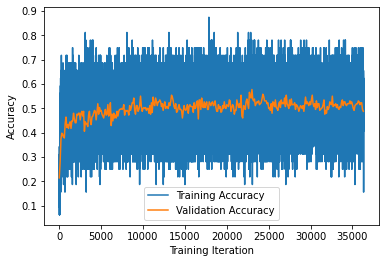

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{split_hash}-finetuned-{finetuning_model_hash}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)
main_data_hash = hash_file(main_data_key + ".hkl")

  0%|          | 0/189419 [00:00<?, ?it/s]

  0%|          | 5/189419 [00:00<1:10:01, 45.08it/s]

  0%|          | 10/189419 [00:00<1:07:57, 46.45it/s]

  0%|          | 17/189419 [00:00<56:50, 55.54it/s]  

  0%|          | 25/189419 [00:00<49:33, 63.70it/s]

  0%|          | 33/189419 [00:00<47:32, 66.39it/s]

  0%|          | 40/189419 [00:00<47:39, 66.23it/s]

  0%|          | 48/189419 [00:00<47:07, 66.97it/s]

  0%|          | 56/189419 [00:00<46:44, 67.53it/s]

  0%|          | 63/189419 [00:00<46:40, 67.61it/s]

  0%|          | 70/189419 [00:01<50:27, 62.55it/s]

  0%|          | 79/189419 [00:01<47:18, 66.71it/s]

  0%|          | 86/189419 [00:01<47:15, 66.78it/s]

  0%|          | 93/189419 [00:01<47:16, 66.74it/s]

  0%|          | 101/189419 [00:01<45:23, 69.52it/s]

  0%|          | 109/189419 [00:01<44:46, 70.47it/s]

  0%|          | 117/189419 [00:01<49:14, 64.07it/s]

  0%|          | 126/189419 [00:01<45:38, 69.13it/s]

  0%|          | 134/189419 [00:02<45:05, 69.97it/s]

  0%|          | 142/189419 [00:02<44:43, 70.54it/s]

  0%|          | 150/189419 [00:02<43:39, 72.24it/s]

  0%|          | 158/189419 [00:02<47:28, 66.43it/s]

  0%|          | 165/189419 [00:02<47:27, 66.46it/s]

  0%|          | 172/189419 [00:02<47:21, 66.61it/s]

  0%|          | 179/189419 [00:02<48:26, 65.11it/s]

  0%|          | 186/189419 [00:02<49:37, 63.55it/s]

  0%|          | 194/189419 [00:02<48:51, 64.54it/s]

  0%|          | 201/189419 [00:03<48:01, 65.66it/s]

  0%|          | 209/189419 [00:03<47:24, 66.51it/s]

  0%|          | 216/189419 [00:03<47:03, 67.02it/s]

  0%|          | 223/189419 [00:03<49:47, 63.32it/s]

  0%|          | 230/189419 [00:03<50:25, 62.53it/s]

  0%|          | 237/189419 [00:03<50:22, 62.59it/s]

  0%|          | 244/189419 [00:03<49:44, 63.39it/s]

  0%|          | 252/189419 [00:03<47:34, 66.26it/s]

  0%|          | 260/189419 [00:03<46:27, 67.86it/s]

  0%|          | 267/189419 [00:04<47:54, 65.80it/s]

  0%|          | 275/189419 [00:04<47:03, 67.00it/s]

  0%|          | 282/189419 [00:04<47:51, 65.87it/s]

  0%|          | 289/189419 [00:04<48:20, 65.21it/s]

  0%|          | 296/189419 [00:04<48:52, 64.50it/s]

  0%|          | 303/189419 [00:04<47:51, 65.85it/s]

  0%|          | 312/189419 [00:04<43:53, 71.80it/s]

  0%|          | 320/189419 [00:04<45:38, 69.05it/s]

  0%|          | 329/189419 [00:04<42:17, 74.52it/s]

  0%|          | 338/189419 [00:05<40:44, 77.35it/s]

  0%|          | 346/189419 [00:05<41:36, 75.74it/s]

  0%|          | 354/189419 [00:05<44:18, 71.11it/s]

  0%|          | 362/189419 [00:05<45:31, 69.20it/s]

  0%|          | 369/189419 [00:05<46:13, 68.15it/s]

  0%|          | 376/189419 [00:05<46:03, 68.41it/s]

  0%|          | 384/189419 [00:05<45:25, 69.35it/s]

  0%|          | 392/189419 [00:05<43:34, 72.30it/s]

  0%|          | 401/189419 [00:05<40:59, 76.87it/s]

  0%|          | 409/189419 [00:06<42:53, 73.44it/s]

  0%|          | 417/189419 [00:06<42:33, 74.01it/s]

  0%|          | 425/189419 [00:06<43:47, 71.94it/s]

  0%|          | 433/189419 [00:06<43:59, 71.60it/s]

  0%|          | 441/189419 [00:06<45:11, 69.69it/s]

  0%|          | 449/189419 [00:06<44:04, 71.45it/s]

  0%|          | 457/189419 [00:06<43:09, 72.98it/s]

  0%|          | 465/189419 [00:06<43:10, 72.94it/s]

  0%|          | 473/189419 [00:06<43:18, 72.73it/s]

  0%|          | 481/189419 [00:07<42:31, 74.05it/s]

  0%|          | 489/189419 [00:07<45:02, 69.90it/s]

  0%|          | 497/189419 [00:07<43:55, 71.69it/s]

  0%|          | 505/189419 [00:07<45:27, 69.27it/s]

  0%|          | 515/189419 [00:07<41:35, 75.69it/s]

  0%|          | 523/189419 [00:07<42:58, 73.25it/s]

  0%|          | 531/189419 [00:07<44:01, 71.52it/s]

  0%|          | 539/189419 [00:07<43:36, 72.18it/s]

  0%|          | 547/189419 [00:07<45:02, 69.88it/s]

  0%|          | 555/189419 [00:08<47:40, 66.02it/s]

  0%|          | 562/189419 [00:08<48:06, 65.43it/s]

  0%|          | 569/189419 [00:08<47:15, 66.61it/s]

  0%|          | 576/189419 [00:08<47:24, 66.39it/s]

  0%|          | 584/189419 [00:08<45:58, 68.45it/s]

  0%|          | 592/189419 [00:08<45:25, 69.28it/s]

  0%|          | 600/189419 [00:08<44:53, 70.09it/s]

  0%|          | 608/189419 [00:08<46:12, 68.11it/s]

  0%|          | 615/189419 [00:09<48:37, 64.72it/s]

  0%|          | 623/189419 [00:09<46:39, 67.43it/s]

  0%|          | 630/189419 [00:09<46:45, 67.29it/s]

  0%|          | 637/189419 [00:09<49:04, 64.11it/s]

  0%|          | 646/189419 [00:09<46:15, 68.00it/s]

  0%|          | 653/189419 [00:09<46:27, 67.72it/s]

  0%|          | 661/189419 [00:09<45:43, 68.80it/s]

  0%|          | 668/189419 [00:09<45:40, 68.87it/s]

  0%|          | 675/189419 [00:09<47:06, 66.78it/s]

  0%|          | 684/189419 [00:10<43:47, 71.82it/s]

  0%|          | 692/189419 [00:10<42:28, 74.05it/s]

  0%|          | 700/189419 [00:10<44:21, 70.90it/s]

  0%|          | 708/189419 [00:10<43:44, 71.90it/s]

  0%|          | 717/189419 [00:10<42:01, 74.84it/s]

  0%|          | 725/189419 [00:10<43:14, 72.74it/s]

  0%|          | 733/189419 [00:10<42:29, 74.02it/s]

  0%|          | 741/189419 [00:10<44:12, 71.13it/s]

  0%|          | 751/189419 [00:10<40:42, 77.23it/s]

  0%|          | 761/189419 [00:11<39:29, 79.60it/s]

  0%|          | 769/189419 [00:11<41:51, 75.12it/s]

  0%|          | 777/189419 [00:11<42:46, 73.51it/s]

  0%|          | 785/189419 [00:11<45:09, 69.61it/s]

  0%|          | 793/189419 [00:11<45:14, 69.48it/s]

  0%|          | 800/189419 [00:11<45:57, 68.41it/s]

  0%|          | 809/189419 [00:11<42:47, 73.46it/s]

  0%|          | 819/189419 [00:11<40:19, 77.96it/s]

  0%|          | 827/189419 [00:11<41:02, 76.58it/s]

  0%|          | 835/189419 [00:12<45:09, 69.59it/s]

  0%|          | 843/189419 [00:12<43:49, 71.71it/s]

  0%|          | 851/189419 [00:12<43:16, 72.62it/s]

  0%|          | 860/189419 [00:12<41:19, 76.06it/s]

  0%|          | 868/189419 [00:12<44:03, 71.33it/s]

  0%|          | 876/189419 [00:12<45:20, 69.31it/s]

  0%|          | 884/189419 [00:12<46:50, 67.09it/s]

  0%|          | 891/189419 [00:12<46:50, 67.09it/s]

  0%|          | 898/189419 [00:13<49:32, 63.43it/s]

  0%|          | 905/189419 [00:13<49:42, 63.21it/s]

  0%|          | 912/189419 [00:13<49:40, 63.25it/s]

  0%|          | 919/189419 [00:13<48:55, 64.22it/s]

  0%|          | 926/189419 [00:13<50:53, 61.73it/s]

  0%|          | 934/189419 [00:13<48:24, 64.90it/s]

  0%|          | 941/189419 [00:13<47:52, 65.61it/s]

  1%|          | 949/189419 [00:13<45:38, 68.83it/s]

  1%|          | 956/189419 [00:13<46:20, 67.78it/s]

  1%|          | 963/189419 [00:13<46:45, 67.18it/s]

  1%|          | 970/189419 [00:14<49:23, 63.60it/s]

  1%|          | 977/189419 [00:14<50:09, 62.61it/s]

  1%|          | 984/189419 [00:14<51:40, 60.77it/s]

  1%|          | 991/189419 [00:14<50:06, 62.68it/s]

  1%|          | 999/189419 [00:14<48:50, 64.30it/s]

  1%|          | 1008/189419 [00:14<44:24, 70.71it/s]

  1%|          | 1016/189419 [00:14<43:56, 71.47it/s]

  1%|          | 1024/189419 [00:14<45:38, 68.80it/s]

  1%|          | 1031/189419 [00:15<45:54, 68.39it/s]

  1%|          | 1038/189419 [00:15<48:17, 65.03it/s]

  1%|          | 1046/189419 [00:15<46:33, 67.42it/s]

  1%|          | 1053/189419 [00:15<48:32, 64.68it/s]

  1%|          | 1063/189419 [00:15<44:04, 71.22it/s]

  1%|          | 1071/189419 [00:15<45:46, 68.57it/s]

  1%|          | 1081/189419 [00:15<41:44, 75.19it/s]

  1%|          | 1089/189419 [00:15<44:13, 70.97it/s]

  1%|          | 1097/189419 [00:15<45:34, 68.87it/s]

  1%|          | 1105/189419 [00:16<45:28, 69.02it/s]

  1%|          | 1113/189419 [00:16<45:01, 69.72it/s]

  1%|          | 1121/189419 [00:16<44:38, 70.31it/s]

  1%|          | 1130/189419 [00:16<43:08, 72.74it/s]

  1%|          | 1138/189419 [00:16<45:40, 68.72it/s]

  1%|          | 1145/189419 [00:16<47:46, 65.68it/s]

  1%|          | 1152/189419 [00:16<48:41, 64.44it/s]

  1%|          | 1160/189419 [00:16<45:53, 68.38it/s]

  1%|          | 1167/189419 [00:16<46:11, 67.93it/s]

  1%|          | 1175/189419 [00:17<44:04, 71.17it/s]

  1%|          | 1183/189419 [00:17<43:25, 72.25it/s]

  1%|          | 1192/189419 [00:17<41:18, 75.94it/s]

  1%|          | 1200/189419 [00:17<42:21, 74.06it/s]

  1%|          | 1208/189419 [00:17<44:33, 70.41it/s]

  1%|          | 1216/189419 [00:17<45:34, 68.81it/s]

  1%|          | 1223/189419 [00:17<48:23, 64.83it/s]

  1%|          | 1230/189419 [00:17<48:31, 64.64it/s]

  1%|          | 1238/189419 [00:18<46:52, 66.92it/s]

  1%|          | 1245/189419 [00:18<50:19, 62.33it/s]

  1%|          | 1253/189419 [00:18<47:03, 66.64it/s]

  1%|          | 1260/189419 [00:18<48:03, 65.26it/s]

  1%|          | 1269/189419 [00:18<44:12, 70.93it/s]

  1%|          | 1279/189419 [00:18<40:28, 77.46it/s]

  1%|          | 1287/189419 [00:18<46:21, 67.64it/s]

  1%|          | 1295/189419 [00:18<47:35, 65.88it/s]

  1%|          | 1303/189419 [00:18<45:54, 68.30it/s]

  1%|          | 1310/189419 [00:19<45:45, 68.52it/s]

  1%|          | 1317/189419 [00:19<46:11, 67.86it/s]

  1%|          | 1326/189419 [00:19<43:10, 72.60it/s]

  1%|          | 1334/189419 [00:19<44:13, 70.89it/s]

  1%|          | 1344/189419 [00:19<40:54, 76.61it/s]

  1%|          | 1352/189419 [00:19<40:57, 76.52it/s]

  1%|          | 1360/189419 [00:19<41:40, 75.22it/s]

  1%|          | 1369/189419 [00:19<41:42, 75.14it/s]

  1%|          | 1377/189419 [00:19<42:33, 73.63it/s]

  1%|          | 1385/189419 [00:20<42:47, 73.23it/s]

  1%|          | 1393/189419 [00:20<46:04, 68.01it/s]

  1%|          | 1403/189419 [00:20<42:22, 73.94it/s]

  1%|          | 1411/189419 [00:20<44:20, 70.67it/s]

  1%|          | 1419/189419 [00:20<45:21, 69.09it/s]

  1%|          | 1427/189419 [00:20<44:39, 70.16it/s]

  1%|          | 1435/189419 [00:20<45:32, 68.79it/s]

  1%|          | 1442/189419 [00:20<48:27, 64.66it/s]

  1%|          | 1450/189419 [00:21<46:22, 67.56it/s]

  1%|          | 1459/189419 [00:21<43:21, 72.24it/s]

  1%|          | 1467/189419 [00:21<44:35, 70.26it/s]

  1%|          | 1475/189419 [00:21<46:13, 67.76it/s]

  1%|          | 1483/189419 [00:21<44:36, 70.23it/s]

  1%|          | 1491/189419 [00:21<48:34, 64.47it/s]

  1%|          | 1498/189419 [00:21<47:56, 65.33it/s]

  1%|          | 1505/189419 [00:21<48:29, 64.58it/s]

  1%|          | 1513/189419 [00:21<46:04, 67.97it/s]

  1%|          | 1521/189419 [00:22<45:00, 69.59it/s]

  1%|          | 1529/189419 [00:22<46:36, 67.19it/s]

  1%|          | 1537/189419 [00:22<46:30, 67.33it/s]

  1%|          | 1546/189419 [00:22<43:58, 71.21it/s]

  1%|          | 1554/189419 [00:22<44:34, 70.24it/s]

  1%|          | 1562/189419 [00:22<45:01, 69.54it/s]

  1%|          | 1570/189419 [00:22<43:56, 71.25it/s]

  1%|          | 1578/189419 [00:22<45:25, 68.91it/s]

  1%|          | 1585/189419 [00:22<45:38, 68.60it/s]

  1%|          | 1592/189419 [00:23<46:50, 66.83it/s]

  1%|          | 1599/189419 [00:23<49:21, 63.41it/s]

  1%|          | 1607/189419 [00:23<47:11, 66.32it/s]

  1%|          | 1615/189419 [00:23<44:43, 69.99it/s]

  1%|          | 1623/189419 [00:23<44:25, 70.46it/s]

  1%|          | 1632/189419 [00:23<41:35, 75.25it/s]

  1%|          | 1641/189419 [00:23<40:48, 76.68it/s]

  1%|          | 1649/189419 [00:23<43:38, 71.71it/s]

  1%|          | 1659/189419 [00:24<40:43, 76.85it/s]

  1%|          | 1667/189419 [00:24<42:06, 74.32it/s]

  1%|          | 1677/189419 [00:24<39:40, 78.85it/s]

  1%|          | 1685/189419 [00:24<40:36, 77.04it/s]

  1%|          | 1693/189419 [00:24<42:11, 74.16it/s]

  1%|          | 1701/189419 [00:24<41:42, 75.00it/s]

  1%|          | 1709/189419 [00:24<44:21, 70.53it/s]

  1%|          | 1717/189419 [00:24<44:39, 70.05it/s]

  1%|          | 1726/189419 [00:24<42:56, 72.86it/s]

  1%|          | 1734/189419 [00:25<43:14, 72.35it/s]

  1%|          | 1742/189419 [00:25<43:49, 71.36it/s]

  1%|          | 1750/189419 [00:25<45:21, 68.97it/s]

  1%|          | 1760/189419 [00:25<40:37, 77.00it/s]

  1%|          | 1768/189419 [00:25<42:12, 74.09it/s]

  1%|          | 1777/189419 [00:25<41:12, 75.88it/s]

  1%|          | 1785/189419 [00:25<46:13, 67.65it/s]

  1%|          | 1792/189419 [00:25<46:29, 67.25it/s]

  1%|          | 1800/189419 [00:25<44:23, 70.44it/s]

  1%|          | 1808/189419 [00:26<47:06, 66.37it/s]

  1%|          | 1815/189419 [00:26<49:21, 63.34it/s]

  1%|          | 1822/189419 [00:26<48:19, 64.71it/s]

  1%|          | 1830/189419 [00:26<45:31, 68.66it/s]

  1%|          | 1837/189419 [00:26<45:33, 68.62it/s]

  1%|          | 1844/189419 [00:26<47:59, 65.14it/s]

  1%|          | 1852/189419 [00:26<45:48, 68.25it/s]

  1%|          | 1859/189419 [00:26<47:13, 66.19it/s]

  1%|          | 1866/189419 [00:26<46:47, 66.80it/s]

  1%|          | 1873/189419 [00:27<48:29, 64.46it/s]

  1%|          | 1882/189419 [00:27<44:28, 70.27it/s]

  1%|          | 1890/189419 [00:27<43:48, 71.35it/s]

  1%|          | 1898/189419 [00:27<44:40, 69.96it/s]

  1%|          | 1906/189419 [00:27<43:17, 72.19it/s]

  1%|          | 1914/189419 [00:27<42:59, 72.68it/s]

  1%|          | 1922/189419 [00:27<44:36, 70.07it/s]

  1%|          | 1930/189419 [00:27<42:59, 72.68it/s]

  1%|          | 1938/189419 [00:27<44:38, 70.00it/s]

  1%|          | 1946/189419 [00:28<43:33, 71.75it/s]

  1%|          | 1954/189419 [00:28<45:20, 68.90it/s]

  1%|          | 1962/189419 [00:28<44:06, 70.83it/s]

  1%|          | 1970/189419 [00:28<45:15, 69.02it/s]

  1%|          | 1977/189419 [00:28<45:56, 68.00it/s]

  1%|          | 1985/189419 [00:28<44:27, 70.26it/s]

  1%|          | 1994/189419 [00:28<42:56, 72.74it/s]

  1%|          | 2002/189419 [00:28<42:11, 74.04it/s]

  1%|          | 2010/189419 [00:28<41:22, 75.50it/s]

  1%|          | 2019/189419 [00:29<39:57, 78.18it/s]

  1%|          | 2027/189419 [00:29<40:39, 76.81it/s]

  1%|          | 2035/189419 [00:29<44:12, 70.65it/s]

  1%|          | 2043/189419 [00:29<44:19, 70.46it/s]

  1%|          | 2052/189419 [00:29<42:12, 73.97it/s]

  1%|          | 2062/189419 [00:29<39:06, 79.85it/s]

  1%|          | 2071/189419 [00:29<38:38, 80.79it/s]

  1%|          | 2080/189419 [00:29<40:04, 77.91it/s]

  1%|          | 2088/189419 [00:30<40:53, 76.35it/s]

  1%|          | 2096/189419 [00:30<42:01, 74.30it/s]

  1%|          | 2104/189419 [00:30<43:20, 72.02it/s]

  1%|          | 2112/189419 [00:30<42:51, 72.84it/s]

  1%|          | 2120/189419 [00:30<44:20, 70.39it/s]

  1%|          | 2128/189419 [00:30<44:22, 70.35it/s]

  1%|          | 2136/189419 [00:30<43:08, 72.36it/s]

  1%|          | 2144/189419 [00:30<42:23, 73.63it/s]

  1%|          | 2152/189419 [00:30<46:12, 67.54it/s]

  1%|          | 2159/189419 [00:31<47:35, 65.58it/s]

  1%|          | 2166/189419 [00:31<49:07, 63.53it/s]

  1%|          | 2173/189419 [00:31<48:48, 63.94it/s]

  1%|          | 2182/189419 [00:31<45:13, 68.99it/s]

  1%|          | 2190/189419 [00:31<43:54, 71.07it/s]

  1%|          | 2198/189419 [00:31<42:52, 72.76it/s]

  1%|          | 2206/189419 [00:31<43:16, 72.09it/s]

  1%|          | 2214/189419 [00:31<43:22, 71.94it/s]

  1%|          | 2222/189419 [00:31<44:12, 70.59it/s]

  1%|          | 2230/189419 [00:32<44:54, 69.48it/s]

  1%|          | 2238/189419 [00:32<43:46, 71.25it/s]

  1%|          | 2246/189419 [00:32<42:38, 73.15it/s]

  1%|          | 2254/189419 [00:32<42:28, 73.45it/s]

  1%|          | 2262/189419 [00:32<43:33, 71.60it/s]

  1%|          | 2270/189419 [00:32<45:02, 69.25it/s]

  1%|          | 2277/189419 [00:32<45:38, 68.34it/s]

  1%|          | 2288/189419 [00:32<41:07, 75.84it/s]

  1%|          | 2296/189419 [00:32<45:24, 68.69it/s]

  1%|          | 2305/189419 [00:33<44:04, 70.74it/s]

  1%|          | 2313/189419 [00:33<44:45, 69.67it/s]

  1%|          | 2321/189419 [00:33<46:27, 67.12it/s]

  1%|          | 2328/189419 [00:33<47:12, 66.04it/s]

  1%|          | 2335/189419 [00:33<48:10, 64.73it/s]

  1%|          | 2343/189419 [00:33<46:23, 67.20it/s]

  1%|          | 2351/189419 [00:33<45:57, 67.84it/s]

  1%|          | 2359/189419 [00:33<43:56, 70.94it/s]

  1%|          | 2367/189419 [00:34<42:29, 73.36it/s]

  1%|▏         | 2375/189419 [00:34<41:47, 74.59it/s]

  1%|▏         | 2383/189419 [00:34<42:21, 73.59it/s]

  1%|▏         | 2391/189419 [00:34<43:07, 72.29it/s]

  1%|▏         | 2399/189419 [00:34<42:14, 73.80it/s]

  1%|▏         | 2408/189419 [00:34<39:47, 78.34it/s]

  1%|▏         | 2416/189419 [00:34<41:47, 74.58it/s]

  1%|▏         | 2424/189419 [00:34<44:50, 69.49it/s]

  1%|▏         | 2432/189419 [00:34<44:52, 69.44it/s]

  1%|▏         | 2440/189419 [00:35<43:30, 71.62it/s]

  1%|▏         | 2449/189419 [00:35<41:29, 75.09it/s]

  1%|▏         | 2459/189419 [00:35<38:35, 80.74it/s]

  1%|▏         | 2468/189419 [00:35<41:51, 74.45it/s]

  1%|▏         | 2476/189419 [00:35<41:52, 74.41it/s]

  1%|▏         | 2484/189419 [00:35<42:16, 73.69it/s]

  1%|▏         | 2492/189419 [00:35<42:40, 73.01it/s]

  1%|▏         | 2500/189419 [00:35<43:08, 72.22it/s]

  1%|▏         | 2509/189419 [00:35<41:08, 75.73it/s]

  1%|▏         | 2517/189419 [00:36<41:25, 75.18it/s]

  1%|▏         | 2525/189419 [00:36<41:16, 75.45it/s]

  1%|▏         | 2533/189419 [00:36<44:02, 70.72it/s]

  1%|▏         | 2542/189419 [00:36<42:04, 74.03it/s]

  1%|▏         | 2552/189419 [00:36<38:41, 80.51it/s]

  1%|▏         | 2561/189419 [00:36<40:50, 76.25it/s]

  1%|▏         | 2570/189419 [00:36<40:08, 77.57it/s]

  1%|▏         | 2578/189419 [00:36<40:57, 76.03it/s]

  1%|▏         | 2586/189419 [00:36<40:57, 76.04it/s]

  1%|▏         | 2594/189419 [00:37<44:38, 69.75it/s]

  1%|▏         | 2602/189419 [00:37<46:24, 67.10it/s]

  1%|▏         | 2610/189419 [00:37<44:16, 70.32it/s]

  1%|▏         | 2618/189419 [00:37<45:10, 68.92it/s]

  1%|▏         | 2626/189419 [00:37<43:44, 71.17it/s]

  1%|▏         | 2634/189419 [00:37<44:18, 70.25it/s]

  1%|▏         | 2642/189419 [00:37<45:21, 68.64it/s]

  1%|▏         | 2649/189419 [00:37<47:06, 66.07it/s]

  1%|▏         | 2656/189419 [00:37<47:47, 65.13it/s]

  1%|▏         | 2665/189419 [00:38<44:28, 69.99it/s]

  1%|▏         | 2673/189419 [00:38<45:06, 69.00it/s]

  1%|▏         | 2680/189419 [00:38<46:29, 66.94it/s]

  1%|▏         | 2687/189419 [00:38<46:37, 66.75it/s]

  1%|▏         | 2694/189419 [00:38<46:50, 66.43it/s]

  1%|▏         | 2701/189419 [00:38<46:13, 67.31it/s]

  1%|▏         | 2708/189419 [00:38<47:39, 65.31it/s]

  1%|▏         | 2715/189419 [00:38<47:45, 65.16it/s]

  1%|▏         | 2724/189419 [00:38<44:43, 69.57it/s]

  1%|▏         | 2731/189419 [00:39<48:07, 64.65it/s]

  1%|▏         | 2741/189419 [00:39<42:36, 73.03it/s]

  1%|▏         | 2749/189419 [00:39<44:10, 70.44it/s]

  1%|▏         | 2757/189419 [00:39<45:32, 68.32it/s]

  1%|▏         | 2766/189419 [00:39<42:18, 73.52it/s]

  1%|▏         | 2774/189419 [00:39<42:33, 73.10it/s]

  1%|▏         | 2782/189419 [00:39<43:02, 72.28it/s]

  1%|▏         | 2792/189419 [00:39<40:29, 76.83it/s]

  1%|▏         | 2800/189419 [00:40<40:39, 76.50it/s]

  1%|▏         | 2808/189419 [00:40<41:42, 74.58it/s]

  1%|▏         | 2816/189419 [00:40<41:33, 74.84it/s]

  1%|▏         | 2824/189419 [00:40<41:38, 74.68it/s]

  1%|▏         | 2832/189419 [00:40<44:34, 69.77it/s]

  1%|▏         | 2840/189419 [00:40<46:41, 66.59it/s]

  2%|▏         | 2847/189419 [00:40<47:44, 65.13it/s]

  2%|▏         | 2854/189419 [00:40<46:54, 66.30it/s]

  2%|▏         | 2862/189419 [00:40<45:35, 68.20it/s]

  2%|▏         | 2869/189419 [00:41<47:55, 64.87it/s]

  2%|▏         | 2877/189419 [00:41<46:45, 66.50it/s]

  2%|▏         | 2884/189419 [00:41<48:28, 64.13it/s]

  2%|▏         | 2892/189419 [00:41<46:06, 67.42it/s]

  2%|▏         | 2900/189419 [00:41<43:59, 70.67it/s]

  2%|▏         | 2909/189419 [00:41<42:26, 73.24it/s]

  2%|▏         | 2918/189419 [00:41<41:48, 74.35it/s]

  2%|▏         | 2927/189419 [00:41<41:19, 75.23it/s]

  2%|▏         | 2935/189419 [00:41<43:29, 71.46it/s]

  2%|▏         | 2943/189419 [00:42<42:13, 73.59it/s]

  2%|▏         | 2952/189419 [00:42<41:39, 74.60it/s]

  2%|▏         | 2960/189419 [00:42<41:55, 74.11it/s]

  2%|▏         | 2968/189419 [00:42<43:26, 71.53it/s]

  2%|▏         | 2976/189419 [00:42<42:30, 73.10it/s]

  2%|▏         | 2984/189419 [00:42<41:46, 74.38it/s]

  2%|▏         | 2992/189419 [00:42<41:03, 75.67it/s]

  2%|▏         | 3000/189419 [00:42<40:42, 76.31it/s]

  2%|▏         | 3008/189419 [00:42<40:11, 77.30it/s]

  2%|▏         | 3016/189419 [00:43<40:42, 76.32it/s]

  2%|▏         | 3024/189419 [00:43<42:00, 73.94it/s]

  2%|▏         | 3032/189419 [00:43<43:16, 71.79it/s]

  2%|▏         | 3040/189419 [00:43<44:18, 70.09it/s]

  2%|▏         | 3049/189419 [00:43<42:53, 72.41it/s]

  2%|▏         | 3057/189419 [00:43<44:42, 69.48it/s]

  2%|▏         | 3064/189419 [00:43<46:13, 67.19it/s]

  2%|▏         | 3071/189419 [00:43<46:14, 67.16it/s]

  2%|▏         | 3079/189419 [00:43<44:23, 69.95it/s]

  2%|▏         | 3087/189419 [00:44<43:58, 70.61it/s]

  2%|▏         | 3096/189419 [00:44<41:13, 75.33it/s]

  2%|▏         | 3104/189419 [00:44<42:31, 73.02it/s]

  2%|▏         | 3112/189419 [00:44<42:15, 73.47it/s]

  2%|▏         | 3121/189419 [00:44<41:05, 75.55it/s]

  2%|▏         | 3129/189419 [00:44<42:44, 72.65it/s]

  2%|▏         | 3137/189419 [00:44<43:32, 71.31it/s]

  2%|▏         | 3146/189419 [00:44<42:53, 72.40it/s]

  2%|▏         | 3155/189419 [00:44<40:52, 75.94it/s]

  2%|▏         | 3163/189419 [00:45<42:19, 73.34it/s]

  2%|▏         | 3173/189419 [00:45<40:40, 76.33it/s]

  2%|▏         | 3181/189419 [00:45<42:14, 73.48it/s]

  2%|▏         | 3189/189419 [00:45<43:12, 71.85it/s]

  2%|▏         | 3197/189419 [00:45<44:06, 70.36it/s]

  2%|▏         | 3205/189419 [00:45<44:42, 69.41it/s]

  2%|▏         | 3212/189419 [00:45<45:50, 67.69it/s]

  2%|▏         | 3221/189419 [00:45<43:54, 70.68it/s]

  2%|▏         | 3229/189419 [00:46<42:26, 73.10it/s]

  2%|▏         | 3237/189419 [00:46<44:40, 69.46it/s]

  2%|▏         | 3245/189419 [00:46<43:46, 70.87it/s]

  2%|▏         | 3253/189419 [00:46<45:07, 68.77it/s]

  2%|▏         | 3260/189419 [00:46<45:54, 67.59it/s]

  2%|▏         | 3267/189419 [00:46<45:38, 67.98it/s]

  2%|▏         | 3275/189419 [00:46<45:19, 68.45it/s]

  2%|▏         | 3282/189419 [00:46<46:59, 66.01it/s]

  2%|▏         | 3289/189419 [00:46<48:09, 64.42it/s]

  2%|▏         | 3297/189419 [00:47<46:52, 66.18it/s]

  2%|▏         | 3305/189419 [00:47<44:55, 69.05it/s]

  2%|▏         | 3313/189419 [00:47<44:54, 69.08it/s]

  2%|▏         | 3321/189419 [00:47<44:57, 68.99it/s]

  2%|▏         | 3328/189419 [00:47<45:50, 67.66it/s]

  2%|▏         | 3337/189419 [00:47<42:56, 72.22it/s]

  2%|▏         | 3345/189419 [00:47<43:02, 72.05it/s]

  2%|▏         | 3353/189419 [00:47<44:47, 69.24it/s]

  2%|▏         | 3361/189419 [00:47<44:01, 70.43it/s]

  2%|▏         | 3369/189419 [00:48<45:27, 68.21it/s]

  2%|▏         | 3376/189419 [00:48<45:46, 67.74it/s]

  2%|▏         | 3383/189419 [00:48<46:35, 66.56it/s]

  2%|▏         | 3390/189419 [00:48<46:00, 67.39it/s]

  2%|▏         | 3398/189419 [00:48<44:01, 70.42it/s]

  2%|▏         | 3406/189419 [00:48<44:17, 70.00it/s]

  2%|▏         | 3415/189419 [00:48<41:06, 75.42it/s]

  2%|▏         | 3423/189419 [00:48<42:49, 72.39it/s]

  2%|▏         | 3431/189419 [00:48<44:51, 69.11it/s]

  2%|▏         | 3439/189419 [00:49<43:34, 71.15it/s]

  2%|▏         | 3447/189419 [00:49<45:01, 68.84it/s]

  2%|▏         | 3454/189419 [00:49<46:26, 66.74it/s]

  2%|▏         | 3461/189419 [00:49<46:05, 67.25it/s]

  2%|▏         | 3469/189419 [00:49<44:55, 68.99it/s]

  2%|▏         | 3476/189419 [00:49<45:30, 68.10it/s]

  2%|▏         | 3483/189419 [00:49<45:20, 68.36it/s]

  2%|▏         | 3492/189419 [00:49<42:03, 73.69it/s]

  2%|▏         | 3500/189419 [00:49<43:09, 71.79it/s]

  2%|▏         | 3508/189419 [00:50<45:03, 68.77it/s]

  2%|▏         | 3515/189419 [00:50<44:51, 69.07it/s]

  2%|▏         | 3523/189419 [00:50<43:48, 70.72it/s]

  2%|▏         | 3531/189419 [00:50<44:09, 70.16it/s]

  2%|▏         | 3540/189419 [00:50<42:43, 72.50it/s]

  2%|▏         | 3548/189419 [00:50<43:52, 70.62it/s]

  2%|▏         | 3556/189419 [00:50<44:06, 70.22it/s]

  2%|▏         | 3564/189419 [00:50<45:44, 67.71it/s]

  2%|▏         | 3571/189419 [00:50<45:22, 68.27it/s]

  2%|▏         | 3578/189419 [00:51<45:32, 68.01it/s]

  2%|▏         | 3585/189419 [00:51<48:16, 64.16it/s]

  2%|▏         | 3592/189419 [00:51<47:33, 65.13it/s]

  2%|▏         | 3600/189419 [00:51<45:10, 68.54it/s]

  2%|▏         | 3608/189419 [00:51<43:58, 70.43it/s]

  2%|▏         | 3617/189419 [00:51<41:47, 74.09it/s]

  2%|▏         | 3626/189419 [00:51<40:52, 75.74it/s]

  2%|▏         | 3634/189419 [00:51<40:37, 76.23it/s]

  2%|▏         | 3642/189419 [00:51<40:57, 75.58it/s]

  2%|▏         | 3650/189419 [00:52<42:43, 72.47it/s]

  2%|▏         | 3658/189419 [00:52<44:14, 69.98it/s]

  2%|▏         | 3666/189419 [00:52<43:11, 71.67it/s]

  2%|▏         | 3674/189419 [00:52<42:23, 73.02it/s]

  2%|▏         | 3684/189419 [00:52<39:04, 79.21it/s]

  2%|▏         | 3694/189419 [00:52<36:54, 83.85it/s]

  2%|▏         | 3703/189419 [00:52<37:29, 82.57it/s]

  2%|▏         | 3712/189419 [00:52<40:26, 76.52it/s]

  2%|▏         | 3720/189419 [00:52<40:08, 77.09it/s]

  2%|▏         | 3728/189419 [00:53<40:36, 76.22it/s]

  2%|▏         | 3736/189419 [00:53<40:23, 76.63it/s]

  2%|▏         | 3744/189419 [00:53<41:57, 73.76it/s]

  2%|▏         | 3752/189419 [00:53<42:13, 73.29it/s]

  2%|▏         | 3760/189419 [00:53<42:23, 73.00it/s]

  2%|▏         | 3768/189419 [00:53<42:13, 73.27it/s]

  2%|▏         | 3776/189419 [00:53<43:57, 70.38it/s]

  2%|▏         | 3784/189419 [00:53<43:26, 71.21it/s]

  2%|▏         | 3793/189419 [00:53<41:08, 75.20it/s]

  2%|▏         | 3801/189419 [00:54<42:38, 72.55it/s]

  2%|▏         | 3809/189419 [00:54<42:22, 73.01it/s]

  2%|▏         | 3817/189419 [00:54<42:25, 72.91it/s]

  2%|▏         | 3825/189419 [00:54<42:07, 73.44it/s]

  2%|▏         | 3833/189419 [00:54<42:56, 72.03it/s]

  2%|▏         | 3841/189419 [00:54<43:46, 70.64it/s]

  2%|▏         | 3849/189419 [00:54<45:19, 68.25it/s]

  2%|▏         | 3859/189419 [00:54<41:31, 74.48it/s]

  2%|▏         | 3867/189419 [00:54<42:06, 73.45it/s]

  2%|▏         | 3875/189419 [00:55<42:37, 72.55it/s]

  2%|▏         | 3883/189419 [00:55<42:27, 72.84it/s]

  2%|▏         | 3892/189419 [00:55<41:08, 75.15it/s]

  2%|▏         | 3900/189419 [00:55<42:53, 72.09it/s]

  2%|▏         | 3908/189419 [00:55<47:07, 65.60it/s]

  2%|▏         | 3915/189419 [00:55<48:07, 64.25it/s]

  2%|▏         | 3922/189419 [00:55<48:26, 63.83it/s]

  2%|▏         | 3929/189419 [00:55<48:18, 64.00it/s]

  2%|▏         | 3937/189419 [00:56<47:04, 65.67it/s]

  2%|▏         | 3945/189419 [00:56<44:34, 69.34it/s]

  2%|▏         | 3953/189419 [00:56<43:09, 71.63it/s]

  2%|▏         | 3961/189419 [00:56<41:53, 73.79it/s]

  2%|▏         | 3970/189419 [00:56<41:45, 74.02it/s]

  2%|▏         | 3978/189419 [00:56<41:42, 74.10it/s]

  2%|▏         | 3986/189419 [00:56<43:33, 70.94it/s]

  2%|▏         | 3994/189419 [00:56<43:21, 71.28it/s]

  2%|▏         | 4003/189419 [00:56<42:17, 73.06it/s]

  2%|▏         | 4011/189419 [00:57<43:12, 71.51it/s]

  2%|▏         | 4019/189419 [00:57<42:30, 72.69it/s]

  2%|▏         | 4027/189419 [00:57<43:47, 70.55it/s]

  2%|▏         | 4035/189419 [00:57<43:57, 70.28it/s]

  2%|▏         | 4043/189419 [00:57<42:40, 72.39it/s]

  2%|▏         | 4051/189419 [00:57<46:11, 66.88it/s]

  2%|▏         | 4058/189419 [00:57<47:48, 64.62it/s]

  2%|▏         | 4066/189419 [00:57<46:50, 65.95it/s]

  2%|▏         | 4074/189419 [00:57<44:21, 69.63it/s]

  2%|▏         | 4082/189419 [00:58<46:53, 65.87it/s]

  2%|▏         | 4090/189419 [00:58<45:22, 68.07it/s]

  2%|▏         | 4098/189419 [00:58<43:48, 70.50it/s]

  2%|▏         | 4107/189419 [00:58<41:43, 74.04it/s]

  2%|▏         | 4115/189419 [00:58<41:38, 74.18it/s]

  2%|▏         | 4123/189419 [00:58<41:52, 73.76it/s]

  2%|▏         | 4131/189419 [00:58<44:08, 69.95it/s]

  2%|▏         | 4139/189419 [00:58<46:18, 66.69it/s]

  2%|▏         | 4146/189419 [00:59<49:32, 62.33it/s]

  2%|▏         | 4153/189419 [00:59<49:52, 61.92it/s]

  2%|▏         | 4161/189419 [00:59<46:31, 66.37it/s]

  2%|▏         | 4168/189419 [00:59<48:08, 64.14it/s]

  2%|▏         | 4176/189419 [00:59<45:53, 67.27it/s]

  2%|▏         | 4184/189419 [00:59<45:00, 68.60it/s]

  2%|▏         | 4192/189419 [00:59<43:54, 70.31it/s]

  2%|▏         | 4200/189419 [00:59<46:32, 66.32it/s]

  2%|▏         | 4207/189419 [00:59<46:33, 66.30it/s]

  2%|▏         | 4216/189419 [01:00<44:12, 69.82it/s]

  2%|▏         | 4225/189419 [01:00<42:13, 73.10it/s]

  2%|▏         | 4233/189419 [01:00<42:48, 72.11it/s]

  2%|▏         | 4241/189419 [01:00<43:18, 71.27it/s]

  2%|▏         | 4249/189419 [01:00<43:35, 70.81it/s]

  2%|▏         | 4257/189419 [01:00<43:24, 71.10it/s]

  2%|▏         | 4265/189419 [01:00<42:45, 72.17it/s]

  2%|▏         | 4274/189419 [01:00<40:31, 76.15it/s]

  2%|▏         | 4282/189419 [01:00<41:08, 75.01it/s]

  2%|▏         | 4290/189419 [01:01<42:49, 72.06it/s]

  2%|▏         | 4299/189419 [01:01<41:19, 74.65it/s]

  2%|▏         | 4307/189419 [01:01<45:53, 67.22it/s]

  2%|▏         | 4316/189419 [01:01<42:45, 72.15it/s]

  2%|▏         | 4324/189419 [01:01<43:05, 71.59it/s]

  2%|▏         | 4332/189419 [01:01<44:57, 68.63it/s]

  2%|▏         | 4339/189419 [01:01<46:45, 65.98it/s]

  2%|▏         | 4347/189419 [01:01<44:59, 68.57it/s]

  2%|▏         | 4354/189419 [01:02<47:17, 65.21it/s]

  2%|▏         | 4361/189419 [01:02<46:52, 65.80it/s]

  2%|▏         | 4370/189419 [01:02<43:11, 71.41it/s]

  2%|▏         | 4378/189419 [01:02<47:49, 64.49it/s]

  2%|▏         | 4387/189419 [01:02<44:27, 69.36it/s]

  2%|▏         | 4395/189419 [01:02<43:40, 70.61it/s]

  2%|▏         | 4403/189419 [01:02<44:30, 69.28it/s]

  2%|▏         | 4411/189419 [01:02<44:47, 68.85it/s]

  2%|▏         | 4419/189419 [01:02<45:05, 68.39it/s]

  2%|▏         | 4426/189419 [01:03<44:56, 68.61it/s]

  2%|▏         | 4435/189419 [01:03<42:22, 72.75it/s]

  2%|▏         | 4443/189419 [01:03<44:14, 69.70it/s]

  2%|▏         | 4451/189419 [01:03<43:10, 71.40it/s]

  2%|▏         | 4459/189419 [01:03<42:14, 72.98it/s]

  2%|▏         | 4467/189419 [01:03<41:24, 74.44it/s]

  2%|▏         | 4476/189419 [01:03<39:07, 78.80it/s]

  2%|▏         | 4484/189419 [01:03<39:32, 77.94it/s]

  2%|▏         | 4493/189419 [01:03<38:08, 80.80it/s]

  2%|▏         | 4502/189419 [01:04<41:06, 74.97it/s]

  2%|▏         | 4510/189419 [01:04<43:53, 70.21it/s]

  2%|▏         | 4519/189419 [01:04<42:12, 73.00it/s]

  2%|▏         | 4529/189419 [01:04<39:40, 77.66it/s]

  2%|▏         | 4537/189419 [01:04<41:00, 75.15it/s]

  2%|▏         | 4545/189419 [01:04<40:35, 75.89it/s]

  2%|▏         | 4553/189419 [01:04<42:24, 72.66it/s]

  2%|▏         | 4561/189419 [01:04<43:30, 70.81it/s]

  2%|▏         | 4569/189419 [01:04<42:19, 72.80it/s]

  2%|▏         | 4577/189419 [01:05<42:49, 71.93it/s]

  2%|▏         | 4585/189419 [01:05<42:20, 72.76it/s]

  2%|▏         | 4593/189419 [01:05<46:23, 66.40it/s]

  2%|▏         | 4601/189419 [01:05<45:00, 68.43it/s]

  2%|▏         | 4608/189419 [01:05<46:17, 66.54it/s]

  2%|▏         | 4617/189419 [01:05<43:13, 71.27it/s]

  2%|▏         | 4625/189419 [01:05<44:29, 69.23it/s]

  2%|▏         | 4632/189419 [01:05<45:08, 68.22it/s]

  2%|▏         | 4641/189419 [01:05<41:42, 73.83it/s]

  2%|▏         | 4650/189419 [01:06<39:55, 77.13it/s]

  2%|▏         | 4658/189419 [01:06<40:49, 75.42it/s]

  2%|▏         | 4666/189419 [01:06<41:44, 73.78it/s]

  2%|▏         | 4674/189419 [01:06<42:16, 72.85it/s]

  2%|▏         | 4682/189419 [01:06<41:58, 73.34it/s]

  2%|▏         | 4691/189419 [01:06<40:44, 75.57it/s]

  2%|▏         | 4699/189419 [01:06<42:48, 71.92it/s]

  2%|▏         | 4707/189419 [01:06<45:13, 68.06it/s]

  2%|▏         | 4714/189419 [01:07<44:54, 68.55it/s]

  2%|▏         | 4721/189419 [01:07<45:58, 66.95it/s]

  2%|▏         | 4728/189419 [01:07<48:43, 63.16it/s]

  2%|▏         | 4735/189419 [01:07<49:02, 62.77it/s]

  3%|▎         | 4744/189419 [01:07<44:34, 69.05it/s]

  3%|▎         | 4753/189419 [01:07<41:16, 74.57it/s]

  3%|▎         | 4761/189419 [01:07<43:40, 70.46it/s]

  3%|▎         | 4770/189419 [01:07<41:15, 74.58it/s]

  3%|▎         | 4779/189419 [01:07<39:18, 78.27it/s]

  3%|▎         | 4789/189419 [01:08<37:32, 81.95it/s]

  3%|▎         | 4798/189419 [01:08<38:21, 80.21it/s]

  3%|▎         | 4807/189419 [01:08<38:41, 79.52it/s]

  3%|▎         | 4815/189419 [01:08<41:22, 74.36it/s]

  3%|▎         | 4823/189419 [01:08<41:17, 74.51it/s]

  3%|▎         | 4832/189419 [01:08<39:46, 77.35it/s]

  3%|▎         | 4840/189419 [01:08<42:34, 72.25it/s]

  3%|▎         | 4849/189419 [01:08<40:49, 75.34it/s]

  3%|▎         | 4857/189419 [01:08<44:32, 69.06it/s]

  3%|▎         | 4865/189419 [01:09<43:03, 71.44it/s]

  3%|▎         | 4873/189419 [01:09<42:40, 72.07it/s]

  3%|▎         | 4881/189419 [01:09<43:08, 71.30it/s]

  3%|▎         | 4889/189419 [01:09<42:59, 71.55it/s]

  3%|▎         | 4897/189419 [01:09<43:08, 71.29it/s]

  3%|▎         | 4905/189419 [01:09<46:05, 66.71it/s]

  3%|▎         | 4913/189419 [01:09<44:57, 68.40it/s]

  3%|▎         | 4920/189419 [01:09<46:00, 66.83it/s]

  3%|▎         | 4930/189419 [01:09<41:33, 73.99it/s]

  3%|▎         | 4938/189419 [01:10<41:47, 73.56it/s]

  3%|▎         | 4946/189419 [01:10<41:23, 74.27it/s]

  3%|▎         | 4955/189419 [01:10<40:04, 76.72it/s]

  3%|▎         | 4963/189419 [01:10<41:01, 74.94it/s]

  3%|▎         | 4971/189419 [01:10<41:43, 73.68it/s]

  3%|▎         | 4979/189419 [01:10<40:56, 75.07it/s]

  3%|▎         | 4989/189419 [01:10<37:48, 81.29it/s]

  3%|▎         | 4998/189419 [01:10<41:06, 74.78it/s]

  3%|▎         | 5006/189419 [01:10<41:00, 74.95it/s]

  3%|▎         | 5014/189419 [01:11<44:31, 69.02it/s]

  3%|▎         | 5022/189419 [01:11<43:26, 70.74it/s]

  3%|▎         | 5030/189419 [01:11<47:15, 65.02it/s]

  3%|▎         | 5037/189419 [01:11<48:01, 63.98it/s]

  3%|▎         | 5045/189419 [01:11<45:40, 67.27it/s]

  3%|▎         | 5052/189419 [01:11<45:54, 66.94it/s]

  3%|▎         | 5059/189419 [01:11<47:07, 65.20it/s]

  3%|▎         | 5067/189419 [01:11<45:02, 68.21it/s]

  3%|▎         | 5074/189419 [01:12<46:17, 66.37it/s]

  3%|▎         | 5081/189419 [01:12<45:47, 67.10it/s]

  3%|▎         | 5088/189419 [01:12<47:07, 65.20it/s]

  3%|▎         | 5095/189419 [01:12<49:38, 61.89it/s]

  3%|▎         | 5104/189419 [01:12<44:31, 68.99it/s]

  3%|▎         | 5112/189419 [01:12<44:39, 68.78it/s]

  3%|▎         | 5120/189419 [01:12<43:23, 70.79it/s]

  3%|▎         | 5128/189419 [01:12<45:04, 68.14it/s]

  3%|▎         | 5136/189419 [01:12<43:34, 70.49it/s]

  3%|▎         | 5145/189419 [01:13<41:15, 74.44it/s]

  3%|▎         | 5153/189419 [01:13<41:50, 73.39it/s]

  3%|▎         | 5161/189419 [01:13<45:07, 68.06it/s]

  3%|▎         | 5171/189419 [01:13<40:15, 76.29it/s]

  3%|▎         | 5179/189419 [01:13<42:38, 72.01it/s]

  3%|▎         | 5187/189419 [01:13<42:43, 71.87it/s]

  3%|▎         | 5195/189419 [01:13<41:49, 73.41it/s]

  3%|▎         | 5203/189419 [01:13<41:27, 74.05it/s]

  3%|▎         | 5211/189419 [01:13<45:06, 68.07it/s]

  3%|▎         | 5218/189419 [01:14<47:19, 64.87it/s]

  3%|▎         | 5226/189419 [01:14<44:50, 68.45it/s]

  3%|▎         | 5233/189419 [01:14<45:08, 68.01it/s]

  3%|▎         | 5240/189419 [01:14<47:51, 64.13it/s]

  3%|▎         | 5248/189419 [01:14<46:49, 65.56it/s]

  3%|▎         | 5256/189419 [01:14<45:18, 67.74it/s]

  3%|▎         | 5266/189419 [01:14<40:29, 75.79it/s]

  3%|▎         | 5274/189419 [01:14<41:44, 73.51it/s]

  3%|▎         | 5282/189419 [01:15<43:06, 71.18it/s]

  3%|▎         | 5290/189419 [01:15<46:09, 66.49it/s]

  3%|▎         | 5298/189419 [01:15<44:10, 69.45it/s]

  3%|▎         | 5307/189419 [01:15<41:00, 74.83it/s]

  3%|▎         | 5315/189419 [01:15<40:56, 74.96it/s]

  3%|▎         | 5323/189419 [01:15<43:18, 70.84it/s]

  3%|▎         | 5331/189419 [01:15<44:00, 69.71it/s]

  3%|▎         | 5339/189419 [01:15<44:49, 68.44it/s]

  3%|▎         | 5346/189419 [01:15<47:30, 64.58it/s]

  3%|▎         | 5354/189419 [01:16<46:50, 65.50it/s]

  3%|▎         | 5362/189419 [01:16<45:04, 68.06it/s]

  3%|▎         | 5371/189419 [01:16<42:22, 72.38it/s]

  3%|▎         | 5379/189419 [01:16<41:41, 73.58it/s]

  3%|▎         | 5387/189419 [01:16<43:46, 70.06it/s]

  3%|▎         | 5395/189419 [01:16<46:04, 66.57it/s]

  3%|▎         | 5402/189419 [01:16<45:47, 66.99it/s]

  3%|▎         | 5409/189419 [01:16<46:43, 65.64it/s]

  3%|▎         | 5416/189419 [01:16<46:04, 66.56it/s]

  3%|▎         | 5425/189419 [01:17<42:50, 71.57it/s]

  3%|▎         | 5433/189419 [01:17<43:27, 70.55it/s]

  3%|▎         | 5441/189419 [01:17<44:39, 68.65it/s]

  3%|▎         | 5448/189419 [01:17<44:55, 68.26it/s]

  3%|▎         | 5457/189419 [01:17<42:59, 71.33it/s]

  3%|▎         | 5465/189419 [01:17<43:55, 69.79it/s]

  3%|▎         | 5473/189419 [01:17<42:20, 72.40it/s]

  3%|▎         | 5481/189419 [01:17<43:23, 70.64it/s]

  3%|▎         | 5489/189419 [01:18<46:01, 66.60it/s]

  3%|▎         | 5496/189419 [01:18<48:05, 63.75it/s]

  3%|▎         | 5504/189419 [01:18<46:01, 66.61it/s]

  3%|▎         | 5512/189419 [01:18<44:35, 68.74it/s]

  3%|▎         | 5519/189419 [01:18<45:02, 68.05it/s]

  3%|▎         | 5526/189419 [01:18<47:21, 64.72it/s]

  3%|▎         | 5533/189419 [01:18<51:07, 59.94it/s]

  3%|▎         | 5540/189419 [01:18<51:14, 59.81it/s]

  3%|▎         | 5547/189419 [01:18<50:06, 61.17it/s]

  3%|▎         | 5554/189419 [01:19<48:46, 62.84it/s]

  3%|▎         | 5561/189419 [01:19<48:24, 63.31it/s]

  3%|▎         | 5568/189419 [01:19<49:36, 61.78it/s]

  3%|▎         | 5577/189419 [01:19<45:02, 68.02it/s]

  3%|▎         | 5584/189419 [01:19<45:22, 67.51it/s]

  3%|▎         | 5594/189419 [01:19<40:50, 75.01it/s]

  3%|▎         | 5602/189419 [01:19<42:56, 71.34it/s]

  3%|▎         | 5610/189419 [01:19<44:52, 68.27it/s]

  3%|▎         | 5618/189419 [01:19<43:14, 70.85it/s]

  3%|▎         | 5626/189419 [01:20<46:01, 66.56it/s]

  3%|▎         | 5635/189419 [01:20<44:13, 69.26it/s]

  3%|▎         | 5645/189419 [01:20<41:41, 73.46it/s]

  3%|▎         | 5653/189419 [01:20<42:37, 71.85it/s]

  3%|▎         | 5662/189419 [01:20<40:05, 76.39it/s]

  3%|▎         | 5670/189419 [01:20<40:13, 76.13it/s]

  3%|▎         | 5679/189419 [01:20<39:52, 76.80it/s]

  3%|▎         | 5688/189419 [01:20<40:05, 76.39it/s]

  3%|▎         | 5696/189419 [01:21<43:22, 70.60it/s]

  3%|▎         | 5704/189419 [01:21<42:10, 72.59it/s]

  3%|▎         | 5712/189419 [01:21<41:27, 73.85it/s]

  3%|▎         | 5720/189419 [01:21<40:52, 74.89it/s]

  3%|▎         | 5728/189419 [01:21<42:15, 72.45it/s]

  3%|▎         | 5736/189419 [01:21<43:16, 70.75it/s]

  3%|▎         | 5744/189419 [01:21<42:15, 72.45it/s]

  3%|▎         | 5752/189419 [01:21<43:39, 70.13it/s]

  3%|▎         | 5760/189419 [01:21<42:56, 71.28it/s]

  3%|▎         | 5768/189419 [01:22<41:59, 72.89it/s]

  3%|▎         | 5776/189419 [01:22<42:01, 72.84it/s]

  3%|▎         | 5784/189419 [01:22<44:22, 68.97it/s]

  3%|▎         | 5791/189419 [01:22<44:18, 69.08it/s]

  3%|▎         | 5799/189419 [01:22<43:33, 70.25it/s]

  3%|▎         | 5807/189419 [01:22<44:43, 68.42it/s]

  3%|▎         | 5815/189419 [01:22<44:05, 69.40it/s]

  3%|▎         | 5822/189419 [01:22<45:22, 67.44it/s]

  3%|▎         | 5829/189419 [01:22<45:07, 67.82it/s]

  3%|▎         | 5836/189419 [01:23<46:01, 66.49it/s]

  3%|▎         | 5844/189419 [01:23<46:06, 66.36it/s]

  3%|▎         | 5853/189419 [01:23<43:18, 70.65it/s]

  3%|▎         | 5861/189419 [01:23<44:12, 69.19it/s]

  3%|▎         | 5870/189419 [01:23<41:27, 73.77it/s]

  3%|▎         | 5878/189419 [01:23<42:01, 72.79it/s]

  3%|▎         | 5886/189419 [01:23<41:30, 73.70it/s]

  3%|▎         | 5895/189419 [01:23<40:58, 74.65it/s]

  3%|▎         | 5903/189419 [01:23<40:52, 74.84it/s]

  3%|▎         | 5911/189419 [01:24<41:34, 73.57it/s]

  3%|▎         | 5919/189419 [01:24<43:05, 70.98it/s]

  3%|▎         | 5928/189419 [01:24<41:33, 73.58it/s]

  3%|▎         | 5937/189419 [01:24<39:34, 77.27it/s]

  3%|▎         | 5945/189419 [01:24<42:37, 71.73it/s]

  3%|▎         | 5953/189419 [01:24<42:48, 71.44it/s]

  3%|▎         | 5962/189419 [01:24<40:51, 74.84it/s]

  3%|▎         | 5970/189419 [01:24<43:43, 69.93it/s]

  3%|▎         | 5978/189419 [01:24<42:59, 71.12it/s]

  3%|▎         | 5988/189419 [01:25<39:16, 77.84it/s]

  3%|▎         | 5996/189419 [01:25<40:26, 75.59it/s]

  3%|▎         | 6004/189419 [01:25<41:02, 74.48it/s]

  3%|▎         | 6013/189419 [01:25<40:58, 74.61it/s]

  3%|▎         | 6021/189419 [01:25<42:22, 72.12it/s]

  3%|▎         | 6029/189419 [01:25<41:50, 73.06it/s]

  3%|▎         | 6037/189419 [01:25<41:42, 73.27it/s]

  3%|▎         | 6045/189419 [01:25<40:42, 75.06it/s]

  3%|▎         | 6053/189419 [01:25<43:18, 70.57it/s]

  3%|▎         | 6061/189419 [01:26<46:51, 65.22it/s]

  3%|▎         | 6070/189419 [01:26<42:45, 71.47it/s]

  3%|▎         | 6078/189419 [01:26<43:13, 70.68it/s]

  3%|▎         | 6086/189419 [01:26<45:07, 67.70it/s]

  3%|▎         | 6093/189419 [01:26<49:01, 62.33it/s]

  3%|▎         | 6101/189419 [01:26<45:49, 66.66it/s]

  3%|▎         | 6108/189419 [01:26<45:43, 66.81it/s]

  3%|▎         | 6116/189419 [01:26<44:37, 68.45it/s]

  3%|▎         | 6125/189419 [01:27<41:25, 73.75it/s]

  3%|▎         | 6133/189419 [01:27<43:41, 69.91it/s]

  3%|▎         | 6142/189419 [01:27<41:26, 73.70it/s]

  3%|▎         | 6150/189419 [01:27<45:00, 67.86it/s]

  3%|▎         | 6157/189419 [01:27<45:27, 67.19it/s]

  3%|▎         | 6165/189419 [01:27<43:51, 69.64it/s]

  3%|▎         | 6173/189419 [01:27<42:32, 71.80it/s]

  3%|▎         | 6181/189419 [01:27<43:22, 70.40it/s]

  3%|▎         | 6190/189419 [01:27<40:19, 75.72it/s]

  3%|▎         | 6198/189419 [01:28<40:38, 75.13it/s]

  3%|▎         | 6207/189419 [01:28<39:30, 77.28it/s]

  3%|▎         | 6215/189419 [01:28<39:54, 76.51it/s]

  3%|▎         | 6223/189419 [01:28<42:30, 71.84it/s]

  3%|▎         | 6231/189419 [01:28<41:26, 73.68it/s]

  3%|▎         | 6239/189419 [01:28<44:10, 69.10it/s]

  3%|▎         | 6247/189419 [01:28<44:17, 68.91it/s]

  3%|▎         | 6255/189419 [01:28<44:29, 68.60it/s]

  3%|▎         | 6262/189419 [01:28<45:24, 67.22it/s]

  3%|▎         | 6269/189419 [01:29<47:03, 64.86it/s]

  3%|▎         | 6277/189419 [01:29<44:38, 68.38it/s]

  3%|▎         | 6285/189419 [01:29<43:53, 69.53it/s]

  3%|▎         | 6293/189419 [01:29<42:52, 71.18it/s]

  3%|▎         | 6301/189419 [01:29<41:27, 73.60it/s]

  3%|▎         | 6309/189419 [01:29<41:05, 74.27it/s]

  3%|▎         | 6317/189419 [01:29<41:02, 74.35it/s]

  3%|▎         | 6325/189419 [01:29<41:17, 73.90it/s]

  3%|▎         | 6333/189419 [01:29<42:06, 72.47it/s]

  3%|▎         | 6341/189419 [01:30<42:37, 71.60it/s]

  3%|▎         | 6350/189419 [01:30<40:09, 75.99it/s]

  3%|▎         | 6358/189419 [01:30<41:31, 73.46it/s]

  3%|▎         | 6366/189419 [01:30<41:25, 73.66it/s]

  3%|▎         | 6374/189419 [01:30<42:38, 71.55it/s]

  3%|▎         | 6382/189419 [01:30<45:21, 67.25it/s]

  3%|▎         | 6390/189419 [01:30<44:12, 69.01it/s]

  3%|▎         | 6399/189419 [01:30<41:41, 73.16it/s]

  3%|▎         | 6407/189419 [01:30<42:18, 72.10it/s]

  3%|▎         | 6415/189419 [01:31<42:51, 71.18it/s]

  3%|▎         | 6423/189419 [01:31<42:32, 71.70it/s]

  3%|▎         | 6431/189419 [01:31<42:28, 71.81it/s]

  3%|▎         | 6439/189419 [01:31<42:44, 71.36it/s]

  3%|▎         | 6447/189419 [01:31<44:45, 68.14it/s]

  3%|▎         | 6455/189419 [01:31<43:52, 69.49it/s]

  3%|▎         | 6464/189419 [01:31<41:52, 72.83it/s]

  3%|▎         | 6473/189419 [01:31<39:56, 76.33it/s]

  3%|▎         | 6481/189419 [01:32<41:14, 73.93it/s]

  3%|▎         | 6489/189419 [01:32<42:01, 72.54it/s]

  3%|▎         | 6497/189419 [01:32<43:22, 70.29it/s]

  3%|▎         | 6505/189419 [01:32<44:19, 68.77it/s]

  3%|▎         | 6512/189419 [01:32<45:51, 66.47it/s]

  3%|▎         | 6519/189419 [01:32<46:12, 65.98it/s]

  3%|▎         | 6528/189419 [01:32<43:33, 69.97it/s]

  3%|▎         | 6536/189419 [01:32<45:40, 66.72it/s]

  3%|▎         | 6543/189419 [01:32<45:47, 66.55it/s]

  3%|▎         | 6550/189419 [01:33<45:52, 66.43it/s]

  3%|▎         | 6557/189419 [01:33<45:39, 66.74it/s]

  3%|▎         | 6565/189419 [01:33<43:15, 70.44it/s]

  3%|▎         | 6573/189419 [01:33<43:35, 69.91it/s]

  3%|▎         | 6581/189419 [01:33<44:32, 68.42it/s]

  3%|▎         | 6588/189419 [01:33<45:39, 66.74it/s]

  3%|▎         | 6595/189419 [01:33<46:56, 64.92it/s]

  3%|▎         | 6603/189419 [01:33<46:35, 65.39it/s]

  3%|▎         | 6612/189419 [01:33<44:34, 68.36it/s]

  3%|▎         | 6620/189419 [01:34<43:12, 70.50it/s]

  3%|▎         | 6628/189419 [01:34<43:29, 70.06it/s]

  4%|▎         | 6636/189419 [01:34<44:13, 68.88it/s]

  4%|▎         | 6643/189419 [01:34<46:12, 65.92it/s]

  4%|▎         | 6650/189419 [01:34<46:13, 65.89it/s]

  4%|▎         | 6657/189419 [01:34<47:13, 64.51it/s]

  4%|▎         | 6667/189419 [01:34<42:12, 72.16it/s]

  4%|▎         | 6675/189419 [01:34<42:44, 71.27it/s]

  4%|▎         | 6683/189419 [01:34<42:32, 71.59it/s]

  4%|▎         | 6691/189419 [01:35<41:38, 73.12it/s]

  4%|▎         | 6699/189419 [01:35<41:36, 73.20it/s]

  4%|▎         | 6707/189419 [01:35<41:54, 72.65it/s]

  4%|▎         | 6715/189419 [01:35<43:15, 70.40it/s]

  4%|▎         | 6725/189419 [01:35<39:56, 76.23it/s]

  4%|▎         | 6733/189419 [01:35<39:40, 76.74it/s]

  4%|▎         | 6741/189419 [01:35<42:44, 71.24it/s]

  4%|▎         | 6749/189419 [01:35<42:59, 70.80it/s]

  4%|▎         | 6758/189419 [01:35<41:09, 73.98it/s]

  4%|▎         | 6766/189419 [01:36<40:37, 74.94it/s]

  4%|▎         | 6774/189419 [01:36<41:14, 73.80it/s]

  4%|▎         | 6782/189419 [01:36<43:17, 70.32it/s]

  4%|▎         | 6792/189419 [01:36<39:43, 76.62it/s]

  4%|▎         | 6800/189419 [01:36<42:06, 72.29it/s]

  4%|▎         | 6808/189419 [01:36<41:59, 72.48it/s]

  4%|▎         | 6817/189419 [01:36<40:38, 74.87it/s]

  4%|▎         | 6825/189419 [01:36<41:35, 73.18it/s]

  4%|▎         | 6834/189419 [01:37<40:10, 75.73it/s]

  4%|▎         | 6842/189419 [01:37<43:39, 69.69it/s]

  4%|▎         | 6850/189419 [01:37<43:25, 70.06it/s]

  4%|▎         | 6858/189419 [01:37<44:11, 68.86it/s]

  4%|▎         | 6865/189419 [01:37<45:04, 67.51it/s]

  4%|▎         | 6873/189419 [01:37<43:49, 69.43it/s]

  4%|▎         | 6882/189419 [01:37<40:39, 74.84it/s]

  4%|▎         | 6890/189419 [01:37<42:43, 71.20it/s]

  4%|▎         | 6898/189419 [01:37<42:17, 71.93it/s]

  4%|▎         | 6906/189419 [01:38<41:57, 72.51it/s]

  4%|▎         | 6914/189419 [01:38<42:03, 72.34it/s]

  4%|▎         | 6922/189419 [01:38<42:40, 71.28it/s]

  4%|▎         | 6930/189419 [01:38<41:52, 72.62it/s]

  4%|▎         | 6938/189419 [01:38<42:56, 70.84it/s]

  4%|▎         | 6946/189419 [01:38<42:49, 71.02it/s]

  4%|▎         | 6955/189419 [01:38<40:27, 75.17it/s]

  4%|▎         | 6963/189419 [01:38<41:11, 73.83it/s]

  4%|▎         | 6971/189419 [01:38<42:55, 70.84it/s]

  4%|▎         | 6979/189419 [01:39<45:53, 66.25it/s]

  4%|▎         | 6986/189419 [01:39<46:20, 65.61it/s]

  4%|▎         | 6994/189419 [01:39<44:20, 68.57it/s]

  4%|▎         | 7003/189419 [01:39<42:05, 72.24it/s]

  4%|▎         | 7011/189419 [01:39<41:22, 73.48it/s]

  4%|▎         | 7019/189419 [01:39<41:22, 73.46it/s]

  4%|▎         | 7027/189419 [01:39<41:46, 72.78it/s]

  4%|▎         | 7035/189419 [01:39<42:01, 72.33it/s]

  4%|▎         | 7043/189419 [01:39<41:20, 73.52it/s]

  4%|▎         | 7051/189419 [01:40<42:47, 71.02it/s]

  4%|▎         | 7059/189419 [01:40<41:27, 73.30it/s]

  4%|▎         | 7067/189419 [01:40<43:23, 70.04it/s]

  4%|▎         | 7077/189419 [01:40<39:41, 76.56it/s]

  4%|▎         | 7085/189419 [01:40<41:59, 72.38it/s]

  4%|▎         | 7093/189419 [01:40<45:02, 67.47it/s]

  4%|▎         | 7102/189419 [01:40<42:20, 71.77it/s]

  4%|▍         | 7111/189419 [01:40<40:07, 75.73it/s]

  4%|▍         | 7119/189419 [01:41<40:23, 75.22it/s]

  4%|▍         | 7127/189419 [01:41<40:22, 75.25it/s]

  4%|▍         | 7137/189419 [01:41<37:39, 80.68it/s]

  4%|▍         | 7146/189419 [01:41<39:42, 76.52it/s]

  4%|▍         | 7154/189419 [01:41<40:57, 74.15it/s]

  4%|▍         | 7162/189419 [01:41<42:24, 71.63it/s]

  4%|▍         | 7170/189419 [01:41<43:56, 69.13it/s]

  4%|▍         | 7177/189419 [01:41<44:10, 68.77it/s]

  4%|▍         | 7184/189419 [01:41<48:34, 62.54it/s]

  4%|▍         | 7192/189419 [01:42<46:37, 65.13it/s]

  4%|▍         | 7200/189419 [01:42<45:06, 67.32it/s]

  4%|▍         | 7207/189419 [01:42<44:44, 67.88it/s]

  4%|▍         | 7216/189419 [01:42<42:10, 72.01it/s]

  4%|▍         | 7224/189419 [01:42<44:17, 68.55it/s]

  4%|▍         | 7233/189419 [01:42<41:00, 74.04it/s]

  4%|▍         | 7241/189419 [01:42<41:43, 72.78it/s]

  4%|▍         | 7249/189419 [01:42<41:42, 72.80it/s]

  4%|▍         | 7257/189419 [01:42<41:01, 74.02it/s]

  4%|▍         | 7265/189419 [01:43<40:34, 74.82it/s]

  4%|▍         | 7273/189419 [01:43<39:49, 76.22it/s]

  4%|▍         | 7281/189419 [01:43<40:49, 74.34it/s]

  4%|▍         | 7291/189419 [01:43<38:14, 79.37it/s]

  4%|▍         | 7300/189419 [01:43<37:11, 81.63it/s]

  4%|▍         | 7309/189419 [01:43<40:31, 74.90it/s]

  4%|▍         | 7317/189419 [01:43<40:29, 74.96it/s]

  4%|▍         | 7325/189419 [01:43<41:22, 73.36it/s]

  4%|▍         | 7333/189419 [01:43<41:44, 72.70it/s]

  4%|▍         | 7341/189419 [01:44<40:44, 74.48it/s]

  4%|▍         | 7349/189419 [01:44<43:54, 69.10it/s]

  4%|▍         | 7357/189419 [01:44<42:21, 71.62it/s]

  4%|▍         | 7365/189419 [01:44<41:44, 72.68it/s]

  4%|▍         | 7373/189419 [01:44<41:17, 73.49it/s]

  4%|▍         | 7381/189419 [01:44<41:37, 72.88it/s]

  4%|▍         | 7389/189419 [01:44<43:02, 70.50it/s]

  4%|▍         | 7397/189419 [01:44<44:32, 68.11it/s]

  4%|▍         | 7404/189419 [01:44<44:58, 67.45it/s]

  4%|▍         | 7412/189419 [01:45<43:26, 69.82it/s]

  4%|▍         | 7420/189419 [01:45<42:20, 71.63it/s]

  4%|▍         | 7428/189419 [01:45<41:19, 73.39it/s]

  4%|▍         | 7436/189419 [01:45<41:58, 72.27it/s]

  4%|▍         | 7444/189419 [01:45<41:05, 73.81it/s]

  4%|▍         | 7453/189419 [01:45<39:27, 76.85it/s]

  4%|▍         | 7462/189419 [01:45<38:44, 78.28it/s]

  4%|▍         | 7471/189419 [01:45<38:31, 78.70it/s]

  4%|▍         | 7479/189419 [01:45<39:34, 76.64it/s]

  4%|▍         | 7487/189419 [01:46<41:21, 73.32it/s]

  4%|▍         | 7495/189419 [01:46<41:08, 73.70it/s]

  4%|▍         | 7503/189419 [01:46<43:44, 69.33it/s]

  4%|▍         | 7511/189419 [01:46<42:06, 72.01it/s]

  4%|▍         | 7519/189419 [01:46<43:36, 69.52it/s]

  4%|▍         | 7527/189419 [01:46<44:54, 67.49it/s]

  4%|▍         | 7535/189419 [01:46<44:24, 68.26it/s]

  4%|▍         | 7544/189419 [01:46<43:03, 70.41it/s]

  4%|▍         | 7552/189419 [01:46<42:09, 71.90it/s]

  4%|▍         | 7560/189419 [01:47<44:35, 67.98it/s]

  4%|▍         | 7569/189419 [01:47<42:49, 70.78it/s]

  4%|▍         | 7577/189419 [01:47<43:46, 69.22it/s]

  4%|▍         | 7585/189419 [01:47<42:29, 71.31it/s]

  4%|▍         | 7593/189419 [01:47<43:55, 69.00it/s]

  4%|▍         | 7600/189419 [01:47<45:14, 66.99it/s]

  4%|▍         | 7607/189419 [01:47<45:25, 66.71it/s]

  4%|▍         | 7617/189419 [01:47<40:36, 74.62it/s]

  4%|▍         | 7626/189419 [01:48<39:11, 77.29it/s]

  4%|▍         | 7634/189419 [01:48<40:49, 74.21it/s]

  4%|▍         | 7643/189419 [01:48<40:33, 74.69it/s]

  4%|▍         | 7651/189419 [01:48<42:39, 71.03it/s]

  4%|▍         | 7659/189419 [01:48<42:10, 71.84it/s]

  4%|▍         | 7667/189419 [01:48<43:43, 69.28it/s]

  4%|▍         | 7674/189419 [01:48<45:23, 66.74it/s]

  4%|▍         | 7681/189419 [01:48<45:47, 66.15it/s]

  4%|▍         | 7689/189419 [01:48<45:19, 66.81it/s]

  4%|▍         | 7698/189419 [01:49<42:05, 71.94it/s]

  4%|▍         | 7706/189419 [01:49<44:37, 67.87it/s]

  4%|▍         | 7713/189419 [01:49<44:27, 68.12it/s]

  4%|▍         | 7720/189419 [01:49<45:37, 66.37it/s]

  4%|▍         | 7727/189419 [01:49<47:51, 63.27it/s]

  4%|▍         | 7734/189419 [01:49<48:30, 62.43it/s]

  4%|▍         | 7744/189419 [01:49<43:26, 69.69it/s]

  4%|▍         | 7752/189419 [01:49<43:30, 69.58it/s]

  4%|▍         | 7760/189419 [01:50<43:32, 69.54it/s]

  4%|▍         | 7768/189419 [01:50<42:05, 71.92it/s]

  4%|▍         | 7776/189419 [01:50<44:44, 67.67it/s]

  4%|▍         | 7783/189419 [01:50<44:51, 67.48it/s]

  4%|▍         | 7791/189419 [01:50<43:01, 70.35it/s]

  4%|▍         | 7799/189419 [01:50<43:49, 69.06it/s]

  4%|▍         | 7806/189419 [01:50<44:28, 68.05it/s]

  4%|▍         | 7815/189419 [01:50<41:38, 72.69it/s]

  4%|▍         | 7823/189419 [01:50<42:03, 71.95it/s]

  4%|▍         | 7831/189419 [01:51<41:24, 73.10it/s]

  4%|▍         | 7839/189419 [01:51<41:47, 72.42it/s]

  4%|▍         | 7847/189419 [01:51<43:07, 70.17it/s]

  4%|▍         | 7855/189419 [01:51<41:44, 72.50it/s]

  4%|▍         | 7863/189419 [01:51<42:34, 71.08it/s]

  4%|▍         | 7871/189419 [01:51<43:08, 70.13it/s]

  4%|▍         | 7879/189419 [01:51<43:36, 69.38it/s]

  4%|▍         | 7887/189419 [01:51<42:24, 71.34it/s]

  4%|▍         | 7895/189419 [01:51<43:06, 70.19it/s]

  4%|▍         | 7903/189419 [01:52<42:27, 71.24it/s]

  4%|▍         | 7911/189419 [01:52<47:17, 63.97it/s]

  4%|▍         | 7918/189419 [01:52<46:33, 64.98it/s]

  4%|▍         | 7925/189419 [01:52<45:46, 66.09it/s]

  4%|▍         | 7933/189419 [01:52<43:55, 68.86it/s]

  4%|▍         | 7940/189419 [01:52<44:36, 67.80it/s]

  4%|▍         | 7948/189419 [01:52<43:50, 68.98it/s]

  4%|▍         | 7957/189419 [01:52<41:34, 72.74it/s]

  4%|▍         | 7966/189419 [01:52<39:08, 77.26it/s]

  4%|▍         | 7974/189419 [01:53<42:08, 71.75it/s]

  4%|▍         | 7982/189419 [01:53<41:50, 72.28it/s]

  4%|▍         | 7990/189419 [01:53<42:41, 70.83it/s]

  4%|▍         | 7998/189419 [01:53<42:17, 71.51it/s]

  4%|▍         | 8007/189419 [01:53<39:32, 76.45it/s]

  4%|▍         | 8017/189419 [01:53<37:36, 80.39it/s]

  4%|▍         | 8026/189419 [01:53<40:15, 75.10it/s]

  4%|▍         | 8034/189419 [01:53<40:24, 74.81it/s]

  4%|▍         | 8042/189419 [01:53<41:20, 73.12it/s]

  4%|▍         | 8050/189419 [01:54<41:58, 72.01it/s]

  4%|▍         | 8058/189419 [01:54<43:10, 70.01it/s]

  4%|▍         | 8066/189419 [01:54<43:47, 69.03it/s]

  4%|▍         | 8073/189419 [01:54<43:45, 69.07it/s]

  4%|▍         | 8080/189419 [01:54<44:43, 67.58it/s]

  4%|▍         | 8087/189419 [01:54<45:42, 66.12it/s]

  4%|▍         | 8096/189419 [01:54<42:51, 70.53it/s]

  4%|▍         | 8104/189419 [01:54<42:55, 70.40it/s]

  4%|▍         | 8113/189419 [01:54<41:27, 72.89it/s]

  4%|▍         | 8121/189419 [01:55<41:39, 72.52it/s]

  4%|▍         | 8129/189419 [01:55<43:45, 69.05it/s]

  4%|▍         | 8136/189419 [01:55<44:54, 67.28it/s]

  4%|▍         | 8144/189419 [01:55<43:04, 70.15it/s]

  4%|▍         | 8152/189419 [01:55<43:59, 68.67it/s]

  4%|▍         | 8160/189419 [01:55<42:49, 70.56it/s]

  4%|▍         | 8168/189419 [01:55<41:43, 72.41it/s]

  4%|▍         | 8176/189419 [01:55<43:11, 69.94it/s]

  4%|▍         | 8184/189419 [01:55<41:57, 72.00it/s]

  4%|▍         | 8192/189419 [01:56<44:20, 68.11it/s]

  4%|▍         | 8199/189419 [01:56<44:35, 67.73it/s]

  4%|▍         | 8206/189419 [01:56<48:10, 62.68it/s]

  4%|▍         | 8213/189419 [01:56<48:00, 62.91it/s]

  4%|▍         | 8221/189419 [01:56<46:33, 64.86it/s]

  4%|▍         | 8229/189419 [01:56<44:23, 68.02it/s]

  4%|▍         | 8238/189419 [01:56<41:44, 72.35it/s]

  4%|▍         | 8246/189419 [01:56<45:21, 66.57it/s]

  4%|▍         | 8253/189419 [01:57<45:06, 66.93it/s]

  4%|▍         | 8262/189419 [01:57<42:17, 71.39it/s]

  4%|▍         | 8270/189419 [01:57<41:48, 72.22it/s]

  4%|▍         | 8278/189419 [01:57<44:13, 68.28it/s]

  4%|▍         | 8286/189419 [01:57<42:46, 70.57it/s]

  4%|▍         | 8296/189419 [01:57<40:08, 75.19it/s]

  4%|▍         | 8304/189419 [01:57<40:47, 73.99it/s]

  4%|▍         | 8312/189419 [01:57<41:54, 72.03it/s]

  4%|▍         | 8321/189419 [01:57<39:23, 76.61it/s]

  4%|▍         | 8329/189419 [01:58<41:46, 72.24it/s]

  4%|▍         | 8337/189419 [01:58<42:09, 71.59it/s]

  4%|▍         | 8345/189419 [01:58<43:47, 68.91it/s]

  4%|▍         | 8353/189419 [01:58<44:06, 68.43it/s]

  4%|▍         | 8361/189419 [01:58<43:12, 69.83it/s]

  4%|▍         | 8369/189419 [01:58<43:38, 69.14it/s]

  4%|▍         | 8378/189419 [01:58<42:41, 70.68it/s]

  4%|▍         | 8386/189419 [01:58<44:27, 67.86it/s]

  4%|▍         | 8394/189419 [01:59<43:05, 70.02it/s]

  4%|▍         | 8402/189419 [01:59<43:41, 69.05it/s]

  4%|▍         | 8412/189419 [01:59<39:13, 76.90it/s]

  4%|▍         | 8420/189419 [01:59<41:16, 73.08it/s]

  4%|▍         | 8429/189419 [01:59<40:07, 75.16it/s]

  4%|▍         | 8439/189419 [01:59<38:29, 78.37it/s]

  4%|▍         | 8447/189419 [01:59<41:56, 71.91it/s]

  4%|▍         | 8455/189419 [01:59<43:51, 68.78it/s]

  4%|▍         | 8462/189419 [01:59<45:09, 66.79it/s]

  4%|▍         | 8469/189419 [02:00<44:56, 67.11it/s]

  4%|▍         | 8477/189419 [02:00<43:58, 68.57it/s]

  4%|▍         | 8484/189419 [02:00<44:56, 67.09it/s]

  4%|▍         | 8492/189419 [02:00<45:01, 66.96it/s]

  4%|▍         | 8499/189419 [02:00<45:11, 66.71it/s]

  4%|▍         | 8507/189419 [02:00<44:12, 68.21it/s]

  4%|▍         | 8515/189419 [02:00<43:03, 70.01it/s]

  4%|▍         | 8523/189419 [02:00<44:52, 67.18it/s]

  5%|▍         | 8531/189419 [02:00<43:39, 69.05it/s]

  5%|▍         | 8538/189419 [02:01<45:05, 66.86it/s]

  5%|▍         | 8545/189419 [02:01<45:01, 66.95it/s]

  5%|▍         | 8552/189419 [02:01<46:41, 64.55it/s]

  5%|▍         | 8560/189419 [02:01<45:16, 66.58it/s]

  5%|▍         | 8567/189419 [02:01<46:16, 65.13it/s]

  5%|▍         | 8575/189419 [02:01<45:00, 66.96it/s]

  5%|▍         | 8585/189419 [02:01<40:19, 74.73it/s]

  5%|▍         | 8593/189419 [02:01<41:30, 72.60it/s]

  5%|▍         | 8601/189419 [02:01<42:48, 70.39it/s]

  5%|▍         | 8609/189419 [02:02<42:27, 70.97it/s]

  5%|▍         | 8617/189419 [02:02<43:56, 68.58it/s]

  5%|▍         | 8625/189419 [02:02<44:25, 67.82it/s]

  5%|▍         | 8632/189419 [02:02<45:05, 66.83it/s]

  5%|▍         | 8640/189419 [02:02<43:49, 68.76it/s]

  5%|▍         | 8648/189419 [02:02<42:23, 71.08it/s]

  5%|▍         | 8657/189419 [02:02<41:06, 73.29it/s]

  5%|▍         | 8665/189419 [02:02<40:51, 73.74it/s]

  5%|▍         | 8673/189419 [02:03<40:46, 73.87it/s]

  5%|▍         | 8681/189419 [02:03<42:46, 70.41it/s]

  5%|▍         | 8689/189419 [02:03<42:15, 71.28it/s]

  5%|▍         | 8697/189419 [02:03<44:37, 67.51it/s]

  5%|▍         | 8705/189419 [02:03<43:00, 70.02it/s]

  5%|▍         | 8713/189419 [02:03<44:34, 67.57it/s]

  5%|▍         | 8721/189419 [02:03<43:19, 69.52it/s]

  5%|▍         | 8729/189419 [02:03<43:03, 69.94it/s]

  5%|▍         | 8737/189419 [02:03<46:49, 64.32it/s]

  5%|▍         | 8744/189419 [02:04<49:18, 61.08it/s]

  5%|▍         | 8752/189419 [02:04<46:35, 64.63it/s]

  5%|▍         | 8760/189419 [02:04<44:51, 67.12it/s]

  5%|▍         | 8767/189419 [02:04<45:52, 65.64it/s]

  5%|▍         | 8775/189419 [02:04<43:43, 68.87it/s]

  5%|▍         | 8782/189419 [02:04<44:35, 67.52it/s]

  5%|▍         | 8791/189419 [02:04<42:41, 70.53it/s]

  5%|▍         | 8799/189419 [02:04<42:29, 70.83it/s]

  5%|▍         | 8808/189419 [02:04<41:39, 72.27it/s]

  5%|▍         | 8816/189419 [02:05<42:53, 70.17it/s]

  5%|▍         | 8824/189419 [02:05<41:42, 72.17it/s]

  5%|▍         | 8832/189419 [02:05<43:32, 69.14it/s]

  5%|▍         | 8841/189419 [02:05<41:07, 73.18it/s]

  5%|▍         | 8849/189419 [02:05<42:38, 70.56it/s]

  5%|▍         | 8857/189419 [02:05<41:54, 71.82it/s]

  5%|▍         | 8865/189419 [02:05<40:48, 73.75it/s]

  5%|▍         | 8873/189419 [02:05<43:20, 69.43it/s]

  5%|▍         | 8881/189419 [02:06<41:48, 71.97it/s]

  5%|▍         | 8891/189419 [02:06<38:55, 77.30it/s]

  5%|▍         | 8899/189419 [02:06<41:26, 72.61it/s]

  5%|▍         | 8907/189419 [02:06<42:37, 70.58it/s]

  5%|▍         | 8915/189419 [02:06<42:49, 70.24it/s]

  5%|▍         | 8923/189419 [02:06<44:49, 67.10it/s]

  5%|▍         | 8931/189419 [02:06<43:17, 69.49it/s]

  5%|▍         | 8939/189419 [02:06<42:21, 71.01it/s]

  5%|▍         | 8947/189419 [02:06<41:16, 72.88it/s]

  5%|▍         | 8955/189419 [02:07<43:32, 69.07it/s]

  5%|▍         | 8963/189419 [02:07<43:23, 69.31it/s]

  5%|▍         | 8970/189419 [02:07<43:38, 68.91it/s]

  5%|▍         | 8977/189419 [02:07<44:06, 68.19it/s]

  5%|▍         | 8985/189419 [02:07<43:22, 69.33it/s]

  5%|▍         | 8992/189419 [02:07<47:40, 63.08it/s]

  5%|▍         | 9000/189419 [02:07<45:23, 66.23it/s]

  5%|▍         | 9007/189419 [02:07<46:08, 65.16it/s]

  5%|▍         | 9014/189419 [02:07<45:30, 66.07it/s]

  5%|▍         | 9023/189419 [02:08<42:44, 70.34it/s]

  5%|▍         | 9032/189419 [02:08<39:51, 75.44it/s]

  5%|▍         | 9040/189419 [02:08<42:48, 70.22it/s]

  5%|▍         | 9048/189419 [02:08<45:20, 66.30it/s]

  5%|▍         | 9055/189419 [02:08<46:42, 64.36it/s]

  5%|▍         | 9062/189419 [02:08<46:14, 65.01it/s]

  5%|▍         | 9070/189419 [02:08<44:31, 67.52it/s]

  5%|▍         | 9077/189419 [02:08<45:36, 65.90it/s]

  5%|▍         | 9084/189419 [02:09<46:07, 65.17it/s]

  5%|▍         | 9092/189419 [02:09<45:22, 66.24it/s]

  5%|▍         | 9099/189419 [02:09<47:09, 63.73it/s]

  5%|▍         | 9106/189419 [02:09<47:43, 62.98it/s]

  5%|▍         | 9113/189419 [02:09<46:31, 64.59it/s]

  5%|▍         | 9122/189419 [02:09<42:45, 70.29it/s]

  5%|▍         | 9130/189419 [02:09<41:46, 71.92it/s]

  5%|▍         | 9138/189419 [02:09<40:34, 74.04it/s]

  5%|▍         | 9146/189419 [02:09<40:41, 73.83it/s]

  5%|▍         | 9154/189419 [02:09<42:07, 71.33it/s]

  5%|▍         | 9162/189419 [02:10<42:33, 70.59it/s]

  5%|▍         | 9170/189419 [02:10<41:26, 72.49it/s]

  5%|▍         | 9178/189419 [02:10<40:51, 73.51it/s]

  5%|▍         | 9186/189419 [02:10<41:02, 73.20it/s]

  5%|▍         | 9194/189419 [02:10<41:13, 72.87it/s]

  5%|▍         | 9202/189419 [02:10<40:33, 74.06it/s]

  5%|▍         | 9211/189419 [02:10<39:02, 76.94it/s]

  5%|▍         | 9220/189419 [02:10<38:54, 77.19it/s]

  5%|▍         | 9228/189419 [02:10<41:28, 72.42it/s]

  5%|▍         | 9236/189419 [02:11<41:50, 71.76it/s]

  5%|▍         | 9244/189419 [02:11<41:29, 72.38it/s]

  5%|▍         | 9252/189419 [02:11<41:06, 73.04it/s]

  5%|▍         | 9260/189419 [02:11<42:11, 71.16it/s]

  5%|▍         | 9268/189419 [02:11<43:38, 68.81it/s]

  5%|▍         | 9275/189419 [02:11<45:56, 65.35it/s]

  5%|▍         | 9284/189419 [02:11<41:59, 71.51it/s]

  5%|▍         | 9292/189419 [02:11<40:55, 73.36it/s]

  5%|▍         | 9300/189419 [02:12<42:22, 70.86it/s]

  5%|▍         | 9308/189419 [02:12<42:57, 69.87it/s]

  5%|▍         | 9316/189419 [02:12<42:55, 69.94it/s]

  5%|▍         | 9324/189419 [02:12<43:46, 68.58it/s]

  5%|▍         | 9331/189419 [02:12<44:35, 67.32it/s]

  5%|▍         | 9338/189419 [02:12<45:22, 66.16it/s]

  5%|▍         | 9345/189419 [02:12<44:57, 66.75it/s]

  5%|▍         | 9354/189419 [02:12<42:08, 71.22it/s]

  5%|▍         | 9362/189419 [02:12<40:45, 73.63it/s]

  5%|▍         | 9370/189419 [02:13<42:52, 70.00it/s]

  5%|▍         | 9380/189419 [02:13<40:34, 73.96it/s]

  5%|▍         | 9388/189419 [02:13<39:53, 75.22it/s]

  5%|▍         | 9396/189419 [02:13<40:17, 74.45it/s]

  5%|▍         | 9404/189419 [02:13<43:11, 69.47it/s]

  5%|▍         | 9412/189419 [02:13<45:30, 65.93it/s]

  5%|▍         | 9419/189419 [02:13<46:20, 64.74it/s]

  5%|▍         | 9426/189419 [02:13<46:28, 64.56it/s]

  5%|▍         | 9436/189419 [02:13<42:31, 70.55it/s]

  5%|▍         | 9444/189419 [02:14<45:53, 65.35it/s]

  5%|▍         | 9451/189419 [02:14<45:32, 65.86it/s]

  5%|▍         | 9458/189419 [02:14<48:35, 61.72it/s]

  5%|▍         | 9466/189419 [02:14<46:01, 65.17it/s]

  5%|▌         | 9475/189419 [02:14<43:44, 68.55it/s]

  5%|▌         | 9483/189419 [02:14<42:54, 69.90it/s]

  5%|▌         | 9491/189419 [02:14<42:22, 70.76it/s]

  5%|▌         | 9499/189419 [02:14<42:25, 70.67it/s]

  5%|▌         | 9507/189419 [02:15<43:07, 69.52it/s]

  5%|▌         | 9515/189419 [02:15<42:44, 70.16it/s]

  5%|▌         | 9523/189419 [02:15<44:25, 67.50it/s]

  5%|▌         | 9530/189419 [02:15<45:25, 66.01it/s]

  5%|▌         | 9537/189419 [02:15<45:40, 65.63it/s]

  5%|▌         | 9544/189419 [02:15<47:12, 63.51it/s]

  5%|▌         | 9553/189419 [02:15<42:44, 70.12it/s]

  5%|▌         | 9561/189419 [02:15<42:43, 70.16it/s]

  5%|▌         | 9569/189419 [02:15<43:24, 69.04it/s]

  5%|▌         | 9577/189419 [02:16<42:13, 70.98it/s]

  5%|▌         | 9585/189419 [02:16<43:06, 69.52it/s]

  5%|▌         | 9593/189419 [02:16<41:58, 71.40it/s]

  5%|▌         | 9601/189419 [02:16<43:37, 68.69it/s]

  5%|▌         | 9609/189419 [02:16<42:00, 71.35it/s]

  5%|▌         | 9617/189419 [02:16<42:53, 69.86it/s]

  5%|▌         | 9626/189419 [02:16<41:41, 71.89it/s]

  5%|▌         | 9635/189419 [02:16<40:58, 73.13it/s]

  5%|▌         | 9643/189419 [02:16<41:50, 71.62it/s]

  5%|▌         | 9652/189419 [02:17<40:29, 74.00it/s]

  5%|▌         | 9660/189419 [02:17<42:03, 71.23it/s]

  5%|▌         | 9668/189419 [02:17<44:27, 67.38it/s]

  5%|▌         | 9675/189419 [02:17<44:24, 67.45it/s]

  5%|▌         | 9683/189419 [02:17<43:13, 69.31it/s]

  5%|▌         | 9691/189419 [02:17<42:10, 71.01it/s]

  5%|▌         | 9699/189419 [02:17<41:57, 71.38it/s]

  5%|▌         | 9707/189419 [02:17<41:01, 73.01it/s]

  5%|▌         | 9715/189419 [02:18<42:44, 70.06it/s]

  5%|▌         | 9723/189419 [02:18<42:53, 69.82it/s]

  5%|▌         | 9731/189419 [02:18<43:10, 69.37it/s]

  5%|▌         | 9738/189419 [02:18<45:35, 65.69it/s]

  5%|▌         | 9745/189419 [02:18<46:03, 65.01it/s]

  5%|▌         | 9752/189419 [02:18<45:46, 65.41it/s]

  5%|▌         | 9759/189419 [02:18<46:53, 63.85it/s]

  5%|▌         | 9768/189419 [02:18<42:12, 70.93it/s]

  5%|▌         | 9777/189419 [02:18<40:49, 73.34it/s]

  5%|▌         | 9786/189419 [02:19<40:38, 73.68it/s]

  5%|▌         | 9794/189419 [02:19<40:22, 74.14it/s]

  5%|▌         | 9802/189419 [02:19<40:59, 73.02it/s]

  5%|▌         | 9810/189419 [02:19<41:46, 71.65it/s]

  5%|▌         | 9818/189419 [02:19<41:18, 72.46it/s]

  5%|▌         | 9826/189419 [02:19<42:23, 70.61it/s]

  5%|▌         | 9834/189419 [02:19<44:26, 67.35it/s]

  5%|▌         | 9842/189419 [02:19<42:59, 69.63it/s]

  5%|▌         | 9850/189419 [02:19<42:18, 70.73it/s]

  5%|▌         | 9858/189419 [02:20<41:31, 72.06it/s]

  5%|▌         | 9867/189419 [02:20<38:51, 77.00it/s]

  5%|▌         | 9875/189419 [02:20<43:10, 69.32it/s]

  5%|▌         | 9883/189419 [02:20<42:54, 69.73it/s]

  5%|▌         | 9892/189419 [02:20<40:32, 73.80it/s]

  5%|▌         | 9900/189419 [02:20<42:05, 71.09it/s]

  5%|▌         | 9908/189419 [02:20<43:40, 68.49it/s]

  5%|▌         | 9915/189419 [02:20<44:05, 67.85it/s]

  5%|▌         | 9922/189419 [02:20<46:45, 63.98it/s]

  5%|▌         | 9929/189419 [02:21<45:43, 65.42it/s]

  5%|▌         | 9936/189419 [02:21<45:14, 66.12it/s]

  5%|▌         | 9943/189419 [02:21<44:37, 67.02it/s]

  5%|▌         | 9951/189419 [02:21<43:32, 68.69it/s]

  5%|▌         | 9959/189419 [02:21<43:22, 68.96it/s]

  5%|▌         | 9968/189419 [02:21<40:59, 72.96it/s]

  5%|▌         | 9976/189419 [02:21<41:42, 71.72it/s]

  5%|▌         | 9984/189419 [02:21<42:47, 69.89it/s]

  5%|▌         | 9992/189419 [02:21<43:20, 68.99it/s]

  5%|▌         | 10000/189419 [02:22<43:20, 68.99it/s]

  5%|▌         | 10007/189419 [02:22<45:56, 65.08it/s]

  5%|▌         | 10014/189419 [02:22<48:11, 62.05it/s]

  5%|▌         | 10021/189419 [02:22<50:13, 59.52it/s]

  5%|▌         | 10028/189419 [02:22<50:09, 59.60it/s]

  5%|▌         | 10035/189419 [02:22<48:53, 61.15it/s]

  5%|▌         | 10042/189419 [02:22<47:50, 62.48it/s]

  5%|▌         | 10049/189419 [02:22<47:48, 62.53it/s]

  5%|▌         | 10057/189419 [02:23<44:48, 66.71it/s]

  5%|▌         | 10066/189419 [02:23<42:07, 70.97it/s]

  5%|▌         | 10074/189419 [02:23<46:03, 64.90it/s]

  5%|▌         | 10082/189419 [02:23<44:48, 66.70it/s]

  5%|▌         | 10090/189419 [02:23<42:47, 69.86it/s]

  5%|▌         | 10098/189419 [02:23<43:14, 69.11it/s]

  5%|▌         | 10106/189419 [02:23<42:48, 69.80it/s]

  5%|▌         | 10114/189419 [02:23<42:51, 69.72it/s]

  5%|▌         | 10122/189419 [02:23<41:23, 72.19it/s]

  5%|▌         | 10131/189419 [02:24<40:11, 74.34it/s]

  5%|▌         | 10139/189419 [02:24<41:22, 72.21it/s]

  5%|▌         | 10148/189419 [02:24<39:10, 76.28it/s]

  5%|▌         | 10156/189419 [02:24<42:26, 70.40it/s]

  5%|▌         | 10164/189419 [02:24<44:18, 67.43it/s]

  5%|▌         | 10171/189419 [02:24<45:10, 66.13it/s]

  5%|▌         | 10181/189419 [02:24<41:43, 71.59it/s]

  5%|▌         | 10189/189419 [02:24<40:55, 72.99it/s]

  5%|▌         | 10197/189419 [02:25<41:54, 71.26it/s]

  5%|▌         | 10205/189419 [02:25<42:27, 70.34it/s]

  5%|▌         | 10214/189419 [02:25<39:36, 75.40it/s]

  5%|▌         | 10222/189419 [02:25<40:26, 73.85it/s]

  5%|▌         | 10230/189419 [02:25<40:52, 73.06it/s]

  5%|▌         | 10238/189419 [02:25<44:35, 66.97it/s]

  5%|▌         | 10246/189419 [02:25<43:20, 68.90it/s]

  5%|▌         | 10255/189419 [02:25<41:37, 71.73it/s]

  5%|▌         | 10263/189419 [02:25<41:44, 71.52it/s]

  5%|▌         | 10271/189419 [02:26<42:14, 70.68it/s]

  5%|▌         | 10279/189419 [02:26<44:14, 67.50it/s]

  5%|▌         | 10287/189419 [02:26<42:12, 70.73it/s]

  5%|▌         | 10296/189419 [02:26<40:31, 73.66it/s]

  5%|▌         | 10304/189419 [02:26<43:47, 68.16it/s]

  5%|▌         | 10311/189419 [02:26<43:33, 68.52it/s]

  5%|▌         | 10318/189419 [02:26<45:24, 65.75it/s]

  5%|▌         | 10327/189419 [02:26<43:32, 68.56it/s]

  5%|▌         | 10335/189419 [02:26<41:45, 71.49it/s]

  5%|▌         | 10343/189419 [02:27<41:38, 71.67it/s]

  5%|▌         | 10351/189419 [02:27<40:51, 73.05it/s]

  5%|▌         | 10359/189419 [02:27<41:56, 71.14it/s]

  5%|▌         | 10367/189419 [02:27<44:32, 67.01it/s]

  5%|▌         | 10376/189419 [02:27<40:55, 72.91it/s]

  5%|▌         | 10384/189419 [02:27<41:29, 71.90it/s]

  5%|▌         | 10392/189419 [02:27<40:40, 73.34it/s]

  5%|▌         | 10400/189419 [02:27<40:49, 73.08it/s]

  5%|▌         | 10408/189419 [02:27<42:26, 70.29it/s]

  5%|▌         | 10416/189419 [02:28<42:45, 69.77it/s]

  6%|▌         | 10424/189419 [02:28<41:45, 71.45it/s]

  6%|▌         | 10432/189419 [02:28<42:04, 70.89it/s]

  6%|▌         | 10440/189419 [02:28<42:52, 69.58it/s]

  6%|▌         | 10448/189419 [02:28<42:01, 70.97it/s]

  6%|▌         | 10457/189419 [02:28<40:02, 74.49it/s]

  6%|▌         | 10465/189419 [02:28<41:40, 71.56it/s]

  6%|▌         | 10473/189419 [02:28<42:03, 70.90it/s]

  6%|▌         | 10481/189419 [02:29<42:51, 69.58it/s]

  6%|▌         | 10489/189419 [02:29<41:24, 72.01it/s]

  6%|▌         | 10497/189419 [02:29<42:33, 70.06it/s]

  6%|▌         | 10506/189419 [02:29<39:49, 74.86it/s]

  6%|▌         | 10514/189419 [02:29<40:32, 73.54it/s]

  6%|▌         | 10522/189419 [02:29<41:12, 72.36it/s]

  6%|▌         | 10530/189419 [02:29<41:22, 72.07it/s]

  6%|▌         | 10538/189419 [02:29<43:28, 68.56it/s]

  6%|▌         | 10546/189419 [02:29<42:23, 70.32it/s]

  6%|▌         | 10555/189419 [02:30<39:27, 75.56it/s]

  6%|▌         | 10563/189419 [02:30<42:23, 70.32it/s]

  6%|▌         | 10571/189419 [02:30<44:44, 66.63it/s]

  6%|▌         | 10580/189419 [02:30<41:41, 71.49it/s]

  6%|▌         | 10588/189419 [02:30<43:04, 69.21it/s]

  6%|▌         | 10596/189419 [02:30<43:20, 68.77it/s]

  6%|▌         | 10603/189419 [02:30<44:00, 67.73it/s]

  6%|▌         | 10612/189419 [02:30<41:37, 71.58it/s]

  6%|▌         | 10620/189419 [02:30<41:33, 71.71it/s]

  6%|▌         | 10628/189419 [02:31<43:54, 67.87it/s]

  6%|▌         | 10636/189419 [02:31<42:25, 70.24it/s]

  6%|▌         | 10644/189419 [02:31<42:13, 70.56it/s]

  6%|▌         | 10653/189419 [02:31<39:39, 75.12it/s]

  6%|▌         | 10661/189419 [02:31<40:58, 72.72it/s]

  6%|▌         | 10669/189419 [02:31<41:59, 70.95it/s]

  6%|▌         | 10677/189419 [02:31<43:34, 68.36it/s]

  6%|▌         | 10684/189419 [02:31<43:29, 68.50it/s]

  6%|▌         | 10691/189419 [02:32<44:06, 67.54it/s]

  6%|▌         | 10699/189419 [02:32<44:11, 67.41it/s]

  6%|▌         | 10706/189419 [02:32<44:44, 66.57it/s]

  6%|▌         | 10714/189419 [02:32<43:01, 69.22it/s]

  6%|▌         | 10722/189419 [02:32<41:42, 71.42it/s]

  6%|▌         | 10730/189419 [02:32<42:50, 69.51it/s]

  6%|▌         | 10737/189419 [02:32<43:49, 67.95it/s]

  6%|▌         | 10744/189419 [02:32<45:45, 65.08it/s]

  6%|▌         | 10753/189419 [02:32<41:38, 71.51it/s]

  6%|▌         | 10761/189419 [02:33<44:00, 67.67it/s]

  6%|▌         | 10770/189419 [02:33<42:28, 70.10it/s]

  6%|▌         | 10778/189419 [02:33<41:36, 71.55it/s]

  6%|▌         | 10786/189419 [02:33<42:50, 69.49it/s]

  6%|▌         | 10795/189419 [02:33<40:17, 73.90it/s]

  6%|▌         | 10803/189419 [02:33<40:47, 72.97it/s]

  6%|▌         | 10811/189419 [02:33<44:31, 66.87it/s]

  6%|▌         | 10818/189419 [02:33<44:30, 66.87it/s]

  6%|▌         | 10827/189419 [02:33<41:16, 72.11it/s]

  6%|▌         | 10835/189419 [02:34<42:30, 70.03it/s]

  6%|▌         | 10843/189419 [02:34<42:50, 69.48it/s]

  6%|▌         | 10852/189419 [02:34<41:39, 71.45it/s]

  6%|▌         | 10860/189419 [02:34<42:13, 70.48it/s]

  6%|▌         | 10868/189419 [02:34<41:04, 72.46it/s]

  6%|▌         | 10876/189419 [02:34<42:46, 69.58it/s]

  6%|▌         | 10884/189419 [02:34<45:38, 65.20it/s]

  6%|▌         | 10894/189419 [02:34<42:10, 70.55it/s]

  6%|▌         | 10902/189419 [02:35<43:38, 68.17it/s]

  6%|▌         | 10909/189419 [02:35<43:56, 67.72it/s]

  6%|▌         | 10916/189419 [02:35<44:16, 67.18it/s]

  6%|▌         | 10924/189419 [02:35<44:16, 67.18it/s]

  6%|▌         | 10932/189419 [02:35<42:07, 70.62it/s]

  6%|▌         | 10940/189419 [02:35<42:00, 70.81it/s]

  6%|▌         | 10948/189419 [02:35<41:31, 71.63it/s]

  6%|▌         | 10956/189419 [02:35<43:06, 68.99it/s]

  6%|▌         | 10963/189419 [02:35<43:02, 69.10it/s]

  6%|▌         | 10970/189419 [02:36<45:30, 65.36it/s]

  6%|▌         | 10978/189419 [02:36<43:56, 67.68it/s]

  6%|▌         | 10985/189419 [02:36<43:58, 67.63it/s]

  6%|▌         | 10994/189419 [02:36<41:03, 72.44it/s]

  6%|▌         | 11002/189419 [02:36<42:20, 70.22it/s]

  6%|▌         | 11010/189419 [02:36<43:27, 68.43it/s]

  6%|▌         | 11017/189419 [02:36<43:42, 68.04it/s]

  6%|▌         | 11024/189419 [02:36<43:42, 68.04it/s]

  6%|▌         | 11031/189419 [02:36<44:09, 67.32it/s]

  6%|▌         | 11038/189419 [02:37<44:35, 66.67it/s]

  6%|▌         | 11045/189419 [02:37<46:17, 64.21it/s]

  6%|▌         | 11054/189419 [02:37<42:21, 70.17it/s]

  6%|▌         | 11063/189419 [02:37<41:25, 71.75it/s]

  6%|▌         | 11071/189419 [02:37<41:25, 71.76it/s]

  6%|▌         | 11079/189419 [02:37<43:00, 69.10it/s]

  6%|▌         | 11087/189419 [02:37<42:56, 69.22it/s]

  6%|▌         | 11094/189419 [02:37<43:38, 68.09it/s]

  6%|▌         | 11101/189419 [02:37<44:32, 66.72it/s]

  6%|▌         | 11108/189419 [02:38<44:12, 67.22it/s]

  6%|▌         | 11116/189419 [02:38<43:50, 67.77it/s]

  6%|▌         | 11125/189419 [02:38<41:01, 72.43it/s]

  6%|▌         | 11133/189419 [02:38<42:41, 69.60it/s]

  6%|▌         | 11140/189419 [02:38<44:07, 67.33it/s]

  6%|▌         | 11148/189419 [02:38<43:11, 68.80it/s]

  6%|▌         | 11156/189419 [02:38<41:38, 71.36it/s]

  6%|▌         | 11164/189419 [02:38<41:41, 71.25it/s]

  6%|▌         | 11172/189419 [02:38<40:37, 73.13it/s]

  6%|▌         | 11180/189419 [02:39<44:54, 66.16it/s]

  6%|▌         | 11189/189419 [02:39<42:45, 69.46it/s]

  6%|▌         | 11197/189419 [02:39<42:14, 70.33it/s]

  6%|▌         | 11205/189419 [02:39<42:55, 69.20it/s]

  6%|▌         | 11212/189419 [02:39<46:58, 63.22it/s]

  6%|▌         | 11219/189419 [02:39<46:53, 63.33it/s]

  6%|▌         | 11229/189419 [02:39<41:03, 72.32it/s]

  6%|▌         | 11237/189419 [02:39<40:42, 72.94it/s]

  6%|▌         | 11245/189419 [02:40<43:23, 68.44it/s]

  6%|▌         | 11252/189419 [02:40<43:54, 67.64it/s]

  6%|▌         | 11260/189419 [02:40<43:36, 68.08it/s]

  6%|▌         | 11267/189419 [02:40<45:12, 65.68it/s]

  6%|▌         | 11274/189419 [02:40<44:30, 66.72it/s]

  6%|▌         | 11282/189419 [02:40<43:14, 68.65it/s]

  6%|▌         | 11290/189419 [02:40<41:22, 71.76it/s]

  6%|▌         | 11298/189419 [02:40<41:33, 71.44it/s]

  6%|▌         | 11306/189419 [02:40<42:25, 69.98it/s]

  6%|▌         | 11314/189419 [02:41<40:52, 72.63it/s]

  6%|▌         | 11322/189419 [02:41<41:12, 72.03it/s]

  6%|▌         | 11330/189419 [02:41<40:20, 73.58it/s]

  6%|▌         | 11340/189419 [02:41<38:25, 77.23it/s]

  6%|▌         | 11348/189419 [02:41<43:39, 67.97it/s]

  6%|▌         | 11357/189419 [02:41<40:42, 72.91it/s]

  6%|▌         | 11365/189419 [02:41<41:07, 72.15it/s]

  6%|▌         | 11373/189419 [02:41<42:33, 69.72it/s]

  6%|▌         | 11381/189419 [02:41<42:03, 70.55it/s]

  6%|▌         | 11389/189419 [02:42<41:03, 72.27it/s]

  6%|▌         | 11397/189419 [02:42<40:48, 72.71it/s]

  6%|▌         | 11405/189419 [02:42<43:19, 68.47it/s]

  6%|▌         | 11415/189419 [02:42<39:41, 74.75it/s]

  6%|▌         | 11423/189419 [02:42<39:13, 75.63it/s]

  6%|▌         | 11431/189419 [02:42<38:51, 76.34it/s]

  6%|▌         | 11441/189419 [02:42<36:25, 81.42it/s]

  6%|▌         | 11450/189419 [02:42<35:29, 83.57it/s]

  6%|▌         | 11459/189419 [02:42<39:09, 75.76it/s]

  6%|▌         | 11467/189419 [02:43<40:49, 72.65it/s]

  6%|▌         | 11475/189419 [02:43<43:42, 67.85it/s]

  6%|▌         | 11482/189419 [02:43<44:07, 67.20it/s]

  6%|▌         | 11492/189419 [02:43<39:29, 75.10it/s]

  6%|▌         | 11500/189419 [02:43<40:31, 73.16it/s]

  6%|▌         | 11508/189419 [02:43<42:09, 70.33it/s]

  6%|▌         | 11516/189419 [02:43<41:30, 71.45it/s]

  6%|▌         | 11524/189419 [02:43<41:38, 71.20it/s]

  6%|▌         | 11532/189419 [02:44<44:09, 67.14it/s]

  6%|▌         | 11540/189419 [02:44<42:04, 70.45it/s]

  6%|▌         | 11548/189419 [02:44<42:29, 69.77it/s]

  6%|▌         | 11556/189419 [02:44<41:55, 70.70it/s]

  6%|▌         | 11564/189419 [02:44<43:29, 68.15it/s]

  6%|▌         | 11573/189419 [02:44<40:06, 73.92it/s]

  6%|▌         | 11581/189419 [02:44<40:31, 73.15it/s]

  6%|▌         | 11590/189419 [02:44<39:04, 75.84it/s]

  6%|▌         | 11598/189419 [02:44<39:21, 75.32it/s]

  6%|▌         | 11606/189419 [02:45<43:15, 68.50it/s]

  6%|▌         | 11613/189419 [02:45<43:04, 68.80it/s]

  6%|▌         | 11620/189419 [02:45<43:31, 68.09it/s]

  6%|▌         | 11627/189419 [02:45<43:58, 67.39it/s]

  6%|▌         | 11634/189419 [02:45<43:45, 67.71it/s]

  6%|▌         | 11643/189419 [02:45<41:37, 71.18it/s]

  6%|▌         | 11651/189419 [02:45<41:58, 70.59it/s]

  6%|▌         | 11659/189419 [02:45<41:52, 70.76it/s]

  6%|▌         | 11667/189419 [02:45<40:43, 72.74it/s]

  6%|▌         | 11675/189419 [02:46<42:41, 69.38it/s]

  6%|▌         | 11683/189419 [02:46<41:35, 71.22it/s]

  6%|▌         | 11691/189419 [02:46<41:37, 71.15it/s]

  6%|▌         | 11699/189419 [02:46<43:32, 68.02it/s]

  6%|▌         | 11707/189419 [02:46<42:05, 70.36it/s]

  6%|▌         | 11715/189419 [02:46<40:56, 72.35it/s]

  6%|▌         | 11723/189419 [02:46<42:10, 70.21it/s]

  6%|▌         | 11731/189419 [02:46<41:41, 71.02it/s]

  6%|▌         | 11740/189419 [02:46<39:02, 75.84it/s]

  6%|▌         | 11748/189419 [02:47<40:31, 73.07it/s]

  6%|▌         | 11756/189419 [02:47<43:23, 68.25it/s]

  6%|▌         | 11764/189419 [02:47<41:42, 70.99it/s]

  6%|▌         | 11773/189419 [02:47<40:04, 73.88it/s]

  6%|▌         | 11781/189419 [02:47<42:29, 69.67it/s]

  6%|▌         | 11789/189419 [02:47<43:03, 68.76it/s]

  6%|▌         | 11796/189419 [02:47<44:09, 67.04it/s]

  6%|▌         | 11804/189419 [02:47<42:43, 69.28it/s]

  6%|▌         | 11812/189419 [02:47<41:47, 70.83it/s]

  6%|▌         | 11820/189419 [02:48<41:01, 72.15it/s]

  6%|▌         | 11828/189419 [02:48<42:43, 69.27it/s]

  6%|▌         | 11835/189419 [02:48<42:52, 69.04it/s]

  6%|▋         | 11844/189419 [02:48<40:29, 73.08it/s]

  6%|▋         | 11854/189419 [02:48<38:14, 77.39it/s]

  6%|▋         | 11862/189419 [02:48<40:49, 72.48it/s]

  6%|▋         | 11870/189419 [02:48<40:05, 73.82it/s]

  6%|▋         | 11878/189419 [02:48<42:06, 70.27it/s]

  6%|▋         | 11886/189419 [02:48<41:28, 71.35it/s]

  6%|▋         | 11894/189419 [02:49<41:23, 71.47it/s]

  6%|▋         | 11902/189419 [02:49<41:06, 71.96it/s]

  6%|▋         | 11910/189419 [02:49<41:30, 71.29it/s]

  6%|▋         | 11918/189419 [02:49<41:38, 71.03it/s]

  6%|▋         | 11926/189419 [02:49<41:21, 71.54it/s]

  6%|▋         | 11935/189419 [02:49<39:16, 75.31it/s]

  6%|▋         | 11943/189419 [02:49<40:04, 73.80it/s]

  6%|▋         | 11951/189419 [02:49<41:43, 70.89it/s]

  6%|▋         | 11959/189419 [02:50<42:05, 70.28it/s]

  6%|▋         | 11967/189419 [02:50<43:08, 68.55it/s]

  6%|▋         | 11975/189419 [02:50<41:58, 70.46it/s]

  6%|▋         | 11983/189419 [02:50<42:02, 70.35it/s]

  6%|▋         | 11991/189419 [02:50<44:42, 66.14it/s]

  6%|▋         | 11998/189419 [02:50<45:52, 64.47it/s]

  6%|▋         | 12006/189419 [02:50<43:45, 67.58it/s]

  6%|▋         | 12014/189419 [02:50<42:33, 69.48it/s]

  6%|▋         | 12021/189419 [02:50<43:11, 68.47it/s]

  6%|▋         | 12028/189419 [02:51<44:59, 65.72it/s]

  6%|▋         | 12035/189419 [02:51<45:49, 64.51it/s]

  6%|▋         | 12042/189419 [02:51<44:51, 65.91it/s]

  6%|▋         | 12049/189419 [02:51<45:17, 65.28it/s]

  6%|▋         | 12057/189419 [02:51<43:53, 67.34it/s]

  6%|▋         | 12066/189419 [02:51<40:42, 72.61it/s]

  6%|▋         | 12074/189419 [02:51<40:37, 72.77it/s]

  6%|▋         | 12082/189419 [02:51<40:49, 72.40it/s]

  6%|▋         | 12090/189419 [02:51<44:37, 66.24it/s]

  6%|▋         | 12097/189419 [02:52<44:30, 66.41it/s]

  6%|▋         | 12104/189419 [02:52<44:08, 66.95it/s]

  6%|▋         | 12113/189419 [02:52<41:03, 71.98it/s]

  6%|▋         | 12121/189419 [02:52<43:18, 68.23it/s]

  6%|▋         | 12128/189419 [02:52<45:12, 65.37it/s]

  6%|▋         | 12137/189419 [02:52<42:47, 69.04it/s]

  6%|▋         | 12144/189419 [02:52<44:43, 66.07it/s]

  6%|▋         | 12153/189419 [02:52<42:45, 69.10it/s]

  6%|▋         | 12160/189419 [02:52<43:51, 67.35it/s]

  6%|▋         | 12169/189419 [02:53<41:33, 71.08it/s]

  6%|▋         | 12177/189419 [02:53<40:17, 73.30it/s]

  6%|▋         | 12185/189419 [02:53<39:46, 74.27it/s]

  6%|▋         | 12193/189419 [02:53<40:43, 72.53it/s]

  6%|▋         | 12201/189419 [02:53<40:18, 73.26it/s]

  6%|▋         | 12209/189419 [02:53<40:24, 73.09it/s]

  6%|▋         | 12217/189419 [02:53<41:08, 71.79it/s]

  6%|▋         | 12225/189419 [02:53<40:28, 72.98it/s]

  6%|▋         | 12233/189419 [02:53<39:55, 73.96it/s]

  6%|▋         | 12241/189419 [02:54<42:09, 70.05it/s]

  6%|▋         | 12249/189419 [02:54<40:42, 72.55it/s]

  6%|▋         | 12257/189419 [02:54<42:08, 70.07it/s]

  6%|▋         | 12265/189419 [02:54<41:57, 70.37it/s]

  6%|▋         | 12273/189419 [02:54<43:52, 67.28it/s]

  6%|▋         | 12280/189419 [02:54<45:19, 65.14it/s]

  6%|▋         | 12288/189419 [02:54<43:20, 68.12it/s]

  6%|▋         | 12295/189419 [02:54<45:53, 64.33it/s]

  6%|▋         | 12303/189419 [02:55<44:40, 66.07it/s]

  6%|▋         | 12311/189419 [02:55<42:55, 68.76it/s]

  7%|▋         | 12318/189419 [02:55<44:03, 67.00it/s]

  7%|▋         | 12326/189419 [02:55<41:51, 70.52it/s]

  7%|▋         | 12334/189419 [02:55<44:21, 66.53it/s]

  7%|▋         | 12342/189419 [02:55<42:23, 69.62it/s]

  7%|▋         | 12350/189419 [02:55<43:10, 68.35it/s]

  7%|▋         | 12359/189419 [02:55<40:53, 72.15it/s]

  7%|▋         | 12367/189419 [02:55<41:01, 71.92it/s]

  7%|▋         | 12375/189419 [02:56<42:29, 69.45it/s]

  7%|▋         | 12382/189419 [02:56<43:44, 67.44it/s]

  7%|▋         | 12390/189419 [02:56<42:21, 69.65it/s]

  7%|▋         | 12398/189419 [02:56<42:22, 69.63it/s]

  7%|▋         | 12406/189419 [02:56<40:51, 72.20it/s]

  7%|▋         | 12414/189419 [02:56<40:13, 73.32it/s]

  7%|▋         | 12422/189419 [02:56<42:37, 69.21it/s]

  7%|▋         | 12431/189419 [02:56<40:39, 72.56it/s]

  7%|▋         | 12439/189419 [02:56<40:40, 72.53it/s]

  7%|▋         | 12447/189419 [02:57<40:19, 73.15it/s]

  7%|▋         | 12456/189419 [02:57<37:59, 77.63it/s]

  7%|▋         | 12464/189419 [02:57<39:23, 74.88it/s]

  7%|▋         | 12472/189419 [02:57<41:11, 71.60it/s]

  7%|▋         | 12482/189419 [02:57<37:31, 78.57it/s]

  7%|▋         | 12490/189419 [02:57<38:12, 77.18it/s]

  7%|▋         | 12498/189419 [02:57<38:21, 76.89it/s]

  7%|▋         | 12506/189419 [02:57<40:21, 73.07it/s]

  7%|▋         | 12515/189419 [02:57<38:13, 77.14it/s]

  7%|▋         | 12523/189419 [02:58<39:40, 74.30it/s]

  7%|▋         | 12531/189419 [02:58<39:35, 74.46it/s]

  7%|▋         | 12540/189419 [02:58<37:29, 78.64it/s]

  7%|▋         | 12548/189419 [02:58<37:59, 77.60it/s]

  7%|▋         | 12557/189419 [02:58<37:03, 79.54it/s]

  7%|▋         | 12565/189419 [02:58<37:28, 78.66it/s]

  7%|▋         | 12573/189419 [02:58<37:20, 78.95it/s]

  7%|▋         | 12581/189419 [02:58<39:02, 75.49it/s]

  7%|▋         | 12589/189419 [02:58<41:19, 71.31it/s]

  7%|▋         | 12597/189419 [02:59<41:09, 71.61it/s]

  7%|▋         | 12605/189419 [02:59<40:57, 71.95it/s]

  7%|▋         | 12613/189419 [02:59<40:55, 72.00it/s]

  7%|▋         | 12622/189419 [02:59<40:07, 73.43it/s]

  7%|▋         | 12630/189419 [02:59<39:24, 74.77it/s]

  7%|▋         | 12638/189419 [02:59<40:03, 73.54it/s]

  7%|▋         | 12648/189419 [02:59<37:58, 77.59it/s]

  7%|▋         | 12657/189419 [02:59<36:57, 79.73it/s]

  7%|▋         | 12665/189419 [02:59<37:14, 79.10it/s]

  7%|▋         | 12673/189419 [03:00<38:26, 76.64it/s]

  7%|▋         | 12681/189419 [03:00<38:18, 76.89it/s]

  7%|▋         | 12690/189419 [03:00<36:58, 79.65it/s]

  7%|▋         | 12698/189419 [03:00<38:58, 75.57it/s]

  7%|▋         | 12706/189419 [03:00<39:57, 73.71it/s]

  7%|▋         | 12714/189419 [03:00<39:20, 74.86it/s]

  7%|▋         | 12722/189419 [03:00<39:48, 73.98it/s]

  7%|▋         | 12730/189419 [03:00<40:59, 71.83it/s]

  7%|▋         | 12738/189419 [03:00<39:53, 73.81it/s]

  7%|▋         | 12746/189419 [03:01<40:05, 73.44it/s]

  7%|▋         | 12754/189419 [03:01<44:20, 66.40it/s]

  7%|▋         | 12761/189419 [03:01<44:51, 65.64it/s]

  7%|▋         | 12769/189419 [03:01<43:52, 67.10it/s]

  7%|▋         | 12776/189419 [03:01<44:37, 65.98it/s]

  7%|▋         | 12783/189419 [03:01<45:37, 64.54it/s]

  7%|▋         | 12791/189419 [03:01<43:16, 68.02it/s]

  7%|▋         | 12799/189419 [03:01<41:26, 71.04it/s]

  7%|▋         | 12807/189419 [03:01<43:12, 68.12it/s]

  7%|▋         | 12814/189419 [03:02<44:57, 65.46it/s]

  7%|▋         | 12822/189419 [03:02<43:01, 68.40it/s]

  7%|▋         | 12829/189419 [03:02<43:27, 67.73it/s]

  7%|▋         | 12836/189419 [03:02<45:33, 64.61it/s]

  7%|▋         | 12843/189419 [03:02<45:15, 65.03it/s]

  7%|▋         | 12850/189419 [03:02<46:22, 63.45it/s]

  7%|▋         | 12858/189419 [03:02<44:07, 66.68it/s]

  7%|▋         | 12865/189419 [03:02<44:52, 65.58it/s]

  7%|▋         | 12873/189419 [03:02<42:34, 69.11it/s]

  7%|▋         | 12880/189419 [03:03<43:12, 68.09it/s]

  7%|▋         | 12888/189419 [03:03<41:20, 71.15it/s]

  7%|▋         | 12898/189419 [03:03<39:16, 74.90it/s]

  7%|▋         | 12906/189419 [03:03<40:43, 72.25it/s]

  7%|▋         | 12914/189419 [03:03<42:20, 69.48it/s]

  7%|▋         | 12923/189419 [03:03<39:30, 74.45it/s]

  7%|▋         | 12931/189419 [03:03<38:56, 75.55it/s]

  7%|▋         | 12941/189419 [03:03<36:16, 81.07it/s]

  7%|▋         | 12950/189419 [03:03<38:09, 77.08it/s]

  7%|▋         | 12958/189419 [03:04<40:22, 72.83it/s]

  7%|▋         | 12967/189419 [03:04<38:49, 75.73it/s]

  7%|▋         | 12975/189419 [03:04<39:35, 74.29it/s]

  7%|▋         | 12983/189419 [03:04<41:23, 71.06it/s]

  7%|▋         | 12991/189419 [03:04<40:22, 72.84it/s]

  7%|▋         | 12999/189419 [03:04<41:40, 70.56it/s]

  7%|▋         | 13007/189419 [03:04<42:22, 69.37it/s]

  7%|▋         | 13014/189419 [03:04<42:47, 68.72it/s]

  7%|▋         | 13021/189419 [03:04<44:50, 65.57it/s]

  7%|▋         | 13030/189419 [03:05<41:22, 71.06it/s]

  7%|▋         | 13038/189419 [03:05<42:17, 69.50it/s]

  7%|▋         | 13046/189419 [03:05<42:05, 69.84it/s]

  7%|▋         | 13055/189419 [03:05<40:36, 72.40it/s]

  7%|▋         | 13063/189419 [03:05<41:39, 70.56it/s]

  7%|▋         | 13071/189419 [03:05<44:06, 66.64it/s]

  7%|▋         | 13079/189419 [03:05<42:04, 69.86it/s]

  7%|▋         | 13087/189419 [03:05<44:08, 66.58it/s]

  7%|▋         | 13096/189419 [03:06<41:09, 71.41it/s]

  7%|▋         | 13104/189419 [03:06<40:39, 72.29it/s]

  7%|▋         | 13113/189419 [03:06<39:47, 73.83it/s]

  7%|▋         | 13121/189419 [03:06<41:15, 71.21it/s]

  7%|▋         | 13130/189419 [03:06<40:11, 73.11it/s]

  7%|▋         | 13138/189419 [03:06<40:09, 73.15it/s]

  7%|▋         | 13146/189419 [03:06<39:53, 73.64it/s]

  7%|▋         | 13154/189419 [03:06<41:15, 71.20it/s]

  7%|▋         | 13162/189419 [03:06<40:35, 72.38it/s]

  7%|▋         | 13171/189419 [03:07<39:19, 74.69it/s]

  7%|▋         | 13179/189419 [03:07<39:48, 73.79it/s]

  7%|▋         | 13187/189419 [03:07<42:36, 68.93it/s]

  7%|▋         | 13196/189419 [03:07<39:33, 74.25it/s]

  7%|▋         | 13204/189419 [03:07<39:50, 73.73it/s]

  7%|▋         | 13212/189419 [03:07<41:32, 70.68it/s]

  7%|▋         | 13220/189419 [03:07<43:17, 67.84it/s]

  7%|▋         | 13227/189419 [03:07<43:07, 68.10it/s]

  7%|▋         | 13234/189419 [03:07<43:57, 66.80it/s]

  7%|▋         | 13242/189419 [03:08<42:37, 68.88it/s]

  7%|▋         | 13250/189419 [03:08<41:50, 70.18it/s]

  7%|▋         | 13259/189419 [03:08<38:59, 75.30it/s]

  7%|▋         | 13267/189419 [03:08<40:13, 72.98it/s]

  7%|▋         | 13275/189419 [03:08<40:29, 72.52it/s]

  7%|▋         | 13283/189419 [03:08<39:24, 74.48it/s]

  7%|▋         | 13291/189419 [03:08<40:41, 72.15it/s]

  7%|▋         | 13299/189419 [03:08<40:10, 73.06it/s]

  7%|▋         | 13307/189419 [03:08<40:36, 72.27it/s]

  7%|▋         | 13316/189419 [03:09<39:58, 73.42it/s]

  7%|▋         | 13324/189419 [03:09<41:43, 70.34it/s]

  7%|▋         | 13332/189419 [03:09<41:53, 70.04it/s]

  7%|▋         | 13340/189419 [03:09<42:27, 69.11it/s]

  7%|▋         | 13349/189419 [03:09<40:54, 71.73it/s]

  7%|▋         | 13357/189419 [03:09<41:27, 70.78it/s]

  7%|▋         | 13365/189419 [03:09<43:51, 66.90it/s]

  7%|▋         | 13372/189419 [03:09<45:36, 64.33it/s]

  7%|▋         | 13379/189419 [03:10<45:14, 64.85it/s]

  7%|▋         | 13388/189419 [03:10<42:07, 69.65it/s]

  7%|▋         | 13396/189419 [03:10<42:25, 69.15it/s]

  7%|▋         | 13404/189419 [03:10<42:13, 69.47it/s]

  7%|▋         | 13412/189419 [03:10<41:22, 70.90it/s]

  7%|▋         | 13420/189419 [03:10<40:30, 72.42it/s]

  7%|▋         | 13428/189419 [03:10<43:12, 67.89it/s]

  7%|▋         | 13435/189419 [03:10<43:38, 67.21it/s]

  7%|▋         | 13443/189419 [03:10<41:53, 70.02it/s]

  7%|▋         | 13451/189419 [03:11<44:51, 65.37it/s]

  7%|▋         | 13459/189419 [03:11<42:30, 68.98it/s]

  7%|▋         | 13467/189419 [03:11<42:28, 69.04it/s]

  7%|▋         | 13474/189419 [03:11<42:30, 68.97it/s]

  7%|▋         | 13481/189419 [03:11<44:19, 66.14it/s]

  7%|▋         | 13488/189419 [03:11<45:27, 64.50it/s]

  7%|▋         | 13496/189419 [03:11<42:45, 68.58it/s]

  7%|▋         | 13503/189419 [03:11<42:40, 68.70it/s]

  7%|▋         | 13510/189419 [03:11<43:09, 67.92it/s]

  7%|▋         | 13518/189419 [03:12<43:10, 67.91it/s]

  7%|▋         | 13526/189419 [03:12<41:55, 69.93it/s]

  7%|▋         | 13534/189419 [03:12<42:10, 69.52it/s]

  7%|▋         | 13542/189419 [03:12<41:08, 71.25it/s]

  7%|▋         | 13550/189419 [03:12<42:04, 69.67it/s]

  7%|▋         | 13558/189419 [03:12<41:00, 71.46it/s]

  7%|▋         | 13566/189419 [03:12<40:15, 72.81it/s]

  7%|▋         | 13574/189419 [03:12<40:13, 72.87it/s]

  7%|▋         | 13582/189419 [03:12<42:51, 68.39it/s]

  7%|▋         | 13589/189419 [03:13<44:46, 65.45it/s]

  7%|▋         | 13596/189419 [03:13<45:45, 64.05it/s]

  7%|▋         | 13604/189419 [03:13<43:28, 67.41it/s]

  7%|▋         | 13611/189419 [03:13<43:12, 67.80it/s]

  7%|▋         | 13618/189419 [03:13<45:45, 64.02it/s]

  7%|▋         | 13625/189419 [03:13<45:08, 64.91it/s]

  7%|▋         | 13632/189419 [03:13<45:26, 64.48it/s]

  7%|▋         | 13639/189419 [03:13<44:27, 65.91it/s]

  7%|▋         | 13646/189419 [03:13<45:58, 63.72it/s]

  7%|▋         | 13654/189419 [03:14<43:48, 66.87it/s]

  7%|▋         | 13662/189419 [03:14<43:37, 67.14it/s]

  7%|▋         | 13670/189419 [03:14<43:07, 67.94it/s]

  7%|▋         | 13677/189419 [03:14<46:26, 63.07it/s]

  7%|▋         | 13685/189419 [03:14<43:42, 67.01it/s]

  7%|▋         | 13693/189419 [03:14<42:12, 69.40it/s]

  7%|▋         | 13701/189419 [03:14<41:01, 71.37it/s]

  7%|▋         | 13709/189419 [03:14<42:41, 68.61it/s]

  7%|▋         | 13717/189419 [03:14<41:33, 70.48it/s]

  7%|▋         | 13725/189419 [03:15<41:05, 71.26it/s]

  7%|▋         | 13733/189419 [03:15<42:46, 68.46it/s]

  7%|▋         | 13741/189419 [03:15<41:44, 70.13it/s]

  7%|▋         | 13749/189419 [03:15<44:34, 65.69it/s]

  7%|▋         | 13757/189419 [03:15<42:35, 68.73it/s]

  7%|▋         | 13764/189419 [03:15<42:30, 68.87it/s]

  7%|▋         | 13771/189419 [03:15<42:37, 68.69it/s]

  7%|▋         | 13778/189419 [03:15<43:31, 67.25it/s]

  7%|▋         | 13788/189419 [03:15<38:36, 75.83it/s]

  7%|▋         | 13797/189419 [03:16<38:14, 76.55it/s]

  7%|▋         | 13805/189419 [03:16<41:29, 70.53it/s]

  7%|▋         | 13813/189419 [03:16<40:35, 72.11it/s]

  7%|▋         | 13822/189419 [03:16<38:24, 76.20it/s]

  7%|▋         | 13830/189419 [03:16<38:33, 75.88it/s]

  7%|▋         | 13838/189419 [03:16<38:49, 75.38it/s]

  7%|▋         | 13846/189419 [03:16<40:19, 72.56it/s]

  7%|▋         | 13854/189419 [03:16<40:30, 72.22it/s]

  7%|▋         | 13862/189419 [03:16<40:09, 72.87it/s]

  7%|▋         | 13870/189419 [03:17<40:49, 71.68it/s]

  7%|▋         | 13879/189419 [03:17<39:33, 73.94it/s]

  7%|▋         | 13887/189419 [03:17<40:49, 71.66it/s]

  7%|▋         | 13895/189419 [03:17<40:56, 71.46it/s]

  7%|▋         | 13903/189419 [03:17<40:44, 71.80it/s]

  7%|▋         | 13911/189419 [03:17<40:27, 72.29it/s]

  7%|▋         | 13919/189419 [03:17<41:30, 70.48it/s]

  7%|▋         | 13929/189419 [03:17<38:20, 76.27it/s]

  7%|▋         | 13937/189419 [03:18<38:38, 75.70it/s]

  7%|▋         | 13945/189419 [03:18<41:38, 70.24it/s]

  7%|▋         | 13954/189419 [03:18<40:54, 71.49it/s]

  7%|▋         | 13962/189419 [03:18<42:45, 68.40it/s]

  7%|▋         | 13970/189419 [03:18<42:14, 69.23it/s]

  7%|▋         | 13977/189419 [03:18<42:17, 69.15it/s]

  7%|▋         | 13984/189419 [03:18<44:48, 65.25it/s]

  7%|▋         | 13991/189419 [03:18<44:03, 66.37it/s]

  7%|▋         | 13998/189419 [03:18<44:41, 65.43it/s]

  7%|▋         | 14006/189419 [03:19<43:03, 67.89it/s]

  7%|▋         | 14013/189419 [03:19<43:04, 67.88it/s]

  7%|▋         | 14021/189419 [03:19<41:06, 71.11it/s]

  7%|▋         | 14029/189419 [03:19<40:22, 72.39it/s]

  7%|▋         | 14039/189419 [03:19<37:10, 78.63it/s]

  7%|▋         | 14047/189419 [03:19<38:51, 75.21it/s]

  7%|▋         | 14056/189419 [03:19<36:58, 79.04it/s]

  7%|▋         | 14064/189419 [03:19<37:59, 76.92it/s]

  7%|▋         | 14072/189419 [03:19<39:56, 73.16it/s]

  7%|▋         | 14081/189419 [03:20<38:47, 75.34it/s]

  7%|▋         | 14089/189419 [03:20<39:55, 73.18it/s]

  7%|▋         | 14097/189419 [03:20<39:42, 73.59it/s]

  7%|▋         | 14105/189419 [03:20<40:15, 72.57it/s]

  7%|▋         | 14113/189419 [03:20<43:08, 67.73it/s]

  7%|▋         | 14121/189419 [03:20<41:43, 70.02it/s]

  7%|▋         | 14129/189419 [03:20<40:13, 72.64it/s]

  7%|▋         | 14138/189419 [03:20<39:07, 74.67it/s]

  7%|▋         | 14146/189419 [03:20<39:14, 74.43it/s]

  7%|▋         | 14154/189419 [03:21<39:20, 74.25it/s]

  7%|▋         | 14162/189419 [03:21<39:15, 74.39it/s]

  7%|▋         | 14170/189419 [03:21<43:11, 67.62it/s]

  7%|▋         | 14177/189419 [03:21<45:29, 64.21it/s]

  7%|▋         | 14184/189419 [03:21<45:34, 64.07it/s]

  7%|▋         | 14191/189419 [03:21<47:53, 60.98it/s]

  7%|▋         | 14198/189419 [03:21<46:36, 62.67it/s]

  7%|▋         | 14205/189419 [03:21<48:02, 60.79it/s]

  8%|▊         | 14212/189419 [03:22<47:43, 61.18it/s]

  8%|▊         | 14220/189419 [03:22<44:50, 65.11it/s]

  8%|▊         | 14227/189419 [03:22<46:22, 62.97it/s]

  8%|▊         | 14236/189419 [03:22<41:49, 69.81it/s]

  8%|▊         | 14245/189419 [03:22<39:40, 73.59it/s]

  8%|▊         | 14253/189419 [03:22<43:10, 67.62it/s]

  8%|▊         | 14262/189419 [03:22<40:24, 72.24it/s]

  8%|▊         | 14271/189419 [03:22<39:03, 74.75it/s]

  8%|▊         | 14280/189419 [03:22<38:51, 75.11it/s]

  8%|▊         | 14288/189419 [03:23<38:19, 76.15it/s]

  8%|▊         | 14296/189419 [03:23<38:41, 75.44it/s]

  8%|▊         | 14304/189419 [03:23<40:03, 72.86it/s]

  8%|▊         | 14313/189419 [03:23<38:58, 74.89it/s]

  8%|▊         | 14321/189419 [03:23<38:51, 75.11it/s]

  8%|▊         | 14329/189419 [03:23<40:38, 71.80it/s]

  8%|▊         | 14337/189419 [03:23<40:52, 71.38it/s]

  8%|▊         | 14345/189419 [03:23<40:28, 72.08it/s]

  8%|▊         | 14353/189419 [03:23<42:45, 68.24it/s]

  8%|▊         | 14360/189419 [03:24<43:36, 66.90it/s]

  8%|▊         | 14368/189419 [03:24<41:32, 70.23it/s]

  8%|▊         | 14376/189419 [03:24<41:54, 69.62it/s]

  8%|▊         | 14384/189419 [03:24<42:14, 69.05it/s]

  8%|▊         | 14392/189419 [03:24<40:31, 71.99it/s]

  8%|▊         | 14400/189419 [03:24<42:56, 67.93it/s]

  8%|▊         | 14407/189419 [03:24<42:39, 68.39it/s]

  8%|▊         | 14415/189419 [03:24<41:25, 70.41it/s]

  8%|▊         | 14423/189419 [03:24<41:12, 70.77it/s]

  8%|▊         | 14431/189419 [03:25<40:02, 72.83it/s]

  8%|▊         | 14440/189419 [03:25<38:52, 75.03it/s]

  8%|▊         | 14448/189419 [03:25<41:43, 69.89it/s]

  8%|▊         | 14456/189419 [03:25<44:28, 65.57it/s]

  8%|▊         | 14466/189419 [03:25<39:45, 73.33it/s]

  8%|▊         | 14474/189419 [03:25<40:26, 72.10it/s]

  8%|▊         | 14482/189419 [03:25<39:56, 72.99it/s]

  8%|▊         | 14491/189419 [03:25<38:19, 76.09it/s]

  8%|▊         | 14500/189419 [03:25<37:27, 77.82it/s]

  8%|▊         | 14508/189419 [03:26<38:14, 76.24it/s]

  8%|▊         | 14516/189419 [03:26<38:30, 75.70it/s]

  8%|▊         | 14524/189419 [03:26<39:37, 73.57it/s]

  8%|▊         | 14532/189419 [03:26<39:49, 73.19it/s]

  8%|▊         | 14540/189419 [03:26<39:31, 73.75it/s]

  8%|▊         | 14548/189419 [03:26<42:10, 69.11it/s]

  8%|▊         | 14556/189419 [03:26<41:12, 70.71it/s]

  8%|▊         | 14564/189419 [03:26<43:09, 67.53it/s]

  8%|▊         | 14572/189419 [03:27<42:28, 68.62it/s]

  8%|▊         | 14581/189419 [03:27<40:01, 72.81it/s]

  8%|▊         | 14589/189419 [03:27<43:13, 67.41it/s]

  8%|▊         | 14596/189419 [03:27<45:34, 63.94it/s]

  8%|▊         | 14604/189419 [03:27<44:04, 66.10it/s]

  8%|▊         | 14612/189419 [03:27<43:12, 67.42it/s]

  8%|▊         | 14620/189419 [03:27<42:34, 68.43it/s]

  8%|▊         | 14627/189419 [03:27<44:16, 65.80it/s]

  8%|▊         | 14635/189419 [03:27<42:10, 69.06it/s]

  8%|▊         | 14642/189419 [03:28<42:23, 68.71it/s]

  8%|▊         | 14649/189419 [03:28<43:31, 66.91it/s]

  8%|▊         | 14657/189419 [03:28<42:30, 68.53it/s]

  8%|▊         | 14666/189419 [03:28<39:55, 72.96it/s]

  8%|▊         | 14674/189419 [03:28<42:58, 67.77it/s]

  8%|▊         | 14683/189419 [03:28<39:47, 73.19it/s]

  8%|▊         | 14691/189419 [03:28<42:29, 68.54it/s]

  8%|▊         | 14698/189419 [03:28<43:09, 67.47it/s]

  8%|▊         | 14705/189419 [03:28<45:31, 63.95it/s]

  8%|▊         | 14716/189419 [03:29<39:19, 74.05it/s]

  8%|▊         | 14724/189419 [03:29<40:37, 71.66it/s]

  8%|▊         | 14732/189419 [03:29<42:37, 68.32it/s]

  8%|▊         | 14740/189419 [03:29<40:50, 71.30it/s]

  8%|▊         | 14748/189419 [03:29<41:38, 69.90it/s]

  8%|▊         | 14756/189419 [03:29<40:23, 72.08it/s]

  8%|▊         | 14764/189419 [03:29<40:52, 71.21it/s]

  8%|▊         | 14772/189419 [03:29<41:08, 70.76it/s]

  8%|▊         | 14780/189419 [03:29<39:59, 72.79it/s]

  8%|▊         | 14788/189419 [03:30<39:19, 74.02it/s]

  8%|▊         | 14796/189419 [03:30<39:24, 73.84it/s]

  8%|▊         | 14804/189419 [03:30<40:47, 71.33it/s]

  8%|▊         | 14812/189419 [03:30<39:46, 73.15it/s]

  8%|▊         | 14820/189419 [03:30<39:22, 73.92it/s]

  8%|▊         | 14828/189419 [03:30<39:54, 72.93it/s]

  8%|▊         | 14838/189419 [03:30<37:23, 77.81it/s]

  8%|▊         | 14846/189419 [03:30<37:45, 77.06it/s]

  8%|▊         | 14854/189419 [03:30<38:21, 75.86it/s]

  8%|▊         | 14863/189419 [03:31<37:33, 77.47it/s]

  8%|▊         | 14871/189419 [03:31<40:08, 72.48it/s]

  8%|▊         | 14879/189419 [03:31<42:36, 68.27it/s]

  8%|▊         | 14887/189419 [03:31<41:43, 69.71it/s]

  8%|▊         | 14895/189419 [03:31<40:19, 72.13it/s]

  8%|▊         | 14903/189419 [03:31<41:43, 69.70it/s]

  8%|▊         | 14911/189419 [03:31<40:44, 71.38it/s]

  8%|▊         | 14919/189419 [03:31<42:42, 68.09it/s]

  8%|▊         | 14927/189419 [03:32<41:55, 69.37it/s]

  8%|▊         | 14934/189419 [03:32<42:36, 68.24it/s]

  8%|▊         | 14941/189419 [03:32<44:06, 65.94it/s]

  8%|▊         | 14948/189419 [03:32<43:49, 66.35it/s]

  8%|▊         | 14956/189419 [03:32<42:10, 68.94it/s]

  8%|▊         | 14963/189419 [03:32<44:20, 65.57it/s]

  8%|▊         | 14970/189419 [03:32<46:30, 62.51it/s]

  8%|▊         | 14979/189419 [03:32<42:04, 69.09it/s]

  8%|▊         | 14987/189419 [03:32<41:38, 69.82it/s]

  8%|▊         | 14995/189419 [03:33<41:13, 70.51it/s]

  8%|▊         | 15003/189419 [03:33<40:14, 72.24it/s]

  8%|▊         | 15011/189419 [03:33<40:52, 71.10it/s]

  8%|▊         | 15019/189419 [03:33<41:52, 69.43it/s]

  8%|▊         | 15026/189419 [03:33<42:17, 68.71it/s]

  8%|▊         | 15033/189419 [03:33<42:34, 68.27it/s]

  8%|▊         | 15042/189419 [03:33<39:51, 72.91it/s]

  8%|▊         | 15050/189419 [03:33<42:27, 68.46it/s]

  8%|▊         | 15057/189419 [03:33<42:53, 67.75it/s]

  8%|▊         | 15064/189419 [03:34<43:51, 66.26it/s]

  8%|▊         | 15071/189419 [03:34<43:43, 66.45it/s]

  8%|▊         | 15079/189419 [03:34<41:51, 69.40it/s]

  8%|▊         | 15087/189419 [03:34<41:30, 70.01it/s]

  8%|▊         | 15095/189419 [03:34<40:30, 71.74it/s]

  8%|▊         | 15103/189419 [03:34<41:11, 70.53it/s]

  8%|▊         | 15111/189419 [03:34<43:06, 67.38it/s]

  8%|▊         | 15119/189419 [03:34<42:04, 69.05it/s]

  8%|▊         | 15126/189419 [03:34<43:12, 67.23it/s]

  8%|▊         | 15134/189419 [03:35<42:35, 68.21it/s]

  8%|▊         | 15141/189419 [03:35<43:14, 67.18it/s]

  8%|▊         | 15148/189419 [03:35<43:54, 66.15it/s]

  8%|▊         | 15157/189419 [03:35<41:19, 70.29it/s]

  8%|▊         | 15165/189419 [03:35<41:58, 69.19it/s]

  8%|▊         | 15172/189419 [03:35<42:00, 69.13it/s]

  8%|▊         | 15179/189419 [03:35<42:28, 68.38it/s]

  8%|▊         | 15186/189419 [03:35<43:56, 66.08it/s]

  8%|▊         | 15194/189419 [03:35<42:11, 68.84it/s]

  8%|▊         | 15201/189419 [03:36<42:47, 67.86it/s]

  8%|▊         | 15209/189419 [03:36<41:26, 70.06it/s]

  8%|▊         | 15217/189419 [03:36<41:06, 70.63it/s]

  8%|▊         | 15225/189419 [03:36<41:06, 70.62it/s]

  8%|▊         | 15233/189419 [03:36<42:04, 68.99it/s]

  8%|▊         | 15243/189419 [03:36<39:07, 74.19it/s]

  8%|▊         | 15251/189419 [03:36<41:00, 70.78it/s]

  8%|▊         | 15259/189419 [03:36<42:10, 68.81it/s]

  8%|▊         | 15268/189419 [03:36<39:25, 73.62it/s]

  8%|▊         | 15276/189419 [03:37<39:57, 72.62it/s]

  8%|▊         | 15284/189419 [03:37<39:39, 73.18it/s]

  8%|▊         | 15292/189419 [03:37<39:31, 73.43it/s]

  8%|▊         | 15300/189419 [03:37<39:23, 73.68it/s]

  8%|▊         | 15309/189419 [03:37<37:55, 76.52it/s]

  8%|▊         | 15317/189419 [03:37<40:12, 72.17it/s]

  8%|▊         | 15325/189419 [03:37<43:10, 67.20it/s]

  8%|▊         | 15332/189419 [03:37<43:35, 66.57it/s]

  8%|▊         | 15340/189419 [03:37<42:02, 69.02it/s]

  8%|▊         | 15347/189419 [03:38<42:02, 69.02it/s]

  8%|▊         | 15354/189419 [03:38<45:11, 64.19it/s]

  8%|▊         | 15361/189419 [03:38<44:55, 64.57it/s]

  8%|▊         | 15369/189419 [03:38<42:49, 67.73it/s]

  8%|▊         | 15377/189419 [03:38<42:22, 68.46it/s]

  8%|▊         | 15387/189419 [03:38<37:45, 76.82it/s]

  8%|▊         | 15395/189419 [03:38<38:13, 75.88it/s]

  8%|▊         | 15403/189419 [03:38<40:04, 72.36it/s]

  8%|▊         | 15411/189419 [03:38<40:53, 70.93it/s]

  8%|▊         | 15419/189419 [03:39<39:59, 72.53it/s]

  8%|▊         | 15428/189419 [03:39<38:07, 76.08it/s]

  8%|▊         | 15436/189419 [03:39<42:34, 68.12it/s]

  8%|▊         | 15444/189419 [03:39<41:24, 70.03it/s]

  8%|▊         | 15452/189419 [03:39<43:00, 67.43it/s]

  8%|▊         | 15460/189419 [03:39<41:55, 69.16it/s]

  8%|▊         | 15468/189419 [03:39<40:48, 71.04it/s]

  8%|▊         | 15476/189419 [03:39<40:28, 71.63it/s]

  8%|▊         | 15484/189419 [03:40<41:14, 70.28it/s]

  8%|▊         | 15492/189419 [03:40<41:17, 70.20it/s]

  8%|▊         | 15501/189419 [03:40<39:47, 72.83it/s]

  8%|▊         | 15509/189419 [03:40<39:00, 74.29it/s]

  8%|▊         | 15519/189419 [03:40<37:17, 77.72it/s]

  8%|▊         | 15527/189419 [03:40<40:51, 70.95it/s]

  8%|▊         | 15535/189419 [03:40<42:30, 68.17it/s]

  8%|▊         | 15544/189419 [03:40<40:48, 71.00it/s]

  8%|▊         | 15552/189419 [03:40<40:39, 71.28it/s]

  8%|▊         | 15560/189419 [03:41<40:46, 71.06it/s]

  8%|▊         | 15568/189419 [03:41<39:55, 72.56it/s]

  8%|▊         | 15576/189419 [03:41<41:42, 69.47it/s]

  8%|▊         | 15584/189419 [03:41<40:46, 71.05it/s]

  8%|▊         | 15592/189419 [03:41<41:08, 70.43it/s]

  8%|▊         | 15600/189419 [03:41<40:33, 71.42it/s]

  8%|▊         | 15608/189419 [03:41<43:41, 66.31it/s]

  8%|▊         | 15616/189419 [03:41<43:25, 66.72it/s]

  8%|▊         | 15623/189419 [03:42<43:11, 67.06it/s]

  8%|▊         | 15630/189419 [03:42<43:37, 66.40it/s]

  8%|▊         | 15638/189419 [03:42<42:14, 68.56it/s]

  8%|▊         | 15646/189419 [03:42<40:36, 71.33it/s]

  8%|▊         | 15655/189419 [03:42<37:51, 76.50it/s]

  8%|▊         | 15664/189419 [03:42<36:40, 78.97it/s]

  8%|▊         | 15672/189419 [03:42<39:19, 73.64it/s]

  8%|▊         | 15680/189419 [03:42<39:47, 72.76it/s]

  8%|▊         | 15688/189419 [03:42<40:54, 70.78it/s]

  8%|▊         | 15696/189419 [03:43<40:07, 72.15it/s]

  8%|▊         | 15704/189419 [03:43<40:39, 71.22it/s]

  8%|▊         | 15712/189419 [03:43<40:55, 70.73it/s]

  8%|▊         | 15720/189419 [03:43<40:42, 71.10it/s]

  8%|▊         | 15729/189419 [03:43<38:58, 74.28it/s]

  8%|▊         | 15739/189419 [03:43<36:06, 80.18it/s]

  8%|▊         | 15748/189419 [03:43<37:54, 76.35it/s]

  8%|▊         | 15756/189419 [03:43<40:08, 72.10it/s]

  8%|▊         | 15764/189419 [03:43<41:35, 69.58it/s]

  8%|▊         | 15772/189419 [03:44<42:45, 67.69it/s]

  8%|▊         | 15780/189419 [03:44<41:36, 69.56it/s]

  8%|▊         | 15788/189419 [03:44<41:02, 70.52it/s]

  8%|▊         | 15796/189419 [03:44<39:38, 73.01it/s]

  8%|▊         | 15804/189419 [03:44<41:21, 69.97it/s]

  8%|▊         | 15812/189419 [03:44<43:25, 66.63it/s]

  8%|▊         | 15819/189419 [03:44<42:53, 67.45it/s]

  8%|▊         | 15826/189419 [03:44<43:13, 66.93it/s]

  8%|▊         | 15833/189419 [03:44<42:53, 67.45it/s]

  8%|▊         | 15840/189419 [03:45<43:04, 67.16it/s]

  8%|▊         | 15847/189419 [03:45<45:13, 63.96it/s]

  8%|▊         | 15854/189419 [03:45<45:21, 63.78it/s]

  8%|▊         | 15862/189419 [03:45<43:01, 67.24it/s]

  8%|▊         | 15870/189419 [03:45<41:24, 69.84it/s]

  8%|▊         | 15878/189419 [03:45<40:11, 71.98it/s]

  8%|▊         | 15886/189419 [03:45<40:13, 71.91it/s]

  8%|▊         | 15894/189419 [03:45<40:35, 71.23it/s]

  8%|▊         | 15902/189419 [03:45<41:02, 70.46it/s]

  8%|▊         | 15910/189419 [03:46<42:00, 68.84it/s]

  8%|▊         | 15918/189419 [03:46<41:56, 68.95it/s]

  8%|▊         | 15926/189419 [03:46<40:11, 71.94it/s]

  8%|▊         | 15934/189419 [03:46<40:09, 72.01it/s]

  8%|▊         | 15942/189419 [03:46<41:58, 68.89it/s]

  8%|▊         | 15953/189419 [03:46<36:17, 79.68it/s]

  8%|▊         | 15962/189419 [03:46<38:12, 75.68it/s]

  8%|▊         | 15970/189419 [03:46<39:42, 72.81it/s]

  8%|▊         | 15978/189419 [03:47<41:32, 69.59it/s]

  8%|▊         | 15986/189419 [03:47<40:39, 71.09it/s]

  8%|▊         | 15994/189419 [03:47<41:26, 69.74it/s]

  8%|▊         | 16002/189419 [03:47<42:11, 68.51it/s]

  8%|▊         | 16009/189419 [03:47<42:06, 68.64it/s]

  8%|▊         | 16017/189419 [03:47<41:20, 69.92it/s]

  8%|▊         | 16025/189419 [03:47<39:49, 72.56it/s]

  8%|▊         | 16033/189419 [03:47<39:53, 72.45it/s]

  8%|▊         | 16041/189419 [03:47<40:47, 70.84it/s]

  8%|▊         | 16049/189419 [03:48<40:12, 71.87it/s]

  8%|▊         | 16057/189419 [03:48<40:15, 71.78it/s]

  8%|▊         | 16065/189419 [03:48<39:44, 72.69it/s]

  8%|▊         | 16073/189419 [03:48<39:54, 72.38it/s]

  8%|▊         | 16081/189419 [03:48<39:09, 73.78it/s]

  8%|▊         | 16089/189419 [03:48<39:25, 73.26it/s]

  8%|▊         | 16098/189419 [03:48<37:52, 76.28it/s]

  9%|▊         | 16106/189419 [03:48<39:26, 73.23it/s]

  9%|▊         | 16114/189419 [03:48<40:42, 70.95it/s]

  9%|▊         | 16124/189419 [03:49<37:23, 77.25it/s]

  9%|▊         | 16132/189419 [03:49<39:03, 73.93it/s]

  9%|▊         | 16140/189419 [03:49<39:26, 73.22it/s]

  9%|▊         | 16148/189419 [03:49<42:26, 68.04it/s]

  9%|▊         | 16157/189419 [03:49<40:17, 71.66it/s]

  9%|▊         | 16165/189419 [03:49<41:00, 70.41it/s]

  9%|▊         | 16174/189419 [03:49<39:36, 72.90it/s]

  9%|▊         | 16182/189419 [03:49<41:20, 69.85it/s]

  9%|▊         | 16190/189419 [03:49<43:51, 65.83it/s]

  9%|▊         | 16198/189419 [03:50<41:55, 68.87it/s]

  9%|▊         | 16207/189419 [03:50<39:16, 73.50it/s]

  9%|▊         | 16216/189419 [03:50<37:33, 76.87it/s]

  9%|▊         | 16224/189419 [03:50<40:52, 70.63it/s]

  9%|▊         | 16233/189419 [03:50<38:24, 75.17it/s]

  9%|▊         | 16241/189419 [03:50<39:52, 72.40it/s]

  9%|▊         | 16249/189419 [03:50<39:25, 73.22it/s]

  9%|▊         | 16258/189419 [03:50<37:35, 76.77it/s]

  9%|▊         | 16266/189419 [03:50<38:10, 75.61it/s]

  9%|▊         | 16274/189419 [03:51<39:35, 72.88it/s]

  9%|▊         | 16282/189419 [03:51<39:33, 72.93it/s]

  9%|▊         | 16290/189419 [03:51<39:55, 72.26it/s]

  9%|▊         | 16298/189419 [03:51<41:23, 69.70it/s]

  9%|▊         | 16306/189419 [03:51<40:42, 70.87it/s]

  9%|▊         | 16314/189419 [03:51<41:36, 69.34it/s]

  9%|▊         | 16323/189419 [03:51<40:33, 71.12it/s]

  9%|▊         | 16331/189419 [03:51<41:24, 69.66it/s]

  9%|▊         | 16339/189419 [03:52<40:44, 70.82it/s]

  9%|▊         | 16347/189419 [03:52<40:28, 71.26it/s]

  9%|▊         | 16355/189419 [03:52<39:49, 72.44it/s]

  9%|▊         | 16365/189419 [03:52<37:28, 76.97it/s]

  9%|▊         | 16373/189419 [03:52<39:17, 73.39it/s]

  9%|▊         | 16382/189419 [03:52<37:48, 76.28it/s]

  9%|▊         | 16390/189419 [03:52<38:06, 75.69it/s]

  9%|▊         | 16399/189419 [03:52<36:41, 78.60it/s]

  9%|▊         | 16407/189419 [03:52<37:45, 76.37it/s]

  9%|▊         | 16415/189419 [03:53<38:26, 75.00it/s]

  9%|▊         | 16423/189419 [03:53<38:53, 74.14it/s]

  9%|▊         | 16431/189419 [03:53<40:36, 70.99it/s]

  9%|▊         | 16439/189419 [03:53<40:41, 70.84it/s]

  9%|▊         | 16447/189419 [03:53<43:25, 66.38it/s]

  9%|▊         | 16455/189419 [03:53<41:44, 69.07it/s]

  9%|▊         | 16462/189419 [03:53<43:16, 66.62it/s]

  9%|▊         | 16469/189419 [03:53<43:08, 66.81it/s]

  9%|▊         | 16476/189419 [03:53<42:59, 67.04it/s]

  9%|▊         | 16483/189419 [03:54<45:28, 63.39it/s]

  9%|▊         | 16490/189419 [03:54<45:37, 63.16it/s]

  9%|▊         | 16497/189419 [03:54<44:23, 64.92it/s]

  9%|▊         | 16506/189419 [03:54<41:33, 69.35it/s]

  9%|▊         | 16513/189419 [03:54<43:09, 66.77it/s]

  9%|▊         | 16520/189419 [03:54<44:55, 64.14it/s]

  9%|▊         | 16527/189419 [03:54<43:59, 65.50it/s]

  9%|▊         | 16534/189419 [03:54<43:49, 65.76it/s]

  9%|▊         | 16541/189419 [03:54<45:24, 63.45it/s]

  9%|▊         | 16549/189419 [03:55<43:32, 66.17it/s]

  9%|▊         | 16556/189419 [03:55<43:05, 66.85it/s]

  9%|▊         | 16563/189419 [03:55<45:33, 63.23it/s]

  9%|▊         | 16571/189419 [03:55<43:51, 65.69it/s]

  9%|▉         | 16578/189419 [03:55<45:20, 63.53it/s]

  9%|▉         | 16588/189419 [03:55<40:51, 70.50it/s]

  9%|▉         | 16596/189419 [03:55<43:02, 66.92it/s]

  9%|▉         | 16603/189419 [03:55<42:40, 67.49it/s]

  9%|▉         | 16610/189419 [03:55<43:19, 66.49it/s]

  9%|▉         | 16618/189419 [03:56<41:35, 69.24it/s]

  9%|▉         | 16627/189419 [03:56<40:21, 71.36it/s]

  9%|▉         | 16635/189419 [03:56<39:30, 72.90it/s]

  9%|▉         | 16643/189419 [03:56<39:34, 72.76it/s]

  9%|▉         | 16651/189419 [03:56<40:50, 70.49it/s]

  9%|▉         | 16659/189419 [03:56<41:14, 69.82it/s]

  9%|▉         | 16667/189419 [03:56<41:39, 69.10it/s]

  9%|▉         | 16674/189419 [03:56<43:01, 66.90it/s]

  9%|▉         | 16681/189419 [03:56<43:11, 66.67it/s]

  9%|▉         | 16688/189419 [03:57<42:43, 67.39it/s]

  9%|▉         | 16697/189419 [03:57<39:50, 72.26it/s]

  9%|▉         | 16705/189419 [03:57<39:45, 72.39it/s]

  9%|▉         | 16713/189419 [03:57<42:21, 67.94it/s]

  9%|▉         | 16723/189419 [03:57<37:53, 75.97it/s]

  9%|▉         | 16731/189419 [03:57<37:58, 75.78it/s]

  9%|▉         | 16739/189419 [03:57<38:24, 74.92it/s]

  9%|▉         | 16747/189419 [03:57<37:47, 76.15it/s]

  9%|▉         | 16755/189419 [03:57<38:16, 75.20it/s]

  9%|▉         | 16763/189419 [03:58<38:51, 74.05it/s]

  9%|▉         | 16771/189419 [03:58<40:35, 70.88it/s]

  9%|▉         | 16779/189419 [03:58<40:41, 70.71it/s]

  9%|▉         | 16788/189419 [03:58<39:50, 72.22it/s]

  9%|▉         | 16796/189419 [03:58<39:43, 72.41it/s]

  9%|▉         | 16804/189419 [03:58<41:03, 70.06it/s]

  9%|▉         | 16812/189419 [03:58<43:04, 66.79it/s]

  9%|▉         | 16819/189419 [03:58<43:12, 66.58it/s]

  9%|▉         | 16826/189419 [03:59<45:03, 63.84it/s]

  9%|▉         | 16833/189419 [03:59<44:20, 64.87it/s]

  9%|▉         | 16841/189419 [03:59<41:47, 68.82it/s]

  9%|▉         | 16848/189419 [03:59<42:39, 67.42it/s]

  9%|▉         | 16858/189419 [03:59<38:59, 73.77it/s]

  9%|▉         | 16866/189419 [03:59<39:12, 73.34it/s]

  9%|▉         | 16874/189419 [03:59<39:16, 73.22it/s]

  9%|▉         | 16882/189419 [03:59<41:59, 68.47it/s]

  9%|▉         | 16891/189419 [03:59<39:07, 73.50it/s]

  9%|▉         | 16899/189419 [04:00<39:18, 73.14it/s]

  9%|▉         | 16907/189419 [04:00<40:39, 70.72it/s]

  9%|▉         | 16915/189419 [04:00<39:21, 73.04it/s]

  9%|▉         | 16923/189419 [04:00<42:01, 68.42it/s]

  9%|▉         | 16932/189419 [04:00<40:36, 70.80it/s]

  9%|▉         | 16940/189419 [04:00<39:18, 73.12it/s]

  9%|▉         | 16949/189419 [04:00<37:53, 75.86it/s]

  9%|▉         | 16957/189419 [04:00<39:46, 72.26it/s]

  9%|▉         | 16965/189419 [04:00<40:41, 70.64it/s]

  9%|▉         | 16975/189419 [04:01<36:57, 77.78it/s]

  9%|▉         | 16984/189419 [04:01<36:48, 78.08it/s]

  9%|▉         | 16993/189419 [04:01<36:04, 79.67it/s]

  9%|▉         | 17002/189419 [04:01<39:13, 73.26it/s]

  9%|▉         | 17010/189419 [04:01<39:47, 72.22it/s]

  9%|▉         | 17018/189419 [04:01<39:24, 72.91it/s]

  9%|▉         | 17026/189419 [04:01<40:02, 71.77it/s]

  9%|▉         | 17034/189419 [04:01<40:34, 70.82it/s]

  9%|▉         | 17042/189419 [04:01<39:34, 72.60it/s]

  9%|▉         | 17050/189419 [04:02<39:41, 72.39it/s]

  9%|▉         | 17058/189419 [04:02<43:35, 65.91it/s]

  9%|▉         | 17066/189419 [04:02<42:33, 67.50it/s]

  9%|▉         | 17073/189419 [04:02<42:59, 66.81it/s]

  9%|▉         | 17080/189419 [04:02<45:14, 63.48it/s]

  9%|▉         | 17087/189419 [04:02<44:35, 64.40it/s]

  9%|▉         | 17096/189419 [04:02<41:31, 69.17it/s]

  9%|▉         | 17103/189419 [04:02<42:24, 67.72it/s]

  9%|▉         | 17111/189419 [04:03<40:40, 70.61it/s]

  9%|▉         | 17119/189419 [04:03<41:17, 69.55it/s]

  9%|▉         | 17126/189419 [04:03<42:04, 68.24it/s]

  9%|▉         | 17133/189419 [04:03<41:52, 68.57it/s]

  9%|▉         | 17140/189419 [04:03<43:49, 65.52it/s]

  9%|▉         | 17148/189419 [04:03<42:28, 67.59it/s]

  9%|▉         | 17155/189419 [04:03<45:15, 63.45it/s]

  9%|▉         | 17162/189419 [04:03<45:52, 62.58it/s]

  9%|▉         | 17171/189419 [04:03<42:53, 66.94it/s]

  9%|▉         | 17180/189419 [04:04<39:18, 73.02it/s]

  9%|▉         | 17189/189419 [04:04<37:18, 76.93it/s]

  9%|▉         | 17198/189419 [04:04<36:28, 78.70it/s]

  9%|▉         | 17207/189419 [04:04<37:07, 77.31it/s]

  9%|▉         | 17215/189419 [04:04<39:18, 73.03it/s]

  9%|▉         | 17223/189419 [04:04<40:01, 71.69it/s]

  9%|▉         | 17231/189419 [04:04<40:50, 70.27it/s]

  9%|▉         | 17239/189419 [04:04<39:42, 72.27it/s]

  9%|▉         | 17247/189419 [04:04<38:51, 73.86it/s]

  9%|▉         | 17255/189419 [04:05<39:22, 72.89it/s]

  9%|▉         | 17263/189419 [04:05<39:37, 72.40it/s]

  9%|▉         | 17272/189419 [04:05<39:01, 73.52it/s]

  9%|▉         | 17280/189419 [04:05<39:28, 72.68it/s]

  9%|▉         | 17288/189419 [04:05<41:10, 69.67it/s]

  9%|▉         | 17295/189419 [04:05<41:35, 68.96it/s]

  9%|▉         | 17304/189419 [04:05<38:57, 73.64it/s]

  9%|▉         | 17312/189419 [04:05<40:29, 70.83it/s]

  9%|▉         | 17320/189419 [04:05<39:17, 72.99it/s]

  9%|▉         | 17328/189419 [04:06<38:23, 74.71it/s]

  9%|▉         | 17336/189419 [04:06<40:36, 70.63it/s]

  9%|▉         | 17344/189419 [04:06<39:36, 72.41it/s]

  9%|▉         | 17352/189419 [04:06<42:12, 67.93it/s]

  9%|▉         | 17360/189419 [04:06<40:37, 70.60it/s]

  9%|▉         | 17368/189419 [04:06<42:17, 67.81it/s]

  9%|▉         | 17375/189419 [04:06<42:21, 67.69it/s]

  9%|▉         | 17383/189419 [04:06<41:15, 69.49it/s]

  9%|▉         | 17391/189419 [04:06<40:56, 70.04it/s]

  9%|▉         | 17399/189419 [04:07<42:27, 67.52it/s]

  9%|▉         | 17408/189419 [04:07<39:50, 71.95it/s]

  9%|▉         | 17416/189419 [04:07<41:52, 68.45it/s]

  9%|▉         | 17423/189419 [04:07<42:33, 67.35it/s]

  9%|▉         | 17431/189419 [04:07<42:45, 67.05it/s]

  9%|▉         | 17440/189419 [04:07<40:42, 70.41it/s]

  9%|▉         | 17448/189419 [04:07<41:28, 69.12it/s]

  9%|▉         | 17455/189419 [04:07<42:18, 67.75it/s]

  9%|▉         | 17464/189419 [04:08<39:01, 73.43it/s]

  9%|▉         | 17472/189419 [04:08<41:02, 69.84it/s]

  9%|▉         | 17480/189419 [04:08<39:48, 71.99it/s]

  9%|▉         | 17488/189419 [04:08<38:55, 73.61it/s]

  9%|▉         | 17496/189419 [04:08<38:17, 74.83it/s]

  9%|▉         | 17504/189419 [04:08<37:41, 76.01it/s]

  9%|▉         | 17512/189419 [04:08<38:45, 73.91it/s]

  9%|▉         | 17520/189419 [04:08<40:01, 71.58it/s]

  9%|▉         | 17528/189419 [04:08<42:59, 66.65it/s]

  9%|▉         | 17535/189419 [04:09<43:34, 65.75it/s]

  9%|▉         | 17542/189419 [04:09<44:58, 63.70it/s]

  9%|▉         | 17549/189419 [04:09<44:25, 64.48it/s]

  9%|▉         | 17556/189419 [04:09<44:36, 64.21it/s]

  9%|▉         | 17564/189419 [04:09<41:50, 68.44it/s]

  9%|▉         | 17573/189419 [04:09<40:14, 71.17it/s]

  9%|▉         | 17581/189419 [04:09<39:18, 72.86it/s]

  9%|▉         | 17589/189419 [04:09<40:43, 70.33it/s]

  9%|▉         | 17597/189419 [04:09<44:12, 64.77it/s]

  9%|▉         | 17605/189419 [04:10<43:28, 65.87it/s]

  9%|▉         | 17612/189419 [04:10<44:36, 64.19it/s]

  9%|▉         | 17619/189419 [04:10<43:41, 65.53it/s]

  9%|▉         | 17626/189419 [04:10<45:02, 63.56it/s]

  9%|▉         | 17633/189419 [04:10<45:59, 62.25it/s]

  9%|▉         | 17644/189419 [04:10<38:45, 73.85it/s]

  9%|▉         | 17653/189419 [04:10<37:18, 76.74it/s]

  9%|▉         | 17661/189419 [04:10<39:00, 73.39it/s]

  9%|▉         | 17669/189419 [04:10<40:11, 71.22it/s]

  9%|▉         | 17677/189419 [04:11<40:38, 70.44it/s]

  9%|▉         | 17685/189419 [04:11<39:29, 72.48it/s]

  9%|▉         | 17693/189419 [04:11<40:19, 70.97it/s]

  9%|▉         | 17701/189419 [04:11<39:42, 72.09it/s]

  9%|▉         | 17709/189419 [04:11<41:49, 68.42it/s]

  9%|▉         | 17716/189419 [04:11<41:49, 68.41it/s]

  9%|▉         | 17724/189419 [04:11<42:02, 68.06it/s]

  9%|▉         | 17732/189419 [04:11<40:17, 71.01it/s]

  9%|▉         | 17740/189419 [04:12<42:31, 67.28it/s]

  9%|▉         | 17748/189419 [04:12<40:43, 70.26it/s]

  9%|▉         | 17756/189419 [04:12<39:31, 72.37it/s]

  9%|▉         | 17764/189419 [04:12<39:57, 71.60it/s]

  9%|▉         | 17772/189419 [04:12<39:05, 73.19it/s]

  9%|▉         | 17780/189419 [04:12<40:56, 69.86it/s]

  9%|▉         | 17788/189419 [04:12<43:16, 66.10it/s]

  9%|▉         | 17795/189419 [04:12<43:09, 66.28it/s]

  9%|▉         | 17802/189419 [04:12<42:50, 66.77it/s]

  9%|▉         | 17811/189419 [04:13<40:07, 71.28it/s]

  9%|▉         | 17819/189419 [04:13<40:22, 70.82it/s]

  9%|▉         | 17828/189419 [04:13<37:55, 75.41it/s]

  9%|▉         | 17836/189419 [04:13<39:25, 72.54it/s]

  9%|▉         | 17844/189419 [04:13<38:57, 73.41it/s]

  9%|▉         | 17853/189419 [04:13<37:23, 76.47it/s]

  9%|▉         | 17861/189419 [04:13<38:36, 74.06it/s]

  9%|▉         | 17869/189419 [04:13<40:00, 71.47it/s]

  9%|▉         | 17877/189419 [04:13<41:57, 68.13it/s]

  9%|▉         | 17884/189419 [04:14<44:21, 64.46it/s]

  9%|▉         | 17893/189419 [04:14<40:49, 70.02it/s]

  9%|▉         | 17901/189419 [04:14<39:28, 72.42it/s]

  9%|▉         | 17909/189419 [04:14<39:12, 72.91it/s]

  9%|▉         | 17917/189419 [04:14<40:28, 70.61it/s]

  9%|▉         | 17925/189419 [04:14<40:21, 70.81it/s]

  9%|▉         | 17933/189419 [04:14<41:54, 68.21it/s]

  9%|▉         | 17941/189419 [04:14<41:19, 69.15it/s]

  9%|▉         | 17948/189419 [04:14<41:25, 68.98it/s]

  9%|▉         | 17955/189419 [04:15<42:32, 67.19it/s]

  9%|▉         | 17963/189419 [04:15<40:58, 69.74it/s]

  9%|▉         | 17971/189419 [04:15<40:57, 69.76it/s]

  9%|▉         | 17979/189419 [04:15<39:38, 72.08it/s]

  9%|▉         | 17987/189419 [04:15<40:44, 70.13it/s]

 10%|▉         | 17995/189419 [04:15<41:19, 69.14it/s]

 10%|▉         | 18004/189419 [04:15<39:19, 72.66it/s]

 10%|▉         | 18013/189419 [04:15<37:03, 77.10it/s]

 10%|▉         | 18021/189419 [04:15<38:42, 73.79it/s]

 10%|▉         | 18029/189419 [04:16<39:32, 72.25it/s]

 10%|▉         | 18037/189419 [04:16<38:42, 73.79it/s]

 10%|▉         | 18045/189419 [04:16<39:01, 73.20it/s]

 10%|▉         | 18053/189419 [04:16<39:34, 72.16it/s]

 10%|▉         | 18061/189419 [04:16<40:25, 70.66it/s]

 10%|▉         | 18069/189419 [04:16<39:23, 72.49it/s]

 10%|▉         | 18077/189419 [04:16<39:07, 73.00it/s]

 10%|▉         | 18085/189419 [04:16<38:19, 74.50it/s]

 10%|▉         | 18093/189419 [04:16<40:30, 70.49it/s]

 10%|▉         | 18102/189419 [04:17<39:41, 71.94it/s]

 10%|▉         | 18110/189419 [04:17<40:15, 70.93it/s]

 10%|▉         | 18118/189419 [04:17<38:57, 73.28it/s]

 10%|▉         | 18126/189419 [04:17<38:25, 74.29it/s]

 10%|▉         | 18135/189419 [04:17<37:19, 76.49it/s]

 10%|▉         | 18143/189419 [04:17<38:12, 74.72it/s]

 10%|▉         | 18151/189419 [04:17<38:31, 74.10it/s]

 10%|▉         | 18159/189419 [04:17<39:16, 72.69it/s]

 10%|▉         | 18167/189419 [04:17<40:11, 71.02it/s]

 10%|▉         | 18175/189419 [04:18<40:23, 70.67it/s]

 10%|▉         | 18184/189419 [04:18<38:03, 75.00it/s]

 10%|▉         | 18192/189419 [04:18<42:18, 67.44it/s]

 10%|▉         | 18200/189419 [04:18<42:03, 67.85it/s]

 10%|▉         | 18207/189419 [04:18<41:52, 68.15it/s]

 10%|▉         | 18214/189419 [04:18<42:31, 67.09it/s]

 10%|▉         | 18223/189419 [04:18<39:55, 71.46it/s]

 10%|▉         | 18231/189419 [04:18<39:43, 71.82it/s]

 10%|▉         | 18239/189419 [04:19<40:33, 70.35it/s]

 10%|▉         | 18247/189419 [04:19<40:34, 70.30it/s]

 10%|▉         | 18255/189419 [04:19<40:56, 69.68it/s]

 10%|▉         | 18263/189419 [04:19<39:55, 71.44it/s]

 10%|▉         | 18271/189419 [04:19<41:31, 68.69it/s]

 10%|▉         | 18279/189419 [04:19<40:41, 70.09it/s]

 10%|▉         | 18287/189419 [04:19<39:14, 72.68it/s]

 10%|▉         | 18295/189419 [04:19<39:05, 72.96it/s]

 10%|▉         | 18303/189419 [04:19<38:19, 74.43it/s]

 10%|▉         | 18311/189419 [04:20<39:07, 72.87it/s]

 10%|▉         | 18319/189419 [04:20<39:29, 72.19it/s]

 10%|▉         | 18327/189419 [04:20<41:15, 69.11it/s]

 10%|▉         | 18335/189419 [04:20<40:39, 70.14it/s]

 10%|▉         | 18343/189419 [04:20<40:22, 70.61it/s]

 10%|▉         | 18351/189419 [04:20<40:34, 70.26it/s]

 10%|▉         | 18359/189419 [04:20<41:56, 67.99it/s]

 10%|▉         | 18368/189419 [04:20<38:48, 73.45it/s]

 10%|▉         | 18376/189419 [04:20<39:49, 71.59it/s]

 10%|▉         | 18384/189419 [04:21<39:05, 72.92it/s]

 10%|▉         | 18393/189419 [04:21<36:51, 77.32it/s]

 10%|▉         | 18401/189419 [04:21<36:37, 77.84it/s]

 10%|▉         | 18410/189419 [04:21<35:50, 79.52it/s]

 10%|▉         | 18418/189419 [04:21<37:28, 76.06it/s]

 10%|▉         | 18426/189419 [04:21<38:58, 73.13it/s]

 10%|▉         | 18434/189419 [04:21<38:59, 73.09it/s]

 10%|▉         | 18443/189419 [04:21<37:15, 76.49it/s]

 10%|▉         | 18451/189419 [04:21<37:55, 75.13it/s]

 10%|▉         | 18459/189419 [04:22<38:10, 74.62it/s]

 10%|▉         | 18467/189419 [04:22<38:23, 74.20it/s]

 10%|▉         | 18475/189419 [04:22<40:59, 69.49it/s]

 10%|▉         | 18483/189419 [04:22<41:35, 68.50it/s]

 10%|▉         | 18491/189419 [04:22<39:53, 71.42it/s]

 10%|▉         | 18499/189419 [04:22<40:38, 70.09it/s]

 10%|▉         | 18507/189419 [04:22<40:51, 69.72it/s]

 10%|▉         | 18515/189419 [04:22<40:12, 70.83it/s]

 10%|▉         | 18523/189419 [04:22<39:18, 72.45it/s]

 10%|▉         | 18531/189419 [04:23<41:01, 69.43it/s]

 10%|▉         | 18540/189419 [04:23<39:32, 72.01it/s]

 10%|▉         | 18549/189419 [04:23<39:06, 72.81it/s]

 10%|▉         | 18557/189419 [04:23<40:00, 71.18it/s]

 10%|▉         | 18565/189419 [04:23<39:17, 72.48it/s]

 10%|▉         | 18574/189419 [04:23<37:17, 76.34it/s]

 10%|▉         | 18582/189419 [04:23<37:25, 76.06it/s]

 10%|▉         | 18592/189419 [04:23<35:09, 81.00it/s]

 10%|▉         | 18601/189419 [04:23<34:42, 82.03it/s]

 10%|▉         | 18610/189419 [04:24<36:20, 78.32it/s]

 10%|▉         | 18618/189419 [04:24<39:19, 72.37it/s]

 10%|▉         | 18626/189419 [04:24<41:55, 67.91it/s]

 10%|▉         | 18635/189419 [04:24<38:54, 73.16it/s]

 10%|▉         | 18643/189419 [04:24<38:17, 74.35it/s]

 10%|▉         | 18651/189419 [04:24<40:20, 70.56it/s]

 10%|▉         | 18660/189419 [04:24<39:07, 72.74it/s]

 10%|▉         | 18669/189419 [04:24<37:37, 75.64it/s]

 10%|▉         | 18677/189419 [04:25<38:02, 74.81it/s]

 10%|▉         | 18685/189419 [04:25<37:41, 75.50it/s]

 10%|▉         | 18694/189419 [04:25<37:48, 75.26it/s]

 10%|▉         | 18703/189419 [04:25<36:35, 77.74it/s]

 10%|▉         | 18711/189419 [04:25<39:03, 72.85it/s]

 10%|▉         | 18719/189419 [04:25<42:29, 66.95it/s]

 10%|▉         | 18726/189419 [04:25<43:06, 65.98it/s]

 10%|▉         | 18733/189419 [04:25<43:40, 65.13it/s]

 10%|▉         | 18741/189419 [04:25<41:38, 68.31it/s]

 10%|▉         | 18751/189419 [04:26<38:52, 73.18it/s]

 10%|▉         | 18759/189419 [04:26<37:59, 74.87it/s]

 10%|▉         | 18767/189419 [04:26<37:25, 76.01it/s]

 10%|▉         | 18775/189419 [04:26<38:02, 74.75it/s]

 10%|▉         | 18783/189419 [04:26<39:29, 72.00it/s]

 10%|▉         | 18791/189419 [04:26<41:41, 68.22it/s]

 10%|▉         | 18798/189419 [04:26<41:41, 68.20it/s]

 10%|▉         | 18805/189419 [04:26<42:47, 66.44it/s]

 10%|▉         | 18813/189419 [04:26<42:20, 67.15it/s]

 10%|▉         | 18821/189419 [04:27<42:30, 66.88it/s]

 10%|▉         | 18829/189419 [04:27<41:31, 68.47it/s]

 10%|▉         | 18836/189419 [04:27<41:26, 68.59it/s]

 10%|▉         | 18845/189419 [04:27<38:32, 73.75it/s]

 10%|▉         | 18853/189419 [04:27<37:57, 74.88it/s]

 10%|▉         | 18862/189419 [04:27<37:25, 75.95it/s]

 10%|▉         | 18871/189419 [04:27<36:02, 78.86it/s]

 10%|▉         | 18879/189419 [04:27<37:16, 76.26it/s]

 10%|▉         | 18888/189419 [04:27<36:56, 76.94it/s]

 10%|▉         | 18898/189419 [04:28<34:06, 83.31it/s]

 10%|▉         | 18907/189419 [04:28<35:14, 80.63it/s]

 10%|▉         | 18916/189419 [04:28<34:13, 83.04it/s]

 10%|▉         | 18925/189419 [04:28<36:33, 77.73it/s]

 10%|▉         | 18933/189419 [04:28<37:33, 75.67it/s]

 10%|▉         | 18941/189419 [04:28<38:09, 74.48it/s]

 10%|█         | 18949/189419 [04:28<38:49, 73.18it/s]

 10%|█         | 18957/189419 [04:28<41:29, 68.48it/s]

 10%|█         | 18966/189419 [04:28<39:16, 72.32it/s]

 10%|█         | 18975/189419 [04:29<37:41, 75.38it/s]

 10%|█         | 18983/189419 [04:29<39:27, 71.98it/s]

 10%|█         | 18991/189419 [04:29<39:16, 72.33it/s]

 10%|█         | 18999/189419 [04:29<43:35, 65.17it/s]

 10%|█         | 19006/189419 [04:29<43:28, 65.32it/s]

 10%|█         | 19013/189419 [04:29<44:09, 64.31it/s]

 10%|█         | 19021/189419 [04:29<42:33, 66.72it/s]

 10%|█         | 19029/189419 [04:29<41:25, 68.55it/s]

 10%|█         | 19036/189419 [04:30<43:20, 65.52it/s]

 10%|█         | 19043/189419 [04:30<43:28, 65.31it/s]

 10%|█         | 19052/189419 [04:30<39:41, 71.53it/s]

 10%|█         | 19060/189419 [04:30<44:32, 63.74it/s]

 10%|█         | 19067/189419 [04:30<44:03, 64.43it/s]

 10%|█         | 19076/189419 [04:30<41:06, 69.06it/s]

 10%|█         | 19084/189419 [04:30<40:46, 69.61it/s]

 10%|█         | 19092/189419 [04:30<41:36, 68.21it/s]

 10%|█         | 19100/189419 [04:30<41:50, 67.83it/s]

 10%|█         | 19108/189419 [04:31<40:21, 70.33it/s]

 10%|█         | 19116/189419 [04:31<43:15, 65.63it/s]

 10%|█         | 19124/189419 [04:31<41:28, 68.43it/s]

 10%|█         | 19133/189419 [04:31<39:53, 71.14it/s]

 10%|█         | 19141/189419 [04:31<44:15, 64.12it/s]

 10%|█         | 19148/189419 [04:31<43:31, 65.20it/s]

 10%|█         | 19155/189419 [04:31<44:36, 63.61it/s]

 10%|█         | 19164/189419 [04:31<40:40, 69.76it/s]

 10%|█         | 19172/189419 [04:32<40:53, 69.39it/s]

 10%|█         | 19180/189419 [04:32<40:22, 70.29it/s]

 10%|█         | 19188/189419 [04:32<41:07, 69.00it/s]

 10%|█         | 19196/189419 [04:32<40:09, 70.64it/s]

 10%|█         | 19204/189419 [04:32<39:28, 71.88it/s]

 10%|█         | 19212/189419 [04:32<39:03, 72.64it/s]

 10%|█         | 19220/189419 [04:32<38:02, 74.55it/s]

 10%|█         | 19228/189419 [04:32<37:33, 75.51it/s]

 10%|█         | 19236/189419 [04:32<39:12, 72.34it/s]

 10%|█         | 19244/189419 [04:33<38:21, 73.94it/s]

 10%|█         | 19252/189419 [04:33<37:57, 74.73it/s]

 10%|█         | 19260/189419 [04:33<40:36, 69.84it/s]

 10%|█         | 19268/189419 [04:33<44:04, 64.35it/s]

 10%|█         | 19277/189419 [04:33<41:23, 68.52it/s]

 10%|█         | 19285/189419 [04:33<41:03, 69.05it/s]

 10%|█         | 19292/189419 [04:33<41:38, 68.08it/s]

 10%|█         | 19300/189419 [04:33<41:19, 68.61it/s]

 10%|█         | 19307/189419 [04:33<41:32, 68.24it/s]

 10%|█         | 19315/189419 [04:34<41:03, 69.05it/s]

 10%|█         | 19323/189419 [04:34<39:47, 71.24it/s]

 10%|█         | 19331/189419 [04:34<38:39, 73.31it/s]

 10%|█         | 19339/189419 [04:34<40:26, 70.09it/s]

 10%|█         | 19347/189419 [04:34<41:10, 68.84it/s]

 10%|█         | 19355/189419 [04:34<39:54, 71.02it/s]

 10%|█         | 19363/189419 [04:34<39:50, 71.15it/s]

 10%|█         | 19371/189419 [04:34<40:16, 70.36it/s]

 10%|█         | 19379/189419 [04:34<39:04, 72.54it/s]

 10%|█         | 19387/189419 [04:35<41:43, 67.93it/s]

 10%|█         | 19396/189419 [04:35<39:26, 71.83it/s]

 10%|█         | 19404/189419 [04:35<38:35, 73.44it/s]

 10%|█         | 19412/189419 [04:35<40:07, 70.62it/s]

 10%|█         | 19420/189419 [04:35<40:26, 70.06it/s]

 10%|█         | 19428/189419 [04:35<39:19, 72.06it/s]

 10%|█         | 19436/189419 [04:35<39:59, 70.83it/s]

 10%|█         | 19445/189419 [04:35<37:15, 76.05it/s]

 10%|█         | 19453/189419 [04:35<38:35, 73.41it/s]

 10%|█         | 19462/189419 [04:36<36:38, 77.32it/s]

 10%|█         | 19472/189419 [04:36<35:17, 80.27it/s]

 10%|█         | 19481/189419 [04:36<36:38, 77.29it/s]

 10%|█         | 19490/189419 [04:36<35:53, 78.92it/s]

 10%|█         | 19498/189419 [04:36<36:42, 77.14it/s]

 10%|█         | 19506/189419 [04:36<36:27, 77.67it/s]

 10%|█         | 19514/189419 [04:36<36:35, 77.40it/s]

 10%|█         | 19522/189419 [04:36<37:31, 75.47it/s]

 10%|█         | 19530/189419 [04:36<37:57, 74.60it/s]

 10%|█         | 19539/189419 [04:37<36:32, 77.49it/s]

 10%|█         | 19547/189419 [04:37<37:12, 76.10it/s]

 10%|█         | 19555/189419 [04:37<37:27, 75.57it/s]

 10%|█         | 19564/189419 [04:37<36:01, 78.58it/s]

 10%|█         | 19573/189419 [04:37<36:16, 78.03it/s]

 10%|█         | 19582/189419 [04:37<35:29, 79.75it/s]

 10%|█         | 19590/189419 [04:37<38:46, 72.98it/s]

 10%|█         | 19598/189419 [04:37<39:36, 71.46it/s]

 10%|█         | 19606/189419 [04:38<42:26, 66.69it/s]

 10%|█         | 19615/189419 [04:38<39:25, 71.79it/s]

 10%|█         | 19623/189419 [04:38<38:39, 73.20it/s]

 10%|█         | 19631/189419 [04:38<39:45, 71.18it/s]

 10%|█         | 19639/189419 [04:38<39:11, 72.19it/s]

 10%|█         | 19647/189419 [04:38<39:06, 72.36it/s]

 10%|█         | 19655/189419 [04:38<39:30, 71.62it/s]

 10%|█         | 19663/189419 [04:38<38:34, 73.34it/s]

 10%|█         | 19671/189419 [04:38<40:09, 70.45it/s]

 10%|█         | 19679/189419 [04:39<39:37, 71.39it/s]

 10%|█         | 19687/189419 [04:39<38:44, 73.01it/s]

 10%|█         | 19695/189419 [04:39<38:43, 73.04it/s]

 10%|█         | 19703/189419 [04:39<41:51, 67.56it/s]

 10%|█         | 19711/189419 [04:39<40:59, 68.99it/s]

 10%|█         | 19718/189419 [04:39<41:15, 68.56it/s]

 10%|█         | 19726/189419 [04:39<39:43, 71.18it/s]

 10%|█         | 19734/189419 [04:39<39:17, 71.97it/s]

 10%|█         | 19743/189419 [04:39<37:55, 74.57it/s]

 10%|█         | 19751/189419 [04:40<39:05, 72.33it/s]

 10%|█         | 19759/189419 [04:40<39:02, 72.44it/s]

 10%|█         | 19767/189419 [04:40<38:13, 73.99it/s]

 10%|█         | 19775/189419 [04:40<40:00, 70.66it/s]

 10%|█         | 19783/189419 [04:40<40:32, 69.74it/s]

 10%|█         | 19791/189419 [04:40<42:34, 66.40it/s]

 10%|█         | 19798/189419 [04:40<42:29, 66.53it/s]

 10%|█         | 19807/189419 [04:40<39:08, 72.21it/s]

 10%|█         | 19816/189419 [04:40<37:13, 75.94it/s]

 10%|█         | 19824/189419 [04:41<37:46, 74.84it/s]

 10%|█         | 19832/189419 [04:41<40:52, 69.16it/s]

 10%|█         | 19840/189419 [04:41<40:06, 70.46it/s]

 10%|█         | 19848/189419 [04:41<39:33, 71.44it/s]

 10%|█         | 19857/189419 [04:41<37:24, 75.55it/s]

 10%|█         | 19865/189419 [04:41<38:32, 73.31it/s]

 10%|█         | 19873/189419 [04:41<41:39, 67.82it/s]

 10%|█         | 19880/189419 [04:41<41:22, 68.29it/s]

 11%|█         | 19889/189419 [04:41<38:33, 73.27it/s]

 11%|█         | 19898/189419 [04:42<36:52, 76.61it/s]

 11%|█         | 19906/189419 [04:42<37:02, 76.26it/s]

 11%|█         | 19914/189419 [04:42<38:15, 73.84it/s]

 11%|█         | 19922/189419 [04:42<40:19, 70.05it/s]

 11%|█         | 19930/189419 [04:42<42:50, 65.95it/s]

 11%|█         | 19937/189419 [04:42<42:43, 66.12it/s]

 11%|█         | 19944/189419 [04:42<43:24, 65.07it/s]

 11%|█         | 19951/189419 [04:42<43:18, 65.22it/s]

 11%|█         | 19958/189419 [04:42<42:35, 66.32it/s]

 11%|█         | 19967/189419 [04:43<38:45, 72.88it/s]

 11%|█         | 19975/189419 [04:43<41:40, 67.76it/s]

 11%|█         | 19982/189419 [04:43<43:12, 65.35it/s]

 11%|█         | 19990/189419 [04:43<41:29, 68.05it/s]

 11%|█         | 19997/189419 [04:43<43:23, 65.08it/s]

 11%|█         | 20004/189419 [04:43<44:33, 63.37it/s]

 11%|█         | 20013/189419 [04:43<40:33, 69.60it/s]

 11%|█         | 20021/189419 [04:43<40:49, 69.16it/s]

 11%|█         | 20028/189419 [04:43<40:46, 69.24it/s]

 11%|█         | 20038/189419 [04:44<36:38, 77.05it/s]

 11%|█         | 20046/189419 [04:44<38:44, 72.87it/s]

 11%|█         | 20056/189419 [04:44<35:30, 79.49it/s]

 11%|█         | 20065/189419 [04:44<36:48, 76.68it/s]

 11%|█         | 20073/189419 [04:44<39:19, 71.77it/s]

 11%|█         | 20081/189419 [04:44<39:33, 71.36it/s]

 11%|█         | 20090/189419 [04:44<37:49, 74.60it/s]

 11%|█         | 20098/189419 [04:44<38:53, 72.57it/s]

 11%|█         | 20106/189419 [04:45<42:07, 66.99it/s]

 11%|█         | 20113/189419 [04:45<42:24, 66.55it/s]

 11%|█         | 20120/189419 [04:45<44:18, 63.69it/s]

 11%|█         | 20127/189419 [04:45<45:19, 62.26it/s]

 11%|█         | 20134/189419 [04:45<44:24, 63.54it/s]

 11%|█         | 20141/189419 [04:45<45:04, 62.59it/s]

 11%|█         | 20149/189419 [04:45<42:54, 65.75it/s]

 11%|█         | 20159/189419 [04:45<37:35, 75.03it/s]

 11%|█         | 20168/189419 [04:45<36:59, 76.24it/s]

 11%|█         | 20176/189419 [04:46<36:45, 76.74it/s]

 11%|█         | 20186/189419 [04:46<34:02, 82.85it/s]

 11%|█         | 20195/189419 [04:46<35:04, 80.43it/s]

 11%|█         | 20204/189419 [04:46<36:09, 77.98it/s]

 11%|█         | 20212/189419 [04:46<37:41, 74.84it/s]

 11%|█         | 20220/189419 [04:46<39:59, 70.50it/s]

 11%|█         | 20228/189419 [04:46<39:39, 71.09it/s]

 11%|█         | 20236/189419 [04:46<40:43, 69.25it/s]

 11%|█         | 20243/189419 [04:46<40:58, 68.81it/s]

 11%|█         | 20252/189419 [04:47<38:11, 73.84it/s]

 11%|█         | 20261/189419 [04:47<37:04, 76.05it/s]

 11%|█         | 20269/189419 [04:47<36:52, 76.46it/s]

 11%|█         | 20277/189419 [04:47<39:25, 71.50it/s]

 11%|█         | 20285/189419 [04:47<39:57, 70.55it/s]

 11%|█         | 20293/189419 [04:47<41:29, 67.95it/s]

 11%|█         | 20302/189419 [04:47<38:20, 73.52it/s]

 11%|█         | 20310/189419 [04:47<39:42, 70.99it/s]

 11%|█         | 20318/189419 [04:48<39:12, 71.88it/s]

 11%|█         | 20326/189419 [04:48<39:41, 71.01it/s]

 11%|█         | 20334/189419 [04:48<39:28, 71.38it/s]

 11%|█         | 20342/189419 [04:48<39:17, 71.72it/s]

 11%|█         | 20350/189419 [04:48<39:04, 72.10it/s]

 11%|█         | 20358/189419 [04:48<41:20, 68.16it/s]

 11%|█         | 20366/189419 [04:48<40:07, 70.23it/s]

 11%|█         | 20374/189419 [04:48<42:07, 66.89it/s]

 11%|█         | 20381/189419 [04:48<44:32, 63.26it/s]

 11%|█         | 20389/189419 [04:49<42:58, 65.55it/s]

 11%|█         | 20396/189419 [04:49<44:06, 63.87it/s]

 11%|█         | 20403/189419 [04:49<43:20, 64.99it/s]

 11%|█         | 20411/189419 [04:49<43:04, 65.39it/s]

 11%|█         | 20419/189419 [04:49<40:47, 69.06it/s]

 11%|█         | 20427/189419 [04:49<39:46, 70.82it/s]

 11%|█         | 20435/189419 [04:49<40:54, 68.85it/s]

 11%|█         | 20443/189419 [04:49<41:15, 68.27it/s]

 11%|█         | 20451/189419 [04:49<41:18, 68.16it/s]

 11%|█         | 20460/189419 [04:50<38:53, 72.42it/s]

 11%|█         | 20468/189419 [04:50<43:57, 64.07it/s]

 11%|█         | 20476/189419 [04:50<43:00, 65.47it/s]

 11%|█         | 20484/189419 [04:50<41:33, 67.75it/s]

 11%|█         | 20492/189419 [04:50<41:33, 67.75it/s]

 11%|█         | 20499/189419 [04:50<43:15, 65.08it/s]

 11%|█         | 20506/189419 [04:50<42:27, 66.31it/s]

 11%|█         | 20513/189419 [04:50<44:31, 63.22it/s]

 11%|█         | 20521/189419 [04:51<43:00, 65.45it/s]

 11%|█         | 20530/189419 [04:51<39:09, 71.89it/s]

 11%|█         | 20538/189419 [04:51<39:32, 71.19it/s]

 11%|█         | 20546/189419 [04:51<41:13, 68.29it/s]

 11%|█         | 20553/189419 [04:51<43:02, 65.39it/s]

 11%|█         | 20562/189419 [04:51<41:01, 68.60it/s]

 11%|█         | 20572/189419 [04:51<36:44, 76.59it/s]

 11%|█         | 20580/189419 [04:51<37:32, 74.97it/s]

 11%|█         | 20590/189419 [04:51<36:18, 77.50it/s]

 11%|█         | 20598/189419 [04:52<37:17, 75.44it/s]

 11%|█         | 20606/189419 [04:52<39:23, 71.43it/s]

 11%|█         | 20615/189419 [04:52<37:31, 74.98it/s]

 11%|█         | 20623/189419 [04:52<37:37, 74.75it/s]

 11%|█         | 20631/189419 [04:52<37:41, 74.64it/s]

 11%|█         | 20640/189419 [04:52<37:09, 75.71it/s]

 11%|█         | 20648/189419 [04:52<37:50, 74.32it/s]

 11%|█         | 20656/189419 [04:52<37:35, 74.84it/s]

 11%|█         | 20664/189419 [04:52<37:44, 74.54it/s]

 11%|█         | 20673/189419 [04:53<35:51, 78.44it/s]

 11%|█         | 20681/189419 [04:53<35:52, 78.41it/s]

 11%|█         | 20689/189419 [04:53<36:09, 77.79it/s]

 11%|█         | 20697/189419 [04:53<36:08, 77.81it/s]

 11%|█         | 20705/189419 [04:53<37:04, 75.83it/s]

 11%|█         | 20713/189419 [04:53<36:43, 76.57it/s]

 11%|█         | 20721/189419 [04:53<39:34, 71.06it/s]

 11%|█         | 20730/189419 [04:53<38:57, 72.15it/s]

 11%|█         | 20738/189419 [04:53<39:39, 70.87it/s]

 11%|█         | 20746/189419 [04:54<41:19, 68.01it/s]

 11%|█         | 20753/189419 [04:54<41:07, 68.35it/s]

 11%|█         | 20760/189419 [04:54<41:03, 68.45it/s]

 11%|█         | 20767/189419 [04:54<41:11, 68.25it/s]

 11%|█         | 20774/189419 [04:54<41:46, 67.27it/s]

 11%|█         | 20782/189419 [04:54<39:45, 70.69it/s]

 11%|█         | 20791/189419 [04:54<37:04, 75.81it/s]

 11%|█         | 20799/189419 [04:54<37:40, 74.59it/s]

 11%|█         | 20807/189419 [04:54<38:04, 73.80it/s]

 11%|█         | 20815/189419 [04:55<39:52, 70.46it/s]

 11%|█         | 20824/189419 [04:55<38:07, 73.70it/s]

 11%|█         | 20832/189419 [04:55<40:02, 70.17it/s]

 11%|█         | 20840/189419 [04:55<40:59, 68.55it/s]

 11%|█         | 20847/189419 [04:55<42:14, 66.52it/s]

 11%|█         | 20854/189419 [04:55<41:55, 67.02it/s]

 11%|█         | 20861/189419 [04:55<41:36, 67.51it/s]

 11%|█         | 20868/189419 [04:55<43:24, 64.71it/s]

 11%|█         | 20875/189419 [04:55<42:33, 66.00it/s]

 11%|█         | 20883/189419 [04:56<40:46, 68.88it/s]

 11%|█         | 20890/189419 [04:56<40:40, 69.06it/s]

 11%|█         | 20897/189419 [04:56<41:08, 68.28it/s]

 11%|█         | 20906/189419 [04:56<39:28, 71.16it/s]

 11%|█         | 20914/189419 [04:56<38:55, 72.16it/s]

 11%|█         | 20922/189419 [04:56<39:29, 71.12it/s]

 11%|█         | 20930/189419 [04:56<41:43, 67.31it/s]

 11%|█         | 20938/189419 [04:56<40:53, 68.68it/s]

 11%|█         | 20945/189419 [04:56<41:27, 67.73it/s]

 11%|█         | 20952/189419 [04:57<41:26, 67.74it/s]

 11%|█         | 20959/189419 [04:57<43:15, 64.89it/s]

 11%|█         | 20966/189419 [04:57<42:53, 65.46it/s]

 11%|█         | 20975/189419 [04:57<39:04, 71.85it/s]

 11%|█         | 20985/189419 [04:57<36:25, 77.08it/s]

 11%|█         | 20993/189419 [04:57<37:07, 75.62it/s]

 11%|█         | 21001/189419 [04:57<37:35, 74.67it/s]

 11%|█         | 21009/189419 [04:57<39:14, 71.53it/s]

 11%|█         | 21017/189419 [04:57<38:57, 72.04it/s]

 11%|█         | 21025/189419 [04:58<38:22, 73.14it/s]

 11%|█         | 21034/189419 [04:58<37:32, 74.76it/s]

 11%|█         | 21042/189419 [04:58<40:02, 70.07it/s]

 11%|█         | 21050/189419 [04:58<38:37, 72.65it/s]

 11%|█         | 21058/189419 [04:58<38:41, 72.52it/s]

 11%|█         | 21066/189419 [04:58<39:11, 71.58it/s]

 11%|█         | 21075/189419 [04:58<37:58, 73.90it/s]

 11%|█         | 21083/189419 [04:58<39:44, 70.61it/s]

 11%|█         | 21091/189419 [04:58<41:13, 68.05it/s]

 11%|█         | 21100/189419 [04:59<38:21, 73.12it/s]

 11%|█         | 21110/189419 [04:59<35:18, 79.43it/s]

 11%|█         | 21119/189419 [04:59<38:21, 73.13it/s]

 11%|█         | 21127/189419 [04:59<41:19, 67.88it/s]

 11%|█         | 21135/189419 [04:59<39:36, 70.81it/s]

 11%|█         | 21143/189419 [04:59<40:24, 69.42it/s]

 11%|█         | 21151/189419 [04:59<39:39, 70.70it/s]

 11%|█         | 21159/189419 [04:59<38:33, 72.73it/s]

 11%|█         | 21167/189419 [05:00<39:37, 70.78it/s]

 11%|█         | 21175/189419 [05:00<41:42, 67.23it/s]

 11%|█         | 21182/189419 [05:00<43:17, 64.76it/s]

 11%|█         | 21190/189419 [05:00<41:57, 66.82it/s]

 11%|█         | 21198/189419 [05:00<39:52, 70.32it/s]

 11%|█         | 21206/189419 [05:00<42:02, 66.68it/s]

 11%|█         | 21214/189419 [05:00<41:41, 67.23it/s]

 11%|█         | 21222/189419 [05:00<40:30, 69.21it/s]

 11%|█         | 21229/189419 [05:00<42:38, 65.74it/s]

 11%|█         | 21236/189419 [05:01<42:50, 65.43it/s]

 11%|█         | 21246/189419 [05:01<38:52, 72.10it/s]

 11%|█         | 21255/189419 [05:01<36:48, 76.13it/s]

 11%|█         | 21263/189419 [05:01<37:52, 73.99it/s]

 11%|█         | 21271/189419 [05:01<39:02, 71.78it/s]

 11%|█         | 21280/189419 [05:01<37:46, 74.17it/s]

 11%|█         | 21288/189419 [05:01<38:37, 72.55it/s]

 11%|█         | 21296/189419 [05:01<38:43, 72.36it/s]

 11%|█         | 21304/189419 [05:02<39:55, 70.17it/s]

 11%|█▏        | 21312/189419 [05:02<40:44, 68.77it/s]

 11%|█▏        | 21319/189419 [05:02<41:25, 67.63it/s]

 11%|█▏        | 21326/189419 [05:02<41:25, 67.62it/s]

 11%|█▏        | 21333/189419 [05:02<41:11, 68.01it/s]

 11%|█▏        | 21340/189419 [05:02<41:09, 68.06it/s]

 11%|█▏        | 21349/189419 [05:02<38:33, 72.66it/s]

 11%|█▏        | 21357/189419 [05:02<37:39, 74.39it/s]

 11%|█▏        | 21365/189419 [05:02<39:11, 71.47it/s]

 11%|█▏        | 21374/189419 [05:02<37:34, 74.55it/s]

 11%|█▏        | 21382/189419 [05:03<38:25, 72.90it/s]

 11%|█▏        | 21390/189419 [05:03<39:12, 71.44it/s]

 11%|█▏        | 21398/189419 [05:03<40:48, 68.61it/s]

 11%|█▏        | 21406/189419 [05:03<39:51, 70.26it/s]

 11%|█▏        | 21414/189419 [05:03<40:49, 68.60it/s]

 11%|█▏        | 21421/189419 [05:03<41:33, 67.39it/s]

 11%|█▏        | 21429/189419 [05:03<40:04, 69.87it/s]

 11%|█▏        | 21437/189419 [05:03<40:27, 69.21it/s]

 11%|█▏        | 21444/189419 [05:04<41:04, 68.16it/s]

 11%|█▏        | 21453/189419 [05:04<37:47, 74.09it/s]

 11%|█▏        | 21465/189419 [05:04<33:13, 84.24it/s]

 11%|█▏        | 21474/189419 [05:04<36:02, 77.65it/s]

 11%|█▏        | 21482/189419 [05:04<36:03, 77.63it/s]

 11%|█▏        | 21490/189419 [05:04<37:22, 74.88it/s]

 11%|█▏        | 21498/189419 [05:04<39:04, 71.62it/s]

 11%|█▏        | 21507/189419 [05:04<37:20, 74.96it/s]

 11%|█▏        | 21515/189419 [05:04<38:32, 72.60it/s]

 11%|█▏        | 21523/189419 [05:05<40:22, 69.31it/s]

 11%|█▏        | 21531/189419 [05:05<40:08, 69.71it/s]

 11%|█▏        | 21539/189419 [05:05<40:26, 69.18it/s]

 11%|█▏        | 21548/189419 [05:05<39:28, 70.87it/s]

 11%|█▏        | 21556/189419 [05:05<39:05, 71.55it/s]

 11%|█▏        | 21564/189419 [05:05<40:35, 68.93it/s]

 11%|█▏        | 21571/189419 [05:05<42:25, 65.93it/s]

 11%|█▏        | 21578/189419 [05:05<44:42, 62.58it/s]

 11%|█▏        | 21585/189419 [05:06<43:37, 64.12it/s]

 11%|█▏        | 21592/189419 [05:06<43:29, 64.32it/s]

 11%|█▏        | 21599/189419 [05:06<43:10, 64.77it/s]

 11%|█▏        | 21607/189419 [05:06<41:31, 67.36it/s]

 11%|█▏        | 21615/189419 [05:06<39:56, 70.03it/s]

 11%|█▏        | 21623/189419 [05:06<39:55, 70.04it/s]

 11%|█▏        | 21633/189419 [05:06<37:43, 74.11it/s]

 11%|█▏        | 21641/189419 [05:06<39:55, 70.04it/s]

 11%|█▏        | 21649/189419 [05:06<38:48, 72.04it/s]

 11%|█▏        | 21657/189419 [05:07<38:29, 72.63it/s]

 11%|█▏        | 21665/189419 [05:07<42:23, 65.95it/s]

 11%|█▏        | 21674/189419 [05:07<39:04, 71.55it/s]

 11%|█▏        | 21683/189419 [05:07<37:55, 73.72it/s]

 11%|█▏        | 21691/189419 [05:07<38:03, 73.46it/s]

 11%|█▏        | 21699/189419 [05:07<38:42, 72.20it/s]

 11%|█▏        | 21708/189419 [05:07<37:24, 74.73it/s]

 11%|█▏        | 21716/189419 [05:07<38:45, 72.11it/s]

 11%|█▏        | 21724/189419 [05:07<38:28, 72.64it/s]

 11%|█▏        | 21732/189419 [05:08<39:10, 71.33it/s]

 11%|█▏        | 21740/189419 [05:08<39:39, 70.46it/s]

 11%|█▏        | 21748/189419 [05:08<41:11, 67.84it/s]

 11%|█▏        | 21756/189419 [05:08<40:50, 68.41it/s]

 11%|█▏        | 21763/189419 [05:08<42:10, 66.26it/s]

 11%|█▏        | 21770/189419 [05:08<45:06, 61.93it/s]

 11%|█▏        | 21777/189419 [05:08<44:24, 62.91it/s]

 12%|█▏        | 21786/189419 [05:08<41:01, 68.09it/s]

 12%|█▏        | 21793/189419 [05:08<42:20, 65.98it/s]

 12%|█▏        | 21801/189419 [05:09<41:52, 66.71it/s]

 12%|█▏        | 21808/189419 [05:09<45:10, 61.84it/s]

 12%|█▏        | 21815/189419 [05:09<44:13, 63.16it/s]

 12%|█▏        | 21825/189419 [05:09<39:06, 71.44it/s]

 12%|█▏        | 21833/189419 [05:09<39:40, 70.39it/s]

 12%|█▏        | 21842/189419 [05:09<38:33, 72.44it/s]

 12%|█▏        | 21852/189419 [05:09<36:23, 76.74it/s]

 12%|█▏        | 21860/189419 [05:09<37:57, 73.57it/s]

 12%|█▏        | 21868/189419 [05:10<37:46, 73.93it/s]

 12%|█▏        | 21876/189419 [05:10<41:23, 67.46it/s]

 12%|█▏        | 21883/189419 [05:10<42:01, 66.44it/s]

 12%|█▏        | 21890/189419 [05:10<41:57, 66.55it/s]

 12%|█▏        | 21898/189419 [05:10<40:54, 68.25it/s]

 12%|█▏        | 21907/189419 [05:10<39:10, 71.26it/s]

 12%|█▏        | 21915/189419 [05:10<39:31, 70.64it/s]

 12%|█▏        | 21923/189419 [05:10<41:18, 67.57it/s]

 12%|█▏        | 21931/189419 [05:10<39:57, 69.87it/s]

 12%|█▏        | 21940/189419 [05:11<37:41, 74.05it/s]

 12%|█▏        | 21948/189419 [05:11<38:02, 73.37it/s]

 12%|█▏        | 21956/189419 [05:11<39:10, 71.24it/s]

 12%|█▏        | 21965/189419 [05:11<36:55, 75.59it/s]

 12%|█▏        | 21973/189419 [05:11<37:33, 74.30it/s]

 12%|█▏        | 21981/189419 [05:11<38:12, 73.04it/s]

 12%|█▏        | 21989/189419 [05:11<40:50, 68.32it/s]

 12%|█▏        | 21997/189419 [05:11<40:28, 68.93it/s]

 12%|█▏        | 22005/189419 [05:11<39:34, 70.51it/s]

 12%|█▏        | 22013/189419 [05:12<41:54, 66.58it/s]

 12%|█▏        | 22020/189419 [05:12<44:51, 62.20it/s]

 12%|█▏        | 22027/189419 [05:12<45:25, 61.42it/s]

 12%|█▏        | 22035/189419 [05:12<43:25, 64.24it/s]

 12%|█▏        | 22043/189419 [05:12<40:47, 68.38it/s]

 12%|█▏        | 22050/189419 [05:12<41:41, 66.92it/s]

 12%|█▏        | 22058/189419 [05:12<40:43, 68.50it/s]

 12%|█▏        | 22065/189419 [05:12<42:32, 65.57it/s]

 12%|█▏        | 22072/189419 [05:13<43:24, 64.24it/s]

 12%|█▏        | 22079/189419 [05:13<45:14, 61.65it/s]

 12%|█▏        | 22087/189419 [05:13<43:17, 64.41it/s]

 12%|█▏        | 22094/189419 [05:13<43:57, 63.43it/s]

 12%|█▏        | 22102/189419 [05:13<43:05, 64.71it/s]

 12%|█▏        | 22109/189419 [05:13<45:55, 60.73it/s]

 12%|█▏        | 22116/189419 [05:13<45:57, 60.68it/s]

 12%|█▏        | 22124/189419 [05:13<43:52, 63.55it/s]

 12%|█▏        | 22133/189419 [05:13<40:12, 69.33it/s]

 12%|█▏        | 22141/189419 [05:14<39:00, 71.47it/s]

 12%|█▏        | 22149/189419 [05:14<41:33, 67.09it/s]

 12%|█▏        | 22156/189419 [05:14<43:52, 63.53it/s]

 12%|█▏        | 22163/189419 [05:14<44:23, 62.79it/s]

 12%|█▏        | 22170/189419 [05:14<45:41, 61.00it/s]

 12%|█▏        | 22177/189419 [05:14<44:40, 62.39it/s]

 12%|█▏        | 22185/189419 [05:14<41:58, 66.41it/s]

 12%|█▏        | 22194/189419 [05:14<39:09, 71.16it/s]

 12%|█▏        | 22202/189419 [05:15<39:43, 70.17it/s]

 12%|█▏        | 22210/189419 [05:15<40:04, 69.53it/s]

 12%|█▏        | 22218/189419 [05:15<38:53, 71.66it/s]

 12%|█▏        | 22226/189419 [05:15<40:17, 69.16it/s]

 12%|█▏        | 22234/189419 [05:15<40:02, 69.60it/s]

 12%|█▏        | 22242/189419 [05:15<39:36, 70.34it/s]

 12%|█▏        | 22250/189419 [05:15<39:17, 70.92it/s]

 12%|█▏        | 22258/189419 [05:15<38:41, 72.01it/s]

 12%|█▏        | 22266/189419 [05:15<38:45, 71.87it/s]

 12%|█▏        | 22274/189419 [05:16<39:12, 71.04it/s]

 12%|█▏        | 22282/189419 [05:16<40:35, 68.62it/s]

 12%|█▏        | 22289/189419 [05:16<40:47, 68.28it/s]

 12%|█▏        | 22296/189419 [05:16<42:04, 66.20it/s]

 12%|█▏        | 22304/189419 [05:16<40:45, 68.33it/s]

 12%|█▏        | 22311/189419 [05:16<40:45, 68.32it/s]

 12%|█▏        | 22319/189419 [05:16<39:58, 69.66it/s]

 12%|█▏        | 22327/189419 [05:16<39:09, 71.11it/s]

 12%|█▏        | 22335/189419 [05:16<41:28, 67.14it/s]

 12%|█▏        | 22342/189419 [05:17<42:16, 65.86it/s]

 12%|█▏        | 22349/189419 [05:17<44:41, 62.29it/s]

 12%|█▏        | 22358/189419 [05:17<40:11, 69.28it/s]

 12%|█▏        | 22366/189419 [05:17<41:30, 67.07it/s]

 12%|█▏        | 22375/189419 [05:17<38:22, 72.54it/s]

 12%|█▏        | 22383/189419 [05:17<40:51, 68.14it/s]

 12%|█▏        | 22390/189419 [05:17<40:37, 68.53it/s]

 12%|█▏        | 22397/189419 [05:17<42:32, 65.44it/s]

 12%|█▏        | 22405/189419 [05:17<40:16, 69.12it/s]

 12%|█▏        | 22413/189419 [05:18<42:03, 66.17it/s]

 12%|█▏        | 22421/189419 [05:18<40:18, 69.06it/s]

 12%|█▏        | 22429/189419 [05:18<40:22, 68.94it/s]

 12%|█▏        | 22436/189419 [05:18<40:13, 69.20it/s]

 12%|█▏        | 22443/189419 [05:18<40:15, 69.13it/s]

 12%|█▏        | 22452/189419 [05:18<37:37, 73.97it/s]

 12%|█▏        | 22460/189419 [05:18<39:30, 70.44it/s]

 12%|█▏        | 22468/189419 [05:18<41:44, 66.66it/s]

 12%|█▏        | 22475/189419 [05:19<42:57, 64.77it/s]

 12%|█▏        | 22482/189419 [05:19<42:08, 66.02it/s]

 12%|█▏        | 22489/189419 [05:19<41:51, 66.45it/s]

 12%|█▏        | 22496/189419 [05:19<42:01, 66.21it/s]

 12%|█▏        | 22505/189419 [05:19<39:38, 70.18it/s]

 12%|█▏        | 22513/189419 [05:19<38:38, 71.99it/s]

 12%|█▏        | 22521/189419 [05:19<40:44, 68.27it/s]

 12%|█▏        | 22529/189419 [05:19<41:01, 67.79it/s]

 12%|█▏        | 22540/189419 [05:19<36:32, 76.12it/s]

 12%|█▏        | 22548/189419 [05:20<37:48, 73.57it/s]

 12%|█▏        | 22558/189419 [05:20<35:13, 78.95it/s]

 12%|█▏        | 22566/189419 [05:20<36:15, 76.70it/s]

 12%|█▏        | 22574/189419 [05:20<36:26, 76.31it/s]

 12%|█▏        | 22582/189419 [05:20<37:47, 73.56it/s]

 12%|█▏        | 22590/189419 [05:20<38:52, 71.52it/s]

 12%|█▏        | 22599/189419 [05:20<38:15, 72.66it/s]

 12%|█▏        | 22607/189419 [05:20<37:36, 73.91it/s]

 12%|█▏        | 22616/189419 [05:20<37:23, 74.34it/s]

 12%|█▏        | 22624/189419 [05:21<39:32, 70.29it/s]

 12%|█▏        | 22633/189419 [05:21<38:12, 72.75it/s]

 12%|█▏        | 22641/189419 [05:21<37:45, 73.61it/s]

 12%|█▏        | 22650/189419 [05:21<36:12, 76.76it/s]

 12%|█▏        | 22658/189419 [05:21<36:04, 77.05it/s]

 12%|█▏        | 22666/189419 [05:21<36:37, 75.88it/s]

 12%|█▏        | 22675/189419 [05:21<35:08, 79.08it/s]

 12%|█▏        | 22683/189419 [05:21<39:32, 70.28it/s]

 12%|█▏        | 22691/189419 [05:21<39:35, 70.19it/s]

 12%|█▏        | 22699/189419 [05:22<40:19, 68.91it/s]

 12%|█▏        | 22706/189419 [05:22<42:51, 64.83it/s]

 12%|█▏        | 22713/189419 [05:22<42:33, 65.30it/s]

 12%|█▏        | 22721/189419 [05:22<40:37, 68.39it/s]

 12%|█▏        | 22728/189419 [05:22<42:33, 65.29it/s]

 12%|█▏        | 22735/189419 [05:22<45:32, 60.99it/s]

 12%|█▏        | 22742/189419 [05:22<43:51, 63.34it/s]

 12%|█▏        | 22750/189419 [05:22<41:35, 66.78it/s]

 12%|█▏        | 22758/189419 [05:22<39:57, 69.51it/s]

 12%|█▏        | 22766/189419 [05:23<39:21, 70.57it/s]

 12%|█▏        | 22774/189419 [05:23<40:51, 67.97it/s]

 12%|█▏        | 22783/189419 [05:23<38:45, 71.64it/s]

 12%|█▏        | 22791/189419 [05:23<37:36, 73.83it/s]

 12%|█▏        | 22799/189419 [05:23<38:03, 72.96it/s]

 12%|█▏        | 22807/189419 [05:23<38:29, 72.13it/s]

 12%|█▏        | 22815/189419 [05:23<40:53, 67.90it/s]

 12%|█▏        | 22823/189419 [05:23<40:28, 68.60it/s]

 12%|█▏        | 22830/189419 [05:24<41:12, 67.38it/s]

 12%|█▏        | 22838/189419 [05:24<39:35, 70.14it/s]

 12%|█▏        | 22846/189419 [05:24<39:15, 70.73it/s]

 12%|█▏        | 22854/189419 [05:24<40:03, 69.30it/s]

 12%|█▏        | 22861/189419 [05:24<40:10, 69.09it/s]

 12%|█▏        | 22868/189419 [05:24<40:48, 68.03it/s]

 12%|█▏        | 22875/189419 [05:24<40:48, 68.03it/s]

 12%|█▏        | 22883/189419 [05:24<40:09, 69.13it/s]

 12%|█▏        | 22890/189419 [05:24<40:04, 69.26it/s]

 12%|█▏        | 22899/189419 [05:24<38:07, 72.80it/s]

 12%|█▏        | 22907/189419 [05:25<40:37, 68.32it/s]

 12%|█▏        | 22914/189419 [05:25<41:23, 67.04it/s]

 12%|█▏        | 22922/189419 [05:25<39:54, 69.53it/s]

 12%|█▏        | 22929/189419 [05:25<40:22, 68.74it/s]

 12%|█▏        | 22937/189419 [05:25<39:20, 70.54it/s]

 12%|█▏        | 22945/189419 [05:25<39:34, 70.10it/s]

 12%|█▏        | 22953/189419 [05:25<42:10, 65.78it/s]

 12%|█▏        | 22960/189419 [05:25<42:35, 65.15it/s]

 12%|█▏        | 22967/189419 [05:26<43:41, 63.50it/s]

 12%|█▏        | 22975/189419 [05:26<41:06, 67.47it/s]

 12%|█▏        | 22982/189419 [05:26<41:51, 66.28it/s]

 12%|█▏        | 22990/189419 [05:26<41:30, 66.83it/s]

 12%|█▏        | 22997/189419 [05:26<45:06, 61.49it/s]

 12%|█▏        | 23004/189419 [05:26<44:39, 62.11it/s]

 12%|█▏        | 23011/189419 [05:26<44:52, 61.80it/s]

 12%|█▏        | 23018/189419 [05:26<43:30, 63.74it/s]

 12%|█▏        | 23025/189419 [05:26<44:48, 61.90it/s]

 12%|█▏        | 23033/189419 [05:27<42:23, 65.41it/s]

 12%|█▏        | 23040/189419 [05:27<42:41, 64.95it/s]

 12%|█▏        | 23049/189419 [05:27<40:20, 68.75it/s]

 12%|█▏        | 23057/189419 [05:27<39:35, 70.03it/s]

 12%|█▏        | 23065/189419 [05:27<39:45, 69.74it/s]

 12%|█▏        | 23073/189419 [05:27<39:26, 70.30it/s]

 12%|█▏        | 23081/189419 [05:27<40:03, 69.22it/s]

 12%|█▏        | 23088/189419 [05:27<41:25, 66.93it/s]

 12%|█▏        | 23096/189419 [05:27<40:37, 68.25it/s]

 12%|█▏        | 23103/189419 [05:28<40:43, 68.06it/s]

 12%|█▏        | 23110/189419 [05:28<41:38, 66.57it/s]

 12%|█▏        | 23117/189419 [05:28<42:12, 65.65it/s]

 12%|█▏        | 23125/189419 [05:28<40:26, 68.52it/s]

 12%|█▏        | 23132/189419 [05:28<42:07, 65.78it/s]

 12%|█▏        | 23140/189419 [05:28<41:01, 67.56it/s]

 12%|█▏        | 23147/189419 [05:28<42:05, 65.84it/s]

 12%|█▏        | 23154/189419 [05:28<42:16, 65.56it/s]

 12%|█▏        | 23161/189419 [05:28<42:23, 65.36it/s]

 12%|█▏        | 23169/189419 [05:29<40:58, 67.61it/s]

 12%|█▏        | 23177/189419 [05:29<39:38, 69.90it/s]

 12%|█▏        | 23185/189419 [05:29<38:42, 71.59it/s]

 12%|█▏        | 23194/189419 [05:29<37:02, 74.79it/s]

 12%|█▏        | 23202/189419 [05:29<38:11, 72.53it/s]

 12%|█▏        | 23210/189419 [05:29<40:15, 68.82it/s]

 12%|█▏        | 23217/189419 [05:29<40:30, 68.37it/s]

 12%|█▏        | 23225/189419 [05:29<39:59, 69.27it/s]

 12%|█▏        | 23233/189419 [05:29<38:22, 72.18it/s]

 12%|█▏        | 23241/189419 [05:30<38:24, 72.11it/s]

 12%|█▏        | 23249/189419 [05:30<38:00, 72.85it/s]

 12%|█▏        | 23257/189419 [05:30<39:19, 70.42it/s]

 12%|█▏        | 23265/189419 [05:30<39:40, 69.80it/s]

 12%|█▏        | 23273/189419 [05:30<38:53, 71.22it/s]

 12%|█▏        | 23282/189419 [05:30<37:38, 73.56it/s]

 12%|█▏        | 23290/189419 [05:30<39:46, 69.62it/s]

 12%|█▏        | 23299/189419 [05:30<38:23, 72.12it/s]

 12%|█▏        | 23307/189419 [05:30<38:15, 72.35it/s]

 12%|█▏        | 23315/189419 [05:31<37:38, 73.55it/s]

 12%|█▏        | 23324/189419 [05:31<36:58, 74.88it/s]

 12%|█▏        | 23332/189419 [05:31<38:47, 71.36it/s]

 12%|█▏        | 23340/189419 [05:31<40:18, 68.67it/s]

 12%|█▏        | 23347/189419 [05:31<40:40, 68.04it/s]

 12%|█▏        | 23354/189419 [05:31<40:32, 68.26it/s]

 12%|█▏        | 23362/189419 [05:31<39:34, 69.94it/s]

 12%|█▏        | 23370/189419 [05:31<39:27, 70.13it/s]

 12%|█▏        | 23378/189419 [05:31<39:24, 70.21it/s]

 12%|█▏        | 23386/189419 [05:32<40:04, 69.04it/s]

 12%|█▏        | 23393/189419 [05:32<40:59, 67.49it/s]

 12%|█▏        | 23401/189419 [05:32<39:34, 69.91it/s]

 12%|█▏        | 23409/189419 [05:32<39:53, 69.35it/s]

 12%|█▏        | 23417/189419 [05:32<38:26, 71.97it/s]

 12%|█▏        | 23425/189419 [05:32<38:37, 71.64it/s]

 12%|█▏        | 23433/189419 [05:32<39:04, 70.79it/s]

 12%|█▏        | 23441/189419 [05:32<41:03, 67.38it/s]

 12%|█▏        | 23448/189419 [05:33<43:19, 63.85it/s]

 12%|█▏        | 23457/189419 [05:33<40:02, 69.09it/s]

 12%|█▏        | 23464/189419 [05:33<42:24, 65.23it/s]

 12%|█▏        | 23472/189419 [05:33<41:01, 67.42it/s]

 12%|█▏        | 23479/189419 [05:33<41:14, 67.07it/s]

 12%|█▏        | 23488/189419 [05:33<37:57, 72.86it/s]

 12%|█▏        | 23496/189419 [05:33<38:22, 72.05it/s]

 12%|█▏        | 23504/189419 [05:33<38:48, 71.25it/s]

 12%|█▏        | 23512/189419 [05:33<38:43, 71.39it/s]

 12%|█▏        | 23520/189419 [05:34<38:31, 71.78it/s]

 12%|█▏        | 23528/189419 [05:34<37:41, 73.34it/s]

 12%|█▏        | 23536/189419 [05:34<40:30, 68.26it/s]

 12%|█▏        | 23545/189419 [05:34<38:20, 72.12it/s]

 12%|█▏        | 23555/189419 [05:34<35:24, 78.07it/s]

 12%|█▏        | 23564/189419 [05:34<35:19, 78.27it/s]

 12%|█▏        | 23572/189419 [05:34<36:59, 74.71it/s]

 12%|█▏        | 23580/189419 [05:34<37:50, 73.03it/s]

 12%|█▏        | 23588/189419 [05:34<39:48, 69.42it/s]

 12%|█▏        | 23595/189419 [05:35<42:42, 64.72it/s]

 12%|█▏        | 23602/189419 [05:35<42:16, 65.36it/s]

 12%|█▏        | 23610/189419 [05:35<40:40, 67.95it/s]

 12%|█▏        | 23618/189419 [05:35<40:11, 68.75it/s]

 12%|█▏        | 23627/189419 [05:35<37:36, 73.48it/s]

 12%|█▏        | 23635/189419 [05:35<38:42, 71.39it/s]

 12%|█▏        | 23643/189419 [05:35<38:44, 71.32it/s]

 12%|█▏        | 23651/189419 [05:35<41:23, 66.75it/s]

 12%|█▏        | 23661/189419 [05:36<37:08, 74.40it/s]

 12%|█▏        | 23669/189419 [05:36<38:39, 71.46it/s]

 12%|█▏        | 23677/189419 [05:36<41:22, 66.78it/s]

 13%|█▎        | 23685/189419 [05:36<41:23, 66.74it/s]

 13%|█▎        | 23692/189419 [05:36<41:54, 65.92it/s]

 13%|█▎        | 23699/189419 [05:36<43:10, 63.97it/s]

 13%|█▎        | 23706/189419 [05:36<43:22, 63.67it/s]

 13%|█▎        | 23714/189419 [05:36<41:12, 67.03it/s]

 13%|█▎        | 23722/189419 [05:36<39:54, 69.19it/s]

 13%|█▎        | 23730/189419 [05:37<38:52, 71.05it/s]

 13%|█▎        | 23739/189419 [05:37<36:32, 75.57it/s]

 13%|█▎        | 23747/189419 [05:37<37:12, 74.20it/s]

 13%|█▎        | 23755/189419 [05:37<37:04, 74.47it/s]

 13%|█▎        | 23764/189419 [05:37<35:31, 77.71it/s]

 13%|█▎        | 23772/189419 [05:37<36:35, 75.46it/s]

 13%|█▎        | 23780/189419 [05:37<37:39, 73.30it/s]

 13%|█▎        | 23788/189419 [05:37<38:16, 72.14it/s]

 13%|█▎        | 23797/189419 [05:37<36:36, 75.41it/s]

 13%|█▎        | 23805/189419 [05:38<38:59, 70.80it/s]

 13%|█▎        | 23813/189419 [05:38<38:24, 71.85it/s]

 13%|█▎        | 23822/189419 [05:38<36:02, 76.59it/s]

 13%|█▎        | 23831/189419 [05:38<34:56, 78.97it/s]

 13%|█▎        | 23839/189419 [05:38<36:43, 75.15it/s]

 13%|█▎        | 23847/189419 [05:38<38:36, 71.47it/s]

 13%|█▎        | 23855/189419 [05:38<38:31, 71.63it/s]

 13%|█▎        | 23863/189419 [05:38<38:47, 71.13it/s]

 13%|█▎        | 23872/189419 [05:38<36:43, 75.12it/s]

 13%|█▎        | 23881/189419 [05:39<35:48, 77.04it/s]

 13%|█▎        | 23889/189419 [05:39<36:27, 75.68it/s]

 13%|█▎        | 23897/189419 [05:39<37:02, 74.46it/s]

 13%|█▎        | 23905/189419 [05:39<38:50, 71.03it/s]

 13%|█▎        | 23913/189419 [05:39<40:21, 68.34it/s]

 13%|█▎        | 23920/189419 [05:39<42:36, 64.74it/s]

 13%|█▎        | 23927/189419 [05:39<43:09, 63.90it/s]

 13%|█▎        | 23935/189419 [05:39<40:50, 67.54it/s]

 13%|█▎        | 23943/189419 [05:39<38:54, 70.89it/s]

 13%|█▎        | 23952/189419 [05:40<36:25, 75.72it/s]

 13%|█▎        | 23961/189419 [05:40<35:46, 77.07it/s]

 13%|█▎        | 23970/189419 [05:40<34:55, 78.95it/s]

 13%|█▎        | 23978/189419 [05:40<36:24, 75.74it/s]

 13%|█▎        | 23986/189419 [05:40<38:21, 71.87it/s]

 13%|█▎        | 23994/189419 [05:40<38:11, 72.18it/s]

 13%|█▎        | 24004/189419 [05:40<36:25, 75.69it/s]

 13%|█▎        | 24012/189419 [05:40<38:28, 71.64it/s]

 13%|█▎        | 24020/189419 [05:40<37:19, 73.84it/s]

 13%|█▎        | 24028/189419 [05:41<38:16, 72.03it/s]

 13%|█▎        | 24036/189419 [05:41<38:04, 72.38it/s]

 13%|█▎        | 24044/189419 [05:41<40:58, 67.26it/s]

 13%|█▎        | 24052/189419 [05:41<40:25, 68.18it/s]

 13%|█▎        | 24059/189419 [05:41<41:16, 66.77it/s]

 13%|█▎        | 24066/189419 [05:41<42:20, 65.09it/s]

 13%|█▎        | 24074/189419 [05:41<40:52, 67.42it/s]

 13%|█▎        | 24081/189419 [05:41<41:37, 66.19it/s]

 13%|█▎        | 24089/189419 [05:42<40:10, 68.60it/s]

 13%|█▎        | 24096/189419 [05:42<40:55, 67.32it/s]

 13%|█▎        | 24103/189419 [05:42<42:12, 65.27it/s]

 13%|█▎        | 24111/189419 [05:42<41:07, 67.00it/s]

 13%|█▎        | 24120/189419 [05:42<39:06, 70.46it/s]

 13%|█▎        | 24128/189419 [05:42<39:54, 69.02it/s]

 13%|█▎        | 24136/189419 [05:42<38:27, 71.63it/s]

 13%|█▎        | 24144/189419 [05:42<37:32, 73.39it/s]

 13%|█▎        | 24152/189419 [05:42<38:04, 72.35it/s]

 13%|█▎        | 24160/189419 [05:43<40:08, 68.61it/s]

 13%|█▎        | 24167/189419 [05:43<40:02, 68.77it/s]

 13%|█▎        | 24176/189419 [05:43<37:07, 74.19it/s]

 13%|█▎        | 24184/189419 [05:43<36:55, 74.60it/s]

 13%|█▎        | 24192/189419 [05:43<37:02, 74.34it/s]

 13%|█▎        | 24200/189419 [05:43<38:48, 70.95it/s]

 13%|█▎        | 24208/189419 [05:43<40:02, 68.77it/s]

 13%|█▎        | 24215/189419 [05:43<41:05, 67.01it/s]

 13%|█▎        | 24222/189419 [05:43<41:23, 66.51it/s]

 13%|█▎        | 24229/189419 [05:44<40:57, 67.23it/s]

 13%|█▎        | 24237/189419 [05:44<40:50, 67.42it/s]

 13%|█▎        | 24245/189419 [05:44<39:18, 70.03it/s]

 13%|█▎        | 24253/189419 [05:44<38:57, 70.65it/s]

 13%|█▎        | 24262/189419 [05:44<36:26, 75.52it/s]

 13%|█▎        | 24271/189419 [05:44<35:02, 78.55it/s]

 13%|█▎        | 24279/189419 [05:44<37:04, 74.23it/s]

 13%|█▎        | 24287/189419 [05:44<38:17, 71.88it/s]

 13%|█▎        | 24296/189419 [05:44<37:15, 73.85it/s]

 13%|█▎        | 24304/189419 [05:45<38:01, 72.37it/s]

 13%|█▎        | 24313/189419 [05:45<37:15, 73.87it/s]

 13%|█▎        | 24321/189419 [05:45<39:03, 70.43it/s]

 13%|█▎        | 24331/189419 [05:45<35:53, 76.67it/s]

 13%|█▎        | 24339/189419 [05:45<36:08, 76.12it/s]

 13%|█▎        | 24347/189419 [05:45<37:23, 73.57it/s]

 13%|█▎        | 24355/189419 [05:45<40:26, 68.03it/s]

 13%|█▎        | 24362/189419 [05:45<41:05, 66.94it/s]

 13%|█▎        | 24370/189419 [05:45<41:14, 66.70it/s]

 13%|█▎        | 24379/189419 [05:46<38:01, 72.34it/s]

 13%|█▎        | 24387/189419 [05:46<38:28, 71.50it/s]

 13%|█▎        | 24395/189419 [05:46<41:16, 66.63it/s]

 13%|█▎        | 24402/189419 [05:46<40:59, 67.11it/s]

 13%|█▎        | 24410/189419 [05:46<39:09, 70.23it/s]

 13%|█▎        | 24418/189419 [05:46<39:17, 70.00it/s]

 13%|█▎        | 24426/189419 [05:46<40:35, 67.76it/s]

 13%|█▎        | 24434/189419 [05:46<39:55, 68.88it/s]

 13%|█▎        | 24441/189419 [05:47<40:23, 68.07it/s]

 13%|█▎        | 24449/189419 [05:47<39:44, 69.17it/s]

 13%|█▎        | 24456/189419 [05:47<41:32, 66.17it/s]

 13%|█▎        | 24463/189419 [05:47<41:44, 65.85it/s]

 13%|█▎        | 24470/189419 [05:47<42:16, 65.04it/s]

 13%|█▎        | 24477/189419 [05:47<42:38, 64.47it/s]

 13%|█▎        | 24485/189419 [05:47<41:32, 66.16it/s]

 13%|█▎        | 24492/189419 [05:47<41:43, 65.88it/s]

 13%|█▎        | 24500/189419 [05:47<39:38, 69.34it/s]

 13%|█▎        | 24507/189419 [05:48<40:09, 68.44it/s]

 13%|█▎        | 24514/189419 [05:48<42:39, 64.43it/s]

 13%|█▎        | 24521/189419 [05:48<41:48, 65.74it/s]

 13%|█▎        | 24530/189419 [05:48<38:41, 71.01it/s]

 13%|█▎        | 24538/189419 [05:48<37:27, 73.37it/s]

 13%|█▎        | 24546/189419 [05:48<40:09, 68.42it/s]

 13%|█▎        | 24554/189419 [05:48<38:29, 71.38it/s]

 13%|█▎        | 24562/189419 [05:48<38:40, 71.04it/s]

 13%|█▎        | 24570/189419 [05:48<39:43, 69.18it/s]

 13%|█▎        | 24578/189419 [05:49<39:53, 68.88it/s]

 13%|█▎        | 24585/189419 [05:49<39:44, 69.12it/s]

 13%|█▎        | 24592/189419 [05:49<39:40, 69.24it/s]

 13%|█▎        | 24599/189419 [05:49<39:44, 69.12it/s]

 13%|█▎        | 24606/189419 [05:49<42:10, 65.13it/s]

 13%|█▎        | 24615/189419 [05:49<38:44, 70.91it/s]

 13%|█▎        | 24623/189419 [05:49<38:21, 71.61it/s]

 13%|█▎        | 24631/189419 [05:49<41:17, 66.50it/s]

 13%|█▎        | 24638/189419 [05:49<43:23, 63.29it/s]

 13%|█▎        | 24645/189419 [05:50<43:16, 63.46it/s]

 13%|█▎        | 24653/189419 [05:50<40:30, 67.80it/s]

 13%|█▎        | 24661/189419 [05:50<39:52, 68.87it/s]

 13%|█▎        | 24668/189419 [05:50<42:05, 65.23it/s]

 13%|█▎        | 24675/189419 [05:50<41:58, 65.42it/s]

 13%|█▎        | 24683/189419 [05:50<40:24, 67.95it/s]

 13%|█▎        | 24690/189419 [05:50<42:53, 64.01it/s]

 13%|█▎        | 24697/189419 [05:50<43:20, 63.33it/s]

 13%|█▎        | 24706/189419 [05:50<39:51, 68.86it/s]

 13%|█▎        | 24713/189419 [05:51<40:11, 68.31it/s]

 13%|█▎        | 24720/189419 [05:51<41:53, 65.52it/s]

 13%|█▎        | 24729/189419 [05:51<39:07, 70.14it/s]

 13%|█▎        | 24737/189419 [05:51<40:41, 67.44it/s]

 13%|█▎        | 24745/189419 [05:51<39:24, 69.66it/s]

 13%|█▎        | 24753/189419 [05:51<39:37, 69.25it/s]

 13%|█▎        | 24762/189419 [05:51<36:57, 74.26it/s]

 13%|█▎        | 24770/189419 [05:51<37:47, 72.60it/s]

 13%|█▎        | 24778/189419 [05:51<38:50, 70.64it/s]

 13%|█▎        | 24787/189419 [05:52<37:58, 72.24it/s]

 13%|█▎        | 24796/189419 [05:52<36:21, 75.48it/s]

 13%|█▎        | 24804/189419 [05:52<37:05, 73.98it/s]

 13%|█▎        | 24812/189419 [05:52<39:07, 70.13it/s]

 13%|█▎        | 24821/189419 [05:52<36:29, 75.16it/s]

 13%|█▎        | 24829/189419 [05:52<37:23, 73.35it/s]

 13%|█▎        | 24837/189419 [05:52<37:24, 73.31it/s]

 13%|█▎        | 24845/189419 [05:52<38:09, 71.87it/s]

 13%|█▎        | 24853/189419 [05:53<40:32, 67.66it/s]

 13%|█▎        | 24860/189419 [05:53<41:53, 65.48it/s]

 13%|█▎        | 24867/189419 [05:53<41:33, 66.00it/s]

 13%|█▎        | 24875/189419 [05:53<40:34, 67.60it/s]

 13%|█▎        | 24883/189419 [05:53<40:02, 68.47it/s]

 13%|█▎        | 24890/189419 [05:53<40:31, 67.67it/s]

 13%|█▎        | 24898/189419 [05:53<38:53, 70.51it/s]

 13%|█▎        | 24906/189419 [05:53<38:58, 70.34it/s]

 13%|█▎        | 24914/189419 [05:53<40:29, 67.72it/s]

 13%|█▎        | 24922/189419 [05:54<39:19, 69.71it/s]

 13%|█▎        | 24930/189419 [05:54<41:13, 66.51it/s]

 13%|█▎        | 24938/189419 [05:54<39:52, 68.73it/s]

 13%|█▎        | 24945/189419 [05:54<40:33, 67.59it/s]

 13%|█▎        | 24953/189419 [05:54<39:13, 69.89it/s]

 13%|█▎        | 24961/189419 [05:54<39:59, 68.55it/s]

 13%|█▎        | 24968/189419 [05:54<40:07, 68.31it/s]

 13%|█▎        | 24976/189419 [05:54<39:32, 69.30it/s]

 13%|█▎        | 24985/189419 [05:54<38:23, 71.38it/s]

 13%|█▎        | 24993/189419 [05:55<39:05, 70.09it/s]

 13%|█▎        | 25001/189419 [05:55<41:08, 66.60it/s]

 13%|█▎        | 25009/189419 [05:55<39:39, 69.09it/s]

 13%|█▎        | 25017/189419 [05:55<39:04, 70.12it/s]

 13%|█▎        | 25025/189419 [05:55<40:13, 68.10it/s]

 13%|█▎        | 25033/189419 [05:55<38:46, 70.64it/s]

 13%|█▎        | 25041/189419 [05:55<39:12, 69.87it/s]

 13%|█▎        | 25049/189419 [05:55<39:33, 69.27it/s]

 13%|█▎        | 25056/189419 [05:55<40:52, 67.02it/s]

 13%|█▎        | 25063/189419 [05:56<40:28, 67.67it/s]

 13%|█▎        | 25070/189419 [05:56<40:16, 68.01it/s]

 13%|█▎        | 25077/189419 [05:56<41:41, 65.71it/s]

 13%|█▎        | 25084/189419 [05:56<42:32, 64.38it/s]

 13%|█▎        | 25091/189419 [05:56<42:23, 64.61it/s]

 13%|█▎        | 25099/189419 [05:56<40:30, 67.61it/s]

 13%|█▎        | 25107/189419 [05:56<39:05, 70.06it/s]

 13%|█▎        | 25115/189419 [05:56<39:18, 69.66it/s]

 13%|█▎        | 25123/189419 [05:56<38:18, 71.49it/s]

 13%|█▎        | 25131/189419 [05:57<38:52, 70.42it/s]

 13%|█▎        | 25139/189419 [05:57<39:00, 70.19it/s]

 13%|█▎        | 25147/189419 [05:57<37:49, 72.37it/s]

 13%|█▎        | 25155/189419 [05:57<37:49, 72.37it/s]

 13%|█▎        | 25163/189419 [05:57<40:02, 68.36it/s]

 13%|█▎        | 25171/189419 [05:57<38:24, 71.29it/s]

 13%|█▎        | 25180/189419 [05:57<36:35, 74.82it/s]

 13%|█▎        | 25189/189419 [05:57<35:05, 78.01it/s]

 13%|█▎        | 25198/189419 [05:57<34:36, 79.09it/s]

 13%|█▎        | 25206/189419 [05:58<34:51, 78.52it/s]

 13%|█▎        | 25214/189419 [05:58<35:46, 76.50it/s]

 13%|█▎        | 25222/189419 [05:58<35:55, 76.16it/s]

 13%|█▎        | 25232/189419 [05:58<34:23, 79.58it/s]

 13%|█▎        | 25240/189419 [05:58<34:20, 79.68it/s]

 13%|█▎        | 25248/189419 [05:58<37:08, 73.68it/s]

 13%|█▎        | 25256/189419 [05:58<38:50, 70.44it/s]

 13%|█▎        | 25264/189419 [05:58<37:56, 72.10it/s]

 13%|█▎        | 25272/189419 [05:58<37:57, 72.07it/s]

 13%|█▎        | 25280/189419 [05:59<39:40, 68.95it/s]

 13%|█▎        | 25288/189419 [05:59<38:49, 70.44it/s]

 13%|█▎        | 25296/189419 [05:59<38:22, 71.28it/s]

 13%|█▎        | 25304/189419 [05:59<39:35, 69.08it/s]

 13%|█▎        | 25311/189419 [05:59<40:11, 68.04it/s]

 13%|█▎        | 25319/189419 [05:59<38:53, 70.33it/s]

 13%|█▎        | 25328/189419 [05:59<36:37, 74.66it/s]

 13%|█▎        | 25337/189419 [05:59<34:37, 78.97it/s]

 13%|█▎        | 25345/189419 [05:59<34:33, 79.12it/s]

 13%|█▎        | 25353/189419 [06:00<37:04, 73.74it/s]

 13%|█▎        | 25361/189419 [06:00<39:10, 69.79it/s]

 13%|█▎        | 25370/189419 [06:00<37:22, 73.15it/s]

 13%|█▎        | 25378/189419 [06:00<37:13, 73.44it/s]

 13%|█▎        | 25387/189419 [06:00<35:34, 76.84it/s]

 13%|█▎        | 25395/189419 [06:00<37:52, 72.17it/s]

 13%|█▎        | 25403/189419 [06:00<38:25, 71.13it/s]

 13%|█▎        | 25411/189419 [06:00<38:30, 70.97it/s]

 13%|█▎        | 25420/189419 [06:00<36:52, 74.13it/s]

 13%|█▎        | 25428/189419 [06:01<39:09, 69.80it/s]

 13%|█▎        | 25436/189419 [06:01<41:50, 65.33it/s]

 13%|█▎        | 25443/189419 [06:01<43:33, 62.75it/s]

 13%|█▎        | 25450/189419 [06:01<42:46, 63.90it/s]

 13%|█▎        | 25458/189419 [06:01<40:24, 67.62it/s]

 13%|█▎        | 25465/189419 [06:01<41:28, 65.88it/s]

 13%|█▎        | 25474/189419 [06:01<38:44, 70.53it/s]

 13%|█▎        | 25482/189419 [06:01<38:44, 70.51it/s]

 13%|█▎        | 25490/189419 [06:02<40:42, 67.11it/s]

 13%|█▎        | 25499/189419 [06:02<37:56, 72.01it/s]

 13%|█▎        | 25507/189419 [06:02<37:46, 72.31it/s]

 13%|█▎        | 25515/189419 [06:02<39:17, 69.52it/s]

 13%|█▎        | 25524/189419 [06:02<36:58, 73.88it/s]

 13%|█▎        | 25532/189419 [06:02<37:01, 73.79it/s]

 13%|█▎        | 25540/189419 [06:02<37:04, 73.66it/s]

 13%|█▎        | 25548/189419 [06:02<37:34, 72.67it/s]

 13%|█▎        | 25556/189419 [06:02<38:13, 71.46it/s]

 13%|█▎        | 25564/189419 [06:03<39:57, 68.36it/s]

 14%|█▎        | 25572/189419 [06:03<39:13, 69.63it/s]

 14%|█▎        | 25579/189419 [06:03<39:38, 68.87it/s]

 14%|█▎        | 25587/189419 [06:03<40:05, 68.09it/s]

 14%|█▎        | 25597/189419 [06:03<36:27, 74.87it/s]

 14%|█▎        | 25606/189419 [06:03<35:19, 77.30it/s]

 14%|█▎        | 25614/189419 [06:03<35:29, 76.91it/s]

 14%|█▎        | 25622/189419 [06:03<36:43, 74.34it/s]

 14%|█▎        | 25630/189419 [06:03<37:04, 73.62it/s]

 14%|█▎        | 25639/189419 [06:04<36:54, 73.97it/s]

 14%|█▎        | 25647/189419 [06:04<36:52, 74.02it/s]

 14%|█▎        | 25655/189419 [06:04<37:25, 72.92it/s]

 14%|█▎        | 25664/189419 [06:04<36:08, 75.53it/s]

 14%|█▎        | 25672/189419 [06:04<37:07, 73.51it/s]

 14%|█▎        | 25680/189419 [06:04<37:14, 73.28it/s]

 14%|█▎        | 25689/189419 [06:04<37:02, 73.67it/s]

 14%|█▎        | 25697/189419 [06:04<37:29, 72.79it/s]

 14%|█▎        | 25705/189419 [06:05<39:44, 68.65it/s]

 14%|█▎        | 25714/189419 [06:05<37:36, 72.56it/s]

 14%|█▎        | 25723/189419 [06:05<36:05, 75.60it/s]

 14%|█▎        | 25731/189419 [06:05<36:54, 73.91it/s]

 14%|█▎        | 25739/189419 [06:05<38:11, 71.42it/s]

 14%|█▎        | 25747/189419 [06:05<38:12, 71.41it/s]

 14%|█▎        | 25755/189419 [06:05<39:21, 69.31it/s]

 14%|█▎        | 25763/189419 [06:05<39:28, 69.10it/s]

 14%|█▎        | 25770/189419 [06:05<39:24, 69.22it/s]

 14%|█▎        | 25777/189419 [06:06<39:22, 69.25it/s]

 14%|█▎        | 25785/189419 [06:06<37:47, 72.18it/s]

 14%|█▎        | 25793/189419 [06:06<37:11, 73.33it/s]

 14%|█▎        | 25801/189419 [06:06<39:37, 68.81it/s]

 14%|█▎        | 25808/189419 [06:06<42:41, 63.87it/s]

 14%|█▎        | 25817/189419 [06:06<39:09, 69.64it/s]

 14%|█▎        | 25825/189419 [06:06<39:15, 69.45it/s]

 14%|█▎        | 25833/189419 [06:06<38:12, 71.37it/s]

 14%|█▎        | 25841/189419 [06:06<37:59, 71.75it/s]

 14%|█▎        | 25850/189419 [06:07<36:22, 74.96it/s]

 14%|█▎        | 25859/189419 [06:07<35:07, 77.61it/s]

 14%|█▎        | 25867/189419 [06:07<36:30, 74.68it/s]

 14%|█▎        | 25875/189419 [06:07<37:35, 72.50it/s]

 14%|█▎        | 25883/189419 [06:07<39:23, 69.18it/s]

 14%|█▎        | 25891/189419 [06:07<38:31, 70.76it/s]

 14%|█▎        | 25901/189419 [06:07<35:36, 76.55it/s]

 14%|█▎        | 25909/189419 [06:07<35:42, 76.32it/s]

 14%|█▎        | 25919/189419 [06:07<33:08, 82.21it/s]

 14%|█▎        | 25928/189419 [06:08<35:34, 76.58it/s]

 14%|█▎        | 25936/189419 [06:08<36:18, 75.06it/s]

 14%|█▎        | 25944/189419 [06:08<36:01, 75.63it/s]

 14%|█▎        | 25953/189419 [06:08<34:22, 79.28it/s]

 14%|█▎        | 25961/189419 [06:08<34:33, 78.83it/s]

 14%|█▎        | 25970/189419 [06:08<33:56, 80.27it/s]

 14%|█▎        | 25979/189419 [06:08<35:37, 76.45it/s]

 14%|█▎        | 25987/189419 [06:08<36:59, 73.63it/s]

 14%|█▎        | 25995/189419 [06:08<38:16, 71.15it/s]

 14%|█▎        | 26003/189419 [06:09<39:27, 69.02it/s]

 14%|█▎        | 26011/189419 [06:09<38:45, 70.27it/s]

 14%|█▎        | 26019/189419 [06:09<39:12, 69.47it/s]

 14%|█▎        | 26026/189419 [06:09<39:20, 69.23it/s]

 14%|█▎        | 26035/189419 [06:09<38:25, 70.87it/s]

 14%|█▎        | 26043/189419 [06:09<38:48, 70.17it/s]

 14%|█▍        | 26051/189419 [06:09<37:28, 72.65it/s]

 14%|█▍        | 26059/189419 [06:09<41:17, 65.93it/s]

 14%|█▍        | 26067/189419 [06:10<40:51, 66.63it/s]

 14%|█▍        | 26075/189419 [06:10<39:34, 68.78it/s]

 14%|█▍        | 26082/189419 [06:10<41:01, 66.34it/s]

 14%|█▍        | 26090/189419 [06:10<39:33, 68.82it/s]

 14%|█▍        | 26097/189419 [06:10<41:08, 66.16it/s]

 14%|█▍        | 26106/189419 [06:10<39:01, 69.74it/s]

 14%|█▍        | 26114/189419 [06:10<39:50, 68.32it/s]

 14%|█▍        | 26122/189419 [06:10<39:26, 69.00it/s]

 14%|█▍        | 26132/189419 [06:10<35:46, 76.07it/s]

 14%|█▍        | 26141/189419 [06:11<34:51, 78.05it/s]

 14%|█▍        | 26149/189419 [06:11<37:49, 71.94it/s]

 14%|█▍        | 26157/189419 [06:11<41:25, 65.68it/s]

 14%|█▍        | 26166/189419 [06:11<38:11, 71.23it/s]

 14%|█▍        | 26174/189419 [06:11<39:19, 69.20it/s]

 14%|█▍        | 26182/189419 [06:11<38:29, 70.69it/s]

 14%|█▍        | 26190/189419 [06:11<38:03, 71.47it/s]

 14%|█▍        | 26198/189419 [06:11<37:35, 72.36it/s]

 14%|█▍        | 26206/189419 [06:11<38:58, 69.79it/s]

 14%|█▍        | 26215/189419 [06:12<37:08, 73.23it/s]

 14%|█▍        | 26223/189419 [06:12<37:44, 72.07it/s]

 14%|█▍        | 26231/189419 [06:12<38:24, 70.81it/s]

 14%|█▍        | 26239/189419 [06:12<37:59, 71.59it/s]

 14%|█▍        | 26247/189419 [06:12<37:03, 73.37it/s]

 14%|█▍        | 26255/189419 [06:12<37:27, 72.59it/s]

 14%|█▍        | 26264/189419 [06:12<37:08, 73.20it/s]

 14%|█▍        | 26272/189419 [06:12<37:53, 71.77it/s]

 14%|█▍        | 26280/189419 [06:13<40:04, 67.86it/s]

 14%|█▍        | 26287/189419 [06:13<41:03, 66.21it/s]

 14%|█▍        | 26296/189419 [06:13<38:18, 70.96it/s]

 14%|█▍        | 26305/189419 [06:13<36:32, 74.41it/s]

 14%|█▍        | 26313/189419 [06:13<37:14, 73.01it/s]

 14%|█▍        | 26321/189419 [06:13<40:49, 66.59it/s]

 14%|█▍        | 26328/189419 [06:13<40:51, 66.52it/s]

 14%|█▍        | 26336/189419 [06:13<39:50, 68.21it/s]

 14%|█▍        | 26343/189419 [06:13<39:43, 68.43it/s]

 14%|█▍        | 26350/189419 [06:14<41:04, 66.17it/s]

 14%|█▍        | 26357/189419 [06:14<43:22, 62.66it/s]

 14%|█▍        | 26365/189419 [06:14<40:52, 66.48it/s]

 14%|█▍        | 26372/189419 [06:14<41:29, 65.48it/s]

 14%|█▍        | 26381/189419 [06:14<38:34, 70.44it/s]

 14%|█▍        | 26390/189419 [06:14<35:51, 75.78it/s]

 14%|█▍        | 26398/189419 [06:14<38:07, 71.27it/s]

 14%|█▍        | 26407/189419 [06:14<37:21, 72.73it/s]

 14%|█▍        | 26415/189419 [06:15<42:58, 63.22it/s]

 14%|█▍        | 26423/189419 [06:15<40:29, 67.10it/s]

 14%|█▍        | 26430/189419 [06:15<41:33, 65.37it/s]

 14%|█▍        | 26437/189419 [06:15<40:52, 66.44it/s]

 14%|█▍        | 26445/189419 [06:15<40:09, 67.63it/s]

 14%|█▍        | 26453/189419 [06:15<38:31, 70.49it/s]

 14%|█▍        | 26461/189419 [06:15<38:52, 69.85it/s]

 14%|█▍        | 26469/189419 [06:15<38:44, 70.09it/s]

 14%|█▍        | 26478/189419 [06:15<36:09, 75.11it/s]

 14%|█▍        | 26486/189419 [06:15<35:33, 76.37it/s]

 14%|█▍        | 26494/189419 [06:16<40:13, 67.50it/s]

 14%|█▍        | 26501/189419 [06:16<40:36, 66.85it/s]

 14%|█▍        | 26509/189419 [06:16<38:38, 70.26it/s]

 14%|█▍        | 26517/189419 [06:16<37:24, 72.57it/s]

 14%|█▍        | 26526/189419 [06:16<36:13, 74.93it/s]

 14%|█▍        | 26534/189419 [06:16<41:00, 66.20it/s]

 14%|█▍        | 26541/189419 [06:16<42:38, 63.66it/s]

 14%|█▍        | 26551/189419 [06:16<39:00, 69.59it/s]

 14%|█▍        | 26559/189419 [06:17<40:06, 67.67it/s]

 14%|█▍        | 26567/189419 [06:17<38:22, 70.73it/s]

 14%|█▍        | 26575/189419 [06:17<37:33, 72.27it/s]

 14%|█▍        | 26583/189419 [06:17<39:08, 69.34it/s]

 14%|█▍        | 26591/189419 [06:17<42:17, 64.17it/s]

 14%|█▍        | 26600/189419 [06:17<39:07, 69.36it/s]

 14%|█▍        | 26608/189419 [06:17<38:02, 71.33it/s]

 14%|█▍        | 26616/189419 [06:17<38:49, 69.88it/s]

 14%|█▍        | 26624/189419 [06:18<38:52, 69.80it/s]

 14%|█▍        | 26632/189419 [06:18<37:54, 71.56it/s]

 14%|█▍        | 26640/189419 [06:18<39:03, 69.46it/s]

 14%|█▍        | 26647/189419 [06:18<39:31, 68.62it/s]

 14%|█▍        | 26657/189419 [06:18<36:00, 75.32it/s]

 14%|█▍        | 26665/189419 [06:18<37:58, 71.44it/s]

 14%|█▍        | 26673/189419 [06:18<40:03, 67.71it/s]

 14%|█▍        | 26680/189419 [06:18<40:38, 66.73it/s]

 14%|█▍        | 26687/189419 [06:18<40:50, 66.40it/s]

 14%|█▍        | 26694/189419 [06:19<41:55, 64.68it/s]

 14%|█▍        | 26701/189419 [06:19<42:53, 63.23it/s]

 14%|█▍        | 26709/189419 [06:19<40:55, 66.26it/s]

 14%|█▍        | 26719/189419 [06:19<36:16, 74.74it/s]

 14%|█▍        | 26728/189419 [06:19<35:27, 76.49it/s]

 14%|█▍        | 26737/189419 [06:19<34:13, 79.24it/s]

 14%|█▍        | 26745/189419 [06:19<35:04, 77.29it/s]

 14%|█▍        | 26754/189419 [06:19<34:10, 79.31it/s]

 14%|█▍        | 26762/189419 [06:19<36:10, 74.94it/s]

 14%|█▍        | 26770/189419 [06:20<37:55, 71.49it/s]

 14%|█▍        | 26778/189419 [06:20<40:27, 67.01it/s]

 14%|█▍        | 26786/189419 [06:20<38:38, 70.14it/s]

 14%|█▍        | 26795/189419 [06:20<35:54, 75.47it/s]

 14%|█▍        | 26803/189419 [06:20<35:24, 76.53it/s]

 14%|█▍        | 26811/189419 [06:20<37:18, 72.65it/s]

 14%|█▍        | 26819/189419 [06:20<38:01, 71.26it/s]

 14%|█▍        | 26827/189419 [06:20<40:26, 67.00it/s]

 14%|█▍        | 26834/189419 [06:20<40:59, 66.11it/s]

 14%|█▍        | 26842/189419 [06:21<39:08, 69.23it/s]

 14%|█▍        | 26849/189419 [06:21<40:46, 66.44it/s]

 14%|█▍        | 26857/189419 [06:21<38:40, 70.05it/s]

 14%|█▍        | 26865/189419 [06:21<37:13, 72.78it/s]

 14%|█▍        | 26873/189419 [06:21<39:49, 68.03it/s]

 14%|█▍        | 26880/189419 [06:21<42:30, 63.74it/s]

 14%|█▍        | 26887/189419 [06:21<41:30, 65.27it/s]

 14%|█▍        | 26895/189419 [06:21<39:54, 67.88it/s]

 14%|█▍        | 26902/189419 [06:21<41:22, 65.46it/s]

 14%|█▍        | 26909/189419 [06:22<40:42, 66.55it/s]

 14%|█▍        | 26918/189419 [06:22<37:48, 71.64it/s]

 14%|█▍        | 26926/189419 [06:22<36:51, 73.47it/s]

 14%|█▍        | 26937/189419 [06:22<32:56, 82.22it/s]

 14%|█▍        | 26946/189419 [06:22<32:57, 82.15it/s]

 14%|█▍        | 26956/189419 [06:22<32:21, 83.66it/s]

 14%|█▍        | 26965/189419 [06:22<35:14, 76.83it/s]

 14%|█▍        | 26974/189419 [06:22<34:33, 78.33it/s]

 14%|█▍        | 26982/189419 [06:23<36:33, 74.05it/s]

 14%|█▍        | 26990/189419 [06:23<36:09, 74.88it/s]

 14%|█▍        | 26999/189419 [06:23<34:46, 77.84it/s]

 14%|█▍        | 27007/189419 [06:23<36:24, 74.36it/s]

 14%|█▍        | 27015/189419 [06:23<38:05, 71.05it/s]

 14%|█▍        | 27023/189419 [06:23<37:44, 71.72it/s]

 14%|█▍        | 27031/189419 [06:23<37:44, 71.70it/s]

 14%|█▍        | 27039/189419 [06:23<38:16, 70.70it/s]

 14%|█▍        | 27047/189419 [06:23<39:07, 69.16it/s]

 14%|█▍        | 27054/189419 [06:24<39:15, 68.94it/s]

 14%|█▍        | 27061/189419 [06:24<39:16, 68.91it/s]

 14%|█▍        | 27069/189419 [06:24<38:24, 70.45it/s]

 14%|█▍        | 27077/189419 [06:24<41:25, 65.31it/s]

 14%|█▍        | 27084/189419 [06:24<42:46, 63.26it/s]

 14%|█▍        | 27092/189419 [06:24<40:37, 66.59it/s]

 14%|█▍        | 27100/189419 [06:24<38:52, 69.59it/s]

 14%|█▍        | 27108/189419 [06:24<40:21, 67.02it/s]

 14%|█▍        | 27117/189419 [06:24<38:03, 71.07it/s]

 14%|█▍        | 27125/189419 [06:25<40:32, 66.72it/s]

 14%|█▍        | 27133/189419 [06:25<39:34, 68.33it/s]

 14%|█▍        | 27143/189419 [06:25<36:14, 74.63it/s]

 14%|█▍        | 27151/189419 [06:25<36:23, 74.31it/s]

 14%|█▍        | 27159/189419 [06:25<35:56, 75.23it/s]

 14%|█▍        | 27169/189419 [06:25<33:43, 80.20it/s]

 14%|█▍        | 27178/189419 [06:25<34:46, 77.75it/s]

 14%|█▍        | 27186/189419 [06:25<34:51, 77.56it/s]

 14%|█▍        | 27195/189419 [06:25<35:14, 76.71it/s]

 14%|█▍        | 27203/189419 [06:26<37:30, 72.07it/s]

 14%|█▍        | 27212/189419 [06:26<37:01, 73.01it/s]

 14%|█▍        | 27220/189419 [06:26<39:20, 68.72it/s]

 14%|█▍        | 27227/189419 [06:26<40:16, 67.11it/s]

 14%|█▍        | 27235/189419 [06:26<38:53, 69.49it/s]

 14%|█▍        | 27242/189419 [06:26<40:15, 67.15it/s]

 14%|█▍        | 27251/189419 [06:26<38:18, 70.55it/s]

 14%|█▍        | 27260/189419 [06:26<36:30, 74.04it/s]

 14%|█▍        | 27268/189419 [06:27<36:11, 74.67it/s]

 14%|█▍        | 27276/189419 [06:27<36:28, 74.07it/s]

 14%|█▍        | 27284/189419 [06:27<36:08, 74.77it/s]

 14%|█▍        | 27292/189419 [06:27<36:18, 74.44it/s]

 14%|█▍        | 27300/189419 [06:27<39:31, 68.36it/s]

 14%|█▍        | 27307/189419 [06:27<39:26, 68.50it/s]

 14%|█▍        | 27314/189419 [06:27<40:21, 66.94it/s]

 14%|█▍        | 27321/189419 [06:27<43:42, 61.80it/s]

 14%|█▍        | 27328/189419 [06:27<42:51, 63.04it/s]

 14%|█▍        | 27336/189419 [06:28<40:01, 67.49it/s]

 14%|█▍        | 27344/189419 [06:28<39:16, 68.78it/s]

 14%|█▍        | 27352/189419 [06:28<37:40, 71.71it/s]

 14%|█▍        | 27362/189419 [06:28<34:56, 77.30it/s]

 14%|█▍        | 27371/189419 [06:28<33:50, 79.82it/s]

 14%|█▍        | 27380/189419 [06:28<36:37, 73.72it/s]

 14%|█▍        | 27388/189419 [06:28<36:56, 73.11it/s]

 14%|█▍        | 27396/189419 [06:28<37:23, 72.23it/s]

 14%|█▍        | 27404/189419 [06:28<38:36, 69.95it/s]

 14%|█▍        | 27412/189419 [06:29<37:31, 71.95it/s]

 14%|█▍        | 27420/189419 [06:29<37:22, 72.23it/s]

 14%|█▍        | 27428/189419 [06:29<38:34, 69.97it/s]

 14%|█▍        | 27436/189419 [06:29<39:21, 68.60it/s]

 14%|█▍        | 27444/189419 [06:29<37:40, 71.64it/s]

 14%|█▍        | 27452/189419 [06:29<39:38, 68.08it/s]

 14%|█▍        | 27460/189419 [06:29<38:10, 70.71it/s]

 15%|█▍        | 27468/189419 [06:29<39:37, 68.13it/s]

 15%|█▍        | 27475/189419 [06:29<40:30, 66.63it/s]

 15%|█▍        | 27483/189419 [06:30<39:23, 68.50it/s]

 15%|█▍        | 27491/189419 [06:30<39:47, 67.83it/s]

 15%|█▍        | 27499/189419 [06:30<38:24, 70.27it/s]

 15%|█▍        | 27507/189419 [06:30<38:41, 69.74it/s]

 15%|█▍        | 27516/189419 [06:30<37:28, 72.01it/s]

 15%|█▍        | 27524/189419 [06:30<38:46, 69.60it/s]

 15%|█▍        | 27532/189419 [06:30<37:43, 71.51it/s]

 15%|█▍        | 27540/189419 [06:30<40:04, 67.31it/s]

 15%|█▍        | 27549/189419 [06:31<38:09, 70.71it/s]

 15%|█▍        | 27557/189419 [06:31<38:01, 70.93it/s]

 15%|█▍        | 27565/189419 [06:31<38:00, 70.97it/s]

 15%|█▍        | 27573/189419 [06:31<40:11, 67.12it/s]

 15%|█▍        | 27580/189419 [06:31<40:49, 66.06it/s]

 15%|█▍        | 27588/189419 [06:31<40:19, 66.88it/s]

 15%|█▍        | 27596/189419 [06:31<40:01, 67.39it/s]

 15%|█▍        | 27604/189419 [06:31<38:24, 70.21it/s]

 15%|█▍        | 27612/189419 [06:31<37:37, 71.66it/s]

 15%|█▍        | 27620/189419 [06:32<38:55, 69.29it/s]

 15%|█▍        | 27629/189419 [06:32<36:42, 73.47it/s]

 15%|█▍        | 27637/189419 [06:32<36:29, 73.88it/s]

 15%|█▍        | 27645/189419 [06:32<39:10, 68.84it/s]

 15%|█▍        | 27653/189419 [06:32<38:10, 70.63it/s]

 15%|█▍        | 27661/189419 [06:32<38:26, 70.12it/s]

 15%|█▍        | 27669/189419 [06:32<39:35, 68.09it/s]

 15%|█▍        | 27676/189419 [06:32<40:18, 66.89it/s]

 15%|█▍        | 27683/189419 [06:32<40:08, 67.14it/s]

 15%|█▍        | 27693/189419 [06:33<36:29, 73.88it/s]

 15%|█▍        | 27701/189419 [06:33<36:54, 73.04it/s]

 15%|█▍        | 27709/189419 [06:33<36:44, 73.34it/s]

 15%|█▍        | 27717/189419 [06:33<36:21, 74.12it/s]

 15%|█▍        | 27725/189419 [06:33<39:55, 67.49it/s]

 15%|█▍        | 27734/189419 [06:33<37:27, 71.94it/s]

 15%|█▍        | 27742/189419 [06:33<36:47, 73.24it/s]

 15%|█▍        | 27750/189419 [06:33<37:37, 71.62it/s]

 15%|█▍        | 27758/189419 [06:34<40:01, 67.32it/s]

 15%|█▍        | 27766/189419 [06:34<39:15, 68.61it/s]

 15%|█▍        | 27773/189419 [06:34<40:19, 66.80it/s]

 15%|█▍        | 27781/189419 [06:34<39:22, 68.41it/s]

 15%|█▍        | 27788/189419 [06:34<42:03, 64.05it/s]

 15%|█▍        | 27795/189419 [06:34<41:53, 64.31it/s]

 15%|█▍        | 27802/189419 [06:34<41:39, 64.65it/s]

 15%|█▍        | 27810/189419 [06:34<40:36, 66.33it/s]

 15%|█▍        | 27817/189419 [06:34<41:41, 64.61it/s]

 15%|█▍        | 27824/189419 [06:35<41:59, 64.13it/s]

 15%|█▍        | 27832/189419 [06:35<39:38, 67.92it/s]

 15%|█▍        | 27839/189419 [06:35<39:36, 68.00it/s]

 15%|█▍        | 27847/189419 [06:35<39:01, 69.00it/s]

 15%|█▍        | 27854/189419 [06:35<39:16, 68.56it/s]

 15%|█▍        | 27861/189419 [06:35<39:13, 68.65it/s]

 15%|█▍        | 27868/189419 [06:35<40:52, 65.87it/s]

 15%|█▍        | 27876/189419 [06:35<39:45, 67.72it/s]

 15%|█▍        | 27883/189419 [06:35<39:31, 68.11it/s]

 15%|█▍        | 27890/189419 [06:36<42:09, 63.87it/s]

 15%|█▍        | 27897/189419 [06:36<42:04, 63.99it/s]

 15%|█▍        | 27906/189419 [06:36<38:15, 70.35it/s]

 15%|█▍        | 27914/189419 [06:36<36:54, 72.92it/s]

 15%|█▍        | 27923/189419 [06:36<35:35, 75.64it/s]

 15%|█▍        | 27931/189419 [06:36<36:10, 74.40it/s]

 15%|█▍        | 27939/189419 [06:36<36:49, 73.08it/s]

 15%|█▍        | 27947/189419 [06:36<37:58, 70.86it/s]

 15%|█▍        | 27955/189419 [06:36<38:30, 69.87it/s]

 15%|█▍        | 27963/189419 [06:37<39:22, 68.34it/s]

 15%|█▍        | 27970/189419 [06:37<39:16, 68.51it/s]

 15%|█▍        | 27977/189419 [06:37<40:29, 66.46it/s]

 15%|█▍        | 27985/189419 [06:37<38:39, 69.59it/s]

 15%|█▍        | 27992/189419 [06:37<40:39, 66.17it/s]

 15%|█▍        | 27999/189419 [06:37<41:08, 65.38it/s]

 15%|█▍        | 28006/189419 [06:37<40:45, 66.00it/s]

 15%|█▍        | 28013/189419 [06:37<41:09, 65.37it/s]

 15%|█▍        | 28023/189419 [06:37<36:01, 74.67it/s]

 15%|█▍        | 28031/189419 [06:38<38:37, 69.65it/s]

 15%|█▍        | 28039/189419 [06:38<38:55, 69.10it/s]

 15%|█▍        | 28047/189419 [06:38<38:08, 70.52it/s]

 15%|█▍        | 28055/189419 [06:38<38:42, 69.46it/s]

 15%|█▍        | 28063/189419 [06:38<37:44, 71.26it/s]

 15%|█▍        | 28071/189419 [06:38<38:09, 70.46it/s]

 15%|█▍        | 28079/189419 [06:38<39:49, 67.52it/s]

 15%|█▍        | 28086/189419 [06:38<40:34, 66.28it/s]

 15%|█▍        | 28094/189419 [06:38<39:37, 67.86it/s]

 15%|█▍        | 28101/189419 [06:39<41:27, 64.86it/s]

 15%|█▍        | 28109/189419 [06:39<39:32, 67.98it/s]

 15%|█▍        | 28116/189419 [06:39<39:18, 68.41it/s]

 15%|█▍        | 28124/189419 [06:39<38:49, 69.23it/s]

 15%|█▍        | 28131/189419 [06:39<39:45, 67.61it/s]

 15%|█▍        | 28138/189419 [06:39<40:35, 66.21it/s]

 15%|█▍        | 28146/189419 [06:39<38:47, 69.28it/s]

 15%|█▍        | 28154/189419 [06:39<37:22, 71.91it/s]

 15%|█▍        | 28162/189419 [06:39<37:49, 71.07it/s]

 15%|█▍        | 28170/189419 [06:40<38:52, 69.14it/s]

 15%|█▍        | 28178/189419 [06:40<37:54, 70.88it/s]

 15%|█▍        | 28186/189419 [06:40<36:43, 73.17it/s]

 15%|█▍        | 28194/189419 [06:40<39:45, 67.60it/s]

 15%|█▍        | 28202/189419 [06:40<38:00, 70.68it/s]

 15%|█▍        | 28210/189419 [06:40<37:01, 72.56it/s]

 15%|█▍        | 28218/189419 [06:40<37:04, 72.46it/s]

 15%|█▍        | 28227/189419 [06:40<34:46, 77.25it/s]

 15%|█▍        | 28235/189419 [06:40<35:54, 74.82it/s]

 15%|█▍        | 28244/189419 [06:41<34:25, 78.03it/s]

 15%|█▍        | 28252/189419 [06:41<35:26, 75.78it/s]

 15%|█▍        | 28260/189419 [06:41<36:38, 73.31it/s]

 15%|█▍        | 28268/189419 [06:41<36:31, 73.54it/s]

 15%|█▍        | 28276/189419 [06:41<36:36, 73.35it/s]

 15%|█▍        | 28284/189419 [06:41<36:56, 72.69it/s]

 15%|█▍        | 28292/189419 [06:41<38:12, 70.28it/s]

 15%|█▍        | 28300/189419 [06:41<37:43, 71.17it/s]

 15%|█▍        | 28308/189419 [06:41<37:23, 71.82it/s]

 15%|█▍        | 28317/189419 [06:42<36:06, 74.37it/s]

 15%|█▍        | 28325/189419 [06:42<37:14, 72.08it/s]

 15%|█▍        | 28333/189419 [06:42<38:45, 69.28it/s]

 15%|█▍        | 28340/189419 [06:42<40:37, 66.07it/s]

 15%|█▍        | 28347/189419 [06:42<41:37, 64.48it/s]

 15%|█▍        | 28355/189419 [06:42<39:33, 67.87it/s]

 15%|█▍        | 28366/189419 [06:42<35:09, 76.34it/s]

 15%|█▍        | 28374/189419 [06:42<35:10, 76.31it/s]

 15%|█▍        | 28383/189419 [06:42<33:50, 79.33it/s]

 15%|█▍        | 28391/189419 [06:43<37:40, 71.24it/s]

 15%|█▍        | 28399/189419 [06:43<38:38, 69.46it/s]

 15%|█▍        | 28407/189419 [06:43<38:10, 70.30it/s]

 15%|█▌        | 28415/189419 [06:43<40:03, 67.00it/s]

 15%|█▌        | 28422/189419 [06:43<39:59, 67.08it/s]

 15%|█▌        | 28429/189419 [06:43<40:33, 66.16it/s]

 15%|█▌        | 28436/189419 [06:43<41:18, 64.96it/s]

 15%|█▌        | 28444/189419 [06:43<39:51, 67.31it/s]

 15%|█▌        | 28451/189419 [06:43<39:39, 67.66it/s]

 15%|█▌        | 28458/189419 [06:44<39:20, 68.18it/s]

 15%|█▌        | 28466/189419 [06:44<38:02, 70.51it/s]

 15%|█▌        | 28474/189419 [06:44<38:53, 68.98it/s]

 15%|█▌        | 28481/189419 [06:44<39:08, 68.52it/s]

 15%|█▌        | 28488/189419 [06:44<39:15, 68.32it/s]

 15%|█▌        | 28495/189419 [06:44<39:22, 68.12it/s]

 15%|█▌        | 28503/189419 [06:44<38:27, 69.75it/s]

 15%|█▌        | 28510/189419 [06:44<40:57, 65.48it/s]

 15%|█▌        | 28518/189419 [06:44<40:39, 65.96it/s]

 15%|█▌        | 28525/189419 [06:45<44:12, 60.66it/s]

 15%|█▌        | 28532/189419 [06:45<43:21, 61.83it/s]

 15%|█▌        | 28539/189419 [06:45<43:42, 61.34it/s]

 15%|█▌        | 28547/189419 [06:45<40:42, 65.87it/s]

 15%|█▌        | 28554/189419 [06:45<41:46, 64.18it/s]

 15%|█▌        | 28564/189419 [06:45<37:34, 71.36it/s]

 15%|█▌        | 28572/189419 [06:45<37:34, 71.33it/s]

 15%|█▌        | 28581/189419 [06:45<35:38, 75.22it/s]

 15%|█▌        | 28589/189419 [06:46<39:03, 68.63it/s]

 15%|█▌        | 28596/189419 [06:46<39:04, 68.59it/s]

 15%|█▌        | 28603/189419 [06:46<39:36, 67.67it/s]

 15%|█▌        | 28610/189419 [06:46<42:26, 63.14it/s]

 15%|█▌        | 28617/189419 [06:46<41:43, 64.23it/s]

 15%|█▌        | 28624/189419 [06:46<42:24, 63.19it/s]

 15%|█▌        | 28633/189419 [06:46<39:13, 68.32it/s]

 15%|█▌        | 28640/189419 [06:46<39:24, 68.01it/s]

 15%|█▌        | 28648/189419 [06:46<37:40, 71.11it/s]

 15%|█▌        | 28656/189419 [06:47<37:44, 71.00it/s]

 15%|█▌        | 28664/189419 [06:47<38:25, 69.72it/s]

 15%|█▌        | 28672/189419 [06:47<39:02, 68.63it/s]

 15%|█▌        | 28679/189419 [06:47<39:12, 68.33it/s]

 15%|█▌        | 28687/189419 [06:47<37:45, 70.94it/s]

 15%|█▌        | 28697/189419 [06:47<35:43, 74.98it/s]

 15%|█▌        | 28705/189419 [06:47<36:35, 73.20it/s]

 15%|█▌        | 28713/189419 [06:47<37:21, 71.70it/s]

 15%|█▌        | 28721/189419 [06:47<36:27, 73.46it/s]

 15%|█▌        | 28729/189419 [06:48<35:58, 74.43it/s]

 15%|█▌        | 28737/189419 [06:48<38:15, 70.01it/s]

 15%|█▌        | 28746/189419 [06:48<36:02, 74.29it/s]

 15%|█▌        | 28754/189419 [06:48<36:47, 72.78it/s]

 15%|█▌        | 28762/189419 [06:48<38:10, 70.13it/s]

 15%|█▌        | 28770/189419 [06:48<38:12, 70.08it/s]

 15%|█▌        | 28778/189419 [06:48<39:53, 67.12it/s]

 15%|█▌        | 28787/189419 [06:48<37:07, 72.10it/s]

 15%|█▌        | 28796/189419 [06:48<36:39, 73.03it/s]

 15%|█▌        | 28804/189419 [06:49<36:06, 74.15it/s]

 15%|█▌        | 28814/189419 [06:49<34:11, 78.29it/s]

 15%|█▌        | 28822/189419 [06:49<34:22, 77.85it/s]

 15%|█▌        | 28830/189419 [06:49<38:31, 69.48it/s]

 15%|█▌        | 28838/189419 [06:49<38:02, 70.36it/s]

 15%|█▌        | 28846/189419 [06:49<36:59, 72.35it/s]

 15%|█▌        | 28854/189419 [06:49<38:21, 69.75it/s]

 15%|█▌        | 28863/189419 [06:49<36:07, 74.07it/s]

 15%|█▌        | 28871/189419 [06:49<36:44, 72.82it/s]

 15%|█▌        | 28880/189419 [06:50<35:32, 75.29it/s]

 15%|█▌        | 28889/189419 [06:50<34:15, 78.09it/s]

 15%|█▌        | 28897/189419 [06:50<37:51, 70.68it/s]

 15%|█▌        | 28905/189419 [06:50<39:16, 68.11it/s]

 15%|█▌        | 28913/189419 [06:50<37:47, 70.79it/s]

 15%|█▌        | 28921/189419 [06:50<37:18, 71.70it/s]

 15%|█▌        | 28930/189419 [06:50<34:57, 76.50it/s]

 15%|█▌        | 28938/189419 [06:50<35:58, 74.33it/s]

 15%|█▌        | 28946/189419 [06:51<37:58, 70.42it/s]

 15%|█▌        | 28954/189419 [06:51<36:58, 72.33it/s]

 15%|█▌        | 28962/189419 [06:51<36:48, 72.64it/s]

 15%|█▌        | 28970/189419 [06:51<37:07, 72.02it/s]

 15%|█▌        | 28978/189419 [06:51<36:55, 72.43it/s]

 15%|█▌        | 28986/189419 [06:51<38:49, 68.87it/s]

 15%|█▌        | 28993/189419 [06:51<39:17, 68.04it/s]

 15%|█▌        | 29001/189419 [06:51<38:55, 68.69it/s]

 15%|█▌        | 29008/189419 [06:51<39:20, 67.97it/s]

 15%|█▌        | 29016/189419 [06:52<38:26, 69.54it/s]

 15%|█▌        | 29023/189419 [06:52<38:34, 69.29it/s]

 15%|█▌        | 29030/189419 [06:52<39:17, 68.03it/s]

 15%|█▌        | 29037/189419 [06:52<39:48, 67.15it/s]

 15%|█▌        | 29046/189419 [06:52<37:53, 70.55it/s]

 15%|█▌        | 29054/189419 [06:52<37:01, 72.19it/s]

 15%|█▌        | 29062/189419 [06:52<37:30, 71.25it/s]

 15%|█▌        | 29070/189419 [06:52<37:43, 70.86it/s]

 15%|█▌        | 29078/189419 [06:52<36:37, 72.98it/s]

 15%|█▌        | 29086/189419 [06:53<37:33, 71.16it/s]

 15%|█▌        | 29094/189419 [06:53<38:14, 69.88it/s]

 15%|█▌        | 29102/189419 [06:53<39:04, 68.39it/s]

 15%|█▌        | 29109/189419 [06:53<40:19, 66.26it/s]

 15%|█▌        | 29116/189419 [06:53<40:07, 66.58it/s]

 15%|█▌        | 29124/189419 [06:53<38:59, 68.53it/s]

 15%|█▌        | 29132/189419 [06:53<37:55, 70.45it/s]

 15%|█▌        | 29140/189419 [06:53<38:36, 69.19it/s]

 15%|█▌        | 29148/189419 [06:53<37:56, 70.42it/s]

 15%|█▌        | 29156/189419 [06:54<38:50, 68.77it/s]

 15%|█▌        | 29165/189419 [06:54<37:22, 71.46it/s]

 15%|█▌        | 29173/189419 [06:54<39:20, 67.88it/s]

 15%|█▌        | 29181/189419 [06:54<38:30, 69.36it/s]

 15%|█▌        | 29189/189419 [06:54<37:43, 70.78it/s]

 15%|█▌        | 29197/189419 [06:54<38:05, 70.11it/s]

 15%|█▌        | 29205/189419 [06:54<38:17, 69.72it/s]

 15%|█▌        | 29213/189419 [06:54<38:16, 69.77it/s]

 15%|█▌        | 29222/189419 [06:54<36:24, 73.34it/s]

 15%|█▌        | 29230/189419 [06:55<40:27, 65.98it/s]

 15%|█▌        | 29239/189419 [06:55<37:02, 72.06it/s]

 15%|█▌        | 29247/189419 [06:55<37:36, 70.99it/s]

 15%|█▌        | 29255/189419 [06:55<37:14, 71.68it/s]

 15%|█▌        | 29263/189419 [06:55<37:38, 70.90it/s]

 15%|█▌        | 29271/189419 [06:55<36:28, 73.19it/s]

 15%|█▌        | 29279/189419 [06:55<36:12, 73.71it/s]

 15%|█▌        | 29287/189419 [06:55<36:35, 72.93it/s]

 15%|█▌        | 29295/189419 [06:55<36:29, 73.13it/s]

 15%|█▌        | 29303/189419 [06:56<41:46, 63.87it/s]

 15%|█▌        | 29310/189419 [06:56<41:10, 64.80it/s]

 15%|█▌        | 29317/189419 [06:56<41:50, 63.77it/s]

 15%|█▌        | 29325/189419 [06:56<40:28, 65.93it/s]

 15%|█▌        | 29333/189419 [06:56<38:55, 68.55it/s]

 15%|█▌        | 29341/189419 [06:56<37:49, 70.54it/s]

 15%|█▌        | 29349/189419 [06:56<37:41, 70.77it/s]

 15%|█▌        | 29357/189419 [06:56<41:02, 65.00it/s]

 16%|█▌        | 29365/189419 [06:57<39:18, 67.87it/s]

 16%|█▌        | 29373/189419 [06:57<38:30, 69.26it/s]

 16%|█▌        | 29382/189419 [06:57<36:28, 73.14it/s]

 16%|█▌        | 29390/189419 [06:57<37:31, 71.07it/s]

 16%|█▌        | 29398/189419 [06:57<39:05, 68.22it/s]

 16%|█▌        | 29407/189419 [06:57<36:18, 73.44it/s]

 16%|█▌        | 29415/189419 [06:57<36:25, 73.20it/s]

 16%|█▌        | 29423/189419 [06:57<36:24, 73.26it/s]

 16%|█▌        | 29432/189419 [06:57<35:00, 76.17it/s]

 16%|█▌        | 29440/189419 [06:58<36:57, 72.15it/s]

 16%|█▌        | 29448/189419 [06:58<38:38, 68.99it/s]

 16%|█▌        | 29455/189419 [06:58<38:47, 68.74it/s]

 16%|█▌        | 29463/189419 [06:58<37:29, 71.11it/s]

 16%|█▌        | 29471/189419 [06:58<38:51, 68.60it/s]

 16%|█▌        | 29478/189419 [06:58<39:09, 68.08it/s]

 16%|█▌        | 29487/189419 [06:58<36:52, 72.29it/s]

 16%|█▌        | 29495/189419 [06:58<39:22, 67.69it/s]

 16%|█▌        | 29502/189419 [06:59<42:14, 63.09it/s]

 16%|█▌        | 29509/189419 [06:59<42:08, 63.25it/s]

 16%|█▌        | 29517/189419 [06:59<41:33, 64.14it/s]

 16%|█▌        | 29524/189419 [06:59<40:57, 65.07it/s]

 16%|█▌        | 29531/189419 [06:59<40:29, 65.82it/s]

 16%|█▌        | 29539/189419 [06:59<39:31, 67.40it/s]

 16%|█▌        | 29546/189419 [06:59<39:43, 67.08it/s]

 16%|█▌        | 29554/189419 [06:59<37:47, 70.49it/s]

 16%|█▌        | 29562/189419 [06:59<38:54, 68.48it/s]

 16%|█▌        | 29569/189419 [07:00<40:46, 65.33it/s]

 16%|█▌        | 29576/189419 [07:00<40:17, 66.11it/s]

 16%|█▌        | 29585/189419 [07:00<37:19, 71.37it/s]

 16%|█▌        | 29593/189419 [07:00<37:30, 71.02it/s]

 16%|█▌        | 29601/189419 [07:00<37:44, 70.57it/s]

 16%|█▌        | 29609/189419 [07:00<37:39, 70.73it/s]

 16%|█▌        | 29617/189419 [07:00<38:07, 69.85it/s]

 16%|█▌        | 29625/189419 [07:00<37:47, 70.46it/s]

 16%|█▌        | 29633/189419 [07:00<37:32, 70.92it/s]

 16%|█▌        | 29641/189419 [07:01<38:49, 68.60it/s]

 16%|█▌        | 29649/189419 [07:01<37:17, 71.40it/s]

 16%|█▌        | 29657/189419 [07:01<39:23, 67.58it/s]

 16%|█▌        | 29664/189419 [07:01<41:41, 63.86it/s]

 16%|█▌        | 29671/189419 [07:01<42:56, 62.01it/s]

 16%|█▌        | 29679/189419 [07:01<40:47, 65.28it/s]

 16%|█▌        | 29686/189419 [07:01<40:25, 65.85it/s]

 16%|█▌        | 29694/189419 [07:01<38:55, 68.38it/s]

 16%|█▌        | 29703/189419 [07:01<36:16, 73.37it/s]

 16%|█▌        | 29711/189419 [07:02<36:32, 72.84it/s]

 16%|█▌        | 29719/189419 [07:02<37:05, 71.75it/s]

 16%|█▌        | 29727/189419 [07:02<37:32, 70.89it/s]

 16%|█▌        | 29736/189419 [07:02<35:32, 74.89it/s]

 16%|█▌        | 29744/189419 [07:02<37:57, 70.12it/s]

 16%|█▌        | 29752/189419 [07:02<38:19, 69.45it/s]

 16%|█▌        | 29760/189419 [07:02<38:09, 69.73it/s]

 16%|█▌        | 29768/189419 [07:02<37:00, 71.90it/s]

 16%|█▌        | 29776/189419 [07:02<36:45, 72.40it/s]

 16%|█▌        | 29784/189419 [07:03<38:53, 68.42it/s]

 16%|█▌        | 29792/189419 [07:03<38:08, 69.74it/s]

 16%|█▌        | 29800/189419 [07:03<37:46, 70.44it/s]

 16%|█▌        | 29808/189419 [07:03<37:03, 71.79it/s]

 16%|█▌        | 29816/189419 [07:03<37:32, 70.87it/s]

 16%|█▌        | 29824/189419 [07:03<37:28, 70.99it/s]

 16%|█▌        | 29833/189419 [07:03<36:46, 72.34it/s]

 16%|█▌        | 29841/189419 [07:03<37:06, 71.67it/s]

 16%|█▌        | 29849/189419 [07:04<36:55, 72.02it/s]

 16%|█▌        | 29857/189419 [07:04<37:09, 71.56it/s]

 16%|█▌        | 29865/189419 [07:04<40:31, 65.61it/s]

 16%|█▌        | 29874/189419 [07:04<37:12, 71.47it/s]

 16%|█▌        | 29882/189419 [07:04<38:07, 69.75it/s]

 16%|█▌        | 29891/189419 [07:04<35:31, 74.86it/s]

 16%|█▌        | 29899/189419 [07:04<35:16, 75.37it/s]

 16%|█▌        | 29907/189419 [07:04<36:20, 73.14it/s]

 16%|█▌        | 29916/189419 [07:04<34:26, 77.19it/s]

 16%|█▌        | 29924/189419 [07:05<35:18, 75.29it/s]

 16%|█▌        | 29933/189419 [07:05<34:13, 77.66it/s]

 16%|█▌        | 29941/189419 [07:05<34:42, 76.57it/s]

 16%|█▌        | 29949/189419 [07:05<34:51, 76.25it/s]

 16%|█▌        | 29957/189419 [07:05<36:21, 73.08it/s]

 16%|█▌        | 29965/189419 [07:05<37:23, 71.09it/s]

 16%|█▌        | 29973/189419 [07:05<36:12, 73.41it/s]

 16%|█▌        | 29981/189419 [07:05<37:03, 71.71it/s]

 16%|█▌        | 29989/189419 [07:05<36:46, 72.26it/s]

 16%|█▌        | 29998/189419 [07:06<35:29, 74.87it/s]

 16%|█▌        | 30006/189419 [07:06<36:26, 72.92it/s]

 16%|█▌        | 30014/189419 [07:06<36:17, 73.19it/s]

 16%|█▌        | 30022/189419 [07:06<36:11, 73.39it/s]

 16%|█▌        | 30030/189419 [07:06<38:23, 69.20it/s]

 16%|█▌        | 30037/189419 [07:06<39:02, 68.03it/s]

 16%|█▌        | 30045/189419 [07:06<37:49, 70.22it/s]

 16%|█▌        | 30054/189419 [07:06<36:09, 73.45it/s]

 16%|█▌        | 30062/189419 [07:06<35:31, 74.76it/s]

 16%|█▌        | 30071/189419 [07:07<34:19, 77.39it/s]

 16%|█▌        | 30079/189419 [07:07<34:20, 77.32it/s]

 16%|█▌        | 30087/189419 [07:07<37:34, 70.66it/s]

 16%|█▌        | 30095/189419 [07:07<38:11, 69.51it/s]

 16%|█▌        | 30103/189419 [07:07<37:18, 71.17it/s]

 16%|█▌        | 30111/189419 [07:07<38:08, 69.61it/s]

 16%|█▌        | 30119/189419 [07:07<39:44, 66.81it/s]

 16%|█▌        | 30126/189419 [07:07<40:30, 65.53it/s]

 16%|█▌        | 30134/189419 [07:07<40:00, 66.34it/s]

 16%|█▌        | 30143/189419 [07:08<37:37, 70.55it/s]

 16%|█▌        | 30152/189419 [07:08<35:43, 74.29it/s]

 16%|█▌        | 30160/189419 [07:08<35:57, 73.81it/s]

 16%|█▌        | 30168/189419 [07:08<38:13, 69.45it/s]

 16%|█▌        | 30176/189419 [07:08<37:34, 70.63it/s]

 16%|█▌        | 30184/189419 [07:08<39:37, 66.98it/s]

 16%|█▌        | 30191/189419 [07:08<40:12, 66.00it/s]

 16%|█▌        | 30199/189419 [07:08<40:04, 66.22it/s]

 16%|█▌        | 30206/189419 [07:09<40:19, 65.79it/s]

 16%|█▌        | 30214/189419 [07:09<38:23, 69.11it/s]

 16%|█▌        | 30221/189419 [07:09<39:06, 67.84it/s]

 16%|█▌        | 30230/189419 [07:09<37:39, 70.45it/s]

 16%|█▌        | 30238/189419 [07:09<36:41, 72.31it/s]

 16%|█▌        | 30246/189419 [07:09<35:51, 73.97it/s]

 16%|█▌        | 30256/189419 [07:09<33:44, 78.62it/s]

 16%|█▌        | 30264/189419 [07:09<35:54, 73.88it/s]

 16%|█▌        | 30272/189419 [07:09<36:15, 73.14it/s]

 16%|█▌        | 30280/189419 [07:10<36:54, 71.86it/s]

 16%|█▌        | 30288/189419 [07:10<36:28, 72.71it/s]

 16%|█▌        | 30296/189419 [07:10<36:18, 73.03it/s]

 16%|█▌        | 30304/189419 [07:10<37:45, 70.24it/s]

 16%|█▌        | 30312/189419 [07:10<37:39, 70.43it/s]

 16%|█▌        | 30320/189419 [07:10<37:45, 70.21it/s]

 16%|█▌        | 30328/189419 [07:10<39:11, 67.64it/s]

 16%|█▌        | 30335/189419 [07:10<39:13, 67.58it/s]

 16%|█▌        | 30342/189419 [07:10<40:33, 65.37it/s]

 16%|█▌        | 30349/189419 [07:11<42:04, 63.01it/s]

 16%|█▌        | 30356/189419 [07:11<40:59, 64.67it/s]

 16%|█▌        | 30364/189419 [07:11<39:29, 67.13it/s]

 16%|█▌        | 30372/189419 [07:11<38:40, 68.53it/s]

 16%|█▌        | 30379/189419 [07:11<39:27, 67.19it/s]

 16%|█▌        | 30386/189419 [07:11<39:53, 66.45it/s]

 16%|█▌        | 30393/189419 [07:11<39:23, 67.27it/s]

 16%|█▌        | 30400/189419 [07:11<39:49, 66.56it/s]

 16%|█▌        | 30408/189419 [07:11<38:07, 69.52it/s]

 16%|█▌        | 30416/189419 [07:12<37:03, 71.50it/s]

 16%|█▌        | 30426/189419 [07:12<33:59, 77.98it/s]

 16%|█▌        | 30435/189419 [07:12<34:12, 77.47it/s]

 16%|█▌        | 30443/189419 [07:12<34:53, 75.94it/s]

 16%|█▌        | 30451/189419 [07:12<34:50, 76.05it/s]

 16%|█▌        | 30459/189419 [07:12<38:11, 69.36it/s]

 16%|█▌        | 30467/189419 [07:12<38:57, 68.01it/s]

 16%|█▌        | 30475/189419 [07:12<37:55, 69.84it/s]

 16%|█▌        | 30483/189419 [07:12<38:47, 68.30it/s]

 16%|█▌        | 30492/189419 [07:13<36:34, 72.42it/s]

 16%|█▌        | 30500/189419 [07:13<36:35, 72.38it/s]

 16%|█▌        | 30508/189419 [07:13<37:01, 71.54it/s]

 16%|█▌        | 30516/189419 [07:13<37:33, 70.50it/s]

 16%|█▌        | 30524/189419 [07:13<36:32, 72.48it/s]

 16%|█▌        | 30532/189419 [07:13<37:24, 70.78it/s]

 16%|█▌        | 30542/189419 [07:13<35:23, 74.81it/s]

 16%|█▌        | 30550/189419 [07:13<38:44, 68.35it/s]

 16%|█▌        | 30558/189419 [07:13<37:23, 70.81it/s]

 16%|█▌        | 30566/189419 [07:14<37:20, 70.89it/s]

 16%|█▌        | 30574/189419 [07:14<38:21, 69.01it/s]

 16%|█▌        | 30583/189419 [07:14<35:52, 73.78it/s]

 16%|█▌        | 30591/189419 [07:14<38:16, 69.17it/s]

 16%|█▌        | 30599/189419 [07:14<37:55, 69.79it/s]

 16%|█▌        | 30607/189419 [07:14<37:34, 70.45it/s]

 16%|█▌        | 30615/189419 [07:14<37:02, 71.44it/s]

 16%|█▌        | 30623/189419 [07:14<38:20, 69.02it/s]

 16%|█▌        | 30631/189419 [07:15<37:30, 70.57it/s]

 16%|█▌        | 30639/189419 [07:15<37:19, 70.90it/s]

 16%|█▌        | 30647/189419 [07:15<37:06, 71.31it/s]

 16%|█▌        | 30655/189419 [07:15<39:31, 66.94it/s]

 16%|█▌        | 30665/189419 [07:15<36:46, 71.96it/s]

 16%|█▌        | 30674/189419 [07:15<34:59, 75.63it/s]

 16%|█▌        | 30682/189419 [07:15<36:11, 73.10it/s]

 16%|█▌        | 30690/189419 [07:15<35:58, 73.54it/s]

 16%|█▌        | 30698/189419 [07:15<36:01, 73.44it/s]

 16%|█▌        | 30706/189419 [07:16<37:20, 70.83it/s]

 16%|█▌        | 30715/189419 [07:16<35:58, 73.53it/s]

 16%|█▌        | 30723/189419 [07:16<38:05, 69.42it/s]

 16%|█▌        | 30730/189419 [07:16<39:28, 67.01it/s]

 16%|█▌        | 30737/189419 [07:16<39:18, 67.28it/s]

 16%|█▌        | 30747/189419 [07:16<35:21, 74.79it/s]

 16%|█▌        | 30755/189419 [07:16<36:16, 72.88it/s]

 16%|█▌        | 30764/189419 [07:16<35:59, 73.48it/s]

 16%|█▌        | 30772/189419 [07:17<38:37, 68.45it/s]

 16%|█▋        | 30781/189419 [07:17<36:35, 72.27it/s]

 16%|█▋        | 30789/189419 [07:17<38:36, 68.48it/s]

 16%|█▋        | 30797/189419 [07:17<37:58, 69.63it/s]

 16%|█▋        | 30805/189419 [07:17<37:19, 70.83it/s]

 16%|█▋        | 30813/189419 [07:17<38:00, 69.54it/s]

 16%|█▋        | 30820/189419 [07:17<38:37, 68.45it/s]

 16%|█▋        | 30827/189419 [07:17<40:41, 64.96it/s]

 16%|█▋        | 30834/189419 [07:17<40:08, 65.83it/s]

 16%|█▋        | 30842/189419 [07:18<38:56, 67.88it/s]

 16%|█▋        | 30852/189419 [07:18<35:15, 74.95it/s]

 16%|█▋        | 30860/189419 [07:18<37:16, 70.90it/s]

 16%|█▋        | 30868/189419 [07:18<37:56, 69.64it/s]

 16%|█▋        | 30877/189419 [07:18<36:29, 72.42it/s]

 16%|█▋        | 30886/189419 [07:18<35:42, 74.00it/s]

 16%|█▋        | 30895/189419 [07:18<33:44, 78.29it/s]

 16%|█▋        | 30905/189419 [07:18<31:22, 84.20it/s]

 16%|█▋        | 30914/189419 [07:18<33:24, 79.09it/s]

 16%|█▋        | 30923/189419 [07:19<34:35, 76.36it/s]

 16%|█▋        | 30931/189419 [07:19<37:25, 70.58it/s]

 16%|█▋        | 30939/189419 [07:19<37:40, 70.11it/s]

 16%|█▋        | 30947/189419 [07:19<37:06, 71.17it/s]

 16%|█▋        | 30955/189419 [07:19<36:15, 72.83it/s]

 16%|█▋        | 30963/189419 [07:19<36:31, 72.30it/s]

 16%|█▋        | 30972/189419 [07:19<34:39, 76.20it/s]

 16%|█▋        | 30980/189419 [07:19<36:44, 71.89it/s]

 16%|█▋        | 30988/189419 [07:19<36:05, 73.16it/s]

 16%|█▋        | 30996/189419 [07:20<38:28, 68.61it/s]

 16%|█▋        | 31003/189419 [07:20<38:57, 67.78it/s]

 16%|█▋        | 31010/189419 [07:20<39:48, 66.32it/s]

 16%|█▋        | 31018/189419 [07:20<38:25, 68.70it/s]

 16%|█▋        | 31025/189419 [07:20<39:59, 66.01it/s]

 16%|█▋        | 31033/189419 [07:20<39:19, 67.12it/s]

 16%|█▋        | 31040/189419 [07:20<39:01, 67.65it/s]

 16%|█▋        | 31047/189419 [07:20<38:54, 67.83it/s]

 16%|█▋        | 31054/189419 [07:20<39:23, 67.01it/s]

 16%|█▋        | 31062/189419 [07:21<37:45, 69.90it/s]

 16%|█▋        | 31070/189419 [07:21<37:52, 69.68it/s]

 16%|█▋        | 31078/189419 [07:21<36:49, 71.65it/s]

 16%|█▋        | 31087/189419 [07:21<34:30, 76.46it/s]

 16%|█▋        | 31096/189419 [07:21<33:19, 79.19it/s]

 16%|█▋        | 31104/189419 [07:21<34:56, 75.50it/s]

 16%|█▋        | 31112/189419 [07:21<35:35, 74.13it/s]

 16%|█▋        | 31120/189419 [07:21<38:22, 68.74it/s]

 16%|█▋        | 31130/189419 [07:22<36:08, 73.01it/s]

 16%|█▋        | 31138/189419 [07:22<36:16, 72.72it/s]

 16%|█▋        | 31146/189419 [07:22<39:42, 66.43it/s]

 16%|█▋        | 31155/189419 [07:22<37:42, 69.97it/s]

 16%|█▋        | 31163/189419 [07:22<39:22, 66.98it/s]

 16%|█▋        | 31171/189419 [07:22<38:18, 68.84it/s]

 16%|█▋        | 31178/189419 [07:22<39:56, 66.03it/s]

 16%|█▋        | 31185/189419 [07:22<42:08, 62.58it/s]

 16%|█▋        | 31192/189419 [07:22<42:35, 61.91it/s]

 16%|█▋        | 31199/189419 [07:23<43:41, 60.35it/s]

 16%|█▋        | 31207/189419 [07:23<41:11, 64.01it/s]

 16%|█▋        | 31215/189419 [07:23<40:09, 65.65it/s]

 16%|█▋        | 31223/189419 [07:23<38:05, 69.22it/s]

 16%|█▋        | 31230/189419 [07:23<38:25, 68.63it/s]

 16%|█▋        | 31237/189419 [07:23<38:44, 68.04it/s]

 16%|█▋        | 31245/189419 [07:23<38:37, 68.26it/s]

 16%|█▋        | 31254/189419 [07:23<35:59, 73.25it/s]

 17%|█▋        | 31262/189419 [07:23<35:50, 73.55it/s]

 17%|█▋        | 31270/189419 [07:24<35:57, 73.29it/s]

 17%|█▋        | 31278/189419 [07:24<35:09, 74.97it/s]

 17%|█▋        | 31286/189419 [07:24<36:55, 71.38it/s]

 17%|█▋        | 31294/189419 [07:24<39:48, 66.20it/s]

 17%|█▋        | 31303/189419 [07:24<38:13, 68.94it/s]

 17%|█▋        | 31311/189419 [07:24<37:59, 69.37it/s]

 17%|█▋        | 31319/189419 [07:24<37:24, 70.42it/s]

 17%|█▋        | 31327/189419 [07:24<37:51, 69.59it/s]

 17%|█▋        | 31337/189419 [07:25<34:25, 76.54it/s]

 17%|█▋        | 31345/189419 [07:25<35:47, 73.60it/s]

 17%|█▋        | 31355/189419 [07:25<33:20, 79.00it/s]

 17%|█▋        | 31363/189419 [07:25<33:49, 77.88it/s]

 17%|█▋        | 31371/189419 [07:25<36:43, 71.72it/s]

 17%|█▋        | 31379/189419 [07:25<37:21, 70.51it/s]

 17%|█▋        | 31387/189419 [07:25<36:41, 71.79it/s]

 17%|█▋        | 31395/189419 [07:25<38:05, 69.13it/s]

 17%|█▋        | 31403/189419 [07:25<36:49, 71.53it/s]

 17%|█▋        | 31412/189419 [07:26<35:27, 74.27it/s]

 17%|█▋        | 31421/189419 [07:26<34:13, 76.94it/s]

 17%|█▋        | 31429/189419 [07:26<36:23, 72.36it/s]

 17%|█▋        | 31438/189419 [07:26<35:01, 75.18it/s]

 17%|█▋        | 31446/189419 [07:26<35:10, 74.83it/s]

 17%|█▋        | 31455/189419 [07:26<34:24, 76.51it/s]

 17%|█▋        | 31463/189419 [07:26<35:34, 73.99it/s]

 17%|█▋        | 31471/189419 [07:26<37:11, 70.78it/s]

 17%|█▋        | 31479/189419 [07:26<36:44, 71.65it/s]

 17%|█▋        | 31487/189419 [07:27<35:44, 73.66it/s]

 17%|█▋        | 31495/189419 [07:27<35:59, 73.12it/s]

 17%|█▋        | 31503/189419 [07:27<37:33, 70.09it/s]

 17%|█▋        | 31511/189419 [07:27<37:14, 70.67it/s]

 17%|█▋        | 31519/189419 [07:27<36:12, 72.69it/s]

 17%|█▋        | 31527/189419 [07:27<39:14, 67.07it/s]

 17%|█▋        | 31534/189419 [07:27<40:42, 64.65it/s]

 17%|█▋        | 31542/189419 [07:27<38:19, 68.65it/s]

 17%|█▋        | 31549/189419 [07:27<38:26, 68.45it/s]

 17%|█▋        | 31556/189419 [07:28<38:51, 67.71it/s]

 17%|█▋        | 31563/189419 [07:28<38:52, 67.67it/s]

 17%|█▋        | 31571/189419 [07:28<37:58, 69.27it/s]

 17%|█▋        | 31578/189419 [07:28<39:16, 66.99it/s]

 17%|█▋        | 31585/189419 [07:28<39:29, 66.61it/s]

 17%|█▋        | 31592/189419 [07:28<40:03, 65.67it/s]

 17%|█▋        | 31600/189419 [07:28<38:30, 68.31it/s]

 17%|█▋        | 31607/189419 [07:28<39:30, 66.57it/s]

 17%|█▋        | 31615/189419 [07:28<38:02, 69.13it/s]

 17%|█▋        | 31623/189419 [07:29<37:11, 70.72it/s]

 17%|█▋        | 31631/189419 [07:29<38:27, 68.38it/s]

 17%|█▋        | 31640/189419 [07:29<36:34, 71.88it/s]

 17%|█▋        | 31648/189419 [07:29<38:29, 68.31it/s]

 17%|█▋        | 31655/189419 [07:29<38:48, 67.76it/s]

 17%|█▋        | 31662/189419 [07:29<39:10, 67.12it/s]

 17%|█▋        | 31669/189419 [07:29<39:31, 66.52it/s]

 17%|█▋        | 31676/189419 [07:29<41:44, 62.97it/s]

 17%|█▋        | 31683/189419 [07:29<42:09, 62.37it/s]

 17%|█▋        | 31690/189419 [07:30<41:41, 63.05it/s]

 17%|█▋        | 31699/189419 [07:30<38:32, 68.20it/s]

 17%|█▋        | 31707/189419 [07:30<38:41, 67.93it/s]

 17%|█▋        | 31716/189419 [07:30<35:35, 73.86it/s]

 17%|█▋        | 31724/189419 [07:30<38:12, 68.78it/s]

 17%|█▋        | 31733/189419 [07:30<36:29, 72.03it/s]

 17%|█▋        | 31741/189419 [07:30<37:34, 69.94it/s]

 17%|█▋        | 31749/189419 [07:30<37:32, 70.01it/s]

 17%|█▋        | 31757/189419 [07:31<37:46, 69.56it/s]

 17%|█▋        | 31765/189419 [07:31<38:02, 69.07it/s]

 17%|█▋        | 31774/189419 [07:31<37:10, 70.68it/s]

 17%|█▋        | 31782/189419 [07:31<36:45, 71.48it/s]

 17%|█▋        | 31790/189419 [07:31<36:21, 72.25it/s]

 17%|█▋        | 31798/189419 [07:31<36:03, 72.85it/s]

 17%|█▋        | 31806/189419 [07:31<37:38, 69.78it/s]

 17%|█▋        | 31814/189419 [07:31<38:25, 68.37it/s]

 17%|█▋        | 31821/189419 [07:31<38:23, 68.42it/s]

 17%|█▋        | 31830/189419 [07:32<35:24, 74.17it/s]

 17%|█▋        | 31838/189419 [07:32<35:52, 73.21it/s]

 17%|█▋        | 31846/189419 [07:32<38:31, 68.18it/s]

 17%|█▋        | 31854/189419 [07:32<37:11, 70.60it/s]

 17%|█▋        | 31862/189419 [07:32<37:56, 69.21it/s]

 17%|█▋        | 31869/189419 [07:32<40:57, 64.10it/s]

 17%|█▋        | 31877/189419 [07:32<40:05, 65.50it/s]

 17%|█▋        | 31884/189419 [07:32<40:45, 64.43it/s]

 17%|█▋        | 31892/189419 [07:32<39:49, 65.93it/s]

 17%|█▋        | 31899/189419 [07:33<39:31, 66.43it/s]

 17%|█▋        | 31906/189419 [07:33<39:24, 66.62it/s]

 17%|█▋        | 31913/189419 [07:33<39:30, 66.46it/s]

 17%|█▋        | 31920/189419 [07:33<41:23, 63.42it/s]

 17%|█▋        | 31927/189419 [07:33<41:33, 63.16it/s]

 17%|█▋        | 31934/189419 [07:33<41:30, 63.24it/s]

 17%|█▋        | 31943/189419 [07:33<37:36, 69.80it/s]

 17%|█▋        | 31951/189419 [07:33<36:58, 70.99it/s]

 17%|█▋        | 31959/189419 [07:33<35:59, 72.90it/s]

 17%|█▋        | 31967/189419 [07:34<36:56, 71.05it/s]

 17%|█▋        | 31975/189419 [07:34<36:06, 72.67it/s]

 17%|█▋        | 31983/189419 [07:34<40:00, 65.59it/s]

 17%|█▋        | 31990/189419 [07:34<39:22, 66.62it/s]

 17%|█▋        | 31997/189419 [07:34<39:11, 66.94it/s]

 17%|█▋        | 32004/189419 [07:34<38:44, 67.71it/s]

 17%|█▋        | 32012/189419 [07:34<38:58, 67.31it/s]

 17%|█▋        | 32020/189419 [07:34<37:38, 69.69it/s]

 17%|█▋        | 32028/189419 [07:34<38:10, 68.71it/s]

 17%|█▋        | 32035/189419 [07:35<38:05, 68.85it/s]

 17%|█▋        | 32042/189419 [07:35<38:03, 68.90it/s]

 17%|█▋        | 32051/189419 [07:35<36:20, 72.18it/s]

 17%|█▋        | 32059/189419 [07:35<37:57, 69.11it/s]

 17%|█▋        | 32066/189419 [07:35<38:45, 67.67it/s]

 17%|█▋        | 32073/189419 [07:35<40:07, 65.34it/s]

 17%|█▋        | 32082/189419 [07:35<38:06, 68.81it/s]

 17%|█▋        | 32090/189419 [07:35<36:47, 71.26it/s]

 17%|█▋        | 32098/189419 [07:35<36:23, 72.06it/s]

 17%|█▋        | 32106/189419 [07:36<38:43, 67.70it/s]

 17%|█▋        | 32113/189419 [07:36<39:33, 66.28it/s]

 17%|█▋        | 32120/189419 [07:36<42:11, 62.13it/s]

 17%|█▋        | 32127/189419 [07:36<43:47, 59.86it/s]

 17%|█▋        | 32135/189419 [07:36<42:20, 61.90it/s]

 17%|█▋        | 32143/189419 [07:36<40:12, 65.20it/s]

 17%|█▋        | 32150/189419 [07:36<40:37, 64.52it/s]

 17%|█▋        | 32157/189419 [07:36<40:16, 65.08it/s]

 17%|█▋        | 32164/189419 [07:37<40:10, 65.25it/s]

 17%|█▋        | 32171/189419 [07:37<40:46, 64.28it/s]

 17%|█▋        | 32178/189419 [07:37<1:03:47, 41.08it/s]

 17%|█▋        | 32185/189419 [07:37<56:12, 46.62it/s]  

 17%|█▋        | 32192/189419 [07:37<52:13, 50.17it/s]

 17%|█▋        | 32200/189419 [07:37<47:31, 55.13it/s]

 17%|█▋        | 32209/189419 [07:37<42:22, 61.83it/s]

 17%|█▋        | 32220/189419 [07:38<37:15, 70.33it/s]

 17%|█▋        | 32228/189419 [07:38<38:37, 67.83it/s]

 17%|█▋        | 32236/189419 [07:38<37:53, 69.15it/s]

 17%|█▋        | 32244/189419 [07:38<37:32, 69.77it/s]

 17%|█▋        | 32252/189419 [07:38<37:01, 70.75it/s]

 17%|█▋        | 32260/189419 [07:38<37:45, 69.37it/s]

 17%|█▋        | 32268/189419 [07:38<39:13, 66.78it/s]

 17%|█▋        | 32275/189419 [07:38<39:13, 66.77it/s]

 17%|█▋        | 32283/189419 [07:38<38:25, 68.15it/s]

 17%|█▋        | 32290/189419 [07:39<40:24, 64.82it/s]

 17%|█▋        | 32298/189419 [07:39<38:46, 67.54it/s]

 17%|█▋        | 32305/189419 [07:39<40:23, 64.82it/s]

 17%|█▋        | 32312/189419 [07:39<40:24, 64.80it/s]

 17%|█▋        | 32323/189419 [07:39<35:44, 73.24it/s]

 17%|█▋        | 32331/189419 [07:39<38:12, 68.51it/s]

 17%|█▋        | 32341/189419 [07:39<35:02, 74.72it/s]

 17%|█▋        | 32349/189419 [07:39<34:57, 74.90it/s]

 17%|█▋        | 32357/189419 [07:40<38:14, 68.45it/s]

 17%|█▋        | 32366/189419 [07:40<36:10, 72.35it/s]

 17%|█▋        | 32374/189419 [07:40<36:18, 72.10it/s]

 17%|█▋        | 32382/189419 [07:40<35:51, 73.00it/s]

 17%|█▋        | 32390/189419 [07:40<37:13, 70.29it/s]

 17%|█▋        | 32398/189419 [07:40<37:56, 68.97it/s]

 17%|█▋        | 32405/189419 [07:40<39:05, 66.94it/s]

 17%|█▋        | 32414/189419 [07:40<35:54, 72.89it/s]

 17%|█▋        | 32422/189419 [07:40<38:15, 68.38it/s]

 17%|█▋        | 32429/189419 [07:41<38:46, 67.49it/s]

 17%|█▋        | 32437/189419 [07:41<37:23, 69.97it/s]

 17%|█▋        | 32447/189419 [07:41<34:09, 76.60it/s]

 17%|█▋        | 32455/189419 [07:41<34:34, 75.66it/s]

 17%|█▋        | 32463/189419 [07:41<34:19, 76.21it/s]

 17%|█▋        | 32471/189419 [07:41<34:05, 76.73it/s]

 17%|█▋        | 32481/189419 [07:41<33:04, 79.08it/s]

 17%|█▋        | 32489/189419 [07:41<33:17, 78.58it/s]

 17%|█▋        | 32497/189419 [07:41<33:09, 78.86it/s]

 17%|█▋        | 32505/189419 [07:42<35:37, 73.40it/s]

 17%|█▋        | 32513/189419 [07:42<36:34, 71.50it/s]

 17%|█▋        | 32521/189419 [07:42<36:31, 71.61it/s]

 17%|█▋        | 32529/189419 [07:42<37:08, 70.39it/s]

 17%|█▋        | 32537/189419 [07:42<36:33, 71.53it/s]

 17%|█▋        | 32545/189419 [07:42<38:32, 67.84it/s]

 17%|█▋        | 32552/189419 [07:42<38:45, 67.47it/s]

 17%|█▋        | 32560/189419 [07:42<38:28, 67.94it/s]

 17%|█▋        | 32569/189419 [07:42<36:08, 72.32it/s]

 17%|█▋        | 32577/189419 [07:43<36:19, 71.95it/s]

 17%|█▋        | 32585/189419 [07:43<39:42, 65.83it/s]

 17%|█▋        | 32592/189419 [07:43<40:51, 63.97it/s]

 17%|█▋        | 32599/189419 [07:43<40:55, 63.87it/s]

 17%|█▋        | 32606/189419 [07:43<41:37, 62.79it/s]

 17%|█▋        | 32614/189419 [07:43<39:17, 66.53it/s]

 17%|█▋        | 32621/189419 [07:43<39:15, 66.57it/s]

 17%|█▋        | 32629/189419 [07:43<38:39, 67.60it/s]

 17%|█▋        | 32637/189419 [07:44<38:47, 67.37it/s]

 17%|█▋        | 32645/189419 [07:44<38:52, 67.20it/s]

 17%|█▋        | 32652/189419 [07:44<41:34, 62.83it/s]

 17%|█▋        | 32660/189419 [07:44<39:04, 66.85it/s]

 17%|█▋        | 32668/189419 [07:44<38:41, 67.52it/s]

 17%|█▋        | 32675/189419 [07:44<38:58, 67.04it/s]

 17%|█▋        | 32682/189419 [07:44<39:05, 66.82it/s]

 17%|█▋        | 32689/189419 [07:44<39:48, 65.61it/s]

 17%|█▋        | 32697/189419 [07:44<39:13, 66.60it/s]

 17%|█▋        | 32705/189419 [07:45<37:13, 70.18it/s]

 17%|█▋        | 32713/189419 [07:45<37:08, 70.30it/s]

 17%|█▋        | 32721/189419 [07:45<37:37, 69.41it/s]

 17%|█▋        | 32728/189419 [07:45<37:34, 69.50it/s]

 17%|█▋        | 32735/189419 [07:45<39:27, 66.18it/s]

 17%|█▋        | 32742/189419 [07:45<42:11, 61.90it/s]

 17%|█▋        | 32749/189419 [07:45<43:21, 60.23it/s]

 17%|█▋        | 32757/189419 [07:45<40:10, 64.98it/s]

 17%|█▋        | 32764/189419 [07:45<39:56, 65.37it/s]

 17%|█▋        | 32772/189419 [07:46<38:07, 68.49it/s]

 17%|█▋        | 32779/189419 [07:46<38:02, 68.62it/s]

 17%|█▋        | 32787/189419 [07:46<36:30, 71.50it/s]

 17%|█▋        | 32795/189419 [07:46<37:43, 69.21it/s]

 17%|█▋        | 32804/189419 [07:46<35:07, 74.32it/s]

 17%|█▋        | 32812/189419 [07:46<36:50, 70.86it/s]

 17%|█▋        | 32820/189419 [07:46<36:55, 70.68it/s]

 17%|█▋        | 32828/189419 [07:46<40:04, 65.12it/s]

 17%|█▋        | 32836/189419 [07:46<38:18, 68.12it/s]

 17%|█▋        | 32844/189419 [07:47<36:57, 70.62it/s]

 17%|█▋        | 32853/189419 [07:47<34:52, 74.82it/s]

 17%|█▋        | 32861/189419 [07:47<35:23, 73.74it/s]

 17%|█▋        | 32869/189419 [07:47<36:47, 70.90it/s]

 17%|█▋        | 32877/189419 [07:47<36:18, 71.85it/s]

 17%|█▋        | 32885/189419 [07:47<38:03, 68.56it/s]

 17%|█▋        | 32893/189419 [07:47<37:25, 69.71it/s]

 17%|█▋        | 32901/189419 [07:47<37:29, 69.58it/s]

 17%|█▋        | 32908/189419 [07:47<37:27, 69.63it/s]

 17%|█▋        | 32915/189419 [07:48<38:56, 66.97it/s]

 17%|█▋        | 32922/189419 [07:48<39:26, 66.12it/s]

 17%|█▋        | 32931/189419 [07:48<37:13, 70.07it/s]

 17%|█▋        | 32939/189419 [07:48<39:09, 66.61it/s]

 17%|█▋        | 32946/189419 [07:48<39:22, 66.22it/s]

 17%|█▋        | 32953/189419 [07:48<40:31, 64.36it/s]

 17%|█▋        | 32964/189419 [07:48<35:44, 72.95it/s]

 17%|█▋        | 32972/189419 [07:48<37:56, 68.73it/s]

 17%|█▋        | 32980/189419 [07:49<36:46, 70.90it/s]

 17%|█▋        | 32988/189419 [07:49<36:14, 71.94it/s]

 17%|█▋        | 32996/189419 [07:49<36:24, 71.60it/s]

 17%|█▋        | 33006/189419 [07:49<34:00, 76.65it/s]

 17%|█▋        | 33014/189419 [07:49<35:35, 73.25it/s]

 17%|█▋        | 33022/189419 [07:49<34:49, 74.85it/s]

 17%|█▋        | 33031/189419 [07:49<34:07, 76.39it/s]

 17%|█▋        | 33040/189419 [07:49<34:10, 76.26it/s]

 17%|█▋        | 33048/189419 [07:49<35:13, 73.98it/s]

 17%|█▋        | 33056/189419 [07:50<35:20, 73.73it/s]

 17%|█▋        | 33065/189419 [07:50<33:31, 77.74it/s]

 17%|█▋        | 33073/189419 [07:50<36:50, 70.74it/s]

 17%|█▋        | 33081/189419 [07:50<37:40, 69.17it/s]

 17%|█▋        | 33089/189419 [07:50<36:12, 71.97it/s]

 17%|█▋        | 33097/189419 [07:50<38:32, 67.61it/s]

 17%|█▋        | 33104/189419 [07:50<40:22, 64.53it/s]

 17%|█▋        | 33112/189419 [07:50<38:32, 67.59it/s]

 17%|█▋        | 33119/189419 [07:50<38:23, 67.86it/s]

 17%|█▋        | 33129/189419 [07:51<35:23, 73.61it/s]

 17%|█▋        | 33137/189419 [07:51<35:40, 73.03it/s]

 17%|█▋        | 33145/189419 [07:51<38:52, 66.99it/s]

 18%|█▊        | 33153/189419 [07:51<38:06, 68.35it/s]

 18%|█▊        | 33160/189419 [07:51<38:11, 68.18it/s]

 18%|█▊        | 33167/189419 [07:51<39:53, 65.29it/s]

 18%|█▊        | 33175/189419 [07:51<37:37, 69.21it/s]

 18%|█▊        | 33183/189419 [07:51<37:37, 69.21it/s]

 18%|█▊        | 33190/189419 [07:51<38:39, 67.34it/s]

 18%|█▊        | 33197/189419 [07:52<39:53, 65.26it/s]

 18%|█▊        | 33204/189419 [07:52<42:45, 60.90it/s]

 18%|█▊        | 33211/189419 [07:52<42:02, 61.92it/s]

 18%|█▊        | 33219/189419 [07:52<39:48, 65.40it/s]

 18%|█▊        | 33227/189419 [07:52<38:12, 68.13it/s]

 18%|█▊        | 33234/189419 [07:52<37:58, 68.54it/s]

 18%|█▊        | 33241/189419 [07:52<39:49, 65.37it/s]

 18%|█▊        | 33248/189419 [07:52<40:58, 63.51it/s]

 18%|█▊        | 33257/189419 [07:52<37:25, 69.54it/s]

 18%|█▊        | 33265/189419 [07:53<37:06, 70.13it/s]

 18%|█▊        | 33273/189419 [07:53<41:27, 62.76it/s]

 18%|█▊        | 33280/189419 [07:53<41:24, 62.84it/s]

 18%|█▊        | 33287/189419 [07:53<40:40, 63.98it/s]

 18%|█▊        | 33295/189419 [07:53<38:36, 67.40it/s]

 18%|█▊        | 33302/189419 [07:53<40:11, 64.74it/s]

 18%|█▊        | 33309/189419 [07:53<41:34, 62.57it/s]

 18%|█▊        | 33317/189419 [07:53<39:06, 66.52it/s]

 18%|█▊        | 33325/189419 [07:54<37:36, 69.18it/s]

 18%|█▊        | 33332/189419 [07:54<38:19, 67.89it/s]

 18%|█▊        | 33341/189419 [07:54<35:37, 73.01it/s]

 18%|█▊        | 33349/189419 [07:54<38:16, 67.95it/s]

 18%|█▊        | 33357/189419 [07:54<38:00, 68.44it/s]

 18%|█▊        | 33364/189419 [07:54<37:54, 68.60it/s]

 18%|█▊        | 33371/189419 [07:54<38:15, 67.99it/s]

 18%|█▊        | 33379/189419 [07:54<36:43, 70.80it/s]

 18%|█▊        | 33387/189419 [07:54<37:17, 69.72it/s]

 18%|█▊        | 33395/189419 [07:55<36:11, 71.84it/s]

 18%|█▊        | 33403/189419 [07:55<37:12, 69.88it/s]

 18%|█▊        | 33411/189419 [07:55<39:37, 65.63it/s]

 18%|█▊        | 33418/189419 [07:55<41:25, 62.76it/s]

 18%|█▊        | 33427/189419 [07:55<37:45, 68.86it/s]

 18%|█▊        | 33434/189419 [07:55<40:02, 64.93it/s]

 18%|█▊        | 33441/189419 [07:55<39:45, 65.39it/s]

 18%|█▊        | 33449/189419 [07:55<38:40, 67.20it/s]

 18%|█▊        | 33458/189419 [07:55<35:32, 73.12it/s]

 18%|█▊        | 33466/189419 [07:56<36:21, 71.49it/s]

 18%|█▊        | 33474/189419 [07:56<36:20, 71.51it/s]

 18%|█▊        | 33482/189419 [07:56<36:15, 71.68it/s]

 18%|█▊        | 33491/189419 [07:56<34:31, 75.29it/s]

 18%|█▊        | 33499/189419 [07:56<37:29, 69.32it/s]

 18%|█▊        | 33507/189419 [07:56<39:21, 66.02it/s]

 18%|█▊        | 33515/189419 [07:56<38:24, 67.64it/s]

 18%|█▊        | 33522/189419 [07:56<39:49, 65.24it/s]

 18%|█▊        | 33529/189419 [07:57<40:56, 63.46it/s]

 18%|█▊        | 33537/189419 [07:57<38:46, 66.99it/s]

 18%|█▊        | 33545/189419 [07:57<37:58, 68.40it/s]

 18%|█▊        | 33553/189419 [07:57<37:51, 68.60it/s]

 18%|█▊        | 33561/189419 [07:57<36:29, 71.18it/s]

 18%|█▊        | 33569/189419 [07:57<35:31, 73.11it/s]

 18%|█▊        | 33577/189419 [07:57<34:45, 74.71it/s]

 18%|█▊        | 33585/189419 [07:57<34:37, 75.02it/s]

 18%|█▊        | 33593/189419 [07:57<34:30, 75.26it/s]

 18%|█▊        | 33601/189419 [07:58<36:08, 71.84it/s]

 18%|█▊        | 33609/189419 [07:58<39:40, 65.46it/s]

 18%|█▊        | 33617/189419 [07:58<38:13, 67.93it/s]

 18%|█▊        | 33625/189419 [07:58<36:56, 70.29it/s]

 18%|█▊        | 33634/189419 [07:58<34:37, 75.00it/s]

 18%|█▊        | 33643/189419 [07:58<33:02, 78.59it/s]

 18%|█▊        | 33651/189419 [07:58<35:38, 72.83it/s]

 18%|█▊        | 33660/189419 [07:58<34:17, 75.71it/s]

 18%|█▊        | 33668/189419 [07:58<36:50, 70.47it/s]

 18%|█▊        | 33676/189419 [07:59<37:02, 70.09it/s]

 18%|█▊        | 33685/189419 [07:59<34:31, 75.19it/s]

 18%|█▊        | 33693/189419 [07:59<34:20, 75.59it/s]

 18%|█▊        | 33701/189419 [07:59<35:04, 74.00it/s]

 18%|█▊        | 33709/189419 [07:59<38:27, 67.48it/s]

 18%|█▊        | 33716/189419 [07:59<39:07, 66.32it/s]

 18%|█▊        | 33723/189419 [07:59<38:49, 66.85it/s]

 18%|█▊        | 33733/189419 [07:59<35:13, 73.67it/s]

 18%|█▊        | 33741/189419 [07:59<35:58, 72.12it/s]

 18%|█▊        | 33749/189419 [08:00<39:00, 66.52it/s]

 18%|█▊        | 33756/189419 [08:00<38:49, 66.82it/s]

 18%|█▊        | 33764/189419 [08:00<37:16, 69.60it/s]

 18%|█▊        | 33772/189419 [08:00<37:08, 69.85it/s]

 18%|█▊        | 33780/189419 [08:00<36:32, 70.97it/s]

 18%|█▊        | 33788/189419 [08:00<36:37, 70.83it/s]

 18%|█▊        | 33796/189419 [08:00<36:01, 72.01it/s]

 18%|█▊        | 33805/189419 [08:00<34:49, 74.48it/s]

 18%|█▊        | 33813/189419 [08:00<36:01, 71.99it/s]

 18%|█▊        | 33821/189419 [08:01<36:42, 70.65it/s]

 18%|█▊        | 33830/189419 [08:01<35:17, 73.47it/s]

 18%|█▊        | 33838/189419 [08:01<35:11, 73.67it/s]

 18%|█▊        | 33846/189419 [08:01<35:08, 73.78it/s]

 18%|█▊        | 33855/189419 [08:01<33:48, 76.70it/s]

 18%|█▊        | 33864/189419 [08:01<32:32, 79.68it/s]

 18%|█▊        | 33872/189419 [08:01<33:35, 77.16it/s]

 18%|█▊        | 33880/189419 [08:01<35:17, 73.45it/s]

 18%|█▊        | 33888/189419 [08:01<35:03, 73.95it/s]

 18%|█▊        | 33896/189419 [08:02<35:32, 72.92it/s]

 18%|█▊        | 33904/189419 [08:02<34:59, 74.07it/s]

 18%|█▊        | 33912/189419 [08:02<34:14, 75.68it/s]

 18%|█▊        | 33921/189419 [08:02<33:08, 78.20it/s]

 18%|█▊        | 33929/189419 [08:02<34:48, 74.45it/s]

 18%|█▊        | 33937/189419 [08:02<36:02, 71.90it/s]

 18%|█▊        | 33945/189419 [08:02<38:34, 67.17it/s]

 18%|█▊        | 33953/189419 [08:02<37:31, 69.05it/s]

 18%|█▊        | 33960/189419 [08:03<38:27, 67.36it/s]

 18%|█▊        | 33967/189419 [08:03<39:57, 64.84it/s]

 18%|█▊        | 33975/189419 [08:03<38:24, 67.45it/s]

 18%|█▊        | 33983/189419 [08:03<38:01, 68.14it/s]

 18%|█▊        | 33991/189419 [08:03<37:19, 69.40it/s]

 18%|█▊        | 33998/189419 [08:03<38:11, 67.84it/s]

 18%|█▊        | 34005/189419 [08:03<39:07, 66.22it/s]

 18%|█▊        | 34013/189419 [08:03<39:09, 66.15it/s]

 18%|█▊        | 34021/189419 [08:03<37:53, 68.35it/s]

 18%|█▊        | 34029/189419 [08:04<37:37, 68.84it/s]

 18%|█▊        | 34036/189419 [08:04<39:14, 65.98it/s]

 18%|█▊        | 34043/189419 [08:04<38:47, 66.76it/s]

 18%|█▊        | 34052/189419 [08:04<36:51, 70.26it/s]

 18%|█▊        | 34060/189419 [08:04<37:45, 68.57it/s]

 18%|█▊        | 34069/189419 [08:04<36:40, 70.60it/s]

 18%|█▊        | 34078/189419 [08:04<35:01, 73.91it/s]

 18%|█▊        | 34086/189419 [08:04<34:44, 74.52it/s]

 18%|█▊        | 34094/189419 [08:04<34:58, 74.01it/s]

 18%|█▊        | 34102/189419 [08:05<38:37, 67.02it/s]

 18%|█▊        | 34109/189419 [08:05<39:58, 64.74it/s]

 18%|█▊        | 34116/189419 [08:05<39:52, 64.92it/s]

 18%|█▊        | 34124/189419 [08:05<37:44, 68.57it/s]

 18%|█▊        | 34133/189419 [08:05<36:21, 71.19it/s]

 18%|█▊        | 34142/189419 [08:05<35:44, 72.42it/s]

 18%|█▊        | 34150/189419 [08:05<35:35, 72.69it/s]

 18%|█▊        | 34158/189419 [08:05<36:31, 70.84it/s]

 18%|█▊        | 34167/189419 [08:05<35:18, 73.28it/s]

 18%|█▊        | 34175/189419 [08:06<34:32, 74.91it/s]

 18%|█▊        | 34183/189419 [08:06<34:05, 75.89it/s]

 18%|█▊        | 34191/189419 [08:06<35:31, 72.83it/s]

 18%|█▊        | 34199/189419 [08:06<36:49, 70.26it/s]

 18%|█▊        | 34208/189419 [08:06<35:41, 72.48it/s]

 18%|█▊        | 34216/189419 [08:06<37:51, 68.32it/s]

 18%|█▊        | 34224/189419 [08:06<37:36, 68.78it/s]

 18%|█▊        | 34232/189419 [08:06<36:21, 71.13it/s]

 18%|█▊        | 34240/189419 [08:06<35:17, 73.28it/s]

 18%|█▊        | 34250/189419 [08:07<32:09, 80.44it/s]

 18%|█▊        | 34259/189419 [08:07<32:23, 79.85it/s]

 18%|█▊        | 34268/189419 [08:07<33:07, 78.05it/s]

 18%|█▊        | 34277/189419 [08:07<32:40, 79.14it/s]

 18%|█▊        | 34286/189419 [08:07<32:33, 79.40it/s]

 18%|█▊        | 34294/189419 [08:07<32:55, 78.51it/s]

 18%|█▊        | 34302/189419 [08:07<32:55, 78.52it/s]

 18%|█▊        | 34310/189419 [08:07<36:06, 71.60it/s]

 18%|█▊        | 34322/189419 [08:08<32:00, 80.74it/s]

 18%|█▊        | 34331/189419 [08:08<34:32, 74.82it/s]

 18%|█▊        | 34340/189419 [08:08<34:07, 75.74it/s]

 18%|█▊        | 34349/189419 [08:08<33:48, 76.45it/s]

 18%|█▊        | 34357/189419 [08:08<33:50, 76.38it/s]

 18%|█▊        | 34365/189419 [08:08<34:48, 74.26it/s]

 18%|█▊        | 34373/189419 [08:08<35:02, 73.73it/s]

 18%|█▊        | 34381/189419 [08:08<35:01, 73.76it/s]

 18%|█▊        | 34389/189419 [08:08<35:36, 72.55it/s]

 18%|█▊        | 34397/189419 [08:09<36:01, 71.74it/s]

 18%|█▊        | 34405/189419 [08:09<37:29, 68.90it/s]

 18%|█▊        | 34412/189419 [08:09<39:42, 65.07it/s]

 18%|█▊        | 34420/189419 [08:09<37:36, 68.69it/s]

 18%|█▊        | 34428/189419 [08:09<36:40, 70.45it/s]

 18%|█▊        | 34436/189419 [08:09<37:40, 68.55it/s]

 18%|█▊        | 34443/189419 [08:09<37:52, 68.19it/s]

 18%|█▊        | 34450/189419 [08:09<38:48, 66.56it/s]

 18%|█▊        | 34458/189419 [08:09<37:36, 68.68it/s]

 18%|█▊        | 34466/189419 [08:10<37:02, 69.71it/s]

 18%|█▊        | 34474/189419 [08:10<36:32, 70.67it/s]

 18%|█▊        | 34483/189419 [08:10<34:11, 75.52it/s]

 18%|█▊        | 34491/189419 [08:10<34:31, 74.78it/s]

 18%|█▊        | 34499/189419 [08:10<34:24, 75.04it/s]

 18%|█▊        | 34507/189419 [08:10<35:17, 73.14it/s]

 18%|█▊        | 34515/189419 [08:10<35:24, 72.90it/s]

 18%|█▊        | 34525/189419 [08:10<34:00, 75.92it/s]

 18%|█▊        | 34533/189419 [08:10<33:44, 76.52it/s]

 18%|█▊        | 34541/189419 [08:11<35:37, 72.44it/s]

 18%|█▊        | 34550/189419 [08:11<34:28, 74.86it/s]

 18%|█▊        | 34558/189419 [08:11<35:36, 72.48it/s]

 18%|█▊        | 34566/189419 [08:11<35:13, 73.26it/s]

 18%|█▊        | 34574/189419 [08:11<35:30, 72.67it/s]

 18%|█▊        | 34582/189419 [08:11<36:32, 70.61it/s]

 18%|█▊        | 34590/189419 [08:11<37:10, 69.41it/s]

 18%|█▊        | 34598/189419 [08:11<37:21, 69.07it/s]

 18%|█▊        | 34606/189419 [08:11<36:37, 70.46it/s]

 18%|█▊        | 34614/189419 [08:12<37:35, 68.63it/s]

 18%|█▊        | 34621/189419 [08:12<38:24, 67.18it/s]

 18%|█▊        | 34629/189419 [08:12<37:35, 68.62it/s]

 18%|█▊        | 34636/189419 [08:12<39:32, 65.25it/s]

 18%|█▊        | 34645/189419 [08:12<37:07, 69.49it/s]

 18%|█▊        | 34653/189419 [08:12<36:07, 71.41it/s]

 18%|█▊        | 34661/189419 [08:12<36:51, 69.96it/s]

 18%|█▊        | 34669/189419 [08:12<36:35, 70.49it/s]

 18%|█▊        | 34677/189419 [08:13<36:56, 69.82it/s]

 18%|█▊        | 34684/189419 [08:13<37:04, 69.55it/s]

 18%|█▊        | 34691/189419 [08:13<38:40, 66.68it/s]

 18%|█▊        | 34699/189419 [08:13<37:05, 69.52it/s]

 18%|█▊        | 34706/189419 [08:13<39:46, 64.82it/s]

 18%|█▊        | 34713/189419 [08:13<39:46, 64.84it/s]

 18%|█▊        | 34721/189419 [08:13<37:46, 68.27it/s]

 18%|█▊        | 34729/189419 [08:13<36:02, 71.54it/s]

 18%|█▊        | 34737/189419 [08:13<37:56, 67.94it/s]

 18%|█▊        | 34745/189419 [08:14<36:13, 71.17it/s]

 18%|█▊        | 34753/189419 [08:14<35:18, 73.00it/s]

 18%|█▊        | 34761/189419 [08:14<35:59, 71.63it/s]

 18%|█▊        | 34769/189419 [08:14<35:42, 72.17it/s]

 18%|█▊        | 34777/189419 [08:14<38:23, 67.14it/s]

 18%|█▊        | 34785/189419 [08:14<37:56, 67.92it/s]

 18%|█▊        | 34792/189419 [08:14<37:40, 68.41it/s]

 18%|█▊        | 34800/189419 [08:14<36:28, 70.64it/s]

 18%|█▊        | 34808/189419 [08:14<36:13, 71.14it/s]

 18%|█▊        | 34816/189419 [08:15<35:14, 73.13it/s]

 18%|█▊        | 34824/189419 [08:15<36:05, 71.39it/s]

 18%|█▊        | 34832/189419 [08:15<36:00, 71.57it/s]

 18%|█▊        | 34840/189419 [08:15<37:23, 68.90it/s]

 18%|█▊        | 34847/189419 [08:15<37:34, 68.55it/s]

 18%|█▊        | 34854/189419 [08:15<39:29, 65.22it/s]

 18%|█▊        | 34863/189419 [08:15<36:28, 70.61it/s]

 18%|█▊        | 34871/189419 [08:15<38:36, 66.70it/s]

 18%|█▊        | 34878/189419 [08:15<39:03, 65.93it/s]

 18%|█▊        | 34885/189419 [08:16<38:43, 66.52it/s]

 18%|█▊        | 34892/189419 [08:16<39:43, 64.84it/s]

 18%|█▊        | 34900/189419 [08:16<37:54, 67.92it/s]

 18%|█▊        | 34907/189419 [08:16<38:30, 66.87it/s]

 18%|█▊        | 34914/189419 [08:16<38:13, 67.36it/s]

 18%|█▊        | 34922/189419 [08:16<36:26, 70.65it/s]

 18%|█▊        | 34930/189419 [08:16<36:53, 69.80it/s]

 18%|█▊        | 34938/189419 [08:16<38:16, 67.27it/s]

 18%|█▊        | 34945/189419 [08:16<38:01, 67.70it/s]

 18%|█▊        | 34953/189419 [08:17<36:16, 70.97it/s]

 18%|█▊        | 34961/189419 [08:17<36:36, 70.31it/s]

 18%|█▊        | 34969/189419 [08:17<37:21, 68.89it/s]

 18%|█▊        | 34976/189419 [08:17<38:30, 66.84it/s]

 18%|█▊        | 34983/189419 [08:17<39:38, 64.94it/s]

 18%|█▊        | 34991/189419 [08:17<38:02, 67.66it/s]

 18%|█▊        | 34999/189419 [08:17<36:45, 70.02it/s]

 18%|█▊        | 35007/189419 [08:17<38:11, 67.39it/s]

 18%|█▊        | 35014/189419 [08:17<39:11, 65.67it/s]

 18%|█▊        | 35022/189419 [08:18<37:42, 68.24it/s]

 18%|█▊        | 35031/189419 [08:18<35:06, 73.28it/s]

 18%|█▊        | 35040/189419 [08:18<33:34, 76.65it/s]

 19%|█▊        | 35048/189419 [08:18<35:48, 71.85it/s]

 19%|█▊        | 35056/189419 [08:18<37:42, 68.22it/s]

 19%|█▊        | 35063/189419 [08:18<37:43, 68.20it/s]

 19%|█▊        | 35070/189419 [08:18<39:38, 64.90it/s]

 19%|█▊        | 35077/189419 [08:18<39:12, 65.60it/s]

 19%|█▊        | 35086/189419 [08:18<37:21, 68.86it/s]

 19%|█▊        | 35095/189419 [08:19<35:43, 71.99it/s]

 19%|█▊        | 35103/189419 [08:19<37:19, 68.90it/s]

 19%|█▊        | 35111/189419 [08:19<35:55, 71.58it/s]

 19%|█▊        | 35119/189419 [08:19<35:07, 73.20it/s]

 19%|█▊        | 35128/189419 [08:19<34:26, 74.66it/s]

 19%|█▊        | 35136/189419 [08:19<35:12, 73.04it/s]

 19%|█▊        | 35144/189419 [08:19<35:03, 73.36it/s]

 19%|█▊        | 35152/189419 [08:19<35:05, 73.26it/s]

 19%|█▊        | 35160/189419 [08:19<36:13, 70.97it/s]

 19%|█▊        | 35168/189419 [08:20<36:55, 69.64it/s]

 19%|█▊        | 35175/189419 [08:20<38:32, 66.71it/s]

 19%|█▊        | 35183/189419 [08:20<38:05, 67.49it/s]

 19%|█▊        | 35191/189419 [08:20<36:23, 70.63it/s]

 19%|█▊        | 35200/189419 [08:20<34:48, 73.83it/s]

 19%|█▊        | 35208/189419 [08:20<34:20, 74.83it/s]

 19%|█▊        | 35216/189419 [08:20<34:27, 74.60it/s]

 19%|█▊        | 35224/189419 [08:20<36:01, 71.33it/s]

 19%|█▊        | 35232/189419 [08:21<36:56, 69.57it/s]

 19%|█▊        | 35239/189419 [08:21<37:29, 68.55it/s]

 19%|█▊        | 35248/189419 [08:21<35:01, 73.35it/s]

 19%|█▊        | 35256/189419 [08:21<34:45, 73.93it/s]

 19%|█▊        | 35264/189419 [08:21<35:28, 72.41it/s]

 19%|█▊        | 35272/189419 [08:21<34:53, 73.65it/s]

 19%|█▊        | 35280/189419 [08:21<36:04, 71.21it/s]

 19%|█▊        | 35288/189419 [08:21<35:43, 71.90it/s]

 19%|█▊        | 35296/189419 [08:21<35:58, 71.41it/s]

 19%|█▊        | 35304/189419 [08:21<34:53, 73.63it/s]

 19%|█▊        | 35312/189419 [08:22<34:37, 74.17it/s]

 19%|█▊        | 35321/189419 [08:22<34:15, 74.98it/s]

 19%|█▊        | 35330/189419 [08:22<33:13, 77.31it/s]

 19%|█▊        | 35339/189419 [08:22<31:50, 80.65it/s]

 19%|█▊        | 35348/189419 [08:22<32:40, 78.59it/s]

 19%|█▊        | 35356/189419 [08:22<32:32, 78.89it/s]

 19%|█▊        | 35364/189419 [08:22<34:23, 74.67it/s]

 19%|█▊        | 35372/189419 [08:22<34:40, 74.04it/s]

 19%|█▊        | 35380/189419 [08:22<34:32, 74.34it/s]

 19%|█▊        | 35389/189419 [08:23<33:45, 76.05it/s]

 19%|█▊        | 35398/189419 [08:23<32:18, 79.47it/s]

 19%|█▊        | 35406/189419 [08:23<32:54, 77.98it/s]

 19%|█▊        | 35414/189419 [08:23<36:22, 70.55it/s]

 19%|█▊        | 35422/189419 [08:23<39:06, 65.64it/s]

 19%|█▊        | 35430/189419 [08:23<38:20, 66.93it/s]

 19%|█▊        | 35437/189419 [08:23<41:41, 61.55it/s]

 19%|█▊        | 35444/189419 [08:23<42:12, 60.80it/s]

 19%|█▊        | 35451/189419 [08:24<42:20, 60.59it/s]

 19%|█▊        | 35459/189419 [08:24<40:45, 62.97it/s]

 19%|█▊        | 35467/189419 [08:24<38:20, 66.91it/s]

 19%|█▊        | 35474/189419 [08:24<38:31, 66.60it/s]

 19%|█▊        | 35483/189419 [08:24<36:03, 71.16it/s]

 19%|█▊        | 35491/189419 [08:24<35:46, 71.73it/s]

 19%|█▊        | 35500/189419 [08:24<34:38, 74.06it/s]

 19%|█▊        | 35508/189419 [08:24<36:51, 69.58it/s]

 19%|█▊        | 35516/189419 [08:25<39:53, 64.29it/s]

 19%|█▉        | 35523/189419 [08:25<39:21, 65.16it/s]

 19%|█▉        | 35530/189419 [08:25<38:52, 65.99it/s]

 19%|█▉        | 35538/189419 [08:25<37:36, 68.20it/s]

 19%|█▉        | 35546/189419 [08:25<36:13, 70.80it/s]

 19%|█▉        | 35554/189419 [08:25<37:49, 67.79it/s]

 19%|█▉        | 35561/189419 [08:25<39:56, 64.21it/s]

 19%|█▉        | 35569/189419 [08:25<38:29, 66.62it/s]

 19%|█▉        | 35577/189419 [08:25<37:32, 68.31it/s]

 19%|█▉        | 35584/189419 [08:26<37:44, 67.94it/s]

 19%|█▉        | 35593/189419 [08:26<36:08, 70.95it/s]

 19%|█▉        | 35601/189419 [08:26<35:55, 71.37it/s]

 19%|█▉        | 35609/189419 [08:26<35:24, 72.38it/s]

 19%|█▉        | 35617/189419 [08:26<36:31, 70.18it/s]

 19%|█▉        | 35625/189419 [08:26<35:20, 72.52it/s]

 19%|█▉        | 35634/189419 [08:26<33:45, 75.93it/s]

 19%|█▉        | 35642/189419 [08:26<35:43, 71.75it/s]

 19%|█▉        | 35651/189419 [08:26<34:33, 74.15it/s]

 19%|█▉        | 35659/189419 [08:27<36:41, 69.85it/s]

 19%|█▉        | 35668/189419 [08:27<34:44, 73.76it/s]

 19%|█▉        | 35676/189419 [08:27<34:47, 73.65it/s]

 19%|█▉        | 35684/189419 [08:27<34:23, 74.51it/s]

 19%|█▉        | 35692/189419 [08:27<34:49, 73.56it/s]

 19%|█▉        | 35700/189419 [08:27<36:59, 69.26it/s]

 19%|█▉        | 35707/189419 [08:27<39:29, 64.86it/s]

 19%|█▉        | 35715/189419 [08:27<38:07, 67.18it/s]

 19%|█▉        | 35724/189419 [08:27<35:54, 71.34it/s]

 19%|█▉        | 35732/189419 [08:28<36:37, 69.94it/s]

 19%|█▉        | 35741/189419 [08:28<35:12, 72.76it/s]

 19%|█▉        | 35749/189419 [08:28<35:55, 71.28it/s]

 19%|█▉        | 35757/189419 [08:28<35:23, 72.37it/s]

 19%|█▉        | 35765/189419 [08:28<34:50, 73.51it/s]

 19%|█▉        | 35773/189419 [08:28<34:36, 74.00it/s]

 19%|█▉        | 35781/189419 [08:28<34:34, 74.08it/s]

 19%|█▉        | 35792/189419 [08:28<32:06, 79.73it/s]

 19%|█▉        | 35800/189419 [08:28<33:29, 76.43it/s]

 19%|█▉        | 35809/189419 [08:29<33:44, 75.87it/s]

 19%|█▉        | 35817/189419 [08:29<36:02, 71.04it/s]

 19%|█▉        | 35825/189419 [08:29<37:39, 67.98it/s]

 19%|█▉        | 35834/189419 [08:29<35:20, 72.44it/s]

 19%|█▉        | 35842/189419 [08:29<36:17, 70.54it/s]

 19%|█▉        | 35850/189419 [08:29<36:58, 69.22it/s]

 19%|█▉        | 35857/189419 [08:29<37:03, 69.06it/s]

 19%|█▉        | 35864/189419 [08:29<40:04, 63.85it/s]

 19%|█▉        | 35871/189419 [08:30<39:31, 64.75it/s]

 19%|█▉        | 35878/189419 [08:30<39:20, 65.03it/s]

 19%|█▉        | 35885/189419 [08:30<39:44, 64.40it/s]

 19%|█▉        | 35892/189419 [08:30<38:57, 65.68it/s]

 19%|█▉        | 35901/189419 [08:30<35:21, 72.35it/s]

 19%|█▉        | 35909/189419 [08:30<35:20, 72.40it/s]

 19%|█▉        | 35917/189419 [08:30<35:08, 72.81it/s]

 19%|█▉        | 35926/189419 [08:30<33:16, 76.87it/s]

 19%|█▉        | 35934/189419 [08:30<34:55, 73.26it/s]

 19%|█▉        | 35942/189419 [08:31<35:54, 71.24it/s]

 19%|█▉        | 35950/189419 [08:31<37:45, 67.75it/s]

 19%|█▉        | 35957/189419 [08:31<39:21, 64.98it/s]

 19%|█▉        | 35964/189419 [08:31<38:47, 65.94it/s]

 19%|█▉        | 35972/189419 [08:31<37:54, 67.47it/s]

 19%|█▉        | 35979/189419 [08:31<39:45, 64.33it/s]

 19%|█▉        | 35987/189419 [08:31<37:53, 67.47it/s]

 19%|█▉        | 35994/189419 [08:31<38:10, 66.98it/s]

 19%|█▉        | 36001/189419 [08:31<37:45, 67.73it/s]

 19%|█▉        | 36008/189419 [08:32<38:51, 65.80it/s]

 19%|█▉        | 36015/189419 [08:32<38:33, 66.30it/s]

 19%|█▉        | 36023/189419 [08:32<36:56, 69.22it/s]

 19%|█▉        | 36030/189419 [08:32<38:43, 66.01it/s]

 19%|█▉        | 36037/189419 [08:32<39:34, 64.61it/s]

 19%|█▉        | 36046/189419 [08:32<37:13, 68.66it/s]

 19%|█▉        | 36055/189419 [08:32<35:36, 71.78it/s]

 19%|█▉        | 36063/189419 [08:32<35:48, 71.37it/s]

 19%|█▉        | 36071/189419 [08:32<36:45, 69.54it/s]

 19%|█▉        | 36080/189419 [08:33<34:49, 73.40it/s]

 19%|█▉        | 36088/189419 [08:33<35:44, 71.51it/s]

 19%|█▉        | 36096/189419 [08:33<34:59, 73.02it/s]

 19%|█▉        | 36104/189419 [08:33<35:30, 71.97it/s]

 19%|█▉        | 36112/189419 [08:33<36:48, 69.42it/s]

 19%|█▉        | 36121/189419 [08:33<35:40, 71.61it/s]

 19%|█▉        | 36129/189419 [08:33<36:38, 69.73it/s]

 19%|█▉        | 36136/189419 [08:33<38:30, 66.34it/s]

 19%|█▉        | 36145/189419 [08:33<36:30, 69.97it/s]

 19%|█▉        | 36153/189419 [08:34<38:06, 67.02it/s]

 19%|█▉        | 36160/189419 [08:34<38:41, 66.02it/s]

 19%|█▉        | 36167/189419 [08:34<40:28, 63.11it/s]

 19%|█▉        | 36177/189419 [08:34<35:38, 71.66it/s]

 19%|█▉        | 36185/189419 [08:34<34:43, 73.56it/s]

 19%|█▉        | 36193/189419 [08:34<35:33, 71.80it/s]

 19%|█▉        | 36201/189419 [08:34<35:23, 72.15it/s]

 19%|█▉        | 36209/189419 [08:34<35:05, 72.77it/s]

 19%|█▉        | 36217/189419 [08:35<35:32, 71.83it/s]

 19%|█▉        | 36225/189419 [08:35<34:49, 73.30it/s]

 19%|█▉        | 36233/189419 [08:35<35:04, 72.77it/s]

 19%|█▉        | 36241/189419 [08:35<37:25, 68.22it/s]

 19%|█▉        | 36248/189419 [08:35<38:02, 67.10it/s]

 19%|█▉        | 36255/189419 [08:35<40:30, 63.02it/s]

 19%|█▉        | 36262/189419 [08:35<40:10, 63.54it/s]

 19%|█▉        | 36270/189419 [08:35<38:00, 67.16it/s]

 19%|█▉        | 36278/189419 [08:35<36:20, 70.25it/s]

 19%|█▉        | 36286/189419 [08:36<37:35, 67.88it/s]

 19%|█▉        | 36293/189419 [08:36<38:30, 66.28it/s]

 19%|█▉        | 36300/189419 [08:36<40:11, 63.49it/s]

 19%|█▉        | 36308/189419 [08:36<39:27, 64.67it/s]

 19%|█▉        | 36315/189419 [08:36<40:08, 63.56it/s]

 19%|█▉        | 36322/189419 [08:36<40:51, 62.45it/s]

 19%|█▉        | 36330/189419 [08:36<38:27, 66.34it/s]

 19%|█▉        | 36337/189419 [08:36<38:28, 66.32it/s]

 19%|█▉        | 36344/189419 [08:36<41:34, 61.38it/s]

 19%|█▉        | 36352/189419 [08:37<39:02, 65.35it/s]

 19%|█▉        | 36360/189419 [08:37<38:23, 66.45it/s]

 19%|█▉        | 36367/189419 [08:37<38:29, 66.26it/s]

 19%|█▉        | 36375/189419 [08:37<37:15, 68.45it/s]

 19%|█▉        | 36384/189419 [08:37<35:02, 72.77it/s]

 19%|█▉        | 36392/189419 [08:37<35:18, 72.24it/s]

 19%|█▉        | 36400/189419 [08:37<37:19, 68.32it/s]

 19%|█▉        | 36409/189419 [08:37<34:31, 73.88it/s]

 19%|█▉        | 36417/189419 [08:37<35:54, 71.02it/s]

 19%|█▉        | 36425/189419 [08:38<37:33, 67.88it/s]

 19%|█▉        | 36432/189419 [08:38<38:11, 66.77it/s]

 19%|█▉        | 36439/189419 [08:38<38:15, 66.63it/s]

 19%|█▉        | 36447/189419 [08:38<36:59, 68.91it/s]

 19%|█▉        | 36454/189419 [08:38<38:43, 65.82it/s]

 19%|█▉        | 36461/189419 [08:38<38:49, 65.67it/s]

 19%|█▉        | 36468/189419 [08:38<38:23, 66.40it/s]

 19%|█▉        | 36475/189419 [08:38<38:30, 66.20it/s]

 19%|█▉        | 36484/189419 [08:38<35:26, 71.92it/s]

 19%|█▉        | 36492/189419 [08:39<37:39, 67.68it/s]

 19%|█▉        | 36500/189419 [08:39<36:11, 70.41it/s]

 19%|█▉        | 36509/189419 [08:39<35:40, 71.44it/s]

 19%|█▉        | 36517/189419 [08:39<36:11, 70.41it/s]

 19%|█▉        | 36527/189419 [08:39<33:26, 76.21it/s]

 19%|█▉        | 36535/189419 [08:39<34:02, 74.84it/s]

 19%|█▉        | 36543/189419 [08:39<34:12, 74.47it/s]

 19%|█▉        | 36551/189419 [08:39<38:20, 66.45it/s]

 19%|█▉        | 36558/189419 [08:40<38:04, 66.90it/s]

 19%|█▉        | 36565/189419 [08:40<37:43, 67.52it/s]

 19%|█▉        | 36572/189419 [08:40<39:04, 65.19it/s]

 19%|█▉        | 36579/189419 [08:40<40:12, 63.36it/s]

 19%|█▉        | 36586/189419 [08:40<39:46, 64.03it/s]

 19%|█▉        | 36593/189419 [08:40<39:50, 63.94it/s]

 19%|█▉        | 36600/189419 [08:40<40:10, 63.39it/s]

 19%|█▉        | 36608/189419 [08:40<38:39, 65.88it/s]

 19%|█▉        | 36615/189419 [08:40<38:07, 66.80it/s]

 19%|█▉        | 36623/189419 [08:41<36:29, 69.78it/s]

 19%|█▉        | 36630/189419 [08:41<37:20, 68.20it/s]

 19%|█▉        | 36637/189419 [08:41<37:10, 68.49it/s]

 19%|█▉        | 36645/189419 [08:41<37:09, 68.51it/s]

 19%|█▉        | 36653/189419 [08:41<36:15, 70.23it/s]

 19%|█▉        | 36661/189419 [08:41<35:25, 71.85it/s]

 19%|█▉        | 36669/189419 [08:41<38:05, 66.84it/s]

 19%|█▉        | 36679/189419 [08:41<34:26, 73.91it/s]

 19%|█▉        | 36687/189419 [08:41<35:53, 70.91it/s]

 19%|█▉        | 36695/189419 [08:42<38:22, 66.34it/s]

 19%|█▉        | 36702/189419 [08:42<39:20, 64.69it/s]

 19%|█▉        | 36709/189419 [08:42<40:06, 63.46it/s]

 19%|█▉        | 36716/189419 [08:42<40:07, 63.44it/s]

 19%|█▉        | 36723/189419 [08:42<39:21, 64.67it/s]

 19%|█▉        | 36732/189419 [08:42<36:42, 69.34it/s]

 19%|█▉        | 36740/189419 [08:42<36:17, 70.12it/s]

 19%|█▉        | 36749/189419 [08:42<34:38, 73.47it/s]

 19%|█▉        | 36757/189419 [08:42<36:31, 69.65it/s]

 19%|█▉        | 36765/189419 [08:43<36:45, 69.21it/s]

 19%|█▉        | 36774/189419 [08:43<34:18, 74.16it/s]

 19%|█▉        | 36782/189419 [08:43<34:04, 74.65it/s]

 19%|█▉        | 36790/189419 [08:43<37:18, 68.20it/s]

 19%|█▉        | 36797/189419 [08:43<37:40, 67.53it/s]

 19%|█▉        | 36805/189419 [08:43<37:17, 68.22it/s]

 19%|█▉        | 36812/189419 [08:43<37:25, 67.97it/s]

 19%|█▉        | 36819/189419 [08:43<38:49, 65.51it/s]

 19%|█▉        | 36827/189419 [08:43<37:10, 68.41it/s]

 19%|█▉        | 36835/189419 [08:44<37:27, 67.90it/s]

 19%|█▉        | 36843/189419 [08:44<37:39, 67.51it/s]

 19%|█▉        | 36850/189419 [08:44<39:03, 65.11it/s]

 19%|█▉        | 36858/189419 [08:44<37:19, 68.12it/s]

 19%|█▉        | 36867/189419 [08:44<35:18, 72.02it/s]

 19%|█▉        | 36876/189419 [08:44<33:32, 75.80it/s]

 19%|█▉        | 36885/189419 [08:44<32:35, 78.01it/s]

 19%|█▉        | 36893/189419 [08:44<34:05, 74.58it/s]

 19%|█▉        | 36901/189419 [08:45<35:03, 72.52it/s]

 19%|█▉        | 36909/189419 [08:45<36:09, 70.30it/s]

 19%|█▉        | 36918/189419 [08:45<33:58, 74.82it/s]

 19%|█▉        | 36926/189419 [08:45<35:35, 71.41it/s]

 19%|█▉        | 36934/189419 [08:45<38:04, 66.75it/s]

 20%|█▉        | 36941/189419 [08:45<39:10, 64.87it/s]

 20%|█▉        | 36948/189419 [08:45<39:50, 63.79it/s]

 20%|█▉        | 36955/189419 [08:45<38:53, 65.34it/s]

 20%|█▉        | 36963/189419 [08:45<37:10, 68.36it/s]

 20%|█▉        | 36970/189419 [08:46<37:44, 67.33it/s]

 20%|█▉        | 36977/189419 [08:46<38:47, 65.51it/s]

 20%|█▉        | 36986/189419 [08:46<36:04, 70.42it/s]

 20%|█▉        | 36994/189419 [08:46<38:38, 65.75it/s]

 20%|█▉        | 37001/189419 [08:46<38:30, 65.98it/s]

 20%|█▉        | 37009/189419 [08:46<37:45, 67.27it/s]

 20%|█▉        | 37017/189419 [08:46<37:07, 68.42it/s]

 20%|█▉        | 37025/189419 [08:46<37:25, 67.86it/s]

 20%|█▉        | 37035/189419 [08:46<34:40, 73.23it/s]

 20%|█▉        | 37043/189419 [08:47<35:26, 71.66it/s]

 20%|█▉        | 37052/189419 [08:47<34:30, 73.59it/s]

 20%|█▉        | 37060/189419 [08:47<36:14, 70.07it/s]

 20%|█▉        | 37068/189419 [08:47<36:41, 69.20it/s]

 20%|█▉        | 37075/189419 [08:47<37:29, 67.72it/s]

 20%|█▉        | 37083/189419 [08:47<36:12, 70.13it/s]

 20%|█▉        | 37091/189419 [08:47<37:05, 68.43it/s]

 20%|█▉        | 37099/189419 [08:47<36:13, 70.08it/s]

 20%|█▉        | 37107/189419 [08:48<35:39, 71.18it/s]

 20%|█▉        | 37115/189419 [08:48<38:00, 66.78it/s]

 20%|█▉        | 37122/189419 [08:48<37:58, 66.83it/s]

 20%|█▉        | 37129/189419 [08:48<40:12, 63.13it/s]

 20%|█▉        | 37136/189419 [08:48<40:23, 62.83it/s]

 20%|█▉        | 37145/189419 [08:48<37:03, 68.48it/s]

 20%|█▉        | 37154/189419 [08:48<36:02, 70.41it/s]

 20%|█▉        | 37162/189419 [08:48<35:52, 70.74it/s]

 20%|█▉        | 37170/189419 [08:48<35:26, 71.59it/s]

 20%|█▉        | 37179/189419 [08:49<34:39, 73.21it/s]

 20%|█▉        | 37187/189419 [08:49<34:46, 72.97it/s]

 20%|█▉        | 37196/189419 [08:49<34:22, 73.79it/s]

 20%|█▉        | 37204/189419 [08:49<36:12, 70.07it/s]

 20%|█▉        | 37213/189419 [08:49<34:52, 72.72it/s]

 20%|█▉        | 37221/189419 [08:49<36:31, 69.44it/s]

 20%|█▉        | 37229/189419 [08:49<35:42, 71.02it/s]

 20%|█▉        | 37237/189419 [08:49<35:29, 71.48it/s]

 20%|█▉        | 37246/189419 [08:49<33:21, 76.02it/s]

 20%|█▉        | 37254/189419 [08:50<34:15, 74.03it/s]

 20%|█▉        | 37262/189419 [08:50<36:18, 69.84it/s]

 20%|█▉        | 37270/189419 [08:50<38:50, 65.29it/s]

 20%|█▉        | 37277/189419 [08:50<38:15, 66.29it/s]

 20%|█▉        | 37284/189419 [08:50<39:27, 64.26it/s]

 20%|█▉        | 37292/189419 [08:50<37:44, 67.18it/s]

 20%|█▉        | 37300/189419 [08:50<36:45, 68.98it/s]

 20%|█▉        | 37307/189419 [08:50<36:43, 69.04it/s]

 20%|█▉        | 37316/189419 [08:51<35:26, 71.54it/s]

 20%|█▉        | 37324/189419 [08:51<34:26, 73.60it/s]

 20%|█▉        | 37332/189419 [08:51<33:42, 75.19it/s]

 20%|█▉        | 37342/189419 [08:51<31:42, 79.93it/s]

 20%|█▉        | 37350/189419 [08:51<31:52, 79.53it/s]

 20%|█▉        | 37359/189419 [08:51<31:27, 80.55it/s]

 20%|█▉        | 37368/189419 [08:51<31:17, 80.97it/s]

 20%|█▉        | 37377/189419 [08:51<32:30, 77.95it/s]

 20%|█▉        | 37385/189419 [08:51<32:40, 77.53it/s]

 20%|█▉        | 37393/189419 [08:52<33:41, 75.22it/s]

 20%|█▉        | 37401/189419 [08:52<36:05, 70.19it/s]

 20%|█▉        | 37409/189419 [08:52<35:42, 70.94it/s]

 20%|█▉        | 37418/189419 [08:52<35:05, 72.20it/s]

 20%|█▉        | 37426/189419 [08:52<34:19, 73.80it/s]

 20%|█▉        | 37434/189419 [08:52<33:49, 74.90it/s]

 20%|█▉        | 37442/189419 [08:52<35:46, 70.81it/s]

 20%|█▉        | 37450/189419 [08:52<37:38, 67.28it/s]

 20%|█▉        | 37458/189419 [08:52<36:16, 69.83it/s]

 20%|█▉        | 37467/189419 [08:53<34:04, 74.33it/s]

 20%|█▉        | 37475/189419 [08:53<35:16, 71.79it/s]

 20%|█▉        | 37483/189419 [08:53<34:54, 72.52it/s]

 20%|█▉        | 37491/189419 [08:53<34:13, 73.97it/s]

 20%|█▉        | 37500/189419 [08:53<33:04, 76.56it/s]

 20%|█▉        | 37508/189419 [08:53<34:17, 73.83it/s]

 20%|█▉        | 37516/189419 [08:53<34:12, 74.02it/s]

 20%|█▉        | 37524/189419 [08:53<34:24, 73.59it/s]

 20%|█▉        | 37532/189419 [08:53<34:46, 72.79it/s]

 20%|█▉        | 37540/189419 [08:54<34:23, 73.62it/s]

 20%|█▉        | 37548/189419 [08:54<35:50, 70.62it/s]

 20%|█▉        | 37556/189419 [08:54<35:49, 70.64it/s]

 20%|█▉        | 37564/189419 [08:54<35:50, 70.61it/s]

 20%|█▉        | 37572/189419 [08:54<35:43, 70.84it/s]

 20%|█▉        | 37580/189419 [08:54<35:01, 72.24it/s]

 20%|█▉        | 37588/189419 [08:54<36:18, 69.70it/s]

 20%|█▉        | 37596/189419 [08:54<36:56, 68.50it/s]

 20%|█▉        | 37605/189419 [08:54<35:01, 72.24it/s]

 20%|█▉        | 37613/189419 [08:55<34:52, 72.56it/s]

 20%|█▉        | 37622/189419 [08:55<32:51, 77.00it/s]

 20%|█▉        | 37630/189419 [08:55<36:53, 68.56it/s]

 20%|█▉        | 37638/189419 [08:55<40:37, 62.27it/s]

 20%|█▉        | 37645/189419 [08:55<39:37, 63.84it/s]

 20%|█▉        | 37653/189419 [08:55<37:15, 67.89it/s]

 20%|█▉        | 37660/189419 [08:55<39:15, 64.43it/s]

 20%|█▉        | 37667/189419 [08:55<39:53, 63.40it/s]

 20%|█▉        | 37675/189419 [08:56<37:19, 67.75it/s]

 20%|█▉        | 37682/189419 [08:56<37:16, 67.83it/s]

 20%|█▉        | 37689/189419 [08:56<38:33, 65.58it/s]

 20%|█▉        | 37696/189419 [08:56<39:37, 63.81it/s]

 20%|█▉        | 37705/189419 [08:56<36:27, 69.37it/s]

 20%|█▉        | 37713/189419 [08:56<35:08, 71.94it/s]

 20%|█▉        | 37721/189419 [08:56<34:19, 73.67it/s]

 20%|█▉        | 37729/189419 [08:56<34:20, 73.61it/s]

 20%|█▉        | 37737/189419 [08:56<34:01, 74.32it/s]

 20%|█▉        | 37745/189419 [08:56<34:31, 73.20it/s]

 20%|█▉        | 37753/189419 [08:57<35:02, 72.13it/s]

 20%|█▉        | 37761/189419 [08:57<34:25, 73.43it/s]

 20%|█▉        | 37772/189419 [08:57<31:18, 80.74it/s]

 20%|█▉        | 37781/189419 [08:57<31:41, 79.74it/s]

 20%|█▉        | 37789/189419 [08:57<33:22, 75.72it/s]

 20%|█▉        | 37797/189419 [08:57<35:05, 72.00it/s]

 20%|█▉        | 37805/189419 [08:57<36:38, 68.96it/s]

 20%|█▉        | 37812/189419 [08:57<36:52, 68.51it/s]

 20%|█▉        | 37819/189419 [08:58<36:54, 68.46it/s]

 20%|█▉        | 37827/189419 [08:58<35:32, 71.10it/s]

 20%|█▉        | 37835/189419 [08:58<36:00, 70.17it/s]

 20%|█▉        | 37843/189419 [08:58<35:13, 71.71it/s]

 20%|█▉        | 37851/189419 [08:58<36:19, 69.54it/s]

 20%|█▉        | 37859/189419 [08:58<34:54, 72.36it/s]

 20%|█▉        | 37867/189419 [08:58<35:18, 71.52it/s]

 20%|█▉        | 37875/189419 [08:58<34:41, 72.82it/s]

 20%|█▉        | 37883/189419 [08:58<35:59, 70.18it/s]

 20%|██        | 37891/189419 [08:59<36:03, 70.03it/s]

 20%|██        | 37899/189419 [08:59<35:48, 70.51it/s]

 20%|██        | 37907/189419 [08:59<35:53, 70.35it/s]

 20%|██        | 37915/189419 [08:59<37:32, 67.25it/s]

 20%|██        | 37924/189419 [08:59<35:43, 70.68it/s]

 20%|██        | 37932/189419 [08:59<34:53, 72.35it/s]

 20%|██        | 37940/189419 [08:59<35:01, 72.09it/s]

 20%|██        | 37948/189419 [08:59<34:46, 72.58it/s]

 20%|██        | 37956/189419 [08:59<35:34, 70.95it/s]

 20%|██        | 37964/189419 [09:00<36:55, 68.38it/s]

 20%|██        | 37971/189419 [09:00<37:09, 67.92it/s]

 20%|██        | 37978/189419 [09:00<38:43, 65.17it/s]

 20%|██        | 37986/189419 [09:00<37:01, 68.16it/s]

 20%|██        | 37993/189419 [09:00<37:39, 67.03it/s]

 20%|██        | 38000/189419 [09:00<38:12, 66.06it/s]

 20%|██        | 38007/189419 [09:00<39:25, 64.01it/s]

 20%|██        | 38014/189419 [09:00<39:05, 64.54it/s]

 20%|██        | 38021/189419 [09:00<39:56, 63.17it/s]

 20%|██        | 38029/189419 [09:01<39:07, 64.48it/s]

 20%|██        | 38038/189419 [09:01<35:37, 70.83it/s]

 20%|██        | 38046/189419 [09:01<35:03, 71.95it/s]

 20%|██        | 38054/189419 [09:01<35:48, 70.45it/s]

 20%|██        | 38062/189419 [09:01<38:01, 66.34it/s]

 20%|██        | 38070/189419 [09:01<36:47, 68.56it/s]

 20%|██        | 38078/189419 [09:01<35:54, 70.26it/s]

 20%|██        | 38086/189419 [09:01<38:20, 65.77it/s]

 20%|██        | 38094/189419 [09:02<37:27, 67.33it/s]

 20%|██        | 38103/189419 [09:02<34:28, 73.14it/s]

 20%|██        | 38111/189419 [09:02<34:48, 72.44it/s]

 20%|██        | 38119/189419 [09:02<34:28, 73.16it/s]

 20%|██        | 38127/189419 [09:02<33:56, 74.29it/s]

 20%|██        | 38135/189419 [09:02<34:49, 72.41it/s]

 20%|██        | 38143/189419 [09:02<34:47, 72.47it/s]

 20%|██        | 38151/189419 [09:02<35:21, 71.30it/s]

 20%|██        | 38159/189419 [09:02<34:59, 72.06it/s]

 20%|██        | 38167/189419 [09:03<37:19, 67.53it/s]

 20%|██        | 38175/189419 [09:03<36:56, 68.23it/s]

 20%|██        | 38182/189419 [09:03<37:34, 67.07it/s]

 20%|██        | 38189/189419 [09:03<37:38, 66.96it/s]

 20%|██        | 38197/189419 [09:03<36:24, 69.24it/s]

 20%|██        | 38205/189419 [09:03<36:47, 68.52it/s]

 20%|██        | 38212/189419 [09:03<37:26, 67.31it/s]

 20%|██        | 38220/189419 [09:03<35:50, 70.32it/s]

 20%|██        | 38228/189419 [09:03<36:40, 68.71it/s]

 20%|██        | 38235/189419 [09:04<36:56, 68.21it/s]

 20%|██        | 38242/189419 [09:04<38:50, 64.87it/s]

 20%|██        | 38249/189419 [09:04<38:10, 66.01it/s]

 20%|██        | 38256/189419 [09:04<38:24, 65.58it/s]

 20%|██        | 38263/189419 [09:04<38:14, 65.89it/s]

 20%|██        | 38271/189419 [09:04<38:06, 66.09it/s]

 20%|██        | 38278/189419 [09:04<38:31, 65.39it/s]

 20%|██        | 38285/189419 [09:04<39:32, 63.69it/s]

 20%|██        | 38293/189419 [09:04<37:53, 66.48it/s]

 20%|██        | 38301/189419 [09:05<36:35, 68.82it/s]

 20%|██        | 38309/189419 [09:05<35:00, 71.94it/s]

 20%|██        | 38317/189419 [09:05<34:31, 72.96it/s]

 20%|██        | 38325/189419 [09:05<35:41, 70.56it/s]

 20%|██        | 38333/189419 [09:05<35:18, 71.32it/s]

 20%|██        | 38341/189419 [09:05<36:19, 69.32it/s]

 20%|██        | 38349/189419 [09:05<35:08, 71.64it/s]

 20%|██        | 38357/189419 [09:05<34:26, 73.10it/s]

 20%|██        | 38365/189419 [09:05<36:04, 69.80it/s]

 20%|██        | 38373/189419 [09:06<37:00, 68.03it/s]

 20%|██        | 38380/189419 [09:06<38:11, 65.91it/s]

 20%|██        | 38387/189419 [09:06<37:53, 66.44it/s]

 20%|██        | 38397/189419 [09:06<34:01, 73.99it/s]

 20%|██        | 38405/189419 [09:06<35:57, 70.01it/s]

 20%|██        | 38414/189419 [09:06<34:10, 73.64it/s]

 20%|██        | 38422/189419 [09:06<36:25, 69.08it/s]

 20%|██        | 38430/189419 [09:06<35:23, 71.11it/s]

 20%|██        | 38439/189419 [09:06<33:29, 75.14it/s]

 20%|██        | 38447/189419 [09:07<33:32, 75.01it/s]

 20%|██        | 38456/189419 [09:07<32:30, 77.38it/s]

 20%|██        | 38464/189419 [09:07<32:24, 77.62it/s]

 20%|██        | 38472/189419 [09:07<34:17, 73.38it/s]

 20%|██        | 38481/189419 [09:07<33:37, 74.83it/s]

 20%|██        | 38489/189419 [09:07<36:22, 69.17it/s]

 20%|██        | 38497/189419 [09:07<38:50, 64.77it/s]

 20%|██        | 38504/189419 [09:07<38:10, 65.88it/s]

 20%|██        | 38511/189419 [09:08<41:11, 61.06it/s]

 20%|██        | 38518/189419 [09:08<41:08, 61.14it/s]

 20%|██        | 38525/189419 [09:08<40:41, 61.81it/s]

 20%|██        | 38533/189419 [09:08<37:52, 66.39it/s]

 20%|██        | 38540/189419 [09:08<37:59, 66.20it/s]

 20%|██        | 38549/189419 [09:08<35:16, 71.27it/s]

 20%|██        | 38557/189419 [09:08<36:15, 69.34it/s]

 20%|██        | 38565/189419 [09:08<36:32, 68.81it/s]

 20%|██        | 38572/189419 [09:08<37:35, 66.87it/s]

 20%|██        | 38581/189419 [09:09<35:13, 71.37it/s]

 20%|██        | 38589/189419 [09:09<35:36, 70.59it/s]

 20%|██        | 38598/189419 [09:09<34:03, 73.79it/s]

 20%|██        | 38607/189419 [09:09<33:33, 74.92it/s]

 20%|██        | 38615/189419 [09:09<33:40, 74.64it/s]

 20%|██        | 38623/189419 [09:09<33:50, 74.25it/s]

 20%|██        | 38631/189419 [09:09<34:17, 73.28it/s]

 20%|██        | 38639/189419 [09:09<35:42, 70.36it/s]

 20%|██        | 38647/189419 [09:09<35:44, 70.31it/s]

 20%|██        | 38655/189419 [09:10<37:59, 66.14it/s]

 20%|██        | 38662/189419 [09:10<38:57, 64.49it/s]

 20%|██        | 38669/189419 [09:10<38:07, 65.91it/s]

 20%|██        | 38678/189419 [09:10<35:02, 71.68it/s]

 20%|██        | 38686/189419 [09:10<36:19, 69.17it/s]

 20%|██        | 38694/189419 [09:10<36:23, 69.03it/s]

 20%|██        | 38701/189419 [09:10<36:35, 68.66it/s]

 20%|██        | 38708/189419 [09:10<37:20, 67.28it/s]

 20%|██        | 38717/189419 [09:10<35:14, 71.28it/s]

 20%|██        | 38725/189419 [09:11<34:55, 71.90it/s]

 20%|██        | 38733/189419 [09:11<36:21, 69.07it/s]

 20%|██        | 38740/189419 [09:11<37:47, 66.45it/s]

 20%|██        | 38747/189419 [09:11<38:04, 65.97it/s]

 20%|██        | 38754/189419 [09:11<37:47, 66.44it/s]

 20%|██        | 38761/189419 [09:11<38:30, 65.21it/s]

 20%|██        | 38768/189419 [09:11<39:10, 64.10it/s]

 20%|██        | 38776/189419 [09:11<37:38, 66.69it/s]

 20%|██        | 38783/189419 [09:11<37:14, 67.41it/s]

 20%|██        | 38790/189419 [09:12<39:03, 64.28it/s]

 20%|██        | 38797/189419 [09:12<38:49, 64.66it/s]

 20%|██        | 38805/189419 [09:12<37:13, 67.42it/s]

 20%|██        | 38813/189419 [09:12<36:06, 69.51it/s]

 20%|██        | 38822/189419 [09:12<34:43, 72.29it/s]

 20%|██        | 38830/189419 [09:12<34:15, 73.28it/s]

 21%|██        | 38838/189419 [09:12<35:15, 71.18it/s]

 21%|██        | 38847/189419 [09:12<33:36, 74.68it/s]

 21%|██        | 38855/189419 [09:12<34:44, 72.24it/s]

 21%|██        | 38863/189419 [09:13<35:29, 70.71it/s]

 21%|██        | 38871/189419 [09:13<36:08, 69.42it/s]

 21%|██        | 38878/189419 [09:13<37:04, 67.69it/s]

 21%|██        | 38885/189419 [09:13<38:15, 65.58it/s]

 21%|██        | 38892/189419 [09:13<37:53, 66.20it/s]

 21%|██        | 38900/189419 [09:13<36:25, 68.88it/s]

 21%|██        | 38907/189419 [09:13<37:38, 66.65it/s]

 21%|██        | 38914/189419 [09:13<38:22, 65.36it/s]

 21%|██        | 38921/189419 [09:13<38:15, 65.57it/s]

 21%|██        | 38930/189419 [09:14<36:07, 69.42it/s]

 21%|██        | 38937/189419 [09:14<36:43, 68.30it/s]

 21%|██        | 38944/189419 [09:14<37:36, 66.68it/s]

 21%|██        | 38951/189419 [09:14<38:37, 64.92it/s]

 21%|██        | 38958/189419 [09:14<38:02, 65.92it/s]

 21%|██        | 38965/189419 [09:14<37:25, 67.01it/s]

 21%|██        | 38973/189419 [09:14<36:21, 68.96it/s]

 21%|██        | 38982/189419 [09:14<34:34, 72.53it/s]

 21%|██        | 38990/189419 [09:14<34:11, 73.31it/s]

 21%|██        | 38998/189419 [09:15<33:50, 74.07it/s]

 21%|██        | 39006/189419 [09:15<33:38, 74.53it/s]

 21%|██        | 39015/189419 [09:15<32:54, 76.19it/s]

 21%|██        | 39023/189419 [09:15<33:50, 74.06it/s]

 21%|██        | 39031/189419 [09:15<36:38, 68.40it/s]

 21%|██        | 39039/189419 [09:15<36:17, 69.07it/s]

 21%|██        | 39046/189419 [09:15<36:16, 69.08it/s]

 21%|██        | 39053/189419 [09:15<37:31, 66.78it/s]

 21%|██        | 39060/189419 [09:15<37:40, 66.52it/s]

 21%|██        | 39068/189419 [09:16<37:20, 67.12it/s]

 21%|██        | 39076/189419 [09:16<36:02, 69.52it/s]

 21%|██        | 39084/189419 [09:16<35:17, 70.98it/s]

 21%|██        | 39093/189419 [09:16<32:51, 76.26it/s]

 21%|██        | 39101/189419 [09:16<33:30, 74.77it/s]

 21%|██        | 39109/189419 [09:16<34:15, 73.14it/s]

 21%|██        | 39119/189419 [09:16<31:21, 79.88it/s]

 21%|██        | 39129/189419 [09:16<29:25, 85.11it/s]

 21%|██        | 39138/189419 [09:16<32:35, 76.86it/s]

 21%|██        | 39146/189419 [09:17<33:19, 75.14it/s]

 21%|██        | 39154/189419 [09:17<32:58, 75.96it/s]

 21%|██        | 39162/189419 [09:17<34:52, 71.81it/s]

 21%|██        | 39170/189419 [09:17<37:02, 67.61it/s]

 21%|██        | 39177/189419 [09:17<37:09, 67.39it/s]

 21%|██        | 39185/189419 [09:17<35:54, 69.74it/s]

 21%|██        | 39193/189419 [09:17<37:53, 66.07it/s]

 21%|██        | 39200/189419 [09:17<39:49, 62.87it/s]

 21%|██        | 39207/189419 [09:18<39:28, 63.43it/s]

 21%|██        | 39215/189419 [09:18<37:20, 67.03it/s]

 21%|██        | 39223/189419 [09:18<35:30, 70.51it/s]

 21%|██        | 39231/189419 [09:18<34:20, 72.87it/s]

 21%|██        | 39239/189419 [09:18<34:16, 73.03it/s]

 21%|██        | 39247/189419 [09:18<33:37, 74.45it/s]

 21%|██        | 39255/189419 [09:18<33:08, 75.52it/s]

 21%|██        | 39263/189419 [09:18<34:00, 73.60it/s]

 21%|██        | 39271/189419 [09:18<34:11, 73.20it/s]

 21%|██        | 39279/189419 [09:19<37:20, 67.01it/s]

 21%|██        | 39287/189419 [09:19<37:07, 67.38it/s]

 21%|██        | 39294/189419 [09:19<38:26, 65.10it/s]

 21%|██        | 39301/189419 [09:19<38:06, 65.64it/s]

 21%|██        | 39309/189419 [09:19<36:47, 68.01it/s]

 21%|██        | 39317/189419 [09:19<35:30, 70.45it/s]

 21%|██        | 39325/189419 [09:19<36:52, 67.84it/s]

 21%|██        | 39332/189419 [09:19<36:43, 68.13it/s]

 21%|██        | 39341/189419 [09:19<35:01, 71.42it/s]

 21%|██        | 39349/189419 [09:20<35:44, 69.98it/s]

 21%|██        | 39357/189419 [09:20<37:37, 66.47it/s]

 21%|██        | 39364/189419 [09:20<38:05, 65.66it/s]

 21%|██        | 39371/189419 [09:20<38:23, 65.14it/s]

 21%|██        | 39378/189419 [09:20<38:51, 64.35it/s]

 21%|██        | 39385/189419 [09:20<38:09, 65.54it/s]

 21%|██        | 39392/189419 [09:20<38:21, 65.18it/s]

 21%|██        | 39399/189419 [09:20<40:04, 62.40it/s]

 21%|██        | 39406/189419 [09:20<41:18, 60.52it/s]

 21%|██        | 39414/189419 [09:21<39:31, 63.25it/s]

 21%|██        | 39421/189419 [09:21<39:11, 63.80it/s]

 21%|██        | 39429/189419 [09:21<38:16, 65.31it/s]

 21%|██        | 39437/189419 [09:21<37:20, 66.93it/s]

 21%|██        | 39445/189419 [09:21<35:54, 69.59it/s]

 21%|██        | 39452/189419 [09:21<36:53, 67.77it/s]

 21%|██        | 39459/189419 [09:21<37:34, 66.52it/s]

 21%|██        | 39466/189419 [09:21<37:47, 66.13it/s]

 21%|██        | 39474/189419 [09:21<36:45, 67.99it/s]

 21%|██        | 39482/189419 [09:22<35:26, 70.50it/s]

 21%|██        | 39490/189419 [09:22<35:44, 69.91it/s]

 21%|██        | 39498/189419 [09:22<35:33, 70.28it/s]

 21%|██        | 39506/189419 [09:22<37:09, 67.25it/s]

 21%|██        | 39513/189419 [09:22<38:49, 64.35it/s]

 21%|██        | 39520/189419 [09:22<39:32, 63.19it/s]

 21%|██        | 39528/189419 [09:22<37:42, 66.24it/s]

 21%|██        | 39536/189419 [09:22<37:01, 67.48it/s]

 21%|██        | 39544/189419 [09:22<35:34, 70.21it/s]

 21%|██        | 39552/189419 [09:23<34:24, 72.60it/s]

 21%|██        | 39560/189419 [09:23<37:00, 67.49it/s]

 21%|██        | 39569/189419 [09:23<34:10, 73.07it/s]

 21%|██        | 39577/189419 [09:23<36:38, 68.14it/s]

 21%|██        | 39584/189419 [09:23<39:11, 63.73it/s]

 21%|██        | 39591/189419 [09:23<38:51, 64.26it/s]

 21%|██        | 39599/189419 [09:23<37:35, 66.42it/s]

 21%|██        | 39607/189419 [09:23<35:51, 69.63it/s]

 21%|██        | 39615/189419 [09:24<35:47, 69.75it/s]

 21%|██        | 39623/189419 [09:24<37:09, 67.18it/s]

 21%|██        | 39631/189419 [09:24<35:58, 69.40it/s]

 21%|██        | 39640/189419 [09:24<33:35, 74.32it/s]

 21%|██        | 39648/189419 [09:24<33:11, 75.20it/s]

 21%|██        | 39656/189419 [09:24<35:05, 71.12it/s]

 21%|██        | 39665/189419 [09:24<34:19, 72.71it/s]

 21%|██        | 39673/189419 [09:24<35:17, 70.73it/s]

 21%|██        | 39681/189419 [09:24<36:29, 68.38it/s]

 21%|██        | 39689/189419 [09:25<35:05, 71.12it/s]

 21%|██        | 39697/189419 [09:25<37:13, 67.03it/s]

 21%|██        | 39704/189419 [09:25<36:50, 67.72it/s]

 21%|██        | 39711/189419 [09:25<37:41, 66.20it/s]

 21%|██        | 39718/189419 [09:25<37:26, 66.63it/s]

 21%|██        | 39725/189419 [09:25<38:50, 64.22it/s]

 21%|██        | 39732/189419 [09:25<39:00, 63.96it/s]

 21%|██        | 39741/189419 [09:25<36:36, 68.15it/s]

 21%|██        | 39749/189419 [09:25<35:50, 69.59it/s]

 21%|██        | 39757/189419 [09:26<35:41, 69.87it/s]

 21%|██        | 39766/189419 [09:26<33:09, 75.24it/s]

 21%|██        | 39774/189419 [09:26<34:27, 72.40it/s]

 21%|██        | 39782/189419 [09:26<33:38, 74.13it/s]

 21%|██        | 39790/189419 [09:26<35:54, 69.46it/s]

 21%|██        | 39798/189419 [09:26<35:14, 70.77it/s]

 21%|██        | 39806/189419 [09:26<36:04, 69.11it/s]

 21%|██        | 39813/189419 [09:26<37:26, 66.61it/s]

 21%|██        | 39821/189419 [09:26<36:35, 68.14it/s]

 21%|██        | 39829/189419 [09:27<36:45, 67.82it/s]

 21%|██        | 39836/189419 [09:27<37:12, 67.02it/s]

 21%|██        | 39843/189419 [09:27<37:04, 67.24it/s]

 21%|██        | 39850/189419 [09:27<38:22, 64.95it/s]

 21%|██        | 39857/189419 [09:27<37:55, 65.72it/s]

 21%|██        | 39864/189419 [09:27<38:16, 65.13it/s]

 21%|██        | 39871/189419 [09:27<40:28, 61.58it/s]

 21%|██        | 39880/189419 [09:27<36:39, 67.98it/s]

 21%|██        | 39887/189419 [09:27<37:15, 66.89it/s]

 21%|██        | 39894/189419 [09:28<37:58, 65.62it/s]

 21%|██        | 39901/189419 [09:28<39:43, 62.72it/s]

 21%|██        | 39908/189419 [09:28<39:36, 62.91it/s]

 21%|██        | 39915/189419 [09:28<39:41, 62.77it/s]

 21%|██        | 39922/189419 [09:28<39:37, 62.87it/s]

 21%|██        | 39931/189419 [09:28<35:47, 69.62it/s]

 21%|██        | 39939/189419 [09:28<37:29, 66.44it/s]

 21%|██        | 39947/189419 [09:28<36:05, 69.02it/s]

 21%|██        | 39956/189419 [09:29<33:53, 73.49it/s]

 21%|██        | 39964/189419 [09:29<35:38, 69.89it/s]

 21%|██        | 39972/189419 [09:29<36:15, 68.70it/s]

 21%|██        | 39979/189419 [09:29<36:28, 68.30it/s]

 21%|██        | 39986/189419 [09:29<37:28, 66.46it/s]

 21%|██        | 39993/189419 [09:29<38:37, 64.47it/s]

 21%|██        | 40000/189419 [09:29<39:01, 63.81it/s]

 21%|██        | 40009/189419 [09:29<35:50, 69.47it/s]

 21%|██        | 40016/189419 [09:29<36:47, 67.69it/s]

 21%|██        | 40023/189419 [09:30<38:20, 64.94it/s]

 21%|██        | 40030/189419 [09:30<37:47, 65.90it/s]

 21%|██        | 40037/189419 [09:30<37:24, 66.55it/s]

 21%|██        | 40044/189419 [09:30<38:23, 64.84it/s]

 21%|██        | 40051/189419 [09:30<39:27, 63.08it/s]

 21%|██        | 40058/189419 [09:30<39:35, 62.87it/s]

 21%|██        | 40065/189419 [09:30<39:34, 62.90it/s]

 21%|██        | 40073/189419 [09:30<37:49, 65.81it/s]

 21%|██        | 40080/189419 [09:30<38:00, 65.48it/s]

 21%|██        | 40089/189419 [09:31<35:42, 69.70it/s]

 21%|██        | 40096/189419 [09:31<36:05, 68.94it/s]

 21%|██        | 40103/189419 [09:31<36:48, 67.60it/s]

 21%|██        | 40110/189419 [09:31<36:48, 67.61it/s]

 21%|██        | 40117/189419 [09:31<37:47, 65.84it/s]

 21%|██        | 40126/189419 [09:31<34:31, 72.06it/s]

 21%|██        | 40134/189419 [09:31<34:49, 71.43it/s]

 21%|██        | 40142/189419 [09:31<37:34, 66.22it/s]

 21%|██        | 40150/189419 [09:31<37:27, 66.41it/s]

 21%|██        | 40158/189419 [09:32<37:01, 67.20it/s]

 21%|██        | 40165/189419 [09:32<37:54, 65.62it/s]

 21%|██        | 40172/189419 [09:32<39:26, 63.06it/s]

 21%|██        | 40181/189419 [09:32<36:48, 67.56it/s]

 21%|██        | 40190/189419 [09:32<34:34, 71.93it/s]

 21%|██        | 40199/189419 [09:32<32:43, 75.98it/s]

 21%|██        | 40207/189419 [09:32<33:19, 74.62it/s]

 21%|██        | 40216/189419 [09:32<32:19, 76.93it/s]

 21%|██        | 40224/189419 [09:32<34:48, 71.44it/s]

 21%|██        | 40233/189419 [09:33<34:16, 72.53it/s]

 21%|██        | 40241/189419 [09:33<33:54, 73.32it/s]

 21%|██        | 40249/189419 [09:33<33:49, 73.50it/s]

 21%|██▏       | 40259/189419 [09:33<31:20, 79.31it/s]

 21%|██▏       | 40267/189419 [09:33<32:33, 76.35it/s]

 21%|██▏       | 40276/189419 [09:33<31:03, 80.01it/s]

 21%|██▏       | 40285/189419 [09:33<30:32, 81.36it/s]

 21%|██▏       | 40294/189419 [09:33<29:40, 83.78it/s]

 21%|██▏       | 40303/189419 [09:33<33:03, 75.17it/s]

 21%|██▏       | 40311/189419 [09:34<33:40, 73.78it/s]

 21%|██▏       | 40320/189419 [09:34<32:31, 76.39it/s]

 21%|██▏       | 40328/189419 [09:34<34:33, 71.89it/s]

 21%|██▏       | 40336/189419 [09:34<35:50, 69.33it/s]

 21%|██▏       | 40344/189419 [09:34<36:03, 68.92it/s]

 21%|██▏       | 40351/189419 [09:34<37:57, 65.44it/s]

 21%|██▏       | 40360/189419 [09:34<35:56, 69.11it/s]

 21%|██▏       | 40367/189419 [09:34<37:37, 66.03it/s]

 21%|██▏       | 40374/189419 [09:35<37:36, 66.04it/s]

 21%|██▏       | 40381/189419 [09:35<37:27, 66.31it/s]

 21%|██▏       | 40389/189419 [09:35<36:14, 68.53it/s]

 21%|██▏       | 40397/189419 [09:35<35:26, 70.09it/s]

 21%|██▏       | 40405/189419 [09:35<35:47, 69.38it/s]

 21%|██▏       | 40412/189419 [09:35<36:01, 68.94it/s]

 21%|██▏       | 40420/189419 [09:35<34:29, 72.01it/s]

 21%|██▏       | 40430/189419 [09:35<31:48, 78.08it/s]

 21%|██▏       | 40438/189419 [09:35<33:28, 74.17it/s]

 21%|██▏       | 40446/189419 [09:36<33:20, 74.46it/s]

 21%|██▏       | 40455/189419 [09:36<32:48, 75.66it/s]

 21%|██▏       | 40464/189419 [09:36<31:54, 77.82it/s]

 21%|██▏       | 40473/189419 [09:36<30:40, 80.91it/s]

 21%|██▏       | 40482/189419 [09:36<31:07, 79.74it/s]

 21%|██▏       | 40491/189419 [09:36<32:27, 76.49it/s]

 21%|██▏       | 40499/189419 [09:36<34:18, 72.34it/s]

 21%|██▏       | 40509/189419 [09:36<31:40, 78.37it/s]

 21%|██▏       | 40517/189419 [09:36<32:58, 75.27it/s]

 21%|██▏       | 40525/189419 [09:37<33:26, 74.20it/s]

 21%|██▏       | 40533/189419 [09:37<33:36, 73.85it/s]

 21%|██▏       | 40542/189419 [09:37<33:09, 74.85it/s]

 21%|██▏       | 40550/189419 [09:37<32:49, 75.60it/s]

 21%|██▏       | 40558/189419 [09:37<35:44, 69.43it/s]

 21%|██▏       | 40566/189419 [09:37<34:52, 71.13it/s]

 21%|██▏       | 40574/189419 [09:37<33:59, 72.99it/s]

 21%|██▏       | 40583/189419 [09:37<32:09, 77.14it/s]

 21%|██▏       | 40591/189419 [09:37<35:26, 69.99it/s]

 21%|██▏       | 40599/189419 [09:38<34:40, 71.54it/s]

 21%|██▏       | 40609/189419 [09:38<33:02, 75.06it/s]

 21%|██▏       | 40617/189419 [09:38<35:33, 69.73it/s]

 21%|██▏       | 40625/189419 [09:38<35:07, 70.61it/s]

 21%|██▏       | 40633/189419 [09:38<35:24, 70.04it/s]

 21%|██▏       | 40642/189419 [09:38<33:39, 73.67it/s]

 21%|██▏       | 40650/189419 [09:38<34:15, 72.38it/s]

 21%|██▏       | 40658/189419 [09:38<34:07, 72.67it/s]

 21%|██▏       | 40666/189419 [09:39<35:41, 69.45it/s]

 21%|██▏       | 40673/189419 [09:39<37:22, 66.32it/s]

 21%|██▏       | 40681/189419 [09:39<36:10, 68.53it/s]

 21%|██▏       | 40688/189419 [09:39<35:58, 68.90it/s]

 21%|██▏       | 40695/189419 [09:39<36:44, 67.46it/s]

 21%|██▏       | 40702/189419 [09:39<37:03, 66.90it/s]

 21%|██▏       | 40710/189419 [09:39<35:21, 70.11it/s]

 21%|██▏       | 40718/189419 [09:39<34:54, 71.01it/s]

 22%|██▏       | 40726/189419 [09:39<34:19, 72.21it/s]

 22%|██▏       | 40734/189419 [09:39<34:30, 71.80it/s]

 22%|██▏       | 40743/189419 [09:40<33:42, 73.53it/s]

 22%|██▏       | 40753/189419 [09:40<32:25, 76.41it/s]

 22%|██▏       | 40761/189419 [09:40<32:57, 75.18it/s]

 22%|██▏       | 40769/189419 [09:40<34:37, 71.56it/s]

 22%|██▏       | 40777/189419 [09:40<35:31, 69.72it/s]

 22%|██▏       | 40784/189419 [09:40<35:29, 69.78it/s]

 22%|██▏       | 40792/189419 [09:40<35:17, 70.18it/s]

 22%|██▏       | 40802/189419 [09:40<32:06, 77.13it/s]

 22%|██▏       | 40810/189419 [09:41<34:28, 71.85it/s]

 22%|██▏       | 40818/189419 [09:41<34:58, 70.80it/s]

 22%|██▏       | 40826/189419 [09:41<35:26, 69.88it/s]

 22%|██▏       | 40834/189419 [09:41<35:37, 69.52it/s]

 22%|██▏       | 40842/189419 [09:41<34:59, 70.77it/s]

 22%|██▏       | 40850/189419 [09:41<35:58, 68.84it/s]

 22%|██▏       | 40857/189419 [09:41<36:29, 67.86it/s]

 22%|██▏       | 40864/189419 [09:41<36:51, 67.17it/s]

 22%|██▏       | 40871/189419 [09:41<37:08, 66.65it/s]

 22%|██▏       | 40878/189419 [09:42<36:53, 67.11it/s]

 22%|██▏       | 40886/189419 [09:42<35:29, 69.75it/s]

 22%|██▏       | 40893/189419 [09:42<35:56, 68.88it/s]

 22%|██▏       | 40902/189419 [09:42<33:22, 74.15it/s]

 22%|██▏       | 40910/189419 [09:42<33:17, 74.34it/s]

 22%|██▏       | 40918/189419 [09:42<33:06, 74.74it/s]

 22%|██▏       | 40928/189419 [09:42<30:17, 81.69it/s]

 22%|██▏       | 40937/189419 [09:42<32:31, 76.10it/s]

 22%|██▏       | 40946/189419 [09:42<31:28, 78.63it/s]

 22%|██▏       | 40954/189419 [09:43<31:44, 77.95it/s]

 22%|██▏       | 40962/189419 [09:43<31:43, 77.98it/s]

 22%|██▏       | 40970/189419 [09:43<31:36, 78.29it/s]

 22%|██▏       | 40978/189419 [09:43<35:14, 70.19it/s]

 22%|██▏       | 40987/189419 [09:43<33:31, 73.79it/s]

 22%|██▏       | 40996/189419 [09:43<31:39, 78.14it/s]

 22%|██▏       | 41005/189419 [09:43<31:05, 79.55it/s]

 22%|██▏       | 41014/189419 [09:43<32:17, 76.59it/s]

 22%|██▏       | 41024/189419 [09:43<31:08, 79.41it/s]

 22%|██▏       | 41033/189419 [09:44<31:29, 78.55it/s]

 22%|██▏       | 41041/189419 [09:44<31:55, 77.48it/s]

 22%|██▏       | 41049/189419 [09:44<34:38, 71.38it/s]

 22%|██▏       | 41057/189419 [09:44<34:20, 71.99it/s]

 22%|██▏       | 41065/189419 [09:44<33:44, 73.29it/s]

 22%|██▏       | 41073/189419 [09:44<33:52, 73.00it/s]

 22%|██▏       | 41082/189419 [09:44<31:57, 77.34it/s]

 22%|██▏       | 41090/189419 [09:44<32:48, 75.34it/s]

 22%|██▏       | 41098/189419 [09:44<32:20, 76.42it/s]

 22%|██▏       | 41106/189419 [09:45<33:05, 74.69it/s]

 22%|██▏       | 41114/189419 [09:45<33:10, 74.51it/s]

 22%|██▏       | 41122/189419 [09:45<33:54, 72.90it/s]

 22%|██▏       | 41130/189419 [09:45<34:15, 72.13it/s]

 22%|██▏       | 41138/189419 [09:45<33:20, 74.11it/s]

 22%|██▏       | 41146/189419 [09:45<34:50, 70.93it/s]

 22%|██▏       | 41154/189419 [09:45<36:19, 68.01it/s]

 22%|██▏       | 41162/189419 [09:45<34:51, 70.90it/s]

 22%|██▏       | 41170/189419 [09:45<34:55, 70.74it/s]

 22%|██▏       | 41179/189419 [09:46<33:16, 74.25it/s]

 22%|██▏       | 41187/189419 [09:46<33:23, 73.97it/s]

 22%|██▏       | 41195/189419 [09:46<35:30, 69.57it/s]

 22%|██▏       | 41203/189419 [09:46<35:33, 69.48it/s]

 22%|██▏       | 41211/189419 [09:46<34:53, 70.79it/s]

 22%|██▏       | 41219/189419 [09:46<35:48, 68.97it/s]

 22%|██▏       | 41228/189419 [09:46<33:56, 72.78it/s]

 22%|██▏       | 41236/189419 [09:46<34:21, 71.90it/s]

 22%|██▏       | 41244/189419 [09:46<33:34, 73.54it/s]

 22%|██▏       | 41252/189419 [09:47<33:47, 73.09it/s]

 22%|██▏       | 41260/189419 [09:47<35:13, 70.09it/s]

 22%|██▏       | 41268/189419 [09:47<36:32, 67.56it/s]

 22%|██▏       | 41275/189419 [09:47<37:24, 66.00it/s]

 22%|██▏       | 41282/189419 [09:47<36:49, 67.05it/s]

 22%|██▏       | 41289/189419 [09:47<37:36, 65.66it/s]

 22%|██▏       | 41296/189419 [09:47<37:58, 65.02it/s]

 22%|██▏       | 41304/189419 [09:47<36:17, 68.02it/s]

 22%|██▏       | 41311/189419 [09:47<36:56, 66.83it/s]

 22%|██▏       | 41318/189419 [09:48<36:35, 67.46it/s]

 22%|██▏       | 41325/189419 [09:48<36:17, 68.02it/s]

 22%|██▏       | 41332/189419 [09:48<36:16, 68.02it/s]

 22%|██▏       | 41341/189419 [09:48<33:48, 73.01it/s]

 22%|██▏       | 41350/189419 [09:48<32:37, 75.63it/s]

 22%|██▏       | 41358/189419 [09:48<33:55, 72.75it/s]

 22%|██▏       | 41367/189419 [09:48<32:50, 75.13it/s]

 22%|██▏       | 41377/189419 [09:48<30:21, 81.28it/s]

 22%|██▏       | 41386/189419 [09:48<31:33, 78.18it/s]

 22%|██▏       | 41394/189419 [09:49<33:04, 74.57it/s]

 22%|██▏       | 41403/189419 [09:49<32:57, 74.86it/s]

 22%|██▏       | 41411/189419 [09:49<32:52, 75.05it/s]

 22%|██▏       | 41419/189419 [09:49<33:05, 74.56it/s]

 22%|██▏       | 41428/189419 [09:49<31:42, 77.80it/s]

 22%|██▏       | 41436/189419 [09:49<32:02, 76.98it/s]

 22%|██▏       | 41445/189419 [09:49<31:44, 77.70it/s]

 22%|██▏       | 41453/189419 [09:49<31:57, 77.17it/s]

 22%|██▏       | 41461/189419 [09:49<33:38, 73.32it/s]

 22%|██▏       | 41469/189419 [09:50<32:53, 74.98it/s]

 22%|██▏       | 41477/189419 [09:50<34:45, 70.93it/s]

 22%|██▏       | 41485/189419 [09:50<35:51, 68.76it/s]

 22%|██▏       | 41492/189419 [09:50<37:38, 65.48it/s]

 22%|██▏       | 41502/189419 [09:50<33:15, 74.11it/s]

 22%|██▏       | 41510/189419 [09:50<33:34, 73.44it/s]

 22%|██▏       | 41518/189419 [09:50<34:28, 71.51it/s]

 22%|██▏       | 41527/189419 [09:50<32:48, 75.15it/s]

 22%|██▏       | 41535/189419 [09:50<32:18, 76.27it/s]

 22%|██▏       | 41543/189419 [09:51<32:36, 75.60it/s]

 22%|██▏       | 41551/189419 [09:51<35:33, 69.30it/s]

 22%|██▏       | 41559/189419 [09:51<35:27, 69.50it/s]

 22%|██▏       | 41567/189419 [09:51<37:22, 65.93it/s]

 22%|██▏       | 41574/189419 [09:51<39:01, 63.14it/s]

 22%|██▏       | 41581/189419 [09:51<38:15, 64.39it/s]

 22%|██▏       | 41590/189419 [09:51<35:31, 69.37it/s]

 22%|██▏       | 41598/189419 [09:51<36:39, 67.21it/s]

 22%|██▏       | 41606/189419 [09:52<34:54, 70.56it/s]

 22%|██▏       | 41615/189419 [09:52<32:27, 75.90it/s]

 22%|██▏       | 41623/189419 [09:52<34:57, 70.45it/s]

 22%|██▏       | 41631/189419 [09:52<34:07, 72.17it/s]

 22%|██▏       | 41639/189419 [09:52<35:58, 68.46it/s]

 22%|██▏       | 41646/189419 [09:52<36:47, 66.94it/s]

 22%|██▏       | 41654/189419 [09:52<36:46, 66.97it/s]

 22%|██▏       | 41662/189419 [09:52<35:28, 69.41it/s]

 22%|██▏       | 41669/189419 [09:52<36:10, 68.07it/s]

 22%|██▏       | 41676/189419 [09:53<37:06, 66.36it/s]

 22%|██▏       | 41684/189419 [09:53<35:32, 69.29it/s]

 22%|██▏       | 41692/189419 [09:53<35:15, 69.83it/s]

 22%|██▏       | 41700/189419 [09:53<37:47, 65.14it/s]

 22%|██▏       | 41708/189419 [09:53<36:11, 68.03it/s]

 22%|██▏       | 41716/189419 [09:53<35:14, 69.85it/s]

 22%|██▏       | 41724/189419 [09:53<34:30, 71.33it/s]

 22%|██▏       | 41732/189419 [09:53<36:37, 67.22it/s]

 22%|██▏       | 41739/189419 [09:53<36:49, 66.84it/s]

 22%|██▏       | 41746/189419 [09:54<36:38, 67.16it/s]

 22%|██▏       | 41755/189419 [09:54<34:33, 71.20it/s]

 22%|██▏       | 41763/189419 [09:54<33:46, 72.86it/s]

 22%|██▏       | 41771/189419 [09:54<34:15, 71.84it/s]

 22%|██▏       | 41779/189419 [09:54<34:09, 72.03it/s]

 22%|██▏       | 41787/189419 [09:54<35:08, 70.02it/s]

 22%|██▏       | 41795/189419 [09:54<34:03, 72.23it/s]

 22%|██▏       | 41803/189419 [09:54<34:16, 71.79it/s]

 22%|██▏       | 41814/189419 [09:54<30:39, 80.24it/s]

 22%|██▏       | 41823/189419 [09:55<33:56, 72.46it/s]

 22%|██▏       | 41831/189419 [09:55<33:34, 73.27it/s]

 22%|██▏       | 41839/189419 [09:55<34:34, 71.14it/s]

 22%|██▏       | 41847/189419 [09:55<35:07, 70.01it/s]

 22%|██▏       | 41855/189419 [09:55<36:22, 67.61it/s]

 22%|██▏       | 41862/189419 [09:55<36:07, 68.07it/s]

 22%|██▏       | 41870/189419 [09:55<36:01, 68.26it/s]

 22%|██▏       | 41878/189419 [09:55<35:31, 69.21it/s]

 22%|██▏       | 41885/189419 [09:56<36:01, 68.24it/s]

 22%|██▏       | 41893/189419 [09:56<35:15, 69.74it/s]

 22%|██▏       | 41901/189419 [09:56<34:37, 70.99it/s]

 22%|██▏       | 41909/189419 [09:56<34:12, 71.86it/s]

 22%|██▏       | 41917/189419 [09:56<36:06, 68.08it/s]

 22%|██▏       | 41924/189419 [09:56<36:26, 67.46it/s]

 22%|██▏       | 41931/189419 [09:56<36:36, 67.15it/s]

 22%|██▏       | 41938/189419 [09:56<36:14, 67.82it/s]

 22%|██▏       | 41947/189419 [09:56<33:11, 74.06it/s]

 22%|██▏       | 41955/189419 [09:57<33:29, 73.40it/s]

 22%|██▏       | 41965/189419 [09:57<31:14, 78.67it/s]

 22%|██▏       | 41975/189419 [09:57<30:45, 79.91it/s]

 22%|██▏       | 41983/189419 [09:57<33:37, 73.08it/s]

 22%|██▏       | 41991/189419 [09:57<34:26, 71.33it/s]

 22%|██▏       | 41999/189419 [09:57<34:39, 70.91it/s]

 22%|██▏       | 42007/189419 [09:57<34:24, 71.39it/s]

 22%|██▏       | 42015/189419 [09:57<34:34, 71.06it/s]

 22%|██▏       | 42023/189419 [09:57<36:15, 67.74it/s]

 22%|██▏       | 42030/189419 [09:58<36:52, 66.60it/s]

 22%|██▏       | 42038/189419 [09:58<36:52, 66.61it/s]

 22%|██▏       | 42045/189419 [09:58<36:26, 67.40it/s]

 22%|██▏       | 42052/189419 [09:58<36:04, 68.10it/s]

 22%|██▏       | 42059/189419 [09:58<37:05, 66.22it/s]

 22%|██▏       | 42066/189419 [09:58<36:42, 66.92it/s]

 22%|██▏       | 42073/189419 [09:58<37:08, 66.13it/s]

 22%|██▏       | 42081/189419 [09:58<35:26, 69.30it/s]

 22%|██▏       | 42088/189419 [09:58<37:07, 66.14it/s]

 22%|██▏       | 42096/189419 [09:59<35:34, 69.03it/s]

 22%|██▏       | 42105/189419 [09:59<32:52, 74.69it/s]

 22%|██▏       | 42113/189419 [09:59<33:27, 73.36it/s]

 22%|██▏       | 42121/189419 [09:59<33:38, 72.99it/s]

 22%|██▏       | 42130/189419 [09:59<32:11, 76.26it/s]

 22%|██▏       | 42138/189419 [09:59<32:54, 74.57it/s]

 22%|██▏       | 42146/189419 [09:59<32:59, 74.42it/s]

 22%|██▏       | 42154/189419 [09:59<33:02, 74.27it/s]

 22%|██▏       | 42162/189419 [09:59<33:30, 73.24it/s]

 22%|██▏       | 42170/189419 [10:00<35:20, 69.44it/s]

 22%|██▏       | 42177/189419 [10:00<35:47, 68.57it/s]

 22%|██▏       | 42185/189419 [10:00<34:14, 71.68it/s]

 22%|██▏       | 42193/189419 [10:00<35:59, 68.19it/s]

 22%|██▏       | 42200/189419 [10:00<36:24, 67.39it/s]

 22%|██▏       | 42207/189419 [10:00<36:59, 66.31it/s]

 22%|██▏       | 42214/189419 [10:00<36:59, 66.33it/s]

 22%|██▏       | 42222/189419 [10:00<36:20, 67.50it/s]

 22%|██▏       | 42230/189419 [10:00<36:21, 67.46it/s]

 22%|██▏       | 42238/189419 [10:01<34:36, 70.87it/s]

 22%|██▏       | 42247/189419 [10:01<32:43, 74.96it/s]

 22%|██▏       | 42256/189419 [10:01<32:04, 76.48it/s]

 22%|██▏       | 42265/189419 [10:01<31:26, 77.99it/s]

 22%|██▏       | 42273/189419 [10:01<32:29, 75.46it/s]

 22%|██▏       | 42281/189419 [10:01<33:16, 73.69it/s]

 22%|██▏       | 42291/189419 [10:01<31:07, 78.76it/s]

 22%|██▏       | 42299/189419 [10:01<31:34, 77.66it/s]

 22%|██▏       | 42308/189419 [10:01<30:36, 80.10it/s]

 22%|██▏       | 42317/189419 [10:02<32:14, 76.04it/s]

 22%|██▏       | 42325/189419 [10:02<34:13, 71.64it/s]

 22%|██▏       | 42333/189419 [10:02<33:56, 72.24it/s]

 22%|██▏       | 42341/189419 [10:02<33:54, 72.28it/s]

 22%|██▏       | 42349/189419 [10:02<35:34, 68.91it/s]

 22%|██▏       | 42356/189419 [10:02<35:45, 68.55it/s]

 22%|██▏       | 42364/189419 [10:02<35:03, 69.91it/s]

 22%|██▏       | 42372/189419 [10:02<35:42, 68.64it/s]

 22%|██▏       | 42379/189419 [10:02<37:12, 65.86it/s]

 22%|██▏       | 42387/189419 [10:03<35:56, 68.19it/s]

 22%|██▏       | 42394/189419 [10:03<36:13, 67.64it/s]

 22%|██▏       | 42403/189419 [10:03<34:10, 71.70it/s]

 22%|██▏       | 42411/189419 [10:03<33:36, 72.92it/s]

 22%|██▏       | 42419/189419 [10:03<34:53, 70.20it/s]

 22%|██▏       | 42428/189419 [10:03<33:01, 74.18it/s]

 22%|██▏       | 42438/189419 [10:03<30:31, 80.24it/s]

 22%|██▏       | 42447/189419 [10:03<32:25, 75.53it/s]

 22%|██▏       | 42455/189419 [10:04<33:09, 73.88it/s]

 22%|██▏       | 42463/189419 [10:04<33:53, 72.28it/s]

 22%|██▏       | 42471/189419 [10:04<35:57, 68.12it/s]

 22%|██▏       | 42478/189419 [10:04<35:43, 68.54it/s]

 22%|██▏       | 42487/189419 [10:04<33:34, 72.93it/s]

 22%|██▏       | 42495/189419 [10:04<34:19, 71.35it/s]

 22%|██▏       | 42503/189419 [10:04<36:53, 66.36it/s]

 22%|██▏       | 42510/189419 [10:04<37:12, 65.82it/s]

 22%|██▏       | 42518/189419 [10:04<35:13, 69.51it/s]

 22%|██▏       | 42526/189419 [10:05<35:56, 68.10it/s]

 22%|██▏       | 42534/189419 [10:05<35:45, 68.47it/s]

 22%|██▏       | 42541/189419 [10:05<36:09, 67.70it/s]

 22%|██▏       | 42548/189419 [10:05<35:49, 68.32it/s]

 22%|██▏       | 42556/189419 [10:05<35:22, 69.19it/s]

 22%|██▏       | 42563/189419 [10:05<35:55, 68.14it/s]

 22%|██▏       | 42570/189419 [10:05<38:10, 64.10it/s]

 22%|██▏       | 42577/189419 [10:05<37:53, 64.58it/s]

 22%|██▏       | 42585/189419 [10:05<37:32, 65.20it/s]

 22%|██▏       | 42592/189419 [10:06<37:37, 65.03it/s]

 22%|██▏       | 42599/189419 [10:06<37:33, 65.14it/s]

 22%|██▏       | 42606/189419 [10:06<39:17, 62.27it/s]

 22%|██▏       | 42615/189419 [10:06<35:46, 68.40it/s]

 23%|██▎       | 42622/189419 [10:06<35:59, 67.98it/s]

 23%|██▎       | 42630/189419 [10:06<34:26, 71.03it/s]

 23%|██▎       | 42638/189419 [10:06<33:41, 72.61it/s]

 23%|██▎       | 42646/189419 [10:06<33:11, 73.71it/s]

 23%|██▎       | 42654/189419 [10:06<33:20, 73.38it/s]

 23%|██▎       | 42662/189419 [10:07<33:10, 73.73it/s]

 23%|██▎       | 42670/189419 [10:07<33:32, 72.91it/s]

 23%|██▎       | 42678/189419 [10:07<34:33, 70.76it/s]

 23%|██▎       | 42686/189419 [10:07<37:31, 65.17it/s]

 23%|██▎       | 42694/189419 [10:07<36:15, 67.45it/s]

 23%|██▎       | 42703/189419 [10:07<34:01, 71.88it/s]

 23%|██▎       | 42711/189419 [10:07<33:41, 72.56it/s]

 23%|██▎       | 42719/189419 [10:07<33:59, 71.91it/s]

 23%|██▎       | 42727/189419 [10:07<35:16, 69.30it/s]

 23%|██▎       | 42734/189419 [10:08<36:34, 66.83it/s]

 23%|██▎       | 42741/189419 [10:08<37:56, 64.43it/s]

 23%|██▎       | 42748/189419 [10:08<38:30, 63.47it/s]

 23%|██▎       | 42757/189419 [10:08<35:31, 68.80it/s]

 23%|██▎       | 42764/189419 [10:08<37:21, 65.43it/s]

 23%|██▎       | 42772/189419 [10:08<35:15, 69.33it/s]

 23%|██▎       | 42780/189419 [10:08<38:02, 64.25it/s]

 23%|██▎       | 42787/189419 [10:08<38:30, 63.46it/s]

 23%|██▎       | 42794/189419 [10:09<38:25, 63.59it/s]

 23%|██▎       | 42803/189419 [10:09<35:30, 68.80it/s]

 23%|██▎       | 42811/189419 [10:09<34:40, 70.47it/s]

 23%|██▎       | 42819/189419 [10:09<34:28, 70.87it/s]

 23%|██▎       | 42827/189419 [10:09<34:20, 71.14it/s]

 23%|██▎       | 42835/189419 [10:09<34:58, 69.86it/s]

 23%|██▎       | 42844/189419 [10:09<33:33, 72.80it/s]

 23%|██▎       | 42853/189419 [10:09<31:56, 76.48it/s]

 23%|██▎       | 42862/189419 [10:09<30:44, 79.45it/s]

 23%|██▎       | 42870/189419 [10:10<31:39, 77.17it/s]

 23%|██▎       | 42878/189419 [10:10<31:47, 76.83it/s]

 23%|██▎       | 42886/189419 [10:10<32:51, 74.31it/s]

 23%|██▎       | 42894/189419 [10:10<33:50, 72.17it/s]

 23%|██▎       | 42902/189419 [10:10<36:21, 67.17it/s]

 23%|██▎       | 42912/189419 [10:10<33:18, 73.32it/s]

 23%|██▎       | 42921/189419 [10:10<32:15, 75.68it/s]

 23%|██▎       | 42929/189419 [10:10<33:15, 73.40it/s]

 23%|██▎       | 42937/189419 [10:10<34:51, 70.04it/s]

 23%|██▎       | 42946/189419 [10:11<33:32, 72.78it/s]

 23%|██▎       | 42954/189419 [10:11<34:18, 71.14it/s]

 23%|██▎       | 42962/189419 [10:11<34:17, 71.18it/s]

 23%|██▎       | 42971/189419 [10:11<32:25, 75.28it/s]

 23%|██▎       | 42979/189419 [10:11<33:39, 72.51it/s]

 23%|██▎       | 42988/189419 [10:11<32:58, 74.03it/s]

 23%|██▎       | 42996/189419 [10:11<32:56, 74.09it/s]

 23%|██▎       | 43004/189419 [10:11<33:41, 72.41it/s]

 23%|██▎       | 43013/189419 [10:11<32:03, 76.12it/s]

 23%|██▎       | 43021/189419 [10:12<31:56, 76.37it/s]

 23%|██▎       | 43029/189419 [10:12<32:07, 75.94it/s]

 23%|██▎       | 43037/189419 [10:12<32:55, 74.11it/s]

 23%|██▎       | 43045/189419 [10:12<32:38, 74.73it/s]

 23%|██▎       | 43053/189419 [10:12<34:49, 70.05it/s]

 23%|██▎       | 43061/189419 [10:12<33:56, 71.87it/s]

 23%|██▎       | 43069/189419 [10:12<35:23, 68.92it/s]

 23%|██▎       | 43078/189419 [10:12<33:08, 73.58it/s]

 23%|██▎       | 43086/189419 [10:12<34:31, 70.63it/s]

 23%|██▎       | 43094/189419 [10:13<35:23, 68.91it/s]

 23%|██▎       | 43101/189419 [10:13<35:27, 68.78it/s]

 23%|██▎       | 43109/189419 [10:13<35:16, 69.11it/s]

 23%|██▎       | 43116/189419 [10:13<36:07, 67.51it/s]

 23%|██▎       | 43124/189419 [10:13<34:24, 70.85it/s]

 23%|██▎       | 43132/189419 [10:13<34:15, 71.17it/s]

 23%|██▎       | 43140/189419 [10:13<35:32, 68.60it/s]

 23%|██▎       | 43147/189419 [10:13<35:37, 68.42it/s]

 23%|██▎       | 43154/189419 [10:13<36:49, 66.20it/s]

 23%|██▎       | 43162/189419 [10:14<35:48, 68.09it/s]

 23%|██▎       | 43170/189419 [10:14<34:33, 70.53it/s]

 23%|██▎       | 43178/189419 [10:14<35:45, 68.15it/s]

 23%|██▎       | 43185/189419 [10:14<36:45, 66.30it/s]

 23%|██▎       | 43193/189419 [10:14<34:52, 69.88it/s]

 23%|██▎       | 43201/189419 [10:14<36:27, 66.83it/s]

 23%|██▎       | 43210/189419 [10:14<33:21, 73.05it/s]

 23%|██▎       | 43218/189419 [10:14<34:39, 70.31it/s]

 23%|██▎       | 43226/189419 [10:15<34:16, 71.11it/s]

 23%|██▎       | 43234/189419 [10:15<34:28, 70.67it/s]

 23%|██▎       | 43242/189419 [10:15<34:14, 71.15it/s]

 23%|██▎       | 43250/189419 [10:15<35:52, 67.91it/s]

 23%|██▎       | 43257/189419 [10:15<35:59, 67.67it/s]

 23%|██▎       | 43265/189419 [10:15<35:26, 68.73it/s]

 23%|██▎       | 43273/189419 [10:15<34:33, 70.47it/s]

 23%|██▎       | 43281/189419 [10:15<34:35, 70.41it/s]

 23%|██▎       | 43289/189419 [10:15<34:33, 70.47it/s]

 23%|██▎       | 43297/189419 [10:16<35:20, 68.91it/s]

 23%|██▎       | 43304/189419 [10:16<35:33, 68.49it/s]

 23%|██▎       | 43313/189419 [10:16<33:22, 72.96it/s]

 23%|██▎       | 43322/189419 [10:16<31:38, 76.95it/s]

 23%|██▎       | 43330/189419 [10:16<32:56, 73.91it/s]

 23%|██▎       | 43338/189419 [10:16<34:26, 70.70it/s]

 23%|██▎       | 43346/189419 [10:16<36:55, 65.93it/s]

 23%|██▎       | 43354/189419 [10:16<35:45, 68.08it/s]

 23%|██▎       | 43361/189419 [10:16<35:39, 68.28it/s]

 23%|██▎       | 43368/189419 [10:17<37:12, 65.42it/s]

 23%|██▎       | 43375/189419 [10:17<38:33, 63.12it/s]

 23%|██▎       | 43382/189419 [10:17<38:45, 62.81it/s]

 23%|██▎       | 43393/189419 [10:17<32:33, 74.74it/s]

 23%|██▎       | 43401/189419 [10:17<33:19, 73.04it/s]

 23%|██▎       | 43409/189419 [10:17<33:05, 73.55it/s]

 23%|██▎       | 43417/189419 [10:17<32:40, 74.48it/s]

 23%|██▎       | 43425/189419 [10:17<32:52, 74.02it/s]

 23%|██▎       | 43433/189419 [10:17<33:07, 73.47it/s]

 23%|██▎       | 43441/189419 [10:18<36:05, 67.40it/s]

 23%|██▎       | 43448/189419 [10:18<38:08, 63.79it/s]

 23%|██▎       | 43458/189419 [10:18<34:52, 69.77it/s]

 23%|██▎       | 43467/189419 [10:18<34:04, 71.40it/s]

 23%|██▎       | 43475/189419 [10:18<36:19, 66.95it/s]

 23%|██▎       | 43483/189419 [10:18<34:37, 70.24it/s]

 23%|██▎       | 43492/189419 [10:18<32:42, 74.37it/s]

 23%|██▎       | 43500/189419 [10:18<35:27, 68.60it/s]

 23%|██▎       | 43508/189419 [10:19<38:15, 63.55it/s]

 23%|██▎       | 43518/189419 [10:19<34:02, 71.42it/s]

 23%|██▎       | 43526/189419 [10:19<34:28, 70.53it/s]

 23%|██▎       | 43534/189419 [10:19<34:54, 69.66it/s]

 23%|██▎       | 43542/189419 [10:19<34:14, 71.02it/s]

 23%|██▎       | 43551/189419 [10:19<32:42, 74.33it/s]

 23%|██▎       | 43559/189419 [10:19<34:14, 71.00it/s]

 23%|██▎       | 43567/189419 [10:19<36:31, 66.56it/s]

 23%|██▎       | 43575/189419 [10:20<35:16, 68.91it/s]

 23%|██▎       | 43582/189419 [10:20<35:14, 68.97it/s]

 23%|██▎       | 43589/189419 [10:20<36:37, 66.36it/s]

 23%|██▎       | 43596/189419 [10:20<38:31, 63.10it/s]

 23%|██▎       | 43604/189419 [10:20<37:03, 65.58it/s]

 23%|██▎       | 43611/189419 [10:20<37:11, 65.33it/s]

 23%|██▎       | 43618/189419 [10:20<36:29, 66.60it/s]

 23%|██▎       | 43626/189419 [10:20<35:15, 68.92it/s]

 23%|██▎       | 43635/189419 [10:20<32:39, 74.38it/s]

 23%|██▎       | 43643/189419 [10:21<33:15, 73.05it/s]

 23%|██▎       | 43651/189419 [10:21<32:54, 73.83it/s]

 23%|██▎       | 43659/189419 [10:21<33:02, 73.52it/s]

 23%|██▎       | 43667/189419 [10:21<35:31, 68.38it/s]

 23%|██▎       | 43676/189419 [10:21<33:45, 71.94it/s]

 23%|██▎       | 43685/189419 [10:21<33:05, 73.41it/s]

 23%|██▎       | 43693/189419 [10:21<32:45, 74.13it/s]

 23%|██▎       | 43702/189419 [10:21<31:02, 78.23it/s]

 23%|██▎       | 43710/189419 [10:21<30:53, 78.63it/s]

 23%|██▎       | 43718/189419 [10:22<32:58, 73.63it/s]

 23%|██▎       | 43726/189419 [10:22<33:37, 72.21it/s]

 23%|██▎       | 43734/189419 [10:22<33:47, 71.87it/s]

 23%|██▎       | 43742/189419 [10:22<34:07, 71.16it/s]

 23%|██▎       | 43750/189419 [10:22<34:16, 70.83it/s]

 23%|██▎       | 43758/189419 [10:22<34:20, 70.68it/s]

 23%|██▎       | 43766/189419 [10:22<33:59, 71.42it/s]

 23%|██▎       | 43774/189419 [10:22<34:00, 71.37it/s]

 23%|██▎       | 43782/189419 [10:22<33:12, 73.08it/s]

 23%|██▎       | 43790/189419 [10:23<34:32, 70.26it/s]

 23%|██▎       | 43799/189419 [10:23<32:46, 74.04it/s]

 23%|██▎       | 43807/189419 [10:23<34:41, 69.97it/s]

 23%|██▎       | 43817/189419 [10:23<32:23, 74.93it/s]

 23%|██▎       | 43825/189419 [10:23<33:26, 72.56it/s]

 23%|██▎       | 43833/189419 [10:23<33:52, 71.63it/s]

 23%|██▎       | 43841/189419 [10:23<33:45, 71.87it/s]

 23%|██▎       | 43849/189419 [10:23<33:22, 72.70it/s]

 23%|██▎       | 43858/189419 [10:23<33:07, 73.23it/s]

 23%|██▎       | 43866/189419 [10:24<33:58, 71.42it/s]

 23%|██▎       | 43874/189419 [10:24<33:22, 72.68it/s]

 23%|██▎       | 43882/189419 [10:24<34:34, 70.17it/s]

 23%|██▎       | 43890/189419 [10:24<35:38, 68.04it/s]

 23%|██▎       | 43897/189419 [10:24<36:17, 66.83it/s]

 23%|██▎       | 43905/189419 [10:24<34:45, 69.77it/s]

 23%|██▎       | 43913/189419 [10:24<34:04, 71.15it/s]

 23%|██▎       | 43921/189419 [10:24<36:43, 66.03it/s]

 23%|██▎       | 43929/189419 [10:25<36:38, 66.18it/s]

 23%|██▎       | 43938/189419 [10:25<34:16, 70.73it/s]

 23%|██▎       | 43946/189419 [10:25<35:06, 69.07it/s]

 23%|██▎       | 43953/189419 [10:25<37:06, 65.35it/s]

 23%|██▎       | 43960/189419 [10:25<38:09, 63.52it/s]

 23%|██▎       | 43967/189419 [10:25<38:59, 62.17it/s]

 23%|██▎       | 43976/189419 [10:25<36:28, 66.45it/s]

 23%|██▎       | 43984/189419 [10:25<35:11, 68.88it/s]

 23%|██▎       | 43993/189419 [10:25<32:56, 73.57it/s]

 23%|██▎       | 44001/189419 [10:26<33:45, 71.78it/s]

 23%|██▎       | 44009/189419 [10:26<32:51, 73.76it/s]

 23%|██▎       | 44017/189419 [10:26<32:06, 75.47it/s]

 23%|██▎       | 44026/189419 [10:26<30:43, 78.88it/s]

 23%|██▎       | 44035/189419 [10:26<30:18, 79.94it/s]

 23%|██▎       | 44044/189419 [10:26<30:14, 80.13it/s]

 23%|██▎       | 44053/189419 [10:26<30:48, 78.64it/s]

 23%|██▎       | 44061/189419 [10:26<31:46, 76.26it/s]

 23%|██▎       | 44069/189419 [10:26<31:26, 77.04it/s]

 23%|██▎       | 44078/189419 [10:27<31:00, 78.12it/s]

 23%|██▎       | 44086/189419 [10:27<31:05, 77.89it/s]

 23%|██▎       | 44094/189419 [10:27<33:31, 72.26it/s]

 23%|██▎       | 44102/189419 [10:27<33:29, 72.32it/s]

 23%|██▎       | 44110/189419 [10:27<35:27, 68.29it/s]

 23%|██▎       | 44117/189419 [10:27<36:02, 67.21it/s]

 23%|██▎       | 44125/189419 [10:27<36:02, 67.18it/s]

 23%|██▎       | 44133/189419 [10:27<34:55, 69.33it/s]

 23%|██▎       | 44141/189419 [10:27<33:36, 72.03it/s]

 23%|██▎       | 44151/189419 [10:28<31:36, 76.60it/s]

 23%|██▎       | 44159/189419 [10:28<31:54, 75.87it/s]

 23%|██▎       | 44167/189419 [10:28<32:02, 75.56it/s]

 23%|██▎       | 44175/189419 [10:28<34:01, 71.14it/s]

 23%|██▎       | 44183/189419 [10:28<34:20, 70.48it/s]

 23%|██▎       | 44191/189419 [10:28<35:51, 67.52it/s]

 23%|██▎       | 44198/189419 [10:28<35:34, 68.04it/s]

 23%|██▎       | 44205/189419 [10:28<35:33, 68.07it/s]

 23%|██▎       | 44214/189419 [10:28<32:58, 73.39it/s]

 23%|██▎       | 44224/189419 [10:29<31:32, 76.72it/s]

 23%|██▎       | 44232/189419 [10:29<31:50, 76.00it/s]

 23%|██▎       | 44240/189419 [10:29<31:27, 76.93it/s]

 23%|██▎       | 44248/189419 [10:29<31:38, 76.45it/s]

 23%|██▎       | 44256/189419 [10:29<32:22, 74.71it/s]

 23%|██▎       | 44264/189419 [10:29<34:44, 69.64it/s]

 23%|██▎       | 44272/189419 [10:29<33:50, 71.49it/s]

 23%|██▎       | 44280/189419 [10:29<36:27, 66.35it/s]

 23%|██▎       | 44288/189419 [10:29<35:19, 68.46it/s]

 23%|██▎       | 44295/189419 [10:30<36:27, 66.35it/s]

 23%|██▎       | 44304/189419 [10:30<34:13, 70.65it/s]

 23%|██▎       | 44314/189419 [10:30<32:01, 75.51it/s]

 23%|██▎       | 44322/189419 [10:30<32:32, 74.32it/s]

 23%|██▎       | 44330/189419 [10:30<32:34, 74.24it/s]

 23%|██▎       | 44338/189419 [10:30<33:23, 72.41it/s]

 23%|██▎       | 44346/189419 [10:30<34:41, 69.69it/s]

 23%|██▎       | 44353/189419 [10:30<34:55, 69.23it/s]

 23%|██▎       | 44360/189419 [10:31<34:52, 69.34it/s]

 23%|██▎       | 44367/189419 [10:31<35:24, 68.28it/s]

 23%|██▎       | 44375/189419 [10:31<35:16, 68.54it/s]

 23%|██▎       | 44382/189419 [10:31<35:27, 68.17it/s]

 23%|██▎       | 44389/189419 [10:31<36:12, 66.76it/s]

 23%|██▎       | 44397/189419 [10:31<34:24, 70.25it/s]

 23%|██▎       | 44405/189419 [10:31<33:48, 71.48it/s]

 23%|██▎       | 44413/189419 [10:31<35:16, 68.52it/s]

 23%|██▎       | 44420/189419 [10:31<35:34, 67.94it/s]

 23%|██▎       | 44429/189419 [10:31<33:00, 73.21it/s]

 23%|██▎       | 44437/189419 [10:32<32:50, 73.58it/s]

 23%|██▎       | 44447/189419 [10:32<30:14, 79.90it/s]

 23%|██▎       | 44456/189419 [10:32<30:18, 79.72it/s]

 23%|██▎       | 44464/189419 [10:32<33:11, 72.77it/s]

 23%|██▎       | 44472/189419 [10:32<35:18, 68.43it/s]

 23%|██▎       | 44479/189419 [10:32<35:17, 68.44it/s]

 23%|██▎       | 44488/189419 [10:32<33:53, 71.26it/s]

 23%|██▎       | 44496/189419 [10:32<33:51, 71.35it/s]

 23%|██▎       | 44504/189419 [10:33<34:32, 69.92it/s]

 23%|██▎       | 44512/189419 [10:33<34:16, 70.45it/s]

 24%|██▎       | 44520/189419 [10:33<35:38, 67.74it/s]

 24%|██▎       | 44528/189419 [10:33<34:48, 69.39it/s]

 24%|██▎       | 44535/189419 [10:33<37:06, 65.06it/s]

 24%|██▎       | 44543/189419 [10:33<35:38, 67.76it/s]

 24%|██▎       | 44551/189419 [10:33<35:19, 68.36it/s]

 24%|██▎       | 44558/189419 [10:33<36:27, 66.22it/s]

 24%|██▎       | 44565/189419 [10:33<37:08, 65.00it/s]

 24%|██▎       | 44576/189419 [10:34<31:41, 76.18it/s]

 24%|██▎       | 44584/189419 [10:34<32:53, 73.39it/s]

 24%|██▎       | 44593/189419 [10:34<31:33, 76.47it/s]

 24%|██▎       | 44601/189419 [10:34<31:42, 76.13it/s]

 24%|██▎       | 44609/189419 [10:34<32:28, 74.30it/s]

 24%|██▎       | 44617/189419 [10:34<33:19, 72.42it/s]

 24%|██▎       | 44626/189419 [10:34<32:15, 74.80it/s]

 24%|██▎       | 44634/189419 [10:34<33:19, 72.41it/s]

 24%|██▎       | 44642/189419 [10:34<33:39, 71.70it/s]

 24%|██▎       | 44650/189419 [10:35<36:14, 66.58it/s]

 24%|██▎       | 44658/189419 [10:35<34:42, 69.50it/s]

 24%|██▎       | 44666/189419 [10:35<35:35, 67.80it/s]

 24%|██▎       | 44674/189419 [10:35<34:11, 70.55it/s]

 24%|██▎       | 44683/189419 [10:35<32:13, 74.84it/s]

 24%|██▎       | 44691/189419 [10:35<31:59, 75.40it/s]

 24%|██▎       | 44699/189419 [10:35<33:02, 73.00it/s]

 24%|██▎       | 44707/189419 [10:35<32:40, 73.80it/s]

 24%|██▎       | 44715/189419 [10:36<34:43, 69.46it/s]

 24%|██▎       | 44723/189419 [10:36<33:29, 72.00it/s]

 24%|██▎       | 44733/189419 [10:36<31:04, 77.61it/s]

 24%|██▎       | 44743/189419 [10:36<29:14, 82.44it/s]

 24%|██▎       | 44752/189419 [10:36<34:14, 70.42it/s]

 24%|██▎       | 44760/189419 [10:36<35:15, 68.38it/s]

 24%|██▎       | 44768/189419 [10:36<35:12, 68.47it/s]

 24%|██▎       | 44776/189419 [10:36<34:03, 70.80it/s]

 24%|██▎       | 44784/189419 [10:36<34:15, 70.37it/s]

 24%|██▎       | 44792/189419 [10:37<34:56, 68.98it/s]

 24%|██▎       | 44800/189419 [10:37<33:50, 71.21it/s]

 24%|██▎       | 44808/189419 [10:37<34:05, 70.71it/s]

 24%|██▎       | 44817/189419 [10:37<32:20, 74.51it/s]

 24%|██▎       | 44825/189419 [10:37<32:55, 73.19it/s]

 24%|██▎       | 44833/189419 [10:37<33:55, 71.05it/s]

 24%|██▎       | 44841/189419 [10:37<36:16, 66.43it/s]

 24%|██▎       | 44849/189419 [10:37<34:48, 69.24it/s]

 24%|██▎       | 44857/189419 [10:38<36:20, 66.30it/s]

 24%|██▎       | 44864/189419 [10:38<36:04, 66.79it/s]

 24%|██▎       | 44871/189419 [10:38<36:31, 65.95it/s]

 24%|██▎       | 44878/189419 [10:38<37:28, 64.29it/s]

 24%|██▎       | 44885/189419 [10:38<36:38, 65.75it/s]

 24%|██▎       | 44892/189419 [10:38<38:21, 62.80it/s]

 24%|██▎       | 44899/189419 [10:38<40:43, 59.16it/s]

 24%|██▎       | 44907/189419 [10:38<38:55, 61.86it/s]

 24%|██▎       | 44915/189419 [10:38<36:27, 66.05it/s]

 24%|██▎       | 44923/189419 [10:39<35:00, 68.80it/s]

 24%|██▎       | 44932/189419 [10:39<33:11, 72.56it/s]

 24%|██▎       | 44940/189419 [10:39<32:59, 72.98it/s]

 24%|██▎       | 44948/189419 [10:39<32:44, 73.55it/s]

 24%|██▎       | 44956/189419 [10:39<35:08, 68.50it/s]

 24%|██▎       | 44963/189419 [10:39<35:25, 67.95it/s]

 24%|██▎       | 44970/189419 [10:39<37:03, 64.97it/s]

 24%|██▎       | 44979/189419 [10:39<34:27, 69.85it/s]

 24%|██▎       | 44987/189419 [10:39<34:07, 70.55it/s]

 24%|██▍       | 44995/189419 [10:40<36:57, 65.12it/s]

 24%|██▍       | 45002/189419 [10:40<37:12, 64.69it/s]

 24%|██▍       | 45009/189419 [10:40<37:21, 64.41it/s]

 24%|██▍       | 45017/189419 [10:40<35:16, 68.21it/s]

 24%|██▍       | 45024/189419 [10:40<35:59, 66.86it/s]

 24%|██▍       | 45031/189419 [10:40<36:50, 65.33it/s]

 24%|██▍       | 45039/189419 [10:40<34:55, 68.90it/s]

 24%|██▍       | 45048/189419 [10:40<33:17, 72.26it/s]

 24%|██▍       | 45056/189419 [10:40<36:44, 65.49it/s]

 24%|██▍       | 45063/189419 [10:41<36:20, 66.22it/s]

 24%|██▍       | 45071/189419 [10:41<35:38, 67.50it/s]

 24%|██▍       | 45079/189419 [10:41<34:42, 69.31it/s]

 24%|██▍       | 45086/189419 [10:41<37:02, 64.95it/s]

 24%|██▍       | 45093/189419 [10:41<37:40, 63.86it/s]

 24%|██▍       | 45101/189419 [10:41<35:17, 68.15it/s]

 24%|██▍       | 45109/189419 [10:41<33:49, 71.11it/s]

 24%|██▍       | 45117/189419 [10:41<33:29, 71.83it/s]

 24%|██▍       | 45126/189419 [10:41<31:49, 75.57it/s]

 24%|██▍       | 45134/189419 [10:42<32:35, 73.78it/s]

 24%|██▍       | 45142/189419 [10:42<33:34, 71.61it/s]

 24%|██▍       | 45150/189419 [10:42<33:28, 71.83it/s]

 24%|██▍       | 45158/189419 [10:42<33:12, 72.40it/s]

 24%|██▍       | 45167/189419 [10:42<31:59, 75.16it/s]

 24%|██▍       | 45175/189419 [10:42<32:34, 73.81it/s]

 24%|██▍       | 45183/189419 [10:42<32:36, 73.71it/s]

 24%|██▍       | 45191/189419 [10:42<35:20, 68.01it/s]

 24%|██▍       | 45198/189419 [10:42<35:25, 67.86it/s]

 24%|██▍       | 45206/189419 [10:43<34:58, 68.72it/s]

 24%|██▍       | 45214/189419 [10:43<33:38, 71.45it/s]

 24%|██▍       | 45222/189419 [10:43<34:37, 69.41it/s]

 24%|██▍       | 45229/189419 [10:43<34:50, 68.96it/s]

 24%|██▍       | 45236/189419 [10:43<34:56, 68.79it/s]

 24%|██▍       | 45244/189419 [10:43<33:48, 71.08it/s]

 24%|██▍       | 45252/189419 [10:43<34:24, 69.82it/s]

 24%|██▍       | 45261/189419 [10:43<33:10, 72.41it/s]

 24%|██▍       | 45269/189419 [10:43<32:51, 73.13it/s]

 24%|██▍       | 45277/189419 [10:44<34:49, 68.97it/s]

 24%|██▍       | 45285/189419 [10:44<34:12, 70.22it/s]

 24%|██▍       | 45293/189419 [10:44<35:01, 68.59it/s]

 24%|██▍       | 45300/189419 [10:44<35:17, 68.08it/s]

 24%|██▍       | 45308/189419 [10:44<33:40, 71.34it/s]

 24%|██▍       | 45316/189419 [10:44<33:53, 70.86it/s]

 24%|██▍       | 45324/189419 [10:44<34:45, 69.11it/s]

 24%|██▍       | 45331/189419 [10:44<35:11, 68.23it/s]

 24%|██▍       | 45340/189419 [10:45<33:49, 71.00it/s]

 24%|██▍       | 45348/189419 [10:45<33:04, 72.60it/s]

 24%|██▍       | 45356/189419 [10:45<34:50, 68.90it/s]

 24%|██▍       | 45364/189419 [10:45<34:13, 70.14it/s]

 24%|██▍       | 45372/189419 [10:45<33:15, 72.17it/s]

 24%|██▍       | 45380/189419 [10:45<34:54, 68.77it/s]

 24%|██▍       | 45388/189419 [10:45<34:04, 70.44it/s]

 24%|██▍       | 45397/189419 [10:45<32:31, 73.82it/s]

 24%|██▍       | 45405/189419 [10:45<35:26, 67.74it/s]

 24%|██▍       | 45413/189419 [10:46<34:36, 69.36it/s]

 24%|██▍       | 45421/189419 [10:46<35:27, 67.69it/s]

 24%|██▍       | 45429/189419 [10:46<34:27, 69.65it/s]

 24%|██▍       | 45437/189419 [10:46<33:12, 72.27it/s]

 24%|██▍       | 45445/189419 [10:46<33:53, 70.79it/s]

 24%|██▍       | 45453/189419 [10:46<35:15, 68.04it/s]

 24%|██▍       | 45460/189419 [10:46<35:44, 67.14it/s]

 24%|██▍       | 45469/189419 [10:46<33:06, 72.47it/s]

 24%|██▍       | 45478/189419 [10:46<32:47, 73.16it/s]

 24%|██▍       | 45486/189419 [10:47<34:22, 69.79it/s]

 24%|██▍       | 45494/189419 [10:47<33:49, 70.91it/s]

 24%|██▍       | 45503/189419 [10:47<32:37, 73.51it/s]

 24%|██▍       | 45512/189419 [10:47<32:00, 74.95it/s]

 24%|██▍       | 45520/189419 [10:47<33:44, 71.06it/s]

 24%|██▍       | 45530/189419 [10:47<31:04, 77.19it/s]

 24%|██▍       | 45538/189419 [10:47<32:14, 74.37it/s]

 24%|██▍       | 45546/189419 [10:47<32:34, 73.62it/s]

 24%|██▍       | 45554/189419 [10:48<32:40, 73.39it/s]

 24%|██▍       | 45562/189419 [10:48<32:38, 73.46it/s]

 24%|██▍       | 45570/189419 [10:48<33:10, 72.28it/s]

 24%|██▍       | 45579/189419 [10:48<31:42, 75.61it/s]

 24%|██▍       | 45587/189419 [10:48<32:48, 73.08it/s]

 24%|██▍       | 45595/189419 [10:48<32:08, 74.59it/s]

 24%|██▍       | 45603/189419 [10:48<32:46, 73.13it/s]

 24%|██▍       | 45611/189419 [10:48<32:37, 73.48it/s]

 24%|██▍       | 45620/189419 [10:48<32:14, 74.34it/s]

 24%|██▍       | 45628/189419 [10:48<31:53, 75.15it/s]

 24%|██▍       | 45638/189419 [10:49<29:49, 80.36it/s]

 24%|██▍       | 45647/189419 [10:49<32:00, 74.88it/s]

 24%|██▍       | 45655/189419 [10:49<32:56, 72.74it/s]

 24%|██▍       | 45663/189419 [10:49<33:06, 72.37it/s]

 24%|██▍       | 45671/189419 [10:49<33:16, 72.00it/s]

 24%|██▍       | 45679/189419 [10:49<34:42, 69.01it/s]

 24%|██▍       | 45688/189419 [10:49<32:28, 73.77it/s]

 24%|██▍       | 45696/189419 [10:49<31:59, 74.89it/s]

 24%|██▍       | 45704/189419 [10:50<33:38, 71.21it/s]

 24%|██▍       | 45712/189419 [10:50<35:58, 66.59it/s]

 24%|██▍       | 45719/189419 [10:50<35:53, 66.74it/s]

 24%|██▍       | 45726/189419 [10:50<36:24, 65.79it/s]

 24%|██▍       | 45733/189419 [10:50<35:58, 66.56it/s]

 24%|██▍       | 45740/189419 [10:50<36:55, 64.85it/s]

 24%|██▍       | 45748/189419 [10:50<36:11, 66.17it/s]

 24%|██▍       | 45756/189419 [10:50<34:30, 69.40it/s]

 24%|██▍       | 45766/189419 [10:50<31:32, 75.90it/s]

 24%|██▍       | 45774/189419 [10:51<32:55, 72.73it/s]

 24%|██▍       | 45784/189419 [10:51<30:41, 78.00it/s]

 24%|██▍       | 45792/189419 [10:51<31:22, 76.29it/s]

 24%|██▍       | 45801/189419 [10:51<30:06, 79.52it/s]

 24%|██▍       | 45809/189419 [10:51<30:43, 77.89it/s]

 24%|██▍       | 45817/189419 [10:51<31:20, 76.36it/s]

 24%|██▍       | 45825/189419 [10:51<33:44, 70.94it/s]

 24%|██▍       | 45833/189419 [10:51<34:06, 70.17it/s]

 24%|██▍       | 45841/189419 [10:51<34:03, 70.27it/s]

 24%|██▍       | 45851/189419 [10:52<30:43, 77.86it/s]

 24%|██▍       | 45859/189419 [10:52<32:45, 73.03it/s]

 24%|██▍       | 45867/189419 [10:52<35:22, 67.65it/s]

 24%|██▍       | 45874/189419 [10:52<36:25, 65.69it/s]

 24%|██▍       | 45883/189419 [10:52<33:14, 71.97it/s]

 24%|██▍       | 45892/189419 [10:52<32:49, 72.86it/s]

 24%|██▍       | 45900/189419 [10:52<35:39, 67.08it/s]

 24%|██▍       | 45907/189419 [10:52<35:26, 67.49it/s]

 24%|██▍       | 45915/189419 [10:53<34:13, 69.88it/s]

 24%|██▍       | 45925/189419 [10:53<31:18, 76.37it/s]

 24%|██▍       | 45933/189419 [10:53<33:57, 70.44it/s]

 24%|██▍       | 45941/189419 [10:53<33:41, 70.98it/s]

 24%|██▍       | 45949/189419 [10:53<32:53, 72.70it/s]

 24%|██▍       | 45957/189419 [10:53<33:31, 71.33it/s]

 24%|██▍       | 45965/189419 [10:53<32:50, 72.82it/s]

 24%|██▍       | 45975/189419 [10:53<29:52, 80.02it/s]

 24%|██▍       | 45984/189419 [10:53<30:43, 77.81it/s]

 24%|██▍       | 45992/189419 [10:54<30:51, 77.48it/s]

 24%|██▍       | 46000/189419 [10:54<31:54, 74.90it/s]

 24%|██▍       | 46008/189419 [10:54<33:20, 71.70it/s]

 24%|██▍       | 46016/189419 [10:54<33:14, 71.90it/s]

 24%|██▍       | 46024/189419 [10:54<34:33, 69.17it/s]

 24%|██▍       | 46031/189419 [10:54<36:25, 65.60it/s]

 24%|██▍       | 46039/189419 [10:54<35:08, 68.01it/s]

 24%|██▍       | 46048/189419 [10:54<32:46, 72.91it/s]

 24%|██▍       | 46056/189419 [10:54<34:31, 69.22it/s]

 24%|██▍       | 46064/189419 [10:55<35:35, 67.12it/s]

 24%|██▍       | 46071/189419 [10:55<35:24, 67.47it/s]

 24%|██▍       | 46078/189419 [10:55<38:43, 61.70it/s]

 24%|██▍       | 46085/189419 [10:55<39:01, 61.21it/s]

 24%|██▍       | 46092/189419 [10:55<38:08, 62.64it/s]

 24%|██▍       | 46100/189419 [10:55<35:35, 67.11it/s]

 24%|██▍       | 46108/189419 [10:55<34:38, 68.96it/s]

 24%|██▍       | 46115/189419 [10:55<34:51, 68.53it/s]

 24%|██▍       | 46122/189419 [10:55<35:47, 66.73it/s]

 24%|██▍       | 46130/189419 [10:56<34:18, 69.61it/s]

 24%|██▍       | 46137/189419 [10:56<36:40, 65.12it/s]

 24%|██▍       | 46144/189419 [10:56<37:19, 63.99it/s]

 24%|██▍       | 46151/189419 [10:56<37:44, 63.28it/s]

 24%|██▍       | 46160/189419 [10:56<33:59, 70.23it/s]

 24%|██▍       | 46168/189419 [10:56<33:34, 71.10it/s]

 24%|██▍       | 46176/189419 [10:56<35:30, 67.23it/s]

 24%|██▍       | 46185/189419 [10:56<32:47, 72.81it/s]

 24%|██▍       | 46193/189419 [10:56<31:55, 74.79it/s]

 24%|██▍       | 46202/189419 [10:57<30:41, 77.78it/s]

 24%|██▍       | 46210/189419 [10:57<31:13, 76.42it/s]

 24%|██▍       | 46218/189419 [10:57<31:04, 76.80it/s]

 24%|██▍       | 46226/189419 [10:57<31:37, 75.47it/s]

 24%|██▍       | 46235/189419 [10:57<31:45, 75.15it/s]

 24%|██▍       | 46243/189419 [10:57<33:33, 71.11it/s]

 24%|██▍       | 46251/189419 [10:57<36:19, 65.68it/s]

 24%|██▍       | 46258/189419 [10:57<35:59, 66.29it/s]

 24%|██▍       | 46267/189419 [10:58<33:29, 71.24it/s]

 24%|██▍       | 46275/189419 [10:58<34:22, 69.41it/s]

 24%|██▍       | 46284/189419 [10:58<32:26, 73.52it/s]

 24%|██▍       | 46292/189419 [10:58<31:57, 74.65it/s]

 24%|██▍       | 46300/189419 [10:58<34:05, 69.98it/s]

 24%|██▍       | 46308/189419 [10:58<36:36, 65.16it/s]

 24%|██▍       | 46316/189419 [10:58<34:53, 68.36it/s]

 24%|██▍       | 46323/189419 [10:58<35:24, 67.35it/s]

 24%|██▍       | 46331/189419 [10:58<34:12, 69.70it/s]

 24%|██▍       | 46339/189419 [10:59<34:43, 68.67it/s]

 24%|██▍       | 46347/189419 [10:59<34:03, 70.00it/s]

 24%|██▍       | 46355/189419 [10:59<33:29, 71.20it/s]

 24%|██▍       | 46363/189419 [10:59<32:28, 73.43it/s]

 24%|██▍       | 46371/189419 [10:59<31:58, 74.58it/s]

 24%|██▍       | 46379/189419 [10:59<33:11, 71.82it/s]

 24%|██▍       | 46387/189419 [10:59<32:34, 73.19it/s]

 24%|██▍       | 46395/189419 [10:59<32:52, 72.50it/s]

 24%|██▍       | 46404/189419 [10:59<31:21, 76.00it/s]

 25%|██▍       | 46412/189419 [11:00<31:25, 75.87it/s]

 25%|██▍       | 46420/189419 [11:00<31:46, 75.02it/s]

 25%|██▍       | 46428/189419 [11:00<31:58, 74.53it/s]

 25%|██▍       | 46436/189419 [11:00<34:28, 69.11it/s]

 25%|██▍       | 46443/189419 [11:00<35:39, 66.84it/s]

 25%|██▍       | 46452/189419 [11:00<32:48, 72.62it/s]

 25%|██▍       | 46460/189419 [11:00<32:49, 72.58it/s]

 25%|██▍       | 46468/189419 [11:00<35:14, 67.60it/s]

 25%|██▍       | 46476/189419 [11:00<34:05, 69.88it/s]

 25%|██▍       | 46485/189419 [11:01<32:34, 73.12it/s]

 25%|██▍       | 46493/189419 [11:01<32:15, 73.85it/s]

 25%|██▍       | 46501/189419 [11:01<31:48, 74.90it/s]

 25%|██▍       | 46509/189419 [11:01<32:27, 73.39it/s]

 25%|██▍       | 46518/189419 [11:01<32:10, 74.02it/s]

 25%|██▍       | 46526/189419 [11:01<32:57, 72.27it/s]

 25%|██▍       | 46534/189419 [11:01<32:43, 72.77it/s]

 25%|██▍       | 46542/189419 [11:01<32:46, 72.65it/s]

 25%|██▍       | 46552/189419 [11:01<30:27, 78.17it/s]

 25%|██▍       | 46560/189419 [11:02<31:52, 74.68it/s]

 25%|██▍       | 46568/189419 [11:02<33:44, 70.56it/s]

 25%|██▍       | 46576/189419 [11:02<34:37, 68.76it/s]

 25%|██▍       | 46583/189419 [11:02<36:22, 65.44it/s]

 25%|██▍       | 46590/189419 [11:02<37:30, 63.47it/s]

 25%|██▍       | 46599/189419 [11:02<34:16, 69.44it/s]

 25%|██▍       | 46608/189419 [11:02<32:38, 72.91it/s]

 25%|██▍       | 46616/189419 [11:02<32:52, 72.39it/s]

 25%|██▍       | 46624/189419 [11:03<34:44, 68.49it/s]

 25%|██▍       | 46632/189419 [11:03<34:35, 68.79it/s]

 25%|██▍       | 46640/189419 [11:03<33:14, 71.59it/s]

 25%|██▍       | 46648/189419 [11:03<34:25, 69.13it/s]

 25%|██▍       | 46656/189419 [11:03<33:57, 70.06it/s]

 25%|██▍       | 46664/189419 [11:03<33:13, 71.60it/s]

 25%|██▍       | 46672/189419 [11:03<33:37, 70.76it/s]

 25%|██▍       | 46680/189419 [11:03<35:54, 66.26it/s]

 25%|██▍       | 46687/189419 [11:03<35:54, 66.26it/s]

 25%|██▍       | 46696/189419 [11:04<33:35, 70.81it/s]

 25%|██▍       | 46704/189419 [11:04<33:12, 71.63it/s]

 25%|██▍       | 46712/189419 [11:04<32:22, 73.48it/s]

 25%|██▍       | 46721/189419 [11:04<31:29, 75.51it/s]

 25%|██▍       | 46729/189419 [11:04<33:21, 71.29it/s]

 25%|██▍       | 46737/189419 [11:04<33:31, 70.94it/s]

 25%|██▍       | 46745/189419 [11:04<34:05, 69.76it/s]

 25%|██▍       | 46753/189419 [11:04<34:37, 68.68it/s]

 25%|██▍       | 46763/189419 [11:04<30:55, 76.86it/s]

 25%|██▍       | 46771/189419 [11:05<31:56, 74.45it/s]

 25%|██▍       | 46779/189419 [11:05<33:17, 71.41it/s]

 25%|██▍       | 46787/189419 [11:05<34:48, 68.29it/s]

 25%|██▍       | 46795/189419 [11:05<33:38, 70.66it/s]

 25%|██▍       | 46803/189419 [11:05<33:46, 70.39it/s]

 25%|██▍       | 46811/189419 [11:05<34:58, 67.95it/s]

 25%|██▍       | 46819/189419 [11:05<34:36, 68.66it/s]

 25%|██▍       | 46826/189419 [11:05<34:56, 68.00it/s]

 25%|██▍       | 46833/189419 [11:06<36:24, 65.28it/s]

 25%|██▍       | 46842/189419 [11:06<33:22, 71.18it/s]

 25%|██▍       | 46850/189419 [11:06<32:39, 72.74it/s]

 25%|██▍       | 46858/189419 [11:06<32:01, 74.18it/s]

 25%|██▍       | 46866/189419 [11:06<35:35, 66.77it/s]

 25%|██▍       | 46873/189419 [11:06<37:14, 63.81it/s]

 25%|██▍       | 46881/189419 [11:06<35:53, 66.20it/s]

 25%|██▍       | 46889/189419 [11:06<34:42, 68.43it/s]

 25%|██▍       | 46897/189419 [11:06<34:26, 68.98it/s]

 25%|██▍       | 46906/189419 [11:07<32:14, 73.66it/s]

 25%|██▍       | 46914/189419 [11:07<32:23, 73.31it/s]

 25%|██▍       | 46922/189419 [11:07<32:35, 72.88it/s]

 25%|██▍       | 46931/189419 [11:07<31:54, 74.42it/s]

 25%|██▍       | 46939/189419 [11:07<32:15, 73.60it/s]

 25%|██▍       | 46947/189419 [11:07<31:43, 74.84it/s]

 25%|██▍       | 46955/189419 [11:07<32:08, 73.86it/s]

 25%|██▍       | 46963/189419 [11:07<32:14, 73.66it/s]

 25%|██▍       | 46971/189419 [11:07<32:32, 72.95it/s]

 25%|██▍       | 46979/189419 [11:08<32:52, 72.22it/s]

 25%|██▍       | 46988/189419 [11:08<32:10, 73.78it/s]

 25%|██▍       | 46996/189419 [11:08<33:21, 71.16it/s]

 25%|██▍       | 47004/189419 [11:08<33:28, 70.91it/s]

 25%|██▍       | 47012/189419 [11:08<32:28, 73.09it/s]

 25%|██▍       | 47020/189419 [11:08<31:50, 74.52it/s]

 25%|██▍       | 47028/189419 [11:08<33:56, 69.93it/s]

 25%|██▍       | 47036/189419 [11:08<35:40, 66.52it/s]

 25%|██▍       | 47044/189419 [11:08<34:45, 68.27it/s]

 25%|██▍       | 47053/189419 [11:09<33:00, 71.87it/s]

 25%|██▍       | 47061/189419 [11:09<32:20, 73.38it/s]

 25%|██▍       | 47069/189419 [11:09<32:25, 73.16it/s]

 25%|██▍       | 47077/189419 [11:09<33:27, 70.90it/s]

 25%|██▍       | 47085/189419 [11:09<33:40, 70.45it/s]

 25%|██▍       | 47093/189419 [11:09<34:38, 68.46it/s]

 25%|██▍       | 47101/189419 [11:09<33:10, 71.49it/s]

 25%|██▍       | 47110/189419 [11:09<31:32, 75.21it/s]

 25%|██▍       | 47119/189419 [11:09<30:38, 77.38it/s]

 25%|██▍       | 47127/189419 [11:10<30:55, 76.67it/s]

 25%|██▍       | 47135/189419 [11:10<30:54, 76.72it/s]

 25%|██▍       | 47143/189419 [11:10<33:25, 70.96it/s]

 25%|██▍       | 47151/189419 [11:10<34:05, 69.55it/s]

 25%|██▍       | 47159/189419 [11:10<34:39, 68.41it/s]

 25%|██▍       | 47166/189419 [11:10<34:39, 68.40it/s]

 25%|██▍       | 47174/189419 [11:10<34:45, 68.19it/s]

 25%|██▍       | 47183/189419 [11:10<32:32, 72.83it/s]

 25%|██▍       | 47191/189419 [11:11<33:10, 71.45it/s]

 25%|██▍       | 47199/189419 [11:11<34:36, 68.50it/s]

 25%|██▍       | 47207/189419 [11:11<34:12, 69.28it/s]

 25%|██▍       | 47215/189419 [11:11<33:19, 71.12it/s]

 25%|██▍       | 47223/189419 [11:11<34:13, 69.24it/s]

 25%|██▍       | 47230/189419 [11:11<35:46, 66.25it/s]

 25%|██▍       | 47237/189419 [11:11<35:47, 66.20it/s]

 25%|██▍       | 47244/189419 [11:11<36:03, 65.73it/s]

 25%|██▍       | 47252/189419 [11:11<35:39, 66.44it/s]

 25%|██▍       | 47259/189419 [11:12<35:28, 66.77it/s]

 25%|██▍       | 47266/189419 [11:12<36:12, 65.43it/s]

 25%|██▍       | 47273/189419 [11:12<37:07, 63.80it/s]

 25%|██▍       | 47282/189419 [11:12<33:53, 69.90it/s]

 25%|██▍       | 47290/189419 [11:12<33:15, 71.24it/s]

 25%|██▍       | 47298/189419 [11:12<33:06, 71.54it/s]

 25%|██▍       | 47306/189419 [11:12<34:55, 67.81it/s]

 25%|██▍       | 47313/189419 [11:12<35:48, 66.14it/s]

 25%|██▍       | 47321/189419 [11:12<35:01, 67.63it/s]

 25%|██▍       | 47330/189419 [11:13<32:48, 72.18it/s]

 25%|██▍       | 47338/189419 [11:13<35:35, 66.55it/s]

 25%|██▍       | 47345/189419 [11:13<37:19, 63.43it/s]

 25%|██▍       | 47354/189419 [11:13<34:24, 68.81it/s]

 25%|██▌       | 47362/189419 [11:13<33:43, 70.21it/s]

 25%|██▌       | 47370/189419 [11:13<34:20, 68.93it/s]

 25%|██▌       | 47378/189419 [11:13<34:17, 69.04it/s]

 25%|██▌       | 47386/189419 [11:13<33:29, 70.69it/s]

 25%|██▌       | 47394/189419 [11:13<33:28, 70.71it/s]

 25%|██▌       | 47402/189419 [11:14<33:46, 70.09it/s]

 25%|██▌       | 47410/189419 [11:14<33:09, 71.37it/s]

 25%|██▌       | 47419/189419 [11:14<32:12, 73.47it/s]

 25%|██▌       | 47427/189419 [11:14<34:37, 68.36it/s]

 25%|██▌       | 47434/189419 [11:14<34:31, 68.53it/s]

 25%|██▌       | 47441/189419 [11:14<35:06, 67.41it/s]

 25%|██▌       | 47448/189419 [11:14<35:38, 66.39it/s]

 25%|██▌       | 47455/189419 [11:14<35:31, 66.61it/s]

 25%|██▌       | 47462/189419 [11:14<35:02, 67.53it/s]

 25%|██▌       | 47469/189419 [11:15<35:15, 67.11it/s]

 25%|██▌       | 47476/189419 [11:15<37:10, 63.65it/s]

 25%|██▌       | 47483/189419 [11:15<36:57, 64.01it/s]

 25%|██▌       | 47490/189419 [11:15<36:43, 64.41it/s]

 25%|██▌       | 47498/189419 [11:15<35:28, 66.69it/s]

 25%|██▌       | 47506/189419 [11:15<34:35, 68.39it/s]

 25%|██▌       | 47514/189419 [11:15<33:41, 70.20it/s]

 25%|██▌       | 47522/189419 [11:15<33:35, 70.40it/s]

 25%|██▌       | 47530/189419 [11:15<33:48, 69.96it/s]

 25%|██▌       | 47538/189419 [11:16<36:24, 64.95it/s]

 25%|██▌       | 47545/189419 [11:16<35:44, 66.16it/s]

 25%|██▌       | 47552/189419 [11:16<36:09, 65.41it/s]

 25%|██▌       | 47559/189419 [11:16<36:27, 64.85it/s]

 25%|██▌       | 47566/189419 [11:16<38:02, 62.16it/s]

 25%|██▌       | 47573/189419 [11:16<38:35, 61.27it/s]

 25%|██▌       | 47580/189419 [11:16<39:33, 59.77it/s]

 25%|██▌       | 47588/189419 [11:16<37:50, 62.48it/s]

 25%|██▌       | 47595/189419 [11:17<39:53, 59.24it/s]

 25%|██▌       | 47602/189419 [11:17<38:06, 62.02it/s]

 25%|██▌       | 47610/189419 [11:17<35:56, 65.75it/s]

 25%|██▌       | 47618/189419 [11:17<34:13, 69.06it/s]

 25%|██▌       | 47625/189419 [11:17<35:24, 66.75it/s]

 25%|██▌       | 47633/189419 [11:17<34:34, 68.33it/s]

 25%|██▌       | 47641/189419 [11:17<33:33, 70.41it/s]

 25%|██▌       | 47649/189419 [11:17<32:19, 73.09it/s]

 25%|██▌       | 47657/189419 [11:17<31:39, 74.63it/s]

 25%|██▌       | 47665/189419 [11:18<32:02, 73.73it/s]

 25%|██▌       | 47673/189419 [11:18<32:36, 72.44it/s]

 25%|██▌       | 47681/189419 [11:18<36:06, 65.42it/s]

 25%|██▌       | 47690/189419 [11:18<33:27, 70.58it/s]

 25%|██▌       | 47698/189419 [11:18<33:46, 69.93it/s]

 25%|██▌       | 47708/189419 [11:18<31:25, 75.18it/s]

 25%|██▌       | 47716/189419 [11:18<30:57, 76.30it/s]

 25%|██▌       | 47725/189419 [11:18<30:10, 78.26it/s]

 25%|██▌       | 47733/189419 [11:18<32:16, 73.15it/s]

 25%|██▌       | 47742/189419 [11:19<31:47, 74.27it/s]

 25%|██▌       | 47750/189419 [11:19<32:31, 72.61it/s]

 25%|██▌       | 47759/189419 [11:19<31:28, 75.03it/s]

 25%|██▌       | 47768/189419 [11:19<30:32, 77.31it/s]

 25%|██▌       | 47776/189419 [11:19<32:44, 72.11it/s]

 25%|██▌       | 47784/189419 [11:19<33:24, 70.67it/s]

 25%|██▌       | 47792/189419 [11:19<33:52, 69.68it/s]

 25%|██▌       | 47800/189419 [11:19<34:34, 68.26it/s]

 25%|██▌       | 47807/189419 [11:20<36:50, 64.06it/s]

 25%|██▌       | 47817/189419 [11:20<32:44, 72.08it/s]

 25%|██▌       | 47826/189419 [11:20<31:05, 75.91it/s]

 25%|██▌       | 47834/189419 [11:20<30:52, 76.42it/s]

 25%|██▌       | 47842/189419 [11:20<32:46, 72.01it/s]

 25%|██▌       | 47850/189419 [11:20<33:21, 70.75it/s]

 25%|██▌       | 47858/189419 [11:20<32:52, 71.76it/s]

 25%|██▌       | 47867/189419 [11:20<31:37, 74.58it/s]

 25%|██▌       | 47875/189419 [11:20<31:27, 74.98it/s]

 25%|██▌       | 47883/189419 [11:21<33:29, 70.42it/s]

 25%|██▌       | 47891/189419 [11:21<34:03, 69.26it/s]

 25%|██▌       | 47898/189419 [11:21<35:37, 66.21it/s]

 25%|██▌       | 47905/189419 [11:21<35:39, 66.14it/s]

 25%|██▌       | 47913/189419 [11:21<33:57, 69.45it/s]

 25%|██▌       | 47921/189419 [11:21<33:37, 70.14it/s]

 25%|██▌       | 47929/189419 [11:21<35:15, 66.90it/s]

 25%|██▌       | 47937/189419 [11:21<33:49, 69.73it/s]

 25%|██▌       | 47945/189419 [11:21<33:10, 71.07it/s]

 25%|██▌       | 47953/189419 [11:22<32:42, 72.10it/s]

 25%|██▌       | 47961/189419 [11:22<33:31, 70.33it/s]

 25%|██▌       | 47969/189419 [11:22<32:50, 71.78it/s]

 25%|██▌       | 47977/189419 [11:22<33:39, 70.03it/s]

 25%|██▌       | 47987/189419 [11:22<31:47, 74.13it/s]

 25%|██▌       | 47995/189419 [11:22<31:10, 75.61it/s]

 25%|██▌       | 48003/189419 [11:22<33:45, 69.83it/s]

 25%|██▌       | 48011/189419 [11:22<35:20, 66.68it/s]

 25%|██▌       | 48019/189419 [11:22<33:56, 69.44it/s]

 25%|██▌       | 48028/189419 [11:23<32:09, 73.26it/s]

 25%|██▌       | 48036/189419 [11:23<33:53, 69.52it/s]

 25%|██▌       | 48044/189419 [11:23<33:59, 69.33it/s]

 25%|██▌       | 48052/189419 [11:23<32:56, 71.53it/s]

 25%|██▌       | 48060/189419 [11:23<33:52, 69.56it/s]

 25%|██▌       | 48068/189419 [11:23<34:28, 68.32it/s]

 25%|██▌       | 48077/189419 [11:23<32:15, 73.01it/s]

 25%|██▌       | 48085/189419 [11:23<32:12, 73.15it/s]

 25%|██▌       | 48093/189419 [11:24<32:31, 72.42it/s]

 25%|██▌       | 48101/189419 [11:24<33:01, 71.33it/s]

 25%|██▌       | 48109/189419 [11:24<33:19, 70.67it/s]

 25%|██▌       | 48119/189419 [11:24<30:07, 78.17it/s]

 25%|██▌       | 48127/189419 [11:24<31:03, 75.83it/s]

 25%|██▌       | 48135/189419 [11:24<31:54, 73.80it/s]

 25%|██▌       | 48143/189419 [11:24<31:33, 74.59it/s]

 25%|██▌       | 48151/189419 [11:24<33:21, 70.59it/s]

 25%|██▌       | 48159/189419 [11:24<32:31, 72.38it/s]

 25%|██▌       | 48167/189419 [11:25<32:09, 73.21it/s]

 25%|██▌       | 48176/189419 [11:25<30:26, 77.33it/s]

 25%|██▌       | 48184/189419 [11:25<33:28, 70.32it/s]

 25%|██▌       | 48193/189419 [11:25<31:52, 73.85it/s]

 25%|██▌       | 48201/189419 [11:25<34:13, 68.76it/s]

 25%|██▌       | 48209/189419 [11:25<33:53, 69.46it/s]

 25%|██▌       | 48217/189419 [11:25<33:37, 69.97it/s]

 25%|██▌       | 48225/189419 [11:25<34:07, 68.96it/s]

 25%|██▌       | 48232/189419 [11:25<36:01, 65.33it/s]

 25%|██▌       | 48240/189419 [11:26<34:31, 68.15it/s]

 25%|██▌       | 48247/189419 [11:26<34:31, 68.16it/s]

 25%|██▌       | 48254/189419 [11:26<35:11, 66.84it/s]

 25%|██▌       | 48262/189419 [11:26<34:11, 68.80it/s]

 25%|██▌       | 48269/189419 [11:26<34:20, 68.50it/s]

 25%|██▌       | 48276/189419 [11:26<34:26, 68.28it/s]

 25%|██▌       | 48284/189419 [11:26<33:08, 70.97it/s]

 25%|██▌       | 48292/189419 [11:26<33:53, 69.42it/s]

 25%|██▌       | 48299/189419 [11:26<35:07, 66.95it/s]

 26%|██▌       | 48306/189419 [11:27<36:53, 63.74it/s]

 26%|██▌       | 48314/189419 [11:27<35:26, 66.36it/s]

 26%|██▌       | 48323/189419 [11:27<33:16, 70.67it/s]

 26%|██▌       | 48331/189419 [11:27<32:27, 72.44it/s]

 26%|██▌       | 48339/189419 [11:27<34:01, 69.12it/s]

 26%|██▌       | 48348/189419 [11:27<32:20, 72.69it/s]

 26%|██▌       | 48357/189419 [11:27<31:11, 75.36it/s]

 26%|██▌       | 48365/189419 [11:27<30:44, 76.46it/s]

 26%|██▌       | 48373/189419 [11:27<31:22, 74.92it/s]

 26%|██▌       | 48381/189419 [11:28<31:53, 73.71it/s]

 26%|██▌       | 48389/189419 [11:28<31:19, 75.02it/s]

 26%|██▌       | 48397/189419 [11:28<32:54, 71.43it/s]

 26%|██▌       | 48405/189419 [11:28<34:46, 67.58it/s]

 26%|██▌       | 48412/189419 [11:28<35:09, 66.83it/s]

 26%|██▌       | 48420/189419 [11:28<33:30, 70.13it/s]

 26%|██▌       | 48428/189419 [11:28<35:05, 66.96it/s]

 26%|██▌       | 48435/189419 [11:28<34:56, 67.24it/s]

 26%|██▌       | 48443/189419 [11:28<34:46, 67.58it/s]

 26%|██▌       | 48451/189419 [11:29<34:15, 68.59it/s]

 26%|██▌       | 48460/189419 [11:29<32:01, 73.37it/s]

 26%|██▌       | 48468/189419 [11:29<32:14, 72.87it/s]

 26%|██▌       | 48476/189419 [11:29<32:01, 73.37it/s]

 26%|██▌       | 48484/189419 [11:29<32:54, 71.39it/s]

 26%|██▌       | 48492/189419 [11:29<33:18, 70.52it/s]

 26%|██▌       | 48500/189419 [11:29<32:31, 72.20it/s]

 26%|██▌       | 48508/189419 [11:29<33:06, 70.95it/s]

 26%|██▌       | 48517/189419 [11:29<31:21, 74.88it/s]

 26%|██▌       | 48525/189419 [11:30<35:19, 66.49it/s]

 26%|██▌       | 48532/189419 [11:30<36:36, 64.15it/s]

 26%|██▌       | 48539/189419 [11:30<36:39, 64.04it/s]

 26%|██▌       | 48546/189419 [11:30<37:13, 63.07it/s]

 26%|██▌       | 48553/189419 [11:30<36:50, 63.74it/s]

 26%|██▌       | 48560/189419 [11:30<36:33, 64.21it/s]

 26%|██▌       | 48567/189419 [11:30<37:53, 61.96it/s]

 26%|██▌       | 48575/189419 [11:30<35:10, 66.74it/s]

 26%|██▌       | 48583/189419 [11:31<34:03, 68.91it/s]

 26%|██▌       | 48590/189419 [11:31<33:58, 69.10it/s]

 26%|██▌       | 48597/189419 [11:31<34:11, 68.63it/s]

 26%|██▌       | 48605/189419 [11:31<33:42, 69.64it/s]

 26%|██▌       | 48612/189419 [11:31<34:01, 68.98it/s]

 26%|██▌       | 48620/189419 [11:31<34:00, 69.00it/s]

 26%|██▌       | 48627/189419 [11:31<34:39, 67.70it/s]

 26%|██▌       | 48634/189419 [11:31<36:12, 64.80it/s]

 26%|██▌       | 48641/189419 [11:31<36:58, 63.47it/s]

 26%|██▌       | 48649/189419 [11:32<35:48, 65.53it/s]

 26%|██▌       | 48656/189419 [11:32<35:54, 65.33it/s]

 26%|██▌       | 48663/189419 [11:32<37:15, 62.97it/s]

 26%|██▌       | 48671/189419 [11:32<34:58, 67.07it/s]

 26%|██▌       | 48678/189419 [11:32<36:09, 64.88it/s]

 26%|██▌       | 48685/189419 [11:32<35:48, 65.49it/s]

 26%|██▌       | 48692/189419 [11:32<35:39, 65.78it/s]

 26%|██▌       | 48700/189419 [11:32<34:41, 67.62it/s]

 26%|██▌       | 48709/189419 [11:32<32:24, 72.37it/s]

 26%|██▌       | 48718/189419 [11:33<30:19, 77.35it/s]

 26%|██▌       | 48726/189419 [11:33<30:48, 76.12it/s]

 26%|██▌       | 48735/189419 [11:33<30:00, 78.13it/s]

 26%|██▌       | 48743/189419 [11:33<31:51, 73.60it/s]

 26%|██▌       | 48751/189419 [11:33<33:29, 70.00it/s]

 26%|██▌       | 48759/189419 [11:33<34:17, 68.36it/s]

 26%|██▌       | 48767/189419 [11:33<34:24, 68.13it/s]

 26%|██▌       | 48774/189419 [11:33<35:47, 65.50it/s]

 26%|██▌       | 48781/189419 [11:33<37:22, 62.72it/s]

 26%|██▌       | 48789/189419 [11:34<35:29, 66.04it/s]

 26%|██▌       | 48796/189419 [11:34<38:32, 60.80it/s]

 26%|██▌       | 48805/189419 [11:34<34:21, 68.20it/s]

 26%|██▌       | 48814/189419 [11:34<32:23, 72.35it/s]

 26%|██▌       | 48823/189419 [11:34<30:47, 76.08it/s]

 26%|██▌       | 48832/189419 [11:34<29:43, 78.82it/s]

 26%|██▌       | 48840/189419 [11:34<31:32, 74.29it/s]

 26%|██▌       | 48848/189419 [11:34<32:23, 72.35it/s]

 26%|██▌       | 48856/189419 [11:34<31:32, 74.29it/s]

 26%|██▌       | 48864/189419 [11:35<32:28, 72.14it/s]

 26%|██▌       | 48872/189419 [11:35<32:39, 71.71it/s]

 26%|██▌       | 48881/189419 [11:35<30:34, 76.60it/s]

 26%|██▌       | 48889/189419 [11:35<30:44, 76.19it/s]

 26%|██▌       | 48897/189419 [11:35<31:55, 73.35it/s]

 26%|██▌       | 48905/189419 [11:35<32:36, 71.80it/s]

 26%|██▌       | 48913/189419 [11:35<33:56, 68.98it/s]

 26%|██▌       | 48920/189419 [11:35<34:12, 68.45it/s]

 26%|██▌       | 48927/189419 [11:35<35:21, 66.23it/s]

 26%|██▌       | 48936/189419 [11:36<32:40, 71.66it/s]

 26%|██▌       | 48945/189419 [11:36<31:31, 74.27it/s]

 26%|██▌       | 48953/189419 [11:36<32:13, 72.65it/s]

 26%|██▌       | 48961/189419 [11:36<32:45, 71.46it/s]

 26%|██▌       | 48969/189419 [11:36<32:16, 72.54it/s]

 26%|██▌       | 48977/189419 [11:36<32:48, 71.34it/s]

 26%|██▌       | 48985/189419 [11:36<32:29, 72.04it/s]

 26%|██▌       | 48993/189419 [11:36<33:24, 70.04it/s]

 26%|██▌       | 49001/189419 [11:37<34:02, 68.74it/s]

 26%|██▌       | 49008/189419 [11:37<35:06, 66.67it/s]

 26%|██▌       | 49016/189419 [11:37<34:00, 68.79it/s]

 26%|██▌       | 49025/189419 [11:37<31:55, 73.28it/s]

 26%|██▌       | 49034/189419 [11:37<30:31, 76.65it/s]

 26%|██▌       | 49042/189419 [11:37<30:40, 76.28it/s]

 26%|██▌       | 49050/189419 [11:37<31:20, 74.65it/s]

 26%|██▌       | 49058/189419 [11:37<30:55, 75.64it/s]

 26%|██▌       | 49066/189419 [11:37<32:21, 72.29it/s]

 26%|██▌       | 49074/189419 [11:38<33:58, 68.85it/s]

 26%|██▌       | 49081/189419 [11:38<34:08, 68.51it/s]

 26%|██▌       | 49088/189419 [11:38<35:16, 66.32it/s]

 26%|██▌       | 49095/189419 [11:38<34:59, 66.84it/s]

 26%|██▌       | 49103/189419 [11:38<33:42, 69.39it/s]

 26%|██▌       | 49111/189419 [11:38<34:03, 68.68it/s]

 26%|██▌       | 49118/189419 [11:38<34:50, 67.12it/s]

 26%|██▌       | 49127/189419 [11:38<31:54, 73.29it/s]

 26%|██▌       | 49136/189419 [11:38<30:46, 75.98it/s]

 26%|██▌       | 49144/189419 [11:39<32:49, 71.23it/s]

 26%|██▌       | 49152/189419 [11:39<33:33, 69.66it/s]

 26%|██▌       | 49160/189419 [11:39<33:42, 69.34it/s]

 26%|██▌       | 49167/189419 [11:39<33:40, 69.43it/s]

 26%|██▌       | 49174/189419 [11:39<35:27, 65.92it/s]

 26%|██▌       | 49181/189419 [11:39<36:01, 64.89it/s]

 26%|██▌       | 49188/189419 [11:39<36:44, 63.60it/s]

 26%|██▌       | 49195/189419 [11:39<36:42, 63.67it/s]

 26%|██▌       | 49202/189419 [11:39<36:35, 63.88it/s]

 26%|██▌       | 49211/189419 [11:40<33:06, 70.59it/s]

 26%|██▌       | 49219/189419 [11:40<32:11, 72.59it/s]

 26%|██▌       | 49228/189419 [11:40<30:58, 75.42it/s]

 26%|██▌       | 49236/189419 [11:40<30:45, 75.98it/s]

 26%|██▌       | 49244/189419 [11:40<30:19, 77.05it/s]

 26%|██▌       | 49252/189419 [11:40<31:59, 73.04it/s]

 26%|██▌       | 49260/189419 [11:40<33:28, 69.78it/s]

 26%|██▌       | 49268/189419 [11:40<34:17, 68.11it/s]

 26%|██▌       | 49275/189419 [11:40<34:06, 68.47it/s]

 26%|██▌       | 49284/189419 [11:41<32:54, 70.99it/s]

 26%|██▌       | 49292/189419 [11:41<35:23, 65.99it/s]

 26%|██▌       | 49299/189419 [11:41<35:22, 66.03it/s]

 26%|██▌       | 49306/189419 [11:41<36:15, 64.40it/s]

 26%|██▌       | 49313/189419 [11:41<35:50, 65.15it/s]

 26%|██▌       | 49321/189419 [11:41<34:50, 67.01it/s]

 26%|██▌       | 49329/189419 [11:41<34:34, 67.54it/s]

 26%|██▌       | 49336/189419 [11:41<35:54, 65.03it/s]

 26%|██▌       | 49343/189419 [11:41<37:14, 62.70it/s]

 26%|██▌       | 49351/189419 [11:42<35:15, 66.21it/s]

 26%|██▌       | 49360/189419 [11:42<32:33, 71.71it/s]

 26%|██▌       | 49368/189419 [11:42<33:04, 70.56it/s]

 26%|██▌       | 49376/189419 [11:42<32:08, 72.63it/s]

 26%|██▌       | 49384/189419 [11:42<34:09, 68.33it/s]

 26%|██▌       | 49391/189419 [11:42<34:43, 67.22it/s]

 26%|██▌       | 49399/189419 [11:42<33:54, 68.81it/s]

 26%|██▌       | 49407/189419 [11:42<33:30, 69.63it/s]

 26%|██▌       | 49414/189419 [11:42<34:41, 67.27it/s]

 26%|██▌       | 49421/189419 [11:43<34:32, 67.55it/s]

 26%|██▌       | 49428/189419 [11:43<35:01, 66.62it/s]

 26%|██▌       | 49436/189419 [11:43<33:56, 68.74it/s]

 26%|██▌       | 49443/189419 [11:43<34:03, 68.49it/s]

 26%|██▌       | 49453/189419 [11:43<30:38, 76.14it/s]

 26%|██▌       | 49461/189419 [11:43<32:44, 71.26it/s]

 26%|██▌       | 49469/189419 [11:43<33:29, 69.63it/s]

 26%|██▌       | 49477/189419 [11:43<33:35, 69.42it/s]

 26%|██▌       | 49485/189419 [11:43<32:36, 71.52it/s]

 26%|██▌       | 49493/189419 [11:44<31:43, 73.51it/s]

 26%|██▌       | 49501/189419 [11:44<31:23, 74.30it/s]

 26%|██▌       | 49509/189419 [11:44<32:12, 72.41it/s]

 26%|██▌       | 49517/189419 [11:44<33:07, 70.38it/s]

 26%|██▌       | 49525/189419 [11:44<32:21, 72.05it/s]

 26%|██▌       | 49534/189419 [11:44<30:31, 76.36it/s]

 26%|██▌       | 49542/189419 [11:44<33:51, 68.87it/s]

 26%|██▌       | 49550/189419 [11:44<34:06, 68.35it/s]

 26%|██▌       | 49559/189419 [11:45<32:00, 72.84it/s]

 26%|██▌       | 49567/189419 [11:45<32:44, 71.19it/s]

 26%|██▌       | 49575/189419 [11:45<34:38, 67.28it/s]

 26%|██▌       | 49583/189419 [11:45<34:09, 68.23it/s]

 26%|██▌       | 49590/189419 [11:45<34:25, 67.70it/s]

 26%|██▌       | 49597/189419 [11:45<36:33, 63.75it/s]

 26%|██▌       | 49605/189419 [11:45<34:47, 66.98it/s]

 26%|██▌       | 49613/189419 [11:45<34:36, 67.34it/s]

 26%|██▌       | 49621/189419 [11:45<33:36, 69.32it/s]

 26%|██▌       | 49628/189419 [11:46<34:16, 67.99it/s]

 26%|██▌       | 49636/189419 [11:46<33:34, 69.37it/s]

 26%|██▌       | 49643/189419 [11:46<33:41, 69.14it/s]

 26%|██▌       | 49650/189419 [11:46<34:58, 66.60it/s]

 26%|██▌       | 49657/189419 [11:46<35:47, 65.07it/s]

 26%|██▌       | 49664/189419 [11:46<35:23, 65.81it/s]

 26%|██▌       | 49671/189419 [11:46<35:07, 66.32it/s]

 26%|██▌       | 49678/189419 [11:46<34:44, 67.05it/s]

 26%|██▌       | 49686/189419 [11:46<34:34, 67.36it/s]

 26%|██▌       | 49693/189419 [11:47<34:52, 66.76it/s]

 26%|██▌       | 49701/189419 [11:47<34:16, 67.94it/s]

 26%|██▌       | 49710/189419 [11:47<32:02, 72.68it/s]

 26%|██▌       | 49718/189419 [11:47<31:09, 74.74it/s]

 26%|██▋       | 49726/189419 [11:47<31:37, 73.63it/s]

 26%|██▋       | 49734/189419 [11:47<32:22, 71.92it/s]

 26%|██▋       | 49742/189419 [11:47<34:15, 67.95it/s]

 26%|██▋       | 49749/189419 [11:47<35:37, 65.35it/s]

 26%|██▋       | 49756/189419 [11:47<35:41, 65.21it/s]

 26%|██▋       | 49763/189419 [11:48<36:36, 63.59it/s]

 26%|██▋       | 49770/189419 [11:48<38:10, 60.98it/s]

 26%|██▋       | 49779/189419 [11:48<34:23, 67.66it/s]

 26%|██▋       | 49786/189419 [11:48<35:09, 66.19it/s]

 26%|██▋       | 49793/189419 [11:48<36:45, 63.30it/s]

 26%|██▋       | 49802/189419 [11:48<33:50, 68.76it/s]

 26%|██▋       | 49809/189419 [11:48<34:46, 66.93it/s]

 26%|██▋       | 49817/189419 [11:48<34:02, 68.33it/s]

 26%|██▋       | 49825/189419 [11:48<33:04, 70.34it/s]

 26%|██▋       | 49833/189419 [11:49<32:43, 71.10it/s]

 26%|██▋       | 49841/189419 [11:49<33:54, 68.62it/s]

 26%|██▋       | 49848/189419 [11:49<35:23, 65.72it/s]

 26%|██▋       | 49855/189419 [11:49<35:05, 66.30it/s]

 26%|██▋       | 49864/189419 [11:49<33:37, 69.19it/s]

 26%|██▋       | 49872/189419 [11:49<32:18, 71.98it/s]

 26%|██▋       | 49880/189419 [11:49<32:00, 72.65it/s]

 26%|██▋       | 49888/189419 [11:49<32:23, 71.81it/s]

 26%|██▋       | 49896/189419 [11:49<33:19, 69.76it/s]

 26%|██▋       | 49904/189419 [11:50<33:27, 69.51it/s]

 26%|██▋       | 49912/189419 [11:50<34:00, 68.36it/s]

 26%|██▋       | 49920/189419 [11:50<33:07, 70.20it/s]

 26%|██▋       | 49928/189419 [11:50<32:16, 72.03it/s]

 26%|██▋       | 49936/189419 [11:50<31:37, 73.50it/s]

 26%|██▋       | 49944/189419 [11:50<31:02, 74.89it/s]

 26%|██▋       | 49952/189419 [11:50<34:45, 66.86it/s]

 26%|██▋       | 49959/189419 [11:50<35:40, 65.15it/s]

 26%|██▋       | 49968/189419 [11:50<33:19, 69.73it/s]

 26%|██▋       | 49977/189419 [11:51<32:16, 72.01it/s]

 26%|██▋       | 49985/189419 [11:51<32:14, 72.06it/s]

 26%|██▋       | 49994/189419 [11:51<31:37, 73.46it/s]

 26%|██▋       | 50002/189419 [11:51<31:07, 74.66it/s]

 26%|██▋       | 50010/189419 [11:51<31:18, 74.22it/s]

 26%|██▋       | 50018/189419 [11:51<32:47, 70.85it/s]

 26%|██▋       | 50026/189419 [11:51<32:44, 70.96it/s]

 26%|██▋       | 50034/189419 [11:51<32:42, 71.03it/s]

 26%|██▋       | 50042/189419 [11:52<33:47, 68.76it/s]

 26%|██▋       | 50050/189419 [11:52<33:05, 70.20it/s]

 26%|██▋       | 50058/189419 [11:52<33:18, 69.74it/s]

 26%|██▋       | 50066/189419 [11:52<32:48, 70.80it/s]

 26%|██▋       | 50074/189419 [11:52<34:24, 67.50it/s]

 26%|██▋       | 50081/189419 [11:52<34:34, 67.17it/s]

 26%|██▋       | 50089/189419 [11:52<33:37, 69.07it/s]

 26%|██▋       | 50097/189419 [11:52<32:31, 71.38it/s]

 26%|██▋       | 50105/189419 [11:52<32:42, 71.00it/s]

 26%|██▋       | 50114/189419 [11:53<31:52, 72.84it/s]

 26%|██▋       | 50122/189419 [11:53<31:11, 74.42it/s]

 26%|██▋       | 50130/189419 [11:53<31:21, 74.03it/s]

 26%|██▋       | 50138/189419 [11:53<32:10, 72.15it/s]

 26%|██▋       | 50146/189419 [11:53<32:02, 72.44it/s]

 26%|██▋       | 50155/189419 [11:53<31:30, 73.65it/s]

 26%|██▋       | 50163/189419 [11:53<34:16, 67.73it/s]

 26%|██▋       | 50170/189419 [11:53<36:14, 64.04it/s]

 26%|██▋       | 50178/189419 [11:53<34:08, 67.96it/s]

 26%|██▋       | 50185/189419 [11:54<34:45, 66.77it/s]

 26%|██▋       | 50192/189419 [11:54<35:42, 64.97it/s]

 27%|██▋       | 50201/189419 [11:54<33:03, 70.18it/s]

 27%|██▋       | 50209/189419 [11:54<33:48, 68.64it/s]

 27%|██▋       | 50217/189419 [11:54<33:33, 69.15it/s]

 27%|██▋       | 50224/189419 [11:54<34:54, 66.47it/s]

 27%|██▋       | 50231/189419 [11:54<35:24, 65.53it/s]

 27%|██▋       | 50239/189419 [11:54<33:45, 68.72it/s]

 27%|██▋       | 50247/189419 [11:54<34:01, 68.19it/s]

 27%|██▋       | 50255/189419 [11:55<34:14, 67.72it/s]

 27%|██▋       | 50262/189419 [11:55<34:18, 67.61it/s]

 27%|██▋       | 50269/189419 [11:55<34:29, 67.24it/s]

 27%|██▋       | 50276/189419 [11:55<35:16, 65.73it/s]

 27%|██▋       | 50284/189419 [11:55<33:16, 69.69it/s]

 27%|██▋       | 50292/189419 [11:55<34:06, 67.98it/s]

 27%|██▋       | 50300/189419 [11:55<32:47, 70.69it/s]

 27%|██▋       | 50308/189419 [11:55<33:46, 68.66it/s]

 27%|██▋       | 50315/189419 [11:55<33:41, 68.80it/s]

 27%|██▋       | 50322/189419 [11:56<37:04, 62.53it/s]

 27%|██▋       | 50331/189419 [11:56<34:02, 68.09it/s]

 27%|██▋       | 50338/189419 [11:56<35:10, 65.89it/s]

 27%|██▋       | 50345/189419 [11:56<36:32, 63.43it/s]

 27%|██▋       | 50353/189419 [11:56<34:42, 66.78it/s]

 27%|██▋       | 50360/189419 [11:56<36:57, 62.72it/s]

 27%|██▋       | 50367/189419 [11:56<36:23, 63.69it/s]

 27%|██▋       | 50374/189419 [11:56<36:50, 62.90it/s]

 27%|██▋       | 50383/189419 [11:57<33:19, 69.55it/s]

 27%|██▋       | 50391/189419 [11:57<32:34, 71.14it/s]

 27%|██▋       | 50401/189419 [11:57<29:54, 77.46it/s]

 27%|██▋       | 50409/189419 [11:57<32:23, 71.52it/s]

 27%|██▋       | 50417/189419 [11:57<33:43, 68.71it/s]

 27%|██▋       | 50424/189419 [11:57<35:07, 65.94it/s]

 27%|██▋       | 50431/189419 [11:57<35:01, 66.13it/s]

 27%|██▋       | 50438/189419 [11:57<37:58, 61.00it/s]

 27%|██▋       | 50445/189419 [11:57<37:31, 61.74it/s]

 27%|██▋       | 50454/189419 [11:58<33:59, 68.14it/s]

 27%|██▋       | 50461/189419 [11:58<34:48, 66.55it/s]

 27%|██▋       | 50468/189419 [11:58<34:24, 67.30it/s]

 27%|██▋       | 50475/189419 [11:58<35:59, 64.33it/s]

 27%|██▋       | 50485/189419 [11:58<31:24, 73.71it/s]

 27%|██▋       | 50495/189419 [11:58<29:33, 78.34it/s]

 27%|██▋       | 50503/189419 [11:58<30:37, 75.59it/s]

 27%|██▋       | 50511/189419 [11:58<33:44, 68.60it/s]

 27%|██▋       | 50519/189419 [11:58<32:30, 71.23it/s]

 27%|██▋       | 50527/189419 [11:59<31:50, 72.68it/s]

 27%|██▋       | 50535/189419 [11:59<31:16, 74.00it/s]

 27%|██▋       | 50543/189419 [11:59<31:35, 73.27it/s]

 27%|██▋       | 50551/189419 [11:59<31:18, 73.93it/s]

 27%|██▋       | 50559/189419 [11:59<30:49, 75.09it/s]

 27%|██▋       | 50567/189419 [11:59<30:56, 74.80it/s]

 27%|██▋       | 50575/189419 [11:59<30:49, 75.09it/s]

 27%|██▋       | 50583/189419 [11:59<30:39, 75.47it/s]

 27%|██▋       | 50591/189419 [11:59<32:47, 70.58it/s]

 27%|██▋       | 50599/189419 [12:00<33:47, 68.47it/s]

 27%|██▋       | 50606/189419 [12:00<37:20, 61.96it/s]

 27%|██▋       | 50614/189419 [12:00<35:44, 64.74it/s]

 27%|██▋       | 50621/189419 [12:00<35:44, 64.72it/s]

 27%|██▋       | 50629/189419 [12:00<34:24, 67.23it/s]

 27%|██▋       | 50636/189419 [12:00<35:22, 65.39it/s]

 27%|██▋       | 50644/189419 [12:00<34:23, 67.27it/s]

 27%|██▋       | 50653/189419 [12:00<32:16, 71.67it/s]

 27%|██▋       | 50661/189419 [12:01<33:14, 69.56it/s]

 27%|██▋       | 50668/189419 [12:01<33:50, 68.34it/s]

 27%|██▋       | 50676/189419 [12:01<32:45, 70.60it/s]

 27%|██▋       | 50684/189419 [12:01<32:55, 70.22it/s]

 27%|██▋       | 50692/189419 [12:01<32:53, 70.28it/s]

 27%|██▋       | 50700/189419 [12:01<32:47, 70.49it/s]

 27%|██▋       | 50709/189419 [12:01<30:54, 74.79it/s]

 27%|██▋       | 50718/189419 [12:01<30:52, 74.87it/s]

 27%|██▋       | 50726/189419 [12:01<32:47, 70.48it/s]

 27%|██▋       | 50734/189419 [12:02<34:28, 67.04it/s]

 27%|██▋       | 50742/189419 [12:02<33:18, 69.38it/s]

 27%|██▋       | 50750/189419 [12:02<34:02, 67.89it/s]

 27%|██▋       | 50758/189419 [12:02<33:08, 69.71it/s]

 27%|██▋       | 50767/189419 [12:02<31:24, 73.59it/s]

 27%|██▋       | 50775/189419 [12:02<31:39, 72.98it/s]

 27%|██▋       | 50784/189419 [12:02<29:47, 77.57it/s]

 27%|██▋       | 50792/189419 [12:02<29:53, 77.28it/s]

 27%|██▋       | 50800/189419 [12:02<31:20, 73.70it/s]

 27%|██▋       | 50808/189419 [12:03<31:42, 72.84it/s]

 27%|██▋       | 50816/189419 [12:03<31:19, 73.76it/s]

 27%|██▋       | 50824/189419 [12:03<32:35, 70.89it/s]

 27%|██▋       | 50833/189419 [12:03<31:13, 73.97it/s]

 27%|██▋       | 50841/189419 [12:03<31:38, 72.99it/s]

 27%|██▋       | 50850/189419 [12:03<30:30, 75.70it/s]

 27%|██▋       | 50858/189419 [12:03<32:58, 70.04it/s]

 27%|██▋       | 50866/189419 [12:03<32:41, 70.64it/s]

 27%|██▋       | 50874/189419 [12:03<33:09, 69.65it/s]

 27%|██▋       | 50882/189419 [12:04<34:50, 66.27it/s]

 27%|██▋       | 50891/189419 [12:04<32:06, 71.91it/s]

 27%|██▋       | 50899/189419 [12:04<34:23, 67.14it/s]

 27%|██▋       | 50906/189419 [12:04<35:05, 65.80it/s]

 27%|██▋       | 50913/189419 [12:04<34:31, 66.85it/s]

 27%|██▋       | 50922/189419 [12:04<31:43, 72.77it/s]

 27%|██▋       | 50930/189419 [12:04<32:03, 72.02it/s]

 27%|██▋       | 50940/189419 [12:04<29:07, 79.25it/s]

 27%|██▋       | 50949/189419 [12:05<30:29, 75.67it/s]

 27%|██▋       | 50957/189419 [12:05<31:16, 73.80it/s]

 27%|██▋       | 50966/189419 [12:05<30:09, 76.51it/s]

 27%|██▋       | 50974/189419 [12:05<32:51, 70.23it/s]

 27%|██▋       | 50982/189419 [12:05<32:16, 71.48it/s]

 27%|██▋       | 50990/189419 [12:05<33:13, 69.45it/s]

 27%|██▋       | 50998/189419 [12:05<33:42, 68.43it/s]

 27%|██▋       | 51006/189419 [12:05<32:54, 70.11it/s]

 27%|██▋       | 51014/189419 [12:05<33:51, 68.12it/s]

 27%|██▋       | 51022/189419 [12:06<33:34, 68.70it/s]

 27%|██▋       | 51031/189419 [12:06<32:28, 71.02it/s]

 27%|██▋       | 51039/189419 [12:06<33:45, 68.32it/s]

 27%|██▋       | 51046/189419 [12:06<33:40, 68.48it/s]

 27%|██▋       | 51053/189419 [12:06<35:42, 64.59it/s]

 27%|██▋       | 51063/189419 [12:06<31:32, 73.10it/s]

 27%|██▋       | 51071/189419 [12:06<33:33, 68.70it/s]

 27%|██▋       | 51078/189419 [12:06<33:28, 68.89it/s]

 27%|██▋       | 51086/189419 [12:06<32:23, 71.17it/s]

 27%|██▋       | 51095/189419 [12:07<30:35, 75.37it/s]

 27%|██▋       | 51104/189419 [12:07<30:22, 75.88it/s]

 27%|██▋       | 51112/189419 [12:07<30:51, 74.68it/s]

 27%|██▋       | 51120/189419 [12:07<32:21, 71.23it/s]

 27%|██▋       | 51128/189419 [12:07<33:01, 69.81it/s]

 27%|██▋       | 51136/189419 [12:07<35:21, 65.19it/s]

 27%|██▋       | 51143/189419 [12:07<35:48, 64.36it/s]

 27%|██▋       | 51150/189419 [12:07<37:08, 62.04it/s]

 27%|██▋       | 51158/189419 [12:08<35:09, 65.54it/s]

 27%|██▋       | 51165/189419 [12:08<35:08, 65.57it/s]

 27%|██▋       | 51173/189419 [12:08<34:14, 67.27it/s]

 27%|██▋       | 51180/189419 [12:08<36:25, 63.25it/s]

 27%|██▋       | 51187/189419 [12:08<37:30, 61.42it/s]

 27%|██▋       | 51194/189419 [12:08<38:39, 59.59it/s]

 27%|██▋       | 51202/189419 [12:08<35:53, 64.17it/s]

 27%|██▋       | 51210/189419 [12:08<34:06, 67.54it/s]

 27%|██▋       | 51217/189419 [12:08<34:19, 67.09it/s]

 27%|██▋       | 51224/189419 [12:09<34:21, 67.05it/s]

 27%|██▋       | 51233/189419 [12:09<32:15, 71.39it/s]

 27%|██▋       | 51241/189419 [12:09<32:05, 71.78it/s]

 27%|██▋       | 51249/189419 [12:09<32:38, 70.54it/s]

 27%|██▋       | 51257/189419 [12:09<33:01, 69.72it/s]

 27%|██▋       | 51265/189419 [12:09<32:21, 71.14it/s]

 27%|██▋       | 51273/189419 [12:09<34:00, 67.71it/s]

 27%|██▋       | 51280/189419 [12:09<33:48, 68.11it/s]

 27%|██▋       | 51288/189419 [12:09<32:33, 70.71it/s]

 27%|██▋       | 51297/189419 [12:10<31:10, 73.83it/s]

 27%|██▋       | 51305/189419 [12:10<32:34, 70.66it/s]

 27%|██▋       | 51313/189419 [12:10<31:58, 71.98it/s]

 27%|██▋       | 51321/189419 [12:10<33:48, 68.07it/s]

 27%|██▋       | 51331/189419 [12:10<31:22, 73.37it/s]

 27%|██▋       | 51340/189419 [12:10<30:55, 74.44it/s]

 27%|██▋       | 51348/189419 [12:10<31:12, 73.73it/s]

 27%|██▋       | 51357/189419 [12:10<30:20, 75.84it/s]

 27%|██▋       | 51365/189419 [12:11<32:45, 70.25it/s]

 27%|██▋       | 51373/189419 [12:11<34:19, 67.02it/s]

 27%|██▋       | 51380/189419 [12:11<34:49, 66.08it/s]

 27%|██▋       | 51388/189419 [12:11<34:24, 66.86it/s]

 27%|██▋       | 51398/189419 [12:11<30:51, 74.56it/s]

 27%|██▋       | 51406/189419 [12:11<31:04, 74.04it/s]

 27%|██▋       | 51414/189419 [12:11<34:35, 66.48it/s]

 27%|██▋       | 51421/189419 [12:11<36:39, 62.75it/s]

 27%|██▋       | 51429/189419 [12:11<34:33, 66.55it/s]

 27%|██▋       | 51437/189419 [12:12<33:11, 69.28it/s]

 27%|██▋       | 51445/189419 [12:12<33:46, 68.09it/s]

 27%|██▋       | 51453/189419 [12:12<32:55, 69.83it/s]

 27%|██▋       | 51461/189419 [12:12<32:58, 69.74it/s]

 27%|██▋       | 51469/189419 [12:12<34:17, 67.03it/s]

 27%|██▋       | 51476/189419 [12:12<36:32, 62.91it/s]

 27%|██▋       | 51484/189419 [12:12<35:03, 65.57it/s]

 27%|██▋       | 51491/189419 [12:12<35:55, 64.00it/s]

 27%|██▋       | 51498/189419 [12:13<35:38, 64.48it/s]

 27%|██▋       | 51505/189419 [12:13<35:05, 65.49it/s]

 27%|██▋       | 51514/189419 [12:13<32:42, 70.29it/s]

 27%|██▋       | 51522/189419 [12:13<33:30, 68.60it/s]

 27%|██▋       | 51531/189419 [12:13<31:37, 72.67it/s]

 27%|██▋       | 51539/189419 [12:13<33:03, 69.50it/s]

 27%|██▋       | 51546/189419 [12:13<34:03, 67.48it/s]

 27%|██▋       | 51554/189419 [12:13<33:17, 69.02it/s]

 27%|██▋       | 51564/189419 [12:13<30:14, 75.98it/s]

 27%|██▋       | 51573/189419 [12:14<30:09, 76.17it/s]

 27%|██▋       | 51581/189419 [12:14<31:12, 73.62it/s]

 27%|██▋       | 51589/189419 [12:14<32:22, 70.96it/s]

 27%|██▋       | 51597/189419 [12:14<33:26, 68.69it/s]

 27%|██▋       | 51605/189419 [12:14<32:26, 70.79it/s]

 27%|██▋       | 51613/189419 [12:14<31:49, 72.17it/s]

 27%|██▋       | 51621/189419 [12:14<31:45, 72.31it/s]

 27%|██▋       | 51630/189419 [12:14<30:57, 74.19it/s]

 27%|██▋       | 51638/189419 [12:14<31:04, 73.92it/s]

 27%|██▋       | 51646/189419 [12:15<32:20, 70.99it/s]

 27%|██▋       | 51654/189419 [12:15<33:07, 69.32it/s]

 27%|██▋       | 51661/189419 [12:15<35:13, 65.19it/s]

 27%|██▋       | 51668/189419 [12:15<35:27, 64.74it/s]

 27%|██▋       | 51675/189419 [12:15<35:17, 65.04it/s]

 27%|██▋       | 51682/189419 [12:15<35:47, 64.15it/s]

 27%|██▋       | 51690/189419 [12:15<35:08, 65.32it/s]

 27%|██▋       | 51698/189419 [12:15<33:39, 68.20it/s]

 27%|██▋       | 51705/189419 [12:15<34:18, 66.89it/s]

 27%|██▋       | 51713/189419 [12:16<33:46, 67.94it/s]

 27%|██▋       | 51721/189419 [12:16<32:44, 70.09it/s]

 27%|██▋       | 51729/189419 [12:16<33:17, 68.94it/s]

 27%|██▋       | 51736/189419 [12:16<34:29, 66.54it/s]

 27%|██▋       | 51743/189419 [12:16<34:23, 66.71it/s]

 27%|██▋       | 51750/189419 [12:16<35:58, 63.78it/s]

 27%|██▋       | 51757/189419 [12:16<35:37, 64.39it/s]

 27%|██▋       | 51764/189419 [12:16<35:31, 64.58it/s]

 27%|██▋       | 51771/189419 [12:16<35:00, 65.52it/s]

 27%|██▋       | 51779/189419 [12:17<33:02, 69.44it/s]

 27%|██▋       | 51786/189419 [12:17<34:19, 66.83it/s]

 27%|██▋       | 51794/189419 [12:17<33:08, 69.20it/s]

 27%|██▋       | 51801/189419 [12:17<34:06, 67.24it/s]

 27%|██▋       | 51808/189419 [12:17<34:46, 65.95it/s]

 27%|██▋       | 51816/189419 [12:17<33:28, 68.52it/s]

 27%|██▋       | 51824/189419 [12:17<32:05, 71.44it/s]

 27%|██▋       | 51833/189419 [12:17<30:50, 74.34it/s]

 27%|██▋       | 51841/189419 [12:17<31:12, 73.46it/s]

 27%|██▋       | 51849/189419 [12:18<32:11, 71.21it/s]

 27%|██▋       | 51857/189419 [12:18<33:43, 68.00it/s]

 27%|██▋       | 51865/189419 [12:18<33:00, 69.46it/s]

 27%|██▋       | 51872/189419 [12:18<35:18, 64.93it/s]

 27%|██▋       | 51880/189419 [12:18<33:32, 68.33it/s]

 27%|██▋       | 51888/189419 [12:18<32:21, 70.84it/s]

 27%|██▋       | 51897/189419 [12:18<31:10, 73.52it/s]

 27%|██▋       | 51905/189419 [12:18<32:03, 71.48it/s]

 27%|██▋       | 51913/189419 [12:19<32:46, 69.92it/s]

 27%|██▋       | 51921/189419 [12:19<34:31, 66.36it/s]

 27%|██▋       | 51929/189419 [12:19<34:31, 66.36it/s]

 27%|██▋       | 51936/189419 [12:19<36:00, 63.62it/s]

 27%|██▋       | 51944/189419 [12:19<34:29, 66.42it/s]

 27%|██▋       | 51951/189419 [12:19<34:57, 65.55it/s]

 27%|██▋       | 51960/189419 [12:19<32:08, 71.28it/s]

 27%|██▋       | 51969/189419 [12:19<30:33, 74.96it/s]

 27%|██▋       | 51978/189419 [12:19<29:16, 78.26it/s]

 27%|██▋       | 51986/189419 [12:20<30:15, 75.70it/s]

 27%|██▋       | 51994/189419 [12:20<31:27, 72.82it/s]

 27%|██▋       | 52002/189419 [12:20<32:29, 70.47it/s]

 27%|██▋       | 52010/189419 [12:20<32:48, 69.80it/s]

 27%|██▋       | 52018/189419 [12:20<32:17, 70.92it/s]

 27%|██▋       | 52026/189419 [12:20<32:02, 71.48it/s]

 27%|██▋       | 52034/189419 [12:20<35:03, 65.32it/s]

 27%|██▋       | 52041/189419 [12:20<35:07, 65.19it/s]

 27%|██▋       | 52048/189419 [12:21<37:44, 60.67it/s]

 27%|██▋       | 52056/189419 [12:21<35:34, 64.34it/s]

 27%|██▋       | 52064/189419 [12:21<34:34, 66.22it/s]

 27%|██▋       | 52072/189419 [12:21<33:16, 68.81it/s]

 27%|██▋       | 52080/189419 [12:21<32:16, 70.92it/s]

 27%|██▋       | 52088/189419 [12:21<34:53, 65.59it/s]

 28%|██▊       | 52095/189419 [12:21<34:20, 66.65it/s]

 28%|██▊       | 52102/189419 [12:21<34:19, 66.67it/s]

 28%|██▊       | 52109/189419 [12:21<34:28, 66.38it/s]

 28%|██▊       | 52116/189419 [12:22<34:47, 65.78it/s]

 28%|██▊       | 52123/189419 [12:22<34:16, 66.76it/s]

 28%|██▊       | 52131/189419 [12:22<32:31, 70.37it/s]

 28%|██▊       | 52139/189419 [12:22<33:03, 69.19it/s]

 28%|██▊       | 52147/189419 [12:22<31:51, 71.80it/s]

 28%|██▊       | 52156/189419 [12:22<30:19, 75.43it/s]

 28%|██▊       | 52164/189419 [12:22<32:45, 69.83it/s]

 28%|██▊       | 52172/189419 [12:22<31:38, 72.31it/s]

 28%|██▊       | 52180/189419 [12:22<32:41, 69.96it/s]

 28%|██▊       | 52188/189419 [12:23<33:03, 69.17it/s]

 28%|██▊       | 52196/189419 [12:23<32:25, 70.55it/s]

 28%|██▊       | 52204/189419 [12:23<31:54, 71.69it/s]

 28%|██▊       | 52212/189419 [12:23<32:32, 70.29it/s]

 28%|██▊       | 52220/189419 [12:23<31:23, 72.86it/s]

 28%|██▊       | 52228/189419 [12:23<32:15, 70.90it/s]

 28%|██▊       | 52236/189419 [12:23<31:46, 71.96it/s]

 28%|██▊       | 52244/189419 [12:23<33:35, 68.05it/s]

 28%|██▊       | 52252/189419 [12:23<32:43, 69.87it/s]

 28%|██▊       | 52260/189419 [12:24<32:23, 70.57it/s]

 28%|██▊       | 52268/189419 [12:24<32:03, 71.31it/s]

 28%|██▊       | 52276/189419 [12:24<34:03, 67.12it/s]

 28%|██▊       | 52284/189419 [12:24<32:53, 69.49it/s]

 28%|██▊       | 52292/189419 [12:24<32:46, 69.72it/s]

 28%|██▊       | 52300/189419 [12:24<32:12, 70.96it/s]

 28%|██▊       | 52308/189419 [12:24<31:29, 72.57it/s]

 28%|██▊       | 52317/189419 [12:24<30:09, 75.78it/s]

 28%|██▊       | 52325/189419 [12:24<31:25, 72.69it/s]

 28%|██▊       | 52333/189419 [12:25<31:49, 71.80it/s]

 28%|██▊       | 52341/189419 [12:25<32:17, 70.76it/s]

 28%|██▊       | 52349/189419 [12:25<34:31, 66.17it/s]

 28%|██▊       | 52356/189419 [12:25<34:41, 65.84it/s]

 28%|██▊       | 52363/189419 [12:25<35:47, 63.81it/s]

 28%|██▊       | 52372/189419 [12:25<33:49, 67.54it/s]

 28%|██▊       | 52381/189419 [12:25<32:04, 71.20it/s]

 28%|██▊       | 52389/189419 [12:25<31:20, 72.88it/s]

 28%|██▊       | 52397/189419 [12:25<31:27, 72.58it/s]

 28%|██▊       | 52406/189419 [12:26<30:41, 74.42it/s]

 28%|██▊       | 52414/189419 [12:26<31:09, 73.29it/s]

 28%|██▊       | 52425/189419 [12:26<27:41, 82.45it/s]

 28%|██▊       | 52434/189419 [12:26<28:48, 79.26it/s]

 28%|██▊       | 52443/189419 [12:26<28:48, 79.26it/s]

 28%|██▊       | 52451/189419 [12:26<32:58, 69.22it/s]

 28%|██▊       | 52459/189419 [12:26<32:29, 70.26it/s]

 28%|██▊       | 52467/189419 [12:26<32:05, 71.13it/s]

 28%|██▊       | 52476/189419 [12:27<30:02, 75.96it/s]

 28%|██▊       | 52484/189419 [12:27<31:45, 71.87it/s]

 28%|██▊       | 52492/189419 [12:27<33:05, 68.98it/s]

 28%|██▊       | 52501/189419 [12:27<30:57, 73.72it/s]

 28%|██▊       | 52509/189419 [12:27<30:43, 74.28it/s]

 28%|██▊       | 52517/189419 [12:27<33:16, 68.58it/s]

 28%|██▊       | 52525/189419 [12:27<32:06, 71.07it/s]

 28%|██▊       | 52533/189419 [12:27<31:58, 71.34it/s]

 28%|██▊       | 52541/189419 [12:27<32:53, 69.37it/s]

 28%|██▊       | 52550/189419 [12:28<31:56, 71.42it/s]

 28%|██▊       | 52558/189419 [12:28<33:22, 68.34it/s]

 28%|██▊       | 52567/189419 [12:28<31:50, 71.64it/s]

 28%|██▊       | 52575/189419 [12:28<33:25, 68.23it/s]

 28%|██▊       | 52583/189419 [12:28<33:36, 67.85it/s]

 28%|██▊       | 52591/189419 [12:28<32:56, 69.22it/s]

 28%|██▊       | 52599/189419 [12:28<32:54, 69.30it/s]

 28%|██▊       | 52607/189419 [12:28<32:41, 69.75it/s]

 28%|██▊       | 52614/189419 [12:29<34:42, 65.69it/s]

 28%|██▊       | 52621/189419 [12:29<34:45, 65.60it/s]

 28%|██▊       | 52628/189419 [12:29<36:34, 62.33it/s]

 28%|██▊       | 52635/189419 [12:29<35:41, 63.88it/s]

 28%|██▊       | 52643/189419 [12:29<33:55, 67.20it/s]

 28%|██▊       | 52651/189419 [12:29<33:10, 68.72it/s]

 28%|██▊       | 52659/189419 [12:29<33:19, 68.39it/s]

 28%|██▊       | 52666/189419 [12:29<33:22, 68.28it/s]

 28%|██▊       | 52673/189419 [12:29<35:09, 64.83it/s]

 28%|██▊       | 52680/189419 [12:30<35:26, 64.30it/s]

 28%|██▊       | 52687/189419 [12:30<34:42, 65.67it/s]

 28%|██▊       | 52695/189419 [12:30<33:50, 67.35it/s]

 28%|██▊       | 52704/189419 [12:30<31:18, 72.77it/s]

 28%|██▊       | 52712/189419 [12:30<32:26, 70.22it/s]

 28%|██▊       | 52720/189419 [12:30<35:10, 64.78it/s]

 28%|██▊       | 52727/189419 [12:30<34:51, 65.36it/s]

 28%|██▊       | 52736/189419 [12:30<32:14, 70.67it/s]

 28%|██▊       | 52745/189419 [12:30<30:56, 73.60it/s]

 28%|██▊       | 52753/189419 [12:31<30:57, 73.57it/s]

 28%|██▊       | 52761/189419 [12:31<31:14, 72.90it/s]

 28%|██▊       | 52769/189419 [12:31<31:09, 73.11it/s]

 28%|██▊       | 52777/189419 [12:31<33:59, 67.00it/s]

 28%|██▊       | 52784/189419 [12:31<34:02, 66.89it/s]

 28%|██▊       | 52791/189419 [12:31<34:01, 66.91it/s]

 28%|██▊       | 52799/189419 [12:31<32:35, 69.85it/s]

 28%|██▊       | 52810/189419 [12:31<28:28, 79.95it/s]

 28%|██▊       | 52819/189419 [12:31<28:45, 79.18it/s]

 28%|██▊       | 52827/189419 [12:32<32:21, 70.35it/s]

 28%|██▊       | 52835/189419 [12:32<32:38, 69.73it/s]

 28%|██▊       | 52844/189419 [12:32<30:56, 73.56it/s]

 28%|██▊       | 52852/189419 [12:32<30:46, 73.94it/s]

 28%|██▊       | 52861/189419 [12:32<30:05, 75.63it/s]

 28%|██▊       | 52869/189419 [12:32<29:52, 76.16it/s]

 28%|██▊       | 52877/189419 [12:32<32:13, 70.63it/s]

 28%|██▊       | 52885/189419 [12:32<32:17, 70.45it/s]

 28%|██▊       | 52893/189419 [12:33<32:14, 70.59it/s]

 28%|██▊       | 52901/189419 [12:33<33:02, 68.87it/s]

 28%|██▊       | 52908/189419 [12:33<33:31, 67.85it/s]

 28%|██▊       | 52915/189419 [12:33<33:48, 67.30it/s]

 28%|██▊       | 52922/189419 [12:33<34:16, 66.37it/s]

 28%|██▊       | 52929/189419 [12:33<34:44, 65.47it/s]

 28%|██▊       | 52938/189419 [12:33<31:35, 72.01it/s]

 28%|██▊       | 52946/189419 [12:33<32:00, 71.05it/s]

 28%|██▊       | 52954/189419 [12:33<31:49, 71.48it/s]

 28%|██▊       | 52962/189419 [12:33<31:20, 72.55it/s]

 28%|██▊       | 52970/189419 [12:34<33:15, 68.39it/s]

 28%|██▊       | 52978/189419 [12:34<31:55, 71.24it/s]

 28%|██▊       | 52986/189419 [12:34<34:26, 66.02it/s]

 28%|██▊       | 52994/189419 [12:34<33:44, 67.40it/s]

 28%|██▊       | 53001/189419 [12:34<36:18, 62.63it/s]

 28%|██▊       | 53010/189419 [12:34<33:23, 68.10it/s]

 28%|██▊       | 53019/189419 [12:34<31:58, 71.11it/s]

 28%|██▊       | 53027/189419 [12:34<31:05, 73.11it/s]

 28%|██▊       | 53035/189419 [12:35<30:46, 73.86it/s]

 28%|██▊       | 53043/189419 [12:35<32:19, 70.32it/s]

 28%|██▊       | 53051/189419 [12:35<33:44, 67.37it/s]

 28%|██▊       | 53058/189419 [12:35<33:47, 67.25it/s]

 28%|██▊       | 53066/189419 [12:35<32:34, 69.77it/s]

 28%|██▊       | 53074/189419 [12:35<32:47, 69.30it/s]

 28%|██▊       | 53082/189419 [12:35<32:47, 69.30it/s]

 28%|██▊       | 53089/189419 [12:35<32:55, 69.00it/s]

 28%|██▊       | 53096/189419 [12:35<33:42, 67.40it/s]

 28%|██▊       | 53103/189419 [12:36<34:08, 66.54it/s]

 28%|██▊       | 53112/189419 [12:36<32:17, 70.36it/s]

 28%|██▊       | 53120/189419 [12:36<32:04, 70.84it/s]

 28%|██▊       | 53128/189419 [12:36<32:49, 69.21it/s]

 28%|██▊       | 53137/189419 [12:36<30:30, 74.45it/s]

 28%|██▊       | 53146/189419 [12:36<30:17, 74.98it/s]

 28%|██▊       | 53154/189419 [12:36<30:55, 73.43it/s]

 28%|██▊       | 53162/189419 [12:36<31:45, 71.49it/s]

 28%|██▊       | 53171/189419 [12:36<29:59, 75.70it/s]

 28%|██▊       | 53179/189419 [12:37<31:00, 73.21it/s]

 28%|██▊       | 53188/189419 [12:37<30:01, 75.63it/s]

 28%|██▊       | 53196/189419 [12:37<30:45, 73.80it/s]

 28%|██▊       | 53205/189419 [12:37<29:12, 77.71it/s]

 28%|██▊       | 53213/189419 [12:37<31:55, 71.11it/s]

 28%|██▊       | 53221/189419 [12:37<33:32, 67.68it/s]

 28%|██▊       | 53228/189419 [12:37<33:29, 67.78it/s]

 28%|██▊       | 53235/189419 [12:37<35:14, 64.40it/s]

 28%|██▊       | 53243/189419 [12:38<33:33, 67.62it/s]

 28%|██▊       | 53250/189419 [12:38<33:27, 67.83it/s]

 28%|██▊       | 53258/189419 [12:38<32:33, 69.70it/s]

 28%|██▊       | 53266/189419 [12:38<32:02, 70.82it/s]

 28%|██▊       | 53274/189419 [12:38<31:24, 72.23it/s]

 28%|██▊       | 53282/189419 [12:38<30:43, 73.84it/s]

 28%|██▊       | 53290/189419 [12:38<32:35, 69.61it/s]

 28%|██▊       | 53298/189419 [12:38<32:24, 70.00it/s]

 28%|██▊       | 53306/189419 [12:38<32:08, 70.59it/s]

 28%|██▊       | 53314/189419 [12:39<31:52, 71.16it/s]

 28%|██▊       | 53322/189419 [12:39<32:57, 68.82it/s]

 28%|██▊       | 53331/189419 [12:39<30:40, 73.96it/s]

 28%|██▊       | 53339/189419 [12:39<30:47, 73.66it/s]

 28%|██▊       | 53347/189419 [12:39<31:47, 71.34it/s]

 28%|██▊       | 53355/189419 [12:39<32:35, 69.58it/s]

 28%|██▊       | 53362/189419 [12:39<33:37, 67.42it/s]

 28%|██▊       | 53369/189419 [12:39<33:57, 66.76it/s]

 28%|██▊       | 53376/189419 [12:39<34:11, 66.30it/s]

 28%|██▊       | 53385/189419 [12:40<31:59, 70.87it/s]

 28%|██▊       | 53393/189419 [12:40<32:54, 68.90it/s]

 28%|██▊       | 53401/189419 [12:40<32:18, 70.18it/s]

 28%|██▊       | 53410/189419 [12:40<30:13, 74.98it/s]

 28%|██▊       | 53418/189419 [12:40<31:19, 72.37it/s]

 28%|██▊       | 53426/189419 [12:40<31:47, 71.29it/s]

 28%|██▊       | 53434/189419 [12:40<33:10, 68.30it/s]

 28%|██▊       | 53441/189419 [12:40<34:10, 66.33it/s]

 28%|██▊       | 53449/189419 [12:40<33:24, 67.84it/s]

 28%|██▊       | 53456/189419 [12:41<33:17, 68.06it/s]

 28%|██▊       | 53464/189419 [12:41<32:04, 70.65it/s]

 28%|██▊       | 53472/189419 [12:41<33:50, 66.96it/s]

 28%|██▊       | 53480/189419 [12:41<32:18, 70.12it/s]

 28%|██▊       | 53488/189419 [12:41<32:44, 69.19it/s]

 28%|██▊       | 53497/189419 [12:41<30:47, 73.56it/s]

 28%|██▊       | 53505/189419 [12:41<30:16, 74.83it/s]

 28%|██▊       | 53513/189419 [12:41<33:44, 67.13it/s]

 28%|██▊       | 53520/189419 [12:41<34:13, 66.18it/s]

 28%|██▊       | 53528/189419 [12:42<33:46, 67.06it/s]

 28%|██▊       | 53537/189419 [12:42<32:13, 70.28it/s]

 28%|██▊       | 53545/189419 [12:42<31:54, 70.96it/s]

 28%|██▊       | 53553/189419 [12:42<32:26, 69.82it/s]

 28%|██▊       | 53562/189419 [12:42<30:42, 73.74it/s]

 28%|██▊       | 53570/189419 [12:42<32:49, 68.97it/s]

 28%|██▊       | 53577/189419 [12:42<33:22, 67.84it/s]

 28%|██▊       | 53585/189419 [12:42<32:19, 70.04it/s]

 28%|██▊       | 53593/189419 [12:43<33:25, 67.74it/s]

 28%|██▊       | 53601/189419 [12:43<32:06, 70.51it/s]

 28%|██▊       | 53609/189419 [12:43<34:03, 66.46it/s]

 28%|██▊       | 53617/189419 [12:43<32:30, 69.62it/s]

 28%|██▊       | 53625/189419 [12:43<32:13, 70.22it/s]

 28%|██▊       | 53633/189419 [12:43<33:45, 67.05it/s]

 28%|██▊       | 53640/189419 [12:43<34:27, 65.68it/s]

 28%|██▊       | 53647/189419 [12:43<36:12, 62.49it/s]

 28%|██▊       | 53654/189419 [12:43<37:35, 60.18it/s]

 28%|██▊       | 53661/189419 [12:44<36:34, 61.87it/s]

 28%|██▊       | 53671/189419 [12:44<32:27, 69.71it/s]

 28%|██▊       | 53679/189419 [12:44<32:38, 69.31it/s]

 28%|██▊       | 53689/189419 [12:44<29:29, 76.71it/s]

 28%|██▊       | 53697/189419 [12:44<31:13, 72.46it/s]

 28%|██▊       | 53705/189419 [12:44<30:42, 73.67it/s]

 28%|██▊       | 53713/189419 [12:44<30:33, 74.01it/s]

 28%|██▊       | 53721/189419 [12:44<31:20, 72.15it/s]

 28%|██▊       | 53729/189419 [12:44<32:10, 70.28it/s]

 28%|██▊       | 53737/189419 [12:45<32:11, 70.27it/s]

 28%|██▊       | 53745/189419 [12:45<32:09, 70.33it/s]

 28%|██▊       | 53753/189419 [12:45<33:51, 66.79it/s]

 28%|██▊       | 53760/189419 [12:45<34:08, 66.21it/s]

 28%|██▊       | 53767/189419 [12:45<33:45, 66.96it/s]

 28%|██▊       | 53774/189419 [12:45<34:22, 65.75it/s]

 28%|██▊       | 53781/189419 [12:45<34:13, 66.04it/s]

 28%|██▊       | 53789/189419 [12:45<33:04, 68.34it/s]

 28%|██▊       | 53797/189419 [12:45<31:42, 71.27it/s]

 28%|██▊       | 53805/189419 [12:46<32:16, 70.03it/s]

 28%|██▊       | 53813/189419 [12:46<32:40, 69.17it/s]

 28%|██▊       | 53820/189419 [12:46<33:04, 68.31it/s]

 28%|██▊       | 53829/189419 [12:46<31:59, 70.66it/s]

 28%|██▊       | 53837/189419 [12:46<34:53, 64.76it/s]

 28%|██▊       | 53845/189419 [12:46<34:23, 65.69it/s]

 28%|██▊       | 53853/189419 [12:46<32:42, 69.09it/s]

 28%|██▊       | 53861/189419 [12:46<32:16, 69.99it/s]

 28%|██▊       | 53869/189419 [12:47<34:01, 66.41it/s]

 28%|██▊       | 53879/189419 [12:47<30:19, 74.47it/s]

 28%|██▊       | 53887/189419 [12:47<32:05, 70.39it/s]

 28%|██▊       | 53895/189419 [12:47<32:09, 70.25it/s]

 28%|██▊       | 53903/189419 [12:47<32:57, 68.51it/s]

 28%|██▊       | 53910/189419 [12:47<34:25, 65.60it/s]

 28%|██▊       | 53917/189419 [12:47<35:29, 63.64it/s]

 28%|██▊       | 53924/189419 [12:47<34:57, 64.61it/s]

 28%|██▊       | 53932/189419 [12:47<32:52, 68.70it/s]

 28%|██▊       | 53941/189419 [12:48<30:26, 74.19it/s]

 28%|██▊       | 53949/189419 [12:48<30:36, 73.76it/s]

 28%|██▊       | 53958/189419 [12:48<29:36, 76.26it/s]

 28%|██▊       | 53966/189419 [12:48<29:23, 76.82it/s]

 28%|██▊       | 53975/189419 [12:48<29:41, 76.03it/s]

 28%|██▊       | 53983/189419 [12:48<31:31, 71.60it/s]

 29%|██▊       | 53991/189419 [12:48<32:06, 70.31it/s]

 29%|██▊       | 53999/189419 [12:48<32:50, 68.74it/s]

 29%|██▊       | 54007/189419 [12:48<31:37, 71.38it/s]

 29%|██▊       | 54016/189419 [12:49<30:16, 74.52it/s]

 29%|██▊       | 54024/189419 [12:49<33:03, 68.26it/s]

 29%|██▊       | 54032/189419 [12:49<32:17, 69.86it/s]

 29%|██▊       | 54041/189419 [12:49<31:07, 72.51it/s]

 29%|██▊       | 54049/189419 [12:49<32:11, 70.09it/s]

 29%|██▊       | 54058/189419 [12:49<31:11, 72.33it/s]

 29%|██▊       | 54067/189419 [12:49<29:23, 76.75it/s]

 29%|██▊       | 54075/189419 [12:49<30:15, 74.55it/s]

 29%|██▊       | 54083/189419 [12:50<31:02, 72.67it/s]

 29%|██▊       | 54091/189419 [12:50<32:11, 70.07it/s]

 29%|██▊       | 54099/189419 [12:50<32:20, 69.75it/s]

 29%|██▊       | 54107/189419 [12:50<33:13, 67.87it/s]

 29%|██▊       | 54114/189419 [12:50<34:01, 66.27it/s]

 29%|██▊       | 54121/189419 [12:50<36:08, 62.38it/s]

 29%|██▊       | 54128/189419 [12:50<35:44, 63.08it/s]

 29%|██▊       | 54136/189419 [12:50<34:19, 65.69it/s]

 29%|██▊       | 54143/189419 [12:50<34:44, 64.89it/s]

 29%|██▊       | 54150/189419 [12:51<34:30, 65.32it/s]

 29%|██▊       | 54157/189419 [12:51<34:07, 66.06it/s]

 29%|██▊       | 54164/189419 [12:51<33:33, 67.16it/s]

 29%|██▊       | 54171/189419 [12:51<34:51, 64.66it/s]

 29%|██▊       | 54179/189419 [12:51<32:49, 68.67it/s]

 29%|██▊       | 54186/189419 [12:51<34:45, 64.83it/s]

 29%|██▊       | 54194/189419 [12:51<33:16, 67.73it/s]

 29%|██▊       | 54201/189419 [12:51<33:09, 67.96it/s]

 29%|██▊       | 54210/189419 [12:51<30:58, 72.77it/s]

 29%|██▊       | 54218/189419 [12:52<31:25, 71.70it/s]

 29%|██▊       | 54226/189419 [12:52<31:46, 70.92it/s]

 29%|██▊       | 54234/189419 [12:52<30:52, 72.97it/s]

 29%|██▊       | 54242/189419 [12:52<32:15, 69.83it/s]

 29%|██▊       | 54251/189419 [12:52<30:46, 73.19it/s]

 29%|██▊       | 54259/189419 [12:52<31:25, 71.70it/s]

 29%|██▊       | 54268/189419 [12:52<30:27, 73.95it/s]

 29%|██▊       | 54276/189419 [12:52<30:49, 73.06it/s]

 29%|██▊       | 54284/189419 [12:52<31:49, 70.76it/s]

 29%|██▊       | 54292/189419 [12:53<34:22, 65.51it/s]

 29%|██▊       | 54299/189419 [12:53<34:32, 65.20it/s]

 29%|██▊       | 54306/189419 [12:53<34:32, 65.18it/s]

 29%|██▊       | 54314/189419 [12:53<33:53, 66.45it/s]

 29%|██▊       | 54322/189419 [12:53<33:17, 67.62it/s]

 29%|██▊       | 54329/189419 [12:53<32:59, 68.23it/s]

 29%|██▊       | 54337/189419 [12:53<33:12, 67.78it/s]

 29%|██▊       | 54345/189419 [12:53<32:59, 68.25it/s]

 29%|██▊       | 54354/189419 [12:54<30:54, 72.83it/s]

 29%|██▊       | 54362/189419 [12:54<32:17, 69.70it/s]

 29%|██▊       | 54371/189419 [12:54<30:41, 73.32it/s]

 29%|██▊       | 54380/189419 [12:54<29:20, 76.71it/s]

 29%|██▊       | 54388/189419 [12:54<29:06, 77.32it/s]

 29%|██▊       | 54397/189419 [12:54<28:25, 79.17it/s]

 29%|██▊       | 54405/189419 [12:54<28:47, 78.18it/s]

 29%|██▊       | 54413/189419 [12:54<29:09, 77.16it/s]

 29%|██▊       | 54421/189419 [12:54<30:15, 74.35it/s]

 29%|██▊       | 54429/189419 [12:55<32:47, 68.60it/s]

 29%|██▊       | 54438/189419 [12:55<31:38, 71.11it/s]

 29%|██▊       | 54446/189419 [12:55<32:41, 68.81it/s]

 29%|██▊       | 54454/189419 [12:55<31:34, 71.24it/s]

 29%|██▉       | 54462/189419 [12:55<32:10, 69.89it/s]

 29%|██▉       | 54470/189419 [12:55<33:08, 67.85it/s]

 29%|██▉       | 54477/189419 [12:55<33:01, 68.11it/s]

 29%|██▉       | 54484/189419 [12:55<33:29, 67.16it/s]

 29%|██▉       | 54492/189419 [12:55<31:53, 70.51it/s]

 29%|██▉       | 54500/189419 [12:56<33:59, 66.17it/s]

 29%|██▉       | 54507/189419 [12:56<33:40, 66.78it/s]

 29%|██▉       | 54515/189419 [12:56<32:12, 69.80it/s]

 29%|██▉       | 54524/189419 [12:56<31:31, 71.31it/s]

 29%|██▉       | 54532/189419 [12:56<33:02, 68.03it/s]

 29%|██▉       | 54540/189419 [12:56<32:34, 69.01it/s]

 29%|██▉       | 54547/189419 [12:56<33:54, 66.28it/s]

 29%|██▉       | 54554/189419 [12:56<34:48, 64.59it/s]

 29%|██▉       | 54562/189419 [12:56<34:01, 66.05it/s]

 29%|██▉       | 54571/189419 [12:57<32:28, 69.21it/s]

 29%|██▉       | 54579/189419 [12:57<31:33, 71.22it/s]

 29%|██▉       | 54587/189419 [12:57<32:16, 69.63it/s]

 29%|██▉       | 54596/189419 [12:57<30:28, 73.75it/s]

 29%|██▉       | 54604/189419 [12:57<30:02, 74.81it/s]

 29%|██▉       | 54612/189419 [12:57<29:50, 75.28it/s]

 29%|██▉       | 54620/189419 [12:57<29:55, 75.09it/s]

 29%|██▉       | 54628/189419 [12:57<30:09, 74.48it/s]

 29%|██▉       | 54637/189419 [12:57<29:00, 77.45it/s]

 29%|██▉       | 54647/189419 [12:58<26:56, 83.38it/s]

 29%|██▉       | 54656/189419 [12:58<27:27, 81.81it/s]

 29%|██▉       | 54665/189419 [12:58<28:49, 77.90it/s]

 29%|██▉       | 54673/189419 [12:58<30:32, 73.53it/s]

 29%|██▉       | 54681/189419 [12:58<31:26, 71.41it/s]

 29%|██▉       | 54689/189419 [12:58<31:56, 70.32it/s]

 29%|██▉       | 54697/189419 [12:58<31:05, 72.21it/s]

 29%|██▉       | 54706/189419 [12:58<29:57, 74.95it/s]

 29%|██▉       | 54716/189419 [12:58<27:31, 81.57it/s]

 29%|██▉       | 54725/189419 [12:59<29:43, 75.54it/s]

 29%|██▉       | 54735/189419 [12:59<27:52, 80.51it/s]

 29%|██▉       | 54744/189419 [12:59<30:50, 72.78it/s]

 29%|██▉       | 54752/189419 [12:59<30:35, 73.37it/s]

 29%|██▉       | 54760/189419 [12:59<31:37, 70.96it/s]

 29%|██▉       | 54768/189419 [12:59<31:14, 71.82it/s]

 29%|██▉       | 54776/189419 [12:59<31:36, 71.00it/s]

 29%|██▉       | 54784/189419 [12:59<31:06, 72.13it/s]

 29%|██▉       | 54793/189419 [13:00<30:13, 74.23it/s]

 29%|██▉       | 54801/189419 [13:00<31:04, 72.19it/s]

 29%|██▉       | 54810/189419 [13:00<29:49, 75.23it/s]

 29%|██▉       | 54818/189419 [13:00<29:54, 75.02it/s]

 29%|██▉       | 54826/189419 [13:00<30:46, 72.89it/s]

 29%|██▉       | 54834/189419 [13:00<32:00, 70.07it/s]

 29%|██▉       | 54842/189419 [13:00<32:57, 68.06it/s]

 29%|██▉       | 54850/189419 [13:00<32:09, 69.74it/s]

 29%|██▉       | 54858/189419 [13:00<31:12, 71.84it/s]

 29%|██▉       | 54867/189419 [13:01<29:23, 76.30it/s]

 29%|██▉       | 54875/189419 [13:01<29:58, 74.81it/s]

 29%|██▉       | 54883/189419 [13:01<33:24, 67.12it/s]

 29%|██▉       | 54890/189419 [13:01<33:38, 66.66it/s]

 29%|██▉       | 54898/189419 [13:01<32:07, 69.78it/s]

 29%|██▉       | 54908/189419 [13:01<28:48, 77.84it/s]

 29%|██▉       | 54916/189419 [13:01<29:17, 76.53it/s]

 29%|██▉       | 54924/189419 [13:01<29:57, 74.81it/s]

 29%|██▉       | 54932/189419 [13:01<31:55, 70.21it/s]

 29%|██▉       | 54940/189419 [13:02<34:07, 65.68it/s]

 29%|██▉       | 54949/189419 [13:02<31:25, 71.30it/s]

 29%|██▉       | 54957/189419 [13:02<32:43, 68.49it/s]

 29%|██▉       | 54964/189419 [13:02<33:07, 67.65it/s]

 29%|██▉       | 54973/189419 [13:02<30:34, 73.27it/s]

 29%|██▉       | 54981/189419 [13:02<32:48, 68.30it/s]

 29%|██▉       | 54989/189419 [13:02<31:23, 71.38it/s]

 29%|██▉       | 54997/189419 [13:02<32:37, 68.69it/s]

 29%|██▉       | 55006/189419 [13:03<30:21, 73.81it/s]

 29%|██▉       | 55014/189419 [13:03<30:51, 72.60it/s]

 29%|██▉       | 55023/189419 [13:03<30:09, 74.29it/s]

 29%|██▉       | 55031/189419 [13:03<29:44, 75.31it/s]

 29%|██▉       | 55039/189419 [13:03<30:42, 72.92it/s]

 29%|██▉       | 55047/189419 [13:03<31:15, 71.63it/s]

 29%|██▉       | 55055/189419 [13:03<31:34, 70.91it/s]

 29%|██▉       | 55065/189419 [13:03<29:02, 77.09it/s]

 29%|██▉       | 55073/189419 [13:03<29:33, 75.76it/s]

 29%|██▉       | 55081/189419 [13:04<29:33, 75.74it/s]

 29%|██▉       | 55089/189419 [13:04<29:23, 76.16it/s]

 29%|██▉       | 55097/189419 [13:04<31:12, 71.73it/s]

 29%|██▉       | 55105/189419 [13:04<32:55, 68.00it/s]

 29%|██▉       | 55113/189419 [13:04<32:56, 67.96it/s]

 29%|██▉       | 55120/189419 [13:04<33:45, 66.31it/s]

 29%|██▉       | 55127/189419 [13:04<33:26, 66.92it/s]

 29%|██▉       | 55134/189419 [13:04<33:57, 65.91it/s]

 29%|██▉       | 55143/189419 [13:04<31:20, 71.40it/s]

 29%|██▉       | 55151/189419 [13:05<31:53, 70.18it/s]

 29%|██▉       | 55159/189419 [13:05<32:40, 68.47it/s]

 29%|██▉       | 55166/189419 [13:05<33:28, 66.83it/s]

 29%|██▉       | 55174/189419 [13:05<32:10, 69.54it/s]

 29%|██▉       | 55181/189419 [13:05<33:24, 66.97it/s]

 29%|██▉       | 55190/189419 [13:05<31:48, 70.34it/s]

 29%|██▉       | 55198/189419 [13:05<30:51, 72.50it/s]

 29%|██▉       | 55206/189419 [13:05<33:04, 67.63it/s]

 29%|██▉       | 55213/189419 [13:06<34:25, 64.98it/s]

 29%|██▉       | 55222/189419 [13:06<31:59, 69.90it/s]

 29%|██▉       | 55230/189419 [13:06<32:08, 69.57it/s]

 29%|██▉       | 55238/189419 [13:06<31:19, 71.38it/s]

 29%|██▉       | 55246/189419 [13:06<31:38, 70.69it/s]

 29%|██▉       | 55254/189419 [13:06<32:11, 69.46it/s]

 29%|██▉       | 55262/189419 [13:06<31:20, 71.32it/s]

 29%|██▉       | 55270/189419 [13:06<31:08, 71.80it/s]

 29%|██▉       | 55279/189419 [13:06<29:39, 75.37it/s]

 29%|██▉       | 55288/189419 [13:07<28:21, 78.84it/s]

 29%|██▉       | 55296/189419 [13:07<28:57, 77.18it/s]

 29%|██▉       | 55304/189419 [13:07<30:54, 72.32it/s]

 29%|██▉       | 55313/189419 [13:07<30:22, 73.57it/s]

 29%|██▉       | 55321/189419 [13:07<31:08, 71.75it/s]

 29%|██▉       | 55329/189419 [13:07<32:33, 68.65it/s]

 29%|██▉       | 55338/189419 [13:07<30:49, 72.51it/s]

 29%|██▉       | 55346/189419 [13:07<33:13, 67.26it/s]

 29%|██▉       | 55355/189419 [13:07<31:20, 71.30it/s]

 29%|██▉       | 55363/189419 [13:08<32:51, 68.01it/s]

 29%|██▉       | 55370/189419 [13:08<33:26, 66.80it/s]

 29%|██▉       | 55379/189419 [13:08<31:45, 70.36it/s]

 29%|██▉       | 55388/189419 [13:08<30:53, 72.30it/s]

 29%|██▉       | 55396/189419 [13:08<30:34, 73.06it/s]

 29%|██▉       | 55404/189419 [13:08<30:46, 72.58it/s]

 29%|██▉       | 55412/189419 [13:08<30:38, 72.87it/s]

 29%|██▉       | 55421/189419 [13:08<29:18, 76.20it/s]

 29%|██▉       | 55429/189419 [13:08<31:09, 71.68it/s]

 29%|██▉       | 55437/189419 [13:09<32:30, 68.70it/s]

 29%|██▉       | 55446/189419 [13:09<30:18, 73.67it/s]

 29%|██▉       | 55454/189419 [13:09<30:26, 73.33it/s]

 29%|██▉       | 55462/189419 [13:09<30:05, 74.18it/s]

 29%|██▉       | 55470/189419 [13:09<30:29, 73.21it/s]

 29%|██▉       | 55478/189419 [13:09<34:13, 65.22it/s]

 29%|██▉       | 55485/189419 [13:09<33:46, 66.09it/s]

 29%|██▉       | 55493/189419 [13:09<33:32, 66.53it/s]

 29%|██▉       | 55502/189419 [13:10<31:27, 70.95it/s]

 29%|██▉       | 55510/189419 [13:10<32:41, 68.27it/s]

 29%|██▉       | 55518/189419 [13:10<32:21, 68.97it/s]

 29%|██▉       | 55528/189419 [13:10<29:39, 75.24it/s]

 29%|██▉       | 55536/189419 [13:10<30:09, 73.98it/s]

 29%|██▉       | 55544/189419 [13:10<30:03, 74.24it/s]

 29%|██▉       | 55552/189419 [13:10<30:19, 73.58it/s]

 29%|██▉       | 55560/189419 [13:10<30:36, 72.89it/s]

 29%|██▉       | 55568/189419 [13:10<30:17, 73.65it/s]

 29%|██▉       | 55576/189419 [13:11<30:55, 72.13it/s]

 29%|██▉       | 55585/189419 [13:11<29:03, 76.76it/s]

 29%|██▉       | 55593/189419 [13:11<29:49, 74.79it/s]

 29%|██▉       | 55601/189419 [13:11<30:29, 73.14it/s]

 29%|██▉       | 55609/189419 [13:11<31:26, 70.92it/s]

 29%|██▉       | 55617/189419 [13:11<30:45, 72.49it/s]

 29%|██▉       | 55625/189419 [13:11<30:37, 72.81it/s]

 29%|██▉       | 55633/189419 [13:11<30:33, 72.98it/s]

 29%|██▉       | 55641/189419 [13:11<31:14, 71.38it/s]

 29%|██▉       | 55649/189419 [13:12<30:28, 73.17it/s]

 29%|██▉       | 55657/189419 [13:12<31:07, 71.62it/s]

 29%|██▉       | 55665/189419 [13:12<31:01, 71.87it/s]

 29%|██▉       | 55673/189419 [13:12<31:00, 71.90it/s]

 29%|██▉       | 55681/189419 [13:12<31:24, 70.98it/s]

 29%|██▉       | 55689/189419 [13:12<32:52, 67.81it/s]

 29%|██▉       | 55696/189419 [13:12<33:05, 67.34it/s]

 29%|██▉       | 55703/189419 [13:12<33:17, 66.93it/s]

 29%|██▉       | 55710/189419 [13:12<34:49, 64.00it/s]

 29%|██▉       | 55717/189419 [13:13<35:22, 62.99it/s]

 29%|██▉       | 55724/189419 [13:13<36:01, 61.84it/s]

 29%|██▉       | 55731/189419 [13:13<34:51, 63.92it/s]

 29%|██▉       | 55739/189419 [13:13<32:48, 67.92it/s]

 29%|██▉       | 55746/189419 [13:13<32:33, 68.44it/s]

 29%|██▉       | 55753/189419 [13:13<33:14, 67.02it/s]

 29%|██▉       | 55761/189419 [13:13<31:41, 70.30it/s]

 29%|██▉       | 55770/189419 [13:13<30:16, 73.57it/s]

 29%|██▉       | 55779/189419 [13:13<28:51, 77.16it/s]

 29%|██▉       | 55788/189419 [13:14<28:46, 77.39it/s]

 29%|██▉       | 55796/189419 [13:14<32:19, 68.88it/s]

 29%|██▉       | 55805/189419 [13:14<31:34, 70.54it/s]

 29%|██▉       | 55813/189419 [13:14<31:57, 69.68it/s]

 29%|██▉       | 55823/189419 [13:14<30:05, 74.01it/s]

 29%|██▉       | 55831/189419 [13:14<31:03, 71.70it/s]

 29%|██▉       | 55839/189419 [13:14<31:06, 71.58it/s]

 29%|██▉       | 55847/189419 [13:14<30:55, 71.98it/s]

 29%|██▉       | 55855/189419 [13:14<30:01, 74.12it/s]

 29%|██▉       | 55863/189419 [13:15<30:21, 73.33it/s]

 29%|██▉       | 55872/189419 [13:15<28:48, 77.28it/s]

 30%|██▉       | 55880/189419 [13:15<30:30, 72.94it/s]

 30%|██▉       | 55889/189419 [13:15<29:35, 75.21it/s]

 30%|██▉       | 55897/189419 [13:15<29:26, 75.58it/s]

 30%|██▉       | 55906/189419 [13:15<28:09, 79.04it/s]

 30%|██▉       | 55914/189419 [13:15<29:15, 76.04it/s]

 30%|██▉       | 55922/189419 [13:15<29:02, 76.60it/s]

 30%|██▉       | 55930/189419 [13:15<29:37, 75.10it/s]

 30%|██▉       | 55939/189419 [13:16<29:34, 75.21it/s]

 30%|██▉       | 55947/189419 [13:16<30:07, 73.85it/s]

 30%|██▉       | 55955/189419 [13:16<32:28, 68.51it/s]

 30%|██▉       | 55963/189419 [13:16<31:09, 71.39it/s]

 30%|██▉       | 55971/189419 [13:16<32:44, 67.91it/s]

 30%|██▉       | 55980/189419 [13:16<30:59, 71.75it/s]

 30%|██▉       | 55988/189419 [13:16<30:29, 72.94it/s]

 30%|██▉       | 55998/189419 [13:16<27:41, 80.31it/s]

 30%|██▉       | 56007/189419 [13:17<28:31, 77.95it/s]

 30%|██▉       | 56015/189419 [13:17<30:04, 73.95it/s]

 30%|██▉       | 56023/189419 [13:17<31:06, 71.45it/s]

 30%|██▉       | 56031/189419 [13:17<31:54, 69.67it/s]

 30%|██▉       | 56039/189419 [13:17<32:19, 68.77it/s]

 30%|██▉       | 56046/189419 [13:17<33:19, 66.71it/s]

 30%|██▉       | 56054/189419 [13:17<32:11, 69.05it/s]

 30%|██▉       | 56061/189419 [13:17<32:13, 68.96it/s]

 30%|██▉       | 56070/189419 [13:17<30:12, 73.57it/s]

 30%|██▉       | 56078/189419 [13:18<31:02, 71.60it/s]

 30%|██▉       | 56086/189419 [13:18<31:07, 71.40it/s]

 30%|██▉       | 56095/189419 [13:18<30:18, 73.30it/s]

 30%|██▉       | 56103/189419 [13:18<31:00, 71.67it/s]

 30%|██▉       | 56112/189419 [13:18<29:17, 75.86it/s]

 30%|██▉       | 56120/189419 [13:18<29:42, 74.79it/s]

 30%|██▉       | 56128/189419 [13:18<29:27, 75.41it/s]

 30%|██▉       | 56136/189419 [13:18<31:09, 71.29it/s]

 30%|██▉       | 56144/189419 [13:18<32:49, 67.67it/s]

 30%|██▉       | 56152/189419 [13:19<32:53, 67.54it/s]

 30%|██▉       | 56160/189419 [13:19<31:47, 69.86it/s]

 30%|██▉       | 56168/189419 [13:19<30:35, 72.58it/s]

 30%|██▉       | 56177/189419 [13:19<29:13, 75.98it/s]

 30%|██▉       | 56185/189419 [13:19<29:08, 76.18it/s]

 30%|██▉       | 56193/189419 [13:19<31:54, 69.58it/s]

 30%|██▉       | 56201/189419 [13:19<33:00, 67.28it/s]

 30%|██▉       | 56209/189419 [13:19<31:26, 70.60it/s]

 30%|██▉       | 56217/189419 [13:20<32:49, 67.62it/s]

 30%|██▉       | 56227/189419 [13:20<29:34, 75.07it/s]

 30%|██▉       | 56235/189419 [13:20<29:51, 74.36it/s]

 30%|██▉       | 56243/189419 [13:20<31:17, 70.94it/s]

 30%|██▉       | 56251/189419 [13:20<30:39, 72.41it/s]

 30%|██▉       | 56260/189419 [13:20<29:41, 74.73it/s]

 30%|██▉       | 56268/189419 [13:20<29:51, 74.32it/s]

 30%|██▉       | 56276/189419 [13:20<30:52, 71.88it/s]

 30%|██▉       | 56285/189419 [13:20<29:22, 75.52it/s]

 30%|██▉       | 56294/189419 [13:21<29:19, 75.65it/s]

 30%|██▉       | 56302/189419 [13:21<30:49, 71.96it/s]

 30%|██▉       | 56310/189419 [13:21<30:01, 73.87it/s]

 30%|██▉       | 56318/189419 [13:21<30:36, 72.47it/s]

 30%|██▉       | 56328/189419 [13:21<28:12, 78.63it/s]

 30%|██▉       | 56336/189419 [13:21<28:33, 77.68it/s]

 30%|██▉       | 56344/189419 [13:21<28:53, 76.76it/s]

 30%|██▉       | 56352/189419 [13:21<30:43, 72.18it/s]

 30%|██▉       | 56360/189419 [13:21<30:37, 72.40it/s]

 30%|██▉       | 56368/189419 [13:22<30:13, 73.36it/s]

 30%|██▉       | 56376/189419 [13:22<32:28, 68.27it/s]

 30%|██▉       | 56383/189419 [13:22<32:28, 68.28it/s]

 30%|██▉       | 56391/189419 [13:22<32:18, 68.63it/s]

 30%|██▉       | 56398/189419 [13:22<33:45, 65.67it/s]

 30%|██▉       | 56406/189419 [13:22<31:54, 69.48it/s]

 30%|██▉       | 56414/189419 [13:22<31:48, 69.69it/s]

 30%|██▉       | 56422/189419 [13:22<31:09, 71.14it/s]

 30%|██▉       | 56430/189419 [13:22<32:31, 68.14it/s]

 30%|██▉       | 56437/189419 [13:23<33:50, 65.48it/s]

 30%|██▉       | 56446/189419 [13:23<30:53, 71.74it/s]

 30%|██▉       | 56454/189419 [13:23<32:26, 68.32it/s]

 30%|██▉       | 56461/189419 [13:23<32:39, 67.85it/s]

 30%|██▉       | 56468/189419 [13:23<34:10, 64.85it/s]

 30%|██▉       | 56475/189419 [13:23<33:39, 65.84it/s]

 30%|██▉       | 56483/189419 [13:23<31:59, 69.27it/s]

 30%|██▉       | 56492/189419 [13:23<30:36, 72.39it/s]

 30%|██▉       | 56500/189419 [13:23<30:19, 73.06it/s]

 30%|██▉       | 56508/189419 [13:24<32:17, 68.60it/s]

 30%|██▉       | 56516/189419 [13:24<31:10, 71.06it/s]

 30%|██▉       | 56524/189419 [13:24<32:58, 67.15it/s]

 30%|██▉       | 56533/189419 [13:24<30:58, 71.50it/s]

 30%|██▉       | 56541/189419 [13:24<30:33, 72.46it/s]

 30%|██▉       | 56549/189419 [13:24<31:49, 69.58it/s]

 30%|██▉       | 56557/189419 [13:24<32:02, 69.12it/s]

 30%|██▉       | 56566/189419 [13:24<30:06, 73.55it/s]

 30%|██▉       | 56574/189419 [13:25<31:07, 71.13it/s]

 30%|██▉       | 56582/189419 [13:25<31:57, 69.28it/s]

 30%|██▉       | 56591/189419 [13:25<30:19, 72.99it/s]

 30%|██▉       | 56600/189419 [13:25<28:50, 76.76it/s]

 30%|██▉       | 56608/189419 [13:25<29:07, 75.99it/s]

 30%|██▉       | 56616/189419 [13:25<30:00, 73.76it/s]

 30%|██▉       | 56626/189419 [13:25<28:40, 77.19it/s]

 30%|██▉       | 56635/189419 [13:25<27:56, 79.23it/s]

 30%|██▉       | 56643/189419 [13:25<29:22, 75.31it/s]

 30%|██▉       | 56651/189419 [13:26<30:26, 72.70it/s]

 30%|██▉       | 56659/189419 [13:26<31:27, 70.35it/s]

 30%|██▉       | 56667/189419 [13:26<31:38, 69.91it/s]

 30%|██▉       | 56675/189419 [13:26<32:48, 67.42it/s]

 30%|██▉       | 56682/189419 [13:26<33:22, 66.30it/s]

 30%|██▉       | 56689/189419 [13:26<33:04, 66.88it/s]

 30%|██▉       | 56696/189419 [13:26<33:27, 66.10it/s]

 30%|██▉       | 56703/189419 [13:26<33:53, 65.26it/s]

 30%|██▉       | 56710/189419 [13:26<33:54, 65.24it/s]

 30%|██▉       | 56719/189419 [13:27<32:25, 68.22it/s]

 30%|██▉       | 56727/189419 [13:27<32:13, 68.65it/s]

 30%|██▉       | 56735/189419 [13:27<32:33, 67.92it/s]

 30%|██▉       | 56744/189419 [13:27<30:22, 72.81it/s]

 30%|██▉       | 56752/189419 [13:27<30:30, 72.49it/s]

 30%|██▉       | 56761/189419 [13:27<28:47, 76.81it/s]

 30%|██▉       | 56769/189419 [13:27<29:02, 76.12it/s]

 30%|██▉       | 56777/189419 [13:27<30:00, 73.67it/s]

 30%|██▉       | 56786/189419 [13:27<29:33, 74.79it/s]

 30%|██▉       | 56794/189419 [13:28<29:36, 74.65it/s]

 30%|██▉       | 56802/189419 [13:28<31:31, 70.10it/s]

 30%|██▉       | 56810/189419 [13:28<31:47, 69.52it/s]

 30%|██▉       | 56817/189419 [13:28<32:41, 67.61it/s]

 30%|██▉       | 56825/189419 [13:28<32:22, 68.27it/s]

 30%|███       | 56834/189419 [13:28<30:28, 72.51it/s]

 30%|███       | 56842/189419 [13:28<31:03, 71.13it/s]

 30%|███       | 56850/189419 [13:28<32:46, 67.40it/s]

 30%|███       | 56857/189419 [13:29<33:11, 66.58it/s]

 30%|███       | 56865/189419 [13:29<31:31, 70.08it/s]

 30%|███       | 56873/189419 [13:29<32:31, 67.93it/s]

 30%|███       | 56881/189419 [13:29<31:53, 69.25it/s]

 30%|███       | 56888/189419 [13:29<34:19, 64.34it/s]

 30%|███       | 56898/189419 [13:29<30:56, 71.40it/s]

 30%|███       | 56907/189419 [13:29<30:06, 73.34it/s]

 30%|███       | 56916/189419 [13:29<29:46, 74.15it/s]

 30%|███       | 56924/189419 [13:29<30:21, 72.75it/s]

 30%|███       | 56932/189419 [13:30<31:10, 70.83it/s]

 30%|███       | 56940/189419 [13:30<31:53, 69.25it/s]

 30%|███       | 56947/189419 [13:30<33:00, 66.88it/s]

 30%|███       | 56956/189419 [13:30<30:58, 71.28it/s]

 30%|███       | 56964/189419 [13:30<30:12, 73.08it/s]

 30%|███       | 56972/189419 [13:30<33:32, 65.81it/s]

 30%|███       | 56981/189419 [13:30<31:00, 71.19it/s]

 30%|███       | 56989/189419 [13:30<32:44, 67.42it/s]

 30%|███       | 56997/189419 [13:31<31:34, 69.90it/s]

 30%|███       | 57005/189419 [13:31<32:26, 68.03it/s]

 30%|███       | 57013/189419 [13:31<31:19, 70.44it/s]

 30%|███       | 57022/189419 [13:31<29:59, 73.58it/s]

 30%|███       | 57030/189419 [13:31<29:22, 75.12it/s]

 30%|███       | 57038/189419 [13:31<28:53, 76.36it/s]

 30%|███       | 57046/189419 [13:31<30:54, 71.37it/s]

 30%|███       | 57055/189419 [13:31<30:10, 73.12it/s]

 30%|███       | 57063/189419 [13:31<30:51, 71.48it/s]

 30%|███       | 57071/189419 [13:32<31:21, 70.32it/s]

 30%|███       | 57079/189419 [13:32<31:30, 69.99it/s]

 30%|███       | 57087/189419 [13:32<32:40, 67.49it/s]

 30%|███       | 57094/189419 [13:32<33:06, 66.60it/s]

 30%|███       | 57103/189419 [13:32<30:30, 72.30it/s]

 30%|███       | 57111/189419 [13:32<31:28, 70.06it/s]

 30%|███       | 57119/189419 [13:32<31:06, 70.90it/s]

 30%|███       | 57128/189419 [13:32<29:25, 74.93it/s]

 30%|███       | 57136/189419 [13:32<30:42, 71.81it/s]

 30%|███       | 57146/189419 [13:33<28:06, 78.43it/s]

 30%|███       | 57154/189419 [13:33<30:17, 72.77it/s]

 30%|███       | 57162/189419 [13:33<29:49, 73.91it/s]

 30%|███       | 57170/189419 [13:33<29:12, 75.48it/s]

 30%|███       | 57179/189419 [13:33<28:54, 76.25it/s]

 30%|███       | 57187/189419 [13:33<30:04, 73.29it/s]

 30%|███       | 57195/189419 [13:33<29:58, 73.51it/s]

 30%|███       | 57204/189419 [13:33<29:43, 74.14it/s]

 30%|███       | 57212/189419 [13:33<31:21, 70.28it/s]

 30%|███       | 57220/189419 [13:34<32:06, 68.62it/s]

 30%|███       | 57228/189419 [13:34<30:53, 71.34it/s]

 30%|███       | 57236/189419 [13:34<30:26, 72.37it/s]

 30%|███       | 57244/189419 [13:34<32:37, 67.51it/s]

 30%|███       | 57251/189419 [13:34<33:42, 65.34it/s]

 30%|███       | 57261/189419 [13:34<30:08, 73.09it/s]

 30%|███       | 57269/189419 [13:34<29:53, 73.67it/s]

 30%|███       | 57277/189419 [13:34<29:55, 73.61it/s]

 30%|███       | 57286/189419 [13:34<28:54, 76.20it/s]

 30%|███       | 57294/189419 [13:35<29:09, 75.53it/s]

 30%|███       | 57302/189419 [13:35<28:46, 76.51it/s]

 30%|███       | 57310/189419 [13:35<29:01, 75.85it/s]

 30%|███       | 57318/189419 [13:35<30:41, 71.75it/s]

 30%|███       | 57326/189419 [13:35<30:11, 72.91it/s]

 30%|███       | 57334/189419 [13:35<32:27, 67.82it/s]

 30%|███       | 57341/189419 [13:35<32:35, 67.54it/s]

 30%|███       | 57350/189419 [13:35<30:12, 72.88it/s]

 30%|███       | 57359/189419 [13:35<29:13, 75.31it/s]

 30%|███       | 57367/189419 [13:36<31:14, 70.43it/s]

 30%|███       | 57375/189419 [13:36<30:24, 72.39it/s]

 30%|███       | 57383/189419 [13:36<30:54, 71.21it/s]

 30%|███       | 57392/189419 [13:36<29:54, 73.56it/s]

 30%|███       | 57400/189419 [13:36<30:34, 71.97it/s]

 30%|███       | 57408/189419 [13:36<30:27, 72.22it/s]

 30%|███       | 57416/189419 [13:36<31:32, 69.74it/s]

 30%|███       | 57424/189419 [13:36<31:53, 68.98it/s]

 30%|███       | 57431/189419 [13:37<33:35, 65.49it/s]

 30%|███       | 57439/189419 [13:37<32:56, 66.76it/s]

 30%|███       | 57447/189419 [13:37<31:36, 69.59it/s]

 30%|███       | 57457/189419 [13:37<28:44, 76.51it/s]

 30%|███       | 57465/189419 [13:37<29:34, 74.37it/s]

 30%|███       | 57475/189419 [13:37<27:57, 78.64it/s]

 30%|███       | 57483/189419 [13:37<30:14, 72.70it/s]

 30%|███       | 57491/189419 [13:37<30:15, 72.66it/s]

 30%|███       | 57499/189419 [13:37<29:59, 73.32it/s]

 30%|███       | 57509/189419 [13:38<27:20, 80.40it/s]

 30%|███       | 57518/189419 [13:38<29:25, 74.73it/s]

 30%|███       | 57527/189419 [13:38<28:03, 78.33it/s]

 30%|███       | 57536/189419 [13:38<27:25, 80.14it/s]

 30%|███       | 57545/189419 [13:38<28:49, 76.24it/s]

 30%|███       | 57553/189419 [13:38<29:28, 74.55it/s]

 30%|███       | 57561/189419 [13:38<31:00, 70.89it/s]

 30%|███       | 57569/189419 [13:38<31:18, 70.20it/s]

 30%|███       | 57577/189419 [13:39<31:59, 68.70it/s]

 30%|███       | 57584/189419 [13:39<32:16, 68.07it/s]

 30%|███       | 57593/189419 [13:39<30:27, 72.15it/s]

 30%|███       | 57601/189419 [13:39<30:03, 73.09it/s]

 30%|███       | 57609/189419 [13:39<30:15, 72.62it/s]

 30%|███       | 57617/189419 [13:39<30:46, 71.37it/s]

 30%|███       | 57625/189419 [13:39<32:16, 68.06it/s]

 30%|███       | 57633/189419 [13:39<31:58, 68.70it/s]

 30%|███       | 57640/189419 [13:39<34:49, 63.06it/s]

 30%|███       | 57647/189419 [13:40<34:28, 63.71it/s]

 30%|███       | 57656/189419 [13:40<32:43, 67.10it/s]

 30%|███       | 57664/189419 [13:40<32:00, 68.61it/s]

 30%|███       | 57671/189419 [13:40<32:53, 66.75it/s]

 30%|███       | 57678/189419 [13:40<32:58, 66.58it/s]

 30%|███       | 57686/189419 [13:40<31:38, 69.38it/s]

 30%|███       | 57693/189419 [13:40<32:13, 68.12it/s]

 30%|███       | 57700/189419 [13:40<32:13, 68.14it/s]

 30%|███       | 57708/189419 [13:40<32:01, 68.54it/s]

 30%|███       | 57715/189419 [13:41<32:21, 67.85it/s]

 30%|███       | 57723/189419 [13:41<30:59, 70.80it/s]

 30%|███       | 57731/189419 [13:41<32:11, 68.17it/s]

 30%|███       | 57742/189419 [13:41<28:23, 77.30it/s]

 30%|███       | 57751/189419 [13:41<27:27, 79.93it/s]

 30%|███       | 57760/189419 [13:41<27:35, 79.52it/s]

 30%|███       | 57768/189419 [13:41<28:25, 77.18it/s]

 31%|███       | 57776/189419 [13:41<30:02, 73.05it/s]

 31%|███       | 57784/189419 [13:41<31:08, 70.47it/s]

 31%|███       | 57792/189419 [13:42<31:44, 69.11it/s]

 31%|███       | 57800/189419 [13:42<31:02, 70.68it/s]

 31%|███       | 57808/189419 [13:42<31:30, 69.62it/s]

 31%|███       | 57815/189419 [13:42<32:44, 67.00it/s]

 31%|███       | 57825/189419 [13:42<29:21, 74.70it/s]

 31%|███       | 57833/189419 [13:42<30:34, 71.73it/s]

 31%|███       | 57841/189419 [13:42<29:45, 73.69it/s]

 31%|███       | 57849/189419 [13:42<29:10, 75.17it/s]

 31%|███       | 57857/189419 [13:42<31:00, 70.70it/s]

 31%|███       | 57865/189419 [13:43<31:07, 70.46it/s]

 31%|███       | 57873/189419 [13:43<30:47, 71.21it/s]

 31%|███       | 57881/189419 [13:43<32:00, 68.49it/s]

 31%|███       | 57889/189419 [13:43<32:05, 68.31it/s]

 31%|███       | 57897/189419 [13:43<30:54, 70.93it/s]

 31%|███       | 57905/189419 [13:43<32:24, 67.65it/s]

 31%|███       | 57913/189419 [13:43<31:41, 69.15it/s]

 31%|███       | 57920/189419 [13:43<33:31, 65.38it/s]

 31%|███       | 57927/189419 [13:44<33:23, 65.62it/s]

 31%|███       | 57935/189419 [13:44<32:43, 66.96it/s]

 31%|███       | 57943/189419 [13:44<31:34, 69.39it/s]

 31%|███       | 57950/189419 [13:44<33:59, 64.46it/s]

 31%|███       | 57957/189419 [13:44<33:56, 64.55it/s]

 31%|███       | 57964/189419 [13:44<34:18, 63.86it/s]

 31%|███       | 57973/189419 [13:44<31:45, 69.00it/s]

 31%|███       | 57980/189419 [13:44<33:46, 64.86it/s]

 31%|███       | 57988/189419 [13:44<32:22, 67.66it/s]

 31%|███       | 57996/189419 [13:45<31:41, 69.10it/s]

 31%|███       | 58006/189419 [13:45<29:47, 73.52it/s]

 31%|███       | 58014/189419 [13:45<31:43, 69.04it/s]

 31%|███       | 58022/189419 [13:45<31:08, 70.32it/s]

 31%|███       | 58030/189419 [13:45<34:36, 63.29it/s]

 31%|███       | 58038/189419 [13:45<32:36, 67.15it/s]

 31%|███       | 58045/189419 [13:45<32:18, 67.76it/s]

 31%|███       | 58054/189419 [13:45<30:05, 72.75it/s]

 31%|███       | 58062/189419 [13:46<32:11, 68.00it/s]

 31%|███       | 58069/189419 [13:46<32:08, 68.10it/s]

 31%|███       | 58078/189419 [13:46<30:39, 71.39it/s]

 31%|███       | 58086/189419 [13:46<31:24, 69.69it/s]

 31%|███       | 58094/189419 [13:46<31:55, 68.55it/s]

 31%|███       | 58103/189419 [13:46<30:02, 72.84it/s]

 31%|███       | 58112/189419 [13:46<28:43, 76.20it/s]

 31%|███       | 58120/189419 [13:46<29:52, 73.25it/s]

 31%|███       | 58128/189419 [13:46<30:13, 72.39it/s]

 31%|███       | 58136/189419 [13:47<32:25, 67.47it/s]

 31%|███       | 58145/189419 [13:47<30:33, 71.60it/s]

 31%|███       | 58153/189419 [13:47<31:52, 68.63it/s]

 31%|███       | 58160/189419 [13:47<32:39, 66.97it/s]

 31%|███       | 58170/189419 [13:47<30:08, 72.56it/s]

 31%|███       | 58178/189419 [13:47<30:25, 71.91it/s]

 31%|███       | 58186/189419 [13:47<32:10, 68.00it/s]

 31%|███       | 58193/189419 [13:47<34:06, 64.12it/s]

 31%|███       | 58201/189419 [13:47<33:00, 66.25it/s]

 31%|███       | 58210/189419 [13:48<30:38, 71.36it/s]

 31%|███       | 58218/189419 [13:48<30:30, 71.67it/s]

 31%|███       | 58226/189419 [13:48<31:40, 69.02it/s]

 31%|███       | 58234/189419 [13:48<31:56, 68.47it/s]

 31%|███       | 58243/189419 [13:48<29:27, 74.20it/s]

 31%|███       | 58251/189419 [13:48<30:17, 72.16it/s]

 31%|███       | 58259/189419 [13:48<31:14, 69.98it/s]

 31%|███       | 58268/189419 [13:48<29:01, 75.31it/s]

 31%|███       | 58276/189419 [13:49<31:42, 68.93it/s]

 31%|███       | 58285/189419 [13:49<29:58, 72.90it/s]

 31%|███       | 58294/189419 [13:49<28:41, 76.18it/s]

 31%|███       | 58302/189419 [13:49<28:40, 76.21it/s]

 31%|███       | 58310/189419 [13:49<29:55, 73.01it/s]

 31%|███       | 58318/189419 [13:49<31:19, 69.74it/s]

 31%|███       | 58328/189419 [13:49<29:00, 75.30it/s]

 31%|███       | 58336/189419 [13:49<29:59, 72.84it/s]

 31%|███       | 58344/189419 [13:49<29:24, 74.28it/s]

 31%|███       | 58352/189419 [13:50<30:17, 72.11it/s]

 31%|███       | 58361/189419 [13:50<28:55, 75.50it/s]

 31%|███       | 58369/189419 [13:50<29:24, 74.26it/s]

 31%|███       | 58377/189419 [13:50<30:25, 71.79it/s]

 31%|███       | 58385/189419 [13:50<31:23, 69.57it/s]

 31%|███       | 58392/189419 [13:50<32:19, 67.55it/s]

 31%|███       | 58399/189419 [13:50<32:05, 68.04it/s]

 31%|███       | 58406/189419 [13:50<32:37, 66.92it/s]

 31%|███       | 58414/189419 [13:50<31:30, 69.30it/s]

 31%|███       | 58421/189419 [13:51<34:12, 63.81it/s]

 31%|███       | 58428/189419 [13:51<34:10, 63.90it/s]

 31%|███       | 58435/189419 [13:51<34:48, 62.72it/s]

 31%|███       | 58444/189419 [13:51<32:36, 66.95it/s]

 31%|███       | 58452/189419 [13:51<31:50, 68.55it/s]

 31%|███       | 58459/189419 [13:51<32:14, 67.69it/s]

 31%|███       | 58466/189419 [13:51<32:03, 68.09it/s]

 31%|███       | 58474/189419 [13:51<30:36, 71.32it/s]

 31%|███       | 58482/189419 [13:51<30:54, 70.60it/s]

 31%|███       | 58490/189419 [13:52<32:47, 66.55it/s]

 31%|███       | 58497/189419 [13:52<33:09, 65.81it/s]

 31%|███       | 58505/189419 [13:52<32:35, 66.96it/s]

 31%|███       | 58512/189419 [13:52<32:21, 67.41it/s]

 31%|███       | 58521/189419 [13:52<30:51, 70.70it/s]

 31%|███       | 58529/189419 [13:52<30:15, 72.11it/s]

 31%|███       | 58537/189419 [13:52<30:34, 71.33it/s]

 31%|███       | 58545/189419 [13:52<31:45, 68.70it/s]

 31%|███       | 58553/189419 [13:53<31:45, 68.66it/s]

 31%|███       | 58561/189419 [13:53<31:56, 68.26it/s]

 31%|███       | 58568/189419 [13:53<32:31, 67.04it/s]

 31%|███       | 58576/189419 [13:53<31:47, 68.60it/s]

 31%|███       | 58584/189419 [13:53<31:37, 68.96it/s]

 31%|███       | 58593/189419 [13:53<30:01, 72.64it/s]

 31%|███       | 58601/189419 [13:53<30:57, 70.43it/s]

 31%|███       | 58609/189419 [13:53<32:09, 67.81it/s]

 31%|███       | 58617/189419 [13:53<31:03, 70.20it/s]

 31%|███       | 58625/189419 [13:54<31:55, 68.30it/s]

 31%|███       | 58633/189419 [13:54<31:19, 69.60it/s]

 31%|███       | 58640/189419 [13:54<31:43, 68.70it/s]

 31%|███       | 58647/189419 [13:54<31:52, 68.37it/s]

 31%|███       | 58656/189419 [13:54<30:03, 72.49it/s]

 31%|███       | 58664/189419 [13:54<31:10, 69.92it/s]

 31%|███       | 58672/189419 [13:54<32:37, 66.78it/s]

 31%|███       | 58679/189419 [13:54<33:31, 64.99it/s]

 31%|███       | 58687/189419 [13:54<33:15, 65.53it/s]

 31%|███       | 58696/189419 [13:55<31:26, 69.30it/s]

 31%|███       | 58705/189419 [13:55<29:37, 73.54it/s]

 31%|███       | 58713/189419 [13:55<31:03, 70.13it/s]

 31%|███       | 58721/189419 [13:55<30:56, 70.40it/s]

 31%|███       | 58729/189419 [13:55<31:59, 68.09it/s]

 31%|███       | 58738/189419 [13:55<31:00, 70.25it/s]

 31%|███       | 58746/189419 [13:55<31:06, 69.99it/s]

 31%|███       | 58755/189419 [13:55<29:15, 74.44it/s]

 31%|███       | 58763/189419 [13:56<29:05, 74.85it/s]

 31%|███       | 58771/189419 [13:56<29:52, 72.91it/s]

 31%|███       | 58779/189419 [13:56<31:07, 69.94it/s]

 31%|███       | 58787/189419 [13:56<31:34, 68.94it/s]

 31%|███       | 58795/189419 [13:56<30:21, 71.72it/s]

 31%|███       | 58803/189419 [13:56<30:21, 71.71it/s]

 31%|███       | 58811/189419 [13:56<29:54, 72.77it/s]

 31%|███       | 58820/189419 [13:56<29:16, 74.37it/s]

 31%|███       | 58828/189419 [13:56<28:43, 75.78it/s]

 31%|███       | 58836/189419 [13:57<28:55, 75.24it/s]

 31%|███       | 58844/189419 [13:57<28:38, 75.98it/s]

 31%|███       | 58852/189419 [13:57<29:34, 73.59it/s]

 31%|███       | 58861/189419 [13:57<27:59, 77.74it/s]

 31%|███       | 58869/189419 [13:57<27:57, 77.81it/s]

 31%|███       | 58877/189419 [13:57<30:27, 71.44it/s]

 31%|███       | 58885/189419 [13:57<30:24, 71.54it/s]

 31%|███       | 58893/189419 [13:57<30:35, 71.10it/s]

 31%|███       | 58901/189419 [13:57<31:09, 69.83it/s]

 31%|███       | 58909/189419 [13:58<31:28, 69.11it/s]

 31%|███       | 58916/189419 [13:58<31:24, 69.23it/s]

 31%|███       | 58924/189419 [13:58<31:12, 69.68it/s]

 31%|███       | 58931/189419 [13:58<31:31, 68.99it/s]

 31%|███       | 58939/189419 [13:58<30:55, 70.33it/s]

 31%|███       | 58947/189419 [13:58<29:53, 72.74it/s]

 31%|███       | 58955/189419 [13:58<30:21, 71.61it/s]

 31%|███       | 58963/189419 [13:58<29:39, 73.30it/s]

 31%|███       | 58971/189419 [13:58<29:16, 74.26it/s]

 31%|███       | 58979/189419 [13:58<28:41, 75.77it/s]

 31%|███       | 58987/189419 [13:59<30:42, 70.79it/s]

 31%|███       | 58996/189419 [13:59<29:05, 74.73it/s]

 31%|███       | 59004/189419 [13:59<29:31, 73.61it/s]

 31%|███       | 59012/189419 [13:59<30:15, 71.83it/s]

 31%|███       | 59020/189419 [13:59<30:59, 70.12it/s]

 31%|███       | 59028/189419 [13:59<30:03, 72.31it/s]

 31%|███       | 59036/189419 [13:59<30:43, 70.73it/s]

 31%|███       | 59044/189419 [13:59<31:09, 69.74it/s]

 31%|███       | 59053/189419 [14:00<30:16, 71.76it/s]

 31%|███       | 59061/189419 [14:00<31:50, 68.23it/s]

 31%|███       | 59071/189419 [14:00<28:28, 76.28it/s]

 31%|███       | 59079/189419 [14:00<29:53, 72.69it/s]

 31%|███       | 59087/189419 [14:00<30:06, 72.13it/s]

 31%|███       | 59095/189419 [14:00<29:38, 73.28it/s]

 31%|███       | 59104/189419 [14:00<28:13, 76.94it/s]

 31%|███       | 59112/189419 [14:00<30:11, 71.93it/s]

 31%|███       | 59120/189419 [14:00<31:12, 69.58it/s]

 31%|███       | 59128/189419 [14:01<31:06, 69.81it/s]

 31%|███       | 59136/189419 [14:01<30:47, 70.51it/s]

 31%|███       | 59144/189419 [14:01<32:14, 67.33it/s]

 31%|███       | 59151/189419 [14:01<32:32, 66.72it/s]

 31%|███       | 59158/189419 [14:01<32:44, 66.29it/s]

 31%|███       | 59166/189419 [14:01<31:19, 69.32it/s]

 31%|███       | 59173/189419 [14:01<31:58, 67.91it/s]

 31%|███       | 59181/189419 [14:01<31:09, 69.67it/s]

 31%|███       | 59190/189419 [14:01<30:05, 72.13it/s]

 31%|███▏      | 59198/189419 [14:02<30:25, 71.32it/s]

 31%|███▏      | 59206/189419 [14:02<29:43, 73.01it/s]

 31%|███▏      | 59214/189419 [14:02<30:12, 71.83it/s]

 31%|███▏      | 59224/189419 [14:02<27:22, 79.25it/s]

 31%|███▏      | 59233/189419 [14:02<27:46, 78.11it/s]

 31%|███▏      | 59241/189419 [14:02<30:12, 71.82it/s]

 31%|███▏      | 59249/189419 [14:02<30:56, 70.12it/s]

 31%|███▏      | 59257/189419 [14:02<30:57, 70.09it/s]

 31%|███▏      | 59265/189419 [14:03<31:32, 68.77it/s]

 31%|███▏      | 59272/189419 [14:03<33:06, 65.50it/s]

 31%|███▏      | 59279/189419 [14:03<33:43, 64.30it/s]

 31%|███▏      | 59286/189419 [14:03<34:17, 63.23it/s]

 31%|███▏      | 59294/189419 [14:03<33:05, 65.52it/s]

 31%|███▏      | 59301/189419 [14:03<32:57, 65.79it/s]

 31%|███▏      | 59308/189419 [14:03<32:52, 65.96it/s]

 31%|███▏      | 59317/189419 [14:03<30:10, 71.86it/s]

 31%|███▏      | 59325/189419 [14:03<29:43, 72.96it/s]

 31%|███▏      | 59333/189419 [14:04<31:05, 69.75it/s]

 31%|███▏      | 59342/189419 [14:04<30:26, 71.20it/s]

 31%|███▏      | 59350/189419 [14:04<30:54, 70.13it/s]

 31%|███▏      | 59358/189419 [14:04<30:35, 70.84it/s]

 31%|███▏      | 59366/189419 [14:04<31:19, 69.19it/s]

 31%|███▏      | 59373/189419 [14:04<32:05, 67.54it/s]

 31%|███▏      | 59381/189419 [14:04<31:08, 69.60it/s]

 31%|███▏      | 59389/189419 [14:04<30:36, 70.81it/s]

 31%|███▏      | 59397/189419 [14:04<32:02, 67.62it/s]

 31%|███▏      | 59404/189419 [14:05<33:12, 65.26it/s]

 31%|███▏      | 59411/189419 [14:05<33:55, 63.87it/s]

 31%|███▏      | 59419/189419 [14:05<32:50, 65.96it/s]

 31%|███▏      | 59426/189419 [14:05<32:51, 65.95it/s]

 31%|███▏      | 59433/189419 [14:05<35:47, 60.53it/s]

 31%|███▏      | 59442/189419 [14:05<33:00, 65.63it/s]

 31%|███▏      | 59450/189419 [14:05<32:51, 65.91it/s]

 31%|███▏      | 59458/189419 [14:05<31:41, 68.35it/s]

 31%|███▏      | 59465/189419 [14:05<32:31, 66.58it/s]

 31%|███▏      | 59473/189419 [14:06<31:00, 69.86it/s]

 31%|███▏      | 59481/189419 [14:06<30:49, 70.27it/s]

 31%|███▏      | 59489/189419 [14:06<31:19, 69.13it/s]

 31%|███▏      | 59497/189419 [14:06<30:53, 70.10it/s]

 31%|███▏      | 59505/189419 [14:06<30:44, 70.44it/s]

 31%|███▏      | 59515/189419 [14:06<28:03, 77.16it/s]

 31%|███▏      | 59523/189419 [14:06<28:29, 76.00it/s]

 31%|███▏      | 59531/189419 [14:06<30:01, 72.11it/s]

 31%|███▏      | 59539/189419 [14:06<29:50, 72.53it/s]

 31%|███▏      | 59547/189419 [14:07<29:22, 73.67it/s]

 31%|███▏      | 59555/189419 [14:07<29:50, 72.54it/s]

 31%|███▏      | 59564/189419 [14:07<28:28, 75.99it/s]

 31%|███▏      | 59572/189419 [14:07<29:54, 72.36it/s]

 31%|███▏      | 59580/189419 [14:07<30:07, 71.82it/s]

 31%|███▏      | 59589/189419 [14:07<28:32, 75.81it/s]

 31%|███▏      | 59597/189419 [14:07<29:54, 72.34it/s]

 31%|███▏      | 59605/189419 [14:07<30:28, 71.00it/s]

 31%|███▏      | 59613/189419 [14:08<30:00, 72.09it/s]

 31%|███▏      | 59621/189419 [14:08<30:51, 70.10it/s]

 31%|███▏      | 59629/189419 [14:08<30:02, 72.02it/s]

 31%|███▏      | 59637/189419 [14:08<30:32, 70.83it/s]

 31%|███▏      | 59646/189419 [14:08<29:36, 73.07it/s]

 31%|███▏      | 59654/189419 [14:08<29:51, 72.42it/s]

 31%|███▏      | 59662/189419 [14:08<29:22, 73.63it/s]

 32%|███▏      | 59670/189419 [14:08<29:43, 72.77it/s]

 32%|███▏      | 59678/189419 [14:08<29:53, 72.35it/s]

 32%|███▏      | 59686/189419 [14:09<29:34, 73.10it/s]

 32%|███▏      | 59696/189419 [14:09<27:34, 78.39it/s]

 32%|███▏      | 59705/189419 [14:09<27:16, 79.25it/s]

 32%|███▏      | 59714/189419 [14:09<26:25, 81.83it/s]

 32%|███▏      | 59723/189419 [14:09<27:16, 79.26it/s]

 32%|███▏      | 59731/189419 [14:09<27:44, 77.90it/s]

 32%|███▏      | 59739/189419 [14:09<29:15, 73.88it/s]

 32%|███▏      | 59747/189419 [14:09<30:31, 70.82it/s]

 32%|███▏      | 59755/189419 [14:09<31:32, 68.50it/s]

 32%|███▏      | 59763/189419 [14:10<31:00, 69.68it/s]

 32%|███▏      | 59771/189419 [14:10<31:37, 68.34it/s]

 32%|███▏      | 59779/189419 [14:10<30:47, 70.15it/s]

 32%|███▏      | 59787/189419 [14:10<32:31, 66.42it/s]

 32%|███▏      | 59796/189419 [14:10<30:40, 70.42it/s]

 32%|███▏      | 59804/189419 [14:10<31:13, 69.19it/s]

 32%|███▏      | 59811/189419 [14:10<31:23, 68.83it/s]

 32%|███▏      | 59818/189419 [14:10<32:02, 67.42it/s]

 32%|███▏      | 59825/189419 [14:10<32:19, 66.81it/s]

 32%|███▏      | 59832/189419 [14:11<32:25, 66.61it/s]

 32%|███▏      | 59840/189419 [14:11<30:54, 69.88it/s]

 32%|███▏      | 59848/189419 [14:11<30:50, 70.03it/s]

 32%|███▏      | 59857/189419 [14:11<29:34, 73.03it/s]

 32%|███▏      | 59865/189419 [14:11<29:25, 73.37it/s]

 32%|███▏      | 59873/189419 [14:11<29:05, 74.23it/s]

 32%|███▏      | 59881/189419 [14:11<29:10, 74.01it/s]

 32%|███▏      | 59889/189419 [14:11<29:38, 72.85it/s]

 32%|███▏      | 59897/189419 [14:11<29:19, 73.61it/s]

 32%|███▏      | 59907/189419 [14:12<28:00, 77.05it/s]

 32%|███▏      | 59915/189419 [14:12<29:11, 73.92it/s]

 32%|███▏      | 59923/189419 [14:12<30:07, 71.63it/s]

 32%|███▏      | 59931/189419 [14:12<30:51, 69.95it/s]

 32%|███▏      | 59939/189419 [14:12<31:02, 69.53it/s]

 32%|███▏      | 59949/189419 [14:12<28:22, 76.03it/s]

 32%|███▏      | 59957/189419 [14:12<28:29, 75.74it/s]

 32%|███▏      | 59965/189419 [14:12<29:56, 72.08it/s]

 32%|███▏      | 59973/189419 [14:12<29:20, 73.54it/s]

 32%|███▏      | 59981/189419 [14:13<30:00, 71.88it/s]

 32%|███▏      | 59989/189419 [14:13<29:30, 73.09it/s]

 32%|███▏      | 59997/189419 [14:13<31:20, 68.81it/s]

 32%|███▏      | 60005/189419 [14:13<30:45, 70.11it/s]

 32%|███▏      | 60013/189419 [14:13<30:15, 71.29it/s]

 32%|███▏      | 60021/189419 [14:13<29:57, 71.99it/s]

 32%|███▏      | 60029/189419 [14:13<31:43, 67.96it/s]

 32%|███▏      | 60036/189419 [14:13<32:05, 67.21it/s]

 32%|███▏      | 60044/189419 [14:14<30:34, 70.53it/s]

 32%|███▏      | 60052/189419 [14:14<29:54, 72.10it/s]

 32%|███▏      | 60060/189419 [14:14<29:14, 73.71it/s]

 32%|███▏      | 60068/189419 [14:14<30:40, 70.29it/s]

 32%|███▏      | 60076/189419 [14:14<31:23, 68.66it/s]

 32%|███▏      | 60084/189419 [14:14<30:56, 69.65it/s]

 32%|███▏      | 60092/189419 [14:14<30:45, 70.08it/s]

 32%|███▏      | 60101/189419 [14:14<29:19, 73.51it/s]

 32%|███▏      | 60109/189419 [14:14<29:26, 73.20it/s]

 32%|███▏      | 60117/189419 [14:15<30:39, 70.31it/s]

 32%|███▏      | 60125/189419 [14:15<30:55, 69.68it/s]

 32%|███▏      | 60132/189419 [14:15<31:33, 68.28it/s]

 32%|███▏      | 60139/189419 [14:15<33:05, 65.10it/s]

 32%|███▏      | 60146/189419 [14:15<33:18, 64.69it/s]

 32%|███▏      | 60153/189419 [14:15<33:22, 64.54it/s]

 32%|███▏      | 60162/189419 [14:15<30:33, 70.51it/s]

 32%|███▏      | 60170/189419 [14:15<31:44, 67.85it/s]

 32%|███▏      | 60178/189419 [14:15<30:35, 70.41it/s]

 32%|███▏      | 60186/189419 [14:16<32:23, 66.51it/s]

 32%|███▏      | 60193/189419 [14:16<32:22, 66.54it/s]

 32%|███▏      | 60200/189419 [14:16<33:07, 65.00it/s]

 32%|███▏      | 60207/189419 [14:16<32:32, 66.18it/s]

 32%|███▏      | 60214/189419 [14:16<32:03, 67.18it/s]

 32%|███▏      | 60221/189419 [14:16<32:05, 67.10it/s]

 32%|███▏      | 60228/189419 [14:16<33:17, 64.68it/s]

 32%|███▏      | 60236/189419 [14:16<32:06, 67.07it/s]

 32%|███▏      | 60243/189419 [14:16<33:02, 65.16it/s]

 32%|███▏      | 60250/189419 [14:17<33:31, 64.23it/s]

 32%|███▏      | 60258/189419 [14:17<31:59, 67.28it/s]

 32%|███▏      | 60265/189419 [14:17<33:45, 63.76it/s]

 32%|███▏      | 60273/189419 [14:17<32:27, 66.32it/s]

 32%|███▏      | 60280/189419 [14:17<32:12, 66.84it/s]

 32%|███▏      | 60287/189419 [14:17<32:15, 66.71it/s]

 32%|███▏      | 60296/189419 [14:17<29:41, 72.50it/s]

 32%|███▏      | 60304/189419 [14:17<29:53, 71.98it/s]

 32%|███▏      | 60312/189419 [14:17<29:26, 73.09it/s]

 32%|███▏      | 60320/189419 [14:18<31:00, 69.40it/s]

 32%|███▏      | 60328/189419 [14:18<29:50, 72.11it/s]

 32%|███▏      | 60336/189419 [14:18<30:42, 70.07it/s]

 32%|███▏      | 60344/189419 [14:18<32:05, 67.02it/s]

 32%|███▏      | 60352/189419 [14:18<30:49, 69.80it/s]

 32%|███▏      | 60360/189419 [14:18<31:01, 69.32it/s]

 32%|███▏      | 60369/189419 [14:18<29:14, 73.54it/s]

 32%|███▏      | 60378/189419 [14:18<27:49, 77.30it/s]

 32%|███▏      | 60386/189419 [14:18<28:52, 74.49it/s]

 32%|███▏      | 60395/189419 [14:19<27:32, 78.08it/s]

 32%|███▏      | 60403/189419 [14:19<29:31, 72.84it/s]

 32%|███▏      | 60411/189419 [14:19<28:47, 74.70it/s]

 32%|███▏      | 60419/189419 [14:19<30:51, 69.67it/s]

 32%|███▏      | 60428/189419 [14:19<29:33, 72.72it/s]

 32%|███▏      | 60436/189419 [14:19<29:36, 72.61it/s]

 32%|███▏      | 60446/189419 [14:19<27:28, 78.22it/s]

 32%|███▏      | 60454/189419 [14:19<29:42, 72.34it/s]

 32%|███▏      | 60463/189419 [14:19<28:36, 75.13it/s]

 32%|███▏      | 60472/189419 [14:20<27:23, 78.43it/s]

 32%|███▏      | 60481/189419 [14:20<26:28, 81.15it/s]

 32%|███▏      | 60490/189419 [14:20<26:15, 81.82it/s]

 32%|███▏      | 60499/189419 [14:20<26:57, 79.69it/s]

 32%|███▏      | 60508/189419 [14:20<29:45, 72.21it/s]

 32%|███▏      | 60517/189419 [14:20<28:35, 75.13it/s]

 32%|███▏      | 60525/189419 [14:20<29:05, 73.83it/s]

 32%|███▏      | 60533/189419 [14:20<29:38, 72.48it/s]

 32%|███▏      | 60541/189419 [14:21<30:32, 70.31it/s]

 32%|███▏      | 60549/189419 [14:21<31:01, 69.24it/s]

 32%|███▏      | 60557/189419 [14:21<30:24, 70.63it/s]

 32%|███▏      | 60565/189419 [14:21<29:44, 72.19it/s]

 32%|███▏      | 60573/189419 [14:21<31:05, 69.06it/s]

 32%|███▏      | 60581/189419 [14:21<30:38, 70.06it/s]

 32%|███▏      | 60589/189419 [14:21<30:59, 69.28it/s]

 32%|███▏      | 60598/189419 [14:21<29:52, 71.87it/s]

 32%|███▏      | 60606/189419 [14:21<29:50, 71.95it/s]

 32%|███▏      | 60614/189419 [14:22<29:47, 72.07it/s]

 32%|███▏      | 60623/189419 [14:22<28:06, 76.35it/s]

 32%|███▏      | 60632/189419 [14:22<26:56, 79.66it/s]

 32%|███▏      | 60641/189419 [14:22<28:02, 76.53it/s]

 32%|███▏      | 60649/189419 [14:22<29:46, 72.06it/s]

 32%|███▏      | 60657/189419 [14:22<30:58, 69.27it/s]

 32%|███▏      | 60665/189419 [14:22<29:57, 71.63it/s]

 32%|███▏      | 60674/189419 [14:22<28:15, 75.95it/s]

 32%|███▏      | 60682/189419 [14:22<30:14, 70.96it/s]

 32%|███▏      | 60690/189419 [14:23<30:05, 71.30it/s]

 32%|███▏      | 60698/189419 [14:23<31:23, 68.34it/s]

 32%|███▏      | 60705/189419 [14:23<32:01, 66.99it/s]

 32%|███▏      | 60712/189419 [14:23<33:04, 64.86it/s]

 32%|███▏      | 60719/189419 [14:23<34:18, 62.53it/s]

 32%|███▏      | 60726/189419 [14:23<33:23, 64.23it/s]

 32%|███▏      | 60733/189419 [14:23<34:03, 62.97it/s]

 32%|███▏      | 60740/189419 [14:23<33:31, 63.96it/s]

 32%|███▏      | 60747/189419 [14:24<34:58, 61.32it/s]

 32%|███▏      | 60754/189419 [14:24<36:35, 58.60it/s]

 32%|███▏      | 60761/189419 [14:24<35:01, 61.22it/s]

 32%|███▏      | 60769/189419 [14:24<33:33, 63.90it/s]

 32%|███▏      | 60776/189419 [14:24<34:02, 62.99it/s]

 32%|███▏      | 60783/189419 [14:24<34:33, 62.05it/s]

 32%|███▏      | 60790/189419 [14:24<34:34, 61.99it/s]

 32%|███▏      | 60797/189419 [14:24<35:42, 60.03it/s]

 32%|███▏      | 60804/189419 [14:24<36:03, 59.46it/s]

 32%|███▏      | 60812/189419 [14:25<33:43, 63.56it/s]

 32%|███▏      | 60819/189419 [14:25<33:47, 63.43it/s]

 32%|███▏      | 60827/189419 [14:25<31:40, 67.67it/s]

 32%|███▏      | 60835/189419 [14:25<31:06, 68.91it/s]

 32%|███▏      | 60843/189419 [14:25<30:05, 71.19it/s]

 32%|███▏      | 60851/189419 [14:25<32:03, 66.84it/s]

 32%|███▏      | 60858/189419 [14:25<32:15, 66.42it/s]

 32%|███▏      | 60865/189419 [14:25<33:00, 64.90it/s]

 32%|███▏      | 60872/189419 [14:25<33:21, 64.23it/s]

 32%|███▏      | 60879/189419 [14:26<32:47, 65.34it/s]

 32%|███▏      | 60886/189419 [14:26<32:27, 65.98it/s]

 32%|███▏      | 60894/189419 [14:26<31:02, 69.02it/s]

 32%|███▏      | 60902/189419 [14:26<30:21, 70.54it/s]

 32%|███▏      | 60910/189419 [14:26<29:49, 71.80it/s]

 32%|███▏      | 60918/189419 [14:26<31:11, 68.68it/s]

 32%|███▏      | 60926/189419 [14:26<31:10, 68.71it/s]

 32%|███▏      | 60934/189419 [14:26<30:45, 69.61it/s]

 32%|███▏      | 60941/189419 [14:26<32:34, 65.73it/s]

 32%|███▏      | 60948/189419 [14:27<32:48, 65.28it/s]

 32%|███▏      | 60956/189419 [14:27<31:45, 67.40it/s]

 32%|███▏      | 60963/189419 [14:27<31:56, 67.04it/s]

 32%|███▏      | 60971/189419 [14:27<30:55, 69.22it/s]

 32%|███▏      | 60979/189419 [14:27<30:39, 69.81it/s]

 32%|███▏      | 60986/189419 [14:27<31:49, 67.25it/s]

 32%|███▏      | 60993/189419 [14:27<31:31, 67.89it/s]

 32%|███▏      | 61000/189419 [14:27<31:40, 67.57it/s]

 32%|███▏      | 61007/189419 [14:27<31:42, 67.50it/s]

 32%|███▏      | 61015/189419 [14:28<30:56, 69.16it/s]

 32%|███▏      | 61022/189419 [14:28<31:42, 67.47it/s]

 32%|███▏      | 61030/189419 [14:28<30:12, 70.83it/s]

 32%|███▏      | 61038/189419 [14:28<29:19, 72.95it/s]

 32%|███▏      | 61046/189419 [14:28<32:52, 65.08it/s]

 32%|███▏      | 61053/189419 [14:28<32:24, 66.00it/s]

 32%|███▏      | 61060/189419 [14:28<34:06, 62.71it/s]

 32%|███▏      | 61068/189419 [14:28<33:04, 64.68it/s]

 32%|███▏      | 61075/189419 [14:28<33:50, 63.22it/s]

 32%|███▏      | 61082/189419 [14:29<33:45, 63.37it/s]

 32%|███▏      | 61090/189419 [14:29<32:16, 66.26it/s]

 32%|███▏      | 61097/189419 [14:29<32:46, 65.25it/s]

 32%|███▏      | 61104/189419 [14:29<32:24, 65.98it/s]

 32%|███▏      | 61111/189419 [14:29<33:51, 63.16it/s]

 32%|███▏      | 61122/189419 [14:29<28:33, 74.88it/s]

 32%|███▏      | 61130/189419 [14:29<30:35, 69.88it/s]

 32%|███▏      | 61138/189419 [14:29<30:35, 69.89it/s]

 32%|███▏      | 61147/189419 [14:30<29:31, 72.41it/s]

 32%|███▏      | 61155/189419 [14:30<29:02, 73.59it/s]

 32%|███▏      | 61163/189419 [14:30<28:58, 73.76it/s]

 32%|███▏      | 61171/189419 [14:30<29:12, 73.18it/s]

 32%|███▏      | 61179/189419 [14:30<31:29, 67.89it/s]

 32%|███▏      | 61186/189419 [14:30<31:19, 68.21it/s]

 32%|███▏      | 61194/189419 [14:30<31:02, 68.86it/s]

 32%|███▏      | 61201/189419 [14:30<31:06, 68.70it/s]

 32%|███▏      | 61208/189419 [14:30<31:13, 68.43it/s]

 32%|███▏      | 61216/189419 [14:30<30:16, 70.57it/s]

 32%|███▏      | 61225/189419 [14:31<29:20, 72.82it/s]

 32%|███▏      | 61233/189419 [14:31<28:37, 74.64it/s]

 32%|███▏      | 61241/189419 [14:31<29:05, 73.44it/s]

 32%|███▏      | 61250/189419 [14:31<28:35, 74.72it/s]

 32%|███▏      | 61258/189419 [14:31<28:40, 74.51it/s]

 32%|███▏      | 61266/189419 [14:31<28:58, 73.73it/s]

 32%|███▏      | 61274/189419 [14:31<31:40, 67.42it/s]

 32%|███▏      | 61282/189419 [14:31<31:05, 68.70it/s]

 32%|███▏      | 61289/189419 [14:32<31:43, 67.30it/s]

 32%|███▏      | 61296/189419 [14:32<31:31, 67.74it/s]

 32%|███▏      | 61303/189419 [14:32<32:00, 66.73it/s]

 32%|███▏      | 61312/189419 [14:32<29:33, 72.25it/s]

 32%|███▏      | 61320/189419 [14:32<32:20, 66.00it/s]

 32%|███▏      | 61329/189419 [14:32<30:05, 70.93it/s]

 32%|███▏      | 61337/189419 [14:32<31:03, 68.75it/s]

 32%|███▏      | 61344/189419 [14:32<31:33, 67.64it/s]

 32%|███▏      | 61352/189419 [14:32<30:50, 69.21it/s]

 32%|███▏      | 61360/189419 [14:33<30:06, 70.88it/s]

 32%|███▏      | 61368/189419 [14:33<30:24, 70.18it/s]

 32%|███▏      | 61376/189419 [14:33<31:52, 66.95it/s]

 32%|███▏      | 61385/189419 [14:33<29:42, 71.82it/s]

 32%|███▏      | 61393/189419 [14:33<30:57, 68.94it/s]

 32%|███▏      | 61400/189419 [14:33<34:20, 62.13it/s]

 32%|███▏      | 61409/189419 [14:33<32:21, 65.95it/s]

 32%|███▏      | 61416/189419 [14:33<32:11, 66.29it/s]

 32%|███▏      | 61424/189419 [14:33<30:36, 69.69it/s]

 32%|███▏      | 61432/189419 [14:34<30:06, 70.84it/s]

 32%|███▏      | 61440/189419 [14:34<30:21, 70.27it/s]

 32%|███▏      | 61448/189419 [14:34<29:30, 72.26it/s]

 32%|███▏      | 61456/189419 [14:34<29:59, 71.10it/s]

 32%|███▏      | 61465/189419 [14:34<28:57, 73.63it/s]

 32%|███▏      | 61473/189419 [14:34<29:10, 73.08it/s]

 32%|███▏      | 61481/189419 [14:34<29:13, 72.96it/s]

 32%|███▏      | 61489/189419 [14:34<30:46, 69.29it/s]

 32%|███▏      | 61497/189419 [14:35<30:30, 69.89it/s]

 32%|███▏      | 61505/189419 [14:35<30:57, 68.86it/s]

 32%|███▏      | 61514/189419 [14:35<29:30, 72.23it/s]

 32%|███▏      | 61523/189419 [14:35<28:25, 75.00it/s]

 32%|███▏      | 61531/189419 [14:35<28:00, 76.09it/s]

 32%|███▏      | 61539/189419 [14:35<30:24, 70.07it/s]

 32%|███▏      | 61547/189419 [14:35<29:34, 72.08it/s]

 32%|███▏      | 61555/189419 [14:35<31:18, 68.06it/s]

 33%|███▎      | 61564/189419 [14:35<29:23, 72.50it/s]

 33%|███▎      | 61572/189419 [14:36<29:10, 73.02it/s]

 33%|███▎      | 61580/189419 [14:36<29:46, 71.54it/s]

 33%|███▎      | 61588/189419 [14:36<31:19, 68.01it/s]

 33%|███▎      | 61595/189419 [14:36<31:27, 67.72it/s]

 33%|███▎      | 61602/189419 [14:36<32:55, 64.69it/s]

 33%|███▎      | 61609/189419 [14:36<33:27, 63.66it/s]

 33%|███▎      | 61616/189419 [14:36<32:48, 64.92it/s]

 33%|███▎      | 61625/189419 [14:36<30:02, 70.90it/s]

 33%|███▎      | 61633/189419 [14:36<29:49, 71.42it/s]

 33%|███▎      | 61641/189419 [14:37<29:02, 73.32it/s]

 33%|███▎      | 61649/189419 [14:37<32:06, 66.33it/s]

 33%|███▎      | 61659/189419 [14:37<28:58, 73.48it/s]

 33%|███▎      | 61667/189419 [14:37<31:36, 67.35it/s]

 33%|███▎      | 61674/189419 [14:37<32:55, 64.68it/s]

 33%|███▎      | 61681/189419 [14:37<33:01, 64.45it/s]

 33%|███▎      | 61688/189419 [14:37<33:31, 63.49it/s]

 33%|███▎      | 61695/189419 [14:37<33:19, 63.89it/s]

 33%|███▎      | 61702/189419 [14:38<34:34, 61.55it/s]

 33%|███▎      | 61709/189419 [14:38<36:32, 58.26it/s]

 33%|███▎      | 61716/189419 [14:38<35:05, 60.66it/s]

 33%|███▎      | 61723/189419 [14:38<35:03, 60.70it/s]

 33%|███▎      | 61732/189419 [14:38<32:10, 66.16it/s]

 33%|███▎      | 61739/189419 [14:38<32:58, 64.52it/s]

 33%|███▎      | 61747/189419 [14:38<31:39, 67.21it/s]

 33%|███▎      | 61754/189419 [14:38<31:40, 67.17it/s]

 33%|███▎      | 61761/189419 [14:38<32:14, 65.99it/s]

 33%|███▎      | 61768/189419 [14:39<33:14, 63.99it/s]

 33%|███▎      | 61775/189419 [14:39<34:24, 61.84it/s]

 33%|███▎      | 61783/189419 [14:39<31:59, 66.48it/s]

 33%|███▎      | 61791/189419 [14:39<32:02, 66.38it/s]

 33%|███▎      | 61799/189419 [14:39<30:22, 70.01it/s]

 33%|███▎      | 61807/189419 [14:39<31:56, 66.59it/s]

 33%|███▎      | 61814/189419 [14:39<31:38, 67.21it/s]

 33%|███▎      | 61821/189419 [14:39<31:30, 67.48it/s]

 33%|███▎      | 61828/189419 [14:39<32:48, 64.83it/s]

 33%|███▎      | 61837/189419 [14:40<29:39, 71.70it/s]

 33%|███▎      | 61845/189419 [14:40<30:42, 69.23it/s]

 33%|███▎      | 61854/189419 [14:40<30:00, 70.87it/s]

 33%|███▎      | 61863/189419 [14:40<28:06, 75.62it/s]

 33%|███▎      | 61871/189419 [14:40<29:57, 70.94it/s]

 33%|███▎      | 61879/189419 [14:40<29:39, 71.68it/s]

 33%|███▎      | 61887/189419 [14:40<32:33, 65.29it/s]

 33%|███▎      | 61898/189419 [14:40<29:11, 72.80it/s]

 33%|███▎      | 61906/189419 [14:41<28:59, 73.30it/s]

 33%|███▎      | 61914/189419 [14:41<28:33, 74.43it/s]

 33%|███▎      | 61924/189419 [14:41<26:30, 80.15it/s]

 33%|███▎      | 61933/189419 [14:41<27:15, 77.96it/s]

 33%|███▎      | 61941/189419 [14:41<28:02, 75.75it/s]

 33%|███▎      | 61949/189419 [14:41<29:57, 70.92it/s]

 33%|███▎      | 61957/189419 [14:41<31:42, 67.01it/s]

 33%|███▎      | 61964/189419 [14:41<32:15, 65.84it/s]

 33%|███▎      | 61972/189419 [14:41<31:26, 67.55it/s]

 33%|███▎      | 61979/189419 [14:42<31:33, 67.31it/s]

 33%|███▎      | 61986/189419 [14:42<31:31, 67.38it/s]

 33%|███▎      | 61993/189419 [14:42<32:07, 66.12it/s]

 33%|███▎      | 62002/189419 [14:42<30:00, 70.78it/s]

 33%|███▎      | 62012/189419 [14:42<27:12, 78.06it/s]

 33%|███▎      | 62020/189419 [14:42<27:20, 77.67it/s]

 33%|███▎      | 62028/189419 [14:42<30:17, 70.10it/s]

 33%|███▎      | 62036/189419 [14:42<30:24, 69.81it/s]

 33%|███▎      | 62044/189419 [14:42<30:48, 68.90it/s]

 33%|███▎      | 62053/189419 [14:43<28:51, 73.57it/s]

 33%|███▎      | 62061/189419 [14:43<29:53, 71.01it/s]

 33%|███▎      | 62069/189419 [14:43<30:06, 70.50it/s]

 33%|███▎      | 62077/189419 [14:43<29:28, 71.99it/s]

 33%|███▎      | 62085/189419 [14:43<29:13, 72.61it/s]

 33%|███▎      | 62093/189419 [14:43<28:40, 73.99it/s]

 33%|███▎      | 62101/189419 [14:43<30:54, 68.66it/s]

 33%|███▎      | 62108/189419 [14:43<30:45, 68.98it/s]

 33%|███▎      | 62115/189419 [14:43<30:48, 68.85it/s]

 33%|███▎      | 62122/189419 [14:44<31:17, 67.80it/s]

 33%|███▎      | 62129/189419 [14:44<31:50, 66.64it/s]

 33%|███▎      | 62136/189419 [14:44<31:36, 67.12it/s]

 33%|███▎      | 62144/189419 [14:44<30:51, 68.75it/s]

 33%|███▎      | 62151/189419 [14:44<31:23, 67.56it/s]

 33%|███▎      | 62158/189419 [14:44<31:51, 66.57it/s]

 33%|███▎      | 62166/189419 [14:44<30:40, 69.12it/s]

 33%|███▎      | 62173/189419 [14:44<31:27, 67.42it/s]

 33%|███▎      | 62180/189419 [14:44<32:12, 65.83it/s]

 33%|███▎      | 62188/189419 [14:45<31:41, 66.90it/s]

 33%|███▎      | 62195/189419 [14:45<31:59, 66.29it/s]

 33%|███▎      | 62204/189419 [14:45<30:37, 69.23it/s]

 33%|███▎      | 62211/189419 [14:45<32:13, 65.79it/s]

 33%|███▎      | 62219/189419 [14:45<31:33, 67.19it/s]

 33%|███▎      | 62226/189419 [14:45<31:45, 66.75it/s]

 33%|███▎      | 62233/189419 [14:45<31:26, 67.42it/s]

 33%|███▎      | 62240/189419 [14:45<32:13, 65.76it/s]

 33%|███▎      | 62247/189419 [14:45<32:41, 64.83it/s]

 33%|███▎      | 62254/189419 [14:46<31:59, 66.24it/s]

 33%|███▎      | 62262/189419 [14:46<30:43, 68.97it/s]

 33%|███▎      | 62270/189419 [14:46<29:49, 71.07it/s]

 33%|███▎      | 62278/189419 [14:46<29:55, 70.79it/s]

 33%|███▎      | 62286/189419 [14:46<29:56, 70.78it/s]

 33%|███▎      | 62294/189419 [14:46<29:27, 71.92it/s]

 33%|███▎      | 62302/189419 [14:46<29:45, 71.18it/s]

 33%|███▎      | 62310/189419 [14:46<30:49, 68.72it/s]

 33%|███▎      | 62317/189419 [14:46<31:34, 67.10it/s]

 33%|███▎      | 62325/189419 [14:47<31:09, 67.99it/s]

 33%|███▎      | 62332/189419 [14:47<31:51, 66.48it/s]

 33%|███▎      | 62340/189419 [14:47<31:26, 67.35it/s]

 33%|███▎      | 62349/189419 [14:47<29:13, 72.48it/s]

 33%|███▎      | 62357/189419 [14:47<29:24, 72.00it/s]

 33%|███▎      | 62365/189419 [14:47<29:19, 72.20it/s]

 33%|███▎      | 62373/189419 [14:47<29:39, 71.38it/s]

 33%|███▎      | 62381/189419 [14:47<29:57, 70.69it/s]

 33%|███▎      | 62389/189419 [14:47<29:13, 72.43it/s]

 33%|███▎      | 62397/189419 [14:48<29:37, 71.48it/s]

 33%|███▎      | 62405/189419 [14:48<28:59, 73.02it/s]

 33%|███▎      | 62413/189419 [14:48<30:07, 70.27it/s]

 33%|███▎      | 62422/189419 [14:48<28:13, 74.99it/s]

 33%|███▎      | 62430/189419 [14:48<27:44, 76.29it/s]

 33%|███▎      | 62438/189419 [14:48<29:10, 72.53it/s]

 33%|███▎      | 62447/189419 [14:48<27:45, 76.24it/s]

 33%|███▎      | 62455/189419 [14:48<27:37, 76.62it/s]

 33%|███▎      | 62464/189419 [14:48<26:37, 79.49it/s]

 33%|███▎      | 62472/189419 [14:49<29:08, 72.60it/s]

 33%|███▎      | 62480/189419 [14:49<28:30, 74.21it/s]

 33%|███▎      | 62488/189419 [14:49<28:43, 73.65it/s]

 33%|███▎      | 62496/189419 [14:49<30:20, 69.74it/s]

 33%|███▎      | 62505/189419 [14:49<29:08, 72.60it/s]

 33%|███▎      | 62515/189419 [14:49<27:06, 78.04it/s]

 33%|███▎      | 62523/189419 [14:49<27:45, 76.19it/s]

 33%|███▎      | 62531/189419 [14:49<28:45, 73.52it/s]

 33%|███▎      | 62539/189419 [14:49<30:57, 68.31it/s]

 33%|███▎      | 62546/189419 [14:50<32:13, 65.62it/s]

 33%|███▎      | 62554/189419 [14:50<30:40, 68.92it/s]

 33%|███▎      | 62562/189419 [14:50<29:42, 71.18it/s]

 33%|███▎      | 62570/189419 [14:50<30:16, 69.85it/s]

 33%|███▎      | 62578/189419 [14:50<31:50, 66.38it/s]

 33%|███▎      | 62585/189419 [14:50<31:29, 67.14it/s]

 33%|███▎      | 62592/189419 [14:50<33:39, 62.80it/s]

 33%|███▎      | 62600/189419 [14:50<32:53, 64.25it/s]

 33%|███▎      | 62608/189419 [14:51<31:44, 66.59it/s]

 33%|███▎      | 62615/189419 [14:51<31:22, 67.38it/s]

 33%|███▎      | 62623/189419 [14:51<30:44, 68.75it/s]

 33%|███▎      | 62632/189419 [14:51<29:14, 72.28it/s]

 33%|███▎      | 62640/189419 [14:51<29:39, 71.23it/s]

 33%|███▎      | 62648/189419 [14:51<31:02, 68.06it/s]

 33%|███▎      | 62655/189419 [14:51<32:29, 65.04it/s]

 33%|███▎      | 62663/189419 [14:51<30:51, 68.47it/s]

 33%|███▎      | 62671/189419 [14:51<31:07, 67.88it/s]

 33%|███▎      | 62678/189419 [14:52<32:36, 64.79it/s]

 33%|███▎      | 62687/189419 [14:52<30:11, 69.95it/s]

 33%|███▎      | 62695/189419 [14:52<29:24, 71.82it/s]

 33%|███▎      | 62703/189419 [14:52<31:18, 67.44it/s]

 33%|███▎      | 62710/189419 [14:52<32:44, 64.49it/s]

 33%|███▎      | 62719/189419 [14:52<29:57, 70.47it/s]

 33%|███▎      | 62727/189419 [14:52<29:54, 70.60it/s]

 33%|███▎      | 62735/189419 [14:52<29:33, 71.41it/s]

 33%|███▎      | 62744/189419 [14:52<28:12, 74.85it/s]

 33%|███▎      | 62752/189419 [14:53<29:36, 71.29it/s]

 33%|███▎      | 62760/189419 [14:53<32:30, 64.94it/s]

 33%|███▎      | 62767/189419 [14:53<32:31, 64.90it/s]

 33%|███▎      | 62776/189419 [14:53<30:28, 69.26it/s]

 33%|███▎      | 62784/189419 [14:53<30:30, 69.18it/s]

 33%|███▎      | 62791/189419 [14:53<31:09, 67.72it/s]

 33%|███▎      | 62799/189419 [14:53<30:03, 70.20it/s]

 33%|███▎      | 62807/189419 [14:53<29:22, 71.84it/s]

 33%|███▎      | 62815/189419 [14:54<32:02, 65.86it/s]

 33%|███▎      | 62823/189419 [14:54<31:02, 67.98it/s]

 33%|███▎      | 62830/189419 [14:54<31:21, 67.30it/s]

 33%|███▎      | 62838/189419 [14:54<30:05, 70.12it/s]

 33%|███▎      | 62846/189419 [14:54<31:08, 67.76it/s]

 33%|███▎      | 62855/189419 [14:54<28:40, 73.54it/s]

 33%|███▎      | 62864/189419 [14:54<27:37, 76.34it/s]

 33%|███▎      | 62872/189419 [14:54<29:09, 72.35it/s]

 33%|███▎      | 62880/189419 [14:54<29:46, 70.85it/s]

 33%|███▎      | 62888/189419 [14:55<29:56, 70.44it/s]

 33%|███▎      | 62896/189419 [14:55<29:14, 72.09it/s]

 33%|███▎      | 62904/189419 [14:55<30:03, 70.16it/s]

 33%|███▎      | 62912/189419 [14:55<29:17, 71.96it/s]

 33%|███▎      | 62920/189419 [14:55<31:21, 67.22it/s]

 33%|███▎      | 62927/189419 [14:55<31:21, 67.24it/s]

 33%|███▎      | 62935/189419 [14:55<30:35, 68.91it/s]

 33%|███▎      | 62943/189419 [14:55<29:29, 71.47it/s]

 33%|███▎      | 62951/189419 [14:55<30:16, 69.61it/s]

 33%|███▎      | 62959/189419 [14:56<30:42, 68.63it/s]

 33%|███▎      | 62966/189419 [14:56<31:27, 67.00it/s]

 33%|███▎      | 62974/189419 [14:56<30:50, 68.34it/s]

 33%|███▎      | 62982/189419 [14:56<30:59, 67.99it/s]

 33%|███▎      | 62989/189419 [14:56<30:55, 68.14it/s]

 33%|███▎      | 62997/189419 [14:56<29:36, 71.16it/s]

 33%|███▎      | 63006/189419 [14:56<28:18, 74.44it/s]

 33%|███▎      | 63014/189419 [14:56<28:03, 75.08it/s]

 33%|███▎      | 63023/189419 [14:56<28:05, 74.99it/s]

 33%|███▎      | 63032/189419 [14:57<26:52, 78.39it/s]

 33%|███▎      | 63040/189419 [14:57<29:12, 72.11it/s]

 33%|███▎      | 63048/189419 [14:57<30:26, 69.20it/s]

 33%|███▎      | 63056/189419 [14:57<30:14, 69.66it/s]

 33%|███▎      | 63064/189419 [14:57<31:09, 67.58it/s]

 33%|███▎      | 63072/189419 [14:57<30:20, 69.39it/s]

 33%|███▎      | 63079/189419 [14:57<30:41, 68.62it/s]

 33%|███▎      | 63086/189419 [14:57<32:12, 65.36it/s]

 33%|███▎      | 63093/189419 [14:58<32:13, 65.32it/s]

 33%|███▎      | 63101/189419 [14:58<31:48, 66.20it/s]

 33%|███▎      | 63108/189419 [14:58<32:28, 64.83it/s]

 33%|███▎      | 63116/189419 [14:58<31:20, 67.15it/s]

 33%|███▎      | 63123/189419 [14:58<32:32, 64.68it/s]

 33%|███▎      | 63132/189419 [14:58<30:28, 69.07it/s]

 33%|███▎      | 63139/189419 [14:58<31:08, 67.59it/s]

 33%|███▎      | 63147/189419 [14:58<29:59, 70.18it/s]

 33%|███▎      | 63156/189419 [14:58<28:21, 74.19it/s]

 33%|███▎      | 63164/189419 [14:59<28:28, 73.88it/s]

 33%|███▎      | 63173/189419 [14:59<28:10, 74.67it/s]

 33%|███▎      | 63181/189419 [14:59<29:35, 71.08it/s]

 33%|███▎      | 63189/189419 [14:59<29:44, 70.74it/s]

 33%|███▎      | 63197/189419 [14:59<28:59, 72.58it/s]

 33%|███▎      | 63205/189419 [14:59<30:19, 69.36it/s]

 33%|███▎      | 63213/189419 [14:59<30:30, 68.93it/s]

 33%|███▎      | 63221/189419 [14:59<30:20, 69.31it/s]

 33%|███▎      | 63229/189419 [14:59<29:53, 70.35it/s]

 33%|███▎      | 63237/189419 [15:00<29:53, 70.35it/s]

 33%|███▎      | 63245/189419 [15:00<30:38, 68.63it/s]

 33%|███▎      | 63252/189419 [15:00<30:45, 68.37it/s]

 33%|███▎      | 63260/189419 [15:00<29:43, 70.74it/s]

 33%|███▎      | 63268/189419 [15:00<30:11, 69.64it/s]

 33%|███▎      | 63276/189419 [15:00<29:54, 70.30it/s]

 33%|███▎      | 63284/189419 [15:00<28:50, 72.91it/s]

 33%|███▎      | 63292/189419 [15:00<28:19, 74.23it/s]

 33%|███▎      | 63300/189419 [15:00<29:50, 70.42it/s]

 33%|███▎      | 63309/189419 [15:01<27:44, 75.76it/s]

 33%|███▎      | 63317/189419 [15:01<28:07, 74.74it/s]

 33%|███▎      | 63325/189419 [15:01<28:19, 74.19it/s]

 33%|███▎      | 63333/189419 [15:01<28:31, 73.68it/s]

 33%|███▎      | 63341/189419 [15:01<29:09, 72.06it/s]

 33%|███▎      | 63350/189419 [15:01<28:32, 73.61it/s]

 33%|███▎      | 63359/189419 [15:01<27:08, 77.39it/s]

 33%|███▎      | 63369/189419 [15:01<25:46, 81.50it/s]

 33%|███▎      | 63378/189419 [15:01<26:38, 78.87it/s]

 33%|███▎      | 63386/189419 [15:02<28:34, 73.51it/s]

 33%|███▎      | 63394/189419 [15:02<30:03, 69.88it/s]

 33%|███▎      | 63402/189419 [15:02<31:45, 66.12it/s]

 33%|███▎      | 63410/189419 [15:02<30:21, 69.17it/s]

 33%|███▎      | 63418/189419 [15:02<30:24, 69.08it/s]

 33%|███▎      | 63425/189419 [15:02<30:39, 68.51it/s]

 33%|███▎      | 63432/189419 [15:02<30:40, 68.46it/s]

 33%|███▎      | 63439/189419 [15:02<30:31, 68.80it/s]

 33%|███▎      | 63447/189419 [15:02<30:07, 69.69it/s]

 33%|███▎      | 63455/189419 [15:03<30:17, 69.32it/s]

 34%|███▎      | 63463/189419 [15:03<29:53, 70.23it/s]

 34%|███▎      | 63471/189419 [15:03<31:43, 66.16it/s]

 34%|███▎      | 63479/189419 [15:03<30:36, 68.56it/s]

 34%|███▎      | 63486/189419 [15:03<32:17, 65.00it/s]

 34%|███▎      | 63493/189419 [15:03<32:37, 64.34it/s]

 34%|███▎      | 63500/189419 [15:03<32:36, 64.36it/s]

 34%|███▎      | 63509/189419 [15:03<29:46, 70.48it/s]

 34%|███▎      | 63517/189419 [15:04<30:41, 68.37it/s]

 34%|███▎      | 63526/189419 [15:04<29:31, 71.07it/s]

 34%|███▎      | 63534/189419 [15:04<30:04, 69.76it/s]

 34%|███▎      | 63542/189419 [15:04<29:46, 70.44it/s]

 34%|███▎      | 63550/189419 [15:04<30:18, 69.21it/s]

 34%|███▎      | 63558/189419 [15:04<29:42, 70.62it/s]

 34%|███▎      | 63566/189419 [15:04<29:50, 70.27it/s]

 34%|███▎      | 63574/189419 [15:04<29:37, 70.81it/s]

 34%|███▎      | 63582/189419 [15:04<29:59, 69.94it/s]

 34%|███▎      | 63590/189419 [15:05<31:55, 65.71it/s]

 34%|███▎      | 63598/189419 [15:05<30:17, 69.21it/s]

 34%|███▎      | 63607/189419 [15:05<29:03, 72.16it/s]

 34%|███▎      | 63615/189419 [15:05<28:58, 72.38it/s]

 34%|███▎      | 63623/189419 [15:05<29:07, 72.00it/s]

 34%|███▎      | 63631/189419 [15:05<30:18, 69.16it/s]

 34%|███▎      | 63638/189419 [15:05<30:52, 67.91it/s]

 34%|███▎      | 63646/189419 [15:05<30:30, 68.70it/s]

 34%|███▎      | 63654/189419 [15:05<30:46, 68.10it/s]

 34%|███▎      | 63661/189419 [15:06<31:07, 67.34it/s]

 34%|███▎      | 63668/189419 [15:06<32:36, 64.27it/s]

 34%|███▎      | 63675/189419 [15:06<33:01, 63.47it/s]

 34%|███▎      | 63682/189419 [15:06<32:39, 64.18it/s]

 34%|███▎      | 63690/189419 [15:06<31:07, 67.32it/s]

 34%|███▎      | 63699/189419 [15:06<29:35, 70.80it/s]

 34%|███▎      | 63707/189419 [15:06<30:25, 68.86it/s]

 34%|███▎      | 63715/189419 [15:06<29:37, 70.72it/s]

 34%|███▎      | 63723/189419 [15:06<29:34, 70.83it/s]

 34%|███▎      | 63731/189419 [15:07<29:47, 70.32it/s]

 34%|███▎      | 63739/189419 [15:07<30:36, 68.45it/s]

 34%|███▎      | 63747/189419 [15:07<29:23, 71.27it/s]

 34%|███▎      | 63755/189419 [15:07<31:52, 65.72it/s]

 34%|███▎      | 63763/189419 [15:07<31:43, 66.02it/s]

 34%|███▎      | 63770/189419 [15:07<32:17, 64.84it/s]

 34%|███▎      | 63779/189419 [15:07<29:34, 70.79it/s]

 34%|███▎      | 63787/189419 [15:07<30:39, 68.31it/s]

 34%|███▎      | 63796/189419 [15:08<28:45, 72.80it/s]

 34%|███▎      | 63804/189419 [15:08<28:32, 73.37it/s]

 34%|███▎      | 63813/189419 [15:08<27:42, 75.53it/s]

 34%|███▎      | 63821/189419 [15:08<28:02, 74.65it/s]

 34%|███▎      | 63830/189419 [15:08<27:36, 75.82it/s]

 34%|███▎      | 63838/189419 [15:08<28:21, 73.78it/s]

 34%|███▎      | 63847/189419 [15:08<27:49, 75.22it/s]

 34%|███▎      | 63855/189419 [15:08<29:57, 69.84it/s]

 34%|███▎      | 63863/189419 [15:08<28:53, 72.42it/s]

 34%|███▎      | 63871/189419 [15:09<29:31, 70.88it/s]

 34%|███▎      | 63880/189419 [15:09<28:00, 74.70it/s]

 34%|███▎      | 63888/189419 [15:09<29:20, 71.29it/s]

 34%|███▎      | 63896/189419 [15:09<29:49, 70.16it/s]

 34%|███▎      | 63904/189419 [15:09<29:30, 70.87it/s]

 34%|███▎      | 63912/189419 [15:09<30:02, 69.62it/s]

 34%|███▎      | 63920/189419 [15:09<29:19, 71.31it/s]

 34%|███▎      | 63928/189419 [15:09<28:39, 72.97it/s]

 34%|███▍      | 63936/189419 [15:09<28:37, 73.06it/s]

 34%|███▍      | 63944/189419 [15:10<28:20, 73.78it/s]

 34%|███▍      | 63952/189419 [15:10<29:19, 71.29it/s]

 34%|███▍      | 63960/189419 [15:10<30:31, 68.50it/s]

 34%|███▍      | 63968/189419 [15:10<29:13, 71.55it/s]

 34%|███▍      | 63976/189419 [15:10<30:39, 68.18it/s]

 34%|███▍      | 63983/189419 [15:10<31:23, 66.60it/s]

 34%|███▍      | 63992/189419 [15:10<29:23, 71.14it/s]

 34%|███▍      | 64000/189419 [15:10<29:07, 71.77it/s]

 34%|███▍      | 64008/189419 [15:11<30:09, 69.30it/s]

 34%|███▍      | 64016/189419 [15:11<29:46, 70.21it/s]

 34%|███▍      | 64024/189419 [15:11<29:24, 71.05it/s]

 34%|███▍      | 64032/189419 [15:11<28:38, 72.98it/s]

 34%|███▍      | 64040/189419 [15:11<28:34, 73.12it/s]

 34%|███▍      | 64048/189419 [15:11<29:25, 70.99it/s]

 34%|███▍      | 64056/189419 [15:11<31:12, 66.96it/s]

 34%|███▍      | 64063/189419 [15:11<32:00, 65.26it/s]

 34%|███▍      | 64070/189419 [15:11<32:11, 64.89it/s]

 34%|███▍      | 64079/189419 [15:12<30:03, 69.51it/s]

 34%|███▍      | 64087/189419 [15:12<29:55, 69.81it/s]

 34%|███▍      | 64095/189419 [15:12<30:55, 67.54it/s]

 34%|███▍      | 64103/189419 [15:12<29:33, 70.68it/s]

 34%|███▍      | 64111/189419 [15:12<29:35, 70.58it/s]

 34%|███▍      | 64119/189419 [15:12<28:59, 72.05it/s]

 34%|███▍      | 64127/189419 [15:12<29:21, 71.15it/s]

 34%|███▍      | 64136/189419 [15:12<28:20, 73.66it/s]

 34%|███▍      | 64144/189419 [15:12<29:07, 71.70it/s]

 34%|███▍      | 64153/189419 [15:13<27:19, 76.42it/s]

 34%|███▍      | 64161/189419 [15:13<27:13, 76.68it/s]

 34%|███▍      | 64169/189419 [15:13<27:47, 75.09it/s]

 34%|███▍      | 64177/189419 [15:13<28:53, 72.23it/s]

 34%|███▍      | 64185/189419 [15:13<30:15, 68.97it/s]

 34%|███▍      | 64192/189419 [15:13<31:22, 66.54it/s]

 34%|███▍      | 64199/189419 [15:13<31:59, 65.22it/s]

 34%|███▍      | 64206/189419 [15:13<32:15, 64.70it/s]

 34%|███▍      | 64214/189419 [15:13<30:31, 68.35it/s]

 34%|███▍      | 64221/189419 [15:14<31:56, 65.31it/s]

 34%|███▍      | 64228/189419 [15:14<32:23, 64.43it/s]

 34%|███▍      | 64237/189419 [15:14<29:38, 70.38it/s]

 34%|███▍      | 64245/189419 [15:14<30:29, 68.42it/s]

 34%|███▍      | 64252/189419 [15:14<31:33, 66.09it/s]

 34%|███▍      | 64260/189419 [15:14<30:37, 68.10it/s]

 34%|███▍      | 64267/189419 [15:14<32:08, 64.91it/s]

 34%|███▍      | 64275/189419 [15:14<30:53, 67.53it/s]

 34%|███▍      | 64282/189419 [15:14<31:32, 66.13it/s]

 34%|███▍      | 64291/189419 [15:15<29:19, 71.11it/s]

 34%|███▍      | 64299/189419 [15:15<29:42, 70.21it/s]

 34%|███▍      | 64308/189419 [15:15<28:03, 74.31it/s]

 34%|███▍      | 64317/189419 [15:15<27:02, 77.12it/s]

 34%|███▍      | 64325/189419 [15:15<27:39, 75.36it/s]

 34%|███▍      | 64333/189419 [15:15<29:06, 71.61it/s]

 34%|███▍      | 64341/189419 [15:15<30:11, 69.04it/s]

 34%|███▍      | 64349/189419 [15:15<29:59, 69.50it/s]

 34%|███▍      | 64356/189419 [15:16<30:49, 67.62it/s]

 34%|███▍      | 64363/189419 [15:16<32:09, 64.80it/s]

 34%|███▍      | 64371/189419 [15:16<31:57, 65.21it/s]

 34%|███▍      | 64378/189419 [15:16<32:28, 64.18it/s]

 34%|███▍      | 64386/189419 [15:16<31:21, 66.45it/s]

 34%|███▍      | 64394/189419 [15:16<30:32, 68.21it/s]

 34%|███▍      | 64402/189419 [15:16<29:25, 70.81it/s]

 34%|███▍      | 64412/189419 [15:16<27:47, 74.96it/s]

 34%|███▍      | 64420/189419 [15:16<28:55, 72.02it/s]

 34%|███▍      | 64428/189419 [15:17<29:09, 71.43it/s]

 34%|███▍      | 64436/189419 [15:17<30:03, 69.31it/s]

 34%|███▍      | 64443/189419 [15:17<30:48, 67.59it/s]

 34%|███▍      | 64450/189419 [15:17<30:47, 67.64it/s]

 34%|███▍      | 64457/189419 [15:17<31:36, 65.90it/s]

 34%|███▍      | 64464/189419 [15:17<31:57, 65.17it/s]

 34%|███▍      | 64471/189419 [15:17<31:31, 66.05it/s]

 34%|███▍      | 64478/189419 [15:17<33:17, 62.56it/s]

 34%|███▍      | 64485/189419 [15:17<33:11, 62.73it/s]

 34%|███▍      | 64492/189419 [15:18<32:53, 63.30it/s]

 34%|███▍      | 64499/189419 [15:18<33:17, 62.55it/s]

 34%|███▍      | 64506/189419 [15:18<32:30, 64.04it/s]

 34%|███▍      | 64513/189419 [15:18<32:47, 63.48it/s]

 34%|███▍      | 64522/189419 [15:18<29:58, 69.44it/s]

 34%|███▍      | 64529/189419 [15:18<30:05, 69.19it/s]

 34%|███▍      | 64536/189419 [15:18<30:58, 67.20it/s]

 34%|███▍      | 64543/189419 [15:18<31:12, 66.68it/s]

 34%|███▍      | 64550/189419 [15:18<30:58, 67.17it/s]

 34%|███▍      | 64557/189419 [15:19<30:58, 67.20it/s]

 34%|███▍      | 64564/189419 [15:19<31:24, 66.25it/s]

 34%|███▍      | 64574/189419 [15:19<27:47, 74.88it/s]

 34%|███▍      | 64582/189419 [15:19<29:33, 70.38it/s]

 34%|███▍      | 64590/189419 [15:19<29:33, 70.38it/s]

 34%|███▍      | 64598/189419 [15:19<29:11, 71.25it/s]

 34%|███▍      | 64606/189419 [15:19<30:27, 68.29it/s]

 34%|███▍      | 64613/189419 [15:19<31:13, 66.63it/s]

 34%|███▍      | 64620/189419 [15:19<30:48, 67.53it/s]

 34%|███▍      | 64628/189419 [15:20<30:01, 69.26it/s]

 34%|███▍      | 64635/189419 [15:20<31:08, 66.77it/s]

 34%|███▍      | 64643/189419 [15:20<30:18, 68.63it/s]

 34%|███▍      | 64653/189419 [15:20<28:23, 73.23it/s]

 34%|███▍      | 64662/189419 [15:20<27:27, 75.74it/s]

 34%|███▍      | 64670/189419 [15:20<28:32, 72.83it/s]

 34%|███▍      | 64679/189419 [15:20<27:38, 75.20it/s]

 34%|███▍      | 64687/189419 [15:20<28:11, 73.75it/s]

 34%|███▍      | 64695/189419 [15:20<28:10, 73.77it/s]

 34%|███▍      | 64703/189419 [15:21<30:39, 67.80it/s]

 34%|███▍      | 64711/189419 [15:21<29:53, 69.54it/s]

 34%|███▍      | 64719/189419 [15:21<29:21, 70.79it/s]

 34%|███▍      | 64728/189419 [15:21<28:51, 72.02it/s]

 34%|███▍      | 64736/189419 [15:21<28:58, 71.73it/s]

 34%|███▍      | 64745/189419 [15:21<27:56, 74.38it/s]

 34%|███▍      | 64753/189419 [15:21<28:22, 73.20it/s]

 34%|███▍      | 64761/189419 [15:21<30:15, 68.65it/s]

 34%|███▍      | 64768/189419 [15:22<31:19, 66.33it/s]

 34%|███▍      | 64776/189419 [15:22<29:53, 69.49it/s]

 34%|███▍      | 64784/189419 [15:22<29:37, 70.13it/s]

 34%|███▍      | 64792/189419 [15:22<30:07, 68.94it/s]

 34%|███▍      | 64799/189419 [15:22<30:53, 67.24it/s]

 34%|███▍      | 64809/189419 [15:22<28:09, 73.75it/s]

 34%|███▍      | 64817/189419 [15:22<30:26, 68.22it/s]

 34%|███▍      | 64825/189419 [15:22<29:20, 70.76it/s]

 34%|███▍      | 64833/189419 [15:22<28:39, 72.47it/s]

 34%|███▍      | 64841/189419 [15:23<29:33, 70.24it/s]

 34%|███▍      | 64850/189419 [15:23<27:28, 75.55it/s]

 34%|███▍      | 64858/189419 [15:23<28:29, 72.87it/s]

 34%|███▍      | 64866/189419 [15:23<30:24, 68.25it/s]

 34%|███▍      | 64874/189419 [15:23<30:04, 69.01it/s]

 34%|███▍      | 64881/189419 [15:23<30:17, 68.53it/s]

 34%|███▍      | 64888/189419 [15:23<32:20, 64.17it/s]

 34%|███▍      | 64895/189419 [15:23<32:51, 63.15it/s]

 34%|███▍      | 64903/189419 [15:23<32:02, 64.77it/s]

 34%|███▍      | 64912/189419 [15:24<29:54, 69.37it/s]

 34%|███▍      | 64919/189419 [15:24<31:21, 66.17it/s]

 34%|███▍      | 64927/189419 [15:24<29:58, 69.22it/s]

 34%|███▍      | 64934/189419 [15:24<31:22, 66.13it/s]

 34%|███▍      | 64941/189419 [15:24<31:02, 66.82it/s]

 34%|███▍      | 64948/189419 [15:24<31:56, 64.95it/s]

 34%|███▍      | 64957/189419 [15:24<30:29, 68.04it/s]

 34%|███▍      | 64964/189419 [15:24<32:25, 63.97it/s]

 34%|███▍      | 64972/189419 [15:24<30:42, 67.54it/s]

 34%|███▍      | 64979/189419 [15:25<31:34, 65.68it/s]

 34%|███▍      | 64986/189419 [15:25<32:17, 64.22it/s]

 34%|███▍      | 64995/189419 [15:25<30:16, 68.49it/s]

 34%|███▍      | 65002/189419 [15:25<30:25, 68.16it/s]

 34%|███▍      | 65009/189419 [15:25<31:59, 64.80it/s]

 34%|███▍      | 65016/189419 [15:25<33:02, 62.76it/s]

 34%|███▍      | 65025/189419 [15:25<29:48, 69.56it/s]

 34%|███▍      | 65033/189419 [15:25<30:02, 69.01it/s]

 34%|███▍      | 65042/189419 [15:26<28:42, 72.22it/s]

 34%|███▍      | 65050/189419 [15:26<30:10, 68.70it/s]

 34%|███▍      | 65058/189419 [15:26<30:04, 68.92it/s]

 34%|███▍      | 65065/189419 [15:26<30:41, 67.53it/s]

 34%|███▍      | 65072/189419 [15:26<30:37, 67.68it/s]

 34%|███▍      | 65081/189419 [15:26<28:39, 72.33it/s]

 34%|███▍      | 65089/189419 [15:26<28:07, 73.70it/s]

 34%|███▍      | 65097/189419 [15:26<29:42, 69.73it/s]

 34%|███▍      | 65105/189419 [15:26<29:35, 70.02it/s]

 34%|███▍      | 65113/189419 [15:27<29:30, 70.22it/s]

 34%|███▍      | 65121/189419 [15:27<29:03, 71.28it/s]

 34%|███▍      | 65129/189419 [15:27<30:16, 68.41it/s]

 34%|███▍      | 65136/189419 [15:27<31:55, 64.90it/s]

 34%|███▍      | 65144/189419 [15:27<30:39, 67.56it/s]

 34%|███▍      | 65151/189419 [15:27<30:23, 68.14it/s]

 34%|███▍      | 65160/189419 [15:27<29:04, 71.24it/s]

 34%|███▍      | 65168/189419 [15:27<30:45, 67.34it/s]

 34%|███▍      | 65175/189419 [15:27<32:10, 64.35it/s]

 34%|███▍      | 65182/189419 [15:28<32:28, 63.76it/s]

 34%|███▍      | 65189/189419 [15:28<33:07, 62.50it/s]

 34%|███▍      | 65199/189419 [15:28<29:01, 71.31it/s]

 34%|███▍      | 65207/189419 [15:28<28:53, 71.65it/s]

 34%|███▍      | 65215/189419 [15:28<30:58, 66.82it/s]

 34%|███▍      | 65222/189419 [15:28<31:32, 65.64it/s]

 34%|███▍      | 65229/189419 [15:28<31:14, 66.27it/s]

 34%|███▍      | 65237/189419 [15:28<30:41, 67.42it/s]

 34%|███▍      | 65245/189419 [15:28<29:45, 69.56it/s]

 34%|███▍      | 65252/189419 [15:29<30:13, 68.46it/s]

 34%|███▍      | 65259/189419 [15:29<30:28, 67.90it/s]

 34%|███▍      | 65266/189419 [15:29<31:36, 65.47it/s]

 34%|███▍      | 65274/189419 [15:29<30:44, 67.32it/s]

 34%|███▍      | 65282/189419 [15:29<29:19, 70.55it/s]

 34%|███▍      | 65290/189419 [15:29<31:48, 65.03it/s]

 34%|███▍      | 65297/189419 [15:29<32:23, 63.87it/s]

 34%|███▍      | 65304/189419 [15:29<31:38, 65.38it/s]

 34%|███▍      | 65313/189419 [15:29<29:10, 70.89it/s]

 34%|███▍      | 65321/189419 [15:30<29:41, 69.67it/s]

 34%|███▍      | 65329/189419 [15:30<29:56, 69.07it/s]

 34%|███▍      | 65336/189419 [15:30<31:12, 66.25it/s]

 34%|███▍      | 65343/189419 [15:30<31:17, 66.09it/s]

 35%|███▍      | 65351/189419 [15:30<29:41, 69.65it/s]

 35%|███▍      | 65360/189419 [15:30<28:02, 73.74it/s]

 35%|███▍      | 65368/189419 [15:30<28:31, 72.46it/s]

 35%|███▍      | 65376/189419 [15:30<30:09, 68.56it/s]

 35%|███▍      | 65385/189419 [15:31<28:30, 72.51it/s]

 35%|███▍      | 65393/189419 [15:31<29:35, 69.83it/s]

 35%|███▍      | 65401/189419 [15:31<29:08, 70.95it/s]

 35%|███▍      | 65409/189419 [15:31<28:38, 72.18it/s]

 35%|███▍      | 65417/189419 [15:31<27:55, 74.01it/s]

 35%|███▍      | 65425/189419 [15:31<28:02, 73.72it/s]

 35%|███▍      | 65433/189419 [15:31<28:38, 72.14it/s]

 35%|███▍      | 65441/189419 [15:31<28:15, 73.13it/s]

 35%|███▍      | 65450/189419 [15:31<26:45, 77.20it/s]

 35%|███▍      | 65458/189419 [15:32<28:44, 71.87it/s]

 35%|███▍      | 65466/189419 [15:32<30:36, 67.51it/s]

 35%|███▍      | 65474/189419 [15:32<29:27, 70.12it/s]

 35%|███▍      | 65482/189419 [15:32<29:02, 71.14it/s]

 35%|███▍      | 65491/189419 [15:32<27:23, 75.42it/s]

 35%|███▍      | 65500/189419 [15:32<26:13, 78.73it/s]

 35%|███▍      | 65509/189419 [15:32<25:23, 81.35it/s]

 35%|███▍      | 65518/189419 [15:32<27:42, 74.55it/s]

 35%|███▍      | 65526/189419 [15:32<29:02, 71.08it/s]

 35%|███▍      | 65534/189419 [15:33<29:24, 70.22it/s]

 35%|███▍      | 65543/189419 [15:33<27:34, 74.89it/s]

 35%|███▍      | 65551/189419 [15:33<28:22, 72.74it/s]

 35%|███▍      | 65559/189419 [15:33<28:41, 71.96it/s]

 35%|███▍      | 65567/189419 [15:33<29:09, 70.80it/s]

 35%|███▍      | 65575/189419 [15:33<29:34, 69.80it/s]

 35%|███▍      | 65583/189419 [15:33<29:19, 70.39it/s]

 35%|███▍      | 65591/189419 [15:33<30:04, 68.64it/s]

 35%|███▍      | 65598/189419 [15:33<29:55, 68.95it/s]

 35%|███▍      | 65608/189419 [15:34<27:47, 74.25it/s]

 35%|███▍      | 65616/189419 [15:34<28:29, 72.41it/s]

 35%|███▍      | 65624/189419 [15:34<29:00, 71.13it/s]

 35%|███▍      | 65632/189419 [15:34<28:33, 72.25it/s]

 35%|███▍      | 65640/189419 [15:34<30:22, 67.93it/s]

 35%|███▍      | 65648/189419 [15:34<30:03, 68.64it/s]

 35%|███▍      | 65657/189419 [15:34<28:13, 73.10it/s]

 35%|███▍      | 65666/189419 [15:34<28:03, 73.53it/s]

 35%|███▍      | 65674/189419 [15:35<29:13, 70.59it/s]

 35%|███▍      | 65682/189419 [15:35<29:48, 69.18it/s]

 35%|███▍      | 65690/189419 [15:35<29:05, 70.88it/s]

 35%|███▍      | 65698/189419 [15:35<29:23, 70.16it/s]

 35%|███▍      | 65707/189419 [15:35<27:47, 74.19it/s]

 35%|███▍      | 65715/189419 [15:35<28:51, 71.46it/s]

 35%|███▍      | 65723/189419 [15:35<30:49, 66.90it/s]

 35%|███▍      | 65730/189419 [15:35<30:29, 67.60it/s]

 35%|███▍      | 65738/189419 [15:35<29:20, 70.26it/s]

 35%|███▍      | 65746/189419 [15:36<30:17, 68.05it/s]

 35%|███▍      | 65753/189419 [15:36<31:16, 65.90it/s]

 35%|███▍      | 65760/189419 [15:36<30:57, 66.56it/s]

 35%|███▍      | 65768/189419 [15:36<29:48, 69.12it/s]

 35%|███▍      | 65776/189419 [15:36<29:04, 70.88it/s]

 35%|███▍      | 65784/189419 [15:36<28:32, 72.20it/s]

 35%|███▍      | 65792/189419 [15:36<27:57, 73.71it/s]

 35%|███▍      | 65801/189419 [15:36<26:42, 77.16it/s]

 35%|███▍      | 65809/189419 [15:36<28:52, 71.36it/s]

 35%|███▍      | 65817/189419 [15:37<30:25, 67.72it/s]

 35%|███▍      | 65826/189419 [15:37<29:27, 69.93it/s]

 35%|███▍      | 65834/189419 [15:37<29:06, 70.75it/s]

 35%|███▍      | 65842/189419 [15:37<29:54, 68.87it/s]

 35%|███▍      | 65850/189419 [15:37<29:19, 70.21it/s]

 35%|███▍      | 65858/189419 [15:37<29:36, 69.54it/s]

 35%|███▍      | 65865/189419 [15:37<30:45, 66.97it/s]

 35%|███▍      | 65872/189419 [15:37<31:06, 66.18it/s]

 35%|███▍      | 65879/189419 [15:37<30:48, 66.85it/s]

 35%|███▍      | 65889/189419 [15:38<28:21, 72.59it/s]

 35%|███▍      | 65897/189419 [15:38<27:52, 73.87it/s]

 35%|███▍      | 65907/189419 [15:38<25:28, 80.81it/s]

 35%|███▍      | 65916/189419 [15:38<27:44, 74.21it/s]

 35%|███▍      | 65924/189419 [15:38<29:42, 69.28it/s]

 35%|███▍      | 65932/189419 [15:38<31:17, 65.76it/s]

 35%|███▍      | 65940/189419 [15:38<30:49, 66.77it/s]

 35%|███▍      | 65947/189419 [15:38<32:46, 62.78it/s]

 35%|███▍      | 65955/189419 [15:39<32:00, 64.29it/s]

 35%|███▍      | 65962/189419 [15:39<32:23, 63.53it/s]

 35%|███▍      | 65969/189419 [15:39<32:42, 62.90it/s]

 35%|███▍      | 65976/189419 [15:39<32:08, 64.00it/s]

 35%|███▍      | 65983/189419 [15:39<33:32, 61.34it/s]

 35%|███▍      | 65990/189419 [15:39<33:49, 60.83it/s]

 35%|███▍      | 66000/189419 [15:39<29:49, 68.97it/s]

 35%|███▍      | 66009/189419 [15:39<28:03, 73.32it/s]

 35%|███▍      | 66017/189419 [15:40<29:18, 70.18it/s]

 35%|███▍      | 66025/189419 [15:40<29:21, 70.04it/s]

 35%|███▍      | 66033/189419 [15:40<30:14, 67.99it/s]

 35%|███▍      | 66040/189419 [15:40<30:40, 67.05it/s]

 35%|███▍      | 66048/189419 [15:40<30:24, 67.63it/s]

 35%|███▍      | 66057/189419 [15:40<29:22, 70.01it/s]

 35%|███▍      | 66066/189419 [15:40<27:20, 75.21it/s]

 35%|███▍      | 66074/189419 [15:40<28:12, 72.89it/s]

 35%|███▍      | 66082/189419 [15:40<28:30, 72.10it/s]

 35%|███▍      | 66090/189419 [15:41<28:05, 73.16it/s]

 35%|███▍      | 66098/189419 [15:41<29:57, 68.62it/s]

 35%|███▍      | 66106/189419 [15:41<30:10, 68.11it/s]

 35%|███▍      | 66114/189419 [15:41<29:21, 70.01it/s]

 35%|███▍      | 66122/189419 [15:41<29:48, 68.92it/s]

 35%|███▍      | 66129/189419 [15:41<30:32, 67.28it/s]

 35%|███▍      | 66136/189419 [15:41<31:15, 65.72it/s]

 35%|███▍      | 66144/189419 [15:41<29:52, 68.78it/s]

 35%|███▍      | 66153/189419 [15:41<28:43, 71.53it/s]

 35%|███▍      | 66161/189419 [15:42<30:14, 67.92it/s]

 35%|███▍      | 66169/189419 [15:42<29:34, 69.44it/s]

 35%|███▍      | 66176/189419 [15:42<29:53, 68.73it/s]

 35%|███▍      | 66183/189419 [15:42<31:25, 65.36it/s]

 35%|███▍      | 66190/189419 [15:42<31:26, 65.31it/s]

 35%|███▍      | 66198/189419 [15:42<29:51, 68.78it/s]

 35%|███▍      | 66205/189419 [15:42<30:17, 67.79it/s]

 35%|███▍      | 66212/189419 [15:42<31:35, 65.00it/s]

 35%|███▍      | 66220/189419 [15:42<30:29, 67.36it/s]

 35%|███▍      | 66228/189419 [15:43<29:36, 69.34it/s]

 35%|███▍      | 66235/189419 [15:43<31:12, 65.80it/s]

 35%|███▍      | 66242/189419 [15:43<30:59, 66.25it/s]

 35%|███▍      | 66250/189419 [15:43<29:53, 68.69it/s]

 35%|███▍      | 66257/189419 [15:43<30:13, 67.91it/s]

 35%|███▍      | 66265/189419 [15:43<29:02, 70.67it/s]

 35%|███▍      | 66273/189419 [15:43<30:34, 67.13it/s]

 35%|███▍      | 66280/189419 [15:43<30:30, 67.27it/s]

 35%|███▍      | 66287/189419 [15:43<30:13, 67.92it/s]

 35%|███▍      | 66295/189419 [15:44<30:02, 68.31it/s]

 35%|███▌      | 66303/189419 [15:44<28:51, 71.09it/s]

 35%|███▌      | 66311/189419 [15:44<28:03, 73.15it/s]

 35%|███▌      | 66319/189419 [15:44<29:07, 70.44it/s]

 35%|███▌      | 66327/189419 [15:44<28:29, 72.00it/s]

 35%|███▌      | 66335/189419 [15:44<29:08, 70.41it/s]

 35%|███▌      | 66343/189419 [15:44<30:42, 66.80it/s]

 35%|███▌      | 66352/189419 [15:44<28:10, 72.78it/s]

 35%|███▌      | 66361/189419 [15:44<26:46, 76.62it/s]

 35%|███▌      | 66369/189419 [15:45<27:16, 75.17it/s]

 35%|███▌      | 66377/189419 [15:45<28:06, 72.97it/s]

 35%|███▌      | 66386/189419 [15:45<26:46, 76.58it/s]

 35%|███▌      | 66394/189419 [15:45<27:41, 74.04it/s]

 35%|███▌      | 66402/189419 [15:45<28:21, 72.29it/s]

 35%|███▌      | 66410/189419 [15:45<29:12, 70.19it/s]

 35%|███▌      | 66418/189419 [15:45<29:50, 68.68it/s]

 35%|███▌      | 66426/189419 [15:45<29:00, 70.66it/s]

 35%|███▌      | 66434/189419 [15:46<31:29, 65.10it/s]

 35%|███▌      | 66441/189419 [15:46<31:41, 64.68it/s]

 35%|███▌      | 66448/189419 [15:46<31:52, 64.28it/s]

 35%|███▌      | 66455/189419 [15:46<31:53, 64.26it/s]

 35%|███▌      | 66463/189419 [15:46<31:38, 64.78it/s]

 35%|███▌      | 66470/189419 [15:46<33:50, 60.56it/s]

 35%|███▌      | 66478/189419 [15:46<31:46, 64.50it/s]

 35%|███▌      | 66487/189419 [15:46<29:31, 69.40it/s]

 35%|███▌      | 66496/189419 [15:46<27:46, 73.74it/s]

 35%|███▌      | 66504/189419 [15:47<27:17, 75.05it/s]

 35%|███▌      | 66512/189419 [15:47<28:04, 72.96it/s]

 35%|███▌      | 66520/189419 [15:47<30:17, 67.63it/s]

 35%|███▌      | 66528/189419 [15:47<29:42, 68.92it/s]

 35%|███▌      | 66535/189419 [15:47<29:52, 68.55it/s]

 35%|███▌      | 66543/189419 [15:47<28:58, 70.66it/s]

 35%|███▌      | 66551/189419 [15:47<29:01, 70.57it/s]

 35%|███▌      | 66559/189419 [15:47<30:36, 66.88it/s]

 35%|███▌      | 66567/189419 [15:47<29:18, 69.85it/s]

 35%|███▌      | 66575/189419 [15:48<29:40, 68.99it/s]

 35%|███▌      | 66583/189419 [15:48<29:29, 69.43it/s]

 35%|███▌      | 66590/189419 [15:48<30:31, 67.07it/s]

 35%|███▌      | 66598/189419 [15:48<29:01, 70.52it/s]

 35%|███▌      | 66606/189419 [15:48<28:38, 71.48it/s]

 35%|███▌      | 66614/189419 [15:48<28:30, 71.78it/s]

 35%|███▌      | 66622/189419 [15:48<28:24, 72.03it/s]

 35%|███▌      | 66631/189419 [15:48<26:44, 76.52it/s]

 35%|███▌      | 66639/189419 [15:48<28:13, 72.48it/s]

 35%|███▌      | 66647/189419 [15:49<28:22, 72.12it/s]

 35%|███▌      | 66655/189419 [15:49<28:11, 72.56it/s]

 35%|███▌      | 66663/189419 [15:49<29:26, 69.48it/s]

 35%|███▌      | 66671/189419 [15:49<29:51, 68.51it/s]

 35%|███▌      | 66678/189419 [15:49<31:01, 65.95it/s]

 35%|███▌      | 66686/189419 [15:49<30:42, 66.62it/s]

 35%|███▌      | 66693/189419 [15:49<31:43, 64.49it/s]

 35%|███▌      | 66701/189419 [15:49<29:50, 68.52it/s]

 35%|███▌      | 66711/189419 [15:50<27:37, 74.04it/s]

 35%|███▌      | 66719/189419 [15:50<29:53, 68.43it/s]

 35%|███▌      | 66727/189419 [15:50<29:56, 68.30it/s]

 35%|███▌      | 66735/189419 [15:50<29:25, 69.47it/s]

 35%|███▌      | 66744/189419 [15:50<27:24, 74.61it/s]

 35%|███▌      | 66752/189419 [15:50<27:51, 73.41it/s]

 35%|███▌      | 66760/189419 [15:50<27:31, 74.29it/s]

 35%|███▌      | 66768/189419 [15:50<27:22, 74.69it/s]

 35%|███▌      | 66776/189419 [15:50<27:56, 73.16it/s]

 35%|███▌      | 66784/189419 [15:51<28:32, 71.60it/s]

 35%|███▌      | 66792/189419 [15:51<30:13, 67.60it/s]

 35%|███▌      | 66800/189419 [15:51<29:07, 70.17it/s]

 35%|███▌      | 66808/189419 [15:51<29:24, 69.51it/s]

 35%|███▌      | 66816/189419 [15:51<29:54, 68.31it/s]

 35%|███▌      | 66823/189419 [15:51<30:41, 66.59it/s]

 35%|███▌      | 66830/189419 [15:51<30:17, 67.44it/s]

 35%|███▌      | 66837/189419 [15:51<30:50, 66.25it/s]

 35%|███▌      | 66844/189419 [15:51<31:15, 65.35it/s]

 35%|███▌      | 66852/189419 [15:52<29:26, 69.40it/s]

 35%|███▌      | 66861/189419 [15:52<28:12, 72.42it/s]

 35%|███▌      | 66869/189419 [15:52<30:36, 66.73it/s]

 35%|███▌      | 66876/189419 [15:52<31:08, 65.60it/s]

 35%|███▌      | 66884/189419 [15:52<29:47, 68.56it/s]

 35%|███▌      | 66891/189419 [15:52<31:31, 64.79it/s]

 35%|███▌      | 66899/189419 [15:52<29:58, 68.12it/s]

 35%|███▌      | 66908/189419 [15:52<27:54, 73.18it/s]

 35%|███▌      | 66916/189419 [15:52<27:43, 73.65it/s]

 35%|███▌      | 66924/189419 [15:53<30:24, 67.15it/s]

 35%|███▌      | 66931/189419 [15:53<30:29, 66.94it/s]

 35%|███▌      | 66938/189419 [15:53<30:49, 66.23it/s]

 35%|███▌      | 66945/189419 [15:53<30:56, 65.97it/s]

 35%|███▌      | 66952/189419 [15:53<30:46, 66.33it/s]

 35%|███▌      | 66959/189419 [15:53<31:37, 64.54it/s]

 35%|███▌      | 66967/189419 [15:53<30:09, 67.66it/s]

 35%|███▌      | 66975/189419 [15:53<29:17, 69.69it/s]

 35%|███▌      | 66982/189419 [15:53<29:37, 68.87it/s]

 35%|███▌      | 66989/189419 [15:54<30:11, 67.57it/s]

 35%|███▌      | 66998/189419 [15:54<27:49, 73.31it/s]

 35%|███▌      | 67006/189419 [15:54<27:15, 74.84it/s]

 35%|███▌      | 67014/189419 [15:54<27:42, 73.62it/s]

 35%|███▌      | 67022/189419 [15:54<28:41, 71.11it/s]

 35%|███▌      | 67030/189419 [15:54<29:10, 69.92it/s]

 35%|███▌      | 67038/189419 [15:54<30:05, 67.78it/s]

 35%|███▌      | 67045/189419 [15:54<30:42, 66.41it/s]

 35%|███▌      | 67052/189419 [15:54<31:31, 64.68it/s]

 35%|███▌      | 67059/189419 [15:55<32:37, 62.52it/s]

 35%|███▌      | 67067/189419 [15:55<31:18, 65.15it/s]

 35%|███▌      | 67075/189419 [15:55<31:02, 65.68it/s]

 35%|███▌      | 67084/189419 [15:55<28:45, 70.88it/s]

 35%|███▌      | 67092/189419 [15:55<30:33, 66.71it/s]

 35%|███▌      | 67099/189419 [15:55<30:34, 66.67it/s]

 35%|███▌      | 67106/189419 [15:55<31:22, 64.99it/s]

 35%|███▌      | 67114/189419 [15:55<30:39, 66.49it/s]

 35%|███▌      | 67121/189419 [15:56<30:14, 67.40it/s]

 35%|███▌      | 67128/189419 [15:56<30:30, 66.81it/s]

 35%|███▌      | 67137/189419 [15:56<28:27, 71.62it/s]

 35%|███▌      | 67146/189419 [15:56<27:48, 73.29it/s]

 35%|███▌      | 67154/189419 [15:56<30:57, 65.81it/s]

 35%|███▌      | 67161/189419 [15:56<32:37, 62.45it/s]

 35%|███▌      | 67168/189419 [15:56<32:51, 62.02it/s]

 35%|███▌      | 67175/189419 [15:56<32:52, 61.98it/s]

 35%|███▌      | 67183/189419 [15:56<31:01, 65.68it/s]

 35%|███▌      | 67191/189419 [15:57<29:43, 68.53it/s]

 35%|███▌      | 67198/189419 [15:57<29:40, 68.64it/s]

 35%|███▌      | 67208/189419 [15:57<26:31, 76.81it/s]

 35%|███▌      | 67216/189419 [15:57<27:35, 73.83it/s]

 35%|███▌      | 67225/189419 [15:57<26:43, 76.20it/s]

 35%|███▌      | 67233/189419 [15:57<27:09, 74.97it/s]

 35%|███▌      | 67241/189419 [15:57<28:50, 70.61it/s]

 36%|███▌      | 67249/189419 [15:57<28:33, 71.31it/s]

 36%|███▌      | 67257/189419 [15:57<29:29, 69.04it/s]

 36%|███▌      | 67264/189419 [15:58<30:49, 66.05it/s]

 36%|███▌      | 67271/189419 [15:58<32:01, 63.56it/s]

 36%|███▌      | 67280/189419 [15:58<29:32, 68.90it/s]

 36%|███▌      | 67287/189419 [15:58<30:20, 67.09it/s]

 36%|███▌      | 67295/189419 [15:58<29:59, 67.88it/s]

 36%|███▌      | 67302/189419 [15:58<29:44, 68.44it/s]

 36%|███▌      | 67309/189419 [15:58<32:15, 63.08it/s]

 36%|███▌      | 67318/189419 [15:58<29:49, 68.23it/s]

 36%|███▌      | 67326/189419 [15:58<28:46, 70.72it/s]

 36%|███▌      | 67334/189419 [15:59<29:54, 68.04it/s]

 36%|███▌      | 67343/189419 [15:59<27:59, 72.69it/s]

 36%|███▌      | 67351/189419 [15:59<28:35, 71.15it/s]

 36%|███▌      | 67359/189419 [15:59<29:31, 68.92it/s]

 36%|███▌      | 67366/189419 [15:59<29:24, 69.18it/s]

 36%|███▌      | 67375/189419 [15:59<27:52, 72.99it/s]

 36%|███▌      | 67383/189419 [15:59<29:00, 70.12it/s]

 36%|███▌      | 67391/189419 [15:59<29:10, 69.69it/s]

 36%|███▌      | 67399/189419 [16:00<29:34, 68.76it/s]

 36%|███▌      | 67406/189419 [16:00<29:40, 68.51it/s]

 36%|███▌      | 67415/189419 [16:00<28:37, 71.02it/s]

 36%|███▌      | 67423/189419 [16:00<29:02, 70.02it/s]

 36%|███▌      | 67431/189419 [16:00<30:18, 67.06it/s]

 36%|███▌      | 67438/189419 [16:00<30:14, 67.22it/s]

 36%|███▌      | 67446/189419 [16:00<28:49, 70.54it/s]

 36%|███▌      | 67454/189419 [16:00<29:32, 68.82it/s]

 36%|███▌      | 67462/189419 [16:00<28:34, 71.13it/s]

 36%|███▌      | 67470/189419 [16:01<29:03, 69.94it/s]

 36%|███▌      | 67479/189419 [16:01<27:24, 74.16it/s]

 36%|███▌      | 67487/189419 [16:01<29:06, 69.82it/s]

 36%|███▌      | 67495/189419 [16:01<29:20, 69.25it/s]

 36%|███▌      | 67503/189419 [16:01<28:15, 71.90it/s]

 36%|███▌      | 67511/189419 [16:01<28:41, 70.81it/s]

 36%|███▌      | 67519/189419 [16:01<29:37, 68.59it/s]

 36%|███▌      | 67526/189419 [16:01<29:55, 67.88it/s]

 36%|███▌      | 67534/189419 [16:01<29:21, 69.21it/s]

 36%|███▌      | 67543/189419 [16:02<27:55, 72.73it/s]

 36%|███▌      | 67553/189419 [16:02<26:02, 78.02it/s]

 36%|███▌      | 67561/189419 [16:02<28:18, 71.73it/s]

 36%|███▌      | 67569/189419 [16:02<28:34, 71.05it/s]

 36%|███▌      | 67577/189419 [16:02<29:09, 69.65it/s]

 36%|███▌      | 67587/189419 [16:02<27:15, 74.47it/s]

 36%|███▌      | 67596/189419 [16:02<26:45, 75.87it/s]

 36%|███▌      | 67604/189419 [16:02<28:30, 71.23it/s]

 36%|███▌      | 67612/189419 [16:03<29:14, 69.43it/s]

 36%|███▌      | 67620/189419 [16:03<28:35, 71.01it/s]

 36%|███▌      | 67629/189419 [16:03<26:58, 75.23it/s]

 36%|███▌      | 67637/189419 [16:03<28:13, 71.90it/s]

 36%|███▌      | 67645/189419 [16:03<28:42, 70.70it/s]

 36%|███▌      | 67653/189419 [16:03<29:34, 68.64it/s]

 36%|███▌      | 67660/189419 [16:03<30:05, 67.45it/s]

 36%|███▌      | 67668/189419 [16:03<28:51, 70.30it/s]

 36%|███▌      | 67676/189419 [16:03<30:15, 67.06it/s]

 36%|███▌      | 67685/189419 [16:04<28:00, 72.46it/s]

 36%|███▌      | 67693/189419 [16:04<29:04, 69.80it/s]

 36%|███▌      | 67702/189419 [16:04<27:07, 74.79it/s]

 36%|███▌      | 67710/189419 [16:04<27:04, 74.94it/s]

 36%|███▌      | 67720/189419 [16:04<25:31, 79.48it/s]

 36%|███▌      | 67729/189419 [16:04<27:18, 74.29it/s]

 36%|███▌      | 67737/189419 [16:04<29:19, 69.15it/s]

 36%|███▌      | 67745/189419 [16:04<29:25, 68.93it/s]

 36%|███▌      | 67752/189419 [16:05<31:48, 63.75it/s]

 36%|███▌      | 67759/189419 [16:05<31:22, 64.64it/s]

 36%|███▌      | 67766/189419 [16:05<31:15, 64.86it/s]

 36%|███▌      | 67773/189419 [16:05<30:42, 66.04it/s]

 36%|███▌      | 67782/189419 [16:05<29:07, 69.59it/s]

 36%|███▌      | 67790/189419 [16:05<28:25, 71.31it/s]

 36%|███▌      | 67800/189419 [16:05<25:58, 78.04it/s]

 36%|███▌      | 67808/189419 [16:05<25:51, 78.37it/s]

 36%|███▌      | 67816/189419 [16:05<27:03, 74.91it/s]

 36%|███▌      | 67824/189419 [16:06<27:25, 73.90it/s]

 36%|███▌      | 67832/189419 [16:06<28:13, 71.78it/s]

 36%|███▌      | 67841/189419 [16:06<27:05, 74.80it/s]

 36%|███▌      | 67851/189419 [16:06<25:09, 80.56it/s]

 36%|███▌      | 67860/189419 [16:06<26:04, 77.67it/s]

 36%|███▌      | 67868/189419 [16:06<26:05, 77.64it/s]

 36%|███▌      | 67876/189419 [16:06<26:23, 76.75it/s]

 36%|███▌      | 67884/189419 [16:06<28:23, 71.33it/s]

 36%|███▌      | 67892/189419 [16:06<27:49, 72.80it/s]

 36%|███▌      | 67900/189419 [16:07<30:05, 67.30it/s]

 36%|███▌      | 67907/189419 [16:07<30:56, 65.46it/s]

 36%|███▌      | 67914/189419 [16:07<30:23, 66.65it/s]

 36%|███▌      | 67921/189419 [16:07<30:01, 67.46it/s]

 36%|███▌      | 67928/189419 [16:07<31:31, 64.22it/s]

 36%|███▌      | 67936/189419 [16:07<30:02, 67.39it/s]

 36%|███▌      | 67943/189419 [16:07<29:51, 67.81it/s]

 36%|███▌      | 67951/189419 [16:07<28:59, 69.82it/s]

 36%|███▌      | 67959/189419 [16:07<28:31, 70.95it/s]

 36%|███▌      | 67967/189419 [16:08<28:47, 70.32it/s]

 36%|███▌      | 67975/189419 [16:08<28:16, 71.59it/s]

 36%|███▌      | 67983/189419 [16:08<28:45, 70.39it/s]

 36%|███▌      | 67991/189419 [16:08<28:26, 71.17it/s]

 36%|███▌      | 67999/189419 [16:08<28:43, 70.43it/s]

 36%|███▌      | 68007/189419 [16:08<30:22, 66.62it/s]

 36%|███▌      | 68014/189419 [16:08<30:53, 65.48it/s]

 36%|███▌      | 68022/189419 [16:08<29:34, 68.42it/s]

 36%|███▌      | 68031/189419 [16:08<27:38, 73.19it/s]

 36%|███▌      | 68040/189419 [16:09<26:57, 75.06it/s]

 36%|███▌      | 68048/189419 [16:09<27:43, 72.94it/s]

 36%|███▌      | 68056/189419 [16:09<27:09, 74.49it/s]

 36%|███▌      | 68064/189419 [16:09<27:31, 73.47it/s]

 36%|███▌      | 68072/189419 [16:09<27:48, 72.74it/s]

 36%|███▌      | 68080/189419 [16:09<29:12, 69.24it/s]

 36%|███▌      | 68088/189419 [16:09<28:09, 71.81it/s]

 36%|███▌      | 68096/189419 [16:09<28:06, 71.95it/s]

 36%|███▌      | 68104/189419 [16:09<27:38, 73.13it/s]

 36%|███▌      | 68112/189419 [16:10<27:22, 73.87it/s]

 36%|███▌      | 68120/189419 [16:10<29:32, 68.44it/s]

 36%|███▌      | 68127/189419 [16:10<30:31, 66.24it/s]

 36%|███▌      | 68135/189419 [16:10<30:00, 67.36it/s]

 36%|███▌      | 68143/189419 [16:10<28:39, 70.54it/s]

 36%|███▌      | 68151/189419 [16:10<27:50, 72.60it/s]

 36%|███▌      | 68159/189419 [16:10<30:14, 66.82it/s]

 36%|███▌      | 68166/189419 [16:10<31:03, 65.08it/s]

 36%|███▌      | 68173/189419 [16:10<31:35, 63.98it/s]

 36%|███▌      | 68182/189419 [16:11<30:01, 67.29it/s]

 36%|███▌      | 68189/189419 [16:11<30:03, 67.20it/s]

 36%|███▌      | 68196/189419 [16:11<29:44, 67.93it/s]

 36%|███▌      | 68203/189419 [16:11<31:55, 63.27it/s]

 36%|███▌      | 68210/189419 [16:11<31:24, 64.32it/s]

 36%|███▌      | 68219/189419 [16:11<28:43, 70.32it/s]

 36%|███▌      | 68227/189419 [16:11<30:07, 67.05it/s]

 36%|███▌      | 68234/189419 [16:11<30:40, 65.84it/s]

 36%|███▌      | 68242/189419 [16:12<30:00, 67.30it/s]

 36%|███▌      | 68250/189419 [16:12<29:59, 67.35it/s]

 36%|███▌      | 68259/189419 [16:12<28:01, 72.05it/s]

 36%|███▌      | 68267/189419 [16:12<28:18, 71.33it/s]

 36%|███▌      | 68275/189419 [16:12<28:00, 72.10it/s]

 36%|███▌      | 68283/189419 [16:12<29:02, 69.50it/s]

 36%|███▌      | 68290/189419 [16:12<29:18, 68.87it/s]

 36%|███▌      | 68297/189419 [16:12<31:12, 64.68it/s]

 36%|███▌      | 68305/189419 [16:12<30:16, 66.66it/s]

 36%|███▌      | 68312/189419 [16:13<30:04, 67.12it/s]

 36%|███▌      | 68319/189419 [16:13<30:21, 66.49it/s]

 36%|███▌      | 68327/189419 [16:13<29:51, 67.60it/s]

 36%|███▌      | 68335/189419 [16:13<29:44, 67.87it/s]

 36%|███▌      | 68343/189419 [16:13<28:43, 70.25it/s]

 36%|███▌      | 68351/189419 [16:13<30:08, 66.95it/s]

 36%|███▌      | 68359/189419 [16:13<29:07, 69.28it/s]

 36%|███▌      | 68366/189419 [16:13<29:58, 67.29it/s]

 36%|███▌      | 68373/189419 [16:13<29:40, 68.00it/s]

 36%|███▌      | 68380/189419 [16:14<30:58, 65.12it/s]

 36%|███▌      | 68388/189419 [16:14<29:38, 68.04it/s]

 36%|███▌      | 68395/189419 [16:14<30:18, 66.55it/s]

 36%|███▌      | 68402/189419 [16:14<31:42, 63.62it/s]

 36%|███▌      | 68409/189419 [16:14<32:05, 62.84it/s]

 36%|███▌      | 68419/189419 [16:14<28:15, 71.36it/s]

 36%|███▌      | 68427/189419 [16:14<28:11, 71.55it/s]

 36%|███▌      | 68435/189419 [16:14<28:25, 70.94it/s]

 36%|███▌      | 68443/189419 [16:14<28:52, 69.82it/s]

 36%|███▌      | 68451/189419 [16:15<29:19, 68.75it/s]

 36%|███▌      | 68459/189419 [16:15<28:19, 71.16it/s]

 36%|███▌      | 68467/189419 [16:15<28:39, 70.33it/s]

 36%|███▌      | 68475/189419 [16:15<28:55, 69.69it/s]

 36%|███▌      | 68483/189419 [16:15<27:48, 72.48it/s]

 36%|███▌      | 68491/189419 [16:15<30:01, 67.13it/s]

 36%|███▌      | 68498/189419 [16:15<30:56, 65.12it/s]

 36%|███▌      | 68506/189419 [16:15<29:40, 67.90it/s]

 36%|███▌      | 68514/189419 [16:15<28:38, 70.34it/s]

 36%|███▌      | 68522/189419 [16:16<30:26, 66.18it/s]

 36%|███▌      | 68530/189419 [16:16<29:33, 68.16it/s]

 36%|███▌      | 68537/189419 [16:16<29:22, 68.59it/s]

 36%|███▌      | 68545/189419 [16:16<29:10, 69.06it/s]

 36%|███▌      | 68552/189419 [16:16<29:27, 68.38it/s]

 36%|███▌      | 68560/189419 [16:16<29:15, 68.86it/s]

 36%|███▌      | 68569/189419 [16:16<27:56, 72.10it/s]

 36%|███▌      | 68577/189419 [16:16<27:58, 71.99it/s]

 36%|███▌      | 68585/189419 [16:16<28:32, 70.56it/s]

 36%|███▌      | 68593/189419 [16:17<30:14, 66.60it/s]

 36%|███▌      | 68601/189419 [16:17<30:07, 66.86it/s]

 36%|███▌      | 68610/189419 [16:17<28:32, 70.57it/s]

 36%|███▌      | 68618/189419 [16:17<27:56, 72.06it/s]

 36%|███▌      | 68626/189419 [16:17<29:10, 68.99it/s]

 36%|███▌      | 68634/189419 [16:17<28:33, 70.50it/s]

 36%|███▌      | 68642/189419 [16:17<30:03, 66.98it/s]

 36%|███▌      | 68650/189419 [16:17<29:53, 67.35it/s]

 36%|███▌      | 68657/189419 [16:18<31:02, 64.85it/s]

 36%|███▋      | 68665/189419 [16:18<29:23, 68.46it/s]

 36%|███▋      | 68675/189419 [16:18<26:19, 76.46it/s]

 36%|███▋      | 68683/189419 [16:18<26:45, 75.20it/s]

 36%|███▋      | 68691/189419 [16:18<27:47, 72.41it/s]

 36%|███▋      | 68699/189419 [16:18<27:57, 71.98it/s]

 36%|███▋      | 68707/189419 [16:18<27:42, 72.62it/s]

 36%|███▋      | 68716/189419 [16:18<26:26, 76.10it/s]

 36%|███▋      | 68725/189419 [16:18<25:31, 78.79it/s]

 36%|███▋      | 68733/189419 [16:19<26:38, 75.52it/s]

 36%|███▋      | 68741/189419 [16:19<27:23, 73.45it/s]

 36%|███▋      | 68749/189419 [16:19<29:00, 69.33it/s]

 36%|███▋      | 68756/189419 [16:19<29:16, 68.68it/s]

 36%|███▋      | 68763/189419 [16:19<29:26, 68.29it/s]

 36%|███▋      | 68771/189419 [16:19<28:13, 71.25it/s]

 36%|███▋      | 68779/189419 [16:19<27:27, 73.23it/s]

 36%|███▋      | 68787/189419 [16:19<27:40, 72.63it/s]

 36%|███▋      | 68795/189419 [16:19<29:02, 69.23it/s]

 36%|███▋      | 68802/189419 [16:20<29:10, 68.89it/s]

 36%|███▋      | 68810/189419 [16:20<28:15, 71.12it/s]

 36%|███▋      | 68818/189419 [16:20<29:11, 68.84it/s]

 36%|███▋      | 68825/189419 [16:20<29:49, 67.40it/s]

 36%|███▋      | 68833/189419 [16:20<29:30, 68.12it/s]

 36%|███▋      | 68840/189419 [16:20<30:49, 65.19it/s]

 36%|███▋      | 68847/189419 [16:20<31:32, 63.72it/s]

 36%|███▋      | 68854/189419 [16:20<31:20, 64.11it/s]

 36%|███▋      | 68862/189419 [16:20<29:34, 67.94it/s]

 36%|███▋      | 68869/189419 [16:21<30:22, 66.15it/s]

 36%|███▋      | 68876/189419 [16:21<30:34, 65.72it/s]

 36%|███▋      | 68885/189419 [16:21<27:59, 71.77it/s]

 36%|███▋      | 68893/189419 [16:21<28:35, 70.25it/s]

 36%|███▋      | 68901/189419 [16:21<27:49, 72.18it/s]

 36%|███▋      | 68909/189419 [16:21<27:34, 72.85it/s]

 36%|███▋      | 68918/189419 [16:21<27:13, 73.77it/s]

 36%|███▋      | 68928/189419 [16:21<25:00, 80.28it/s]

 36%|███▋      | 68937/189419 [16:21<25:53, 77.58it/s]

 36%|███▋      | 68945/189419 [16:22<26:53, 74.65it/s]

 36%|███▋      | 68954/189419 [16:22<25:36, 78.41it/s]

 36%|███▋      | 68962/189419 [16:22<26:22, 76.11it/s]

 36%|███▋      | 68970/189419 [16:22<28:08, 71.35it/s]

 36%|███▋      | 68978/189419 [16:22<27:46, 72.25it/s]

 36%|███▋      | 68986/189419 [16:22<29:15, 68.59it/s]

 36%|███▋      | 68993/189419 [16:22<31:12, 64.33it/s]

 36%|███▋      | 69001/189419 [16:22<29:35, 67.83it/s]

 36%|███▋      | 69008/189419 [16:23<31:35, 63.54it/s]

 36%|███▋      | 69016/189419 [16:23<29:58, 66.96it/s]

 36%|███▋      | 69023/189419 [16:23<29:40, 67.62it/s]

 36%|███▋      | 69030/189419 [16:23<30:15, 66.30it/s]

 36%|███▋      | 69039/189419 [16:23<27:51, 72.00it/s]

 36%|███▋      | 69047/189419 [16:23<29:00, 69.16it/s]

 36%|███▋      | 69056/189419 [16:23<27:44, 72.30it/s]

 36%|███▋      | 69064/189419 [16:23<29:07, 68.87it/s]

 36%|███▋      | 69073/189419 [16:23<27:31, 72.88it/s]

 36%|███▋      | 69081/189419 [16:24<27:02, 74.17it/s]

 36%|███▋      | 69089/189419 [16:24<28:21, 70.73it/s]

 36%|███▋      | 69098/189419 [16:24<27:10, 73.80it/s]

 36%|███▋      | 69106/189419 [16:24<27:48, 72.10it/s]

 36%|███▋      | 69114/189419 [16:24<29:02, 69.05it/s]

 36%|███▋      | 69121/189419 [16:24<31:50, 62.96it/s]

 36%|███▋      | 69130/189419 [16:24<29:09, 68.76it/s]

 37%|███▋      | 69138/189419 [16:24<29:26, 68.08it/s]

 37%|███▋      | 69149/189419 [16:24<26:15, 76.33it/s]

 37%|███▋      | 69157/189419 [16:25<27:01, 74.18it/s]

 37%|███▋      | 69165/189419 [16:25<27:09, 73.80it/s]

 37%|███▋      | 69173/189419 [16:25<28:53, 69.36it/s]

 37%|███▋      | 69181/189419 [16:25<29:35, 67.72it/s]

 37%|███▋      | 69188/189419 [16:25<30:29, 65.73it/s]

 37%|███▋      | 69195/189419 [16:25<29:59, 66.81it/s]

 37%|███▋      | 69205/189419 [16:25<26:46, 74.82it/s]

 37%|███▋      | 69213/189419 [16:25<26:56, 74.37it/s]

 37%|███▋      | 69221/189419 [16:26<28:44, 69.68it/s]

 37%|███▋      | 69229/189419 [16:26<27:43, 72.24it/s]

 37%|███▋      | 69237/189419 [16:26<29:38, 67.59it/s]

 37%|███▋      | 69246/189419 [16:26<28:33, 70.13it/s]

 37%|███▋      | 69254/189419 [16:26<28:58, 69.12it/s]

 37%|███▋      | 69263/189419 [16:26<27:34, 72.61it/s]

 37%|███▋      | 69271/189419 [16:26<29:34, 67.72it/s]

 37%|███▋      | 69278/189419 [16:26<29:59, 66.75it/s]

 37%|███▋      | 69287/189419 [16:26<27:58, 71.55it/s]

 37%|███▋      | 69296/189419 [16:27<26:45, 74.84it/s]

 37%|███▋      | 69304/189419 [16:27<28:17, 70.78it/s]

 37%|███▋      | 69312/189419 [16:27<28:24, 70.48it/s]

 37%|███▋      | 69321/189419 [16:27<26:37, 75.19it/s]

 37%|███▋      | 69331/189419 [16:27<25:47, 77.59it/s]

 37%|███▋      | 69339/189419 [16:27<27:54, 71.71it/s]

 37%|███▋      | 69347/189419 [16:27<27:33, 72.62it/s]

 37%|███▋      | 69356/189419 [16:27<26:36, 75.21it/s]

 37%|███▋      | 69364/189419 [16:28<27:21, 73.16it/s]

 37%|███▋      | 69372/189419 [16:28<27:57, 71.56it/s]

 37%|███▋      | 69380/189419 [16:28<27:33, 72.59it/s]

 37%|███▋      | 69388/189419 [16:28<29:10, 68.58it/s]

 37%|███▋      | 69395/189419 [16:28<30:54, 64.71it/s]

 37%|███▋      | 69402/189419 [16:28<30:42, 65.14it/s]

 37%|███▋      | 69409/189419 [16:28<30:40, 65.21it/s]

 37%|███▋      | 69418/189419 [16:28<28:00, 71.41it/s]

 37%|███▋      | 69426/189419 [16:28<27:37, 72.41it/s]

 37%|███▋      | 69435/189419 [16:29<26:11, 76.34it/s]

 37%|███▋      | 69443/189419 [16:29<26:14, 76.20it/s]

 37%|███▋      | 69452/189419 [16:29<25:32, 78.30it/s]

 37%|███▋      | 69460/189419 [16:29<27:28, 72.79it/s]

 37%|███▋      | 69468/189419 [16:29<27:49, 71.85it/s]

 37%|███▋      | 69476/189419 [16:29<27:50, 71.80it/s]

 37%|███▋      | 69484/189419 [16:29<27:31, 72.61it/s]

 37%|███▋      | 69492/189419 [16:29<28:09, 70.97it/s]

 37%|███▋      | 69500/189419 [16:29<28:26, 70.29it/s]

 37%|███▋      | 69508/189419 [16:30<31:16, 63.90it/s]

 37%|███▋      | 69516/189419 [16:30<29:36, 67.49it/s]

 37%|███▋      | 69523/189419 [16:30<31:49, 62.77it/s]

 37%|███▋      | 69530/189419 [16:30<31:37, 63.20it/s]

 37%|███▋      | 69540/189419 [16:30<27:58, 71.43it/s]

 37%|███▋      | 69548/189419 [16:30<29:35, 67.50it/s]

 37%|███▋      | 69557/189419 [16:30<28:07, 71.02it/s]

 37%|███▋      | 69566/189419 [16:30<26:46, 74.60it/s]

 37%|███▋      | 69574/189419 [16:31<28:40, 69.66it/s]

 37%|███▋      | 69582/189419 [16:31<30:50, 64.77it/s]

 37%|███▋      | 69590/189419 [16:31<29:23, 67.96it/s]

 37%|███▋      | 69598/189419 [16:31<28:33, 69.93it/s]

 37%|███▋      | 69606/189419 [16:31<28:40, 69.64it/s]

 37%|███▋      | 69614/189419 [16:31<28:59, 68.86it/s]

 37%|███▋      | 69622/189419 [16:31<28:23, 70.33it/s]

 37%|███▋      | 69630/189419 [16:31<29:41, 67.25it/s]

 37%|███▋      | 69637/189419 [16:31<29:24, 67.88it/s]

 37%|███▋      | 69645/189419 [16:32<29:06, 68.60it/s]

 37%|███▋      | 69652/189419 [16:32<29:49, 66.93it/s]

 37%|███▋      | 69659/189419 [16:32<29:47, 67.01it/s]

 37%|███▋      | 69666/189419 [16:32<30:37, 65.17it/s]

 37%|███▋      | 69675/189419 [16:32<28:16, 70.57it/s]

 37%|███▋      | 69683/189419 [16:32<28:14, 70.66it/s]

 37%|███▋      | 69691/189419 [16:32<28:09, 70.85it/s]

 37%|███▋      | 69699/189419 [16:32<28:48, 69.26it/s]

 37%|███▋      | 69708/189419 [16:32<27:38, 72.20it/s]

 37%|███▋      | 69716/189419 [16:33<28:30, 69.98it/s]

 37%|███▋      | 69724/189419 [16:33<30:21, 65.71it/s]

 37%|███▋      | 69732/189419 [16:33<29:23, 67.86it/s]

 37%|███▋      | 69741/189419 [16:33<27:06, 73.58it/s]

 37%|███▋      | 69749/189419 [16:33<26:48, 74.40it/s]

 37%|███▋      | 69757/189419 [16:33<26:53, 74.14it/s]

 37%|███▋      | 69765/189419 [16:33<27:50, 71.64it/s]

 37%|███▋      | 69773/189419 [16:33<27:13, 73.24it/s]

 37%|███▋      | 69782/189419 [16:33<26:39, 74.81it/s]

 37%|███▋      | 69790/189419 [16:34<27:32, 72.37it/s]

 37%|███▋      | 69798/189419 [16:34<28:03, 71.03it/s]

 37%|███▋      | 69806/189419 [16:34<27:51, 71.57it/s]

 37%|███▋      | 69814/189419 [16:34<27:54, 71.42it/s]

 37%|███▋      | 69822/189419 [16:34<28:44, 69.36it/s]

 37%|███▋      | 69829/189419 [16:34<29:12, 68.22it/s]

 37%|███▋      | 69836/189419 [16:34<29:48, 66.87it/s]

 37%|███▋      | 69844/189419 [16:34<29:46, 66.92it/s]

 37%|███▋      | 69851/189419 [16:35<31:24, 63.43it/s]

 37%|███▋      | 69858/189419 [16:35<31:31, 63.20it/s]

 37%|███▋      | 69866/189419 [16:35<29:34, 67.37it/s]

 37%|███▋      | 69873/189419 [16:35<30:00, 66.40it/s]

 37%|███▋      | 69882/189419 [16:35<27:37, 72.10it/s]

 37%|███▋      | 69890/189419 [16:35<28:42, 69.39it/s]

 37%|███▋      | 69897/189419 [16:35<29:02, 68.60it/s]

 37%|███▋      | 69905/189419 [16:35<28:00, 71.12it/s]

 37%|███▋      | 69913/189419 [16:35<27:57, 71.23it/s]

 37%|███▋      | 69921/189419 [16:36<28:08, 70.76it/s]

 37%|███▋      | 69930/189419 [16:36<26:45, 74.44it/s]

 37%|███▋      | 69938/189419 [16:36<28:47, 69.17it/s]

 37%|███▋      | 69946/189419 [16:36<28:09, 70.71it/s]

 37%|███▋      | 69954/189419 [16:36<28:04, 70.90it/s]

 37%|███▋      | 69962/189419 [16:36<28:51, 68.99it/s]

 37%|███▋      | 69969/189419 [16:36<28:52, 68.93it/s]

 37%|███▋      | 69978/189419 [16:36<26:55, 73.95it/s]

 37%|███▋      | 69986/189419 [16:36<27:01, 73.67it/s]

 37%|███▋      | 69994/189419 [16:37<28:56, 68.77it/s]

 37%|███▋      | 70001/189419 [16:37<30:25, 65.40it/s]

 37%|███▋      | 70008/189419 [16:37<30:48, 64.60it/s]

 37%|███▋      | 70016/189419 [16:37<29:21, 67.78it/s]

 37%|███▋      | 70024/189419 [16:37<29:34, 67.27it/s]

 37%|███▋      | 70032/189419 [16:37<29:00, 68.58it/s]

 37%|███▋      | 70040/189419 [16:37<28:16, 70.38it/s]

 37%|███▋      | 70048/189419 [16:37<30:27, 65.32it/s]

 37%|███▋      | 70055/189419 [16:37<31:04, 64.02it/s]

 37%|███▋      | 70063/189419 [16:38<29:48, 66.72it/s]

 37%|███▋      | 70071/189419 [16:38<28:41, 69.31it/s]

 37%|███▋      | 70080/189419 [16:38<27:13, 73.08it/s]

 37%|███▋      | 70088/189419 [16:38<29:46, 66.79it/s]

 37%|███▋      | 70095/189419 [16:38<31:16, 63.59it/s]

 37%|███▋      | 70102/189419 [16:38<32:14, 61.68it/s]

 37%|███▋      | 70109/189419 [16:38<31:15, 63.62it/s]

 37%|███▋      | 70117/189419 [16:38<30:08, 65.98it/s]

 37%|███▋      | 70125/189419 [16:39<29:05, 68.35it/s]

 37%|███▋      | 70133/189419 [16:39<28:39, 69.37it/s]

 37%|███▋      | 70141/189419 [16:39<28:56, 68.68it/s]

 37%|███▋      | 70150/189419 [16:39<26:52, 73.99it/s]

 37%|███▋      | 70158/189419 [16:39<28:37, 69.42it/s]

 37%|███▋      | 70167/189419 [16:39<27:02, 73.49it/s]

 37%|███▋      | 70175/189419 [16:39<28:15, 70.32it/s]

 37%|███▋      | 70183/189419 [16:39<28:31, 69.66it/s]

 37%|███▋      | 70191/189419 [16:39<27:49, 71.41it/s]

 37%|███▋      | 70199/189419 [16:40<28:36, 69.47it/s]

 37%|███▋      | 70206/189419 [16:40<28:32, 69.61it/s]

 37%|███▋      | 70214/189419 [16:40<27:45, 71.56it/s]

 37%|███▋      | 70222/189419 [16:40<28:58, 68.55it/s]

 37%|███▋      | 70230/189419 [16:40<28:41, 69.22it/s]

 37%|███▋      | 70238/189419 [16:40<27:47, 71.48it/s]

 37%|███▋      | 70246/189419 [16:40<28:28, 69.75it/s]

 37%|███▋      | 70254/189419 [16:40<27:58, 70.99it/s]

 37%|███▋      | 70262/189419 [16:40<27:23, 72.50it/s]

 37%|███▋      | 70270/189419 [16:41<28:50, 68.86it/s]

 37%|███▋      | 70278/189419 [16:41<27:40, 71.76it/s]

 37%|███▋      | 70286/189419 [16:41<28:48, 68.94it/s]

 37%|███▋      | 70294/189419 [16:41<28:58, 68.52it/s]

 37%|███▋      | 70301/189419 [16:41<30:10, 65.80it/s]

 37%|███▋      | 70308/189419 [16:41<29:41, 66.85it/s]

 37%|███▋      | 70315/189419 [16:41<30:29, 65.09it/s]

 37%|███▋      | 70323/189419 [16:41<29:02, 68.35it/s]

 37%|███▋      | 70330/189419 [16:41<31:19, 63.35it/s]

 37%|███▋      | 70338/189419 [16:42<29:30, 67.27it/s]

 37%|███▋      | 70345/189419 [16:42<29:21, 67.59it/s]

 37%|███▋      | 70353/189419 [16:42<28:04, 70.68it/s]

 37%|███▋      | 70361/189419 [16:42<29:47, 66.61it/s]

 37%|███▋      | 70368/189419 [16:42<29:29, 67.26it/s]

 37%|███▋      | 70375/189419 [16:42<30:19, 65.43it/s]

 37%|███▋      | 70382/189419 [16:42<30:38, 64.74it/s]

 37%|███▋      | 70389/189419 [16:42<31:35, 62.79it/s]

 37%|███▋      | 70397/189419 [16:42<29:31, 67.19it/s]

 37%|███▋      | 70404/189419 [16:43<29:17, 67.71it/s]

 37%|███▋      | 70411/189419 [16:43<29:35, 67.01it/s]

 37%|███▋      | 70419/189419 [16:43<28:03, 70.68it/s]

 37%|███▋      | 70427/189419 [16:43<27:15, 72.76it/s]

 37%|███▋      | 70436/189419 [16:43<25:57, 76.39it/s]

 37%|███▋      | 70444/189419 [16:43<27:05, 73.17it/s]

 37%|███▋      | 70452/189419 [16:43<27:20, 72.53it/s]

 37%|███▋      | 70462/189419 [16:43<25:57, 76.38it/s]

 37%|███▋      | 70470/189419 [16:43<25:59, 76.27it/s]

 37%|███▋      | 70478/189419 [16:44<26:01, 76.17it/s]

 37%|███▋      | 70487/189419 [16:44<25:36, 77.39it/s]

 37%|███▋      | 70495/189419 [16:44<27:40, 71.60it/s]

 37%|███▋      | 70503/189419 [16:44<29:58, 66.12it/s]

 37%|███▋      | 70512/189419 [16:44<27:27, 72.17it/s]

 37%|███▋      | 70520/189419 [16:44<26:49, 73.89it/s]

 37%|███▋      | 70528/189419 [16:44<26:45, 74.05it/s]

 37%|███▋      | 70536/189419 [16:44<26:35, 74.52it/s]

 37%|███▋      | 70545/189419 [16:44<26:00, 76.16it/s]

 37%|███▋      | 70553/189419 [16:45<27:29, 72.06it/s]

 37%|███▋      | 70561/189419 [16:45<27:44, 71.39it/s]

 37%|███▋      | 70569/189419 [16:45<28:28, 69.56it/s]

 37%|███▋      | 70576/189419 [16:45<28:35, 69.26it/s]

 37%|███▋      | 70583/189419 [16:45<30:02, 65.93it/s]

 37%|███▋      | 70592/189419 [16:45<27:42, 71.49it/s]

 37%|███▋      | 70600/189419 [16:45<27:17, 72.57it/s]

 37%|███▋      | 70608/189419 [16:45<26:57, 73.47it/s]

 37%|███▋      | 70616/189419 [16:45<27:17, 72.56it/s]

 37%|███▋      | 70624/189419 [16:46<27:03, 73.17it/s]

 37%|███▋      | 70633/189419 [16:46<26:11, 75.60it/s]

 37%|███▋      | 70641/189419 [16:46<27:31, 71.93it/s]

 37%|███▋      | 70649/189419 [16:46<28:53, 68.51it/s]

 37%|███▋      | 70656/189419 [16:46<29:21, 67.42it/s]

 37%|███▋      | 70664/189419 [16:46<28:25, 69.63it/s]

 37%|███▋      | 70672/189419 [16:46<28:09, 70.29it/s]

 37%|███▋      | 70680/189419 [16:46<29:18, 67.51it/s]

 37%|███▋      | 70688/189419 [16:47<28:55, 68.41it/s]

 37%|███▋      | 70696/189419 [16:47<27:40, 71.49it/s]

 37%|███▋      | 70704/189419 [16:47<28:28, 69.50it/s]

 37%|███▋      | 70713/189419 [16:47<27:01, 73.20it/s]

 37%|███▋      | 70721/189419 [16:47<27:38, 71.56it/s]

 37%|███▋      | 70729/189419 [16:47<27:46, 71.22it/s]

 37%|███▋      | 70737/189419 [16:47<28:27, 69.50it/s]

 37%|███▋      | 70745/189419 [16:47<27:52, 70.94it/s]

 37%|███▋      | 70754/189419 [16:47<26:28, 74.70it/s]

 37%|███▋      | 70762/189419 [16:48<28:52, 68.50it/s]

 37%|███▋      | 70770/189419 [16:48<28:33, 69.25it/s]

 37%|███▋      | 70778/189419 [16:48<27:40, 71.45it/s]

 37%|███▋      | 70786/189419 [16:48<27:14, 72.58it/s]

 37%|███▋      | 70794/189419 [16:48<28:26, 69.53it/s]

 37%|███▋      | 70802/189419 [16:48<27:30, 71.85it/s]

 37%|███▋      | 70810/189419 [16:48<27:54, 70.84it/s]

 37%|███▋      | 70818/189419 [16:48<27:53, 70.85it/s]

 37%|███▋      | 70826/189419 [16:48<27:11, 72.67it/s]

 37%|███▋      | 70834/189419 [16:49<26:51, 73.57it/s]

 37%|███▋      | 70842/189419 [16:49<28:06, 70.32it/s]

 37%|███▋      | 70850/189419 [16:49<29:02, 68.05it/s]

 37%|███▋      | 70858/189419 [16:49<28:05, 70.36it/s]

 37%|███▋      | 70866/189419 [16:49<28:54, 68.35it/s]

 37%|███▋      | 70873/189419 [16:49<29:25, 67.16it/s]

 37%|███▋      | 70881/189419 [16:49<28:44, 68.74it/s]

 37%|███▋      | 70891/189419 [16:49<26:11, 75.43it/s]

 37%|███▋      | 70899/189419 [16:49<27:12, 72.61it/s]

 37%|███▋      | 70907/189419 [16:50<27:46, 71.13it/s]

 37%|███▋      | 70915/189419 [16:50<28:32, 69.18it/s]

 37%|███▋      | 70923/189419 [16:50<27:29, 71.84it/s]

 37%|███▋      | 70931/189419 [16:50<28:15, 69.88it/s]

 37%|███▋      | 70940/189419 [16:50<26:25, 74.71it/s]

 37%|███▋      | 70948/189419 [16:50<28:03, 70.39it/s]

 37%|███▋      | 70956/189419 [16:50<29:09, 67.70it/s]

 37%|███▋      | 70964/189419 [16:50<28:07, 70.20it/s]

 37%|███▋      | 70973/189419 [16:51<26:30, 74.48it/s]

 37%|███▋      | 70982/189419 [16:51<25:46, 76.58it/s]

 37%|███▋      | 70990/189419 [16:51<26:24, 74.75it/s]

 37%|███▋      | 70998/189419 [16:51<27:37, 71.43it/s]

 37%|███▋      | 71006/189419 [16:51<27:48, 70.99it/s]

 37%|███▋      | 71014/189419 [16:51<30:20, 65.03it/s]

 37%|███▋      | 71023/189419 [16:51<28:09, 70.07it/s]

 37%|███▋      | 71031/189419 [16:51<28:28, 69.31it/s]

 38%|███▊      | 71039/189419 [16:51<28:49, 68.46it/s]

 38%|███▊      | 71047/189419 [16:52<27:45, 71.06it/s]

 38%|███▊      | 71055/189419 [16:52<27:48, 70.93it/s]

 38%|███▊      | 71063/189419 [16:52<27:09, 72.65it/s]

 38%|███▊      | 71071/189419 [16:52<26:50, 73.50it/s]

 38%|███▊      | 71079/189419 [16:52<27:04, 72.84it/s]

 38%|███▊      | 71087/189419 [16:52<28:56, 68.16it/s]

 38%|███▊      | 71094/189419 [16:52<29:11, 67.54it/s]

 38%|███▊      | 71101/189419 [16:52<30:25, 64.80it/s]

 38%|███▊      | 71110/189419 [16:52<27:56, 70.57it/s]

 38%|███▊      | 71118/189419 [16:53<29:11, 67.56it/s]

 38%|███▊      | 71126/189419 [16:53<27:50, 70.82it/s]

 38%|███▊      | 71134/189419 [16:53<27:57, 70.50it/s]

 38%|███▊      | 71142/189419 [16:53<27:52, 70.72it/s]

 38%|███▊      | 71150/189419 [16:53<28:12, 69.86it/s]

 38%|███▊      | 71158/189419 [16:53<29:33, 66.70it/s]

 38%|███▊      | 71165/189419 [16:53<31:33, 62.44it/s]

 38%|███▊      | 71174/189419 [16:53<28:36, 68.89it/s]

 38%|███▊      | 71182/189419 [16:54<28:07, 70.05it/s]

 38%|███▊      | 71190/189419 [16:54<28:47, 68.44it/s]

 38%|███▊      | 71197/189419 [16:54<28:44, 68.54it/s]

 38%|███▊      | 71205/189419 [16:54<28:30, 69.11it/s]

 38%|███▊      | 71213/189419 [16:54<28:24, 69.36it/s]

 38%|███▊      | 71221/189419 [16:54<27:46, 70.92it/s]

 38%|███▊      | 71229/189419 [16:54<29:21, 67.09it/s]

 38%|███▊      | 71236/189419 [16:54<30:18, 64.97it/s]

 38%|███▊      | 71246/189419 [16:54<27:04, 72.75it/s]

 38%|███▊      | 71254/189419 [16:55<27:53, 70.62it/s]

 38%|███▊      | 71262/189419 [16:55<29:31, 66.71it/s]

 38%|███▊      | 71270/189419 [16:55<28:26, 69.22it/s]

 38%|███▊      | 71278/189419 [16:55<27:25, 71.80it/s]

 38%|███▊      | 71286/189419 [16:55<26:35, 74.02it/s]

 38%|███▊      | 71294/189419 [16:55<26:45, 73.55it/s]

 38%|███▊      | 71302/189419 [16:55<28:52, 68.19it/s]

 38%|███▊      | 71310/189419 [16:55<27:59, 70.31it/s]

 38%|███▊      | 71319/189419 [16:55<26:06, 75.41it/s]

 38%|███▊      | 71327/189419 [16:56<26:24, 74.53it/s]

 38%|███▊      | 71335/189419 [16:56<28:28, 69.13it/s]

 38%|███▊      | 71344/189419 [16:56<26:44, 73.60it/s]

 38%|███▊      | 71352/189419 [16:56<28:10, 69.83it/s]

 38%|███▊      | 71360/189419 [16:56<28:16, 69.60it/s]

 38%|███▊      | 71368/189419 [16:56<29:00, 67.82it/s]

 38%|███▊      | 71377/189419 [16:56<27:43, 70.96it/s]

 38%|███▊      | 71385/189419 [16:56<28:55, 68.01it/s]

 38%|███▊      | 71392/189419 [16:57<28:47, 68.32it/s]

 38%|███▊      | 71399/189419 [16:57<29:26, 66.79it/s]

 38%|███▊      | 71407/189419 [16:57<27:58, 70.29it/s]

 38%|███▊      | 71415/189419 [16:57<27:42, 70.99it/s]

 38%|███▊      | 71423/189419 [16:57<28:35, 68.78it/s]

 38%|███▊      | 71430/189419 [16:57<29:17, 67.14it/s]

 38%|███▊      | 71438/189419 [16:57<28:07, 69.93it/s]

 38%|███▊      | 71446/189419 [16:57<27:15, 72.11it/s]

 38%|███▊      | 71454/189419 [16:57<29:00, 67.78it/s]

 38%|███▊      | 71464/189419 [16:58<25:53, 75.90it/s]

 38%|███▊      | 71472/189419 [16:58<27:57, 70.31it/s]

 38%|███▊      | 71482/189419 [16:58<25:51, 76.03it/s]

 38%|███▊      | 71491/189419 [16:58<25:38, 76.64it/s]

 38%|███▊      | 71499/189419 [16:58<25:39, 76.62it/s]

 38%|███▊      | 71507/189419 [16:58<28:23, 69.22it/s]

 38%|███▊      | 71515/189419 [16:58<28:06, 69.92it/s]

 38%|███▊      | 71523/189419 [16:58<28:52, 68.04it/s]

 38%|███▊      | 71530/189419 [16:59<28:55, 67.92it/s]

 38%|███▊      | 71537/189419 [16:59<30:22, 64.67it/s]

 38%|███▊      | 71546/189419 [16:59<28:32, 68.83it/s]

 38%|███▊      | 71554/189419 [16:59<27:21, 71.81it/s]

 38%|███▊      | 71562/189419 [16:59<26:36, 73.83it/s]

 38%|███▊      | 71570/189419 [16:59<26:04, 75.34it/s]

 38%|███▊      | 71578/189419 [16:59<26:28, 74.18it/s]

 38%|███▊      | 71586/189419 [16:59<26:43, 73.50it/s]

 38%|███▊      | 71594/189419 [16:59<26:18, 74.66it/s]

 38%|███▊      | 71602/189419 [16:59<27:27, 71.52it/s]

 38%|███▊      | 71610/189419 [17:00<27:20, 71.82it/s]

 38%|███▊      | 71619/189419 [17:00<26:24, 74.35it/s]

 38%|███▊      | 71627/189419 [17:00<27:22, 71.72it/s]

 38%|███▊      | 71637/189419 [17:00<24:43, 79.39it/s]

 38%|███▊      | 71646/189419 [17:00<26:45, 73.35it/s]

 38%|███▊      | 71654/189419 [17:00<27:24, 71.63it/s]

 38%|███▊      | 71662/189419 [17:00<27:11, 72.18it/s]

 38%|███▊      | 71670/189419 [17:00<27:12, 72.11it/s]

 38%|███▊      | 71678/189419 [17:01<26:51, 73.05it/s]

 38%|███▊      | 71686/189419 [17:01<26:26, 74.19it/s]

 38%|███▊      | 71694/189419 [17:01<26:10, 74.94it/s]

 38%|███▊      | 71702/189419 [17:01<28:19, 69.25it/s]

 38%|███▊      | 71710/189419 [17:01<29:51, 65.72it/s]

 38%|███▊      | 71717/189419 [17:01<30:47, 63.72it/s]

 38%|███▊      | 71724/189419 [17:01<31:34, 62.13it/s]

 38%|███▊      | 71731/189419 [17:01<30:46, 63.74it/s]

 38%|███▊      | 71738/189419 [17:01<30:15, 64.82it/s]

 38%|███▊      | 71746/189419 [17:02<29:34, 66.31it/s]

 38%|███▊      | 71755/189419 [17:02<27:29, 71.33it/s]

 38%|███▊      | 71763/189419 [17:02<29:15, 67.02it/s]

 38%|███▊      | 71771/189419 [17:02<29:16, 66.99it/s]

 38%|███▊      | 71778/189419 [17:02<29:16, 66.97it/s]

 38%|███▊      | 71785/189419 [17:02<29:56, 65.49it/s]

 38%|███▊      | 71793/189419 [17:02<29:29, 66.49it/s]

 38%|███▊      | 71802/189419 [17:02<27:23, 71.55it/s]

 38%|███▊      | 71810/189419 [17:03<29:48, 65.75it/s]

 38%|███▊      | 71818/189419 [17:03<29:00, 67.57it/s]

 38%|███▊      | 71826/189419 [17:03<29:03, 67.45it/s]

 38%|███▊      | 71834/189419 [17:03<28:52, 67.87it/s]

 38%|███▊      | 71841/189419 [17:03<29:19, 66.84it/s]

 38%|███▊      | 71849/189419 [17:03<28:59, 67.59it/s]

 38%|███▊      | 71856/189419 [17:03<30:42, 63.80it/s]

 38%|███▊      | 71864/189419 [17:03<29:12, 67.09it/s]

 38%|███▊      | 71871/189419 [17:03<30:43, 63.78it/s]

 38%|███▊      | 71878/189419 [17:04<30:37, 63.95it/s]

 38%|███▊      | 71887/189419 [17:04<28:39, 68.37it/s]

 38%|███▊      | 71894/189419 [17:04<29:00, 67.52it/s]

 38%|███▊      | 71901/189419 [17:04<29:29, 66.42it/s]

 38%|███▊      | 71910/189419 [17:04<27:32, 71.13it/s]

 38%|███▊      | 71919/189419 [17:04<26:00, 75.28it/s]

 38%|███▊      | 71927/189419 [17:04<25:39, 76.33it/s]

 38%|███▊      | 71935/189419 [17:04<27:10, 72.05it/s]

 38%|███▊      | 71943/189419 [17:04<28:17, 69.20it/s]

 38%|███▊      | 71950/189419 [17:05<28:15, 69.29it/s]

 38%|███▊      | 71958/189419 [17:05<28:38, 68.37it/s]

 38%|███▊      | 71966/189419 [17:05<27:37, 70.88it/s]

 38%|███▊      | 71974/189419 [17:05<27:03, 72.34it/s]

 38%|███▊      | 71984/189419 [17:05<25:50, 75.76it/s]

 38%|███▊      | 71992/189419 [17:05<25:56, 75.43it/s]

 38%|███▊      | 72000/189419 [17:05<27:59, 69.90it/s]

 38%|███▊      | 72008/189419 [17:05<29:06, 67.21it/s]

 38%|███▊      | 72015/189419 [17:05<29:03, 67.34it/s]

 38%|███▊      | 72022/189419 [17:06<28:53, 67.74it/s]

 38%|███▊      | 72031/189419 [17:06<27:06, 72.19it/s]

 38%|███▊      | 72039/189419 [17:06<28:14, 69.27it/s]

 38%|███▊      | 72049/189419 [17:06<25:22, 77.09it/s]

 38%|███▊      | 72057/189419 [17:06<26:35, 73.54it/s]

 38%|███▊      | 72065/189419 [17:06<27:14, 71.79it/s]

 38%|███▊      | 72073/189419 [17:06<27:23, 71.41it/s]

 38%|███▊      | 72081/189419 [17:06<27:19, 71.56it/s]

 38%|███▊      | 72089/189419 [17:07<29:21, 66.60it/s]

 38%|███▊      | 72096/189419 [17:07<30:20, 64.45it/s]

 38%|███▊      | 72105/189419 [17:07<28:02, 69.71it/s]

 38%|███▊      | 72113/189419 [17:07<27:11, 71.92it/s]

 38%|███▊      | 72121/189419 [17:07<27:37, 70.76it/s]

 38%|███▊      | 72129/189419 [17:07<26:40, 73.27it/s]

 38%|███▊      | 72138/189419 [17:07<25:33, 76.48it/s]

 38%|███▊      | 72146/189419 [17:07<27:04, 72.21it/s]

 38%|███▊      | 72154/189419 [17:07<28:09, 69.40it/s]

 38%|███▊      | 72162/189419 [17:08<28:23, 68.82it/s]

 38%|███▊      | 72170/189419 [17:08<28:10, 69.35it/s]

 38%|███▊      | 72177/189419 [17:08<29:33, 66.12it/s]

 38%|███▊      | 72184/189419 [17:08<30:55, 63.19it/s]

 38%|███▊      | 72191/189419 [17:08<30:53, 63.24it/s]

 38%|███▊      | 72199/189419 [17:08<29:19, 66.62it/s]

 38%|███▊      | 72207/189419 [17:08<28:23, 68.81it/s]

 38%|███▊      | 72214/189419 [17:08<28:40, 68.12it/s]

 38%|███▊      | 72221/189419 [17:08<29:10, 66.95it/s]

 38%|███▊      | 72229/189419 [17:09<28:41, 68.09it/s]

 38%|███▊      | 72239/189419 [17:09<25:39, 76.10it/s]

 38%|███▊      | 72247/189419 [17:09<26:07, 74.76it/s]

 38%|███▊      | 72255/189419 [17:09<26:49, 72.79it/s]

 38%|███▊      | 72263/189419 [17:09<27:54, 69.97it/s]

 38%|███▊      | 72271/189419 [17:09<27:27, 71.09it/s]

 38%|███▊      | 72279/189419 [17:09<27:38, 70.63it/s]

 38%|███▊      | 72287/189419 [17:09<27:29, 70.99it/s]

 38%|███▊      | 72295/189419 [17:09<28:11, 69.22it/s]

 38%|███▊      | 72302/189419 [17:10<28:54, 67.51it/s]

 38%|███▊      | 72310/189419 [17:10<28:42, 67.98it/s]

 38%|███▊      | 72320/189419 [17:10<26:50, 72.69it/s]

 38%|███▊      | 72328/189419 [17:10<28:04, 69.51it/s]

 38%|███▊      | 72335/189419 [17:10<28:13, 69.12it/s]

 38%|███▊      | 72342/189419 [17:10<28:26, 68.60it/s]

 38%|███▊      | 72349/189419 [17:10<29:13, 66.75it/s]

 38%|███▊      | 72356/189419 [17:10<28:51, 67.61it/s]

 38%|███▊      | 72364/189419 [17:10<27:29, 70.94it/s]

 38%|███▊      | 72372/189419 [17:11<27:48, 70.14it/s]

 38%|███▊      | 72381/189419 [17:11<26:48, 72.74it/s]

 38%|███▊      | 72389/189419 [17:11<26:36, 73.28it/s]

 38%|███▊      | 72397/189419 [17:11<26:41, 73.09it/s]

 38%|███▊      | 72405/189419 [17:11<26:49, 72.70it/s]

 38%|███▊      | 72413/189419 [17:11<28:56, 67.38it/s]

 38%|███▊      | 72422/189419 [17:11<27:43, 70.32it/s]

 38%|███▊      | 72430/189419 [17:11<27:19, 71.36it/s]

 38%|███▊      | 72438/189419 [17:11<27:57, 69.74it/s]

 38%|███▊      | 72446/189419 [17:12<28:11, 69.17it/s]

 38%|███▊      | 72453/189419 [17:12<28:41, 67.94it/s]

 38%|███▊      | 72461/189419 [17:12<28:52, 67.49it/s]

 38%|███▊      | 72469/189419 [17:12<27:30, 70.85it/s]

 38%|███▊      | 72477/189419 [17:12<28:13, 69.05it/s]

 38%|███▊      | 72484/189419 [17:12<29:24, 66.29it/s]

 38%|███▊      | 72491/189419 [17:12<29:45, 65.48it/s]

 38%|███▊      | 72498/189419 [17:12<30:19, 64.27it/s]

 38%|███▊      | 72505/189419 [17:13<29:49, 65.34it/s]

 38%|███▊      | 72513/189419 [17:13<28:49, 67.58it/s]

 38%|███▊      | 72520/189419 [17:13<29:15, 66.58it/s]

 38%|███▊      | 72527/189419 [17:13<30:20, 64.21it/s]

 38%|███▊      | 72534/189419 [17:13<29:57, 65.03it/s]

 38%|███▊      | 72541/189419 [17:13<29:35, 65.84it/s]

 38%|███▊      | 72548/189419 [17:13<29:06, 66.93it/s]

 38%|███▊      | 72555/189419 [17:13<29:30, 66.01it/s]

 38%|███▊      | 72562/189419 [17:13<29:12, 66.67it/s]

 38%|███▊      | 72569/189419 [17:13<29:29, 66.04it/s]

 38%|███▊      | 72577/189419 [17:14<29:05, 66.93it/s]

 38%|███▊      | 72584/189419 [17:14<30:23, 64.08it/s]

 38%|███▊      | 72594/189419 [17:14<27:28, 70.87it/s]

 38%|███▊      | 72602/189419 [17:14<27:24, 71.05it/s]

 38%|███▊      | 72610/189419 [17:14<28:01, 69.47it/s]

 38%|███▊      | 72617/189419 [17:14<28:41, 67.84it/s]

 38%|███▊      | 72626/189419 [17:14<27:49, 69.97it/s]

 38%|███▊      | 72634/189419 [17:14<27:47, 70.05it/s]

 38%|███▊      | 72643/189419 [17:15<26:26, 73.60it/s]

 38%|███▊      | 72651/189419 [17:15<26:55, 72.28it/s]

 38%|███▊      | 72659/189419 [17:15<27:59, 69.53it/s]

 38%|███▊      | 72668/189419 [17:15<26:12, 74.23it/s]

 38%|███▊      | 72676/189419 [17:15<25:49, 75.36it/s]

 38%|███▊      | 72684/189419 [17:15<25:48, 75.36it/s]

 38%|███▊      | 72692/189419 [17:15<25:30, 76.25it/s]

 38%|███▊      | 72700/189419 [17:15<28:09, 69.08it/s]

 38%|███▊      | 72708/189419 [17:15<27:44, 70.12it/s]

 38%|███▊      | 72716/189419 [17:16<27:26, 70.88it/s]

 38%|███▊      | 72725/189419 [17:16<25:58, 74.88it/s]

 38%|███▊      | 72734/189419 [17:16<24:57, 77.93it/s]

 38%|███▊      | 72743/189419 [17:16<24:22, 79.76it/s]

 38%|███▊      | 72752/189419 [17:16<26:23, 73.69it/s]

 38%|███▊      | 72760/189419 [17:16<26:41, 72.86it/s]

 38%|███▊      | 72768/189419 [17:16<28:05, 69.19it/s]

 38%|███▊      | 72776/189419 [17:16<28:06, 69.18it/s]

 38%|███▊      | 72785/189419 [17:16<26:03, 74.62it/s]

 38%|███▊      | 72793/189419 [17:17<25:54, 75.04it/s]

 38%|███▊      | 72801/189419 [17:17<28:49, 67.43it/s]

 38%|███▊      | 72808/189419 [17:17<30:42, 63.30it/s]

 38%|███▊      | 72815/189419 [17:17<30:28, 63.78it/s]

 38%|███▊      | 72823/189419 [17:17<29:02, 66.91it/s]

 38%|███▊      | 72831/189419 [17:17<27:50, 69.78it/s]

 38%|███▊      | 72839/189419 [17:17<28:59, 67.02it/s]

 38%|███▊      | 72846/189419 [17:17<30:23, 63.94it/s]

 38%|███▊      | 72854/189419 [17:18<29:33, 65.73it/s]

 38%|███▊      | 72863/189419 [17:18<27:25, 70.83it/s]

 38%|███▊      | 72871/189419 [17:18<28:11, 68.92it/s]

 38%|███▊      | 72879/189419 [17:18<28:00, 69.34it/s]

 38%|███▊      | 72888/189419 [17:18<27:00, 71.90it/s]

 38%|███▊      | 72896/189419 [17:18<27:58, 69.40it/s]

 38%|███▊      | 72903/189419 [17:18<28:15, 68.73it/s]

 38%|███▊      | 72911/189419 [17:18<27:55, 69.54it/s]

 38%|███▊      | 72919/189419 [17:18<28:05, 69.13it/s]

 38%|███▊      | 72926/189419 [17:19<28:19, 68.56it/s]

 39%|███▊      | 72933/189419 [17:19<29:23, 66.06it/s]

 39%|███▊      | 72942/189419 [17:19<27:17, 71.12it/s]

 39%|███▊      | 72950/189419 [17:19<26:23, 73.54it/s]

 39%|███▊      | 72958/189419 [17:19<25:51, 75.06it/s]

 39%|███▊      | 72967/189419 [17:19<24:47, 78.31it/s]

 39%|███▊      | 72975/189419 [17:19<26:11, 74.11it/s]

 39%|███▊      | 72983/189419 [17:19<27:08, 71.50it/s]

 39%|███▊      | 72991/189419 [17:19<28:28, 68.15it/s]

 39%|███▊      | 72998/189419 [17:20<28:23, 68.36it/s]

 39%|███▊      | 73008/189419 [17:20<25:21, 76.51it/s]

 39%|███▊      | 73016/189419 [17:20<26:51, 72.25it/s]

 39%|███▊      | 73024/189419 [17:20<28:21, 68.40it/s]

 39%|███▊      | 73031/189419 [17:20<30:03, 64.54it/s]

 39%|███▊      | 73038/189419 [17:20<30:04, 64.50it/s]

 39%|███▊      | 73046/189419 [17:20<29:24, 65.94it/s]

 39%|███▊      | 73053/189419 [17:20<29:37, 65.48it/s]

 39%|███▊      | 73060/189419 [17:20<31:04, 62.39it/s]

 39%|███▊      | 73068/189419 [17:21<30:23, 63.81it/s]

 39%|███▊      | 73076/189419 [17:21<28:52, 67.14it/s]

 39%|███▊      | 73085/189419 [17:21<26:57, 71.93it/s]

 39%|███▊      | 73093/189419 [17:21<26:24, 73.42it/s]

 39%|███▊      | 73101/189419 [17:21<27:34, 70.29it/s]

 39%|███▊      | 73110/189419 [17:21<25:55, 74.76it/s]

 39%|███▊      | 73118/189419 [17:21<27:17, 71.04it/s]

 39%|███▊      | 73126/189419 [17:21<27:56, 69.35it/s]

 39%|███▊      | 73133/189419 [17:22<28:30, 67.98it/s]

 39%|███▊      | 73142/189419 [17:22<26:54, 72.01it/s]

 39%|███▊      | 73150/189419 [17:22<27:13, 71.19it/s]

 39%|███▊      | 73158/189419 [17:22<26:32, 73.02it/s]

 39%|███▊      | 73167/189419 [17:22<25:06, 77.17it/s]

 39%|███▊      | 73175/189419 [17:22<25:02, 77.36it/s]

 39%|███▊      | 73183/189419 [17:22<25:01, 77.43it/s]

 39%|███▊      | 73191/189419 [17:22<25:01, 77.42it/s]

 39%|███▊      | 73199/189419 [17:22<26:17, 73.65it/s]

 39%|███▊      | 73207/189419 [17:22<26:25, 73.32it/s]

 39%|███▊      | 73215/189419 [17:23<26:21, 73.50it/s]

 39%|███▊      | 73223/189419 [17:23<27:34, 70.23it/s]

 39%|███▊      | 73231/189419 [17:23<27:06, 71.44it/s]

 39%|███▊      | 73239/189419 [17:23<26:20, 73.49it/s]

 39%|███▊      | 73247/189419 [17:23<27:48, 69.65it/s]

 39%|███▊      | 73258/189419 [17:23<24:28, 79.12it/s]

 39%|███▊      | 73267/189419 [17:23<25:56, 74.64it/s]

 39%|███▊      | 73275/189419 [17:23<25:58, 74.51it/s]

 39%|███▊      | 73283/189419 [17:24<26:27, 73.16it/s]

 39%|███▊      | 73291/189419 [17:24<28:47, 67.21it/s]

 39%|███▊      | 73299/189419 [17:24<28:03, 68.98it/s]

 39%|███▊      | 73307/189419 [17:24<28:15, 68.50it/s]

 39%|███▊      | 73316/189419 [17:24<27:23, 70.63it/s]

 39%|███▊      | 73324/189419 [17:24<28:36, 67.65it/s]

 39%|███▊      | 73331/189419 [17:24<29:12, 66.22it/s]

 39%|███▊      | 73338/189419 [17:24<29:52, 64.77it/s]

 39%|███▊      | 73345/189419 [17:24<30:06, 64.26it/s]

 39%|███▊      | 73352/189419 [17:25<29:57, 64.58it/s]

 39%|███▊      | 73359/189419 [17:25<29:37, 65.28it/s]

 39%|███▊      | 73366/189419 [17:25<29:33, 65.46it/s]

 39%|███▊      | 73374/189419 [17:25<29:11, 66.25it/s]

 39%|███▊      | 73381/189419 [17:25<29:23, 65.80it/s]

 39%|███▊      | 73389/189419 [17:25<28:14, 68.46it/s]

 39%|███▊      | 73397/189419 [17:25<28:21, 68.18it/s]

 39%|███▉      | 73404/189419 [17:25<30:02, 64.36it/s]

 39%|███▉      | 73411/189419 [17:25<29:26, 65.67it/s]

 39%|███▉      | 73418/189419 [17:26<29:46, 64.92it/s]

 39%|███▉      | 73425/189419 [17:26<30:10, 64.08it/s]

 39%|███▉      | 73432/189419 [17:26<30:12, 63.99it/s]

 39%|███▉      | 73439/189419 [17:26<29:44, 65.00it/s]

 39%|███▉      | 73446/189419 [17:26<29:46, 64.91it/s]

 39%|███▉      | 73453/189419 [17:26<29:45, 64.96it/s]

 39%|███▉      | 73461/189419 [17:26<28:33, 67.66it/s]

 39%|███▉      | 73468/189419 [17:26<28:23, 68.08it/s]

 39%|███▉      | 73477/189419 [17:26<27:25, 70.46it/s]

 39%|███▉      | 73485/189419 [17:27<26:32, 72.80it/s]

 39%|███▉      | 73493/189419 [17:27<25:56, 74.49it/s]

 39%|███▉      | 73501/189419 [17:27<27:27, 70.37it/s]

 39%|███▉      | 73509/189419 [17:27<28:41, 67.33it/s]

 39%|███▉      | 73516/189419 [17:27<29:21, 65.78it/s]

 39%|███▉      | 73524/189419 [17:27<28:31, 67.71it/s]

 39%|███▉      | 73534/189419 [17:27<25:37, 75.38it/s]

 39%|███▉      | 73542/189419 [17:27<26:05, 74.02it/s]

 39%|███▉      | 73550/189419 [17:27<27:01, 71.44it/s]

 39%|███▉      | 73558/189419 [17:28<30:02, 64.29it/s]

 39%|███▉      | 73566/189419 [17:28<28:46, 67.10it/s]

 39%|███▉      | 73573/189419 [17:28<29:53, 64.58it/s]

 39%|███▉      | 73582/189419 [17:28<27:56, 69.08it/s]

 39%|███▉      | 73590/189419 [17:28<28:26, 67.87it/s]

 39%|███▉      | 73598/189419 [17:28<28:28, 67.81it/s]

 39%|███▉      | 73605/189419 [17:28<28:26, 67.87it/s]

 39%|███▉      | 73614/189419 [17:28<26:54, 71.71it/s]

 39%|███▉      | 73623/189419 [17:29<26:29, 72.83it/s]

 39%|███▉      | 73631/189419 [17:29<26:17, 73.42it/s]

 39%|███▉      | 73639/189419 [17:29<27:45, 69.53it/s]

 39%|███▉      | 73647/189419 [17:29<27:06, 71.17it/s]

 39%|███▉      | 73655/189419 [17:29<27:32, 70.03it/s]

 39%|███▉      | 73663/189419 [17:29<26:42, 72.21it/s]

 39%|███▉      | 73671/189419 [17:29<26:51, 71.82it/s]

 39%|███▉      | 73679/189419 [17:29<27:50, 69.28it/s]

 39%|███▉      | 73688/189419 [17:29<25:50, 74.66it/s]

 39%|███▉      | 73696/189419 [17:30<27:52, 69.20it/s]

 39%|███▉      | 73704/189419 [17:30<29:11, 66.05it/s]

 39%|███▉      | 73712/189419 [17:30<28:05, 68.64it/s]

 39%|███▉      | 73719/189419 [17:30<28:03, 68.73it/s]

 39%|███▉      | 73727/189419 [17:30<27:23, 70.39it/s]

 39%|███▉      | 73735/189419 [17:30<26:38, 72.39it/s]

 39%|███▉      | 73743/189419 [17:30<27:33, 69.95it/s]

 39%|███▉      | 73751/189419 [17:30<27:12, 70.87it/s]

 39%|███▉      | 73759/189419 [17:30<27:11, 70.89it/s]

 39%|███▉      | 73768/189419 [17:31<26:02, 74.00it/s]

 39%|███▉      | 73776/189419 [17:31<26:11, 73.60it/s]

 39%|███▉      | 73785/189419 [17:31<24:56, 77.27it/s]

 39%|███▉      | 73794/189419 [17:31<24:04, 80.02it/s]

 39%|███▉      | 73803/189419 [17:31<25:49, 74.62it/s]

 39%|███▉      | 73811/189419 [17:31<26:45, 72.01it/s]

 39%|███▉      | 73819/189419 [17:31<26:02, 74.00it/s]

 39%|███▉      | 73827/189419 [17:31<26:24, 72.97it/s]

 39%|███▉      | 73835/189419 [17:32<27:01, 71.29it/s]

 39%|███▉      | 73843/189419 [17:32<27:45, 69.41it/s]

 39%|███▉      | 73850/189419 [17:32<27:41, 69.54it/s]

 39%|███▉      | 73857/189419 [17:32<27:58, 68.85it/s]

 39%|███▉      | 73864/189419 [17:32<28:55, 66.57it/s]

 39%|███▉      | 73871/189419 [17:32<30:01, 64.15it/s]

 39%|███▉      | 73880/189419 [17:32<27:28, 70.07it/s]

 39%|███▉      | 73888/189419 [17:32<28:10, 68.35it/s]

 39%|███▉      | 73896/189419 [17:32<27:48, 69.23it/s]

 39%|███▉      | 73903/189419 [17:33<28:22, 67.87it/s]

 39%|███▉      | 73911/189419 [17:33<27:28, 70.08it/s]

 39%|███▉      | 73919/189419 [17:33<28:43, 67.00it/s]

 39%|███▉      | 73928/189419 [17:33<26:34, 72.42it/s]

 39%|███▉      | 73936/189419 [17:33<29:08, 66.05it/s]

 39%|███▉      | 73945/189419 [17:33<27:02, 71.16it/s]

 39%|███▉      | 73953/189419 [17:33<26:35, 72.38it/s]

 39%|███▉      | 73961/189419 [17:33<26:53, 71.57it/s]

 39%|███▉      | 73969/189419 [17:33<27:17, 70.52it/s]

 39%|███▉      | 73977/189419 [17:34<26:28, 72.66it/s]

 39%|███▉      | 73985/189419 [17:34<27:27, 70.05it/s]

 39%|███▉      | 73993/189419 [17:34<28:57, 66.44it/s]

 39%|███▉      | 74000/189419 [17:34<28:42, 67.01it/s]

 39%|███▉      | 74008/189419 [17:34<27:42, 69.42it/s]

 39%|███▉      | 74016/189419 [17:34<27:13, 70.66it/s]

 39%|███▉      | 74024/189419 [17:34<29:30, 65.18it/s]

 39%|███▉      | 74031/189419 [17:34<29:42, 64.73it/s]

 39%|███▉      | 74040/189419 [17:34<27:04, 71.03it/s]

 39%|███▉      | 74049/189419 [17:35<25:26, 75.56it/s]

 39%|███▉      | 74057/189419 [17:35<25:26, 75.60it/s]

 39%|███▉      | 74065/189419 [17:35<25:27, 75.52it/s]

 39%|███▉      | 74073/189419 [17:35<25:41, 74.81it/s]

 39%|███▉      | 74081/189419 [17:35<26:05, 73.65it/s]

 39%|███▉      | 74090/189419 [17:35<25:21, 75.79it/s]

 39%|███▉      | 74098/189419 [17:35<25:45, 74.61it/s]

 39%|███▉      | 74106/189419 [17:35<26:12, 73.34it/s]

 39%|███▉      | 74114/189419 [17:35<27:44, 69.28it/s]

 39%|███▉      | 74124/189419 [17:36<25:27, 75.50it/s]

 39%|███▉      | 74132/189419 [17:36<26:30, 72.48it/s]

 39%|███▉      | 74140/189419 [17:36<26:52, 71.48it/s]

 39%|███▉      | 74148/189419 [17:36<28:07, 68.30it/s]

 39%|███▉      | 74155/189419 [17:36<28:01, 68.56it/s]

 39%|███▉      | 74163/189419 [17:36<27:49, 69.05it/s]

 39%|███▉      | 74172/189419 [17:36<26:22, 72.83it/s]

 39%|███▉      | 74180/189419 [17:36<26:24, 72.72it/s]

 39%|███▉      | 74188/189419 [17:37<26:24, 72.71it/s]

 39%|███▉      | 74196/189419 [17:37<26:33, 72.32it/s]

 39%|███▉      | 74204/189419 [17:37<27:44, 69.22it/s]

 39%|███▉      | 74213/189419 [17:37<25:57, 73.98it/s]

 39%|███▉      | 74224/189419 [17:37<23:00, 83.47it/s]

 39%|███▉      | 74233/189419 [17:37<23:53, 80.34it/s]

 39%|███▉      | 74242/189419 [17:37<24:36, 78.02it/s]

 39%|███▉      | 74250/189419 [17:37<24:48, 77.35it/s]

 39%|███▉      | 74258/189419 [17:37<25:33, 75.10it/s]

 39%|███▉      | 74266/189419 [17:38<25:57, 73.95it/s]

 39%|███▉      | 74274/189419 [17:38<25:56, 73.99it/s]

 39%|███▉      | 74282/189419 [17:38<26:53, 71.35it/s]

 39%|███▉      | 74290/189419 [17:38<27:34, 69.58it/s]

 39%|███▉      | 74298/189419 [17:38<26:55, 71.27it/s]

 39%|███▉      | 74307/189419 [17:38<25:27, 75.38it/s]

 39%|███▉      | 74316/189419 [17:38<24:15, 79.08it/s]

 39%|███▉      | 74324/189419 [17:38<25:18, 75.80it/s]

 39%|███▉      | 74332/189419 [17:38<25:11, 76.13it/s]

 39%|███▉      | 74340/189419 [17:39<25:07, 76.35it/s]

 39%|███▉      | 74348/189419 [17:39<26:05, 73.51it/s]

 39%|███▉      | 74356/189419 [17:39<26:12, 73.17it/s]

 39%|███▉      | 74364/189419 [17:39<27:24, 69.98it/s]

 39%|███▉      | 74372/189419 [17:39<27:31, 69.67it/s]

 39%|███▉      | 74380/189419 [17:39<26:55, 71.22it/s]

 39%|███▉      | 74388/189419 [17:39<26:55, 71.22it/s]

 39%|███▉      | 74396/189419 [17:39<26:20, 72.75it/s]

 39%|███▉      | 74405/189419 [17:39<25:07, 76.30it/s]

 39%|███▉      | 74414/189419 [17:40<24:48, 77.26it/s]

 39%|███▉      | 74422/189419 [17:40<25:06, 76.36it/s]

 39%|███▉      | 74430/189419 [17:40<25:04, 76.45it/s]

 39%|███▉      | 74438/189419 [17:40<25:18, 75.72it/s]

 39%|███▉      | 74446/189419 [17:40<26:29, 72.34it/s]

 39%|███▉      | 74454/189419 [17:40<27:25, 69.86it/s]

 39%|███▉      | 74462/189419 [17:40<28:27, 67.33it/s]

 39%|███▉      | 74470/189419 [17:40<27:09, 70.55it/s]

 39%|███▉      | 74478/189419 [17:40<28:16, 67.77it/s]

 39%|███▉      | 74485/189419 [17:41<28:26, 67.35it/s]

 39%|███▉      | 74492/189419 [17:41<28:50, 66.40it/s]

 39%|███▉      | 74500/189419 [17:41<28:45, 66.59it/s]

 39%|███▉      | 74509/189419 [17:41<26:26, 72.44it/s]

 39%|███▉      | 74520/189419 [17:41<24:25, 78.41it/s]

 39%|███▉      | 74528/189419 [17:41<26:30, 72.25it/s]

 39%|███▉      | 74537/189419 [17:41<25:09, 76.12it/s]

 39%|███▉      | 74545/189419 [17:41<27:43, 69.06it/s]

 39%|███▉      | 74553/189419 [17:42<28:11, 67.91it/s]

 39%|███▉      | 74560/189419 [17:42<28:15, 67.73it/s]

 39%|███▉      | 74567/189419 [17:42<28:01, 68.29it/s]

 39%|███▉      | 74575/189419 [17:42<26:59, 70.90it/s]

 39%|███▉      | 74583/189419 [17:42<26:59, 70.91it/s]

 39%|███▉      | 74591/189419 [17:42<27:36, 69.31it/s]

 39%|███▉      | 74598/189419 [17:42<28:19, 67.56it/s]

 39%|███▉      | 74605/189419 [17:42<29:27, 64.94it/s]

 39%|███▉      | 74614/189419 [17:42<27:58, 68.42it/s]

 39%|███▉      | 74621/189419 [17:43<28:15, 67.72it/s]

 39%|███▉      | 74628/189419 [17:43<28:34, 66.96it/s]

 39%|███▉      | 74635/189419 [17:43<29:37, 64.58it/s]

 39%|███▉      | 74642/189419 [17:43<30:40, 62.36it/s]

 39%|███▉      | 74650/189419 [17:43<29:54, 63.96it/s]

 39%|███▉      | 74659/189419 [17:43<27:18, 70.05it/s]

 39%|███▉      | 74667/189419 [17:43<27:09, 70.44it/s]

 39%|███▉      | 74675/189419 [17:43<26:23, 72.46it/s]

 39%|███▉      | 74684/189419 [17:43<25:09, 76.01it/s]

 39%|███▉      | 74692/189419 [17:44<25:04, 76.26it/s]

 39%|███▉      | 74701/189419 [17:44<24:13, 78.91it/s]

 39%|███▉      | 74709/189419 [17:44<24:33, 77.83it/s]

 39%|███▉      | 74717/189419 [17:44<24:37, 77.61it/s]

 39%|███▉      | 74725/189419 [17:44<26:02, 73.41it/s]

 39%|███▉      | 74733/189419 [17:44<25:53, 73.82it/s]

 39%|███▉      | 74741/189419 [17:44<26:09, 73.07it/s]

 39%|███▉      | 74750/189419 [17:44<25:01, 76.38it/s]

 39%|███▉      | 74758/189419 [17:44<25:06, 76.12it/s]

 39%|███▉      | 74766/189419 [17:45<26:21, 72.49it/s]

 39%|███▉      | 74774/189419 [17:45<26:22, 72.46it/s]

 39%|███▉      | 74782/189419 [17:45<26:33, 71.93it/s]

 39%|███▉      | 74790/189419 [17:45<26:26, 72.25it/s]

 39%|███▉      | 74798/189419 [17:45<26:41, 71.59it/s]

 39%|███▉      | 74806/189419 [17:45<26:04, 73.24it/s]

 39%|███▉      | 74814/189419 [17:45<28:22, 67.30it/s]

 40%|███▉      | 74823/189419 [17:45<26:33, 71.91it/s]

 40%|███▉      | 74831/189419 [17:45<26:28, 72.12it/s]

 40%|███▉      | 74839/189419 [17:46<26:41, 71.55it/s]

 40%|███▉      | 74847/189419 [17:46<26:36, 71.77it/s]

 40%|███▉      | 74857/189419 [17:46<24:32, 77.78it/s]

 40%|███▉      | 74865/189419 [17:46<25:35, 74.58it/s]

 40%|███▉      | 74873/189419 [17:46<25:34, 74.67it/s]

 40%|███▉      | 74881/189419 [17:46<25:41, 74.29it/s]

 40%|███▉      | 74889/189419 [17:46<26:07, 73.08it/s]

 40%|███▉      | 74898/189419 [17:46<25:25, 75.07it/s]

 40%|███▉      | 74906/189419 [17:46<26:26, 72.19it/s]

 40%|███▉      | 74914/189419 [17:47<26:12, 72.81it/s]

 40%|███▉      | 74922/189419 [17:47<27:35, 69.18it/s]

 40%|███▉      | 74931/189419 [17:47<26:06, 73.09it/s]

 40%|███▉      | 74939/189419 [17:47<27:33, 69.23it/s]

 40%|███▉      | 74947/189419 [17:47<27:04, 70.47it/s]

 40%|███▉      | 74955/189419 [17:47<26:44, 71.36it/s]

 40%|███▉      | 74963/189419 [17:47<27:14, 70.01it/s]

 40%|███▉      | 74971/189419 [17:47<27:56, 68.25it/s]

 40%|███▉      | 74978/189419 [17:47<28:00, 68.10it/s]

 40%|███▉      | 74985/189419 [17:48<28:05, 67.91it/s]

 40%|███▉      | 74992/189419 [17:48<28:13, 67.55it/s]

 40%|███▉      | 74999/189419 [17:48<28:20, 67.30it/s]

 40%|███▉      | 75006/189419 [17:48<28:03, 67.96it/s]

 40%|███▉      | 75014/189419 [17:48<27:39, 68.95it/s]

 40%|███▉      | 75021/189419 [17:48<29:59, 63.58it/s]

 40%|███▉      | 75028/189419 [17:48<30:36, 62.30it/s]

 40%|███▉      | 75037/189419 [17:48<27:23, 69.61it/s]

 40%|███▉      | 75045/189419 [17:48<28:29, 66.90it/s]

 40%|███▉      | 75054/189419 [17:49<26:43, 71.33it/s]

 40%|███▉      | 75062/189419 [17:49<27:55, 68.24it/s]

 40%|███▉      | 75069/189419 [17:49<28:06, 67.81it/s]

 40%|███▉      | 75080/189419 [17:49<25:21, 75.16it/s]

 40%|███▉      | 75088/189419 [17:49<25:20, 75.22it/s]

 40%|███▉      | 75096/189419 [17:49<26:27, 72.01it/s]

 40%|███▉      | 75105/189419 [17:49<25:45, 73.98it/s]

 40%|███▉      | 75113/189419 [17:49<27:23, 69.55it/s]

 40%|███▉      | 75121/189419 [17:50<27:59, 68.05it/s]

 40%|███▉      | 75129/189419 [17:50<27:39, 68.87it/s]

 40%|███▉      | 75136/189419 [17:50<28:06, 67.74it/s]

 40%|███▉      | 75144/189419 [17:50<27:01, 70.49it/s]

 40%|███▉      | 75152/189419 [17:50<28:12, 67.53it/s]

 40%|███▉      | 75161/189419 [17:50<27:12, 69.99it/s]

 40%|███▉      | 75169/189419 [17:50<26:40, 71.37it/s]

 40%|███▉      | 75177/189419 [17:50<27:44, 68.65it/s]

 40%|███▉      | 75185/189419 [17:50<26:57, 70.63it/s]

 40%|███▉      | 75193/189419 [17:51<28:13, 67.44it/s]

 40%|███▉      | 75200/189419 [17:51<28:26, 66.94it/s]

 40%|███▉      | 75207/189419 [17:51<28:14, 67.39it/s]

 40%|███▉      | 75214/189419 [17:51<28:47, 66.12it/s]

 40%|███▉      | 75221/189419 [17:51<28:59, 65.65it/s]

 40%|███▉      | 75229/189419 [17:51<27:42, 68.67it/s]

 40%|███▉      | 75236/189419 [17:51<27:53, 68.22it/s]

 40%|███▉      | 75243/189419 [17:51<28:33, 66.63it/s]

 40%|███▉      | 75251/189419 [17:51<27:59, 67.98it/s]

 40%|███▉      | 75258/189419 [17:52<27:58, 68.03it/s]

 40%|███▉      | 75265/189419 [17:52<28:50, 65.96it/s]

 40%|███▉      | 75272/189419 [17:52<31:09, 61.05it/s]

 40%|███▉      | 75281/189419 [17:52<28:28, 66.79it/s]

 40%|███▉      | 75289/189419 [17:52<27:13, 69.88it/s]

 40%|███▉      | 75297/189419 [17:52<28:03, 67.81it/s]

 40%|███▉      | 75305/189419 [17:52<27:45, 68.52it/s]

 40%|███▉      | 75312/189419 [17:52<28:44, 66.15it/s]

 40%|███▉      | 75320/189419 [17:52<27:35, 68.92it/s]

 40%|███▉      | 75330/189419 [17:53<25:07, 75.68it/s]

 40%|███▉      | 75339/189419 [17:53<24:24, 77.88it/s]

 40%|███▉      | 75347/189419 [17:53<26:16, 72.37it/s]

 40%|███▉      | 75355/189419 [17:53<27:24, 69.36it/s]

 40%|███▉      | 75363/189419 [17:53<26:47, 70.94it/s]

 40%|███▉      | 75371/189419 [17:53<27:20, 69.51it/s]

 40%|███▉      | 75379/189419 [17:53<28:01, 67.83it/s]

 40%|███▉      | 75386/189419 [17:53<29:36, 64.20it/s]

 40%|███▉      | 75394/189419 [17:54<29:11, 65.11it/s]

 40%|███▉      | 75401/189419 [17:54<29:02, 65.44it/s]

 40%|███▉      | 75411/189419 [17:54<26:02, 72.96it/s]

 40%|███▉      | 75419/189419 [17:54<26:01, 72.98it/s]

 40%|███▉      | 75427/189419 [17:54<26:52, 70.71it/s]

 40%|███▉      | 75435/189419 [17:54<25:58, 73.15it/s]

 40%|███▉      | 75443/189419 [17:54<25:29, 74.54it/s]

 40%|███▉      | 75451/189419 [17:54<25:56, 73.20it/s]

 40%|███▉      | 75459/189419 [17:54<26:01, 72.99it/s]

 40%|███▉      | 75467/189419 [17:55<27:12, 69.80it/s]

 40%|███▉      | 75476/189419 [17:55<25:19, 75.00it/s]

 40%|███▉      | 75484/189419 [17:55<25:39, 74.00it/s]

 40%|███▉      | 75492/189419 [17:55<26:35, 71.38it/s]

 40%|███▉      | 75501/189419 [17:55<25:52, 73.36it/s]

 40%|███▉      | 75509/189419 [17:55<26:09, 72.60it/s]

 40%|███▉      | 75518/189419 [17:55<25:17, 75.06it/s]

 40%|███▉      | 75527/189419 [17:55<24:40, 76.91it/s]

 40%|███▉      | 75536/189419 [17:55<23:58, 79.14it/s]

 40%|███▉      | 75544/189419 [17:56<25:47, 73.57it/s]

 40%|███▉      | 75552/189419 [17:56<27:24, 69.26it/s]

 40%|███▉      | 75560/189419 [17:56<27:43, 68.45it/s]

 40%|███▉      | 75567/189419 [17:56<28:31, 66.54it/s]

 40%|███▉      | 75575/189419 [17:56<27:42, 68.49it/s]

 40%|███▉      | 75583/189419 [17:56<27:10, 69.80it/s]

 40%|███▉      | 75593/189419 [17:56<24:53, 76.20it/s]

 40%|███▉      | 75601/189419 [17:56<24:50, 76.38it/s]

 40%|███▉      | 75609/189419 [17:56<26:17, 72.15it/s]

 40%|███▉      | 75617/189419 [17:57<26:57, 70.36it/s]

 40%|███▉      | 75626/189419 [17:57<25:38, 73.98it/s]

 40%|███▉      | 75634/189419 [17:57<26:42, 71.01it/s]

 40%|███▉      | 75642/189419 [17:57<28:38, 66.21it/s]

 40%|███▉      | 75649/189419 [17:57<28:55, 65.57it/s]

 40%|███▉      | 75656/189419 [17:57<28:53, 65.61it/s]

 40%|███▉      | 75663/189419 [17:57<29:44, 63.73it/s]

 40%|███▉      | 75670/189419 [17:57<30:51, 61.43it/s]

 40%|███▉      | 75678/189419 [17:58<28:42, 66.02it/s]

 40%|███▉      | 75685/189419 [17:58<28:27, 66.63it/s]

 40%|███▉      | 75692/189419 [17:58<29:49, 63.57it/s]

 40%|███▉      | 75701/189419 [17:58<27:06, 69.90it/s]

 40%|███▉      | 75709/189419 [17:58<27:30, 68.91it/s]

 40%|███▉      | 75716/189419 [17:58<28:02, 67.57it/s]

 40%|███▉      | 75723/189419 [17:58<28:02, 67.56it/s]

 40%|███▉      | 75731/189419 [17:58<27:46, 68.24it/s]

 40%|███▉      | 75739/189419 [17:58<27:00, 70.13it/s]

 40%|███▉      | 75748/189419 [17:59<26:11, 72.34it/s]

 40%|███▉      | 75756/189419 [17:59<26:19, 71.98it/s]

 40%|███▉      | 75765/189419 [17:59<25:20, 74.76it/s]

 40%|████      | 75773/189419 [17:59<26:48, 70.63it/s]

 40%|████      | 75781/189419 [17:59<26:14, 72.20it/s]

 40%|████      | 75789/189419 [17:59<27:00, 70.11it/s]

 40%|████      | 75798/189419 [17:59<25:25, 74.47it/s]

 40%|████      | 75806/189419 [17:59<27:21, 69.21it/s]

 40%|████      | 75814/189419 [17:59<27:34, 68.67it/s]

 40%|████      | 75822/189419 [18:00<26:37, 71.12it/s]

 40%|████      | 75830/189419 [18:00<26:51, 70.49it/s]

 40%|████      | 75838/189419 [18:00<26:46, 70.71it/s]

 40%|████      | 75846/189419 [18:00<28:18, 66.87it/s]

 40%|████      | 75853/189419 [18:00<28:14, 67.02it/s]

 40%|████      | 75861/189419 [18:00<27:08, 69.73it/s]

 40%|████      | 75869/189419 [18:00<26:38, 71.02it/s]

 40%|████      | 75877/189419 [18:00<27:11, 69.58it/s]

 40%|████      | 75884/189419 [18:00<28:11, 67.10it/s]

 40%|████      | 75893/189419 [18:01<26:32, 71.29it/s]

 40%|████      | 75901/189419 [18:01<27:41, 68.34it/s]

 40%|████      | 75908/189419 [18:01<28:06, 67.30it/s]

 40%|████      | 75915/189419 [18:01<29:16, 64.63it/s]

 40%|████      | 75922/189419 [18:01<30:03, 62.95it/s]

 40%|████      | 75930/189419 [18:01<28:26, 66.50it/s]

 40%|████      | 75938/189419 [18:01<27:33, 68.64it/s]

 40%|████      | 75946/189419 [18:01<26:33, 71.23it/s]

 40%|████      | 75954/189419 [18:02<27:22, 69.06it/s]

 40%|████      | 75961/189419 [18:02<28:41, 65.92it/s]

 40%|████      | 75969/189419 [18:02<28:15, 66.89it/s]

 40%|████      | 75978/189419 [18:02<26:46, 70.62it/s]

 40%|████      | 75986/189419 [18:02<26:11, 72.17it/s]

 40%|████      | 75996/189419 [18:02<24:03, 78.56it/s]

 40%|████      | 76004/189419 [18:02<25:04, 75.40it/s]

 40%|████      | 76012/189419 [18:02<27:04, 69.82it/s]

 40%|████      | 76020/189419 [18:02<29:13, 64.68it/s]

 40%|████      | 76028/189419 [18:03<28:20, 66.66it/s]

 40%|████      | 76036/189419 [18:03<27:31, 68.67it/s]

 40%|████      | 76043/189419 [18:03<27:36, 68.45it/s]

 40%|████      | 76050/189419 [18:03<27:50, 67.88it/s]

 40%|████      | 76057/189419 [18:03<28:25, 66.47it/s]

 40%|████      | 76066/189419 [18:03<26:11, 72.15it/s]

 40%|████      | 76074/189419 [18:03<29:08, 64.82it/s]

 40%|████      | 76081/189419 [18:03<30:55, 61.08it/s]

 40%|████      | 76088/189419 [18:03<29:49, 63.31it/s]

 40%|████      | 76095/189419 [18:04<30:00, 62.95it/s]

 40%|████      | 76103/189419 [18:04<28:33, 66.12it/s]

 40%|████      | 76113/189419 [18:04<25:59, 72.66it/s]

 40%|████      | 76121/189419 [18:04<26:44, 70.60it/s]

 40%|████      | 76129/189419 [18:04<26:50, 70.33it/s]

 40%|████      | 76138/189419 [18:04<25:33, 73.85it/s]

 40%|████      | 76146/189419 [18:04<25:15, 74.76it/s]

 40%|████      | 76156/189419 [18:04<23:38, 79.83it/s]

 40%|████      | 76165/189419 [18:05<26:12, 72.03it/s]

 40%|████      | 76173/189419 [18:05<27:10, 69.45it/s]

 40%|████      | 76182/189419 [18:05<25:17, 74.61it/s]

 40%|████      | 76191/189419 [18:05<24:32, 76.91it/s]

 40%|████      | 76199/189419 [18:05<25:39, 73.54it/s]

 40%|████      | 76207/189419 [18:05<26:01, 72.52it/s]

 40%|████      | 76215/189419 [18:05<26:11, 72.02it/s]

 40%|████      | 76223/189419 [18:05<27:13, 69.28it/s]

 40%|████      | 76231/189419 [18:05<26:39, 70.78it/s]

 40%|████      | 76239/189419 [18:06<26:25, 71.38it/s]

 40%|████      | 76247/189419 [18:06<26:31, 71.11it/s]

 40%|████      | 76255/189419 [18:06<26:59, 69.86it/s]

 40%|████      | 76263/189419 [18:06<26:41, 70.64it/s]

 40%|████      | 76271/189419 [18:06<26:49, 70.28it/s]

 40%|████      | 76279/189419 [18:06<26:21, 71.56it/s]

 40%|████      | 76287/189419 [18:06<27:04, 69.66it/s]

 40%|████      | 76294/189419 [18:06<27:51, 67.66it/s]

 40%|████      | 76301/189419 [18:06<28:08, 66.99it/s]

 40%|████      | 76308/189419 [18:07<30:03, 62.73it/s]

 40%|████      | 76315/189419 [18:07<29:32, 63.83it/s]

 40%|████      | 76322/189419 [18:07<29:49, 63.21it/s]

 40%|████      | 76329/189419 [18:07<29:37, 63.64it/s]

 40%|████      | 76336/189419 [18:07<29:14, 64.47it/s]

 40%|████      | 76343/189419 [18:07<29:19, 64.28it/s]

 40%|████      | 76350/189419 [18:07<29:51, 63.13it/s]

 40%|████      | 76358/189419 [18:07<28:25, 66.30it/s]

 40%|████      | 76366/189419 [18:07<27:09, 69.40it/s]

 40%|████      | 76373/189419 [18:08<27:12, 69.25it/s]

 40%|████      | 76382/189419 [18:08<25:13, 74.67it/s]

 40%|████      | 76391/189419 [18:08<24:10, 77.92it/s]

 40%|████      | 76400/189419 [18:08<24:17, 77.55it/s]

 40%|████      | 76408/189419 [18:08<24:48, 75.93it/s]

 40%|████      | 76416/189419 [18:08<25:31, 73.81it/s]

 40%|████      | 76424/189419 [18:08<25:55, 72.62it/s]

 40%|████      | 76433/189419 [18:08<25:26, 74.02it/s]

 40%|████      | 76441/189419 [18:08<26:51, 70.10it/s]

 40%|████      | 76449/189419 [18:09<27:04, 69.53it/s]

 40%|████      | 76456/189419 [18:09<27:14, 69.10it/s]

 40%|████      | 76463/189419 [18:09<27:27, 68.58it/s]

 40%|████      | 76471/189419 [18:09<27:18, 68.92it/s]

 40%|████      | 76478/189419 [18:09<28:37, 65.77it/s]

 40%|████      | 76487/189419 [18:09<27:14, 69.11it/s]

 40%|████      | 76496/189419 [18:09<25:14, 74.58it/s]

 40%|████      | 76504/189419 [18:09<25:36, 73.50it/s]

 40%|████      | 76512/189419 [18:10<27:16, 68.99it/s]

 40%|████      | 76519/189419 [18:10<27:12, 69.16it/s]

 40%|████      | 76526/189419 [18:10<27:29, 68.45it/s]

 40%|████      | 76533/189419 [18:10<27:40, 67.96it/s]

 40%|████      | 76541/189419 [18:10<27:07, 69.35it/s]

 40%|████      | 76548/189419 [18:10<27:21, 68.78it/s]

 40%|████      | 76555/189419 [18:10<28:46, 65.35it/s]

 40%|████      | 76562/189419 [18:10<28:24, 66.22it/s]

 40%|████      | 76569/189419 [18:10<28:06, 66.91it/s]

 40%|████      | 76576/189419 [18:10<29:18, 64.15it/s]

 40%|████      | 76583/189419 [18:11<28:52, 65.14it/s]

 40%|████      | 76590/189419 [18:11<29:14, 64.31it/s]

 40%|████      | 76597/189419 [18:11<29:33, 63.63it/s]

 40%|████      | 76606/189419 [18:11<27:01, 69.59it/s]

 40%|████      | 76613/189419 [18:11<27:53, 67.40it/s]

 40%|████      | 76620/189419 [18:11<28:19, 66.38it/s]

 40%|████      | 76627/189419 [18:11<28:36, 65.71it/s]

 40%|████      | 76634/189419 [18:11<30:05, 62.47it/s]

 40%|████      | 76641/189419 [18:11<30:08, 62.35it/s]

 40%|████      | 76649/189419 [18:12<29:22, 63.99it/s]

 40%|████      | 76657/189419 [18:12<27:56, 67.26it/s]

 40%|████      | 76665/189419 [18:12<27:13, 69.02it/s]

 40%|████      | 76673/189419 [18:12<26:26, 71.08it/s]

 40%|████      | 76681/189419 [18:12<27:46, 67.64it/s]

 40%|████      | 76688/189419 [18:12<27:41, 67.83it/s]

 40%|████      | 76696/189419 [18:12<26:46, 70.17it/s]

 40%|████      | 76704/189419 [18:12<26:03, 72.10it/s]

 40%|████      | 76712/189419 [18:12<25:52, 72.61it/s]

 41%|████      | 76720/189419 [18:13<27:41, 67.84it/s]

 41%|████      | 76729/189419 [18:13<25:37, 73.30it/s]

 41%|████      | 76738/189419 [18:13<25:25, 73.85it/s]

 41%|████      | 76747/189419 [18:13<24:15, 77.43it/s]

 41%|████      | 76755/189419 [18:13<25:58, 72.31it/s]

 41%|████      | 76763/189419 [18:13<26:18, 71.37it/s]

 41%|████      | 76771/189419 [18:13<26:21, 71.24it/s]

 41%|████      | 76779/189419 [18:13<26:46, 70.13it/s]

 41%|████      | 76787/189419 [18:14<26:05, 71.97it/s]

 41%|████      | 76796/189419 [18:14<24:43, 75.93it/s]

 41%|████      | 76804/189419 [18:14<26:23, 71.10it/s]

 41%|████      | 76812/189419 [18:14<26:14, 71.51it/s]

 41%|████      | 76820/189419 [18:14<25:39, 73.16it/s]

 41%|████      | 76828/189419 [18:14<26:36, 70.52it/s]

 41%|████      | 76836/189419 [18:14<25:53, 72.45it/s]

 41%|████      | 76844/189419 [18:14<25:48, 72.70it/s]

 41%|████      | 76852/189419 [18:14<25:51, 72.55it/s]

 41%|████      | 76860/189419 [18:15<25:49, 72.66it/s]

 41%|████      | 76868/189419 [18:15<25:47, 72.72it/s]

 41%|████      | 76878/189419 [18:15<24:33, 76.40it/s]

 41%|████      | 76886/189419 [18:15<25:30, 73.51it/s]

 41%|████      | 76894/189419 [18:15<27:55, 67.16it/s]

 41%|████      | 76901/189419 [18:15<27:39, 67.79it/s]

 41%|████      | 76908/189419 [18:15<28:12, 66.49it/s]

 41%|████      | 76916/189419 [18:15<28:05, 66.75it/s]

 41%|████      | 76923/189419 [18:15<27:54, 67.19it/s]

 41%|████      | 76930/189419 [18:16<28:40, 65.39it/s]

 41%|████      | 76938/189419 [18:16<27:44, 67.58it/s]

 41%|████      | 76946/189419 [18:16<27:10, 68.96it/s]

 41%|████      | 76953/189419 [18:16<27:07, 69.09it/s]

 41%|████      | 76962/189419 [18:16<26:22, 71.07it/s]

 41%|████      | 76970/189419 [18:16<25:45, 72.74it/s]

 41%|████      | 76979/189419 [18:16<24:38, 76.06it/s]

 41%|████      | 76987/189419 [18:16<25:47, 72.67it/s]

 41%|████      | 76995/189419 [18:16<26:45, 70.02it/s]

 41%|████      | 77003/189419 [18:17<29:57, 62.54it/s]

 41%|████      | 77011/189419 [18:17<28:14, 66.32it/s]

 41%|████      | 77018/189419 [18:17<28:38, 65.39it/s]

 41%|████      | 77028/189419 [18:17<26:06, 71.75it/s]

 41%|████      | 77037/189419 [18:17<24:32, 76.32it/s]

 41%|████      | 77047/189419 [18:17<23:18, 80.33it/s]

 41%|████      | 77056/189419 [18:17<23:27, 79.81it/s]

 41%|████      | 77065/189419 [18:17<24:32, 76.32it/s]

 41%|████      | 77074/189419 [18:18<23:27, 79.80it/s]

 41%|████      | 77083/189419 [18:18<24:13, 77.30it/s]

 41%|████      | 77091/189419 [18:18<24:29, 76.45it/s]

 41%|████      | 77099/189419 [18:18<26:01, 71.94it/s]

 41%|████      | 77107/189419 [18:18<25:42, 72.83it/s]

 41%|████      | 77116/189419 [18:18<24:56, 75.05it/s]

 41%|████      | 77124/189419 [18:18<25:10, 74.35it/s]

 41%|████      | 77132/189419 [18:18<25:37, 73.04it/s]

 41%|████      | 77140/189419 [18:18<26:17, 71.17it/s]

 41%|████      | 77148/189419 [18:19<26:06, 71.66it/s]

 41%|████      | 77156/189419 [18:19<25:42, 72.78it/s]

 41%|████      | 77164/189419 [18:19<26:56, 69.44it/s]

 41%|████      | 77171/189419 [18:19<26:57, 69.40it/s]

 41%|████      | 77178/189419 [18:19<28:09, 66.44it/s]

 41%|████      | 77187/189419 [18:19<26:04, 71.75it/s]

 41%|████      | 77195/189419 [18:19<25:48, 72.47it/s]

 41%|████      | 77203/189419 [18:19<27:00, 69.23it/s]

 41%|████      | 77210/189419 [18:19<27:14, 68.66it/s]

 41%|████      | 77217/189419 [18:20<27:14, 68.65it/s]

 41%|████      | 77225/189419 [18:20<27:17, 68.53it/s]

 41%|████      | 77233/189419 [18:20<26:35, 70.30it/s]

 41%|████      | 77241/189419 [18:20<27:13, 68.67it/s]

 41%|████      | 77249/189419 [18:20<26:24, 70.77it/s]

 41%|████      | 77257/189419 [18:20<25:39, 72.83it/s]

 41%|████      | 77265/189419 [18:20<25:52, 72.26it/s]

 41%|████      | 77273/189419 [18:20<27:59, 66.77it/s]

 41%|████      | 77280/189419 [18:20<28:11, 66.29it/s]

 41%|████      | 77287/189419 [18:21<27:47, 67.23it/s]

 41%|████      | 77294/189419 [18:21<27:51, 67.07it/s]

 41%|████      | 77301/189419 [18:21<28:17, 66.05it/s]

 41%|████      | 77308/189419 [18:21<29:04, 64.27it/s]

 41%|████      | 77316/189419 [18:21<28:15, 66.11it/s]

 41%|████      | 77325/189419 [18:21<26:54, 69.42it/s]

 41%|████      | 77334/189419 [18:21<26:01, 71.77it/s]

 41%|████      | 77342/189419 [18:21<28:03, 66.57it/s]

 41%|████      | 77349/189419 [18:21<29:01, 64.34it/s]

 41%|████      | 77356/189419 [18:22<29:16, 63.79it/s]

 41%|████      | 77364/189419 [18:22<27:47, 67.18it/s]

 41%|████      | 77373/189419 [18:22<25:52, 72.18it/s]

 41%|████      | 77381/189419 [18:22<27:49, 67.12it/s]

 41%|████      | 77388/189419 [18:22<27:58, 66.75it/s]

 41%|████      | 77396/189419 [18:22<26:56, 69.28it/s]

 41%|████      | 77404/189419 [18:22<26:38, 70.07it/s]

 41%|████      | 77412/189419 [18:22<26:22, 70.76it/s]

 41%|████      | 77421/189419 [18:22<25:21, 73.63it/s]

 41%|████      | 77429/189419 [18:23<25:54, 72.06it/s]

 41%|████      | 77437/189419 [18:23<25:57, 71.88it/s]

 41%|████      | 77445/189419 [18:23<25:52, 72.11it/s]

 41%|████      | 77453/189419 [18:23<25:26, 73.35it/s]

 41%|████      | 77461/189419 [18:23<25:34, 72.95it/s]

 41%|████      | 77469/189419 [18:23<25:26, 73.33it/s]

 41%|████      | 77477/189419 [18:23<25:25, 73.37it/s]

 41%|████      | 77485/189419 [18:23<25:34, 72.95it/s]

 41%|████      | 77493/189419 [18:24<26:31, 70.32it/s]

 41%|████      | 77501/189419 [18:24<25:58, 71.81it/s]

 41%|████      | 77510/189419 [18:24<24:56, 74.79it/s]

 41%|████      | 77518/189419 [18:24<27:55, 66.80it/s]

 41%|████      | 77527/189419 [18:24<26:54, 69.30it/s]

 41%|████      | 77535/189419 [18:24<26:52, 69.38it/s]

 41%|████      | 77543/189419 [18:24<27:03, 68.89it/s]

 41%|████      | 77550/189419 [18:24<28:10, 66.18it/s]

 41%|████      | 77558/189419 [18:24<27:05, 68.81it/s]

 41%|████      | 77566/189419 [18:25<26:54, 69.29it/s]

 41%|████      | 77574/189419 [18:25<26:31, 70.28it/s]

 41%|████      | 77582/189419 [18:25<27:05, 68.79it/s]

 41%|████      | 77589/189419 [18:25<27:43, 67.21it/s]

 41%|████      | 77598/189419 [18:25<25:37, 72.72it/s]

 41%|████      | 77606/189419 [18:25<26:02, 71.57it/s]

 41%|████      | 77614/189419 [18:25<26:28, 70.39it/s]

 41%|████      | 77622/189419 [18:25<26:10, 71.20it/s]

 41%|████      | 77630/189419 [18:25<26:53, 69.30it/s]

 41%|████      | 77639/189419 [18:26<24:54, 74.78it/s]

 41%|████      | 77648/189419 [18:26<24:10, 77.08it/s]

 41%|████      | 77657/189419 [18:26<23:57, 77.76it/s]

 41%|████      | 77667/189419 [18:26<23:02, 80.80it/s]

 41%|████      | 77676/189419 [18:26<24:06, 77.27it/s]

 41%|████      | 77684/189419 [18:26<23:57, 77.75it/s]

 41%|████      | 77693/189419 [18:26<23:06, 80.60it/s]

 41%|████      | 77702/189419 [18:26<22:53, 81.31it/s]

 41%|████      | 77711/189419 [18:26<22:55, 81.24it/s]

 41%|████      | 77720/189419 [18:27<23:52, 78.00it/s]

 41%|████      | 77728/189419 [18:27<25:45, 72.26it/s]

 41%|████      | 77736/189419 [18:27<26:31, 70.16it/s]

 41%|████      | 77744/189419 [18:27<27:16, 68.22it/s]

 41%|████      | 77752/189419 [18:27<27:08, 68.59it/s]

 41%|████      | 77759/189419 [18:27<27:01, 68.84it/s]

 41%|████      | 77766/189419 [18:27<26:55, 69.13it/s]

 41%|████      | 77775/189419 [18:27<25:02, 74.29it/s]

 41%|████      | 77783/189419 [18:28<25:38, 72.57it/s]

 41%|████      | 77793/189419 [18:28<23:29, 79.19it/s]

 41%|████      | 77802/189419 [18:28<23:05, 80.54it/s]

 41%|████      | 77811/189419 [18:28<23:34, 78.92it/s]

 41%|████      | 77820/189419 [18:28<23:01, 80.78it/s]

 41%|████      | 77829/189419 [18:28<24:28, 76.01it/s]

 41%|████      | 77837/189419 [18:28<25:25, 73.17it/s]

 41%|████      | 77845/189419 [18:28<25:41, 72.36it/s]

 41%|████      | 77853/189419 [18:28<27:37, 67.33it/s]

 41%|████      | 77860/189419 [18:29<27:47, 66.91it/s]

 41%|████      | 77868/189419 [18:29<26:28, 70.21it/s]

 41%|████      | 77876/189419 [18:29<26:34, 69.97it/s]

 41%|████      | 77884/189419 [18:29<26:06, 71.20it/s]

 41%|████      | 77893/189419 [18:29<25:28, 72.99it/s]

 41%|████      | 77902/189419 [18:29<24:20, 76.36it/s]

 41%|████      | 77910/189419 [18:29<24:46, 75.04it/s]

 41%|████      | 77918/189419 [18:29<25:39, 72.44it/s]

 41%|████      | 77926/189419 [18:29<25:52, 71.81it/s]

 41%|████      | 77934/189419 [18:30<26:46, 69.39it/s]

 41%|████      | 77941/189419 [18:30<26:57, 68.91it/s]

 41%|████      | 77948/189419 [18:30<27:32, 67.44it/s]

 41%|████      | 77955/189419 [18:30<27:50, 66.73it/s]

 41%|████      | 77964/189419 [18:30<25:26, 73.00it/s]

 41%|████      | 77972/189419 [18:30<25:30, 72.80it/s]

 41%|████      | 77980/189419 [18:30<25:58, 71.52it/s]

 41%|████      | 77988/189419 [18:30<26:33, 69.91it/s]

 41%|████      | 77996/189419 [18:30<26:36, 69.78it/s]

 41%|████      | 78004/189419 [18:31<26:23, 70.36it/s]

 41%|████      | 78012/189419 [18:31<26:25, 70.27it/s]

 41%|████      | 78020/189419 [18:31<25:39, 72.36it/s]

 41%|████      | 78028/189419 [18:31<25:34, 72.58it/s]

 41%|████      | 78036/189419 [18:31<27:23, 67.75it/s]

 41%|████      | 78043/189419 [18:31<28:28, 65.20it/s]

 41%|████      | 78053/189419 [18:31<26:01, 71.32it/s]

 41%|████      | 78061/189419 [18:31<27:41, 67.03it/s]

 41%|████      | 78068/189419 [18:32<28:45, 64.53it/s]

 41%|████      | 78077/189419 [18:32<26:13, 70.76it/s]

 41%|████      | 78085/189419 [18:32<27:27, 67.60it/s]

 41%|████      | 78093/189419 [18:32<26:54, 68.94it/s]

 41%|████      | 78100/189419 [18:32<28:26, 65.21it/s]

 41%|████      | 78107/189419 [18:32<28:04, 66.10it/s]

 41%|████      | 78114/189419 [18:32<27:55, 66.43it/s]

 41%|████      | 78121/189419 [18:32<28:19, 65.49it/s]

 41%|████      | 78128/189419 [18:32<28:45, 64.49it/s]

 41%|████▏     | 78136/189419 [18:33<27:13, 68.13it/s]

 41%|████▏     | 78143/189419 [18:33<27:25, 67.64it/s]

 41%|████▏     | 78150/189419 [18:33<28:32, 64.96it/s]

 41%|████▏     | 78158/189419 [18:33<28:03, 66.09it/s]

 41%|████▏     | 78166/189419 [18:33<26:37, 69.64it/s]

 41%|████▏     | 78174/189419 [18:33<25:41, 72.15it/s]

 41%|████▏     | 78182/189419 [18:33<27:30, 67.39it/s]

 41%|████▏     | 78189/189419 [18:33<27:23, 67.69it/s]

 41%|████▏     | 78196/189419 [18:33<27:37, 67.11it/s]

 41%|████▏     | 78205/189419 [18:34<25:59, 71.33it/s]

 41%|████▏     | 78213/189419 [18:34<25:50, 71.70it/s]

 41%|████▏     | 78221/189419 [18:34<26:52, 68.97it/s]

 41%|████▏     | 78229/189419 [18:34<25:59, 71.31it/s]

 41%|████▏     | 78237/189419 [18:34<25:21, 73.09it/s]

 41%|████▏     | 78246/189419 [18:34<23:52, 77.63it/s]

 41%|████▏     | 78254/189419 [18:34<24:36, 75.29it/s]

 41%|████▏     | 78262/189419 [18:34<25:25, 72.87it/s]

 41%|████▏     | 78270/189419 [18:34<24:53, 74.44it/s]

 41%|████▏     | 78279/189419 [18:35<23:47, 77.84it/s]

 41%|████▏     | 78287/189419 [18:35<24:43, 74.92it/s]

 41%|████▏     | 78295/189419 [18:35<26:51, 68.95it/s]

 41%|████▏     | 78303/189419 [18:35<27:09, 68.17it/s]

 41%|████▏     | 78310/189419 [18:35<27:13, 68.02it/s]

 41%|████▏     | 78317/189419 [18:35<28:10, 65.72it/s]

 41%|████▏     | 78324/189419 [18:35<30:02, 61.62it/s]

 41%|████▏     | 78332/189419 [18:35<28:12, 65.65it/s]

 41%|████▏     | 78344/189419 [18:35<23:08, 80.01it/s]

 41%|████▏     | 78353/189419 [18:36<24:58, 74.09it/s]

 41%|████▏     | 78361/189419 [18:36<25:20, 73.05it/s]

 41%|████▏     | 78369/189419 [18:36<27:30, 67.29it/s]

 41%|████▏     | 78377/189419 [18:36<27:25, 67.49it/s]

 41%|████▏     | 78385/189419 [18:36<27:01, 68.48it/s]

 41%|████▏     | 78393/189419 [18:36<26:56, 68.68it/s]

 41%|████▏     | 78400/189419 [18:36<27:37, 66.96it/s]

 41%|████▏     | 78407/189419 [18:36<28:10, 65.69it/s]

 41%|████▏     | 78416/189419 [18:37<26:02, 71.04it/s]

 41%|████▏     | 78424/189419 [18:37<26:40, 69.37it/s]

 41%|████▏     | 78431/189419 [18:37<28:19, 65.32it/s]

 41%|████▏     | 78439/189419 [18:37<28:03, 65.93it/s]

 41%|████▏     | 78447/189419 [18:37<27:27, 67.36it/s]

 41%|████▏     | 78454/189419 [18:37<27:41, 66.80it/s]

 41%|████▏     | 78461/189419 [18:37<27:20, 67.64it/s]

 41%|████▏     | 78468/189419 [18:37<27:19, 67.69it/s]

 41%|████▏     | 78475/189419 [18:37<28:04, 65.87it/s]

 41%|████▏     | 78484/189419 [18:38<25:29, 72.53it/s]

 41%|████▏     | 78492/189419 [18:38<25:41, 71.97it/s]

 41%|████▏     | 78500/189419 [18:38<28:07, 65.74it/s]

 41%|████▏     | 78507/189419 [18:38<29:13, 63.26it/s]

 41%|████▏     | 78515/189419 [18:38<28:29, 64.87it/s]

 41%|████▏     | 78522/189419 [18:38<28:15, 65.42it/s]

 41%|████▏     | 78530/189419 [18:38<26:52, 68.75it/s]

 41%|████▏     | 78537/189419 [18:38<28:07, 65.70it/s]

 41%|████▏     | 78545/189419 [18:38<26:34, 69.55it/s]

 41%|████▏     | 78553/189419 [18:39<25:46, 71.68it/s]

 41%|████▏     | 78561/189419 [18:39<25:54, 71.33it/s]

 41%|████▏     | 78569/189419 [18:39<25:16, 73.08it/s]

 41%|████▏     | 78578/189419 [18:39<23:49, 77.55it/s]

 41%|████▏     | 78586/189419 [18:39<25:21, 72.84it/s]

 41%|████▏     | 78594/189419 [18:39<26:54, 68.64it/s]

 41%|████▏     | 78603/189419 [18:39<25:00, 73.83it/s]

 42%|████▏     | 78611/189419 [18:39<24:52, 74.23it/s]

 42%|████▏     | 78619/189419 [18:39<25:29, 72.45it/s]

 42%|████▏     | 78627/189419 [18:40<24:55, 74.08it/s]

 42%|████▏     | 78636/189419 [18:40<24:27, 75.48it/s]

 42%|████▏     | 78644/189419 [18:40<24:38, 74.92it/s]

 42%|████▏     | 78653/189419 [18:40<23:30, 78.51it/s]

 42%|████▏     | 78661/189419 [18:40<24:08, 76.45it/s]

 42%|████▏     | 78669/189419 [18:40<25:51, 71.39it/s]

 42%|████▏     | 78679/189419 [18:40<24:05, 76.61it/s]

 42%|████▏     | 78687/189419 [18:40<24:46, 74.51it/s]

 42%|████▏     | 78695/189419 [18:40<25:55, 71.19it/s]

 42%|████▏     | 78703/189419 [18:41<25:16, 73.02it/s]

 42%|████▏     | 78711/189419 [18:41<25:47, 71.52it/s]

 42%|████▏     | 78720/189419 [18:41<24:29, 75.35it/s]

 42%|████▏     | 78728/189419 [18:41<24:23, 75.61it/s]

 42%|████▏     | 78736/189419 [18:41<25:03, 73.61it/s]

 42%|████▏     | 78745/189419 [18:41<23:53, 77.22it/s]

 42%|████▏     | 78753/189419 [18:41<24:52, 74.13it/s]

 42%|████▏     | 78761/189419 [18:41<24:38, 74.86it/s]

 42%|████▏     | 78771/189419 [18:41<23:10, 79.58it/s]

 42%|████▏     | 78779/189419 [18:42<24:11, 76.23it/s]

 42%|████▏     | 78787/189419 [18:42<24:06, 76.47it/s]

 42%|████▏     | 78795/189419 [18:42<26:48, 68.79it/s]

 42%|████▏     | 78803/189419 [18:42<27:24, 67.27it/s]

 42%|████▏     | 78810/189419 [18:42<28:44, 64.14it/s]

 42%|████▏     | 78818/189419 [18:42<27:15, 67.62it/s]

 42%|████▏     | 78826/189419 [18:42<26:34, 69.36it/s]

 42%|████▏     | 78835/189419 [18:42<24:59, 73.74it/s]

 42%|████▏     | 78843/189419 [18:43<26:18, 70.05it/s]

 42%|████▏     | 78851/189419 [18:43<26:43, 68.97it/s]

 42%|████▏     | 78859/189419 [18:43<26:17, 70.10it/s]

 42%|████▏     | 78867/189419 [18:43<27:00, 68.20it/s]

 42%|████▏     | 78875/189419 [18:43<26:17, 70.09it/s]

 42%|████▏     | 78885/189419 [18:43<24:51, 74.11it/s]

 42%|████▏     | 78893/189419 [18:43<26:34, 69.30it/s]

 42%|████▏     | 78900/189419 [18:43<27:10, 67.78it/s]

 42%|████▏     | 78908/189419 [18:43<26:23, 69.77it/s]

 42%|████▏     | 78916/189419 [18:44<26:09, 70.39it/s]

 42%|████▏     | 78924/189419 [18:44<25:49, 71.31it/s]

 42%|████▏     | 78932/189419 [18:44<26:06, 70.55it/s]

 42%|████▏     | 78940/189419 [18:44<26:57, 68.29it/s]

 42%|████▏     | 78948/189419 [18:44<26:01, 70.76it/s]

 42%|████▏     | 78956/189419 [18:44<25:41, 71.68it/s]

 42%|████▏     | 78965/189419 [18:44<24:16, 75.86it/s]

 42%|████▏     | 78973/189419 [18:44<25:41, 71.65it/s]

 42%|████▏     | 78981/189419 [18:44<25:47, 71.35it/s]

 42%|████▏     | 78989/189419 [18:45<25:59, 70.79it/s]

 42%|████▏     | 78997/189419 [18:45<28:23, 64.84it/s]

 42%|████▏     | 79004/189419 [18:45<29:21, 62.69it/s]

 42%|████▏     | 79012/189419 [18:45<27:42, 66.39it/s]

 42%|████▏     | 79019/189419 [18:45<27:45, 66.30it/s]

 42%|████▏     | 79028/189419 [18:45<26:01, 70.68it/s]

 42%|████▏     | 79036/189419 [18:45<25:43, 71.50it/s]

 42%|████▏     | 79044/189419 [18:45<26:14, 70.08it/s]

 42%|████▏     | 79052/189419 [18:46<26:15, 70.06it/s]

 42%|████▏     | 79060/189419 [18:46<26:39, 69.01it/s]

 42%|████▏     | 79068/189419 [18:46<25:52, 71.07it/s]

 42%|████▏     | 79076/189419 [18:46<26:33, 69.23it/s]

 42%|████▏     | 79085/189419 [18:46<25:03, 73.38it/s]

 42%|████▏     | 79093/189419 [18:46<26:36, 69.09it/s]

 42%|████▏     | 79100/189419 [18:46<27:38, 66.51it/s]

 42%|████▏     | 79109/189419 [18:46<25:19, 72.62it/s]

 42%|████▏     | 79117/189419 [18:46<25:15, 72.77it/s]

 42%|████▏     | 79125/189419 [18:47<26:14, 70.03it/s]

 42%|████▏     | 79133/189419 [18:47<26:24, 69.58it/s]

 42%|████▏     | 79141/189419 [18:47<25:26, 72.24it/s]

 42%|████▏     | 79149/189419 [18:47<25:13, 72.85it/s]

 42%|████▏     | 79157/189419 [18:47<25:07, 73.16it/s]

 42%|████▏     | 79165/189419 [18:47<25:37, 71.72it/s]

 42%|████▏     | 79173/189419 [18:47<26:26, 69.48it/s]

 42%|████▏     | 79181/189419 [18:47<25:58, 70.73it/s]

 42%|████▏     | 79189/189419 [18:47<25:58, 70.72it/s]

 42%|████▏     | 79197/189419 [18:48<27:40, 66.36it/s]

 42%|████▏     | 79204/189419 [18:48<27:21, 67.12it/s]

 42%|████▏     | 79211/189419 [18:48<29:04, 63.17it/s]

 42%|████▏     | 79218/189419 [18:48<28:30, 64.42it/s]

 42%|████▏     | 79225/189419 [18:48<28:45, 63.86it/s]

 42%|████▏     | 79232/189419 [18:48<29:21, 62.56it/s]

 42%|████▏     | 79240/189419 [18:48<28:24, 64.64it/s]

 42%|████▏     | 79248/189419 [18:48<26:54, 68.24it/s]

 42%|████▏     | 79256/189419 [18:48<26:09, 70.19it/s]

 42%|████▏     | 79264/189419 [18:49<26:51, 68.36it/s]

 42%|████▏     | 79271/189419 [18:49<27:10, 67.53it/s]

 42%|████▏     | 79278/189419 [18:49<27:36, 66.51it/s]

 42%|████▏     | 79286/189419 [18:49<26:27, 69.36it/s]

 42%|████▏     | 79293/189419 [18:49<27:06, 67.73it/s]

 42%|████▏     | 79300/189419 [18:49<27:11, 67.50it/s]

 42%|████▏     | 79307/189419 [18:49<27:27, 66.83it/s]

 42%|████▏     | 79315/189419 [18:49<26:40, 68.78it/s]

 42%|████▏     | 79322/189419 [18:49<27:13, 67.39it/s]

 42%|████▏     | 79329/189419 [18:50<27:15, 67.33it/s]

 42%|████▏     | 79336/189419 [18:50<27:04, 67.76it/s]

 42%|████▏     | 79343/189419 [18:50<28:13, 65.01it/s]

 42%|████▏     | 79350/189419 [18:50<29:19, 62.57it/s]

 42%|████▏     | 79357/189419 [18:50<30:12, 60.74it/s]

 42%|████▏     | 79367/189419 [18:50<26:34, 69.02it/s]

 42%|████▏     | 79374/189419 [18:50<26:50, 68.33it/s]

 42%|████▏     | 79382/189419 [18:50<27:00, 67.89it/s]

 42%|████▏     | 79390/189419 [18:50<26:27, 69.32it/s]

 42%|████▏     | 79397/189419 [18:51<27:13, 67.34it/s]

 42%|████▏     | 79404/189419 [18:51<27:02, 67.83it/s]

 42%|████▏     | 79411/189419 [18:51<28:20, 64.70it/s]

 42%|████▏     | 79420/189419 [18:51<25:47, 71.07it/s]

 42%|████▏     | 79428/189419 [18:51<25:13, 72.65it/s]

 42%|████▏     | 79436/189419 [18:51<25:26, 72.04it/s]

 42%|████▏     | 79444/189419 [18:51<26:53, 68.15it/s]

 42%|████▏     | 79454/189419 [18:51<25:06, 72.98it/s]

 42%|████▏     | 79463/189419 [18:51<24:09, 75.84it/s]

 42%|████▏     | 79471/189419 [18:52<24:15, 75.55it/s]

 42%|████▏     | 79479/189419 [18:52<25:33, 71.71it/s]

 42%|████▏     | 79487/189419 [18:52<25:54, 70.71it/s]

 42%|████▏     | 79495/189419 [18:52<27:06, 67.57it/s]

 42%|████▏     | 79503/189419 [18:52<26:08, 70.08it/s]

 42%|████▏     | 79511/189419 [18:52<27:01, 67.79it/s]

 42%|████▏     | 79519/189419 [18:52<27:02, 67.71it/s]

 42%|████▏     | 79528/189419 [18:52<25:11, 72.69it/s]

 42%|████▏     | 79537/189419 [18:53<24:09, 75.82it/s]

 42%|████▏     | 79545/189419 [18:53<25:28, 71.88it/s]

 42%|████▏     | 79553/189419 [18:53<26:23, 69.40it/s]

 42%|████▏     | 79561/189419 [18:53<26:25, 69.28it/s]

 42%|████▏     | 79569/189419 [18:53<25:51, 70.79it/s]

 42%|████▏     | 79577/189419 [18:53<28:59, 63.14it/s]

 42%|████▏     | 79584/189419 [18:53<28:49, 63.49it/s]

 42%|████▏     | 79591/189419 [18:53<28:14, 64.81it/s]

 42%|████▏     | 79599/189419 [18:53<26:49, 68.24it/s]

 42%|████▏     | 79607/189419 [18:54<26:16, 69.65it/s]

 42%|████▏     | 79615/189419 [18:54<25:54, 70.62it/s]

 42%|████▏     | 79623/189419 [18:54<25:51, 70.76it/s]

 42%|████▏     | 79631/189419 [18:54<26:46, 68.33it/s]

 42%|████▏     | 79638/189419 [18:54<27:14, 67.16it/s]

 42%|████▏     | 79646/189419 [18:54<27:14, 67.18it/s]

 42%|████▏     | 79653/189419 [18:54<27:28, 66.57it/s]

 42%|████▏     | 79661/189419 [18:54<26:12, 69.80it/s]

 42%|████▏     | 79669/189419 [18:54<26:52, 68.07it/s]

 42%|████▏     | 79677/189419 [18:55<25:55, 70.54it/s]

 42%|████▏     | 79685/189419 [18:55<27:49, 65.74it/s]

 42%|████▏     | 79692/189419 [18:55<27:54, 65.51it/s]

 42%|████▏     | 79699/189419 [18:55<27:47, 65.79it/s]

 42%|████▏     | 79709/189419 [18:55<24:32, 74.48it/s]

 42%|████▏     | 79717/189419 [18:55<24:22, 75.03it/s]

 42%|████▏     | 79725/189419 [18:55<25:47, 70.88it/s]

 42%|████▏     | 79733/189419 [18:55<26:37, 68.65it/s]

 42%|████▏     | 79741/189419 [18:56<25:46, 70.93it/s]

 42%|████▏     | 79749/189419 [18:56<26:26, 69.14it/s]

 42%|████▏     | 79757/189419 [18:56<25:58, 70.36it/s]

 42%|████▏     | 79765/189419 [18:56<25:38, 71.28it/s]

 42%|████▏     | 79774/189419 [18:56<25:04, 72.88it/s]

 42%|████▏     | 79782/189419 [18:56<25:53, 70.57it/s]

 42%|████▏     | 79790/189419 [18:56<25:58, 70.32it/s]

 42%|████▏     | 79798/189419 [18:56<25:46, 70.87it/s]

 42%|████▏     | 79806/189419 [18:56<25:27, 71.77it/s]

 42%|████▏     | 79814/189419 [18:57<26:16, 69.51it/s]

 42%|████▏     | 79821/189419 [18:57<27:07, 67.35it/s]

 42%|████▏     | 79829/189419 [18:57<26:44, 68.30it/s]

 42%|████▏     | 79838/189419 [18:57<25:36, 71.33it/s]

 42%|████▏     | 79848/189419 [18:57<23:36, 77.33it/s]

 42%|████▏     | 79857/189419 [18:57<23:00, 79.35it/s]

 42%|████▏     | 79865/189419 [18:57<24:54, 73.32it/s]

 42%|████▏     | 79874/189419 [18:57<24:30, 74.49it/s]

 42%|████▏     | 79882/189419 [18:57<24:29, 74.54it/s]

 42%|████▏     | 79890/189419 [18:58<24:04, 75.83it/s]

 42%|████▏     | 79898/189419 [18:58<25:50, 70.62it/s]

 42%|████▏     | 79906/189419 [18:58<27:29, 66.39it/s]

 42%|████▏     | 79913/189419 [18:58<28:16, 64.53it/s]

 42%|████▏     | 79921/189419 [18:58<27:36, 66.09it/s]

 42%|████▏     | 79928/189419 [18:58<27:59, 65.18it/s]

 42%|████▏     | 79935/189419 [18:58<28:13, 64.64it/s]

 42%|████▏     | 79942/189419 [18:58<27:50, 65.52it/s]

 42%|████▏     | 79949/189419 [18:58<28:03, 65.03it/s]

 42%|████▏     | 79957/189419 [18:59<27:32, 66.22it/s]

 42%|████▏     | 79964/189419 [18:59<28:12, 64.68it/s]

 42%|████▏     | 79973/189419 [18:59<26:21, 69.19it/s]

 42%|████▏     | 79980/189419 [18:59<27:41, 65.89it/s]

 42%|████▏     | 79989/189419 [18:59<25:43, 70.88it/s]

 42%|████▏     | 79997/189419 [18:59<26:59, 67.56it/s]

 42%|████▏     | 80004/189419 [18:59<28:02, 65.02it/s]

 42%|████▏     | 80011/189419 [18:59<27:33, 66.16it/s]

 42%|████▏     | 80018/189419 [19:00<27:27, 66.40it/s]

 42%|████▏     | 80026/189419 [19:00<26:08, 69.74it/s]

 42%|████▏     | 80035/189419 [19:00<25:14, 72.22it/s]

 42%|████▏     | 80043/189419 [19:00<27:14, 66.90it/s]

 42%|████▏     | 80050/189419 [19:00<27:33, 66.16it/s]

 42%|████▏     | 80057/189419 [19:00<27:07, 67.19it/s]

 42%|████▏     | 80064/189419 [19:00<26:58, 67.56it/s]

 42%|████▏     | 80071/189419 [19:00<27:00, 67.47it/s]

 42%|████▏     | 80078/189419 [19:00<28:04, 64.91it/s]

 42%|████▏     | 80086/189419 [19:01<27:37, 65.95it/s]

 42%|████▏     | 80093/189419 [19:01<27:52, 65.39it/s]

 42%|████▏     | 80103/189419 [19:01<24:36, 74.03it/s]

 42%|████▏     | 80111/189419 [19:01<24:25, 74.59it/s]

 42%|████▏     | 80119/189419 [19:01<25:24, 71.71it/s]

 42%|████▏     | 80127/189419 [19:01<26:37, 68.42it/s]

 42%|████▏     | 80135/189419 [19:01<25:41, 70.88it/s]

 42%|████▏     | 80143/189419 [19:01<25:25, 71.63it/s]

 42%|████▏     | 80151/189419 [19:01<25:23, 71.74it/s]

 42%|████▏     | 80159/189419 [19:02<24:49, 73.33it/s]

 42%|████▏     | 80167/189419 [19:02<25:31, 71.33it/s]

 42%|████▏     | 80175/189419 [19:02<27:04, 67.23it/s]

 42%|████▏     | 80183/189419 [19:02<26:22, 69.05it/s]

 42%|████▏     | 80190/189419 [19:02<26:47, 67.95it/s]

 42%|████▏     | 80198/189419 [19:02<26:19, 69.15it/s]

 42%|████▏     | 80206/189419 [19:02<25:35, 71.10it/s]

 42%|████▏     | 80214/189419 [19:02<25:58, 70.06it/s]

 42%|████▏     | 80222/189419 [19:02<26:04, 69.79it/s]

 42%|████▏     | 80229/189419 [19:03<26:35, 68.42it/s]

 42%|████▏     | 80236/189419 [19:03<26:53, 67.68it/s]

 42%|████▏     | 80243/189419 [19:03<27:07, 67.07it/s]

 42%|████▏     | 80252/189419 [19:03<24:52, 73.15it/s]

 42%|████▏     | 80260/189419 [19:03<25:53, 70.27it/s]

 42%|████▏     | 80268/189419 [19:03<27:22, 66.45it/s]

 42%|████▏     | 80275/189419 [19:03<27:44, 65.59it/s]

 42%|████▏     | 80282/189419 [19:03<28:17, 64.31it/s]

 42%|████▏     | 80289/189419 [19:03<27:49, 65.37it/s]

 42%|████▏     | 80296/189419 [19:04<27:49, 65.36it/s]

 42%|████▏     | 80305/189419 [19:04<25:54, 70.21it/s]

 42%|████▏     | 80313/189419 [19:04<25:44, 70.63it/s]

 42%|████▏     | 80322/189419 [19:04<24:34, 74.01it/s]

 42%|████▏     | 80330/189419 [19:04<26:05, 69.70it/s]

 42%|████▏     | 80338/189419 [19:04<25:55, 70.12it/s]

 42%|████▏     | 80346/189419 [19:04<27:38, 65.76it/s]

 42%|████▏     | 80353/189419 [19:04<28:47, 63.15it/s]

 42%|████▏     | 80361/189419 [19:05<27:50, 65.29it/s]

 42%|████▏     | 80371/189419 [19:05<25:06, 72.37it/s]

 42%|████▏     | 80379/189419 [19:05<25:57, 70.03it/s]

 42%|████▏     | 80388/189419 [19:05<24:42, 73.56it/s]

 42%|████▏     | 80396/189419 [19:05<24:47, 73.29it/s]

 42%|████▏     | 80404/189419 [19:05<25:18, 71.80it/s]

 42%|████▏     | 80412/189419 [19:05<25:43, 70.61it/s]

 42%|████▏     | 80420/189419 [19:05<27:09, 66.88it/s]

 42%|████▏     | 80428/189419 [19:05<26:57, 67.40it/s]

 42%|████▏     | 80435/189419 [19:06<27:42, 65.57it/s]

 42%|████▏     | 80442/189419 [19:06<27:15, 66.64it/s]

 42%|████▏     | 80449/189419 [19:06<28:36, 63.48it/s]

 42%|████▏     | 80457/189419 [19:06<27:20, 66.40it/s]

 42%|████▏     | 80464/189419 [19:06<27:34, 65.87it/s]

 42%|████▏     | 80471/189419 [19:06<28:46, 63.12it/s]

 42%|████▏     | 80478/189419 [19:06<28:56, 62.74it/s]

 42%|████▏     | 80485/189419 [19:06<30:13, 60.05it/s]

 42%|████▏     | 80492/189419 [19:06<29:45, 61.00it/s]

 42%|████▏     | 80501/189419 [19:07<26:43, 67.93it/s]

 43%|████▎     | 80508/189419 [19:07<27:57, 64.94it/s]

 43%|████▎     | 80516/189419 [19:07<27:27, 66.11it/s]

 43%|████▎     | 80525/189419 [19:07<25:21, 71.55it/s]

 43%|████▎     | 80533/189419 [19:07<24:41, 73.48it/s]

 43%|████▎     | 80541/189419 [19:07<24:17, 74.71it/s]

 43%|████▎     | 80550/189419 [19:07<23:33, 77.00it/s]

 43%|████▎     | 80558/189419 [19:07<24:16, 74.73it/s]

 43%|████▎     | 80566/189419 [19:07<25:19, 71.62it/s]

 43%|████▎     | 80574/189419 [19:08<25:07, 72.18it/s]

 43%|████▎     | 80582/189419 [19:08<25:07, 72.22it/s]

 43%|████▎     | 80590/189419 [19:08<26:24, 68.68it/s]

 43%|████▎     | 80597/189419 [19:08<26:41, 67.95it/s]

 43%|████▎     | 80606/189419 [19:08<25:08, 72.15it/s]

 43%|████▎     | 80614/189419 [19:08<26:26, 68.59it/s]

 43%|████▎     | 80622/189419 [19:08<26:14, 69.12it/s]

 43%|████▎     | 80629/189419 [19:08<27:22, 66.21it/s]

 43%|████▎     | 80637/189419 [19:09<26:58, 67.23it/s]

 43%|████▎     | 80644/189419 [19:09<28:50, 62.87it/s]

 43%|████▎     | 80651/189419 [19:09<28:33, 63.47it/s]

 43%|████▎     | 80659/189419 [19:09<27:04, 66.94it/s]

 43%|████▎     | 80666/189419 [19:09<27:37, 65.63it/s]

 43%|████▎     | 80674/189419 [19:09<26:02, 69.58it/s]

 43%|████▎     | 80682/189419 [19:09<28:52, 62.75it/s]

 43%|████▎     | 80689/189419 [19:09<28:41, 63.14it/s]

 43%|████▎     | 80697/189419 [19:09<27:26, 66.05it/s]

 43%|████▎     | 80704/189419 [19:10<28:00, 64.69it/s]

 43%|████▎     | 80712/189419 [19:10<27:44, 65.31it/s]

 43%|████▎     | 80721/189419 [19:10<26:13, 69.10it/s]

 43%|████▎     | 80729/189419 [19:10<25:49, 70.13it/s]

 43%|████▎     | 80737/189419 [19:10<25:56, 69.81it/s]

 43%|████▎     | 80745/189419 [19:10<27:22, 66.16it/s]

 43%|████▎     | 80753/189419 [19:10<26:35, 68.12it/s]

 43%|████▎     | 80760/189419 [19:10<26:37, 68.04it/s]

 43%|████▎     | 80767/189419 [19:10<27:02, 66.96it/s]

 43%|████▎     | 80774/189419 [19:11<27:27, 65.94it/s]

 43%|████▎     | 80781/189419 [19:11<27:42, 65.35it/s]

 43%|████▎     | 80788/189419 [19:11<27:43, 65.32it/s]

 43%|████▎     | 80796/189419 [19:11<26:59, 67.07it/s]

 43%|████▎     | 80803/189419 [19:11<28:07, 64.38it/s]

 43%|████▎     | 80812/189419 [19:11<25:24, 71.24it/s]

 43%|████▎     | 80820/189419 [19:11<25:20, 71.42it/s]

 43%|████▎     | 80829/189419 [19:11<24:53, 72.69it/s]

 43%|████▎     | 80838/189419 [19:11<23:39, 76.50it/s]

 43%|████▎     | 80847/189419 [19:12<23:09, 78.11it/s]

 43%|████▎     | 80855/189419 [19:12<23:06, 78.31it/s]

 43%|████▎     | 80863/189419 [19:12<23:52, 75.76it/s]

 43%|████▎     | 80871/189419 [19:12<25:06, 72.05it/s]

 43%|████▎     | 80880/189419 [19:12<24:10, 74.80it/s]

 43%|████▎     | 80888/189419 [19:12<24:46, 72.99it/s]

 43%|████▎     | 80896/189419 [19:12<25:39, 70.51it/s]

 43%|████▎     | 80904/189419 [19:12<26:56, 67.12it/s]

 43%|████▎     | 80913/189419 [19:13<25:21, 71.30it/s]

 43%|████▎     | 80921/189419 [19:13<25:45, 70.20it/s]

 43%|████▎     | 80929/189419 [19:13<25:47, 70.12it/s]

 43%|████▎     | 80939/189419 [19:13<23:51, 75.76it/s]

 43%|████▎     | 80947/189419 [19:13<24:24, 74.09it/s]

 43%|████▎     | 80955/189419 [19:13<24:30, 73.75it/s]

 43%|████▎     | 80964/189419 [19:13<23:17, 77.61it/s]

 43%|████▎     | 80972/189419 [19:13<23:49, 75.88it/s]

 43%|████▎     | 80980/189419 [19:13<25:07, 71.93it/s]

 43%|████▎     | 80988/189419 [19:14<25:26, 71.05it/s]

 43%|████▎     | 80996/189419 [19:14<25:30, 70.86it/s]

 43%|████▎     | 81005/189419 [19:14<25:02, 72.15it/s]

 43%|████▎     | 81013/189419 [19:14<26:35, 67.94it/s]

 43%|████▎     | 81021/189419 [19:14<25:45, 70.13it/s]

 43%|████▎     | 81029/189419 [19:14<25:48, 70.01it/s]

 43%|████▎     | 81037/189419 [19:14<25:45, 70.11it/s]

 43%|████▎     | 81045/189419 [19:14<26:42, 67.65it/s]

 43%|████▎     | 81052/189419 [19:14<26:39, 67.75it/s]

 43%|████▎     | 81059/189419 [19:15<27:59, 64.51it/s]

 43%|████▎     | 81066/189419 [19:15<29:20, 61.53it/s]

 43%|████▎     | 81073/189419 [19:15<28:20, 63.72it/s]

 43%|████▎     | 81080/189419 [19:15<27:37, 65.38it/s]

 43%|████▎     | 81087/189419 [19:15<29:28, 61.25it/s]

 43%|████▎     | 81094/189419 [19:15<28:51, 62.58it/s]

 43%|████▎     | 81103/189419 [19:15<26:07, 69.10it/s]

 43%|████▎     | 81112/189419 [19:15<25:08, 71.80it/s]

 43%|████▎     | 81122/189419 [19:15<22:53, 78.83it/s]

 43%|████▎     | 81130/189419 [19:16<23:55, 75.43it/s]

 43%|████▎     | 81138/189419 [19:16<24:12, 74.57it/s]

 43%|████▎     | 81146/189419 [19:16<25:11, 71.64it/s]

 43%|████▎     | 81154/189419 [19:16<26:56, 66.99it/s]

 43%|████▎     | 81162/189419 [19:16<26:32, 68.00it/s]

 43%|████▎     | 81169/189419 [19:16<26:47, 67.34it/s]

 43%|████▎     | 81176/189419 [19:16<27:27, 65.72it/s]

 43%|████▎     | 81184/189419 [19:16<27:14, 66.20it/s]

 43%|████▎     | 81193/189419 [19:17<25:25, 70.92it/s]

 43%|████▎     | 81201/189419 [19:17<25:41, 70.22it/s]

 43%|████▎     | 81209/189419 [19:17<25:35, 70.47it/s]

 43%|████▎     | 81217/189419 [19:17<25:20, 71.18it/s]

 43%|████▎     | 81225/189419 [19:17<24:39, 73.12it/s]

 43%|████▎     | 81233/189419 [19:17<24:44, 72.89it/s]

 43%|████▎     | 81242/189419 [19:17<23:32, 76.61it/s]

 43%|████▎     | 81250/189419 [19:17<23:27, 76.86it/s]

 43%|████▎     | 81258/189419 [19:17<24:23, 73.91it/s]

 43%|████▎     | 81266/189419 [19:18<24:48, 72.67it/s]

 43%|████▎     | 81275/189419 [19:18<23:22, 77.13it/s]

 43%|████▎     | 81283/189419 [19:18<23:22, 77.10it/s]

 43%|████▎     | 81291/189419 [19:18<24:37, 73.18it/s]

 43%|████▎     | 81299/189419 [19:18<25:16, 71.31it/s]

 43%|████▎     | 81307/189419 [19:18<25:19, 71.17it/s]

 43%|████▎     | 81316/189419 [19:18<24:22, 73.90it/s]

 43%|████▎     | 81324/189419 [19:18<25:20, 71.10it/s]

 43%|████▎     | 81332/189419 [19:18<25:58, 69.37it/s]

 43%|████▎     | 81339/189419 [19:19<25:54, 69.52it/s]

 43%|████▎     | 81346/189419 [19:19<27:02, 66.59it/s]

 43%|████▎     | 81355/189419 [19:19<25:23, 70.93it/s]

 43%|████▎     | 81363/189419 [19:19<25:48, 69.77it/s]

 43%|████▎     | 81372/189419 [19:19<25:13, 71.39it/s]

 43%|████▎     | 81380/189419 [19:19<25:31, 70.54it/s]

 43%|████▎     | 81388/189419 [19:19<26:41, 67.46it/s]

 43%|████▎     | 81395/189419 [19:19<27:00, 66.66it/s]

 43%|████▎     | 81404/189419 [19:19<24:49, 72.50it/s]

 43%|████▎     | 81412/189419 [19:20<24:49, 72.50it/s]

 43%|████▎     | 81420/189419 [19:20<25:00, 72.00it/s]

 43%|████▎     | 81428/189419 [19:20<24:57, 72.11it/s]

 43%|████▎     | 81436/189419 [19:20<25:10, 71.50it/s]

 43%|████▎     | 81444/189419 [19:20<25:36, 70.26it/s]

 43%|████▎     | 81452/189419 [19:20<25:46, 69.82it/s]

 43%|████▎     | 81459/189419 [19:20<27:23, 65.68it/s]

 43%|████▎     | 81466/189419 [19:20<27:06, 66.36it/s]

 43%|████▎     | 81474/189419 [19:20<25:46, 69.79it/s]

 43%|████▎     | 81482/189419 [19:21<26:03, 69.02it/s]

 43%|████▎     | 81490/189419 [19:21<26:00, 69.18it/s]

 43%|████▎     | 81497/189419 [19:21<26:02, 69.05it/s]

 43%|████▎     | 81507/189419 [19:21<23:39, 76.04it/s]

 43%|████▎     | 81515/189419 [19:21<24:19, 73.94it/s]

 43%|████▎     | 81524/189419 [19:21<23:55, 75.18it/s]

 43%|████▎     | 81532/189419 [19:21<23:54, 75.20it/s]

 43%|████▎     | 81540/189419 [19:21<25:46, 69.74it/s]

 43%|████▎     | 81548/189419 [19:22<26:31, 67.79it/s]

 43%|████▎     | 81555/189419 [19:22<27:09, 66.19it/s]

 43%|████▎     | 81563/189419 [19:22<25:45, 69.79it/s]

 43%|████▎     | 81571/189419 [19:22<25:16, 71.10it/s]

 43%|████▎     | 81579/189419 [19:22<24:59, 71.92it/s]

 43%|████▎     | 81588/189419 [19:22<23:24, 76.80it/s]

 43%|████▎     | 81596/189419 [19:22<24:56, 72.07it/s]

 43%|████▎     | 81604/189419 [19:22<24:56, 72.03it/s]

 43%|████▎     | 81612/189419 [19:22<26:32, 67.68it/s]

 43%|████▎     | 81621/189419 [19:23<25:14, 71.19it/s]

 43%|████▎     | 81629/189419 [19:23<25:19, 70.92it/s]

 43%|████▎     | 81637/189419 [19:23<24:59, 71.87it/s]

 43%|████▎     | 81645/189419 [19:23<25:52, 69.40it/s]

 43%|████▎     | 81653/189419 [19:23<25:21, 70.82it/s]

 43%|████▎     | 81661/189419 [19:23<26:32, 67.68it/s]

 43%|████▎     | 81671/189419 [19:23<24:40, 72.79it/s]

 43%|████▎     | 81679/189419 [19:23<25:03, 71.66it/s]

 43%|████▎     | 81687/189419 [19:24<27:27, 65.40it/s]

 43%|████▎     | 81696/189419 [19:24<25:27, 70.53it/s]

 43%|████▎     | 81704/189419 [19:24<25:37, 70.05it/s]

 43%|████▎     | 81712/189419 [19:24<25:52, 69.36it/s]

 43%|████▎     | 81721/189419 [19:24<25:08, 71.37it/s]

 43%|████▎     | 81729/189419 [19:24<26:55, 66.67it/s]

 43%|████▎     | 81736/189419 [19:24<26:58, 66.55it/s]

 43%|████▎     | 81743/189419 [19:24<26:42, 67.21it/s]

 43%|████▎     | 81750/189419 [19:24<26:39, 67.32it/s]

 43%|████▎     | 81757/189419 [19:25<26:32, 67.61it/s]

 43%|████▎     | 81764/189419 [19:25<27:15, 65.81it/s]

 43%|████▎     | 81772/189419 [19:25<25:44, 69.71it/s]

 43%|████▎     | 81780/189419 [19:25<26:30, 67.66it/s]

 43%|████▎     | 81788/189419 [19:25<25:54, 69.22it/s]

 43%|████▎     | 81795/189419 [19:25<26:32, 67.60it/s]

 43%|████▎     | 81802/189419 [19:25<26:53, 66.69it/s]

 43%|████▎     | 81810/189419 [19:25<25:29, 70.35it/s]

 43%|████▎     | 81820/189419 [19:25<23:02, 77.82it/s]

 43%|████▎     | 81828/189419 [19:26<23:47, 75.37it/s]

 43%|████▎     | 81836/189419 [19:26<23:59, 74.75it/s]

 43%|████▎     | 81844/189419 [19:26<23:51, 75.15it/s]

 43%|████▎     | 81854/189419 [19:26<23:02, 77.80it/s]

 43%|████▎     | 81862/189419 [19:26<22:57, 78.10it/s]

 43%|████▎     | 81871/189419 [19:26<22:31, 79.60it/s]

 43%|████▎     | 81879/189419 [19:26<25:58, 69.02it/s]

 43%|████▎     | 81887/189419 [19:26<26:49, 66.83it/s]

 43%|████▎     | 81894/189419 [19:26<26:41, 67.14it/s]

 43%|████▎     | 81901/189419 [19:27<27:45, 64.57it/s]

 43%|████▎     | 81908/189419 [19:27<27:41, 64.72it/s]

 43%|████▎     | 81915/189419 [19:27<28:02, 63.91it/s]

 43%|████▎     | 81922/189419 [19:27<28:16, 63.35it/s]

 43%|████▎     | 81929/189419 [19:27<27:50, 64.36it/s]

 43%|████▎     | 81938/189419 [19:27<26:15, 68.21it/s]

 43%|████▎     | 81945/189419 [19:27<26:12, 68.34it/s]

 43%|████▎     | 81952/189419 [19:27<27:13, 65.80it/s]

 43%|████▎     | 81959/189419 [19:27<28:16, 63.34it/s]

 43%|████▎     | 81966/189419 [19:28<28:53, 62.00it/s]

 43%|████▎     | 81973/189419 [19:28<28:00, 63.94it/s]

 43%|████▎     | 81981/189419 [19:28<26:23, 67.86it/s]

 43%|████▎     | 81989/189419 [19:28<25:57, 68.98it/s]

 43%|████▎     | 81998/189419 [19:28<25:07, 71.27it/s]

 43%|████▎     | 82006/189419 [19:28<26:00, 68.84it/s]

 43%|████▎     | 82013/189419 [19:28<26:24, 67.77it/s]

 43%|████▎     | 82020/189419 [19:28<27:34, 64.90it/s]

 43%|████▎     | 82027/189419 [19:28<27:48, 64.35it/s]

 43%|████▎     | 82034/189419 [19:29<28:09, 63.55it/s]

 43%|████▎     | 82041/189419 [19:29<28:47, 62.15it/s]

 43%|████▎     | 82049/189419 [19:29<27:24, 65.28it/s]

 43%|████▎     | 82057/189419 [19:29<26:24, 67.74it/s]

 43%|████▎     | 82065/189419 [19:29<25:33, 70.01it/s]

 43%|████▎     | 82073/189419 [19:29<25:05, 71.29it/s]

 43%|████▎     | 82081/189419 [19:29<25:18, 70.69it/s]

 43%|████▎     | 82089/189419 [19:29<27:19, 65.48it/s]

 43%|████▎     | 82097/189419 [19:29<25:51, 69.18it/s]

 43%|████▎     | 82105/189419 [19:30<25:56, 68.95it/s]

 43%|████▎     | 82112/189419 [19:30<26:43, 66.93it/s]

 43%|████▎     | 82120/189419 [19:30<25:57, 68.88it/s]

 43%|████▎     | 82127/189419 [19:30<26:17, 68.00it/s]

 43%|████▎     | 82136/189419 [19:30<24:40, 72.45it/s]

 43%|████▎     | 82145/189419 [19:30<23:25, 76.31it/s]

 43%|████▎     | 82153/189419 [19:30<25:54, 69.01it/s]

 43%|████▎     | 82161/189419 [19:30<26:01, 68.70it/s]

 43%|████▎     | 82169/189419 [19:31<25:12, 70.93it/s]

 43%|████▎     | 82177/189419 [19:31<24:54, 71.74it/s]

 43%|████▎     | 82185/189419 [19:31<24:55, 71.73it/s]

 43%|████▎     | 82193/189419 [19:31<26:04, 68.56it/s]

 43%|████▎     | 82200/189419 [19:31<28:25, 62.86it/s]

 43%|████▎     | 82208/189419 [19:31<26:33, 67.26it/s]

 43%|████▎     | 82215/189419 [19:31<26:23, 67.71it/s]

 43%|████▎     | 82224/189419 [19:31<25:08, 71.04it/s]

 43%|████▎     | 82232/189419 [19:31<26:24, 67.66it/s]

 43%|████▎     | 82240/189419 [19:32<25:37, 69.72it/s]

 43%|████▎     | 82249/189419 [19:32<24:41, 72.33it/s]

 43%|████▎     | 82257/189419 [19:32<24:28, 72.95it/s]

 43%|████▎     | 82266/189419 [19:32<23:33, 75.80it/s]

 43%|████▎     | 82274/189419 [19:32<24:07, 74.03it/s]

 43%|████▎     | 82282/189419 [19:32<25:07, 71.08it/s]

 43%|████▎     | 82291/189419 [19:32<24:00, 74.39it/s]

 43%|████▎     | 82299/189419 [19:32<24:59, 71.44it/s]

 43%|████▎     | 82307/189419 [19:32<24:22, 73.24it/s]

 43%|████▎     | 82315/189419 [19:33<24:46, 72.03it/s]

 43%|████▎     | 82323/189419 [19:33<25:21, 70.40it/s]

 43%|████▎     | 82331/189419 [19:33<24:58, 71.46it/s]

 43%|████▎     | 82339/189419 [19:33<26:03, 68.49it/s]

 43%|████▎     | 82349/189419 [19:33<24:14, 73.63it/s]

 43%|████▎     | 82357/189419 [19:33<24:45, 72.09it/s]

 43%|████▎     | 82365/189419 [19:33<25:27, 70.07it/s]

 43%|████▎     | 82373/189419 [19:33<26:22, 67.65it/s]

 43%|████▎     | 82380/189419 [19:34<27:21, 65.19it/s]

 43%|████▎     | 82387/189419 [19:34<26:54, 66.28it/s]

 43%|████▎     | 82394/189419 [19:34<27:21, 65.19it/s]

 44%|████▎     | 82402/189419 [19:34<25:52, 68.93it/s]

 44%|████▎     | 82409/189419 [19:34<26:36, 67.04it/s]

 44%|████▎     | 82416/189419 [19:34<26:51, 66.40it/s]

 44%|████▎     | 82423/189419 [19:34<26:48, 66.52it/s]

 44%|████▎     | 82432/189419 [19:34<25:12, 70.73it/s]

 44%|████▎     | 82440/189419 [19:34<25:15, 70.59it/s]

 44%|████▎     | 82448/189419 [19:35<25:26, 70.09it/s]

 44%|████▎     | 82456/189419 [19:35<24:56, 71.47it/s]

 44%|████▎     | 82464/189419 [19:35<24:49, 71.79it/s]

 44%|████▎     | 82472/189419 [19:35<25:00, 71.29it/s]

 44%|████▎     | 82480/189419 [19:35<26:44, 66.66it/s]

 44%|████▎     | 82488/189419 [19:35<25:51, 68.92it/s]

 44%|████▎     | 82497/189419 [19:35<24:45, 71.99it/s]

 44%|████▎     | 82505/189419 [19:35<25:58, 68.60it/s]

 44%|████▎     | 82513/189419 [19:35<25:55, 68.74it/s]

 44%|████▎     | 82521/189419 [19:36<25:12, 70.67it/s]

 44%|████▎     | 82529/189419 [19:36<26:25, 67.41it/s]

 44%|████▎     | 82537/189419 [19:36<25:13, 70.62it/s]

 44%|████▎     | 82545/189419 [19:36<26:35, 66.97it/s]

 44%|████▎     | 82553/189419 [19:36<26:45, 66.58it/s]

 44%|████▎     | 82561/189419 [19:36<26:21, 67.57it/s]

 44%|████▎     | 82568/189419 [19:36<26:16, 67.79it/s]

 44%|████▎     | 82575/189419 [19:36<26:23, 67.49it/s]

 44%|████▎     | 82582/189419 [19:36<26:44, 66.59it/s]

 44%|████▎     | 82589/189419 [19:37<27:20, 65.10it/s]

 44%|████▎     | 82597/189419 [19:37<26:17, 67.74it/s]

 44%|████▎     | 82605/189419 [19:37<26:19, 67.62it/s]

 44%|████▎     | 82612/189419 [19:37<26:05, 68.22it/s]

 44%|████▎     | 82620/189419 [19:37<25:58, 68.51it/s]

 44%|████▎     | 82627/189419 [19:37<28:13, 63.06it/s]

 44%|████▎     | 82634/189419 [19:37<28:48, 61.78it/s]

 44%|████▎     | 82642/189419 [19:37<27:33, 64.58it/s]

 44%|████▎     | 82649/189419 [19:37<28:02, 63.45it/s]

 44%|████▎     | 82656/189419 [19:38<28:20, 62.79it/s]

 44%|████▎     | 82664/189419 [19:38<27:32, 64.60it/s]

 44%|████▎     | 82672/189419 [19:38<25:52, 68.75it/s]

 44%|████▎     | 82680/189419 [19:38<25:32, 69.65it/s]

 44%|████▎     | 82689/189419 [19:38<23:50, 74.60it/s]

 44%|████▎     | 82698/189419 [19:38<23:09, 76.80it/s]

 44%|████▎     | 82706/189419 [19:38<22:55, 77.59it/s]

 44%|████▎     | 82714/189419 [19:38<24:11, 73.49it/s]

 44%|████▎     | 82722/189419 [19:39<25:49, 68.85it/s]

 44%|████▎     | 82730/189419 [19:39<24:56, 71.29it/s]

 44%|████▎     | 82739/189419 [19:39<24:27, 72.69it/s]

 44%|████▎     | 82747/189419 [19:39<23:52, 74.48it/s]

 44%|████▎     | 82755/189419 [19:39<23:56, 74.26it/s]

 44%|████▎     | 82765/189419 [19:39<22:03, 80.55it/s]

 44%|████▎     | 82774/189419 [19:39<23:44, 74.86it/s]

 44%|████▎     | 82782/189419 [19:39<23:54, 74.32it/s]

 44%|████▎     | 82791/189419 [19:39<23:32, 75.49it/s]

 44%|████▎     | 82799/189419 [19:40<24:56, 71.25it/s]

 44%|████▎     | 82808/189419 [19:40<23:42, 74.95it/s]

 44%|████▎     | 82817/189419 [19:40<22:56, 77.47it/s]

 44%|████▎     | 82825/189419 [19:40<24:45, 71.78it/s]

 44%|████▎     | 82833/189419 [19:40<25:27, 69.78it/s]

 44%|████▎     | 82841/189419 [19:40<24:51, 71.45it/s]

 44%|████▎     | 82849/189419 [19:40<24:50, 71.51it/s]

 44%|████▎     | 82857/189419 [19:40<24:23, 72.80it/s]

 44%|████▎     | 82865/189419 [19:40<24:19, 73.00it/s]

 44%|████▍     | 82873/189419 [19:41<27:33, 64.43it/s]

 44%|████▍     | 82880/189419 [19:41<27:52, 63.71it/s]

 44%|████▍     | 82887/189419 [19:41<27:42, 64.08it/s]

 44%|████▍     | 82896/189419 [19:41<25:20, 70.05it/s]

 44%|████▍     | 82904/189419 [19:41<24:35, 72.20it/s]

 44%|████▍     | 82912/189419 [19:41<24:13, 73.30it/s]

 44%|████▍     | 82920/189419 [19:41<23:54, 74.22it/s]

 44%|████▍     | 82928/189419 [19:41<23:50, 74.45it/s]

 44%|████▍     | 82936/189419 [19:41<24:34, 72.19it/s]

 44%|████▍     | 82944/189419 [19:42<24:40, 71.91it/s]

 44%|████▍     | 82952/189419 [19:42<25:04, 70.74it/s]

 44%|████▍     | 82960/189419 [19:42<24:29, 72.42it/s]

 44%|████▍     | 82968/189419 [19:42<24:23, 72.72it/s]

 44%|████▍     | 82977/189419 [19:42<23:06, 76.79it/s]

 44%|████▍     | 82985/189419 [19:42<25:00, 70.91it/s]

 44%|████▍     | 82993/189419 [19:42<26:29, 66.94it/s]

 44%|████▍     | 83000/189419 [19:42<26:31, 66.89it/s]

 44%|████▍     | 83007/189419 [19:42<26:32, 66.82it/s]

 44%|████▍     | 83015/189419 [19:43<25:29, 69.55it/s]

 44%|████▍     | 83023/189419 [19:43<24:39, 71.91it/s]

 44%|████▍     | 83031/189419 [19:43<25:28, 69.62it/s]

 44%|████▍     | 83039/189419 [19:43<24:31, 72.28it/s]

 44%|████▍     | 83047/189419 [19:43<24:47, 71.51it/s]

 44%|████▍     | 83055/189419 [19:43<24:25, 72.57it/s]

 44%|████▍     | 83064/189419 [19:43<23:16, 76.13it/s]

 44%|████▍     | 83072/189419 [19:43<23:57, 73.96it/s]

 44%|████▍     | 83080/189419 [19:43<25:51, 68.52it/s]

 44%|████▍     | 83088/189419 [19:44<25:06, 70.56it/s]

 44%|████▍     | 83096/189419 [19:44<25:17, 70.06it/s]

 44%|████▍     | 83106/189419 [19:44<23:17, 76.10it/s]

 44%|████▍     | 83114/189419 [19:44<23:16, 76.10it/s]

 44%|████▍     | 83122/189419 [19:44<24:41, 71.75it/s]

 44%|████▍     | 83130/189419 [19:44<24:13, 73.11it/s]

 44%|████▍     | 83138/189419 [19:44<24:10, 73.25it/s]

 44%|████▍     | 83146/189419 [19:44<24:05, 73.54it/s]

 44%|████▍     | 83154/189419 [19:45<24:42, 71.67it/s]

 44%|████▍     | 83162/189419 [19:45<26:17, 67.34it/s]

 44%|████▍     | 83169/189419 [19:45<27:51, 63.56it/s]

 44%|████▍     | 83176/189419 [19:45<27:55, 63.42it/s]

 44%|████▍     | 83184/189419 [19:45<27:31, 64.34it/s]

 44%|████▍     | 83193/189419 [19:45<25:51, 68.49it/s]

 44%|████▍     | 83200/189419 [19:45<27:55, 63.38it/s]

 44%|████▍     | 83209/189419 [19:45<26:19, 67.24it/s]

 44%|████▍     | 83216/189419 [19:45<26:15, 67.40it/s]

 44%|████▍     | 83224/189419 [19:46<25:17, 69.96it/s]

 44%|████▍     | 83232/189419 [19:46<28:04, 63.04it/s]

 44%|████▍     | 83240/189419 [19:46<26:32, 66.67it/s]

 44%|████▍     | 83247/189419 [19:46<26:56, 65.67it/s]

 44%|████▍     | 83254/189419 [19:46<27:13, 64.99it/s]

 44%|████▍     | 83262/189419 [19:46<26:48, 65.99it/s]

 44%|████▍     | 83269/189419 [19:46<26:29, 66.78it/s]

 44%|████▍     | 83276/189419 [19:46<26:24, 67.00it/s]

 44%|████▍     | 83284/189419 [19:46<26:29, 66.79it/s]

 44%|████▍     | 83292/189419 [19:47<26:03, 67.86it/s]

 44%|████▍     | 83299/189419 [19:47<26:07, 67.69it/s]

 44%|████▍     | 83306/189419 [19:47<26:09, 67.60it/s]

 44%|████▍     | 83314/189419 [19:47<25:27, 69.46it/s]

 44%|████▍     | 83323/189419 [19:47<23:46, 74.39it/s]

 44%|████▍     | 83331/189419 [19:47<25:11, 70.18it/s]

 44%|████▍     | 83339/189419 [19:47<24:44, 71.45it/s]

 44%|████▍     | 83347/189419 [19:47<24:49, 71.22it/s]

 44%|████▍     | 83355/189419 [19:47<24:59, 70.75it/s]

 44%|████▍     | 83363/189419 [19:48<24:46, 71.35it/s]

 44%|████▍     | 83371/189419 [19:48<24:57, 70.84it/s]

 44%|████▍     | 83379/189419 [19:48<25:48, 68.50it/s]

 44%|████▍     | 83388/189419 [19:48<24:24, 72.42it/s]

 44%|████▍     | 83396/189419 [19:48<25:17, 69.86it/s]

 44%|████▍     | 83404/189419 [19:48<26:58, 65.51it/s]

 44%|████▍     | 83412/189419 [19:48<26:19, 67.10it/s]

 44%|████▍     | 83419/189419 [19:48<26:21, 67.01it/s]

 44%|████▍     | 83427/189419 [19:49<25:34, 69.08it/s]

 44%|████▍     | 83435/189419 [19:49<24:42, 71.47it/s]

 44%|████▍     | 83445/189419 [19:49<23:07, 76.39it/s]

 44%|████▍     | 83453/189419 [19:49<23:30, 75.11it/s]

 44%|████▍     | 83461/189419 [19:49<24:50, 71.07it/s]

 44%|████▍     | 83469/189419 [19:49<25:29, 69.25it/s]

 44%|████▍     | 83476/189419 [19:49<25:53, 68.19it/s]

 44%|████▍     | 83484/189419 [19:49<24:44, 71.35it/s]

 44%|████▍     | 83492/189419 [19:49<27:03, 65.25it/s]

 44%|████▍     | 83499/189419 [19:50<26:49, 65.83it/s]

 44%|████▍     | 83507/189419 [19:50<26:06, 67.60it/s]

 44%|████▍     | 83514/189419 [19:50<26:19, 67.03it/s]

 44%|████▍     | 83521/189419 [19:50<26:33, 66.47it/s]

 44%|████▍     | 83528/189419 [19:50<26:37, 66.31it/s]

 44%|████▍     | 83535/189419 [19:50<27:47, 63.50it/s]

 44%|████▍     | 83543/189419 [19:50<26:39, 66.19it/s]

 44%|████▍     | 83551/189419 [19:50<26:40, 66.17it/s]

 44%|████▍     | 83560/189419 [19:50<24:53, 70.89it/s]

 44%|████▍     | 83568/189419 [19:51<24:13, 72.85it/s]

 44%|████▍     | 83577/189419 [19:51<23:09, 76.16it/s]

 44%|████▍     | 83585/189419 [19:51<25:13, 69.91it/s]

 44%|████▍     | 83594/189419 [19:51<23:44, 74.26it/s]

 44%|████▍     | 83602/189419 [19:51<25:42, 68.59it/s]

 44%|████▍     | 83612/189419 [19:51<23:27, 75.18it/s]

 44%|████▍     | 83620/189419 [19:51<23:49, 74.00it/s]

 44%|████▍     | 83628/189419 [19:51<25:23, 69.42it/s]

 44%|████▍     | 83636/189419 [19:52<25:24, 69.40it/s]

 44%|████▍     | 83644/189419 [19:52<24:55, 70.75it/s]

 44%|████▍     | 83653/189419 [19:52<23:45, 74.21it/s]

 44%|████▍     | 83661/189419 [19:52<23:59, 73.47it/s]

 44%|████▍     | 83669/189419 [19:52<24:00, 73.39it/s]

 44%|████▍     | 83677/189419 [19:52<24:30, 71.89it/s]

 44%|████▍     | 83685/189419 [19:52<24:24, 72.20it/s]

 44%|████▍     | 83694/189419 [19:52<23:28, 75.07it/s]

 44%|████▍     | 83702/189419 [19:52<23:53, 73.73it/s]

 44%|████▍     | 83710/189419 [19:53<25:00, 70.43it/s]

 44%|████▍     | 83718/189419 [19:53<25:04, 70.26it/s]

 44%|████▍     | 83726/189419 [19:53<25:12, 69.89it/s]

 44%|████▍     | 83734/189419 [19:53<25:50, 68.16it/s]

 44%|████▍     | 83741/189419 [19:53<25:57, 67.83it/s]

 44%|████▍     | 83748/189419 [19:53<25:49, 68.21it/s]

 44%|████▍     | 83757/189419 [19:53<24:09, 72.88it/s]

 44%|████▍     | 83765/189419 [19:53<23:45, 74.13it/s]

 44%|████▍     | 83774/189419 [19:53<23:16, 75.66it/s]

 44%|████▍     | 83782/189419 [19:54<24:26, 72.06it/s]

 44%|████▍     | 83790/189419 [19:54<24:41, 71.31it/s]

 44%|████▍     | 83798/189419 [19:54<24:48, 70.95it/s]

 44%|████▍     | 83806/189419 [19:54<25:06, 70.10it/s]

 44%|████▍     | 83814/189419 [19:54<24:23, 72.15it/s]

 44%|████▍     | 83822/189419 [19:54<23:51, 73.78it/s]

 44%|████▍     | 83830/189419 [19:54<23:25, 75.13it/s]

 44%|████▍     | 83838/189419 [19:54<23:13, 75.75it/s]

 44%|████▍     | 83846/189419 [19:54<24:43, 71.15it/s]

 44%|████▍     | 83854/189419 [19:55<25:20, 69.41it/s]

 44%|████▍     | 83862/189419 [19:55<24:39, 71.36it/s]

 44%|████▍     | 83870/189419 [19:55<24:51, 70.78it/s]

 44%|████▍     | 83878/189419 [19:55<24:30, 71.80it/s]

 44%|████▍     | 83886/189419 [19:55<24:22, 72.14it/s]

 44%|████▍     | 83894/189419 [19:55<26:18, 66.86it/s]

 44%|████▍     | 83902/189419 [19:55<25:25, 69.15it/s]

 44%|████▍     | 83909/189419 [19:55<26:15, 66.96it/s]

 44%|████▍     | 83917/189419 [19:55<25:31, 68.90it/s]

 44%|████▍     | 83926/189419 [19:56<24:25, 71.99it/s]

 44%|████▍     | 83934/189419 [19:56<24:15, 72.49it/s]

 44%|████▍     | 83942/189419 [19:56<25:09, 69.88it/s]

 44%|████▍     | 83950/189419 [19:56<25:41, 68.44it/s]

 44%|████▍     | 83958/189419 [19:56<24:52, 70.64it/s]

 44%|████▍     | 83966/189419 [19:56<26:59, 65.11it/s]

 44%|████▍     | 83973/189419 [19:56<26:41, 65.83it/s]

 44%|████▍     | 83981/189419 [19:56<25:56, 67.72it/s]

 44%|████▍     | 83989/189419 [19:57<25:08, 69.89it/s]

 44%|████▍     | 83997/189419 [19:57<26:43, 65.75it/s]

 44%|████▍     | 84005/189419 [19:57<26:32, 66.17it/s]

 44%|████▍     | 84013/189419 [19:57<25:38, 68.50it/s]

 44%|████▍     | 84022/189419 [19:57<24:07, 72.83it/s]

 44%|████▍     | 84030/189419 [19:57<24:32, 71.59it/s]

 44%|████▍     | 84038/189419 [19:57<24:16, 72.33it/s]

 44%|████▍     | 84046/189419 [19:57<25:53, 67.85it/s]

 44%|████▍     | 84054/189419 [19:57<25:29, 68.91it/s]

 44%|████▍     | 84062/189419 [19:58<25:11, 69.69it/s]

 44%|████▍     | 84070/189419 [19:58<27:13, 64.49it/s]

 44%|████▍     | 84078/189419 [19:58<26:03, 67.36it/s]

 44%|████▍     | 84087/189419 [19:58<24:18, 72.22it/s]

 44%|████▍     | 84096/189419 [19:58<23:14, 75.54it/s]

 44%|████▍     | 84104/189419 [19:58<24:48, 70.75it/s]

 44%|████▍     | 84112/189419 [19:58<24:55, 70.42it/s]

 44%|████▍     | 84120/189419 [19:58<25:07, 69.85it/s]

 44%|████▍     | 84129/189419 [19:58<23:39, 74.18it/s]

 44%|████▍     | 84139/189419 [19:59<21:58, 79.86it/s]

 44%|████▍     | 84148/189419 [19:59<22:52, 76.70it/s]

 44%|████▍     | 84156/189419 [19:59<23:48, 73.71it/s]

 44%|████▍     | 84164/189419 [19:59<25:16, 69.39it/s]

 44%|████▍     | 84172/189419 [19:59<25:20, 69.24it/s]

 44%|████▍     | 84180/189419 [19:59<24:33, 71.40it/s]

 44%|████▍     | 84188/189419 [19:59<25:19, 69.28it/s]

 44%|████▍     | 84195/189419 [19:59<25:42, 68.23it/s]

 44%|████▍     | 84203/189419 [20:00<24:57, 70.27it/s]

 44%|████▍     | 84211/189419 [20:00<25:29, 68.79it/s]

 44%|████▍     | 84218/189419 [20:00<26:06, 67.14it/s]

 44%|████▍     | 84225/189419 [20:00<26:09, 67.04it/s]

 44%|████▍     | 84232/189419 [20:00<25:54, 67.65it/s]

 44%|████▍     | 84239/189419 [20:00<26:09, 67.00it/s]

 44%|████▍     | 84246/189419 [20:00<26:59, 64.96it/s]

 44%|████▍     | 84253/189419 [20:00<27:11, 64.47it/s]

 44%|████▍     | 84260/189419 [20:00<26:46, 65.44it/s]

 44%|████▍     | 84267/189419 [20:01<27:02, 64.80it/s]

 44%|████▍     | 84274/189419 [20:01<26:49, 65.32it/s]

 44%|████▍     | 84282/189419 [20:01<26:31, 66.08it/s]

 44%|████▍     | 84290/189419 [20:01<25:43, 68.12it/s]

 45%|████▍     | 84299/189419 [20:01<24:55, 70.30it/s]

 45%|████▍     | 84307/189419 [20:01<24:18, 72.05it/s]

 45%|████▍     | 84315/189419 [20:01<23:35, 74.24it/s]

 45%|████▍     | 84323/189419 [20:01<23:46, 73.69it/s]

 45%|████▍     | 84331/189419 [20:01<24:44, 70.78it/s]

 45%|████▍     | 84339/189419 [20:02<25:07, 69.69it/s]

 45%|████▍     | 84346/189419 [20:02<26:46, 65.41it/s]

 45%|████▍     | 84354/189419 [20:02<25:36, 68.40it/s]

 45%|████▍     | 84362/189419 [20:02<25:14, 69.37it/s]

 45%|████▍     | 84369/189419 [20:02<26:19, 66.49it/s]

 45%|████▍     | 84377/189419 [20:02<25:19, 69.12it/s]

 45%|████▍     | 84385/189419 [20:02<25:04, 69.81it/s]

 45%|████▍     | 84393/189419 [20:02<24:27, 71.56it/s]

 45%|████▍     | 84401/189419 [20:02<25:48, 67.82it/s]

 45%|████▍     | 84409/189419 [20:03<25:51, 67.67it/s]

 45%|████▍     | 84416/189419 [20:03<26:31, 65.98it/s]

 45%|████▍     | 84423/189419 [20:03<28:13, 61.99it/s]

 45%|████▍     | 84431/189419 [20:03<26:50, 65.18it/s]

 45%|████▍     | 84439/189419 [20:03<26:12, 66.77it/s]

 45%|████▍     | 84449/189419 [20:03<24:23, 71.71it/s]

 45%|████▍     | 84457/189419 [20:03<23:57, 73.03it/s]

 45%|████▍     | 84465/189419 [20:03<26:39, 65.62it/s]

 45%|████▍     | 84474/189419 [20:04<24:25, 71.61it/s]

 45%|████▍     | 84482/189419 [20:04<24:11, 72.28it/s]

 45%|████▍     | 84490/189419 [20:04<24:01, 72.79it/s]

 45%|████▍     | 84499/189419 [20:04<23:41, 73.82it/s]

 45%|████▍     | 84508/189419 [20:04<23:07, 75.63it/s]

 45%|████▍     | 84517/189419 [20:04<22:46, 76.75it/s]

 45%|████▍     | 84525/189419 [20:04<24:16, 72.04it/s]

 45%|████▍     | 84533/189419 [20:04<23:57, 72.97it/s]

 45%|████▍     | 84542/189419 [20:04<22:56, 76.20it/s]

 45%|████▍     | 84550/189419 [20:05<24:08, 72.40it/s]

 45%|████▍     | 84558/189419 [20:05<23:34, 74.13it/s]

 45%|████▍     | 84566/189419 [20:05<25:58, 67.26it/s]

 45%|████▍     | 84574/189419 [20:05<25:50, 67.61it/s]

 45%|████▍     | 84581/189419 [20:05<25:40, 68.06it/s]

 45%|████▍     | 84588/189419 [20:05<26:40, 65.51it/s]

 45%|████▍     | 84595/189419 [20:05<26:38, 65.59it/s]

 45%|████▍     | 84602/189419 [20:05<26:15, 66.55it/s]

 45%|████▍     | 84609/189419 [20:05<27:42, 63.05it/s]

 45%|████▍     | 84617/189419 [20:06<25:49, 67.63it/s]

 45%|████▍     | 84624/189419 [20:06<25:39, 68.06it/s]

 45%|████▍     | 84633/189419 [20:06<24:34, 71.09it/s]

 45%|████▍     | 84642/189419 [20:06<23:32, 74.17it/s]

 45%|████▍     | 84650/189419 [20:06<23:15, 75.07it/s]

 45%|████▍     | 84658/189419 [20:06<23:20, 74.78it/s]

 45%|████▍     | 84666/189419 [20:06<25:19, 68.93it/s]

 45%|████▍     | 84675/189419 [20:06<24:27, 71.39it/s]

 45%|████▍     | 84683/189419 [20:06<25:47, 67.70it/s]

 45%|████▍     | 84690/189419 [20:07<26:15, 66.46it/s]

 45%|████▍     | 84697/189419 [20:07<27:05, 64.41it/s]

 45%|████▍     | 84705/189419 [20:07<25:59, 67.15it/s]

 45%|████▍     | 84712/189419 [20:07<26:52, 64.95it/s]

 45%|████▍     | 84720/189419 [20:07<25:42, 67.89it/s]

 45%|████▍     | 84728/189419 [20:07<25:47, 67.66it/s]

 45%|████▍     | 84735/189419 [20:07<26:50, 65.00it/s]

 45%|████▍     | 84743/189419 [20:07<25:52, 67.42it/s]

 45%|████▍     | 84750/189419 [20:07<26:16, 66.40it/s]

 45%|████▍     | 84757/189419 [20:08<27:26, 63.57it/s]

 45%|████▍     | 84765/189419 [20:08<26:08, 66.73it/s]

 45%|████▍     | 84772/189419 [20:08<26:23, 66.09it/s]

 45%|████▍     | 84779/189419 [20:08<27:01, 64.55it/s]

 45%|████▍     | 84787/189419 [20:08<25:54, 67.30it/s]

 45%|████▍     | 84794/189419 [20:08<26:09, 66.66it/s]

 45%|████▍     | 84803/189419 [20:08<24:42, 70.56it/s]

 45%|████▍     | 84811/189419 [20:08<24:24, 71.41it/s]

 45%|████▍     | 84819/189419 [20:08<23:50, 73.15it/s]

 45%|████▍     | 84828/189419 [20:09<23:01, 75.73it/s]

 45%|████▍     | 84836/189419 [20:09<24:25, 71.36it/s]

 45%|████▍     | 84844/189419 [20:09<24:24, 71.40it/s]

 45%|████▍     | 84852/189419 [20:09<24:22, 71.51it/s]

 45%|████▍     | 84860/189419 [20:09<24:50, 70.15it/s]

 45%|████▍     | 84868/189419 [20:09<24:08, 72.20it/s]

 45%|████▍     | 84876/189419 [20:09<24:30, 71.08it/s]

 45%|████▍     | 84884/189419 [20:09<24:36, 70.82it/s]

 45%|████▍     | 84892/189419 [20:10<24:45, 70.35it/s]

 45%|████▍     | 84900/189419 [20:10<24:19, 71.63it/s]

 45%|████▍     | 84908/189419 [20:10<25:36, 68.02it/s]

 45%|████▍     | 84916/189419 [20:10<25:17, 68.85it/s]

 45%|████▍     | 84924/189419 [20:10<25:34, 68.11it/s]

 45%|████▍     | 84931/189419 [20:10<25:27, 68.41it/s]

 45%|████▍     | 84938/189419 [20:10<26:19, 66.15it/s]

 45%|████▍     | 84946/189419 [20:10<25:34, 68.09it/s]

 45%|████▍     | 84954/189419 [20:10<25:30, 68.24it/s]

 45%|████▍     | 84962/189419 [20:11<24:50, 70.08it/s]

 45%|████▍     | 84970/189419 [20:11<24:56, 69.79it/s]

 45%|████▍     | 84977/189419 [20:11<25:36, 67.96it/s]

 45%|████▍     | 84985/189419 [20:11<25:34, 68.06it/s]

 45%|████▍     | 84992/189419 [20:11<26:20, 66.07it/s]

 45%|████▍     | 84999/189419 [20:11<27:51, 62.46it/s]

 45%|████▍     | 85007/189419 [20:11<26:44, 65.07it/s]

 45%|████▍     | 85014/189419 [20:11<26:32, 65.56it/s]

 45%|████▍     | 85022/189419 [20:11<25:17, 68.81it/s]

 45%|████▍     | 85031/189419 [20:12<24:33, 70.86it/s]

 45%|████▍     | 85039/189419 [20:12<24:45, 70.26it/s]

 45%|████▍     | 85047/189419 [20:12<24:01, 72.42it/s]

 45%|████▍     | 85055/189419 [20:12<24:01, 72.41it/s]

 45%|████▍     | 85063/189419 [20:12<24:30, 70.97it/s]

 45%|████▍     | 85071/189419 [20:12<25:08, 69.20it/s]

 45%|████▍     | 85078/189419 [20:12<25:41, 67.71it/s]

 45%|████▍     | 85085/189419 [20:12<27:18, 63.67it/s]

 45%|████▍     | 85093/189419 [20:12<26:04, 66.68it/s]

 45%|████▍     | 85101/189419 [20:13<24:59, 69.58it/s]

 45%|████▍     | 85109/189419 [20:13<25:38, 67.79it/s]

 45%|████▍     | 85117/189419 [20:13<25:44, 67.55it/s]

 45%|████▍     | 85124/189419 [20:13<26:17, 66.12it/s]

 45%|████▍     | 85134/189419 [20:13<23:54, 72.71it/s]

 45%|████▍     | 85142/189419 [20:13<23:19, 74.52it/s]

 45%|████▍     | 85150/189419 [20:13<25:03, 69.34it/s]

 45%|████▍     | 85158/189419 [20:13<25:52, 67.17it/s]

 45%|████▍     | 85166/189419 [20:14<25:17, 68.68it/s]

 45%|████▍     | 85175/189419 [20:14<23:30, 73.90it/s]

 45%|████▍     | 85183/189419 [20:14<24:19, 71.43it/s]

 45%|████▍     | 85191/189419 [20:14<24:18, 71.44it/s]

 45%|████▍     | 85199/189419 [20:14<25:14, 68.80it/s]

 45%|████▍     | 85206/189419 [20:14<25:20, 68.53it/s]

 45%|████▍     | 85214/189419 [20:14<24:33, 70.70it/s]

 45%|████▍     | 85223/189419 [20:14<23:12, 74.81it/s]

 45%|████▍     | 85231/189419 [20:14<26:11, 66.28it/s]

 45%|████▍     | 85238/189419 [20:15<25:59, 66.81it/s]

 45%|████▌     | 85247/189419 [20:15<24:46, 70.09it/s]

 45%|████▌     | 85255/189419 [20:15<24:42, 70.27it/s]

 45%|████▌     | 85263/189419 [20:15<26:29, 65.52it/s]

 45%|████▌     | 85272/189419 [20:15<24:50, 69.88it/s]

 45%|████▌     | 85282/189419 [20:15<22:47, 76.13it/s]

 45%|████▌     | 85290/189419 [20:15<23:44, 73.10it/s]

 45%|████▌     | 85298/189419 [20:15<23:42, 73.18it/s]

 45%|████▌     | 85306/189419 [20:15<24:27, 70.95it/s]

 45%|████▌     | 85315/189419 [20:16<23:42, 73.16it/s]

 45%|████▌     | 85323/189419 [20:16<23:15, 74.59it/s]

 45%|████▌     | 85331/189419 [20:16<23:17, 74.48it/s]

 45%|████▌     | 85339/189419 [20:16<24:35, 70.55it/s]

 45%|████▌     | 85348/189419 [20:16<23:29, 73.81it/s]

 45%|████▌     | 85356/189419 [20:16<24:21, 71.18it/s]

 45%|████▌     | 85364/189419 [20:16<24:50, 69.80it/s]

 45%|████▌     | 85372/189419 [20:16<26:45, 64.80it/s]

 45%|████▌     | 85383/189419 [20:17<23:29, 73.81it/s]

 45%|████▌     | 85391/189419 [20:17<25:49, 67.13it/s]

 45%|████▌     | 85399/189419 [20:17<24:39, 70.30it/s]

 45%|████▌     | 85407/189419 [20:17<25:42, 67.44it/s]

 45%|████▌     | 85414/189419 [20:17<26:22, 65.74it/s]

 45%|████▌     | 85423/189419 [20:17<24:34, 70.52it/s]

 45%|████▌     | 85431/189419 [20:17<25:51, 67.04it/s]

 45%|████▌     | 85439/189419 [20:17<24:40, 70.23it/s]

 45%|████▌     | 85447/189419 [20:18<24:31, 70.64it/s]

 45%|████▌     | 85455/189419 [20:18<24:03, 72.05it/s]

 45%|████▌     | 85463/189419 [20:18<24:28, 70.79it/s]

 45%|████▌     | 85471/189419 [20:18<24:07, 71.83it/s]

 45%|████▌     | 85479/189419 [20:18<24:40, 70.20it/s]

 45%|████▌     | 85487/189419 [20:18<24:56, 69.44it/s]

 45%|████▌     | 85494/189419 [20:18<26:00, 66.58it/s]

 45%|████▌     | 85503/189419 [20:18<24:58, 69.35it/s]

 45%|████▌     | 85510/189419 [20:18<25:50, 67.01it/s]

 45%|████▌     | 85517/189419 [20:19<27:13, 63.61it/s]

 45%|████▌     | 85524/189419 [20:19<26:55, 64.32it/s]

 45%|████▌     | 85532/189419 [20:19<25:41, 67.41it/s]

 45%|████▌     | 85541/189419 [20:19<24:13, 71.49it/s]

 45%|████▌     | 85549/189419 [20:19<24:49, 69.73it/s]

 45%|████▌     | 85557/189419 [20:19<24:08, 71.70it/s]

 45%|████▌     | 85565/189419 [20:19<24:15, 71.33it/s]

 45%|████▌     | 85573/189419 [20:19<24:20, 71.12it/s]

 45%|████▌     | 85581/189419 [20:19<24:28, 70.71it/s]

 45%|████▌     | 85589/189419 [20:20<25:33, 67.73it/s]

 45%|████▌     | 85596/189419 [20:20<26:54, 64.30it/s]

 45%|████▌     | 85605/189419 [20:20<24:52, 69.55it/s]

 45%|████▌     | 85613/189419 [20:20<24:47, 69.80it/s]

 45%|████▌     | 85621/189419 [20:20<26:07, 66.21it/s]

 45%|████▌     | 85630/189419 [20:20<24:17, 71.23it/s]

 45%|████▌     | 85638/189419 [20:20<24:18, 71.18it/s]

 45%|████▌     | 85646/189419 [20:20<24:30, 70.57it/s]

 45%|████▌     | 85656/189419 [20:20<22:16, 77.64it/s]

 45%|████▌     | 85664/189419 [20:21<23:09, 74.69it/s]

 45%|████▌     | 85672/189419 [20:21<23:45, 72.80it/s]

 45%|████▌     | 85680/189419 [20:21<24:28, 70.66it/s]

 45%|████▌     | 85688/189419 [20:21<24:14, 71.31it/s]

 45%|████▌     | 85696/189419 [20:21<25:06, 68.84it/s]

 45%|████▌     | 85704/189419 [20:21<24:24, 70.82it/s]

 45%|████▌     | 85712/189419 [20:21<25:27, 67.91it/s]

 45%|████▌     | 85721/189419 [20:21<24:32, 70.42it/s]

 45%|████▌     | 85729/189419 [20:22<25:35, 67.52it/s]

 45%|████▌     | 85736/189419 [20:22<25:45, 67.08it/s]

 45%|████▌     | 85745/189419 [20:22<24:00, 71.99it/s]

 45%|████▌     | 85753/189419 [20:22<23:49, 72.53it/s]

 45%|████▌     | 85762/189419 [20:22<23:04, 74.87it/s]

 45%|████▌     | 85770/189419 [20:22<22:39, 76.21it/s]

 45%|████▌     | 85778/189419 [20:22<22:30, 76.72it/s]

 45%|████▌     | 85786/189419 [20:22<24:03, 71.77it/s]

 45%|████▌     | 85794/189419 [20:22<25:42, 67.19it/s]

 45%|████▌     | 85801/189419 [20:23<26:54, 64.16it/s]

 45%|████▌     | 85809/189419 [20:23<25:24, 67.95it/s]

 45%|████▌     | 85816/189419 [20:23<25:22, 68.03it/s]

 45%|████▌     | 85824/189419 [20:23<24:57, 69.17it/s]

 45%|████▌     | 85833/189419 [20:23<23:39, 72.97it/s]

 45%|████▌     | 85841/189419 [20:23<23:03, 74.84it/s]

 45%|████▌     | 85849/189419 [20:23<23:01, 74.95it/s]

 45%|████▌     | 85857/189419 [20:23<22:40, 76.11it/s]

 45%|████▌     | 85865/189419 [20:23<22:46, 75.79it/s]

 45%|████▌     | 85873/189419 [20:24<22:53, 75.41it/s]

 45%|████▌     | 85881/189419 [20:24<24:59, 69.07it/s]

 45%|████▌     | 85890/189419 [20:24<23:44, 72.68it/s]

 45%|████▌     | 85898/189419 [20:24<23:26, 73.58it/s]

 45%|████▌     | 85907/189419 [20:24<22:24, 76.99it/s]

 45%|████▌     | 85916/189419 [20:24<22:09, 77.84it/s]

 45%|████▌     | 85926/189419 [20:24<21:43, 79.38it/s]

 45%|████▌     | 85934/189419 [20:24<23:00, 74.96it/s]

 45%|████▌     | 85942/189419 [20:24<23:56, 72.05it/s]

 45%|████▌     | 85950/189419 [20:25<24:20, 70.85it/s]

 45%|████▌     | 85958/189419 [20:25<24:54, 69.21it/s]

 45%|████▌     | 85969/189419 [20:25<22:12, 77.65it/s]

 45%|████▌     | 85977/189419 [20:25<22:45, 75.78it/s]

 45%|████▌     | 85986/189419 [20:25<22:02, 78.23it/s]

 45%|████▌     | 85994/189419 [20:25<22:25, 76.84it/s]

 45%|████▌     | 86002/189419 [20:25<24:34, 70.13it/s]

 45%|████▌     | 86010/189419 [20:25<24:55, 69.14it/s]

 45%|████▌     | 86018/189419 [20:26<24:53, 69.21it/s]

 45%|████▌     | 86026/189419 [20:26<24:30, 70.31it/s]

 45%|████▌     | 86034/189419 [20:26<23:39, 72.81it/s]

 45%|████▌     | 86042/189419 [20:26<25:19, 68.05it/s]

 45%|████▌     | 86049/189419 [20:26<26:58, 63.86it/s]

 45%|████▌     | 86056/189419 [20:26<26:19, 65.44it/s]

 45%|████▌     | 86066/189419 [20:26<23:07, 74.50it/s]

 45%|████▌     | 86074/189419 [20:26<22:43, 75.82it/s]

 45%|████▌     | 86082/189419 [20:26<23:40, 72.77it/s]

 45%|████▌     | 86090/189419 [20:27<24:56, 69.06it/s]

 45%|████▌     | 86098/189419 [20:27<24:44, 69.58it/s]

 45%|████▌     | 86106/189419 [20:27<24:35, 70.02it/s]

 45%|████▌     | 86114/189419 [20:27<25:00, 68.86it/s]

 45%|████▌     | 86122/189419 [20:27<24:22, 70.62it/s]

 45%|████▌     | 86130/189419 [20:27<23:58, 71.81it/s]

 45%|████▌     | 86138/189419 [20:27<24:33, 70.10it/s]

 45%|████▌     | 86146/189419 [20:27<25:25, 67.71it/s]

 45%|████▌     | 86155/189419 [20:27<23:22, 73.61it/s]

 45%|████▌     | 86163/189419 [20:28<23:40, 72.68it/s]

 45%|████▌     | 86172/189419 [20:28<22:49, 75.42it/s]

 45%|████▌     | 86180/189419 [20:28<23:23, 73.56it/s]

 46%|████▌     | 86188/189419 [20:28<22:54, 75.12it/s]

 46%|████▌     | 86196/189419 [20:28<23:01, 74.71it/s]

 46%|████▌     | 86204/189419 [20:28<24:35, 69.93it/s]

 46%|████▌     | 86212/189419 [20:28<24:51, 69.20it/s]

 46%|████▌     | 86220/189419 [20:28<24:03, 71.51it/s]

 46%|████▌     | 86230/189419 [20:28<22:31, 76.35it/s]

 46%|████▌     | 86238/189419 [20:29<22:21, 76.91it/s]

 46%|████▌     | 86246/189419 [20:29<23:18, 73.79it/s]

 46%|████▌     | 86254/189419 [20:29<24:55, 68.97it/s]

 46%|████▌     | 86261/189419 [20:29<25:25, 67.64it/s]

 46%|████▌     | 86268/189419 [20:29<26:11, 65.65it/s]

 46%|████▌     | 86276/189419 [20:29<25:22, 67.73it/s]

 46%|████▌     | 86285/189419 [20:29<24:17, 70.76it/s]

 46%|████▌     | 86295/189419 [20:29<22:17, 77.12it/s]

 46%|████▌     | 86303/189419 [20:29<22:13, 77.34it/s]

 46%|████▌     | 86311/189419 [20:30<23:32, 72.98it/s]

 46%|████▌     | 86319/189419 [20:30<23:40, 72.57it/s]

 46%|████▌     | 86327/189419 [20:30<24:26, 70.31it/s]

 46%|████▌     | 86335/189419 [20:30<25:38, 67.02it/s]

 46%|████▌     | 86343/189419 [20:30<24:28, 70.18it/s]

 46%|████▌     | 86351/189419 [20:30<24:15, 70.82it/s]

 46%|████▌     | 86359/189419 [20:30<26:06, 65.79it/s]

 46%|████▌     | 86368/189419 [20:30<24:20, 70.57it/s]

 46%|████▌     | 86376/189419 [20:31<24:13, 70.88it/s]

 46%|████▌     | 86384/189419 [20:31<25:32, 67.23it/s]

 46%|████▌     | 86392/189419 [20:31<24:33, 69.90it/s]

 46%|████▌     | 86400/189419 [20:31<23:53, 71.85it/s]

 46%|████▌     | 86408/189419 [20:31<24:04, 71.30it/s]

 46%|████▌     | 86416/189419 [20:31<24:02, 71.39it/s]

 46%|████▌     | 86424/189419 [20:31<23:52, 71.92it/s]

 46%|████▌     | 86432/189419 [20:31<24:01, 71.44it/s]

 46%|████▌     | 86441/189419 [20:31<23:09, 74.11it/s]

 46%|████▌     | 86449/189419 [20:32<24:17, 70.65it/s]

 46%|████▌     | 86458/189419 [20:32<22:53, 74.97it/s]

 46%|████▌     | 86467/189419 [20:32<22:26, 76.47it/s]

 46%|████▌     | 86475/189419 [20:32<23:17, 73.66it/s]

 46%|████▌     | 86483/189419 [20:32<24:04, 71.28it/s]

 46%|████▌     | 86491/189419 [20:32<24:48, 69.13it/s]

 46%|████▌     | 86498/189419 [20:32<24:56, 68.79it/s]

 46%|████▌     | 86505/189419 [20:32<25:44, 66.63it/s]

 46%|████▌     | 86512/189419 [20:33<27:26, 62.50it/s]

 46%|████▌     | 86521/189419 [20:33<25:23, 67.53it/s]

 46%|████▌     | 86528/189419 [20:33<26:01, 65.89it/s]

 46%|████▌     | 86536/189419 [20:33<24:44, 69.29it/s]

 46%|████▌     | 86543/189419 [20:33<25:48, 66.43it/s]

 46%|████▌     | 86551/189419 [20:33<25:26, 67.39it/s]

 46%|████▌     | 86559/189419 [20:33<25:14, 67.93it/s]

 46%|████▌     | 86567/189419 [20:33<24:33, 69.80it/s]

 46%|████▌     | 86575/189419 [20:33<25:05, 68.33it/s]

 46%|████▌     | 86583/189419 [20:34<24:21, 70.34it/s]

 46%|████▌     | 86591/189419 [20:34<24:23, 70.25it/s]

 46%|████▌     | 86599/189419 [20:34<23:50, 71.89it/s]

 46%|████▌     | 86607/189419 [20:34<24:15, 70.66it/s]

 46%|████▌     | 86615/189419 [20:34<25:15, 67.84it/s]

 46%|████▌     | 86624/189419 [20:34<24:28, 69.99it/s]

 46%|████▌     | 86632/189419 [20:34<24:25, 70.16it/s]

 46%|████▌     | 86642/189419 [20:34<22:28, 76.24it/s]

 46%|████▌     | 86651/189419 [20:34<21:38, 79.16it/s]

 46%|████▌     | 86659/189419 [20:35<23:00, 74.46it/s]

 46%|████▌     | 86667/189419 [20:35<23:57, 71.48it/s]

 46%|████▌     | 86675/189419 [20:35<24:53, 68.78it/s]

 46%|████▌     | 86683/189419 [20:35<24:28, 69.97it/s]

 46%|████▌     | 86691/189419 [20:35<23:55, 71.57it/s]

 46%|████▌     | 86699/189419 [20:35<25:10, 67.98it/s]

 46%|████▌     | 86706/189419 [20:35<25:09, 68.04it/s]

 46%|████▌     | 86714/189419 [20:35<24:10, 70.80it/s]

 46%|████▌     | 86722/189419 [20:35<25:14, 67.83it/s]

 46%|████▌     | 86729/189419 [20:36<25:41, 66.62it/s]

 46%|████▌     | 86736/189419 [20:36<27:08, 63.05it/s]

 46%|████▌     | 86743/189419 [20:36<26:49, 63.81it/s]

 46%|████▌     | 86752/189419 [20:36<24:26, 70.01it/s]

 46%|████▌     | 86761/189419 [20:36<23:19, 73.35it/s]

 46%|████▌     | 86769/189419 [20:36<23:34, 72.59it/s]

 46%|████▌     | 86777/189419 [20:36<23:48, 71.87it/s]

 46%|████▌     | 86785/189419 [20:36<24:00, 71.26it/s]

 46%|████▌     | 86793/189419 [20:37<25:41, 66.56it/s]

 46%|████▌     | 86801/189419 [20:37<25:21, 67.45it/s]

 46%|████▌     | 86808/189419 [20:37<25:58, 65.82it/s]

 46%|████▌     | 86816/189419 [20:37<24:50, 68.82it/s]

 46%|████▌     | 86823/189419 [20:37<25:10, 67.90it/s]

 46%|████▌     | 86831/189419 [20:37<25:19, 67.51it/s]

 46%|████▌     | 86839/189419 [20:37<24:08, 70.80it/s]

 46%|████▌     | 86847/189419 [20:37<24:14, 70.54it/s]

 46%|████▌     | 86855/189419 [20:37<23:46, 71.89it/s]

 46%|████▌     | 86863/189419 [20:38<23:30, 72.72it/s]

 46%|████▌     | 86871/189419 [20:38<24:11, 70.66it/s]

 46%|████▌     | 86880/189419 [20:38<22:54, 74.60it/s]

 46%|████▌     | 86888/189419 [20:38<23:16, 73.42it/s]

 46%|████▌     | 86896/189419 [20:38<25:24, 67.26it/s]

 46%|████▌     | 86903/189419 [20:38<26:04, 65.51it/s]

 46%|████▌     | 86910/189419 [20:38<25:54, 65.95it/s]

 46%|████▌     | 86918/189419 [20:38<24:43, 69.11it/s]

 46%|████▌     | 86927/189419 [20:38<23:35, 72.41it/s]

 46%|████▌     | 86935/189419 [20:39<23:52, 71.57it/s]

 46%|████▌     | 86943/189419 [20:39<24:20, 70.17it/s]

 46%|████▌     | 86952/189419 [20:39<23:25, 72.88it/s]

 46%|████▌     | 86960/189419 [20:39<23:06, 73.90it/s]

 46%|████▌     | 86970/189419 [20:39<21:51, 78.10it/s]

 46%|████▌     | 86979/189419 [20:39<21:15, 80.32it/s]

 46%|████▌     | 86988/189419 [20:39<23:33, 72.49it/s]

 46%|████▌     | 86996/189419 [20:39<24:10, 70.61it/s]

 46%|████▌     | 87004/189419 [20:39<24:03, 70.93it/s]

 46%|████▌     | 87012/189419 [20:40<25:18, 67.46it/s]

 46%|████▌     | 87019/189419 [20:40<26:24, 64.63it/s]

 46%|████▌     | 87026/189419 [20:40<27:19, 62.46it/s]

 46%|████▌     | 87034/189419 [20:40<25:47, 66.16it/s]

 46%|████▌     | 87043/189419 [20:40<24:17, 70.24it/s]

 46%|████▌     | 87051/189419 [20:40<23:52, 71.45it/s]

 46%|████▌     | 87059/189419 [20:40<24:02, 70.98it/s]

 46%|████▌     | 87067/189419 [20:40<23:22, 72.97it/s]

 46%|████▌     | 87075/189419 [20:41<24:08, 70.67it/s]

 46%|████▌     | 87083/189419 [20:41<23:56, 71.22it/s]

 46%|████▌     | 87091/189419 [20:41<23:48, 71.64it/s]

 46%|████▌     | 87100/189419 [20:41<22:40, 75.23it/s]

 46%|████▌     | 87108/189419 [20:41<24:56, 68.39it/s]

 46%|████▌     | 87116/189419 [20:41<24:49, 68.69it/s]

 46%|████▌     | 87123/189419 [20:41<25:38, 66.50it/s]

 46%|████▌     | 87131/189419 [20:41<24:45, 68.88it/s]

 46%|████▌     | 87138/189419 [20:41<24:51, 68.56it/s]

 46%|████▌     | 87147/189419 [20:42<23:14, 73.34it/s]

 46%|████▌     | 87156/189419 [20:42<22:25, 76.03it/s]

 46%|████▌     | 87164/189419 [20:42<23:58, 71.10it/s]

 46%|████▌     | 87172/189419 [20:42<23:17, 73.14it/s]

 46%|████▌     | 87180/189419 [20:42<25:13, 67.56it/s]

 46%|████▌     | 87187/189419 [20:42<25:44, 66.19it/s]

 46%|████▌     | 87194/189419 [20:42<26:02, 65.43it/s]

 46%|████▌     | 87201/189419 [20:42<25:46, 66.10it/s]

 46%|████▌     | 87209/189419 [20:42<24:51, 68.51it/s]

 46%|████▌     | 87216/189419 [20:43<25:06, 67.82it/s]

 46%|████▌     | 87223/189419 [20:43<26:27, 64.40it/s]

 46%|████▌     | 87231/189419 [20:43<25:02, 68.00it/s]

 46%|████▌     | 87238/189419 [20:43<25:24, 67.03it/s]

 46%|████▌     | 87245/189419 [20:43<25:29, 66.80it/s]

 46%|████▌     | 87252/189419 [20:43<25:43, 66.19it/s]

 46%|████▌     | 87261/189419 [20:43<23:47, 71.57it/s]

 46%|████▌     | 87269/189419 [20:43<23:16, 73.14it/s]

 46%|████▌     | 87277/189419 [20:43<24:30, 69.47it/s]

 46%|████▌     | 87285/189419 [20:44<24:29, 69.49it/s]

 46%|████▌     | 87295/189419 [20:44<22:48, 74.60it/s]

 46%|████▌     | 87303/189419 [20:44<23:13, 73.27it/s]

 46%|████▌     | 87311/189419 [20:44<22:43, 74.89it/s]

 46%|████▌     | 87319/189419 [20:44<24:29, 69.46it/s]

 46%|████▌     | 87327/189419 [20:44<24:26, 69.62it/s]

 46%|████▌     | 87335/189419 [20:44<23:34, 72.18it/s]

 46%|████▌     | 87343/189419 [20:44<24:06, 70.59it/s]

 46%|████▌     | 87351/189419 [20:44<25:02, 67.93it/s]

 46%|████▌     | 87358/189419 [20:45<25:41, 66.22it/s]

 46%|████▌     | 87368/189419 [20:45<23:13, 73.26it/s]

 46%|████▌     | 87376/189419 [20:45<23:31, 72.31it/s]

 46%|████▌     | 87384/189419 [20:45<23:58, 70.93it/s]

 46%|████▌     | 87392/189419 [20:45<24:12, 70.25it/s]

 46%|████▌     | 87400/189419 [20:45<25:30, 66.68it/s]

 46%|████▌     | 87408/189419 [20:45<24:28, 69.48it/s]

 46%|████▌     | 87416/189419 [20:45<24:45, 68.69it/s]

 46%|████▌     | 87423/189419 [20:46<25:24, 66.91it/s]

 46%|████▌     | 87431/189419 [20:46<24:47, 68.55it/s]

 46%|████▌     | 87440/189419 [20:46<23:00, 73.85it/s]

 46%|████▌     | 87449/189419 [20:46<22:02, 77.11it/s]

 46%|████▌     | 87457/189419 [20:46<21:52, 77.71it/s]

 46%|████▌     | 87465/189419 [20:46<22:50, 74.38it/s]

 46%|████▌     | 87473/189419 [20:46<22:39, 74.98it/s]

 46%|████▌     | 87481/189419 [20:46<22:34, 75.27it/s]

 46%|████▌     | 87490/189419 [20:46<21:56, 77.42it/s]

 46%|████▌     | 87498/189419 [20:47<23:16, 72.97it/s]

 46%|████▌     | 87506/189419 [20:47<22:49, 74.41it/s]

 46%|████▌     | 87514/189419 [20:47<23:02, 73.70it/s]

 46%|████▌     | 87522/189419 [20:47<23:07, 73.44it/s]

 46%|████▌     | 87530/189419 [20:47<23:06, 73.49it/s]

 46%|████▌     | 87538/189419 [20:47<23:30, 72.23it/s]

 46%|████▌     | 87546/189419 [20:47<24:28, 69.39it/s]

 46%|████▌     | 87555/189419 [20:47<23:32, 72.13it/s]

 46%|████▌     | 87563/189419 [20:47<24:30, 69.25it/s]

 46%|████▌     | 87570/189419 [20:48<26:14, 64.70it/s]

 46%|████▌     | 87577/189419 [20:48<26:04, 65.09it/s]

 46%|████▌     | 87584/189419 [20:48<26:58, 62.93it/s]

 46%|████▌     | 87591/189419 [20:48<29:25, 57.67it/s]

 46%|████▌     | 87598/189419 [20:48<29:09, 58.22it/s]

 46%|████▌     | 87604/189419 [20:48<29:05, 58.32it/s]

 46%|████▋     | 87612/189419 [20:48<26:59, 62.85it/s]

 46%|████▋     | 87619/189419 [20:48<26:32, 63.93it/s]

 46%|████▋     | 87626/189419 [20:48<26:17, 64.51it/s]

 46%|████▋     | 87634/189419 [20:49<25:24, 66.79it/s]

 46%|████▋     | 87642/189419 [20:49<24:32, 69.13it/s]

 46%|████▋     | 87650/189419 [20:49<24:05, 70.39it/s]

 46%|████▋     | 87658/189419 [20:49<24:40, 68.75it/s]

 46%|████▋     | 87667/189419 [20:49<23:41, 71.58it/s]

 46%|████▋     | 87675/189419 [20:49<24:21, 69.63it/s]

 46%|████▋     | 87684/189419 [20:49<23:32, 72.04it/s]

 46%|████▋     | 87692/189419 [20:49<24:37, 68.86it/s]

 46%|████▋     | 87700/189419 [20:50<24:34, 68.98it/s]

 46%|████▋     | 87707/189419 [20:50<25:23, 66.75it/s]

 46%|████▋     | 87714/189419 [20:50<25:09, 67.37it/s]

 46%|████▋     | 87721/189419 [20:50<26:52, 63.06it/s]

 46%|████▋     | 87728/189419 [20:50<27:34, 61.47it/s]

 46%|████▋     | 87737/189419 [20:50<25:24, 66.68it/s]

 46%|████▋     | 87745/189419 [20:50<25:24, 66.68it/s]

 46%|████▋     | 87752/189419 [20:50<25:27, 66.54it/s]

 46%|████▋     | 87760/189419 [20:50<24:58, 67.82it/s]

 46%|████▋     | 87767/189419 [20:51<26:46, 63.29it/s]

 46%|████▋     | 87775/189419 [20:51<25:30, 66.40it/s]

 46%|████▋     | 87782/189419 [20:51<25:14, 67.11it/s]

 46%|████▋     | 87789/189419 [20:51<25:01, 67.67it/s]

 46%|████▋     | 87797/189419 [20:51<23:55, 70.78it/s]

 46%|████▋     | 87805/189419 [20:51<23:25, 72.29it/s]

 46%|████▋     | 87813/189419 [20:51<24:05, 70.29it/s]

 46%|████▋     | 87821/189419 [20:51<24:22, 69.46it/s]

 46%|████▋     | 87828/189419 [20:51<25:22, 66.71it/s]

 46%|████▋     | 87835/189419 [20:52<25:14, 67.07it/s]

 46%|████▋     | 87842/189419 [20:52<24:58, 67.77it/s]

 46%|████▋     | 87849/189419 [20:52<25:03, 67.58it/s]

 46%|████▋     | 87856/189419 [20:52<25:17, 66.93it/s]

 46%|████▋     | 87864/189419 [20:52<24:59, 67.72it/s]

 46%|████▋     | 87871/189419 [20:52<24:50, 68.14it/s]

 46%|████▋     | 87878/189419 [20:52<24:47, 68.27it/s]

 46%|████▋     | 87886/189419 [20:52<24:05, 70.22it/s]

 46%|████▋     | 87894/189419 [20:52<23:52, 70.87it/s]

 46%|████▋     | 87902/189419 [20:53<24:34, 68.86it/s]

 46%|████▋     | 87910/189419 [20:53<24:14, 69.80it/s]

 46%|████▋     | 87918/189419 [20:53<23:36, 71.67it/s]

 46%|████▋     | 87926/189419 [20:53<24:49, 68.16it/s]

 46%|████▋     | 87933/189419 [20:53<25:20, 66.76it/s]

 46%|████▋     | 87940/189419 [20:53<25:48, 65.52it/s]

 46%|████▋     | 87947/189419 [20:53<25:39, 65.90it/s]

 46%|████▋     | 87955/189419 [20:53<24:47, 68.21it/s]

 46%|████▋     | 87963/189419 [20:53<24:15, 69.69it/s]

 46%|████▋     | 87971/189419 [20:54<23:23, 72.29it/s]

 46%|████▋     | 87979/189419 [20:54<25:02, 67.54it/s]

 46%|████▋     | 87986/189419 [20:54<24:58, 67.67it/s]

 46%|████▋     | 87993/189419 [20:54<25:12, 67.07it/s]

 46%|████▋     | 88001/189419 [20:54<25:14, 66.97it/s]

 46%|████▋     | 88010/189419 [20:54<24:01, 70.33it/s]

 46%|████▋     | 88018/189419 [20:54<23:18, 72.50it/s]

 46%|████▋     | 88027/189419 [20:54<22:00, 76.77it/s]

 46%|████▋     | 88035/189419 [20:54<22:18, 75.76it/s]

 46%|████▋     | 88043/189419 [20:55<22:53, 73.79it/s]

 46%|████▋     | 88051/189419 [20:55<23:04, 73.20it/s]

 46%|████▋     | 88059/189419 [20:55<24:29, 68.99it/s]

 46%|████▋     | 88066/189419 [20:55<25:51, 65.32it/s]

 46%|████▋     | 88075/189419 [20:55<23:47, 70.98it/s]

 47%|████▋     | 88083/189419 [20:55<24:13, 69.72it/s]

 47%|████▋     | 88094/189419 [20:55<21:22, 78.99it/s]

 47%|████▋     | 88102/189419 [20:55<21:49, 77.35it/s]

 47%|████▋     | 88110/189419 [20:55<22:41, 74.42it/s]

 47%|████▋     | 88118/189419 [20:56<23:43, 71.19it/s]

 47%|████▋     | 88127/189419 [20:56<22:47, 74.08it/s]

 47%|████▋     | 88135/189419 [20:56<23:33, 71.63it/s]

 47%|████▋     | 88143/189419 [20:56<24:44, 68.20it/s]

 47%|████▋     | 88152/189419 [20:56<23:19, 72.34it/s]

 47%|████▋     | 88160/189419 [20:56<23:07, 72.96it/s]

 47%|████▋     | 88168/189419 [20:56<24:22, 69.25it/s]

 47%|████▋     | 88176/189419 [20:56<23:49, 70.85it/s]

 47%|████▋     | 88184/189419 [20:56<23:25, 72.00it/s]

 47%|████▋     | 88192/189419 [20:57<23:38, 71.35it/s]

 47%|████▋     | 88200/189419 [20:57<24:07, 69.90it/s]

 47%|████▋     | 88208/189419 [20:57<23:46, 70.96it/s]

 47%|████▋     | 88216/189419 [20:57<24:38, 68.47it/s]

 47%|████▋     | 88224/189419 [20:57<23:50, 70.74it/s]

 47%|████▋     | 88232/189419 [20:57<23:07, 72.92it/s]

 47%|████▋     | 88240/189419 [20:57<23:22, 72.13it/s]

 47%|████▋     | 88248/189419 [20:57<23:12, 72.65it/s]

 47%|████▋     | 88256/189419 [20:57<23:11, 72.68it/s]

 47%|████▋     | 88264/189419 [20:58<23:28, 71.82it/s]

 47%|████▋     | 88272/189419 [20:58<25:02, 67.32it/s]

 47%|████▋     | 88280/189419 [20:58<24:07, 69.89it/s]

 47%|████▋     | 88288/189419 [20:58<25:10, 66.96it/s]

 47%|████▋     | 88295/189419 [20:58<24:56, 67.56it/s]

 47%|████▋     | 88304/189419 [20:58<23:19, 72.27it/s]

 47%|████▋     | 88312/189419 [20:58<23:35, 71.43it/s]

 47%|████▋     | 88320/189419 [20:58<25:02, 67.29it/s]

 47%|████▋     | 88328/189419 [20:59<23:58, 70.27it/s]

 47%|████▋     | 88336/189419 [20:59<23:28, 71.75it/s]

 47%|████▋     | 88344/189419 [20:59<24:16, 69.41it/s]

 47%|████▋     | 88352/189419 [20:59<24:42, 68.19it/s]

 47%|████▋     | 88360/189419 [20:59<23:41, 71.11it/s]

 47%|████▋     | 88369/189419 [20:59<22:14, 75.70it/s]

 47%|████▋     | 88377/189419 [20:59<23:44, 70.92it/s]

 47%|████▋     | 88385/189419 [20:59<23:03, 73.02it/s]

 47%|████▋     | 88393/189419 [20:59<24:36, 68.43it/s]

 47%|████▋     | 88400/189419 [21:00<25:26, 66.17it/s]

 47%|████▋     | 88407/189419 [21:00<25:07, 67.01it/s]

 47%|████▋     | 88417/189419 [21:00<22:44, 74.03it/s]

 47%|████▋     | 88425/189419 [21:00<22:43, 74.07it/s]

 47%|████▋     | 88433/189419 [21:00<22:32, 74.68it/s]

 47%|████▋     | 88441/189419 [21:00<24:26, 68.87it/s]

 47%|████▋     | 88448/189419 [21:00<24:43, 68.06it/s]

 47%|████▋     | 88455/189419 [21:00<24:35, 68.44it/s]

 47%|████▋     | 88464/189419 [21:00<22:40, 74.22it/s]

 47%|████▋     | 88472/189419 [21:01<23:49, 70.62it/s]

 47%|████▋     | 88480/189419 [21:01<24:30, 68.62it/s]

 47%|████▋     | 88487/189419 [21:01<25:05, 67.05it/s]

 47%|████▋     | 88495/189419 [21:01<24:28, 68.72it/s]

 47%|████▋     | 88503/189419 [21:01<24:37, 68.31it/s]

 47%|████▋     | 88510/189419 [21:01<25:50, 65.09it/s]

 47%|████▋     | 88519/189419 [21:01<23:54, 70.33it/s]

 47%|████▋     | 88527/189419 [21:01<23:28, 71.61it/s]

 47%|████▋     | 88535/189419 [21:01<23:02, 72.99it/s]

 47%|████▋     | 88543/189419 [21:02<22:44, 73.91it/s]

 47%|████▋     | 88551/189419 [21:02<24:18, 69.16it/s]

 47%|████▋     | 88559/189419 [21:02<23:59, 70.08it/s]

 47%|████▋     | 88567/189419 [21:02<23:32, 71.39it/s]

 47%|████▋     | 88575/189419 [21:02<23:51, 70.44it/s]

 47%|████▋     | 88583/189419 [21:02<24:26, 68.74it/s]

 47%|████▋     | 88591/189419 [21:02<23:53, 70.36it/s]

 47%|████▋     | 88600/189419 [21:02<22:38, 74.24it/s]

 47%|████▋     | 88608/189419 [21:03<24:19, 69.07it/s]

 47%|████▋     | 88617/189419 [21:03<22:48, 73.64it/s]

 47%|████▋     | 88627/189419 [21:03<21:09, 79.42it/s]

 47%|████▋     | 88636/189419 [21:03<21:15, 79.03it/s]

 47%|████▋     | 88644/189419 [21:03<21:36, 77.70it/s]

 47%|████▋     | 88652/189419 [21:03<21:30, 78.09it/s]

 47%|████▋     | 88660/189419 [21:03<22:00, 76.30it/s]

 47%|████▋     | 88668/189419 [21:03<21:51, 76.85it/s]

 47%|████▋     | 88676/189419 [21:03<24:15, 69.23it/s]

 47%|████▋     | 88684/189419 [21:04<24:18, 69.06it/s]

 47%|████▋     | 88692/189419 [21:04<24:21, 68.90it/s]

 47%|████▋     | 88700/189419 [21:04<23:57, 70.07it/s]

 47%|████▋     | 88708/189419 [21:04<24:19, 68.99it/s]

 47%|████▋     | 88716/189419 [21:04<23:27, 71.54it/s]

 47%|████▋     | 88724/189419 [21:04<24:57, 67.26it/s]

 47%|████▋     | 88732/189419 [21:04<23:47, 70.52it/s]

 47%|████▋     | 88740/189419 [21:04<25:19, 66.24it/s]

 47%|████▋     | 88747/189419 [21:04<26:52, 62.44it/s]

 47%|████▋     | 88756/189419 [21:05<24:39, 68.04it/s]

 47%|████▋     | 88764/189419 [21:05<23:51, 70.31it/s]

 47%|████▋     | 88774/189419 [21:05<21:59, 76.28it/s]

 47%|████▋     | 88782/189419 [21:05<22:28, 74.65it/s]

 47%|████▋     | 88790/189419 [21:05<24:38, 68.04it/s]

 47%|████▋     | 88797/189419 [21:05<24:56, 67.24it/s]

 47%|████▋     | 88806/189419 [21:05<23:25, 71.57it/s]

 47%|████▋     | 88814/189419 [21:05<23:14, 72.12it/s]

 47%|████▋     | 88822/189419 [21:05<23:00, 72.89it/s]

 47%|████▋     | 88830/189419 [21:06<25:11, 66.56it/s]

 47%|████▋     | 88837/189419 [21:06<25:32, 65.63it/s]

 47%|████▋     | 88845/189419 [21:06<25:14, 66.40it/s]

 47%|████▋     | 88852/189419 [21:06<25:59, 64.48it/s]

 47%|████▋     | 88862/189419 [21:06<22:42, 73.82it/s]

 47%|████▋     | 88872/189419 [21:06<21:12, 79.04it/s]

 47%|████▋     | 88881/189419 [21:06<21:53, 76.56it/s]

 47%|████▋     | 88889/189419 [21:06<22:18, 75.08it/s]

 47%|████▋     | 88897/189419 [21:07<23:34, 71.06it/s]

 47%|████▋     | 88905/189419 [21:07<23:49, 70.33it/s]

 47%|████▋     | 88913/189419 [21:07<25:06, 66.71it/s]

 47%|████▋     | 88922/189419 [21:07<23:22, 71.66it/s]

 47%|████▋     | 88931/189419 [21:07<22:07, 75.72it/s]

 47%|████▋     | 88939/189419 [21:07<23:58, 69.83it/s]

 47%|████▋     | 88947/189419 [21:07<23:17, 71.90it/s]

 47%|████▋     | 88955/189419 [21:07<23:03, 72.63it/s]

 47%|████▋     | 88964/189419 [21:07<22:05, 75.79it/s]

 47%|████▋     | 88972/189419 [21:08<21:51, 76.61it/s]

 47%|████▋     | 88980/189419 [21:08<22:39, 73.87it/s]

 47%|████▋     | 88988/189419 [21:08<23:34, 70.98it/s]

 47%|████▋     | 88998/189419 [21:08<21:30, 77.82it/s]

 47%|████▋     | 89006/189419 [21:08<22:02, 75.94it/s]

 47%|████▋     | 89015/189419 [21:08<21:18, 78.52it/s]

 47%|████▋     | 89023/189419 [21:08<21:23, 78.21it/s]

 47%|████▋     | 89031/189419 [21:08<21:51, 76.52it/s]

 47%|████▋     | 89039/189419 [21:08<23:16, 71.89it/s]

 47%|████▋     | 89047/189419 [21:09<22:59, 72.75it/s]

 47%|████▋     | 89056/189419 [21:09<21:36, 77.43it/s]

 47%|████▋     | 89064/189419 [21:09<23:20, 71.64it/s]

 47%|████▋     | 89072/189419 [21:09<23:56, 69.87it/s]

 47%|████▋     | 89080/189419 [21:09<23:27, 71.27it/s]

 47%|████▋     | 89088/189419 [21:09<25:28, 65.66it/s]

 47%|████▋     | 89095/189419 [21:09<25:07, 66.57it/s]

 47%|████▋     | 89102/189419 [21:09<25:23, 65.86it/s]

 47%|████▋     | 89109/189419 [21:10<25:09, 66.46it/s]

 47%|████▋     | 89116/189419 [21:10<25:51, 64.63it/s]

 47%|████▋     | 89124/189419 [21:10<24:33, 68.07it/s]

 47%|████▋     | 89131/189419 [21:10<24:43, 67.59it/s]

 47%|████▋     | 89138/189419 [21:10<24:33, 68.05it/s]

 47%|████▋     | 89145/189419 [21:10<24:41, 67.69it/s]

 47%|████▋     | 89153/189419 [21:10<24:22, 68.56it/s]

 47%|████▋     | 89160/189419 [21:10<25:07, 66.51it/s]

 47%|████▋     | 89167/189419 [21:10<25:19, 65.96it/s]

 47%|████▋     | 89175/189419 [21:10<24:51, 67.23it/s]

 47%|████▋     | 89182/189419 [21:11<25:17, 66.04it/s]

 47%|████▋     | 89189/189419 [21:11<26:12, 63.76it/s]

 47%|████▋     | 89196/189419 [21:11<27:50, 60.01it/s]

 47%|████▋     | 89205/189419 [21:11<25:20, 65.90it/s]

 47%|████▋     | 89212/189419 [21:11<25:40, 65.03it/s]

 47%|████▋     | 89221/189419 [21:11<23:20, 71.57it/s]

 47%|████▋     | 89229/189419 [21:11<23:27, 71.21it/s]

 47%|████▋     | 89237/189419 [21:11<23:56, 69.72it/s]

 47%|████▋     | 89245/189419 [21:12<24:06, 69.27it/s]

 47%|████▋     | 89253/189419 [21:12<23:54, 69.82it/s]

 47%|████▋     | 89261/189419 [21:12<23:05, 72.28it/s]

 47%|████▋     | 89269/189419 [21:12<22:37, 73.78it/s]

 47%|████▋     | 89277/189419 [21:12<23:22, 71.38it/s]

 47%|████▋     | 89285/189419 [21:12<24:42, 67.56it/s]

 47%|████▋     | 89292/189419 [21:12<24:58, 66.83it/s]

 47%|████▋     | 89300/189419 [21:12<24:32, 67.98it/s]

 47%|████▋     | 89308/189419 [21:12<23:43, 70.35it/s]

 47%|████▋     | 89316/189419 [21:13<23:23, 71.31it/s]

 47%|████▋     | 89324/189419 [21:13<23:47, 70.14it/s]

 47%|████▋     | 89332/189419 [21:13<24:05, 69.23it/s]

 47%|████▋     | 89339/189419 [21:13<25:11, 66.21it/s]

 47%|████▋     | 89347/189419 [21:13<25:10, 66.25it/s]

 47%|████▋     | 89355/189419 [21:13<24:26, 68.25it/s]

 47%|████▋     | 89364/189419 [21:13<22:38, 73.63it/s]

 47%|████▋     | 89372/189419 [21:13<24:29, 68.06it/s]

 47%|████▋     | 89380/189419 [21:13<23:41, 70.36it/s]

 47%|████▋     | 89388/189419 [21:14<23:57, 69.60it/s]

 47%|████▋     | 89396/189419 [21:14<23:28, 71.01it/s]

 47%|████▋     | 89404/189419 [21:14<23:06, 72.11it/s]

 47%|████▋     | 89412/189419 [21:14<24:46, 67.28it/s]

 47%|████▋     | 89420/189419 [21:14<23:56, 69.63it/s]

 47%|████▋     | 89428/189419 [21:14<23:32, 70.79it/s]

 47%|████▋     | 89436/189419 [21:14<23:24, 71.17it/s]

 47%|████▋     | 89444/189419 [21:14<24:48, 67.15it/s]

 47%|████▋     | 89451/189419 [21:14<25:02, 66.52it/s]

 47%|████▋     | 89458/189419 [21:15<25:41, 64.86it/s]

 47%|████▋     | 89466/189419 [21:15<24:51, 67.03it/s]

 47%|████▋     | 89473/189419 [21:15<25:36, 65.07it/s]

 47%|████▋     | 89480/189419 [21:15<25:13, 66.02it/s]

 47%|████▋     | 89487/189419 [21:15<25:10, 66.14it/s]

 47%|████▋     | 89495/189419 [21:15<24:15, 68.66it/s]

 47%|████▋     | 89502/189419 [21:15<24:26, 68.12it/s]

 47%|████▋     | 89510/189419 [21:15<23:51, 69.79it/s]

 47%|████▋     | 89517/189419 [21:15<24:11, 68.81it/s]

 47%|████▋     | 89524/189419 [21:16<24:07, 69.03it/s]

 47%|████▋     | 89532/189419 [21:16<24:01, 69.27it/s]

 47%|████▋     | 89539/189419 [21:16<24:05, 69.12it/s]

 47%|████▋     | 89546/189419 [21:16<24:06, 69.04it/s]

 47%|████▋     | 89554/189419 [21:16<23:03, 72.16it/s]

 47%|████▋     | 89562/189419 [21:16<24:49, 67.03it/s]

 47%|████▋     | 89569/189419 [21:16<25:55, 64.19it/s]

 47%|████▋     | 89576/189419 [21:16<25:31, 65.21it/s]

 47%|████▋     | 89585/189419 [21:16<23:37, 70.45it/s]

 47%|████▋     | 89593/189419 [21:17<24:07, 68.97it/s]

 47%|████▋     | 89600/189419 [21:17<25:01, 66.48it/s]

 47%|████▋     | 89608/189419 [21:17<24:01, 69.22it/s]

 47%|████▋     | 89617/189419 [21:17<23:19, 71.34it/s]

 47%|████▋     | 89625/189419 [21:17<24:49, 66.98it/s]

 47%|████▋     | 89632/189419 [21:17<25:43, 64.66it/s]

 47%|████▋     | 89641/189419 [21:17<23:28, 70.85it/s]

 47%|████▋     | 89649/189419 [21:17<23:50, 69.76it/s]

 47%|████▋     | 89657/189419 [21:18<25:11, 66.01it/s]

 47%|████▋     | 89664/189419 [21:18<25:58, 64.03it/s]

 47%|████▋     | 89671/189419 [21:18<25:27, 65.28it/s]

 47%|████▋     | 89679/189419 [21:18<24:24, 68.12it/s]

 47%|████▋     | 89688/189419 [21:18<23:08, 71.80it/s]

 47%|████▋     | 89696/189419 [21:18<23:37, 70.35it/s]

 47%|████▋     | 89704/189419 [21:18<23:37, 70.35it/s]

 47%|████▋     | 89712/189419 [21:18<23:38, 70.30it/s]

 47%|████▋     | 89720/189419 [21:18<23:32, 70.57it/s]

 47%|████▋     | 89728/189419 [21:19<22:48, 72.84it/s]

 47%|████▋     | 89736/189419 [21:19<22:25, 74.10it/s]

 47%|████▋     | 89744/189419 [21:19<22:28, 73.92it/s]

 47%|████▋     | 89753/189419 [21:19<22:23, 74.19it/s]

 47%|████▋     | 89761/189419 [21:19<22:13, 74.75it/s]

 47%|████▋     | 89769/189419 [21:19<22:18, 74.47it/s]

 47%|████▋     | 89777/189419 [21:19<23:37, 70.31it/s]

 47%|████▋     | 89785/189419 [21:19<24:16, 68.42it/s]

 47%|████▋     | 89792/189419 [21:19<24:16, 68.41it/s]

 47%|████▋     | 89801/189419 [21:20<23:04, 71.94it/s]

 47%|████▋     | 89809/189419 [21:20<25:06, 66.14it/s]

 47%|████▋     | 89817/189419 [21:20<24:47, 66.96it/s]

 47%|████▋     | 89824/189419 [21:20<24:56, 66.55it/s]

 47%|████▋     | 89832/189419 [21:20<23:52, 69.50it/s]

 47%|████▋     | 89840/189419 [21:20<23:19, 71.17it/s]

 47%|████▋     | 89848/189419 [21:20<24:29, 67.75it/s]

 47%|████▋     | 89856/189419 [21:20<23:55, 69.36it/s]

 47%|████▋     | 89864/189419 [21:20<23:14, 71.38it/s]

 47%|████▋     | 89872/189419 [21:21<23:17, 71.24it/s]

 47%|████▋     | 89880/189419 [21:21<23:23, 70.94it/s]

 47%|████▋     | 89888/189419 [21:21<24:17, 68.27it/s]

 47%|████▋     | 89896/189419 [21:21<23:35, 70.29it/s]

 47%|████▋     | 89904/189419 [21:21<24:45, 67.00it/s]

 47%|████▋     | 89912/189419 [21:21<23:45, 69.79it/s]

 47%|████▋     | 89920/189419 [21:21<23:04, 71.89it/s]

 47%|████▋     | 89928/189419 [21:21<23:10, 71.54it/s]

 47%|████▋     | 89936/189419 [21:22<24:03, 68.94it/s]

 47%|████▋     | 89944/189419 [21:22<23:03, 71.91it/s]

 47%|████▋     | 89952/189419 [21:22<24:50, 66.75it/s]

 47%|████▋     | 89960/189419 [21:22<24:12, 68.49it/s]

 47%|████▋     | 89969/189419 [21:22<22:59, 72.10it/s]

 48%|████▊     | 89977/189419 [21:22<23:56, 69.23it/s]

 48%|████▊     | 89986/189419 [21:22<23:04, 71.81it/s]

 48%|████▊     | 89994/189419 [21:22<23:02, 71.92it/s]

 48%|████▊     | 90002/189419 [21:22<23:14, 71.28it/s]

 48%|████▊     | 90012/189419 [21:23<21:41, 76.39it/s]

 48%|████▊     | 90020/189419 [21:23<22:01, 75.20it/s]

 48%|████▊     | 90028/189419 [21:23<22:57, 72.18it/s]

 48%|████▊     | 90036/189419 [21:23<22:55, 72.25it/s]

 48%|████▊     | 90045/189419 [21:23<22:05, 74.99it/s]

 48%|████▊     | 90053/189419 [21:23<22:27, 73.75it/s]

 48%|████▊     | 90061/189419 [21:23<22:42, 72.91it/s]

 48%|████▊     | 90069/189419 [21:23<22:16, 74.31it/s]

 48%|████▊     | 90077/189419 [21:23<22:59, 72.00it/s]

 48%|████▊     | 90085/189419 [21:24<22:34, 73.34it/s]

 48%|████▊     | 90094/189419 [21:24<21:30, 76.99it/s]

 48%|████▊     | 90103/189419 [21:24<20:40, 80.05it/s]

 48%|████▊     | 90112/189419 [21:24<20:40, 80.08it/s]

 48%|████▊     | 90121/189419 [21:24<20:42, 79.93it/s]

 48%|████▊     | 90130/189419 [21:24<21:14, 77.88it/s]

 48%|████▊     | 90138/189419 [21:24<21:34, 76.71it/s]

 48%|████▊     | 90146/189419 [21:24<22:55, 72.20it/s]

 48%|████▊     | 90154/189419 [21:24<22:39, 73.03it/s]

 48%|████▊     | 90162/189419 [21:25<23:12, 71.28it/s]

 48%|████▊     | 90172/189419 [21:25<21:18, 77.61it/s]

 48%|████▊     | 90180/189419 [21:25<22:27, 73.63it/s]

 48%|████▊     | 90188/189419 [21:25<22:03, 75.00it/s]

 48%|████▊     | 90196/189419 [21:25<22:00, 75.16it/s]

 48%|████▊     | 90204/189419 [21:25<22:54, 72.19it/s]

 48%|████▊     | 90212/189419 [21:25<24:01, 68.83it/s]

 48%|████▊     | 90221/189419 [21:25<22:21, 73.92it/s]

 48%|████▊     | 90229/189419 [21:25<22:34, 73.22it/s]

 48%|████▊     | 90237/189419 [21:26<22:20, 73.97it/s]

 48%|████▊     | 90245/189419 [21:26<23:10, 71.31it/s]

 48%|████▊     | 90254/189419 [21:26<22:44, 72.67it/s]

 48%|████▊     | 90262/189419 [21:26<23:01, 71.75it/s]

 48%|████▊     | 90270/189419 [21:26<24:46, 66.69it/s]

 48%|████▊     | 90277/189419 [21:26<25:57, 63.64it/s]

 48%|████▊     | 90285/189419 [21:26<24:35, 67.19it/s]

 48%|████▊     | 90292/189419 [21:26<25:00, 66.08it/s]

 48%|████▊     | 90299/189419 [21:27<26:02, 63.43it/s]

 48%|████▊     | 90306/189419 [21:27<25:34, 64.57it/s]

 48%|████▊     | 90313/189419 [21:27<25:43, 64.21it/s]

 48%|████▊     | 90321/189419 [21:27<24:30, 67.40it/s]

 48%|████▊     | 90329/189419 [21:27<23:30, 70.23it/s]

 48%|████▊     | 90337/189419 [21:27<23:13, 71.10it/s]

 48%|████▊     | 90345/189419 [21:27<23:43, 69.60it/s]

 48%|████▊     | 90352/189419 [21:27<24:54, 66.30it/s]

 48%|████▊     | 90359/189419 [21:27<24:59, 66.05it/s]

 48%|████▊     | 90367/189419 [21:28<24:30, 67.37it/s]

 48%|████▊     | 90375/189419 [21:28<23:57, 68.90it/s]

 48%|████▊     | 90382/189419 [21:28<26:05, 63.26it/s]

 48%|████▊     | 90389/189419 [21:28<26:15, 62.85it/s]

 48%|████▊     | 90396/189419 [21:28<26:08, 63.13it/s]

 48%|████▊     | 90403/189419 [21:28<25:28, 64.78it/s]

 48%|████▊     | 90413/189419 [21:28<23:16, 70.90it/s]

 48%|████▊     | 90421/189419 [21:28<22:46, 72.47it/s]

 48%|████▊     | 90429/189419 [21:28<23:15, 70.96it/s]

 48%|████▊     | 90437/189419 [21:29<23:01, 71.66it/s]

 48%|████▊     | 90446/189419 [21:29<21:42, 76.01it/s]

 48%|████▊     | 90454/189419 [21:29<22:18, 73.92it/s]

 48%|████▊     | 90462/189419 [21:29<22:15, 74.10it/s]

 48%|████▊     | 90470/189419 [21:29<22:57, 71.83it/s]

 48%|████▊     | 90478/189419 [21:29<24:03, 68.56it/s]

 48%|████▊     | 90485/189419 [21:29<25:02, 65.85it/s]

 48%|████▊     | 90494/189419 [21:29<24:04, 68.50it/s]

 48%|████▊     | 90501/189419 [21:29<24:00, 68.67it/s]

 48%|████▊     | 90508/189419 [21:30<24:20, 67.74it/s]

 48%|████▊     | 90516/189419 [21:30<23:19, 70.69it/s]

 48%|████▊     | 90527/189419 [21:30<21:15, 77.55it/s]

 48%|████▊     | 90536/189419 [21:30<20:53, 78.90it/s]

 48%|████▊     | 90544/189419 [21:30<21:05, 78.13it/s]

 48%|████▊     | 90552/189419 [21:30<21:17, 77.41it/s]

 48%|████▊     | 90560/189419 [21:30<22:11, 74.23it/s]

 48%|████▊     | 90568/189419 [21:30<23:08, 71.22it/s]

 48%|████▊     | 90576/189419 [21:30<24:23, 67.55it/s]

 48%|████▊     | 90584/189419 [21:31<24:14, 67.95it/s]

 48%|████▊     | 90591/189419 [21:31<24:20, 67.65it/s]

 48%|████▊     | 90598/189419 [21:31<24:35, 67.00it/s]

 48%|████▊     | 90606/189419 [21:31<23:55, 68.82it/s]

 48%|████▊     | 90613/189419 [21:31<24:29, 67.24it/s]

 48%|████▊     | 90621/189419 [21:31<23:16, 70.77it/s]

 48%|████▊     | 90630/189419 [21:31<21:55, 75.07it/s]

 48%|████▊     | 90639/189419 [21:31<21:39, 76.03it/s]

 48%|████▊     | 90647/189419 [21:31<22:27, 73.32it/s]

 48%|████▊     | 90655/189419 [21:32<22:25, 73.38it/s]

 48%|████▊     | 90663/189419 [21:32<23:24, 70.33it/s]

 48%|████▊     | 90671/189419 [21:32<23:51, 68.98it/s]

 48%|████▊     | 90678/189419 [21:32<25:35, 64.29it/s]

 48%|████▊     | 90685/189419 [21:32<25:17, 65.08it/s]

 48%|████▊     | 90694/189419 [21:32<23:05, 71.28it/s]

 48%|████▊     | 90703/189419 [21:32<21:39, 75.98it/s]

 48%|████▊     | 90711/189419 [21:32<22:11, 74.15it/s]

 48%|████▊     | 90719/189419 [21:32<22:16, 73.87it/s]

 48%|████▊     | 90727/189419 [21:33<21:57, 74.93it/s]

 48%|████▊     | 90736/189419 [21:33<21:10, 77.70it/s]

 48%|████▊     | 90745/189419 [21:33<21:19, 77.12it/s]

 48%|████▊     | 90753/189419 [21:33<22:14, 73.95it/s]

 48%|████▊     | 90761/189419 [21:33<22:13, 73.97it/s]

 48%|████▊     | 90769/189419 [21:33<22:31, 73.01it/s]

 48%|████▊     | 90778/189419 [21:33<22:00, 74.71it/s]

 48%|████▊     | 90786/189419 [21:33<22:01, 74.66it/s]

 48%|████▊     | 90794/189419 [21:34<22:57, 71.62it/s]

 48%|████▊     | 90802/189419 [21:34<22:28, 73.13it/s]

 48%|████▊     | 90810/189419 [21:34<23:23, 70.24it/s]

 48%|████▊     | 90818/189419 [21:34<23:14, 70.70it/s]

 48%|████▊     | 90826/189419 [21:34<23:55, 68.70it/s]

 48%|████▊     | 90835/189419 [21:34<22:17, 73.70it/s]

 48%|████▊     | 90843/189419 [21:34<22:01, 74.62it/s]

 48%|████▊     | 90851/189419 [21:34<22:52, 71.84it/s]

 48%|████▊     | 90859/189419 [21:34<23:08, 70.96it/s]

 48%|████▊     | 90867/189419 [21:35<24:36, 66.77it/s]

 48%|████▊     | 90874/189419 [21:35<24:28, 67.10it/s]

 48%|████▊     | 90882/189419 [21:35<24:31, 66.97it/s]

 48%|████▊     | 90889/189419 [21:35<24:41, 66.51it/s]

 48%|████▊     | 90896/189419 [21:35<24:53, 65.98it/s]

 48%|████▊     | 90904/189419 [21:35<24:51, 66.03it/s]

 48%|████▊     | 90911/189419 [21:35<24:54, 65.93it/s]

 48%|████▊     | 90918/189419 [21:35<24:37, 66.65it/s]

 48%|████▊     | 90925/189419 [21:35<24:31, 66.95it/s]

 48%|████▊     | 90932/189419 [21:36<24:56, 65.81it/s]

 48%|████▊     | 90940/189419 [21:36<24:30, 66.99it/s]

 48%|████▊     | 90949/189419 [21:36<22:50, 71.85it/s]

 48%|████▊     | 90957/189419 [21:36<23:41, 69.27it/s]

 48%|████▊     | 90964/189419 [21:36<24:15, 67.65it/s]

 48%|████▊     | 90971/189419 [21:36<24:25, 67.16it/s]

 48%|████▊     | 90980/189419 [21:36<23:11, 70.72it/s]

 48%|████▊     | 90988/189419 [21:36<22:36, 72.56it/s]

 48%|████▊     | 90996/189419 [21:36<23:45, 69.02it/s]

 48%|████▊     | 91003/189419 [21:37<23:56, 68.53it/s]

 48%|████▊     | 91010/189419 [21:37<23:48, 68.91it/s]

 48%|████▊     | 91019/189419 [21:37<22:39, 72.39it/s]

 48%|████▊     | 91027/189419 [21:37<23:05, 71.00it/s]

 48%|████▊     | 91035/189419 [21:37<22:33, 72.70it/s]

 48%|████▊     | 91043/189419 [21:37<23:38, 69.35it/s]

 48%|████▊     | 91051/189419 [21:37<22:58, 71.37it/s]

 48%|████▊     | 91059/189419 [21:37<23:37, 69.39it/s]

 48%|████▊     | 91066/189419 [21:37<24:08, 67.88it/s]

 48%|████▊     | 91074/189419 [21:38<23:04, 71.05it/s]

 48%|████▊     | 91082/189419 [21:38<24:47, 66.10it/s]

 48%|████▊     | 91089/189419 [21:38<24:46, 66.16it/s]

 48%|████▊     | 91097/189419 [21:38<23:29, 69.73it/s]

 48%|████▊     | 91106/189419 [21:38<22:14, 73.68it/s]

 48%|████▊     | 91114/189419 [21:38<23:19, 70.26it/s]

 48%|████▊     | 91122/189419 [21:38<23:58, 68.35it/s]

 48%|████▊     | 91129/189419 [21:38<25:30, 64.23it/s]

 48%|████▊     | 91136/189419 [21:38<25:39, 63.84it/s]

 48%|████▊     | 91144/189419 [21:39<24:41, 66.34it/s]

 48%|████▊     | 91153/189419 [21:39<22:35, 72.50it/s]

 48%|████▊     | 91161/189419 [21:39<24:29, 66.89it/s]

 48%|████▊     | 91169/189419 [21:39<23:57, 68.33it/s]

 48%|████▊     | 91177/189419 [21:39<23:58, 68.31it/s]

 48%|████▊     | 91186/189419 [21:39<22:11, 73.80it/s]

 48%|████▊     | 91194/189419 [21:39<22:29, 72.77it/s]

 48%|████▊     | 91202/189419 [21:39<22:05, 74.12it/s]

 48%|████▊     | 91210/189419 [21:39<22:02, 74.26it/s]

 48%|████▊     | 91218/189419 [21:40<22:39, 72.26it/s]

 48%|████▊     | 91226/189419 [21:40<23:56, 68.37it/s]

 48%|████▊     | 91235/189419 [21:40<22:07, 73.98it/s]

 48%|████▊     | 91243/189419 [21:40<22:24, 73.04it/s]

 48%|████▊     | 91251/189419 [21:40<22:31, 72.65it/s]

 48%|████▊     | 91259/189419 [21:40<22:52, 71.54it/s]

 48%|████▊     | 91267/189419 [21:40<23:24, 69.88it/s]

 48%|████▊     | 91275/189419 [21:40<23:42, 69.01it/s]

 48%|████▊     | 91282/189419 [21:41<23:49, 68.63it/s]

 48%|████▊     | 91290/189419 [21:41<23:18, 70.15it/s]

 48%|████▊     | 91298/189419 [21:41<24:11, 67.60it/s]

 48%|████▊     | 91305/189419 [21:41<24:50, 65.85it/s]

 48%|████▊     | 91313/189419 [21:41<24:06, 67.81it/s]

 48%|████▊     | 91320/189419 [21:41<24:29, 66.74it/s]

 48%|████▊     | 91328/189419 [21:41<24:32, 66.60it/s]

 48%|████▊     | 91337/189419 [21:41<23:29, 69.61it/s]

 48%|████▊     | 91346/189419 [21:41<21:55, 74.54it/s]

 48%|████▊     | 91354/189419 [21:42<21:45, 75.12it/s]

 48%|████▊     | 91362/189419 [21:42<21:55, 74.52it/s]

 48%|████▊     | 91370/189419 [21:42<22:35, 72.36it/s]

 48%|████▊     | 91378/189419 [21:42<22:33, 72.46it/s]

 48%|████▊     | 91386/189419 [21:42<22:17, 73.29it/s]

 48%|████▊     | 91394/189419 [21:42<22:21, 73.05it/s]

 48%|████▊     | 91402/189419 [21:42<22:29, 72.65it/s]

 48%|████▊     | 91410/189419 [21:42<22:54, 71.31it/s]

 48%|████▊     | 91418/189419 [21:42<22:25, 72.84it/s]

 48%|████▊     | 91426/189419 [21:43<22:56, 71.18it/s]

 48%|████▊     | 91434/189419 [21:43<23:43, 68.83it/s]

 48%|████▊     | 91441/189419 [21:43<23:43, 68.81it/s]

 48%|████▊     | 91451/189419 [21:43<21:41, 75.27it/s]

 48%|████▊     | 91459/189419 [21:43<23:13, 70.30it/s]

 48%|████▊     | 91467/189419 [21:43<22:43, 71.83it/s]

 48%|████▊     | 91476/189419 [21:43<22:07, 73.78it/s]

 48%|████▊     | 91484/189419 [21:43<22:36, 72.18it/s]

 48%|████▊     | 91492/189419 [21:43<22:16, 73.25it/s]

 48%|████▊     | 91500/189419 [21:44<22:02, 74.03it/s]

 48%|████▊     | 91508/189419 [21:44<21:44, 75.03it/s]

 48%|████▊     | 91516/189419 [21:44<22:27, 72.66it/s]

 48%|████▊     | 91524/189419 [21:44<22:15, 73.30it/s]

 48%|████▊     | 91532/189419 [21:44<22:51, 71.36it/s]

 48%|████▊     | 91540/189419 [21:44<22:12, 73.46it/s]

 48%|████▊     | 91548/189419 [21:44<21:55, 74.38it/s]

 48%|████▊     | 91557/189419 [21:44<21:17, 76.58it/s]

 48%|████▊     | 91565/189419 [21:44<22:02, 74.01it/s]

 48%|████▊     | 91573/189419 [21:45<22:51, 71.34it/s]

 48%|████▊     | 91581/189419 [21:45<24:04, 67.73it/s]

 48%|████▊     | 91588/189419 [21:45<24:45, 65.88it/s]

 48%|████▊     | 91596/189419 [21:45<24:09, 67.49it/s]

 48%|████▊     | 91603/189419 [21:45<24:09, 67.46it/s]

 48%|████▊     | 91612/189419 [21:45<22:33, 72.25it/s]

 48%|████▊     | 91622/189419 [21:45<21:34, 75.57it/s]

 48%|████▊     | 91630/189419 [21:45<22:41, 71.82it/s]

 48%|████▊     | 91638/189419 [21:46<23:19, 69.84it/s]

 48%|████▊     | 91646/189419 [21:46<24:45, 65.81it/s]

 48%|████▊     | 91653/189419 [21:46<24:31, 66.44it/s]

 48%|████▊     | 91660/189419 [21:46<24:41, 65.97it/s]

 48%|████▊     | 91667/189419 [21:46<24:55, 65.37it/s]

 48%|████▊     | 91675/189419 [21:46<24:11, 67.34it/s]

 48%|████▊     | 91682/189419 [21:46<24:37, 66.16it/s]

 48%|████▊     | 91690/189419 [21:46<24:07, 67.53it/s]

 48%|████▊     | 91698/189419 [21:46<23:33, 69.15it/s]

 48%|████▊     | 91707/189419 [21:47<22:00, 74.00it/s]

 48%|████▊     | 91717/189419 [21:47<20:31, 79.37it/s]

 48%|████▊     | 91725/189419 [21:47<22:04, 73.77it/s]

 48%|████▊     | 91733/189419 [21:47<23:17, 69.92it/s]

 48%|████▊     | 91741/189419 [21:47<22:52, 71.17it/s]

 48%|████▊     | 91749/189419 [21:47<24:16, 67.06it/s]

 48%|████▊     | 91756/189419 [21:47<24:03, 67.67it/s]

 48%|████▊     | 91763/189419 [21:47<24:13, 67.21it/s]

 48%|████▊     | 91770/189419 [21:47<26:18, 61.86it/s]

 48%|████▊     | 91777/189419 [21:48<26:06, 62.35it/s]

 48%|████▊     | 91784/189419 [21:48<26:00, 62.57it/s]

 48%|████▊     | 91791/189419 [21:48<25:26, 63.94it/s]

 48%|████▊     | 91798/189419 [21:48<24:58, 65.15it/s]

 48%|████▊     | 91807/189419 [21:48<23:09, 70.23it/s]

 48%|████▊     | 91815/189419 [21:48<22:43, 71.58it/s]

 48%|████▊     | 91824/189419 [21:48<21:19, 76.27it/s]

 48%|████▊     | 91832/189419 [21:48<22:50, 71.18it/s]

 48%|████▊     | 91840/189419 [21:48<22:43, 71.58it/s]

 48%|████▊     | 91849/189419 [21:49<21:59, 73.97it/s]

 48%|████▊     | 91858/189419 [21:49<20:52, 77.90it/s]

 48%|████▊     | 91866/189419 [21:49<21:37, 75.16it/s]

 49%|████▊     | 91876/189419 [21:49<19:49, 82.02it/s]

 49%|████▊     | 91885/189419 [21:49<20:55, 77.70it/s]

 49%|████▊     | 91894/189419 [21:49<20:29, 79.33it/s]

 49%|████▊     | 91903/189419 [21:49<21:38, 75.07it/s]

 49%|████▊     | 91911/189419 [21:49<23:58, 67.79it/s]

 49%|████▊     | 91918/189419 [21:50<24:28, 66.42it/s]

 49%|████▊     | 91925/189419 [21:50<24:48, 65.51it/s]

 49%|████▊     | 91932/189419 [21:50<25:33, 63.55it/s]

 49%|████▊     | 91939/189419 [21:50<25:50, 62.87it/s]

 49%|████▊     | 91946/189419 [21:50<25:16, 64.28it/s]

 49%|████▊     | 91954/189419 [21:50<24:07, 67.35it/s]

 49%|████▊     | 91961/189419 [21:50<24:29, 66.34it/s]

 49%|████▊     | 91969/189419 [21:50<23:18, 69.68it/s]

 49%|████▊     | 91977/189419 [21:50<23:33, 68.93it/s]

 49%|████▊     | 91985/189419 [21:51<23:08, 70.18it/s]

 49%|████▊     | 91993/189419 [21:51<24:36, 65.99it/s]

 49%|████▊     | 92001/189419 [21:51<23:31, 69.04it/s]

 49%|████▊     | 92010/189419 [21:51<21:43, 74.70it/s]

 49%|████▊     | 92018/189419 [21:51<22:29, 72.16it/s]

 49%|████▊     | 92026/189419 [21:51<22:04, 73.53it/s]

 49%|████▊     | 92034/189419 [21:51<21:38, 75.02it/s]

 49%|████▊     | 92042/189419 [21:51<22:29, 72.18it/s]

 49%|████▊     | 92050/189419 [21:51<22:05, 73.45it/s]

 49%|████▊     | 92059/189419 [21:52<22:01, 73.68it/s]

 49%|████▊     | 92068/189419 [21:52<21:33, 75.27it/s]

 49%|████▊     | 92076/189419 [21:52<23:03, 70.36it/s]

 49%|████▊     | 92084/189419 [21:52<22:16, 72.82it/s]

 49%|████▊     | 92092/189419 [21:52<22:17, 72.76it/s]

 49%|████▊     | 92100/189419 [21:52<22:50, 71.01it/s]

 49%|████▊     | 92108/189419 [21:52<24:18, 66.70it/s]

 49%|████▊     | 92117/189419 [21:52<22:41, 71.47it/s]

 49%|████▊     | 92125/189419 [21:52<22:52, 70.86it/s]

 49%|████▊     | 92134/189419 [21:53<21:49, 74.28it/s]

 49%|████▊     | 92142/189419 [21:53<22:31, 71.99it/s]

 49%|████▊     | 92150/189419 [21:53<23:39, 68.52it/s]

 49%|████▊     | 92157/189419 [21:53<23:59, 67.58it/s]

 49%|████▊     | 92164/189419 [21:53<24:58, 64.91it/s]

 49%|████▊     | 92172/189419 [21:53<23:57, 67.66it/s]

 49%|████▊     | 92180/189419 [21:53<23:54, 67.77it/s]

 49%|████▊     | 92188/189419 [21:53<23:26, 69.15it/s]

 49%|████▊     | 92195/189419 [21:53<24:11, 66.98it/s]

 49%|████▊     | 92202/189419 [21:54<24:19, 66.61it/s]

 49%|████▊     | 92211/189419 [21:54<22:16, 72.72it/s]

 49%|████▊     | 92219/189419 [21:54<22:16, 72.73it/s]

 49%|████▊     | 92227/189419 [21:54<24:07, 67.16it/s]

 49%|████▊     | 92237/189419 [21:54<21:58, 73.69it/s]

 49%|████▊     | 92245/189419 [21:54<23:14, 69.66it/s]

 49%|████▊     | 92254/189419 [21:54<22:15, 72.76it/s]

 49%|████▊     | 92262/189419 [21:54<23:46, 68.09it/s]

 49%|████▊     | 92269/189419 [21:55<23:56, 67.63it/s]

 49%|████▊     | 92276/189419 [21:55<24:26, 66.23it/s]

 49%|████▊     | 92283/189419 [21:55<25:19, 63.92it/s]

 49%|████▊     | 92290/189419 [21:55<25:08, 64.39it/s]

 49%|████▊     | 92299/189419 [21:55<22:56, 70.56it/s]

 49%|████▊     | 92307/189419 [21:55<22:39, 71.41it/s]

 49%|████▊     | 92317/189419 [21:55<21:18, 75.93it/s]

 49%|████▊     | 92325/189419 [21:55<21:49, 74.13it/s]

 49%|████▊     | 92333/189419 [21:55<23:32, 68.73it/s]

 49%|████▊     | 92340/189419 [21:56<23:45, 68.12it/s]

 49%|████▉     | 92348/189419 [21:56<23:06, 70.00it/s]

 49%|████▉     | 92356/189419 [21:56<23:15, 69.54it/s]

 49%|████▉     | 92365/189419 [21:56<21:40, 74.62it/s]

 49%|████▉     | 92373/189419 [21:56<21:38, 74.73it/s]

 49%|████▉     | 92381/189419 [21:56<22:42, 71.22it/s]

 49%|████▉     | 92390/189419 [21:56<21:33, 75.03it/s]

 49%|████▉     | 92398/189419 [21:56<21:24, 75.54it/s]

 49%|████▉     | 92406/189419 [21:56<21:38, 74.70it/s]

 49%|████▉     | 92414/189419 [21:57<22:06, 73.11it/s]

 49%|████▉     | 92423/189419 [21:57<21:39, 74.65it/s]

 49%|████▉     | 92431/189419 [21:57<22:13, 72.71it/s]

 49%|████▉     | 92439/189419 [21:57<24:46, 65.25it/s]

 49%|████▉     | 92446/189419 [21:57<24:56, 64.78it/s]

 49%|████▉     | 92453/189419 [21:57<24:38, 65.57it/s]

 49%|████▉     | 92461/189419 [21:57<24:08, 66.93it/s]

 49%|████▉     | 92468/189419 [21:57<24:27, 66.09it/s]

 49%|████▉     | 92475/189419 [21:58<25:31, 63.28it/s]

 49%|████▉     | 92482/189419 [21:58<25:44, 62.77it/s]

 49%|████▉     | 92490/189419 [21:58<24:02, 67.20it/s]

 49%|████▉     | 92498/189419 [21:58<22:55, 70.47it/s]

 49%|████▉     | 92506/189419 [21:58<24:53, 64.87it/s]

 49%|████▉     | 92513/189419 [21:58<25:49, 62.53it/s]

 49%|████▉     | 92522/189419 [21:58<24:07, 66.93it/s]

 49%|████▉     | 92530/189419 [21:58<23:09, 69.73it/s]

 49%|████▉     | 92538/189419 [21:58<24:30, 65.86it/s]

 49%|████▉     | 92545/189419 [21:59<24:54, 64.82it/s]

 49%|████▉     | 92553/189419 [21:59<23:52, 67.64it/s]

 49%|████▉     | 92561/189419 [21:59<23:11, 69.62it/s]

 49%|████▉     | 92569/189419 [21:59<23:46, 67.89it/s]

 49%|████▉     | 92577/189419 [21:59<22:57, 70.32it/s]

 49%|████▉     | 92585/189419 [21:59<22:38, 71.30it/s]

 49%|████▉     | 92593/189419 [21:59<22:45, 70.92it/s]

 49%|████▉     | 92601/189419 [21:59<23:28, 68.72it/s]

 49%|████▉     | 92609/189419 [21:59<22:52, 70.56it/s]

 49%|████▉     | 92617/189419 [22:00<23:32, 68.56it/s]

 49%|████▉     | 92624/189419 [22:00<24:27, 65.95it/s]

 49%|████▉     | 92633/189419 [22:00<22:57, 70.28it/s]

 49%|████▉     | 92641/189419 [22:00<24:19, 66.32it/s]

 49%|████▉     | 92650/189419 [22:00<22:54, 70.41it/s]

 49%|████▉     | 92658/189419 [22:00<22:31, 71.57it/s]

 49%|████▉     | 92666/189419 [22:00<23:36, 68.30it/s]

 49%|████▉     | 92673/189419 [22:00<23:53, 67.51it/s]

 49%|████▉     | 92680/189419 [22:01<24:21, 66.17it/s]

 49%|████▉     | 92689/189419 [22:01<22:13, 72.53it/s]

 49%|████▉     | 92698/189419 [22:01<22:03, 73.10it/s]

 49%|████▉     | 92706/189419 [22:01<21:37, 74.56it/s]

 49%|████▉     | 92714/189419 [22:01<22:00, 73.22it/s]

 49%|████▉     | 92722/189419 [22:01<22:49, 70.59it/s]

 49%|████▉     | 92730/189419 [22:01<24:22, 66.12it/s]

 49%|████▉     | 92738/189419 [22:01<23:07, 69.66it/s]

 49%|████▉     | 92746/189419 [22:01<22:21, 72.04it/s]

 49%|████▉     | 92754/189419 [22:02<22:04, 73.00it/s]

 49%|████▉     | 92762/189419 [22:02<22:06, 72.88it/s]

 49%|████▉     | 92770/189419 [22:02<22:01, 73.15it/s]

 49%|████▉     | 92778/189419 [22:02<22:43, 70.87it/s]

 49%|████▉     | 92786/189419 [22:02<23:39, 68.05it/s]

 49%|████▉     | 92793/189419 [22:02<23:41, 67.99it/s]

 49%|████▉     | 92800/189419 [22:02<24:23, 66.00it/s]

 49%|████▉     | 92807/189419 [22:02<24:24, 65.97it/s]

 49%|████▉     | 92814/189419 [22:02<24:23, 65.99it/s]

 49%|████▉     | 92821/189419 [22:03<25:05, 64.16it/s]

 49%|████▉     | 92828/189419 [22:03<24:39, 65.28it/s]

 49%|████▉     | 92835/189419 [22:03<24:42, 65.16it/s]

 49%|████▉     | 92842/189419 [22:03<25:02, 64.29it/s]

 49%|████▉     | 92849/189419 [22:03<25:01, 64.34it/s]

 49%|████▉     | 92856/189419 [22:03<26:04, 61.72it/s]

 49%|████▉     | 92863/189419 [22:03<25:48, 62.36it/s]

 49%|████▉     | 92870/189419 [22:03<25:05, 64.12it/s]

 49%|████▉     | 92877/189419 [22:03<24:35, 65.43it/s]

 49%|████▉     | 92884/189419 [22:04<24:28, 65.75it/s]

 49%|████▉     | 92892/189419 [22:04<23:33, 68.30it/s]

 49%|████▉     | 92899/189419 [22:04<25:03, 64.18it/s]

 49%|████▉     | 92906/189419 [22:04<25:20, 63.47it/s]

 49%|████▉     | 92913/189419 [22:04<25:06, 64.07it/s]

 49%|████▉     | 92922/189419 [22:04<22:48, 70.49it/s]

 49%|████▉     | 92931/189419 [22:04<21:24, 75.09it/s]

 49%|████▉     | 92939/189419 [22:04<22:28, 71.53it/s]

 49%|████▉     | 92947/189419 [22:04<23:43, 67.76it/s]

 49%|████▉     | 92954/189419 [22:05<24:52, 64.65it/s]

 49%|████▉     | 92961/189419 [22:05<25:12, 63.79it/s]

 49%|████▉     | 92968/189419 [22:05<24:44, 64.96it/s]

 49%|████▉     | 92976/189419 [22:05<23:47, 67.57it/s]

 49%|████▉     | 92983/189419 [22:05<23:42, 67.77it/s]

 49%|████▉     | 92991/189419 [22:05<22:45, 70.62it/s]

 49%|████▉     | 92999/189419 [22:05<22:08, 72.59it/s]

 49%|████▉     | 93007/189419 [22:05<22:46, 70.57it/s]

 49%|████▉     | 93015/189419 [22:05<22:10, 72.45it/s]

 49%|████▉     | 93023/189419 [22:06<22:31, 71.35it/s]

 49%|████▉     | 93031/189419 [22:06<22:30, 71.39it/s]

 49%|████▉     | 93039/189419 [22:06<22:19, 71.94it/s]

 49%|████▉     | 93047/189419 [22:06<22:04, 72.75it/s]

 49%|████▉     | 93055/189419 [22:06<22:27, 71.53it/s]

 49%|████▉     | 93064/189419 [22:06<22:04, 72.76it/s]

 49%|████▉     | 93073/189419 [22:06<21:34, 74.44it/s]

 49%|████▉     | 93081/189419 [22:06<23:28, 68.38it/s]

 49%|████▉     | 93090/189419 [22:06<21:59, 73.02it/s]

 49%|████▉     | 93098/189419 [22:07<21:55, 73.24it/s]

 49%|████▉     | 93106/189419 [22:07<22:42, 70.70it/s]

 49%|████▉     | 93114/189419 [22:07<22:37, 70.96it/s]

 49%|████▉     | 93122/189419 [22:07<22:45, 70.53it/s]

 49%|████▉     | 93130/189419 [22:07<22:35, 71.05it/s]

 49%|████▉     | 93138/189419 [22:07<23:43, 67.62it/s]

 49%|████▉     | 93146/189419 [22:07<23:13, 69.07it/s]

 49%|████▉     | 93153/189419 [22:07<23:30, 68.24it/s]

 49%|████▉     | 93162/189419 [22:07<22:43, 70.57it/s]

 49%|████▉     | 93170/189419 [22:08<23:00, 69.70it/s]

 49%|████▉     | 93177/189419 [22:08<23:31, 68.18it/s]

 49%|████▉     | 93185/189419 [22:08<23:06, 69.40it/s]

 49%|████▉     | 93193/189419 [22:08<22:32, 71.13it/s]

 49%|████▉     | 93201/189419 [22:08<22:19, 71.85it/s]

 49%|████▉     | 93211/189419 [22:08<20:30, 78.18it/s]

 49%|████▉     | 93219/189419 [22:08<20:46, 77.15it/s]

 49%|████▉     | 93227/189419 [22:08<21:55, 73.12it/s]

 49%|████▉     | 93235/189419 [22:09<22:51, 70.12it/s]

 49%|████▉     | 93243/189419 [22:09<23:25, 68.44it/s]

 49%|████▉     | 93251/189419 [22:09<22:28, 71.31it/s]

 49%|████▉     | 93259/189419 [22:09<22:34, 71.00it/s]

 49%|████▉     | 93267/189419 [22:09<23:11, 69.08it/s]

 49%|████▉     | 93274/189419 [22:09<23:59, 66.80it/s]

 49%|████▉     | 93281/189419 [22:09<24:35, 65.15it/s]

 49%|████▉     | 93288/189419 [22:09<24:42, 64.84it/s]

 49%|████▉     | 93295/189419 [22:09<24:39, 64.97it/s]

 49%|████▉     | 93302/189419 [22:10<25:02, 63.98it/s]

 49%|████▉     | 93311/189419 [22:10<23:09, 69.16it/s]

 49%|████▉     | 93318/189419 [22:10<23:48, 67.26it/s]

 49%|████▉     | 93326/189419 [22:10<22:39, 70.68it/s]

 49%|████▉     | 93334/189419 [22:10<22:41, 70.55it/s]

 49%|████▉     | 93342/189419 [22:10<22:59, 69.66it/s]

 49%|████▉     | 93349/189419 [22:10<24:40, 64.91it/s]

 49%|████▉     | 93356/189419 [22:10<25:25, 62.95it/s]

 49%|████▉     | 93363/189419 [22:10<25:39, 62.40it/s]

 49%|████▉     | 93370/189419 [22:11<25:00, 64.01it/s]

 49%|████▉     | 93377/189419 [22:11<24:59, 64.04it/s]

 49%|████▉     | 93384/189419 [22:11<25:45, 62.14it/s]

 49%|████▉     | 93391/189419 [22:11<25:09, 63.61it/s]

 49%|████▉     | 93399/189419 [22:11<24:19, 65.79it/s]

 49%|████▉     | 93407/189419 [22:11<23:23, 68.39it/s]

 49%|████▉     | 93414/189419 [22:11<24:01, 66.60it/s]

 49%|████▉     | 93421/189419 [22:11<25:08, 63.63it/s]

 49%|████▉     | 93429/189419 [22:11<24:00, 66.65it/s]

 49%|████▉     | 93436/189419 [22:12<24:20, 65.72it/s]

 49%|████▉     | 93443/189419 [22:12<25:23, 63.00it/s]

 49%|████▉     | 93452/189419 [22:12<23:07, 69.15it/s]

 49%|████▉     | 93461/189419 [22:12<21:45, 73.51it/s]

 49%|████▉     | 93469/189419 [22:12<22:33, 70.89it/s]

 49%|████▉     | 93477/189419 [22:12<23:04, 69.30it/s]

 49%|████▉     | 93484/189419 [22:12<23:06, 69.17it/s]

 49%|████▉     | 93493/189419 [22:12<21:55, 72.89it/s]

 49%|████▉     | 93501/189419 [22:12<22:07, 72.26it/s]

 49%|████▉     | 93509/189419 [22:13<23:32, 67.92it/s]

 49%|████▉     | 93517/189419 [22:13<22:38, 70.61it/s]

 49%|████▉     | 93525/189419 [22:13<22:27, 71.14it/s]

 49%|████▉     | 93533/189419 [22:13<22:34, 70.79it/s]

 49%|████▉     | 93541/189419 [22:13<22:13, 71.90it/s]

 49%|████▉     | 93549/189419 [22:13<21:44, 73.50it/s]

 49%|████▉     | 93557/189419 [22:13<21:30, 74.30it/s]

 49%|████▉     | 93565/189419 [22:13<22:54, 69.73it/s]

 49%|████▉     | 93573/189419 [22:13<24:18, 65.71it/s]

 49%|████▉     | 93581/189419 [22:14<23:41, 67.44it/s]

 49%|████▉     | 93588/189419 [22:14<24:57, 63.98it/s]

 49%|████▉     | 93596/189419 [22:14<23:36, 67.63it/s]

 49%|████▉     | 93604/189419 [22:14<23:07, 69.03it/s]

 49%|████▉     | 93614/189419 [22:14<20:40, 77.22it/s]

 49%|████▉     | 93622/189419 [22:14<21:40, 73.66it/s]

 49%|████▉     | 93631/189419 [22:14<20:33, 77.68it/s]

 49%|████▉     | 93639/189419 [22:14<20:43, 77.05it/s]

 49%|████▉     | 93647/189419 [22:14<21:48, 73.19it/s]

 49%|████▉     | 93655/189419 [22:15<21:33, 74.01it/s]

 49%|████▉     | 93663/189419 [22:15<22:07, 72.11it/s]

 49%|████▉     | 93671/189419 [22:15<22:06, 72.16it/s]

 49%|████▉     | 93679/189419 [22:15<22:06, 72.20it/s]

 49%|████▉     | 93687/189419 [22:15<22:29, 70.96it/s]

 49%|████▉     | 93695/189419 [22:15<22:34, 70.69it/s]

 49%|████▉     | 93703/189419 [22:15<23:10, 68.82it/s]

 49%|████▉     | 93710/189419 [22:15<23:36, 67.57it/s]

 49%|████▉     | 93718/189419 [22:16<22:52, 69.73it/s]

 49%|████▉     | 93725/189419 [22:16<23:46, 67.06it/s]

 49%|████▉     | 93734/189419 [22:16<22:39, 70.38it/s]

 49%|████▉     | 93742/189419 [22:16<21:59, 72.54it/s]

 49%|████▉     | 93751/189419 [22:16<21:15, 75.03it/s]

 49%|████▉     | 93759/189419 [22:16<21:56, 72.65it/s]

 50%|████▉     | 93767/189419 [22:16<23:51, 66.81it/s]

 50%|████▉     | 93774/189419 [22:16<24:05, 66.17it/s]

 50%|████▉     | 93782/189419 [22:16<22:55, 69.54it/s]

 50%|████▉     | 93790/189419 [22:17<23:22, 68.17it/s]

 50%|████▉     | 93797/189419 [22:17<23:37, 67.46it/s]

 50%|████▉     | 93804/189419 [22:17<24:53, 64.02it/s]

 50%|████▉     | 93811/189419 [22:17<25:28, 62.57it/s]

 50%|████▉     | 93819/189419 [22:17<24:48, 64.22it/s]

 50%|████▉     | 93826/189419 [22:17<24:56, 63.90it/s]

 50%|████▉     | 93833/189419 [22:17<25:14, 63.12it/s]

 50%|████▉     | 93841/189419 [22:17<23:31, 67.70it/s]

 50%|████▉     | 93849/189419 [22:17<22:29, 70.83it/s]

 50%|████▉     | 93857/189419 [22:18<22:40, 70.23it/s]

 50%|████▉     | 93865/189419 [22:18<21:51, 72.85it/s]

 50%|████▉     | 93874/189419 [22:18<21:20, 74.63it/s]

 50%|████▉     | 93882/189419 [22:18<22:14, 71.61it/s]

 50%|████▉     | 93890/189419 [22:18<22:47, 69.86it/s]

 50%|████▉     | 93898/189419 [22:18<24:13, 65.73it/s]

 50%|████▉     | 93905/189419 [22:18<24:52, 64.01it/s]

 50%|████▉     | 93913/189419 [22:18<23:39, 67.30it/s]

 50%|████▉     | 93921/189419 [22:18<23:10, 68.68it/s]

 50%|████▉     | 93930/189419 [22:19<22:10, 71.79it/s]

 50%|████▉     | 93938/189419 [22:19<21:42, 73.29it/s]

 50%|████▉     | 93946/189419 [22:19<23:10, 68.66it/s]

 50%|████▉     | 93953/189419 [22:19<24:57, 63.74it/s]

 50%|████▉     | 93961/189419 [22:19<23:54, 66.55it/s]

 50%|████▉     | 93970/189419 [22:19<22:34, 70.46it/s]

 50%|████▉     | 93979/189419 [22:19<21:08, 75.22it/s]

 50%|████▉     | 93987/189419 [22:19<21:13, 74.94it/s]

 50%|████▉     | 93995/189419 [22:20<21:50, 72.80it/s]

 50%|████▉     | 94003/189419 [22:20<22:35, 70.40it/s]

 50%|████▉     | 94011/189419 [22:20<22:55, 69.36it/s]

 50%|████▉     | 94018/189419 [22:20<23:29, 67.67it/s]

 50%|████▉     | 94025/189419 [22:20<23:19, 68.18it/s]

 50%|████▉     | 94033/189419 [22:20<23:13, 68.47it/s]

 50%|████▉     | 94041/189419 [22:20<23:27, 67.76it/s]

 50%|████▉     | 94048/189419 [22:20<23:41, 67.07it/s]

 50%|████▉     | 94055/189419 [22:20<23:25, 67.86it/s]

 50%|████▉     | 94063/189419 [22:21<22:41, 70.05it/s]

 50%|████▉     | 94071/189419 [22:21<22:29, 70.63it/s]

 50%|████▉     | 94079/189419 [22:21<22:45, 69.80it/s]

 50%|████▉     | 94086/189419 [22:21<24:06, 65.90it/s]

 50%|████▉     | 94094/189419 [22:21<23:25, 67.81it/s]

 50%|████▉     | 94101/189419 [22:21<23:36, 67.27it/s]

 50%|████▉     | 94109/189419 [22:21<23:12, 68.44it/s]

 50%|████▉     | 94116/189419 [22:21<24:42, 64.28it/s]

 50%|████▉     | 94125/189419 [22:21<23:26, 67.76it/s]

 50%|████▉     | 94133/189419 [22:22<22:47, 69.67it/s]

 50%|████▉     | 94140/189419 [22:22<24:15, 65.47it/s]

 50%|████▉     | 94147/189419 [22:22<23:49, 66.65it/s]

 50%|████▉     | 94154/189419 [22:22<23:53, 66.43it/s]

 50%|████▉     | 94161/189419 [22:22<23:44, 66.89it/s]

 50%|████▉     | 94169/189419 [22:22<23:44, 66.85it/s]

 50%|████▉     | 94176/189419 [22:22<24:25, 64.99it/s]

 50%|████▉     | 94183/189419 [22:22<23:58, 66.20it/s]

 50%|████▉     | 94191/189419 [22:22<22:50, 69.46it/s]

 50%|████▉     | 94198/189419 [22:23<23:54, 66.37it/s]

 50%|████▉     | 94206/189419 [22:23<22:40, 69.99it/s]

 50%|████▉     | 94215/189419 [22:23<21:53, 72.49it/s]

 50%|████▉     | 94223/189419 [22:23<21:53, 72.49it/s]

 50%|████▉     | 94231/189419 [22:23<22:49, 69.51it/s]

 50%|████▉     | 94238/189419 [22:23<24:01, 66.02it/s]

 50%|████▉     | 94246/189419 [22:23<23:43, 66.85it/s]

 50%|████▉     | 94256/189419 [22:23<21:53, 72.47it/s]

 50%|████▉     | 94264/189419 [22:23<23:24, 67.74it/s]

 50%|████▉     | 94272/189419 [22:24<23:10, 68.41it/s]

 50%|████▉     | 94279/189419 [22:24<24:08, 65.66it/s]

 50%|████▉     | 94287/189419 [22:24<23:01, 68.86it/s]

 50%|████▉     | 94299/189419 [22:24<19:29, 81.35it/s]

 50%|████▉     | 94308/189419 [22:24<19:06, 82.96it/s]

 50%|████▉     | 94317/189419 [22:24<20:06, 78.82it/s]

 50%|████▉     | 94325/189419 [22:24<20:29, 77.34it/s]

 50%|████▉     | 94333/189419 [22:24<20:28, 77.38it/s]

 50%|████▉     | 94341/189419 [22:24<21:15, 74.52it/s]

 50%|████▉     | 94349/189419 [22:25<21:50, 72.57it/s]

 50%|████▉     | 94359/189419 [22:25<20:15, 78.20it/s]

 50%|████▉     | 94367/189419 [22:25<20:55, 75.68it/s]

 50%|████▉     | 94375/189419 [22:25<20:51, 75.96it/s]

 50%|████▉     | 94386/189419 [22:25<18:55, 83.71it/s]

 50%|████▉     | 94395/189419 [22:25<21:35, 73.36it/s]

 50%|████▉     | 94403/189419 [22:25<22:30, 70.34it/s]

 50%|████▉     | 94411/189419 [22:25<23:32, 67.28it/s]

 50%|████▉     | 94419/189419 [22:26<23:29, 67.42it/s]

 50%|████▉     | 94426/189419 [22:26<24:49, 63.80it/s]

 50%|████▉     | 94433/189419 [22:26<26:08, 60.56it/s]

 50%|████▉     | 94440/189419 [22:26<25:56, 61.01it/s]

 50%|████▉     | 94447/189419 [22:26<25:57, 60.98it/s]

 50%|████▉     | 94454/189419 [22:26<25:50, 61.25it/s]

 50%|████▉     | 94462/189419 [22:26<24:41, 64.10it/s]

 50%|████▉     | 94470/189419 [22:26<23:30, 67.30it/s]

 50%|████▉     | 94478/189419 [22:27<22:55, 69.02it/s]

 50%|████▉     | 94485/189419 [22:27<23:30, 67.32it/s]

 50%|████▉     | 94492/189419 [22:27<24:28, 64.63it/s]

 50%|████▉     | 94499/189419 [22:27<24:39, 64.15it/s]

 50%|████▉     | 94506/189419 [22:27<24:29, 64.59it/s]

 50%|████▉     | 94513/189419 [22:27<24:33, 64.40it/s]

 50%|████▉     | 94522/189419 [22:27<22:44, 69.57it/s]

 50%|████▉     | 94530/189419 [22:27<21:53, 72.26it/s]

 50%|████▉     | 94541/189419 [22:27<19:35, 80.74it/s]

 50%|████▉     | 94550/189419 [22:28<20:38, 76.58it/s]

 50%|████▉     | 94558/189419 [22:28<21:04, 75.04it/s]

 50%|████▉     | 94567/189419 [22:28<20:49, 75.91it/s]

 50%|████▉     | 94575/189419 [22:28<22:13, 71.10it/s]

 50%|████▉     | 94583/189419 [22:28<22:52, 69.08it/s]

 50%|████▉     | 94591/189419 [22:28<21:58, 71.90it/s]

 50%|████▉     | 94600/189419 [22:28<21:35, 73.19it/s]

 50%|████▉     | 94609/189419 [22:28<20:34, 76.80it/s]

 50%|████▉     | 94617/189419 [22:28<20:59, 75.29it/s]

 50%|████▉     | 94625/189419 [22:29<22:00, 71.76it/s]

 50%|████▉     | 94633/189419 [22:29<21:38, 72.99it/s]

 50%|████▉     | 94642/189419 [22:29<20:40, 76.43it/s]

 50%|████▉     | 94650/189419 [22:29<21:26, 73.67it/s]

 50%|████▉     | 94658/189419 [22:29<22:26, 70.37it/s]

 50%|████▉     | 94666/189419 [22:29<22:27, 70.31it/s]

 50%|████▉     | 94674/189419 [22:29<21:40, 72.87it/s]

 50%|████▉     | 94684/189419 [22:29<19:59, 79.00it/s]

 50%|████▉     | 94692/189419 [22:29<20:37, 76.54it/s]

 50%|████▉     | 94700/189419 [22:30<22:27, 70.29it/s]

 50%|████▉     | 94708/189419 [22:30<22:05, 71.46it/s]

 50%|█████     | 94716/189419 [22:30<22:28, 70.22it/s]

 50%|█████     | 94726/189419 [22:30<20:37, 76.50it/s]

 50%|█████     | 94735/189419 [22:30<19:45, 79.90it/s]

 50%|█████     | 94744/189419 [22:30<19:21, 81.52it/s]

 50%|█████     | 94754/189419 [22:30<18:24, 85.71it/s]

 50%|█████     | 94763/189419 [22:30<18:56, 83.30it/s]

 50%|█████     | 94772/189419 [22:30<19:45, 79.83it/s]

 50%|█████     | 94781/189419 [22:31<20:41, 76.22it/s]

 50%|█████     | 94789/189419 [22:31<22:31, 70.00it/s]

 50%|█████     | 94797/189419 [22:31<22:16, 70.81it/s]

 50%|█████     | 94807/189419 [22:31<20:52, 75.54it/s]

 50%|█████     | 94815/189419 [22:31<22:11, 71.07it/s]

 50%|█████     | 94823/189419 [22:31<22:01, 71.57it/s]

 50%|█████     | 94831/189419 [22:31<22:03, 71.46it/s]

 50%|█████     | 94840/189419 [22:31<21:02, 74.89it/s]

 50%|█████     | 94849/189419 [22:32<20:34, 76.61it/s]

 50%|█████     | 94857/189419 [22:32<22:22, 70.41it/s]

 50%|█████     | 94865/189419 [22:32<21:54, 71.91it/s]

 50%|█████     | 94873/189419 [22:32<21:53, 71.99it/s]

 50%|█████     | 94881/189419 [22:32<22:16, 70.76it/s]

 50%|█████     | 94889/189419 [22:32<22:19, 70.55it/s]

 50%|█████     | 94897/189419 [22:32<22:21, 70.48it/s]

 50%|█████     | 94905/189419 [22:32<23:42, 66.46it/s]

 50%|█████     | 94914/189419 [22:32<22:27, 70.14it/s]

 50%|█████     | 94922/189419 [22:33<23:27, 67.16it/s]

 50%|█████     | 94930/189419 [22:33<23:33, 66.86it/s]

 50%|█████     | 94937/189419 [22:33<24:52, 63.29it/s]

 50%|█████     | 94947/189419 [22:33<22:34, 69.73it/s]

 50%|█████     | 94955/189419 [22:33<22:29, 70.00it/s]

 50%|█████     | 94963/189419 [22:33<22:02, 71.40it/s]

 50%|█████     | 94971/189419 [22:33<21:50, 72.06it/s]

 50%|█████     | 94979/189419 [22:33<22:59, 68.44it/s]

 50%|█████     | 94986/189419 [22:34<23:14, 67.70it/s]

 50%|█████     | 94994/189419 [22:34<22:52, 68.82it/s]

 50%|█████     | 95002/189419 [22:34<22:21, 70.37it/s]

 50%|█████     | 95010/189419 [22:34<23:47, 66.15it/s]

 50%|█████     | 95017/189419 [22:34<23:38, 66.55it/s]

 50%|█████     | 95025/189419 [22:34<23:30, 66.91it/s]

 50%|█████     | 95033/189419 [22:34<23:32, 66.84it/s]

 50%|█████     | 95040/189419 [22:34<23:24, 67.20it/s]

 50%|█████     | 95049/189419 [22:34<22:15, 70.66it/s]

 50%|█████     | 95057/189419 [22:35<22:04, 71.26it/s]

 50%|█████     | 95065/189419 [22:35<21:46, 72.24it/s]

 50%|█████     | 95073/189419 [22:35<23:05, 68.09it/s]

 50%|█████     | 95081/189419 [22:35<22:12, 70.82it/s]

 50%|█████     | 95089/189419 [22:35<22:49, 68.88it/s]

 50%|█████     | 95097/189419 [22:35<21:55, 71.68it/s]

 50%|█████     | 95106/189419 [22:35<21:37, 72.69it/s]

 50%|█████     | 95114/189419 [22:35<22:46, 69.01it/s]

 50%|█████     | 95122/189419 [22:35<22:10, 70.86it/s]

 50%|█████     | 95130/189419 [22:36<21:25, 73.33it/s]

 50%|█████     | 95138/189419 [22:36<22:39, 69.37it/s]

 50%|█████     | 95146/189419 [22:36<23:31, 66.80it/s]

 50%|█████     | 95154/189419 [22:36<22:57, 68.44it/s]

 50%|█████     | 95162/189419 [22:36<22:26, 69.99it/s]

 50%|█████     | 95170/189419 [22:36<22:27, 69.96it/s]

 50%|█████     | 95179/189419 [22:36<21:19, 73.66it/s]

 50%|█████     | 95187/189419 [22:36<21:53, 71.75it/s]

 50%|█████     | 95195/189419 [22:37<22:32, 69.64it/s]

 50%|█████     | 95204/189419 [22:37<21:10, 74.16it/s]

 50%|█████     | 95212/189419 [22:37<21:28, 73.11it/s]

 50%|█████     | 95220/189419 [22:37<21:59, 71.39it/s]

 50%|█████     | 95228/189419 [22:37<21:37, 72.57it/s]

 50%|█████     | 95236/189419 [22:37<21:38, 72.52it/s]

 50%|█████     | 95244/189419 [22:37<23:06, 67.92it/s]

 50%|█████     | 95252/189419 [22:37<22:33, 69.55it/s]

 50%|█████     | 95260/189419 [22:37<21:52, 71.75it/s]

 50%|█████     | 95268/189419 [22:38<22:01, 71.23it/s]

 50%|█████     | 95276/189419 [22:38<22:20, 70.24it/s]

 50%|█████     | 95286/189419 [22:38<20:13, 77.56it/s]

 50%|█████     | 95294/189419 [22:38<21:07, 74.28it/s]

 50%|█████     | 95303/189419 [22:38<20:25, 76.79it/s]

 50%|█████     | 95311/189419 [22:38<20:35, 76.16it/s]

 50%|█████     | 95320/189419 [22:38<20:35, 76.18it/s]

 50%|█████     | 95329/189419 [22:38<19:52, 78.91it/s]

 50%|█████     | 95337/189419 [22:38<20:55, 74.96it/s]

 50%|█████     | 95345/189419 [22:39<22:46, 68.82it/s]

 50%|█████     | 95352/189419 [22:39<23:49, 65.79it/s]

 50%|█████     | 95359/189419 [22:39<23:44, 66.05it/s]

 50%|█████     | 95368/189419 [22:39<22:45, 68.85it/s]

 50%|█████     | 95377/189419 [22:39<21:30, 72.87it/s]

 50%|█████     | 95385/189419 [22:39<21:25, 73.12it/s]

 50%|█████     | 95394/189419 [22:39<20:26, 76.67it/s]

 50%|█████     | 95402/189419 [22:39<20:39, 75.86it/s]

 50%|█████     | 95410/189419 [22:39<22:06, 70.84it/s]

 50%|█████     | 95418/189419 [22:40<23:11, 67.55it/s]

 50%|█████     | 95425/189419 [22:40<23:02, 67.98it/s]

 50%|█████     | 95433/189419 [22:40<22:16, 70.31it/s]

 50%|█████     | 95441/189419 [22:40<22:11, 70.56it/s]

 50%|█████     | 95449/189419 [22:40<22:12, 70.53it/s]

 50%|█████     | 95458/189419 [22:40<21:33, 72.62it/s]

 50%|█████     | 95466/189419 [22:40<22:51, 68.49it/s]

 50%|█████     | 95474/189419 [22:40<23:04, 67.87it/s]

 50%|█████     | 95481/189419 [22:41<24:03, 65.07it/s]

 50%|█████     | 95489/189419 [22:41<23:03, 67.91it/s]

 50%|█████     | 95497/189419 [22:41<22:33, 69.41it/s]

 50%|█████     | 95506/189419 [22:41<21:37, 72.39it/s]

 50%|█████     | 95515/189419 [22:41<20:35, 76.00it/s]

 50%|█████     | 95523/189419 [22:41<20:25, 76.63it/s]

 50%|█████     | 95532/189419 [22:41<20:22, 76.83it/s]

 50%|█████     | 95540/189419 [22:41<21:01, 74.42it/s]

 50%|█████     | 95548/189419 [22:41<21:08, 74.01it/s]

 50%|█████     | 95556/189419 [22:42<21:08, 74.02it/s]

 50%|█████     | 95564/189419 [22:42<20:55, 74.76it/s]

 50%|█████     | 95572/189419 [22:42<22:12, 70.43it/s]

 50%|█████     | 95580/189419 [22:42<23:29, 66.58it/s]

 50%|█████     | 95587/189419 [22:42<23:44, 65.88it/s]

 50%|█████     | 95594/189419 [22:42<23:35, 66.29it/s]

 50%|█████     | 95602/189419 [22:42<22:56, 68.15it/s]

 50%|█████     | 95609/189419 [22:42<23:20, 66.99it/s]

 50%|█████     | 95618/189419 [22:42<22:03, 70.89it/s]

 50%|█████     | 95627/189419 [22:43<21:14, 73.61it/s]

 50%|█████     | 95635/189419 [22:43<21:49, 71.60it/s]

 50%|█████     | 95644/189419 [22:43<20:33, 76.05it/s]

 50%|█████     | 95652/189419 [22:43<21:26, 72.87it/s]

 51%|█████     | 95660/189419 [22:43<21:37, 72.25it/s]

 51%|█████     | 95668/189419 [22:43<21:52, 71.41it/s]

 51%|█████     | 95676/189419 [22:43<21:41, 72.00it/s]

 51%|█████     | 95685/189419 [22:43<21:20, 73.22it/s]

 51%|█████     | 95693/189419 [22:43<23:01, 67.87it/s]

 51%|█████     | 95702/189419 [22:44<21:51, 71.46it/s]

 51%|█████     | 95710/189419 [22:44<23:07, 67.54it/s]

 51%|█████     | 95719/189419 [22:44<22:10, 70.44it/s]

 51%|█████     | 95727/189419 [22:44<21:27, 72.75it/s]

 51%|█████     | 95735/189419 [22:44<21:36, 72.27it/s]

 51%|█████     | 95743/189419 [22:44<21:48, 71.57it/s]

 51%|█████     | 95751/189419 [22:44<21:53, 71.32it/s]

 51%|█████     | 95759/189419 [22:44<21:34, 72.35it/s]

 51%|█████     | 95767/189419 [22:45<22:47, 68.49it/s]

 51%|█████     | 95775/189419 [22:45<22:25, 69.60it/s]

 51%|█████     | 95784/189419 [22:45<21:50, 71.46it/s]

 51%|█████     | 95792/189419 [22:45<21:43, 71.84it/s]

 51%|█████     | 95800/189419 [22:45<22:35, 69.09it/s]

 51%|█████     | 95808/189419 [22:45<21:47, 71.60it/s]

 51%|█████     | 95816/189419 [22:45<21:53, 71.28it/s]

 51%|█████     | 95824/189419 [22:45<22:15, 70.08it/s]

 51%|█████     | 95832/189419 [22:45<21:32, 72.40it/s]

 51%|█████     | 95840/189419 [22:46<22:00, 70.88it/s]

 51%|█████     | 95848/189419 [22:46<21:35, 72.21it/s]

 51%|█████     | 95856/189419 [22:46<22:53, 68.14it/s]

 51%|█████     | 95864/189419 [22:46<22:02, 70.74it/s]

 51%|█████     | 95872/189419 [22:46<22:09, 70.39it/s]

 51%|█████     | 95880/189419 [22:46<23:02, 67.64it/s]

 51%|█████     | 95887/189419 [22:46<23:24, 66.57it/s]

 51%|█████     | 95894/189419 [22:46<23:46, 65.58it/s]

 51%|█████     | 95902/189419 [22:46<22:42, 68.65it/s]

 51%|█████     | 95909/189419 [22:47<23:40, 65.83it/s]

 51%|█████     | 95917/189419 [22:47<23:33, 66.13it/s]

 51%|█████     | 95925/189419 [22:47<23:30, 66.30it/s]

 51%|█████     | 95932/189419 [22:47<23:50, 65.35it/s]

 51%|█████     | 95939/189419 [22:47<24:21, 63.97it/s]

 51%|█████     | 95948/189419 [22:47<22:09, 70.29it/s]

 51%|█████     | 95956/189419 [22:47<23:13, 67.09it/s]

 51%|█████     | 95964/189419 [22:47<22:09, 70.29it/s]

 51%|█████     | 95972/189419 [22:48<23:21, 66.67it/s]

 51%|█████     | 95979/189419 [22:48<23:30, 66.22it/s]

 51%|█████     | 95986/189419 [22:48<23:53, 65.16it/s]

 51%|█████     | 95994/189419 [22:48<23:36, 65.94it/s]

 51%|█████     | 96003/189419 [22:48<21:44, 71.62it/s]

 51%|█████     | 96011/189419 [22:48<21:05, 73.84it/s]

 51%|█████     | 96019/189419 [22:48<21:14, 73.28it/s]

 51%|█████     | 96027/189419 [22:48<22:21, 69.61it/s]

 51%|█████     | 96035/189419 [22:48<21:42, 71.68it/s]

 51%|█████     | 96043/189419 [22:49<21:54, 71.02it/s]

 51%|█████     | 96051/189419 [22:49<22:45, 68.38it/s]

 51%|█████     | 96058/189419 [22:49<23:36, 65.93it/s]

 51%|█████     | 96066/189419 [22:49<22:43, 68.44it/s]

 51%|█████     | 96075/189419 [22:49<21:31, 72.28it/s]

 51%|█████     | 96083/189419 [22:49<22:46, 68.31it/s]

 51%|█████     | 96090/189419 [22:49<23:39, 65.77it/s]

 51%|█████     | 96100/189419 [22:49<21:14, 73.23it/s]

 51%|█████     | 96108/189419 [22:49<22:12, 70.02it/s]

 51%|█████     | 96116/189419 [22:50<22:30, 69.07it/s]

 51%|█████     | 96123/189419 [22:50<22:33, 68.95it/s]

 51%|█████     | 96131/189419 [22:50<21:41, 71.66it/s]

 51%|█████     | 96139/189419 [22:50<21:25, 72.56it/s]

 51%|█████     | 96147/189419 [22:50<21:34, 72.03it/s]

 51%|█████     | 96155/189419 [22:50<21:19, 72.90it/s]

 51%|█████     | 96163/189419 [22:50<22:34, 68.85it/s]

 51%|█████     | 96172/189419 [22:50<21:53, 70.99it/s]

 51%|█████     | 96181/189419 [22:50<20:39, 75.21it/s]

 51%|█████     | 96189/189419 [22:51<21:18, 72.90it/s]

 51%|█████     | 96198/189419 [22:51<21:10, 73.38it/s]

 51%|█████     | 96206/189419 [22:51<21:05, 73.66it/s]

 51%|█████     | 96214/189419 [22:51<21:46, 71.32it/s]

 51%|█████     | 96222/189419 [22:51<22:59, 67.56it/s]

 51%|█████     | 96232/189419 [22:51<20:53, 74.33it/s]

 51%|█████     | 96240/189419 [22:51<21:42, 71.55it/s]

 51%|█████     | 96249/189419 [22:51<20:29, 75.78it/s]

 51%|█████     | 96257/189419 [22:52<20:52, 74.35it/s]

 51%|█████     | 96268/189419 [22:52<18:35, 83.51it/s]

 51%|█████     | 96277/189419 [22:52<19:02, 81.55it/s]

 51%|█████     | 96286/189419 [22:52<20:00, 77.60it/s]

 51%|█████     | 96294/189419 [22:52<21:28, 72.30it/s]

 51%|█████     | 96302/189419 [22:52<22:24, 69.27it/s]

 51%|█████     | 96310/189419 [22:52<23:52, 65.01it/s]

 51%|█████     | 96317/189419 [22:52<25:27, 60.95it/s]

 51%|█████     | 96325/189419 [22:53<24:00, 64.63it/s]

 51%|█████     | 96333/189419 [22:53<23:04, 67.23it/s]

 51%|█████     | 96341/189419 [22:53<22:47, 68.07it/s]

 51%|█████     | 96349/189419 [22:53<22:12, 69.85it/s]

 51%|█████     | 96357/189419 [22:53<23:27, 66.10it/s]

 51%|█████     | 96365/189419 [22:53<22:59, 67.47it/s]

 51%|█████     | 96374/189419 [22:53<21:57, 70.62it/s]

 51%|█████     | 96382/189419 [22:53<22:12, 69.83it/s]

 51%|█████     | 96390/189419 [22:53<21:53, 70.80it/s]

 51%|█████     | 96398/189419 [22:54<21:24, 72.39it/s]

 51%|█████     | 96406/189419 [22:54<22:14, 69.72it/s]

 51%|█████     | 96414/189419 [22:54<21:37, 71.65it/s]

 51%|█████     | 96422/189419 [22:54<21:47, 71.11it/s]

 51%|█████     | 96430/189419 [22:54<23:19, 66.45it/s]

 51%|█████     | 96437/189419 [22:54<23:59, 64.61it/s]

 51%|█████     | 96446/189419 [22:54<21:52, 70.82it/s]

 51%|█████     | 96454/189419 [22:54<22:37, 68.49it/s]

 51%|█████     | 96462/189419 [22:54<21:54, 70.72it/s]

 51%|█████     | 96470/189419 [22:55<22:15, 69.58it/s]

 51%|█████     | 96478/189419 [22:55<22:46, 68.00it/s]

 51%|█████     | 96485/189419 [22:55<23:52, 64.89it/s]

 51%|█████     | 96492/189419 [22:55<24:53, 62.23it/s]

 51%|█████     | 96499/189419 [22:55<25:10, 61.53it/s]

 51%|█████     | 96508/189419 [22:55<22:44, 68.12it/s]

 51%|█████     | 96516/189419 [22:55<22:21, 69.23it/s]

 51%|█████     | 96523/189419 [22:55<23:17, 66.47it/s]

 51%|█████     | 96530/189419 [22:56<23:22, 66.23it/s]

 51%|█████     | 96539/189419 [22:56<21:16, 72.75it/s]

 51%|█████     | 96547/189419 [22:56<22:11, 69.76it/s]

 51%|█████     | 96555/189419 [22:56<22:20, 69.26it/s]

 51%|█████     | 96563/189419 [22:56<21:36, 71.59it/s]

 51%|█████     | 96571/189419 [22:56<22:39, 68.31it/s]

 51%|█████     | 96579/189419 [22:56<22:12, 69.67it/s]

 51%|█████     | 96587/189419 [22:56<21:57, 70.44it/s]

 51%|█████     | 96595/189419 [22:56<23:46, 65.07it/s]

 51%|█████     | 96603/189419 [22:57<23:11, 66.71it/s]

 51%|█████     | 96610/189419 [22:57<23:21, 66.22it/s]

 51%|█████     | 96618/189419 [22:57<22:44, 67.99it/s]

 51%|█████     | 96626/189419 [22:57<21:58, 70.37it/s]

 51%|█████     | 96634/189419 [22:57<21:13, 72.87it/s]

 51%|█████     | 96642/189419 [22:57<20:39, 74.85it/s]

 51%|█████     | 96650/189419 [22:57<22:10, 69.72it/s]

 51%|█████     | 96658/189419 [22:57<21:53, 70.63it/s]

 51%|█████     | 96666/189419 [22:57<21:52, 70.67it/s]

 51%|█████     | 96674/189419 [22:58<21:51, 70.73it/s]

 51%|█████     | 96683/189419 [22:58<21:01, 73.48it/s]

 51%|█████     | 96691/189419 [22:58<20:56, 73.77it/s]

 51%|█████     | 96700/189419 [22:58<20:05, 76.94it/s]

 51%|█████     | 96708/189419 [22:58<21:34, 71.60it/s]

 51%|█████     | 96716/189419 [22:58<22:10, 69.69it/s]

 51%|█████     | 96724/189419 [22:58<23:21, 66.12it/s]

 51%|█████     | 96732/189419 [22:58<22:28, 68.74it/s]

 51%|█████     | 96739/189419 [22:58<22:27, 68.80it/s]

 51%|█████     | 96747/189419 [22:59<22:18, 69.26it/s]

 51%|█████     | 96755/189419 [22:59<21:26, 72.04it/s]

 51%|█████     | 96763/189419 [22:59<23:03, 66.96it/s]

 51%|█████     | 96772/189419 [22:59<21:20, 72.33it/s]

 51%|█████     | 96781/189419 [22:59<20:57, 73.64it/s]

 51%|█████     | 96789/189419 [22:59<22:34, 68.41it/s]

 51%|█████     | 96797/189419 [22:59<22:30, 68.60it/s]

 51%|█████     | 96805/189419 [22:59<22:30, 68.57it/s]

 51%|█████     | 96815/189419 [23:00<20:52, 73.94it/s]

 51%|█████     | 96823/189419 [23:00<22:13, 69.42it/s]

 51%|█████     | 96831/189419 [23:00<22:44, 67.83it/s]

 51%|█████     | 96838/189419 [23:00<23:14, 66.37it/s]

 51%|█████     | 96845/189419 [23:00<23:11, 66.52it/s]

 51%|█████     | 96852/189419 [23:00<23:00, 67.06it/s]

 51%|█████     | 96859/189419 [23:00<22:48, 67.65it/s]

 51%|█████     | 96867/189419 [23:00<21:41, 71.12it/s]

 51%|█████     | 96876/189419 [23:00<21:07, 73.04it/s]

 51%|█████     | 96884/189419 [23:01<21:44, 70.93it/s]

 51%|█████     | 96892/189419 [23:01<22:06, 69.76it/s]

 51%|█████     | 96900/189419 [23:01<21:51, 70.56it/s]

 51%|█████     | 96909/189419 [23:01<20:24, 75.53it/s]

 51%|█████     | 96917/189419 [23:01<20:41, 74.49it/s]

 51%|█████     | 96925/189419 [23:01<21:07, 72.95it/s]

 51%|█████     | 96934/189419 [23:01<20:53, 73.76it/s]

 51%|█████     | 96942/189419 [23:01<23:02, 66.91it/s]

 51%|█████     | 96950/189419 [23:01<22:47, 67.62it/s]

 51%|█████     | 96957/189419 [23:02<22:57, 67.11it/s]

 51%|█████     | 96964/189419 [23:02<23:25, 65.76it/s]

 51%|█████     | 96971/189419 [23:02<24:11, 63.69it/s]

 51%|█████     | 96978/189419 [23:02<25:32, 60.32it/s]

 51%|█████     | 96988/189419 [23:02<22:38, 68.03it/s]

 51%|█████     | 96996/189419 [23:02<22:35, 68.18it/s]

 51%|█████     | 97003/189419 [23:02<22:33, 68.29it/s]

 51%|█████     | 97010/189419 [23:02<22:45, 67.66it/s]

 51%|█████     | 97020/189419 [23:03<21:13, 72.53it/s]

 51%|█████     | 97028/189419 [23:03<21:22, 72.06it/s]

 51%|█████     | 97036/189419 [23:03<21:15, 72.40it/s]

 51%|█████     | 97044/189419 [23:03<21:11, 72.62it/s]

 51%|█████     | 97053/189419 [23:03<20:32, 74.95it/s]

 51%|█████     | 97061/189419 [23:03<20:12, 76.19it/s]

 51%|█████     | 97070/189419 [23:03<19:14, 80.02it/s]

 51%|█████▏    | 97079/189419 [23:03<19:30, 78.89it/s]

 51%|█████▏    | 97088/189419 [23:03<19:41, 78.12it/s]

 51%|█████▏    | 97096/189419 [23:04<19:35, 78.54it/s]

 51%|█████▏    | 97104/189419 [23:04<20:55, 73.55it/s]

 51%|█████▏    | 97112/189419 [23:04<20:46, 74.08it/s]

 51%|█████▏    | 97120/189419 [23:04<21:39, 71.05it/s]

 51%|█████▏    | 97130/189419 [23:04<20:06, 76.48it/s]

 51%|█████▏    | 97138/189419 [23:04<20:06, 76.46it/s]

 51%|█████▏    | 97146/189419 [23:04<22:18, 68.96it/s]

 51%|█████▏    | 97154/189419 [23:04<22:57, 66.96it/s]

 51%|█████▏    | 97163/189419 [23:04<21:25, 71.75it/s]

 51%|█████▏    | 97172/189419 [23:05<20:18, 75.71it/s]

 51%|█████▏    | 97180/189419 [23:05<21:37, 71.09it/s]

 51%|█████▏    | 97188/189419 [23:05<21:35, 71.18it/s]

 51%|█████▏    | 97196/189419 [23:05<23:26, 65.58it/s]

 51%|█████▏    | 97206/189419 [23:05<20:54, 73.49it/s]

 51%|█████▏    | 97214/189419 [23:05<20:28, 75.04it/s]

 51%|█████▏    | 97222/189419 [23:05<20:54, 73.48it/s]

 51%|█████▏    | 97230/189419 [23:05<21:51, 70.31it/s]

 51%|█████▏    | 97238/189419 [23:06<22:27, 68.42it/s]

 51%|█████▏    | 97245/189419 [23:06<22:29, 68.32it/s]

 51%|█████▏    | 97254/189419 [23:06<21:24, 71.72it/s]

 51%|█████▏    | 97262/189419 [23:06<20:48, 73.84it/s]

 51%|█████▏    | 97270/189419 [23:06<21:11, 72.47it/s]

 51%|█████▏    | 97278/189419 [23:06<20:41, 74.24it/s]

 51%|█████▏    | 97286/189419 [23:06<21:58, 69.90it/s]

 51%|█████▏    | 97294/189419 [23:06<22:48, 67.34it/s]

 51%|█████▏    | 97302/189419 [23:06<22:13, 69.07it/s]

 51%|█████▏    | 97310/189419 [23:07<21:24, 71.70it/s]

 51%|█████▏    | 97318/189419 [23:07<21:48, 70.38it/s]

 51%|█████▏    | 97326/189419 [23:07<23:31, 65.24it/s]

 51%|█████▏    | 97335/189419 [23:07<22:04, 69.53it/s]

 51%|█████▏    | 97343/189419 [23:07<22:07, 69.37it/s]

 51%|█████▏    | 97351/189419 [23:07<22:04, 69.49it/s]

 51%|█████▏    | 97359/189419 [23:07<21:27, 71.50it/s]

 51%|█████▏    | 97367/189419 [23:07<21:28, 71.45it/s]

 51%|█████▏    | 97375/189419 [23:07<21:51, 70.16it/s]

 51%|█████▏    | 97383/189419 [23:08<22:31, 68.11it/s]

 51%|█████▏    | 97390/189419 [23:08<23:00, 66.66it/s]

 51%|█████▏    | 97398/189419 [23:08<23:01, 66.62it/s]

 51%|█████▏    | 97406/189419 [23:08<21:53, 70.03it/s]

 51%|█████▏    | 97415/189419 [23:08<20:19, 75.46it/s]

 51%|█████▏    | 97423/189419 [23:08<21:37, 70.92it/s]

 51%|█████▏    | 97433/189419 [23:08<20:03, 76.43it/s]

 51%|█████▏    | 97441/189419 [23:08<20:24, 75.13it/s]

 51%|█████▏    | 97449/189419 [23:08<20:47, 73.74it/s]

 51%|█████▏    | 97458/189419 [23:09<19:49, 77.34it/s]

 51%|█████▏    | 97466/189419 [23:09<20:44, 73.92it/s]

 51%|█████▏    | 97474/189419 [23:09<21:07, 72.53it/s]

 51%|█████▏    | 97482/189419 [23:09<21:14, 72.12it/s]

 51%|█████▏    | 97490/189419 [23:09<22:45, 67.31it/s]

 51%|█████▏    | 97498/189419 [23:09<21:49, 70.18it/s]

 51%|█████▏    | 97506/189419 [23:09<21:56, 69.83it/s]

 51%|█████▏    | 97514/189419 [23:09<22:36, 67.75it/s]

 51%|█████▏    | 97521/189419 [23:10<23:26, 65.35it/s]

 51%|█████▏    | 97529/189419 [23:10<22:27, 68.21it/s]

 51%|█████▏    | 97536/189419 [23:10<22:49, 67.08it/s]

 51%|█████▏    | 97544/189419 [23:10<22:21, 68.47it/s]

 52%|█████▏    | 97551/189419 [23:10<23:01, 66.48it/s]

 52%|█████▏    | 97559/189419 [23:10<21:59, 69.60it/s]

 52%|█████▏    | 97567/189419 [23:10<21:49, 70.14it/s]

 52%|█████▏    | 97575/189419 [23:10<21:55, 69.82it/s]

 52%|█████▏    | 97584/189419 [23:10<20:26, 74.85it/s]

 52%|█████▏    | 97592/189419 [23:11<20:19, 75.30it/s]

 52%|█████▏    | 97600/189419 [23:11<21:12, 72.18it/s]

 52%|█████▏    | 97608/189419 [23:11<21:58, 69.63it/s]

 52%|█████▏    | 97616/189419 [23:11<21:53, 69.87it/s]

 52%|█████▏    | 97624/189419 [23:11<21:49, 70.11it/s]

 52%|█████▏    | 97634/189419 [23:11<20:07, 76.03it/s]

 52%|█████▏    | 97642/189419 [23:11<20:32, 74.45it/s]

 52%|█████▏    | 97650/189419 [23:11<21:36, 70.77it/s]

 52%|█████▏    | 97658/189419 [23:11<22:49, 67.01it/s]

 52%|█████▏    | 97666/189419 [23:12<22:20, 68.44it/s]

 52%|█████▏    | 97676/189419 [23:12<19:57, 76.60it/s]

 52%|█████▏    | 97684/189419 [23:12<21:07, 72.38it/s]

 52%|█████▏    | 97692/189419 [23:12<20:53, 73.16it/s]

 52%|█████▏    | 97700/189419 [23:12<22:19, 68.45it/s]

 52%|█████▏    | 97707/189419 [23:12<23:30, 65.04it/s]

 52%|█████▏    | 97714/189419 [23:12<23:45, 64.32it/s]

 52%|█████▏    | 97721/189419 [23:12<24:12, 63.14it/s]

 52%|█████▏    | 97729/189419 [23:13<23:41, 64.52it/s]

 52%|█████▏    | 97736/189419 [23:13<23:24, 65.28it/s]

 52%|█████▏    | 97743/189419 [23:13<23:02, 66.30it/s]

 52%|█████▏    | 97750/189419 [23:13<24:19, 62.82it/s]

 52%|█████▏    | 97757/189419 [23:13<24:16, 62.93it/s]

 52%|█████▏    | 97765/189419 [23:13<23:16, 65.65it/s]

 52%|█████▏    | 97772/189419 [23:13<22:54, 66.66it/s]

 52%|█████▏    | 97780/189419 [23:13<22:26, 68.06it/s]

 52%|█████▏    | 97787/189419 [23:13<22:22, 68.26it/s]

 52%|█████▏    | 97796/189419 [23:13<21:13, 71.95it/s]

 52%|█████▏    | 97804/189419 [23:14<21:00, 72.70it/s]

 52%|█████▏    | 97812/189419 [23:14<21:48, 70.01it/s]

 52%|█████▏    | 97820/189419 [23:14<22:41, 67.27it/s]

 52%|█████▏    | 97828/189419 [23:14<21:49, 69.93it/s]

 52%|█████▏    | 97836/189419 [23:14<22:05, 69.09it/s]

 52%|█████▏    | 97843/189419 [23:14<23:15, 65.65it/s]

 52%|█████▏    | 97852/189419 [23:14<21:28, 71.04it/s]

 52%|█████▏    | 97860/189419 [23:14<22:28, 67.91it/s]

 52%|█████▏    | 97867/189419 [23:15<22:54, 66.63it/s]

 52%|█████▏    | 97874/189419 [23:15<22:43, 67.13it/s]

 52%|█████▏    | 97882/189419 [23:15<21:40, 70.36it/s]

 52%|█████▏    | 97890/189419 [23:15<21:45, 70.10it/s]

 52%|█████▏    | 97898/189419 [23:15<21:41, 70.31it/s]

 52%|█████▏    | 97906/189419 [23:15<21:35, 70.65it/s]

 52%|█████▏    | 97914/189419 [23:15<21:34, 70.68it/s]

 52%|█████▏    | 97922/189419 [23:15<21:59, 69.33it/s]

 52%|█████▏    | 97930/189419 [23:15<21:39, 70.41it/s]

 52%|█████▏    | 97938/189419 [23:16<20:53, 72.98it/s]

 52%|█████▏    | 97946/189419 [23:16<21:01, 72.49it/s]

 52%|█████▏    | 97954/189419 [23:16<22:04, 69.03it/s]

 52%|█████▏    | 97962/189419 [23:16<21:46, 70.01it/s]

 52%|█████▏    | 97970/189419 [23:16<20:57, 72.70it/s]

 52%|█████▏    | 97978/189419 [23:16<21:37, 70.46it/s]

 52%|█████▏    | 97987/189419 [23:16<20:07, 75.73it/s]

 52%|█████▏    | 97995/189419 [23:16<21:42, 70.21it/s]

 52%|█████▏    | 98003/189419 [23:16<22:29, 67.75it/s]

 52%|█████▏    | 98010/189419 [23:17<22:24, 67.98it/s]

 52%|█████▏    | 98019/189419 [23:17<21:20, 71.40it/s]

 52%|█████▏    | 98028/189419 [23:17<20:44, 73.42it/s]

 52%|█████▏    | 98036/189419 [23:17<21:26, 71.03it/s]

 52%|█████▏    | 98044/189419 [23:17<22:36, 67.34it/s]

 52%|█████▏    | 98051/189419 [23:17<22:33, 67.50it/s]

 52%|█████▏    | 98059/189419 [23:17<22:16, 68.36it/s]

 52%|█████▏    | 98066/189419 [23:17<22:38, 67.22it/s]

 52%|█████▏    | 98074/189419 [23:17<22:10, 68.64it/s]

 52%|█████▏    | 98083/189419 [23:18<20:50, 73.04it/s]

 52%|█████▏    | 98091/189419 [23:18<20:21, 74.79it/s]

 52%|█████▏    | 98099/189419 [23:18<21:21, 71.28it/s]

 52%|█████▏    | 98107/189419 [23:18<21:09, 71.93it/s]

 52%|█████▏    | 98115/189419 [23:18<21:32, 70.62it/s]

 52%|█████▏    | 98124/189419 [23:18<21:09, 71.93it/s]

 52%|█████▏    | 98132/189419 [23:18<21:13, 71.69it/s]

 52%|█████▏    | 98140/189419 [23:18<20:55, 72.69it/s]

 52%|█████▏    | 98148/189419 [23:19<22:07, 68.76it/s]

 52%|█████▏    | 98156/189419 [23:19<21:47, 69.79it/s]

 52%|█████▏    | 98164/189419 [23:19<22:26, 67.76it/s]

 52%|█████▏    | 98173/189419 [23:19<20:50, 72.94it/s]

 52%|█████▏    | 98181/189419 [23:19<21:03, 72.21it/s]

 52%|█████▏    | 98189/189419 [23:19<21:02, 72.29it/s]

 52%|█████▏    | 98197/189419 [23:19<21:31, 70.66it/s]

 52%|█████▏    | 98205/189419 [23:19<21:46, 69.84it/s]

 52%|█████▏    | 98213/189419 [23:19<22:38, 67.13it/s]

 52%|█████▏    | 98220/189419 [23:20<22:30, 67.52it/s]

 52%|█████▏    | 98227/189419 [23:20<22:45, 66.81it/s]

 52%|█████▏    | 98234/189419 [23:20<22:31, 67.49it/s]

 52%|█████▏    | 98241/189419 [23:20<23:07, 65.72it/s]

 52%|█████▏    | 98248/189419 [23:20<23:24, 64.93it/s]

 52%|█████▏    | 98258/189419 [23:20<20:45, 73.19it/s]

 52%|█████▏    | 98266/189419 [23:20<20:17, 74.88it/s]

 52%|█████▏    | 98274/189419 [23:20<21:22, 71.07it/s]

 52%|█████▏    | 98282/189419 [23:20<21:36, 70.31it/s]

 52%|█████▏    | 98290/189419 [23:21<21:59, 69.07it/s]

 52%|█████▏    | 98298/189419 [23:21<21:27, 70.78it/s]

 52%|█████▏    | 98306/189419 [23:21<21:25, 70.89it/s]

 52%|█████▏    | 98314/189419 [23:21<20:44, 73.23it/s]

 52%|█████▏    | 98322/189419 [23:21<20:33, 73.86it/s]

 52%|█████▏    | 98330/189419 [23:21<21:24, 70.89it/s]

 52%|█████▏    | 98338/189419 [23:21<21:45, 69.78it/s]

 52%|█████▏    | 98347/189419 [23:21<20:41, 73.33it/s]

 52%|█████▏    | 98355/189419 [23:21<21:27, 70.74it/s]

 52%|█████▏    | 98363/189419 [23:22<22:06, 68.62it/s]

 52%|█████▏    | 98372/189419 [23:22<20:28, 74.09it/s]

 52%|█████▏    | 98380/189419 [23:22<22:25, 67.64it/s]

 52%|█████▏    | 98387/189419 [23:22<22:47, 66.55it/s]

 52%|█████▏    | 98396/189419 [23:22<21:12, 71.53it/s]

 52%|█████▏    | 98404/189419 [23:22<22:16, 68.10it/s]

 52%|█████▏    | 98411/189419 [23:22<22:35, 67.14it/s]

 52%|█████▏    | 98418/189419 [23:22<22:54, 66.20it/s]

 52%|█████▏    | 98425/189419 [23:23<22:55, 66.17it/s]

 52%|█████▏    | 98433/189419 [23:23<21:57, 69.05it/s]

 52%|█████▏    | 98440/189419 [23:23<22:17, 68.00it/s]

 52%|█████▏    | 98447/189419 [23:23<22:23, 67.69it/s]

 52%|█████▏    | 98455/189419 [23:23<21:47, 69.59it/s]

 52%|█████▏    | 98464/189419 [23:23<20:45, 73.03it/s]

 52%|█████▏    | 98472/189419 [23:23<21:14, 71.34it/s]

 52%|█████▏    | 98480/189419 [23:23<22:12, 68.24it/s]

 52%|█████▏    | 98487/189419 [23:23<22:40, 66.85it/s]

 52%|█████▏    | 98496/189419 [23:24<21:37, 70.09it/s]

 52%|█████▏    | 98504/189419 [23:24<23:10, 65.37it/s]

 52%|█████▏    | 98512/189419 [23:24<22:03, 68.69it/s]

 52%|█████▏    | 98520/189419 [23:24<22:20, 67.79it/s]

 52%|█████▏    | 98527/189419 [23:24<22:26, 67.52it/s]

 52%|█████▏    | 98535/189419 [23:24<21:54, 69.13it/s]

 52%|█████▏    | 98544/189419 [23:24<20:24, 74.20it/s]

 52%|█████▏    | 98552/189419 [23:24<21:23, 70.82it/s]

 52%|█████▏    | 98560/189419 [23:24<21:05, 71.80it/s]

 52%|█████▏    | 98568/189419 [23:25<22:12, 68.18it/s]

 52%|█████▏    | 98575/189419 [23:25<22:29, 67.33it/s]

 52%|█████▏    | 98584/189419 [23:25<21:17, 71.10it/s]

 52%|█████▏    | 98592/189419 [23:25<22:23, 67.61it/s]

 52%|█████▏    | 98599/189419 [23:25<23:49, 63.52it/s]

 52%|█████▏    | 98606/189419 [23:25<23:16, 65.01it/s]

 52%|█████▏    | 98613/189419 [23:25<23:44, 63.73it/s]

 52%|█████▏    | 98620/189419 [23:25<23:37, 64.05it/s]

 52%|█████▏    | 98628/189419 [23:25<22:40, 66.74it/s]

 52%|█████▏    | 98636/189419 [23:26<21:51, 69.20it/s]

 52%|█████▏    | 98643/189419 [23:26<22:07, 68.38it/s]

 52%|█████▏    | 98651/189419 [23:26<21:46, 69.46it/s]

 52%|█████▏    | 98659/189419 [23:26<21:23, 70.70it/s]

 52%|█████▏    | 98667/189419 [23:26<22:18, 67.80it/s]

 52%|█████▏    | 98674/189419 [23:26<23:43, 63.76it/s]

 52%|█████▏    | 98683/189419 [23:26<21:27, 70.50it/s]

 52%|█████▏    | 98691/189419 [23:26<22:03, 68.54it/s]

 52%|█████▏    | 98700/189419 [23:27<21:26, 70.50it/s]

 52%|█████▏    | 98708/189419 [23:27<21:03, 71.81it/s]

 52%|█████▏    | 98717/189419 [23:27<20:11, 74.89it/s]

 52%|█████▏    | 98725/189419 [23:27<20:34, 73.48it/s]

 52%|█████▏    | 98733/189419 [23:27<20:28, 73.83it/s]

 52%|█████▏    | 98741/189419 [23:27<20:12, 74.79it/s]

 52%|█████▏    | 98749/189419 [23:27<21:21, 70.74it/s]

 52%|█████▏    | 98757/189419 [23:27<21:48, 69.30it/s]

 52%|█████▏    | 98764/189419 [23:27<22:18, 67.72it/s]

 52%|█████▏    | 98772/189419 [23:28<21:35, 69.97it/s]

 52%|█████▏    | 98780/189419 [23:28<21:37, 69.88it/s]

 52%|█████▏    | 98788/189419 [23:28<22:49, 66.17it/s]

 52%|█████▏    | 98795/189419 [23:28<23:07, 65.31it/s]

 52%|█████▏    | 98803/189419 [23:28<22:17, 67.77it/s]

 52%|█████▏    | 98811/189419 [23:28<21:17, 70.92it/s]

 52%|█████▏    | 98819/189419 [23:28<21:41, 69.63it/s]

 52%|█████▏    | 98827/189419 [23:28<20:51, 72.39it/s]

 52%|█████▏    | 98835/189419 [23:28<21:03, 71.69it/s]

 52%|█████▏    | 98843/189419 [23:29<20:58, 71.98it/s]

 52%|█████▏    | 98851/189419 [23:29<20:28, 73.72it/s]

 52%|█████▏    | 98859/189419 [23:29<20:31, 73.53it/s]

 52%|█████▏    | 98867/189419 [23:29<20:32, 73.48it/s]

 52%|█████▏    | 98876/189419 [23:29<19:28, 77.45it/s]

 52%|█████▏    | 98884/189419 [23:29<19:57, 75.57it/s]

 52%|█████▏    | 98892/189419 [23:29<20:19, 74.20it/s]

 52%|█████▏    | 98901/189419 [23:29<19:39, 76.75it/s]

 52%|█████▏    | 98909/189419 [23:29<19:50, 76.02it/s]

 52%|█████▏    | 98918/189419 [23:30<19:31, 77.24it/s]

 52%|█████▏    | 98926/189419 [23:30<22:26, 67.23it/s]

 52%|█████▏    | 98934/189419 [23:30<22:15, 67.75it/s]

 52%|█████▏    | 98942/189419 [23:30<22:22, 67.39it/s]

 52%|█████▏    | 98949/189419 [23:30<23:42, 63.62it/s]

 52%|█████▏    | 98956/189419 [23:30<24:28, 61.60it/s]

 52%|█████▏    | 98964/189419 [23:30<22:48, 66.12it/s]

 52%|█████▏    | 98971/189419 [23:30<23:05, 65.30it/s]

 52%|█████▏    | 98980/189419 [23:30<21:58, 68.61it/s]

 52%|█████▏    | 98987/189419 [23:31<22:35, 66.70it/s]

 52%|█████▏    | 98994/189419 [23:31<22:42, 66.37it/s]

 52%|█████▏    | 99001/189419 [23:31<22:54, 65.78it/s]

 52%|█████▏    | 99008/189419 [23:31<22:34, 66.75it/s]

 52%|█████▏    | 99015/189419 [23:31<22:53, 65.81it/s]

 52%|█████▏    | 99024/189419 [23:31<21:43, 69.37it/s]

 52%|█████▏    | 99034/189419 [23:31<19:40, 76.57it/s]

 52%|█████▏    | 99043/189419 [23:31<19:51, 75.84it/s]

 52%|█████▏    | 99051/189419 [23:31<21:11, 71.05it/s]

 52%|█████▏    | 99059/189419 [23:32<21:38, 69.58it/s]

 52%|█████▏    | 99069/189419 [23:32<19:57, 75.46it/s]

 52%|█████▏    | 99077/189419 [23:32<21:05, 71.36it/s]

 52%|█████▏    | 99085/189419 [23:32<22:35, 66.64it/s]

 52%|█████▏    | 99092/189419 [23:32<24:24, 61.66it/s]

 52%|█████▏    | 99100/189419 [23:32<23:10, 64.97it/s]

 52%|█████▏    | 99107/189419 [23:32<22:44, 66.20it/s]

 52%|█████▏    | 99114/189419 [23:32<23:26, 64.22it/s]

 52%|█████▏    | 99121/189419 [23:33<23:01, 65.36it/s]

 52%|█████▏    | 99128/189419 [23:33<23:03, 65.26it/s]

 52%|█████▏    | 99136/189419 [23:33<21:55, 68.60it/s]

 52%|█████▏    | 99144/189419 [23:33<21:14, 70.84it/s]

 52%|█████▏    | 99152/189419 [23:33<21:30, 69.96it/s]

 52%|█████▏    | 99160/189419 [23:33<21:53, 68.74it/s]

 52%|█████▏    | 99167/189419 [23:33<22:02, 68.22it/s]

 52%|█████▏    | 99175/189419 [23:33<21:04, 71.37it/s]

 52%|█████▏    | 99183/189419 [23:33<20:26, 73.59it/s]

 52%|█████▏    | 99191/189419 [23:34<20:49, 72.19it/s]

 52%|█████▏    | 99200/189419 [23:34<20:01, 75.08it/s]

 52%|█████▏    | 99208/189419 [23:34<21:51, 68.78it/s]

 52%|█████▏    | 99215/189419 [23:34<22:33, 66.65it/s]

 52%|█████▏    | 99222/189419 [23:34<22:53, 65.68it/s]

 52%|█████▏    | 99229/189419 [23:34<22:47, 65.93it/s]

 52%|█████▏    | 99236/189419 [23:34<22:41, 66.25it/s]

 52%|█████▏    | 99245/189419 [23:34<21:36, 69.55it/s]

 52%|█████▏    | 99253/189419 [23:34<21:33, 69.71it/s]

 52%|█████▏    | 99260/189419 [23:35<21:45, 69.08it/s]

 52%|█████▏    | 99267/189419 [23:35<22:54, 65.57it/s]

 52%|█████▏    | 99276/189419 [23:35<21:04, 71.27it/s]

 52%|█████▏    | 99284/189419 [23:35<22:12, 67.62it/s]

 52%|█████▏    | 99291/189419 [23:35<23:20, 64.34it/s]

 52%|█████▏    | 99298/189419 [23:35<22:57, 65.42it/s]

 52%|█████▏    | 99305/189419 [23:35<23:55, 62.78it/s]

 52%|█████▏    | 99312/189419 [23:35<24:18, 61.78it/s]

 52%|█████▏    | 99320/189419 [23:35<23:36, 63.59it/s]

 52%|█████▏    | 99327/189419 [23:36<23:56, 62.71it/s]

 52%|█████▏    | 99334/189419 [23:36<23:33, 63.72it/s]

 52%|█████▏    | 99341/189419 [23:36<23:02, 65.17it/s]

 52%|█████▏    | 99349/189419 [23:36<22:01, 68.14it/s]

 52%|█████▏    | 99356/189419 [23:36<23:40, 63.40it/s]

 52%|█████▏    | 99364/189419 [23:36<22:38, 66.29it/s]

 52%|█████▏    | 99373/189419 [23:36<21:36, 69.43it/s]

 52%|█████▏    | 99380/189419 [23:36<21:58, 68.28it/s]

 52%|█████▏    | 99388/189419 [23:37<22:04, 67.96it/s]

 52%|█████▏    | 99397/189419 [23:37<21:27, 69.94it/s]

 52%|█████▏    | 99404/189419 [23:37<21:40, 69.24it/s]

 52%|█████▏    | 99413/189419 [23:37<20:27, 73.33it/s]

 52%|█████▏    | 99421/189419 [23:37<20:55, 71.68it/s]

 52%|█████▏    | 99429/189419 [23:37<20:23, 73.58it/s]

 52%|█████▏    | 99437/189419 [23:37<20:56, 71.61it/s]

 53%|█████▎    | 99445/189419 [23:37<20:29, 73.18it/s]

 53%|█████▎    | 99453/189419 [23:37<21:25, 69.99it/s]

 53%|█████▎    | 99462/189419 [23:38<20:44, 72.30it/s]

 53%|█████▎    | 99470/189419 [23:38<20:34, 72.85it/s]

 53%|█████▎    | 99478/189419 [23:38<22:04, 67.93it/s]

 53%|█████▎    | 99485/189419 [23:38<22:06, 67.81it/s]

 53%|█████▎    | 99492/189419 [23:38<22:09, 67.63it/s]

 53%|█████▎    | 99500/189419 [23:38<21:43, 69.00it/s]

 53%|█████▎    | 99507/189419 [23:38<22:16, 67.28it/s]

 53%|█████▎    | 99515/189419 [23:38<21:30, 69.68it/s]

 53%|█████▎    | 99523/189419 [23:38<21:05, 71.06it/s]

 53%|█████▎    | 99531/189419 [23:39<21:03, 71.15it/s]

 53%|█████▎    | 99539/189419 [23:39<20:29, 73.10it/s]

 53%|█████▎    | 99548/189419 [23:39<20:03, 74.64it/s]

 53%|█████▎    | 99556/189419 [23:39<20:20, 73.63it/s]

 53%|█████▎    | 99564/189419 [23:39<20:07, 74.39it/s]

 53%|█████▎    | 99572/189419 [23:39<20:08, 74.37it/s]

 53%|█████▎    | 99580/189419 [23:39<21:35, 69.34it/s]

 53%|█████▎    | 99588/189419 [23:39<21:58, 68.11it/s]

 53%|█████▎    | 99595/189419 [23:39<22:13, 67.34it/s]

 53%|█████▎    | 99604/189419 [23:40<20:44, 72.18it/s]

 53%|█████▎    | 99612/189419 [23:40<21:45, 68.79it/s]

 53%|█████▎    | 99619/189419 [23:40<21:46, 68.75it/s]

 53%|█████▎    | 99628/189419 [23:40<20:39, 72.46it/s]

 53%|█████▎    | 99636/189419 [23:40<21:01, 71.18it/s]

 53%|█████▎    | 99644/189419 [23:40<21:00, 71.24it/s]

 53%|█████▎    | 99652/189419 [23:40<22:09, 67.52it/s]

 53%|█████▎    | 99661/189419 [23:40<21:26, 69.77it/s]

 53%|█████▎    | 99669/189419 [23:40<22:36, 66.18it/s]

 53%|█████▎    | 99676/189419 [23:41<22:33, 66.30it/s]

 53%|█████▎    | 99683/189419 [23:41<23:09, 64.58it/s]

 53%|█████▎    | 99691/189419 [23:41<21:48, 68.57it/s]

 53%|█████▎    | 99698/189419 [23:41<22:28, 66.54it/s]

 53%|█████▎    | 99706/189419 [23:41<21:32, 69.42it/s]

 53%|█████▎    | 99714/189419 [23:41<21:36, 69.17it/s]

 53%|█████▎    | 99721/189419 [23:41<22:40, 65.93it/s]

 53%|█████▎    | 99728/189419 [23:41<22:32, 66.32it/s]

 53%|█████▎    | 99735/189419 [23:41<23:27, 63.72it/s]

 53%|█████▎    | 99742/189419 [23:42<22:54, 65.26it/s]

 53%|█████▎    | 99749/189419 [23:42<23:18, 64.13it/s]

 53%|█████▎    | 99757/189419 [23:42<22:15, 67.12it/s]

 53%|█████▎    | 99765/189419 [23:42<21:16, 70.25it/s]

 53%|█████▎    | 99774/189419 [23:42<20:08, 74.19it/s]

 53%|█████▎    | 99782/189419 [23:42<20:48, 71.77it/s]

 53%|█████▎    | 99791/189419 [23:42<19:53, 75.10it/s]

 53%|█████▎    | 99799/189419 [23:42<21:15, 70.28it/s]

 53%|█████▎    | 99807/189419 [23:43<21:21, 69.91it/s]

 53%|█████▎    | 99815/189419 [23:43<23:15, 64.23it/s]

 53%|█████▎    | 99823/189419 [23:43<22:13, 67.17it/s]

 53%|█████▎    | 99830/189419 [23:43<23:09, 64.46it/s]

 53%|█████▎    | 99839/189419 [23:43<21:40, 68.89it/s]

 53%|█████▎    | 99847/189419 [23:43<20:55, 71.32it/s]

 53%|█████▎    | 99856/189419 [23:43<19:45, 75.56it/s]

 53%|█████▎    | 99864/189419 [23:43<21:09, 70.54it/s]

 53%|█████▎    | 99872/189419 [23:43<23:44, 62.84it/s]

 53%|█████▎    | 99880/189419 [23:44<22:20, 66.77it/s]

 53%|█████▎    | 99888/189419 [23:44<21:45, 68.57it/s]

 53%|█████▎    | 99897/189419 [23:44<20:08, 74.09it/s]

 53%|█████▎    | 99905/189419 [23:44<20:31, 72.67it/s]

 53%|█████▎    | 99913/189419 [23:44<21:13, 70.29it/s]

 53%|█████▎    | 99921/189419 [23:44<21:21, 69.83it/s]

 53%|█████▎    | 99929/189419 [23:44<22:43, 65.63it/s]

 53%|█████▎    | 99936/189419 [23:44<23:08, 64.42it/s]

 53%|█████▎    | 99943/189419 [23:45<22:44, 65.60it/s]

 53%|█████▎    | 99950/189419 [23:45<22:23, 66.61it/s]

 53%|█████▎    | 99959/189419 [23:45<20:54, 71.33it/s]

 53%|█████▎    | 99967/189419 [23:45<20:41, 72.05it/s]

 53%|█████▎    | 99976/189419 [23:45<20:17, 73.46it/s]

 53%|█████▎    | 99984/189419 [23:45<20:21, 73.24it/s]

 53%|█████▎    | 99992/189419 [23:45<21:28, 69.39it/s]

 53%|█████▎    | 100000/189419 [23:45<21:06, 70.63it/s]

 53%|█████▎    | 100008/189419 [23:45<21:19, 69.91it/s]

 53%|█████▎    | 100016/189419 [23:46<21:57, 67.86it/s]

 53%|█████▎    | 100024/189419 [23:46<21:57, 67.86it/s]

 53%|█████▎    | 100033/189419 [23:46<20:27, 72.82it/s]

 53%|█████▎    | 100042/189419 [23:46<19:22, 76.91it/s]

 53%|█████▎    | 100050/189419 [23:46<20:15, 73.53it/s]

 53%|█████▎    | 100058/189419 [23:46<21:13, 70.16it/s]

 53%|█████▎    | 100067/189419 [23:46<20:03, 74.26it/s]

 53%|█████▎    | 100075/189419 [23:46<20:19, 73.26it/s]

 53%|█████▎    | 100083/189419 [23:46<19:56, 74.67it/s]

 53%|█████▎    | 100092/189419 [23:47<19:38, 75.78it/s]

 53%|█████▎    | 100100/189419 [23:47<20:15, 73.49it/s]

 53%|█████▎    | 100108/189419 [23:47<20:01, 74.34it/s]

 53%|█████▎    | 100116/189419 [23:47<19:57, 74.59it/s]

 53%|█████▎    | 100124/189419 [23:47<20:36, 72.22it/s]

 53%|█████▎    | 100132/189419 [23:47<21:32, 69.11it/s]

 53%|█████▎    | 100141/189419 [23:47<20:57, 71.00it/s]

 53%|█████▎    | 100149/189419 [23:47<22:49, 65.18it/s]

 53%|█████▎    | 100157/189419 [23:47<22:05, 67.32it/s]

 53%|█████▎    | 100165/189419 [23:48<21:21, 69.64it/s]

 53%|█████▎    | 100173/189419 [23:48<21:12, 70.11it/s]

 53%|█████▎    | 100181/189419 [23:48<21:38, 68.71it/s]

 53%|█████▎    | 100188/189419 [23:48<21:57, 67.71it/s]

 53%|█████▎    | 100196/189419 [23:48<21:55, 67.81it/s]

 53%|█████▎    | 100205/189419 [23:48<20:37, 72.10it/s]

 53%|█████▎    | 100213/189419 [23:48<21:02, 70.65it/s]

 53%|█████▎    | 100221/189419 [23:48<21:04, 70.55it/s]

 53%|█████▎    | 100229/189419 [23:49<21:35, 68.85it/s]

 53%|█████▎    | 100238/189419 [23:49<20:31, 72.41it/s]

 53%|█████▎    | 100246/189419 [23:49<21:55, 67.76it/s]

 53%|█████▎    | 100253/189419 [23:49<22:49, 65.09it/s]

 53%|█████▎    | 100261/189419 [23:49<22:26, 66.20it/s]

 53%|█████▎    | 100268/189419 [23:49<23:20, 63.64it/s]

 53%|█████▎    | 100277/189419 [23:49<22:05, 67.24it/s]

 53%|█████▎    | 100285/189419 [23:49<21:45, 68.28it/s]

 53%|█████▎    | 100293/189419 [23:49<21:31, 69.01it/s]

 53%|█████▎    | 100300/189419 [23:50<21:40, 68.50it/s]

 53%|█████▎    | 100308/189419 [23:50<21:11, 70.10it/s]

 53%|█████▎    | 100316/189419 [23:50<20:37, 71.99it/s]

 53%|█████▎    | 100326/189419 [23:50<19:34, 75.84it/s]

 53%|█████▎    | 100334/189419 [23:50<20:05, 73.89it/s]

 53%|█████▎    | 100342/189419 [23:50<20:14, 73.32it/s]

 53%|█████▎    | 100350/189419 [23:50<20:11, 73.50it/s]

 53%|█████▎    | 100358/189419 [23:50<21:26, 69.20it/s]

 53%|█████▎    | 100365/189419 [23:50<22:31, 65.90it/s]

 53%|█████▎    | 100372/189419 [23:51<22:18, 66.53it/s]

 53%|█████▎    | 100379/189419 [23:51<22:49, 65.02it/s]

 53%|█████▎    | 100386/189419 [23:51<23:05, 64.26it/s]

 53%|█████▎    | 100393/189419 [23:51<23:05, 64.24it/s]

 53%|█████▎    | 100401/189419 [23:51<22:12, 66.80it/s]

 53%|█████▎    | 100408/189419 [23:51<22:33, 65.77it/s]

 53%|█████▎    | 100417/189419 [23:51<21:11, 70.01it/s]

 53%|█████▎    | 100426/189419 [23:51<20:14, 73.27it/s]

 53%|█████▎    | 100434/189419 [23:52<21:08, 70.13it/s]

 53%|█████▎    | 100442/189419 [23:52<21:07, 70.22it/s]

 53%|█████▎    | 100451/189419 [23:52<19:39, 75.45it/s]

 53%|█████▎    | 100460/189419 [23:52<19:13, 77.15it/s]

 53%|█████▎    | 100468/189419 [23:52<19:40, 75.35it/s]

 53%|█████▎    | 100476/189419 [23:52<20:00, 74.09it/s]

 53%|█████▎    | 100486/189419 [23:52<18:15, 81.20it/s]

 53%|█████▎    | 100495/189419 [23:52<18:35, 79.74it/s]

 53%|█████▎    | 100504/189419 [23:52<18:40, 79.35it/s]

 53%|█████▎    | 100512/189419 [23:52<18:54, 78.36it/s]

 53%|█████▎    | 100520/189419 [23:53<20:23, 72.65it/s]

 53%|█████▎    | 100528/189419 [23:53<21:44, 68.13it/s]

 53%|█████▎    | 100536/189419 [23:53<21:01, 70.47it/s]

 53%|█████▎    | 100544/189419 [23:53<20:54, 70.82it/s]

 53%|█████▎    | 100552/189419 [23:53<21:44, 68.11it/s]

 53%|█████▎    | 100559/189419 [23:53<21:59, 67.34it/s]

 53%|█████▎    | 100566/189419 [23:53<22:33, 65.67it/s]

 53%|█████▎    | 100574/189419 [23:53<21:26, 69.04it/s]

 53%|█████▎    | 100581/189419 [23:54<21:26, 69.07it/s]

 53%|█████▎    | 100590/189419 [23:54<20:13, 73.20it/s]

 53%|█████▎    | 100598/189419 [23:54<20:06, 73.64it/s]

 53%|█████▎    | 100606/189419 [23:54<21:51, 67.74it/s]

 53%|█████▎    | 100614/189419 [23:54<21:20, 69.37it/s]

 53%|█████▎    | 100622/189419 [23:54<21:19, 69.42it/s]

 53%|█████▎    | 100630/189419 [23:54<20:56, 70.66it/s]

 53%|█████▎    | 100638/189419 [23:54<23:24, 63.20it/s]

 53%|█████▎    | 100646/189419 [23:54<22:29, 65.77it/s]

 53%|█████▎    | 100653/189419 [23:55<23:03, 64.16it/s]

 53%|█████▎    | 100662/189419 [23:55<21:31, 68.74it/s]

 53%|█████▎    | 100669/189419 [23:55<21:54, 67.50it/s]

 53%|█████▎    | 100676/189419 [23:55<22:09, 66.77it/s]

 53%|█████▎    | 100683/189419 [23:55<22:13, 66.56it/s]

 53%|█████▎    | 100690/189419 [23:55<22:27, 65.87it/s]

 53%|█████▎    | 100697/189419 [23:55<22:49, 64.78it/s]

 53%|█████▎    | 100705/189419 [23:55<21:42, 68.09it/s]

 53%|█████▎    | 100714/189419 [23:55<20:24, 72.47it/s]

 53%|█████▎    | 100722/189419 [23:56<19:56, 74.16it/s]

 53%|█████▎    | 100731/189419 [23:56<19:44, 74.86it/s]

 53%|█████▎    | 100739/189419 [23:56<21:10, 69.80it/s]

 53%|█████▎    | 100747/189419 [23:56<21:00, 70.33it/s]

 53%|█████▎    | 100755/189419 [23:56<21:50, 67.66it/s]

 53%|█████▎    | 100763/189419 [23:56<21:08, 69.92it/s]

 53%|█████▎    | 100771/189419 [23:56<21:45, 67.91it/s]

 53%|█████▎    | 100778/189419 [23:56<21:58, 67.21it/s]

 53%|█████▎    | 100786/189419 [23:57<21:15, 69.51it/s]

 53%|█████▎    | 100793/189419 [23:57<21:50, 67.61it/s]

 53%|█████▎    | 100800/189419 [23:57<21:53, 67.48it/s]

 53%|█████▎    | 100808/189419 [23:57<21:10, 69.73it/s]

 53%|█████▎    | 100816/189419 [23:57<20:26, 72.25it/s]

 53%|█████▎    | 100824/189419 [23:57<20:54, 70.62it/s]

 53%|█████▎    | 100832/189419 [23:57<22:45, 64.89it/s]

 53%|█████▎    | 100840/189419 [23:57<21:52, 67.49it/s]

 53%|█████▎    | 100847/189419 [23:57<22:34, 65.39it/s]

 53%|█████▎    | 100856/189419 [23:58<20:56, 70.49it/s]

 53%|█████▎    | 100864/189419 [23:58<20:37, 71.58it/s]

 53%|█████▎    | 100872/189419 [23:58<21:23, 69.01it/s]

 53%|█████▎    | 100879/189419 [23:58<22:16, 66.27it/s]

 53%|█████▎    | 100886/189419 [23:58<22:51, 64.55it/s]

 53%|█████▎    | 100893/189419 [23:58<23:39, 62.38it/s]

 53%|█████▎    | 100900/189419 [23:58<23:45, 62.12it/s]

 53%|█████▎    | 100908/189419 [23:58<22:49, 64.62it/s]

 53%|█████▎    | 100915/189419 [23:58<23:19, 63.26it/s]

 53%|█████▎    | 100923/189419 [23:59<22:07, 66.67it/s]

 53%|█████▎    | 100930/189419 [23:59<22:37, 65.19it/s]

 53%|█████▎    | 100937/189419 [23:59<22:28, 65.64it/s]

 53%|█████▎    | 100944/189419 [23:59<23:36, 62.48it/s]

 53%|█████▎    | 100951/189419 [23:59<23:55, 61.61it/s]

 53%|█████▎    | 100958/189419 [23:59<24:21, 60.53it/s]

 53%|█████▎    | 100965/189419 [23:59<23:28, 62.80it/s]

 53%|█████▎    | 100975/189419 [23:59<20:32, 71.76it/s]

 53%|█████▎    | 100983/189419 [23:59<20:25, 72.17it/s]

 53%|█████▎    | 100991/189419 [24:00<20:52, 70.58it/s]

 53%|█████▎    | 100999/189419 [24:00<20:28, 71.97it/s]

 53%|█████▎    | 101007/189419 [24:00<20:00, 73.67it/s]

 53%|█████▎    | 101016/189419 [24:00<19:13, 76.61it/s]

 53%|█████▎    | 101024/189419 [24:00<19:23, 75.99it/s]

 53%|█████▎    | 101034/189419 [24:00<18:17, 80.55it/s]

 53%|█████▎    | 101043/189419 [24:00<19:22, 76.05it/s]

 53%|█████▎    | 101051/189419 [24:00<19:34, 75.27it/s]

 53%|█████▎    | 101059/189419 [24:00<20:43, 71.07it/s]

 53%|█████▎    | 101067/189419 [24:01<20:14, 72.74it/s]

 53%|█████▎    | 101075/189419 [24:01<20:38, 71.32it/s]

 53%|█████▎    | 101084/189419 [24:01<19:17, 76.34it/s]

 53%|█████▎    | 101092/189419 [24:01<20:36, 71.43it/s]

 53%|█████▎    | 101100/189419 [24:01<22:06, 66.57it/s]

 53%|█████▎    | 101107/189419 [24:01<21:58, 67.00it/s]

 53%|█████▎    | 101114/189419 [24:01<22:02, 66.76it/s]

 53%|█████▎    | 101121/189419 [24:01<22:02, 66.77it/s]

 53%|█████▎    | 101128/189419 [24:02<22:35, 65.15it/s]

 53%|█████▎    | 101135/189419 [24:02<23:38, 62.25it/s]

 53%|█████▎    | 101142/189419 [24:02<23:07, 63.60it/s]

 53%|█████▎    | 101150/189419 [24:02<21:42, 67.78it/s]

 53%|█████▎    | 101158/189419 [24:02<21:08, 69.57it/s]

 53%|█████▎    | 101165/189419 [24:02<21:11, 69.38it/s]

 53%|█████▎    | 101173/189419 [24:02<20:48, 70.68it/s]

 53%|█████▎    | 101181/189419 [24:02<20:17, 72.49it/s]

 53%|█████▎    | 101189/189419 [24:02<21:11, 69.36it/s]

 53%|█████▎    | 101196/189419 [24:02<21:38, 67.93it/s]

 53%|█████▎    | 101203/189419 [24:03<21:39, 67.86it/s]

 53%|█████▎    | 101210/189419 [24:03<22:51, 64.34it/s]

 53%|█████▎    | 101219/189419 [24:03<20:53, 70.35it/s]

 53%|█████▎    | 101227/189419 [24:03<20:42, 70.98it/s]

 53%|█████▎    | 101236/189419 [24:03<19:44, 74.44it/s]

 53%|█████▎    | 101244/189419 [24:03<19:32, 75.21it/s]

 53%|█████▎    | 101252/189419 [24:03<20:23, 72.05it/s]

 53%|█████▎    | 101260/189419 [24:03<21:08, 69.51it/s]

 53%|█████▎    | 101267/189419 [24:04<21:35, 68.06it/s]

 53%|█████▎    | 101274/189419 [24:04<23:14, 63.20it/s]

 53%|█████▎    | 101282/189419 [24:04<21:57, 66.88it/s]

 53%|█████▎    | 101289/189419 [24:04<22:04, 66.55it/s]

 53%|█████▎    | 101296/189419 [24:04<23:14, 63.17it/s]

 53%|█████▎    | 101305/189419 [24:04<21:13, 69.21it/s]

 53%|█████▎    | 101313/189419 [24:04<20:55, 70.18it/s]

 53%|█████▎    | 101321/189419 [24:04<21:26, 68.49it/s]

 53%|█████▎    | 101328/189419 [24:04<21:36, 67.92it/s]

 53%|█████▎    | 101336/189419 [24:05<21:39, 67.78it/s]

 54%|█████▎    | 101344/189419 [24:05<20:53, 70.27it/s]

 54%|█████▎    | 101354/189419 [24:05<19:30, 75.22it/s]

 54%|█████▎    | 101362/189419 [24:05<20:41, 70.95it/s]

 54%|█████▎    | 101371/189419 [24:05<19:49, 74.04it/s]

 54%|█████▎    | 101379/189419 [24:05<20:34, 71.32it/s]

 54%|█████▎    | 101388/189419 [24:05<19:46, 74.20it/s]

 54%|█████▎    | 101396/189419 [24:05<19:27, 75.42it/s]

 54%|█████▎    | 101404/189419 [24:05<20:00, 73.30it/s]

 54%|█████▎    | 101412/189419 [24:06<19:59, 73.35it/s]

 54%|█████▎    | 101421/189419 [24:06<19:45, 74.22it/s]

 54%|█████▎    | 101429/189419 [24:06<19:44, 74.30it/s]

 54%|█████▎    | 101437/189419 [24:06<21:27, 68.33it/s]

 54%|█████▎    | 101444/189419 [24:06<21:49, 67.20it/s]

 54%|█████▎    | 101452/189419 [24:06<21:41, 67.59it/s]

 54%|█████▎    | 101459/189419 [24:06<22:10, 66.10it/s]

 54%|█████▎    | 101466/189419 [24:06<22:56, 63.88it/s]

 54%|█████▎    | 101473/189419 [24:06<23:06, 63.43it/s]

 54%|█████▎    | 101483/189419 [24:07<20:48, 70.43it/s]

 54%|█████▎    | 101492/189419 [24:07<20:03, 73.04it/s]

 54%|█████▎    | 101500/189419 [24:07<21:34, 67.90it/s]

 54%|█████▎    | 101508/189419 [24:07<21:01, 69.69it/s]

 54%|█████▎    | 101516/189419 [24:07<22:12, 65.94it/s]

 54%|█████▎    | 101524/189419 [24:07<21:42, 67.50it/s]

 54%|█████▎    | 101532/189419 [24:07<20:52, 70.16it/s]

 54%|█████▎    | 101540/189419 [24:07<20:26, 71.65it/s]

 54%|█████▎    | 101549/189419 [24:08<19:38, 74.56it/s]

 54%|█████▎    | 101557/189419 [24:08<19:45, 74.13it/s]

 54%|█████▎    | 101565/189419 [24:08<20:39, 70.89it/s]

 54%|█████▎    | 101574/189419 [24:08<19:49, 73.84it/s]

 54%|█████▎    | 101582/189419 [24:08<19:47, 73.97it/s]

 54%|█████▎    | 101590/189419 [24:08<19:53, 73.57it/s]

 54%|█████▎    | 101598/189419 [24:08<20:55, 69.94it/s]

 54%|█████▎    | 101606/189419 [24:08<21:59, 66.57it/s]

 54%|█████▎    | 101615/189419 [24:08<20:46, 70.45it/s]

 54%|█████▎    | 101623/189419 [24:09<20:48, 70.32it/s]

 54%|█████▎    | 101631/189419 [24:09<21:57, 66.64it/s]

 54%|█████▎    | 101638/189419 [24:09<21:58, 66.57it/s]

 54%|█████▎    | 101646/189419 [24:09<21:20, 68.57it/s]

 54%|█████▎    | 101654/189419 [24:09<21:04, 69.42it/s]

 54%|█████▎    | 101661/189419 [24:09<22:15, 65.71it/s]

 54%|█████▎    | 101669/189419 [24:09<21:16, 68.75it/s]

 54%|█████▎    | 101677/189419 [24:09<21:17, 68.67it/s]

 54%|█████▎    | 101686/189419 [24:09<19:54, 73.44it/s]

 54%|█████▎    | 101694/189419 [24:10<20:44, 70.46it/s]

 54%|█████▎    | 101702/189419 [24:10<21:20, 68.50it/s]

 54%|█████▎    | 101709/189419 [24:10<21:52, 66.85it/s]

 54%|█████▎    | 101717/189419 [24:10<20:48, 70.22it/s]

 54%|█████▎    | 101725/189419 [24:10<20:27, 71.46it/s]

 54%|█████▎    | 101733/189419 [24:10<20:11, 72.35it/s]

 54%|█████▎    | 101741/189419 [24:10<20:05, 72.74it/s]

 54%|█████▎    | 101749/189419 [24:10<20:05, 72.75it/s]

 54%|█████▎    | 101757/189419 [24:10<20:08, 72.56it/s]

 54%|█████▎    | 101765/189419 [24:11<19:43, 74.04it/s]

 54%|█████▎    | 101773/189419 [24:11<19:20, 75.51it/s]

 54%|█████▎    | 101781/189419 [24:11<19:27, 75.05it/s]

 54%|█████▎    | 101789/189419 [24:11<20:14, 72.12it/s]

 54%|█████▎    | 101798/189419 [24:11<18:56, 77.07it/s]

 54%|█████▎    | 101806/189419 [24:11<19:40, 74.20it/s]

 54%|█████▍    | 101814/189419 [24:11<20:21, 71.75it/s]

 54%|█████▍    | 101822/189419 [24:11<21:59, 66.38it/s]

 54%|█████▍    | 101829/189419 [24:12<22:21, 65.28it/s]

 54%|█████▍    | 101836/189419 [24:12<23:01, 63.38it/s]

 54%|█████▍    | 101845/189419 [24:12<21:19, 68.44it/s]

 54%|█████▍    | 101852/189419 [24:12<21:19, 68.46it/s]

 54%|█████▍    | 101859/189419 [24:12<21:19, 68.41it/s]

 54%|█████▍    | 101866/189419 [24:12<22:12, 65.69it/s]

 54%|█████▍    | 101873/189419 [24:12<22:30, 64.80it/s]

 54%|█████▍    | 101880/189419 [24:12<22:13, 65.67it/s]

 54%|█████▍    | 101888/189419 [24:12<21:11, 68.82it/s]

 54%|█████▍    | 101895/189419 [24:13<21:28, 67.92it/s]

 54%|█████▍    | 101903/189419 [24:13<20:37, 70.73it/s]

 54%|█████▍    | 101911/189419 [24:13<20:53, 69.82it/s]

 54%|█████▍    | 101919/189419 [24:13<20:44, 70.31it/s]

 54%|█████▍    | 101927/189419 [24:13<20:52, 69.87it/s]

 54%|█████▍    | 101934/189419 [24:13<21:48, 66.87it/s]

 54%|█████▍    | 101944/189419 [24:13<20:00, 72.88it/s]

 54%|█████▍    | 101952/189419 [24:13<19:48, 73.62it/s]

 54%|█████▍    | 101960/189419 [24:13<20:13, 72.08it/s]

 54%|█████▍    | 101968/189419 [24:14<20:23, 71.45it/s]

 54%|█████▍    | 101976/189419 [24:14<21:54, 66.52it/s]

 54%|█████▍    | 101985/189419 [24:14<20:21, 71.61it/s]

 54%|█████▍    | 101993/189419 [24:14<21:19, 68.32it/s]

 54%|█████▍    | 102000/189419 [24:14<21:22, 68.19it/s]

 54%|█████▍    | 102007/189419 [24:14<21:59, 66.22it/s]

 54%|█████▍    | 102014/189419 [24:14<22:44, 64.04it/s]

 54%|█████▍    | 102023/189419 [24:14<20:55, 69.61it/s]

 54%|█████▍    | 102032/189419 [24:14<20:06, 72.41it/s]

 54%|█████▍    | 102040/189419 [24:15<21:52, 66.56it/s]

 54%|█████▍    | 102048/189419 [24:15<21:08, 68.88it/s]

 54%|█████▍    | 102055/189419 [24:15<21:20, 68.23it/s]

 54%|█████▍    | 102062/189419 [24:15<22:27, 64.85it/s]

 54%|█████▍    | 102069/189419 [24:15<22:49, 63.77it/s]

 54%|█████▍    | 102077/189419 [24:15<21:25, 67.95it/s]

 54%|█████▍    | 102084/189419 [24:15<23:28, 62.02it/s]

 54%|█████▍    | 102092/189419 [24:15<22:13, 65.51it/s]

 54%|█████▍    | 102099/189419 [24:16<22:37, 64.35it/s]

 54%|█████▍    | 102107/189419 [24:16<21:41, 67.07it/s]

 54%|█████▍    | 102115/189419 [24:16<21:34, 67.44it/s]

 54%|█████▍    | 102122/189419 [24:16<21:25, 67.89it/s]

 54%|█████▍    | 102129/189419 [24:16<21:16, 68.39it/s]

 54%|█████▍    | 102137/189419 [24:16<20:35, 70.64it/s]

 54%|█████▍    | 102145/189419 [24:16<20:28, 71.05it/s]

 54%|█████▍    | 102154/189419 [24:16<19:35, 74.24it/s]

 54%|█████▍    | 102162/189419 [24:16<20:14, 71.83it/s]

 54%|█████▍    | 102170/189419 [24:17<22:01, 66.01it/s]

 54%|█████▍    | 102178/189419 [24:17<21:19, 68.16it/s]

 54%|█████▍    | 102187/189419 [24:17<20:15, 71.79it/s]

 54%|█████▍    | 102195/189419 [24:17<20:47, 69.93it/s]

 54%|█████▍    | 102204/189419 [24:17<19:24, 74.88it/s]

 54%|█████▍    | 102212/189419 [24:17<19:22, 75.00it/s]

 54%|█████▍    | 102220/189419 [24:17<21:42, 66.93it/s]

 54%|█████▍    | 102228/189419 [24:17<21:26, 67.77it/s]

 54%|█████▍    | 102235/189419 [24:17<21:46, 66.73it/s]

 54%|█████▍    | 102242/189419 [24:18<22:48, 63.70it/s]

 54%|█████▍    | 102250/189419 [24:18<21:52, 66.40it/s]

 54%|█████▍    | 102259/189419 [24:18<20:43, 70.07it/s]

 54%|█████▍    | 102267/189419 [24:18<20:29, 70.87it/s]

 54%|█████▍    | 102275/189419 [24:18<19:56, 72.82it/s]

 54%|█████▍    | 102283/189419 [24:18<20:02, 72.47it/s]

 54%|█████▍    | 102291/189419 [24:18<20:36, 70.45it/s]

 54%|█████▍    | 102299/189419 [24:18<20:03, 72.42it/s]

 54%|█████▍    | 102307/189419 [24:18<20:54, 69.44it/s]

 54%|█████▍    | 102315/189419 [24:19<20:05, 72.27it/s]

 54%|█████▍    | 102323/189419 [24:19<21:36, 67.17it/s]

 54%|█████▍    | 102330/189419 [24:19<21:43, 66.80it/s]

 54%|█████▍    | 102337/189419 [24:19<22:22, 64.88it/s]

 54%|█████▍    | 102344/189419 [24:19<22:02, 65.86it/s]

 54%|█████▍    | 102352/189419 [24:19<21:03, 68.94it/s]

 54%|█████▍    | 102360/189419 [24:19<20:27, 70.92it/s]

 54%|█████▍    | 102368/189419 [24:19<21:16, 68.22it/s]

 54%|█████▍    | 102376/189419 [24:19<21:24, 67.79it/s]

 54%|█████▍    | 102383/189419 [24:20<22:12, 65.30it/s]

 54%|█████▍    | 102393/189419 [24:20<19:44, 73.50it/s]

 54%|█████▍    | 102402/189419 [24:20<18:41, 77.56it/s]

 54%|█████▍    | 102410/189419 [24:20<19:20, 74.99it/s]

 54%|█████▍    | 102418/189419 [24:20<19:53, 72.91it/s]

 54%|█████▍    | 102427/189419 [24:20<18:57, 76.47it/s]

 54%|█████▍    | 102435/189419 [24:20<18:54, 76.66it/s]

 54%|█████▍    | 102443/189419 [24:20<18:54, 76.67it/s]

 54%|█████▍    | 102451/189419 [24:20<19:24, 74.70it/s]

 54%|█████▍    | 102460/189419 [24:21<18:31, 78.24it/s]

 54%|█████▍    | 102468/189419 [24:21<19:57, 72.63it/s]

 54%|█████▍    | 102476/189419 [24:21<19:49, 73.12it/s]

 54%|█████▍    | 102484/189419 [24:21<19:40, 73.63it/s]

 54%|█████▍    | 102492/189419 [24:21<20:01, 72.33it/s]

 54%|█████▍    | 102500/189419 [24:21<19:49, 73.10it/s]

 54%|█████▍    | 102508/189419 [24:21<20:56, 69.17it/s]

 54%|█████▍    | 102515/189419 [24:21<21:31, 67.27it/s]

 54%|█████▍    | 102523/189419 [24:21<20:36, 70.26it/s]

 54%|█████▍    | 102531/189419 [24:22<20:30, 70.62it/s]

 54%|█████▍    | 102540/189419 [24:22<19:17, 75.03it/s]

 54%|█████▍    | 102548/189419 [24:22<20:29, 70.68it/s]

 54%|█████▍    | 102556/189419 [24:22<20:55, 69.17it/s]

 54%|█████▍    | 102564/189419 [24:22<20:19, 71.22it/s]

 54%|█████▍    | 102572/189419 [24:22<20:31, 70.50it/s]

 54%|█████▍    | 102581/189419 [24:22<19:35, 73.84it/s]

 54%|█████▍    | 102589/189419 [24:22<20:04, 72.07it/s]

 54%|█████▍    | 102597/189419 [24:23<20:32, 70.45it/s]

 54%|█████▍    | 102605/189419 [24:23<20:54, 69.18it/s]

 54%|█████▍    | 102612/189419 [24:23<22:06, 65.44it/s]

 54%|█████▍    | 102619/189419 [24:23<21:43, 66.58it/s]

 54%|█████▍    | 102626/189419 [24:23<21:38, 66.86it/s]

 54%|█████▍    | 102634/189419 [24:23<21:05, 68.55it/s]

 54%|█████▍    | 102641/189419 [24:23<22:38, 63.86it/s]

 54%|█████▍    | 102652/189419 [24:23<19:59, 72.32it/s]

 54%|█████▍    | 102660/189419 [24:23<19:32, 74.02it/s]

 54%|█████▍    | 102668/189419 [24:24<19:51, 72.81it/s]

 54%|█████▍    | 102676/189419 [24:24<20:13, 71.47it/s]

 54%|█████▍    | 102684/189419 [24:24<20:44, 69.70it/s]

 54%|█████▍    | 102691/189419 [24:24<21:04, 68.61it/s]

 54%|█████▍    | 102698/189419 [24:24<21:17, 67.87it/s]

 54%|█████▍    | 102706/189419 [24:24<20:48, 69.46it/s]

 54%|█████▍    | 102713/189419 [24:24<21:21, 67.68it/s]

 54%|█████▍    | 102721/189419 [24:24<20:31, 70.42it/s]

 54%|█████▍    | 102729/189419 [24:24<20:06, 71.87it/s]

 54%|█████▍    | 102737/189419 [24:25<20:05, 71.92it/s]

 54%|█████▍    | 102747/189419 [24:25<18:22, 78.60it/s]

 54%|█████▍    | 102755/189419 [24:25<19:26, 74.28it/s]

 54%|█████▍    | 102763/189419 [24:25<19:56, 72.43it/s]

 54%|█████▍    | 102771/189419 [24:25<20:30, 70.40it/s]

 54%|█████▍    | 102780/189419 [24:25<20:09, 71.66it/s]

 54%|█████▍    | 102788/189419 [24:25<19:52, 72.67it/s]

 54%|█████▍    | 102797/189419 [24:25<18:47, 76.79it/s]

 54%|█████▍    | 102805/189419 [24:25<19:51, 72.70it/s]

 54%|█████▍    | 102813/189419 [24:26<21:05, 68.42it/s]

 54%|█████▍    | 102820/189419 [24:26<21:00, 68.73it/s]

 54%|█████▍    | 102828/189419 [24:26<20:57, 68.88it/s]

 54%|█████▍    | 102835/189419 [24:26<21:30, 67.09it/s]

 54%|█████▍    | 102843/189419 [24:26<20:54, 68.99it/s]

 54%|█████▍    | 102851/189419 [24:26<20:16, 71.18it/s]

 54%|█████▍    | 102859/189419 [24:26<20:11, 71.46it/s]

 54%|█████▍    | 102867/189419 [24:26<20:03, 71.90it/s]

 54%|█████▍    | 102875/189419 [24:26<20:57, 68.81it/s]

 54%|█████▍    | 102883/189419 [24:27<20:49, 69.23it/s]

 54%|█████▍    | 102890/189419 [24:27<21:09, 68.17it/s]

 54%|█████▍    | 102898/189419 [24:27<21:16, 67.80it/s]

 54%|█████▍    | 102905/189419 [24:27<21:53, 65.85it/s]

 54%|█████▍    | 102913/189419 [24:27<20:53, 69.01it/s]

 54%|█████▍    | 102920/189419 [24:27<21:03, 68.49it/s]

 54%|█████▍    | 102928/189419 [24:27<20:45, 69.44it/s]

 54%|█████▍    | 102937/189419 [24:27<19:41, 73.22it/s]

 54%|█████▍    | 102945/189419 [24:27<20:33, 70.08it/s]

 54%|█████▍    | 102953/189419 [24:28<20:14, 71.18it/s]

 54%|█████▍    | 102961/189419 [24:28<20:04, 71.76it/s]

 54%|█████▍    | 102969/189419 [24:28<19:50, 72.62it/s]

 54%|█████▍    | 102977/189419 [24:28<20:28, 70.34it/s]

 54%|█████▍    | 102986/189419 [24:28<19:24, 74.20it/s]

 54%|█████▍    | 102995/189419 [24:28<18:23, 78.35it/s]

 54%|█████▍    | 103003/189419 [24:28<18:37, 77.32it/s]

 54%|█████▍    | 103011/189419 [24:28<18:52, 76.29it/s]

 54%|█████▍    | 103019/189419 [24:28<19:18, 74.59it/s]

 54%|█████▍    | 103027/189419 [24:29<20:07, 71.52it/s]

 54%|█████▍    | 103035/189419 [24:29<19:44, 72.93it/s]

 54%|█████▍    | 103043/189419 [24:29<19:37, 73.35it/s]

 54%|█████▍    | 103051/189419 [24:29<20:20, 70.79it/s]

 54%|█████▍    | 103059/189419 [24:29<20:58, 68.63it/s]

 54%|█████▍    | 103066/189419 [24:29<21:40, 66.40it/s]

 54%|█████▍    | 103073/189419 [24:29<21:39, 66.45it/s]

 54%|█████▍    | 103081/189419 [24:29<20:47, 69.20it/s]

 54%|█████▍    | 103089/189419 [24:29<20:37, 69.79it/s]

 54%|█████▍    | 103098/189419 [24:30<19:46, 72.77it/s]

 54%|█████▍    | 103106/189419 [24:30<20:12, 71.18it/s]

 54%|█████▍    | 103114/189419 [24:30<20:28, 70.25it/s]

 54%|█████▍    | 103122/189419 [24:30<20:14, 71.04it/s]

 54%|█████▍    | 103130/189419 [24:30<20:38, 69.65it/s]

 54%|█████▍    | 103137/189419 [24:30<21:54, 65.66it/s]

 54%|█████▍    | 103145/189419 [24:30<21:08, 68.00it/s]

 54%|█████▍    | 103153/189419 [24:30<21:11, 67.87it/s]

 54%|█████▍    | 103160/189419 [24:31<22:35, 63.62it/s]

 54%|█████▍    | 103168/189419 [24:31<21:20, 67.34it/s]

 54%|█████▍    | 103176/189419 [24:31<20:53, 68.81it/s]

 54%|█████▍    | 103183/189419 [24:31<20:54, 68.76it/s]

 54%|█████▍    | 103190/189419 [24:31<21:39, 66.36it/s]

 54%|█████▍    | 103197/189419 [24:31<21:54, 65.59it/s]

 54%|█████▍    | 103205/189419 [24:31<21:02, 68.28it/s]

 54%|█████▍    | 103213/189419 [24:31<20:39, 69.53it/s]

 54%|█████▍    | 103220/189419 [24:31<20:50, 68.92it/s]

 54%|█████▍    | 103227/189419 [24:32<20:59, 68.42it/s]

 55%|█████▍    | 103234/189419 [24:32<21:23, 67.14it/s]

 55%|█████▍    | 103242/189419 [24:32<21:21, 67.24it/s]

 55%|█████▍    | 103250/189419 [24:32<20:38, 69.56it/s]

 55%|█████▍    | 103257/189419 [24:32<21:32, 66.68it/s]

 55%|█████▍    | 103264/189419 [24:32<22:53, 62.70it/s]

 55%|█████▍    | 103273/189419 [24:32<20:54, 68.65it/s]

 55%|█████▍    | 103281/189419 [24:32<20:27, 70.16it/s]

 55%|█████▍    | 103289/189419 [24:32<20:00, 71.75it/s]

 55%|█████▍    | 103299/189419 [24:33<18:23, 78.02it/s]

 55%|█████▍    | 103308/189419 [24:33<18:39, 76.90it/s]

 55%|█████▍    | 103317/189419 [24:33<18:04, 79.42it/s]

 55%|█████▍    | 103325/189419 [24:33<18:42, 76.67it/s]

 55%|█████▍    | 103333/189419 [24:33<20:05, 71.41it/s]

 55%|█████▍    | 103341/189419 [24:33<19:45, 72.59it/s]

 55%|█████▍    | 103349/189419 [24:33<20:39, 69.46it/s]

 55%|█████▍    | 103357/189419 [24:33<21:14, 67.55it/s]

 55%|█████▍    | 103365/189419 [24:33<20:40, 69.37it/s]

 55%|█████▍    | 103374/189419 [24:34<19:47, 72.45it/s]

 55%|█████▍    | 103382/189419 [24:34<20:27, 70.08it/s]

 55%|█████▍    | 103390/189419 [24:34<20:29, 69.97it/s]

 55%|█████▍    | 103399/189419 [24:34<20:02, 71.56it/s]

 55%|█████▍    | 103408/189419 [24:34<19:08, 74.87it/s]

 55%|█████▍    | 103416/189419 [24:34<21:06, 67.90it/s]

 55%|█████▍    | 103424/189419 [24:34<20:41, 69.27it/s]

 55%|█████▍    | 103433/189419 [24:34<19:55, 71.91it/s]

 55%|█████▍    | 103441/189419 [24:35<19:26, 73.69it/s]

 55%|█████▍    | 103449/189419 [24:35<20:27, 70.05it/s]

 55%|█████▍    | 103457/189419 [24:35<20:10, 71.03it/s]

 55%|█████▍    | 103465/189419 [24:35<20:43, 69.11it/s]

 55%|█████▍    | 103472/189419 [24:35<20:58, 68.30it/s]

 55%|█████▍    | 103480/189419 [24:35<20:30, 69.82it/s]

 55%|█████▍    | 103488/189419 [24:35<19:52, 72.05it/s]

 55%|█████▍    | 103496/189419 [24:35<19:55, 71.87it/s]

 55%|█████▍    | 103504/189419 [24:35<20:19, 70.47it/s]

 55%|█████▍    | 103513/189419 [24:36<19:13, 74.48it/s]

 55%|█████▍    | 103521/189419 [24:36<19:43, 72.58it/s]

 55%|█████▍    | 103529/189419 [24:36<20:13, 70.75it/s]

 55%|█████▍    | 103539/189419 [24:36<18:36, 76.92it/s]

 55%|█████▍    | 103547/189419 [24:36<19:01, 75.25it/s]

 55%|█████▍    | 103555/189419 [24:36<19:32, 73.22it/s]

 55%|█████▍    | 103563/189419 [24:36<19:30, 73.36it/s]

 55%|█████▍    | 103571/189419 [24:36<19:59, 71.55it/s]

 55%|█████▍    | 103579/189419 [24:36<20:13, 70.75it/s]

 55%|█████▍    | 103587/189419 [24:37<19:39, 72.77it/s]

 55%|█████▍    | 103595/189419 [24:37<20:02, 71.37it/s]

 55%|█████▍    | 103603/189419 [24:37<20:40, 69.20it/s]

 55%|█████▍    | 103611/189419 [24:37<20:08, 71.03it/s]

 55%|█████▍    | 103620/189419 [24:37<18:53, 75.69it/s]

 55%|█████▍    | 103628/189419 [24:37<19:18, 74.07it/s]

 55%|█████▍    | 103636/189419 [24:37<20:36, 69.35it/s]

 55%|█████▍    | 103644/189419 [24:37<20:23, 70.12it/s]

 55%|█████▍    | 103653/189419 [24:37<19:33, 73.10it/s]

 55%|█████▍    | 103661/189419 [24:38<19:03, 74.96it/s]

 55%|█████▍    | 103669/189419 [24:38<18:49, 75.94it/s]

 55%|█████▍    | 103677/189419 [24:38<19:34, 73.02it/s]

 55%|█████▍    | 103685/189419 [24:38<19:13, 74.32it/s]

 55%|█████▍    | 103693/189419 [24:38<19:45, 72.32it/s]

 55%|█████▍    | 103701/189419 [24:38<19:41, 72.57it/s]

 55%|█████▍    | 103710/189419 [24:38<18:58, 75.26it/s]

 55%|█████▍    | 103718/189419 [24:38<19:45, 72.28it/s]

 55%|█████▍    | 103726/189419 [24:38<20:16, 70.43it/s]

 55%|█████▍    | 103734/189419 [24:39<20:45, 68.77it/s]

 55%|█████▍    | 103742/189419 [24:39<20:03, 71.20it/s]

 55%|█████▍    | 103750/189419 [24:39<19:51, 71.91it/s]

 55%|█████▍    | 103758/189419 [24:39<19:50, 71.93it/s]

 55%|█████▍    | 103769/189419 [24:39<18:16, 78.13it/s]

 55%|█████▍    | 103777/189419 [24:39<19:45, 72.22it/s]

 55%|█████▍    | 103785/189419 [24:39<20:01, 71.27it/s]

 55%|█████▍    | 103793/189419 [24:39<19:31, 73.10it/s]

 55%|█████▍    | 103801/189419 [24:39<19:29, 73.22it/s]

 55%|█████▍    | 103809/189419 [24:40<19:50, 71.90it/s]

 55%|█████▍    | 103817/189419 [24:40<19:56, 71.56it/s]

 55%|█████▍    | 103825/189419 [24:40<20:54, 68.23it/s]

 55%|█████▍    | 103833/189419 [24:40<20:28, 69.66it/s]

 55%|█████▍    | 103841/189419 [24:40<19:41, 72.41it/s]

 55%|█████▍    | 103849/189419 [24:40<19:53, 71.67it/s]

 55%|█████▍    | 103857/189419 [24:40<21:07, 67.51it/s]

 55%|█████▍    | 103865/189419 [24:40<20:22, 70.00it/s]

 55%|█████▍    | 103873/189419 [24:41<20:25, 69.83it/s]

 55%|█████▍    | 103881/189419 [24:41<20:56, 68.06it/s]

 55%|█████▍    | 103889/189419 [24:41<20:15, 70.37it/s]

 55%|█████▍    | 103897/189419 [24:41<19:40, 72.45it/s]

 55%|█████▍    | 103905/189419 [24:41<19:44, 72.22it/s]

 55%|█████▍    | 103913/189419 [24:41<20:49, 68.45it/s]

 55%|█████▍    | 103921/189419 [24:41<20:38, 69.06it/s]

 55%|█████▍    | 103928/189419 [24:41<20:41, 68.84it/s]

 55%|█████▍    | 103937/189419 [24:41<19:31, 72.99it/s]

 55%|█████▍    | 103945/189419 [24:42<19:42, 72.26it/s]

 55%|█████▍    | 103953/189419 [24:42<19:31, 72.94it/s]

 55%|█████▍    | 103962/189419 [24:42<18:47, 75.81it/s]

 55%|█████▍    | 103970/189419 [24:42<20:32, 69.31it/s]

 55%|█████▍    | 103979/189419 [24:42<19:29, 73.04it/s]

 55%|█████▍    | 103987/189419 [24:42<19:53, 71.56it/s]

 55%|█████▍    | 103995/189419 [24:42<20:24, 69.75it/s]

 55%|█████▍    | 104003/189419 [24:42<20:43, 68.71it/s]

 55%|█████▍    | 104010/189419 [24:42<21:39, 65.71it/s]

 55%|█████▍    | 104019/189419 [24:43<20:29, 69.48it/s]

 55%|█████▍    | 104026/189419 [24:43<21:04, 67.51it/s]

 55%|█████▍    | 104035/189419 [24:43<19:35, 72.66it/s]

 55%|█████▍    | 104043/189419 [24:43<21:18, 66.79it/s]

 55%|█████▍    | 104051/189419 [24:43<20:34, 69.14it/s]

 55%|█████▍    | 104059/189419 [24:43<19:50, 71.73it/s]

 55%|█████▍    | 104067/189419 [24:43<20:48, 68.38it/s]

 55%|█████▍    | 104075/189419 [24:43<20:04, 70.85it/s]

 55%|█████▍    | 104084/189419 [24:44<19:15, 73.87it/s]

 55%|█████▍    | 104092/189419 [24:44<18:58, 74.97it/s]

 55%|█████▍    | 104100/189419 [24:44<19:48, 71.76it/s]

 55%|█████▍    | 104108/189419 [24:44<19:37, 72.43it/s]

 55%|█████▍    | 104116/189419 [24:44<20:10, 70.48it/s]

 55%|█████▍    | 104124/189419 [24:44<20:18, 69.99it/s]

 55%|█████▍    | 104132/189419 [24:44<19:46, 71.86it/s]

 55%|█████▍    | 104140/189419 [24:44<20:16, 70.08it/s]

 55%|█████▍    | 104149/189419 [24:44<19:15, 73.80it/s]

 55%|█████▍    | 104157/189419 [24:45<19:21, 73.44it/s]

 55%|█████▍    | 104167/189419 [24:45<17:57, 79.10it/s]

 55%|█████▍    | 104175/189419 [24:45<19:22, 73.34it/s]

 55%|█████▌    | 104183/189419 [24:45<20:12, 70.31it/s]

 55%|█████▌    | 104191/189419 [24:45<20:46, 68.35it/s]

 55%|█████▌    | 104198/189419 [24:45<21:01, 67.54it/s]

 55%|█████▌    | 104205/189419 [24:45<21:25, 66.27it/s]

 55%|█████▌    | 104213/189419 [24:45<20:49, 68.21it/s]

 55%|█████▌    | 104220/189419 [24:45<21:00, 67.58it/s]

 55%|█████▌    | 104227/189419 [24:46<22:28, 63.19it/s]

 55%|█████▌    | 104234/189419 [24:46<22:21, 63.52it/s]

 55%|█████▌    | 104243/189419 [24:46<20:14, 70.11it/s]

 55%|█████▌    | 104251/189419 [24:46<21:08, 67.15it/s]

 55%|█████▌    | 104258/189419 [24:46<21:14, 66.81it/s]

 55%|█████▌    | 104265/189419 [24:46<22:22, 63.44it/s]

 55%|█████▌    | 104272/189419 [24:46<23:12, 61.13it/s]

 55%|█████▌    | 104280/189419 [24:46<22:02, 64.37it/s]

 55%|█████▌    | 104287/189419 [24:46<21:40, 65.46it/s]

 55%|█████▌    | 104294/189419 [24:47<22:58, 61.77it/s]

 55%|█████▌    | 104301/189419 [24:47<22:43, 62.41it/s]

 55%|█████▌    | 104308/189419 [24:47<23:00, 61.66it/s]

 55%|█████▌    | 104316/189419 [24:47<22:10, 63.96it/s]

 55%|█████▌    | 104323/189419 [24:47<22:33, 62.87it/s]

 55%|█████▌    | 104330/189419 [24:47<22:21, 63.43it/s]

 55%|█████▌    | 104337/189419 [24:47<21:53, 64.76it/s]

 55%|█████▌    | 104344/189419 [24:47<21:35, 65.68it/s]

 55%|█████▌    | 104351/189419 [24:47<21:57, 64.55it/s]

 55%|█████▌    | 104359/189419 [24:48<21:00, 67.49it/s]

 55%|█████▌    | 104368/189419 [24:48<19:31, 72.58it/s]

 55%|█████▌    | 104376/189419 [24:48<19:38, 72.15it/s]

 55%|█████▌    | 104384/189419 [24:48<20:29, 69.19it/s]

 55%|█████▌    | 104391/189419 [24:48<20:45, 68.26it/s]

 55%|█████▌    | 104398/189419 [24:48<21:42, 65.28it/s]

 55%|█████▌    | 104406/189419 [24:48<20:44, 68.33it/s]

 55%|█████▌    | 104413/189419 [24:48<20:44, 68.33it/s]

 55%|█████▌    | 104421/189419 [24:48<20:18, 69.76it/s]

 55%|█████▌    | 104428/189419 [24:49<21:00, 67.41it/s]

 55%|█████▌    | 104435/189419 [24:49<22:01, 64.31it/s]

 55%|█████▌    | 104442/189419 [24:49<22:09, 63.91it/s]

 55%|█████▌    | 104451/189419 [24:49<20:06, 70.42it/s]

 55%|█████▌    | 104459/189419 [24:49<20:07, 70.39it/s]

 55%|█████▌    | 104467/189419 [24:49<20:53, 67.78it/s]

 55%|█████▌    | 104475/189419 [24:49<20:17, 69.80it/s]

 55%|█████▌    | 104484/189419 [24:49<18:51, 75.08it/s]

 55%|█████▌    | 104492/189419 [24:50<21:19, 66.36it/s]

 55%|█████▌    | 104499/189419 [24:50<21:04, 67.13it/s]

 55%|█████▌    | 104507/189419 [24:50<21:09, 66.86it/s]

 55%|█████▌    | 104514/189419 [24:50<21:18, 66.43it/s]

 55%|█████▌    | 104521/189419 [24:50<21:57, 64.44it/s]

 55%|█████▌    | 104528/189419 [24:50<22:58, 61.59it/s]

 55%|█████▌    | 104537/189419 [24:50<20:39, 68.47it/s]

 55%|█████▌    | 104544/189419 [24:50<21:25, 66.00it/s]

 55%|█████▌    | 104552/189419 [24:50<21:14, 66.61it/s]

 55%|█████▌    | 104559/189419 [24:51<21:55, 64.52it/s]

 55%|█████▌    | 104566/189419 [24:51<22:04, 64.06it/s]

 55%|█████▌    | 104575/189419 [24:51<20:00, 70.68it/s]

 55%|█████▌    | 104583/189419 [24:51<21:12, 66.69it/s]

 55%|█████▌    | 104591/189419 [24:51<20:18, 69.62it/s]

 55%|█████▌    | 104599/189419 [24:51<20:19, 69.54it/s]

 55%|█████▌    | 104607/189419 [24:51<20:21, 69.43it/s]

 55%|█████▌    | 104614/189419 [24:51<20:21, 69.45it/s]

 55%|█████▌    | 104622/189419 [24:51<19:51, 71.17it/s]

 55%|█████▌    | 104631/189419 [24:52<19:02, 74.21it/s]

 55%|█████▌    | 104639/189419 [24:52<20:10, 70.03it/s]

 55%|█████▌    | 104647/189419 [24:52<21:29, 65.76it/s]

 55%|█████▌    | 104655/189419 [24:52<20:44, 68.10it/s]

 55%|█████▌    | 104663/189419 [24:52<20:47, 67.95it/s]

 55%|█████▌    | 104672/189419 [24:52<20:08, 70.10it/s]

 55%|█████▌    | 104680/189419 [24:52<19:51, 71.10it/s]

 55%|█████▌    | 104688/189419 [24:52<20:51, 67.70it/s]

 55%|█████▌    | 104695/189419 [24:53<20:45, 68.02it/s]

 55%|█████▌    | 104704/189419 [24:53<19:08, 73.75it/s]

 55%|█████▌    | 104712/189419 [24:53<20:10, 69.99it/s]

 55%|█████▌    | 104721/189419 [24:53<19:01, 74.20it/s]

 55%|█████▌    | 104729/189419 [24:53<19:32, 72.23it/s]

 55%|█████▌    | 104737/189419 [24:53<19:24, 72.75it/s]

 55%|█████▌    | 104746/189419 [24:53<18:34, 75.96it/s]

 55%|█████▌    | 104754/189419 [24:53<18:34, 75.95it/s]

 55%|█████▌    | 104762/189419 [24:53<19:29, 72.39it/s]

 55%|█████▌    | 104771/189419 [24:54<19:06, 73.82it/s]

 55%|█████▌    | 104779/189419 [24:54<19:09, 73.66it/s]

 55%|█████▌    | 104787/189419 [24:54<20:11, 69.84it/s]

 55%|█████▌    | 104796/189419 [24:54<19:07, 73.77it/s]

 55%|█████▌    | 104804/189419 [24:54<19:22, 72.81it/s]

 55%|█████▌    | 104812/189419 [24:54<19:19, 72.99it/s]

 55%|█████▌    | 104820/189419 [24:54<20:11, 69.81it/s]

 55%|█████▌    | 104828/189419 [24:54<20:33, 68.60it/s]

 55%|█████▌    | 104837/189419 [24:54<19:19, 72.94it/s]

 55%|█████▌    | 104845/189419 [24:55<19:12, 73.38it/s]

 55%|█████▌    | 104853/189419 [24:55<20:11, 69.81it/s]

 55%|█████▌    | 104861/189419 [24:55<20:37, 68.34it/s]

 55%|█████▌    | 104868/189419 [24:55<20:45, 67.90it/s]

 55%|█████▌    | 104875/189419 [24:55<21:47, 64.65it/s]

 55%|█████▌    | 104883/189419 [24:55<20:36, 68.38it/s]

 55%|█████▌    | 104891/189419 [24:55<19:57, 70.58it/s]

 55%|█████▌    | 104899/189419 [24:55<20:18, 69.35it/s]

 55%|█████▌    | 104907/189419 [24:55<19:29, 72.25it/s]

 55%|█████▌    | 104915/189419 [24:56<21:13, 66.36it/s]

 55%|█████▌    | 104922/189419 [24:56<21:57, 64.14it/s]

 55%|█████▌    | 104929/189419 [24:56<22:13, 63.36it/s]

 55%|█████▌    | 104936/189419 [24:56<22:48, 61.74it/s]

 55%|█████▌    | 104943/189419 [24:56<23:21, 60.30it/s]

 55%|█████▌    | 104950/189419 [24:56<22:36, 62.28it/s]

 55%|█████▌    | 104957/189419 [24:56<22:28, 62.62it/s]

 55%|█████▌    | 104966/189419 [24:56<20:46, 67.78it/s]

 55%|█████▌    | 104973/189419 [24:57<22:15, 63.23it/s]

 55%|█████▌    | 104980/189419 [24:57<21:43, 64.77it/s]

 55%|█████▌    | 104987/189419 [24:57<21:57, 64.09it/s]

 55%|█████▌    | 104995/189419 [24:57<20:52, 67.39it/s]

 55%|█████▌    | 105003/189419 [24:57<20:35, 68.33it/s]

 55%|█████▌    | 105011/189419 [24:57<19:42, 71.40it/s]

 55%|█████▌    | 105019/189419 [24:57<20:38, 68.15it/s]

 55%|█████▌    | 105026/189419 [24:57<21:28, 65.48it/s]

 55%|█████▌    | 105033/189419 [24:57<21:50, 64.40it/s]

 55%|█████▌    | 105041/189419 [24:58<21:22, 65.78it/s]

 55%|█████▌    | 105048/189419 [24:58<21:26, 65.59it/s]

 55%|█████▌    | 105057/189419 [24:58<19:58, 70.41it/s]

 55%|█████▌    | 105065/189419 [24:58<21:50, 64.38it/s]

 55%|█████▌    | 105072/189419 [24:58<21:58, 63.99it/s]

 55%|█████▌    | 105080/189419 [24:58<20:47, 67.60it/s]

 55%|█████▌    | 105089/189419 [24:58<20:05, 69.98it/s]

 55%|█████▌    | 105097/189419 [24:58<21:57, 64.00it/s]

 55%|█████▌    | 105104/189419 [24:59<22:11, 63.34it/s]

 55%|█████▌    | 105111/189419 [24:59<21:58, 63.92it/s]

 55%|█████▌    | 105118/189419 [24:59<21:38, 64.92it/s]

 55%|█████▌    | 105126/189419 [24:59<21:10, 66.35it/s]

 56%|█████▌    | 105133/189419 [24:59<21:48, 64.44it/s]

 56%|█████▌    | 105140/189419 [24:59<22:23, 62.75it/s]

 56%|█████▌    | 105147/189419 [24:59<22:56, 61.21it/s]

 56%|█████▌    | 105155/189419 [24:59<22:02, 63.69it/s]

 56%|█████▌    | 105162/189419 [24:59<22:21, 62.79it/s]

 56%|█████▌    | 105169/189419 [25:00<22:13, 63.19it/s]

 56%|█████▌    | 105177/189419 [25:00<21:36, 64.97it/s]

 56%|█████▌    | 105186/189419 [25:00<19:48, 70.88it/s]

 56%|█████▌    | 105194/189419 [25:00<19:24, 72.32it/s]

 56%|█████▌    | 105203/189419 [25:00<18:12, 77.09it/s]

 56%|█████▌    | 105211/189419 [25:00<18:19, 76.62it/s]

 56%|█████▌    | 105219/189419 [25:00<19:23, 72.34it/s]

 56%|█████▌    | 105227/189419 [25:00<20:58, 66.89it/s]

 56%|█████▌    | 105234/189419 [25:00<21:09, 66.31it/s]

 56%|█████▌    | 105241/189419 [25:01<21:19, 65.79it/s]

 56%|█████▌    | 105249/189419 [25:01<20:52, 67.23it/s]

 56%|█████▌    | 105256/189419 [25:01<20:55, 67.04it/s]

 56%|█████▌    | 105265/189419 [25:01<19:16, 72.78it/s]

 56%|█████▌    | 105273/189419 [25:01<20:05, 69.80it/s]

 56%|█████▌    | 105281/189419 [25:01<20:26, 68.59it/s]

 56%|█████▌    | 105290/189419 [25:01<19:10, 73.10it/s]

 56%|█████▌    | 105298/189419 [25:01<19:10, 73.10it/s]

 56%|█████▌    | 105306/189419 [25:01<19:54, 70.39it/s]

 56%|█████▌    | 105314/189419 [25:02<20:08, 69.60it/s]

 56%|█████▌    | 105321/189419 [25:02<20:42, 67.69it/s]

 56%|█████▌    | 105328/189419 [25:02<21:15, 65.93it/s]

 56%|█████▌    | 105336/189419 [25:02<20:34, 68.13it/s]

 56%|█████▌    | 105345/189419 [25:02<19:12, 72.98it/s]

 56%|█████▌    | 105353/189419 [25:02<20:13, 69.29it/s]

 56%|█████▌    | 105360/189419 [25:02<21:13, 66.02it/s]

 56%|█████▌    | 105369/189419 [25:02<19:25, 72.14it/s]

 56%|█████▌    | 105377/189419 [25:02<18:54, 74.08it/s]

 56%|█████▌    | 105385/189419 [25:03<20:48, 67.30it/s]

 56%|█████▌    | 105392/189419 [25:03<21:31, 65.06it/s]

 56%|█████▌    | 105400/189419 [25:03<20:42, 67.63it/s]

 56%|█████▌    | 105407/189419 [25:03<21:03, 66.49it/s]

 56%|█████▌    | 105414/189419 [25:03<21:11, 66.08it/s]

 56%|█████▌    | 105422/189419 [25:03<20:03, 69.82it/s]

 56%|█████▌    | 105430/189419 [25:03<21:10, 66.11it/s]

 56%|█████▌    | 105437/189419 [25:03<21:39, 64.65it/s]

 56%|█████▌    | 105445/189419 [25:04<20:49, 67.21it/s]

 56%|█████▌    | 105453/189419 [25:04<19:49, 70.59it/s]

 56%|█████▌    | 105461/189419 [25:04<20:04, 69.73it/s]

 56%|█████▌    | 105469/189419 [25:04<19:34, 71.49it/s]

 56%|█████▌    | 105478/189419 [25:04<19:04, 73.35it/s]

 56%|█████▌    | 105487/189419 [25:04<17:58, 77.84it/s]

 56%|█████▌    | 105497/189419 [25:04<17:03, 81.99it/s]

 56%|█████▌    | 105506/189419 [25:04<17:54, 78.08it/s]

 56%|█████▌    | 105514/189419 [25:04<18:23, 76.02it/s]

 56%|█████▌    | 105522/189419 [25:05<18:54, 73.93it/s]

 56%|█████▌    | 105530/189419 [25:05<20:32, 68.04it/s]

 56%|█████▌    | 105537/189419 [25:05<20:38, 67.73it/s]

 56%|█████▌    | 105544/189419 [25:05<20:46, 67.31it/s]

 56%|█████▌    | 105552/189419 [25:05<19:55, 70.14it/s]

 56%|█████▌    | 105560/189419 [25:05<20:55, 66.77it/s]

 56%|█████▌    | 105567/189419 [25:05<21:35, 64.70it/s]

 56%|█████▌    | 105574/189419 [25:05<22:15, 62.76it/s]

 56%|█████▌    | 105582/189419 [25:05<21:29, 64.99it/s]

 56%|█████▌    | 105590/189419 [25:06<20:18, 68.78it/s]

 56%|█████▌    | 105599/189419 [25:06<19:27, 71.78it/s]

 56%|█████▌    | 105607/189419 [25:06<19:47, 70.55it/s]

 56%|█████▌    | 105615/189419 [25:06<19:24, 71.97it/s]

 56%|█████▌    | 105625/189419 [25:06<17:40, 79.04it/s]

 56%|█████▌    | 105633/189419 [25:06<19:38, 71.12it/s]

 56%|█████▌    | 105641/189419 [25:06<19:41, 70.94it/s]

 56%|█████▌    | 105649/189419 [25:06<20:43, 67.38it/s]

 56%|█████▌    | 105656/189419 [25:07<21:08, 66.05it/s]

 56%|█████▌    | 105665/189419 [25:07<19:26, 71.83it/s]

 56%|█████▌    | 105673/189419 [25:07<19:38, 71.07it/s]

 56%|█████▌    | 105681/189419 [25:07<20:07, 69.35it/s]

 56%|█████▌    | 105689/189419 [25:07<20:15, 68.88it/s]

 56%|█████▌    | 105697/189419 [25:07<19:46, 70.59it/s]

 56%|█████▌    | 105705/189419 [25:07<19:56, 69.98it/s]

 56%|█████▌    | 105714/189419 [25:07<18:32, 75.26it/s]

 56%|█████▌    | 105722/189419 [25:07<19:53, 70.12it/s]

 56%|█████▌    | 105730/189419 [25:08<19:51, 70.22it/s]

 56%|█████▌    | 105738/189419 [25:08<20:10, 69.16it/s]

 56%|█████▌    | 105745/189419 [25:08<20:12, 68.99it/s]

 56%|█████▌    | 105754/189419 [25:08<19:21, 72.00it/s]

 56%|█████▌    | 105762/189419 [25:08<19:53, 70.09it/s]

 56%|█████▌    | 105770/189419 [25:08<20:03, 69.49it/s]

 56%|█████▌    | 105778/189419 [25:08<19:33, 71.29it/s]

 56%|█████▌    | 105786/189419 [25:08<19:31, 71.40it/s]

 56%|█████▌    | 105794/189419 [25:08<19:42, 70.75it/s]

 56%|█████▌    | 105802/189419 [25:09<20:10, 69.08it/s]

 56%|█████▌    | 105809/189419 [25:09<21:42, 64.19it/s]

 56%|█████▌    | 105816/189419 [25:09<22:00, 63.29it/s]

 56%|█████▌    | 105825/189419 [25:09<20:45, 67.11it/s]

 56%|█████▌    | 105833/189419 [25:09<20:10, 69.05it/s]

 56%|█████▌    | 105840/189419 [25:09<20:38, 67.47it/s]

 56%|█████▌    | 105849/189419 [25:09<19:21, 71.96it/s]

 56%|█████▌    | 105857/189419 [25:09<18:46, 74.17it/s]

 56%|█████▌    | 105865/189419 [25:09<19:30, 71.40it/s]

 56%|█████▌    | 105873/189419 [25:10<18:59, 73.33it/s]

 56%|█████▌    | 105883/189419 [25:10<17:29, 79.56it/s]

 56%|█████▌    | 105892/189419 [25:10<18:03, 77.11it/s]

 56%|█████▌    | 105900/189419 [25:10<18:16, 76.18it/s]

 56%|█████▌    | 105908/189419 [25:10<18:42, 74.39it/s]

 56%|█████▌    | 105916/189419 [25:10<19:54, 69.88it/s]

 56%|█████▌    | 105924/189419 [25:10<19:19, 71.98it/s]

 56%|█████▌    | 105932/189419 [25:10<19:17, 72.14it/s]

 56%|█████▌    | 105940/189419 [25:11<19:59, 69.57it/s]

 56%|█████▌    | 105949/189419 [25:11<18:49, 73.88it/s]

 56%|█████▌    | 105957/189419 [25:11<18:28, 75.27it/s]

 56%|█████▌    | 105966/189419 [25:11<17:59, 77.28it/s]

 56%|█████▌    | 105976/189419 [25:11<17:12, 80.79it/s]

 56%|█████▌    | 105985/189419 [25:11<18:47, 73.98it/s]

 56%|█████▌    | 105993/189419 [25:11<19:12, 72.36it/s]

 56%|█████▌    | 106001/189419 [25:11<20:00, 69.48it/s]

 56%|█████▌    | 106009/189419 [25:11<19:34, 70.99it/s]

 56%|█████▌    | 106017/189419 [25:12<20:08, 69.01it/s]

 56%|█████▌    | 106026/189419 [25:12<19:37, 70.81it/s]

 56%|█████▌    | 106034/189419 [25:12<19:38, 70.74it/s]

 56%|█████▌    | 106044/189419 [25:12<18:10, 76.44it/s]

 56%|█████▌    | 106052/189419 [25:12<18:00, 77.18it/s]

 56%|█████▌    | 106060/189419 [25:12<18:35, 74.74it/s]

 56%|█████▌    | 106068/189419 [25:12<19:11, 72.38it/s]

 56%|█████▌    | 106076/189419 [25:12<19:18, 71.93it/s]

 56%|█████▌    | 106084/189419 [25:12<19:33, 71.00it/s]

 56%|█████▌    | 106092/189419 [25:13<20:59, 66.14it/s]

 56%|█████▌    | 106099/189419 [25:13<21:50, 63.56it/s]

 56%|█████▌    | 106106/189419 [25:13<21:22, 64.97it/s]

 56%|█████▌    | 106115/189419 [25:13<19:24, 71.55it/s]

 56%|█████▌    | 106123/189419 [25:13<19:12, 72.27it/s]

 56%|█████▌    | 106131/189419 [25:13<19:09, 72.46it/s]

 56%|█████▌    | 106139/189419 [25:13<19:04, 72.78it/s]

 56%|█████▌    | 106147/189419 [25:13<19:11, 72.29it/s]

 56%|█████▌    | 106155/189419 [25:13<18:46, 73.90it/s]

 56%|█████▌    | 106163/189419 [25:14<20:00, 69.35it/s]

 56%|█████▌    | 106172/189419 [25:14<18:38, 74.40it/s]

 56%|█████▌    | 106182/189419 [25:14<17:58, 77.20it/s]

 56%|█████▌    | 106190/189419 [25:14<17:57, 77.27it/s]

 56%|█████▌    | 106198/189419 [25:14<18:37, 74.50it/s]

 56%|█████▌    | 106206/189419 [25:14<18:19, 75.65it/s]

 56%|█████▌    | 106214/189419 [25:14<18:39, 74.35it/s]

 56%|█████▌    | 106222/189419 [25:14<19:39, 70.54it/s]

 56%|█████▌    | 106230/189419 [25:15<19:45, 70.15it/s]

 56%|█████▌    | 106238/189419 [25:15<20:26, 67.82it/s]

 56%|█████▌    | 106245/189419 [25:15<20:40, 67.04it/s]

 56%|█████▌    | 106253/189419 [25:15<20:29, 67.66it/s]

 56%|█████▌    | 106262/189419 [25:15<19:16, 71.88it/s]

 56%|█████▌    | 106270/189419 [25:15<20:09, 68.77it/s]

 56%|█████▌    | 106277/189419 [25:15<20:25, 67.85it/s]

 56%|█████▌    | 106284/189419 [25:15<21:45, 63.68it/s]

 56%|█████▌    | 106293/189419 [25:15<20:30, 67.56it/s]

 56%|█████▌    | 106301/189419 [25:16<19:54, 69.61it/s]

 56%|█████▌    | 106309/189419 [25:16<21:47, 63.58it/s]

 56%|█████▌    | 106316/189419 [25:16<21:39, 63.97it/s]

 56%|█████▌    | 106325/189419 [25:16<20:02, 69.08it/s]

 56%|█████▌    | 106333/189419 [25:16<19:57, 69.37it/s]

 56%|█████▌    | 106341/189419 [25:16<19:31, 70.94it/s]

 56%|█████▌    | 106349/189419 [25:16<20:22, 67.96it/s]

 56%|█████▌    | 106357/189419 [25:16<20:05, 68.91it/s]

 56%|█████▌    | 106364/189419 [25:16<20:16, 68.25it/s]

 56%|█████▌    | 106372/189419 [25:17<19:29, 70.99it/s]

 56%|█████▌    | 106380/189419 [25:17<18:58, 72.94it/s]

 56%|█████▌    | 106388/189419 [25:17<19:05, 72.48it/s]

 56%|█████▌    | 106396/189419 [25:17<19:12, 72.06it/s]

 56%|█████▌    | 106404/189419 [25:17<19:38, 70.47it/s]

 56%|█████▌    | 106412/189419 [25:17<19:09, 72.23it/s]

 56%|█████▌    | 106420/189419 [25:17<19:48, 69.83it/s]

 56%|█████▌    | 106428/189419 [25:17<19:11, 72.09it/s]

 56%|█████▌    | 106436/189419 [25:17<20:13, 68.41it/s]

 56%|█████▌    | 106446/189419 [25:18<18:26, 74.97it/s]

 56%|█████▌    | 106454/189419 [25:18<19:01, 72.66it/s]

 56%|█████▌    | 106463/189419 [25:18<18:27, 74.93it/s]

 56%|█████▌    | 106471/189419 [25:18<19:16, 71.75it/s]

 56%|█████▌    | 106479/189419 [25:18<19:17, 71.67it/s]

 56%|█████▌    | 106487/189419 [25:18<19:07, 72.28it/s]

 56%|█████▌    | 106496/189419 [25:18<18:21, 75.31it/s]

 56%|█████▌    | 106504/189419 [25:18<18:54, 73.07it/s]

 56%|█████▌    | 106512/189419 [25:19<19:26, 71.07it/s]

 56%|█████▌    | 106521/189419 [25:19<18:45, 73.62it/s]

 56%|█████▌    | 106529/189419 [25:19<18:28, 74.79it/s]

 56%|█████▌    | 106537/189419 [25:19<19:23, 71.25it/s]

 56%|█████▌    | 106545/189419 [25:19<20:06, 68.69it/s]

 56%|█████▋    | 106553/189419 [25:19<19:28, 70.93it/s]

 56%|█████▋    | 106561/189419 [25:19<19:59, 69.09it/s]

 56%|█████▋    | 106568/189419 [25:19<20:08, 68.58it/s]

 56%|█████▋    | 106575/189419 [25:19<21:24, 64.50it/s]

 56%|█████▋    | 106582/189419 [25:20<22:13, 62.13it/s]

 56%|█████▋    | 106589/189419 [25:20<21:59, 62.79it/s]

 56%|█████▋    | 106597/189419 [25:20<20:55, 65.97it/s]

 56%|█████▋    | 106604/189419 [25:20<20:52, 66.10it/s]

 56%|█████▋    | 106613/189419 [25:20<19:29, 70.81it/s]

 56%|█████▋    | 106621/189419 [25:20<18:58, 72.74it/s]

 56%|█████▋    | 106629/189419 [25:20<20:21, 67.75it/s]

 56%|█████▋    | 106639/189419 [25:20<18:35, 74.23it/s]

 56%|█████▋    | 106648/189419 [25:20<18:25, 74.90it/s]

 56%|█████▋    | 106656/189419 [25:21<18:44, 73.59it/s]

 56%|█████▋    | 106664/189419 [25:21<19:37, 70.27it/s]

 56%|█████▋    | 106673/189419 [25:21<18:21, 75.13it/s]

 56%|█████▋    | 106681/189419 [25:21<19:32, 70.55it/s]

 56%|█████▋    | 106689/189419 [25:21<19:40, 70.07it/s]

 56%|█████▋    | 106698/189419 [25:21<18:55, 72.84it/s]

 56%|█████▋    | 106706/189419 [25:21<18:42, 73.71it/s]

 56%|█████▋    | 106714/189419 [25:21<18:20, 75.13it/s]

 56%|█████▋    | 106722/189419 [25:22<19:06, 72.16it/s]

 56%|█████▋    | 106730/189419 [25:22<18:41, 73.70it/s]

 56%|█████▋    | 106738/189419 [25:22<19:32, 70.52it/s]

 56%|█████▋    | 106746/189419 [25:22<18:59, 72.54it/s]

 56%|█████▋    | 106754/189419 [25:22<20:22, 67.62it/s]

 56%|█████▋    | 106762/189419 [25:22<19:40, 70.03it/s]

 56%|█████▋    | 106770/189419 [25:22<19:13, 71.63it/s]

 56%|█████▋    | 106778/189419 [25:22<19:15, 71.50it/s]

 56%|█████▋    | 106788/189419 [25:22<17:56, 76.75it/s]

 56%|█████▋    | 106797/189419 [25:23<17:36, 78.21it/s]

 56%|█████▋    | 106805/189419 [25:23<19:06, 72.08it/s]

 56%|█████▋    | 106813/189419 [25:23<19:39, 70.01it/s]

 56%|█████▋    | 106821/189419 [25:23<20:48, 66.15it/s]

 56%|█████▋    | 106828/189419 [25:23<21:41, 63.46it/s]

 56%|█████▋    | 106835/189419 [25:23<21:15, 64.74it/s]

 56%|█████▋    | 106845/189419 [25:23<18:56, 72.66it/s]

 56%|█████▋    | 106853/189419 [25:23<19:24, 70.91it/s]

 56%|█████▋    | 106861/189419 [25:23<19:01, 72.33it/s]

 56%|█████▋    | 106869/189419 [25:24<19:39, 69.97it/s]

 56%|█████▋    | 106877/189419 [25:24<19:16, 71.40it/s]

 56%|█████▋    | 106885/189419 [25:24<20:04, 68.50it/s]

 56%|█████▋    | 106892/189419 [25:24<20:26, 67.31it/s]

 56%|█████▋    | 106899/189419 [25:24<20:33, 66.92it/s]

 56%|█████▋    | 106907/189419 [25:24<20:32, 66.96it/s]

 56%|█████▋    | 106914/189419 [25:24<20:42, 66.39it/s]

 56%|█████▋    | 106922/189419 [25:24<19:53, 69.12it/s]

 56%|█████▋    | 106930/189419 [25:24<19:17, 71.25it/s]

 56%|█████▋    | 106938/189419 [25:25<19:14, 71.46it/s]

 56%|█████▋    | 106946/189419 [25:25<19:23, 70.89it/s]

 56%|█████▋    | 106954/189419 [25:25<19:13, 71.48it/s]

 56%|█████▋    | 106962/189419 [25:25<18:54, 72.67it/s]

 56%|█████▋    | 106970/189419 [25:25<19:44, 69.63it/s]

 56%|█████▋    | 106977/189419 [25:25<19:43, 69.65it/s]

 56%|█████▋    | 106986/189419 [25:25<19:07, 71.86it/s]

 56%|█████▋    | 106994/189419 [25:25<19:04, 71.99it/s]

 56%|█████▋    | 107003/189419 [25:25<17:58, 76.39it/s]

 56%|█████▋    | 107012/189419 [25:26<17:30, 78.42it/s]

 56%|█████▋    | 107020/189419 [25:26<17:41, 77.63it/s]

 57%|█████▋    | 107028/189419 [25:26<18:22, 74.70it/s]

 57%|█████▋    | 107036/189419 [25:26<19:30, 70.38it/s]

 57%|█████▋    | 107044/189419 [25:26<20:24, 67.28it/s]

 57%|█████▋    | 107052/189419 [25:26<20:08, 68.17it/s]

 57%|█████▋    | 107059/189419 [25:26<20:37, 66.54it/s]

 57%|█████▋    | 107067/189419 [25:26<20:15, 67.76it/s]

 57%|█████▋    | 107074/189419 [25:27<20:26, 67.16it/s]

 57%|█████▋    | 107082/189419 [25:27<19:25, 70.64it/s]

 57%|█████▋    | 107090/189419 [25:27<18:58, 72.33it/s]

 57%|█████▋    | 107098/189419 [25:27<18:34, 73.88it/s]

 57%|█████▋    | 107106/189419 [25:27<18:44, 73.20it/s]

 57%|█████▋    | 107115/189419 [25:27<17:38, 77.73it/s]

 57%|█████▋    | 107123/189419 [25:27<17:42, 77.46it/s]

 57%|█████▋    | 107131/189419 [25:27<17:56, 76.43it/s]

 57%|█████▋    | 107139/189419 [25:27<19:35, 70.00it/s]

 57%|█████▋    | 107147/189419 [25:27<19:17, 71.06it/s]

 57%|█████▋    | 107155/189419 [25:28<19:46, 69.32it/s]

 57%|█████▋    | 107163/189419 [25:28<20:03, 68.33it/s]

 57%|█████▋    | 107170/189419 [25:28<20:58, 65.33it/s]

 57%|█████▋    | 107178/189419 [25:28<20:04, 68.29it/s]

 57%|█████▋    | 107185/189419 [25:28<19:59, 68.54it/s]

 57%|█████▋    | 107192/189419 [25:28<20:37, 66.44it/s]

 57%|█████▋    | 107199/189419 [25:28<20:55, 65.48it/s]

 57%|█████▋    | 107206/189419 [25:28<20:34, 66.58it/s]

 57%|█████▋    | 107213/189419 [25:28<20:50, 65.71it/s]

 57%|█████▋    | 107220/189419 [25:29<21:04, 65.00it/s]

 57%|█████▋    | 107228/189419 [25:29<20:19, 67.41it/s]

 57%|█████▋    | 107236/189419 [25:29<20:13, 67.74it/s]

 57%|█████▋    | 107244/189419 [25:29<19:33, 70.02it/s]

 57%|█████▋    | 107253/189419 [25:29<18:43, 73.15it/s]

 57%|█████▋    | 107261/189419 [25:29<18:58, 72.14it/s]

 57%|█████▋    | 107269/189419 [25:29<18:32, 73.83it/s]

 57%|█████▋    | 107277/189419 [25:29<19:41, 69.53it/s]

 57%|█████▋    | 107285/189419 [25:30<19:10, 71.37it/s]

 57%|█████▋    | 107293/189419 [25:30<19:12, 71.27it/s]

 57%|█████▋    | 107301/189419 [25:30<19:36, 69.81it/s]

 57%|█████▋    | 107309/189419 [25:30<19:16, 71.00it/s]

 57%|█████▋    | 107317/189419 [25:30<19:56, 68.64it/s]

 57%|█████▋    | 107326/189419 [25:30<18:42, 73.11it/s]

 57%|█████▋    | 107334/189419 [25:30<19:13, 71.14it/s]

 57%|█████▋    | 107342/189419 [25:30<20:07, 67.98it/s]

 57%|█████▋    | 107350/189419 [25:30<20:00, 68.35it/s]

 57%|█████▋    | 107358/189419 [25:31<19:19, 70.75it/s]

 57%|█████▋    | 107366/189419 [25:31<18:56, 72.19it/s]

 57%|█████▋    | 107374/189419 [25:31<19:14, 71.08it/s]

 57%|█████▋    | 107382/189419 [25:31<19:45, 69.22it/s]

 57%|█████▋    | 107390/189419 [25:31<19:06, 71.57it/s]

 57%|█████▋    | 107398/189419 [25:31<21:00, 65.06it/s]

 57%|█████▋    | 107405/189419 [25:31<21:29, 63.61it/s]

 57%|█████▋    | 107413/189419 [25:31<20:59, 65.11it/s]

 57%|█████▋    | 107420/189419 [25:31<21:04, 64.87it/s]

 57%|█████▋    | 107428/189419 [25:32<19:55, 68.60it/s]

 57%|█████▋    | 107436/189419 [25:32<19:33, 69.85it/s]

 57%|█████▋    | 107444/189419 [25:32<19:57, 68.44it/s]

 57%|█████▋    | 107451/189419 [25:32<19:52, 68.73it/s]

 57%|█████▋    | 107458/189419 [25:32<20:59, 65.09it/s]

 57%|█████▋    | 107466/189419 [25:32<20:21, 67.08it/s]

 57%|█████▋    | 107473/189419 [25:32<20:55, 65.29it/s]

 57%|█████▋    | 107481/189419 [25:32<20:08, 67.78it/s]

 57%|█████▋    | 107488/189419 [25:32<21:14, 64.26it/s]

 57%|█████▋    | 107495/189419 [25:33<20:51, 65.46it/s]

 57%|█████▋    | 107504/189419 [25:33<19:23, 70.43it/s]

 57%|█████▋    | 107512/189419 [25:33<19:28, 70.11it/s]

 57%|█████▋    | 107521/189419 [25:33<18:17, 74.63it/s]

 57%|█████▋    | 107530/189419 [25:33<17:53, 76.29it/s]

 57%|█████▋    | 107538/189419 [25:33<19:28, 70.10it/s]

 57%|█████▋    | 107546/189419 [25:33<19:00, 71.76it/s]

 57%|█████▋    | 107554/189419 [25:33<19:41, 69.27it/s]

 57%|█████▋    | 107562/189419 [25:34<20:23, 66.91it/s]

 57%|█████▋    | 107572/189419 [25:34<18:31, 73.64it/s]

 57%|█████▋    | 107580/189419 [25:34<19:50, 68.72it/s]

 57%|█████▋    | 107587/189419 [25:34<20:10, 67.61it/s]

 57%|█████▋    | 107595/189419 [25:34<19:28, 70.01it/s]

 57%|█████▋    | 107603/189419 [25:34<19:23, 70.32it/s]

 57%|█████▋    | 107611/189419 [25:34<20:54, 65.23it/s]

 57%|█████▋    | 107619/189419 [25:34<20:00, 68.11it/s]

 57%|█████▋    | 107627/189419 [25:34<20:02, 68.01it/s]

 57%|█████▋    | 107635/189419 [25:35<19:25, 70.16it/s]

 57%|█████▋    | 107643/189419 [25:35<19:50, 68.67it/s]

 57%|█████▋    | 107651/189419 [25:35<19:25, 70.18it/s]

 57%|█████▋    | 107660/189419 [25:35<18:58, 71.83it/s]

 57%|█████▋    | 107668/189419 [25:35<18:57, 71.86it/s]

 57%|█████▋    | 107676/189419 [25:35<19:15, 70.76it/s]

 57%|█████▋    | 107684/189419 [25:35<21:04, 64.63it/s]

 57%|█████▋    | 107691/189419 [25:35<20:48, 65.44it/s]

 57%|█████▋    | 107699/189419 [25:36<19:39, 69.26it/s]

 57%|█████▋    | 107708/189419 [25:36<18:15, 74.58it/s]

 57%|█████▋    | 107716/189419 [25:36<19:06, 71.28it/s]

 57%|█████▋    | 107724/189419 [25:36<19:26, 70.06it/s]

 57%|█████▋    | 107732/189419 [25:36<19:22, 70.24it/s]

 57%|█████▋    | 107740/189419 [25:36<19:35, 69.47it/s]

 57%|█████▋    | 107750/189419 [25:36<17:59, 75.66it/s]

 57%|█████▋    | 107759/189419 [25:36<17:39, 77.09it/s]

 57%|█████▋    | 107767/189419 [25:36<18:15, 74.52it/s]

 57%|█████▋    | 107776/189419 [25:37<17:31, 77.63it/s]

 57%|█████▋    | 107785/189419 [25:37<17:13, 79.00it/s]

 57%|█████▋    | 107793/189419 [25:37<17:55, 75.89it/s]

 57%|█████▋    | 107801/189419 [25:37<18:08, 74.96it/s]

 57%|█████▋    | 107809/189419 [25:37<19:01, 71.48it/s]

 57%|█████▋    | 107819/189419 [25:37<17:35, 77.29it/s]

 57%|█████▋    | 107828/189419 [25:37<17:02, 79.81it/s]

 57%|█████▋    | 107837/189419 [25:37<16:43, 81.26it/s]

 57%|█████▋    | 107846/189419 [25:37<17:51, 76.15it/s]

 57%|█████▋    | 107855/189419 [25:38<17:12, 78.97it/s]

 57%|█████▋    | 107863/189419 [25:38<17:25, 78.03it/s]

 57%|█████▋    | 107871/189419 [25:38<18:08, 74.89it/s]

 57%|█████▋    | 107879/189419 [25:38<19:10, 70.85it/s]

 57%|█████▋    | 107887/189419 [25:38<19:14, 70.59it/s]

 57%|█████▋    | 107895/189419 [25:38<18:54, 71.85it/s]

 57%|█████▋    | 107903/189419 [25:38<19:43, 68.86it/s]

 57%|█████▋    | 107910/189419 [25:38<20:28, 66.33it/s]

 57%|█████▋    | 107920/189419 [25:38<18:33, 73.18it/s]

 57%|█████▋    | 107928/189419 [25:39<19:58, 68.00it/s]

 57%|█████▋    | 107936/189419 [25:39<19:24, 69.99it/s]

 57%|█████▋    | 107944/189419 [25:39<19:10, 70.81it/s]

 57%|█████▋    | 107952/189419 [25:39<19:23, 70.01it/s]

 57%|█████▋    | 107960/189419 [25:39<19:42, 68.88it/s]

 57%|█████▋    | 107967/189419 [25:39<20:04, 67.63it/s]

 57%|█████▋    | 107974/189419 [25:39<20:04, 67.62it/s]

 57%|█████▋    | 107981/189419 [25:39<20:56, 64.81it/s]

 57%|█████▋    | 107988/189419 [25:40<21:11, 64.03it/s]

 57%|█████▋    | 107996/189419 [25:40<20:02, 67.70it/s]

 57%|█████▋    | 108004/189419 [25:40<19:59, 67.87it/s]

 57%|█████▋    | 108012/189419 [25:40<19:48, 68.47it/s]

 57%|█████▋    | 108021/189419 [25:40<18:43, 72.45it/s]

 57%|█████▋    | 108029/189419 [25:40<18:52, 71.84it/s]

 57%|█████▋    | 108037/189419 [25:40<18:28, 73.40it/s]

 57%|█████▋    | 108045/189419 [25:40<19:09, 70.76it/s]

 57%|█████▋    | 108053/189419 [25:40<20:02, 67.64it/s]

 57%|█████▋    | 108060/189419 [25:41<20:19, 66.72it/s]

 57%|█████▋    | 108067/189419 [25:41<20:46, 65.26it/s]

 57%|█████▋    | 108074/189419 [25:41<20:30, 66.13it/s]

 57%|█████▋    | 108082/189419 [25:41<19:23, 69.93it/s]

 57%|█████▋    | 108090/189419 [25:41<20:16, 66.86it/s]

 57%|█████▋    | 108098/189419 [25:41<19:31, 69.41it/s]

 57%|█████▋    | 108106/189419 [25:41<19:00, 71.31it/s]

 57%|█████▋    | 108114/189419 [25:41<18:55, 71.59it/s]

 57%|█████▋    | 108122/189419 [25:41<19:46, 68.50it/s]

 57%|█████▋    | 108130/189419 [25:42<19:22, 69.93it/s]

 57%|█████▋    | 108139/189419 [25:42<18:12, 74.41it/s]

 57%|█████▋    | 108147/189419 [25:42<18:34, 72.91it/s]

 57%|█████▋    | 108155/189419 [25:42<19:32, 69.30it/s]

 57%|█████▋    | 108162/189419 [25:42<20:21, 66.51it/s]

 57%|█████▋    | 108172/189419 [25:42<18:08, 74.63it/s]

 57%|█████▋    | 108180/189419 [25:42<18:46, 72.10it/s]

 57%|█████▋    | 108188/189419 [25:42<19:55, 67.96it/s]

 57%|█████▋    | 108197/189419 [25:42<18:40, 72.49it/s]

 57%|█████▋    | 108205/189419 [25:43<19:08, 70.72it/s]

 57%|█████▋    | 108213/189419 [25:43<18:58, 71.33it/s]

 57%|█████▋    | 108221/189419 [25:43<18:46, 72.10it/s]

 57%|█████▋    | 108229/189419 [25:43<18:54, 71.55it/s]

 57%|█████▋    | 108237/189419 [25:43<19:43, 68.58it/s]

 57%|█████▋    | 108245/189419 [25:43<19:52, 68.07it/s]

 57%|█████▋    | 108253/189419 [25:43<19:11, 70.47it/s]

 57%|█████▋    | 108261/189419 [25:43<19:02, 71.03it/s]

 57%|█████▋    | 108269/189419 [25:44<19:01, 71.09it/s]

 57%|█████▋    | 108277/189419 [25:44<19:10, 70.56it/s]

 57%|█████▋    | 108285/189419 [25:44<18:44, 72.14it/s]

 57%|█████▋    | 108293/189419 [25:44<19:30, 69.33it/s]

 57%|█████▋    | 108300/189419 [25:44<19:29, 69.35it/s]

 57%|█████▋    | 108308/189419 [25:44<18:42, 72.23it/s]

 57%|█████▋    | 108316/189419 [25:44<18:48, 71.86it/s]

 57%|█████▋    | 108324/189419 [25:44<19:09, 70.57it/s]

 57%|█████▋    | 108332/189419 [25:44<19:08, 70.61it/s]

 57%|█████▋    | 108340/189419 [25:45<19:24, 69.64it/s]

 57%|█████▋    | 108347/189419 [25:45<19:59, 67.56it/s]

 57%|█████▋    | 108356/189419 [25:45<18:54, 71.46it/s]

 57%|█████▋    | 108364/189419 [25:45<19:20, 69.84it/s]

 57%|█████▋    | 108371/189419 [25:45<19:55, 67.80it/s]

 57%|█████▋    | 108378/189419 [25:45<20:31, 65.80it/s]

 57%|█████▋    | 108385/189419 [25:45<20:33, 65.68it/s]

 57%|█████▋    | 108394/189419 [25:45<19:12, 70.29it/s]

 57%|█████▋    | 108403/189419 [25:45<18:04, 74.72it/s]

 57%|█████▋    | 108412/189419 [25:46<17:18, 78.02it/s]

 57%|█████▋    | 108420/189419 [25:46<17:18, 78.02it/s]

 57%|█████▋    | 108428/189419 [25:46<17:58, 75.07it/s]

 57%|█████▋    | 108436/189419 [25:46<18:46, 71.87it/s]

 57%|█████▋    | 108444/189419 [25:46<19:19, 69.82it/s]

 57%|█████▋    | 108452/189419 [25:46<19:02, 70.89it/s]

 57%|█████▋    | 108460/189419 [25:46<19:43, 68.42it/s]

 57%|█████▋    | 108468/189419 [25:46<19:18, 69.86it/s]

 57%|█████▋    | 108476/189419 [25:46<19:30, 69.16it/s]

 57%|█████▋    | 108483/189419 [25:47<20:40, 65.25it/s]

 57%|█████▋    | 108490/189419 [25:47<20:36, 65.44it/s]

 57%|█████▋    | 108498/189419 [25:47<19:47, 68.16it/s]

 57%|█████▋    | 108505/189419 [25:47<20:02, 67.27it/s]

 57%|█████▋    | 108512/189419 [25:47<19:50, 67.97it/s]

 57%|█████▋    | 108519/189419 [25:47<20:13, 66.69it/s]

 57%|█████▋    | 108526/189419 [25:47<19:59, 67.46it/s]

 57%|█████▋    | 108534/189419 [25:47<19:04, 70.66it/s]

 57%|█████▋    | 108542/189419 [25:47<18:39, 72.27it/s]

 57%|█████▋    | 108550/189419 [25:48<18:34, 72.56it/s]

 57%|█████▋    | 108558/189419 [25:48<18:43, 71.96it/s]

 57%|█████▋    | 108566/189419 [25:48<18:42, 72.01it/s]

 57%|█████▋    | 108574/189419 [25:48<18:16, 73.74it/s]

 57%|█████▋    | 108583/189419 [25:48<17:42, 76.08it/s]

 57%|█████▋    | 108592/189419 [25:48<17:20, 77.67it/s]

 57%|█████▋    | 108600/189419 [25:48<19:41, 68.40it/s]

 57%|█████▋    | 108608/189419 [25:48<19:21, 69.60it/s]

 57%|█████▋    | 108616/189419 [25:48<19:25, 69.31it/s]

 57%|█████▋    | 108625/189419 [25:49<18:56, 71.08it/s]

 57%|█████▋    | 108633/189419 [25:49<18:38, 72.24it/s]

 57%|█████▋    | 108641/189419 [25:49<19:56, 67.50it/s]

 57%|█████▋    | 108648/189419 [25:49<20:38, 65.22it/s]

 57%|█████▋    | 108655/189419 [25:49<20:40, 65.13it/s]

 57%|█████▋    | 108662/189419 [25:49<20:41, 65.07it/s]

 57%|█████▋    | 108669/189419 [25:49<21:41, 62.06it/s]

 57%|█████▋    | 108676/189419 [25:49<21:10, 63.54it/s]

 57%|█████▋    | 108683/189419 [25:49<22:01, 61.10it/s]

 57%|█████▋    | 108692/189419 [25:50<19:59, 67.30it/s]

 57%|█████▋    | 108699/189419 [25:50<19:58, 67.37it/s]

 57%|█████▋    | 108706/189419 [25:50<20:03, 67.07it/s]

 57%|█████▋    | 108713/189419 [25:50<21:10, 63.51it/s]

 57%|█████▋    | 108720/189419 [25:50<21:43, 61.91it/s]

 57%|█████▋    | 108727/189419 [25:50<21:06, 63.69it/s]

 57%|█████▋    | 108734/189419 [25:50<21:15, 63.28it/s]

 57%|█████▋    | 108741/189419 [25:50<21:01, 63.98it/s]

 57%|█████▋    | 108749/189419 [25:50<20:02, 67.10it/s]

 57%|█████▋    | 108758/189419 [25:51<18:48, 71.51it/s]

 57%|█████▋    | 108766/189419 [25:51<19:33, 68.72it/s]

 57%|█████▋    | 108775/189419 [25:51<18:40, 72.00it/s]

 57%|█████▋    | 108783/189419 [25:51<18:15, 73.59it/s]

 57%|█████▋    | 108791/189419 [25:51<19:20, 69.46it/s]

 57%|█████▋    | 108799/189419 [25:51<20:38, 65.07it/s]

 57%|█████▋    | 108806/189419 [25:51<21:31, 62.42it/s]

 57%|█████▋    | 108814/189419 [25:51<20:27, 65.66it/s]

 57%|█████▋    | 108822/189419 [25:52<19:32, 68.77it/s]

 57%|█████▋    | 108830/189419 [25:52<19:43, 68.11it/s]

 57%|█████▋    | 108838/189419 [25:52<18:58, 70.80it/s]

 57%|█████▋    | 108846/189419 [25:52<18:28, 72.72it/s]

 57%|█████▋    | 108854/189419 [25:52<18:30, 72.56it/s]

 57%|█████▋    | 108862/189419 [25:52<19:41, 68.19it/s]

 57%|█████▋    | 108869/189419 [25:52<20:07, 66.69it/s]

 57%|█████▋    | 108876/189419 [25:52<20:44, 64.73it/s]

 57%|█████▋    | 108883/189419 [25:52<20:59, 63.97it/s]

 57%|█████▋    | 108890/189419 [25:53<21:13, 63.26it/s]

 57%|█████▋    | 108899/189419 [25:53<19:22, 69.25it/s]

 57%|█████▋    | 108907/189419 [25:53<18:43, 71.63it/s]

 57%|█████▋    | 108915/189419 [25:53<18:15, 73.52it/s]

 58%|█████▊    | 108923/189419 [25:53<18:00, 74.49it/s]

 58%|█████▊    | 108931/189419 [25:53<18:17, 73.31it/s]

 58%|█████▊    | 108939/189419 [25:53<19:27, 68.92it/s]

 58%|█████▊    | 108946/189419 [25:53<20:00, 67.01it/s]

 58%|█████▊    | 108955/189419 [25:53<18:51, 71.14it/s]

 58%|█████▊    | 108963/189419 [25:54<20:19, 65.96it/s]

 58%|█████▊    | 108970/189419 [25:54<21:29, 62.40it/s]

 58%|█████▊    | 108977/189419 [25:54<20:54, 64.11it/s]

 58%|█████▊    | 108984/189419 [25:54<21:36, 62.03it/s]

 58%|█████▊    | 108991/189419 [25:54<21:27, 62.45it/s]

 58%|█████▊    | 108998/189419 [25:54<21:00, 63.80it/s]

 58%|█████▊    | 109005/189419 [25:54<20:48, 64.43it/s]

 58%|█████▊    | 109013/189419 [25:54<19:32, 68.55it/s]

 58%|█████▊    | 109023/189419 [25:54<17:34, 76.21it/s]

 58%|█████▊    | 109031/189419 [25:55<17:58, 74.54it/s]

 58%|█████▊    | 109039/189419 [25:55<18:11, 73.67it/s]

 58%|█████▊    | 109047/189419 [25:55<18:29, 72.43it/s]

 58%|█████▊    | 109055/189419 [25:55<18:42, 71.63it/s]

 58%|█████▊    | 109063/189419 [25:55<18:38, 71.81it/s]

 58%|█████▊    | 109071/189419 [25:55<19:05, 70.12it/s]

 58%|█████▊    | 109079/189419 [25:55<19:06, 70.06it/s]

 58%|█████▊    | 109088/189419 [25:55<18:08, 73.78it/s]

 58%|█████▊    | 109096/189419 [25:55<18:39, 71.78it/s]

 58%|█████▊    | 109104/189419 [25:56<18:38, 71.84it/s]

 58%|█████▊    | 109112/189419 [25:56<18:58, 70.52it/s]

 58%|█████▊    | 109120/189419 [25:56<19:56, 67.11it/s]

 58%|█████▊    | 109127/189419 [25:56<20:00, 66.90it/s]

 58%|█████▊    | 109135/189419 [25:56<19:45, 67.72it/s]

 58%|█████▊    | 109143/189419 [25:56<19:04, 70.17it/s]

 58%|█████▊    | 109152/189419 [25:56<18:28, 72.42it/s]

 58%|█████▊    | 109160/189419 [25:56<19:16, 69.41it/s]

 58%|█████▊    | 109167/189419 [25:57<19:21, 69.12it/s]

 58%|█████▊    | 109174/189419 [25:57<19:28, 68.70it/s]

 58%|█████▊    | 109182/189419 [25:57<19:39, 68.02it/s]

 58%|█████▊    | 109189/189419 [25:57<20:00, 66.82it/s]

 58%|█████▊    | 109197/189419 [25:57<19:09, 69.80it/s]

 58%|█████▊    | 109205/189419 [25:57<19:00, 70.31it/s]

 58%|█████▊    | 109213/189419 [25:57<19:41, 67.88it/s]

 58%|█████▊    | 109220/189419 [25:57<19:38, 68.07it/s]

 58%|█████▊    | 109227/189419 [25:57<19:34, 68.28it/s]

 58%|█████▊    | 109234/189419 [25:58<20:09, 66.29it/s]

 58%|█████▊    | 109241/189419 [25:58<20:08, 66.33it/s]

 58%|█████▊    | 109248/189419 [25:58<20:42, 64.54it/s]

 58%|█████▊    | 109256/189419 [25:58<20:06, 66.45it/s]

 58%|█████▊    | 109263/189419 [25:58<21:27, 62.28it/s]

 58%|█████▊    | 109270/189419 [25:58<21:23, 62.45it/s]

 58%|█████▊    | 109277/189419 [25:58<20:50, 64.09it/s]

 58%|█████▊    | 109284/189419 [25:58<20:35, 64.84it/s]

 58%|█████▊    | 109291/189419 [25:58<21:26, 62.30it/s]

 58%|█████▊    | 109299/189419 [25:59<20:09, 66.25it/s]

 58%|█████▊    | 109306/189419 [25:59<21:07, 63.19it/s]

 58%|█████▊    | 109315/189419 [25:59<19:09, 69.70it/s]

 58%|█████▊    | 109323/189419 [25:59<19:27, 68.62it/s]

 58%|█████▊    | 109330/189419 [25:59<19:37, 68.00it/s]

 58%|█████▊    | 109337/189419 [25:59<19:30, 68.44it/s]

 58%|█████▊    | 109344/189419 [25:59<19:31, 68.36it/s]

 58%|█████▊    | 109351/189419 [25:59<19:56, 66.91it/s]

 58%|█████▊    | 109358/189419 [25:59<20:04, 66.46it/s]

 58%|█████▊    | 109365/189419 [26:00<20:23, 65.43it/s]

 58%|█████▊    | 109373/189419 [26:00<19:25, 68.65it/s]

 58%|█████▊    | 109381/189419 [26:00<18:50, 70.78it/s]

 58%|█████▊    | 109389/189419 [26:00<20:07, 66.26it/s]

 58%|█████▊    | 109397/189419 [26:00<19:15, 69.26it/s]

 58%|█████▊    | 109405/189419 [26:00<19:40, 67.81it/s]

 58%|█████▊    | 109412/189419 [26:00<19:31, 68.28it/s]

 58%|█████▊    | 109420/189419 [26:00<18:50, 70.74it/s]

 58%|█████▊    | 109428/189419 [26:00<20:32, 64.88it/s]

 58%|█████▊    | 109435/189419 [26:01<20:37, 64.63it/s]

 58%|█████▊    | 109443/189419 [26:01<19:52, 67.05it/s]

 58%|█████▊    | 109452/189419 [26:01<18:13, 73.11it/s]

 58%|█████▊    | 109460/189419 [26:01<19:23, 68.72it/s]

 58%|█████▊    | 109468/189419 [26:01<19:05, 69.79it/s]

 58%|█████▊    | 109476/189419 [26:01<18:44, 71.12it/s]

 58%|█████▊    | 109484/189419 [26:01<19:32, 68.16it/s]

 58%|█████▊    | 109491/189419 [26:01<20:30, 64.96it/s]

 58%|█████▊    | 109499/189419 [26:01<19:42, 67.57it/s]

 58%|█████▊    | 109506/189419 [26:02<19:35, 67.99it/s]

 58%|█████▊    | 109514/189419 [26:02<19:29, 68.34it/s]

 58%|█████▊    | 109523/189419 [26:02<18:06, 73.54it/s]

 58%|█████▊    | 109531/189419 [26:02<18:22, 72.45it/s]

 58%|█████▊    | 109539/189419 [26:02<17:59, 73.97it/s]

 58%|█████▊    | 109547/189419 [26:02<18:19, 72.63it/s]

 58%|█████▊    | 109555/189419 [26:02<18:53, 70.48it/s]

 58%|█████▊    | 109563/189419 [26:02<18:54, 70.41it/s]

 58%|█████▊    | 109571/189419 [26:02<19:17, 68.99it/s]

 58%|█████▊    | 109578/189419 [26:03<19:32, 68.11it/s]

 58%|█████▊    | 109585/189419 [26:03<20:13, 65.80it/s]

 58%|█████▊    | 109593/189419 [26:03<19:30, 68.19it/s]

 58%|█████▊    | 109600/189419 [26:03<20:20, 65.39it/s]

 58%|█████▊    | 109607/189419 [26:03<20:46, 64.03it/s]

 58%|█████▊    | 109614/189419 [26:03<20:25, 65.11it/s]

 58%|█████▊    | 109621/189419 [26:03<21:40, 61.35it/s]

 58%|█████▊    | 109628/189419 [26:03<20:59, 63.35it/s]

 58%|█████▊    | 109636/189419 [26:03<20:15, 65.61it/s]

 58%|█████▊    | 109643/189419 [26:04<19:54, 66.79it/s]

 58%|█████▊    | 109651/189419 [26:04<19:35, 67.85it/s]

 58%|█████▊    | 109658/189419 [26:04<19:46, 67.21it/s]

 58%|█████▊    | 109665/189419 [26:04<21:01, 63.20it/s]

 58%|█████▊    | 109673/189419 [26:04<19:48, 67.09it/s]

 58%|█████▊    | 109681/189419 [26:04<19:19, 68.74it/s]

 58%|█████▊    | 109688/189419 [26:04<20:11, 65.83it/s]

 58%|█████▊    | 109696/189419 [26:04<19:55, 66.66it/s]

 58%|█████▊    | 109704/189419 [26:04<19:24, 68.47it/s]

 58%|█████▊    | 109712/189419 [26:05<18:46, 70.78it/s]

 58%|█████▊    | 109720/189419 [26:05<19:28, 68.18it/s]

 58%|█████▊    | 109727/189419 [26:05<20:41, 64.19it/s]

 58%|█████▊    | 109734/189419 [26:05<20:56, 63.40it/s]

 58%|█████▊    | 109742/189419 [26:05<19:37, 67.66it/s]

 58%|█████▊    | 109749/189419 [26:05<19:45, 67.21it/s]

 58%|█████▊    | 109756/189419 [26:05<19:38, 67.59it/s]

 58%|█████▊    | 109764/189419 [26:05<18:42, 70.99it/s]

 58%|█████▊    | 109772/189419 [26:05<18:24, 72.14it/s]

 58%|█████▊    | 109780/189419 [26:06<19:16, 68.87it/s]

 58%|█████▊    | 109787/189419 [26:06<19:35, 67.76it/s]

 58%|█████▊    | 109795/189419 [26:06<19:35, 67.71it/s]

 58%|█████▊    | 109804/189419 [26:06<18:28, 71.79it/s]

 58%|█████▊    | 109812/189419 [26:06<18:29, 71.78it/s]

 58%|█████▊    | 109820/189419 [26:06<19:09, 69.28it/s]

 58%|█████▊    | 109828/189419 [26:06<18:56, 70.02it/s]

 58%|█████▊    | 109836/189419 [26:06<19:42, 67.28it/s]

 58%|█████▊    | 109844/189419 [26:07<18:55, 70.06it/s]

 58%|█████▊    | 109852/189419 [26:07<19:17, 68.74it/s]

 58%|█████▊    | 109859/189419 [26:07<19:26, 68.22it/s]

 58%|█████▊    | 109866/189419 [26:07<19:54, 66.59it/s]

 58%|█████▊    | 109873/189419 [26:07<20:08, 65.83it/s]

 58%|█████▊    | 109880/189419 [26:07<21:01, 63.06it/s]

 58%|█████▊    | 109888/189419 [26:07<20:28, 64.76it/s]

 58%|█████▊    | 109896/189419 [26:07<19:35, 67.65it/s]

 58%|█████▊    | 109903/189419 [26:07<19:29, 68.01it/s]

 58%|█████▊    | 109910/189419 [26:08<19:28, 68.07it/s]

 58%|█████▊    | 109917/189419 [26:08<20:08, 65.77it/s]

 58%|█████▊    | 109925/189419 [26:08<19:11, 69.06it/s]

 58%|█████▊    | 109934/189419 [26:08<18:22, 72.12it/s]

 58%|█████▊    | 109942/189419 [26:08<18:03, 73.38it/s]

 58%|█████▊    | 109950/189419 [26:08<17:58, 73.69it/s]

 58%|█████▊    | 109958/189419 [26:08<17:44, 74.68it/s]

 58%|█████▊    | 109967/189419 [26:08<17:08, 77.25it/s]

 58%|█████▊    | 109975/189419 [26:08<17:47, 74.41it/s]

 58%|█████▊    | 109984/189419 [26:09<17:09, 77.18it/s]

 58%|█████▊    | 109992/189419 [26:09<17:12, 76.90it/s]

 58%|█████▊    | 110001/189419 [26:09<16:53, 78.35it/s]

 58%|█████▊    | 110009/189419 [26:09<18:40, 70.88it/s]

 58%|█████▊    | 110017/189419 [26:09<19:44, 67.04it/s]

 58%|█████▊    | 110024/189419 [26:09<19:54, 66.45it/s]

 58%|█████▊    | 110032/189419 [26:09<19:43, 67.09it/s]

 58%|█████▊    | 110039/189419 [26:09<19:31, 67.76it/s]

 58%|█████▊    | 110046/189419 [26:09<19:32, 67.70it/s]

 58%|█████▊    | 110056/189419 [26:10<17:49, 74.18it/s]

 58%|█████▊    | 110065/189419 [26:10<17:41, 74.78it/s]

 58%|█████▊    | 110073/189419 [26:10<19:05, 69.28it/s]

 58%|█████▊    | 110082/189419 [26:10<18:18, 72.24it/s]

 58%|█████▊    | 110090/189419 [26:10<17:51, 74.02it/s]

 58%|█████▊    | 110098/189419 [26:10<18:14, 72.46it/s]

 58%|█████▊    | 110107/189419 [26:10<17:11, 76.93it/s]

 58%|█████▊    | 110115/189419 [26:10<17:46, 74.35it/s]

 58%|█████▊    | 110123/189419 [26:10<18:00, 73.42it/s]

 58%|█████▊    | 110132/189419 [26:11<17:47, 74.28it/s]

 58%|█████▊    | 110140/189419 [26:11<18:13, 72.48it/s]

 58%|█████▊    | 110148/189419 [26:11<19:09, 68.99it/s]

 58%|█████▊    | 110155/189419 [26:11<19:09, 68.97it/s]

 58%|█████▊    | 110164/189419 [26:11<17:46, 74.30it/s]

 58%|█████▊    | 110172/189419 [26:11<17:33, 75.22it/s]

 58%|█████▊    | 110181/189419 [26:11<16:57, 77.89it/s]

 58%|█████▊    | 110189/189419 [26:11<17:17, 76.38it/s]

 58%|█████▊    | 110197/189419 [26:11<17:31, 75.35it/s]

 58%|█████▊    | 110205/189419 [26:12<17:35, 75.07it/s]

 58%|█████▊    | 110213/189419 [26:12<17:30, 75.37it/s]

 58%|█████▊    | 110221/189419 [26:12<18:06, 72.86it/s]

 58%|█████▊    | 110230/189419 [26:12<17:32, 75.23it/s]

 58%|█████▊    | 110238/189419 [26:12<17:26, 75.68it/s]

 58%|█████▊    | 110246/189419 [26:12<17:59, 73.34it/s]

 58%|█████▊    | 110254/189419 [26:12<17:59, 73.35it/s]

 58%|█████▊    | 110262/189419 [26:12<17:48, 74.05it/s]

 58%|█████▊    | 110271/189419 [26:12<17:20, 76.04it/s]

 58%|█████▊    | 110279/189419 [26:13<19:29, 67.65it/s]

 58%|█████▊    | 110286/189419 [26:13<19:48, 66.59it/s]

 58%|█████▊    | 110294/189419 [26:13<19:32, 67.49it/s]

 58%|█████▊    | 110301/189419 [26:13<20:48, 63.36it/s]

 58%|█████▊    | 110308/189419 [26:13<20:19, 64.90it/s]

 58%|█████▊    | 110315/189419 [26:13<20:28, 64.38it/s]

 58%|█████▊    | 110322/189419 [26:13<20:44, 63.55it/s]

 58%|█████▊    | 110329/189419 [26:13<20:50, 63.24it/s]

 58%|█████▊    | 110336/189419 [26:13<21:01, 62.71it/s]

 58%|█████▊    | 110345/189419 [26:14<19:15, 68.44it/s]

 58%|█████▊    | 110355/189419 [26:14<17:21, 75.88it/s]

 58%|█████▊    | 110363/189419 [26:14<18:35, 70.84it/s]

 58%|█████▊    | 110371/189419 [26:14<19:18, 68.26it/s]

 58%|█████▊    | 110379/189419 [26:14<18:44, 70.29it/s]

 58%|█████▊    | 110387/189419 [26:14<18:17, 72.02it/s]

 58%|█████▊    | 110396/189419 [26:14<18:01, 73.03it/s]

 58%|█████▊    | 110404/189419 [26:14<17:49, 73.86it/s]

 58%|█████▊    | 110412/189419 [26:15<19:04, 69.02it/s]

 58%|█████▊    | 110420/189419 [26:15<19:18, 68.22it/s]

 58%|█████▊    | 110428/189419 [26:15<18:42, 70.37it/s]

 58%|█████▊    | 110436/189419 [26:15<18:52, 69.73it/s]

 58%|█████▊    | 110444/189419 [26:15<18:17, 71.94it/s]

 58%|█████▊    | 110453/189419 [26:15<17:14, 76.32it/s]

 58%|█████▊    | 110461/189419 [26:15<18:10, 72.41it/s]

 58%|█████▊    | 110469/189419 [26:15<19:00, 69.24it/s]

 58%|█████▊    | 110478/189419 [26:15<17:49, 73.84it/s]

 58%|█████▊    | 110486/189419 [26:16<18:38, 70.56it/s]

 58%|█████▊    | 110494/189419 [26:16<19:09, 68.68it/s]

 58%|█████▊    | 110503/189419 [26:16<18:14, 72.08it/s]

 58%|█████▊    | 110511/189419 [26:16<18:46, 70.02it/s]

 58%|█████▊    | 110519/189419 [26:16<18:40, 70.43it/s]

 58%|█████▊    | 110527/189419 [26:16<19:00, 69.17it/s]

 58%|█████▊    | 110536/189419 [26:16<17:50, 73.68it/s]

 58%|█████▊    | 110544/189419 [26:16<18:43, 70.18it/s]

 58%|█████▊    | 110552/189419 [26:17<19:23, 67.78it/s]

 58%|█████▊    | 110560/189419 [26:17<18:45, 70.07it/s]

 58%|█████▊    | 110570/189419 [26:17<17:19, 75.84it/s]

 58%|█████▊    | 110578/189419 [26:17<17:07, 76.71it/s]

 58%|█████▊    | 110587/189419 [26:17<16:37, 79.00it/s]

 58%|█████▊    | 110595/189419 [26:17<17:25, 75.39it/s]

 58%|█████▊    | 110603/189419 [26:17<19:20, 67.89it/s]

 58%|█████▊    | 110612/189419 [26:17<18:10, 72.28it/s]

 58%|█████▊    | 110620/189419 [26:17<18:52, 69.61it/s]

 58%|█████▊    | 110629/189419 [26:18<17:31, 74.96it/s]

 58%|█████▊    | 110637/189419 [26:18<17:42, 74.17it/s]

 58%|█████▊    | 110645/189419 [26:18<17:53, 73.37it/s]

 58%|█████▊    | 110654/189419 [26:18<17:11, 76.34it/s]

 58%|█████▊    | 110662/189419 [26:18<17:52, 73.45it/s]

 58%|█████▊    | 110670/189419 [26:18<18:28, 71.05it/s]

 58%|█████▊    | 110678/189419 [26:18<19:31, 67.24it/s]

 58%|█████▊    | 110686/189419 [26:18<19:08, 68.55it/s]

 58%|█████▊    | 110693/189419 [26:18<19:02, 68.89it/s]

 58%|█████▊    | 110700/189419 [26:19<20:12, 64.91it/s]

 58%|█████▊    | 110707/189419 [26:19<19:53, 65.93it/s]

 58%|█████▊    | 110714/189419 [26:19<20:08, 65.11it/s]

 58%|█████▊    | 110721/189419 [26:19<19:54, 65.87it/s]

 58%|█████▊    | 110728/189419 [26:19<19:54, 65.90it/s]

 58%|█████▊    | 110736/189419 [26:19<19:05, 68.71it/s]

 58%|█████▊    | 110743/189419 [26:19<19:06, 68.60it/s]

 58%|█████▊    | 110750/189419 [26:19<19:38, 66.75it/s]

 58%|█████▊    | 110758/189419 [26:19<18:49, 69.64it/s]

 58%|█████▊    | 110765/189419 [26:20<19:59, 65.57it/s]

 58%|█████▊    | 110773/189419 [26:20<18:52, 69.43it/s]

 58%|█████▊    | 110782/189419 [26:20<17:52, 73.31it/s]

 58%|█████▊    | 110790/189419 [26:20<17:38, 74.31it/s]

 58%|█████▊    | 110798/189419 [26:20<17:35, 74.51it/s]

 58%|█████▊    | 110806/189419 [26:20<18:56, 69.20it/s]

 59%|█████▊    | 110814/189419 [26:20<18:46, 69.78it/s]

 59%|█████▊    | 110822/189419 [26:20<18:25, 71.12it/s]

 59%|█████▊    | 110831/189419 [26:20<17:13, 76.06it/s]

 59%|█████▊    | 110839/189419 [26:21<18:24, 71.16it/s]

 59%|█████▊    | 110847/189419 [26:21<17:51, 73.35it/s]

 59%|█████▊    | 110857/189419 [26:21<16:21, 80.06it/s]

 59%|█████▊    | 110866/189419 [26:21<15:49, 82.73it/s]

 59%|█████▊    | 110875/189419 [26:21<16:54, 77.44it/s]

 59%|█████▊    | 110883/189419 [26:21<17:30, 74.76it/s]

 59%|█████▊    | 110891/189419 [26:21<18:20, 71.33it/s]

 59%|█████▊    | 110899/189419 [26:21<19:38, 66.64it/s]

 59%|█████▊    | 110907/189419 [26:21<19:18, 67.75it/s]

 59%|█████▊    | 110914/189419 [26:22<19:23, 67.46it/s]

 59%|█████▊    | 110924/189419 [26:22<17:22, 75.29it/s]

 59%|█████▊    | 110932/189419 [26:22<17:33, 74.52it/s]

 59%|█████▊    | 110940/189419 [26:22<18:32, 70.56it/s]

 59%|█████▊    | 110948/189419 [26:22<18:27, 70.85it/s]

 59%|█████▊    | 110956/189419 [26:22<18:38, 70.14it/s]

 59%|█████▊    | 110964/189419 [26:22<19:11, 68.11it/s]

 59%|█████▊    | 110971/189419 [26:22<19:06, 68.44it/s]

 59%|█████▊    | 110978/189419 [26:22<19:17, 67.79it/s]

 59%|█████▊    | 110985/189419 [26:23<19:20, 67.60it/s]

 59%|█████▊    | 110994/189419 [26:23<18:38, 70.13it/s]

 59%|█████▊    | 111002/189419 [26:23<18:21, 71.22it/s]

 59%|█████▊    | 111010/189419 [26:23<18:56, 69.02it/s]

 59%|█████▊    | 111017/189419 [26:23<19:01, 68.66it/s]

 59%|█████▊    | 111024/189419 [26:23<19:30, 66.97it/s]

 59%|█████▊    | 111034/189419 [26:23<17:32, 74.50it/s]

 59%|█████▊    | 111042/189419 [26:23<17:23, 75.13it/s]

 59%|█████▊    | 111051/189419 [26:23<16:37, 78.58it/s]

 59%|█████▊    | 111059/189419 [26:24<16:59, 76.83it/s]

 59%|█████▊    | 111067/189419 [26:24<17:56, 72.80it/s]

 59%|█████▊    | 111076/189419 [26:24<17:24, 75.02it/s]

 59%|█████▊    | 111084/189419 [26:24<18:50, 69.30it/s]

 59%|█████▊    | 111092/189419 [26:24<19:51, 65.74it/s]

 59%|█████▊    | 111099/189419 [26:24<19:51, 65.76it/s]

 59%|█████▊    | 111108/189419 [26:24<18:50, 69.24it/s]

 59%|█████▊    | 111116/189419 [26:24<19:01, 68.57it/s]

 59%|█████▊    | 111124/189419 [26:25<18:15, 71.45it/s]

 59%|█████▊    | 111132/189419 [26:25<18:09, 71.88it/s]

 59%|█████▊    | 111140/189419 [26:25<18:35, 70.18it/s]

 59%|█████▊    | 111149/189419 [26:25<17:20, 75.22it/s]

 59%|█████▊    | 111157/189419 [26:25<17:33, 74.32it/s]

 59%|█████▊    | 111165/189419 [26:25<17:51, 73.06it/s]

 59%|█████▊    | 111173/189419 [26:25<17:48, 73.21it/s]

 59%|█████▊    | 111181/189419 [26:25<18:47, 69.38it/s]

 59%|█████▊    | 111188/189419 [26:25<19:41, 66.22it/s]

 59%|█████▊    | 111196/189419 [26:26<18:46, 69.46it/s]

 59%|█████▊    | 111204/189419 [26:26<18:42, 69.68it/s]

 59%|█████▊    | 111212/189419 [26:26<18:43, 69.60it/s]

 59%|█████▊    | 111219/189419 [26:26<19:13, 67.79it/s]

 59%|█████▊    | 111227/189419 [26:26<18:51, 69.12it/s]

 59%|█████▊    | 111234/189419 [26:26<20:14, 64.38it/s]

 59%|█████▊    | 111241/189419 [26:26<19:51, 65.61it/s]

 59%|█████▊    | 111248/189419 [26:26<19:54, 65.42it/s]

 59%|█████▊    | 111255/189419 [26:26<20:19, 64.11it/s]

 59%|█████▊    | 111263/189419 [26:27<19:40, 66.20it/s]

 59%|█████▊    | 111270/189419 [26:27<19:46, 65.86it/s]

 59%|█████▊    | 111278/189419 [26:27<18:57, 68.69it/s]

 59%|█████▉    | 111286/189419 [26:27<18:55, 68.79it/s]

 59%|█████▉    | 111295/189419 [26:27<17:55, 72.66it/s]

 59%|█████▉    | 111303/189419 [26:27<19:23, 67.14it/s]

 59%|█████▉    | 111313/189419 [26:27<17:46, 73.23it/s]

 59%|█████▉    | 111323/189419 [26:27<16:50, 77.27it/s]

 59%|█████▉    | 111331/189419 [26:28<18:14, 71.34it/s]

 59%|█████▉    | 111339/189419 [26:28<18:36, 69.95it/s]

 59%|█████▉    | 111348/189419 [26:28<17:42, 73.47it/s]

 59%|█████▉    | 111356/189419 [26:28<17:20, 75.03it/s]

 59%|█████▉    | 111364/189419 [26:28<18:14, 71.32it/s]

 59%|█████▉    | 111372/189419 [26:28<19:05, 68.12it/s]

 59%|█████▉    | 111380/189419 [26:28<18:15, 71.21it/s]

 59%|█████▉    | 111389/189419 [26:28<17:43, 73.38it/s]

 59%|█████▉    | 111397/189419 [26:28<17:18, 75.10it/s]

 59%|█████▉    | 111405/189419 [26:29<17:54, 72.62it/s]

 59%|█████▉    | 111413/189419 [26:29<17:46, 73.16it/s]

 59%|█████▉    | 111421/189419 [26:29<18:04, 71.95it/s]

 59%|█████▉    | 111429/189419 [26:29<18:03, 71.97it/s]

 59%|█████▉    | 111437/189419 [26:29<17:59, 72.22it/s]

 59%|█████▉    | 111445/189419 [26:29<18:40, 69.56it/s]

 59%|█████▉    | 111453/189419 [26:29<18:44, 69.35it/s]

 59%|█████▉    | 111460/189419 [26:29<18:49, 68.99it/s]

 59%|█████▉    | 111467/189419 [26:29<19:14, 67.50it/s]

 59%|█████▉    | 111474/189419 [26:30<19:10, 67.76it/s]

 59%|█████▉    | 111481/189419 [26:30<20:15, 64.13it/s]

 59%|█████▉    | 111488/189419 [26:30<19:52, 65.38it/s]

 59%|█████▉    | 111495/189419 [26:30<20:18, 63.96it/s]

 59%|█████▉    | 111502/189419 [26:30<20:24, 63.63it/s]

 59%|█████▉    | 111509/189419 [26:30<20:16, 64.06it/s]

 59%|█████▉    | 111516/189419 [26:30<19:47, 65.60it/s]

 59%|█████▉    | 111523/189419 [26:30<19:48, 65.53it/s]

 59%|█████▉    | 111531/189419 [26:30<19:10, 67.71it/s]

 59%|█████▉    | 111539/189419 [26:31<18:58, 68.40it/s]

 59%|█████▉    | 111548/189419 [26:31<18:31, 70.05it/s]

 59%|█████▉    | 111555/189419 [26:31<19:33, 66.38it/s]

 59%|█████▉    | 111563/189419 [26:31<19:16, 67.29it/s]

 59%|█████▉    | 111571/189419 [26:31<18:21, 70.68it/s]

 59%|█████▉    | 111580/189419 [26:31<17:09, 75.61it/s]

 59%|█████▉    | 111588/189419 [26:31<18:33, 69.90it/s]

 59%|█████▉    | 111596/189419 [26:31<18:37, 69.67it/s]

 59%|█████▉    | 111604/189419 [26:31<19:03, 68.06it/s]

 59%|█████▉    | 111611/189419 [26:32<19:27, 66.64it/s]

 59%|█████▉    | 111621/189419 [26:32<17:31, 73.96it/s]

 59%|█████▉    | 111629/189419 [26:32<18:44, 69.19it/s]

 59%|█████▉    | 111637/189419 [26:32<18:12, 71.17it/s]

 59%|█████▉    | 111645/189419 [26:32<18:57, 68.39it/s]

 59%|█████▉    | 111654/189419 [26:32<17:52, 72.51it/s]

 59%|█████▉    | 111662/189419 [26:32<18:55, 68.51it/s]

 59%|█████▉    | 111670/189419 [26:32<18:51, 68.74it/s]

 59%|█████▉    | 111679/189419 [26:33<17:43, 73.07it/s]

 59%|█████▉    | 111687/189419 [26:33<17:28, 74.16it/s]

 59%|█████▉    | 111695/189419 [26:33<17:45, 72.97it/s]

 59%|█████▉    | 111705/189419 [26:33<16:41, 77.61it/s]

 59%|█████▉    | 111713/189419 [26:33<17:31, 73.90it/s]

 59%|█████▉    | 111721/189419 [26:33<18:00, 71.91it/s]

 59%|█████▉    | 111729/189419 [26:33<18:00, 71.92it/s]

 59%|█████▉    | 111737/189419 [26:33<19:13, 67.34it/s]

 59%|█████▉    | 111744/189419 [26:33<19:15, 67.24it/s]

 59%|█████▉    | 111751/189419 [26:34<20:06, 64.40it/s]

 59%|█████▉    | 111760/189419 [26:34<18:38, 69.46it/s]

 59%|█████▉    | 111767/189419 [26:34<18:59, 68.17it/s]

 59%|█████▉    | 111774/189419 [26:34<19:29, 66.39it/s]

 59%|█████▉    | 111783/189419 [26:34<18:30, 69.90it/s]

 59%|█████▉    | 111790/189419 [26:34<18:50, 68.67it/s]

 59%|█████▉    | 111797/189419 [26:34<19:31, 66.25it/s]

 59%|█████▉    | 111804/189419 [26:34<20:10, 64.13it/s]

 59%|█████▉    | 111811/189419 [26:34<19:56, 64.87it/s]

 59%|█████▉    | 111819/189419 [26:35<18:53, 68.49it/s]

 59%|█████▉    | 111827/189419 [26:35<18:02, 71.68it/s]

 59%|█████▉    | 111835/189419 [26:35<18:13, 70.97it/s]

 59%|█████▉    | 111843/189419 [26:35<18:45, 68.94it/s]

 59%|█████▉    | 111850/189419 [26:35<19:36, 65.92it/s]

 59%|█████▉    | 111857/189419 [26:35<19:39, 65.74it/s]

 59%|█████▉    | 111865/189419 [26:35<18:39, 69.25it/s]

 59%|█████▉    | 111873/189419 [26:35<17:53, 72.25it/s]

 59%|█████▉    | 111881/189419 [26:35<18:04, 71.52it/s]

 59%|█████▉    | 111889/189419 [26:36<18:04, 71.48it/s]

 59%|█████▉    | 111898/189419 [26:36<17:30, 73.80it/s]

 59%|█████▉    | 111908/189419 [26:36<16:47, 76.91it/s]

 59%|█████▉    | 111918/189419 [26:36<15:50, 81.53it/s]

 59%|█████▉    | 111927/189419 [26:36<16:31, 78.14it/s]

 59%|█████▉    | 111935/189419 [26:36<16:25, 78.63it/s]

 59%|█████▉    | 111943/189419 [26:36<16:43, 77.23it/s]

 59%|█████▉    | 111951/189419 [26:36<16:38, 77.60it/s]

 59%|█████▉    | 111959/189419 [26:36<17:06, 75.45it/s]

 59%|█████▉    | 111968/189419 [26:37<17:04, 75.62it/s]

 59%|█████▉    | 111976/189419 [26:37<17:17, 74.67it/s]

 59%|█████▉    | 111984/189419 [26:37<17:40, 73.02it/s]

 59%|█████▉    | 111992/189419 [26:37<19:04, 67.66it/s]

 59%|█████▉    | 112001/189419 [26:37<18:17, 70.55it/s]

 59%|█████▉    | 112009/189419 [26:37<18:37, 69.29it/s]

 59%|█████▉    | 112016/189419 [26:37<19:44, 65.35it/s]

 59%|█████▉    | 112024/189419 [26:37<18:55, 68.16it/s]

 59%|█████▉    | 112031/189419 [26:37<19:05, 67.55it/s]

 59%|█████▉    | 112038/189419 [26:38<19:07, 67.44it/s]

 59%|█████▉    | 112045/189419 [26:38<19:49, 65.02it/s]

 59%|█████▉    | 112052/189419 [26:38<19:35, 65.81it/s]

 59%|█████▉    | 112059/189419 [26:38<20:24, 63.20it/s]

 59%|█████▉    | 112066/189419 [26:38<20:08, 64.01it/s]

 59%|█████▉    | 112074/189419 [26:38<19:23, 66.49it/s]

 59%|█████▉    | 112081/189419 [26:38<20:14, 63.70it/s]

 59%|█████▉    | 112088/189419 [26:38<21:01, 61.30it/s]

 59%|█████▉    | 112095/189419 [26:39<21:26, 60.13it/s]

 59%|█████▉    | 112103/189419 [26:39<19:46, 65.16it/s]

 59%|█████▉    | 112111/189419 [26:39<18:42, 68.86it/s]

 59%|█████▉    | 112119/189419 [26:39<18:13, 70.70it/s]

 59%|█████▉    | 112127/189419 [26:39<17:49, 72.25it/s]

 59%|█████▉    | 112135/189419 [26:39<18:29, 69.63it/s]

 59%|█████▉    | 112144/189419 [26:39<17:25, 73.90it/s]

 59%|█████▉    | 112152/189419 [26:39<18:06, 71.12it/s]

 59%|█████▉    | 112160/189419 [26:39<18:50, 68.37it/s]

 59%|█████▉    | 112168/189419 [26:40<18:24, 69.94it/s]

 59%|█████▉    | 112176/189419 [26:40<18:15, 70.53it/s]

 59%|█████▉    | 112184/189419 [26:40<18:44, 68.71it/s]

 59%|█████▉    | 112191/189419 [26:40<18:52, 68.16it/s]

 59%|█████▉    | 112199/189419 [26:40<18:25, 69.87it/s]

 59%|█████▉    | 112207/189419 [26:40<20:14, 63.59it/s]

 59%|█████▉    | 112217/189419 [26:40<18:19, 70.24it/s]

 59%|█████▉    | 112225/189419 [26:40<18:23, 69.98it/s]

 59%|█████▉    | 112233/189419 [26:40<19:24, 66.29it/s]

 59%|█████▉    | 112240/189419 [26:41<19:41, 65.30it/s]

 59%|█████▉    | 112248/189419 [26:41<19:05, 67.38it/s]

 59%|█████▉    | 112255/189419 [26:41<19:04, 67.41it/s]

 59%|█████▉    | 112264/189419 [26:41<18:01, 71.32it/s]

 59%|█████▉    | 112272/189419 [26:41<17:31, 73.35it/s]

 59%|█████▉    | 112280/189419 [26:41<17:17, 74.34it/s]

 59%|█████▉    | 112289/189419 [26:41<16:31, 77.82it/s]

 59%|█████▉    | 112297/189419 [26:41<17:29, 73.50it/s]

 59%|█████▉    | 112305/189419 [26:41<18:26, 69.70it/s]

 59%|█████▉    | 112313/189419 [26:42<18:11, 70.67it/s]

 59%|█████▉    | 112321/189419 [26:42<18:40, 68.79it/s]

 59%|█████▉    | 112329/189419 [26:42<18:18, 70.20it/s]

 59%|█████▉    | 112337/189419 [26:42<18:39, 68.85it/s]

 59%|█████▉    | 112345/189419 [26:42<18:35, 69.10it/s]

 59%|█████▉    | 112352/189419 [26:42<19:32, 65.74it/s]

 59%|█████▉    | 112360/189419 [26:42<18:30, 69.40it/s]

 59%|█████▉    | 112368/189419 [26:42<17:52, 71.85it/s]

 59%|█████▉    | 112376/189419 [26:43<18:01, 71.22it/s]

 59%|█████▉    | 112384/189419 [26:43<17:38, 72.78it/s]

 59%|█████▉    | 112392/189419 [26:43<19:08, 67.04it/s]

 59%|█████▉    | 112401/189419 [26:43<18:19, 70.05it/s]

 59%|█████▉    | 112411/189419 [26:43<16:33, 77.54it/s]

 59%|█████▉    | 112419/189419 [26:43<17:01, 75.39it/s]

 59%|█████▉    | 112427/189419 [26:43<16:49, 76.27it/s]

 59%|█████▉    | 112435/189419 [26:43<16:39, 77.06it/s]

 59%|█████▉    | 112443/189419 [26:43<17:55, 71.58it/s]

 59%|█████▉    | 112451/189419 [26:44<18:21, 69.85it/s]

 59%|█████▉    | 112459/189419 [26:44<19:42, 65.09it/s]

 59%|█████▉    | 112466/189419 [26:44<19:23, 66.12it/s]

 59%|█████▉    | 112473/189419 [26:44<19:33, 65.55it/s]

 59%|█████▉    | 112480/189419 [26:44<20:08, 63.67it/s]

 59%|█████▉    | 112489/189419 [26:44<19:07, 67.04it/s]

 59%|█████▉    | 112497/189419 [26:44<19:01, 67.37it/s]

 59%|█████▉    | 112505/189419 [26:44<18:16, 70.13it/s]

 59%|█████▉    | 112513/189419 [26:44<17:43, 72.31it/s]

 59%|█████▉    | 112521/189419 [26:45<17:34, 72.93it/s]

 59%|█████▉    | 112529/189419 [26:45<18:13, 70.32it/s]

 59%|█████▉    | 112537/189419 [26:45<18:07, 70.71it/s]

 59%|█████▉    | 112545/189419 [26:45<17:51, 71.74it/s]

 59%|█████▉    | 112554/189419 [26:45<17:00, 75.34it/s]

 59%|█████▉    | 112562/189419 [26:45<17:01, 75.21it/s]

 59%|█████▉    | 112571/189419 [26:45<16:15, 78.77it/s]

 59%|█████▉    | 112579/189419 [26:45<17:18, 73.98it/s]

 59%|█████▉    | 112587/189419 [26:45<18:02, 71.01it/s]

 59%|█████▉    | 112596/189419 [26:46<16:53, 75.80it/s]

 59%|█████▉    | 112604/189419 [26:46<17:24, 73.55it/s]

 59%|█████▉    | 112612/189419 [26:46<17:16, 74.07it/s]

 59%|█████▉    | 112620/189419 [26:46<18:03, 70.87it/s]

 59%|█████▉    | 112628/189419 [26:46<18:48, 68.06it/s]

 59%|█████▉    | 112636/189419 [26:46<18:12, 70.28it/s]

 59%|█████▉    | 112644/189419 [26:46<18:31, 69.05it/s]

 59%|█████▉    | 112653/189419 [26:46<17:17, 74.01it/s]

 59%|█████▉    | 112661/189419 [26:47<17:50, 71.73it/s]

 59%|█████▉    | 112669/189419 [26:47<17:53, 71.51it/s]

 59%|█████▉    | 112677/189419 [26:47<18:46, 68.12it/s]

 59%|█████▉    | 112684/189419 [26:47<18:59, 67.35it/s]

 59%|█████▉    | 112691/189419 [26:47<19:07, 66.85it/s]

 59%|█████▉    | 112701/189419 [26:47<17:23, 73.50it/s]

 60%|█████▉    | 112709/189419 [26:47<18:07, 70.52it/s]

 60%|█████▉    | 112717/189419 [26:47<18:01, 70.94it/s]

 60%|█████▉    | 112725/189419 [26:47<18:53, 67.63it/s]

 60%|█████▉    | 112734/189419 [26:48<17:45, 71.97it/s]

 60%|█████▉    | 112742/189419 [26:48<18:48, 67.93it/s]

 60%|█████▉    | 112749/189419 [26:48<19:01, 67.19it/s]

 60%|█████▉    | 112757/189419 [26:48<18:11, 70.22it/s]

 60%|█████▉    | 112765/189419 [26:48<19:19, 66.14it/s]

 60%|█████▉    | 112773/189419 [26:48<18:27, 69.21it/s]

 60%|█████▉    | 112781/189419 [26:48<17:55, 71.24it/s]

 60%|█████▉    | 112789/189419 [26:48<18:53, 67.58it/s]

 60%|█████▉    | 112797/189419 [26:48<18:06, 70.54it/s]

 60%|█████▉    | 112807/189419 [26:49<16:47, 76.03it/s]

 60%|█████▉    | 112815/189419 [26:49<17:19, 73.71it/s]

 60%|█████▉    | 112823/189419 [26:49<17:34, 72.63it/s]

 60%|█████▉    | 112831/189419 [26:49<18:31, 68.90it/s]

 60%|█████▉    | 112840/189419 [26:49<17:12, 74.16it/s]

 60%|█████▉    | 112848/189419 [26:49<17:30, 72.86it/s]

 60%|█████▉    | 112856/189419 [26:49<18:58, 67.22it/s]

 60%|█████▉    | 112865/189419 [26:49<17:56, 71.08it/s]

 60%|█████▉    | 112875/189419 [26:50<16:36, 76.83it/s]

 60%|█████▉    | 112883/189419 [26:50<17:12, 74.13it/s]

 60%|█████▉    | 112891/189419 [26:50<17:37, 72.38it/s]

 60%|█████▉    | 112899/189419 [26:50<17:23, 73.34it/s]

 60%|█████▉    | 112908/189419 [26:50<16:51, 75.62it/s]

 60%|█████▉    | 112916/189419 [26:50<16:41, 76.40it/s]

 60%|█████▉    | 112924/189419 [26:50<17:14, 73.97it/s]

 60%|█████▉    | 112932/189419 [26:50<17:59, 70.87it/s]

 60%|█████▉    | 112940/189419 [26:50<18:22, 69.38it/s]

 60%|█████▉    | 112948/189419 [26:51<17:46, 71.69it/s]

 60%|█████▉    | 112956/189419 [26:51<17:13, 73.98it/s]

 60%|█████▉    | 112964/189419 [26:51<16:54, 75.37it/s]

 60%|█████▉    | 112973/189419 [26:51<16:06, 79.08it/s]

 60%|█████▉    | 112981/189419 [26:51<17:32, 72.61it/s]

 60%|█████▉    | 112990/189419 [26:51<16:42, 76.20it/s]

 60%|█████▉    | 112998/189419 [26:51<17:08, 74.28it/s]

 60%|█████▉    | 113006/189419 [26:51<19:12, 66.29it/s]

 60%|█████▉    | 113014/189419 [26:51<18:37, 68.38it/s]

 60%|█████▉    | 113021/189419 [26:52<18:38, 68.30it/s]

 60%|█████▉    | 113030/189419 [26:52<17:09, 74.17it/s]

 60%|█████▉    | 113039/189419 [26:52<16:55, 75.22it/s]

 60%|█████▉    | 113047/189419 [26:52<16:53, 75.35it/s]

 60%|█████▉    | 113055/189419 [26:52<18:08, 70.15it/s]

 60%|█████▉    | 113063/189419 [26:52<17:40, 71.98it/s]

 60%|█████▉    | 113073/189419 [26:52<15:59, 79.59it/s]

 60%|█████▉    | 113082/189419 [26:52<16:54, 75.28it/s]

 60%|█████▉    | 113090/189419 [26:52<16:46, 75.84it/s]

 60%|█████▉    | 113099/189419 [26:53<16:18, 78.02it/s]

 60%|█████▉    | 113107/189419 [26:53<17:38, 72.13it/s]

 60%|█████▉    | 113115/189419 [26:53<19:13, 66.15it/s]

 60%|█████▉    | 113122/189419 [26:53<19:33, 65.04it/s]

 60%|█████▉    | 113131/189419 [26:53<18:06, 70.21it/s]

 60%|█████▉    | 113139/189419 [26:53<17:56, 70.85it/s]

 60%|█████▉    | 113147/189419 [26:53<18:38, 68.19it/s]

 60%|█████▉    | 113154/189419 [26:53<18:53, 67.28it/s]

 60%|█████▉    | 113163/189419 [26:54<17:54, 70.99it/s]

 60%|█████▉    | 113171/189419 [26:54<18:36, 68.32it/s]

 60%|█████▉    | 113178/189419 [26:54<18:34, 68.43it/s]

 60%|█████▉    | 113186/189419 [26:54<18:04, 70.27it/s]

 60%|█████▉    | 113194/189419 [26:54<17:47, 71.38it/s]

 60%|█████▉    | 113202/189419 [26:54<17:26, 72.80it/s]

 60%|█████▉    | 113210/189419 [26:54<17:21, 73.20it/s]

 60%|█████▉    | 113218/189419 [26:54<17:12, 73.79it/s]

 60%|█████▉    | 113226/189419 [26:54<17:40, 71.86it/s]

 60%|█████▉    | 113234/189419 [26:55<17:30, 72.54it/s]

 60%|█████▉    | 113242/189419 [26:55<17:16, 73.48it/s]

 60%|█████▉    | 113251/189419 [26:55<17:07, 74.15it/s]

 60%|█████▉    | 113260/189419 [26:55<16:39, 76.19it/s]

 60%|█████▉    | 113268/189419 [26:55<16:54, 75.07it/s]

 60%|█████▉    | 113276/189419 [26:55<17:42, 71.67it/s]

 60%|█████▉    | 113284/189419 [26:55<18:11, 69.73it/s]

 60%|█████▉    | 113293/189419 [26:55<17:06, 74.15it/s]

 60%|█████▉    | 113301/189419 [26:55<17:16, 73.41it/s]

 60%|█████▉    | 113309/189419 [26:56<17:41, 71.72it/s]

 60%|█████▉    | 113317/189419 [26:56<18:33, 68.32it/s]

 60%|█████▉    | 113325/189419 [26:56<18:04, 70.19it/s]

 60%|█████▉    | 113334/189419 [26:56<17:19, 73.20it/s]

 60%|█████▉    | 113342/189419 [26:56<17:51, 71.02it/s]

 60%|█████▉    | 113350/189419 [26:56<17:17, 73.35it/s]

 60%|█████▉    | 113358/189419 [26:56<17:13, 73.58it/s]

 60%|█████▉    | 113366/189419 [26:56<17:33, 72.17it/s]

 60%|█████▉    | 113374/189419 [26:56<17:13, 73.60it/s]

 60%|█████▉    | 113382/189419 [26:57<18:10, 69.70it/s]

 60%|█████▉    | 113391/189419 [26:57<17:47, 71.23it/s]

 60%|█████▉    | 113399/189419 [26:57<17:19, 73.13it/s]

 60%|█████▉    | 113407/189419 [26:57<17:33, 72.14it/s]

 60%|█████▉    | 113417/189419 [26:57<16:48, 75.39it/s]

 60%|█████▉    | 113425/189419 [26:57<16:57, 74.70it/s]

 60%|█████▉    | 113433/189419 [26:57<18:04, 70.06it/s]

 60%|█████▉    | 113441/189419 [26:57<18:11, 69.58it/s]

 60%|█████▉    | 113449/189419 [26:57<17:43, 71.43it/s]

 60%|█████▉    | 113457/189419 [26:58<17:28, 72.44it/s]

 60%|█████▉    | 113465/189419 [26:58<17:06, 73.96it/s]

 60%|█████▉    | 113473/189419 [26:58<17:30, 72.26it/s]

 60%|█████▉    | 113481/189419 [26:58<18:04, 69.99it/s]

 60%|█████▉    | 113489/189419 [26:58<17:35, 71.96it/s]

 60%|█████▉    | 113497/189419 [26:58<17:52, 70.79it/s]

 60%|█████▉    | 113505/189419 [26:58<18:38, 67.87it/s]

 60%|█████▉    | 113514/189419 [26:58<17:22, 72.82it/s]

 60%|█████▉    | 113522/189419 [26:59<17:58, 70.40it/s]

 60%|█████▉    | 113530/189419 [26:59<18:56, 66.75it/s]

 60%|█████▉    | 113537/189419 [26:59<18:43, 67.56it/s]

 60%|█████▉    | 113546/189419 [26:59<17:31, 72.16it/s]

 60%|█████▉    | 113554/189419 [26:59<17:15, 73.26it/s]

 60%|█████▉    | 113562/189419 [26:59<17:08, 73.79it/s]

 60%|█████▉    | 113570/189419 [26:59<17:52, 70.72it/s]

 60%|█████▉    | 113580/189419 [26:59<16:33, 76.32it/s]

 60%|█████▉    | 113588/189419 [26:59<16:43, 75.53it/s]

 60%|█████▉    | 113596/189419 [27:00<16:35, 76.18it/s]

 60%|█████▉    | 113604/189419 [27:00<16:39, 75.86it/s]

 60%|█████▉    | 113613/189419 [27:00<16:09, 78.23it/s]

 60%|█████▉    | 113621/189419 [27:00<17:30, 72.17it/s]

 60%|█████▉    | 113629/189419 [27:00<17:28, 72.29it/s]

 60%|█████▉    | 113639/189419 [27:00<16:36, 76.06it/s]

 60%|█████▉    | 113648/189419 [27:00<16:28, 76.67it/s]

 60%|██████    | 113657/189419 [27:00<16:05, 78.47it/s]

 60%|██████    | 113665/189419 [27:00<17:04, 73.91it/s]

 60%|██████    | 113673/189419 [27:01<16:58, 74.38it/s]

 60%|██████    | 113683/189419 [27:01<16:07, 78.31it/s]

 60%|██████    | 113691/189419 [27:01<16:09, 78.14it/s]

 60%|██████    | 113701/189419 [27:01<15:24, 81.92it/s]

 60%|██████    | 113710/189419 [27:01<16:58, 74.37it/s]

 60%|██████    | 113718/189419 [27:01<17:22, 72.65it/s]

 60%|██████    | 113726/189419 [27:01<18:41, 67.49it/s]

 60%|██████    | 113733/189419 [27:01<18:44, 67.29it/s]

 60%|██████    | 113740/189419 [27:01<19:05, 66.08it/s]

 60%|██████    | 113748/189419 [27:02<18:17, 68.93it/s]

 60%|██████    | 113756/189419 [27:02<17:59, 70.06it/s]

 60%|██████    | 113764/189419 [27:02<17:54, 70.41it/s]

 60%|██████    | 113772/189419 [27:02<18:59, 66.41it/s]

 60%|██████    | 113780/189419 [27:02<18:21, 68.69it/s]

 60%|██████    | 113787/189419 [27:02<19:35, 64.36it/s]

 60%|██████    | 113794/189419 [27:02<19:55, 63.26it/s]

 60%|██████    | 113801/189419 [27:02<19:27, 64.77it/s]

 60%|██████    | 113810/189419 [27:03<18:15, 69.00it/s]

 60%|██████    | 113819/189419 [27:03<17:01, 74.01it/s]

 60%|██████    | 113827/189419 [27:03<18:13, 69.15it/s]

 60%|██████    | 113835/189419 [27:03<17:49, 70.70it/s]

 60%|██████    | 113843/189419 [27:03<17:41, 71.18it/s]

 60%|██████    | 113851/189419 [27:03<17:36, 71.52it/s]

 60%|██████    | 113859/189419 [27:03<17:54, 70.30it/s]

 60%|██████    | 113867/189419 [27:03<19:22, 65.02it/s]

 60%|██████    | 113875/189419 [27:03<18:19, 68.73it/s]

 60%|██████    | 113883/189419 [27:04<18:50, 66.80it/s]

 60%|██████    | 113890/189419 [27:04<19:47, 63.60it/s]

 60%|██████    | 113899/189419 [27:04<18:16, 68.86it/s]

 60%|██████    | 113907/189419 [27:04<18:10, 69.24it/s]

 60%|██████    | 113915/189419 [27:04<18:13, 69.04it/s]

 60%|██████    | 113923/189419 [27:04<18:12, 69.11it/s]

 60%|██████    | 113930/189419 [27:04<18:21, 68.53it/s]

 60%|██████    | 113937/189419 [27:04<18:19, 68.63it/s]

 60%|██████    | 113944/189419 [27:04<18:57, 66.36it/s]

 60%|██████    | 113951/189419 [27:05<19:24, 64.79it/s]

 60%|██████    | 113959/189419 [27:05<18:34, 67.69it/s]

 60%|██████    | 113967/189419 [27:05<18:11, 69.13it/s]

 60%|██████    | 113977/189419 [27:05<16:54, 74.39it/s]

 60%|██████    | 113985/189419 [27:05<17:08, 73.36it/s]

 60%|██████    | 113993/189419 [27:05<17:45, 70.81it/s]

 60%|██████    | 114001/189419 [27:05<17:19, 72.53it/s]

 60%|██████    | 114010/189419 [27:05<16:52, 74.46it/s]

 60%|██████    | 114018/189419 [27:05<17:33, 71.60it/s]

 60%|██████    | 114028/189419 [27:06<16:41, 75.25it/s]

 60%|██████    | 114036/189419 [27:06<17:34, 71.48it/s]

 60%|██████    | 114044/189419 [27:06<18:52, 66.56it/s]

 60%|██████    | 114051/189419 [27:06<18:46, 66.90it/s]

 60%|██████    | 114058/189419 [27:06<18:51, 66.63it/s]

 60%|██████    | 114066/189419 [27:06<18:27, 68.04it/s]

 60%|██████    | 114075/189419 [27:06<17:42, 70.91it/s]

 60%|██████    | 114083/189419 [27:06<17:14, 72.81it/s]

 60%|██████    | 114091/189419 [27:07<17:10, 73.11it/s]

 60%|██████    | 114099/189419 [27:07<16:53, 74.32it/s]

 60%|██████    | 114107/189419 [27:07<16:52, 74.40it/s]

 60%|██████    | 114115/189419 [27:07<16:45, 74.90it/s]

 60%|██████    | 114123/189419 [27:07<16:28, 76.17it/s]

 60%|██████    | 114131/189419 [27:07<16:20, 76.77it/s]

 60%|██████    | 114139/189419 [27:07<17:05, 73.38it/s]

 60%|██████    | 114147/189419 [27:07<16:54, 74.20it/s]

 60%|██████    | 114155/189419 [27:07<17:17, 72.54it/s]

 60%|██████    | 114164/189419 [27:08<16:34, 75.68it/s]

 60%|██████    | 114172/189419 [27:08<16:51, 74.36it/s]

 60%|██████    | 114180/189419 [27:08<16:47, 74.65it/s]

 60%|██████    | 114189/189419 [27:08<16:24, 76.41it/s]

 60%|██████    | 114197/189419 [27:08<16:39, 75.26it/s]

 60%|██████    | 114205/189419 [27:08<16:57, 73.93it/s]

 60%|██████    | 114213/189419 [27:08<17:45, 70.56it/s]

 60%|██████    | 114221/189419 [27:08<18:38, 67.22it/s]

 60%|██████    | 114229/189419 [27:08<17:51, 70.19it/s]

 60%|██████    | 114237/189419 [27:09<19:01, 65.84it/s]

 60%|██████    | 114244/189419 [27:09<19:04, 65.70it/s]

 60%|██████    | 114254/189419 [27:09<16:54, 74.06it/s]

 60%|██████    | 114262/189419 [27:09<17:42, 70.71it/s]

 60%|██████    | 114270/189419 [27:09<17:31, 71.44it/s]

 60%|██████    | 114278/189419 [27:09<17:45, 70.53it/s]

 60%|██████    | 114286/189419 [27:09<18:29, 67.73it/s]

 60%|██████    | 114295/189419 [27:09<17:34, 71.27it/s]

 60%|██████    | 114304/189419 [27:09<16:51, 74.29it/s]

 60%|██████    | 114313/189419 [27:10<16:09, 77.51it/s]

 60%|██████    | 114321/189419 [27:10<17:04, 73.33it/s]

 60%|██████    | 114330/189419 [27:10<16:24, 76.29it/s]

 60%|██████    | 114338/189419 [27:10<16:21, 76.50it/s]

 60%|██████    | 114346/189419 [27:10<16:33, 75.55it/s]

 60%|██████    | 114354/189419 [27:10<16:47, 74.52it/s]

 60%|██████    | 114362/189419 [27:10<16:38, 75.15it/s]

 60%|██████    | 114370/189419 [27:10<17:06, 73.08it/s]

 60%|██████    | 114378/189419 [27:10<18:14, 68.53it/s]

 60%|██████    | 114385/189419 [27:11<19:09, 65.29it/s]

 60%|██████    | 114392/189419 [27:11<18:59, 65.82it/s]

 60%|██████    | 114401/189419 [27:11<17:19, 72.15it/s]

 60%|██████    | 114409/189419 [27:11<17:20, 72.09it/s]

 60%|██████    | 114417/189419 [27:11<18:25, 67.86it/s]

 60%|██████    | 114424/189419 [27:11<18:47, 66.52it/s]

 60%|██████    | 114431/189419 [27:11<18:44, 66.70it/s]

 60%|██████    | 114438/189419 [27:11<19:11, 65.14it/s]

 60%|██████    | 114447/189419 [27:11<17:41, 70.63it/s]

 60%|██████    | 114455/189419 [27:12<18:31, 67.43it/s]

 60%|██████    | 114462/189419 [27:12<18:33, 67.32it/s]

 60%|██████    | 114471/189419 [27:12<16:59, 73.49it/s]

 60%|██████    | 114479/189419 [27:12<18:25, 67.81it/s]

 60%|██████    | 114486/189419 [27:12<19:05, 65.40it/s]

 60%|██████    | 114494/189419 [27:12<18:13, 68.54it/s]

 60%|██████    | 114502/189419 [27:12<17:49, 70.02it/s]

 60%|██████    | 114510/189419 [27:12<18:10, 68.71it/s]

 60%|██████    | 114518/189419 [27:13<17:27, 71.50it/s]

 60%|██████    | 114526/189419 [27:13<17:36, 70.91it/s]

 60%|██████    | 114534/189419 [27:13<16:59, 73.42it/s]

 60%|██████    | 114542/189419 [27:13<17:02, 73.22it/s]

 60%|██████    | 114550/189419 [27:13<17:08, 72.77it/s]

 60%|██████    | 114558/189419 [27:13<18:21, 67.93it/s]

 60%|██████    | 114566/189419 [27:13<18:11, 68.55it/s]

 60%|██████    | 114573/189419 [27:13<18:09, 68.68it/s]

 60%|██████    | 114582/189419 [27:13<17:22, 71.77it/s]

 60%|██████    | 114591/189419 [27:14<16:54, 73.77it/s]

 61%|██████    | 114599/189419 [27:14<17:28, 71.36it/s]

 61%|██████    | 114607/189419 [27:14<16:55, 73.67it/s]

 61%|██████    | 114615/189419 [27:14<17:36, 70.79it/s]

 61%|██████    | 114623/189419 [27:14<17:37, 70.74it/s]

 61%|██████    | 114631/189419 [27:14<17:35, 70.88it/s]

 61%|██████    | 114639/189419 [27:14<17:50, 69.88it/s]

 61%|██████    | 114648/189419 [27:14<17:06, 72.88it/s]

 61%|██████    | 114656/189419 [27:14<17:32, 71.02it/s]

 61%|██████    | 114664/189419 [27:15<18:13, 68.38it/s]

 61%|██████    | 114671/189419 [27:15<19:33, 63.69it/s]

 61%|██████    | 114678/189419 [27:15<19:58, 62.35it/s]

 61%|██████    | 114687/189419 [27:15<18:21, 67.83it/s]

 61%|██████    | 114694/189419 [27:15<18:19, 67.95it/s]

 61%|██████    | 114702/189419 [27:15<17:44, 70.19it/s]

 61%|██████    | 114710/189419 [27:15<18:31, 67.19it/s]

 61%|██████    | 114717/189419 [27:15<18:38, 66.81it/s]

 61%|██████    | 114724/189419 [27:16<19:03, 65.34it/s]

 61%|██████    | 114732/189419 [27:16<18:09, 68.58it/s]

 61%|██████    | 114739/189419 [27:16<18:54, 65.83it/s]

 61%|██████    | 114747/189419 [27:16<17:51, 69.66it/s]

 61%|██████    | 114755/189419 [27:16<17:23, 71.55it/s]

 61%|██████    | 114763/189419 [27:16<17:50, 69.73it/s]

 61%|██████    | 114771/189419 [27:16<18:13, 68.25it/s]

 61%|██████    | 114779/189419 [27:16<17:33, 70.87it/s]

 61%|██████    | 114787/189419 [27:16<17:21, 71.66it/s]

 61%|██████    | 114795/189419 [27:17<18:00, 69.09it/s]

 61%|██████    | 114804/189419 [27:17<17:28, 71.18it/s]

 61%|██████    | 114812/189419 [27:17<17:47, 69.87it/s]

 61%|██████    | 114820/189419 [27:17<18:20, 67.79it/s]

 61%|██████    | 114827/189419 [27:17<18:58, 65.53it/s]

 61%|██████    | 114834/189419 [27:17<18:45, 66.27it/s]

 61%|██████    | 114842/189419 [27:17<18:00, 69.02it/s]

 61%|██████    | 114850/189419 [27:17<17:39, 70.41it/s]

 61%|██████    | 114858/189419 [27:17<18:19, 67.81it/s]

 61%|██████    | 114866/189419 [27:18<18:07, 68.58it/s]

 61%|██████    | 114875/189419 [27:18<17:09, 72.40it/s]

 61%|██████    | 114883/189419 [27:18<18:08, 68.48it/s]

 61%|██████    | 114892/189419 [27:18<16:59, 73.10it/s]

 61%|██████    | 114900/189419 [27:18<17:32, 70.81it/s]

 61%|██████    | 114908/189419 [27:18<17:35, 70.58it/s]

 61%|██████    | 114916/189419 [27:18<18:21, 67.64it/s]

 61%|██████    | 114924/189419 [27:18<18:17, 67.89it/s]

 61%|██████    | 114933/189419 [27:18<17:11, 72.24it/s]

 61%|██████    | 114941/189419 [27:19<17:58, 69.05it/s]

 61%|██████    | 114949/189419 [27:19<17:51, 69.47it/s]

 61%|██████    | 114957/189419 [27:19<17:19, 71.64it/s]

 61%|██████    | 114965/189419 [27:19<18:41, 66.40it/s]

 61%|██████    | 114972/189419 [27:19<18:35, 66.74it/s]

 61%|██████    | 114979/189419 [27:19<18:25, 67.33it/s]

 61%|██████    | 114987/189419 [27:19<18:15, 67.95it/s]

 61%|██████    | 114995/189419 [27:19<17:37, 70.35it/s]

 61%|██████    | 115003/189419 [27:20<18:40, 66.39it/s]

 61%|██████    | 115012/189419 [27:20<17:05, 72.55it/s]

 61%|██████    | 115020/189419 [27:20<17:21, 71.42it/s]

 61%|██████    | 115029/189419 [27:20<16:53, 73.40it/s]

 61%|██████    | 115037/189419 [27:20<17:19, 71.55it/s]

 61%|██████    | 115045/189419 [27:20<16:54, 73.31it/s]

 61%|██████    | 115054/189419 [27:20<16:35, 74.68it/s]

 61%|██████    | 115062/189419 [27:20<16:39, 74.38it/s]

 61%|██████    | 115070/189419 [27:20<16:51, 73.51it/s]

 61%|██████    | 115078/189419 [27:21<17:34, 70.51it/s]

 61%|██████    | 115086/189419 [27:21<17:46, 69.69it/s]

 61%|██████    | 115093/189419 [27:21<18:18, 67.69it/s]

 61%|██████    | 115100/189419 [27:21<19:05, 64.90it/s]

 61%|██████    | 115109/189419 [27:21<17:18, 71.59it/s]

 61%|██████    | 115117/189419 [27:21<17:12, 71.97it/s]

 61%|██████    | 115125/189419 [27:21<17:38, 70.18it/s]

 61%|██████    | 115135/189419 [27:21<16:19, 75.83it/s]

 61%|██████    | 115143/189419 [27:21<17:10, 72.06it/s]

 61%|██████    | 115151/189419 [27:22<18:20, 67.49it/s]

 61%|██████    | 115159/189419 [27:22<17:39, 70.08it/s]

 61%|██████    | 115168/189419 [27:22<16:58, 72.91it/s]

 61%|██████    | 115176/189419 [27:22<17:28, 70.79it/s]

 61%|██████    | 115184/189419 [27:22<19:08, 64.62it/s]

 61%|██████    | 115191/189419 [27:22<18:57, 65.27it/s]

 61%|██████    | 115200/189419 [27:22<17:20, 71.31it/s]

 61%|██████    | 115208/189419 [27:22<16:57, 72.97it/s]

 61%|██████    | 115216/189419 [27:23<17:06, 72.28it/s]

 61%|██████    | 115225/189419 [27:23<16:48, 73.58it/s]

 61%|██████    | 115233/189419 [27:23<16:54, 73.14it/s]

 61%|██████    | 115241/189419 [27:23<16:38, 74.30it/s]

 61%|██████    | 115249/189419 [27:23<18:23, 67.20it/s]

 61%|██████    | 115257/189419 [27:23<17:40, 69.90it/s]

 61%|██████    | 115265/189419 [27:23<18:06, 68.25it/s]

 61%|██████    | 115274/189419 [27:23<17:26, 70.88it/s]

 61%|██████    | 115282/189419 [27:23<17:42, 69.76it/s]

 61%|██████    | 115290/189419 [27:24<17:17, 71.43it/s]

 61%|██████    | 115298/189419 [27:24<18:36, 66.38it/s]

 61%|██████    | 115307/189419 [27:24<17:16, 71.50it/s]

 61%|██████    | 115316/189419 [27:24<16:15, 75.93it/s]

 61%|██████    | 115324/189419 [27:24<16:17, 75.82it/s]

 61%|██████    | 115333/189419 [27:24<15:52, 77.76it/s]

 61%|██████    | 115342/189419 [27:24<16:06, 76.68it/s]

 61%|██████    | 115351/189419 [27:24<15:25, 80.01it/s]

 61%|██████    | 115360/189419 [27:25<17:14, 71.61it/s]

 61%|██████    | 115368/189419 [27:25<16:54, 73.00it/s]

 61%|██████    | 115376/189419 [27:25<16:54, 72.98it/s]

 61%|██████    | 115384/189419 [27:25<17:35, 70.12it/s]

 61%|██████    | 115392/189419 [27:25<18:42, 65.94it/s]

 61%|██████    | 115400/189419 [27:25<18:31, 66.60it/s]

 61%|██████    | 115409/189419 [27:25<17:51, 69.10it/s]

 61%|██████    | 115416/189419 [27:25<18:09, 67.95it/s]

 61%|██████    | 115423/189419 [27:25<18:27, 66.84it/s]

 61%|██████    | 115432/189419 [27:26<17:33, 70.20it/s]

 61%|██████    | 115440/189419 [27:26<17:40, 69.74it/s]

 61%|██████    | 115448/189419 [27:26<17:31, 70.36it/s]

 61%|██████    | 115456/189419 [27:26<18:11, 67.76it/s]

 61%|██████    | 115463/189419 [27:26<19:05, 64.58it/s]

 61%|██████    | 115470/189419 [27:26<18:50, 65.41it/s]

 61%|██████    | 115479/189419 [27:26<17:48, 69.18it/s]

 61%|██████    | 115487/189419 [27:26<17:18, 71.17it/s]

 61%|██████    | 115495/189419 [27:26<17:15, 71.37it/s]

 61%|██████    | 115504/189419 [27:27<16:29, 74.72it/s]

 61%|██████    | 115512/189419 [27:27<16:44, 73.60it/s]

 61%|██████    | 115520/189419 [27:27<16:27, 74.85it/s]

 61%|██████    | 115528/189419 [27:27<16:37, 74.05it/s]

 61%|██████    | 115536/189419 [27:27<17:20, 71.00it/s]

 61%|██████    | 115545/189419 [27:27<16:38, 73.95it/s]

 61%|██████    | 115553/189419 [27:27<17:27, 70.53it/s]

 61%|██████    | 115561/189419 [27:27<18:15, 67.44it/s]

 61%|██████    | 115568/189419 [27:28<18:38, 66.03it/s]

 61%|██████    | 115575/189419 [27:28<18:32, 66.38it/s]

 61%|██████    | 115582/189419 [27:28<18:27, 66.68it/s]

 61%|██████    | 115590/189419 [27:28<18:14, 67.46it/s]

 61%|██████    | 115598/189419 [27:28<18:15, 67.39it/s]

 61%|██████    | 115605/189419 [27:28<18:13, 67.49it/s]

 61%|██████    | 115613/189419 [27:28<17:42, 69.49it/s]

 61%|██████    | 115620/189419 [27:28<17:55, 68.63it/s]

 61%|██████    | 115628/189419 [27:28<17:24, 70.63it/s]

 61%|██████    | 115637/189419 [27:28<16:44, 73.48it/s]

 61%|██████    | 115645/189419 [27:29<17:06, 71.89it/s]

 61%|██████    | 115653/189419 [27:29<17:20, 70.88it/s]

 61%|██████    | 115661/189419 [27:29<17:13, 71.37it/s]

 61%|██████    | 115669/189419 [27:29<17:28, 70.37it/s]

 61%|██████    | 115678/189419 [27:29<16:23, 74.94it/s]

 61%|██████    | 115686/189419 [27:29<17:12, 71.40it/s]

 61%|██████    | 115696/189419 [27:29<15:41, 78.29it/s]

 61%|██████    | 115704/189419 [27:29<16:23, 74.96it/s]

 61%|██████    | 115712/189419 [27:30<16:44, 73.37it/s]

 61%|██████    | 115722/189419 [27:30<15:40, 78.39it/s]

 61%|██████    | 115730/189419 [27:30<15:55, 77.14it/s]

 61%|██████    | 115738/189419 [27:30<16:56, 72.50it/s]

 61%|██████    | 115747/189419 [27:30<16:04, 76.42it/s]

 61%|██████    | 115756/189419 [27:30<15:23, 79.73it/s]

 61%|██████    | 115765/189419 [27:30<16:22, 74.99it/s]

 61%|██████    | 115774/189419 [27:30<15:46, 77.79it/s]

 61%|██████    | 115782/189419 [27:30<17:02, 71.99it/s]

 61%|██████    | 115790/189419 [27:31<18:04, 67.88it/s]

 61%|██████    | 115797/189419 [27:31<18:01, 68.10it/s]

 61%|██████    | 115804/189419 [27:31<18:33, 66.13it/s]

 61%|██████    | 115811/189419 [27:31<20:00, 61.32it/s]

 61%|██████    | 115819/189419 [27:31<18:52, 64.99it/s]

 61%|██████    | 115828/189419 [27:31<17:10, 71.40it/s]

 61%|██████    | 115836/189419 [27:31<16:57, 72.29it/s]

 61%|██████    | 115844/189419 [27:31<18:08, 67.60it/s]

 61%|██████    | 115851/189419 [27:31<18:03, 67.89it/s]

 61%|██████    | 115860/189419 [27:32<16:58, 72.20it/s]

 61%|██████    | 115869/189419 [27:32<16:44, 73.25it/s]

 61%|██████    | 115878/189419 [27:32<15:50, 77.36it/s]

 61%|██████    | 115886/189419 [27:32<17:33, 69.78it/s]

 61%|██████    | 115894/189419 [27:32<18:12, 67.29it/s]

 61%|██████    | 115903/189419 [27:32<17:22, 70.51it/s]

 61%|██████    | 115912/189419 [27:32<16:56, 72.30it/s]

 61%|██████    | 115920/189419 [27:32<17:06, 71.57it/s]

 61%|██████    | 115928/189419 [27:33<17:39, 69.34it/s]

 61%|██████    | 115935/189419 [27:33<17:54, 68.38it/s]

 61%|██████    | 115943/189419 [27:33<17:39, 69.35it/s]

 61%|██████    | 115950/189419 [27:33<17:41, 69.22it/s]

 61%|██████    | 115957/189419 [27:33<18:13, 67.17it/s]

 61%|██████    | 115964/189419 [27:33<18:48, 65.10it/s]

 61%|██████    | 115971/189419 [27:33<18:40, 65.57it/s]

 61%|██████    | 115979/189419 [27:33<17:54, 68.35it/s]

 61%|██████    | 115987/189419 [27:33<17:21, 70.51it/s]

 61%|██████    | 115996/189419 [27:34<16:33, 73.94it/s]

 61%|██████    | 116004/189419 [27:34<16:42, 73.26it/s]

 61%|██████    | 116012/189419 [27:34<17:04, 71.66it/s]

 61%|██████▏   | 116020/189419 [27:34<18:39, 65.55it/s]

 61%|██████▏   | 116027/189419 [27:34<18:21, 66.62it/s]

 61%|██████▏   | 116035/189419 [27:34<17:43, 69.00it/s]

 61%|██████▏   | 116042/189419 [27:34<18:27, 66.22it/s]

 61%|██████▏   | 116049/189419 [27:34<18:24, 66.45it/s]

 61%|██████▏   | 116056/189419 [27:34<18:58, 64.45it/s]

 61%|██████▏   | 116065/189419 [27:35<17:52, 68.39it/s]

 61%|██████▏   | 116072/189419 [27:35<18:21, 66.58it/s]

 61%|██████▏   | 116079/189419 [27:35<18:36, 65.66it/s]

 61%|██████▏   | 116087/189419 [27:35<17:52, 68.38it/s]

 61%|██████▏   | 116094/189419 [27:35<18:26, 66.25it/s]

 61%|██████▏   | 116101/189419 [27:35<18:30, 66.02it/s]

 61%|██████▏   | 116109/189419 [27:35<17:50, 68.48it/s]

 61%|██████▏   | 116116/189419 [27:35<17:48, 68.60it/s]

 61%|██████▏   | 116124/189419 [27:35<17:07, 71.33it/s]

 61%|██████▏   | 116133/189419 [27:36<16:23, 74.53it/s]

 61%|██████▏   | 116141/189419 [27:36<16:52, 72.39it/s]

 61%|██████▏   | 116149/189419 [27:36<16:56, 72.08it/s]

 61%|██████▏   | 116157/189419 [27:36<17:21, 70.37it/s]

 61%|██████▏   | 116165/189419 [27:36<18:01, 67.75it/s]

 61%|██████▏   | 116173/189419 [27:36<17:35, 69.42it/s]

 61%|██████▏   | 116180/189419 [27:36<17:55, 68.07it/s]

 61%|██████▏   | 116189/189419 [27:36<17:25, 70.06it/s]

 61%|██████▏   | 116198/189419 [27:36<16:48, 72.57it/s]

 61%|██████▏   | 116206/189419 [27:37<17:17, 70.55it/s]

 61%|██████▏   | 116214/189419 [27:37<17:16, 70.65it/s]

 61%|██████▏   | 116222/189419 [27:37<17:24, 70.08it/s]

 61%|██████▏   | 116232/189419 [27:37<16:12, 75.29it/s]

 61%|██████▏   | 116240/189419 [27:37<16:25, 74.29it/s]

 61%|██████▏   | 116248/189419 [27:37<17:44, 68.75it/s]

 61%|██████▏   | 116257/189419 [27:37<17:13, 70.80it/s]

 61%|██████▏   | 116265/189419 [27:37<17:42, 68.84it/s]

 61%|██████▏   | 116272/189419 [27:38<18:23, 66.29it/s]

 61%|██████▏   | 116280/189419 [27:38<17:59, 67.78it/s]

 61%|██████▏   | 116289/189419 [27:38<17:27, 69.81it/s]

 61%|██████▏   | 116296/189419 [27:38<17:47, 68.50it/s]

 61%|██████▏   | 116304/189419 [27:38<17:35, 69.27it/s]

 61%|██████▏   | 116311/189419 [27:38<18:48, 64.77it/s]

 61%|██████▏   | 116320/189419 [27:38<17:37, 69.12it/s]

 61%|██████▏   | 116328/189419 [27:38<17:00, 71.63it/s]

 61%|██████▏   | 116336/189419 [27:38<16:55, 72.00it/s]

 61%|██████▏   | 116344/189419 [27:39<17:05, 71.25it/s]

 61%|██████▏   | 116352/189419 [27:39<17:14, 70.62it/s]

 61%|██████▏   | 116360/189419 [27:39<17:47, 68.41it/s]

 61%|██████▏   | 116368/189419 [27:39<17:57, 67.82it/s]

 61%|██████▏   | 116377/189419 [27:39<16:50, 72.27it/s]

 61%|██████▏   | 116385/189419 [27:39<17:09, 70.95it/s]

 61%|██████▏   | 116393/189419 [27:39<17:56, 67.86it/s]

 61%|██████▏   | 116400/189419 [27:39<18:07, 67.12it/s]

 61%|██████▏   | 116408/189419 [27:39<17:39, 68.90it/s]

 61%|██████▏   | 116417/189419 [27:40<17:07, 71.06it/s]

 61%|██████▏   | 116425/189419 [27:40<17:52, 68.04it/s]

 61%|██████▏   | 116432/189419 [27:40<18:13, 66.74it/s]

 61%|██████▏   | 116440/189419 [27:40<17:38, 68.93it/s]

 61%|██████▏   | 116447/189419 [27:40<18:05, 67.23it/s]

 61%|██████▏   | 116454/189419 [27:40<19:05, 63.70it/s]

 61%|██████▏   | 116461/189419 [27:40<19:26, 62.52it/s]

 61%|██████▏   | 116468/189419 [27:40<19:20, 62.87it/s]

 61%|██████▏   | 116476/189419 [27:41<18:45, 64.83it/s]

 61%|██████▏   | 116483/189419 [27:41<18:24, 66.06it/s]

 61%|██████▏   | 116490/189419 [27:41<18:52, 64.40it/s]

 62%|██████▏   | 116497/189419 [27:41<19:01, 63.86it/s]

 62%|██████▏   | 116506/189419 [27:41<17:33, 69.21it/s]

 62%|██████▏   | 116513/189419 [27:41<17:44, 68.49it/s]

 62%|██████▏   | 116520/189419 [27:41<18:26, 65.89it/s]

 62%|██████▏   | 116528/189419 [27:41<17:41, 68.66it/s]

 62%|██████▏   | 116535/189419 [27:41<17:36, 68.99it/s]

 62%|██████▏   | 116542/189419 [27:41<17:47, 68.25it/s]

 62%|██████▏   | 116550/189419 [27:42<17:05, 71.03it/s]

 62%|██████▏   | 116559/189419 [27:42<15:53, 76.41it/s]

 62%|██████▏   | 116567/189419 [27:42<17:09, 70.77it/s]

 62%|██████▏   | 116575/189419 [27:42<17:01, 71.33it/s]

 62%|██████▏   | 116584/189419 [27:42<16:33, 73.33it/s]

 62%|██████▏   | 116592/189419 [27:42<16:57, 71.56it/s]

 62%|██████▏   | 116600/189419 [27:42<17:04, 71.09it/s]

 62%|██████▏   | 116608/189419 [27:42<17:47, 68.22it/s]

 62%|██████▏   | 116615/189419 [27:43<18:45, 64.71it/s]

 62%|██████▏   | 116622/189419 [27:43<18:26, 65.76it/s]

 62%|██████▏   | 116629/189419 [27:43<18:08, 66.85it/s]

 62%|██████▏   | 116636/189419 [27:43<17:58, 67.50it/s]

 62%|██████▏   | 116643/189419 [27:43<19:03, 63.64it/s]

 62%|██████▏   | 116651/189419 [27:43<17:49, 68.05it/s]

 62%|██████▏   | 116658/189419 [27:43<18:30, 65.52it/s]

 62%|██████▏   | 116667/189419 [27:43<16:49, 72.05it/s]

 62%|██████▏   | 116675/189419 [27:43<16:28, 73.59it/s]

 62%|██████▏   | 116683/189419 [27:44<16:57, 71.48it/s]

 62%|██████▏   | 116691/189419 [27:44<17:10, 70.58it/s]

 62%|██████▏   | 116699/189419 [27:44<17:03, 71.02it/s]

 62%|██████▏   | 116707/189419 [27:44<16:30, 73.38it/s]

 62%|██████▏   | 116715/189419 [27:44<16:37, 72.89it/s]

 62%|██████▏   | 116723/189419 [27:44<16:21, 74.05it/s]

 62%|██████▏   | 116731/189419 [27:44<16:09, 75.00it/s]

 62%|██████▏   | 116739/189419 [27:44<16:02, 75.50it/s]

 62%|██████▏   | 116747/189419 [27:44<17:40, 68.50it/s]

 62%|██████▏   | 116755/189419 [27:45<16:56, 71.46it/s]

 62%|██████▏   | 116763/189419 [27:45<16:41, 72.58it/s]

 62%|██████▏   | 116771/189419 [27:45<16:15, 74.51it/s]

 62%|██████▏   | 116779/189419 [27:45<16:37, 72.83it/s]

 62%|██████▏   | 116787/189419 [27:45<17:17, 70.03it/s]

 62%|██████▏   | 116795/189419 [27:45<16:56, 71.45it/s]

 62%|██████▏   | 116803/189419 [27:45<17:03, 70.93it/s]

 62%|██████▏   | 116811/189419 [27:45<17:01, 71.09it/s]

 62%|██████▏   | 116820/189419 [27:45<16:22, 73.93it/s]

 62%|██████▏   | 116828/189419 [27:46<16:41, 72.49it/s]

 62%|██████▏   | 116836/189419 [27:46<16:28, 73.41it/s]

 62%|██████▏   | 116844/189419 [27:46<16:53, 71.59it/s]

 62%|██████▏   | 116852/189419 [27:46<16:33, 73.02it/s]

 62%|██████▏   | 116860/189419 [27:46<16:44, 72.23it/s]

 62%|██████▏   | 116868/189419 [27:46<17:25, 69.40it/s]

 62%|██████▏   | 116875/189419 [27:46<18:18, 66.05it/s]

 62%|██████▏   | 116882/189419 [27:46<18:07, 66.70it/s]

 62%|██████▏   | 116889/189419 [27:46<18:02, 67.02it/s]

 62%|██████▏   | 116897/189419 [27:47<17:06, 70.64it/s]

 62%|██████▏   | 116905/189419 [27:47<16:49, 71.82it/s]

 62%|██████▏   | 116913/189419 [27:47<17:24, 69.40it/s]

 62%|██████▏   | 116920/189419 [27:47<19:01, 63.49it/s]

 62%|██████▏   | 116927/189419 [27:47<18:38, 64.79it/s]

 62%|██████▏   | 116934/189419 [27:47<18:51, 64.03it/s]

 62%|██████▏   | 116942/189419 [27:47<18:37, 64.84it/s]

 62%|██████▏   | 116951/189419 [27:47<17:10, 70.31it/s]

 62%|██████▏   | 116959/189419 [27:47<17:23, 69.45it/s]

 62%|██████▏   | 116967/189419 [27:48<17:21, 69.57it/s]

 62%|██████▏   | 116974/189419 [27:48<17:56, 67.27it/s]

 62%|██████▏   | 116982/189419 [27:48<17:07, 70.52it/s]

 62%|██████▏   | 116990/189419 [27:48<17:22, 69.46it/s]

 62%|██████▏   | 116998/189419 [27:48<17:12, 70.11it/s]

 62%|██████▏   | 117006/189419 [27:48<17:09, 70.35it/s]

 62%|██████▏   | 117014/189419 [27:48<17:07, 70.50it/s]

 62%|██████▏   | 117022/189419 [27:48<16:54, 71.37it/s]

 62%|██████▏   | 117030/189419 [27:48<17:32, 68.81it/s]

 62%|██████▏   | 117038/189419 [27:49<17:03, 70.72it/s]

 62%|██████▏   | 117046/189419 [27:49<17:08, 70.38it/s]

 62%|██████▏   | 117054/189419 [27:49<17:17, 69.77it/s]

 62%|██████▏   | 117063/189419 [27:49<16:20, 73.82it/s]

 62%|██████▏   | 117071/189419 [27:49<16:03, 75.09it/s]

 62%|██████▏   | 117079/189419 [27:49<16:49, 71.63it/s]

 62%|██████▏   | 117087/189419 [27:49<16:29, 73.09it/s]

 62%|██████▏   | 117095/189419 [27:49<16:51, 71.52it/s]

 62%|██████▏   | 117103/189419 [27:49<16:35, 72.63it/s]

 62%|██████▏   | 117111/189419 [27:50<17:17, 69.70it/s]

 62%|██████▏   | 117119/189419 [27:50<18:29, 65.16it/s]

 62%|██████▏   | 117128/189419 [27:50<17:36, 68.42it/s]

 62%|██████▏   | 117136/189419 [27:50<17:15, 69.82it/s]

 62%|██████▏   | 117144/189419 [27:50<17:35, 68.47it/s]

 62%|██████▏   | 117152/189419 [27:50<17:00, 70.82it/s]

 62%|██████▏   | 117161/189419 [27:50<16:09, 74.55it/s]

 62%|██████▏   | 117169/189419 [27:50<16:14, 74.15it/s]

 62%|██████▏   | 117177/189419 [27:51<16:49, 71.59it/s]

 62%|██████▏   | 117185/189419 [27:51<17:31, 68.71it/s]

 62%|██████▏   | 117192/189419 [27:51<17:43, 67.91it/s]

 62%|██████▏   | 117201/189419 [27:51<16:59, 70.82it/s]

 62%|██████▏   | 117209/189419 [27:51<18:08, 66.33it/s]

 62%|██████▏   | 117217/189419 [27:51<17:36, 68.36it/s]

 62%|██████▏   | 117226/189419 [27:51<16:33, 72.65it/s]

 62%|██████▏   | 117234/189419 [27:51<16:26, 73.21it/s]

 62%|██████▏   | 117243/189419 [27:51<16:15, 74.01it/s]

 62%|██████▏   | 117251/189419 [27:52<16:01, 75.05it/s]

 62%|██████▏   | 117259/189419 [27:52<15:46, 76.24it/s]

 62%|██████▏   | 117267/189419 [27:52<16:09, 74.42it/s]

 62%|██████▏   | 117275/189419 [27:52<16:39, 72.20it/s]

 62%|██████▏   | 117283/189419 [27:52<16:44, 71.85it/s]

 62%|██████▏   | 117291/189419 [27:52<17:12, 69.88it/s]

 62%|██████▏   | 117299/189419 [27:52<17:36, 68.26it/s]

 62%|██████▏   | 117307/189419 [27:52<17:34, 68.37it/s]

 62%|██████▏   | 117315/189419 [27:52<17:14, 69.72it/s]

 62%|██████▏   | 117323/189419 [27:53<16:48, 71.51it/s]

 62%|██████▏   | 117332/189419 [27:53<16:14, 73.96it/s]

 62%|██████▏   | 117340/189419 [27:53<17:15, 69.58it/s]

 62%|██████▏   | 117348/189419 [27:53<17:52, 67.23it/s]

 62%|██████▏   | 117357/189419 [27:53<16:27, 73.00it/s]

 62%|██████▏   | 117365/189419 [27:53<16:27, 72.96it/s]

 62%|██████▏   | 117373/189419 [27:53<17:43, 67.77it/s]

 62%|██████▏   | 117382/189419 [27:53<16:27, 72.92it/s]

 62%|██████▏   | 117390/189419 [27:54<16:33, 72.49it/s]

 62%|██████▏   | 117398/189419 [27:54<16:56, 70.86it/s]

 62%|██████▏   | 117408/189419 [27:54<15:42, 76.39it/s]

 62%|██████▏   | 117416/189419 [27:54<16:22, 73.26it/s]

 62%|██████▏   | 117426/189419 [27:54<15:33, 77.09it/s]

 62%|██████▏   | 117434/189419 [27:54<15:37, 76.76it/s]

 62%|██████▏   | 117442/189419 [27:54<15:39, 76.58it/s]

 62%|██████▏   | 117450/189419 [27:54<16:49, 71.26it/s]

 62%|██████▏   | 117458/189419 [27:54<16:41, 71.86it/s]

 62%|██████▏   | 117466/189419 [27:55<17:24, 68.91it/s]

 62%|██████▏   | 117474/189419 [27:55<17:13, 69.63it/s]

 62%|██████▏   | 117483/189419 [27:55<16:45, 71.55it/s]

 62%|██████▏   | 117491/189419 [27:55<17:06, 70.06it/s]

 62%|██████▏   | 117499/189419 [27:55<17:45, 67.51it/s]

 62%|██████▏   | 117506/189419 [27:55<18:11, 65.87it/s]

 62%|██████▏   | 117514/189419 [27:55<17:25, 68.75it/s]

 62%|██████▏   | 117523/189419 [27:55<16:41, 71.75it/s]

 62%|██████▏   | 117532/189419 [27:55<15:59, 74.92it/s]

 62%|██████▏   | 117540/189419 [27:56<17:03, 70.20it/s]

 62%|██████▏   | 117548/189419 [27:56<17:44, 67.49it/s]

 62%|██████▏   | 117555/189419 [27:56<17:56, 66.75it/s]

 62%|██████▏   | 117563/189419 [27:56<17:24, 68.78it/s]

 62%|██████▏   | 117571/189419 [27:56<17:17, 69.28it/s]

 62%|██████▏   | 117578/189419 [27:56<18:06, 66.09it/s]

 62%|██████▏   | 117586/189419 [27:56<17:29, 68.44it/s]

 62%|██████▏   | 117593/189419 [27:56<17:31, 68.34it/s]

 62%|██████▏   | 117600/189419 [27:56<17:32, 68.26it/s]

 62%|██████▏   | 117607/189419 [27:57<18:17, 65.46it/s]

 62%|██████▏   | 117614/189419 [27:57<18:42, 63.97it/s]

 62%|██████▏   | 117623/189419 [27:57<17:00, 70.33it/s]

 62%|██████▏   | 117631/189419 [27:57<16:54, 70.76it/s]

 62%|██████▏   | 117639/189419 [27:57<17:03, 70.13it/s]

 62%|██████▏   | 117648/189419 [27:57<16:15, 73.58it/s]

 62%|██████▏   | 117656/189419 [27:57<17:40, 67.68it/s]

 62%|██████▏   | 117663/189419 [27:57<17:45, 67.35it/s]

 62%|██████▏   | 117670/189419 [27:58<18:49, 63.52it/s]

 62%|██████▏   | 117678/189419 [27:58<17:52, 66.92it/s]

 62%|██████▏   | 117685/189419 [27:58<18:10, 65.80it/s]

 62%|██████▏   | 117693/189419 [27:58<17:38, 67.77it/s]

 62%|██████▏   | 117700/189419 [27:58<18:01, 66.30it/s]

 62%|██████▏   | 117707/189419 [27:58<18:15, 65.47it/s]

 62%|██████▏   | 117714/189419 [27:58<17:56, 66.62it/s]

 62%|██████▏   | 117723/189419 [27:58<16:52, 70.80it/s]

 62%|██████▏   | 117734/189419 [27:58<15:06, 79.06it/s]

 62%|██████▏   | 117742/189419 [27:59<16:04, 74.29it/s]

 62%|██████▏   | 117750/189419 [27:59<16:08, 73.97it/s]

 62%|██████▏   | 117758/189419 [27:59<16:17, 73.33it/s]

 62%|██████▏   | 117766/189419 [27:59<16:24, 72.79it/s]

 62%|██████▏   | 117775/189419 [27:59<16:06, 74.16it/s]

 62%|██████▏   | 117783/189419 [27:59<16:49, 70.94it/s]

 62%|██████▏   | 117791/189419 [27:59<16:25, 72.71it/s]

 62%|██████▏   | 117799/189419 [27:59<16:37, 71.82it/s]

 62%|██████▏   | 117807/189419 [27:59<17:12, 69.34it/s]

 62%|██████▏   | 117814/189419 [28:00<17:40, 67.53it/s]

 62%|██████▏   | 117822/189419 [28:00<17:02, 70.02it/s]

 62%|██████▏   | 117830/189419 [28:00<17:06, 69.73it/s]

 62%|██████▏   | 117838/189419 [28:00<16:29, 72.33it/s]

 62%|██████▏   | 117846/189419 [28:00<16:47, 71.03it/s]

 62%|██████▏   | 117854/189419 [28:00<17:09, 69.50it/s]

 62%|██████▏   | 117861/189419 [28:00<17:19, 68.85it/s]

 62%|██████▏   | 117869/189419 [28:00<17:22, 68.64it/s]

 62%|██████▏   | 117877/189419 [28:00<16:55, 70.43it/s]

 62%|██████▏   | 117885/189419 [28:01<16:48, 70.91it/s]

 62%|██████▏   | 117893/189419 [28:01<16:33, 71.99it/s]

 62%|██████▏   | 117901/189419 [28:01<16:11, 73.65it/s]

 62%|██████▏   | 117909/189419 [28:01<16:17, 73.18it/s]

 62%|██████▏   | 117917/189419 [28:01<16:26, 72.46it/s]

 62%|██████▏   | 117925/189419 [28:01<17:00, 70.08it/s]

 62%|██████▏   | 117934/189419 [28:01<16:21, 72.85it/s]

 62%|██████▏   | 117942/189419 [28:01<16:59, 70.09it/s]

 62%|██████▏   | 117950/189419 [28:01<16:36, 71.72it/s]

 62%|██████▏   | 117958/189419 [28:02<16:38, 71.56it/s]

 62%|██████▏   | 117966/189419 [28:02<16:21, 72.79it/s]

 62%|██████▏   | 117974/189419 [28:02<16:42, 71.27it/s]

 62%|██████▏   | 117982/189419 [28:02<17:14, 69.08it/s]

 62%|██████▏   | 117990/189419 [28:02<16:48, 70.81it/s]

 62%|██████▏   | 117998/189419 [28:02<17:55, 66.43it/s]

 62%|██████▏   | 118005/189419 [28:02<17:42, 67.22it/s]

 62%|██████▏   | 118012/189419 [28:02<17:39, 67.39it/s]

 62%|██████▏   | 118019/189419 [28:02<18:32, 64.19it/s]

 62%|██████▏   | 118027/189419 [28:03<17:46, 66.91it/s]

 62%|██████▏   | 118034/189419 [28:03<17:53, 66.48it/s]

 62%|██████▏   | 118041/189419 [28:03<18:18, 64.99it/s]

 62%|██████▏   | 118048/189419 [28:03<18:27, 64.45it/s]

 62%|██████▏   | 118055/189419 [28:03<18:49, 63.15it/s]

 62%|██████▏   | 118064/189419 [28:03<17:36, 67.53it/s]

 62%|██████▏   | 118072/189419 [28:03<17:09, 69.32it/s]

 62%|██████▏   | 118080/189419 [28:03<17:14, 68.96it/s]

 62%|██████▏   | 118087/189419 [28:04<17:18, 68.69it/s]

 62%|██████▏   | 118094/189419 [28:04<17:40, 67.23it/s]

 62%|██████▏   | 118102/189419 [28:04<16:48, 70.73it/s]

 62%|██████▏   | 118110/189419 [28:04<17:48, 66.74it/s]

 62%|██████▏   | 118121/189419 [28:04<15:22, 77.31it/s]

 62%|██████▏   | 118129/189419 [28:04<15:54, 74.67it/s]

 62%|██████▏   | 118137/189419 [28:04<16:01, 74.12it/s]

 62%|██████▏   | 118145/189419 [28:04<17:07, 69.37it/s]

 62%|██████▏   | 118153/189419 [28:04<17:15, 68.83it/s]

 62%|██████▏   | 118160/189419 [28:05<17:23, 68.29it/s]

 62%|██████▏   | 118169/189419 [28:05<16:25, 72.30it/s]

 62%|██████▏   | 118177/189419 [28:05<16:31, 71.86it/s]

 62%|██████▏   | 118185/189419 [28:05<17:22, 68.36it/s]

 62%|██████▏   | 118192/189419 [28:05<18:08, 65.45it/s]

 62%|██████▏   | 118199/189419 [28:05<18:32, 64.00it/s]

 62%|██████▏   | 118207/189419 [28:05<17:23, 68.27it/s]

 62%|██████▏   | 118215/189419 [28:05<17:16, 68.71it/s]

 62%|██████▏   | 118223/189419 [28:05<17:11, 69.01it/s]

 62%|██████▏   | 118231/189419 [28:06<16:28, 71.98it/s]

 62%|██████▏   | 118239/189419 [28:06<16:16, 72.90it/s]

 62%|██████▏   | 118248/189419 [28:06<15:18, 77.47it/s]

 62%|██████▏   | 118256/189419 [28:06<15:42, 75.48it/s]

 62%|██████▏   | 118264/189419 [28:06<16:52, 70.24it/s]

 62%|██████▏   | 118272/189419 [28:06<16:40, 71.14it/s]

 62%|██████▏   | 118280/189419 [28:06<18:18, 64.75it/s]

 62%|██████▏   | 118287/189419 [28:06<18:08, 65.35it/s]

 62%|██████▏   | 118295/189419 [28:06<17:15, 68.70it/s]

 62%|██████▏   | 118303/189419 [28:07<17:03, 69.51it/s]

 62%|██████▏   | 118311/189419 [28:07<16:51, 70.27it/s]

 62%|██████▏   | 118319/189419 [28:07<17:43, 66.88it/s]

 62%|██████▏   | 118327/189419 [28:07<16:58, 69.80it/s]

 62%|██████▏   | 118335/189419 [28:07<17:06, 69.22it/s]

 62%|██████▏   | 118342/189419 [28:07<17:04, 69.38it/s]

 62%|██████▏   | 118349/189419 [28:07<17:26, 67.92it/s]

 62%|██████▏   | 118356/189419 [28:07<17:54, 66.13it/s]

 62%|██████▏   | 118363/189419 [28:07<17:49, 66.43it/s]

 62%|██████▏   | 118370/189419 [28:08<17:39, 67.09it/s]

 62%|██████▏   | 118377/189419 [28:08<17:38, 67.14it/s]

 62%|██████▏   | 118384/189419 [28:08<18:16, 64.76it/s]

 63%|██████▎   | 118391/189419 [28:08<19:02, 62.18it/s]

 63%|██████▎   | 118399/189419 [28:08<18:19, 64.58it/s]

 63%|██████▎   | 118407/189419 [28:08<17:42, 66.85it/s]

 63%|██████▎   | 118414/189419 [28:08<18:24, 64.27it/s]

 63%|██████▎   | 118421/189419 [28:08<18:03, 65.51it/s]

 63%|██████▎   | 118428/189419 [28:08<18:03, 65.49it/s]

 63%|██████▎   | 118435/189419 [28:09<18:18, 64.63it/s]

 63%|██████▎   | 118442/189419 [28:09<17:58, 65.82it/s]

 63%|██████▎   | 118451/189419 [28:09<16:45, 70.60it/s]

 63%|██████▎   | 118459/189419 [28:09<16:48, 70.39it/s]

 63%|██████▎   | 118469/189419 [28:09<15:29, 76.31it/s]

 63%|██████▎   | 118477/189419 [28:09<16:10, 73.11it/s]

 63%|██████▎   | 118485/189419 [28:09<16:38, 71.01it/s]

 63%|██████▎   | 118493/189419 [28:09<17:30, 67.51it/s]

 63%|██████▎   | 118500/189419 [28:10<18:17, 64.62it/s]

 63%|██████▎   | 118508/189419 [28:10<17:40, 66.85it/s]

 63%|██████▎   | 118515/189419 [28:10<18:02, 65.50it/s]

 63%|██████▎   | 118523/189419 [28:10<17:09, 68.84it/s]

 63%|██████▎   | 118530/189419 [28:10<17:45, 66.53it/s]

 63%|██████▎   | 118537/189419 [28:10<18:27, 64.03it/s]

 63%|██████▎   | 118544/189419 [28:10<18:05, 65.31it/s]

 63%|██████▎   | 118552/189419 [28:10<17:20, 68.09it/s]

 63%|██████▎   | 118559/189419 [28:10<17:15, 68.41it/s]

 63%|██████▎   | 118569/189419 [28:10<15:48, 74.71it/s]

 63%|██████▎   | 118577/189419 [28:11<15:45, 74.95it/s]

 63%|██████▎   | 118585/189419 [28:11<16:02, 73.62it/s]

 63%|██████▎   | 118593/189419 [28:11<16:34, 71.19it/s]

 63%|██████▎   | 118602/189419 [28:11<15:32, 75.91it/s]

 63%|██████▎   | 118610/189419 [28:11<16:15, 72.56it/s]

 63%|██████▎   | 118618/189419 [28:11<16:12, 72.78it/s]

 63%|██████▎   | 118626/189419 [28:11<17:11, 68.62it/s]

 63%|██████▎   | 118633/189419 [28:11<17:20, 68.03it/s]

 63%|██████▎   | 118641/189419 [28:12<17:01, 69.32it/s]

 63%|██████▎   | 118648/189419 [28:12<17:15, 68.35it/s]

 63%|██████▎   | 118656/189419 [28:12<16:47, 70.25it/s]

 63%|██████▎   | 118664/189419 [28:12<17:05, 68.99it/s]

 63%|██████▎   | 118671/189419 [28:12<17:09, 68.75it/s]

 63%|██████▎   | 118679/189419 [28:12<16:29, 71.49it/s]

 63%|██████▎   | 118687/189419 [28:12<16:26, 71.67it/s]

 63%|██████▎   | 118695/189419 [28:12<16:39, 70.76it/s]

 63%|██████▎   | 118703/189419 [28:12<17:13, 68.43it/s]

 63%|██████▎   | 118711/189419 [28:13<17:16, 68.25it/s]

 63%|██████▎   | 118718/189419 [28:13<18:15, 64.52it/s]

 63%|██████▎   | 118725/189419 [28:13<17:58, 65.54it/s]

 63%|██████▎   | 118732/189419 [28:13<18:06, 65.06it/s]

 63%|██████▎   | 118739/189419 [28:13<17:45, 66.32it/s]

 63%|██████▎   | 118747/189419 [28:13<17:01, 69.20it/s]

 63%|██████▎   | 118754/189419 [28:13<18:07, 64.99it/s]

 63%|██████▎   | 118761/189419 [28:13<18:13, 64.60it/s]

 63%|██████▎   | 118768/189419 [28:13<17:57, 65.56it/s]

 63%|██████▎   | 118776/189419 [28:14<17:04, 68.98it/s]

 63%|██████▎   | 118783/189419 [28:14<17:51, 65.90it/s]

 63%|██████▎   | 118790/189419 [28:14<17:46, 66.21it/s]

 63%|██████▎   | 118797/189419 [28:14<17:33, 67.02it/s]

 63%|██████▎   | 118807/189419 [28:14<15:53, 74.07it/s]

 63%|██████▎   | 118815/189419 [28:14<15:57, 73.77it/s]

 63%|██████▎   | 118824/189419 [28:14<15:19, 76.80it/s]

 63%|██████▎   | 118832/189419 [28:14<15:34, 75.52it/s]

 63%|██████▎   | 118840/189419 [28:14<15:34, 75.50it/s]

 63%|██████▎   | 118848/189419 [28:15<16:10, 72.73it/s]

 63%|██████▎   | 118856/189419 [28:15<15:56, 73.75it/s]

 63%|██████▎   | 118864/189419 [28:15<16:13, 72.48it/s]

 63%|██████▎   | 118872/189419 [28:15<16:31, 71.12it/s]

 63%|██████▎   | 118880/189419 [28:15<16:00, 73.46it/s]

 63%|██████▎   | 118890/189419 [28:15<14:38, 80.28it/s]

 63%|██████▎   | 118899/189419 [28:15<15:41, 74.88it/s]

 63%|██████▎   | 118907/189419 [28:15<16:13, 72.43it/s]

 63%|██████▎   | 118915/189419 [28:15<15:58, 73.58it/s]

 63%|██████▎   | 118924/189419 [28:16<15:05, 77.88it/s]

 63%|██████▎   | 118932/189419 [28:16<15:33, 75.50it/s]

 63%|██████▎   | 118940/189419 [28:16<15:25, 76.19it/s]

 63%|██████▎   | 118948/189419 [28:16<16:17, 72.11it/s]

 63%|██████▎   | 118956/189419 [28:16<16:22, 71.72it/s]

 63%|██████▎   | 118966/189419 [28:16<15:08, 77.57it/s]

 63%|██████▎   | 118974/189419 [28:16<16:16, 72.12it/s]

 63%|██████▎   | 118982/189419 [28:16<17:40, 66.39it/s]

 63%|██████▎   | 118989/189419 [28:16<17:33, 66.86it/s]

 63%|██████▎   | 118997/189419 [28:17<17:22, 67.54it/s]

 63%|██████▎   | 119004/189419 [28:17<17:20, 67.67it/s]

 63%|██████▎   | 119013/189419 [28:17<16:06, 72.82it/s]

 63%|██████▎   | 119021/189419 [28:17<16:17, 71.99it/s]

 63%|██████▎   | 119029/189419 [28:17<17:18, 67.80it/s]

 63%|██████▎   | 119036/189419 [28:17<17:22, 67.51it/s]

 63%|██████▎   | 119044/189419 [28:17<17:18, 67.77it/s]

 63%|██████▎   | 119051/189419 [28:17<18:02, 65.01it/s]

 63%|██████▎   | 119058/189419 [28:17<17:53, 65.57it/s]

 63%|██████▎   | 119065/189419 [28:18<18:04, 64.88it/s]

 63%|██████▎   | 119074/189419 [28:18<16:59, 69.02it/s]

 63%|██████▎   | 119081/189419 [28:18<18:06, 64.74it/s]

 63%|██████▎   | 119088/189419 [28:18<19:13, 60.96it/s]

 63%|██████▎   | 119096/189419 [28:18<18:02, 64.99it/s]

 63%|██████▎   | 119104/189419 [28:18<17:52, 65.58it/s]

 63%|██████▎   | 119113/189419 [28:18<16:42, 70.10it/s]

 63%|██████▎   | 119121/189419 [28:18<16:43, 70.06it/s]

 63%|██████▎   | 119129/189419 [28:19<17:17, 67.77it/s]

 63%|██████▎   | 119137/189419 [28:19<17:06, 68.48it/s]

 63%|██████▎   | 119145/189419 [28:19<17:00, 68.84it/s]

 63%|██████▎   | 119152/189419 [28:19<17:24, 67.26it/s]

 63%|██████▎   | 119159/189419 [28:19<17:39, 66.29it/s]

 63%|██████▎   | 119166/189419 [28:19<17:41, 66.17it/s]

 63%|██████▎   | 119173/189419 [28:19<17:42, 66.11it/s]

 63%|██████▎   | 119181/189419 [28:19<17:11, 68.06it/s]

 63%|██████▎   | 119188/189419 [28:19<17:39, 66.30it/s]

 63%|██████▎   | 119195/189419 [28:20<17:52, 65.48it/s]

 63%|██████▎   | 119202/189419 [28:20<18:04, 64.75it/s]

 63%|██████▎   | 119209/189419 [28:20<18:06, 64.63it/s]

 63%|██████▎   | 119217/189419 [28:20<17:29, 66.88it/s]

 63%|██████▎   | 119224/189419 [28:20<17:54, 65.33it/s]

 63%|██████▎   | 119231/189419 [28:20<18:06, 64.60it/s]

 63%|██████▎   | 119240/189419 [28:20<16:42, 70.01it/s]

 63%|██████▎   | 119248/189419 [28:20<16:33, 70.60it/s]

 63%|██████▎   | 119256/189419 [28:20<17:56, 65.17it/s]

 63%|██████▎   | 119264/189419 [28:21<17:28, 66.91it/s]

 63%|██████▎   | 119272/189419 [28:21<16:49, 69.49it/s]

 63%|██████▎   | 119280/189419 [28:21<16:16, 71.80it/s]

 63%|██████▎   | 119288/189419 [28:21<16:56, 68.97it/s]

 63%|██████▎   | 119295/189419 [28:21<17:04, 68.42it/s]

 63%|██████▎   | 119302/189419 [28:21<17:58, 64.99it/s]

 63%|██████▎   | 119309/189419 [28:21<18:23, 63.54it/s]

 63%|██████▎   | 119316/189419 [28:21<18:43, 62.41it/s]

 63%|██████▎   | 119324/189419 [28:21<17:32, 66.62it/s]

 63%|██████▎   | 119334/189419 [28:22<15:59, 73.05it/s]

 63%|██████▎   | 119342/189419 [28:22<16:25, 71.11it/s]

 63%|██████▎   | 119352/189419 [28:22<15:26, 75.60it/s]

 63%|██████▎   | 119361/189419 [28:22<15:18, 76.29it/s]

 63%|██████▎   | 119370/189419 [28:22<14:45, 79.12it/s]

 63%|██████▎   | 119378/189419 [28:22<16:09, 72.21it/s]

 63%|██████▎   | 119386/189419 [28:22<16:06, 72.47it/s]

 63%|██████▎   | 119394/189419 [28:22<16:47, 69.50it/s]

 63%|██████▎   | 119402/189419 [28:23<16:59, 68.66it/s]

 63%|██████▎   | 119411/189419 [28:23<16:33, 70.44it/s]

 63%|██████▎   | 119419/189419 [28:23<17:21, 67.18it/s]

 63%|██████▎   | 119427/189419 [28:23<16:57, 68.80it/s]

 63%|██████▎   | 119434/189419 [28:23<17:36, 66.24it/s]

 63%|██████▎   | 119441/189419 [28:23<17:51, 65.31it/s]

 63%|██████▎   | 119448/189419 [28:23<17:49, 65.40it/s]

 63%|██████▎   | 119456/189419 [28:23<17:02, 68.43it/s]

 63%|██████▎   | 119463/189419 [28:23<17:40, 65.95it/s]

 63%|██████▎   | 119470/189419 [28:24<18:48, 62.00it/s]

 63%|██████▎   | 119477/189419 [28:24<18:20, 63.58it/s]

 63%|██████▎   | 119484/189419 [28:24<18:04, 64.51it/s]

 63%|██████▎   | 119493/189419 [28:24<17:02, 68.39it/s]

 63%|██████▎   | 119500/189419 [28:24<17:16, 67.43it/s]

 63%|██████▎   | 119508/189419 [28:24<16:52, 69.04it/s]

 63%|██████▎   | 119515/189419 [28:24<17:51, 65.25it/s]

 63%|██████▎   | 119522/189419 [28:24<17:35, 66.23it/s]

 63%|██████▎   | 119530/189419 [28:24<16:46, 69.43it/s]

 63%|██████▎   | 119538/189419 [28:25<16:41, 69.75it/s]

 63%|██████▎   | 119545/189419 [28:25<16:41, 69.73it/s]

 63%|██████▎   | 119552/189419 [28:25<17:13, 67.62it/s]

 63%|██████▎   | 119561/189419 [28:25<16:37, 70.01it/s]

 63%|██████▎   | 119570/189419 [28:25<15:47, 73.75it/s]

 63%|██████▎   | 119578/189419 [28:25<16:01, 72.63it/s]

 63%|██████▎   | 119586/189419 [28:25<15:53, 73.27it/s]

 63%|██████▎   | 119594/189419 [28:25<15:51, 73.37it/s]

 63%|██████▎   | 119604/189419 [28:25<14:34, 79.84it/s]

 63%|██████▎   | 119613/189419 [28:26<14:31, 80.05it/s]

 63%|██████▎   | 119622/189419 [28:26<14:53, 78.13it/s]

 63%|██████▎   | 119631/189419 [28:26<14:19, 81.22it/s]

 63%|██████▎   | 119640/189419 [28:26<14:17, 81.33it/s]

 63%|██████▎   | 119649/189419 [28:26<15:41, 74.07it/s]

 63%|██████▎   | 119657/189419 [28:26<16:31, 70.38it/s]

 63%|██████▎   | 119665/189419 [28:26<16:49, 69.08it/s]

 63%|██████▎   | 119672/189419 [28:26<16:49, 69.11it/s]

 63%|██████▎   | 119679/189419 [28:26<18:34, 62.59it/s]

 63%|██████▎   | 119689/189419 [28:27<16:44, 69.41it/s]

 63%|██████▎   | 119697/189419 [28:27<17:33, 66.15it/s]

 63%|██████▎   | 119706/189419 [28:27<16:18, 71.28it/s]

 63%|██████▎   | 119714/189419 [28:27<17:10, 67.66it/s]

 63%|██████▎   | 119721/189419 [28:27<17:30, 66.38it/s]

 63%|██████▎   | 119728/189419 [28:27<17:49, 65.14it/s]

 63%|██████▎   | 119736/189419 [28:27<17:05, 67.96it/s]

 63%|██████▎   | 119743/189419 [28:27<17:20, 66.95it/s]

 63%|██████▎   | 119751/189419 [28:28<17:15, 67.25it/s]

 63%|██████▎   | 119758/189419 [28:28<17:07, 67.80it/s]

 63%|██████▎   | 119766/189419 [28:28<16:43, 69.40it/s]

 63%|██████▎   | 119774/189419 [28:28<16:17, 71.25it/s]

 63%|██████▎   | 119782/189419 [28:28<16:02, 72.34it/s]

 63%|██████▎   | 119791/189419 [28:28<15:09, 76.53it/s]

 63%|██████▎   | 119799/189419 [28:28<15:33, 74.59it/s]

 63%|██████▎   | 119808/189419 [28:28<15:05, 76.89it/s]

 63%|██████▎   | 119816/189419 [28:28<15:42, 73.86it/s]

 63%|██████▎   | 119825/189419 [28:29<15:33, 74.58it/s]

 63%|██████▎   | 119833/189419 [28:29<15:34, 74.46it/s]

 63%|██████▎   | 119841/189419 [28:29<15:35, 74.38it/s]

 63%|██████▎   | 119849/189419 [28:29<17:03, 67.98it/s]

 63%|██████▎   | 119857/189419 [28:29<16:18, 71.07it/s]

 63%|██████▎   | 119865/189419 [28:29<16:02, 72.23it/s]

 63%|██████▎   | 119876/189419 [28:29<14:31, 79.82it/s]

 63%|██████▎   | 119885/189419 [28:29<14:46, 78.43it/s]

 63%|██████▎   | 119894/189419 [28:29<14:23, 80.47it/s]

 63%|██████▎   | 119903/189419 [28:30<14:46, 78.38it/s]

 63%|██████▎   | 119912/189419 [28:30<14:49, 78.16it/s]

 63%|██████▎   | 119920/189419 [28:30<15:29, 74.77it/s]

 63%|██████▎   | 119928/189419 [28:30<16:16, 71.14it/s]

 63%|██████▎   | 119936/189419 [28:30<17:14, 67.15it/s]

 63%|██████▎   | 119946/189419 [28:30<15:42, 73.70it/s]

 63%|██████▎   | 119955/189419 [28:30<15:07, 76.58it/s]

 63%|██████▎   | 119964/189419 [28:30<14:46, 78.31it/s]

 63%|██████▎   | 119972/189419 [28:30<14:57, 77.38it/s]

 63%|██████▎   | 119980/189419 [28:31<16:11, 71.47it/s]

 63%|██████▎   | 119989/189419 [28:31<15:23, 75.15it/s]

 63%|██████▎   | 119997/189419 [28:31<15:46, 73.31it/s]

 63%|██████▎   | 120005/189419 [28:31<15:43, 73.55it/s]

 63%|██████▎   | 120013/189419 [28:31<15:45, 73.43it/s]

 63%|██████▎   | 120021/189419 [28:31<15:41, 73.67it/s]

 63%|██████▎   | 120029/189419 [28:31<16:10, 71.50it/s]

 63%|██████▎   | 120037/189419 [28:31<16:31, 69.96it/s]

 63%|██████▎   | 120046/189419 [28:32<15:56, 72.51it/s]

 63%|██████▎   | 120054/189419 [28:32<15:57, 72.47it/s]

 63%|██████▎   | 120063/189419 [28:32<15:01, 76.91it/s]

 63%|██████▎   | 120071/189419 [28:32<14:54, 77.57it/s]

 63%|██████▎   | 120081/189419 [28:32<13:58, 82.66it/s]

 63%|██████▎   | 120090/189419 [28:32<14:06, 81.87it/s]

 63%|██████▎   | 120099/189419 [28:32<15:15, 75.74it/s]

 63%|██████▎   | 120107/189419 [28:32<15:31, 74.40it/s]

 63%|██████▎   | 120115/189419 [28:32<15:59, 72.25it/s]

 63%|██████▎   | 120125/189419 [28:33<14:53, 77.53it/s]

 63%|██████▎   | 120133/189419 [28:33<15:16, 75.62it/s]

 63%|██████▎   | 120141/189419 [28:33<15:45, 73.30it/s]

 63%|██████▎   | 120149/189419 [28:33<17:01, 67.80it/s]

 63%|██████▎   | 120156/189419 [28:33<16:59, 67.92it/s]

 63%|██████▎   | 120163/189419 [28:33<18:20, 62.91it/s]

 63%|██████▎   | 120170/189419 [28:33<18:42, 61.67it/s]

 63%|██████▎   | 120178/189419 [28:33<17:50, 64.71it/s]

 63%|██████▎   | 120187/189419 [28:33<16:43, 69.02it/s]

 63%|██████▎   | 120196/189419 [28:34<15:42, 73.44it/s]

 63%|██████▎   | 120204/189419 [28:34<15:56, 72.37it/s]

 63%|██████▎   | 120212/189419 [28:34<15:36, 73.88it/s]

 63%|██████▎   | 120220/189419 [28:34<16:09, 71.37it/s]

 63%|██████▎   | 120228/189419 [28:34<16:24, 70.28it/s]

 63%|██████▎   | 120236/189419 [28:34<16:30, 69.84it/s]

 63%|██████▎   | 120244/189419 [28:34<16:32, 69.69it/s]

 63%|██████▎   | 120253/189419 [28:34<15:35, 73.96it/s]

 63%|██████▎   | 120261/189419 [28:35<16:29, 69.88it/s]

 63%|██████▎   | 120269/189419 [28:35<15:55, 72.34it/s]

 63%|██████▎   | 120278/189419 [28:35<15:39, 73.61it/s]

 64%|██████▎   | 120286/189419 [28:35<15:43, 73.25it/s]

 64%|██████▎   | 120294/189419 [28:35<17:23, 66.24it/s]

 64%|██████▎   | 120303/189419 [28:35<16:25, 70.17it/s]

 64%|██████▎   | 120312/189419 [28:35<15:22, 74.88it/s]

 64%|██████▎   | 120320/189419 [28:35<16:24, 70.16it/s]

 64%|██████▎   | 120328/189419 [28:35<16:32, 69.63it/s]

 64%|██████▎   | 120337/189419 [28:36<15:32, 74.06it/s]

 64%|██████▎   | 120345/189419 [28:36<15:38, 73.63it/s]

 64%|██████▎   | 120353/189419 [28:36<15:40, 73.42it/s]

 64%|██████▎   | 120361/189419 [28:36<16:24, 70.18it/s]

 64%|██████▎   | 120370/189419 [28:36<15:40, 73.43it/s]

 64%|██████▎   | 120378/189419 [28:36<16:37, 69.19it/s]

 64%|██████▎   | 120387/189419 [28:36<15:29, 74.28it/s]

 64%|██████▎   | 120396/189419 [28:36<15:26, 74.48it/s]

 64%|██████▎   | 120404/189419 [28:36<16:15, 70.74it/s]

 64%|██████▎   | 120412/189419 [28:37<17:09, 67.01it/s]

 64%|██████▎   | 120421/189419 [28:37<15:50, 72.61it/s]

 64%|██████▎   | 120429/189419 [28:37<16:38, 69.09it/s]

 64%|██████▎   | 120438/189419 [28:37<15:34, 73.78it/s]

 64%|██████▎   | 120449/189419 [28:37<14:00, 82.03it/s]

 64%|██████▎   | 120458/189419 [28:37<13:54, 82.62it/s]

 64%|██████▎   | 120467/189419 [28:37<13:46, 83.38it/s]

 64%|██████▎   | 120476/189419 [28:37<15:21, 74.80it/s]

 64%|██████▎   | 120486/189419 [28:38<14:10, 81.02it/s]

 64%|██████▎   | 120495/189419 [28:38<14:45, 77.81it/s]

 64%|██████▎   | 120503/189419 [28:38<15:15, 75.24it/s]

 64%|██████▎   | 120511/189419 [28:38<15:33, 73.78it/s]

 64%|██████▎   | 120519/189419 [28:38<16:31, 69.47it/s]

 64%|██████▎   | 120528/189419 [28:38<15:55, 72.12it/s]

 64%|██████▎   | 120536/189419 [28:38<16:36, 69.10it/s]

 64%|██████▎   | 120543/189419 [28:38<16:50, 68.19it/s]

 64%|██████▎   | 120550/189419 [28:38<17:09, 66.87it/s]

 64%|██████▎   | 120559/189419 [28:39<16:16, 70.53it/s]

 64%|██████▎   | 120567/189419 [28:39<15:57, 71.89it/s]

 64%|██████▎   | 120576/189419 [28:39<15:09, 75.72it/s]

 64%|██████▎   | 120584/189419 [28:39<15:42, 73.02it/s]

 64%|██████▎   | 120592/189419 [28:39<16:18, 70.33it/s]

 64%|██████▎   | 120600/189419 [28:39<15:44, 72.83it/s]

 64%|██████▎   | 120608/189419 [28:39<15:27, 74.21it/s]

 64%|██████▎   | 120616/189419 [28:39<16:00, 71.61it/s]

 64%|██████▎   | 120624/189419 [28:39<16:15, 70.51it/s]

 64%|██████▎   | 120633/189419 [28:40<15:20, 74.70it/s]

 64%|██████▎   | 120641/189419 [28:40<15:56, 71.89it/s]

 64%|██████▎   | 120649/189419 [28:40<15:56, 71.91it/s]

 64%|██████▎   | 120657/189419 [28:40<16:13, 70.65it/s]

 64%|██████▎   | 120665/189419 [28:40<16:47, 68.24it/s]

 64%|██████▎   | 120673/189419 [28:40<16:40, 68.74it/s]

 64%|██████▎   | 120680/189419 [28:40<17:25, 65.75it/s]

 64%|██████▎   | 120688/189419 [28:40<16:34, 69.11it/s]

 64%|██████▎   | 120697/189419 [28:41<15:27, 74.07it/s]

 64%|██████▎   | 120706/189419 [28:41<14:36, 78.40it/s]

 64%|██████▎   | 120714/189419 [28:41<15:29, 73.95it/s]

 64%|██████▎   | 120722/189419 [28:41<15:35, 73.40it/s]

 64%|██████▎   | 120730/189419 [28:41<16:37, 68.87it/s]

 64%|██████▎   | 120737/189419 [28:41<16:58, 67.42it/s]

 64%|██████▎   | 120744/189419 [28:41<17:35, 65.04it/s]

 64%|██████▎   | 120752/189419 [28:41<17:21, 65.95it/s]

 64%|██████▍   | 120760/189419 [28:41<17:09, 66.69it/s]

 64%|██████▍   | 120767/189419 [28:42<17:37, 64.91it/s]

 64%|██████▍   | 120774/189419 [28:42<17:56, 63.78it/s]

 64%|██████▍   | 120781/189419 [28:42<18:15, 62.67it/s]

 64%|██████▍   | 120789/189419 [28:42<17:06, 66.83it/s]

 64%|██████▍   | 120796/189419 [28:42<17:33, 65.12it/s]

 64%|██████▍   | 120804/189419 [28:42<16:54, 67.61it/s]

 64%|██████▍   | 120812/189419 [28:42<16:25, 69.60it/s]

 64%|██████▍   | 120819/189419 [28:42<16:54, 67.59it/s]

 64%|██████▍   | 120827/189419 [28:42<16:46, 68.12it/s]

 64%|██████▍   | 120834/189419 [28:43<17:15, 66.24it/s]

 64%|██████▍   | 120843/189419 [28:43<15:55, 71.76it/s]

 64%|██████▍   | 120851/189419 [28:43<15:50, 72.13it/s]

 64%|██████▍   | 120859/189419 [28:43<16:11, 70.54it/s]

 64%|██████▍   | 120868/189419 [28:43<15:22, 74.31it/s]

 64%|██████▍   | 120876/189419 [28:43<16:51, 67.75it/s]

 64%|██████▍   | 120883/189419 [28:43<17:14, 66.28it/s]

 64%|██████▍   | 120890/189419 [28:43<17:49, 64.06it/s]

 64%|██████▍   | 120897/189419 [28:43<17:40, 64.59it/s]

 64%|██████▍   | 120904/189419 [28:44<17:55, 63.68it/s]

 64%|██████▍   | 120912/189419 [28:44<17:13, 66.29it/s]

 64%|██████▍   | 120919/189419 [28:44<17:07, 66.66it/s]

 64%|██████▍   | 120926/189419 [28:44<17:34, 64.96it/s]

 64%|██████▍   | 120934/189419 [28:44<16:43, 68.24it/s]

 64%|██████▍   | 120941/189419 [28:44<16:41, 68.38it/s]

 64%|██████▍   | 120948/189419 [28:44<17:04, 66.86it/s]

 64%|██████▍   | 120955/189419 [28:44<17:39, 64.59it/s]

 64%|██████▍   | 120963/189419 [28:44<16:54, 67.47it/s]

 64%|██████▍   | 120970/189419 [28:45<17:41, 64.46it/s]

 64%|██████▍   | 120979/189419 [28:45<16:15, 70.14it/s]

 64%|██████▍   | 120987/189419 [28:45<16:14, 70.23it/s]

 64%|██████▍   | 120995/189419 [28:45<16:38, 68.53it/s]

 64%|██████▍   | 121002/189419 [28:45<17:07, 66.61it/s]

 64%|██████▍   | 121010/189419 [28:45<16:43, 68.16it/s]

 64%|██████▍   | 121019/189419 [28:45<15:47, 72.15it/s]

 64%|██████▍   | 121027/189419 [28:45<16:32, 68.88it/s]

 64%|██████▍   | 121034/189419 [28:46<17:05, 66.68it/s]

 64%|██████▍   | 121042/189419 [28:46<16:34, 68.78it/s]

 64%|██████▍   | 121052/189419 [28:46<15:12, 74.95it/s]

 64%|██████▍   | 121060/189419 [28:46<16:11, 70.38it/s]

 64%|██████▍   | 121068/189419 [28:46<16:17, 69.89it/s]

 64%|██████▍   | 121076/189419 [28:46<15:43, 72.47it/s]

 64%|██████▍   | 121084/189419 [28:46<15:22, 74.11it/s]

 64%|██████▍   | 121092/189419 [28:46<15:51, 71.84it/s]

 64%|██████▍   | 121100/189419 [28:46<15:58, 71.27it/s]

 64%|██████▍   | 121108/189419 [28:47<15:57, 71.38it/s]

 64%|██████▍   | 121117/189419 [28:47<15:16, 74.53it/s]

 64%|██████▍   | 121125/189419 [28:47<15:35, 73.04it/s]

 64%|██████▍   | 121133/189419 [28:47<15:56, 71.39it/s]

 64%|██████▍   | 121141/189419 [28:47<16:09, 70.43it/s]

 64%|██████▍   | 121149/189419 [28:47<16:10, 70.34it/s]

 64%|██████▍   | 121157/189419 [28:47<16:36, 68.52it/s]

 64%|██████▍   | 121165/189419 [28:47<16:04, 70.75it/s]

 64%|██████▍   | 121173/189419 [28:47<16:31, 68.86it/s]

 64%|██████▍   | 121180/189419 [28:48<16:32, 68.73it/s]

 64%|██████▍   | 121187/189419 [28:48<16:41, 68.10it/s]

 64%|██████▍   | 121194/189419 [28:48<17:29, 64.99it/s]

 64%|██████▍   | 121202/189419 [28:48<17:16, 65.80it/s]

 64%|██████▍   | 121211/189419 [28:48<16:21, 69.51it/s]

 64%|██████▍   | 121218/189419 [28:48<16:24, 69.28it/s]

 64%|██████▍   | 121225/189419 [28:48<16:33, 68.63it/s]

 64%|██████▍   | 121234/189419 [28:48<15:45, 72.14it/s]

 64%|██████▍   | 121242/189419 [28:48<16:03, 70.76it/s]

 64%|██████▍   | 121250/189419 [28:49<17:08, 66.30it/s]

 64%|██████▍   | 121258/189419 [28:49<16:20, 69.53it/s]

 64%|██████▍   | 121266/189419 [28:49<16:13, 69.99it/s]

 64%|██████▍   | 121274/189419 [28:49<17:48, 63.75it/s]

 64%|██████▍   | 121282/189419 [28:49<17:08, 66.26it/s]

 64%|██████▍   | 121291/189419 [28:49<15:44, 72.15it/s]

 64%|██████▍   | 121299/189419 [28:49<16:05, 70.56it/s]

 64%|██████▍   | 121307/189419 [28:49<15:31, 73.08it/s]

 64%|██████▍   | 121315/189419 [28:50<16:02, 70.76it/s]

 64%|██████▍   | 121323/189419 [28:50<15:53, 71.45it/s]

 64%|██████▍   | 121331/189419 [28:50<16:20, 69.41it/s]

 64%|██████▍   | 121340/189419 [28:50<15:26, 73.51it/s]

 64%|██████▍   | 121348/189419 [28:50<15:53, 71.36it/s]

 64%|██████▍   | 121356/189419 [28:50<16:06, 70.43it/s]

 64%|██████▍   | 121364/189419 [28:50<16:18, 69.57it/s]

 64%|██████▍   | 121371/189419 [28:50<16:22, 69.29it/s]

 64%|██████▍   | 121378/189419 [28:50<16:50, 67.30it/s]

 64%|██████▍   | 121386/189419 [28:51<16:23, 69.18it/s]

 64%|██████▍   | 121393/189419 [28:51<17:11, 65.92it/s]

 64%|██████▍   | 121402/189419 [28:51<16:00, 70.80it/s]

 64%|██████▍   | 121410/189419 [28:51<15:47, 71.78it/s]

 64%|██████▍   | 121418/189419 [28:51<15:57, 71.04it/s]

 64%|██████▍   | 121426/189419 [28:51<15:54, 71.26it/s]

 64%|██████▍   | 121435/189419 [28:51<14:59, 75.57it/s]

 64%|██████▍   | 121443/189419 [28:51<14:47, 76.61it/s]

 64%|██████▍   | 121452/189419 [28:51<14:21, 78.86it/s]

 64%|██████▍   | 121460/189419 [28:52<15:27, 73.30it/s]

 64%|██████▍   | 121469/189419 [28:52<14:56, 75.80it/s]

 64%|██████▍   | 121477/189419 [28:52<15:24, 73.53it/s]

 64%|██████▍   | 121485/189419 [28:52<15:17, 74.06it/s]

 64%|██████▍   | 121493/189419 [28:52<15:40, 72.21it/s]

 64%|██████▍   | 121501/189419 [28:52<15:35, 72.63it/s]

 64%|██████▍   | 121510/189419 [28:52<15:20, 73.79it/s]

 64%|██████▍   | 121518/189419 [28:52<15:07, 74.84it/s]

 64%|██████▍   | 121526/189419 [28:52<15:22, 73.57it/s]

 64%|██████▍   | 121534/189419 [28:53<16:12, 69.80it/s]

 64%|██████▍   | 121542/189419 [28:53<16:22, 69.07it/s]

 64%|██████▍   | 121549/189419 [28:53<17:17, 65.42it/s]

 64%|██████▍   | 121556/189419 [28:53<17:36, 64.24it/s]

 64%|██████▍   | 121565/189419 [28:53<16:37, 68.03it/s]

 64%|██████▍   | 121574/189419 [28:53<15:44, 71.82it/s]

 64%|██████▍   | 121583/189419 [28:53<14:47, 76.47it/s]

 64%|██████▍   | 121591/189419 [28:53<15:33, 72.69it/s]

 64%|██████▍   | 121599/189419 [28:53<16:20, 69.20it/s]

 64%|██████▍   | 121606/189419 [28:54<16:19, 69.26it/s]

 64%|██████▍   | 121613/189419 [28:54<17:11, 65.71it/s]

 64%|██████▍   | 121620/189419 [28:54<17:23, 65.00it/s]

 64%|██████▍   | 121628/189419 [28:54<16:44, 67.49it/s]

 64%|██████▍   | 121635/189419 [28:54<17:02, 66.31it/s]

 64%|██████▍   | 121642/189419 [28:54<16:57, 66.60it/s]

 64%|██████▍   | 121650/189419 [28:54<16:13, 69.58it/s]

 64%|██████▍   | 121657/189419 [28:54<16:27, 68.59it/s]

 64%|██████▍   | 121664/189419 [28:54<17:02, 66.26it/s]

 64%|██████▍   | 121671/189419 [28:55<17:52, 63.20it/s]

 64%|██████▍   | 121678/189419 [28:55<17:22, 64.99it/s]

 64%|██████▍   | 121687/189419 [28:55<15:45, 71.65it/s]

 64%|██████▍   | 121695/189419 [28:55<15:43, 71.79it/s]

 64%|██████▍   | 121703/189419 [28:55<16:05, 70.10it/s]

 64%|██████▍   | 121711/189419 [28:55<16:36, 67.95it/s]

 64%|██████▍   | 121720/189419 [28:55<15:23, 73.29it/s]

 64%|██████▍   | 121728/189419 [28:55<16:00, 70.47it/s]

 64%|██████▍   | 121737/189419 [28:55<14:58, 75.31it/s]

 64%|██████▍   | 121745/189419 [28:56<15:29, 72.80it/s]

 64%|██████▍   | 121753/189419 [28:56<15:28, 72.86it/s]

 64%|██████▍   | 121761/189419 [28:56<16:51, 66.87it/s]

 64%|██████▍   | 121769/189419 [28:56<16:34, 68.01it/s]

 64%|██████▍   | 121776/189419 [28:56<17:34, 64.15it/s]

 64%|██████▍   | 121783/189419 [28:56<17:50, 63.20it/s]

 64%|██████▍   | 121791/189419 [28:56<17:26, 64.63it/s]

 64%|██████▍   | 121799/189419 [28:56<16:31, 68.19it/s]

 64%|██████▍   | 121807/189419 [28:57<15:56, 70.68it/s]

 64%|██████▍   | 121815/189419 [28:57<17:28, 64.47it/s]

 64%|██████▍   | 121822/189419 [28:57<17:51, 63.11it/s]

 64%|██████▍   | 121829/189419 [28:57<17:21, 64.87it/s]

 64%|██████▍   | 121836/189419 [28:57<17:02, 66.08it/s]

 64%|██████▍   | 121843/189419 [28:57<16:50, 66.84it/s]

 64%|██████▍   | 121852/189419 [28:57<15:35, 72.23it/s]

 64%|██████▍   | 121860/189419 [28:57<15:43, 71.58it/s]

 64%|██████▍   | 121868/189419 [28:57<16:09, 69.65it/s]

 64%|██████▍   | 121876/189419 [28:58<15:39, 71.87it/s]

 64%|██████▍   | 121885/189419 [28:58<15:17, 73.58it/s]

 64%|██████▍   | 121894/189419 [28:58<14:29, 77.66it/s]

 64%|██████▍   | 121902/189419 [28:58<15:32, 72.43it/s]

 64%|██████▍   | 121910/189419 [28:58<15:55, 70.64it/s]

 64%|██████▍   | 121918/189419 [28:58<17:11, 65.42it/s]

 64%|██████▍   | 121926/189419 [28:58<16:25, 68.49it/s]

 64%|██████▍   | 121934/189419 [28:58<15:54, 70.68it/s]

 64%|██████▍   | 121942/189419 [28:58<16:50, 66.78it/s]

 64%|██████▍   | 121951/189419 [28:59<15:44, 71.44it/s]

 64%|██████▍   | 121959/189419 [28:59<16:26, 68.37it/s]

 64%|██████▍   | 121967/189419 [28:59<16:15, 69.16it/s]

 64%|██████▍   | 121974/189419 [28:59<16:23, 68.59it/s]

 64%|██████▍   | 121981/189419 [28:59<16:56, 66.37it/s]

 64%|██████▍   | 121989/189419 [28:59<16:02, 70.09it/s]

 64%|██████▍   | 121997/189419 [28:59<16:03, 70.01it/s]

 64%|██████▍   | 122005/189419 [28:59<15:56, 70.45it/s]

 64%|██████▍   | 122013/189419 [29:00<16:47, 66.92it/s]

 64%|██████▍   | 122021/189419 [29:00<16:20, 68.72it/s]

 64%|██████▍   | 122028/189419 [29:00<17:31, 64.10it/s]

 64%|██████▍   | 122035/189419 [29:00<17:47, 63.12it/s]

 64%|██████▍   | 122042/189419 [29:00<17:40, 63.51it/s]

 64%|██████▍   | 122050/189419 [29:00<17:16, 65.02it/s]

 64%|██████▍   | 122057/189419 [29:00<17:07, 65.55it/s]

 64%|██████▍   | 122065/189419 [29:00<16:18, 68.80it/s]

 64%|██████▍   | 122073/189419 [29:00<16:03, 69.91it/s]

 64%|██████▍   | 122081/189419 [29:01<17:04, 65.74it/s]

 64%|██████▍   | 122089/189419 [29:01<16:16, 68.97it/s]

 64%|██████▍   | 122097/189419 [29:01<15:48, 71.01it/s]

 64%|██████▍   | 122105/189419 [29:01<17:01, 65.87it/s]

 64%|██████▍   | 122112/189419 [29:01<18:18, 61.25it/s]

 64%|██████▍   | 122120/189419 [29:01<17:00, 65.93it/s]

 64%|██████▍   | 122127/189419 [29:01<16:49, 66.64it/s]

 64%|██████▍   | 122134/189419 [29:01<16:59, 66.02it/s]

 64%|██████▍   | 122142/189419 [29:01<16:32, 67.82it/s]

 64%|██████▍   | 122151/189419 [29:02<15:59, 70.14it/s]

 64%|██████▍   | 122159/189419 [29:02<15:53, 70.51it/s]

 64%|██████▍   | 122167/189419 [29:02<16:38, 67.38it/s]

 64%|██████▍   | 122175/189419 [29:02<16:12, 69.18it/s]

 65%|██████▍   | 122183/189419 [29:02<15:51, 70.68it/s]

 65%|██████▍   | 122191/189419 [29:02<16:05, 69.61it/s]

 65%|██████▍   | 122198/189419 [29:02<16:23, 68.37it/s]

 65%|██████▍   | 122206/189419 [29:02<15:51, 70.60it/s]

 65%|██████▍   | 122214/189419 [29:02<15:50, 70.71it/s]

 65%|██████▍   | 122222/189419 [29:03<15:30, 72.21it/s]

 65%|██████▍   | 122230/189419 [29:03<15:06, 74.09it/s]

 65%|██████▍   | 122238/189419 [29:03<15:54, 70.40it/s]

 65%|██████▍   | 122246/189419 [29:03<16:00, 69.96it/s]

 65%|██████▍   | 122254/189419 [29:03<16:52, 66.34it/s]

 65%|██████▍   | 122261/189419 [29:03<16:45, 66.81it/s]

 65%|██████▍   | 122268/189419 [29:03<16:41, 67.06it/s]

 65%|██████▍   | 122275/189419 [29:03<16:42, 66.98it/s]

 65%|██████▍   | 122285/189419 [29:03<15:25, 72.54it/s]

 65%|██████▍   | 122293/189419 [29:04<15:26, 72.46it/s]

 65%|██████▍   | 122301/189419 [29:04<15:50, 70.58it/s]

 65%|██████▍   | 122309/189419 [29:04<16:48, 66.54it/s]

 65%|██████▍   | 122317/189419 [29:04<16:07, 69.33it/s]

 65%|██████▍   | 122325/189419 [29:04<16:05, 69.50it/s]

 65%|██████▍   | 122332/189419 [29:04<16:32, 67.56it/s]

 65%|██████▍   | 122339/189419 [29:04<16:25, 68.04it/s]

 65%|██████▍   | 122347/189419 [29:04<15:58, 69.96it/s]

 65%|██████▍   | 122355/189419 [29:05<16:33, 67.49it/s]

 65%|██████▍   | 122362/189419 [29:05<16:53, 66.15it/s]

 65%|██████▍   | 122369/189419 [29:05<16:45, 66.71it/s]

 65%|██████▍   | 122376/189419 [29:05<17:16, 64.69it/s]

 65%|██████▍   | 122384/189419 [29:05<16:24, 68.07it/s]

 65%|██████▍   | 122391/189419 [29:05<16:55, 66.04it/s]

 65%|██████▍   | 122400/189419 [29:05<15:52, 70.39it/s]

 65%|██████▍   | 122408/189419 [29:05<16:36, 67.23it/s]

 65%|██████▍   | 122415/189419 [29:05<16:49, 66.39it/s]

 65%|██████▍   | 122422/189419 [29:06<16:45, 66.65it/s]

 65%|██████▍   | 122430/189419 [29:06<16:35, 67.30it/s]

 65%|██████▍   | 122438/189419 [29:06<15:54, 70.15it/s]

 65%|██████▍   | 122447/189419 [29:06<15:16, 73.10it/s]

 65%|██████▍   | 122455/189419 [29:06<15:19, 72.84it/s]

 65%|██████▍   | 122463/189419 [29:06<15:08, 73.71it/s]

 65%|██████▍   | 122471/189419 [29:06<14:53, 74.93it/s]

 65%|██████▍   | 122479/189419 [29:06<15:36, 71.47it/s]

 65%|██████▍   | 122487/189419 [29:06<15:23, 72.47it/s]

 65%|██████▍   | 122495/189419 [29:07<15:40, 71.12it/s]

 65%|██████▍   | 122503/189419 [29:07<15:34, 71.59it/s]

 65%|██████▍   | 122511/189419 [29:07<15:38, 71.28it/s]

 65%|██████▍   | 122519/189419 [29:07<15:22, 72.53it/s]

 65%|██████▍   | 122527/189419 [29:07<15:23, 72.46it/s]

 65%|██████▍   | 122536/189419 [29:07<15:00, 74.29it/s]

 65%|██████▍   | 122544/189419 [29:07<15:59, 69.70it/s]

 65%|██████▍   | 122552/189419 [29:07<16:11, 68.83it/s]

 65%|██████▍   | 122559/189419 [29:07<16:27, 67.69it/s]

 65%|██████▍   | 122566/189419 [29:08<16:32, 67.39it/s]

 65%|██████▍   | 122575/189419 [29:08<15:22, 72.45it/s]

 65%|██████▍   | 122583/189419 [29:08<15:18, 72.78it/s]

 65%|██████▍   | 122591/189419 [29:08<15:59, 69.65it/s]

 65%|██████▍   | 122599/189419 [29:08<16:40, 66.79it/s]

 65%|██████▍   | 122606/189419 [29:08<17:14, 64.59it/s]

 65%|██████▍   | 122615/189419 [29:08<16:08, 68.98it/s]

 65%|██████▍   | 122623/189419 [29:08<15:48, 70.41it/s]

 65%|██████▍   | 122632/189419 [29:08<15:08, 73.55it/s]

 65%|██████▍   | 122640/189419 [29:09<15:50, 70.28it/s]

 65%|██████▍   | 122648/189419 [29:09<16:54, 65.82it/s]

 65%|██████▍   | 122656/189419 [29:09<16:11, 68.69it/s]

 65%|██████▍   | 122663/189419 [29:09<16:26, 67.69it/s]

 65%|██████▍   | 122673/189419 [29:09<15:15, 72.88it/s]

 65%|██████▍   | 122681/189419 [29:09<16:08, 68.91it/s]

 65%|██████▍   | 122688/189419 [29:09<16:26, 67.64it/s]

 65%|██████▍   | 122695/189419 [29:09<17:26, 63.77it/s]

 65%|██████▍   | 122703/189419 [29:10<16:41, 66.63it/s]

 65%|██████▍   | 122711/189419 [29:10<16:16, 68.30it/s]

 65%|██████▍   | 122718/189419 [29:10<17:29, 63.56it/s]

 65%|██████▍   | 122725/189419 [29:10<17:36, 63.14it/s]

 65%|██████▍   | 122735/189419 [29:10<15:13, 72.97it/s]

 65%|██████▍   | 122743/189419 [29:10<14:58, 74.19it/s]

 65%|██████▍   | 122753/189419 [29:10<13:40, 81.23it/s]

 65%|██████▍   | 122762/189419 [29:10<14:32, 76.38it/s]

 65%|██████▍   | 122770/189419 [29:10<15:01, 73.90it/s]

 65%|██████▍   | 122778/189419 [29:11<15:46, 70.44it/s]

 65%|██████▍   | 122786/189419 [29:11<15:45, 70.46it/s]

 65%|██████▍   | 122794/189419 [29:11<17:04, 65.03it/s]

 65%|██████▍   | 122802/189419 [29:11<16:32, 67.12it/s]

 65%|██████▍   | 122809/189419 [29:11<16:53, 65.73it/s]

 65%|██████▍   | 122818/189419 [29:11<15:46, 70.36it/s]

 65%|██████▍   | 122827/189419 [29:11<14:50, 74.80it/s]

 65%|██████▍   | 122835/189419 [29:11<15:30, 71.53it/s]

 65%|██████▍   | 122843/189419 [29:12<15:59, 69.38it/s]

 65%|██████▍   | 122851/189419 [29:12<15:53, 69.83it/s]

 65%|██████▍   | 122859/189419 [29:12<16:13, 68.37it/s]

 65%|██████▍   | 122867/189419 [29:12<16:09, 68.61it/s]

 65%|██████▍   | 122875/189419 [29:12<15:44, 70.42it/s]

 65%|██████▍   | 122883/189419 [29:12<15:45, 70.40it/s]

 65%|██████▍   | 122891/189419 [29:12<15:36, 71.02it/s]

 65%|██████▍   | 122899/189419 [29:12<15:43, 70.51it/s]

 65%|██████▍   | 122907/189419 [29:12<15:33, 71.28it/s]

 65%|██████▍   | 122916/189419 [29:13<14:30, 76.39it/s]

 65%|██████▍   | 122924/189419 [29:13<15:11, 72.95it/s]

 65%|██████▍   | 122932/189419 [29:13<16:52, 65.67it/s]

 65%|██████▍   | 122939/189419 [29:13<16:50, 65.82it/s]

 65%|██████▍   | 122946/189419 [29:13<17:30, 63.28it/s]

 65%|██████▍   | 122953/189419 [29:13<17:31, 63.23it/s]

 65%|██████▍   | 122962/189419 [29:13<16:07, 68.72it/s]

 65%|██████▍   | 122970/189419 [29:13<15:41, 70.60it/s]

 65%|██████▍   | 122978/189419 [29:13<16:23, 67.56it/s]

 65%|██████▍   | 122985/189419 [29:14<17:00, 65.08it/s]

 65%|██████▍   | 122992/189419 [29:14<17:03, 64.89it/s]

 65%|██████▍   | 123001/189419 [29:14<15:42, 70.43it/s]

 65%|██████▍   | 123009/189419 [29:14<15:49, 69.96it/s]

 65%|██████▍   | 123017/189419 [29:14<16:04, 68.87it/s]

 65%|██████▍   | 123025/189419 [29:14<15:44, 70.33it/s]

 65%|██████▍   | 123034/189419 [29:14<15:01, 73.68it/s]

 65%|██████▍   | 123042/189419 [29:14<15:55, 69.46it/s]

 65%|██████▍   | 123051/189419 [29:15<14:54, 74.22it/s]

 65%|██████▍   | 123060/189419 [29:15<14:14, 77.67it/s]

 65%|██████▍   | 123068/189419 [29:15<14:11, 77.88it/s]

 65%|██████▍   | 123076/189419 [29:15<15:28, 71.45it/s]

 65%|██████▍   | 123084/189419 [29:15<15:48, 69.94it/s]

 65%|██████▍   | 123092/189419 [29:15<15:44, 70.25it/s]

 65%|██████▍   | 123100/189419 [29:15<15:18, 72.17it/s]

 65%|██████▍   | 123108/189419 [29:15<15:14, 72.52it/s]

 65%|██████▍   | 123118/189419 [29:15<14:10, 77.92it/s]

 65%|██████▌   | 123126/189419 [29:16<14:47, 74.69it/s]

 65%|██████▌   | 123134/189419 [29:16<14:52, 74.23it/s]

 65%|██████▌   | 123142/189419 [29:16<16:13, 68.10it/s]

 65%|██████▌   | 123152/189419 [29:16<15:04, 73.24it/s]

 65%|██████▌   | 123160/189419 [29:16<14:51, 74.32it/s]

 65%|██████▌   | 123168/189419 [29:16<15:34, 70.90it/s]

 65%|██████▌   | 123176/189419 [29:16<16:00, 68.95it/s]

 65%|██████▌   | 123183/189419 [29:16<16:07, 68.49it/s]

 65%|██████▌   | 123190/189419 [29:16<16:53, 65.32it/s]

 65%|██████▌   | 123197/189419 [29:17<17:28, 63.19it/s]

 65%|██████▌   | 123204/189419 [29:17<17:10, 64.27it/s]

 65%|██████▌   | 123211/189419 [29:17<18:18, 60.28it/s]

 65%|██████▌   | 123218/189419 [29:17<18:47, 58.72it/s]

 65%|██████▌   | 123225/189419 [29:17<18:20, 60.16it/s]

 65%|██████▌   | 123232/189419 [29:17<17:55, 61.54it/s]

 65%|██████▌   | 123239/189419 [29:17<17:25, 63.29it/s]

 65%|██████▌   | 123246/189419 [29:17<16:56, 65.08it/s]

 65%|██████▌   | 123253/189419 [29:18<18:19, 60.15it/s]

 65%|██████▌   | 123261/189419 [29:18<16:55, 65.13it/s]

 65%|██████▌   | 123269/189419 [29:18<16:08, 68.28it/s]

 65%|██████▌   | 123278/189419 [29:18<14:52, 74.10it/s]

 65%|██████▌   | 123287/189419 [29:18<14:25, 76.39it/s]

 65%|██████▌   | 123295/189419 [29:18<14:18, 77.02it/s]

 65%|██████▌   | 123303/189419 [29:18<14:53, 74.00it/s]

 65%|██████▌   | 123311/189419 [29:18<14:56, 73.77it/s]

 65%|██████▌   | 123319/189419 [29:18<15:20, 71.80it/s]

 65%|██████▌   | 123327/189419 [29:19<16:04, 68.50it/s]

 65%|██████▌   | 123334/189419 [29:19<16:35, 66.36it/s]

 65%|██████▌   | 123341/189419 [29:19<16:47, 65.58it/s]

 65%|██████▌   | 123349/189419 [29:19<15:53, 69.30it/s]

 65%|██████▌   | 123356/189419 [29:19<16:35, 66.39it/s]

 65%|██████▌   | 123364/189419 [29:19<15:58, 68.91it/s]

 65%|██████▌   | 123371/189419 [29:19<15:55, 69.15it/s]

 65%|██████▌   | 123378/189419 [29:19<16:23, 67.16it/s]

 65%|██████▌   | 123385/189419 [29:19<16:51, 65.26it/s]

 65%|██████▌   | 123392/189419 [29:20<17:06, 64.34it/s]

 65%|██████▌   | 123399/189419 [29:20<17:09, 64.14it/s]

 65%|██████▌   | 123408/189419 [29:20<15:39, 70.25it/s]

 65%|██████▌   | 123416/189419 [29:20<16:05, 68.39it/s]

 65%|██████▌   | 123423/189419 [29:20<16:07, 68.21it/s]

 65%|██████▌   | 123430/189419 [29:20<16:55, 64.98it/s]

 65%|██████▌   | 123438/189419 [29:20<16:17, 67.53it/s]

 65%|██████▌   | 123445/189419 [29:20<16:41, 65.86it/s]

 65%|██████▌   | 123453/189419 [29:20<16:22, 67.14it/s]

 65%|██████▌   | 123461/189419 [29:21<15:56, 68.96it/s]

 65%|██████▌   | 123468/189419 [29:21<16:29, 66.66it/s]

 65%|██████▌   | 123475/189419 [29:21<16:22, 67.09it/s]

 65%|██████▌   | 123483/189419 [29:21<16:05, 68.32it/s]

 65%|██████▌   | 123492/189419 [29:21<15:11, 72.31it/s]

 65%|██████▌   | 123500/189419 [29:21<15:14, 72.05it/s]

 65%|██████▌   | 123508/189419 [29:21<15:23, 71.36it/s]

 65%|██████▌   | 123517/189419 [29:21<14:21, 76.49it/s]

 65%|██████▌   | 123525/189419 [29:21<14:53, 73.72it/s]

 65%|██████▌   | 123533/189419 [29:22<15:01, 73.12it/s]

 65%|██████▌   | 123542/189419 [29:22<14:38, 75.01it/s]

 65%|██████▌   | 123550/189419 [29:22<15:00, 73.12it/s]

 65%|██████▌   | 123558/189419 [29:22<14:56, 73.48it/s]

 65%|██████▌   | 123567/189419 [29:22<14:48, 74.14it/s]

 65%|██████▌   | 123575/189419 [29:22<14:45, 74.38it/s]

 65%|██████▌   | 123583/189419 [29:22<15:05, 72.73it/s]

 65%|██████▌   | 123591/189419 [29:22<15:10, 72.34it/s]

 65%|██████▌   | 123599/189419 [29:22<16:03, 68.33it/s]

 65%|██████▌   | 123607/189419 [29:23<15:58, 68.70it/s]

 65%|██████▌   | 123615/189419 [29:23<15:52, 69.07it/s]

 65%|██████▌   | 123623/189419 [29:23<15:47, 69.41it/s]

 65%|██████▌   | 123632/189419 [29:23<15:14, 71.97it/s]

 65%|██████▌   | 123641/189419 [29:23<14:50, 73.90it/s]

 65%|██████▌   | 123649/189419 [29:23<14:49, 73.97it/s]

 65%|██████▌   | 123657/189419 [29:23<15:25, 71.05it/s]

 65%|██████▌   | 123665/189419 [29:23<15:23, 71.24it/s]

 65%|██████▌   | 123673/189419 [29:23<15:45, 69.55it/s]

 65%|██████▌   | 123680/189419 [29:24<15:48, 69.27it/s]

 65%|██████▌   | 123687/189419 [29:24<17:16, 63.45it/s]

 65%|██████▌   | 123696/189419 [29:24<16:04, 68.13it/s]

 65%|██████▌   | 123703/189419 [29:24<16:35, 65.98it/s]

 65%|██████▌   | 123711/189419 [29:24<16:17, 67.24it/s]

 65%|██████▌   | 123720/189419 [29:24<15:12, 71.97it/s]

 65%|██████▌   | 123728/189419 [29:24<15:41, 69.74it/s]

 65%|██████▌   | 123736/189419 [29:24<15:08, 72.31it/s]

 65%|██████▌   | 123744/189419 [29:24<15:00, 72.97it/s]

 65%|██████▌   | 123752/189419 [29:25<15:10, 72.13it/s]

 65%|██████▌   | 123760/189419 [29:25<15:12, 71.93it/s]

 65%|██████▌   | 123769/189419 [29:25<14:49, 73.77it/s]

 65%|██████▌   | 123777/189419 [29:25<15:08, 72.26it/s]

 65%|██████▌   | 123785/189419 [29:25<15:29, 70.60it/s]

 65%|██████▌   | 123793/189419 [29:25<16:17, 67.11it/s]

 65%|██████▌   | 123800/189419 [29:25<16:12, 67.47it/s]

 65%|██████▌   | 123809/189419 [29:25<15:12, 71.88it/s]

 65%|██████▌   | 123817/189419 [29:26<15:26, 70.80it/s]

 65%|██████▌   | 123825/189419 [29:26<16:04, 67.97it/s]

 65%|██████▌   | 123833/189419 [29:26<15:42, 69.60it/s]

 65%|██████▌   | 123842/189419 [29:26<15:21, 71.13it/s]

 65%|██████▌   | 123850/189419 [29:26<15:05, 72.38it/s]

 65%|██████▌   | 123858/189419 [29:26<15:31, 70.37it/s]

 65%|██████▌   | 123866/189419 [29:26<16:51, 64.82it/s]

 65%|██████▌   | 123874/189419 [29:26<16:16, 67.10it/s]

 65%|██████▌   | 123882/189419 [29:26<15:46, 69.24it/s]

 65%|██████▌   | 123890/189419 [29:27<15:53, 68.74it/s]

 65%|██████▌   | 123899/189419 [29:27<14:41, 74.30it/s]

 65%|██████▌   | 123907/189419 [29:27<15:48, 69.06it/s]

 65%|██████▌   | 123915/189419 [29:27<15:59, 68.25it/s]

 65%|██████▌   | 123923/189419 [29:27<15:51, 68.87it/s]

 65%|██████▌   | 123930/189419 [29:27<15:55, 68.51it/s]

 65%|██████▌   | 123938/189419 [29:27<15:37, 69.88it/s]

 65%|██████▌   | 123947/189419 [29:27<14:44, 74.03it/s]

 65%|██████▌   | 123955/189419 [29:28<15:54, 68.57it/s]

 65%|██████▌   | 123962/189419 [29:28<16:53, 64.57it/s]

 65%|██████▌   | 123969/189419 [29:28<16:55, 64.45it/s]

 65%|██████▌   | 123978/189419 [29:28<15:36, 69.88it/s]

 65%|██████▌   | 123986/189419 [29:28<15:50, 68.88it/s]

 65%|██████▌   | 123993/189419 [29:28<15:51, 68.73it/s]

 65%|██████▌   | 124001/189419 [29:28<16:00, 68.13it/s]

 65%|██████▌   | 124008/189419 [29:28<16:00, 68.07it/s]

 65%|██████▌   | 124015/189419 [29:28<16:13, 67.22it/s]

 65%|██████▌   | 124023/189419 [29:29<15:44, 69.23it/s]

 65%|██████▌   | 124033/189419 [29:29<14:26, 75.49it/s]

 65%|██████▌   | 124041/189419 [29:29<14:36, 74.57it/s]

 65%|██████▌   | 124049/189419 [29:29<14:57, 72.81it/s]

 65%|██████▌   | 124057/189419 [29:29<16:11, 67.30it/s]

 65%|██████▌   | 124065/189419 [29:29<15:37, 69.74it/s]

 66%|██████▌   | 124074/189419 [29:29<14:39, 74.29it/s]

 66%|██████▌   | 124083/189419 [29:29<14:24, 75.59it/s]

 66%|██████▌   | 124091/189419 [29:29<15:37, 69.71it/s]

 66%|██████▌   | 124100/189419 [29:30<14:52, 73.20it/s]

 66%|██████▌   | 124109/189419 [29:30<14:24, 75.54it/s]

 66%|██████▌   | 124117/189419 [29:30<15:13, 71.47it/s]

 66%|██████▌   | 124125/189419 [29:30<15:29, 70.22it/s]

 66%|██████▌   | 124133/189419 [29:30<16:25, 66.25it/s]

 66%|██████▌   | 124140/189419 [29:30<16:42, 65.12it/s]

 66%|██████▌   | 124148/189419 [29:30<16:17, 66.80it/s]

 66%|██████▌   | 124155/189419 [29:30<17:11, 63.27it/s]

 66%|██████▌   | 124163/189419 [29:31<16:36, 65.46it/s]

 66%|██████▌   | 124170/189419 [29:31<16:44, 64.98it/s]

 66%|██████▌   | 124177/189419 [29:31<17:22, 62.61it/s]

 66%|██████▌   | 124185/189419 [29:31<16:34, 65.61it/s]

 66%|██████▌   | 124193/189419 [29:31<15:44, 69.09it/s]

 66%|██████▌   | 124201/189419 [29:31<15:37, 69.58it/s]

 66%|██████▌   | 124211/189419 [29:31<13:58, 77.81it/s]

 66%|██████▌   | 124219/189419 [29:31<13:59, 77.68it/s]

 66%|██████▌   | 124227/189419 [29:31<14:13, 76.42it/s]

 66%|██████▌   | 124235/189419 [29:32<14:16, 76.11it/s]

 66%|██████▌   | 124243/189419 [29:32<14:12, 76.41it/s]

 66%|██████▌   | 124251/189419 [29:32<15:02, 72.23it/s]

 66%|██████▌   | 124259/189419 [29:32<15:51, 68.49it/s]

 66%|██████▌   | 124266/189419 [29:32<16:09, 67.23it/s]

 66%|██████▌   | 124274/189419 [29:32<15:45, 68.92it/s]

 66%|██████▌   | 124281/189419 [29:32<16:05, 67.48it/s]

 66%|██████▌   | 124290/189419 [29:32<15:13, 71.26it/s]

 66%|██████▌   | 124298/189419 [29:32<16:40, 65.07it/s]

 66%|██████▌   | 124306/189419 [29:33<16:31, 65.69it/s]

 66%|██████▌   | 124314/189419 [29:33<15:38, 69.39it/s]

 66%|██████▌   | 124322/189419 [29:33<15:48, 68.61it/s]

 66%|██████▌   | 124331/189419 [29:33<14:36, 74.26it/s]

 66%|██████▌   | 124339/189419 [29:33<14:32, 74.60it/s]

 66%|██████▌   | 124347/189419 [29:33<14:27, 74.98it/s]

 66%|██████▌   | 124355/189419 [29:33<14:26, 75.09it/s]

 66%|██████▌   | 124363/189419 [29:33<14:47, 73.33it/s]

 66%|██████▌   | 124371/189419 [29:33<15:18, 70.85it/s]

 66%|██████▌   | 124379/189419 [29:34<15:15, 71.08it/s]

 66%|██████▌   | 124387/189419 [29:34<15:11, 71.37it/s]

 66%|██████▌   | 124396/189419 [29:34<14:33, 74.43it/s]

 66%|██████▌   | 124405/189419 [29:34<14:03, 77.10it/s]

 66%|██████▌   | 124413/189419 [29:34<14:53, 72.75it/s]

 66%|██████▌   | 124422/189419 [29:34<14:15, 76.00it/s]

 66%|██████▌   | 124430/189419 [29:34<14:25, 75.05it/s]

 66%|██████▌   | 124438/189419 [29:34<15:13, 71.10it/s]

 66%|██████▌   | 124446/189419 [29:34<15:43, 68.85it/s]

 66%|██████▌   | 124453/189419 [29:35<16:04, 67.36it/s]

 66%|██████▌   | 124460/189419 [29:35<16:00, 67.63it/s]

 66%|██████▌   | 124467/189419 [29:35<16:17, 66.45it/s]

 66%|██████▌   | 124474/189419 [29:35<16:25, 65.89it/s]

 66%|██████▌   | 124482/189419 [29:35<15:51, 68.27it/s]

 66%|██████▌   | 124489/189419 [29:35<15:58, 67.73it/s]

 66%|██████▌   | 124496/189419 [29:35<16:21, 66.18it/s]

 66%|██████▌   | 124504/189419 [29:35<15:40, 69.06it/s]

 66%|██████▌   | 124511/189419 [29:35<15:53, 68.04it/s]

 66%|██████▌   | 124520/189419 [29:36<15:09, 71.35it/s]

 66%|██████▌   | 124528/189419 [29:36<14:45, 73.27it/s]

 66%|██████▌   | 124536/189419 [29:36<14:58, 72.20it/s]

 66%|██████▌   | 124544/189419 [29:36<15:10, 71.25it/s]

 66%|██████▌   | 124553/189419 [29:36<14:10, 76.25it/s]

 66%|██████▌   | 124563/189419 [29:36<13:34, 79.64it/s]

 66%|██████▌   | 124571/189419 [29:36<14:06, 76.61it/s]

 66%|██████▌   | 124580/189419 [29:36<14:07, 76.52it/s]

 66%|██████▌   | 124588/189419 [29:36<14:31, 74.35it/s]

 66%|██████▌   | 124596/189419 [29:37<14:56, 72.29it/s]

 66%|██████▌   | 124604/189419 [29:37<15:28, 69.78it/s]

 66%|██████▌   | 124612/189419 [29:37<15:31, 69.59it/s]

 66%|██████▌   | 124620/189419 [29:37<15:20, 70.37it/s]

 66%|██████▌   | 124628/189419 [29:37<14:47, 72.97it/s]

 66%|██████▌   | 124637/189419 [29:37<14:00, 77.12it/s]

 66%|██████▌   | 124645/189419 [29:37<15:14, 70.82it/s]

 66%|██████▌   | 124653/189419 [29:37<15:25, 69.95it/s]

 66%|██████▌   | 124661/189419 [29:38<16:45, 64.38it/s]

 66%|██████▌   | 124668/189419 [29:38<17:10, 62.82it/s]

 66%|██████▌   | 124676/189419 [29:38<16:48, 64.22it/s]

 66%|██████▌   | 124683/189419 [29:38<16:39, 64.76it/s]

 66%|██████▌   | 124692/189419 [29:38<15:19, 70.36it/s]

 66%|██████▌   | 124700/189419 [29:38<16:14, 66.39it/s]

 66%|██████▌   | 124707/189419 [29:38<16:19, 66.04it/s]

 66%|██████▌   | 124714/189419 [29:38<16:11, 66.63it/s]

 66%|██████▌   | 124721/189419 [29:38<16:34, 65.06it/s]

 66%|██████▌   | 124729/189419 [29:39<15:36, 69.10it/s]

 66%|██████▌   | 124736/189419 [29:39<16:31, 65.22it/s]

 66%|██████▌   | 124743/189419 [29:39<16:39, 64.69it/s]

 66%|██████▌   | 124750/189419 [29:39<16:25, 65.60it/s]

 66%|██████▌   | 124758/189419 [29:39<16:14, 66.36it/s]

 66%|██████▌   | 124768/189419 [29:39<14:24, 74.76it/s]

 66%|██████▌   | 124776/189419 [29:39<14:32, 74.09it/s]

 66%|██████▌   | 124784/189419 [29:39<15:16, 70.51it/s]

 66%|██████▌   | 124792/189419 [29:39<15:27, 69.69it/s]

 66%|██████▌   | 124800/189419 [29:40<16:38, 64.69it/s]

 66%|██████▌   | 124808/189419 [29:40<16:26, 65.51it/s]

 66%|██████▌   | 124815/189419 [29:40<16:11, 66.47it/s]

 66%|██████▌   | 124822/189419 [29:40<16:10, 66.59it/s]

 66%|██████▌   | 124830/189419 [29:40<15:45, 68.34it/s]

 66%|██████▌   | 124837/189419 [29:40<16:02, 67.13it/s]

 66%|██████▌   | 124844/189419 [29:40<16:13, 66.37it/s]

 66%|██████▌   | 124852/189419 [29:40<15:29, 69.49it/s]

 66%|██████▌   | 124859/189419 [29:40<15:44, 68.39it/s]

 66%|██████▌   | 124867/189419 [29:41<15:06, 71.22it/s]

 66%|██████▌   | 124876/189419 [29:41<14:11, 75.78it/s]

 66%|██████▌   | 124884/189419 [29:41<14:08, 76.09it/s]

 66%|██████▌   | 124892/189419 [29:41<14:33, 73.86it/s]

 66%|██████▌   | 124900/189419 [29:41<14:38, 73.47it/s]

 66%|██████▌   | 124908/189419 [29:41<14:21, 74.92it/s]

 66%|██████▌   | 124916/189419 [29:41<14:51, 72.36it/s]

 66%|██████▌   | 124924/189419 [29:41<15:28, 69.50it/s]

 66%|██████▌   | 124932/189419 [29:41<15:36, 68.83it/s]

 66%|██████▌   | 124942/189419 [29:42<14:24, 74.59it/s]

 66%|██████▌   | 124950/189419 [29:42<14:51, 72.28it/s]

 66%|██████▌   | 124958/189419 [29:42<15:07, 71.01it/s]

 66%|██████▌   | 124966/189419 [29:42<15:45, 68.18it/s]

 66%|██████▌   | 124973/189419 [29:42<16:03, 66.89it/s]

 66%|██████▌   | 124981/189419 [29:42<15:31, 69.18it/s]

 66%|██████▌   | 124988/189419 [29:42<15:45, 68.13it/s]

 66%|██████▌   | 124996/189419 [29:42<15:18, 70.11it/s]

 66%|██████▌   | 125004/189419 [29:42<15:46, 68.08it/s]

 66%|██████▌   | 125013/189419 [29:43<15:20, 69.99it/s]

 66%|██████▌   | 125021/189419 [29:43<15:03, 71.30it/s]

 66%|██████▌   | 125030/189419 [29:43<14:43, 72.91it/s]

 66%|██████▌   | 125038/189419 [29:43<14:59, 71.59it/s]

 66%|██████▌   | 125046/189419 [29:43<15:30, 69.18it/s]

 66%|██████▌   | 125054/189419 [29:43<15:10, 70.71it/s]

 66%|██████▌   | 125062/189419 [29:43<15:06, 70.97it/s]

 66%|██████▌   | 125070/189419 [29:43<15:57, 67.24it/s]

 66%|██████▌   | 125077/189419 [29:44<15:51, 67.63it/s]

 66%|██████▌   | 125084/189419 [29:44<16:05, 66.66it/s]

 66%|██████▌   | 125091/189419 [29:44<16:38, 64.41it/s]

 66%|██████▌   | 125100/189419 [29:44<15:46, 67.96it/s]

 66%|██████▌   | 125107/189419 [29:44<16:40, 64.26it/s]

 66%|██████▌   | 125114/189419 [29:44<16:20, 65.59it/s]

 66%|██████▌   | 125121/189419 [29:44<16:25, 65.27it/s]

 66%|██████▌   | 125130/189419 [29:44<14:57, 71.64it/s]

 66%|██████▌   | 125139/189419 [29:44<14:41, 72.90it/s]

 66%|██████▌   | 125147/189419 [29:45<15:23, 69.59it/s]

 66%|██████▌   | 125155/189419 [29:45<15:32, 68.88it/s]

 66%|██████▌   | 125162/189419 [29:45<16:13, 66.00it/s]

 66%|██████▌   | 125170/189419 [29:45<15:29, 69.11it/s]

 66%|██████▌   | 125178/189419 [29:45<15:27, 69.30it/s]

 66%|██████▌   | 125186/189419 [29:45<15:09, 70.61it/s]

 66%|██████▌   | 125194/189419 [29:45<15:05, 70.92it/s]

 66%|██████▌   | 125202/189419 [29:45<14:57, 71.58it/s]

 66%|██████▌   | 125211/189419 [29:45<14:16, 74.94it/s]

 66%|██████▌   | 125219/189419 [29:46<14:48, 72.28it/s]

 66%|██████▌   | 125227/189419 [29:46<15:15, 70.10it/s]

 66%|██████▌   | 125236/189419 [29:46<14:48, 72.25it/s]

 66%|██████▌   | 125244/189419 [29:46<15:33, 68.78it/s]

 66%|██████▌   | 125253/189419 [29:46<14:56, 71.56it/s]

 66%|██████▌   | 125261/189419 [29:46<14:34, 73.34it/s]

 66%|██████▌   | 125269/189419 [29:46<14:48, 72.17it/s]

 66%|██████▌   | 125277/189419 [29:46<14:36, 73.22it/s]

 66%|██████▌   | 125285/189419 [29:47<15:17, 69.89it/s]

 66%|██████▌   | 125293/189419 [29:47<14:52, 71.83it/s]

 66%|██████▌   | 125301/189419 [29:47<15:22, 69.52it/s]

 66%|██████▌   | 125310/189419 [29:47<14:25, 74.09it/s]

 66%|██████▌   | 125318/189419 [29:47<15:04, 70.87it/s]

 66%|██████▌   | 125327/189419 [29:47<14:20, 74.50it/s]

 66%|██████▌   | 125336/189419 [29:47<14:04, 75.86it/s]

 66%|██████▌   | 125344/189419 [29:47<13:56, 76.58it/s]

 66%|██████▌   | 125352/189419 [29:47<14:14, 74.94it/s]

 66%|██████▌   | 125360/189419 [29:48<14:28, 73.77it/s]

 66%|██████▌   | 125368/189419 [29:48<15:19, 69.69it/s]

 66%|██████▌   | 125376/189419 [29:48<15:01, 71.01it/s]

 66%|██████▌   | 125384/189419 [29:48<14:48, 72.10it/s]

 66%|██████▌   | 125392/189419 [29:48<14:50, 71.94it/s]

 66%|██████▌   | 125400/189419 [29:48<15:33, 68.61it/s]

 66%|██████▌   | 125408/189419 [29:48<15:18, 69.65it/s]

 66%|██████▌   | 125417/189419 [29:48<14:48, 72.01it/s]

 66%|██████▌   | 125426/189419 [29:48<14:24, 74.04it/s]

 66%|██████▌   | 125434/189419 [29:49<14:46, 72.21it/s]

 66%|██████▌   | 125442/189419 [29:49<14:46, 72.21it/s]

 66%|██████▌   | 125450/189419 [29:49<14:55, 71.41it/s]

 66%|██████▌   | 125458/189419 [29:49<14:57, 71.26it/s]

 66%|██████▌   | 125466/189419 [29:49<14:51, 71.72it/s]

 66%|██████▌   | 125474/189419 [29:49<14:44, 72.27it/s]

 66%|██████▌   | 125482/189419 [29:49<15:09, 70.29it/s]

 66%|██████▌   | 125490/189419 [29:49<15:11, 70.14it/s]

 66%|██████▋   | 125498/189419 [29:49<15:21, 69.37it/s]

 66%|██████▋   | 125506/189419 [29:50<15:17, 69.69it/s]

 66%|██████▋   | 125514/189419 [29:50<15:03, 70.71it/s]

 66%|██████▋   | 125522/189419 [29:50<16:09, 65.92it/s]

 66%|██████▋   | 125531/189419 [29:50<15:23, 69.17it/s]

 66%|██████▋   | 125538/189419 [29:50<15:51, 67.16it/s]

 66%|██████▋   | 125545/189419 [29:50<16:13, 65.64it/s]

 66%|██████▋   | 125553/189419 [29:50<15:23, 69.18it/s]

 66%|██████▋   | 125560/189419 [29:50<15:23, 69.18it/s]

 66%|██████▋   | 125568/189419 [29:50<15:06, 70.43it/s]

 66%|██████▋   | 125577/189419 [29:51<14:04, 75.55it/s]

 66%|██████▋   | 125585/189419 [29:51<15:14, 69.83it/s]

 66%|██████▋   | 125593/189419 [29:51<15:51, 67.11it/s]

 66%|██████▋   | 125602/189419 [29:51<15:08, 70.24it/s]

 66%|██████▋   | 125610/189419 [29:51<14:48, 71.82it/s]

 66%|██████▋   | 125618/189419 [29:51<14:27, 73.57it/s]

 66%|██████▋   | 125626/189419 [29:51<14:49, 71.70it/s]

 66%|██████▋   | 125634/189419 [29:51<15:17, 69.49it/s]

 66%|██████▋   | 125644/189419 [29:52<14:19, 74.18it/s]

 66%|██████▋   | 125652/189419 [29:52<14:39, 72.53it/s]

 66%|██████▋   | 125660/189419 [29:52<14:37, 72.64it/s]

 66%|██████▋   | 125668/189419 [29:52<14:32, 73.07it/s]

 66%|██████▋   | 125676/189419 [29:52<14:59, 70.85it/s]

 66%|██████▋   | 125685/189419 [29:52<14:42, 72.18it/s]

 66%|██████▋   | 125693/189419 [29:52<15:36, 68.05it/s]

 66%|██████▋   | 125701/189419 [29:52<15:09, 70.08it/s]

 66%|██████▋   | 125709/189419 [29:52<16:16, 65.21it/s]

 66%|██████▋   | 125717/189419 [29:53<15:38, 67.87it/s]

 66%|██████▋   | 125724/189419 [29:53<16:18, 65.08it/s]

 66%|██████▋   | 125732/189419 [29:53<15:28, 68.62it/s]

 66%|██████▋   | 125739/189419 [29:53<15:40, 67.70it/s]

 66%|██████▋   | 125748/189419 [29:53<14:24, 73.65it/s]

 66%|██████▋   | 125757/189419 [29:53<13:59, 75.83it/s]

 66%|██████▋   | 125765/189419 [29:53<14:02, 75.55it/s]

 66%|██████▋   | 125773/189419 [29:53<14:10, 74.82it/s]

 66%|██████▋   | 125781/189419 [29:53<14:03, 75.40it/s]

 66%|██████▋   | 125789/189419 [29:54<14:34, 72.78it/s]

 66%|██████▋   | 125797/189419 [29:54<14:31, 72.98it/s]

 66%|██████▋   | 125805/189419 [29:54<15:14, 69.59it/s]

 66%|██████▋   | 125813/189419 [29:54<14:46, 71.78it/s]

 66%|██████▋   | 125821/189419 [29:54<15:01, 70.57it/s]

 66%|██████▋   | 125831/189419 [29:54<13:59, 75.76it/s]

 66%|██████▋   | 125839/189419 [29:54<14:32, 72.84it/s]

 66%|██████▋   | 125848/189419 [29:54<13:58, 75.85it/s]

 66%|██████▋   | 125856/189419 [29:55<14:33, 72.74it/s]

 66%|██████▋   | 125864/189419 [29:55<14:57, 70.82it/s]

 66%|██████▋   | 125872/189419 [29:55<14:49, 71.42it/s]

 66%|██████▋   | 125881/189419 [29:55<14:05, 75.16it/s]

 66%|██████▋   | 125889/189419 [29:55<14:36, 72.49it/s]

 66%|██████▋   | 125897/189419 [29:55<15:01, 70.45it/s]

 66%|██████▋   | 125905/189419 [29:55<14:42, 71.94it/s]

 66%|██████▋   | 125913/189419 [29:55<14:36, 72.48it/s]

 66%|██████▋   | 125921/189419 [29:55<15:21, 68.89it/s]

 66%|██████▋   | 125928/189419 [29:56<15:24, 68.71it/s]

 66%|██████▋   | 125937/189419 [29:56<14:31, 72.81it/s]

 66%|██████▋   | 125945/189419 [29:56<14:23, 73.49it/s]

 66%|██████▋   | 125955/189419 [29:56<13:18, 79.44it/s]

 67%|██████▋   | 125964/189419 [29:56<13:19, 79.40it/s]

 67%|██████▋   | 125972/189419 [29:56<14:00, 75.47it/s]

 67%|██████▋   | 125980/189419 [29:56<14:33, 72.62it/s]

 67%|██████▋   | 125988/189419 [29:56<14:39, 72.11it/s]

 67%|██████▋   | 125998/189419 [29:56<13:35, 77.74it/s]

 67%|██████▋   | 126006/189419 [29:57<14:55, 70.81it/s]

 67%|██████▋   | 126014/189419 [29:57<15:18, 69.03it/s]

 67%|██████▋   | 126021/189419 [29:57<15:16, 69.15it/s]

 67%|██████▋   | 126029/189419 [29:57<14:46, 71.47it/s]

 67%|██████▋   | 126037/189419 [29:57<15:45, 67.05it/s]

 67%|██████▋   | 126044/189419 [29:57<16:12, 65.19it/s]

 67%|██████▋   | 126051/189419 [29:57<16:05, 65.64it/s]

 67%|██████▋   | 126059/189419 [29:57<15:17, 69.05it/s]

 67%|██████▋   | 126066/189419 [29:57<16:08, 65.45it/s]

 67%|██████▋   | 126073/189419 [29:58<16:39, 63.37it/s]

 67%|██████▋   | 126081/189419 [29:58<15:48, 66.75it/s]

 67%|██████▋   | 126088/189419 [29:58<16:27, 64.11it/s]

 67%|██████▋   | 126095/189419 [29:58<16:42, 63.19it/s]

 67%|██████▋   | 126103/189419 [29:58<15:34, 67.72it/s]

 67%|██████▋   | 126112/189419 [29:58<14:48, 71.28it/s]

 67%|██████▋   | 126120/189419 [29:58<14:43, 71.64it/s]

 67%|██████▋   | 126129/189419 [29:58<14:28, 72.88it/s]

 67%|██████▋   | 126137/189419 [29:59<15:38, 67.43it/s]

 67%|██████▋   | 126145/189419 [29:59<15:00, 70.29it/s]

 67%|██████▋   | 126153/189419 [29:59<15:42, 67.15it/s]

 67%|██████▋   | 126162/189419 [29:59<14:38, 71.99it/s]

 67%|██████▋   | 126170/189419 [29:59<14:51, 70.97it/s]

 67%|██████▋   | 126178/189419 [29:59<15:36, 67.55it/s]

 67%|██████▋   | 126187/189419 [29:59<14:47, 71.28it/s]

 67%|██████▋   | 126195/189419 [29:59<15:05, 69.79it/s]

 67%|██████▋   | 126203/189419 [29:59<14:59, 70.27it/s]

 67%|██████▋   | 126212/189419 [30:00<14:26, 72.94it/s]

 67%|██████▋   | 126221/189419 [30:00<13:47, 76.33it/s]

 67%|██████▋   | 126229/189419 [30:00<14:02, 75.05it/s]

 67%|██████▋   | 126237/189419 [30:00<14:56, 70.47it/s]

 67%|██████▋   | 126245/189419 [30:00<15:04, 69.86it/s]

 67%|██████▋   | 126253/189419 [30:00<15:36, 67.45it/s]

 67%|██████▋   | 126261/189419 [30:00<14:56, 70.42it/s]

 67%|██████▋   | 126270/189419 [30:00<14:12, 74.04it/s]

 67%|██████▋   | 126278/189419 [30:00<14:46, 71.25it/s]

 67%|██████▋   | 126286/189419 [30:01<14:47, 71.12it/s]

 67%|██████▋   | 126294/189419 [30:01<14:29, 72.56it/s]

 67%|██████▋   | 126302/189419 [30:01<15:04, 69.82it/s]

 67%|██████▋   | 126310/189419 [30:01<14:54, 70.54it/s]

 67%|██████▋   | 126318/189419 [30:01<15:09, 69.37it/s]

 67%|██████▋   | 126326/189419 [30:01<14:49, 70.96it/s]

 67%|██████▋   | 126334/189419 [30:01<15:29, 67.90it/s]

 67%|██████▋   | 126342/189419 [30:01<14:51, 70.72it/s]

 67%|██████▋   | 126350/189419 [30:02<14:45, 71.24it/s]

 67%|██████▋   | 126358/189419 [30:02<14:58, 70.21it/s]

 67%|██████▋   | 126366/189419 [30:02<16:01, 65.59it/s]

 67%|██████▋   | 126373/189419 [30:02<16:23, 64.07it/s]

 67%|██████▋   | 126380/189419 [30:02<16:30, 63.62it/s]

 67%|██████▋   | 126387/189419 [30:02<16:16, 64.54it/s]

 67%|██████▋   | 126395/189419 [30:02<15:42, 66.88it/s]

 67%|██████▋   | 126402/189419 [30:02<15:41, 66.91it/s]

 67%|██████▋   | 126409/189419 [30:02<15:45, 66.65it/s]

 67%|██████▋   | 126416/189419 [30:03<16:54, 62.10it/s]

 67%|██████▋   | 126424/189419 [30:03<15:47, 66.49it/s]

 67%|██████▋   | 126431/189419 [30:03<15:40, 66.95it/s]

 67%|██████▋   | 126438/189419 [30:03<16:01, 65.51it/s]

 67%|██████▋   | 126445/189419 [30:03<16:09, 64.94it/s]

 67%|██████▋   | 126452/189419 [30:03<16:36, 63.17it/s]

 67%|██████▋   | 126459/189419 [30:03<16:26, 63.83it/s]

 67%|██████▋   | 126467/189419 [30:03<15:38, 67.07it/s]

 67%|██████▋   | 126474/189419 [30:03<15:33, 67.46it/s]

 67%|██████▋   | 126482/189419 [30:04<15:16, 68.65it/s]

 67%|██████▋   | 126489/189419 [30:04<15:36, 67.20it/s]

 67%|██████▋   | 126497/189419 [30:04<15:04, 69.57it/s]

 67%|██████▋   | 126506/189419 [30:04<14:38, 71.62it/s]

 67%|██████▋   | 126514/189419 [30:04<15:09, 69.18it/s]

 67%|██████▋   | 126521/189419 [30:04<15:46, 66.45it/s]

 67%|██████▋   | 126530/189419 [30:04<15:12, 68.90it/s]

 67%|██████▋   | 126538/189419 [30:04<15:00, 69.80it/s]

 67%|██████▋   | 126547/189419 [30:04<14:39, 71.47it/s]

 67%|██████▋   | 126555/189419 [30:05<14:17, 73.27it/s]

 67%|██████▋   | 126563/189419 [30:05<14:53, 70.38it/s]

 67%|██████▋   | 126571/189419 [30:05<14:33, 71.97it/s]

 67%|██████▋   | 126579/189419 [30:05<14:47, 70.77it/s]

 67%|██████▋   | 126587/189419 [30:05<15:10, 69.03it/s]

 67%|██████▋   | 126595/189419 [30:05<14:46, 70.89it/s]

 67%|██████▋   | 126603/189419 [30:05<14:51, 70.45it/s]

 67%|██████▋   | 126611/189419 [30:05<14:27, 72.43it/s]

 67%|██████▋   | 126619/189419 [30:05<14:40, 71.33it/s]

 67%|██████▋   | 126627/189419 [30:06<15:32, 67.37it/s]

 67%|██████▋   | 126634/189419 [30:06<16:28, 63.53it/s]

 67%|██████▋   | 126644/189419 [30:06<14:54, 70.17it/s]

 67%|██████▋   | 126652/189419 [30:06<14:32, 71.92it/s]

 67%|██████▋   | 126660/189419 [30:06<14:58, 69.87it/s]

 67%|██████▋   | 126668/189419 [30:06<15:08, 69.08it/s]

 67%|██████▋   | 126676/189419 [30:06<14:32, 71.95it/s]

 67%|██████▋   | 126684/189419 [30:06<14:08, 73.93it/s]

 67%|██████▋   | 126692/189419 [30:07<15:36, 66.96it/s]

 67%|██████▋   | 126701/189419 [30:07<14:33, 71.82it/s]

 67%|██████▋   | 126709/189419 [30:07<15:24, 67.86it/s]

 67%|██████▋   | 126718/189419 [30:07<14:32, 71.86it/s]

 67%|██████▋   | 126726/189419 [30:07<14:12, 73.55it/s]

 67%|██████▋   | 126734/189419 [30:07<14:17, 73.06it/s]

 67%|██████▋   | 126742/189419 [30:07<14:47, 70.65it/s]

 67%|██████▋   | 126751/189419 [30:07<14:15, 73.24it/s]

 67%|██████▋   | 126759/189419 [30:07<14:11, 73.62it/s]

 67%|██████▋   | 126767/189419 [30:08<15:17, 68.29it/s]

 67%|██████▋   | 126774/189419 [30:08<16:57, 61.57it/s]

 67%|██████▋   | 126781/189419 [30:08<16:31, 63.19it/s]

 67%|██████▋   | 126788/189419 [30:08<16:15, 64.19it/s]

 67%|██████▋   | 126796/189419 [30:08<15:38, 66.70it/s]

 67%|██████▋   | 126803/189419 [30:08<15:49, 65.96it/s]

 67%|██████▋   | 126810/189419 [30:08<15:58, 65.29it/s]

 67%|██████▋   | 126817/189419 [30:08<16:49, 62.02it/s]

 67%|██████▋   | 126824/189419 [30:09<17:01, 61.29it/s]

 67%|██████▋   | 126831/189419 [30:09<16:52, 61.83it/s]

 67%|██████▋   | 126839/189419 [30:09<15:54, 65.55it/s]

 67%|██████▋   | 126846/189419 [30:09<15:59, 65.22it/s]

 67%|██████▋   | 126853/189419 [30:09<16:01, 65.05it/s]

 67%|██████▋   | 126860/189419 [30:09<16:33, 62.95it/s]

 67%|██████▋   | 126868/189419 [30:09<16:11, 64.40it/s]

 67%|██████▋   | 126877/189419 [30:09<15:06, 69.02it/s]

 67%|██████▋   | 126884/189419 [30:09<15:05, 69.08it/s]

 67%|██████▋   | 126891/189419 [30:10<15:35, 66.82it/s]

 67%|██████▋   | 126898/189419 [30:10<16:15, 64.07it/s]

 67%|██████▋   | 126905/189419 [30:10<16:34, 62.84it/s]

 67%|██████▋   | 126912/189419 [30:10<16:22, 63.63it/s]

 67%|██████▋   | 126920/189419 [30:10<16:03, 64.87it/s]

 67%|██████▋   | 126927/189419 [30:10<15:49, 65.80it/s]

 67%|██████▋   | 126934/189419 [30:10<15:55, 65.39it/s]

 67%|██████▋   | 126942/189419 [30:10<15:25, 67.49it/s]

 67%|██████▋   | 126949/189419 [30:10<15:35, 66.80it/s]

 67%|██████▋   | 126959/189419 [30:11<14:19, 72.71it/s]

 67%|██████▋   | 126967/189419 [30:11<14:01, 74.19it/s]

 67%|██████▋   | 126975/189419 [30:11<14:58, 69.48it/s]

 67%|██████▋   | 126983/189419 [30:11<14:50, 70.14it/s]

 67%|██████▋   | 126991/189419 [30:11<15:20, 67.83it/s]

 67%|██████▋   | 127000/189419 [30:11<14:23, 72.28it/s]

 67%|██████▋   | 127009/189419 [30:11<13:50, 75.18it/s]

 67%|██████▋   | 127019/189419 [30:11<12:46, 81.44it/s]

 67%|██████▋   | 127028/189419 [30:11<13:34, 76.57it/s]

 67%|██████▋   | 127036/189419 [30:12<14:33, 71.42it/s]

 67%|██████▋   | 127044/189419 [30:12<14:22, 72.28it/s]

 67%|██████▋   | 127052/189419 [30:12<14:18, 72.60it/s]

 67%|██████▋   | 127060/189419 [30:12<14:03, 73.90it/s]

 67%|██████▋   | 127068/189419 [30:12<14:11, 73.19it/s]

 67%|██████▋   | 127076/189419 [30:12<15:11, 68.38it/s]

 67%|██████▋   | 127085/189419 [30:12<14:12, 73.08it/s]

 67%|██████▋   | 127093/189419 [30:12<14:49, 70.05it/s]

 67%|██████▋   | 127101/189419 [30:13<15:21, 67.64it/s]

 67%|██████▋   | 127108/189419 [30:13<15:50, 65.53it/s]

 67%|██████▋   | 127116/189419 [30:13<15:30, 66.98it/s]

 67%|██████▋   | 127123/189419 [30:13<16:04, 64.59it/s]

 67%|██████▋   | 127132/189419 [30:13<14:42, 70.57it/s]

 67%|██████▋   | 127140/189419 [30:13<14:49, 70.03it/s]

 67%|██████▋   | 127148/189419 [30:13<14:28, 71.72it/s]

 67%|██████▋   | 127158/189419 [30:13<13:13, 78.41it/s]

 67%|██████▋   | 127166/189419 [30:13<13:18, 77.94it/s]

 67%|██████▋   | 127174/189419 [30:14<13:53, 74.71it/s]

 67%|██████▋   | 127182/189419 [30:14<14:38, 70.88it/s]

 67%|██████▋   | 127190/189419 [30:14<15:03, 68.91it/s]

 67%|██████▋   | 127197/189419 [30:14<15:06, 68.62it/s]

 67%|██████▋   | 127205/189419 [30:14<14:43, 70.42it/s]

 67%|██████▋   | 127213/189419 [30:14<14:42, 70.49it/s]

 67%|██████▋   | 127221/189419 [30:14<15:27, 67.08it/s]

 67%|██████▋   | 127229/189419 [30:14<15:06, 68.61it/s]

 67%|██████▋   | 127236/189419 [30:14<15:56, 65.00it/s]

 67%|██████▋   | 127245/189419 [30:15<14:39, 70.67it/s]

 67%|██████▋   | 127253/189419 [30:15<14:56, 69.36it/s]

 67%|██████▋   | 127261/189419 [30:15<14:50, 69.77it/s]

 67%|██████▋   | 127269/189419 [30:15<14:22, 72.06it/s]

 67%|██████▋   | 127278/189419 [30:15<13:42, 75.55it/s]

 67%|██████▋   | 127286/189419 [30:15<13:32, 76.48it/s]

 67%|██████▋   | 127294/189419 [30:15<13:45, 75.29it/s]

 67%|██████▋   | 127302/189419 [30:15<14:05, 73.43it/s]

 67%|██████▋   | 127311/189419 [30:15<13:37, 75.95it/s]

 67%|██████▋   | 127319/189419 [30:16<13:42, 75.47it/s]

 67%|██████▋   | 127327/189419 [30:16<14:22, 72.00it/s]

 67%|██████▋   | 127335/189419 [30:16<14:44, 70.20it/s]

 67%|██████▋   | 127343/189419 [30:16<14:27, 71.55it/s]

 67%|██████▋   | 127351/189419 [30:16<14:58, 69.08it/s]

 67%|██████▋   | 127359/189419 [30:16<14:46, 70.03it/s]

 67%|██████▋   | 127367/189419 [30:16<15:43, 65.79it/s]

 67%|██████▋   | 127374/189419 [30:16<15:42, 65.86it/s]

 67%|██████▋   | 127381/189419 [30:16<15:35, 66.29it/s]

 67%|██████▋   | 127389/189419 [30:17<14:49, 69.70it/s]

 67%|██████▋   | 127398/189419 [30:17<14:06, 73.29it/s]

 67%|██████▋   | 127406/189419 [30:17<14:39, 70.49it/s]

 67%|██████▋   | 127414/189419 [30:17<14:12, 72.77it/s]

 67%|██████▋   | 127422/189419 [30:17<14:41, 70.35it/s]

 67%|██████▋   | 127430/189419 [30:17<14:12, 72.71it/s]

 67%|██████▋   | 127438/189419 [30:17<14:43, 70.13it/s]

 67%|██████▋   | 127446/189419 [30:17<14:34, 70.83it/s]

 67%|██████▋   | 127454/189419 [30:17<14:46, 69.88it/s]

 67%|██████▋   | 127462/189419 [30:18<14:26, 71.51it/s]

 67%|██████▋   | 127470/189419 [30:18<14:50, 69.55it/s]

 67%|██████▋   | 127478/189419 [30:18<14:43, 70.14it/s]

 67%|██████▋   | 127486/189419 [30:18<14:23, 71.75it/s]

 67%|██████▋   | 127494/189419 [30:18<15:38, 65.96it/s]

 67%|██████▋   | 127501/189419 [30:18<15:44, 65.52it/s]

 67%|██████▋   | 127510/189419 [30:18<14:37, 70.56it/s]

 67%|██████▋   | 127518/189419 [30:18<15:09, 68.06it/s]

 67%|██████▋   | 127525/189419 [30:19<15:07, 68.20it/s]

 67%|██████▋   | 127533/189419 [30:19<14:41, 70.23it/s]

 67%|██████▋   | 127541/189419 [30:19<14:55, 69.11it/s]

 67%|██████▋   | 127548/189419 [30:19<14:54, 69.19it/s]

 67%|██████▋   | 127557/189419 [30:19<14:07, 73.03it/s]

 67%|██████▋   | 127565/189419 [30:19<14:40, 70.21it/s]

 67%|██████▋   | 127573/189419 [30:19<14:53, 69.23it/s]

 67%|██████▋   | 127580/189419 [30:19<14:53, 69.18it/s]

 67%|██████▋   | 127590/189419 [30:19<13:23, 76.94it/s]

 67%|██████▋   | 127598/189419 [30:20<13:59, 73.63it/s]

 67%|██████▋   | 127606/189419 [30:20<13:53, 74.12it/s]

 67%|██████▋   | 127615/189419 [30:20<13:25, 76.69it/s]

 67%|██████▋   | 127623/189419 [30:20<13:19, 77.32it/s]

 67%|██████▋   | 127632/189419 [30:20<12:48, 80.43it/s]

 67%|██████▋   | 127641/189419 [30:20<13:37, 75.61it/s]

 67%|██████▋   | 127649/189419 [30:20<13:54, 74.06it/s]

 67%|██████▋   | 127657/189419 [30:20<14:40, 70.16it/s]

 67%|██████▋   | 127665/189419 [30:20<14:44, 69.81it/s]

 67%|██████▋   | 127673/189419 [30:21<14:16, 72.12it/s]

 67%|██████▋   | 127682/189419 [30:21<13:34, 75.76it/s]

 67%|██████▋   | 127691/189419 [30:21<13:21, 76.99it/s]

 67%|██████▋   | 127699/189419 [30:21<14:23, 71.52it/s]

 67%|██████▋   | 127707/189419 [30:21<15:20, 67.04it/s]

 67%|██████▋   | 127714/189419 [30:21<15:25, 66.65it/s]

 67%|██████▋   | 127721/189419 [30:21<15:40, 65.62it/s]

 67%|██████▋   | 127728/189419 [30:21<15:36, 65.85it/s]

 67%|██████▋   | 127736/189419 [30:21<15:10, 67.74it/s]

 67%|██████▋   | 127743/189419 [30:22<15:56, 64.51it/s]

 67%|██████▋   | 127750/189419 [30:22<16:07, 63.72it/s]

 67%|██████▋   | 127757/189419 [30:22<15:56, 64.47it/s]

 67%|██████▋   | 127764/189419 [30:22<15:45, 65.23it/s]

 67%|██████▋   | 127774/189419 [30:22<13:47, 74.47it/s]

 67%|██████▋   | 127782/189419 [30:22<13:54, 73.85it/s]

 67%|██████▋   | 127790/189419 [30:22<14:37, 70.20it/s]

 67%|██████▋   | 127799/189419 [30:22<13:38, 75.30it/s]

 67%|██████▋   | 127807/189419 [30:22<13:28, 76.24it/s]

 67%|██████▋   | 127815/189419 [30:23<14:19, 71.65it/s]

 67%|██████▋   | 127823/189419 [30:23<14:05, 72.84it/s]

 67%|██████▋   | 127831/189419 [30:23<14:20, 71.59it/s]

 67%|██████▋   | 127839/189419 [30:23<15:36, 65.74it/s]

 67%|██████▋   | 127849/189419 [30:23<14:26, 71.07it/s]

 67%|██████▋   | 127857/189419 [30:23<14:43, 69.66it/s]

 68%|██████▊   | 127866/189419 [30:23<13:55, 73.69it/s]

 68%|██████▊   | 127874/189419 [30:23<13:57, 73.47it/s]

 68%|██████▊   | 127882/189419 [30:24<13:48, 74.24it/s]

 68%|██████▊   | 127890/189419 [30:24<13:46, 74.42it/s]

 68%|██████▊   | 127899/189419 [30:24<13:12, 77.66it/s]

 68%|██████▊   | 127907/189419 [30:24<13:15, 77.32it/s]

 68%|██████▊   | 127915/189419 [30:24<13:37, 75.28it/s]

 68%|██████▊   | 127923/189419 [30:24<14:36, 70.18it/s]

 68%|██████▊   | 127932/189419 [30:24<13:35, 75.43it/s]

 68%|██████▊   | 127940/189419 [30:24<13:43, 74.65it/s]

 68%|██████▊   | 127948/189419 [30:24<14:06, 72.59it/s]

 68%|██████▊   | 127956/189419 [30:24<13:57, 73.36it/s]

 68%|██████▊   | 127964/189419 [30:25<14:55, 68.63it/s]

 68%|██████▊   | 127972/189419 [30:25<14:21, 71.30it/s]

 68%|██████▊   | 127980/189419 [30:25<14:20, 71.43it/s]

 68%|██████▊   | 127988/189419 [30:25<14:11, 72.18it/s]

 68%|██████▊   | 127997/189419 [30:25<13:56, 73.45it/s]

 68%|██████▊   | 128005/189419 [30:25<13:49, 74.02it/s]

 68%|██████▊   | 128013/189419 [30:25<13:50, 73.91it/s]

 68%|██████▊   | 128021/189419 [30:25<14:06, 72.51it/s]

 68%|██████▊   | 128029/189419 [30:26<14:11, 72.07it/s]

 68%|██████▊   | 128037/189419 [30:26<13:59, 73.09it/s]

 68%|██████▊   | 128045/189419 [30:26<13:50, 73.93it/s]

 68%|██████▊   | 128053/189419 [30:26<14:16, 71.67it/s]

 68%|██████▊   | 128061/189419 [30:26<15:41, 65.18it/s]

 68%|██████▊   | 128068/189419 [30:26<15:56, 64.16it/s]

 68%|██████▊   | 128076/189419 [30:26<15:15, 66.97it/s]

 68%|██████▊   | 128084/189419 [30:26<14:53, 68.63it/s]

 68%|██████▊   | 128091/189419 [30:26<14:56, 68.45it/s]

 68%|██████▊   | 128098/189419 [30:27<14:53, 68.64it/s]

 68%|██████▊   | 128106/189419 [30:27<14:23, 71.03it/s]

 68%|██████▊   | 128115/189419 [30:27<13:49, 73.93it/s]

 68%|██████▊   | 128123/189419 [30:27<14:05, 72.46it/s]

 68%|██████▊   | 128131/189419 [30:27<13:54, 73.48it/s]

 68%|██████▊   | 128139/189419 [30:27<13:41, 74.60it/s]

 68%|██████▊   | 128147/189419 [30:27<13:34, 75.19it/s]

 68%|██████▊   | 128155/189419 [30:27<14:00, 72.87it/s]

 68%|██████▊   | 128163/189419 [30:27<14:04, 72.55it/s]

 68%|██████▊   | 128172/189419 [30:28<13:12, 77.31it/s]

 68%|██████▊   | 128180/189419 [30:28<14:35, 69.98it/s]

 68%|██████▊   | 128188/189419 [30:28<14:34, 70.05it/s]

 68%|██████▊   | 128197/189419 [30:28<14:01, 72.79it/s]

 68%|██████▊   | 128205/189419 [30:28<13:54, 73.35it/s]

 68%|██████▊   | 128213/189419 [30:28<13:56, 73.19it/s]

 68%|██████▊   | 128222/189419 [30:28<13:39, 74.70it/s]

 68%|██████▊   | 128230/189419 [30:28<14:11, 71.85it/s]

 68%|██████▊   | 128238/189419 [30:28<14:56, 68.24it/s]

 68%|██████▊   | 128245/189419 [30:29<15:15, 66.84it/s]

 68%|██████▊   | 128255/189419 [30:29<13:51, 73.59it/s]

 68%|██████▊   | 128263/189419 [30:29<13:54, 73.27it/s]

 68%|██████▊   | 128272/189419 [30:29<13:25, 75.88it/s]

 68%|██████▊   | 128280/189419 [30:29<14:08, 72.06it/s]

 68%|██████▊   | 128288/189419 [30:29<13:59, 72.85it/s]

 68%|██████▊   | 128296/189419 [30:29<14:36, 69.76it/s]

 68%|██████▊   | 128304/189419 [30:29<14:55, 68.27it/s]

 68%|██████▊   | 128311/189419 [30:30<15:58, 63.78it/s]

 68%|██████▊   | 128319/189419 [30:30<15:13, 66.86it/s]

 68%|██████▊   | 128326/189419 [30:30<15:05, 67.49it/s]

 68%|██████▊   | 128333/189419 [30:30<15:40, 64.95it/s]

 68%|██████▊   | 128341/189419 [30:30<15:05, 67.42it/s]

 68%|██████▊   | 128349/189419 [30:30<14:43, 69.14it/s]

 68%|██████▊   | 128356/189419 [30:30<14:44, 69.05it/s]

 68%|██████▊   | 128365/189419 [30:30<13:50, 73.55it/s]

 68%|██████▊   | 128373/189419 [30:30<13:44, 74.02it/s]

 68%|██████▊   | 128381/189419 [30:30<14:07, 72.05it/s]

 68%|██████▊   | 128389/189419 [30:31<14:26, 70.41it/s]

 68%|██████▊   | 128397/189419 [30:31<14:51, 68.42it/s]

 68%|██████▊   | 128405/189419 [30:31<14:21, 70.81it/s]

 68%|██████▊   | 128413/189419 [30:31<14:03, 72.30it/s]

 68%|██████▊   | 128421/189419 [30:31<14:35, 69.64it/s]

 68%|██████▊   | 128430/189419 [30:31<14:08, 71.90it/s]

 68%|██████▊   | 128438/189419 [30:31<13:50, 73.46it/s]

 68%|██████▊   | 128446/189419 [30:31<14:15, 71.31it/s]

 68%|██████▊   | 128454/189419 [30:32<14:26, 70.35it/s]

 68%|██████▊   | 128462/189419 [30:32<14:48, 68.62it/s]

 68%|██████▊   | 128470/189419 [30:32<14:25, 70.40it/s]

 68%|██████▊   | 128481/189419 [30:32<12:51, 78.95it/s]

 68%|██████▊   | 128489/189419 [30:32<14:25, 70.40it/s]

 68%|██████▊   | 128497/189419 [30:32<14:20, 70.79it/s]

 68%|██████▊   | 128505/189419 [30:32<14:46, 68.74it/s]

 68%|██████▊   | 128513/189419 [30:32<14:42, 68.98it/s]

 68%|██████▊   | 128520/189419 [30:32<14:59, 67.69it/s]

 68%|██████▊   | 128527/189419 [30:33<15:12, 66.74it/s]

 68%|██████▊   | 128534/189419 [30:33<15:19, 66.23it/s]

 68%|██████▊   | 128542/189419 [30:33<14:56, 67.88it/s]

 68%|██████▊   | 128549/189419 [30:33<15:14, 66.56it/s]

 68%|██████▊   | 128557/189419 [30:33<14:52, 68.21it/s]

 68%|██████▊   | 128564/189419 [30:33<14:51, 68.28it/s]

 68%|██████▊   | 128571/189419 [30:33<14:55, 67.91it/s]

 68%|██████▊   | 128578/189419 [30:33<15:32, 65.24it/s]

 68%|██████▊   | 128585/189419 [30:33<15:39, 64.76it/s]

 68%|██████▊   | 128594/189419 [30:34<14:24, 70.35it/s]

 68%|██████▊   | 128602/189419 [30:34<14:49, 68.41it/s]

 68%|██████▊   | 128610/189419 [30:34<14:30, 69.82it/s]

 68%|██████▊   | 128618/189419 [30:34<14:04, 71.98it/s]

 68%|██████▊   | 128627/189419 [30:34<13:47, 73.47it/s]

 68%|██████▊   | 128636/189419 [30:34<13:39, 74.21it/s]

 68%|██████▊   | 128647/189419 [30:34<12:19, 82.14it/s]

 68%|██████▊   | 128656/189419 [30:34<13:34, 74.60it/s]

 68%|██████▊   | 128664/189419 [30:34<13:38, 74.27it/s]

 68%|██████▊   | 128672/189419 [30:35<13:43, 73.75it/s]

 68%|██████▊   | 128680/189419 [30:35<13:55, 72.72it/s]

 68%|██████▊   | 128688/189419 [30:35<14:51, 68.11it/s]

 68%|██████▊   | 128695/189419 [30:35<15:52, 63.77it/s]

 68%|██████▊   | 128703/189419 [30:35<15:35, 64.93it/s]

 68%|██████▊   | 128710/189419 [30:35<15:38, 64.70it/s]

 68%|██████▊   | 128718/189419 [30:35<15:11, 66.62it/s]

 68%|██████▊   | 128725/189419 [30:35<15:34, 64.93it/s]

 68%|██████▊   | 128732/189419 [30:36<15:31, 65.12it/s]

 68%|██████▊   | 128739/189419 [30:36<15:45, 64.15it/s]

 68%|██████▊   | 128747/189419 [30:36<15:26, 65.47it/s]

 68%|██████▊   | 128754/189419 [30:36<15:26, 65.51it/s]

 68%|██████▊   | 128761/189419 [30:36<16:01, 63.12it/s]

 68%|██████▊   | 128770/189419 [30:36<14:38, 69.00it/s]

 68%|██████▊   | 128778/189419 [30:36<14:09, 71.37it/s]

 68%|██████▊   | 128786/189419 [30:36<14:27, 69.86it/s]

 68%|██████▊   | 128794/189419 [30:36<15:08, 66.72it/s]

 68%|██████▊   | 128803/189419 [30:37<14:25, 70.07it/s]

 68%|██████▊   | 128811/189419 [30:37<14:17, 70.68it/s]

 68%|██████▊   | 128819/189419 [30:37<14:22, 70.23it/s]

 68%|██████▊   | 128827/189419 [30:37<15:27, 65.29it/s]

 68%|██████▊   | 128835/189419 [30:37<14:40, 68.77it/s]

 68%|██████▊   | 128844/189419 [30:37<13:59, 72.11it/s]

 68%|██████▊   | 128852/189419 [30:37<13:41, 73.70it/s]

 68%|██████▊   | 128863/189419 [30:37<12:31, 80.63it/s]

 68%|██████▊   | 128872/189419 [30:38<12:43, 79.26it/s]

 68%|██████▊   | 128880/189419 [30:38<13:40, 73.79it/s]

 68%|██████▊   | 128888/189419 [30:38<14:13, 70.96it/s]

 68%|██████▊   | 128896/189419 [30:38<14:36, 69.04it/s]

 68%|██████▊   | 128904/189419 [30:38<14:11, 71.10it/s]

 68%|██████▊   | 128912/189419 [30:38<14:56, 67.46it/s]

 68%|██████▊   | 128920/189419 [30:38<14:36, 68.99it/s]

 68%|██████▊   | 128929/189419 [30:38<13:46, 73.19it/s]

 68%|██████▊   | 128937/189419 [30:38<14:14, 70.75it/s]

 68%|██████▊   | 128945/189419 [30:39<14:42, 68.53it/s]

 68%|██████▊   | 128953/189419 [30:39<14:16, 70.62it/s]

 68%|██████▊   | 128961/189419 [30:39<14:18, 70.41it/s]

 68%|██████▊   | 128969/189419 [30:39<14:08, 71.27it/s]

 68%|██████▊   | 128977/189419 [30:39<14:48, 68.01it/s]

 68%|██████▊   | 128984/189419 [30:39<14:57, 67.33it/s]

 68%|██████▊   | 128991/189419 [30:39<14:48, 68.00it/s]

 68%|██████▊   | 128999/189419 [30:39<14:14, 70.74it/s]

 68%|██████▊   | 129007/189419 [30:39<14:05, 71.49it/s]

 68%|██████▊   | 129015/189419 [30:40<14:12, 70.88it/s]

 68%|██████▊   | 129023/189419 [30:40<14:10, 71.02it/s]

 68%|██████▊   | 129031/189419 [30:40<14:03, 71.60it/s]

 68%|██████▊   | 129039/189419 [30:40<13:58, 72.02it/s]

 68%|██████▊   | 129048/189419 [30:40<13:28, 74.69it/s]

 68%|██████▊   | 129057/189419 [30:40<12:47, 78.60it/s]

 68%|██████▊   | 129065/189419 [30:40<12:49, 78.48it/s]

 68%|██████▊   | 129074/189419 [30:40<12:29, 80.49it/s]

 68%|██████▊   | 129083/189419 [30:40<13:34, 74.08it/s]

 68%|██████▊   | 129091/189419 [30:41<14:03, 71.56it/s]

 68%|██████▊   | 129099/189419 [30:41<13:50, 72.62it/s]

 68%|██████▊   | 129107/189419 [30:41<13:42, 73.36it/s]

 68%|██████▊   | 129115/189419 [30:41<14:29, 69.33it/s]

 68%|██████▊   | 129123/189419 [30:41<14:55, 67.32it/s]

 68%|██████▊   | 129130/189419 [30:41<15:01, 66.91it/s]

 68%|██████▊   | 129138/189419 [30:41<14:29, 69.31it/s]

 68%|██████▊   | 129146/189419 [30:41<13:56, 72.07it/s]

 68%|██████▊   | 129154/189419 [30:41<13:51, 72.47it/s]

 68%|██████▊   | 129162/189419 [30:42<13:58, 71.86it/s]

 68%|██████▊   | 129170/189419 [30:42<14:44, 68.14it/s]

 68%|██████▊   | 129179/189419 [30:42<13:50, 72.50it/s]

 68%|██████▊   | 129187/189419 [30:42<14:36, 68.74it/s]

 68%|██████▊   | 129194/189419 [30:42<14:31, 69.07it/s]

 68%|██████▊   | 129201/189419 [30:42<15:34, 64.42it/s]

 68%|██████▊   | 129209/189419 [30:42<14:41, 68.30it/s]

 68%|██████▊   | 129216/189419 [30:42<15:25, 65.07it/s]

 68%|██████▊   | 129223/189419 [30:43<15:22, 65.24it/s]

 68%|██████▊   | 129231/189419 [30:43<14:44, 68.03it/s]

 68%|██████▊   | 129238/189419 [30:43<14:40, 68.35it/s]

 68%|██████▊   | 129246/189419 [30:43<14:20, 69.90it/s]

 68%|██████▊   | 129254/189419 [30:43<13:59, 71.65it/s]

 68%|██████▊   | 129262/189419 [30:43<14:27, 69.32it/s]

 68%|██████▊   | 129269/189419 [30:43<14:34, 68.75it/s]

 68%|██████▊   | 129276/189419 [30:43<14:45, 67.95it/s]

 68%|██████▊   | 129283/189419 [30:43<15:36, 64.23it/s]

 68%|██████▊   | 129291/189419 [30:44<15:14, 65.76it/s]

 68%|██████▊   | 129298/189419 [30:44<15:04, 66.49it/s]

 68%|██████▊   | 129306/189419 [30:44<14:27, 69.26it/s]

 68%|██████▊   | 129314/189419 [30:44<13:55, 71.92it/s]

 68%|██████▊   | 129322/189419 [30:44<13:54, 72.01it/s]

 68%|██████▊   | 129330/189419 [30:44<13:40, 73.24it/s]

 68%|██████▊   | 129338/189419 [30:44<13:51, 72.29it/s]

 68%|██████▊   | 129346/189419 [30:44<14:37, 68.48it/s]

 68%|██████▊   | 129353/189419 [30:44<14:32, 68.81it/s]

 68%|██████▊   | 129361/189419 [30:45<14:45, 67.84it/s]

 68%|██████▊   | 129370/189419 [30:45<14:01, 71.34it/s]

 68%|██████▊   | 129378/189419 [30:45<13:58, 71.64it/s]

 68%|██████▊   | 129386/189419 [30:45<14:48, 67.53it/s]

 68%|██████▊   | 129394/189419 [30:45<14:08, 70.70it/s]

 68%|██████▊   | 129402/189419 [30:45<14:39, 68.22it/s]

 68%|██████▊   | 129409/189419 [30:45<14:54, 67.08it/s]

 68%|██████▊   | 129416/189419 [30:45<15:27, 64.67it/s]

 68%|██████▊   | 129425/189419 [30:45<14:16, 70.08it/s]

 68%|██████▊   | 129433/189419 [30:46<14:20, 69.71it/s]

 68%|██████▊   | 129441/189419 [30:46<14:21, 69.60it/s]

 68%|██████▊   | 129449/189419 [30:46<13:53, 71.97it/s]

 68%|██████▊   | 129457/189419 [30:46<14:11, 70.44it/s]

 68%|██████▊   | 129465/189419 [30:46<15:11, 65.74it/s]

 68%|██████▊   | 129473/189419 [30:46<14:53, 67.07it/s]

 68%|██████▊   | 129481/189419 [30:46<14:21, 69.58it/s]

 68%|██████▊   | 129489/189419 [30:46<14:39, 68.15it/s]

 68%|██████▊   | 129496/189419 [30:46<14:57, 66.74it/s]

 68%|██████▊   | 129504/189419 [30:47<14:31, 68.77it/s]

 68%|██████▊   | 129512/189419 [30:47<14:06, 70.76it/s]

 68%|██████▊   | 129521/189419 [30:47<13:35, 73.45it/s]

 68%|██████▊   | 129529/189419 [30:47<13:40, 73.00it/s]

 68%|██████▊   | 129537/189419 [30:47<13:54, 71.73it/s]

 68%|██████▊   | 129545/189419 [30:47<13:47, 72.36it/s]

 68%|██████▊   | 129554/189419 [30:47<13:10, 75.72it/s]

 68%|██████▊   | 129562/189419 [30:47<14:16, 69.87it/s]

 68%|██████▊   | 129570/189419 [30:48<14:51, 67.11it/s]

 68%|██████▊   | 129577/189419 [30:48<15:03, 66.27it/s]

 68%|██████▊   | 129584/189419 [30:48<15:13, 65.52it/s]

 68%|██████▊   | 129591/189419 [30:48<15:00, 66.45it/s]

 68%|██████▊   | 129599/189419 [30:48<14:52, 66.99it/s]

 68%|██████▊   | 129606/189419 [30:48<15:46, 63.17it/s]

 68%|██████▊   | 129613/189419 [30:48<15:45, 63.23it/s]

 68%|██████▊   | 129623/189419 [30:48<14:23, 69.25it/s]

 68%|██████▊   | 129630/189419 [30:48<14:36, 68.22it/s]

 68%|██████▊   | 129639/189419 [30:49<14:02, 70.98it/s]

 68%|██████▊   | 129647/189419 [30:49<13:38, 73.07it/s]

 68%|██████▊   | 129655/189419 [30:49<14:19, 69.51it/s]

 68%|██████▊   | 129662/189419 [30:49<14:21, 69.39it/s]

 68%|██████▊   | 129671/189419 [30:49<13:27, 73.95it/s]

 68%|██████▊   | 129679/189419 [30:49<14:08, 70.38it/s]

 68%|██████▊   | 129687/189419 [30:49<15:15, 65.22it/s]

 68%|██████▊   | 129696/189419 [30:49<14:34, 68.32it/s]

 68%|██████▊   | 129703/189419 [30:49<14:31, 68.50it/s]

 68%|██████▊   | 129710/189419 [30:50<14:51, 67.00it/s]

 68%|██████▊   | 129718/189419 [30:50<14:30, 68.57it/s]

 68%|██████▊   | 129725/189419 [30:50<14:56, 66.62it/s]

 68%|██████▊   | 129735/189419 [30:50<13:34, 73.29it/s]

 68%|██████▊   | 129744/189419 [30:50<13:20, 74.56it/s]

 68%|██████▊   | 129752/189419 [30:50<13:54, 71.50it/s]

 69%|██████▊   | 129760/189419 [30:50<14:29, 68.64it/s]

 69%|██████▊   | 129769/189419 [30:50<14:05, 70.58it/s]

 69%|██████▊   | 129777/189419 [30:50<13:47, 72.11it/s]

 69%|██████▊   | 129785/189419 [30:51<13:31, 73.47it/s]

 69%|██████▊   | 129793/189419 [30:51<14:01, 70.88it/s]

 69%|██████▊   | 129801/189419 [30:51<13:48, 71.99it/s]

 69%|██████▊   | 129811/189419 [30:51<13:01, 76.24it/s]

 69%|██████▊   | 129819/189419 [30:51<14:15, 69.66it/s]

 69%|██████▊   | 129827/189419 [30:51<15:07, 65.65it/s]

 69%|██████▊   | 129834/189419 [30:51<14:55, 66.55it/s]

 69%|██████▊   | 129842/189419 [30:51<14:25, 68.83it/s]

 69%|██████▊   | 129849/189419 [30:52<14:55, 66.52it/s]

 69%|██████▊   | 129856/189419 [30:52<15:50, 62.67it/s]

 69%|██████▊   | 129864/189419 [30:52<15:07, 65.62it/s]

 69%|██████▊   | 129873/189419 [30:52<14:01, 70.74it/s]

 69%|██████▊   | 129881/189419 [30:52<13:39, 72.62it/s]

 69%|██████▊   | 129889/189419 [30:52<14:51, 66.76it/s]

 69%|██████▊   | 129897/189419 [30:52<14:12, 69.85it/s]

 69%|██████▊   | 129905/189419 [30:52<14:38, 67.78it/s]

 69%|██████▊   | 129913/189419 [30:52<14:01, 70.71it/s]

 69%|██████▊   | 129921/189419 [30:53<13:55, 71.18it/s]

 69%|██████▊   | 129929/189419 [30:53<14:15, 69.51it/s]

 69%|██████▊   | 129937/189419 [30:53<14:39, 67.63it/s]

 69%|██████▊   | 129944/189419 [30:53<14:35, 67.91it/s]

 69%|██████▊   | 129951/189419 [30:53<15:24, 64.35it/s]

 69%|██████▊   | 129960/189419 [30:53<14:18, 69.29it/s]

 69%|██████▊   | 129968/189419 [30:53<14:01, 70.67it/s]

 69%|██████▊   | 129976/189419 [30:53<14:51, 66.66it/s]

 69%|██████▊   | 129984/189419 [30:54<14:51, 66.65it/s]

 69%|██████▊   | 129991/189419 [30:54<15:14, 65.02it/s]

 69%|██████▊   | 129998/189419 [30:54<15:07, 65.46it/s]

 69%|██████▊   | 130006/189419 [30:54<14:42, 67.32it/s]

 69%|██████▊   | 130014/189419 [30:54<14:34, 67.91it/s]

 69%|██████▊   | 130022/189419 [30:54<14:27, 68.46it/s]

 69%|██████▊   | 130031/189419 [30:54<13:41, 72.29it/s]

 69%|██████▊   | 130039/189419 [30:54<14:47, 66.90it/s]

 69%|██████▊   | 130047/189419 [30:54<14:38, 67.58it/s]

 69%|██████▊   | 130054/189419 [30:55<15:22, 64.33it/s]

 69%|██████▊   | 130061/189419 [30:55<15:10, 65.18it/s]

 69%|██████▊   | 130068/189419 [30:55<15:50, 62.42it/s]

 69%|██████▊   | 130077/189419 [30:55<14:34, 67.86it/s]

 69%|██████▊   | 130084/189419 [30:55<15:13, 64.93it/s]

 69%|██████▊   | 130091/189419 [30:55<15:41, 63.02it/s]

 69%|██████▊   | 130098/189419 [30:55<15:38, 63.23it/s]

 69%|██████▊   | 130107/189419 [30:55<14:29, 68.21it/s]

 69%|██████▊   | 130116/189419 [30:55<14:00, 70.54it/s]

 69%|██████▊   | 130124/189419 [30:56<14:24, 68.56it/s]

 69%|██████▊   | 130132/189419 [30:56<14:25, 68.53it/s]

 69%|██████▊   | 130140/189419 [30:56<13:52, 71.23it/s]

 69%|██████▊   | 130148/189419 [30:56<13:32, 72.96it/s]

 69%|██████▊   | 130156/189419 [30:56<13:17, 74.34it/s]

 69%|██████▊   | 130164/189419 [30:56<13:47, 71.59it/s]

 69%|██████▊   | 130172/189419 [30:56<13:59, 70.57it/s]

 69%|██████▊   | 130180/189419 [30:56<14:41, 67.17it/s]

 69%|██████▊   | 130187/189419 [30:57<14:50, 66.52it/s]

 69%|██████▊   | 130195/189419 [30:57<14:44, 66.99it/s]

 69%|██████▊   | 130202/189419 [30:57<14:39, 67.34it/s]

 69%|██████▊   | 130210/189419 [30:57<14:13, 69.40it/s]

 69%|██████▊   | 130218/189419 [30:57<13:42, 71.94it/s]

 69%|██████▉   | 130226/189419 [30:57<13:39, 72.23it/s]

 69%|██████▉   | 130234/189419 [30:57<14:13, 69.37it/s]

 69%|██████▉   | 130241/189419 [30:57<14:46, 66.72it/s]

 69%|██████▉   | 130248/189419 [30:57<14:48, 66.61it/s]

 69%|██████▉   | 130256/189419 [30:58<14:28, 68.08it/s]

 69%|██████▉   | 130264/189419 [30:58<14:03, 70.15it/s]

 69%|██████▉   | 130272/189419 [30:58<14:09, 69.59it/s]

 69%|██████▉   | 130279/189419 [30:58<14:24, 68.37it/s]

 69%|██████▉   | 130289/189419 [30:58<13:07, 75.08it/s]

 69%|██████▉   | 130297/189419 [30:58<13:36, 72.43it/s]

 69%|██████▉   | 130305/189419 [30:58<14:44, 66.81it/s]

 69%|██████▉   | 130312/189419 [30:58<15:13, 64.72it/s]

 69%|██████▉   | 130319/189419 [30:58<14:57, 65.86it/s]

 69%|██████▉   | 130326/189419 [30:59<15:16, 64.51it/s]

 69%|██████▉   | 130334/189419 [30:59<14:57, 65.87it/s]

 69%|██████▉   | 130342/189419 [30:59<14:17, 68.92it/s]

 69%|██████▉   | 130349/189419 [30:59<14:33, 67.59it/s]

 69%|██████▉   | 130356/189419 [30:59<15:00, 65.60it/s]

 69%|██████▉   | 130363/189419 [30:59<14:58, 65.72it/s]

 69%|██████▉   | 130370/189419 [30:59<14:55, 65.95it/s]

 69%|██████▉   | 130377/189419 [30:59<14:57, 65.82it/s]

 69%|██████▉   | 130384/189419 [30:59<14:59, 65.61it/s]

 69%|██████▉   | 130392/189419 [31:00<14:24, 68.31it/s]

 69%|██████▉   | 130400/189419 [31:00<14:28, 67.92it/s]

 69%|██████▉   | 130408/189419 [31:00<14:12, 69.26it/s]

 69%|██████▉   | 130415/189419 [31:00<14:24, 68.27it/s]

 69%|██████▉   | 130422/189419 [31:00<15:34, 63.11it/s]

 69%|██████▉   | 130430/189419 [31:00<14:51, 66.15it/s]

 69%|██████▉   | 130438/189419 [31:00<14:14, 69.06it/s]

 69%|██████▉   | 130447/189419 [31:00<13:31, 72.63it/s]

 69%|██████▉   | 130455/189419 [31:00<14:20, 68.53it/s]

 69%|██████▉   | 130462/189419 [31:01<14:32, 67.54it/s]

 69%|██████▉   | 130470/189419 [31:01<14:21, 68.43it/s]

 69%|██████▉   | 130479/189419 [31:01<13:23, 73.31it/s]

 69%|██████▉   | 130487/189419 [31:01<13:23, 73.39it/s]

 69%|██████▉   | 130495/189419 [31:01<14:38, 67.09it/s]

 69%|██████▉   | 130503/189419 [31:01<14:05, 69.65it/s]

 69%|██████▉   | 130511/189419 [31:01<14:14, 68.97it/s]

 69%|██████▉   | 130518/189419 [31:01<14:21, 68.34it/s]

 69%|██████▉   | 130526/189419 [31:01<13:44, 71.44it/s]

 69%|██████▉   | 130535/189419 [31:02<13:07, 74.77it/s]

 69%|██████▉   | 130543/189419 [31:02<13:14, 74.11it/s]

 69%|██████▉   | 130551/189419 [31:02<13:23, 73.29it/s]

 69%|██████▉   | 130559/189419 [31:02<13:47, 71.14it/s]

 69%|██████▉   | 130567/189419 [31:02<13:20, 73.50it/s]

 69%|██████▉   | 130575/189419 [31:02<13:27, 72.85it/s]

 69%|██████▉   | 130583/189419 [31:02<13:23, 73.26it/s]

 69%|██████▉   | 130591/189419 [31:02<13:22, 73.31it/s]

 69%|██████▉   | 130599/189419 [31:02<13:19, 73.53it/s]

 69%|██████▉   | 130608/189419 [31:03<12:38, 77.49it/s]

 69%|██████▉   | 130616/189419 [31:03<12:32, 78.17it/s]

 69%|██████▉   | 130624/189419 [31:03<12:51, 76.25it/s]

 69%|██████▉   | 130632/189419 [31:03<13:03, 74.99it/s]

 69%|██████▉   | 130640/189419 [31:03<13:39, 71.68it/s]

 69%|██████▉   | 130648/189419 [31:03<13:38, 71.77it/s]

 69%|██████▉   | 130656/189419 [31:03<13:52, 70.62it/s]

 69%|██████▉   | 130664/189419 [31:03<14:23, 68.02it/s]

 69%|██████▉   | 130672/189419 [31:03<14:28, 67.68it/s]

 69%|██████▉   | 130682/189419 [31:04<13:12, 74.09it/s]

 69%|██████▉   | 130690/189419 [31:04<13:09, 74.41it/s]

 69%|██████▉   | 130699/189419 [31:04<12:30, 78.26it/s]

 69%|██████▉   | 130708/189419 [31:04<12:25, 78.73it/s]

 69%|██████▉   | 130716/189419 [31:04<12:31, 78.07it/s]

 69%|██████▉   | 130724/189419 [31:04<13:00, 75.24it/s]

 69%|██████▉   | 130732/189419 [31:04<13:44, 71.17it/s]

 69%|██████▉   | 130740/189419 [31:04<13:52, 70.50it/s]

 69%|██████▉   | 130749/189419 [31:04<13:01, 75.06it/s]

 69%|██████▉   | 130757/189419 [31:05<12:58, 75.32it/s]

 69%|██████▉   | 130765/189419 [31:05<13:12, 74.05it/s]

 69%|██████▉   | 130773/189419 [31:05<13:15, 73.71it/s]

 69%|██████▉   | 130781/189419 [31:05<13:14, 73.84it/s]

 69%|██████▉   | 130789/189419 [31:05<14:43, 66.33it/s]

 69%|██████▉   | 130796/189419 [31:05<15:07, 64.61it/s]

 69%|██████▉   | 130804/189419 [31:05<14:53, 65.57it/s]

 69%|██████▉   | 130811/189419 [31:05<14:53, 65.60it/s]

 69%|██████▉   | 130818/189419 [31:06<15:16, 63.97it/s]

 69%|██████▉   | 130826/189419 [31:06<14:25, 67.70it/s]

 69%|██████▉   | 130833/189419 [31:06<14:44, 66.24it/s]

 69%|██████▉   | 130840/189419 [31:06<14:42, 66.40it/s]

 69%|██████▉   | 130847/189419 [31:06<15:02, 64.92it/s]

 69%|██████▉   | 130856/189419 [31:06<13:54, 70.19it/s]

 69%|██████▉   | 130864/189419 [31:06<13:47, 70.77it/s]

 69%|██████▉   | 130872/189419 [31:06<13:55, 70.04it/s]

 69%|██████▉   | 130880/189419 [31:06<14:48, 65.90it/s]

 69%|██████▉   | 130887/189419 [31:07<14:58, 65.12it/s]

 69%|██████▉   | 130894/189419 [31:07<14:47, 65.94it/s]

 69%|██████▉   | 130902/189419 [31:07<14:37, 66.68it/s]

 69%|██████▉   | 130909/189419 [31:07<14:29, 67.29it/s]

 69%|██████▉   | 130916/189419 [31:07<14:53, 65.47it/s]

 69%|██████▉   | 130926/189419 [31:07<13:00, 74.99it/s]

 69%|██████▉   | 130934/189419 [31:07<13:28, 72.35it/s]

 69%|██████▉   | 130942/189419 [31:07<13:23, 72.77it/s]

 69%|██████▉   | 130950/189419 [31:07<14:20, 67.93it/s]

 69%|██████▉   | 130958/189419 [31:08<13:52, 70.23it/s]

 69%|██████▉   | 130966/189419 [31:08<14:02, 69.35it/s]

 69%|██████▉   | 130974/189419 [31:08<13:30, 72.13it/s]

 69%|██████▉   | 130983/189419 [31:08<12:40, 76.81it/s]

 69%|██████▉   | 130991/189419 [31:08<12:46, 76.20it/s]

 69%|██████▉   | 130999/189419 [31:08<13:17, 73.24it/s]

 69%|██████▉   | 131007/189419 [31:08<13:31, 71.99it/s]

 69%|██████▉   | 131016/189419 [31:08<12:51, 75.68it/s]

 69%|██████▉   | 131024/189419 [31:08<12:54, 75.43it/s]

 69%|██████▉   | 131033/189419 [31:09<12:43, 76.50it/s]

 69%|██████▉   | 131041/189419 [31:09<13:32, 71.85it/s]

 69%|██████▉   | 131049/189419 [31:09<13:29, 72.09it/s]

 69%|██████▉   | 131058/189419 [31:09<12:39, 76.81it/s]

 69%|██████▉   | 131066/189419 [31:09<12:32, 77.52it/s]

 69%|██████▉   | 131074/189419 [31:09<12:43, 76.44it/s]

 69%|██████▉   | 131082/189419 [31:09<13:11, 73.72it/s]

 69%|██████▉   | 131090/189419 [31:09<13:32, 71.75it/s]

 69%|██████▉   | 131098/189419 [31:09<13:27, 72.22it/s]

 69%|██████▉   | 131106/189419 [31:10<13:12, 73.54it/s]

 69%|██████▉   | 131114/189419 [31:10<13:44, 70.71it/s]

 69%|██████▉   | 131122/189419 [31:10<14:12, 68.35it/s]

 69%|██████▉   | 131130/189419 [31:10<13:43, 70.77it/s]

 69%|██████▉   | 131139/189419 [31:10<13:05, 74.23it/s]

 69%|██████▉   | 131147/189419 [31:10<13:48, 70.37it/s]

 69%|██████▉   | 131156/189419 [31:10<13:04, 74.27it/s]

 69%|██████▉   | 131164/189419 [31:10<12:59, 74.77it/s]

 69%|██████▉   | 131173/189419 [31:10<12:33, 77.25it/s]

 69%|██████▉   | 131181/189419 [31:11<13:04, 74.21it/s]

 69%|██████▉   | 131189/189419 [31:11<12:57, 74.88it/s]

 69%|██████▉   | 131197/189419 [31:11<12:56, 74.97it/s]

 69%|██████▉   | 131205/189419 [31:11<13:37, 71.24it/s]

 69%|██████▉   | 131213/189419 [31:11<14:16, 67.92it/s]

 69%|██████▉   | 131220/189419 [31:11<14:16, 67.98it/s]

 69%|██████▉   | 131228/189419 [31:11<14:17, 67.84it/s]

 69%|██████▉   | 131236/189419 [31:11<13:49, 70.14it/s]

 69%|██████▉   | 131244/189419 [31:11<13:48, 70.23it/s]

 69%|██████▉   | 131252/189419 [31:12<13:43, 70.66it/s]

 69%|██████▉   | 131260/189419 [31:12<13:25, 72.18it/s]

 69%|██████▉   | 131268/189419 [31:12<14:09, 68.45it/s]

 69%|██████▉   | 131275/189419 [31:12<14:16, 67.88it/s]

 69%|██████▉   | 131282/189419 [31:12<14:37, 66.24it/s]

 69%|██████▉   | 131290/189419 [31:12<14:28, 66.97it/s]

 69%|██████▉   | 131297/189419 [31:12<14:43, 65.79it/s]

 69%|██████▉   | 131304/189419 [31:12<15:03, 64.30it/s]

 69%|██████▉   | 131311/189419 [31:12<14:54, 64.93it/s]

 69%|██████▉   | 131319/189419 [31:13<14:09, 68.42it/s]

 69%|██████▉   | 131326/189419 [31:13<14:23, 67.25it/s]

 69%|██████▉   | 131333/189419 [31:13<14:23, 67.26it/s]

 69%|██████▉   | 131340/189419 [31:13<14:37, 66.22it/s]

 69%|██████▉   | 131348/189419 [31:13<14:08, 68.46it/s]

 69%|██████▉   | 131355/189419 [31:13<14:31, 66.62it/s]

 69%|██████▉   | 131363/189419 [31:13<13:51, 69.78it/s]

 69%|██████▉   | 131371/189419 [31:13<13:54, 69.60it/s]

 69%|██████▉   | 131378/189419 [31:13<15:11, 63.64it/s]

 69%|██████▉   | 131385/189419 [31:14<15:14, 63.45it/s]

 69%|██████▉   | 131392/189419 [31:14<15:20, 63.01it/s]

 69%|██████▉   | 131399/189419 [31:14<15:32, 62.22it/s]

 69%|██████▉   | 131407/189419 [31:14<14:58, 64.55it/s]

 69%|██████▉   | 131414/189419 [31:14<14:48, 65.31it/s]

 69%|██████▉   | 131421/189419 [31:14<14:37, 66.08it/s]

 69%|██████▉   | 131428/189419 [31:14<15:04, 64.11it/s]

 69%|██████▉   | 131435/189419 [31:14<14:54, 64.79it/s]

 69%|██████▉   | 131442/189419 [31:14<14:51, 65.03it/s]

 69%|██████▉   | 131450/189419 [31:15<14:10, 68.18it/s]

 69%|██████▉   | 131457/189419 [31:15<14:30, 66.58it/s]

 69%|██████▉   | 131464/189419 [31:15<14:52, 64.94it/s]

 69%|██████▉   | 131471/189419 [31:15<14:38, 65.93it/s]

 69%|██████▉   | 131478/189419 [31:15<14:55, 64.74it/s]

 69%|██████▉   | 131485/189419 [31:15<14:44, 65.47it/s]

 69%|██████▉   | 131492/189419 [31:15<14:39, 65.88it/s]

 69%|██████▉   | 131500/189419 [31:15<14:19, 67.35it/s]

 69%|██████▉   | 131507/189419 [31:15<14:36, 66.06it/s]

 69%|██████▉   | 131517/189419 [31:16<13:08, 73.40it/s]

 69%|██████▉   | 131525/189419 [31:16<13:06, 73.58it/s]

 69%|██████▉   | 131533/189419 [31:16<13:20, 72.32it/s]

 69%|██████▉   | 131542/189419 [31:16<12:45, 75.64it/s]

 69%|██████▉   | 131550/189419 [31:16<12:50, 75.15it/s]

 69%|██████▉   | 131558/189419 [31:16<12:58, 74.30it/s]

 69%|██████▉   | 131566/189419 [31:16<14:17, 67.47it/s]

 69%|██████▉   | 131575/189419 [31:16<13:42, 70.34it/s]

 69%|██████▉   | 131583/189419 [31:16<13:37, 70.71it/s]

 69%|██████▉   | 131591/189419 [31:17<14:00, 68.78it/s]

 69%|██████▉   | 131599/189419 [31:17<13:54, 69.29it/s]

 69%|██████▉   | 131607/189419 [31:17<13:40, 70.45it/s]

 69%|██████▉   | 131615/189419 [31:17<13:26, 71.65it/s]

 69%|██████▉   | 131624/189419 [31:17<12:55, 74.54it/s]

 69%|██████▉   | 131632/189419 [31:17<13:04, 73.66it/s]

 69%|██████▉   | 131640/189419 [31:17<13:56, 69.11it/s]

 70%|██████▉   | 131648/189419 [31:17<13:40, 70.42it/s]

 70%|██████▉   | 131656/189419 [31:18<14:16, 67.46it/s]

 70%|██████▉   | 131664/189419 [31:18<14:00, 68.71it/s]

 70%|██████▉   | 131671/189419 [31:18<14:40, 65.59it/s]

 70%|██████▉   | 131679/189419 [31:18<14:18, 67.24it/s]

 70%|██████▉   | 131686/189419 [31:18<15:00, 64.08it/s]

 70%|██████▉   | 131695/189419 [31:18<13:42, 70.22it/s]

 70%|██████▉   | 131703/189419 [31:18<13:27, 71.44it/s]

 70%|██████▉   | 131713/189419 [31:18<12:27, 77.23it/s]

 70%|██████▉   | 131721/189419 [31:18<12:32, 76.64it/s]

 70%|██████▉   | 131729/189419 [31:19<13:35, 70.73it/s]

 70%|██████▉   | 131737/189419 [31:19<14:23, 66.80it/s]

 70%|██████▉   | 131746/189419 [31:19<13:31, 71.08it/s]

 70%|██████▉   | 131754/189419 [31:19<14:22, 66.85it/s]

 70%|██████▉   | 131762/189419 [31:19<14:21, 66.91it/s]

 70%|██████▉   | 131769/189419 [31:19<14:24, 66.71it/s]

 70%|██████▉   | 131776/189419 [31:19<14:29, 66.30it/s]

 70%|██████▉   | 131783/189419 [31:19<14:37, 65.65it/s]

 70%|██████▉   | 131790/189419 [31:19<14:36, 65.72it/s]

 70%|██████▉   | 131797/189419 [31:20<14:25, 66.58it/s]

 70%|██████▉   | 131804/189419 [31:20<14:37, 65.69it/s]

 70%|██████▉   | 131813/189419 [31:20<13:39, 70.26it/s]

 70%|██████▉   | 131821/189419 [31:20<14:48, 64.79it/s]

 70%|██████▉   | 131829/189419 [31:20<14:40, 65.40it/s]

 70%|██████▉   | 131836/189419 [31:20<14:39, 65.48it/s]

 70%|██████▉   | 131845/189419 [31:20<13:44, 69.81it/s]

 70%|██████▉   | 131853/189419 [31:20<13:16, 72.24it/s]

 70%|██████▉   | 131861/189419 [31:20<12:53, 74.37it/s]

 70%|██████▉   | 131870/189419 [31:21<12:41, 75.57it/s]

 70%|██████▉   | 131880/189419 [31:21<12:08, 78.95it/s]

 70%|██████▉   | 131888/189419 [31:21<12:29, 76.71it/s]

 70%|██████▉   | 131896/189419 [31:21<13:01, 73.58it/s]

 70%|██████▉   | 131904/189419 [31:21<13:20, 71.85it/s]

 70%|██████▉   | 131912/189419 [31:21<13:24, 71.49it/s]

 70%|██████▉   | 131920/189419 [31:21<13:29, 71.07it/s]

 70%|██████▉   | 131929/189419 [31:21<12:53, 74.35it/s]

 70%|██████▉   | 131937/189419 [31:22<13:28, 71.07it/s]

 70%|██████▉   | 131945/189419 [31:22<14:16, 67.11it/s]

 70%|██████▉   | 131953/189419 [31:22<13:51, 69.09it/s]

 70%|██████▉   | 131960/189419 [31:22<13:58, 68.52it/s]

 70%|██████▉   | 131969/189419 [31:22<13:29, 70.95it/s]

 70%|██████▉   | 131977/189419 [31:22<13:35, 70.40it/s]

 70%|██████▉   | 131985/189419 [31:22<14:24, 66.44it/s]

 70%|██████▉   | 131992/189419 [31:22<14:43, 65.00it/s]

 70%|██████▉   | 131999/189419 [31:22<14:37, 65.47it/s]

 70%|██████▉   | 132006/189419 [31:23<15:29, 61.78it/s]

 70%|██████▉   | 132015/189419 [31:23<14:08, 67.68it/s]

 70%|██████▉   | 132022/189419 [31:23<14:06, 67.83it/s]

 70%|██████▉   | 132029/189419 [31:23<14:08, 67.62it/s]

 70%|██████▉   | 132037/189419 [31:23<13:59, 68.31it/s]

 70%|██████▉   | 132044/189419 [31:23<14:04, 67.96it/s]

 70%|██████▉   | 132051/189419 [31:23<14:19, 66.72it/s]

 70%|██████▉   | 132061/189419 [31:23<13:01, 73.44it/s]

 70%|██████▉   | 132070/189419 [31:23<12:32, 76.21it/s]

 70%|██████▉   | 132078/189419 [31:24<12:52, 74.26it/s]

 70%|██████▉   | 132088/189419 [31:24<11:50, 80.71it/s]

 70%|██████▉   | 132097/189419 [31:24<11:43, 81.48it/s]

 70%|██████▉   | 132106/189419 [31:24<13:24, 71.27it/s]

 70%|██████▉   | 132114/189419 [31:24<13:55, 68.56it/s]

 70%|██████▉   | 132124/189419 [31:24<13:01, 73.36it/s]

 70%|██████▉   | 132133/189419 [31:24<12:31, 76.21it/s]

 70%|██████▉   | 132141/189419 [31:24<12:51, 74.27it/s]

 70%|██████▉   | 132149/189419 [31:25<13:52, 68.75it/s]

 70%|██████▉   | 132156/189419 [31:25<13:50, 68.92it/s]

 70%|██████▉   | 132163/189419 [31:25<14:00, 68.14it/s]

 70%|██████▉   | 132172/189419 [31:25<13:29, 70.71it/s]

 70%|██████▉   | 132180/189419 [31:25<14:11, 67.20it/s]

 70%|██████▉   | 132188/189419 [31:25<13:46, 69.23it/s]

 70%|██████▉   | 132195/189419 [31:25<13:48, 69.09it/s]

 70%|██████▉   | 132203/189419 [31:25<13:36, 70.10it/s]

 70%|██████▉   | 132211/189419 [31:25<13:37, 69.96it/s]

 70%|██████▉   | 132219/189419 [31:26<13:52, 68.73it/s]

 70%|██████▉   | 132226/189419 [31:26<14:24, 66.19it/s]

 70%|██████▉   | 132233/189419 [31:26<14:52, 64.08it/s]

 70%|██████▉   | 132243/189419 [31:26<13:26, 70.93it/s]

 70%|██████▉   | 132251/189419 [31:26<13:39, 69.80it/s]

 70%|██████▉   | 132258/189419 [31:26<14:07, 67.43it/s]

 70%|██████▉   | 132266/189419 [31:26<14:01, 67.89it/s]

 70%|██████▉   | 132273/189419 [31:26<14:00, 67.99it/s]

 70%|██████▉   | 132282/189419 [31:26<13:01, 73.09it/s]

 70%|██████▉   | 132291/189419 [31:27<12:45, 74.59it/s]

 70%|██████▉   | 132300/189419 [31:27<12:28, 76.29it/s]

 70%|██████▉   | 132308/189419 [31:27<13:07, 72.55it/s]

 70%|██████▉   | 132316/189419 [31:27<14:10, 67.14it/s]

 70%|██████▉   | 132324/189419 [31:27<13:53, 68.47it/s]

 70%|██████▉   | 132331/189419 [31:27<13:52, 68.60it/s]

 70%|██████▉   | 132340/189419 [31:27<12:55, 73.64it/s]

 70%|██████▉   | 132349/189419 [31:27<12:40, 75.07it/s]

 70%|██████▉   | 132358/189419 [31:28<12:14, 77.74it/s]

 70%|██████▉   | 132366/189419 [31:28<12:48, 74.22it/s]

 70%|██████▉   | 132374/189419 [31:28<13:24, 70.90it/s]

 70%|██████▉   | 132382/189419 [31:28<14:29, 65.59it/s]

 70%|██████▉   | 132390/189419 [31:28<14:01, 67.79it/s]

 70%|██████▉   | 132399/189419 [31:28<13:06, 72.46it/s]

 70%|██████▉   | 132407/189419 [31:28<12:45, 74.48it/s]

 70%|██████▉   | 132415/189419 [31:28<12:44, 74.56it/s]

 70%|██████▉   | 132423/189419 [31:28<12:56, 73.42it/s]

 70%|██████▉   | 132431/189419 [31:29<13:30, 70.27it/s]

 70%|██████▉   | 132439/189419 [31:29<13:46, 68.91it/s]

 70%|██████▉   | 132446/189419 [31:29<13:51, 68.53it/s]

 70%|██████▉   | 132455/189419 [31:29<12:51, 73.88it/s]

 70%|██████▉   | 132463/189419 [31:29<13:08, 72.25it/s]

 70%|██████▉   | 132471/189419 [31:29<13:32, 70.11it/s]

 70%|██████▉   | 132480/189419 [31:29<12:55, 73.46it/s]

 70%|██████▉   | 132489/189419 [31:29<12:13, 77.61it/s]

 70%|██████▉   | 132497/189419 [31:29<13:18, 71.29it/s]

 70%|██████▉   | 132506/189419 [31:30<12:57, 73.18it/s]

 70%|██████▉   | 132516/189419 [31:30<12:09, 77.97it/s]

 70%|██████▉   | 132525/189419 [31:30<11:41, 81.10it/s]

 70%|██████▉   | 132534/189419 [31:30<12:31, 75.70it/s]

 70%|██████▉   | 132542/189419 [31:30<12:42, 74.58it/s]

 70%|██████▉   | 132550/189419 [31:30<13:15, 71.53it/s]

 70%|██████▉   | 132558/189419 [31:30<14:16, 66.37it/s]

 70%|██████▉   | 132566/189419 [31:30<13:39, 69.39it/s]

 70%|██████▉   | 132574/189419 [31:31<13:30, 70.17it/s]

 70%|██████▉   | 132583/189419 [31:31<12:57, 73.09it/s]

 70%|██████▉   | 132591/189419 [31:31<13:04, 72.47it/s]

 70%|███████   | 132599/189419 [31:31<14:09, 66.90it/s]

 70%|███████   | 132606/189419 [31:31<14:13, 66.56it/s]

 70%|███████   | 132614/189419 [31:31<13:47, 68.61it/s]

 70%|███████   | 132622/189419 [31:31<13:44, 68.89it/s]

 70%|███████   | 132629/189419 [31:31<14:38, 64.66it/s]

 70%|███████   | 132636/189419 [31:31<14:45, 64.14it/s]

 70%|███████   | 132644/189419 [31:32<14:16, 66.25it/s]

 70%|███████   | 132651/189419 [31:32<14:05, 67.15it/s]

 70%|███████   | 132659/189419 [31:32<13:23, 70.67it/s]

 70%|███████   | 132667/189419 [31:32<13:48, 68.51it/s]

 70%|███████   | 132676/189419 [31:32<12:44, 74.21it/s]

 70%|███████   | 132684/189419 [31:32<13:13, 71.50it/s]

 70%|███████   | 132692/189419 [31:32<13:22, 70.68it/s]

 70%|███████   | 132700/189419 [31:32<13:46, 68.66it/s]

 70%|███████   | 132708/189419 [31:32<13:19, 70.94it/s]

 70%|███████   | 132716/189419 [31:33<12:57, 72.97it/s]

 70%|███████   | 132724/189419 [31:33<12:53, 73.32it/s]

 70%|███████   | 132732/189419 [31:33<13:13, 71.44it/s]

 70%|███████   | 132741/189419 [31:33<12:37, 74.80it/s]

 70%|███████   | 132749/189419 [31:33<12:44, 74.17it/s]

 70%|███████   | 132757/189419 [31:33<13:46, 68.58it/s]

 70%|███████   | 132764/189419 [31:33<14:17, 66.05it/s]

 70%|███████   | 132771/189419 [31:33<14:07, 66.81it/s]

 70%|███████   | 132779/189419 [31:33<13:24, 70.43it/s]

 70%|███████   | 132788/189419 [31:34<12:36, 74.82it/s]

 70%|███████   | 132796/189419 [31:34<13:23, 70.44it/s]

 70%|███████   | 132804/189419 [31:34<14:22, 65.62it/s]

 70%|███████   | 132813/189419 [31:34<13:27, 70.14it/s]

 70%|███████   | 132821/189419 [31:34<13:02, 72.36it/s]

 70%|███████   | 132829/189419 [31:34<13:47, 68.39it/s]

 70%|███████   | 132836/189419 [31:34<14:44, 63.99it/s]

 70%|███████   | 132844/189419 [31:34<14:09, 66.61it/s]

 70%|███████   | 132852/189419 [31:35<13:48, 68.28it/s]

 70%|███████   | 132859/189419 [31:35<14:28, 65.13it/s]

 70%|███████   | 132866/189419 [31:35<15:02, 62.65it/s]

 70%|███████   | 132873/189419 [31:35<15:11, 62.01it/s]

 70%|███████   | 132881/189419 [31:35<14:18, 65.89it/s]

 70%|███████   | 132888/189419 [31:35<15:10, 62.10it/s]

 70%|███████   | 132896/189419 [31:35<14:13, 66.19it/s]

 70%|███████   | 132904/189419 [31:35<13:45, 68.45it/s]

 70%|███████   | 132911/189419 [31:35<13:56, 67.54it/s]

 70%|███████   | 132918/189419 [31:36<14:01, 67.13it/s]

 70%|███████   | 132925/189419 [31:36<14:04, 66.90it/s]

 70%|███████   | 132932/189419 [31:36<14:01, 67.09it/s]

 70%|███████   | 132941/189419 [31:36<13:10, 71.45it/s]

 70%|███████   | 132949/189419 [31:36<13:28, 69.86it/s]

 70%|███████   | 132959/189419 [31:36<12:21, 76.10it/s]

 70%|███████   | 132967/189419 [31:36<12:53, 72.95it/s]

 70%|███████   | 132975/189419 [31:36<12:37, 74.54it/s]

 70%|███████   | 132983/189419 [31:36<12:53, 72.95it/s]

 70%|███████   | 132992/189419 [31:37<12:14, 76.85it/s]

 70%|███████   | 133000/189419 [31:37<12:30, 75.17it/s]

 70%|███████   | 133009/189419 [31:37<12:09, 77.35it/s]

 70%|███████   | 133017/189419 [31:37<12:51, 73.06it/s]

 70%|███████   | 133025/189419 [31:37<13:08, 71.49it/s]

 70%|███████   | 133033/189419 [31:37<12:55, 72.74it/s]

 70%|███████   | 133041/189419 [31:37<13:30, 69.56it/s]

 70%|███████   | 133049/189419 [31:37<13:38, 68.90it/s]

 70%|███████   | 133056/189419 [31:37<13:45, 68.32it/s]

 70%|███████   | 133064/189419 [31:38<13:23, 70.16it/s]

 70%|███████   | 133072/189419 [31:38<13:09, 71.36it/s]

 70%|███████   | 133080/189419 [31:38<13:29, 69.63it/s]

 70%|███████   | 133089/189419 [31:38<12:31, 74.92it/s]

 70%|███████   | 133097/189419 [31:38<12:34, 74.66it/s]

 70%|███████   | 133105/189419 [31:38<13:30, 69.52it/s]

 70%|███████   | 133113/189419 [31:38<13:35, 69.08it/s]

 70%|███████   | 133120/189419 [31:38<13:41, 68.52it/s]

 70%|███████   | 133127/189419 [31:38<13:42, 68.42it/s]

 70%|███████   | 133134/189419 [31:39<13:42, 68.42it/s]

 70%|███████   | 133141/189419 [31:39<15:08, 61.91it/s]

 70%|███████   | 133148/189419 [31:39<14:51, 63.14it/s]

 70%|███████   | 133156/189419 [31:39<14:15, 65.77it/s]

 70%|███████   | 133163/189419 [31:39<14:36, 64.21it/s]

 70%|███████   | 133171/189419 [31:39<13:40, 68.51it/s]

 70%|███████   | 133178/189419 [31:39<13:48, 67.89it/s]

 70%|███████   | 133185/189419 [31:39<13:59, 66.96it/s]

 70%|███████   | 133192/189419 [31:39<14:05, 66.48it/s]

 70%|███████   | 133200/189419 [31:40<13:22, 70.09it/s]

 70%|███████   | 133208/189419 [31:40<13:10, 71.13it/s]

 70%|███████   | 133217/189419 [31:40<12:28, 75.13it/s]

 70%|███████   | 133225/189419 [31:40<13:16, 70.59it/s]

 70%|███████   | 133233/189419 [31:40<13:36, 68.84it/s]

 70%|███████   | 133240/189419 [31:40<13:32, 69.12it/s]

 70%|███████   | 133249/189419 [31:40<12:51, 72.76it/s]

 70%|███████   | 133257/189419 [31:40<12:39, 73.94it/s]

 70%|███████   | 133265/189419 [31:40<12:30, 74.85it/s]

 70%|███████   | 133273/189419 [31:41<12:51, 72.76it/s]

 70%|███████   | 133281/189419 [31:41<12:47, 73.19it/s]

 70%|███████   | 133289/189419 [31:41<12:42, 73.57it/s]

 70%|███████   | 133297/189419 [31:41<13:24, 69.75it/s]

 70%|███████   | 133306/189419 [31:41<12:38, 74.03it/s]

 70%|███████   | 133315/189419 [31:41<11:58, 78.04it/s]

 70%|███████   | 133323/189419 [31:41<12:22, 75.54it/s]

 70%|███████   | 133333/189419 [31:41<11:22, 82.17it/s]

 70%|███████   | 133342/189419 [31:41<12:14, 76.36it/s]

 70%|███████   | 133350/189419 [31:42<12:29, 74.84it/s]

 70%|███████   | 133358/189419 [31:42<13:16, 70.38it/s]

 70%|███████   | 133367/189419 [31:42<12:32, 74.53it/s]

 70%|███████   | 133376/189419 [31:42<12:19, 75.82it/s]

 70%|███████   | 133385/189419 [31:42<11:46, 79.27it/s]

 70%|███████   | 133394/189419 [31:42<11:54, 78.46it/s]

 70%|███████   | 133402/189419 [31:42<12:00, 77.79it/s]

 70%|███████   | 133410/189419 [31:42<12:48, 72.86it/s]

 70%|███████   | 133418/189419 [31:42<12:38, 73.78it/s]

 70%|███████   | 133426/189419 [31:43<12:51, 72.59it/s]

 70%|███████   | 133434/189419 [31:43<12:52, 72.50it/s]

 70%|███████   | 133442/189419 [31:43<13:11, 70.69it/s]

 70%|███████   | 133450/189419 [31:43<13:50, 67.38it/s]

 70%|███████   | 133459/189419 [31:43<12:50, 72.67it/s]

 70%|███████   | 133467/189419 [31:43<13:41, 68.12it/s]

 70%|███████   | 133474/189419 [31:43<14:11, 65.72it/s]

 70%|███████   | 133483/189419 [31:43<13:22, 69.71it/s]

 70%|███████   | 133491/189419 [31:44<13:13, 70.46it/s]

 70%|███████   | 133499/189419 [31:44<13:09, 70.84it/s]

 70%|███████   | 133507/189419 [31:44<12:51, 72.43it/s]

 70%|███████   | 133515/189419 [31:44<12:49, 72.65it/s]

 70%|███████   | 133523/189419 [31:44<12:44, 73.13it/s]

 70%|███████   | 133531/189419 [31:44<12:52, 72.32it/s]

 70%|███████   | 133539/189419 [31:44<13:22, 69.62it/s]

 71%|███████   | 133547/189419 [31:44<13:11, 70.63it/s]

 71%|███████   | 133555/189419 [31:44<14:09, 65.75it/s]

 71%|███████   | 133562/189419 [31:45<14:19, 65.02it/s]

 71%|███████   | 133570/189419 [31:45<13:49, 67.36it/s]

 71%|███████   | 133578/189419 [31:45<13:18, 69.95it/s]

 71%|███████   | 133586/189419 [31:45<13:04, 71.15it/s]

 71%|███████   | 133594/189419 [31:45<13:36, 68.39it/s]

 71%|███████   | 133602/189419 [31:45<13:20, 69.72it/s]

 71%|███████   | 133610/189419 [31:45<13:46, 67.50it/s]

 71%|███████   | 133618/189419 [31:45<13:21, 69.62it/s]

 71%|███████   | 133626/189419 [31:46<13:31, 68.78it/s]

 71%|███████   | 133635/189419 [31:46<12:49, 72.51it/s]

 71%|███████   | 133643/189419 [31:46<12:57, 71.72it/s]

 71%|███████   | 133651/189419 [31:46<12:36, 73.69it/s]

 71%|███████   | 133659/189419 [31:46<13:00, 71.45it/s]

 71%|███████   | 133667/189419 [31:46<12:42, 73.09it/s]

 71%|███████   | 133675/189419 [31:46<12:42, 73.11it/s]

 71%|███████   | 133683/189419 [31:46<13:36, 68.23it/s]

 71%|███████   | 133690/189419 [31:46<14:07, 65.75it/s]

 71%|███████   | 133698/189419 [31:47<13:40, 67.92it/s]

 71%|███████   | 133705/189419 [31:47<14:30, 64.03it/s]

 71%|███████   | 133712/189419 [31:47<14:12, 65.32it/s]

 71%|███████   | 133719/189419 [31:47<13:58, 66.43it/s]

 71%|███████   | 133727/189419 [31:47<13:24, 69.26it/s]

 71%|███████   | 133735/189419 [31:47<13:23, 69.32it/s]

 71%|███████   | 133744/189419 [31:47<12:27, 74.48it/s]

 71%|███████   | 133752/189419 [31:47<12:59, 71.42it/s]

 71%|███████   | 133760/189419 [31:47<13:21, 69.47it/s]

 71%|███████   | 133768/189419 [31:48<12:52, 72.01it/s]

 71%|███████   | 133776/189419 [31:48<13:23, 69.27it/s]

 71%|███████   | 133783/189419 [31:48<13:39, 67.93it/s]

 71%|███████   | 133790/189419 [31:48<14:37, 63.43it/s]

 71%|███████   | 133797/189419 [31:48<14:25, 64.27it/s]

 71%|███████   | 133805/189419 [31:48<13:44, 67.46it/s]

 71%|███████   | 133814/189419 [31:48<13:14, 70.02it/s]

 71%|███████   | 133822/189419 [31:48<13:16, 69.80it/s]

 71%|███████   | 133830/189419 [31:48<13:25, 69.03it/s]

 71%|███████   | 133837/189419 [31:49<13:36, 68.04it/s]

 71%|███████   | 133846/189419 [31:49<12:36, 73.48it/s]

 71%|███████   | 133854/189419 [31:49<12:57, 71.49it/s]

 71%|███████   | 133862/189419 [31:49<12:59, 71.23it/s]

 71%|███████   | 133870/189419 [31:49<12:57, 71.49it/s]

 71%|███████   | 133878/189419 [31:49<13:01, 71.11it/s]

 71%|███████   | 133886/189419 [31:49<13:09, 70.32it/s]

 71%|███████   | 133894/189419 [31:49<13:22, 69.20it/s]

 71%|███████   | 133901/189419 [31:49<13:48, 67.01it/s]

 71%|███████   | 133908/189419 [31:50<14:28, 63.95it/s]

 71%|███████   | 133916/189419 [31:50<13:49, 66.89it/s]

 71%|███████   | 133924/189419 [31:50<13:20, 69.32it/s]

 71%|███████   | 133934/189419 [31:50<12:09, 76.09it/s]

 71%|███████   | 133942/189419 [31:50<12:28, 74.12it/s]

 71%|███████   | 133950/189419 [31:50<12:35, 73.45it/s]

 71%|███████   | 133958/189419 [31:50<12:46, 72.32it/s]

 71%|███████   | 133966/189419 [31:50<12:59, 71.12it/s]

 71%|███████   | 133974/189419 [31:50<12:59, 71.12it/s]

 71%|███████   | 133982/189419 [31:51<12:39, 72.96it/s]

 71%|███████   | 133990/189419 [31:51<12:34, 73.48it/s]

 71%|███████   | 133998/189419 [31:51<13:11, 69.99it/s]

 71%|███████   | 134006/189419 [31:51<13:18, 69.43it/s]

 71%|███████   | 134014/189419 [31:51<12:57, 71.23it/s]

 71%|███████   | 134022/189419 [31:51<12:55, 71.44it/s]

 71%|███████   | 134030/189419 [31:51<13:06, 70.39it/s]

 71%|███████   | 134038/189419 [31:51<12:39, 72.91it/s]

 71%|███████   | 134046/189419 [31:51<12:31, 73.65it/s]

 71%|███████   | 134054/189419 [31:52<12:50, 71.83it/s]

 71%|███████   | 134062/189419 [31:52<12:50, 71.89it/s]

 71%|███████   | 134070/189419 [31:52<13:05, 70.47it/s]

 71%|███████   | 134078/189419 [31:52<13:39, 67.51it/s]

 71%|███████   | 134088/189419 [31:52<12:41, 72.66it/s]

 71%|███████   | 134096/189419 [31:52<12:37, 73.05it/s]

 71%|███████   | 134105/189419 [31:52<11:53, 77.48it/s]

 71%|███████   | 134113/189419 [31:52<13:17, 69.36it/s]

 71%|███████   | 134121/189419 [31:53<13:08, 70.17it/s]

 71%|███████   | 134129/189419 [31:53<13:07, 70.24it/s]

 71%|███████   | 134138/189419 [31:53<12:17, 74.94it/s]

 71%|███████   | 134146/189419 [31:53<13:22, 68.89it/s]

 71%|███████   | 134154/189419 [31:53<13:37, 67.64it/s]

 71%|███████   | 134161/189419 [31:53<14:02, 65.60it/s]

 71%|███████   | 134168/189419 [31:53<14:16, 64.48it/s]

 71%|███████   | 134175/189419 [31:53<15:07, 60.89it/s]

 71%|███████   | 134183/189419 [31:53<14:08, 65.06it/s]

 71%|███████   | 134190/189419 [31:54<13:52, 66.31it/s]

 71%|███████   | 134199/189419 [31:54<13:09, 69.93it/s]

 71%|███████   | 134209/189419 [31:54<12:15, 75.04it/s]

 71%|███████   | 134217/189419 [31:54<12:23, 74.27it/s]

 71%|███████   | 134225/189419 [31:54<13:25, 68.53it/s]

 71%|███████   | 134232/189419 [31:54<13:37, 67.52it/s]

 71%|███████   | 134239/189419 [31:54<14:14, 64.56it/s]

 71%|███████   | 134247/189419 [31:54<13:34, 67.71it/s]

 71%|███████   | 134254/189419 [31:55<13:51, 66.32it/s]

 71%|███████   | 134261/189419 [31:55<13:53, 66.17it/s]

 71%|███████   | 134268/189419 [31:55<14:02, 65.46it/s]

 71%|███████   | 134277/189419 [31:55<12:55, 71.12it/s]

 71%|███████   | 134285/189419 [31:55<12:39, 72.59it/s]

 71%|███████   | 134293/189419 [31:55<12:26, 73.82it/s]

 71%|███████   | 134301/189419 [31:55<12:46, 71.90it/s]

 71%|███████   | 134309/189419 [31:55<12:57, 70.84it/s]

 71%|███████   | 134317/189419 [31:55<13:34, 67.68it/s]

 71%|███████   | 134326/189419 [31:56<12:44, 72.10it/s]

 71%|███████   | 134334/189419 [31:56<13:40, 67.17it/s]

 71%|███████   | 134342/189419 [31:56<13:21, 68.70it/s]

 71%|███████   | 134349/189419 [31:56<13:29, 68.03it/s]

 71%|███████   | 134357/189419 [31:56<13:26, 68.31it/s]

 71%|███████   | 134364/189419 [31:56<13:53, 66.04it/s]

 71%|███████   | 134371/189419 [31:56<14:53, 61.64it/s]

 71%|███████   | 134378/189419 [31:56<14:52, 61.68it/s]

 71%|███████   | 134386/189419 [31:56<14:30, 63.23it/s]

 71%|███████   | 134394/189419 [31:57<14:01, 65.38it/s]

 71%|███████   | 134401/189419 [31:57<14:15, 64.31it/s]

 71%|███████   | 134409/189419 [31:57<13:33, 67.61it/s]

 71%|███████   | 134416/189419 [31:57<13:39, 67.15it/s]

 71%|███████   | 134424/189419 [31:57<13:29, 67.90it/s]

 71%|███████   | 134432/189419 [31:57<12:53, 71.05it/s]

 71%|███████   | 134440/189419 [31:57<12:36, 72.67it/s]

 71%|███████   | 134448/189419 [31:57<12:47, 71.58it/s]

 71%|███████   | 134456/189419 [31:57<13:25, 68.19it/s]

 71%|███████   | 134463/189419 [31:58<14:14, 64.32it/s]

 71%|███████   | 134472/189419 [31:58<13:21, 68.54it/s]

 71%|███████   | 134481/189419 [31:58<12:39, 72.37it/s]

 71%|███████   | 134489/189419 [31:58<12:51, 71.15it/s]

 71%|███████   | 134497/189419 [31:58<12:48, 71.47it/s]

 71%|███████   | 134505/189419 [31:58<13:31, 67.67it/s]

 71%|███████   | 134512/189419 [31:58<13:32, 67.55it/s]

 71%|███████   | 134519/189419 [31:58<13:50, 66.14it/s]

 71%|███████   | 134528/189419 [31:58<12:47, 71.49it/s]

 71%|███████   | 134536/189419 [31:59<13:39, 67.00it/s]

 71%|███████   | 134543/189419 [31:59<14:27, 63.29it/s]

 71%|███████   | 134550/189419 [31:59<14:08, 64.65it/s]

 71%|███████   | 134559/189419 [31:59<13:07, 69.66it/s]

 71%|███████   | 134567/189419 [31:59<14:00, 65.23it/s]

 71%|███████   | 134576/189419 [31:59<13:11, 69.30it/s]

 71%|███████   | 134586/189419 [31:59<12:11, 75.00it/s]

 71%|███████   | 134594/189419 [31:59<13:14, 69.02it/s]

 71%|███████   | 134602/189419 [32:00<13:22, 68.29it/s]

 71%|███████   | 134609/189419 [32:00<13:21, 68.39it/s]

 71%|███████   | 134617/189419 [32:00<12:50, 71.16it/s]

 71%|███████   | 134625/189419 [32:00<13:10, 69.29it/s]

 71%|███████   | 134632/189419 [32:00<13:34, 67.26it/s]

 71%|███████   | 134639/189419 [32:00<14:20, 63.68it/s]

 71%|███████   | 134646/189419 [32:00<13:58, 65.29it/s]

 71%|███████   | 134655/189419 [32:00<13:08, 69.47it/s]

 71%|███████   | 134664/189419 [32:00<12:13, 74.65it/s]

 71%|███████   | 134672/189419 [32:01<12:31, 72.89it/s]

 71%|███████   | 134680/189419 [32:01<12:36, 72.39it/s]

 71%|███████   | 134688/189419 [32:01<12:54, 70.70it/s]

 71%|███████   | 134696/189419 [32:01<13:00, 70.11it/s]

 71%|███████   | 134704/189419 [32:01<13:03, 69.85it/s]

 71%|███████   | 134712/189419 [32:01<13:39, 66.77it/s]

 71%|███████   | 134719/189419 [32:01<13:51, 65.75it/s]

 71%|███████   | 134726/189419 [32:01<14:33, 62.60it/s]

 71%|███████   | 134733/189419 [32:02<14:11, 64.21it/s]

 71%|███████   | 134741/189419 [32:02<13:53, 65.61it/s]

 71%|███████   | 134748/189419 [32:02<14:34, 62.52it/s]

 71%|███████   | 134757/189419 [32:02<13:38, 66.80it/s]

 71%|███████   | 134766/189419 [32:02<12:49, 71.06it/s]

 71%|███████   | 134777/189419 [32:02<11:38, 78.21it/s]

 71%|███████   | 134785/189419 [32:02<12:59, 70.09it/s]

 71%|███████   | 134793/189419 [32:02<13:01, 69.90it/s]

 71%|███████   | 134801/189419 [32:02<13:12, 68.96it/s]

 71%|███████   | 134809/189419 [32:03<13:02, 69.81it/s]

 71%|███████   | 134817/189419 [32:03<12:44, 71.43it/s]

 71%|███████   | 134825/189419 [32:03<13:17, 68.48it/s]

 71%|███████   | 134832/189419 [32:03<13:32, 67.17it/s]

 71%|███████   | 134841/189419 [32:03<12:54, 70.49it/s]

 71%|███████   | 134849/189419 [32:03<12:43, 71.43it/s]

 71%|███████   | 134858/189419 [32:03<12:32, 72.52it/s]

 71%|███████   | 134866/189419 [32:03<12:40, 71.74it/s]

 71%|███████   | 134874/189419 [32:04<13:01, 69.77it/s]

 71%|███████   | 134882/189419 [32:04<12:36, 72.12it/s]

 71%|███████   | 134890/189419 [32:04<13:02, 69.69it/s]

 71%|███████   | 134898/189419 [32:04<12:42, 71.49it/s]

 71%|███████   | 134906/189419 [32:04<13:10, 69.00it/s]

 71%|███████   | 134913/189419 [32:04<13:41, 66.37it/s]

 71%|███████   | 134921/189419 [32:04<13:12, 68.80it/s]

 71%|███████   | 134928/189419 [32:04<13:27, 67.47it/s]

 71%|███████   | 134937/189419 [32:04<12:41, 71.55it/s]

 71%|███████   | 134945/189419 [32:05<12:35, 72.11it/s]

 71%|███████   | 134953/189419 [32:05<12:22, 73.34it/s]

 71%|███████   | 134961/189419 [32:05<13:15, 68.42it/s]

 71%|███████▏  | 134969/189419 [32:05<12:57, 70.06it/s]

 71%|███████▏  | 134977/189419 [32:05<12:40, 71.57it/s]

 71%|███████▏  | 134985/189419 [32:05<12:27, 72.78it/s]

 71%|███████▏  | 134994/189419 [32:05<12:06, 74.92it/s]

 71%|███████▏  | 135002/189419 [32:05<12:05, 75.00it/s]

 71%|███████▏  | 135010/189419 [32:05<11:54, 76.14it/s]

 71%|███████▏  | 135018/189419 [32:06<12:24, 73.05it/s]

 71%|███████▏  | 135028/189419 [32:06<11:40, 77.61it/s]

 71%|███████▏  | 135036/189419 [32:06<11:42, 77.37it/s]

 71%|███████▏  | 135044/189419 [32:06<12:33, 72.15it/s]

 71%|███████▏  | 135052/189419 [32:06<12:42, 71.33it/s]

 71%|███████▏  | 135060/189419 [32:06<12:56, 70.05it/s]

 71%|███████▏  | 135068/189419 [32:06<12:38, 71.61it/s]

 71%|███████▏  | 135077/189419 [32:06<12:17, 73.71it/s]

 71%|███████▏  | 135085/189419 [32:06<12:17, 73.70it/s]

 71%|███████▏  | 135094/189419 [32:07<11:41, 77.47it/s]

 71%|███████▏  | 135102/189419 [32:07<12:05, 74.84it/s]

 71%|███████▏  | 135111/189419 [32:07<11:46, 76.85it/s]

 71%|███████▏  | 135119/189419 [32:07<11:46, 76.89it/s]

 71%|███████▏  | 135127/189419 [32:07<11:57, 75.67it/s]

 71%|███████▏  | 135135/189419 [32:07<12:28, 72.54it/s]

 71%|███████▏  | 135144/189419 [32:07<12:06, 74.70it/s]

 71%|███████▏  | 135153/189419 [32:07<11:43, 77.10it/s]

 71%|███████▏  | 135161/189419 [32:07<12:00, 75.34it/s]

 71%|███████▏  | 135169/189419 [32:08<12:21, 73.17it/s]

 71%|███████▏  | 135177/189419 [32:08<12:33, 72.03it/s]

 71%|███████▏  | 135185/189419 [32:08<12:38, 71.50it/s]

 71%|███████▏  | 135193/189419 [32:08<13:18, 67.92it/s]

 71%|███████▏  | 135200/189419 [32:08<13:47, 65.55it/s]

 71%|███████▏  | 135209/189419 [32:08<12:46, 70.69it/s]

 71%|███████▏  | 135220/189419 [32:08<11:16, 80.13it/s]

 71%|███████▏  | 135229/189419 [32:08<11:10, 80.79it/s]

 71%|███████▏  | 135238/189419 [32:08<11:24, 79.20it/s]

 71%|███████▏  | 135246/189419 [32:09<11:42, 77.09it/s]

 71%|███████▏  | 135254/189419 [32:09<12:17, 73.43it/s]

 71%|███████▏  | 135262/189419 [32:09<12:30, 72.19it/s]

 71%|███████▏  | 135270/189419 [32:09<12:47, 70.59it/s]

 71%|███████▏  | 135279/189419 [32:09<12:10, 74.09it/s]

 71%|███████▏  | 135289/189419 [32:09<11:31, 78.29it/s]

 71%|███████▏  | 135297/189419 [32:09<12:20, 73.11it/s]

 71%|███████▏  | 135305/189419 [32:09<12:34, 71.72it/s]

 71%|███████▏  | 135313/189419 [32:10<12:22, 72.84it/s]

 71%|███████▏  | 135322/189419 [32:10<11:54, 75.72it/s]

 71%|███████▏  | 135331/189419 [32:10<11:49, 76.26it/s]

 71%|███████▏  | 135339/189419 [32:10<12:26, 72.45it/s]

 71%|███████▏  | 135347/189419 [32:10<12:34, 71.63it/s]

 71%|███████▏  | 135355/189419 [32:10<12:49, 70.21it/s]

 71%|███████▏  | 135363/189419 [32:10<13:09, 68.46it/s]

 71%|███████▏  | 135370/189419 [32:10<13:15, 67.91it/s]

 71%|███████▏  | 135377/189419 [32:10<13:30, 66.68it/s]

 71%|███████▏  | 135384/189419 [32:11<13:21, 67.43it/s]

 71%|███████▏  | 135392/189419 [32:11<13:26, 66.96it/s]

 71%|███████▏  | 135400/189419 [32:11<13:19, 67.58it/s]

 71%|███████▏  | 135408/189419 [32:11<12:57, 69.51it/s]

 71%|███████▏  | 135415/189419 [32:11<13:05, 68.74it/s]

 71%|███████▏  | 135423/189419 [32:11<12:36, 71.37it/s]

 71%|███████▏  | 135431/189419 [32:11<12:34, 71.53it/s]

 72%|███████▏  | 135439/189419 [32:11<12:14, 73.49it/s]

 72%|███████▏  | 135447/189419 [32:11<13:02, 68.99it/s]

 72%|███████▏  | 135454/189419 [32:12<13:38, 65.93it/s]

 72%|███████▏  | 135462/189419 [32:12<13:21, 67.31it/s]

 72%|███████▏  | 135469/189419 [32:12<14:04, 63.86it/s]

 72%|███████▏  | 135478/189419 [32:12<13:05, 68.68it/s]

 72%|███████▏  | 135486/189419 [32:12<12:33, 71.61it/s]

 72%|███████▏  | 135494/189419 [32:12<12:32, 71.68it/s]

 72%|███████▏  | 135502/189419 [32:12<12:58, 69.24it/s]

 72%|███████▏  | 135511/189419 [32:12<12:12, 73.59it/s]

 72%|███████▏  | 135520/189419 [32:12<12:10, 73.83it/s]

 72%|███████▏  | 135528/189419 [32:13<12:43, 70.54it/s]

 72%|███████▏  | 135536/189419 [32:13<12:59, 69.12it/s]

 72%|███████▏  | 135544/189419 [32:13<12:32, 71.55it/s]

 72%|███████▏  | 135552/189419 [32:13<12:31, 71.65it/s]

 72%|███████▏  | 135560/189419 [32:13<12:25, 72.26it/s]

 72%|███████▏  | 135568/189419 [32:13<12:14, 73.35it/s]

 72%|███████▏  | 135577/189419 [32:13<11:55, 75.30it/s]

 72%|███████▏  | 135585/189419 [32:13<12:37, 71.04it/s]

 72%|███████▏  | 135593/189419 [32:14<13:35, 66.01it/s]

 72%|███████▏  | 135600/189419 [32:14<13:26, 66.75it/s]

 72%|███████▏  | 135607/189419 [32:14<13:29, 66.49it/s]

 72%|███████▏  | 135614/189419 [32:14<13:42, 65.41it/s]

 72%|███████▏  | 135621/189419 [32:14<13:30, 66.38it/s]

 72%|███████▏  | 135630/189419 [32:14<12:29, 71.81it/s]

 72%|███████▏  | 135638/189419 [32:14<12:28, 71.85it/s]

 72%|███████▏  | 135646/189419 [32:14<12:56, 69.21it/s]

 72%|███████▏  | 135653/189419 [32:14<12:56, 69.21it/s]

 72%|███████▏  | 135661/189419 [32:15<12:42, 70.53it/s]

 72%|███████▏  | 135669/189419 [32:15<13:05, 68.44it/s]

 72%|███████▏  | 135677/189419 [32:15<12:40, 70.67it/s]

 72%|███████▏  | 135685/189419 [32:15<13:29, 66.34it/s]

 72%|███████▏  | 135692/189419 [32:15<13:41, 65.41it/s]

 72%|███████▏  | 135699/189419 [32:15<14:12, 63.00it/s]

 72%|███████▏  | 135706/189419 [32:15<14:08, 63.29it/s]

 72%|███████▏  | 135714/189419 [32:15<13:24, 66.75it/s]

 72%|███████▏  | 135721/189419 [32:15<14:10, 63.14it/s]

 72%|███████▏  | 135728/189419 [32:16<14:40, 61.00it/s]

 72%|███████▏  | 135735/189419 [32:16<14:32, 61.56it/s]

 72%|███████▏  | 135742/189419 [32:16<14:20, 62.41it/s]

 72%|███████▏  | 135750/189419 [32:16<13:30, 66.24it/s]

 72%|███████▏  | 135758/189419 [32:16<12:54, 69.28it/s]

 72%|███████▏  | 135765/189419 [32:16<13:13, 67.58it/s]

 72%|███████▏  | 135774/189419 [32:16<12:24, 72.05it/s]

 72%|███████▏  | 135782/189419 [32:16<12:51, 69.54it/s]

 72%|███████▏  | 135789/189419 [32:16<12:57, 69.01it/s]

 72%|███████▏  | 135797/189419 [32:17<13:01, 68.64it/s]

 72%|███████▏  | 135805/189419 [32:17<12:59, 68.82it/s]

 72%|███████▏  | 135812/189419 [32:17<13:45, 64.98it/s]

 72%|███████▏  | 135821/189419 [32:17<12:40, 70.43it/s]

 72%|███████▏  | 135829/189419 [32:17<13:03, 68.43it/s]

 72%|███████▏  | 135837/189419 [32:17<12:47, 69.84it/s]

 72%|███████▏  | 135845/189419 [32:17<12:33, 71.08it/s]

 72%|███████▏  | 135853/189419 [32:17<12:48, 69.70it/s]

 72%|███████▏  | 135861/189419 [32:17<13:13, 67.49it/s]

 72%|███████▏  | 135868/189419 [32:18<13:13, 67.51it/s]

 72%|███████▏  | 135876/189419 [32:18<12:56, 68.96it/s]

 72%|███████▏  | 135883/189419 [32:18<13:12, 67.53it/s]

 72%|███████▏  | 135890/189419 [32:18<13:36, 65.52it/s]

 72%|███████▏  | 135898/189419 [32:18<13:05, 68.12it/s]

 72%|███████▏  | 135905/189419 [32:18<13:51, 64.39it/s]

 72%|███████▏  | 135915/189419 [32:18<12:05, 73.75it/s]

 72%|███████▏  | 135923/189419 [32:18<12:08, 73.44it/s]

 72%|███████▏  | 135931/189419 [32:18<12:28, 71.49it/s]

 72%|███████▏  | 135939/189419 [32:19<12:22, 72.01it/s]

 72%|███████▏  | 135947/189419 [32:19<12:09, 73.29it/s]

 72%|███████▏  | 135957/189419 [32:19<11:01, 80.77it/s]

 72%|███████▏  | 135966/189419 [32:19<11:40, 76.28it/s]

 72%|███████▏  | 135974/189419 [32:19<12:12, 72.96it/s]

 72%|███████▏  | 135982/189419 [32:19<12:21, 72.09it/s]

 72%|███████▏  | 135990/189419 [32:19<12:18, 72.30it/s]

 72%|███████▏  | 135999/189419 [32:19<11:50, 75.18it/s]

 72%|███████▏  | 136007/189419 [32:20<12:02, 73.89it/s]

 72%|███████▏  | 136015/189419 [32:20<12:24, 71.78it/s]

 72%|███████▏  | 136023/189419 [32:20<12:45, 69.72it/s]

 72%|███████▏  | 136031/189419 [32:20<12:57, 68.69it/s]

 72%|███████▏  | 136039/189419 [32:20<12:53, 69.00it/s]

 72%|███████▏  | 136047/189419 [32:20<12:47, 69.50it/s]

 72%|███████▏  | 136054/189419 [32:20<12:50, 69.24it/s]

 72%|███████▏  | 136063/189419 [32:20<12:26, 71.52it/s]

 72%|███████▏  | 136071/189419 [32:20<12:04, 73.62it/s]

 72%|███████▏  | 136079/189419 [32:21<12:49, 69.33it/s]

 72%|███████▏  | 136086/189419 [32:21<13:43, 64.80it/s]

 72%|███████▏  | 136094/189419 [32:21<13:05, 67.88it/s]

 72%|███████▏  | 136102/189419 [32:21<12:45, 69.63it/s]

 72%|███████▏  | 136111/189419 [32:21<12:21, 71.85it/s]

 72%|███████▏  | 136119/189419 [32:21<12:22, 71.81it/s]

 72%|███████▏  | 136127/189419 [32:21<12:54, 68.77it/s]

 72%|███████▏  | 136134/189419 [32:21<13:19, 66.64it/s]

 72%|███████▏  | 136141/189419 [32:21<13:09, 67.50it/s]

 72%|███████▏  | 136149/189419 [32:22<13:07, 67.61it/s]

 72%|███████▏  | 136157/189419 [32:22<12:47, 69.40it/s]

 72%|███████▏  | 136164/189419 [32:22<13:02, 68.08it/s]

 72%|███████▏  | 136171/189419 [32:22<13:25, 66.08it/s]

 72%|███████▏  | 136178/189419 [32:22<13:22, 66.35it/s]

 72%|███████▏  | 136187/189419 [32:22<12:13, 72.56it/s]

 72%|███████▏  | 136196/189419 [32:22<11:59, 74.02it/s]

 72%|███████▏  | 136204/189419 [32:22<12:59, 68.24it/s]

 72%|███████▏  | 136212/189419 [32:22<12:36, 70.36it/s]

 72%|███████▏  | 136220/189419 [32:23<12:48, 69.24it/s]

 72%|███████▏  | 136228/189419 [32:23<12:35, 70.40it/s]

 72%|███████▏  | 136236/189419 [32:23<12:47, 69.32it/s]

 72%|███████▏  | 136245/189419 [32:23<11:53, 74.52it/s]

 72%|███████▏  | 136253/189419 [32:23<11:51, 74.78it/s]

 72%|███████▏  | 136262/189419 [32:23<11:28, 77.25it/s]

 72%|███████▏  | 136270/189419 [32:23<12:18, 72.02it/s]

 72%|███████▏  | 136278/189419 [32:23<12:18, 72.00it/s]

 72%|███████▏  | 136286/189419 [32:24<12:49, 69.02it/s]

 72%|███████▏  | 136294/189419 [32:24<12:33, 70.47it/s]

 72%|███████▏  | 136303/189419 [32:24<12:01, 73.58it/s]

 72%|███████▏  | 136311/189419 [32:24<12:58, 68.18it/s]

 72%|███████▏  | 136318/189419 [32:24<12:54, 68.52it/s]

 72%|███████▏  | 136325/189419 [32:24<12:55, 68.43it/s]

 72%|███████▏  | 136332/189419 [32:24<12:59, 68.11it/s]

 72%|███████▏  | 136340/189419 [32:24<12:37, 70.07it/s]

 72%|███████▏  | 136348/189419 [32:24<12:11, 72.60it/s]

 72%|███████▏  | 136356/189419 [32:25<12:20, 71.69it/s]

 72%|███████▏  | 136364/189419 [32:25<12:37, 70.08it/s]

 72%|███████▏  | 136372/189419 [32:25<12:16, 72.00it/s]

 72%|███████▏  | 136380/189419 [32:25<12:16, 72.03it/s]

 72%|███████▏  | 136388/189419 [32:25<12:11, 72.45it/s]

 72%|███████▏  | 136396/189419 [32:25<12:18, 71.75it/s]

 72%|███████▏  | 136404/189419 [32:25<12:54, 68.44it/s]

 72%|███████▏  | 136412/189419 [32:25<12:30, 70.62it/s]

 72%|███████▏  | 136420/189419 [32:25<13:41, 64.54it/s]

 72%|███████▏  | 136427/189419 [32:26<13:34, 65.05it/s]

 72%|███████▏  | 136435/189419 [32:26<12:51, 68.72it/s]

 72%|███████▏  | 136444/189419 [32:26<12:24, 71.13it/s]

 72%|███████▏  | 136453/189419 [32:26<12:01, 73.46it/s]

 72%|███████▏  | 136462/189419 [32:26<11:27, 77.01it/s]

 72%|███████▏  | 136471/189419 [32:26<10:58, 80.44it/s]

 72%|███████▏  | 136480/189419 [32:26<11:44, 75.13it/s]

 72%|███████▏  | 136488/189419 [32:26<13:12, 66.77it/s]

 72%|███████▏  | 136495/189419 [32:26<13:07, 67.17it/s]

 72%|███████▏  | 136502/189419 [32:27<13:38, 64.66it/s]

 72%|███████▏  | 136509/189419 [32:27<13:56, 63.26it/s]

 72%|███████▏  | 136517/189419 [32:27<13:15, 66.46it/s]

 72%|███████▏  | 136526/189419 [32:27<12:11, 72.32it/s]

 72%|███████▏  | 136534/189419 [32:27<12:04, 73.03it/s]

 72%|███████▏  | 136543/189419 [32:27<11:56, 73.77it/s]

 72%|███████▏  | 136551/189419 [32:27<12:14, 71.99it/s]

 72%|███████▏  | 136559/189419 [32:27<12:16, 71.74it/s]

 72%|███████▏  | 136567/189419 [32:28<12:37, 69.80it/s]

 72%|███████▏  | 136575/189419 [32:28<12:35, 69.96it/s]

 72%|███████▏  | 136583/189419 [32:28<12:49, 68.66it/s]

 72%|███████▏  | 136590/189419 [32:28<13:04, 67.38it/s]

 72%|███████▏  | 136598/189419 [32:28<12:50, 68.55it/s]

 72%|███████▏  | 136606/189419 [32:28<12:26, 70.73it/s]

 72%|███████▏  | 136614/189419 [32:28<12:34, 69.97it/s]

 72%|███████▏  | 136622/189419 [32:28<12:55, 68.10it/s]

 72%|███████▏  | 136631/189419 [32:28<12:17, 71.56it/s]

 72%|███████▏  | 136639/189419 [32:29<13:01, 67.55it/s]

 72%|███████▏  | 136647/189419 [32:29<12:42, 69.17it/s]

 72%|███████▏  | 136655/189419 [32:29<12:30, 70.28it/s]

 72%|███████▏  | 136665/189419 [32:29<11:19, 77.66it/s]

 72%|███████▏  | 136673/189419 [32:29<12:04, 72.80it/s]

 72%|███████▏  | 136683/189419 [32:29<11:17, 77.80it/s]

 72%|███████▏  | 136691/189419 [32:29<11:35, 75.80it/s]

 72%|███████▏  | 136699/189419 [32:29<11:41, 75.16it/s]

 72%|███████▏  | 136707/189419 [32:29<12:28, 70.44it/s]

 72%|███████▏  | 136715/189419 [32:30<12:03, 72.86it/s]

 72%|███████▏  | 136723/189419 [32:30<12:12, 71.90it/s]

 72%|███████▏  | 136731/189419 [32:30<12:19, 71.29it/s]

 72%|███████▏  | 136739/189419 [32:30<12:56, 67.81it/s]

 72%|███████▏  | 136746/189419 [32:30<12:55, 67.92it/s]

 72%|███████▏  | 136756/189419 [32:30<11:58, 73.27it/s]

 72%|███████▏  | 136764/189419 [32:30<12:36, 69.62it/s]

 72%|███████▏  | 136772/189419 [32:30<12:43, 68.97it/s]

 72%|███████▏  | 136779/189419 [32:31<13:12, 66.38it/s]

 72%|███████▏  | 136788/189419 [32:31<12:31, 70.06it/s]

 72%|███████▏  | 136796/189419 [32:31<12:40, 69.16it/s]

 72%|███████▏  | 136805/189419 [32:31<11:48, 74.25it/s]

 72%|███████▏  | 136813/189419 [32:31<12:29, 70.14it/s]

 72%|███████▏  | 136822/189419 [32:31<12:02, 72.84it/s]

 72%|███████▏  | 136830/189419 [32:31<12:05, 72.46it/s]

 72%|███████▏  | 136838/189419 [32:31<12:46, 68.60it/s]

 72%|███████▏  | 136846/189419 [32:31<12:27, 70.36it/s]

 72%|███████▏  | 136854/189419 [32:32<12:30, 70.04it/s]

 72%|███████▏  | 136862/189419 [32:32<12:41, 68.99it/s]

 72%|███████▏  | 136871/189419 [32:32<12:04, 72.57it/s]

 72%|███████▏  | 136879/189419 [32:32<12:20, 70.93it/s]

 72%|███████▏  | 136887/189419 [32:32<11:57, 73.17it/s]

 72%|███████▏  | 136895/189419 [32:32<12:51, 68.12it/s]

 72%|███████▏  | 136902/189419 [32:32<13:35, 64.41it/s]

 72%|███████▏  | 136909/189419 [32:32<13:28, 64.93it/s]

 72%|███████▏  | 136916/189419 [32:32<13:37, 64.24it/s]

 72%|███████▏  | 136926/189419 [32:33<11:57, 73.14it/s]

 72%|███████▏  | 136935/189419 [32:33<11:14, 77.80it/s]

 72%|███████▏  | 136944/189419 [32:33<11:02, 79.24it/s]

 72%|███████▏  | 136952/189419 [32:33<11:47, 74.16it/s]

 72%|███████▏  | 136960/189419 [32:33<11:45, 74.40it/s]

 72%|███████▏  | 136968/189419 [32:33<12:24, 70.41it/s]

 72%|███████▏  | 136976/189419 [32:33<12:09, 71.86it/s]

 72%|███████▏  | 136984/189419 [32:33<12:07, 72.07it/s]

 72%|███████▏  | 136992/189419 [32:33<11:57, 73.04it/s]

 72%|███████▏  | 137000/189419 [32:34<11:59, 72.80it/s]

 72%|███████▏  | 137008/189419 [32:34<12:15, 71.28it/s]

 72%|███████▏  | 137016/189419 [32:34<11:54, 73.39it/s]

 72%|███████▏  | 137024/189419 [32:34<12:33, 69.51it/s]

 72%|███████▏  | 137032/189419 [32:34<12:38, 69.02it/s]

 72%|███████▏  | 137039/189419 [32:34<12:54, 67.60it/s]

 72%|███████▏  | 137047/189419 [32:34<12:25, 70.23it/s]

 72%|███████▏  | 137055/189419 [32:34<12:09, 71.75it/s]

 72%|███████▏  | 137063/189419 [32:35<13:08, 66.43it/s]

 72%|███████▏  | 137070/189419 [32:35<13:43, 63.58it/s]

 72%|███████▏  | 137079/189419 [32:35<12:56, 67.36it/s]

 72%|███████▏  | 137087/189419 [32:35<12:32, 69.59it/s]

 72%|███████▏  | 137096/189419 [32:35<12:01, 72.51it/s]

 72%|███████▏  | 137104/189419 [32:35<12:03, 72.30it/s]

 72%|███████▏  | 137112/189419 [32:35<12:38, 68.98it/s]

 72%|███████▏  | 137120/189419 [32:35<12:40, 68.76it/s]

 72%|███████▏  | 137127/189419 [32:35<13:06, 66.46it/s]

 72%|███████▏  | 137134/189419 [32:36<13:30, 64.48it/s]

 72%|███████▏  | 137142/189419 [32:36<12:57, 67.21it/s]

 72%|███████▏  | 137149/189419 [32:36<12:50, 67.84it/s]

 72%|███████▏  | 137157/189419 [32:36<12:34, 69.27it/s]

 72%|███████▏  | 137164/189419 [32:36<13:08, 66.29it/s]

 72%|███████▏  | 137171/189419 [32:36<14:08, 61.60it/s]

 72%|███████▏  | 137178/189419 [32:36<13:56, 62.42it/s]

 72%|███████▏  | 137186/189419 [32:36<13:15, 65.69it/s]

 72%|███████▏  | 137194/189419 [32:36<12:41, 68.57it/s]

 72%|███████▏  | 137202/189419 [32:37<12:27, 69.81it/s]

 72%|███████▏  | 137210/189419 [32:37<12:48, 67.97it/s]

 72%|███████▏  | 137217/189419 [32:37<13:47, 63.09it/s]

 72%|███████▏  | 137224/189419 [32:37<13:45, 63.22it/s]

 72%|███████▏  | 137232/189419 [32:37<13:07, 66.27it/s]

 72%|███████▏  | 137240/189419 [32:37<12:45, 68.12it/s]

 72%|███████▏  | 137247/189419 [32:37<13:13, 65.72it/s]

 72%|███████▏  | 137254/189419 [32:37<13:09, 66.10it/s]

 72%|███████▏  | 137263/189419 [32:37<12:26, 69.83it/s]

 72%|███████▏  | 137270/189419 [32:38<13:11, 65.87it/s]

 72%|███████▏  | 137278/189419 [32:38<12:47, 67.97it/s]

 72%|███████▏  | 137285/189419 [32:38<13:13, 65.67it/s]

 72%|███████▏  | 137294/189419 [32:38<12:23, 70.13it/s]

 72%|███████▏  | 137304/189419 [32:38<11:42, 74.14it/s]

 72%|███████▏  | 137312/189419 [32:38<12:03, 71.98it/s]

 72%|███████▏  | 137320/189419 [32:38<13:07, 66.12it/s]

 72%|███████▏  | 137327/189419 [32:38<13:23, 64.82it/s]

 73%|███████▎  | 137335/189419 [32:39<12:42, 68.27it/s]

 73%|███████▎  | 137343/189419 [32:39<12:13, 71.03it/s]

 73%|███████▎  | 137351/189419 [32:39<12:09, 71.38it/s]

 73%|███████▎  | 137359/189419 [32:39<12:05, 71.73it/s]

 73%|███████▎  | 137367/189419 [32:39<12:20, 70.34it/s]

 73%|███████▎  | 137375/189419 [32:39<12:51, 67.42it/s]

 73%|███████▎  | 137383/189419 [32:39<12:25, 69.81it/s]

 73%|███████▎  | 137391/189419 [32:39<12:39, 68.55it/s]

 73%|███████▎  | 137398/189419 [32:39<12:46, 67.89it/s]

 73%|███████▎  | 137406/189419 [32:40<12:44, 67.99it/s]

 73%|███████▎  | 137413/189419 [32:40<13:09, 65.84it/s]

 73%|███████▎  | 137420/189419 [32:40<13:00, 66.66it/s]

 73%|███████▎  | 137429/189419 [32:40<12:10, 71.13it/s]

 73%|███████▎  | 137437/189419 [32:40<11:47, 73.48it/s]

 73%|███████▎  | 137445/189419 [32:40<12:40, 68.35it/s]

 73%|███████▎  | 137453/189419 [32:40<12:12, 70.92it/s]

 73%|███████▎  | 137461/189419 [32:40<13:07, 66.01it/s]

 73%|███████▎  | 137468/189419 [32:41<14:02, 61.68it/s]

 73%|███████▎  | 137475/189419 [32:41<14:10, 61.07it/s]

 73%|███████▎  | 137482/189419 [32:41<14:18, 60.47it/s]

 73%|███████▎  | 137489/189419 [32:41<14:30, 59.68it/s]

 73%|███████▎  | 137496/189419 [32:41<14:38, 59.11it/s]

 73%|███████▎  | 137502/189419 [32:41<14:44, 58.67it/s]

 73%|███████▎  | 137511/189419 [32:41<13:00, 66.51it/s]

 73%|███████▎  | 137518/189419 [32:41<13:51, 62.40it/s]

 73%|███████▎  | 137527/189419 [32:41<12:55, 66.90it/s]

 73%|███████▎  | 137534/189419 [32:42<13:48, 62.63it/s]

 73%|███████▎  | 137541/189419 [32:42<13:58, 61.91it/s]

 73%|███████▎  | 137548/189419 [32:42<13:39, 63.32it/s]

 73%|███████▎  | 137556/189419 [32:42<13:12, 65.41it/s]

 73%|███████▎  | 137564/189419 [32:42<13:09, 65.70it/s]

 73%|███████▎  | 137572/189419 [32:42<12:35, 68.66it/s]

 73%|███████▎  | 137579/189419 [32:42<12:47, 67.57it/s]

 73%|███████▎  | 137587/189419 [32:42<12:29, 69.15it/s]

 73%|███████▎  | 137594/189419 [32:42<12:37, 68.44it/s]

 73%|███████▎  | 137602/189419 [32:43<12:21, 69.86it/s]

 73%|███████▎  | 137611/189419 [32:43<11:54, 72.50it/s]

 73%|███████▎  | 137619/189419 [32:43<11:47, 73.19it/s]

 73%|███████▎  | 137627/189419 [32:43<12:23, 69.68it/s]

 73%|███████▎  | 137636/189419 [32:43<11:58, 72.10it/s]

 73%|███████▎  | 137644/189419 [32:43<12:22, 69.72it/s]

 73%|███████▎  | 137652/189419 [32:43<11:59, 71.91it/s]

 73%|███████▎  | 137660/189419 [32:43<12:26, 69.35it/s]

 73%|███████▎  | 137667/189419 [32:43<12:35, 68.55it/s]

 73%|███████▎  | 137674/189419 [32:44<12:52, 67.01it/s]

 73%|███████▎  | 137681/189419 [32:44<12:48, 67.31it/s]

 73%|███████▎  | 137689/189419 [32:44<12:36, 68.36it/s]

 73%|███████▎  | 137696/189419 [32:44<12:35, 68.50it/s]

 73%|███████▎  | 137704/189419 [32:44<12:26, 69.28it/s]

 73%|███████▎  | 137712/189419 [32:44<12:35, 68.41it/s]

 73%|███████▎  | 137719/189419 [32:44<12:33, 68.59it/s]

 73%|███████▎  | 137726/189419 [32:44<13:13, 65.17it/s]

 73%|███████▎  | 137735/189419 [32:44<12:35, 68.39it/s]

 73%|███████▎  | 137742/189419 [32:45<13:09, 65.41it/s]

 73%|███████▎  | 137750/189419 [32:45<12:31, 68.78it/s]

 73%|███████▎  | 137757/189419 [32:45<13:27, 63.96it/s]

 73%|███████▎  | 137764/189419 [32:45<13:23, 64.32it/s]

 73%|███████▎  | 137771/189419 [32:45<13:30, 63.72it/s]

 73%|███████▎  | 137778/189419 [32:45<13:58, 61.57it/s]

 73%|███████▎  | 137787/189419 [32:45<12:40, 67.86it/s]

 73%|███████▎  | 137794/189419 [32:45<12:48, 67.19it/s]

 73%|███████▎  | 137801/189419 [32:46<13:51, 62.12it/s]

 73%|███████▎  | 137809/189419 [32:46<13:13, 65.02it/s]

 73%|███████▎  | 137816/189419 [32:46<13:18, 64.60it/s]

 73%|███████▎  | 137823/189419 [32:46<13:40, 62.85it/s]

 73%|███████▎  | 137833/189419 [32:46<12:12, 70.47it/s]

 73%|███████▎  | 137841/189419 [32:46<12:06, 71.00it/s]

 73%|███████▎  | 137849/189419 [32:46<12:32, 68.53it/s]

 73%|███████▎  | 137856/189419 [32:46<12:53, 66.63it/s]

 73%|███████▎  | 137864/189419 [32:46<12:23, 69.35it/s]

 73%|███████▎  | 137872/189419 [32:47<12:20, 69.58it/s]

 73%|███████▎  | 137880/189419 [32:47<11:54, 72.08it/s]

 73%|███████▎  | 137888/189419 [32:47<13:01, 65.93it/s]

 73%|███████▎  | 137895/189419 [32:47<12:59, 66.14it/s]

 73%|███████▎  | 137902/189419 [32:47<13:18, 64.48it/s]

 73%|███████▎  | 137909/189419 [32:47<14:04, 60.97it/s]

 73%|███████▎  | 137916/189419 [32:47<14:37, 58.69it/s]

 73%|███████▎  | 137923/189419 [32:47<13:57, 61.47it/s]

 73%|███████▎  | 137931/189419 [32:47<13:03, 65.70it/s]

 73%|███████▎  | 137941/189419 [32:48<12:03, 71.10it/s]

 73%|███████▎  | 137949/189419 [32:48<12:13, 70.18it/s]

 73%|███████▎  | 137957/189419 [32:48<12:37, 67.97it/s]

 73%|███████▎  | 137965/189419 [32:48<12:35, 68.12it/s]

 73%|███████▎  | 137972/189419 [32:48<12:47, 66.99it/s]

 73%|███████▎  | 137979/189419 [32:48<12:38, 67.80it/s]

 73%|███████▎  | 137987/189419 [32:48<12:10, 70.44it/s]

 73%|███████▎  | 137995/189419 [32:48<12:50, 66.74it/s]

 73%|███████▎  | 138002/189419 [32:49<13:22, 64.03it/s]

 73%|███████▎  | 138009/189419 [32:49<13:34, 63.09it/s]

 73%|███████▎  | 138017/189419 [32:49<12:40, 67.60it/s]

 73%|███████▎  | 138024/189419 [32:49<13:10, 65.05it/s]

 73%|███████▎  | 138031/189419 [32:49<13:10, 64.97it/s]

 73%|███████▎  | 138040/189419 [32:49<12:24, 68.99it/s]

 73%|███████▎  | 138047/189419 [32:49<12:49, 66.72it/s]

 73%|███████▎  | 138055/189419 [32:49<12:15, 69.80it/s]

 73%|███████▎  | 138063/189419 [32:49<12:31, 68.37it/s]

 73%|███████▎  | 138071/189419 [32:50<12:17, 69.65it/s]

 73%|███████▎  | 138079/189419 [32:50<11:57, 71.51it/s]

 73%|███████▎  | 138087/189419 [32:50<12:05, 70.75it/s]

 73%|███████▎  | 138095/189419 [32:50<12:18, 69.50it/s]

 73%|███████▎  | 138102/189419 [32:50<12:27, 68.64it/s]

 73%|███████▎  | 138109/189419 [32:50<13:36, 62.86it/s]

 73%|███████▎  | 138118/189419 [32:50<12:28, 68.57it/s]

 73%|███████▎  | 138127/189419 [32:50<11:47, 72.50it/s]

 73%|███████▎  | 138135/189419 [32:50<11:46, 72.56it/s]

 73%|███████▎  | 138143/189419 [32:51<11:52, 71.94it/s]

 73%|███████▎  | 138151/189419 [32:51<12:18, 69.43it/s]

 73%|███████▎  | 138160/189419 [32:51<11:25, 74.77it/s]

 73%|███████▎  | 138168/189419 [32:51<12:01, 71.00it/s]

 73%|███████▎  | 138176/189419 [32:51<12:45, 66.91it/s]

 73%|███████▎  | 138184/189419 [32:51<12:25, 68.70it/s]

 73%|███████▎  | 138192/189419 [32:51<12:13, 69.84it/s]

 73%|███████▎  | 138200/189419 [32:51<12:32, 68.10it/s]

 73%|███████▎  | 138208/189419 [32:52<12:23, 68.84it/s]

 73%|███████▎  | 138215/189419 [32:52<12:32, 68.03it/s]

 73%|███████▎  | 138224/189419 [32:52<11:47, 72.35it/s]

 73%|███████▎  | 138232/189419 [32:52<11:27, 74.41it/s]

 73%|███████▎  | 138240/189419 [32:52<12:06, 70.45it/s]

 73%|███████▎  | 138248/189419 [32:52<11:54, 71.67it/s]

 73%|███████▎  | 138257/189419 [32:52<11:10, 76.36it/s]

 73%|███████▎  | 138265/189419 [32:52<11:42, 72.86it/s]

 73%|███████▎  | 138273/189419 [32:52<12:08, 70.25it/s]

 73%|███████▎  | 138281/189419 [32:53<12:54, 66.00it/s]

 73%|███████▎  | 138289/189419 [32:53<12:24, 68.66it/s]

 73%|███████▎  | 138297/189419 [32:53<12:10, 69.98it/s]

 73%|███████▎  | 138306/189419 [32:53<11:41, 72.89it/s]

 73%|███████▎  | 138315/189419 [32:53<11:07, 76.50it/s]

 73%|███████▎  | 138323/189419 [32:53<11:02, 77.16it/s]

 73%|███████▎  | 138331/189419 [32:53<11:09, 76.25it/s]

 73%|███████▎  | 138339/189419 [32:53<11:29, 74.12it/s]

 73%|███████▎  | 138347/189419 [32:53<12:06, 70.29it/s]

 73%|███████▎  | 138355/189419 [32:54<12:12, 69.75it/s]

 73%|███████▎  | 138363/189419 [32:54<12:27, 68.34it/s]

 73%|███████▎  | 138370/189419 [32:54<12:35, 67.55it/s]

 73%|███████▎  | 138377/189419 [32:54<13:09, 64.67it/s]

 73%|███████▎  | 138385/189419 [32:54<12:41, 67.03it/s]

 73%|███████▎  | 138392/189419 [32:54<13:05, 64.94it/s]

 73%|███████▎  | 138400/189419 [32:54<12:50, 66.23it/s]

 73%|███████▎  | 138407/189419 [32:54<13:29, 62.99it/s]

 73%|███████▎  | 138417/189419 [32:54<11:58, 70.97it/s]

 73%|███████▎  | 138425/189419 [32:55<11:53, 71.44it/s]

 73%|███████▎  | 138433/189419 [32:55<11:46, 72.18it/s]

 73%|███████▎  | 138441/189419 [32:55<13:02, 65.17it/s]

 73%|███████▎  | 138448/189419 [32:55<12:50, 66.12it/s]

 73%|███████▎  | 138455/189419 [32:55<13:15, 64.05it/s]

 73%|███████▎  | 138463/189419 [32:55<13:06, 64.77it/s]

 73%|███████▎  | 138470/189419 [32:55<13:05, 64.89it/s]

 73%|███████▎  | 138477/189419 [32:55<14:17, 59.40it/s]

 73%|███████▎  | 138484/189419 [32:56<14:06, 60.19it/s]

 73%|███████▎  | 138491/189419 [32:56<14:10, 59.88it/s]

 73%|███████▎  | 138499/189419 [32:56<13:27, 63.05it/s]

 73%|███████▎  | 138509/189419 [32:56<11:47, 71.99it/s]

 73%|███████▎  | 138517/189419 [32:56<12:14, 69.29it/s]

 73%|███████▎  | 138525/189419 [32:56<12:34, 67.46it/s]

 73%|███████▎  | 138533/189419 [32:56<12:21, 68.65it/s]

 73%|███████▎  | 138541/189419 [32:56<12:06, 69.99it/s]

 73%|███████▎  | 138550/189419 [32:56<11:19, 74.84it/s]

 73%|███████▎  | 138558/189419 [32:57<11:20, 74.79it/s]

 73%|███████▎  | 138566/189419 [32:57<11:22, 74.53it/s]

 73%|███████▎  | 138574/189419 [32:57<11:08, 76.00it/s]

 73%|███████▎  | 138582/189419 [32:57<11:54, 71.11it/s]

 73%|███████▎  | 138591/189419 [32:57<11:22, 74.53it/s]

 73%|███████▎  | 138599/189419 [32:57<11:32, 73.40it/s]

 73%|███████▎  | 138607/189419 [32:57<11:36, 72.96it/s]

 73%|███████▎  | 138615/189419 [32:57<11:51, 71.39it/s]

 73%|███████▎  | 138623/189419 [32:57<12:02, 70.34it/s]

 73%|███████▎  | 138631/189419 [32:58<12:17, 68.86it/s]

 73%|███████▎  | 138639/189419 [32:58<12:03, 70.18it/s]

 73%|███████▎  | 138647/189419 [32:58<12:52, 65.75it/s]

 73%|███████▎  | 138654/189419 [32:58<13:16, 63.74it/s]

 73%|███████▎  | 138661/189419 [32:58<13:30, 62.63it/s]

 73%|███████▎  | 138668/189419 [32:58<13:19, 63.50it/s]

 73%|███████▎  | 138676/189419 [32:58<12:54, 65.52it/s]

 73%|███████▎  | 138683/189419 [32:58<12:54, 65.48it/s]

 73%|███████▎  | 138691/189419 [32:59<12:18, 68.73it/s]

 73%|███████▎  | 138702/189419 [32:59<11:02, 76.50it/s]

 73%|███████▎  | 138710/189419 [32:59<11:30, 73.40it/s]

 73%|███████▎  | 138718/189419 [32:59<12:02, 70.17it/s]

 73%|███████▎  | 138726/189419 [32:59<11:52, 71.10it/s]

 73%|███████▎  | 138734/189419 [32:59<11:32, 73.23it/s]

 73%|███████▎  | 138742/189419 [32:59<11:52, 71.17it/s]

 73%|███████▎  | 138750/189419 [32:59<11:31, 73.25it/s]

 73%|███████▎  | 138758/189419 [32:59<11:36, 72.69it/s]

 73%|███████▎  | 138766/189419 [33:00<12:22, 68.23it/s]

 73%|███████▎  | 138773/189419 [33:00<12:29, 67.55it/s]

 73%|███████▎  | 138781/189419 [33:00<12:01, 70.21it/s]

 73%|███████▎  | 138790/189419 [33:00<11:13, 75.17it/s]

 73%|███████▎  | 138798/189419 [33:00<11:45, 71.73it/s]

 73%|███████▎  | 138806/189419 [33:00<12:02, 70.03it/s]

 73%|███████▎  | 138814/189419 [33:00<12:01, 70.15it/s]

 73%|███████▎  | 138822/189419 [33:00<11:56, 70.67it/s]

 73%|███████▎  | 138830/189419 [33:00<11:37, 72.49it/s]

 73%|███████▎  | 138838/189419 [33:01<11:46, 71.54it/s]

 73%|███████▎  | 138846/189419 [33:01<11:53, 70.89it/s]

 73%|███████▎  | 138855/189419 [33:01<11:22, 74.04it/s]

 73%|███████▎  | 138863/189419 [33:01<12:03, 69.90it/s]

 73%|███████▎  | 138872/189419 [33:01<11:45, 71.64it/s]

 73%|███████▎  | 138880/189419 [33:01<11:55, 70.59it/s]

 73%|███████▎  | 138888/189419 [33:01<11:58, 70.35it/s]

 73%|███████▎  | 138896/189419 [33:01<12:03, 69.84it/s]

 73%|███████▎  | 138905/189419 [33:01<11:23, 73.87it/s]

 73%|███████▎  | 138913/189419 [33:02<11:45, 71.57it/s]

 73%|███████▎  | 138921/189419 [33:02<12:04, 69.68it/s]

 73%|███████▎  | 138929/189419 [33:02<11:54, 70.70it/s]

 73%|███████▎  | 138937/189419 [33:02<11:45, 71.51it/s]

 73%|███████▎  | 138945/189419 [33:02<12:35, 66.81it/s]

 73%|███████▎  | 138952/189419 [33:02<12:59, 64.78it/s]

 73%|███████▎  | 138959/189419 [33:02<13:22, 62.91it/s]

 73%|███████▎  | 138966/189419 [33:02<13:06, 64.14it/s]

 73%|███████▎  | 138974/189419 [33:03<12:20, 68.16it/s]

 73%|███████▎  | 138982/189419 [33:03<12:04, 69.66it/s]

 73%|███████▎  | 138990/189419 [33:03<11:50, 71.00it/s]

 73%|███████▎  | 139000/189419 [33:03<10:41, 78.63it/s]

 73%|███████▎  | 139008/189419 [33:03<11:11, 75.09it/s]

 73%|███████▎  | 139017/189419 [33:03<11:07, 75.54it/s]

 73%|███████▎  | 139025/189419 [33:03<11:14, 74.75it/s]

 73%|███████▎  | 139033/189419 [33:03<11:17, 74.34it/s]

 73%|███████▎  | 139041/189419 [33:03<11:18, 74.21it/s]

 73%|███████▎  | 139049/189419 [33:04<11:06, 75.62it/s]

 73%|███████▎  | 139058/189419 [33:04<10:43, 78.25it/s]

 73%|███████▎  | 139066/189419 [33:04<11:29, 73.07it/s]

 73%|███████▎  | 139075/189419 [33:04<11:10, 75.11it/s]

 73%|███████▎  | 139084/189419 [33:04<10:56, 76.63it/s]

 73%|███████▎  | 139092/189419 [33:04<11:10, 75.05it/s]

 73%|███████▎  | 139100/189419 [33:04<11:28, 73.11it/s]

 73%|███████▎  | 139108/189419 [33:04<12:35, 66.59it/s]

 73%|███████▎  | 139115/189419 [33:04<12:52, 65.11it/s]

 73%|███████▎  | 139122/189419 [33:05<13:12, 63.47it/s]

 73%|███████▎  | 139131/189419 [33:05<12:08, 69.02it/s]

 73%|███████▎  | 139138/189419 [33:05<12:05, 69.28it/s]

 73%|███████▎  | 139146/189419 [33:05<12:11, 68.72it/s]

 73%|███████▎  | 139155/189419 [33:05<11:17, 74.16it/s]

 73%|███████▎  | 139163/189419 [33:05<11:21, 73.79it/s]

 73%|███████▎  | 139172/189419 [33:05<10:54, 76.78it/s]

 73%|███████▎  | 139180/189419 [33:05<11:01, 75.91it/s]

 73%|███████▎  | 139189/189419 [33:05<10:52, 76.94it/s]

 73%|███████▎  | 139197/189419 [33:06<11:37, 72.00it/s]

 73%|███████▎  | 139205/189419 [33:06<11:25, 73.30it/s]

 73%|███████▎  | 139213/189419 [33:06<11:11, 74.79it/s]

 73%|███████▎  | 139221/189419 [33:06<11:23, 73.44it/s]

 74%|███████▎  | 139229/189419 [33:06<11:21, 73.61it/s]

 74%|███████▎  | 139237/189419 [33:06<11:24, 73.33it/s]

 74%|███████▎  | 139245/189419 [33:06<11:33, 72.31it/s]

 74%|███████▎  | 139253/189419 [33:06<11:54, 70.23it/s]

 74%|███████▎  | 139261/189419 [33:06<12:04, 69.21it/s]

 74%|███████▎  | 139270/189419 [33:07<11:19, 73.79it/s]

 74%|███████▎  | 139278/189419 [33:07<11:59, 69.65it/s]

 74%|███████▎  | 139286/189419 [33:07<12:09, 68.68it/s]

 74%|███████▎  | 139294/189419 [33:07<11:58, 69.79it/s]

 74%|███████▎  | 139302/189419 [33:07<11:59, 69.65it/s]

 74%|███████▎  | 139310/189419 [33:07<12:07, 68.88it/s]

 74%|███████▎  | 139318/189419 [33:07<11:52, 70.30it/s]

 74%|███████▎  | 139326/189419 [33:07<11:52, 70.31it/s]

 74%|███████▎  | 139334/189419 [33:08<12:22, 67.42it/s]

 74%|███████▎  | 139342/189419 [33:08<11:51, 70.35it/s]

 74%|███████▎  | 139351/189419 [33:08<11:29, 72.65it/s]

 74%|███████▎  | 139359/189419 [33:08<11:34, 72.07it/s]

 74%|███████▎  | 139367/189419 [33:08<11:52, 70.27it/s]

 74%|███████▎  | 139375/189419 [33:08<12:05, 68.98it/s]

 74%|███████▎  | 139383/189419 [33:08<11:48, 70.59it/s]

 74%|███████▎  | 139391/189419 [33:08<12:14, 68.13it/s]

 74%|███████▎  | 139398/189419 [33:08<12:18, 67.76it/s]

 74%|███████▎  | 139406/189419 [33:09<11:54, 70.03it/s]

 74%|███████▎  | 139414/189419 [33:09<11:28, 72.62it/s]

 74%|███████▎  | 139422/189419 [33:09<11:20, 73.44it/s]

 74%|███████▎  | 139431/189419 [33:09<11:14, 74.08it/s]

 74%|███████▎  | 139439/189419 [33:09<11:46, 70.74it/s]

 74%|███████▎  | 139447/189419 [33:09<11:51, 70.20it/s]

 74%|███████▎  | 139455/189419 [33:09<12:08, 68.59it/s]

 74%|███████▎  | 139462/189419 [33:09<12:23, 67.16it/s]

 74%|███████▎  | 139470/189419 [33:09<12:03, 69.05it/s]

 74%|███████▎  | 139477/189419 [33:10<12:06, 68.78it/s]

 74%|███████▎  | 139484/189419 [33:10<12:29, 66.66it/s]

 74%|███████▎  | 139492/189419 [33:10<12:15, 67.85it/s]

 74%|███████▎  | 139500/189419 [33:10<12:03, 68.98it/s]

 74%|███████▎  | 139507/189419 [33:10<12:19, 67.47it/s]

 74%|███████▎  | 139515/189419 [33:10<12:16, 67.80it/s]

 74%|███████▎  | 139522/189419 [33:10<12:39, 65.68it/s]

 74%|███████▎  | 139531/189419 [33:10<11:57, 69.50it/s]

 74%|███████▎  | 139539/189419 [33:10<11:45, 70.69it/s]

 74%|███████▎  | 139547/189419 [33:11<11:50, 70.22it/s]

 74%|███████▎  | 139555/189419 [33:11<12:43, 65.28it/s]

 74%|███████▎  | 139562/189419 [33:11<12:31, 66.33it/s]

 74%|███████▎  | 139569/189419 [33:11<12:23, 67.01it/s]

 74%|███████▎  | 139576/189419 [33:11<12:32, 66.25it/s]

 74%|███████▎  | 139584/189419 [33:11<12:13, 67.99it/s]

 74%|███████▎  | 139595/189419 [33:11<10:38, 77.99it/s]

 74%|███████▎  | 139604/189419 [33:11<10:37, 78.10it/s]

 74%|███████▎  | 139612/189419 [33:11<10:54, 76.08it/s]

 74%|███████▎  | 139620/189419 [33:12<11:43, 70.83it/s]

 74%|███████▎  | 139628/189419 [33:12<11:49, 70.15it/s]

 74%|███████▎  | 139636/189419 [33:12<11:32, 71.84it/s]

 74%|███████▎  | 139644/189419 [33:12<11:43, 70.71it/s]

 74%|███████▎  | 139652/189419 [33:12<11:26, 72.53it/s]

 74%|███████▎  | 139660/189419 [33:12<11:24, 72.70it/s]

 74%|███████▎  | 139668/189419 [33:12<11:19, 73.19it/s]

 74%|███████▎  | 139677/189419 [33:12<11:03, 74.94it/s]

 74%|███████▎  | 139685/189419 [33:12<11:23, 72.77it/s]

 74%|███████▎  | 139693/189419 [33:13<11:09, 74.30it/s]

 74%|███████▍  | 139702/189419 [33:13<10:57, 75.61it/s]

 74%|███████▍  | 139710/189419 [33:13<10:58, 75.44it/s]

 74%|███████▍  | 139719/189419 [33:13<10:41, 77.52it/s]

 74%|███████▍  | 139727/189419 [33:13<11:07, 74.42it/s]

 74%|███████▍  | 139735/189419 [33:13<12:12, 67.81it/s]

 74%|███████▍  | 139743/189419 [33:13<12:15, 67.51it/s]

 74%|███████▍  | 139751/189419 [33:13<11:50, 69.95it/s]

 74%|███████▍  | 139759/189419 [33:14<11:51, 69.84it/s]

 74%|███████▍  | 139767/189419 [33:14<11:29, 71.99it/s]

 74%|███████▍  | 139775/189419 [33:14<12:01, 68.83it/s]

 74%|███████▍  | 139782/189419 [33:14<12:23, 66.72it/s]

 74%|███████▍  | 139790/189419 [33:14<12:00, 68.92it/s]

 74%|███████▍  | 139798/189419 [33:14<11:33, 71.57it/s]

 74%|███████▍  | 139807/189419 [33:14<10:48, 76.44it/s]

 74%|███████▍  | 139815/189419 [33:14<10:42, 77.16it/s]

 74%|███████▍  | 139823/189419 [33:14<11:18, 73.13it/s]

 74%|███████▍  | 139831/189419 [33:15<11:39, 70.85it/s]

 74%|███████▍  | 139840/189419 [33:15<11:12, 73.70it/s]

 74%|███████▍  | 139848/189419 [33:15<11:36, 71.19it/s]

 74%|███████▍  | 139856/189419 [33:15<11:49, 69.81it/s]

 74%|███████▍  | 139864/189419 [33:15<11:48, 69.90it/s]

 74%|███████▍  | 139872/189419 [33:15<11:38, 70.91it/s]

 74%|███████▍  | 139880/189419 [33:15<11:45, 70.27it/s]

 74%|███████▍  | 139889/189419 [33:15<11:25, 72.28it/s]

 74%|███████▍  | 139897/189419 [33:15<11:35, 71.16it/s]

 74%|███████▍  | 139905/189419 [33:16<12:13, 67.50it/s]

 74%|███████▍  | 139912/189419 [33:16<12:16, 67.24it/s]

 74%|███████▍  | 139920/189419 [33:16<12:03, 68.39it/s]

 74%|███████▍  | 139928/189419 [33:16<11:51, 69.54it/s]

 74%|███████▍  | 139935/189419 [33:16<11:56, 69.08it/s]

 74%|███████▍  | 139943/189419 [33:16<11:27, 71.98it/s]

 74%|███████▍  | 139952/189419 [33:16<11:11, 73.69it/s]

 74%|███████▍  | 139960/189419 [33:16<11:03, 74.56it/s]

 74%|███████▍  | 139968/189419 [33:16<11:13, 73.42it/s]

 74%|███████▍  | 139976/189419 [33:17<11:55, 69.09it/s]

 74%|███████▍  | 139984/189419 [33:17<11:43, 70.26it/s]

 74%|███████▍  | 139993/189419 [33:17<11:03, 74.47it/s]

 74%|███████▍  | 140001/189419 [33:17<10:52, 75.72it/s]

 74%|███████▍  | 140009/189419 [33:17<11:00, 74.85it/s]

 74%|███████▍  | 140017/189419 [33:17<10:51, 75.89it/s]

 74%|███████▍  | 140027/189419 [33:17<10:09, 81.01it/s]

 74%|███████▍  | 140036/189419 [33:17<10:27, 78.72it/s]

 74%|███████▍  | 140044/189419 [33:17<10:46, 76.42it/s]

 74%|███████▍  | 140053/189419 [33:18<10:28, 78.61it/s]

 74%|███████▍  | 140061/189419 [33:18<11:03, 74.39it/s]

 74%|███████▍  | 140069/189419 [33:18<11:07, 73.91it/s]

 74%|███████▍  | 140077/189419 [33:18<11:31, 71.40it/s]

 74%|███████▍  | 140088/189419 [33:18<10:09, 80.94it/s]

 74%|███████▍  | 140097/189419 [33:18<10:14, 80.24it/s]

 74%|███████▍  | 140106/189419 [33:18<10:26, 78.68it/s]

 74%|███████▍  | 140116/189419 [33:18<10:07, 81.11it/s]

 74%|███████▍  | 140125/189419 [33:19<11:36, 70.76it/s]

 74%|███████▍  | 140133/189419 [33:19<11:33, 71.03it/s]

 74%|███████▍  | 140142/189419 [33:19<11:09, 73.56it/s]

 74%|███████▍  | 140150/189419 [33:19<11:13, 73.17it/s]

 74%|███████▍  | 140158/189419 [33:19<11:38, 70.51it/s]

 74%|███████▍  | 140166/189419 [33:19<11:41, 70.16it/s]

 74%|███████▍  | 140174/189419 [33:19<11:51, 69.23it/s]

 74%|███████▍  | 140181/189419 [33:19<12:10, 67.39it/s]

 74%|███████▍  | 140188/189419 [33:19<12:15, 66.93it/s]

 74%|███████▍  | 140196/189419 [33:20<12:09, 67.52it/s]

 74%|███████▍  | 140203/189419 [33:20<12:50, 63.85it/s]

 74%|███████▍  | 140211/189419 [33:20<12:10, 67.40it/s]

 74%|███████▍  | 140219/189419 [33:20<11:52, 69.04it/s]

 74%|███████▍  | 140227/189419 [33:20<11:37, 70.48it/s]

 74%|███████▍  | 140235/189419 [33:20<11:31, 71.13it/s]

 74%|███████▍  | 140243/189419 [33:20<11:48, 69.40it/s]

 74%|███████▍  | 140250/189419 [33:20<12:37, 64.87it/s]

 74%|███████▍  | 140260/189419 [33:20<11:15, 72.79it/s]

 74%|███████▍  | 140268/189419 [33:21<11:35, 70.65it/s]

 74%|███████▍  | 140276/189419 [33:21<11:45, 69.64it/s]

 74%|███████▍  | 140284/189419 [33:21<11:48, 69.34it/s]

 74%|███████▍  | 140291/189419 [33:21<12:13, 66.94it/s]

 74%|███████▍  | 140299/189419 [33:21<11:48, 69.32it/s]

 74%|███████▍  | 140306/189419 [33:21<12:04, 67.79it/s]

 74%|███████▍  | 140313/189419 [33:21<11:58, 68.36it/s]

 74%|███████▍  | 140321/189419 [33:21<11:40, 70.07it/s]

 74%|███████▍  | 140329/189419 [33:21<11:37, 70.33it/s]

 74%|███████▍  | 140337/189419 [33:22<12:07, 67.43it/s]

 74%|███████▍  | 140345/189419 [33:22<11:42, 69.86it/s]

 74%|███████▍  | 140353/189419 [33:22<12:48, 63.81it/s]

 74%|███████▍  | 140360/189419 [33:22<12:37, 64.73it/s]

 74%|███████▍  | 140368/189419 [33:22<12:01, 68.01it/s]

 74%|███████▍  | 140377/189419 [33:22<11:10, 73.10it/s]

 74%|███████▍  | 140385/189419 [33:22<11:48, 69.23it/s]

 74%|███████▍  | 140393/189419 [33:22<11:48, 69.16it/s]

 74%|███████▍  | 140400/189419 [33:23<11:48, 69.22it/s]

 74%|███████▍  | 140410/189419 [33:23<11:01, 74.14it/s]

 74%|███████▍  | 140418/189419 [33:23<10:58, 74.41it/s]

 74%|███████▍  | 140427/189419 [33:23<10:25, 78.34it/s]

 74%|███████▍  | 140435/189419 [33:23<10:47, 75.60it/s]

 74%|███████▍  | 140443/189419 [33:23<10:40, 76.41it/s]

 74%|███████▍  | 140451/189419 [33:23<11:42, 69.72it/s]

 74%|███████▍  | 140459/189419 [33:23<11:44, 69.48it/s]

 74%|███████▍  | 140467/189419 [33:23<11:53, 68.63it/s]

 74%|███████▍  | 140476/189419 [33:24<11:07, 73.37it/s]

 74%|███████▍  | 140484/189419 [33:24<12:02, 67.76it/s]

 74%|███████▍  | 140491/189419 [33:24<11:58, 68.08it/s]

 74%|███████▍  | 140500/189419 [33:24<11:09, 73.04it/s]

 74%|███████▍  | 140508/189419 [33:24<11:14, 72.50it/s]

 74%|███████▍  | 140516/189419 [33:24<11:39, 69.91it/s]

 74%|███████▍  | 140524/189419 [33:24<11:50, 68.78it/s]

 74%|███████▍  | 140531/189419 [33:24<11:54, 68.45it/s]

 74%|███████▍  | 140538/189419 [33:24<12:03, 67.53it/s]

 74%|███████▍  | 140546/189419 [33:25<11:46, 69.15it/s]

 74%|███████▍  | 140555/189419 [33:25<11:18, 72.06it/s]

 74%|███████▍  | 140563/189419 [33:25<11:29, 70.86it/s]

 74%|███████▍  | 140571/189419 [33:25<11:27, 71.04it/s]

 74%|███████▍  | 140579/189419 [33:25<11:28, 70.97it/s]

 74%|███████▍  | 140587/189419 [33:25<12:09, 66.98it/s]

 74%|███████▍  | 140595/189419 [33:25<11:36, 70.07it/s]

 74%|███████▍  | 140603/189419 [33:25<11:46, 69.08it/s]

 74%|███████▍  | 140610/189419 [33:25<11:50, 68.65it/s]

 74%|███████▍  | 140619/189419 [33:26<11:12, 72.52it/s]

 74%|███████▍  | 140627/189419 [33:26<11:03, 73.49it/s]

 74%|███████▍  | 140635/189419 [33:26<11:20, 71.70it/s]

 74%|███████▍  | 140643/189419 [33:26<11:42, 69.42it/s]

 74%|███████▍  | 140651/189419 [33:26<11:19, 71.75it/s]

 74%|███████▍  | 140660/189419 [33:26<10:40, 76.12it/s]

 74%|███████▍  | 140668/189419 [33:26<10:36, 76.55it/s]

 74%|███████▍  | 140676/189419 [33:26<10:48, 75.20it/s]

 74%|███████▍  | 140684/189419 [33:26<11:05, 73.21it/s]

 74%|███████▍  | 140692/189419 [33:27<11:17, 71.87it/s]

 74%|███████▍  | 140701/189419 [33:27<10:47, 75.21it/s]

 74%|███████▍  | 140709/189419 [33:27<11:19, 71.69it/s]

 74%|███████▍  | 140719/189419 [33:27<10:45, 75.42it/s]

 74%|███████▍  | 140727/189419 [33:27<11:00, 73.67it/s]

 74%|███████▍  | 140736/189419 [33:27<10:29, 77.29it/s]

 74%|███████▍  | 140745/189419 [33:27<10:23, 78.12it/s]

 74%|███████▍  | 140753/189419 [33:27<11:16, 71.92it/s]

 74%|███████▍  | 140761/189419 [33:28<11:54, 68.09it/s]

 74%|███████▍  | 140770/189419 [33:28<11:18, 71.71it/s]

 74%|███████▍  | 140778/189419 [33:28<11:20, 71.49it/s]

 74%|███████▍  | 140788/189419 [33:28<10:29, 77.27it/s]

 74%|███████▍  | 140796/189419 [33:28<10:55, 74.14it/s]

 74%|███████▍  | 140804/189419 [33:28<11:22, 71.22it/s]

 74%|███████▍  | 140812/189419 [33:28<11:55, 67.98it/s]

 74%|███████▍  | 140821/189419 [33:28<11:12, 72.27it/s]

 74%|███████▍  | 140831/189419 [33:28<10:29, 77.18it/s]

 74%|███████▍  | 140839/189419 [33:29<10:46, 75.09it/s]

 74%|███████▍  | 140847/189419 [33:29<10:45, 75.20it/s]

 74%|███████▍  | 140855/189419 [33:29<11:03, 73.22it/s]

 74%|███████▍  | 140864/189419 [33:29<10:34, 76.47it/s]

 74%|███████▍  | 140872/189419 [33:29<10:33, 76.60it/s]

 74%|███████▍  | 140880/189419 [33:29<10:57, 73.82it/s]

 74%|███████▍  | 140888/189419 [33:29<11:08, 72.60it/s]

 74%|███████▍  | 140896/189419 [33:29<11:01, 73.33it/s]

 74%|███████▍  | 140904/189419 [33:29<11:53, 68.01it/s]

 74%|███████▍  | 140911/189419 [33:30<12:17, 65.74it/s]

 74%|███████▍  | 140918/189419 [33:30<12:10, 66.43it/s]

 74%|███████▍  | 140929/189419 [33:30<10:31, 76.84it/s]

 74%|███████▍  | 140937/189419 [33:30<10:34, 76.37it/s]

 74%|███████▍  | 140946/189419 [33:30<10:07, 79.75it/s]

 74%|███████▍  | 140955/189419 [33:30<10:01, 80.57it/s]

 74%|███████▍  | 140964/189419 [33:30<11:11, 72.18it/s]

 74%|███████▍  | 140972/189419 [33:30<11:25, 70.63it/s]

 74%|███████▍  | 140980/189419 [33:31<11:23, 70.85it/s]

 74%|███████▍  | 140988/189419 [33:31<11:16, 71.56it/s]

 74%|███████▍  | 140996/189419 [33:31<11:15, 71.65it/s]

 74%|███████▍  | 141005/189419 [33:31<10:42, 75.33it/s]

 74%|███████▍  | 141014/189419 [33:31<10:14, 78.80it/s]

 74%|███████▍  | 141022/189419 [33:31<10:39, 75.64it/s]

 74%|███████▍  | 141030/189419 [33:31<11:25, 70.56it/s]

 74%|███████▍  | 141038/189419 [33:31<11:58, 67.35it/s]

 74%|███████▍  | 141046/189419 [33:31<11:47, 68.37it/s]

 74%|███████▍  | 141054/189419 [33:32<11:38, 69.23it/s]

 74%|███████▍  | 141061/189419 [33:32<12:00, 67.11it/s]

 74%|███████▍  | 141068/189419 [33:32<11:56, 67.44it/s]

 74%|███████▍  | 141077/189419 [33:32<11:18, 71.27it/s]

 74%|███████▍  | 141086/189419 [33:32<10:45, 74.88it/s]

 74%|███████▍  | 141094/189419 [33:32<10:45, 74.82it/s]

 74%|███████▍  | 141102/189419 [33:32<10:44, 75.00it/s]

 74%|███████▍  | 141110/189419 [33:32<10:42, 75.23it/s]

 75%|███████▍  | 141118/189419 [33:32<10:59, 73.27it/s]

 75%|███████▍  | 141126/189419 [33:33<10:51, 74.09it/s]

 75%|███████▍  | 141134/189419 [33:33<10:50, 74.24it/s]

 75%|███████▍  | 141143/189419 [33:33<10:28, 76.81it/s]

 75%|███████▍  | 141152/189419 [33:33<10:24, 77.30it/s]

 75%|███████▍  | 141160/189419 [33:33<10:26, 77.05it/s]

 75%|███████▍  | 141168/189419 [33:33<10:54, 73.70it/s]

 75%|███████▍  | 141176/189419 [33:33<11:44, 68.48it/s]

 75%|███████▍  | 141184/189419 [33:33<11:37, 69.11it/s]

 75%|███████▍  | 141192/189419 [33:33<11:38, 69.07it/s]

 75%|███████▍  | 141199/189419 [33:34<11:38, 69.05it/s]

 75%|███████▍  | 141206/189419 [33:34<12:10, 65.97it/s]

 75%|███████▍  | 141214/189419 [33:34<11:37, 69.12it/s]

 75%|███████▍  | 141222/189419 [33:34<11:13, 71.59it/s]

 75%|███████▍  | 141231/189419 [33:34<10:33, 76.09it/s]

 75%|███████▍  | 141240/189419 [33:34<10:02, 80.02it/s]

 75%|███████▍  | 141249/189419 [33:34<10:10, 78.96it/s]

 75%|███████▍  | 141257/189419 [33:34<10:37, 75.51it/s]

 75%|███████▍  | 141265/189419 [33:34<10:50, 73.98it/s]

 75%|███████▍  | 141273/189419 [33:35<10:40, 75.15it/s]

 75%|███████▍  | 141282/189419 [33:35<10:13, 78.49it/s]

 75%|███████▍  | 141290/189419 [33:35<10:54, 73.58it/s]

 75%|███████▍  | 141298/189419 [33:35<10:51, 73.85it/s]

 75%|███████▍  | 141306/189419 [33:35<10:40, 75.14it/s]

 75%|███████▍  | 141314/189419 [33:35<11:37, 68.95it/s]

 75%|███████▍  | 141322/189419 [33:35<11:22, 70.43it/s]

 75%|███████▍  | 141331/189419 [33:35<10:35, 75.68it/s]

 75%|███████▍  | 141340/189419 [33:35<10:26, 76.71it/s]

 75%|███████▍  | 141349/189419 [33:36<10:04, 79.46it/s]

 75%|███████▍  | 141358/189419 [33:36<11:11, 71.53it/s]

 75%|███████▍  | 141366/189419 [33:36<11:05, 72.25it/s]

 75%|███████▍  | 141374/189419 [33:36<11:08, 71.86it/s]

 75%|███████▍  | 141383/189419 [33:36<10:47, 74.16it/s]

 75%|███████▍  | 141391/189419 [33:36<11:21, 70.43it/s]

 75%|███████▍  | 141400/189419 [33:36<10:53, 73.47it/s]

 75%|███████▍  | 141410/189419 [33:36<10:15, 77.99it/s]

 75%|███████▍  | 141418/189419 [33:37<11:06, 71.99it/s]

 75%|███████▍  | 141426/189419 [33:37<11:20, 70.55it/s]

 75%|███████▍  | 141435/189419 [33:37<11:04, 72.17it/s]

 75%|███████▍  | 141443/189419 [33:37<10:50, 73.72it/s]

 75%|███████▍  | 141451/189419 [33:37<10:58, 72.83it/s]

 75%|███████▍  | 141459/189419 [33:37<10:55, 73.19it/s]

 75%|███████▍  | 141467/189419 [33:37<11:27, 69.74it/s]

 75%|███████▍  | 141475/189419 [33:37<11:54, 67.10it/s]

 75%|███████▍  | 141482/189419 [33:37<12:09, 65.72it/s]

 75%|███████▍  | 141490/189419 [33:38<11:48, 67.68it/s]

 75%|███████▍  | 141499/189419 [33:38<11:09, 71.58it/s]

 75%|███████▍  | 141507/189419 [33:38<10:58, 72.80it/s]

 75%|███████▍  | 141515/189419 [33:38<11:18, 70.64it/s]

 75%|███████▍  | 141525/189419 [33:38<10:11, 78.35it/s]

 75%|███████▍  | 141533/189419 [33:38<11:26, 69.76it/s]

 75%|███████▍  | 141541/189419 [33:38<12:04, 66.08it/s]

 75%|███████▍  | 141549/189419 [33:38<11:59, 66.49it/s]

 75%|███████▍  | 141557/189419 [33:39<11:53, 67.09it/s]

 75%|███████▍  | 141564/189419 [33:39<12:00, 66.46it/s]

 75%|███████▍  | 141571/189419 [33:39<12:22, 64.46it/s]

 75%|███████▍  | 141578/189419 [33:39<12:07, 65.81it/s]

 75%|███████▍  | 141585/189419 [33:39<12:06, 65.84it/s]

 75%|███████▍  | 141592/189419 [33:39<11:54, 66.97it/s]

 75%|███████▍  | 141599/189419 [33:39<12:07, 65.70it/s]

 75%|███████▍  | 141606/189419 [33:39<12:07, 65.72it/s]

 75%|███████▍  | 141613/189419 [33:39<12:31, 63.63it/s]

 75%|███████▍  | 141621/189419 [33:39<11:50, 67.25it/s]

 75%|███████▍  | 141631/189419 [33:40<10:43, 74.22it/s]

 75%|███████▍  | 141639/189419 [33:40<10:39, 74.71it/s]

 75%|███████▍  | 141647/189419 [33:40<11:16, 70.61it/s]

 75%|███████▍  | 141655/189419 [33:40<10:59, 72.45it/s]

 75%|███████▍  | 141663/189419 [33:40<11:57, 66.59it/s]

 75%|███████▍  | 141671/189419 [33:40<11:48, 67.41it/s]

 75%|███████▍  | 141680/189419 [33:40<11:06, 71.59it/s]

 75%|███████▍  | 141689/189419 [33:40<10:29, 75.85it/s]

 75%|███████▍  | 141697/189419 [33:41<10:49, 73.43it/s]

 75%|███████▍  | 141705/189419 [33:41<10:48, 73.61it/s]

 75%|███████▍  | 141713/189419 [33:41<11:32, 68.93it/s]

 75%|███████▍  | 141721/189419 [33:41<11:21, 70.00it/s]

 75%|███████▍  | 141730/189419 [33:41<11:07, 71.43it/s]

 75%|███████▍  | 141738/189419 [33:41<11:20, 70.12it/s]

 75%|███████▍  | 141746/189419 [33:41<11:35, 68.58it/s]

 75%|███████▍  | 141754/189419 [33:41<11:18, 70.30it/s]

 75%|███████▍  | 141762/189419 [33:41<11:11, 71.00it/s]

 75%|███████▍  | 141770/189419 [33:42<11:49, 67.17it/s]

 75%|███████▍  | 141777/189419 [33:42<12:01, 66.00it/s]

 75%|███████▍  | 141784/189419 [33:42<12:15, 64.76it/s]

 75%|███████▍  | 141792/189419 [33:42<11:45, 67.47it/s]

 75%|███████▍  | 141800/189419 [33:42<11:31, 68.91it/s]

 75%|███████▍  | 141808/189419 [33:42<11:21, 69.88it/s]

 75%|███████▍  | 141816/189419 [33:42<11:13, 70.71it/s]

 75%|███████▍  | 141824/189419 [33:42<11:33, 68.59it/s]

 75%|███████▍  | 141831/189419 [33:42<11:53, 66.69it/s]

 75%|███████▍  | 141839/189419 [33:43<11:19, 69.98it/s]

 75%|███████▍  | 141847/189419 [33:43<11:09, 71.04it/s]

 75%|███████▍  | 141855/189419 [33:43<11:32, 68.65it/s]

 75%|███████▍  | 141862/189419 [33:43<11:47, 67.26it/s]

 75%|███████▍  | 141869/189419 [33:43<11:46, 67.30it/s]

 75%|███████▍  | 141876/189419 [33:43<12:06, 65.46it/s]

 75%|███████▍  | 141883/189419 [33:43<12:27, 63.59it/s]

 75%|███████▍  | 141890/189419 [33:43<12:14, 64.67it/s]

 75%|███████▍  | 141899/189419 [33:43<11:15, 70.38it/s]

 75%|███████▍  | 141907/189419 [33:44<11:17, 70.17it/s]

 75%|███████▍  | 141915/189419 [33:44<11:59, 66.00it/s]

 75%|███████▍  | 141924/189419 [33:44<11:01, 71.76it/s]

 75%|███████▍  | 141932/189419 [33:44<11:40, 67.83it/s]

 75%|███████▍  | 141940/189419 [33:44<11:33, 68.48it/s]

 75%|███████▍  | 141947/189419 [33:44<11:54, 66.47it/s]

 75%|███████▍  | 141957/189419 [33:44<10:47, 73.33it/s]

 75%|███████▍  | 141965/189419 [33:44<11:22, 69.48it/s]

 75%|███████▍  | 141973/189419 [33:45<11:53, 66.48it/s]

 75%|███████▍  | 141982/189419 [33:45<10:55, 72.41it/s]

 75%|███████▍  | 141990/189419 [33:45<11:22, 69.46it/s]

 75%|███████▍  | 141998/189419 [33:45<12:00, 65.82it/s]

 75%|███████▍  | 142007/189419 [33:45<11:09, 70.81it/s]

 75%|███████▍  | 142015/189419 [33:45<11:19, 69.75it/s]

 75%|███████▍  | 142023/189419 [33:45<11:22, 69.45it/s]

 75%|███████▍  | 142031/189419 [33:45<11:38, 67.81it/s]

 75%|███████▍  | 142038/189419 [33:46<12:09, 64.92it/s]

 75%|███████▍  | 142045/189419 [33:46<12:08, 65.01it/s]

 75%|███████▍  | 142053/189419 [33:46<11:38, 67.81it/s]

 75%|███████▍  | 142061/189419 [33:46<11:06, 71.03it/s]

 75%|███████▌  | 142069/189419 [33:46<11:07, 70.95it/s]

 75%|███████▌  | 142077/189419 [33:46<11:20, 69.53it/s]

 75%|███████▌  | 142085/189419 [33:46<11:04, 71.27it/s]

 75%|███████▌  | 142093/189419 [33:46<10:50, 72.71it/s]

 75%|███████▌  | 142101/189419 [33:46<11:07, 70.88it/s]

 75%|███████▌  | 142109/189419 [33:47<11:03, 71.28it/s]

 75%|███████▌  | 142117/189419 [33:47<11:26, 68.88it/s]

 75%|███████▌  | 142125/189419 [33:47<11:12, 70.29it/s]

 75%|███████▌  | 142135/189419 [33:47<10:14, 76.90it/s]

 75%|███████▌  | 142143/189419 [33:47<11:04, 71.11it/s]

 75%|███████▌  | 142151/189419 [33:47<11:30, 68.41it/s]

 75%|███████▌  | 142158/189419 [33:47<11:48, 66.66it/s]

 75%|███████▌  | 142166/189419 [33:47<11:23, 69.15it/s]

 75%|███████▌  | 142173/189419 [33:47<11:48, 66.72it/s]

 75%|███████▌  | 142181/189419 [33:48<11:13, 70.12it/s]

 75%|███████▌  | 142189/189419 [33:48<11:40, 67.41it/s]

 75%|███████▌  | 142196/189419 [33:48<11:44, 66.98it/s]

 75%|███████▌  | 142204/189419 [33:48<11:21, 69.31it/s]

 75%|███████▌  | 142211/189419 [33:48<12:19, 63.85it/s]

 75%|███████▌  | 142219/189419 [33:48<12:04, 65.16it/s]

 75%|███████▌  | 142227/189419 [33:48<11:41, 67.28it/s]

 75%|███████▌  | 142234/189419 [33:48<11:58, 65.63it/s]

 75%|███████▌  | 142241/189419 [33:48<12:18, 63.87it/s]

 75%|███████▌  | 142250/189419 [33:49<11:41, 67.26it/s]

 75%|███████▌  | 142257/189419 [33:49<11:51, 66.30it/s]

 75%|███████▌  | 142266/189419 [33:49<10:52, 72.25it/s]

 75%|███████▌  | 142274/189419 [33:49<10:45, 73.06it/s]

 75%|███████▌  | 142282/189419 [33:49<10:47, 72.83it/s]

 75%|███████▌  | 142290/189419 [33:49<10:32, 74.48it/s]

 75%|███████▌  | 142299/189419 [33:49<10:29, 74.86it/s]

 75%|███████▌  | 142307/189419 [33:49<10:30, 74.75it/s]

 75%|███████▌  | 142315/189419 [33:49<10:47, 72.73it/s]

 75%|███████▌  | 142324/189419 [33:50<10:19, 76.00it/s]

 75%|███████▌  | 142333/189419 [33:50<10:00, 78.47it/s]

 75%|███████▌  | 142341/189419 [33:50<10:53, 72.05it/s]

 75%|███████▌  | 142349/189419 [33:50<10:54, 71.92it/s]

 75%|███████▌  | 142357/189419 [33:50<11:00, 71.24it/s]

 75%|███████▌  | 142365/189419 [33:50<11:28, 68.39it/s]

 75%|███████▌  | 142373/189419 [33:50<10:59, 71.29it/s]

 75%|███████▌  | 142381/189419 [33:50<10:47, 72.59it/s]

 75%|███████▌  | 142389/189419 [33:50<11:00, 71.19it/s]

 75%|███████▌  | 142397/189419 [33:51<10:51, 72.20it/s]

 75%|███████▌  | 142405/189419 [33:51<11:05, 70.63it/s]

 75%|███████▌  | 142413/189419 [33:51<10:49, 72.37it/s]

 75%|███████▌  | 142421/189419 [33:51<11:14, 69.69it/s]

 75%|███████▌  | 142430/189419 [33:51<10:52, 72.04it/s]

 75%|███████▌  | 142438/189419 [33:51<10:55, 71.66it/s]

 75%|███████▌  | 142447/189419 [33:51<10:13, 76.50it/s]

 75%|███████▌  | 142455/189419 [33:51<10:33, 74.15it/s]

 75%|███████▌  | 142463/189419 [33:52<11:02, 70.88it/s]

 75%|███████▌  | 142471/189419 [33:52<11:13, 69.68it/s]

 75%|███████▌  | 142479/189419 [33:52<11:22, 68.82it/s]

 75%|███████▌  | 142486/189419 [33:52<11:46, 66.46it/s]

 75%|███████▌  | 142495/189419 [33:52<11:12, 69.80it/s]

 75%|███████▌  | 142504/189419 [33:52<10:24, 75.15it/s]

 75%|███████▌  | 142512/189419 [33:52<10:37, 73.62it/s]

 75%|███████▌  | 142520/189419 [33:52<10:40, 73.18it/s]

 75%|███████▌  | 142528/189419 [33:52<10:43, 72.90it/s]

 75%|███████▌  | 142536/189419 [33:53<10:42, 72.92it/s]

 75%|███████▌  | 142544/189419 [33:53<10:47, 72.45it/s]

 75%|███████▌  | 142552/189419 [33:53<11:12, 69.70it/s]

 75%|███████▌  | 142559/189419 [33:53<11:32, 67.68it/s]

 75%|███████▌  | 142566/189419 [33:53<11:26, 68.28it/s]

 75%|███████▌  | 142573/189419 [33:53<11:50, 65.90it/s]

 75%|███████▌  | 142582/189419 [33:53<10:54, 71.61it/s]

 75%|███████▌  | 142590/189419 [33:53<10:45, 72.56it/s]

 75%|███████▌  | 142598/189419 [33:53<10:58, 71.08it/s]

 75%|███████▌  | 142606/189419 [33:54<10:44, 72.64it/s]

 75%|███████▌  | 142614/189419 [33:54<10:27, 74.60it/s]

 75%|███████▌  | 142622/189419 [33:54<10:36, 73.53it/s]

 75%|███████▌  | 142630/189419 [33:54<10:24, 74.89it/s]

 75%|███████▌  | 142639/189419 [33:54<10:17, 75.74it/s]

 75%|███████▌  | 142647/189419 [33:54<10:36, 73.49it/s]

 75%|███████▌  | 142655/189419 [33:54<10:53, 71.59it/s]

 75%|███████▌  | 142663/189419 [33:54<11:24, 68.32it/s]

 75%|███████▌  | 142670/189419 [33:54<11:30, 67.75it/s]

 75%|███████▌  | 142677/189419 [33:55<11:50, 65.78it/s]

 75%|███████▌  | 142684/189419 [33:55<12:04, 64.52it/s]

 75%|███████▌  | 142691/189419 [33:55<11:56, 65.17it/s]

 75%|███████▌  | 142699/189419 [33:55<11:21, 68.55it/s]

 75%|███████▌  | 142706/189419 [33:55<11:54, 65.39it/s]

 75%|███████▌  | 142714/189419 [33:55<11:47, 66.00it/s]

 75%|███████▌  | 142721/189419 [33:55<11:50, 65.74it/s]

 75%|███████▌  | 142730/189419 [33:55<10:57, 71.01it/s]

 75%|███████▌  | 142739/189419 [33:55<10:25, 74.62it/s]

 75%|███████▌  | 142747/189419 [33:56<10:36, 73.27it/s]

 75%|███████▌  | 142755/189419 [33:56<10:29, 74.15it/s]

 75%|███████▌  | 142763/189419 [33:56<10:46, 72.18it/s]

 75%|███████▌  | 142771/189419 [33:56<10:57, 70.96it/s]

 75%|███████▌  | 142779/189419 [33:56<10:46, 72.19it/s]

 75%|███████▌  | 142787/189419 [33:56<11:19, 68.62it/s]

 75%|███████▌  | 142795/189419 [33:56<10:55, 71.17it/s]

 75%|███████▌  | 142804/189419 [33:56<10:26, 74.35it/s]

 75%|███████▌  | 142812/189419 [33:56<10:24, 74.61it/s]

 75%|███████▌  | 142820/189419 [33:57<10:41, 72.67it/s]

 75%|███████▌  | 142828/189419 [33:57<11:23, 68.15it/s]

 75%|███████▌  | 142836/189419 [33:57<11:05, 70.02it/s]

 75%|███████▌  | 142844/189419 [33:57<10:58, 70.73it/s]

 75%|███████▌  | 142852/189419 [33:57<10:55, 71.00it/s]

 75%|███████▌  | 142860/189419 [33:57<10:51, 71.41it/s]

 75%|███████▌  | 142868/189419 [33:57<10:50, 71.58it/s]

 75%|███████▌  | 142876/189419 [33:57<10:34, 73.38it/s]

 75%|███████▌  | 142885/189419 [33:57<10:11, 76.11it/s]

 75%|███████▌  | 142893/189419 [33:58<10:08, 76.45it/s]

 75%|███████▌  | 142901/189419 [33:58<10:49, 71.57it/s]

 75%|███████▌  | 142909/189419 [33:58<10:59, 70.54it/s]

 75%|███████▌  | 142918/189419 [33:58<10:16, 75.49it/s]

 75%|███████▌  | 142926/189419 [33:58<10:50, 71.51it/s]

 75%|███████▌  | 142934/189419 [33:58<10:41, 72.47it/s]

 75%|███████▌  | 142942/189419 [33:58<10:50, 71.49it/s]

 75%|███████▌  | 142950/189419 [33:58<10:45, 72.04it/s]

 75%|███████▌  | 142958/189419 [33:58<10:55, 70.92it/s]

 75%|███████▌  | 142966/189419 [33:59<11:11, 69.13it/s]

 75%|███████▌  | 142973/189419 [33:59<11:17, 68.60it/s]

 75%|███████▌  | 142982/189419 [33:59<10:59, 70.46it/s]

 75%|███████▌  | 142991/189419 [33:59<10:49, 71.53it/s]

 75%|███████▌  | 142999/189419 [33:59<10:41, 72.38it/s]

 75%|███████▌  | 143008/189419 [33:59<10:03, 76.91it/s]

 76%|███████▌  | 143016/189419 [33:59<10:31, 73.52it/s]

 76%|███████▌  | 143024/189419 [33:59<10:53, 70.96it/s]

 76%|███████▌  | 143032/189419 [34:00<10:51, 71.17it/s]

 76%|███████▌  | 143040/189419 [34:00<11:17, 68.51it/s]

 76%|███████▌  | 143047/189419 [34:00<11:30, 67.19it/s]

 76%|███████▌  | 143055/189419 [34:00<11:27, 67.46it/s]

 76%|███████▌  | 143063/189419 [34:00<11:18, 68.37it/s]

 76%|███████▌  | 143071/189419 [34:00<10:53, 70.95it/s]

 76%|███████▌  | 143080/189419 [34:00<10:18, 74.90it/s]

 76%|███████▌  | 143088/189419 [34:00<10:37, 72.71it/s]

 76%|███████▌  | 143096/189419 [34:00<11:09, 69.23it/s]

 76%|███████▌  | 143104/189419 [34:01<10:49, 71.33it/s]

 76%|███████▌  | 143113/189419 [34:01<10:17, 75.05it/s]

 76%|███████▌  | 143121/189419 [34:01<10:20, 74.58it/s]

 76%|███████▌  | 143129/189419 [34:01<10:55, 70.67it/s]

 76%|███████▌  | 143138/189419 [34:01<10:30, 73.37it/s]

 76%|███████▌  | 143146/189419 [34:01<10:23, 74.22it/s]

 76%|███████▌  | 143154/189419 [34:01<10:23, 74.26it/s]

 76%|███████▌  | 143162/189419 [34:01<10:46, 71.59it/s]

 76%|███████▌  | 143171/189419 [34:01<10:32, 73.10it/s]

 76%|███████▌  | 143179/189419 [34:02<11:39, 66.10it/s]

 76%|███████▌  | 143186/189419 [34:02<12:11, 63.22it/s]

 76%|███████▌  | 143193/189419 [34:02<11:54, 64.67it/s]

 76%|███████▌  | 143201/189419 [34:02<11:23, 67.61it/s]

 76%|███████▌  | 143209/189419 [34:02<11:19, 68.00it/s]

 76%|███████▌  | 143218/189419 [34:02<10:42, 71.95it/s]

 76%|███████▌  | 143227/189419 [34:02<10:26, 73.72it/s]

 76%|███████▌  | 143236/189419 [34:02<10:05, 76.28it/s]

 76%|███████▌  | 143245/189419 [34:03<10:04, 76.44it/s]

 76%|███████▌  | 143254/189419 [34:03<09:49, 78.33it/s]

 76%|███████▌  | 143262/189419 [34:03<09:57, 77.29it/s]

 76%|███████▌  | 143270/189419 [34:03<10:02, 76.59it/s]

 76%|███████▌  | 143278/189419 [34:03<10:18, 74.60it/s]

 76%|███████▌  | 143286/189419 [34:03<10:23, 74.01it/s]

 76%|███████▌  | 143295/189419 [34:03<10:03, 76.48it/s]

 76%|███████▌  | 143303/189419 [34:03<10:22, 74.12it/s]

 76%|███████▌  | 143311/189419 [34:03<10:24, 73.86it/s]

 76%|███████▌  | 143319/189419 [34:03<10:28, 73.32it/s]

 76%|███████▌  | 143327/189419 [34:04<10:46, 71.34it/s]

 76%|███████▌  | 143335/189419 [34:04<10:30, 73.11it/s]

 76%|███████▌  | 143343/189419 [34:04<10:52, 70.60it/s]

 76%|███████▌  | 143351/189419 [34:04<10:40, 71.94it/s]

 76%|███████▌  | 143359/189419 [34:04<11:05, 69.25it/s]

 76%|███████▌  | 143367/189419 [34:04<10:50, 70.83it/s]

 76%|███████▌  | 143375/189419 [34:04<10:54, 70.30it/s]

 76%|███████▌  | 143383/189419 [34:04<10:38, 72.06it/s]

 76%|███████▌  | 143391/189419 [34:05<10:27, 73.39it/s]

 76%|███████▌  | 143399/189419 [34:05<11:00, 69.73it/s]

 76%|███████▌  | 143407/189419 [34:05<10:57, 70.01it/s]

 76%|███████▌  | 143415/189419 [34:05<11:24, 67.18it/s]

 76%|███████▌  | 143422/189419 [34:05<11:17, 67.89it/s]

 76%|███████▌  | 143431/189419 [34:05<10:38, 72.00it/s]

 76%|███████▌  | 143439/189419 [34:05<11:02, 69.37it/s]

 76%|███████▌  | 143446/189419 [34:05<11:18, 67.78it/s]

 76%|███████▌  | 143455/189419 [34:05<10:47, 70.97it/s]

 76%|███████▌  | 143463/189419 [34:06<10:33, 72.54it/s]

 76%|███████▌  | 143472/189419 [34:06<10:27, 73.20it/s]

 76%|███████▌  | 143481/189419 [34:06<09:56, 76.97it/s]

 76%|███████▌  | 143489/189419 [34:06<10:18, 74.29it/s]

 76%|███████▌  | 143497/189419 [34:06<10:16, 74.55it/s]

 76%|███████▌  | 143505/189419 [34:06<10:52, 70.35it/s]

 76%|███████▌  | 143513/189419 [34:06<11:17, 67.78it/s]

 76%|███████▌  | 143521/189419 [34:06<10:48, 70.73it/s]

 76%|███████▌  | 143529/189419 [34:06<10:58, 69.67it/s]

 76%|███████▌  | 143538/189419 [34:07<10:24, 73.52it/s]

 76%|███████▌  | 143546/189419 [34:07<10:51, 70.37it/s]

 76%|███████▌  | 143555/189419 [34:07<10:18, 74.15it/s]

 76%|███████▌  | 143563/189419 [34:07<10:29, 72.84it/s]

 76%|███████▌  | 143571/189419 [34:07<10:33, 72.40it/s]

 76%|███████▌  | 143579/189419 [34:07<10:35, 72.18it/s]

 76%|███████▌  | 143587/189419 [34:07<10:26, 73.17it/s]

 76%|███████▌  | 143595/189419 [34:07<10:52, 70.22it/s]

 76%|███████▌  | 143605/189419 [34:07<10:07, 75.37it/s]

 76%|███████▌  | 143614/189419 [34:08<09:50, 77.52it/s]

 76%|███████▌  | 143622/189419 [34:08<10:13, 74.62it/s]

 76%|███████▌  | 143630/189419 [34:08<10:29, 72.77it/s]

 76%|███████▌  | 143638/189419 [34:08<10:50, 70.41it/s]

 76%|███████▌  | 143646/189419 [34:08<10:32, 72.34it/s]

 76%|███████▌  | 143655/189419 [34:08<10:09, 75.09it/s]

 76%|███████▌  | 143663/189419 [34:08<10:27, 72.89it/s]

 76%|███████▌  | 143671/189419 [34:08<10:24, 73.31it/s]

 76%|███████▌  | 143679/189419 [34:09<10:27, 72.91it/s]

 76%|███████▌  | 143687/189419 [34:09<10:18, 73.94it/s]

 76%|███████▌  | 143695/189419 [34:09<10:07, 75.21it/s]

 76%|███████▌  | 143703/189419 [34:09<10:43, 71.02it/s]

 76%|███████▌  | 143712/189419 [34:09<10:01, 75.94it/s]

 76%|███████▌  | 143720/189419 [34:09<11:22, 66.98it/s]

 76%|███████▌  | 143730/189419 [34:09<10:11, 74.77it/s]

 76%|███████▌  | 143738/189419 [34:09<10:26, 72.93it/s]

 76%|███████▌  | 143746/189419 [34:09<10:42, 71.07it/s]

 76%|███████▌  | 143755/189419 [34:10<10:17, 73.94it/s]

 76%|███████▌  | 143764/189419 [34:10<10:02, 75.77it/s]

 76%|███████▌  | 143772/189419 [34:10<10:51, 70.08it/s]

 76%|███████▌  | 143781/189419 [34:10<10:12, 74.53it/s]

 76%|███████▌  | 143789/189419 [34:10<10:36, 71.67it/s]

 76%|███████▌  | 143797/189419 [34:10<10:20, 73.55it/s]

 76%|███████▌  | 143805/189419 [34:10<10:31, 72.21it/s]

 76%|███████▌  | 143813/189419 [34:10<11:12, 67.82it/s]

 76%|███████▌  | 143821/189419 [34:10<10:55, 69.58it/s]

 76%|███████▌  | 143830/189419 [34:11<10:11, 74.52it/s]

 76%|███████▌  | 143838/189419 [34:11<10:30, 72.35it/s]

 76%|███████▌  | 143846/189419 [34:11<11:20, 66.96it/s]

 76%|███████▌  | 143853/189419 [34:11<11:40, 65.08it/s]

 76%|███████▌  | 143860/189419 [34:11<11:50, 64.09it/s]

 76%|███████▌  | 143868/189419 [34:11<11:44, 64.68it/s]

 76%|███████▌  | 143875/189419 [34:11<11:58, 63.35it/s]

 76%|███████▌  | 143882/189419 [34:11<11:48, 64.29it/s]

 76%|███████▌  | 143890/189419 [34:12<11:26, 66.33it/s]

 76%|███████▌  | 143898/189419 [34:12<11:00, 68.88it/s]

 76%|███████▌  | 143906/189419 [34:12<10:44, 70.61it/s]

 76%|███████▌  | 143914/189419 [34:12<10:28, 72.36it/s]

 76%|███████▌  | 143922/189419 [34:12<10:43, 70.66it/s]

 76%|███████▌  | 143930/189419 [34:12<10:22, 73.05it/s]

 76%|███████▌  | 143938/189419 [34:12<11:07, 68.09it/s]

 76%|███████▌  | 143946/189419 [34:12<11:03, 68.56it/s]

 76%|███████▌  | 143953/189419 [34:12<11:26, 66.27it/s]

 76%|███████▌  | 143960/189419 [34:13<11:26, 66.25it/s]

 76%|███████▌  | 143968/189419 [34:13<10:56, 69.23it/s]

 76%|███████▌  | 143975/189419 [34:13<11:03, 68.50it/s]

 76%|███████▌  | 143982/189419 [34:13<11:53, 63.70it/s]

 76%|███████▌  | 143989/189419 [34:13<12:01, 62.97it/s]

 76%|███████▌  | 143996/189419 [34:13<11:40, 64.82it/s]

 76%|███████▌  | 144003/189419 [34:13<11:41, 64.78it/s]

 76%|███████▌  | 144010/189419 [34:13<11:27, 66.03it/s]

 76%|███████▌  | 144018/189419 [34:13<10:49, 69.94it/s]

 76%|███████▌  | 144026/189419 [34:14<10:54, 69.38it/s]

 76%|███████▌  | 144033/189419 [34:14<10:58, 68.88it/s]

 76%|███████▌  | 144040/189419 [34:14<11:11, 67.58it/s]

 76%|███████▌  | 144047/189419 [34:14<11:45, 64.30it/s]

 76%|███████▌  | 144056/189419 [34:14<10:38, 71.03it/s]

 76%|███████▌  | 144064/189419 [34:14<11:15, 67.10it/s]

 76%|███████▌  | 144072/189419 [34:14<10:51, 69.62it/s]

 76%|███████▌  | 144080/189419 [34:14<10:52, 69.46it/s]

 76%|███████▌  | 144088/189419 [34:14<11:10, 67.64it/s]

 76%|███████▌  | 144095/189419 [34:15<11:38, 64.89it/s]

 76%|███████▌  | 144103/189419 [34:15<11:11, 67.46it/s]

 76%|███████▌  | 144110/189419 [34:15<11:18, 66.81it/s]

 76%|███████▌  | 144117/189419 [34:15<11:50, 63.74it/s]

 76%|███████▌  | 144124/189419 [34:15<11:58, 63.02it/s]

 76%|███████▌  | 144131/189419 [34:15<12:29, 60.41it/s]

 76%|███████▌  | 144138/189419 [34:15<12:14, 61.62it/s]

 76%|███████▌  | 144145/189419 [34:15<12:51, 58.66it/s]

 76%|███████▌  | 144152/189419 [34:15<12:38, 59.64it/s]

 76%|███████▌  | 144160/189419 [34:16<11:45, 64.18it/s]

 76%|███████▌  | 144167/189419 [34:16<11:57, 63.11it/s]

 76%|███████▌  | 144174/189419 [34:16<11:54, 63.32it/s]

 76%|███████▌  | 144182/189419 [34:16<11:23, 66.20it/s]

 76%|███████▌  | 144190/189419 [34:16<11:04, 68.10it/s]

 76%|███████▌  | 144197/189419 [34:16<11:05, 67.92it/s]

 76%|███████▌  | 144206/189419 [34:16<10:16, 73.28it/s]

 76%|███████▌  | 144214/189419 [34:16<10:43, 70.21it/s]

 76%|███████▌  | 144222/189419 [34:16<10:28, 71.87it/s]

 76%|███████▌  | 144230/189419 [34:17<10:27, 72.02it/s]

 76%|███████▌  | 144238/189419 [34:17<10:37, 70.88it/s]

 76%|███████▌  | 144246/189419 [34:17<10:39, 70.63it/s]

 76%|███████▌  | 144254/189419 [34:17<10:46, 69.87it/s]

 76%|███████▌  | 144262/189419 [34:17<11:25, 65.90it/s]

 76%|███████▌  | 144270/189419 [34:17<10:49, 69.48it/s]

 76%|███████▌  | 144278/189419 [34:17<10:30, 71.55it/s]

 76%|███████▌  | 144286/189419 [34:17<10:19, 72.87it/s]

 76%|███████▌  | 144294/189419 [34:17<10:04, 74.67it/s]

 76%|███████▌  | 144302/189419 [34:18<10:41, 70.30it/s]

 76%|███████▌  | 144310/189419 [34:18<11:18, 66.48it/s]

 76%|███████▌  | 144318/189419 [34:18<10:45, 69.92it/s]

 76%|███████▌  | 144327/189419 [34:18<10:29, 71.65it/s]

 76%|███████▌  | 144335/189419 [34:18<10:23, 72.32it/s]

 76%|███████▌  | 144343/189419 [34:18<10:33, 71.11it/s]

 76%|███████▌  | 144351/189419 [34:18<10:55, 68.76it/s]

 76%|███████▌  | 144358/189419 [34:18<11:14, 66.78it/s]

 76%|███████▌  | 144367/189419 [34:19<10:27, 71.77it/s]

 76%|███████▌  | 144375/189419 [34:19<10:51, 69.13it/s]

 76%|███████▌  | 144382/189419 [34:19<11:00, 68.17it/s]

 76%|███████▌  | 144389/189419 [34:19<11:06, 67.56it/s]

 76%|███████▌  | 144397/189419 [34:19<10:35, 70.86it/s]

 76%|███████▌  | 144405/189419 [34:19<11:18, 66.32it/s]

 76%|███████▌  | 144414/189419 [34:19<10:30, 71.35it/s]

 76%|███████▌  | 144422/189419 [34:19<10:49, 69.28it/s]

 76%|███████▌  | 144431/189419 [34:19<10:24, 72.09it/s]

 76%|███████▋  | 144439/189419 [34:20<10:36, 70.69it/s]

 76%|███████▋  | 144447/189419 [34:20<10:48, 69.31it/s]

 76%|███████▋  | 144454/189419 [34:20<11:00, 68.03it/s]

 76%|███████▋  | 144461/189419 [34:20<11:22, 65.86it/s]

 76%|███████▋  | 144468/189419 [34:20<11:57, 62.61it/s]

 76%|███████▋  | 144476/189419 [34:20<11:36, 64.53it/s]

 76%|███████▋  | 144483/189419 [34:20<11:44, 63.78it/s]

 76%|███████▋  | 144490/189419 [34:20<11:48, 63.37it/s]

 76%|███████▋  | 144499/189419 [34:21<11:00, 67.97it/s]

 76%|███████▋  | 144507/189419 [34:21<11:03, 67.74it/s]

 76%|███████▋  | 144515/189419 [34:21<10:47, 69.37it/s]

 76%|███████▋  | 144523/189419 [34:21<10:31, 71.10it/s]

 76%|███████▋  | 144531/189419 [34:21<11:43, 63.85it/s]

 76%|███████▋  | 144538/189419 [34:21<11:32, 64.84it/s]

 76%|███████▋  | 144546/189419 [34:21<11:16, 66.32it/s]

 76%|███████▋  | 144553/189419 [34:21<11:11, 66.83it/s]

 76%|███████▋  | 144563/189419 [34:21<10:01, 74.57it/s]

 76%|███████▋  | 144571/189419 [34:22<10:22, 72.02it/s]

 76%|███████▋  | 144579/189419 [34:22<11:08, 67.10it/s]

 76%|███████▋  | 144586/189419 [34:22<11:25, 65.36it/s]

 76%|███████▋  | 144594/189419 [34:22<11:05, 67.40it/s]

 76%|███████▋  | 144601/189419 [34:22<11:00, 67.87it/s]

 76%|███████▋  | 144609/189419 [34:22<10:40, 69.94it/s]

 76%|███████▋  | 144618/189419 [34:22<10:08, 73.67it/s]

 76%|███████▋  | 144626/189419 [34:22<10:34, 70.62it/s]

 76%|███████▋  | 144634/189419 [34:23<11:56, 62.51it/s]

 76%|███████▋  | 144641/189419 [34:23<12:02, 61.94it/s]

 76%|███████▋  | 144649/189419 [34:23<11:37, 64.15it/s]

 76%|███████▋  | 144657/189419 [34:23<11:03, 67.41it/s]

 76%|███████▋  | 144665/189419 [34:23<11:01, 67.69it/s]

 76%|███████▋  | 144672/189419 [34:23<11:04, 67.29it/s]

 76%|███████▋  | 144679/189419 [34:23<10:59, 67.85it/s]

 76%|███████▋  | 144686/189419 [34:23<11:40, 63.88it/s]

 76%|███████▋  | 144693/189419 [34:23<11:22, 65.50it/s]

 76%|███████▋  | 144700/189419 [34:23<11:17, 66.04it/s]

 76%|███████▋  | 144707/189419 [34:24<11:30, 64.77it/s]

 76%|███████▋  | 144714/189419 [34:24<11:16, 66.08it/s]

 76%|███████▋  | 144721/189419 [34:24<11:12, 66.51it/s]

 76%|███████▋  | 144728/189419 [34:24<11:08, 66.87it/s]

 76%|███████▋  | 144735/189419 [34:24<11:05, 67.15it/s]

 76%|███████▋  | 144745/189419 [34:24<09:57, 74.77it/s]

 76%|███████▋  | 144753/189419 [34:24<10:22, 71.71it/s]

 76%|███████▋  | 144761/189419 [34:24<10:32, 70.60it/s]

 76%|███████▋  | 144770/189419 [34:24<10:00, 74.30it/s]

 76%|███████▋  | 144780/189419 [34:25<09:19, 79.82it/s]

 76%|███████▋  | 144789/189419 [34:25<09:55, 74.98it/s]

 76%|███████▋  | 144798/189419 [34:25<09:39, 77.02it/s]

 76%|███████▋  | 144806/189419 [34:25<09:41, 76.70it/s]

 76%|███████▋  | 144814/189419 [34:25<10:06, 73.49it/s]

 76%|███████▋  | 144822/189419 [34:25<10:04, 73.81it/s]

 76%|███████▋  | 144830/189419 [34:25<10:56, 67.88it/s]

 76%|███████▋  | 144839/189419 [34:25<10:08, 73.32it/s]

 76%|███████▋  | 144847/189419 [34:26<10:40, 69.54it/s]

 76%|███████▋  | 144855/189419 [34:26<10:31, 70.60it/s]

 76%|███████▋  | 144863/189419 [34:26<10:12, 72.74it/s]

 76%|███████▋  | 144871/189419 [34:26<10:38, 69.72it/s]

 76%|███████▋  | 144879/189419 [34:26<10:32, 70.44it/s]

 76%|███████▋  | 144887/189419 [34:26<11:04, 67.02it/s]

 76%|███████▋  | 144895/189419 [34:26<10:44, 69.06it/s]

 76%|███████▋  | 144902/189419 [34:26<11:17, 65.67it/s]

 77%|███████▋  | 144910/189419 [34:26<10:55, 67.90it/s]

 77%|███████▋  | 144917/189419 [34:27<11:23, 65.14it/s]

 77%|███████▋  | 144925/189419 [34:27<10:55, 67.91it/s]

 77%|███████▋  | 144934/189419 [34:27<10:13, 72.51it/s]

 77%|███████▋  | 144943/189419 [34:27<09:53, 74.89it/s]

 77%|███████▋  | 144951/189419 [34:27<09:51, 75.24it/s]

 77%|███████▋  | 144959/189419 [34:27<10:21, 71.50it/s]

 77%|███████▋  | 144967/189419 [34:27<10:41, 69.35it/s]

 77%|███████▋  | 144974/189419 [34:27<10:52, 68.15it/s]

 77%|███████▋  | 144981/189419 [34:27<10:50, 68.35it/s]

 77%|███████▋  | 144988/189419 [34:28<10:52, 68.11it/s]

 77%|███████▋  | 144996/189419 [34:28<10:30, 70.43it/s]

 77%|███████▋  | 145004/189419 [34:28<10:27, 70.77it/s]

 77%|███████▋  | 145012/189419 [34:28<10:10, 72.70it/s]

 77%|███████▋  | 145020/189419 [34:28<10:05, 73.33it/s]

 77%|███████▋  | 145029/189419 [34:28<09:53, 74.74it/s]

 77%|███████▋  | 145037/189419 [34:28<09:56, 74.44it/s]

 77%|███████▋  | 145045/189419 [34:28<10:26, 70.86it/s]

 77%|███████▋  | 145054/189419 [34:28<09:52, 74.93it/s]

 77%|███████▋  | 145062/189419 [34:29<10:16, 71.92it/s]

 77%|███████▋  | 145070/189419 [34:29<10:36, 69.70it/s]

 77%|███████▋  | 145078/189419 [34:29<11:01, 67.03it/s]

 77%|███████▋  | 145085/189419 [34:29<11:45, 62.87it/s]

 77%|███████▋  | 145093/189419 [34:29<10:59, 67.17it/s]

 77%|███████▋  | 145100/189419 [34:29<11:02, 66.94it/s]

 77%|███████▋  | 145108/189419 [34:29<10:45, 68.60it/s]

 77%|███████▋  | 145117/189419 [34:29<10:25, 70.83it/s]

 77%|███████▋  | 145125/189419 [34:30<10:29, 70.39it/s]

 77%|███████▋  | 145133/189419 [34:30<10:49, 68.19it/s]

 77%|███████▋  | 145140/189419 [34:30<10:58, 67.24it/s]

 77%|███████▋  | 145149/189419 [34:30<10:09, 72.59it/s]

 77%|███████▋  | 145157/189419 [34:30<09:56, 74.22it/s]

 77%|███████▋  | 145167/189419 [34:30<09:14, 79.85it/s]

 77%|███████▋  | 145176/189419 [34:30<09:32, 77.35it/s]

 77%|███████▋  | 145184/189419 [34:30<09:58, 73.86it/s]

 77%|███████▋  | 145192/189419 [34:30<10:49, 68.11it/s]

 77%|███████▋  | 145199/189419 [34:31<10:50, 68.02it/s]

 77%|███████▋  | 145207/189419 [34:31<10:41, 68.93it/s]

 77%|███████▋  | 145216/189419 [34:31<10:15, 71.85it/s]

 77%|███████▋  | 145224/189419 [34:31<10:00, 73.57it/s]

 77%|███████▋  | 145233/189419 [34:31<09:28, 77.73it/s]

 77%|███████▋  | 145241/189419 [34:31<09:44, 75.56it/s]

 77%|███████▋  | 145249/189419 [34:31<10:39, 69.02it/s]

 77%|███████▋  | 145258/189419 [34:31<10:24, 70.67it/s]

 77%|███████▋  | 145266/189419 [34:31<10:10, 72.31it/s]

 77%|███████▋  | 145275/189419 [34:32<09:35, 76.70it/s]

 77%|███████▋  | 145284/189419 [34:32<09:15, 79.48it/s]

 77%|███████▋  | 145293/189419 [34:32<09:55, 74.05it/s]

 77%|███████▋  | 145301/189419 [34:32<10:30, 69.94it/s]

 77%|███████▋  | 145311/189419 [34:32<09:43, 75.56it/s]

 77%|███████▋  | 145319/189419 [34:32<10:06, 72.72it/s]

 77%|███████▋  | 145327/189419 [34:32<10:30, 69.96it/s]

 77%|███████▋  | 145335/189419 [34:32<10:47, 68.11it/s]

 77%|███████▋  | 145342/189419 [34:33<11:24, 64.40it/s]

 77%|███████▋  | 145350/189419 [34:33<10:53, 67.43it/s]

 77%|███████▋  | 145357/189419 [34:33<11:17, 65.01it/s]

 77%|███████▋  | 145364/189419 [34:33<11:29, 63.86it/s]

 77%|███████▋  | 145372/189419 [34:33<10:52, 67.53it/s]

 77%|███████▋  | 145381/189419 [34:33<10:09, 72.21it/s]

 77%|███████▋  | 145389/189419 [34:33<10:59, 66.75it/s]

 77%|███████▋  | 145397/189419 [34:33<10:30, 69.85it/s]

 77%|███████▋  | 145405/189419 [34:33<10:42, 68.51it/s]

 77%|███████▋  | 145412/189419 [34:34<10:46, 68.07it/s]

 77%|███████▋  | 145420/189419 [34:34<10:23, 70.52it/s]

 77%|███████▋  | 145429/189419 [34:34<09:55, 73.81it/s]

 77%|███████▋  | 145437/189419 [34:34<10:09, 72.16it/s]

 77%|███████▋  | 145445/189419 [34:34<10:50, 67.56it/s]

 77%|███████▋  | 145454/189419 [34:34<10:10, 72.04it/s]

 77%|███████▋  | 145462/189419 [34:34<10:47, 67.87it/s]

 77%|███████▋  | 145470/189419 [34:34<10:34, 69.21it/s]

 77%|███████▋  | 145479/189419 [34:34<09:54, 73.95it/s]

 77%|███████▋  | 145487/189419 [34:35<09:55, 73.73it/s]

 77%|███████▋  | 145495/189419 [34:35<09:48, 74.67it/s]

 77%|███████▋  | 145503/189419 [34:35<10:05, 72.51it/s]

 77%|███████▋  | 145511/189419 [34:35<10:24, 70.32it/s]

 77%|███████▋  | 145519/189419 [34:35<10:07, 72.23it/s]

 77%|███████▋  | 145527/189419 [34:35<10:11, 71.78it/s]

 77%|███████▋  | 145535/189419 [34:35<10:44, 68.13it/s]

 77%|███████▋  | 145543/189419 [34:35<10:36, 68.97it/s]

 77%|███████▋  | 145550/189419 [34:36<11:06, 65.87it/s]

 77%|███████▋  | 145557/189419 [34:36<11:11, 65.36it/s]

 77%|███████▋  | 145565/189419 [34:36<10:35, 68.99it/s]

 77%|███████▋  | 145572/189419 [34:36<10:53, 67.14it/s]

 77%|███████▋  | 145581/189419 [34:36<10:27, 69.86it/s]

 77%|███████▋  | 145588/189419 [34:36<10:39, 68.57it/s]

 77%|███████▋  | 145595/189419 [34:36<10:45, 67.86it/s]

 77%|███████▋  | 145602/189419 [34:36<10:53, 67.10it/s]

 77%|███████▋  | 145609/189419 [34:36<10:47, 67.61it/s]

 77%|███████▋  | 145617/189419 [34:36<10:41, 68.28it/s]

 77%|███████▋  | 145625/189419 [34:37<10:17, 70.96it/s]

 77%|███████▋  | 145633/189419 [34:37<11:04, 65.90it/s]

 77%|███████▋  | 145641/189419 [34:37<10:39, 68.45it/s]

 77%|███████▋  | 145648/189419 [34:37<10:43, 68.05it/s]

 77%|███████▋  | 145656/189419 [34:37<10:47, 67.61it/s]

 77%|███████▋  | 145664/189419 [34:37<10:32, 69.22it/s]

 77%|███████▋  | 145672/189419 [34:37<10:29, 69.54it/s]

 77%|███████▋  | 145679/189419 [34:37<10:49, 67.39it/s]

 77%|███████▋  | 145686/189419 [34:38<11:05, 65.76it/s]

 77%|███████▋  | 145693/189419 [34:38<10:59, 66.33it/s]

 77%|███████▋  | 145700/189419 [34:38<10:54, 66.85it/s]

 77%|███████▋  | 145708/189419 [34:38<10:31, 69.26it/s]

 77%|███████▋  | 145716/189419 [34:38<10:11, 71.48it/s]

 77%|███████▋  | 145725/189419 [34:38<09:41, 75.14it/s]

 77%|███████▋  | 145733/189419 [34:38<10:26, 69.78it/s]

 77%|███████▋  | 145741/189419 [34:38<10:29, 69.38it/s]

 77%|███████▋  | 145749/189419 [34:38<10:27, 69.60it/s]

 77%|███████▋  | 145757/189419 [34:39<10:18, 70.56it/s]

 77%|███████▋  | 145765/189419 [34:39<10:15, 70.91it/s]

 77%|███████▋  | 145773/189419 [34:39<10:24, 69.84it/s]

 77%|███████▋  | 145781/189419 [34:39<10:13, 71.19it/s]

 77%|███████▋  | 145789/189419 [34:39<10:22, 70.08it/s]

 77%|███████▋  | 145797/189419 [34:39<10:15, 70.85it/s]

 77%|███████▋  | 145805/189419 [34:39<10:13, 71.14it/s]

 77%|███████▋  | 145813/189419 [34:39<10:06, 71.89it/s]

 77%|███████▋  | 145821/189419 [34:39<10:50, 67.02it/s]

 77%|███████▋  | 145829/189419 [34:40<10:44, 67.61it/s]

 77%|███████▋  | 145837/189419 [34:40<10:45, 67.53it/s]

 77%|███████▋  | 145844/189419 [34:40<10:53, 66.69it/s]

 77%|███████▋  | 145852/189419 [34:40<10:37, 68.38it/s]

 77%|███████▋  | 145859/189419 [34:40<11:02, 65.80it/s]

 77%|███████▋  | 145868/189419 [34:40<10:16, 70.66it/s]

 77%|███████▋  | 145876/189419 [34:40<10:44, 67.61it/s]

 77%|███████▋  | 145886/189419 [34:40<09:55, 73.16it/s]

 77%|███████▋  | 145894/189419 [34:40<09:54, 73.19it/s]

 77%|███████▋  | 145902/189419 [34:41<10:16, 70.58it/s]

 77%|███████▋  | 145910/189419 [34:41<10:12, 70.99it/s]

 77%|███████▋  | 145919/189419 [34:41<09:36, 75.51it/s]

 77%|███████▋  | 145927/189419 [34:41<09:39, 75.10it/s]

 77%|███████▋  | 145935/189419 [34:41<09:40, 74.85it/s]

 77%|███████▋  | 145943/189419 [34:41<10:43, 67.54it/s]

 77%|███████▋  | 145950/189419 [34:41<11:24, 63.55it/s]

 77%|███████▋  | 145958/189419 [34:41<10:49, 66.91it/s]

 77%|███████▋  | 145967/189419 [34:42<10:15, 70.61it/s]

 77%|███████▋  | 145975/189419 [34:42<10:18, 70.25it/s]

 77%|███████▋  | 145983/189419 [34:42<10:01, 72.27it/s]

 77%|███████▋  | 145993/189419 [34:42<09:12, 78.62it/s]

 77%|███████▋  | 146001/189419 [34:42<09:27, 76.47it/s]

 77%|███████▋  | 146009/189419 [34:42<09:54, 73.04it/s]

 77%|███████▋  | 146017/189419 [34:42<10:25, 69.35it/s]

 77%|███████▋  | 146025/189419 [34:42<10:09, 71.25it/s]

 77%|███████▋  | 146033/189419 [34:42<10:22, 69.68it/s]

 77%|███████▋  | 146041/189419 [34:43<10:27, 69.14it/s]

 77%|███████▋  | 146048/189419 [34:43<11:15, 64.22it/s]

 77%|███████▋  | 146055/189419 [34:43<11:01, 65.51it/s]

 77%|███████▋  | 146062/189419 [34:43<10:59, 65.71it/s]

 77%|███████▋  | 146072/189419 [34:43<09:50, 73.35it/s]

 77%|███████▋  | 146080/189419 [34:43<10:12, 70.76it/s]

 77%|███████▋  | 146088/189419 [34:43<10:03, 71.84it/s]

 77%|███████▋  | 146097/189419 [34:43<09:38, 74.89it/s]

 77%|███████▋  | 146105/189419 [34:43<09:40, 74.67it/s]

 77%|███████▋  | 146114/189419 [34:44<09:32, 75.59it/s]

 77%|███████▋  | 146122/189419 [34:44<10:15, 70.32it/s]

 77%|███████▋  | 146130/189419 [34:44<10:17, 70.10it/s]

 77%|███████▋  | 146138/189419 [34:44<09:57, 72.39it/s]

 77%|███████▋  | 146146/189419 [34:44<09:42, 74.26it/s]

 77%|███████▋  | 146154/189419 [34:44<10:09, 71.00it/s]

 77%|███████▋  | 146162/189419 [34:44<09:57, 72.42it/s]

 77%|███████▋  | 146170/189419 [34:44<10:36, 67.95it/s]

 77%|███████▋  | 146177/189419 [34:44<10:36, 67.93it/s]

 77%|███████▋  | 146185/189419 [34:45<10:09, 70.97it/s]

 77%|███████▋  | 146194/189419 [34:45<09:50, 73.19it/s]

 77%|███████▋  | 146202/189419 [34:45<09:39, 74.54it/s]

 77%|███████▋  | 146210/189419 [34:45<09:55, 72.59it/s]

 77%|███████▋  | 146218/189419 [34:45<10:16, 70.11it/s]

 77%|███████▋  | 146226/189419 [34:45<10:18, 69.86it/s]

 77%|███████▋  | 146235/189419 [34:45<09:38, 74.62it/s]

 77%|███████▋  | 146243/189419 [34:45<09:57, 72.29it/s]

 77%|███████▋  | 146251/189419 [34:46<10:26, 68.89it/s]

 77%|███████▋  | 146258/189419 [34:46<10:47, 66.66it/s]

 77%|███████▋  | 146267/189419 [34:46<10:22, 69.27it/s]

 77%|███████▋  | 146276/189419 [34:46<09:59, 71.93it/s]

 77%|███████▋  | 146284/189419 [34:46<09:57, 72.24it/s]

 77%|███████▋  | 146292/189419 [34:46<10:25, 68.90it/s]

 77%|███████▋  | 146299/189419 [34:46<10:28, 68.65it/s]

 77%|███████▋  | 146306/189419 [34:46<10:51, 66.22it/s]

 77%|███████▋  | 146314/189419 [34:46<10:42, 67.12it/s]

 77%|███████▋  | 146322/189419 [34:47<10:39, 67.40it/s]

 77%|███████▋  | 146329/189419 [34:47<10:49, 66.30it/s]

 77%|███████▋  | 146337/189419 [34:47<10:27, 68.69it/s]

 77%|███████▋  | 146345/189419 [34:47<10:15, 69.98it/s]

 77%|███████▋  | 146353/189419 [34:47<09:55, 72.32it/s]

 77%|███████▋  | 146362/189419 [34:47<09:49, 73.05it/s]

 77%|███████▋  | 146370/189419 [34:47<09:41, 74.09it/s]

 77%|███████▋  | 146378/189419 [34:47<09:32, 75.19it/s]

 77%|███████▋  | 146387/189419 [34:47<09:31, 75.26it/s]

 77%|███████▋  | 146395/189419 [34:48<09:52, 72.64it/s]

 77%|███████▋  | 146403/189419 [34:48<10:32, 68.02it/s]

 77%|███████▋  | 146410/189419 [34:48<10:40, 67.11it/s]

 77%|███████▋  | 146417/189419 [34:48<11:28, 62.48it/s]

 77%|███████▋  | 146424/189419 [34:48<11:23, 62.89it/s]

 77%|███████▋  | 146431/189419 [34:48<11:16, 63.53it/s]

 77%|███████▋  | 146438/189419 [34:48<11:14, 63.73it/s]

 77%|███████▋  | 146445/189419 [34:48<11:06, 64.51it/s]

 77%|███████▋  | 146453/189419 [34:48<10:44, 66.65it/s]

 77%|███████▋  | 146463/189419 [34:49<09:31, 75.11it/s]

 77%|███████▋  | 146471/189419 [34:49<10:21, 69.06it/s]

 77%|███████▋  | 146480/189419 [34:49<09:37, 74.30it/s]

 77%|███████▋  | 146488/189419 [34:49<10:15, 69.70it/s]

 77%|███████▋  | 146496/189419 [34:49<10:16, 69.59it/s]

 77%|███████▋  | 146504/189419 [34:49<10:21, 69.09it/s]

 77%|███████▋  | 146511/189419 [34:49<10:23, 68.85it/s]

 77%|███████▋  | 146518/189419 [34:49<10:24, 68.75it/s]

 77%|███████▋  | 146525/189419 [34:49<10:30, 68.05it/s]

 77%|███████▋  | 146532/189419 [34:50<10:31, 67.91it/s]

 77%|███████▋  | 146541/189419 [34:50<10:03, 71.00it/s]

 77%|███████▋  | 146550/189419 [34:50<09:35, 74.48it/s]

 77%|███████▋  | 146558/189419 [34:50<09:25, 75.85it/s]

 77%|███████▋  | 146567/189419 [34:50<08:59, 79.39it/s]

 77%|███████▋  | 146575/189419 [34:50<09:07, 78.30it/s]

 77%|███████▋  | 146585/189419 [34:50<08:29, 84.07it/s]

 77%|███████▋  | 146594/189419 [34:50<09:29, 75.20it/s]

 77%|███████▋  | 146602/189419 [34:50<10:00, 71.29it/s]

 77%|███████▋  | 146610/189419 [34:51<10:20, 68.98it/s]

 77%|███████▋  | 146618/189419 [34:51<10:08, 70.30it/s]

 77%|███████▋  | 146626/189419 [34:51<10:00, 71.30it/s]

 77%|███████▋  | 146634/189419 [34:51<10:07, 70.46it/s]

 77%|███████▋  | 146642/189419 [34:51<09:49, 72.55it/s]

 77%|███████▋  | 146650/189419 [34:51<10:23, 68.62it/s]

 77%|███████▋  | 146657/189419 [34:51<10:32, 67.59it/s]

 77%|███████▋  | 146665/189419 [34:51<10:13, 69.70it/s]

 77%|███████▋  | 146674/189419 [34:51<09:30, 74.92it/s]

 77%|███████▋  | 146682/189419 [34:52<09:29, 75.00it/s]

 77%|███████▋  | 146690/189419 [34:52<09:38, 73.84it/s]

 77%|███████▋  | 146698/189419 [34:52<09:35, 74.20it/s]

 77%|███████▋  | 146707/189419 [34:52<09:26, 75.37it/s]

 77%|███████▋  | 146715/189419 [34:52<10:02, 70.89it/s]

 77%|███████▋  | 146723/189419 [34:52<10:02, 70.90it/s]

 77%|███████▋  | 146731/189419 [34:52<10:03, 70.78it/s]

 77%|███████▋  | 146739/189419 [34:52<09:52, 72.05it/s]

 77%|███████▋  | 146747/189419 [34:53<10:19, 68.83it/s]

 77%|███████▋  | 146754/189419 [34:53<10:28, 67.89it/s]

 77%|███████▋  | 146763/189419 [34:53<10:08, 70.06it/s]

 77%|███████▋  | 146771/189419 [34:53<10:03, 70.68it/s]

 77%|███████▋  | 146779/189419 [34:53<10:09, 69.96it/s]

 77%|███████▋  | 146790/189419 [34:53<09:05, 78.13it/s]

 77%|███████▋  | 146798/189419 [34:53<09:52, 71.92it/s]

 78%|███████▊  | 146808/189419 [34:53<09:22, 75.77it/s]

 78%|███████▊  | 146816/189419 [34:53<09:15, 76.71it/s]

 78%|███████▊  | 146824/189419 [34:54<10:05, 70.38it/s]

 78%|███████▊  | 146832/189419 [34:54<10:22, 68.38it/s]

 78%|███████▊  | 146839/189419 [34:54<10:20, 68.60it/s]

 78%|███████▊  | 146847/189419 [34:54<10:26, 68.00it/s]

 78%|███████▊  | 146854/189419 [34:54<10:27, 67.80it/s]

 78%|███████▊  | 146861/189419 [34:54<10:38, 66.65it/s]

 78%|███████▊  | 146868/189419 [34:54<11:13, 63.17it/s]

 78%|███████▊  | 146877/189419 [34:54<10:06, 70.11it/s]

 78%|███████▊  | 146885/189419 [34:54<10:02, 70.56it/s]

 78%|███████▊  | 146893/189419 [34:55<10:14, 69.23it/s]

 78%|███████▊  | 146900/189419 [34:55<10:56, 64.79it/s]

 78%|███████▊  | 146907/189419 [34:55<11:02, 64.15it/s]

 78%|███████▊  | 146914/189419 [34:55<11:02, 64.20it/s]

 78%|███████▊  | 146921/189419 [34:55<11:21, 62.39it/s]

 78%|███████▊  | 146928/189419 [34:55<11:08, 63.57it/s]

 78%|███████▊  | 146935/189419 [34:55<10:52, 65.11it/s]

 78%|███████▊  | 146942/189419 [34:55<11:07, 63.66it/s]

 78%|███████▊  | 146949/189419 [34:56<11:05, 63.79it/s]

 78%|███████▊  | 146958/189419 [34:56<10:23, 68.13it/s]

 78%|███████▊  | 146967/189419 [34:56<09:47, 72.24it/s]

 78%|███████▊  | 146975/189419 [34:56<10:06, 69.96it/s]

 78%|███████▊  | 146984/189419 [34:56<09:34, 73.84it/s]

 78%|███████▊  | 146992/189419 [34:56<10:13, 69.11it/s]

 78%|███████▊  | 146999/189419 [34:56<10:33, 66.92it/s]

 78%|███████▊  | 147006/189419 [34:56<10:42, 66.01it/s]

 78%|███████▊  | 147015/189419 [34:56<10:01, 70.55it/s]

 78%|███████▊  | 147024/189419 [34:57<09:47, 72.19it/s]

 78%|███████▊  | 147032/189419 [34:57<09:38, 73.22it/s]

 78%|███████▊  | 147040/189419 [34:57<09:57, 70.92it/s]

 78%|███████▊  | 147048/189419 [34:57<09:49, 71.83it/s]

 78%|███████▊  | 147056/189419 [34:57<10:06, 69.82it/s]

 78%|███████▊  | 147064/189419 [34:57<09:55, 71.15it/s]

 78%|███████▊  | 147072/189419 [34:57<10:00, 70.54it/s]

 78%|███████▊  | 147080/189419 [34:57<10:24, 67.76it/s]

 78%|███████▊  | 147089/189419 [34:57<09:58, 70.69it/s]

 78%|███████▊  | 147097/189419 [34:58<09:47, 72.07it/s]

 78%|███████▊  | 147105/189419 [34:58<10:09, 69.40it/s]

 78%|███████▊  | 147113/189419 [34:58<10:03, 70.07it/s]

 78%|███████▊  | 147121/189419 [34:58<09:42, 72.56it/s]

 78%|███████▊  | 147129/189419 [34:58<10:04, 69.95it/s]

 78%|███████▊  | 147137/189419 [34:58<09:55, 70.96it/s]

 78%|███████▊  | 147145/189419 [34:58<10:02, 70.13it/s]

 78%|███████▊  | 147153/189419 [34:58<09:51, 71.45it/s]

 78%|███████▊  | 147161/189419 [34:59<10:24, 67.65it/s]

 78%|███████▊  | 147169/189419 [34:59<10:04, 69.92it/s]

 78%|███████▊  | 147177/189419 [34:59<09:48, 71.83it/s]

 78%|███████▊  | 147185/189419 [34:59<09:42, 72.53it/s]

 78%|███████▊  | 147193/189419 [34:59<10:04, 69.81it/s]

 78%|███████▊  | 147201/189419 [34:59<10:03, 69.97it/s]

 78%|███████▊  | 147210/189419 [34:59<09:47, 71.87it/s]

 78%|███████▊  | 147218/189419 [34:59<09:34, 73.52it/s]

 78%|███████▊  | 147226/189419 [34:59<10:06, 69.54it/s]

 78%|███████▊  | 147234/189419 [35:00<09:47, 71.85it/s]

 78%|███████▊  | 147242/189419 [35:00<09:48, 71.66it/s]

 78%|███████▊  | 147251/189419 [35:00<09:21, 75.10it/s]

 78%|███████▊  | 147259/189419 [35:00<09:32, 73.63it/s]

 78%|███████▊  | 147267/189419 [35:00<10:04, 69.70it/s]

 78%|███████▊  | 147275/189419 [35:00<09:50, 71.34it/s]

 78%|███████▊  | 147284/189419 [35:00<09:42, 72.31it/s]

 78%|███████▊  | 147293/189419 [35:00<09:30, 73.88it/s]

 78%|███████▊  | 147301/189419 [35:00<09:49, 71.43it/s]

 78%|███████▊  | 147309/189419 [35:01<09:53, 70.91it/s]

 78%|███████▊  | 147317/189419 [35:01<10:11, 68.82it/s]

 78%|███████▊  | 147325/189419 [35:01<09:56, 70.57it/s]

 78%|███████▊  | 147333/189419 [35:01<09:40, 72.55it/s]

 78%|███████▊  | 147341/189419 [35:01<09:56, 70.60it/s]

 78%|███████▊  | 147349/189419 [35:01<09:41, 72.32it/s]

 78%|███████▊  | 147357/189419 [35:01<09:45, 71.85it/s]

 78%|███████▊  | 147367/189419 [35:01<08:57, 78.17it/s]

 78%|███████▊  | 147375/189419 [35:01<09:43, 72.03it/s]

 78%|███████▊  | 147383/189419 [35:02<09:48, 71.44it/s]

 78%|███████▊  | 147391/189419 [35:02<09:46, 71.63it/s]

 78%|███████▊  | 147399/189419 [35:02<10:03, 69.65it/s]

 78%|███████▊  | 147407/189419 [35:02<10:14, 68.40it/s]

 78%|███████▊  | 147416/189419 [35:02<09:47, 71.51it/s]

 78%|███████▊  | 147424/189419 [35:02<10:23, 67.33it/s]

 78%|███████▊  | 147434/189419 [35:02<09:25, 74.24it/s]

 78%|███████▊  | 147442/189419 [35:02<09:48, 71.31it/s]

 78%|███████▊  | 147450/189419 [35:03<09:38, 72.49it/s]

 78%|███████▊  | 147459/189419 [35:03<09:21, 74.71it/s]

 78%|███████▊  | 147467/189419 [35:03<09:44, 71.77it/s]

 78%|███████▊  | 147475/189419 [35:03<10:05, 69.28it/s]

 78%|███████▊  | 147482/189419 [35:03<10:47, 64.78it/s]

 78%|███████▊  | 147489/189419 [35:03<10:52, 64.31it/s]

 78%|███████▊  | 147497/189419 [35:03<10:33, 66.15it/s]

 78%|███████▊  | 147504/189419 [35:03<10:56, 63.81it/s]

 78%|███████▊  | 147512/189419 [35:03<10:31, 66.38it/s]

 78%|███████▊  | 147520/189419 [35:04<10:29, 66.55it/s]

 78%|███████▊  | 147527/189419 [35:04<10:27, 66.74it/s]

 78%|███████▊  | 147536/189419 [35:04<09:44, 71.70it/s]

 78%|███████▊  | 147544/189419 [35:04<09:54, 70.50it/s]

 78%|███████▊  | 147552/189419 [35:04<10:16, 67.87it/s]

 78%|███████▊  | 147560/189419 [35:04<10:06, 68.96it/s]

 78%|███████▊  | 147568/189419 [35:04<09:51, 70.81it/s]

 78%|███████▊  | 147576/189419 [35:04<10:18, 67.64it/s]

 78%|███████▊  | 147583/189419 [35:04<10:21, 67.29it/s]

 78%|███████▊  | 147590/189419 [35:05<10:15, 67.98it/s]

 78%|███████▊  | 147598/189419 [35:05<09:49, 70.91it/s]

 78%|███████▊  | 147606/189419 [35:05<10:10, 68.54it/s]

 78%|███████▊  | 147613/189419 [35:05<10:13, 68.09it/s]

 78%|███████▊  | 147621/189419 [35:05<09:48, 70.98it/s]

 78%|███████▊  | 147629/189419 [35:05<09:35, 72.68it/s]

 78%|███████▊  | 147637/189419 [35:05<09:48, 70.94it/s]

 78%|███████▊  | 147645/189419 [35:05<09:46, 71.23it/s]

 78%|███████▊  | 147653/189419 [35:06<10:42, 64.96it/s]

 78%|███████▊  | 147660/189419 [35:06<10:50, 64.16it/s]

 78%|███████▊  | 147667/189419 [35:06<10:57, 63.52it/s]

 78%|███████▊  | 147676/189419 [35:06<10:05, 68.98it/s]

 78%|███████▊  | 147683/189419 [35:06<10:12, 68.14it/s]

 78%|███████▊  | 147692/189419 [35:06<09:46, 71.09it/s]

 78%|███████▊  | 147700/189419 [35:06<09:32, 72.82it/s]

 78%|███████▊  | 147708/189419 [35:06<09:22, 74.10it/s]

 78%|███████▊  | 147716/189419 [35:06<10:02, 69.16it/s]

 78%|███████▊  | 147724/189419 [35:07<09:56, 69.95it/s]

 78%|███████▊  | 147733/189419 [35:07<09:36, 72.36it/s]

 78%|███████▊  | 147743/189419 [35:07<08:47, 79.01it/s]

 78%|███████▊  | 147752/189419 [35:07<08:35, 80.89it/s]

 78%|███████▊  | 147761/189419 [35:07<09:12, 75.38it/s]

 78%|███████▊  | 147770/189419 [35:07<09:04, 76.54it/s]

 78%|███████▊  | 147778/189419 [35:07<10:02, 69.08it/s]

 78%|███████▊  | 147786/189419 [35:07<10:26, 66.42it/s]

 78%|███████▊  | 147794/189419 [35:07<10:20, 67.10it/s]

 78%|███████▊  | 147801/189419 [35:08<10:39, 65.09it/s]

 78%|███████▊  | 147810/189419 [35:08<09:53, 70.05it/s]

 78%|███████▊  | 147818/189419 [35:08<09:49, 70.56it/s]

 78%|███████▊  | 147826/189419 [35:08<09:58, 69.46it/s]

 78%|███████▊  | 147833/189419 [35:08<10:12, 67.86it/s]

 78%|███████▊  | 147840/189419 [35:08<10:26, 66.42it/s]

 78%|███████▊  | 147848/189419 [35:08<10:16, 67.40it/s]

 78%|███████▊  | 147857/189419 [35:08<09:33, 72.49it/s]

 78%|███████▊  | 147865/189419 [35:09<10:10, 68.09it/s]

 78%|███████▊  | 147872/189419 [35:09<10:31, 65.80it/s]

 78%|███████▊  | 147879/189419 [35:09<10:26, 66.26it/s]

 78%|███████▊  | 147887/189419 [35:09<10:03, 68.85it/s]

 78%|███████▊  | 147895/189419 [35:09<09:39, 71.68it/s]

 78%|███████▊  | 147903/189419 [35:09<09:24, 73.59it/s]

 78%|███████▊  | 147912/189419 [35:09<09:12, 75.14it/s]

 78%|███████▊  | 147920/189419 [35:09<09:41, 71.40it/s]

 78%|███████▊  | 147928/189419 [35:09<10:00, 69.10it/s]

 78%|███████▊  | 147936/189419 [35:10<09:39, 71.61it/s]

 78%|███████▊  | 147945/189419 [35:10<09:10, 75.29it/s]

 78%|███████▊  | 147954/189419 [35:10<08:54, 77.58it/s]

 78%|███████▊  | 147962/189419 [35:10<09:19, 74.12it/s]

 78%|███████▊  | 147970/189419 [35:10<09:50, 70.15it/s]

 78%|███████▊  | 147978/189419 [35:10<10:29, 65.83it/s]

 78%|███████▊  | 147986/189419 [35:10<10:09, 67.94it/s]

 78%|███████▊  | 147993/189419 [35:10<10:21, 66.66it/s]

 78%|███████▊  | 148000/189419 [35:10<10:23, 66.45it/s]

 78%|███████▊  | 148007/189419 [35:11<10:16, 67.13it/s]

 78%|███████▊  | 148014/189419 [35:11<10:21, 66.63it/s]

 78%|███████▊  | 148022/189419 [35:11<10:08, 67.99it/s]

 78%|███████▊  | 148030/189419 [35:11<09:50, 70.08it/s]

 78%|███████▊  | 148038/189419 [35:11<09:38, 71.54it/s]

 78%|███████▊  | 148046/189419 [35:11<09:37, 71.65it/s]

 78%|███████▊  | 148055/189419 [35:11<09:27, 72.83it/s]

 78%|███████▊  | 148063/189419 [35:11<09:54, 69.51it/s]

 78%|███████▊  | 148070/189419 [35:11<10:17, 66.91it/s]

 78%|███████▊  | 148078/189419 [35:12<09:47, 70.32it/s]

 78%|███████▊  | 148086/189419 [35:12<10:23, 66.31it/s]

 78%|███████▊  | 148095/189419 [35:12<09:37, 71.53it/s]

 78%|███████▊  | 148103/189419 [35:12<10:02, 68.57it/s]

 78%|███████▊  | 148112/189419 [35:12<09:35, 71.71it/s]

 78%|███████▊  | 148120/189419 [35:12<10:06, 68.06it/s]

 78%|███████▊  | 148128/189419 [35:12<10:11, 67.54it/s]

 78%|███████▊  | 148136/189419 [35:12<09:47, 70.28it/s]

 78%|███████▊  | 148144/189419 [35:13<09:40, 71.06it/s]

 78%|███████▊  | 148152/189419 [35:13<09:48, 70.10it/s]

 78%|███████▊  | 148160/189419 [35:13<09:43, 70.70it/s]

 78%|███████▊  | 148168/189419 [35:13<09:55, 69.29it/s]

 78%|███████▊  | 148175/189419 [35:13<10:25, 65.94it/s]

 78%|███████▊  | 148182/189419 [35:13<10:46, 63.80it/s]

 78%|███████▊  | 148190/189419 [35:13<10:13, 67.24it/s]

 78%|███████▊  | 148197/189419 [35:13<10:25, 65.95it/s]

 78%|███████▊  | 148204/189419 [35:13<10:27, 65.71it/s]

 78%|███████▊  | 148212/189419 [35:14<10:17, 66.78it/s]

 78%|███████▊  | 148219/189419 [35:14<10:43, 64.07it/s]

 78%|███████▊  | 148226/189419 [35:14<10:37, 64.63it/s]

 78%|███████▊  | 148233/189419 [35:14<10:32, 65.11it/s]

 78%|███████▊  | 148241/189419 [35:14<09:59, 68.68it/s]

 78%|███████▊  | 148250/189419 [35:14<09:17, 73.88it/s]

 78%|███████▊  | 148259/189419 [35:14<08:45, 78.26it/s]

 78%|███████▊  | 148268/189419 [35:14<08:26, 81.32it/s]

 78%|███████▊  | 148277/189419 [35:14<08:41, 78.82it/s]

 78%|███████▊  | 148285/189419 [35:15<09:12, 74.45it/s]

 78%|███████▊  | 148293/189419 [35:15<09:04, 75.47it/s]

 78%|███████▊  | 148301/189419 [35:15<09:03, 75.60it/s]

 78%|███████▊  | 148309/189419 [35:15<09:24, 72.87it/s]

 78%|███████▊  | 148318/189419 [35:15<08:54, 76.96it/s]

 78%|███████▊  | 148326/189419 [35:15<09:30, 71.97it/s]

 78%|███████▊  | 148336/189419 [35:15<08:55, 76.65it/s]

 78%|███████▊  | 148344/189419 [35:15<09:09, 74.79it/s]

 78%|███████▊  | 148352/189419 [35:15<09:45, 70.10it/s]

 78%|███████▊  | 148360/189419 [35:16<09:25, 72.55it/s]

 78%|███████▊  | 148368/189419 [35:16<09:46, 69.95it/s]

 78%|███████▊  | 148376/189419 [35:16<10:04, 67.90it/s]

 78%|███████▊  | 148384/189419 [35:16<09:46, 69.97it/s]

 78%|███████▊  | 148393/189419 [35:16<09:13, 74.16it/s]

 78%|███████▊  | 148401/189419 [35:16<09:41, 70.58it/s]

 78%|███████▊  | 148409/189419 [35:16<10:00, 68.33it/s]

 78%|███████▊  | 148417/189419 [35:16<09:45, 70.01it/s]

 78%|███████▊  | 148426/189419 [35:16<09:28, 72.13it/s]

 78%|███████▊  | 148434/189419 [35:17<09:51, 69.26it/s]

 78%|███████▊  | 148441/189419 [35:17<09:56, 68.68it/s]

 78%|███████▊  | 148449/189419 [35:17<09:52, 69.20it/s]

 78%|███████▊  | 148456/189419 [35:17<09:53, 69.04it/s]

 78%|███████▊  | 148463/189419 [35:17<10:06, 67.57it/s]

 78%|███████▊  | 148470/189419 [35:17<10:10, 67.08it/s]

 78%|███████▊  | 148478/189419 [35:17<09:46, 69.86it/s]

 78%|███████▊  | 148486/189419 [35:17<09:41, 70.34it/s]

 78%|███████▊  | 148494/189419 [35:17<09:30, 71.73it/s]

 78%|███████▊  | 148502/189419 [35:18<10:17, 66.30it/s]

 78%|███████▊  | 148509/189419 [35:18<10:47, 63.23it/s]

 78%|███████▊  | 148518/189419 [35:18<10:00, 68.08it/s]

 78%|███████▊  | 148525/189419 [35:18<10:36, 64.21it/s]

 78%|███████▊  | 148533/189419 [35:18<10:04, 67.62it/s]

 78%|███████▊  | 148540/189419 [35:18<10:22, 65.66it/s]

 78%|███████▊  | 148547/189419 [35:18<10:43, 63.52it/s]

 78%|███████▊  | 148555/189419 [35:18<10:16, 66.24it/s]

 78%|███████▊  | 148562/189419 [35:19<10:07, 67.20it/s]

 78%|███████▊  | 148569/189419 [35:19<10:04, 67.56it/s]

 78%|███████▊  | 148577/189419 [35:19<09:41, 70.28it/s]

 78%|███████▊  | 148585/189419 [35:19<09:27, 71.97it/s]

 78%|███████▊  | 148593/189419 [35:19<09:40, 70.32it/s]

 78%|███████▊  | 148601/189419 [35:19<09:30, 71.51it/s]

 78%|███████▊  | 148609/189419 [35:19<09:32, 71.32it/s]

 78%|███████▊  | 148617/189419 [35:19<09:43, 69.92it/s]

 78%|███████▊  | 148625/189419 [35:19<09:46, 69.59it/s]

 78%|███████▊  | 148634/189419 [35:20<09:23, 72.43it/s]

 78%|███████▊  | 148643/189419 [35:20<08:48, 77.08it/s]

 78%|███████▊  | 148652/189419 [35:20<08:53, 76.36it/s]

 78%|███████▊  | 148660/189419 [35:20<09:34, 70.96it/s]

 78%|███████▊  | 148670/189419 [35:20<08:44, 77.76it/s]

 78%|███████▊  | 148678/189419 [35:20<09:17, 73.07it/s]

 78%|███████▊  | 148686/189419 [35:20<09:29, 71.51it/s]

 79%|███████▊  | 148694/189419 [35:20<09:31, 71.32it/s]

 79%|███████▊  | 148702/189419 [35:20<09:24, 72.17it/s]

 79%|███████▊  | 148711/189419 [35:21<09:02, 75.03it/s]

 79%|███████▊  | 148719/189419 [35:21<09:25, 71.96it/s]

 79%|███████▊  | 148727/189419 [35:21<09:25, 71.94it/s]

 79%|███████▊  | 148735/189419 [35:21<09:40, 70.10it/s]

 79%|███████▊  | 148743/189419 [35:21<09:22, 72.28it/s]

 79%|███████▊  | 148751/189419 [35:21<09:38, 70.25it/s]

 79%|███████▊  | 148759/189419 [35:21<10:03, 67.33it/s]

 79%|███████▊  | 148767/189419 [35:21<09:46, 69.26it/s]

 79%|███████▊  | 148774/189419 [35:21<10:27, 64.82it/s]

 79%|███████▊  | 148783/189419 [35:22<09:46, 69.28it/s]

 79%|███████▊  | 148790/189419 [35:22<09:53, 68.40it/s]

 79%|███████▊  | 148797/189419 [35:22<09:53, 68.50it/s]

 79%|███████▊  | 148804/189419 [35:22<10:08, 66.74it/s]

 79%|███████▊  | 148812/189419 [35:22<09:49, 68.88it/s]

 79%|███████▊  | 148820/189419 [35:22<09:31, 71.04it/s]

 79%|███████▊  | 148828/189419 [35:22<09:11, 73.54it/s]

 79%|███████▊  | 148836/189419 [35:22<09:04, 74.56it/s]

 79%|███████▊  | 148844/189419 [35:22<09:15, 73.06it/s]

 79%|███████▊  | 148852/189419 [35:23<09:17, 72.78it/s]

 79%|███████▊  | 148860/189419 [35:23<09:18, 72.65it/s]

 79%|███████▊  | 148870/189419 [35:23<08:44, 77.31it/s]

 79%|███████▊  | 148879/189419 [35:23<08:28, 79.65it/s]

 79%|███████▊  | 148887/189419 [35:23<09:24, 71.76it/s]

 79%|███████▊  | 148895/189419 [35:23<09:23, 71.86it/s]

 79%|███████▊  | 148903/189419 [35:23<09:22, 72.08it/s]

 79%|███████▊  | 148911/189419 [35:23<09:30, 70.97it/s]

 79%|███████▊  | 148919/189419 [35:23<09:27, 71.39it/s]

 79%|███████▊  | 148927/189419 [35:24<09:23, 71.85it/s]

 79%|███████▊  | 148935/189419 [35:24<09:50, 68.57it/s]

 79%|███████▊  | 148942/189419 [35:24<09:50, 68.60it/s]

 79%|███████▊  | 148949/189419 [35:24<09:54, 68.12it/s]

 79%|███████▊  | 148956/189419 [35:24<10:25, 64.69it/s]

 79%|███████▊  | 148964/189419 [35:24<10:04, 66.93it/s]

 79%|███████▊  | 148972/189419 [35:24<10:02, 67.08it/s]

 79%|███████▊  | 148979/189419 [35:24<09:57, 67.65it/s]

 79%|███████▊  | 148986/189419 [35:24<09:59, 67.46it/s]

 79%|███████▊  | 148993/189419 [35:25<10:07, 66.58it/s]

 79%|███████▊  | 149002/189419 [35:25<09:36, 70.06it/s]

 79%|███████▊  | 149009/189419 [35:25<09:54, 68.02it/s]

 79%|███████▊  | 149017/189419 [35:25<09:45, 68.98it/s]

 79%|███████▊  | 149025/189419 [35:25<09:27, 71.19it/s]

 79%|███████▊  | 149035/189419 [35:25<08:44, 76.93it/s]

 79%|███████▊  | 149043/189419 [35:25<09:03, 74.28it/s]

 79%|███████▊  | 149051/189419 [35:25<10:09, 66.23it/s]

 79%|███████▊  | 149060/189419 [35:26<09:25, 71.38it/s]

 79%|███████▊  | 149068/189419 [35:26<09:18, 72.25it/s]

 79%|███████▊  | 149076/189419 [35:26<09:27, 71.07it/s]

 79%|███████▊  | 149084/189419 [35:26<09:09, 73.38it/s]

 79%|███████▊  | 149092/189419 [35:26<09:42, 69.26it/s]

 79%|███████▊  | 149101/189419 [35:26<09:10, 73.22it/s]

 79%|███████▊  | 149109/189419 [35:26<09:24, 71.40it/s]

 79%|███████▊  | 149117/189419 [35:26<09:27, 71.05it/s]

 79%|███████▊  | 149125/189419 [35:26<09:50, 68.28it/s]

 79%|███████▊  | 149133/189419 [35:27<09:36, 69.94it/s]

 79%|███████▊  | 149141/189419 [35:27<10:15, 65.48it/s]

 79%|███████▊  | 149150/189419 [35:27<09:39, 69.47it/s]

 79%|███████▊  | 149158/189419 [35:27<09:58, 67.26it/s]

 79%|███████▊  | 149165/189419 [35:27<10:13, 65.58it/s]

 79%|███████▉  | 149174/189419 [35:27<09:31, 70.43it/s]

 79%|███████▉  | 149183/189419 [35:27<09:15, 72.43it/s]

 79%|███████▉  | 149191/189419 [35:27<09:27, 70.88it/s]

 79%|███████▉  | 149199/189419 [35:28<09:17, 72.13it/s]

 79%|███████▉  | 149207/189419 [35:28<09:25, 71.16it/s]

 79%|███████▉  | 149215/189419 [35:28<09:15, 72.39it/s]

 79%|███████▉  | 149223/189419 [35:28<09:23, 71.28it/s]

 79%|███████▉  | 149231/189419 [35:28<09:20, 71.75it/s]

 79%|███████▉  | 149239/189419 [35:28<09:31, 70.30it/s]

 79%|███████▉  | 149247/189419 [35:28<09:35, 69.84it/s]

 79%|███████▉  | 149254/189419 [35:28<10:10, 65.81it/s]

 79%|███████▉  | 149261/189419 [35:28<10:10, 65.76it/s]

 79%|███████▉  | 149268/189419 [35:29<10:39, 62.77it/s]

 79%|███████▉  | 149275/189419 [35:29<10:31, 63.57it/s]

 79%|███████▉  | 149282/189419 [35:29<10:24, 64.24it/s]

 79%|███████▉  | 149291/189419 [35:29<09:37, 69.49it/s]

 79%|███████▉  | 149298/189419 [35:29<09:46, 68.35it/s]

 79%|███████▉  | 149306/189419 [35:29<09:26, 70.77it/s]

 79%|███████▉  | 149314/189419 [35:29<09:30, 70.30it/s]

 79%|███████▉  | 149322/189419 [35:29<09:25, 70.88it/s]

 79%|███████▉  | 149332/189419 [35:29<08:31, 78.30it/s]

 79%|███████▉  | 149341/189419 [35:30<08:36, 77.54it/s]

 79%|███████▉  | 149349/189419 [35:30<08:38, 77.24it/s]

 79%|███████▉  | 149357/189419 [35:30<09:39, 69.14it/s]

 79%|███████▉  | 149365/189419 [35:30<09:21, 71.35it/s]

 79%|███████▉  | 149373/189419 [35:30<09:39, 69.06it/s]

 79%|███████▉  | 149381/189419 [35:30<10:07, 65.90it/s]

 79%|███████▉  | 149389/189419 [35:30<10:05, 66.10it/s]

 79%|███████▉  | 149396/189419 [35:30<09:57, 66.99it/s]

 79%|███████▉  | 149403/189419 [35:30<10:16, 64.88it/s]

 79%|███████▉  | 149412/189419 [35:31<09:39, 69.06it/s]

 79%|███████▉  | 149419/189419 [35:31<10:08, 65.78it/s]

 79%|███████▉  | 149427/189419 [35:31<09:51, 67.65it/s]

 79%|███████▉  | 149434/189419 [35:31<10:06, 65.93it/s]

 79%|███████▉  | 149441/189419 [35:31<10:44, 62.06it/s]

 79%|███████▉  | 149449/189419 [35:31<10:27, 63.75it/s]

 79%|███████▉  | 149457/189419 [35:31<10:00, 66.53it/s]

 79%|███████▉  | 149465/189419 [35:31<09:50, 67.71it/s]

 79%|███████▉  | 149472/189419 [35:32<09:54, 67.24it/s]

 79%|███████▉  | 149479/189419 [35:32<09:49, 67.70it/s]

 79%|███████▉  | 149486/189419 [35:32<09:46, 68.04it/s]

 79%|███████▉  | 149494/189419 [35:32<09:30, 70.02it/s]

 79%|███████▉  | 149504/189419 [35:32<08:41, 76.54it/s]

 79%|███████▉  | 149512/189419 [35:32<08:41, 76.57it/s]

 79%|███████▉  | 149520/189419 [35:32<09:23, 70.81it/s]

 79%|███████▉  | 149528/189419 [35:32<09:32, 69.68it/s]

 79%|███████▉  | 149536/189419 [35:32<09:40, 68.68it/s]

 79%|███████▉  | 149543/189419 [35:33<09:52, 67.26it/s]

 79%|███████▉  | 149550/189419 [35:33<10:13, 64.96it/s]

 79%|███████▉  | 149557/189419 [35:33<10:15, 64.80it/s]

 79%|███████▉  | 149564/189419 [35:33<10:14, 64.83it/s]

 79%|███████▉  | 149571/189419 [35:33<10:14, 64.80it/s]

 79%|███████▉  | 149578/189419 [35:33<10:09, 65.35it/s]

 79%|███████▉  | 149587/189419 [35:33<09:26, 70.25it/s]

 79%|███████▉  | 149595/189419 [35:33<09:26, 70.33it/s]

 79%|███████▉  | 149603/189419 [35:33<09:13, 71.97it/s]

 79%|███████▉  | 149611/189419 [35:34<09:34, 69.33it/s]

 79%|███████▉  | 149618/189419 [35:34<09:58, 66.47it/s]

 79%|███████▉  | 149625/189419 [35:34<09:53, 67.10it/s]

 79%|███████▉  | 149632/189419 [35:34<09:50, 67.35it/s]

 79%|███████▉  | 149641/189419 [35:34<09:29, 69.80it/s]

 79%|███████▉  | 149650/189419 [35:34<08:59, 73.75it/s]

 79%|███████▉  | 149658/189419 [35:34<09:06, 72.82it/s]

 79%|███████▉  | 149666/189419 [35:34<09:14, 71.71it/s]

 79%|███████▉  | 149674/189419 [35:34<09:28, 69.86it/s]

 79%|███████▉  | 149682/189419 [35:35<09:32, 69.39it/s]

 79%|███████▉  | 149689/189419 [35:35<09:38, 68.65it/s]

 79%|███████▉  | 149697/189419 [35:35<09:20, 70.86it/s]

 79%|███████▉  | 149705/189419 [35:35<09:29, 69.75it/s]

 79%|███████▉  | 149713/189419 [35:35<09:21, 70.70it/s]

 79%|███████▉  | 149721/189419 [35:35<09:52, 67.03it/s]

 79%|███████▉  | 149729/189419 [35:35<09:23, 70.40it/s]

 79%|███████▉  | 149737/189419 [35:35<09:22, 70.57it/s]

 79%|███████▉  | 149745/189419 [35:35<09:58, 66.29it/s]

 79%|███████▉  | 149752/189419 [35:36<09:52, 66.92it/s]

 79%|███████▉  | 149760/189419 [35:36<09:44, 67.85it/s]

 79%|███████▉  | 149768/189419 [35:36<09:17, 71.08it/s]

 79%|███████▉  | 149777/189419 [35:36<08:42, 75.82it/s]

 79%|███████▉  | 149785/189419 [35:36<09:34, 69.01it/s]

 79%|███████▉  | 149793/189419 [35:36<09:14, 71.49it/s]

 79%|███████▉  | 149801/189419 [35:36<09:18, 70.90it/s]

 79%|███████▉  | 149809/189419 [35:36<09:30, 69.48it/s]

 79%|███████▉  | 149817/189419 [35:36<09:11, 71.81it/s]

 79%|███████▉  | 149825/189419 [35:37<09:14, 71.39it/s]

 79%|███████▉  | 149833/189419 [35:37<09:38, 68.49it/s]

 79%|███████▉  | 149840/189419 [35:37<09:52, 66.78it/s]

 79%|███████▉  | 149848/189419 [35:37<09:39, 68.26it/s]

 79%|███████▉  | 149856/189419 [35:37<09:29, 69.50it/s]

 79%|███████▉  | 149863/189419 [35:37<09:47, 67.29it/s]

 79%|███████▉  | 149871/189419 [35:37<09:23, 70.17it/s]

 79%|███████▉  | 149880/189419 [35:37<08:58, 73.43it/s]

 79%|███████▉  | 149888/189419 [35:37<08:45, 75.19it/s]

 79%|███████▉  | 149896/189419 [35:38<09:19, 70.70it/s]

 79%|███████▉  | 149904/189419 [35:38<09:12, 71.47it/s]

 79%|███████▉  | 149912/189419 [35:38<09:40, 68.11it/s]

 79%|███████▉  | 149919/189419 [35:38<10:05, 65.25it/s]

 79%|███████▉  | 149929/189419 [35:38<09:15, 71.07it/s]

 79%|███████▉  | 149937/189419 [35:38<09:23, 70.08it/s]

 79%|███████▉  | 149945/189419 [35:38<09:12, 71.46it/s]

 79%|███████▉  | 149953/189419 [35:38<09:32, 68.91it/s]

 79%|███████▉  | 149961/189419 [35:39<09:28, 69.38it/s]

 79%|███████▉  | 149969/189419 [35:39<09:07, 72.05it/s]

 79%|███████▉  | 149977/189419 [35:39<09:12, 71.33it/s]

 79%|███████▉  | 149985/189419 [35:39<09:48, 67.03it/s]

 79%|███████▉  | 149992/189419 [35:39<09:44, 67.44it/s]

 79%|███████▉  | 149999/189419 [35:39<09:38, 68.11it/s]

 79%|███████▉  | 150006/189419 [35:39<10:15, 64.01it/s]

 79%|███████▉  | 150014/189419 [35:39<09:46, 67.17it/s]

 79%|███████▉  | 150023/189419 [35:39<09:13, 71.14it/s]

 79%|███████▉  | 150031/189419 [35:40<09:47, 67.04it/s]

 79%|███████▉  | 150038/189419 [35:40<10:14, 64.13it/s]

 79%|███████▉  | 150045/189419 [35:40<10:25, 62.94it/s]

 79%|███████▉  | 150052/189419 [35:40<10:44, 61.08it/s]

 79%|███████▉  | 150059/189419 [35:40<10:21, 63.31it/s]

 79%|███████▉  | 150066/189419 [35:40<10:15, 63.95it/s]

 79%|███████▉  | 150073/189419 [35:40<10:17, 63.69it/s]

 79%|███████▉  | 150080/189419 [35:40<10:28, 62.63it/s]

 79%|███████▉  | 150087/189419 [35:40<10:16, 63.77it/s]

 79%|███████▉  | 150094/189419 [35:41<10:10, 64.47it/s]

 79%|███████▉  | 150103/189419 [35:41<09:39, 67.88it/s]

 79%|███████▉  | 150111/189419 [35:41<09:36, 68.20it/s]

 79%|███████▉  | 150118/189419 [35:41<09:42, 67.44it/s]

 79%|███████▉  | 150127/189419 [35:41<09:09, 71.45it/s]

 79%|███████▉  | 150135/189419 [35:41<09:42, 67.44it/s]

 79%|███████▉  | 150143/189419 [35:41<09:22, 69.78it/s]

 79%|███████▉  | 150152/189419 [35:41<08:58, 72.94it/s]

 79%|███████▉  | 150160/189419 [35:41<08:55, 73.34it/s]

 79%|███████▉  | 150168/189419 [35:42<09:19, 70.12it/s]

 79%|███████▉  | 150176/189419 [35:42<09:41, 67.54it/s]

 79%|███████▉  | 150184/189419 [35:42<09:37, 67.92it/s]

 79%|███████▉  | 150193/189419 [35:42<09:20, 69.98it/s]

 79%|███████▉  | 150201/189419 [35:42<09:27, 69.10it/s]

 79%|███████▉  | 150210/189419 [35:42<08:48, 74.18it/s]

 79%|███████▉  | 150218/189419 [35:42<08:59, 72.65it/s]

 79%|███████▉  | 150226/189419 [35:42<08:53, 73.41it/s]

 79%|███████▉  | 150235/189419 [35:43<08:25, 77.58it/s]

 79%|███████▉  | 150243/189419 [35:43<09:05, 71.82it/s]

 79%|███████▉  | 150251/189419 [35:43<09:07, 71.54it/s]

 79%|███████▉  | 150259/189419 [35:43<08:58, 72.66it/s]

 79%|███████▉  | 150267/189419 [35:43<09:07, 71.52it/s]

 79%|███████▉  | 150275/189419 [35:43<09:13, 70.72it/s]

 79%|███████▉  | 150283/189419 [35:43<09:16, 70.30it/s]

 79%|███████▉  | 150291/189419 [35:43<09:38, 67.60it/s]

 79%|███████▉  | 150300/189419 [35:43<09:16, 70.34it/s]

 79%|███████▉  | 150308/189419 [35:44<09:23, 69.37it/s]

 79%|███████▉  | 150317/189419 [35:44<08:43, 74.72it/s]

 79%|███████▉  | 150327/189419 [35:44<08:03, 80.92it/s]

 79%|███████▉  | 150336/189419 [35:44<08:30, 76.56it/s]

 79%|███████▉  | 150344/189419 [35:44<08:30, 76.54it/s]

 79%|███████▉  | 150352/189419 [35:44<08:36, 75.69it/s]

 79%|███████▉  | 150360/189419 [35:44<08:46, 74.20it/s]

 79%|███████▉  | 150368/189419 [35:44<08:52, 73.30it/s]

 79%|███████▉  | 150376/189419 [35:44<09:11, 70.74it/s]

 79%|███████▉  | 150384/189419 [35:45<09:29, 68.52it/s]

 79%|███████▉  | 150392/189419 [35:45<09:06, 71.46it/s]

 79%|███████▉  | 150400/189419 [35:45<09:40, 67.24it/s]

 79%|███████▉  | 150407/189419 [35:45<09:35, 67.80it/s]

 79%|███████▉  | 150415/189419 [35:45<09:22, 69.34it/s]

 79%|███████▉  | 150422/189419 [35:45<09:41, 67.01it/s]

 79%|███████▉  | 150429/189419 [35:45<09:41, 67.00it/s]

 79%|███████▉  | 150437/189419 [35:45<09:13, 70.47it/s]

 79%|███████▉  | 150445/189419 [35:46<09:41, 67.02it/s]

 79%|███████▉  | 150452/189419 [35:46<09:43, 66.81it/s]

 79%|███████▉  | 150460/189419 [35:46<09:22, 69.31it/s]

 79%|███████▉  | 150467/189419 [35:46<09:29, 68.42it/s]

 79%|███████▉  | 150475/189419 [35:46<09:21, 69.34it/s]

 79%|███████▉  | 150482/189419 [35:46<09:22, 69.27it/s]

 79%|███████▉  | 150490/189419 [35:46<09:07, 71.04it/s]

 79%|███████▉  | 150498/189419 [35:46<09:25, 68.82it/s]

 79%|███████▉  | 150505/189419 [35:46<09:43, 66.75it/s]

 79%|███████▉  | 150512/189419 [35:46<10:09, 63.81it/s]

 79%|███████▉  | 150519/189419 [35:47<10:08, 63.88it/s]

 79%|███████▉  | 150526/189419 [35:47<10:16, 63.04it/s]

 79%|███████▉  | 150533/189419 [35:47<10:11, 63.60it/s]

 79%|███████▉  | 150541/189419 [35:47<09:34, 67.72it/s]

 79%|███████▉  | 150548/189419 [35:47<09:32, 67.90it/s]

 79%|███████▉  | 150556/189419 [35:47<09:08, 70.80it/s]

 79%|███████▉  | 150565/189419 [35:47<08:41, 74.44it/s]

 79%|███████▉  | 150573/189419 [35:47<09:05, 71.21it/s]

 79%|███████▉  | 150581/189419 [35:47<08:49, 73.39it/s]

 80%|███████▉  | 150589/189419 [35:48<08:56, 72.33it/s]

 80%|███████▉  | 150597/189419 [35:48<09:12, 70.28it/s]

 80%|███████▉  | 150605/189419 [35:48<09:27, 68.39it/s]

 80%|███████▉  | 150612/189419 [35:48<09:28, 68.22it/s]

 80%|███████▉  | 150619/189419 [35:48<09:40, 66.86it/s]

 80%|███████▉  | 150627/189419 [35:48<09:10, 70.42it/s]

 80%|███████▉  | 150635/189419 [35:48<09:01, 71.67it/s]

 80%|███████▉  | 150644/189419 [35:48<08:39, 74.70it/s]

 80%|███████▉  | 150653/189419 [35:48<08:30, 75.92it/s]

 80%|███████▉  | 150661/189419 [35:49<09:27, 68.24it/s]

 80%|███████▉  | 150668/189419 [35:49<09:36, 67.20it/s]

 80%|███████▉  | 150675/189419 [35:49<09:36, 67.21it/s]

 80%|███████▉  | 150683/189419 [35:49<09:16, 69.65it/s]

 80%|███████▉  | 150691/189419 [35:49<08:58, 71.91it/s]

 80%|███████▉  | 150699/189419 [35:49<09:07, 70.77it/s]

 80%|███████▉  | 150707/189419 [35:49<08:59, 71.76it/s]

 80%|███████▉  | 150715/189419 [35:49<08:45, 73.67it/s]

 80%|███████▉  | 150723/189419 [35:49<09:04, 71.10it/s]

 80%|███████▉  | 150731/189419 [35:50<09:15, 69.69it/s]

 80%|███████▉  | 150739/189419 [35:50<09:05, 70.96it/s]

 80%|███████▉  | 150747/189419 [35:50<09:06, 70.82it/s]

 80%|███████▉  | 150755/189419 [35:50<08:51, 72.68it/s]

 80%|███████▉  | 150763/189419 [35:50<09:20, 68.96it/s]

 80%|███████▉  | 150771/189419 [35:50<09:13, 69.77it/s]

 80%|███████▉  | 150779/189419 [35:50<09:50, 65.46it/s]

 80%|███████▉  | 150787/189419 [35:50<09:32, 67.47it/s]

 80%|███████▉  | 150795/189419 [35:51<09:20, 68.88it/s]

 80%|███████▉  | 150803/189419 [35:51<08:58, 71.66it/s]

 80%|███████▉  | 150811/189419 [35:51<09:15, 69.47it/s]

 80%|███████▉  | 150819/189419 [35:51<09:03, 70.96it/s]

 80%|███████▉  | 150827/189419 [35:51<09:29, 67.79it/s]

 80%|███████▉  | 150835/189419 [35:51<09:08, 70.30it/s]

 80%|███████▉  | 150843/189419 [35:51<08:49, 72.84it/s]

 80%|███████▉  | 150851/189419 [35:51<09:20, 68.82it/s]

 80%|███████▉  | 150858/189419 [35:51<10:06, 63.55it/s]

 80%|███████▉  | 150866/189419 [35:52<09:52, 65.07it/s]

 80%|███████▉  | 150876/189419 [35:52<09:01, 71.18it/s]

 80%|███████▉  | 150884/189419 [35:52<08:48, 72.95it/s]

 80%|███████▉  | 150893/189419 [35:52<08:17, 77.37it/s]

 80%|███████▉  | 150902/189419 [35:52<08:02, 79.86it/s]

 80%|███████▉  | 150911/189419 [35:52<08:25, 76.22it/s]

 80%|███████▉  | 150919/189419 [35:52<08:27, 75.88it/s]

 80%|███████▉  | 150927/189419 [35:52<08:39, 74.09it/s]

 80%|███████▉  | 150935/189419 [35:52<08:38, 74.19it/s]

 80%|███████▉  | 150943/189419 [35:53<08:43, 73.45it/s]

 80%|███████▉  | 150951/189419 [35:53<08:46, 73.05it/s]

 80%|███████▉  | 150959/189419 [35:53<08:38, 74.15it/s]

 80%|███████▉  | 150967/189419 [35:53<08:29, 75.48it/s]

 80%|███████▉  | 150975/189419 [35:53<08:47, 72.90it/s]

 80%|███████▉  | 150983/189419 [35:53<09:13, 69.42it/s]

 80%|███████▉  | 150990/189419 [35:53<09:23, 68.19it/s]

 80%|███████▉  | 150997/189419 [35:53<09:22, 68.35it/s]

 80%|███████▉  | 151005/189419 [35:53<09:02, 70.81it/s]

 80%|███████▉  | 151013/189419 [35:54<09:24, 68.07it/s]

 80%|███████▉  | 151020/189419 [35:54<09:22, 68.26it/s]

 80%|███████▉  | 151028/189419 [35:54<09:20, 68.47it/s]

 80%|███████▉  | 151036/189419 [35:54<09:04, 70.54it/s]

 80%|███████▉  | 151045/189419 [35:54<08:40, 73.75it/s]

 80%|███████▉  | 151053/189419 [35:54<09:04, 70.51it/s]

 80%|███████▉  | 151061/189419 [35:54<08:59, 71.04it/s]

 80%|███████▉  | 151069/189419 [35:54<09:16, 68.94it/s]

 80%|███████▉  | 151077/189419 [35:54<08:54, 71.80it/s]

 80%|███████▉  | 151086/189419 [35:55<08:29, 75.27it/s]

 80%|███████▉  | 151094/189419 [35:55<09:04, 70.41it/s]

 80%|███████▉  | 151102/189419 [35:55<09:29, 67.32it/s]

 80%|███████▉  | 151109/189419 [35:55<09:58, 64.03it/s]

 80%|███████▉  | 151116/189419 [35:55<09:56, 64.17it/s]

 80%|███████▉  | 151124/189419 [35:55<09:26, 67.61it/s]

 80%|███████▉  | 151132/189419 [35:55<09:23, 67.99it/s]

 80%|███████▉  | 151139/189419 [35:55<09:28, 67.32it/s]

 80%|███████▉  | 151146/189419 [35:56<09:23, 67.91it/s]

 80%|███████▉  | 151153/189419 [35:56<09:25, 67.70it/s]

 80%|███████▉  | 151161/189419 [35:56<08:59, 70.90it/s]

 80%|███████▉  | 151169/189419 [35:56<09:20, 68.20it/s]

 80%|███████▉  | 151176/189419 [35:56<09:33, 66.74it/s]

 80%|███████▉  | 151183/189419 [35:56<09:40, 65.91it/s]

 80%|███████▉  | 151190/189419 [35:56<09:38, 66.03it/s]

 80%|███████▉  | 151197/189419 [35:56<09:46, 65.22it/s]

 80%|███████▉  | 151205/189419 [35:56<09:23, 67.78it/s]

 80%|███████▉  | 151214/189419 [35:56<08:53, 71.65it/s]

 80%|███████▉  | 151222/189419 [35:57<08:52, 71.70it/s]

 80%|███████▉  | 151231/189419 [35:57<08:23, 75.82it/s]

 80%|███████▉  | 151240/189419 [35:57<08:10, 77.79it/s]

 80%|███████▉  | 151248/189419 [35:57<08:55, 71.26it/s]

 80%|███████▉  | 151256/189419 [35:57<08:50, 71.90it/s]

 80%|███████▉  | 151264/189419 [35:57<09:21, 67.97it/s]

 80%|███████▉  | 151271/189419 [35:57<09:59, 63.65it/s]

 80%|███████▉  | 151279/189419 [35:57<09:45, 65.12it/s]

 80%|███████▉  | 151288/189419 [35:58<08:58, 70.83it/s]

 80%|███████▉  | 151297/189419 [35:58<08:37, 73.65it/s]

 80%|███████▉  | 151305/189419 [35:58<08:27, 75.12it/s]

 80%|███████▉  | 151313/189419 [35:58<08:23, 75.69it/s]

 80%|███████▉  | 151321/189419 [35:58<08:40, 73.26it/s]

 80%|███████▉  | 151329/189419 [35:58<08:59, 70.61it/s]

 80%|███████▉  | 151337/189419 [35:58<08:56, 71.02it/s]

 80%|███████▉  | 151345/189419 [35:58<08:44, 72.66it/s]

 80%|███████▉  | 151353/189419 [35:58<08:45, 72.43it/s]

 80%|███████▉  | 151361/189419 [35:59<09:10, 69.19it/s]

 80%|███████▉  | 151369/189419 [35:59<08:59, 70.48it/s]

 80%|███████▉  | 151377/189419 [35:59<08:51, 71.59it/s]

 80%|███████▉  | 151385/189419 [35:59<09:32, 66.45it/s]

 80%|███████▉  | 151394/189419 [35:59<09:00, 70.40it/s]

 80%|███████▉  | 151402/189419 [35:59<09:04, 69.76it/s]

 80%|███████▉  | 151410/189419 [35:59<08:49, 71.82it/s]

 80%|███████▉  | 151418/189419 [35:59<09:11, 68.85it/s]

 80%|███████▉  | 151426/189419 [35:59<08:54, 71.04it/s]

 80%|███████▉  | 151434/189419 [36:00<08:57, 70.71it/s]

 80%|███████▉  | 151442/189419 [36:00<09:04, 69.75it/s]

 80%|███████▉  | 151450/189419 [36:00<09:16, 68.19it/s]

 80%|███████▉  | 151457/189419 [36:00<09:33, 66.25it/s]

 80%|███████▉  | 151466/189419 [36:00<08:43, 72.56it/s]

 80%|███████▉  | 151474/189419 [36:00<08:30, 74.32it/s]

 80%|███████▉  | 151482/189419 [36:00<08:53, 71.16it/s]

 80%|███████▉  | 151490/189419 [36:00<09:05, 69.50it/s]

 80%|███████▉  | 151498/189419 [36:01<09:22, 67.47it/s]

 80%|███████▉  | 151506/189419 [36:01<09:11, 68.69it/s]

 80%|███████▉  | 151513/189419 [36:01<09:29, 66.59it/s]

 80%|███████▉  | 151521/189419 [36:01<09:11, 68.68it/s]

 80%|███████▉  | 151528/189419 [36:01<09:22, 67.38it/s]

 80%|███████▉  | 151535/189419 [36:01<09:55, 63.67it/s]

 80%|████████  | 151542/189419 [36:01<09:44, 64.86it/s]

 80%|████████  | 151549/189419 [36:01<09:32, 66.16it/s]

 80%|████████  | 151559/189419 [36:01<08:25, 74.96it/s]

 80%|████████  | 151567/189419 [36:02<08:46, 71.89it/s]

 80%|████████  | 151575/189419 [36:02<08:51, 71.19it/s]

 80%|████████  | 151583/189419 [36:02<09:08, 68.97it/s]

 80%|████████  | 151592/189419 [36:02<08:32, 73.81it/s]

 80%|████████  | 151600/189419 [36:02<09:02, 69.73it/s]

 80%|████████  | 151608/189419 [36:02<09:16, 67.91it/s]

 80%|████████  | 151616/189419 [36:02<08:57, 70.34it/s]

 80%|████████  | 151624/189419 [36:02<09:01, 69.84it/s]

 80%|████████  | 151632/189419 [36:02<09:35, 65.69it/s]

 80%|████████  | 151639/189419 [36:03<09:40, 65.03it/s]

 80%|████████  | 151647/189419 [36:03<09:26, 66.72it/s]

 80%|████████  | 151654/189419 [36:03<09:29, 66.33it/s]

 80%|████████  | 151663/189419 [36:03<09:07, 68.98it/s]

 80%|████████  | 151672/189419 [36:03<08:40, 72.57it/s]

 80%|████████  | 151680/189419 [36:03<08:48, 71.40it/s]

 80%|████████  | 151688/189419 [36:03<08:52, 70.88it/s]

 80%|████████  | 151696/189419 [36:03<08:47, 71.45it/s]

 80%|████████  | 151704/189419 [36:03<08:44, 71.89it/s]

 80%|████████  | 151712/189419 [36:04<08:51, 70.88it/s]

 80%|████████  | 151720/189419 [36:04<09:13, 68.16it/s]

 80%|████████  | 151727/189419 [36:04<09:22, 67.01it/s]

 80%|████████  | 151735/189419 [36:04<09:04, 69.18it/s]

 80%|████████  | 151742/189419 [36:04<09:24, 66.79it/s]

 80%|████████  | 151751/189419 [36:04<08:37, 72.81it/s]

 80%|████████  | 151759/189419 [36:04<08:53, 70.62it/s]

 80%|████████  | 151769/189419 [36:04<08:09, 76.92it/s]

 80%|████████  | 151777/189419 [36:05<08:05, 77.51it/s]

 80%|████████  | 151785/189419 [36:05<08:31, 73.63it/s]

 80%|████████  | 151793/189419 [36:05<08:43, 71.83it/s]

 80%|████████  | 151801/189419 [36:05<08:56, 70.17it/s]

 80%|████████  | 151809/189419 [36:05<09:18, 67.39it/s]

 80%|████████  | 151817/189419 [36:05<08:58, 69.81it/s]

 80%|████████  | 151826/189419 [36:05<08:22, 74.88it/s]

 80%|████████  | 151834/189419 [36:05<08:41, 72.06it/s]

 80%|████████  | 151842/189419 [36:05<08:45, 71.57it/s]

 80%|████████  | 151850/189419 [36:06<08:50, 70.86it/s]

 80%|████████  | 151859/189419 [36:06<08:39, 72.33it/s]

 80%|████████  | 151867/189419 [36:06<08:24, 74.40it/s]

 80%|████████  | 151875/189419 [36:06<08:33, 73.14it/s]

 80%|████████  | 151883/189419 [36:06<08:51, 70.68it/s]

 80%|████████  | 151891/189419 [36:06<08:36, 72.71it/s]

 80%|████████  | 151899/189419 [36:06<09:15, 67.56it/s]

 80%|████████  | 151907/189419 [36:06<08:54, 70.24it/s]

 80%|████████  | 151915/189419 [36:06<08:38, 72.39it/s]

 80%|████████  | 151923/189419 [36:07<08:55, 69.98it/s]

 80%|████████  | 151931/189419 [36:07<09:28, 65.90it/s]

 80%|████████  | 151939/189419 [36:07<09:10, 68.08it/s]

 80%|████████  | 151946/189419 [36:07<09:09, 68.21it/s]

 80%|████████  | 151954/189419 [36:07<08:59, 69.39it/s]

 80%|████████  | 151961/189419 [36:07<09:06, 68.51it/s]

 80%|████████  | 151969/189419 [36:07<08:49, 70.71it/s]

 80%|████████  | 151977/189419 [36:07<08:49, 70.70it/s]

 80%|████████  | 151985/189419 [36:07<08:54, 70.03it/s]

 80%|████████  | 151993/189419 [36:08<09:29, 65.76it/s]

 80%|████████  | 152002/189419 [36:08<08:44, 71.31it/s]

 80%|████████  | 152010/189419 [36:08<09:02, 68.94it/s]

 80%|████████  | 152018/189419 [36:08<08:45, 71.20it/s]

 80%|████████  | 152026/189419 [36:08<08:50, 70.43it/s]

 80%|████████  | 152034/189419 [36:08<09:09, 67.98it/s]

 80%|████████  | 152041/189419 [36:08<09:27, 65.91it/s]

 80%|████████  | 152050/189419 [36:08<08:51, 70.27it/s]

 80%|████████  | 152058/189419 [36:09<08:59, 69.19it/s]

 80%|████████  | 152067/189419 [36:09<08:37, 72.14it/s]

 80%|████████  | 152075/189419 [36:09<08:42, 71.50it/s]

 80%|████████  | 152083/189419 [36:09<08:39, 71.80it/s]

 80%|████████  | 152091/189419 [36:09<08:41, 71.60it/s]

 80%|████████  | 152100/189419 [36:09<08:19, 74.77it/s]

 80%|████████  | 152108/189419 [36:09<08:18, 74.78it/s]

 80%|████████  | 152116/189419 [36:09<08:38, 71.89it/s]

 80%|████████  | 152124/189419 [36:09<08:41, 71.52it/s]

 80%|████████  | 152133/189419 [36:10<08:07, 76.42it/s]

 80%|████████  | 152141/189419 [36:10<08:31, 72.86it/s]

 80%|████████  | 152149/189419 [36:10<09:01, 68.79it/s]

 80%|████████  | 152158/189419 [36:10<08:32, 72.76it/s]

 80%|████████  | 152166/189419 [36:10<08:37, 71.95it/s]

 80%|████████  | 152174/189419 [36:10<08:28, 73.26it/s]

 80%|████████  | 152182/189419 [36:10<08:33, 72.53it/s]

 80%|████████  | 152190/189419 [36:10<08:40, 71.48it/s]

 80%|████████  | 152198/189419 [36:10<08:25, 73.65it/s]

 80%|████████  | 152206/189419 [36:11<08:26, 73.45it/s]

 80%|████████  | 152214/189419 [36:11<09:05, 68.16it/s]

 80%|████████  | 152221/189419 [36:11<09:20, 66.37it/s]

 80%|████████  | 152228/189419 [36:11<09:28, 65.42it/s]

 80%|████████  | 152237/189419 [36:11<08:43, 71.00it/s]

 80%|████████  | 152245/189419 [36:11<08:58, 69.02it/s]

 80%|████████  | 152253/189419 [36:11<08:51, 69.96it/s]

 80%|████████  | 152262/189419 [36:11<08:33, 72.38it/s]

 80%|████████  | 152270/189419 [36:12<09:20, 66.26it/s]

 80%|████████  | 152279/189419 [36:12<08:57, 69.13it/s]

 80%|████████  | 152288/189419 [36:12<08:31, 72.66it/s]

 80%|████████  | 152296/189419 [36:12<08:20, 74.17it/s]

 80%|████████  | 152304/189419 [36:12<08:32, 72.37it/s]

 80%|████████  | 152312/189419 [36:12<08:34, 72.19it/s]

 80%|████████  | 152321/189419 [36:12<08:03, 76.67it/s]

 80%|████████  | 152329/189419 [36:12<08:02, 76.88it/s]

 80%|████████  | 152337/189419 [36:12<08:36, 71.78it/s]

 80%|████████  | 152346/189419 [36:13<08:20, 74.02it/s]

 80%|████████  | 152354/189419 [36:13<08:26, 73.13it/s]

 80%|████████  | 152362/189419 [36:13<08:26, 73.22it/s]

 80%|████████  | 152371/189419 [36:13<08:21, 73.84it/s]

 80%|████████  | 152380/189419 [36:13<07:53, 78.18it/s]

 80%|████████  | 152388/189419 [36:13<08:24, 73.37it/s]

 80%|████████  | 152396/189419 [36:13<08:19, 74.14it/s]

 80%|████████  | 152404/189419 [36:13<08:14, 74.80it/s]

 80%|████████  | 152412/189419 [36:13<09:15, 66.63it/s]

 80%|████████  | 152419/189419 [36:14<09:24, 65.55it/s]

 80%|████████  | 152426/189419 [36:14<09:30, 64.88it/s]

 80%|████████  | 152435/189419 [36:14<08:56, 68.96it/s]

 80%|████████  | 152442/189419 [36:14<09:04, 67.90it/s]

 80%|████████  | 152450/189419 [36:14<08:41, 70.92it/s]

 80%|████████  | 152458/189419 [36:14<09:09, 67.28it/s]

 80%|████████  | 152465/189419 [36:14<09:03, 67.99it/s]

 80%|████████  | 152472/189419 [36:14<09:27, 65.14it/s]

 80%|████████  | 152480/189419 [36:14<09:13, 66.80it/s]

 81%|████████  | 152487/189419 [36:15<09:06, 67.56it/s]

 81%|████████  | 152494/189419 [36:15<09:12, 66.79it/s]

 81%|████████  | 152504/189419 [36:15<08:10, 75.20it/s]

 81%|████████  | 152512/189419 [36:15<09:09, 67.21it/s]

 81%|████████  | 152519/189419 [36:15<09:05, 67.68it/s]

 81%|████████  | 152527/189419 [36:15<08:45, 70.27it/s]

 81%|████████  | 152535/189419 [36:15<09:21, 65.70it/s]

 81%|████████  | 152542/189419 [36:15<09:19, 65.96it/s]

 81%|████████  | 152550/189419 [36:15<09:06, 67.52it/s]

 81%|████████  | 152558/189419 [36:16<08:58, 68.45it/s]

 81%|████████  | 152567/189419 [36:16<08:22, 73.41it/s]

 81%|████████  | 152575/189419 [36:16<08:52, 69.16it/s]

 81%|████████  | 152584/189419 [36:16<08:34, 71.55it/s]

 81%|████████  | 152592/189419 [36:16<08:28, 72.46it/s]

 81%|████████  | 152600/189419 [36:16<08:35, 71.44it/s]

 81%|████████  | 152608/189419 [36:16<08:49, 69.58it/s]

 81%|████████  | 152615/189419 [36:16<08:50, 69.39it/s]

 81%|████████  | 152622/189419 [36:17<08:58, 68.37it/s]

 81%|████████  | 152629/189419 [36:17<08:55, 68.69it/s]

 81%|████████  | 152636/189419 [36:17<09:04, 67.53it/s]

 81%|████████  | 152643/189419 [36:17<09:22, 65.38it/s]

 81%|████████  | 152651/189419 [36:17<09:10, 66.79it/s]

 81%|████████  | 152658/189419 [36:17<09:03, 67.64it/s]

 81%|████████  | 152665/189419 [36:17<09:01, 67.89it/s]

 81%|████████  | 152672/189419 [36:17<09:09, 66.83it/s]

 81%|████████  | 152679/189419 [36:17<09:10, 66.71it/s]

 81%|████████  | 152686/189419 [36:17<09:27, 64.69it/s]

 81%|████████  | 152693/189419 [36:18<09:35, 63.84it/s]

 81%|████████  | 152701/189419 [36:18<09:04, 67.47it/s]

 81%|████████  | 152708/189419 [36:18<09:08, 66.96it/s]

 81%|████████  | 152716/189419 [36:18<08:47, 69.52it/s]

 81%|████████  | 152725/189419 [36:18<08:14, 74.27it/s]

 81%|████████  | 152733/189419 [36:18<08:30, 71.83it/s]

 81%|████████  | 152741/189419 [36:18<08:25, 72.53it/s]

 81%|████████  | 152749/189419 [36:18<08:19, 73.46it/s]

 81%|████████  | 152758/189419 [36:18<08:13, 74.26it/s]

 81%|████████  | 152766/189419 [36:19<08:10, 74.80it/s]

 81%|████████  | 152774/189419 [36:19<08:02, 75.92it/s]

 81%|████████  | 152782/189419 [36:19<08:01, 76.10it/s]

 81%|████████  | 152790/189419 [36:19<08:01, 76.03it/s]

 81%|████████  | 152798/189419 [36:19<08:05, 75.46it/s]

 81%|████████  | 152806/189419 [36:19<08:13, 74.24it/s]

 81%|████████  | 152815/189419 [36:19<07:58, 76.42it/s]

 81%|████████  | 152823/189419 [36:19<08:01, 76.01it/s]

 81%|████████  | 152832/189419 [36:19<08:03, 75.73it/s]

 81%|████████  | 152840/189419 [36:20<08:12, 74.28it/s]

 81%|████████  | 152848/189419 [36:20<08:28, 71.94it/s]

 81%|████████  | 152856/189419 [36:20<08:45, 69.60it/s]

 81%|████████  | 152863/189419 [36:20<08:55, 68.22it/s]

 81%|████████  | 152870/189419 [36:20<09:21, 65.04it/s]

 81%|████████  | 152877/189419 [36:20<09:34, 63.64it/s]

 81%|████████  | 152884/189419 [36:20<09:40, 62.95it/s]

 81%|████████  | 152891/189419 [36:20<09:39, 63.01it/s]

 81%|████████  | 152899/189419 [36:20<09:02, 67.35it/s]

 81%|████████  | 152907/189419 [36:21<09:00, 67.59it/s]

 81%|████████  | 152916/189419 [36:21<08:30, 71.49it/s]

 81%|████████  | 152924/189419 [36:21<08:38, 70.40it/s]

 81%|████████  | 152933/189419 [36:21<08:11, 74.20it/s]

 81%|████████  | 152941/189419 [36:21<08:19, 73.03it/s]

 81%|████████  | 152949/189419 [36:21<08:36, 70.58it/s]

 81%|████████  | 152958/189419 [36:21<08:08, 74.67it/s]

 81%|████████  | 152966/189419 [36:21<08:19, 73.05it/s]

 81%|████████  | 152975/189419 [36:21<07:57, 76.26it/s]

 81%|████████  | 152983/189419 [36:22<08:22, 72.53it/s]

 81%|████████  | 152991/189419 [36:22<08:09, 74.47it/s]

 81%|████████  | 152999/189419 [36:22<09:02, 67.10it/s]

 81%|████████  | 153008/189419 [36:22<08:42, 69.65it/s]

 81%|████████  | 153016/189419 [36:22<08:25, 71.96it/s]

 81%|████████  | 153024/189419 [36:22<08:21, 72.62it/s]

 81%|████████  | 153032/189419 [36:22<08:47, 68.99it/s]

 81%|████████  | 153041/189419 [36:22<08:34, 70.73it/s]

 81%|████████  | 153049/189419 [36:23<08:37, 70.22it/s]

 81%|████████  | 153057/189419 [36:23<08:36, 70.46it/s]

 81%|████████  | 153065/189419 [36:23<09:26, 64.21it/s]

 81%|████████  | 153072/189419 [36:23<09:16, 65.29it/s]

 81%|████████  | 153079/189419 [36:23<09:50, 61.55it/s]

 81%|████████  | 153086/189419 [36:23<09:32, 63.44it/s]

 81%|████████  | 153093/189419 [36:23<09:45, 62.01it/s]

 81%|████████  | 153100/189419 [36:23<09:26, 64.06it/s]

 81%|████████  | 153108/189419 [36:23<09:15, 65.32it/s]

 81%|████████  | 153115/189419 [36:24<09:13, 65.54it/s]

 81%|████████  | 153122/189419 [36:24<09:11, 65.82it/s]

 81%|████████  | 153129/189419 [36:24<09:01, 66.96it/s]

 81%|████████  | 153137/189419 [36:24<08:36, 70.22it/s]

 81%|████████  | 153146/189419 [36:24<08:13, 73.52it/s]

 81%|████████  | 153154/189419 [36:24<08:15, 73.17it/s]

 81%|████████  | 153162/189419 [36:24<08:32, 70.77it/s]

 81%|████████  | 153171/189419 [36:24<08:23, 71.93it/s]

 81%|████████  | 153179/189419 [36:25<08:57, 67.47it/s]

 81%|████████  | 153188/189419 [36:25<08:14, 73.23it/s]

 81%|████████  | 153196/189419 [36:25<08:15, 73.15it/s]

 81%|████████  | 153206/189419 [36:25<07:40, 78.72it/s]

 81%|████████  | 153214/189419 [36:25<07:52, 76.58it/s]

 81%|████████  | 153222/189419 [36:25<08:16, 72.93it/s]

 81%|████████  | 153230/189419 [36:25<08:36, 70.12it/s]

 81%|████████  | 153238/189419 [36:25<08:40, 69.49it/s]

 81%|████████  | 153245/189419 [36:25<08:57, 67.26it/s]

 81%|████████  | 153252/189419 [36:26<08:54, 67.71it/s]

 81%|████████  | 153259/189419 [36:26<09:11, 65.51it/s]

 81%|████████  | 153268/189419 [36:26<08:23, 71.81it/s]

 81%|████████  | 153276/189419 [36:26<08:34, 70.29it/s]

 81%|████████  | 153284/189419 [36:26<08:43, 68.97it/s]

 81%|████████  | 153291/189419 [36:26<08:48, 68.38it/s]

 81%|████████  | 153298/189419 [36:26<09:04, 66.29it/s]

 81%|████████  | 153305/189419 [36:26<09:14, 65.16it/s]

 81%|████████  | 153312/189419 [36:26<09:33, 62.97it/s]

 81%|████████  | 153319/189419 [36:27<09:28, 63.48it/s]

 81%|████████  | 153327/189419 [36:27<09:02, 66.52it/s]

 81%|████████  | 153336/189419 [36:27<08:15, 72.82it/s]

 81%|████████  | 153344/189419 [36:27<08:18, 72.31it/s]

 81%|████████  | 153352/189419 [36:27<08:16, 72.67it/s]

 81%|████████  | 153360/189419 [36:27<09:00, 66.72it/s]

 81%|████████  | 153369/189419 [36:27<08:31, 70.43it/s]

 81%|████████  | 153377/189419 [36:27<08:32, 70.29it/s]

 81%|████████  | 153386/189419 [36:27<07:59, 75.15it/s]

 81%|████████  | 153394/189419 [36:28<08:07, 73.95it/s]

 81%|████████  | 153402/189419 [36:28<08:42, 68.92it/s]

 81%|████████  | 153409/189419 [36:28<08:50, 67.84it/s]

 81%|████████  | 153416/189419 [36:28<08:57, 67.02it/s]

 81%|████████  | 153423/189419 [36:28<08:59, 66.72it/s]

 81%|████████  | 153431/189419 [36:28<08:32, 70.26it/s]

 81%|████████  | 153439/189419 [36:28<08:44, 68.64it/s]

 81%|████████  | 153447/189419 [36:28<08:38, 69.43it/s]

 81%|████████  | 153456/189419 [36:28<08:21, 71.70it/s]

 81%|████████  | 153464/189419 [36:29<08:49, 67.89it/s]

 81%|████████  | 153472/189419 [36:29<08:32, 70.14it/s]

 81%|████████  | 153480/189419 [36:29<08:24, 71.20it/s]

 81%|████████  | 153489/189419 [36:29<08:08, 73.61it/s]

 81%|████████  | 153497/189419 [36:29<07:59, 74.87it/s]

 81%|████████  | 153505/189419 [36:29<08:11, 73.00it/s]

 81%|████████  | 153513/189419 [36:29<08:10, 73.18it/s]

 81%|████████  | 153523/189419 [36:29<07:39, 78.18it/s]

 81%|████████  | 153531/189419 [36:29<08:15, 72.41it/s]

 81%|████████  | 153539/189419 [36:30<08:02, 74.35it/s]

 81%|████████  | 153547/189419 [36:30<08:25, 71.02it/s]

 81%|████████  | 153555/189419 [36:30<08:31, 70.05it/s]

 81%|████████  | 153563/189419 [36:30<08:47, 67.94it/s]

 81%|████████  | 153570/189419 [36:30<08:54, 67.10it/s]

 81%|████████  | 153578/189419 [36:30<08:44, 68.31it/s]

 81%|████████  | 153586/189419 [36:30<08:37, 69.26it/s]

 81%|████████  | 153593/189419 [36:30<08:58, 66.51it/s]

 81%|████████  | 153600/189419 [36:31<08:58, 66.55it/s]

 81%|████████  | 153607/189419 [36:31<09:06, 65.48it/s]

 81%|████████  | 153615/189419 [36:31<09:02, 66.05it/s]

 81%|████████  | 153623/189419 [36:31<08:42, 68.52it/s]

 81%|████████  | 153631/189419 [36:31<08:33, 69.72it/s]

 81%|████████  | 153638/189419 [36:31<08:35, 69.41it/s]

 81%|████████  | 153645/189419 [36:31<08:41, 68.57it/s]

 81%|████████  | 153652/189419 [36:31<09:03, 65.76it/s]

 81%|████████  | 153662/189419 [36:31<08:04, 73.87it/s]

 81%|████████  | 153670/189419 [36:32<08:18, 71.77it/s]

 81%|████████  | 153678/189419 [36:32<08:37, 69.06it/s]

 81%|████████  | 153688/189419 [36:32<07:55, 75.19it/s]

 81%|████████  | 153696/189419 [36:32<08:00, 74.35it/s]

 81%|████████  | 153704/189419 [36:32<07:57, 74.76it/s]

 81%|████████  | 153712/189419 [36:32<08:03, 73.85it/s]

 81%|████████  | 153720/189419 [36:32<07:53, 75.44it/s]

 81%|████████  | 153728/189419 [36:32<07:49, 76.04it/s]

 81%|████████  | 153736/189419 [36:32<07:46, 76.42it/s]

 81%|████████  | 153744/189419 [36:32<07:51, 75.72it/s]

 81%|████████  | 153752/189419 [36:33<07:47, 76.30it/s]

 81%|████████  | 153760/189419 [36:33<07:50, 75.73it/s]

 81%|████████  | 153768/189419 [36:33<08:11, 72.51it/s]

 81%|████████  | 153776/189419 [36:33<08:44, 67.98it/s]

 81%|████████  | 153783/189419 [36:33<08:49, 67.35it/s]

 81%|████████  | 153792/189419 [36:33<08:05, 73.37it/s]

 81%|████████  | 153800/189419 [36:33<08:05, 73.39it/s]

 81%|████████  | 153809/189419 [36:33<07:47, 76.21it/s]

 81%|████████  | 153817/189419 [36:34<08:20, 71.17it/s]

 81%|████████  | 153825/189419 [36:34<08:05, 73.28it/s]

 81%|████████  | 153833/189419 [36:34<08:53, 66.69it/s]

 81%|████████  | 153841/189419 [36:34<08:47, 67.47it/s]

 81%|████████  | 153849/189419 [36:34<08:29, 69.85it/s]

 81%|████████  | 153857/189419 [36:34<08:58, 66.10it/s]

 81%|████████  | 153866/189419 [36:34<08:32, 69.34it/s]

 81%|████████  | 153874/189419 [36:34<08:41, 68.13it/s]

 81%|████████  | 153881/189419 [36:34<09:00, 65.74it/s]

 81%|████████  | 153889/189419 [36:35<08:54, 66.44it/s]

 81%|████████  | 153898/189419 [36:35<08:30, 69.60it/s]

 81%|████████▏ | 153905/189419 [36:35<08:45, 67.53it/s]

 81%|████████▏ | 153912/189419 [36:35<08:53, 66.62it/s]

 81%|████████▏ | 153919/189419 [36:35<08:52, 66.63it/s]

 81%|████████▏ | 153926/189419 [36:35<09:04, 65.18it/s]

 81%|████████▏ | 153935/189419 [36:35<08:29, 69.70it/s]

 81%|████████▏ | 153943/189419 [36:35<08:21, 70.67it/s]

 81%|████████▏ | 153951/189419 [36:35<08:31, 69.39it/s]

 81%|████████▏ | 153960/189419 [36:36<07:57, 74.33it/s]

 81%|████████▏ | 153969/189419 [36:36<07:40, 76.99it/s]

 81%|████████▏ | 153978/189419 [36:36<07:25, 79.63it/s]

 81%|████████▏ | 153987/189419 [36:36<07:09, 82.51it/s]

 81%|████████▏ | 153996/189419 [36:36<07:57, 74.15it/s]

 81%|████████▏ | 154004/189419 [36:36<08:02, 73.45it/s]

 81%|████████▏ | 154012/189419 [36:36<08:21, 70.65it/s]

 81%|████████▏ | 154020/189419 [36:36<08:16, 71.32it/s]

 81%|████████▏ | 154028/189419 [36:37<08:13, 71.76it/s]

 81%|████████▏ | 154036/189419 [36:37<08:09, 72.26it/s]

 81%|████████▏ | 154044/189419 [36:37<08:17, 71.15it/s]

 81%|████████▏ | 154053/189419 [36:37<07:52, 74.87it/s]

 81%|████████▏ | 154061/189419 [36:37<08:59, 65.56it/s]

 81%|████████▏ | 154068/189419 [36:37<09:03, 65.02it/s]

 81%|████████▏ | 154076/189419 [36:37<08:40, 67.93it/s]

 81%|████████▏ | 154083/189419 [36:37<08:49, 66.74it/s]

 81%|████████▏ | 154090/189419 [36:37<08:45, 67.26it/s]

 81%|████████▏ | 154097/189419 [36:38<09:32, 61.74it/s]

 81%|████████▏ | 154104/189419 [36:38<09:27, 62.26it/s]

 81%|████████▏ | 154112/189419 [36:38<08:55, 65.95it/s]

 81%|████████▏ | 154120/189419 [36:38<08:36, 68.34it/s]

 81%|████████▏ | 154129/189419 [36:38<08:11, 71.87it/s]

 81%|████████▏ | 154137/189419 [36:38<08:19, 70.58it/s]

 81%|████████▏ | 154146/189419 [36:38<07:51, 74.86it/s]

 81%|████████▏ | 154154/189419 [36:38<08:19, 70.66it/s]

 81%|████████▏ | 154162/189419 [36:38<08:10, 71.92it/s]

 81%|████████▏ | 154173/189419 [36:39<07:22, 79.58it/s]

 81%|████████▏ | 154182/189419 [36:39<08:11, 71.65it/s]

 81%|████████▏ | 154190/189419 [36:39<08:35, 68.35it/s]

 81%|████████▏ | 154197/189419 [36:39<08:33, 68.60it/s]

 81%|████████▏ | 154204/189419 [36:39<08:47, 66.78it/s]

 81%|████████▏ | 154213/189419 [36:39<08:21, 70.17it/s]

 81%|████████▏ | 154222/189419 [36:39<07:47, 75.32it/s]

 81%|████████▏ | 154230/189419 [36:39<07:51, 74.60it/s]

 81%|████████▏ | 154238/189419 [36:40<08:31, 68.82it/s]

 81%|████████▏ | 154246/189419 [36:40<08:32, 68.65it/s]

 81%|████████▏ | 154254/189419 [36:40<08:18, 70.49it/s]

 81%|████████▏ | 154262/189419 [36:40<08:17, 70.67it/s]

 81%|████████▏ | 154270/189419 [36:40<08:31, 68.68it/s]

 81%|████████▏ | 154277/189419 [36:40<08:36, 68.03it/s]

 81%|████████▏ | 154284/189419 [36:40<08:34, 68.30it/s]

 81%|████████▏ | 154291/189419 [36:40<08:58, 65.24it/s]

 81%|████████▏ | 154299/189419 [36:40<08:29, 68.97it/s]

 81%|████████▏ | 154306/189419 [36:41<08:38, 67.77it/s]

 81%|████████▏ | 154313/189419 [36:41<08:51, 66.01it/s]

 81%|████████▏ | 154321/189419 [36:41<08:34, 68.27it/s]

 81%|████████▏ | 154328/189419 [36:41<08:39, 67.59it/s]

 81%|████████▏ | 154335/189419 [36:41<08:52, 65.91it/s]

 81%|████████▏ | 154343/189419 [36:41<08:27, 69.13it/s]

 81%|████████▏ | 154351/189419 [36:41<08:15, 70.80it/s]

 81%|████████▏ | 154359/189419 [36:41<08:26, 69.23it/s]

 81%|████████▏ | 154366/189419 [36:41<08:27, 69.14it/s]

 81%|████████▏ | 154373/189419 [36:42<08:57, 65.18it/s]

 82%|████████▏ | 154380/189419 [36:42<08:51, 65.86it/s]

 82%|████████▏ | 154388/189419 [36:42<08:32, 68.36it/s]

 82%|████████▏ | 154397/189419 [36:42<07:54, 73.81it/s]

 82%|████████▏ | 154405/189419 [36:42<08:19, 70.15it/s]

 82%|████████▏ | 154413/189419 [36:42<08:46, 66.45it/s]

 82%|████████▏ | 154421/189419 [36:42<08:28, 68.83it/s]

 82%|████████▏ | 154431/189419 [36:42<07:44, 75.37it/s]

 82%|████████▏ | 154439/189419 [36:42<07:36, 76.59it/s]

 82%|████████▏ | 154448/189419 [36:43<07:17, 79.88it/s]

 82%|████████▏ | 154457/189419 [36:43<07:33, 77.10it/s]

 82%|████████▏ | 154465/189419 [36:43<08:09, 71.47it/s]

 82%|████████▏ | 154473/189419 [36:43<08:04, 72.14it/s]

 82%|████████▏ | 154481/189419 [36:43<08:03, 72.31it/s]

 82%|████████▏ | 154489/189419 [36:43<08:02, 72.39it/s]

 82%|████████▏ | 154497/189419 [36:43<08:01, 72.45it/s]

 82%|████████▏ | 154505/189419 [36:43<08:17, 70.19it/s]

 82%|████████▏ | 154513/189419 [36:43<08:08, 71.45it/s]

 82%|████████▏ | 154521/189419 [36:44<08:03, 72.16it/s]

 82%|████████▏ | 154529/189419 [36:44<07:50, 74.17it/s]

 82%|████████▏ | 154537/189419 [36:44<08:24, 69.14it/s]

 82%|████████▏ | 154545/189419 [36:44<08:29, 68.50it/s]

 82%|████████▏ | 154552/189419 [36:44<08:49, 65.88it/s]

 82%|████████▏ | 154561/189419 [36:44<08:21, 69.54it/s]

 82%|████████▏ | 154568/189419 [36:44<08:43, 66.55it/s]

 82%|████████▏ | 154577/189419 [36:44<08:24, 69.01it/s]

 82%|████████▏ | 154584/189419 [36:44<08:48, 65.89it/s]

 82%|████████▏ | 154594/189419 [36:45<08:05, 71.71it/s]

 82%|████████▏ | 154602/189419 [36:45<08:21, 69.39it/s]

 82%|████████▏ | 154610/189419 [36:45<08:23, 69.09it/s]

 82%|████████▏ | 154617/189419 [36:45<08:26, 68.71it/s]

 82%|████████▏ | 154624/189419 [36:45<08:24, 69.03it/s]

 82%|████████▏ | 154632/189419 [36:45<08:14, 70.30it/s]

 82%|████████▏ | 154640/189419 [36:45<08:11, 70.73it/s]

 82%|████████▏ | 154648/189419 [36:45<08:45, 66.18it/s]

 82%|████████▏ | 154655/189419 [36:46<08:43, 66.37it/s]

 82%|████████▏ | 154663/189419 [36:46<08:43, 66.42it/s]

 82%|████████▏ | 154672/189419 [36:46<08:02, 72.00it/s]

 82%|████████▏ | 154680/189419 [36:46<08:24, 68.91it/s]

 82%|████████▏ | 154687/189419 [36:46<08:31, 67.97it/s]

 82%|████████▏ | 154694/189419 [36:46<08:37, 67.04it/s]

 82%|████████▏ | 154703/189419 [36:46<08:06, 71.35it/s]

 82%|████████▏ | 154711/189419 [36:46<08:18, 69.56it/s]

 82%|████████▏ | 154718/189419 [36:46<08:24, 68.79it/s]

 82%|████████▏ | 154725/189419 [36:47<08:31, 67.82it/s]

 82%|████████▏ | 154732/189419 [36:47<08:36, 67.17it/s]

 82%|████████▏ | 154740/189419 [36:47<08:23, 68.81it/s]

 82%|████████▏ | 154747/189419 [36:47<08:46, 65.80it/s]

 82%|████████▏ | 154754/189419 [36:47<08:55, 64.77it/s]

 82%|████████▏ | 154761/189419 [36:47<09:08, 63.14it/s]

 82%|████████▏ | 154768/189419 [36:47<09:00, 64.07it/s]

 82%|████████▏ | 154775/189419 [36:47<08:56, 64.59it/s]

 82%|████████▏ | 154782/189419 [36:47<08:54, 64.80it/s]

 82%|████████▏ | 154789/189419 [36:48<08:48, 65.46it/s]

 82%|████████▏ | 154797/189419 [36:48<08:32, 67.61it/s]

 82%|████████▏ | 154805/189419 [36:48<08:10, 70.62it/s]

 82%|████████▏ | 154813/189419 [36:48<08:38, 66.80it/s]

 82%|████████▏ | 154820/189419 [36:48<08:33, 67.42it/s]

 82%|████████▏ | 154827/189419 [36:48<08:45, 65.83it/s]

 82%|████████▏ | 154835/189419 [36:48<08:39, 66.51it/s]

 82%|████████▏ | 154843/189419 [36:48<08:37, 66.84it/s]

 82%|████████▏ | 154851/189419 [36:48<08:24, 68.58it/s]

 82%|████████▏ | 154859/189419 [36:49<08:18, 69.34it/s]

 82%|████████▏ | 154868/189419 [36:49<07:59, 72.07it/s]

 82%|████████▏ | 154876/189419 [36:49<07:46, 74.06it/s]

 82%|████████▏ | 154885/189419 [36:49<07:29, 76.76it/s]

 82%|████████▏ | 154893/189419 [36:49<08:06, 71.02it/s]

 82%|████████▏ | 154901/189419 [36:49<08:16, 69.48it/s]

 82%|████████▏ | 154910/189419 [36:49<07:58, 72.05it/s]

 82%|████████▏ | 154919/189419 [36:49<07:45, 74.03it/s]

 82%|████████▏ | 154928/189419 [36:49<07:27, 77.13it/s]

 82%|████████▏ | 154936/189419 [36:50<08:14, 69.67it/s]

 82%|████████▏ | 154944/189419 [36:50<07:59, 71.91it/s]

 82%|████████▏ | 154952/189419 [36:50<07:48, 73.65it/s]

 82%|████████▏ | 154960/189419 [36:50<08:04, 71.07it/s]

 82%|████████▏ | 154968/189419 [36:50<08:21, 68.69it/s]

 82%|████████▏ | 154977/189419 [36:50<08:02, 71.34it/s]

 82%|████████▏ | 154985/189419 [36:50<08:34, 66.88it/s]

 82%|████████▏ | 154994/189419 [36:50<08:11, 70.01it/s]

 82%|████████▏ | 155002/189419 [36:51<07:59, 71.73it/s]

 82%|████████▏ | 155010/189419 [36:51<07:48, 73.37it/s]

 82%|████████▏ | 155018/189419 [36:51<07:47, 73.51it/s]

 82%|████████▏ | 155027/189419 [36:51<07:36, 75.35it/s]

 82%|████████▏ | 155035/189419 [36:51<07:56, 72.11it/s]

 82%|████████▏ | 155043/189419 [36:51<07:49, 73.24it/s]

 82%|████████▏ | 155051/189419 [36:51<08:22, 68.44it/s]

 82%|████████▏ | 155059/189419 [36:51<08:03, 71.02it/s]

 82%|████████▏ | 155067/189419 [36:51<08:42, 65.71it/s]

 82%|████████▏ | 155075/189419 [36:52<08:18, 68.88it/s]

 82%|████████▏ | 155083/189419 [36:52<08:03, 71.05it/s]

 82%|████████▏ | 155092/189419 [36:52<07:33, 75.75it/s]

 82%|████████▏ | 155100/189419 [36:52<07:52, 72.58it/s]

 82%|████████▏ | 155108/189419 [36:52<08:01, 71.32it/s]

 82%|████████▏ | 155116/189419 [36:52<07:54, 72.23it/s]

 82%|████████▏ | 155124/189419 [36:52<08:01, 71.16it/s]

 82%|████████▏ | 155133/189419 [36:52<07:41, 74.22it/s]

 82%|████████▏ | 155141/189419 [36:52<07:46, 73.54it/s]

 82%|████████▏ | 155149/189419 [36:53<08:05, 70.57it/s]

 82%|████████▏ | 155157/189419 [36:53<08:13, 69.42it/s]

 82%|████████▏ | 155165/189419 [36:53<08:10, 69.82it/s]

 82%|████████▏ | 155173/189419 [36:53<07:55, 72.04it/s]

 82%|████████▏ | 155181/189419 [36:53<08:11, 69.68it/s]

 82%|████████▏ | 155190/189419 [36:53<07:50, 72.82it/s]

 82%|████████▏ | 155198/189419 [36:53<07:46, 73.31it/s]

 82%|████████▏ | 155206/189419 [36:53<07:48, 73.00it/s]

 82%|████████▏ | 155214/189419 [36:53<08:13, 69.30it/s]

 82%|████████▏ | 155221/189419 [36:54<08:13, 69.31it/s]

 82%|████████▏ | 155229/189419 [36:54<08:11, 69.57it/s]

 82%|████████▏ | 155236/189419 [36:54<08:13, 69.25it/s]

 82%|████████▏ | 155244/189419 [36:54<08:08, 69.97it/s]

 82%|████████▏ | 155254/189419 [36:54<07:41, 74.09it/s]

 82%|████████▏ | 155262/189419 [36:54<07:48, 72.87it/s]

 82%|████████▏ | 155270/189419 [36:54<07:58, 71.37it/s]

 82%|████████▏ | 155279/189419 [36:54<07:31, 75.67it/s]

 82%|████████▏ | 155287/189419 [36:54<07:49, 72.75it/s]

 82%|████████▏ | 155296/189419 [36:55<07:38, 74.42it/s]

 82%|████████▏ | 155304/189419 [36:55<07:52, 72.23it/s]

 82%|████████▏ | 155312/189419 [36:55<08:14, 68.97it/s]

 82%|████████▏ | 155320/189419 [36:55<08:01, 70.81it/s]

 82%|████████▏ | 155328/189419 [36:55<07:55, 71.70it/s]

 82%|████████▏ | 155336/189419 [36:55<07:55, 71.75it/s]

 82%|████████▏ | 155344/189419 [36:55<08:01, 70.80it/s]

 82%|████████▏ | 155352/189419 [36:55<08:16, 68.56it/s]

 82%|████████▏ | 155359/189419 [36:56<08:27, 67.13it/s]

 82%|████████▏ | 155367/189419 [36:56<08:27, 67.07it/s]

 82%|████████▏ | 155375/189419 [36:56<08:11, 69.27it/s]

 82%|████████▏ | 155384/189419 [36:56<07:41, 73.68it/s]

 82%|████████▏ | 155392/189419 [36:56<08:04, 70.19it/s]

 82%|████████▏ | 155400/189419 [36:56<08:16, 68.53it/s]

 82%|████████▏ | 155408/189419 [36:56<08:13, 68.98it/s]

 82%|████████▏ | 155415/189419 [36:56<08:27, 67.03it/s]

 82%|████████▏ | 155422/189419 [36:56<08:39, 65.40it/s]

 82%|████████▏ | 155429/189419 [36:57<08:31, 66.46it/s]

 82%|████████▏ | 155436/189419 [36:57<08:35, 65.93it/s]

 82%|████████▏ | 155444/189419 [36:57<08:14, 68.71it/s]

 82%|████████▏ | 155451/189419 [36:57<08:19, 67.97it/s]

 82%|████████▏ | 155459/189419 [36:57<08:02, 70.42it/s]

 82%|████████▏ | 155467/189419 [36:57<08:04, 70.05it/s]

 82%|████████▏ | 155475/189419 [36:57<08:20, 67.79it/s]

 82%|████████▏ | 155482/189419 [36:57<08:19, 67.96it/s]

 82%|████████▏ | 155491/189419 [36:57<07:46, 72.78it/s]

 82%|████████▏ | 155500/189419 [36:58<07:34, 74.55it/s]

 82%|████████▏ | 155508/189419 [36:58<07:35, 74.53it/s]

 82%|████████▏ | 155517/189419 [36:58<07:23, 76.49it/s]

 82%|████████▏ | 155525/189419 [36:58<07:29, 75.42it/s]

 82%|████████▏ | 155534/189419 [36:58<07:11, 78.45it/s]

 82%|████████▏ | 155543/189419 [36:58<07:01, 80.38it/s]

 82%|████████▏ | 155552/189419 [36:58<07:46, 72.63it/s]

 82%|████████▏ | 155561/189419 [36:58<07:38, 73.80it/s]

 82%|████████▏ | 155569/189419 [36:58<07:54, 71.35it/s]

 82%|████████▏ | 155580/189419 [36:59<07:13, 78.04it/s]

 82%|████████▏ | 155590/189419 [36:59<06:52, 81.95it/s]

 82%|████████▏ | 155599/189419 [36:59<07:16, 77.56it/s]

 82%|████████▏ | 155607/189419 [36:59<07:18, 77.18it/s]

 82%|████████▏ | 155615/189419 [36:59<07:20, 76.74it/s]

 82%|████████▏ | 155623/189419 [36:59<07:44, 72.82it/s]

 82%|████████▏ | 155631/189419 [36:59<08:16, 68.09it/s]

 82%|████████▏ | 155639/189419 [36:59<08:05, 69.52it/s]

 82%|████████▏ | 155648/189419 [37:00<07:32, 74.68it/s]

 82%|████████▏ | 155658/189419 [37:00<07:04, 79.49it/s]

 82%|████████▏ | 155667/189419 [37:00<07:33, 74.37it/s]

 82%|████████▏ | 155675/189419 [37:00<07:44, 72.61it/s]

 82%|████████▏ | 155684/189419 [37:00<07:24, 75.91it/s]

 82%|████████▏ | 155692/189419 [37:00<08:07, 69.24it/s]

 82%|████████▏ | 155700/189419 [37:00<08:06, 69.26it/s]

 82%|████████▏ | 155708/189419 [37:00<08:09, 68.89it/s]

 82%|████████▏ | 155718/189419 [37:00<07:23, 76.07it/s]

 82%|████████▏ | 155726/189419 [37:01<07:27, 75.31it/s]

 82%|████████▏ | 155734/189419 [37:01<07:53, 71.13it/s]

 82%|████████▏ | 155742/189419 [37:01<07:40, 73.15it/s]

 82%|████████▏ | 155751/189419 [37:01<07:33, 74.26it/s]

 82%|████████▏ | 155759/189419 [37:01<07:50, 71.51it/s]

 82%|████████▏ | 155767/189419 [37:01<07:42, 72.78it/s]

 82%|████████▏ | 155775/189419 [37:01<07:34, 74.01it/s]

 82%|████████▏ | 155783/189419 [37:01<07:36, 73.64it/s]

 82%|████████▏ | 155791/189419 [37:01<07:35, 73.75it/s]

 82%|████████▏ | 155799/189419 [37:02<07:44, 72.44it/s]

 82%|████████▏ | 155807/189419 [37:02<07:46, 72.00it/s]

 82%|████████▏ | 155815/189419 [37:02<07:59, 70.08it/s]

 82%|████████▏ | 155825/189419 [37:02<07:27, 75.08it/s]

 82%|████████▏ | 155833/189419 [37:02<07:35, 73.80it/s]

 82%|████████▏ | 155841/189419 [37:02<07:53, 70.90it/s]

 82%|████████▏ | 155849/189419 [37:02<08:05, 69.10it/s]

 82%|████████▏ | 155857/189419 [37:02<07:50, 71.33it/s]

 82%|████████▏ | 155865/189419 [37:03<07:47, 71.78it/s]

 82%|████████▏ | 155873/189419 [37:03<08:31, 65.64it/s]

 82%|████████▏ | 155884/189419 [37:03<07:15, 77.06it/s]

 82%|████████▏ | 155892/189419 [37:03<07:12, 77.47it/s]

 82%|████████▏ | 155900/189419 [37:03<07:26, 75.14it/s]

 82%|████████▏ | 155908/189419 [37:03<08:01, 69.55it/s]

 82%|████████▏ | 155916/189419 [37:03<07:51, 70.99it/s]

 82%|████████▏ | 155924/189419 [37:03<08:24, 66.43it/s]

 82%|████████▏ | 155931/189419 [37:03<08:25, 66.30it/s]

 82%|████████▏ | 155939/189419 [37:04<08:05, 68.89it/s]

 82%|████████▏ | 155946/189419 [37:04<08:23, 66.43it/s]

 82%|████████▏ | 155954/189419 [37:04<08:00, 69.69it/s]

 82%|████████▏ | 155962/189419 [37:04<08:02, 69.37it/s]

 82%|████████▏ | 155970/189419 [37:04<07:47, 71.49it/s]

 82%|████████▏ | 155978/189419 [37:04<08:04, 69.01it/s]

 82%|████████▏ | 155985/189419 [37:04<08:33, 65.10it/s]

 82%|████████▏ | 155992/189419 [37:04<09:04, 61.38it/s]

 82%|████████▏ | 156000/189419 [37:04<08:35, 64.88it/s]

 82%|████████▏ | 156008/189419 [37:05<08:18, 67.08it/s]

 82%|████████▏ | 156015/189419 [37:05<08:31, 65.25it/s]

 82%|████████▏ | 156023/189419 [37:05<08:25, 66.10it/s]

 82%|████████▏ | 156030/189419 [37:05<08:30, 65.38it/s]

 82%|████████▏ | 156038/189419 [37:05<08:04, 68.88it/s]

 82%|████████▏ | 156046/189419 [37:05<07:52, 70.64it/s]

 82%|████████▏ | 156055/189419 [37:05<07:19, 76.00it/s]

 82%|████████▏ | 156063/189419 [37:05<07:46, 71.44it/s]

 82%|████████▏ | 156072/189419 [37:05<07:21, 75.58it/s]

 82%|████████▏ | 156081/189419 [37:06<07:08, 77.81it/s]

 82%|████████▏ | 156089/189419 [37:06<07:08, 77.71it/s]

 82%|████████▏ | 156097/189419 [37:06<07:22, 75.37it/s]

 82%|████████▏ | 156105/189419 [37:06<07:41, 72.12it/s]

 82%|████████▏ | 156113/189419 [37:06<07:43, 71.91it/s]

 82%|████████▏ | 156121/189419 [37:06<07:44, 71.72it/s]

 82%|████████▏ | 156129/189419 [37:06<07:51, 70.66it/s]

 82%|████████▏ | 156137/189419 [37:06<07:41, 72.08it/s]

 82%|████████▏ | 156145/189419 [37:07<07:49, 70.87it/s]

 82%|████████▏ | 156153/189419 [37:07<07:54, 70.04it/s]

 82%|████████▏ | 156161/189419 [37:07<08:01, 69.12it/s]

 82%|████████▏ | 156168/189419 [37:07<08:02, 68.85it/s]

 82%|████████▏ | 156177/189419 [37:07<07:31, 73.56it/s]

 82%|████████▏ | 156185/189419 [37:07<08:08, 68.07it/s]

 82%|████████▏ | 156193/189419 [37:07<07:51, 70.47it/s]

 82%|████████▏ | 156201/189419 [37:07<07:49, 70.76it/s]

 82%|████████▏ | 156209/189419 [37:07<07:45, 71.35it/s]

 82%|████████▏ | 156217/189419 [37:08<07:42, 71.79it/s]

 82%|████████▏ | 156225/189419 [37:08<07:55, 69.85it/s]

 82%|████████▏ | 156233/189419 [37:08<07:54, 69.93it/s]

 82%|████████▏ | 156241/189419 [37:08<07:55, 69.84it/s]

 82%|████████▏ | 156249/189419 [37:08<08:14, 67.12it/s]

 82%|████████▏ | 156256/189419 [37:08<08:23, 65.89it/s]

 82%|████████▏ | 156263/189419 [37:08<08:40, 63.68it/s]

 82%|████████▏ | 156270/189419 [37:08<08:34, 64.43it/s]

 83%|████████▎ | 156277/189419 [37:08<08:36, 64.15it/s]

 83%|████████▎ | 156286/189419 [37:09<07:58, 69.21it/s]

 83%|████████▎ | 156293/189419 [37:09<07:57, 69.34it/s]

 83%|████████▎ | 156302/189419 [37:09<07:24, 74.52it/s]

 83%|████████▎ | 156311/189419 [37:09<07:18, 75.55it/s]

 83%|████████▎ | 156319/189419 [37:09<07:28, 73.85it/s]

 83%|████████▎ | 156327/189419 [37:09<07:24, 74.51it/s]

 83%|████████▎ | 156335/189419 [37:09<08:16, 66.59it/s]

 83%|████████▎ | 156342/189419 [37:09<08:27, 65.22it/s]

 83%|████████▎ | 156350/189419 [37:09<08:24, 65.49it/s]

 83%|████████▎ | 156357/189419 [37:10<08:47, 62.66it/s]

 83%|████████▎ | 156367/189419 [37:10<07:57, 69.29it/s]

 83%|████████▎ | 156374/189419 [37:10<08:22, 65.80it/s]

 83%|████████▎ | 156382/189419 [37:10<08:07, 67.78it/s]

 83%|████████▎ | 156389/189419 [37:10<08:11, 67.24it/s]

 83%|████████▎ | 156397/189419 [37:10<08:08, 67.57it/s]

 83%|████████▎ | 156405/189419 [37:10<07:53, 69.66it/s]

 83%|████████▎ | 156415/189419 [37:10<07:13, 76.13it/s]

 83%|████████▎ | 156423/189419 [37:11<07:09, 76.85it/s]

 83%|████████▎ | 156431/189419 [37:11<07:08, 76.91it/s]

 83%|████████▎ | 156439/189419 [37:11<07:08, 76.90it/s]

 83%|████████▎ | 156447/189419 [37:11<07:24, 74.12it/s]

 83%|████████▎ | 156455/189419 [37:11<07:21, 74.60it/s]

 83%|████████▎ | 156463/189419 [37:11<07:29, 73.38it/s]

 83%|████████▎ | 156471/189419 [37:11<08:11, 66.98it/s]

 83%|████████▎ | 156480/189419 [37:11<07:38, 71.82it/s]

 83%|████████▎ | 156489/189419 [37:11<07:12, 76.06it/s]

 83%|████████▎ | 156497/189419 [37:12<07:47, 70.37it/s]

 83%|████████▎ | 156505/189419 [37:12<08:16, 66.28it/s]

 83%|████████▎ | 156512/189419 [37:12<08:33, 64.02it/s]

 83%|████████▎ | 156521/189419 [37:12<07:47, 70.42it/s]

 83%|████████▎ | 156529/189419 [37:12<08:04, 67.83it/s]

 83%|████████▎ | 156536/189419 [37:12<08:01, 68.34it/s]

 83%|████████▎ | 156544/189419 [37:12<07:46, 70.50it/s]

 83%|████████▎ | 156552/189419 [37:12<07:33, 72.52it/s]

 83%|████████▎ | 156560/189419 [37:12<07:59, 68.57it/s]

 83%|████████▎ | 156567/189419 [37:13<08:22, 65.43it/s]

 83%|████████▎ | 156574/189419 [37:13<08:24, 65.06it/s]

 83%|████████▎ | 156581/189419 [37:13<08:28, 64.61it/s]

 83%|████████▎ | 156589/189419 [37:13<08:12, 66.66it/s]

 83%|████████▎ | 156596/189419 [37:13<08:21, 65.40it/s]

 83%|████████▎ | 156603/189419 [37:13<08:26, 64.77it/s]

 83%|████████▎ | 156611/189419 [37:13<08:01, 68.20it/s]

 83%|████████▎ | 156618/189419 [37:13<07:57, 68.66it/s]

 83%|████████▎ | 156626/189419 [37:13<07:53, 69.31it/s]

 83%|████████▎ | 156633/189419 [37:14<08:07, 67.22it/s]

 83%|████████▎ | 156641/189419 [37:14<07:44, 70.56it/s]

 83%|████████▎ | 156649/189419 [37:14<07:42, 70.92it/s]

 83%|████████▎ | 156657/189419 [37:14<07:35, 71.98it/s]

 83%|████████▎ | 156665/189419 [37:14<07:38, 71.48it/s]

 83%|████████▎ | 156673/189419 [37:14<07:25, 73.56it/s]

 83%|████████▎ | 156681/189419 [37:14<07:24, 73.72it/s]

 83%|████████▎ | 156689/189419 [37:14<07:54, 68.98it/s]

 83%|████████▎ | 156697/189419 [37:14<07:45, 70.31it/s]

 83%|████████▎ | 156705/189419 [37:15<07:35, 71.86it/s]

 83%|████████▎ | 156714/189419 [37:15<07:29, 72.72it/s]

 83%|████████▎ | 156722/189419 [37:15<07:26, 73.28it/s]

 83%|████████▎ | 156730/189419 [37:15<07:25, 73.41it/s]

 83%|████████▎ | 156738/189419 [37:15<07:36, 71.62it/s]

 83%|████████▎ | 156746/189419 [37:15<07:30, 72.59it/s]

 83%|████████▎ | 156754/189419 [37:15<07:45, 70.23it/s]

 83%|████████▎ | 156762/189419 [37:15<07:34, 71.87it/s]

 83%|████████▎ | 156770/189419 [37:15<07:43, 70.50it/s]

 83%|████████▎ | 156778/189419 [37:16<07:54, 68.79it/s]

 83%|████████▎ | 156785/189419 [37:16<08:14, 66.01it/s]

 83%|████████▎ | 156792/189419 [37:16<08:43, 62.35it/s]

 83%|████████▎ | 156800/189419 [37:16<08:23, 64.80it/s]

 83%|████████▎ | 156807/189419 [37:16<08:21, 65.08it/s]

 83%|████████▎ | 156814/189419 [37:16<08:22, 64.84it/s]

 83%|████████▎ | 156823/189419 [37:16<07:42, 70.50it/s]

 83%|████████▎ | 156831/189419 [37:16<07:55, 68.57it/s]

 83%|████████▎ | 156839/189419 [37:16<07:36, 71.32it/s]

 83%|████████▎ | 156847/189419 [37:17<07:47, 69.67it/s]

 83%|████████▎ | 156855/189419 [37:17<07:47, 69.64it/s]

 83%|████████▎ | 156862/189419 [37:17<08:03, 67.35it/s]

 83%|████████▎ | 156869/189419 [37:17<08:00, 67.76it/s]

 83%|████████▎ | 156876/189419 [37:17<08:05, 67.03it/s]

 83%|████████▎ | 156884/189419 [37:17<07:51, 69.01it/s]

 83%|████████▎ | 156891/189419 [37:17<08:13, 65.87it/s]

 83%|████████▎ | 156899/189419 [37:17<07:46, 69.71it/s]

 83%|████████▎ | 156907/189419 [37:17<07:34, 71.55it/s]

 83%|████████▎ | 156915/189419 [37:18<07:26, 72.73it/s]

 83%|████████▎ | 156923/189419 [37:18<07:34, 71.45it/s]

 83%|████████▎ | 156932/189419 [37:18<07:11, 75.23it/s]

 83%|████████▎ | 156940/189419 [37:18<07:25, 72.88it/s]

 83%|████████▎ | 156949/189419 [37:18<07:05, 76.37it/s]

 83%|████████▎ | 156957/189419 [37:18<07:17, 74.20it/s]

 83%|████████▎ | 156965/189419 [37:18<07:08, 75.78it/s]

 83%|████████▎ | 156975/189419 [37:18<06:53, 78.42it/s]

 83%|████████▎ | 156983/189419 [37:18<07:05, 76.18it/s]

 83%|████████▎ | 156991/189419 [37:19<07:27, 72.41it/s]

 83%|████████▎ | 156999/189419 [37:19<07:22, 73.25it/s]

 83%|████████▎ | 157007/189419 [37:19<07:20, 73.61it/s]

 83%|████████▎ | 157015/189419 [37:19<07:43, 69.96it/s]

 83%|████████▎ | 157023/189419 [37:19<07:40, 70.30it/s]

 83%|████████▎ | 157031/189419 [37:19<08:03, 67.04it/s]

 83%|████████▎ | 157039/189419 [37:19<07:44, 69.78it/s]

 83%|████████▎ | 157047/189419 [37:19<08:07, 66.36it/s]

 83%|████████▎ | 157057/189419 [37:20<07:20, 73.54it/s]

 83%|████████▎ | 157065/189419 [37:20<07:27, 72.35it/s]

 83%|████████▎ | 157073/189419 [37:20<07:50, 68.73it/s]

 83%|████████▎ | 157080/189419 [37:20<08:01, 67.23it/s]

 83%|████████▎ | 157087/189419 [37:20<08:21, 64.41it/s]

 83%|████████▎ | 157094/189419 [37:20<08:45, 61.54it/s]

 83%|████████▎ | 157103/189419 [37:20<08:02, 66.98it/s]

 83%|████████▎ | 157110/189419 [37:20<07:57, 67.73it/s]

 83%|████████▎ | 157117/189419 [37:20<07:56, 67.86it/s]

 83%|████████▎ | 157124/189419 [37:21<08:08, 66.13it/s]

 83%|████████▎ | 157131/189419 [37:21<08:06, 66.35it/s]

 83%|████████▎ | 157138/189419 [37:21<08:30, 63.25it/s]

 83%|████████▎ | 157145/189419 [37:21<08:44, 61.48it/s]

 83%|████████▎ | 157153/189419 [37:21<08:23, 64.03it/s]

 83%|████████▎ | 157160/189419 [37:21<08:40, 61.95it/s]

 83%|████████▎ | 157169/189419 [37:21<07:48, 68.89it/s]

 83%|████████▎ | 157176/189419 [37:21<07:56, 67.69it/s]

 83%|████████▎ | 157184/189419 [37:21<07:34, 70.85it/s]

 83%|████████▎ | 157192/189419 [37:22<07:41, 69.79it/s]

 83%|████████▎ | 157200/189419 [37:22<07:34, 70.89it/s]

 83%|████████▎ | 157208/189419 [37:22<07:25, 72.28it/s]

 83%|████████▎ | 157216/189419 [37:22<07:17, 73.62it/s]

 83%|████████▎ | 157225/189419 [37:22<06:58, 76.85it/s]

 83%|████████▎ | 157233/189419 [37:22<07:17, 73.60it/s]

 83%|████████▎ | 157241/189419 [37:22<07:21, 72.87it/s]

 83%|████████▎ | 157249/189419 [37:22<07:40, 69.91it/s]

 83%|████████▎ | 157257/189419 [37:22<07:29, 71.49it/s]

 83%|████████▎ | 157265/189419 [37:23<07:16, 73.60it/s]

 83%|████████▎ | 157274/189419 [37:23<06:56, 77.17it/s]

 83%|████████▎ | 157282/189419 [37:23<07:28, 71.64it/s]

 83%|████████▎ | 157290/189419 [37:23<07:57, 67.34it/s]

 83%|████████▎ | 157299/189419 [37:23<07:29, 71.53it/s]

 83%|████████▎ | 157308/189419 [37:23<07:01, 76.16it/s]

 83%|████████▎ | 157318/189419 [37:23<06:34, 81.45it/s]

 83%|████████▎ | 157327/189419 [37:23<07:16, 73.60it/s]

 83%|████████▎ | 157335/189419 [37:24<07:13, 73.98it/s]

 83%|████████▎ | 157343/189419 [37:24<07:40, 69.60it/s]

 83%|████████▎ | 157351/189419 [37:24<07:37, 70.10it/s]

 83%|████████▎ | 157359/189419 [37:24<07:51, 68.06it/s]

 83%|████████▎ | 157368/189419 [37:24<07:26, 71.77it/s]

 83%|████████▎ | 157376/189419 [37:24<07:47, 68.61it/s]

 83%|████████▎ | 157383/189419 [37:24<07:52, 67.75it/s]

 83%|████████▎ | 157392/189419 [37:24<07:32, 70.74it/s]

 83%|████████▎ | 157401/189419 [37:24<07:03, 75.63it/s]

 83%|████████▎ | 157409/189419 [37:25<07:01, 75.99it/s]

 83%|████████▎ | 157417/189419 [37:25<07:10, 74.29it/s]

 83%|████████▎ | 157425/189419 [37:25<07:23, 72.18it/s]

 83%|████████▎ | 157433/189419 [37:25<07:19, 72.75it/s]

 83%|████████▎ | 157441/189419 [37:25<07:13, 73.83it/s]

 83%|████████▎ | 157449/189419 [37:25<07:39, 69.63it/s]

 83%|████████▎ | 157457/189419 [37:25<07:35, 70.15it/s]

 83%|████████▎ | 157465/189419 [37:25<07:24, 71.85it/s]

 83%|████████▎ | 157473/189419 [37:25<07:34, 70.25it/s]

 83%|████████▎ | 157481/189419 [37:26<07:35, 70.10it/s]

 83%|████████▎ | 157489/189419 [37:26<07:38, 69.63it/s]

 83%|████████▎ | 157496/189419 [37:26<07:38, 69.56it/s]

 83%|████████▎ | 157503/189419 [37:26<07:52, 67.53it/s]

 83%|████████▎ | 157510/189419 [37:26<07:52, 67.56it/s]

 83%|████████▎ | 157520/189419 [37:26<06:59, 75.99it/s]

 83%|████████▎ | 157528/189419 [37:26<07:22, 72.10it/s]

 83%|████████▎ | 157536/189419 [37:26<07:13, 73.54it/s]

 83%|████████▎ | 157544/189419 [37:26<07:35, 69.94it/s]

 83%|████████▎ | 157552/189419 [37:27<08:05, 65.63it/s]

 83%|████████▎ | 157561/189419 [37:27<07:29, 70.94it/s]

 83%|████████▎ | 157569/189419 [37:27<07:37, 69.67it/s]

 83%|████████▎ | 157577/189419 [37:27<07:24, 71.59it/s]

 83%|████████▎ | 157585/189419 [37:27<07:35, 69.87it/s]

 83%|████████▎ | 157593/189419 [37:27<07:56, 66.80it/s]

 83%|████████▎ | 157601/189419 [37:27<07:37, 69.50it/s]

 83%|████████▎ | 157609/189419 [37:27<07:45, 68.37it/s]

 83%|████████▎ | 157617/189419 [37:28<07:31, 70.43it/s]

 83%|████████▎ | 157625/189419 [37:28<07:54, 66.94it/s]

 83%|████████▎ | 157635/189419 [37:28<07:13, 73.24it/s]

 83%|████████▎ | 157644/189419 [37:28<06:53, 76.82it/s]

 83%|████████▎ | 157652/189419 [37:28<07:02, 75.25it/s]

 83%|████████▎ | 157660/189419 [37:28<06:59, 75.78it/s]

 83%|████████▎ | 157670/189419 [37:28<06:36, 80.11it/s]

 83%|████████▎ | 157679/189419 [37:28<06:46, 78.17it/s]

 83%|████████▎ | 157687/189419 [37:28<06:55, 76.43it/s]

 83%|████████▎ | 157696/189419 [37:29<06:54, 76.54it/s]

 83%|████████▎ | 157704/189419 [37:29<07:12, 73.33it/s]

 83%|████████▎ | 157712/189419 [37:29<07:30, 70.42it/s]

 83%|████████▎ | 157720/189419 [37:29<07:31, 70.22it/s]

 83%|████████▎ | 157729/189419 [37:29<07:20, 72.02it/s]

 83%|████████▎ | 157737/189419 [37:29<07:27, 70.79it/s]

 83%|████████▎ | 157745/189419 [37:29<07:27, 70.72it/s]

 83%|████████▎ | 157755/189419 [37:29<06:47, 77.76it/s]

 83%|████████▎ | 157763/189419 [37:29<07:15, 72.74it/s]

 83%|████████▎ | 157771/189419 [37:30<07:18, 72.17it/s]

 83%|████████▎ | 157779/189419 [37:30<07:15, 72.60it/s]

 83%|████████▎ | 157787/189419 [37:30<07:28, 70.50it/s]

 83%|████████▎ | 157795/189419 [37:30<08:09, 64.66it/s]

 83%|████████▎ | 157803/189419 [37:30<07:49, 67.27it/s]

 83%|████████▎ | 157810/189419 [37:30<07:54, 66.55it/s]

 83%|████████▎ | 157817/189419 [37:30<07:49, 67.26it/s]

 83%|████████▎ | 157825/189419 [37:30<07:31, 69.95it/s]

 83%|████████▎ | 157833/189419 [37:31<07:39, 68.68it/s]

 83%|████████▎ | 157841/189419 [37:31<07:41, 68.38it/s]

 83%|████████▎ | 157848/189419 [37:31<07:39, 68.74it/s]

 83%|████████▎ | 157856/189419 [37:31<07:23, 71.17it/s]

 83%|████████▎ | 157864/189419 [37:31<07:31, 69.85it/s]

 83%|████████▎ | 157872/189419 [37:31<07:50, 67.08it/s]

 83%|████████▎ | 157879/189419 [37:31<08:08, 64.54it/s]

 83%|████████▎ | 157887/189419 [37:31<07:43, 68.04it/s]

 83%|████████▎ | 157894/189419 [37:31<07:59, 65.77it/s]

 83%|████████▎ | 157903/189419 [37:32<07:26, 70.56it/s]

 83%|████████▎ | 157912/189419 [37:32<07:06, 73.81it/s]

 83%|████████▎ | 157920/189419 [37:32<07:05, 74.09it/s]

 83%|████████▎ | 157930/189419 [37:32<06:33, 80.03it/s]

 83%|████████▎ | 157939/189419 [37:32<06:28, 81.01it/s]

 83%|████████▎ | 157948/189419 [37:32<06:58, 75.23it/s]

 83%|████████▎ | 157957/189419 [37:32<06:39, 78.85it/s]

 83%|████████▎ | 157966/189419 [37:32<06:41, 78.37it/s]

 83%|████████▎ | 157974/189419 [37:32<06:48, 76.91it/s]

 83%|████████▎ | 157983/189419 [37:33<06:49, 76.73it/s]

 83%|████████▎ | 157992/189419 [37:33<06:44, 77.67it/s]

 83%|████████▎ | 158000/189419 [37:33<07:02, 74.45it/s]

 83%|████████▎ | 158008/189419 [37:33<07:10, 72.90it/s]

 83%|████████▎ | 158016/189419 [37:33<07:20, 71.24it/s]

 83%|████████▎ | 158024/189419 [37:33<07:21, 71.12it/s]

 83%|████████▎ | 158032/189419 [37:33<07:32, 69.30it/s]

 83%|████████▎ | 158039/189419 [37:33<07:43, 67.70it/s]

 83%|████████▎ | 158046/189419 [37:33<07:44, 67.53it/s]

 83%|████████▎ | 158054/189419 [37:34<07:42, 67.82it/s]

 83%|████████▎ | 158061/189419 [37:34<07:43, 67.71it/s]

 83%|████████▎ | 158069/189419 [37:34<07:29, 69.75it/s]

 83%|████████▎ | 158076/189419 [37:34<07:48, 66.85it/s]

 83%|████████▎ | 158084/189419 [37:34<07:29, 69.71it/s]

 83%|████████▎ | 158091/189419 [37:34<08:02, 64.94it/s]

 83%|████████▎ | 158098/189419 [37:34<08:20, 62.56it/s]

 83%|████████▎ | 158105/189419 [37:34<08:21, 62.48it/s]

 83%|████████▎ | 158112/189419 [37:35<08:25, 61.91it/s]

 83%|████████▎ | 158120/189419 [37:35<08:09, 63.92it/s]

 83%|████████▎ | 158127/189419 [37:35<08:10, 63.78it/s]

 83%|████████▎ | 158134/189419 [37:35<08:16, 63.07it/s]

 83%|████████▎ | 158141/189419 [37:35<08:18, 62.73it/s]

 83%|████████▎ | 158151/189419 [37:35<07:22, 70.64it/s]

 83%|████████▎ | 158159/189419 [37:35<07:40, 67.91it/s]

 84%|████████▎ | 158167/189419 [37:35<07:24, 70.38it/s]

 84%|████████▎ | 158175/189419 [37:35<07:19, 71.16it/s]

 84%|████████▎ | 158183/189419 [37:36<07:21, 70.79it/s]

 84%|████████▎ | 158191/189419 [37:36<07:41, 67.74it/s]

 84%|████████▎ | 158198/189419 [37:36<07:49, 66.46it/s]

 84%|████████▎ | 158205/189419 [37:36<07:43, 67.34it/s]

 84%|████████▎ | 158214/189419 [37:36<07:17, 71.35it/s]

 84%|████████▎ | 158222/189419 [37:36<07:36, 68.39it/s]

 84%|████████▎ | 158230/189419 [37:36<07:21, 70.65it/s]

 84%|████████▎ | 158238/189419 [37:36<07:44, 67.13it/s]

 84%|████████▎ | 158245/189419 [37:36<07:43, 67.22it/s]

 84%|████████▎ | 158252/189419 [37:37<07:49, 66.38it/s]

 84%|████████▎ | 158259/189419 [37:37<07:49, 66.37it/s]

 84%|████████▎ | 158267/189419 [37:37<07:28, 69.43it/s]

 84%|████████▎ | 158276/189419 [37:37<07:16, 71.28it/s]

 84%|████████▎ | 158284/189419 [37:37<07:04, 73.31it/s]

 84%|████████▎ | 158292/189419 [37:37<07:47, 66.61it/s]

 84%|████████▎ | 158300/189419 [37:37<07:28, 69.46it/s]

 84%|████████▎ | 158308/189419 [37:37<08:00, 64.77it/s]

 84%|████████▎ | 158318/189419 [37:38<07:20, 70.64it/s]

 84%|████████▎ | 158327/189419 [37:38<07:09, 72.31it/s]

 84%|████████▎ | 158335/189419 [37:38<07:08, 72.51it/s]

 84%|████████▎ | 158343/189419 [37:38<07:13, 71.75it/s]

 84%|████████▎ | 158351/189419 [37:38<07:11, 71.95it/s]

 84%|████████▎ | 158359/189419 [37:38<07:08, 72.52it/s]

 84%|████████▎ | 158367/189419 [37:38<07:38, 67.75it/s]

 84%|████████▎ | 158374/189419 [37:38<07:43, 66.91it/s]

 84%|████████▎ | 158383/189419 [37:38<07:14, 71.45it/s]

 84%|████████▎ | 158391/189419 [37:39<07:06, 72.70it/s]

 84%|████████▎ | 158401/189419 [37:39<06:26, 80.25it/s]

 84%|████████▎ | 158410/189419 [37:39<06:33, 78.84it/s]

 84%|████████▎ | 158418/189419 [37:39<07:07, 72.54it/s]

 84%|████████▎ | 158426/189419 [37:39<07:14, 71.36it/s]

 84%|████████▎ | 158435/189419 [37:39<07:03, 73.22it/s]

 84%|████████▎ | 158443/189419 [37:39<07:19, 70.52it/s]

 84%|████████▎ | 158451/189419 [37:39<07:16, 70.87it/s]

 84%|████████▎ | 158459/189419 [37:39<07:12, 71.53it/s]

 84%|████████▎ | 158467/189419 [37:40<07:32, 68.38it/s]

 84%|████████▎ | 158475/189419 [37:40<07:27, 69.12it/s]

 84%|████████▎ | 158482/189419 [37:40<07:37, 67.64it/s]

 84%|████████▎ | 158490/189419 [37:40<07:37, 67.60it/s]

 84%|████████▎ | 158498/189419 [37:40<07:27, 69.13it/s]

 84%|████████▎ | 158506/189419 [37:40<07:20, 70.15it/s]

 84%|████████▎ | 158514/189419 [37:40<07:17, 70.61it/s]

 84%|████████▎ | 158522/189419 [37:40<07:06, 72.41it/s]

 84%|████████▎ | 158530/189419 [37:40<06:57, 74.03it/s]

 84%|████████▎ | 158538/189419 [37:41<06:57, 73.99it/s]

 84%|████████▎ | 158548/189419 [37:41<06:33, 78.44it/s]

 84%|████████▎ | 158556/189419 [37:41<07:13, 71.27it/s]

 84%|████████▎ | 158564/189419 [37:41<07:36, 67.58it/s]

 84%|████████▎ | 158574/189419 [37:41<06:52, 74.75it/s]

 84%|████████▎ | 158582/189419 [37:41<06:54, 74.42it/s]

 84%|████████▎ | 158590/189419 [37:41<06:53, 74.56it/s]

 84%|████████▎ | 158598/189419 [37:41<06:53, 74.53it/s]

 84%|████████▎ | 158606/189419 [37:42<07:20, 69.90it/s]

 84%|████████▎ | 158614/189419 [37:42<07:04, 72.55it/s]

 84%|████████▎ | 158622/189419 [37:42<07:13, 71.08it/s]

 84%|████████▎ | 158630/189419 [37:42<07:39, 67.05it/s]

 84%|████████▎ | 158637/189419 [37:42<07:34, 67.67it/s]

 84%|████████▍ | 158644/189419 [37:42<07:59, 64.15it/s]

 84%|████████▍ | 158652/189419 [37:42<07:40, 66.84it/s]

 84%|████████▍ | 158659/189419 [37:42<07:37, 67.26it/s]

 84%|████████▍ | 158666/189419 [37:42<07:40, 66.83it/s]

 84%|████████▍ | 158674/189419 [37:43<07:29, 68.34it/s]

 84%|████████▍ | 158681/189419 [37:43<07:33, 67.79it/s]

 84%|████████▍ | 158688/189419 [37:43<07:37, 67.19it/s]

 84%|████████▍ | 158696/189419 [37:43<07:24, 69.19it/s]

 84%|████████▍ | 158703/189419 [37:43<07:40, 66.76it/s]

 84%|████████▍ | 158710/189419 [37:43<07:53, 64.89it/s]

 84%|████████▍ | 158717/189419 [37:43<08:16, 61.80it/s]

 84%|████████▍ | 158725/189419 [37:43<07:53, 64.76it/s]

 84%|████████▍ | 158732/189419 [37:43<07:46, 65.73it/s]

 84%|████████▍ | 158740/189419 [37:44<07:30, 68.13it/s]

 84%|████████▍ | 158748/189419 [37:44<07:22, 69.36it/s]

 84%|████████▍ | 158755/189419 [37:44<07:32, 67.74it/s]

 84%|████████▍ | 158763/189419 [37:44<07:13, 70.72it/s]

 84%|████████▍ | 158771/189419 [37:44<07:32, 67.75it/s]

 84%|████████▍ | 158778/189419 [37:44<07:57, 64.15it/s]

 84%|████████▍ | 158785/189419 [37:44<07:51, 65.03it/s]

 84%|████████▍ | 158792/189419 [37:44<08:00, 63.70it/s]

 84%|████████▍ | 158799/189419 [37:44<07:53, 64.73it/s]

 84%|████████▍ | 158806/189419 [37:45<07:54, 64.48it/s]

 84%|████████▍ | 158813/189419 [37:45<07:44, 65.89it/s]

 84%|████████▍ | 158820/189419 [37:45<07:43, 66.01it/s]

 84%|████████▍ | 158829/189419 [37:45<07:17, 69.98it/s]

 84%|████████▍ | 158836/189419 [37:45<07:30, 67.81it/s]

 84%|████████▍ | 158844/189419 [37:45<07:22, 69.16it/s]

 84%|████████▍ | 158851/189419 [37:45<07:21, 69.17it/s]

 84%|████████▍ | 158859/189419 [37:45<07:13, 70.44it/s]

 84%|████████▍ | 158867/189419 [37:45<07:19, 69.53it/s]

 84%|████████▍ | 158874/189419 [37:46<07:29, 67.92it/s]

 84%|████████▍ | 158881/189419 [37:46<07:33, 67.34it/s]

 84%|████████▍ | 158890/189419 [37:46<06:55, 73.41it/s]

 84%|████████▍ | 158899/189419 [37:46<06:37, 76.79it/s]

 84%|████████▍ | 158907/189419 [37:46<06:37, 76.77it/s]

 84%|████████▍ | 158915/189419 [37:46<06:58, 72.92it/s]

 84%|████████▍ | 158923/189419 [37:46<07:26, 68.23it/s]

 84%|████████▍ | 158932/189419 [37:46<06:53, 73.68it/s]

 84%|████████▍ | 158940/189419 [37:46<06:50, 74.26it/s]

 84%|████████▍ | 158948/189419 [37:47<07:24, 68.53it/s]

 84%|████████▍ | 158955/189419 [37:47<07:26, 68.30it/s]

 84%|████████▍ | 158964/189419 [37:47<07:02, 72.12it/s]

 84%|████████▍ | 158972/189419 [37:47<06:53, 73.58it/s]

 84%|████████▍ | 158980/189419 [37:47<07:10, 70.74it/s]

 84%|████████▍ | 158989/189419 [37:47<06:46, 74.84it/s]

 84%|████████▍ | 158997/189419 [37:47<07:13, 70.17it/s]

 84%|████████▍ | 159005/189419 [37:47<07:01, 72.20it/s]

 84%|████████▍ | 159013/189419 [37:47<07:01, 72.19it/s]

 84%|████████▍ | 159021/189419 [37:48<06:59, 72.52it/s]

 84%|████████▍ | 159029/189419 [37:48<07:14, 69.97it/s]

 84%|████████▍ | 159037/189419 [37:48<07:12, 70.18it/s]

 84%|████████▍ | 159045/189419 [37:48<07:08, 70.96it/s]

 84%|████████▍ | 159055/189419 [37:48<06:41, 75.59it/s]

 84%|████████▍ | 159063/189419 [37:48<06:50, 73.90it/s]

 84%|████████▍ | 159072/189419 [37:48<06:28, 78.18it/s]

 84%|████████▍ | 159080/189419 [37:48<07:17, 69.33it/s]

 84%|████████▍ | 159088/189419 [37:48<07:35, 66.56it/s]

 84%|████████▍ | 159095/189419 [37:49<07:33, 66.91it/s]

 84%|████████▍ | 159102/189419 [37:49<07:37, 66.22it/s]

 84%|████████▍ | 159109/189419 [37:49<07:42, 65.53it/s]

 84%|████████▍ | 159117/189419 [37:49<07:30, 67.32it/s]

 84%|████████▍ | 159125/189419 [37:49<07:18, 69.08it/s]

 84%|████████▍ | 159132/189419 [37:49<07:35, 66.46it/s]

 84%|████████▍ | 159140/189419 [37:49<07:23, 68.28it/s]

 84%|████████▍ | 159147/189419 [37:49<07:53, 63.90it/s]

 84%|████████▍ | 159154/189419 [37:49<07:59, 63.14it/s]

 84%|████████▍ | 159161/189419 [37:50<08:11, 61.62it/s]

 84%|████████▍ | 159168/189419 [37:50<07:53, 63.82it/s]

 84%|████████▍ | 159176/189419 [37:50<07:48, 64.51it/s]

 84%|████████▍ | 159183/189419 [37:50<07:42, 65.33it/s]

 84%|████████▍ | 159191/189419 [37:50<07:27, 67.57it/s]

 84%|████████▍ | 159198/189419 [37:50<07:25, 67.79it/s]

 84%|████████▍ | 159208/189419 [37:50<06:49, 73.73it/s]

 84%|████████▍ | 159216/189419 [37:50<06:43, 74.79it/s]

 84%|████████▍ | 159224/189419 [37:50<06:56, 72.46it/s]

 84%|████████▍ | 159232/189419 [37:51<06:54, 72.80it/s]

 84%|████████▍ | 159242/189419 [37:51<06:32, 76.89it/s]

 84%|████████▍ | 159250/189419 [37:51<06:34, 76.54it/s]

 84%|████████▍ | 159258/189419 [37:51<06:33, 76.65it/s]

 84%|████████▍ | 159266/189419 [37:51<06:35, 76.21it/s]

 84%|████████▍ | 159274/189419 [37:51<06:52, 73.06it/s]

 84%|████████▍ | 159282/189419 [37:51<06:42, 74.95it/s]

 84%|████████▍ | 159291/189419 [37:51<06:25, 78.15it/s]

 84%|████████▍ | 159299/189419 [37:51<06:51, 73.12it/s]

 84%|████████▍ | 159308/189419 [37:52<06:38, 75.48it/s]

 84%|████████▍ | 159316/189419 [37:52<06:33, 76.53it/s]

 84%|████████▍ | 159324/189419 [37:52<06:52, 72.89it/s]

 84%|████████▍ | 159333/189419 [37:52<06:50, 73.31it/s]

 84%|████████▍ | 159341/189419 [37:52<06:56, 72.25it/s]

 84%|████████▍ | 159349/189419 [37:52<07:16, 68.86it/s]

 84%|████████▍ | 159359/189419 [37:52<06:43, 74.41it/s]

 84%|████████▍ | 159367/189419 [37:52<07:13, 69.30it/s]

 84%|████████▍ | 159375/189419 [37:53<07:23, 67.79it/s]

 84%|████████▍ | 159384/189419 [37:53<06:57, 71.86it/s]

 84%|████████▍ | 159392/189419 [37:53<07:27, 67.09it/s]

 84%|████████▍ | 159400/189419 [37:53<07:13, 69.22it/s]

 84%|████████▍ | 159408/189419 [37:53<07:19, 68.26it/s]

 84%|████████▍ | 159415/189419 [37:53<07:17, 68.62it/s]

 84%|████████▍ | 159422/189419 [37:53<07:25, 67.26it/s]

 84%|████████▍ | 159430/189419 [37:53<07:13, 69.14it/s]

 84%|████████▍ | 159437/189419 [37:53<07:23, 67.57it/s]

 84%|████████▍ | 159444/189419 [37:54<07:33, 66.06it/s]

 84%|████████▍ | 159453/189419 [37:54<06:53, 72.39it/s]

 84%|████████▍ | 159461/189419 [37:54<07:26, 67.08it/s]

 84%|████████▍ | 159469/189419 [37:54<07:12, 69.32it/s]

 84%|████████▍ | 159477/189419 [37:54<07:31, 66.26it/s]

 84%|████████▍ | 159485/189419 [37:54<07:18, 68.23it/s]

 84%|████████▍ | 159493/189419 [37:54<07:11, 69.37it/s]

 84%|████████▍ | 159501/189419 [37:54<07:00, 71.21it/s]

 84%|████████▍ | 159509/189419 [37:54<07:09, 69.63it/s]

 84%|████████▍ | 159517/189419 [37:55<06:59, 71.36it/s]

 84%|████████▍ | 159525/189419 [37:55<06:52, 72.54it/s]

 84%|████████▍ | 159533/189419 [37:55<07:01, 70.90it/s]

 84%|████████▍ | 159541/189419 [37:55<06:51, 72.63it/s]

 84%|████████▍ | 159549/189419 [37:55<06:50, 72.79it/s]

 84%|████████▍ | 159557/189419 [37:55<06:56, 71.71it/s]

 84%|████████▍ | 159565/189419 [37:55<07:02, 70.65it/s]

 84%|████████▍ | 159573/189419 [37:55<07:02, 70.71it/s]

 84%|████████▍ | 159581/189419 [37:55<06:56, 71.59it/s]

 84%|████████▍ | 159590/189419 [37:56<06:46, 73.38it/s]

 84%|████████▍ | 159599/189419 [37:56<06:28, 76.71it/s]

 84%|████████▍ | 159607/189419 [37:56<06:34, 75.54it/s]

 84%|████████▍ | 159615/189419 [37:56<06:46, 73.23it/s]

 84%|████████▍ | 159623/189419 [37:56<07:07, 69.67it/s]

 84%|████████▍ | 159631/189419 [37:56<07:27, 66.56it/s]

 84%|████████▍ | 159638/189419 [37:56<07:28, 66.35it/s]

 84%|████████▍ | 159646/189419 [37:56<07:19, 67.68it/s]

 84%|████████▍ | 159655/189419 [37:57<06:59, 70.89it/s]

 84%|████████▍ | 159663/189419 [37:57<07:10, 69.11it/s]

 84%|████████▍ | 159671/189419 [37:57<06:56, 71.41it/s]

 84%|████████▍ | 159679/189419 [37:57<07:10, 69.13it/s]

 84%|████████▍ | 159688/189419 [37:57<06:48, 72.80it/s]

 84%|████████▍ | 159698/189419 [37:57<06:30, 76.14it/s]

 84%|████████▍ | 159706/189419 [37:57<06:28, 76.49it/s]

 84%|████████▍ | 159714/189419 [37:57<06:36, 74.87it/s]

 84%|████████▍ | 159722/189419 [37:57<06:49, 72.50it/s]

 84%|████████▍ | 159730/189419 [37:58<06:51, 72.08it/s]

 84%|████████▍ | 159738/189419 [37:58<07:11, 68.82it/s]

 84%|████████▍ | 159746/189419 [37:58<07:07, 69.48it/s]

 84%|████████▍ | 159754/189419 [37:58<06:58, 70.87it/s]

 84%|████████▍ | 159763/189419 [37:58<06:37, 74.60it/s]

 84%|████████▍ | 159771/189419 [37:58<06:56, 71.15it/s]

 84%|████████▍ | 159779/189419 [37:58<07:25, 66.48it/s]

 84%|████████▍ | 159787/189419 [37:58<07:19, 67.36it/s]

 84%|████████▍ | 159794/189419 [37:59<07:30, 65.70it/s]

 84%|████████▍ | 159802/189419 [37:59<07:10, 68.85it/s]

 84%|████████▍ | 159810/189419 [37:59<06:58, 70.81it/s]

 84%|████████▍ | 159818/189419 [37:59<06:46, 72.73it/s]

 84%|████████▍ | 159826/189419 [37:59<07:05, 69.54it/s]

 84%|████████▍ | 159834/189419 [37:59<07:56, 62.15it/s]

 84%|████████▍ | 159841/189419 [37:59<08:03, 61.20it/s]

 84%|████████▍ | 159849/189419 [37:59<07:36, 64.76it/s]

 84%|████████▍ | 159856/189419 [37:59<07:34, 65.06it/s]

 84%|████████▍ | 159864/189419 [38:00<07:12, 68.36it/s]

 84%|████████▍ | 159872/189419 [38:00<06:53, 71.45it/s]

 84%|████████▍ | 159882/189419 [38:00<06:13, 79.08it/s]

 84%|████████▍ | 159891/189419 [38:00<06:19, 77.85it/s]

 84%|████████▍ | 159899/189419 [38:00<06:19, 77.73it/s]

 84%|████████▍ | 159907/189419 [38:00<06:39, 73.91it/s]

 84%|████████▍ | 159915/189419 [38:00<06:50, 71.94it/s]

 84%|████████▍ | 159924/189419 [38:00<06:37, 74.15it/s]

 84%|████████▍ | 159932/189419 [38:00<07:06, 69.11it/s]

 84%|████████▍ | 159940/189419 [38:01<07:12, 68.19it/s]

 84%|████████▍ | 159947/189419 [38:01<07:12, 68.18it/s]

 84%|████████▍ | 159954/189419 [38:01<07:09, 68.62it/s]

 84%|████████▍ | 159961/189419 [38:01<07:21, 66.65it/s]

 84%|████████▍ | 159970/189419 [38:01<06:42, 73.11it/s]

 84%|████████▍ | 159978/189419 [38:01<07:00, 70.05it/s]

 84%|████████▍ | 159986/189419 [38:01<07:19, 66.90it/s]

 84%|████████▍ | 159993/189419 [38:01<07:14, 67.72it/s]

 84%|████████▍ | 160002/189419 [38:01<06:44, 72.79it/s]

 84%|████████▍ | 160011/189419 [38:02<06:28, 75.74it/s]

 84%|████████▍ | 160019/189419 [38:02<07:13, 67.83it/s]

 84%|████████▍ | 160026/189419 [38:02<07:19, 66.89it/s]

 84%|████████▍ | 160034/189419 [38:02<07:08, 68.60it/s]

 84%|████████▍ | 160041/189419 [38:02<07:18, 67.02it/s]

 84%|████████▍ | 160050/189419 [38:02<06:43, 72.81it/s]

 84%|████████▍ | 160058/189419 [38:02<06:48, 71.85it/s]

 85%|████████▍ | 160066/189419 [38:02<06:51, 71.27it/s]

 85%|████████▍ | 160075/189419 [38:02<06:34, 74.48it/s]

 85%|████████▍ | 160084/189419 [38:03<06:17, 77.65it/s]

 85%|████████▍ | 160092/189419 [38:03<06:58, 70.10it/s]

 85%|████████▍ | 160100/189419 [38:03<07:01, 69.50it/s]

 85%|████████▍ | 160108/189419 [38:03<07:25, 65.78it/s]

 85%|████████▍ | 160116/189419 [38:03<07:19, 66.68it/s]

 85%|████████▍ | 160123/189419 [38:03<07:16, 67.15it/s]

 85%|████████▍ | 160130/189419 [38:03<07:20, 66.45it/s]

 85%|████████▍ | 160137/189419 [38:03<07:33, 64.50it/s]

 85%|████████▍ | 160144/189419 [38:04<07:31, 64.88it/s]

 85%|████████▍ | 160151/189419 [38:04<07:28, 65.28it/s]

 85%|████████▍ | 160158/189419 [38:04<07:43, 63.10it/s]

 85%|████████▍ | 160165/189419 [38:04<08:06, 60.16it/s]

 85%|████████▍ | 160172/189419 [38:04<07:47, 62.60it/s]

 85%|████████▍ | 160180/189419 [38:04<07:23, 65.91it/s]

 85%|████████▍ | 160188/189419 [38:04<07:18, 66.60it/s]

 85%|████████▍ | 160195/189419 [38:04<07:21, 66.25it/s]

 85%|████████▍ | 160202/189419 [38:04<07:19, 66.49it/s]

 85%|████████▍ | 160209/189419 [38:05<07:14, 67.24it/s]

 85%|████████▍ | 160217/189419 [38:05<07:08, 68.09it/s]

 85%|████████▍ | 160224/189419 [38:05<07:13, 67.33it/s]

 85%|████████▍ | 160231/189419 [38:05<07:20, 66.23it/s]

 85%|████████▍ | 160239/189419 [38:05<07:07, 68.25it/s]

 85%|████████▍ | 160246/189419 [38:05<07:06, 68.38it/s]

 85%|████████▍ | 160253/189419 [38:05<07:22, 65.94it/s]

 85%|████████▍ | 160260/189419 [38:05<07:30, 64.79it/s]

 85%|████████▍ | 160267/189419 [38:05<07:54, 61.37it/s]

 85%|████████▍ | 160276/189419 [38:06<07:02, 68.90it/s]

 85%|████████▍ | 160283/189419 [38:06<07:10, 67.68it/s]

 85%|████████▍ | 160290/189419 [38:06<07:09, 67.88it/s]

 85%|████████▍ | 160297/189419 [38:06<07:37, 63.68it/s]

 85%|████████▍ | 160306/189419 [38:06<06:52, 70.61it/s]

 85%|████████▍ | 160314/189419 [38:06<07:03, 68.79it/s]

 85%|████████▍ | 160321/189419 [38:06<07:38, 63.47it/s]

 85%|████████▍ | 160328/189419 [38:06<07:34, 64.05it/s]

 85%|████████▍ | 160336/189419 [38:06<07:21, 65.83it/s]

 85%|████████▍ | 160344/189419 [38:07<06:57, 69.67it/s]

 85%|████████▍ | 160352/189419 [38:07<06:53, 70.30it/s]

 85%|████████▍ | 160360/189419 [38:07<07:14, 66.93it/s]

 85%|████████▍ | 160368/189419 [38:07<06:57, 69.54it/s]

 85%|████████▍ | 160376/189419 [38:07<06:48, 71.12it/s]

 85%|████████▍ | 160384/189419 [38:07<06:46, 71.46it/s]

 85%|████████▍ | 160392/189419 [38:07<06:52, 70.43it/s]

 85%|████████▍ | 160400/189419 [38:07<06:42, 72.16it/s]

 85%|████████▍ | 160408/189419 [38:07<06:36, 73.17it/s]

 85%|████████▍ | 160416/189419 [38:08<07:17, 66.23it/s]

 85%|████████▍ | 160423/189419 [38:08<07:22, 65.60it/s]

 85%|████████▍ | 160431/189419 [38:08<07:06, 67.89it/s]

 85%|████████▍ | 160439/189419 [38:08<06:56, 69.64it/s]

 85%|████████▍ | 160447/189419 [38:08<07:16, 66.39it/s]

 85%|████████▍ | 160454/189419 [38:08<07:12, 66.93it/s]

 85%|████████▍ | 160461/189419 [38:08<07:26, 64.92it/s]

 85%|████████▍ | 160468/189419 [38:08<07:28, 64.56it/s]

 85%|████████▍ | 160475/189419 [38:08<07:20, 65.77it/s]

 85%|████████▍ | 160482/189419 [38:09<07:18, 66.07it/s]

 85%|████████▍ | 160489/189419 [38:09<07:14, 66.61it/s]

 85%|████████▍ | 160496/189419 [38:09<07:08, 67.49it/s]

 85%|████████▍ | 160504/189419 [38:09<06:56, 69.46it/s]

 85%|████████▍ | 160511/189419 [38:09<07:00, 68.77it/s]

 85%|████████▍ | 160518/189419 [38:09<07:24, 65.09it/s]

 85%|████████▍ | 160525/189419 [38:09<07:23, 65.08it/s]

 85%|████████▍ | 160535/189419 [38:09<06:42, 71.76it/s]

 85%|████████▍ | 160543/189419 [38:09<06:49, 70.55it/s]

 85%|████████▍ | 160551/189419 [38:10<06:43, 71.51it/s]

 85%|████████▍ | 160561/189419 [38:10<06:16, 76.56it/s]

 85%|████████▍ | 160569/189419 [38:10<06:16, 76.54it/s]

 85%|████████▍ | 160577/189419 [38:10<06:43, 71.53it/s]

 85%|████████▍ | 160585/189419 [38:10<07:16, 66.04it/s]

 85%|████████▍ | 160592/189419 [38:10<07:13, 66.49it/s]

 85%|████████▍ | 160599/189419 [38:10<07:19, 65.63it/s]

 85%|████████▍ | 160607/189419 [38:10<06:58, 68.91it/s]

 85%|████████▍ | 160614/189419 [38:10<07:12, 66.53it/s]

 85%|████████▍ | 160621/189419 [38:11<07:06, 67.44it/s]

 85%|████████▍ | 160628/189419 [38:11<07:05, 67.74it/s]

 85%|████████▍ | 160636/189419 [38:11<06:46, 70.86it/s]

 85%|████████▍ | 160644/189419 [38:11<06:58, 68.79it/s]

 85%|████████▍ | 160653/189419 [38:11<06:31, 73.46it/s]

 85%|████████▍ | 160661/189419 [38:11<06:39, 72.02it/s]

 85%|████████▍ | 160669/189419 [38:11<06:36, 72.51it/s]

 85%|████████▍ | 160677/189419 [38:11<06:35, 72.75it/s]

 85%|████████▍ | 160685/189419 [38:11<06:45, 70.87it/s]

 85%|████████▍ | 160693/189419 [38:12<06:35, 72.72it/s]

 85%|████████▍ | 160701/189419 [38:12<06:53, 69.38it/s]

 85%|████████▍ | 160710/189419 [38:12<06:29, 73.79it/s]

 85%|████████▍ | 160718/189419 [38:12<06:44, 71.02it/s]

 85%|████████▍ | 160726/189419 [38:12<06:48, 70.26it/s]

 85%|████████▍ | 160734/189419 [38:12<07:16, 65.79it/s]

 85%|████████▍ | 160742/189419 [38:12<06:56, 68.93it/s]

 85%|████████▍ | 160750/189419 [38:12<06:55, 69.02it/s]

 85%|████████▍ | 160757/189419 [38:13<07:08, 66.96it/s]

 85%|████████▍ | 160764/189419 [38:13<07:40, 62.16it/s]

 85%|████████▍ | 160774/189419 [38:13<06:42, 71.10it/s]

 85%|████████▍ | 160782/189419 [38:13<06:40, 71.44it/s]

 85%|████████▍ | 160790/189419 [38:13<06:50, 69.69it/s]

 85%|████████▍ | 160799/189419 [38:13<06:30, 73.35it/s]

 85%|████████▍ | 160807/189419 [38:13<06:34, 72.47it/s]

 85%|████████▍ | 160815/189419 [38:13<07:04, 67.43it/s]

 85%|████████▍ | 160824/189419 [38:13<06:37, 71.90it/s]

 85%|████████▍ | 160832/189419 [38:14<06:44, 70.72it/s]

 85%|████████▍ | 160840/189419 [38:14<06:36, 72.05it/s]

 85%|████████▍ | 160850/189419 [38:14<06:08, 77.46it/s]

 85%|████████▍ | 160858/189419 [38:14<06:13, 76.46it/s]

 85%|████████▍ | 160866/189419 [38:14<06:25, 74.16it/s]

 85%|████████▍ | 160875/189419 [38:14<06:20, 74.95it/s]

 85%|████████▍ | 160883/189419 [38:14<06:15, 75.99it/s]

 85%|████████▍ | 160891/189419 [38:14<06:43, 70.78it/s]

 85%|████████▍ | 160900/189419 [38:14<06:28, 73.42it/s]

 85%|████████▍ | 160908/189419 [38:15<06:35, 72.05it/s]

 85%|████████▍ | 160916/189419 [38:15<06:36, 71.86it/s]

 85%|████████▍ | 160926/189419 [38:15<06:19, 75.11it/s]

 85%|████████▍ | 160934/189419 [38:15<06:21, 74.70it/s]

 85%|████████▍ | 160942/189419 [38:15<06:44, 70.39it/s]

 85%|████████▍ | 160950/189419 [38:15<07:01, 67.49it/s]

 85%|████████▍ | 160958/189419 [38:15<06:44, 70.33it/s]

 85%|████████▍ | 160966/189419 [38:15<06:47, 69.82it/s]

 85%|████████▍ | 160975/189419 [38:16<06:26, 73.62it/s]

 85%|████████▍ | 160983/189419 [38:16<06:21, 74.52it/s]

 85%|████████▍ | 160991/189419 [38:16<06:23, 74.11it/s]

 85%|████████▍ | 160999/189419 [38:16<06:31, 72.52it/s]

 85%|████████▌ | 161007/189419 [38:16<06:32, 72.35it/s]

 85%|████████▌ | 161015/189419 [38:16<06:27, 73.22it/s]

 85%|████████▌ | 161023/189419 [38:16<06:49, 69.35it/s]

 85%|████████▌ | 161032/189419 [38:16<06:26, 73.37it/s]

 85%|████████▌ | 161040/189419 [38:16<06:40, 70.93it/s]

 85%|████████▌ | 161048/189419 [38:17<06:36, 71.56it/s]

 85%|████████▌ | 161056/189419 [38:17<06:54, 68.46it/s]

 85%|████████▌ | 161063/189419 [38:17<06:58, 67.72it/s]

 85%|████████▌ | 161071/189419 [38:17<06:47, 69.49it/s]

 85%|████████▌ | 161080/189419 [38:17<06:19, 74.64it/s]

 85%|████████▌ | 161089/189419 [38:17<06:12, 76.12it/s]

 85%|████████▌ | 161097/189419 [38:17<06:18, 74.92it/s]

 85%|████████▌ | 161105/189419 [38:17<06:22, 73.98it/s]

 85%|████████▌ | 161114/189419 [38:17<06:13, 75.75it/s]

 85%|████████▌ | 161122/189419 [38:18<06:20, 74.35it/s]

 85%|████████▌ | 161130/189419 [38:18<06:32, 71.99it/s]

 85%|████████▌ | 161138/189419 [38:18<06:29, 72.56it/s]

 85%|████████▌ | 161146/189419 [38:18<06:49, 69.05it/s]

 85%|████████▌ | 161154/189419 [38:18<06:36, 71.38it/s]

 85%|████████▌ | 161162/189419 [38:18<06:37, 71.05it/s]

 85%|████████▌ | 161170/189419 [38:18<06:45, 69.75it/s]

 85%|████████▌ | 161178/189419 [38:18<06:37, 71.01it/s]

 85%|████████▌ | 161186/189419 [38:18<06:56, 67.79it/s]

 85%|████████▌ | 161193/189419 [38:19<07:26, 63.27it/s]

 85%|████████▌ | 161201/189419 [38:19<06:59, 67.24it/s]

 85%|████████▌ | 161210/189419 [38:19<06:31, 72.06it/s]

 85%|████████▌ | 161218/189419 [38:19<06:37, 70.90it/s]

 85%|████████▌ | 161226/189419 [38:19<06:27, 72.67it/s]

 85%|████████▌ | 161234/189419 [38:19<06:37, 70.99it/s]

 85%|████████▌ | 161242/189419 [38:19<06:38, 70.73it/s]

 85%|████████▌ | 161250/189419 [38:19<06:51, 68.40it/s]

 85%|████████▌ | 161257/189419 [38:20<06:58, 67.27it/s]

 85%|████████▌ | 161264/189419 [38:20<06:54, 67.91it/s]

 85%|████████▌ | 161271/189419 [38:20<07:30, 62.43it/s]

 85%|████████▌ | 161278/189419 [38:20<07:18, 64.18it/s]

 85%|████████▌ | 161285/189419 [38:20<07:24, 63.30it/s]

 85%|████████▌ | 161292/189419 [38:20<07:18, 64.18it/s]

 85%|████████▌ | 161299/189419 [38:20<07:16, 64.43it/s]

 85%|████████▌ | 161307/189419 [38:20<06:57, 67.31it/s]

 85%|████████▌ | 161316/189419 [38:20<06:29, 72.12it/s]

 85%|████████▌ | 161324/189419 [38:21<06:26, 72.68it/s]

 85%|████████▌ | 161332/189419 [38:21<06:25, 72.89it/s]

 85%|████████▌ | 161340/189419 [38:21<06:29, 72.16it/s]

 85%|████████▌ | 161348/189419 [38:21<06:18, 74.10it/s]

 85%|████████▌ | 161356/189419 [38:21<06:34, 71.05it/s]

 85%|████████▌ | 161366/189419 [38:21<06:03, 77.16it/s]

 85%|████████▌ | 161374/189419 [38:21<06:41, 69.82it/s]

 85%|████████▌ | 161382/189419 [38:21<07:06, 65.67it/s]

 85%|████████▌ | 161389/189419 [38:21<07:07, 65.53it/s]

 85%|████████▌ | 161396/189419 [38:22<07:22, 63.30it/s]

 85%|████████▌ | 161404/189419 [38:22<06:56, 67.22it/s]

 85%|████████▌ | 161411/189419 [38:22<07:07, 65.55it/s]

 85%|████████▌ | 161418/189419 [38:22<07:05, 65.76it/s]

 85%|████████▌ | 161425/189419 [38:22<07:08, 65.31it/s]

 85%|████████▌ | 161433/189419 [38:22<07:05, 65.70it/s]

 85%|████████▌ | 161440/189419 [38:22<07:01, 66.42it/s]

 85%|████████▌ | 161447/189419 [38:22<07:07, 65.46it/s]

 85%|████████▌ | 161454/189419 [38:22<07:21, 63.31it/s]

 85%|████████▌ | 161461/189419 [38:23<07:11, 64.76it/s]

 85%|████████▌ | 161468/189419 [38:23<07:11, 64.79it/s]

 85%|████████▌ | 161475/189419 [38:23<07:13, 64.52it/s]

 85%|████████▌ | 161482/189419 [38:23<07:37, 61.08it/s]

 85%|████████▌ | 161489/189419 [38:23<07:26, 62.51it/s]

 85%|████████▌ | 161498/189419 [38:23<06:48, 68.32it/s]

 85%|████████▌ | 161507/189419 [38:23<06:20, 73.42it/s]

 85%|████████▌ | 161515/189419 [38:23<06:12, 74.90it/s]

 85%|████████▌ | 161523/189419 [38:23<06:34, 70.66it/s]

 85%|████████▌ | 161531/189419 [38:24<06:45, 68.80it/s]

 85%|████████▌ | 161538/189419 [38:24<06:54, 67.22it/s]

 85%|████████▌ | 161546/189419 [38:24<06:34, 70.62it/s]

 85%|████████▌ | 161554/189419 [38:24<06:41, 69.38it/s]

 85%|████████▌ | 161562/189419 [38:24<06:38, 69.91it/s]

 85%|████████▌ | 161570/189419 [38:24<06:46, 68.45it/s]

 85%|████████▌ | 161578/189419 [38:24<06:43, 68.95it/s]

 85%|████████▌ | 161587/189419 [38:24<06:29, 71.48it/s]

 85%|████████▌ | 161596/189419 [38:24<06:13, 74.53it/s]

 85%|████████▌ | 161604/189419 [38:25<06:37, 69.92it/s]

 85%|████████▌ | 161612/189419 [38:25<06:30, 71.23it/s]

 85%|████████▌ | 161620/189419 [38:25<06:46, 68.31it/s]

 85%|████████▌ | 161628/189419 [38:25<06:49, 67.78it/s]

 85%|████████▌ | 161635/189419 [38:25<07:04, 65.38it/s]

 85%|████████▌ | 161642/189419 [38:25<07:07, 65.05it/s]

 85%|████████▌ | 161652/189419 [38:25<06:22, 72.66it/s]

 85%|████████▌ | 161660/189419 [38:25<06:27, 71.64it/s]

 85%|████████▌ | 161668/189419 [38:26<06:21, 72.76it/s]

 85%|████████▌ | 161676/189419 [38:26<06:29, 71.30it/s]

 85%|████████▌ | 161684/189419 [38:26<06:21, 72.62it/s]

 85%|████████▌ | 161692/189419 [38:26<06:27, 71.62it/s]

 85%|████████▌ | 161700/189419 [38:26<06:31, 70.85it/s]

 85%|████████▌ | 161709/189419 [38:26<06:10, 74.74it/s]

 85%|████████▌ | 161717/189419 [38:26<06:11, 74.66it/s]

 85%|████████▌ | 161725/189419 [38:26<06:09, 74.86it/s]

 85%|████████▌ | 161734/189419 [38:26<05:57, 77.48it/s]

 85%|████████▌ | 161744/189419 [38:27<05:43, 80.49it/s]

 85%|████████▌ | 161753/189419 [38:27<05:59, 77.01it/s]

 85%|████████▌ | 161761/189419 [38:27<06:01, 76.48it/s]

 85%|████████▌ | 161769/189419 [38:27<06:31, 70.63it/s]

 85%|████████▌ | 161777/189419 [38:27<06:33, 70.20it/s]

 85%|████████▌ | 161785/189419 [38:27<06:23, 72.11it/s]

 85%|████████▌ | 161793/189419 [38:27<06:36, 69.60it/s]

 85%|████████▌ | 161801/189419 [38:27<06:52, 66.92it/s]

 85%|████████▌ | 161809/189419 [38:27<06:40, 68.91it/s]

 85%|████████▌ | 161817/189419 [38:28<06:30, 70.72it/s]

 85%|████████▌ | 161826/189419 [38:28<06:15, 73.41it/s]

 85%|████████▌ | 161834/189419 [38:28<06:35, 69.68it/s]

 85%|████████▌ | 161843/189419 [38:28<06:08, 74.75it/s]

 85%|████████▌ | 161851/189419 [38:28<06:33, 70.15it/s]

 85%|████████▌ | 161859/189419 [38:28<06:30, 70.52it/s]

 85%|████████▌ | 161867/189419 [38:28<06:29, 70.74it/s]

 85%|████████▌ | 161875/189419 [38:28<06:37, 69.27it/s]

 85%|████████▌ | 161883/189419 [38:29<06:30, 70.59it/s]

 85%|████████▌ | 161891/189419 [38:29<06:37, 69.26it/s]

 85%|████████▌ | 161898/189419 [38:29<06:39, 68.93it/s]

 85%|████████▌ | 161906/189419 [38:29<06:32, 70.06it/s]

 85%|████████▌ | 161914/189419 [38:29<06:19, 72.47it/s]

 85%|████████▌ | 161922/189419 [38:29<06:24, 71.46it/s]

 85%|████████▌ | 161930/189419 [38:29<06:16, 73.06it/s]

 85%|████████▌ | 161938/189419 [38:29<06:54, 66.36it/s]

 85%|████████▌ | 161946/189419 [38:29<06:38, 68.91it/s]

 86%|████████▌ | 161954/189419 [38:30<06:54, 66.19it/s]

 86%|████████▌ | 161961/189419 [38:30<07:04, 64.74it/s]

 86%|████████▌ | 161970/189419 [38:30<06:39, 68.64it/s]

 86%|████████▌ | 161979/189419 [38:30<06:14, 73.32it/s]

 86%|████████▌ | 161987/189419 [38:30<06:20, 72.06it/s]

 86%|████████▌ | 161995/189419 [38:30<06:22, 71.74it/s]

 86%|████████▌ | 162003/189419 [38:30<06:47, 67.20it/s]

 86%|████████▌ | 162011/189419 [38:30<06:36, 69.06it/s]

 86%|████████▌ | 162020/189419 [38:30<06:15, 72.99it/s]

 86%|████████▌ | 162028/189419 [38:31<06:34, 69.35it/s]

 86%|████████▌ | 162036/189419 [38:31<06:30, 70.10it/s]

 86%|████████▌ | 162044/189419 [38:31<06:28, 70.50it/s]

 86%|████████▌ | 162052/189419 [38:31<06:39, 68.59it/s]

 86%|████████▌ | 162061/189419 [38:31<06:20, 71.89it/s]

 86%|████████▌ | 162069/189419 [38:31<06:15, 72.74it/s]

 86%|████████▌ | 162078/189419 [38:31<06:04, 75.04it/s]

 86%|████████▌ | 162086/189419 [38:31<06:15, 72.89it/s]

 86%|████████▌ | 162094/189419 [38:32<06:07, 74.26it/s]

 86%|████████▌ | 162102/189419 [38:32<06:20, 71.88it/s]

 86%|████████▌ | 162110/189419 [38:32<06:39, 68.42it/s]

 86%|████████▌ | 162118/189419 [38:32<06:24, 71.02it/s]

 86%|████████▌ | 162126/189419 [38:32<06:26, 70.63it/s]

 86%|████████▌ | 162134/189419 [38:32<06:51, 66.34it/s]

 86%|████████▌ | 162141/189419 [38:32<06:51, 66.33it/s]

 86%|████████▌ | 162148/189419 [38:32<06:56, 65.42it/s]

 86%|████████▌ | 162155/189419 [38:32<07:10, 63.37it/s]

 86%|████████▌ | 162163/189419 [38:33<06:48, 66.80it/s]

 86%|████████▌ | 162170/189419 [38:33<06:45, 67.12it/s]

 86%|████████▌ | 162177/189419 [38:33<06:42, 67.72it/s]

 86%|████████▌ | 162184/189419 [38:33<06:45, 67.24it/s]

 86%|████████▌ | 162191/189419 [38:33<06:59, 64.90it/s]

 86%|████████▌ | 162199/189419 [38:33<06:54, 65.72it/s]

 86%|████████▌ | 162208/189419 [38:33<06:24, 70.79it/s]

 86%|████████▌ | 162216/189419 [38:33<06:48, 66.52it/s]

 86%|████████▌ | 162224/189419 [38:33<06:32, 69.26it/s]

 86%|████████▌ | 162232/189419 [38:34<06:38, 68.15it/s]

 86%|████████▌ | 162239/189419 [38:34<06:40, 67.92it/s]

 86%|████████▌ | 162247/189419 [38:34<06:40, 67.88it/s]

 86%|████████▌ | 162255/189419 [38:34<06:40, 67.74it/s]

 86%|████████▌ | 162264/189419 [38:34<06:25, 70.36it/s]

 86%|████████▌ | 162272/189419 [38:34<06:27, 69.98it/s]

 86%|████████▌ | 162280/189419 [38:34<06:47, 66.64it/s]

 86%|████████▌ | 162287/189419 [38:34<06:44, 67.08it/s]

 86%|████████▌ | 162294/189419 [38:34<06:57, 64.97it/s]

 86%|████████▌ | 162301/189419 [38:35<06:55, 65.32it/s]

 86%|████████▌ | 162309/189419 [38:35<06:34, 68.75it/s]

 86%|████████▌ | 162316/189419 [38:35<06:49, 66.25it/s]

 86%|████████▌ | 162324/189419 [38:35<06:31, 69.13it/s]

 86%|████████▌ | 162333/189419 [38:35<06:21, 70.93it/s]

 86%|████████▌ | 162341/189419 [38:35<06:25, 70.25it/s]

 86%|████████▌ | 162349/189419 [38:35<06:14, 72.22it/s]

 86%|████████▌ | 162357/189419 [38:35<06:12, 72.67it/s]

 86%|████████▌ | 162366/189419 [38:35<05:56, 75.88it/s]

 86%|████████▌ | 162374/189419 [38:36<05:54, 76.19it/s]

 86%|████████▌ | 162382/189419 [38:36<05:55, 75.96it/s]

 86%|████████▌ | 162390/189419 [38:36<06:24, 70.34it/s]

 86%|████████▌ | 162398/189419 [38:36<06:47, 66.35it/s]

 86%|████████▌ | 162405/189419 [38:36<06:53, 65.32it/s]

 86%|████████▌ | 162412/189419 [38:36<06:57, 64.75it/s]

 86%|████████▌ | 162421/189419 [38:36<06:36, 68.05it/s]

 86%|████████▌ | 162428/189419 [38:36<06:59, 64.34it/s]

 86%|████████▌ | 162435/189419 [38:37<06:56, 64.73it/s]

 86%|████████▌ | 162442/189419 [38:37<07:18, 61.50it/s]

 86%|████████▌ | 162450/189419 [38:37<06:51, 65.59it/s]

 86%|████████▌ | 162459/189419 [38:37<06:22, 70.44it/s]

 86%|████████▌ | 162467/189419 [38:37<06:19, 71.10it/s]

 86%|████████▌ | 162476/189419 [38:37<06:02, 74.42it/s]

 86%|████████▌ | 162485/189419 [38:37<05:44, 78.29it/s]

 86%|████████▌ | 162493/189419 [38:37<05:51, 76.54it/s]

 86%|████████▌ | 162501/189419 [38:37<06:17, 71.35it/s]

 86%|████████▌ | 162509/189419 [38:38<06:27, 69.36it/s]

 86%|████████▌ | 162517/189419 [38:38<06:20, 70.69it/s]

 86%|████████▌ | 162525/189419 [38:38<06:24, 69.92it/s]

 86%|████████▌ | 162533/189419 [38:38<06:23, 70.08it/s]

 86%|████████▌ | 162541/189419 [38:38<06:27, 69.33it/s]

 86%|████████▌ | 162548/189419 [38:38<06:29, 68.93it/s]

 86%|████████▌ | 162555/189419 [38:38<06:49, 65.61it/s]

 86%|████████▌ | 162563/189419 [38:38<06:36, 67.81it/s]

 86%|████████▌ | 162572/189419 [38:38<06:10, 72.53it/s]

 86%|████████▌ | 162580/189419 [38:39<06:02, 74.06it/s]

 86%|████████▌ | 162591/189419 [38:39<05:24, 82.63it/s]

 86%|████████▌ | 162600/189419 [38:39<05:21, 83.45it/s]

 86%|████████▌ | 162609/189419 [38:39<05:35, 79.91it/s]

 86%|████████▌ | 162618/189419 [38:39<05:31, 80.76it/s]

 86%|████████▌ | 162627/189419 [38:39<06:04, 73.42it/s]

 86%|████████▌ | 162635/189419 [38:39<06:11, 72.02it/s]

 86%|████████▌ | 162643/189419 [38:39<06:23, 69.81it/s]

 86%|████████▌ | 162651/189419 [38:40<06:22, 69.92it/s]

 86%|████████▌ | 162659/189419 [38:40<06:52, 64.91it/s]

 86%|████████▌ | 162667/189419 [38:40<06:33, 67.94it/s]

 86%|████████▌ | 162674/189419 [38:40<06:37, 67.27it/s]

 86%|████████▌ | 162682/189419 [38:40<06:25, 69.43it/s]

 86%|████████▌ | 162690/189419 [38:40<06:43, 66.23it/s]

 86%|████████▌ | 162699/189419 [38:40<06:29, 68.66it/s]

 86%|████████▌ | 162706/189419 [38:40<06:33, 67.86it/s]

 86%|████████▌ | 162713/189419 [38:40<06:47, 65.57it/s]

 86%|████████▌ | 162721/189419 [38:41<06:34, 67.63it/s]

 86%|████████▌ | 162731/189419 [38:41<06:00, 74.05it/s]

 86%|████████▌ | 162740/189419 [38:41<05:55, 75.00it/s]

 86%|████████▌ | 162749/189419 [38:41<05:45, 77.19it/s]

 86%|████████▌ | 162757/189419 [38:41<05:56, 74.83it/s]

 86%|████████▌ | 162765/189419 [38:41<06:09, 72.06it/s]

 86%|████████▌ | 162773/189419 [38:41<06:11, 71.82it/s]

 86%|████████▌ | 162781/189419 [38:41<06:14, 71.16it/s]

 86%|████████▌ | 162789/189419 [38:41<06:26, 68.92it/s]

 86%|████████▌ | 162797/189419 [38:42<06:13, 71.26it/s]

 86%|████████▌ | 162805/189419 [38:42<06:15, 70.96it/s]

 86%|████████▌ | 162814/189419 [38:42<05:50, 75.98it/s]

 86%|████████▌ | 162822/189419 [38:42<05:53, 75.34it/s]

 86%|████████▌ | 162830/189419 [38:42<06:10, 71.76it/s]

 86%|████████▌ | 162838/189419 [38:42<06:06, 72.43it/s]

 86%|████████▌ | 162846/189419 [38:42<06:42, 66.08it/s]

 86%|████████▌ | 162854/189419 [38:42<06:24, 69.03it/s]

 86%|████████▌ | 162862/189419 [38:42<06:19, 70.05it/s]

 86%|████████▌ | 162870/189419 [38:43<06:30, 68.00it/s]

 86%|████████▌ | 162877/189419 [38:43<06:52, 64.34it/s]

 86%|████████▌ | 162885/189419 [38:43<06:33, 67.37it/s]

 86%|████████▌ | 162892/189419 [38:43<06:40, 66.21it/s]

 86%|████████▌ | 162899/189419 [38:43<06:39, 66.41it/s]

 86%|████████▌ | 162906/189419 [38:43<06:40, 66.27it/s]

 86%|████████▌ | 162914/189419 [38:43<06:27, 68.31it/s]

 86%|████████▌ | 162924/189419 [38:43<05:44, 76.96it/s]

 86%|████████▌ | 162932/189419 [38:43<05:46, 76.42it/s]

 86%|████████▌ | 162940/189419 [38:44<06:07, 71.98it/s]

 86%|████████▌ | 162948/189419 [38:44<06:31, 67.67it/s]

 86%|████████▌ | 162955/189419 [38:44<06:29, 67.97it/s]

 86%|████████▌ | 162962/189419 [38:44<06:32, 67.35it/s]

 86%|████████▌ | 162969/189419 [38:44<06:29, 67.88it/s]

 86%|████████▌ | 162977/189419 [38:44<06:12, 71.00it/s]

 86%|████████▌ | 162985/189419 [38:44<06:17, 69.95it/s]

 86%|████████▌ | 162993/189419 [38:44<06:14, 70.60it/s]

 86%|████████▌ | 163001/189419 [38:45<06:30, 67.58it/s]

 86%|████████▌ | 163008/189419 [38:45<06:28, 67.98it/s]

 86%|████████▌ | 163016/189419 [38:45<06:28, 67.90it/s]

 86%|████████▌ | 163023/189419 [38:45<06:38, 66.24it/s]

 86%|████████▌ | 163030/189419 [38:45<06:40, 65.96it/s]

 86%|████████▌ | 163038/189419 [38:45<06:21, 69.20it/s]

 86%|████████▌ | 163045/189419 [38:45<06:20, 69.41it/s]

 86%|████████▌ | 163052/189419 [38:45<06:21, 69.07it/s]

 86%|████████▌ | 163060/189419 [38:45<06:09, 71.34it/s]

 86%|████████▌ | 163068/189419 [38:45<06:12, 70.66it/s]

 86%|████████▌ | 163076/189419 [38:46<06:12, 70.72it/s]

 86%|████████▌ | 163084/189419 [38:46<06:17, 69.80it/s]

 86%|████████▌ | 163092/189419 [38:46<06:06, 71.79it/s]

 86%|████████▌ | 163100/189419 [38:46<06:18, 69.49it/s]

 86%|████████▌ | 163107/189419 [38:46<06:24, 68.41it/s]

 86%|████████▌ | 163114/189419 [38:46<06:31, 67.27it/s]

 86%|████████▌ | 163121/189419 [38:46<06:51, 63.92it/s]

 86%|████████▌ | 163130/189419 [38:46<06:23, 68.54it/s]

 86%|████████▌ | 163138/189419 [38:47<06:26, 68.00it/s]

 86%|████████▌ | 163146/189419 [38:47<06:26, 68.04it/s]

 86%|████████▌ | 163153/189419 [38:47<06:27, 67.87it/s]

 86%|████████▌ | 163160/189419 [38:47<06:34, 66.53it/s]

 86%|████████▌ | 163167/189419 [38:47<06:35, 66.40it/s]

 86%|████████▌ | 163174/189419 [38:47<06:52, 63.65it/s]

 86%|████████▌ | 163182/189419 [38:47<06:42, 65.14it/s]

 86%|████████▌ | 163190/189419 [38:47<06:33, 66.62it/s]

 86%|████████▌ | 163197/189419 [38:47<06:36, 66.11it/s]

 86%|████████▌ | 163205/189419 [38:48<06:21, 68.66it/s]

 86%|████████▌ | 163214/189419 [38:48<05:57, 73.35it/s]

 86%|████████▌ | 163222/189419 [38:48<06:13, 70.22it/s]

 86%|████████▌ | 163230/189419 [38:48<06:16, 69.51it/s]

 86%|████████▌ | 163237/189419 [38:48<06:47, 64.17it/s]

 86%|████████▌ | 163246/189419 [38:48<06:14, 69.82it/s]

 86%|████████▌ | 163254/189419 [38:48<06:38, 65.70it/s]

 86%|████████▌ | 163263/189419 [38:48<06:07, 71.16it/s]

 86%|████████▌ | 163271/189419 [38:48<06:04, 71.73it/s]

 86%|████████▌ | 163280/189419 [38:49<05:46, 75.37it/s]

 86%|████████▌ | 163288/189419 [38:49<06:05, 71.59it/s]

 86%|████████▌ | 163296/189419 [38:49<06:17, 69.19it/s]

 86%|████████▌ | 163303/189419 [38:49<06:30, 66.95it/s]

 86%|████████▌ | 163310/189419 [38:49<06:31, 66.62it/s]

 86%|████████▌ | 163317/189419 [38:49<06:40, 65.18it/s]

 86%|████████▌ | 163325/189419 [38:49<06:26, 67.54it/s]

 86%|████████▌ | 163332/189419 [38:49<06:45, 64.37it/s]

 86%|████████▌ | 163341/189419 [38:49<06:19, 68.77it/s]

 86%|████████▌ | 163348/189419 [38:50<06:22, 68.13it/s]

 86%|████████▌ | 163356/189419 [38:50<06:06, 71.14it/s]

 86%|████████▌ | 163364/189419 [38:50<06:22, 68.07it/s]

 86%|████████▌ | 163372/189419 [38:50<06:06, 71.08it/s]

 86%|████████▋ | 163381/189419 [38:50<05:46, 75.17it/s]

 86%|████████▋ | 163389/189419 [38:50<05:51, 73.96it/s]

 86%|████████▋ | 163397/189419 [38:50<06:14, 69.54it/s]

 86%|████████▋ | 163406/189419 [38:50<06:02, 71.75it/s]

 86%|████████▋ | 163414/189419 [38:51<05:57, 72.65it/s]

 86%|████████▋ | 163422/189419 [38:51<05:51, 74.06it/s]

 86%|████████▋ | 163430/189419 [38:51<06:02, 71.79it/s]

 86%|████████▋ | 163439/189419 [38:51<05:45, 75.22it/s]

 86%|████████▋ | 163447/189419 [38:51<06:14, 69.27it/s]

 86%|████████▋ | 163455/189419 [38:51<06:13, 69.45it/s]

 86%|████████▋ | 163464/189419 [38:51<05:48, 74.41it/s]

 86%|████████▋ | 163472/189419 [38:51<05:51, 73.87it/s]

 86%|████████▋ | 163480/189419 [38:51<06:10, 69.98it/s]

 86%|████████▋ | 163488/189419 [38:52<06:10, 69.98it/s]

 86%|████████▋ | 163496/189419 [38:52<06:19, 68.28it/s]

 86%|████████▋ | 163504/189419 [38:52<06:05, 70.85it/s]

 86%|████████▋ | 163512/189419 [38:52<06:03, 71.24it/s]

 86%|████████▋ | 163520/189419 [38:52<06:02, 71.38it/s]

 86%|████████▋ | 163529/189419 [38:52<05:41, 75.72it/s]

 86%|████████▋ | 163538/189419 [38:52<05:39, 76.32it/s]

 86%|████████▋ | 163546/189419 [38:52<05:37, 76.66it/s]

 86%|████████▋ | 163554/189419 [38:52<06:06, 70.66it/s]

 86%|████████▋ | 163562/189419 [38:53<06:15, 68.94it/s]

 86%|████████▋ | 163569/189419 [38:53<06:24, 67.23it/s]

 86%|████████▋ | 163576/189419 [38:53<06:48, 63.28it/s]

 86%|████████▋ | 163583/189419 [38:53<06:50, 63.00it/s]

 86%|████████▋ | 163591/189419 [38:53<06:29, 66.39it/s]

 86%|████████▋ | 163599/189419 [38:53<06:25, 66.99it/s]

 86%|████████▋ | 163609/189419 [38:53<05:54, 72.80it/s]

 86%|████████▋ | 163618/189419 [38:53<05:35, 76.90it/s]

 86%|████████▋ | 163626/189419 [38:53<05:43, 75.02it/s]

 86%|████████▋ | 163634/189419 [38:54<05:44, 74.87it/s]

 86%|████████▋ | 163643/189419 [38:54<05:28, 78.43it/s]

 86%|████████▋ | 163651/189419 [38:54<05:56, 72.28it/s]

 86%|████████▋ | 163659/189419 [38:54<05:55, 72.45it/s]

 86%|████████▋ | 163667/189419 [38:54<06:12, 69.07it/s]

 86%|████████▋ | 163675/189419 [38:54<06:11, 69.34it/s]

 86%|████████▋ | 163684/189419 [38:54<05:52, 73.08it/s]

 86%|████████▋ | 163693/189419 [38:54<05:32, 77.32it/s]

 86%|████████▋ | 163702/189419 [38:55<05:30, 77.91it/s]

 86%|████████▋ | 163710/189419 [38:55<05:44, 74.56it/s]

 86%|████████▋ | 163718/189419 [38:55<06:13, 68.73it/s]

 86%|████████▋ | 163725/189419 [38:55<06:25, 66.58it/s]

 86%|████████▋ | 163733/189419 [38:55<06:15, 68.39it/s]

 86%|████████▋ | 163741/189419 [38:55<06:03, 70.70it/s]

 86%|████████▋ | 163749/189419 [38:55<06:01, 71.02it/s]

 86%|████████▋ | 163757/189419 [38:55<06:20, 67.48it/s]

 86%|████████▋ | 163765/189419 [38:55<06:05, 70.14it/s]

 86%|████████▋ | 163773/189419 [38:56<06:14, 68.41it/s]

 86%|████████▋ | 163780/189419 [38:56<06:16, 68.03it/s]

 86%|████████▋ | 163789/189419 [38:56<05:49, 73.33it/s]

 86%|████████▋ | 163797/189419 [38:56<05:48, 73.62it/s]

 86%|████████▋ | 163806/189419 [38:56<05:35, 76.24it/s]

 86%|████████▋ | 163814/189419 [38:56<06:05, 69.97it/s]

 86%|████████▋ | 163822/189419 [38:56<06:16, 68.06it/s]

 86%|████████▋ | 163829/189419 [38:56<06:15, 68.24it/s]

 86%|████████▋ | 163837/189419 [38:56<06:06, 69.87it/s]

 86%|████████▋ | 163845/189419 [38:57<05:58, 71.39it/s]

 87%|████████▋ | 163853/189419 [38:57<06:01, 70.74it/s]

 87%|████████▋ | 163861/189419 [38:57<05:52, 72.50it/s]

 87%|████████▋ | 163869/189419 [38:57<06:15, 68.05it/s]

 87%|████████▋ | 163877/189419 [38:57<06:01, 70.67it/s]

 87%|████████▋ | 163885/189419 [38:57<05:54, 72.11it/s]

 87%|████████▋ | 163893/189419 [38:57<06:13, 68.37it/s]

 87%|████████▋ | 163900/189419 [38:57<06:31, 65.23it/s]

 87%|████████▋ | 163907/189419 [38:57<06:25, 66.23it/s]

 87%|████████▋ | 163914/189419 [38:58<06:21, 66.84it/s]

 87%|████████▋ | 163921/189419 [38:58<06:28, 65.59it/s]

 87%|████████▋ | 163928/189419 [38:58<06:23, 66.54it/s]

 87%|████████▋ | 163936/189419 [38:58<06:21, 66.76it/s]

 87%|████████▋ | 163944/189419 [38:58<06:09, 68.89it/s]

 87%|████████▋ | 163952/189419 [38:58<06:09, 68.88it/s]

 87%|████████▋ | 163959/189419 [38:58<06:10, 68.80it/s]

 87%|████████▋ | 163967/189419 [38:58<05:58, 70.97it/s]

 87%|████████▋ | 163975/189419 [38:58<05:56, 71.34it/s]

 87%|████████▋ | 163983/189419 [38:59<06:13, 68.12it/s]

 87%|████████▋ | 163991/189419 [38:59<06:00, 70.45it/s]

 87%|████████▋ | 163999/189419 [38:59<05:59, 70.69it/s]

 87%|████████▋ | 164007/189419 [38:59<06:04, 69.75it/s]

 87%|████████▋ | 164015/189419 [38:59<06:12, 68.19it/s]

 87%|████████▋ | 164022/189419 [38:59<06:22, 66.45it/s]

 87%|████████▋ | 164030/189419 [38:59<06:07, 69.00it/s]

 87%|████████▋ | 164037/189419 [38:59<06:16, 67.38it/s]

 87%|████████▋ | 164048/189419 [38:59<05:22, 78.78it/s]

 87%|████████▋ | 164056/189419 [39:00<05:34, 75.80it/s]

 87%|████████▋ | 164064/189419 [39:00<05:36, 75.36it/s]

 87%|████████▋ | 164072/189419 [39:00<05:39, 74.72it/s]

 87%|████████▋ | 164080/189419 [39:00<06:04, 69.56it/s]

 87%|████████▋ | 164088/189419 [39:00<06:17, 67.05it/s]

 87%|████████▋ | 164096/189419 [39:00<06:04, 69.46it/s]

 87%|████████▋ | 164104/189419 [39:00<06:04, 69.51it/s]

 87%|████████▋ | 164112/189419 [39:00<06:19, 66.68it/s]

 87%|████████▋ | 164120/189419 [39:01<06:05, 69.29it/s]

 87%|████████▋ | 164129/189419 [39:01<05:39, 74.59it/s]

 87%|████████▋ | 164137/189419 [39:01<05:32, 76.07it/s]

 87%|████████▋ | 164145/189419 [39:01<05:34, 75.53it/s]

 87%|████████▋ | 164153/189419 [39:01<05:50, 72.11it/s]

 87%|████████▋ | 164163/189419 [39:01<05:29, 76.60it/s]

 87%|████████▋ | 164171/189419 [39:01<05:35, 75.35it/s]

 87%|████████▋ | 164180/189419 [39:01<05:30, 76.30it/s]

 87%|████████▋ | 164188/189419 [39:01<05:42, 73.69it/s]

 87%|████████▋ | 164197/189419 [39:02<05:25, 77.52it/s]

 87%|████████▋ | 164205/189419 [39:02<05:56, 70.72it/s]

 87%|████████▋ | 164213/189419 [39:02<05:51, 71.70it/s]

 87%|████████▋ | 164221/189419 [39:02<06:21, 66.09it/s]

 87%|████████▋ | 164230/189419 [39:02<05:49, 71.98it/s]

 87%|████████▋ | 164238/189419 [39:02<05:39, 74.08it/s]

 87%|████████▋ | 164246/189419 [39:02<05:54, 71.05it/s]

 87%|████████▋ | 164254/189419 [39:02<05:46, 72.70it/s]

 87%|████████▋ | 164262/189419 [39:02<05:38, 74.32it/s]

 87%|████████▋ | 164270/189419 [39:03<06:09, 68.07it/s]

 87%|████████▋ | 164279/189419 [39:03<05:44, 73.00it/s]

 87%|████████▋ | 164287/189419 [39:03<05:47, 72.28it/s]

 87%|████████▋ | 164295/189419 [39:03<05:56, 70.38it/s]

 87%|████████▋ | 164303/189419 [39:03<06:01, 69.41it/s]

 87%|████████▋ | 164311/189419 [39:03<05:57, 70.15it/s]

 87%|████████▋ | 164319/189419 [39:03<05:50, 71.71it/s]

 87%|████████▋ | 164327/189419 [39:03<06:18, 66.33it/s]

 87%|████████▋ | 164336/189419 [39:04<05:47, 72.10it/s]

 87%|████████▋ | 164344/189419 [39:04<05:50, 71.61it/s]

 87%|████████▋ | 164352/189419 [39:04<05:41, 73.41it/s]

 87%|████████▋ | 164360/189419 [39:04<05:47, 72.05it/s]

 87%|████████▋ | 164368/189419 [39:04<06:28, 64.42it/s]

 87%|████████▋ | 164376/189419 [39:04<06:10, 67.62it/s]

 87%|████████▋ | 164384/189419 [39:04<06:01, 69.19it/s]

 87%|████████▋ | 164392/189419 [39:04<05:59, 69.53it/s]

 87%|████████▋ | 164400/189419 [39:04<05:58, 69.81it/s]

 87%|████████▋ | 164408/189419 [39:05<06:04, 68.66it/s]

 87%|████████▋ | 164416/189419 [39:05<05:50, 71.30it/s]

 87%|████████▋ | 164424/189419 [39:05<06:14, 66.82it/s]

 87%|████████▋ | 164431/189419 [39:05<06:24, 65.02it/s]

 87%|████████▋ | 164438/189419 [39:05<06:29, 64.06it/s]

 87%|████████▋ | 164446/189419 [39:05<06:11, 67.19it/s]

 87%|████████▋ | 164454/189419 [39:05<05:57, 69.87it/s]

 87%|████████▋ | 164463/189419 [39:05<05:38, 73.65it/s]

 87%|████████▋ | 164471/189419 [39:05<06:20, 65.55it/s]

 87%|████████▋ | 164479/189419 [39:06<06:12, 67.03it/s]

 87%|████████▋ | 164486/189419 [39:06<06:44, 61.70it/s]

 87%|████████▋ | 164494/189419 [39:06<06:16, 66.14it/s]

 87%|████████▋ | 164502/189419 [39:06<06:02, 68.68it/s]

 87%|████████▋ | 164510/189419 [39:06<06:16, 66.14it/s]

 87%|████████▋ | 164518/189419 [39:06<06:01, 68.90it/s]

 87%|████████▋ | 164526/189419 [39:06<06:10, 67.16it/s]

 87%|████████▋ | 164534/189419 [39:06<05:55, 70.05it/s]

 87%|████████▋ | 164543/189419 [39:07<05:42, 72.71it/s]

 87%|████████▋ | 164552/189419 [39:07<05:34, 74.25it/s]

 87%|████████▋ | 164561/189419 [39:07<05:32, 74.73it/s]

 87%|████████▋ | 164569/189419 [39:07<05:39, 73.29it/s]

 87%|████████▋ | 164577/189419 [39:07<05:57, 69.42it/s]

 87%|████████▋ | 164586/189419 [39:07<05:38, 73.44it/s]

 87%|████████▋ | 164595/189419 [39:07<05:30, 75.01it/s]

 87%|████████▋ | 164603/189419 [39:07<05:49, 70.99it/s]

 87%|████████▋ | 164612/189419 [39:07<05:42, 72.43it/s]

 87%|████████▋ | 164620/189419 [39:08<06:03, 68.22it/s]

 87%|████████▋ | 164627/189419 [39:08<06:18, 65.57it/s]

 87%|████████▋ | 164636/189419 [39:08<05:48, 71.07it/s]

 87%|████████▋ | 164644/189419 [39:08<05:48, 71.02it/s]

 87%|████████▋ | 164652/189419 [39:08<06:07, 67.45it/s]

 87%|████████▋ | 164661/189419 [39:08<05:47, 71.28it/s]

 87%|████████▋ | 164670/189419 [39:08<05:31, 74.56it/s]

 87%|████████▋ | 164679/189419 [39:08<05:27, 75.50it/s]

 87%|████████▋ | 164687/189419 [39:09<05:35, 73.78it/s]

 87%|████████▋ | 164695/189419 [39:09<05:30, 74.83it/s]

 87%|████████▋ | 164703/189419 [39:09<05:41, 72.42it/s]

 87%|████████▋ | 164711/189419 [39:09<05:46, 71.32it/s]

 87%|████████▋ | 164719/189419 [39:09<05:40, 72.52it/s]

 87%|████████▋ | 164727/189419 [39:09<05:51, 70.19it/s]

 87%|████████▋ | 164736/189419 [39:09<05:41, 72.37it/s]

 87%|████████▋ | 164745/189419 [39:09<05:21, 76.74it/s]

 87%|████████▋ | 164753/189419 [39:09<05:38, 72.91it/s]

 87%|████████▋ | 164761/189419 [39:10<05:35, 73.39it/s]

 87%|████████▋ | 164769/189419 [39:10<05:59, 68.53it/s]

 87%|████████▋ | 164777/189419 [39:10<05:52, 69.99it/s]

 87%|████████▋ | 164786/189419 [39:10<05:35, 73.34it/s]

 87%|████████▋ | 164794/189419 [39:10<05:51, 70.11it/s]

 87%|████████▋ | 164802/189419 [39:10<06:04, 67.52it/s]

 87%|████████▋ | 164810/189419 [39:10<05:50, 70.27it/s]

 87%|████████▋ | 164818/189419 [39:10<05:50, 70.24it/s]

 87%|████████▋ | 164827/189419 [39:10<05:29, 74.60it/s]

 87%|████████▋ | 164835/189419 [39:11<05:38, 72.54it/s]

 87%|████████▋ | 164843/189419 [39:11<05:41, 71.92it/s]

 87%|████████▋ | 164851/189419 [39:11<06:03, 67.56it/s]

 87%|████████▋ | 164859/189419 [39:11<05:56, 68.94it/s]

 87%|████████▋ | 164866/189419 [39:11<05:57, 68.69it/s]

 87%|████████▋ | 164875/189419 [39:11<05:38, 72.54it/s]

 87%|████████▋ | 164883/189419 [39:11<05:51, 69.79it/s]

 87%|████████▋ | 164891/189419 [39:11<05:59, 68.19it/s]

 87%|████████▋ | 164898/189419 [39:12<06:17, 64.91it/s]

 87%|████████▋ | 164905/189419 [39:12<06:16, 65.03it/s]

 87%|████████▋ | 164913/189419 [39:12<05:55, 68.95it/s]

 87%|████████▋ | 164920/189419 [39:12<06:03, 67.33it/s]

 87%|████████▋ | 164927/189419 [39:12<06:01, 67.70it/s]

 87%|████████▋ | 164935/189419 [39:12<05:55, 68.82it/s]

 87%|████████▋ | 164943/189419 [39:12<05:41, 71.68it/s]

 87%|████████▋ | 164951/189419 [39:12<05:52, 69.35it/s]

 87%|████████▋ | 164958/189419 [39:12<06:01, 67.68it/s]

 87%|████████▋ | 164965/189419 [39:13<06:02, 67.41it/s]

 87%|████████▋ | 164972/189419 [39:13<06:14, 65.33it/s]

 87%|████████▋ | 164980/189419 [39:13<05:56, 68.56it/s]

 87%|████████▋ | 164989/189419 [39:13<05:29, 74.05it/s]

 87%|████████▋ | 164997/189419 [39:13<05:39, 71.89it/s]

 87%|████████▋ | 165005/189419 [39:13<05:38, 72.07it/s]

 87%|████████▋ | 165013/189419 [39:13<05:52, 69.28it/s]

 87%|████████▋ | 165024/189419 [39:13<05:15, 77.21it/s]

 87%|████████▋ | 165032/189419 [39:13<05:34, 72.86it/s]

 87%|████████▋ | 165040/189419 [39:14<05:37, 72.30it/s]

 87%|████████▋ | 165048/189419 [39:14<05:54, 68.82it/s]

 87%|████████▋ | 165055/189419 [39:14<06:00, 67.55it/s]

 87%|████████▋ | 165062/189419 [39:14<06:03, 67.04it/s]

 87%|████████▋ | 165069/189419 [39:14<06:02, 67.13it/s]

 87%|████████▋ | 165078/189419 [39:14<05:34, 72.85it/s]

 87%|████████▋ | 165086/189419 [39:14<05:39, 71.67it/s]

 87%|████████▋ | 165094/189419 [39:14<05:40, 71.37it/s]

 87%|████████▋ | 165102/189419 [39:14<05:33, 72.82it/s]

 87%|████████▋ | 165110/189419 [39:15<05:50, 69.42it/s]

 87%|████████▋ | 165119/189419 [39:15<05:37, 71.92it/s]

 87%|████████▋ | 165127/189419 [39:15<05:32, 73.09it/s]

 87%|████████▋ | 165135/189419 [39:15<05:46, 70.03it/s]

 87%|████████▋ | 165143/189419 [39:15<05:50, 69.24it/s]

 87%|████████▋ | 165150/189419 [39:15<05:53, 68.66it/s]

 87%|████████▋ | 165158/189419 [39:15<05:41, 71.03it/s]

 87%|████████▋ | 165166/189419 [39:15<05:36, 72.05it/s]

 87%|████████▋ | 165174/189419 [39:15<05:30, 73.29it/s]

 87%|████████▋ | 165182/189419 [39:16<05:41, 70.94it/s]

 87%|████████▋ | 165191/189419 [39:16<05:23, 74.92it/s]

 87%|████████▋ | 165199/189419 [39:16<05:42, 70.79it/s]

 87%|████████▋ | 165208/189419 [39:16<05:23, 74.82it/s]

 87%|████████▋ | 165216/189419 [39:16<05:24, 74.48it/s]

 87%|████████▋ | 165224/189419 [39:16<05:33, 72.45it/s]

 87%|████████▋ | 165232/189419 [39:16<05:48, 69.34it/s]

 87%|████████▋ | 165240/189419 [39:16<05:40, 70.98it/s]

 87%|████████▋ | 165248/189419 [39:16<05:36, 71.73it/s]

 87%|████████▋ | 165256/189419 [39:17<05:44, 70.06it/s]

 87%|████████▋ | 165264/189419 [39:17<05:38, 71.39it/s]

 87%|████████▋ | 165272/189419 [39:17<05:34, 72.15it/s]

 87%|████████▋ | 165280/189419 [39:17<05:57, 67.56it/s]

 87%|████████▋ | 165289/189419 [39:17<05:30, 72.97it/s]

 87%|████████▋ | 165297/189419 [39:17<05:38, 71.25it/s]

 87%|████████▋ | 165305/189419 [39:17<05:54, 67.95it/s]

 87%|████████▋ | 165312/189419 [39:17<05:57, 67.39it/s]

 87%|████████▋ | 165319/189419 [39:18<06:01, 66.64it/s]

 87%|████████▋ | 165326/189419 [39:18<05:57, 67.39it/s]

 87%|████████▋ | 165333/189419 [39:18<05:54, 68.01it/s]

 87%|████████▋ | 165340/189419 [39:18<05:56, 67.53it/s]

 87%|████████▋ | 165348/189419 [39:18<05:49, 68.89it/s]

 87%|████████▋ | 165355/189419 [39:18<05:54, 67.98it/s]

 87%|████████▋ | 165362/189419 [39:18<05:57, 67.24it/s]

 87%|████████▋ | 165370/189419 [39:18<05:42, 70.17it/s]

 87%|████████▋ | 165378/189419 [39:18<05:55, 67.57it/s]

 87%|████████▋ | 165385/189419 [39:18<05:53, 68.00it/s]

 87%|████████▋ | 165393/189419 [39:19<05:36, 71.35it/s]

 87%|████████▋ | 165401/189419 [39:19<05:46, 69.40it/s]

 87%|████████▋ | 165409/189419 [39:19<05:41, 70.28it/s]

 87%|████████▋ | 165417/189419 [39:19<05:30, 72.52it/s]

 87%|████████▋ | 165425/189419 [39:19<05:33, 71.97it/s]

 87%|████████▋ | 165433/189419 [39:19<05:34, 71.62it/s]

 87%|████████▋ | 165441/189419 [39:19<05:48, 68.82it/s]

 87%|████████▋ | 165448/189419 [39:19<05:57, 67.12it/s]

 87%|████████▋ | 165455/189419 [39:19<05:57, 67.05it/s]

 87%|████████▋ | 165463/189419 [39:20<05:40, 70.40it/s]

 87%|████████▋ | 165471/189419 [39:20<05:33, 71.91it/s]

 87%|████████▋ | 165479/189419 [39:20<05:51, 68.03it/s]

 87%|████████▋ | 165486/189419 [39:20<05:55, 67.24it/s]

 87%|████████▋ | 165493/189419 [39:20<06:05, 65.49it/s]

 87%|████████▋ | 165501/189419 [39:20<05:53, 67.65it/s]

 87%|████████▋ | 165508/189419 [39:20<06:01, 66.10it/s]

 87%|████████▋ | 165516/189419 [39:20<05:44, 69.48it/s]

 87%|████████▋ | 165524/189419 [39:20<05:36, 71.01it/s]

 87%|████████▋ | 165532/189419 [39:21<05:42, 69.69it/s]

 87%|████████▋ | 165540/189419 [39:21<05:30, 72.22it/s]

 87%|████████▋ | 165548/189419 [39:21<05:42, 69.64it/s]

 87%|████████▋ | 165556/189419 [39:21<05:56, 66.86it/s]

 87%|████████▋ | 165564/189419 [39:21<05:46, 68.90it/s]

 87%|████████▋ | 165572/189419 [39:21<05:44, 69.30it/s]

 87%|████████▋ | 165581/189419 [39:21<05:24, 73.46it/s]

 87%|████████▋ | 165589/189419 [39:21<05:19, 74.65it/s]

 87%|████████▋ | 165597/189419 [39:21<05:30, 72.01it/s]

 87%|████████▋ | 165605/189419 [39:22<05:38, 70.34it/s]

 87%|████████▋ | 165613/189419 [39:22<05:26, 72.83it/s]

 87%|████████▋ | 165621/189419 [39:22<05:21, 73.92it/s]

 87%|████████▋ | 165630/189419 [39:22<05:05, 77.86it/s]

 87%|████████▋ | 165638/189419 [39:22<05:15, 75.38it/s]

 87%|████████▋ | 165646/189419 [39:22<05:31, 71.71it/s]

 87%|████████▋ | 165654/189419 [39:22<05:42, 69.32it/s]

 87%|████████▋ | 165663/189419 [39:22<05:21, 73.93it/s]

 87%|████████▋ | 165671/189419 [39:23<05:27, 72.47it/s]

 87%|████████▋ | 165679/189419 [39:23<05:28, 72.35it/s]

 87%|████████▋ | 165687/189419 [39:23<05:36, 70.54it/s]

 87%|████████▋ | 165696/189419 [39:23<05:19, 74.28it/s]

 87%|████████▋ | 165704/189419 [39:23<05:50, 67.69it/s]

 87%|████████▋ | 165711/189419 [39:23<05:52, 67.28it/s]

 87%|████████▋ | 165718/189419 [39:23<06:00, 65.83it/s]

 87%|████████▋ | 165725/189419 [39:23<06:00, 65.72it/s]

 87%|████████▋ | 165733/189419 [39:23<05:49, 67.75it/s]

 87%|████████▋ | 165741/189419 [39:24<05:43, 69.02it/s]

 88%|████████▊ | 165748/189419 [39:24<05:57, 66.24it/s]

 88%|████████▊ | 165756/189419 [39:24<05:51, 67.32it/s]

 88%|████████▊ | 165766/189419 [39:24<05:23, 73.15it/s]

 88%|████████▊ | 165774/189419 [39:24<05:31, 71.31it/s]

 88%|████████▊ | 165782/189419 [39:24<05:26, 72.37it/s]

 88%|████████▊ | 165790/189419 [39:24<05:54, 66.60it/s]

 88%|████████▊ | 165798/189419 [39:24<05:46, 68.23it/s]

 88%|████████▊ | 165805/189419 [39:24<05:51, 67.23it/s]

 88%|████████▊ | 165813/189419 [39:25<05:44, 68.44it/s]

 88%|████████▊ | 165820/189419 [39:25<05:49, 67.61it/s]

 88%|████████▊ | 165827/189419 [39:25<06:11, 63.52it/s]

 88%|████████▊ | 165835/189419 [39:25<06:01, 65.29it/s]

 88%|████████▊ | 165843/189419 [39:25<05:48, 67.71it/s]

 88%|████████▊ | 165852/189419 [39:25<05:28, 71.83it/s]

 88%|████████▊ | 165860/189419 [39:25<05:45, 68.17it/s]

 88%|████████▊ | 165868/189419 [39:25<05:44, 68.32it/s]

 88%|████████▊ | 165877/189419 [39:26<05:21, 73.24it/s]

 88%|████████▊ | 165886/189419 [39:26<05:10, 75.84it/s]

 88%|████████▊ | 165894/189419 [39:26<05:18, 73.86it/s]

 88%|████████▊ | 165902/189419 [39:26<05:36, 69.87it/s]

 88%|████████▊ | 165910/189419 [39:26<05:42, 68.54it/s]

 88%|████████▊ | 165918/189419 [39:26<05:35, 70.00it/s]

 88%|████████▊ | 165926/189419 [39:26<05:41, 68.88it/s]

 88%|████████▊ | 165933/189419 [39:26<05:49, 67.19it/s]

 88%|████████▊ | 165941/189419 [39:26<05:40, 68.97it/s]

 88%|████████▊ | 165950/189419 [39:27<05:25, 72.02it/s]

 88%|████████▊ | 165959/189419 [39:27<05:10, 75.63it/s]

 88%|████████▊ | 165967/189419 [39:27<05:19, 73.37it/s]

 88%|████████▊ | 165975/189419 [39:27<05:26, 71.77it/s]

 88%|████████▊ | 165983/189419 [39:27<05:30, 70.81it/s]

 88%|████████▊ | 165991/189419 [39:27<05:41, 68.52it/s]

 88%|████████▊ | 165998/189419 [39:27<05:59, 65.12it/s]

 88%|████████▊ | 166007/189419 [39:27<05:30, 70.86it/s]

 88%|████████▊ | 166015/189419 [39:27<05:36, 69.64it/s]

 88%|████████▊ | 166024/189419 [39:28<05:15, 74.26it/s]

 88%|████████▊ | 166032/189419 [39:28<05:19, 73.28it/s]

 88%|████████▊ | 166040/189419 [39:28<05:16, 73.81it/s]

 88%|████████▊ | 166048/189419 [39:28<05:56, 65.56it/s]

 88%|████████▊ | 166056/189419 [39:28<05:38, 69.08it/s]

 88%|████████▊ | 166064/189419 [39:28<05:49, 66.90it/s]

 88%|████████▊ | 166071/189419 [39:28<06:14, 62.30it/s]

 88%|████████▊ | 166078/189419 [39:28<06:12, 62.71it/s]

 88%|████████▊ | 166085/189419 [39:29<06:21, 61.19it/s]

 88%|████████▊ | 166093/189419 [39:29<05:59, 64.93it/s]

 88%|████████▊ | 166100/189419 [39:29<05:56, 65.42it/s]

 88%|████████▊ | 166107/189419 [39:29<06:05, 63.73it/s]

 88%|████████▊ | 166117/189419 [39:29<05:20, 72.80it/s]

 88%|████████▊ | 166125/189419 [39:29<05:17, 73.27it/s]

 88%|████████▊ | 166134/189419 [39:29<05:07, 75.63it/s]

 88%|████████▊ | 166142/189419 [39:29<05:11, 74.74it/s]

 88%|████████▊ | 166150/189419 [39:29<05:19, 72.83it/s]

 88%|████████▊ | 166158/189419 [39:30<05:49, 66.55it/s]

 88%|████████▊ | 166165/189419 [39:30<05:46, 67.11it/s]

 88%|████████▊ | 166172/189419 [39:30<05:53, 65.82it/s]

 88%|████████▊ | 166179/189419 [39:30<06:01, 64.34it/s]

 88%|████████▊ | 166187/189419 [39:30<05:39, 68.49it/s]

 88%|████████▊ | 166194/189419 [39:30<05:53, 65.78it/s]

 88%|████████▊ | 166202/189419 [39:30<05:37, 68.86it/s]

 88%|████████▊ | 166209/189419 [39:30<05:38, 68.67it/s]

 88%|████████▊ | 166216/189419 [39:30<05:36, 69.03it/s]

 88%|████████▊ | 166223/189419 [39:31<05:35, 69.10it/s]

 88%|████████▊ | 166230/189419 [39:31<05:34, 69.24it/s]

 88%|████████▊ | 166237/189419 [39:31<05:36, 68.84it/s]

 88%|████████▊ | 166245/189419 [39:31<05:33, 69.58it/s]

 88%|████████▊ | 166252/189419 [39:31<05:39, 68.22it/s]

 88%|████████▊ | 166259/189419 [39:31<05:48, 66.37it/s]

 88%|████████▊ | 166266/189419 [39:31<05:44, 67.28it/s]

 88%|████████▊ | 166273/189419 [39:31<05:50, 65.99it/s]

 88%|████████▊ | 166281/189419 [39:31<05:33, 69.30it/s]

 88%|████████▊ | 166288/189419 [39:31<05:35, 68.96it/s]

 88%|████████▊ | 166295/189419 [39:32<05:39, 68.02it/s]

 88%|████████▊ | 166302/189419 [39:32<05:43, 67.40it/s]

 88%|████████▊ | 166310/189419 [39:32<05:26, 70.85it/s]

 88%|████████▊ | 166318/189419 [39:32<05:26, 70.77it/s]

 88%|████████▊ | 166328/189419 [39:32<04:57, 77.52it/s]

 88%|████████▊ | 166336/189419 [39:32<05:06, 75.28it/s]

 88%|████████▊ | 166345/189419 [39:32<04:55, 78.16it/s]

 88%|████████▊ | 166353/189419 [39:32<04:58, 77.24it/s]

 88%|████████▊ | 166361/189419 [39:32<05:11, 74.12it/s]

 88%|████████▊ | 166369/189419 [39:33<05:16, 72.92it/s]

 88%|████████▊ | 166377/189419 [39:33<05:21, 71.71it/s]

 88%|████████▊ | 166385/189419 [39:33<05:15, 73.04it/s]

 88%|████████▊ | 166393/189419 [39:33<05:24, 70.86it/s]

 88%|████████▊ | 166401/189419 [39:33<05:20, 71.74it/s]

 88%|████████▊ | 166409/189419 [39:33<05:34, 68.73it/s]

 88%|████████▊ | 166416/189419 [39:33<05:34, 68.83it/s]

 88%|████████▊ | 166424/189419 [39:33<05:23, 70.99it/s]

 88%|████████▊ | 166432/189419 [39:33<05:28, 70.07it/s]

 88%|████████▊ | 166442/189419 [39:34<04:59, 76.64it/s]

 88%|████████▊ | 166450/189419 [39:34<05:02, 75.90it/s]

 88%|████████▊ | 166458/189419 [39:34<05:36, 68.20it/s]

 88%|████████▊ | 166467/189419 [39:34<05:26, 70.32it/s]

 88%|████████▊ | 166475/189419 [39:34<05:25, 70.43it/s]

 88%|████████▊ | 166483/189419 [39:34<05:36, 68.11it/s]

 88%|████████▊ | 166490/189419 [39:34<05:40, 67.36it/s]

 88%|████████▊ | 166497/189419 [39:34<05:53, 64.79it/s]

 88%|████████▊ | 166504/189419 [39:35<05:59, 63.67it/s]

 88%|████████▊ | 166512/189419 [39:35<05:49, 65.51it/s]

 88%|████████▊ | 166520/189419 [39:35<05:40, 67.23it/s]

 88%|████████▊ | 166529/189419 [39:35<05:29, 69.45it/s]

 88%|████████▊ | 166538/189419 [39:35<05:06, 74.55it/s]

 88%|████████▊ | 166547/189419 [39:35<04:56, 77.27it/s]

 88%|████████▊ | 166555/189419 [39:35<05:24, 70.44it/s]

 88%|████████▊ | 166563/189419 [39:35<05:32, 68.69it/s]

 88%|████████▊ | 166570/189419 [39:35<05:42, 66.65it/s]

 88%|████████▊ | 166577/189419 [39:36<05:56, 64.16it/s]

 88%|████████▊ | 166584/189419 [39:36<06:15, 60.83it/s]

 88%|████████▊ | 166591/189419 [39:36<06:11, 61.47it/s]

 88%|████████▊ | 166598/189419 [39:36<06:10, 61.58it/s]

 88%|████████▊ | 166605/189419 [39:36<06:12, 61.26it/s]

 88%|████████▊ | 166612/189419 [39:36<06:05, 62.34it/s]

 88%|████████▊ | 166620/189419 [39:36<05:46, 65.73it/s]

 88%|████████▊ | 166628/189419 [39:36<05:33, 68.35it/s]

 88%|████████▊ | 166635/189419 [39:36<05:43, 66.41it/s]

 88%|████████▊ | 166644/189419 [39:37<05:13, 72.60it/s]

 88%|████████▊ | 166652/189419 [39:37<05:23, 70.28it/s]

 88%|████████▊ | 166661/189419 [39:37<05:15, 72.05it/s]

 88%|████████▊ | 166669/189419 [39:37<05:29, 69.03it/s]

 88%|████████▊ | 166677/189419 [39:37<05:19, 71.18it/s]

 88%|████████▊ | 166685/189419 [39:37<05:41, 66.58it/s]

 88%|████████▊ | 166693/189419 [39:37<05:27, 69.35it/s]

 88%|████████▊ | 166701/189419 [39:37<05:23, 70.17it/s]

 88%|████████▊ | 166709/189419 [39:38<05:18, 71.41it/s]

 88%|████████▊ | 166717/189419 [39:38<05:21, 70.71it/s]

 88%|████████▊ | 166725/189419 [39:38<05:30, 68.73it/s]

 88%|████████▊ | 166732/189419 [39:38<05:33, 68.04it/s]

 88%|████████▊ | 166739/189419 [39:38<05:33, 67.94it/s]

 88%|████████▊ | 166746/189419 [39:38<05:32, 68.13it/s]

 88%|████████▊ | 166754/189419 [39:38<05:34, 67.77it/s]

 88%|████████▊ | 166762/189419 [39:38<05:20, 70.62it/s]

 88%|████████▊ | 166770/189419 [39:38<05:20, 70.58it/s]

 88%|████████▊ | 166778/189419 [39:39<05:13, 72.16it/s]

 88%|████████▊ | 166786/189419 [39:39<05:13, 72.19it/s]

 88%|████████▊ | 166794/189419 [39:39<05:28, 68.89it/s]

 88%|████████▊ | 166801/189419 [39:39<05:35, 67.48it/s]

 88%|████████▊ | 166808/189419 [39:39<05:34, 67.57it/s]

 88%|████████▊ | 166817/189419 [39:39<05:18, 70.87it/s]

 88%|████████▊ | 166826/189419 [39:39<04:59, 75.47it/s]

 88%|████████▊ | 166834/189419 [39:39<05:11, 72.49it/s]

 88%|████████▊ | 166844/189419 [39:39<04:46, 78.71it/s]

 88%|████████▊ | 166852/189419 [39:40<04:58, 75.48it/s]

 88%|████████▊ | 166860/189419 [39:40<04:57, 75.77it/s]

 88%|████████▊ | 166868/189419 [39:40<04:58, 75.49it/s]

 88%|████████▊ | 166876/189419 [39:40<05:21, 70.15it/s]

 88%|████████▊ | 166884/189419 [39:40<05:12, 72.18it/s]

 88%|████████▊ | 166892/189419 [39:40<05:09, 72.73it/s]

 88%|████████▊ | 166900/189419 [39:40<05:19, 70.45it/s]

 88%|████████▊ | 166908/189419 [39:40<05:08, 72.91it/s]

 88%|████████▊ | 166916/189419 [39:40<05:10, 72.50it/s]

 88%|████████▊ | 166924/189419 [39:41<05:13, 71.81it/s]

 88%|████████▊ | 166932/189419 [39:41<05:09, 72.58it/s]

 88%|████████▊ | 166940/189419 [39:41<05:03, 74.04it/s]

 88%|████████▊ | 166948/189419 [39:41<05:07, 73.10it/s]

 88%|████████▊ | 166956/189419 [39:41<05:13, 71.70it/s]

 88%|████████▊ | 166964/189419 [39:41<05:22, 69.54it/s]

 88%|████████▊ | 166972/189419 [39:41<05:13, 71.65it/s]

 88%|████████▊ | 166981/189419 [39:41<05:08, 72.66it/s]

 88%|████████▊ | 166989/189419 [39:41<05:16, 70.76it/s]

 88%|████████▊ | 166997/189419 [39:42<05:15, 71.14it/s]

 88%|████████▊ | 167005/189419 [39:42<05:21, 69.82it/s]

 88%|████████▊ | 167014/189419 [39:42<05:02, 74.05it/s]

 88%|████████▊ | 167022/189419 [39:42<04:59, 74.80it/s]

 88%|████████▊ | 167030/189419 [39:42<05:27, 68.37it/s]

 88%|████████▊ | 167037/189419 [39:42<05:37, 66.40it/s]

 88%|████████▊ | 167044/189419 [39:42<05:56, 62.76it/s]

 88%|████████▊ | 167052/189419 [39:42<05:50, 63.78it/s]

 88%|████████▊ | 167061/189419 [39:42<05:21, 69.64it/s]

 88%|████████▊ | 167069/189419 [39:43<05:10, 72.06it/s]

 88%|████████▊ | 167077/189419 [39:43<05:25, 68.68it/s]

 88%|████████▊ | 167084/189419 [39:43<05:28, 67.99it/s]

 88%|████████▊ | 167093/189419 [39:43<05:07, 72.49it/s]

 88%|████████▊ | 167101/189419 [39:43<04:59, 74.45it/s]

 88%|████████▊ | 167109/189419 [39:43<05:07, 72.50it/s]

 88%|████████▊ | 167117/189419 [39:43<05:15, 70.69it/s]

 88%|████████▊ | 167126/189419 [39:43<04:55, 75.56it/s]

 88%|████████▊ | 167134/189419 [39:43<04:54, 75.73it/s]

 88%|████████▊ | 167142/189419 [39:44<04:50, 76.56it/s]

 88%|████████▊ | 167150/189419 [39:44<05:08, 72.19it/s]

 88%|████████▊ | 167158/189419 [39:44<05:21, 69.24it/s]

 88%|████████▊ | 167168/189419 [39:44<04:59, 74.20it/s]

 88%|████████▊ | 167176/189419 [39:44<04:58, 74.49it/s]

 88%|████████▊ | 167184/189419 [39:44<05:18, 69.71it/s]

 88%|████████▊ | 167195/189419 [39:44<04:42, 78.61it/s]

 88%|████████▊ | 167203/189419 [39:44<04:51, 76.08it/s]

 88%|████████▊ | 167211/189419 [39:45<05:11, 71.28it/s]

 88%|████████▊ | 167220/189419 [39:45<04:57, 74.53it/s]

 88%|████████▊ | 167229/189419 [39:45<04:56, 74.95it/s]

 88%|████████▊ | 167237/189419 [39:45<05:08, 71.99it/s]

 88%|████████▊ | 167245/189419 [39:45<05:26, 67.90it/s]

 88%|████████▊ | 167253/189419 [39:45<05:17, 69.89it/s]

 88%|████████▊ | 167263/189419 [39:45<04:57, 74.44it/s]

 88%|████████▊ | 167271/189419 [39:45<05:05, 72.38it/s]

 88%|████████▊ | 167279/189419 [39:45<05:06, 72.16it/s]

 88%|████████▊ | 167287/189419 [39:46<05:20, 68.99it/s]

 88%|████████▊ | 167294/189419 [39:46<05:25, 67.91it/s]

 88%|████████▊ | 167301/189419 [39:46<05:33, 66.42it/s]

 88%|████████▊ | 167308/189419 [39:46<05:28, 67.36it/s]

 88%|████████▊ | 167315/189419 [39:46<05:29, 67.05it/s]

 88%|████████▊ | 167322/189419 [39:46<05:33, 66.20it/s]

 88%|████████▊ | 167329/189419 [39:46<05:47, 63.51it/s]

 88%|████████▊ | 167337/189419 [39:46<05:30, 66.82it/s]

 88%|████████▊ | 167346/189419 [39:46<05:18, 69.20it/s]

 88%|████████▊ | 167354/189419 [39:47<05:13, 70.36it/s]

 88%|████████▊ | 167362/189419 [39:47<05:11, 70.81it/s]

 88%|████████▊ | 167370/189419 [39:47<05:22, 68.32it/s]

 88%|████████▊ | 167379/189419 [39:47<05:10, 71.01it/s]

 88%|████████▊ | 167387/189419 [39:47<05:07, 71.60it/s]

 88%|████████▊ | 167395/189419 [39:47<05:16, 69.59it/s]

 88%|████████▊ | 167404/189419 [39:47<05:05, 71.99it/s]

 88%|████████▊ | 167412/189419 [39:47<05:10, 70.84it/s]

 88%|████████▊ | 167420/189419 [39:48<05:37, 65.20it/s]

 88%|████████▊ | 167428/189419 [39:48<05:24, 67.87it/s]

 88%|████████▊ | 167435/189419 [39:48<05:40, 64.48it/s]

 88%|████████▊ | 167442/189419 [39:48<05:46, 63.40it/s]

 88%|████████▊ | 167451/189419 [39:48<05:15, 69.71it/s]

 88%|████████▊ | 167459/189419 [39:48<05:12, 70.23it/s]

 88%|████████▊ | 167467/189419 [39:48<05:01, 72.76it/s]

 88%|████████▊ | 167475/189419 [39:48<05:07, 71.46it/s]

 88%|████████▊ | 167483/189419 [39:48<05:12, 70.13it/s]

 88%|████████▊ | 167491/189419 [39:49<05:17, 69.05it/s]

 88%|████████▊ | 167499/189419 [39:49<05:11, 70.26it/s]

 88%|████████▊ | 167508/189419 [39:49<05:06, 71.55it/s]

 88%|████████▊ | 167516/189419 [39:49<05:20, 68.45it/s]

 88%|████████▊ | 167523/189419 [39:49<05:39, 64.56it/s]

 88%|████████▊ | 167530/189419 [39:49<05:50, 62.51it/s]

 88%|████████▊ | 167538/189419 [39:49<05:36, 65.03it/s]

 88%|████████▊ | 167545/189419 [39:49<05:33, 65.69it/s]

 88%|████████▊ | 167553/189419 [39:50<05:15, 69.37it/s]

 88%|████████▊ | 167560/189419 [39:50<05:24, 67.39it/s]

 88%|████████▊ | 167567/189419 [39:50<05:21, 68.03it/s]

 88%|████████▊ | 167575/189419 [39:50<05:17, 68.90it/s]

 88%|████████▊ | 167582/189419 [39:50<05:34, 65.33it/s]

 88%|████████▊ | 167590/189419 [39:50<05:19, 68.27it/s]

 88%|████████▊ | 167597/189419 [39:50<05:24, 67.25it/s]

 88%|████████▊ | 167604/189419 [39:50<05:32, 65.65it/s]

 88%|████████▊ | 167611/189419 [39:50<05:29, 66.25it/s]

 88%|████████▊ | 167618/189419 [39:51<05:40, 63.94it/s]

 88%|████████▊ | 167626/189419 [39:51<05:23, 67.29it/s]

 88%|████████▊ | 167634/189419 [39:51<05:13, 69.58it/s]

 89%|████████▊ | 167641/189419 [39:51<05:24, 67.19it/s]

 89%|████████▊ | 167650/189419 [39:51<05:00, 72.45it/s]

 89%|████████▊ | 167659/189419 [39:51<04:45, 76.17it/s]

 89%|████████▊ | 167668/189419 [39:51<04:34, 79.10it/s]

 89%|████████▊ | 167676/189419 [39:51<04:45, 76.08it/s]

 89%|████████▊ | 167684/189419 [39:51<04:49, 75.09it/s]

 89%|████████▊ | 167692/189419 [39:51<04:53, 73.99it/s]

 89%|████████▊ | 167700/189419 [39:52<05:16, 68.71it/s]

 89%|████████▊ | 167707/189419 [39:52<05:21, 67.57it/s]

 89%|████████▊ | 167716/189419 [39:52<04:55, 73.38it/s]

 89%|████████▊ | 167724/189419 [39:52<05:21, 67.48it/s]

 89%|████████▊ | 167732/189419 [39:52<05:20, 67.58it/s]

 89%|████████▊ | 167740/189419 [39:52<05:16, 68.51it/s]

 89%|████████▊ | 167750/189419 [39:52<04:55, 73.21it/s]

 89%|████████▊ | 167758/189419 [39:52<04:52, 74.13it/s]

 89%|████████▊ | 167766/189419 [39:53<04:58, 72.50it/s]

 89%|████████▊ | 167774/189419 [39:53<05:01, 71.80it/s]

 89%|████████▊ | 167782/189419 [39:53<05:07, 70.31it/s]

 89%|████████▊ | 167790/189419 [39:53<05:07, 70.25it/s]

 89%|████████▊ | 167798/189419 [39:53<05:11, 69.43it/s]

 89%|████████▊ | 167806/189419 [39:53<05:00, 71.96it/s]

 89%|████████▊ | 167814/189419 [39:53<05:21, 67.24it/s]

 89%|████████▊ | 167821/189419 [39:53<05:39, 63.55it/s]

 89%|████████▊ | 167828/189419 [39:53<05:47, 62.11it/s]

 89%|████████▊ | 167837/189419 [39:54<05:15, 68.44it/s]

 89%|████████▊ | 167844/189419 [39:54<05:21, 67.04it/s]

 89%|████████▊ | 167852/189419 [39:54<05:07, 70.25it/s]

 89%|████████▊ | 167860/189419 [39:54<05:00, 71.75it/s]

 89%|████████▊ | 167868/189419 [39:54<04:58, 72.26it/s]

 89%|████████▊ | 167876/189419 [39:54<04:56, 72.71it/s]

 89%|████████▊ | 167884/189419 [39:54<05:07, 70.04it/s]

 89%|████████▊ | 167894/189419 [39:54<04:43, 75.94it/s]

 89%|████████▊ | 167902/189419 [39:54<04:46, 75.18it/s]

 89%|████████▊ | 167910/189419 [39:55<04:44, 75.73it/s]

 89%|████████▊ | 167918/189419 [39:55<04:45, 75.33it/s]

 89%|████████▊ | 167926/189419 [39:55<05:00, 71.61it/s]

 89%|████████▊ | 167934/189419 [39:55<05:10, 69.14it/s]

 89%|████████▊ | 167942/189419 [39:55<05:02, 70.93it/s]

 89%|████████▊ | 167950/189419 [39:55<04:57, 72.24it/s]

 89%|████████▊ | 167959/189419 [39:55<04:51, 73.55it/s]

 89%|████████▊ | 167967/189419 [39:55<05:00, 71.34it/s]

 89%|████████▊ | 167975/189419 [39:55<04:56, 72.30it/s]

 89%|████████▊ | 167983/189419 [39:56<04:58, 71.75it/s]

 89%|████████▊ | 167991/189419 [39:56<05:02, 70.73it/s]

 89%|████████▊ | 167999/189419 [39:56<05:20, 66.89it/s]

 89%|████████▊ | 168007/189419 [39:56<05:05, 70.19it/s]

 89%|████████▊ | 168015/189419 [39:56<05:08, 69.37it/s]

 89%|████████▊ | 168022/189419 [39:56<05:10, 68.91it/s]

 89%|████████▊ | 168030/189419 [39:56<04:59, 71.47it/s]

 89%|████████▊ | 168038/189419 [39:56<04:59, 71.33it/s]

 89%|████████▊ | 168046/189419 [39:57<05:07, 69.49it/s]

 89%|████████▊ | 168054/189419 [39:57<05:04, 70.24it/s]

 89%|████████▊ | 168062/189419 [39:57<05:13, 68.17it/s]

 89%|████████▊ | 168072/189419 [39:57<04:45, 74.76it/s]

 89%|████████▊ | 168081/189419 [39:57<04:34, 77.63it/s]

 89%|████████▊ | 168089/189419 [39:57<04:35, 77.45it/s]

 89%|████████▊ | 168097/189419 [39:57<04:42, 75.56it/s]

 89%|████████▊ | 168105/189419 [39:57<04:51, 73.11it/s]

 89%|████████▉ | 168113/189419 [39:57<04:59, 71.15it/s]

 89%|████████▉ | 168122/189419 [39:58<04:55, 72.14it/s]

 89%|████████▉ | 168131/189419 [39:58<04:39, 76.19it/s]

 89%|████████▉ | 168139/189419 [39:58<04:47, 74.11it/s]

 89%|████████▉ | 168147/189419 [39:58<04:48, 73.67it/s]

 89%|████████▉ | 168156/189419 [39:58<04:38, 76.26it/s]

 89%|████████▉ | 168164/189419 [39:58<04:35, 77.29it/s]

 89%|████████▉ | 168173/189419 [39:58<04:32, 77.99it/s]

 89%|████████▉ | 168181/189419 [39:58<04:36, 76.94it/s]

 89%|████████▉ | 168189/189419 [39:58<04:39, 76.03it/s]

 89%|████████▉ | 168197/189419 [39:59<04:40, 75.55it/s]

 89%|████████▉ | 168205/189419 [39:59<04:42, 75.14it/s]

 89%|████████▉ | 168213/189419 [39:59<04:58, 71.01it/s]

 89%|████████▉ | 168221/189419 [39:59<04:48, 73.40it/s]

 89%|████████▉ | 168229/189419 [39:59<05:04, 69.50it/s]

 89%|████████▉ | 168237/189419 [39:59<05:05, 69.40it/s]

 89%|████████▉ | 168244/189419 [39:59<05:09, 68.40it/s]

 89%|████████▉ | 168254/189419 [39:59<04:38, 75.96it/s]

 89%|████████▉ | 168262/189419 [39:59<04:42, 74.89it/s]

 89%|████████▉ | 168270/189419 [40:00<04:59, 70.62it/s]

 89%|████████▉ | 168279/189419 [40:00<04:48, 73.15it/s]

 89%|████████▉ | 168287/189419 [40:00<05:10, 67.96it/s]

 89%|████████▉ | 168295/189419 [40:00<05:06, 68.90it/s]

 89%|████████▉ | 168304/189419 [40:00<04:49, 73.05it/s]

 89%|████████▉ | 168313/189419 [40:00<04:36, 76.24it/s]

 89%|████████▉ | 168321/189419 [40:00<04:49, 72.88it/s]

 89%|████████▉ | 168329/189419 [40:00<04:52, 72.22it/s]

 89%|████████▉ | 168337/189419 [40:00<05:04, 69.22it/s]

 89%|████████▉ | 168344/189419 [40:01<05:22, 65.38it/s]

 89%|████████▉ | 168351/189419 [40:01<05:22, 65.37it/s]

 89%|████████▉ | 168358/189419 [40:01<05:17, 66.40it/s]

 89%|████████▉ | 168366/189419 [40:01<05:05, 68.82it/s]

 89%|████████▉ | 168373/189419 [40:01<05:24, 64.84it/s]

 89%|████████▉ | 168380/189419 [40:01<05:36, 62.59it/s]

 89%|████████▉ | 168387/189419 [40:01<05:25, 64.57it/s]

 89%|████████▉ | 168394/189419 [40:01<05:23, 65.01it/s]

 89%|████████▉ | 168401/189419 [40:01<05:23, 65.05it/s]

 89%|████████▉ | 168410/189419 [40:02<05:01, 69.62it/s]

 89%|████████▉ | 168417/189419 [40:02<05:09, 67.78it/s]

 89%|████████▉ | 168426/189419 [40:02<04:55, 71.05it/s]

 89%|████████▉ | 168435/189419 [40:02<04:38, 75.22it/s]

 89%|████████▉ | 168444/189419 [40:02<04:27, 78.32it/s]

 89%|████████▉ | 168452/189419 [40:02<04:42, 74.18it/s]

 89%|████████▉ | 168461/189419 [40:02<04:41, 74.58it/s]

 89%|████████▉ | 168470/189419 [40:02<04:31, 77.22it/s]

 89%|████████▉ | 168478/189419 [40:03<04:49, 72.23it/s]

 89%|████████▉ | 168486/189419 [40:03<04:58, 70.12it/s]

 89%|████████▉ | 168494/189419 [40:03<05:07, 67.98it/s]

 89%|████████▉ | 168501/189419 [40:03<05:12, 66.94it/s]

 89%|████████▉ | 168510/189419 [40:03<04:53, 71.17it/s]

 89%|████████▉ | 168520/189419 [40:03<04:39, 74.81it/s]

 89%|████████▉ | 168528/189419 [40:03<04:43, 73.73it/s]

 89%|████████▉ | 168536/189419 [40:03<04:48, 72.44it/s]

 89%|████████▉ | 168544/189419 [40:03<04:50, 71.97it/s]

 89%|████████▉ | 168552/189419 [40:04<04:49, 72.09it/s]

 89%|████████▉ | 168560/189419 [40:04<04:41, 74.00it/s]

 89%|████████▉ | 168568/189419 [40:04<04:59, 69.55it/s]

 89%|████████▉ | 168576/189419 [40:04<05:08, 67.60it/s]

 89%|████████▉ | 168583/189419 [40:04<05:06, 67.93it/s]

 89%|████████▉ | 168592/189419 [40:04<04:49, 71.82it/s]

 89%|████████▉ | 168600/189419 [40:04<04:41, 74.00it/s]

 89%|████████▉ | 168608/189419 [40:04<04:45, 72.89it/s]

 89%|████████▉ | 168616/189419 [40:04<04:54, 70.65it/s]

 89%|████████▉ | 168624/189419 [40:05<04:54, 70.58it/s]

 89%|████████▉ | 168632/189419 [40:05<04:57, 69.81it/s]

 89%|████████▉ | 168640/189419 [40:05<04:58, 69.52it/s]

 89%|████████▉ | 168647/189419 [40:05<05:07, 67.56it/s]

 89%|████████▉ | 168654/189419 [40:05<05:09, 67.05it/s]

 89%|████████▉ | 168661/189419 [40:05<05:17, 65.30it/s]

 89%|████████▉ | 168669/189419 [40:05<05:06, 67.66it/s]

 89%|████████▉ | 168677/189419 [40:05<04:53, 70.78it/s]

 89%|████████▉ | 168686/189419 [40:05<04:36, 75.10it/s]

 89%|████████▉ | 168695/189419 [40:06<04:27, 77.43it/s]

 89%|████████▉ | 168703/189419 [40:06<04:43, 73.18it/s]

 89%|████████▉ | 168711/189419 [40:06<04:52, 70.72it/s]

 89%|████████▉ | 168719/189419 [40:06<05:07, 67.32it/s]

 89%|████████▉ | 168726/189419 [40:06<05:07, 67.40it/s]

 89%|████████▉ | 168734/189419 [40:06<04:59, 68.97it/s]

 89%|████████▉ | 168741/189419 [40:06<05:09, 66.74it/s]

 89%|████████▉ | 168748/189419 [40:06<05:09, 66.69it/s]

 89%|████████▉ | 168755/189419 [40:06<05:14, 65.69it/s]

 89%|████████▉ | 168763/189419 [40:07<05:10, 66.59it/s]

 89%|████████▉ | 168771/189419 [40:07<04:55, 69.80it/s]

 89%|████████▉ | 168779/189419 [40:07<04:45, 72.20it/s]

 89%|████████▉ | 168787/189419 [40:07<04:59, 68.78it/s]

 89%|████████▉ | 168794/189419 [40:07<05:08, 66.92it/s]

 89%|████████▉ | 168801/189419 [40:07<05:05, 67.57it/s]

 89%|████████▉ | 168808/189419 [40:07<05:14, 65.51it/s]

 89%|████████▉ | 168816/189419 [40:07<04:58, 68.96it/s]

 89%|████████▉ | 168825/189419 [40:07<04:44, 72.49it/s]

 89%|████████▉ | 168834/189419 [40:08<04:28, 76.80it/s]

 89%|████████▉ | 168843/189419 [40:08<04:24, 77.91it/s]

 89%|████████▉ | 168851/189419 [40:08<04:44, 72.27it/s]

 89%|████████▉ | 168859/189419 [40:08<04:50, 70.68it/s]

 89%|████████▉ | 168867/189419 [40:08<05:02, 67.85it/s]

 89%|████████▉ | 168874/189419 [40:08<05:00, 68.28it/s]

 89%|████████▉ | 168882/189419 [40:08<05:01, 68.09it/s]

 89%|████████▉ | 168890/189419 [40:08<04:56, 69.35it/s]

 89%|████████▉ | 168897/189419 [40:09<05:03, 67.63it/s]

 89%|████████▉ | 168905/189419 [40:09<04:54, 69.74it/s]

 89%|████████▉ | 168914/189419 [40:09<04:40, 73.20it/s]

 89%|████████▉ | 168922/189419 [40:09<04:46, 71.58it/s]

 89%|████████▉ | 168930/189419 [40:09<04:54, 69.59it/s]

 89%|████████▉ | 168938/189419 [40:09<04:57, 68.91it/s]

 89%|████████▉ | 168946/189419 [40:09<04:48, 71.07it/s]

 89%|████████▉ | 168954/189419 [40:09<04:45, 71.71it/s]

 89%|████████▉ | 168962/189419 [40:09<05:01, 67.92it/s]

 89%|████████▉ | 168970/189419 [40:10<04:52, 69.82it/s]

 89%|████████▉ | 168978/189419 [40:10<04:53, 69.68it/s]

 89%|████████▉ | 168986/189419 [40:10<05:04, 67.11it/s]

 89%|████████▉ | 168993/189419 [40:10<05:02, 67.57it/s]

 89%|████████▉ | 169000/189419 [40:10<05:01, 67.80it/s]

 89%|████████▉ | 169007/189419 [40:10<05:24, 62.99it/s]

 89%|████████▉ | 169016/189419 [40:10<04:58, 68.40it/s]

 89%|████████▉ | 169023/189419 [40:10<05:10, 65.69it/s]

 89%|████████▉ | 169033/189419 [40:10<04:35, 73.87it/s]

 89%|████████▉ | 169041/189419 [40:11<04:33, 74.55it/s]

 89%|████████▉ | 169050/189419 [40:11<04:24, 77.06it/s]

 89%|████████▉ | 169060/189419 [40:11<04:06, 82.47it/s]

 89%|████████▉ | 169069/189419 [40:11<04:08, 81.79it/s]

 89%|████████▉ | 169078/189419 [40:11<04:09, 81.53it/s]

 89%|████████▉ | 169087/189419 [40:11<04:38, 72.94it/s]

 89%|████████▉ | 169095/189419 [40:11<04:32, 74.59it/s]

 89%|████████▉ | 169104/189419 [40:11<04:21, 77.70it/s]

 89%|████████▉ | 169112/189419 [40:11<04:24, 76.79it/s]

 89%|████████▉ | 169120/189419 [40:12<04:41, 72.14it/s]

 89%|████████▉ | 169128/189419 [40:12<04:49, 70.01it/s]

 89%|████████▉ | 169136/189419 [40:12<05:03, 66.80it/s]

 89%|████████▉ | 169143/189419 [40:12<05:17, 63.80it/s]

 89%|████████▉ | 169153/189419 [40:12<04:44, 71.31it/s]

 89%|████████▉ | 169161/189419 [40:12<04:47, 70.54it/s]

 89%|████████▉ | 169169/189419 [40:12<04:49, 69.88it/s]

 89%|████████▉ | 169177/189419 [40:12<04:50, 69.78it/s]

 89%|████████▉ | 169185/189419 [40:13<04:40, 72.09it/s]

 89%|████████▉ | 169193/189419 [40:13<04:59, 67.56it/s]

 89%|████████▉ | 169204/189419 [40:13<04:20, 77.71it/s]

 89%|████████▉ | 169212/189419 [40:13<04:19, 77.75it/s]

 89%|████████▉ | 169220/189419 [40:13<04:26, 75.71it/s]

 89%|████████▉ | 169229/189419 [40:13<04:14, 79.34it/s]

 89%|████████▉ | 169238/189419 [40:13<04:49, 69.76it/s]

 89%|████████▉ | 169247/189419 [40:13<04:30, 74.47it/s]

 89%|████████▉ | 169255/189419 [40:13<04:34, 73.34it/s]

 89%|████████▉ | 169263/189419 [40:14<04:59, 67.25it/s]

 89%|████████▉ | 169270/189419 [40:14<05:14, 64.01it/s]

 89%|████████▉ | 169278/189419 [40:14<04:56, 68.03it/s]

 89%|████████▉ | 169285/189419 [40:14<04:55, 68.03it/s]

 89%|████████▉ | 169292/189419 [40:14<04:58, 67.53it/s]

 89%|████████▉ | 169301/189419 [40:14<04:38, 72.18it/s]

 89%|████████▉ | 169310/189419 [40:14<04:26, 75.50it/s]

 89%|████████▉ | 169318/189419 [40:14<04:31, 73.98it/s]

 89%|████████▉ | 169326/189419 [40:15<04:46, 70.03it/s]

 89%|████████▉ | 169334/189419 [40:15<04:57, 67.58it/s]

 89%|████████▉ | 169341/189419 [40:15<05:14, 63.93it/s]

 89%|████████▉ | 169349/189419 [40:15<05:09, 64.83it/s]

 89%|████████▉ | 169357/189419 [40:15<04:54, 68.01it/s]

 89%|████████▉ | 169364/189419 [40:15<05:07, 65.14it/s]

 89%|████████▉ | 169371/189419 [40:15<05:04, 65.87it/s]

 89%|████████▉ | 169378/189419 [40:15<05:01, 66.58it/s]

 89%|████████▉ | 169386/189419 [40:15<04:47, 69.62it/s]

 89%|████████▉ | 169394/189419 [40:16<04:42, 70.94it/s]

 89%|████████▉ | 169402/189419 [40:16<04:32, 73.32it/s]

 89%|████████▉ | 169410/189419 [40:16<04:52, 68.31it/s]

 89%|████████▉ | 169417/189419 [40:16<04:58, 66.94it/s]

 89%|████████▉ | 169426/189419 [40:16<04:39, 71.63it/s]

 89%|████████▉ | 169434/189419 [40:16<04:36, 72.41it/s]

 89%|████████▉ | 169442/189419 [40:16<04:40, 71.30it/s]

 89%|████████▉ | 169450/189419 [40:16<04:49, 68.88it/s]

 89%|████████▉ | 169458/189419 [40:16<04:38, 71.78it/s]

 89%|████████▉ | 169466/189419 [40:17<04:39, 71.47it/s]

 89%|████████▉ | 169476/189419 [40:17<04:14, 78.29it/s]

 89%|████████▉ | 169486/189419 [40:17<04:02, 82.33it/s]

 89%|████████▉ | 169495/189419 [40:17<04:09, 79.84it/s]

 89%|████████▉ | 169504/189419 [40:17<04:34, 72.49it/s]

 89%|████████▉ | 169513/189419 [40:17<04:23, 75.53it/s]

 89%|████████▉ | 169521/189419 [40:17<04:22, 75.66it/s]

 89%|████████▉ | 169529/189419 [40:17<04:32, 72.96it/s]

 90%|████████▉ | 169537/189419 [40:17<04:39, 71.21it/s]

 90%|████████▉ | 169546/189419 [40:18<04:23, 75.50it/s]

 90%|████████▉ | 169554/189419 [40:18<04:25, 74.87it/s]

 90%|████████▉ | 169562/189419 [40:18<04:37, 71.61it/s]

 90%|████████▉ | 169570/189419 [40:18<04:46, 69.26it/s]

 90%|████████▉ | 169577/189419 [40:18<05:00, 66.08it/s]

 90%|████████▉ | 169584/189419 [40:18<05:09, 64.00it/s]

 90%|████████▉ | 169592/189419 [40:18<04:59, 66.31it/s]

 90%|████████▉ | 169599/189419 [40:18<05:04, 65.07it/s]

 90%|████████▉ | 169606/189419 [40:19<05:01, 65.68it/s]

 90%|████████▉ | 169616/189419 [40:19<04:38, 71.15it/s]

 90%|████████▉ | 169624/189419 [40:19<04:37, 71.45it/s]

 90%|████████▉ | 169632/189419 [40:19<04:46, 69.18it/s]

 90%|████████▉ | 169639/189419 [40:19<04:54, 67.08it/s]

 90%|████████▉ | 169646/189419 [40:19<05:04, 64.97it/s]

 90%|████████▉ | 169653/189419 [40:19<05:15, 62.67it/s]

 90%|████████▉ | 169661/189419 [40:19<04:55, 66.85it/s]

 90%|████████▉ | 169668/189419 [40:19<04:52, 67.53it/s]

 90%|████████▉ | 169675/189419 [40:20<05:06, 64.47it/s]

 90%|████████▉ | 169684/189419 [40:20<04:51, 67.65it/s]

 90%|████████▉ | 169691/189419 [40:20<04:55, 66.70it/s]

 90%|████████▉ | 169701/189419 [40:20<04:23, 74.74it/s]

 90%|████████▉ | 169709/189419 [40:20<04:20, 75.66it/s]

 90%|████████▉ | 169717/189419 [40:20<04:37, 71.11it/s]

 90%|████████▉ | 169725/189419 [40:20<04:38, 70.80it/s]

 90%|████████▉ | 169733/189419 [40:20<04:37, 70.88it/s]

 90%|████████▉ | 169741/189419 [40:20<04:43, 69.35it/s]

 90%|████████▉ | 169749/189419 [40:21<04:40, 70.11it/s]

 90%|████████▉ | 169757/189419 [40:21<04:32, 72.25it/s]

 90%|████████▉ | 169765/189419 [40:21<04:42, 69.49it/s]

 90%|████████▉ | 169774/189419 [40:21<04:33, 71.85it/s]

 90%|████████▉ | 169782/189419 [40:21<04:45, 68.76it/s]

 90%|████████▉ | 169791/189419 [40:21<04:26, 73.62it/s]

 90%|████████▉ | 169800/189419 [40:21<04:23, 74.40it/s]

 90%|████████▉ | 169808/189419 [40:21<04:41, 69.75it/s]

 90%|████████▉ | 169816/189419 [40:22<04:55, 66.38it/s]

 90%|████████▉ | 169823/189419 [40:22<04:56, 66.15it/s]

 90%|████████▉ | 169830/189419 [40:22<05:02, 64.71it/s]

 90%|████████▉ | 169838/189419 [40:22<04:54, 66.60it/s]

 90%|████████▉ | 169845/189419 [40:22<04:56, 65.94it/s]

 90%|████████▉ | 169852/189419 [40:22<04:52, 66.97it/s]

 90%|████████▉ | 169859/189419 [40:22<05:00, 64.99it/s]

 90%|████████▉ | 169866/189419 [40:22<04:55, 66.28it/s]

 90%|████████▉ | 169873/189419 [40:22<04:52, 66.90it/s]

 90%|████████▉ | 169881/189419 [40:22<04:41, 69.51it/s]

 90%|████████▉ | 169888/189419 [40:23<04:49, 67.50it/s]

 90%|████████▉ | 169895/189419 [40:23<04:46, 68.11it/s]

 90%|████████▉ | 169902/189419 [40:23<05:00, 64.93it/s]

 90%|████████▉ | 169910/189419 [40:23<04:48, 67.73it/s]

 90%|████████▉ | 169918/189419 [40:23<04:34, 71.06it/s]

 90%|████████▉ | 169926/189419 [40:23<04:34, 70.90it/s]

 90%|████████▉ | 169934/189419 [40:23<04:34, 70.93it/s]

 90%|████████▉ | 169943/189419 [40:23<04:27, 72.87it/s]

 90%|████████▉ | 169951/189419 [40:23<04:39, 69.59it/s]

 90%|████████▉ | 169958/189419 [40:24<04:54, 66.01it/s]

 90%|████████▉ | 169965/189419 [40:24<05:02, 64.40it/s]

 90%|████████▉ | 169973/189419 [40:24<04:44, 68.46it/s]

 90%|████████▉ | 169980/189419 [40:24<04:58, 65.02it/s]

 90%|████████▉ | 169989/189419 [40:24<04:45, 68.13it/s]

 90%|████████▉ | 169998/189419 [40:24<04:24, 73.36it/s]

 90%|████████▉ | 170007/189419 [40:24<04:12, 76.88it/s]

 90%|████████▉ | 170015/189419 [40:24<04:31, 71.45it/s]

 90%|████████▉ | 170023/189419 [40:25<04:26, 72.68it/s]

 90%|████████▉ | 170031/189419 [40:25<04:28, 72.27it/s]

 90%|████████▉ | 170039/189419 [40:25<04:29, 71.81it/s]

 90%|████████▉ | 170047/189419 [40:25<04:35, 70.32it/s]

 90%|████████▉ | 170055/189419 [40:25<04:29, 71.90it/s]

 90%|████████▉ | 170063/189419 [40:25<04:34, 70.51it/s]

 90%|████████▉ | 170071/189419 [40:25<04:46, 67.43it/s]

 90%|████████▉ | 170080/189419 [40:25<04:33, 70.78it/s]

 90%|████████▉ | 170088/189419 [40:25<04:32, 70.88it/s]

 90%|████████▉ | 170096/189419 [40:26<04:24, 73.12it/s]

 90%|████████▉ | 170104/189419 [40:26<04:27, 72.09it/s]

 90%|████████▉ | 170112/189419 [40:26<04:23, 73.30it/s]

 90%|████████▉ | 170121/189419 [40:26<04:13, 76.11it/s]

 90%|████████▉ | 170129/189419 [40:26<04:21, 73.83it/s]

 90%|████████▉ | 170137/189419 [40:26<04:40, 68.64it/s]

 90%|████████▉ | 170144/189419 [40:26<04:48, 66.83it/s]

 90%|████████▉ | 170151/189419 [40:26<04:47, 67.00it/s]

 90%|████████▉ | 170158/189419 [40:26<04:44, 67.73it/s]

 90%|████████▉ | 170165/189419 [40:27<04:42, 68.24it/s]

 90%|████████▉ | 170172/189419 [40:27<04:40, 68.68it/s]

 90%|████████▉ | 170179/189419 [40:27<04:50, 66.22it/s]

 90%|████████▉ | 170186/189419 [40:27<04:47, 66.80it/s]

 90%|████████▉ | 170194/189419 [40:27<04:38, 68.92it/s]

 90%|████████▉ | 170201/189419 [40:27<04:37, 69.22it/s]

 90%|████████▉ | 170208/189419 [40:27<04:45, 67.23it/s]

 90%|████████▉ | 170216/189419 [40:27<04:32, 70.51it/s]

 90%|████████▉ | 170224/189419 [40:27<04:32, 70.52it/s]

 90%|████████▉ | 170233/189419 [40:28<04:16, 74.93it/s]

 90%|████████▉ | 170241/189419 [40:28<04:33, 70.13it/s]

 90%|████████▉ | 170249/189419 [40:28<04:28, 71.40it/s]

 90%|████████▉ | 170257/189419 [40:28<04:43, 67.68it/s]

 90%|████████▉ | 170264/189419 [40:28<05:00, 63.69it/s]

 90%|████████▉ | 170273/189419 [40:28<04:45, 67.07it/s]

 90%|████████▉ | 170281/189419 [40:28<04:43, 67.48it/s]

 90%|████████▉ | 170289/189419 [40:28<04:34, 69.57it/s]

 90%|████████▉ | 170297/189419 [40:28<04:55, 64.79it/s]

 90%|████████▉ | 170304/189419 [40:29<04:53, 65.10it/s]

 90%|████████▉ | 170311/189419 [40:29<04:50, 65.78it/s]

 90%|████████▉ | 170319/189419 [40:29<04:41, 67.87it/s]

 90%|████████▉ | 170326/189419 [40:29<04:43, 67.46it/s]

 90%|████████▉ | 170337/189419 [40:29<04:12, 75.65it/s]

 90%|████████▉ | 170346/189419 [40:29<04:07, 77.05it/s]

 90%|████████▉ | 170355/189419 [40:29<04:01, 78.90it/s]

 90%|████████▉ | 170363/189419 [40:29<04:07, 76.90it/s]

 90%|████████▉ | 170371/189419 [40:29<04:16, 74.34it/s]

 90%|████████▉ | 170379/189419 [40:30<04:28, 70.91it/s]

 90%|████████▉ | 170387/189419 [40:30<04:23, 72.16it/s]

 90%|████████▉ | 170395/189419 [40:30<04:17, 73.80it/s]

 90%|████████▉ | 170404/189419 [40:30<04:06, 77.02it/s]

 90%|████████▉ | 170412/189419 [40:30<04:26, 71.33it/s]

 90%|████████▉ | 170420/189419 [40:30<04:34, 69.29it/s]

 90%|████████▉ | 170428/189419 [40:30<04:29, 70.45it/s]

 90%|████████▉ | 170436/189419 [40:30<04:28, 70.74it/s]

 90%|████████▉ | 170444/189419 [40:31<04:40, 67.72it/s]

 90%|████████▉ | 170451/189419 [40:31<04:43, 66.79it/s]

 90%|████████▉ | 170459/189419 [40:31<04:33, 69.45it/s]

 90%|████████▉ | 170466/189419 [40:31<04:42, 67.02it/s]

 90%|████████▉ | 170473/189419 [40:31<04:40, 67.53it/s]

 90%|█████████ | 170481/189419 [40:31<04:35, 68.85it/s]

 90%|█████████ | 170490/189419 [40:31<04:19, 72.88it/s]

 90%|█████████ | 170498/189419 [40:31<04:20, 72.73it/s]

 90%|█████████ | 170506/189419 [40:31<04:36, 68.31it/s]

 90%|█████████ | 170513/189419 [40:32<04:36, 68.31it/s]

 90%|█████████ | 170523/189419 [40:32<04:16, 73.78it/s]

 90%|█████████ | 170531/189419 [40:32<04:16, 73.56it/s]

 90%|█████████ | 170539/189419 [40:32<04:21, 72.27it/s]

 90%|█████████ | 170547/189419 [40:32<04:28, 70.22it/s]

 90%|█████████ | 170555/189419 [40:32<04:23, 71.54it/s]

 90%|█████████ | 170563/189419 [40:32<04:33, 68.82it/s]

 90%|█████████ | 170570/189419 [40:32<04:47, 65.52it/s]

 90%|█████████ | 170578/189419 [40:32<04:33, 68.85it/s]

 90%|█████████ | 170586/189419 [40:33<04:23, 71.43it/s]

 90%|█████████ | 170594/189419 [40:33<04:20, 72.29it/s]

 90%|█████████ | 170602/189419 [40:33<04:33, 68.90it/s]

 90%|█████████ | 170609/189419 [40:33<04:41, 66.89it/s]

 90%|█████████ | 170616/189419 [40:33<04:48, 65.12it/s]

 90%|█████████ | 170623/189419 [40:33<04:43, 66.35it/s]

 90%|█████████ | 170632/189419 [40:33<04:27, 70.28it/s]

 90%|█████████ | 170640/189419 [40:33<04:33, 68.62it/s]

 90%|█████████ | 170647/189419 [40:33<04:42, 66.52it/s]

 90%|█████████ | 170654/189419 [40:34<04:41, 66.71it/s]

 90%|█████████ | 170663/189419 [40:34<04:22, 71.56it/s]

 90%|█████████ | 170671/189419 [40:34<04:22, 71.34it/s]

 90%|█████████ | 170679/189419 [40:34<04:17, 72.69it/s]

 90%|█████████ | 170687/189419 [40:34<04:23, 70.97it/s]

 90%|█████████ | 170695/189419 [40:34<04:32, 68.68it/s]

 90%|█████████ | 170703/189419 [40:34<04:27, 69.99it/s]

 90%|█████████ | 170711/189419 [40:34<04:26, 70.25it/s]

 90%|█████████ | 170719/189419 [40:34<04:22, 71.31it/s]

 90%|█████████ | 170727/189419 [40:35<04:21, 71.42it/s]

 90%|█████████ | 170735/189419 [40:35<04:26, 69.98it/s]

 90%|█████████ | 170743/189419 [40:35<04:35, 67.88it/s]

 90%|█████████ | 170750/189419 [40:35<04:39, 66.75it/s]

 90%|█████████ | 170757/189419 [40:35<04:37, 67.36it/s]

 90%|█████████ | 170764/189419 [40:35<04:39, 66.76it/s]

 90%|█████████ | 170772/189419 [40:35<04:34, 68.05it/s]

 90%|█████████ | 170779/189419 [40:35<04:41, 66.26it/s]

 90%|█████████ | 170786/189419 [40:35<04:39, 66.75it/s]

 90%|█████████ | 170795/189419 [40:36<04:26, 69.79it/s]

 90%|█████████ | 170802/189419 [40:36<04:47, 64.67it/s]

 90%|█████████ | 170810/189419 [40:36<04:30, 68.77it/s]

 90%|█████████ | 170817/189419 [40:36<04:44, 65.47it/s]

 90%|█████████ | 170825/189419 [40:36<04:33, 67.99it/s]

 90%|█████████ | 170834/189419 [40:36<04:16, 72.41it/s]

 90%|█████████ | 170842/189419 [40:36<04:14, 72.87it/s]

 90%|█████████ | 170851/189419 [40:36<04:09, 74.31it/s]

 90%|█████████ | 170859/189419 [40:36<04:19, 71.51it/s]

 90%|█████████ | 170867/189419 [40:37<04:17, 72.02it/s]

 90%|█████████ | 170875/189419 [40:37<04:16, 72.35it/s]

 90%|█████████ | 170883/189419 [40:37<04:29, 68.72it/s]

 90%|█████████ | 170892/189419 [40:37<04:15, 72.46it/s]

 90%|█████████ | 170900/189419 [40:37<04:21, 70.71it/s]

 90%|█████████ | 170908/189419 [40:37<04:34, 67.55it/s]

 90%|█████████ | 170916/189419 [40:37<04:27, 69.10it/s]

 90%|█████████ | 170923/189419 [40:37<04:35, 67.20it/s]

 90%|█████████ | 170931/189419 [40:38<04:35, 67.12it/s]

 90%|█████████ | 170939/189419 [40:38<04:22, 70.45it/s]

 90%|█████████ | 170948/189419 [40:38<04:10, 73.84it/s]

 90%|█████████ | 170957/189419 [40:38<03:59, 77.03it/s]

 90%|█████████ | 170966/189419 [40:38<03:55, 78.47it/s]

 90%|█████████ | 170974/189419 [40:38<04:05, 75.17it/s]

 90%|█████████ | 170982/189419 [40:38<04:07, 74.35it/s]

 90%|█████████ | 170992/189419 [40:38<03:51, 79.60it/s]

 90%|█████████ | 171001/189419 [40:38<03:53, 78.97it/s]

 90%|█████████ | 171009/189419 [40:39<04:06, 74.83it/s]

 90%|█████████ | 171017/189419 [40:39<04:18, 71.24it/s]

 90%|█████████ | 171025/189419 [40:39<04:26, 68.95it/s]

 90%|█████████ | 171033/189419 [40:39<04:23, 69.89it/s]

 90%|█████████ | 171041/189419 [40:39<04:45, 64.43it/s]

 90%|█████████ | 171049/189419 [40:39<04:35, 66.59it/s]

 90%|█████████ | 171058/189419 [40:39<04:22, 69.94it/s]

 90%|█████████ | 171066/189419 [40:39<04:32, 67.45it/s]

 90%|█████████ | 171075/189419 [40:40<04:15, 71.84it/s]

 90%|█████████ | 171083/189419 [40:40<04:13, 72.38it/s]

 90%|█████████ | 171091/189419 [40:40<04:23, 69.62it/s]

 90%|█████████ | 171099/189419 [40:40<04:19, 70.50it/s]

 90%|█████████ | 171110/189419 [40:40<03:46, 80.67it/s]

 90%|█████████ | 171119/189419 [40:40<04:00, 76.01it/s]

 90%|█████████ | 171128/189419 [40:40<03:55, 77.71it/s]

 90%|█████████ | 171136/189419 [40:40<04:01, 75.61it/s]

 90%|█████████ | 171144/189419 [40:40<03:58, 76.49it/s]

 90%|█████████ | 171153/189419 [40:41<03:53, 78.09it/s]

 90%|█████████ | 171161/189419 [40:41<04:14, 71.77it/s]

 90%|█████████ | 171170/189419 [40:41<04:10, 72.98it/s]

 90%|█████████ | 171178/189419 [40:41<04:13, 72.09it/s]

 90%|█████████ | 171186/189419 [40:41<04:14, 71.73it/s]

 90%|█████████ | 171194/189419 [40:41<04:09, 73.15it/s]

 90%|█████████ | 171202/189419 [40:41<04:21, 69.66it/s]

 90%|█████████ | 171211/189419 [40:41<04:15, 71.21it/s]

 90%|█████████ | 171219/189419 [40:41<04:17, 70.77it/s]

 90%|█████████ | 171227/189419 [40:42<04:18, 70.25it/s]

 90%|█████████ | 171235/189419 [40:42<04:20, 69.86it/s]

 90%|█████████ | 171242/189419 [40:42<04:26, 68.28it/s]

 90%|█████████ | 171249/189419 [40:42<04:24, 68.71it/s]

 90%|█████████ | 171258/189419 [40:42<04:07, 73.30it/s]

 90%|█████████ | 171266/189419 [40:42<04:10, 72.42it/s]

 90%|█████████ | 171274/189419 [40:42<04:15, 70.97it/s]

 90%|█████████ | 171282/189419 [40:42<04:12, 71.70it/s]

 90%|█████████ | 171291/189419 [40:42<03:56, 76.75it/s]

 90%|█████████ | 171299/189419 [40:43<04:06, 73.59it/s]

 90%|█████████ | 171307/189419 [40:43<04:09, 72.69it/s]

 90%|█████████ | 171315/189419 [40:43<04:23, 68.79it/s]

 90%|█████████ | 171322/189419 [40:43<04:28, 67.49it/s]

 90%|█████████ | 171329/189419 [40:43<04:33, 66.07it/s]

 90%|█████████ | 171337/189419 [40:43<04:27, 67.59it/s]

 90%|█████████ | 171344/189419 [40:43<04:28, 67.19it/s]

 90%|█████████ | 171352/189419 [40:43<04:22, 68.76it/s]

 90%|█████████ | 171360/189419 [40:43<04:17, 70.13it/s]

 90%|█████████ | 171368/189419 [40:44<04:16, 70.30it/s]

 90%|█████████ | 171376/189419 [40:44<04:24, 68.21it/s]

 90%|█████████ | 171384/189419 [40:44<04:24, 68.10it/s]

 90%|█████████ | 171392/189419 [40:44<04:14, 70.92it/s]

 90%|█████████ | 171400/189419 [40:44<04:21, 68.99it/s]

 90%|█████████ | 171409/189419 [40:44<04:08, 72.38it/s]

 90%|█████████ | 171417/189419 [40:44<04:07, 72.64it/s]

 91%|█████████ | 171425/189419 [40:44<04:17, 69.96it/s]

 91%|█████████ | 171433/189419 [40:45<04:14, 70.56it/s]

 91%|█████████ | 171441/189419 [40:45<04:25, 67.84it/s]

 91%|█████████ | 171449/189419 [40:45<04:24, 68.01it/s]

 91%|█████████ | 171456/189419 [40:45<04:41, 63.74it/s]

 91%|█████████ | 171463/189419 [40:45<04:46, 62.73it/s]

 91%|█████████ | 171471/189419 [40:45<04:29, 66.63it/s]

 91%|█████████ | 171480/189419 [40:45<04:13, 70.79it/s]

 91%|█████████ | 171488/189419 [40:45<04:21, 68.47it/s]

 91%|█████████ | 171495/189419 [40:45<04:30, 66.16it/s]

 91%|█████████ | 171502/189419 [40:46<04:34, 65.23it/s]

 91%|█████████ | 171510/189419 [40:46<04:23, 67.90it/s]

 91%|█████████ | 171517/189419 [40:46<04:34, 65.23it/s]

 91%|█████████ | 171525/189419 [40:46<04:21, 68.31it/s]

 91%|█████████ | 171532/189419 [40:46<04:26, 67.04it/s]

 91%|█████████ | 171540/189419 [40:46<04:17, 69.33it/s]

 91%|█████████ | 171548/189419 [40:46<04:17, 69.46it/s]

 91%|█████████ | 171555/189419 [40:46<04:32, 65.48it/s]

 91%|█████████ | 171563/189419 [40:46<04:20, 68.48it/s]

 91%|█████████ | 171570/189419 [40:47<04:20, 68.64it/s]

 91%|█████████ | 171578/189419 [40:47<04:11, 71.01it/s]

 91%|█████████ | 171586/189419 [40:47<04:09, 71.36it/s]

 91%|█████████ | 171595/189419 [40:47<04:02, 73.64it/s]

 91%|█████████ | 171604/189419 [40:47<03:52, 76.65it/s]

 91%|█████████ | 171612/189419 [40:47<03:55, 75.61it/s]

 91%|█████████ | 171620/189419 [40:47<04:10, 71.15it/s]

 91%|█████████ | 171630/189419 [40:47<03:48, 77.94it/s]

 91%|█████████ | 171638/189419 [40:47<04:06, 72.27it/s]

 91%|█████████ | 171646/189419 [40:48<04:18, 68.83it/s]

 91%|█████████ | 171654/189419 [40:48<04:12, 70.33it/s]

 91%|█████████ | 171662/189419 [40:48<04:13, 69.92it/s]

 91%|█████████ | 171670/189419 [40:48<04:05, 72.32it/s]

 91%|█████████ | 171678/189419 [40:48<04:08, 71.39it/s]

 91%|█████████ | 171686/189419 [40:48<04:20, 68.08it/s]

 91%|█████████ | 171694/189419 [40:48<04:14, 69.77it/s]

 91%|█████████ | 171702/189419 [40:48<04:34, 64.52it/s]

 91%|█████████ | 171709/189419 [40:49<04:34, 64.59it/s]

 91%|█████████ | 171716/189419 [40:49<04:28, 65.96it/s]

 91%|█████████ | 171724/189419 [40:49<04:23, 67.17it/s]

 91%|█████████ | 171732/189419 [40:49<04:15, 69.23it/s]

 91%|█████████ | 171739/189419 [40:49<04:16, 69.00it/s]

 91%|█████████ | 171748/189419 [40:49<03:58, 74.23it/s]

 91%|█████████ | 171756/189419 [40:49<04:13, 69.67it/s]

 91%|█████████ | 171766/189419 [40:49<03:47, 77.64it/s]

 91%|█████████ | 171774/189419 [40:49<03:52, 75.86it/s]

 91%|█████████ | 171782/189419 [40:50<04:03, 72.52it/s]

 91%|█████████ | 171790/189419 [40:50<04:07, 71.19it/s]

 91%|█████████ | 171799/189419 [40:50<03:53, 75.47it/s]

 91%|█████████ | 171807/189419 [40:50<04:09, 70.48it/s]

 91%|█████████ | 171815/189419 [40:50<04:30, 65.06it/s]

 91%|█████████ | 171823/189419 [40:50<04:25, 66.33it/s]

 91%|█████████ | 171830/189419 [40:50<04:23, 66.75it/s]

 91%|█████████ | 171839/189419 [40:50<04:03, 72.09it/s]

 91%|█████████ | 171847/189419 [40:50<04:10, 70.05it/s]

 91%|█████████ | 171856/189419 [40:51<04:05, 71.51it/s]

 91%|█████████ | 171864/189419 [40:51<04:16, 68.39it/s]

 91%|█████████ | 171872/189419 [40:51<04:10, 70.05it/s]

 91%|█████████ | 171880/189419 [40:51<04:20, 67.38it/s]

 91%|█████████ | 171888/189419 [40:51<04:17, 68.05it/s]

 91%|█████████ | 171895/189419 [40:51<04:20, 67.34it/s]

 91%|█████████ | 171904/189419 [40:51<04:06, 70.91it/s]

 91%|█████████ | 171912/189419 [40:51<04:00, 72.71it/s]

 91%|█████████ | 171920/189419 [40:52<04:03, 71.81it/s]

 91%|█████████ | 171928/189419 [40:52<04:03, 71.91it/s]

 91%|█████████ | 171937/189419 [40:52<03:58, 73.29it/s]

 91%|█████████ | 171945/189419 [40:52<04:14, 68.63it/s]

 91%|█████████ | 171953/189419 [40:52<04:12, 69.11it/s]

 91%|█████████ | 171960/189419 [40:52<04:17, 67.75it/s]

 91%|█████████ | 171967/189419 [40:52<04:23, 66.11it/s]

 91%|█████████ | 171975/189419 [40:52<04:13, 68.80it/s]

 91%|█████████ | 171984/189419 [40:52<03:56, 73.78it/s]

 91%|█████████ | 171992/189419 [40:53<04:02, 71.98it/s]

 91%|█████████ | 172000/189419 [40:53<04:18, 67.33it/s]

 91%|█████████ | 172007/189419 [40:53<04:16, 67.79it/s]

 91%|█████████ | 172015/189419 [40:53<04:06, 70.69it/s]

 91%|█████████ | 172023/189419 [40:53<04:06, 70.47it/s]

 91%|█████████ | 172031/189419 [40:53<04:07, 70.29it/s]

 91%|█████████ | 172039/189419 [40:53<04:03, 71.28it/s]

 91%|█████████ | 172048/189419 [40:53<03:51, 75.11it/s]

 91%|█████████ | 172058/189419 [40:53<03:41, 78.54it/s]

 91%|█████████ | 172066/189419 [40:54<03:42, 77.86it/s]

 91%|█████████ | 172074/189419 [40:54<03:58, 72.87it/s]

 91%|█████████ | 172083/189419 [40:54<03:51, 74.87it/s]

 91%|█████████ | 172091/189419 [40:54<04:04, 70.79it/s]

 91%|█████████ | 172099/189419 [40:54<04:11, 68.93it/s]

 91%|█████████ | 172106/189419 [40:54<04:13, 68.31it/s]

 91%|█████████ | 172113/189419 [40:54<04:22, 65.82it/s]

 91%|█████████ | 172120/189419 [40:54<04:19, 66.58it/s]

 91%|█████████ | 172128/189419 [40:54<04:08, 69.51it/s]

 91%|█████████ | 172136/189419 [40:55<04:06, 70.23it/s]

 91%|█████████ | 172144/189419 [40:55<04:17, 67.10it/s]

 91%|█████████ | 172152/189419 [40:55<04:06, 70.18it/s]

 91%|█████████ | 172162/189419 [40:55<03:50, 74.93it/s]

 91%|█████████ | 172171/189419 [40:55<03:43, 77.34it/s]

 91%|█████████ | 172180/189419 [40:55<03:36, 79.62it/s]

 91%|█████████ | 172188/189419 [40:55<04:00, 71.56it/s]

 91%|█████████ | 172196/189419 [40:55<04:15, 67.45it/s]

 91%|█████████ | 172203/189419 [40:56<04:19, 66.32it/s]

 91%|█████████ | 172211/189419 [40:56<04:06, 69.82it/s]

 91%|█████████ | 172219/189419 [40:56<04:07, 69.58it/s]

 91%|█████████ | 172228/189419 [40:56<03:49, 74.78it/s]

 91%|█████████ | 172236/189419 [40:56<04:12, 67.94it/s]

 91%|█████████ | 172245/189419 [40:56<04:03, 70.62it/s]

 91%|█████████ | 172253/189419 [40:56<03:59, 71.53it/s]

 91%|█████████ | 172261/189419 [40:56<04:02, 70.88it/s]

 91%|█████████ | 172270/189419 [40:56<03:45, 76.01it/s]

 91%|█████████ | 172278/189419 [40:57<03:58, 71.95it/s]

 91%|█████████ | 172286/189419 [40:57<04:07, 69.11it/s]

 91%|█████████ | 172294/189419 [40:57<03:59, 71.37it/s]

 91%|█████████ | 172302/189419 [40:57<04:10, 68.45it/s]

 91%|█████████ | 172309/189419 [40:57<04:08, 68.72it/s]

 91%|█████████ | 172316/189419 [40:57<04:12, 67.77it/s]

 91%|█████████ | 172323/189419 [40:57<04:11, 67.98it/s]

 91%|█████████ | 172330/189419 [40:57<04:20, 65.57it/s]

 91%|█████████ | 172337/189419 [40:57<04:22, 65.12it/s]

 91%|█████████ | 172346/189419 [40:58<03:57, 71.78it/s]

 91%|█████████ | 172354/189419 [40:58<04:03, 70.22it/s]

 91%|█████████ | 172363/189419 [40:58<03:49, 74.33it/s]

 91%|█████████ | 172371/189419 [40:58<03:59, 71.26it/s]

 91%|█████████ | 172380/189419 [40:58<03:47, 75.01it/s]

 91%|█████████ | 172388/189419 [40:58<03:46, 75.14it/s]

 91%|█████████ | 172396/189419 [40:58<04:01, 70.40it/s]

 91%|█████████ | 172404/189419 [40:58<04:06, 69.12it/s]

 91%|█████████ | 172411/189419 [40:58<04:09, 68.29it/s]

 91%|█████████ | 172419/189419 [40:59<04:03, 69.76it/s]

 91%|█████████ | 172427/189419 [40:59<04:12, 67.19it/s]

 91%|█████████ | 172435/189419 [40:59<04:07, 68.58it/s]

 91%|█████████ | 172444/189419 [40:59<03:52, 72.87it/s]

 91%|█████████ | 172453/189419 [40:59<03:46, 75.00it/s]

 91%|█████████ | 172462/189419 [40:59<03:38, 77.60it/s]

 91%|█████████ | 172470/189419 [40:59<03:45, 75.09it/s]

 91%|█████████ | 172478/189419 [40:59<03:53, 72.63it/s]

 91%|█████████ | 172486/189419 [41:00<03:53, 72.42it/s]

 91%|█████████ | 172494/189419 [41:00<03:58, 70.85it/s]

 91%|█████████ | 172503/189419 [41:00<03:53, 72.35it/s]

 91%|█████████ | 172511/189419 [41:00<03:53, 72.41it/s]

 91%|█████████ | 172520/189419 [41:00<03:49, 73.78it/s]

 91%|█████████ | 172528/189419 [41:00<03:52, 72.69it/s]

 91%|█████████ | 172536/189419 [41:00<03:57, 71.16it/s]

 91%|█████████ | 172545/189419 [41:00<03:44, 75.22it/s]

 91%|█████████ | 172553/189419 [41:00<03:46, 74.33it/s]

 91%|█████████ | 172561/189419 [41:01<03:49, 73.47it/s]

 91%|█████████ | 172569/189419 [41:01<03:45, 74.79it/s]

 91%|█████████ | 172577/189419 [41:01<04:04, 68.78it/s]

 91%|█████████ | 172585/189419 [41:01<04:02, 69.40it/s]

 91%|█████████ | 172593/189419 [41:01<04:04, 68.90it/s]

 91%|█████████ | 172600/189419 [41:01<04:21, 64.38it/s]

 91%|█████████ | 172608/189419 [41:01<04:07, 67.94it/s]

 91%|█████████ | 172615/189419 [41:01<04:07, 67.94it/s]

 91%|█████████ | 172622/189419 [41:01<04:09, 67.26it/s]

 91%|█████████ | 172629/189419 [41:02<04:13, 66.16it/s]

 91%|█████████ | 172637/189419 [41:02<04:05, 68.36it/s]

 91%|█████████ | 172646/189419 [41:02<03:49, 73.21it/s]

 91%|█████████ | 172654/189419 [41:02<04:04, 68.59it/s]

 91%|█████████ | 172662/189419 [41:02<04:00, 69.72it/s]

 91%|█████████ | 172670/189419 [41:02<04:18, 64.68it/s]

 91%|█████████ | 172678/189419 [41:02<04:14, 65.77it/s]

 91%|█████████ | 172687/189419 [41:02<03:56, 70.61it/s]

 91%|█████████ | 172696/189419 [41:02<03:44, 74.56it/s]

 91%|█████████ | 172704/189419 [41:03<03:55, 71.06it/s]

 91%|█████████ | 172712/189419 [41:03<03:56, 70.69it/s]

 91%|█████████ | 172720/189419 [41:03<03:59, 69.75it/s]

 91%|█████████ | 172728/189419 [41:03<04:00, 69.51it/s]

 91%|█████████ | 172735/189419 [41:03<04:07, 67.30it/s]

 91%|█████████ | 172743/189419 [41:03<04:03, 68.48it/s]

 91%|█████████ | 172750/189419 [41:03<04:12, 66.09it/s]

 91%|█████████ | 172758/189419 [41:03<04:07, 67.29it/s]

 91%|█████████ | 172766/189419 [41:04<03:56, 70.37it/s]

 91%|█████████ | 172774/189419 [41:04<04:01, 68.87it/s]

 91%|█████████ | 172781/189419 [41:04<04:20, 63.81it/s]

 91%|█████████ | 172788/189419 [41:04<04:23, 63.01it/s]

 91%|█████████ | 172795/189419 [41:04<04:21, 63.69it/s]

 91%|█████████ | 172802/189419 [41:04<04:31, 61.27it/s]

 91%|█████████ | 172810/189419 [41:04<04:24, 62.79it/s]

 91%|█████████ | 172818/189419 [41:04<04:11, 66.14it/s]

 91%|█████████ | 172826/189419 [41:04<04:04, 67.95it/s]

 91%|█████████ | 172835/189419 [41:05<03:48, 72.59it/s]

 91%|█████████ | 172843/189419 [41:05<03:47, 72.84it/s]

 91%|█████████▏| 172851/189419 [41:05<03:50, 71.89it/s]

 91%|█████████▏| 172860/189419 [41:05<03:46, 73.01it/s]

 91%|█████████▏| 172868/189419 [41:05<04:01, 68.46it/s]

 91%|█████████▏| 172875/189419 [41:05<04:06, 67.13it/s]

 91%|█████████▏| 172883/189419 [41:05<04:02, 68.33it/s]

 91%|█████████▏| 172890/189419 [41:05<04:18, 63.88it/s]

 91%|█████████▏| 172897/189419 [41:06<04:22, 62.95it/s]

 91%|█████████▏| 172905/189419 [41:06<04:14, 64.96it/s]

 91%|█████████▏| 172914/189419 [41:06<03:56, 69.76it/s]

 91%|█████████▏| 172922/189419 [41:06<03:55, 69.93it/s]

 91%|█████████▏| 172930/189419 [41:06<03:51, 71.38it/s]

 91%|█████████▏| 172938/189419 [41:06<04:05, 67.02it/s]

 91%|█████████▏| 172946/189419 [41:06<04:04, 67.38it/s]

 91%|█████████▏| 172956/189419 [41:06<03:43, 73.52it/s]

 91%|█████████▏| 172964/189419 [41:06<03:48, 72.14it/s]

 91%|█████████▏| 172972/189419 [41:07<03:47, 72.18it/s]

 91%|█████████▏| 172980/189419 [41:07<03:42, 73.84it/s]

 91%|█████████▏| 172988/189419 [41:07<03:57, 69.18it/s]

 91%|█████████▏| 172995/189419 [41:07<04:01, 67.88it/s]

 91%|█████████▏| 173003/189419 [41:07<03:55, 69.61it/s]

 91%|█████████▏| 173011/189419 [41:07<03:59, 68.64it/s]

 91%|█████████▏| 173019/189419 [41:07<03:48, 71.67it/s]

 91%|█████████▏| 173027/189419 [41:07<03:52, 70.62it/s]

 91%|█████████▏| 173035/189419 [41:07<03:52, 70.59it/s]

 91%|█████████▏| 173043/189419 [41:08<03:51, 70.83it/s]

 91%|█████████▏| 173052/189419 [41:08<03:42, 73.48it/s]

 91%|█████████▏| 173060/189419 [41:08<03:55, 69.61it/s]

 91%|█████████▏| 173068/189419 [41:08<04:11, 65.02it/s]

 91%|█████████▏| 173076/189419 [41:08<04:03, 67.04it/s]

 91%|█████████▏| 173083/189419 [41:08<04:08, 65.85it/s]

 91%|█████████▏| 173092/189419 [41:08<03:50, 70.92it/s]

 91%|█████████▏| 173100/189419 [41:08<03:59, 68.19it/s]

 91%|█████████▏| 173107/189419 [41:09<03:57, 68.64it/s]

 91%|█████████▏| 173114/189419 [41:09<04:00, 67.85it/s]

 91%|█████████▏| 173122/189419 [41:09<03:56, 68.92it/s]

 91%|█████████▏| 173130/189419 [41:09<03:58, 68.18it/s]

 91%|█████████▏| 173138/189419 [41:09<03:54, 69.33it/s]

 91%|█████████▏| 173145/189419 [41:09<04:06, 66.06it/s]

 91%|█████████▏| 173152/189419 [41:09<04:10, 64.89it/s]

 91%|█████████▏| 173160/189419 [41:09<04:08, 65.35it/s]

 91%|█████████▏| 173167/189419 [41:09<04:09, 65.20it/s]

 91%|█████████▏| 173174/189419 [41:10<04:14, 63.82it/s]

 91%|█████████▏| 173183/189419 [41:10<03:54, 69.14it/s]

 91%|█████████▏| 173191/189419 [41:10<03:48, 70.92it/s]

 91%|█████████▏| 173201/189419 [41:10<03:35, 75.11it/s]

 91%|█████████▏| 173209/189419 [41:10<03:43, 72.41it/s]

 91%|█████████▏| 173217/189419 [41:10<03:43, 72.52it/s]

 91%|█████████▏| 173226/189419 [41:10<03:39, 73.89it/s]

 91%|█████████▏| 173234/189419 [41:10<03:53, 69.24it/s]

 91%|█████████▏| 173241/189419 [41:10<03:54, 69.12it/s]

 91%|█████████▏| 173248/189419 [41:11<04:00, 67.34it/s]

 91%|█████████▏| 173255/189419 [41:11<04:09, 64.86it/s]

 91%|█████████▏| 173264/189419 [41:11<03:47, 70.89it/s]

 91%|█████████▏| 173273/189419 [41:11<03:42, 72.48it/s]

 91%|█████████▏| 173281/189419 [41:11<03:44, 71.89it/s]

 91%|█████████▏| 173289/189419 [41:11<03:46, 71.21it/s]

 91%|█████████▏| 173297/189419 [41:11<03:44, 71.70it/s]

 91%|█████████▏| 173305/189419 [41:11<03:43, 72.03it/s]

 91%|█████████▏| 173313/189419 [41:11<03:52, 69.29it/s]

 92%|█████████▏| 173320/189419 [41:12<03:55, 68.39it/s]

 92%|█████████▏| 173328/189419 [41:12<03:53, 68.99it/s]

 92%|█████████▏| 173335/189419 [41:12<04:01, 66.63it/s]

 92%|█████████▏| 173343/189419 [41:12<03:55, 68.25it/s]

 92%|█████████▏| 173351/189419 [41:12<03:51, 69.35it/s]

 92%|█████████▏| 173358/189419 [41:12<03:56, 67.92it/s]

 92%|█████████▏| 173366/189419 [41:12<03:47, 70.43it/s]

 92%|█████████▏| 173375/189419 [41:12<03:34, 74.78it/s]

 92%|█████████▏| 173383/189419 [41:12<03:40, 72.69it/s]

 92%|█████████▏| 173392/189419 [41:13<03:29, 76.60it/s]

 92%|█████████▏| 173400/189419 [41:13<03:31, 75.90it/s]

 92%|█████████▏| 173408/189419 [41:13<03:31, 75.83it/s]

 92%|█████████▏| 173416/189419 [41:13<03:33, 74.81it/s]

 92%|█████████▏| 173424/189419 [41:13<03:40, 72.57it/s]

 92%|█████████▏| 173432/189419 [41:13<03:43, 71.47it/s]

 92%|█████████▏| 173440/189419 [41:13<03:49, 69.69it/s]

 92%|█████████▏| 173449/189419 [41:13<03:39, 72.86it/s]

 92%|█████████▏| 173457/189419 [41:13<03:53, 68.47it/s]

 92%|█████████▏| 173465/189419 [41:14<03:49, 69.55it/s]

 92%|█████████▏| 173473/189419 [41:14<03:45, 70.72it/s]

 92%|█████████▏| 173481/189419 [41:14<03:46, 70.34it/s]

 92%|█████████▏| 173489/189419 [41:14<03:50, 69.13it/s]

 92%|█████████▏| 173496/189419 [41:14<03:52, 68.60it/s]

 92%|█████████▏| 173506/189419 [41:14<03:32, 74.83it/s]

 92%|█████████▏| 173514/189419 [41:14<03:49, 69.32it/s]

 92%|█████████▏| 173522/189419 [41:14<03:48, 69.72it/s]

 92%|█████████▏| 173530/189419 [41:15<03:57, 67.02it/s]

 92%|█████████▏| 173539/189419 [41:15<03:46, 70.10it/s]

 92%|█████████▏| 173547/189419 [41:15<03:42, 71.31it/s]

 92%|█████████▏| 173555/189419 [41:15<03:48, 69.33it/s]

 92%|█████████▏| 173562/189419 [41:15<04:10, 63.38it/s]

 92%|█████████▏| 173571/189419 [41:15<03:46, 69.96it/s]

 92%|█████████▏| 173580/189419 [41:15<03:36, 73.23it/s]

 92%|█████████▏| 173588/189419 [41:15<03:32, 74.56it/s]

 92%|█████████▏| 173596/189419 [41:15<03:34, 73.61it/s]

 92%|█████████▏| 173604/189419 [41:16<03:40, 71.65it/s]

 92%|█████████▏| 173612/189419 [41:16<03:53, 67.70it/s]

 92%|█████████▏| 173619/189419 [41:16<04:01, 65.43it/s]

 92%|█████████▏| 173629/189419 [41:16<03:34, 73.66it/s]

 92%|█████████▏| 173637/189419 [41:16<03:39, 71.75it/s]

 92%|█████████▏| 173645/189419 [41:16<03:40, 71.54it/s]

 92%|█████████▏| 173653/189419 [41:16<03:53, 67.62it/s]

 92%|█████████▏| 173662/189419 [41:16<03:41, 71.19it/s]

 92%|█████████▏| 173670/189419 [41:17<03:42, 70.72it/s]

 92%|█████████▏| 173680/189419 [41:17<03:27, 76.01it/s]

 92%|█████████▏| 173688/189419 [41:17<03:42, 70.71it/s]

 92%|█████████▏| 173696/189419 [41:17<03:46, 69.51it/s]

 92%|█████████▏| 173705/189419 [41:17<03:36, 72.58it/s]

 92%|█████████▏| 173713/189419 [41:17<03:36, 72.38it/s]

 92%|█████████▏| 173721/189419 [41:17<03:44, 69.88it/s]

 92%|█████████▏| 173729/189419 [41:17<03:49, 68.38it/s]

 92%|█████████▏| 173736/189419 [41:17<03:55, 66.63it/s]

 92%|█████████▏| 173745/189419 [41:18<03:36, 72.23it/s]

 92%|█████████▏| 173753/189419 [41:18<03:38, 71.56it/s]

 92%|█████████▏| 173762/189419 [41:18<03:34, 72.91it/s]

 92%|█████████▏| 173773/189419 [41:18<03:14, 80.50it/s]

 92%|█████████▏| 173782/189419 [41:18<03:12, 81.15it/s]

 92%|█████████▏| 173791/189419 [41:18<03:24, 76.54it/s]

 92%|█████████▏| 173799/189419 [41:18<03:34, 72.80it/s]

 92%|█████████▏| 173807/189419 [41:18<03:35, 72.61it/s]

 92%|█████████▏| 173815/189419 [41:19<03:36, 72.15it/s]

 92%|█████████▏| 173823/189419 [41:19<03:44, 69.52it/s]

 92%|█████████▏| 173830/189419 [41:19<03:44, 69.35it/s]

 92%|█████████▏| 173838/189419 [41:19<03:44, 69.26it/s]

 92%|█████████▏| 173845/189419 [41:19<03:45, 69.19it/s]

 92%|█████████▏| 173853/189419 [41:19<03:42, 70.09it/s]

 92%|█████████▏| 173861/189419 [41:19<03:42, 69.82it/s]

 92%|█████████▏| 173868/189419 [41:19<03:44, 69.26it/s]

 92%|█████████▏| 173875/189419 [41:19<03:51, 67.15it/s]

 92%|█████████▏| 173884/189419 [41:20<03:42, 69.76it/s]

 92%|█████████▏| 173893/189419 [41:20<03:32, 72.94it/s]

 92%|█████████▏| 173901/189419 [41:20<03:31, 73.54it/s]

 92%|█████████▏| 173910/189419 [41:20<03:28, 74.53it/s]

 92%|█████████▏| 173920/189419 [41:20<03:21, 77.07it/s]

 92%|█████████▏| 173928/189419 [41:20<03:20, 77.31it/s]

 92%|█████████▏| 173936/189419 [41:20<03:18, 78.05it/s]

 92%|█████████▏| 173944/189419 [41:20<03:24, 75.81it/s]

 92%|█████████▏| 173952/189419 [41:20<03:23, 76.18it/s]

 92%|█████████▏| 173960/189419 [41:20<03:21, 76.54it/s]

 92%|█████████▏| 173968/189419 [41:21<03:29, 73.81it/s]

 92%|█████████▏| 173977/189419 [41:21<03:28, 74.07it/s]

 92%|█████████▏| 173985/189419 [41:21<03:45, 68.56it/s]

 92%|█████████▏| 173994/189419 [41:21<03:34, 72.00it/s]

 92%|█████████▏| 174002/189419 [41:21<03:48, 67.45it/s]

 92%|█████████▏| 174012/189419 [41:21<03:28, 74.04it/s]

 92%|█████████▏| 174020/189419 [41:21<03:29, 73.60it/s]

 92%|█████████▏| 174028/189419 [41:21<03:35, 71.42it/s]

 92%|█████████▏| 174037/189419 [41:22<03:23, 75.73it/s]

 92%|█████████▏| 174045/189419 [41:22<03:22, 75.77it/s]

 92%|█████████▏| 174054/189419 [41:22<03:17, 77.84it/s]

 92%|█████████▏| 174063/189419 [41:22<03:16, 78.14it/s]

 92%|█████████▏| 174073/189419 [41:22<03:06, 82.25it/s]

 92%|█████████▏| 174082/189419 [41:22<03:11, 80.19it/s]

 92%|█████████▏| 174091/189419 [41:22<03:19, 76.97it/s]

 92%|█████████▏| 174099/189419 [41:22<03:22, 75.63it/s]

 92%|█████████▏| 174107/189419 [41:22<03:26, 74.21it/s]

 92%|█████████▏| 174115/189419 [41:23<03:27, 73.90it/s]

 92%|█████████▏| 174123/189419 [41:23<03:22, 75.53it/s]

 92%|█████████▏| 174133/189419 [41:23<03:11, 79.71it/s]

 92%|█████████▏| 174141/189419 [41:23<03:23, 75.11it/s]

 92%|█████████▏| 174149/189419 [41:23<03:38, 69.83it/s]

 92%|█████████▏| 174157/189419 [41:23<03:37, 70.10it/s]

 92%|█████████▏| 174165/189419 [41:23<03:38, 69.89it/s]

 92%|█████████▏| 174173/189419 [41:23<03:40, 69.29it/s]

 92%|█████████▏| 174182/189419 [41:23<03:26, 73.92it/s]

 92%|█████████▏| 174190/189419 [41:24<03:29, 72.82it/s]

 92%|█████████▏| 174198/189419 [41:24<03:23, 74.69it/s]

 92%|█████████▏| 174206/189419 [41:24<03:22, 75.19it/s]

 92%|█████████▏| 174216/189419 [41:24<03:05, 82.01it/s]

 92%|█████████▏| 174225/189419 [41:24<03:17, 77.09it/s]

 92%|█████████▏| 174233/189419 [41:24<03:24, 74.30it/s]

 92%|█████████▏| 174241/189419 [41:24<03:23, 74.61it/s]

 92%|█████████▏| 174250/189419 [41:24<03:17, 76.66it/s]

 92%|█████████▏| 174259/189419 [41:24<03:11, 79.10it/s]

 92%|█████████▏| 174267/189419 [41:25<03:15, 77.58it/s]

 92%|█████████▏| 174275/189419 [41:25<03:16, 76.99it/s]

 92%|█████████▏| 174283/189419 [41:25<03:28, 72.67it/s]

 92%|█████████▏| 174291/189419 [41:25<03:30, 71.77it/s]

 92%|█████████▏| 174299/189419 [41:25<03:26, 73.16it/s]

 92%|█████████▏| 174307/189419 [41:25<03:26, 73.16it/s]

 92%|█████████▏| 174315/189419 [41:25<03:38, 69.14it/s]

 92%|█████████▏| 174322/189419 [41:25<03:47, 66.50it/s]

 92%|█████████▏| 174329/189419 [41:26<03:52, 64.86it/s]

 92%|█████████▏| 174337/189419 [41:26<03:42, 67.86it/s]

 92%|█████████▏| 174344/189419 [41:26<03:40, 68.36it/s]

 92%|█████████▏| 174352/189419 [41:26<03:36, 69.49it/s]

 92%|█████████▏| 174360/189419 [41:26<03:31, 71.30it/s]

 92%|█████████▏| 174368/189419 [41:26<03:35, 69.96it/s]

 92%|█████████▏| 174377/189419 [41:26<03:24, 73.56it/s]

 92%|█████████▏| 174385/189419 [41:26<03:48, 65.65it/s]

 92%|█████████▏| 174392/189419 [41:26<03:49, 65.54it/s]

 92%|█████████▏| 174399/189419 [41:27<03:53, 64.21it/s]

 92%|█████████▏| 174408/189419 [41:27<03:31, 71.00it/s]

 92%|█████████▏| 174416/189419 [41:27<03:53, 64.19it/s]

 92%|█████████▏| 174423/189419 [41:27<04:03, 61.58it/s]

 92%|█████████▏| 174431/189419 [41:27<03:49, 65.33it/s]

 92%|█████████▏| 174438/189419 [41:27<03:50, 65.10it/s]

 92%|█████████▏| 174445/189419 [41:27<03:48, 65.42it/s]

 92%|█████████▏| 174453/189419 [41:27<03:36, 69.02it/s]

 92%|█████████▏| 174460/189419 [41:27<03:42, 67.11it/s]

 92%|█████████▏| 174467/189419 [41:28<03:50, 64.88it/s]

 92%|█████████▏| 174474/189419 [41:28<03:54, 63.60it/s]

 92%|█████████▏| 174481/189419 [41:28<03:54, 63.80it/s]

 92%|█████████▏| 174488/189419 [41:28<03:53, 64.04it/s]

 92%|█████████▏| 174496/189419 [41:28<03:45, 66.16it/s]

 92%|█████████▏| 174504/189419 [41:28<03:37, 68.54it/s]

 92%|█████████▏| 174511/189419 [41:28<03:40, 67.58it/s]

 92%|█████████▏| 174519/189419 [41:28<03:38, 68.25it/s]

 92%|█████████▏| 174527/189419 [41:28<03:37, 68.61it/s]

 92%|█████████▏| 174534/189419 [41:29<03:43, 66.62it/s]

 92%|█████████▏| 174542/189419 [41:29<03:32, 70.12it/s]

 92%|█████████▏| 174550/189419 [41:29<03:24, 72.88it/s]

 92%|█████████▏| 174558/189419 [41:29<03:19, 74.57it/s]

 92%|█████████▏| 174567/189419 [41:29<03:12, 77.07it/s]

 92%|█████████▏| 174575/189419 [41:29<03:24, 72.75it/s]

 92%|█████████▏| 174583/189419 [41:29<03:24, 72.65it/s]

 92%|█████████▏| 174592/189419 [41:29<03:12, 76.94it/s]

 92%|█████████▏| 174600/189419 [41:29<03:12, 77.05it/s]

 92%|█████████▏| 174608/189419 [41:30<03:26, 71.75it/s]

 92%|█████████▏| 174616/189419 [41:30<03:26, 71.66it/s]

 92%|█████████▏| 174624/189419 [41:30<03:25, 71.97it/s]

 92%|█████████▏| 174633/189419 [41:30<03:17, 74.92it/s]

 92%|█████████▏| 174641/189419 [41:30<03:28, 70.94it/s]

 92%|█████████▏| 174649/189419 [41:30<03:29, 70.62it/s]

 92%|█████████▏| 174657/189419 [41:30<03:25, 72.01it/s]

 92%|█████████▏| 174666/189419 [41:30<03:22, 72.87it/s]

 92%|█████████▏| 174674/189419 [41:30<03:25, 71.73it/s]

 92%|█████████▏| 174682/189419 [41:31<03:33, 68.91it/s]

 92%|█████████▏| 174689/189419 [41:31<03:46, 65.18it/s]

 92%|█████████▏| 174697/189419 [41:31<03:40, 66.70it/s]

 92%|█████████▏| 174704/189419 [41:31<03:44, 65.68it/s]

 92%|█████████▏| 174711/189419 [41:31<03:40, 66.69it/s]

 92%|█████████▏| 174720/189419 [41:31<03:31, 69.63it/s]

 92%|█████████▏| 174729/189419 [41:31<03:24, 71.90it/s]

 92%|█████████▏| 174737/189419 [41:31<03:21, 72.69it/s]

 92%|█████████▏| 174745/189419 [41:32<03:36, 67.67it/s]

 92%|█████████▏| 174753/189419 [41:32<03:32, 68.96it/s]

 92%|█████████▏| 174760/189419 [41:32<03:35, 67.96it/s]

 92%|█████████▏| 174768/189419 [41:32<03:28, 70.32it/s]

 92%|█████████▏| 174776/189419 [41:32<03:35, 67.90it/s]

 92%|█████████▏| 174786/189419 [41:32<03:16, 74.61it/s]

 92%|█████████▏| 174795/189419 [41:32<03:06, 78.41it/s]

 92%|█████████▏| 174804/189419 [41:32<03:02, 79.95it/s]

 92%|█████████▏| 174813/189419 [41:32<03:11, 76.39it/s]

 92%|█████████▏| 174821/189419 [41:33<03:15, 74.61it/s]

 92%|█████████▏| 174829/189419 [41:33<03:14, 75.00it/s]

 92%|█████████▏| 174837/189419 [41:33<03:17, 73.65it/s]

 92%|█████████▏| 174845/189419 [41:33<03:17, 73.86it/s]

 92%|█████████▏| 174855/189419 [41:33<03:03, 79.28it/s]

 92%|█████████▏| 174864/189419 [41:33<03:01, 80.38it/s]

 92%|█████████▏| 174873/189419 [41:33<03:10, 76.46it/s]

 92%|█████████▏| 174881/189419 [41:33<03:13, 74.97it/s]

 92%|█████████▏| 174889/189419 [41:33<03:18, 73.11it/s]

 92%|█████████▏| 174897/189419 [41:34<03:18, 73.15it/s]

 92%|█████████▏| 174905/189419 [41:34<03:17, 73.52it/s]

 92%|█████████▏| 174913/189419 [41:34<03:16, 73.99it/s]

 92%|█████████▏| 174921/189419 [41:34<03:18, 72.95it/s]

 92%|█████████▏| 174929/189419 [41:34<03:17, 73.40it/s]

 92%|█████████▏| 174937/189419 [41:34<03:20, 72.29it/s]

 92%|█████████▏| 174945/189419 [41:34<03:24, 70.65it/s]

 92%|█████████▏| 174953/189419 [41:34<03:24, 70.71it/s]

 92%|█████████▏| 174961/189419 [41:34<03:21, 71.68it/s]

 92%|█████████▏| 174969/189419 [41:35<03:39, 65.78it/s]

 92%|█████████▏| 174977/189419 [41:35<03:32, 67.97it/s]

 92%|█████████▏| 174986/189419 [41:35<03:16, 73.52it/s]

 92%|█████████▏| 174994/189419 [41:35<03:16, 73.40it/s]

 92%|█████████▏| 175002/189419 [41:35<03:25, 70.16it/s]

 92%|█████████▏| 175011/189419 [41:35<03:17, 73.03it/s]

 92%|█████████▏| 175020/189419 [41:35<03:09, 75.79it/s]

 92%|█████████▏| 175028/189419 [41:35<03:08, 76.20it/s]

 92%|█████████▏| 175036/189419 [41:35<03:12, 74.66it/s]

 92%|█████████▏| 175044/189419 [41:36<03:17, 72.84it/s]

 92%|█████████▏| 175053/189419 [41:36<03:06, 77.05it/s]

 92%|█████████▏| 175061/189419 [41:36<03:16, 73.17it/s]

 92%|█████████▏| 175069/189419 [41:36<03:20, 71.54it/s]

 92%|█████████▏| 175078/189419 [41:36<03:13, 74.18it/s]

 92%|█████████▏| 175086/189419 [41:36<03:14, 73.68it/s]

 92%|█████████▏| 175094/189419 [41:36<03:13, 73.98it/s]

 92%|█████████▏| 175102/189419 [41:36<03:20, 71.56it/s]

 92%|█████████▏| 175110/189419 [41:36<03:21, 71.05it/s]

 92%|█████████▏| 175118/189419 [41:37<03:24, 69.87it/s]

 92%|█████████▏| 175126/189419 [41:37<03:28, 68.58it/s]

 92%|█████████▏| 175133/189419 [41:37<03:43, 63.83it/s]

 92%|█████████▏| 175140/189419 [41:37<03:44, 63.73it/s]

 92%|█████████▏| 175147/189419 [41:37<03:43, 63.89it/s]

 92%|█████████▏| 175155/189419 [41:37<03:30, 67.80it/s]

 92%|█████████▏| 175163/189419 [41:37<03:20, 71.00it/s]

 92%|█████████▏| 175171/189419 [41:37<03:30, 67.53it/s]

 92%|█████████▏| 175178/189419 [41:38<03:35, 66.17it/s]

 92%|█████████▏| 175187/189419 [41:38<03:21, 70.78it/s]

 92%|█████████▏| 175195/189419 [41:38<03:24, 69.57it/s]

 92%|█████████▏| 175203/189419 [41:38<03:18, 71.76it/s]

 92%|█████████▏| 175211/189419 [41:38<03:21, 70.68it/s]

 93%|█████████▎| 175219/189419 [41:38<03:23, 69.63it/s]

 93%|█████████▎| 175227/189419 [41:38<03:19, 70.99it/s]

 93%|█████████▎| 175236/189419 [41:38<03:14, 73.06it/s]

 93%|█████████▎| 175244/189419 [41:38<03:18, 71.48it/s]

 93%|█████████▎| 175252/189419 [41:39<03:17, 71.58it/s]

 93%|█████████▎| 175260/189419 [41:39<03:19, 71.05it/s]

 93%|█████████▎| 175269/189419 [41:39<03:09, 74.60it/s]

 93%|█████████▎| 175278/189419 [41:39<03:04, 76.63it/s]

 93%|█████████▎| 175286/189419 [41:39<03:09, 74.73it/s]

 93%|█████████▎| 175295/189419 [41:39<03:02, 77.53it/s]

 93%|█████████▎| 175303/189419 [41:39<03:06, 75.64it/s]

 93%|█████████▎| 175311/189419 [41:39<03:07, 75.09it/s]

 93%|█████████▎| 175319/189419 [41:39<03:07, 75.09it/s]

 93%|█████████▎| 175327/189419 [41:40<03:06, 75.56it/s]

 93%|█████████▎| 175335/189419 [41:40<03:15, 72.05it/s]

 93%|█████████▎| 175343/189419 [41:40<03:14, 72.43it/s]

 93%|█████████▎| 175351/189419 [41:40<03:19, 70.46it/s]

 93%|█████████▎| 175359/189419 [41:40<03:19, 70.65it/s]

 93%|█████████▎| 175367/189419 [41:40<03:32, 66.12it/s]

 93%|█████████▎| 175374/189419 [41:40<03:30, 66.75it/s]

 93%|█████████▎| 175381/189419 [41:40<03:28, 67.20it/s]

 93%|█████████▎| 175389/189419 [41:40<03:27, 67.48it/s]

 93%|█████████▎| 175398/189419 [41:41<03:13, 72.46it/s]

 93%|█████████▎| 175406/189419 [41:41<03:16, 71.14it/s]

 93%|█████████▎| 175414/189419 [41:41<03:18, 70.66it/s]

 93%|█████████▎| 175422/189419 [41:41<03:22, 69.27it/s]

 93%|█████████▎| 175429/189419 [41:41<03:29, 66.71it/s]

 93%|█████████▎| 175437/189419 [41:41<03:26, 67.84it/s]

 93%|█████████▎| 175444/189419 [41:41<03:28, 67.14it/s]

 93%|█████████▎| 175451/189419 [41:41<03:31, 65.92it/s]

 93%|█████████▎| 175458/189419 [41:41<03:31, 66.00it/s]

 93%|█████████▎| 175466/189419 [41:42<03:26, 67.48it/s]

 93%|█████████▎| 175474/189419 [41:42<03:17, 70.43it/s]

 93%|█████████▎| 175482/189419 [41:42<03:20, 69.61it/s]

 93%|█████████▎| 175490/189419 [41:42<03:20, 69.49it/s]

 93%|█████████▎| 175497/189419 [41:42<03:28, 66.81it/s]

 93%|█████████▎| 175507/189419 [41:42<03:09, 73.55it/s]

 93%|█████████▎| 175515/189419 [41:42<03:19, 69.65it/s]

 93%|█████████▎| 175523/189419 [41:42<03:17, 70.37it/s]

 93%|█████████▎| 175532/189419 [41:43<03:09, 73.17it/s]

 93%|█████████▎| 175540/189419 [41:43<03:19, 69.49it/s]

 93%|█████████▎| 175549/189419 [41:43<03:10, 72.63it/s]

 93%|█████████▎| 175557/189419 [41:43<03:15, 71.00it/s]

 93%|█████████▎| 175566/189419 [41:43<03:03, 75.41it/s]

 93%|█████████▎| 175574/189419 [41:43<03:07, 73.67it/s]

 93%|█████████▎| 175582/189419 [41:43<03:17, 69.89it/s]

 93%|█████████▎| 175590/189419 [41:43<03:16, 70.28it/s]

 93%|█████████▎| 175598/189419 [41:43<03:13, 71.54it/s]

 93%|█████████▎| 175606/189419 [41:44<03:11, 72.16it/s]

 93%|█████████▎| 175615/189419 [41:44<03:02, 75.61it/s]

 93%|█████████▎| 175623/189419 [41:44<03:06, 73.81it/s]

 93%|█████████▎| 175631/189419 [41:44<03:10, 72.23it/s]

 93%|█████████▎| 175639/189419 [41:44<03:15, 70.63it/s]

 93%|█████████▎| 175647/189419 [41:44<03:15, 70.29it/s]

 93%|█████████▎| 175655/189419 [41:44<03:20, 68.66it/s]

 93%|█████████▎| 175663/189419 [41:44<03:15, 70.25it/s]

 93%|█████████▎| 175672/189419 [41:44<03:04, 74.52it/s]

 93%|█████████▎| 175681/189419 [41:45<03:02, 75.22it/s]

 93%|█████████▎| 175690/189419 [41:45<02:56, 77.99it/s]

 93%|█████████▎| 175698/189419 [41:45<03:02, 75.10it/s]

 93%|█████████▎| 175706/189419 [41:45<03:05, 74.05it/s]

 93%|█████████▎| 175714/189419 [41:45<03:15, 70.13it/s]

 93%|█████████▎| 175722/189419 [41:45<03:26, 66.29it/s]

 93%|█████████▎| 175729/189419 [41:45<03:24, 67.01it/s]

 93%|█████████▎| 175737/189419 [41:45<03:24, 67.00it/s]

 93%|█████████▎| 175745/189419 [41:45<03:15, 69.96it/s]

 93%|█████████▎| 175753/189419 [41:46<03:10, 71.67it/s]

 93%|█████████▎| 175761/189419 [41:46<03:21, 67.66it/s]

 93%|█████████▎| 175770/189419 [41:46<03:13, 70.63it/s]

 93%|█████████▎| 175778/189419 [41:46<03:12, 70.76it/s]

 93%|█████████▎| 175786/189419 [41:46<03:14, 70.14it/s]

 93%|█████████▎| 175795/189419 [41:46<03:06, 73.14it/s]

 93%|█████████▎| 175803/189419 [41:46<03:13, 70.19it/s]

 93%|█████████▎| 175811/189419 [41:46<03:19, 68.24it/s]

 93%|█████████▎| 175818/189419 [41:47<03:24, 66.46it/s]

 93%|█████████▎| 175826/189419 [41:47<03:18, 68.57it/s]

 93%|█████████▎| 175833/189419 [41:47<03:25, 66.16it/s]

 93%|█████████▎| 175840/189419 [41:47<03:32, 63.99it/s]

 93%|█████████▎| 175848/189419 [41:47<03:27, 65.49it/s]

 93%|█████████▎| 175856/189419 [41:47<03:21, 67.36it/s]

 93%|█████████▎| 175864/189419 [41:47<03:16, 69.01it/s]

 93%|█████████▎| 175871/189419 [41:47<03:20, 67.72it/s]

 93%|█████████▎| 175880/189419 [41:47<03:07, 72.26it/s]

 93%|█████████▎| 175888/189419 [41:48<03:16, 68.80it/s]

 93%|█████████▎| 175896/189419 [41:48<03:14, 69.40it/s]

 93%|█████████▎| 175903/189419 [41:48<03:27, 65.07it/s]

 93%|█████████▎| 175910/189419 [41:48<03:29, 64.63it/s]

 93%|█████████▎| 175917/189419 [41:48<03:32, 63.64it/s]

 93%|█████████▎| 175925/189419 [41:48<03:20, 67.26it/s]

 93%|█████████▎| 175932/189419 [41:48<03:18, 67.86it/s]

 93%|█████████▎| 175939/189419 [41:48<03:19, 67.68it/s]

 93%|█████████▎| 175947/189419 [41:48<03:10, 70.78it/s]

 93%|█████████▎| 175955/189419 [41:49<03:21, 66.94it/s]

 93%|█████████▎| 175963/189419 [41:49<03:16, 68.55it/s]

 93%|█████████▎| 175973/189419 [41:49<03:00, 74.43it/s]

 93%|█████████▎| 175981/189419 [41:49<03:10, 70.67it/s]

 93%|█████████▎| 175989/189419 [41:49<03:13, 69.40it/s]

 93%|█████████▎| 175996/189419 [41:49<03:20, 66.84it/s]

 93%|█████████▎| 176003/189419 [41:49<03:31, 63.34it/s]

 93%|█████████▎| 176011/189419 [41:49<03:19, 67.33it/s]

 93%|█████████▎| 176019/189419 [41:50<03:10, 70.26it/s]

 93%|█████████▎| 176027/189419 [41:50<03:10, 70.37it/s]

 93%|█████████▎| 176035/189419 [41:50<03:03, 72.77it/s]

 93%|█████████▎| 176043/189419 [41:50<03:09, 70.58it/s]

 93%|█████████▎| 176051/189419 [41:50<03:04, 72.58it/s]

 93%|█████████▎| 176059/189419 [41:50<03:01, 73.65it/s]

 93%|█████████▎| 176067/189419 [41:50<03:03, 72.72it/s]

 93%|█████████▎| 176075/189419 [41:50<03:04, 72.45it/s]

 93%|█████████▎| 176084/189419 [41:50<03:01, 73.50it/s]

 93%|█████████▎| 176092/189419 [41:50<02:59, 74.43it/s]

 93%|█████████▎| 176100/189419 [41:51<03:03, 72.56it/s]

 93%|█████████▎| 176108/189419 [41:51<03:17, 67.27it/s]

 93%|█████████▎| 176117/189419 [41:51<03:03, 72.44it/s]

 93%|█████████▎| 176125/189419 [41:51<03:00, 73.56it/s]

 93%|█████████▎| 176133/189419 [41:51<03:15, 67.90it/s]

 93%|█████████▎| 176140/189419 [41:51<03:21, 65.90it/s]

 93%|█████████▎| 176148/189419 [41:51<03:14, 68.37it/s]

 93%|█████████▎| 176155/189419 [41:51<03:22, 65.55it/s]

 93%|█████████▎| 176163/189419 [41:52<03:20, 66.08it/s]

 93%|█████████▎| 176170/189419 [41:52<03:19, 66.55it/s]

 93%|█████████▎| 176177/189419 [41:52<03:21, 65.75it/s]

 93%|█████████▎| 176185/189419 [41:52<03:13, 68.30it/s]

 93%|█████████▎| 176192/189419 [41:52<03:17, 67.13it/s]

 93%|█████████▎| 176200/189419 [41:52<03:10, 69.28it/s]

 93%|█████████▎| 176207/189419 [41:52<03:13, 68.22it/s]

 93%|█████████▎| 176216/189419 [41:52<03:03, 71.99it/s]

 93%|█████████▎| 176224/189419 [41:52<03:02, 72.36it/s]

 93%|█████████▎| 176232/189419 [41:53<03:02, 72.42it/s]

 93%|█████████▎| 176240/189419 [41:53<03:03, 71.63it/s]

 93%|█████████▎| 176248/189419 [41:53<03:05, 70.82it/s]

 93%|█████████▎| 176256/189419 [41:53<03:07, 70.30it/s]

 93%|█████████▎| 176264/189419 [41:53<03:03, 71.56it/s]

 93%|█████████▎| 176272/189419 [41:53<03:07, 70.06it/s]

 93%|█████████▎| 176280/189419 [41:53<03:01, 72.31it/s]

 93%|█████████▎| 176288/189419 [41:53<03:03, 71.68it/s]

 93%|█████████▎| 176296/189419 [41:53<02:57, 73.74it/s]

 93%|█████████▎| 176304/189419 [41:54<03:00, 72.55it/s]

 93%|█████████▎| 176312/189419 [41:54<03:17, 66.46it/s]

 93%|█████████▎| 176319/189419 [41:54<03:14, 67.30it/s]

 93%|█████████▎| 176326/189419 [41:54<03:19, 65.79it/s]

 93%|█████████▎| 176333/189419 [41:54<03:16, 66.49it/s]

 93%|█████████▎| 176341/189419 [41:54<03:07, 69.73it/s]

 93%|█████████▎| 176349/189419 [41:54<03:09, 68.92it/s]

 93%|█████████▎| 176357/189419 [41:54<03:04, 70.98it/s]

 93%|█████████▎| 176366/189419 [41:54<02:54, 74.76it/s]

 93%|█████████▎| 176375/189419 [41:55<02:46, 78.36it/s]

 93%|█████████▎| 176383/189419 [41:55<02:55, 74.21it/s]

 93%|█████████▎| 176391/189419 [41:55<03:00, 72.02it/s]

 93%|█████████▎| 176399/189419 [41:55<03:12, 67.62it/s]

 93%|█████████▎| 176407/189419 [41:55<03:06, 69.61it/s]

 93%|█████████▎| 176415/189419 [41:55<03:16, 66.16it/s]

 93%|█████████▎| 176422/189419 [41:55<03:15, 66.38it/s]

 93%|█████████▎| 176429/189419 [41:55<03:23, 63.86it/s]

 93%|█████████▎| 176437/189419 [41:55<03:12, 67.47it/s]

 93%|█████████▎| 176444/189419 [41:56<03:20, 64.72it/s]

 93%|█████████▎| 176452/189419 [41:56<03:12, 67.45it/s]

 93%|█████████▎| 176460/189419 [41:56<03:02, 70.83it/s]

 93%|█████████▎| 176470/189419 [41:56<02:51, 75.31it/s]

 93%|█████████▎| 176478/189419 [41:56<03:09, 68.38it/s]

 93%|█████████▎| 176485/189419 [41:56<03:14, 66.48it/s]

 93%|█████████▎| 176494/189419 [41:56<03:01, 71.10it/s]

 93%|█████████▎| 176502/189419 [41:56<03:18, 64.98it/s]

 93%|█████████▎| 176509/189419 [41:57<03:17, 65.34it/s]

 93%|█████████▎| 176516/189419 [41:57<03:15, 66.16it/s]

 93%|█████████▎| 176524/189419 [41:57<03:05, 69.50it/s]

 93%|█████████▎| 176532/189419 [41:57<02:57, 72.41it/s]

 93%|█████████▎| 176542/189419 [41:57<02:43, 78.85it/s]

 93%|█████████▎| 176550/189419 [41:57<02:50, 75.29it/s]

 93%|█████████▎| 176558/189419 [41:57<03:01, 71.02it/s]

 93%|█████████▎| 176566/189419 [41:57<03:03, 70.19it/s]

 93%|█████████▎| 176574/189419 [41:57<03:00, 71.31it/s]

 93%|█████████▎| 176583/189419 [41:58<02:51, 75.06it/s]

 93%|█████████▎| 176591/189419 [41:58<02:57, 72.29it/s]

 93%|█████████▎| 176599/189419 [41:58<03:00, 70.87it/s]

 93%|█████████▎| 176607/189419 [41:58<02:59, 71.35it/s]

 93%|█████████▎| 176615/189419 [41:58<02:58, 71.79it/s]

 93%|█████████▎| 176624/189419 [41:58<02:48, 75.89it/s]

 93%|█████████▎| 176633/189419 [41:58<02:46, 76.99it/s]

 93%|█████████▎| 176641/189419 [41:58<02:47, 76.33it/s]

 93%|█████████▎| 176649/189419 [41:58<02:51, 74.56it/s]

 93%|█████████▎| 176657/189419 [41:59<02:55, 72.55it/s]

 93%|█████████▎| 176665/189419 [41:59<03:00, 70.73it/s]

 93%|█████████▎| 176673/189419 [41:59<03:11, 66.51it/s]

 93%|█████████▎| 176680/189419 [41:59<03:10, 67.01it/s]

 93%|█████████▎| 176688/189419 [41:59<03:02, 69.76it/s]

 93%|█████████▎| 176696/189419 [41:59<02:56, 72.02it/s]

 93%|█████████▎| 176704/189419 [41:59<03:09, 67.09it/s]

 93%|█████████▎| 176711/189419 [41:59<03:13, 65.68it/s]

 93%|█████████▎| 176718/189419 [41:59<03:12, 66.01it/s]

 93%|█████████▎| 176727/189419 [42:00<03:04, 68.82it/s]

 93%|█████████▎| 176736/189419 [42:00<02:51, 73.84it/s]

 93%|█████████▎| 176744/189419 [42:00<02:52, 73.28it/s]

 93%|█████████▎| 176752/189419 [42:00<02:58, 70.84it/s]

 93%|█████████▎| 176760/189419 [42:00<03:06, 67.88it/s]

 93%|█████████▎| 176768/189419 [42:00<03:02, 69.29it/s]

 93%|█████████▎| 176775/189419 [42:00<03:05, 68.12it/s]

 93%|█████████▎| 176782/189419 [42:00<03:04, 68.60it/s]

 93%|█████████▎| 176789/189419 [42:00<03:11, 65.82it/s]

 93%|█████████▎| 176796/189419 [42:01<03:11, 65.78it/s]

 93%|█████████▎| 176804/189419 [42:01<03:04, 68.32it/s]

 93%|█████████▎| 176811/189419 [42:01<03:13, 65.30it/s]

 93%|█████████▎| 176818/189419 [42:01<03:15, 64.43it/s]

 93%|█████████▎| 176826/189419 [42:01<03:04, 68.27it/s]

 93%|█████████▎| 176835/189419 [42:01<02:55, 71.71it/s]

 93%|█████████▎| 176843/189419 [42:01<02:53, 72.46it/s]

 93%|█████████▎| 176851/189419 [42:01<02:53, 72.35it/s]

 93%|█████████▎| 176859/189419 [42:01<03:02, 68.65it/s]

 93%|█████████▎| 176866/189419 [42:02<03:06, 67.19it/s]

 93%|█████████▎| 176873/189419 [42:02<03:20, 62.62it/s]

 93%|█████████▎| 176881/189419 [42:02<03:10, 65.71it/s]

 93%|█████████▎| 176889/189419 [42:02<03:03, 68.13it/s]

 93%|█████████▎| 176896/189419 [42:02<03:05, 67.34it/s]

 93%|█████████▎| 176904/189419 [42:02<03:02, 68.53it/s]

 93%|█████████▎| 176911/189419 [42:02<03:03, 68.28it/s]

 93%|█████████▎| 176919/189419 [42:02<03:03, 68.02it/s]

 93%|█████████▎| 176926/189419 [42:03<03:08, 66.15it/s]

 93%|█████████▎| 176933/189419 [42:03<03:11, 65.30it/s]

 93%|█████████▎| 176940/189419 [42:03<03:23, 61.44it/s]

 93%|█████████▎| 176947/189419 [42:03<03:17, 63.21it/s]

 93%|█████████▎| 176955/189419 [42:03<03:10, 65.45it/s]

 93%|█████████▎| 176963/189419 [42:03<03:06, 66.65it/s]

 93%|█████████▎| 176971/189419 [42:03<02:57, 69.94it/s]

 93%|█████████▎| 176979/189419 [42:03<03:09, 65.79it/s]

 93%|█████████▎| 176987/189419 [42:03<02:59, 69.35it/s]

 93%|█████████▎| 176995/189419 [42:04<02:59, 69.18it/s]

 93%|█████████▎| 177002/189419 [42:04<03:09, 65.63it/s]

 93%|█████████▎| 177010/189419 [42:04<03:02, 68.00it/s]

 93%|█████████▎| 177018/189419 [42:04<02:57, 69.94it/s]

 93%|█████████▎| 177026/189419 [42:04<02:56, 70.12it/s]

 93%|█████████▎| 177034/189419 [42:04<02:56, 70.08it/s]

 93%|█████████▎| 177042/189419 [42:04<03:00, 68.63it/s]

 93%|█████████▎| 177050/189419 [42:04<02:55, 70.46it/s]

 93%|█████████▎| 177058/189419 [42:04<03:00, 68.52it/s]

 93%|█████████▎| 177065/189419 [42:05<03:13, 63.94it/s]

 93%|█████████▎| 177073/189419 [42:05<03:04, 66.84it/s]

 93%|█████████▎| 177081/189419 [42:05<02:57, 69.61it/s]

 93%|█████████▎| 177089/189419 [42:05<03:02, 67.68it/s]

 93%|█████████▎| 177096/189419 [42:05<03:02, 67.54it/s]

 93%|█████████▎| 177103/189419 [42:05<03:01, 67.84it/s]

 94%|█████████▎| 177111/189419 [42:05<02:53, 70.93it/s]

 94%|█████████▎| 177119/189419 [42:05<02:54, 70.35it/s]

 94%|█████████▎| 177127/189419 [42:05<02:56, 69.70it/s]

 94%|█████████▎| 177135/189419 [42:06<02:53, 70.90it/s]

 94%|█████████▎| 177143/189419 [42:06<02:49, 72.57it/s]

 94%|█████████▎| 177151/189419 [42:06<02:46, 73.58it/s]

 94%|█████████▎| 177159/189419 [42:06<02:57, 69.13it/s]

 94%|█████████▎| 177166/189419 [42:06<03:00, 67.95it/s]

 94%|█████████▎| 177174/189419 [42:06<02:59, 68.34it/s]

 94%|█████████▎| 177181/189419 [42:06<03:03, 66.63it/s]

 94%|█████████▎| 177189/189419 [42:06<02:58, 68.40it/s]

 94%|█████████▎| 177196/189419 [42:06<03:01, 67.33it/s]

 94%|█████████▎| 177204/189419 [42:07<02:54, 70.10it/s]

 94%|█████████▎| 177212/189419 [42:07<02:48, 72.44it/s]

 94%|█████████▎| 177220/189419 [42:07<02:45, 73.66it/s]

 94%|█████████▎| 177229/189419 [42:07<02:37, 77.44it/s]

 94%|█████████▎| 177238/189419 [42:07<02:34, 78.75it/s]

 94%|█████████▎| 177246/189419 [42:07<02:34, 78.72it/s]

 94%|█████████▎| 177254/189419 [42:07<02:42, 74.81it/s]

 94%|█████████▎| 177262/189419 [42:07<02:39, 76.08it/s]

 94%|█████████▎| 177271/189419 [42:07<02:35, 78.11it/s]

 94%|█████████▎| 177280/189419 [42:08<02:35, 77.83it/s]

 94%|█████████▎| 177288/189419 [42:08<02:48, 72.08it/s]

 94%|█████████▎| 177296/189419 [42:08<02:48, 72.07it/s]

 94%|█████████▎| 177304/189419 [42:08<02:54, 69.40it/s]

 94%|█████████▎| 177311/189419 [42:08<02:56, 68.52it/s]

 94%|█████████▎| 177318/189419 [42:08<03:00, 67.17it/s]

 94%|█████████▎| 177327/189419 [42:08<02:49, 71.41it/s]

 94%|█████████▎| 177336/189419 [42:08<02:46, 72.52it/s]

 94%|█████████▎| 177345/189419 [42:08<02:40, 75.38it/s]

 94%|█████████▎| 177353/189419 [42:09<02:43, 73.88it/s]

 94%|█████████▎| 177361/189419 [42:09<02:40, 75.18it/s]

 94%|█████████▎| 177369/189419 [42:09<02:49, 71.15it/s]

 94%|█████████▎| 177377/189419 [42:09<02:51, 70.01it/s]

 94%|█████████▎| 177385/189419 [42:09<02:51, 70.04it/s]

 94%|█████████▎| 177393/189419 [42:09<02:52, 69.59it/s]

 94%|█████████▎| 177401/189419 [42:09<02:51, 69.96it/s]

 94%|█████████▎| 177409/189419 [42:09<02:54, 68.72it/s]

 94%|█████████▎| 177417/189419 [42:10<02:54, 68.81it/s]

 94%|█████████▎| 177424/189419 [42:10<03:00, 66.53it/s]

 94%|█████████▎| 177433/189419 [42:10<02:50, 70.19it/s]

 94%|█████████▎| 177441/189419 [42:10<02:53, 69.05it/s]

 94%|█████████▎| 177449/189419 [42:10<02:53, 69.00it/s]

 94%|█████████▎| 177457/189419 [42:10<02:49, 70.38it/s]

 94%|█████████▎| 177465/189419 [42:10<02:57, 67.22it/s]

 94%|█████████▎| 177473/189419 [42:10<02:50, 70.23it/s]

 94%|█████████▎| 177481/189419 [42:10<02:54, 68.34it/s]

 94%|█████████▎| 177488/189419 [42:11<03:00, 66.01it/s]

 94%|█████████▎| 177495/189419 [42:11<03:05, 64.43it/s]

 94%|█████████▎| 177503/189419 [42:11<02:59, 66.41it/s]

 94%|█████████▎| 177511/189419 [42:11<02:56, 67.28it/s]

 94%|█████████▎| 177519/189419 [42:11<02:48, 70.52it/s]

 94%|█████████▎| 177527/189419 [42:11<02:43, 72.52it/s]

 94%|█████████▎| 177535/189419 [42:11<02:42, 73.09it/s]

 94%|█████████▎| 177543/189419 [42:11<02:44, 71.98it/s]

 94%|█████████▎| 177551/189419 [42:11<02:44, 71.94it/s]

 94%|█████████▎| 177561/189419 [42:12<02:36, 75.85it/s]

 94%|█████████▎| 177569/189419 [42:12<02:45, 71.70it/s]

 94%|█████████▎| 177577/189419 [42:12<02:45, 71.71it/s]

 94%|█████████▍| 177586/189419 [42:12<02:35, 75.86it/s]

 94%|█████████▍| 177594/189419 [42:12<02:37, 75.02it/s]

 94%|█████████▍| 177602/189419 [42:12<02:47, 70.42it/s]

 94%|█████████▍| 177610/189419 [42:12<02:43, 72.42it/s]

 94%|█████████▍| 177618/189419 [42:12<02:44, 71.85it/s]

 94%|█████████▍| 177626/189419 [42:12<02:39, 73.97it/s]

 94%|█████████▍| 177634/189419 [42:13<02:41, 72.93it/s]

 94%|█████████▍| 177642/189419 [42:13<02:47, 70.28it/s]

 94%|█████████▍| 177650/189419 [42:13<02:43, 72.08it/s]

 94%|█████████▍| 177659/189419 [42:13<02:35, 75.69it/s]

 94%|█████████▍| 177667/189419 [42:13<02:38, 74.33it/s]

 94%|█████████▍| 177675/189419 [42:13<02:47, 70.08it/s]

 94%|█████████▍| 177683/189419 [42:13<02:41, 72.70it/s]

 94%|█████████▍| 177691/189419 [42:13<02:41, 72.42it/s]

 94%|█████████▍| 177699/189419 [42:13<02:50, 68.86it/s]

 94%|█████████▍| 177706/189419 [42:14<02:57, 65.84it/s]

 94%|█████████▍| 177714/189419 [42:14<02:50, 68.46it/s]

 94%|█████████▍| 177723/189419 [42:14<02:37, 74.08it/s]

 94%|█████████▍| 177731/189419 [42:14<02:52, 67.73it/s]

 94%|█████████▍| 177738/189419 [42:14<02:54, 66.91it/s]

 94%|█████████▍| 177745/189419 [42:14<02:52, 67.67it/s]

 94%|█████████▍| 177752/189419 [42:14<02:51, 68.08it/s]

 94%|█████████▍| 177762/189419 [42:14<02:34, 75.49it/s]

 94%|█████████▍| 177770/189419 [42:14<02:37, 74.16it/s]

 94%|█████████▍| 177778/189419 [42:15<02:38, 73.23it/s]

 94%|█████████▍| 177787/189419 [42:15<02:34, 75.08it/s]

 94%|█████████▍| 177795/189419 [42:15<02:45, 70.42it/s]

 94%|█████████▍| 177803/189419 [42:15<02:39, 72.93it/s]

 94%|█████████▍| 177812/189419 [42:15<02:33, 75.53it/s]

 94%|█████████▍| 177820/189419 [42:15<02:35, 74.45it/s]

 94%|█████████▍| 177828/189419 [42:15<02:48, 68.65it/s]

 94%|█████████▍| 177835/189419 [42:15<02:48, 68.57it/s]

 94%|█████████▍| 177844/189419 [42:16<02:41, 71.68it/s]

 94%|█████████▍| 177852/189419 [42:16<02:42, 71.11it/s]

 94%|█████████▍| 177860/189419 [42:16<02:52, 67.13it/s]

 94%|█████████▍| 177868/189419 [42:16<02:45, 69.64it/s]

 94%|█████████▍| 177876/189419 [42:16<02:48, 68.63it/s]

 94%|█████████▍| 177884/189419 [42:16<02:44, 70.26it/s]

 94%|█████████▍| 177893/189419 [42:16<02:32, 75.42it/s]

 94%|█████████▍| 177901/189419 [42:16<02:43, 70.66it/s]

 94%|█████████▍| 177909/189419 [42:16<02:41, 71.07it/s]

 94%|█████████▍| 177917/189419 [42:17<02:52, 66.56it/s]

 94%|█████████▍| 177924/189419 [42:17<02:50, 67.29it/s]

 94%|█████████▍| 177932/189419 [42:17<02:43, 70.13it/s]

 94%|█████████▍| 177940/189419 [42:17<02:38, 72.45it/s]

 94%|█████████▍| 177948/189419 [42:17<02:50, 67.29it/s]

 94%|█████████▍| 177955/189419 [42:17<02:50, 67.18it/s]

 94%|█████████▍| 177962/189419 [42:17<02:51, 66.90it/s]

 94%|█████████▍| 177970/189419 [42:17<02:44, 69.51it/s]

 94%|█████████▍| 177978/189419 [42:17<02:50, 66.92it/s]

 94%|█████████▍| 177986/189419 [42:18<02:45, 69.15it/s]

 94%|█████████▍| 177995/189419 [42:18<02:40, 71.17it/s]

 94%|█████████▍| 178003/189419 [42:18<02:37, 72.45it/s]

 94%|█████████▍| 178011/189419 [42:18<02:50, 66.94it/s]

 94%|█████████▍| 178018/189419 [42:18<02:50, 66.82it/s]

 94%|█████████▍| 178025/189419 [42:18<02:54, 65.40it/s]

 94%|█████████▍| 178033/189419 [42:18<02:50, 66.76it/s]

 94%|█████████▍| 178040/189419 [42:18<02:56, 64.36it/s]

 94%|█████████▍| 178047/189419 [42:19<03:01, 62.75it/s]

 94%|█████████▍| 178054/189419 [42:19<02:58, 63.66it/s]

 94%|█████████▍| 178062/189419 [42:19<02:48, 67.44it/s]

 94%|█████████▍| 178071/189419 [42:19<02:37, 71.99it/s]

 94%|█████████▍| 178079/189419 [42:19<02:36, 72.52it/s]

 94%|█████████▍| 178087/189419 [42:19<02:48, 67.40it/s]

 94%|█████████▍| 178094/189419 [42:19<02:48, 67.31it/s]

 94%|█████████▍| 178104/189419 [42:19<02:31, 74.78it/s]

 94%|█████████▍| 178112/189419 [42:19<02:39, 70.94it/s]

 94%|█████████▍| 178120/189419 [42:20<02:43, 69.14it/s]

 94%|█████████▍| 178128/189419 [42:20<02:40, 70.41it/s]

 94%|█████████▍| 178136/189419 [42:20<02:54, 64.79it/s]

 94%|█████████▍| 178143/189419 [42:20<02:58, 63.24it/s]

 94%|█████████▍| 178150/189419 [42:20<02:54, 64.49it/s]

 94%|█████████▍| 178157/189419 [42:20<03:00, 62.42it/s]

 94%|█████████▍| 178165/189419 [42:20<02:49, 66.41it/s]

 94%|█████████▍| 178173/189419 [42:20<02:48, 66.82it/s]

 94%|█████████▍| 178180/189419 [42:20<02:50, 65.79it/s]

 94%|█████████▍| 178191/189419 [42:21<02:25, 76.92it/s]

 94%|█████████▍| 178200/189419 [42:21<02:21, 79.13it/s]

 94%|█████████▍| 178208/189419 [42:21<02:22, 78.77it/s]

 94%|█████████▍| 178216/189419 [42:21<02:28, 75.42it/s]

 94%|█████████▍| 178224/189419 [42:21<02:41, 69.19it/s]

 94%|█████████▍| 178232/189419 [42:21<02:37, 71.06it/s]

 94%|█████████▍| 178242/189419 [42:21<02:24, 77.28it/s]

 94%|█████████▍| 178251/189419 [42:21<02:22, 78.63it/s]

 94%|█████████▍| 178259/189419 [42:21<02:30, 74.36it/s]

 94%|█████████▍| 178267/189419 [42:22<02:35, 71.78it/s]

 94%|█████████▍| 178275/189419 [42:22<02:34, 71.94it/s]

 94%|█████████▍| 178283/189419 [42:22<02:34, 72.17it/s]

 94%|█████████▍| 178291/189419 [42:22<02:37, 70.77it/s]

 94%|█████████▍| 178299/189419 [42:22<02:43, 68.00it/s]

 94%|█████████▍| 178306/189419 [42:22<02:48, 65.95it/s]

 94%|█████████▍| 178313/189419 [42:22<02:47, 66.26it/s]

 94%|█████████▍| 178322/189419 [42:22<02:39, 69.56it/s]

 94%|█████████▍| 178329/189419 [42:23<02:52, 64.18it/s]

 94%|█████████▍| 178338/189419 [42:23<02:38, 69.87it/s]

 94%|█████████▍| 178346/189419 [42:23<02:32, 72.56it/s]

 94%|█████████▍| 178354/189419 [42:23<02:30, 73.63it/s]

 94%|█████████▍| 178362/189419 [42:23<02:31, 72.84it/s]

 94%|█████████▍| 178370/189419 [42:23<02:37, 70.09it/s]

 94%|█████████▍| 178378/189419 [42:23<02:49, 65.07it/s]

 94%|█████████▍| 178385/189419 [42:23<02:52, 63.94it/s]

 94%|█████████▍| 178392/189419 [42:23<02:59, 61.60it/s]

 94%|█████████▍| 178401/189419 [42:24<02:42, 67.61it/s]

 94%|█████████▍| 178409/189419 [42:24<02:38, 69.57it/s]

 94%|█████████▍| 178417/189419 [42:24<02:36, 70.50it/s]

 94%|█████████▍| 178425/189419 [42:24<02:34, 71.03it/s]

 94%|█████████▍| 178433/189419 [42:24<02:36, 70.14it/s]

 94%|█████████▍| 178441/189419 [42:24<02:35, 70.69it/s]

 94%|█████████▍| 178449/189419 [42:24<02:34, 70.97it/s]

 94%|█████████▍| 178457/189419 [42:24<02:34, 71.08it/s]

 94%|█████████▍| 178465/189419 [42:24<02:38, 69.31it/s]

 94%|█████████▍| 178472/189419 [42:25<02:39, 68.56it/s]

 94%|█████████▍| 178479/189419 [42:25<02:46, 65.90it/s]

 94%|█████████▍| 178488/189419 [42:25<02:36, 69.74it/s]

 94%|█████████▍| 178497/189419 [42:25<02:27, 74.28it/s]

 94%|█████████▍| 178506/189419 [42:25<02:21, 77.10it/s]

 94%|█████████▍| 178514/189419 [42:25<02:22, 76.56it/s]

 94%|█████████▍| 178524/189419 [42:25<02:14, 80.88it/s]

 94%|█████████▍| 178533/189419 [42:25<02:21, 76.96it/s]

 94%|█████████▍| 178541/189419 [42:25<02:22, 76.25it/s]

 94%|█████████▍| 178549/189419 [42:26<02:22, 76.54it/s]

 94%|█████████▍| 178557/189419 [42:26<02:25, 74.90it/s]

 94%|█████████▍| 178565/189419 [42:26<02:35, 69.95it/s]

 94%|█████████▍| 178573/189419 [42:26<02:41, 67.32it/s]

 94%|█████████▍| 178581/189419 [42:26<02:37, 68.86it/s]

 94%|█████████▍| 178588/189419 [42:26<02:37, 68.98it/s]

 94%|█████████▍| 178595/189419 [42:26<02:43, 66.40it/s]

 94%|█████████▍| 178602/189419 [42:26<02:42, 66.66it/s]

 94%|█████████▍| 178609/189419 [42:27<02:46, 64.78it/s]

 94%|█████████▍| 178616/189419 [42:27<02:52, 62.72it/s]

 94%|█████████▍| 178624/189419 [42:27<02:43, 65.98it/s]

 94%|█████████▍| 178631/189419 [42:27<02:41, 66.94it/s]

 94%|█████████▍| 178639/189419 [42:27<02:37, 68.45it/s]

 94%|█████████▍| 178646/189419 [42:27<02:40, 67.28it/s]

 94%|█████████▍| 178654/189419 [42:27<02:35, 69.11it/s]

 94%|█████████▍| 178661/189419 [42:27<02:39, 67.47it/s]

 94%|█████████▍| 178668/189419 [42:27<02:46, 64.73it/s]

 94%|█████████▍| 178676/189419 [42:28<02:41, 66.42it/s]

 94%|█████████▍| 178683/189419 [42:28<02:40, 66.93it/s]

 94%|█████████▍| 178691/189419 [42:28<02:38, 67.73it/s]

 94%|█████████▍| 178699/189419 [42:28<02:33, 69.78it/s]

 94%|█████████▍| 178706/189419 [42:28<02:33, 69.76it/s]

 94%|█████████▍| 178713/189419 [42:28<02:36, 68.27it/s]

 94%|█████████▍| 178721/189419 [42:28<02:32, 70.10it/s]

 94%|█████████▍| 178730/189419 [42:28<02:25, 73.51it/s]

 94%|█████████▍| 178738/189419 [42:28<02:33, 69.73it/s]

 94%|█████████▍| 178747/189419 [42:28<02:25, 73.50it/s]

 94%|█████████▍| 178755/189419 [42:29<02:25, 73.52it/s]

 94%|█████████▍| 178763/189419 [42:29<02:21, 75.31it/s]

 94%|█████████▍| 178771/189419 [42:29<02:27, 72.39it/s]

 94%|█████████▍| 178779/189419 [42:29<02:30, 70.91it/s]

 94%|█████████▍| 178788/189419 [42:29<02:22, 74.72it/s]

 94%|█████████▍| 178796/189419 [42:29<02:20, 75.38it/s]

 94%|█████████▍| 178804/189419 [42:29<02:25, 73.15it/s]

 94%|█████████▍| 178812/189419 [42:29<02:28, 71.59it/s]

 94%|█████████▍| 178820/189419 [42:30<02:33, 69.27it/s]

 94%|█████████▍| 178828/189419 [42:30<02:29, 70.82it/s]

 94%|█████████▍| 178836/189419 [42:30<02:31, 69.78it/s]

 94%|█████████▍| 178847/189419 [42:30<02:17, 76.95it/s]

 94%|█████████▍| 178855/189419 [42:30<02:20, 75.28it/s]

 94%|█████████▍| 178863/189419 [42:30<02:19, 75.91it/s]

 94%|█████████▍| 178871/189419 [42:30<02:17, 76.51it/s]

 94%|█████████▍| 178880/189419 [42:30<02:11, 80.10it/s]

 94%|█████████▍| 178889/189419 [42:30<02:15, 77.90it/s]

 94%|█████████▍| 178897/189419 [42:31<02:24, 72.83it/s]

 94%|█████████▍| 178905/189419 [42:31<02:26, 71.69it/s]

 94%|█████████▍| 178913/189419 [42:31<02:24, 72.66it/s]

 94%|█████████▍| 178921/189419 [42:31<02:23, 73.11it/s]

 94%|█████████▍| 178930/189419 [42:31<02:20, 74.83it/s]

 94%|█████████▍| 178938/189419 [42:31<02:30, 69.73it/s]

 94%|█████████▍| 178946/189419 [42:31<02:33, 68.24it/s]

 94%|█████████▍| 178953/189419 [42:31<02:34, 67.65it/s]

 94%|█████████▍| 178962/189419 [42:31<02:24, 72.49it/s]

 94%|█████████▍| 178970/189419 [42:32<02:22, 73.51it/s]

 94%|█████████▍| 178979/189419 [42:32<02:19, 74.64it/s]

 94%|█████████▍| 178987/189419 [42:32<02:33, 67.88it/s]

 94%|█████████▍| 178996/189419 [42:32<02:25, 71.46it/s]

 95%|█████████▍| 179004/189419 [42:32<02:23, 72.40it/s]

 95%|█████████▍| 179012/189419 [42:32<02:22, 72.99it/s]

 95%|█████████▍| 179020/189419 [42:32<02:22, 72.94it/s]

 95%|█████████▍| 179028/189419 [42:32<02:21, 73.41it/s]

 95%|█████████▍| 179036/189419 [42:32<02:20, 73.64it/s]

 95%|█████████▍| 179044/189419 [42:33<02:20, 73.66it/s]

 95%|█████████▍| 179053/189419 [42:33<02:13, 77.89it/s]

 95%|█████████▍| 179061/189419 [42:33<02:15, 76.32it/s]

 95%|█████████▍| 179069/189419 [42:33<02:21, 73.37it/s]

 95%|█████████▍| 179077/189419 [42:33<02:28, 69.45it/s]

 95%|█████████▍| 179085/189419 [42:33<02:27, 69.88it/s]

 95%|█████████▍| 179093/189419 [42:33<02:33, 67.36it/s]

 95%|█████████▍| 179102/189419 [42:33<02:24, 71.43it/s]

 95%|█████████▍| 179110/189419 [42:33<02:23, 71.68it/s]

 95%|█████████▍| 179118/189419 [42:34<02:27, 69.63it/s]

 95%|█████████▍| 179126/189419 [42:34<02:22, 72.36it/s]

 95%|█████████▍| 179134/189419 [42:34<02:30, 68.39it/s]

 95%|█████████▍| 179143/189419 [42:34<02:21, 72.58it/s]

 95%|█████████▍| 179151/189419 [42:34<02:18, 74.30it/s]

 95%|█████████▍| 179159/189419 [42:34<02:16, 75.11it/s]

 95%|█████████▍| 179167/189419 [42:34<02:21, 72.57it/s]

 95%|█████████▍| 179175/189419 [42:34<02:33, 66.59it/s]

 95%|█████████▍| 179182/189419 [42:35<02:41, 63.20it/s]

 95%|█████████▍| 179189/189419 [42:35<02:37, 64.80it/s]

 95%|█████████▍| 179196/189419 [42:35<02:34, 66.14it/s]

 95%|█████████▍| 179204/189419 [42:35<02:27, 69.46it/s]

 95%|█████████▍| 179212/189419 [42:35<02:38, 64.49it/s]

 95%|█████████▍| 179220/189419 [42:35<02:31, 67.22it/s]

 95%|█████████▍| 179230/189419 [42:35<02:16, 74.84it/s]

 95%|█████████▍| 179238/189419 [42:35<02:25, 69.74it/s]

 95%|█████████▍| 179246/189419 [42:35<02:26, 69.61it/s]

 95%|█████████▍| 179255/189419 [42:36<02:17, 73.80it/s]

 95%|█████████▍| 179263/189419 [42:36<02:25, 69.97it/s]

 95%|█████████▍| 179271/189419 [42:36<02:29, 67.70it/s]

 95%|█████████▍| 179278/189419 [42:36<02:31, 66.94it/s]

 95%|█████████▍| 179286/189419 [42:36<02:26, 69.35it/s]

 95%|█████████▍| 179294/189419 [42:36<02:23, 70.41it/s]

 95%|█████████▍| 179302/189419 [42:36<02:20, 72.16it/s]

 95%|█████████▍| 179311/189419 [42:36<02:12, 76.14it/s]

 95%|█████████▍| 179319/189419 [42:36<02:24, 69.76it/s]

 95%|█████████▍| 179327/189419 [42:37<02:29, 67.50it/s]

 95%|█████████▍| 179335/189419 [42:37<02:26, 68.84it/s]

 95%|█████████▍| 179343/189419 [42:37<02:22, 70.91it/s]

 95%|█████████▍| 179353/189419 [42:37<02:12, 75.87it/s]

 95%|█████████▍| 179361/189419 [42:37<02:23, 70.27it/s]

 95%|█████████▍| 179369/189419 [42:37<02:18, 72.75it/s]

 95%|█████████▍| 179377/189419 [42:37<02:20, 71.23it/s]

 95%|█████████▍| 179385/189419 [42:37<02:28, 67.70it/s]

 95%|█████████▍| 179392/189419 [42:38<02:34, 65.01it/s]

 95%|█████████▍| 179399/189419 [42:38<02:35, 64.50it/s]

 95%|█████████▍| 179408/189419 [42:38<02:24, 69.47it/s]

 95%|█████████▍| 179416/189419 [42:38<02:23, 69.95it/s]

 95%|█████████▍| 179424/189419 [42:38<02:23, 69.84it/s]

 95%|█████████▍| 179432/189419 [42:38<02:19, 71.37it/s]

 95%|█████████▍| 179440/189419 [42:38<02:25, 68.52it/s]

 95%|█████████▍| 179449/189419 [42:38<02:15, 73.59it/s]

 95%|█████████▍| 179457/189419 [42:38<02:20, 71.12it/s]

 95%|█████████▍| 179465/189419 [42:39<02:22, 70.09it/s]

 95%|█████████▍| 179473/189419 [42:39<02:25, 68.37it/s]

 95%|█████████▍| 179480/189419 [42:39<02:25, 68.54it/s]

 95%|█████████▍| 179488/189419 [42:39<02:19, 71.34it/s]

 95%|█████████▍| 179496/189419 [42:39<02:19, 70.89it/s]

 95%|█████████▍| 179504/189419 [42:39<02:19, 70.85it/s]

 95%|█████████▍| 179513/189419 [42:39<02:12, 75.00it/s]

 95%|█████████▍| 179521/189419 [42:39<02:19, 71.20it/s]

 95%|█████████▍| 179531/189419 [42:39<02:10, 75.57it/s]

 95%|█████████▍| 179539/189419 [42:40<02:17, 71.99it/s]

 95%|█████████▍| 179547/189419 [42:40<02:22, 69.32it/s]

 95%|█████████▍| 179555/189419 [42:40<02:18, 71.20it/s]

 95%|█████████▍| 179563/189419 [42:40<02:16, 72.44it/s]

 95%|█████████▍| 179571/189419 [42:40<02:16, 71.98it/s]

 95%|█████████▍| 179579/189419 [42:40<02:17, 71.40it/s]

 95%|█████████▍| 179588/189419 [42:40<02:10, 75.29it/s]

 95%|█████████▍| 179597/189419 [42:40<02:09, 76.14it/s]

 95%|█████████▍| 179606/189419 [42:41<02:08, 76.48it/s]

 95%|█████████▍| 179614/189419 [42:41<02:11, 74.78it/s]

 95%|█████████▍| 179622/189419 [42:41<02:15, 72.22it/s]

 95%|█████████▍| 179630/189419 [42:41<02:18, 70.43it/s]

 95%|█████████▍| 179639/189419 [42:41<02:10, 74.75it/s]

 95%|█████████▍| 179647/189419 [42:41<02:14, 72.83it/s]

 95%|█████████▍| 179655/189419 [42:41<02:11, 74.25it/s]

 95%|█████████▍| 179663/189419 [42:41<02:09, 75.37it/s]

 95%|█████████▍| 179671/189419 [42:41<02:09, 75.47it/s]

 95%|█████████▍| 179679/189419 [42:42<02:16, 71.46it/s]

 95%|█████████▍| 179687/189419 [42:42<02:18, 70.25it/s]

 95%|█████████▍| 179695/189419 [42:42<02:14, 72.24it/s]

 95%|█████████▍| 179703/189419 [42:42<02:18, 70.28it/s]

 95%|█████████▍| 179711/189419 [42:42<02:21, 68.42it/s]

 95%|█████████▍| 179718/189419 [42:42<02:22, 67.96it/s]

 95%|█████████▍| 179725/189419 [42:42<02:24, 66.94it/s]

 95%|█████████▍| 179732/189419 [42:42<02:24, 66.85it/s]

 95%|█████████▍| 179739/189419 [42:42<02:27, 65.47it/s]

 95%|█████████▍| 179746/189419 [42:43<02:28, 64.93it/s]

 95%|█████████▍| 179753/189419 [42:43<02:32, 63.50it/s]

 95%|█████████▍| 179761/189419 [42:43<02:24, 66.82it/s]

 95%|█████████▍| 179768/189419 [42:43<02:22, 67.64it/s]

 95%|█████████▍| 179775/189419 [42:43<02:25, 66.16it/s]

 95%|█████████▍| 179782/189419 [42:43<02:31, 63.68it/s]

 95%|█████████▍| 179789/189419 [42:43<02:35, 61.99it/s]

 95%|█████████▍| 179796/189419 [42:43<02:32, 63.19it/s]

 95%|█████████▍| 179803/189419 [42:43<02:34, 62.23it/s]

 95%|█████████▍| 179812/189419 [42:44<02:18, 69.59it/s]

 95%|█████████▍| 179820/189419 [42:44<02:26, 65.66it/s]

 95%|█████████▍| 179827/189419 [42:44<02:25, 65.83it/s]

 95%|█████████▍| 179834/189419 [42:44<02:28, 64.73it/s]

 95%|█████████▍| 179843/189419 [42:44<02:14, 71.13it/s]

 95%|█████████▍| 179851/189419 [42:44<02:17, 69.65it/s]

 95%|█████████▍| 179859/189419 [42:44<02:14, 70.88it/s]

 95%|█████████▍| 179867/189419 [42:44<02:11, 72.54it/s]

 95%|█████████▍| 179875/189419 [42:44<02:21, 67.39it/s]

 95%|█████████▍| 179883/189419 [42:45<02:16, 69.89it/s]

 95%|█████████▍| 179892/189419 [42:45<02:12, 71.68it/s]

 95%|█████████▍| 179900/189419 [42:45<02:11, 72.55it/s]

 95%|█████████▍| 179908/189419 [42:45<02:18, 68.91it/s]

 95%|█████████▍| 179916/189419 [42:45<02:13, 71.02it/s]

 95%|█████████▍| 179924/189419 [42:45<02:20, 67.54it/s]

 95%|█████████▍| 179932/189419 [42:45<02:17, 68.86it/s]

 95%|█████████▍| 179942/189419 [42:45<02:09, 73.40it/s]

 95%|█████████▌| 179950/189419 [42:45<02:09, 72.97it/s]

 95%|█████████▌| 179958/189419 [42:46<02:16, 69.23it/s]

 95%|█████████▌| 179965/189419 [42:46<02:17, 68.93it/s]

 95%|█████████▌| 179972/189419 [42:46<02:23, 65.89it/s]

 95%|█████████▌| 179980/189419 [42:46<02:18, 68.25it/s]

 95%|█████████▌| 179988/189419 [42:46<02:18, 68.13it/s]

 95%|█████████▌| 179996/189419 [42:46<02:14, 70.00it/s]

 95%|█████████▌| 180004/189419 [42:46<02:09, 72.42it/s]

 95%|█████████▌| 180013/189419 [42:46<02:02, 76.98it/s]

 95%|█████████▌| 180022/189419 [42:46<02:00, 78.28it/s]

 95%|█████████▌| 180030/189419 [42:47<02:05, 75.04it/s]

 95%|█████████▌| 180038/189419 [42:47<02:06, 74.06it/s]

 95%|█████████▌| 180048/189419 [42:47<01:57, 80.00it/s]

 95%|█████████▌| 180057/189419 [42:47<01:54, 82.03it/s]

 95%|█████████▌| 180066/189419 [42:47<01:55, 80.86it/s]

 95%|█████████▌| 180075/189419 [42:47<02:09, 71.95it/s]

 95%|█████████▌| 180083/189419 [42:47<02:10, 71.70it/s]

 95%|█████████▌| 180092/189419 [42:47<02:08, 72.77it/s]

 95%|█████████▌| 180100/189419 [42:48<02:12, 70.17it/s]

 95%|█████████▌| 180108/189419 [42:48<02:12, 70.20it/s]

 95%|█████████▌| 180118/189419 [42:48<02:00, 77.42it/s]

 95%|█████████▌| 180126/189419 [42:48<02:08, 72.47it/s]

 95%|█████████▌| 180134/189419 [42:48<02:16, 67.80it/s]

 95%|█████████▌| 180143/189419 [42:48<02:07, 72.95it/s]

 95%|█████████▌| 180151/189419 [42:48<02:10, 71.06it/s]

 95%|█████████▌| 180159/189419 [42:48<02:09, 71.54it/s]

 95%|█████████▌| 180168/189419 [42:48<02:03, 74.88it/s]

 95%|█████████▌| 180176/189419 [42:49<02:06, 73.06it/s]

 95%|█████████▌| 180185/189419 [42:49<01:59, 77.13it/s]

 95%|█████████▌| 180193/189419 [42:49<02:08, 71.60it/s]

 95%|█████████▌| 180201/189419 [42:49<02:11, 70.32it/s]

 95%|█████████▌| 180210/189419 [42:49<02:01, 75.49it/s]

 95%|█████████▌| 180219/189419 [42:49<01:55, 79.38it/s]

 95%|█████████▌| 180228/189419 [42:49<01:59, 76.79it/s]

 95%|█████████▌| 180236/189419 [42:49<02:08, 71.53it/s]

 95%|█████████▌| 180244/189419 [42:50<02:08, 71.30it/s]

 95%|█████████▌| 180253/189419 [42:50<02:05, 73.03it/s]

 95%|█████████▌| 180261/189419 [42:50<02:06, 72.31it/s]

 95%|█████████▌| 180269/189419 [42:50<02:11, 69.59it/s]

 95%|█████████▌| 180277/189419 [42:50<02:14, 67.87it/s]

 95%|█████████▌| 180285/189419 [42:50<02:11, 69.26it/s]

 95%|█████████▌| 180294/189419 [42:50<02:03, 74.01it/s]

 95%|█████████▌| 180302/189419 [42:50<02:05, 72.58it/s]

 95%|█████████▌| 180310/189419 [42:50<02:11, 69.45it/s]

 95%|█████████▌| 180318/189419 [42:51<02:21, 64.27it/s]

 95%|█████████▌| 180325/189419 [42:51<02:18, 65.63it/s]

 95%|█████████▌| 180333/189419 [42:51<02:11, 69.09it/s]

 95%|█████████▌| 180342/189419 [42:51<02:05, 72.21it/s]

 95%|█████████▌| 180350/189419 [42:51<02:07, 71.16it/s]

 95%|█████████▌| 180359/189419 [42:51<02:01, 74.82it/s]

 95%|█████████▌| 180367/189419 [42:51<02:07, 70.83it/s]

 95%|█████████▌| 180375/189419 [42:51<02:07, 71.15it/s]

 95%|█████████▌| 180383/189419 [42:51<02:02, 73.50it/s]

 95%|█████████▌| 180391/189419 [42:52<02:11, 68.46it/s]

 95%|█████████▌| 180400/189419 [42:52<02:03, 73.22it/s]

 95%|█████████▌| 180408/189419 [42:52<02:13, 67.50it/s]

 95%|█████████▌| 180415/189419 [42:52<02:17, 65.41it/s]

 95%|█████████▌| 180422/189419 [42:52<02:24, 62.25it/s]

 95%|█████████▌| 180429/189419 [42:52<02:22, 63.22it/s]

 95%|█████████▌| 180436/189419 [42:52<02:19, 64.34it/s]

 95%|█████████▌| 180444/189419 [42:52<02:10, 68.52it/s]

 95%|█████████▌| 180451/189419 [42:53<02:15, 66.42it/s]

 95%|█████████▌| 180458/189419 [42:53<02:18, 64.93it/s]

 95%|█████████▌| 180465/189419 [42:53<02:17, 65.21it/s]

 95%|█████████▌| 180472/189419 [42:53<02:18, 64.80it/s]

 95%|█████████▌| 180479/189419 [42:53<02:16, 65.28it/s]

 95%|█████████▌| 180487/189419 [42:53<02:10, 68.53it/s]

 95%|█████████▌| 180494/189419 [42:53<02:14, 66.51it/s]

 95%|█████████▌| 180501/189419 [42:53<02:12, 67.17it/s]

 95%|█████████▌| 180509/189419 [42:53<02:06, 70.17it/s]

 95%|█████████▌| 180519/189419 [42:53<01:53, 78.50it/s]

 95%|█████████▌| 180527/189419 [42:54<01:58, 75.23it/s]

 95%|█████████▌| 180535/189419 [42:54<02:01, 72.96it/s]

 95%|█████████▌| 180543/189419 [42:54<02:08, 68.88it/s]

 95%|█████████▌| 180551/189419 [42:54<02:04, 71.46it/s]

 95%|█████████▌| 180559/189419 [42:54<02:06, 69.79it/s]

 95%|█████████▌| 180567/189419 [42:54<02:10, 67.84it/s]

 95%|█████████▌| 180574/189419 [42:54<02:13, 66.26it/s]

 95%|█████████▌| 180582/189419 [42:54<02:08, 68.92it/s]

 95%|█████████▌| 180589/189419 [42:55<02:08, 68.71it/s]

 95%|█████████▌| 180596/189419 [42:55<02:10, 67.82it/s]

 95%|█████████▌| 180604/189419 [42:55<02:04, 71.04it/s]

 95%|█████████▌| 180612/189419 [42:55<02:07, 69.22it/s]

 95%|█████████▌| 180620/189419 [42:55<02:06, 69.51it/s]

 95%|█████████▌| 180630/189419 [42:55<01:57, 74.82it/s]

 95%|█████████▌| 180638/189419 [42:55<02:03, 70.83it/s]

 95%|█████████▌| 180646/189419 [42:55<02:07, 69.06it/s]

 95%|█████████▌| 180653/189419 [42:55<02:07, 68.52it/s]

 95%|█████████▌| 180662/189419 [42:56<01:59, 73.35it/s]

 95%|█████████▌| 180670/189419 [42:56<02:04, 70.32it/s]

 95%|█████████▌| 180678/189419 [42:56<02:03, 71.04it/s]

 95%|█████████▌| 180686/189419 [42:56<02:03, 70.63it/s]

 95%|█████████▌| 180694/189419 [42:56<02:01, 71.54it/s]

 95%|█████████▌| 180702/189419 [42:56<02:04, 70.28it/s]

 95%|█████████▌| 180711/189419 [42:56<01:55, 75.12it/s]

 95%|█████████▌| 180719/189419 [42:56<02:06, 68.59it/s]

 95%|█████████▌| 180727/189419 [42:56<02:04, 69.57it/s]

 95%|█████████▌| 180737/189419 [42:57<01:54, 75.56it/s]

 95%|█████████▌| 180745/189419 [42:57<01:56, 74.68it/s]

 95%|█████████▌| 180753/189419 [42:57<02:02, 70.86it/s]

 95%|█████████▌| 180761/189419 [42:57<02:02, 70.85it/s]

 95%|█████████▌| 180769/189419 [42:57<01:58, 72.89it/s]

 95%|█████████▌| 180778/189419 [42:57<01:54, 75.51it/s]

 95%|█████████▌| 180787/189419 [42:57<01:50, 78.25it/s]

 95%|█████████▌| 180795/189419 [42:57<01:52, 76.38it/s]

 95%|█████████▌| 180803/189419 [42:57<01:58, 72.52it/s]

 95%|█████████▌| 180811/189419 [42:58<01:57, 73.08it/s]

 95%|█████████▌| 180819/189419 [42:58<02:05, 68.55it/s]

 95%|█████████▌| 180828/189419 [42:58<01:58, 72.46it/s]

 95%|█████████▌| 180836/189419 [42:58<01:55, 74.37it/s]

 95%|█████████▌| 180844/189419 [42:58<01:54, 74.57it/s]

 95%|█████████▌| 180852/189419 [42:58<01:58, 72.19it/s]

 95%|█████████▌| 180860/189419 [42:58<02:08, 66.45it/s]

 95%|█████████▌| 180867/189419 [42:58<02:14, 63.82it/s]

 95%|█████████▌| 180874/189419 [42:59<02:20, 60.61it/s]

 95%|█████████▌| 180882/189419 [42:59<02:11, 64.92it/s]

 95%|█████████▌| 180890/189419 [42:59<02:04, 68.27it/s]

 96%|█████████▌| 180898/189419 [42:59<02:03, 68.73it/s]

 96%|█████████▌| 180905/189419 [42:59<02:09, 65.51it/s]

 96%|█████████▌| 180913/189419 [42:59<02:02, 69.32it/s]

 96%|█████████▌| 180921/189419 [42:59<02:08, 66.05it/s]

 96%|█████████▌| 180930/189419 [42:59<02:01, 69.77it/s]

 96%|█████████▌| 180938/189419 [42:59<02:05, 67.79it/s]

 96%|█████████▌| 180945/189419 [43:00<02:09, 65.31it/s]

 96%|█████████▌| 180952/189419 [43:00<02:09, 65.24it/s]

 96%|█████████▌| 180960/189419 [43:00<02:04, 67.72it/s]

 96%|█████████▌| 180968/189419 [43:00<02:01, 69.53it/s]

 96%|█████████▌| 180976/189419 [43:00<01:57, 72.10it/s]

 96%|█████████▌| 180984/189419 [43:00<01:56, 72.12it/s]

 96%|█████████▌| 180992/189419 [43:00<01:56, 72.26it/s]

 96%|█████████▌| 181000/189419 [43:00<01:57, 71.48it/s]

 96%|█████████▌| 181009/189419 [43:00<01:52, 74.98it/s]

 96%|█████████▌| 181017/189419 [43:01<01:51, 75.49it/s]

 96%|█████████▌| 181025/189419 [43:01<01:55, 72.42it/s]

 96%|█████████▌| 181033/189419 [43:01<01:56, 72.13it/s]

 96%|█████████▌| 181041/189419 [43:01<01:59, 70.14it/s]

 96%|█████████▌| 181049/189419 [43:01<02:01, 68.86it/s]

 96%|█████████▌| 181057/189419 [43:01<01:59, 69.87it/s]

 96%|█████████▌| 181065/189419 [43:01<02:03, 67.81it/s]

 96%|█████████▌| 181075/189419 [43:01<01:55, 72.27it/s]

 96%|█████████▌| 181083/189419 [43:02<01:55, 72.24it/s]

 96%|█████████▌| 181092/189419 [43:02<01:52, 73.98it/s]

 96%|█████████▌| 181100/189419 [43:02<01:50, 75.19it/s]

 96%|█████████▌| 181109/189419 [43:02<01:49, 75.71it/s]

 96%|█████████▌| 181118/189419 [43:02<01:46, 77.86it/s]

 96%|█████████▌| 181126/189419 [43:02<01:56, 71.39it/s]

 96%|█████████▌| 181134/189419 [43:02<01:59, 69.54it/s]

 96%|█████████▌| 181142/189419 [43:02<01:56, 70.96it/s]

 96%|█████████▌| 181151/189419 [43:02<01:49, 75.65it/s]

 96%|█████████▌| 181159/189419 [43:03<01:52, 73.24it/s]

 96%|█████████▌| 181167/189419 [43:03<01:53, 72.96it/s]

 96%|█████████▌| 181175/189419 [43:03<01:55, 71.30it/s]

 96%|█████████▌| 181183/189419 [43:03<01:56, 70.95it/s]

 96%|█████████▌| 181192/189419 [43:03<01:51, 73.54it/s]

 96%|█████████▌| 181201/189419 [43:03<01:50, 74.46it/s]

 96%|█████████▌| 181209/189419 [43:03<01:50, 74.35it/s]

 96%|█████████▌| 181217/189419 [43:03<01:54, 71.48it/s]

 96%|█████████▌| 181225/189419 [43:03<01:51, 73.47it/s]

 96%|█████████▌| 181233/189419 [43:04<01:50, 74.31it/s]

 96%|█████████▌| 181241/189419 [43:04<01:58, 69.25it/s]

 96%|█████████▌| 181249/189419 [43:04<01:54, 71.49it/s]

 96%|█████████▌| 181259/189419 [43:04<01:44, 78.29it/s]

 96%|█████████▌| 181267/189419 [43:04<01:54, 71.28it/s]

 96%|█████████▌| 181275/189419 [43:04<02:00, 67.70it/s]

 96%|█████████▌| 181283/189419 [43:04<02:00, 67.60it/s]

 96%|█████████▌| 181291/189419 [43:04<01:57, 69.36it/s]

 96%|█████████▌| 181299/189419 [43:05<01:55, 70.27it/s]

 96%|█████████▌| 181308/189419 [43:05<01:49, 73.99it/s]

 96%|█████████▌| 181316/189419 [43:05<01:53, 71.53it/s]

 96%|█████████▌| 181324/189419 [43:05<01:57, 68.75it/s]

 96%|█████████▌| 181332/189419 [43:05<01:54, 70.66it/s]

 96%|█████████▌| 181340/189419 [43:05<01:51, 72.72it/s]

 96%|█████████▌| 181350/189419 [43:05<01:46, 75.98it/s]

 96%|█████████▌| 181358/189419 [43:05<01:45, 76.42it/s]

 96%|█████████▌| 181366/189419 [43:05<01:46, 75.71it/s]

 96%|█████████▌| 181374/189419 [43:06<01:52, 71.65it/s]

 96%|█████████▌| 181382/189419 [43:06<01:50, 72.68it/s]

 96%|█████████▌| 181390/189419 [43:06<01:53, 70.67it/s]

 96%|█████████▌| 181398/189419 [43:06<02:04, 64.45it/s]

 96%|█████████▌| 181405/189419 [43:06<02:04, 64.33it/s]

 96%|█████████▌| 181412/189419 [43:06<02:03, 64.74it/s]

 96%|█████████▌| 181419/189419 [43:06<02:04, 64.21it/s]

 96%|█████████▌| 181426/189419 [43:06<02:04, 64.38it/s]

 96%|█████████▌| 181435/189419 [43:06<01:53, 70.52it/s]

 96%|█████████▌| 181444/189419 [43:07<01:46, 74.59it/s]

 96%|█████████▌| 181452/189419 [43:07<01:45, 75.56it/s]

 96%|█████████▌| 181460/189419 [43:07<01:52, 70.67it/s]

 96%|█████████▌| 181468/189419 [43:07<01:57, 67.57it/s]

 96%|█████████▌| 181476/189419 [43:07<01:54, 69.51it/s]

 96%|█████████▌| 181484/189419 [43:07<02:01, 65.43it/s]

 96%|█████████▌| 181491/189419 [43:07<02:00, 65.93it/s]

 96%|█████████▌| 181499/189419 [43:07<01:59, 66.08it/s]

 96%|█████████▌| 181506/189419 [43:07<02:01, 65.31it/s]

 96%|█████████▌| 181514/189419 [43:08<01:54, 68.84it/s]

 96%|█████████▌| 181521/189419 [43:08<02:02, 64.66it/s]

 96%|█████████▌| 181528/189419 [43:08<02:00, 65.48it/s]

 96%|█████████▌| 181535/189419 [43:08<01:59, 65.92it/s]

 96%|█████████▌| 181543/189419 [43:08<01:54, 68.76it/s]

 96%|█████████▌| 181551/189419 [43:08<01:52, 69.69it/s]

 96%|█████████▌| 181558/189419 [43:08<01:56, 67.21it/s]

 96%|█████████▌| 181566/189419 [43:08<01:51, 70.19it/s]

 96%|█████████▌| 181574/189419 [43:08<01:52, 69.98it/s]

 96%|█████████▌| 181582/189419 [43:09<01:51, 70.34it/s]

 96%|█████████▌| 181590/189419 [43:09<01:48, 72.25it/s]

 96%|█████████▌| 181598/189419 [43:09<01:49, 71.48it/s]

 96%|█████████▌| 181608/189419 [43:09<01:40, 77.37it/s]

 96%|█████████▌| 181616/189419 [43:09<01:45, 74.31it/s]

 96%|█████████▌| 181624/189419 [43:09<01:47, 72.25it/s]

 96%|█████████▌| 181632/189419 [43:09<01:52, 69.50it/s]

 96%|█████████▌| 181639/189419 [43:09<01:54, 67.73it/s]

 96%|█████████▌| 181646/189419 [43:09<01:54, 67.67it/s]

 96%|█████████▌| 181654/189419 [43:10<01:51, 69.36it/s]

 96%|█████████▌| 181662/189419 [43:10<01:47, 71.85it/s]

 96%|█████████▌| 181670/189419 [43:10<01:50, 70.12it/s]

 96%|█████████▌| 181678/189419 [43:10<01:49, 70.47it/s]

 96%|█████████▌| 181686/189419 [43:10<01:52, 68.84it/s]

 96%|█████████▌| 181695/189419 [43:10<01:49, 70.83it/s]

 96%|█████████▌| 181705/189419 [43:10<01:39, 77.50it/s]

 96%|█████████▌| 181713/189419 [43:10<01:46, 72.55it/s]

 96%|█████████▌| 181722/189419 [43:11<01:40, 76.81it/s]

 96%|█████████▌| 181730/189419 [43:11<01:39, 77.08it/s]

 96%|█████████▌| 181738/189419 [43:11<01:42, 74.78it/s]

 96%|█████████▌| 181748/189419 [43:11<01:36, 79.25it/s]

 96%|█████████▌| 181756/189419 [43:11<01:43, 73.88it/s]

 96%|█████████▌| 181765/189419 [43:11<01:43, 74.10it/s]

 96%|█████████▌| 181773/189419 [43:11<01:42, 74.86it/s]

 96%|█████████▌| 181781/189419 [43:11<01:45, 72.07it/s]

 96%|█████████▌| 181789/189419 [43:11<01:48, 70.43it/s]

 96%|█████████▌| 181797/189419 [43:12<01:49, 69.51it/s]

 96%|█████████▌| 181804/189419 [43:12<01:52, 67.53it/s]

 96%|█████████▌| 181812/189419 [43:12<01:48, 70.23it/s]

 96%|█████████▌| 181820/189419 [43:12<01:51, 67.89it/s]

 96%|█████████▌| 181827/189419 [43:12<01:57, 64.36it/s]

 96%|█████████▌| 181836/189419 [43:12<01:49, 69.55it/s]

 96%|█████████▌| 181844/189419 [43:12<01:48, 69.83it/s]

 96%|█████████▌| 181852/189419 [43:12<01:45, 71.42it/s]

 96%|█████████▌| 181860/189419 [43:12<01:46, 71.05it/s]

 96%|█████████▌| 181868/189419 [43:13<01:43, 73.22it/s]

 96%|█████████▌| 181876/189419 [43:13<01:47, 70.31it/s]

 96%|█████████▌| 181884/189419 [43:13<01:43, 72.70it/s]

 96%|█████████▌| 181892/189419 [43:13<01:49, 68.76it/s]

 96%|█████████▌| 181899/189419 [43:13<01:51, 67.31it/s]

 96%|█████████▌| 181906/189419 [43:13<01:56, 64.59it/s]

 96%|█████████▌| 181914/189419 [43:13<01:54, 65.26it/s]

 96%|█████████▌| 181922/189419 [43:13<01:51, 67.36it/s]

 96%|█████████▌| 181929/189419 [43:13<01:52, 66.34it/s]

 96%|█████████▌| 181937/189419 [43:14<01:49, 68.50it/s]

 96%|█████████▌| 181944/189419 [43:14<01:51, 66.91it/s]

 96%|█████████▌| 181952/189419 [43:14<01:48, 68.93it/s]

 96%|█████████▌| 181960/189419 [43:14<01:48, 68.90it/s]

 96%|█████████▌| 181967/189419 [43:14<01:48, 68.53it/s]

 96%|█████████▌| 181975/189419 [43:14<01:47, 69.54it/s]

 96%|█████████▌| 181982/189419 [43:14<01:48, 68.68it/s]

 96%|█████████▌| 181989/189419 [43:14<01:51, 66.34it/s]

 96%|█████████▌| 181998/189419 [43:14<01:44, 70.88it/s]

 96%|█████████▌| 182007/189419 [43:15<01:41, 72.78it/s]

 96%|█████████▌| 182015/189419 [43:15<01:44, 70.54it/s]

 96%|█████████▌| 182023/189419 [43:15<01:50, 67.06it/s]

 96%|█████████▌| 182031/189419 [43:15<01:47, 68.96it/s]

 96%|█████████▌| 182038/189419 [43:15<01:47, 68.41it/s]

 96%|█████████▌| 182045/189419 [43:15<01:51, 66.42it/s]

 96%|█████████▌| 182053/189419 [43:15<01:45, 69.80it/s]

 96%|█████████▌| 182062/189419 [43:15<01:38, 74.42it/s]

 96%|█████████▌| 182070/189419 [43:15<01:36, 75.78it/s]

 96%|█████████▌| 182078/189419 [43:16<01:38, 74.87it/s]

 96%|█████████▌| 182086/189419 [43:16<01:38, 74.36it/s]

 96%|█████████▌| 182094/189419 [43:16<01:38, 74.13it/s]

 96%|█████████▌| 182102/189419 [43:16<01:39, 73.60it/s]

 96%|█████████▌| 182110/189419 [43:16<01:37, 74.91it/s]

 96%|█████████▌| 182118/189419 [43:16<01:36, 75.31it/s]

 96%|█████████▌| 182126/189419 [43:16<01:43, 70.63it/s]

 96%|█████████▌| 182135/189419 [43:16<01:38, 73.84it/s]

 96%|█████████▌| 182143/189419 [43:16<01:39, 72.82it/s]

 96%|█████████▌| 182151/189419 [43:17<01:47, 67.72it/s]

 96%|█████████▌| 182158/189419 [43:17<01:47, 67.80it/s]

 96%|█████████▌| 182166/189419 [43:17<01:42, 70.47it/s]

 96%|█████████▌| 182174/189419 [43:17<01:40, 72.36it/s]

 96%|█████████▌| 182182/189419 [43:17<01:38, 73.51it/s]

 96%|█████████▌| 182190/189419 [43:17<01:45, 68.80it/s]

 96%|█████████▌| 182197/189419 [43:17<01:48, 66.52it/s]

 96%|█████████▌| 182206/189419 [43:17<01:42, 70.20it/s]

 96%|█████████▌| 182214/189419 [43:18<01:41, 71.27it/s]

 96%|█████████▌| 182223/189419 [43:18<01:34, 75.88it/s]

 96%|█████████▌| 182231/189419 [43:18<01:36, 74.21it/s]

 96%|█████████▌| 182240/189419 [43:18<01:31, 78.16it/s]

 96%|█████████▌| 182248/189419 [43:18<01:36, 74.55it/s]

 96%|█████████▌| 182256/189419 [43:18<01:36, 73.98it/s]

 96%|█████████▌| 182264/189419 [43:18<01:45, 67.89it/s]

 96%|█████████▌| 182271/189419 [43:18<01:45, 67.52it/s]

 96%|█████████▌| 182281/189419 [43:18<01:38, 72.27it/s]

 96%|█████████▌| 182289/189419 [43:19<01:42, 69.51it/s]

 96%|█████████▌| 182296/189419 [43:19<01:42, 69.53it/s]

 96%|█████████▌| 182304/189419 [43:19<01:39, 71.54it/s]

 96%|█████████▌| 182312/189419 [43:19<01:36, 73.54it/s]

 96%|█████████▋| 182320/189419 [43:19<01:37, 73.04it/s]

 96%|█████████▋| 182328/189419 [43:19<01:44, 67.66it/s]

 96%|█████████▋| 182336/189419 [43:19<01:40, 70.72it/s]

 96%|█████████▋| 182344/189419 [43:19<01:39, 71.03it/s]

 96%|█████████▋| 182353/189419 [43:19<01:34, 75.05it/s]

 96%|█████████▋| 182361/189419 [43:20<01:39, 70.96it/s]

 96%|█████████▋| 182369/189419 [43:20<01:37, 72.62it/s]

 96%|█████████▋| 182377/189419 [43:20<01:35, 73.78it/s]

 96%|█████████▋| 182387/189419 [43:20<01:29, 78.27it/s]

 96%|█████████▋| 182395/189419 [43:20<01:30, 78.02it/s]

 96%|█████████▋| 182403/189419 [43:20<01:34, 74.07it/s]

 96%|█████████▋| 182411/189419 [43:20<01:33, 74.66it/s]

 96%|█████████▋| 182419/189419 [43:20<01:37, 71.73it/s]

 96%|█████████▋| 182427/189419 [43:20<01:35, 73.20it/s]

 96%|█████████▋| 182435/189419 [43:21<01:38, 71.24it/s]

 96%|█████████▋| 182443/189419 [43:21<01:43, 67.13it/s]

 96%|█████████▋| 182451/189419 [43:21<01:39, 69.70it/s]

 96%|█████████▋| 182460/189419 [43:21<01:35, 73.10it/s]

 96%|█████████▋| 182468/189419 [43:21<01:35, 73.05it/s]

 96%|█████████▋| 182476/189419 [43:21<01:37, 71.25it/s]

 96%|█████████▋| 182484/189419 [43:21<01:37, 71.40it/s]

 96%|█████████▋| 182492/189419 [43:21<01:41, 68.16it/s]

 96%|█████████▋| 182500/189419 [43:21<01:39, 69.46it/s]

 96%|█████████▋| 182507/189419 [43:22<01:44, 66.38it/s]

 96%|█████████▋| 182516/189419 [43:22<01:36, 71.58it/s]

 96%|█████████▋| 182524/189419 [43:22<01:35, 72.29it/s]

 96%|█████████▋| 182532/189419 [43:22<01:34, 72.77it/s]

 96%|█████████▋| 182541/189419 [43:22<01:30, 76.38it/s]

 96%|█████████▋| 182549/189419 [43:22<01:29, 76.47it/s]

 96%|█████████▋| 182558/189419 [43:22<01:25, 80.31it/s]

 96%|█████████▋| 182567/189419 [43:22<01:28, 77.78it/s]

 96%|█████████▋| 182575/189419 [43:22<01:33, 73.09it/s]

 96%|█████████▋| 182583/189419 [43:23<01:36, 70.66it/s]

 96%|█████████▋| 182591/189419 [43:23<01:38, 69.03it/s]

 96%|█████████▋| 182599/189419 [43:23<01:39, 68.39it/s]

 96%|█████████▋| 182606/189419 [43:23<01:41, 67.13it/s]

 96%|█████████▋| 182614/189419 [43:23<01:38, 69.17it/s]

 96%|█████████▋| 182621/189419 [43:23<01:40, 67.68it/s]

 96%|█████████▋| 182628/189419 [43:23<01:40, 67.59it/s]

 96%|█████████▋| 182635/189419 [43:23<01:39, 67.97it/s]

 96%|█████████▋| 182642/189419 [43:24<01:49, 61.95it/s]

 96%|█████████▋| 182649/189419 [43:24<01:48, 62.64it/s]

 96%|█████████▋| 182656/189419 [43:24<01:46, 63.36it/s]

 96%|█████████▋| 182664/189419 [43:24<01:40, 67.08it/s]

 96%|█████████▋| 182671/189419 [43:24<01:40, 67.44it/s]

 96%|█████████▋| 182678/189419 [43:24<01:39, 67.79it/s]

 96%|█████████▋| 182686/189419 [43:24<01:39, 67.78it/s]

 96%|█████████▋| 182694/189419 [43:24<01:36, 69.54it/s]

 96%|█████████▋| 182703/189419 [43:24<01:31, 73.62it/s]

 96%|█████████▋| 182711/189419 [43:25<01:37, 68.62it/s]

 96%|█████████▋| 182720/189419 [43:25<01:33, 71.43it/s]

 96%|█████████▋| 182728/189419 [43:25<01:36, 69.63it/s]

 96%|█████████▋| 182736/189419 [43:25<01:39, 66.88it/s]

 96%|█████████▋| 182743/189419 [43:25<01:38, 67.51it/s]

 96%|█████████▋| 182750/189419 [43:25<01:39, 66.89it/s]

 96%|█████████▋| 182758/189419 [43:25<01:36, 68.81it/s]

 96%|█████████▋| 182767/189419 [43:25<01:33, 71.41it/s]

 96%|█████████▋| 182776/189419 [43:25<01:30, 73.57it/s]

 96%|█████████▋| 182784/189419 [43:26<01:34, 70.28it/s]

 97%|█████████▋| 182792/189419 [43:26<01:41, 65.54it/s]

 97%|█████████▋| 182799/189419 [43:26<01:43, 64.03it/s]

 97%|█████████▋| 182807/189419 [43:26<01:39, 66.78it/s]

 97%|█████████▋| 182814/189419 [43:26<01:39, 66.33it/s]

 97%|█████████▋| 182821/189419 [43:26<01:39, 66.57it/s]

 97%|█████████▋| 182828/189419 [43:26<01:38, 66.80it/s]

 97%|█████████▋| 182835/189419 [43:26<01:43, 63.67it/s]

 97%|█████████▋| 182842/189419 [43:26<01:41, 65.08it/s]

 97%|█████████▋| 182849/189419 [43:27<01:41, 64.77it/s]

 97%|█████████▋| 182856/189419 [43:27<01:39, 66.18it/s]

 97%|█████████▋| 182863/189419 [43:27<01:38, 66.43it/s]

 97%|█████████▋| 182872/189419 [43:27<01:30, 72.48it/s]

 97%|█████████▋| 182880/189419 [43:27<01:30, 72.08it/s]

 97%|█████████▋| 182888/189419 [43:27<01:30, 71.94it/s]

 97%|█████████▋| 182896/189419 [43:27<01:35, 68.47it/s]

 97%|█████████▋| 182905/189419 [43:27<01:31, 71.13it/s]

 97%|█████████▋| 182913/189419 [43:27<01:34, 69.05it/s]

 97%|█████████▋| 182920/189419 [43:28<01:35, 67.88it/s]

 97%|█████████▋| 182927/189419 [43:28<01:37, 66.92it/s]

 97%|█████████▋| 182934/189419 [43:28<01:40, 64.56it/s]

 97%|█████████▋| 182941/189419 [43:28<01:39, 65.20it/s]

 97%|█████████▋| 182948/189419 [43:28<01:39, 65.05it/s]

 97%|█████████▋| 182956/189419 [43:28<01:34, 68.17it/s]

 97%|█████████▋| 182963/189419 [43:28<01:38, 65.75it/s]

 97%|█████████▋| 182971/189419 [43:28<01:35, 67.58it/s]

 97%|█████████▋| 182979/189419 [43:28<01:31, 70.12it/s]

 97%|█████████▋| 182987/189419 [43:29<01:32, 69.58it/s]

 97%|█████████▋| 182995/189419 [43:29<01:31, 70.58it/s]

 97%|█████████▋| 183005/189419 [43:29<01:24, 75.50it/s]

 97%|█████████▋| 183013/189419 [43:29<01:24, 75.60it/s]

 97%|█████████▋| 183021/189419 [43:29<01:29, 71.18it/s]

 97%|█████████▋| 183029/189419 [43:29<01:29, 71.42it/s]

 97%|█████████▋| 183037/189419 [43:29<01:31, 70.04it/s]

 97%|█████████▋| 183045/189419 [43:29<01:28, 71.78it/s]

 97%|█████████▋| 183053/189419 [43:29<01:26, 73.68it/s]

 97%|█████████▋| 183061/189419 [43:30<01:35, 66.66it/s]

 97%|█████████▋| 183068/189419 [43:30<01:34, 67.44it/s]

 97%|█████████▋| 183076/189419 [43:30<01:33, 68.02it/s]

 97%|█████████▋| 183085/189419 [43:30<01:25, 73.94it/s]

 97%|█████████▋| 183094/189419 [43:30<01:21, 77.81it/s]

 97%|█████████▋| 183102/189419 [43:30<01:25, 73.90it/s]

 97%|█████████▋| 183110/189419 [43:30<01:25, 73.50it/s]

 97%|█████████▋| 183118/189419 [43:30<01:26, 72.96it/s]

 97%|█████████▋| 183126/189419 [43:30<01:28, 70.98it/s]

 97%|█████████▋| 183134/189419 [43:31<01:26, 72.99it/s]

 97%|█████████▋| 183142/189419 [43:31<01:25, 73.76it/s]

 97%|█████████▋| 183150/189419 [43:31<01:29, 70.02it/s]

 97%|█████████▋| 183158/189419 [43:31<01:29, 70.18it/s]

 97%|█████████▋| 183166/189419 [43:31<01:26, 72.35it/s]

 97%|█████████▋| 183174/189419 [43:31<01:32, 67.17it/s]

 97%|█████████▋| 183182/189419 [43:31<01:31, 67.92it/s]

 97%|█████████▋| 183190/189419 [43:31<01:29, 69.98it/s]

 97%|█████████▋| 183198/189419 [43:32<01:28, 70.31it/s]

 97%|█████████▋| 183206/189419 [43:32<01:31, 67.89it/s]

 97%|█████████▋| 183214/189419 [43:32<01:28, 70.42it/s]

 97%|█████████▋| 183222/189419 [43:32<01:31, 67.80it/s]

 97%|█████████▋| 183230/189419 [43:32<01:30, 68.60it/s]

 97%|█████████▋| 183239/189419 [43:32<01:23, 73.68it/s]

 97%|█████████▋| 183247/189419 [43:32<01:28, 69.94it/s]

 97%|█████████▋| 183255/189419 [43:32<01:28, 69.28it/s]

 97%|█████████▋| 183263/189419 [43:32<01:25, 71.80it/s]

 97%|█████████▋| 183272/189419 [43:33<01:20, 76.03it/s]

 97%|█████████▋| 183281/189419 [43:33<01:20, 76.44it/s]

 97%|█████████▋| 183289/189419 [43:33<01:23, 73.11it/s]

 97%|█████████▋| 183297/189419 [43:33<01:30, 67.69it/s]

 97%|█████████▋| 183305/189419 [43:33<01:29, 68.38it/s]

 97%|█████████▋| 183312/189419 [43:33<01:30, 67.69it/s]

 97%|█████████▋| 183320/189419 [43:33<01:30, 67.61it/s]

 97%|█████████▋| 183327/189419 [43:33<01:29, 68.13it/s]

 97%|█████████▋| 183336/189419 [43:33<01:24, 71.75it/s]

 97%|█████████▋| 183344/189419 [43:34<01:28, 68.93it/s]

 97%|█████████▋| 183353/189419 [43:34<01:25, 71.33it/s]

 97%|█████████▋| 183361/189419 [43:34<01:27, 69.13it/s]

 97%|█████████▋| 183369/189419 [43:34<01:26, 69.61it/s]

 97%|█████████▋| 183378/189419 [43:34<01:20, 75.02it/s]

 97%|█████████▋| 183386/189419 [43:34<01:23, 71.88it/s]

 97%|█████████▋| 183394/189419 [43:34<01:30, 66.38it/s]

 97%|█████████▋| 183401/189419 [43:34<01:29, 67.10it/s]

 97%|█████████▋| 183408/189419 [43:35<01:33, 64.38it/s]

 97%|█████████▋| 183416/189419 [43:35<01:28, 67.86it/s]

 97%|█████████▋| 183424/189419 [43:35<01:28, 67.47it/s]

 97%|█████████▋| 183431/189419 [43:35<01:33, 64.38it/s]

 97%|█████████▋| 183438/189419 [43:35<01:34, 63.06it/s]

 97%|█████████▋| 183445/189419 [43:35<01:33, 63.60it/s]

 97%|█████████▋| 183454/189419 [43:35<01:26, 69.32it/s]

 97%|█████████▋| 183461/189419 [43:35<01:27, 68.36it/s]

 97%|█████████▋| 183469/189419 [43:35<01:23, 70.84it/s]

 97%|█████████▋| 183477/189419 [43:36<01:26, 68.96it/s]

 97%|█████████▋| 183485/189419 [43:36<01:26, 68.87it/s]

 97%|█████████▋| 183494/189419 [43:36<01:21, 72.56it/s]

 97%|█████████▋| 183502/189419 [43:36<01:23, 70.92it/s]

 97%|█████████▋| 183510/189419 [43:36<01:24, 70.25it/s]

 97%|█████████▋| 183518/189419 [43:36<01:23, 70.62it/s]

 97%|█████████▋| 183527/189419 [43:36<01:19, 74.45it/s]

 97%|█████████▋| 183535/189419 [43:36<01:20, 73.38it/s]

 97%|█████████▋| 183543/189419 [43:36<01:23, 70.71it/s]

 97%|█████████▋| 183551/189419 [43:37<01:23, 69.87it/s]

 97%|█████████▋| 183559/189419 [43:37<01:23, 69.82it/s]

 97%|█████████▋| 183567/189419 [43:37<01:21, 71.39it/s]

 97%|█████████▋| 183575/189419 [43:37<01:19, 73.33it/s]

 97%|█████████▋| 183583/189419 [43:37<01:24, 69.26it/s]

 97%|█████████▋| 183592/189419 [43:37<01:21, 71.37it/s]

 97%|█████████▋| 183600/189419 [43:37<01:23, 69.54it/s]

 97%|█████████▋| 183608/189419 [43:37<01:23, 69.36it/s]

 97%|█████████▋| 183615/189419 [43:38<01:24, 68.85it/s]

 97%|█████████▋| 183623/189419 [43:38<01:22, 70.16it/s]

 97%|█████████▋| 183631/189419 [43:38<01:19, 72.53it/s]

 97%|█████████▋| 183639/189419 [43:38<01:24, 68.75it/s]

 97%|█████████▋| 183647/189419 [43:38<01:20, 71.56it/s]

 97%|█████████▋| 183655/189419 [43:38<01:26, 66.64it/s]

 97%|█████████▋| 183664/189419 [43:38<01:23, 69.06it/s]

 97%|█████████▋| 183671/189419 [43:38<01:22, 69.29it/s]

 97%|█████████▋| 183679/189419 [43:38<01:19, 72.15it/s]

 97%|█████████▋| 183687/189419 [43:39<01:24, 67.82it/s]

 97%|█████████▋| 183694/189419 [43:39<01:24, 68.11it/s]

 97%|█████████▋| 183701/189419 [43:39<01:23, 68.45it/s]

 97%|█████████▋| 183708/189419 [43:39<01:25, 67.02it/s]

 97%|█████████▋| 183715/189419 [43:39<01:26, 65.81it/s]

 97%|█████████▋| 183722/189419 [43:39<01:28, 64.64it/s]

 97%|█████████▋| 183731/189419 [43:39<01:21, 69.90it/s]

 97%|█████████▋| 183739/189419 [43:39<01:19, 71.32it/s]

 97%|█████████▋| 183747/189419 [43:39<01:20, 70.48it/s]

 97%|█████████▋| 183755/189419 [43:40<01:23, 68.19it/s]

 97%|█████████▋| 183763/189419 [43:40<01:21, 69.58it/s]

 97%|█████████▋| 183770/189419 [43:40<01:21, 69.13it/s]

 97%|█████████▋| 183777/189419 [43:40<01:24, 67.13it/s]

 97%|█████████▋| 183785/189419 [43:40<01:21, 69.24it/s]

 97%|█████████▋| 183792/189419 [43:40<01:27, 64.39it/s]

 97%|█████████▋| 183800/189419 [43:40<01:24, 66.45it/s]

 97%|█████████▋| 183807/189419 [43:40<01:24, 66.29it/s]

 97%|█████████▋| 183814/189419 [43:40<01:25, 65.70it/s]

 97%|█████████▋| 183823/189419 [43:41<01:18, 70.95it/s]

 97%|█████████▋| 183832/189419 [43:41<01:16, 73.36it/s]

 97%|█████████▋| 183841/189419 [43:41<01:14, 74.90it/s]

 97%|█████████▋| 183849/189419 [43:41<01:13, 76.04it/s]

 97%|█████████▋| 183857/189419 [43:41<01:12, 76.90it/s]

 97%|█████████▋| 183865/189419 [43:41<01:18, 70.64it/s]

 97%|█████████▋| 183873/189419 [43:41<01:19, 69.58it/s]

 97%|█████████▋| 183881/189419 [43:41<01:18, 70.28it/s]

 97%|█████████▋| 183889/189419 [43:41<01:18, 70.89it/s]

 97%|█████████▋| 183898/189419 [43:42<01:13, 75.05it/s]

 97%|█████████▋| 183906/189419 [43:42<01:15, 72.90it/s]

 97%|█████████▋| 183916/189419 [43:42<01:08, 79.95it/s]

 97%|█████████▋| 183925/189419 [43:42<01:13, 75.14it/s]

 97%|█████████▋| 183933/189419 [43:42<01:14, 73.42it/s]

 97%|█████████▋| 183941/189419 [43:42<01:17, 70.73it/s]

 97%|█████████▋| 183949/189419 [43:42<01:15, 72.35it/s]

 97%|█████████▋| 183957/189419 [43:42<01:15, 71.99it/s]

 97%|█████████▋| 183965/189419 [43:42<01:14, 73.19it/s]

 97%|█████████▋| 183973/189419 [43:43<01:14, 73.39it/s]

 97%|█████████▋| 183981/189419 [43:43<01:12, 75.18it/s]

 97%|█████████▋| 183989/189419 [43:43<01:17, 69.75it/s]

 97%|█████████▋| 183997/189419 [43:43<01:18, 69.01it/s]

 97%|█████████▋| 184005/189419 [43:43<01:15, 71.56it/s]

 97%|█████████▋| 184013/189419 [43:43<01:14, 72.70it/s]

 97%|█████████▋| 184021/189419 [43:43<01:15, 71.35it/s]

 97%|█████████▋| 184029/189419 [43:43<01:17, 69.82it/s]

 97%|█████████▋| 184038/189419 [43:43<01:15, 71.63it/s]

 97%|█████████▋| 184046/189419 [43:44<01:14, 72.34it/s]

 97%|█████████▋| 184057/189419 [43:44<01:08, 78.25it/s]

 97%|█████████▋| 184065/189419 [43:44<01:16, 69.81it/s]

 97%|█████████▋| 184073/189419 [43:44<01:17, 68.63it/s]

 97%|█████████▋| 184080/189419 [43:44<01:19, 66.89it/s]

 97%|█████████▋| 184087/189419 [43:44<01:21, 65.09it/s]

 97%|█████████▋| 184094/189419 [43:44<01:21, 65.54it/s]

 97%|█████████▋| 184102/189419 [43:44<01:17, 68.41it/s]

 97%|█████████▋| 184109/189419 [43:45<01:18, 67.63it/s]

 97%|█████████▋| 184117/189419 [43:45<01:18, 67.82it/s]

 97%|█████████▋| 184124/189419 [43:45<01:18, 67.17it/s]

 97%|█████████▋| 184131/189419 [43:45<01:18, 67.29it/s]

 97%|█████████▋| 184139/189419 [43:45<01:18, 67.46it/s]

 97%|█████████▋| 184147/189419 [43:45<01:17, 68.13it/s]

 97%|█████████▋| 184155/189419 [43:45<01:14, 70.50it/s]

 97%|█████████▋| 184163/189419 [43:45<01:12, 72.21it/s]

 97%|█████████▋| 184171/189419 [43:45<01:14, 70.25it/s]

 97%|█████████▋| 184179/189419 [43:46<01:13, 71.20it/s]

 97%|█████████▋| 184187/189419 [43:46<01:17, 67.18it/s]

 97%|█████████▋| 184194/189419 [43:46<01:16, 67.86it/s]

 97%|█████████▋| 184203/189419 [43:46<01:14, 69.99it/s]

 97%|█████████▋| 184211/189419 [43:46<01:16, 67.88it/s]

 97%|█████████▋| 184218/189419 [43:46<01:17, 66.73it/s]

 97%|█████████▋| 184227/189419 [43:46<01:11, 72.22it/s]

 97%|█████████▋| 184235/189419 [43:46<01:16, 67.97it/s]

 97%|█████████▋| 184244/189419 [43:46<01:10, 72.89it/s]

 97%|█████████▋| 184252/189419 [43:47<01:10, 73.38it/s]

 97%|█████████▋| 184260/189419 [43:47<01:11, 72.54it/s]

 97%|█████████▋| 184268/189419 [43:47<01:11, 72.14it/s]

 97%|█████████▋| 184276/189419 [43:47<01:12, 70.70it/s]

 97%|█████████▋| 184284/189419 [43:47<01:11, 71.43it/s]

 97%|█████████▋| 184292/189419 [43:47<01:16, 67.28it/s]

 97%|█████████▋| 184299/189419 [43:47<01:15, 67.82it/s]

 97%|█████████▋| 184309/189419 [43:47<01:09, 73.82it/s]

 97%|█████████▋| 184317/189419 [43:47<01:11, 71.16it/s]

 97%|█████████▋| 184325/189419 [43:48<01:10, 72.48it/s]

 97%|█████████▋| 184333/189419 [43:48<01:11, 71.49it/s]

 97%|█████████▋| 184341/189419 [43:48<01:10, 72.21it/s]

 97%|█████████▋| 184349/189419 [43:48<01:14, 68.32it/s]

 97%|█████████▋| 184358/189419 [43:48<01:09, 72.78it/s]

 97%|█████████▋| 184366/189419 [43:48<01:10, 71.45it/s]

 97%|█████████▋| 184374/189419 [43:48<01:14, 67.54it/s]

 97%|█████████▋| 184382/189419 [43:48<01:12, 69.46it/s]

 97%|█████████▋| 184390/189419 [43:49<01:11, 70.79it/s]

 97%|█████████▋| 184399/189419 [43:49<01:07, 74.78it/s]

 97%|█████████▋| 184407/189419 [43:49<01:08, 73.47it/s]

 97%|█████████▋| 184415/189419 [43:49<01:13, 68.40it/s]

 97%|█████████▋| 184424/189419 [43:49<01:09, 72.38it/s]

 97%|█████████▋| 184432/189419 [43:49<01:08, 73.14it/s]

 97%|█████████▋| 184440/189419 [43:49<01:07, 74.10it/s]

 97%|█████████▋| 184448/189419 [43:49<01:07, 73.11it/s]

 97%|█████████▋| 184456/189419 [43:49<01:08, 72.39it/s]

 97%|█████████▋| 184465/189419 [43:50<01:05, 75.51it/s]

 97%|█████████▋| 184474/189419 [43:50<01:03, 77.27it/s]

 97%|█████████▋| 184482/189419 [43:50<01:04, 77.06it/s]

 97%|█████████▋| 184490/189419 [43:50<01:06, 73.80it/s]

 97%|█████████▋| 184498/189419 [43:50<01:08, 71.69it/s]

 97%|█████████▋| 184506/189419 [43:50<01:10, 69.92it/s]

 97%|█████████▋| 184514/189419 [43:50<01:10, 69.92it/s]

 97%|█████████▋| 184522/189419 [43:50<01:11, 68.73it/s]

 97%|█████████▋| 184532/189419 [43:50<01:06, 73.05it/s]

 97%|█████████▋| 184540/189419 [43:51<01:07, 72.07it/s]

 97%|█████████▋| 184548/189419 [43:51<01:08, 71.51it/s]

 97%|█████████▋| 184556/189419 [43:51<01:10, 68.75it/s]

 97%|█████████▋| 184564/189419 [43:51<01:08, 70.96it/s]

 97%|█████████▋| 184573/189419 [43:51<01:05, 73.73it/s]

 97%|█████████▋| 184581/189419 [43:51<01:06, 72.44it/s]

 97%|█████████▋| 184589/189419 [43:51<01:04, 74.42it/s]

 97%|█████████▋| 184597/189419 [43:51<01:07, 70.93it/s]

 97%|█████████▋| 184605/189419 [43:52<01:10, 68.69it/s]

 97%|█████████▋| 184612/189419 [43:52<01:14, 64.87it/s]

 97%|█████████▋| 184621/189419 [43:52<01:09, 69.17it/s]

 97%|█████████▋| 184631/189419 [43:52<01:04, 74.31it/s]

 97%|█████████▋| 184639/189419 [43:52<01:03, 75.80it/s]

 97%|█████████▋| 184647/189419 [43:52<01:07, 70.24it/s]

 97%|█████████▋| 184655/189419 [43:52<01:07, 70.63it/s]

 97%|█████████▋| 184663/189419 [43:52<01:09, 68.04it/s]

 97%|█████████▋| 184671/189419 [43:52<01:08, 69.24it/s]

 97%|█████████▋| 184679/189419 [43:53<01:06, 71.42it/s]

 98%|█████████▊| 184687/189419 [43:53<01:09, 67.93it/s]

 98%|█████████▊| 184696/189419 [43:53<01:04, 73.77it/s]

 98%|█████████▊| 184705/189419 [43:53<01:02, 75.44it/s]

 98%|█████████▊| 184713/189419 [43:53<01:05, 71.83it/s]

 98%|█████████▊| 184721/189419 [43:53<01:07, 70.04it/s]

 98%|█████████▊| 184729/189419 [43:53<01:06, 70.84it/s]

 98%|█████████▊| 184737/189419 [43:53<01:10, 66.06it/s]

 98%|█████████▊| 184744/189419 [43:54<01:12, 64.42it/s]

 98%|█████████▊| 184752/189419 [43:54<01:11, 65.30it/s]

 98%|█████████▊| 184759/189419 [43:54<01:11, 65.20it/s]

 98%|█████████▊| 184766/189419 [43:54<01:12, 64.44it/s]

 98%|█████████▊| 184774/189419 [43:54<01:09, 67.10it/s]

 98%|█████████▊| 184781/189419 [43:54<01:10, 66.11it/s]

 98%|█████████▊| 184789/189419 [43:54<01:06, 69.48it/s]

 98%|█████████▊| 184796/189419 [43:54<01:07, 68.90it/s]

 98%|█████████▊| 184804/189419 [43:54<01:04, 71.02it/s]

 98%|█████████▊| 184812/189419 [43:54<01:05, 70.65it/s]

 98%|█████████▊| 184820/189419 [43:55<01:05, 70.52it/s]

 98%|█████████▊| 184828/189419 [43:55<01:07, 68.45it/s]

 98%|█████████▊| 184836/189419 [43:55<01:04, 71.13it/s]

 98%|█████████▊| 184844/189419 [43:55<01:04, 71.35it/s]

 98%|█████████▊| 184852/189419 [43:55<01:03, 71.51it/s]

 98%|█████████▊| 184861/189419 [43:55<01:02, 72.90it/s]

 98%|█████████▊| 184869/189419 [43:55<01:04, 70.38it/s]

 98%|█████████▊| 184877/189419 [43:55<01:07, 66.90it/s]

 98%|█████████▊| 184885/189419 [43:56<01:07, 67.27it/s]

 98%|█████████▊| 184892/189419 [43:56<01:07, 66.87it/s]

 98%|█████████▊| 184899/189419 [43:56<01:08, 66.44it/s]

 98%|█████████▊| 184906/189419 [43:56<01:06, 67.36it/s]

 98%|█████████▊| 184913/189419 [43:56<01:09, 64.69it/s]

 98%|█████████▊| 184922/189419 [43:56<01:02, 71.38it/s]

 98%|█████████▊| 184930/189419 [43:56<01:07, 66.40it/s]

 98%|█████████▊| 184938/189419 [43:56<01:04, 69.79it/s]

 98%|█████████▊| 184946/189419 [43:56<01:02, 72.04it/s]

 98%|█████████▊| 184955/189419 [43:57<01:00, 74.29it/s]

 98%|█████████▊| 184963/189419 [43:57<01:00, 73.70it/s]

 98%|█████████▊| 184971/189419 [43:57<01:02, 71.05it/s]

 98%|█████████▊| 184979/189419 [43:57<01:06, 67.26it/s]

 98%|█████████▊| 184987/189419 [43:57<01:02, 70.47it/s]

 98%|█████████▊| 184996/189419 [43:57<01:00, 73.70it/s]

 98%|█████████▊| 185004/189419 [43:57<01:03, 69.27it/s]

 98%|█████████▊| 185012/189419 [43:57<01:02, 70.64it/s]

 98%|█████████▊| 185020/189419 [43:57<01:01, 71.34it/s]

 98%|█████████▊| 185028/189419 [43:58<01:01, 71.58it/s]

 98%|█████████▊| 185036/189419 [43:58<01:00, 72.87it/s]

 98%|█████████▊| 185044/189419 [43:58<00:59, 73.54it/s]

 98%|█████████▊| 185052/189419 [43:58<01:03, 68.74it/s]

 98%|█████████▊| 185059/189419 [43:58<01:07, 64.92it/s]

 98%|█████████▊| 185066/189419 [43:58<01:09, 62.46it/s]

 98%|█████████▊| 185074/189419 [43:58<01:04, 66.97it/s]

 98%|█████████▊| 185081/189419 [43:58<01:04, 67.71it/s]

 98%|█████████▊| 185088/189419 [43:58<01:04, 66.73it/s]

 98%|█████████▊| 185096/189419 [43:59<01:04, 66.96it/s]

 98%|█████████▊| 185103/189419 [43:59<01:04, 67.41it/s]

 98%|█████████▊| 185111/189419 [43:59<01:01, 70.50it/s]

 98%|█████████▊| 185119/189419 [43:59<01:00, 70.62it/s]

 98%|█████████▊| 185127/189419 [43:59<00:59, 71.81it/s]

 98%|█████████▊| 185135/189419 [43:59<01:05, 65.87it/s]

 98%|█████████▊| 185142/189419 [43:59<01:05, 64.90it/s]

 98%|█████████▊| 185150/189419 [43:59<01:04, 66.62it/s]

 98%|█████████▊| 185157/189419 [44:00<01:04, 66.28it/s]

 98%|█████████▊| 185164/189419 [44:00<01:05, 65.14it/s]

 98%|█████████▊| 185172/189419 [44:00<01:03, 66.95it/s]

 98%|█████████▊| 185181/189419 [44:00<01:00, 69.80it/s]

 98%|█████████▊| 185189/189419 [44:00<00:59, 70.96it/s]

 98%|█████████▊| 185197/189419 [44:00<01:00, 69.40it/s]

 98%|█████████▊| 185205/189419 [44:00<00:59, 70.38it/s]

 98%|█████████▊| 185213/189419 [44:00<01:00, 69.40it/s]

 98%|█████████▊| 185221/189419 [44:00<00:58, 71.33it/s]

 98%|█████████▊| 185229/189419 [44:01<01:03, 65.87it/s]

 98%|█████████▊| 185236/189419 [44:01<01:03, 65.39it/s]

 98%|█████████▊| 185243/189419 [44:01<01:05, 64.10it/s]

 98%|█████████▊| 185250/189419 [44:01<01:07, 62.12it/s]

 98%|█████████▊| 185259/189419 [44:01<01:02, 66.91it/s]

 98%|█████████▊| 185266/189419 [44:01<01:03, 65.92it/s]

 98%|█████████▊| 185276/189419 [44:01<00:57, 71.86it/s]

 98%|█████████▊| 185284/189419 [44:01<00:58, 71.01it/s]

 98%|█████████▊| 185292/189419 [44:01<00:56, 72.94it/s]

 98%|█████████▊| 185300/189419 [44:02<00:55, 74.23it/s]

 98%|█████████▊| 185308/189419 [44:02<00:54, 75.31it/s]

 98%|█████████▊| 185316/189419 [44:02<00:54, 75.32it/s]

 98%|█████████▊| 185324/189419 [44:02<00:58, 70.15it/s]

 98%|█████████▊| 185332/189419 [44:02<00:56, 72.63it/s]

 98%|█████████▊| 185340/189419 [44:02<00:55, 73.21it/s]

 98%|█████████▊| 185348/189419 [44:02<00:55, 74.01it/s]

 98%|█████████▊| 185356/189419 [44:02<00:56, 72.02it/s]

 98%|█████████▊| 185364/189419 [44:02<00:57, 70.39it/s]

 98%|█████████▊| 185372/189419 [44:03<00:57, 70.05it/s]

 98%|█████████▊| 185380/189419 [44:03<00:57, 70.08it/s]

 98%|█████████▊| 185388/189419 [44:03<00:57, 70.33it/s]

 98%|█████████▊| 185396/189419 [44:03<00:55, 72.67it/s]

 98%|█████████▊| 185404/189419 [44:03<00:57, 70.29it/s]

 98%|█████████▊| 185412/189419 [44:03<00:57, 69.22it/s]

 98%|█████████▊| 185419/189419 [44:03<00:58, 68.87it/s]

 98%|█████████▊| 185427/189419 [44:03<00:58, 68.61it/s]

 98%|█████████▊| 185435/189419 [44:03<00:58, 68.64it/s]

 98%|█████████▊| 185446/189419 [44:04<00:49, 79.91it/s]

 98%|█████████▊| 185455/189419 [44:04<00:50, 78.30it/s]

 98%|█████████▊| 185463/189419 [44:04<00:52, 75.02it/s]

 98%|█████████▊| 185471/189419 [44:04<00:52, 74.97it/s]

 98%|█████████▊| 185479/189419 [44:04<00:57, 69.00it/s]

 98%|█████████▊| 185487/189419 [44:04<00:58, 67.27it/s]

 98%|█████████▊| 185494/189419 [44:04<01:03, 62.03it/s]

 98%|█████████▊| 185503/189419 [44:04<00:59, 65.68it/s]

 98%|█████████▊| 185511/189419 [44:05<00:56, 68.92it/s]

 98%|█████████▊| 185519/189419 [44:05<00:54, 70.99it/s]

 98%|█████████▊| 185527/189419 [44:05<00:57, 67.29it/s]

 98%|█████████▊| 185535/189419 [44:05<00:56, 68.79it/s]

 98%|█████████▊| 185542/189419 [44:05<00:56, 68.85it/s]

 98%|█████████▊| 185549/189419 [44:05<00:56, 68.46it/s]

 98%|█████████▊| 185556/189419 [44:05<00:57, 66.84it/s]

 98%|█████████▊| 185563/189419 [44:05<00:57, 66.76it/s]

 98%|█████████▊| 185570/189419 [44:05<00:56, 67.60it/s]

 98%|█████████▊| 185577/189419 [44:06<00:56, 68.14it/s]

 98%|█████████▊| 185585/189419 [44:06<00:53, 71.10it/s]

 98%|█████████▊| 185593/189419 [44:06<00:54, 69.64it/s]

 98%|█████████▊| 185600/189419 [44:06<00:55, 69.23it/s]

 98%|█████████▊| 185608/189419 [44:06<00:54, 70.09it/s]

 98%|█████████▊| 185616/189419 [44:06<00:56, 67.80it/s]

 98%|█████████▊| 185623/189419 [44:06<00:55, 68.37it/s]

 98%|█████████▊| 185633/189419 [44:06<00:50, 74.62it/s]

 98%|█████████▊| 185641/189419 [44:06<00:52, 71.55it/s]

 98%|█████████▊| 185649/189419 [44:07<00:51, 73.56it/s]

 98%|█████████▊| 185659/189419 [44:07<00:46, 80.14it/s]

 98%|█████████▊| 185668/189419 [44:07<00:50, 74.69it/s]

 98%|█████████▊| 185676/189419 [44:07<00:49, 75.06it/s]

 98%|█████████▊| 185684/189419 [44:07<00:49, 75.67it/s]

 98%|█████████▊| 185692/189419 [44:07<00:48, 76.53it/s]

 98%|█████████▊| 185701/189419 [44:07<00:48, 77.04it/s]

 98%|█████████▊| 185709/189419 [44:07<00:48, 76.20it/s]

 98%|█████████▊| 185717/189419 [44:07<00:50, 72.96it/s]

 98%|█████████▊| 185725/189419 [44:08<00:52, 71.02it/s]

 98%|█████████▊| 185733/189419 [44:08<00:53, 68.32it/s]

 98%|█████████▊| 185741/189419 [44:08<00:51, 70.78it/s]

 98%|█████████▊| 185749/189419 [44:08<00:55, 66.20it/s]

 98%|█████████▊| 185756/189419 [44:08<00:56, 64.30it/s]

 98%|█████████▊| 185763/189419 [44:08<00:57, 63.86it/s]

 98%|█████████▊| 185770/189419 [44:08<00:56, 65.06it/s]

 98%|█████████▊| 185778/189419 [44:08<00:53, 68.26it/s]

 98%|█████████▊| 185785/189419 [44:08<00:54, 66.70it/s]

 98%|█████████▊| 185792/189419 [44:09<00:54, 67.10it/s]

 98%|█████████▊| 185799/189419 [44:09<00:54, 66.31it/s]

 98%|█████████▊| 185807/189419 [44:09<00:52, 68.82it/s]

 98%|█████████▊| 185815/189419 [44:09<00:52, 68.74it/s]

 98%|█████████▊| 185822/189419 [44:09<00:54, 66.53it/s]

 98%|█████████▊| 185829/189419 [44:09<00:53, 66.77it/s]

 98%|█████████▊| 185837/189419 [44:09<00:53, 67.16it/s]

 98%|█████████▊| 185846/189419 [44:09<00:50, 71.01it/s]

 98%|█████████▊| 185854/189419 [44:09<00:53, 67.17it/s]

 98%|█████████▊| 185861/189419 [44:10<00:53, 67.05it/s]

 98%|█████████▊| 185869/189419 [44:10<00:51, 69.21it/s]

 98%|█████████▊| 185876/189419 [44:10<00:51, 68.23it/s]

 98%|█████████▊| 185883/189419 [44:10<00:54, 65.38it/s]

 98%|█████████▊| 185890/189419 [44:10<00:54, 65.26it/s]

 98%|█████████▊| 185897/189419 [44:10<00:55, 63.55it/s]

 98%|█████████▊| 185904/189419 [44:10<00:53, 65.14it/s]

 98%|█████████▊| 185912/189419 [44:10<00:51, 68.01it/s]

 98%|█████████▊| 185920/189419 [44:10<00:50, 69.60it/s]

 98%|█████████▊| 185927/189419 [44:11<00:51, 68.16it/s]

 98%|█████████▊| 185935/189419 [44:11<00:50, 68.66it/s]

 98%|█████████▊| 185946/189419 [44:11<00:45, 76.80it/s]

 98%|█████████▊| 185955/189419 [44:11<00:44, 78.04it/s]

 98%|█████████▊| 185963/189419 [44:11<00:45, 76.33it/s]

 98%|█████████▊| 185971/189419 [44:11<00:45, 74.99it/s]

 98%|█████████▊| 185979/189419 [44:11<00:48, 70.73it/s]

 98%|█████████▊| 185988/189419 [44:11<00:45, 74.61it/s]

 98%|█████████▊| 185996/189419 [44:11<00:45, 75.49it/s]

 98%|█████████▊| 186004/189419 [44:12<00:51, 66.61it/s]

 98%|█████████▊| 186011/189419 [44:12<00:53, 63.35it/s]

 98%|█████████▊| 186018/189419 [44:12<00:55, 61.45it/s]

 98%|█████████▊| 186028/189419 [44:12<00:48, 69.45it/s]

 98%|█████████▊| 186036/189419 [44:12<00:49, 68.07it/s]

 98%|█████████▊| 186043/189419 [44:12<00:52, 63.77it/s]

 98%|█████████▊| 186051/189419 [44:12<00:52, 64.73it/s]

 98%|█████████▊| 186059/189419 [44:12<00:49, 67.70it/s]

 98%|█████████▊| 186068/189419 [44:13<00:46, 72.10it/s]

 98%|█████████▊| 186078/189419 [44:13<00:42, 78.54it/s]

 98%|█████████▊| 186087/189419 [44:13<00:41, 80.40it/s]

 98%|█████████▊| 186096/189419 [44:13<00:44, 74.74it/s]

 98%|█████████▊| 186104/189419 [44:13<00:47, 69.47it/s]

 98%|█████████▊| 186112/189419 [44:13<00:48, 68.38it/s]

 98%|█████████▊| 186120/189419 [44:13<00:46, 71.18it/s]

 98%|█████████▊| 186128/189419 [44:13<00:46, 70.46it/s]

 98%|█████████▊| 186136/189419 [44:13<00:47, 69.76it/s]

 98%|█████████▊| 186144/189419 [44:14<00:45, 71.37it/s]

 98%|█████████▊| 186152/189419 [44:14<00:44, 72.81it/s]

 98%|█████████▊| 186161/189419 [44:14<00:42, 76.16it/s]

 98%|█████████▊| 186169/189419 [44:14<00:44, 73.20it/s]

 98%|█████████▊| 186177/189419 [44:14<00:46, 70.21it/s]

 98%|█████████▊| 186186/189419 [44:14<00:43, 74.46it/s]

 98%|█████████▊| 186194/189419 [44:14<00:45, 70.80it/s]

 98%|█████████▊| 186202/189419 [44:14<00:47, 67.11it/s]

 98%|█████████▊| 186209/189419 [44:15<00:47, 67.67it/s]

 98%|█████████▊| 186216/189419 [44:15<00:48, 66.70it/s]

 98%|█████████▊| 186223/189419 [44:15<00:48, 66.30it/s]

 98%|█████████▊| 186232/189419 [44:15<00:44, 72.20it/s]

 98%|█████████▊| 186240/189419 [44:15<00:44, 72.23it/s]

 98%|█████████▊| 186248/189419 [44:15<00:42, 74.04it/s]

 98%|█████████▊| 186256/189419 [44:15<00:42, 74.96it/s]

 98%|█████████▊| 186264/189419 [44:15<00:43, 73.01it/s]

 98%|█████████▊| 186272/189419 [44:15<00:43, 71.77it/s]

 98%|█████████▊| 186281/189419 [44:16<00:41, 74.75it/s]

 98%|█████████▊| 186289/189419 [44:16<00:42, 73.80it/s]

 98%|█████████▊| 186297/189419 [44:16<00:43, 71.80it/s]

 98%|█████████▊| 186305/189419 [44:16<00:44, 70.64it/s]

 98%|█████████▊| 186313/189419 [44:16<00:44, 70.34it/s]

 98%|█████████▊| 186321/189419 [44:16<00:44, 70.37it/s]

 98%|█████████▊| 186329/189419 [44:16<00:44, 69.07it/s]

 98%|█████████▊| 186336/189419 [44:16<00:46, 66.00it/s]

 98%|█████████▊| 186344/189419 [44:16<00:44, 69.05it/s]

 98%|█████████▊| 186352/189419 [44:17<00:42, 71.81it/s]

 98%|█████████▊| 186360/189419 [44:17<00:43, 70.33it/s]

 98%|█████████▊| 186368/189419 [44:17<00:45, 67.16it/s]

 98%|█████████▊| 186376/189419 [44:17<00:43, 69.95it/s]

 98%|█████████▊| 186384/189419 [44:17<00:42, 71.25it/s]

 98%|█████████▊| 186392/189419 [44:17<00:41, 72.53it/s]

 98%|█████████▊| 186400/189419 [44:17<00:43, 69.48it/s]

 98%|█████████▊| 186409/189419 [44:17<00:41, 72.37it/s]

 98%|█████████▊| 186417/189419 [44:17<00:40, 73.28it/s]

 98%|█████████▊| 186425/189419 [44:18<00:40, 74.76it/s]

 98%|█████████▊| 186434/189419 [44:18<00:38, 77.11it/s]

 98%|█████████▊| 186442/189419 [44:18<00:38, 77.81it/s]

 98%|█████████▊| 186451/189419 [44:18<00:36, 80.68it/s]

 98%|█████████▊| 186460/189419 [44:18<00:37, 78.88it/s]

 98%|█████████▊| 186468/189419 [44:18<00:38, 75.99it/s]

 98%|█████████▊| 186479/189419 [44:18<00:35, 83.42it/s]

 98%|█████████▊| 186488/189419 [44:18<00:37, 78.68it/s]

 98%|█████████▊| 186496/189419 [44:18<00:37, 78.05it/s]

 98%|█████████▊| 186504/189419 [44:19<00:40, 72.54it/s]

 98%|█████████▊| 186512/189419 [44:19<00:39, 72.95it/s]

 98%|█████████▊| 186520/189419 [44:19<00:40, 71.45it/s]

 98%|█████████▊| 186529/189419 [44:19<00:39, 74.03it/s]

 98%|█████████▊| 186539/189419 [44:19<00:36, 79.72it/s]

 98%|█████████▊| 186548/189419 [44:19<00:39, 73.23it/s]

 98%|█████████▊| 186556/189419 [44:19<00:40, 70.99it/s]

 98%|█████████▊| 186564/189419 [44:19<00:40, 71.37it/s]

 98%|█████████▊| 186572/189419 [44:20<00:40, 70.38it/s]

 99%|█████████▊| 186580/189419 [44:20<00:39, 71.77it/s]

 99%|█████████▊| 186588/189419 [44:20<00:39, 71.21it/s]

 99%|█████████▊| 186596/189419 [44:20<00:38, 73.27it/s]

 99%|█████████▊| 186605/189419 [44:20<00:38, 73.86it/s]

 99%|█████████▊| 186613/189419 [44:20<00:38, 72.33it/s]

 99%|█████████▊| 186621/189419 [44:20<00:39, 70.00it/s]

 99%|█████████▊| 186629/189419 [44:20<00:38, 72.07it/s]

 99%|█████████▊| 186637/189419 [44:20<00:39, 70.77it/s]

 99%|█████████▊| 186646/189419 [44:21<00:37, 74.87it/s]

 99%|█████████▊| 186654/189419 [44:21<00:39, 69.21it/s]

 99%|█████████▊| 186662/189419 [44:21<00:40, 68.55it/s]

 99%|█████████▊| 186671/189419 [44:21<00:37, 72.38it/s]

 99%|█████████▊| 186679/189419 [44:21<00:38, 71.08it/s]

 99%|█████████▊| 186687/189419 [44:21<00:37, 72.83it/s]

 99%|█████████▊| 186695/189419 [44:21<00:38, 70.37it/s]

 99%|█████████▊| 186703/189419 [44:21<00:41, 65.99it/s]

 99%|█████████▊| 186711/189419 [44:21<00:39, 68.31it/s]

 99%|█████████▊| 186718/189419 [44:22<00:41, 64.68it/s]

 99%|█████████▊| 186726/189419 [44:22<00:40, 67.03it/s]

 99%|█████████▊| 186735/189419 [44:22<00:36, 73.17it/s]

 99%|█████████▊| 186743/189419 [44:22<00:37, 71.10it/s]

 99%|█████████▊| 186751/189419 [44:22<00:40, 66.62it/s]

 99%|█████████▊| 186758/189419 [44:22<00:41, 64.78it/s]

 99%|█████████▊| 186765/189419 [44:22<00:41, 63.53it/s]

 99%|█████████▊| 186775/189419 [44:22<00:37, 71.45it/s]

 99%|█████████▊| 186783/189419 [44:23<00:38, 67.78it/s]

 99%|█████████▊| 186790/189419 [44:23<00:38, 67.47it/s]

 99%|█████████▊| 186797/189419 [44:23<00:39, 66.73it/s]

 99%|█████████▊| 186804/189419 [44:23<00:40, 64.86it/s]

 99%|█████████▊| 186812/189419 [44:23<00:39, 66.40it/s]

 99%|█████████▊| 186820/189419 [44:23<00:38, 67.13it/s]

 99%|█████████▊| 186828/189419 [44:23<00:37, 68.96it/s]

 99%|█████████▊| 186837/189419 [44:23<00:36, 71.65it/s]

 99%|█████████▊| 186846/189419 [44:23<00:34, 74.98it/s]

 99%|█████████▊| 186854/189419 [44:24<00:33, 75.74it/s]

 99%|█████████▊| 186862/189419 [44:24<00:35, 72.14it/s]

 99%|█████████▊| 186870/189419 [44:24<00:34, 74.08it/s]

 99%|█████████▊| 186878/189419 [44:24<00:34, 72.82it/s]

 99%|█████████▊| 186886/189419 [44:24<00:34, 73.24it/s]

 99%|█████████▊| 186894/189419 [44:24<00:34, 74.11it/s]

 99%|█████████▊| 186902/189419 [44:24<00:35, 71.44it/s]

 99%|█████████▊| 186910/189419 [44:24<00:35, 70.33it/s]

 99%|█████████▊| 186918/189419 [44:24<00:36, 68.05it/s]

 99%|█████████▊| 186927/189419 [44:25<00:33, 73.57it/s]

 99%|█████████▊| 186935/189419 [44:25<00:34, 73.02it/s]

 99%|█████████▊| 186943/189419 [44:25<00:34, 71.15it/s]

 99%|█████████▊| 186951/189419 [44:25<00:34, 71.00it/s]

 99%|█████████▊| 186959/189419 [44:25<00:36, 66.94it/s]

 99%|█████████▊| 186966/189419 [44:25<00:37, 65.54it/s]

 99%|█████████▊| 186973/189419 [44:25<00:38, 62.74it/s]

 99%|█████████▊| 186981/189419 [44:25<00:37, 65.05it/s]

 99%|█████████▊| 186988/189419 [44:25<00:37, 64.07it/s]

 99%|█████████▊| 186996/189419 [44:26<00:37, 65.13it/s]

 99%|█████████▊| 187004/189419 [44:26<00:36, 66.07it/s]

 99%|█████████▊| 187012/189419 [44:26<00:35, 68.63it/s]

 99%|█████████▊| 187019/189419 [44:26<00:35, 67.88it/s]

 99%|█████████▊| 187026/189419 [44:26<00:35, 67.67it/s]

 99%|█████████▊| 187033/189419 [44:26<00:36, 65.56it/s]

 99%|█████████▊| 187042/189419 [44:26<00:33, 70.40it/s]

 99%|█████████▊| 187051/189419 [44:26<00:32, 72.38it/s]

 99%|█████████▉| 187059/189419 [44:27<00:33, 71.14it/s]

 99%|█████████▉| 187067/189419 [44:27<00:32, 71.62it/s]

 99%|█████████▉| 187075/189419 [44:27<00:31, 73.61it/s]

 99%|█████████▉| 187083/189419 [44:27<00:33, 70.48it/s]

 99%|█████████▉| 187091/189419 [44:27<00:32, 72.56it/s]

 99%|█████████▉| 187099/189419 [44:27<00:31, 73.06it/s]

 99%|█████████▉| 187107/189419 [44:27<00:32, 71.80it/s]

 99%|█████████▉| 187115/189419 [44:27<00:31, 72.15it/s]

 99%|█████████▉| 187123/189419 [44:27<00:31, 71.84it/s]

 99%|█████████▉| 187131/189419 [44:28<00:34, 67.04it/s]

 99%|█████████▉| 187138/189419 [44:28<00:34, 66.54it/s]

 99%|█████████▉| 187145/189419 [44:28<00:34, 65.87it/s]

 99%|█████████▉| 187153/189419 [44:28<00:33, 68.33it/s]

 99%|█████████▉| 187162/189419 [44:28<00:30, 73.39it/s]

 99%|█████████▉| 187170/189419 [44:28<00:29, 75.20it/s]

 99%|█████████▉| 187180/189419 [44:28<00:28, 77.65it/s]

 99%|█████████▉| 187188/189419 [44:28<00:30, 74.26it/s]

 99%|█████████▉| 187196/189419 [44:28<00:30, 73.48it/s]

 99%|█████████▉| 187204/189419 [44:29<00:31, 70.69it/s]

 99%|█████████▉| 187212/189419 [44:29<00:32, 67.44it/s]

 99%|█████████▉| 187219/189419 [44:29<00:34, 64.27it/s]

 99%|█████████▉| 187228/189419 [44:29<00:31, 68.97it/s]

 99%|█████████▉| 187236/189419 [44:29<00:30, 70.51it/s]

 99%|█████████▉| 187245/189419 [44:29<00:29, 74.24it/s]

 99%|█████████▉| 187254/189419 [44:29<00:28, 76.59it/s]

 99%|█████████▉| 187262/189419 [44:29<00:28, 76.48it/s]

 99%|█████████▉| 187270/189419 [44:29<00:29, 73.93it/s]

 99%|█████████▉| 187278/189419 [44:30<00:28, 74.41it/s]

 99%|█████████▉| 187286/189419 [44:30<00:32, 65.99it/s]

 99%|█████████▉| 187294/189419 [44:30<00:31, 66.51it/s]

 99%|█████████▉| 187301/189419 [44:30<00:31, 67.36it/s]

 99%|█████████▉| 187310/189419 [44:30<00:29, 70.35it/s]

 99%|█████████▉| 187318/189419 [44:30<00:29, 70.56it/s]

 99%|█████████▉| 187326/189419 [44:30<00:31, 67.14it/s]

 99%|█████████▉| 187333/189419 [44:30<00:31, 65.29it/s]

 99%|█████████▉| 187340/189419 [44:31<00:34, 59.87it/s]

 99%|█████████▉| 187349/189419 [44:31<00:30, 67.23it/s]

 99%|█████████▉| 187356/189419 [44:31<00:31, 65.09it/s]

 99%|█████████▉| 187364/189419 [44:31<00:30, 67.74it/s]

 99%|█████████▉| 187371/189419 [44:31<00:30, 66.15it/s]

 99%|█████████▉| 187379/189419 [44:31<00:30, 67.71it/s]

 99%|█████████▉| 187386/189419 [44:31<00:30, 65.64it/s]

 99%|█████████▉| 187394/189419 [44:31<00:30, 67.04it/s]

 99%|█████████▉| 187401/189419 [44:31<00:29, 67.44it/s]

 99%|█████████▉| 187408/189419 [44:32<00:30, 66.74it/s]

 99%|█████████▉| 187415/189419 [44:32<00:31, 63.99it/s]

 99%|█████████▉| 187423/189419 [44:32<00:30, 65.93it/s]

 99%|█████████▉| 187431/189419 [44:32<00:29, 67.90it/s]

 99%|█████████▉| 187439/189419 [44:32<00:29, 67.63it/s]

 99%|█████████▉| 187448/189419 [44:32<00:26, 73.35it/s]

 99%|█████████▉| 187457/189419 [44:32<00:26, 75.43it/s]

 99%|█████████▉| 187465/189419 [44:32<00:27, 71.58it/s]

 99%|█████████▉| 187474/189419 [44:32<00:26, 73.65it/s]

 99%|█████████▉| 187482/189419 [44:33<00:27, 69.90it/s]

 99%|█████████▉| 187490/189419 [44:33<00:27, 69.87it/s]

 99%|█████████▉| 187498/189419 [44:33<00:29, 65.29it/s]

 99%|█████████▉| 187506/189419 [44:33<00:27, 68.43it/s]

 99%|█████████▉| 187513/189419 [44:33<00:29, 64.91it/s]

 99%|█████████▉| 187521/189419 [44:33<00:27, 68.38it/s]

 99%|█████████▉| 187531/189419 [44:33<00:25, 74.93it/s]

 99%|█████████▉| 187539/189419 [44:33<00:25, 72.92it/s]

 99%|█████████▉| 187547/189419 [44:34<00:26, 70.75it/s]

 99%|█████████▉| 187556/189419 [44:34<00:24, 75.15it/s]

 99%|█████████▉| 187564/189419 [44:34<00:26, 70.18it/s]

 99%|█████████▉| 187572/189419 [44:34<00:27, 66.46it/s]

 99%|█████████▉| 187580/189419 [44:34<00:26, 68.80it/s]

 99%|█████████▉| 187589/189419 [44:34<00:25, 72.45it/s]

 99%|█████████▉| 187597/189419 [44:34<00:27, 65.42it/s]

 99%|█████████▉| 187605/189419 [44:34<00:27, 66.50it/s]

 99%|█████████▉| 187612/189419 [44:34<00:26, 67.32it/s]

 99%|█████████▉| 187620/189419 [44:35<00:25, 70.50it/s]

 99%|█████████▉| 187628/189419 [44:35<00:25, 70.24it/s]

 99%|█████████▉| 187636/189419 [44:35<00:25, 70.54it/s]

 99%|█████████▉| 187644/189419 [44:35<00:25, 70.47it/s]

 99%|█████████▉| 187652/189419 [44:35<00:25, 70.54it/s]

 99%|█████████▉| 187662/189419 [44:35<00:23, 76.13it/s]

 99%|█████████▉| 187670/189419 [44:35<00:23, 73.55it/s]

 99%|█████████▉| 187680/189419 [44:35<00:22, 78.27it/s]

 99%|█████████▉| 187688/189419 [44:35<00:23, 75.24it/s]

 99%|█████████▉| 187696/189419 [44:36<00:23, 72.10it/s]

 99%|█████████▉| 187704/189419 [44:36<00:23, 72.62it/s]

 99%|█████████▉| 187712/189419 [44:36<00:23, 71.84it/s]

 99%|█████████▉| 187720/189419 [44:36<00:23, 71.00it/s]

 99%|█████████▉| 187728/189419 [44:36<00:25, 65.62it/s]

 99%|█████████▉| 187735/189419 [44:36<00:26, 63.73it/s]

 99%|█████████▉| 187743/189419 [44:36<00:25, 66.88it/s]

 99%|█████████▉| 187750/189419 [44:36<00:25, 65.73it/s]

 99%|█████████▉| 187758/189419 [44:37<00:24, 68.10it/s]

 99%|█████████▉| 187767/189419 [44:37<00:22, 72.44it/s]

 99%|█████████▉| 187777/189419 [44:37<00:20, 78.90it/s]

 99%|█████████▉| 187785/189419 [44:37<00:22, 73.83it/s]

 99%|█████████▉| 187793/189419 [44:37<00:23, 69.80it/s]

 99%|█████████▉| 187801/189419 [44:37<00:23, 67.46it/s]

 99%|█████████▉| 187808/189419 [44:37<00:23, 67.71it/s]

 99%|█████████▉| 187816/189419 [44:37<00:23, 68.96it/s]

 99%|█████████▉| 187824/189419 [44:37<00:22, 71.76it/s]

 99%|█████████▉| 187832/189419 [44:38<00:22, 71.77it/s]

 99%|█████████▉| 187841/189419 [44:38<00:21, 72.79it/s]

 99%|█████████▉| 187850/189419 [44:38<00:20, 75.47it/s]

 99%|█████████▉| 187858/189419 [44:38<00:21, 73.26it/s]

 99%|█████████▉| 187866/189419 [44:38<00:23, 66.53it/s]

 99%|█████████▉| 187876/189419 [44:38<00:21, 72.06it/s]

 99%|█████████▉| 187884/189419 [44:38<00:22, 67.81it/s]

 99%|█████████▉| 187891/189419 [44:38<00:22, 66.73it/s]

 99%|█████████▉| 187899/189419 [44:39<00:22, 68.17it/s]

 99%|█████████▉| 187908/189419 [44:39<00:20, 72.01it/s]

 99%|█████████▉| 187916/189419 [44:39<00:20, 73.61it/s]

 99%|█████████▉| 187924/189419 [44:39<00:22, 67.61it/s]

 99%|█████████▉| 187931/189419 [44:39<00:22, 67.20it/s]

 99%|█████████▉| 187938/189419 [44:39<00:22, 64.91it/s]

 99%|█████████▉| 187946/189419 [44:39<00:22, 66.26it/s]

 99%|█████████▉| 187956/189419 [44:39<00:20, 72.42it/s]

 99%|█████████▉| 187965/189419 [44:39<00:19, 74.49it/s]

 99%|█████████▉| 187973/189419 [44:40<00:20, 70.42it/s]

 99%|█████████▉| 187981/189419 [44:40<00:20, 71.29it/s]

 99%|█████████▉| 187989/189419 [44:40<00:21, 66.02it/s]

 99%|█████████▉| 187997/189419 [44:40<00:21, 67.53it/s]

 99%|█████████▉| 188005/189419 [44:40<00:20, 70.37it/s]

 99%|█████████▉| 188014/189419 [44:40<00:19, 72.79it/s]

 99%|█████████▉| 188022/189419 [44:40<00:19, 71.87it/s]

 99%|█████████▉| 188030/189419 [44:40<00:20, 67.34it/s]

 99%|█████████▉| 188038/189419 [44:41<00:20, 67.63it/s]

 99%|█████████▉| 188045/189419 [44:41<00:20, 66.96it/s]

 99%|█████████▉| 188052/189419 [44:41<00:20, 67.67it/s]

 99%|█████████▉| 188060/189419 [44:41<00:19, 68.93it/s]

 99%|█████████▉| 188068/189419 [44:41<00:18, 71.25it/s]

 99%|█████████▉| 188077/189419 [44:41<00:17, 75.56it/s]

 99%|█████████▉| 188085/189419 [44:41<00:19, 69.24it/s]

 99%|█████████▉| 188093/189419 [44:41<00:20, 65.46it/s]

 99%|█████████▉| 188100/189419 [44:41<00:20, 63.53it/s]

 99%|█████████▉| 188108/189419 [44:42<00:19, 67.67it/s]

 99%|█████████▉| 188116/189419 [44:42<00:18, 69.40it/s]

 99%|█████████▉| 188124/189419 [44:42<00:18, 71.27it/s]

 99%|█████████▉| 188132/189419 [44:42<00:18, 67.87it/s]

 99%|█████████▉| 188139/189419 [44:42<00:18, 67.70it/s]

 99%|█████████▉| 188147/189419 [44:42<00:18, 67.62it/s]

 99%|█████████▉| 188156/189419 [44:42<00:18, 70.09it/s]

 99%|█████████▉| 188164/189419 [44:42<00:17, 70.46it/s]

 99%|█████████▉| 188172/189419 [44:42<00:18, 68.21it/s]

 99%|█████████▉| 188181/189419 [44:43<00:17, 70.18it/s]

 99%|█████████▉| 188189/189419 [44:43<00:17, 70.71it/s]

 99%|█████████▉| 188197/189419 [44:43<00:17, 69.44it/s]

 99%|█████████▉| 188204/189419 [44:43<00:18, 67.01it/s]

 99%|█████████▉| 188212/189419 [44:43<00:17, 67.29it/s]

 99%|█████████▉| 188220/189419 [44:43<00:17, 69.33it/s]

 99%|█████████▉| 188227/189419 [44:43<00:18, 64.31it/s]

 99%|█████████▉| 188235/189419 [44:43<00:18, 65.53it/s]

 99%|█████████▉| 188243/189419 [44:44<00:17, 68.03it/s]

 99%|█████████▉| 188251/189419 [44:44<00:16, 69.49it/s]

 99%|█████████▉| 188260/189419 [44:44<00:16, 71.39it/s]

 99%|█████████▉| 188268/189419 [44:44<00:15, 73.32it/s]

 99%|█████████▉| 188276/189419 [44:44<00:15, 73.51it/s]

 99%|█████████▉| 188284/189419 [44:44<00:15, 71.04it/s]

 99%|█████████▉| 188292/189419 [44:44<00:16, 67.71it/s]

 99%|█████████▉| 188300/189419 [44:44<00:16, 67.48it/s]

 99%|█████████▉| 188308/189419 [44:44<00:16, 68.26it/s]

 99%|█████████▉| 188316/189419 [44:45<00:15, 69.96it/s]

 99%|█████████▉| 188324/189419 [44:45<00:16, 67.36it/s]

 99%|█████████▉| 188331/189419 [44:45<00:16, 65.18it/s]

 99%|█████████▉| 188338/189419 [44:45<00:16, 65.99it/s]

 99%|█████████▉| 188345/189419 [44:45<00:16, 64.40it/s]

 99%|█████████▉| 188353/189419 [44:45<00:16, 66.17it/s]

 99%|█████████▉| 188360/189419 [44:45<00:15, 66.88it/s]

 99%|█████████▉| 188367/189419 [44:45<00:16, 64.63it/s]

 99%|█████████▉| 188374/189419 [44:45<00:16, 64.24it/s]

 99%|█████████▉| 188382/189419 [44:46<00:15, 67.57it/s]

 99%|█████████▉| 188389/189419 [44:46<00:15, 67.09it/s]

 99%|█████████▉| 188399/189419 [44:46<00:13, 75.64it/s]

 99%|█████████▉| 188407/189419 [44:46<00:13, 73.54it/s]

 99%|█████████▉| 188415/189419 [44:46<00:14, 69.12it/s]

 99%|█████████▉| 188424/189419 [44:46<00:13, 71.68it/s]

 99%|█████████▉| 188433/189419 [44:46<00:13, 73.09it/s]

 99%|█████████▉| 188441/189419 [44:46<00:13, 74.53it/s]

 99%|█████████▉| 188451/189419 [44:46<00:12, 80.29it/s]

 99%|█████████▉| 188460/189419 [44:47<00:12, 76.92it/s]

 99%|█████████▉| 188469/189419 [44:47<00:12, 78.83it/s]

100%|█████████▉| 188477/189419 [44:47<00:12, 78.18it/s]

100%|█████████▉| 188485/189419 [44:47<00:12, 73.13it/s]

100%|█████████▉| 188493/189419 [44:47<00:12, 71.56it/s]

100%|█████████▉| 188501/189419 [44:47<00:13, 69.28it/s]

100%|█████████▉| 188509/189419 [44:47<00:12, 70.67it/s]

100%|█████████▉| 188517/189419 [44:47<00:12, 70.13it/s]

100%|█████████▉| 188525/189419 [44:48<00:12, 69.64it/s]

100%|█████████▉| 188532/189419 [44:48<00:12, 68.75it/s]

100%|█████████▉| 188539/189419 [44:48<00:13, 67.31it/s]

100%|█████████▉| 188548/189419 [44:48<00:12, 69.96it/s]

100%|█████████▉| 188556/189419 [44:48<00:11, 72.66it/s]

100%|█████████▉| 188564/189419 [44:48<00:12, 68.90it/s]

100%|█████████▉| 188574/189419 [44:48<00:11, 75.47it/s]

100%|█████████▉| 188582/189419 [44:48<00:11, 70.35it/s]

100%|█████████▉| 188590/189419 [44:48<00:11, 72.87it/s]

100%|█████████▉| 188598/189419 [44:49<00:11, 70.42it/s]

100%|█████████▉| 188606/189419 [44:49<00:12, 67.60it/s]

100%|█████████▉| 188613/189419 [44:49<00:11, 67.53it/s]

100%|█████████▉| 188621/189419 [44:49<00:11, 69.58it/s]

100%|█████████▉| 188629/189419 [44:49<00:11, 71.05it/s]

100%|█████████▉| 188637/189419 [44:49<00:11, 66.63it/s]

100%|█████████▉| 188646/189419 [44:49<00:11, 69.74it/s]

100%|█████████▉| 188654/189419 [44:49<00:11, 68.15it/s]

100%|█████████▉| 188663/189419 [44:49<00:10, 73.51it/s]

100%|█████████▉| 188671/189419 [44:50<00:10, 72.45it/s]

100%|█████████▉| 188679/189419 [44:50<00:10, 72.24it/s]

100%|█████████▉| 188687/189419 [44:50<00:10, 72.76it/s]

100%|█████████▉| 188695/189419 [44:50<00:10, 71.77it/s]

100%|█████████▉| 188703/189419 [44:50<00:10, 66.08it/s]

100%|█████████▉| 188710/189419 [44:50<00:10, 65.70it/s]

100%|█████████▉| 188717/189419 [44:50<00:10, 66.82it/s]

100%|█████████▉| 188724/189419 [44:50<00:10, 63.82it/s]

100%|█████████▉| 188731/189419 [44:50<00:10, 65.35it/s]

100%|█████████▉| 188740/189419 [44:51<00:09, 70.76it/s]

100%|█████████▉| 188748/189419 [44:51<00:09, 67.53it/s]

100%|█████████▉| 188755/189419 [44:51<00:09, 67.12it/s]

100%|█████████▉| 188762/189419 [44:51<00:09, 67.35it/s]

100%|█████████▉| 188769/189419 [44:51<00:09, 67.12it/s]

100%|█████████▉| 188776/189419 [44:51<00:09, 66.09it/s]

100%|█████████▉| 188783/189419 [44:51<00:09, 66.63it/s]

100%|█████████▉| 188793/189419 [44:51<00:08, 73.30it/s]

100%|█████████▉| 188801/189419 [44:51<00:08, 71.46it/s]

100%|█████████▉| 188809/189419 [44:52<00:09, 67.14it/s]

100%|█████████▉| 188818/189419 [44:52<00:08, 72.71it/s]

100%|█████████▉| 188827/189419 [44:52<00:07, 76.52it/s]

100%|█████████▉| 188835/189419 [44:52<00:07, 73.94it/s]

100%|█████████▉| 188843/189419 [44:52<00:07, 72.43it/s]

100%|█████████▉| 188851/189419 [44:52<00:08, 69.94it/s]

100%|█████████▉| 188860/189419 [44:52<00:07, 73.56it/s]

100%|█████████▉| 188868/189419 [44:52<00:07, 74.18it/s]

100%|█████████▉| 188876/189419 [44:53<00:07, 73.32it/s]

100%|█████████▉| 188884/189419 [44:53<00:07, 71.37it/s]

100%|█████████▉| 188892/189419 [44:53<00:07, 69.89it/s]

100%|█████████▉| 188900/189419 [44:53<00:07, 66.06it/s]

100%|█████████▉| 188907/189419 [44:53<00:07, 66.93it/s]

100%|█████████▉| 188915/189419 [44:53<00:07, 66.96it/s]

100%|█████████▉| 188923/189419 [44:53<00:07, 68.63it/s]

100%|█████████▉| 188930/189419 [44:53<00:07, 68.26it/s]

100%|█████████▉| 188937/189419 [44:53<00:07, 62.84it/s]

100%|█████████▉| 188944/189419 [44:54<00:07, 64.14it/s]

100%|█████████▉| 188953/189419 [44:54<00:06, 69.77it/s]

100%|█████████▉| 188962/189419 [44:54<00:06, 72.71it/s]

100%|█████████▉| 188970/189419 [44:54<00:06, 69.05it/s]

100%|█████████▉| 188978/189419 [44:54<00:06, 68.15it/s]

100%|█████████▉| 188985/189419 [44:54<00:06, 67.96it/s]

100%|█████████▉| 188992/189419 [44:54<00:06, 68.32it/s]

100%|█████████▉| 188999/189419 [44:54<00:06, 66.89it/s]

100%|█████████▉| 189007/189419 [44:54<00:06, 68.52it/s]

100%|█████████▉| 189014/189419 [44:55<00:05, 67.61it/s]

100%|█████████▉| 189021/189419 [44:55<00:06, 64.92it/s]

100%|█████████▉| 189028/189419 [44:55<00:05, 65.60it/s]

100%|█████████▉| 189035/189419 [44:55<00:05, 65.64it/s]

100%|█████████▉| 189042/189419 [44:55<00:05, 64.13it/s]

100%|█████████▉| 189051/189419 [44:55<00:05, 69.44it/s]

100%|█████████▉| 189058/189419 [44:55<00:05, 66.30it/s]

100%|█████████▉| 189068/189419 [44:55<00:04, 75.11it/s]

100%|█████████▉| 189076/189419 [44:55<00:04, 72.14it/s]

100%|█████████▉| 189084/189419 [44:56<00:04, 72.65it/s]

100%|█████████▉| 189092/189419 [44:56<00:04, 71.48it/s]

100%|█████████▉| 189100/189419 [44:56<00:04, 68.52it/s]

100%|█████████▉| 189108/189419 [44:56<00:04, 69.08it/s]

100%|█████████▉| 189116/189419 [44:56<00:04, 69.75it/s]

100%|█████████▉| 189124/189419 [44:56<00:04, 64.57it/s]

100%|█████████▉| 189133/189419 [44:56<00:04, 69.47it/s]

100%|█████████▉| 189141/189419 [44:56<00:03, 70.11it/s]

100%|█████████▉| 189150/189419 [44:57<00:03, 72.77it/s]

100%|█████████▉| 189158/189419 [44:57<00:03, 69.77it/s]

100%|█████████▉| 189166/189419 [44:57<00:03, 69.04it/s]

100%|█████████▉| 189174/189419 [44:57<00:03, 69.73it/s]

100%|█████████▉| 189183/189419 [44:57<00:03, 73.44it/s]

100%|█████████▉| 189191/189419 [44:57<00:03, 69.23it/s]

100%|█████████▉| 189199/189419 [44:57<00:03, 70.26it/s]

100%|█████████▉| 189208/189419 [44:57<00:02, 72.40it/s]

100%|█████████▉| 189216/189419 [44:57<00:02, 70.94it/s]

100%|█████████▉| 189224/189419 [44:58<00:02, 69.61it/s]

100%|█████████▉| 189232/189419 [44:58<00:02, 71.99it/s]

100%|█████████▉| 189240/189419 [44:58<00:02, 71.05it/s]

100%|█████████▉| 189249/189419 [44:58<00:02, 75.25it/s]

100%|█████████▉| 189257/189419 [44:58<00:02, 76.18it/s]

100%|█████████▉| 189268/189419 [44:58<00:01, 83.63it/s]

100%|█████████▉| 189277/189419 [44:58<00:01, 80.35it/s]

100%|█████████▉| 189286/189419 [44:58<00:01, 81.10it/s]

100%|█████████▉| 189296/189419 [44:58<00:01, 85.87it/s]

100%|█████████▉| 189305/189419 [44:59<00:01, 82.29it/s]

100%|█████████▉| 189314/189419 [44:59<00:01, 75.52it/s]

100%|█████████▉| 189323/189419 [44:59<00:01, 75.51it/s]

100%|█████████▉| 189331/189419 [44:59<00:01, 76.09it/s]

100%|█████████▉| 189339/189419 [44:59<00:01, 72.16it/s]

100%|█████████▉| 189348/189419 [44:59<00:00, 73.25it/s]

100%|█████████▉| 189356/189419 [44:59<00:00, 74.63it/s]

100%|█████████▉| 189364/189419 [44:59<00:00, 73.89it/s]

100%|█████████▉| 189373/189419 [45:00<00:00, 75.60it/s]

100%|█████████▉| 189381/189419 [45:00<00:00, 75.75it/s]

100%|█████████▉| 189389/189419 [45:00<00:00, 75.81it/s]

100%|█████████▉| 189398/189419 [45:00<00:00, 76.99it/s]

100%|█████████▉| 189406/189419 [45:00<00:00, 73.57it/s]

100%|█████████▉| 189414/189419 [45:00<00:00, 74.54it/s]

100%|██████████| 189419/189419 [45:00<00:00, 70.14it/s]

  0%|          | 0/1914 [00:00<?, ?it/s]

  0%|          | 5/1914 [00:00<00:39, 47.94it/s]

  1%|          | 12/1914 [00:00<00:32, 58.79it/s]

  1%|          | 19/1914 [00:00<00:30, 61.33it/s]

  1%|▏         | 26/1914 [00:00<00:30, 61.50it/s]

  2%|▏         | 35/1914 [00:00<00:26, 70.33it/s]

  2%|▏         | 43/1914 [00:00<00:27, 68.85it/s]

  3%|▎         | 50/1914 [00:00<00:27, 68.97it/s]

  3%|▎         | 58/1914 [00:00<00:26, 70.21it/s]

  3%|▎         | 66/1914 [00:00<00:26, 70.57it/s]

  4%|▍         | 74/1914 [00:01<00:26, 70.60it/s]

  4%|▍         | 82/1914 [00:01<00:26, 68.48it/s]

  5%|▍         | 89/1914 [00:01<00:27, 66.22it/s]

  5%|▌         | 97/1914 [00:01<00:26, 67.66it/s]

  6%|▌         | 106/1914 [00:01<00:25, 70.95it/s]

  6%|▌         | 115/1914 [00:01<00:24, 74.16it/s]

  6%|▋         | 123/1914 [00:01<00:24, 72.15it/s]

  7%|▋         | 131/1914 [00:01<00:26, 67.27it/s]

  7%|▋         | 138/1914 [00:02<00:26, 66.53it/s]

  8%|▊         | 146/1914 [00:02<00:26, 66.97it/s]

  8%|▊         | 155/1914 [00:02<00:25, 70.10it/s]

  9%|▊         | 163/1914 [00:02<00:24, 71.28it/s]

  9%|▉         | 171/1914 [00:02<00:25, 69.02it/s]

  9%|▉         | 178/1914 [00:02<00:26, 65.84it/s]

 10%|▉         | 185/1914 [00:02<00:26, 65.98it/s]

 10%|█         | 192/1914 [00:02<00:27, 63.70it/s]

 10%|█         | 200/1914 [00:02<00:25, 66.19it/s]

 11%|█         | 207/1914 [00:03<00:25, 66.57it/s]

 11%|█         | 215/1914 [00:03<00:24, 67.99it/s]

 12%|█▏        | 223/1914 [00:03<00:24, 70.23it/s]

 12%|█▏        | 231/1914 [00:03<00:23, 71.15it/s]

 12%|█▏        | 239/1914 [00:03<00:24, 69.77it/s]

 13%|█▎        | 249/1914 [00:03<00:21, 76.12it/s]

 13%|█▎        | 258/1914 [00:03<00:21, 77.17it/s]

 14%|█▍        | 266/1914 [00:03<00:21, 76.87it/s]

 14%|█▍        | 274/1914 [00:03<00:22, 71.56it/s]

 15%|█▍        | 282/1914 [00:04<00:22, 71.08it/s]

 15%|█▌        | 290/1914 [00:04<00:22, 71.54it/s]

 16%|█▌        | 298/1914 [00:04<00:24, 65.02it/s]

 16%|█▌        | 306/1914 [00:04<00:23, 67.83it/s]

 16%|█▋        | 313/1914 [00:04<00:24, 65.99it/s]

 17%|█▋        | 320/1914 [00:04<00:24, 66.15it/s]

 17%|█▋        | 327/1914 [00:04<00:23, 66.59it/s]

 17%|█▋        | 334/1914 [00:04<00:23, 66.61it/s]

 18%|█▊        | 342/1914 [00:04<00:23, 67.81it/s]

 18%|█▊        | 350/1914 [00:05<00:22, 68.05it/s]

 19%|█▊        | 358/1914 [00:05<00:22, 68.18it/s]

 19%|█▉        | 365/1914 [00:05<00:23, 65.90it/s]

 19%|█▉        | 372/1914 [00:05<00:23, 65.09it/s]

 20%|█▉        | 379/1914 [00:05<00:23, 65.87it/s]

 20%|██        | 386/1914 [00:05<00:22, 66.90it/s]

 21%|██        | 395/1914 [00:05<00:21, 70.32it/s]

 21%|██        | 405/1914 [00:05<00:19, 75.57it/s]

 22%|██▏       | 413/1914 [00:06<00:21, 70.08it/s]

 22%|██▏       | 421/1914 [00:06<00:21, 69.32it/s]

 22%|██▏       | 429/1914 [00:06<00:20, 70.89it/s]

 23%|██▎       | 439/1914 [00:06<00:19, 75.48it/s]

 23%|██▎       | 447/1914 [00:06<00:19, 73.86it/s]

 24%|██▍       | 455/1914 [00:06<00:20, 71.28it/s]

 24%|██▍       | 463/1914 [00:06<00:19, 72.92it/s]

 25%|██▍       | 471/1914 [00:06<00:20, 70.70it/s]

 25%|██▌       | 479/1914 [00:06<00:20, 69.51it/s]

 25%|██▌       | 488/1914 [00:07<00:19, 74.72it/s]

 26%|██▌       | 496/1914 [00:07<00:20, 70.34it/s]

 26%|██▋       | 504/1914 [00:07<00:19, 70.90it/s]

 27%|██▋       | 512/1914 [00:07<00:19, 70.76it/s]

 27%|██▋       | 521/1914 [00:07<00:18, 75.45it/s]

 28%|██▊       | 529/1914 [00:07<00:19, 71.33it/s]

 28%|██▊       | 537/1914 [00:07<00:19, 70.83it/s]

 28%|██▊       | 545/1914 [00:07<00:19, 70.53it/s]

 29%|██▉       | 553/1914 [00:07<00:19, 71.48it/s]

 29%|██▉       | 561/1914 [00:08<00:18, 72.20it/s]

 30%|██▉       | 570/1914 [00:08<00:17, 75.35it/s]

 30%|███       | 578/1914 [00:08<00:18, 73.68it/s]

 31%|███       | 586/1914 [00:08<00:18, 72.25it/s]

 31%|███       | 594/1914 [00:08<00:18, 72.55it/s]

 31%|███▏      | 602/1914 [00:08<00:19, 68.44it/s]

 32%|███▏      | 610/1914 [00:08<00:19, 68.37it/s]

 32%|███▏      | 619/1914 [00:08<00:17, 72.71it/s]

 33%|███▎      | 627/1914 [00:08<00:18, 71.26it/s]

 33%|███▎      | 635/1914 [00:09<00:18, 68.67it/s]

 34%|███▎      | 642/1914 [00:09<00:18, 67.78it/s]

 34%|███▍      | 649/1914 [00:09<00:19, 65.31it/s]

 34%|███▍      | 657/1914 [00:09<00:18, 68.41it/s]

 35%|███▍      | 665/1914 [00:09<00:18, 67.85it/s]

 35%|███▌      | 672/1914 [00:09<00:18, 68.05it/s]

 35%|███▌      | 679/1914 [00:09<00:19, 62.60it/s]

 36%|███▌      | 686/1914 [00:09<00:19, 63.91it/s]

 36%|███▌      | 693/1914 [00:10<00:18, 64.60it/s]

 37%|███▋      | 700/1914 [00:10<00:18, 64.65it/s]

 37%|███▋      | 708/1914 [00:10<00:18, 66.79it/s]

 37%|███▋      | 715/1914 [00:10<00:17, 66.71it/s]

 38%|███▊      | 725/1914 [00:10<00:15, 74.35it/s]

 38%|███▊      | 733/1914 [00:10<00:15, 74.86it/s]

 39%|███▊      | 741/1914 [00:10<00:16, 72.05it/s]

 39%|███▉      | 749/1914 [00:10<00:16, 69.28it/s]

 39%|███▉      | 756/1914 [00:10<00:17, 67.68it/s]

 40%|███▉      | 763/1914 [00:11<00:16, 68.04it/s]

 40%|████      | 771/1914 [00:11<00:16, 70.53it/s]

 41%|████      | 779/1914 [00:11<00:16, 68.75it/s]

 41%|████      | 786/1914 [00:11<00:16, 68.18it/s]

 41%|████▏     | 793/1914 [00:11<00:16, 66.88it/s]

 42%|████▏     | 800/1914 [00:11<00:16, 67.50it/s]

 42%|████▏     | 808/1914 [00:11<00:15, 70.60it/s]

 43%|████▎     | 816/1914 [00:11<00:15, 70.61it/s]

 43%|████▎     | 824/1914 [00:11<00:15, 68.38it/s]

 43%|████▎     | 832/1914 [00:12<00:15, 67.92it/s]

 44%|████▍     | 839/1914 [00:12<00:15, 68.24it/s]

 44%|████▍     | 846/1914 [00:12<00:16, 66.52it/s]

 45%|████▍     | 854/1914 [00:12<00:15, 67.41it/s]

 45%|████▌     | 864/1914 [00:12<00:13, 75.02it/s]

 46%|████▌     | 872/1914 [00:12<00:14, 69.72it/s]

 46%|████▌     | 881/1914 [00:12<00:14, 73.50it/s]

 46%|████▋     | 889/1914 [00:12<00:14, 68.42it/s]

 47%|████▋     | 898/1914 [00:12<00:13, 72.90it/s]

 47%|████▋     | 906/1914 [00:13<00:13, 74.20it/s]

 48%|████▊     | 914/1914 [00:13<00:13, 72.56it/s]

 48%|████▊     | 922/1914 [00:13<00:13, 72.22it/s]

 49%|████▊     | 930/1914 [00:13<00:14, 70.03it/s]

 49%|████▉     | 939/1914 [00:13<00:13, 73.36it/s]

 49%|████▉     | 947/1914 [00:13<00:14, 68.53it/s]

 50%|████▉     | 954/1914 [00:13<00:13, 68.60it/s]

 50%|█████     | 963/1914 [00:13<00:13, 73.02it/s]

 51%|█████     | 971/1914 [00:13<00:13, 70.73it/s]

 51%|█████     | 979/1914 [00:14<00:13, 69.42it/s]

 52%|█████▏    | 987/1914 [00:14<00:13, 69.89it/s]

 52%|█████▏    | 995/1914 [00:14<00:13, 70.10it/s]

 52%|█████▏    | 1003/1914 [00:14<00:13, 68.25it/s]

 53%|█████▎    | 1011/1914 [00:14<00:13, 68.85it/s]

 53%|█████▎    | 1018/1914 [00:14<00:13, 68.74it/s]

 54%|█████▎    | 1025/1914 [00:14<00:13, 68.26it/s]

 54%|█████▍    | 1032/1914 [00:14<00:12, 68.67it/s]

 54%|█████▍    | 1041/1914 [00:14<00:12, 71.22it/s]

 55%|█████▍    | 1049/1914 [00:15<00:12, 70.35it/s]

 55%|█████▌    | 1057/1914 [00:15<00:12, 66.24it/s]

 56%|█████▌    | 1064/1914 [00:15<00:12, 66.46it/s]

 56%|█████▌    | 1071/1914 [00:15<00:12, 67.29it/s]

 56%|█████▋    | 1080/1914 [00:15<00:11, 69.97it/s]

 57%|█████▋    | 1090/1914 [00:15<00:10, 77.28it/s]

 57%|█████▋    | 1098/1914 [00:15<00:10, 75.56it/s]

 58%|█████▊    | 1106/1914 [00:15<00:10, 74.30it/s]

 58%|█████▊    | 1115/1914 [00:15<00:10, 76.97it/s]

 59%|█████▊    | 1124/1914 [00:16<00:10, 78.87it/s]

 59%|█████▉    | 1133/1914 [00:16<00:09, 80.00it/s]

 60%|█████▉    | 1142/1914 [00:16<00:10, 71.22it/s]

 60%|██████    | 1150/1914 [00:16<00:10, 71.02it/s]

 61%|██████    | 1158/1914 [00:16<00:11, 67.87it/s]

 61%|██████    | 1167/1914 [00:16<00:10, 72.76it/s]

 61%|██████▏   | 1175/1914 [00:16<00:10, 69.54it/s]

 62%|██████▏   | 1183/1914 [00:16<00:10, 69.91it/s]

 62%|██████▏   | 1191/1914 [00:17<00:10, 66.26it/s]

 63%|██████▎   | 1199/1914 [00:17<00:10, 69.41it/s]

 63%|██████▎   | 1207/1914 [00:17<00:10, 68.41it/s]

 63%|██████▎   | 1214/1914 [00:17<00:10, 66.24it/s]

 64%|██████▍   | 1221/1914 [00:17<00:10, 66.21it/s]

 64%|██████▍   | 1229/1914 [00:17<00:09, 68.54it/s]

 65%|██████▍   | 1237/1914 [00:17<00:09, 69.53it/s]

 65%|██████▍   | 1244/1914 [00:17<00:09, 67.69it/s]

 65%|██████▌   | 1252/1914 [00:17<00:09, 69.33it/s]

 66%|██████▌   | 1259/1914 [00:18<00:09, 68.00it/s]

 66%|██████▌   | 1266/1914 [00:18<00:09, 66.64it/s]

 67%|██████▋   | 1275/1914 [00:18<00:08, 71.39it/s]

 67%|██████▋   | 1283/1914 [00:18<00:09, 70.10it/s]

 67%|██████▋   | 1291/1914 [00:18<00:09, 64.53it/s]

 68%|██████▊   | 1299/1914 [00:18<00:09, 66.40it/s]

 68%|██████▊   | 1307/1914 [00:18<00:08, 69.52it/s]

 69%|██████▉   | 1316/1914 [00:18<00:08, 71.87it/s]

 69%|██████▉   | 1324/1914 [00:19<00:08, 69.09it/s]

 70%|██████▉   | 1331/1914 [00:19<00:08, 66.80it/s]

 70%|██████▉   | 1338/1914 [00:19<00:08, 66.97it/s]

 70%|███████   | 1346/1914 [00:19<00:08, 69.43it/s]

 71%|███████   | 1353/1914 [00:19<00:08, 66.25it/s]

 71%|███████   | 1360/1914 [00:19<00:08, 66.71it/s]

 71%|███████▏  | 1368/1914 [00:19<00:07, 68.76it/s]

 72%|███████▏  | 1375/1914 [00:19<00:07, 67.92it/s]

 72%|███████▏  | 1383/1914 [00:19<00:07, 70.49it/s]

 73%|███████▎  | 1391/1914 [00:20<00:07, 67.19it/s]

 73%|███████▎  | 1400/1914 [00:20<00:07, 72.97it/s]

 74%|███████▎  | 1408/1914 [00:20<00:07, 71.03it/s]

 74%|███████▍  | 1416/1914 [00:20<00:07, 66.87it/s]

 74%|███████▍  | 1423/1914 [00:20<00:07, 67.67it/s]

 75%|███████▍  | 1430/1914 [00:20<00:07, 65.05it/s]

 75%|███████▌  | 1439/1914 [00:20<00:06, 69.37it/s]

 76%|███████▌  | 1446/1914 [00:20<00:06, 68.61it/s]

 76%|███████▌  | 1453/1914 [00:20<00:06, 66.79it/s]

 76%|███████▋  | 1460/1914 [00:21<00:06, 66.00it/s]

 77%|███████▋  | 1470/1914 [00:21<00:05, 74.59it/s]

 77%|███████▋  | 1479/1914 [00:21<00:05, 77.92it/s]

 78%|███████▊  | 1487/1914 [00:21<00:05, 74.16it/s]

 78%|███████▊  | 1495/1914 [00:21<00:05, 74.99it/s]

 79%|███████▊  | 1503/1914 [00:21<00:05, 72.83it/s]

 79%|███████▉  | 1511/1914 [00:21<00:05, 69.91it/s]

 79%|███████▉  | 1519/1914 [00:21<00:05, 66.73it/s]

 80%|███████▉  | 1526/1914 [00:21<00:06, 63.82it/s]

 80%|████████  | 1535/1914 [00:22<00:05, 70.17it/s]

 81%|████████  | 1543/1914 [00:22<00:05, 63.64it/s]

 81%|████████  | 1553/1914 [00:22<00:05, 70.47it/s]

 82%|████████▏ | 1561/1914 [00:22<00:05, 70.01it/s]

 82%|████████▏ | 1571/1914 [00:22<00:04, 76.57it/s]

 82%|████████▏ | 1579/1914 [00:22<00:04, 74.93it/s]

 83%|████████▎ | 1587/1914 [00:22<00:04, 75.02it/s]

 83%|████████▎ | 1596/1914 [00:22<00:04, 77.00it/s]

 84%|████████▍ | 1604/1914 [00:22<00:04, 75.43it/s]

 84%|████████▍ | 1612/1914 [00:23<00:04, 75.11it/s]

 85%|████████▍ | 1620/1914 [00:23<00:03, 76.42it/s]

 85%|████████▌ | 1628/1914 [00:23<00:03, 74.04it/s]

 85%|████████▌ | 1636/1914 [00:23<00:03, 74.67it/s]

 86%|████████▌ | 1644/1914 [00:23<00:03, 72.88it/s]

 86%|████████▋ | 1653/1914 [00:23<00:03, 75.80it/s]

 87%|████████▋ | 1661/1914 [00:23<00:03, 76.70it/s]

 87%|████████▋ | 1669/1914 [00:23<00:03, 75.37it/s]

 88%|████████▊ | 1678/1914 [00:23<00:02, 79.13it/s]

 88%|████████▊ | 1688/1914 [00:24<00:02, 84.00it/s]

 89%|████████▊ | 1697/1914 [00:24<00:03, 71.35it/s]

 89%|████████▉ | 1705/1914 [00:24<00:02, 71.49it/s]

 89%|████████▉ | 1713/1914 [00:24<00:02, 70.94it/s]

 90%|████████▉ | 1721/1914 [00:24<00:02, 71.30it/s]

 90%|█████████ | 1730/1914 [00:24<00:02, 74.21it/s]

 91%|█████████ | 1739/1914 [00:24<00:02, 75.44it/s]

 91%|█████████▏| 1747/1914 [00:24<00:02, 73.41it/s]

 92%|█████████▏| 1756/1914 [00:25<00:02, 76.40it/s]

 92%|█████████▏| 1765/1914 [00:25<00:01, 77.15it/s]

 93%|█████████▎| 1773/1914 [00:25<00:01, 76.48it/s]

 93%|█████████▎| 1781/1914 [00:25<00:01, 75.61it/s]

 93%|█████████▎| 1789/1914 [00:25<00:01, 72.92it/s]

 94%|█████████▍| 1797/1914 [00:25<00:01, 68.68it/s]

 94%|█████████▍| 1804/1914 [00:25<00:01, 68.93it/s]

 95%|█████████▍| 1812/1914 [00:25<00:01, 70.43it/s]

 95%|█████████▌| 1820/1914 [00:25<00:01, 71.51it/s]

 96%|█████████▌| 1828/1914 [00:26<00:01, 72.75it/s]

 96%|█████████▌| 1836/1914 [00:26<00:01, 72.90it/s]

 96%|█████████▋| 1845/1914 [00:26<00:00, 75.60it/s]

 97%|█████████▋| 1853/1914 [00:26<00:00, 74.37it/s]

 97%|█████████▋| 1862/1914 [00:26<00:00, 74.92it/s]

 98%|█████████▊| 1870/1914 [00:26<00:00, 74.24it/s]

 98%|█████████▊| 1878/1914 [00:26<00:00, 73.59it/s]

 99%|█████████▊| 1886/1914 [00:26<00:00, 70.93it/s]

 99%|█████████▉| 1895/1914 [00:26<00:00, 72.06it/s]

 99%|█████████▉| 1903/1914 [00:27<00:00, 73.19it/s]

100%|█████████▉| 1911/1914 [00:27<00:00, 74.69it/s]

100%|██████████| 1914/1914 [00:27<00:00, 70.43it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

bidi_key = "-bidi" if lstm_bidi else ""
main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}{bidi_key}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{main_data_hash}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.215 Validation Loss: 2.211 Accuracy: 0.062 Validation Accuracy: 0.064:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.210 Validation Loss: 2.211 Accuracy: 0.070 Validation Accuracy: 0.064:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.212 Validation Loss: 2.211 Accuracy: 0.070 Validation Accuracy: 0.064:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.211 Validation Loss: 2.211 Accuracy: 0.074 Validation Accuracy: 0.064:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 4 Loss: 2.210 Validation Loss: 2.211 Accuracy: 0.078 Validation Accuracy: 0.064:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.211 Validation Loss: 2.211 Accuracy: 0.078 Validation Accuracy: 0.064:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 6 Loss: 2.210 Validation Loss: 2.211 Accuracy: 0.076 Validation Accuracy: 0.064:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 7 Loss: 2.208 Validation Loss: 2.211 Accuracy: 0.075 Validation Accuracy: 0.064:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 7 Loss: 2.208 Validation Loss: 2.211 Accuracy: 0.075 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 8 Loss: 2.208 Validation Loss: 2.211 Accuracy: 0.074 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 9 Loss: 2.208 Validation Loss: 2.211 Accuracy: 0.070 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 10 Loss: 2.207 Validation Loss: 2.211 Accuracy: 0.072 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 11 Loss: 2.207 Validation Loss: 2.211 Accuracy: 0.070 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 12 Loss: 2.206 Validation Loss: 2.211 Accuracy: 0.072 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 13 Loss: 2.206 Validation Loss: 2.211 Accuracy: 0.070 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 14 Loss: 2.206 Validation Loss: 2.211 Accuracy: 0.069 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 15 Loss: 2.206 Validation Loss: 2.211 Accuracy: 0.065 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 16 Loss: 2.205 Validation Loss: 2.211 Accuracy: 0.073 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 17 Loss: 2.204 Validation Loss: 2.211 Accuracy: 0.078 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 18 Loss: 2.203 Validation Loss: 2.211 Accuracy: 0.077 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 19 Loss: 2.203 Validation Loss: 2.211 Accuracy: 0.084 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 20 Loss: 2.202 Validation Loss: 2.211 Accuracy: 0.085 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 21 Loss: 2.202 Validation Loss: 2.211 Accuracy: 0.086 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 22 Loss: 2.201 Validation Loss: 2.211 Accuracy: 0.084 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 23 Loss: 2.201 Validation Loss: 2.211 Accuracy: 0.087 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 24 Loss: 2.200 Validation Loss: 2.211 Accuracy: 0.087 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 25 Loss: 2.199 Validation Loss: 2.211 Accuracy: 0.093 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 26 Loss: 2.199 Validation Loss: 2.211 Accuracy: 0.086 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 27 Loss: 2.198 Validation Loss: 2.211 Accuracy: 0.091 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 28 Loss: 2.197 Validation Loss: 2.211 Accuracy: 0.095 Validation Accuracy: 0.064:   1%|          | 8/1480 [00:00<00:18, 77.76it/s]

Epoch: 0 Iteration: 28 Loss: 2.197 Validation Loss: 2.211 Accuracy: 0.095 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 29 Loss: 2.196 Validation Loss: 2.211 Accuracy: 0.096 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 30 Loss: 2.196 Validation Loss: 2.211 Accuracy: 0.095 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 31 Loss: 2.195 Validation Loss: 2.211 Accuracy: 0.095 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 32 Loss: 2.195 Validation Loss: 2.211 Accuracy: 0.098 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 33 Loss: 2.194 Validation Loss: 2.211 Accuracy: 0.100 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 34 Loss: 2.194 Validation Loss: 2.211 Accuracy: 0.099 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 35 Loss: 2.194 Validation Loss: 2.211 Accuracy: 0.096 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 36 Loss: 2.194 Validation Loss: 2.211 Accuracy: 0.096 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 37 Loss: 2.195 Validation Loss: 2.211 Accuracy: 0.084 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 38 Loss: 2.195 Validation Loss: 2.211 Accuracy: 0.082 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 39 Loss: 2.195 Validation Loss: 2.211 Accuracy: 0.080 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 40 Loss: 2.195 Validation Loss: 2.211 Accuracy: 0.081 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 41 Loss: 2.193 Validation Loss: 2.211 Accuracy: 0.084 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 42 Loss: 2.193 Validation Loss: 2.211 Accuracy: 0.086 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 43 Loss: 2.192 Validation Loss: 2.211 Accuracy: 0.087 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 44 Loss: 2.191 Validation Loss: 2.211 Accuracy: 0.092 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 45 Loss: 2.191 Validation Loss: 2.211 Accuracy: 0.096 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 46 Loss: 2.189 Validation Loss: 2.211 Accuracy: 0.098 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 47 Loss: 2.190 Validation Loss: 2.211 Accuracy: 0.100 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 48 Loss: 2.190 Validation Loss: 2.211 Accuracy: 0.098 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 49 Loss: 2.189 Validation Loss: 2.211 Accuracy: 0.099 Validation Accuracy: 0.064:   2%|▏         | 29/1480 [00:00<00:09, 150.23it/s]

Epoch: 0 Iteration: 49 Loss: 2.189 Validation Loss: 2.211 Accuracy: 0.099 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 50 Loss: 2.189 Validation Loss: 2.211 Accuracy: 0.102 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 51 Loss: 2.189 Validation Loss: 2.211 Accuracy: 0.099 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 52 Loss: 2.188 Validation Loss: 2.211 Accuracy: 0.101 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 53 Loss: 2.188 Validation Loss: 2.211 Accuracy: 0.095 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 54 Loss: 2.187 Validation Loss: 2.211 Accuracy: 0.094 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 55 Loss: 2.185 Validation Loss: 2.211 Accuracy: 0.093 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 56 Loss: 2.185 Validation Loss: 2.211 Accuracy: 0.090 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 57 Loss: 2.184 Validation Loss: 2.211 Accuracy: 0.098 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 58 Loss: 2.184 Validation Loss: 2.211 Accuracy: 0.099 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 59 Loss: 2.184 Validation Loss: 2.211 Accuracy: 0.095 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 60 Loss: 2.184 Validation Loss: 2.211 Accuracy: 0.095 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 61 Loss: 2.184 Validation Loss: 2.211 Accuracy: 0.094 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 62 Loss: 2.183 Validation Loss: 2.211 Accuracy: 0.091 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 63 Loss: 2.182 Validation Loss: 2.211 Accuracy: 0.098 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 64 Loss: 2.182 Validation Loss: 2.211 Accuracy: 0.092 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 65 Loss: 2.181 Validation Loss: 2.211 Accuracy: 0.091 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 66 Loss: 2.181 Validation Loss: 2.211 Accuracy: 0.099 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 67 Loss: 2.181 Validation Loss: 2.211 Accuracy: 0.092 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 68 Loss: 2.179 Validation Loss: 2.211 Accuracy: 0.096 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 69 Loss: 2.179 Validation Loss: 2.211 Accuracy: 0.102 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 70 Loss: 2.178 Validation Loss: 2.211 Accuracy: 0.105 Validation Accuracy: 0.064:   3%|▎         | 50/1480 [00:00<00:08, 174.20it/s]

Epoch: 0 Iteration: 70 Loss: 2.178 Validation Loss: 2.211 Accuracy: 0.105 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 71 Loss: 2.177 Validation Loss: 2.211 Accuracy: 0.110 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 72 Loss: 2.177 Validation Loss: 2.211 Accuracy: 0.109 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 73 Loss: 2.176 Validation Loss: 2.211 Accuracy: 0.107 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 74 Loss: 2.176 Validation Loss: 2.211 Accuracy: 0.109 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 75 Loss: 2.175 Validation Loss: 2.211 Accuracy: 0.116 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 76 Loss: 2.175 Validation Loss: 2.211 Accuracy: 0.109 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 77 Loss: 2.175 Validation Loss: 2.211 Accuracy: 0.110 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 78 Loss: 2.174 Validation Loss: 2.211 Accuracy: 0.113 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 79 Loss: 2.172 Validation Loss: 2.211 Accuracy: 0.118 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 80 Loss: 2.172 Validation Loss: 2.211 Accuracy: 0.115 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 81 Loss: 2.171 Validation Loss: 2.211 Accuracy: 0.114 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 82 Loss: 2.171 Validation Loss: 2.211 Accuracy: 0.113 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 83 Loss: 2.171 Validation Loss: 2.211 Accuracy: 0.114 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 84 Loss: 2.170 Validation Loss: 2.211 Accuracy: 0.119 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 85 Loss: 2.171 Validation Loss: 2.211 Accuracy: 0.113 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 86 Loss: 2.170 Validation Loss: 2.211 Accuracy: 0.116 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 87 Loss: 2.169 Validation Loss: 2.211 Accuracy: 0.120 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 88 Loss: 2.170 Validation Loss: 2.211 Accuracy: 0.114 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 89 Loss: 2.169 Validation Loss: 2.211 Accuracy: 0.107 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 90 Loss: 2.169 Validation Loss: 2.211 Accuracy: 0.111 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 91 Loss: 2.169 Validation Loss: 2.211 Accuracy: 0.112 Validation Accuracy: 0.064:   5%|▍         | 71/1480 [00:00<00:07, 185.90it/s]

Epoch: 0 Iteration: 91 Loss: 2.169 Validation Loss: 2.211 Accuracy: 0.112 Validation Accuracy: 0.064:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 92 Loss: 2.169 Validation Loss: 2.211 Accuracy: 0.116 Validation Accuracy: 0.064:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 93 Loss: 2.168 Validation Loss: 2.211 Accuracy: 0.117 Validation Accuracy: 0.064:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 94 Loss: 2.169 Validation Loss: 2.211 Accuracy: 0.113 Validation Accuracy: 0.064:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 95 Loss: 2.168 Validation Loss: 2.211 Accuracy: 0.118 Validation Accuracy: 0.064:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 96 Loss: 2.168 Validation Loss: 2.211 Accuracy: 0.118 Validation Accuracy: 0.064:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 97 Loss: 2.167 Validation Loss: 2.211 Accuracy: 0.122 Validation Accuracy: 0.064:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 98 Loss: 2.166 Validation Loss: 2.211 Accuracy: 0.127 Validation Accuracy: 0.064:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 99 Loss: 2.166 Validation Loss: 2.211 Accuracy: 0.128 Validation Accuracy: 0.064:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 100 Loss: 2.166 Validation Loss: 2.162 Accuracy: 0.123 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 101 Loss: 2.165 Validation Loss: 2.162 Accuracy: 0.130 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 102 Loss: 2.165 Validation Loss: 2.162 Accuracy: 0.132 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 103 Loss: 2.164 Validation Loss: 2.162 Accuracy: 0.131 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 104 Loss: 2.163 Validation Loss: 2.162 Accuracy: 0.142 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 105 Loss: 2.162 Validation Loss: 2.162 Accuracy: 0.138 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 106 Loss: 2.163 Validation Loss: 2.162 Accuracy: 0.138 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 107 Loss: 2.162 Validation Loss: 2.162 Accuracy: 0.138 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 108 Loss: 2.161 Validation Loss: 2.162 Accuracy: 0.134 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 109 Loss: 2.161 Validation Loss: 2.162 Accuracy: 0.138 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 110 Loss: 2.160 Validation Loss: 2.162 Accuracy: 0.138 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 111 Loss: 2.159 Validation Loss: 2.162 Accuracy: 0.135 Validation Accuracy: 0.095:   6%|▌         | 92/1480 [00:00<00:07, 192.25it/s]

Epoch: 0 Iteration: 111 Loss: 2.159 Validation Loss: 2.162 Accuracy: 0.135 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 112 Loss: 2.160 Validation Loss: 2.162 Accuracy: 0.130 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 113 Loss: 2.158 Validation Loss: 2.162 Accuracy: 0.135 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 114 Loss: 2.157 Validation Loss: 2.162 Accuracy: 0.127 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 115 Loss: 2.157 Validation Loss: 2.162 Accuracy: 0.129 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 116 Loss: 2.156 Validation Loss: 2.162 Accuracy: 0.131 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 117 Loss: 2.155 Validation Loss: 2.162 Accuracy: 0.135 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 118 Loss: 2.155 Validation Loss: 2.162 Accuracy: 0.141 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 119 Loss: 2.153 Validation Loss: 2.162 Accuracy: 0.144 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 120 Loss: 2.152 Validation Loss: 2.162 Accuracy: 0.153 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 121 Loss: 2.152 Validation Loss: 2.162 Accuracy: 0.155 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 122 Loss: 2.151 Validation Loss: 2.162 Accuracy: 0.160 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 123 Loss: 2.149 Validation Loss: 2.162 Accuracy: 0.164 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 124 Loss: 2.149 Validation Loss: 2.162 Accuracy: 0.170 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 125 Loss: 2.148 Validation Loss: 2.162 Accuracy: 0.174 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 126 Loss: 2.146 Validation Loss: 2.162 Accuracy: 0.176 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 127 Loss: 2.146 Validation Loss: 2.162 Accuracy: 0.172 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 128 Loss: 2.145 Validation Loss: 2.162 Accuracy: 0.173 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 129 Loss: 2.145 Validation Loss: 2.162 Accuracy: 0.163 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 130 Loss: 2.144 Validation Loss: 2.162 Accuracy: 0.160 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 131 Loss: 2.144 Validation Loss: 2.162 Accuracy: 0.159 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 132 Loss: 2.143 Validation Loss: 2.162 Accuracy: 0.156 Validation Accuracy: 0.095:   8%|▊         | 112/1480 [00:00<00:07, 190.86it/s]

Epoch: 0 Iteration: 132 Loss: 2.143 Validation Loss: 2.162 Accuracy: 0.156 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 133 Loss: 2.143 Validation Loss: 2.162 Accuracy: 0.152 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 134 Loss: 2.143 Validation Loss: 2.162 Accuracy: 0.147 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 135 Loss: 2.141 Validation Loss: 2.162 Accuracy: 0.147 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 136 Loss: 2.141 Validation Loss: 2.162 Accuracy: 0.150 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 137 Loss: 2.141 Validation Loss: 2.162 Accuracy: 0.152 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 138 Loss: 2.139 Validation Loss: 2.162 Accuracy: 0.155 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 139 Loss: 2.140 Validation Loss: 2.162 Accuracy: 0.163 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 140 Loss: 2.139 Validation Loss: 2.162 Accuracy: 0.167 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 141 Loss: 2.139 Validation Loss: 2.162 Accuracy: 0.171 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 142 Loss: 2.139 Validation Loss: 2.162 Accuracy: 0.168 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 143 Loss: 2.140 Validation Loss: 2.162 Accuracy: 0.171 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 144 Loss: 2.141 Validation Loss: 2.162 Accuracy: 0.168 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 145 Loss: 2.141 Validation Loss: 2.162 Accuracy: 0.163 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 146 Loss: 2.142 Validation Loss: 2.162 Accuracy: 0.169 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 147 Loss: 2.140 Validation Loss: 2.162 Accuracy: 0.174 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 148 Loss: 2.140 Validation Loss: 2.162 Accuracy: 0.173 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 149 Loss: 2.139 Validation Loss: 2.162 Accuracy: 0.177 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 150 Loss: 2.139 Validation Loss: 2.162 Accuracy: 0.179 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 151 Loss: 2.138 Validation Loss: 2.162 Accuracy: 0.185 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 152 Loss: 2.137 Validation Loss: 2.162 Accuracy: 0.186 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 153 Loss: 2.138 Validation Loss: 2.162 Accuracy: 0.175 Validation Accuracy: 0.095:   9%|▉         | 133/1480 [00:00<00:06, 194.91it/s]

Epoch: 0 Iteration: 153 Loss: 2.138 Validation Loss: 2.162 Accuracy: 0.175 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 154 Loss: 2.138 Validation Loss: 2.162 Accuracy: 0.187 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 155 Loss: 2.137 Validation Loss: 2.162 Accuracy: 0.199 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 156 Loss: 2.136 Validation Loss: 2.162 Accuracy: 0.195 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 157 Loss: 2.136 Validation Loss: 2.162 Accuracy: 0.195 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 158 Loss: 2.136 Validation Loss: 2.162 Accuracy: 0.191 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 159 Loss: 2.134 Validation Loss: 2.162 Accuracy: 0.193 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 160 Loss: 2.136 Validation Loss: 2.162 Accuracy: 0.186 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 161 Loss: 2.135 Validation Loss: 2.162 Accuracy: 0.179 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 162 Loss: 2.135 Validation Loss: 2.162 Accuracy: 0.190 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 163 Loss: 2.134 Validation Loss: 2.162 Accuracy: 0.198 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 164 Loss: 2.133 Validation Loss: 2.162 Accuracy: 0.199 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 165 Loss: 2.130 Validation Loss: 2.162 Accuracy: 0.200 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 166 Loss: 2.129 Validation Loss: 2.162 Accuracy: 0.198 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 167 Loss: 2.129 Validation Loss: 2.162 Accuracy: 0.202 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 168 Loss: 2.127 Validation Loss: 2.162 Accuracy: 0.208 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 169 Loss: 2.127 Validation Loss: 2.162 Accuracy: 0.209 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 170 Loss: 2.127 Validation Loss: 2.162 Accuracy: 0.216 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 171 Loss: 2.128 Validation Loss: 2.162 Accuracy: 0.216 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 172 Loss: 2.126 Validation Loss: 2.162 Accuracy: 0.214 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 173 Loss: 2.125 Validation Loss: 2.162 Accuracy: 0.218 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 174 Loss: 2.124 Validation Loss: 2.162 Accuracy: 0.216 Validation Accuracy: 0.095:  10%|█         | 154/1480 [00:00<00:06, 197.46it/s]

Epoch: 0 Iteration: 174 Loss: 2.124 Validation Loss: 2.162 Accuracy: 0.216 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 175 Loss: 2.123 Validation Loss: 2.162 Accuracy: 0.220 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 176 Loss: 2.124 Validation Loss: 2.162 Accuracy: 0.221 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 177 Loss: 2.123 Validation Loss: 2.162 Accuracy: 0.220 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 178 Loss: 2.123 Validation Loss: 2.162 Accuracy: 0.216 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 179 Loss: 2.124 Validation Loss: 2.162 Accuracy: 0.211 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 180 Loss: 2.122 Validation Loss: 2.162 Accuracy: 0.210 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 181 Loss: 2.122 Validation Loss: 2.162 Accuracy: 0.215 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 182 Loss: 2.122 Validation Loss: 2.162 Accuracy: 0.216 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 183 Loss: 2.121 Validation Loss: 2.162 Accuracy: 0.216 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 184 Loss: 2.120 Validation Loss: 2.162 Accuracy: 0.216 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 185 Loss: 2.120 Validation Loss: 2.162 Accuracy: 0.211 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 186 Loss: 2.120 Validation Loss: 2.162 Accuracy: 0.215 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 187 Loss: 2.119 Validation Loss: 2.162 Accuracy: 0.216 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:00<00:06, 199.77it/s]

Epoch: 0 Iteration: 188 Loss: 2.120 Validation Loss: 2.162 Accuracy: 0.223 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:01<00:06, 199.77it/s]

Epoch: 0 Iteration: 189 Loss: 2.118 Validation Loss: 2.162 Accuracy: 0.225 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:01<00:06, 199.77it/s]

Epoch: 0 Iteration: 190 Loss: 2.117 Validation Loss: 2.162 Accuracy: 0.227 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:01<00:06, 199.77it/s]

Epoch: 0 Iteration: 191 Loss: 2.115 Validation Loss: 2.162 Accuracy: 0.228 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:01<00:06, 199.77it/s]

Epoch: 0 Iteration: 192 Loss: 2.115 Validation Loss: 2.162 Accuracy: 0.231 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:01<00:06, 199.77it/s]

Epoch: 0 Iteration: 193 Loss: 2.114 Validation Loss: 2.162 Accuracy: 0.237 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:01<00:06, 199.77it/s]

Epoch: 0 Iteration: 194 Loss: 2.113 Validation Loss: 2.162 Accuracy: 0.244 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:01<00:06, 199.77it/s]

Epoch: 0 Iteration: 195 Loss: 2.114 Validation Loss: 2.162 Accuracy: 0.239 Validation Accuracy: 0.095:  12%|█▏        | 175/1480 [00:01<00:06, 199.77it/s]

Epoch: 0 Iteration: 195 Loss: 2.114 Validation Loss: 2.162 Accuracy: 0.239 Validation Accuracy: 0.095:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 196 Loss: 2.112 Validation Loss: 2.162 Accuracy: 0.245 Validation Accuracy: 0.095:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 197 Loss: 2.110 Validation Loss: 2.162 Accuracy: 0.252 Validation Accuracy: 0.095:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 198 Loss: 2.110 Validation Loss: 2.162 Accuracy: 0.248 Validation Accuracy: 0.095:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 199 Loss: 2.108 Validation Loss: 2.162 Accuracy: 0.257 Validation Accuracy: 0.095:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 200 Loss: 2.107 Validation Loss: 2.109 Accuracy: 0.254 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 201 Loss: 2.105 Validation Loss: 2.109 Accuracy: 0.259 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 202 Loss: 2.103 Validation Loss: 2.109 Accuracy: 0.264 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 203 Loss: 2.102 Validation Loss: 2.109 Accuracy: 0.262 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 204 Loss: 2.102 Validation Loss: 2.109 Accuracy: 0.266 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 205 Loss: 2.102 Validation Loss: 2.109 Accuracy: 0.270 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 206 Loss: 2.102 Validation Loss: 2.109 Accuracy: 0.259 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 207 Loss: 2.100 Validation Loss: 2.109 Accuracy: 0.259 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 208 Loss: 2.100 Validation Loss: 2.109 Accuracy: 0.259 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 209 Loss: 2.101 Validation Loss: 2.109 Accuracy: 0.255 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 210 Loss: 2.101 Validation Loss: 2.109 Accuracy: 0.259 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 211 Loss: 2.099 Validation Loss: 2.109 Accuracy: 0.258 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 212 Loss: 2.098 Validation Loss: 2.109 Accuracy: 0.255 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 213 Loss: 2.099 Validation Loss: 2.109 Accuracy: 0.264 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 214 Loss: 2.099 Validation Loss: 2.109 Accuracy: 0.261 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 215 Loss: 2.097 Validation Loss: 2.109 Accuracy: 0.264 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 216 Loss: 2.098 Validation Loss: 2.109 Accuracy: 0.273 Validation Accuracy: 0.139:  13%|█▎        | 196/1480 [00:01<00:06, 200.81it/s]

Epoch: 0 Iteration: 216 Loss: 2.098 Validation Loss: 2.109 Accuracy: 0.273 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 217 Loss: 2.099 Validation Loss: 2.109 Accuracy: 0.268 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 218 Loss: 2.098 Validation Loss: 2.109 Accuracy: 0.272 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 219 Loss: 2.099 Validation Loss: 2.109 Accuracy: 0.270 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 220 Loss: 2.100 Validation Loss: 2.109 Accuracy: 0.266 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 221 Loss: 2.100 Validation Loss: 2.109 Accuracy: 0.270 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 222 Loss: 2.101 Validation Loss: 2.109 Accuracy: 0.265 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 223 Loss: 2.101 Validation Loss: 2.109 Accuracy: 0.256 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 224 Loss: 2.100 Validation Loss: 2.109 Accuracy: 0.247 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 225 Loss: 2.098 Validation Loss: 2.109 Accuracy: 0.254 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 226 Loss: 2.097 Validation Loss: 2.109 Accuracy: 0.254 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 227 Loss: 2.099 Validation Loss: 2.109 Accuracy: 0.261 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 228 Loss: 2.097 Validation Loss: 2.109 Accuracy: 0.264 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 229 Loss: 2.096 Validation Loss: 2.109 Accuracy: 0.270 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 230 Loss: 2.094 Validation Loss: 2.109 Accuracy: 0.275 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 231 Loss: 2.095 Validation Loss: 2.109 Accuracy: 0.272 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 232 Loss: 2.094 Validation Loss: 2.109 Accuracy: 0.279 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 233 Loss: 2.093 Validation Loss: 2.109 Accuracy: 0.277 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 234 Loss: 2.092 Validation Loss: 2.109 Accuracy: 0.290 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 235 Loss: 2.092 Validation Loss: 2.109 Accuracy: 0.285 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 236 Loss: 2.092 Validation Loss: 2.109 Accuracy: 0.275 Validation Accuracy: 0.139:  15%|█▍        | 217/1480 [00:01<00:06, 197.27it/s]

Epoch: 0 Iteration: 236 Loss: 2.092 Validation Loss: 2.109 Accuracy: 0.275 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 237 Loss: 2.092 Validation Loss: 2.109 Accuracy: 0.273 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 238 Loss: 2.092 Validation Loss: 2.109 Accuracy: 0.271 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 239 Loss: 2.092 Validation Loss: 2.109 Accuracy: 0.260 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 240 Loss: 2.090 Validation Loss: 2.109 Accuracy: 0.270 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 241 Loss: 2.089 Validation Loss: 2.109 Accuracy: 0.270 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 242 Loss: 2.088 Validation Loss: 2.109 Accuracy: 0.266 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 243 Loss: 2.087 Validation Loss: 2.109 Accuracy: 0.275 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 244 Loss: 2.085 Validation Loss: 2.109 Accuracy: 0.282 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 245 Loss: 2.084 Validation Loss: 2.109 Accuracy: 0.284 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 246 Loss: 2.085 Validation Loss: 2.109 Accuracy: 0.298 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 247 Loss: 2.083 Validation Loss: 2.109 Accuracy: 0.299 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 248 Loss: 2.084 Validation Loss: 2.109 Accuracy: 0.296 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 249 Loss: 2.084 Validation Loss: 2.109 Accuracy: 0.296 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 250 Loss: 2.084 Validation Loss: 2.109 Accuracy: 0.288 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 251 Loss: 2.083 Validation Loss: 2.109 Accuracy: 0.292 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 252 Loss: 2.082 Validation Loss: 2.109 Accuracy: 0.297 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 253 Loss: 2.082 Validation Loss: 2.109 Accuracy: 0.298 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 254 Loss: 2.081 Validation Loss: 2.109 Accuracy: 0.281 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 255 Loss: 2.081 Validation Loss: 2.109 Accuracy: 0.282 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 256 Loss: 2.080 Validation Loss: 2.109 Accuracy: 0.276 Validation Accuracy: 0.139:  16%|█▌        | 237/1480 [00:01<00:06, 194.47it/s]

Epoch: 0 Iteration: 256 Loss: 2.080 Validation Loss: 2.109 Accuracy: 0.276 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 257 Loss: 2.079 Validation Loss: 2.109 Accuracy: 0.280 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 258 Loss: 2.077 Validation Loss: 2.109 Accuracy: 0.293 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 259 Loss: 2.075 Validation Loss: 2.109 Accuracy: 0.309 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 260 Loss: 2.075 Validation Loss: 2.109 Accuracy: 0.314 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 261 Loss: 2.075 Validation Loss: 2.109 Accuracy: 0.309 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 262 Loss: 2.074 Validation Loss: 2.109 Accuracy: 0.310 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 263 Loss: 2.075 Validation Loss: 2.109 Accuracy: 0.316 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 264 Loss: 2.075 Validation Loss: 2.109 Accuracy: 0.320 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 265 Loss: 2.075 Validation Loss: 2.109 Accuracy: 0.320 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 266 Loss: 2.075 Validation Loss: 2.109 Accuracy: 0.321 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 267 Loss: 2.075 Validation Loss: 2.109 Accuracy: 0.312 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 268 Loss: 2.075 Validation Loss: 2.109 Accuracy: 0.305 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 269 Loss: 2.074 Validation Loss: 2.109 Accuracy: 0.298 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 270 Loss: 2.072 Validation Loss: 2.109 Accuracy: 0.307 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 271 Loss: 2.072 Validation Loss: 2.109 Accuracy: 0.305 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 272 Loss: 2.074 Validation Loss: 2.109 Accuracy: 0.301 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 273 Loss: 2.072 Validation Loss: 2.109 Accuracy: 0.300 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 274 Loss: 2.071 Validation Loss: 2.109 Accuracy: 0.299 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 275 Loss: 2.069 Validation Loss: 2.109 Accuracy: 0.299 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 276 Loss: 2.068 Validation Loss: 2.109 Accuracy: 0.309 Validation Accuracy: 0.139:  17%|█▋        | 257/1480 [00:01<00:06, 195.22it/s]

Epoch: 0 Iteration: 276 Loss: 2.068 Validation Loss: 2.109 Accuracy: 0.309 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 277 Loss: 2.068 Validation Loss: 2.109 Accuracy: 0.316 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 278 Loss: 2.069 Validation Loss: 2.109 Accuracy: 0.315 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 279 Loss: 2.070 Validation Loss: 2.109 Accuracy: 0.317 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 280 Loss: 2.069 Validation Loss: 2.109 Accuracy: 0.308 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 281 Loss: 2.067 Validation Loss: 2.109 Accuracy: 0.320 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 282 Loss: 2.066 Validation Loss: 2.109 Accuracy: 0.326 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 283 Loss: 2.065 Validation Loss: 2.109 Accuracy: 0.317 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 284 Loss: 2.066 Validation Loss: 2.109 Accuracy: 0.320 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 285 Loss: 2.066 Validation Loss: 2.109 Accuracy: 0.327 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 286 Loss: 2.065 Validation Loss: 2.109 Accuracy: 0.317 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 287 Loss: 2.064 Validation Loss: 2.109 Accuracy: 0.317 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 288 Loss: 2.064 Validation Loss: 2.109 Accuracy: 0.318 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 289 Loss: 2.064 Validation Loss: 2.109 Accuracy: 0.312 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 290 Loss: 2.063 Validation Loss: 2.109 Accuracy: 0.316 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 291 Loss: 2.064 Validation Loss: 2.109 Accuracy: 0.304 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 292 Loss: 2.061 Validation Loss: 2.109 Accuracy: 0.302 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 293 Loss: 2.063 Validation Loss: 2.109 Accuracy: 0.304 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 294 Loss: 2.062 Validation Loss: 2.109 Accuracy: 0.302 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 295 Loss: 2.063 Validation Loss: 2.109 Accuracy: 0.297 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 296 Loss: 2.061 Validation Loss: 2.109 Accuracy: 0.311 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 297 Loss: 2.060 Validation Loss: 2.109 Accuracy: 0.305 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 298 Loss: 2.057 Validation Loss: 2.109 Accuracy: 0.309 Validation Accuracy: 0.139:  19%|█▊        | 277/1480 [00:01<00:06, 194.13it/s]

Epoch: 0 Iteration: 298 Loss: 2.057 Validation Loss: 2.109 Accuracy: 0.309 Validation Accuracy: 0.139:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 299 Loss: 2.058 Validation Loss: 2.109 Accuracy: 0.317 Validation Accuracy: 0.139:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 300 Loss: 2.056 Validation Loss: 2.053 Accuracy: 0.316 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 301 Loss: 2.057 Validation Loss: 2.053 Accuracy: 0.327 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 302 Loss: 2.058 Validation Loss: 2.053 Accuracy: 0.327 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 303 Loss: 2.056 Validation Loss: 2.053 Accuracy: 0.331 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 304 Loss: 2.053 Validation Loss: 2.053 Accuracy: 0.336 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 305 Loss: 2.051 Validation Loss: 2.053 Accuracy: 0.331 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 306 Loss: 2.049 Validation Loss: 2.053 Accuracy: 0.325 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 307 Loss: 2.049 Validation Loss: 2.053 Accuracy: 0.333 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 308 Loss: 2.047 Validation Loss: 2.053 Accuracy: 0.334 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 309 Loss: 2.047 Validation Loss: 2.053 Accuracy: 0.330 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 310 Loss: 2.045 Validation Loss: 2.053 Accuracy: 0.323 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 311 Loss: 2.043 Validation Loss: 2.053 Accuracy: 0.315 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 312 Loss: 2.043 Validation Loss: 2.053 Accuracy: 0.320 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 313 Loss: 2.042 Validation Loss: 2.053 Accuracy: 0.310 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 314 Loss: 2.041 Validation Loss: 2.053 Accuracy: 0.315 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 315 Loss: 2.039 Validation Loss: 2.053 Accuracy: 0.322 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 316 Loss: 2.039 Validation Loss: 2.053 Accuracy: 0.321 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 317 Loss: 2.037 Validation Loss: 2.053 Accuracy: 0.323 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 318 Loss: 2.038 Validation Loss: 2.053 Accuracy: 0.315 Validation Accuracy: 0.182:  20%|██        | 299/1480 [00:01<00:05, 199.12it/s]

Epoch: 0 Iteration: 318 Loss: 2.038 Validation Loss: 2.053 Accuracy: 0.315 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 319 Loss: 2.036 Validation Loss: 2.053 Accuracy: 0.317 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 320 Loss: 2.037 Validation Loss: 2.053 Accuracy: 0.317 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 321 Loss: 2.038 Validation Loss: 2.053 Accuracy: 0.312 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 322 Loss: 2.037 Validation Loss: 2.053 Accuracy: 0.309 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 323 Loss: 2.038 Validation Loss: 2.053 Accuracy: 0.315 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 324 Loss: 2.036 Validation Loss: 2.053 Accuracy: 0.311 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 325 Loss: 2.038 Validation Loss: 2.053 Accuracy: 0.305 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 326 Loss: 2.037 Validation Loss: 2.053 Accuracy: 0.303 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 327 Loss: 2.035 Validation Loss: 2.053 Accuracy: 0.301 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 328 Loss: 2.036 Validation Loss: 2.053 Accuracy: 0.312 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 329 Loss: 2.034 Validation Loss: 2.053 Accuracy: 0.312 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 330 Loss: 2.034 Validation Loss: 2.053 Accuracy: 0.321 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 331 Loss: 2.034 Validation Loss: 2.053 Accuracy: 0.329 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 332 Loss: 2.032 Validation Loss: 2.053 Accuracy: 0.340 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 333 Loss: 2.032 Validation Loss: 2.053 Accuracy: 0.336 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 334 Loss: 2.031 Validation Loss: 2.053 Accuracy: 0.337 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 335 Loss: 2.032 Validation Loss: 2.053 Accuracy: 0.335 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 336 Loss: 2.032 Validation Loss: 2.053 Accuracy: 0.341 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 337 Loss: 2.033 Validation Loss: 2.053 Accuracy: 0.339 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 338 Loss: 2.032 Validation Loss: 2.053 Accuracy: 0.332 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 339 Loss: 2.032 Validation Loss: 2.053 Accuracy: 0.338 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 340 Loss: 2.032 Validation Loss: 2.053 Accuracy: 0.331 Validation Accuracy: 0.182:  22%|██▏       | 319/1480 [00:01<00:05, 197.49it/s]

Epoch: 0 Iteration: 340 Loss: 2.032 Validation Loss: 2.053 Accuracy: 0.331 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 341 Loss: 2.031 Validation Loss: 2.053 Accuracy: 0.332 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 342 Loss: 2.030 Validation Loss: 2.053 Accuracy: 0.325 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 343 Loss: 2.029 Validation Loss: 2.053 Accuracy: 0.329 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 344 Loss: 2.030 Validation Loss: 2.053 Accuracy: 0.331 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 345 Loss: 2.030 Validation Loss: 2.053 Accuracy: 0.341 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 346 Loss: 2.030 Validation Loss: 2.053 Accuracy: 0.342 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 347 Loss: 2.029 Validation Loss: 2.053 Accuracy: 0.351 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 348 Loss: 2.026 Validation Loss: 2.053 Accuracy: 0.358 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 349 Loss: 2.027 Validation Loss: 2.053 Accuracy: 0.351 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 350 Loss: 2.026 Validation Loss: 2.053 Accuracy: 0.360 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 351 Loss: 2.026 Validation Loss: 2.053 Accuracy: 0.361 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 352 Loss: 2.026 Validation Loss: 2.053 Accuracy: 0.359 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 353 Loss: 2.023 Validation Loss: 2.053 Accuracy: 0.370 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 354 Loss: 2.024 Validation Loss: 2.053 Accuracy: 0.366 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 355 Loss: 2.024 Validation Loss: 2.053 Accuracy: 0.362 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 356 Loss: 2.024 Validation Loss: 2.053 Accuracy: 0.350 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 357 Loss: 2.022 Validation Loss: 2.053 Accuracy: 0.339 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 358 Loss: 2.023 Validation Loss: 2.053 Accuracy: 0.333 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 359 Loss: 2.020 Validation Loss: 2.053 Accuracy: 0.338 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 360 Loss: 2.020 Validation Loss: 2.053 Accuracy: 0.339 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 361 Loss: 2.017 Validation Loss: 2.053 Accuracy: 0.352 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 362 Loss: 2.015 Validation Loss: 2.053 Accuracy: 0.361 Validation Accuracy: 0.182:  23%|██▎       | 341/1480 [00:01<00:05, 201.60it/s]

Epoch: 0 Iteration: 362 Loss: 2.015 Validation Loss: 2.053 Accuracy: 0.361 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 363 Loss: 2.015 Validation Loss: 2.053 Accuracy: 0.356 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 364 Loss: 2.016 Validation Loss: 2.053 Accuracy: 0.355 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 365 Loss: 2.013 Validation Loss: 2.053 Accuracy: 0.364 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 366 Loss: 2.013 Validation Loss: 2.053 Accuracy: 0.370 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 367 Loss: 2.013 Validation Loss: 2.053 Accuracy: 0.380 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 368 Loss: 2.013 Validation Loss: 2.053 Accuracy: 0.381 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 369 Loss: 2.010 Validation Loss: 2.053 Accuracy: 0.389 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 370 Loss: 2.010 Validation Loss: 2.053 Accuracy: 0.387 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 371 Loss: 2.009 Validation Loss: 2.053 Accuracy: 0.380 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 372 Loss: 2.010 Validation Loss: 2.053 Accuracy: 0.362 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 373 Loss: 2.009 Validation Loss: 2.053 Accuracy: 0.362 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 374 Loss: 2.007 Validation Loss: 2.053 Accuracy: 0.367 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 375 Loss: 2.006 Validation Loss: 2.053 Accuracy: 0.365 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 376 Loss: 2.004 Validation Loss: 2.053 Accuracy: 0.372 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 377 Loss: 2.005 Validation Loss: 2.053 Accuracy: 0.368 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 378 Loss: 2.003 Validation Loss: 2.053 Accuracy: 0.364 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 379 Loss: 2.003 Validation Loss: 2.053 Accuracy: 0.351 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 380 Loss: 2.001 Validation Loss: 2.053 Accuracy: 0.354 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 381 Loss: 2.001 Validation Loss: 2.053 Accuracy: 0.358 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 382 Loss: 2.004 Validation Loss: 2.053 Accuracy: 0.367 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 383 Loss: 2.004 Validation Loss: 2.053 Accuracy: 0.366 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 384 Loss: 2.001 Validation Loss: 2.053 Accuracy: 0.371 Validation Accuracy: 0.182:  25%|██▍       | 363/1480 [00:01<00:05, 204.51it/s]

Epoch: 0 Iteration: 384 Loss: 2.001 Validation Loss: 2.053 Accuracy: 0.371 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:01<00:05, 206.44it/s]

Epoch: 0 Iteration: 385 Loss: 2.000 Validation Loss: 2.053 Accuracy: 0.366 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:01<00:05, 206.44it/s]

Epoch: 0 Iteration: 386 Loss: 2.000 Validation Loss: 2.053 Accuracy: 0.367 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:01<00:05, 206.44it/s]

Epoch: 0 Iteration: 387 Loss: 2.000 Validation Loss: 2.053 Accuracy: 0.370 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:01<00:05, 206.44it/s]

Epoch: 0 Iteration: 388 Loss: 1.999 Validation Loss: 2.053 Accuracy: 0.378 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:01<00:05, 206.44it/s]

Epoch: 0 Iteration: 389 Loss: 2.000 Validation Loss: 2.053 Accuracy: 0.381 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 390 Loss: 2.000 Validation Loss: 2.053 Accuracy: 0.374 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 391 Loss: 2.000 Validation Loss: 2.053 Accuracy: 0.366 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 392 Loss: 1.996 Validation Loss: 2.053 Accuracy: 0.363 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 393 Loss: 1.996 Validation Loss: 2.053 Accuracy: 0.367 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 394 Loss: 1.994 Validation Loss: 2.053 Accuracy: 0.373 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 395 Loss: 1.994 Validation Loss: 2.053 Accuracy: 0.370 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 396 Loss: 1.994 Validation Loss: 2.053 Accuracy: 0.363 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 397 Loss: 1.989 Validation Loss: 2.053 Accuracy: 0.365 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 398 Loss: 1.990 Validation Loss: 2.053 Accuracy: 0.362 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 399 Loss: 1.991 Validation Loss: 2.053 Accuracy: 0.369 Validation Accuracy: 0.182:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 400 Loss: 1.991 Validation Loss: 1.989 Accuracy: 0.370 Validation Accuracy: 0.218:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 401 Loss: 1.991 Validation Loss: 1.989 Accuracy: 0.368 Validation Accuracy: 0.218:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 402 Loss: 1.988 Validation Loss: 1.989 Accuracy: 0.368 Validation Accuracy: 0.218:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 403 Loss: 1.987 Validation Loss: 1.989 Accuracy: 0.367 Validation Accuracy: 0.218:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 404 Loss: 1.989 Validation Loss: 1.989 Accuracy: 0.356 Validation Accuracy: 0.218:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 405 Loss: 1.991 Validation Loss: 1.989 Accuracy: 0.355 Validation Accuracy: 0.218:  26%|██▌       | 385/1480 [00:02<00:05, 206.44it/s]

Epoch: 0 Iteration: 405 Loss: 1.991 Validation Loss: 1.989 Accuracy: 0.355 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 406 Loss: 1.992 Validation Loss: 1.989 Accuracy: 0.365 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 407 Loss: 1.992 Validation Loss: 1.989 Accuracy: 0.367 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 408 Loss: 1.991 Validation Loss: 1.989 Accuracy: 0.361 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 409 Loss: 1.992 Validation Loss: 1.989 Accuracy: 0.365 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 410 Loss: 1.992 Validation Loss: 1.989 Accuracy: 0.368 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 411 Loss: 1.991 Validation Loss: 1.989 Accuracy: 0.370 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 412 Loss: 1.991 Validation Loss: 1.989 Accuracy: 0.382 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 413 Loss: 1.992 Validation Loss: 1.989 Accuracy: 0.380 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 414 Loss: 1.992 Validation Loss: 1.989 Accuracy: 0.391 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 415 Loss: 1.991 Validation Loss: 1.989 Accuracy: 0.395 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 416 Loss: 1.989 Validation Loss: 1.989 Accuracy: 0.405 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 417 Loss: 1.991 Validation Loss: 1.989 Accuracy: 0.398 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 418 Loss: 1.988 Validation Loss: 1.989 Accuracy: 0.406 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 419 Loss: 1.987 Validation Loss: 1.989 Accuracy: 0.398 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 420 Loss: 1.986 Validation Loss: 1.989 Accuracy: 0.397 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 421 Loss: 1.984 Validation Loss: 1.989 Accuracy: 0.402 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 422 Loss: 1.983 Validation Loss: 1.989 Accuracy: 0.398 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 423 Loss: 1.982 Validation Loss: 1.989 Accuracy: 0.401 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 424 Loss: 1.979 Validation Loss: 1.989 Accuracy: 0.389 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 425 Loss: 1.977 Validation Loss: 1.989 Accuracy: 0.396 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 426 Loss: 1.975 Validation Loss: 1.989 Accuracy: 0.383 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 427 Loss: 1.974 Validation Loss: 1.989 Accuracy: 0.388 Validation Accuracy: 0.218:  27%|██▋       | 406/1480 [00:02<00:05, 203.31it/s]

Epoch: 0 Iteration: 427 Loss: 1.974 Validation Loss: 1.989 Accuracy: 0.388 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 428 Loss: 1.975 Validation Loss: 1.989 Accuracy: 0.387 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 429 Loss: 1.974 Validation Loss: 1.989 Accuracy: 0.385 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 430 Loss: 1.974 Validation Loss: 1.989 Accuracy: 0.388 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 431 Loss: 1.973 Validation Loss: 1.989 Accuracy: 0.391 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 432 Loss: 1.973 Validation Loss: 1.989 Accuracy: 0.395 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 433 Loss: 1.972 Validation Loss: 1.989 Accuracy: 0.397 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 434 Loss: 1.974 Validation Loss: 1.989 Accuracy: 0.403 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 435 Loss: 1.974 Validation Loss: 1.989 Accuracy: 0.402 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 436 Loss: 1.974 Validation Loss: 1.989 Accuracy: 0.410 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 437 Loss: 1.972 Validation Loss: 1.989 Accuracy: 0.411 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 438 Loss: 1.971 Validation Loss: 1.989 Accuracy: 0.414 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 439 Loss: 1.972 Validation Loss: 1.989 Accuracy: 0.417 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 440 Loss: 1.971 Validation Loss: 1.989 Accuracy: 0.418 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 441 Loss: 1.971 Validation Loss: 1.989 Accuracy: 0.416 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 442 Loss: 1.971 Validation Loss: 1.989 Accuracy: 0.407 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 443 Loss: 1.968 Validation Loss: 1.989 Accuracy: 0.412 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 444 Loss: 1.969 Validation Loss: 1.989 Accuracy: 0.410 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 445 Loss: 1.970 Validation Loss: 1.989 Accuracy: 0.408 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 446 Loss: 1.970 Validation Loss: 1.989 Accuracy: 0.402 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 447 Loss: 1.969 Validation Loss: 1.989 Accuracy: 0.405 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 448 Loss: 1.967 Validation Loss: 1.989 Accuracy: 0.401 Validation Accuracy: 0.218:  29%|██▉       | 428/1480 [00:02<00:05, 205.54it/s]

Epoch: 0 Iteration: 448 Loss: 1.967 Validation Loss: 1.989 Accuracy: 0.401 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 449 Loss: 1.965 Validation Loss: 1.989 Accuracy: 0.411 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 450 Loss: 1.963 Validation Loss: 1.989 Accuracy: 0.413 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 451 Loss: 1.961 Validation Loss: 1.989 Accuracy: 0.413 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 452 Loss: 1.961 Validation Loss: 1.989 Accuracy: 0.425 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 453 Loss: 1.960 Validation Loss: 1.989 Accuracy: 0.417 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 454 Loss: 1.959 Validation Loss: 1.989 Accuracy: 0.422 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 455 Loss: 1.958 Validation Loss: 1.989 Accuracy: 0.422 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 456 Loss: 1.958 Validation Loss: 1.989 Accuracy: 0.424 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 457 Loss: 1.957 Validation Loss: 1.989 Accuracy: 0.427 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 458 Loss: 1.958 Validation Loss: 1.989 Accuracy: 0.423 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 459 Loss: 1.954 Validation Loss: 1.989 Accuracy: 0.416 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 460 Loss: 1.955 Validation Loss: 1.989 Accuracy: 0.418 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 461 Loss: 1.955 Validation Loss: 1.989 Accuracy: 0.421 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 462 Loss: 1.953 Validation Loss: 1.989 Accuracy: 0.412 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 463 Loss: 1.952 Validation Loss: 1.989 Accuracy: 0.420 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 464 Loss: 1.951 Validation Loss: 1.989 Accuracy: 0.422 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 465 Loss: 1.949 Validation Loss: 1.989 Accuracy: 0.428 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 466 Loss: 1.947 Validation Loss: 1.989 Accuracy: 0.420 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 467 Loss: 1.948 Validation Loss: 1.989 Accuracy: 0.409 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 468 Loss: 1.949 Validation Loss: 1.989 Accuracy: 0.418 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 469 Loss: 1.949 Validation Loss: 1.989 Accuracy: 0.421 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 470 Loss: 1.949 Validation Loss: 1.989 Accuracy: 0.412 Validation Accuracy: 0.218:  30%|███       | 449/1480 [00:02<00:04, 206.80it/s]

Epoch: 0 Iteration: 470 Loss: 1.949 Validation Loss: 1.989 Accuracy: 0.412 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 471 Loss: 1.949 Validation Loss: 1.989 Accuracy: 0.414 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 472 Loss: 1.950 Validation Loss: 1.989 Accuracy: 0.418 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 473 Loss: 1.948 Validation Loss: 1.989 Accuracy: 0.412 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 474 Loss: 1.948 Validation Loss: 1.989 Accuracy: 0.402 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 475 Loss: 1.947 Validation Loss: 1.989 Accuracy: 0.398 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 476 Loss: 1.943 Validation Loss: 1.989 Accuracy: 0.414 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 477 Loss: 1.944 Validation Loss: 1.989 Accuracy: 0.419 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 478 Loss: 1.945 Validation Loss: 1.989 Accuracy: 0.419 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 479 Loss: 1.944 Validation Loss: 1.989 Accuracy: 0.425 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 480 Loss: 1.941 Validation Loss: 1.989 Accuracy: 0.435 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 481 Loss: 1.942 Validation Loss: 1.989 Accuracy: 0.429 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 482 Loss: 1.941 Validation Loss: 1.989 Accuracy: 0.435 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 483 Loss: 1.941 Validation Loss: 1.989 Accuracy: 0.437 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 484 Loss: 1.938 Validation Loss: 1.989 Accuracy: 0.441 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 485 Loss: 1.938 Validation Loss: 1.989 Accuracy: 0.438 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 486 Loss: 1.936 Validation Loss: 1.989 Accuracy: 0.434 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 487 Loss: 1.934 Validation Loss: 1.989 Accuracy: 0.435 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 488 Loss: 1.931 Validation Loss: 1.989 Accuracy: 0.438 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 489 Loss: 1.931 Validation Loss: 1.989 Accuracy: 0.438 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 490 Loss: 1.930 Validation Loss: 1.989 Accuracy: 0.441 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 491 Loss: 1.931 Validation Loss: 1.989 Accuracy: 0.441 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 492 Loss: 1.929 Validation Loss: 1.989 Accuracy: 0.430 Validation Accuracy: 0.218:  32%|███▏      | 471/1480 [00:02<00:04, 208.05it/s]

Epoch: 0 Iteration: 492 Loss: 1.929 Validation Loss: 1.989 Accuracy: 0.430 Validation Accuracy: 0.218:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 493 Loss: 1.932 Validation Loss: 1.989 Accuracy: 0.433 Validation Accuracy: 0.218:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 494 Loss: 1.929 Validation Loss: 1.989 Accuracy: 0.431 Validation Accuracy: 0.218:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 495 Loss: 1.930 Validation Loss: 1.989 Accuracy: 0.435 Validation Accuracy: 0.218:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 496 Loss: 1.931 Validation Loss: 1.989 Accuracy: 0.434 Validation Accuracy: 0.218:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 497 Loss: 1.929 Validation Loss: 1.989 Accuracy: 0.441 Validation Accuracy: 0.218:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 498 Loss: 1.928 Validation Loss: 1.989 Accuracy: 0.434 Validation Accuracy: 0.218:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 499 Loss: 1.928 Validation Loss: 1.989 Accuracy: 0.422 Validation Accuracy: 0.218:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 500 Loss: 1.927 Validation Loss: 1.922 Accuracy: 0.423 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 501 Loss: 1.926 Validation Loss: 1.922 Accuracy: 0.428 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 502 Loss: 1.924 Validation Loss: 1.922 Accuracy: 0.436 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 503 Loss: 1.925 Validation Loss: 1.922 Accuracy: 0.436 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 504 Loss: 1.925 Validation Loss: 1.922 Accuracy: 0.442 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 505 Loss: 1.928 Validation Loss: 1.922 Accuracy: 0.445 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 506 Loss: 1.928 Validation Loss: 1.922 Accuracy: 0.445 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 507 Loss: 1.929 Validation Loss: 1.922 Accuracy: 0.441 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 508 Loss: 1.928 Validation Loss: 1.922 Accuracy: 0.447 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 509 Loss: 1.926 Validation Loss: 1.922 Accuracy: 0.448 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 510 Loss: 1.928 Validation Loss: 1.922 Accuracy: 0.432 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 511 Loss: 1.923 Validation Loss: 1.922 Accuracy: 0.438 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 512 Loss: 1.921 Validation Loss: 1.922 Accuracy: 0.434 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 513 Loss: 1.917 Validation Loss: 1.922 Accuracy: 0.434 Validation Accuracy: 0.251:  33%|███▎      | 493/1480 [00:02<00:04, 208.95it/s]

Epoch: 0 Iteration: 513 Loss: 1.917 Validation Loss: 1.922 Accuracy: 0.434 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 514 Loss: 1.916 Validation Loss: 1.922 Accuracy: 0.438 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 515 Loss: 1.915 Validation Loss: 1.922 Accuracy: 0.438 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 516 Loss: 1.915 Validation Loss: 1.922 Accuracy: 0.438 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 517 Loss: 1.911 Validation Loss: 1.922 Accuracy: 0.447 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 518 Loss: 1.908 Validation Loss: 1.922 Accuracy: 0.448 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 519 Loss: 1.907 Validation Loss: 1.922 Accuracy: 0.451 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 520 Loss: 1.908 Validation Loss: 1.922 Accuracy: 0.466 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 521 Loss: 1.906 Validation Loss: 1.922 Accuracy: 0.458 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 522 Loss: 1.906 Validation Loss: 1.922 Accuracy: 0.466 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 523 Loss: 1.905 Validation Loss: 1.922 Accuracy: 0.472 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 524 Loss: 1.907 Validation Loss: 1.922 Accuracy: 0.477 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 525 Loss: 1.903 Validation Loss: 1.922 Accuracy: 0.481 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 526 Loss: 1.905 Validation Loss: 1.922 Accuracy: 0.474 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 527 Loss: 1.903 Validation Loss: 1.922 Accuracy: 0.466 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 528 Loss: 1.904 Validation Loss: 1.922 Accuracy: 0.465 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 529 Loss: 1.905 Validation Loss: 1.922 Accuracy: 0.468 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 530 Loss: 1.904 Validation Loss: 1.922 Accuracy: 0.462 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 531 Loss: 1.903 Validation Loss: 1.922 Accuracy: 0.471 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 532 Loss: 1.906 Validation Loss: 1.922 Accuracy: 0.461 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 533 Loss: 1.904 Validation Loss: 1.922 Accuracy: 0.456 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 534 Loss: 1.903 Validation Loss: 1.922 Accuracy: 0.451 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 535 Loss: 1.902 Validation Loss: 1.922 Accuracy: 0.452 Validation Accuracy: 0.251:  35%|███▍      | 514/1480 [00:02<00:04, 205.04it/s]

Epoch: 0 Iteration: 535 Loss: 1.902 Validation Loss: 1.922 Accuracy: 0.452 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 536 Loss: 1.903 Validation Loss: 1.922 Accuracy: 0.456 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 537 Loss: 1.904 Validation Loss: 1.922 Accuracy: 0.455 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 538 Loss: 1.907 Validation Loss: 1.922 Accuracy: 0.452 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 539 Loss: 1.906 Validation Loss: 1.922 Accuracy: 0.449 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 540 Loss: 1.904 Validation Loss: 1.922 Accuracy: 0.459 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 541 Loss: 1.905 Validation Loss: 1.922 Accuracy: 0.456 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 542 Loss: 1.910 Validation Loss: 1.922 Accuracy: 0.454 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 543 Loss: 1.907 Validation Loss: 1.922 Accuracy: 0.452 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 544 Loss: 1.902 Validation Loss: 1.922 Accuracy: 0.452 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 545 Loss: 1.900 Validation Loss: 1.922 Accuracy: 0.448 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 546 Loss: 1.897 Validation Loss: 1.922 Accuracy: 0.447 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 547 Loss: 1.895 Validation Loss: 1.922 Accuracy: 0.446 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 548 Loss: 1.893 Validation Loss: 1.922 Accuracy: 0.453 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 549 Loss: 1.889 Validation Loss: 1.922 Accuracy: 0.456 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 550 Loss: 1.885 Validation Loss: 1.922 Accuracy: 0.449 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 551 Loss: 1.886 Validation Loss: 1.922 Accuracy: 0.443 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 552 Loss: 1.886 Validation Loss: 1.922 Accuracy: 0.444 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 553 Loss: 1.888 Validation Loss: 1.922 Accuracy: 0.448 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 554 Loss: 1.888 Validation Loss: 1.922 Accuracy: 0.449 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 555 Loss: 1.887 Validation Loss: 1.922 Accuracy: 0.447 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 556 Loss: 1.884 Validation Loss: 1.922 Accuracy: 0.453 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 557 Loss: 1.883 Validation Loss: 1.922 Accuracy: 0.455 Validation Accuracy: 0.251:  36%|███▌      | 536/1480 [00:02<00:04, 206.84it/s]

Epoch: 0 Iteration: 557 Loss: 1.883 Validation Loss: 1.922 Accuracy: 0.455 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 558 Loss: 1.880 Validation Loss: 1.922 Accuracy: 0.457 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 559 Loss: 1.878 Validation Loss: 1.922 Accuracy: 0.457 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 560 Loss: 1.880 Validation Loss: 1.922 Accuracy: 0.456 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 561 Loss: 1.878 Validation Loss: 1.922 Accuracy: 0.460 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 562 Loss: 1.874 Validation Loss: 1.922 Accuracy: 0.464 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 563 Loss: 1.877 Validation Loss: 1.922 Accuracy: 0.460 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 564 Loss: 1.880 Validation Loss: 1.922 Accuracy: 0.457 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 565 Loss: 1.882 Validation Loss: 1.922 Accuracy: 0.458 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 566 Loss: 1.882 Validation Loss: 1.922 Accuracy: 0.458 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 567 Loss: 1.884 Validation Loss: 1.922 Accuracy: 0.458 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 568 Loss: 1.888 Validation Loss: 1.922 Accuracy: 0.451 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 569 Loss: 1.888 Validation Loss: 1.922 Accuracy: 0.452 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 570 Loss: 1.889 Validation Loss: 1.922 Accuracy: 0.455 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 571 Loss: 1.889 Validation Loss: 1.922 Accuracy: 0.458 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 572 Loss: 1.887 Validation Loss: 1.922 Accuracy: 0.469 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 573 Loss: 1.886 Validation Loss: 1.922 Accuracy: 0.465 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 574 Loss: 1.884 Validation Loss: 1.922 Accuracy: 0.466 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 575 Loss: 1.880 Validation Loss: 1.922 Accuracy: 0.479 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 576 Loss: 1.882 Validation Loss: 1.922 Accuracy: 0.470 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 577 Loss: 1.887 Validation Loss: 1.922 Accuracy: 0.473 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 578 Loss: 1.887 Validation Loss: 1.922 Accuracy: 0.488 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 579 Loss: 1.888 Validation Loss: 1.922 Accuracy: 0.491 Validation Accuracy: 0.251:  38%|███▊      | 558/1480 [00:02<00:04, 208.12it/s]

Epoch: 0 Iteration: 579 Loss: 1.888 Validation Loss: 1.922 Accuracy: 0.491 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 580 Loss: 1.885 Validation Loss: 1.922 Accuracy: 0.498 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 581 Loss: 1.886 Validation Loss: 1.922 Accuracy: 0.500 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 582 Loss: 1.889 Validation Loss: 1.922 Accuracy: 0.485 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 583 Loss: 1.887 Validation Loss: 1.922 Accuracy: 0.489 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 584 Loss: 1.888 Validation Loss: 1.922 Accuracy: 0.492 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 585 Loss: 1.887 Validation Loss: 1.922 Accuracy: 0.477 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 586 Loss: 1.884 Validation Loss: 1.922 Accuracy: 0.486 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 587 Loss: 1.879 Validation Loss: 1.922 Accuracy: 0.484 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 588 Loss: 1.876 Validation Loss: 1.922 Accuracy: 0.477 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 589 Loss: 1.874 Validation Loss: 1.922 Accuracy: 0.471 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 590 Loss: 1.872 Validation Loss: 1.922 Accuracy: 0.466 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 591 Loss: 1.873 Validation Loss: 1.922 Accuracy: 0.455 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 592 Loss: 1.873 Validation Loss: 1.922 Accuracy: 0.463 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 593 Loss: 1.873 Validation Loss: 1.922 Accuracy: 0.465 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 594 Loss: 1.874 Validation Loss: 1.922 Accuracy: 0.466 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 595 Loss: 1.876 Validation Loss: 1.922 Accuracy: 0.472 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 596 Loss: 1.877 Validation Loss: 1.922 Accuracy: 0.462 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:02<00:04, 208.90it/s]

Epoch: 0 Iteration: 597 Loss: 1.872 Validation Loss: 1.922 Accuracy: 0.456 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:03<00:04, 208.90it/s]

Epoch: 0 Iteration: 598 Loss: 1.871 Validation Loss: 1.922 Accuracy: 0.452 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:03<00:04, 208.90it/s]

Epoch: 0 Iteration: 599 Loss: 1.868 Validation Loss: 1.922 Accuracy: 0.453 Validation Accuracy: 0.251:  39%|███▉      | 580/1480 [00:03<00:04, 208.90it/s]

Epoch: 0 Iteration: 600 Loss: 1.867 Validation Loss: 1.850 Accuracy: 0.455 Validation Accuracy: 0.281:  39%|███▉      | 580/1480 [00:03<00:04, 208.90it/s]

Epoch: 0 Iteration: 600 Loss: 1.867 Validation Loss: 1.850 Accuracy: 0.455 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 601 Loss: 1.864 Validation Loss: 1.850 Accuracy: 0.463 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 602 Loss: 1.858 Validation Loss: 1.850 Accuracy: 0.463 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 603 Loss: 1.857 Validation Loss: 1.850 Accuracy: 0.465 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 604 Loss: 1.853 Validation Loss: 1.850 Accuracy: 0.462 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 605 Loss: 1.853 Validation Loss: 1.850 Accuracy: 0.463 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 606 Loss: 1.856 Validation Loss: 1.850 Accuracy: 0.467 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 607 Loss: 1.856 Validation Loss: 1.850 Accuracy: 0.476 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 608 Loss: 1.856 Validation Loss: 1.850 Accuracy: 0.478 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 609 Loss: 1.857 Validation Loss: 1.850 Accuracy: 0.481 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 610 Loss: 1.856 Validation Loss: 1.850 Accuracy: 0.479 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 611 Loss: 1.855 Validation Loss: 1.850 Accuracy: 0.478 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 612 Loss: 1.856 Validation Loss: 1.850 Accuracy: 0.473 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 613 Loss: 1.852 Validation Loss: 1.850 Accuracy: 0.475 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 614 Loss: 1.852 Validation Loss: 1.850 Accuracy: 0.474 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 615 Loss: 1.853 Validation Loss: 1.850 Accuracy: 0.472 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 616 Loss: 1.850 Validation Loss: 1.850 Accuracy: 0.477 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 617 Loss: 1.851 Validation Loss: 1.850 Accuracy: 0.478 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 618 Loss: 1.852 Validation Loss: 1.850 Accuracy: 0.473 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 619 Loss: 1.849 Validation Loss: 1.850 Accuracy: 0.480 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 620 Loss: 1.850 Validation Loss: 1.850 Accuracy: 0.482 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 621 Loss: 1.849 Validation Loss: 1.850 Accuracy: 0.482 Validation Accuracy: 0.281:  41%|████      | 601/1480 [00:03<00:04, 205.72it/s]

Epoch: 0 Iteration: 621 Loss: 1.849 Validation Loss: 1.850 Accuracy: 0.482 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 622 Loss: 1.849 Validation Loss: 1.850 Accuracy: 0.487 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 623 Loss: 1.848 Validation Loss: 1.850 Accuracy: 0.491 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 624 Loss: 1.850 Validation Loss: 1.850 Accuracy: 0.485 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 625 Loss: 1.846 Validation Loss: 1.850 Accuracy: 0.484 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 626 Loss: 1.841 Validation Loss: 1.850 Accuracy: 0.487 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 627 Loss: 1.842 Validation Loss: 1.850 Accuracy: 0.491 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 628 Loss: 1.841 Validation Loss: 1.850 Accuracy: 0.495 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 629 Loss: 1.841 Validation Loss: 1.850 Accuracy: 0.486 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 630 Loss: 1.844 Validation Loss: 1.850 Accuracy: 0.483 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 631 Loss: 1.842 Validation Loss: 1.850 Accuracy: 0.491 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 632 Loss: 1.840 Validation Loss: 1.850 Accuracy: 0.495 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 633 Loss: 1.841 Validation Loss: 1.850 Accuracy: 0.487 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 634 Loss: 1.837 Validation Loss: 1.850 Accuracy: 0.494 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 635 Loss: 1.841 Validation Loss: 1.850 Accuracy: 0.493 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 636 Loss: 1.837 Validation Loss: 1.850 Accuracy: 0.495 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 637 Loss: 1.838 Validation Loss: 1.850 Accuracy: 0.486 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 638 Loss: 1.833 Validation Loss: 1.850 Accuracy: 0.496 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 639 Loss: 1.835 Validation Loss: 1.850 Accuracy: 0.500 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 640 Loss: 1.831 Validation Loss: 1.850 Accuracy: 0.507 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 641 Loss: 1.829 Validation Loss: 1.850 Accuracy: 0.508 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 642 Loss: 1.829 Validation Loss: 1.850 Accuracy: 0.505 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 643 Loss: 1.827 Validation Loss: 1.850 Accuracy: 0.510 Validation Accuracy: 0.281:  42%|████▏     | 622/1480 [00:03<00:04, 206.74it/s]

Epoch: 0 Iteration: 643 Loss: 1.827 Validation Loss: 1.850 Accuracy: 0.510 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 644 Loss: 1.825 Validation Loss: 1.850 Accuracy: 0.515 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 645 Loss: 1.829 Validation Loss: 1.850 Accuracy: 0.510 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 646 Loss: 1.831 Validation Loss: 1.850 Accuracy: 0.505 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 647 Loss: 1.830 Validation Loss: 1.850 Accuracy: 0.506 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 648 Loss: 1.828 Validation Loss: 1.850 Accuracy: 0.502 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 649 Loss: 1.827 Validation Loss: 1.850 Accuracy: 0.490 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 650 Loss: 1.824 Validation Loss: 1.850 Accuracy: 0.481 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 651 Loss: 1.825 Validation Loss: 1.850 Accuracy: 0.474 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 652 Loss: 1.824 Validation Loss: 1.850 Accuracy: 0.476 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 653 Loss: 1.822 Validation Loss: 1.850 Accuracy: 0.473 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 654 Loss: 1.821 Validation Loss: 1.850 Accuracy: 0.474 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 655 Loss: 1.818 Validation Loss: 1.850 Accuracy: 0.482 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 656 Loss: 1.821 Validation Loss: 1.850 Accuracy: 0.486 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 657 Loss: 1.819 Validation Loss: 1.850 Accuracy: 0.490 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 658 Loss: 1.818 Validation Loss: 1.850 Accuracy: 0.491 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 659 Loss: 1.817 Validation Loss: 1.850 Accuracy: 0.496 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 660 Loss: 1.822 Validation Loss: 1.850 Accuracy: 0.496 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 661 Loss: 1.823 Validation Loss: 1.850 Accuracy: 0.499 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 662 Loss: 1.822 Validation Loss: 1.850 Accuracy: 0.510 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 663 Loss: 1.823 Validation Loss: 1.850 Accuracy: 0.516 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 664 Loss: 1.823 Validation Loss: 1.850 Accuracy: 0.511 Validation Accuracy: 0.281:  44%|████▎     | 644/1480 [00:03<00:04, 207.71it/s]

Epoch: 0 Iteration: 664 Loss: 1.823 Validation Loss: 1.850 Accuracy: 0.511 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 665 Loss: 1.818 Validation Loss: 1.850 Accuracy: 0.511 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 666 Loss: 1.815 Validation Loss: 1.850 Accuracy: 0.516 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 667 Loss: 1.816 Validation Loss: 1.850 Accuracy: 0.517 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 668 Loss: 1.817 Validation Loss: 1.850 Accuracy: 0.519 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 669 Loss: 1.814 Validation Loss: 1.850 Accuracy: 0.532 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 670 Loss: 1.814 Validation Loss: 1.850 Accuracy: 0.541 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 671 Loss: 1.813 Validation Loss: 1.850 Accuracy: 0.542 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 672 Loss: 1.813 Validation Loss: 1.850 Accuracy: 0.535 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 673 Loss: 1.813 Validation Loss: 1.850 Accuracy: 0.527 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 674 Loss: 1.814 Validation Loss: 1.850 Accuracy: 0.530 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 675 Loss: 1.811 Validation Loss: 1.850 Accuracy: 0.528 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 676 Loss: 1.807 Validation Loss: 1.850 Accuracy: 0.526 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 677 Loss: 1.799 Validation Loss: 1.850 Accuracy: 0.541 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 678 Loss: 1.801 Validation Loss: 1.850 Accuracy: 0.535 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 679 Loss: 1.803 Validation Loss: 1.850 Accuracy: 0.521 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 680 Loss: 1.800 Validation Loss: 1.850 Accuracy: 0.520 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 681 Loss: 1.801 Validation Loss: 1.850 Accuracy: 0.521 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 682 Loss: 1.800 Validation Loss: 1.850 Accuracy: 0.520 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 683 Loss: 1.796 Validation Loss: 1.850 Accuracy: 0.524 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 684 Loss: 1.796 Validation Loss: 1.850 Accuracy: 0.518 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 685 Loss: 1.795 Validation Loss: 1.850 Accuracy: 0.528 Validation Accuracy: 0.281:  45%|████▍     | 665/1480 [00:03<00:04, 200.44it/s]

Epoch: 0 Iteration: 685 Loss: 1.795 Validation Loss: 1.850 Accuracy: 0.528 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 686 Loss: 1.795 Validation Loss: 1.850 Accuracy: 0.531 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 687 Loss: 1.793 Validation Loss: 1.850 Accuracy: 0.523 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 688 Loss: 1.787 Validation Loss: 1.850 Accuracy: 0.534 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 689 Loss: 1.787 Validation Loss: 1.850 Accuracy: 0.537 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 690 Loss: 1.783 Validation Loss: 1.850 Accuracy: 0.534 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 691 Loss: 1.781 Validation Loss: 1.850 Accuracy: 0.526 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 692 Loss: 1.777 Validation Loss: 1.850 Accuracy: 0.527 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 693 Loss: 1.774 Validation Loss: 1.850 Accuracy: 0.531 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 694 Loss: 1.773 Validation Loss: 1.850 Accuracy: 0.529 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 695 Loss: 1.773 Validation Loss: 1.850 Accuracy: 0.527 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 696 Loss: 1.774 Validation Loss: 1.850 Accuracy: 0.520 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 697 Loss: 1.781 Validation Loss: 1.850 Accuracy: 0.519 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 698 Loss: 1.780 Validation Loss: 1.850 Accuracy: 0.512 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 699 Loss: 1.780 Validation Loss: 1.850 Accuracy: 0.509 Validation Accuracy: 0.281:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 700 Loss: 1.776 Validation Loss: 1.780 Accuracy: 0.509 Validation Accuracy: 0.311:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 701 Loss: 1.774 Validation Loss: 1.780 Accuracy: 0.519 Validation Accuracy: 0.311:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 702 Loss: 1.773 Validation Loss: 1.780 Accuracy: 0.522 Validation Accuracy: 0.311:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 703 Loss: 1.775 Validation Loss: 1.780 Accuracy: 0.516 Validation Accuracy: 0.311:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 704 Loss: 1.772 Validation Loss: 1.780 Accuracy: 0.527 Validation Accuracy: 0.311:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 705 Loss: 1.772 Validation Loss: 1.780 Accuracy: 0.522 Validation Accuracy: 0.311:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 706 Loss: 1.772 Validation Loss: 1.780 Accuracy: 0.528 Validation Accuracy: 0.311:  46%|████▋     | 686/1480 [00:03<00:03, 199.99it/s]

Epoch: 0 Iteration: 706 Loss: 1.772 Validation Loss: 1.780 Accuracy: 0.528 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 707 Loss: 1.774 Validation Loss: 1.780 Accuracy: 0.521 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 708 Loss: 1.777 Validation Loss: 1.780 Accuracy: 0.517 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 709 Loss: 1.775 Validation Loss: 1.780 Accuracy: 0.525 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 710 Loss: 1.777 Validation Loss: 1.780 Accuracy: 0.535 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 711 Loss: 1.777 Validation Loss: 1.780 Accuracy: 0.529 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 712 Loss: 1.780 Validation Loss: 1.780 Accuracy: 0.525 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 713 Loss: 1.779 Validation Loss: 1.780 Accuracy: 0.527 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 714 Loss: 1.776 Validation Loss: 1.780 Accuracy: 0.530 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 715 Loss: 1.776 Validation Loss: 1.780 Accuracy: 0.532 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 716 Loss: 1.773 Validation Loss: 1.780 Accuracy: 0.530 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 717 Loss: 1.772 Validation Loss: 1.780 Accuracy: 0.538 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 718 Loss: 1.772 Validation Loss: 1.780 Accuracy: 0.540 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 719 Loss: 1.769 Validation Loss: 1.780 Accuracy: 0.536 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 720 Loss: 1.770 Validation Loss: 1.780 Accuracy: 0.530 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 721 Loss: 1.770 Validation Loss: 1.780 Accuracy: 0.534 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 722 Loss: 1.771 Validation Loss: 1.780 Accuracy: 0.530 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 723 Loss: 1.771 Validation Loss: 1.780 Accuracy: 0.533 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 724 Loss: 1.772 Validation Loss: 1.780 Accuracy: 0.528 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 725 Loss: 1.772 Validation Loss: 1.780 Accuracy: 0.533 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 726 Loss: 1.771 Validation Loss: 1.780 Accuracy: 0.528 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 727 Loss: 1.767 Validation Loss: 1.780 Accuracy: 0.518 Validation Accuracy: 0.311:  48%|████▊     | 707/1480 [00:03<00:03, 196.00it/s]

Epoch: 0 Iteration: 727 Loss: 1.767 Validation Loss: 1.780 Accuracy: 0.518 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 728 Loss: 1.765 Validation Loss: 1.780 Accuracy: 0.518 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 729 Loss: 1.770 Validation Loss: 1.780 Accuracy: 0.518 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 730 Loss: 1.769 Validation Loss: 1.780 Accuracy: 0.516 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 731 Loss: 1.769 Validation Loss: 1.780 Accuracy: 0.516 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 732 Loss: 1.767 Validation Loss: 1.780 Accuracy: 0.518 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 733 Loss: 1.769 Validation Loss: 1.780 Accuracy: 0.514 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 734 Loss: 1.772 Validation Loss: 1.780 Accuracy: 0.519 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 735 Loss: 1.770 Validation Loss: 1.780 Accuracy: 0.512 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 736 Loss: 1.776 Validation Loss: 1.780 Accuracy: 0.516 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 737 Loss: 1.778 Validation Loss: 1.780 Accuracy: 0.514 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 738 Loss: 1.776 Validation Loss: 1.780 Accuracy: 0.519 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 739 Loss: 1.776 Validation Loss: 1.780 Accuracy: 0.523 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 740 Loss: 1.778 Validation Loss: 1.780 Accuracy: 0.520 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 741 Loss: 1.773 Validation Loss: 1.780 Accuracy: 0.521 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 742 Loss: 1.769 Validation Loss: 1.780 Accuracy: 0.526 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 743 Loss: 1.763 Validation Loss: 1.780 Accuracy: 0.537 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 744 Loss: 1.765 Validation Loss: 1.780 Accuracy: 0.533 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 745 Loss: 1.763 Validation Loss: 1.780 Accuracy: 0.532 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 746 Loss: 1.767 Validation Loss: 1.780 Accuracy: 0.527 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 747 Loss: 1.768 Validation Loss: 1.780 Accuracy: 0.537 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 748 Loss: 1.769 Validation Loss: 1.780 Accuracy: 0.530 Validation Accuracy: 0.311:  49%|████▉     | 728/1480 [00:03<00:03, 198.24it/s]

Epoch: 0 Iteration: 748 Loss: 1.769 Validation Loss: 1.780 Accuracy: 0.530 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 749 Loss: 1.764 Validation Loss: 1.780 Accuracy: 0.531 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 750 Loss: 1.766 Validation Loss: 1.780 Accuracy: 0.537 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 751 Loss: 1.764 Validation Loss: 1.780 Accuracy: 0.537 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 752 Loss: 1.764 Validation Loss: 1.780 Accuracy: 0.531 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 753 Loss: 1.763 Validation Loss: 1.780 Accuracy: 0.526 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 754 Loss: 1.762 Validation Loss: 1.780 Accuracy: 0.530 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 755 Loss: 1.760 Validation Loss: 1.780 Accuracy: 0.538 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 756 Loss: 1.754 Validation Loss: 1.780 Accuracy: 0.549 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 757 Loss: 1.752 Validation Loss: 1.780 Accuracy: 0.545 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 758 Loss: 1.750 Validation Loss: 1.780 Accuracy: 0.555 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 759 Loss: 1.748 Validation Loss: 1.780 Accuracy: 0.548 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 760 Loss: 1.745 Validation Loss: 1.780 Accuracy: 0.553 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 761 Loss: 1.747 Validation Loss: 1.780 Accuracy: 0.555 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 762 Loss: 1.749 Validation Loss: 1.780 Accuracy: 0.554 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 763 Loss: 1.752 Validation Loss: 1.780 Accuracy: 0.552 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 764 Loss: 1.753 Validation Loss: 1.780 Accuracy: 0.552 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 765 Loss: 1.754 Validation Loss: 1.780 Accuracy: 0.544 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 766 Loss: 1.751 Validation Loss: 1.780 Accuracy: 0.535 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 767 Loss: 1.751 Validation Loss: 1.780 Accuracy: 0.534 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 768 Loss: 1.748 Validation Loss: 1.780 Accuracy: 0.534 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 769 Loss: 1.748 Validation Loss: 1.780 Accuracy: 0.538 Validation Accuracy: 0.311:  51%|█████     | 749/1480 [00:03<00:03, 200.11it/s]

Epoch: 0 Iteration: 769 Loss: 1.748 Validation Loss: 1.780 Accuracy: 0.538 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 770 Loss: 1.747 Validation Loss: 1.780 Accuracy: 0.531 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 771 Loss: 1.748 Validation Loss: 1.780 Accuracy: 0.529 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 772 Loss: 1.746 Validation Loss: 1.780 Accuracy: 0.534 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 773 Loss: 1.745 Validation Loss: 1.780 Accuracy: 0.534 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 774 Loss: 1.743 Validation Loss: 1.780 Accuracy: 0.537 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 775 Loss: 1.745 Validation Loss: 1.780 Accuracy: 0.541 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 776 Loss: 1.745 Validation Loss: 1.780 Accuracy: 0.550 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 777 Loss: 1.744 Validation Loss: 1.780 Accuracy: 0.558 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 778 Loss: 1.744 Validation Loss: 1.780 Accuracy: 0.563 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 779 Loss: 1.746 Validation Loss: 1.780 Accuracy: 0.566 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 780 Loss: 1.748 Validation Loss: 1.780 Accuracy: 0.564 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 781 Loss: 1.747 Validation Loss: 1.780 Accuracy: 0.563 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 782 Loss: 1.748 Validation Loss: 1.780 Accuracy: 0.565 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 783 Loss: 1.750 Validation Loss: 1.780 Accuracy: 0.559 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.745 Validation Loss: 1.780 Accuracy: 0.553 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 785 Loss: 1.746 Validation Loss: 1.780 Accuracy: 0.553 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 786 Loss: 1.747 Validation Loss: 1.780 Accuracy: 0.542 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 787 Loss: 1.743 Validation Loss: 1.780 Accuracy: 0.537 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 788 Loss: 1.743 Validation Loss: 1.780 Accuracy: 0.527 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 789 Loss: 1.740 Validation Loss: 1.780 Accuracy: 0.525 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 790 Loss: 1.737 Validation Loss: 1.780 Accuracy: 0.534 Validation Accuracy: 0.311:  52%|█████▏    | 770/1480 [00:03<00:03, 201.31it/s]

Epoch: 0 Iteration: 790 Loss: 1.737 Validation Loss: 1.780 Accuracy: 0.534 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:03<00:03, 202.21it/s]

Epoch: 0 Iteration: 791 Loss: 1.733 Validation Loss: 1.780 Accuracy: 0.545 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:03<00:03, 202.21it/s]

Epoch: 0 Iteration: 792 Loss: 1.731 Validation Loss: 1.780 Accuracy: 0.541 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:03<00:03, 202.21it/s]

Epoch: 0 Iteration: 793 Loss: 1.730 Validation Loss: 1.780 Accuracy: 0.548 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:03<00:03, 202.21it/s]

Epoch: 0 Iteration: 794 Loss: 1.734 Validation Loss: 1.780 Accuracy: 0.544 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:03<00:03, 202.21it/s]

Epoch: 0 Iteration: 795 Loss: 1.733 Validation Loss: 1.780 Accuracy: 0.545 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:03<00:03, 202.21it/s]

Epoch: 0 Iteration: 796 Loss: 1.730 Validation Loss: 1.780 Accuracy: 0.555 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 797 Loss: 1.726 Validation Loss: 1.780 Accuracy: 0.555 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 798 Loss: 1.726 Validation Loss: 1.780 Accuracy: 0.553 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 799 Loss: 1.723 Validation Loss: 1.780 Accuracy: 0.555 Validation Accuracy: 0.311:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 800 Loss: 1.722 Validation Loss: 1.714 Accuracy: 0.552 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 801 Loss: 1.724 Validation Loss: 1.714 Accuracy: 0.534 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 802 Loss: 1.719 Validation Loss: 1.714 Accuracy: 0.534 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 803 Loss: 1.719 Validation Loss: 1.714 Accuracy: 0.530 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 804 Loss: 1.718 Validation Loss: 1.714 Accuracy: 0.530 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 805 Loss: 1.715 Validation Loss: 1.714 Accuracy: 0.526 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 806 Loss: 1.709 Validation Loss: 1.714 Accuracy: 0.535 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 807 Loss: 1.709 Validation Loss: 1.714 Accuracy: 0.538 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 808 Loss: 1.709 Validation Loss: 1.714 Accuracy: 0.540 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 809 Loss: 1.711 Validation Loss: 1.714 Accuracy: 0.541 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 810 Loss: 1.708 Validation Loss: 1.714 Accuracy: 0.541 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 811 Loss: 1.711 Validation Loss: 1.714 Accuracy: 0.548 Validation Accuracy: 0.338:  53%|█████▎    | 791/1480 [00:04<00:03, 202.21it/s]

Epoch: 0 Iteration: 811 Loss: 1.711 Validation Loss: 1.714 Accuracy: 0.548 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 812 Loss: 1.714 Validation Loss: 1.714 Accuracy: 0.550 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 813 Loss: 1.716 Validation Loss: 1.714 Accuracy: 0.537 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 814 Loss: 1.713 Validation Loss: 1.714 Accuracy: 0.544 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 815 Loss: 1.709 Validation Loss: 1.714 Accuracy: 0.553 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 816 Loss: 1.708 Validation Loss: 1.714 Accuracy: 0.547 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 817 Loss: 1.705 Validation Loss: 1.714 Accuracy: 0.559 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 818 Loss: 1.705 Validation Loss: 1.714 Accuracy: 0.561 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 819 Loss: 1.704 Validation Loss: 1.714 Accuracy: 0.559 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 820 Loss: 1.705 Validation Loss: 1.714 Accuracy: 0.558 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 821 Loss: 1.703 Validation Loss: 1.714 Accuracy: 0.561 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 822 Loss: 1.706 Validation Loss: 1.714 Accuracy: 0.557 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 823 Loss: 1.703 Validation Loss: 1.714 Accuracy: 0.575 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 824 Loss: 1.702 Validation Loss: 1.714 Accuracy: 0.571 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 825 Loss: 1.699 Validation Loss: 1.714 Accuracy: 0.576 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 826 Loss: 1.701 Validation Loss: 1.714 Accuracy: 0.570 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 827 Loss: 1.706 Validation Loss: 1.714 Accuracy: 0.557 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 828 Loss: 1.705 Validation Loss: 1.714 Accuracy: 0.552 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 829 Loss: 1.702 Validation Loss: 1.714 Accuracy: 0.557 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 830 Loss: 1.707 Validation Loss: 1.714 Accuracy: 0.547 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 831 Loss: 1.706 Validation Loss: 1.714 Accuracy: 0.552 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 832 Loss: 1.704 Validation Loss: 1.714 Accuracy: 0.559 Validation Accuracy: 0.338:  55%|█████▍    | 812/1480 [00:04<00:03, 198.32it/s]

Epoch: 0 Iteration: 832 Loss: 1.704 Validation Loss: 1.714 Accuracy: 0.559 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 833 Loss: 1.700 Validation Loss: 1.714 Accuracy: 0.559 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 834 Loss: 1.699 Validation Loss: 1.714 Accuracy: 0.566 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 835 Loss: 1.702 Validation Loss: 1.714 Accuracy: 0.558 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 836 Loss: 1.708 Validation Loss: 1.714 Accuracy: 0.553 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 837 Loss: 1.713 Validation Loss: 1.714 Accuracy: 0.549 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 838 Loss: 1.713 Validation Loss: 1.714 Accuracy: 0.560 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 839 Loss: 1.715 Validation Loss: 1.714 Accuracy: 0.548 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 840 Loss: 1.715 Validation Loss: 1.714 Accuracy: 0.556 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 841 Loss: 1.712 Validation Loss: 1.714 Accuracy: 0.555 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 842 Loss: 1.710 Validation Loss: 1.714 Accuracy: 0.558 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 843 Loss: 1.711 Validation Loss: 1.714 Accuracy: 0.554 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 844 Loss: 1.711 Validation Loss: 1.714 Accuracy: 0.549 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 845 Loss: 1.714 Validation Loss: 1.714 Accuracy: 0.551 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 846 Loss: 1.712 Validation Loss: 1.714 Accuracy: 0.559 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 847 Loss: 1.708 Validation Loss: 1.714 Accuracy: 0.565 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 848 Loss: 1.710 Validation Loss: 1.714 Accuracy: 0.560 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 849 Loss: 1.713 Validation Loss: 1.714 Accuracy: 0.568 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 850 Loss: 1.711 Validation Loss: 1.714 Accuracy: 0.566 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 851 Loss: 1.711 Validation Loss: 1.714 Accuracy: 0.562 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 852 Loss: 1.718 Validation Loss: 1.714 Accuracy: 0.555 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 853 Loss: 1.715 Validation Loss: 1.714 Accuracy: 0.565 Validation Accuracy: 0.338:  56%|█████▋    | 833/1480 [00:04<00:03, 200.33it/s]

Epoch: 0 Iteration: 853 Loss: 1.715 Validation Loss: 1.714 Accuracy: 0.565 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 854 Loss: 1.715 Validation Loss: 1.714 Accuracy: 0.567 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 855 Loss: 1.712 Validation Loss: 1.714 Accuracy: 0.566 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 856 Loss: 1.711 Validation Loss: 1.714 Accuracy: 0.556 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 857 Loss: 1.706 Validation Loss: 1.714 Accuracy: 0.558 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 858 Loss: 1.703 Validation Loss: 1.714 Accuracy: 0.561 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 859 Loss: 1.700 Validation Loss: 1.714 Accuracy: 0.568 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 860 Loss: 1.701 Validation Loss: 1.714 Accuracy: 0.566 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 861 Loss: 1.700 Validation Loss: 1.714 Accuracy: 0.562 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 862 Loss: 1.698 Validation Loss: 1.714 Accuracy: 0.567 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 863 Loss: 1.694 Validation Loss: 1.714 Accuracy: 0.561 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 864 Loss: 1.691 Validation Loss: 1.714 Accuracy: 0.566 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 865 Loss: 1.688 Validation Loss: 1.714 Accuracy: 0.565 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 866 Loss: 1.689 Validation Loss: 1.714 Accuracy: 0.577 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 867 Loss: 1.690 Validation Loss: 1.714 Accuracy: 0.574 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 868 Loss: 1.684 Validation Loss: 1.714 Accuracy: 0.576 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 869 Loss: 1.683 Validation Loss: 1.714 Accuracy: 0.566 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 870 Loss: 1.683 Validation Loss: 1.714 Accuracy: 0.567 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 871 Loss: 1.680 Validation Loss: 1.714 Accuracy: 0.573 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 872 Loss: 1.672 Validation Loss: 1.714 Accuracy: 0.569 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 873 Loss: 1.674 Validation Loss: 1.714 Accuracy: 0.573 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 874 Loss: 1.675 Validation Loss: 1.714 Accuracy: 0.569 Validation Accuracy: 0.338:  58%|█████▊    | 854/1480 [00:04<00:03, 201.20it/s]

Epoch: 0 Iteration: 874 Loss: 1.675 Validation Loss: 1.714 Accuracy: 0.569 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 875 Loss: 1.675 Validation Loss: 1.714 Accuracy: 0.572 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 876 Loss: 1.671 Validation Loss: 1.714 Accuracy: 0.571 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 877 Loss: 1.671 Validation Loss: 1.714 Accuracy: 0.574 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 878 Loss: 1.667 Validation Loss: 1.714 Accuracy: 0.577 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 879 Loss: 1.666 Validation Loss: 1.714 Accuracy: 0.577 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 880 Loss: 1.660 Validation Loss: 1.714 Accuracy: 0.589 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 881 Loss: 1.661 Validation Loss: 1.714 Accuracy: 0.585 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 882 Loss: 1.665 Validation Loss: 1.714 Accuracy: 0.584 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 883 Loss: 1.670 Validation Loss: 1.714 Accuracy: 0.573 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 884 Loss: 1.674 Validation Loss: 1.714 Accuracy: 0.577 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 885 Loss: 1.676 Validation Loss: 1.714 Accuracy: 0.569 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 886 Loss: 1.673 Validation Loss: 1.714 Accuracy: 0.566 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 887 Loss: 1.668 Validation Loss: 1.714 Accuracy: 0.562 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 888 Loss: 1.670 Validation Loss: 1.714 Accuracy: 0.552 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 889 Loss: 1.668 Validation Loss: 1.714 Accuracy: 0.548 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 890 Loss: 1.667 Validation Loss: 1.714 Accuracy: 0.543 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 891 Loss: 1.668 Validation Loss: 1.714 Accuracy: 0.552 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 892 Loss: 1.666 Validation Loss: 1.714 Accuracy: 0.554 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 893 Loss: 1.667 Validation Loss: 1.714 Accuracy: 0.560 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 894 Loss: 1.665 Validation Loss: 1.714 Accuracy: 0.555 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 895 Loss: 1.666 Validation Loss: 1.714 Accuracy: 0.572 Validation Accuracy: 0.338:  59%|█████▉    | 875/1480 [00:04<00:02, 202.27it/s]

Epoch: 0 Iteration: 895 Loss: 1.666 Validation Loss: 1.714 Accuracy: 0.572 Validation Accuracy: 0.338:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 896 Loss: 1.667 Validation Loss: 1.714 Accuracy: 0.565 Validation Accuracy: 0.338:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 897 Loss: 1.671 Validation Loss: 1.714 Accuracy: 0.569 Validation Accuracy: 0.338:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 898 Loss: 1.677 Validation Loss: 1.714 Accuracy: 0.572 Validation Accuracy: 0.338:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 899 Loss: 1.679 Validation Loss: 1.714 Accuracy: 0.568 Validation Accuracy: 0.338:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 900 Loss: 1.683 Validation Loss: 1.652 Accuracy: 0.569 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 901 Loss: 1.683 Validation Loss: 1.652 Accuracy: 0.556 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 902 Loss: 1.683 Validation Loss: 1.652 Accuracy: 0.553 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 903 Loss: 1.682 Validation Loss: 1.652 Accuracy: 0.548 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 904 Loss: 1.679 Validation Loss: 1.652 Accuracy: 0.552 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 905 Loss: 1.681 Validation Loss: 1.652 Accuracy: 0.537 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 906 Loss: 1.685 Validation Loss: 1.652 Accuracy: 0.537 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 907 Loss: 1.688 Validation Loss: 1.652 Accuracy: 0.538 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 908 Loss: 1.685 Validation Loss: 1.652 Accuracy: 0.538 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 909 Loss: 1.684 Validation Loss: 1.652 Accuracy: 0.558 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 910 Loss: 1.683 Validation Loss: 1.652 Accuracy: 0.559 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 911 Loss: 1.683 Validation Loss: 1.652 Accuracy: 0.570 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 912 Loss: 1.681 Validation Loss: 1.652 Accuracy: 0.575 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 913 Loss: 1.679 Validation Loss: 1.652 Accuracy: 0.582 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 914 Loss: 1.680 Validation Loss: 1.652 Accuracy: 0.569 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 915 Loss: 1.679 Validation Loss: 1.652 Accuracy: 0.580 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 916 Loss: 1.680 Validation Loss: 1.652 Accuracy: 0.583 Validation Accuracy: 0.363:  61%|██████    | 896/1480 [00:04<00:02, 202.80it/s]

Epoch: 0 Iteration: 916 Loss: 1.680 Validation Loss: 1.652 Accuracy: 0.583 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 917 Loss: 1.680 Validation Loss: 1.652 Accuracy: 0.577 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 918 Loss: 1.677 Validation Loss: 1.652 Accuracy: 0.577 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 919 Loss: 1.671 Validation Loss: 1.652 Accuracy: 0.572 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 920 Loss: 1.670 Validation Loss: 1.652 Accuracy: 0.564 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 921 Loss: 1.671 Validation Loss: 1.652 Accuracy: 0.555 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 922 Loss: 1.665 Validation Loss: 1.652 Accuracy: 0.548 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 923 Loss: 1.664 Validation Loss: 1.652 Accuracy: 0.545 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 924 Loss: 1.663 Validation Loss: 1.652 Accuracy: 0.555 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 925 Loss: 1.659 Validation Loss: 1.652 Accuracy: 0.555 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 926 Loss: 1.655 Validation Loss: 1.652 Accuracy: 0.560 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 927 Loss: 1.652 Validation Loss: 1.652 Accuracy: 0.566 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 928 Loss: 1.652 Validation Loss: 1.652 Accuracy: 0.570 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 929 Loss: 1.648 Validation Loss: 1.652 Accuracy: 0.572 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 930 Loss: 1.644 Validation Loss: 1.652 Accuracy: 0.579 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 931 Loss: 1.646 Validation Loss: 1.652 Accuracy: 0.579 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 932 Loss: 1.649 Validation Loss: 1.652 Accuracy: 0.589 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 933 Loss: 1.649 Validation Loss: 1.652 Accuracy: 0.596 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 934 Loss: 1.646 Validation Loss: 1.652 Accuracy: 0.597 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 935 Loss: 1.645 Validation Loss: 1.652 Accuracy: 0.594 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 936 Loss: 1.640 Validation Loss: 1.652 Accuracy: 0.589 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 937 Loss: 1.638 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  62%|██████▏   | 917/1480 [00:04<00:02, 199.07it/s]

Epoch: 0 Iteration: 937 Loss: 1.638 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 938 Loss: 1.640 Validation Loss: 1.652 Accuracy: 0.583 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 939 Loss: 1.644 Validation Loss: 1.652 Accuracy: 0.573 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 940 Loss: 1.643 Validation Loss: 1.652 Accuracy: 0.565 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 941 Loss: 1.643 Validation Loss: 1.652 Accuracy: 0.577 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 942 Loss: 1.646 Validation Loss: 1.652 Accuracy: 0.570 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 943 Loss: 1.647 Validation Loss: 1.652 Accuracy: 0.562 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 944 Loss: 1.647 Validation Loss: 1.652 Accuracy: 0.560 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 945 Loss: 1.646 Validation Loss: 1.652 Accuracy: 0.561 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 946 Loss: 1.648 Validation Loss: 1.652 Accuracy: 0.570 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 947 Loss: 1.655 Validation Loss: 1.652 Accuracy: 0.569 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 948 Loss: 1.653 Validation Loss: 1.652 Accuracy: 0.573 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 949 Loss: 1.657 Validation Loss: 1.652 Accuracy: 0.578 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 950 Loss: 1.656 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 951 Loss: 1.654 Validation Loss: 1.652 Accuracy: 0.580 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 952 Loss: 1.649 Validation Loss: 1.652 Accuracy: 0.582 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 953 Loss: 1.652 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 954 Loss: 1.653 Validation Loss: 1.652 Accuracy: 0.591 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 955 Loss: 1.651 Validation Loss: 1.652 Accuracy: 0.588 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 956 Loss: 1.650 Validation Loss: 1.652 Accuracy: 0.578 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 957 Loss: 1.653 Validation Loss: 1.652 Accuracy: 0.583 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 958 Loss: 1.652 Validation Loss: 1.652 Accuracy: 0.576 Validation Accuracy: 0.363:  63%|██████▎   | 938/1480 [00:04<00:02, 200.73it/s]

Epoch: 0 Iteration: 958 Loss: 1.652 Validation Loss: 1.652 Accuracy: 0.576 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 959 Loss: 1.648 Validation Loss: 1.652 Accuracy: 0.572 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 960 Loss: 1.645 Validation Loss: 1.652 Accuracy: 0.570 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 961 Loss: 1.640 Validation Loss: 1.652 Accuracy: 0.572 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 962 Loss: 1.637 Validation Loss: 1.652 Accuracy: 0.573 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 963 Loss: 1.634 Validation Loss: 1.652 Accuracy: 0.575 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 964 Loss: 1.630 Validation Loss: 1.652 Accuracy: 0.572 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 965 Loss: 1.631 Validation Loss: 1.652 Accuracy: 0.578 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 966 Loss: 1.631 Validation Loss: 1.652 Accuracy: 0.582 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 967 Loss: 1.624 Validation Loss: 1.652 Accuracy: 0.587 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 968 Loss: 1.628 Validation Loss: 1.652 Accuracy: 0.581 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 969 Loss: 1.626 Validation Loss: 1.652 Accuracy: 0.588 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 970 Loss: 1.626 Validation Loss: 1.652 Accuracy: 0.588 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 971 Loss: 1.625 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 972 Loss: 1.630 Validation Loss: 1.652 Accuracy: 0.573 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 973 Loss: 1.628 Validation Loss: 1.652 Accuracy: 0.570 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 974 Loss: 1.626 Validation Loss: 1.652 Accuracy: 0.569 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 975 Loss: 1.624 Validation Loss: 1.652 Accuracy: 0.569 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 976 Loss: 1.624 Validation Loss: 1.652 Accuracy: 0.571 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 977 Loss: 1.615 Validation Loss: 1.652 Accuracy: 0.571 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 978 Loss: 1.612 Validation Loss: 1.652 Accuracy: 0.582 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 979 Loss: 1.613 Validation Loss: 1.652 Accuracy: 0.581 Validation Accuracy: 0.363:  65%|██████▍   | 959/1480 [00:04<00:02, 201.64it/s]

Epoch: 0 Iteration: 979 Loss: 1.613 Validation Loss: 1.652 Accuracy: 0.581 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 980 Loss: 1.613 Validation Loss: 1.652 Accuracy: 0.578 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 981 Loss: 1.616 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 982 Loss: 1.619 Validation Loss: 1.652 Accuracy: 0.586 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 983 Loss: 1.616 Validation Loss: 1.652 Accuracy: 0.590 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 984 Loss: 1.622 Validation Loss: 1.652 Accuracy: 0.582 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 985 Loss: 1.622 Validation Loss: 1.652 Accuracy: 0.574 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 986 Loss: 1.619 Validation Loss: 1.652 Accuracy: 0.572 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 987 Loss: 1.617 Validation Loss: 1.652 Accuracy: 0.570 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 988 Loss: 1.613 Validation Loss: 1.652 Accuracy: 0.569 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 989 Loss: 1.612 Validation Loss: 1.652 Accuracy: 0.569 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 990 Loss: 1.612 Validation Loss: 1.652 Accuracy: 0.583 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 991 Loss: 1.610 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 992 Loss: 1.607 Validation Loss: 1.652 Accuracy: 0.588 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 993 Loss: 1.606 Validation Loss: 1.652 Accuracy: 0.579 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 994 Loss: 1.607 Validation Loss: 1.652 Accuracy: 0.583 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 995 Loss: 1.609 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 996 Loss: 1.613 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:04<00:02, 202.42it/s]

Epoch: 0 Iteration: 997 Loss: 1.617 Validation Loss: 1.652 Accuracy: 0.584 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:05<00:02, 202.42it/s]

Epoch: 0 Iteration: 998 Loss: 1.616 Validation Loss: 1.652 Accuracy: 0.580 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:05<00:02, 202.42it/s]

Epoch: 0 Iteration: 999 Loss: 1.618 Validation Loss: 1.652 Accuracy: 0.573 Validation Accuracy: 0.363:  66%|██████▌   | 980/1480 [00:05<00:02, 202.42it/s]

Epoch: 0 Iteration: 1000 Loss: 1.619 Validation Loss: 1.593 Accuracy: 0.568 Validation Accuracy: 0.415:  66%|██████▌   | 980/1480 [00:05<00:02, 202.42it/s]

Epoch: 0 Iteration: 1000 Loss: 1.619 Validation Loss: 1.593 Accuracy: 0.568 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1001 Loss: 1.616 Validation Loss: 1.593 Accuracy: 0.565 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1002 Loss: 1.614 Validation Loss: 1.593 Accuracy: 0.570 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1003 Loss: 1.616 Validation Loss: 1.593 Accuracy: 0.585 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1004 Loss: 1.612 Validation Loss: 1.593 Accuracy: 0.585 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1005 Loss: 1.613 Validation Loss: 1.593 Accuracy: 0.591 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1006 Loss: 1.617 Validation Loss: 1.593 Accuracy: 0.590 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1007 Loss: 1.616 Validation Loss: 1.593 Accuracy: 0.588 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1008 Loss: 1.618 Validation Loss: 1.593 Accuracy: 0.588 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1009 Loss: 1.616 Validation Loss: 1.593 Accuracy: 0.595 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1010 Loss: 1.616 Validation Loss: 1.593 Accuracy: 0.593 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1011 Loss: 1.616 Validation Loss: 1.593 Accuracy: 0.588 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1012 Loss: 1.616 Validation Loss: 1.593 Accuracy: 0.588 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1013 Loss: 1.611 Validation Loss: 1.593 Accuracy: 0.588 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1014 Loss: 1.608 Validation Loss: 1.593 Accuracy: 0.590 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1015 Loss: 1.608 Validation Loss: 1.593 Accuracy: 0.588 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1016 Loss: 1.605 Validation Loss: 1.593 Accuracy: 0.588 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1017 Loss: 1.604 Validation Loss: 1.593 Accuracy: 0.584 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1018 Loss: 1.607 Validation Loss: 1.593 Accuracy: 0.584 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1019 Loss: 1.601 Validation Loss: 1.593 Accuracy: 0.584 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1020 Loss: 1.603 Validation Loss: 1.593 Accuracy: 0.576 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1021 Loss: 1.602 Validation Loss: 1.593 Accuracy: 0.580 Validation Accuracy: 0.415:  68%|██████▊   | 1001/1480 [00:05<00:02, 199.30it/s]

Epoch: 0 Iteration: 1021 Loss: 1.602 Validation Loss: 1.593 Accuracy: 0.580 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1022 Loss: 1.600 Validation Loss: 1.593 Accuracy: 0.582 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1023 Loss: 1.601 Validation Loss: 1.593 Accuracy: 0.575 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1024 Loss: 1.598 Validation Loss: 1.593 Accuracy: 0.577 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1025 Loss: 1.594 Validation Loss: 1.593 Accuracy: 0.578 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1026 Loss: 1.588 Validation Loss: 1.593 Accuracy: 0.580 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1027 Loss: 1.591 Validation Loss: 1.593 Accuracy: 0.586 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1028 Loss: 1.587 Validation Loss: 1.593 Accuracy: 0.596 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1029 Loss: 1.590 Validation Loss: 1.593 Accuracy: 0.592 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1030 Loss: 1.592 Validation Loss: 1.593 Accuracy: 0.602 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1031 Loss: 1.592 Validation Loss: 1.593 Accuracy: 0.603 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1032 Loss: 1.588 Validation Loss: 1.593 Accuracy: 0.606 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1033 Loss: 1.588 Validation Loss: 1.593 Accuracy: 0.606 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1034 Loss: 1.589 Validation Loss: 1.593 Accuracy: 0.601 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1035 Loss: 1.588 Validation Loss: 1.593 Accuracy: 0.594 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1036 Loss: 1.587 Validation Loss: 1.593 Accuracy: 0.590 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1037 Loss: 1.587 Validation Loss: 1.593 Accuracy: 0.583 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1038 Loss: 1.589 Validation Loss: 1.593 Accuracy: 0.578 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1039 Loss: 1.586 Validation Loss: 1.593 Accuracy: 0.590 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1040 Loss: 1.587 Validation Loss: 1.593 Accuracy: 0.584 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1041 Loss: 1.588 Validation Loss: 1.593 Accuracy: 0.578 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1042 Loss: 1.589 Validation Loss: 1.593 Accuracy: 0.570 Validation Accuracy: 0.415:  69%|██████▉   | 1022/1480 [00:05<00:02, 200.82it/s]

Epoch: 0 Iteration: 1042 Loss: 1.589 Validation Loss: 1.593 Accuracy: 0.570 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1043 Loss: 1.587 Validation Loss: 1.593 Accuracy: 0.568 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1044 Loss: 1.588 Validation Loss: 1.593 Accuracy: 0.575 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1045 Loss: 1.590 Validation Loss: 1.593 Accuracy: 0.586 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1046 Loss: 1.593 Validation Loss: 1.593 Accuracy: 0.587 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1047 Loss: 1.588 Validation Loss: 1.593 Accuracy: 0.595 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1048 Loss: 1.587 Validation Loss: 1.593 Accuracy: 0.598 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1049 Loss: 1.588 Validation Loss: 1.593 Accuracy: 0.591 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1050 Loss: 1.582 Validation Loss: 1.593 Accuracy: 0.599 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1051 Loss: 1.581 Validation Loss: 1.593 Accuracy: 0.608 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1052 Loss: 1.584 Validation Loss: 1.593 Accuracy: 0.609 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1053 Loss: 1.582 Validation Loss: 1.593 Accuracy: 0.615 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1054 Loss: 1.582 Validation Loss: 1.593 Accuracy: 0.614 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1055 Loss: 1.579 Validation Loss: 1.593 Accuracy: 0.611 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1056 Loss: 1.578 Validation Loss: 1.593 Accuracy: 0.608 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1057 Loss: 1.577 Validation Loss: 1.593 Accuracy: 0.602 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1058 Loss: 1.571 Validation Loss: 1.593 Accuracy: 0.595 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1059 Loss: 1.576 Validation Loss: 1.593 Accuracy: 0.586 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1060 Loss: 1.576 Validation Loss: 1.593 Accuracy: 0.579 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1061 Loss: 1.576 Validation Loss: 1.593 Accuracy: 0.575 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1062 Loss: 1.572 Validation Loss: 1.593 Accuracy: 0.575 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1063 Loss: 1.571 Validation Loss: 1.593 Accuracy: 0.575 Validation Accuracy: 0.415:  70%|███████   | 1043/1480 [00:05<00:02, 202.17it/s]

Epoch: 0 Iteration: 1063 Loss: 1.571 Validation Loss: 1.593 Accuracy: 0.575 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1064 Loss: 1.569 Validation Loss: 1.593 Accuracy: 0.580 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1065 Loss: 1.569 Validation Loss: 1.593 Accuracy: 0.568 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1066 Loss: 1.564 Validation Loss: 1.593 Accuracy: 0.578 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1067 Loss: 1.568 Validation Loss: 1.593 Accuracy: 0.584 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1068 Loss: 1.564 Validation Loss: 1.593 Accuracy: 0.586 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1069 Loss: 1.563 Validation Loss: 1.593 Accuracy: 0.597 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1070 Loss: 1.567 Validation Loss: 1.593 Accuracy: 0.605 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1071 Loss: 1.566 Validation Loss: 1.593 Accuracy: 0.613 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1072 Loss: 1.567 Validation Loss: 1.593 Accuracy: 0.609 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1073 Loss: 1.570 Validation Loss: 1.593 Accuracy: 0.607 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1074 Loss: 1.571 Validation Loss: 1.593 Accuracy: 0.599 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1075 Loss: 1.572 Validation Loss: 1.593 Accuracy: 0.614 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1076 Loss: 1.574 Validation Loss: 1.593 Accuracy: 0.612 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1077 Loss: 1.573 Validation Loss: 1.593 Accuracy: 0.607 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1078 Loss: 1.575 Validation Loss: 1.593 Accuracy: 0.603 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1079 Loss: 1.575 Validation Loss: 1.593 Accuracy: 0.599 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1080 Loss: 1.566 Validation Loss: 1.593 Accuracy: 0.599 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1081 Loss: 1.562 Validation Loss: 1.593 Accuracy: 0.599 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1082 Loss: 1.562 Validation Loss: 1.593 Accuracy: 0.609 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1083 Loss: 1.560 Validation Loss: 1.593 Accuracy: 0.607 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1084 Loss: 1.565 Validation Loss: 1.593 Accuracy: 0.607 Validation Accuracy: 0.415:  72%|███████▏  | 1064/1480 [00:05<00:02, 202.26it/s]

Epoch: 0 Iteration: 1084 Loss: 1.565 Validation Loss: 1.593 Accuracy: 0.607 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1085 Loss: 1.567 Validation Loss: 1.593 Accuracy: 0.598 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1086 Loss: 1.567 Validation Loss: 1.593 Accuracy: 0.603 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1087 Loss: 1.563 Validation Loss: 1.593 Accuracy: 0.609 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1088 Loss: 1.566 Validation Loss: 1.593 Accuracy: 0.616 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1089 Loss: 1.564 Validation Loss: 1.593 Accuracy: 0.614 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1090 Loss: 1.562 Validation Loss: 1.593 Accuracy: 0.605 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1091 Loss: 1.560 Validation Loss: 1.593 Accuracy: 0.601 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1092 Loss: 1.559 Validation Loss: 1.593 Accuracy: 0.596 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1093 Loss: 1.558 Validation Loss: 1.593 Accuracy: 0.598 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1094 Loss: 1.552 Validation Loss: 1.593 Accuracy: 0.600 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1095 Loss: 1.557 Validation Loss: 1.593 Accuracy: 0.598 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1096 Loss: 1.551 Validation Loss: 1.593 Accuracy: 0.598 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1097 Loss: 1.550 Validation Loss: 1.593 Accuracy: 0.590 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1098 Loss: 1.546 Validation Loss: 1.593 Accuracy: 0.587 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1099 Loss: 1.542 Validation Loss: 1.593 Accuracy: 0.592 Validation Accuracy: 0.415:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1100 Loss: 1.543 Validation Loss: 1.536 Accuracy: 0.597 Validation Accuracy: 0.463:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1101 Loss: 1.544 Validation Loss: 1.536 Accuracy: 0.597 Validation Accuracy: 0.463:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1102 Loss: 1.544 Validation Loss: 1.536 Accuracy: 0.603 Validation Accuracy: 0.463:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1103 Loss: 1.549 Validation Loss: 1.536 Accuracy: 0.601 Validation Accuracy: 0.463:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1104 Loss: 1.547 Validation Loss: 1.536 Accuracy: 0.603 Validation Accuracy: 0.463:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.80it/s]

Epoch: 0 Iteration: 1104 Loss: 1.547 Validation Loss: 1.536 Accuracy: 0.603 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1105 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.612 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1106 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.608 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1107 Loss: 1.542 Validation Loss: 1.536 Accuracy: 0.613 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1108 Loss: 1.545 Validation Loss: 1.536 Accuracy: 0.609 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1109 Loss: 1.545 Validation Loss: 1.536 Accuracy: 0.610 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1110 Loss: 1.544 Validation Loss: 1.536 Accuracy: 0.605 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1111 Loss: 1.549 Validation Loss: 1.536 Accuracy: 0.599 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1112 Loss: 1.545 Validation Loss: 1.536 Accuracy: 0.599 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1113 Loss: 1.544 Validation Loss: 1.536 Accuracy: 0.604 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1114 Loss: 1.542 Validation Loss: 1.536 Accuracy: 0.604 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1115 Loss: 1.537 Validation Loss: 1.536 Accuracy: 0.598 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1116 Loss: 1.540 Validation Loss: 1.536 Accuracy: 0.594 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1117 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.591 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1118 Loss: 1.542 Validation Loss: 1.536 Accuracy: 0.596 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1119 Loss: 1.542 Validation Loss: 1.536 Accuracy: 0.591 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1120 Loss: 1.540 Validation Loss: 1.536 Accuracy: 0.598 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1121 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.609 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1122 Loss: 1.543 Validation Loss: 1.536 Accuracy: 0.606 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1123 Loss: 1.540 Validation Loss: 1.536 Accuracy: 0.605 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1124 Loss: 1.534 Validation Loss: 1.536 Accuracy: 0.609 Validation Accuracy: 0.463:  75%|███████▍  | 1105/1480 [00:05<00:01, 191.38it/s]

Epoch: 0 Iteration: 1124 Loss: 1.534 Validation Loss: 1.536 Accuracy: 0.609 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1125 Loss: 1.535 Validation Loss: 1.536 Accuracy: 0.610 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1126 Loss: 1.537 Validation Loss: 1.536 Accuracy: 0.608 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1127 Loss: 1.537 Validation Loss: 1.536 Accuracy: 0.608 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1128 Loss: 1.531 Validation Loss: 1.536 Accuracy: 0.609 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1129 Loss: 1.533 Validation Loss: 1.536 Accuracy: 0.614 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1130 Loss: 1.534 Validation Loss: 1.536 Accuracy: 0.613 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1131 Loss: 1.533 Validation Loss: 1.536 Accuracy: 0.605 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1132 Loss: 1.532 Validation Loss: 1.536 Accuracy: 0.604 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1133 Loss: 1.534 Validation Loss: 1.536 Accuracy: 0.604 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1134 Loss: 1.539 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1135 Loss: 1.537 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1136 Loss: 1.540 Validation Loss: 1.536 Accuracy: 0.595 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1137 Loss: 1.539 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1138 Loss: 1.538 Validation Loss: 1.536 Accuracy: 0.597 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1139 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.598 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1140 Loss: 1.543 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1141 Loss: 1.543 Validation Loss: 1.536 Accuracy: 0.598 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1142 Loss: 1.538 Validation Loss: 1.536 Accuracy: 0.600 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1143 Loss: 1.539 Validation Loss: 1.536 Accuracy: 0.594 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1144 Loss: 1.544 Validation Loss: 1.536 Accuracy: 0.587 Validation Accuracy: 0.463:  76%|███████▌  | 1125/1480 [00:05<00:01, 192.26it/s]

Epoch: 0 Iteration: 1144 Loss: 1.544 Validation Loss: 1.536 Accuracy: 0.587 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1145 Loss: 1.543 Validation Loss: 1.536 Accuracy: 0.588 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1146 Loss: 1.535 Validation Loss: 1.536 Accuracy: 0.605 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1147 Loss: 1.535 Validation Loss: 1.536 Accuracy: 0.595 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1148 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.598 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1149 Loss: 1.542 Validation Loss: 1.536 Accuracy: 0.584 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1150 Loss: 1.540 Validation Loss: 1.536 Accuracy: 0.585 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1151 Loss: 1.534 Validation Loss: 1.536 Accuracy: 0.593 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1152 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.580 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1153 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.583 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1154 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.588 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1155 Loss: 1.539 Validation Loss: 1.536 Accuracy: 0.591 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1156 Loss: 1.533 Validation Loss: 1.536 Accuracy: 0.584 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1157 Loss: 1.533 Validation Loss: 1.536 Accuracy: 0.590 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1158 Loss: 1.535 Validation Loss: 1.536 Accuracy: 0.590 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1159 Loss: 1.536 Validation Loss: 1.536 Accuracy: 0.599 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1160 Loss: 1.535 Validation Loss: 1.536 Accuracy: 0.592 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1161 Loss: 1.530 Validation Loss: 1.536 Accuracy: 0.595 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1162 Loss: 1.533 Validation Loss: 1.536 Accuracy: 0.603 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1163 Loss: 1.534 Validation Loss: 1.536 Accuracy: 0.605 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1164 Loss: 1.529 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  77%|███████▋  | 1145/1480 [00:05<00:01, 192.65it/s]

Epoch: 0 Iteration: 1164 Loss: 1.529 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1165 Loss: 1.528 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1166 Loss: 1.534 Validation Loss: 1.536 Accuracy: 0.608 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1167 Loss: 1.531 Validation Loss: 1.536 Accuracy: 0.606 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1168 Loss: 1.528 Validation Loss: 1.536 Accuracy: 0.607 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1169 Loss: 1.528 Validation Loss: 1.536 Accuracy: 0.598 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1170 Loss: 1.526 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1171 Loss: 1.526 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1172 Loss: 1.523 Validation Loss: 1.536 Accuracy: 0.600 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1173 Loss: 1.517 Validation Loss: 1.536 Accuracy: 0.607 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1174 Loss: 1.514 Validation Loss: 1.536 Accuracy: 0.609 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1175 Loss: 1.517 Validation Loss: 1.536 Accuracy: 0.607 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1176 Loss: 1.517 Validation Loss: 1.536 Accuracy: 0.604 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1177 Loss: 1.518 Validation Loss: 1.536 Accuracy: 0.602 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1178 Loss: 1.515 Validation Loss: 1.536 Accuracy: 0.603 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1179 Loss: 1.510 Validation Loss: 1.536 Accuracy: 0.613 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1180 Loss: 1.511 Validation Loss: 1.536 Accuracy: 0.613 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1181 Loss: 1.513 Validation Loss: 1.536 Accuracy: 0.609 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1182 Loss: 1.515 Validation Loss: 1.536 Accuracy: 0.617 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1183 Loss: 1.512 Validation Loss: 1.536 Accuracy: 0.606 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1184 Loss: 1.511 Validation Loss: 1.536 Accuracy: 0.600 Validation Accuracy: 0.463:  79%|███████▊  | 1165/1480 [00:05<00:01, 193.07it/s]

Epoch: 0 Iteration: 1184 Loss: 1.511 Validation Loss: 1.536 Accuracy: 0.600 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:05<00:01, 193.43it/s]

Epoch: 0 Iteration: 1185 Loss: 1.510 Validation Loss: 1.536 Accuracy: 0.605 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:05<00:01, 193.43it/s]

Epoch: 0 Iteration: 1186 Loss: 1.512 Validation Loss: 1.536 Accuracy: 0.599 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:05<00:01, 193.43it/s]

Epoch: 0 Iteration: 1187 Loss: 1.515 Validation Loss: 1.536 Accuracy: 0.603 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:05<00:01, 193.43it/s]

Epoch: 0 Iteration: 1188 Loss: 1.515 Validation Loss: 1.536 Accuracy: 0.593 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:05<00:01, 193.43it/s]

Epoch: 0 Iteration: 1189 Loss: 1.511 Validation Loss: 1.536 Accuracy: 0.596 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:05<00:01, 193.43it/s]

Epoch: 0 Iteration: 1190 Loss: 1.510 Validation Loss: 1.536 Accuracy: 0.598 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:05<00:01, 193.43it/s]

Epoch: 0 Iteration: 1191 Loss: 1.512 Validation Loss: 1.536 Accuracy: 0.595 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1192 Loss: 1.507 Validation Loss: 1.536 Accuracy: 0.598 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1193 Loss: 1.511 Validation Loss: 1.536 Accuracy: 0.610 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1194 Loss: 1.510 Validation Loss: 1.536 Accuracy: 0.617 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1195 Loss: 1.510 Validation Loss: 1.536 Accuracy: 0.607 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1196 Loss: 1.511 Validation Loss: 1.536 Accuracy: 0.609 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1197 Loss: 1.511 Validation Loss: 1.536 Accuracy: 0.603 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1198 Loss: 1.516 Validation Loss: 1.536 Accuracy: 0.609 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1199 Loss: 1.515 Validation Loss: 1.536 Accuracy: 0.612 Validation Accuracy: 0.463:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1200 Loss: 1.513 Validation Loss: 1.481 Accuracy: 0.609 Validation Accuracy: 0.502:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1201 Loss: 1.514 Validation Loss: 1.481 Accuracy: 0.615 Validation Accuracy: 0.502:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1202 Loss: 1.510 Validation Loss: 1.481 Accuracy: 0.603 Validation Accuracy: 0.502:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1203 Loss: 1.506 Validation Loss: 1.481 Accuracy: 0.602 Validation Accuracy: 0.502:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1204 Loss: 1.508 Validation Loss: 1.481 Accuracy: 0.605 Validation Accuracy: 0.502:  80%|████████  | 1185/1480 [00:06<00:01, 193.43it/s]

Epoch: 0 Iteration: 1204 Loss: 1.508 Validation Loss: 1.481 Accuracy: 0.605 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1205 Loss: 1.510 Validation Loss: 1.481 Accuracy: 0.610 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1206 Loss: 1.507 Validation Loss: 1.481 Accuracy: 0.620 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1207 Loss: 1.503 Validation Loss: 1.481 Accuracy: 0.627 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1208 Loss: 1.501 Validation Loss: 1.481 Accuracy: 0.625 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1209 Loss: 1.499 Validation Loss: 1.481 Accuracy: 0.626 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1210 Loss: 1.497 Validation Loss: 1.481 Accuracy: 0.623 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1211 Loss: 1.500 Validation Loss: 1.481 Accuracy: 0.617 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1212 Loss: 1.502 Validation Loss: 1.481 Accuracy: 0.624 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1213 Loss: 1.501 Validation Loss: 1.481 Accuracy: 0.622 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1214 Loss: 1.502 Validation Loss: 1.481 Accuracy: 0.616 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1215 Loss: 1.499 Validation Loss: 1.481 Accuracy: 0.616 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1216 Loss: 1.498 Validation Loss: 1.481 Accuracy: 0.614 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1217 Loss: 1.497 Validation Loss: 1.481 Accuracy: 0.609 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1218 Loss: 1.493 Validation Loss: 1.481 Accuracy: 0.607 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1219 Loss: 1.494 Validation Loss: 1.481 Accuracy: 0.594 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1220 Loss: 1.494 Validation Loss: 1.481 Accuracy: 0.599 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1221 Loss: 1.490 Validation Loss: 1.481 Accuracy: 0.606 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1222 Loss: 1.494 Validation Loss: 1.481 Accuracy: 0.600 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1223 Loss: 1.496 Validation Loss: 1.481 Accuracy: 0.599 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1224 Loss: 1.495 Validation Loss: 1.481 Accuracy: 0.598 Validation Accuracy: 0.502:  81%|████████▏ | 1205/1480 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1224 Loss: 1.495 Validation Loss: 1.481 Accuracy: 0.598 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1225 Loss: 1.496 Validation Loss: 1.481 Accuracy: 0.600 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1226 Loss: 1.495 Validation Loss: 1.481 Accuracy: 0.591 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1227 Loss: 1.498 Validation Loss: 1.481 Accuracy: 0.586 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1228 Loss: 1.496 Validation Loss: 1.481 Accuracy: 0.595 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1229 Loss: 1.492 Validation Loss: 1.481 Accuracy: 0.604 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1230 Loss: 1.497 Validation Loss: 1.481 Accuracy: 0.600 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1231 Loss: 1.488 Validation Loss: 1.481 Accuracy: 0.595 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1232 Loss: 1.486 Validation Loss: 1.481 Accuracy: 0.599 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1233 Loss: 1.487 Validation Loss: 1.481 Accuracy: 0.597 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1234 Loss: 1.483 Validation Loss: 1.481 Accuracy: 0.605 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1235 Loss: 1.486 Validation Loss: 1.481 Accuracy: 0.601 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1236 Loss: 1.483 Validation Loss: 1.481 Accuracy: 0.611 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1237 Loss: 1.481 Validation Loss: 1.481 Accuracy: 0.618 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1238 Loss: 1.482 Validation Loss: 1.481 Accuracy: 0.617 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1239 Loss: 1.482 Validation Loss: 1.481 Accuracy: 0.613 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1240 Loss: 1.479 Validation Loss: 1.481 Accuracy: 0.607 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1241 Loss: 1.480 Validation Loss: 1.481 Accuracy: 0.610 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1242 Loss: 1.477 Validation Loss: 1.481 Accuracy: 0.604 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1243 Loss: 1.474 Validation Loss: 1.481 Accuracy: 0.612 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1244 Loss: 1.473 Validation Loss: 1.481 Accuracy: 0.604 Validation Accuracy: 0.502:  83%|████████▎ | 1225/1480 [00:06<00:01, 188.12it/s]

Epoch: 0 Iteration: 1244 Loss: 1.473 Validation Loss: 1.481 Accuracy: 0.604 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1245 Loss: 1.469 Validation Loss: 1.481 Accuracy: 0.609 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1246 Loss: 1.474 Validation Loss: 1.481 Accuracy: 0.602 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1247 Loss: 1.470 Validation Loss: 1.481 Accuracy: 0.602 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1248 Loss: 1.468 Validation Loss: 1.481 Accuracy: 0.607 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1249 Loss: 1.473 Validation Loss: 1.481 Accuracy: 0.618 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1250 Loss: 1.466 Validation Loss: 1.481 Accuracy: 0.627 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1251 Loss: 1.473 Validation Loss: 1.481 Accuracy: 0.623 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1252 Loss: 1.471 Validation Loss: 1.481 Accuracy: 0.634 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1253 Loss: 1.465 Validation Loss: 1.481 Accuracy: 0.639 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1254 Loss: 1.468 Validation Loss: 1.481 Accuracy: 0.639 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1255 Loss: 1.463 Validation Loss: 1.481 Accuracy: 0.640 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1256 Loss: 1.463 Validation Loss: 1.481 Accuracy: 0.647 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1257 Loss: 1.463 Validation Loss: 1.481 Accuracy: 0.655 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1258 Loss: 1.463 Validation Loss: 1.481 Accuracy: 0.650 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1259 Loss: 1.458 Validation Loss: 1.481 Accuracy: 0.648 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1260 Loss: 1.459 Validation Loss: 1.481 Accuracy: 0.647 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1261 Loss: 1.459 Validation Loss: 1.481 Accuracy: 0.649 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1262 Loss: 1.454 Validation Loss: 1.481 Accuracy: 0.643 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1263 Loss: 1.454 Validation Loss: 1.481 Accuracy: 0.633 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1264 Loss: 1.454 Validation Loss: 1.481 Accuracy: 0.639 Validation Accuracy: 0.502:  84%|████████▍ | 1245/1480 [00:06<00:01, 189.82it/s]

Epoch: 0 Iteration: 1264 Loss: 1.454 Validation Loss: 1.481 Accuracy: 0.639 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1265 Loss: 1.456 Validation Loss: 1.481 Accuracy: 0.636 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1266 Loss: 1.450 Validation Loss: 1.481 Accuracy: 0.630 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1267 Loss: 1.447 Validation Loss: 1.481 Accuracy: 0.625 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1268 Loss: 1.446 Validation Loss: 1.481 Accuracy: 0.632 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1269 Loss: 1.442 Validation Loss: 1.481 Accuracy: 0.628 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1270 Loss: 1.447 Validation Loss: 1.481 Accuracy: 0.626 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1271 Loss: 1.441 Validation Loss: 1.481 Accuracy: 0.626 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1272 Loss: 1.442 Validation Loss: 1.481 Accuracy: 0.627 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1273 Loss: 1.443 Validation Loss: 1.481 Accuracy: 0.632 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1274 Loss: 1.438 Validation Loss: 1.481 Accuracy: 0.629 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1275 Loss: 1.438 Validation Loss: 1.481 Accuracy: 0.631 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1276 Loss: 1.440 Validation Loss: 1.481 Accuracy: 0.640 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1277 Loss: 1.436 Validation Loss: 1.481 Accuracy: 0.639 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1278 Loss: 1.431 Validation Loss: 1.481 Accuracy: 0.630 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1279 Loss: 1.432 Validation Loss: 1.481 Accuracy: 0.630 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1280 Loss: 1.433 Validation Loss: 1.481 Accuracy: 0.633 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1281 Loss: 1.435 Validation Loss: 1.481 Accuracy: 0.629 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1282 Loss: 1.437 Validation Loss: 1.481 Accuracy: 0.627 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1283 Loss: 1.436 Validation Loss: 1.481 Accuracy: 0.622 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1284 Loss: 1.437 Validation Loss: 1.481 Accuracy: 0.619 Validation Accuracy: 0.502:  85%|████████▌ | 1265/1480 [00:06<00:01, 190.92it/s]

Epoch: 0 Iteration: 1284 Loss: 1.437 Validation Loss: 1.481 Accuracy: 0.619 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1285 Loss: 1.437 Validation Loss: 1.481 Accuracy: 0.605 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1286 Loss: 1.437 Validation Loss: 1.481 Accuracy: 0.599 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1287 Loss: 1.437 Validation Loss: 1.481 Accuracy: 0.601 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1288 Loss: 1.435 Validation Loss: 1.481 Accuracy: 0.612 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1289 Loss: 1.437 Validation Loss: 1.481 Accuracy: 0.611 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1290 Loss: 1.435 Validation Loss: 1.481 Accuracy: 0.613 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1291 Loss: 1.436 Validation Loss: 1.481 Accuracy: 0.621 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1292 Loss: 1.438 Validation Loss: 1.481 Accuracy: 0.627 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1293 Loss: 1.439 Validation Loss: 1.481 Accuracy: 0.631 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1294 Loss: 1.440 Validation Loss: 1.481 Accuracy: 0.626 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1295 Loss: 1.440 Validation Loss: 1.481 Accuracy: 0.635 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1296 Loss: 1.439 Validation Loss: 1.481 Accuracy: 0.634 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1297 Loss: 1.444 Validation Loss: 1.481 Accuracy: 0.634 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1298 Loss: 1.448 Validation Loss: 1.481 Accuracy: 0.614 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1299 Loss: 1.445 Validation Loss: 1.481 Accuracy: 0.622 Validation Accuracy: 0.502:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1300 Loss: 1.444 Validation Loss: 1.427 Accuracy: 0.614 Validation Accuracy: 0.535:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1301 Loss: 1.443 Validation Loss: 1.427 Accuracy: 0.608 Validation Accuracy: 0.535:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1302 Loss: 1.442 Validation Loss: 1.427 Accuracy: 0.604 Validation Accuracy: 0.535:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1303 Loss: 1.444 Validation Loss: 1.427 Accuracy: 0.595 Validation Accuracy: 0.535:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1304 Loss: 1.438 Validation Loss: 1.427 Accuracy: 0.610 Validation Accuracy: 0.535:  87%|████████▋ | 1285/1480 [00:06<00:01, 192.04it/s]

Epoch: 0 Iteration: 1304 Loss: 1.438 Validation Loss: 1.427 Accuracy: 0.610 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1305 Loss: 1.438 Validation Loss: 1.427 Accuracy: 0.611 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1306 Loss: 1.441 Validation Loss: 1.427 Accuracy: 0.607 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1307 Loss: 1.444 Validation Loss: 1.427 Accuracy: 0.600 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1308 Loss: 1.446 Validation Loss: 1.427 Accuracy: 0.617 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1309 Loss: 1.448 Validation Loss: 1.427 Accuracy: 0.599 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1310 Loss: 1.448 Validation Loss: 1.427 Accuracy: 0.609 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1311 Loss: 1.449 Validation Loss: 1.427 Accuracy: 0.616 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1312 Loss: 1.449 Validation Loss: 1.427 Accuracy: 0.611 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1313 Loss: 1.445 Validation Loss: 1.427 Accuracy: 0.620 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1314 Loss: 1.446 Validation Loss: 1.427 Accuracy: 0.620 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1315 Loss: 1.447 Validation Loss: 1.427 Accuracy: 0.621 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1316 Loss: 1.446 Validation Loss: 1.427 Accuracy: 0.628 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1317 Loss: 1.444 Validation Loss: 1.427 Accuracy: 0.632 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1318 Loss: 1.443 Validation Loss: 1.427 Accuracy: 0.621 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1319 Loss: 1.445 Validation Loss: 1.427 Accuracy: 0.630 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1320 Loss: 1.440 Validation Loss: 1.427 Accuracy: 0.630 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1321 Loss: 1.438 Validation Loss: 1.427 Accuracy: 0.630 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1322 Loss: 1.437 Validation Loss: 1.427 Accuracy: 0.637 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1323 Loss: 1.436 Validation Loss: 1.427 Accuracy: 0.642 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1324 Loss: 1.435 Validation Loss: 1.427 Accuracy: 0.639 Validation Accuracy: 0.535:  88%|████████▊ | 1305/1480 [00:06<00:00, 188.43it/s]

Epoch: 0 Iteration: 1324 Loss: 1.435 Validation Loss: 1.427 Accuracy: 0.639 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1325 Loss: 1.432 Validation Loss: 1.427 Accuracy: 0.641 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1326 Loss: 1.429 Validation Loss: 1.427 Accuracy: 0.640 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1327 Loss: 1.422 Validation Loss: 1.427 Accuracy: 0.646 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1328 Loss: 1.426 Validation Loss: 1.427 Accuracy: 0.648 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1329 Loss: 1.419 Validation Loss: 1.427 Accuracy: 0.653 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1330 Loss: 1.421 Validation Loss: 1.427 Accuracy: 0.647 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1331 Loss: 1.422 Validation Loss: 1.427 Accuracy: 0.635 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1332 Loss: 1.421 Validation Loss: 1.427 Accuracy: 0.633 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1333 Loss: 1.424 Validation Loss: 1.427 Accuracy: 0.626 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1334 Loss: 1.424 Validation Loss: 1.427 Accuracy: 0.620 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1335 Loss: 1.419 Validation Loss: 1.427 Accuracy: 0.624 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1336 Loss: 1.417 Validation Loss: 1.427 Accuracy: 0.630 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1337 Loss: 1.415 Validation Loss: 1.427 Accuracy: 0.619 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1338 Loss: 1.416 Validation Loss: 1.427 Accuracy: 0.625 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1339 Loss: 1.417 Validation Loss: 1.427 Accuracy: 0.619 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1340 Loss: 1.422 Validation Loss: 1.427 Accuracy: 0.612 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1341 Loss: 1.420 Validation Loss: 1.427 Accuracy: 0.624 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1342 Loss: 1.422 Validation Loss: 1.427 Accuracy: 0.620 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1343 Loss: 1.420 Validation Loss: 1.427 Accuracy: 0.623 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1344 Loss: 1.418 Validation Loss: 1.427 Accuracy: 0.630 Validation Accuracy: 0.535:  90%|████████▉ | 1325/1480 [00:06<00:00, 190.68it/s]

Epoch: 0 Iteration: 1344 Loss: 1.418 Validation Loss: 1.427 Accuracy: 0.630 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1345 Loss: 1.422 Validation Loss: 1.427 Accuracy: 0.613 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1346 Loss: 1.423 Validation Loss: 1.427 Accuracy: 0.602 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1347 Loss: 1.424 Validation Loss: 1.427 Accuracy: 0.614 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1348 Loss: 1.426 Validation Loss: 1.427 Accuracy: 0.607 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1349 Loss: 1.431 Validation Loss: 1.427 Accuracy: 0.603 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1350 Loss: 1.428 Validation Loss: 1.427 Accuracy: 0.613 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1351 Loss: 1.425 Validation Loss: 1.427 Accuracy: 0.606 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1352 Loss: 1.423 Validation Loss: 1.427 Accuracy: 0.612 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1353 Loss: 1.426 Validation Loss: 1.427 Accuracy: 0.595 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1354 Loss: 1.425 Validation Loss: 1.427 Accuracy: 0.589 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1355 Loss: 1.427 Validation Loss: 1.427 Accuracy: 0.605 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1356 Loss: 1.427 Validation Loss: 1.427 Accuracy: 0.613 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1357 Loss: 1.426 Validation Loss: 1.427 Accuracy: 0.613 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1358 Loss: 1.422 Validation Loss: 1.427 Accuracy: 0.615 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1359 Loss: 1.425 Validation Loss: 1.427 Accuracy: 0.617 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1360 Loss: 1.424 Validation Loss: 1.427 Accuracy: 0.617 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1361 Loss: 1.427 Validation Loss: 1.427 Accuracy: 0.621 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1362 Loss: 1.428 Validation Loss: 1.427 Accuracy: 0.615 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1363 Loss: 1.428 Validation Loss: 1.427 Accuracy: 0.634 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1364 Loss: 1.432 Validation Loss: 1.427 Accuracy: 0.627 Validation Accuracy: 0.535:  91%|█████████ | 1345/1480 [00:06<00:00, 192.49it/s]

Epoch: 0 Iteration: 1364 Loss: 1.432 Validation Loss: 1.427 Accuracy: 0.627 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1365 Loss: 1.430 Validation Loss: 1.427 Accuracy: 0.617 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1366 Loss: 1.430 Validation Loss: 1.427 Accuracy: 0.614 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1367 Loss: 1.430 Validation Loss: 1.427 Accuracy: 0.605 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1368 Loss: 1.423 Validation Loss: 1.427 Accuracy: 0.609 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1369 Loss: 1.420 Validation Loss: 1.427 Accuracy: 0.611 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1370 Loss: 1.424 Validation Loss: 1.427 Accuracy: 0.606 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1371 Loss: 1.427 Validation Loss: 1.427 Accuracy: 0.604 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1372 Loss: 1.423 Validation Loss: 1.427 Accuracy: 0.622 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1373 Loss: 1.419 Validation Loss: 1.427 Accuracy: 0.620 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1374 Loss: 1.418 Validation Loss: 1.427 Accuracy: 0.630 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1375 Loss: 1.420 Validation Loss: 1.427 Accuracy: 0.635 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1376 Loss: 1.419 Validation Loss: 1.427 Accuracy: 0.632 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1377 Loss: 1.417 Validation Loss: 1.427 Accuracy: 0.644 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1378 Loss: 1.418 Validation Loss: 1.427 Accuracy: 0.639 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1379 Loss: 1.419 Validation Loss: 1.427 Accuracy: 0.637 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1380 Loss: 1.418 Validation Loss: 1.427 Accuracy: 0.641 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:06<00:00, 192.70it/s]

Epoch: 0 Iteration: 1381 Loss: 1.412 Validation Loss: 1.427 Accuracy: 0.640 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:07<00:00, 192.70it/s]

Epoch: 0 Iteration: 1382 Loss: 1.408 Validation Loss: 1.427 Accuracy: 0.627 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:07<00:00, 192.70it/s]

Epoch: 0 Iteration: 1383 Loss: 1.412 Validation Loss: 1.427 Accuracy: 0.617 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:07<00:00, 192.70it/s]

Epoch: 0 Iteration: 1384 Loss: 1.412 Validation Loss: 1.427 Accuracy: 0.621 Validation Accuracy: 0.535:  92%|█████████▏| 1365/1480 [00:07<00:00, 192.70it/s]

Epoch: 0 Iteration: 1384 Loss: 1.412 Validation Loss: 1.427 Accuracy: 0.621 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1385 Loss: 1.411 Validation Loss: 1.427 Accuracy: 0.615 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1386 Loss: 1.409 Validation Loss: 1.427 Accuracy: 0.618 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1387 Loss: 1.411 Validation Loss: 1.427 Accuracy: 0.603 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1388 Loss: 1.412 Validation Loss: 1.427 Accuracy: 0.607 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1389 Loss: 1.414 Validation Loss: 1.427 Accuracy: 0.605 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1390 Loss: 1.413 Validation Loss: 1.427 Accuracy: 0.600 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1391 Loss: 1.410 Validation Loss: 1.427 Accuracy: 0.597 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1392 Loss: 1.413 Validation Loss: 1.427 Accuracy: 0.598 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1393 Loss: 1.411 Validation Loss: 1.427 Accuracy: 0.602 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1394 Loss: 1.413 Validation Loss: 1.427 Accuracy: 0.596 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1395 Loss: 1.412 Validation Loss: 1.427 Accuracy: 0.592 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1396 Loss: 1.409 Validation Loss: 1.427 Accuracy: 0.598 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1397 Loss: 1.410 Validation Loss: 1.427 Accuracy: 0.605 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1398 Loss: 1.411 Validation Loss: 1.427 Accuracy: 0.599 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1399 Loss: 1.404 Validation Loss: 1.427 Accuracy: 0.605 Validation Accuracy: 0.535:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1400 Loss: 1.405 Validation Loss: 1.376 Accuracy: 0.605 Validation Accuracy: 0.563:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1401 Loss: 1.406 Validation Loss: 1.376 Accuracy: 0.608 Validation Accuracy: 0.563:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1402 Loss: 1.403 Validation Loss: 1.376 Accuracy: 0.611 Validation Accuracy: 0.563:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1403 Loss: 1.397 Validation Loss: 1.376 Accuracy: 0.613 Validation Accuracy: 0.563:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1404 Loss: 1.401 Validation Loss: 1.376 Accuracy: 0.608 Validation Accuracy: 0.563:  94%|█████████▎| 1385/1480 [00:07<00:00, 190.40it/s]

Epoch: 0 Iteration: 1404 Loss: 1.401 Validation Loss: 1.376 Accuracy: 0.608 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1405 Loss: 1.394 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1406 Loss: 1.398 Validation Loss: 1.376 Accuracy: 0.612 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1407 Loss: 1.395 Validation Loss: 1.376 Accuracy: 0.604 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1408 Loss: 1.396 Validation Loss: 1.376 Accuracy: 0.610 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1409 Loss: 1.388 Validation Loss: 1.376 Accuracy: 0.620 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1410 Loss: 1.382 Validation Loss: 1.376 Accuracy: 0.630 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1411 Loss: 1.381 Validation Loss: 1.376 Accuracy: 0.619 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1412 Loss: 1.378 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1413 Loss: 1.377 Validation Loss: 1.376 Accuracy: 0.628 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1414 Loss: 1.375 Validation Loss: 1.376 Accuracy: 0.633 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1415 Loss: 1.376 Validation Loss: 1.376 Accuracy: 0.624 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1416 Loss: 1.374 Validation Loss: 1.376 Accuracy: 0.634 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1417 Loss: 1.372 Validation Loss: 1.376 Accuracy: 0.644 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1418 Loss: 1.369 Validation Loss: 1.376 Accuracy: 0.642 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1419 Loss: 1.372 Validation Loss: 1.376 Accuracy: 0.640 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1420 Loss: 1.373 Validation Loss: 1.376 Accuracy: 0.624 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1421 Loss: 1.368 Validation Loss: 1.376 Accuracy: 0.645 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1422 Loss: 1.368 Validation Loss: 1.376 Accuracy: 0.634 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1423 Loss: 1.370 Validation Loss: 1.376 Accuracy: 0.624 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1424 Loss: 1.370 Validation Loss: 1.376 Accuracy: 0.616 Validation Accuracy: 0.563:  95%|█████████▍| 1405/1480 [00:07<00:00, 188.66it/s]

Epoch: 0 Iteration: 1424 Loss: 1.370 Validation Loss: 1.376 Accuracy: 0.616 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1425 Loss: 1.377 Validation Loss: 1.376 Accuracy: 0.611 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1426 Loss: 1.372 Validation Loss: 1.376 Accuracy: 0.601 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1427 Loss: 1.368 Validation Loss: 1.376 Accuracy: 0.602 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1428 Loss: 1.368 Validation Loss: 1.376 Accuracy: 0.603 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1429 Loss: 1.371 Validation Loss: 1.376 Accuracy: 0.595 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1430 Loss: 1.377 Validation Loss: 1.376 Accuracy: 0.601 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1431 Loss: 1.378 Validation Loss: 1.376 Accuracy: 0.591 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1432 Loss: 1.379 Validation Loss: 1.376 Accuracy: 0.608 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1433 Loss: 1.381 Validation Loss: 1.376 Accuracy: 0.611 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1434 Loss: 1.384 Validation Loss: 1.376 Accuracy: 0.620 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1435 Loss: 1.384 Validation Loss: 1.376 Accuracy: 0.632 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1436 Loss: 1.387 Validation Loss: 1.376 Accuracy: 0.635 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1437 Loss: 1.387 Validation Loss: 1.376 Accuracy: 0.639 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1438 Loss: 1.386 Validation Loss: 1.376 Accuracy: 0.642 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1439 Loss: 1.386 Validation Loss: 1.376 Accuracy: 0.634 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1440 Loss: 1.383 Validation Loss: 1.376 Accuracy: 0.637 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1441 Loss: 1.385 Validation Loss: 1.376 Accuracy: 0.639 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1442 Loss: 1.385 Validation Loss: 1.376 Accuracy: 0.627 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1443 Loss: 1.384 Validation Loss: 1.376 Accuracy: 0.625 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1444 Loss: 1.376 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  96%|█████████▋| 1425/1480 [00:07<00:00, 190.08it/s]

Epoch: 0 Iteration: 1444 Loss: 1.376 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1445 Loss: 1.371 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1446 Loss: 1.370 Validation Loss: 1.376 Accuracy: 0.627 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1447 Loss: 1.374 Validation Loss: 1.376 Accuracy: 0.624 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1448 Loss: 1.373 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1449 Loss: 1.374 Validation Loss: 1.376 Accuracy: 0.626 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1450 Loss: 1.366 Validation Loss: 1.376 Accuracy: 0.634 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1451 Loss: 1.366 Validation Loss: 1.376 Accuracy: 0.642 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1452 Loss: 1.363 Validation Loss: 1.376 Accuracy: 0.644 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1453 Loss: 1.361 Validation Loss: 1.376 Accuracy: 0.638 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1454 Loss: 1.358 Validation Loss: 1.376 Accuracy: 0.644 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1455 Loss: 1.356 Validation Loss: 1.376 Accuracy: 0.635 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1456 Loss: 1.357 Validation Loss: 1.376 Accuracy: 0.634 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1457 Loss: 1.359 Validation Loss: 1.376 Accuracy: 0.631 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1458 Loss: 1.362 Validation Loss: 1.376 Accuracy: 0.632 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1459 Loss: 1.357 Validation Loss: 1.376 Accuracy: 0.643 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1460 Loss: 1.354 Validation Loss: 1.376 Accuracy: 0.635 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1461 Loss: 1.355 Validation Loss: 1.376 Accuracy: 0.626 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1462 Loss: 1.355 Validation Loss: 1.376 Accuracy: 0.626 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1463 Loss: 1.354 Validation Loss: 1.376 Accuracy: 0.635 Validation Accuracy: 0.563:  98%|█████████▊| 1445/1480 [00:07<00:00, 186.40it/s]

Epoch: 0 Iteration: 1463 Loss: 1.354 Validation Loss: 1.376 Accuracy: 0.635 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1464 Loss: 1.359 Validation Loss: 1.376 Accuracy: 0.628 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1465 Loss: 1.359 Validation Loss: 1.376 Accuracy: 0.638 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1466 Loss: 1.362 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1467 Loss: 1.360 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1468 Loss: 1.361 Validation Loss: 1.376 Accuracy: 0.614 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1469 Loss: 1.359 Validation Loss: 1.376 Accuracy: 0.620 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1470 Loss: 1.357 Validation Loss: 1.376 Accuracy: 0.631 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1471 Loss: 1.355 Validation Loss: 1.376 Accuracy: 0.632 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1472 Loss: 1.358 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1473 Loss: 1.360 Validation Loss: 1.376 Accuracy: 0.616 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1474 Loss: 1.360 Validation Loss: 1.376 Accuracy: 0.623 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1475 Loss: 1.358 Validation Loss: 1.376 Accuracy: 0.619 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1476 Loss: 1.358 Validation Loss: 1.376 Accuracy: 0.637 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1477 Loss: 1.358 Validation Loss: 1.376 Accuracy: 0.641 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1478 Loss: 1.356 Validation Loss: 1.376 Accuracy: 0.642 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1479 Loss: 1.358 Validation Loss: 1.376 Accuracy: 0.633 Validation Accuracy: 0.563:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.70it/s]

Epoch: 0 Iteration: 1479 Loss: 1.358 Validation Loss: 1.376 Accuracy: 0.633 Validation Accuracy: 0.563: 100%|██████████| 1480/1480 [00:07<00:00, 196.42it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 1.359 Validation Loss: 1.338 Accuracy: 0.622 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 1.362 Validation Loss: 1.338 Accuracy: 0.621 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 1.359 Validation Loss: 1.338 Accuracy: 0.632 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 1.360 Validation Loss: 1.338 Accuracy: 0.631 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 1.357 Validation Loss: 1.338 Accuracy: 0.630 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 1.359 Validation Loss: 1.338 Accuracy: 0.629 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 1.354 Validation Loss: 1.338 Accuracy: 0.622 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 1.356 Validation Loss: 1.338 Accuracy: 0.615 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 1.360 Validation Loss: 1.338 Accuracy: 0.608 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 1.362 Validation Loss: 1.338 Accuracy: 0.606 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 1.362 Validation Loss: 1.338 Accuracy: 0.615 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 1.360 Validation Loss: 1.338 Accuracy: 0.617 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 1.359 Validation Loss: 1.338 Accuracy: 0.610 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 1.357 Validation Loss: 1.338 Accuracy: 0.620 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 1.357 Validation Loss: 1.338 Accuracy: 0.618 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 1.359 Validation Loss: 1.338 Accuracy: 0.610 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.355 Validation Loss: 1.338 Accuracy: 0.615 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.352 Validation Loss: 1.338 Accuracy: 0.616 Validation Accuracy: 0.587:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.352 Validation Loss: 1.338 Accuracy: 0.616 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 18 Loss: 1.355 Validation Loss: 1.338 Accuracy: 0.627 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 19 Loss: 1.357 Validation Loss: 1.338 Accuracy: 0.629 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 20 Loss: 1.351 Validation Loss: 1.338 Accuracy: 0.628 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 21 Loss: 1.348 Validation Loss: 1.338 Accuracy: 0.625 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 22 Loss: 1.349 Validation Loss: 1.338 Accuracy: 0.635 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 23 Loss: 1.346 Validation Loss: 1.338 Accuracy: 0.636 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 24 Loss: 1.349 Validation Loss: 1.338 Accuracy: 0.635 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 25 Loss: 1.346 Validation Loss: 1.338 Accuracy: 0.641 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 26 Loss: 1.344 Validation Loss: 1.338 Accuracy: 0.648 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 27 Loss: 1.339 Validation Loss: 1.338 Accuracy: 0.643 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 28 Loss: 1.333 Validation Loss: 1.338 Accuracy: 0.647 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 29 Loss: 1.332 Validation Loss: 1.338 Accuracy: 0.652 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 30 Loss: 1.337 Validation Loss: 1.338 Accuracy: 0.641 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 31 Loss: 1.339 Validation Loss: 1.338 Accuracy: 0.640 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 32 Loss: 1.344 Validation Loss: 1.338 Accuracy: 0.630 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 33 Loss: 1.343 Validation Loss: 1.338 Accuracy: 0.624 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 34 Loss: 1.340 Validation Loss: 1.338 Accuracy: 0.627 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 35 Loss: 1.337 Validation Loss: 1.338 Accuracy: 0.630 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 36 Loss: 1.341 Validation Loss: 1.338 Accuracy: 0.619 Validation Accuracy: 0.587:   1%|          | 18/1480 [00:00<00:08, 174.10it/s]

Epoch: 1 Iteration: 36 Loss: 1.341 Validation Loss: 1.338 Accuracy: 0.619 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 37 Loss: 1.343 Validation Loss: 1.338 Accuracy: 0.625 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 38 Loss: 1.339 Validation Loss: 1.338 Accuracy: 0.621 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 39 Loss: 1.340 Validation Loss: 1.338 Accuracy: 0.612 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 40 Loss: 1.346 Validation Loss: 1.338 Accuracy: 0.617 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 41 Loss: 1.348 Validation Loss: 1.338 Accuracy: 0.618 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 42 Loss: 1.354 Validation Loss: 1.338 Accuracy: 0.619 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 43 Loss: 1.351 Validation Loss: 1.338 Accuracy: 0.621 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 44 Loss: 1.347 Validation Loss: 1.338 Accuracy: 0.624 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 45 Loss: 1.348 Validation Loss: 1.338 Accuracy: 0.619 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 46 Loss: 1.356 Validation Loss: 1.338 Accuracy: 0.618 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 47 Loss: 1.354 Validation Loss: 1.338 Accuracy: 0.623 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 48 Loss: 1.354 Validation Loss: 1.338 Accuracy: 0.619 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 49 Loss: 1.355 Validation Loss: 1.338 Accuracy: 0.626 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 50 Loss: 1.350 Validation Loss: 1.338 Accuracy: 0.633 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 51 Loss: 1.351 Validation Loss: 1.338 Accuracy: 0.627 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 52 Loss: 1.348 Validation Loss: 1.338 Accuracy: 0.630 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 53 Loss: 1.349 Validation Loss: 1.338 Accuracy: 0.623 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 54 Loss: 1.352 Validation Loss: 1.338 Accuracy: 0.609 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 55 Loss: 1.353 Validation Loss: 1.338 Accuracy: 0.612 Validation Accuracy: 0.587:   2%|▎         | 37/1480 [00:00<00:07, 182.51it/s]

Epoch: 1 Iteration: 55 Loss: 1.353 Validation Loss: 1.338 Accuracy: 0.612 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 56 Loss: 1.350 Validation Loss: 1.338 Accuracy: 0.619 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 57 Loss: 1.349 Validation Loss: 1.338 Accuracy: 0.607 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 58 Loss: 1.350 Validation Loss: 1.338 Accuracy: 0.607 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 59 Loss: 1.348 Validation Loss: 1.338 Accuracy: 0.599 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 60 Loss: 1.345 Validation Loss: 1.338 Accuracy: 0.589 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 61 Loss: 1.343 Validation Loss: 1.338 Accuracy: 0.601 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 62 Loss: 1.341 Validation Loss: 1.338 Accuracy: 0.592 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 63 Loss: 1.345 Validation Loss: 1.338 Accuracy: 0.598 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 64 Loss: 1.342 Validation Loss: 1.338 Accuracy: 0.605 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 65 Loss: 1.343 Validation Loss: 1.338 Accuracy: 0.602 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 66 Loss: 1.337 Validation Loss: 1.338 Accuracy: 0.603 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 67 Loss: 1.338 Validation Loss: 1.338 Accuracy: 0.611 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 68 Loss: 1.337 Validation Loss: 1.338 Accuracy: 0.616 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 69 Loss: 1.336 Validation Loss: 1.338 Accuracy: 0.618 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 70 Loss: 1.334 Validation Loss: 1.338 Accuracy: 0.618 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 71 Loss: 1.332 Validation Loss: 1.338 Accuracy: 0.615 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 72 Loss: 1.331 Validation Loss: 1.338 Accuracy: 0.625 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 73 Loss: 1.327 Validation Loss: 1.338 Accuracy: 0.626 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 74 Loss: 1.325 Validation Loss: 1.338 Accuracy: 0.630 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 75 Loss: 1.327 Validation Loss: 1.338 Accuracy: 0.624 Validation Accuracy: 0.587:   4%|▍         | 56/1480 [00:00<00:07, 185.02it/s]

Epoch: 1 Iteration: 75 Loss: 1.327 Validation Loss: 1.338 Accuracy: 0.624 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 76 Loss: 1.324 Validation Loss: 1.338 Accuracy: 0.623 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 77 Loss: 1.321 Validation Loss: 1.338 Accuracy: 0.633 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 78 Loss: 1.317 Validation Loss: 1.338 Accuracy: 0.639 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 79 Loss: 1.319 Validation Loss: 1.338 Accuracy: 0.641 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 80 Loss: 1.320 Validation Loss: 1.338 Accuracy: 0.647 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 81 Loss: 1.318 Validation Loss: 1.338 Accuracy: 0.648 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 82 Loss: 1.320 Validation Loss: 1.338 Accuracy: 0.642 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 83 Loss: 1.319 Validation Loss: 1.338 Accuracy: 0.631 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 84 Loss: 1.318 Validation Loss: 1.338 Accuracy: 0.631 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 85 Loss: 1.317 Validation Loss: 1.338 Accuracy: 0.636 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 86 Loss: 1.322 Validation Loss: 1.338 Accuracy: 0.628 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 87 Loss: 1.321 Validation Loss: 1.338 Accuracy: 0.624 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 88 Loss: 1.325 Validation Loss: 1.338 Accuracy: 0.616 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 89 Loss: 1.320 Validation Loss: 1.338 Accuracy: 0.623 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 90 Loss: 1.322 Validation Loss: 1.338 Accuracy: 0.614 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 91 Loss: 1.325 Validation Loss: 1.338 Accuracy: 0.607 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 92 Loss: 1.324 Validation Loss: 1.338 Accuracy: 0.613 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 93 Loss: 1.326 Validation Loss: 1.338 Accuracy: 0.628 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 94 Loss: 1.325 Validation Loss: 1.338 Accuracy: 0.628 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 95 Loss: 1.325 Validation Loss: 1.338 Accuracy: 0.638 Validation Accuracy: 0.587:   5%|▌         | 76/1480 [00:00<00:07, 187.15it/s]

Epoch: 1 Iteration: 95 Loss: 1.325 Validation Loss: 1.338 Accuracy: 0.638 Validation Accuracy: 0.587:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 96 Loss: 1.328 Validation Loss: 1.338 Accuracy: 0.644 Validation Accuracy: 0.587:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 97 Loss: 1.331 Validation Loss: 1.338 Accuracy: 0.635 Validation Accuracy: 0.587:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 98 Loss: 1.333 Validation Loss: 1.338 Accuracy: 0.634 Validation Accuracy: 0.587:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 99 Loss: 1.328 Validation Loss: 1.338 Accuracy: 0.630 Validation Accuracy: 0.587:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 100 Loss: 1.326 Validation Loss: 1.292 Accuracy: 0.636 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 101 Loss: 1.327 Validation Loss: 1.292 Accuracy: 0.640 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 102 Loss: 1.324 Validation Loss: 1.292 Accuracy: 0.636 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 103 Loss: 1.324 Validation Loss: 1.292 Accuracy: 0.623 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 104 Loss: 1.329 Validation Loss: 1.292 Accuracy: 0.616 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 105 Loss: 1.330 Validation Loss: 1.292 Accuracy: 0.606 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 106 Loss: 1.327 Validation Loss: 1.292 Accuracy: 0.606 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 107 Loss: 1.329 Validation Loss: 1.292 Accuracy: 0.606 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 108 Loss: 1.326 Validation Loss: 1.292 Accuracy: 0.612 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 109 Loss: 1.326 Validation Loss: 1.292 Accuracy: 0.612 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 110 Loss: 1.326 Validation Loss: 1.292 Accuracy: 0.613 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 111 Loss: 1.320 Validation Loss: 1.292 Accuracy: 0.614 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 112 Loss: 1.320 Validation Loss: 1.292 Accuracy: 0.617 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 113 Loss: 1.316 Validation Loss: 1.292 Accuracy: 0.634 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 114 Loss: 1.318 Validation Loss: 1.292 Accuracy: 0.633 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 115 Loss: 1.309 Validation Loss: 1.292 Accuracy: 0.643 Validation Accuracy: 0.606:   6%|▋         | 96/1480 [00:00<00:07, 190.04it/s]

Epoch: 1 Iteration: 115 Loss: 1.309 Validation Loss: 1.292 Accuracy: 0.643 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 116 Loss: 1.309 Validation Loss: 1.292 Accuracy: 0.643 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 117 Loss: 1.305 Validation Loss: 1.292 Accuracy: 0.645 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 118 Loss: 1.303 Validation Loss: 1.292 Accuracy: 0.644 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 119 Loss: 1.306 Validation Loss: 1.292 Accuracy: 0.637 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 120 Loss: 1.307 Validation Loss: 1.292 Accuracy: 0.641 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 121 Loss: 1.306 Validation Loss: 1.292 Accuracy: 0.647 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 122 Loss: 1.301 Validation Loss: 1.292 Accuracy: 0.655 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 123 Loss: 1.298 Validation Loss: 1.292 Accuracy: 0.651 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 124 Loss: 1.294 Validation Loss: 1.292 Accuracy: 0.664 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 125 Loss: 1.292 Validation Loss: 1.292 Accuracy: 0.655 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 126 Loss: 1.289 Validation Loss: 1.292 Accuracy: 0.659 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 127 Loss: 1.287 Validation Loss: 1.292 Accuracy: 0.659 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 128 Loss: 1.287 Validation Loss: 1.292 Accuracy: 0.662 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 129 Loss: 1.287 Validation Loss: 1.292 Accuracy: 0.667 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 130 Loss: 1.286 Validation Loss: 1.292 Accuracy: 0.662 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 131 Loss: 1.288 Validation Loss: 1.292 Accuracy: 0.650 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 132 Loss: 1.289 Validation Loss: 1.292 Accuracy: 0.637 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 133 Loss: 1.291 Validation Loss: 1.292 Accuracy: 0.634 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 134 Loss: 1.289 Validation Loss: 1.292 Accuracy: 0.629 Validation Accuracy: 0.606:   8%|▊         | 116/1480 [00:00<00:07, 186.34it/s]

Epoch: 1 Iteration: 134 Loss: 1.289 Validation Loss: 1.292 Accuracy: 0.629 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 135 Loss: 1.294 Validation Loss: 1.292 Accuracy: 0.631 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 136 Loss: 1.295 Validation Loss: 1.292 Accuracy: 0.624 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 137 Loss: 1.293 Validation Loss: 1.292 Accuracy: 0.629 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 138 Loss: 1.292 Validation Loss: 1.292 Accuracy: 0.629 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 139 Loss: 1.288 Validation Loss: 1.292 Accuracy: 0.634 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 140 Loss: 1.286 Validation Loss: 1.292 Accuracy: 0.630 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 141 Loss: 1.285 Validation Loss: 1.292 Accuracy: 0.635 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 142 Loss: 1.287 Validation Loss: 1.292 Accuracy: 0.638 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 143 Loss: 1.285 Validation Loss: 1.292 Accuracy: 0.637 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 144 Loss: 1.285 Validation Loss: 1.292 Accuracy: 0.632 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 145 Loss: 1.281 Validation Loss: 1.292 Accuracy: 0.638 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 146 Loss: 1.280 Validation Loss: 1.292 Accuracy: 0.643 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 147 Loss: 1.281 Validation Loss: 1.292 Accuracy: 0.635 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 148 Loss: 1.278 Validation Loss: 1.292 Accuracy: 0.635 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 149 Loss: 1.274 Validation Loss: 1.292 Accuracy: 0.638 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 150 Loss: 1.273 Validation Loss: 1.292 Accuracy: 0.643 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 151 Loss: 1.270 Validation Loss: 1.292 Accuracy: 0.648 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 152 Loss: 1.269 Validation Loss: 1.292 Accuracy: 0.650 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 153 Loss: 1.271 Validation Loss: 1.292 Accuracy: 0.648 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 154 Loss: 1.271 Validation Loss: 1.292 Accuracy: 0.648 Validation Accuracy: 0.606:   9%|▉         | 135/1480 [00:00<00:07, 187.46it/s]

Epoch: 1 Iteration: 154 Loss: 1.271 Validation Loss: 1.292 Accuracy: 0.648 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 155 Loss: 1.270 Validation Loss: 1.292 Accuracy: 0.644 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 156 Loss: 1.271 Validation Loss: 1.292 Accuracy: 0.635 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 157 Loss: 1.273 Validation Loss: 1.292 Accuracy: 0.648 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 158 Loss: 1.274 Validation Loss: 1.292 Accuracy: 0.645 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 159 Loss: 1.272 Validation Loss: 1.292 Accuracy: 0.635 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 160 Loss: 1.271 Validation Loss: 1.292 Accuracy: 0.640 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 161 Loss: 1.273 Validation Loss: 1.292 Accuracy: 0.634 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 162 Loss: 1.269 Validation Loss: 1.292 Accuracy: 0.634 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 163 Loss: 1.270 Validation Loss: 1.292 Accuracy: 0.630 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 164 Loss: 1.272 Validation Loss: 1.292 Accuracy: 0.633 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 165 Loss: 1.275 Validation Loss: 1.292 Accuracy: 0.637 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 166 Loss: 1.276 Validation Loss: 1.292 Accuracy: 0.645 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 167 Loss: 1.277 Validation Loss: 1.292 Accuracy: 0.633 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 168 Loss: 1.277 Validation Loss: 1.292 Accuracy: 0.639 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 169 Loss: 1.280 Validation Loss: 1.292 Accuracy: 0.643 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 170 Loss: 1.281 Validation Loss: 1.292 Accuracy: 0.634 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 171 Loss: 1.283 Validation Loss: 1.292 Accuracy: 0.633 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 172 Loss: 1.279 Validation Loss: 1.292 Accuracy: 0.637 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 173 Loss: 1.275 Validation Loss: 1.292 Accuracy: 0.650 Validation Accuracy: 0.606:  10%|█         | 155/1480 [00:00<00:06, 189.84it/s]

Epoch: 1 Iteration: 173 Loss: 1.275 Validation Loss: 1.292 Accuracy: 0.650 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 174 Loss: 1.274 Validation Loss: 1.292 Accuracy: 0.647 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 175 Loss: 1.274 Validation Loss: 1.292 Accuracy: 0.641 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 176 Loss: 1.272 Validation Loss: 1.292 Accuracy: 0.637 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 177 Loss: 1.272 Validation Loss: 1.292 Accuracy: 0.643 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 178 Loss: 1.273 Validation Loss: 1.292 Accuracy: 0.641 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 179 Loss: 1.272 Validation Loss: 1.292 Accuracy: 0.636 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 180 Loss: 1.274 Validation Loss: 1.292 Accuracy: 0.641 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 181 Loss: 1.273 Validation Loss: 1.292 Accuracy: 0.645 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 182 Loss: 1.275 Validation Loss: 1.292 Accuracy: 0.641 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 183 Loss: 1.281 Validation Loss: 1.292 Accuracy: 0.634 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 184 Loss: 1.278 Validation Loss: 1.292 Accuracy: 0.645 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 185 Loss: 1.278 Validation Loss: 1.292 Accuracy: 0.648 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 186 Loss: 1.275 Validation Loss: 1.292 Accuracy: 0.655 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:00<00:06, 189.22it/s]

Epoch: 1 Iteration: 187 Loss: 1.271 Validation Loss: 1.292 Accuracy: 0.651 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:01<00:06, 189.22it/s]

Epoch: 1 Iteration: 188 Loss: 1.272 Validation Loss: 1.292 Accuracy: 0.649 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:01<00:06, 189.22it/s]

Epoch: 1 Iteration: 189 Loss: 1.276 Validation Loss: 1.292 Accuracy: 0.648 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:01<00:06, 189.22it/s]

Epoch: 1 Iteration: 190 Loss: 1.275 Validation Loss: 1.292 Accuracy: 0.640 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:01<00:06, 189.22it/s]

Epoch: 1 Iteration: 191 Loss: 1.272 Validation Loss: 1.292 Accuracy: 0.645 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:01<00:06, 189.22it/s]

Epoch: 1 Iteration: 192 Loss: 1.273 Validation Loss: 1.292 Accuracy: 0.646 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:01<00:06, 189.22it/s]

Epoch: 1 Iteration: 193 Loss: 1.272 Validation Loss: 1.292 Accuracy: 0.648 Validation Accuracy: 0.606:  12%|█▏        | 174/1480 [00:01<00:06, 189.22it/s]

Epoch: 1 Iteration: 193 Loss: 1.272 Validation Loss: 1.292 Accuracy: 0.648 Validation Accuracy: 0.606:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 194 Loss: 1.273 Validation Loss: 1.292 Accuracy: 0.638 Validation Accuracy: 0.606:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 195 Loss: 1.270 Validation Loss: 1.292 Accuracy: 0.641 Validation Accuracy: 0.606:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 196 Loss: 1.268 Validation Loss: 1.292 Accuracy: 0.636 Validation Accuracy: 0.606:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 197 Loss: 1.265 Validation Loss: 1.292 Accuracy: 0.638 Validation Accuracy: 0.606:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 198 Loss: 1.266 Validation Loss: 1.292 Accuracy: 0.632 Validation Accuracy: 0.606:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 199 Loss: 1.265 Validation Loss: 1.292 Accuracy: 0.641 Validation Accuracy: 0.606:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 200 Loss: 1.261 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 201 Loss: 1.261 Validation Loss: 1.250 Accuracy: 0.643 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 202 Loss: 1.260 Validation Loss: 1.250 Accuracy: 0.641 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 203 Loss: 1.257 Validation Loss: 1.250 Accuracy: 0.628 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 204 Loss: 1.259 Validation Loss: 1.250 Accuracy: 0.636 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 205 Loss: 1.260 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 206 Loss: 1.260 Validation Loss: 1.250 Accuracy: 0.637 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 207 Loss: 1.261 Validation Loss: 1.250 Accuracy: 0.630 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 208 Loss: 1.264 Validation Loss: 1.250 Accuracy: 0.631 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 209 Loss: 1.262 Validation Loss: 1.250 Accuracy: 0.623 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 210 Loss: 1.260 Validation Loss: 1.250 Accuracy: 0.629 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 211 Loss: 1.260 Validation Loss: 1.250 Accuracy: 0.636 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 212 Loss: 1.256 Validation Loss: 1.250 Accuracy: 0.644 Validation Accuracy: 0.621:  13%|█▎        | 194/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 212 Loss: 1.256 Validation Loss: 1.250 Accuracy: 0.644 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 213 Loss: 1.255 Validation Loss: 1.250 Accuracy: 0.656 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 214 Loss: 1.255 Validation Loss: 1.250 Accuracy: 0.649 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 215 Loss: 1.256 Validation Loss: 1.250 Accuracy: 0.653 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 216 Loss: 1.253 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 217 Loss: 1.255 Validation Loss: 1.250 Accuracy: 0.653 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 218 Loss: 1.255 Validation Loss: 1.250 Accuracy: 0.659 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 219 Loss: 1.254 Validation Loss: 1.250 Accuracy: 0.668 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 220 Loss: 1.259 Validation Loss: 1.250 Accuracy: 0.662 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 221 Loss: 1.255 Validation Loss: 1.250 Accuracy: 0.657 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 222 Loss: 1.256 Validation Loss: 1.250 Accuracy: 0.655 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 223 Loss: 1.254 Validation Loss: 1.250 Accuracy: 0.650 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 224 Loss: 1.253 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 225 Loss: 1.248 Validation Loss: 1.250 Accuracy: 0.652 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 226 Loss: 1.252 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 227 Loss: 1.250 Validation Loss: 1.250 Accuracy: 0.654 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 228 Loss: 1.247 Validation Loss: 1.250 Accuracy: 0.652 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 229 Loss: 1.249 Validation Loss: 1.250 Accuracy: 0.641 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 230 Loss: 1.248 Validation Loss: 1.250 Accuracy: 0.637 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 231 Loss: 1.248 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  14%|█▍        | 213/1480 [00:01<00:06, 185.35it/s]

Epoch: 1 Iteration: 231 Loss: 1.248 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 232 Loss: 1.248 Validation Loss: 1.250 Accuracy: 0.645 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 233 Loss: 1.251 Validation Loss: 1.250 Accuracy: 0.652 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 234 Loss: 1.251 Validation Loss: 1.250 Accuracy: 0.655 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 235 Loss: 1.248 Validation Loss: 1.250 Accuracy: 0.651 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 236 Loss: 1.251 Validation Loss: 1.250 Accuracy: 0.649 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 237 Loss: 1.249 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 238 Loss: 1.248 Validation Loss: 1.250 Accuracy: 0.644 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 239 Loss: 1.250 Validation Loss: 1.250 Accuracy: 0.650 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 240 Loss: 1.245 Validation Loss: 1.250 Accuracy: 0.652 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 241 Loss: 1.245 Validation Loss: 1.250 Accuracy: 0.645 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 242 Loss: 1.243 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 243 Loss: 1.243 Validation Loss: 1.250 Accuracy: 0.637 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 244 Loss: 1.242 Validation Loss: 1.250 Accuracy: 0.645 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 245 Loss: 1.241 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 246 Loss: 1.237 Validation Loss: 1.250 Accuracy: 0.654 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 247 Loss: 1.240 Validation Loss: 1.250 Accuracy: 0.650 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 248 Loss: 1.243 Validation Loss: 1.250 Accuracy: 0.645 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 249 Loss: 1.241 Validation Loss: 1.250 Accuracy: 0.646 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 250 Loss: 1.242 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 251 Loss: 1.246 Validation Loss: 1.250 Accuracy: 0.639 Validation Accuracy: 0.621:  16%|█▌        | 232/1480 [00:01<00:06, 186.48it/s]

Epoch: 1 Iteration: 251 Loss: 1.246 Validation Loss: 1.250 Accuracy: 0.639 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 252 Loss: 1.245 Validation Loss: 1.250 Accuracy: 0.644 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 253 Loss: 1.237 Validation Loss: 1.250 Accuracy: 0.653 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 254 Loss: 1.237 Validation Loss: 1.250 Accuracy: 0.649 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 255 Loss: 1.239 Validation Loss: 1.250 Accuracy: 0.657 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 256 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.664 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 257 Loss: 1.236 Validation Loss: 1.250 Accuracy: 0.662 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 258 Loss: 1.234 Validation Loss: 1.250 Accuracy: 0.677 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 259 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.680 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 260 Loss: 1.230 Validation Loss: 1.250 Accuracy: 0.677 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 261 Loss: 1.232 Validation Loss: 1.250 Accuracy: 0.682 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 262 Loss: 1.236 Validation Loss: 1.250 Accuracy: 0.662 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 263 Loss: 1.235 Validation Loss: 1.250 Accuracy: 0.664 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 264 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.668 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 265 Loss: 1.229 Validation Loss: 1.250 Accuracy: 0.665 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 266 Loss: 1.229 Validation Loss: 1.250 Accuracy: 0.654 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 267 Loss: 1.228 Validation Loss: 1.250 Accuracy: 0.653 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 268 Loss: 1.227 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 269 Loss: 1.226 Validation Loss: 1.250 Accuracy: 0.642 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 270 Loss: 1.227 Validation Loss: 1.250 Accuracy: 0.636 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 271 Loss: 1.223 Validation Loss: 1.250 Accuracy: 0.637 Validation Accuracy: 0.621:  17%|█▋        | 252/1480 [00:01<00:06, 189.62it/s]

Epoch: 1 Iteration: 271 Loss: 1.223 Validation Loss: 1.250 Accuracy: 0.637 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 272 Loss: 1.225 Validation Loss: 1.250 Accuracy: 0.650 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 273 Loss: 1.234 Validation Loss: 1.250 Accuracy: 0.638 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 274 Loss: 1.236 Validation Loss: 1.250 Accuracy: 0.630 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 275 Loss: 1.231 Validation Loss: 1.250 Accuracy: 0.623 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 276 Loss: 1.235 Validation Loss: 1.250 Accuracy: 0.624 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 277 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.630 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 278 Loss: 1.232 Validation Loss: 1.250 Accuracy: 0.635 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 279 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.635 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 280 Loss: 1.234 Validation Loss: 1.250 Accuracy: 0.647 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 281 Loss: 1.236 Validation Loss: 1.250 Accuracy: 0.637 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 282 Loss: 1.230 Validation Loss: 1.250 Accuracy: 0.635 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 283 Loss: 1.232 Validation Loss: 1.250 Accuracy: 0.637 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 284 Loss: 1.236 Validation Loss: 1.250 Accuracy: 0.640 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 285 Loss: 1.240 Validation Loss: 1.250 Accuracy: 0.635 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 286 Loss: 1.238 Validation Loss: 1.250 Accuracy: 0.644 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 287 Loss: 1.236 Validation Loss: 1.250 Accuracy: 0.648 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 288 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.647 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 289 Loss: 1.231 Validation Loss: 1.250 Accuracy: 0.649 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 290 Loss: 1.232 Validation Loss: 1.250 Accuracy: 0.645 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 291 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.652 Validation Accuracy: 0.621:  18%|█▊        | 272/1480 [00:01<00:06, 191.56it/s]

Epoch: 1 Iteration: 291 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.652 Validation Accuracy: 0.621:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 292 Loss: 1.238 Validation Loss: 1.250 Accuracy: 0.649 Validation Accuracy: 0.621:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 293 Loss: 1.231 Validation Loss: 1.250 Accuracy: 0.664 Validation Accuracy: 0.621:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 294 Loss: 1.229 Validation Loss: 1.250 Accuracy: 0.657 Validation Accuracy: 0.621:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 295 Loss: 1.230 Validation Loss: 1.250 Accuracy: 0.666 Validation Accuracy: 0.621:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 296 Loss: 1.227 Validation Loss: 1.250 Accuracy: 0.653 Validation Accuracy: 0.621:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 297 Loss: 1.227 Validation Loss: 1.250 Accuracy: 0.643 Validation Accuracy: 0.621:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 298 Loss: 1.228 Validation Loss: 1.250 Accuracy: 0.637 Validation Accuracy: 0.621:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 299 Loss: 1.227 Validation Loss: 1.250 Accuracy: 0.635 Validation Accuracy: 0.621:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 300 Loss: 1.230 Validation Loss: 1.210 Accuracy: 0.627 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 301 Loss: 1.225 Validation Loss: 1.210 Accuracy: 0.628 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 302 Loss: 1.231 Validation Loss: 1.210 Accuracy: 0.631 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 303 Loss: 1.229 Validation Loss: 1.210 Accuracy: 0.617 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 304 Loss: 1.226 Validation Loss: 1.210 Accuracy: 0.623 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 305 Loss: 1.225 Validation Loss: 1.210 Accuracy: 0.625 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 306 Loss: 1.223 Validation Loss: 1.210 Accuracy: 0.636 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 307 Loss: 1.223 Validation Loss: 1.210 Accuracy: 0.641 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 308 Loss: 1.224 Validation Loss: 1.210 Accuracy: 0.643 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 309 Loss: 1.223 Validation Loss: 1.210 Accuracy: 0.652 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 310 Loss: 1.218 Validation Loss: 1.210 Accuracy: 0.663 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 311 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.678 Validation Accuracy: 0.632:  20%|█▉        | 292/1480 [00:01<00:06, 192.15it/s]

Epoch: 1 Iteration: 311 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.678 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 312 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.681 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 313 Loss: 1.209 Validation Loss: 1.210 Accuracy: 0.686 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 314 Loss: 1.207 Validation Loss: 1.210 Accuracy: 0.689 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 315 Loss: 1.210 Validation Loss: 1.210 Accuracy: 0.681 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 316 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.672 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 317 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.662 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 318 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.662 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 319 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.655 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 320 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.650 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 321 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.636 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 322 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.630 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 323 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.633 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 324 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.634 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 325 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.640 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 326 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.641 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 327 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.648 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 328 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.648 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 329 Loss: 1.217 Validation Loss: 1.210 Accuracy: 0.645 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 330 Loss: 1.220 Validation Loss: 1.210 Accuracy: 0.648 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 331 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.657 Validation Accuracy: 0.632:  21%|██        | 312/1480 [00:01<00:06, 187.85it/s]

Epoch: 1 Iteration: 331 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.657 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 332 Loss: 1.223 Validation Loss: 1.210 Accuracy: 0.654 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 333 Loss: 1.223 Validation Loss: 1.210 Accuracy: 0.647 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 334 Loss: 1.222 Validation Loss: 1.210 Accuracy: 0.641 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 335 Loss: 1.222 Validation Loss: 1.210 Accuracy: 0.636 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 336 Loss: 1.224 Validation Loss: 1.210 Accuracy: 0.645 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 337 Loss: 1.223 Validation Loss: 1.210 Accuracy: 0.648 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 338 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.651 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 339 Loss: 1.225 Validation Loss: 1.210 Accuracy: 0.647 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 340 Loss: 1.217 Validation Loss: 1.210 Accuracy: 0.652 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 341 Loss: 1.217 Validation Loss: 1.210 Accuracy: 0.646 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 342 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.651 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 343 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.657 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 344 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.668 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 345 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.677 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 346 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.665 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 347 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.663 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 348 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.659 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 349 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.670 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 350 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.663 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 351 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.666 Validation Accuracy: 0.632:  22%|██▏       | 332/1480 [00:01<00:06, 189.45it/s]

Epoch: 1 Iteration: 351 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.666 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 352 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.668 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 353 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.666 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 354 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.651 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 355 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.646 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 356 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.657 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 357 Loss: 1.204 Validation Loss: 1.210 Accuracy: 0.662 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 358 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.659 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 359 Loss: 1.199 Validation Loss: 1.210 Accuracy: 0.656 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 360 Loss: 1.204 Validation Loss: 1.210 Accuracy: 0.652 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 361 Loss: 1.207 Validation Loss: 1.210 Accuracy: 0.648 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 362 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.645 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 363 Loss: 1.210 Validation Loss: 1.210 Accuracy: 0.645 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 364 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.658 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 365 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.658 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 366 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.655 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 367 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.649 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 368 Loss: 1.208 Validation Loss: 1.210 Accuracy: 0.658 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 369 Loss: 1.207 Validation Loss: 1.210 Accuracy: 0.656 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 370 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.661 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 371 Loss: 1.205 Validation Loss: 1.210 Accuracy: 0.665 Validation Accuracy: 0.632:  24%|██▍       | 352/1480 [00:01<00:05, 191.80it/s]

Epoch: 1 Iteration: 371 Loss: 1.205 Validation Loss: 1.210 Accuracy: 0.665 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:01<00:05, 190.82it/s]

Epoch: 1 Iteration: 372 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.672 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:01<00:05, 190.82it/s]

Epoch: 1 Iteration: 373 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.670 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:01<00:05, 190.82it/s]

Epoch: 1 Iteration: 374 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.657 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:01<00:05, 190.82it/s]

Epoch: 1 Iteration: 375 Loss: 1.209 Validation Loss: 1.210 Accuracy: 0.654 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:01<00:05, 190.82it/s]

Epoch: 1 Iteration: 376 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.645 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:01<00:05, 190.82it/s]

Epoch: 1 Iteration: 377 Loss: 1.220 Validation Loss: 1.210 Accuracy: 0.638 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 378 Loss: 1.219 Validation Loss: 1.210 Accuracy: 0.632 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 379 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.631 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 380 Loss: 1.218 Validation Loss: 1.210 Accuracy: 0.639 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 381 Loss: 1.217 Validation Loss: 1.210 Accuracy: 0.634 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 382 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.622 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 383 Loss: 1.218 Validation Loss: 1.210 Accuracy: 0.623 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 384 Loss: 1.219 Validation Loss: 1.210 Accuracy: 0.635 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 385 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.638 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 386 Loss: 1.218 Validation Loss: 1.210 Accuracy: 0.635 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 387 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.647 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 388 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.652 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 389 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.657 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 390 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.645 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 391 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.649 Validation Accuracy: 0.632:  25%|██▌       | 372/1480 [00:02<00:05, 190.82it/s]

Epoch: 1 Iteration: 391 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.649 Validation Accuracy: 0.632:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 392 Loss: 1.209 Validation Loss: 1.210 Accuracy: 0.655 Validation Accuracy: 0.632:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 393 Loss: 1.210 Validation Loss: 1.210 Accuracy: 0.659 Validation Accuracy: 0.632:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 394 Loss: 1.208 Validation Loss: 1.210 Accuracy: 0.657 Validation Accuracy: 0.632:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 395 Loss: 1.205 Validation Loss: 1.210 Accuracy: 0.660 Validation Accuracy: 0.632:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 396 Loss: 1.203 Validation Loss: 1.210 Accuracy: 0.676 Validation Accuracy: 0.632:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 397 Loss: 1.198 Validation Loss: 1.210 Accuracy: 0.674 Validation Accuracy: 0.632:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 398 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.677 Validation Accuracy: 0.632:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 399 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.680 Validation Accuracy: 0.632:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 400 Loss: 1.188 Validation Loss: 1.176 Accuracy: 0.690 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 401 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.688 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 402 Loss: 1.182 Validation Loss: 1.176 Accuracy: 0.692 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 403 Loss: 1.180 Validation Loss: 1.176 Accuracy: 0.685 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 404 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.685 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 405 Loss: 1.180 Validation Loss: 1.176 Accuracy: 0.680 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 406 Loss: 1.174 Validation Loss: 1.176 Accuracy: 0.680 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 407 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.671 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 408 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.668 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 409 Loss: 1.179 Validation Loss: 1.176 Accuracy: 0.662 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 410 Loss: 1.179 Validation Loss: 1.176 Accuracy: 0.654 Validation Accuracy: 0.641:  26%|██▋       | 392/1480 [00:02<00:05, 189.39it/s]

Epoch: 1 Iteration: 410 Loss: 1.179 Validation Loss: 1.176 Accuracy: 0.654 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 411 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.654 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 412 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.647 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 413 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.648 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 414 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.648 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 415 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.645 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 416 Loss: 1.179 Validation Loss: 1.176 Accuracy: 0.641 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 417 Loss: 1.177 Validation Loss: 1.176 Accuracy: 0.647 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 418 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.648 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 419 Loss: 1.185 Validation Loss: 1.176 Accuracy: 0.645 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 420 Loss: 1.187 Validation Loss: 1.176 Accuracy: 0.649 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 421 Loss: 1.185 Validation Loss: 1.176 Accuracy: 0.654 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 422 Loss: 1.185 Validation Loss: 1.176 Accuracy: 0.657 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 423 Loss: 1.186 Validation Loss: 1.176 Accuracy: 0.654 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 424 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.652 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 425 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.648 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 426 Loss: 1.188 Validation Loss: 1.176 Accuracy: 0.647 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 427 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.651 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 428 Loss: 1.186 Validation Loss: 1.176 Accuracy: 0.639 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 429 Loss: 1.187 Validation Loss: 1.176 Accuracy: 0.648 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 430 Loss: 1.185 Validation Loss: 1.176 Accuracy: 0.646 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 431 Loss: 1.188 Validation Loss: 1.176 Accuracy: 0.639 Validation Accuracy: 0.641:  28%|██▊       | 411/1480 [00:02<00:05, 184.67it/s]

Epoch: 1 Iteration: 431 Loss: 1.188 Validation Loss: 1.176 Accuracy: 0.639 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 432 Loss: 1.190 Validation Loss: 1.176 Accuracy: 0.631 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 433 Loss: 1.187 Validation Loss: 1.176 Accuracy: 0.645 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 434 Loss: 1.188 Validation Loss: 1.176 Accuracy: 0.641 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 435 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.649 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 436 Loss: 1.179 Validation Loss: 1.176 Accuracy: 0.652 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 437 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.650 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 438 Loss: 1.175 Validation Loss: 1.176 Accuracy: 0.657 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 439 Loss: 1.172 Validation Loss: 1.176 Accuracy: 0.654 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 440 Loss: 1.173 Validation Loss: 1.176 Accuracy: 0.651 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 441 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.648 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 442 Loss: 1.174 Validation Loss: 1.176 Accuracy: 0.655 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 443 Loss: 1.174 Validation Loss: 1.176 Accuracy: 0.643 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 444 Loss: 1.175 Validation Loss: 1.176 Accuracy: 0.643 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 445 Loss: 1.174 Validation Loss: 1.176 Accuracy: 0.640 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 446 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.634 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 447 Loss: 1.180 Validation Loss: 1.176 Accuracy: 0.633 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 448 Loss: 1.177 Validation Loss: 1.176 Accuracy: 0.639 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 449 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.641 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 450 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.641 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 451 Loss: 1.177 Validation Loss: 1.176 Accuracy: 0.643 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 452 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.645 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 453 Loss: 1.182 Validation Loss: 1.176 Accuracy: 0.648 Validation Accuracy: 0.641:  29%|██▉       | 432/1480 [00:02<00:05, 191.51it/s]

Epoch: 1 Iteration: 453 Loss: 1.182 Validation Loss: 1.176 Accuracy: 0.648 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 454 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.655 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 455 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.661 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 456 Loss: 1.185 Validation Loss: 1.176 Accuracy: 0.669 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 457 Loss: 1.187 Validation Loss: 1.176 Accuracy: 0.662 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 458 Loss: 1.193 Validation Loss: 1.176 Accuracy: 0.650 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 459 Loss: 1.194 Validation Loss: 1.176 Accuracy: 0.645 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 460 Loss: 1.188 Validation Loss: 1.176 Accuracy: 0.650 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 461 Loss: 1.186 Validation Loss: 1.176 Accuracy: 0.652 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 462 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.660 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 463 Loss: 1.186 Validation Loss: 1.176 Accuracy: 0.659 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 464 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.660 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 465 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.652 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 466 Loss: 1.180 Validation Loss: 1.176 Accuracy: 0.645 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 467 Loss: 1.179 Validation Loss: 1.176 Accuracy: 0.650 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 468 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.661 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 469 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.660 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 470 Loss: 1.179 Validation Loss: 1.176 Accuracy: 0.659 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 471 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.660 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 472 Loss: 1.171 Validation Loss: 1.176 Accuracy: 0.656 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 473 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.663 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 474 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.663 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 475 Loss: 1.166 Validation Loss: 1.176 Accuracy: 0.662 Validation Accuracy: 0.641:  31%|███       | 454/1480 [00:02<00:05, 197.20it/s]

Epoch: 1 Iteration: 475 Loss: 1.166 Validation Loss: 1.176 Accuracy: 0.662 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 476 Loss: 1.166 Validation Loss: 1.176 Accuracy: 0.661 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 477 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.662 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 478 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.655 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 479 Loss: 1.161 Validation Loss: 1.176 Accuracy: 0.656 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 480 Loss: 1.164 Validation Loss: 1.176 Accuracy: 0.659 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 481 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.661 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 482 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.657 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 483 Loss: 1.160 Validation Loss: 1.176 Accuracy: 0.651 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 484 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.639 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 485 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.642 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 486 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.654 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 487 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.651 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 488 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.648 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 489 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.654 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 490 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.652 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 491 Loss: 1.153 Validation Loss: 1.176 Accuracy: 0.657 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 492 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.658 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 493 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.657 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 494 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.672 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 495 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.680 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 496 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.666 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 497 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.668 Validation Accuracy: 0.641:  32%|███▏      | 476/1480 [00:02<00:04, 200.98it/s]

Epoch: 1 Iteration: 497 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.668 Validation Accuracy: 0.641:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 498 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.668 Validation Accuracy: 0.641:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 499 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.663 Validation Accuracy: 0.641:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 500 Loss: 1.153 Validation Loss: 1.142 Accuracy: 0.667 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 501 Loss: 1.152 Validation Loss: 1.142 Accuracy: 0.659 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 502 Loss: 1.154 Validation Loss: 1.142 Accuracy: 0.660 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 503 Loss: 1.150 Validation Loss: 1.142 Accuracy: 0.664 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 504 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.657 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 505 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.659 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 506 Loss: 1.150 Validation Loss: 1.142 Accuracy: 0.667 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 507 Loss: 1.150 Validation Loss: 1.142 Accuracy: 0.662 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 508 Loss: 1.149 Validation Loss: 1.142 Accuracy: 0.673 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 509 Loss: 1.153 Validation Loss: 1.142 Accuracy: 0.667 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 510 Loss: 1.154 Validation Loss: 1.142 Accuracy: 0.654 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 511 Loss: 1.157 Validation Loss: 1.142 Accuracy: 0.653 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 512 Loss: 1.158 Validation Loss: 1.142 Accuracy: 0.648 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 513 Loss: 1.154 Validation Loss: 1.142 Accuracy: 0.646 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 514 Loss: 1.153 Validation Loss: 1.142 Accuracy: 0.648 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 515 Loss: 1.155 Validation Loss: 1.142 Accuracy: 0.644 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 516 Loss: 1.151 Validation Loss: 1.142 Accuracy: 0.640 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 517 Loss: 1.151 Validation Loss: 1.142 Accuracy: 0.644 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 518 Loss: 1.150 Validation Loss: 1.142 Accuracy: 0.640 Validation Accuracy: 0.650:  34%|███▎      | 498/1480 [00:02<00:04, 204.01it/s]

Epoch: 1 Iteration: 518 Loss: 1.150 Validation Loss: 1.142 Accuracy: 0.640 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 519 Loss: 1.151 Validation Loss: 1.142 Accuracy: 0.649 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 520 Loss: 1.158 Validation Loss: 1.142 Accuracy: 0.652 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 521 Loss: 1.164 Validation Loss: 1.142 Accuracy: 0.647 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 522 Loss: 1.164 Validation Loss: 1.142 Accuracy: 0.644 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 523 Loss: 1.165 Validation Loss: 1.142 Accuracy: 0.643 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 524 Loss: 1.167 Validation Loss: 1.142 Accuracy: 0.643 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 525 Loss: 1.167 Validation Loss: 1.142 Accuracy: 0.637 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 526 Loss: 1.166 Validation Loss: 1.142 Accuracy: 0.638 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 527 Loss: 1.161 Validation Loss: 1.142 Accuracy: 0.642 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 528 Loss: 1.162 Validation Loss: 1.142 Accuracy: 0.645 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 529 Loss: 1.160 Validation Loss: 1.142 Accuracy: 0.639 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 530 Loss: 1.156 Validation Loss: 1.142 Accuracy: 0.645 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 531 Loss: 1.155 Validation Loss: 1.142 Accuracy: 0.648 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 532 Loss: 1.155 Validation Loss: 1.142 Accuracy: 0.654 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 533 Loss: 1.158 Validation Loss: 1.142 Accuracy: 0.659 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 534 Loss: 1.158 Validation Loss: 1.142 Accuracy: 0.657 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 535 Loss: 1.158 Validation Loss: 1.142 Accuracy: 0.656 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 536 Loss: 1.159 Validation Loss: 1.142 Accuracy: 0.655 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 537 Loss: 1.160 Validation Loss: 1.142 Accuracy: 0.652 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 538 Loss: 1.158 Validation Loss: 1.142 Accuracy: 0.653 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 539 Loss: 1.157 Validation Loss: 1.142 Accuracy: 0.652 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 540 Loss: 1.156 Validation Loss: 1.142 Accuracy: 0.646 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:04, 201.14it/s]

Epoch: 1 Iteration: 540 Loss: 1.156 Validation Loss: 1.142 Accuracy: 0.646 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 541 Loss: 1.152 Validation Loss: 1.142 Accuracy: 0.649 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 542 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.653 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 543 Loss: 1.147 Validation Loss: 1.142 Accuracy: 0.648 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 544 Loss: 1.146 Validation Loss: 1.142 Accuracy: 0.648 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 545 Loss: 1.146 Validation Loss: 1.142 Accuracy: 0.657 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 546 Loss: 1.146 Validation Loss: 1.142 Accuracy: 0.655 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 547 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.654 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 548 Loss: 1.148 Validation Loss: 1.142 Accuracy: 0.649 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 549 Loss: 1.144 Validation Loss: 1.142 Accuracy: 0.653 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 550 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.662 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 551 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.662 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 552 Loss: 1.139 Validation Loss: 1.142 Accuracy: 0.659 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 553 Loss: 1.140 Validation Loss: 1.142 Accuracy: 0.655 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 554 Loss: 1.140 Validation Loss: 1.142 Accuracy: 0.651 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 555 Loss: 1.139 Validation Loss: 1.142 Accuracy: 0.641 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 556 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.638 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 557 Loss: 1.135 Validation Loss: 1.142 Accuracy: 0.640 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 558 Loss: 1.139 Validation Loss: 1.142 Accuracy: 0.637 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 559 Loss: 1.135 Validation Loss: 1.142 Accuracy: 0.641 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 560 Loss: 1.130 Validation Loss: 1.142 Accuracy: 0.639 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 561 Loss: 1.131 Validation Loss: 1.142 Accuracy: 0.638 Validation Accuracy: 0.650:  37%|███▋      | 541/1480 [00:02<00:04, 204.03it/s]

Epoch: 1 Iteration: 561 Loss: 1.131 Validation Loss: 1.142 Accuracy: 0.638 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 562 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.641 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 563 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.647 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 564 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.652 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 565 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.658 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 566 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.671 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 567 Loss: 1.130 Validation Loss: 1.142 Accuracy: 0.674 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 568 Loss: 1.126 Validation Loss: 1.142 Accuracy: 0.679 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 569 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.673 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 570 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.670 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 571 Loss: 1.127 Validation Loss: 1.142 Accuracy: 0.673 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 572 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.670 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 573 Loss: 1.127 Validation Loss: 1.142 Accuracy: 0.667 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 574 Loss: 1.126 Validation Loss: 1.142 Accuracy: 0.666 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 575 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.666 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 576 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.664 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 577 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.666 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 578 Loss: 1.114 Validation Loss: 1.142 Accuracy: 0.668 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 579 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.670 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:02<00:04, 205.73it/s]

Epoch: 1 Iteration: 580 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.665 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:03<00:04, 205.73it/s]

Epoch: 1 Iteration: 581 Loss: 1.120 Validation Loss: 1.142 Accuracy: 0.662 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:03<00:04, 205.73it/s]

Epoch: 1 Iteration: 582 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.663 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:03<00:04, 205.73it/s]

Epoch: 1 Iteration: 583 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.662 Validation Accuracy: 0.650:  38%|███▊      | 562/1480 [00:03<00:04, 205.73it/s]

Epoch: 1 Iteration: 583 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.662 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 584 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.660 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 585 Loss: 1.128 Validation Loss: 1.142 Accuracy: 0.656 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 586 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.647 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 587 Loss: 1.128 Validation Loss: 1.142 Accuracy: 0.645 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 588 Loss: 1.131 Validation Loss: 1.142 Accuracy: 0.639 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 589 Loss: 1.126 Validation Loss: 1.142 Accuracy: 0.641 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 590 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.648 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 591 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.645 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 592 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.643 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 593 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.645 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 594 Loss: 1.123 Validation Loss: 1.142 Accuracy: 0.655 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 595 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.663 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 596 Loss: 1.125 Validation Loss: 1.142 Accuracy: 0.670 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 597 Loss: 1.128 Validation Loss: 1.142 Accuracy: 0.668 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 598 Loss: 1.129 Validation Loss: 1.142 Accuracy: 0.671 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 599 Loss: 1.126 Validation Loss: 1.142 Accuracy: 0.671 Validation Accuracy: 0.650:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 600 Loss: 1.123 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 601 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.668 Validation Accuracy: 0.659:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 602 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.672 Validation Accuracy: 0.659:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 603 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 604 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.668 Validation Accuracy: 0.659:  39%|███▉      | 584/1480 [00:03<00:04, 207.17it/s]

Epoch: 1 Iteration: 604 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.668 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 605 Loss: 1.113 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 606 Loss: 1.107 Validation Loss: 1.114 Accuracy: 0.678 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 607 Loss: 1.105 Validation Loss: 1.114 Accuracy: 0.683 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 608 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.676 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 609 Loss: 1.115 Validation Loss: 1.114 Accuracy: 0.671 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 610 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.674 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 611 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.682 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 612 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.682 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 613 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.681 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 614 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.679 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 615 Loss: 1.123 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 616 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.658 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 617 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 618 Loss: 1.116 Validation Loss: 1.114 Accuracy: 0.669 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 619 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.677 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 620 Loss: 1.118 Validation Loss: 1.114 Accuracy: 0.677 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 621 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.675 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 622 Loss: 1.118 Validation Loss: 1.114 Accuracy: 0.673 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 623 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.668 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 624 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 625 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  41%|████      | 605/1480 [00:03<00:04, 203.97it/s]

Epoch: 1 Iteration: 625 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 626 Loss: 1.123 Validation Loss: 1.114 Accuracy: 0.674 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 627 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.671 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 628 Loss: 1.123 Validation Loss: 1.114 Accuracy: 0.663 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 629 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.655 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 630 Loss: 1.115 Validation Loss: 1.114 Accuracy: 0.654 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 631 Loss: 1.114 Validation Loss: 1.114 Accuracy: 0.659 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 632 Loss: 1.115 Validation Loss: 1.114 Accuracy: 0.659 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 633 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.662 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 634 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.664 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 635 Loss: 1.118 Validation Loss: 1.114 Accuracy: 0.661 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 636 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.649 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 637 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.657 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 638 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.647 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 639 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.652 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 640 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.652 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 641 Loss: 1.128 Validation Loss: 1.114 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 642 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.634 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 643 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.648 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 644 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.648 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 645 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.652 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 646 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.662 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 647 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.656 Validation Accuracy: 0.659:  42%|████▏     | 626/1480 [00:03<00:04, 205.63it/s]

Epoch: 1 Iteration: 647 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.656 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 648 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.668 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 649 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.671 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 650 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.676 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 651 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.680 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 652 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.691 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 653 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.685 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 654 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.688 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 655 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.693 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 656 Loss: 1.114 Validation Loss: 1.114 Accuracy: 0.687 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 657 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.690 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 658 Loss: 1.109 Validation Loss: 1.114 Accuracy: 0.690 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 659 Loss: 1.107 Validation Loss: 1.114 Accuracy: 0.686 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 660 Loss: 1.107 Validation Loss: 1.114 Accuracy: 0.688 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 661 Loss: 1.106 Validation Loss: 1.114 Accuracy: 0.686 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 662 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.682 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 663 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.679 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 664 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.681 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 665 Loss: 1.097 Validation Loss: 1.114 Accuracy: 0.671 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 666 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.672 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 667 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 668 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.667 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 669 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.666 Validation Accuracy: 0.659:  44%|████▍     | 648/1480 [00:03<00:04, 207.03it/s]

Epoch: 1 Iteration: 669 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 670 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.667 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 671 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 672 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.661 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 673 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.665 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 674 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 675 Loss: 1.102 Validation Loss: 1.114 Accuracy: 0.665 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 676 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 677 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 678 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.670 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 679 Loss: 1.103 Validation Loss: 1.114 Accuracy: 0.667 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 680 Loss: 1.105 Validation Loss: 1.114 Accuracy: 0.657 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 681 Loss: 1.107 Validation Loss: 1.114 Accuracy: 0.662 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 682 Loss: 1.109 Validation Loss: 1.114 Accuracy: 0.657 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 683 Loss: 1.105 Validation Loss: 1.114 Accuracy: 0.657 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 684 Loss: 1.105 Validation Loss: 1.114 Accuracy: 0.656 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 685 Loss: 1.105 Validation Loss: 1.114 Accuracy: 0.655 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 686 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.650 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 687 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.654 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 688 Loss: 1.094 Validation Loss: 1.114 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 689 Loss: 1.093 Validation Loss: 1.114 Accuracy: 0.664 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 690 Loss: 1.099 Validation Loss: 1.114 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 691 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.662 Validation Accuracy: 0.659:  45%|████▌     | 670/1480 [00:03<00:03, 207.94it/s]

Epoch: 1 Iteration: 691 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.662 Validation Accuracy: 0.659:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 692 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.662 Validation Accuracy: 0.659:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 693 Loss: 1.099 Validation Loss: 1.114 Accuracy: 0.663 Validation Accuracy: 0.659:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 694 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.666 Validation Accuracy: 0.659:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 695 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.663 Validation Accuracy: 0.659:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 696 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.668 Validation Accuracy: 0.659:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 697 Loss: 1.094 Validation Loss: 1.114 Accuracy: 0.671 Validation Accuracy: 0.659:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 698 Loss: 1.093 Validation Loss: 1.114 Accuracy: 0.665 Validation Accuracy: 0.659:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 699 Loss: 1.091 Validation Loss: 1.114 Accuracy: 0.665 Validation Accuracy: 0.659:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 700 Loss: 1.089 Validation Loss: 1.084 Accuracy: 0.676 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 701 Loss: 1.089 Validation Loss: 1.084 Accuracy: 0.670 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 702 Loss: 1.084 Validation Loss: 1.084 Accuracy: 0.676 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 703 Loss: 1.087 Validation Loss: 1.084 Accuracy: 0.670 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 704 Loss: 1.087 Validation Loss: 1.084 Accuracy: 0.670 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 705 Loss: 1.085 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 706 Loss: 1.085 Validation Loss: 1.084 Accuracy: 0.668 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 707 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.668 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 708 Loss: 1.089 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 709 Loss: 1.092 Validation Loss: 1.084 Accuracy: 0.663 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 710 Loss: 1.089 Validation Loss: 1.084 Accuracy: 0.660 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 711 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.664 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 712 Loss: 1.084 Validation Loss: 1.084 Accuracy: 0.673 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:03, 208.76it/s]

Epoch: 1 Iteration: 712 Loss: 1.084 Validation Loss: 1.084 Accuracy: 0.673 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 713 Loss: 1.085 Validation Loss: 1.084 Accuracy: 0.678 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 714 Loss: 1.088 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 715 Loss: 1.090 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 716 Loss: 1.090 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 717 Loss: 1.092 Validation Loss: 1.084 Accuracy: 0.660 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 718 Loss: 1.082 Validation Loss: 1.084 Accuracy: 0.668 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 719 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.670 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 720 Loss: 1.085 Validation Loss: 1.084 Accuracy: 0.668 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 721 Loss: 1.081 Validation Loss: 1.084 Accuracy: 0.661 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 722 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 723 Loss: 1.085 Validation Loss: 1.084 Accuracy: 0.647 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 724 Loss: 1.083 Validation Loss: 1.084 Accuracy: 0.655 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 725 Loss: 1.081 Validation Loss: 1.084 Accuracy: 0.665 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 726 Loss: 1.081 Validation Loss: 1.084 Accuracy: 0.673 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 727 Loss: 1.078 Validation Loss: 1.084 Accuracy: 0.673 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 728 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.660 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 729 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 730 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.665 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 731 Loss: 1.081 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 732 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 733 Loss: 1.084 Validation Loss: 1.084 Accuracy: 0.670 Validation Accuracy: 0.667:  48%|████▊     | 713/1480 [00:03<00:03, 204.88it/s]

Epoch: 1 Iteration: 733 Loss: 1.084 Validation Loss: 1.084 Accuracy: 0.670 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 734 Loss: 1.083 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 735 Loss: 1.084 Validation Loss: 1.084 Accuracy: 0.646 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 736 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.637 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 737 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.637 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 738 Loss: 1.092 Validation Loss: 1.084 Accuracy: 0.639 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 739 Loss: 1.091 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 740 Loss: 1.089 Validation Loss: 1.084 Accuracy: 0.645 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 741 Loss: 1.089 Validation Loss: 1.084 Accuracy: 0.654 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 742 Loss: 1.084 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 743 Loss: 1.085 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 744 Loss: 1.087 Validation Loss: 1.084 Accuracy: 0.657 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 745 Loss: 1.087 Validation Loss: 1.084 Accuracy: 0.671 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 746 Loss: 1.089 Validation Loss: 1.084 Accuracy: 0.676 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 747 Loss: 1.095 Validation Loss: 1.084 Accuracy: 0.673 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 748 Loss: 1.092 Validation Loss: 1.084 Accuracy: 0.680 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 749 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.682 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 750 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.680 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 751 Loss: 1.083 Validation Loss: 1.084 Accuracy: 0.678 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 752 Loss: 1.088 Validation Loss: 1.084 Accuracy: 0.678 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 753 Loss: 1.080 Validation Loss: 1.084 Accuracy: 0.680 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 754 Loss: 1.078 Validation Loss: 1.084 Accuracy: 0.680 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 755 Loss: 1.074 Validation Loss: 1.084 Accuracy: 0.673 Validation Accuracy: 0.667:  50%|████▉     | 734/1480 [00:03<00:03, 206.29it/s]

Epoch: 1 Iteration: 755 Loss: 1.074 Validation Loss: 1.084 Accuracy: 0.673 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 756 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.673 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 757 Loss: 1.071 Validation Loss: 1.084 Accuracy: 0.670 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 758 Loss: 1.076 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 759 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.654 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 760 Loss: 1.081 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 761 Loss: 1.084 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 762 Loss: 1.087 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 763 Loss: 1.083 Validation Loss: 1.084 Accuracy: 0.648 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 764 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 765 Loss: 1.092 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 766 Loss: 1.093 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 767 Loss: 1.092 Validation Loss: 1.084 Accuracy: 0.642 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 768 Loss: 1.093 Validation Loss: 1.084 Accuracy: 0.645 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 769 Loss: 1.098 Validation Loss: 1.084 Accuracy: 0.648 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 770 Loss: 1.094 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 771 Loss: 1.090 Validation Loss: 1.084 Accuracy: 0.664 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 772 Loss: 1.088 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 773 Loss: 1.094 Validation Loss: 1.084 Accuracy: 0.651 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 774 Loss: 1.095 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 775 Loss: 1.098 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 776 Loss: 1.099 Validation Loss: 1.084 Accuracy: 0.655 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 777 Loss: 1.095 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.667:  51%|█████     | 756/1480 [00:03<00:03, 207.59it/s]

Epoch: 1 Iteration: 777 Loss: 1.095 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 778 Loss: 1.090 Validation Loss: 1.084 Accuracy: 0.655 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 779 Loss: 1.090 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 780 Loss: 1.088 Validation Loss: 1.084 Accuracy: 0.648 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 781 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 782 Loss: 1.084 Validation Loss: 1.084 Accuracy: 0.638 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 783 Loss: 1.082 Validation Loss: 1.084 Accuracy: 0.655 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 784 Loss: 1.079 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 785 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.668 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 786 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.671 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:03<00:03, 208.34it/s]

Epoch: 1 Iteration: 787 Loss: 1.072 Validation Loss: 1.084 Accuracy: 0.668 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 788 Loss: 1.076 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 789 Loss: 1.071 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 790 Loss: 1.078 Validation Loss: 1.084 Accuracy: 0.667 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 791 Loss: 1.079 Validation Loss: 1.084 Accuracy: 0.673 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 792 Loss: 1.081 Validation Loss: 1.084 Accuracy: 0.668 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 793 Loss: 1.076 Validation Loss: 1.084 Accuracy: 0.661 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 794 Loss: 1.078 Validation Loss: 1.084 Accuracy: 0.654 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 795 Loss: 1.073 Validation Loss: 1.084 Accuracy: 0.648 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 796 Loss: 1.072 Validation Loss: 1.084 Accuracy: 0.643 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 797 Loss: 1.075 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 798 Loss: 1.076 Validation Loss: 1.084 Accuracy: 0.654 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 799 Loss: 1.068 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.667:  53%|█████▎    | 778/1480 [00:04<00:03, 208.34it/s]

Epoch: 1 Iteration: 799 Loss: 1.068 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.667:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 800 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.662 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 801 Loss: 1.067 Validation Loss: 1.059 Accuracy: 0.659 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 802 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.659 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 803 Loss: 1.078 Validation Loss: 1.059 Accuracy: 0.654 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 804 Loss: 1.081 Validation Loss: 1.059 Accuracy: 0.656 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 805 Loss: 1.084 Validation Loss: 1.059 Accuracy: 0.659 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 806 Loss: 1.083 Validation Loss: 1.059 Accuracy: 0.659 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 807 Loss: 1.081 Validation Loss: 1.059 Accuracy: 0.665 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 808 Loss: 1.075 Validation Loss: 1.059 Accuracy: 0.670 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 809 Loss: 1.076 Validation Loss: 1.059 Accuracy: 0.667 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 810 Loss: 1.069 Validation Loss: 1.059 Accuracy: 0.666 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 811 Loss: 1.069 Validation Loss: 1.059 Accuracy: 0.669 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 812 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.667 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 813 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.669 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 814 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.670 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 815 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.670 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 816 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.677 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 817 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.677 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 818 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.668 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 819 Loss: 1.080 Validation Loss: 1.059 Accuracy: 0.659 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 820 Loss: 1.083 Validation Loss: 1.059 Accuracy: 0.655 Validation Accuracy: 0.672:  54%|█████▍    | 800/1480 [00:04<00:03, 208.96it/s]

Epoch: 1 Iteration: 820 Loss: 1.083 Validation Loss: 1.059 Accuracy: 0.655 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 821 Loss: 1.080 Validation Loss: 1.059 Accuracy: 0.657 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 822 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.669 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 823 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.667 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 824 Loss: 1.071 Validation Loss: 1.059 Accuracy: 0.670 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 825 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.673 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 826 Loss: 1.071 Validation Loss: 1.059 Accuracy: 0.662 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 827 Loss: 1.068 Validation Loss: 1.059 Accuracy: 0.664 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 828 Loss: 1.066 Validation Loss: 1.059 Accuracy: 0.673 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 829 Loss: 1.065 Validation Loss: 1.059 Accuracy: 0.677 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 830 Loss: 1.067 Validation Loss: 1.059 Accuracy: 0.673 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 831 Loss: 1.066 Validation Loss: 1.059 Accuracy: 0.673 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 832 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.673 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 833 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.680 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 834 Loss: 1.061 Validation Loss: 1.059 Accuracy: 0.673 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 835 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.672 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 836 Loss: 1.061 Validation Loss: 1.059 Accuracy: 0.678 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 837 Loss: 1.058 Validation Loss: 1.059 Accuracy: 0.680 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 838 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.677 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 839 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.684 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 840 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.698 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 841 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.695 Validation Accuracy: 0.672:  55%|█████▌    | 821/1480 [00:04<00:03, 202.66it/s]

Epoch: 1 Iteration: 841 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.695 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 842 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.688 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 843 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.689 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 844 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.691 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 845 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.698 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 846 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.695 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 847 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.688 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 848 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.683 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 849 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.677 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 850 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.667 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 851 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 852 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.677 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 853 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.674 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 854 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.670 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 855 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.665 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 856 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 857 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.663 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 858 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.658 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 859 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.661 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 860 Loss: 1.058 Validation Loss: 1.059 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 861 Loss: 1.061 Validation Loss: 1.059 Accuracy: 0.657 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 862 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.657 Validation Accuracy: 0.672:  57%|█████▋    | 842/1480 [00:04<00:03, 203.03it/s]

Epoch: 1 Iteration: 862 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.657 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 863 Loss: 1.058 Validation Loss: 1.059 Accuracy: 0.659 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 864 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.673 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 865 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.674 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 866 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.668 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 867 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.667 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 868 Loss: 1.055 Validation Loss: 1.059 Accuracy: 0.674 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 869 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.669 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 870 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.673 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 871 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.678 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 872 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.671 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 873 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.666 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 874 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.662 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 875 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.661 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 876 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.678 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 877 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.680 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 878 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.684 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 879 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.686 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 880 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.694 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 881 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.690 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 882 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.701 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 883 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.697 Validation Accuracy: 0.672:  58%|█████▊    | 863/1480 [00:04<00:03, 204.98it/s]

Epoch: 1 Iteration: 883 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.697 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 884 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.691 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 885 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.686 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 886 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.690 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 887 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.679 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 888 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.677 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 889 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.682 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 890 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.666 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 891 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.660 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 892 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.658 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 893 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.671 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 894 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.676 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 895 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.677 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 896 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.664 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 897 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.666 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 898 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.667 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 899 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.664 Validation Accuracy: 0.672:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 900 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.671 Validation Accuracy: 0.675:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 901 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.667 Validation Accuracy: 0.675:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 902 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.659 Validation Accuracy: 0.675:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 903 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.643 Validation Accuracy: 0.675:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 904 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.641 Validation Accuracy: 0.675:  60%|█████▉    | 884/1480 [00:04<00:02, 206.14it/s]

Epoch: 1 Iteration: 904 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.641 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 905 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.639 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 906 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.647 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 907 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.659 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 908 Loss: 1.042 Validation Loss: 1.034 Accuracy: 0.665 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 909 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 910 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.655 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 911 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.659 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 912 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.665 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 913 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 914 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.667 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 915 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 916 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.664 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 917 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 918 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.650 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 919 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.652 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 920 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.654 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 921 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.653 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 922 Loss: 1.059 Validation Loss: 1.034 Accuracy: 0.646 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 923 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.648 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 924 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.652 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 925 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.654 Validation Accuracy: 0.675:  61%|██████    | 905/1480 [00:04<00:02, 201.68it/s]

Epoch: 1 Iteration: 925 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.654 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 926 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.644 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 927 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.643 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 928 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.655 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 929 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.652 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 930 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.654 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 931 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.657 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 932 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.664 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 933 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 934 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 935 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 936 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.671 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 937 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.674 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 938 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.665 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 939 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 940 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 941 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.667 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 942 Loss: 1.042 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 943 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.670 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 944 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.679 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 945 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.673 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 946 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.675:  63%|██████▎   | 926/1480 [00:04<00:02, 203.35it/s]

Epoch: 1 Iteration: 946 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 947 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.663 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 948 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 949 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 950 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 951 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 952 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.680 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 953 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.689 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 954 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 955 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.680 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 956 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.683 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 957 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.691 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 958 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 959 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.680 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 960 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.678 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 961 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.670 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 962 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.673 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 963 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.663 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 964 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 965 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.673 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 966 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.678 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 967 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.675:  64%|██████▍   | 947/1480 [00:04<00:02, 205.05it/s]

Epoch: 1 Iteration: 967 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 968 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.676 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 969 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 970 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.671 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 971 Loss: 1.022 Validation Loss: 1.034 Accuracy: 0.679 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 972 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.686 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 973 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 974 Loss: 1.022 Validation Loss: 1.034 Accuracy: 0.691 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 975 Loss: 1.022 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 976 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 977 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 978 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.682 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 979 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.699 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 980 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.692 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 981 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.690 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 982 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.692 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 983 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 984 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.680 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 985 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 986 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.683 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 987 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 988 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.675:  65%|██████▌   | 968/1480 [00:04<00:02, 206.10it/s]

Epoch: 1 Iteration: 988 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:04<00:02, 206.77it/s]

Epoch: 1 Iteration: 989 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.677 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:04<00:02, 206.77it/s]

Epoch: 1 Iteration: 990 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.682 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:04<00:02, 206.77it/s]

Epoch: 1 Iteration: 991 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 992 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 993 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 994 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.674 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 995 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 996 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.673 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 997 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.671 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 998 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 999 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.667 Validation Accuracy: 0.675:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1000 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.669 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1001 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.667 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1002 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.663 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1003 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.672 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1004 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.663 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1005 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.659 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1006 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.655 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1007 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.649 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1008 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.654 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1009 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.656 Validation Accuracy: 0.679:  67%|██████▋   | 989/1480 [00:05<00:02, 206.77it/s]

Epoch: 1 Iteration: 1009 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.656 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1010 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.655 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1011 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.662 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1012 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.674 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1013 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.661 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1014 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.675 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1015 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.676 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1016 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.678 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1017 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.689 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1018 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.685 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1019 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.680 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1020 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.677 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1021 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.677 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1022 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.671 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1023 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.672 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1024 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.660 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1025 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.670 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1026 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.659 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1027 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.653 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1028 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.657 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1029 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.655 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1030 Loss: 1.026 Validation Loss: 1.012 Accuracy: 0.658 Validation Accuracy: 0.679:  68%|██████▊   | 1010/1480 [00:05<00:02, 202.89it/s]

Epoch: 1 Iteration: 1030 Loss: 1.026 Validation Loss: 1.012 Accuracy: 0.658 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1031 Loss: 1.027 Validation Loss: 1.012 Accuracy: 0.660 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1032 Loss: 1.029 Validation Loss: 1.012 Accuracy: 0.656 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1033 Loss: 1.026 Validation Loss: 1.012 Accuracy: 0.660 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1034 Loss: 1.030 Validation Loss: 1.012 Accuracy: 0.668 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1035 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.669 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1036 Loss: 1.027 Validation Loss: 1.012 Accuracy: 0.673 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1037 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.676 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1038 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.677 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1039 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.681 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1040 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.683 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1041 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.685 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1042 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.691 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1043 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.683 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1044 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.684 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1045 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.677 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1046 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.685 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1047 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.688 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1048 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.682 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1049 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.674 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1050 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.668 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1051 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.658 Validation Accuracy: 0.679:  70%|██████▉   | 1031/1480 [00:05<00:02, 204.85it/s]

Epoch: 1 Iteration: 1051 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.658 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1052 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.659 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1053 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.663 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1054 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.659 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1055 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.649 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1056 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.650 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1057 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.655 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1058 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.661 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1059 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.662 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1060 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.665 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1061 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.669 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1062 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.665 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1063 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.669 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1064 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.663 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1065 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.674 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1066 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.676 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1067 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.673 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1068 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.677 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1069 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.673 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1070 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.673 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1071 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.677 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1072 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.676 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 205.82it/s]

Epoch: 1 Iteration: 1072 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.676 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1073 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.670 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1074 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.684 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1075 Loss: 1.007 Validation Loss: 1.012 Accuracy: 0.684 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1076 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.690 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1077 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.673 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1078 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.664 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1079 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.673 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1080 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.672 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1081 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.667 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1082 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.673 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1083 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.677 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1084 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.666 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1085 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.670 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1086 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.652 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1087 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.666 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1088 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.678 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1089 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.677 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1090 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.680 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1091 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.680 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1092 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.670 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1093 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.662 Validation Accuracy: 0.679:  72%|███████▎  | 1073/1480 [00:05<00:01, 206.59it/s]

Epoch: 1 Iteration: 1093 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.662 Validation Accuracy: 0.679:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1094 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.662 Validation Accuracy: 0.679:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1095 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.662 Validation Accuracy: 0.679:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1096 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.670 Validation Accuracy: 0.679:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1097 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.668 Validation Accuracy: 0.679:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1098 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.657 Validation Accuracy: 0.679:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1099 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.658 Validation Accuracy: 0.679:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1100 Loss: 1.001 Validation Loss: 0.990 Accuracy: 0.656 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1101 Loss: 1.001 Validation Loss: 0.990 Accuracy: 0.658 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1102 Loss: 1.000 Validation Loss: 0.990 Accuracy: 0.663 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1103 Loss: 1.005 Validation Loss: 0.990 Accuracy: 0.664 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1104 Loss: 1.003 Validation Loss: 0.990 Accuracy: 0.670 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1105 Loss: 1.007 Validation Loss: 0.990 Accuracy: 0.664 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1106 Loss: 1.004 Validation Loss: 0.990 Accuracy: 0.661 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1107 Loss: 1.001 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1108 Loss: 1.006 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1109 Loss: 1.007 Validation Loss: 0.990 Accuracy: 0.661 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1110 Loss: 1.008 Validation Loss: 0.990 Accuracy: 0.666 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1111 Loss: 1.007 Validation Loss: 0.990 Accuracy: 0.663 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1112 Loss: 1.007 Validation Loss: 0.990 Accuracy: 0.655 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1113 Loss: 1.002 Validation Loss: 0.990 Accuracy: 0.658 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1114 Loss: 1.002 Validation Loss: 0.990 Accuracy: 0.661 Validation Accuracy: 0.682:  74%|███████▍  | 1094/1480 [00:05<00:01, 207.18it/s]

Epoch: 1 Iteration: 1114 Loss: 1.002 Validation Loss: 0.990 Accuracy: 0.661 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1115 Loss: 1.000 Validation Loss: 0.990 Accuracy: 0.664 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1116 Loss: 0.998 Validation Loss: 0.990 Accuracy: 0.674 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1117 Loss: 0.994 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1118 Loss: 0.995 Validation Loss: 0.990 Accuracy: 0.687 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1119 Loss: 0.996 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1120 Loss: 0.998 Validation Loss: 0.990 Accuracy: 0.676 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1121 Loss: 1.002 Validation Loss: 0.990 Accuracy: 0.670 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1122 Loss: 1.004 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1123 Loss: 0.996 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1124 Loss: 0.993 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1125 Loss: 0.992 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1126 Loss: 0.996 Validation Loss: 0.990 Accuracy: 0.677 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1127 Loss: 0.997 Validation Loss: 0.990 Accuracy: 0.676 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1128 Loss: 1.001 Validation Loss: 0.990 Accuracy: 0.667 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1129 Loss: 1.008 Validation Loss: 0.990 Accuracy: 0.660 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1130 Loss: 1.005 Validation Loss: 0.990 Accuracy: 0.672 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1131 Loss: 1.002 Validation Loss: 0.990 Accuracy: 0.683 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1132 Loss: 0.998 Validation Loss: 0.990 Accuracy: 0.690 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1133 Loss: 0.994 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1134 Loss: 0.996 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1135 Loss: 0.996 Validation Loss: 0.990 Accuracy: 0.673 Validation Accuracy: 0.682:  75%|███████▌  | 1115/1480 [00:05<00:01, 202.97it/s]

Epoch: 1 Iteration: 1135 Loss: 0.996 Validation Loss: 0.990 Accuracy: 0.673 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1136 Loss: 0.997 Validation Loss: 0.990 Accuracy: 0.673 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1137 Loss: 0.998 Validation Loss: 0.990 Accuracy: 0.671 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1138 Loss: 0.998 Validation Loss: 0.990 Accuracy: 0.680 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1139 Loss: 0.998 Validation Loss: 0.990 Accuracy: 0.683 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1140 Loss: 0.999 Validation Loss: 0.990 Accuracy: 0.667 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1141 Loss: 0.997 Validation Loss: 0.990 Accuracy: 0.659 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1142 Loss: 1.001 Validation Loss: 0.990 Accuracy: 0.647 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1143 Loss: 1.004 Validation Loss: 0.990 Accuracy: 0.643 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1144 Loss: 1.003 Validation Loss: 0.990 Accuracy: 0.654 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1145 Loss: 1.002 Validation Loss: 0.990 Accuracy: 0.654 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1146 Loss: 0.996 Validation Loss: 0.990 Accuracy: 0.655 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1147 Loss: 0.994 Validation Loss: 0.990 Accuracy: 0.654 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1148 Loss: 0.991 Validation Loss: 0.990 Accuracy: 0.645 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1149 Loss: 0.987 Validation Loss: 0.990 Accuracy: 0.652 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1150 Loss: 0.993 Validation Loss: 0.990 Accuracy: 0.655 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1151 Loss: 0.997 Validation Loss: 0.990 Accuracy: 0.657 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1152 Loss: 0.997 Validation Loss: 0.990 Accuracy: 0.672 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1153 Loss: 1.000 Validation Loss: 0.990 Accuracy: 0.671 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1154 Loss: 0.999 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1155 Loss: 1.002 Validation Loss: 0.990 Accuracy: 0.656 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1156 Loss: 1.001 Validation Loss: 0.990 Accuracy: 0.661 Validation Accuracy: 0.682:  77%|███████▋  | 1136/1480 [00:05<00:01, 204.51it/s]

Epoch: 1 Iteration: 1156 Loss: 1.001 Validation Loss: 0.990 Accuracy: 0.661 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1157 Loss: 1.006 Validation Loss: 0.990 Accuracy: 0.655 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1158 Loss: 1.004 Validation Loss: 0.990 Accuracy: 0.660 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1159 Loss: 1.005 Validation Loss: 0.990 Accuracy: 0.655 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1160 Loss: 0.999 Validation Loss: 0.990 Accuracy: 0.661 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1161 Loss: 0.996 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1162 Loss: 0.990 Validation Loss: 0.990 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1163 Loss: 0.988 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1164 Loss: 0.989 Validation Loss: 0.990 Accuracy: 0.670 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1165 Loss: 0.992 Validation Loss: 0.990 Accuracy: 0.676 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1166 Loss: 0.994 Validation Loss: 0.990 Accuracy: 0.671 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1167 Loss: 0.998 Validation Loss: 0.990 Accuracy: 0.679 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1168 Loss: 0.997 Validation Loss: 0.990 Accuracy: 0.672 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1169 Loss: 0.995 Validation Loss: 0.990 Accuracy: 0.677 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1170 Loss: 0.992 Validation Loss: 0.990 Accuracy: 0.674 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1171 Loss: 0.991 Validation Loss: 0.990 Accuracy: 0.674 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1172 Loss: 0.992 Validation Loss: 0.990 Accuracy: 0.669 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1173 Loss: 0.992 Validation Loss: 0.990 Accuracy: 0.671 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1174 Loss: 0.992 Validation Loss: 0.990 Accuracy: 0.666 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1175 Loss: 0.991 Validation Loss: 0.990 Accuracy: 0.669 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1176 Loss: 0.998 Validation Loss: 0.990 Accuracy: 0.668 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1177 Loss: 0.994 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.682:  78%|███████▊  | 1157/1480 [00:05<00:01, 205.82it/s]

Epoch: 1 Iteration: 1177 Loss: 0.994 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1178 Loss: 0.995 Validation Loss: 0.990 Accuracy: 0.668 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1179 Loss: 0.991 Validation Loss: 0.990 Accuracy: 0.672 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1180 Loss: 0.993 Validation Loss: 0.990 Accuracy: 0.677 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1181 Loss: 0.995 Validation Loss: 0.990 Accuracy: 0.677 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1182 Loss: 0.995 Validation Loss: 0.990 Accuracy: 0.680 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1183 Loss: 0.994 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1184 Loss: 0.996 Validation Loss: 0.990 Accuracy: 0.687 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1185 Loss: 0.993 Validation Loss: 0.990 Accuracy: 0.690 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1186 Loss: 0.989 Validation Loss: 0.990 Accuracy: 0.699 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1187 Loss: 0.987 Validation Loss: 0.990 Accuracy: 0.705 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1188 Loss: 0.983 Validation Loss: 0.990 Accuracy: 0.705 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1189 Loss: 0.980 Validation Loss: 0.990 Accuracy: 0.704 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1190 Loss: 0.984 Validation Loss: 0.990 Accuracy: 0.702 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1191 Loss: 0.983 Validation Loss: 0.990 Accuracy: 0.699 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1192 Loss: 0.983 Validation Loss: 0.990 Accuracy: 0.704 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1193 Loss: 0.983 Validation Loss: 0.990 Accuracy: 0.698 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1194 Loss: 0.981 Validation Loss: 0.990 Accuracy: 0.696 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1195 Loss: 0.983 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:05<00:01, 206.35it/s]

Epoch: 1 Iteration: 1196 Loss: 0.975 Validation Loss: 0.990 Accuracy: 0.692 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:06<00:01, 206.35it/s]

Epoch: 1 Iteration: 1197 Loss: 0.974 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:06<00:01, 206.35it/s]

Epoch: 1 Iteration: 1198 Loss: 0.973 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.682:  80%|███████▉  | 1178/1480 [00:06<00:01, 206.35it/s]

Epoch: 1 Iteration: 1198 Loss: 0.973 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.682:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1199 Loss: 0.977 Validation Loss: 0.990 Accuracy: 0.682 Validation Accuracy: 0.682:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1200 Loss: 0.974 Validation Loss: 0.973 Accuracy: 0.690 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1201 Loss: 0.975 Validation Loss: 0.973 Accuracy: 0.692 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1202 Loss: 0.976 Validation Loss: 0.973 Accuracy: 0.686 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1203 Loss: 0.980 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1204 Loss: 0.982 Validation Loss: 0.973 Accuracy: 0.668 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1205 Loss: 0.985 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1206 Loss: 0.988 Validation Loss: 0.973 Accuracy: 0.655 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1207 Loss: 0.985 Validation Loss: 0.973 Accuracy: 0.660 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1208 Loss: 0.984 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1209 Loss: 0.987 Validation Loss: 0.973 Accuracy: 0.664 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1210 Loss: 0.985 Validation Loss: 0.973 Accuracy: 0.653 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1211 Loss: 0.981 Validation Loss: 0.973 Accuracy: 0.656 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1212 Loss: 0.980 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1213 Loss: 0.980 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1214 Loss: 0.980 Validation Loss: 0.973 Accuracy: 0.676 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1215 Loss: 0.979 Validation Loss: 0.973 Accuracy: 0.679 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1216 Loss: 0.980 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1217 Loss: 0.982 Validation Loss: 0.973 Accuracy: 0.670 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1218 Loss: 0.979 Validation Loss: 0.973 Accuracy: 0.676 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1219 Loss: 0.976 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 206.94it/s]

Epoch: 1 Iteration: 1219 Loss: 0.976 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1220 Loss: 0.977 Validation Loss: 0.973 Accuracy: 0.690 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1221 Loss: 0.980 Validation Loss: 0.973 Accuracy: 0.683 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1222 Loss: 0.984 Validation Loss: 0.973 Accuracy: 0.673 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1223 Loss: 0.980 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1224 Loss: 0.976 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1225 Loss: 0.976 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1226 Loss: 0.974 Validation Loss: 0.973 Accuracy: 0.698 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1227 Loss: 0.976 Validation Loss: 0.973 Accuracy: 0.701 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1228 Loss: 0.973 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1229 Loss: 0.972 Validation Loss: 0.973 Accuracy: 0.698 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1230 Loss: 0.969 Validation Loss: 0.973 Accuracy: 0.698 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1231 Loss: 0.969 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1232 Loss: 0.972 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1233 Loss: 0.970 Validation Loss: 0.973 Accuracy: 0.699 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1234 Loss: 0.970 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1235 Loss: 0.967 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1236 Loss: 0.971 Validation Loss: 0.973 Accuracy: 0.682 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1237 Loss: 0.972 Validation Loss: 0.973 Accuracy: 0.677 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1238 Loss: 0.976 Validation Loss: 0.973 Accuracy: 0.670 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1239 Loss: 0.975 Validation Loss: 0.973 Accuracy: 0.673 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1240 Loss: 0.979 Validation Loss: 0.973 Accuracy: 0.660 Validation Accuracy: 0.685:  82%|████████▏ | 1220/1480 [00:06<00:01, 201.88it/s]

Epoch: 1 Iteration: 1240 Loss: 0.979 Validation Loss: 0.973 Accuracy: 0.660 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1241 Loss: 0.977 Validation Loss: 0.973 Accuracy: 0.651 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1242 Loss: 0.976 Validation Loss: 0.973 Accuracy: 0.653 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1243 Loss: 0.978 Validation Loss: 0.973 Accuracy: 0.651 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1244 Loss: 0.979 Validation Loss: 0.973 Accuracy: 0.652 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1245 Loss: 0.977 Validation Loss: 0.973 Accuracy: 0.652 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1246 Loss: 0.978 Validation Loss: 0.973 Accuracy: 0.654 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1247 Loss: 0.982 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1248 Loss: 0.983 Validation Loss: 0.973 Accuracy: 0.653 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1249 Loss: 0.984 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1250 Loss: 0.989 Validation Loss: 0.973 Accuracy: 0.653 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1251 Loss: 0.993 Validation Loss: 0.973 Accuracy: 0.658 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1252 Loss: 0.989 Validation Loss: 0.973 Accuracy: 0.671 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1253 Loss: 0.991 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1254 Loss: 0.990 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1255 Loss: 0.994 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1256 Loss: 0.991 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1257 Loss: 0.990 Validation Loss: 0.973 Accuracy: 0.668 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1258 Loss: 0.987 Validation Loss: 0.973 Accuracy: 0.668 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1259 Loss: 0.989 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1260 Loss: 0.985 Validation Loss: 0.973 Accuracy: 0.671 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1261 Loss: 0.982 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.685:  84%|████████▍ | 1241/1480 [00:06<00:01, 203.86it/s]

Epoch: 1 Iteration: 1261 Loss: 0.982 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1262 Loss: 0.980 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1263 Loss: 0.979 Validation Loss: 0.973 Accuracy: 0.670 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1264 Loss: 0.983 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1265 Loss: 0.987 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1266 Loss: 0.986 Validation Loss: 0.973 Accuracy: 0.670 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1267 Loss: 0.983 Validation Loss: 0.973 Accuracy: 0.677 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1268 Loss: 0.985 Validation Loss: 0.973 Accuracy: 0.674 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1269 Loss: 0.983 Validation Loss: 0.973 Accuracy: 0.677 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1270 Loss: 0.981 Validation Loss: 0.973 Accuracy: 0.677 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1271 Loss: 0.976 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1272 Loss: 0.977 Validation Loss: 0.973 Accuracy: 0.680 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1273 Loss: 0.978 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1274 Loss: 0.979 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1275 Loss: 0.972 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1276 Loss: 0.969 Validation Loss: 0.973 Accuracy: 0.686 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1277 Loss: 0.968 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1278 Loss: 0.969 Validation Loss: 0.973 Accuracy: 0.683 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1279 Loss: 0.965 Validation Loss: 0.973 Accuracy: 0.687 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1280 Loss: 0.968 Validation Loss: 0.973 Accuracy: 0.687 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1281 Loss: 0.962 Validation Loss: 0.973 Accuracy: 0.689 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1282 Loss: 0.962 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.685:  85%|████████▌ | 1262/1480 [00:06<00:01, 204.04it/s]

Epoch: 1 Iteration: 1282 Loss: 0.962 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1283 Loss: 0.965 Validation Loss: 0.973 Accuracy: 0.677 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1284 Loss: 0.958 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1285 Loss: 0.954 Validation Loss: 0.973 Accuracy: 0.673 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1286 Loss: 0.956 Validation Loss: 0.973 Accuracy: 0.667 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1287 Loss: 0.960 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1288 Loss: 0.959 Validation Loss: 0.973 Accuracy: 0.668 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1289 Loss: 0.958 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1290 Loss: 0.953 Validation Loss: 0.973 Accuracy: 0.668 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1291 Loss: 0.953 Validation Loss: 0.973 Accuracy: 0.670 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1292 Loss: 0.953 Validation Loss: 0.973 Accuracy: 0.676 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1293 Loss: 0.953 Validation Loss: 0.973 Accuracy: 0.682 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1294 Loss: 0.953 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1295 Loss: 0.955 Validation Loss: 0.973 Accuracy: 0.683 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1296 Loss: 0.959 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1297 Loss: 0.959 Validation Loss: 0.973 Accuracy: 0.683 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1298 Loss: 0.961 Validation Loss: 0.973 Accuracy: 0.679 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1299 Loss: 0.962 Validation Loss: 0.973 Accuracy: 0.679 Validation Accuracy: 0.685:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1300 Loss: 0.962 Validation Loss: 0.955 Accuracy: 0.673 Validation Accuracy: 0.687:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1301 Loss: 0.969 Validation Loss: 0.955 Accuracy: 0.666 Validation Accuracy: 0.687:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1302 Loss: 0.964 Validation Loss: 0.955 Accuracy: 0.670 Validation Accuracy: 0.687:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1303 Loss: 0.956 Validation Loss: 0.955 Accuracy: 0.675 Validation Accuracy: 0.687:  87%|████████▋ | 1283/1480 [00:06<00:00, 201.38it/s]

Epoch: 1 Iteration: 1303 Loss: 0.956 Validation Loss: 0.955 Accuracy: 0.675 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1304 Loss: 0.960 Validation Loss: 0.955 Accuracy: 0.677 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1305 Loss: 0.958 Validation Loss: 0.955 Accuracy: 0.680 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1306 Loss: 0.955 Validation Loss: 0.955 Accuracy: 0.686 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1307 Loss: 0.951 Validation Loss: 0.955 Accuracy: 0.690 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1308 Loss: 0.950 Validation Loss: 0.955 Accuracy: 0.692 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1309 Loss: 0.951 Validation Loss: 0.955 Accuracy: 0.695 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1310 Loss: 0.953 Validation Loss: 0.955 Accuracy: 0.695 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1311 Loss: 0.956 Validation Loss: 0.955 Accuracy: 0.695 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1312 Loss: 0.959 Validation Loss: 0.955 Accuracy: 0.688 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1313 Loss: 0.955 Validation Loss: 0.955 Accuracy: 0.686 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1314 Loss: 0.950 Validation Loss: 0.955 Accuracy: 0.688 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1315 Loss: 0.953 Validation Loss: 0.955 Accuracy: 0.673 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1316 Loss: 0.948 Validation Loss: 0.955 Accuracy: 0.673 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1317 Loss: 0.943 Validation Loss: 0.955 Accuracy: 0.679 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1318 Loss: 0.946 Validation Loss: 0.955 Accuracy: 0.671 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1319 Loss: 0.954 Validation Loss: 0.955 Accuracy: 0.661 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1320 Loss: 0.953 Validation Loss: 0.955 Accuracy: 0.666 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1321 Loss: 0.951 Validation Loss: 0.955 Accuracy: 0.668 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1322 Loss: 0.960 Validation Loss: 0.955 Accuracy: 0.661 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1323 Loss: 0.963 Validation Loss: 0.955 Accuracy: 0.661 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1324 Loss: 0.963 Validation Loss: 0.955 Accuracy: 0.658 Validation Accuracy: 0.687:  88%|████████▊ | 1304/1480 [00:06<00:00, 197.49it/s]

Epoch: 1 Iteration: 1324 Loss: 0.963 Validation Loss: 0.955 Accuracy: 0.658 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1325 Loss: 0.965 Validation Loss: 0.955 Accuracy: 0.666 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1326 Loss: 0.963 Validation Loss: 0.955 Accuracy: 0.664 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1327 Loss: 0.966 Validation Loss: 0.955 Accuracy: 0.655 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1328 Loss: 0.967 Validation Loss: 0.955 Accuracy: 0.668 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1329 Loss: 0.964 Validation Loss: 0.955 Accuracy: 0.680 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1330 Loss: 0.964 Validation Loss: 0.955 Accuracy: 0.675 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1331 Loss: 0.965 Validation Loss: 0.955 Accuracy: 0.677 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1332 Loss: 0.962 Validation Loss: 0.955 Accuracy: 0.688 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1333 Loss: 0.965 Validation Loss: 0.955 Accuracy: 0.680 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1334 Loss: 0.971 Validation Loss: 0.955 Accuracy: 0.677 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1335 Loss: 0.970 Validation Loss: 0.955 Accuracy: 0.683 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1336 Loss: 0.975 Validation Loss: 0.955 Accuracy: 0.684 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1337 Loss: 0.980 Validation Loss: 0.955 Accuracy: 0.680 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1338 Loss: 0.974 Validation Loss: 0.955 Accuracy: 0.676 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1339 Loss: 0.967 Validation Loss: 0.955 Accuracy: 0.675 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1340 Loss: 0.972 Validation Loss: 0.955 Accuracy: 0.673 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1341 Loss: 0.977 Validation Loss: 0.955 Accuracy: 0.667 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1342 Loss: 0.975 Validation Loss: 0.955 Accuracy: 0.658 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1343 Loss: 0.978 Validation Loss: 0.955 Accuracy: 0.666 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1344 Loss: 0.978 Validation Loss: 0.955 Accuracy: 0.667 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1345 Loss: 0.973 Validation Loss: 0.955 Accuracy: 0.666 Validation Accuracy: 0.687:  90%|████████▉ | 1325/1480 [00:06<00:00, 201.00it/s]

Epoch: 1 Iteration: 1345 Loss: 0.973 Validation Loss: 0.955 Accuracy: 0.666 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1346 Loss: 0.977 Validation Loss: 0.955 Accuracy: 0.659 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1347 Loss: 0.971 Validation Loss: 0.955 Accuracy: 0.675 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1348 Loss: 0.970 Validation Loss: 0.955 Accuracy: 0.680 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1349 Loss: 0.973 Validation Loss: 0.955 Accuracy: 0.677 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1350 Loss: 0.977 Validation Loss: 0.955 Accuracy: 0.672 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1351 Loss: 0.983 Validation Loss: 0.955 Accuracy: 0.666 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1352 Loss: 0.984 Validation Loss: 0.955 Accuracy: 0.672 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1353 Loss: 0.979 Validation Loss: 0.955 Accuracy: 0.673 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1354 Loss: 0.973 Validation Loss: 0.955 Accuracy: 0.680 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1355 Loss: 0.970 Validation Loss: 0.955 Accuracy: 0.684 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1356 Loss: 0.969 Validation Loss: 0.955 Accuracy: 0.688 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1357 Loss: 0.963 Validation Loss: 0.955 Accuracy: 0.680 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1358 Loss: 0.964 Validation Loss: 0.955 Accuracy: 0.679 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1359 Loss: 0.965 Validation Loss: 0.955 Accuracy: 0.673 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1360 Loss: 0.961 Validation Loss: 0.955 Accuracy: 0.675 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1361 Loss: 0.957 Validation Loss: 0.955 Accuracy: 0.684 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1362 Loss: 0.952 Validation Loss: 0.955 Accuracy: 0.690 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1363 Loss: 0.949 Validation Loss: 0.955 Accuracy: 0.685 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1364 Loss: 0.948 Validation Loss: 0.955 Accuracy: 0.679 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1365 Loss: 0.952 Validation Loss: 0.955 Accuracy: 0.674 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1366 Loss: 0.951 Validation Loss: 0.955 Accuracy: 0.674 Validation Accuracy: 0.687:  91%|█████████ | 1346/1480 [00:06<00:00, 203.62it/s]

Epoch: 1 Iteration: 1366 Loss: 0.951 Validation Loss: 0.955 Accuracy: 0.674 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1367 Loss: 0.954 Validation Loss: 0.955 Accuracy: 0.677 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1368 Loss: 0.957 Validation Loss: 0.955 Accuracy: 0.673 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1369 Loss: 0.960 Validation Loss: 0.955 Accuracy: 0.673 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1370 Loss: 0.959 Validation Loss: 0.955 Accuracy: 0.676 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1371 Loss: 0.951 Validation Loss: 0.955 Accuracy: 0.677 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1372 Loss: 0.955 Validation Loss: 0.955 Accuracy: 0.670 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1373 Loss: 0.962 Validation Loss: 0.955 Accuracy: 0.667 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1374 Loss: 0.964 Validation Loss: 0.955 Accuracy: 0.671 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1375 Loss: 0.965 Validation Loss: 0.955 Accuracy: 0.677 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1376 Loss: 0.964 Validation Loss: 0.955 Accuracy: 0.681 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1377 Loss: 0.965 Validation Loss: 0.955 Accuracy: 0.681 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1378 Loss: 0.965 Validation Loss: 0.955 Accuracy: 0.686 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1379 Loss: 0.961 Validation Loss: 0.955 Accuracy: 0.695 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1380 Loss: 0.959 Validation Loss: 0.955 Accuracy: 0.692 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1381 Loss: 0.958 Validation Loss: 0.955 Accuracy: 0.695 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1382 Loss: 0.962 Validation Loss: 0.955 Accuracy: 0.687 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1383 Loss: 0.965 Validation Loss: 0.955 Accuracy: 0.684 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1384 Loss: 0.970 Validation Loss: 0.955 Accuracy: 0.676 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1385 Loss: 0.973 Validation Loss: 0.955 Accuracy: 0.665 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1386 Loss: 0.971 Validation Loss: 0.955 Accuracy: 0.659 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1387 Loss: 0.970 Validation Loss: 0.955 Accuracy: 0.658 Validation Accuracy: 0.687:  92%|█████████▏| 1367/1480 [00:06<00:00, 205.31it/s]

Epoch: 1 Iteration: 1387 Loss: 0.970 Validation Loss: 0.955 Accuracy: 0.658 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1388 Loss: 0.970 Validation Loss: 0.955 Accuracy: 0.653 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1389 Loss: 0.965 Validation Loss: 0.955 Accuracy: 0.654 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1390 Loss: 0.963 Validation Loss: 0.955 Accuracy: 0.664 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1391 Loss: 0.963 Validation Loss: 0.955 Accuracy: 0.667 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1392 Loss: 0.959 Validation Loss: 0.955 Accuracy: 0.674 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1393 Loss: 0.951 Validation Loss: 0.955 Accuracy: 0.685 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1394 Loss: 0.952 Validation Loss: 0.955 Accuracy: 0.691 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1395 Loss: 0.951 Validation Loss: 0.955 Accuracy: 0.699 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1396 Loss: 0.949 Validation Loss: 0.955 Accuracy: 0.704 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1397 Loss: 0.948 Validation Loss: 0.955 Accuracy: 0.695 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1398 Loss: 0.954 Validation Loss: 0.955 Accuracy: 0.689 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:06<00:00, 206.45it/s]

Epoch: 1 Iteration: 1399 Loss: 0.955 Validation Loss: 0.955 Accuracy: 0.684 Validation Accuracy: 0.687:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1400 Loss: 0.955 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.688:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1401 Loss: 0.952 Validation Loss: 0.939 Accuracy: 0.679 Validation Accuracy: 0.688:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1402 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.679 Validation Accuracy: 0.688:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1403 Loss: 0.957 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.688:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1404 Loss: 0.952 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.688:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1405 Loss: 0.952 Validation Loss: 0.939 Accuracy: 0.652 Validation Accuracy: 0.688:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1406 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.688:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1407 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.645 Validation Accuracy: 0.688:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1408 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.645 Validation Accuracy: 0.688:  94%|█████████▍| 1388/1480 [00:07<00:00, 206.45it/s]

Epoch: 1 Iteration: 1408 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.645 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1409 Loss: 0.957 Validation Loss: 0.939 Accuracy: 0.651 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1410 Loss: 0.957 Validation Loss: 0.939 Accuracy: 0.649 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1411 Loss: 0.955 Validation Loss: 0.939 Accuracy: 0.648 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1412 Loss: 0.958 Validation Loss: 0.939 Accuracy: 0.642 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1413 Loss: 0.963 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1414 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1415 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.667 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1416 Loss: 0.958 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1417 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1418 Loss: 0.958 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1419 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1420 Loss: 0.958 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1421 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1422 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.687 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1423 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1424 Loss: 0.949 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1425 Loss: 0.949 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1426 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1427 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1428 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.673 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1429 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.685 Validation Accuracy: 0.688:  95%|█████████▌| 1409/1480 [00:07<00:00, 202.40it/s]

Epoch: 1 Iteration: 1429 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.685 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1430 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1431 Loss: 0.938 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1432 Loss: 0.933 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1433 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.673 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1434 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1435 Loss: 0.938 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1436 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.679 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1437 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1438 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1439 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1440 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.685 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1441 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1442 Loss: 0.936 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1443 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1444 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.682 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1445 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1446 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1447 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1448 Loss: 0.943 Validation Loss: 0.939 Accuracy: 0.685 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1449 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.690 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1450 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.686 Validation Accuracy: 0.688:  97%|█████████▋| 1430/1480 [00:07<00:00, 204.39it/s]

Epoch: 1 Iteration: 1450 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.686 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1451 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1452 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1453 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.679 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1454 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.682 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1455 Loss: 0.951 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1456 Loss: 0.949 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1457 Loss: 0.953 Validation Loss: 0.939 Accuracy: 0.685 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1458 Loss: 0.952 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1459 Loss: 0.951 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1460 Loss: 0.952 Validation Loss: 0.939 Accuracy: 0.673 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1461 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1462 Loss: 0.954 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1463 Loss: 0.953 Validation Loss: 0.939 Accuracy: 0.667 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1464 Loss: 0.952 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1465 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.671 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1466 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1467 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1468 Loss: 0.947 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1469 Loss: 0.947 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1470 Loss: 0.949 Validation Loss: 0.939 Accuracy: 0.676 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1471 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.674 Validation Accuracy: 0.688:  98%|█████████▊| 1451/1480 [00:07<00:00, 205.90it/s]

Epoch: 1 Iteration: 1471 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.674 Validation Accuracy: 0.688:  99%|█████████▉| 1472/1480 [00:07<00:00, 206.41it/s]

Epoch: 1 Iteration: 1472 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.688:  99%|█████████▉| 1472/1480 [00:07<00:00, 206.41it/s]

Epoch: 1 Iteration: 1473 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.676 Validation Accuracy: 0.688:  99%|█████████▉| 1472/1480 [00:07<00:00, 206.41it/s]

Epoch: 1 Iteration: 1474 Loss: 0.955 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.688:  99%|█████████▉| 1472/1480 [00:07<00:00, 206.41it/s]

Epoch: 1 Iteration: 1475 Loss: 0.954 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.688:  99%|█████████▉| 1472/1480 [00:07<00:00, 206.41it/s]

Epoch: 1 Iteration: 1476 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.688:  99%|█████████▉| 1472/1480 [00:07<00:00, 206.41it/s]

Epoch: 1 Iteration: 1477 Loss: 0.957 Validation Loss: 0.939 Accuracy: 0.665 Validation Accuracy: 0.688:  99%|█████████▉| 1472/1480 [00:07<00:00, 206.41it/s]

Epoch: 1 Iteration: 1478 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.668 Validation Accuracy: 0.688:  99%|█████████▉| 1472/1480 [00:07<00:00, 206.41it/s]

Epoch: 1 Iteration: 1479 Loss: 0.961 Validation Loss: 0.939 Accuracy: 0.655 Validation Accuracy: 0.688:  99%|█████████▉| 1472/1480 [00:07<00:00, 206.41it/s]

Epoch: 1 Iteration: 1479 Loss: 0.961 Validation Loss: 0.939 Accuracy: 0.655 Validation Accuracy: 0.688: 100%|██████████| 1480/1480 [00:07<00:00, 200.25it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.960 Validation Loss: 0.929 Accuracy: 0.652 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.957 Validation Loss: 0.929 Accuracy: 0.654 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.954 Validation Loss: 0.929 Accuracy: 0.657 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.959 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.961 Validation Loss: 0.929 Accuracy: 0.663 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.958 Validation Loss: 0.929 Accuracy: 0.673 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.953 Validation Loss: 0.929 Accuracy: 0.677 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.949 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.949 Validation Loss: 0.929 Accuracy: 0.689 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.953 Validation Loss: 0.929 Accuracy: 0.694 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.954 Validation Loss: 0.929 Accuracy: 0.689 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.950 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.953 Validation Loss: 0.929 Accuracy: 0.680 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.950 Validation Loss: 0.929 Accuracy: 0.679 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.948 Validation Loss: 0.929 Accuracy: 0.683 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.674 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 16 Loss: 0.948 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.663 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 18 Loss: 0.937 Validation Loss: 0.929 Accuracy: 0.663 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 19 Loss: 0.938 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 19 Loss: 0.938 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 20 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.668 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 21 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.664 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 22 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.673 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 23 Loss: 0.938 Validation Loss: 0.929 Accuracy: 0.680 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 24 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 25 Loss: 0.937 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 26 Loss: 0.940 Validation Loss: 0.929 Accuracy: 0.685 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 27 Loss: 0.944 Validation Loss: 0.929 Accuracy: 0.680 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 28 Loss: 0.945 Validation Loss: 0.929 Accuracy: 0.676 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 29 Loss: 0.945 Validation Loss: 0.929 Accuracy: 0.673 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 30 Loss: 0.941 Validation Loss: 0.929 Accuracy: 0.680 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 31 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.676 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 32 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.668 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 33 Loss: 0.945 Validation Loss: 0.929 Accuracy: 0.665 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 34 Loss: 0.946 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 35 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.673 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 36 Loss: 0.937 Validation Loss: 0.929 Accuracy: 0.677 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 37 Loss: 0.942 Validation Loss: 0.929 Accuracy: 0.674 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 38 Loss: 0.948 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 39 Loss: 0.948 Validation Loss: 0.929 Accuracy: 0.676 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 40 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.687:   1%|▏         | 20/1480 [00:00<00:07, 194.91it/s]

Epoch: 2 Iteration: 40 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 41 Loss: 0.948 Validation Loss: 0.929 Accuracy: 0.670 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 42 Loss: 0.948 Validation Loss: 0.929 Accuracy: 0.673 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 43 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.673 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 44 Loss: 0.949 Validation Loss: 0.929 Accuracy: 0.677 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 45 Loss: 0.944 Validation Loss: 0.929 Accuracy: 0.670 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 46 Loss: 0.940 Validation Loss: 0.929 Accuracy: 0.670 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 47 Loss: 0.942 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 48 Loss: 0.942 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 49 Loss: 0.941 Validation Loss: 0.929 Accuracy: 0.671 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 50 Loss: 0.944 Validation Loss: 0.929 Accuracy: 0.671 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 51 Loss: 0.944 Validation Loss: 0.929 Accuracy: 0.673 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 52 Loss: 0.941 Validation Loss: 0.929 Accuracy: 0.670 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 53 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 54 Loss: 0.940 Validation Loss: 0.929 Accuracy: 0.664 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 55 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 56 Loss: 0.942 Validation Loss: 0.929 Accuracy: 0.664 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 57 Loss: 0.938 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 58 Loss: 0.935 Validation Loss: 0.929 Accuracy: 0.676 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 59 Loss: 0.938 Validation Loss: 0.929 Accuracy: 0.668 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 60 Loss: 0.938 Validation Loss: 0.929 Accuracy: 0.677 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 61 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.677 Validation Accuracy: 0.687:   3%|▎         | 41/1480 [00:00<00:07, 203.51it/s]

Epoch: 2 Iteration: 61 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.677 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 62 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 63 Loss: 0.930 Validation Loss: 0.929 Accuracy: 0.693 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 64 Loss: 0.931 Validation Loss: 0.929 Accuracy: 0.691 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 65 Loss: 0.934 Validation Loss: 0.929 Accuracy: 0.693 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 66 Loss: 0.935 Validation Loss: 0.929 Accuracy: 0.692 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 67 Loss: 0.930 Validation Loss: 0.929 Accuracy: 0.692 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 68 Loss: 0.928 Validation Loss: 0.929 Accuracy: 0.695 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 69 Loss: 0.930 Validation Loss: 0.929 Accuracy: 0.695 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 70 Loss: 0.930 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 71 Loss: 0.924 Validation Loss: 0.929 Accuracy: 0.695 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 72 Loss: 0.926 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 73 Loss: 0.920 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 74 Loss: 0.925 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 75 Loss: 0.924 Validation Loss: 0.929 Accuracy: 0.677 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 76 Loss: 0.929 Validation Loss: 0.929 Accuracy: 0.676 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 77 Loss: 0.931 Validation Loss: 0.929 Accuracy: 0.674 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 78 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 79 Loss: 0.930 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 80 Loss: 0.927 Validation Loss: 0.929 Accuracy: 0.673 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 81 Loss: 0.926 Validation Loss: 0.929 Accuracy: 0.673 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 82 Loss: 0.929 Validation Loss: 0.929 Accuracy: 0.679 Validation Accuracy: 0.687:   4%|▍         | 62/1480 [00:00<00:06, 206.30it/s]

Epoch: 2 Iteration: 82 Loss: 0.929 Validation Loss: 0.929 Accuracy: 0.679 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 83 Loss: 0.926 Validation Loss: 0.929 Accuracy: 0.676 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 84 Loss: 0.922 Validation Loss: 0.929 Accuracy: 0.682 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 85 Loss: 0.923 Validation Loss: 0.929 Accuracy: 0.679 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 86 Loss: 0.924 Validation Loss: 0.929 Accuracy: 0.677 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 87 Loss: 0.927 Validation Loss: 0.929 Accuracy: 0.683 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 88 Loss: 0.928 Validation Loss: 0.929 Accuracy: 0.690 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 89 Loss: 0.930 Validation Loss: 0.929 Accuracy: 0.686 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 90 Loss: 0.930 Validation Loss: 0.929 Accuracy: 0.680 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 91 Loss: 0.931 Validation Loss: 0.929 Accuracy: 0.674 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 92 Loss: 0.926 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 93 Loss: 0.931 Validation Loss: 0.929 Accuracy: 0.670 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 94 Loss: 0.925 Validation Loss: 0.929 Accuracy: 0.674 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 95 Loss: 0.923 Validation Loss: 0.929 Accuracy: 0.677 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 96 Loss: 0.922 Validation Loss: 0.929 Accuracy: 0.676 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 97 Loss: 0.922 Validation Loss: 0.929 Accuracy: 0.670 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 98 Loss: 0.922 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 99 Loss: 0.920 Validation Loss: 0.929 Accuracy: 0.671 Validation Accuracy: 0.687:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 100 Loss: 0.920 Validation Loss: 0.914 Accuracy: 0.671 Validation Accuracy: 0.686:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 101 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.670 Validation Accuracy: 0.686:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 102 Loss: 0.920 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.686:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 103 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.682 Validation Accuracy: 0.686:   6%|▌         | 83/1480 [00:00<00:06, 207.33it/s]

Epoch: 2 Iteration: 103 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.682 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 104 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.679 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 105 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.673 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 106 Loss: 0.921 Validation Loss: 0.914 Accuracy: 0.677 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 107 Loss: 0.919 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 108 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.667 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 109 Loss: 0.920 Validation Loss: 0.914 Accuracy: 0.671 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 110 Loss: 0.922 Validation Loss: 0.914 Accuracy: 0.667 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 111 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 112 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.664 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 113 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.661 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 114 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 115 Loss: 0.928 Validation Loss: 0.914 Accuracy: 0.663 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 116 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.661 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 117 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 118 Loss: 0.928 Validation Loss: 0.914 Accuracy: 0.671 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 119 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 120 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.673 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 121 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.673 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 122 Loss: 0.929 Validation Loss: 0.914 Accuracy: 0.674 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 123 Loss: 0.934 Validation Loss: 0.914 Accuracy: 0.665 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 124 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.686:   7%|▋         | 104/1480 [00:00<00:06, 201.82it/s]

Epoch: 2 Iteration: 124 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 125 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.667 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 126 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 127 Loss: 0.937 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 128 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.674 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 129 Loss: 0.937 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 130 Loss: 0.936 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 131 Loss: 0.938 Validation Loss: 0.914 Accuracy: 0.665 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 132 Loss: 0.934 Validation Loss: 0.914 Accuracy: 0.670 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 133 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.682 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 134 Loss: 0.936 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 135 Loss: 0.935 Validation Loss: 0.914 Accuracy: 0.680 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 136 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.683 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 137 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 138 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.686 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 139 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.695 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 140 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.695 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 141 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.702 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 142 Loss: 0.922 Validation Loss: 0.914 Accuracy: 0.702 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 143 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.698 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 144 Loss: 0.919 Validation Loss: 0.914 Accuracy: 0.707 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 145 Loss: 0.916 Validation Loss: 0.914 Accuracy: 0.705 Validation Accuracy: 0.686:   8%|▊         | 125/1480 [00:00<00:06, 204.47it/s]

Epoch: 2 Iteration: 145 Loss: 0.916 Validation Loss: 0.914 Accuracy: 0.705 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 146 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 147 Loss: 0.918 Validation Loss: 0.914 Accuracy: 0.695 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 148 Loss: 0.918 Validation Loss: 0.914 Accuracy: 0.693 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 149 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.696 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 150 Loss: 0.905 Validation Loss: 0.914 Accuracy: 0.702 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 151 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.695 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 152 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 153 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.692 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 154 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.688 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 155 Loss: 0.905 Validation Loss: 0.914 Accuracy: 0.687 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 156 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 157 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 158 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.692 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 159 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.688 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 160 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.687 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 161 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.696 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 162 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 163 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.693 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 164 Loss: 0.908 Validation Loss: 0.914 Accuracy: 0.697 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 165 Loss: 0.911 Validation Loss: 0.914 Accuracy: 0.702 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 166 Loss: 0.910 Validation Loss: 0.914 Accuracy: 0.696 Validation Accuracy: 0.686:  10%|▉         | 146/1480 [00:00<00:06, 206.10it/s]

Epoch: 2 Iteration: 166 Loss: 0.910 Validation Loss: 0.914 Accuracy: 0.696 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 167 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.709 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 168 Loss: 0.910 Validation Loss: 0.914 Accuracy: 0.693 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 169 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.688 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 170 Loss: 0.916 Validation Loss: 0.914 Accuracy: 0.680 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 171 Loss: 0.915 Validation Loss: 0.914 Accuracy: 0.679 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 172 Loss: 0.919 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 173 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 174 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.658 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 175 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 176 Loss: 0.930 Validation Loss: 0.914 Accuracy: 0.652 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 177 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.652 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 178 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.655 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 179 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.658 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 180 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.664 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 181 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.657 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 182 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.663 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 183 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 184 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.668 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 185 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.671 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 186 Loss: 0.930 Validation Loss: 0.914 Accuracy: 0.670 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 187 Loss: 0.929 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.686:  11%|█▏        | 167/1480 [00:00<00:06, 207.03it/s]

Epoch: 2 Iteration: 187 Loss: 0.929 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 188 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 189 Loss: 0.920 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 190 Loss: 0.912 Validation Loss: 0.914 Accuracy: 0.685 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 191 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.680 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 192 Loss: 0.911 Validation Loss: 0.914 Accuracy: 0.683 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 193 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.683 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 194 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 195 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.680 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 196 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.680 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 197 Loss: 0.913 Validation Loss: 0.914 Accuracy: 0.668 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 198 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 199 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.655 Validation Accuracy: 0.686:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 200 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.685:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 201 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.685:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 202 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.685:  13%|█▎        | 188/1480 [00:00<00:06, 207.46it/s]

Epoch: 2 Iteration: 203 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.664 Validation Accuracy: 0.685:  13%|█▎        | 188/1480 [00:01<00:06, 207.46it/s]

Epoch: 2 Iteration: 204 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.657 Validation Accuracy: 0.685:  13%|█▎        | 188/1480 [00:01<00:06, 207.46it/s]

Epoch: 2 Iteration: 205 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.685:  13%|█▎        | 188/1480 [00:01<00:06, 207.46it/s]

Epoch: 2 Iteration: 206 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.652 Validation Accuracy: 0.685:  13%|█▎        | 188/1480 [00:01<00:06, 207.46it/s]

Epoch: 2 Iteration: 207 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  13%|█▎        | 188/1480 [00:01<00:06, 207.46it/s]

Epoch: 2 Iteration: 208 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  13%|█▎        | 188/1480 [00:01<00:06, 207.46it/s]

Epoch: 2 Iteration: 208 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 209 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.668 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 210 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.673 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 211 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.674 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 212 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 213 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 214 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 215 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.682 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 216 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 217 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.679 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 218 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 219 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.671 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 220 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 221 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 222 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 223 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.664 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 224 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 225 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.660 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 226 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.660 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 227 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.665 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 228 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 229 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.674 Validation Accuracy: 0.685:  14%|█▍        | 209/1480 [00:01<00:06, 201.20it/s]

Epoch: 2 Iteration: 229 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.674 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 230 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 231 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 232 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 233 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 234 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 235 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 236 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 237 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 238 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.676 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 239 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.668 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 240 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 241 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 242 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 243 Loss: 0.928 Validation Loss: 0.902 Accuracy: 0.667 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 244 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 245 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.667 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 246 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.674 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 247 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.683 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 248 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 249 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.685:  16%|█▌        | 230/1480 [00:01<00:06, 197.20it/s]

Epoch: 2 Iteration: 249 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 250 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.674 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 251 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 252 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.676 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 253 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 254 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 255 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 256 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 257 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.673 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 258 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 259 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 260 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.674 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 261 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.667 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 262 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.671 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 263 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 264 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 265 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 266 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 267 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.667 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 268 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.673 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 269 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.685:  17%|█▋        | 250/1480 [00:01<00:06, 195.86it/s]

Epoch: 2 Iteration: 269 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 270 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 271 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 272 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.667 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 273 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 274 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 275 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 276 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 277 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.668 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 278 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.663 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 279 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.667 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 280 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 281 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.673 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 282 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 283 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 284 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.674 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 285 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 286 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 287 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.667 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 288 Loss: 0.935 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 289 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.658 Validation Accuracy: 0.685:  18%|█▊        | 270/1480 [00:01<00:06, 195.81it/s]

Epoch: 2 Iteration: 289 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.658 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 290 Loss: 0.935 Validation Loss: 0.902 Accuracy: 0.658 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 291 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 292 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.673 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 293 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.668 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 294 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 295 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 296 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.668 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 297 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.673 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 298 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 299 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.676 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 300 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.673 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 301 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.667 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 302 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.664 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 303 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.668 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 304 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.667 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 305 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 306 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.673 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 307 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.676 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 308 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.679 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 309 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.685:  20%|█▉        | 290/1480 [00:01<00:06, 195.01it/s]

Epoch: 2 Iteration: 309 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 310 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.673 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 311 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.674 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 312 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.673 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 313 Loss: 0.900 Validation Loss: 0.892 Accuracy: 0.671 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 314 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.673 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 315 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.670 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 316 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.670 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 317 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 318 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.658 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 319 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 320 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 321 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.660 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 322 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.658 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 323 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.652 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 324 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 325 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.652 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 326 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 327 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 328 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.657 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 329 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.685:  21%|██        | 310/1480 [00:01<00:06, 189.80it/s]

Epoch: 2 Iteration: 329 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 330 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.657 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 331 Loss: 0.929 Validation Loss: 0.892 Accuracy: 0.652 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 332 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.657 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 333 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.661 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 334 Loss: 0.933 Validation Loss: 0.892 Accuracy: 0.670 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 335 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.667 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 336 Loss: 0.933 Validation Loss: 0.892 Accuracy: 0.667 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 337 Loss: 0.929 Validation Loss: 0.892 Accuracy: 0.657 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 338 Loss: 0.934 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 339 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.648 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 340 Loss: 0.935 Validation Loss: 0.892 Accuracy: 0.651 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 341 Loss: 0.933 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 342 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.661 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 343 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.663 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 344 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 345 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 346 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 347 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 348 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.677 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 349 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.677 Validation Accuracy: 0.685:  22%|██▏       | 330/1480 [00:01<00:06, 189.09it/s]

Epoch: 2 Iteration: 349 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.677 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 350 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.676 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 351 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 352 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 353 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.680 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 354 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.689 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 355 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.690 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 356 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 357 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 358 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.677 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 359 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 360 Loss: 0.887 Validation Loss: 0.892 Accuracy: 0.696 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 361 Loss: 0.889 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 362 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.692 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 363 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.689 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 364 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.683 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 365 Loss: 0.895 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 366 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.685 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 367 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 368 Loss: 0.893 Validation Loss: 0.892 Accuracy: 0.704 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 369 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.685:  24%|██▎       | 350/1480 [00:01<00:05, 189.65it/s]

Epoch: 2 Iteration: 369 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 370 Loss: 0.893 Validation Loss: 0.892 Accuracy: 0.689 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 371 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 372 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.680 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 373 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 374 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.673 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 375 Loss: 0.908 Validation Loss: 0.892 Accuracy: 0.671 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 376 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.680 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 377 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.680 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 378 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.671 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 379 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 380 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.668 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 381 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 382 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.670 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 383 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 384 Loss: 0.912 Validation Loss: 0.892 Accuracy: 0.667 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 385 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 386 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.651 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 387 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.652 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 388 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.646 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 389 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.685:  25%|██▌       | 370/1480 [00:01<00:05, 190.37it/s]

Epoch: 2 Iteration: 389 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:01<00:05, 190.76it/s]

Epoch: 2 Iteration: 390 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.654 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:01<00:05, 190.76it/s]

Epoch: 2 Iteration: 391 Loss: 0.912 Validation Loss: 0.892 Accuracy: 0.654 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:01<00:05, 190.76it/s]

Epoch: 2 Iteration: 392 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.657 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:01<00:05, 190.76it/s]

Epoch: 2 Iteration: 393 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:01<00:05, 190.76it/s]

Epoch: 2 Iteration: 394 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 395 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.671 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 396 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.679 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 397 Loss: 0.908 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 398 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 399 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 400 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.687 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 401 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 402 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.680 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 403 Loss: 0.901 Validation Loss: 0.882 Accuracy: 0.673 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 404 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 405 Loss: 0.893 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 406 Loss: 0.892 Validation Loss: 0.882 Accuracy: 0.670 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 407 Loss: 0.888 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 408 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.665 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 409 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.664 Validation Accuracy: 0.685:  26%|██▋       | 390/1480 [00:02<00:05, 190.76it/s]

Epoch: 2 Iteration: 409 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.664 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 410 Loss: 0.888 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 411 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.663 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 412 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.671 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 413 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 414 Loss: 0.882 Validation Loss: 0.882 Accuracy: 0.677 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 415 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.676 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 416 Loss: 0.880 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 417 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 418 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 419 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.687 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 420 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 421 Loss: 0.882 Validation Loss: 0.882 Accuracy: 0.689 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 422 Loss: 0.877 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 423 Loss: 0.876 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 424 Loss: 0.878 Validation Loss: 0.882 Accuracy: 0.682 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 425 Loss: 0.882 Validation Loss: 0.882 Accuracy: 0.677 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 426 Loss: 0.877 Validation Loss: 0.882 Accuracy: 0.673 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 427 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 428 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.670 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 429 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.685:  28%|██▊       | 410/1480 [00:02<00:05, 188.80it/s]

Epoch: 2 Iteration: 429 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 430 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.674 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 431 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.670 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 432 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.664 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 433 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.670 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 434 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.677 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 435 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 436 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.682 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 437 Loss: 0.883 Validation Loss: 0.882 Accuracy: 0.680 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 438 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.682 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 439 Loss: 0.888 Validation Loss: 0.882 Accuracy: 0.687 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 440 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.682 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 441 Loss: 0.892 Validation Loss: 0.882 Accuracy: 0.680 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 442 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 443 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.677 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 444 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.674 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 445 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 446 Loss: 0.893 Validation Loss: 0.882 Accuracy: 0.667 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 447 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.667 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 448 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 449 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.658 Validation Accuracy: 0.685:  29%|██▉       | 430/1480 [00:02<00:05, 189.43it/s]

Epoch: 2 Iteration: 449 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.658 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 450 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 451 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.664 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 452 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.671 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 453 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.674 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 454 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 455 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.673 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 456 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.677 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 457 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.687 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 458 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.690 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 459 Loss: 0.896 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 460 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.693 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 461 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.693 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 462 Loss: 0.888 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 463 Loss: 0.892 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 464 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 465 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.700 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 466 Loss: 0.880 Validation Loss: 0.882 Accuracy: 0.704 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 467 Loss: 0.882 Validation Loss: 0.882 Accuracy: 0.696 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 468 Loss: 0.878 Validation Loss: 0.882 Accuracy: 0.698 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 469 Loss: 0.874 Validation Loss: 0.882 Accuracy: 0.700 Validation Accuracy: 0.685:  30%|███       | 450/1480 [00:02<00:05, 190.11it/s]

Epoch: 2 Iteration: 469 Loss: 0.874 Validation Loss: 0.882 Accuracy: 0.700 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 470 Loss: 0.875 Validation Loss: 0.882 Accuracy: 0.701 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 471 Loss: 0.873 Validation Loss: 0.882 Accuracy: 0.700 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 472 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.692 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 473 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.693 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 474 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 475 Loss: 0.880 Validation Loss: 0.882 Accuracy: 0.682 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 476 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.670 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 477 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 478 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.670 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 479 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.661 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 480 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.661 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 481 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.663 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 482 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 483 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.673 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 484 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 485 Loss: 0.889 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 486 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.668 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 487 Loss: 0.894 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 488 Loss: 0.894 Validation Loss: 0.882 Accuracy: 0.665 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 489 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.665 Validation Accuracy: 0.685:  32%|███▏      | 470/1480 [00:02<00:05, 190.61it/s]

Epoch: 2 Iteration: 489 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.665 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 490 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 491 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.676 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 492 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.676 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 493 Loss: 0.882 Validation Loss: 0.882 Accuracy: 0.680 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 494 Loss: 0.882 Validation Loss: 0.882 Accuracy: 0.689 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 495 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 496 Loss: 0.878 Validation Loss: 0.882 Accuracy: 0.703 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 497 Loss: 0.877 Validation Loss: 0.882 Accuracy: 0.708 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 498 Loss: 0.876 Validation Loss: 0.882 Accuracy: 0.711 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 499 Loss: 0.874 Validation Loss: 0.882 Accuracy: 0.715 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 500 Loss: 0.869 Validation Loss: 0.872 Accuracy: 0.713 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 501 Loss: 0.869 Validation Loss: 0.872 Accuracy: 0.709 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 502 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.704 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 503 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 504 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 505 Loss: 0.863 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 506 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 507 Loss: 0.863 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 508 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 509 Loss: 0.859 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 192.25it/s]

Epoch: 2 Iteration: 509 Loss: 0.859 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 510 Loss: 0.859 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 511 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 512 Loss: 0.860 Validation Loss: 0.872 Accuracy: 0.700 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 513 Loss: 0.860 Validation Loss: 0.872 Accuracy: 0.702 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 514 Loss: 0.862 Validation Loss: 0.872 Accuracy: 0.690 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 515 Loss: 0.869 Validation Loss: 0.872 Accuracy: 0.679 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 516 Loss: 0.874 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 517 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.670 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 518 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.674 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 519 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 520 Loss: 0.872 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 521 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 522 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.670 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 523 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.676 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 524 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.685 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 525 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 526 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.703 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 527 Loss: 0.878 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 528 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.683 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 529 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.685 Validation Accuracy: 0.685:  34%|███▍      | 510/1480 [00:02<00:05, 188.31it/s]

Epoch: 2 Iteration: 529 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.685 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 530 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.676 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 531 Loss: 0.882 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 532 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.690 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 533 Loss: 0.890 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 534 Loss: 0.890 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 535 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 536 Loss: 0.875 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 537 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 538 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 539 Loss: 0.885 Validation Loss: 0.872 Accuracy: 0.670 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 540 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 541 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 542 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.671 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 543 Loss: 0.885 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 544 Loss: 0.887 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 545 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.687 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 546 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 547 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 548 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 549 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.685:  36%|███▌      | 530/1480 [00:02<00:04, 190.91it/s]

Epoch: 2 Iteration: 549 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 550 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 551 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.690 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 552 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 553 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.685 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 554 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 555 Loss: 0.882 Validation Loss: 0.872 Accuracy: 0.674 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 556 Loss: 0.886 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 557 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 558 Loss: 0.886 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 559 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.670 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 560 Loss: 0.888 Validation Loss: 0.872 Accuracy: 0.676 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 561 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 562 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.683 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 563 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.679 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 564 Loss: 0.878 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 565 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.683 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 566 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 567 Loss: 0.882 Validation Loss: 0.872 Accuracy: 0.682 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 568 Loss: 0.885 Validation Loss: 0.872 Accuracy: 0.685 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 569 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.685:  37%|███▋      | 550/1480 [00:02<00:04, 191.30it/s]

Epoch: 2 Iteration: 569 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 570 Loss: 0.878 Validation Loss: 0.872 Accuracy: 0.690 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 571 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.683 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 572 Loss: 0.878 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 573 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.682 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 574 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.679 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 575 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 576 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 577 Loss: 0.872 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 578 Loss: 0.869 Validation Loss: 0.872 Accuracy: 0.687 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 579 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 580 Loss: 0.869 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 581 Loss: 0.871 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 582 Loss: 0.875 Validation Loss: 0.872 Accuracy: 0.674 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 583 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.676 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:02<00:04, 189.31it/s]

Epoch: 2 Iteration: 584 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:03<00:04, 189.31it/s]

Epoch: 2 Iteration: 585 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:03<00:04, 189.31it/s]

Epoch: 2 Iteration: 586 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:03<00:04, 189.31it/s]

Epoch: 2 Iteration: 587 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:03<00:04, 189.31it/s]

Epoch: 2 Iteration: 588 Loss: 0.872 Validation Loss: 0.872 Accuracy: 0.676 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:03<00:04, 189.31it/s]

Epoch: 2 Iteration: 589 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.676 Validation Accuracy: 0.685:  39%|███▊      | 570/1480 [00:03<00:04, 189.31it/s]

Epoch: 2 Iteration: 589 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.676 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 590 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 591 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.661 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 592 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.667 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 593 Loss: 0.879 Validation Loss: 0.872 Accuracy: 0.668 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 594 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 595 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.664 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 596 Loss: 0.888 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 597 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.661 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 598 Loss: 0.896 Validation Loss: 0.872 Accuracy: 0.654 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 599 Loss: 0.900 Validation Loss: 0.872 Accuracy: 0.644 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 600 Loss: 0.898 Validation Loss: 0.863 Accuracy: 0.652 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 601 Loss: 0.897 Validation Loss: 0.863 Accuracy: 0.658 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 602 Loss: 0.892 Validation Loss: 0.863 Accuracy: 0.661 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 603 Loss: 0.894 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 604 Loss: 0.894 Validation Loss: 0.863 Accuracy: 0.668 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 605 Loss: 0.895 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 606 Loss: 0.893 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 607 Loss: 0.896 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 608 Loss: 0.894 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 609 Loss: 0.892 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.685:  40%|███▉      | 590/1480 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 609 Loss: 0.892 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 610 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 611 Loss: 0.899 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 612 Loss: 0.900 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 613 Loss: 0.889 Validation Loss: 0.863 Accuracy: 0.690 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 614 Loss: 0.891 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 615 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 616 Loss: 0.887 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 617 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 618 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 619 Loss: 0.872 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 620 Loss: 0.870 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 621 Loss: 0.871 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 622 Loss: 0.872 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 623 Loss: 0.868 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 624 Loss: 0.873 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 625 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 626 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 627 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 628 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 629 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.668 Validation Accuracy: 0.685:  41%|████      | 610/1480 [00:03<00:04, 186.08it/s]

Epoch: 2 Iteration: 629 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.668 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 630 Loss: 0.884 Validation Loss: 0.863 Accuracy: 0.664 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 631 Loss: 0.875 Validation Loss: 0.863 Accuracy: 0.664 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 632 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.657 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 633 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.655 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 634 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.662 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 635 Loss: 0.879 Validation Loss: 0.863 Accuracy: 0.658 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 636 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.655 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 637 Loss: 0.882 Validation Loss: 0.863 Accuracy: 0.652 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 638 Loss: 0.884 Validation Loss: 0.863 Accuracy: 0.652 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 639 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.666 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 640 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.666 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 641 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.671 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 642 Loss: 0.879 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 643 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 644 Loss: 0.875 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 645 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 646 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 647 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 648 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 649 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.685:  43%|████▎     | 630/1480 [00:03<00:04, 187.53it/s]

Epoch: 2 Iteration: 649 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 650 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 651 Loss: 0.874 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 652 Loss: 0.872 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 653 Loss: 0.872 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 654 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.666 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 655 Loss: 0.874 Validation Loss: 0.863 Accuracy: 0.665 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 656 Loss: 0.879 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 657 Loss: 0.875 Validation Loss: 0.863 Accuracy: 0.662 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 658 Loss: 0.874 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 659 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 660 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 661 Loss: 0.889 Validation Loss: 0.863 Accuracy: 0.666 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 662 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 663 Loss: 0.892 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 664 Loss: 0.892 Validation Loss: 0.863 Accuracy: 0.679 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 665 Loss: 0.886 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 666 Loss: 0.884 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 667 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 668 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 669 Loss: 0.875 Validation Loss: 0.863 Accuracy: 0.685 Validation Accuracy: 0.685:  44%|████▍     | 650/1480 [00:03<00:04, 189.10it/s]

Epoch: 2 Iteration: 669 Loss: 0.875 Validation Loss: 0.863 Accuracy: 0.685 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 670 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 671 Loss: 0.884 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 672 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 673 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.690 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 674 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 675 Loss: 0.875 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 676 Loss: 0.870 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 677 Loss: 0.873 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 678 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.665 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 679 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.664 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 680 Loss: 0.870 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 681 Loss: 0.868 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 682 Loss: 0.865 Validation Loss: 0.863 Accuracy: 0.683 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 683 Loss: 0.856 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 684 Loss: 0.855 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 685 Loss: 0.861 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 686 Loss: 0.864 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 687 Loss: 0.869 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 688 Loss: 0.867 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 689 Loss: 0.867 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.685:  45%|████▌     | 670/1480 [00:03<00:04, 190.20it/s]

Epoch: 2 Iteration: 689 Loss: 0.867 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 690 Loss: 0.863 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 691 Loss: 0.867 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 692 Loss: 0.869 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 693 Loss: 0.874 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 694 Loss: 0.870 Validation Loss: 0.863 Accuracy: 0.661 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 695 Loss: 0.871 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 696 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 697 Loss: 0.879 Validation Loss: 0.863 Accuracy: 0.666 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 698 Loss: 0.879 Validation Loss: 0.863 Accuracy: 0.661 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 699 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.663 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 700 Loss: 0.881 Validation Loss: 0.853 Accuracy: 0.655 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 701 Loss: 0.884 Validation Loss: 0.853 Accuracy: 0.651 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 702 Loss: 0.887 Validation Loss: 0.853 Accuracy: 0.651 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 703 Loss: 0.889 Validation Loss: 0.853 Accuracy: 0.655 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 704 Loss: 0.893 Validation Loss: 0.853 Accuracy: 0.652 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 705 Loss: 0.891 Validation Loss: 0.853 Accuracy: 0.655 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 706 Loss: 0.887 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 707 Loss: 0.882 Validation Loss: 0.853 Accuracy: 0.672 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 708 Loss: 0.884 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 709 Loss: 0.888 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.685:  47%|████▋     | 690/1480 [00:03<00:04, 190.63it/s]

Epoch: 2 Iteration: 709 Loss: 0.888 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 710 Loss: 0.892 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 711 Loss: 0.893 Validation Loss: 0.853 Accuracy: 0.669 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 712 Loss: 0.891 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 713 Loss: 0.892 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 714 Loss: 0.897 Validation Loss: 0.853 Accuracy: 0.668 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 715 Loss: 0.893 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 716 Loss: 0.891 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 717 Loss: 0.888 Validation Loss: 0.853 Accuracy: 0.661 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 718 Loss: 0.885 Validation Loss: 0.853 Accuracy: 0.660 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 719 Loss: 0.883 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 720 Loss: 0.882 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 721 Loss: 0.876 Validation Loss: 0.853 Accuracy: 0.678 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 722 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 723 Loss: 0.878 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 724 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 725 Loss: 0.874 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 726 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 727 Loss: 0.876 Validation Loss: 0.853 Accuracy: 0.678 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 728 Loss: 0.876 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 729 Loss: 0.871 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.685:  48%|████▊     | 710/1480 [00:03<00:04, 184.73it/s]

Epoch: 2 Iteration: 729 Loss: 0.871 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 730 Loss: 0.872 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 731 Loss: 0.863 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 732 Loss: 0.862 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 733 Loss: 0.858 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 734 Loss: 0.856 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 735 Loss: 0.858 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 736 Loss: 0.855 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 737 Loss: 0.858 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 738 Loss: 0.858 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 739 Loss: 0.860 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 740 Loss: 0.862 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 741 Loss: 0.862 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 742 Loss: 0.867 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 743 Loss: 0.860 Validation Loss: 0.853 Accuracy: 0.678 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 744 Loss: 0.863 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 745 Loss: 0.865 Validation Loss: 0.853 Accuracy: 0.666 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 746 Loss: 0.866 Validation Loss: 0.853 Accuracy: 0.669 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 747 Loss: 0.867 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 748 Loss: 0.868 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 749 Loss: 0.869 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.685:  49%|████▉     | 730/1480 [00:03<00:04, 187.36it/s]

Epoch: 2 Iteration: 749 Loss: 0.869 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 750 Loss: 0.867 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 751 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 752 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 753 Loss: 0.871 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 754 Loss: 0.873 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 755 Loss: 0.875 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 756 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 757 Loss: 0.878 Validation Loss: 0.853 Accuracy: 0.666 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 758 Loss: 0.884 Validation Loss: 0.853 Accuracy: 0.656 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 759 Loss: 0.886 Validation Loss: 0.853 Accuracy: 0.655 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 760 Loss: 0.883 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 761 Loss: 0.885 Validation Loss: 0.853 Accuracy: 0.664 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 762 Loss: 0.886 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 763 Loss: 0.887 Validation Loss: 0.853 Accuracy: 0.659 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 764 Loss: 0.886 Validation Loss: 0.853 Accuracy: 0.652 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 765 Loss: 0.882 Validation Loss: 0.853 Accuracy: 0.659 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 766 Loss: 0.883 Validation Loss: 0.853 Accuracy: 0.660 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 767 Loss: 0.883 Validation Loss: 0.853 Accuracy: 0.661 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 768 Loss: 0.880 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 769 Loss: 0.880 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.685:  51%|█████     | 750/1480 [00:03<00:03, 188.97it/s]

Epoch: 2 Iteration: 769 Loss: 0.880 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:03<00:03, 190.71it/s]

Epoch: 2 Iteration: 770 Loss: 0.879 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:03<00:03, 190.71it/s]

Epoch: 2 Iteration: 771 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:03<00:03, 190.71it/s]

Epoch: 2 Iteration: 772 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 773 Loss: 0.880 Validation Loss: 0.853 Accuracy: 0.668 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 774 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 775 Loss: 0.875 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 776 Loss: 0.872 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 777 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 778 Loss: 0.862 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 779 Loss: 0.857 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 780 Loss: 0.856 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 781 Loss: 0.855 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 782 Loss: 0.852 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 783 Loss: 0.853 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 784 Loss: 0.850 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 785 Loss: 0.848 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 786 Loss: 0.847 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 787 Loss: 0.847 Validation Loss: 0.853 Accuracy: 0.696 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 788 Loss: 0.848 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 789 Loss: 0.848 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.685:  52%|█████▏    | 770/1480 [00:04<00:03, 190.71it/s]

Epoch: 2 Iteration: 789 Loss: 0.848 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 790 Loss: 0.847 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 791 Loss: 0.844 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 792 Loss: 0.848 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 793 Loss: 0.843 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 794 Loss: 0.849 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 795 Loss: 0.848 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 796 Loss: 0.846 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 797 Loss: 0.845 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 798 Loss: 0.848 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 799 Loss: 0.848 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 800 Loss: 0.854 Validation Loss: 0.848 Accuracy: 0.687 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 801 Loss: 0.856 Validation Loss: 0.848 Accuracy: 0.679 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 802 Loss: 0.860 Validation Loss: 0.848 Accuracy: 0.682 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 803 Loss: 0.856 Validation Loss: 0.848 Accuracy: 0.681 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 804 Loss: 0.857 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 805 Loss: 0.858 Validation Loss: 0.848 Accuracy: 0.682 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 806 Loss: 0.863 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 807 Loss: 0.862 Validation Loss: 0.848 Accuracy: 0.678 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 808 Loss: 0.863 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 809 Loss: 0.867 Validation Loss: 0.848 Accuracy: 0.665 Validation Accuracy: 0.685:  53%|█████▎    | 790/1480 [00:04<00:03, 192.13it/s]

Epoch: 2 Iteration: 809 Loss: 0.867 Validation Loss: 0.848 Accuracy: 0.665 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 810 Loss: 0.864 Validation Loss: 0.848 Accuracy: 0.673 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 811 Loss: 0.866 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 812 Loss: 0.867 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 813 Loss: 0.876 Validation Loss: 0.848 Accuracy: 0.670 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 814 Loss: 0.875 Validation Loss: 0.848 Accuracy: 0.672 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 815 Loss: 0.875 Validation Loss: 0.848 Accuracy: 0.670 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 816 Loss: 0.875 Validation Loss: 0.848 Accuracy: 0.679 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 817 Loss: 0.878 Validation Loss: 0.848 Accuracy: 0.673 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 818 Loss: 0.877 Validation Loss: 0.848 Accuracy: 0.670 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 819 Loss: 0.876 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 820 Loss: 0.870 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 821 Loss: 0.867 Validation Loss: 0.848 Accuracy: 0.675 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 822 Loss: 0.864 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 823 Loss: 0.866 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 824 Loss: 0.864 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 825 Loss: 0.865 Validation Loss: 0.848 Accuracy: 0.681 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 826 Loss: 0.854 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 827 Loss: 0.857 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 828 Loss: 0.858 Validation Loss: 0.848 Accuracy: 0.678 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 829 Loss: 0.849 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 830 Loss: 0.856 Validation Loss: 0.848 Accuracy: 0.671 Validation Accuracy: 0.685:  55%|█████▍    | 810/1480 [00:04<00:03, 191.47it/s]

Epoch: 2 Iteration: 830 Loss: 0.856 Validation Loss: 0.848 Accuracy: 0.671 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 831 Loss: 0.858 Validation Loss: 0.848 Accuracy: 0.667 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 832 Loss: 0.856 Validation Loss: 0.848 Accuracy: 0.667 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 833 Loss: 0.852 Validation Loss: 0.848 Accuracy: 0.665 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 834 Loss: 0.852 Validation Loss: 0.848 Accuracy: 0.662 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 835 Loss: 0.851 Validation Loss: 0.848 Accuracy: 0.662 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 836 Loss: 0.855 Validation Loss: 0.848 Accuracy: 0.651 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 837 Loss: 0.854 Validation Loss: 0.848 Accuracy: 0.653 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 838 Loss: 0.849 Validation Loss: 0.848 Accuracy: 0.661 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 839 Loss: 0.853 Validation Loss: 0.848 Accuracy: 0.652 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 840 Loss: 0.854 Validation Loss: 0.848 Accuracy: 0.662 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 841 Loss: 0.861 Validation Loss: 0.848 Accuracy: 0.655 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 842 Loss: 0.859 Validation Loss: 0.848 Accuracy: 0.655 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 843 Loss: 0.856 Validation Loss: 0.848 Accuracy: 0.666 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 844 Loss: 0.859 Validation Loss: 0.848 Accuracy: 0.673 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 845 Loss: 0.859 Validation Loss: 0.848 Accuracy: 0.670 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 846 Loss: 0.863 Validation Loss: 0.848 Accuracy: 0.676 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 847 Loss: 0.862 Validation Loss: 0.848 Accuracy: 0.679 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 848 Loss: 0.862 Validation Loss: 0.848 Accuracy: 0.673 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 849 Loss: 0.864 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 850 Loss: 0.861 Validation Loss: 0.848 Accuracy: 0.671 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 851 Loss: 0.859 Validation Loss: 0.848 Accuracy: 0.685 Validation Accuracy: 0.685:  56%|█████▌    | 831/1480 [00:04<00:03, 195.99it/s]

Epoch: 2 Iteration: 851 Loss: 0.859 Validation Loss: 0.848 Accuracy: 0.685 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 852 Loss: 0.857 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 853 Loss: 0.856 Validation Loss: 0.848 Accuracy: 0.670 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 854 Loss: 0.851 Validation Loss: 0.848 Accuracy: 0.671 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 855 Loss: 0.852 Validation Loss: 0.848 Accuracy: 0.676 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 856 Loss: 0.848 Validation Loss: 0.848 Accuracy: 0.681 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 857 Loss: 0.846 Validation Loss: 0.848 Accuracy: 0.681 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 858 Loss: 0.847 Validation Loss: 0.848 Accuracy: 0.689 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 859 Loss: 0.853 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 860 Loss: 0.854 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 861 Loss: 0.850 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 862 Loss: 0.847 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 863 Loss: 0.847 Validation Loss: 0.848 Accuracy: 0.702 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 864 Loss: 0.843 Validation Loss: 0.848 Accuracy: 0.699 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 865 Loss: 0.842 Validation Loss: 0.848 Accuracy: 0.704 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 866 Loss: 0.846 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 867 Loss: 0.847 Validation Loss: 0.848 Accuracy: 0.692 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 868 Loss: 0.847 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 869 Loss: 0.850 Validation Loss: 0.848 Accuracy: 0.682 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 870 Loss: 0.850 Validation Loss: 0.848 Accuracy: 0.679 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 871 Loss: 0.852 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 872 Loss: 0.853 Validation Loss: 0.848 Accuracy: 0.670 Validation Accuracy: 0.685:  58%|█████▊    | 852/1480 [00:04<00:03, 199.39it/s]

Epoch: 2 Iteration: 872 Loss: 0.853 Validation Loss: 0.848 Accuracy: 0.670 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 873 Loss: 0.854 Validation Loss: 0.848 Accuracy: 0.660 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 874 Loss: 0.859 Validation Loss: 0.848 Accuracy: 0.659 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 875 Loss: 0.860 Validation Loss: 0.848 Accuracy: 0.655 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 876 Loss: 0.858 Validation Loss: 0.848 Accuracy: 0.665 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 877 Loss: 0.858 Validation Loss: 0.848 Accuracy: 0.669 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 878 Loss: 0.859 Validation Loss: 0.848 Accuracy: 0.670 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 879 Loss: 0.852 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 880 Loss: 0.855 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 881 Loss: 0.858 Validation Loss: 0.848 Accuracy: 0.673 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 882 Loss: 0.862 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 883 Loss: 0.865 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 884 Loss: 0.864 Validation Loss: 0.848 Accuracy: 0.689 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 885 Loss: 0.867 Validation Loss: 0.848 Accuracy: 0.690 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 886 Loss: 0.864 Validation Loss: 0.848 Accuracy: 0.681 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 887 Loss: 0.864 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 888 Loss: 0.862 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 889 Loss: 0.863 Validation Loss: 0.848 Accuracy: 0.681 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 890 Loss: 0.859 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 891 Loss: 0.853 Validation Loss: 0.848 Accuracy: 0.699 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 892 Loss: 0.854 Validation Loss: 0.848 Accuracy: 0.699 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 893 Loss: 0.850 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.685:  59%|█████▉    | 873/1480 [00:04<00:03, 201.73it/s]

Epoch: 2 Iteration: 893 Loss: 0.850 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.685:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 894 Loss: 0.846 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.685:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 895 Loss: 0.847 Validation Loss: 0.848 Accuracy: 0.687 Validation Accuracy: 0.685:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 896 Loss: 0.850 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.685:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 897 Loss: 0.850 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.685:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 898 Loss: 0.853 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.685:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 899 Loss: 0.856 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.685:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 900 Loss: 0.854 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 901 Loss: 0.853 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 902 Loss: 0.851 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 903 Loss: 0.850 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 904 Loss: 0.852 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 905 Loss: 0.848 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 906 Loss: 0.847 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 907 Loss: 0.844 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 908 Loss: 0.843 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 909 Loss: 0.838 Validation Loss: 0.840 Accuracy: 0.694 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 910 Loss: 0.847 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 911 Loss: 0.857 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 912 Loss: 0.854 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 913 Loss: 0.856 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 914 Loss: 0.860 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  60%|██████    | 894/1480 [00:04<00:02, 203.15it/s]

Epoch: 2 Iteration: 914 Loss: 0.860 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 915 Loss: 0.865 Validation Loss: 0.840 Accuracy: 0.669 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 916 Loss: 0.864 Validation Loss: 0.840 Accuracy: 0.669 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 917 Loss: 0.864 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 918 Loss: 0.861 Validation Loss: 0.840 Accuracy: 0.666 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 919 Loss: 0.859 Validation Loss: 0.840 Accuracy: 0.664 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 920 Loss: 0.857 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 921 Loss: 0.854 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 922 Loss: 0.856 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 923 Loss: 0.858 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 924 Loss: 0.862 Validation Loss: 0.840 Accuracy: 0.670 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 925 Loss: 0.864 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 926 Loss: 0.866 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 927 Loss: 0.873 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 928 Loss: 0.873 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 929 Loss: 0.874 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 930 Loss: 0.872 Validation Loss: 0.840 Accuracy: 0.670 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 931 Loss: 0.865 Validation Loss: 0.840 Accuracy: 0.679 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 932 Loss: 0.859 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 933 Loss: 0.861 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 934 Loss: 0.855 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 935 Loss: 0.850 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.686:  62%|██████▏   | 915/1480 [00:04<00:02, 199.83it/s]

Epoch: 2 Iteration: 935 Loss: 0.850 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 936 Loss: 0.851 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 937 Loss: 0.850 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 938 Loss: 0.855 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 939 Loss: 0.856 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 940 Loss: 0.857 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 941 Loss: 0.858 Validation Loss: 0.840 Accuracy: 0.679 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 942 Loss: 0.858 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 943 Loss: 0.865 Validation Loss: 0.840 Accuracy: 0.663 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 944 Loss: 0.860 Validation Loss: 0.840 Accuracy: 0.666 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 945 Loss: 0.865 Validation Loss: 0.840 Accuracy: 0.666 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 946 Loss: 0.862 Validation Loss: 0.840 Accuracy: 0.664 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 947 Loss: 0.855 Validation Loss: 0.840 Accuracy: 0.670 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 948 Loss: 0.855 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 949 Loss: 0.854 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 950 Loss: 0.845 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 951 Loss: 0.848 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 952 Loss: 0.855 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 953 Loss: 0.851 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 954 Loss: 0.852 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 955 Loss: 0.853 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 956 Loss: 0.855 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 201.69it/s]

Epoch: 2 Iteration: 956 Loss: 0.855 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 957 Loss: 0.857 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 958 Loss: 0.852 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 959 Loss: 0.852 Validation Loss: 0.840 Accuracy: 0.668 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 960 Loss: 0.851 Validation Loss: 0.840 Accuracy: 0.669 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 961 Loss: 0.851 Validation Loss: 0.840 Accuracy: 0.664 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 962 Loss: 0.851 Validation Loss: 0.840 Accuracy: 0.666 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 963 Loss: 0.843 Validation Loss: 0.840 Accuracy: 0.665 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 964 Loss: 0.848 Validation Loss: 0.840 Accuracy: 0.660 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 965 Loss: 0.846 Validation Loss: 0.840 Accuracy: 0.670 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 966 Loss: 0.848 Validation Loss: 0.840 Accuracy: 0.667 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 967 Loss: 0.855 Validation Loss: 0.840 Accuracy: 0.666 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 968 Loss: 0.854 Validation Loss: 0.840 Accuracy: 0.669 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 969 Loss: 0.855 Validation Loss: 0.840 Accuracy: 0.676 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 970 Loss: 0.859 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 971 Loss: 0.856 Validation Loss: 0.840 Accuracy: 0.679 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 972 Loss: 0.859 Validation Loss: 0.840 Accuracy: 0.678 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 973 Loss: 0.864 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 974 Loss: 0.868 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:04<00:02, 203.22it/s]

Epoch: 2 Iteration: 975 Loss: 0.864 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:05<00:02, 203.22it/s]

Epoch: 2 Iteration: 976 Loss: 0.862 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:05<00:02, 203.22it/s]

Epoch: 2 Iteration: 977 Loss: 0.857 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.686:  65%|██████▍   | 957/1480 [00:05<00:02, 203.22it/s]

Epoch: 2 Iteration: 977 Loss: 0.857 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 978 Loss: 0.859 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 979 Loss: 0.859 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 980 Loss: 0.860 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 981 Loss: 0.862 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 982 Loss: 0.870 Validation Loss: 0.840 Accuracy: 0.666 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 983 Loss: 0.868 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 984 Loss: 0.866 Validation Loss: 0.840 Accuracy: 0.678 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 985 Loss: 0.865 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 986 Loss: 0.866 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 987 Loss: 0.863 Validation Loss: 0.840 Accuracy: 0.657 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 988 Loss: 0.865 Validation Loss: 0.840 Accuracy: 0.659 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 989 Loss: 0.865 Validation Loss: 0.840 Accuracy: 0.659 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 990 Loss: 0.864 Validation Loss: 0.840 Accuracy: 0.663 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 991 Loss: 0.869 Validation Loss: 0.840 Accuracy: 0.670 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 992 Loss: 0.864 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 993 Loss: 0.858 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 994 Loss: 0.858 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 995 Loss: 0.864 Validation Loss: 0.840 Accuracy: 0.666 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 996 Loss: 0.864 Validation Loss: 0.840 Accuracy: 0.676 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 997 Loss: 0.866 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 998 Loss: 0.863 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.686:  66%|██████▌   | 978/1480 [00:05<00:02, 204.43it/s]

Epoch: 2 Iteration: 998 Loss: 0.863 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.686:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 999 Loss: 0.863 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.686:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1000 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1001 Loss: 0.863 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1002 Loss: 0.850 Validation Loss: 0.834 Accuracy: 0.692 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1003 Loss: 0.857 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1004 Loss: 0.855 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1005 Loss: 0.855 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1006 Loss: 0.853 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1007 Loss: 0.854 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1008 Loss: 0.854 Validation Loss: 0.834 Accuracy: 0.676 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1009 Loss: 0.852 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1010 Loss: 0.853 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1011 Loss: 0.856 Validation Loss: 0.834 Accuracy: 0.665 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1012 Loss: 0.862 Validation Loss: 0.834 Accuracy: 0.660 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1013 Loss: 0.862 Validation Loss: 0.834 Accuracy: 0.668 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1014 Loss: 0.858 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1015 Loss: 0.859 Validation Loss: 0.834 Accuracy: 0.661 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1016 Loss: 0.860 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1017 Loss: 0.861 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1018 Loss: 0.862 Validation Loss: 0.834 Accuracy: 0.676 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1019 Loss: 0.863 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.687:  68%|██████▊   | 999/1480 [00:05<00:02, 205.40it/s]

Epoch: 2 Iteration: 1019 Loss: 0.863 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1020 Loss: 0.854 Validation Loss: 0.834 Accuracy: 0.681 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1021 Loss: 0.858 Validation Loss: 0.834 Accuracy: 0.686 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1022 Loss: 0.860 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1023 Loss: 0.852 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1024 Loss: 0.854 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1025 Loss: 0.858 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1026 Loss: 0.855 Validation Loss: 0.834 Accuracy: 0.678 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1027 Loss: 0.852 Validation Loss: 0.834 Accuracy: 0.676 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1028 Loss: 0.849 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1029 Loss: 0.852 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1030 Loss: 0.850 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1031 Loss: 0.847 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1032 Loss: 0.847 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1033 Loss: 0.851 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1034 Loss: 0.855 Validation Loss: 0.834 Accuracy: 0.661 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1035 Loss: 0.850 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1036 Loss: 0.856 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1037 Loss: 0.854 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1038 Loss: 0.851 Validation Loss: 0.834 Accuracy: 0.676 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1039 Loss: 0.854 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.687:  69%|██████▉   | 1020/1480 [00:05<00:02, 198.83it/s]

Epoch: 2 Iteration: 1039 Loss: 0.854 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1040 Loss: 0.860 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1041 Loss: 0.857 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1042 Loss: 0.859 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1043 Loss: 0.859 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1044 Loss: 0.861 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1045 Loss: 0.862 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1046 Loss: 0.865 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1047 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.656 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1048 Loss: 0.870 Validation Loss: 0.834 Accuracy: 0.655 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1049 Loss: 0.870 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1050 Loss: 0.873 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1051 Loss: 0.873 Validation Loss: 0.834 Accuracy: 0.665 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1052 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.665 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1053 Loss: 0.864 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1054 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1055 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1056 Loss: 0.860 Validation Loss: 0.834 Accuracy: 0.676 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1057 Loss: 0.868 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1058 Loss: 0.869 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1059 Loss: 0.868 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1060 Loss: 0.866 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.687:  70%|███████   | 1040/1480 [00:05<00:02, 196.99it/s]

Epoch: 2 Iteration: 1060 Loss: 0.866 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1061 Loss: 0.868 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1062 Loss: 0.869 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1063 Loss: 0.870 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1064 Loss: 0.871 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1065 Loss: 0.868 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1066 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1067 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1068 Loss: 0.871 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1069 Loss: 0.871 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1070 Loss: 0.872 Validation Loss: 0.834 Accuracy: 0.658 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1071 Loss: 0.871 Validation Loss: 0.834 Accuracy: 0.651 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1072 Loss: 0.870 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1073 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1074 Loss: 0.866 Validation Loss: 0.834 Accuracy: 0.660 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1075 Loss: 0.863 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1076 Loss: 0.864 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1077 Loss: 0.864 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1078 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.667 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1079 Loss: 0.866 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1080 Loss: 0.868 Validation Loss: 0.834 Accuracy: 0.668 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1081 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.687:  72%|███████▏  | 1061/1480 [00:05<00:02, 199.23it/s]

Epoch: 2 Iteration: 1081 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1082 Loss: 0.867 Validation Loss: 0.834 Accuracy: 0.657 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1083 Loss: 0.862 Validation Loss: 0.834 Accuracy: 0.660 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1084 Loss: 0.858 Validation Loss: 0.834 Accuracy: 0.667 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1085 Loss: 0.857 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1086 Loss: 0.855 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1087 Loss: 0.852 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1088 Loss: 0.846 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1089 Loss: 0.843 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1090 Loss: 0.838 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1091 Loss: 0.835 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1092 Loss: 0.832 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1093 Loss: 0.834 Validation Loss: 0.834 Accuracy: 0.704 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1094 Loss: 0.834 Validation Loss: 0.834 Accuracy: 0.692 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1095 Loss: 0.838 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1096 Loss: 0.835 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1097 Loss: 0.832 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1098 Loss: 0.831 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1099 Loss: 0.833 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.687:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1100 Loss: 0.825 Validation Loss: 0.829 Accuracy: 0.674 Validation Accuracy: 0.688:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1101 Loss: 0.827 Validation Loss: 0.829 Accuracy: 0.668 Validation Accuracy: 0.688:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1102 Loss: 0.822 Validation Loss: 0.829 Accuracy: 0.666 Validation Accuracy: 0.688:  73%|███████▎  | 1082/1480 [00:05<00:01, 200.71it/s]

Epoch: 2 Iteration: 1102 Loss: 0.822 Validation Loss: 0.829 Accuracy: 0.666 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1103 Loss: 0.832 Validation Loss: 0.829 Accuracy: 0.655 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1104 Loss: 0.832 Validation Loss: 0.829 Accuracy: 0.666 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1105 Loss: 0.832 Validation Loss: 0.829 Accuracy: 0.659 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1106 Loss: 0.834 Validation Loss: 0.829 Accuracy: 0.657 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1107 Loss: 0.835 Validation Loss: 0.829 Accuracy: 0.662 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1108 Loss: 0.838 Validation Loss: 0.829 Accuracy: 0.655 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1109 Loss: 0.844 Validation Loss: 0.829 Accuracy: 0.661 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1110 Loss: 0.847 Validation Loss: 0.829 Accuracy: 0.655 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1111 Loss: 0.845 Validation Loss: 0.829 Accuracy: 0.660 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1112 Loss: 0.850 Validation Loss: 0.829 Accuracy: 0.656 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1113 Loss: 0.851 Validation Loss: 0.829 Accuracy: 0.666 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1114 Loss: 0.843 Validation Loss: 0.829 Accuracy: 0.667 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1115 Loss: 0.839 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1116 Loss: 0.843 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1117 Loss: 0.839 Validation Loss: 0.829 Accuracy: 0.679 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1118 Loss: 0.837 Validation Loss: 0.829 Accuracy: 0.686 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1119 Loss: 0.833 Validation Loss: 0.829 Accuracy: 0.685 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1120 Loss: 0.838 Validation Loss: 0.829 Accuracy: 0.686 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1121 Loss: 0.836 Validation Loss: 0.829 Accuracy: 0.682 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1122 Loss: 0.836 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1123 Loss: 0.832 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.688:  75%|███████▍  | 1103/1480 [00:05<00:01, 197.27it/s]

Epoch: 2 Iteration: 1123 Loss: 0.832 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1124 Loss: 0.829 Validation Loss: 0.829 Accuracy: 0.689 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1125 Loss: 0.832 Validation Loss: 0.829 Accuracy: 0.682 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1126 Loss: 0.828 Validation Loss: 0.829 Accuracy: 0.686 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1127 Loss: 0.823 Validation Loss: 0.829 Accuracy: 0.685 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1128 Loss: 0.818 Validation Loss: 0.829 Accuracy: 0.690 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1129 Loss: 0.814 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1130 Loss: 0.815 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1131 Loss: 0.822 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1132 Loss: 0.822 Validation Loss: 0.829 Accuracy: 0.684 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1133 Loss: 0.820 Validation Loss: 0.829 Accuracy: 0.690 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1134 Loss: 0.830 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1135 Loss: 0.836 Validation Loss: 0.829 Accuracy: 0.677 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1136 Loss: 0.834 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1137 Loss: 0.835 Validation Loss: 0.829 Accuracy: 0.670 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1138 Loss: 0.833 Validation Loss: 0.829 Accuracy: 0.669 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1139 Loss: 0.833 Validation Loss: 0.829 Accuracy: 0.661 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1140 Loss: 0.835 Validation Loss: 0.829 Accuracy: 0.665 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1141 Loss: 0.835 Validation Loss: 0.829 Accuracy: 0.670 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1142 Loss: 0.838 Validation Loss: 0.829 Accuracy: 0.674 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1143 Loss: 0.841 Validation Loss: 0.829 Accuracy: 0.665 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1144 Loss: 0.840 Validation Loss: 0.829 Accuracy: 0.679 Validation Accuracy: 0.688:  76%|███████▌  | 1124/1480 [00:05<00:01, 199.77it/s]

Epoch: 2 Iteration: 1144 Loss: 0.840 Validation Loss: 0.829 Accuracy: 0.679 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1145 Loss: 0.840 Validation Loss: 0.829 Accuracy: 0.679 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1146 Loss: 0.842 Validation Loss: 0.829 Accuracy: 0.682 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1147 Loss: 0.852 Validation Loss: 0.829 Accuracy: 0.678 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1148 Loss: 0.858 Validation Loss: 0.829 Accuracy: 0.669 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1149 Loss: 0.860 Validation Loss: 0.829 Accuracy: 0.670 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1150 Loss: 0.856 Validation Loss: 0.829 Accuracy: 0.674 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1151 Loss: 0.853 Validation Loss: 0.829 Accuracy: 0.675 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1152 Loss: 0.853 Validation Loss: 0.829 Accuracy: 0.675 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1153 Loss: 0.855 Validation Loss: 0.829 Accuracy: 0.683 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1154 Loss: 0.850 Validation Loss: 0.829 Accuracy: 0.678 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1155 Loss: 0.849 Validation Loss: 0.829 Accuracy: 0.679 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1156 Loss: 0.849 Validation Loss: 0.829 Accuracy: 0.683 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1157 Loss: 0.851 Validation Loss: 0.829 Accuracy: 0.687 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1158 Loss: 0.853 Validation Loss: 0.829 Accuracy: 0.690 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1159 Loss: 0.847 Validation Loss: 0.829 Accuracy: 0.701 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1160 Loss: 0.846 Validation Loss: 0.829 Accuracy: 0.697 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1161 Loss: 0.845 Validation Loss: 0.829 Accuracy: 0.699 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1162 Loss: 0.842 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1163 Loss: 0.836 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1164 Loss: 0.844 Validation Loss: 0.829 Accuracy: 0.697 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1165 Loss: 0.836 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.688:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.56it/s]

Epoch: 2 Iteration: 1165 Loss: 0.836 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1166 Loss: 0.835 Validation Loss: 0.829 Accuracy: 0.701 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1167 Loss: 0.832 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1168 Loss: 0.829 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1169 Loss: 0.828 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1170 Loss: 0.831 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1171 Loss: 0.834 Validation Loss: 0.829 Accuracy: 0.683 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1172 Loss: 0.835 Validation Loss: 0.829 Accuracy: 0.680 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1173 Loss: 0.835 Validation Loss: 0.829 Accuracy: 0.681 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1174 Loss: 0.832 Validation Loss: 0.829 Accuracy: 0.684 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.31it/s]

Epoch: 2 Iteration: 1175 Loss: 0.831 Validation Loss: 0.829 Accuracy: 0.675 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1176 Loss: 0.833 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1177 Loss: 0.833 Validation Loss: 0.829 Accuracy: 0.675 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1178 Loss: 0.834 Validation Loss: 0.829 Accuracy: 0.672 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1179 Loss: 0.843 Validation Loss: 0.829 Accuracy: 0.676 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1180 Loss: 0.841 Validation Loss: 0.829 Accuracy: 0.677 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1181 Loss: 0.842 Validation Loss: 0.829 Accuracy: 0.676 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1182 Loss: 0.845 Validation Loss: 0.829 Accuracy: 0.677 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1183 Loss: 0.844 Validation Loss: 0.829 Accuracy: 0.680 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1184 Loss: 0.837 Validation Loss: 0.829 Accuracy: 0.684 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1185 Loss: 0.838 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1186 Loss: 0.840 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.688:  79%|███████▉  | 1166/1480 [00:06<00:01, 202.31it/s]

Epoch: 2 Iteration: 1186 Loss: 0.840 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1187 Loss: 0.832 Validation Loss: 0.829 Accuracy: 0.697 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1188 Loss: 0.830 Validation Loss: 0.829 Accuracy: 0.702 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1189 Loss: 0.831 Validation Loss: 0.829 Accuracy: 0.704 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1190 Loss: 0.827 Validation Loss: 0.829 Accuracy: 0.707 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1191 Loss: 0.829 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1192 Loss: 0.823 Validation Loss: 0.829 Accuracy: 0.717 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1193 Loss: 0.827 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1194 Loss: 0.833 Validation Loss: 0.829 Accuracy: 0.702 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1195 Loss: 0.835 Validation Loss: 0.829 Accuracy: 0.694 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1196 Loss: 0.837 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1197 Loss: 0.837 Validation Loss: 0.829 Accuracy: 0.679 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1198 Loss: 0.840 Validation Loss: 0.829 Accuracy: 0.676 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1199 Loss: 0.835 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.688:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1200 Loss: 0.835 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.689:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1201 Loss: 0.837 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.689:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1202 Loss: 0.838 Validation Loss: 0.822 Accuracy: 0.662 Validation Accuracy: 0.689:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1203 Loss: 0.843 Validation Loss: 0.822 Accuracy: 0.657 Validation Accuracy: 0.689:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1204 Loss: 0.848 Validation Loss: 0.822 Accuracy: 0.658 Validation Accuracy: 0.689:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1205 Loss: 0.850 Validation Loss: 0.822 Accuracy: 0.664 Validation Accuracy: 0.689:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1206 Loss: 0.854 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.689:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1207 Loss: 0.857 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.689:  80%|████████  | 1187/1480 [00:06<00:01, 202.89it/s]

Epoch: 2 Iteration: 1207 Loss: 0.857 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1208 Loss: 0.859 Validation Loss: 0.822 Accuracy: 0.671 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1209 Loss: 0.860 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1210 Loss: 0.863 Validation Loss: 0.822 Accuracy: 0.665 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1211 Loss: 0.860 Validation Loss: 0.822 Accuracy: 0.662 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1212 Loss: 0.861 Validation Loss: 0.822 Accuracy: 0.667 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1213 Loss: 0.857 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1214 Loss: 0.856 Validation Loss: 0.822 Accuracy: 0.671 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1215 Loss: 0.857 Validation Loss: 0.822 Accuracy: 0.664 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1216 Loss: 0.849 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1217 Loss: 0.846 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1218 Loss: 0.847 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1219 Loss: 0.847 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1220 Loss: 0.850 Validation Loss: 0.822 Accuracy: 0.669 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1221 Loss: 0.846 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1222 Loss: 0.844 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1223 Loss: 0.844 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1224 Loss: 0.843 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1225 Loss: 0.847 Validation Loss: 0.822 Accuracy: 0.669 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1226 Loss: 0.840 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1227 Loss: 0.840 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1228 Loss: 0.841 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.689:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.39it/s]

Epoch: 2 Iteration: 1228 Loss: 0.841 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1229 Loss: 0.839 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1230 Loss: 0.841 Validation Loss: 0.822 Accuracy: 0.667 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1231 Loss: 0.838 Validation Loss: 0.822 Accuracy: 0.660 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1232 Loss: 0.844 Validation Loss: 0.822 Accuracy: 0.656 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1233 Loss: 0.843 Validation Loss: 0.822 Accuracy: 0.665 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1234 Loss: 0.837 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1235 Loss: 0.829 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1236 Loss: 0.836 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1237 Loss: 0.837 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1238 Loss: 0.834 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1239 Loss: 0.829 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1240 Loss: 0.828 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1241 Loss: 0.829 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1242 Loss: 0.825 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1243 Loss: 0.823 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1244 Loss: 0.819 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1245 Loss: 0.820 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1246 Loss: 0.824 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1247 Loss: 0.828 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1248 Loss: 0.828 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1249 Loss: 0.824 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.689:  83%|████████▎ | 1229/1480 [00:06<00:01, 201.39it/s]

Epoch: 2 Iteration: 1249 Loss: 0.824 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1250 Loss: 0.824 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1251 Loss: 0.830 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1252 Loss: 0.827 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1253 Loss: 0.831 Validation Loss: 0.822 Accuracy: 0.664 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1254 Loss: 0.835 Validation Loss: 0.822 Accuracy: 0.659 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1255 Loss: 0.839 Validation Loss: 0.822 Accuracy: 0.660 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1256 Loss: 0.838 Validation Loss: 0.822 Accuracy: 0.655 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1257 Loss: 0.839 Validation Loss: 0.822 Accuracy: 0.656 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1258 Loss: 0.841 Validation Loss: 0.822 Accuracy: 0.654 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1259 Loss: 0.847 Validation Loss: 0.822 Accuracy: 0.650 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1260 Loss: 0.848 Validation Loss: 0.822 Accuracy: 0.652 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1261 Loss: 0.851 Validation Loss: 0.822 Accuracy: 0.651 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1262 Loss: 0.851 Validation Loss: 0.822 Accuracy: 0.658 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1263 Loss: 0.850 Validation Loss: 0.822 Accuracy: 0.661 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1264 Loss: 0.854 Validation Loss: 0.822 Accuracy: 0.662 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1265 Loss: 0.847 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1266 Loss: 0.851 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1267 Loss: 0.846 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1268 Loss: 0.842 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1269 Loss: 0.844 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1270 Loss: 0.842 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 202.41it/s]

Epoch: 2 Iteration: 1270 Loss: 0.842 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1271 Loss: 0.838 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1272 Loss: 0.841 Validation Loss: 0.822 Accuracy: 0.671 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1273 Loss: 0.836 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1274 Loss: 0.838 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1275 Loss: 0.835 Validation Loss: 0.822 Accuracy: 0.667 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1276 Loss: 0.833 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1277 Loss: 0.833 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1278 Loss: 0.828 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1279 Loss: 0.824 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1280 Loss: 0.824 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1281 Loss: 0.823 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1282 Loss: 0.829 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1283 Loss: 0.830 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1284 Loss: 0.829 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1285 Loss: 0.835 Validation Loss: 0.822 Accuracy: 0.671 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1286 Loss: 0.825 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1287 Loss: 0.824 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1288 Loss: 0.824 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1289 Loss: 0.823 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1290 Loss: 0.823 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1291 Loss: 0.819 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.689:  86%|████████▌ | 1271/1480 [00:06<00:01, 202.82it/s]

Epoch: 2 Iteration: 1291 Loss: 0.819 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.689:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1292 Loss: 0.810 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.689:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1293 Loss: 0.812 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.689:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1294 Loss: 0.807 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.689:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1295 Loss: 0.810 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.689:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1296 Loss: 0.809 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.689:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1297 Loss: 0.814 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.689:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1298 Loss: 0.812 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.689:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1299 Loss: 0.818 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.689:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1300 Loss: 0.816 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1301 Loss: 0.813 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1302 Loss: 0.806 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1303 Loss: 0.803 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1304 Loss: 0.802 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1305 Loss: 0.801 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1306 Loss: 0.805 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1307 Loss: 0.811 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1308 Loss: 0.808 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1309 Loss: 0.804 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1310 Loss: 0.800 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1311 Loss: 0.802 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1312 Loss: 0.806 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.690:  87%|████████▋ | 1292/1480 [00:06<00:00, 203.41it/s]

Epoch: 2 Iteration: 1312 Loss: 0.806 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1313 Loss: 0.809 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1314 Loss: 0.808 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1315 Loss: 0.810 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1316 Loss: 0.811 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1317 Loss: 0.805 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1318 Loss: 0.809 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1319 Loss: 0.806 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1320 Loss: 0.807 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1321 Loss: 0.808 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1322 Loss: 0.816 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1323 Loss: 0.818 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1324 Loss: 0.817 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1325 Loss: 0.812 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1326 Loss: 0.815 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1327 Loss: 0.810 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1328 Loss: 0.813 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1329 Loss: 0.812 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1330 Loss: 0.818 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1331 Loss: 0.816 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1332 Loss: 0.819 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1333 Loss: 0.814 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.690:  89%|████████▊ | 1313/1480 [00:06<00:00, 199.85it/s]

Epoch: 2 Iteration: 1333 Loss: 0.814 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1334 Loss: 0.817 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1335 Loss: 0.811 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1336 Loss: 0.811 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1337 Loss: 0.811 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1338 Loss: 0.810 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1339 Loss: 0.809 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1340 Loss: 0.812 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1341 Loss: 0.816 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1342 Loss: 0.814 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1343 Loss: 0.809 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1344 Loss: 0.812 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1345 Loss: 0.817 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1346 Loss: 0.814 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1347 Loss: 0.822 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1348 Loss: 0.825 Validation Loss: 0.817 Accuracy: 0.667 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1349 Loss: 0.828 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1350 Loss: 0.830 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1351 Loss: 0.834 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1352 Loss: 0.831 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1353 Loss: 0.833 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1354 Loss: 0.836 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.690:  90%|█████████ | 1334/1480 [00:06<00:00, 201.46it/s]

Epoch: 2 Iteration: 1354 Loss: 0.836 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1355 Loss: 0.840 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1356 Loss: 0.836 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1357 Loss: 0.837 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1358 Loss: 0.836 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1359 Loss: 0.834 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1360 Loss: 0.833 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1361 Loss: 0.828 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1362 Loss: 0.825 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1363 Loss: 0.827 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1364 Loss: 0.825 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1365 Loss: 0.828 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1366 Loss: 0.823 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1367 Loss: 0.821 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1368 Loss: 0.817 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1369 Loss: 0.816 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1370 Loss: 0.815 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1371 Loss: 0.813 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1372 Loss: 0.809 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1373 Loss: 0.808 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1374 Loss: 0.802 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1375 Loss: 0.803 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:06<00:00, 202.46it/s]

Epoch: 2 Iteration: 1375 Loss: 0.803 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:06<00:00, 202.81it/s]

Epoch: 2 Iteration: 1376 Loss: 0.804 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:06<00:00, 202.81it/s]

Epoch: 2 Iteration: 1377 Loss: 0.803 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1378 Loss: 0.808 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1379 Loss: 0.819 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1380 Loss: 0.817 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1381 Loss: 0.822 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1382 Loss: 0.824 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1383 Loss: 0.827 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1384 Loss: 0.831 Validation Loss: 0.817 Accuracy: 0.659 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1385 Loss: 0.831 Validation Loss: 0.817 Accuracy: 0.660 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1386 Loss: 0.840 Validation Loss: 0.817 Accuracy: 0.648 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1387 Loss: 0.840 Validation Loss: 0.817 Accuracy: 0.645 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1388 Loss: 0.844 Validation Loss: 0.817 Accuracy: 0.650 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1389 Loss: 0.849 Validation Loss: 0.817 Accuracy: 0.651 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1390 Loss: 0.845 Validation Loss: 0.817 Accuracy: 0.656 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1391 Loss: 0.851 Validation Loss: 0.817 Accuracy: 0.658 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1392 Loss: 0.857 Validation Loss: 0.817 Accuracy: 0.655 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1393 Loss: 0.857 Validation Loss: 0.817 Accuracy: 0.655 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1394 Loss: 0.858 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1395 Loss: 0.859 Validation Loss: 0.817 Accuracy: 0.665 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1396 Loss: 0.863 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.690:  93%|█████████▎| 1376/1480 [00:07<00:00, 202.81it/s]

Epoch: 2 Iteration: 1396 Loss: 0.863 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.690:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1397 Loss: 0.859 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.690:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1398 Loss: 0.854 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.690:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1399 Loss: 0.847 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.690:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1400 Loss: 0.849 Validation Loss: 0.812 Accuracy: 0.675 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1401 Loss: 0.842 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1402 Loss: 0.846 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1403 Loss: 0.845 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1404 Loss: 0.846 Validation Loss: 0.812 Accuracy: 0.672 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1405 Loss: 0.842 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1406 Loss: 0.838 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1407 Loss: 0.836 Validation Loss: 0.812 Accuracy: 0.669 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1408 Loss: 0.839 Validation Loss: 0.812 Accuracy: 0.664 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1409 Loss: 0.832 Validation Loss: 0.812 Accuracy: 0.674 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1410 Loss: 0.837 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1411 Loss: 0.837 Validation Loss: 0.812 Accuracy: 0.663 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1412 Loss: 0.836 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1413 Loss: 0.834 Validation Loss: 0.812 Accuracy: 0.667 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1414 Loss: 0.837 Validation Loss: 0.812 Accuracy: 0.671 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1415 Loss: 0.839 Validation Loss: 0.812 Accuracy: 0.662 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1416 Loss: 0.834 Validation Loss: 0.812 Accuracy: 0.667 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1417 Loss: 0.834 Validation Loss: 0.812 Accuracy: 0.671 Validation Accuracy: 0.691:  94%|█████████▍| 1397/1480 [00:07<00:00, 203.49it/s]

Epoch: 2 Iteration: 1417 Loss: 0.834 Validation Loss: 0.812 Accuracy: 0.671 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1418 Loss: 0.834 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1419 Loss: 0.830 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1420 Loss: 0.830 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1421 Loss: 0.828 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1422 Loss: 0.825 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1423 Loss: 0.830 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1424 Loss: 0.821 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1425 Loss: 0.821 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1426 Loss: 0.821 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1427 Loss: 0.820 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1428 Loss: 0.818 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1429 Loss: 0.822 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1430 Loss: 0.819 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1431 Loss: 0.814 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1432 Loss: 0.813 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1433 Loss: 0.816 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1434 Loss: 0.814 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1435 Loss: 0.805 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1436 Loss: 0.807 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1437 Loss: 0.810 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.691:  96%|█████████▌| 1418/1480 [00:07<00:00, 196.63it/s]

Epoch: 2 Iteration: 1437 Loss: 0.810 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1438 Loss: 0.813 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1439 Loss: 0.817 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1440 Loss: 0.817 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1441 Loss: 0.823 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1442 Loss: 0.821 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1443 Loss: 0.814 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1444 Loss: 0.819 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1445 Loss: 0.822 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1446 Loss: 0.822 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1447 Loss: 0.828 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1448 Loss: 0.827 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1449 Loss: 0.834 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1450 Loss: 0.835 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1451 Loss: 0.835 Validation Loss: 0.812 Accuracy: 0.669 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1452 Loss: 0.839 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1453 Loss: 0.839 Validation Loss: 0.812 Accuracy: 0.652 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1454 Loss: 0.840 Validation Loss: 0.812 Accuracy: 0.653 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1455 Loss: 0.844 Validation Loss: 0.812 Accuracy: 0.652 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1456 Loss: 0.848 Validation Loss: 0.812 Accuracy: 0.654 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1457 Loss: 0.852 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.691:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.23it/s]

Epoch: 2 Iteration: 1457 Loss: 0.852 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1458 Loss: 0.851 Validation Loss: 0.812 Accuracy: 0.657 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1459 Loss: 0.847 Validation Loss: 0.812 Accuracy: 0.671 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1460 Loss: 0.846 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1461 Loss: 0.846 Validation Loss: 0.812 Accuracy: 0.672 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1462 Loss: 0.844 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1463 Loss: 0.848 Validation Loss: 0.812 Accuracy: 0.674 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1464 Loss: 0.850 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1465 Loss: 0.849 Validation Loss: 0.812 Accuracy: 0.662 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1466 Loss: 0.842 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1467 Loss: 0.839 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1468 Loss: 0.838 Validation Loss: 0.812 Accuracy: 0.670 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1469 Loss: 0.834 Validation Loss: 0.812 Accuracy: 0.665 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1470 Loss: 0.832 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1471 Loss: 0.832 Validation Loss: 0.812 Accuracy: 0.670 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1472 Loss: 0.831 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1473 Loss: 0.830 Validation Loss: 0.812 Accuracy: 0.671 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1474 Loss: 0.826 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1475 Loss: 0.823 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1476 Loss: 0.822 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1477 Loss: 0.818 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1478 Loss: 0.814 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.691:  99%|█████████▊| 1458/1480 [00:07<00:00, 192.42it/s]

Epoch: 2 Iteration: 1478 Loss: 0.814 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.691: 100%|█████████▉| 1479/1480 [00:07<00:00, 195.06it/s]

Epoch: 2 Iteration: 1479 Loss: 0.812 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.691: 100%|█████████▉| 1479/1480 [00:07<00:00, 195.06it/s]

Epoch: 2 Iteration: 1479 Loss: 0.812 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.691: 100%|██████████| 1480/1480 [00:07<00:00, 196.49it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.810 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.806 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.810 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.809 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.800 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.804 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.808 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.814 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.806 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.807 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.815 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.814 Validation Loss: 0.808 Accuracy: 0.664 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.810 Validation Loss: 0.808 Accuracy: 0.666 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.809 Validation Loss: 0.808 Accuracy: 0.674 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.811 Validation Loss: 0.808 Accuracy: 0.671 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.812 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.812 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.808 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.812 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.692:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.812 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 19 Loss: 0.813 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 20 Loss: 0.816 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 21 Loss: 0.818 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 22 Loss: 0.821 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 23 Loss: 0.820 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 24 Loss: 0.828 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 25 Loss: 0.822 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 26 Loss: 0.824 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 27 Loss: 0.818 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 28 Loss: 0.825 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 29 Loss: 0.820 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 30 Loss: 0.820 Validation Loss: 0.808 Accuracy: 0.667 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 31 Loss: 0.819 Validation Loss: 0.808 Accuracy: 0.666 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 32 Loss: 0.822 Validation Loss: 0.808 Accuracy: 0.664 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 33 Loss: 0.822 Validation Loss: 0.808 Accuracy: 0.665 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 34 Loss: 0.825 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 35 Loss: 0.823 Validation Loss: 0.808 Accuracy: 0.669 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 36 Loss: 0.820 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 37 Loss: 0.819 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 38 Loss: 0.819 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 39 Loss: 0.826 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.692:   1%|▏         | 19/1480 [00:00<00:07, 183.43it/s]

Epoch: 3 Iteration: 39 Loss: 0.826 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 40 Loss: 0.828 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 41 Loss: 0.830 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 42 Loss: 0.828 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 43 Loss: 0.828 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 44 Loss: 0.827 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 45 Loss: 0.832 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 46 Loss: 0.831 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 47 Loss: 0.829 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 48 Loss: 0.830 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 49 Loss: 0.830 Validation Loss: 0.808 Accuracy: 0.674 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 50 Loss: 0.824 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 51 Loss: 0.830 Validation Loss: 0.808 Accuracy: 0.674 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 52 Loss: 0.824 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 53 Loss: 0.822 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 54 Loss: 0.825 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 55 Loss: 0.827 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 56 Loss: 0.830 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 57 Loss: 0.841 Validation Loss: 0.808 Accuracy: 0.674 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 58 Loss: 0.839 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 59 Loss: 0.839 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 60 Loss: 0.836 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.692:   3%|▎         | 40/1480 [00:00<00:07, 194.11it/s]

Epoch: 3 Iteration: 60 Loss: 0.836 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 61 Loss: 0.829 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 62 Loss: 0.826 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 63 Loss: 0.822 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 64 Loss: 0.818 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 65 Loss: 0.811 Validation Loss: 0.808 Accuracy: 0.700 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 66 Loss: 0.808 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 67 Loss: 0.814 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 68 Loss: 0.813 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 69 Loss: 0.808 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 70 Loss: 0.807 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 71 Loss: 0.805 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 72 Loss: 0.810 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 73 Loss: 0.809 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 74 Loss: 0.811 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 75 Loss: 0.816 Validation Loss: 0.808 Accuracy: 0.674 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 76 Loss: 0.814 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 77 Loss: 0.809 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 78 Loss: 0.811 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 79 Loss: 0.807 Validation Loss: 0.808 Accuracy: 0.664 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 80 Loss: 0.810 Validation Loss: 0.808 Accuracy: 0.659 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 81 Loss: 0.820 Validation Loss: 0.808 Accuracy: 0.652 Validation Accuracy: 0.692:   4%|▍         | 61/1480 [00:00<00:07, 197.56it/s]

Epoch: 3 Iteration: 81 Loss: 0.820 Validation Loss: 0.808 Accuracy: 0.652 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 82 Loss: 0.821 Validation Loss: 0.808 Accuracy: 0.649 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 83 Loss: 0.824 Validation Loss: 0.808 Accuracy: 0.650 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 84 Loss: 0.826 Validation Loss: 0.808 Accuracy: 0.667 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 85 Loss: 0.827 Validation Loss: 0.808 Accuracy: 0.673 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 86 Loss: 0.832 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 87 Loss: 0.824 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 88 Loss: 0.829 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 89 Loss: 0.835 Validation Loss: 0.808 Accuracy: 0.671 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 90 Loss: 0.837 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 91 Loss: 0.837 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 92 Loss: 0.838 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 93 Loss: 0.846 Validation Loss: 0.808 Accuracy: 0.668 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 94 Loss: 0.842 Validation Loss: 0.808 Accuracy: 0.663 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 95 Loss: 0.836 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 96 Loss: 0.841 Validation Loss: 0.808 Accuracy: 0.666 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 97 Loss: 0.846 Validation Loss: 0.808 Accuracy: 0.666 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 98 Loss: 0.848 Validation Loss: 0.808 Accuracy: 0.665 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 99 Loss: 0.848 Validation Loss: 0.808 Accuracy: 0.671 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 100 Loss: 0.846 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 101 Loss: 0.833 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.692:   6%|▌         | 82/1480 [00:00<00:07, 198.71it/s]

Epoch: 3 Iteration: 101 Loss: 0.833 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 102 Loss: 0.833 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 103 Loss: 0.837 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 104 Loss: 0.832 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 105 Loss: 0.832 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 106 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 107 Loss: 0.827 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 108 Loss: 0.824 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 109 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 110 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 111 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 112 Loss: 0.818 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 113 Loss: 0.811 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 114 Loss: 0.809 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 115 Loss: 0.808 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 116 Loss: 0.802 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 117 Loss: 0.799 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 118 Loss: 0.794 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 119 Loss: 0.799 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 120 Loss: 0.803 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 121 Loss: 0.809 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 122 Loss: 0.809 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.692:   7%|▋         | 102/1480 [00:00<00:07, 194.47it/s]

Epoch: 3 Iteration: 122 Loss: 0.809 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 123 Loss: 0.805 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 124 Loss: 0.808 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 125 Loss: 0.807 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 126 Loss: 0.811 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 127 Loss: 0.816 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 128 Loss: 0.816 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 129 Loss: 0.815 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 130 Loss: 0.811 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 131 Loss: 0.815 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 132 Loss: 0.815 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 133 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 134 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 135 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.663 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 136 Loss: 0.830 Validation Loss: 0.804 Accuracy: 0.667 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 137 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 138 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 139 Loss: 0.825 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 140 Loss: 0.824 Validation Loss: 0.804 Accuracy: 0.652 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 141 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 142 Loss: 0.826 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 143 Loss: 0.830 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.692:   8%|▊         | 123/1480 [00:00<00:06, 196.67it/s]

Epoch: 3 Iteration: 143 Loss: 0.830 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 144 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 145 Loss: 0.831 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 146 Loss: 0.825 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 147 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 148 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 149 Loss: 0.831 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 150 Loss: 0.833 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 151 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 152 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 153 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 154 Loss: 0.818 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 155 Loss: 0.817 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 156 Loss: 0.817 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 157 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 158 Loss: 0.822 Validation Loss: 0.804 Accuracy: 0.664 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 159 Loss: 0.817 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 160 Loss: 0.813 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 161 Loss: 0.812 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 162 Loss: 0.817 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 163 Loss: 0.815 Validation Loss: 0.804 Accuracy: 0.664 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 164 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.692:  10%|▉         | 144/1480 [00:00<00:06, 198.02it/s]

Epoch: 3 Iteration: 164 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 165 Loss: 0.826 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 166 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 167 Loss: 0.822 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 168 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 169 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 170 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 171 Loss: 0.824 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 172 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 173 Loss: 0.818 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 174 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 175 Loss: 0.818 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 176 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 177 Loss: 0.814 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 178 Loss: 0.814 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 179 Loss: 0.813 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 180 Loss: 0.818 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 181 Loss: 0.814 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 182 Loss: 0.812 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 183 Loss: 0.811 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 184 Loss: 0.809 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 185 Loss: 0.802 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.692:  11%|█         | 165/1480 [00:00<00:06, 198.92it/s]

Epoch: 3 Iteration: 185 Loss: 0.802 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 186 Loss: 0.815 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 187 Loss: 0.816 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 188 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 189 Loss: 0.815 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 190 Loss: 0.813 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 191 Loss: 0.818 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 192 Loss: 0.816 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 193 Loss: 0.818 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 194 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 195 Loss: 0.816 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 196 Loss: 0.814 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:00<00:06, 199.41it/s]

Epoch: 3 Iteration: 197 Loss: 0.815 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:01<00:06, 199.41it/s]

Epoch: 3 Iteration: 198 Loss: 0.812 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:01<00:06, 199.41it/s]

Epoch: 3 Iteration: 199 Loss: 0.817 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.692:  13%|█▎        | 186/1480 [00:01<00:06, 199.41it/s]

Epoch: 3 Iteration: 200 Loss: 0.812 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.693:  13%|█▎        | 186/1480 [00:01<00:06, 199.41it/s]

Epoch: 3 Iteration: 201 Loss: 0.814 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.693:  13%|█▎        | 186/1480 [00:01<00:06, 199.41it/s]

Epoch: 3 Iteration: 202 Loss: 0.808 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.693:  13%|█▎        | 186/1480 [00:01<00:06, 199.41it/s]

Epoch: 3 Iteration: 203 Loss: 0.808 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.693:  13%|█▎        | 186/1480 [00:01<00:06, 199.41it/s]

Epoch: 3 Iteration: 204 Loss: 0.811 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.693:  13%|█▎        | 186/1480 [00:01<00:06, 199.41it/s]

Epoch: 3 Iteration: 205 Loss: 0.809 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.693:  13%|█▎        | 186/1480 [00:01<00:06, 199.41it/s]

Epoch: 3 Iteration: 205 Loss: 0.809 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 206 Loss: 0.803 Validation Loss: 0.801 Accuracy: 0.693 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 207 Loss: 0.803 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 208 Loss: 0.800 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 209 Loss: 0.800 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 210 Loss: 0.806 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 211 Loss: 0.802 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 212 Loss: 0.804 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 213 Loss: 0.808 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 214 Loss: 0.805 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 215 Loss: 0.800 Validation Loss: 0.801 Accuracy: 0.678 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 216 Loss: 0.803 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 217 Loss: 0.807 Validation Loss: 0.801 Accuracy: 0.676 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 218 Loss: 0.812 Validation Loss: 0.801 Accuracy: 0.668 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 219 Loss: 0.808 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 220 Loss: 0.811 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 221 Loss: 0.806 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 222 Loss: 0.814 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 223 Loss: 0.811 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 224 Loss: 0.811 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 225 Loss: 0.808 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 226 Loss: 0.809 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.693:  14%|█▍        | 206/1480 [00:01<00:06, 195.51it/s]

Epoch: 3 Iteration: 226 Loss: 0.809 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 227 Loss: 0.810 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 228 Loss: 0.816 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 229 Loss: 0.816 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 230 Loss: 0.814 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 231 Loss: 0.816 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 232 Loss: 0.816 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 233 Loss: 0.811 Validation Loss: 0.801 Accuracy: 0.678 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 234 Loss: 0.810 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 235 Loss: 0.819 Validation Loss: 0.801 Accuracy: 0.679 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 236 Loss: 0.814 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 237 Loss: 0.809 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 238 Loss: 0.805 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 239 Loss: 0.809 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 240 Loss: 0.806 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 241 Loss: 0.806 Validation Loss: 0.801 Accuracy: 0.706 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 242 Loss: 0.803 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 243 Loss: 0.808 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 244 Loss: 0.807 Validation Loss: 0.801 Accuracy: 0.693 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 245 Loss: 0.811 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 246 Loss: 0.813 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.693:  15%|█▌        | 227/1480 [00:01<00:06, 197.27it/s]

Epoch: 3 Iteration: 246 Loss: 0.813 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 247 Loss: 0.811 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 248 Loss: 0.812 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 249 Loss: 0.812 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 250 Loss: 0.816 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 251 Loss: 0.814 Validation Loss: 0.801 Accuracy: 0.665 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 252 Loss: 0.818 Validation Loss: 0.801 Accuracy: 0.662 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 253 Loss: 0.822 Validation Loss: 0.801 Accuracy: 0.656 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 254 Loss: 0.826 Validation Loss: 0.801 Accuracy: 0.653 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 255 Loss: 0.815 Validation Loss: 0.801 Accuracy: 0.654 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 256 Loss: 0.818 Validation Loss: 0.801 Accuracy: 0.656 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 257 Loss: 0.820 Validation Loss: 0.801 Accuracy: 0.654 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 258 Loss: 0.822 Validation Loss: 0.801 Accuracy: 0.655 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 259 Loss: 0.823 Validation Loss: 0.801 Accuracy: 0.658 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 260 Loss: 0.825 Validation Loss: 0.801 Accuracy: 0.662 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 261 Loss: 0.829 Validation Loss: 0.801 Accuracy: 0.655 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 262 Loss: 0.829 Validation Loss: 0.801 Accuracy: 0.666 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 263 Loss: 0.833 Validation Loss: 0.801 Accuracy: 0.669 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 264 Loss: 0.834 Validation Loss: 0.801 Accuracy: 0.672 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 265 Loss: 0.834 Validation Loss: 0.801 Accuracy: 0.671 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 266 Loss: 0.839 Validation Loss: 0.801 Accuracy: 0.660 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 267 Loss: 0.839 Validation Loss: 0.801 Accuracy: 0.660 Validation Accuracy: 0.693:  17%|█▋        | 247/1480 [00:01<00:06, 196.65it/s]

Epoch: 3 Iteration: 267 Loss: 0.839 Validation Loss: 0.801 Accuracy: 0.660 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 268 Loss: 0.832 Validation Loss: 0.801 Accuracy: 0.667 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 269 Loss: 0.832 Validation Loss: 0.801 Accuracy: 0.662 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 270 Loss: 0.827 Validation Loss: 0.801 Accuracy: 0.663 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 271 Loss: 0.829 Validation Loss: 0.801 Accuracy: 0.669 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 272 Loss: 0.822 Validation Loss: 0.801 Accuracy: 0.667 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 273 Loss: 0.819 Validation Loss: 0.801 Accuracy: 0.671 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 274 Loss: 0.820 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 275 Loss: 0.825 Validation Loss: 0.801 Accuracy: 0.667 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 276 Loss: 0.832 Validation Loss: 0.801 Accuracy: 0.671 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 277 Loss: 0.828 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 278 Loss: 0.822 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 279 Loss: 0.821 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 280 Loss: 0.820 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 281 Loss: 0.821 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 282 Loss: 0.825 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 283 Loss: 0.820 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 284 Loss: 0.816 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 285 Loss: 0.818 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 286 Loss: 0.809 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 287 Loss: 0.809 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 288 Loss: 0.815 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.693:  18%|█▊        | 268/1480 [00:01<00:06, 199.90it/s]

Epoch: 3 Iteration: 288 Loss: 0.815 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 289 Loss: 0.812 Validation Loss: 0.801 Accuracy: 0.678 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 290 Loss: 0.812 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 291 Loss: 0.810 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 292 Loss: 0.816 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 293 Loss: 0.817 Validation Loss: 0.801 Accuracy: 0.679 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 294 Loss: 0.811 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 295 Loss: 0.811 Validation Loss: 0.801 Accuracy: 0.679 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 296 Loss: 0.813 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 297 Loss: 0.816 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 298 Loss: 0.821 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 299 Loss: 0.817 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.693:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 300 Loss: 0.818 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 301 Loss: 0.819 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 302 Loss: 0.811 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 303 Loss: 0.807 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 304 Loss: 0.810 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 305 Loss: 0.807 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 306 Loss: 0.807 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 307 Loss: 0.804 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 308 Loss: 0.799 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 309 Loss: 0.801 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.694:  20%|█▉        | 289/1480 [00:01<00:05, 202.80it/s]

Epoch: 3 Iteration: 309 Loss: 0.801 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 310 Loss: 0.805 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 311 Loss: 0.804 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 312 Loss: 0.800 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 313 Loss: 0.798 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 314 Loss: 0.800 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 315 Loss: 0.802 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 316 Loss: 0.796 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 317 Loss: 0.800 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 318 Loss: 0.801 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 319 Loss: 0.802 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 320 Loss: 0.798 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 321 Loss: 0.799 Validation Loss: 0.797 Accuracy: 0.671 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 322 Loss: 0.811 Validation Loss: 0.797 Accuracy: 0.664 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 323 Loss: 0.816 Validation Loss: 0.797 Accuracy: 0.666 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 324 Loss: 0.818 Validation Loss: 0.797 Accuracy: 0.659 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 325 Loss: 0.822 Validation Loss: 0.797 Accuracy: 0.657 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 326 Loss: 0.828 Validation Loss: 0.797 Accuracy: 0.644 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 327 Loss: 0.835 Validation Loss: 0.797 Accuracy: 0.640 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 328 Loss: 0.834 Validation Loss: 0.797 Accuracy: 0.639 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 329 Loss: 0.833 Validation Loss: 0.797 Accuracy: 0.644 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 330 Loss: 0.837 Validation Loss: 0.797 Accuracy: 0.633 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 331 Loss: 0.838 Validation Loss: 0.797 Accuracy: 0.637 Validation Accuracy: 0.694:  21%|██        | 310/1480 [00:01<00:05, 199.67it/s]

Epoch: 3 Iteration: 331 Loss: 0.838 Validation Loss: 0.797 Accuracy: 0.637 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 332 Loss: 0.838 Validation Loss: 0.797 Accuracy: 0.648 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 333 Loss: 0.832 Validation Loss: 0.797 Accuracy: 0.654 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 334 Loss: 0.830 Validation Loss: 0.797 Accuracy: 0.665 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 335 Loss: 0.825 Validation Loss: 0.797 Accuracy: 0.669 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 336 Loss: 0.822 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 337 Loss: 0.821 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 338 Loss: 0.823 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 339 Loss: 0.824 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 340 Loss: 0.831 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 341 Loss: 0.828 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 342 Loss: 0.824 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 343 Loss: 0.820 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 344 Loss: 0.816 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 345 Loss: 0.817 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 346 Loss: 0.812 Validation Loss: 0.797 Accuracy: 0.672 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 347 Loss: 0.810 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 348 Loss: 0.807 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 349 Loss: 0.809 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 350 Loss: 0.803 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 351 Loss: 0.803 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 352 Loss: 0.810 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  22%|██▏       | 332/1480 [00:01<00:05, 202.78it/s]

Epoch: 3 Iteration: 352 Loss: 0.810 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 353 Loss: 0.815 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 354 Loss: 0.819 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 355 Loss: 0.823 Validation Loss: 0.797 Accuracy: 0.669 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 356 Loss: 0.828 Validation Loss: 0.797 Accuracy: 0.666 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 357 Loss: 0.823 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 358 Loss: 0.823 Validation Loss: 0.797 Accuracy: 0.670 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 359 Loss: 0.823 Validation Loss: 0.797 Accuracy: 0.667 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 360 Loss: 0.816 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 361 Loss: 0.818 Validation Loss: 0.797 Accuracy: 0.667 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 362 Loss: 0.813 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 363 Loss: 0.814 Validation Loss: 0.797 Accuracy: 0.671 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 364 Loss: 0.821 Validation Loss: 0.797 Accuracy: 0.670 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 365 Loss: 0.822 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 366 Loss: 0.826 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 367 Loss: 0.820 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 368 Loss: 0.825 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 369 Loss: 0.827 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 370 Loss: 0.825 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 371 Loss: 0.828 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 372 Loss: 0.822 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 373 Loss: 0.825 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:05, 202.85it/s]

Epoch: 3 Iteration: 373 Loss: 0.825 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 374 Loss: 0.823 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 375 Loss: 0.820 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 376 Loss: 0.819 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 377 Loss: 0.821 Validation Loss: 0.797 Accuracy: 0.670 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 378 Loss: 0.818 Validation Loss: 0.797 Accuracy: 0.669 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 379 Loss: 0.815 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 380 Loss: 0.813 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 381 Loss: 0.811 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 382 Loss: 0.811 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 383 Loss: 0.811 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 384 Loss: 0.808 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 385 Loss: 0.806 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 386 Loss: 0.798 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 387 Loss: 0.807 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 388 Loss: 0.803 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 389 Loss: 0.796 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 390 Loss: 0.793 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 391 Loss: 0.793 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 392 Loss: 0.792 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 393 Loss: 0.785 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 394 Loss: 0.786 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.694:  25%|██▌       | 374/1480 [00:01<00:05, 200.89it/s]

Epoch: 3 Iteration: 394 Loss: 0.786 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:01<00:05, 196.84it/s]

Epoch: 3 Iteration: 395 Loss: 0.787 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:01<00:05, 196.84it/s]

Epoch: 3 Iteration: 396 Loss: 0.784 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 397 Loss: 0.782 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 398 Loss: 0.779 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 399 Loss: 0.781 Validation Loss: 0.797 Accuracy: 0.701 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 400 Loss: 0.785 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 401 Loss: 0.783 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 402 Loss: 0.787 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 403 Loss: 0.790 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 404 Loss: 0.789 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 405 Loss: 0.788 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 406 Loss: 0.791 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 407 Loss: 0.786 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 408 Loss: 0.792 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 409 Loss: 0.798 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 410 Loss: 0.802 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 411 Loss: 0.800 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 412 Loss: 0.801 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 413 Loss: 0.808 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 414 Loss: 0.808 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.695:  27%|██▋       | 395/1480 [00:02<00:05, 196.84it/s]

Epoch: 3 Iteration: 414 Loss: 0.808 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 415 Loss: 0.808 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 416 Loss: 0.802 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 417 Loss: 0.805 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 418 Loss: 0.806 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 419 Loss: 0.803 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 420 Loss: 0.805 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 421 Loss: 0.806 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 422 Loss: 0.803 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 423 Loss: 0.799 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 424 Loss: 0.794 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 425 Loss: 0.789 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 426 Loss: 0.787 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 427 Loss: 0.784 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 428 Loss: 0.784 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 429 Loss: 0.784 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 430 Loss: 0.787 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 431 Loss: 0.783 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 432 Loss: 0.790 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 433 Loss: 0.787 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 434 Loss: 0.787 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.695:  28%|██▊       | 415/1480 [00:02<00:05, 193.58it/s]

Epoch: 3 Iteration: 434 Loss: 0.787 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 435 Loss: 0.789 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 436 Loss: 0.791 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 437 Loss: 0.787 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 438 Loss: 0.787 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 439 Loss: 0.791 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 440 Loss: 0.792 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 441 Loss: 0.792 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 442 Loss: 0.801 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 443 Loss: 0.806 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 444 Loss: 0.808 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 445 Loss: 0.816 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 446 Loss: 0.822 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 447 Loss: 0.821 Validation Loss: 0.794 Accuracy: 0.672 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 448 Loss: 0.815 Validation Loss: 0.794 Accuracy: 0.666 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 449 Loss: 0.816 Validation Loss: 0.794 Accuracy: 0.665 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 450 Loss: 0.812 Validation Loss: 0.794 Accuracy: 0.666 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 451 Loss: 0.816 Validation Loss: 0.794 Accuracy: 0.669 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 452 Loss: 0.812 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 453 Loss: 0.815 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 454 Loss: 0.811 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 455 Loss: 0.808 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.695:  29%|██▉       | 435/1480 [00:02<00:05, 195.41it/s]

Epoch: 3 Iteration: 455 Loss: 0.808 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 456 Loss: 0.815 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 457 Loss: 0.822 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 458 Loss: 0.826 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 459 Loss: 0.826 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 460 Loss: 0.822 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 461 Loss: 0.826 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 462 Loss: 0.817 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 463 Loss: 0.817 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 464 Loss: 0.822 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 465 Loss: 0.821 Validation Loss: 0.794 Accuracy: 0.662 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 466 Loss: 0.823 Validation Loss: 0.794 Accuracy: 0.661 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 467 Loss: 0.828 Validation Loss: 0.794 Accuracy: 0.663 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 468 Loss: 0.828 Validation Loss: 0.794 Accuracy: 0.668 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 469 Loss: 0.824 Validation Loss: 0.794 Accuracy: 0.672 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 470 Loss: 0.820 Validation Loss: 0.794 Accuracy: 0.672 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 471 Loss: 0.827 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 472 Loss: 0.827 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 473 Loss: 0.822 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 474 Loss: 0.826 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 475 Loss: 0.831 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 476 Loss: 0.823 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.695:  31%|███       | 456/1480 [00:02<00:05, 198.35it/s]

Epoch: 3 Iteration: 476 Loss: 0.823 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 477 Loss: 0.819 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 478 Loss: 0.816 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 479 Loss: 0.819 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 480 Loss: 0.820 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 481 Loss: 0.816 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 482 Loss: 0.812 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 483 Loss: 0.809 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 484 Loss: 0.804 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 485 Loss: 0.798 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 486 Loss: 0.794 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 487 Loss: 0.793 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 488 Loss: 0.796 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 489 Loss: 0.802 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 490 Loss: 0.808 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 491 Loss: 0.800 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 492 Loss: 0.800 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 493 Loss: 0.798 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 494 Loss: 0.799 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 495 Loss: 0.792 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 496 Loss: 0.791 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 497 Loss: 0.789 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.695:  32%|███▏      | 477/1480 [00:02<00:05, 199.83it/s]

Epoch: 3 Iteration: 497 Loss: 0.789 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 498 Loss: 0.789 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 499 Loss: 0.786 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 500 Loss: 0.789 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 501 Loss: 0.788 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 502 Loss: 0.790 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 503 Loss: 0.792 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 504 Loss: 0.792 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 505 Loss: 0.797 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 506 Loss: 0.797 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 507 Loss: 0.801 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 508 Loss: 0.807 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 509 Loss: 0.797 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 510 Loss: 0.793 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 511 Loss: 0.795 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 512 Loss: 0.795 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 513 Loss: 0.802 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 514 Loss: 0.797 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 515 Loss: 0.801 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 516 Loss: 0.809 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 517 Loss: 0.815 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 518 Loss: 0.815 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.695:  34%|███▎      | 498/1480 [00:02<00:04, 200.96it/s]

Epoch: 3 Iteration: 518 Loss: 0.815 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 519 Loss: 0.813 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 520 Loss: 0.806 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 521 Loss: 0.807 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 522 Loss: 0.808 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 523 Loss: 0.809 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 524 Loss: 0.810 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 525 Loss: 0.809 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 526 Loss: 0.807 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 527 Loss: 0.804 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 528 Loss: 0.796 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 529 Loss: 0.800 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 530 Loss: 0.802 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 531 Loss: 0.802 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 532 Loss: 0.797 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 533 Loss: 0.788 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 534 Loss: 0.794 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 535 Loss: 0.795 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 536 Loss: 0.790 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 537 Loss: 0.784 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 538 Loss: 0.783 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 539 Loss: 0.786 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.695:  35%|███▌      | 519/1480 [00:02<00:04, 196.97it/s]

Epoch: 3 Iteration: 539 Loss: 0.786 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 540 Loss: 0.792 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 541 Loss: 0.793 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 542 Loss: 0.795 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 543 Loss: 0.791 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 544 Loss: 0.789 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 545 Loss: 0.788 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 546 Loss: 0.791 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 547 Loss: 0.787 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 548 Loss: 0.792 Validation Loss: 0.789 Accuracy: 0.674 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 549 Loss: 0.794 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 550 Loss: 0.797 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 551 Loss: 0.797 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 552 Loss: 0.801 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 553 Loss: 0.806 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 554 Loss: 0.802 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 555 Loss: 0.799 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 556 Loss: 0.802 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 557 Loss: 0.808 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 558 Loss: 0.812 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 559 Loss: 0.806 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 560 Loss: 0.806 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.695:  36%|███▋      | 540/1480 [00:02<00:04, 198.20it/s]

Epoch: 3 Iteration: 560 Loss: 0.806 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 561 Loss: 0.810 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 562 Loss: 0.811 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 563 Loss: 0.814 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 564 Loss: 0.815 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 565 Loss: 0.814 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 566 Loss: 0.811 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 567 Loss: 0.813 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 568 Loss: 0.806 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 569 Loss: 0.806 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 570 Loss: 0.799 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 571 Loss: 0.800 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 572 Loss: 0.798 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 573 Loss: 0.798 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 574 Loss: 0.796 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 575 Loss: 0.797 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 576 Loss: 0.798 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 577 Loss: 0.802 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 578 Loss: 0.796 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 579 Loss: 0.800 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 580 Loss: 0.793 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 581 Loss: 0.788 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.695:  38%|███▊      | 561/1480 [00:02<00:04, 199.04it/s]

Epoch: 3 Iteration: 581 Loss: 0.788 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 582 Loss: 0.785 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 583 Loss: 0.790 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 584 Loss: 0.793 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 585 Loss: 0.793 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 586 Loss: 0.799 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 587 Loss: 0.799 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 588 Loss: 0.808 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 589 Loss: 0.807 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 590 Loss: 0.809 Validation Loss: 0.789 Accuracy: 0.674 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 591 Loss: 0.809 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 592 Loss: 0.810 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 593 Loss: 0.809 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 594 Loss: 0.808 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:02<00:04, 199.58it/s]

Epoch: 3 Iteration: 595 Loss: 0.807 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:03<00:04, 199.58it/s]

Epoch: 3 Iteration: 596 Loss: 0.807 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:03<00:04, 199.58it/s]

Epoch: 3 Iteration: 597 Loss: 0.798 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:03<00:04, 199.58it/s]

Epoch: 3 Iteration: 598 Loss: 0.802 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:03<00:04, 199.58it/s]

Epoch: 3 Iteration: 599 Loss: 0.799 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:03<00:04, 199.58it/s]

Epoch: 3 Iteration: 600 Loss: 0.804 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:03<00:04, 199.58it/s]

Epoch: 3 Iteration: 601 Loss: 0.802 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.695:  39%|███▉      | 582/1480 [00:03<00:04, 199.58it/s]

Epoch: 3 Iteration: 601 Loss: 0.802 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 602 Loss: 0.807 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 603 Loss: 0.802 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 604 Loss: 0.799 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 605 Loss: 0.801 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 606 Loss: 0.793 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 607 Loss: 0.786 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 608 Loss: 0.781 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 609 Loss: 0.776 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 610 Loss: 0.779 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 611 Loss: 0.783 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 612 Loss: 0.784 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 613 Loss: 0.790 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 614 Loss: 0.800 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 615 Loss: 0.805 Validation Loss: 0.787 Accuracy: 0.667 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 616 Loss: 0.805 Validation Loss: 0.787 Accuracy: 0.668 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 617 Loss: 0.808 Validation Loss: 0.787 Accuracy: 0.659 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 618 Loss: 0.803 Validation Loss: 0.787 Accuracy: 0.659 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 619 Loss: 0.801 Validation Loss: 0.787 Accuracy: 0.659 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 620 Loss: 0.805 Validation Loss: 0.787 Accuracy: 0.656 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 621 Loss: 0.809 Validation Loss: 0.787 Accuracy: 0.666 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 622 Loss: 0.807 Validation Loss: 0.787 Accuracy: 0.660 Validation Accuracy: 0.695:  41%|████      | 602/1480 [00:03<00:04, 195.78it/s]

Epoch: 3 Iteration: 622 Loss: 0.807 Validation Loss: 0.787 Accuracy: 0.660 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 623 Loss: 0.800 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 624 Loss: 0.800 Validation Loss: 0.787 Accuracy: 0.678 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 625 Loss: 0.794 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 626 Loss: 0.796 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 627 Loss: 0.803 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 628 Loss: 0.803 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 629 Loss: 0.811 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 630 Loss: 0.808 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 631 Loss: 0.798 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 632 Loss: 0.797 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 633 Loss: 0.793 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 634 Loss: 0.788 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 635 Loss: 0.779 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 636 Loss: 0.776 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 637 Loss: 0.775 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 638 Loss: 0.777 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 639 Loss: 0.782 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 640 Loss: 0.773 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 641 Loss: 0.771 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 642 Loss: 0.769 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 643 Loss: 0.776 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  42%|████▏     | 623/1480 [00:03<00:04, 197.40it/s]

Epoch: 3 Iteration: 643 Loss: 0.776 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 644 Loss: 0.778 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 645 Loss: 0.790 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 646 Loss: 0.787 Validation Loss: 0.787 Accuracy: 0.676 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 647 Loss: 0.786 Validation Loss: 0.787 Accuracy: 0.676 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 648 Loss: 0.790 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 649 Loss: 0.784 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 650 Loss: 0.786 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 651 Loss: 0.787 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 652 Loss: 0.789 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 653 Loss: 0.789 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 654 Loss: 0.788 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 655 Loss: 0.792 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 656 Loss: 0.793 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 657 Loss: 0.797 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 658 Loss: 0.799 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 659 Loss: 0.798 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 660 Loss: 0.804 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 661 Loss: 0.806 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 662 Loss: 0.803 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 663 Loss: 0.800 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 664 Loss: 0.799 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 198.18it/s]

Epoch: 3 Iteration: 664 Loss: 0.799 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 665 Loss: 0.793 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 666 Loss: 0.797 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 667 Loss: 0.793 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 668 Loss: 0.794 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 669 Loss: 0.790 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 670 Loss: 0.791 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 671 Loss: 0.792 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 672 Loss: 0.790 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 673 Loss: 0.791 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 674 Loss: 0.793 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 675 Loss: 0.793 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 676 Loss: 0.793 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 677 Loss: 0.792 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 678 Loss: 0.787 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 679 Loss: 0.785 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 680 Loss: 0.783 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 681 Loss: 0.781 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 682 Loss: 0.787 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 683 Loss: 0.789 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 684 Loss: 0.791 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 685 Loss: 0.797 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.695:  45%|████▍     | 665/1480 [00:03<00:04, 199.17it/s]

Epoch: 3 Iteration: 685 Loss: 0.797 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 686 Loss: 0.795 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 687 Loss: 0.801 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 688 Loss: 0.801 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 689 Loss: 0.808 Validation Loss: 0.787 Accuracy: 0.672 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 690 Loss: 0.805 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 691 Loss: 0.805 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 692 Loss: 0.806 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 693 Loss: 0.801 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 694 Loss: 0.798 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 695 Loss: 0.801 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 696 Loss: 0.798 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 697 Loss: 0.794 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 698 Loss: 0.796 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 699 Loss: 0.796 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 700 Loss: 0.793 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 701 Loss: 0.796 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 702 Loss: 0.793 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 703 Loss: 0.790 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 704 Loss: 0.791 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 705 Loss: 0.783 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  46%|████▋     | 686/1480 [00:03<00:03, 199.63it/s]

Epoch: 3 Iteration: 705 Loss: 0.783 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 706 Loss: 0.781 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 707 Loss: 0.782 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 708 Loss: 0.778 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 709 Loss: 0.775 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 710 Loss: 0.775 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 711 Loss: 0.777 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 712 Loss: 0.780 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 713 Loss: 0.785 Validation Loss: 0.784 Accuracy: 0.676 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 714 Loss: 0.783 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 715 Loss: 0.777 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 716 Loss: 0.781 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 717 Loss: 0.788 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 718 Loss: 0.792 Validation Loss: 0.784 Accuracy: 0.676 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 719 Loss: 0.795 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 720 Loss: 0.797 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 721 Loss: 0.796 Validation Loss: 0.784 Accuracy: 0.672 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 722 Loss: 0.794 Validation Loss: 0.784 Accuracy: 0.676 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 723 Loss: 0.800 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 724 Loss: 0.797 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 725 Loss: 0.801 Validation Loss: 0.784 Accuracy: 0.668 Validation Accuracy: 0.695:  48%|████▊     | 706/1480 [00:03<00:03, 195.73it/s]

Epoch: 3 Iteration: 725 Loss: 0.801 Validation Loss: 0.784 Accuracy: 0.668 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 726 Loss: 0.807 Validation Loss: 0.784 Accuracy: 0.663 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 727 Loss: 0.805 Validation Loss: 0.784 Accuracy: 0.667 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 728 Loss: 0.804 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 729 Loss: 0.803 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 730 Loss: 0.806 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 731 Loss: 0.807 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 732 Loss: 0.799 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 733 Loss: 0.795 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 734 Loss: 0.800 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 735 Loss: 0.801 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 736 Loss: 0.805 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 737 Loss: 0.802 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 738 Loss: 0.800 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 739 Loss: 0.795 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 740 Loss: 0.796 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 741 Loss: 0.793 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 742 Loss: 0.791 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 743 Loss: 0.789 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 744 Loss: 0.787 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 745 Loss: 0.783 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  49%|████▉     | 726/1480 [00:03<00:03, 194.66it/s]

Epoch: 3 Iteration: 745 Loss: 0.783 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 746 Loss: 0.783 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 747 Loss: 0.781 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 748 Loss: 0.782 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 749 Loss: 0.786 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 750 Loss: 0.781 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 751 Loss: 0.782 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 752 Loss: 0.781 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 753 Loss: 0.781 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 754 Loss: 0.779 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 755 Loss: 0.779 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 756 Loss: 0.772 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 757 Loss: 0.775 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 758 Loss: 0.776 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 759 Loss: 0.785 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 760 Loss: 0.785 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 761 Loss: 0.790 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 762 Loss: 0.792 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 763 Loss: 0.791 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 764 Loss: 0.788 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 765 Loss: 0.789 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 766 Loss: 0.782 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.695:  50%|█████     | 746/1480 [00:03<00:03, 193.48it/s]

Epoch: 3 Iteration: 766 Loss: 0.782 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 767 Loss: 0.785 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 768 Loss: 0.785 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 769 Loss: 0.780 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 770 Loss: 0.788 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 771 Loss: 0.782 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 772 Loss: 0.786 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 773 Loss: 0.788 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 774 Loss: 0.788 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 775 Loss: 0.788 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 776 Loss: 0.790 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 777 Loss: 0.786 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 778 Loss: 0.783 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 779 Loss: 0.774 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 780 Loss: 0.774 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 781 Loss: 0.772 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 782 Loss: 0.774 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 783 Loss: 0.775 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 784 Loss: 0.779 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 785 Loss: 0.779 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 786 Loss: 0.786 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.695:  52%|█████▏    | 767/1480 [00:03<00:03, 195.74it/s]

Epoch: 3 Iteration: 786 Loss: 0.786 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:03<00:03, 196.88it/s]

Epoch: 3 Iteration: 787 Loss: 0.786 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:03<00:03, 196.88it/s]

Epoch: 3 Iteration: 788 Loss: 0.783 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:03<00:03, 196.88it/s]

Epoch: 3 Iteration: 789 Loss: 0.783 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:03<00:03, 196.88it/s]

Epoch: 3 Iteration: 790 Loss: 0.781 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 791 Loss: 0.784 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 792 Loss: 0.788 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 793 Loss: 0.790 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 794 Loss: 0.794 Validation Loss: 0.784 Accuracy: 0.662 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 795 Loss: 0.805 Validation Loss: 0.784 Accuracy: 0.649 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 796 Loss: 0.807 Validation Loss: 0.784 Accuracy: 0.653 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 797 Loss: 0.810 Validation Loss: 0.784 Accuracy: 0.658 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 798 Loss: 0.812 Validation Loss: 0.784 Accuracy: 0.653 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 799 Loss: 0.817 Validation Loss: 0.784 Accuracy: 0.650 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 800 Loss: 0.814 Validation Loss: 0.781 Accuracy: 0.662 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 801 Loss: 0.812 Validation Loss: 0.781 Accuracy: 0.662 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 802 Loss: 0.817 Validation Loss: 0.781 Accuracy: 0.662 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 803 Loss: 0.816 Validation Loss: 0.781 Accuracy: 0.667 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 804 Loss: 0.814 Validation Loss: 0.781 Accuracy: 0.675 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 805 Loss: 0.820 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 806 Loss: 0.821 Validation Loss: 0.781 Accuracy: 0.673 Validation Accuracy: 0.695:  53%|█████▎    | 787/1480 [00:04<00:03, 196.88it/s]

Epoch: 3 Iteration: 806 Loss: 0.821 Validation Loss: 0.781 Accuracy: 0.673 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 807 Loss: 0.821 Validation Loss: 0.781 Accuracy: 0.669 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 808 Loss: 0.826 Validation Loss: 0.781 Accuracy: 0.671 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 809 Loss: 0.827 Validation Loss: 0.781 Accuracy: 0.679 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 810 Loss: 0.832 Validation Loss: 0.781 Accuracy: 0.664 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 811 Loss: 0.828 Validation Loss: 0.781 Accuracy: 0.670 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 812 Loss: 0.823 Validation Loss: 0.781 Accuracy: 0.681 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 813 Loss: 0.824 Validation Loss: 0.781 Accuracy: 0.678 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 814 Loss: 0.816 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 815 Loss: 0.815 Validation Loss: 0.781 Accuracy: 0.675 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 816 Loss: 0.813 Validation Loss: 0.781 Accuracy: 0.679 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 817 Loss: 0.810 Validation Loss: 0.781 Accuracy: 0.678 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 818 Loss: 0.805 Validation Loss: 0.781 Accuracy: 0.682 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 819 Loss: 0.806 Validation Loss: 0.781 Accuracy: 0.673 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 820 Loss: 0.810 Validation Loss: 0.781 Accuracy: 0.679 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 821 Loss: 0.806 Validation Loss: 0.781 Accuracy: 0.678 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 822 Loss: 0.805 Validation Loss: 0.781 Accuracy: 0.673 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 823 Loss: 0.806 Validation Loss: 0.781 Accuracy: 0.675 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 824 Loss: 0.805 Validation Loss: 0.781 Accuracy: 0.670 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 825 Loss: 0.800 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 826 Loss: 0.796 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 827 Loss: 0.793 Validation Loss: 0.781 Accuracy: 0.683 Validation Accuracy: 0.695:  55%|█████▍    | 807/1480 [00:04<00:03, 191.17it/s]

Epoch: 3 Iteration: 827 Loss: 0.793 Validation Loss: 0.781 Accuracy: 0.683 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 828 Loss: 0.792 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 829 Loss: 0.792 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 830 Loss: 0.778 Validation Loss: 0.781 Accuracy: 0.702 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 831 Loss: 0.783 Validation Loss: 0.781 Accuracy: 0.690 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 832 Loss: 0.783 Validation Loss: 0.781 Accuracy: 0.694 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 833 Loss: 0.781 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 834 Loss: 0.784 Validation Loss: 0.781 Accuracy: 0.704 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 835 Loss: 0.780 Validation Loss: 0.781 Accuracy: 0.697 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 836 Loss: 0.780 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 837 Loss: 0.779 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 838 Loss: 0.787 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 839 Loss: 0.782 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 840 Loss: 0.779 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 841 Loss: 0.782 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 842 Loss: 0.778 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 843 Loss: 0.776 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 844 Loss: 0.779 Validation Loss: 0.781 Accuracy: 0.691 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 845 Loss: 0.777 Validation Loss: 0.781 Accuracy: 0.704 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 846 Loss: 0.777 Validation Loss: 0.781 Accuracy: 0.702 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 847 Loss: 0.779 Validation Loss: 0.781 Accuracy: 0.704 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 848 Loss: 0.778 Validation Loss: 0.781 Accuracy: 0.705 Validation Accuracy: 0.695:  56%|█████▌    | 828/1480 [00:04<00:03, 194.69it/s]

Epoch: 3 Iteration: 848 Loss: 0.778 Validation Loss: 0.781 Accuracy: 0.705 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 849 Loss: 0.781 Validation Loss: 0.781 Accuracy: 0.702 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 850 Loss: 0.786 Validation Loss: 0.781 Accuracy: 0.700 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 851 Loss: 0.787 Validation Loss: 0.781 Accuracy: 0.693 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 852 Loss: 0.789 Validation Loss: 0.781 Accuracy: 0.692 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 853 Loss: 0.788 Validation Loss: 0.781 Accuracy: 0.691 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 854 Loss: 0.790 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 855 Loss: 0.785 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 856 Loss: 0.787 Validation Loss: 0.781 Accuracy: 0.673 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 857 Loss: 0.785 Validation Loss: 0.781 Accuracy: 0.673 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 858 Loss: 0.779 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 859 Loss: 0.778 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 860 Loss: 0.779 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 861 Loss: 0.785 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 862 Loss: 0.788 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 863 Loss: 0.788 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 864 Loss: 0.789 Validation Loss: 0.781 Accuracy: 0.681 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 865 Loss: 0.795 Validation Loss: 0.781 Accuracy: 0.675 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 866 Loss: 0.796 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 867 Loss: 0.791 Validation Loss: 0.781 Accuracy: 0.683 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 868 Loss: 0.791 Validation Loss: 0.781 Accuracy: 0.681 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 869 Loss: 0.785 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.695:  57%|█████▋    | 849/1480 [00:04<00:03, 197.85it/s]

Epoch: 3 Iteration: 869 Loss: 0.785 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 870 Loss: 0.791 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 871 Loss: 0.787 Validation Loss: 0.781 Accuracy: 0.685 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 872 Loss: 0.793 Validation Loss: 0.781 Accuracy: 0.676 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 873 Loss: 0.799 Validation Loss: 0.781 Accuracy: 0.668 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 874 Loss: 0.803 Validation Loss: 0.781 Accuracy: 0.661 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 875 Loss: 0.809 Validation Loss: 0.781 Accuracy: 0.659 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 876 Loss: 0.808 Validation Loss: 0.781 Accuracy: 0.662 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 877 Loss: 0.812 Validation Loss: 0.781 Accuracy: 0.655 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 878 Loss: 0.812 Validation Loss: 0.781 Accuracy: 0.658 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 879 Loss: 0.812 Validation Loss: 0.781 Accuracy: 0.652 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 880 Loss: 0.813 Validation Loss: 0.781 Accuracy: 0.664 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 881 Loss: 0.805 Validation Loss: 0.781 Accuracy: 0.672 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 882 Loss: 0.802 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 883 Loss: 0.807 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 884 Loss: 0.800 Validation Loss: 0.781 Accuracy: 0.696 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 885 Loss: 0.798 Validation Loss: 0.781 Accuracy: 0.699 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 886 Loss: 0.797 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 887 Loss: 0.807 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 888 Loss: 0.810 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 889 Loss: 0.810 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 890 Loss: 0.804 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.695:  59%|█████▉    | 870/1480 [00:04<00:03, 199.45it/s]

Epoch: 3 Iteration: 890 Loss: 0.804 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 891 Loss: 0.807 Validation Loss: 0.781 Accuracy: 0.681 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 892 Loss: 0.803 Validation Loss: 0.781 Accuracy: 0.679 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 893 Loss: 0.798 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 894 Loss: 0.792 Validation Loss: 0.781 Accuracy: 0.675 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 895 Loss: 0.787 Validation Loss: 0.781 Accuracy: 0.679 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 896 Loss: 0.790 Validation Loss: 0.781 Accuracy: 0.676 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 897 Loss: 0.790 Validation Loss: 0.781 Accuracy: 0.670 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 898 Loss: 0.792 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 899 Loss: 0.794 Validation Loss: 0.781 Accuracy: 0.669 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 900 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.662 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 901 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 902 Loss: 0.793 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 903 Loss: 0.794 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 904 Loss: 0.796 Validation Loss: 0.779 Accuracy: 0.671 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 905 Loss: 0.794 Validation Loss: 0.779 Accuracy: 0.672 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 906 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 907 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 908 Loss: 0.787 Validation Loss: 0.779 Accuracy: 0.672 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 909 Loss: 0.792 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 910 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.675 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 911 Loss: 0.791 Validation Loss: 0.779 Accuracy: 0.671 Validation Accuracy: 0.695:  60%|██████    | 891/1480 [00:04<00:02, 200.92it/s]

Epoch: 3 Iteration: 911 Loss: 0.791 Validation Loss: 0.779 Accuracy: 0.671 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 912 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.672 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 913 Loss: 0.787 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 914 Loss: 0.783 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 915 Loss: 0.792 Validation Loss: 0.779 Accuracy: 0.673 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 916 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 917 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 918 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 919 Loss: 0.785 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 920 Loss: 0.779 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 921 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 922 Loss: 0.787 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 923 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 924 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 925 Loss: 0.792 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 926 Loss: 0.785 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 927 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 928 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 929 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 930 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 931 Loss: 0.787 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.695:  62%|██████▏   | 912/1480 [00:04<00:02, 196.64it/s]

Epoch: 3 Iteration: 931 Loss: 0.787 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 932 Loss: 0.787 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 933 Loss: 0.793 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 934 Loss: 0.793 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 935 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.683 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 936 Loss: 0.791 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 937 Loss: 0.790 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 938 Loss: 0.791 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 939 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 940 Loss: 0.800 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 941 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 942 Loss: 0.792 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 943 Loss: 0.791 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 944 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 945 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 946 Loss: 0.797 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 947 Loss: 0.794 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 948 Loss: 0.791 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 949 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 950 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 951 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 952 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.695:  63%|██████▎   | 932/1480 [00:04<00:02, 197.55it/s]

Epoch: 3 Iteration: 952 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 953 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 954 Loss: 0.796 Validation Loss: 0.779 Accuracy: 0.673 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 955 Loss: 0.790 Validation Loss: 0.779 Accuracy: 0.683 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 956 Loss: 0.785 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 957 Loss: 0.785 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 958 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 959 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 960 Loss: 0.780 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 961 Loss: 0.784 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 962 Loss: 0.783 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 963 Loss: 0.784 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 964 Loss: 0.787 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 965 Loss: 0.782 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 966 Loss: 0.782 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 967 Loss: 0.783 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 968 Loss: 0.785 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 969 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 970 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 971 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 972 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 973 Loss: 0.776 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.695:  64%|██████▍   | 953/1480 [00:04<00:02, 198.56it/s]

Epoch: 3 Iteration: 973 Loss: 0.776 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 974 Loss: 0.770 Validation Loss: 0.779 Accuracy: 0.714 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 975 Loss: 0.773 Validation Loss: 0.779 Accuracy: 0.710 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 976 Loss: 0.780 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 977 Loss: 0.778 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 978 Loss: 0.774 Validation Loss: 0.779 Accuracy: 0.704 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 979 Loss: 0.781 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 980 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 981 Loss: 0.787 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 982 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 983 Loss: 0.788 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 984 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 985 Loss: 0.790 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 986 Loss: 0.794 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 987 Loss: 0.794 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 988 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:04<00:02, 199.08it/s]

Epoch: 3 Iteration: 989 Loss: 0.787 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:05<00:02, 199.08it/s]

Epoch: 3 Iteration: 990 Loss: 0.783 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:05<00:02, 199.08it/s]

Epoch: 3 Iteration: 991 Loss: 0.784 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:05<00:02, 199.08it/s]

Epoch: 3 Iteration: 992 Loss: 0.781 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:05<00:02, 199.08it/s]

Epoch: 3 Iteration: 993 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:05<00:02, 199.08it/s]

Epoch: 3 Iteration: 994 Loss: 0.797 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.695:  66%|██████▌   | 974/1480 [00:05<00:02, 199.08it/s]

Epoch: 3 Iteration: 994 Loss: 0.797 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 995 Loss: 0.796 Validation Loss: 0.779 Accuracy: 0.713 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 996 Loss: 0.798 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 997 Loss: 0.791 Validation Loss: 0.779 Accuracy: 0.719 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 998 Loss: 0.793 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 999 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1000 Loss: 0.793 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1001 Loss: 0.797 Validation Loss: 0.777 Accuracy: 0.678 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1002 Loss: 0.796 Validation Loss: 0.777 Accuracy: 0.674 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1003 Loss: 0.796 Validation Loss: 0.777 Accuracy: 0.682 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1004 Loss: 0.799 Validation Loss: 0.777 Accuracy: 0.678 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1005 Loss: 0.792 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1006 Loss: 0.787 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1007 Loss: 0.790 Validation Loss: 0.777 Accuracy: 0.671 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1008 Loss: 0.797 Validation Loss: 0.777 Accuracy: 0.679 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1009 Loss: 0.796 Validation Loss: 0.777 Accuracy: 0.683 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1010 Loss: 0.797 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1011 Loss: 0.794 Validation Loss: 0.777 Accuracy: 0.689 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1012 Loss: 0.796 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1013 Loss: 0.786 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1014 Loss: 0.786 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1015 Loss: 0.789 Validation Loss: 0.777 Accuracy: 0.697 Validation Accuracy: 0.695:  67%|██████▋   | 995/1480 [00:05<00:02, 200.80it/s]

Epoch: 3 Iteration: 1015 Loss: 0.789 Validation Loss: 0.777 Accuracy: 0.697 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1016 Loss: 0.781 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1017 Loss: 0.790 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1018 Loss: 0.793 Validation Loss: 0.777 Accuracy: 0.689 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1019 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.685 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1020 Loss: 0.790 Validation Loss: 0.777 Accuracy: 0.682 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1021 Loss: 0.791 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1022 Loss: 0.790 Validation Loss: 0.777 Accuracy: 0.675 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1023 Loss: 0.793 Validation Loss: 0.777 Accuracy: 0.670 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1024 Loss: 0.789 Validation Loss: 0.777 Accuracy: 0.668 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1025 Loss: 0.789 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1026 Loss: 0.786 Validation Loss: 0.777 Accuracy: 0.677 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1027 Loss: 0.784 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1028 Loss: 0.782 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1029 Loss: 0.784 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1030 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1031 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1032 Loss: 0.782 Validation Loss: 0.777 Accuracy: 0.707 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1033 Loss: 0.783 Validation Loss: 0.777 Accuracy: 0.710 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1034 Loss: 0.783 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1035 Loss: 0.785 Validation Loss: 0.777 Accuracy: 0.701 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1036 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.695:  69%|██████▊   | 1016/1480 [00:05<00:02, 197.36it/s]

Epoch: 3 Iteration: 1036 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1037 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1038 Loss: 0.783 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1039 Loss: 0.778 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1040 Loss: 0.773 Validation Loss: 0.777 Accuracy: 0.697 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1041 Loss: 0.770 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1042 Loss: 0.770 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1043 Loss: 0.769 Validation Loss: 0.777 Accuracy: 0.679 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1044 Loss: 0.770 Validation Loss: 0.777 Accuracy: 0.670 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1045 Loss: 0.768 Validation Loss: 0.777 Accuracy: 0.683 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1046 Loss: 0.773 Validation Loss: 0.777 Accuracy: 0.684 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1047 Loss: 0.775 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1048 Loss: 0.773 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1049 Loss: 0.772 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1050 Loss: 0.771 Validation Loss: 0.777 Accuracy: 0.683 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1051 Loss: 0.770 Validation Loss: 0.777 Accuracy: 0.689 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1052 Loss: 0.777 Validation Loss: 0.777 Accuracy: 0.689 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1053 Loss: 0.777 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1054 Loss: 0.777 Validation Loss: 0.777 Accuracy: 0.697 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1055 Loss: 0.771 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1056 Loss: 0.772 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1057 Loss: 0.766 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.695:  70%|███████   | 1037/1480 [00:05<00:02, 199.96it/s]

Epoch: 3 Iteration: 1057 Loss: 0.766 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1058 Loss: 0.764 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1059 Loss: 0.766 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1060 Loss: 0.772 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1061 Loss: 0.776 Validation Loss: 0.777 Accuracy: 0.684 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1062 Loss: 0.776 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1063 Loss: 0.770 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1064 Loss: 0.769 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1065 Loss: 0.773 Validation Loss: 0.777 Accuracy: 0.689 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1066 Loss: 0.778 Validation Loss: 0.777 Accuracy: 0.678 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1067 Loss: 0.776 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1068 Loss: 0.779 Validation Loss: 0.777 Accuracy: 0.671 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1069 Loss: 0.775 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1070 Loss: 0.776 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1071 Loss: 0.784 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1072 Loss: 0.785 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1073 Loss: 0.785 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1074 Loss: 0.789 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1075 Loss: 0.796 Validation Loss: 0.777 Accuracy: 0.686 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1076 Loss: 0.795 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1077 Loss: 0.801 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1078 Loss: 0.797 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.695:  71%|███████▏  | 1058/1480 [00:05<00:02, 201.19it/s]

Epoch: 3 Iteration: 1078 Loss: 0.797 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1079 Loss: 0.797 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1080 Loss: 0.791 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1081 Loss: 0.794 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1082 Loss: 0.790 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1083 Loss: 0.791 Validation Loss: 0.777 Accuracy: 0.700 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1084 Loss: 0.786 Validation Loss: 0.777 Accuracy: 0.707 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1085 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1086 Loss: 0.783 Validation Loss: 0.777 Accuracy: 0.708 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1087 Loss: 0.787 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1088 Loss: 0.789 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1089 Loss: 0.789 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1090 Loss: 0.793 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1091 Loss: 0.786 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1092 Loss: 0.787 Validation Loss: 0.777 Accuracy: 0.686 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1093 Loss: 0.790 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1094 Loss: 0.790 Validation Loss: 0.777 Accuracy: 0.668 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1095 Loss: 0.787 Validation Loss: 0.777 Accuracy: 0.666 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1096 Loss: 0.787 Validation Loss: 0.777 Accuracy: 0.668 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1097 Loss: 0.781 Validation Loss: 0.777 Accuracy: 0.676 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1098 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1099 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.676 Validation Accuracy: 0.695:  73%|███████▎  | 1079/1480 [00:05<00:01, 201.72it/s]

Epoch: 3 Iteration: 1099 Loss: 0.788 Validation Loss: 0.777 Accuracy: 0.676 Validation Accuracy: 0.695:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1100 Loss: 0.790 Validation Loss: 0.775 Accuracy: 0.679 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1101 Loss: 0.788 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1102 Loss: 0.795 Validation Loss: 0.775 Accuracy: 0.669 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1103 Loss: 0.795 Validation Loss: 0.775 Accuracy: 0.679 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1104 Loss: 0.797 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1105 Loss: 0.799 Validation Loss: 0.775 Accuracy: 0.690 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1106 Loss: 0.801 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1107 Loss: 0.801 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1108 Loss: 0.796 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1109 Loss: 0.801 Validation Loss: 0.775 Accuracy: 0.685 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1110 Loss: 0.799 Validation Loss: 0.775 Accuracy: 0.685 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1111 Loss: 0.799 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1112 Loss: 0.796 Validation Loss: 0.775 Accuracy: 0.694 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1113 Loss: 0.795 Validation Loss: 0.775 Accuracy: 0.682 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1114 Loss: 0.793 Validation Loss: 0.775 Accuracy: 0.676 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1115 Loss: 0.789 Validation Loss: 0.775 Accuracy: 0.682 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1116 Loss: 0.788 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1117 Loss: 0.789 Validation Loss: 0.775 Accuracy: 0.697 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1118 Loss: 0.789 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1119 Loss: 0.792 Validation Loss: 0.775 Accuracy: 0.692 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1120 Loss: 0.798 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.696:  74%|███████▍  | 1100/1480 [00:05<00:01, 202.49it/s]

Epoch: 3 Iteration: 1120 Loss: 0.798 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1121 Loss: 0.796 Validation Loss: 0.775 Accuracy: 0.681 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1122 Loss: 0.789 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1123 Loss: 0.789 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1124 Loss: 0.791 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1125 Loss: 0.786 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1126 Loss: 0.782 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1127 Loss: 0.776 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1128 Loss: 0.777 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1129 Loss: 0.775 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1130 Loss: 0.777 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1131 Loss: 0.779 Validation Loss: 0.775 Accuracy: 0.693 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1132 Loss: 0.790 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1133 Loss: 0.784 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1134 Loss: 0.779 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1135 Loss: 0.779 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1136 Loss: 0.782 Validation Loss: 0.775 Accuracy: 0.682 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1137 Loss: 0.786 Validation Loss: 0.775 Accuracy: 0.676 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1138 Loss: 0.784 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1139 Loss: 0.779 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1140 Loss: 0.779 Validation Loss: 0.775 Accuracy: 0.676 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1141 Loss: 0.779 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.696:  76%|███████▌  | 1121/1480 [00:05<00:01, 197.54it/s]

Epoch: 3 Iteration: 1141 Loss: 0.779 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1142 Loss: 0.779 Validation Loss: 0.775 Accuracy: 0.690 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1143 Loss: 0.780 Validation Loss: 0.775 Accuracy: 0.687 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1144 Loss: 0.778 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1145 Loss: 0.780 Validation Loss: 0.775 Accuracy: 0.693 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1146 Loss: 0.776 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1147 Loss: 0.780 Validation Loss: 0.775 Accuracy: 0.710 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1148 Loss: 0.776 Validation Loss: 0.775 Accuracy: 0.710 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1149 Loss: 0.778 Validation Loss: 0.775 Accuracy: 0.710 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1150 Loss: 0.778 Validation Loss: 0.775 Accuracy: 0.712 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1151 Loss: 0.778 Validation Loss: 0.775 Accuracy: 0.708 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1152 Loss: 0.765 Validation Loss: 0.775 Accuracy: 0.708 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1153 Loss: 0.773 Validation Loss: 0.775 Accuracy: 0.706 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1154 Loss: 0.776 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1155 Loss: 0.782 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1156 Loss: 0.781 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1157 Loss: 0.782 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1158 Loss: 0.784 Validation Loss: 0.775 Accuracy: 0.665 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1159 Loss: 0.784 Validation Loss: 0.775 Accuracy: 0.667 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1160 Loss: 0.774 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1161 Loss: 0.778 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1162 Loss: 0.782 Validation Loss: 0.775 Accuracy: 0.676 Validation Accuracy: 0.696:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.37it/s]

Epoch: 3 Iteration: 1162 Loss: 0.782 Validation Loss: 0.775 Accuracy: 0.676 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1163 Loss: 0.786 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1164 Loss: 0.789 Validation Loss: 0.775 Accuracy: 0.675 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1165 Loss: 0.791 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1166 Loss: 0.799 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1167 Loss: 0.802 Validation Loss: 0.775 Accuracy: 0.675 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1168 Loss: 0.806 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1169 Loss: 0.803 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1170 Loss: 0.802 Validation Loss: 0.775 Accuracy: 0.667 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1171 Loss: 0.798 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1172 Loss: 0.803 Validation Loss: 0.775 Accuracy: 0.670 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1173 Loss: 0.806 Validation Loss: 0.775 Accuracy: 0.661 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1174 Loss: 0.812 Validation Loss: 0.775 Accuracy: 0.662 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1175 Loss: 0.806 Validation Loss: 0.775 Accuracy: 0.662 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1176 Loss: 0.809 Validation Loss: 0.775 Accuracy: 0.656 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1177 Loss: 0.807 Validation Loss: 0.775 Accuracy: 0.666 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1178 Loss: 0.801 Validation Loss: 0.775 Accuracy: 0.666 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1179 Loss: 0.799 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1180 Loss: 0.807 Validation Loss: 0.775 Accuracy: 0.676 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1181 Loss: 0.801 Validation Loss: 0.775 Accuracy: 0.674 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1182 Loss: 0.802 Validation Loss: 0.775 Accuracy: 0.670 Validation Accuracy: 0.696:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.14it/s]

Epoch: 3 Iteration: 1182 Loss: 0.802 Validation Loss: 0.775 Accuracy: 0.670 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:05<00:01, 199.39it/s]

Epoch: 3 Iteration: 1183 Loss: 0.802 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:05<00:01, 199.39it/s]

Epoch: 3 Iteration: 1184 Loss: 0.799 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:05<00:01, 199.39it/s]

Epoch: 3 Iteration: 1185 Loss: 0.797 Validation Loss: 0.775 Accuracy: 0.668 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:05<00:01, 199.39it/s]

Epoch: 3 Iteration: 1186 Loss: 0.798 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:05<00:01, 199.39it/s]

Epoch: 3 Iteration: 1187 Loss: 0.790 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:05<00:01, 199.39it/s]

Epoch: 3 Iteration: 1188 Loss: 0.791 Validation Loss: 0.775 Accuracy: 0.667 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1189 Loss: 0.790 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1190 Loss: 0.788 Validation Loss: 0.775 Accuracy: 0.667 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1191 Loss: 0.792 Validation Loss: 0.775 Accuracy: 0.666 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1192 Loss: 0.791 Validation Loss: 0.775 Accuracy: 0.667 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1193 Loss: 0.788 Validation Loss: 0.775 Accuracy: 0.669 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1194 Loss: 0.782 Validation Loss: 0.775 Accuracy: 0.669 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1195 Loss: 0.783 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1196 Loss: 0.780 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1197 Loss: 0.783 Validation Loss: 0.775 Accuracy: 0.671 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1198 Loss: 0.787 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1199 Loss: 0.792 Validation Loss: 0.775 Accuracy: 0.666 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1200 Loss: 0.787 Validation Loss: 0.772 Accuracy: 0.671 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1201 Loss: 0.792 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1202 Loss: 0.788 Validation Loss: 0.772 Accuracy: 0.675 Validation Accuracy: 0.696:  80%|███████▉  | 1183/1480 [00:06<00:01, 199.39it/s]

Epoch: 3 Iteration: 1202 Loss: 0.788 Validation Loss: 0.772 Accuracy: 0.675 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1203 Loss: 0.792 Validation Loss: 0.772 Accuracy: 0.672 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1204 Loss: 0.795 Validation Loss: 0.772 Accuracy: 0.671 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1205 Loss: 0.795 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1206 Loss: 0.793 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1207 Loss: 0.795 Validation Loss: 0.772 Accuracy: 0.679 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1208 Loss: 0.793 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1209 Loss: 0.795 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1210 Loss: 0.796 Validation Loss: 0.772 Accuracy: 0.682 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1211 Loss: 0.793 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1212 Loss: 0.791 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1213 Loss: 0.784 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1214 Loss: 0.784 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1215 Loss: 0.783 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1216 Loss: 0.787 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1217 Loss: 0.785 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1218 Loss: 0.790 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1219 Loss: 0.793 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1220 Loss: 0.799 Validation Loss: 0.772 Accuracy: 0.663 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1221 Loss: 0.796 Validation Loss: 0.772 Accuracy: 0.659 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1222 Loss: 0.795 Validation Loss: 0.772 Accuracy: 0.664 Validation Accuracy: 0.696:  81%|████████▏ | 1203/1480 [00:06<00:01, 195.47it/s]

Epoch: 3 Iteration: 1222 Loss: 0.795 Validation Loss: 0.772 Accuracy: 0.664 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1223 Loss: 0.791 Validation Loss: 0.772 Accuracy: 0.660 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1224 Loss: 0.786 Validation Loss: 0.772 Accuracy: 0.668 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1225 Loss: 0.787 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1226 Loss: 0.788 Validation Loss: 0.772 Accuracy: 0.672 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1227 Loss: 0.786 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1228 Loss: 0.787 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1229 Loss: 0.786 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1230 Loss: 0.788 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1231 Loss: 0.792 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1232 Loss: 0.796 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1233 Loss: 0.801 Validation Loss: 0.772 Accuracy: 0.667 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1234 Loss: 0.808 Validation Loss: 0.772 Accuracy: 0.660 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1235 Loss: 0.807 Validation Loss: 0.772 Accuracy: 0.662 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1236 Loss: 0.805 Validation Loss: 0.772 Accuracy: 0.661 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1237 Loss: 0.802 Validation Loss: 0.772 Accuracy: 0.665 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1238 Loss: 0.800 Validation Loss: 0.772 Accuracy: 0.661 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1239 Loss: 0.797 Validation Loss: 0.772 Accuracy: 0.658 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1240 Loss: 0.792 Validation Loss: 0.772 Accuracy: 0.668 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1241 Loss: 0.792 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1242 Loss: 0.799 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.696:  83%|████████▎ | 1223/1480 [00:06<00:01, 193.95it/s]

Epoch: 3 Iteration: 1242 Loss: 0.799 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1243 Loss: 0.795 Validation Loss: 0.772 Accuracy: 0.675 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1244 Loss: 0.803 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1245 Loss: 0.804 Validation Loss: 0.772 Accuracy: 0.666 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1246 Loss: 0.806 Validation Loss: 0.772 Accuracy: 0.662 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1247 Loss: 0.811 Validation Loss: 0.772 Accuracy: 0.655 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1248 Loss: 0.815 Validation Loss: 0.772 Accuracy: 0.655 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1249 Loss: 0.820 Validation Loss: 0.772 Accuracy: 0.660 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1250 Loss: 0.816 Validation Loss: 0.772 Accuracy: 0.656 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1251 Loss: 0.811 Validation Loss: 0.772 Accuracy: 0.656 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1252 Loss: 0.808 Validation Loss: 0.772 Accuracy: 0.665 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1253 Loss: 0.812 Validation Loss: 0.772 Accuracy: 0.655 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1254 Loss: 0.807 Validation Loss: 0.772 Accuracy: 0.664 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1255 Loss: 0.809 Validation Loss: 0.772 Accuracy: 0.667 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1256 Loss: 0.808 Validation Loss: 0.772 Accuracy: 0.676 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1257 Loss: 0.811 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1258 Loss: 0.807 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1259 Loss: 0.805 Validation Loss: 0.772 Accuracy: 0.676 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1260 Loss: 0.802 Validation Loss: 0.772 Accuracy: 0.682 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1261 Loss: 0.801 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1262 Loss: 0.794 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.696:  84%|████████▍ | 1243/1480 [00:06<00:01, 192.88it/s]

Epoch: 3 Iteration: 1262 Loss: 0.794 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1263 Loss: 0.792 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1264 Loss: 0.788 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1265 Loss: 0.787 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1266 Loss: 0.782 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1267 Loss: 0.776 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1268 Loss: 0.774 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1269 Loss: 0.778 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1270 Loss: 0.778 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1271 Loss: 0.778 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1272 Loss: 0.773 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1273 Loss: 0.773 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1274 Loss: 0.770 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1275 Loss: 0.774 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1276 Loss: 0.771 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1277 Loss: 0.769 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1278 Loss: 0.777 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1279 Loss: 0.777 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1280 Loss: 0.785 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1281 Loss: 0.787 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1282 Loss: 0.791 Validation Loss: 0.772 Accuracy: 0.672 Validation Accuracy: 0.696:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.94it/s]

Epoch: 3 Iteration: 1282 Loss: 0.791 Validation Loss: 0.772 Accuracy: 0.672 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1283 Loss: 0.797 Validation Loss: 0.772 Accuracy: 0.672 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1284 Loss: 0.793 Validation Loss: 0.772 Accuracy: 0.669 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1285 Loss: 0.797 Validation Loss: 0.772 Accuracy: 0.668 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1286 Loss: 0.798 Validation Loss: 0.772 Accuracy: 0.666 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1287 Loss: 0.799 Validation Loss: 0.772 Accuracy: 0.665 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1288 Loss: 0.796 Validation Loss: 0.772 Accuracy: 0.672 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1289 Loss: 0.794 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1290 Loss: 0.797 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1291 Loss: 0.798 Validation Loss: 0.772 Accuracy: 0.668 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1292 Loss: 0.804 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1293 Loss: 0.800 Validation Loss: 0.772 Accuracy: 0.668 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1294 Loss: 0.805 Validation Loss: 0.772 Accuracy: 0.662 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1295 Loss: 0.803 Validation Loss: 0.772 Accuracy: 0.663 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1296 Loss: 0.806 Validation Loss: 0.772 Accuracy: 0.661 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1297 Loss: 0.808 Validation Loss: 0.772 Accuracy: 0.655 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1298 Loss: 0.800 Validation Loss: 0.772 Accuracy: 0.648 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1299 Loss: 0.800 Validation Loss: 0.772 Accuracy: 0.653 Validation Accuracy: 0.696:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1300 Loss: 0.795 Validation Loss: 0.770 Accuracy: 0.654 Validation Accuracy: 0.697:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1301 Loss: 0.798 Validation Loss: 0.770 Accuracy: 0.648 Validation Accuracy: 0.697:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1302 Loss: 0.798 Validation Loss: 0.770 Accuracy: 0.646 Validation Accuracy: 0.697:  87%|████████▋ | 1283/1480 [00:06<00:01, 192.47it/s]

Epoch: 3 Iteration: 1302 Loss: 0.798 Validation Loss: 0.770 Accuracy: 0.646 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1303 Loss: 0.796 Validation Loss: 0.770 Accuracy: 0.655 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1304 Loss: 0.792 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1305 Loss: 0.792 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1306 Loss: 0.796 Validation Loss: 0.770 Accuracy: 0.669 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1307 Loss: 0.801 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1308 Loss: 0.804 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1309 Loss: 0.801 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1310 Loss: 0.796 Validation Loss: 0.770 Accuracy: 0.678 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1311 Loss: 0.792 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1312 Loss: 0.789 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1313 Loss: 0.787 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1314 Loss: 0.787 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1315 Loss: 0.788 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1316 Loss: 0.786 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1317 Loss: 0.784 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1318 Loss: 0.781 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1319 Loss: 0.776 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1320 Loss: 0.775 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1321 Loss: 0.773 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.697:  88%|████████▊ | 1303/1480 [00:06<00:00, 187.22it/s]

Epoch: 3 Iteration: 1321 Loss: 0.773 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1322 Loss: 0.768 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1323 Loss: 0.771 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1324 Loss: 0.776 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1325 Loss: 0.776 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1326 Loss: 0.768 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1327 Loss: 0.764 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1328 Loss: 0.768 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1329 Loss: 0.767 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1330 Loss: 0.765 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1331 Loss: 0.769 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1332 Loss: 0.776 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1333 Loss: 0.777 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1334 Loss: 0.769 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1335 Loss: 0.771 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1336 Loss: 0.775 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1337 Loss: 0.774 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1338 Loss: 0.787 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1339 Loss: 0.791 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1340 Loss: 0.799 Validation Loss: 0.770 Accuracy: 0.665 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1341 Loss: 0.799 Validation Loss: 0.770 Accuracy: 0.661 Validation Accuracy: 0.697:  89%|████████▉ | 1322/1480 [00:06<00:00, 187.49it/s]

Epoch: 3 Iteration: 1341 Loss: 0.799 Validation Loss: 0.770 Accuracy: 0.661 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1342 Loss: 0.799 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1343 Loss: 0.798 Validation Loss: 0.770 Accuracy: 0.665 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1344 Loss: 0.797 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1345 Loss: 0.796 Validation Loss: 0.770 Accuracy: 0.665 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1346 Loss: 0.802 Validation Loss: 0.770 Accuracy: 0.669 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1347 Loss: 0.803 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1348 Loss: 0.800 Validation Loss: 0.770 Accuracy: 0.667 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1349 Loss: 0.801 Validation Loss: 0.770 Accuracy: 0.659 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1350 Loss: 0.802 Validation Loss: 0.770 Accuracy: 0.672 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1351 Loss: 0.798 Validation Loss: 0.770 Accuracy: 0.682 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1352 Loss: 0.791 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1353 Loss: 0.787 Validation Loss: 0.770 Accuracy: 0.682 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1354 Loss: 0.787 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1355 Loss: 0.782 Validation Loss: 0.770 Accuracy: 0.682 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1356 Loss: 0.777 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1357 Loss: 0.777 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1358 Loss: 0.770 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1359 Loss: 0.773 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1360 Loss: 0.769 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1361 Loss: 0.768 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.697:  91%|█████████ | 1342/1480 [00:06<00:00, 189.69it/s]

Epoch: 3 Iteration: 1361 Loss: 0.768 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1362 Loss: 0.772 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1363 Loss: 0.776 Validation Loss: 0.770 Accuracy: 0.676 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1364 Loss: 0.781 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1365 Loss: 0.783 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1366 Loss: 0.780 Validation Loss: 0.770 Accuracy: 0.660 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1367 Loss: 0.781 Validation Loss: 0.770 Accuracy: 0.656 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1368 Loss: 0.785 Validation Loss: 0.770 Accuracy: 0.653 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1369 Loss: 0.787 Validation Loss: 0.770 Accuracy: 0.648 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1370 Loss: 0.790 Validation Loss: 0.770 Accuracy: 0.645 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1371 Loss: 0.795 Validation Loss: 0.770 Accuracy: 0.646 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1372 Loss: 0.796 Validation Loss: 0.770 Accuracy: 0.654 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1373 Loss: 0.798 Validation Loss: 0.770 Accuracy: 0.664 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1374 Loss: 0.802 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1375 Loss: 0.807 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1376 Loss: 0.813 Validation Loss: 0.770 Accuracy: 0.668 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1377 Loss: 0.822 Validation Loss: 0.770 Accuracy: 0.667 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:06<00:00, 192.17it/s]

Epoch: 3 Iteration: 1378 Loss: 0.821 Validation Loss: 0.770 Accuracy: 0.668 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:07<00:00, 192.17it/s]

Epoch: 3 Iteration: 1379 Loss: 0.819 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:07<00:00, 192.17it/s]

Epoch: 3 Iteration: 1380 Loss: 0.819 Validation Loss: 0.770 Accuracy: 0.667 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:07<00:00, 192.17it/s]

Epoch: 3 Iteration: 1381 Loss: 0.816 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.697:  92%|█████████▏| 1362/1480 [00:07<00:00, 192.17it/s]

Epoch: 3 Iteration: 1381 Loss: 0.816 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1382 Loss: 0.819 Validation Loss: 0.770 Accuracy: 0.668 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1383 Loss: 0.815 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1384 Loss: 0.814 Validation Loss: 0.770 Accuracy: 0.660 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1385 Loss: 0.814 Validation Loss: 0.770 Accuracy: 0.655 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1386 Loss: 0.818 Validation Loss: 0.770 Accuracy: 0.656 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1387 Loss: 0.815 Validation Loss: 0.770 Accuracy: 0.658 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1388 Loss: 0.814 Validation Loss: 0.770 Accuracy: 0.658 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1389 Loss: 0.809 Validation Loss: 0.770 Accuracy: 0.659 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1390 Loss: 0.805 Validation Loss: 0.770 Accuracy: 0.671 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1391 Loss: 0.802 Validation Loss: 0.770 Accuracy: 0.669 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1392 Loss: 0.804 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1393 Loss: 0.805 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1394 Loss: 0.803 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1395 Loss: 0.800 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1396 Loss: 0.792 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1397 Loss: 0.786 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1398 Loss: 0.787 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1399 Loss: 0.783 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1400 Loss: 0.781 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1401 Loss: 0.788 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.697:  93%|█████████▎| 1382/1480 [00:07<00:00, 192.70it/s]

Epoch: 3 Iteration: 1401 Loss: 0.788 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1402 Loss: 0.784 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1403 Loss: 0.779 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1404 Loss: 0.771 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1405 Loss: 0.767 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1406 Loss: 0.765 Validation Loss: 0.769 Accuracy: 0.685 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1407 Loss: 0.768 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1408 Loss: 0.766 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1409 Loss: 0.768 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1410 Loss: 0.768 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1411 Loss: 0.773 Validation Loss: 0.769 Accuracy: 0.685 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1412 Loss: 0.773 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1413 Loss: 0.770 Validation Loss: 0.769 Accuracy: 0.679 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1414 Loss: 0.775 Validation Loss: 0.769 Accuracy: 0.668 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1415 Loss: 0.772 Validation Loss: 0.769 Accuracy: 0.671 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1416 Loss: 0.775 Validation Loss: 0.769 Accuracy: 0.670 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1417 Loss: 0.773 Validation Loss: 0.769 Accuracy: 0.672 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1418 Loss: 0.775 Validation Loss: 0.769 Accuracy: 0.668 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1419 Loss: 0.776 Validation Loss: 0.769 Accuracy: 0.673 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1420 Loss: 0.774 Validation Loss: 0.769 Accuracy: 0.673 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1421 Loss: 0.769 Validation Loss: 0.769 Accuracy: 0.678 Validation Accuracy: 0.697:  95%|█████████▍| 1402/1480 [00:07<00:00, 188.69it/s]

Epoch: 3 Iteration: 1421 Loss: 0.769 Validation Loss: 0.769 Accuracy: 0.678 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1422 Loss: 0.770 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1423 Loss: 0.778 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1424 Loss: 0.780 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1425 Loss: 0.778 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1426 Loss: 0.779 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1427 Loss: 0.781 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1428 Loss: 0.783 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1429 Loss: 0.780 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1430 Loss: 0.777 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1431 Loss: 0.779 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1432 Loss: 0.785 Validation Loss: 0.769 Accuracy: 0.682 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1433 Loss: 0.784 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1434 Loss: 0.784 Validation Loss: 0.769 Accuracy: 0.674 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1435 Loss: 0.782 Validation Loss: 0.769 Accuracy: 0.678 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1436 Loss: 0.781 Validation Loss: 0.769 Accuracy: 0.676 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1437 Loss: 0.775 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1438 Loss: 0.780 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1439 Loss: 0.783 Validation Loss: 0.769 Accuracy: 0.690 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1440 Loss: 0.787 Validation Loss: 0.769 Accuracy: 0.676 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1441 Loss: 0.789 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.697:  96%|█████████▌| 1422/1480 [00:07<00:00, 191.22it/s]

Epoch: 3 Iteration: 1441 Loss: 0.789 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1442 Loss: 0.796 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1443 Loss: 0.789 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1444 Loss: 0.790 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1445 Loss: 0.797 Validation Loss: 0.769 Accuracy: 0.672 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1446 Loss: 0.794 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1447 Loss: 0.793 Validation Loss: 0.769 Accuracy: 0.666 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1448 Loss: 0.792 Validation Loss: 0.769 Accuracy: 0.670 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1449 Loss: 0.793 Validation Loss: 0.769 Accuracy: 0.672 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1450 Loss: 0.797 Validation Loss: 0.769 Accuracy: 0.674 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1451 Loss: 0.792 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1452 Loss: 0.783 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1453 Loss: 0.790 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1454 Loss: 0.782 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1455 Loss: 0.788 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1456 Loss: 0.787 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1457 Loss: 0.793 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1458 Loss: 0.783 Validation Loss: 0.769 Accuracy: 0.697 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1459 Loss: 0.785 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1460 Loss: 0.782 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1461 Loss: 0.787 Validation Loss: 0.769 Accuracy: 0.690 Validation Accuracy: 0.697:  97%|█████████▋| 1442/1480 [00:07<00:00, 191.96it/s]

Epoch: 3 Iteration: 1461 Loss: 0.787 Validation Loss: 0.769 Accuracy: 0.690 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1462 Loss: 0.779 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1463 Loss: 0.782 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1464 Loss: 0.788 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1465 Loss: 0.783 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1466 Loss: 0.789 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1467 Loss: 0.785 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1468 Loss: 0.786 Validation Loss: 0.769 Accuracy: 0.672 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1469 Loss: 0.785 Validation Loss: 0.769 Accuracy: 0.672 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1470 Loss: 0.785 Validation Loss: 0.769 Accuracy: 0.664 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1471 Loss: 0.788 Validation Loss: 0.769 Accuracy: 0.666 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1472 Loss: 0.790 Validation Loss: 0.769 Accuracy: 0.665 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1473 Loss: 0.788 Validation Loss: 0.769 Accuracy: 0.659 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1474 Loss: 0.789 Validation Loss: 0.769 Accuracy: 0.664 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1475 Loss: 0.791 Validation Loss: 0.769 Accuracy: 0.662 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1476 Loss: 0.795 Validation Loss: 0.769 Accuracy: 0.666 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1477 Loss: 0.791 Validation Loss: 0.769 Accuracy: 0.672 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1478 Loss: 0.793 Validation Loss: 0.769 Accuracy: 0.674 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1479 Loss: 0.795 Validation Loss: 0.769 Accuracy: 0.672 Validation Accuracy: 0.697:  99%|█████████▉| 1462/1480 [00:07<00:00, 193.35it/s]

Epoch: 3 Iteration: 1479 Loss: 0.795 Validation Loss: 0.769 Accuracy: 0.672 Validation Accuracy: 0.697: 100%|██████████| 1480/1480 [00:07<00:00, 196.68it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.794 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.790 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.789 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.789 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.783 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.785 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.781 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.782 Validation Loss: 0.765 Accuracy: 0.675 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.781 Validation Loss: 0.765 Accuracy: 0.675 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.780 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.779 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.777 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.775 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.774 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.775 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.771 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.769 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 17 Loss: 0.777 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.697:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 17 Loss: 0.777 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 18 Loss: 0.781 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 19 Loss: 0.781 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 20 Loss: 0.782 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 21 Loss: 0.774 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 22 Loss: 0.772 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 23 Loss: 0.769 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 24 Loss: 0.775 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 25 Loss: 0.773 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 26 Loss: 0.773 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 27 Loss: 0.776 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 28 Loss: 0.779 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 29 Loss: 0.780 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 30 Loss: 0.784 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 31 Loss: 0.783 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 32 Loss: 0.793 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 33 Loss: 0.792 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 34 Loss: 0.795 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 35 Loss: 0.794 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 36 Loss: 0.795 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 37 Loss: 0.796 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.697:   1%|          | 18/1480 [00:00<00:08, 178.94it/s]

Epoch: 4 Iteration: 37 Loss: 0.796 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 38 Loss: 0.791 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 39 Loss: 0.786 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 40 Loss: 0.785 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 41 Loss: 0.791 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 42 Loss: 0.790 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 43 Loss: 0.791 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 44 Loss: 0.788 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 45 Loss: 0.783 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 46 Loss: 0.783 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 47 Loss: 0.778 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 48 Loss: 0.774 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 49 Loss: 0.770 Validation Loss: 0.765 Accuracy: 0.708 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 50 Loss: 0.766 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 51 Loss: 0.775 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 52 Loss: 0.769 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 53 Loss: 0.769 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 54 Loss: 0.770 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 55 Loss: 0.776 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 56 Loss: 0.771 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 57 Loss: 0.764 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.697:   3%|▎         | 38/1480 [00:00<00:07, 190.47it/s]

Epoch: 4 Iteration: 57 Loss: 0.764 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 58 Loss: 0.762 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 59 Loss: 0.765 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 60 Loss: 0.766 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 61 Loss: 0.762 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 62 Loss: 0.765 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 63 Loss: 0.770 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 64 Loss: 0.770 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 65 Loss: 0.775 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 66 Loss: 0.778 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 67 Loss: 0.781 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 68 Loss: 0.781 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 69 Loss: 0.784 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 70 Loss: 0.790 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 71 Loss: 0.785 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 72 Loss: 0.783 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 73 Loss: 0.788 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 74 Loss: 0.788 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 75 Loss: 0.786 Validation Loss: 0.765 Accuracy: 0.674 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 76 Loss: 0.789 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 77 Loss: 0.789 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.697:   4%|▍         | 58/1480 [00:00<00:07, 193.88it/s]

Epoch: 4 Iteration: 77 Loss: 0.789 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 78 Loss: 0.796 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 79 Loss: 0.802 Validation Loss: 0.765 Accuracy: 0.661 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 80 Loss: 0.805 Validation Loss: 0.765 Accuracy: 0.663 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 81 Loss: 0.810 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 82 Loss: 0.813 Validation Loss: 0.765 Accuracy: 0.653 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 83 Loss: 0.809 Validation Loss: 0.765 Accuracy: 0.657 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 84 Loss: 0.810 Validation Loss: 0.765 Accuracy: 0.660 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 85 Loss: 0.806 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 86 Loss: 0.804 Validation Loss: 0.765 Accuracy: 0.665 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 87 Loss: 0.801 Validation Loss: 0.765 Accuracy: 0.664 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 88 Loss: 0.802 Validation Loss: 0.765 Accuracy: 0.662 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 89 Loss: 0.809 Validation Loss: 0.765 Accuracy: 0.667 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 90 Loss: 0.807 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 91 Loss: 0.802 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 92 Loss: 0.804 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 93 Loss: 0.802 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 94 Loss: 0.799 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 95 Loss: 0.801 Validation Loss: 0.765 Accuracy: 0.672 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 96 Loss: 0.800 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 97 Loss: 0.800 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.697:   5%|▌         | 78/1480 [00:00<00:07, 195.71it/s]

Epoch: 4 Iteration: 97 Loss: 0.800 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 98 Loss: 0.795 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 99 Loss: 0.787 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 100 Loss: 0.785 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 101 Loss: 0.792 Validation Loss: 0.764 Accuracy: 0.669 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 102 Loss: 0.793 Validation Loss: 0.764 Accuracy: 0.665 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 103 Loss: 0.792 Validation Loss: 0.764 Accuracy: 0.673 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 104 Loss: 0.787 Validation Loss: 0.764 Accuracy: 0.677 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 105 Loss: 0.784 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 106 Loss: 0.779 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 107 Loss: 0.785 Validation Loss: 0.764 Accuracy: 0.674 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 108 Loss: 0.789 Validation Loss: 0.764 Accuracy: 0.669 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 109 Loss: 0.786 Validation Loss: 0.764 Accuracy: 0.668 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 110 Loss: 0.784 Validation Loss: 0.764 Accuracy: 0.672 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 111 Loss: 0.798 Validation Loss: 0.764 Accuracy: 0.670 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 112 Loss: 0.789 Validation Loss: 0.764 Accuracy: 0.681 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 113 Loss: 0.783 Validation Loss: 0.764 Accuracy: 0.679 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 114 Loss: 0.783 Validation Loss: 0.764 Accuracy: 0.676 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 115 Loss: 0.774 Validation Loss: 0.764 Accuracy: 0.679 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 116 Loss: 0.781 Validation Loss: 0.764 Accuracy: 0.670 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 117 Loss: 0.781 Validation Loss: 0.764 Accuracy: 0.683 Validation Accuracy: 0.697:   7%|▋         | 98/1480 [00:00<00:07, 196.80it/s]

Epoch: 4 Iteration: 117 Loss: 0.781 Validation Loss: 0.764 Accuracy: 0.683 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 118 Loss: 0.782 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 119 Loss: 0.783 Validation Loss: 0.764 Accuracy: 0.685 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 120 Loss: 0.780 Validation Loss: 0.764 Accuracy: 0.683 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 121 Loss: 0.776 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 122 Loss: 0.776 Validation Loss: 0.764 Accuracy: 0.679 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 123 Loss: 0.779 Validation Loss: 0.764 Accuracy: 0.682 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 124 Loss: 0.779 Validation Loss: 0.764 Accuracy: 0.684 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 125 Loss: 0.782 Validation Loss: 0.764 Accuracy: 0.680 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 126 Loss: 0.785 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 127 Loss: 0.783 Validation Loss: 0.764 Accuracy: 0.682 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 128 Loss: 0.779 Validation Loss: 0.764 Accuracy: 0.681 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 129 Loss: 0.777 Validation Loss: 0.764 Accuracy: 0.685 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 130 Loss: 0.777 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 131 Loss: 0.762 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 132 Loss: 0.771 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 133 Loss: 0.775 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 134 Loss: 0.782 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 135 Loss: 0.791 Validation Loss: 0.764 Accuracy: 0.680 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 136 Loss: 0.788 Validation Loss: 0.764 Accuracy: 0.677 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 137 Loss: 0.795 Validation Loss: 0.764 Accuracy: 0.672 Validation Accuracy: 0.697:   8%|▊         | 118/1480 [00:00<00:07, 192.55it/s]

Epoch: 4 Iteration: 137 Loss: 0.795 Validation Loss: 0.764 Accuracy: 0.672 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 138 Loss: 0.794 Validation Loss: 0.764 Accuracy: 0.673 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 139 Loss: 0.799 Validation Loss: 0.764 Accuracy: 0.668 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 140 Loss: 0.804 Validation Loss: 0.764 Accuracy: 0.661 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 141 Loss: 0.797 Validation Loss: 0.764 Accuracy: 0.658 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 142 Loss: 0.792 Validation Loss: 0.764 Accuracy: 0.658 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 143 Loss: 0.789 Validation Loss: 0.764 Accuracy: 0.656 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 144 Loss: 0.790 Validation Loss: 0.764 Accuracy: 0.662 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 145 Loss: 0.788 Validation Loss: 0.764 Accuracy: 0.666 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 146 Loss: 0.787 Validation Loss: 0.764 Accuracy: 0.669 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 147 Loss: 0.786 Validation Loss: 0.764 Accuracy: 0.672 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 148 Loss: 0.783 Validation Loss: 0.764 Accuracy: 0.670 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 149 Loss: 0.779 Validation Loss: 0.764 Accuracy: 0.678 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 150 Loss: 0.780 Validation Loss: 0.764 Accuracy: 0.677 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 151 Loss: 0.787 Validation Loss: 0.764 Accuracy: 0.674 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 152 Loss: 0.784 Validation Loss: 0.764 Accuracy: 0.677 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 153 Loss: 0.780 Validation Loss: 0.764 Accuracy: 0.676 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 154 Loss: 0.775 Validation Loss: 0.764 Accuracy: 0.675 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 155 Loss: 0.772 Validation Loss: 0.764 Accuracy: 0.670 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 156 Loss: 0.770 Validation Loss: 0.764 Accuracy: 0.666 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 157 Loss: 0.766 Validation Loss: 0.764 Accuracy: 0.670 Validation Accuracy: 0.697:   9%|▉         | 138/1480 [00:00<00:06, 193.37it/s]

Epoch: 4 Iteration: 157 Loss: 0.766 Validation Loss: 0.764 Accuracy: 0.670 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 158 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.673 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 159 Loss: 0.764 Validation Loss: 0.764 Accuracy: 0.665 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 160 Loss: 0.757 Validation Loss: 0.764 Accuracy: 0.679 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 161 Loss: 0.757 Validation Loss: 0.764 Accuracy: 0.680 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 162 Loss: 0.756 Validation Loss: 0.764 Accuracy: 0.680 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 163 Loss: 0.756 Validation Loss: 0.764 Accuracy: 0.684 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 164 Loss: 0.753 Validation Loss: 0.764 Accuracy: 0.687 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 165 Loss: 0.758 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 166 Loss: 0.760 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 167 Loss: 0.756 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 168 Loss: 0.761 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 169 Loss: 0.763 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 170 Loss: 0.767 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 171 Loss: 0.767 Validation Loss: 0.764 Accuracy: 0.686 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 172 Loss: 0.769 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 173 Loss: 0.775 Validation Loss: 0.764 Accuracy: 0.683 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 174 Loss: 0.777 Validation Loss: 0.764 Accuracy: 0.679 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 175 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 176 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.685 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 177 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.697:  11%|█         | 158/1480 [00:00<00:06, 192.67it/s]

Epoch: 4 Iteration: 177 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 178 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 179 Loss: 0.771 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 180 Loss: 0.775 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 181 Loss: 0.773 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 182 Loss: 0.780 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 183 Loss: 0.780 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 184 Loss: 0.778 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 185 Loss: 0.775 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 186 Loss: 0.774 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 187 Loss: 0.778 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 188 Loss: 0.775 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 189 Loss: 0.776 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 190 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 191 Loss: 0.765 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 192 Loss: 0.769 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:00<00:06, 193.79it/s]

Epoch: 4 Iteration: 193 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.687 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:01<00:06, 193.79it/s]

Epoch: 4 Iteration: 194 Loss: 0.766 Validation Loss: 0.764 Accuracy: 0.680 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:01<00:06, 193.79it/s]

Epoch: 4 Iteration: 195 Loss: 0.773 Validation Loss: 0.764 Accuracy: 0.676 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:01<00:06, 193.79it/s]

Epoch: 4 Iteration: 196 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.687 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:01<00:06, 193.79it/s]

Epoch: 4 Iteration: 197 Loss: 0.767 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.697:  12%|█▏        | 178/1480 [00:01<00:06, 193.79it/s]

Epoch: 4 Iteration: 197 Loss: 0.767 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.697:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 198 Loss: 0.768 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.697:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 199 Loss: 0.763 Validation Loss: 0.764 Accuracy: 0.694 Validation Accuracy: 0.697:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 200 Loss: 0.763 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 201 Loss: 0.764 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 202 Loss: 0.760 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 203 Loss: 0.762 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 204 Loss: 0.770 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 205 Loss: 0.768 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 206 Loss: 0.770 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 207 Loss: 0.767 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 208 Loss: 0.771 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 209 Loss: 0.772 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 210 Loss: 0.776 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 211 Loss: 0.775 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 212 Loss: 0.771 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 213 Loss: 0.776 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 214 Loss: 0.774 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 215 Loss: 0.774 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 216 Loss: 0.781 Validation Loss: 0.762 Accuracy: 0.675 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 217 Loss: 0.781 Validation Loss: 0.762 Accuracy: 0.672 Validation Accuracy: 0.699:  13%|█▎        | 198/1480 [00:01<00:06, 193.30it/s]

Epoch: 4 Iteration: 217 Loss: 0.781 Validation Loss: 0.762 Accuracy: 0.672 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 218 Loss: 0.786 Validation Loss: 0.762 Accuracy: 0.672 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 219 Loss: 0.786 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 220 Loss: 0.788 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 221 Loss: 0.785 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 222 Loss: 0.778 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 223 Loss: 0.776 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 224 Loss: 0.771 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 225 Loss: 0.772 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 226 Loss: 0.770 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 227 Loss: 0.773 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 228 Loss: 0.771 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 229 Loss: 0.771 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 230 Loss: 0.769 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 231 Loss: 0.769 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 232 Loss: 0.773 Validation Loss: 0.762 Accuracy: 0.672 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 233 Loss: 0.768 Validation Loss: 0.762 Accuracy: 0.676 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 234 Loss: 0.767 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 235 Loss: 0.770 Validation Loss: 0.762 Accuracy: 0.671 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 236 Loss: 0.765 Validation Loss: 0.762 Accuracy: 0.672 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 237 Loss: 0.765 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.699:  15%|█▍        | 218/1480 [00:01<00:06, 189.84it/s]

Epoch: 4 Iteration: 237 Loss: 0.765 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 238 Loss: 0.761 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 239 Loss: 0.759 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 240 Loss: 0.760 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 241 Loss: 0.762 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 242 Loss: 0.768 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 243 Loss: 0.768 Validation Loss: 0.762 Accuracy: 0.717 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 244 Loss: 0.773 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 245 Loss: 0.776 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 246 Loss: 0.776 Validation Loss: 0.762 Accuracy: 0.717 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 247 Loss: 0.779 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 248 Loss: 0.781 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 249 Loss: 0.782 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 250 Loss: 0.780 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 251 Loss: 0.782 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 252 Loss: 0.777 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 253 Loss: 0.777 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 254 Loss: 0.780 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 255 Loss: 0.779 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 256 Loss: 0.780 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 257 Loss: 0.780 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.699:  16%|█▌        | 238/1480 [00:01<00:06, 191.70it/s]

Epoch: 4 Iteration: 257 Loss: 0.780 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 258 Loss: 0.776 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 259 Loss: 0.777 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 260 Loss: 0.774 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 261 Loss: 0.779 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 262 Loss: 0.779 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 263 Loss: 0.780 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 264 Loss: 0.779 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 265 Loss: 0.778 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 266 Loss: 0.778 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 267 Loss: 0.774 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 268 Loss: 0.769 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 269 Loss: 0.772 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 270 Loss: 0.772 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 271 Loss: 0.773 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 272 Loss: 0.771 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 273 Loss: 0.767 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 274 Loss: 0.768 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 275 Loss: 0.765 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 276 Loss: 0.767 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 277 Loss: 0.765 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 278 Loss: 0.765 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.699:  17%|█▋        | 258/1480 [00:01<00:06, 193.98it/s]

Epoch: 4 Iteration: 278 Loss: 0.765 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 279 Loss: 0.766 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 280 Loss: 0.764 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 281 Loss: 0.760 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 282 Loss: 0.758 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 283 Loss: 0.757 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 284 Loss: 0.755 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 285 Loss: 0.753 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 286 Loss: 0.752 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 287 Loss: 0.745 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 288 Loss: 0.747 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 289 Loss: 0.740 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 290 Loss: 0.739 Validation Loss: 0.762 Accuracy: 0.719 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 291 Loss: 0.743 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 292 Loss: 0.744 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 293 Loss: 0.746 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 294 Loss: 0.740 Validation Loss: 0.762 Accuracy: 0.719 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 295 Loss: 0.743 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 296 Loss: 0.738 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 297 Loss: 0.743 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 298 Loss: 0.750 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.699:  19%|█▉        | 279/1480 [00:01<00:06, 195.97it/s]

Epoch: 4 Iteration: 298 Loss: 0.750 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 299 Loss: 0.752 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 300 Loss: 0.756 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 301 Loss: 0.756 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 302 Loss: 0.764 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 303 Loss: 0.768 Validation Loss: 0.760 Accuracy: 0.672 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 304 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.671 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 305 Loss: 0.765 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 306 Loss: 0.762 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 307 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 308 Loss: 0.769 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 309 Loss: 0.773 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 310 Loss: 0.776 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 311 Loss: 0.777 Validation Loss: 0.760 Accuracy: 0.675 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 312 Loss: 0.772 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 313 Loss: 0.774 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 314 Loss: 0.774 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 315 Loss: 0.774 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 316 Loss: 0.782 Validation Loss: 0.760 Accuracy: 0.669 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 317 Loss: 0.778 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 318 Loss: 0.776 Validation Loss: 0.760 Accuracy: 0.673 Validation Accuracy: 0.699:  20%|██        | 299/1480 [00:01<00:05, 197.04it/s]

Epoch: 4 Iteration: 318 Loss: 0.776 Validation Loss: 0.760 Accuracy: 0.673 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 319 Loss: 0.777 Validation Loss: 0.760 Accuracy: 0.673 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 320 Loss: 0.775 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 321 Loss: 0.778 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 322 Loss: 0.774 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 323 Loss: 0.776 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 324 Loss: 0.776 Validation Loss: 0.760 Accuracy: 0.678 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 325 Loss: 0.783 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 326 Loss: 0.788 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 327 Loss: 0.791 Validation Loss: 0.760 Accuracy: 0.685 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 328 Loss: 0.782 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 329 Loss: 0.777 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 330 Loss: 0.773 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 331 Loss: 0.765 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 332 Loss: 0.767 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 333 Loss: 0.759 Validation Loss: 0.760 Accuracy: 0.724 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 334 Loss: 0.765 Validation Loss: 0.760 Accuracy: 0.718 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 335 Loss: 0.762 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 336 Loss: 0.762 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 337 Loss: 0.764 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 338 Loss: 0.759 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 339 Loss: 0.761 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.699:  22%|██▏       | 319/1480 [00:01<00:06, 193.42it/s]

Epoch: 4 Iteration: 339 Loss: 0.761 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 340 Loss: 0.759 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 341 Loss: 0.752 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 342 Loss: 0.754 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 343 Loss: 0.746 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 344 Loss: 0.749 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 345 Loss: 0.746 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 346 Loss: 0.747 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 347 Loss: 0.748 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 348 Loss: 0.754 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 349 Loss: 0.759 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 350 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 351 Loss: 0.770 Validation Loss: 0.760 Accuracy: 0.666 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 352 Loss: 0.774 Validation Loss: 0.760 Accuracy: 0.671 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 353 Loss: 0.775 Validation Loss: 0.760 Accuracy: 0.669 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 354 Loss: 0.772 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 355 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 356 Loss: 0.765 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 357 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 358 Loss: 0.764 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 359 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 360 Loss: 0.773 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.699:  23%|██▎       | 340/1480 [00:01<00:05, 195.76it/s]

Epoch: 4 Iteration: 360 Loss: 0.773 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 361 Loss: 0.776 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 362 Loss: 0.772 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 363 Loss: 0.776 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 364 Loss: 0.773 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 365 Loss: 0.773 Validation Loss: 0.760 Accuracy: 0.676 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 366 Loss: 0.769 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 367 Loss: 0.767 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 368 Loss: 0.763 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 369 Loss: 0.763 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 370 Loss: 0.760 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 371 Loss: 0.757 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 372 Loss: 0.754 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 373 Loss: 0.761 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 374 Loss: 0.761 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 375 Loss: 0.769 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 376 Loss: 0.768 Validation Loss: 0.760 Accuracy: 0.685 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 377 Loss: 0.763 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 378 Loss: 0.763 Validation Loss: 0.760 Accuracy: 0.685 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 379 Loss: 0.755 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 380 Loss: 0.757 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.699:  24%|██▍       | 361/1480 [00:01<00:05, 197.09it/s]

Epoch: 4 Iteration: 380 Loss: 0.757 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:01<00:05, 197.76it/s]

Epoch: 4 Iteration: 381 Loss: 0.761 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:01<00:05, 197.76it/s]

Epoch: 4 Iteration: 382 Loss: 0.760 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:01<00:05, 197.76it/s]

Epoch: 4 Iteration: 383 Loss: 0.763 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:01<00:05, 197.76it/s]

Epoch: 4 Iteration: 384 Loss: 0.765 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:01<00:05, 197.76it/s]

Epoch: 4 Iteration: 385 Loss: 0.769 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:01<00:05, 197.76it/s]

Epoch: 4 Iteration: 386 Loss: 0.775 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:01<00:05, 197.76it/s]

Epoch: 4 Iteration: 387 Loss: 0.783 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:01<00:05, 197.76it/s]

Epoch: 4 Iteration: 388 Loss: 0.787 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:01<00:05, 197.76it/s]

Epoch: 4 Iteration: 389 Loss: 0.793 Validation Loss: 0.760 Accuracy: 0.663 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 390 Loss: 0.792 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 391 Loss: 0.792 Validation Loss: 0.760 Accuracy: 0.673 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 392 Loss: 0.801 Validation Loss: 0.760 Accuracy: 0.662 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 393 Loss: 0.797 Validation Loss: 0.760 Accuracy: 0.664 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 394 Loss: 0.807 Validation Loss: 0.760 Accuracy: 0.653 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 395 Loss: 0.802 Validation Loss: 0.760 Accuracy: 0.660 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 396 Loss: 0.797 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 397 Loss: 0.803 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 398 Loss: 0.807 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 399 Loss: 0.811 Validation Loss: 0.760 Accuracy: 0.672 Validation Accuracy: 0.699:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 400 Loss: 0.804 Validation Loss: 0.760 Accuracy: 0.672 Validation Accuracy: 0.700:  26%|██▌       | 381/1480 [00:02<00:05, 197.76it/s]

Epoch: 4 Iteration: 400 Loss: 0.804 Validation Loss: 0.760 Accuracy: 0.672 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 401 Loss: 0.809 Validation Loss: 0.760 Accuracy: 0.658 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 402 Loss: 0.813 Validation Loss: 0.760 Accuracy: 0.658 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 403 Loss: 0.813 Validation Loss: 0.760 Accuracy: 0.652 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 404 Loss: 0.814 Validation Loss: 0.760 Accuracy: 0.666 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 405 Loss: 0.810 Validation Loss: 0.760 Accuracy: 0.666 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 406 Loss: 0.808 Validation Loss: 0.760 Accuracy: 0.660 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 407 Loss: 0.802 Validation Loss: 0.760 Accuracy: 0.659 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 408 Loss: 0.797 Validation Loss: 0.760 Accuracy: 0.671 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 409 Loss: 0.791 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 410 Loss: 0.786 Validation Loss: 0.760 Accuracy: 0.673 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 411 Loss: 0.789 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 412 Loss: 0.782 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 413 Loss: 0.783 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 414 Loss: 0.775 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 415 Loss: 0.777 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 416 Loss: 0.776 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 417 Loss: 0.774 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 418 Loss: 0.773 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 419 Loss: 0.772 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 420 Loss: 0.764 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 421 Loss: 0.761 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.700:  27%|██▋       | 401/1480 [00:02<00:05, 194.15it/s]

Epoch: 4 Iteration: 421 Loss: 0.761 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 422 Loss: 0.760 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 423 Loss: 0.754 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 424 Loss: 0.751 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 425 Loss: 0.749 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 426 Loss: 0.753 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 427 Loss: 0.752 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 428 Loss: 0.759 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 429 Loss: 0.759 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 430 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 431 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 432 Loss: 0.761 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 433 Loss: 0.765 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 434 Loss: 0.764 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 435 Loss: 0.763 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 436 Loss: 0.768 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 437 Loss: 0.763 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 438 Loss: 0.767 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 439 Loss: 0.771 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 440 Loss: 0.783 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 441 Loss: 0.779 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 442 Loss: 0.781 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.700:  29%|██▊       | 422/1480 [00:02<00:05, 195.94it/s]

Epoch: 4 Iteration: 442 Loss: 0.781 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 443 Loss: 0.783 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 444 Loss: 0.785 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 445 Loss: 0.785 Validation Loss: 0.760 Accuracy: 0.685 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 446 Loss: 0.781 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 447 Loss: 0.778 Validation Loss: 0.760 Accuracy: 0.673 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 448 Loss: 0.780 Validation Loss: 0.760 Accuracy: 0.676 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 449 Loss: 0.781 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 450 Loss: 0.778 Validation Loss: 0.760 Accuracy: 0.685 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 451 Loss: 0.780 Validation Loss: 0.760 Accuracy: 0.676 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 452 Loss: 0.778 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 453 Loss: 0.773 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 454 Loss: 0.767 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 455 Loss: 0.772 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 456 Loss: 0.772 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 457 Loss: 0.778 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 458 Loss: 0.770 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 459 Loss: 0.769 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 460 Loss: 0.763 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 461 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 462 Loss: 0.765 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.700:  30%|██▉       | 443/1480 [00:02<00:05, 197.49it/s]

Epoch: 4 Iteration: 462 Loss: 0.765 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 463 Loss: 0.765 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 464 Loss: 0.766 Validation Loss: 0.760 Accuracy: 0.674 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 465 Loss: 0.770 Validation Loss: 0.760 Accuracy: 0.676 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 466 Loss: 0.771 Validation Loss: 0.760 Accuracy: 0.672 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 467 Loss: 0.776 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 468 Loss: 0.770 Validation Loss: 0.760 Accuracy: 0.672 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 469 Loss: 0.767 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 470 Loss: 0.772 Validation Loss: 0.760 Accuracy: 0.673 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 471 Loss: 0.769 Validation Loss: 0.760 Accuracy: 0.672 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 472 Loss: 0.777 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 473 Loss: 0.775 Validation Loss: 0.760 Accuracy: 0.674 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 474 Loss: 0.783 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 475 Loss: 0.775 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 476 Loss: 0.773 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 477 Loss: 0.769 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 478 Loss: 0.770 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 479 Loss: 0.764 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 480 Loss: 0.764 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 481 Loss: 0.760 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 482 Loss: 0.762 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.700:  31%|███▏      | 463/1480 [00:02<00:05, 196.76it/s]

Epoch: 4 Iteration: 482 Loss: 0.762 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 483 Loss: 0.760 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 484 Loss: 0.755 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 485 Loss: 0.751 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 486 Loss: 0.748 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 487 Loss: 0.743 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 488 Loss: 0.748 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 489 Loss: 0.747 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 490 Loss: 0.741 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 491 Loss: 0.739 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 492 Loss: 0.737 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 493 Loss: 0.737 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 494 Loss: 0.735 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 495 Loss: 0.738 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 496 Loss: 0.743 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 497 Loss: 0.739 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 498 Loss: 0.748 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 499 Loss: 0.752 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 500 Loss: 0.748 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 501 Loss: 0.749 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 502 Loss: 0.747 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.700:  33%|███▎      | 483/1480 [00:02<00:05, 196.01it/s]

Epoch: 4 Iteration: 502 Loss: 0.747 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 503 Loss: 0.753 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 504 Loss: 0.756 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 505 Loss: 0.765 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 506 Loss: 0.763 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 507 Loss: 0.772 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 508 Loss: 0.766 Validation Loss: 0.756 Accuracy: 0.685 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 509 Loss: 0.763 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 510 Loss: 0.764 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 511 Loss: 0.766 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 512 Loss: 0.775 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 513 Loss: 0.775 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 514 Loss: 0.775 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 515 Loss: 0.777 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 516 Loss: 0.777 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 517 Loss: 0.787 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 518 Loss: 0.776 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 519 Loss: 0.774 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 520 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 521 Loss: 0.769 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 522 Loss: 0.764 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.700:  34%|███▍      | 503/1480 [00:02<00:05, 191.63it/s]

Epoch: 4 Iteration: 522 Loss: 0.764 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 523 Loss: 0.757 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 524 Loss: 0.761 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 525 Loss: 0.747 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 526 Loss: 0.747 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 527 Loss: 0.735 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 528 Loss: 0.737 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 529 Loss: 0.742 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 530 Loss: 0.746 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 531 Loss: 0.747 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 532 Loss: 0.740 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 533 Loss: 0.742 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 534 Loss: 0.744 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 535 Loss: 0.745 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 536 Loss: 0.744 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 537 Loss: 0.740 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 538 Loss: 0.749 Validation Loss: 0.756 Accuracy: 0.685 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 539 Loss: 0.752 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 540 Loss: 0.753 Validation Loss: 0.756 Accuracy: 0.681 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 541 Loss: 0.760 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 542 Loss: 0.768 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  35%|███▌      | 523/1480 [00:02<00:04, 192.78it/s]

Epoch: 4 Iteration: 542 Loss: 0.768 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 543 Loss: 0.775 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 544 Loss: 0.766 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 545 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 546 Loss: 0.776 Validation Loss: 0.756 Accuracy: 0.669 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 547 Loss: 0.777 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 548 Loss: 0.771 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 549 Loss: 0.769 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 550 Loss: 0.764 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 551 Loss: 0.765 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 552 Loss: 0.765 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 553 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 554 Loss: 0.766 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 555 Loss: 0.761 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 556 Loss: 0.758 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 557 Loss: 0.762 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 558 Loss: 0.755 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 559 Loss: 0.759 Validation Loss: 0.756 Accuracy: 0.685 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 560 Loss: 0.767 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 561 Loss: 0.764 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 562 Loss: 0.759 Validation Loss: 0.756 Accuracy: 0.672 Validation Accuracy: 0.700:  37%|███▋      | 543/1480 [00:02<00:04, 193.60it/s]

Epoch: 4 Iteration: 562 Loss: 0.759 Validation Loss: 0.756 Accuracy: 0.672 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 563 Loss: 0.759 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 564 Loss: 0.770 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 565 Loss: 0.769 Validation Loss: 0.756 Accuracy: 0.669 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 566 Loss: 0.770 Validation Loss: 0.756 Accuracy: 0.659 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 567 Loss: 0.775 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 568 Loss: 0.783 Validation Loss: 0.756 Accuracy: 0.667 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 569 Loss: 0.783 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 570 Loss: 0.787 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 571 Loss: 0.788 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 572 Loss: 0.786 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 573 Loss: 0.780 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 574 Loss: 0.784 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 575 Loss: 0.788 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 576 Loss: 0.790 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 577 Loss: 0.784 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 578 Loss: 0.787 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 579 Loss: 0.785 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 580 Loss: 0.781 Validation Loss: 0.756 Accuracy: 0.669 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 581 Loss: 0.782 Validation Loss: 0.756 Accuracy: 0.668 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 582 Loss: 0.786 Validation Loss: 0.756 Accuracy: 0.662 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:02<00:04, 192.23it/s]

Epoch: 4 Iteration: 583 Loss: 0.781 Validation Loss: 0.756 Accuracy: 0.665 Validation Accuracy: 0.700:  38%|███▊      | 563/1480 [00:03<00:04, 192.23it/s]

Epoch: 4 Iteration: 583 Loss: 0.781 Validation Loss: 0.756 Accuracy: 0.665 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 584 Loss: 0.772 Validation Loss: 0.756 Accuracy: 0.664 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 585 Loss: 0.769 Validation Loss: 0.756 Accuracy: 0.675 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 586 Loss: 0.765 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 587 Loss: 0.768 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 588 Loss: 0.764 Validation Loss: 0.756 Accuracy: 0.674 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 589 Loss: 0.764 Validation Loss: 0.756 Accuracy: 0.681 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 590 Loss: 0.761 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 591 Loss: 0.761 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 592 Loss: 0.762 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 593 Loss: 0.760 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 594 Loss: 0.767 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 595 Loss: 0.768 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 596 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 597 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 598 Loss: 0.774 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 599 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 600 Loss: 0.770 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 601 Loss: 0.771 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 602 Loss: 0.767 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 603 Loss: 0.775 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  39%|███▉      | 584/1480 [00:03<00:04, 195.81it/s]

Epoch: 4 Iteration: 603 Loss: 0.775 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 604 Loss: 0.778 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 605 Loss: 0.785 Validation Loss: 0.756 Accuracy: 0.676 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 606 Loss: 0.791 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 607 Loss: 0.785 Validation Loss: 0.756 Accuracy: 0.675 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 608 Loss: 0.790 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 609 Loss: 0.789 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 610 Loss: 0.793 Validation Loss: 0.756 Accuracy: 0.669 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 611 Loss: 0.788 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 612 Loss: 0.790 Validation Loss: 0.756 Accuracy: 0.669 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 613 Loss: 0.789 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 614 Loss: 0.781 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 615 Loss: 0.780 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 616 Loss: 0.774 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 617 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 618 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 619 Loss: 0.771 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 620 Loss: 0.775 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 621 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 622 Loss: 0.780 Validation Loss: 0.756 Accuracy: 0.686 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 623 Loss: 0.778 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 624 Loss: 0.776 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.700:  41%|████      | 604/1480 [00:03<00:04, 193.63it/s]

Epoch: 4 Iteration: 624 Loss: 0.776 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 625 Loss: 0.777 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 626 Loss: 0.773 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 627 Loss: 0.774 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 628 Loss: 0.777 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 629 Loss: 0.781 Validation Loss: 0.756 Accuracy: 0.674 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 630 Loss: 0.780 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 631 Loss: 0.783 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 632 Loss: 0.780 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 633 Loss: 0.785 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 634 Loss: 0.791 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 635 Loss: 0.791 Validation Loss: 0.756 Accuracy: 0.675 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 636 Loss: 0.791 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 637 Loss: 0.786 Validation Loss: 0.756 Accuracy: 0.681 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 638 Loss: 0.789 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 639 Loss: 0.797 Validation Loss: 0.756 Accuracy: 0.676 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 640 Loss: 0.799 Validation Loss: 0.756 Accuracy: 0.675 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 641 Loss: 0.805 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 642 Loss: 0.801 Validation Loss: 0.756 Accuracy: 0.665 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 643 Loss: 0.799 Validation Loss: 0.756 Accuracy: 0.663 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 644 Loss: 0.798 Validation Loss: 0.756 Accuracy: 0.671 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 645 Loss: 0.794 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.700:  42%|████▏     | 625/1480 [00:03<00:04, 197.52it/s]

Epoch: 4 Iteration: 645 Loss: 0.794 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 646 Loss: 0.796 Validation Loss: 0.756 Accuracy: 0.665 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 647 Loss: 0.795 Validation Loss: 0.756 Accuracy: 0.662 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 648 Loss: 0.788 Validation Loss: 0.756 Accuracy: 0.672 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 649 Loss: 0.783 Validation Loss: 0.756 Accuracy: 0.681 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 650 Loss: 0.788 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 651 Loss: 0.788 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 652 Loss: 0.793 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 653 Loss: 0.789 Validation Loss: 0.756 Accuracy: 0.685 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 654 Loss: 0.783 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 655 Loss: 0.783 Validation Loss: 0.756 Accuracy: 0.674 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 656 Loss: 0.788 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 657 Loss: 0.789 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 658 Loss: 0.788 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 659 Loss: 0.775 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 660 Loss: 0.766 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 661 Loss: 0.758 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 662 Loss: 0.753 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 663 Loss: 0.758 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 664 Loss: 0.759 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 665 Loss: 0.757 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 666 Loss: 0.749 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.700:  44%|████▎     | 646/1480 [00:03<00:04, 200.11it/s]

Epoch: 4 Iteration: 666 Loss: 0.749 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 667 Loss: 0.753 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 668 Loss: 0.753 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 669 Loss: 0.759 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 670 Loss: 0.753 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 671 Loss: 0.756 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 672 Loss: 0.754 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 673 Loss: 0.756 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 674 Loss: 0.765 Validation Loss: 0.756 Accuracy: 0.676 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 675 Loss: 0.762 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 676 Loss: 0.759 Validation Loss: 0.756 Accuracy: 0.675 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 677 Loss: 0.761 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 678 Loss: 0.753 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 679 Loss: 0.757 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 680 Loss: 0.764 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 681 Loss: 0.765 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 682 Loss: 0.767 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 683 Loss: 0.765 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 684 Loss: 0.768 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 685 Loss: 0.767 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 686 Loss: 0.772 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 687 Loss: 0.768 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.700:  45%|████▌     | 667/1480 [00:03<00:04, 202.17it/s]

Epoch: 4 Iteration: 687 Loss: 0.768 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 688 Loss: 0.768 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 689 Loss: 0.763 Validation Loss: 0.756 Accuracy: 0.676 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 690 Loss: 0.760 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 691 Loss: 0.751 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 692 Loss: 0.753 Validation Loss: 0.756 Accuracy: 0.685 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 693 Loss: 0.752 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 694 Loss: 0.747 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 695 Loss: 0.746 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 696 Loss: 0.743 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 697 Loss: 0.745 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 698 Loss: 0.757 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 699 Loss: 0.757 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.700:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 700 Loss: 0.752 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.701:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 701 Loss: 0.749 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.701:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 702 Loss: 0.751 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.701:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 703 Loss: 0.753 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.701:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 704 Loss: 0.752 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.701:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 705 Loss: 0.755 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.701:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 706 Loss: 0.750 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.701:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 707 Loss: 0.752 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.701:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 708 Loss: 0.752 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.701:  46%|████▋     | 688/1480 [00:03<00:03, 203.55it/s]

Epoch: 4 Iteration: 708 Loss: 0.752 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 709 Loss: 0.756 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 710 Loss: 0.761 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 711 Loss: 0.775 Validation Loss: 0.755 Accuracy: 0.669 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 712 Loss: 0.768 Validation Loss: 0.755 Accuracy: 0.676 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 713 Loss: 0.767 Validation Loss: 0.755 Accuracy: 0.681 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 714 Loss: 0.764 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 715 Loss: 0.765 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 716 Loss: 0.770 Validation Loss: 0.755 Accuracy: 0.676 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 717 Loss: 0.769 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 718 Loss: 0.767 Validation Loss: 0.755 Accuracy: 0.675 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 719 Loss: 0.773 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 720 Loss: 0.777 Validation Loss: 0.755 Accuracy: 0.671 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 721 Loss: 0.782 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 722 Loss: 0.776 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 723 Loss: 0.772 Validation Loss: 0.755 Accuracy: 0.678 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 724 Loss: 0.768 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 725 Loss: 0.764 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 726 Loss: 0.770 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 727 Loss: 0.773 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 728 Loss: 0.775 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 729 Loss: 0.767 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.701:  48%|████▊     | 709/1480 [00:03<00:03, 200.05it/s]

Epoch: 4 Iteration: 729 Loss: 0.767 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 730 Loss: 0.765 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 731 Loss: 0.763 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 732 Loss: 0.764 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 733 Loss: 0.760 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 734 Loss: 0.761 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 735 Loss: 0.766 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 736 Loss: 0.768 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 737 Loss: 0.778 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 738 Loss: 0.769 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 739 Loss: 0.760 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 740 Loss: 0.761 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 741 Loss: 0.759 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 742 Loss: 0.768 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 743 Loss: 0.766 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 744 Loss: 0.768 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 745 Loss: 0.770 Validation Loss: 0.755 Accuracy: 0.672 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 746 Loss: 0.771 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 747 Loss: 0.766 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 748 Loss: 0.768 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 749 Loss: 0.777 Validation Loss: 0.755 Accuracy: 0.668 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 750 Loss: 0.777 Validation Loss: 0.755 Accuracy: 0.672 Validation Accuracy: 0.701:  49%|████▉     | 730/1480 [00:03<00:03, 201.66it/s]

Epoch: 4 Iteration: 750 Loss: 0.777 Validation Loss: 0.755 Accuracy: 0.672 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 751 Loss: 0.768 Validation Loss: 0.755 Accuracy: 0.678 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 752 Loss: 0.767 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 753 Loss: 0.773 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 754 Loss: 0.777 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 755 Loss: 0.775 Validation Loss: 0.755 Accuracy: 0.672 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 756 Loss: 0.776 Validation Loss: 0.755 Accuracy: 0.662 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 757 Loss: 0.768 Validation Loss: 0.755 Accuracy: 0.663 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 758 Loss: 0.774 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 759 Loss: 0.778 Validation Loss: 0.755 Accuracy: 0.671 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 760 Loss: 0.777 Validation Loss: 0.755 Accuracy: 0.671 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 761 Loss: 0.780 Validation Loss: 0.755 Accuracy: 0.669 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 762 Loss: 0.779 Validation Loss: 0.755 Accuracy: 0.664 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 763 Loss: 0.782 Validation Loss: 0.755 Accuracy: 0.668 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 764 Loss: 0.786 Validation Loss: 0.755 Accuracy: 0.669 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 765 Loss: 0.780 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 766 Loss: 0.779 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 767 Loss: 0.783 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 768 Loss: 0.783 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 769 Loss: 0.780 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 770 Loss: 0.781 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 771 Loss: 0.780 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.701:  51%|█████     | 751/1480 [00:03<00:03, 202.97it/s]

Epoch: 4 Iteration: 771 Loss: 0.780 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 772 Loss: 0.782 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 773 Loss: 0.782 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 774 Loss: 0.781 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 775 Loss: 0.775 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 776 Loss: 0.768 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 777 Loss: 0.767 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 778 Loss: 0.766 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 779 Loss: 0.767 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 780 Loss: 0.769 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 781 Loss: 0.771 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 782 Loss: 0.770 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 783 Loss: 0.767 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 784 Loss: 0.766 Validation Loss: 0.755 Accuracy: 0.681 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:03<00:03, 202.26it/s]

Epoch: 4 Iteration: 785 Loss: 0.777 Validation Loss: 0.755 Accuracy: 0.675 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:04<00:03, 202.26it/s]

Epoch: 4 Iteration: 786 Loss: 0.781 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:04<00:03, 202.26it/s]

Epoch: 4 Iteration: 787 Loss: 0.781 Validation Loss: 0.755 Accuracy: 0.666 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:04<00:03, 202.26it/s]

Epoch: 4 Iteration: 788 Loss: 0.780 Validation Loss: 0.755 Accuracy: 0.662 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:04<00:03, 202.26it/s]

Epoch: 4 Iteration: 789 Loss: 0.781 Validation Loss: 0.755 Accuracy: 0.660 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:04<00:03, 202.26it/s]

Epoch: 4 Iteration: 790 Loss: 0.783 Validation Loss: 0.755 Accuracy: 0.661 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:04<00:03, 202.26it/s]

Epoch: 4 Iteration: 791 Loss: 0.787 Validation Loss: 0.755 Accuracy: 0.667 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:04<00:03, 202.26it/s]

Epoch: 4 Iteration: 792 Loss: 0.791 Validation Loss: 0.755 Accuracy: 0.665 Validation Accuracy: 0.701:  52%|█████▏    | 772/1480 [00:04<00:03, 202.26it/s]

Epoch: 4 Iteration: 792 Loss: 0.791 Validation Loss: 0.755 Accuracy: 0.665 Validation Accuracy: 0.701:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 793 Loss: 0.794 Validation Loss: 0.755 Accuracy: 0.654 Validation Accuracy: 0.701:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 794 Loss: 0.795 Validation Loss: 0.755 Accuracy: 0.660 Validation Accuracy: 0.701:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 795 Loss: 0.796 Validation Loss: 0.755 Accuracy: 0.662 Validation Accuracy: 0.701:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 796 Loss: 0.795 Validation Loss: 0.755 Accuracy: 0.667 Validation Accuracy: 0.701:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 797 Loss: 0.796 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.701:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 798 Loss: 0.792 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.701:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 799 Loss: 0.793 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.701:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 800 Loss: 0.788 Validation Loss: 0.753 Accuracy: 0.681 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 801 Loss: 0.787 Validation Loss: 0.753 Accuracy: 0.674 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 802 Loss: 0.784 Validation Loss: 0.753 Accuracy: 0.681 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 803 Loss: 0.786 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 804 Loss: 0.784 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 805 Loss: 0.780 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 806 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 807 Loss: 0.772 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 808 Loss: 0.766 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 809 Loss: 0.763 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 810 Loss: 0.759 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 811 Loss: 0.755 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 812 Loss: 0.748 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 813 Loss: 0.744 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.700:  54%|█████▎    | 793/1480 [00:04<00:03, 203.82it/s]

Epoch: 4 Iteration: 813 Loss: 0.744 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 814 Loss: 0.744 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 815 Loss: 0.742 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 816 Loss: 0.746 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 817 Loss: 0.743 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 818 Loss: 0.749 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 819 Loss: 0.741 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 820 Loss: 0.743 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 821 Loss: 0.737 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 822 Loss: 0.734 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 823 Loss: 0.735 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 824 Loss: 0.734 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 825 Loss: 0.741 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 826 Loss: 0.746 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 827 Loss: 0.746 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 828 Loss: 0.747 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 829 Loss: 0.741 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 830 Loss: 0.751 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 831 Loss: 0.760 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 832 Loss: 0.762 Validation Loss: 0.753 Accuracy: 0.670 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 833 Loss: 0.756 Validation Loss: 0.753 Accuracy: 0.682 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 834 Loss: 0.749 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.700:  55%|█████▌    | 814/1480 [00:04<00:03, 200.06it/s]

Epoch: 4 Iteration: 834 Loss: 0.749 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 835 Loss: 0.755 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 836 Loss: 0.757 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 837 Loss: 0.761 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 838 Loss: 0.762 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 839 Loss: 0.771 Validation Loss: 0.753 Accuracy: 0.665 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 840 Loss: 0.768 Validation Loss: 0.753 Accuracy: 0.676 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 841 Loss: 0.767 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 842 Loss: 0.770 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 843 Loss: 0.772 Validation Loss: 0.753 Accuracy: 0.672 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 844 Loss: 0.771 Validation Loss: 0.753 Accuracy: 0.670 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 845 Loss: 0.762 Validation Loss: 0.753 Accuracy: 0.672 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 846 Loss: 0.756 Validation Loss: 0.753 Accuracy: 0.679 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 847 Loss: 0.756 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 848 Loss: 0.761 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 849 Loss: 0.771 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 850 Loss: 0.766 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 851 Loss: 0.766 Validation Loss: 0.753 Accuracy: 0.671 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 852 Loss: 0.768 Validation Loss: 0.753 Accuracy: 0.670 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 853 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.670 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 854 Loss: 0.780 Validation Loss: 0.753 Accuracy: 0.669 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 855 Loss: 0.776 Validation Loss: 0.753 Accuracy: 0.666 Validation Accuracy: 0.700:  56%|█████▋    | 835/1480 [00:04<00:03, 202.62it/s]

Epoch: 4 Iteration: 855 Loss: 0.776 Validation Loss: 0.753 Accuracy: 0.666 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 856 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.670 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 857 Loss: 0.772 Validation Loss: 0.753 Accuracy: 0.669 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 858 Loss: 0.773 Validation Loss: 0.753 Accuracy: 0.665 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 859 Loss: 0.769 Validation Loss: 0.753 Accuracy: 0.667 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 860 Loss: 0.776 Validation Loss: 0.753 Accuracy: 0.671 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 861 Loss: 0.782 Validation Loss: 0.753 Accuracy: 0.668 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 862 Loss: 0.787 Validation Loss: 0.753 Accuracy: 0.657 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 863 Loss: 0.786 Validation Loss: 0.753 Accuracy: 0.659 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 864 Loss: 0.789 Validation Loss: 0.753 Accuracy: 0.657 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 865 Loss: 0.790 Validation Loss: 0.753 Accuracy: 0.658 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 866 Loss: 0.796 Validation Loss: 0.753 Accuracy: 0.652 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 867 Loss: 0.794 Validation Loss: 0.753 Accuracy: 0.650 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 868 Loss: 0.792 Validation Loss: 0.753 Accuracy: 0.662 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 869 Loss: 0.795 Validation Loss: 0.753 Accuracy: 0.658 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 870 Loss: 0.790 Validation Loss: 0.753 Accuracy: 0.662 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 871 Loss: 0.788 Validation Loss: 0.753 Accuracy: 0.660 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 872 Loss: 0.783 Validation Loss: 0.753 Accuracy: 0.670 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 873 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.674 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 874 Loss: 0.780 Validation Loss: 0.753 Accuracy: 0.674 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 875 Loss: 0.781 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 876 Loss: 0.778 Validation Loss: 0.753 Accuracy: 0.681 Validation Accuracy: 0.700:  58%|█████▊    | 856/1480 [00:04<00:03, 204.56it/s]

Epoch: 4 Iteration: 876 Loss: 0.778 Validation Loss: 0.753 Accuracy: 0.681 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 877 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.682 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 878 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.674 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 879 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 880 Loss: 0.773 Validation Loss: 0.753 Accuracy: 0.674 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 881 Loss: 0.772 Validation Loss: 0.753 Accuracy: 0.675 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 882 Loss: 0.764 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 883 Loss: 0.759 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 884 Loss: 0.756 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 885 Loss: 0.759 Validation Loss: 0.753 Accuracy: 0.675 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 886 Loss: 0.757 Validation Loss: 0.753 Accuracy: 0.669 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 887 Loss: 0.758 Validation Loss: 0.753 Accuracy: 0.666 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 888 Loss: 0.760 Validation Loss: 0.753 Accuracy: 0.663 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 889 Loss: 0.757 Validation Loss: 0.753 Accuracy: 0.660 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 890 Loss: 0.755 Validation Loss: 0.753 Accuracy: 0.668 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 891 Loss: 0.746 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 892 Loss: 0.752 Validation Loss: 0.753 Accuracy: 0.678 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 893 Loss: 0.748 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 894 Loss: 0.744 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 895 Loss: 0.742 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 896 Loss: 0.745 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 897 Loss: 0.739 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.700:  59%|█████▉    | 877/1480 [00:04<00:02, 205.75it/s]

Epoch: 4 Iteration: 897 Loss: 0.739 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 898 Loss: 0.735 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 899 Loss: 0.732 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 900 Loss: 0.736 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 901 Loss: 0.732 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 902 Loss: 0.737 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 903 Loss: 0.739 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 904 Loss: 0.736 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 905 Loss: 0.736 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 906 Loss: 0.735 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 907 Loss: 0.728 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 908 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 909 Loss: 0.720 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 910 Loss: 0.721 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 911 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 912 Loss: 0.724 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 913 Loss: 0.733 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 914 Loss: 0.734 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 915 Loss: 0.739 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 916 Loss: 0.740 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 917 Loss: 0.739 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 918 Loss: 0.744 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.700:  61%|██████    | 898/1480 [00:04<00:02, 206.80it/s]

Epoch: 4 Iteration: 918 Loss: 0.744 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 919 Loss: 0.749 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 920 Loss: 0.753 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 921 Loss: 0.753 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 922 Loss: 0.751 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 923 Loss: 0.753 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 924 Loss: 0.756 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 925 Loss: 0.752 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 926 Loss: 0.756 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 927 Loss: 0.762 Validation Loss: 0.753 Accuracy: 0.682 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 928 Loss: 0.764 Validation Loss: 0.753 Accuracy: 0.682 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 929 Loss: 0.768 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 930 Loss: 0.771 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 931 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.678 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 932 Loss: 0.775 Validation Loss: 0.753 Accuracy: 0.672 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 933 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.669 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 934 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.668 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 935 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.662 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 936 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.667 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 937 Loss: 0.783 Validation Loss: 0.753 Accuracy: 0.663 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 938 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.670 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 939 Loss: 0.775 Validation Loss: 0.753 Accuracy: 0.666 Validation Accuracy: 0.700:  62%|██████▏   | 919/1480 [00:04<00:02, 203.69it/s]

Epoch: 4 Iteration: 939 Loss: 0.775 Validation Loss: 0.753 Accuracy: 0.666 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 940 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.662 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 941 Loss: 0.781 Validation Loss: 0.753 Accuracy: 0.664 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 942 Loss: 0.785 Validation Loss: 0.753 Accuracy: 0.664 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 943 Loss: 0.781 Validation Loss: 0.753 Accuracy: 0.668 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 944 Loss: 0.783 Validation Loss: 0.753 Accuracy: 0.666 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 945 Loss: 0.781 Validation Loss: 0.753 Accuracy: 0.675 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 946 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 947 Loss: 0.786 Validation Loss: 0.753 Accuracy: 0.672 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 948 Loss: 0.784 Validation Loss: 0.753 Accuracy: 0.668 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 949 Loss: 0.783 Validation Loss: 0.753 Accuracy: 0.671 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 950 Loss: 0.781 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 951 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 952 Loss: 0.776 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 953 Loss: 0.768 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 954 Loss: 0.773 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 955 Loss: 0.768 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 956 Loss: 0.771 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 957 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 958 Loss: 0.766 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 959 Loss: 0.763 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 960 Loss: 0.755 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 961 Loss: 0.749 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.700:  64%|██████▎   | 940/1480 [00:04<00:02, 205.46it/s]

Epoch: 4 Iteration: 961 Loss: 0.749 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 962 Loss: 0.744 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 963 Loss: 0.745 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 964 Loss: 0.743 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 965 Loss: 0.745 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 966 Loss: 0.743 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 967 Loss: 0.743 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 968 Loss: 0.749 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 969 Loss: 0.753 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 970 Loss: 0.761 Validation Loss: 0.753 Accuracy: 0.682 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 971 Loss: 0.760 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 972 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.668 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 973 Loss: 0.768 Validation Loss: 0.753 Accuracy: 0.673 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 974 Loss: 0.763 Validation Loss: 0.753 Accuracy: 0.674 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 975 Loss: 0.758 Validation Loss: 0.753 Accuracy: 0.676 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 976 Loss: 0.755 Validation Loss: 0.753 Accuracy: 0.679 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 977 Loss: 0.764 Validation Loss: 0.753 Accuracy: 0.679 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 978 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 979 Loss: 0.767 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 980 Loss: 0.772 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 981 Loss: 0.775 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 982 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.700:  65%|██████▌   | 962/1480 [00:04<00:02, 207.07it/s]

Epoch: 4 Iteration: 982 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:04<00:02, 204.91it/s]

Epoch: 4 Iteration: 983 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:04<00:02, 204.91it/s]

Epoch: 4 Iteration: 984 Loss: 0.782 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:04<00:02, 204.91it/s]

Epoch: 4 Iteration: 985 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:04<00:02, 204.91it/s]

Epoch: 4 Iteration: 986 Loss: 0.778 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:04<00:02, 204.91it/s]

Epoch: 4 Iteration: 987 Loss: 0.773 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:04<00:02, 204.91it/s]

Epoch: 4 Iteration: 988 Loss: 0.770 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:04<00:02, 204.91it/s]

Epoch: 4 Iteration: 989 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 990 Loss: 0.759 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 991 Loss: 0.764 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 992 Loss: 0.769 Validation Loss: 0.753 Accuracy: 0.675 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 993 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 994 Loss: 0.780 Validation Loss: 0.753 Accuracy: 0.670 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 995 Loss: 0.782 Validation Loss: 0.753 Accuracy: 0.664 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 996 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.664 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 997 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.658 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 998 Loss: 0.778 Validation Loss: 0.753 Accuracy: 0.666 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 999 Loss: 0.775 Validation Loss: 0.753 Accuracy: 0.669 Validation Accuracy: 0.700:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 1000 Loss: 0.771 Validation Loss: 0.752 Accuracy: 0.670 Validation Accuracy: 0.701:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 1001 Loss: 0.770 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.701:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 1002 Loss: 0.768 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.701:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 1003 Loss: 0.768 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.701:  66%|██████▋   | 983/1480 [00:05<00:02, 204.91it/s]

Epoch: 4 Iteration: 1003 Loss: 0.768 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1004 Loss: 0.761 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1005 Loss: 0.768 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1006 Loss: 0.769 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1007 Loss: 0.770 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1008 Loss: 0.765 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1009 Loss: 0.765 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1010 Loss: 0.767 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1011 Loss: 0.758 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1012 Loss: 0.755 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1013 Loss: 0.753 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1014 Loss: 0.749 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1015 Loss: 0.753 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1016 Loss: 0.757 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1017 Loss: 0.755 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1018 Loss: 0.757 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1019 Loss: 0.766 Validation Loss: 0.752 Accuracy: 0.671 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1020 Loss: 0.767 Validation Loss: 0.752 Accuracy: 0.677 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1021 Loss: 0.758 Validation Loss: 0.752 Accuracy: 0.676 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1022 Loss: 0.760 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1023 Loss: 0.763 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1024 Loss: 0.767 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.701:  68%|██████▊   | 1004/1480 [00:05<00:02, 195.01it/s]

Epoch: 4 Iteration: 1024 Loss: 0.767 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1025 Loss: 0.766 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1026 Loss: 0.760 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1027 Loss: 0.761 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1028 Loss: 0.764 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1029 Loss: 0.763 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1030 Loss: 0.761 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1031 Loss: 0.767 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1032 Loss: 0.765 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1033 Loss: 0.769 Validation Loss: 0.752 Accuracy: 0.678 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1034 Loss: 0.770 Validation Loss: 0.752 Accuracy: 0.676 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1035 Loss: 0.770 Validation Loss: 0.752 Accuracy: 0.671 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1036 Loss: 0.772 Validation Loss: 0.752 Accuracy: 0.660 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1037 Loss: 0.773 Validation Loss: 0.752 Accuracy: 0.659 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1038 Loss: 0.778 Validation Loss: 0.752 Accuracy: 0.652 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1039 Loss: 0.764 Validation Loss: 0.752 Accuracy: 0.655 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1040 Loss: 0.766 Validation Loss: 0.752 Accuracy: 0.654 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1041 Loss: 0.774 Validation Loss: 0.752 Accuracy: 0.657 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1042 Loss: 0.769 Validation Loss: 0.752 Accuracy: 0.663 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1043 Loss: 0.765 Validation Loss: 0.752 Accuracy: 0.672 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1044 Loss: 0.767 Validation Loss: 0.752 Accuracy: 0.670 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1045 Loss: 0.767 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1046 Loss: 0.777 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.701:  69%|██████▉   | 1025/1480 [00:05<00:02, 199.11it/s]

Epoch: 4 Iteration: 1046 Loss: 0.777 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1047 Loss: 0.776 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1048 Loss: 0.781 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1049 Loss: 0.784 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1050 Loss: 0.780 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1051 Loss: 0.781 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1052 Loss: 0.777 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1053 Loss: 0.776 Validation Loss: 0.752 Accuracy: 0.678 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1054 Loss: 0.770 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1055 Loss: 0.762 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1056 Loss: 0.759 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1057 Loss: 0.760 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1058 Loss: 0.754 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1059 Loss: 0.761 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1060 Loss: 0.758 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1061 Loss: 0.755 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1062 Loss: 0.763 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1063 Loss: 0.763 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1064 Loss: 0.759 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1065 Loss: 0.757 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1066 Loss: 0.756 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1067 Loss: 0.759 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1068 Loss: 0.754 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.701:  71%|███████   | 1047/1480 [00:05<00:02, 202.46it/s]

Epoch: 4 Iteration: 1068 Loss: 0.754 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1069 Loss: 0.749 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1070 Loss: 0.749 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1071 Loss: 0.750 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1072 Loss: 0.755 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1073 Loss: 0.755 Validation Loss: 0.752 Accuracy: 0.677 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1074 Loss: 0.760 Validation Loss: 0.752 Accuracy: 0.670 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1075 Loss: 0.771 Validation Loss: 0.752 Accuracy: 0.666 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1076 Loss: 0.770 Validation Loss: 0.752 Accuracy: 0.673 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1077 Loss: 0.772 Validation Loss: 0.752 Accuracy: 0.673 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1078 Loss: 0.776 Validation Loss: 0.752 Accuracy: 0.668 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1079 Loss: 0.777 Validation Loss: 0.752 Accuracy: 0.666 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1080 Loss: 0.782 Validation Loss: 0.752 Accuracy: 0.659 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1081 Loss: 0.787 Validation Loss: 0.752 Accuracy: 0.659 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1082 Loss: 0.785 Validation Loss: 0.752 Accuracy: 0.662 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1083 Loss: 0.789 Validation Loss: 0.752 Accuracy: 0.659 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1084 Loss: 0.797 Validation Loss: 0.752 Accuracy: 0.653 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1085 Loss: 0.797 Validation Loss: 0.752 Accuracy: 0.658 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1086 Loss: 0.798 Validation Loss: 0.752 Accuracy: 0.650 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1087 Loss: 0.793 Validation Loss: 0.752 Accuracy: 0.655 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1088 Loss: 0.791 Validation Loss: 0.752 Accuracy: 0.662 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1089 Loss: 0.793 Validation Loss: 0.752 Accuracy: 0.662 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1090 Loss: 0.796 Validation Loss: 0.752 Accuracy: 0.665 Validation Accuracy: 0.701:  72%|███████▏  | 1069/1480 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1090 Loss: 0.796 Validation Loss: 0.752 Accuracy: 0.665 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1091 Loss: 0.794 Validation Loss: 0.752 Accuracy: 0.668 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1092 Loss: 0.791 Validation Loss: 0.752 Accuracy: 0.666 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1093 Loss: 0.783 Validation Loss: 0.752 Accuracy: 0.677 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1094 Loss: 0.788 Validation Loss: 0.752 Accuracy: 0.677 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1095 Loss: 0.786 Validation Loss: 0.752 Accuracy: 0.672 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1096 Loss: 0.793 Validation Loss: 0.752 Accuracy: 0.677 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1097 Loss: 0.792 Validation Loss: 0.752 Accuracy: 0.670 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1098 Loss: 0.793 Validation Loss: 0.752 Accuracy: 0.661 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1099 Loss: 0.792 Validation Loss: 0.752 Accuracy: 0.660 Validation Accuracy: 0.701:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1100 Loss: 0.791 Validation Loss: 0.751 Accuracy: 0.657 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1101 Loss: 0.792 Validation Loss: 0.751 Accuracy: 0.657 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1102 Loss: 0.794 Validation Loss: 0.751 Accuracy: 0.662 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1103 Loss: 0.787 Validation Loss: 0.751 Accuracy: 0.667 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1104 Loss: 0.783 Validation Loss: 0.751 Accuracy: 0.671 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1105 Loss: 0.782 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1106 Loss: 0.781 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1107 Loss: 0.781 Validation Loss: 0.751 Accuracy: 0.682 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1108 Loss: 0.780 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1109 Loss: 0.778 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1110 Loss: 0.785 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1111 Loss: 0.783 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.703:  74%|███████▎  | 1091/1480 [00:05<00:01, 206.91it/s]

Epoch: 4 Iteration: 1111 Loss: 0.783 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1112 Loss: 0.784 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1113 Loss: 0.789 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1114 Loss: 0.780 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1115 Loss: 0.778 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1116 Loss: 0.772 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1117 Loss: 0.770 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1118 Loss: 0.771 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1119 Loss: 0.765 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1120 Loss: 0.767 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1121 Loss: 0.765 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1122 Loss: 0.760 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1123 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1124 Loss: 0.761 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1125 Loss: 0.762 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1126 Loss: 0.768 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1127 Loss: 0.771 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1128 Loss: 0.776 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1129 Loss: 0.775 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1130 Loss: 0.771 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1131 Loss: 0.775 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1132 Loss: 0.770 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1133 Loss: 0.772 Validation Loss: 0.751 Accuracy: 0.671 Validation Accuracy: 0.703:  75%|███████▌  | 1112/1480 [00:05<00:01, 203.33it/s]

Epoch: 4 Iteration: 1133 Loss: 0.772 Validation Loss: 0.751 Accuracy: 0.671 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1134 Loss: 0.774 Validation Loss: 0.751 Accuracy: 0.672 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1135 Loss: 0.773 Validation Loss: 0.751 Accuracy: 0.667 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1136 Loss: 0.774 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1137 Loss: 0.773 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1138 Loss: 0.768 Validation Loss: 0.751 Accuracy: 0.676 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1139 Loss: 0.774 Validation Loss: 0.751 Accuracy: 0.671 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1140 Loss: 0.764 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1141 Loss: 0.760 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1142 Loss: 0.772 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1143 Loss: 0.773 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1144 Loss: 0.768 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1145 Loss: 0.770 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1146 Loss: 0.760 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1147 Loss: 0.764 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1148 Loss: 0.757 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1149 Loss: 0.759 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1150 Loss: 0.759 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1151 Loss: 0.754 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1152 Loss: 0.753 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1153 Loss: 0.754 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1154 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1155 Loss: 0.754 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.703:  77%|███████▋  | 1134/1480 [00:05<00:01, 205.74it/s]

Epoch: 4 Iteration: 1155 Loss: 0.754 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1156 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1157 Loss: 0.753 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1158 Loss: 0.749 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1159 Loss: 0.750 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1160 Loss: 0.757 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1161 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1162 Loss: 0.750 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1163 Loss: 0.757 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1164 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1165 Loss: 0.756 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1166 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1167 Loss: 0.754 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1168 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1169 Loss: 0.756 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1170 Loss: 0.754 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1171 Loss: 0.753 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1172 Loss: 0.756 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1173 Loss: 0.755 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1174 Loss: 0.754 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1175 Loss: 0.752 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1176 Loss: 0.745 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1177 Loss: 0.752 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.703:  78%|███████▊  | 1156/1480 [00:05<00:01, 207.32it/s]

Epoch: 4 Iteration: 1177 Loss: 0.752 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1178 Loss: 0.751 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1179 Loss: 0.756 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1180 Loss: 0.751 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1181 Loss: 0.749 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1182 Loss: 0.749 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1183 Loss: 0.747 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1184 Loss: 0.749 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1185 Loss: 0.752 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1186 Loss: 0.757 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1187 Loss: 0.761 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1188 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1189 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1190 Loss: 0.757 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1191 Loss: 0.763 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1192 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1193 Loss: 0.754 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1194 Loss: 0.750 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:05<00:01, 208.49it/s]

Epoch: 4 Iteration: 1195 Loss: 0.753 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:06<00:01, 208.49it/s]

Epoch: 4 Iteration: 1196 Loss: 0.757 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:06<00:01, 208.49it/s]

Epoch: 4 Iteration: 1197 Loss: 0.750 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:06<00:01, 208.49it/s]

Epoch: 4 Iteration: 1198 Loss: 0.755 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:06<00:01, 208.49it/s]

Epoch: 4 Iteration: 1199 Loss: 0.747 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.703:  80%|███████▉  | 1178/1480 [00:06<00:01, 208.49it/s]

Epoch: 4 Iteration: 1199 Loss: 0.747 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1200 Loss: 0.748 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1201 Loss: 0.752 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1202 Loss: 0.749 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1203 Loss: 0.751 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1204 Loss: 0.748 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1205 Loss: 0.743 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1206 Loss: 0.736 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1207 Loss: 0.731 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1208 Loss: 0.735 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1209 Loss: 0.733 Validation Loss: 0.749 Accuracy: 0.685 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1210 Loss: 0.739 Validation Loss: 0.749 Accuracy: 0.682 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1211 Loss: 0.738 Validation Loss: 0.749 Accuracy: 0.678 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1212 Loss: 0.743 Validation Loss: 0.749 Accuracy: 0.671 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1213 Loss: 0.744 Validation Loss: 0.749 Accuracy: 0.676 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1214 Loss: 0.747 Validation Loss: 0.749 Accuracy: 0.671 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1215 Loss: 0.750 Validation Loss: 0.749 Accuracy: 0.672 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1216 Loss: 0.750 Validation Loss: 0.749 Accuracy: 0.663 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1217 Loss: 0.755 Validation Loss: 0.749 Accuracy: 0.660 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1218 Loss: 0.758 Validation Loss: 0.749 Accuracy: 0.660 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1219 Loss: 0.762 Validation Loss: 0.749 Accuracy: 0.655 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1220 Loss: 0.764 Validation Loss: 0.749 Accuracy: 0.657 Validation Accuracy: 0.703:  81%|████████  | 1200/1480 [00:06<00:01, 209.31it/s]

Epoch: 4 Iteration: 1220 Loss: 0.764 Validation Loss: 0.749 Accuracy: 0.657 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1221 Loss: 0.759 Validation Loss: 0.749 Accuracy: 0.670 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1222 Loss: 0.764 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1223 Loss: 0.762 Validation Loss: 0.749 Accuracy: 0.671 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1224 Loss: 0.763 Validation Loss: 0.749 Accuracy: 0.679 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1225 Loss: 0.761 Validation Loss: 0.749 Accuracy: 0.678 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1226 Loss: 0.769 Validation Loss: 0.749 Accuracy: 0.674 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1227 Loss: 0.774 Validation Loss: 0.749 Accuracy: 0.676 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1228 Loss: 0.768 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1229 Loss: 0.775 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1230 Loss: 0.776 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1231 Loss: 0.772 Validation Loss: 0.749 Accuracy: 0.669 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1232 Loss: 0.776 Validation Loss: 0.749 Accuracy: 0.664 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1233 Loss: 0.781 Validation Loss: 0.749 Accuracy: 0.664 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1234 Loss: 0.784 Validation Loss: 0.749 Accuracy: 0.659 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1235 Loss: 0.783 Validation Loss: 0.749 Accuracy: 0.652 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1236 Loss: 0.783 Validation Loss: 0.749 Accuracy: 0.661 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1237 Loss: 0.785 Validation Loss: 0.749 Accuracy: 0.662 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1238 Loss: 0.780 Validation Loss: 0.749 Accuracy: 0.666 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1239 Loss: 0.776 Validation Loss: 0.749 Accuracy: 0.681 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1240 Loss: 0.776 Validation Loss: 0.749 Accuracy: 0.678 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1241 Loss: 0.773 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1242 Loss: 0.767 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.703:  82%|████████▎ | 1221/1480 [00:06<00:01, 205.28it/s]

Epoch: 4 Iteration: 1242 Loss: 0.767 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1243 Loss: 0.766 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1244 Loss: 0.761 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1245 Loss: 0.761 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1246 Loss: 0.752 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1247 Loss: 0.751 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1248 Loss: 0.758 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1249 Loss: 0.753 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1250 Loss: 0.751 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1251 Loss: 0.751 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1252 Loss: 0.748 Validation Loss: 0.749 Accuracy: 0.685 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1253 Loss: 0.746 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1254 Loss: 0.746 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1255 Loss: 0.745 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1256 Loss: 0.742 Validation Loss: 0.749 Accuracy: 0.675 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1257 Loss: 0.737 Validation Loss: 0.749 Accuracy: 0.679 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1258 Loss: 0.736 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1259 Loss: 0.741 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1260 Loss: 0.745 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1261 Loss: 0.748 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1262 Loss: 0.756 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1263 Loss: 0.760 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1264 Loss: 0.765 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.703:  84%|████████▍ | 1243/1480 [00:06<00:01, 206.80it/s]

Epoch: 4 Iteration: 1264 Loss: 0.765 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1265 Loss: 0.773 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1266 Loss: 0.775 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1267 Loss: 0.776 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1268 Loss: 0.772 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1269 Loss: 0.773 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1270 Loss: 0.772 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1271 Loss: 0.769 Validation Loss: 0.749 Accuracy: 0.674 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1272 Loss: 0.770 Validation Loss: 0.749 Accuracy: 0.675 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1273 Loss: 0.771 Validation Loss: 0.749 Accuracy: 0.672 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1274 Loss: 0.769 Validation Loss: 0.749 Accuracy: 0.672 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1275 Loss: 0.772 Validation Loss: 0.749 Accuracy: 0.670 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1276 Loss: 0.772 Validation Loss: 0.749 Accuracy: 0.670 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1277 Loss: 0.774 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1278 Loss: 0.776 Validation Loss: 0.749 Accuracy: 0.675 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1279 Loss: 0.773 Validation Loss: 0.749 Accuracy: 0.676 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1280 Loss: 0.768 Validation Loss: 0.749 Accuracy: 0.678 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1281 Loss: 0.769 Validation Loss: 0.749 Accuracy: 0.679 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1282 Loss: 0.768 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1283 Loss: 0.760 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1284 Loss: 0.754 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1285 Loss: 0.748 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1286 Loss: 0.744 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.703:  85%|████████▌ | 1265/1480 [00:06<00:01, 208.03it/s]

Epoch: 4 Iteration: 1286 Loss: 0.744 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1287 Loss: 0.742 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1288 Loss: 0.739 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1289 Loss: 0.741 Validation Loss: 0.749 Accuracy: 0.717 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1290 Loss: 0.746 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1291 Loss: 0.753 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1292 Loss: 0.749 Validation Loss: 0.749 Accuracy: 0.718 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1293 Loss: 0.746 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1294 Loss: 0.750 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1295 Loss: 0.749 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1296 Loss: 0.749 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1297 Loss: 0.746 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1298 Loss: 0.745 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1299 Loss: 0.743 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1300 Loss: 0.740 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1301 Loss: 0.742 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1302 Loss: 0.736 Validation Loss: 0.748 Accuracy: 0.682 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1303 Loss: 0.745 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1304 Loss: 0.748 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1305 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1306 Loss: 0.759 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1307 Loss: 0.760 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.703:  87%|████████▋ | 1287/1480 [00:06<00:00, 208.85it/s]

Epoch: 4 Iteration: 1307 Loss: 0.760 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1308 Loss: 0.763 Validation Loss: 0.748 Accuracy: 0.672 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1309 Loss: 0.759 Validation Loss: 0.748 Accuracy: 0.673 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1310 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1311 Loss: 0.751 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1312 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.670 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1313 Loss: 0.753 Validation Loss: 0.748 Accuracy: 0.676 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1314 Loss: 0.744 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1315 Loss: 0.745 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1316 Loss: 0.747 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1317 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1318 Loss: 0.750 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1319 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1320 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1321 Loss: 0.747 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1322 Loss: 0.755 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1323 Loss: 0.747 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1324 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1325 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1326 Loss: 0.747 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1327 Loss: 0.741 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1328 Loss: 0.741 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1329 Loss: 0.741 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.703:  88%|████████▊ | 1308/1480 [00:06<00:00, 204.77it/s]

Epoch: 4 Iteration: 1329 Loss: 0.741 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1330 Loss: 0.745 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1331 Loss: 0.741 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1332 Loss: 0.737 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1333 Loss: 0.737 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1334 Loss: 0.742 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1335 Loss: 0.736 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1336 Loss: 0.735 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1337 Loss: 0.734 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1338 Loss: 0.742 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1339 Loss: 0.742 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1340 Loss: 0.750 Validation Loss: 0.748 Accuracy: 0.676 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1341 Loss: 0.756 Validation Loss: 0.748 Accuracy: 0.672 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1342 Loss: 0.753 Validation Loss: 0.748 Accuracy: 0.662 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1343 Loss: 0.758 Validation Loss: 0.748 Accuracy: 0.662 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1344 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.659 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1345 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.659 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1346 Loss: 0.750 Validation Loss: 0.748 Accuracy: 0.658 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1347 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.666 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1348 Loss: 0.755 Validation Loss: 0.748 Accuracy: 0.672 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1349 Loss: 0.760 Validation Loss: 0.748 Accuracy: 0.676 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1350 Loss: 0.761 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1351 Loss: 0.760 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.703:  90%|████████▉ | 1330/1480 [00:06<00:00, 206.64it/s]

Epoch: 4 Iteration: 1351 Loss: 0.760 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1352 Loss: 0.763 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1353 Loss: 0.760 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1354 Loss: 0.759 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1355 Loss: 0.761 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1356 Loss: 0.765 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1357 Loss: 0.765 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1358 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1359 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1360 Loss: 0.746 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1361 Loss: 0.746 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1362 Loss: 0.745 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1363 Loss: 0.745 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1364 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1365 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1366 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1367 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1368 Loss: 0.753 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1369 Loss: 0.745 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1370 Loss: 0.746 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1371 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1372 Loss: 0.747 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1373 Loss: 0.751 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.703:  91%|█████████▏| 1352/1480 [00:06<00:00, 208.02it/s]

Epoch: 4 Iteration: 1373 Loss: 0.751 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1374 Loss: 0.750 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1375 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1376 Loss: 0.744 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1377 Loss: 0.743 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1378 Loss: 0.745 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1379 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1380 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1381 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1382 Loss: 0.755 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1383 Loss: 0.750 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1384 Loss: 0.748 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1385 Loss: 0.753 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1386 Loss: 0.751 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1387 Loss: 0.755 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1388 Loss: 0.748 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1389 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1390 Loss: 0.748 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1391 Loss: 0.741 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1392 Loss: 0.748 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1393 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1394 Loss: 0.756 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1395 Loss: 0.762 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.703:  93%|█████████▎| 1374/1480 [00:06<00:00, 209.10it/s]

Epoch: 4 Iteration: 1395 Loss: 0.762 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.703:  94%|█████████▍| 1396/1480 [00:06<00:00, 209.81it/s]

Epoch: 4 Iteration: 1396 Loss: 0.766 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.703:  94%|█████████▍| 1396/1480 [00:06<00:00, 209.81it/s]

Epoch: 4 Iteration: 1397 Loss: 0.768 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.703:  94%|█████████▍| 1396/1480 [00:06<00:00, 209.81it/s]

Epoch: 4 Iteration: 1398 Loss: 0.775 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  94%|█████████▍| 1396/1480 [00:06<00:00, 209.81it/s]

Epoch: 4 Iteration: 1399 Loss: 0.772 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.703:  94%|█████████▍| 1396/1480 [00:06<00:00, 209.81it/s]

Epoch: 4 Iteration: 1400 Loss: 0.764 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:06<00:00, 209.81it/s]

Epoch: 4 Iteration: 1401 Loss: 0.762 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1402 Loss: 0.765 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1403 Loss: 0.764 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1404 Loss: 0.763 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1405 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1406 Loss: 0.759 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1407 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1408 Loss: 0.758 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1409 Loss: 0.758 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1410 Loss: 0.762 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1411 Loss: 0.763 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1412 Loss: 0.764 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1413 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1414 Loss: 0.756 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1415 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1416 Loss: 0.755 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.704:  94%|█████████▍| 1396/1480 [00:07<00:00, 209.81it/s]

Epoch: 4 Iteration: 1416 Loss: 0.755 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1417 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1418 Loss: 0.750 Validation Loss: 0.748 Accuracy: 0.672 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1419 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.668 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1420 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1421 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1422 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.682 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1423 Loss: 0.759 Validation Loss: 0.748 Accuracy: 0.672 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1424 Loss: 0.758 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1425 Loss: 0.761 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1426 Loss: 0.769 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1427 Loss: 0.762 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1428 Loss: 0.762 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1429 Loss: 0.764 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1430 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1431 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1432 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1433 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1434 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1435 Loss: 0.751 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1436 Loss: 0.748 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1437 Loss: 0.748 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.704:  96%|█████████▌| 1417/1480 [00:07<00:00, 202.06it/s]

Epoch: 4 Iteration: 1437 Loss: 0.748 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1438 Loss: 0.744 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1439 Loss: 0.748 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1440 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1441 Loss: 0.758 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1442 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1443 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1444 Loss: 0.750 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1445 Loss: 0.751 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1446 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1447 Loss: 0.753 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1448 Loss: 0.753 Validation Loss: 0.748 Accuracy: 0.672 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1449 Loss: 0.749 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1450 Loss: 0.755 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1451 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1452 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1453 Loss: 0.754 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1454 Loss: 0.756 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1455 Loss: 0.756 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1456 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1457 Loss: 0.756 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.704:  97%|█████████▋| 1438/1480 [00:07<00:00, 196.09it/s]

Epoch: 4 Iteration: 1457 Loss: 0.756 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1458 Loss: 0.757 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1459 Loss: 0.751 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1460 Loss: 0.752 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1461 Loss: 0.741 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1462 Loss: 0.741 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1463 Loss: 0.744 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1464 Loss: 0.743 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1465 Loss: 0.741 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1466 Loss: 0.731 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1467 Loss: 0.735 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1468 Loss: 0.739 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1469 Loss: 0.739 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1470 Loss: 0.739 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1471 Loss: 0.742 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1472 Loss: 0.740 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1473 Loss: 0.742 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1474 Loss: 0.740 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1475 Loss: 0.734 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1476 Loss: 0.731 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1477 Loss: 0.728 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.704:  99%|█████████▊| 1458/1480 [00:07<00:00, 193.11it/s]

Epoch: 4 Iteration: 1477 Loss: 0.728 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.704: 100%|█████████▉| 1478/1480 [00:07<00:00, 193.05it/s]

Epoch: 4 Iteration: 1478 Loss: 0.730 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.704: 100%|█████████▉| 1478/1480 [00:07<00:00, 193.05it/s]

Epoch: 4 Iteration: 1479 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.704: 100%|█████████▉| 1478/1480 [00:07<00:00, 193.05it/s]

Epoch: 4 Iteration: 1479 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.704: 100%|██████████| 1480/1480 [00:07<00:00, 199.62it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.727 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.729 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.728 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.729 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.735 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.731 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.738 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.736 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.733 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.730 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.731 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.726 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.723 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.728 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.730 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.730 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.732 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.731 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.705:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.731 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 18 Loss: 0.732 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 19 Loss: 0.732 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 20 Loss: 0.735 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 21 Loss: 0.741 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 22 Loss: 0.742 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 23 Loss: 0.744 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 24 Loss: 0.743 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 25 Loss: 0.747 Validation Loss: 0.746 Accuracy: 0.675 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 26 Loss: 0.744 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 27 Loss: 0.748 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 28 Loss: 0.751 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 29 Loss: 0.751 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 30 Loss: 0.748 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 31 Loss: 0.752 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 32 Loss: 0.763 Validation Loss: 0.746 Accuracy: 0.682 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 33 Loss: 0.757 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 34 Loss: 0.757 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 35 Loss: 0.761 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 36 Loss: 0.759 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.705:   1%|          | 18/1480 [00:00<00:08, 172.62it/s]

Epoch: 5 Iteration: 36 Loss: 0.759 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 37 Loss: 0.764 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 38 Loss: 0.764 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 39 Loss: 0.761 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 40 Loss: 0.758 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 41 Loss: 0.751 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 42 Loss: 0.751 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 43 Loss: 0.750 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 44 Loss: 0.748 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 45 Loss: 0.756 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 46 Loss: 0.764 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 47 Loss: 0.761 Validation Loss: 0.746 Accuracy: 0.682 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 48 Loss: 0.763 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 49 Loss: 0.766 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 50 Loss: 0.765 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 51 Loss: 0.766 Validation Loss: 0.746 Accuracy: 0.662 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 52 Loss: 0.759 Validation Loss: 0.746 Accuracy: 0.660 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 53 Loss: 0.767 Validation Loss: 0.746 Accuracy: 0.662 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 54 Loss: 0.766 Validation Loss: 0.746 Accuracy: 0.662 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 55 Loss: 0.766 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 56 Loss: 0.769 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.705:   2%|▎         | 37/1480 [00:00<00:07, 181.47it/s]

Epoch: 5 Iteration: 56 Loss: 0.769 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 57 Loss: 0.766 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 58 Loss: 0.764 Validation Loss: 0.746 Accuracy: 0.682 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 59 Loss: 0.765 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 60 Loss: 0.763 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 61 Loss: 0.762 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 62 Loss: 0.758 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 63 Loss: 0.754 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 64 Loss: 0.754 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 65 Loss: 0.749 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 66 Loss: 0.744 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 67 Loss: 0.743 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 68 Loss: 0.748 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 69 Loss: 0.744 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 70 Loss: 0.744 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 71 Loss: 0.744 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 72 Loss: 0.743 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 73 Loss: 0.740 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 74 Loss: 0.740 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 75 Loss: 0.738 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 76 Loss: 0.742 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.705:   4%|▍         | 57/1480 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 76 Loss: 0.742 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 77 Loss: 0.738 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 78 Loss: 0.741 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 79 Loss: 0.749 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 80 Loss: 0.755 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 81 Loss: 0.762 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 82 Loss: 0.764 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 83 Loss: 0.766 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 84 Loss: 0.763 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 85 Loss: 0.762 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 86 Loss: 0.759 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 87 Loss: 0.759 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 88 Loss: 0.753 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 89 Loss: 0.759 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 90 Loss: 0.761 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 91 Loss: 0.762 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 92 Loss: 0.756 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 93 Loss: 0.754 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 94 Loss: 0.752 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 95 Loss: 0.749 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 96 Loss: 0.747 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.705:   5%|▌         | 77/1480 [00:00<00:07, 191.10it/s]

Epoch: 5 Iteration: 96 Loss: 0.747 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.705:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 97 Loss: 0.754 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.705:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 98 Loss: 0.748 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.705:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 99 Loss: 0.739 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.705:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 100 Loss: 0.738 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 101 Loss: 0.740 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 102 Loss: 0.738 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 103 Loss: 0.739 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 104 Loss: 0.747 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 105 Loss: 0.743 Validation Loss: 0.745 Accuracy: 0.681 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 106 Loss: 0.740 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 107 Loss: 0.742 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 108 Loss: 0.740 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 109 Loss: 0.739 Validation Loss: 0.745 Accuracy: 0.671 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 110 Loss: 0.740 Validation Loss: 0.745 Accuracy: 0.670 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 111 Loss: 0.736 Validation Loss: 0.745 Accuracy: 0.679 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 112 Loss: 0.740 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 113 Loss: 0.740 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 114 Loss: 0.749 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 115 Loss: 0.758 Validation Loss: 0.745 Accuracy: 0.681 Validation Accuracy: 0.706:   7%|▋         | 97/1480 [00:00<00:07, 187.44it/s]

Epoch: 5 Iteration: 115 Loss: 0.758 Validation Loss: 0.745 Accuracy: 0.681 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 116 Loss: 0.762 Validation Loss: 0.745 Accuracy: 0.662 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 117 Loss: 0.758 Validation Loss: 0.745 Accuracy: 0.665 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 118 Loss: 0.762 Validation Loss: 0.745 Accuracy: 0.667 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 119 Loss: 0.765 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 120 Loss: 0.763 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 121 Loss: 0.761 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 122 Loss: 0.758 Validation Loss: 0.745 Accuracy: 0.669 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 123 Loss: 0.757 Validation Loss: 0.745 Accuracy: 0.666 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 124 Loss: 0.759 Validation Loss: 0.745 Accuracy: 0.662 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 125 Loss: 0.763 Validation Loss: 0.745 Accuracy: 0.665 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 126 Loss: 0.771 Validation Loss: 0.745 Accuracy: 0.671 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 127 Loss: 0.768 Validation Loss: 0.745 Accuracy: 0.676 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 128 Loss: 0.769 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 129 Loss: 0.767 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 130 Loss: 0.769 Validation Loss: 0.745 Accuracy: 0.667 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 131 Loss: 0.766 Validation Loss: 0.745 Accuracy: 0.674 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 132 Loss: 0.773 Validation Loss: 0.745 Accuracy: 0.669 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 133 Loss: 0.770 Validation Loss: 0.745 Accuracy: 0.673 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 134 Loss: 0.764 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.706:   8%|▊         | 116/1480 [00:00<00:07, 180.94it/s]

Epoch: 5 Iteration: 134 Loss: 0.764 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 135 Loss: 0.759 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 136 Loss: 0.752 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 137 Loss: 0.752 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 138 Loss: 0.751 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 139 Loss: 0.756 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 140 Loss: 0.757 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 141 Loss: 0.757 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 142 Loss: 0.761 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 143 Loss: 0.763 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 144 Loss: 0.755 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 145 Loss: 0.750 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 146 Loss: 0.747 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 147 Loss: 0.750 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 148 Loss: 0.748 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 149 Loss: 0.751 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 150 Loss: 0.748 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 151 Loss: 0.753 Validation Loss: 0.745 Accuracy: 0.678 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 152 Loss: 0.746 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 153 Loss: 0.749 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.706:   9%|▉         | 135/1480 [00:00<00:07, 180.99it/s]

Epoch: 5 Iteration: 153 Loss: 0.749 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 154 Loss: 0.752 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 155 Loss: 0.754 Validation Loss: 0.745 Accuracy: 0.683 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 156 Loss: 0.758 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 157 Loss: 0.762 Validation Loss: 0.745 Accuracy: 0.674 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 158 Loss: 0.766 Validation Loss: 0.745 Accuracy: 0.668 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 159 Loss: 0.761 Validation Loss: 0.745 Accuracy: 0.673 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 160 Loss: 0.762 Validation Loss: 0.745 Accuracy: 0.670 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 161 Loss: 0.765 Validation Loss: 0.745 Accuracy: 0.676 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 162 Loss: 0.764 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 163 Loss: 0.766 Validation Loss: 0.745 Accuracy: 0.667 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 164 Loss: 0.763 Validation Loss: 0.745 Accuracy: 0.677 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 165 Loss: 0.764 Validation Loss: 0.745 Accuracy: 0.679 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 166 Loss: 0.766 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 167 Loss: 0.758 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 168 Loss: 0.762 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 169 Loss: 0.766 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 170 Loss: 0.763 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 171 Loss: 0.761 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 172 Loss: 0.764 Validation Loss: 0.745 Accuracy: 0.681 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 173 Loss: 0.759 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.706:  10%|█         | 154/1480 [00:00<00:07, 181.34it/s]

Epoch: 5 Iteration: 173 Loss: 0.759 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 174 Loss: 0.754 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 175 Loss: 0.760 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 176 Loss: 0.761 Validation Loss: 0.745 Accuracy: 0.674 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 177 Loss: 0.759 Validation Loss: 0.745 Accuracy: 0.664 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 178 Loss: 0.759 Validation Loss: 0.745 Accuracy: 0.668 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 179 Loss: 0.763 Validation Loss: 0.745 Accuracy: 0.670 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 180 Loss: 0.758 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 181 Loss: 0.752 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 182 Loss: 0.751 Validation Loss: 0.745 Accuracy: 0.681 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 183 Loss: 0.744 Validation Loss: 0.745 Accuracy: 0.676 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 184 Loss: 0.750 Validation Loss: 0.745 Accuracy: 0.671 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:00<00:07, 185.39it/s]

Epoch: 5 Iteration: 185 Loss: 0.757 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:01<00:07, 185.39it/s]

Epoch: 5 Iteration: 186 Loss: 0.754 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:01<00:07, 185.39it/s]

Epoch: 5 Iteration: 187 Loss: 0.757 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:01<00:07, 185.39it/s]

Epoch: 5 Iteration: 188 Loss: 0.754 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:01<00:07, 185.39it/s]

Epoch: 5 Iteration: 189 Loss: 0.753 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:01<00:07, 185.39it/s]

Epoch: 5 Iteration: 190 Loss: 0.752 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:01<00:07, 185.39it/s]

Epoch: 5 Iteration: 191 Loss: 0.754 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:01<00:07, 185.39it/s]

Epoch: 5 Iteration: 192 Loss: 0.752 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:01<00:07, 185.39it/s]

Epoch: 5 Iteration: 193 Loss: 0.756 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.706:  12%|█▏        | 174/1480 [00:01<00:07, 185.39it/s]

Epoch: 5 Iteration: 193 Loss: 0.756 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 194 Loss: 0.762 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 195 Loss: 0.759 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 196 Loss: 0.757 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 197 Loss: 0.761 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 198 Loss: 0.758 Validation Loss: 0.745 Accuracy: 0.681 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 199 Loss: 0.753 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 200 Loss: 0.754 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 201 Loss: 0.749 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 202 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 203 Loss: 0.757 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 204 Loss: 0.759 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 205 Loss: 0.760 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 206 Loss: 0.764 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 207 Loss: 0.761 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 208 Loss: 0.770 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 209 Loss: 0.767 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 210 Loss: 0.771 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 211 Loss: 0.768 Validation Loss: 0.744 Accuracy: 0.673 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 212 Loss: 0.768 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.706:  13%|█▎        | 194/1480 [00:01<00:06, 188.69it/s]

Epoch: 5 Iteration: 212 Loss: 0.768 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 213 Loss: 0.770 Validation Loss: 0.744 Accuracy: 0.674 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 214 Loss: 0.765 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 215 Loss: 0.760 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 216 Loss: 0.756 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 217 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 218 Loss: 0.757 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 219 Loss: 0.757 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 220 Loss: 0.762 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 221 Loss: 0.769 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 222 Loss: 0.770 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 223 Loss: 0.762 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 224 Loss: 0.756 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 225 Loss: 0.750 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 226 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 227 Loss: 0.755 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 228 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 229 Loss: 0.746 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 230 Loss: 0.740 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 231 Loss: 0.738 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 232 Loss: 0.744 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.706:  14%|█▍        | 213/1480 [00:01<00:06, 185.89it/s]

Epoch: 5 Iteration: 232 Loss: 0.744 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 233 Loss: 0.741 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 234 Loss: 0.742 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 235 Loss: 0.743 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 236 Loss: 0.741 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 237 Loss: 0.741 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 238 Loss: 0.742 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 239 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 240 Loss: 0.742 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 241 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.678 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 242 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 243 Loss: 0.745 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 244 Loss: 0.743 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 245 Loss: 0.740 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 246 Loss: 0.738 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 247 Loss: 0.734 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 248 Loss: 0.731 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 249 Loss: 0.726 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 250 Loss: 0.726 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 251 Loss: 0.729 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 252 Loss: 0.723 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.706:  16%|█▌        | 233/1480 [00:01<00:06, 189.27it/s]

Epoch: 5 Iteration: 252 Loss: 0.723 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 253 Loss: 0.729 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 254 Loss: 0.732 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 255 Loss: 0.732 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 256 Loss: 0.729 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 257 Loss: 0.725 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 258 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 259 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 260 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 261 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 262 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 263 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 264 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 265 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.735 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 266 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 267 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 268 Loss: 0.711 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 269 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 270 Loss: 0.718 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 271 Loss: 0.724 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 272 Loss: 0.723 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.706:  17%|█▋        | 253/1480 [00:01<00:06, 190.27it/s]

Epoch: 5 Iteration: 272 Loss: 0.723 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 273 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 274 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 275 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 276 Loss: 0.726 Validation Loss: 0.744 Accuracy: 0.677 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 277 Loss: 0.728 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 278 Loss: 0.736 Validation Loss: 0.744 Accuracy: 0.673 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 279 Loss: 0.737 Validation Loss: 0.744 Accuracy: 0.673 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 280 Loss: 0.744 Validation Loss: 0.744 Accuracy: 0.677 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 281 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 282 Loss: 0.746 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 283 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.673 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 284 Loss: 0.754 Validation Loss: 0.744 Accuracy: 0.669 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 285 Loss: 0.761 Validation Loss: 0.744 Accuracy: 0.669 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 286 Loss: 0.760 Validation Loss: 0.744 Accuracy: 0.676 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 287 Loss: 0.750 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 288 Loss: 0.754 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 289 Loss: 0.758 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 290 Loss: 0.755 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 291 Loss: 0.749 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 292 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.706:  18%|█▊        | 273/1480 [00:01<00:06, 192.16it/s]

Epoch: 5 Iteration: 292 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.706:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 293 Loss: 0.755 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.706:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 294 Loss: 0.757 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.706:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 295 Loss: 0.750 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.706:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 296 Loss: 0.744 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.706:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 297 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.706:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 298 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.706:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 299 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.706:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 300 Loss: 0.743 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 301 Loss: 0.749 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 302 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 303 Loss: 0.749 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 304 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 305 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 306 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 307 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 308 Loss: 0.754 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 309 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 310 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 311 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 312 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.707:  20%|█▉        | 293/1480 [00:01<00:06, 191.20it/s]

Epoch: 5 Iteration: 312 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 313 Loss: 0.750 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 314 Loss: 0.756 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 315 Loss: 0.754 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 316 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 317 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 318 Loss: 0.749 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 319 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 320 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 321 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 322 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 323 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 324 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 325 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.662 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 326 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.672 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 327 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.672 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 328 Loss: 0.755 Validation Loss: 0.744 Accuracy: 0.666 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 329 Loss: 0.754 Validation Loss: 0.744 Accuracy: 0.668 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 330 Loss: 0.759 Validation Loss: 0.744 Accuracy: 0.671 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 331 Loss: 0.760 Validation Loss: 0.744 Accuracy: 0.673 Validation Accuracy: 0.707:  21%|██        | 313/1480 [00:01<00:06, 189.39it/s]

Epoch: 5 Iteration: 331 Loss: 0.760 Validation Loss: 0.744 Accuracy: 0.673 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 332 Loss: 0.759 Validation Loss: 0.744 Accuracy: 0.671 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 333 Loss: 0.759 Validation Loss: 0.744 Accuracy: 0.672 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 334 Loss: 0.757 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 335 Loss: 0.762 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 336 Loss: 0.765 Validation Loss: 0.744 Accuracy: 0.677 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 337 Loss: 0.760 Validation Loss: 0.744 Accuracy: 0.686 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 338 Loss: 0.763 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 339 Loss: 0.761 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 340 Loss: 0.766 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 341 Loss: 0.765 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 342 Loss: 0.766 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 343 Loss: 0.763 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 344 Loss: 0.755 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 345 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 346 Loss: 0.758 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 347 Loss: 0.757 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 348 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 349 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 350 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.707:  22%|██▏       | 332/1480 [00:01<00:06, 188.97it/s]

Epoch: 5 Iteration: 350 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 351 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 352 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 353 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 354 Loss: 0.744 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 355 Loss: 0.745 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 356 Loss: 0.738 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 357 Loss: 0.737 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 358 Loss: 0.738 Validation Loss: 0.744 Accuracy: 0.686 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 359 Loss: 0.737 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 360 Loss: 0.733 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 361 Loss: 0.735 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 362 Loss: 0.738 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 363 Loss: 0.739 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 364 Loss: 0.738 Validation Loss: 0.744 Accuracy: 0.686 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 365 Loss: 0.742 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 366 Loss: 0.744 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 367 Loss: 0.744 Validation Loss: 0.744 Accuracy: 0.674 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 368 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.670 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 369 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.670 Validation Accuracy: 0.707:  24%|██▎       | 351/1480 [00:01<00:06, 187.87it/s]

Epoch: 5 Iteration: 369 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.670 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:01<00:05, 187.36it/s]

Epoch: 5 Iteration: 370 Loss: 0.746 Validation Loss: 0.744 Accuracy: 0.675 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:01<00:05, 187.36it/s]

Epoch: 5 Iteration: 371 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:01<00:05, 187.36it/s]

Epoch: 5 Iteration: 372 Loss: 0.750 Validation Loss: 0.744 Accuracy: 0.686 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:01<00:05, 187.36it/s]

Epoch: 5 Iteration: 373 Loss: 0.750 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:01<00:05, 187.36it/s]

Epoch: 5 Iteration: 374 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.674 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 375 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.677 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 376 Loss: 0.749 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 377 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 378 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 379 Loss: 0.760 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 380 Loss: 0.755 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 381 Loss: 0.755 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 382 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 383 Loss: 0.753 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 384 Loss: 0.758 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 385 Loss: 0.759 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 386 Loss: 0.756 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 387 Loss: 0.754 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 388 Loss: 0.749 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 389 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.707:  25%|██▌       | 370/1480 [00:02<00:05, 187.36it/s]

Epoch: 5 Iteration: 389 Loss: 0.747 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 390 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 391 Loss: 0.754 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 392 Loss: 0.751 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 393 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 394 Loss: 0.749 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 395 Loss: 0.754 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 396 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 397 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 398 Loss: 0.752 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 399 Loss: 0.748 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 400 Loss: 0.753 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 401 Loss: 0.751 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 402 Loss: 0.752 Validation Loss: 0.742 Accuracy: 0.694 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 403 Loss: 0.752 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 404 Loss: 0.751 Validation Loss: 0.742 Accuracy: 0.689 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 405 Loss: 0.743 Validation Loss: 0.742 Accuracy: 0.694 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 406 Loss: 0.742 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 407 Loss: 0.740 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 408 Loss: 0.740 Validation Loss: 0.742 Accuracy: 0.701 Validation Accuracy: 0.707:  26%|██▋       | 390/1480 [00:02<00:05, 188.36it/s]

Epoch: 5 Iteration: 408 Loss: 0.740 Validation Loss: 0.742 Accuracy: 0.701 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 409 Loss: 0.738 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 410 Loss: 0.741 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 411 Loss: 0.741 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 412 Loss: 0.744 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 413 Loss: 0.743 Validation Loss: 0.742 Accuracy: 0.686 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 414 Loss: 0.745 Validation Loss: 0.742 Accuracy: 0.684 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 415 Loss: 0.739 Validation Loss: 0.742 Accuracy: 0.678 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 416 Loss: 0.746 Validation Loss: 0.742 Accuracy: 0.668 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 417 Loss: 0.743 Validation Loss: 0.742 Accuracy: 0.670 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 418 Loss: 0.739 Validation Loss: 0.742 Accuracy: 0.671 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 419 Loss: 0.739 Validation Loss: 0.742 Accuracy: 0.659 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 420 Loss: 0.740 Validation Loss: 0.742 Accuracy: 0.665 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 421 Loss: 0.743 Validation Loss: 0.742 Accuracy: 0.662 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 422 Loss: 0.740 Validation Loss: 0.742 Accuracy: 0.662 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 423 Loss: 0.743 Validation Loss: 0.742 Accuracy: 0.658 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 424 Loss: 0.744 Validation Loss: 0.742 Accuracy: 0.660 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 425 Loss: 0.750 Validation Loss: 0.742 Accuracy: 0.659 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 426 Loss: 0.754 Validation Loss: 0.742 Accuracy: 0.659 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 427 Loss: 0.754 Validation Loss: 0.742 Accuracy: 0.660 Validation Accuracy: 0.707:  28%|██▊       | 409/1480 [00:02<00:05, 184.54it/s]

Epoch: 5 Iteration: 427 Loss: 0.754 Validation Loss: 0.742 Accuracy: 0.660 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 428 Loss: 0.755 Validation Loss: 0.742 Accuracy: 0.651 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 429 Loss: 0.757 Validation Loss: 0.742 Accuracy: 0.663 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 430 Loss: 0.753 Validation Loss: 0.742 Accuracy: 0.660 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 431 Loss: 0.759 Validation Loss: 0.742 Accuracy: 0.661 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 432 Loss: 0.758 Validation Loss: 0.742 Accuracy: 0.663 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 433 Loss: 0.761 Validation Loss: 0.742 Accuracy: 0.670 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 434 Loss: 0.763 Validation Loss: 0.742 Accuracy: 0.668 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 435 Loss: 0.771 Validation Loss: 0.742 Accuracy: 0.670 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 436 Loss: 0.767 Validation Loss: 0.742 Accuracy: 0.672 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 437 Loss: 0.771 Validation Loss: 0.742 Accuracy: 0.673 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 438 Loss: 0.772 Validation Loss: 0.742 Accuracy: 0.680 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 439 Loss: 0.769 Validation Loss: 0.742 Accuracy: 0.677 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 440 Loss: 0.765 Validation Loss: 0.742 Accuracy: 0.683 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 441 Loss: 0.762 Validation Loss: 0.742 Accuracy: 0.684 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 442 Loss: 0.770 Validation Loss: 0.742 Accuracy: 0.677 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 443 Loss: 0.765 Validation Loss: 0.742 Accuracy: 0.682 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 444 Loss: 0.760 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 445 Loss: 0.760 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 446 Loss: 0.756 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.707:  29%|██▉       | 428/1480 [00:02<00:05, 186.06it/s]

Epoch: 5 Iteration: 446 Loss: 0.756 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 447 Loss: 0.761 Validation Loss: 0.742 Accuracy: 0.685 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 448 Loss: 0.759 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 449 Loss: 0.757 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 450 Loss: 0.757 Validation Loss: 0.742 Accuracy: 0.687 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 451 Loss: 0.747 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 452 Loss: 0.747 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 453 Loss: 0.741 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 454 Loss: 0.734 Validation Loss: 0.742 Accuracy: 0.701 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 455 Loss: 0.734 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 456 Loss: 0.736 Validation Loss: 0.742 Accuracy: 0.699 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 457 Loss: 0.736 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 458 Loss: 0.739 Validation Loss: 0.742 Accuracy: 0.699 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 459 Loss: 0.739 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 460 Loss: 0.743 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 461 Loss: 0.747 Validation Loss: 0.742 Accuracy: 0.686 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 462 Loss: 0.741 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 463 Loss: 0.745 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 464 Loss: 0.754 Validation Loss: 0.742 Accuracy: 0.676 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 465 Loss: 0.749 Validation Loss: 0.742 Accuracy: 0.681 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 466 Loss: 0.753 Validation Loss: 0.742 Accuracy: 0.681 Validation Accuracy: 0.707:  30%|███       | 447/1480 [00:02<00:05, 186.49it/s]

Epoch: 5 Iteration: 466 Loss: 0.753 Validation Loss: 0.742 Accuracy: 0.681 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 467 Loss: 0.747 Validation Loss: 0.742 Accuracy: 0.681 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 468 Loss: 0.750 Validation Loss: 0.742 Accuracy: 0.682 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 469 Loss: 0.755 Validation Loss: 0.742 Accuracy: 0.680 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 470 Loss: 0.750 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 471 Loss: 0.752 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 472 Loss: 0.752 Validation Loss: 0.742 Accuracy: 0.689 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 473 Loss: 0.752 Validation Loss: 0.742 Accuracy: 0.689 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 474 Loss: 0.754 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 475 Loss: 0.753 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 476 Loss: 0.749 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 477 Loss: 0.750 Validation Loss: 0.742 Accuracy: 0.694 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 478 Loss: 0.747 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 479 Loss: 0.748 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 480 Loss: 0.745 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 481 Loss: 0.738 Validation Loss: 0.742 Accuracy: 0.699 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 482 Loss: 0.737 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 483 Loss: 0.729 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 484 Loss: 0.723 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 485 Loss: 0.726 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 486 Loss: 0.725 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 487 Loss: 0.725 Validation Loss: 0.742 Accuracy: 0.714 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 488 Loss: 0.730 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.707:  32%|███▏      | 467/1480 [00:02<00:05, 189.59it/s]

Epoch: 5 Iteration: 488 Loss: 0.730 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 489 Loss: 0.735 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 490 Loss: 0.740 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 491 Loss: 0.744 Validation Loss: 0.742 Accuracy: 0.683 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 492 Loss: 0.752 Validation Loss: 0.742 Accuracy: 0.677 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 493 Loss: 0.751 Validation Loss: 0.742 Accuracy: 0.665 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 494 Loss: 0.748 Validation Loss: 0.742 Accuracy: 0.671 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 495 Loss: 0.743 Validation Loss: 0.742 Accuracy: 0.677 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 496 Loss: 0.743 Validation Loss: 0.742 Accuracy: 0.679 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 497 Loss: 0.739 Validation Loss: 0.742 Accuracy: 0.683 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 498 Loss: 0.736 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 499 Loss: 0.735 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 500 Loss: 0.731 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 501 Loss: 0.736 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 502 Loss: 0.733 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 503 Loss: 0.738 Validation Loss: 0.741 Accuracy: 0.725 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 504 Loss: 0.741 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 505 Loss: 0.742 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 506 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 507 Loss: 0.751 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 508 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.707:  33%|███▎      | 489/1480 [00:02<00:05, 196.01it/s]

Epoch: 5 Iteration: 508 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 509 Loss: 0.737 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 510 Loss: 0.738 Validation Loss: 0.741 Accuracy: 0.676 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 511 Loss: 0.734 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 512 Loss: 0.724 Validation Loss: 0.741 Accuracy: 0.675 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 513 Loss: 0.725 Validation Loss: 0.741 Accuracy: 0.672 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 514 Loss: 0.733 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 515 Loss: 0.733 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 516 Loss: 0.727 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 517 Loss: 0.735 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 518 Loss: 0.732 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 519 Loss: 0.732 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 520 Loss: 0.734 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 521 Loss: 0.735 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 522 Loss: 0.737 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 523 Loss: 0.742 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 524 Loss: 0.739 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 525 Loss: 0.739 Validation Loss: 0.741 Accuracy: 0.689 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 526 Loss: 0.737 Validation Loss: 0.741 Accuracy: 0.675 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 527 Loss: 0.734 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 528 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.667 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 529 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.665 Validation Accuracy: 0.707:  34%|███▍      | 509/1480 [00:02<00:05, 194.20it/s]

Epoch: 5 Iteration: 529 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.665 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 530 Loss: 0.739 Validation Loss: 0.741 Accuracy: 0.662 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 531 Loss: 0.742 Validation Loss: 0.741 Accuracy: 0.666 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 532 Loss: 0.744 Validation Loss: 0.741 Accuracy: 0.669 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 533 Loss: 0.745 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 534 Loss: 0.742 Validation Loss: 0.741 Accuracy: 0.671 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 535 Loss: 0.744 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 536 Loss: 0.751 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 537 Loss: 0.751 Validation Loss: 0.741 Accuracy: 0.669 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 538 Loss: 0.759 Validation Loss: 0.741 Accuracy: 0.666 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 539 Loss: 0.760 Validation Loss: 0.741 Accuracy: 0.670 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 540 Loss: 0.765 Validation Loss: 0.741 Accuracy: 0.670 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 541 Loss: 0.764 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 542 Loss: 0.768 Validation Loss: 0.741 Accuracy: 0.666 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 543 Loss: 0.766 Validation Loss: 0.741 Accuracy: 0.666 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 544 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.657 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 545 Loss: 0.769 Validation Loss: 0.741 Accuracy: 0.658 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 546 Loss: 0.760 Validation Loss: 0.741 Accuracy: 0.663 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 547 Loss: 0.756 Validation Loss: 0.741 Accuracy: 0.676 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 548 Loss: 0.752 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 549 Loss: 0.752 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 550 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 551 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.707:  36%|███▌      | 530/1480 [00:02<00:04, 197.54it/s]

Epoch: 5 Iteration: 551 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 552 Loss: 0.748 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 553 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 554 Loss: 0.745 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 555 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 556 Loss: 0.748 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 557 Loss: 0.752 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 558 Loss: 0.751 Validation Loss: 0.741 Accuracy: 0.681 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 559 Loss: 0.752 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 560 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.686 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 561 Loss: 0.744 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 562 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.678 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 563 Loss: 0.748 Validation Loss: 0.741 Accuracy: 0.672 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 564 Loss: 0.747 Validation Loss: 0.741 Accuracy: 0.666 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 565 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.664 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 566 Loss: 0.759 Validation Loss: 0.741 Accuracy: 0.667 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 567 Loss: 0.765 Validation Loss: 0.741 Accuracy: 0.670 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 568 Loss: 0.768 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 569 Loss: 0.769 Validation Loss: 0.741 Accuracy: 0.668 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:02<00:04, 201.53it/s]

Epoch: 5 Iteration: 570 Loss: 0.771 Validation Loss: 0.741 Accuracy: 0.666 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:03<00:04, 201.53it/s]

Epoch: 5 Iteration: 571 Loss: 0.774 Validation Loss: 0.741 Accuracy: 0.663 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:03<00:04, 201.53it/s]

Epoch: 5 Iteration: 572 Loss: 0.777 Validation Loss: 0.741 Accuracy: 0.671 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:03<00:04, 201.53it/s]

Epoch: 5 Iteration: 573 Loss: 0.781 Validation Loss: 0.741 Accuracy: 0.674 Validation Accuracy: 0.707:  37%|███▋      | 552/1480 [00:03<00:04, 201.53it/s]

Epoch: 5 Iteration: 573 Loss: 0.781 Validation Loss: 0.741 Accuracy: 0.674 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 574 Loss: 0.793 Validation Loss: 0.741 Accuracy: 0.664 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 575 Loss: 0.793 Validation Loss: 0.741 Accuracy: 0.670 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 576 Loss: 0.788 Validation Loss: 0.741 Accuracy: 0.667 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 577 Loss: 0.779 Validation Loss: 0.741 Accuracy: 0.671 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 578 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.674 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 579 Loss: 0.776 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 580 Loss: 0.783 Validation Loss: 0.741 Accuracy: 0.666 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 581 Loss: 0.781 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 582 Loss: 0.779 Validation Loss: 0.741 Accuracy: 0.675 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 583 Loss: 0.774 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 584 Loss: 0.770 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 585 Loss: 0.767 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 586 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 587 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 588 Loss: 0.757 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 589 Loss: 0.756 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 590 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 591 Loss: 0.754 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 592 Loss: 0.748 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 593 Loss: 0.747 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 594 Loss: 0.738 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 595 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.707:  39%|███▉      | 574/1480 [00:03<00:04, 204.12it/s]

Epoch: 5 Iteration: 595 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 596 Loss: 0.737 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 597 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 598 Loss: 0.743 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 599 Loss: 0.738 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 600 Loss: 0.737 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 601 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 602 Loss: 0.734 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 603 Loss: 0.736 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 604 Loss: 0.739 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 605 Loss: 0.741 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 606 Loss: 0.748 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 607 Loss: 0.746 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 608 Loss: 0.745 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 609 Loss: 0.748 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 610 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.683 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 611 Loss: 0.743 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 612 Loss: 0.742 Validation Loss: 0.739 Accuracy: 0.683 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 613 Loss: 0.741 Validation Loss: 0.739 Accuracy: 0.681 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 614 Loss: 0.739 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 615 Loss: 0.742 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 616 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.678 Validation Accuracy: 0.707:  40%|████      | 596/1480 [00:03<00:04, 206.10it/s]

Epoch: 5 Iteration: 616 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.678 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 617 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 618 Loss: 0.755 Validation Loss: 0.739 Accuracy: 0.676 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 619 Loss: 0.754 Validation Loss: 0.739 Accuracy: 0.679 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 620 Loss: 0.753 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 621 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.677 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 622 Loss: 0.759 Validation Loss: 0.739 Accuracy: 0.677 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 623 Loss: 0.760 Validation Loss: 0.739 Accuracy: 0.674 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 624 Loss: 0.758 Validation Loss: 0.739 Accuracy: 0.672 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 625 Loss: 0.759 Validation Loss: 0.739 Accuracy: 0.673 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 626 Loss: 0.759 Validation Loss: 0.739 Accuracy: 0.681 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 627 Loss: 0.758 Validation Loss: 0.739 Accuracy: 0.683 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 628 Loss: 0.760 Validation Loss: 0.739 Accuracy: 0.681 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 629 Loss: 0.751 Validation Loss: 0.739 Accuracy: 0.685 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 630 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.689 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 631 Loss: 0.745 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 632 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.690 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 633 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 634 Loss: 0.751 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 635 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 636 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 637 Loss: 0.748 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 638 Loss: 0.739 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.707:  42%|████▏     | 617/1480 [00:03<00:04, 201.71it/s]

Epoch: 5 Iteration: 638 Loss: 0.739 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 639 Loss: 0.746 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 640 Loss: 0.752 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 641 Loss: 0.752 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 642 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 643 Loss: 0.754 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 644 Loss: 0.757 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 645 Loss: 0.755 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 646 Loss: 0.752 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 647 Loss: 0.756 Validation Loss: 0.739 Accuracy: 0.701 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 648 Loss: 0.756 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 649 Loss: 0.764 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 650 Loss: 0.772 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 651 Loss: 0.777 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 652 Loss: 0.778 Validation Loss: 0.739 Accuracy: 0.681 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 653 Loss: 0.780 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 654 Loss: 0.778 Validation Loss: 0.739 Accuracy: 0.683 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 655 Loss: 0.776 Validation Loss: 0.739 Accuracy: 0.681 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 656 Loss: 0.773 Validation Loss: 0.739 Accuracy: 0.676 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 657 Loss: 0.777 Validation Loss: 0.739 Accuracy: 0.679 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 658 Loss: 0.781 Validation Loss: 0.739 Accuracy: 0.678 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 659 Loss: 0.775 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 660 Loss: 0.769 Validation Loss: 0.739 Accuracy: 0.678 Validation Accuracy: 0.707:  43%|████▎     | 639/1480 [00:03<00:04, 204.30it/s]

Epoch: 5 Iteration: 660 Loss: 0.769 Validation Loss: 0.739 Accuracy: 0.678 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 661 Loss: 0.776 Validation Loss: 0.739 Accuracy: 0.674 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 662 Loss: 0.772 Validation Loss: 0.739 Accuracy: 0.682 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 663 Loss: 0.762 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 664 Loss: 0.767 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 665 Loss: 0.767 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 666 Loss: 0.772 Validation Loss: 0.739 Accuracy: 0.677 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 667 Loss: 0.771 Validation Loss: 0.739 Accuracy: 0.674 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 668 Loss: 0.773 Validation Loss: 0.739 Accuracy: 0.672 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 669 Loss: 0.772 Validation Loss: 0.739 Accuracy: 0.669 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 670 Loss: 0.770 Validation Loss: 0.739 Accuracy: 0.664 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 671 Loss: 0.776 Validation Loss: 0.739 Accuracy: 0.662 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 672 Loss: 0.774 Validation Loss: 0.739 Accuracy: 0.656 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 673 Loss: 0.778 Validation Loss: 0.739 Accuracy: 0.648 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 674 Loss: 0.781 Validation Loss: 0.739 Accuracy: 0.655 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 675 Loss: 0.774 Validation Loss: 0.739 Accuracy: 0.665 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 676 Loss: 0.775 Validation Loss: 0.739 Accuracy: 0.663 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 677 Loss: 0.770 Validation Loss: 0.739 Accuracy: 0.663 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 678 Loss: 0.772 Validation Loss: 0.739 Accuracy: 0.666 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 679 Loss: 0.764 Validation Loss: 0.739 Accuracy: 0.675 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 680 Loss: 0.764 Validation Loss: 0.739 Accuracy: 0.682 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 681 Loss: 0.754 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 682 Loss: 0.754 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.707:  45%|████▍     | 661/1480 [00:03<00:03, 206.14it/s]

Epoch: 5 Iteration: 682 Loss: 0.754 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 683 Loss: 0.762 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 684 Loss: 0.759 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 685 Loss: 0.762 Validation Loss: 0.739 Accuracy: 0.679 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 686 Loss: 0.756 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 687 Loss: 0.751 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 688 Loss: 0.748 Validation Loss: 0.739 Accuracy: 0.690 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 689 Loss: 0.752 Validation Loss: 0.739 Accuracy: 0.677 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 690 Loss: 0.749 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 691 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.678 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 692 Loss: 0.741 Validation Loss: 0.739 Accuracy: 0.683 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 693 Loss: 0.741 Validation Loss: 0.739 Accuracy: 0.685 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 694 Loss: 0.738 Validation Loss: 0.739 Accuracy: 0.682 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 695 Loss: 0.748 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 696 Loss: 0.741 Validation Loss: 0.739 Accuracy: 0.685 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 697 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 698 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 699 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.707:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 700 Loss: 0.752 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.708:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 701 Loss: 0.753 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.708:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 702 Loss: 0.764 Validation Loss: 0.740 Accuracy: 0.683 Validation Accuracy: 0.708:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 703 Loss: 0.759 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.708:  46%|████▌     | 683/1480 [00:03<00:03, 207.57it/s]

Epoch: 5 Iteration: 703 Loss: 0.759 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 704 Loss: 0.758 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 705 Loss: 0.755 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 706 Loss: 0.754 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 707 Loss: 0.758 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 708 Loss: 0.761 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 709 Loss: 0.752 Validation Loss: 0.740 Accuracy: 0.683 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 710 Loss: 0.749 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 711 Loss: 0.747 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 712 Loss: 0.747 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 713 Loss: 0.746 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 714 Loss: 0.751 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 715 Loss: 0.747 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 716 Loss: 0.756 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 717 Loss: 0.749 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 718 Loss: 0.751 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 719 Loss: 0.759 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 720 Loss: 0.756 Validation Loss: 0.740 Accuracy: 0.671 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 721 Loss: 0.764 Validation Loss: 0.740 Accuracy: 0.662 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 722 Loss: 0.754 Validation Loss: 0.740 Accuracy: 0.662 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 723 Loss: 0.760 Validation Loss: 0.740 Accuracy: 0.662 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 724 Loss: 0.760 Validation Loss: 0.740 Accuracy: 0.664 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 725 Loss: 0.760 Validation Loss: 0.740 Accuracy: 0.663 Validation Accuracy: 0.708:  48%|████▊     | 704/1480 [00:03<00:03, 203.38it/s]

Epoch: 5 Iteration: 725 Loss: 0.760 Validation Loss: 0.740 Accuracy: 0.663 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 726 Loss: 0.766 Validation Loss: 0.740 Accuracy: 0.664 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 727 Loss: 0.761 Validation Loss: 0.740 Accuracy: 0.659 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 728 Loss: 0.760 Validation Loss: 0.740 Accuracy: 0.662 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 729 Loss: 0.762 Validation Loss: 0.740 Accuracy: 0.672 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 730 Loss: 0.763 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 731 Loss: 0.768 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 732 Loss: 0.773 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 733 Loss: 0.770 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 734 Loss: 0.770 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 735 Loss: 0.774 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 736 Loss: 0.771 Validation Loss: 0.740 Accuracy: 0.675 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 737 Loss: 0.774 Validation Loss: 0.740 Accuracy: 0.676 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 738 Loss: 0.778 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 739 Loss: 0.773 Validation Loss: 0.740 Accuracy: 0.671 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 740 Loss: 0.774 Validation Loss: 0.740 Accuracy: 0.664 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 741 Loss: 0.766 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 742 Loss: 0.772 Validation Loss: 0.740 Accuracy: 0.666 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 743 Loss: 0.763 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 744 Loss: 0.761 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 745 Loss: 0.762 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 746 Loss: 0.766 Validation Loss: 0.740 Accuracy: 0.686 Validation Accuracy: 0.708:  49%|████▉     | 726/1480 [00:03<00:03, 205.61it/s]

Epoch: 5 Iteration: 746 Loss: 0.766 Validation Loss: 0.740 Accuracy: 0.686 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 747 Loss: 0.766 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 748 Loss: 0.763 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 749 Loss: 0.764 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 750 Loss: 0.766 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 751 Loss: 0.763 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 752 Loss: 0.760 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 753 Loss: 0.762 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 754 Loss: 0.753 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 755 Loss: 0.752 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 756 Loss: 0.749 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 757 Loss: 0.749 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 758 Loss: 0.742 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 759 Loss: 0.744 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 760 Loss: 0.736 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 761 Loss: 0.740 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 762 Loss: 0.736 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 763 Loss: 0.740 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 764 Loss: 0.735 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 765 Loss: 0.730 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 766 Loss: 0.728 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 767 Loss: 0.731 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.708:  50%|█████     | 747/1480 [00:03<00:03, 204.38it/s]

Epoch: 5 Iteration: 767 Loss: 0.731 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:03<00:03, 204.37it/s]

Epoch: 5 Iteration: 768 Loss: 0.731 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:03<00:03, 204.37it/s]

Epoch: 5 Iteration: 769 Loss: 0.730 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:03<00:03, 204.37it/s]

Epoch: 5 Iteration: 770 Loss: 0.726 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:03<00:03, 204.37it/s]

Epoch: 5 Iteration: 771 Loss: 0.730 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:03<00:03, 204.37it/s]

Epoch: 5 Iteration: 772 Loss: 0.733 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:03<00:03, 204.37it/s]

Epoch: 5 Iteration: 773 Loss: 0.728 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:03<00:03, 204.37it/s]

Epoch: 5 Iteration: 774 Loss: 0.731 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:03<00:03, 204.37it/s]

Epoch: 5 Iteration: 775 Loss: 0.726 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:03<00:03, 204.37it/s]

Epoch: 5 Iteration: 776 Loss: 0.727 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 777 Loss: 0.728 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 778 Loss: 0.730 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 779 Loss: 0.728 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 780 Loss: 0.734 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 781 Loss: 0.730 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 782 Loss: 0.728 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 783 Loss: 0.732 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 784 Loss: 0.738 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 785 Loss: 0.738 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 786 Loss: 0.735 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 787 Loss: 0.734 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 788 Loss: 0.737 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 789 Loss: 0.741 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.708:  52%|█████▏    | 768/1480 [00:04<00:03, 204.37it/s]

Epoch: 5 Iteration: 789 Loss: 0.741 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 790 Loss: 0.745 Validation Loss: 0.740 Accuracy: 0.686 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 791 Loss: 0.740 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 792 Loss: 0.732 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 793 Loss: 0.737 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 794 Loss: 0.738 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 795 Loss: 0.738 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 796 Loss: 0.735 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 797 Loss: 0.737 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 798 Loss: 0.735 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 799 Loss: 0.737 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 800 Loss: 0.743 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 801 Loss: 0.741 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 802 Loss: 0.740 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 803 Loss: 0.740 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 804 Loss: 0.742 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 805 Loss: 0.742 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 806 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.683 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 807 Loss: 0.745 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 808 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.689 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 809 Loss: 0.741 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 810 Loss: 0.740 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.708:  53%|█████▎    | 790/1480 [00:04<00:03, 206.09it/s]

Epoch: 5 Iteration: 810 Loss: 0.740 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 811 Loss: 0.740 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 812 Loss: 0.748 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 813 Loss: 0.746 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 814 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 815 Loss: 0.742 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 816 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 817 Loss: 0.746 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 818 Loss: 0.749 Validation Loss: 0.739 Accuracy: 0.708 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 819 Loss: 0.745 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 820 Loss: 0.738 Validation Loss: 0.739 Accuracy: 0.701 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 821 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 822 Loss: 0.745 Validation Loss: 0.739 Accuracy: 0.701 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 823 Loss: 0.740 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 824 Loss: 0.732 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 825 Loss: 0.732 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 826 Loss: 0.734 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 827 Loss: 0.737 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 828 Loss: 0.732 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 829 Loss: 0.734 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 830 Loss: 0.731 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 831 Loss: 0.733 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 832 Loss: 0.724 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  55%|█████▍    | 811/1480 [00:04<00:03, 202.39it/s]

Epoch: 5 Iteration: 832 Loss: 0.724 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 833 Loss: 0.726 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 834 Loss: 0.728 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 835 Loss: 0.732 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 836 Loss: 0.731 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 837 Loss: 0.729 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 838 Loss: 0.725 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 839 Loss: 0.727 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 840 Loss: 0.729 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 841 Loss: 0.728 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 842 Loss: 0.729 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 843 Loss: 0.733 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 844 Loss: 0.743 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 845 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 846 Loss: 0.743 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 847 Loss: 0.734 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 848 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 849 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 850 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 851 Loss: 0.748 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 852 Loss: 0.752 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 853 Loss: 0.752 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 854 Loss: 0.746 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  56%|█████▋    | 833/1480 [00:04<00:03, 204.97it/s]

Epoch: 5 Iteration: 854 Loss: 0.746 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 855 Loss: 0.749 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 856 Loss: 0.754 Validation Loss: 0.739 Accuracy: 0.689 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 857 Loss: 0.756 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 858 Loss: 0.755 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 859 Loss: 0.761 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 860 Loss: 0.756 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 861 Loss: 0.759 Validation Loss: 0.739 Accuracy: 0.681 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 862 Loss: 0.762 Validation Loss: 0.739 Accuracy: 0.677 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 863 Loss: 0.758 Validation Loss: 0.739 Accuracy: 0.678 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 864 Loss: 0.753 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 865 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.686 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 866 Loss: 0.749 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 867 Loss: 0.756 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 868 Loss: 0.750 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 869 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 870 Loss: 0.743 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 871 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 872 Loss: 0.748 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 873 Loss: 0.745 Validation Loss: 0.739 Accuracy: 0.719 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 874 Loss: 0.751 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 875 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 876 Loss: 0.734 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.708:  58%|█████▊    | 855/1480 [00:04<00:03, 206.71it/s]

Epoch: 5 Iteration: 876 Loss: 0.734 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 877 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 878 Loss: 0.751 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 879 Loss: 0.747 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 880 Loss: 0.744 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 881 Loss: 0.742 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 882 Loss: 0.735 Validation Loss: 0.739 Accuracy: 0.690 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 883 Loss: 0.735 Validation Loss: 0.739 Accuracy: 0.685 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 884 Loss: 0.730 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 885 Loss: 0.733 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 886 Loss: 0.738 Validation Loss: 0.739 Accuracy: 0.670 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 887 Loss: 0.735 Validation Loss: 0.739 Accuracy: 0.677 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 888 Loss: 0.733 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 889 Loss: 0.735 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 890 Loss: 0.737 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 891 Loss: 0.735 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 892 Loss: 0.737 Validation Loss: 0.739 Accuracy: 0.683 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 893 Loss: 0.736 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 894 Loss: 0.735 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 895 Loss: 0.738 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 896 Loss: 0.745 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 897 Loss: 0.743 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.708:  59%|█████▉    | 877/1480 [00:04<00:02, 207.81it/s]

Epoch: 5 Iteration: 897 Loss: 0.743 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.708:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 898 Loss: 0.739 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.708:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 899 Loss: 0.742 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.708:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 900 Loss: 0.742 Validation Loss: 0.738 Accuracy: 0.691 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 901 Loss: 0.743 Validation Loss: 0.738 Accuracy: 0.689 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 902 Loss: 0.745 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 903 Loss: 0.749 Validation Loss: 0.738 Accuracy: 0.686 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 904 Loss: 0.754 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 905 Loss: 0.746 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 906 Loss: 0.745 Validation Loss: 0.738 Accuracy: 0.691 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 907 Loss: 0.747 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 908 Loss: 0.754 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 909 Loss: 0.756 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 910 Loss: 0.756 Validation Loss: 0.738 Accuracy: 0.682 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 911 Loss: 0.759 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 912 Loss: 0.759 Validation Loss: 0.738 Accuracy: 0.675 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 913 Loss: 0.756 Validation Loss: 0.738 Accuracy: 0.690 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 914 Loss: 0.759 Validation Loss: 0.738 Accuracy: 0.686 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 915 Loss: 0.754 Validation Loss: 0.738 Accuracy: 0.681 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 916 Loss: 0.754 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 917 Loss: 0.745 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 918 Loss: 0.743 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.709:  61%|██████    | 898/1480 [00:04<00:02, 208.34it/s]

Epoch: 5 Iteration: 918 Loss: 0.743 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 919 Loss: 0.739 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 920 Loss: 0.746 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 921 Loss: 0.743 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 922 Loss: 0.744 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 923 Loss: 0.741 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 924 Loss: 0.742 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 925 Loss: 0.740 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 926 Loss: 0.734 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 927 Loss: 0.730 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 928 Loss: 0.723 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 929 Loss: 0.714 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 930 Loss: 0.718 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 931 Loss: 0.715 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 932 Loss: 0.714 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 933 Loss: 0.719 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 934 Loss: 0.718 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 935 Loss: 0.722 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 936 Loss: 0.726 Validation Loss: 0.738 Accuracy: 0.694 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 937 Loss: 0.725 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 938 Loss: 0.730 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 939 Loss: 0.728 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 940 Loss: 0.726 Validation Loss: 0.738 Accuracy: 0.690 Validation Accuracy: 0.709:  62%|██████▏   | 919/1480 [00:04<00:02, 204.36it/s]

Epoch: 5 Iteration: 940 Loss: 0.726 Validation Loss: 0.738 Accuracy: 0.690 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 941 Loss: 0.727 Validation Loss: 0.738 Accuracy: 0.689 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 942 Loss: 0.731 Validation Loss: 0.738 Accuracy: 0.691 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 943 Loss: 0.731 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 944 Loss: 0.733 Validation Loss: 0.738 Accuracy: 0.680 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 945 Loss: 0.745 Validation Loss: 0.738 Accuracy: 0.679 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 946 Loss: 0.745 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 947 Loss: 0.751 Validation Loss: 0.738 Accuracy: 0.677 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 948 Loss: 0.750 Validation Loss: 0.738 Accuracy: 0.680 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 949 Loss: 0.759 Validation Loss: 0.738 Accuracy: 0.670 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 950 Loss: 0.750 Validation Loss: 0.738 Accuracy: 0.681 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 951 Loss: 0.748 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 952 Loss: 0.747 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 953 Loss: 0.745 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 954 Loss: 0.740 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 955 Loss: 0.740 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 956 Loss: 0.732 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 957 Loss: 0.735 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 958 Loss: 0.734 Validation Loss: 0.738 Accuracy: 0.704 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 959 Loss: 0.735 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 960 Loss: 0.734 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 961 Loss: 0.737 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.709:  64%|██████▎   | 941/1480 [00:04<00:02, 206.31it/s]

Epoch: 5 Iteration: 961 Loss: 0.737 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 962 Loss: 0.736 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 963 Loss: 0.731 Validation Loss: 0.738 Accuracy: 0.690 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 964 Loss: 0.726 Validation Loss: 0.738 Accuracy: 0.691 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 965 Loss: 0.726 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 966 Loss: 0.728 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 967 Loss: 0.723 Validation Loss: 0.738 Accuracy: 0.680 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 968 Loss: 0.728 Validation Loss: 0.738 Accuracy: 0.683 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 969 Loss: 0.727 Validation Loss: 0.738 Accuracy: 0.678 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 970 Loss: 0.733 Validation Loss: 0.738 Accuracy: 0.686 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 971 Loss: 0.736 Validation Loss: 0.738 Accuracy: 0.693 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 972 Loss: 0.734 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 973 Loss: 0.735 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 974 Loss: 0.734 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 975 Loss: 0.731 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 976 Loss: 0.734 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 977 Loss: 0.735 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 978 Loss: 0.729 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 979 Loss: 0.729 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 980 Loss: 0.732 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 981 Loss: 0.725 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 982 Loss: 0.728 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:04<00:02, 207.25it/s]

Epoch: 5 Iteration: 983 Loss: 0.727 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.709:  65%|██████▌   | 962/1480 [00:05<00:02, 207.25it/s]

Epoch: 5 Iteration: 983 Loss: 0.727 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 984 Loss: 0.732 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 985 Loss: 0.730 Validation Loss: 0.738 Accuracy: 0.690 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 986 Loss: 0.737 Validation Loss: 0.738 Accuracy: 0.685 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 987 Loss: 0.740 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 988 Loss: 0.742 Validation Loss: 0.738 Accuracy: 0.671 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 989 Loss: 0.738 Validation Loss: 0.738 Accuracy: 0.673 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 990 Loss: 0.738 Validation Loss: 0.738 Accuracy: 0.677 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 991 Loss: 0.736 Validation Loss: 0.738 Accuracy: 0.673 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 992 Loss: 0.734 Validation Loss: 0.738 Accuracy: 0.678 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 993 Loss: 0.738 Validation Loss: 0.738 Accuracy: 0.676 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 994 Loss: 0.739 Validation Loss: 0.738 Accuracy: 0.679 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 995 Loss: 0.743 Validation Loss: 0.738 Accuracy: 0.682 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 996 Loss: 0.748 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 997 Loss: 0.749 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 998 Loss: 0.752 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 999 Loss: 0.751 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.709:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 1000 Loss: 0.744 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.710:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 1001 Loss: 0.747 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.710:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 1002 Loss: 0.746 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.710:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 1003 Loss: 0.751 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.710:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 1004 Loss: 0.755 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  66%|██████▋   | 984/1480 [00:05<00:02, 208.24it/s]

Epoch: 5 Iteration: 1004 Loss: 0.755 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1005 Loss: 0.755 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1006 Loss: 0.745 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1007 Loss: 0.743 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1008 Loss: 0.735 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1009 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1010 Loss: 0.739 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1011 Loss: 0.747 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1012 Loss: 0.752 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1013 Loss: 0.752 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1014 Loss: 0.755 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1015 Loss: 0.757 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1016 Loss: 0.757 Validation Loss: 0.737 Accuracy: 0.670 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1017 Loss: 0.759 Validation Loss: 0.737 Accuracy: 0.666 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1018 Loss: 0.756 Validation Loss: 0.737 Accuracy: 0.666 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1019 Loss: 0.760 Validation Loss: 0.737 Accuracy: 0.665 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1020 Loss: 0.763 Validation Loss: 0.737 Accuracy: 0.669 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1021 Loss: 0.763 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1022 Loss: 0.761 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1023 Loss: 0.764 Validation Loss: 0.737 Accuracy: 0.674 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1024 Loss: 0.760 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1025 Loss: 0.762 Validation Loss: 0.737 Accuracy: 0.673 Validation Accuracy: 0.710:  68%|██████▊   | 1005/1480 [00:05<00:02, 204.53it/s]

Epoch: 5 Iteration: 1025 Loss: 0.762 Validation Loss: 0.737 Accuracy: 0.673 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1026 Loss: 0.770 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1027 Loss: 0.767 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1028 Loss: 0.767 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1029 Loss: 0.758 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1030 Loss: 0.762 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1031 Loss: 0.757 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1032 Loss: 0.757 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1033 Loss: 0.750 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1034 Loss: 0.752 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1035 Loss: 0.748 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1036 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1037 Loss: 0.740 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1038 Loss: 0.741 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1039 Loss: 0.745 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1040 Loss: 0.745 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1041 Loss: 0.745 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1042 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1043 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1044 Loss: 0.731 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1045 Loss: 0.723 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1046 Loss: 0.724 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1047 Loss: 0.729 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.710:  69%|██████▉   | 1026/1480 [00:05<00:02, 206.07it/s]

Epoch: 5 Iteration: 1047 Loss: 0.729 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1048 Loss: 0.730 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1049 Loss: 0.741 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1050 Loss: 0.734 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1051 Loss: 0.740 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1052 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1053 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1054 Loss: 0.734 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1055 Loss: 0.740 Validation Loss: 0.737 Accuracy: 0.681 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1056 Loss: 0.739 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1057 Loss: 0.741 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1058 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1059 Loss: 0.740 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1060 Loss: 0.744 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1061 Loss: 0.744 Validation Loss: 0.737 Accuracy: 0.683 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1062 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1063 Loss: 0.743 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1064 Loss: 0.750 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1065 Loss: 0.752 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1066 Loss: 0.744 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1067 Loss: 0.741 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1068 Loss: 0.749 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1069 Loss: 0.744 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.710:  71%|███████   | 1048/1480 [00:05<00:02, 207.45it/s]

Epoch: 5 Iteration: 1069 Loss: 0.744 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1070 Loss: 0.751 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1071 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1072 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1073 Loss: 0.743 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1074 Loss: 0.745 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1075 Loss: 0.743 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1076 Loss: 0.746 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1077 Loss: 0.748 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1078 Loss: 0.744 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1079 Loss: 0.743 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1080 Loss: 0.739 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1081 Loss: 0.743 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1082 Loss: 0.749 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1083 Loss: 0.751 Validation Loss: 0.737 Accuracy: 0.683 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1084 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1085 Loss: 0.746 Validation Loss: 0.737 Accuracy: 0.679 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1086 Loss: 0.753 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1087 Loss: 0.755 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1088 Loss: 0.747 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1089 Loss: 0.747 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1090 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1091 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  72%|███████▏  | 1070/1480 [00:05<00:01, 208.44it/s]

Epoch: 5 Iteration: 1091 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1092 Loss: 0.739 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1093 Loss: 0.733 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1094 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1095 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1096 Loss: 0.739 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1097 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1098 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1099 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1100 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1101 Loss: 0.736 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1102 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1103 Loss: 0.730 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1104 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1105 Loss: 0.731 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1106 Loss: 0.732 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1107 Loss: 0.730 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1108 Loss: 0.730 Validation Loss: 0.737 Accuracy: 0.708 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1109 Loss: 0.729 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1110 Loss: 0.730 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1111 Loss: 0.733 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1112 Loss: 0.731 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.710:  74%|███████▍  | 1092/1480 [00:05<00:01, 209.06it/s]

Epoch: 5 Iteration: 1112 Loss: 0.731 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1113 Loss: 0.734 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1114 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1115 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1116 Loss: 0.736 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1117 Loss: 0.731 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1118 Loss: 0.724 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1119 Loss: 0.727 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1120 Loss: 0.735 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1121 Loss: 0.735 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1122 Loss: 0.731 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1123 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1124 Loss: 0.735 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1125 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1126 Loss: 0.735 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1127 Loss: 0.736 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1128 Loss: 0.740 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1129 Loss: 0.746 Validation Loss: 0.737 Accuracy: 0.686 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1130 Loss: 0.752 Validation Loss: 0.737 Accuracy: 0.686 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1131 Loss: 0.756 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1132 Loss: 0.759 Validation Loss: 0.737 Accuracy: 0.673 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1133 Loss: 0.763 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1134 Loss: 0.759 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  75%|███████▌  | 1113/1480 [00:05<00:01, 205.20it/s]

Epoch: 5 Iteration: 1134 Loss: 0.759 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1135 Loss: 0.768 Validation Loss: 0.737 Accuracy: 0.667 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1136 Loss: 0.773 Validation Loss: 0.737 Accuracy: 0.655 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1137 Loss: 0.776 Validation Loss: 0.737 Accuracy: 0.657 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1138 Loss: 0.778 Validation Loss: 0.737 Accuracy: 0.656 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1139 Loss: 0.774 Validation Loss: 0.737 Accuracy: 0.659 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1140 Loss: 0.770 Validation Loss: 0.737 Accuracy: 0.663 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1141 Loss: 0.775 Validation Loss: 0.737 Accuracy: 0.665 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1142 Loss: 0.778 Validation Loss: 0.737 Accuracy: 0.666 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1143 Loss: 0.778 Validation Loss: 0.737 Accuracy: 0.662 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1144 Loss: 0.777 Validation Loss: 0.737 Accuracy: 0.659 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1145 Loss: 0.774 Validation Loss: 0.737 Accuracy: 0.671 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1146 Loss: 0.775 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1147 Loss: 0.785 Validation Loss: 0.737 Accuracy: 0.674 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1148 Loss: 0.785 Validation Loss: 0.737 Accuracy: 0.670 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1149 Loss: 0.777 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1150 Loss: 0.776 Validation Loss: 0.737 Accuracy: 0.674 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1151 Loss: 0.764 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1152 Loss: 0.764 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1153 Loss: 0.762 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1154 Loss: 0.759 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1155 Loss: 0.747 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1156 Loss: 0.735 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.710:  77%|███████▋  | 1135/1480 [00:05<00:01, 206.97it/s]

Epoch: 5 Iteration: 1156 Loss: 0.735 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1157 Loss: 0.734 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1158 Loss: 0.740 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1159 Loss: 0.739 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1160 Loss: 0.741 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1161 Loss: 0.734 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1162 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1163 Loss: 0.739 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1164 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1165 Loss: 0.745 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1166 Loss: 0.748 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1167 Loss: 0.733 Validation Loss: 0.737 Accuracy: 0.682 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1168 Loss: 0.734 Validation Loss: 0.737 Accuracy: 0.683 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1169 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.683 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1170 Loss: 0.741 Validation Loss: 0.737 Accuracy: 0.677 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1171 Loss: 0.746 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1172 Loss: 0.742 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1173 Loss: 0.737 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1174 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1175 Loss: 0.738 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1176 Loss: 0.739 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1177 Loss: 0.747 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  78%|███████▊  | 1157/1480 [00:05<00:01, 208.12it/s]

Epoch: 5 Iteration: 1177 Loss: 0.747 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1178 Loss: 0.747 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1179 Loss: 0.745 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1180 Loss: 0.747 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1181 Loss: 0.753 Validation Loss: 0.737 Accuracy: 0.679 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1182 Loss: 0.755 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1183 Loss: 0.752 Validation Loss: 0.737 Accuracy: 0.670 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1184 Loss: 0.750 Validation Loss: 0.737 Accuracy: 0.670 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1185 Loss: 0.752 Validation Loss: 0.737 Accuracy: 0.664 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1186 Loss: 0.752 Validation Loss: 0.737 Accuracy: 0.655 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1187 Loss: 0.760 Validation Loss: 0.737 Accuracy: 0.661 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:05<00:01, 207.25it/s]

Epoch: 5 Iteration: 1188 Loss: 0.757 Validation Loss: 0.737 Accuracy: 0.665 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1189 Loss: 0.752 Validation Loss: 0.737 Accuracy: 0.673 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1190 Loss: 0.744 Validation Loss: 0.737 Accuracy: 0.682 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1191 Loss: 0.744 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1192 Loss: 0.748 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1193 Loss: 0.754 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1194 Loss: 0.754 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1195 Loss: 0.758 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1196 Loss: 0.759 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1197 Loss: 0.754 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1198 Loss: 0.759 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  80%|███████▉  | 1178/1480 [00:06<00:01, 207.25it/s]

Epoch: 5 Iteration: 1198 Loss: 0.759 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.710:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1199 Loss: 0.769 Validation Loss: 0.737 Accuracy: 0.671 Validation Accuracy: 0.710:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1200 Loss: 0.762 Validation Loss: 0.736 Accuracy: 0.672 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1201 Loss: 0.760 Validation Loss: 0.736 Accuracy: 0.667 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1202 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.666 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1203 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.666 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1204 Loss: 0.754 Validation Loss: 0.736 Accuracy: 0.663 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1205 Loss: 0.751 Validation Loss: 0.736 Accuracy: 0.669 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1206 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.665 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1207 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.666 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1208 Loss: 0.747 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1209 Loss: 0.757 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1210 Loss: 0.759 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1211 Loss: 0.762 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1212 Loss: 0.757 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1213 Loss: 0.760 Validation Loss: 0.736 Accuracy: 0.693 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1214 Loss: 0.758 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1215 Loss: 0.760 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1216 Loss: 0.761 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1217 Loss: 0.759 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1218 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1219 Loss: 0.742 Validation Loss: 0.736 Accuracy: 0.692 Validation Accuracy: 0.711:  81%|████████  | 1199/1480 [00:06<00:01, 201.17it/s]

Epoch: 5 Iteration: 1219 Loss: 0.742 Validation Loss: 0.736 Accuracy: 0.692 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1220 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1221 Loss: 0.741 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1222 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1223 Loss: 0.750 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1224 Loss: 0.748 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1225 Loss: 0.749 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1226 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1227 Loss: 0.749 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1228 Loss: 0.748 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1229 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1230 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1231 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.696 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1232 Loss: 0.750 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1233 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.689 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1234 Loss: 0.748 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1235 Loss: 0.748 Validation Loss: 0.736 Accuracy: 0.681 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1236 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1237 Loss: 0.747 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1238 Loss: 0.747 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1239 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1240 Loss: 0.740 Validation Loss: 0.736 Accuracy: 0.686 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1241 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.689 Validation Accuracy: 0.711:  82%|████████▏ | 1220/1480 [00:06<00:01, 198.90it/s]

Epoch: 5 Iteration: 1241 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.689 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1242 Loss: 0.751 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1243 Loss: 0.747 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1244 Loss: 0.751 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1245 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1246 Loss: 0.754 Validation Loss: 0.736 Accuracy: 0.683 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1247 Loss: 0.767 Validation Loss: 0.736 Accuracy: 0.670 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1248 Loss: 0.766 Validation Loss: 0.736 Accuracy: 0.675 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1249 Loss: 0.768 Validation Loss: 0.736 Accuracy: 0.669 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1250 Loss: 0.774 Validation Loss: 0.736 Accuracy: 0.666 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1251 Loss: 0.765 Validation Loss: 0.736 Accuracy: 0.674 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1252 Loss: 0.766 Validation Loss: 0.736 Accuracy: 0.670 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1253 Loss: 0.772 Validation Loss: 0.736 Accuracy: 0.670 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1254 Loss: 0.774 Validation Loss: 0.736 Accuracy: 0.667 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1255 Loss: 0.770 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1256 Loss: 0.776 Validation Loss: 0.736 Accuracy: 0.672 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1257 Loss: 0.776 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1258 Loss: 0.779 Validation Loss: 0.736 Accuracy: 0.681 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1259 Loss: 0.784 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1260 Loss: 0.786 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1261 Loss: 0.780 Validation Loss: 0.736 Accuracy: 0.679 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1262 Loss: 0.778 Validation Loss: 0.736 Accuracy: 0.678 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1263 Loss: 0.776 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  84%|████████▍ | 1242/1480 [00:06<00:01, 202.43it/s]

Epoch: 5 Iteration: 1263 Loss: 0.776 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1264 Loss: 0.786 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1265 Loss: 0.788 Validation Loss: 0.736 Accuracy: 0.672 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1266 Loss: 0.781 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1267 Loss: 0.765 Validation Loss: 0.736 Accuracy: 0.682 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1268 Loss: 0.765 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1269 Loss: 0.768 Validation Loss: 0.736 Accuracy: 0.685 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1270 Loss: 0.761 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1271 Loss: 0.768 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1272 Loss: 0.767 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1273 Loss: 0.768 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1274 Loss: 0.766 Validation Loss: 0.736 Accuracy: 0.692 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1275 Loss: 0.764 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1276 Loss: 0.768 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1277 Loss: 0.767 Validation Loss: 0.736 Accuracy: 0.686 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1278 Loss: 0.767 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1279 Loss: 0.766 Validation Loss: 0.736 Accuracy: 0.683 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1280 Loss: 0.761 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1281 Loss: 0.765 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1282 Loss: 0.764 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1283 Loss: 0.763 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1284 Loss: 0.749 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1285 Loss: 0.747 Validation Loss: 0.736 Accuracy: 0.692 Validation Accuracy: 0.711:  85%|████████▌ | 1264/1480 [00:06<00:01, 204.88it/s]

Epoch: 5 Iteration: 1285 Loss: 0.747 Validation Loss: 0.736 Accuracy: 0.692 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1286 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1287 Loss: 0.755 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1288 Loss: 0.755 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1289 Loss: 0.750 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1290 Loss: 0.756 Validation Loss: 0.736 Accuracy: 0.692 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1291 Loss: 0.748 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1292 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1293 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.693 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1294 Loss: 0.742 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1295 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1296 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1297 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.693 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1298 Loss: 0.735 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1299 Loss: 0.733 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1300 Loss: 0.733 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1301 Loss: 0.738 Validation Loss: 0.736 Accuracy: 0.697 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1302 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.692 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1303 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1304 Loss: 0.739 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1305 Loss: 0.738 Validation Loss: 0.736 Accuracy: 0.683 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1306 Loss: 0.742 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  87%|████████▋ | 1286/1480 [00:06<00:00, 206.70it/s]

Epoch: 5 Iteration: 1306 Loss: 0.742 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1307 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1308 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.666 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1309 Loss: 0.745 Validation Loss: 0.736 Accuracy: 0.662 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1310 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.659 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1311 Loss: 0.750 Validation Loss: 0.736 Accuracy: 0.659 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1312 Loss: 0.759 Validation Loss: 0.736 Accuracy: 0.652 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1313 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.661 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1314 Loss: 0.764 Validation Loss: 0.736 Accuracy: 0.652 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1315 Loss: 0.762 Validation Loss: 0.736 Accuracy: 0.659 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1316 Loss: 0.757 Validation Loss: 0.736 Accuracy: 0.672 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1317 Loss: 0.757 Validation Loss: 0.736 Accuracy: 0.679 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1318 Loss: 0.768 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1319 Loss: 0.766 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1320 Loss: 0.761 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1321 Loss: 0.755 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1322 Loss: 0.755 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1323 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1324 Loss: 0.754 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1325 Loss: 0.755 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1326 Loss: 0.754 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1327 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  88%|████████▊ | 1307/1480 [00:06<00:00, 203.65it/s]

Epoch: 5 Iteration: 1327 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1328 Loss: 0.745 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1329 Loss: 0.748 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1330 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.686 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1331 Loss: 0.751 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1332 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1333 Loss: 0.751 Validation Loss: 0.736 Accuracy: 0.686 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1334 Loss: 0.747 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1335 Loss: 0.749 Validation Loss: 0.736 Accuracy: 0.676 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1336 Loss: 0.758 Validation Loss: 0.736 Accuracy: 0.673 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1337 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1338 Loss: 0.749 Validation Loss: 0.736 Accuracy: 0.671 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1339 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1340 Loss: 0.758 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1341 Loss: 0.760 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1342 Loss: 0.764 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1343 Loss: 0.770 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1344 Loss: 0.776 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1345 Loss: 0.778 Validation Loss: 0.736 Accuracy: 0.673 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1346 Loss: 0.779 Validation Loss: 0.736 Accuracy: 0.673 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1347 Loss: 0.779 Validation Loss: 0.736 Accuracy: 0.662 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1348 Loss: 0.785 Validation Loss: 0.736 Accuracy: 0.666 Validation Accuracy: 0.711:  90%|████████▉ | 1328/1480 [00:06<00:00, 204.02it/s]

Epoch: 5 Iteration: 1348 Loss: 0.785 Validation Loss: 0.736 Accuracy: 0.666 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1349 Loss: 0.779 Validation Loss: 0.736 Accuracy: 0.673 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1350 Loss: 0.771 Validation Loss: 0.736 Accuracy: 0.672 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1351 Loss: 0.772 Validation Loss: 0.736 Accuracy: 0.665 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1352 Loss: 0.773 Validation Loss: 0.736 Accuracy: 0.671 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1353 Loss: 0.771 Validation Loss: 0.736 Accuracy: 0.666 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1354 Loss: 0.764 Validation Loss: 0.736 Accuracy: 0.675 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1355 Loss: 0.763 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1356 Loss: 0.759 Validation Loss: 0.736 Accuracy: 0.683 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1357 Loss: 0.764 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1358 Loss: 0.765 Validation Loss: 0.736 Accuracy: 0.681 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1359 Loss: 0.764 Validation Loss: 0.736 Accuracy: 0.679 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1360 Loss: 0.763 Validation Loss: 0.736 Accuracy: 0.679 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1361 Loss: 0.764 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1362 Loss: 0.765 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1363 Loss: 0.761 Validation Loss: 0.736 Accuracy: 0.681 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1364 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1365 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1366 Loss: 0.735 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1367 Loss: 0.734 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1368 Loss: 0.740 Validation Loss: 0.736 Accuracy: 0.696 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1369 Loss: 0.745 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  91%|█████████ | 1349/1480 [00:06<00:00, 203.54it/s]

Epoch: 5 Iteration: 1369 Loss: 0.745 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1370 Loss: 0.745 Validation Loss: 0.736 Accuracy: 0.689 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1371 Loss: 0.747 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1372 Loss: 0.749 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1373 Loss: 0.745 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1374 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.689 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1375 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.672 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1376 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.660 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1377 Loss: 0.754 Validation Loss: 0.736 Accuracy: 0.662 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1378 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.674 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1379 Loss: 0.758 Validation Loss: 0.736 Accuracy: 0.672 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1380 Loss: 0.763 Validation Loss: 0.736 Accuracy: 0.662 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1381 Loss: 0.762 Validation Loss: 0.736 Accuracy: 0.661 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1382 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.666 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1383 Loss: 0.755 Validation Loss: 0.736 Accuracy: 0.662 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1384 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.667 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1385 Loss: 0.757 Validation Loss: 0.736 Accuracy: 0.672 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1386 Loss: 0.760 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1387 Loss: 0.763 Validation Loss: 0.736 Accuracy: 0.673 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1388 Loss: 0.754 Validation Loss: 0.736 Accuracy: 0.679 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1389 Loss: 0.750 Validation Loss: 0.736 Accuracy: 0.686 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:06<00:00, 200.45it/s]

Epoch: 5 Iteration: 1390 Loss: 0.756 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  93%|█████████▎| 1370/1480 [00:07<00:00, 200.45it/s]

Epoch: 5 Iteration: 1390 Loss: 0.756 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1391 Loss: 0.755 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1392 Loss: 0.757 Validation Loss: 0.736 Accuracy: 0.679 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1393 Loss: 0.761 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1394 Loss: 0.758 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1395 Loss: 0.750 Validation Loss: 0.736 Accuracy: 0.686 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1396 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.682 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1397 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.689 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1398 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1399 Loss: 0.738 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1400 Loss: 0.731 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1401 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1402 Loss: 0.737 Validation Loss: 0.736 Accuracy: 0.696 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1403 Loss: 0.733 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1404 Loss: 0.737 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1405 Loss: 0.734 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1406 Loss: 0.735 Validation Loss: 0.736 Accuracy: 0.693 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1407 Loss: 0.730 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1408 Loss: 0.731 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1409 Loss: 0.735 Validation Loss: 0.736 Accuracy: 0.689 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1410 Loss: 0.739 Validation Loss: 0.736 Accuracy: 0.682 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1411 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  94%|█████████▍| 1391/1480 [00:07<00:00, 201.50it/s]

Epoch: 5 Iteration: 1411 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1412 Loss: 0.733 Validation Loss: 0.736 Accuracy: 0.682 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1413 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.673 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1414 Loss: 0.733 Validation Loss: 0.736 Accuracy: 0.673 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1415 Loss: 0.737 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1416 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.676 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1417 Loss: 0.738 Validation Loss: 0.736 Accuracy: 0.672 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1418 Loss: 0.738 Validation Loss: 0.736 Accuracy: 0.676 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1419 Loss: 0.737 Validation Loss: 0.736 Accuracy: 0.685 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1420 Loss: 0.739 Validation Loss: 0.736 Accuracy: 0.697 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1421 Loss: 0.740 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1422 Loss: 0.742 Validation Loss: 0.736 Accuracy: 0.696 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1423 Loss: 0.748 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1424 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1425 Loss: 0.752 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1426 Loss: 0.757 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1427 Loss: 0.757 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1428 Loss: 0.757 Validation Loss: 0.736 Accuracy: 0.697 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1429 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1430 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1431 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1432 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  95%|█████████▌| 1412/1480 [00:07<00:00, 197.96it/s]

Epoch: 5 Iteration: 1432 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1433 Loss: 0.737 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1434 Loss: 0.745 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1435 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1436 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1437 Loss: 0.729 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1438 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1439 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.693 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1440 Loss: 0.750 Validation Loss: 0.736 Accuracy: 0.683 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1441 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.678 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1442 Loss: 0.741 Validation Loss: 0.736 Accuracy: 0.678 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1443 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1444 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.681 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1445 Loss: 0.730 Validation Loss: 0.736 Accuracy: 0.685 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1446 Loss: 0.726 Validation Loss: 0.736 Accuracy: 0.675 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1447 Loss: 0.731 Validation Loss: 0.736 Accuracy: 0.667 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1448 Loss: 0.739 Validation Loss: 0.736 Accuracy: 0.673 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1449 Loss: 0.740 Validation Loss: 0.736 Accuracy: 0.683 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1450 Loss: 0.739 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1451 Loss: 0.738 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1452 Loss: 0.738 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1453 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.711:  97%|█████████▋| 1433/1480 [00:07<00:00, 200.59it/s]

Epoch: 5 Iteration: 1453 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1454 Loss: 0.730 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1455 Loss: 0.729 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1456 Loss: 0.740 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1457 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1458 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1459 Loss: 0.734 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1460 Loss: 0.729 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1461 Loss: 0.729 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1462 Loss: 0.729 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1463 Loss: 0.733 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1464 Loss: 0.733 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1465 Loss: 0.736 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1466 Loss: 0.743 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1467 Loss: 0.741 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1468 Loss: 0.738 Validation Loss: 0.736 Accuracy: 0.677 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1469 Loss: 0.739 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1470 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.679 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1471 Loss: 0.746 Validation Loss: 0.736 Accuracy: 0.680 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1472 Loss: 0.744 Validation Loss: 0.736 Accuracy: 0.676 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1473 Loss: 0.748 Validation Loss: 0.736 Accuracy: 0.671 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1474 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.665 Validation Accuracy: 0.711:  98%|█████████▊| 1454/1480 [00:07<00:00, 202.20it/s]

Epoch: 5 Iteration: 1474 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.665 Validation Accuracy: 0.711: 100%|█████████▉| 1475/1480 [00:07<00:00, 203.03it/s]

Epoch: 5 Iteration: 1475 Loss: 0.755 Validation Loss: 0.736 Accuracy: 0.661 Validation Accuracy: 0.711: 100%|█████████▉| 1475/1480 [00:07<00:00, 203.03it/s]

Epoch: 5 Iteration: 1476 Loss: 0.753 Validation Loss: 0.736 Accuracy: 0.673 Validation Accuracy: 0.711: 100%|█████████▉| 1475/1480 [00:07<00:00, 203.03it/s]

Epoch: 5 Iteration: 1477 Loss: 0.751 Validation Loss: 0.736 Accuracy: 0.668 Validation Accuracy: 0.711: 100%|█████████▉| 1475/1480 [00:07<00:00, 203.03it/s]

Epoch: 5 Iteration: 1478 Loss: 0.759 Validation Loss: 0.736 Accuracy: 0.669 Validation Accuracy: 0.711: 100%|█████████▉| 1475/1480 [00:07<00:00, 203.03it/s]

Epoch: 5 Iteration: 1479 Loss: 0.762 Validation Loss: 0.736 Accuracy: 0.667 Validation Accuracy: 0.711: 100%|█████████▉| 1475/1480 [00:07<00:00, 203.03it/s]

Epoch: 5 Iteration: 1479 Loss: 0.762 Validation Loss: 0.736 Accuracy: 0.667 Validation Accuracy: 0.711: 100%|██████████| 1480/1480 [00:07<00:00, 198.90it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.764 Validation Loss: 0.734 Accuracy: 0.665 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.763 Validation Loss: 0.734 Accuracy: 0.663 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.765 Validation Loss: 0.734 Accuracy: 0.669 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.766 Validation Loss: 0.734 Accuracy: 0.669 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.768 Validation Loss: 0.734 Accuracy: 0.672 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.777 Validation Loss: 0.734 Accuracy: 0.670 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.769 Validation Loss: 0.734 Accuracy: 0.670 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.772 Validation Loss: 0.734 Accuracy: 0.667 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.765 Validation Loss: 0.734 Accuracy: 0.674 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.759 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.764 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.767 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.766 Validation Loss: 0.734 Accuracy: 0.674 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.766 Validation Loss: 0.734 Accuracy: 0.678 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.761 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.759 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.762 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.755 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.711:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 19 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 20 Loss: 0.750 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 21 Loss: 0.753 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 22 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 23 Loss: 0.739 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 24 Loss: 0.742 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 25 Loss: 0.736 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 26 Loss: 0.735 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 27 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 28 Loss: 0.729 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 29 Loss: 0.739 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 30 Loss: 0.732 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 31 Loss: 0.732 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 32 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 33 Loss: 0.735 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 34 Loss: 0.739 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 35 Loss: 0.740 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 36 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 37 Loss: 0.745 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 38 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.682 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 39 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.711:   1%|▏         | 19/1480 [00:00<00:07, 187.77it/s]

Epoch: 6 Iteration: 39 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 40 Loss: 0.740 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 41 Loss: 0.737 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 42 Loss: 0.737 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 43 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.687 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 44 Loss: 0.737 Validation Loss: 0.734 Accuracy: 0.687 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 45 Loss: 0.733 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 46 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.678 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 47 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.666 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 48 Loss: 0.746 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 49 Loss: 0.742 Validation Loss: 0.734 Accuracy: 0.675 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 50 Loss: 0.740 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 51 Loss: 0.735 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 52 Loss: 0.740 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 53 Loss: 0.733 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 54 Loss: 0.729 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 55 Loss: 0.734 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 56 Loss: 0.733 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 57 Loss: 0.732 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 58 Loss: 0.724 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 59 Loss: 0.731 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 60 Loss: 0.728 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   3%|▎         | 40/1480 [00:00<00:07, 195.15it/s]

Epoch: 6 Iteration: 60 Loss: 0.728 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 61 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 62 Loss: 0.732 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 63 Loss: 0.735 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 64 Loss: 0.736 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 65 Loss: 0.736 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 66 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 67 Loss: 0.724 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 68 Loss: 0.735 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 69 Loss: 0.739 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 70 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 71 Loss: 0.743 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 72 Loss: 0.739 Validation Loss: 0.734 Accuracy: 0.692 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 73 Loss: 0.744 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 74 Loss: 0.751 Validation Loss: 0.734 Accuracy: 0.681 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 75 Loss: 0.743 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 76 Loss: 0.744 Validation Loss: 0.734 Accuracy: 0.679 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 77 Loss: 0.750 Validation Loss: 0.734 Accuracy: 0.675 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 78 Loss: 0.753 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 79 Loss: 0.750 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 80 Loss: 0.750 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 81 Loss: 0.743 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.711:   4%|▍         | 61/1480 [00:00<00:07, 198.05it/s]

Epoch: 6 Iteration: 81 Loss: 0.743 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 82 Loss: 0.744 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 83 Loss: 0.739 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 84 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 85 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 86 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 87 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 88 Loss: 0.743 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 89 Loss: 0.742 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 90 Loss: 0.740 Validation Loss: 0.734 Accuracy: 0.692 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 91 Loss: 0.738 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 92 Loss: 0.744 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 93 Loss: 0.738 Validation Loss: 0.734 Accuracy: 0.687 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 94 Loss: 0.744 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 95 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.683 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 96 Loss: 0.742 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 97 Loss: 0.739 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 98 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 99 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 100 Loss: 0.737 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 101 Loss: 0.746 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.711:   6%|▌         | 82/1480 [00:00<00:07, 199.25it/s]

Epoch: 6 Iteration: 101 Loss: 0.746 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 102 Loss: 0.748 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 103 Loss: 0.756 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 104 Loss: 0.754 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 105 Loss: 0.752 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 106 Loss: 0.751 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 107 Loss: 0.754 Validation Loss: 0.734 Accuracy: 0.678 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 108 Loss: 0.754 Validation Loss: 0.734 Accuracy: 0.675 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 109 Loss: 0.756 Validation Loss: 0.734 Accuracy: 0.662 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 110 Loss: 0.757 Validation Loss: 0.734 Accuracy: 0.660 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 111 Loss: 0.754 Validation Loss: 0.734 Accuracy: 0.671 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 112 Loss: 0.753 Validation Loss: 0.734 Accuracy: 0.670 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 113 Loss: 0.755 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 114 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.666 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 115 Loss: 0.746 Validation Loss: 0.734 Accuracy: 0.669 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 116 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.673 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 117 Loss: 0.744 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 118 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.676 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 119 Loss: 0.757 Validation Loss: 0.734 Accuracy: 0.679 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 120 Loss: 0.757 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 121 Loss: 0.754 Validation Loss: 0.734 Accuracy: 0.675 Validation Accuracy: 0.711:   7%|▋         | 102/1480 [00:00<00:07, 194.79it/s]

Epoch: 6 Iteration: 121 Loss: 0.754 Validation Loss: 0.734 Accuracy: 0.675 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 122 Loss: 0.754 Validation Loss: 0.734 Accuracy: 0.675 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 123 Loss: 0.748 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 124 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 125 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 126 Loss: 0.742 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 127 Loss: 0.742 Validation Loss: 0.734 Accuracy: 0.679 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 128 Loss: 0.746 Validation Loss: 0.734 Accuracy: 0.678 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 129 Loss: 0.745 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 130 Loss: 0.748 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 131 Loss: 0.751 Validation Loss: 0.734 Accuracy: 0.678 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 132 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.682 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 133 Loss: 0.748 Validation Loss: 0.734 Accuracy: 0.678 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 134 Loss: 0.745 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 135 Loss: 0.753 Validation Loss: 0.734 Accuracy: 0.667 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 136 Loss: 0.753 Validation Loss: 0.734 Accuracy: 0.679 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 137 Loss: 0.755 Validation Loss: 0.734 Accuracy: 0.682 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 138 Loss: 0.750 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 139 Loss: 0.741 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 140 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 141 Loss: 0.746 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.711:   8%|▊         | 122/1480 [00:00<00:07, 193.70it/s]

Epoch: 6 Iteration: 141 Loss: 0.746 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 142 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 143 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 144 Loss: 0.745 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 145 Loss: 0.742 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 146 Loss: 0.740 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 147 Loss: 0.735 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 148 Loss: 0.732 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 149 Loss: 0.728 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 150 Loss: 0.728 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 151 Loss: 0.725 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 152 Loss: 0.725 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 153 Loss: 0.725 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 154 Loss: 0.725 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 155 Loss: 0.718 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 156 Loss: 0.729 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 157 Loss: 0.724 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 158 Loss: 0.723 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 159 Loss: 0.723 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 160 Loss: 0.720 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 161 Loss: 0.728 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 162 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.711:  10%|▉         | 142/1480 [00:00<00:06, 193.58it/s]

Epoch: 6 Iteration: 162 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 163 Loss: 0.731 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 164 Loss: 0.731 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 165 Loss: 0.735 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 166 Loss: 0.734 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 167 Loss: 0.736 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 168 Loss: 0.726 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 169 Loss: 0.724 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 170 Loss: 0.722 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 171 Loss: 0.724 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 172 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 173 Loss: 0.731 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 174 Loss: 0.735 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 175 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 176 Loss: 0.725 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 177 Loss: 0.728 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 178 Loss: 0.733 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 179 Loss: 0.736 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 180 Loss: 0.737 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 181 Loss: 0.729 Validation Loss: 0.734 Accuracy: 0.683 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 182 Loss: 0.726 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 183 Loss: 0.727 Validation Loss: 0.734 Accuracy: 0.682 Validation Accuracy: 0.711:  11%|█         | 163/1480 [00:00<00:06, 197.28it/s]

Epoch: 6 Iteration: 183 Loss: 0.727 Validation Loss: 0.734 Accuracy: 0.682 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 184 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 185 Loss: 0.734 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 186 Loss: 0.739 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 187 Loss: 0.734 Validation Loss: 0.734 Accuracy: 0.687 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 188 Loss: 0.745 Validation Loss: 0.734 Accuracy: 0.682 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 189 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 190 Loss: 0.747 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 191 Loss: 0.749 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 192 Loss: 0.742 Validation Loss: 0.734 Accuracy: 0.678 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 193 Loss: 0.737 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 194 Loss: 0.734 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 195 Loss: 0.736 Validation Loss: 0.734 Accuracy: 0.692 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 196 Loss: 0.735 Validation Loss: 0.734 Accuracy: 0.692 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:00<00:06, 199.07it/s]

Epoch: 6 Iteration: 197 Loss: 0.736 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:01<00:06, 199.07it/s]

Epoch: 6 Iteration: 198 Loss: 0.730 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:01<00:06, 199.07it/s]

Epoch: 6 Iteration: 199 Loss: 0.724 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:01<00:06, 199.07it/s]

Epoch: 6 Iteration: 200 Loss: 0.723 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:01<00:06, 199.07it/s]

Epoch: 6 Iteration: 201 Loss: 0.724 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:01<00:06, 199.07it/s]

Epoch: 6 Iteration: 202 Loss: 0.722 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:01<00:06, 199.07it/s]

Epoch: 6 Iteration: 203 Loss: 0.724 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  12%|█▏        | 184/1480 [00:01<00:06, 199.07it/s]

Epoch: 6 Iteration: 203 Loss: 0.724 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 204 Loss: 0.726 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 205 Loss: 0.725 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 206 Loss: 0.722 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 207 Loss: 0.723 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 208 Loss: 0.719 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 209 Loss: 0.723 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 210 Loss: 0.728 Validation Loss: 0.733 Accuracy: 0.678 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 211 Loss: 0.727 Validation Loss: 0.733 Accuracy: 0.675 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 212 Loss: 0.726 Validation Loss: 0.733 Accuracy: 0.679 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 213 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 214 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 215 Loss: 0.741 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 216 Loss: 0.743 Validation Loss: 0.733 Accuracy: 0.678 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 217 Loss: 0.742 Validation Loss: 0.733 Accuracy: 0.666 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 218 Loss: 0.743 Validation Loss: 0.733 Accuracy: 0.670 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 219 Loss: 0.749 Validation Loss: 0.733 Accuracy: 0.671 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 220 Loss: 0.751 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 221 Loss: 0.748 Validation Loss: 0.733 Accuracy: 0.676 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 222 Loss: 0.750 Validation Loss: 0.733 Accuracy: 0.673 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 223 Loss: 0.747 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 224 Loss: 0.741 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.711:  14%|█▍        | 204/1480 [00:01<00:06, 195.49it/s]

Epoch: 6 Iteration: 224 Loss: 0.741 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 225 Loss: 0.747 Validation Loss: 0.733 Accuracy: 0.683 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 226 Loss: 0.747 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 227 Loss: 0.749 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 228 Loss: 0.753 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 229 Loss: 0.749 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 230 Loss: 0.739 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 231 Loss: 0.744 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 232 Loss: 0.750 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 233 Loss: 0.753 Validation Loss: 0.733 Accuracy: 0.675 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 234 Loss: 0.747 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 235 Loss: 0.744 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 236 Loss: 0.736 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 237 Loss: 0.733 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 238 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 239 Loss: 0.729 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 240 Loss: 0.728 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 241 Loss: 0.733 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 242 Loss: 0.729 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 243 Loss: 0.726 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 244 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 245 Loss: 0.725 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.711:  15%|█▌        | 225/1480 [00:01<00:06, 197.77it/s]

Epoch: 6 Iteration: 245 Loss: 0.725 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 246 Loss: 0.724 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 247 Loss: 0.722 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 248 Loss: 0.724 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 249 Loss: 0.725 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 250 Loss: 0.729 Validation Loss: 0.733 Accuracy: 0.681 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 251 Loss: 0.721 Validation Loss: 0.733 Accuracy: 0.683 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 252 Loss: 0.716 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 253 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 254 Loss: 0.717 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 255 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 256 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 257 Loss: 0.720 Validation Loss: 0.733 Accuracy: 0.681 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 258 Loss: 0.720 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 259 Loss: 0.726 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 260 Loss: 0.728 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 261 Loss: 0.729 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 262 Loss: 0.729 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 263 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 264 Loss: 0.734 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 265 Loss: 0.738 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 266 Loss: 0.739 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.711:  17%|█▋        | 246/1480 [00:01<00:06, 199.69it/s]

Epoch: 6 Iteration: 266 Loss: 0.739 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 267 Loss: 0.734 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 268 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 269 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 270 Loss: 0.733 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 271 Loss: 0.731 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 272 Loss: 0.736 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 273 Loss: 0.736 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 274 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 275 Loss: 0.739 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 276 Loss: 0.741 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 277 Loss: 0.741 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 278 Loss: 0.748 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 279 Loss: 0.753 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 280 Loss: 0.748 Validation Loss: 0.733 Accuracy: 0.683 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 281 Loss: 0.743 Validation Loss: 0.733 Accuracy: 0.678 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 282 Loss: 0.754 Validation Loss: 0.733 Accuracy: 0.681 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 283 Loss: 0.757 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 284 Loss: 0.755 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 285 Loss: 0.752 Validation Loss: 0.733 Accuracy: 0.679 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 286 Loss: 0.752 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 287 Loss: 0.760 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  18%|█▊        | 267/1480 [00:01<00:06, 201.21it/s]

Epoch: 6 Iteration: 287 Loss: 0.760 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 288 Loss: 0.762 Validation Loss: 0.733 Accuracy: 0.675 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 289 Loss: 0.765 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 290 Loss: 0.762 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 291 Loss: 0.766 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 292 Loss: 0.761 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 293 Loss: 0.756 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 294 Loss: 0.759 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 295 Loss: 0.763 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 296 Loss: 0.768 Validation Loss: 0.733 Accuracy: 0.686 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 297 Loss: 0.767 Validation Loss: 0.733 Accuracy: 0.685 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 298 Loss: 0.759 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 299 Loss: 0.750 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 300 Loss: 0.753 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 301 Loss: 0.751 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 302 Loss: 0.745 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 303 Loss: 0.739 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 304 Loss: 0.740 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 305 Loss: 0.738 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 306 Loss: 0.738 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 307 Loss: 0.739 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 308 Loss: 0.733 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.711:  19%|█▉        | 288/1480 [00:01<00:05, 201.73it/s]

Epoch: 6 Iteration: 308 Loss: 0.733 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 309 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 310 Loss: 0.737 Validation Loss: 0.733 Accuracy: 0.686 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 311 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 312 Loss: 0.736 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 313 Loss: 0.738 Validation Loss: 0.733 Accuracy: 0.676 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 314 Loss: 0.733 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 315 Loss: 0.726 Validation Loss: 0.733 Accuracy: 0.679 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 316 Loss: 0.717 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 317 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 318 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 319 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 320 Loss: 0.708 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 321 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 322 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 323 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 324 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 325 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 326 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 327 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 328 Loss: 0.716 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.711:  21%|██        | 309/1480 [00:01<00:05, 196.65it/s]

Epoch: 6 Iteration: 328 Loss: 0.716 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 329 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.685 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 330 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 331 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.679 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 332 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 333 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.685 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 334 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 335 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 336 Loss: 0.717 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 337 Loss: 0.722 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 338 Loss: 0.725 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 339 Loss: 0.725 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 340 Loss: 0.728 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 341 Loss: 0.729 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 342 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 343 Loss: 0.734 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 344 Loss: 0.725 Validation Loss: 0.733 Accuracy: 0.685 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 345 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.685 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 346 Loss: 0.727 Validation Loss: 0.733 Accuracy: 0.686 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 347 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.674 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 348 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.675 Validation Accuracy: 0.711:  22%|██▏       | 329/1480 [00:01<00:05, 195.88it/s]

Epoch: 6 Iteration: 348 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.675 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 349 Loss: 0.742 Validation Loss: 0.733 Accuracy: 0.670 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 350 Loss: 0.741 Validation Loss: 0.733 Accuracy: 0.670 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 351 Loss: 0.741 Validation Loss: 0.733 Accuracy: 0.674 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 352 Loss: 0.740 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 353 Loss: 0.740 Validation Loss: 0.733 Accuracy: 0.681 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 354 Loss: 0.742 Validation Loss: 0.733 Accuracy: 0.678 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 355 Loss: 0.736 Validation Loss: 0.733 Accuracy: 0.689 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 356 Loss: 0.738 Validation Loss: 0.733 Accuracy: 0.679 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 357 Loss: 0.741 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 358 Loss: 0.741 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 359 Loss: 0.745 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 360 Loss: 0.748 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 361 Loss: 0.746 Validation Loss: 0.733 Accuracy: 0.686 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 362 Loss: 0.746 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 363 Loss: 0.746 Validation Loss: 0.733 Accuracy: 0.675 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 364 Loss: 0.748 Validation Loss: 0.733 Accuracy: 0.679 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 365 Loss: 0.740 Validation Loss: 0.733 Accuracy: 0.679 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 366 Loss: 0.746 Validation Loss: 0.733 Accuracy: 0.678 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 367 Loss: 0.737 Validation Loss: 0.733 Accuracy: 0.674 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 368 Loss: 0.738 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  24%|██▎       | 349/1480 [00:01<00:05, 195.35it/s]

Epoch: 6 Iteration: 368 Loss: 0.738 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 369 Loss: 0.733 Validation Loss: 0.733 Accuracy: 0.678 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 370 Loss: 0.728 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 371 Loss: 0.724 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 372 Loss: 0.726 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 373 Loss: 0.726 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 374 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 375 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 376 Loss: 0.734 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 377 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 378 Loss: 0.736 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 379 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 380 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 381 Loss: 0.729 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 382 Loss: 0.729 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 383 Loss: 0.730 Validation Loss: 0.733 Accuracy: 0.689 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 384 Loss: 0.731 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 385 Loss: 0.736 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 386 Loss: 0.734 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 387 Loss: 0.732 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 388 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.711:  25%|██▍       | 369/1480 [00:01<00:05, 194.96it/s]

Epoch: 6 Iteration: 388 Loss: 0.735 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:01<00:05, 196.00it/s]

Epoch: 6 Iteration: 389 Loss: 0.740 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:01<00:05, 196.00it/s]

Epoch: 6 Iteration: 390 Loss: 0.746 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:01<00:05, 196.00it/s]

Epoch: 6 Iteration: 391 Loss: 0.754 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:01<00:05, 196.00it/s]

Epoch: 6 Iteration: 392 Loss: 0.756 Validation Loss: 0.733 Accuracy: 0.670 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:01<00:05, 196.00it/s]

Epoch: 6 Iteration: 393 Loss: 0.757 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 394 Loss: 0.760 Validation Loss: 0.733 Accuracy: 0.669 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 395 Loss: 0.763 Validation Loss: 0.733 Accuracy: 0.667 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 396 Loss: 0.763 Validation Loss: 0.733 Accuracy: 0.671 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 397 Loss: 0.756 Validation Loss: 0.733 Accuracy: 0.673 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 398 Loss: 0.759 Validation Loss: 0.733 Accuracy: 0.675 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 399 Loss: 0.764 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.711:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 400 Loss: 0.758 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.710:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 401 Loss: 0.759 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.710:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 402 Loss: 0.755 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.710:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 403 Loss: 0.757 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.710:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 404 Loss: 0.759 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.710:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 405 Loss: 0.760 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.710:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 406 Loss: 0.753 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.710:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 407 Loss: 0.755 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.710:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 408 Loss: 0.752 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.710:  26%|██▋       | 389/1480 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 408 Loss: 0.752 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 409 Loss: 0.748 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 410 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 411 Loss: 0.742 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 412 Loss: 0.741 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 413 Loss: 0.746 Validation Loss: 0.732 Accuracy: 0.700 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 414 Loss: 0.746 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 415 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.684 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 416 Loss: 0.744 Validation Loss: 0.732 Accuracy: 0.682 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 417 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.680 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 418 Loss: 0.735 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 419 Loss: 0.735 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 420 Loss: 0.738 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 421 Loss: 0.737 Validation Loss: 0.732 Accuracy: 0.692 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 422 Loss: 0.737 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 423 Loss: 0.736 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 424 Loss: 0.737 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 425 Loss: 0.740 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 426 Loss: 0.744 Validation Loss: 0.732 Accuracy: 0.700 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 427 Loss: 0.741 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 428 Loss: 0.738 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.710:  28%|██▊       | 409/1480 [00:02<00:05, 192.58it/s]

Epoch: 6 Iteration: 428 Loss: 0.738 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 429 Loss: 0.738 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 430 Loss: 0.733 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 431 Loss: 0.738 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 432 Loss: 0.738 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 433 Loss: 0.739 Validation Loss: 0.732 Accuracy: 0.693 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 434 Loss: 0.726 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 435 Loss: 0.727 Validation Loss: 0.732 Accuracy: 0.700 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 436 Loss: 0.727 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 437 Loss: 0.733 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 438 Loss: 0.737 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 439 Loss: 0.736 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 440 Loss: 0.736 Validation Loss: 0.732 Accuracy: 0.687 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 441 Loss: 0.737 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 442 Loss: 0.743 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 443 Loss: 0.737 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 444 Loss: 0.736 Validation Loss: 0.732 Accuracy: 0.689 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 445 Loss: 0.738 Validation Loss: 0.732 Accuracy: 0.687 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 446 Loss: 0.742 Validation Loss: 0.732 Accuracy: 0.683 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 447 Loss: 0.753 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 448 Loss: 0.748 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.710:  29%|██▉       | 429/1480 [00:02<00:05, 192.71it/s]

Epoch: 6 Iteration: 448 Loss: 0.748 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 449 Loss: 0.749 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 450 Loss: 0.753 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 451 Loss: 0.753 Validation Loss: 0.732 Accuracy: 0.685 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 452 Loss: 0.756 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 453 Loss: 0.751 Validation Loss: 0.732 Accuracy: 0.680 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 454 Loss: 0.753 Validation Loss: 0.732 Accuracy: 0.685 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 455 Loss: 0.752 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 456 Loss: 0.748 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 457 Loss: 0.744 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 458 Loss: 0.748 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 459 Loss: 0.748 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 460 Loss: 0.745 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 461 Loss: 0.744 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 462 Loss: 0.738 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 463 Loss: 0.740 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 464 Loss: 0.741 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 465 Loss: 0.730 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 466 Loss: 0.729 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 467 Loss: 0.721 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 468 Loss: 0.725 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.710:  30%|███       | 449/1480 [00:02<00:05, 190.95it/s]

Epoch: 6 Iteration: 468 Loss: 0.725 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 469 Loss: 0.725 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 470 Loss: 0.722 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 471 Loss: 0.717 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 472 Loss: 0.716 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 473 Loss: 0.717 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 474 Loss: 0.720 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 475 Loss: 0.724 Validation Loss: 0.732 Accuracy: 0.692 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 476 Loss: 0.732 Validation Loss: 0.732 Accuracy: 0.689 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 477 Loss: 0.736 Validation Loss: 0.732 Accuracy: 0.680 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 478 Loss: 0.727 Validation Loss: 0.732 Accuracy: 0.676 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 479 Loss: 0.731 Validation Loss: 0.732 Accuracy: 0.679 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 480 Loss: 0.735 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 481 Loss: 0.735 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 482 Loss: 0.735 Validation Loss: 0.732 Accuracy: 0.682 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 483 Loss: 0.735 Validation Loss: 0.732 Accuracy: 0.684 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 484 Loss: 0.737 Validation Loss: 0.732 Accuracy: 0.683 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 485 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.684 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 486 Loss: 0.743 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 487 Loss: 0.742 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 488 Loss: 0.748 Validation Loss: 0.732 Accuracy: 0.693 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 489 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.710:  32%|███▏      | 469/1480 [00:02<00:05, 188.08it/s]

Epoch: 6 Iteration: 489 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 490 Loss: 0.745 Validation Loss: 0.732 Accuracy: 0.693 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 491 Loss: 0.750 Validation Loss: 0.732 Accuracy: 0.683 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 492 Loss: 0.754 Validation Loss: 0.732 Accuracy: 0.676 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 493 Loss: 0.753 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 494 Loss: 0.756 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 495 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.684 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 496 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 497 Loss: 0.743 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 498 Loss: 0.751 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 499 Loss: 0.752 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.710:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 500 Loss: 0.753 Validation Loss: 0.731 Accuracy: 0.677 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 501 Loss: 0.759 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 502 Loss: 0.759 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 503 Loss: 0.758 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 504 Loss: 0.756 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 505 Loss: 0.758 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 506 Loss: 0.764 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 507 Loss: 0.760 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 508 Loss: 0.763 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 509 Loss: 0.761 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.711:  33%|███▎      | 490/1480 [00:02<00:05, 192.86it/s]

Epoch: 6 Iteration: 509 Loss: 0.761 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 510 Loss: 0.764 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 511 Loss: 0.758 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 512 Loss: 0.755 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 513 Loss: 0.754 Validation Loss: 0.731 Accuracy: 0.686 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 514 Loss: 0.755 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 515 Loss: 0.756 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 516 Loss: 0.753 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 517 Loss: 0.754 Validation Loss: 0.731 Accuracy: 0.682 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 518 Loss: 0.749 Validation Loss: 0.731 Accuracy: 0.686 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 519 Loss: 0.744 Validation Loss: 0.731 Accuracy: 0.682 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 520 Loss: 0.744 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 521 Loss: 0.742 Validation Loss: 0.731 Accuracy: 0.681 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 522 Loss: 0.744 Validation Loss: 0.731 Accuracy: 0.681 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 523 Loss: 0.739 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 524 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 525 Loss: 0.727 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 526 Loss: 0.732 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 527 Loss: 0.733 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 528 Loss: 0.728 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 529 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  34%|███▍      | 510/1480 [00:02<00:05, 192.08it/s]

Epoch: 6 Iteration: 529 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 530 Loss: 0.723 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 531 Loss: 0.726 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 532 Loss: 0.728 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 533 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 534 Loss: 0.727 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 535 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 536 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 537 Loss: 0.729 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 538 Loss: 0.726 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 539 Loss: 0.727 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 540 Loss: 0.724 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 541 Loss: 0.724 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 542 Loss: 0.724 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 543 Loss: 0.731 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 544 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 545 Loss: 0.737 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 546 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 547 Loss: 0.729 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 548 Loss: 0.726 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 549 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.711:  36%|███▌      | 530/1480 [00:02<00:04, 193.91it/s]

Epoch: 6 Iteration: 549 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 550 Loss: 0.741 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 551 Loss: 0.740 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 552 Loss: 0.739 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 553 Loss: 0.745 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 554 Loss: 0.743 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 555 Loss: 0.747 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 556 Loss: 0.750 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 557 Loss: 0.749 Validation Loss: 0.731 Accuracy: 0.675 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 558 Loss: 0.759 Validation Loss: 0.731 Accuracy: 0.664 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 559 Loss: 0.759 Validation Loss: 0.731 Accuracy: 0.669 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 560 Loss: 0.762 Validation Loss: 0.731 Accuracy: 0.670 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 561 Loss: 0.766 Validation Loss: 0.731 Accuracy: 0.656 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 562 Loss: 0.768 Validation Loss: 0.731 Accuracy: 0.659 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 563 Loss: 0.766 Validation Loss: 0.731 Accuracy: 0.654 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 564 Loss: 0.767 Validation Loss: 0.731 Accuracy: 0.665 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 565 Loss: 0.769 Validation Loss: 0.731 Accuracy: 0.661 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 566 Loss: 0.767 Validation Loss: 0.731 Accuracy: 0.665 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 567 Loss: 0.761 Validation Loss: 0.731 Accuracy: 0.677 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 568 Loss: 0.764 Validation Loss: 0.731 Accuracy: 0.686 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 569 Loss: 0.760 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.711:  37%|███▋      | 550/1480 [00:02<00:04, 192.53it/s]

Epoch: 6 Iteration: 569 Loss: 0.760 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 570 Loss: 0.763 Validation Loss: 0.731 Accuracy: 0.678 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 571 Loss: 0.766 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 572 Loss: 0.765 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 573 Loss: 0.766 Validation Loss: 0.731 Accuracy: 0.682 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 574 Loss: 0.770 Validation Loss: 0.731 Accuracy: 0.674 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 575 Loss: 0.766 Validation Loss: 0.731 Accuracy: 0.681 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 576 Loss: 0.762 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 577 Loss: 0.758 Validation Loss: 0.731 Accuracy: 0.675 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 578 Loss: 0.751 Validation Loss: 0.731 Accuracy: 0.675 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 579 Loss: 0.753 Validation Loss: 0.731 Accuracy: 0.676 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 580 Loss: 0.751 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 581 Loss: 0.742 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 582 Loss: 0.741 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 583 Loss: 0.745 Validation Loss: 0.731 Accuracy: 0.694 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:02<00:04, 192.10it/s]

Epoch: 6 Iteration: 584 Loss: 0.746 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:03<00:04, 192.10it/s]

Epoch: 6 Iteration: 585 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:03<00:04, 192.10it/s]

Epoch: 6 Iteration: 586 Loss: 0.744 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:03<00:04, 192.10it/s]

Epoch: 6 Iteration: 587 Loss: 0.748 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:03<00:04, 192.10it/s]

Epoch: 6 Iteration: 588 Loss: 0.746 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:03<00:04, 192.10it/s]

Epoch: 6 Iteration: 589 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  39%|███▊      | 570/1480 [00:03<00:04, 192.10it/s]

Epoch: 6 Iteration: 589 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 590 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 591 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 592 Loss: 0.732 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 593 Loss: 0.730 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 594 Loss: 0.727 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 595 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 596 Loss: 0.727 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 597 Loss: 0.726 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 598 Loss: 0.729 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 599 Loss: 0.726 Validation Loss: 0.731 Accuracy: 0.683 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 600 Loss: 0.731 Validation Loss: 0.730 Accuracy: 0.679 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 601 Loss: 0.735 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 602 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 603 Loss: 0.735 Validation Loss: 0.730 Accuracy: 0.678 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 604 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.682 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 605 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 606 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 607 Loss: 0.734 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 608 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 609 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.711:  40%|███▉      | 590/1480 [00:03<00:04, 193.08it/s]

Epoch: 6 Iteration: 609 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 610 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 611 Loss: 0.730 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 612 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 613 Loss: 0.727 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 614 Loss: 0.719 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 615 Loss: 0.723 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 616 Loss: 0.721 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 617 Loss: 0.725 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 618 Loss: 0.720 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 619 Loss: 0.727 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 620 Loss: 0.726 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 621 Loss: 0.728 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 622 Loss: 0.728 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 623 Loss: 0.725 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 624 Loss: 0.720 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 625 Loss: 0.719 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 626 Loss: 0.722 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 627 Loss: 0.724 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 628 Loss: 0.723 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.711:  41%|████      | 610/1480 [00:03<00:04, 185.05it/s]

Epoch: 6 Iteration: 628 Loss: 0.723 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 629 Loss: 0.729 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 630 Loss: 0.725 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 631 Loss: 0.724 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 632 Loss: 0.723 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 633 Loss: 0.729 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 634 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 635 Loss: 0.734 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 636 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 637 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 638 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 639 Loss: 0.735 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 640 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 641 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.682 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 642 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 643 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 644 Loss: 0.730 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 645 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 646 Loss: 0.730 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 647 Loss: 0.729 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 648 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.711:  42%|████▎     | 629/1480 [00:03<00:04, 185.15it/s]

Epoch: 6 Iteration: 648 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 649 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 650 Loss: 0.730 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 651 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 652 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 653 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 654 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 655 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 656 Loss: 0.734 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 657 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 658 Loss: 0.730 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 659 Loss: 0.728 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 660 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 661 Loss: 0.727 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 662 Loss: 0.727 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 663 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 664 Loss: 0.731 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 665 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 666 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 667 Loss: 0.750 Validation Loss: 0.730 Accuracy: 0.662 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 668 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.670 Validation Accuracy: 0.711:  44%|████▍     | 649/1480 [00:03<00:04, 188.52it/s]

Epoch: 6 Iteration: 668 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.670 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 669 Loss: 0.744 Validation Loss: 0.730 Accuracy: 0.670 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 670 Loss: 0.751 Validation Loss: 0.730 Accuracy: 0.670 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 671 Loss: 0.751 Validation Loss: 0.730 Accuracy: 0.662 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 672 Loss: 0.752 Validation Loss: 0.730 Accuracy: 0.672 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 673 Loss: 0.749 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 674 Loss: 0.752 Validation Loss: 0.730 Accuracy: 0.676 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 675 Loss: 0.756 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 676 Loss: 0.753 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 677 Loss: 0.757 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 678 Loss: 0.759 Validation Loss: 0.730 Accuracy: 0.685 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 679 Loss: 0.755 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 680 Loss: 0.747 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 681 Loss: 0.745 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 682 Loss: 0.748 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 683 Loss: 0.744 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 684 Loss: 0.743 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 685 Loss: 0.748 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 686 Loss: 0.749 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 687 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 688 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.711:  45%|████▌     | 669/1480 [00:03<00:04, 189.56it/s]

Epoch: 6 Iteration: 688 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 689 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 690 Loss: 0.735 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 691 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 692 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 693 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 694 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 695 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 696 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 697 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 698 Loss: 0.734 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 699 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.711:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 700 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.712:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 701 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.712:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 702 Loss: 0.739 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.712:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 703 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.712:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 704 Loss: 0.749 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.712:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 705 Loss: 0.743 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.712:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 706 Loss: 0.739 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.712:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 707 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.712:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 708 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.712:  47%|████▋     | 689/1480 [00:03<00:04, 191.50it/s]

Epoch: 6 Iteration: 708 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 709 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 710 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 711 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 712 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 713 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 714 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 715 Loss: 0.742 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 716 Loss: 0.747 Validation Loss: 0.730 Accuracy: 0.676 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 717 Loss: 0.749 Validation Loss: 0.730 Accuracy: 0.675 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 718 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.679 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 719 Loss: 0.734 Validation Loss: 0.730 Accuracy: 0.676 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 720 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.673 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 721 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 722 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.674 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 723 Loss: 0.737 Validation Loss: 0.730 Accuracy: 0.676 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 724 Loss: 0.729 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 725 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 726 Loss: 0.739 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 727 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 728 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.712:  48%|████▊     | 709/1480 [00:03<00:04, 188.96it/s]

Epoch: 6 Iteration: 728 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 729 Loss: 0.746 Validation Loss: 0.730 Accuracy: 0.682 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 730 Loss: 0.746 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 731 Loss: 0.749 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 732 Loss: 0.747 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 733 Loss: 0.746 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 734 Loss: 0.752 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 735 Loss: 0.745 Validation Loss: 0.730 Accuracy: 0.682 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 736 Loss: 0.744 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 737 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 738 Loss: 0.748 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 739 Loss: 0.753 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 740 Loss: 0.751 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 741 Loss: 0.749 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 742 Loss: 0.750 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 743 Loss: 0.752 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 744 Loss: 0.754 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 745 Loss: 0.750 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 746 Loss: 0.745 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 747 Loss: 0.742 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 748 Loss: 0.743 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  49%|████▉     | 729/1480 [00:03<00:03, 192.05it/s]

Epoch: 6 Iteration: 748 Loss: 0.743 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 749 Loss: 0.744 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 750 Loss: 0.751 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 751 Loss: 0.750 Validation Loss: 0.730 Accuracy: 0.679 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 752 Loss: 0.753 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 753 Loss: 0.754 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 754 Loss: 0.749 Validation Loss: 0.730 Accuracy: 0.682 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 755 Loss: 0.752 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 756 Loss: 0.752 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 757 Loss: 0.750 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 758 Loss: 0.753 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 759 Loss: 0.749 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 760 Loss: 0.748 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 761 Loss: 0.745 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 762 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 763 Loss: 0.739 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 764 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 765 Loss: 0.742 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 766 Loss: 0.743 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 767 Loss: 0.745 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 768 Loss: 0.748 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 769 Loss: 0.747 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.712:  51%|█████     | 749/1480 [00:03<00:03, 193.51it/s]

Epoch: 6 Iteration: 769 Loss: 0.747 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:03<00:03, 195.98it/s]

Epoch: 6 Iteration: 770 Loss: 0.742 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:03<00:03, 195.98it/s]

Epoch: 6 Iteration: 771 Loss: 0.744 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:03<00:03, 195.98it/s]

Epoch: 6 Iteration: 772 Loss: 0.747 Validation Loss: 0.730 Accuracy: 0.679 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:03<00:03, 195.98it/s]

Epoch: 6 Iteration: 773 Loss: 0.744 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:03<00:03, 195.98it/s]

Epoch: 6 Iteration: 774 Loss: 0.754 Validation Loss: 0.730 Accuracy: 0.670 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:03<00:03, 195.98it/s]

Epoch: 6 Iteration: 775 Loss: 0.756 Validation Loss: 0.730 Accuracy: 0.671 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 776 Loss: 0.756 Validation Loss: 0.730 Accuracy: 0.666 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 777 Loss: 0.756 Validation Loss: 0.730 Accuracy: 0.676 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 778 Loss: 0.751 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 779 Loss: 0.752 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 780 Loss: 0.758 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 781 Loss: 0.768 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 782 Loss: 0.771 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 783 Loss: 0.771 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 784 Loss: 0.771 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 785 Loss: 0.773 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 786 Loss: 0.773 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 787 Loss: 0.769 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 788 Loss: 0.767 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 789 Loss: 0.764 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 790 Loss: 0.765 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.712:  52%|█████▏    | 770/1480 [00:04<00:03, 195.98it/s]

Epoch: 6 Iteration: 790 Loss: 0.765 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 791 Loss: 0.763 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 792 Loss: 0.757 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 793 Loss: 0.757 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 794 Loss: 0.748 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 795 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 796 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 797 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 798 Loss: 0.746 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 799 Loss: 0.750 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 800 Loss: 0.745 Validation Loss: 0.731 Accuracy: 0.679 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 801 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 802 Loss: 0.728 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 803 Loss: 0.723 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 804 Loss: 0.721 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 805 Loss: 0.722 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 806 Loss: 0.720 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 807 Loss: 0.721 Validation Loss: 0.731 Accuracy: 0.694 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 808 Loss: 0.719 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 809 Loss: 0.719 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 810 Loss: 0.716 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.712:  53%|█████▎    | 791/1480 [00:04<00:03, 197.63it/s]

Epoch: 6 Iteration: 810 Loss: 0.716 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 811 Loss: 0.712 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 812 Loss: 0.714 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 813 Loss: 0.714 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 814 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 815 Loss: 0.733 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 816 Loss: 0.732 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 817 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 818 Loss: 0.736 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 819 Loss: 0.736 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 820 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.686 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 821 Loss: 0.740 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 822 Loss: 0.747 Validation Loss: 0.731 Accuracy: 0.677 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 823 Loss: 0.748 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 824 Loss: 0.751 Validation Loss: 0.731 Accuracy: 0.687 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 825 Loss: 0.749 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 826 Loss: 0.756 Validation Loss: 0.731 Accuracy: 0.679 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 827 Loss: 0.761 Validation Loss: 0.731 Accuracy: 0.679 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 828 Loss: 0.769 Validation Loss: 0.731 Accuracy: 0.674 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 829 Loss: 0.767 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 830 Loss: 0.768 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 831 Loss: 0.769 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.712:  55%|█████▍    | 811/1480 [00:04<00:03, 193.11it/s]

Epoch: 6 Iteration: 831 Loss: 0.769 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 832 Loss: 0.769 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 833 Loss: 0.768 Validation Loss: 0.731 Accuracy: 0.677 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 834 Loss: 0.758 Validation Loss: 0.731 Accuracy: 0.679 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 835 Loss: 0.757 Validation Loss: 0.731 Accuracy: 0.674 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 836 Loss: 0.765 Validation Loss: 0.731 Accuracy: 0.676 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 837 Loss: 0.760 Validation Loss: 0.731 Accuracy: 0.677 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 838 Loss: 0.755 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 839 Loss: 0.746 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 840 Loss: 0.745 Validation Loss: 0.731 Accuracy: 0.685 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 841 Loss: 0.748 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 842 Loss: 0.747 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 843 Loss: 0.749 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 844 Loss: 0.748 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 845 Loss: 0.748 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 846 Loss: 0.744 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 847 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 848 Loss: 0.736 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 849 Loss: 0.742 Validation Loss: 0.731 Accuracy: 0.686 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 850 Loss: 0.746 Validation Loss: 0.731 Accuracy: 0.677 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 851 Loss: 0.744 Validation Loss: 0.731 Accuracy: 0.685 Validation Accuracy: 0.712:  56%|█████▌    | 832/1480 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 851 Loss: 0.744 Validation Loss: 0.731 Accuracy: 0.685 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 852 Loss: 0.750 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 853 Loss: 0.749 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 854 Loss: 0.748 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 855 Loss: 0.745 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 856 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.694 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 857 Loss: 0.737 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 858 Loss: 0.739 Validation Loss: 0.731 Accuracy: 0.694 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 859 Loss: 0.743 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 860 Loss: 0.741 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 861 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 862 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 863 Loss: 0.746 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 864 Loss: 0.741 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 865 Loss: 0.742 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 866 Loss: 0.736 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 867 Loss: 0.736 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 868 Loss: 0.733 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 869 Loss: 0.729 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 870 Loss: 0.723 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 871 Loss: 0.723 Validation Loss: 0.731 Accuracy: 0.694 Validation Accuracy: 0.712:  58%|█████▊    | 852/1480 [00:04<00:03, 195.09it/s]

Epoch: 6 Iteration: 871 Loss: 0.723 Validation Loss: 0.731 Accuracy: 0.694 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 872 Loss: 0.718 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 873 Loss: 0.724 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 874 Loss: 0.732 Validation Loss: 0.731 Accuracy: 0.685 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 875 Loss: 0.730 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 876 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.683 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 877 Loss: 0.734 Validation Loss: 0.731 Accuracy: 0.680 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 878 Loss: 0.736 Validation Loss: 0.731 Accuracy: 0.682 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 879 Loss: 0.736 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 880 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.687 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 881 Loss: 0.738 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 882 Loss: 0.735 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 883 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 884 Loss: 0.728 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 885 Loss: 0.723 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 886 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 887 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 888 Loss: 0.727 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 889 Loss: 0.726 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 890 Loss: 0.731 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 891 Loss: 0.733 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 892 Loss: 0.730 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.712:  59%|█████▉    | 872/1480 [00:04<00:03, 195.72it/s]

Epoch: 6 Iteration: 892 Loss: 0.730 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 893 Loss: 0.725 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 894 Loss: 0.721 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 895 Loss: 0.724 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 896 Loss: 0.724 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 897 Loss: 0.721 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 898 Loss: 0.721 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 899 Loss: 0.726 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 900 Loss: 0.733 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 901 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 902 Loss: 0.737 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 903 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 904 Loss: 0.743 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 905 Loss: 0.749 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 906 Loss: 0.753 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 907 Loss: 0.750 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 908 Loss: 0.743 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 909 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 910 Loss: 0.746 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 911 Loss: 0.741 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 912 Loss: 0.745 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.712:  60%|██████    | 893/1480 [00:04<00:02, 197.58it/s]

Epoch: 6 Iteration: 912 Loss: 0.745 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 913 Loss: 0.742 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 914 Loss: 0.741 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 915 Loss: 0.742 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 916 Loss: 0.742 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 917 Loss: 0.742 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 918 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.694 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 919 Loss: 0.733 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 920 Loss: 0.729 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 921 Loss: 0.725 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 922 Loss: 0.731 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 923 Loss: 0.734 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 924 Loss: 0.737 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 925 Loss: 0.728 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 926 Loss: 0.726 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 927 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 928 Loss: 0.740 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 929 Loss: 0.741 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 930 Loss: 0.736 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 931 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 932 Loss: 0.741 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 933 Loss: 0.746 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.712:  62%|██████▏   | 913/1480 [00:04<00:02, 193.70it/s]

Epoch: 6 Iteration: 933 Loss: 0.746 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 934 Loss: 0.740 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 935 Loss: 0.737 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 936 Loss: 0.733 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 937 Loss: 0.736 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 938 Loss: 0.740 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 939 Loss: 0.742 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 940 Loss: 0.743 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 941 Loss: 0.734 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 942 Loss: 0.731 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 943 Loss: 0.733 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 944 Loss: 0.724 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 945 Loss: 0.724 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 946 Loss: 0.722 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 947 Loss: 0.713 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 948 Loss: 0.714 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 949 Loss: 0.712 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 950 Loss: 0.716 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 951 Loss: 0.716 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 952 Loss: 0.715 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 953 Loss: 0.710 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.712:  63%|██████▎   | 934/1480 [00:04<00:02, 195.58it/s]

Epoch: 6 Iteration: 953 Loss: 0.710 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 954 Loss: 0.714 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 955 Loss: 0.710 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 956 Loss: 0.715 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 957 Loss: 0.713 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 958 Loss: 0.708 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 959 Loss: 0.708 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 960 Loss: 0.709 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 961 Loss: 0.715 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 962 Loss: 0.718 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 963 Loss: 0.714 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 964 Loss: 0.716 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 965 Loss: 0.718 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 966 Loss: 0.722 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 967 Loss: 0.724 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 968 Loss: 0.729 Validation Loss: 0.729 Accuracy: 0.674 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 969 Loss: 0.732 Validation Loss: 0.729 Accuracy: 0.674 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 970 Loss: 0.731 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:04<00:02, 195.13it/s]

Epoch: 6 Iteration: 971 Loss: 0.730 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:05<00:02, 195.13it/s]

Epoch: 6 Iteration: 972 Loss: 0.728 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:05<00:02, 195.13it/s]

Epoch: 6 Iteration: 973 Loss: 0.734 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.712:  64%|██████▍   | 954/1480 [00:05<00:02, 195.13it/s]

Epoch: 6 Iteration: 973 Loss: 0.734 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 974 Loss: 0.733 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 975 Loss: 0.736 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 976 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.678 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 977 Loss: 0.741 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 978 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 979 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 980 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 981 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 982 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 983 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 984 Loss: 0.747 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 985 Loss: 0.751 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 986 Loss: 0.747 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 987 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 988 Loss: 0.743 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 989 Loss: 0.743 Validation Loss: 0.729 Accuracy: 0.675 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 990 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.676 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 991 Loss: 0.745 Validation Loss: 0.729 Accuracy: 0.675 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 992 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 993 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.683 Validation Accuracy: 0.712:  66%|██████▌   | 974/1480 [00:05<00:02, 195.89it/s]

Epoch: 6 Iteration: 993 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.683 Validation Accuracy: 0.712:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 994 Loss: 0.751 Validation Loss: 0.729 Accuracy: 0.675 Validation Accuracy: 0.712:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 995 Loss: 0.756 Validation Loss: 0.729 Accuracy: 0.677 Validation Accuracy: 0.712:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 996 Loss: 0.752 Validation Loss: 0.729 Accuracy: 0.675 Validation Accuracy: 0.712:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 997 Loss: 0.757 Validation Loss: 0.729 Accuracy: 0.662 Validation Accuracy: 0.712:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 998 Loss: 0.759 Validation Loss: 0.729 Accuracy: 0.668 Validation Accuracy: 0.712:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 999 Loss: 0.758 Validation Loss: 0.729 Accuracy: 0.675 Validation Accuracy: 0.712:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1000 Loss: 0.756 Validation Loss: 0.729 Accuracy: 0.677 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1001 Loss: 0.760 Validation Loss: 0.729 Accuracy: 0.669 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1002 Loss: 0.756 Validation Loss: 0.729 Accuracy: 0.668 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1003 Loss: 0.754 Validation Loss: 0.729 Accuracy: 0.674 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1004 Loss: 0.753 Validation Loss: 0.729 Accuracy: 0.683 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1005 Loss: 0.752 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1006 Loss: 0.760 Validation Loss: 0.729 Accuracy: 0.678 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1007 Loss: 0.758 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1008 Loss: 0.758 Validation Loss: 0.729 Accuracy: 0.686 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1009 Loss: 0.759 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1010 Loss: 0.759 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1011 Loss: 0.762 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1012 Loss: 0.758 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1013 Loss: 0.762 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.713:  67%|██████▋   | 994/1480 [00:05<00:02, 196.94it/s]

Epoch: 6 Iteration: 1013 Loss: 0.762 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1014 Loss: 0.756 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1015 Loss: 0.753 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1016 Loss: 0.749 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1017 Loss: 0.745 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1018 Loss: 0.742 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1019 Loss: 0.745 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1020 Loss: 0.746 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1021 Loss: 0.734 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1022 Loss: 0.734 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1023 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1024 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1025 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1026 Loss: 0.731 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1027 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1028 Loss: 0.736 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1029 Loss: 0.729 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1030 Loss: 0.730 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1031 Loss: 0.727 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1032 Loss: 0.735 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1033 Loss: 0.730 Validation Loss: 0.729 Accuracy: 0.679 Validation Accuracy: 0.713:  69%|██████▊   | 1014/1480 [00:05<00:02, 193.01it/s]

Epoch: 6 Iteration: 1033 Loss: 0.730 Validation Loss: 0.729 Accuracy: 0.679 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1034 Loss: 0.725 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1035 Loss: 0.723 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1036 Loss: 0.727 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1037 Loss: 0.726 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1038 Loss: 0.726 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1039 Loss: 0.723 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1040 Loss: 0.722 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1041 Loss: 0.727 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1042 Loss: 0.730 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1043 Loss: 0.724 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1044 Loss: 0.723 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1045 Loss: 0.725 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1046 Loss: 0.722 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1047 Loss: 0.718 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1048 Loss: 0.717 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1049 Loss: 0.723 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1050 Loss: 0.720 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1051 Loss: 0.720 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1052 Loss: 0.718 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1053 Loss: 0.718 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.713:  70%|██████▉   | 1034/1480 [00:05<00:02, 194.81it/s]

Epoch: 6 Iteration: 1053 Loss: 0.718 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1054 Loss: 0.720 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1055 Loss: 0.728 Validation Loss: 0.729 Accuracy: 0.677 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1056 Loss: 0.725 Validation Loss: 0.729 Accuracy: 0.674 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1057 Loss: 0.722 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1058 Loss: 0.722 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1059 Loss: 0.724 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1060 Loss: 0.727 Validation Loss: 0.729 Accuracy: 0.677 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1061 Loss: 0.729 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1062 Loss: 0.733 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1063 Loss: 0.737 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1064 Loss: 0.740 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1065 Loss: 0.737 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1066 Loss: 0.740 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1067 Loss: 0.740 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1068 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1069 Loss: 0.741 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1070 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1071 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1072 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1073 Loss: 0.735 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.713:  71%|███████   | 1054/1480 [00:05<00:02, 194.74it/s]

Epoch: 6 Iteration: 1073 Loss: 0.735 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1074 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1075 Loss: 0.737 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1076 Loss: 0.736 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1077 Loss: 0.741 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1078 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1079 Loss: 0.740 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1080 Loss: 0.743 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1081 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1082 Loss: 0.742 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1083 Loss: 0.741 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1084 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1085 Loss: 0.741 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1086 Loss: 0.742 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1087 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1088 Loss: 0.743 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1089 Loss: 0.739 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1090 Loss: 0.746 Validation Loss: 0.729 Accuracy: 0.678 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1091 Loss: 0.740 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1092 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1093 Loss: 0.747 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.713:  73%|███████▎  | 1074/1480 [00:05<00:02, 194.67it/s]

Epoch: 6 Iteration: 1093 Loss: 0.747 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1094 Loss: 0.746 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1095 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1096 Loss: 0.746 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1097 Loss: 0.750 Validation Loss: 0.729 Accuracy: 0.677 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1098 Loss: 0.749 Validation Loss: 0.729 Accuracy: 0.675 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1099 Loss: 0.743 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1100 Loss: 0.733 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1101 Loss: 0.734 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1102 Loss: 0.730 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1103 Loss: 0.731 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1104 Loss: 0.730 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1105 Loss: 0.728 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1106 Loss: 0.726 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1107 Loss: 0.727 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1108 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1109 Loss: 0.733 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1110 Loss: 0.734 Validation Loss: 0.728 Accuracy: 0.681 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1111 Loss: 0.745 Validation Loss: 0.728 Accuracy: 0.684 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1112 Loss: 0.744 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1113 Loss: 0.737 Validation Loss: 0.728 Accuracy: 0.678 Validation Accuracy: 0.713:  74%|███████▍  | 1094/1480 [00:05<00:01, 194.52it/s]

Epoch: 6 Iteration: 1113 Loss: 0.737 Validation Loss: 0.728 Accuracy: 0.678 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1114 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1115 Loss: 0.737 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1116 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.670 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1117 Loss: 0.730 Validation Loss: 0.728 Accuracy: 0.665 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1118 Loss: 0.733 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1119 Loss: 0.737 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1120 Loss: 0.738 Validation Loss: 0.728 Accuracy: 0.679 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1121 Loss: 0.737 Validation Loss: 0.728 Accuracy: 0.681 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1122 Loss: 0.737 Validation Loss: 0.728 Accuracy: 0.683 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1123 Loss: 0.736 Validation Loss: 0.728 Accuracy: 0.679 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1124 Loss: 0.734 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1125 Loss: 0.736 Validation Loss: 0.728 Accuracy: 0.681 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1126 Loss: 0.746 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1127 Loss: 0.749 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1128 Loss: 0.746 Validation Loss: 0.728 Accuracy: 0.684 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1129 Loss: 0.750 Validation Loss: 0.728 Accuracy: 0.683 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1130 Loss: 0.750 Validation Loss: 0.728 Accuracy: 0.676 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1131 Loss: 0.744 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1132 Loss: 0.744 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1133 Loss: 0.754 Validation Loss: 0.728 Accuracy: 0.668 Validation Accuracy: 0.713:  75%|███████▌  | 1114/1480 [00:05<00:01, 191.09it/s]

Epoch: 6 Iteration: 1133 Loss: 0.754 Validation Loss: 0.728 Accuracy: 0.668 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1134 Loss: 0.755 Validation Loss: 0.728 Accuracy: 0.664 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1135 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.666 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1136 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.671 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1137 Loss: 0.758 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1138 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.668 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1139 Loss: 0.763 Validation Loss: 0.728 Accuracy: 0.674 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1140 Loss: 0.770 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1141 Loss: 0.770 Validation Loss: 0.728 Accuracy: 0.678 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1142 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.681 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1143 Loss: 0.772 Validation Loss: 0.728 Accuracy: 0.684 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1144 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1145 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1146 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.687 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1147 Loss: 0.759 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1148 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1149 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1150 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1151 Loss: 0.752 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1152 Loss: 0.751 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1153 Loss: 0.747 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.713:  77%|███████▋  | 1134/1480 [00:05<00:01, 191.18it/s]

Epoch: 6 Iteration: 1153 Loss: 0.747 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1154 Loss: 0.748 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1155 Loss: 0.757 Validation Loss: 0.728 Accuracy: 0.685 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1156 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1157 Loss: 0.752 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1158 Loss: 0.743 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1159 Loss: 0.743 Validation Loss: 0.728 Accuracy: 0.682 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1160 Loss: 0.736 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1161 Loss: 0.732 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1162 Loss: 0.733 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:05<00:01, 190.22it/s]

Epoch: 6 Iteration: 1163 Loss: 0.733 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1164 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1165 Loss: 0.734 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1166 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1167 Loss: 0.745 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1168 Loss: 0.749 Validation Loss: 0.728 Accuracy: 0.687 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1169 Loss: 0.746 Validation Loss: 0.728 Accuracy: 0.682 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1170 Loss: 0.736 Validation Loss: 0.728 Accuracy: 0.685 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1171 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1172 Loss: 0.739 Validation Loss: 0.728 Accuracy: 0.669 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1173 Loss: 0.737 Validation Loss: 0.728 Accuracy: 0.669 Validation Accuracy: 0.713:  78%|███████▊  | 1154/1480 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1173 Loss: 0.737 Validation Loss: 0.728 Accuracy: 0.669 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1174 Loss: 0.739 Validation Loss: 0.728 Accuracy: 0.672 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1175 Loss: 0.733 Validation Loss: 0.728 Accuracy: 0.672 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1176 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.678 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1177 Loss: 0.731 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1178 Loss: 0.729 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1179 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1180 Loss: 0.741 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1181 Loss: 0.744 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1182 Loss: 0.744 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1183 Loss: 0.742 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1184 Loss: 0.739 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1185 Loss: 0.741 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1186 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1187 Loss: 0.733 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1188 Loss: 0.727 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1189 Loss: 0.732 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1190 Loss: 0.745 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1191 Loss: 0.742 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1192 Loss: 0.739 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1193 Loss: 0.739 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.713:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.54it/s]

Epoch: 6 Iteration: 1193 Loss: 0.739 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1194 Loss: 0.736 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1195 Loss: 0.740 Validation Loss: 0.728 Accuracy: 0.684 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1196 Loss: 0.732 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1197 Loss: 0.733 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1198 Loss: 0.735 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1199 Loss: 0.734 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1200 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1201 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1202 Loss: 0.735 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1203 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.683 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1204 Loss: 0.736 Validation Loss: 0.727 Accuracy: 0.678 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1205 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1206 Loss: 0.735 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1207 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1208 Loss: 0.744 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1209 Loss: 0.739 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1210 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1211 Loss: 0.735 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1212 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1213 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.713:  81%|████████  | 1194/1480 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1213 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1214 Loss: 0.735 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1215 Loss: 0.730 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1216 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1217 Loss: 0.742 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1218 Loss: 0.736 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1219 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1220 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1221 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1222 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1223 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1224 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1225 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1226 Loss: 0.745 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1227 Loss: 0.739 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1228 Loss: 0.743 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1229 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.690 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1230 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1231 Loss: 0.743 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1232 Loss: 0.745 Validation Loss: 0.727 Accuracy: 0.690 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1233 Loss: 0.745 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.713:  82%|████████▏ | 1214/1480 [00:06<00:01, 187.66it/s]

Epoch: 6 Iteration: 1233 Loss: 0.745 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1234 Loss: 0.747 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1235 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1236 Loss: 0.745 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1237 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.687 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1238 Loss: 0.752 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1239 Loss: 0.750 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1240 Loss: 0.743 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1241 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1242 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1243 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1244 Loss: 0.735 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1245 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1246 Loss: 0.736 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1247 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1248 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1249 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1250 Loss: 0.722 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1251 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1252 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.687 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1253 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  83%|████████▎ | 1234/1480 [00:06<00:01, 189.76it/s]

Epoch: 6 Iteration: 1253 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1254 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1255 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1256 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1257 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1258 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1259 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1260 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1261 Loss: 0.730 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1262 Loss: 0.742 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1263 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1264 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1265 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1266 Loss: 0.748 Validation Loss: 0.727 Accuracy: 0.665 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1267 Loss: 0.751 Validation Loss: 0.727 Accuracy: 0.670 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1268 Loss: 0.757 Validation Loss: 0.727 Accuracy: 0.667 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1269 Loss: 0.755 Validation Loss: 0.727 Accuracy: 0.673 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1270 Loss: 0.759 Validation Loss: 0.727 Accuracy: 0.677 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1271 Loss: 0.759 Validation Loss: 0.727 Accuracy: 0.674 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1272 Loss: 0.751 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1273 Loss: 0.753 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  85%|████████▍ | 1254/1480 [00:06<00:01, 191.32it/s]

Epoch: 6 Iteration: 1273 Loss: 0.753 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1274 Loss: 0.756 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1275 Loss: 0.759 Validation Loss: 0.727 Accuracy: 0.683 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1276 Loss: 0.762 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1277 Loss: 0.761 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1278 Loss: 0.764 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1279 Loss: 0.761 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1280 Loss: 0.757 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1281 Loss: 0.759 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1282 Loss: 0.750 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1283 Loss: 0.755 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1284 Loss: 0.757 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1285 Loss: 0.758 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1286 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.690 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1287 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1288 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1289 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1290 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1291 Loss: 0.730 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1292 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1293 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.713:  86%|████████▌ | 1274/1480 [00:06<00:01, 193.08it/s]

Epoch: 6 Iteration: 1293 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1294 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1295 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1296 Loss: 0.718 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1297 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1298 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1299 Loss: 0.718 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1300 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1301 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1302 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1303 Loss: 0.706 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1304 Loss: 0.709 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1305 Loss: 0.705 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1306 Loss: 0.706 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1307 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1308 Loss: 0.718 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1309 Loss: 0.709 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1310 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1311 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1312 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1313 Loss: 0.736 Validation Loss: 0.727 Accuracy: 0.681 Validation Accuracy: 0.713:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.37it/s]

Epoch: 6 Iteration: 1313 Loss: 0.736 Validation Loss: 0.727 Accuracy: 0.681 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1314 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.677 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1315 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.678 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1316 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1317 Loss: 0.735 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1318 Loss: 0.729 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1319 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1320 Loss: 0.730 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1321 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1322 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1323 Loss: 0.736 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1324 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1325 Loss: 0.743 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1326 Loss: 0.742 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1327 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1328 Loss: 0.730 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1329 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1330 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1331 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1332 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1333 Loss: 0.708 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.713:  89%|████████▉ | 1314/1480 [00:06<00:00, 190.97it/s]

Epoch: 6 Iteration: 1333 Loss: 0.708 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1334 Loss: 0.703 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1335 Loss: 0.705 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1336 Loss: 0.706 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1337 Loss: 0.708 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1338 Loss: 0.711 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1339 Loss: 0.703 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1340 Loss: 0.710 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1341 Loss: 0.708 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1342 Loss: 0.710 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1343 Loss: 0.712 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1344 Loss: 0.707 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1345 Loss: 0.712 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1346 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1347 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1348 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1349 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1350 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.680 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1351 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1352 Loss: 0.740 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1353 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.683 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1354 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.713:  90%|█████████ | 1334/1480 [00:06<00:00, 192.59it/s]

Epoch: 6 Iteration: 1354 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:06<00:00, 195.03it/s]

Epoch: 6 Iteration: 1355 Loss: 0.749 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1356 Loss: 0.753 Validation Loss: 0.727 Accuracy: 0.677 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1357 Loss: 0.748 Validation Loss: 0.727 Accuracy: 0.675 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1358 Loss: 0.747 Validation Loss: 0.727 Accuracy: 0.667 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1359 Loss: 0.754 Validation Loss: 0.727 Accuracy: 0.668 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1360 Loss: 0.750 Validation Loss: 0.727 Accuracy: 0.675 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1361 Loss: 0.744 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1362 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1363 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1364 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1365 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1366 Loss: 0.725 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1367 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1368 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1369 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1370 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1371 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1372 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.683 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1373 Loss: 0.719 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1374 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.675 Validation Accuracy: 0.713:  92%|█████████▏| 1355/1480 [00:07<00:00, 195.03it/s]

Epoch: 6 Iteration: 1374 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.675 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1375 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.681 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1376 Loss: 0.713 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1377 Loss: 0.713 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1378 Loss: 0.711 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1379 Loss: 0.708 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1380 Loss: 0.712 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1381 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1382 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1383 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1384 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1385 Loss: 0.725 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1386 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1387 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1388 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1389 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1390 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1391 Loss: 0.712 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1392 Loss: 0.709 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1393 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.681 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1394 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.713:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.37it/s]

Epoch: 6 Iteration: 1394 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.713:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1395 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.713:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1396 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.713:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1397 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.713:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1398 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.713:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1399 Loss: 0.719 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.713:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1400 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1401 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1402 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1403 Loss: 0.722 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1404 Loss: 0.718 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1405 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1406 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1407 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1408 Loss: 0.719 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1409 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1410 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1411 Loss: 0.736 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1412 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1413 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1414 Loss: 0.718 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.36it/s]

Epoch: 6 Iteration: 1414 Loss: 0.718 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1415 Loss: 0.715 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1416 Loss: 0.719 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1417 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1418 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1419 Loss: 0.719 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1420 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1421 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1422 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1423 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1424 Loss: 0.725 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1425 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1426 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1427 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1428 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1429 Loss: 0.725 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1430 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1431 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1432 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1433 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1434 Loss: 0.729 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1435 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.714:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.00it/s]

Epoch: 6 Iteration: 1435 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1436 Loss: 0.730 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1437 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1438 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1439 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1440 Loss: 0.730 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1441 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1442 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1443 Loss: 0.740 Validation Loss: 0.727 Accuracy: 0.683 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1444 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1445 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1446 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1447 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1448 Loss: 0.728 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1449 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1450 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1451 Loss: 0.729 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1452 Loss: 0.725 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1453 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1454 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1455 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1456 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.714:  97%|█████████▋| 1436/1480 [00:07<00:00, 195.16it/s]

Epoch: 6 Iteration: 1456 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1457 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1458 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1459 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1460 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1461 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1462 Loss: 0.713 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1463 Loss: 0.712 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1464 Loss: 0.713 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1465 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1466 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1467 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.683 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1468 Loss: 0.729 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1469 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1470 Loss: 0.729 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1471 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.687 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1472 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.690 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1473 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1474 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.690 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1475 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1476 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1477 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.714:  98%|█████████▊| 1457/1480 [00:07<00:00, 197.63it/s]

Epoch: 6 Iteration: 1477 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.714: 100%|█████████▉| 1478/1480 [00:07<00:00, 199.62it/s]

Epoch: 6 Iteration: 1478 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714: 100%|█████████▉| 1478/1480 [00:07<00:00, 199.62it/s]

Epoch: 6 Iteration: 1479 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714: 100%|█████████▉| 1478/1480 [00:07<00:00, 199.62it/s]

Epoch: 6 Iteration: 1479 Loss: 0.733 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714: 100%|██████████| 1480/1480 [00:07<00:00, 193.99it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.745 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.679 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.749 Validation Loss: 0.727 Accuracy: 0.677 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.679 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.744 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.740 Validation Loss: 0.727 Accuracy: 0.680 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.732 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.739 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.742 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.743 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 17 Loss: 0.739 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 18 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 18 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 19 Loss: 0.746 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 20 Loss: 0.753 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 21 Loss: 0.747 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 22 Loss: 0.747 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 23 Loss: 0.749 Validation Loss: 0.727 Accuracy: 0.680 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 24 Loss: 0.749 Validation Loss: 0.727 Accuracy: 0.677 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 25 Loss: 0.756 Validation Loss: 0.727 Accuracy: 0.671 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 26 Loss: 0.755 Validation Loss: 0.727 Accuracy: 0.663 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 27 Loss: 0.760 Validation Loss: 0.727 Accuracy: 0.654 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 28 Loss: 0.761 Validation Loss: 0.727 Accuracy: 0.652 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 29 Loss: 0.754 Validation Loss: 0.727 Accuracy: 0.659 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 30 Loss: 0.759 Validation Loss: 0.727 Accuracy: 0.664 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 31 Loss: 0.763 Validation Loss: 0.727 Accuracy: 0.659 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 32 Loss: 0.755 Validation Loss: 0.727 Accuracy: 0.661 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 33 Loss: 0.760 Validation Loss: 0.727 Accuracy: 0.659 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 34 Loss: 0.757 Validation Loss: 0.727 Accuracy: 0.664 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 35 Loss: 0.752 Validation Loss: 0.727 Accuracy: 0.673 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 36 Loss: 0.754 Validation Loss: 0.727 Accuracy: 0.680 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 37 Loss: 0.758 Validation Loss: 0.727 Accuracy: 0.679 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 38 Loss: 0.754 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 39 Loss: 0.753 Validation Loss: 0.727 Accuracy: 0.677 Validation Accuracy: 0.714:   1%|▏         | 19/1480 [00:00<00:07, 185.78it/s]

Epoch: 7 Iteration: 39 Loss: 0.753 Validation Loss: 0.727 Accuracy: 0.677 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 40 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.680 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 41 Loss: 0.742 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 42 Loss: 0.748 Validation Loss: 0.727 Accuracy: 0.678 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 43 Loss: 0.744 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 44 Loss: 0.747 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 45 Loss: 0.742 Validation Loss: 0.727 Accuracy: 0.681 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 46 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.680 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 47 Loss: 0.741 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 48 Loss: 0.739 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 49 Loss: 0.743 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 50 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 51 Loss: 0.735 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 52 Loss: 0.739 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 53 Loss: 0.731 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 54 Loss: 0.735 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 55 Loss: 0.739 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 56 Loss: 0.743 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 57 Loss: 0.739 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 58 Loss: 0.737 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 59 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.714:   3%|▎         | 40/1480 [00:00<00:07, 196.33it/s]

Epoch: 7 Iteration: 59 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 60 Loss: 0.738 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 61 Loss: 0.740 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 62 Loss: 0.734 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 63 Loss: 0.735 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 64 Loss: 0.725 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 65 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 66 Loss: 0.722 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 67 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 68 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 69 Loss: 0.714 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 70 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 71 Loss: 0.715 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 72 Loss: 0.715 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 73 Loss: 0.721 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 74 Loss: 0.718 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 75 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 76 Loss: 0.717 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 77 Loss: 0.718 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 78 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.676 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 79 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.671 Validation Accuracy: 0.714:   4%|▍         | 60/1480 [00:00<00:07, 197.77it/s]

Epoch: 7 Iteration: 79 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.671 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 80 Loss: 0.727 Validation Loss: 0.727 Accuracy: 0.675 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 81 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.677 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 82 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.683 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 83 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.690 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 84 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.687 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 85 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 86 Loss: 0.722 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 87 Loss: 0.722 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 88 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 89 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 90 Loss: 0.718 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 91 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 92 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 93 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 94 Loss: 0.720 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 95 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 96 Loss: 0.723 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 97 Loss: 0.725 Validation Loss: 0.727 Accuracy: 0.690 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 98 Loss: 0.724 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 99 Loss: 0.726 Validation Loss: 0.727 Accuracy: 0.680 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 100 Loss: 0.732 Validation Loss: 0.726 Accuracy: 0.669 Validation Accuracy: 0.714:   5%|▌         | 80/1480 [00:00<00:07, 196.68it/s]

Epoch: 7 Iteration: 100 Loss: 0.732 Validation Loss: 0.726 Accuracy: 0.669 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 101 Loss: 0.732 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 102 Loss: 0.735 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 103 Loss: 0.742 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 104 Loss: 0.746 Validation Loss: 0.726 Accuracy: 0.665 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 105 Loss: 0.744 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 106 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.681 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 107 Loss: 0.737 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 108 Loss: 0.738 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 109 Loss: 0.742 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 110 Loss: 0.740 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 111 Loss: 0.738 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 112 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 113 Loss: 0.737 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 114 Loss: 0.744 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 115 Loss: 0.744 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 116 Loss: 0.733 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 117 Loss: 0.728 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 118 Loss: 0.728 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 119 Loss: 0.729 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 120 Loss: 0.723 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.714:   7%|▋         | 101/1480 [00:00<00:07, 194.33it/s]

Epoch: 7 Iteration: 120 Loss: 0.723 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 121 Loss: 0.725 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 122 Loss: 0.725 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 123 Loss: 0.717 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 124 Loss: 0.715 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 125 Loss: 0.720 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 126 Loss: 0.722 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 127 Loss: 0.725 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 128 Loss: 0.726 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 129 Loss: 0.722 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 130 Loss: 0.722 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 131 Loss: 0.719 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 132 Loss: 0.718 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 133 Loss: 0.722 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 134 Loss: 0.719 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 135 Loss: 0.723 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 136 Loss: 0.720 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 137 Loss: 0.725 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 138 Loss: 0.721 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 139 Loss: 0.723 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 140 Loss: 0.717 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 141 Loss: 0.718 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.714:   8%|▊         | 121/1480 [00:00<00:07, 193.89it/s]

Epoch: 7 Iteration: 141 Loss: 0.718 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 142 Loss: 0.722 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 143 Loss: 0.727 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 144 Loss: 0.721 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 145 Loss: 0.712 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 146 Loss: 0.714 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 147 Loss: 0.717 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 148 Loss: 0.721 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 149 Loss: 0.720 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 150 Loss: 0.718 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 151 Loss: 0.723 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 152 Loss: 0.720 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 153 Loss: 0.717 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 154 Loss: 0.724 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 155 Loss: 0.725 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 156 Loss: 0.729 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 157 Loss: 0.722 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 158 Loss: 0.730 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 159 Loss: 0.725 Validation Loss: 0.726 Accuracy: 0.687 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 160 Loss: 0.731 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 161 Loss: 0.727 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.714:  10%|▉         | 142/1480 [00:00<00:06, 196.64it/s]

Epoch: 7 Iteration: 161 Loss: 0.727 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 162 Loss: 0.724 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 163 Loss: 0.724 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 164 Loss: 0.727 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 165 Loss: 0.736 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 166 Loss: 0.740 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 167 Loss: 0.742 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 168 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 169 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 170 Loss: 0.750 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 171 Loss: 0.749 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 172 Loss: 0.747 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 173 Loss: 0.747 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 174 Loss: 0.742 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 175 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 176 Loss: 0.740 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 177 Loss: 0.748 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 178 Loss: 0.742 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 179 Loss: 0.747 Validation Loss: 0.726 Accuracy: 0.669 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 180 Loss: 0.751 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 181 Loss: 0.754 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.714:  11%|█         | 162/1480 [00:00<00:06, 197.03it/s]

Epoch: 7 Iteration: 181 Loss: 0.754 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 182 Loss: 0.755 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 183 Loss: 0.753 Validation Loss: 0.726 Accuracy: 0.675 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 184 Loss: 0.750 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 185 Loss: 0.748 Validation Loss: 0.726 Accuracy: 0.687 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 186 Loss: 0.746 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 187 Loss: 0.746 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 188 Loss: 0.751 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 189 Loss: 0.757 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 190 Loss: 0.745 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 191 Loss: 0.745 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 192 Loss: 0.751 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 193 Loss: 0.750 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 194 Loss: 0.753 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 195 Loss: 0.752 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:00<00:06, 197.49it/s]

Epoch: 7 Iteration: 196 Loss: 0.748 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:01<00:06, 197.49it/s]

Epoch: 7 Iteration: 197 Loss: 0.748 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:01<00:06, 197.49it/s]

Epoch: 7 Iteration: 198 Loss: 0.750 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:01<00:06, 197.49it/s]

Epoch: 7 Iteration: 199 Loss: 0.750 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:01<00:06, 197.49it/s]

Epoch: 7 Iteration: 200 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:01<00:06, 197.49it/s]

Epoch: 7 Iteration: 201 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.714:  12%|█▏        | 182/1480 [00:01<00:06, 197.49it/s]

Epoch: 7 Iteration: 201 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 202 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 203 Loss: 0.739 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 204 Loss: 0.745 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 205 Loss: 0.745 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 206 Loss: 0.742 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 207 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 208 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 209 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 210 Loss: 0.739 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 211 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 212 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 213 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 214 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 215 Loss: 0.720 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 216 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 217 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 218 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 219 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 220 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 221 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 222 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.714:  14%|█▎        | 202/1480 [00:01<00:06, 195.06it/s]

Epoch: 7 Iteration: 222 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 223 Loss: 0.728 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 224 Loss: 0.720 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 225 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 226 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 227 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 228 Loss: 0.715 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 229 Loss: 0.716 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 230 Loss: 0.713 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 231 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 232 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 233 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 234 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 235 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 236 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 237 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 238 Loss: 0.736 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 239 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 240 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 241 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 242 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.714:  15%|█▌        | 223/1480 [00:01<00:06, 197.39it/s]

Epoch: 7 Iteration: 242 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 243 Loss: 0.738 Validation Loss: 0.725 Accuracy: 0.675 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 244 Loss: 0.741 Validation Loss: 0.725 Accuracy: 0.676 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 245 Loss: 0.741 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 246 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.676 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 247 Loss: 0.742 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 248 Loss: 0.736 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 249 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 250 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 251 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 252 Loss: 0.728 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 253 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 254 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 255 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 256 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 257 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 258 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 259 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 260 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 261 Loss: 0.736 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 262 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.714:  16%|█▋        | 243/1480 [00:01<00:06, 197.72it/s]

Epoch: 7 Iteration: 262 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 263 Loss: 0.716 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 264 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 265 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 266 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 267 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 268 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 269 Loss: 0.736 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 270 Loss: 0.736 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 271 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 272 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 273 Loss: 0.738 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 274 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 275 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 276 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 277 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 278 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 279 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 280 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 281 Loss: 0.716 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 282 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.714:  18%|█▊        | 263/1480 [00:01<00:06, 196.23it/s]

Epoch: 7 Iteration: 282 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 283 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 284 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 285 Loss: 0.715 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 286 Loss: 0.717 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 287 Loss: 0.713 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 288 Loss: 0.709 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 289 Loss: 0.711 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 290 Loss: 0.711 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 291 Loss: 0.712 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 292 Loss: 0.714 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 293 Loss: 0.715 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 294 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 295 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 296 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 297 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 298 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 299 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.714:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 300 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.715:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 301 Loss: 0.743 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.715:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 302 Loss: 0.742 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.715:  19%|█▉        | 283/1480 [00:01<00:06, 194.29it/s]

Epoch: 7 Iteration: 302 Loss: 0.742 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 303 Loss: 0.748 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 304 Loss: 0.752 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 305 Loss: 0.759 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 306 Loss: 0.759 Validation Loss: 0.725 Accuracy: 0.674 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 307 Loss: 0.762 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 308 Loss: 0.762 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 309 Loss: 0.771 Validation Loss: 0.725 Accuracy: 0.670 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 310 Loss: 0.770 Validation Loss: 0.725 Accuracy: 0.665 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 311 Loss: 0.768 Validation Loss: 0.725 Accuracy: 0.664 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 312 Loss: 0.763 Validation Loss: 0.725 Accuracy: 0.666 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 313 Loss: 0.767 Validation Loss: 0.725 Accuracy: 0.663 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 314 Loss: 0.767 Validation Loss: 0.725 Accuracy: 0.660 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 315 Loss: 0.762 Validation Loss: 0.725 Accuracy: 0.664 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 316 Loss: 0.761 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 317 Loss: 0.757 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 318 Loss: 0.754 Validation Loss: 0.725 Accuracy: 0.671 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 319 Loss: 0.749 Validation Loss: 0.725 Accuracy: 0.681 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 320 Loss: 0.752 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 321 Loss: 0.753 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 322 Loss: 0.755 Validation Loss: 0.725 Accuracy: 0.676 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 323 Loss: 0.750 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.715:  20%|██        | 303/1480 [00:01<00:06, 187.07it/s]

Epoch: 7 Iteration: 323 Loss: 0.750 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 324 Loss: 0.751 Validation Loss: 0.725 Accuracy: 0.678 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 325 Loss: 0.747 Validation Loss: 0.725 Accuracy: 0.678 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 326 Loss: 0.757 Validation Loss: 0.725 Accuracy: 0.665 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 327 Loss: 0.753 Validation Loss: 0.725 Accuracy: 0.668 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 328 Loss: 0.751 Validation Loss: 0.725 Accuracy: 0.666 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 329 Loss: 0.745 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 330 Loss: 0.746 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 331 Loss: 0.744 Validation Loss: 0.725 Accuracy: 0.676 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 332 Loss: 0.747 Validation Loss: 0.725 Accuracy: 0.675 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 333 Loss: 0.738 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 334 Loss: 0.738 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 335 Loss: 0.741 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 336 Loss: 0.742 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 337 Loss: 0.743 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 338 Loss: 0.746 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 339 Loss: 0.746 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 340 Loss: 0.744 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 341 Loss: 0.741 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 342 Loss: 0.747 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 343 Loss: 0.746 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.715:  22%|██▏       | 324/1480 [00:01<00:06, 191.05it/s]

Epoch: 7 Iteration: 343 Loss: 0.746 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 344 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 345 Loss: 0.741 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 346 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 347 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 348 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 349 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 350 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 351 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 352 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 353 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 354 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 355 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 356 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 357 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 358 Loss: 0.738 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 359 Loss: 0.739 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 360 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 361 Loss: 0.738 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 362 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 363 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.715:  23%|██▎       | 344/1480 [00:01<00:05, 193.31it/s]

Epoch: 7 Iteration: 363 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 364 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 365 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 366 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 367 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 368 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 369 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 370 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 371 Loss: 0.736 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 372 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 373 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 374 Loss: 0.739 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 375 Loss: 0.741 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 376 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 377 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 378 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.682 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 379 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 380 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 381 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 382 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 383 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 384 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.715:  25%|██▍       | 364/1480 [00:01<00:05, 193.66it/s]

Epoch: 7 Iteration: 384 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:01<00:05, 196.77it/s]

Epoch: 7 Iteration: 385 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:01<00:05, 196.77it/s]

Epoch: 7 Iteration: 386 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:01<00:05, 196.77it/s]

Epoch: 7 Iteration: 387 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:01<00:05, 196.77it/s]

Epoch: 7 Iteration: 388 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:01<00:05, 196.77it/s]

Epoch: 7 Iteration: 389 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:01<00:05, 196.77it/s]

Epoch: 7 Iteration: 390 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 391 Loss: 0.728 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 392 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 393 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 394 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 395 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 396 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 397 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 398 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 399 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 400 Loss: 0.732 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 401 Loss: 0.734 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 402 Loss: 0.737 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 403 Loss: 0.738 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 404 Loss: 0.734 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.715:  26%|██▌       | 385/1480 [00:02<00:05, 196.77it/s]

Epoch: 7 Iteration: 404 Loss: 0.734 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 405 Loss: 0.736 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 406 Loss: 0.730 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 407 Loss: 0.730 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 408 Loss: 0.729 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 409 Loss: 0.731 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 410 Loss: 0.729 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 411 Loss: 0.722 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 412 Loss: 0.715 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 413 Loss: 0.710 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 414 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 415 Loss: 0.710 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 416 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 417 Loss: 0.711 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 418 Loss: 0.711 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 419 Loss: 0.715 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 420 Loss: 0.712 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 421 Loss: 0.708 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 422 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 423 Loss: 0.706 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 424 Loss: 0.709 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 425 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.715:  27%|██▋       | 405/1480 [00:02<00:05, 193.39it/s]

Epoch: 7 Iteration: 425 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 426 Loss: 0.713 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 427 Loss: 0.708 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 428 Loss: 0.706 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 429 Loss: 0.710 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 430 Loss: 0.709 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 431 Loss: 0.712 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 432 Loss: 0.711 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 433 Loss: 0.720 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 434 Loss: 0.725 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 435 Loss: 0.721 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 436 Loss: 0.724 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 437 Loss: 0.721 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 438 Loss: 0.716 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 439 Loss: 0.717 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 440 Loss: 0.723 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 441 Loss: 0.723 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 442 Loss: 0.726 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 443 Loss: 0.730 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 444 Loss: 0.730 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 445 Loss: 0.739 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 446 Loss: 0.735 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.715:  29%|██▉       | 426/1480 [00:02<00:05, 196.01it/s]

Epoch: 7 Iteration: 446 Loss: 0.735 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 447 Loss: 0.739 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 448 Loss: 0.738 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 449 Loss: 0.737 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 450 Loss: 0.736 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 451 Loss: 0.744 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 452 Loss: 0.753 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 453 Loss: 0.745 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 454 Loss: 0.743 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 455 Loss: 0.742 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 456 Loss: 0.738 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 457 Loss: 0.740 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 458 Loss: 0.746 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 459 Loss: 0.745 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 460 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 461 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 462 Loss: 0.743 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 463 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 464 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.681 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 465 Loss: 0.736 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 466 Loss: 0.739 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 467 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.715:  30%|███       | 447/1480 [00:02<00:05, 198.08it/s]

Epoch: 7 Iteration: 467 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 468 Loss: 0.745 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 469 Loss: 0.746 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 470 Loss: 0.749 Validation Loss: 0.726 Accuracy: 0.672 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 471 Loss: 0.746 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 472 Loss: 0.741 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 473 Loss: 0.744 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 474 Loss: 0.742 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 475 Loss: 0.738 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 476 Loss: 0.743 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 477 Loss: 0.745 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 478 Loss: 0.748 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 479 Loss: 0.747 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 480 Loss: 0.748 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 481 Loss: 0.744 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 482 Loss: 0.737 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 483 Loss: 0.736 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 484 Loss: 0.734 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 485 Loss: 0.738 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 486 Loss: 0.737 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 487 Loss: 0.737 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 488 Loss: 0.736 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.715:  32%|███▏      | 468/1480 [00:02<00:05, 199.68it/s]

Epoch: 7 Iteration: 488 Loss: 0.736 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 489 Loss: 0.735 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 490 Loss: 0.734 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 491 Loss: 0.729 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 492 Loss: 0.734 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 493 Loss: 0.730 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 494 Loss: 0.726 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 495 Loss: 0.732 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 496 Loss: 0.729 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 497 Loss: 0.729 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 498 Loss: 0.723 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 499 Loss: 0.725 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.715:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 500 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 501 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 502 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 503 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 504 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 505 Loss: 0.717 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 506 Loss: 0.714 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 507 Loss: 0.713 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 508 Loss: 0.715 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 509 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  33%|███▎      | 489/1480 [00:02<00:04, 200.95it/s]

Epoch: 7 Iteration: 509 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 510 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 511 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 512 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 513 Loss: 0.717 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 514 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 515 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 516 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 517 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 518 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 519 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 520 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 521 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 522 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 523 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 524 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 525 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 526 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 527 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 528 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 529 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 530 Loss: 0.721 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.716:  34%|███▍      | 510/1480 [00:02<00:04, 196.94it/s]

Epoch: 7 Iteration: 530 Loss: 0.721 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 531 Loss: 0.716 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 532 Loss: 0.712 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 533 Loss: 0.721 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 534 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 535 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 536 Loss: 0.721 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 537 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 538 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 539 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 540 Loss: 0.721 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 541 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 542 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.682 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 543 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 544 Loss: 0.720 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 545 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 546 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 547 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 548 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 549 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 550 Loss: 0.728 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 551 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.716:  36%|███▌      | 531/1480 [00:02<00:04, 198.41it/s]

Epoch: 7 Iteration: 551 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 552 Loss: 0.728 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 553 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 554 Loss: 0.716 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 555 Loss: 0.717 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 556 Loss: 0.717 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 557 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 558 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 559 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 560 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 561 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 562 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 563 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 564 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 565 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 566 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 567 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.682 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 568 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 569 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 570 Loss: 0.727 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 571 Loss: 0.731 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 572 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.716:  37%|███▋      | 552/1480 [00:02<00:04, 199.88it/s]

Epoch: 7 Iteration: 572 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 573 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 574 Loss: 0.729 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 575 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 576 Loss: 0.728 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 577 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 578 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 579 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 580 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 581 Loss: 0.720 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 582 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 583 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 584 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 585 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 586 Loss: 0.720 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 587 Loss: 0.716 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 588 Loss: 0.715 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 589 Loss: 0.716 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:02<00:04, 201.33it/s]

Epoch: 7 Iteration: 590 Loss: 0.720 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:03<00:04, 201.33it/s]

Epoch: 7 Iteration: 591 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:03<00:04, 201.33it/s]

Epoch: 7 Iteration: 592 Loss: 0.716 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:03<00:04, 201.33it/s]

Epoch: 7 Iteration: 593 Loss: 0.712 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.716:  39%|███▊      | 573/1480 [00:03<00:04, 201.33it/s]

Epoch: 7 Iteration: 593 Loss: 0.712 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 594 Loss: 0.711 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 595 Loss: 0.709 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 596 Loss: 0.706 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 597 Loss: 0.710 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 598 Loss: 0.710 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 599 Loss: 0.713 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 600 Loss: 0.706 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 601 Loss: 0.708 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 602 Loss: 0.710 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 603 Loss: 0.710 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 604 Loss: 0.712 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 605 Loss: 0.714 Validation Loss: 0.725 Accuracy: 0.679 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 606 Loss: 0.711 Validation Loss: 0.725 Accuracy: 0.678 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 607 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.679 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 608 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 609 Loss: 0.719 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 610 Loss: 0.716 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 611 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 612 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 613 Loss: 0.721 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 614 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.716:  40%|████      | 594/1480 [00:03<00:04, 201.80it/s]

Epoch: 7 Iteration: 614 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 615 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 616 Loss: 0.736 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 617 Loss: 0.739 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 618 Loss: 0.736 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 619 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 620 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 621 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 622 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 623 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 624 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 625 Loss: 0.733 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 626 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.679 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 627 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.682 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 628 Loss: 0.743 Validation Loss: 0.725 Accuracy: 0.675 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 629 Loss: 0.743 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 630 Loss: 0.743 Validation Loss: 0.725 Accuracy: 0.664 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 631 Loss: 0.742 Validation Loss: 0.725 Accuracy: 0.662 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 632 Loss: 0.749 Validation Loss: 0.725 Accuracy: 0.667 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 633 Loss: 0.750 Validation Loss: 0.725 Accuracy: 0.668 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 634 Loss: 0.742 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 635 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  42%|████▏     | 615/1480 [00:03<00:04, 198.14it/s]

Epoch: 7 Iteration: 635 Loss: 0.737 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 636 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 637 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 638 Loss: 0.735 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 639 Loss: 0.739 Validation Loss: 0.725 Accuracy: 0.681 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 640 Loss: 0.741 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 641 Loss: 0.741 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 642 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 643 Loss: 0.738 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 644 Loss: 0.734 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 645 Loss: 0.726 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 646 Loss: 0.720 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 647 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 648 Loss: 0.722 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 649 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 650 Loss: 0.723 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 651 Loss: 0.713 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 652 Loss: 0.709 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 653 Loss: 0.707 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 654 Loss: 0.706 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 655 Loss: 0.707 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 656 Loss: 0.709 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.716:  43%|████▎     | 636/1480 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 656 Loss: 0.709 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 657 Loss: 0.705 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 658 Loss: 0.703 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 659 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 660 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 661 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 662 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 663 Loss: 0.699 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 664 Loss: 0.702 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 665 Loss: 0.705 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 666 Loss: 0.710 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 667 Loss: 0.703 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 668 Loss: 0.704 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 669 Loss: 0.706 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 670 Loss: 0.704 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 671 Loss: 0.718 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 672 Loss: 0.724 Validation Loss: 0.725 Accuracy: 0.681 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 673 Loss: 0.725 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 674 Loss: 0.732 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 675 Loss: 0.728 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 676 Loss: 0.730 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 677 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.716:  44%|████▍     | 657/1480 [00:03<00:04, 200.70it/s]

Epoch: 7 Iteration: 677 Loss: 0.740 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 678 Loss: 0.742 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 679 Loss: 0.746 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 680 Loss: 0.751 Validation Loss: 0.725 Accuracy: 0.668 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 681 Loss: 0.756 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 682 Loss: 0.759 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 683 Loss: 0.760 Validation Loss: 0.725 Accuracy: 0.670 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 684 Loss: 0.762 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 685 Loss: 0.767 Validation Loss: 0.725 Accuracy: 0.660 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 686 Loss: 0.772 Validation Loss: 0.725 Accuracy: 0.657 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 687 Loss: 0.774 Validation Loss: 0.725 Accuracy: 0.670 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 688 Loss: 0.769 Validation Loss: 0.725 Accuracy: 0.671 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 689 Loss: 0.763 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 690 Loss: 0.770 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 691 Loss: 0.767 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 692 Loss: 0.762 Validation Loss: 0.725 Accuracy: 0.682 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 693 Loss: 0.761 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 694 Loss: 0.766 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 695 Loss: 0.768 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 696 Loss: 0.769 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 697 Loss: 0.761 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 698 Loss: 0.759 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  46%|████▌     | 678/1480 [00:03<00:03, 200.74it/s]

Epoch: 7 Iteration: 698 Loss: 0.759 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.716:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 699 Loss: 0.755 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.716:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 700 Loss: 0.752 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 701 Loss: 0.745 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 702 Loss: 0.737 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 703 Loss: 0.733 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 704 Loss: 0.730 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 705 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 706 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 707 Loss: 0.731 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 708 Loss: 0.727 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 709 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 710 Loss: 0.719 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 711 Loss: 0.717 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 712 Loss: 0.715 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 713 Loss: 0.713 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 714 Loss: 0.706 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 715 Loss: 0.710 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 716 Loss: 0.707 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 717 Loss: 0.706 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 718 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.717:  47%|████▋     | 699/1480 [00:03<00:03, 196.27it/s]

Epoch: 7 Iteration: 718 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 719 Loss: 0.707 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 720 Loss: 0.705 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 721 Loss: 0.711 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 722 Loss: 0.718 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 723 Loss: 0.725 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 724 Loss: 0.725 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 725 Loss: 0.725 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 726 Loss: 0.724 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 727 Loss: 0.720 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 728 Loss: 0.730 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 729 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 730 Loss: 0.733 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 731 Loss: 0.731 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 732 Loss: 0.734 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 733 Loss: 0.737 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 734 Loss: 0.741 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 735 Loss: 0.737 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 736 Loss: 0.737 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 737 Loss: 0.735 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 738 Loss: 0.738 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 739 Loss: 0.740 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.717:  49%|████▊     | 719/1480 [00:03<00:04, 188.18it/s]

Epoch: 7 Iteration: 739 Loss: 0.740 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 740 Loss: 0.744 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 741 Loss: 0.743 Validation Loss: 0.724 Accuracy: 0.681 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 742 Loss: 0.733 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 743 Loss: 0.724 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 744 Loss: 0.720 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 745 Loss: 0.726 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 746 Loss: 0.724 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 747 Loss: 0.727 Validation Loss: 0.724 Accuracy: 0.679 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 748 Loss: 0.715 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 749 Loss: 0.707 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 750 Loss: 0.709 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 751 Loss: 0.716 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 752 Loss: 0.720 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 753 Loss: 0.731 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 754 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 755 Loss: 0.731 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 756 Loss: 0.727 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 757 Loss: 0.728 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 758 Loss: 0.730 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 759 Loss: 0.725 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 760 Loss: 0.721 Validation Loss: 0.724 Accuracy: 0.678 Validation Accuracy: 0.717:  50%|█████     | 740/1480 [00:03<00:03, 192.40it/s]

Epoch: 7 Iteration: 760 Loss: 0.721 Validation Loss: 0.724 Accuracy: 0.678 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 761 Loss: 0.718 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 762 Loss: 0.724 Validation Loss: 0.724 Accuracy: 0.681 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 763 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 764 Loss: 0.737 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 765 Loss: 0.736 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 766 Loss: 0.736 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 767 Loss: 0.736 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 768 Loss: 0.745 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 769 Loss: 0.750 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 770 Loss: 0.750 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 771 Loss: 0.746 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 772 Loss: 0.740 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 773 Loss: 0.738 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 774 Loss: 0.738 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 775 Loss: 0.744 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 776 Loss: 0.746 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 777 Loss: 0.749 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 778 Loss: 0.749 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 779 Loss: 0.748 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 780 Loss: 0.747 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 781 Loss: 0.748 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.717:  51%|█████▏    | 761/1480 [00:03<00:03, 195.78it/s]

Epoch: 7 Iteration: 781 Loss: 0.748 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:03<00:03, 198.09it/s]

Epoch: 7 Iteration: 782 Loss: 0.749 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:03<00:03, 198.09it/s]

Epoch: 7 Iteration: 783 Loss: 0.747 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:03<00:03, 198.09it/s]

Epoch: 7 Iteration: 784 Loss: 0.743 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:03<00:03, 198.09it/s]

Epoch: 7 Iteration: 785 Loss: 0.742 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:03<00:03, 198.09it/s]

Epoch: 7 Iteration: 786 Loss: 0.745 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 787 Loss: 0.744 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 788 Loss: 0.744 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 789 Loss: 0.747 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 790 Loss: 0.745 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 791 Loss: 0.739 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 792 Loss: 0.741 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 793 Loss: 0.735 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 794 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 795 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 796 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 797 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 798 Loss: 0.731 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 799 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 800 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 801 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  53%|█████▎    | 782/1480 [00:04<00:03, 198.09it/s]

Epoch: 7 Iteration: 801 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 802 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 803 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 804 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 805 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 806 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 807 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 808 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 809 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 810 Loss: 0.741 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 811 Loss: 0.742 Validation Loss: 0.722 Accuracy: 0.668 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 812 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.669 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 813 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 814 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.681 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 815 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 816 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 817 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 818 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 819 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 820 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 821 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 822 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  54%|█████▍    | 802/1480 [00:04<00:03, 195.14it/s]

Epoch: 7 Iteration: 822 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 823 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 824 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 825 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 826 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 827 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 828 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 829 Loss: 0.707 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 830 Loss: 0.700 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 831 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 832 Loss: 0.709 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 833 Loss: 0.711 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 834 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 835 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.683 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 836 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 837 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.682 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 838 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.672 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 839 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.679 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 840 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 841 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 842 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 843 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  56%|█████▌    | 823/1480 [00:04<00:03, 197.13it/s]

Epoch: 7 Iteration: 843 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 844 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 845 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 846 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 847 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 848 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 849 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 850 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 851 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 852 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 853 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 854 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 855 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 856 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 857 Loss: 0.721 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 858 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 859 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 860 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 861 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 862 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 863 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 864 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  57%|█████▋    | 844/1480 [00:04<00:03, 199.01it/s]

Epoch: 7 Iteration: 864 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 865 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.678 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 866 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 867 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 868 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 869 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 870 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.682 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 871 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 872 Loss: 0.721 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 873 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 874 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 875 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 876 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 877 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 878 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 879 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 880 Loss: 0.743 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 881 Loss: 0.740 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 882 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.679 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 883 Loss: 0.734 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 884 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 885 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  58%|█████▊    | 865/1480 [00:04<00:03, 200.57it/s]

Epoch: 7 Iteration: 885 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 886 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 887 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 888 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 889 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 890 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 891 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 892 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 893 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 894 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 895 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.683 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 896 Loss: 0.721 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 897 Loss: 0.711 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 898 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 899 Loss: 0.709 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 900 Loss: 0.708 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 901 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 902 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 903 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 904 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 905 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  60%|█████▉    | 886/1480 [00:04<00:02, 199.72it/s]

Epoch: 7 Iteration: 905 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 906 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 907 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 908 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 909 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 910 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 911 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 912 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 913 Loss: 0.721 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 914 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 915 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 916 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 917 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 918 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 919 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 920 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 921 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 922 Loss: 0.708 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 923 Loss: 0.711 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 924 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 925 Loss: 0.708 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 926 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.717:  61%|██████    | 906/1480 [00:04<00:02, 195.94it/s]

Epoch: 7 Iteration: 926 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 927 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 928 Loss: 0.706 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 929 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 930 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 931 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 932 Loss: 0.707 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 933 Loss: 0.708 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 934 Loss: 0.703 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 935 Loss: 0.706 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 936 Loss: 0.701 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 937 Loss: 0.709 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 938 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 939 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 940 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.681 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 941 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 942 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 943 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 944 Loss: 0.734 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 945 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 946 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 947 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.717:  63%|██████▎   | 927/1480 [00:04<00:02, 197.78it/s]

Epoch: 7 Iteration: 947 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 948 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 949 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 950 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 951 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 952 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 953 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 954 Loss: 0.734 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 955 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 956 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 957 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 958 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 959 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 960 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 961 Loss: 0.706 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 962 Loss: 0.703 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 963 Loss: 0.703 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 964 Loss: 0.709 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 965 Loss: 0.711 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 966 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 967 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 968 Loss: 0.709 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.717:  64%|██████▍   | 948/1480 [00:04<00:02, 199.33it/s]

Epoch: 7 Iteration: 968 Loss: 0.709 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 969 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 970 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 971 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 972 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 973 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 974 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 975 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 976 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 977 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 978 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 979 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 980 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 981 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 982 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 983 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 984 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:04<00:02, 200.42it/s]

Epoch: 7 Iteration: 985 Loss: 0.734 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:05<00:02, 200.42it/s]

Epoch: 7 Iteration: 986 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:05<00:02, 200.42it/s]

Epoch: 7 Iteration: 987 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:05<00:02, 200.42it/s]

Epoch: 7 Iteration: 988 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:05<00:02, 200.42it/s]

Epoch: 7 Iteration: 989 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  65%|██████▌   | 969/1480 [00:05<00:02, 200.42it/s]

Epoch: 7 Iteration: 989 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 990 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 991 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 992 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 993 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 994 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 995 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 996 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 997 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 998 Loss: 0.717 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 999 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1000 Loss: 0.720 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1001 Loss: 0.721 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1002 Loss: 0.723 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1003 Loss: 0.728 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1004 Loss: 0.719 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1005 Loss: 0.721 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1006 Loss: 0.720 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1007 Loss: 0.716 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1008 Loss: 0.720 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1009 Loss: 0.723 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1010 Loss: 0.727 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.717:  67%|██████▋   | 990/1480 [00:05<00:02, 201.13it/s]

Epoch: 7 Iteration: 1010 Loss: 0.727 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1011 Loss: 0.718 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1012 Loss: 0.714 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1013 Loss: 0.714 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1014 Loss: 0.725 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1015 Loss: 0.725 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1016 Loss: 0.719 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1017 Loss: 0.724 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1018 Loss: 0.729 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1019 Loss: 0.722 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1020 Loss: 0.719 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1021 Loss: 0.713 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1022 Loss: 0.712 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1023 Loss: 0.706 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1024 Loss: 0.710 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1025 Loss: 0.711 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1026 Loss: 0.715 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1027 Loss: 0.716 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1028 Loss: 0.714 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1029 Loss: 0.711 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1030 Loss: 0.706 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1031 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.717:  68%|██████▊   | 1011/1480 [00:05<00:02, 196.26it/s]

Epoch: 7 Iteration: 1031 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1032 Loss: 0.710 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1033 Loss: 0.714 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1034 Loss: 0.709 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1035 Loss: 0.713 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1036 Loss: 0.718 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1037 Loss: 0.722 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1038 Loss: 0.717 Validation Loss: 0.723 Accuracy: 0.682 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1039 Loss: 0.724 Validation Loss: 0.723 Accuracy: 0.674 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1040 Loss: 0.722 Validation Loss: 0.723 Accuracy: 0.678 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1041 Loss: 0.724 Validation Loss: 0.723 Accuracy: 0.670 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1042 Loss: 0.724 Validation Loss: 0.723 Accuracy: 0.670 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1043 Loss: 0.723 Validation Loss: 0.723 Accuracy: 0.673 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1044 Loss: 0.725 Validation Loss: 0.723 Accuracy: 0.673 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1045 Loss: 0.719 Validation Loss: 0.723 Accuracy: 0.675 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1046 Loss: 0.720 Validation Loss: 0.723 Accuracy: 0.680 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1047 Loss: 0.721 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1048 Loss: 0.722 Validation Loss: 0.723 Accuracy: 0.683 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1049 Loss: 0.727 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1050 Loss: 0.732 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1051 Loss: 0.730 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1052 Loss: 0.735 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.717:  70%|██████▉   | 1032/1480 [00:05<00:02, 198.24it/s]

Epoch: 7 Iteration: 1052 Loss: 0.735 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1053 Loss: 0.735 Validation Loss: 0.723 Accuracy: 0.680 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1054 Loss: 0.734 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1055 Loss: 0.736 Validation Loss: 0.723 Accuracy: 0.680 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1056 Loss: 0.730 Validation Loss: 0.723 Accuracy: 0.677 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1057 Loss: 0.731 Validation Loss: 0.723 Accuracy: 0.670 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1058 Loss: 0.737 Validation Loss: 0.723 Accuracy: 0.677 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1059 Loss: 0.731 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1060 Loss: 0.734 Validation Loss: 0.723 Accuracy: 0.680 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1061 Loss: 0.737 Validation Loss: 0.723 Accuracy: 0.670 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1062 Loss: 0.735 Validation Loss: 0.723 Accuracy: 0.680 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1063 Loss: 0.732 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1064 Loss: 0.735 Validation Loss: 0.723 Accuracy: 0.683 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1065 Loss: 0.737 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1066 Loss: 0.737 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1067 Loss: 0.743 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1068 Loss: 0.744 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1069 Loss: 0.739 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1070 Loss: 0.744 Validation Loss: 0.723 Accuracy: 0.683 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1071 Loss: 0.741 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1072 Loss: 0.734 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1073 Loss: 0.731 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.717:  71%|███████   | 1053/1480 [00:05<00:02, 199.77it/s]

Epoch: 7 Iteration: 1073 Loss: 0.731 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1074 Loss: 0.730 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1075 Loss: 0.726 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1076 Loss: 0.731 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1077 Loss: 0.725 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1078 Loss: 0.725 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1079 Loss: 0.730 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1080 Loss: 0.735 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1081 Loss: 0.741 Validation Loss: 0.723 Accuracy: 0.670 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1082 Loss: 0.743 Validation Loss: 0.723 Accuracy: 0.677 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1083 Loss: 0.745 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1084 Loss: 0.741 Validation Loss: 0.723 Accuracy: 0.673 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1085 Loss: 0.747 Validation Loss: 0.723 Accuracy: 0.672 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1086 Loss: 0.744 Validation Loss: 0.723 Accuracy: 0.675 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1087 Loss: 0.742 Validation Loss: 0.723 Accuracy: 0.673 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1088 Loss: 0.745 Validation Loss: 0.723 Accuracy: 0.673 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1089 Loss: 0.748 Validation Loss: 0.723 Accuracy: 0.676 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1090 Loss: 0.745 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1091 Loss: 0.746 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1092 Loss: 0.747 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1093 Loss: 0.747 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.717:  73%|███████▎  | 1074/1480 [00:05<00:02, 199.84it/s]

Epoch: 7 Iteration: 1093 Loss: 0.747 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1094 Loss: 0.753 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1095 Loss: 0.754 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1096 Loss: 0.754 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1097 Loss: 0.752 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1098 Loss: 0.748 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1099 Loss: 0.744 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1100 Loss: 0.747 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1101 Loss: 0.738 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1102 Loss: 0.738 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1103 Loss: 0.745 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1104 Loss: 0.750 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1105 Loss: 0.745 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1106 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1107 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1108 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1109 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1110 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1111 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1112 Loss: 0.743 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1113 Loss: 0.747 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  74%|███████▍  | 1094/1480 [00:05<00:01, 197.31it/s]

Epoch: 7 Iteration: 1113 Loss: 0.747 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1114 Loss: 0.742 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1115 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1116 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1117 Loss: 0.745 Validation Loss: 0.722 Accuracy: 0.668 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1118 Loss: 0.746 Validation Loss: 0.722 Accuracy: 0.663 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1119 Loss: 0.743 Validation Loss: 0.722 Accuracy: 0.672 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1120 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.674 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1121 Loss: 0.745 Validation Loss: 0.722 Accuracy: 0.676 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1122 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.676 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1123 Loss: 0.740 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1124 Loss: 0.740 Validation Loss: 0.722 Accuracy: 0.683 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1125 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1126 Loss: 0.740 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1127 Loss: 0.748 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1128 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1129 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1130 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1131 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1132 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1133 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  75%|███████▌  | 1114/1480 [00:05<00:01, 194.05it/s]

Epoch: 7 Iteration: 1133 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1134 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1135 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1136 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1137 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1138 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1139 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1140 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1141 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1142 Loss: 0.717 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1143 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1144 Loss: 0.707 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1145 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1146 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1147 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1148 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1149 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1150 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1151 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1152 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1153 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  77%|███████▋  | 1134/1480 [00:05<00:01, 188.92it/s]

Epoch: 7 Iteration: 1153 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1154 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1155 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1156 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1157 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1158 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1159 Loss: 0.738 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1160 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1161 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1162 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1163 Loss: 0.740 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1164 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1165 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1166 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1167 Loss: 0.734 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1168 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1169 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1170 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1171 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1172 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1173 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  78%|███████▊  | 1154/1480 [00:05<00:01, 189.69it/s]

Epoch: 7 Iteration: 1173 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:05<00:01, 189.81it/s]

Epoch: 7 Iteration: 1174 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:05<00:01, 189.81it/s]

Epoch: 7 Iteration: 1175 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:05<00:01, 189.81it/s]

Epoch: 7 Iteration: 1176 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:05<00:01, 189.81it/s]

Epoch: 7 Iteration: 1177 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1178 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1179 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1180 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1181 Loss: 0.721 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1182 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1183 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1184 Loss: 0.721 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1185 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1186 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1187 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.682 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1188 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1189 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1190 Loss: 0.721 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1191 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1192 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1193 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  79%|███████▉  | 1174/1480 [00:06<00:01, 189.81it/s]

Epoch: 7 Iteration: 1193 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1194 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1195 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.679 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1196 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1197 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1198 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1199 Loss: 0.734 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1200 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1201 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1202 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1203 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1204 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1205 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1206 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1207 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1208 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1209 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1210 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1211 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1212 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1213 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  81%|████████  | 1194/1480 [00:06<00:01, 190.39it/s]

Epoch: 7 Iteration: 1213 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1214 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1215 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1216 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1217 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1218 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1219 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1220 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1221 Loss: 0.717 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1222 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1223 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1224 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1225 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1226 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1227 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1228 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1229 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1230 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1231 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1232 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1233 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  82%|████████▏ | 1214/1480 [00:06<00:01, 186.76it/s]

Epoch: 7 Iteration: 1233 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1234 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1235 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.683 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1236 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.682 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1237 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1238 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1239 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.681 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1240 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1241 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1242 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1243 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1244 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1245 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1246 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1247 Loss: 0.734 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1248 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1249 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1250 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1251 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1252 Loss: 0.717 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1253 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  83%|████████▎ | 1234/1480 [00:06<00:01, 187.83it/s]

Epoch: 7 Iteration: 1253 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1254 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1255 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1256 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1257 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1258 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1259 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1260 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1261 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1262 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1263 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1264 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1265 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1266 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1267 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1268 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1269 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1270 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1271 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1272 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  85%|████████▍ | 1254/1480 [00:06<00:01, 188.66it/s]

Epoch: 7 Iteration: 1272 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1273 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1274 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1275 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1276 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1277 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1278 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1279 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1280 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1281 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1282 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1283 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1284 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1285 Loss: 0.707 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1286 Loss: 0.708 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1287 Loss: 0.706 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1288 Loss: 0.711 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1289 Loss: 0.711 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1290 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.682 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1291 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.46it/s]

Epoch: 7 Iteration: 1291 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1292 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1293 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.681 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1294 Loss: 0.709 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1295 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.679 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1296 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.681 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1297 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1298 Loss: 0.723 Validation Loss: 0.722 Accuracy: 0.681 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1299 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1300 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1301 Loss: 0.720 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1302 Loss: 0.724 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1303 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1304 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1305 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1306 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.679 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1307 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1308 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1309 Loss: 0.714 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1310 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.61it/s]

Epoch: 7 Iteration: 1310 Loss: 0.710 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1311 Loss: 0.711 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1312 Loss: 0.711 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1313 Loss: 0.708 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1314 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1315 Loss: 0.712 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1316 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1317 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1318 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1319 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1320 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1321 Loss: 0.717 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1322 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1323 Loss: 0.726 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1324 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1325 Loss: 0.725 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1326 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.678 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1327 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1328 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.681 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1329 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  89%|████████▊ | 1311/1480 [00:06<00:00, 185.12it/s]

Epoch: 7 Iteration: 1329 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1330 Loss: 0.738 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1331 Loss: 0.732 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1332 Loss: 0.743 Validation Loss: 0.722 Accuracy: 0.679 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1333 Loss: 0.745 Validation Loss: 0.722 Accuracy: 0.683 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1334 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1335 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1336 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1337 Loss: 0.738 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1338 Loss: 0.745 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1339 Loss: 0.748 Validation Loss: 0.722 Accuracy: 0.675 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1340 Loss: 0.743 Validation Loss: 0.722 Accuracy: 0.675 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1341 Loss: 0.747 Validation Loss: 0.722 Accuracy: 0.667 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1342 Loss: 0.748 Validation Loss: 0.722 Accuracy: 0.670 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1343 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.672 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1344 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.669 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1345 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1346 Loss: 0.733 Validation Loss: 0.722 Accuracy: 0.674 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1347 Loss: 0.738 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1348 Loss: 0.734 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1349 Loss: 0.741 Validation Loss: 0.722 Accuracy: 0.681 Validation Accuracy: 0.717:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.45it/s]

Epoch: 7 Iteration: 1349 Loss: 0.741 Validation Loss: 0.722 Accuracy: 0.681 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1350 Loss: 0.743 Validation Loss: 0.722 Accuracy: 0.676 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1351 Loss: 0.747 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1352 Loss: 0.738 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1353 Loss: 0.740 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1354 Loss: 0.743 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1355 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1356 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1357 Loss: 0.727 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1358 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1359 Loss: 0.716 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1360 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1361 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1362 Loss: 0.728 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1363 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1364 Loss: 0.730 Validation Loss: 0.722 Accuracy: 0.682 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1365 Loss: 0.737 Validation Loss: 0.722 Accuracy: 0.667 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:06<00:00, 188.13it/s]

Epoch: 7 Iteration: 1366 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.671 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:07<00:00, 188.13it/s]

Epoch: 7 Iteration: 1367 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.666 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:07<00:00, 188.13it/s]

Epoch: 7 Iteration: 1368 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.665 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:07<00:00, 188.13it/s]

Epoch: 7 Iteration: 1369 Loss: 0.731 Validation Loss: 0.722 Accuracy: 0.660 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:07<00:00, 188.13it/s]

Epoch: 7 Iteration: 1370 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.666 Validation Accuracy: 0.717:  91%|█████████ | 1350/1480 [00:07<00:00, 188.13it/s]

Epoch: 7 Iteration: 1370 Loss: 0.735 Validation Loss: 0.722 Accuracy: 0.666 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1371 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.662 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1372 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.668 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1373 Loss: 0.742 Validation Loss: 0.722 Accuracy: 0.670 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1374 Loss: 0.748 Validation Loss: 0.722 Accuracy: 0.659 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1375 Loss: 0.757 Validation Loss: 0.722 Accuracy: 0.660 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1376 Loss: 0.763 Validation Loss: 0.722 Accuracy: 0.658 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1377 Loss: 0.761 Validation Loss: 0.722 Accuracy: 0.666 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1378 Loss: 0.755 Validation Loss: 0.722 Accuracy: 0.675 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1379 Loss: 0.761 Validation Loss: 0.722 Accuracy: 0.675 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1380 Loss: 0.753 Validation Loss: 0.722 Accuracy: 0.679 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1381 Loss: 0.750 Validation Loss: 0.722 Accuracy: 0.678 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1382 Loss: 0.743 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1383 Loss: 0.745 Validation Loss: 0.722 Accuracy: 0.682 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1384 Loss: 0.748 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1385 Loss: 0.748 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1386 Loss: 0.752 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1387 Loss: 0.747 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1388 Loss: 0.742 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1389 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1390 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  93%|█████████▎| 1371/1480 [00:07<00:00, 193.26it/s]

Epoch: 7 Iteration: 1390 Loss: 0.739 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1391 Loss: 0.744 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1392 Loss: 0.745 Validation Loss: 0.722 Accuracy: 0.683 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1393 Loss: 0.742 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1394 Loss: 0.736 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1395 Loss: 0.729 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1396 Loss: 0.719 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1397 Loss: 0.717 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1398 Loss: 0.722 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1399 Loss: 0.718 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.717:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1400 Loss: 0.718 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1401 Loss: 0.714 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1402 Loss: 0.715 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1403 Loss: 0.714 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1404 Loss: 0.713 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1405 Loss: 0.702 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1406 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1407 Loss: 0.706 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1408 Loss: 0.707 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1409 Loss: 0.705 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1410 Loss: 0.710 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.718:  94%|█████████▍| 1391/1480 [00:07<00:00, 193.66it/s]

Epoch: 7 Iteration: 1410 Loss: 0.710 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1411 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1412 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1413 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1414 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1415 Loss: 0.708 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1416 Loss: 0.709 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1417 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1418 Loss: 0.716 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1419 Loss: 0.715 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1420 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1421 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1422 Loss: 0.719 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1423 Loss: 0.723 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1424 Loss: 0.726 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1425 Loss: 0.729 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1426 Loss: 0.728 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1427 Loss: 0.725 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1428 Loss: 0.735 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1429 Loss: 0.736 Validation Loss: 0.721 Accuracy: 0.683 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1430 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:  95%|█████████▌| 1411/1480 [00:07<00:00, 189.89it/s]

Epoch: 7 Iteration: 1430 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1431 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.678 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1432 Loss: 0.746 Validation Loss: 0.721 Accuracy: 0.675 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1433 Loss: 0.747 Validation Loss: 0.721 Accuracy: 0.675 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1434 Loss: 0.749 Validation Loss: 0.721 Accuracy: 0.679 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1435 Loss: 0.753 Validation Loss: 0.721 Accuracy: 0.669 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1436 Loss: 0.754 Validation Loss: 0.721 Accuracy: 0.666 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1437 Loss: 0.749 Validation Loss: 0.721 Accuracy: 0.670 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1438 Loss: 0.745 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1439 Loss: 0.747 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1440 Loss: 0.747 Validation Loss: 0.721 Accuracy: 0.681 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1441 Loss: 0.752 Validation Loss: 0.721 Accuracy: 0.682 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1442 Loss: 0.751 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1443 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1444 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1445 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1446 Loss: 0.752 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1447 Loss: 0.754 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1448 Loss: 0.741 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1449 Loss: 0.742 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1450 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.689 Validation Accuracy: 0.718:  97%|█████████▋| 1431/1480 [00:07<00:00, 192.14it/s]

Epoch: 7 Iteration: 1450 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.689 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1451 Loss: 0.739 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1452 Loss: 0.736 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1453 Loss: 0.735 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1454 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1455 Loss: 0.720 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1456 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1457 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1458 Loss: 0.729 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1459 Loss: 0.728 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1460 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1461 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1462 Loss: 0.728 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1463 Loss: 0.729 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1464 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1465 Loss: 0.720 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1466 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1467 Loss: 0.710 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1468 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1469 Loss: 0.715 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1470 Loss: 0.712 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.718:  98%|█████████▊| 1451/1480 [00:07<00:00, 193.68it/s]

Epoch: 7 Iteration: 1470 Loss: 0.712 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1471 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1472 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1473 Loss: 0.719 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1474 Loss: 0.720 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1475 Loss: 0.722 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1476 Loss: 0.729 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1477 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1478 Loss: 0.730 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1479 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:  99%|█████████▉| 1471/1480 [00:07<00:00, 194.78it/s]

Epoch: 7 Iteration: 1479 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718: 100%|██████████| 1480/1480 [00:07<00:00, 195.09it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.726 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.729 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.726 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.732 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.738 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.732 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.730 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.724 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.726 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.726 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.722 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.718:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 19 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 20 Loss: 0.718 Validation Loss: 0.721 Accuracy: 0.681 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 21 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.683 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 22 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 23 Loss: 0.714 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 24 Loss: 0.713 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 25 Loss: 0.715 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 26 Loss: 0.712 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 27 Loss: 0.712 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 28 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 29 Loss: 0.718 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 30 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 31 Loss: 0.719 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 32 Loss: 0.723 Validation Loss: 0.721 Accuracy: 0.689 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 33 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 34 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 35 Loss: 0.722 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 36 Loss: 0.716 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 37 Loss: 0.706 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 38 Loss: 0.710 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.718:   1%|▏         | 19/1480 [00:00<00:07, 184.33it/s]

Epoch: 8 Iteration: 38 Loss: 0.710 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 39 Loss: 0.713 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 40 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 41 Loss: 0.712 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 42 Loss: 0.715 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 43 Loss: 0.718 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 44 Loss: 0.720 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 45 Loss: 0.724 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 46 Loss: 0.720 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 47 Loss: 0.715 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 48 Loss: 0.712 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 49 Loss: 0.719 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 50 Loss: 0.723 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 51 Loss: 0.719 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 52 Loss: 0.719 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 53 Loss: 0.720 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 54 Loss: 0.720 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 55 Loss: 0.723 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 56 Loss: 0.726 Validation Loss: 0.721 Accuracy: 0.689 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 57 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 58 Loss: 0.737 Validation Loss: 0.721 Accuracy: 0.678 Validation Accuracy: 0.718:   3%|▎         | 39/1480 [00:00<00:07, 188.77it/s]

Epoch: 8 Iteration: 58 Loss: 0.737 Validation Loss: 0.721 Accuracy: 0.678 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 59 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 60 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 61 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.683 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 62 Loss: 0.747 Validation Loss: 0.721 Accuracy: 0.676 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 63 Loss: 0.749 Validation Loss: 0.721 Accuracy: 0.677 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 64 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.682 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 65 Loss: 0.742 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 66 Loss: 0.749 Validation Loss: 0.721 Accuracy: 0.679 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 67 Loss: 0.747 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 68 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 69 Loss: 0.741 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 70 Loss: 0.740 Validation Loss: 0.721 Accuracy: 0.670 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 71 Loss: 0.742 Validation Loss: 0.721 Accuracy: 0.675 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 72 Loss: 0.739 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 73 Loss: 0.746 Validation Loss: 0.721 Accuracy: 0.681 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 74 Loss: 0.744 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 75 Loss: 0.736 Validation Loss: 0.721 Accuracy: 0.689 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 76 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 77 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 78 Loss: 0.735 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   4%|▍         | 59/1480 [00:00<00:07, 189.93it/s]

Epoch: 8 Iteration: 78 Loss: 0.735 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 79 Loss: 0.737 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 80 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 81 Loss: 0.725 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 82 Loss: 0.716 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 83 Loss: 0.714 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 84 Loss: 0.718 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 85 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 86 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 87 Loss: 0.717 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 88 Loss: 0.724 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 89 Loss: 0.722 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 90 Loss: 0.725 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 91 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.682 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 92 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 93 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 94 Loss: 0.728 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 95 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 96 Loss: 0.728 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 97 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 98 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   5%|▌         | 79/1480 [00:00<00:07, 191.78it/s]

Epoch: 8 Iteration: 98 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 99 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.683 Validation Accuracy: 0.718:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 100 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 101 Loss: 0.739 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 102 Loss: 0.746 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 103 Loss: 0.748 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 104 Loss: 0.739 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 105 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 106 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 107 Loss: 0.732 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 108 Loss: 0.724 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 109 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 110 Loss: 0.728 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 111 Loss: 0.723 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 112 Loss: 0.725 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 113 Loss: 0.719 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 114 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 115 Loss: 0.726 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 116 Loss: 0.721 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 117 Loss: 0.718 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 118 Loss: 0.718 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.719:   7%|▋         | 99/1480 [00:00<00:07, 192.32it/s]

Epoch: 8 Iteration: 118 Loss: 0.718 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 119 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 120 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 121 Loss: 0.713 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 122 Loss: 0.709 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 123 Loss: 0.706 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 124 Loss: 0.713 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 125 Loss: 0.712 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 126 Loss: 0.716 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 127 Loss: 0.721 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 128 Loss: 0.725 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 129 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 130 Loss: 0.719 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 131 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 132 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 133 Loss: 0.716 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 134 Loss: 0.712 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 135 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 136 Loss: 0.706 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 137 Loss: 0.711 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 138 Loss: 0.708 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.719:   8%|▊         | 119/1480 [00:00<00:07, 187.37it/s]

Epoch: 8 Iteration: 138 Loss: 0.708 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 139 Loss: 0.712 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 140 Loss: 0.713 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 141 Loss: 0.723 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 142 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 143 Loss: 0.719 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 144 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 145 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 146 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 147 Loss: 0.713 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 148 Loss: 0.717 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 149 Loss: 0.719 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 150 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 151 Loss: 0.718 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 152 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 153 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 154 Loss: 0.713 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 155 Loss: 0.712 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 156 Loss: 0.709 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 157 Loss: 0.707 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 158 Loss: 0.710 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.719:   9%|▉         | 139/1480 [00:00<00:07, 189.20it/s]

Epoch: 8 Iteration: 158 Loss: 0.710 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 159 Loss: 0.703 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 160 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 161 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 162 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 163 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 164 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 165 Loss: 0.704 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 166 Loss: 0.703 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 167 Loss: 0.712 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 168 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 169 Loss: 0.714 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 170 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 171 Loss: 0.717 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 172 Loss: 0.721 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 173 Loss: 0.727 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 174 Loss: 0.742 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 175 Loss: 0.750 Validation Loss: 0.720 Accuracy: 0.670 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 176 Loss: 0.756 Validation Loss: 0.720 Accuracy: 0.664 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 177 Loss: 0.756 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 178 Loss: 0.749 Validation Loss: 0.720 Accuracy: 0.672 Validation Accuracy: 0.719:  11%|█         | 159/1480 [00:00<00:06, 190.42it/s]

Epoch: 8 Iteration: 178 Loss: 0.749 Validation Loss: 0.720 Accuracy: 0.672 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 179 Loss: 0.752 Validation Loss: 0.720 Accuracy: 0.672 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 180 Loss: 0.754 Validation Loss: 0.720 Accuracy: 0.667 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 181 Loss: 0.746 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 182 Loss: 0.744 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 183 Loss: 0.741 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 184 Loss: 0.742 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 185 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 186 Loss: 0.744 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 187 Loss: 0.740 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 188 Loss: 0.735 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 189 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 190 Loss: 0.742 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:00<00:06, 192.45it/s]

Epoch: 8 Iteration: 191 Loss: 0.747 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:01<00:06, 192.45it/s]

Epoch: 8 Iteration: 192 Loss: 0.747 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:01<00:06, 192.45it/s]

Epoch: 8 Iteration: 193 Loss: 0.740 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:01<00:06, 192.45it/s]

Epoch: 8 Iteration: 194 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:01<00:06, 192.45it/s]

Epoch: 8 Iteration: 195 Loss: 0.729 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:01<00:06, 192.45it/s]

Epoch: 8 Iteration: 196 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:01<00:06, 192.45it/s]

Epoch: 8 Iteration: 197 Loss: 0.718 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:01<00:06, 192.45it/s]

Epoch: 8 Iteration: 198 Loss: 0.728 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.719:  12%|█▏        | 179/1480 [00:01<00:06, 192.45it/s]

Epoch: 8 Iteration: 198 Loss: 0.728 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.719:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 199 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.719:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 200 Loss: 0.721 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 201 Loss: 0.726 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 202 Loss: 0.723 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 203 Loss: 0.721 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 204 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 205 Loss: 0.717 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 206 Loss: 0.707 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 207 Loss: 0.709 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 208 Loss: 0.707 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 209 Loss: 0.703 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 210 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 211 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 212 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 213 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 214 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 215 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 216 Loss: 0.703 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 217 Loss: 0.702 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 218 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  13%|█▎        | 199/1480 [00:01<00:06, 194.09it/s]

Epoch: 8 Iteration: 218 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 219 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 220 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 221 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 222 Loss: 0.704 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 223 Loss: 0.713 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 224 Loss: 0.717 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 225 Loss: 0.718 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 226 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 227 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 228 Loss: 0.718 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 229 Loss: 0.725 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 230 Loss: 0.728 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 231 Loss: 0.726 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 232 Loss: 0.729 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 233 Loss: 0.729 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 234 Loss: 0.732 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 235 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 236 Loss: 0.732 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 237 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 238 Loss: 0.732 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.718:  15%|█▍        | 219/1480 [00:01<00:06, 190.93it/s]

Epoch: 8 Iteration: 238 Loss: 0.732 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 239 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 240 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 241 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 242 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 243 Loss: 0.730 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 244 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 245 Loss: 0.727 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 246 Loss: 0.729 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 247 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 248 Loss: 0.730 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 249 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 250 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 251 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 252 Loss: 0.725 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 253 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 254 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 255 Loss: 0.714 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 256 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 257 Loss: 0.724 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 258 Loss: 0.723 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  16%|█▌        | 239/1480 [00:01<00:06, 193.03it/s]

Epoch: 8 Iteration: 258 Loss: 0.723 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 259 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 260 Loss: 0.727 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 261 Loss: 0.730 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 262 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 263 Loss: 0.728 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 264 Loss: 0.729 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 265 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.674 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 266 Loss: 0.735 Validation Loss: 0.720 Accuracy: 0.667 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 267 Loss: 0.739 Validation Loss: 0.720 Accuracy: 0.668 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 268 Loss: 0.737 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 269 Loss: 0.735 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 270 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 271 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 272 Loss: 0.716 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 273 Loss: 0.714 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 274 Loss: 0.717 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 275 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 276 Loss: 0.717 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 277 Loss: 0.711 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 278 Loss: 0.706 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.718:  18%|█▊        | 259/1480 [00:01<00:06, 194.38it/s]

Epoch: 8 Iteration: 278 Loss: 0.706 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 279 Loss: 0.714 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 280 Loss: 0.711 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 281 Loss: 0.705 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 282 Loss: 0.704 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 283 Loss: 0.713 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 284 Loss: 0.718 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 285 Loss: 0.719 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 286 Loss: 0.725 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 287 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.672 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 288 Loss: 0.723 Validation Loss: 0.720 Accuracy: 0.665 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 289 Loss: 0.723 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 290 Loss: 0.730 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 291 Loss: 0.732 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 292 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 293 Loss: 0.742 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 294 Loss: 0.739 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 295 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 296 Loss: 0.739 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 297 Loss: 0.741 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 298 Loss: 0.746 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  19%|█▉        | 279/1480 [00:01<00:06, 195.31it/s]

Epoch: 8 Iteration: 298 Loss: 0.746 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 299 Loss: 0.745 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 300 Loss: 0.739 Validation Loss: 0.719 Accuracy: 0.681 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 301 Loss: 0.738 Validation Loss: 0.719 Accuracy: 0.679 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 302 Loss: 0.743 Validation Loss: 0.719 Accuracy: 0.676 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 303 Loss: 0.738 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 304 Loss: 0.735 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 305 Loss: 0.733 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 306 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 307 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 308 Loss: 0.722 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 309 Loss: 0.722 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 310 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 311 Loss: 0.722 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 312 Loss: 0.725 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 313 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.686 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 314 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.686 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 315 Loss: 0.729 Validation Loss: 0.719 Accuracy: 0.679 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 316 Loss: 0.727 Validation Loss: 0.719 Accuracy: 0.677 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 317 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.674 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 318 Loss: 0.722 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  20%|██        | 299/1480 [00:01<00:06, 195.61it/s]

Epoch: 8 Iteration: 318 Loss: 0.722 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 319 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.674 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 320 Loss: 0.730 Validation Loss: 0.719 Accuracy: 0.673 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 321 Loss: 0.731 Validation Loss: 0.719 Accuracy: 0.679 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 322 Loss: 0.727 Validation Loss: 0.719 Accuracy: 0.686 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 323 Loss: 0.726 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 324 Loss: 0.718 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 325 Loss: 0.719 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 326 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 327 Loss: 0.726 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 328 Loss: 0.726 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 329 Loss: 0.730 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 330 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 331 Loss: 0.726 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 332 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 333 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 334 Loss: 0.727 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 335 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 336 Loss: 0.726 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 337 Loss: 0.728 Validation Loss: 0.719 Accuracy: 0.681 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 338 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 338 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 339 Loss: 0.717 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 340 Loss: 0.720 Validation Loss: 0.719 Accuracy: 0.675 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 341 Loss: 0.719 Validation Loss: 0.719 Accuracy: 0.677 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 342 Loss: 0.720 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 343 Loss: 0.727 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 344 Loss: 0.733 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 345 Loss: 0.734 Validation Loss: 0.719 Accuracy: 0.686 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 346 Loss: 0.730 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 347 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 348 Loss: 0.730 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 349 Loss: 0.729 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 350 Loss: 0.739 Validation Loss: 0.719 Accuracy: 0.686 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 351 Loss: 0.737 Validation Loss: 0.719 Accuracy: 0.682 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 352 Loss: 0.738 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 353 Loss: 0.736 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 354 Loss: 0.736 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 355 Loss: 0.739 Validation Loss: 0.719 Accuracy: 0.677 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 356 Loss: 0.738 Validation Loss: 0.719 Accuracy: 0.671 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 357 Loss: 0.736 Validation Loss: 0.719 Accuracy: 0.669 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 358 Loss: 0.743 Validation Loss: 0.719 Accuracy: 0.672 Validation Accuracy: 0.719:  23%|██▎       | 339/1480 [00:01<00:05, 192.80it/s]

Epoch: 8 Iteration: 358 Loss: 0.743 Validation Loss: 0.719 Accuracy: 0.672 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 359 Loss: 0.745 Validation Loss: 0.719 Accuracy: 0.677 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 360 Loss: 0.739 Validation Loss: 0.719 Accuracy: 0.686 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 361 Loss: 0.741 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 362 Loss: 0.737 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 363 Loss: 0.733 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 364 Loss: 0.731 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 365 Loss: 0.728 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 366 Loss: 0.730 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 367 Loss: 0.735 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 368 Loss: 0.726 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 369 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 370 Loss: 0.716 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 371 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 372 Loss: 0.726 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 373 Loss: 0.725 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 374 Loss: 0.720 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 375 Loss: 0.715 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 376 Loss: 0.705 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 377 Loss: 0.707 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 378 Loss: 0.707 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.719:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 8 Iteration: 378 Loss: 0.707 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:01<00:05, 195.02it/s]

Epoch: 8 Iteration: 379 Loss: 0.702 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:01<00:05, 195.02it/s]

Epoch: 8 Iteration: 380 Loss: 0.699 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:01<00:05, 195.02it/s]

Epoch: 8 Iteration: 381 Loss: 0.698 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:01<00:05, 195.02it/s]

Epoch: 8 Iteration: 382 Loss: 0.700 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:01<00:05, 195.02it/s]

Epoch: 8 Iteration: 383 Loss: 0.704 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:01<00:05, 195.02it/s]

Epoch: 8 Iteration: 384 Loss: 0.707 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:01<00:05, 195.02it/s]

Epoch: 8 Iteration: 385 Loss: 0.717 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 386 Loss: 0.715 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 387 Loss: 0.714 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 388 Loss: 0.714 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 389 Loss: 0.720 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 390 Loss: 0.732 Validation Loss: 0.719 Accuracy: 0.672 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 391 Loss: 0.728 Validation Loss: 0.719 Accuracy: 0.672 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 392 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.676 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 393 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 394 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.681 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 395 Loss: 0.726 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 396 Loss: 0.735 Validation Loss: 0.719 Accuracy: 0.679 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 397 Loss: 0.732 Validation Loss: 0.719 Accuracy: 0.679 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 398 Loss: 0.736 Validation Loss: 0.719 Accuracy: 0.679 Validation Accuracy: 0.719:  26%|██▌       | 379/1480 [00:02<00:05, 195.02it/s]

Epoch: 8 Iteration: 398 Loss: 0.736 Validation Loss: 0.719 Accuracy: 0.679 Validation Accuracy: 0.719:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 399 Loss: 0.742 Validation Loss: 0.719 Accuracy: 0.681 Validation Accuracy: 0.719:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 400 Loss: 0.752 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 401 Loss: 0.755 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 402 Loss: 0.754 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 403 Loss: 0.749 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 404 Loss: 0.744 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 405 Loss: 0.735 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 406 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 407 Loss: 0.741 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 408 Loss: 0.745 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 409 Loss: 0.746 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 410 Loss: 0.736 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 411 Loss: 0.741 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 412 Loss: 0.740 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 413 Loss: 0.740 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 414 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 415 Loss: 0.739 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 416 Loss: 0.735 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 417 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 418 Loss: 0.727 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.718:  27%|██▋       | 399/1480 [00:02<00:05, 195.92it/s]

Epoch: 8 Iteration: 418 Loss: 0.727 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 419 Loss: 0.725 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 420 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 421 Loss: 0.718 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 422 Loss: 0.721 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 423 Loss: 0.721 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 424 Loss: 0.725 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 425 Loss: 0.729 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 426 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 427 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 428 Loss: 0.714 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 429 Loss: 0.716 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 430 Loss: 0.713 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 431 Loss: 0.711 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 432 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 433 Loss: 0.717 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 434 Loss: 0.726 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 435 Loss: 0.730 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 436 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 437 Loss: 0.735 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 438 Loss: 0.740 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.718:  28%|██▊       | 419/1480 [00:02<00:05, 192.34it/s]

Epoch: 8 Iteration: 438 Loss: 0.740 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 439 Loss: 0.741 Validation Loss: 0.720 Accuracy: 0.663 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 440 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 441 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 442 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 443 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 444 Loss: 0.737 Validation Loss: 0.720 Accuracy: 0.668 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 445 Loss: 0.736 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 446 Loss: 0.737 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 447 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 448 Loss: 0.742 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 449 Loss: 0.740 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 450 Loss: 0.743 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 451 Loss: 0.742 Validation Loss: 0.720 Accuracy: 0.678 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 452 Loss: 0.741 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 453 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 454 Loss: 0.736 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 455 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 456 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 457 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 458 Loss: 0.736 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.718:  30%|██▉       | 439/1480 [00:02<00:05, 193.96it/s]

Epoch: 8 Iteration: 458 Loss: 0.736 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 459 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 460 Loss: 0.740 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 461 Loss: 0.743 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 462 Loss: 0.743 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 463 Loss: 0.737 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 464 Loss: 0.739 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 465 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 466 Loss: 0.739 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 467 Loss: 0.749 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 468 Loss: 0.750 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 469 Loss: 0.749 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 470 Loss: 0.742 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 471 Loss: 0.735 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 472 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 473 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 474 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 475 Loss: 0.735 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 476 Loss: 0.735 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 477 Loss: 0.737 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 478 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.718:  31%|███       | 459/1480 [00:02<00:05, 191.19it/s]

Epoch: 8 Iteration: 478 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 479 Loss: 0.738 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 480 Loss: 0.737 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 481 Loss: 0.734 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 482 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 483 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 484 Loss: 0.728 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 485 Loss: 0.731 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 486 Loss: 0.732 Validation Loss: 0.720 Accuracy: 0.678 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 487 Loss: 0.725 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 488 Loss: 0.724 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 489 Loss: 0.720 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 490 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 491 Loss: 0.728 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 492 Loss: 0.726 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 493 Loss: 0.724 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 494 Loss: 0.728 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 495 Loss: 0.727 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 496 Loss: 0.733 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 497 Loss: 0.727 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 498 Loss: 0.730 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  32%|███▏      | 479/1480 [00:02<00:05, 191.51it/s]

Epoch: 8 Iteration: 498 Loss: 0.730 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 499 Loss: 0.726 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 500 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 501 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 502 Loss: 0.729 Validation Loss: 0.721 Accuracy: 0.681 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 503 Loss: 0.732 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 504 Loss: 0.730 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 505 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 506 Loss: 0.728 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 507 Loss: 0.737 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 508 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 509 Loss: 0.737 Validation Loss: 0.721 Accuracy: 0.689 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 510 Loss: 0.740 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 511 Loss: 0.739 Validation Loss: 0.721 Accuracy: 0.689 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 512 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 513 Loss: 0.750 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 514 Loss: 0.745 Validation Loss: 0.721 Accuracy: 0.682 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 515 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.678 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 516 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.678 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 517 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 518 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.678 Validation Accuracy: 0.718:  34%|███▎      | 499/1480 [00:02<00:05, 192.01it/s]

Epoch: 8 Iteration: 518 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.678 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 519 Loss: 0.749 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 520 Loss: 0.746 Validation Loss: 0.721 Accuracy: 0.682 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 521 Loss: 0.750 Validation Loss: 0.721 Accuracy: 0.678 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 522 Loss: 0.751 Validation Loss: 0.721 Accuracy: 0.681 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 523 Loss: 0.749 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 524 Loss: 0.760 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 525 Loss: 0.760 Validation Loss: 0.721 Accuracy: 0.677 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 526 Loss: 0.761 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 527 Loss: 0.753 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 528 Loss: 0.754 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 529 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 530 Loss: 0.747 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 531 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 532 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 533 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 534 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 535 Loss: 0.742 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 536 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 537 Loss: 0.744 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 538 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:  35%|███▌      | 519/1480 [00:02<00:05, 187.73it/s]

Epoch: 8 Iteration: 538 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 539 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 540 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 541 Loss: 0.726 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 542 Loss: 0.726 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 543 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 544 Loss: 0.718 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 545 Loss: 0.716 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 546 Loss: 0.718 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 547 Loss: 0.720 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 548 Loss: 0.725 Validation Loss: 0.721 Accuracy: 0.681 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 549 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 550 Loss: 0.730 Validation Loss: 0.721 Accuracy: 0.682 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 551 Loss: 0.728 Validation Loss: 0.721 Accuracy: 0.677 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 552 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.679 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 553 Loss: 0.735 Validation Loss: 0.721 Accuracy: 0.674 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 554 Loss: 0.732 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 555 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 556 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 557 Loss: 0.733 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 558 Loss: 0.736 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:  36%|███▋      | 539/1480 [00:02<00:04, 189.28it/s]

Epoch: 8 Iteration: 558 Loss: 0.736 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 559 Loss: 0.742 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 560 Loss: 0.748 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 561 Loss: 0.754 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 562 Loss: 0.754 Validation Loss: 0.721 Accuracy: 0.679 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 563 Loss: 0.751 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 564 Loss: 0.752 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 565 Loss: 0.750 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 566 Loss: 0.747 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 567 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 568 Loss: 0.740 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 569 Loss: 0.743 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 570 Loss: 0.740 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 571 Loss: 0.740 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 572 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 573 Loss: 0.729 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 574 Loss: 0.732 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:02<00:04, 190.64it/s]

Epoch: 8 Iteration: 575 Loss: 0.738 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:03<00:04, 190.64it/s]

Epoch: 8 Iteration: 576 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:03<00:04, 190.64it/s]

Epoch: 8 Iteration: 577 Loss: 0.731 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:03<00:04, 190.64it/s]

Epoch: 8 Iteration: 578 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  38%|███▊      | 559/1480 [00:03<00:04, 190.64it/s]

Epoch: 8 Iteration: 578 Loss: 0.734 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 579 Loss: 0.727 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 580 Loss: 0.718 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 581 Loss: 0.728 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 582 Loss: 0.722 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 583 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 584 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 585 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 586 Loss: 0.718 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 587 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 588 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 589 Loss: 0.716 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 590 Loss: 0.714 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 591 Loss: 0.711 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 592 Loss: 0.712 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 593 Loss: 0.715 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 594 Loss: 0.721 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 595 Loss: 0.708 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 596 Loss: 0.711 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 597 Loss: 0.709 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 598 Loss: 0.709 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:  39%|███▉      | 579/1480 [00:03<00:04, 191.68it/s]

Epoch: 8 Iteration: 598 Loss: 0.709 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.718:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 599 Loss: 0.716 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.718:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 600 Loss: 0.718 Validation Loss: 0.719 Accuracy: 0.682 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 601 Loss: 0.707 Validation Loss: 0.719 Accuracy: 0.677 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 602 Loss: 0.712 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 603 Loss: 0.711 Validation Loss: 0.719 Accuracy: 0.685 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 604 Loss: 0.711 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 605 Loss: 0.706 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 606 Loss: 0.710 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 607 Loss: 0.712 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 608 Loss: 0.717 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 609 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 610 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 611 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 612 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 613 Loss: 0.725 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 614 Loss: 0.717 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 615 Loss: 0.719 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 616 Loss: 0.715 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 617 Loss: 0.718 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 618 Loss: 0.713 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  40%|████      | 599/1480 [00:03<00:04, 192.85it/s]

Epoch: 8 Iteration: 618 Loss: 0.713 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 619 Loss: 0.708 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 620 Loss: 0.709 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 621 Loss: 0.705 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 622 Loss: 0.710 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 623 Loss: 0.719 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 624 Loss: 0.722 Validation Loss: 0.719 Accuracy: 0.685 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 625 Loss: 0.735 Validation Loss: 0.719 Accuracy: 0.677 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 626 Loss: 0.731 Validation Loss: 0.719 Accuracy: 0.676 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 627 Loss: 0.737 Validation Loss: 0.719 Accuracy: 0.667 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 628 Loss: 0.735 Validation Loss: 0.719 Accuracy: 0.666 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 629 Loss: 0.736 Validation Loss: 0.719 Accuracy: 0.667 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 630 Loss: 0.738 Validation Loss: 0.719 Accuracy: 0.672 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 631 Loss: 0.740 Validation Loss: 0.719 Accuracy: 0.670 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 632 Loss: 0.735 Validation Loss: 0.719 Accuracy: 0.682 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 633 Loss: 0.733 Validation Loss: 0.719 Accuracy: 0.686 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 634 Loss: 0.739 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 635 Loss: 0.749 Validation Loss: 0.719 Accuracy: 0.681 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 636 Loss: 0.750 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 637 Loss: 0.746 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 638 Loss: 0.747 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  42%|████▏     | 619/1480 [00:03<00:04, 191.23it/s]

Epoch: 8 Iteration: 638 Loss: 0.747 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 639 Loss: 0.747 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 640 Loss: 0.751 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 641 Loss: 0.753 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 642 Loss: 0.748 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 643 Loss: 0.747 Validation Loss: 0.719 Accuracy: 0.686 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 644 Loss: 0.744 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 645 Loss: 0.738 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 646 Loss: 0.740 Validation Loss: 0.719 Accuracy: 0.687 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 647 Loss: 0.733 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 648 Loss: 0.732 Validation Loss: 0.719 Accuracy: 0.682 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 649 Loss: 0.729 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 650 Loss: 0.725 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 651 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 652 Loss: 0.730 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 653 Loss: 0.720 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 654 Loss: 0.718 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 655 Loss: 0.714 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 656 Loss: 0.720 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 657 Loss: 0.720 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 658 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.719:  43%|████▎     | 639/1480 [00:03<00:04, 192.36it/s]

Epoch: 8 Iteration: 658 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 659 Loss: 0.721 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 660 Loss: 0.718 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 661 Loss: 0.722 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 662 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 663 Loss: 0.724 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 664 Loss: 0.725 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 665 Loss: 0.719 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 666 Loss: 0.722 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 667 Loss: 0.719 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 668 Loss: 0.726 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 669 Loss: 0.732 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 670 Loss: 0.735 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 671 Loss: 0.735 Validation Loss: 0.719 Accuracy: 0.685 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 672 Loss: 0.738 Validation Loss: 0.719 Accuracy: 0.681 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 673 Loss: 0.741 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 674 Loss: 0.741 Validation Loss: 0.719 Accuracy: 0.687 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 675 Loss: 0.741 Validation Loss: 0.719 Accuracy: 0.681 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 676 Loss: 0.738 Validation Loss: 0.719 Accuracy: 0.683 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 677 Loss: 0.739 Validation Loss: 0.719 Accuracy: 0.687 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 678 Loss: 0.743 Validation Loss: 0.719 Accuracy: 0.685 Validation Accuracy: 0.719:  45%|████▍     | 659/1480 [00:03<00:04, 193.20it/s]

Epoch: 8 Iteration: 678 Loss: 0.743 Validation Loss: 0.719 Accuracy: 0.685 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 679 Loss: 0.752 Validation Loss: 0.719 Accuracy: 0.687 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 680 Loss: 0.746 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 681 Loss: 0.746 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 682 Loss: 0.746 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 683 Loss: 0.746 Validation Loss: 0.719 Accuracy: 0.682 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 684 Loss: 0.747 Validation Loss: 0.719 Accuracy: 0.685 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 685 Loss: 0.751 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 686 Loss: 0.751 Validation Loss: 0.719 Accuracy: 0.682 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 687 Loss: 0.752 Validation Loss: 0.719 Accuracy: 0.677 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 688 Loss: 0.750 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 689 Loss: 0.746 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 690 Loss: 0.744 Validation Loss: 0.719 Accuracy: 0.670 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 691 Loss: 0.750 Validation Loss: 0.719 Accuracy: 0.673 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 692 Loss: 0.750 Validation Loss: 0.719 Accuracy: 0.666 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 693 Loss: 0.760 Validation Loss: 0.719 Accuracy: 0.664 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 694 Loss: 0.762 Validation Loss: 0.719 Accuracy: 0.661 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 695 Loss: 0.759 Validation Loss: 0.719 Accuracy: 0.662 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 696 Loss: 0.756 Validation Loss: 0.719 Accuracy: 0.666 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 697 Loss: 0.758 Validation Loss: 0.719 Accuracy: 0.669 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 698 Loss: 0.753 Validation Loss: 0.719 Accuracy: 0.673 Validation Accuracy: 0.719:  46%|████▌     | 679/1480 [00:03<00:04, 193.10it/s]

Epoch: 8 Iteration: 698 Loss: 0.753 Validation Loss: 0.719 Accuracy: 0.673 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 699 Loss: 0.745 Validation Loss: 0.719 Accuracy: 0.680 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 700 Loss: 0.750 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 701 Loss: 0.742 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 702 Loss: 0.742 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 703 Loss: 0.740 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 704 Loss: 0.734 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 705 Loss: 0.735 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 706 Loss: 0.737 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 707 Loss: 0.735 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 708 Loss: 0.729 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 709 Loss: 0.728 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 710 Loss: 0.727 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 711 Loss: 0.719 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 712 Loss: 0.720 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 713 Loss: 0.719 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 714 Loss: 0.715 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 715 Loss: 0.713 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 716 Loss: 0.708 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 717 Loss: 0.710 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 718 Loss: 0.713 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.719:  47%|████▋     | 699/1480 [00:03<00:04, 193.58it/s]

Epoch: 8 Iteration: 718 Loss: 0.713 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 719 Loss: 0.716 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 720 Loss: 0.714 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 721 Loss: 0.723 Validation Loss: 0.718 Accuracy: 0.678 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 722 Loss: 0.723 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 723 Loss: 0.721 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 724 Loss: 0.728 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 725 Loss: 0.730 Validation Loss: 0.718 Accuracy: 0.681 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 726 Loss: 0.725 Validation Loss: 0.718 Accuracy: 0.673 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 727 Loss: 0.726 Validation Loss: 0.718 Accuracy: 0.677 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 728 Loss: 0.725 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 729 Loss: 0.730 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 730 Loss: 0.732 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 731 Loss: 0.730 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 732 Loss: 0.723 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 733 Loss: 0.720 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 734 Loss: 0.719 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 735 Loss: 0.728 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 736 Loss: 0.738 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 737 Loss: 0.737 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 738 Loss: 0.733 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.719:  49%|████▊     | 719/1480 [00:03<00:04, 190.14it/s]

Epoch: 8 Iteration: 738 Loss: 0.733 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 739 Loss: 0.727 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 740 Loss: 0.727 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 741 Loss: 0.722 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 742 Loss: 0.720 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 743 Loss: 0.719 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 744 Loss: 0.719 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 745 Loss: 0.717 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 746 Loss: 0.720 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 747 Loss: 0.718 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 748 Loss: 0.719 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 749 Loss: 0.718 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 750 Loss: 0.716 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 751 Loss: 0.715 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 752 Loss: 0.715 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 753 Loss: 0.716 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 754 Loss: 0.712 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 755 Loss: 0.702 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 756 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 757 Loss: 0.694 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 758 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.719:  50%|████▉     | 739/1480 [00:03<00:03, 191.38it/s]

Epoch: 8 Iteration: 758 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 759 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 760 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 761 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 762 Loss: 0.703 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 763 Loss: 0.703 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 764 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 765 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 766 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 767 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:03<00:03, 192.21it/s]

Epoch: 8 Iteration: 768 Loss: 0.695 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 769 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 770 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 771 Loss: 0.694 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 772 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 773 Loss: 0.695 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 774 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 775 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 776 Loss: 0.702 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 777 Loss: 0.701 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 778 Loss: 0.710 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.719:  51%|█████▏    | 759/1480 [00:04<00:03, 192.21it/s]

Epoch: 8 Iteration: 778 Loss: 0.710 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 779 Loss: 0.712 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 780 Loss: 0.714 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 781 Loss: 0.716 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 782 Loss: 0.710 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 783 Loss: 0.712 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 784 Loss: 0.721 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 785 Loss: 0.722 Validation Loss: 0.718 Accuracy: 0.676 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 786 Loss: 0.720 Validation Loss: 0.718 Accuracy: 0.677 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 787 Loss: 0.716 Validation Loss: 0.718 Accuracy: 0.673 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 788 Loss: 0.714 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 789 Loss: 0.716 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 790 Loss: 0.721 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 791 Loss: 0.723 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 792 Loss: 0.729 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 793 Loss: 0.732 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 794 Loss: 0.734 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 795 Loss: 0.737 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 796 Loss: 0.736 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 797 Loss: 0.734 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 798 Loss: 0.720 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.719:  53%|█████▎    | 779/1480 [00:04<00:03, 192.78it/s]

Epoch: 8 Iteration: 798 Loss: 0.720 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 799 Loss: 0.717 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 800 Loss: 0.718 Validation Loss: 0.717 Accuracy: 0.692 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 801 Loss: 0.716 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 802 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 803 Loss: 0.717 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 804 Loss: 0.712 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 805 Loss: 0.714 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 806 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 807 Loss: 0.718 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 808 Loss: 0.723 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 809 Loss: 0.725 Validation Loss: 0.717 Accuracy: 0.697 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 810 Loss: 0.723 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 811 Loss: 0.724 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 812 Loss: 0.718 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 813 Loss: 0.714 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 814 Loss: 0.717 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 815 Loss: 0.715 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 816 Loss: 0.718 Validation Loss: 0.717 Accuracy: 0.693 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 817 Loss: 0.723 Validation Loss: 0.717 Accuracy: 0.692 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 818 Loss: 0.728 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.719:  54%|█████▍    | 799/1480 [00:04<00:03, 193.32it/s]

Epoch: 8 Iteration: 818 Loss: 0.728 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 819 Loss: 0.732 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 820 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 821 Loss: 0.726 Validation Loss: 0.717 Accuracy: 0.685 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 822 Loss: 0.724 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 823 Loss: 0.729 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 824 Loss: 0.732 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 825 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 826 Loss: 0.725 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 827 Loss: 0.723 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 828 Loss: 0.723 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 829 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 830 Loss: 0.722 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 831 Loss: 0.726 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 832 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 833 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 834 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 835 Loss: 0.729 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 836 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 837 Loss: 0.716 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 838 Loss: 0.714 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.719:  55%|█████▌    | 819/1480 [00:04<00:03, 189.75it/s]

Epoch: 8 Iteration: 838 Loss: 0.714 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 839 Loss: 0.712 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 840 Loss: 0.714 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 841 Loss: 0.713 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 842 Loss: 0.712 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 843 Loss: 0.704 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 844 Loss: 0.705 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 845 Loss: 0.712 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 846 Loss: 0.715 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 847 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 848 Loss: 0.713 Validation Loss: 0.717 Accuracy: 0.697 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 849 Loss: 0.710 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 850 Loss: 0.709 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 851 Loss: 0.704 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 852 Loss: 0.710 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 853 Loss: 0.706 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 854 Loss: 0.705 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 855 Loss: 0.702 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 856 Loss: 0.708 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 857 Loss: 0.713 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 858 Loss: 0.717 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  57%|█████▋    | 839/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 858 Loss: 0.717 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 859 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 860 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 861 Loss: 0.722 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 862 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 863 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 864 Loss: 0.718 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 865 Loss: 0.713 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 866 Loss: 0.712 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 867 Loss: 0.713 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 868 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 869 Loss: 0.727 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 870 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 871 Loss: 0.727 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 872 Loss: 0.732 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 873 Loss: 0.732 Validation Loss: 0.717 Accuracy: 0.685 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 874 Loss: 0.728 Validation Loss: 0.717 Accuracy: 0.690 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 875 Loss: 0.726 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 876 Loss: 0.724 Validation Loss: 0.717 Accuracy: 0.690 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 877 Loss: 0.722 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 878 Loss: 0.724 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.719:  58%|█████▊    | 859/1480 [00:04<00:03, 190.12it/s]

Epoch: 8 Iteration: 878 Loss: 0.724 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 879 Loss: 0.726 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 880 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 881 Loss: 0.725 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 882 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.678 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 883 Loss: 0.743 Validation Loss: 0.717 Accuracy: 0.670 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 884 Loss: 0.739 Validation Loss: 0.717 Accuracy: 0.672 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 885 Loss: 0.738 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 886 Loss: 0.735 Validation Loss: 0.717 Accuracy: 0.681 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 887 Loss: 0.735 Validation Loss: 0.717 Accuracy: 0.682 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 888 Loss: 0.728 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 889 Loss: 0.726 Validation Loss: 0.717 Accuracy: 0.690 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 890 Loss: 0.729 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 891 Loss: 0.725 Validation Loss: 0.717 Accuracy: 0.690 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 892 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 893 Loss: 0.723 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 894 Loss: 0.722 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 895 Loss: 0.725 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 896 Loss: 0.724 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 897 Loss: 0.722 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 898 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  59%|█████▉    | 879/1480 [00:04<00:03, 190.41it/s]

Epoch: 8 Iteration: 898 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 899 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 900 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 901 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 902 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 903 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 904 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 905 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 906 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 907 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 908 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 909 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 910 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 911 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 912 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 913 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 914 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 915 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 916 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 917 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 918 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.719:  61%|██████    | 899/1480 [00:04<00:03, 191.59it/s]

Epoch: 8 Iteration: 918 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 919 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 920 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 921 Loss: 0.733 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 922 Loss: 0.742 Validation Loss: 0.716 Accuracy: 0.679 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 923 Loss: 0.742 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 924 Loss: 0.742 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 925 Loss: 0.745 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 926 Loss: 0.743 Validation Loss: 0.716 Accuracy: 0.689 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 927 Loss: 0.741 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 928 Loss: 0.742 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 929 Loss: 0.735 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 930 Loss: 0.733 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 931 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 932 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 933 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 934 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 935 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 936 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 937 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 938 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.719:  62%|██████▏   | 919/1480 [00:04<00:02, 187.89it/s]

Epoch: 8 Iteration: 938 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 939 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 940 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 941 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 942 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 943 Loss: 0.704 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 944 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 945 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 946 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 947 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 948 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 949 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 950 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 951 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 952 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 953 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 954 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 955 Loss: 0.740 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 956 Loss: 0.741 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 957 Loss: 0.737 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:04<00:02, 189.45it/s]

Epoch: 8 Iteration: 958 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.719:  63%|██████▎   | 939/1480 [00:05<00:02, 189.45it/s]

Epoch: 8 Iteration: 958 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 959 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 960 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 961 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 962 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 963 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 964 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 965 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 966 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 967 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 968 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 969 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 970 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 971 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 972 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 973 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 974 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 975 Loss: 0.705 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 976 Loss: 0.703 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 977 Loss: 0.708 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 978 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.719:  65%|██████▍   | 959/1480 [00:05<00:02, 190.75it/s]

Epoch: 8 Iteration: 978 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 979 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 980 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 981 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 982 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 983 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 984 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 985 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 986 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 987 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 988 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.689 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 989 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 990 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 991 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 992 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 993 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 994 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 995 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 996 Loss: 0.736 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 997 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 998 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.719:  66%|██████▌   | 979/1480 [00:05<00:02, 191.81it/s]

Epoch: 8 Iteration: 998 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 999 Loss: 0.731 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1000 Loss: 0.731 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1001 Loss: 0.725 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1002 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1003 Loss: 0.715 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1004 Loss: 0.713 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1005 Loss: 0.710 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1006 Loss: 0.707 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1007 Loss: 0.704 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1008 Loss: 0.703 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1009 Loss: 0.703 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1010 Loss: 0.707 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1011 Loss: 0.705 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1012 Loss: 0.703 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1013 Loss: 0.705 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1014 Loss: 0.703 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1015 Loss: 0.708 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1016 Loss: 0.696 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1017 Loss: 0.694 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1018 Loss: 0.696 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  68%|██████▊   | 999/1480 [00:05<00:02, 192.60it/s]

Epoch: 8 Iteration: 1018 Loss: 0.696 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1019 Loss: 0.693 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1020 Loss: 0.690 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1021 Loss: 0.689 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1022 Loss: 0.695 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1023 Loss: 0.699 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1024 Loss: 0.692 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1025 Loss: 0.695 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1026 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1027 Loss: 0.693 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1028 Loss: 0.693 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1029 Loss: 0.696 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1030 Loss: 0.699 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1031 Loss: 0.702 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1032 Loss: 0.698 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1033 Loss: 0.700 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1034 Loss: 0.701 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1035 Loss: 0.694 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1036 Loss: 0.700 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1037 Loss: 0.702 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1038 Loss: 0.704 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.719:  69%|██████▉   | 1019/1480 [00:05<00:02, 189.15it/s]

Epoch: 8 Iteration: 1038 Loss: 0.704 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1039 Loss: 0.708 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1040 Loss: 0.711 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1041 Loss: 0.712 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1042 Loss: 0.709 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1043 Loss: 0.713 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1044 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1045 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1046 Loss: 0.729 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1047 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1048 Loss: 0.724 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1049 Loss: 0.718 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1050 Loss: 0.710 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1051 Loss: 0.704 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1052 Loss: 0.712 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1053 Loss: 0.714 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1054 Loss: 0.717 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1055 Loss: 0.717 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1056 Loss: 0.716 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1057 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1058 Loss: 0.722 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.719:  70%|███████   | 1039/1480 [00:05<00:02, 190.78it/s]

Epoch: 8 Iteration: 1058 Loss: 0.722 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1059 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1060 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1061 Loss: 0.725 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1062 Loss: 0.728 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1063 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1064 Loss: 0.732 Validation Loss: 0.717 Accuracy: 0.693 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1065 Loss: 0.728 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1066 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1067 Loss: 0.725 Validation Loss: 0.717 Accuracy: 0.693 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1068 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.682 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1069 Loss: 0.732 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1070 Loss: 0.735 Validation Loss: 0.717 Accuracy: 0.678 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1071 Loss: 0.742 Validation Loss: 0.717 Accuracy: 0.676 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1072 Loss: 0.736 Validation Loss: 0.717 Accuracy: 0.679 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1073 Loss: 0.731 Validation Loss: 0.717 Accuracy: 0.687 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1074 Loss: 0.729 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1075 Loss: 0.727 Validation Loss: 0.717 Accuracy: 0.697 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1076 Loss: 0.726 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1077 Loss: 0.726 Validation Loss: 0.717 Accuracy: 0.692 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1078 Loss: 0.723 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  72%|███████▏  | 1059/1480 [00:05<00:02, 191.82it/s]

Epoch: 8 Iteration: 1078 Loss: 0.723 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1079 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1080 Loss: 0.725 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1081 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1082 Loss: 0.722 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1083 Loss: 0.716 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1084 Loss: 0.711 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1085 Loss: 0.713 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1086 Loss: 0.713 Validation Loss: 0.717 Accuracy: 0.687 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1087 Loss: 0.721 Validation Loss: 0.717 Accuracy: 0.685 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1088 Loss: 0.716 Validation Loss: 0.717 Accuracy: 0.683 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1089 Loss: 0.719 Validation Loss: 0.717 Accuracy: 0.671 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1090 Loss: 0.722 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1091 Loss: 0.718 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1092 Loss: 0.720 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1093 Loss: 0.727 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1094 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.668 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1095 Loss: 0.731 Validation Loss: 0.717 Accuracy: 0.675 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1096 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.683 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1097 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1098 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.719:  73%|███████▎  | 1079/1480 [00:05<00:02, 192.54it/s]

Epoch: 8 Iteration: 1098 Loss: 0.730 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1099 Loss: 0.728 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1100 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1101 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1102 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1103 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1104 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1105 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1106 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1107 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1108 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1109 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1110 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1111 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1112 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1113 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1114 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1115 Loss: 0.705 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1116 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1117 Loss: 0.701 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1118 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.719:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.83it/s]

Epoch: 8 Iteration: 1118 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1119 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1120 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1121 Loss: 0.708 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1122 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1123 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1124 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1125 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1126 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.678 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1127 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1128 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1129 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1130 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.673 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1131 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.672 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1132 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1133 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.678 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1134 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.689 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1135 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1136 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1137 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1138 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.719:  76%|███████▌  | 1119/1480 [00:05<00:01, 189.53it/s]

Epoch: 8 Iteration: 1138 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1139 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1140 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1141 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1142 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1143 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1144 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1145 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1146 Loss: 0.705 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1147 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1148 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.92it/s]

Epoch: 8 Iteration: 1149 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1150 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1151 Loss: 0.703 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1152 Loss: 0.698 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1153 Loss: 0.693 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1154 Loss: 0.693 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1155 Loss: 0.689 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1156 Loss: 0.693 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1157 Loss: 0.693 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1158 Loss: 0.691 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.719:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.92it/s]

Epoch: 8 Iteration: 1158 Loss: 0.691 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1159 Loss: 0.688 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1160 Loss: 0.691 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1161 Loss: 0.691 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1162 Loss: 0.697 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1163 Loss: 0.698 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1164 Loss: 0.708 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1165 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.689 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1166 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1167 Loss: 0.708 Validation Loss: 0.716 Accuracy: 0.682 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1168 Loss: 0.705 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1169 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1170 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.675 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1171 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.666 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1172 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.672 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1173 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.666 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1174 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1175 Loss: 0.737 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1176 Loss: 0.736 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1177 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1178 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  78%|███████▊  | 1159/1480 [00:06<00:01, 191.94it/s]

Epoch: 8 Iteration: 1178 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1179 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1180 Loss: 0.733 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1181 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1182 Loss: 0.733 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1183 Loss: 0.736 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1184 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1185 Loss: 0.738 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1186 Loss: 0.731 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1187 Loss: 0.736 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1188 Loss: 0.735 Validation Loss: 0.716 Accuracy: 0.676 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1189 Loss: 0.733 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1190 Loss: 0.731 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1191 Loss: 0.735 Validation Loss: 0.716 Accuracy: 0.672 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1192 Loss: 0.735 Validation Loss: 0.716 Accuracy: 0.672 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1193 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.678 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1194 Loss: 0.740 Validation Loss: 0.716 Accuracy: 0.670 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1195 Loss: 0.733 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1196 Loss: 0.738 Validation Loss: 0.716 Accuracy: 0.678 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1197 Loss: 0.740 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1198 Loss: 0.737 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.719:  80%|███████▉  | 1179/1480 [00:06<00:01, 192.62it/s]

Epoch: 8 Iteration: 1198 Loss: 0.737 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.719:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1199 Loss: 0.743 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.719:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1200 Loss: 0.737 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1201 Loss: 0.736 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1202 Loss: 0.738 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1203 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1204 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1205 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1206 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1207 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1208 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1209 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1210 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1211 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1212 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1213 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1214 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1215 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1216 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1217 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1218 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.720:  81%|████████  | 1199/1480 [00:06<00:01, 193.09it/s]

Epoch: 8 Iteration: 1218 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1219 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1220 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1221 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1222 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1223 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1224 Loss: 0.704 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1225 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1226 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1227 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1228 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1229 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1230 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1231 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1232 Loss: 0.731 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1233 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1234 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1235 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1236 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1237 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1238 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  82%|████████▏ | 1219/1480 [00:06<00:01, 189.68it/s]

Epoch: 8 Iteration: 1238 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1239 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1240 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1241 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1242 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1243 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1244 Loss: 0.733 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1245 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1246 Loss: 0.733 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1247 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1248 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1249 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1250 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1251 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1252 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1253 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1254 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1255 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1256 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1257 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1258 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  84%|████████▎ | 1239/1480 [00:06<00:01, 191.14it/s]

Epoch: 8 Iteration: 1258 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1259 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1260 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1261 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1262 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1263 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1264 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1265 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1266 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1267 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1268 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1269 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1270 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1271 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1272 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1273 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1274 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1275 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1276 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.679 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1277 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1278 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.720:  85%|████████▌ | 1259/1480 [00:06<00:01, 191.54it/s]

Epoch: 8 Iteration: 1278 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1279 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1280 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1281 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1282 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1283 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1284 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1285 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1286 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1287 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1288 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1289 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1290 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1291 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1292 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1293 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1294 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1295 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1296 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1297 Loss: 0.700 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1298 Loss: 0.703 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  86%|████████▋ | 1279/1480 [00:06<00:01, 189.99it/s]

Epoch: 8 Iteration: 1298 Loss: 0.703 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1299 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1300 Loss: 0.701 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1301 Loss: 0.705 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1302 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1303 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1304 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1305 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1306 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1307 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1308 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1309 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1310 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1311 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1312 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1313 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1314 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1315 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1316 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1317 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1318 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.720:  88%|████████▊ | 1299/1480 [00:06<00:00, 191.27it/s]

Epoch: 8 Iteration: 1318 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1319 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1320 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1321 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1322 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1323 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1324 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.676 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1325 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1326 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.689 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1327 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1328 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1329 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1330 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1331 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1332 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1333 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1334 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1335 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1336 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1337 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1338 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.720:  89%|████████▉ | 1319/1480 [00:06<00:00, 187.56it/s]

Epoch: 8 Iteration: 1338 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:06<00:00, 189.61it/s]

Epoch: 8 Iteration: 1339 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:06<00:00, 189.61it/s]

Epoch: 8 Iteration: 1340 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1341 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1342 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1343 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1344 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1345 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1346 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1347 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1348 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1349 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1350 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1351 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1352 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1353 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1354 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1355 Loss: 0.704 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1356 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1357 Loss: 0.704 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1358 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.720:  90%|█████████ | 1339/1480 [00:07<00:00, 189.61it/s]

Epoch: 8 Iteration: 1358 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1359 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1360 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1361 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1362 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1363 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1364 Loss: 0.705 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1365 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1366 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1367 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1368 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1369 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1370 Loss: 0.720 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1371 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1372 Loss: 0.735 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1373 Loss: 0.737 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1374 Loss: 0.741 Validation Loss: 0.716 Accuracy: 0.673 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1375 Loss: 0.744 Validation Loss: 0.716 Accuracy: 0.672 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1376 Loss: 0.739 Validation Loss: 0.716 Accuracy: 0.671 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1377 Loss: 0.738 Validation Loss: 0.716 Accuracy: 0.673 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1378 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.676 Validation Accuracy: 0.720:  92%|█████████▏| 1359/1480 [00:07<00:00, 190.70it/s]

Epoch: 8 Iteration: 1378 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.676 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1379 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1380 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.689 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1381 Loss: 0.731 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1382 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1383 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1384 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1385 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1386 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1387 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1388 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1389 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1390 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1391 Loss: 0.717 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1392 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1393 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1394 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1395 Loss: 0.716 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1396 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.678 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1397 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1398 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.676 Validation Accuracy: 0.720:  93%|█████████▎| 1379/1480 [00:07<00:00, 191.74it/s]

Epoch: 8 Iteration: 1398 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.676 Validation Accuracy: 0.720:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1399 Loss: 0.731 Validation Loss: 0.716 Accuracy: 0.674 Validation Accuracy: 0.720:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1400 Loss: 0.733 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1401 Loss: 0.736 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1402 Loss: 0.735 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1403 Loss: 0.740 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1404 Loss: 0.743 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1405 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1406 Loss: 0.737 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1407 Loss: 0.737 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1408 Loss: 0.732 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1409 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1410 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1411 Loss: 0.734 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1412 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.682 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1413 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1414 Loss: 0.718 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1415 Loss: 0.719 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1416 Loss: 0.708 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1417 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1418 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.721:  95%|█████████▍| 1399/1480 [00:07<00:00, 192.65it/s]

Epoch: 8 Iteration: 1418 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1419 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1420 Loss: 0.708 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1421 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1422 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1423 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1424 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1425 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1426 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1427 Loss: 0.706 Validation Loss: 0.716 Accuracy: 0.678 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1428 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1429 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1430 Loss: 0.708 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1431 Loss: 0.695 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1432 Loss: 0.695 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1433 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1434 Loss: 0.699 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1435 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1436 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1437 Loss: 0.714 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1438 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.721:  96%|█████████▌| 1419/1480 [00:07<00:00, 189.23it/s]

Epoch: 8 Iteration: 1438 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1439 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1440 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1441 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1442 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1443 Loss: 0.703 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1444 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1445 Loss: 0.704 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1446 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1447 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1448 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1449 Loss: 0.712 Validation Loss: 0.716 Accuracy: 0.689 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1450 Loss: 0.713 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1451 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1452 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1453 Loss: 0.729 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1454 Loss: 0.735 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1455 Loss: 0.737 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1456 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1457 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1458 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.721:  97%|█████████▋| 1439/1480 [00:07<00:00, 190.74it/s]

Epoch: 8 Iteration: 1458 Loss: 0.726 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1459 Loss: 0.731 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1460 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.682 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1461 Loss: 0.728 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1462 Loss: 0.730 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1463 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1464 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1465 Loss: 0.724 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1466 Loss: 0.721 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1467 Loss: 0.723 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1468 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1469 Loss: 0.725 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1470 Loss: 0.727 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1471 Loss: 0.722 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1472 Loss: 0.715 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1473 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1474 Loss: 0.711 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1475 Loss: 0.707 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1476 Loss: 0.710 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1477 Loss: 0.705 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1478 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.721:  99%|█████████▊| 1459/1480 [00:07<00:00, 191.69it/s]

Epoch: 8 Iteration: 1478 Loss: 0.709 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.721: 100%|█████████▉| 1479/1480 [00:07<00:00, 192.49it/s]

Epoch: 8 Iteration: 1479 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.721: 100%|█████████▉| 1479/1480 [00:07<00:00, 192.49it/s]

Epoch: 8 Iteration: 1479 Loss: 0.702 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.721: 100%|██████████| 1480/1480 [00:07<00:00, 191.54it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.706 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.700 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.694 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.709 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.705 Validation Loss: 0.715 Accuracy: 0.694 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.711 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.703 Validation Loss: 0.715 Accuracy: 0.692 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.703 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.703 Validation Loss: 0.715 Accuracy: 0.689 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.703 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.706 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.710 Validation Loss: 0.715 Accuracy: 0.685 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.682 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.716 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.714 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.714 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.723 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 18 Loss: 0.722 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 18 Loss: 0.722 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 19 Loss: 0.731 Validation Loss: 0.715 Accuracy: 0.681 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 20 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 21 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 22 Loss: 0.730 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 23 Loss: 0.730 Validation Loss: 0.715 Accuracy: 0.694 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 24 Loss: 0.731 Validation Loss: 0.715 Accuracy: 0.694 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 25 Loss: 0.735 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 26 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.678 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 27 Loss: 0.746 Validation Loss: 0.715 Accuracy: 0.681 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 28 Loss: 0.747 Validation Loss: 0.715 Accuracy: 0.679 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 29 Loss: 0.745 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 30 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 31 Loss: 0.740 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 32 Loss: 0.738 Validation Loss: 0.715 Accuracy: 0.699 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 33 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 34 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 35 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.719 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 36 Loss: 0.726 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 37 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 38 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.721:   1%|▏         | 19/1480 [00:00<00:08, 182.05it/s]

Epoch: 9 Iteration: 38 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 39 Loss: 0.721 Validation Loss: 0.715 Accuracy: 0.710 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 40 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 41 Loss: 0.717 Validation Loss: 0.715 Accuracy: 0.703 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 42 Loss: 0.716 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 43 Loss: 0.713 Validation Loss: 0.715 Accuracy: 0.697 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 44 Loss: 0.711 Validation Loss: 0.715 Accuracy: 0.689 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 45 Loss: 0.708 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 46 Loss: 0.709 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 47 Loss: 0.709 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 48 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 49 Loss: 0.706 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 50 Loss: 0.713 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 51 Loss: 0.713 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 52 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.682 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 53 Loss: 0.716 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 54 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 55 Loss: 0.731 Validation Loss: 0.715 Accuracy: 0.685 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 56 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.693 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 57 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 58 Loss: 0.728 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   3%|▎         | 39/1480 [00:00<00:07, 188.87it/s]

Epoch: 9 Iteration: 58 Loss: 0.728 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 59 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 60 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 61 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 62 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 63 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 64 Loss: 0.742 Validation Loss: 0.715 Accuracy: 0.704 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 65 Loss: 0.738 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 66 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 67 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 68 Loss: 0.738 Validation Loss: 0.715 Accuracy: 0.696 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 69 Loss: 0.742 Validation Loss: 0.715 Accuracy: 0.690 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 70 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 71 Loss: 0.744 Validation Loss: 0.715 Accuracy: 0.678 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 72 Loss: 0.742 Validation Loss: 0.715 Accuracy: 0.682 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 73 Loss: 0.740 Validation Loss: 0.715 Accuracy: 0.681 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 74 Loss: 0.732 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 75 Loss: 0.732 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 76 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.685 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 77 Loss: 0.728 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 78 Loss: 0.730 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   4%|▍         | 59/1480 [00:00<00:07, 191.52it/s]

Epoch: 9 Iteration: 78 Loss: 0.730 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 79 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.685 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 80 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.696 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 81 Loss: 0.716 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 82 Loss: 0.712 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 83 Loss: 0.712 Validation Loss: 0.715 Accuracy: 0.696 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 84 Loss: 0.710 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 85 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 86 Loss: 0.700 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 87 Loss: 0.700 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 88 Loss: 0.701 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 89 Loss: 0.704 Validation Loss: 0.715 Accuracy: 0.703 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 90 Loss: 0.698 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 91 Loss: 0.689 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 92 Loss: 0.691 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 93 Loss: 0.687 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 94 Loss: 0.691 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 95 Loss: 0.690 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 96 Loss: 0.690 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 97 Loss: 0.689 Validation Loss: 0.715 Accuracy: 0.689 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 98 Loss: 0.683 Validation Loss: 0.715 Accuracy: 0.699 Validation Accuracy: 0.721:   5%|▌         | 79/1480 [00:00<00:07, 192.37it/s]

Epoch: 9 Iteration: 98 Loss: 0.683 Validation Loss: 0.715 Accuracy: 0.699 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 99 Loss: 0.678 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 100 Loss: 0.687 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 101 Loss: 0.696 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 102 Loss: 0.698 Validation Loss: 0.715 Accuracy: 0.690 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 103 Loss: 0.700 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 104 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 105 Loss: 0.711 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 106 Loss: 0.713 Validation Loss: 0.715 Accuracy: 0.685 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 107 Loss: 0.717 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 108 Loss: 0.710 Validation Loss: 0.715 Accuracy: 0.675 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 109 Loss: 0.708 Validation Loss: 0.715 Accuracy: 0.665 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 110 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.663 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 111 Loss: 0.716 Validation Loss: 0.715 Accuracy: 0.671 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 112 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 113 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 114 Loss: 0.728 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 115 Loss: 0.726 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 116 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 117 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 118 Loss: 0.744 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   7%|▋         | 99/1480 [00:00<00:07, 193.15it/s]

Epoch: 9 Iteration: 118 Loss: 0.744 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 119 Loss: 0.748 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 120 Loss: 0.745 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 121 Loss: 0.747 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 122 Loss: 0.744 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 123 Loss: 0.748 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 124 Loss: 0.745 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 125 Loss: 0.745 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 126 Loss: 0.748 Validation Loss: 0.715 Accuracy: 0.689 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 127 Loss: 0.745 Validation Loss: 0.715 Accuracy: 0.692 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 128 Loss: 0.746 Validation Loss: 0.715 Accuracy: 0.693 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 129 Loss: 0.746 Validation Loss: 0.715 Accuracy: 0.692 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 130 Loss: 0.744 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 131 Loss: 0.751 Validation Loss: 0.715 Accuracy: 0.697 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 132 Loss: 0.754 Validation Loss: 0.715 Accuracy: 0.690 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 133 Loss: 0.757 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 134 Loss: 0.747 Validation Loss: 0.715 Accuracy: 0.690 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 135 Loss: 0.751 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 136 Loss: 0.744 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 137 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.685 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 138 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   8%|▊         | 119/1480 [00:00<00:07, 188.13it/s]

Epoch: 9 Iteration: 138 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 139 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 140 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.692 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 141 Loss: 0.716 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 142 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.711 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 143 Loss: 0.717 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 144 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.715 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 145 Loss: 0.714 Validation Loss: 0.715 Accuracy: 0.720 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 146 Loss: 0.713 Validation Loss: 0.715 Accuracy: 0.718 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 147 Loss: 0.712 Validation Loss: 0.715 Accuracy: 0.719 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 148 Loss: 0.714 Validation Loss: 0.715 Accuracy: 0.718 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 149 Loss: 0.710 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 150 Loss: 0.710 Validation Loss: 0.715 Accuracy: 0.715 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 151 Loss: 0.705 Validation Loss: 0.715 Accuracy: 0.707 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 152 Loss: 0.699 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 153 Loss: 0.698 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 154 Loss: 0.698 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 155 Loss: 0.694 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 156 Loss: 0.704 Validation Loss: 0.715 Accuracy: 0.711 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 157 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 158 Loss: 0.708 Validation Loss: 0.715 Accuracy: 0.704 Validation Accuracy: 0.721:   9%|▉         | 139/1480 [00:00<00:07, 189.03it/s]

Epoch: 9 Iteration: 158 Loss: 0.708 Validation Loss: 0.715 Accuracy: 0.704 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 159 Loss: 0.712 Validation Loss: 0.715 Accuracy: 0.700 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 160 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.689 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 161 Loss: 0.721 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 162 Loss: 0.720 Validation Loss: 0.715 Accuracy: 0.682 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 163 Loss: 0.720 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 164 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 165 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.678 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 166 Loss: 0.720 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 167 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 168 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 169 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 170 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 171 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 172 Loss: 0.728 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 173 Loss: 0.726 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 174 Loss: 0.726 Validation Loss: 0.715 Accuracy: 0.704 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 175 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.712 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 176 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 177 Loss: 0.722 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 178 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:  11%|█         | 159/1480 [00:00<00:06, 190.08it/s]

Epoch: 9 Iteration: 178 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 179 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.689 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 180 Loss: 0.728 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 181 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.682 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 182 Loss: 0.739 Validation Loss: 0.715 Accuracy: 0.679 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 183 Loss: 0.749 Validation Loss: 0.715 Accuracy: 0.671 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 184 Loss: 0.755 Validation Loss: 0.715 Accuracy: 0.671 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 185 Loss: 0.756 Validation Loss: 0.715 Accuracy: 0.662 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 186 Loss: 0.755 Validation Loss: 0.715 Accuracy: 0.667 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 187 Loss: 0.749 Validation Loss: 0.715 Accuracy: 0.673 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 188 Loss: 0.756 Validation Loss: 0.715 Accuracy: 0.672 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:00<00:06, 190.16it/s]

Epoch: 9 Iteration: 189 Loss: 0.750 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 190 Loss: 0.748 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 191 Loss: 0.752 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 192 Loss: 0.753 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 193 Loss: 0.755 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 194 Loss: 0.755 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 195 Loss: 0.756 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 196 Loss: 0.746 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 197 Loss: 0.743 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 198 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.721:  12%|█▏        | 179/1480 [00:01<00:06, 190.16it/s]

Epoch: 9 Iteration: 198 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 199 Loss: 0.735 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 200 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.707 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 201 Loss: 0.721 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 202 Loss: 0.717 Validation Loss: 0.714 Accuracy: 0.711 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 203 Loss: 0.712 Validation Loss: 0.714 Accuracy: 0.706 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 204 Loss: 0.710 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 205 Loss: 0.705 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 206 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 207 Loss: 0.710 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 208 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 209 Loss: 0.704 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 210 Loss: 0.699 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 211 Loss: 0.693 Validation Loss: 0.714 Accuracy: 0.708 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 212 Loss: 0.691 Validation Loss: 0.714 Accuracy: 0.716 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 213 Loss: 0.694 Validation Loss: 0.714 Accuracy: 0.710 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 214 Loss: 0.693 Validation Loss: 0.714 Accuracy: 0.716 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 215 Loss: 0.695 Validation Loss: 0.714 Accuracy: 0.716 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 216 Loss: 0.704 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 217 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.711 Validation Accuracy: 0.721:  13%|█▎        | 199/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 217 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.711 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 218 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 219 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 220 Loss: 0.708 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 221 Loss: 0.706 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 222 Loss: 0.712 Validation Loss: 0.714 Accuracy: 0.671 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 223 Loss: 0.705 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 224 Loss: 0.700 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 225 Loss: 0.704 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 226 Loss: 0.700 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 227 Loss: 0.700 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 228 Loss: 0.698 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 229 Loss: 0.699 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 230 Loss: 0.708 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 231 Loss: 0.706 Validation Loss: 0.714 Accuracy: 0.707 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 232 Loss: 0.710 Validation Loss: 0.714 Accuracy: 0.716 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 233 Loss: 0.702 Validation Loss: 0.714 Accuracy: 0.710 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 234 Loss: 0.705 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 235 Loss: 0.701 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 236 Loss: 0.696 Validation Loss: 0.714 Accuracy: 0.711 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 237 Loss: 0.695 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.721:  15%|█▍        | 218/1480 [00:01<00:06, 186.19it/s]

Epoch: 9 Iteration: 237 Loss: 0.695 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 238 Loss: 0.699 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 239 Loss: 0.701 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 240 Loss: 0.702 Validation Loss: 0.714 Accuracy: 0.707 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 241 Loss: 0.708 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 242 Loss: 0.703 Validation Loss: 0.714 Accuracy: 0.701 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 243 Loss: 0.709 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 244 Loss: 0.716 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 245 Loss: 0.718 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 246 Loss: 0.724 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 247 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 248 Loss: 0.728 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 249 Loss: 0.728 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 250 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 251 Loss: 0.738 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 252 Loss: 0.733 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 253 Loss: 0.733 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 254 Loss: 0.740 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 255 Loss: 0.744 Validation Loss: 0.714 Accuracy: 0.683 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 256 Loss: 0.744 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 257 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  16%|█▌        | 238/1480 [00:01<00:06, 188.65it/s]

Epoch: 9 Iteration: 257 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 258 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.681 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 259 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 260 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.666 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 261 Loss: 0.743 Validation Loss: 0.714 Accuracy: 0.679 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 262 Loss: 0.740 Validation Loss: 0.714 Accuracy: 0.678 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 263 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.676 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 264 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 265 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 266 Loss: 0.717 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 267 Loss: 0.714 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 268 Loss: 0.716 Validation Loss: 0.714 Accuracy: 0.717 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 269 Loss: 0.720 Validation Loss: 0.714 Accuracy: 0.721 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 270 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.728 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 271 Loss: 0.714 Validation Loss: 0.714 Accuracy: 0.726 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 272 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.715 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 273 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.712 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 274 Loss: 0.714 Validation Loss: 0.714 Accuracy: 0.717 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 275 Loss: 0.712 Validation Loss: 0.714 Accuracy: 0.723 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 276 Loss: 0.714 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 277 Loss: 0.714 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  17%|█▋        | 258/1480 [00:01<00:06, 190.21it/s]

Epoch: 9 Iteration: 277 Loss: 0.714 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 278 Loss: 0.711 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 279 Loss: 0.704 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 280 Loss: 0.700 Validation Loss: 0.714 Accuracy: 0.710 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 281 Loss: 0.709 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 282 Loss: 0.716 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 283 Loss: 0.719 Validation Loss: 0.714 Accuracy: 0.710 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 284 Loss: 0.715 Validation Loss: 0.714 Accuracy: 0.706 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 285 Loss: 0.719 Validation Loss: 0.714 Accuracy: 0.703 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 286 Loss: 0.725 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 287 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 288 Loss: 0.721 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 289 Loss: 0.724 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 290 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 291 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 292 Loss: 0.718 Validation Loss: 0.714 Accuracy: 0.706 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 293 Loss: 0.716 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 294 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.703 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 295 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 296 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 297 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  19%|█▉        | 278/1480 [00:01<00:06, 191.42it/s]

Epoch: 9 Iteration: 297 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 298 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.721:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 299 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 300 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 301 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 302 Loss: 0.730 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 303 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 304 Loss: 0.728 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 305 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 306 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 307 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 308 Loss: 0.725 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 309 Loss: 0.719 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 310 Loss: 0.711 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 311 Loss: 0.718 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 312 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 313 Loss: 0.724 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 314 Loss: 0.733 Validation Loss: 0.714 Accuracy: 0.683 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 315 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.676 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 316 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 317 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.671 Validation Accuracy: 0.722:  20%|██        | 298/1480 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 317 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.671 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 318 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.679 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 319 Loss: 0.728 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 320 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 321 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 322 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 323 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 324 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 325 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 326 Loss: 0.736 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 327 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 328 Loss: 0.738 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 329 Loss: 0.742 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 330 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 331 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 332 Loss: 0.750 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 333 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 334 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.703 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 335 Loss: 0.731 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 336 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 337 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.722:  21%|██▏       | 318/1480 [00:01<00:06, 189.19it/s]

Epoch: 9 Iteration: 337 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 338 Loss: 0.733 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 339 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 340 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 341 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 342 Loss: 0.731 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 343 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.679 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 344 Loss: 0.725 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 345 Loss: 0.728 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 346 Loss: 0.725 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 347 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 348 Loss: 0.733 Validation Loss: 0.714 Accuracy: 0.670 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 349 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.667 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 350 Loss: 0.720 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 351 Loss: 0.706 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 352 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 353 Loss: 0.708 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 354 Loss: 0.710 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 355 Loss: 0.709 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 356 Loss: 0.709 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 357 Loss: 0.701 Validation Loss: 0.714 Accuracy: 0.712 Validation Accuracy: 0.722:  23%|██▎       | 338/1480 [00:01<00:06, 189.71it/s]

Epoch: 9 Iteration: 357 Loss: 0.701 Validation Loss: 0.714 Accuracy: 0.712 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 358 Loss: 0.700 Validation Loss: 0.714 Accuracy: 0.723 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 359 Loss: 0.708 Validation Loss: 0.714 Accuracy: 0.718 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 360 Loss: 0.705 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 361 Loss: 0.700 Validation Loss: 0.714 Accuracy: 0.707 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 362 Loss: 0.703 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 363 Loss: 0.706 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 364 Loss: 0.711 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 365 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 366 Loss: 0.708 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 367 Loss: 0.704 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 368 Loss: 0.695 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 369 Loss: 0.698 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 370 Loss: 0.708 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 371 Loss: 0.713 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 372 Loss: 0.716 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 373 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 374 Loss: 0.724 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 375 Loss: 0.733 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 376 Loss: 0.731 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 377 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.722:  24%|██▍       | 358/1480 [00:01<00:05, 190.42it/s]

Epoch: 9 Iteration: 377 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:01<00:05, 191.02it/s]

Epoch: 9 Iteration: 378 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:01<00:05, 191.02it/s]

Epoch: 9 Iteration: 379 Loss: 0.736 Validation Loss: 0.714 Accuracy: 0.701 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:01<00:05, 191.02it/s]

Epoch: 9 Iteration: 380 Loss: 0.736 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 381 Loss: 0.733 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 382 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 383 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 384 Loss: 0.731 Validation Loss: 0.714 Accuracy: 0.678 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 385 Loss: 0.737 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 386 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 387 Loss: 0.739 Validation Loss: 0.714 Accuracy: 0.679 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 388 Loss: 0.743 Validation Loss: 0.714 Accuracy: 0.673 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 389 Loss: 0.744 Validation Loss: 0.714 Accuracy: 0.673 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 390 Loss: 0.744 Validation Loss: 0.714 Accuracy: 0.673 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 391 Loss: 0.743 Validation Loss: 0.714 Accuracy: 0.667 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 392 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.672 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 393 Loss: 0.730 Validation Loss: 0.714 Accuracy: 0.674 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 394 Loss: 0.731 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 395 Loss: 0.718 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 396 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 397 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.722:  26%|██▌       | 378/1480 [00:02<00:05, 191.02it/s]

Epoch: 9 Iteration: 397 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 398 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 399 Loss: 0.725 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 400 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.690 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 401 Loss: 0.737 Validation Loss: 0.715 Accuracy: 0.686 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 402 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 403 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 404 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.689 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 405 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.682 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 406 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.678 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 407 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 408 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.692 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 409 Loss: 0.732 Validation Loss: 0.715 Accuracy: 0.693 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 410 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 411 Loss: 0.728 Validation Loss: 0.715 Accuracy: 0.696 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 412 Loss: 0.739 Validation Loss: 0.715 Accuracy: 0.694 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 413 Loss: 0.737 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 414 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 415 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.696 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 416 Loss: 0.740 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 417 Loss: 0.738 Validation Loss: 0.715 Accuracy: 0.696 Validation Accuracy: 0.722:  27%|██▋       | 398/1480 [00:02<00:05, 191.67it/s]

Epoch: 9 Iteration: 417 Loss: 0.738 Validation Loss: 0.715 Accuracy: 0.696 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 418 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 419 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.685 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 420 Loss: 0.735 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 421 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.696 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 422 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 423 Loss: 0.731 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 424 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.689 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 425 Loss: 0.737 Validation Loss: 0.715 Accuracy: 0.678 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 426 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 427 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 428 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.678 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 429 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.690 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 430 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 431 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 432 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 433 Loss: 0.723 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 434 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 435 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 436 Loss: 0.720 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 437 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.722:  28%|██▊       | 418/1480 [00:02<00:05, 188.28it/s]

Epoch: 9 Iteration: 437 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 438 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 439 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 440 Loss: 0.711 Validation Loss: 0.715 Accuracy: 0.715 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 441 Loss: 0.712 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 442 Loss: 0.712 Validation Loss: 0.715 Accuracy: 0.714 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 443 Loss: 0.706 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 444 Loss: 0.710 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 445 Loss: 0.708 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 446 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.708 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 447 Loss: 0.706 Validation Loss: 0.715 Accuracy: 0.708 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 448 Loss: 0.704 Validation Loss: 0.715 Accuracy: 0.710 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 449 Loss: 0.705 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 450 Loss: 0.704 Validation Loss: 0.715 Accuracy: 0.699 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 451 Loss: 0.703 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 452 Loss: 0.704 Validation Loss: 0.715 Accuracy: 0.699 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 453 Loss: 0.701 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 454 Loss: 0.701 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 455 Loss: 0.705 Validation Loss: 0.715 Accuracy: 0.710 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 456 Loss: 0.702 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 457 Loss: 0.697 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.722:  30%|██▉       | 438/1480 [00:02<00:05, 190.22it/s]

Epoch: 9 Iteration: 457 Loss: 0.697 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 458 Loss: 0.699 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 459 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 460 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.699 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 461 Loss: 0.714 Validation Loss: 0.715 Accuracy: 0.701 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 462 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 463 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 464 Loss: 0.720 Validation Loss: 0.715 Accuracy: 0.690 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 465 Loss: 0.720 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 466 Loss: 0.722 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 467 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.673 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 468 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 469 Loss: 0.721 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 470 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 471 Loss: 0.726 Validation Loss: 0.715 Accuracy: 0.674 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 472 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.679 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 473 Loss: 0.725 Validation Loss: 0.715 Accuracy: 0.688 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 474 Loss: 0.728 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 475 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.691 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 476 Loss: 0.732 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 477 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.722:  31%|███       | 458/1480 [00:02<00:05, 191.47it/s]

Epoch: 9 Iteration: 477 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 478 Loss: 0.731 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 479 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.673 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 480 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.678 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 481 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 482 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 483 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.671 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 484 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.679 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 485 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.680 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 486 Loss: 0.740 Validation Loss: 0.715 Accuracy: 0.681 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 487 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.685 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 488 Loss: 0.739 Validation Loss: 0.715 Accuracy: 0.683 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 489 Loss: 0.745 Validation Loss: 0.715 Accuracy: 0.675 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 490 Loss: 0.746 Validation Loss: 0.715 Accuracy: 0.673 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 491 Loss: 0.745 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 492 Loss: 0.745 Validation Loss: 0.715 Accuracy: 0.672 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 493 Loss: 0.755 Validation Loss: 0.715 Accuracy: 0.674 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 494 Loss: 0.749 Validation Loss: 0.715 Accuracy: 0.675 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 495 Loss: 0.749 Validation Loss: 0.715 Accuracy: 0.670 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 496 Loss: 0.748 Validation Loss: 0.715 Accuracy: 0.671 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 497 Loss: 0.746 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.722:  32%|███▏      | 478/1480 [00:02<00:05, 192.07it/s]

Epoch: 9 Iteration: 497 Loss: 0.746 Validation Loss: 0.715 Accuracy: 0.677 Validation Accuracy: 0.722:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 498 Loss: 0.747 Validation Loss: 0.715 Accuracy: 0.684 Validation Accuracy: 0.722:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 499 Loss: 0.748 Validation Loss: 0.715 Accuracy: 0.687 Validation Accuracy: 0.722:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 500 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 501 Loss: 0.738 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 502 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 503 Loss: 0.725 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 504 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 505 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 506 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 507 Loss: 0.719 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 508 Loss: 0.719 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 509 Loss: 0.713 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 510 Loss: 0.706 Validation Loss: 0.714 Accuracy: 0.708 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 511 Loss: 0.701 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 512 Loss: 0.699 Validation Loss: 0.714 Accuracy: 0.712 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 513 Loss: 0.694 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 514 Loss: 0.693 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 515 Loss: 0.694 Validation Loss: 0.714 Accuracy: 0.718 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 516 Loss: 0.695 Validation Loss: 0.714 Accuracy: 0.715 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 517 Loss: 0.695 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.723:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 9 Iteration: 517 Loss: 0.695 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 518 Loss: 0.701 Validation Loss: 0.714 Accuracy: 0.712 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 519 Loss: 0.705 Validation Loss: 0.714 Accuracy: 0.701 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 520 Loss: 0.705 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 521 Loss: 0.706 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 522 Loss: 0.703 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 523 Loss: 0.704 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 524 Loss: 0.708 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 525 Loss: 0.698 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 526 Loss: 0.704 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 527 Loss: 0.703 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 528 Loss: 0.696 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 529 Loss: 0.706 Validation Loss: 0.714 Accuracy: 0.710 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 530 Loss: 0.708 Validation Loss: 0.714 Accuracy: 0.719 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 531 Loss: 0.713 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 532 Loss: 0.718 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 533 Loss: 0.712 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 534 Loss: 0.713 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 535 Loss: 0.710 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 536 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 537 Loss: 0.712 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  35%|███▌      | 518/1480 [00:02<00:05, 189.56it/s]

Epoch: 9 Iteration: 537 Loss: 0.712 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 538 Loss: 0.701 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 539 Loss: 0.689 Validation Loss: 0.714 Accuracy: 0.710 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 540 Loss: 0.690 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 541 Loss: 0.696 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 542 Loss: 0.703 Validation Loss: 0.714 Accuracy: 0.710 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 543 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 544 Loss: 0.705 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 545 Loss: 0.707 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 546 Loss: 0.703 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 547 Loss: 0.714 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 548 Loss: 0.719 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 549 Loss: 0.711 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 550 Loss: 0.714 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 551 Loss: 0.711 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 552 Loss: 0.711 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 553 Loss: 0.714 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 554 Loss: 0.716 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 555 Loss: 0.717 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 556 Loss: 0.720 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 557 Loss: 0.717 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.723:  36%|███▋      | 538/1480 [00:02<00:04, 191.06it/s]

Epoch: 9 Iteration: 557 Loss: 0.717 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 558 Loss: 0.721 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 559 Loss: 0.731 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 560 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 561 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 562 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 563 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 564 Loss: 0.730 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 565 Loss: 0.737 Validation Loss: 0.714 Accuracy: 0.683 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 566 Loss: 0.736 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 567 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 568 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 569 Loss: 0.737 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 570 Loss: 0.737 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:02<00:04, 192.00it/s]

Epoch: 9 Iteration: 571 Loss: 0.737 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:03<00:04, 192.00it/s]

Epoch: 9 Iteration: 572 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:03<00:04, 192.00it/s]

Epoch: 9 Iteration: 573 Loss: 0.739 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:03<00:04, 192.00it/s]

Epoch: 9 Iteration: 574 Loss: 0.737 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:03<00:04, 192.00it/s]

Epoch: 9 Iteration: 575 Loss: 0.736 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:03<00:04, 192.00it/s]

Epoch: 9 Iteration: 576 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:03<00:04, 192.00it/s]

Epoch: 9 Iteration: 577 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.723:  38%|███▊      | 558/1480 [00:03<00:04, 192.00it/s]

Epoch: 9 Iteration: 577 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 578 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 579 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 580 Loss: 0.728 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 581 Loss: 0.730 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 582 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 583 Loss: 0.721 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 584 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 585 Loss: 0.711 Validation Loss: 0.714 Accuracy: 0.708 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 586 Loss: 0.713 Validation Loss: 0.714 Accuracy: 0.708 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 587 Loss: 0.716 Validation Loss: 0.714 Accuracy: 0.715 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 588 Loss: 0.715 Validation Loss: 0.714 Accuracy: 0.727 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 589 Loss: 0.715 Validation Loss: 0.714 Accuracy: 0.726 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 590 Loss: 0.719 Validation Loss: 0.714 Accuracy: 0.720 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 591 Loss: 0.725 Validation Loss: 0.714 Accuracy: 0.721 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 592 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.716 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 593 Loss: 0.719 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 594 Loss: 0.725 Validation Loss: 0.714 Accuracy: 0.707 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 595 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 596 Loss: 0.728 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 597 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.723:  39%|███▉      | 578/1480 [00:03<00:04, 192.55it/s]

Epoch: 9 Iteration: 597 Loss: 0.726 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 598 Loss: 0.728 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 599 Loss: 0.733 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 600 Loss: 0.727 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 601 Loss: 0.724 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 602 Loss: 0.723 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 603 Loss: 0.726 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 604 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 605 Loss: 0.724 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 606 Loss: 0.721 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 607 Loss: 0.729 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 608 Loss: 0.728 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 609 Loss: 0.727 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 610 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 611 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 612 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 613 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 614 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 615 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 616 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 617 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.723:  40%|████      | 598/1480 [00:03<00:04, 191.95it/s]

Epoch: 9 Iteration: 617 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 618 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.710 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 619 Loss: 0.713 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 620 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.712 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 621 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 622 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 623 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 624 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.707 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 625 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 626 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 627 Loss: 0.709 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 628 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 629 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 630 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 631 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 632 Loss: 0.709 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 633 Loss: 0.706 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 634 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 635 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 636 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 637 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.723:  42%|████▏     | 618/1480 [00:03<00:04, 187.95it/s]

Epoch: 9 Iteration: 637 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 638 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 639 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 640 Loss: 0.709 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 641 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 642 Loss: 0.706 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 643 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 644 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 645 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 646 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 647 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 648 Loss: 0.713 Validation Loss: 0.713 Accuracy: 0.707 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 649 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.710 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 650 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 651 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 652 Loss: 0.716 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 653 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.717 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 654 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.720 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 655 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.717 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 656 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.717 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 657 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.723:  43%|████▎     | 638/1480 [00:03<00:04, 189.80it/s]

Epoch: 9 Iteration: 657 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 658 Loss: 0.696 Validation Loss: 0.713 Accuracy: 0.720 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 659 Loss: 0.697 Validation Loss: 0.713 Accuracy: 0.718 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 660 Loss: 0.688 Validation Loss: 0.713 Accuracy: 0.720 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 661 Loss: 0.688 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 662 Loss: 0.689 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 663 Loss: 0.681 Validation Loss: 0.713 Accuracy: 0.715 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 664 Loss: 0.677 Validation Loss: 0.713 Accuracy: 0.720 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 665 Loss: 0.683 Validation Loss: 0.713 Accuracy: 0.715 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 666 Loss: 0.684 Validation Loss: 0.713 Accuracy: 0.717 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 667 Loss: 0.684 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 668 Loss: 0.689 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 669 Loss: 0.693 Validation Loss: 0.713 Accuracy: 0.707 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 670 Loss: 0.694 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 671 Loss: 0.700 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 672 Loss: 0.698 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 673 Loss: 0.695 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 674 Loss: 0.693 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 675 Loss: 0.689 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 676 Loss: 0.691 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 677 Loss: 0.691 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.723:  44%|████▍     | 658/1480 [00:03<00:04, 191.04it/s]

Epoch: 9 Iteration: 677 Loss: 0.691 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 678 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 679 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 680 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 681 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 682 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.712 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 683 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.720 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 684 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.720 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 685 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 686 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 687 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 688 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 689 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 690 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 691 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.709 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 692 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 693 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 694 Loss: 0.709 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 695 Loss: 0.716 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 696 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 697 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.723:  46%|████▌     | 678/1480 [00:03<00:04, 191.87it/s]

Epoch: 9 Iteration: 697 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.723:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 698 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.723:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 699 Loss: 0.719 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.723:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 700 Loss: 0.726 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 701 Loss: 0.723 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 702 Loss: 0.725 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 703 Loss: 0.731 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 704 Loss: 0.734 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 705 Loss: 0.731 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 706 Loss: 0.730 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 707 Loss: 0.724 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 708 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 709 Loss: 0.721 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 710 Loss: 0.721 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 711 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 712 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.710 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 713 Loss: 0.713 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 714 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.707 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 715 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 716 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 717 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  47%|████▋     | 698/1480 [00:03<00:04, 192.56it/s]

Epoch: 9 Iteration: 717 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 718 Loss: 0.713 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 719 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 720 Loss: 0.700 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 721 Loss: 0.701 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 722 Loss: 0.694 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 723 Loss: 0.694 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 724 Loss: 0.693 Validation Loss: 0.713 Accuracy: 0.703 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 725 Loss: 0.694 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 726 Loss: 0.696 Validation Loss: 0.713 Accuracy: 0.707 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 727 Loss: 0.702 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 728 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 729 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.703 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 730 Loss: 0.702 Validation Loss: 0.713 Accuracy: 0.703 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 731 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 732 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 733 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 734 Loss: 0.706 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 735 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 736 Loss: 0.702 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 737 Loss: 0.699 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.722:  49%|████▊     | 718/1480 [00:03<00:04, 189.27it/s]

Epoch: 9 Iteration: 737 Loss: 0.699 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 738 Loss: 0.705 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 739 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 740 Loss: 0.702 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 741 Loss: 0.700 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 742 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 743 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 744 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 745 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 746 Loss: 0.700 Validation Loss: 0.713 Accuracy: 0.718 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 747 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.710 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 748 Loss: 0.694 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 749 Loss: 0.696 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 750 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 751 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 752 Loss: 0.699 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 753 Loss: 0.702 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 754 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 755 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 756 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.674 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 757 Loss: 0.716 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.722:  50%|████▉     | 738/1480 [00:03<00:03, 190.81it/s]

Epoch: 9 Iteration: 757 Loss: 0.716 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:03<00:03, 191.76it/s]

Epoch: 9 Iteration: 758 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.673 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:03<00:03, 191.76it/s]

Epoch: 9 Iteration: 759 Loss: 0.724 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:03<00:03, 191.76it/s]

Epoch: 9 Iteration: 760 Loss: 0.726 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:03<00:03, 191.76it/s]

Epoch: 9 Iteration: 761 Loss: 0.728 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:03<00:03, 191.76it/s]

Epoch: 9 Iteration: 762 Loss: 0.735 Validation Loss: 0.713 Accuracy: 0.678 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 763 Loss: 0.730 Validation Loss: 0.713 Accuracy: 0.683 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 764 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.682 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 765 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.682 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 766 Loss: 0.754 Validation Loss: 0.713 Accuracy: 0.683 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 767 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 768 Loss: 0.753 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 769 Loss: 0.749 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 770 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.687 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 771 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 772 Loss: 0.744 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 773 Loss: 0.744 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 774 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 775 Loss: 0.747 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 776 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 777 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  51%|█████     | 758/1480 [00:04<00:03, 191.76it/s]

Epoch: 9 Iteration: 777 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 778 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 779 Loss: 0.728 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 780 Loss: 0.723 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 781 Loss: 0.725 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 782 Loss: 0.716 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 783 Loss: 0.716 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 784 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 785 Loss: 0.699 Validation Loss: 0.713 Accuracy: 0.712 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 786 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 787 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 788 Loss: 0.705 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 789 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 790 Loss: 0.705 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 791 Loss: 0.705 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 792 Loss: 0.705 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 793 Loss: 0.702 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 794 Loss: 0.706 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 795 Loss: 0.701 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 796 Loss: 0.699 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 797 Loss: 0.700 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.722:  53%|█████▎    | 778/1480 [00:04<00:03, 192.44it/s]

Epoch: 9 Iteration: 797 Loss: 0.700 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 798 Loss: 0.702 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 799 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 800 Loss: 0.713 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 801 Loss: 0.716 Validation Loss: 0.713 Accuracy: 0.687 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 802 Loss: 0.720 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 803 Loss: 0.719 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 804 Loss: 0.725 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 805 Loss: 0.729 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 806 Loss: 0.719 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 807 Loss: 0.723 Validation Loss: 0.713 Accuracy: 0.683 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 808 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 809 Loss: 0.721 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 810 Loss: 0.723 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 811 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 812 Loss: 0.720 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 813 Loss: 0.720 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 814 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.703 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 815 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 816 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 817 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  54%|█████▍    | 798/1480 [00:04<00:03, 193.01it/s]

Epoch: 9 Iteration: 817 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 818 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 819 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 820 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 821 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 822 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 823 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 824 Loss: 0.701 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 825 Loss: 0.700 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 826 Loss: 0.703 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 827 Loss: 0.704 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 828 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 829 Loss: 0.719 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 830 Loss: 0.723 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 831 Loss: 0.727 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 832 Loss: 0.724 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 833 Loss: 0.727 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 834 Loss: 0.730 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 835 Loss: 0.734 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 836 Loss: 0.736 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 837 Loss: 0.736 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.722:  55%|█████▌    | 818/1480 [00:04<00:03, 189.66it/s]

Epoch: 9 Iteration: 837 Loss: 0.736 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 838 Loss: 0.739 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 839 Loss: 0.739 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 840 Loss: 0.739 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 841 Loss: 0.732 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 842 Loss: 0.728 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 843 Loss: 0.725 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 844 Loss: 0.734 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 845 Loss: 0.733 Validation Loss: 0.713 Accuracy: 0.719 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 846 Loss: 0.732 Validation Loss: 0.713 Accuracy: 0.721 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 847 Loss: 0.730 Validation Loss: 0.713 Accuracy: 0.727 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 848 Loss: 0.725 Validation Loss: 0.713 Accuracy: 0.730 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 849 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.730 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 850 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.724 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 851 Loss: 0.709 Validation Loss: 0.713 Accuracy: 0.723 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 852 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.724 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 853 Loss: 0.720 Validation Loss: 0.713 Accuracy: 0.710 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 854 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 855 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 856 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 857 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.722:  57%|█████▋    | 838/1480 [00:04<00:03, 191.16it/s]

Epoch: 9 Iteration: 857 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 858 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 859 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 860 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 861 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 862 Loss: 0.723 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 863 Loss: 0.725 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 864 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.710 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 865 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 866 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 867 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.709 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 868 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.707 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 869 Loss: 0.725 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 870 Loss: 0.729 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 871 Loss: 0.728 Validation Loss: 0.713 Accuracy: 0.707 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 872 Loss: 0.725 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 873 Loss: 0.721 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 874 Loss: 0.722 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 875 Loss: 0.719 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 876 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 877 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.722:  58%|█████▊    | 858/1480 [00:04<00:03, 192.01it/s]

Epoch: 9 Iteration: 877 Loss: 0.708 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 878 Loss: 0.706 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 879 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 880 Loss: 0.717 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 881 Loss: 0.706 Validation Loss: 0.713 Accuracy: 0.712 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 882 Loss: 0.707 Validation Loss: 0.713 Accuracy: 0.715 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 883 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 884 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.720 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 885 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 886 Loss: 0.718 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 887 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 888 Loss: 0.716 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 889 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 890 Loss: 0.715 Validation Loss: 0.713 Accuracy: 0.703 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 891 Loss: 0.712 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 892 Loss: 0.711 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 893 Loss: 0.710 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 894 Loss: 0.709 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 895 Loss: 0.709 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 896 Loss: 0.714 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 897 Loss: 0.721 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.722:  59%|█████▉    | 878/1480 [00:04<00:03, 192.73it/s]

Epoch: 9 Iteration: 897 Loss: 0.721 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 898 Loss: 0.725 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 899 Loss: 0.724 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 900 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 901 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 902 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 903 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 904 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 905 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 906 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 907 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 908 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 909 Loss: 0.709 Validation Loss: 0.712 Accuracy: 0.720 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 910 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 911 Loss: 0.699 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 912 Loss: 0.698 Validation Loss: 0.712 Accuracy: 0.711 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 913 Loss: 0.696 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 914 Loss: 0.691 Validation Loss: 0.712 Accuracy: 0.722 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 915 Loss: 0.697 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 916 Loss: 0.689 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 917 Loss: 0.691 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  61%|██████    | 898/1480 [00:04<00:03, 193.18it/s]

Epoch: 9 Iteration: 917 Loss: 0.691 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 918 Loss: 0.696 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 919 Loss: 0.694 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 920 Loss: 0.691 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 921 Loss: 0.696 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 922 Loss: 0.697 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 923 Loss: 0.699 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 924 Loss: 0.702 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 925 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 926 Loss: 0.705 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 927 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 928 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 929 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 930 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 931 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 932 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 933 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 934 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 935 Loss: 0.730 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 936 Loss: 0.734 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 937 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.722:  62%|██████▏   | 918/1480 [00:04<00:02, 189.35it/s]

Epoch: 9 Iteration: 937 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 938 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 939 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 940 Loss: 0.728 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 941 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 942 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 943 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 944 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 945 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 946 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 947 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 948 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 949 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 950 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 951 Loss: 0.704 Validation Loss: 0.712 Accuracy: 0.715 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 952 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.720 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:04<00:02, 190.23it/s]

Epoch: 9 Iteration: 953 Loss: 0.709 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:05<00:02, 190.23it/s]

Epoch: 9 Iteration: 954 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.711 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:05<00:02, 190.23it/s]

Epoch: 9 Iteration: 955 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:05<00:02, 190.23it/s]

Epoch: 9 Iteration: 956 Loss: 0.709 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:05<00:02, 190.23it/s]

Epoch: 9 Iteration: 957 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.722:  63%|██████▎   | 938/1480 [00:05<00:02, 190.23it/s]

Epoch: 9 Iteration: 957 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 958 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 959 Loss: 0.705 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 960 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 961 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 962 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 963 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 964 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.712 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 965 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 966 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 967 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.707 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 968 Loss: 0.733 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 969 Loss: 0.736 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 970 Loss: 0.744 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 971 Loss: 0.744 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 972 Loss: 0.748 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 973 Loss: 0.740 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 974 Loss: 0.734 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 975 Loss: 0.730 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 976 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 977 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.707 Validation Accuracy: 0.722:  65%|██████▍   | 958/1480 [00:05<00:02, 190.80it/s]

Epoch: 9 Iteration: 977 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.707 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 978 Loss: 0.733 Validation Loss: 0.712 Accuracy: 0.717 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 979 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 980 Loss: 0.730 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 981 Loss: 0.728 Validation Loss: 0.712 Accuracy: 0.711 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 982 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 983 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 984 Loss: 0.736 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 985 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 986 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 987 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 988 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 989 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 990 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 991 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 992 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 993 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 994 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 995 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 996 Loss: 0.728 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 997 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.722:  66%|██████▌   | 978/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 997 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 998 Loss: 0.735 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 999 Loss: 0.738 Validation Loss: 0.712 Accuracy: 0.679 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1000 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1001 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1002 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1003 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1004 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1005 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1006 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1007 Loss: 0.700 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1008 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.718 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1009 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1010 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1011 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1012 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1013 Loss: 0.702 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1014 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1015 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1016 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1017 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.677 Validation Accuracy: 0.722:  67%|██████▋   | 998/1480 [00:05<00:02, 191.69it/s]

Epoch: 9 Iteration: 1017 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.677 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1018 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.678 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1019 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1020 Loss: 0.702 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1021 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1022 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1023 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1024 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1025 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1026 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1027 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1028 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1029 Loss: 0.709 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1030 Loss: 0.705 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1031 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1032 Loss: 0.704 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1033 Loss: 0.700 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1034 Loss: 0.698 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1035 Loss: 0.694 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1036 Loss: 0.697 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1037 Loss: 0.692 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  69%|██████▉   | 1018/1480 [00:05<00:02, 187.58it/s]

Epoch: 9 Iteration: 1037 Loss: 0.692 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1038 Loss: 0.691 Validation Loss: 0.712 Accuracy: 0.704 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1039 Loss: 0.698 Validation Loss: 0.712 Accuracy: 0.712 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1040 Loss: 0.700 Validation Loss: 0.712 Accuracy: 0.711 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1041 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1042 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1043 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1044 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1045 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1046 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1047 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1048 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1049 Loss: 0.709 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1050 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1051 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.707 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1052 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.712 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1053 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1054 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1055 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1056 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1057 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  70%|███████   | 1038/1480 [00:05<00:02, 189.14it/s]

Epoch: 9 Iteration: 1057 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1058 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1059 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1060 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1061 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1062 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1063 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1064 Loss: 0.702 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1065 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1066 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1067 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1068 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1069 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1070 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1071 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1072 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1073 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1074 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1075 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1076 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1077 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  71%|███████▏  | 1058/1480 [00:05<00:02, 190.66it/s]

Epoch: 9 Iteration: 1077 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1078 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1079 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1080 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1081 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1082 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1083 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1084 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1085 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1086 Loss: 0.698 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1087 Loss: 0.700 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1088 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1089 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1090 Loss: 0.704 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1091 Loss: 0.704 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1092 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1093 Loss: 0.709 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1094 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1095 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1096 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1097 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.722:  73%|███████▎  | 1078/1480 [00:05<00:02, 191.81it/s]

Epoch: 9 Iteration: 1097 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.722:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1098 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.722:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1099 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.722:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1100 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1101 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1102 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.704 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1103 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1104 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1105 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1106 Loss: 0.728 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1107 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1108 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1109 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1110 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.675 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1111 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.682 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1112 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1113 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1114 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1115 Loss: 0.733 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1116 Loss: 0.730 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1117 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.723:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.57it/s]

Epoch: 9 Iteration: 1117 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1118 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1119 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1120 Loss: 0.737 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1121 Loss: 0.736 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1122 Loss: 0.733 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1123 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1124 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1125 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1126 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1127 Loss: 0.730 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1128 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1129 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1130 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1131 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1132 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1133 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.712 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1134 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1135 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1136 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.717 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1137 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.720 Validation Accuracy: 0.723:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.15it/s]

Epoch: 9 Iteration: 1137 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.720 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:05<00:01, 190.54it/s]

Epoch: 9 Iteration: 1138 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.723 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:05<00:01, 190.54it/s]

Epoch: 9 Iteration: 1139 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:05<00:01, 190.54it/s]

Epoch: 9 Iteration: 1140 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.721 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:05<00:01, 190.54it/s]

Epoch: 9 Iteration: 1141 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:05<00:01, 190.54it/s]

Epoch: 9 Iteration: 1142 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:05<00:01, 190.54it/s]

Epoch: 9 Iteration: 1143 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:05<00:01, 190.54it/s]

Epoch: 9 Iteration: 1144 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1145 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1146 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1147 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.681 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1148 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.678 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1149 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1150 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.682 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1151 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1152 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1153 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1154 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1155 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1156 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1157 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  77%|███████▋  | 1138/1480 [00:06<00:01, 190.54it/s]

Epoch: 9 Iteration: 1157 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1158 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1159 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1160 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1161 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1162 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1163 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1164 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.679 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1165 Loss: 0.730 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1166 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1167 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1168 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1169 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1170 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1171 Loss: 0.730 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1172 Loss: 0.728 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1173 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1174 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.710 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1175 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1176 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1177 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.723:  78%|███████▊  | 1158/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1177 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1178 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1179 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1180 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1181 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1182 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.707 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1183 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1184 Loss: 0.702 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1185 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1186 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.704 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1187 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1188 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1189 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1190 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1191 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1192 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1193 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1194 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1195 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1196 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1197 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  80%|███████▉  | 1178/1480 [00:06<00:01, 190.90it/s]

Epoch: 9 Iteration: 1197 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1198 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1199 Loss: 0.730 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1200 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1201 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1202 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1203 Loss: 0.728 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1204 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.710 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1205 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1206 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1207 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1208 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1209 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1210 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1211 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1212 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1213 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.681 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1214 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.673 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1215 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.679 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1216 Loss: 0.728 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1217 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.724:  81%|████████  | 1198/1480 [00:06<00:01, 191.07it/s]

Epoch: 9 Iteration: 1217 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1218 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1219 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1220 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1221 Loss: 0.729 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1222 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1223 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1224 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1225 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1226 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1227 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.677 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1228 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1229 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1230 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1231 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1232 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1233 Loss: 0.704 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1234 Loss: 0.704 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1235 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1236 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1237 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.724:  82%|████████▏ | 1218/1480 [00:06<00:01, 186.90it/s]

Epoch: 9 Iteration: 1237 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1238 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1239 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1240 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1241 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1242 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1243 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1244 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1245 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1246 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1247 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1248 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1249 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1250 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1251 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1252 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1253 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1254 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1255 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1256 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1257 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.724:  84%|████████▎ | 1238/1480 [00:06<00:01, 188.31it/s]

Epoch: 9 Iteration: 1257 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1258 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1259 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1260 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1261 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1262 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1263 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1264 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1265 Loss: 0.731 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1266 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1267 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1268 Loss: 0.732 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1269 Loss: 0.730 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1270 Loss: 0.728 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1271 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1272 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1273 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1274 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1275 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1276 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1277 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.719 Validation Accuracy: 0.724:  85%|████████▌ | 1258/1480 [00:06<00:01, 189.64it/s]

Epoch: 9 Iteration: 1277 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.719 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1278 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.726 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1279 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.726 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1280 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.726 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1281 Loss: 0.696 Validation Loss: 0.712 Accuracy: 0.729 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1282 Loss: 0.697 Validation Loss: 0.712 Accuracy: 0.718 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1283 Loss: 0.694 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1284 Loss: 0.692 Validation Loss: 0.712 Accuracy: 0.718 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1285 Loss: 0.691 Validation Loss: 0.712 Accuracy: 0.725 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1286 Loss: 0.690 Validation Loss: 0.712 Accuracy: 0.720 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1287 Loss: 0.688 Validation Loss: 0.712 Accuracy: 0.718 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1288 Loss: 0.689 Validation Loss: 0.712 Accuracy: 0.712 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1289 Loss: 0.684 Validation Loss: 0.712 Accuracy: 0.710 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1290 Loss: 0.687 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1291 Loss: 0.691 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1292 Loss: 0.696 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1293 Loss: 0.698 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1294 Loss: 0.695 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1295 Loss: 0.688 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1296 Loss: 0.702 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1297 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.674 Validation Accuracy: 0.724:  86%|████████▋ | 1278/1480 [00:06<00:01, 190.97it/s]

Epoch: 9 Iteration: 1297 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.674 Validation Accuracy: 0.724:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1298 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.675 Validation Accuracy: 0.724:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1299 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.669 Validation Accuracy: 0.724:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1300 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.674 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1301 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.677 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1302 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1303 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.678 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1304 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.670 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1305 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.670 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1306 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.681 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1307 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1308 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1309 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1310 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1311 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1312 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1313 Loss: 0.725 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1314 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1315 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1316 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1317 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.723:  88%|████████▊ | 1298/1480 [00:06<00:00, 191.70it/s]

Epoch: 9 Iteration: 1317 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1318 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1319 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1320 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.704 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1321 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1322 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1323 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1324 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1325 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1326 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1327 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1328 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1329 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1330 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.681 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1331 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:06<00:00, 186.35it/s]

Epoch: 9 Iteration: 1332 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:07<00:00, 186.35it/s]

Epoch: 9 Iteration: 1333 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:07<00:00, 186.35it/s]

Epoch: 9 Iteration: 1334 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:07<00:00, 186.35it/s]

Epoch: 9 Iteration: 1335 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:07<00:00, 186.35it/s]

Epoch: 9 Iteration: 1336 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:07<00:00, 186.35it/s]

Epoch: 9 Iteration: 1337 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.723:  89%|████████▉ | 1318/1480 [00:07<00:00, 186.35it/s]

Epoch: 9 Iteration: 1337 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1338 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1339 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1340 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1341 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1342 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1343 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1344 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1345 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1346 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1347 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1348 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1349 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1350 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1351 Loss: 0.724 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1352 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1353 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1354 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1355 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.673 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1356 Loss: 0.726 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1357 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.673 Validation Accuracy: 0.723:  90%|█████████ | 1338/1480 [00:07<00:00, 188.04it/s]

Epoch: 9 Iteration: 1357 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.673 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1358 Loss: 0.727 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1359 Loss: 0.720 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1360 Loss: 0.723 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1361 Loss: 0.722 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1362 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1363 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1364 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1365 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1366 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1367 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.715 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1368 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.713 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1369 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1370 Loss: 0.712 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1371 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1372 Loss: 0.717 Validation Loss: 0.712 Accuracy: 0.710 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1373 Loss: 0.721 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1374 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1375 Loss: 0.714 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1376 Loss: 0.718 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1377 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  92%|█████████▏| 1358/1480 [00:07<00:00, 189.66it/s]

Epoch: 9 Iteration: 1377 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1378 Loss: 0.709 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1379 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1380 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1381 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1382 Loss: 0.707 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1383 Loss: 0.703 Validation Loss: 0.712 Accuracy: 0.716 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1384 Loss: 0.706 Validation Loss: 0.712 Accuracy: 0.715 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1385 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.717 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1386 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.714 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1387 Loss: 0.716 Validation Loss: 0.712 Accuracy: 0.715 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1388 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.711 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1389 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.710 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1390 Loss: 0.719 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1391 Loss: 0.715 Validation Loss: 0.712 Accuracy: 0.709 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1392 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.708 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1393 Loss: 0.713 Validation Loss: 0.712 Accuracy: 0.696 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1394 Loss: 0.710 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1395 Loss: 0.705 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1396 Loss: 0.704 Validation Loss: 0.712 Accuracy: 0.706 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1397 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.711 Validation Accuracy: 0.723:  93%|█████████▎| 1378/1480 [00:07<00:00, 190.65it/s]

Epoch: 9 Iteration: 1397 Loss: 0.701 Validation Loss: 0.712 Accuracy: 0.711 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1398 Loss: 0.708 Validation Loss: 0.712 Accuracy: 0.705 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1399 Loss: 0.711 Validation Loss: 0.712 Accuracy: 0.704 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1400 Loss: 0.712 Validation Loss: 0.711 Accuracy: 0.708 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1401 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1402 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.704 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1403 Loss: 0.721 Validation Loss: 0.711 Accuracy: 0.714 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1404 Loss: 0.720 Validation Loss: 0.711 Accuracy: 0.710 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1405 Loss: 0.723 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1406 Loss: 0.725 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1407 Loss: 0.719 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1408 Loss: 0.719 Validation Loss: 0.711 Accuracy: 0.696 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1409 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1410 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.692 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1411 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.688 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1412 Loss: 0.718 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1413 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.679 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1414 Loss: 0.709 Validation Loss: 0.711 Accuracy: 0.687 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1415 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1416 Loss: 0.712 Validation Loss: 0.711 Accuracy: 0.701 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1417 Loss: 0.719 Validation Loss: 0.711 Accuracy: 0.696 Validation Accuracy: 0.723:  94%|█████████▍| 1398/1480 [00:07<00:00, 190.94it/s]

Epoch: 9 Iteration: 1417 Loss: 0.719 Validation Loss: 0.711 Accuracy: 0.696 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1418 Loss: 0.720 Validation Loss: 0.711 Accuracy: 0.690 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1419 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1420 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.707 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1421 Loss: 0.718 Validation Loss: 0.711 Accuracy: 0.712 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1422 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.716 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1423 Loss: 0.722 Validation Loss: 0.711 Accuracy: 0.716 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1424 Loss: 0.718 Validation Loss: 0.711 Accuracy: 0.715 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1425 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.712 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1426 Loss: 0.712 Validation Loss: 0.711 Accuracy: 0.707 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1427 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1428 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1429 Loss: 0.719 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1430 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.685 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1431 Loss: 0.708 Validation Loss: 0.711 Accuracy: 0.685 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1432 Loss: 0.708 Validation Loss: 0.711 Accuracy: 0.674 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1433 Loss: 0.709 Validation Loss: 0.711 Accuracy: 0.681 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1434 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.680 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1435 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.685 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1436 Loss: 0.722 Validation Loss: 0.711 Accuracy: 0.682 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1437 Loss: 0.724 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.723:  96%|█████████▌| 1418/1480 [00:07<00:00, 186.64it/s]

Epoch: 9 Iteration: 1437 Loss: 0.724 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1438 Loss: 0.721 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1439 Loss: 0.723 Validation Loss: 0.711 Accuracy: 0.689 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1440 Loss: 0.728 Validation Loss: 0.711 Accuracy: 0.688 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1441 Loss: 0.722 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1442 Loss: 0.719 Validation Loss: 0.711 Accuracy: 0.706 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1443 Loss: 0.712 Validation Loss: 0.711 Accuracy: 0.707 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1444 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1445 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.704 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1446 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.708 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1447 Loss: 0.711 Validation Loss: 0.711 Accuracy: 0.719 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1448 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.722 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1449 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.723 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1450 Loss: 0.712 Validation Loss: 0.711 Accuracy: 0.731 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1451 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.734 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1452 Loss: 0.701 Validation Loss: 0.711 Accuracy: 0.736 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1453 Loss: 0.703 Validation Loss: 0.711 Accuracy: 0.727 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1454 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.724 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1455 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.720 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1456 Loss: 0.712 Validation Loss: 0.711 Accuracy: 0.713 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1457 Loss: 0.711 Validation Loss: 0.711 Accuracy: 0.699 Validation Accuracy: 0.723:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.68it/s]

Epoch: 9 Iteration: 1457 Loss: 0.711 Validation Loss: 0.711 Accuracy: 0.699 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1458 Loss: 0.706 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1459 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1460 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.687 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1461 Loss: 0.709 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1462 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.678 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1463 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.673 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1464 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.677 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1465 Loss: 0.709 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1466 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.690 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1467 Loss: 0.720 Validation Loss: 0.711 Accuracy: 0.690 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1468 Loss: 0.718 Validation Loss: 0.711 Accuracy: 0.690 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1469 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1470 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1471 Loss: 0.728 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1472 Loss: 0.730 Validation Loss: 0.711 Accuracy: 0.688 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1473 Loss: 0.729 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1474 Loss: 0.722 Validation Loss: 0.711 Accuracy: 0.697 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1475 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.692 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1476 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1477 Loss: 0.707 Validation Loss: 0.711 Accuracy: 0.697 Validation Accuracy: 0.723:  99%|█████████▊| 1458/1480 [00:07<00:00, 190.28it/s]

Epoch: 9 Iteration: 1477 Loss: 0.707 Validation Loss: 0.711 Accuracy: 0.697 Validation Accuracy: 0.723: 100%|█████████▉| 1478/1480 [00:07<00:00, 191.16it/s]

Epoch: 9 Iteration: 1478 Loss: 0.711 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.723: 100%|█████████▉| 1478/1480 [00:07<00:00, 191.16it/s]

Epoch: 9 Iteration: 1479 Loss: 0.700 Validation Loss: 0.711 Accuracy: 0.707 Validation Accuracy: 0.723: 100%|█████████▉| 1478/1480 [00:07<00:00, 191.16it/s]

Epoch: 9 Iteration: 1479 Loss: 0.700 Validation Loss: 0.711 Accuracy: 0.707 Validation Accuracy: 0.723: 100%|██████████| 1480/1480 [00:07<00:00, 190.44it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.698 Validation Loss: 0.710 Accuracy: 0.714 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.697 Validation Loss: 0.710 Accuracy: 0.725 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.693 Validation Loss: 0.710 Accuracy: 0.731 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.693 Validation Loss: 0.710 Accuracy: 0.726 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.689 Validation Loss: 0.710 Accuracy: 0.731 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.692 Validation Loss: 0.710 Accuracy: 0.728 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.690 Validation Loss: 0.710 Accuracy: 0.726 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.731 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.686 Validation Loss: 0.710 Accuracy: 0.729 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.693 Validation Loss: 0.710 Accuracy: 0.719 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.688 Validation Loss: 0.710 Accuracy: 0.722 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.716 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.692 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.695 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.695 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.698 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.700 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.724:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 18 Loss: 0.699 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 19 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 20 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 21 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 22 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 23 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 24 Loss: 0.724 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 25 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 26 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 27 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 28 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 29 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 30 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.715 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 31 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 32 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 33 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 34 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 35 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 36 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   1%|          | 18/1480 [00:00<00:08, 173.56it/s]

Epoch: 10 Iteration: 36 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 37 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 38 Loss: 0.701 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 39 Loss: 0.703 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 40 Loss: 0.699 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 41 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 42 Loss: 0.697 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 43 Loss: 0.689 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 44 Loss: 0.693 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 45 Loss: 0.692 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 46 Loss: 0.701 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 47 Loss: 0.700 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 48 Loss: 0.698 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 49 Loss: 0.700 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 50 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 51 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 52 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 53 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 54 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 55 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.669 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 56 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:   2%|▎         | 37/1480 [00:00<00:07, 182.89it/s]

Epoch: 10 Iteration: 56 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 57 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.670 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 58 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.665 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 59 Loss: 0.732 Validation Loss: 0.710 Accuracy: 0.672 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 60 Loss: 0.733 Validation Loss: 0.710 Accuracy: 0.678 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 61 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 62 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 63 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 64 Loss: 0.744 Validation Loss: 0.710 Accuracy: 0.674 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 65 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 66 Loss: 0.735 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 67 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 68 Loss: 0.740 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 69 Loss: 0.741 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 70 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 71 Loss: 0.740 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 72 Loss: 0.735 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 73 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 74 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 75 Loss: 0.724 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 76 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.724:   4%|▍         | 57/1480 [00:00<00:07, 187.52it/s]

Epoch: 10 Iteration: 76 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 77 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 78 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 79 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 80 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 81 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 82 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 83 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 84 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 85 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 86 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 87 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 88 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 89 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 90 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 91 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 92 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 93 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 94 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 95 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 96 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.724:   5%|▌         | 77/1480 [00:00<00:07, 189.65it/s]

Epoch: 10 Iteration: 96 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 97 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 98 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 99 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 100 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 101 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 102 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 103 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 104 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 105 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 106 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 107 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 108 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 109 Loss: 0.724 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 110 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 111 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 112 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 113 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 114 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 115 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 116 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.724:   7%|▋         | 97/1480 [00:00<00:07, 190.88it/s]

Epoch: 10 Iteration: 116 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 117 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 118 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 119 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 120 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 121 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 122 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 123 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 124 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 125 Loss: 0.730 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 126 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 127 Loss: 0.733 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 128 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 129 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 130 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 131 Loss: 0.732 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 132 Loss: 0.732 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 133 Loss: 0.732 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 134 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 135 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 136 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.724:   8%|▊         | 117/1480 [00:00<00:07, 186.79it/s]

Epoch: 10 Iteration: 136 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 137 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 138 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 139 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 140 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 141 Loss: 0.732 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 142 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 143 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 144 Loss: 0.724 Validation Loss: 0.710 Accuracy: 0.675 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 145 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 146 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 147 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 148 Loss: 0.732 Validation Loss: 0.710 Accuracy: 0.672 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 149 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.669 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 150 Loss: 0.745 Validation Loss: 0.710 Accuracy: 0.670 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 151 Loss: 0.745 Validation Loss: 0.710 Accuracy: 0.674 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 152 Loss: 0.747 Validation Loss: 0.710 Accuracy: 0.666 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 153 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.668 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 154 Loss: 0.745 Validation Loss: 0.710 Accuracy: 0.670 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 155 Loss: 0.745 Validation Loss: 0.710 Accuracy: 0.670 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 156 Loss: 0.746 Validation Loss: 0.710 Accuracy: 0.671 Validation Accuracy: 0.724:   9%|▉         | 137/1480 [00:00<00:07, 188.50it/s]

Epoch: 10 Iteration: 156 Loss: 0.746 Validation Loss: 0.710 Accuracy: 0.671 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 157 Loss: 0.745 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 158 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 159 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 160 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 161 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 162 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.723 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 163 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.728 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 164 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.738 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 165 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.737 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 166 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.732 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 167 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.726 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 168 Loss: 0.696 Validation Loss: 0.710 Accuracy: 0.727 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 169 Loss: 0.699 Validation Loss: 0.710 Accuracy: 0.728 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 170 Loss: 0.689 Validation Loss: 0.710 Accuracy: 0.722 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 171 Loss: 0.691 Validation Loss: 0.710 Accuracy: 0.716 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 172 Loss: 0.691 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 173 Loss: 0.688 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 174 Loss: 0.693 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 175 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.683 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 176 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.724:  11%|█         | 157/1480 [00:00<00:06, 189.85it/s]

Epoch: 10 Iteration: 176 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 177 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 178 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.679 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 179 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 180 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 181 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 182 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.674 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 183 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.671 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 184 Loss: 0.739 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 185 Loss: 0.739 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 186 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 187 Loss: 0.740 Validation Loss: 0.710 Accuracy: 0.679 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:00<00:06, 190.52it/s]

Epoch: 10 Iteration: 188 Loss: 0.744 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:01<00:06, 190.52it/s]

Epoch: 10 Iteration: 189 Loss: 0.738 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:01<00:06, 190.52it/s]

Epoch: 10 Iteration: 190 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:01<00:06, 190.52it/s]

Epoch: 10 Iteration: 191 Loss: 0.735 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:01<00:06, 190.52it/s]

Epoch: 10 Iteration: 192 Loss: 0.739 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:01<00:06, 190.52it/s]

Epoch: 10 Iteration: 193 Loss: 0.744 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:01<00:06, 190.52it/s]

Epoch: 10 Iteration: 194 Loss: 0.747 Validation Loss: 0.710 Accuracy: 0.668 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:01<00:06, 190.52it/s]

Epoch: 10 Iteration: 195 Loss: 0.735 Validation Loss: 0.710 Accuracy: 0.671 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:01<00:06, 190.52it/s]

Epoch: 10 Iteration: 196 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.670 Validation Accuracy: 0.724:  12%|█▏        | 177/1480 [00:01<00:06, 190.52it/s]

Epoch: 10 Iteration: 196 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.670 Validation Accuracy: 0.724:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 197 Loss: 0.730 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 198 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 199 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.724:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 200 Loss: 0.735 Validation Loss: 0.709 Accuracy: 0.673 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 201 Loss: 0.730 Validation Loss: 0.709 Accuracy: 0.675 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 202 Loss: 0.724 Validation Loss: 0.709 Accuracy: 0.682 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 203 Loss: 0.724 Validation Loss: 0.709 Accuracy: 0.684 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 204 Loss: 0.730 Validation Loss: 0.709 Accuracy: 0.687 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 205 Loss: 0.729 Validation Loss: 0.709 Accuracy: 0.687 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 206 Loss: 0.729 Validation Loss: 0.709 Accuracy: 0.689 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 207 Loss: 0.717 Validation Loss: 0.709 Accuracy: 0.696 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 208 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.701 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 209 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.704 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 210 Loss: 0.722 Validation Loss: 0.709 Accuracy: 0.696 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 211 Loss: 0.718 Validation Loss: 0.709 Accuracy: 0.699 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 212 Loss: 0.718 Validation Loss: 0.709 Accuracy: 0.697 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 213 Loss: 0.712 Validation Loss: 0.709 Accuracy: 0.702 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 214 Loss: 0.702 Validation Loss: 0.709 Accuracy: 0.711 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 215 Loss: 0.707 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 216 Loss: 0.705 Validation Loss: 0.709 Accuracy: 0.712 Validation Accuracy: 0.725:  13%|█▎        | 197/1480 [00:01<00:06, 190.35it/s]

Epoch: 10 Iteration: 216 Loss: 0.705 Validation Loss: 0.709 Accuracy: 0.712 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 217 Loss: 0.710 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 218 Loss: 0.709 Validation Loss: 0.709 Accuracy: 0.696 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 219 Loss: 0.706 Validation Loss: 0.709 Accuracy: 0.697 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 220 Loss: 0.700 Validation Loss: 0.709 Accuracy: 0.707 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 221 Loss: 0.701 Validation Loss: 0.709 Accuracy: 0.703 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 222 Loss: 0.704 Validation Loss: 0.709 Accuracy: 0.704 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 223 Loss: 0.706 Validation Loss: 0.709 Accuracy: 0.695 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 224 Loss: 0.706 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 225 Loss: 0.706 Validation Loss: 0.709 Accuracy: 0.693 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 226 Loss: 0.705 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 227 Loss: 0.708 Validation Loss: 0.709 Accuracy: 0.685 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 228 Loss: 0.710 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 229 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.680 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 230 Loss: 0.711 Validation Loss: 0.709 Accuracy: 0.677 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 231 Loss: 0.717 Validation Loss: 0.709 Accuracy: 0.677 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 232 Loss: 0.713 Validation Loss: 0.709 Accuracy: 0.678 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 233 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 234 Loss: 0.720 Validation Loss: 0.709 Accuracy: 0.689 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 235 Loss: 0.712 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 236 Loss: 0.717 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.725:  15%|█▍        | 217/1480 [00:01<00:06, 186.61it/s]

Epoch: 10 Iteration: 236 Loss: 0.717 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 237 Loss: 0.713 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 238 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 239 Loss: 0.713 Validation Loss: 0.709 Accuracy: 0.711 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 240 Loss: 0.719 Validation Loss: 0.709 Accuracy: 0.710 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 241 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.716 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 242 Loss: 0.708 Validation Loss: 0.709 Accuracy: 0.723 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 243 Loss: 0.710 Validation Loss: 0.709 Accuracy: 0.709 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 244 Loss: 0.705 Validation Loss: 0.709 Accuracy: 0.711 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 245 Loss: 0.707 Validation Loss: 0.709 Accuracy: 0.700 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 246 Loss: 0.704 Validation Loss: 0.709 Accuracy: 0.702 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 247 Loss: 0.706 Validation Loss: 0.709 Accuracy: 0.706 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 248 Loss: 0.707 Validation Loss: 0.709 Accuracy: 0.709 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 249 Loss: 0.706 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 250 Loss: 0.703 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 251 Loss: 0.704 Validation Loss: 0.709 Accuracy: 0.696 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 252 Loss: 0.707 Validation Loss: 0.709 Accuracy: 0.684 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 253 Loss: 0.709 Validation Loss: 0.709 Accuracy: 0.693 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 254 Loss: 0.702 Validation Loss: 0.709 Accuracy: 0.702 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 255 Loss: 0.702 Validation Loss: 0.709 Accuracy: 0.706 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 256 Loss: 0.699 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.725:  16%|█▌        | 237/1480 [00:01<00:06, 188.04it/s]

Epoch: 10 Iteration: 256 Loss: 0.699 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 257 Loss: 0.703 Validation Loss: 0.709 Accuracy: 0.703 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 258 Loss: 0.703 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 259 Loss: 0.705 Validation Loss: 0.709 Accuracy: 0.709 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 260 Loss: 0.708 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 261 Loss: 0.707 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 262 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.709 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 263 Loss: 0.711 Validation Loss: 0.709 Accuracy: 0.709 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 264 Loss: 0.712 Validation Loss: 0.709 Accuracy: 0.702 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 265 Loss: 0.717 Validation Loss: 0.709 Accuracy: 0.694 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 266 Loss: 0.724 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 267 Loss: 0.729 Validation Loss: 0.709 Accuracy: 0.683 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 268 Loss: 0.726 Validation Loss: 0.709 Accuracy: 0.687 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 269 Loss: 0.728 Validation Loss: 0.709 Accuracy: 0.683 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 270 Loss: 0.736 Validation Loss: 0.709 Accuracy: 0.682 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 271 Loss: 0.731 Validation Loss: 0.709 Accuracy: 0.680 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 272 Loss: 0.729 Validation Loss: 0.709 Accuracy: 0.678 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 273 Loss: 0.728 Validation Loss: 0.709 Accuracy: 0.676 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 274 Loss: 0.732 Validation Loss: 0.709 Accuracy: 0.677 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 275 Loss: 0.743 Validation Loss: 0.709 Accuracy: 0.673 Validation Accuracy: 0.725:  17%|█▋        | 257/1480 [00:01<00:06, 189.53it/s]

Epoch: 10 Iteration: 275 Loss: 0.743 Validation Loss: 0.709 Accuracy: 0.673 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 276 Loss: 0.743 Validation Loss: 0.709 Accuracy: 0.679 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 277 Loss: 0.738 Validation Loss: 0.709 Accuracy: 0.680 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 278 Loss: 0.735 Validation Loss: 0.709 Accuracy: 0.676 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 279 Loss: 0.734 Validation Loss: 0.709 Accuracy: 0.680 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 280 Loss: 0.729 Validation Loss: 0.709 Accuracy: 0.679 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 281 Loss: 0.729 Validation Loss: 0.709 Accuracy: 0.682 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 282 Loss: 0.731 Validation Loss: 0.709 Accuracy: 0.680 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 283 Loss: 0.731 Validation Loss: 0.709 Accuracy: 0.675 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 284 Loss: 0.731 Validation Loss: 0.709 Accuracy: 0.674 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 285 Loss: 0.725 Validation Loss: 0.709 Accuracy: 0.689 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 286 Loss: 0.720 Validation Loss: 0.709 Accuracy: 0.690 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 287 Loss: 0.713 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 288 Loss: 0.707 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 289 Loss: 0.700 Validation Loss: 0.709 Accuracy: 0.704 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 290 Loss: 0.698 Validation Loss: 0.709 Accuracy: 0.714 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 291 Loss: 0.698 Validation Loss: 0.709 Accuracy: 0.712 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 292 Loss: 0.699 Validation Loss: 0.709 Accuracy: 0.716 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 293 Loss: 0.700 Validation Loss: 0.709 Accuracy: 0.722 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 294 Loss: 0.704 Validation Loss: 0.709 Accuracy: 0.713 Validation Accuracy: 0.725:  19%|█▊        | 276/1480 [00:01<00:06, 189.65it/s]

Epoch: 10 Iteration: 294 Loss: 0.704 Validation Loss: 0.709 Accuracy: 0.713 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 295 Loss: 0.694 Validation Loss: 0.709 Accuracy: 0.716 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 296 Loss: 0.696 Validation Loss: 0.709 Accuracy: 0.708 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 297 Loss: 0.699 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 298 Loss: 0.706 Validation Loss: 0.709 Accuracy: 0.684 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 299 Loss: 0.711 Validation Loss: 0.709 Accuracy: 0.685 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 300 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.678 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 301 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 302 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 303 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 304 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 305 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 306 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 307 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 308 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 309 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.712 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 310 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.715 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 311 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.714 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 312 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.716 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 313 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.729 Validation Accuracy: 0.725:  20%|█▉        | 295/1480 [00:01<00:06, 187.74it/s]

Epoch: 10 Iteration: 313 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.729 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 314 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.723 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 315 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.717 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 316 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.714 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 317 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 318 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 319 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 320 Loss: 0.730 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 321 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 322 Loss: 0.733 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 323 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 324 Loss: 0.733 Validation Loss: 0.710 Accuracy: 0.679 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 325 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 326 Loss: 0.739 Validation Loss: 0.710 Accuracy: 0.674 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 327 Loss: 0.738 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 328 Loss: 0.740 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 329 Loss: 0.741 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 330 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 331 Loss: 0.739 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 332 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.725:  21%|██        | 314/1480 [00:01<00:06, 179.85it/s]

Epoch: 10 Iteration: 332 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 333 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 334 Loss: 0.746 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 335 Loss: 0.744 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 336 Loss: 0.732 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 337 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 338 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 339 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 340 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 341 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 342 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 343 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 344 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 345 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 346 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 347 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 348 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 349 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 350 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 351 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 352 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  22%|██▎       | 333/1480 [00:01<00:06, 182.51it/s]

Epoch: 10 Iteration: 352 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 353 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 354 Loss: 0.703 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 355 Loss: 0.699 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 356 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 357 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 358 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 359 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 360 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 361 Loss: 0.700 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 362 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 363 Loss: 0.698 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 364 Loss: 0.697 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 365 Loss: 0.701 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 366 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 367 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 368 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 369 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 370 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 371 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 372 Loss: 0.730 Validation Loss: 0.710 Accuracy: 0.676 Validation Accuracy: 0.725:  24%|██▍       | 353/1480 [00:01<00:06, 185.04it/s]

Epoch: 10 Iteration: 372 Loss: 0.730 Validation Loss: 0.710 Accuracy: 0.676 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:01<00:05, 186.67it/s]

Epoch: 10 Iteration: 373 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:01<00:05, 186.67it/s]

Epoch: 10 Iteration: 374 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 375 Loss: 0.732 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 376 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 377 Loss: 0.733 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 378 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 379 Loss: 0.739 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 380 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 381 Loss: 0.738 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 382 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 383 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 384 Loss: 0.739 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 385 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 386 Loss: 0.730 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 387 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 388 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 389 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 390 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 391 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 392 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  25%|██▌       | 373/1480 [00:02<00:05, 186.67it/s]

Epoch: 10 Iteration: 392 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 393 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 394 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 395 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 396 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 397 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 398 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 399 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 400 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 401 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 402 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 403 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 404 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 405 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 406 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 407 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 408 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 409 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 410 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 411 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.725:  27%|██▋       | 393/1480 [00:02<00:05, 187.91it/s]

Epoch: 10 Iteration: 411 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 412 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 413 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 414 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 415 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 416 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 417 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 418 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 419 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 420 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 421 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 422 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 423 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 424 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 425 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 426 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 427 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 428 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 429 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 430 Loss: 0.699 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 431 Loss: 0.701 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  28%|██▊       | 412/1480 [00:02<00:05, 184.39it/s]

Epoch: 10 Iteration: 431 Loss: 0.701 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 432 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 433 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 434 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 435 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 436 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 437 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 438 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 439 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 440 Loss: 0.724 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 441 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 442 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 443 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 444 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 445 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 446 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 447 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 448 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 449 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 450 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 451 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.714 Validation Accuracy: 0.725:  29%|██▉       | 432/1480 [00:02<00:05, 186.78it/s]

Epoch: 10 Iteration: 451 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.714 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 452 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 453 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.712 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 454 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 455 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 456 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 457 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 458 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 459 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 460 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 461 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 462 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 463 Loss: 0.696 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 464 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 465 Loss: 0.701 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 466 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 467 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 468 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 469 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 470 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 471 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.725:  31%|███       | 452/1480 [00:02<00:05, 188.75it/s]

Epoch: 10 Iteration: 471 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 472 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 473 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 474 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 475 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.678 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 476 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 477 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 478 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 479 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 480 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 481 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 482 Loss: 0.724 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 483 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 484 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 485 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 486 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 487 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 488 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 489 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 490 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 491 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  32%|███▏      | 472/1480 [00:02<00:05, 190.06it/s]

Epoch: 10 Iteration: 491 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 492 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.725:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 493 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.725:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 494 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.725:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 495 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.725:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 496 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.725:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 497 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.725:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 498 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.725:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 499 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.725:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 500 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 501 Loss: 0.712 Validation Loss: 0.711 Accuracy: 0.697 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 502 Loss: 0.706 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 503 Loss: 0.711 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 504 Loss: 0.712 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 505 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.701 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 506 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 507 Loss: 0.721 Validation Loss: 0.711 Accuracy: 0.688 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 508 Loss: 0.723 Validation Loss: 0.711 Accuracy: 0.699 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 509 Loss: 0.720 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 510 Loss: 0.728 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 511 Loss: 0.728 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.726:  33%|███▎      | 492/1480 [00:02<00:05, 190.91it/s]

Epoch: 10 Iteration: 511 Loss: 0.728 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 512 Loss: 0.734 Validation Loss: 0.711 Accuracy: 0.676 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 513 Loss: 0.734 Validation Loss: 0.711 Accuracy: 0.670 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 514 Loss: 0.732 Validation Loss: 0.711 Accuracy: 0.670 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 515 Loss: 0.728 Validation Loss: 0.711 Accuracy: 0.673 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 516 Loss: 0.731 Validation Loss: 0.711 Accuracy: 0.674 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 517 Loss: 0.726 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 518 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 519 Loss: 0.725 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 520 Loss: 0.726 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 521 Loss: 0.726 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 522 Loss: 0.729 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 523 Loss: 0.730 Validation Loss: 0.711 Accuracy: 0.700 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 524 Loss: 0.730 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 525 Loss: 0.733 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 526 Loss: 0.729 Validation Loss: 0.711 Accuracy: 0.696 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 527 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 528 Loss: 0.714 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 529 Loss: 0.721 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 530 Loss: 0.712 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 531 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.685 Validation Accuracy: 0.726:  35%|███▍      | 512/1480 [00:02<00:05, 187.43it/s]

Epoch: 10 Iteration: 531 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.685 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 532 Loss: 0.706 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 533 Loss: 0.700 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 534 Loss: 0.705 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 535 Loss: 0.709 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 536 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 537 Loss: 0.725 Validation Loss: 0.711 Accuracy: 0.680 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 538 Loss: 0.730 Validation Loss: 0.711 Accuracy: 0.680 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 539 Loss: 0.722 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 540 Loss: 0.726 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 541 Loss: 0.729 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 542 Loss: 0.726 Validation Loss: 0.711 Accuracy: 0.697 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 543 Loss: 0.723 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 544 Loss: 0.725 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 545 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.699 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 546 Loss: 0.725 Validation Loss: 0.711 Accuracy: 0.703 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 547 Loss: 0.733 Validation Loss: 0.711 Accuracy: 0.703 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 548 Loss: 0.736 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 549 Loss: 0.723 Validation Loss: 0.711 Accuracy: 0.712 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 550 Loss: 0.736 Validation Loss: 0.711 Accuracy: 0.710 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 551 Loss: 0.732 Validation Loss: 0.711 Accuracy: 0.712 Validation Accuracy: 0.726:  36%|███▌      | 532/1480 [00:02<00:05, 189.08it/s]

Epoch: 10 Iteration: 551 Loss: 0.732 Validation Loss: 0.711 Accuracy: 0.712 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 552 Loss: 0.736 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 553 Loss: 0.735 Validation Loss: 0.711 Accuracy: 0.707 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 554 Loss: 0.729 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 555 Loss: 0.733 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 556 Loss: 0.724 Validation Loss: 0.711 Accuracy: 0.701 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 557 Loss: 0.720 Validation Loss: 0.711 Accuracy: 0.706 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 558 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.714 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 559 Loss: 0.714 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 560 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 561 Loss: 0.719 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 562 Loss: 0.720 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:02<00:04, 189.36it/s]

Epoch: 10 Iteration: 563 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.703 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:03<00:04, 189.36it/s]

Epoch: 10 Iteration: 564 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.709 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:03<00:04, 189.36it/s]

Epoch: 10 Iteration: 565 Loss: 0.718 Validation Loss: 0.711 Accuracy: 0.709 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:03<00:04, 189.36it/s]

Epoch: 10 Iteration: 566 Loss: 0.719 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:03<00:04, 189.36it/s]

Epoch: 10 Iteration: 567 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:03<00:04, 189.36it/s]

Epoch: 10 Iteration: 568 Loss: 0.721 Validation Loss: 0.711 Accuracy: 0.682 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:03<00:04, 189.36it/s]

Epoch: 10 Iteration: 569 Loss: 0.725 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:03<00:04, 189.36it/s]

Epoch: 10 Iteration: 570 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:03<00:04, 189.36it/s]

Epoch: 10 Iteration: 571 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.704 Validation Accuracy: 0.726:  37%|███▋      | 552/1480 [00:03<00:04, 189.36it/s]

Epoch: 10 Iteration: 571 Loss: 0.717 Validation Loss: 0.711 Accuracy: 0.704 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 572 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.708 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 573 Loss: 0.715 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 574 Loss: 0.716 Validation Loss: 0.711 Accuracy: 0.692 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 575 Loss: 0.709 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 576 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 577 Loss: 0.709 Validation Loss: 0.711 Accuracy: 0.709 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 578 Loss: 0.713 Validation Loss: 0.711 Accuracy: 0.713 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 579 Loss: 0.710 Validation Loss: 0.711 Accuracy: 0.717 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 580 Loss: 0.700 Validation Loss: 0.711 Accuracy: 0.719 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 581 Loss: 0.692 Validation Loss: 0.711 Accuracy: 0.722 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 582 Loss: 0.687 Validation Loss: 0.711 Accuracy: 0.717 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 583 Loss: 0.692 Validation Loss: 0.711 Accuracy: 0.716 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 584 Loss: 0.697 Validation Loss: 0.711 Accuracy: 0.717 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 585 Loss: 0.696 Validation Loss: 0.711 Accuracy: 0.716 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 586 Loss: 0.688 Validation Loss: 0.711 Accuracy: 0.716 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 587 Loss: 0.684 Validation Loss: 0.711 Accuracy: 0.721 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 588 Loss: 0.677 Validation Loss: 0.711 Accuracy: 0.720 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 589 Loss: 0.681 Validation Loss: 0.711 Accuracy: 0.708 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 590 Loss: 0.688 Validation Loss: 0.711 Accuracy: 0.697 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 591 Loss: 0.685 Validation Loss: 0.711 Accuracy: 0.689 Validation Accuracy: 0.726:  39%|███▊      | 572/1480 [00:03<00:04, 189.67it/s]

Epoch: 10 Iteration: 591 Loss: 0.685 Validation Loss: 0.711 Accuracy: 0.689 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 592 Loss: 0.690 Validation Loss: 0.711 Accuracy: 0.689 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 593 Loss: 0.684 Validation Loss: 0.711 Accuracy: 0.700 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 594 Loss: 0.687 Validation Loss: 0.711 Accuracy: 0.699 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 595 Loss: 0.690 Validation Loss: 0.711 Accuracy: 0.696 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 596 Loss: 0.693 Validation Loss: 0.711 Accuracy: 0.696 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 597 Loss: 0.691 Validation Loss: 0.711 Accuracy: 0.690 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 598 Loss: 0.690 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 599 Loss: 0.693 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 600 Loss: 0.701 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 601 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 602 Loss: 0.703 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 603 Loss: 0.701 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 604 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 605 Loss: 0.701 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 606 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 607 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 608 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 609 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 610 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 611 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.715 Validation Accuracy: 0.726:  40%|████      | 592/1480 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 611 Loss: 0.705 Validation Loss: 0.710 Accuracy: 0.715 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 612 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 613 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 614 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 615 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 616 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 617 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 618 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 619 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 620 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.676 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 621 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 622 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 623 Loss: 0.738 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 624 Loss: 0.740 Validation Loss: 0.710 Accuracy: 0.666 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 625 Loss: 0.735 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 626 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 627 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 628 Loss: 0.730 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 629 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 630 Loss: 0.730 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 631 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.726:  41%|████▏     | 612/1480 [00:03<00:04, 185.93it/s]

Epoch: 10 Iteration: 631 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 632 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 633 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 634 Loss: 0.730 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 635 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 636 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 637 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 638 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 639 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 640 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.716 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 641 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.720 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 642 Loss: 0.698 Validation Loss: 0.710 Accuracy: 0.731 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 643 Loss: 0.689 Validation Loss: 0.710 Accuracy: 0.727 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 644 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.720 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 645 Loss: 0.688 Validation Loss: 0.710 Accuracy: 0.725 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 646 Loss: 0.686 Validation Loss: 0.710 Accuracy: 0.734 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 647 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.736 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 648 Loss: 0.683 Validation Loss: 0.710 Accuracy: 0.727 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 649 Loss: 0.686 Validation Loss: 0.710 Accuracy: 0.723 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 650 Loss: 0.680 Validation Loss: 0.710 Accuracy: 0.717 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 651 Loss: 0.676 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.726:  43%|████▎     | 632/1480 [00:03<00:04, 187.90it/s]

Epoch: 10 Iteration: 651 Loss: 0.676 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 652 Loss: 0.672 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 653 Loss: 0.673 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 654 Loss: 0.670 Validation Loss: 0.710 Accuracy: 0.720 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 655 Loss: 0.665 Validation Loss: 0.710 Accuracy: 0.721 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 656 Loss: 0.664 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 657 Loss: 0.660 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 658 Loss: 0.666 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 659 Loss: 0.669 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 660 Loss: 0.668 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 661 Loss: 0.678 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 662 Loss: 0.682 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 663 Loss: 0.687 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 664 Loss: 0.688 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 665 Loss: 0.690 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 666 Loss: 0.687 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 667 Loss: 0.691 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 668 Loss: 0.692 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 669 Loss: 0.693 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 670 Loss: 0.690 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 671 Loss: 0.687 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 672 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.716 Validation Accuracy: 0.726:  44%|████▍     | 652/1480 [00:03<00:04, 190.93it/s]

Epoch: 10 Iteration: 672 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.716 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 673 Loss: 0.683 Validation Loss: 0.710 Accuracy: 0.727 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 674 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.734 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 675 Loss: 0.687 Validation Loss: 0.710 Accuracy: 0.735 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 676 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.735 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 677 Loss: 0.687 Validation Loss: 0.710 Accuracy: 0.738 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 678 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.738 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 679 Loss: 0.686 Validation Loss: 0.710 Accuracy: 0.740 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 680 Loss: 0.694 Validation Loss: 0.710 Accuracy: 0.728 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 681 Loss: 0.693 Validation Loss: 0.710 Accuracy: 0.719 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 682 Loss: 0.690 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 683 Loss: 0.685 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 684 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 685 Loss: 0.681 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 686 Loss: 0.682 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 687 Loss: 0.684 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 688 Loss: 0.682 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 689 Loss: 0.683 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 690 Loss: 0.687 Validation Loss: 0.710 Accuracy: 0.712 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 691 Loss: 0.692 Validation Loss: 0.710 Accuracy: 0.717 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 692 Loss: 0.697 Validation Loss: 0.710 Accuracy: 0.720 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 693 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.726:  45%|████▌     | 673/1480 [00:03<00:04, 194.95it/s]

Epoch: 10 Iteration: 693 Loss: 0.704 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 694 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 695 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 696 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 697 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 698 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 699 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 700 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.699 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 701 Loss: 0.713 Validation Loss: 0.709 Accuracy: 0.691 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 702 Loss: 0.720 Validation Loss: 0.709 Accuracy: 0.686 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 703 Loss: 0.722 Validation Loss: 0.709 Accuracy: 0.692 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 704 Loss: 0.719 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 705 Loss: 0.726 Validation Loss: 0.709 Accuracy: 0.694 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 706 Loss: 0.732 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 707 Loss: 0.729 Validation Loss: 0.709 Accuracy: 0.689 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 708 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 709 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.684 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 710 Loss: 0.735 Validation Loss: 0.709 Accuracy: 0.684 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 711 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 712 Loss: 0.734 Validation Loss: 0.709 Accuracy: 0.690 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 713 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.685 Validation Accuracy: 0.726:  47%|████▋     | 694/1480 [00:03<00:03, 197.69it/s]

Epoch: 10 Iteration: 713 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.685 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 714 Loss: 0.734 Validation Loss: 0.709 Accuracy: 0.676 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 715 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.684 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 716 Loss: 0.737 Validation Loss: 0.709 Accuracy: 0.684 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 717 Loss: 0.728 Validation Loss: 0.709 Accuracy: 0.687 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 718 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.681 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 719 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 720 Loss: 0.730 Validation Loss: 0.709 Accuracy: 0.691 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 721 Loss: 0.727 Validation Loss: 0.709 Accuracy: 0.695 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 722 Loss: 0.723 Validation Loss: 0.709 Accuracy: 0.692 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 723 Loss: 0.729 Validation Loss: 0.709 Accuracy: 0.691 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 724 Loss: 0.732 Validation Loss: 0.709 Accuracy: 0.699 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 725 Loss: 0.730 Validation Loss: 0.709 Accuracy: 0.697 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 726 Loss: 0.732 Validation Loss: 0.709 Accuracy: 0.693 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 727 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.691 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 728 Loss: 0.728 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 729 Loss: 0.730 Validation Loss: 0.709 Accuracy: 0.696 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 730 Loss: 0.728 Validation Loss: 0.709 Accuracy: 0.699 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 731 Loss: 0.727 Validation Loss: 0.709 Accuracy: 0.701 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 732 Loss: 0.732 Validation Loss: 0.709 Accuracy: 0.693 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 733 Loss: 0.725 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.726:  48%|████▊     | 714/1480 [00:03<00:03, 193.78it/s]

Epoch: 10 Iteration: 733 Loss: 0.725 Validation Loss: 0.709 Accuracy: 0.705 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 734 Loss: 0.724 Validation Loss: 0.709 Accuracy: 0.703 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 735 Loss: 0.730 Validation Loss: 0.709 Accuracy: 0.697 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 736 Loss: 0.733 Validation Loss: 0.709 Accuracy: 0.699 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 737 Loss: 0.737 Validation Loss: 0.709 Accuracy: 0.697 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 738 Loss: 0.732 Validation Loss: 0.709 Accuracy: 0.696 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 739 Loss: 0.724 Validation Loss: 0.709 Accuracy: 0.695 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 740 Loss: 0.723 Validation Loss: 0.709 Accuracy: 0.693 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 741 Loss: 0.725 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 742 Loss: 0.728 Validation Loss: 0.709 Accuracy: 0.694 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 743 Loss: 0.718 Validation Loss: 0.709 Accuracy: 0.695 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 744 Loss: 0.726 Validation Loss: 0.709 Accuracy: 0.686 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 745 Loss: 0.727 Validation Loss: 0.709 Accuracy: 0.692 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 746 Loss: 0.725 Validation Loss: 0.709 Accuracy: 0.689 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 747 Loss: 0.724 Validation Loss: 0.709 Accuracy: 0.691 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 748 Loss: 0.725 Validation Loss: 0.709 Accuracy: 0.693 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 749 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.701 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 750 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.704 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 751 Loss: 0.720 Validation Loss: 0.709 Accuracy: 0.699 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 752 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 753 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.696 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 754 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.704 Validation Accuracy: 0.726:  50%|████▉     | 734/1480 [00:03<00:03, 194.77it/s]

Epoch: 10 Iteration: 754 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.704 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:03<00:03, 196.74it/s]

Epoch: 10 Iteration: 755 Loss: 0.713 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:03<00:03, 196.74it/s]

Epoch: 10 Iteration: 756 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.696 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:03<00:03, 196.74it/s]

Epoch: 10 Iteration: 757 Loss: 0.719 Validation Loss: 0.709 Accuracy: 0.689 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 758 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.690 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 759 Loss: 0.714 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 760 Loss: 0.712 Validation Loss: 0.709 Accuracy: 0.685 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 761 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.685 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 762 Loss: 0.717 Validation Loss: 0.709 Accuracy: 0.687 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 763 Loss: 0.718 Validation Loss: 0.709 Accuracy: 0.680 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 764 Loss: 0.712 Validation Loss: 0.709 Accuracy: 0.673 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 765 Loss: 0.704 Validation Loss: 0.709 Accuracy: 0.686 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 766 Loss: 0.703 Validation Loss: 0.709 Accuracy: 0.692 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 767 Loss: 0.711 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 768 Loss: 0.713 Validation Loss: 0.709 Accuracy: 0.681 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 769 Loss: 0.714 Validation Loss: 0.709 Accuracy: 0.680 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 770 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.679 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 771 Loss: 0.718 Validation Loss: 0.709 Accuracy: 0.680 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 772 Loss: 0.718 Validation Loss: 0.709 Accuracy: 0.678 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 773 Loss: 0.717 Validation Loss: 0.709 Accuracy: 0.682 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 774 Loss: 0.726 Validation Loss: 0.709 Accuracy: 0.677 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 775 Loss: 0.724 Validation Loss: 0.709 Accuracy: 0.667 Validation Accuracy: 0.726:  51%|█████     | 755/1480 [00:04<00:03, 196.74it/s]

Epoch: 10 Iteration: 775 Loss: 0.724 Validation Loss: 0.709 Accuracy: 0.667 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 776 Loss: 0.721 Validation Loss: 0.709 Accuracy: 0.667 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 777 Loss: 0.719 Validation Loss: 0.709 Accuracy: 0.679 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 778 Loss: 0.719 Validation Loss: 0.709 Accuracy: 0.683 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 779 Loss: 0.723 Validation Loss: 0.709 Accuracy: 0.679 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 780 Loss: 0.726 Validation Loss: 0.709 Accuracy: 0.678 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 781 Loss: 0.728 Validation Loss: 0.709 Accuracy: 0.679 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 782 Loss: 0.725 Validation Loss: 0.709 Accuracy: 0.677 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 783 Loss: 0.722 Validation Loss: 0.709 Accuracy: 0.681 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 784 Loss: 0.721 Validation Loss: 0.709 Accuracy: 0.692 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 785 Loss: 0.728 Validation Loss: 0.709 Accuracy: 0.694 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 786 Loss: 0.722 Validation Loss: 0.709 Accuracy: 0.698 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 787 Loss: 0.720 Validation Loss: 0.709 Accuracy: 0.691 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 788 Loss: 0.718 Validation Loss: 0.709 Accuracy: 0.691 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 789 Loss: 0.721 Validation Loss: 0.709 Accuracy: 0.697 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 790 Loss: 0.727 Validation Loss: 0.709 Accuracy: 0.694 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 791 Loss: 0.728 Validation Loss: 0.709 Accuracy: 0.691 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 792 Loss: 0.721 Validation Loss: 0.709 Accuracy: 0.699 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 793 Loss: 0.724 Validation Loss: 0.709 Accuracy: 0.692 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 794 Loss: 0.718 Validation Loss: 0.709 Accuracy: 0.690 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 795 Loss: 0.721 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  52%|█████▏    | 776/1480 [00:04<00:03, 197.79it/s]

Epoch: 10 Iteration: 795 Loss: 0.721 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 796 Loss: 0.715 Validation Loss: 0.709 Accuracy: 0.688 Validation Accuracy: 0.726:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 797 Loss: 0.712 Validation Loss: 0.709 Accuracy: 0.695 Validation Accuracy: 0.726:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 798 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.692 Validation Accuracy: 0.726:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 799 Loss: 0.716 Validation Loss: 0.709 Accuracy: 0.695 Validation Accuracy: 0.726:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 800 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 801 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 802 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 803 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 804 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 805 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 806 Loss: 0.724 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 807 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 808 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.683 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 809 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 810 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 811 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 812 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 813 Loss: 0.714 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 814 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 815 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  54%|█████▍    | 796/1480 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 815 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 816 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.716 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 817 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 818 Loss: 0.727 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 819 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 820 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 821 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 822 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 823 Loss: 0.719 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 824 Loss: 0.725 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 825 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 826 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 827 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 828 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.712 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 829 Loss: 0.724 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 830 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 831 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 832 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 833 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 834 Loss: 0.732 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 835 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 836 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.727:  55%|█████▌    | 816/1480 [00:04<00:03, 189.80it/s]

Epoch: 10 Iteration: 836 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 837 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 838 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 839 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 840 Loss: 0.709 Validation Loss: 0.710 Accuracy: 0.714 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 841 Loss: 0.713 Validation Loss: 0.710 Accuracy: 0.715 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 842 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 843 Loss: 0.710 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 844 Loss: 0.708 Validation Loss: 0.710 Accuracy: 0.715 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 845 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 846 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 847 Loss: 0.712 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 848 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 849 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.715 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 850 Loss: 0.700 Validation Loss: 0.710 Accuracy: 0.717 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 851 Loss: 0.700 Validation Loss: 0.710 Accuracy: 0.715 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 852 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 853 Loss: 0.689 Validation Loss: 0.710 Accuracy: 0.719 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 854 Loss: 0.690 Validation Loss: 0.710 Accuracy: 0.718 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 855 Loss: 0.689 Validation Loss: 0.710 Accuracy: 0.719 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 856 Loss: 0.692 Validation Loss: 0.710 Accuracy: 0.721 Validation Accuracy: 0.727:  57%|█████▋    | 837/1480 [00:04<00:03, 194.30it/s]

Epoch: 10 Iteration: 856 Loss: 0.692 Validation Loss: 0.710 Accuracy: 0.721 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 857 Loss: 0.688 Validation Loss: 0.710 Accuracy: 0.723 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 858 Loss: 0.697 Validation Loss: 0.710 Accuracy: 0.714 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 859 Loss: 0.695 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 860 Loss: 0.691 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 861 Loss: 0.696 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 862 Loss: 0.697 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 863 Loss: 0.695 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 864 Loss: 0.693 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 865 Loss: 0.691 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 866 Loss: 0.689 Validation Loss: 0.710 Accuracy: 0.712 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 867 Loss: 0.693 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 868 Loss: 0.700 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 869 Loss: 0.699 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 870 Loss: 0.697 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 871 Loss: 0.699 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 872 Loss: 0.698 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 873 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 874 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 875 Loss: 0.702 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 876 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 877 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.727:  58%|█████▊    | 857/1480 [00:04<00:03, 195.81it/s]

Epoch: 10 Iteration: 877 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 878 Loss: 0.706 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 879 Loss: 0.707 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 880 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 881 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 882 Loss: 0.711 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 883 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 884 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 885 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 886 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 887 Loss: 0.722 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 888 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 889 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 890 Loss: 0.721 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 891 Loss: 0.717 Validation Loss: 0.710 Accuracy: 0.712 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 892 Loss: 0.716 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 893 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 894 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 895 Loss: 0.733 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 896 Loss: 0.723 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 897 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.727:  59%|█████▉    | 878/1480 [00:04<00:03, 197.34it/s]

Epoch: 10 Iteration: 897 Loss: 0.720 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.727:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 898 Loss: 0.718 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.727:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 899 Loss: 0.715 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.727:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 900 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 901 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 902 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 903 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 904 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 905 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.719 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 906 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.715 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 907 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 908 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 909 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 910 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 911 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 912 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 913 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 914 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 915 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.682 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 916 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 917 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.726:  61%|██████    | 898/1480 [00:04<00:02, 197.42it/s]

Epoch: 10 Iteration: 917 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 918 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.675 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 919 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 920 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 921 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 922 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 923 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 924 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 925 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 926 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 927 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 928 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 929 Loss: 0.735 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 930 Loss: 0.742 Validation Loss: 0.708 Accuracy: 0.673 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 931 Loss: 0.742 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 932 Loss: 0.740 Validation Loss: 0.708 Accuracy: 0.674 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 933 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 934 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 935 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 936 Loss: 0.735 Validation Loss: 0.708 Accuracy: 0.682 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 937 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 938 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.726:  62%|██████▏   | 918/1480 [00:04<00:02, 192.02it/s]

Epoch: 10 Iteration: 938 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 939 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 940 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 941 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 942 Loss: 0.735 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 943 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 944 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 945 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 946 Loss: 0.735 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 947 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 948 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 949 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 950 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 951 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:04<00:02, 196.18it/s]

Epoch: 10 Iteration: 952 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:05<00:02, 196.18it/s]

Epoch: 10 Iteration: 953 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:05<00:02, 196.18it/s]

Epoch: 10 Iteration: 954 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:05<00:02, 196.18it/s]

Epoch: 10 Iteration: 955 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:05<00:02, 196.18it/s]

Epoch: 10 Iteration: 956 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:05<00:02, 196.18it/s]

Epoch: 10 Iteration: 957 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:05<00:02, 196.18it/s]

Epoch: 10 Iteration: 958 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:05<00:02, 196.18it/s]

Epoch: 10 Iteration: 959 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.726:  63%|██████▎   | 939/1480 [00:05<00:02, 196.18it/s]

Epoch: 10 Iteration: 959 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 960 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 961 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.682 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 962 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 963 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 964 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 965 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 966 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 967 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 968 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 969 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 970 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 971 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 972 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 973 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 974 Loss: 0.716 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 975 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 976 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 977 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 978 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 979 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 980 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.726:  65%|██████▍   | 960/1480 [00:05<00:02, 198.93it/s]

Epoch: 10 Iteration: 980 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 981 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 982 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 983 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 984 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 985 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 986 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 987 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 988 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 989 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.715 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 990 Loss: 0.692 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 991 Loss: 0.683 Validation Loss: 0.708 Accuracy: 0.726 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 992 Loss: 0.686 Validation Loss: 0.708 Accuracy: 0.729 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 993 Loss: 0.691 Validation Loss: 0.708 Accuracy: 0.728 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 994 Loss: 0.687 Validation Loss: 0.708 Accuracy: 0.725 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 995 Loss: 0.688 Validation Loss: 0.708 Accuracy: 0.730 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 996 Loss: 0.691 Validation Loss: 0.708 Accuracy: 0.721 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 997 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 998 Loss: 0.691 Validation Loss: 0.708 Accuracy: 0.719 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 999 Loss: 0.694 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.726:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 1000 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.727:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 1001 Loss: 0.696 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  66%|██████▋   | 981/1480 [00:05<00:02, 200.93it/s]

Epoch: 10 Iteration: 1001 Loss: 0.696 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1002 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1003 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1004 Loss: 0.692 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1005 Loss: 0.686 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1006 Loss: 0.686 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1007 Loss: 0.686 Validation Loss: 0.708 Accuracy: 0.721 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1008 Loss: 0.689 Validation Loss: 0.708 Accuracy: 0.717 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1009 Loss: 0.696 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1010 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1011 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.717 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1012 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1013 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1014 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1015 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1016 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1017 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1018 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1019 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1020 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1021 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1022 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.727:  68%|██████▊   | 1002/1480 [00:05<00:02, 197.78it/s]

Epoch: 10 Iteration: 1022 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1023 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1024 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1025 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1026 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1027 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1028 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1029 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1030 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1031 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1032 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1033 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1034 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1035 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1036 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1037 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1038 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1039 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1040 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1041 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1042 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1043 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  69%|██████▉   | 1023/1480 [00:05<00:02, 200.50it/s]

Epoch: 10 Iteration: 1043 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1044 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1045 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1046 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1047 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1048 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1049 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1050 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1051 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1052 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1053 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1054 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1055 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1056 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1057 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1058 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1059 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1060 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1061 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1062 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1063 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1064 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.727:  71%|███████   | 1044/1480 [00:05<00:02, 202.11it/s]

Epoch: 10 Iteration: 1064 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1065 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1066 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1067 Loss: 0.716 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1068 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1069 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1070 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1071 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1072 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1073 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1074 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1075 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1076 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1077 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1078 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1079 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1080 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1081 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1082 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.718 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1083 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.717 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1084 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1085 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  72%|███████▏  | 1065/1480 [00:05<00:02, 203.22it/s]

Epoch: 10 Iteration: 1085 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1086 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1087 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1088 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1089 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1090 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1091 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1092 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1093 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1094 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1095 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1096 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1097 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1098 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1099 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1100 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1101 Loss: 0.716 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1102 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1103 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1104 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1105 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1106 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  73%|███████▎  | 1086/1480 [00:05<00:01, 203.60it/s]

Epoch: 10 Iteration: 1106 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1107 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1108 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1109 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1110 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1111 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1112 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1113 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1114 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1115 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1116 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1117 Loss: 0.689 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1118 Loss: 0.684 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1119 Loss: 0.677 Validation Loss: 0.708 Accuracy: 0.730 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1120 Loss: 0.676 Validation Loss: 0.708 Accuracy: 0.728 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1121 Loss: 0.677 Validation Loss: 0.708 Accuracy: 0.722 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1122 Loss: 0.674 Validation Loss: 0.708 Accuracy: 0.725 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1123 Loss: 0.685 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1124 Loss: 0.685 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1125 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1126 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1127 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  75%|███████▍  | 1107/1480 [00:05<00:01, 199.94it/s]

Epoch: 10 Iteration: 1127 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1128 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1129 Loss: 0.694 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1130 Loss: 0.692 Validation Loss: 0.708 Accuracy: 0.682 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1131 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1132 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1133 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1134 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1135 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1136 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1137 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1138 Loss: 0.721 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1139 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1140 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1141 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1142 Loss: 0.740 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1143 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1144 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1145 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1146 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1147 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1148 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  76%|███████▌  | 1128/1480 [00:05<00:01, 201.12it/s]

Epoch: 10 Iteration: 1148 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:05<00:01, 199.19it/s]

Epoch: 10 Iteration: 1149 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:05<00:01, 199.19it/s]

Epoch: 10 Iteration: 1150 Loss: 0.721 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:05<00:01, 199.19it/s]

Epoch: 10 Iteration: 1151 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:05<00:01, 199.19it/s]

Epoch: 10 Iteration: 1152 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.723 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:05<00:01, 199.19it/s]

Epoch: 10 Iteration: 1153 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.722 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1154 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1155 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1156 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1157 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1158 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1159 Loss: 0.721 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1160 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1161 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1162 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1163 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1164 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1165 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1166 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1167 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.722 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1168 Loss: 0.716 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1169 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.727:  78%|███████▊  | 1149/1480 [00:06<00:01, 199.19it/s]

Epoch: 10 Iteration: 1169 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1170 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1171 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1172 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1173 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1174 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1175 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.679 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1176 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1177 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.676 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1178 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1179 Loss: 0.721 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1180 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1181 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1182 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1183 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1184 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1185 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1186 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1187 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1188 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1189 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1190 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.682 Validation Accuracy: 0.727:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.14it/s]

Epoch: 10 Iteration: 1190 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.682 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1191 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1192 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1193 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1194 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1195 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1196 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1197 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1198 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1199 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1200 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1201 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1202 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1203 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1204 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1205 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1206 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1207 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1208 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1209 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1210 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1211 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  80%|████████  | 1191/1480 [00:06<00:01, 201.44it/s]

Epoch: 10 Iteration: 1211 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1212 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1213 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1214 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.717 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1215 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1216 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1217 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.717 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1218 Loss: 0.696 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1219 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1220 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1221 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1222 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.715 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1223 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1224 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1225 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1226 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1227 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1228 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1229 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1230 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1231 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1232 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  82%|████████▏ | 1212/1480 [00:06<00:01, 197.07it/s]

Epoch: 10 Iteration: 1232 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1233 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1234 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1235 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1236 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1237 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1238 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1239 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1240 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1241 Loss: 0.742 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1242 Loss: 0.740 Validation Loss: 0.708 Accuracy: 0.679 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1243 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1244 Loss: 0.747 Validation Loss: 0.708 Accuracy: 0.670 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1245 Loss: 0.745 Validation Loss: 0.708 Accuracy: 0.672 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1246 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.669 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1247 Loss: 0.747 Validation Loss: 0.708 Accuracy: 0.666 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1248 Loss: 0.750 Validation Loss: 0.708 Accuracy: 0.666 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1249 Loss: 0.744 Validation Loss: 0.708 Accuracy: 0.674 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1250 Loss: 0.746 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1251 Loss: 0.750 Validation Loss: 0.708 Accuracy: 0.679 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1252 Loss: 0.745 Validation Loss: 0.708 Accuracy: 0.682 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1253 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.727:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.05it/s]

Epoch: 10 Iteration: 1253 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1254 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1255 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1256 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.715 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1257 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1258 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.719 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1259 Loss: 0.721 Validation Loss: 0.708 Accuracy: 0.715 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1260 Loss: 0.716 Validation Loss: 0.708 Accuracy: 0.724 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1261 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.730 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1262 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.726 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1263 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.719 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1264 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1265 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1266 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1267 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1268 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1269 Loss: 0.690 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1270 Loss: 0.685 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1271 Loss: 0.683 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1272 Loss: 0.689 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1273 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1274 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  85%|████████▍ | 1254/1480 [00:06<00:01, 200.41it/s]

Epoch: 10 Iteration: 1274 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1275 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1276 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1277 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1278 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1279 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1280 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1281 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1282 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1283 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.673 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1284 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.670 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1285 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.679 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1286 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1287 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.679 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1288 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1289 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1290 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1291 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1292 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1293 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1294 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1295 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.727:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.70it/s]

Epoch: 10 Iteration: 1295 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.727:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1296 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.727:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1297 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.727:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1298 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.727:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1299 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.727:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1300 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1301 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1302 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1303 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1304 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1305 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1306 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1307 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1308 Loss: 0.736 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1309 Loss: 0.737 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1310 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1311 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1312 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1313 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1314 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1315 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1316 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.28it/s]

Epoch: 10 Iteration: 1316 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1317 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1318 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1319 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1320 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1321 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1322 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1323 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1324 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1325 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1326 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1327 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1328 Loss: 0.682 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1329 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1330 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1331 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1332 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1333 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1334 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1335 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1336 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1337 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.728:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.43it/s]

Epoch: 10 Iteration: 1337 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1338 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1339 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1340 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1341 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1342 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1343 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1344 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1345 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1346 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1347 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1348 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1349 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1350 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1351 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1352 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1353 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1354 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:06<00:00, 201.19it/s]

Epoch: 10 Iteration: 1355 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:07<00:00, 201.19it/s]

Epoch: 10 Iteration: 1356 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:07<00:00, 201.19it/s]

Epoch: 10 Iteration: 1357 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:07<00:00, 201.19it/s]

Epoch: 10 Iteration: 1358 Loss: 0.686 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.728:  90%|█████████ | 1338/1480 [00:07<00:00, 201.19it/s]

Epoch: 10 Iteration: 1358 Loss: 0.686 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1359 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1360 Loss: 0.700 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1361 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1362 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1363 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1364 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1365 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1366 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1367 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1368 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1369 Loss: 0.682 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1370 Loss: 0.683 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1371 Loss: 0.678 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1372 Loss: 0.686 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1373 Loss: 0.682 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1374 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1375 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1376 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.718 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1377 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.727 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1378 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1379 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.728:  92%|█████████▏| 1359/1480 [00:07<00:00, 202.52it/s]

Epoch: 10 Iteration: 1379 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1380 Loss: 0.691 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1381 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1382 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1383 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1384 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1385 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1386 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1387 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1388 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1389 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1390 Loss: 0.733 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1391 Loss: 0.737 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1392 Loss: 0.728 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1393 Loss: 0.728 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1394 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1395 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1396 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1397 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1398 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1399 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1400 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.728:  93%|█████████▎| 1380/1480 [00:07<00:00, 203.21it/s]

Epoch: 10 Iteration: 1400 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1401 Loss: 0.716 Validation Loss: 0.708 Accuracy: 0.718 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1402 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1403 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1404 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1405 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1406 Loss: 0.696 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1407 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1408 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1409 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1410 Loss: 0.696 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1411 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1412 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1413 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1414 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1415 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1416 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1417 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1418 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.682 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1419 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1420 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1421 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.728:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.66it/s]

Epoch: 10 Iteration: 1421 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1422 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1423 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1424 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1425 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1426 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1427 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1428 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1429 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1430 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1431 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1432 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1433 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1434 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1435 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1436 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1437 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1438 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1439 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1440 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1441 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1442 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.728:  96%|█████████▌| 1422/1480 [00:07<00:00, 201.24it/s]

Epoch: 10 Iteration: 1442 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1443 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1444 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1445 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1446 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1447 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1448 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1449 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1450 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1451 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1452 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1453 Loss: 0.689 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1454 Loss: 0.685 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1455 Loss: 0.684 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1456 Loss: 0.690 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1457 Loss: 0.690 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1458 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1459 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1460 Loss: 0.691 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1461 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1462 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1463 Loss: 0.692 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.728:  98%|█████████▊| 1443/1480 [00:07<00:00, 202.74it/s]

Epoch: 10 Iteration: 1463 Loss: 0.692 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1464 Loss: 0.689 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1465 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1466 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1467 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1468 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1469 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1470 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1471 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1472 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1473 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1474 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1475 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1476 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1477 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1478 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1479 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.728:  99%|█████████▉| 1464/1480 [00:07<00:00, 203.77it/s]

Epoch: 10 Iteration: 1479 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.728: 100%|██████████| 1480/1480 [00:07<00:00, 194.38it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.719 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.696 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.722 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.690 Validation Loss: 0.708 Accuracy: 0.723 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.722 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.694 Validation Loss: 0.708 Accuracy: 0.718 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.689 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.679 Validation Loss: 0.708 Accuracy: 0.725 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.677 Validation Loss: 0.708 Accuracy: 0.721 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 19 Loss: 0.687 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 19 Loss: 0.687 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 20 Loss: 0.684 Validation Loss: 0.708 Accuracy: 0.718 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 21 Loss: 0.678 Validation Loss: 0.708 Accuracy: 0.723 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 22 Loss: 0.679 Validation Loss: 0.708 Accuracy: 0.718 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 23 Loss: 0.683 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 24 Loss: 0.680 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 25 Loss: 0.680 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 26 Loss: 0.682 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 27 Loss: 0.681 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 28 Loss: 0.682 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 29 Loss: 0.684 Validation Loss: 0.708 Accuracy: 0.718 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 30 Loss: 0.679 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 31 Loss: 0.685 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 32 Loss: 0.680 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 33 Loss: 0.680 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 34 Loss: 0.683 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 35 Loss: 0.681 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 36 Loss: 0.691 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 37 Loss: 0.692 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 38 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 39 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 40 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.729:   1%|▏         | 20/1480 [00:00<00:07, 191.31it/s]

Epoch: 11 Iteration: 40 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 41 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 42 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 43 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 44 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 45 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 46 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 47 Loss: 0.721 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 48 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 49 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 50 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 51 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.671 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 52 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.670 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 53 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 54 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 55 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 56 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 57 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.673 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 58 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 59 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 60 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 61 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:   3%|▎         | 41/1480 [00:00<00:07, 199.24it/s]

Epoch: 11 Iteration: 61 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 62 Loss: 0.716 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 63 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 64 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 65 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.715 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 66 Loss: 0.694 Validation Loss: 0.708 Accuracy: 0.719 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 67 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.718 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 68 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 69 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 70 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 71 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 72 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 73 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 74 Loss: 0.692 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 75 Loss: 0.690 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 76 Loss: 0.691 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 77 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 78 Loss: 0.691 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 79 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 80 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 81 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 82 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.729:   4%|▍         | 62/1480 [00:00<00:07, 201.23it/s]

Epoch: 11 Iteration: 82 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 83 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 84 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 85 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.670 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 86 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 87 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 88 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 89 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 90 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 91 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 92 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 93 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 94 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 95 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 96 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 97 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 98 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 99 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 100 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 101 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 102 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:   6%|▌         | 83/1480 [00:00<00:07, 197.48it/s]

Epoch: 11 Iteration: 102 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 103 Loss: 0.706 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 104 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 105 Loss: 0.696 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 106 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 107 Loss: 0.694 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 108 Loss: 0.692 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 109 Loss: 0.693 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 110 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 111 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 112 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 113 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 114 Loss: 0.695 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 115 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 116 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 117 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 118 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 119 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 120 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 121 Loss: 0.700 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 122 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 123 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.729:   7%|▋         | 103/1480 [00:00<00:07, 193.56it/s]

Epoch: 11 Iteration: 123 Loss: 0.698 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 124 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 125 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 126 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 127 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 128 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 129 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 130 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 131 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 132 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 133 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 134 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 135 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 136 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 137 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 138 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 139 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 140 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 141 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 142 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 143 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 144 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.729:   8%|▊         | 124/1480 [00:00<00:06, 196.85it/s]

Epoch: 11 Iteration: 144 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 145 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 146 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 147 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 148 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 149 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 150 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 151 Loss: 0.705 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 152 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 153 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 154 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 155 Loss: 0.711 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 156 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 157 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 158 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 159 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 160 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 161 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 162 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 163 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 164 Loss: 0.709 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 165 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.729:  10%|▉         | 145/1480 [00:00<00:06, 199.24it/s]

Epoch: 11 Iteration: 165 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 166 Loss: 0.708 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 167 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 168 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 169 Loss: 0.704 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 170 Loss: 0.703 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 171 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 172 Loss: 0.702 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 173 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 174 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 175 Loss: 0.699 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 176 Loss: 0.694 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 177 Loss: 0.687 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 178 Loss: 0.687 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 179 Loss: 0.687 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 180 Loss: 0.688 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 181 Loss: 0.696 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 182 Loss: 0.697 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 183 Loss: 0.701 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 184 Loss: 0.707 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 185 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 186 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.729:  11%|█         | 166/1480 [00:00<00:06, 200.81it/s]

Epoch: 11 Iteration: 186 Loss: 0.710 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 187 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.674 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 188 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 189 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.675 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 190 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 191 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 192 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.682 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 193 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 194 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.679 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 195 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.674 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 196 Loss: 0.737 Validation Loss: 0.708 Accuracy: 0.671 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 197 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 198 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.675 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:00<00:06, 201.96it/s]

Epoch: 11 Iteration: 199 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:01<00:06, 201.96it/s]

Epoch: 11 Iteration: 200 Loss: 0.734 Validation Loss: 0.707 Accuracy: 0.681 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:01<00:06, 201.96it/s]

Epoch: 11 Iteration: 201 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:01<00:06, 201.96it/s]

Epoch: 11 Iteration: 202 Loss: 0.724 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:01<00:06, 201.96it/s]

Epoch: 11 Iteration: 203 Loss: 0.717 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:01<00:06, 201.96it/s]

Epoch: 11 Iteration: 204 Loss: 0.717 Validation Loss: 0.707 Accuracy: 0.714 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:01<00:06, 201.96it/s]

Epoch: 11 Iteration: 205 Loss: 0.716 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:01<00:06, 201.96it/s]

Epoch: 11 Iteration: 206 Loss: 0.722 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:01<00:06, 201.96it/s]

Epoch: 11 Iteration: 207 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.723 Validation Accuracy: 0.729:  13%|█▎        | 187/1480 [00:01<00:06, 201.96it/s]

Epoch: 11 Iteration: 207 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.723 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 208 Loss: 0.715 Validation Loss: 0.707 Accuracy: 0.725 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 209 Loss: 0.718 Validation Loss: 0.707 Accuracy: 0.722 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 210 Loss: 0.721 Validation Loss: 0.707 Accuracy: 0.712 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 211 Loss: 0.722 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 212 Loss: 0.716 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 213 Loss: 0.702 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 214 Loss: 0.699 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 215 Loss: 0.701 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 216 Loss: 0.691 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 217 Loss: 0.687 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 218 Loss: 0.687 Validation Loss: 0.707 Accuracy: 0.710 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 219 Loss: 0.685 Validation Loss: 0.707 Accuracy: 0.712 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 220 Loss: 0.694 Validation Loss: 0.707 Accuracy: 0.710 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 221 Loss: 0.694 Validation Loss: 0.707 Accuracy: 0.716 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 222 Loss: 0.699 Validation Loss: 0.707 Accuracy: 0.712 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 223 Loss: 0.701 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 224 Loss: 0.703 Validation Loss: 0.707 Accuracy: 0.707 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 225 Loss: 0.702 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 226 Loss: 0.696 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 227 Loss: 0.697 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 228 Loss: 0.701 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.729:  14%|█▍        | 208/1480 [00:01<00:06, 197.91it/s]

Epoch: 11 Iteration: 228 Loss: 0.701 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 229 Loss: 0.697 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 230 Loss: 0.692 Validation Loss: 0.707 Accuracy: 0.703 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 231 Loss: 0.687 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 232 Loss: 0.698 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 233 Loss: 0.706 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 234 Loss: 0.706 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 235 Loss: 0.699 Validation Loss: 0.707 Accuracy: 0.692 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 236 Loss: 0.699 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 237 Loss: 0.705 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 238 Loss: 0.704 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 239 Loss: 0.702 Validation Loss: 0.707 Accuracy: 0.707 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 240 Loss: 0.708 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 241 Loss: 0.713 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 242 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 243 Loss: 0.716 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 244 Loss: 0.717 Validation Loss: 0.707 Accuracy: 0.692 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 245 Loss: 0.720 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 246 Loss: 0.719 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 247 Loss: 0.726 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 248 Loss: 0.720 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 249 Loss: 0.721 Validation Loss: 0.707 Accuracy: 0.683 Validation Accuracy: 0.729:  15%|█▌        | 229/1480 [00:01<00:06, 200.44it/s]

Epoch: 11 Iteration: 249 Loss: 0.721 Validation Loss: 0.707 Accuracy: 0.683 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 250 Loss: 0.726 Validation Loss: 0.707 Accuracy: 0.685 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 251 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 252 Loss: 0.722 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 253 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.711 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 254 Loss: 0.715 Validation Loss: 0.707 Accuracy: 0.710 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 255 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.718 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 256 Loss: 0.716 Validation Loss: 0.707 Accuracy: 0.721 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 257 Loss: 0.715 Validation Loss: 0.707 Accuracy: 0.726 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 258 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.726 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 259 Loss: 0.716 Validation Loss: 0.707 Accuracy: 0.730 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 260 Loss: 0.708 Validation Loss: 0.707 Accuracy: 0.730 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 261 Loss: 0.704 Validation Loss: 0.707 Accuracy: 0.728 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 262 Loss: 0.701 Validation Loss: 0.707 Accuracy: 0.730 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 263 Loss: 0.702 Validation Loss: 0.707 Accuracy: 0.723 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 264 Loss: 0.701 Validation Loss: 0.707 Accuracy: 0.723 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 265 Loss: 0.698 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 266 Loss: 0.692 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 267 Loss: 0.685 Validation Loss: 0.707 Accuracy: 0.727 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 268 Loss: 0.689 Validation Loss: 0.707 Accuracy: 0.723 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 269 Loss: 0.690 Validation Loss: 0.707 Accuracy: 0.717 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 270 Loss: 0.691 Validation Loss: 0.707 Accuracy: 0.718 Validation Accuracy: 0.729:  17%|█▋        | 250/1480 [00:01<00:06, 202.05it/s]

Epoch: 11 Iteration: 270 Loss: 0.691 Validation Loss: 0.707 Accuracy: 0.718 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 271 Loss: 0.688 Validation Loss: 0.707 Accuracy: 0.724 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 272 Loss: 0.687 Validation Loss: 0.707 Accuracy: 0.725 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 273 Loss: 0.688 Validation Loss: 0.707 Accuracy: 0.734 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 274 Loss: 0.691 Validation Loss: 0.707 Accuracy: 0.722 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 275 Loss: 0.695 Validation Loss: 0.707 Accuracy: 0.724 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 276 Loss: 0.698 Validation Loss: 0.707 Accuracy: 0.718 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 277 Loss: 0.699 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 278 Loss: 0.700 Validation Loss: 0.707 Accuracy: 0.703 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 279 Loss: 0.706 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 280 Loss: 0.703 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 281 Loss: 0.704 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 282 Loss: 0.704 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 283 Loss: 0.697 Validation Loss: 0.707 Accuracy: 0.687 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 284 Loss: 0.695 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 285 Loss: 0.696 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 286 Loss: 0.707 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 287 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 288 Loss: 0.718 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 289 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 290 Loss: 0.712 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 291 Loss: 0.712 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.729:  18%|█▊        | 271/1480 [00:01<00:05, 202.71it/s]

Epoch: 11 Iteration: 291 Loss: 0.712 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 292 Loss: 0.711 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 293 Loss: 0.712 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 294 Loss: 0.710 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 295 Loss: 0.708 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 296 Loss: 0.703 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 297 Loss: 0.710 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 298 Loss: 0.715 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 299 Loss: 0.711 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 300 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 301 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 302 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 303 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.676 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 304 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 305 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 306 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.668 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 307 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 308 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 309 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 310 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 311 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 312 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.729:  20%|█▉        | 292/1480 [00:01<00:05, 203.05it/s]

Epoch: 11 Iteration: 312 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 313 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 314 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 315 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 316 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 317 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 318 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 319 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 320 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 321 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 322 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 323 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 324 Loss: 0.700 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 325 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 326 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 327 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 328 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 329 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 330 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 331 Loss: 0.691 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 332 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.729:  21%|██        | 313/1480 [00:01<00:05, 199.74it/s]

Epoch: 11 Iteration: 332 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 333 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 334 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 335 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 336 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 337 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 338 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 339 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 340 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 341 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 342 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 343 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 344 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 345 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 346 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 347 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 348 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 349 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 350 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.728 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 351 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.725 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 352 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.732 Validation Accuracy: 0.729:  22%|██▎       | 333/1480 [00:01<00:05, 199.59it/s]

Epoch: 11 Iteration: 352 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.732 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 353 Loss: 0.700 Validation Loss: 0.706 Accuracy: 0.726 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 354 Loss: 0.691 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 355 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.717 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 356 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 357 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 358 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.726 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 359 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.718 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 360 Loss: 0.670 Validation Loss: 0.706 Accuracy: 0.718 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 361 Loss: 0.670 Validation Loss: 0.706 Accuracy: 0.722 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 362 Loss: 0.677 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 363 Loss: 0.680 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 364 Loss: 0.683 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 365 Loss: 0.684 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 366 Loss: 0.682 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 367 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 368 Loss: 0.685 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 369 Loss: 0.691 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 370 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 371 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 372 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.729:  24%|██▍       | 353/1480 [00:01<00:05, 197.83it/s]

Epoch: 11 Iteration: 372 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 373 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 374 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 375 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 376 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 377 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 378 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 379 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 380 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 381 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 382 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 383 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 384 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 385 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 386 Loss: 0.735 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 387 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 388 Loss: 0.728 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 389 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 390 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 391 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 392 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.729:  25%|██▌       | 373/1480 [00:01<00:05, 196.71it/s]

Epoch: 11 Iteration: 392 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.729:  27%|██▋       | 393/1480 [00:01<00:05, 195.95it/s]

Epoch: 11 Iteration: 393 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.729:  27%|██▋       | 393/1480 [00:01<00:05, 195.95it/s]

Epoch: 11 Iteration: 394 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.729:  27%|██▋       | 393/1480 [00:01<00:05, 195.95it/s]

Epoch: 11 Iteration: 395 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.729:  27%|██▋       | 393/1480 [00:01<00:05, 195.95it/s]

Epoch: 11 Iteration: 396 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.729:  27%|██▋       | 393/1480 [00:01<00:05, 195.95it/s]

Epoch: 11 Iteration: 397 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.729:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 398 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.729:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 399 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.729:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 400 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 401 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 402 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 403 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 404 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 405 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 406 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 407 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 408 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 409 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 410 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 411 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 412 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  27%|██▋       | 393/1480 [00:02<00:05, 195.95it/s]

Epoch: 11 Iteration: 412 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 413 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 414 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 415 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 416 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 417 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 418 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 419 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 420 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 421 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 422 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 423 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 424 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 425 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 426 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 427 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 428 Loss: 0.736 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 429 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 430 Loss: 0.739 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 431 Loss: 0.743 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 432 Loss: 0.736 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.730:  28%|██▊       | 413/1480 [00:02<00:05, 191.33it/s]

Epoch: 11 Iteration: 432 Loss: 0.736 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 433 Loss: 0.733 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 434 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 435 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 436 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 437 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 438 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 439 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 440 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.717 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 441 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.726 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 442 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.722 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 443 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.726 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 444 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.729 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 445 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 446 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.723 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 447 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.727 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 448 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.725 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 449 Loss: 0.700 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 450 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 451 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 452 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.730:  29%|██▉       | 433/1480 [00:02<00:05, 192.74it/s]

Epoch: 11 Iteration: 452 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 453 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 454 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 455 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 456 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 457 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 458 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.675 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 459 Loss: 0.728 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 460 Loss: 0.731 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 461 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 462 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 463 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 464 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 465 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 466 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 467 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 468 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 469 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 470 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 471 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 472 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.730:  31%|███       | 453/1480 [00:02<00:05, 194.16it/s]

Epoch: 11 Iteration: 472 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 473 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 474 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 475 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 476 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 477 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 478 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 479 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 480 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 481 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 482 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 483 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 484 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 485 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 486 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 487 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 488 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 489 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 490 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 491 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 492 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.730:  32%|███▏      | 473/1480 [00:02<00:05, 194.78it/s]

Epoch: 11 Iteration: 492 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.730:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 493 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 494 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.730:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 495 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.730:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 496 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.730:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 497 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.730:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 498 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 499 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.730:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 500 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 501 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 502 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 503 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 504 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 505 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 506 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 507 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 508 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 509 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 510 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 511 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 512 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.729:  33%|███▎      | 493/1480 [00:02<00:05, 194.47it/s]

Epoch: 11 Iteration: 512 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 513 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 514 Loss: 0.732 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 515 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 516 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 517 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 518 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 519 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 520 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 521 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 522 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 523 Loss: 0.735 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 524 Loss: 0.731 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 525 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 526 Loss: 0.732 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 527 Loss: 0.737 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 528 Loss: 0.735 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 529 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 530 Loss: 0.742 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 531 Loss: 0.732 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 532 Loss: 0.736 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.729:  35%|███▍      | 513/1480 [00:02<00:05, 185.43it/s]

Epoch: 11 Iteration: 532 Loss: 0.736 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 533 Loss: 0.741 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 534 Loss: 0.741 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 535 Loss: 0.747 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 536 Loss: 0.752 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 537 Loss: 0.755 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 538 Loss: 0.752 Validation Loss: 0.705 Accuracy: 0.676 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 539 Loss: 0.756 Validation Loss: 0.705 Accuracy: 0.675 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 540 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.675 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 541 Loss: 0.754 Validation Loss: 0.705 Accuracy: 0.661 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 542 Loss: 0.752 Validation Loss: 0.705 Accuracy: 0.663 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 543 Loss: 0.744 Validation Loss: 0.705 Accuracy: 0.672 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 544 Loss: 0.744 Validation Loss: 0.705 Accuracy: 0.671 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 545 Loss: 0.746 Validation Loss: 0.705 Accuracy: 0.671 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 546 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.678 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 547 Loss: 0.742 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 548 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 549 Loss: 0.740 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 550 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 551 Loss: 0.742 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 552 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.729:  36%|███▌      | 533/1480 [00:02<00:05, 187.46it/s]

Epoch: 11 Iteration: 552 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 553 Loss: 0.739 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 554 Loss: 0.740 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 555 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 556 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 557 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.679 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 558 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.676 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 559 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.669 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 560 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.668 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 561 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.673 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 562 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 563 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 564 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.679 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 565 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 566 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 567 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.679 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 568 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 569 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 570 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 571 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.729:  37%|███▋      | 553/1480 [00:02<00:04, 189.25it/s]

Epoch: 11 Iteration: 571 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 572 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 573 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 574 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 575 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 576 Loss: 0.686 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 577 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 578 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 579 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 580 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 581 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 582 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 583 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 584 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:02<00:04, 185.87it/s]

Epoch: 11 Iteration: 585 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:03<00:04, 185.87it/s]

Epoch: 11 Iteration: 586 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:03<00:04, 185.87it/s]

Epoch: 11 Iteration: 587 Loss: 0.689 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:03<00:04, 185.87it/s]

Epoch: 11 Iteration: 588 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:03<00:04, 185.87it/s]

Epoch: 11 Iteration: 589 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:03<00:04, 185.87it/s]

Epoch: 11 Iteration: 590 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:03<00:04, 185.87it/s]

Epoch: 11 Iteration: 591 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.729:  39%|███▊      | 572/1480 [00:03<00:04, 185.87it/s]

Epoch: 11 Iteration: 591 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 592 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 593 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 594 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 595 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 596 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 597 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 598 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 599 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 600 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 601 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 602 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 603 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 604 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 605 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 606 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 607 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 608 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 609 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 610 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.729:  40%|████      | 592/1480 [00:03<00:04, 187.32it/s]

Epoch: 11 Iteration: 610 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 611 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 612 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 613 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 614 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 615 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 616 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 617 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 618 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 619 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 620 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 621 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 622 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 623 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 624 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 625 Loss: 0.730 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 626 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 627 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 628 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 629 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 630 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.729:  41%|████▏     | 611/1480 [00:03<00:04, 185.37it/s]

Epoch: 11 Iteration: 630 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 631 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 632 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 633 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 634 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 635 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 636 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 637 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 638 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 639 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 640 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 641 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 642 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 643 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 644 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 645 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 646 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 647 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 648 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 649 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 650 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.729:  43%|████▎     | 631/1480 [00:03<00:04, 187.86it/s]

Epoch: 11 Iteration: 650 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 651 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 652 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 653 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 654 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 655 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 656 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 657 Loss: 0.735 Validation Loss: 0.704 Accuracy: 0.668 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 658 Loss: 0.730 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 659 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 660 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 661 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 662 Loss: 0.730 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 663 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 664 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 665 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 666 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 667 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 668 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 669 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 670 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.729:  44%|████▍     | 651/1480 [00:03<00:04, 189.67it/s]

Epoch: 11 Iteration: 670 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 671 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 672 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 673 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 674 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 675 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.727 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 676 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.728 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 677 Loss: 0.684 Validation Loss: 0.704 Accuracy: 0.733 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 678 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.726 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 679 Loss: 0.687 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 680 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 681 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 682 Loss: 0.687 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 683 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 684 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 685 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 686 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 687 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 688 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 689 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 690 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.729:  45%|████▌     | 671/1480 [00:03<00:04, 191.26it/s]

Epoch: 11 Iteration: 690 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 691 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 692 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 693 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 694 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 695 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 696 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 697 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 698 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 699 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.729:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 700 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 701 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 702 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 703 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 704 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 705 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 706 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 707 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 708 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 709 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 710 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.730:  47%|████▋     | 691/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 710 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 711 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 712 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 713 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 714 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.678 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 715 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 716 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.675 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 717 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 718 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 719 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 720 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 721 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 722 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 723 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 724 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 725 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 726 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 727 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 728 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 729 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 730 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.730:  48%|████▊     | 711/1480 [00:03<00:04, 188.83it/s]

Epoch: 11 Iteration: 730 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 731 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 732 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 733 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 734 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 735 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 736 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 737 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 738 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 739 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 740 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 741 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 742 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 743 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 744 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 745 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 746 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 747 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 748 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 749 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 750 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.730:  49%|████▉     | 731/1480 [00:03<00:03, 190.92it/s]

Epoch: 11 Iteration: 750 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 751 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 752 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 753 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 754 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 755 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 756 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 757 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 758 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 759 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 760 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 761 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 762 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 763 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 764 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 765 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 766 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 767 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 768 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 769 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 770 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  51%|█████     | 751/1480 [00:03<00:03, 191.24it/s]

Epoch: 11 Iteration: 770 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:03<00:03, 192.72it/s]

Epoch: 11 Iteration: 771 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:03<00:03, 192.72it/s]

Epoch: 11 Iteration: 772 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:03<00:03, 192.72it/s]

Epoch: 11 Iteration: 773 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:03<00:03, 192.72it/s]

Epoch: 11 Iteration: 774 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:03<00:03, 192.72it/s]

Epoch: 11 Iteration: 775 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:03<00:03, 192.72it/s]

Epoch: 11 Iteration: 776 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 777 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 778 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 779 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 780 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 781 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 782 Loss: 0.732 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 783 Loss: 0.739 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 784 Loss: 0.735 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 785 Loss: 0.735 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 786 Loss: 0.736 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 787 Loss: 0.739 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 788 Loss: 0.737 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 789 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 790 Loss: 0.734 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.730:  52%|█████▏    | 771/1480 [00:04<00:03, 192.72it/s]

Epoch: 11 Iteration: 790 Loss: 0.734 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 791 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.674 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 792 Loss: 0.734 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 793 Loss: 0.736 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 794 Loss: 0.740 Validation Loss: 0.705 Accuracy: 0.672 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 795 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.665 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 796 Loss: 0.730 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 797 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 798 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 799 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 800 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 801 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 802 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 803 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 804 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 805 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 806 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 807 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 808 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 809 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 810 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  53%|█████▎    | 791/1480 [00:04<00:03, 192.56it/s]

Epoch: 11 Iteration: 810 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 811 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 812 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.714 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 813 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 814 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 815 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 816 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 817 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 818 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 819 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 820 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 821 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 822 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 823 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 824 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 825 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 826 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 827 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 828 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 829 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 830 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 190.28it/s]

Epoch: 11 Iteration: 830 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 831 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 832 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 833 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 834 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 835 Loss: 0.691 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 836 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 837 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 838 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 839 Loss: 0.684 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 840 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 841 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 842 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 843 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 844 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 845 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.718 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 846 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 847 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 848 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 849 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 850 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.718 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 191.34it/s]

Epoch: 11 Iteration: 850 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.718 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 851 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.723 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 852 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.725 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 853 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.717 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 854 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 855 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 856 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 857 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 858 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 859 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 860 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.676 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 861 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 862 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 863 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 864 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 865 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 866 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 867 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 868 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 869 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 870 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.04it/s]

Epoch: 11 Iteration: 870 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 871 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 872 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 873 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 874 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 875 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.717 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 876 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 877 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 878 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 879 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 880 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 881 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 882 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 883 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 884 Loss: 0.686 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 885 Loss: 0.680 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 886 Loss: 0.685 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 887 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 888 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 889 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 890 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 192.51it/s]

Epoch: 11 Iteration: 890 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 891 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 892 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 893 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 894 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 895 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 896 Loss: 0.691 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 897 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 898 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 899 Loss: 0.683 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 900 Loss: 0.684 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 901 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 902 Loss: 0.686 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 903 Loss: 0.685 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 904 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 905 Loss: 0.691 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 906 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 907 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 908 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 909 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 910 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  60%|██████    | 891/1480 [00:04<00:03, 192.17it/s]

Epoch: 11 Iteration: 910 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 911 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 912 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 913 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 914 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 915 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 916 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 917 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 918 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 919 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 920 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 921 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 922 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 923 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 924 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 925 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 926 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 927 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 928 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 929 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 930 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.723 Validation Accuracy: 0.732:  62%|██████▏   | 911/1480 [00:04<00:03, 185.85it/s]

Epoch: 11 Iteration: 930 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.723 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 931 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 932 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 933 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 934 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 935 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 936 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 937 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 938 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 939 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 940 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 941 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 942 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 943 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 944 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.669 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 945 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 946 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 947 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 948 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 949 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 950 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.732:  63%|██████▎   | 931/1480 [00:04<00:02, 188.23it/s]

Epoch: 11 Iteration: 950 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 951 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 952 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 953 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 954 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.718 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 955 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.714 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 956 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 957 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 958 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 959 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 960 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 961 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 962 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 963 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 964 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 965 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 966 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:04<00:02, 190.60it/s]

Epoch: 11 Iteration: 967 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.722 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:05<00:02, 190.60it/s]

Epoch: 11 Iteration: 968 Loss: 0.700 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:05<00:02, 190.60it/s]

Epoch: 11 Iteration: 969 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:05<00:02, 190.60it/s]

Epoch: 11 Iteration: 970 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.732:  64%|██████▍   | 951/1480 [00:05<00:02, 190.60it/s]

Epoch: 11 Iteration: 970 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 971 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.718 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 972 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 973 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 974 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 975 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 976 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 977 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 978 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 979 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 980 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 981 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 982 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 983 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 984 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 985 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 986 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 987 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 988 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 989 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 990 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  66%|██████▌   | 971/1480 [00:05<00:02, 192.01it/s]

Epoch: 11 Iteration: 990 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 991 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 992 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 993 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 994 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 995 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 996 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 997 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 998 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 999 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1000 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1001 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1002 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1003 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1004 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1005 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1006 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1007 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1008 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1009 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1010 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  67%|██████▋   | 991/1480 [00:05<00:02, 192.43it/s]

Epoch: 11 Iteration: 1010 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1011 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1012 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1013 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1014 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1015 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1016 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1017 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1018 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1019 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1020 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.725 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1021 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1022 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1023 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1024 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1025 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1026 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1027 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1028 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1029 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1030 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  68%|██████▊   | 1011/1480 [00:05<00:02, 185.67it/s]

Epoch: 11 Iteration: 1030 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1031 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1032 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1033 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1034 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1035 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1036 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1037 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1038 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1039 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1040 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1041 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1042 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1043 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1044 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1045 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1046 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1047 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1048 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1049 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1050 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.732:  70%|██████▉   | 1031/1480 [00:05<00:02, 187.49it/s]

Epoch: 11 Iteration: 1050 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1051 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1052 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1053 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1054 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1055 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1056 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1057 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1058 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1059 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1060 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1061 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1062 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1063 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1064 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.679 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1065 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1066 Loss: 0.737 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1067 Loss: 0.730 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1068 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1069 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1070 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  71%|███████   | 1051/1480 [00:05<00:02, 189.44it/s]

Epoch: 11 Iteration: 1070 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1071 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1072 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1073 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1074 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1075 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1076 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1077 Loss: 0.732 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1078 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1079 Loss: 0.734 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1080 Loss: 0.730 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1081 Loss: 0.730 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1082 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1083 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1084 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1085 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1086 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1087 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1088 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1089 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1090 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  72%|███████▏  | 1071/1480 [00:05<00:02, 190.77it/s]

Epoch: 11 Iteration: 1090 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1091 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1092 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1093 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1094 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1095 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1096 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1097 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1098 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1099 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1100 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1101 Loss: 0.686 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1102 Loss: 0.681 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1103 Loss: 0.680 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1104 Loss: 0.683 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1105 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1106 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1107 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1108 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1109 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1110 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  74%|███████▎  | 1091/1480 [00:05<00:02, 191.62it/s]

Epoch: 11 Iteration: 1110 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1111 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1112 Loss: 0.686 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1113 Loss: 0.683 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1114 Loss: 0.685 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1115 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1116 Loss: 0.682 Validation Loss: 0.705 Accuracy: 0.731 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1117 Loss: 0.674 Validation Loss: 0.705 Accuracy: 0.741 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1118 Loss: 0.678 Validation Loss: 0.705 Accuracy: 0.741 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1119 Loss: 0.681 Validation Loss: 0.705 Accuracy: 0.732 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1120 Loss: 0.682 Validation Loss: 0.705 Accuracy: 0.737 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1121 Loss: 0.679 Validation Loss: 0.705 Accuracy: 0.743 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1122 Loss: 0.677 Validation Loss: 0.705 Accuracy: 0.739 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1123 Loss: 0.684 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1124 Loss: 0.681 Validation Loss: 0.705 Accuracy: 0.726 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1125 Loss: 0.677 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1126 Loss: 0.671 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1127 Loss: 0.675 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1128 Loss: 0.675 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1129 Loss: 0.677 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  75%|███████▌  | 1111/1480 [00:05<00:01, 188.53it/s]

Epoch: 11 Iteration: 1129 Loss: 0.677 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1130 Loss: 0.684 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1131 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1132 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1133 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1134 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1135 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1136 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1137 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1138 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1139 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1140 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1141 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1142 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1143 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1144 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1145 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1146 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1147 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1148 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1149 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.679 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 188.70it/s]

Epoch: 11 Iteration: 1149 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.679 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:05<00:01, 189.63it/s]

Epoch: 11 Iteration: 1150 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:05<00:01, 189.63it/s]

Epoch: 11 Iteration: 1151 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:05<00:01, 189.63it/s]

Epoch: 11 Iteration: 1152 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.679 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:05<00:01, 189.63it/s]

Epoch: 11 Iteration: 1153 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:05<00:01, 189.63it/s]

Epoch: 11 Iteration: 1154 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:05<00:01, 189.63it/s]

Epoch: 11 Iteration: 1155 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:05<00:01, 189.63it/s]

Epoch: 11 Iteration: 1156 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1157 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1158 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1159 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1160 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1161 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1162 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1163 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1164 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1165 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1166 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1167 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1168 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1169 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  78%|███████▊  | 1150/1480 [00:06<00:01, 189.63it/s]

Epoch: 11 Iteration: 1169 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1170 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1171 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1172 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1173 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1174 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1175 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1176 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1177 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1178 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1179 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1180 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1181 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1182 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1183 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.675 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1184 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1185 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1186 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1187 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1188 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1189 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 190.59it/s]

Epoch: 11 Iteration: 1189 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1190 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1191 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1192 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1193 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1194 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1195 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1196 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1197 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1198 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1199 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1200 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1201 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1202 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1203 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1204 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1205 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1206 Loss: 0.700 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1207 Loss: 0.700 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1208 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1209 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 192.23it/s]

Epoch: 11 Iteration: 1209 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1210 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1211 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1212 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1213 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1214 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1215 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1216 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1217 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1218 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1219 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1220 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1221 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1222 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1223 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1224 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1225 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1226 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1227 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1228 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1229 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.732:  82%|████████▏ | 1210/1480 [00:06<00:01, 189.29it/s]

Epoch: 11 Iteration: 1229 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1230 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1231 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1232 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1233 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1234 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1235 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1236 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1237 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1238 Loss: 0.731 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1239 Loss: 0.733 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1240 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1241 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1242 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1243 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1244 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1245 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1246 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1247 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1248 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1249 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  83%|████████▎ | 1230/1480 [00:06<00:01, 191.01it/s]

Epoch: 11 Iteration: 1249 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1250 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1251 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1252 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1253 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1254 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1255 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1256 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1257 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1258 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1259 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1260 Loss: 0.731 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1261 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1262 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1263 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1264 Loss: 0.732 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1265 Loss: 0.734 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1266 Loss: 0.734 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1267 Loss: 0.738 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1268 Loss: 0.740 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1269 Loss: 0.735 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.732:  84%|████████▍ | 1250/1480 [00:06<00:01, 191.72it/s]

Epoch: 11 Iteration: 1269 Loss: 0.735 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1270 Loss: 0.733 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1271 Loss: 0.731 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1272 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1273 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.672 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1274 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.676 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1275 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1276 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1277 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1278 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1279 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1280 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1281 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1282 Loss: 0.732 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1283 Loss: 0.739 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1284 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1285 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1286 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1287 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1288 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1289 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  86%|████████▌ | 1270/1480 [00:06<00:01, 192.47it/s]

Epoch: 11 Iteration: 1289 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1290 Loss: 0.737 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1291 Loss: 0.741 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1292 Loss: 0.742 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1293 Loss: 0.741 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1294 Loss: 0.737 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1295 Loss: 0.740 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1296 Loss: 0.737 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1297 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1298 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1299 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.732:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1300 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1301 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1302 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1303 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1304 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1305 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.727 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1306 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.726 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1307 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1308 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1309 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.733:  87%|████████▋ | 1290/1480 [00:06<00:00, 193.40it/s]

Epoch: 11 Iteration: 1309 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1310 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1311 Loss: 0.687 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1312 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1313 Loss: 0.686 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1314 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1315 Loss: 0.691 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1316 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1317 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1318 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1319 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1320 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1321 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1322 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1323 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1324 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1325 Loss: 0.732 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1326 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1327 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1328 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1329 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:  89%|████████▊ | 1310/1480 [00:06<00:00, 186.59it/s]

Epoch: 11 Iteration: 1329 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1330 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1331 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1332 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1333 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1334 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1335 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1336 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1337 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1338 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1339 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1340 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1341 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1342 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1343 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1344 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1345 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1346 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1347 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:06<00:00, 189.82it/s]

Epoch: 11 Iteration: 1348 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:07<00:00, 189.82it/s]

Epoch: 11 Iteration: 1349 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:07<00:00, 189.82it/s]

Epoch: 11 Iteration: 1350 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.733:  90%|████████▉ | 1330/1480 [00:07<00:00, 189.82it/s]

Epoch: 11 Iteration: 1350 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1351 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1352 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1353 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1354 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1355 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1356 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1357 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1358 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1359 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1360 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1361 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1362 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.676 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1363 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.675 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1364 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.667 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1365 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1366 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1367 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.671 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1368 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1369 Loss: 0.731 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1370 Loss: 0.735 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1371 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.733:  91%|█████████▏| 1351/1480 [00:07<00:00, 195.34it/s]

Epoch: 11 Iteration: 1371 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1372 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1373 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1374 Loss: 0.728 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1375 Loss: 0.735 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1376 Loss: 0.734 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1377 Loss: 0.729 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1378 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1379 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1380 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1381 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1382 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1383 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1384 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1385 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1386 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1387 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1388 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1389 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1390 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1391 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1392 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:  93%|█████████▎| 1372/1480 [00:07<00:00, 198.34it/s]

Epoch: 11 Iteration: 1392 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1393 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1394 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1395 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1396 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1397 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1398 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1399 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1400 Loss: 0.724 Validation Loss: 0.707 Accuracy: 0.687 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1401 Loss: 0.722 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1402 Loss: 0.723 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1403 Loss: 0.723 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1404 Loss: 0.734 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1405 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.683 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1406 Loss: 0.745 Validation Loss: 0.707 Accuracy: 0.676 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1407 Loss: 0.744 Validation Loss: 0.707 Accuracy: 0.681 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1408 Loss: 0.741 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1409 Loss: 0.743 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1410 Loss: 0.744 Validation Loss: 0.707 Accuracy: 0.683 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1411 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1412 Loss: 0.739 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1413 Loss: 0.737 Validation Loss: 0.707 Accuracy: 0.685 Validation Accuracy: 0.733:  94%|█████████▍| 1393/1480 [00:07<00:00, 200.74it/s]

Epoch: 11 Iteration: 1413 Loss: 0.737 Validation Loss: 0.707 Accuracy: 0.685 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1414 Loss: 0.733 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1415 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1416 Loss: 0.741 Validation Loss: 0.707 Accuracy: 0.708 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1417 Loss: 0.735 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1418 Loss: 0.736 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1419 Loss: 0.729 Validation Loss: 0.707 Accuracy: 0.710 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1420 Loss: 0.729 Validation Loss: 0.707 Accuracy: 0.714 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1421 Loss: 0.725 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1422 Loss: 0.725 Validation Loss: 0.707 Accuracy: 0.718 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1423 Loss: 0.723 Validation Loss: 0.707 Accuracy: 0.721 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1424 Loss: 0.713 Validation Loss: 0.707 Accuracy: 0.721 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1425 Loss: 0.702 Validation Loss: 0.707 Accuracy: 0.726 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1426 Loss: 0.697 Validation Loss: 0.707 Accuracy: 0.726 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1427 Loss: 0.697 Validation Loss: 0.707 Accuracy: 0.731 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1428 Loss: 0.693 Validation Loss: 0.707 Accuracy: 0.742 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1429 Loss: 0.690 Validation Loss: 0.707 Accuracy: 0.737 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1430 Loss: 0.684 Validation Loss: 0.707 Accuracy: 0.740 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1431 Loss: 0.682 Validation Loss: 0.707 Accuracy: 0.736 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1432 Loss: 0.688 Validation Loss: 0.707 Accuracy: 0.726 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1433 Loss: 0.690 Validation Loss: 0.707 Accuracy: 0.724 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1434 Loss: 0.688 Validation Loss: 0.707 Accuracy: 0.724 Validation Accuracy: 0.733:  96%|█████████▌| 1414/1480 [00:07<00:00, 197.01it/s]

Epoch: 11 Iteration: 1434 Loss: 0.688 Validation Loss: 0.707 Accuracy: 0.724 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1435 Loss: 0.681 Validation Loss: 0.707 Accuracy: 0.725 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1436 Loss: 0.673 Validation Loss: 0.707 Accuracy: 0.728 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1437 Loss: 0.671 Validation Loss: 0.707 Accuracy: 0.728 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1438 Loss: 0.671 Validation Loss: 0.707 Accuracy: 0.723 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1439 Loss: 0.666 Validation Loss: 0.707 Accuracy: 0.723 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1440 Loss: 0.667 Validation Loss: 0.707 Accuracy: 0.715 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1441 Loss: 0.669 Validation Loss: 0.707 Accuracy: 0.719 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1442 Loss: 0.679 Validation Loss: 0.707 Accuracy: 0.714 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1443 Loss: 0.684 Validation Loss: 0.707 Accuracy: 0.707 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1444 Loss: 0.688 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1445 Loss: 0.684 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1446 Loss: 0.686 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1447 Loss: 0.686 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1448 Loss: 0.690 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1449 Loss: 0.696 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1450 Loss: 0.701 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1451 Loss: 0.702 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1452 Loss: 0.694 Validation Loss: 0.707 Accuracy: 0.711 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1453 Loss: 0.701 Validation Loss: 0.707 Accuracy: 0.706 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1454 Loss: 0.695 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1455 Loss: 0.693 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.733:  97%|█████████▋| 1435/1480 [00:07<00:00, 198.84it/s]

Epoch: 11 Iteration: 1455 Loss: 0.693 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1456 Loss: 0.704 Validation Loss: 0.707 Accuracy: 0.712 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1457 Loss: 0.703 Validation Loss: 0.707 Accuracy: 0.715 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1458 Loss: 0.706 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1459 Loss: 0.718 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1460 Loss: 0.710 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1461 Loss: 0.712 Validation Loss: 0.707 Accuracy: 0.706 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1462 Loss: 0.706 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1463 Loss: 0.705 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1464 Loss: 0.704 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1465 Loss: 0.716 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1466 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1467 Loss: 0.716 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1468 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.710 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1469 Loss: 0.710 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1470 Loss: 0.708 Validation Loss: 0.707 Accuracy: 0.712 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1471 Loss: 0.707 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1472 Loss: 0.709 Validation Loss: 0.707 Accuracy: 0.711 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1473 Loss: 0.704 Validation Loss: 0.707 Accuracy: 0.710 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1474 Loss: 0.708 Validation Loss: 0.707 Accuracy: 0.712 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1475 Loss: 0.708 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1476 Loss: 0.705 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.733:  98%|█████████▊| 1456/1480 [00:07<00:00, 200.18it/s]

Epoch: 11 Iteration: 1476 Loss: 0.705 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.733: 100%|█████████▉| 1477/1480 [00:07<00:00, 201.34it/s]

Epoch: 11 Iteration: 1477 Loss: 0.707 Validation Loss: 0.707 Accuracy: 0.710 Validation Accuracy: 0.733: 100%|█████████▉| 1477/1480 [00:07<00:00, 201.34it/s]

Epoch: 11 Iteration: 1478 Loss: 0.711 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.733: 100%|█████████▉| 1477/1480 [00:07<00:00, 201.34it/s]

Epoch: 11 Iteration: 1479 Loss: 0.704 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.733: 100%|█████████▉| 1477/1480 [00:07<00:00, 201.34it/s]

Epoch: 11 Iteration: 1479 Loss: 0.704 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.733: 100%|██████████| 1480/1480 [00:07<00:00, 193.47it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.700 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.717 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.691 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 19 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 19 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 20 Loss: 0.684 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 21 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 22 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 23 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 24 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 25 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 26 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 27 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 28 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 29 Loss: 0.689 Validation Loss: 0.706 Accuracy: 0.723 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 30 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.719 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 31 Loss: 0.684 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 32 Loss: 0.688 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 33 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 34 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 35 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 36 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 37 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 38 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 39 Loss: 0.728 Validation Loss: 0.706 Accuracy: 0.660 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 40 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.663 Validation Accuracy: 0.733:   1%|▏         | 20/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 40 Loss: 0.730 Validation Loss: 0.706 Accuracy: 0.663 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 41 Loss: 0.734 Validation Loss: 0.706 Accuracy: 0.659 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 42 Loss: 0.735 Validation Loss: 0.706 Accuracy: 0.660 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 43 Loss: 0.738 Validation Loss: 0.706 Accuracy: 0.668 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 44 Loss: 0.739 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 45 Loss: 0.736 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 46 Loss: 0.740 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 47 Loss: 0.741 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 48 Loss: 0.742 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 49 Loss: 0.747 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 50 Loss: 0.749 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 51 Loss: 0.758 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 52 Loss: 0.754 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 53 Loss: 0.744 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 54 Loss: 0.736 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 55 Loss: 0.728 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 56 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 57 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 58 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 59 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 60 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 61 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.723 Validation Accuracy: 0.733:   3%|▎         | 41/1480 [00:00<00:07, 199.97it/s]

Epoch: 12 Iteration: 61 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.723 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 62 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.724 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 63 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.714 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 64 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 65 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 66 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 67 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 68 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 69 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 70 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 71 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 72 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 73 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 74 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 75 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 76 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 77 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 78 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 79 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 80 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 81 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 82 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.733:   4%|▍         | 62/1480 [00:00<00:07, 202.19it/s]

Epoch: 12 Iteration: 82 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 83 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 84 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 85 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 86 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 87 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 88 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 89 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 90 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 91 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 92 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 93 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 94 Loss: 0.715 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 95 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 96 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.711 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 97 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.710 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 98 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 99 Loss: 0.703 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 100 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.734:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 101 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.734:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 102 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.734:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 103 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.734:   6%|▌         | 83/1480 [00:00<00:06, 203.69it/s]

Epoch: 12 Iteration: 103 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 104 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 105 Loss: 0.708 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 106 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 107 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 108 Loss: 0.716 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 109 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 110 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.708 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 111 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 112 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 113 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 114 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 115 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 116 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 117 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 118 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 119 Loss: 0.726 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 120 Loss: 0.723 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 121 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 122 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 123 Loss: 0.718 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 124 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.734:   7%|▋         | 104/1480 [00:00<00:06, 199.07it/s]

Epoch: 12 Iteration: 124 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 125 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 126 Loss: 0.709 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 127 Loss: 0.710 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 128 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 129 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 130 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 131 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 132 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 133 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 134 Loss: 0.693 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 135 Loss: 0.700 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 136 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 137 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 138 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 139 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 140 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 141 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 142 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 143 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 144 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 145 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.734:   8%|▊         | 125/1480 [00:00<00:06, 201.29it/s]

Epoch: 12 Iteration: 145 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.704 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 146 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 147 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 148 Loss: 0.714 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 149 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.716 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 150 Loss: 0.707 Validation Loss: 0.706 Accuracy: 0.717 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 151 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 152 Loss: 0.712 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 153 Loss: 0.713 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 154 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 155 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 156 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.705 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 157 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 158 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 159 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 160 Loss: 0.722 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 161 Loss: 0.728 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 162 Loss: 0.719 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 163 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 164 Loss: 0.731 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 165 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 166 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.734:  10%|▉         | 146/1480 [00:00<00:06, 202.73it/s]

Epoch: 12 Iteration: 166 Loss: 0.720 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 167 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 168 Loss: 0.725 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 169 Loss: 0.731 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 170 Loss: 0.732 Validation Loss: 0.706 Accuracy: 0.675 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 171 Loss: 0.732 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 172 Loss: 0.728 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 173 Loss: 0.724 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 174 Loss: 0.727 Validation Loss: 0.706 Accuracy: 0.675 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 175 Loss: 0.721 Validation Loss: 0.706 Accuracy: 0.675 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 176 Loss: 0.717 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 177 Loss: 0.711 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 178 Loss: 0.705 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 179 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 180 Loss: 0.706 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 181 Loss: 0.697 Validation Loss: 0.706 Accuracy: 0.714 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 182 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.725 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 183 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.721 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 184 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.718 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 185 Loss: 0.704 Validation Loss: 0.706 Accuracy: 0.713 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 186 Loss: 0.702 Validation Loss: 0.706 Accuracy: 0.715 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 187 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.734:  11%|█▏        | 167/1480 [00:00<00:06, 202.54it/s]

Epoch: 12 Iteration: 187 Loss: 0.699 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 188 Loss: 0.701 Validation Loss: 0.706 Accuracy: 0.703 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 189 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.706 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 190 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 191 Loss: 0.696 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 192 Loss: 0.692 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 193 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 194 Loss: 0.690 Validation Loss: 0.706 Accuracy: 0.707 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 195 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.709 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 196 Loss: 0.695 Validation Loss: 0.706 Accuracy: 0.712 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 197 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.723 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 198 Loss: 0.694 Validation Loss: 0.706 Accuracy: 0.727 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 199 Loss: 0.698 Validation Loss: 0.706 Accuracy: 0.720 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:00<00:06, 202.97it/s]

Epoch: 12 Iteration: 200 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:01<00:06, 202.97it/s]

Epoch: 12 Iteration: 201 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:01<00:06, 202.97it/s]

Epoch: 12 Iteration: 202 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:01<00:06, 202.97it/s]

Epoch: 12 Iteration: 203 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:01<00:06, 202.97it/s]

Epoch: 12 Iteration: 204 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:01<00:06, 202.97it/s]

Epoch: 12 Iteration: 205 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:01<00:06, 202.97it/s]

Epoch: 12 Iteration: 206 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:01<00:06, 202.97it/s]

Epoch: 12 Iteration: 207 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:01<00:06, 202.97it/s]

Epoch: 12 Iteration: 208 Loss: 0.689 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.734:  13%|█▎        | 188/1480 [00:01<00:06, 202.97it/s]

Epoch: 12 Iteration: 208 Loss: 0.689 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 209 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 210 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 211 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 212 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 213 Loss: 0.687 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 214 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 215 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 216 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 217 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 218 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 219 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 220 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 221 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 222 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 223 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 224 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 225 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 226 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 227 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 228 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 229 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.734:  14%|█▍        | 209/1480 [00:01<00:06, 199.30it/s]

Epoch: 12 Iteration: 229 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 230 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.722 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 231 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 232 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 233 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 234 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 235 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 236 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 237 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 238 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 239 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 240 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 241 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 242 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 243 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 244 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 245 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 246 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 247 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 248 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 249 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 250 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.734:  16%|█▌        | 230/1480 [00:01<00:06, 201.04it/s]

Epoch: 12 Iteration: 250 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 251 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 252 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 253 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 254 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 255 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 256 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 257 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 258 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 259 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 260 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 261 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 262 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 263 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 264 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 265 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 266 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 267 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 268 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 269 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 270 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  17%|█▋        | 251/1480 [00:01<00:06, 198.10it/s]

Epoch: 12 Iteration: 270 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 271 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 272 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 273 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 274 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 275 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 276 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 277 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 278 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 279 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 280 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 281 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 282 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 283 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 284 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 285 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 286 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.722 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 287 Loss: 0.687 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 288 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 289 Loss: 0.686 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 290 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.734:  18%|█▊        | 271/1480 [00:01<00:06, 196.86it/s]

Epoch: 12 Iteration: 290 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 291 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 292 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 293 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 294 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 295 Loss: 0.686 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 296 Loss: 0.686 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 297 Loss: 0.689 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 298 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 299 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.734:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 300 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 301 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 302 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 303 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 304 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 305 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 306 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 307 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 308 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 309 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 310 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  20%|█▉        | 291/1480 [00:01<00:06, 197.50it/s]

Epoch: 12 Iteration: 310 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 311 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 312 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 313 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 314 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 315 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 316 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 317 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 318 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 319 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 320 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 321 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 322 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 323 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 324 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 325 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 326 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 327 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 328 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 329 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 330 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 331 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.733:  21%|██        | 311/1480 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 331 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 332 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 333 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 334 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 335 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 336 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 337 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 338 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 339 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 340 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 341 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 342 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 343 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 344 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 345 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 346 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 347 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 348 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 349 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 350 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 351 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 352 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  22%|██▏       | 332/1480 [00:01<00:05, 196.18it/s]

Epoch: 12 Iteration: 352 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 353 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 354 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 355 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 356 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 357 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 358 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 359 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 360 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 361 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 362 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 363 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 364 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 365 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 366 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 367 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 368 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 369 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 370 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 371 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 372 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 373 Loss: 0.685 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.733:  24%|██▍       | 353/1480 [00:01<00:05, 197.77it/s]

Epoch: 12 Iteration: 373 Loss: 0.685 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 374 Loss: 0.678 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 375 Loss: 0.687 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 376 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 377 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 378 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 379 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 380 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 381 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 382 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 383 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 384 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 385 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 386 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 387 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 388 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 389 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 390 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 391 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 392 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.718 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 393 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 394 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  25%|██▌       | 374/1480 [00:01<00:05, 198.66it/s]

Epoch: 12 Iteration: 394 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:01<00:05, 199.21it/s]

Epoch: 12 Iteration: 395 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:01<00:05, 199.21it/s]

Epoch: 12 Iteration: 396 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:01<00:05, 199.21it/s]

Epoch: 12 Iteration: 397 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:01<00:05, 199.21it/s]

Epoch: 12 Iteration: 398 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 399 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 400 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 401 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 402 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 403 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 404 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 405 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 406 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 407 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 408 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 409 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 410 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 411 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 412 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 413 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 414 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.733:  27%|██▋       | 395/1480 [00:02<00:05, 199.21it/s]

Epoch: 12 Iteration: 414 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 415 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 416 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 417 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 418 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 419 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 420 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 421 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 422 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 423 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 424 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 425 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 426 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 427 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 428 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 429 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 430 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 431 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 432 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 433 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 434 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 435 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.733:  28%|██▊       | 415/1480 [00:02<00:05, 195.54it/s]

Epoch: 12 Iteration: 435 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 436 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 437 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 438 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.678 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 439 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.668 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 440 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.673 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 441 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.672 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 442 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 443 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.676 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 444 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.678 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 445 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.673 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 446 Loss: 0.737 Validation Loss: 0.705 Accuracy: 0.670 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 447 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.673 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 448 Loss: 0.742 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 449 Loss: 0.747 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 450 Loss: 0.744 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 451 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.675 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 452 Loss: 0.746 Validation Loss: 0.705 Accuracy: 0.668 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 453 Loss: 0.741 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 454 Loss: 0.739 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 455 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.733:  29%|██▉       | 436/1480 [00:02<00:05, 196.84it/s]

Epoch: 12 Iteration: 455 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 456 Loss: 0.750 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 457 Loss: 0.756 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 458 Loss: 0.748 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 459 Loss: 0.750 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 460 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.675 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 461 Loss: 0.755 Validation Loss: 0.705 Accuracy: 0.674 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 462 Loss: 0.762 Validation Loss: 0.705 Accuracy: 0.670 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 463 Loss: 0.757 Validation Loss: 0.705 Accuracy: 0.663 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 464 Loss: 0.750 Validation Loss: 0.705 Accuracy: 0.666 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 465 Loss: 0.755 Validation Loss: 0.705 Accuracy: 0.662 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 466 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.671 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 467 Loss: 0.747 Validation Loss: 0.705 Accuracy: 0.676 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 468 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.668 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 469 Loss: 0.756 Validation Loss: 0.705 Accuracy: 0.669 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 470 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.673 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 471 Loss: 0.751 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 472 Loss: 0.751 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 473 Loss: 0.750 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 474 Loss: 0.748 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 475 Loss: 0.746 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  31%|███       | 456/1480 [00:02<00:05, 196.06it/s]

Epoch: 12 Iteration: 475 Loss: 0.746 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 476 Loss: 0.737 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 477 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 478 Loss: 0.735 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 479 Loss: 0.731 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 480 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 481 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 482 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 483 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 484 Loss: 0.731 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 485 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 486 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 487 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 488 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 489 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 490 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 491 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 492 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 493 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 494 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 495 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  32%|███▏      | 476/1480 [00:02<00:05, 196.00it/s]

Epoch: 12 Iteration: 495 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 496 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 497 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.733:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 498 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 499 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.733:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 500 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 501 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 502 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 503 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 504 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 505 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 506 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 507 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 508 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 509 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 510 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.729 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 511 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.730 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 512 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.729 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 513 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.727 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 514 Loss: 0.683 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 515 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 195.73it/s]

Epoch: 12 Iteration: 515 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 516 Loss: 0.687 Validation Loss: 0.705 Accuracy: 0.722 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 517 Loss: 0.689 Validation Loss: 0.705 Accuracy: 0.721 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 518 Loss: 0.683 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 519 Loss: 0.678 Validation Loss: 0.705 Accuracy: 0.718 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 520 Loss: 0.679 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 521 Loss: 0.679 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 522 Loss: 0.682 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 523 Loss: 0.686 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 524 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 525 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 526 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 527 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 528 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 529 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 530 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 531 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 532 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 533 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 534 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 535 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 192.08it/s]

Epoch: 12 Iteration: 535 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 536 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 537 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 538 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 539 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 540 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 541 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 542 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 543 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 544 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 545 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 546 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 547 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 548 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 549 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 550 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 551 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 552 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 553 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 554 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 555 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 190.80it/s]

Epoch: 12 Iteration: 555 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 556 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 557 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 558 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 559 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 560 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 561 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 562 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 563 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 564 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 565 Loss: 0.740 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 566 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 567 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 568 Loss: 0.734 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 569 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 570 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 571 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 572 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 573 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 574 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 575 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 189.35it/s]

Epoch: 12 Iteration: 575 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 576 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 577 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 578 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 579 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 580 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 581 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 582 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 583 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 584 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 585 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 586 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 587 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:02<00:04, 189.73it/s]

Epoch: 12 Iteration: 588 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 189.73it/s]

Epoch: 12 Iteration: 589 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 189.73it/s]

Epoch: 12 Iteration: 590 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 189.73it/s]

Epoch: 12 Iteration: 591 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 189.73it/s]

Epoch: 12 Iteration: 592 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 189.73it/s]

Epoch: 12 Iteration: 593 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 189.73it/s]

Epoch: 12 Iteration: 594 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 189.73it/s]

Epoch: 12 Iteration: 594 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 595 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 596 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 597 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 598 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 599 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 600 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 601 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 602 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 603 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 604 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 605 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 606 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 607 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 608 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 609 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 610 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 611 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 612 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 613 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.732:  40%|████      | 595/1480 [00:03<00:04, 186.87it/s]

Epoch: 12 Iteration: 613 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 614 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 615 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 616 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 617 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.712 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 618 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 619 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 620 Loss: 0.687 Validation Loss: 0.703 Accuracy: 0.727 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 621 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.727 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 622 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.730 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 623 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.734 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 624 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.732 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 625 Loss: 0.677 Validation Loss: 0.703 Accuracy: 0.735 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 626 Loss: 0.669 Validation Loss: 0.703 Accuracy: 0.740 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 627 Loss: 0.667 Validation Loss: 0.703 Accuracy: 0.729 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 628 Loss: 0.667 Validation Loss: 0.703 Accuracy: 0.734 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 629 Loss: 0.667 Validation Loss: 0.703 Accuracy: 0.723 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 630 Loss: 0.668 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 631 Loss: 0.667 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 632 Loss: 0.669 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  41%|████▏     | 614/1480 [00:03<00:04, 181.30it/s]

Epoch: 12 Iteration: 632 Loss: 0.669 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 633 Loss: 0.662 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 634 Loss: 0.665 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 635 Loss: 0.662 Validation Loss: 0.703 Accuracy: 0.715 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 636 Loss: 0.660 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 637 Loss: 0.662 Validation Loss: 0.703 Accuracy: 0.716 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 638 Loss: 0.669 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 639 Loss: 0.678 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 640 Loss: 0.683 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 641 Loss: 0.683 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 642 Loss: 0.688 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 643 Loss: 0.691 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 644 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 645 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 646 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 647 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 648 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 649 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 650 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 651 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  43%|████▎     | 633/1480 [00:03<00:04, 181.55it/s]

Epoch: 12 Iteration: 651 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 652 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 653 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 654 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 655 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 656 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 657 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 658 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 659 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 660 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 661 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 662 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 663 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 664 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 665 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 666 Loss: 0.687 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 667 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 668 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 669 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 670 Loss: 0.680 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 671 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.732:  44%|████▍     | 652/1480 [00:03<00:04, 183.95it/s]

Epoch: 12 Iteration: 671 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 672 Loss: 0.691 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 673 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 674 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 675 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 676 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 677 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 678 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 679 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 680 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 681 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 682 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 683 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.721 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 684 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 685 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 686 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 687 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 688 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 689 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 690 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.712 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 691 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.726 Validation Accuracy: 0.732:  45%|████▌     | 672/1480 [00:03<00:04, 186.29it/s]

Epoch: 12 Iteration: 691 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.726 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 692 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 693 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.712 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 694 Loss: 0.691 Validation Loss: 0.703 Accuracy: 0.712 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 695 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 696 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 697 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 698 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 699 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 700 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 701 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 702 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 703 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 704 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 705 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 706 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 707 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 708 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 709 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 710 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  47%|████▋     | 692/1480 [00:03<00:04, 188.71it/s]

Epoch: 12 Iteration: 710 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 711 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 712 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 713 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 714 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 715 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 716 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 717 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 718 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 719 Loss: 0.728 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 720 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 721 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 722 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 723 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 724 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 725 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 726 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 727 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 728 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 729 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 730 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  48%|████▊     | 711/1480 [00:03<00:04, 186.07it/s]

Epoch: 12 Iteration: 730 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 731 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 732 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 733 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 734 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 735 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 736 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 737 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 738 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 739 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 740 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 741 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 742 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 743 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 744 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 745 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 746 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 747 Loss: 0.695 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 748 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 749 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 750 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  49%|████▉     | 731/1480 [00:03<00:03, 187.49it/s]

Epoch: 12 Iteration: 750 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 751 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 752 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 753 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 754 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 755 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 756 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 757 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 758 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 759 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 760 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 761 Loss: 0.734 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 762 Loss: 0.740 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 763 Loss: 0.737 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 764 Loss: 0.742 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 765 Loss: 0.751 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 766 Loss: 0.750 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 767 Loss: 0.753 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 768 Loss: 0.749 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 769 Loss: 0.744 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 770 Loss: 0.734 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  51%|█████     | 751/1480 [00:03<00:03, 189.95it/s]

Epoch: 12 Iteration: 770 Loss: 0.734 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:03<00:03, 185.49it/s]

Epoch: 12 Iteration: 771 Loss: 0.735 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:03<00:03, 185.49it/s]

Epoch: 12 Iteration: 772 Loss: 0.731 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:03<00:03, 185.49it/s]

Epoch: 12 Iteration: 773 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 774 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 775 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 776 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 777 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.727 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 778 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 779 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 780 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 781 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 782 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 783 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 784 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.674 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 785 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 786 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.668 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 787 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.662 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 788 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 789 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.732:  52%|█████▏    | 771/1480 [00:04<00:03, 185.49it/s]

Epoch: 12 Iteration: 789 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 790 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 791 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 792 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 793 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 794 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 795 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 796 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 797 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 798 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 799 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 800 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.731:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 801 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.731:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 802 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.731:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 803 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.731:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 804 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.731:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 805 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.731:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 806 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.731:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 807 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.731:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 808 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.731:  53%|█████▎    | 790/1480 [00:04<00:03, 185.25it/s]

Epoch: 12 Iteration: 808 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 809 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 810 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 811 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 812 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 813 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 814 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 815 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 816 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 817 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 818 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 819 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 820 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.683 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 821 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 822 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 823 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 824 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 825 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 826 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 827 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 828 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.731:  55%|█████▍    | 809/1480 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 828 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 829 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 830 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 831 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 832 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 833 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 834 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 835 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 836 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 837 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 838 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 839 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 840 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 841 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 842 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 843 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 844 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 845 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 846 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 847 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.731:  56%|█████▌    | 829/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 847 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 848 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 849 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 850 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 851 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 852 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 853 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 854 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 855 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 856 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 857 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 858 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 859 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 860 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 861 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 862 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 863 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 864 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 865 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 866 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 867 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 186.38it/s]

Epoch: 12 Iteration: 867 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 868 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 869 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 870 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 871 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 872 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 873 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 874 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 875 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 876 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 877 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 878 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 879 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.724 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 880 Loss: 0.689 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 881 Loss: 0.681 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 882 Loss: 0.678 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 883 Loss: 0.671 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 884 Loss: 0.671 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 885 Loss: 0.673 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 886 Loss: 0.680 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 887 Loss: 0.684 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 189.41it/s]

Epoch: 12 Iteration: 887 Loss: 0.684 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 888 Loss: 0.687 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 889 Loss: 0.682 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 890 Loss: 0.685 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 891 Loss: 0.687 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 892 Loss: 0.686 Validation Loss: 0.705 Accuracy: 0.710 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 893 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 894 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 895 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 896 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 897 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 898 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 899 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 900 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 901 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 902 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 903 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 904 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 905 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.719 Validation Accuracy: 0.732:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 906 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.732:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 907 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  60%|██████    | 888/1480 [00:04<00:03, 191.38it/s]

Epoch: 12 Iteration: 907 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 908 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 909 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 910 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 911 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 912 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 913 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 914 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 915 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 916 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.674 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 917 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 918 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 919 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 920 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 921 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 922 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 923 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 924 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 925 Loss: 0.733 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 926 Loss: 0.739 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 927 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  61%|██████▏   | 908/1480 [00:04<00:03, 186.73it/s]

Epoch: 12 Iteration: 927 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 928 Loss: 0.733 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 929 Loss: 0.733 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 930 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 931 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 932 Loss: 0.728 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 933 Loss: 0.731 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 934 Loss: 0.731 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 935 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 936 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 937 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 938 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 939 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 940 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 941 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 942 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 943 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 944 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 945 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 946 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 947 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.732:  63%|██████▎   | 928/1480 [00:04<00:02, 189.17it/s]

Epoch: 12 Iteration: 947 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 948 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 949 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 950 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 951 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 952 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 953 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 954 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 955 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 956 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 957 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 958 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 959 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 960 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.719 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 961 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 962 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:04<00:02, 190.89it/s]

Epoch: 12 Iteration: 963 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:05<00:02, 190.89it/s]

Epoch: 12 Iteration: 964 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:05<00:02, 190.89it/s]

Epoch: 12 Iteration: 965 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:05<00:02, 190.89it/s]

Epoch: 12 Iteration: 966 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:05<00:02, 190.89it/s]

Epoch: 12 Iteration: 967 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  64%|██████▍   | 948/1480 [00:05<00:02, 190.89it/s]

Epoch: 12 Iteration: 967 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 968 Loss: 0.695 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 969 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 970 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 971 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 972 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 973 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 974 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 975 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 976 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 977 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 978 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 979 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 980 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 981 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 982 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 983 Loss: 0.731 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 984 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 985 Loss: 0.733 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 986 Loss: 0.731 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 987 Loss: 0.741 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  65%|██████▌   | 968/1480 [00:05<00:02, 192.45it/s]

Epoch: 12 Iteration: 987 Loss: 0.741 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 988 Loss: 0.736 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 989 Loss: 0.730 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 990 Loss: 0.730 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 991 Loss: 0.734 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 992 Loss: 0.735 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 993 Loss: 0.743 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 994 Loss: 0.745 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 995 Loss: 0.751 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 996 Loss: 0.746 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 997 Loss: 0.740 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 998 Loss: 0.744 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 999 Loss: 0.739 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 1000 Loss: 0.748 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 1001 Loss: 0.743 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 1002 Loss: 0.740 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 1003 Loss: 0.734 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 1004 Loss: 0.736 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 1005 Loss: 0.735 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 1006 Loss: 0.737 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 1007 Loss: 0.733 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  67%|██████▋   | 988/1480 [00:05<00:02, 194.18it/s]

Epoch: 12 Iteration: 1007 Loss: 0.733 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1008 Loss: 0.746 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1009 Loss: 0.748 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1010 Loss: 0.739 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1011 Loss: 0.738 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1012 Loss: 0.738 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1013 Loss: 0.731 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1014 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1015 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1016 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1017 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1018 Loss: 0.728 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1019 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.724 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1020 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1021 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.727 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1022 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.723 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1023 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1024 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1025 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1026 Loss: 0.728 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1027 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  68%|██████▊   | 1008/1480 [00:05<00:02, 190.69it/s]

Epoch: 12 Iteration: 1027 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1028 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1029 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1030 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1031 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1032 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1033 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1034 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1035 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.722 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1036 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.730 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1037 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.727 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1038 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.730 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1039 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.727 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1040 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.723 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1041 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1042 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1043 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.731 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1044 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.723 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1045 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1046 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1047 Loss: 0.681 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  69%|██████▉   | 1028/1480 [00:05<00:02, 192.88it/s]

Epoch: 12 Iteration: 1047 Loss: 0.681 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1048 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1049 Loss: 0.684 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1050 Loss: 0.684 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1051 Loss: 0.680 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1052 Loss: 0.681 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1053 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1054 Loss: 0.681 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1055 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1056 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.714 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1057 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1058 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1059 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1060 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1061 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1062 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1063 Loss: 0.692 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1064 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1065 Loss: 0.675 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1066 Loss: 0.672 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1067 Loss: 0.677 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  71%|███████   | 1048/1480 [00:05<00:02, 193.51it/s]

Epoch: 12 Iteration: 1067 Loss: 0.677 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1068 Loss: 0.673 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1069 Loss: 0.678 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1070 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1071 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1072 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1073 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1074 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1075 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1076 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1077 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1078 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1079 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1080 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1081 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1082 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1083 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1084 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1085 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1086 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1087 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  72%|███████▏  | 1068/1480 [00:05<00:02, 193.32it/s]

Epoch: 12 Iteration: 1087 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1088 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1089 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1090 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1091 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1092 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1093 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1094 Loss: 0.690 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1095 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1096 Loss: 0.690 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1097 Loss: 0.692 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1098 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1099 Loss: 0.695 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1100 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1101 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1102 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1103 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1104 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1105 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1106 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1107 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:02, 194.56it/s]

Epoch: 12 Iteration: 1107 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1108 Loss: 0.680 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1109 Loss: 0.679 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1110 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1111 Loss: 0.681 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1112 Loss: 0.677 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1113 Loss: 0.684 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1114 Loss: 0.681 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1115 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1116 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1117 Loss: 0.690 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1118 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1119 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1120 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1121 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1122 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1123 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1124 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1125 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1126 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1127 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  75%|███████▍  | 1108/1480 [00:05<00:01, 189.90it/s]

Epoch: 12 Iteration: 1127 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1128 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1129 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1130 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1131 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1132 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1133 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1134 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1135 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1136 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1137 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1138 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1139 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1140 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1141 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1142 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1143 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1144 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1145 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1146 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1147 Loss: 0.732 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1148 Loss: 0.732 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  76%|███████▌  | 1128/1480 [00:05<00:01, 192.02it/s]

Epoch: 12 Iteration: 1148 Loss: 0.732 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1149 Loss: 0.734 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1150 Loss: 0.730 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1151 Loss: 0.738 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1152 Loss: 0.732 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1153 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1154 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1155 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1156 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1157 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:05<00:01, 196.13it/s]

Epoch: 12 Iteration: 1158 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1159 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1160 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1161 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1162 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1163 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1164 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1165 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1166 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1167 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1168 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1169 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  78%|███████▊  | 1149/1480 [00:06<00:01, 196.13it/s]

Epoch: 12 Iteration: 1169 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1170 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1171 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1172 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1173 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1174 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1175 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1176 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1177 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1178 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1179 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1180 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1181 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1182 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1183 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1184 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1185 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1186 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.719 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1187 Loss: 0.687 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1188 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1189 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.732:  79%|███████▉  | 1170/1480 [00:06<00:01, 198.13it/s]

Epoch: 12 Iteration: 1189 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1190 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1191 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1192 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1193 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.719 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1194 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.714 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1195 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1196 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1197 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1198 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1199 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1200 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1201 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.685 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1202 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.683 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1203 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1204 Loss: 0.727 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1205 Loss: 0.730 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1206 Loss: 0.733 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1207 Loss: 0.737 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1208 Loss: 0.739 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1209 Loss: 0.736 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.733:  80%|████████  | 1190/1480 [00:06<00:01, 195.47it/s]

Epoch: 12 Iteration: 1209 Loss: 0.736 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1210 Loss: 0.737 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1211 Loss: 0.729 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1212 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1213 Loss: 0.729 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1214 Loss: 0.735 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1215 Loss: 0.735 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1216 Loss: 0.739 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1217 Loss: 0.732 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1218 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1219 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1220 Loss: 0.720 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1221 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1222 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1223 Loss: 0.720 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1224 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1225 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1226 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1227 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1228 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1229 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1230 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.733:  82%|████████▏ | 1210/1480 [00:06<00:01, 188.39it/s]

Epoch: 12 Iteration: 1230 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1231 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1232 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1233 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1234 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1235 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1236 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1237 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1238 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1239 Loss: 0.727 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1240 Loss: 0.728 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1241 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1242 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1243 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1244 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1245 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1246 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1247 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1248 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1249 Loss: 0.720 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1250 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1251 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.733:  83%|████████▎ | 1231/1480 [00:06<00:01, 193.60it/s]

Epoch: 12 Iteration: 1251 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1252 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1253 Loss: 0.720 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1254 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1255 Loss: 0.724 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1256 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1257 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1258 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1259 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1260 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1261 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1262 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1263 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1264 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1265 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1266 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1267 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1268 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1269 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.716 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1270 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1271 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.715 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1272 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.733:  85%|████████▍ | 1252/1480 [00:06<00:01, 197.44it/s]

Epoch: 12 Iteration: 1272 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1273 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1274 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1275 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1276 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1277 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1278 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.678 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1279 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.674 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1280 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1281 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1282 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1283 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1284 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1285 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.723 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1286 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.725 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1287 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.718 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1288 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.724 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1289 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.733 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1290 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.728 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1291 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.731 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1292 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.721 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1293 Loss: 0.683 Validation Loss: 0.703 Accuracy: 0.723 Validation Accuracy: 0.733:  86%|████████▌ | 1273/1480 [00:06<00:01, 200.53it/s]

Epoch: 12 Iteration: 1293 Loss: 0.683 Validation Loss: 0.703 Accuracy: 0.723 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1294 Loss: 0.680 Validation Loss: 0.703 Accuracy: 0.719 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1295 Loss: 0.673 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1296 Loss: 0.678 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1297 Loss: 0.678 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1298 Loss: 0.678 Validation Loss: 0.703 Accuracy: 0.715 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1299 Loss: 0.677 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1300 Loss: 0.682 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1301 Loss: 0.680 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1302 Loss: 0.685 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1303 Loss: 0.684 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1304 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1305 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1306 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1307 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1308 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1309 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1310 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1311 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1312 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1313 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1314 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  87%|████████▋ | 1294/1480 [00:06<00:00, 202.36it/s]

Epoch: 12 Iteration: 1314 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1315 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1316 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1317 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1318 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1319 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1320 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1321 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1322 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1323 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1324 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1325 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1326 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1327 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1328 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1329 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1330 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1331 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1332 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1333 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1334 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1335 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 199.10it/s]

Epoch: 12 Iteration: 1335 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1336 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1337 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1338 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1339 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1340 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1341 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1342 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1343 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1344 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1345 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1346 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1347 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.718 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1348 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1349 Loss: 0.686 Validation Loss: 0.705 Accuracy: 0.722 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1350 Loss: 0.688 Validation Loss: 0.705 Accuracy: 0.721 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1351 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1352 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1353 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1354 Loss: 0.694 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1355 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 199.95it/s]

Epoch: 12 Iteration: 1356 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.722 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:07<00:00, 199.95it/s]

Epoch: 12 Iteration: 1356 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.722 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1357 Loss: 0.683 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1358 Loss: 0.678 Validation Loss: 0.705 Accuracy: 0.721 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1359 Loss: 0.673 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1360 Loss: 0.672 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1361 Loss: 0.673 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1362 Loss: 0.677 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1363 Loss: 0.672 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1364 Loss: 0.676 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1365 Loss: 0.676 Validation Loss: 0.705 Accuracy: 0.722 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1366 Loss: 0.673 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1367 Loss: 0.677 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1368 Loss: 0.678 Validation Loss: 0.705 Accuracy: 0.707 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1369 Loss: 0.687 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1370 Loss: 0.681 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1371 Loss: 0.682 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1372 Loss: 0.681 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1373 Loss: 0.680 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1374 Loss: 0.685 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1375 Loss: 0.687 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1376 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1377 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.44it/s]

Epoch: 12 Iteration: 1377 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1378 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1379 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1380 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1381 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1382 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1383 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1384 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.678 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1385 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.679 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1386 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1387 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1388 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1389 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1390 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1391 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1392 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1393 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1394 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1395 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1396 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1397 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1398 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.73it/s]

Epoch: 12 Iteration: 1398 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1399 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1400 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1401 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1402 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1403 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1404 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1405 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1406 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1407 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1408 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1409 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1410 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1411 Loss: 0.728 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1412 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1413 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1414 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1415 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1416 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1417 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1418 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1419 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 201.76it/s]

Epoch: 12 Iteration: 1419 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1420 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1421 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1422 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1423 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1424 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1425 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1426 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1427 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1428 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1429 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1430 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1431 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1432 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1433 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1434 Loss: 0.732 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1435 Loss: 0.735 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1436 Loss: 0.734 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1437 Loss: 0.732 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1438 Loss: 0.734 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1439 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1440 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.733:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.49it/s]

Epoch: 12 Iteration: 1440 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1441 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1442 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1443 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1444 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1445 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1446 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1447 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1448 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1449 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1450 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1451 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1452 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1453 Loss: 0.695 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1454 Loss: 0.692 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1455 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1456 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.722 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1457 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1458 Loss: 0.687 Validation Loss: 0.704 Accuracy: 0.723 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1459 Loss: 0.687 Validation Loss: 0.704 Accuracy: 0.723 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1460 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.726 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1461 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.721 Validation Accuracy: 0.733:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.65it/s]

Epoch: 12 Iteration: 1461 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.721 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1462 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.724 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1463 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.722 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1464 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.727 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1465 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.727 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1466 Loss: 0.684 Validation Loss: 0.704 Accuracy: 0.724 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1467 Loss: 0.680 Validation Loss: 0.704 Accuracy: 0.733 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1468 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.723 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1469 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1470 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1471 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.723 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1472 Loss: 0.690 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1473 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1474 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1475 Loss: 0.684 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1476 Loss: 0.677 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1477 Loss: 0.673 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1478 Loss: 0.678 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1479 Loss: 0.687 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733:  99%|█████████▉| 1462/1480 [00:07<00:00, 200.62it/s]

Epoch: 12 Iteration: 1479 Loss: 0.687 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733: 100%|██████████| 1480/1480 [00:07<00:00, 194.11it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.680 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.679 Validation Loss: 0.704 Accuracy: 0.729 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.687 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.692 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.692 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 19 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 20 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 21 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 22 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 23 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 24 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 25 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 26 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 27 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 28 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 29 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 30 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 31 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 32 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 33 Loss: 0.730 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 34 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 35 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 36 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 37 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 38 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 39 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.733:   1%|▏         | 19/1480 [00:00<00:07, 188.38it/s]

Epoch: 13 Iteration: 39 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 40 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 41 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 42 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 43 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 44 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 45 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 46 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 47 Loss: 0.690 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 48 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 49 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 50 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 51 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 52 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 53 Loss: 0.680 Validation Loss: 0.704 Accuracy: 0.726 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 54 Loss: 0.681 Validation Loss: 0.704 Accuracy: 0.723 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 55 Loss: 0.681 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 56 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 57 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 58 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 59 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 60 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.733:   3%|▎         | 40/1480 [00:00<00:07, 198.30it/s]

Epoch: 13 Iteration: 60 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 61 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 62 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 63 Loss: 0.688 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 64 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 65 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 66 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 67 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 68 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 69 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 70 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 71 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 72 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 73 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 74 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 75 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 76 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 77 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 78 Loss: 0.717 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 79 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 80 Loss: 0.732 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 81 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.733:   4%|▍         | 61/1480 [00:00<00:07, 201.69it/s]

Epoch: 13 Iteration: 81 Loss: 0.729 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 82 Loss: 0.731 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 83 Loss: 0.726 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 84 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 85 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 86 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 87 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 88 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 89 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 90 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 91 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 92 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 93 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 94 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 95 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 96 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 97 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 98 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 99 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.733:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 100 Loss: 0.690 Validation Loss: 0.705 Accuracy: 0.711 Validation Accuracy: 0.732:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 101 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.732:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 102 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:   6%|▌         | 82/1480 [00:00<00:06, 202.98it/s]

Epoch: 13 Iteration: 102 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 103 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 104 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 105 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 106 Loss: 0.703 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 107 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 108 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 109 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 110 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 111 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 112 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 113 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 114 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 115 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 116 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 117 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 118 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 119 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 120 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 121 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 122 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 123 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:   7%|▋         | 103/1480 [00:00<00:06, 198.36it/s]

Epoch: 13 Iteration: 123 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 124 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 125 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 126 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 127 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 128 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 129 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 130 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 131 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 132 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 133 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.675 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 134 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 135 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 136 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 137 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 138 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 139 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 140 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 141 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 142 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 143 Loss: 0.732 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 144 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:   8%|▊         | 124/1480 [00:00<00:06, 200.32it/s]

Epoch: 13 Iteration: 144 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 145 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 146 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 147 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 148 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 149 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 150 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 151 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 152 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 153 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 154 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 155 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 156 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 157 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.704 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 158 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 159 Loss: 0.719 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 160 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 161 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 162 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 163 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 164 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 165 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  10%|▉         | 145/1480 [00:00<00:06, 202.54it/s]

Epoch: 13 Iteration: 165 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 166 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 167 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 168 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 169 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 170 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 171 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 172 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 173 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 174 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 175 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 176 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 177 Loss: 0.707 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 178 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 179 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 180 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 181 Loss: 0.706 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 182 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 183 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 184 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 185 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.697 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 186 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  11%|█         | 166/1480 [00:00<00:06, 203.71it/s]

Epoch: 13 Iteration: 186 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 187 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 188 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 189 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 190 Loss: 0.708 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 191 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 192 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 193 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 194 Loss: 0.713 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 195 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 196 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 197 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 198 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 199 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 200 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:00<00:06, 204.77it/s]

Epoch: 13 Iteration: 201 Loss: 0.716 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:01<00:06, 204.77it/s]

Epoch: 13 Iteration: 202 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.686 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:01<00:06, 204.77it/s]

Epoch: 13 Iteration: 203 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:01<00:06, 204.77it/s]

Epoch: 13 Iteration: 204 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.672 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:01<00:06, 204.77it/s]

Epoch: 13 Iteration: 205 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:01<00:06, 204.77it/s]

Epoch: 13 Iteration: 206 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.683 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:01<00:06, 204.77it/s]

Epoch: 13 Iteration: 207 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.732:  13%|█▎        | 187/1480 [00:01<00:06, 204.77it/s]

Epoch: 13 Iteration: 207 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 208 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 209 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 210 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 211 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 212 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 213 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 214 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 215 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 216 Loss: 0.724 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 217 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 218 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 219 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 220 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 221 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 222 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 223 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 224 Loss: 0.716 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 225 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 226 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 227 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 228 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.732:  14%|█▍        | 208/1480 [00:01<00:06, 200.80it/s]

Epoch: 13 Iteration: 228 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 229 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 230 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 231 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 232 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 233 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 234 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 235 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 236 Loss: 0.720 Validation Loss: 0.703 Accuracy: 0.678 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 237 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.676 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 238 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.676 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 239 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 240 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 241 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 242 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 243 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 244 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 245 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 246 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 247 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 248 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 249 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.732:  15%|█▌        | 229/1480 [00:01<00:06, 202.43it/s]

Epoch: 13 Iteration: 249 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 250 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 251 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 252 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 253 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 254 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 255 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 256 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 257 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 258 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 259 Loss: 0.683 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 260 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 261 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 262 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.717 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 263 Loss: 0.681 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 264 Loss: 0.679 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 265 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.727 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 266 Loss: 0.678 Validation Loss: 0.703 Accuracy: 0.731 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 267 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.718 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 268 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 269 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 270 Loss: 0.681 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.732:  17%|█▋        | 250/1480 [00:01<00:06, 203.33it/s]

Epoch: 13 Iteration: 270 Loss: 0.681 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 271 Loss: 0.678 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 272 Loss: 0.675 Validation Loss: 0.703 Accuracy: 0.717 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 273 Loss: 0.676 Validation Loss: 0.703 Accuracy: 0.719 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 274 Loss: 0.676 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 275 Loss: 0.674 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 276 Loss: 0.669 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 277 Loss: 0.668 Validation Loss: 0.703 Accuracy: 0.725 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 278 Loss: 0.671 Validation Loss: 0.703 Accuracy: 0.727 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 279 Loss: 0.674 Validation Loss: 0.703 Accuracy: 0.729 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 280 Loss: 0.679 Validation Loss: 0.703 Accuracy: 0.724 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 281 Loss: 0.678 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 282 Loss: 0.678 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 283 Loss: 0.679 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 284 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.716 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 285 Loss: 0.683 Validation Loss: 0.703 Accuracy: 0.715 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 286 Loss: 0.679 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 287 Loss: 0.679 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 288 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 289 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 290 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 291 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.732:  18%|█▊        | 271/1480 [00:01<00:05, 204.27it/s]

Epoch: 13 Iteration: 291 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 292 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 293 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 294 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.686 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 295 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 296 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 297 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 298 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 299 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 300 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 301 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 302 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 303 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 304 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 305 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 306 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 307 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 308 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 309 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 310 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.718 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 311 Loss: 0.680 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 312 Loss: 0.678 Validation Loss: 0.704 Accuracy: 0.714 Validation Accuracy: 0.732:  20%|█▉        | 292/1480 [00:01<00:05, 204.83it/s]

Epoch: 13 Iteration: 312 Loss: 0.678 Validation Loss: 0.704 Accuracy: 0.714 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 313 Loss: 0.679 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 314 Loss: 0.678 Validation Loss: 0.704 Accuracy: 0.714 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 315 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 316 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 317 Loss: 0.684 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 318 Loss: 0.682 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 319 Loss: 0.681 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 320 Loss: 0.677 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 321 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 322 Loss: 0.683 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 323 Loss: 0.679 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 324 Loss: 0.685 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 325 Loss: 0.686 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 326 Loss: 0.689 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 327 Loss: 0.692 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 328 Loss: 0.692 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 329 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 330 Loss: 0.692 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 331 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 332 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 333 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  21%|██        | 313/1480 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 333 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 334 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 335 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 336 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 337 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 338 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 339 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 340 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 341 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 342 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 343 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 344 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.706 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 345 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 346 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 347 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 348 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.714 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 349 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 350 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.721 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 351 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.722 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 352 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 353 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 354 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  23%|██▎       | 334/1480 [00:01<00:05, 202.41it/s]

Epoch: 13 Iteration: 354 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 355 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 356 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 357 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 358 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 359 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 360 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 361 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 362 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 363 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 364 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 365 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 366 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 367 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 368 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 369 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 370 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 371 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 372 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 373 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 374 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 375 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  24%|██▍       | 355/1480 [00:01<00:05, 203.49it/s]

Epoch: 13 Iteration: 375 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 376 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 377 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 378 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 379 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 380 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 381 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 382 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 383 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 384 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 385 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 386 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 387 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 388 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 389 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 390 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 391 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 392 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.712 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 393 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 394 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 395 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 396 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 204.13it/s]

Epoch: 13 Iteration: 396 Loss: 0.703 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.732:  27%|██▋       | 397/1480 [00:01<00:05, 204.82it/s]

Epoch: 13 Iteration: 397 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.714 Validation Accuracy: 0.732:  27%|██▋       | 397/1480 [00:01<00:05, 204.82it/s]

Epoch: 13 Iteration: 398 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.732:  27%|██▋       | 397/1480 [00:01<00:05, 204.82it/s]

Epoch: 13 Iteration: 399 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.732:  27%|██▋       | 397/1480 [00:01<00:05, 204.82it/s]

Epoch: 13 Iteration: 400 Loss: 0.694 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:01<00:05, 204.82it/s]

Epoch: 13 Iteration: 401 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:01<00:05, 204.82it/s]

Epoch: 13 Iteration: 402 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:01<00:05, 204.82it/s]

Epoch: 13 Iteration: 403 Loss: 0.697 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 404 Loss: 0.695 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 405 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.708 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 406 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 407 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 408 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 409 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 410 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 411 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 412 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 413 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 414 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 415 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 416 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 417 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.731:  27%|██▋       | 397/1480 [00:02<00:05, 204.82it/s]

Epoch: 13 Iteration: 417 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 418 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 419 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 420 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 421 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 422 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 423 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 424 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 425 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 426 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 427 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 428 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 429 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 430 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 431 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 432 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 433 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 434 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 435 Loss: 0.716 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 436 Loss: 0.713 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 437 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.731:  28%|██▊       | 418/1480 [00:02<00:05, 199.26it/s]

Epoch: 13 Iteration: 437 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 438 Loss: 0.720 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 439 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 440 Loss: 0.730 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 441 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 442 Loss: 0.719 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 443 Loss: 0.723 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 444 Loss: 0.722 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 445 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.721 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 446 Loss: 0.714 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 447 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 448 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.720 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 449 Loss: 0.725 Validation Loss: 0.704 Accuracy: 0.719 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 450 Loss: 0.727 Validation Loss: 0.704 Accuracy: 0.714 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 451 Loss: 0.724 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 452 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 453 Loss: 0.721 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 454 Loss: 0.718 Validation Loss: 0.704 Accuracy: 0.711 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 455 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 456 Loss: 0.712 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 457 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 458 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.731:  30%|██▉       | 438/1480 [00:02<00:05, 197.30it/s]

Epoch: 13 Iteration: 458 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 459 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.717 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 460 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.723 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 461 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.714 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 462 Loss: 0.707 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 463 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.719 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 464 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 465 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 466 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.715 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 467 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 468 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 469 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 470 Loss: 0.691 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 471 Loss: 0.693 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 472 Loss: 0.696 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 473 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 474 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 475 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 476 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 477 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 478 Loss: 0.698 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 479 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.731:  31%|███       | 459/1480 [00:02<00:05, 198.60it/s]

Epoch: 13 Iteration: 479 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 480 Loss: 0.704 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 481 Loss: 0.695 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 482 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.700 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 483 Loss: 0.709 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 484 Loss: 0.706 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 485 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 486 Loss: 0.710 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 487 Loss: 0.711 Validation Loss: 0.704 Accuracy: 0.707 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 488 Loss: 0.715 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 489 Loss: 0.708 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 490 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 491 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 492 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 493 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.716 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 494 Loss: 0.705 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 495 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 496 Loss: 0.700 Validation Loss: 0.704 Accuracy: 0.710 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 497 Loss: 0.699 Validation Loss: 0.704 Accuracy: 0.709 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 498 Loss: 0.701 Validation Loss: 0.704 Accuracy: 0.713 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 499 Loss: 0.702 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 500 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  32%|███▏      | 480/1480 [00:02<00:05, 199.52it/s]

Epoch: 13 Iteration: 500 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 501 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 502 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 503 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 504 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 505 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 506 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 507 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 508 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 509 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 510 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 511 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 512 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 513 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 514 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 515 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 516 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 517 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 518 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 519 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 520 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 521 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  34%|███▍      | 501/1480 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 521 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 522 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 523 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 524 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 525 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 526 Loss: 0.691 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 527 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.718 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 528 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 529 Loss: 0.679 Validation Loss: 0.703 Accuracy: 0.716 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 530 Loss: 0.676 Validation Loss: 0.703 Accuracy: 0.724 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 531 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 532 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 533 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 534 Loss: 0.681 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 535 Loss: 0.676 Validation Loss: 0.703 Accuracy: 0.718 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 536 Loss: 0.673 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 537 Loss: 0.675 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 538 Loss: 0.680 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 539 Loss: 0.679 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 540 Loss: 0.683 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 541 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 542 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.731:  35%|███▌      | 522/1480 [00:02<00:04, 196.84it/s]

Epoch: 13 Iteration: 542 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 543 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 544 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 545 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.670 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 546 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.664 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 547 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 548 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 549 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.685 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 550 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 551 Loss: 0.729 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 552 Loss: 0.727 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 553 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 554 Loss: 0.730 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 555 Loss: 0.732 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 556 Loss: 0.735 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 557 Loss: 0.735 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 558 Loss: 0.733 Validation Loss: 0.703 Accuracy: 0.685 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 559 Loss: 0.733 Validation Loss: 0.703 Accuracy: 0.686 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 560 Loss: 0.732 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 561 Loss: 0.737 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 562 Loss: 0.742 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 563 Loss: 0.746 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  37%|███▋      | 543/1480 [00:02<00:04, 199.21it/s]

Epoch: 13 Iteration: 563 Loss: 0.746 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 564 Loss: 0.747 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 565 Loss: 0.734 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 566 Loss: 0.734 Validation Loss: 0.703 Accuracy: 0.674 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 567 Loss: 0.734 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 568 Loss: 0.737 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 569 Loss: 0.734 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 570 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 571 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 572 Loss: 0.724 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 573 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 574 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 575 Loss: 0.716 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 576 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 577 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 578 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 579 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 580 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 581 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 582 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 583 Loss: 0.691 Validation Loss: 0.703 Accuracy: 0.716 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 584 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  38%|███▊      | 564/1480 [00:02<00:04, 199.62it/s]

Epoch: 13 Iteration: 584 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 585 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 586 Loss: 0.683 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 587 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.716 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 588 Loss: 0.680 Validation Loss: 0.703 Accuracy: 0.721 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 589 Loss: 0.680 Validation Loss: 0.703 Accuracy: 0.723 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 590 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.721 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 591 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 592 Loss: 0.688 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 593 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 594 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 595 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 596 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 597 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 598 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 599 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:02<00:04, 199.89it/s]

Epoch: 13 Iteration: 600 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:03<00:04, 199.89it/s]

Epoch: 13 Iteration: 601 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:03<00:04, 199.89it/s]

Epoch: 13 Iteration: 602 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:03<00:04, 199.89it/s]

Epoch: 13 Iteration: 603 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:03<00:04, 199.89it/s]

Epoch: 13 Iteration: 604 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.731:  40%|███▉      | 585/1480 [00:03<00:04, 199.89it/s]

Epoch: 13 Iteration: 604 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 605 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 606 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 607 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 608 Loss: 0.733 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 609 Loss: 0.740 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 610 Loss: 0.743 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 611 Loss: 0.742 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 612 Loss: 0.745 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 613 Loss: 0.740 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 614 Loss: 0.749 Validation Loss: 0.703 Accuracy: 0.670 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 615 Loss: 0.739 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 616 Loss: 0.739 Validation Loss: 0.703 Accuracy: 0.678 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 617 Loss: 0.736 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 618 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 619 Loss: 0.732 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 620 Loss: 0.728 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 621 Loss: 0.728 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 622 Loss: 0.727 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 623 Loss: 0.728 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 624 Loss: 0.728 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.731:  41%|████      | 605/1480 [00:03<00:04, 193.69it/s]

Epoch: 13 Iteration: 624 Loss: 0.728 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 625 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 626 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 627 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 628 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 629 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 630 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 631 Loss: 0.691 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 632 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 633 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 634 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 635 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 636 Loss: 0.688 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 637 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 638 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 639 Loss: 0.677 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 640 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 641 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 642 Loss: 0.681 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 643 Loss: 0.681 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 644 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.731:  42%|████▏     | 625/1480 [00:03<00:04, 191.26it/s]

Epoch: 13 Iteration: 644 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 645 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 646 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 647 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 648 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 649 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 650 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 651 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 652 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 653 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 654 Loss: 0.688 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 655 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 656 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 657 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 658 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 659 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 660 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 661 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 662 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 663 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 664 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.663 Validation Accuracy: 0.731:  44%|████▎     | 645/1480 [00:03<00:04, 189.28it/s]

Epoch: 13 Iteration: 664 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.663 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 665 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 666 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 667 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 668 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 669 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 670 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 671 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 672 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 673 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 674 Loss: 0.720 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 675 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 676 Loss: 0.724 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 677 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 678 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 679 Loss: 0.729 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 680 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 681 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 682 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 683 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 684 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 685 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  45%|████▍     | 665/1480 [00:03<00:04, 191.12it/s]

Epoch: 13 Iteration: 685 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 686 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 687 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 688 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 689 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 690 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 691 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 692 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 693 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 694 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 695 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 696 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 697 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 698 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 699 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 700 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 701 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.730:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 702 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 703 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 704 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 705 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  46%|████▋     | 686/1480 [00:03<00:04, 195.25it/s]

Epoch: 13 Iteration: 705 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 706 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 707 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 708 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 709 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 710 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 711 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 712 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 713 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 714 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 715 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 716 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 717 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 718 Loss: 0.682 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 719 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 720 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 721 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 722 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 723 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 724 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 725 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 726 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  48%|████▊     | 706/1480 [00:03<00:03, 194.16it/s]

Epoch: 13 Iteration: 726 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 727 Loss: 0.680 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 728 Loss: 0.680 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 729 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 730 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 731 Loss: 0.679 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 732 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.723 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 733 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 734 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 735 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 736 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 737 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 738 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 739 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 740 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 741 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 742 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 743 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 744 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 745 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 746 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 747 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  49%|████▉     | 727/1480 [00:03<00:03, 197.68it/s]

Epoch: 13 Iteration: 747 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 748 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 749 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 750 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 751 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 752 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 753 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 754 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 755 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 756 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 757 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 758 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 759 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 760 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 761 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 762 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.723 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 763 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 764 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.723 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 765 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 766 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 767 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 768 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  51%|█████     | 748/1480 [00:03<00:03, 200.23it/s]

Epoch: 13 Iteration: 768 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 769 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 770 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.718 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 771 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 772 Loss: 0.682 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 773 Loss: 0.676 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 774 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 775 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 776 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 777 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 778 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 779 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 780 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 781 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 782 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 783 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 784 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 785 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 786 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 787 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 788 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 789 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  52%|█████▏    | 769/1480 [00:03<00:03, 201.67it/s]

Epoch: 13 Iteration: 789 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:03<00:03, 202.12it/s]

Epoch: 13 Iteration: 790 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:03<00:03, 202.12it/s]

Epoch: 13 Iteration: 791 Loss: 0.733 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:03<00:03, 202.12it/s]

Epoch: 13 Iteration: 792 Loss: 0.737 Validation Loss: 0.702 Accuracy: 0.676 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:03<00:03, 202.12it/s]

Epoch: 13 Iteration: 793 Loss: 0.742 Validation Loss: 0.702 Accuracy: 0.676 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:03<00:03, 202.12it/s]

Epoch: 13 Iteration: 794 Loss: 0.746 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:03<00:03, 202.12it/s]

Epoch: 13 Iteration: 795 Loss: 0.743 Validation Loss: 0.702 Accuracy: 0.674 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:03<00:03, 202.12it/s]

Epoch: 13 Iteration: 796 Loss: 0.750 Validation Loss: 0.702 Accuracy: 0.665 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:03<00:03, 202.12it/s]

Epoch: 13 Iteration: 797 Loss: 0.739 Validation Loss: 0.702 Accuracy: 0.670 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:03<00:03, 202.12it/s]

Epoch: 13 Iteration: 798 Loss: 0.738 Validation Loss: 0.702 Accuracy: 0.664 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 799 Loss: 0.737 Validation Loss: 0.702 Accuracy: 0.668 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 800 Loss: 0.733 Validation Loss: 0.702 Accuracy: 0.670 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 801 Loss: 0.736 Validation Loss: 0.702 Accuracy: 0.670 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 802 Loss: 0.732 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 803 Loss: 0.730 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 804 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 805 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 806 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 807 Loss: 0.723 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 808 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 809 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.718 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 810 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.730:  53%|█████▎    | 790/1480 [00:04<00:03, 202.12it/s]

Epoch: 13 Iteration: 810 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 811 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.730 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 812 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 813 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 814 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 815 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 816 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 817 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 818 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 819 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 820 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 821 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 822 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 823 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 824 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 825 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 826 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 827 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 828 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 829 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 830 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  55%|█████▍    | 811/1480 [00:04<00:03, 198.06it/s]

Epoch: 13 Iteration: 830 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 831 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 832 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 833 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 834 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 835 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 836 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 837 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 838 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 839 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 840 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 841 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 842 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 843 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 844 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 845 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 846 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 847 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.680 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 848 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.678 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 849 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 850 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  56%|█████▌    | 831/1480 [00:04<00:03, 196.67it/s]

Epoch: 13 Iteration: 850 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 851 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 852 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 853 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 854 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 855 Loss: 0.723 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 856 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 857 Loss: 0.735 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 858 Loss: 0.733 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 859 Loss: 0.723 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 860 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 861 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 862 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 863 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 864 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 865 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 866 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 867 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 868 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 869 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 870 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  57%|█████▊    | 851/1480 [00:04<00:03, 193.72it/s]

Epoch: 13 Iteration: 870 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 871 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 872 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 873 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 874 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 875 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 876 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 877 Loss: 0.690 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 878 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 879 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 880 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 881 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 882 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 883 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 884 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 885 Loss: 0.690 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 886 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 887 Loss: 0.682 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 888 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 889 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.718 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 890 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  59%|█████▉    | 871/1480 [00:04<00:03, 193.26it/s]

Epoch: 13 Iteration: 890 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 891 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 892 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 893 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 894 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 895 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 896 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 897 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.718 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 898 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 899 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 900 Loss: 0.691 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 901 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 902 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 903 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 904 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 905 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 906 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 907 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 908 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.715 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 909 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 910 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.730:  60%|██████    | 891/1480 [00:04<00:03, 194.17it/s]

Epoch: 13 Iteration: 910 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 911 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 912 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.726 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 913 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.723 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 914 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.719 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 915 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 916 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.723 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 917 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 918 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 919 Loss: 0.681 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 920 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.712 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 921 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.712 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 922 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 923 Loss: 0.686 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 924 Loss: 0.687 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 925 Loss: 0.691 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 926 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 927 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 928 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 929 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 930 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.730:  62%|██████▏   | 911/1480 [00:04<00:02, 190.08it/s]

Epoch: 13 Iteration: 930 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 931 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 932 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 933 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 934 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 935 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 936 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 937 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 938 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 939 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 940 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 941 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 942 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 943 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 944 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 945 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 946 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 947 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 948 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 949 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 950 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  63%|██████▎   | 931/1480 [00:04<00:02, 191.96it/s]

Epoch: 13 Iteration: 950 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 951 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 952 Loss: 0.720 Validation Loss: 0.703 Accuracy: 0.685 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 953 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 954 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 955 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 956 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 957 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 958 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 959 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 960 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 961 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 962 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 963 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 964 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 965 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 966 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 967 Loss: 0.716 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 968 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 969 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 970 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.730:  64%|██████▍   | 951/1480 [00:04<00:02, 193.67it/s]

Epoch: 13 Iteration: 970 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 971 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 972 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 973 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 974 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.685 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 975 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 976 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 977 Loss: 0.716 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 978 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 979 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 980 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 981 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 982 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 983 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 984 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 985 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 986 Loss: 0.707 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 987 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 988 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:04<00:02, 193.01it/s]

Epoch: 13 Iteration: 989 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:05<00:02, 193.01it/s]

Epoch: 13 Iteration: 990 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  66%|██████▌   | 971/1480 [00:05<00:02, 193.01it/s]

Epoch: 13 Iteration: 990 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 991 Loss: 0.691 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 992 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 993 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 994 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 995 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 996 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 997 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 998 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 999 Loss: 0.711 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1000 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1001 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1002 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1003 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1004 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1005 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1006 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1007 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1008 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1009 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1010 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  67%|██████▋   | 991/1480 [00:05<00:02, 192.88it/s]

Epoch: 13 Iteration: 1010 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1011 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1012 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1013 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1014 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1015 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1016 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1017 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1018 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1019 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1020 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1021 Loss: 0.723 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1022 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1023 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1024 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.687 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1025 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1026 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1027 Loss: 0.727 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1028 Loss: 0.728 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1029 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1030 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  68%|██████▊   | 1011/1480 [00:05<00:02, 189.73it/s]

Epoch: 13 Iteration: 1030 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1031 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1032 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1033 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1034 Loss: 0.731 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1035 Loss: 0.728 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1036 Loss: 0.727 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1037 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1038 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1039 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1040 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1041 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.718 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1042 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1043 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1044 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1045 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1046 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1047 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1048 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1049 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1050 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  70%|██████▉   | 1031/1480 [00:05<00:02, 190.88it/s]

Epoch: 13 Iteration: 1050 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1051 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.683 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1052 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1053 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1054 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1055 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1056 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1057 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1058 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1059 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1060 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1061 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1062 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1063 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1064 Loss: 0.682 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1065 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1066 Loss: 0.679 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1067 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1068 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1069 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1070 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  71%|███████   | 1051/1480 [00:05<00:02, 192.66it/s]

Epoch: 13 Iteration: 1070 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1071 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1072 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1073 Loss: 0.690 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1074 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1075 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1076 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1077 Loss: 0.682 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1078 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1079 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1080 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1081 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1082 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1083 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1084 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1085 Loss: 0.727 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1086 Loss: 0.725 Validation Loss: 0.702 Accuracy: 0.683 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1087 Loss: 0.730 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1088 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1089 Loss: 0.733 Validation Loss: 0.702 Accuracy: 0.679 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1090 Loss: 0.728 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1091 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  72%|███████▏  | 1071/1480 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1091 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1092 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.730:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1093 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1094 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1095 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.730:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1096 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1097 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1098 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.730:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1099 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1100 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1101 Loss: 0.712 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1102 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1103 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1104 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1105 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.676 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1106 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.678 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1107 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.678 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1108 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1109 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1110 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1111 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.685 Validation Accuracy: 0.731:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.84it/s]

Epoch: 13 Iteration: 1111 Loss: 0.717 Validation Loss: 0.703 Accuracy: 0.685 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1112 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1113 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1114 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1115 Loss: 0.732 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1116 Loss: 0.734 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1117 Loss: 0.737 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1118 Loss: 0.737 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1119 Loss: 0.739 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1120 Loss: 0.755 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1121 Loss: 0.756 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1122 Loss: 0.745 Validation Loss: 0.703 Accuracy: 0.686 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1123 Loss: 0.744 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1124 Loss: 0.741 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1125 Loss: 0.732 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1126 Loss: 0.724 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1127 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1128 Loss: 0.719 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1129 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1130 Loss: 0.715 Validation Loss: 0.703 Accuracy: 0.715 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1131 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1132 Loss: 0.716 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  75%|███████▌  | 1112/1480 [00:05<00:01, 194.37it/s]

Epoch: 13 Iteration: 1132 Loss: 0.716 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1133 Loss: 0.718 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1134 Loss: 0.727 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1135 Loss: 0.724 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1136 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1137 Loss: 0.720 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1138 Loss: 0.714 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1139 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1140 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.685 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1141 Loss: 0.698 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1142 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1143 Loss: 0.706 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1144 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1145 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1146 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1147 Loss: 0.704 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1148 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1149 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1150 Loss: 0.713 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1151 Loss: 0.705 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1152 Loss: 0.710 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1153 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  77%|███████▋  | 1133/1480 [00:05<00:01, 197.22it/s]

Epoch: 13 Iteration: 1153 Loss: 0.709 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1154 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1155 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1156 Loss: 0.701 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1157 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1158 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.710 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1159 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1160 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1161 Loss: 0.694 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1162 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1163 Loss: 0.700 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1164 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1165 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1166 Loss: 0.708 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1167 Loss: 0.703 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1168 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.701 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1169 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1170 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1171 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1172 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1173 Loss: 0.690 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1174 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.731:  78%|███████▊  | 1154/1480 [00:05<00:01, 199.34it/s]

Epoch: 13 Iteration: 1174 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1175 Loss: 0.695 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1176 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1177 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1178 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1179 Loss: 0.702 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1180 Loss: 0.699 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1181 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1182 Loss: 0.697 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1183 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1184 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1185 Loss: 0.693 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1186 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.716 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:05<00:01, 200.95it/s]

Epoch: 13 Iteration: 1187 Loss: 0.688 Validation Loss: 0.703 Accuracy: 0.721 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:06<00:01, 200.95it/s]

Epoch: 13 Iteration: 1188 Loss: 0.685 Validation Loss: 0.703 Accuracy: 0.716 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:06<00:01, 200.95it/s]

Epoch: 13 Iteration: 1189 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:06<00:01, 200.95it/s]

Epoch: 13 Iteration: 1190 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.724 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:06<00:01, 200.95it/s]

Epoch: 13 Iteration: 1191 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.720 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:06<00:01, 200.95it/s]

Epoch: 13 Iteration: 1192 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.729 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:06<00:01, 200.95it/s]

Epoch: 13 Iteration: 1193 Loss: 0.684 Validation Loss: 0.703 Accuracy: 0.729 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:06<00:01, 200.95it/s]

Epoch: 13 Iteration: 1194 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.727 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:06<00:01, 200.95it/s]

Epoch: 13 Iteration: 1195 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.722 Validation Accuracy: 0.731:  79%|███████▉  | 1175/1480 [00:06<00:01, 200.95it/s]

Epoch: 13 Iteration: 1195 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.722 Validation Accuracy: 0.731:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1196 Loss: 0.689 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1197 Loss: 0.682 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.731:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1198 Loss: 0.696 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1199 Loss: 0.692 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.731:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1200 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1201 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1202 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1203 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1204 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1205 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1206 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1207 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1208 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1209 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1210 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1211 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1212 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1213 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1214 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1215 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1216 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  81%|████████  | 1196/1480 [00:06<00:01, 201.78it/s]

Epoch: 13 Iteration: 1216 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1217 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1218 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1219 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1220 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1221 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.687 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1222 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1223 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.676 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1224 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.680 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1225 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.683 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1226 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1227 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1228 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1229 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1230 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.683 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1231 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1232 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1233 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1234 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1235 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1236 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1237 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  82%|████████▏ | 1217/1480 [00:06<00:01, 198.64it/s]

Epoch: 13 Iteration: 1237 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1238 Loss: 0.723 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1239 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1240 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1241 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1242 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1243 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1244 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1245 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1246 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1247 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1248 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1249 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1250 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1251 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1252 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1253 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1254 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1255 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1256 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1257 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  84%|████████▎ | 1238/1480 [00:06<00:01, 199.75it/s]

Epoch: 13 Iteration: 1257 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1258 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1259 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1260 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1261 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1262 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1263 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1264 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1265 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1266 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1267 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1268 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1269 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1270 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1271 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1272 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1273 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.723 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1274 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1275 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1276 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1277 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  85%|████████▌ | 1258/1480 [00:06<00:01, 196.98it/s]

Epoch: 13 Iteration: 1277 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1278 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1279 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1280 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1281 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1282 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1283 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1284 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1285 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1286 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1287 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1288 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1289 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1290 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1291 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1292 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1293 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1294 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1295 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1296 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1297 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  86%|████████▋ | 1278/1480 [00:06<00:01, 194.21it/s]

Epoch: 13 Iteration: 1297 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1298 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1299 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1300 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1301 Loss: 0.731 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1302 Loss: 0.730 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1303 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1304 Loss: 0.735 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1305 Loss: 0.736 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1306 Loss: 0.734 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1307 Loss: 0.734 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1308 Loss: 0.735 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1309 Loss: 0.732 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1310 Loss: 0.739 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1311 Loss: 0.733 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1312 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1313 Loss: 0.725 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1314 Loss: 0.725 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1315 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1316 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1317 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  88%|████████▊ | 1298/1480 [00:06<00:00, 194.35it/s]

Epoch: 13 Iteration: 1317 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1318 Loss: 0.725 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1319 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1320 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1321 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1322 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1323 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.679 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1324 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1325 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1326 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1327 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1328 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1329 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1330 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1331 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1332 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1333 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1334 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1335 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1336 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1337 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.678 Validation Accuracy: 0.730:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.29it/s]

Epoch: 13 Iteration: 1337 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.678 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1338 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.679 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1339 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.683 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1340 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1341 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1342 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1343 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1344 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1345 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.683 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1346 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.675 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1347 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1348 Loss: 0.722 Validation Loss: 0.702 Accuracy: 0.680 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1349 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1350 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1351 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1352 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.673 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1353 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.673 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1354 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.681 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1355 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.680 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1356 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1357 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.687 Validation Accuracy: 0.730:  90%|█████████ | 1338/1480 [00:06<00:00, 191.27it/s]

Epoch: 13 Iteration: 1357 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.687 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1358 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1359 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1360 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1361 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1362 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1363 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1364 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1365 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1366 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1367 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1368 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1369 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1370 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1371 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1372 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1373 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1374 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1375 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1376 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1377 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  92%|█████████▏| 1358/1480 [00:06<00:00, 192.43it/s]

Epoch: 13 Iteration: 1377 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:06<00:00, 192.37it/s]

Epoch: 13 Iteration: 1378 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:06<00:00, 192.37it/s]

Epoch: 13 Iteration: 1379 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1380 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1381 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1382 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1383 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1384 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1385 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.718 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1386 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1387 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1388 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1389 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1390 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1391 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1392 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1393 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1394 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1395 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1396 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1397 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.37it/s]

Epoch: 13 Iteration: 1397 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.730:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1398 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.730:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1399 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.730:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1400 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1401 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1402 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1403 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1404 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1405 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1406 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1407 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1408 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1409 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1410 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1411 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1412 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1413 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1414 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1415 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1416 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1417 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.731:  94%|█████████▍| 1398/1480 [00:07<00:00, 192.76it/s]

Epoch: 13 Iteration: 1417 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1418 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1419 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.681 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1420 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.682 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1421 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1422 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1423 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1424 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1425 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1426 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1427 Loss: 0.680 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1428 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1429 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1430 Loss: 0.690 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1431 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1432 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1433 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1434 Loss: 0.682 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1435 Loss: 0.690 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1436 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1437 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  96%|█████████▌| 1418/1480 [00:07<00:00, 189.38it/s]

Epoch: 13 Iteration: 1437 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1438 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1439 Loss: 0.680 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1440 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1441 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1442 Loss: 0.670 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1443 Loss: 0.668 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1444 Loss: 0.677 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1445 Loss: 0.668 Validation Loss: 0.702 Accuracy: 0.722 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1446 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.721 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1447 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.734 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1448 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.730 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1449 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.734 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1450 Loss: 0.679 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1451 Loss: 0.680 Validation Loss: 0.702 Accuracy: 0.724 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1452 Loss: 0.680 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1453 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1454 Loss: 0.678 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1455 Loss: 0.677 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1456 Loss: 0.676 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1457 Loss: 0.676 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.731:  97%|█████████▋| 1438/1480 [00:07<00:00, 190.20it/s]

Epoch: 13 Iteration: 1457 Loss: 0.676 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1458 Loss: 0.673 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1459 Loss: 0.673 Validation Loss: 0.702 Accuracy: 0.718 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1460 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1461 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1462 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.718 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1463 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.723 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1464 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1465 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.723 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1466 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1467 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1468 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1469 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1470 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1471 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1472 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.722 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1473 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1474 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1475 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1476 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1477 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  99%|█████████▊| 1458/1480 [00:07<00:00, 191.27it/s]

Epoch: 13 Iteration: 1477 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731: 100%|█████████▉| 1478/1480 [00:07<00:00, 190.85it/s]

Epoch: 13 Iteration: 1478 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.731: 100%|█████████▉| 1478/1480 [00:07<00:00, 190.85it/s]

Epoch: 13 Iteration: 1479 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731: 100%|█████████▉| 1478/1480 [00:07<00:00, 190.85it/s]

Epoch: 13 Iteration: 1479 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731: 100%|██████████| 1480/1480 [00:07<00:00, 196.65it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.676 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.724 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 18 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 19 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 20 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 21 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 22 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 23 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 24 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 25 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 26 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 27 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 28 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 29 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 30 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 31 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 32 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.730 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 33 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 34 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 35 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 36 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 37 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 177.54it/s]

Epoch: 14 Iteration: 37 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 38 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.723 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 39 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 40 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 41 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 42 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 43 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 44 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 45 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 46 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 47 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 48 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 49 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 50 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 51 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 52 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 53 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 54 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 55 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 56 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 57 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 187.54it/s]

Epoch: 14 Iteration: 57 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 58 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 59 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 60 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 61 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 62 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 63 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 64 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 65 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 66 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 67 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 68 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 69 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 70 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 71 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 72 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 73 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 74 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 75 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 76 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 77 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 191.38it/s]

Epoch: 14 Iteration: 77 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 78 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 79 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 80 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 81 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 82 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 83 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 84 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 85 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 86 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 87 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 88 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 89 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 90 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 91 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 92 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 93 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 94 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 95 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 96 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 97 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.91it/s]

Epoch: 14 Iteration: 97 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 98 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 99 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 100 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 101 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 102 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 103 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 104 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 105 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 106 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 107 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 108 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.663 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 109 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.661 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 110 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.663 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 111 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.675 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 112 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.678 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 113 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 114 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 115 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.662 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 116 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.670 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 117 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 191.13it/s]

Epoch: 14 Iteration: 117 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 118 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 119 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 120 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 121 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 122 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 123 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 124 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 125 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 126 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 127 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 128 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 129 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 130 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 131 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 132 Loss: 0.686 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 133 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 134 Loss: 0.680 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 135 Loss: 0.674 Validation Loss: 0.700 Accuracy: 0.729 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 136 Loss: 0.676 Validation Loss: 0.700 Accuracy: 0.729 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 137 Loss: 0.680 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.731:   8%|▊         | 118/1480 [00:00<00:07, 187.85it/s]

Epoch: 14 Iteration: 137 Loss: 0.680 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 138 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 139 Loss: 0.682 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 140 Loss: 0.677 Validation Loss: 0.700 Accuracy: 0.730 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 141 Loss: 0.674 Validation Loss: 0.700 Accuracy: 0.727 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 142 Loss: 0.678 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 143 Loss: 0.680 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 144 Loss: 0.679 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 145 Loss: 0.671 Validation Loss: 0.700 Accuracy: 0.723 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 146 Loss: 0.678 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 147 Loss: 0.677 Validation Loss: 0.700 Accuracy: 0.725 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 148 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.733 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 149 Loss: 0.677 Validation Loss: 0.700 Accuracy: 0.735 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 150 Loss: 0.672 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 151 Loss: 0.677 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 152 Loss: 0.681 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 153 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 154 Loss: 0.682 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 155 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 156 Loss: 0.686 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 157 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:   9%|▉         | 138/1480 [00:00<00:07, 190.26it/s]

Epoch: 14 Iteration: 157 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 158 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 159 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 160 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 161 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 162 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 163 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 164 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 165 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 166 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 167 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 168 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 169 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 170 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 171 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 172 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 173 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 174 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 175 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 176 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 177 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:  11%|█         | 158/1480 [00:00<00:06, 191.47it/s]

Epoch: 14 Iteration: 177 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 178 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 179 Loss: 0.681 Validation Loss: 0.700 Accuracy: 0.725 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 180 Loss: 0.685 Validation Loss: 0.700 Accuracy: 0.728 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 181 Loss: 0.685 Validation Loss: 0.700 Accuracy: 0.724 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 182 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 183 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 184 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 185 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 186 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 187 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 188 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:00<00:06, 189.88it/s]

Epoch: 14 Iteration: 189 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:01<00:06, 189.88it/s]

Epoch: 14 Iteration: 190 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:01<00:06, 189.88it/s]

Epoch: 14 Iteration: 191 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:01<00:06, 189.88it/s]

Epoch: 14 Iteration: 192 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:01<00:06, 189.88it/s]

Epoch: 14 Iteration: 193 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:01<00:06, 189.88it/s]

Epoch: 14 Iteration: 194 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:01<00:06, 189.88it/s]

Epoch: 14 Iteration: 195 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:01<00:06, 189.88it/s]

Epoch: 14 Iteration: 196 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.731:  12%|█▏        | 178/1480 [00:01<00:06, 189.88it/s]

Epoch: 14 Iteration: 196 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.731:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 197 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 198 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 199 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.731:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 200 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 201 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 202 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 203 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 204 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 205 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 206 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 207 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 208 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 209 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 210 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 211 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 212 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 213 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 214 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 215 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  13%|█▎        | 197/1480 [00:01<00:06, 189.59it/s]

Epoch: 14 Iteration: 215 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 216 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 217 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 218 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 219 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 220 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 221 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 222 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 223 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 224 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 225 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 226 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 227 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.676 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 228 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 229 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 230 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 231 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 232 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 233 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 234 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 235 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  15%|█▍        | 216/1480 [00:01<00:06, 186.46it/s]

Epoch: 14 Iteration: 235 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 236 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 237 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 238 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 239 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 240 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 241 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 242 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 243 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 244 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 245 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 246 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 247 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 248 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 249 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 250 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 251 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 252 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 253 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 254 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 255 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  16%|█▌        | 236/1480 [00:01<00:06, 188.89it/s]

Epoch: 14 Iteration: 255 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 256 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 257 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 258 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 259 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 260 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 261 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 262 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 263 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 264 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 265 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 266 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 267 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 268 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 269 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 270 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 271 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 272 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 273 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 274 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 275 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.727 Validation Accuracy: 0.732:  17%|█▋        | 256/1480 [00:01<00:06, 189.97it/s]

Epoch: 14 Iteration: 275 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.727 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 276 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 277 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 278 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 279 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 280 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 281 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 282 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 283 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 284 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 285 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 286 Loss: 0.685 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 287 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 288 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 289 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 290 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 291 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 292 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 293 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 294 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 295 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  19%|█▊        | 276/1480 [00:01<00:06, 191.76it/s]

Epoch: 14 Iteration: 295 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 296 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 297 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.732:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 298 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 299 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 300 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 301 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 302 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 303 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 304 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 305 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 306 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 307 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 308 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 309 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 310 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 311 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 312 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 313 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 314 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 315 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  20%|██        | 296/1480 [00:01<00:06, 190.90it/s]

Epoch: 14 Iteration: 315 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 316 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 317 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 318 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 319 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 320 Loss: 0.722 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 321 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 322 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 323 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 324 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 325 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 326 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 327 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 328 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 329 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 330 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 331 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 332 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 333 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 334 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 335 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  21%|██▏       | 316/1480 [00:01<00:06, 187.87it/s]

Epoch: 14 Iteration: 335 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 336 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 337 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 338 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 339 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 340 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 341 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 342 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 343 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 344 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 345 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 346 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 347 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 348 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.674 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 349 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 350 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.662 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 351 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.662 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 352 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 353 Loss: 0.738 Validation Loss: 0.701 Accuracy: 0.670 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 354 Loss: 0.728 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 355 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.731:  23%|██▎       | 336/1480 [00:01<00:06, 190.15it/s]

Epoch: 14 Iteration: 355 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 356 Loss: 0.733 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 357 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 358 Loss: 0.731 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 359 Loss: 0.733 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 360 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 361 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 362 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 363 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 364 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 365 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 366 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 367 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 368 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 369 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 370 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 371 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 372 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 373 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 374 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 375 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  24%|██▍       | 356/1480 [00:01<00:05, 191.37it/s]

Epoch: 14 Iteration: 375 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:01<00:05, 191.34it/s]

Epoch: 14 Iteration: 376 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:01<00:05, 191.34it/s]

Epoch: 14 Iteration: 377 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:01<00:05, 191.34it/s]

Epoch: 14 Iteration: 378 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:01<00:05, 191.34it/s]

Epoch: 14 Iteration: 379 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:01<00:05, 191.34it/s]

Epoch: 14 Iteration: 380 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 381 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 382 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 383 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 384 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 385 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 386 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 387 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 388 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 389 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 390 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 391 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 392 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 393 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 394 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 395 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  25%|██▌       | 376/1480 [00:02<00:05, 191.34it/s]

Epoch: 14 Iteration: 395 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 396 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 397 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 398 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 399 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 400 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 401 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 402 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 403 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 404 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 405 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 406 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 407 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 408 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 409 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 410 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 411 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 412 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 413 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 414 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 415 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 192.06it/s]

Epoch: 14 Iteration: 415 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 416 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 417 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 418 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 419 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 420 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 421 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 422 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 423 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 424 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 425 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 426 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 427 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 428 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 429 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 430 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 431 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 432 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 433 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 434 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 435 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.721 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 435 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.721 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 436 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 437 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 438 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 439 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 440 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 441 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 442 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 443 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 444 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 445 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 446 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 447 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 448 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 449 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 450 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 451 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 452 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.724 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 453 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.726 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 454 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.729 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 455 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.738 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.50it/s]

Epoch: 14 Iteration: 455 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.738 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 456 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.735 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 457 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.734 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 458 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.725 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 459 Loss: 0.690 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 460 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.724 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 461 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.729 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 462 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 463 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 464 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 465 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 466 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 467 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 468 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 469 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 470 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 471 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 472 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 473 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 474 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 475 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.71it/s]

Epoch: 14 Iteration: 475 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 476 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 477 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 478 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 479 Loss: 0.690 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 480 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 481 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 482 Loss: 0.690 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 483 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 484 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 485 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 486 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 487 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 488 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 489 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 490 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 491 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 492 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 493 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 494 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 495 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.21it/s]

Epoch: 14 Iteration: 495 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 496 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 497 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 498 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 499 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 500 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 501 Loss: 0.714 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 502 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 503 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.680 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 504 Loss: 0.718 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 505 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 506 Loss: 0.731 Validation Loss: 0.702 Accuracy: 0.682 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 507 Loss: 0.730 Validation Loss: 0.702 Accuracy: 0.683 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 508 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 509 Loss: 0.733 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 510 Loss: 0.723 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 511 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 512 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 513 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.723 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 514 Loss: 0.720 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 515 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 515 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 516 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.723 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 517 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 518 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.726 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 519 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.722 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 520 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 521 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 522 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 523 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 524 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 525 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 526 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 527 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 528 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 529 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 530 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 531 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 532 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 533 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 534 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 535 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  35%|███▍      | 516/1480 [00:02<00:05, 188.87it/s]

Epoch: 14 Iteration: 535 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 536 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 537 Loss: 0.693 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 538 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 539 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 540 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 541 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 542 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 543 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 544 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 545 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 546 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 547 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 548 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 549 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 550 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 551 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 552 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 553 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 554 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 555 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.731:  36%|███▌      | 536/1480 [00:02<00:04, 190.36it/s]

Epoch: 14 Iteration: 555 Loss: 0.702 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 556 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 557 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 558 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 559 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 560 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 561 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 562 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 563 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 564 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 565 Loss: 0.679 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 566 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 567 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.718 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 568 Loss: 0.674 Validation Loss: 0.702 Accuracy: 0.720 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 569 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 570 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:02<00:04, 191.90it/s]

Epoch: 14 Iteration: 571 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:03<00:04, 191.90it/s]

Epoch: 14 Iteration: 572 Loss: 0.681 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:03<00:04, 191.90it/s]

Epoch: 14 Iteration: 573 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:03<00:04, 191.90it/s]

Epoch: 14 Iteration: 574 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:03<00:04, 191.90it/s]

Epoch: 14 Iteration: 575 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  38%|███▊      | 556/1480 [00:03<00:04, 191.90it/s]

Epoch: 14 Iteration: 575 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 576 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 577 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 578 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 579 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 580 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 581 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 582 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 583 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 584 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 585 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 586 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 587 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 588 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 589 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 590 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 591 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 592 Loss: 0.711 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 593 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 594 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 595 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.731:  39%|███▉      | 576/1480 [00:03<00:04, 191.74it/s]

Epoch: 14 Iteration: 595 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 596 Loss: 0.708 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 597 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 598 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 599 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 600 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 601 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 602 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.721 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 603 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.722 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 604 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 605 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 606 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 607 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 608 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 609 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 610 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 611 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 612 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 613 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 614 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 615 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  40%|████      | 596/1480 [00:03<00:04, 193.25it/s]

Epoch: 14 Iteration: 615 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 616 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 617 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 618 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 619 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 620 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 621 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 622 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 623 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 624 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 625 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 626 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 627 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 628 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 629 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 630 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 631 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 632 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 633 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 634 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  42%|████▏     | 616/1480 [00:03<00:04, 187.82it/s]

Epoch: 14 Iteration: 634 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 635 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.679 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 636 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 637 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 638 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 639 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 640 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 641 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 642 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 643 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 644 Loss: 0.722 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 645 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 646 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 647 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 648 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 649 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 650 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 651 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 652 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 653 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 654 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  43%|████▎     | 635/1480 [00:03<00:04, 187.93it/s]

Epoch: 14 Iteration: 654 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 655 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 656 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 657 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 658 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 659 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 660 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 661 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 662 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 663 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 664 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 665 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 666 Loss: 0.682 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 667 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 668 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.722 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 669 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 670 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 671 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 672 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 673 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 674 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  44%|████▍     | 655/1480 [00:03<00:04, 189.33it/s]

Epoch: 14 Iteration: 674 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 675 Loss: 0.678 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 676 Loss: 0.681 Validation Loss: 0.701 Accuracy: 0.724 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 677 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 678 Loss: 0.679 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 679 Loss: 0.682 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 680 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 681 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 682 Loss: 0.673 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 683 Loss: 0.671 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 684 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 685 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 686 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 687 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 688 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 689 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 690 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 691 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 692 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 693 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 694 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  46%|████▌     | 675/1480 [00:03<00:04, 189.75it/s]

Epoch: 14 Iteration: 694 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 695 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 696 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 697 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 698 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 699 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 700 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 701 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 702 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 703 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.678 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 704 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 705 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 706 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 707 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 708 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 709 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 710 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 711 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 712 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 713 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 714 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:04, 190.48it/s]

Epoch: 14 Iteration: 714 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 715 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 716 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 717 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 718 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 719 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 720 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 721 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 722 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 723 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 724 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.678 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 725 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 726 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 727 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 728 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 729 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.676 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 730 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 731 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 732 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 733 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 734 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  48%|████▊     | 715/1480 [00:03<00:04, 186.92it/s]

Epoch: 14 Iteration: 734 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 735 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 736 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 737 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 738 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 739 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 740 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 741 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 742 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 743 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 744 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 745 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 746 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 747 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 748 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 749 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 750 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 751 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 752 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 753 Loss: 0.678 Validation Loss: 0.700 Accuracy: 0.730 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 754 Loss: 0.675 Validation Loss: 0.700 Accuracy: 0.730 Validation Accuracy: 0.732:  50%|████▉     | 735/1480 [00:03<00:03, 188.77it/s]

Epoch: 14 Iteration: 754 Loss: 0.675 Validation Loss: 0.700 Accuracy: 0.730 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:03<00:03, 189.76it/s]

Epoch: 14 Iteration: 755 Loss: 0.668 Validation Loss: 0.700 Accuracy: 0.735 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:03<00:03, 189.76it/s]

Epoch: 14 Iteration: 756 Loss: 0.661 Validation Loss: 0.700 Accuracy: 0.739 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:03<00:03, 189.76it/s]

Epoch: 14 Iteration: 757 Loss: 0.666 Validation Loss: 0.700 Accuracy: 0.733 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:03<00:03, 189.76it/s]

Epoch: 14 Iteration: 758 Loss: 0.664 Validation Loss: 0.700 Accuracy: 0.737 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:03<00:03, 189.76it/s]

Epoch: 14 Iteration: 759 Loss: 0.658 Validation Loss: 0.700 Accuracy: 0.737 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 760 Loss: 0.660 Validation Loss: 0.700 Accuracy: 0.740 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 761 Loss: 0.652 Validation Loss: 0.700 Accuracy: 0.735 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 762 Loss: 0.656 Validation Loss: 0.700 Accuracy: 0.732 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 763 Loss: 0.659 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 764 Loss: 0.657 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 765 Loss: 0.661 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 766 Loss: 0.665 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 767 Loss: 0.669 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 768 Loss: 0.671 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 769 Loss: 0.673 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 770 Loss: 0.672 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 771 Loss: 0.671 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 772 Loss: 0.668 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 773 Loss: 0.668 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 774 Loss: 0.664 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  51%|█████     | 755/1480 [00:04<00:03, 189.76it/s]

Epoch: 14 Iteration: 774 Loss: 0.664 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 775 Loss: 0.677 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 776 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 777 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 778 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 779 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 780 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 781 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 782 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 783 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 784 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 785 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 786 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 787 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 788 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 789 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 790 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 791 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 792 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 793 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 794 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  52%|█████▏    | 775/1480 [00:04<00:03, 190.27it/s]

Epoch: 14 Iteration: 794 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 795 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.732:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 796 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.732:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 797 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 798 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.732:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 799 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 800 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 801 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 802 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 803 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 804 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 805 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 806 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 807 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 808 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 809 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 810 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 811 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 812 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 813 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 814 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  54%|█████▎    | 795/1480 [00:04<00:03, 191.00it/s]

Epoch: 14 Iteration: 814 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 815 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 816 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 817 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 818 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 819 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 820 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 821 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 822 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 823 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 824 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 825 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 826 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 827 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 828 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 829 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 830 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 831 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 832 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 833 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  55%|█████▌    | 815/1480 [00:04<00:03, 184.58it/s]

Epoch: 14 Iteration: 833 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 834 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 835 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 836 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 837 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 838 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 839 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 840 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 841 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.722 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 842 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 843 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 844 Loss: 0.722 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 845 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 846 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 847 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 848 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 849 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 850 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 851 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 852 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 853 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  56%|█████▋    | 834/1480 [00:04<00:03, 182.59it/s]

Epoch: 14 Iteration: 853 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 854 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 855 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 856 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 857 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 858 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 859 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 860 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 861 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 862 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 863 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 864 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 865 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 866 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 867 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 868 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 869 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 870 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 871 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 872 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 873 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.721 Validation Accuracy: 0.731:  58%|█████▊    | 854/1480 [00:04<00:03, 185.98it/s]

Epoch: 14 Iteration: 873 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.721 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 874 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 875 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 876 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 877 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 878 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 879 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 880 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 881 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 882 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 883 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 884 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 885 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 886 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 887 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 888 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 889 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 890 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 891 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 892 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 893 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  59%|█████▉    | 874/1480 [00:04<00:03, 187.53it/s]

Epoch: 14 Iteration: 893 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 894 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 895 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 896 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 897 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 898 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 899 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 900 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 901 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 902 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 903 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 904 Loss: 0.731 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 905 Loss: 0.731 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 906 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 907 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.672 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 908 Loss: 0.737 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 909 Loss: 0.736 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 910 Loss: 0.738 Validation Loss: 0.701 Accuracy: 0.669 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 911 Loss: 0.733 Validation Loss: 0.701 Accuracy: 0.670 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 912 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.731:  60%|██████    | 894/1480 [00:04<00:03, 189.35it/s]

Epoch: 14 Iteration: 912 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 913 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 914 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 915 Loss: 0.722 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 916 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 917 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 918 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 919 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 920 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 921 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 922 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 923 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 924 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 925 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 926 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 927 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 928 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 929 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 930 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 931 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  62%|██████▏   | 913/1480 [00:04<00:03, 184.83it/s]

Epoch: 14 Iteration: 931 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 932 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 933 Loss: 0.682 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 934 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 935 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 936 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 937 Loss: 0.679 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 938 Loss: 0.670 Validation Loss: 0.701 Accuracy: 0.728 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 939 Loss: 0.665 Validation Loss: 0.701 Accuracy: 0.740 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 940 Loss: 0.667 Validation Loss: 0.701 Accuracy: 0.738 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 941 Loss: 0.671 Validation Loss: 0.701 Accuracy: 0.741 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 942 Loss: 0.666 Validation Loss: 0.701 Accuracy: 0.744 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 943 Loss: 0.665 Validation Loss: 0.701 Accuracy: 0.741 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 944 Loss: 0.662 Validation Loss: 0.701 Accuracy: 0.745 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:04<00:02, 183.98it/s]

Epoch: 14 Iteration: 945 Loss: 0.665 Validation Loss: 0.701 Accuracy: 0.739 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:05<00:02, 183.98it/s]

Epoch: 14 Iteration: 946 Loss: 0.665 Validation Loss: 0.701 Accuracy: 0.748 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:05<00:02, 183.98it/s]

Epoch: 14 Iteration: 947 Loss: 0.668 Validation Loss: 0.701 Accuracy: 0.730 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:05<00:02, 183.98it/s]

Epoch: 14 Iteration: 948 Loss: 0.673 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:05<00:02, 183.98it/s]

Epoch: 14 Iteration: 949 Loss: 0.674 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:05<00:02, 183.98it/s]

Epoch: 14 Iteration: 950 Loss: 0.671 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:05<00:02, 183.98it/s]

Epoch: 14 Iteration: 951 Loss: 0.673 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  63%|██████▎   | 932/1480 [00:05<00:02, 183.98it/s]

Epoch: 14 Iteration: 951 Loss: 0.673 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 952 Loss: 0.671 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 953 Loss: 0.676 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 954 Loss: 0.679 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 955 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 956 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 957 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 958 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 959 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 960 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 961 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 962 Loss: 0.679 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 963 Loss: 0.682 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 964 Loss: 0.684 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 965 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 966 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 967 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 968 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 969 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 970 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  64%|██████▍   | 952/1480 [00:05<00:02, 188.08it/s]

Epoch: 14 Iteration: 970 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 971 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 972 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 973 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 974 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 975 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 976 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 977 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 978 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 979 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 980 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 981 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 982 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 983 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 984 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 985 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 986 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 987 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 988 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 989 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  66%|██████▌   | 971/1480 [00:05<00:02, 187.22it/s]

Epoch: 14 Iteration: 989 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 990 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 991 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 992 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 993 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 994 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 995 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 996 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 997 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 998 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 999 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1000 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1001 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1002 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1003 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1004 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1005 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1006 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1007 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1008 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  67%|██████▋   | 990/1480 [00:05<00:02, 186.84it/s]

Epoch: 14 Iteration: 1008 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1009 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1010 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1011 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1012 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1013 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1014 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1015 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1016 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1017 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1018 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1019 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1020 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.676 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1021 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.675 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1022 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1023 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1024 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1025 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1026 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1027 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1028 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  68%|██████▊   | 1009/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1028 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1029 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1030 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1031 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1032 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1033 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1034 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1035 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1036 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1037 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1038 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.676 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1039 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.679 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1040 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1041 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1042 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1043 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1044 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1045 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1046 Loss: 0.681 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1047 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.727 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1048 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.731:  70%|██████▉   | 1029/1480 [00:05<00:02, 188.25it/s]

Epoch: 14 Iteration: 1048 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1049 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.730 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1050 Loss: 0.682 Validation Loss: 0.701 Accuracy: 0.726 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1051 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.727 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1052 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.721 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1053 Loss: 0.677 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1054 Loss: 0.681 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1055 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1056 Loss: 0.681 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1057 Loss: 0.679 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1058 Loss: 0.679 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1059 Loss: 0.676 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1060 Loss: 0.676 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1061 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1062 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1063 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1064 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1065 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1066 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1067 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1068 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  71%|███████   | 1049/1480 [00:05<00:02, 189.97it/s]

Epoch: 14 Iteration: 1068 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1069 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1070 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1071 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1072 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1073 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1074 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1075 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1076 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1077 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1078 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1079 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1080 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1081 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1082 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1083 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.721 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1084 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1085 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1086 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1087 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1088 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.731:  72%|███████▏  | 1069/1480 [00:05<00:02, 190.41it/s]

Epoch: 14 Iteration: 1088 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1089 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1090 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1091 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1092 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1093 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1094 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1095 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1096 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1097 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1098 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1099 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1100 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1101 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1102 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1103 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.675 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1104 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1105 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1106 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1107 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1108 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  74%|███████▎  | 1089/1480 [00:05<00:02, 191.47it/s]

Epoch: 14 Iteration: 1108 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1109 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1110 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1111 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1112 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1113 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1114 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1115 Loss: 0.684 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1116 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1117 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1118 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1119 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1120 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1121 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1122 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1123 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.666 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1124 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.662 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1125 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.663 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1126 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.670 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1127 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.670 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1128 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.731:  75%|███████▍  | 1109/1480 [00:05<00:01, 187.55it/s]

Epoch: 14 Iteration: 1128 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:05<00:01, 189.60it/s]

Epoch: 14 Iteration: 1129 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:05<00:01, 189.60it/s]

Epoch: 14 Iteration: 1130 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:05<00:01, 189.60it/s]

Epoch: 14 Iteration: 1131 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:05<00:01, 189.60it/s]

Epoch: 14 Iteration: 1132 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:05<00:01, 189.60it/s]

Epoch: 14 Iteration: 1133 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:05<00:01, 189.60it/s]

Epoch: 14 Iteration: 1134 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.722 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:05<00:01, 189.60it/s]

Epoch: 14 Iteration: 1135 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.722 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1136 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1137 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1138 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1139 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1140 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1141 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1142 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1143 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1144 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1145 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1146 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1147 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1148 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  76%|███████▋  | 1129/1480 [00:06<00:01, 189.60it/s]

Epoch: 14 Iteration: 1148 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1149 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1150 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1151 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1152 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.675 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1153 Loss: 0.733 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1154 Loss: 0.738 Validation Loss: 0.701 Accuracy: 0.667 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1155 Loss: 0.744 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1156 Loss: 0.749 Validation Loss: 0.701 Accuracy: 0.666 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1157 Loss: 0.753 Validation Loss: 0.701 Accuracy: 0.669 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1158 Loss: 0.755 Validation Loss: 0.701 Accuracy: 0.670 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1159 Loss: 0.756 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1160 Loss: 0.761 Validation Loss: 0.701 Accuracy: 0.675 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1161 Loss: 0.763 Validation Loss: 0.701 Accuracy: 0.668 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1162 Loss: 0.762 Validation Loss: 0.701 Accuracy: 0.668 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1163 Loss: 0.757 Validation Loss: 0.701 Accuracy: 0.674 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1164 Loss: 0.759 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1165 Loss: 0.751 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1166 Loss: 0.748 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1167 Loss: 0.748 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1168 Loss: 0.740 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  78%|███████▊  | 1149/1480 [00:06<00:01, 191.34it/s]

Epoch: 14 Iteration: 1168 Loss: 0.740 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1169 Loss: 0.734 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1170 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1171 Loss: 0.734 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1172 Loss: 0.731 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1173 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1174 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1175 Loss: 0.728 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1176 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1177 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1178 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1179 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1180 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1181 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1182 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1183 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1184 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1185 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1186 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1187 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1188 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  79%|███████▉  | 1169/1480 [00:06<00:01, 192.48it/s]

Epoch: 14 Iteration: 1188 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1189 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1190 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1191 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1192 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1193 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1194 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1195 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1196 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1197 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1198 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1199 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1200 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1201 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1202 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1203 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1204 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1205 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1206 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1207 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1208 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.731:  80%|████████  | 1189/1480 [00:06<00:01, 191.06it/s]

Epoch: 14 Iteration: 1208 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1209 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1210 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1211 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1212 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1213 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1214 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1215 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1216 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1217 Loss: 0.684 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1218 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1219 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1220 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1221 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1222 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1223 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1224 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1225 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1226 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1227 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1228 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  82%|████████▏ | 1209/1480 [00:06<00:01, 187.97it/s]

Epoch: 14 Iteration: 1228 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1229 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1230 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1231 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1232 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1233 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1234 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1235 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1236 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.679 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1237 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.672 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1238 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.672 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1239 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1240 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.670 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1241 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.666 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1242 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1243 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1244 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1245 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1246 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1247 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1248 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  83%|████████▎ | 1229/1480 [00:06<00:01, 189.50it/s]

Epoch: 14 Iteration: 1248 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1249 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1250 Loss: 0.722 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1251 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1252 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1253 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1254 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1255 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1256 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.666 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1257 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1258 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1259 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1260 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1261 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1262 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1263 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1264 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1265 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1266 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.727 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1267 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1268 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  84%|████████▍ | 1249/1480 [00:06<00:01, 191.25it/s]

Epoch: 14 Iteration: 1268 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1269 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1270 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1271 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1272 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1273 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1274 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1275 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1276 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1277 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1278 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1279 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1280 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1281 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1282 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1283 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1284 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1285 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1286 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.727 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1287 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1288 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  86%|████████▌ | 1269/1480 [00:06<00:01, 188.64it/s]

Epoch: 14 Iteration: 1288 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1289 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1290 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1291 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1292 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1293 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1294 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1295 Loss: 0.684 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1296 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1297 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1298 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1299 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1300 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1301 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1302 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1303 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1304 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1305 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1306 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1307 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1308 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.731:  87%|████████▋ | 1289/1480 [00:06<00:00, 191.50it/s]

Epoch: 14 Iteration: 1308 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1309 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1310 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1311 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1312 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1313 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1314 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1315 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.674 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1316 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.676 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1317 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1318 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1319 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.675 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1320 Loss: 0.724 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1321 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1322 Loss: 0.724 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1323 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:06<00:00, 188.12it/s]

Epoch: 14 Iteration: 1324 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:07<00:00, 188.12it/s]

Epoch: 14 Iteration: 1325 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:07<00:00, 188.12it/s]

Epoch: 14 Iteration: 1326 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:07<00:00, 188.12it/s]

Epoch: 14 Iteration: 1327 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.674 Validation Accuracy: 0.731:  88%|████████▊ | 1309/1480 [00:07<00:00, 188.12it/s]

Epoch: 14 Iteration: 1327 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.674 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1328 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.674 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1329 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1330 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1331 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1332 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1333 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1334 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1335 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1336 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1337 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1338 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1339 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1340 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1341 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1342 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1343 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1344 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1345 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1346 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1347 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:  90%|████████▉ | 1328/1480 [00:07<00:00, 184.86it/s]

Epoch: 14 Iteration: 1347 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1348 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1349 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1350 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1351 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1352 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1353 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1354 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1355 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1356 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1357 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1358 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1359 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1360 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1361 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1362 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1363 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1364 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1365 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1366 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.731:  91%|█████████ | 1348/1480 [00:07<00:00, 187.77it/s]

Epoch: 14 Iteration: 1366 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1367 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.678 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1368 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1369 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1370 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1371 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1372 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1373 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1374 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1375 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1376 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1377 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1378 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1379 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1380 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1381 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1382 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1383 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1384 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1385 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1386 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  92%|█████████▏| 1367/1480 [00:07<00:00, 188.04it/s]

Epoch: 14 Iteration: 1386 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1387 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1388 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1389 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1390 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1391 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1392 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1393 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1394 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1395 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1396 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1397 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1398 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1399 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1400 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1401 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1402 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1403 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1404 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1405 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  94%|█████████▎| 1387/1480 [00:07<00:00, 188.95it/s]

Epoch: 14 Iteration: 1405 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1406 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1407 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1408 Loss: 0.722 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1409 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1410 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1411 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1412 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1413 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1414 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1415 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1416 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1417 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.722 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1418 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1419 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1420 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1421 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1422 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.721 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1423 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1424 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.731:  95%|█████████▌| 1406/1480 [00:07<00:00, 182.04it/s]

Epoch: 14 Iteration: 1424 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1425 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1426 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1427 Loss: 0.681 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1428 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1429 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1430 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1431 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1432 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1433 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1434 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1435 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1436 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1437 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1438 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1439 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1440 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1441 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1442 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1443 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1444 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  96%|█████████▋| 1425/1480 [00:07<00:00, 183.17it/s]

Epoch: 14 Iteration: 1444 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1445 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1446 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1447 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1448 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1449 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1450 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1451 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1452 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1453 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1454 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1455 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1456 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1457 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1458 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1459 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1460 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1461 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1462 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1463 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1464 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  98%|█████████▊| 1445/1480 [00:07<00:00, 185.27it/s]

Epoch: 14 Iteration: 1464 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1465 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1466 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1467 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1468 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.729 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1469 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.728 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1470 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.724 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1471 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.726 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1472 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.729 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1473 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1474 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.724 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1475 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1476 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1477 Loss: 0.684 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1478 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1479 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731:  99%|█████████▉| 1465/1480 [00:07<00:00, 187.92it/s]

Epoch: 14 Iteration: 1479 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.731: 100%|██████████| 1480/1480 [00:07<00:00, 188.97it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 18 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 19 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 20 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 21 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 22 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 23 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 24 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 25 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 26 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 27 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 28 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 29 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 30 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 31 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 32 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 33 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 34 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 35 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.730 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 36 Loss: 0.686 Validation Loss: 0.700 Accuracy: 0.726 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 37 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.726 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 179.72it/s]

Epoch: 15 Iteration: 37 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.726 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 38 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.723 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 39 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 40 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 41 Loss: 0.676 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 42 Loss: 0.675 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 43 Loss: 0.682 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 44 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 45 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 46 Loss: 0.686 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 47 Loss: 0.685 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 48 Loss: 0.681 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 49 Loss: 0.681 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 50 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 51 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 52 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 53 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 54 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 55 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 56 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 57 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   3%|▎         | 38/1480 [00:00<00:07, 188.85it/s]

Epoch: 15 Iteration: 57 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 58 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 59 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 60 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 61 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 62 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 63 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 64 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 65 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 66 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 67 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 68 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 69 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 70 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 71 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 72 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 73 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 74 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 75 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 76 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 77 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.731:   4%|▍         | 58/1480 [00:00<00:07, 190.51it/s]

Epoch: 15 Iteration: 77 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 78 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 79 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 80 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 81 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 82 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 83 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 84 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 85 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 86 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 87 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 88 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 89 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 90 Loss: 0.679 Validation Loss: 0.700 Accuracy: 0.726 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 91 Loss: 0.681 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 92 Loss: 0.681 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 93 Loss: 0.679 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 94 Loss: 0.677 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 95 Loss: 0.674 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 96 Loss: 0.674 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 97 Loss: 0.674 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.731:   5%|▌         | 78/1480 [00:00<00:07, 192.68it/s]

Epoch: 15 Iteration: 97 Loss: 0.674 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 98 Loss: 0.675 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 99 Loss: 0.676 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 100 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 101 Loss: 0.679 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 102 Loss: 0.679 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 103 Loss: 0.679 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 104 Loss: 0.677 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 105 Loss: 0.675 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 106 Loss: 0.675 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 107 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 108 Loss: 0.684 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 109 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 110 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 111 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 112 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 113 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 114 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 115 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 116 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 117 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.34it/s]

Epoch: 15 Iteration: 117 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 118 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 119 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 120 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 121 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 122 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 123 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 124 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 125 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 126 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 127 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 128 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 129 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 130 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 131 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 132 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 133 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 134 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 135 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 136 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 137 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.53it/s]

Epoch: 15 Iteration: 137 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 138 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 139 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 140 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 141 Loss: 0.728 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 142 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 143 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 144 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 145 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 146 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 147 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 148 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 149 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 150 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 151 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.724 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 152 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 153 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 154 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 155 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 156 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.727 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 157 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.730 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.48it/s]

Epoch: 15 Iteration: 157 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.730 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 158 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.729 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 159 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.730 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 160 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.727 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 161 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.727 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 162 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.724 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 163 Loss: 0.678 Validation Loss: 0.701 Accuracy: 0.730 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 164 Loss: 0.681 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 165 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.721 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 166 Loss: 0.680 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 167 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 168 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 169 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 170 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 171 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 172 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 173 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 174 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 175 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 176 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 177 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.51it/s]

Epoch: 15 Iteration: 177 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 178 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 179 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 180 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 181 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 182 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 183 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 184 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 185 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 186 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 187 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 188 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 189 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 190 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 192.47it/s]

Epoch: 15 Iteration: 191 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 192.47it/s]

Epoch: 15 Iteration: 192 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 192.47it/s]

Epoch: 15 Iteration: 193 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.721 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 192.47it/s]

Epoch: 15 Iteration: 194 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.719 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 192.47it/s]

Epoch: 15 Iteration: 195 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.728 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 192.47it/s]

Epoch: 15 Iteration: 196 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.722 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 192.47it/s]

Epoch: 15 Iteration: 197 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 192.47it/s]

Epoch: 15 Iteration: 197 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 198 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 199 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 200 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 201 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 202 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 203 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 204 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 205 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 206 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 207 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 208 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 209 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 210 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 211 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 212 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 213 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 214 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 215 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 216 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 217 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 193.22it/s]

Epoch: 15 Iteration: 217 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 218 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 219 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 220 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 221 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 222 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 223 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 224 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 225 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 226 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 227 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 228 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 229 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 230 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 231 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 232 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 233 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 234 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 235 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 236 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 237 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  15%|█▍        | 218/1480 [00:01<00:06, 189.99it/s]

Epoch: 15 Iteration: 237 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 238 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 239 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 240 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 241 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 242 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 243 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.674 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 244 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 245 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 246 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 247 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 248 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 249 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 250 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 251 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 252 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 253 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 254 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 255 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 256 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 257 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  16%|█▌        | 238/1480 [00:01<00:06, 189.24it/s]

Epoch: 15 Iteration: 257 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 258 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 259 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 260 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 261 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 262 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 263 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 264 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 265 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 266 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 267 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 268 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 269 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 270 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 271 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 272 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 273 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 274 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 275 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 276 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 277 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  17%|█▋        | 258/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 277 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 278 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 279 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 280 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 281 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 282 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 283 Loss: 0.724 Validation Loss: 0.700 Accuracy: 0.674 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 284 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 285 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 286 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 287 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 288 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 289 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 290 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 291 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 292 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 293 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 294 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 295 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 296 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 189.77it/s]

Epoch: 15 Iteration: 296 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 297 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 298 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 299 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 300 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 301 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 302 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 303 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 304 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 305 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 306 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 307 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 308 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 309 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 310 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 311 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 312 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 313 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 314 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 315 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.732:  20%|██        | 297/1480 [00:01<00:06, 189.58it/s]

Epoch: 15 Iteration: 315 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 316 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 317 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 318 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 319 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 320 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 321 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 322 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 323 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 324 Loss: 0.724 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 325 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 326 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 327 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 328 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 329 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 330 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 331 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 332 Loss: 0.724 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 333 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 334 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 335 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  21%|██▏       | 316/1480 [00:01<00:06, 187.03it/s]

Epoch: 15 Iteration: 335 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 336 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 337 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 338 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 339 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 340 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 341 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 342 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 343 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 344 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 345 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 346 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 347 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 348 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 349 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 350 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.675 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 351 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.678 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 352 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 353 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 354 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 355 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.732:  23%|██▎       | 336/1480 [00:01<00:06, 190.07it/s]

Epoch: 15 Iteration: 355 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 356 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 357 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 358 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 359 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 360 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 361 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 362 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 363 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 364 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 365 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 366 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 367 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 368 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 369 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 370 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 371 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 372 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 373 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 374 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 375 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  24%|██▍       | 356/1480 [00:01<00:05, 191.81it/s]

Epoch: 15 Iteration: 375 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 192.35it/s]

Epoch: 15 Iteration: 376 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 192.35it/s]

Epoch: 15 Iteration: 377 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 192.35it/s]

Epoch: 15 Iteration: 378 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 192.35it/s]

Epoch: 15 Iteration: 379 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 192.35it/s]

Epoch: 15 Iteration: 380 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:01<00:05, 192.35it/s]

Epoch: 15 Iteration: 381 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 382 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 383 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 384 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 385 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 386 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 387 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 388 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 389 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.670 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 390 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.675 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 391 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 392 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 393 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 394 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 395 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.732:  25%|██▌       | 376/1480 [00:02<00:05, 192.35it/s]

Epoch: 15 Iteration: 395 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.732:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 396 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.732:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 397 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.732:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 398 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 399 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.732:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 400 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 401 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 402 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 403 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 404 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 405 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 406 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 407 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 408 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 409 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 410 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 411 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 412 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 413 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 414 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 415 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:  27%|██▋       | 396/1480 [00:02<00:05, 190.61it/s]

Epoch: 15 Iteration: 415 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 416 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 417 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 418 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 419 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 420 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 421 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 422 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 423 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 424 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 425 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 426 Loss: 0.679 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 427 Loss: 0.678 Validation Loss: 0.700 Accuracy: 0.724 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 428 Loss: 0.681 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 429 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 430 Loss: 0.678 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 431 Loss: 0.678 Validation Loss: 0.700 Accuracy: 0.724 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 432 Loss: 0.679 Validation Loss: 0.700 Accuracy: 0.725 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 433 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 434 Loss: 0.678 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 435 Loss: 0.671 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.731:  28%|██▊       | 416/1480 [00:02<00:05, 187.64it/s]

Epoch: 15 Iteration: 435 Loss: 0.671 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 436 Loss: 0.676 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 437 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 438 Loss: 0.680 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 439 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 440 Loss: 0.682 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 441 Loss: 0.682 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 442 Loss: 0.678 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 443 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 444 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 445 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 446 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 447 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 448 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 449 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 450 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 451 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 452 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 453 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 454 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.727 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 455 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.734 Validation Accuracy: 0.731:  29%|██▉       | 436/1480 [00:02<00:05, 190.19it/s]

Epoch: 15 Iteration: 455 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.734 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 456 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.730 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 457 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.734 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 458 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.735 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 459 Loss: 0.685 Validation Loss: 0.700 Accuracy: 0.733 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 460 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.725 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 461 Loss: 0.686 Validation Loss: 0.700 Accuracy: 0.724 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 462 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 463 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 464 Loss: 0.678 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 465 Loss: 0.679 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 466 Loss: 0.679 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 467 Loss: 0.677 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 468 Loss: 0.677 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 469 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 470 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 471 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 472 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 473 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 474 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 475 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  31%|███       | 456/1480 [00:02<00:05, 191.47it/s]

Epoch: 15 Iteration: 475 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 476 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 477 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 478 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 479 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 480 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 481 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 482 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 483 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 484 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 485 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 486 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 487 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 488 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 489 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 490 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 491 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 492 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 493 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 494 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 495 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  32%|███▏      | 476/1480 [00:02<00:05, 191.49it/s]

Epoch: 15 Iteration: 495 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 496 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 497 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 498 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 499 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.731:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 500 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 501 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 502 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 503 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 504 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 505 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 506 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 507 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 508 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 509 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 510 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 511 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 512 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 513 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 514 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 515 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  34%|███▎      | 496/1480 [00:02<00:05, 192.56it/s]

Epoch: 15 Iteration: 515 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 516 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 517 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 518 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 519 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 520 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 521 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 522 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 523 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 524 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 525 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 526 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 527 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 528 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 529 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 530 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 531 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 532 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 533 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 534 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 535 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  35%|███▍      | 516/1480 [00:02<00:05, 189.55it/s]

Epoch: 15 Iteration: 535 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 536 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 537 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 538 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 539 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 540 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 541 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 542 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 543 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 544 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 545 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 546 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 547 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 548 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 549 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 550 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 551 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 552 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 553 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 554 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 555 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  36%|███▌      | 536/1480 [00:02<00:04, 191.50it/s]

Epoch: 15 Iteration: 555 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 556 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 557 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 558 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 559 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 560 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 561 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 562 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 563 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 564 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 565 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 566 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 567 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 568 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 569 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 570 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 571 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:02<00:04, 192.12it/s]

Epoch: 15 Iteration: 572 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:03<00:04, 192.12it/s]

Epoch: 15 Iteration: 573 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:03<00:04, 192.12it/s]

Epoch: 15 Iteration: 574 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:03<00:04, 192.12it/s]

Epoch: 15 Iteration: 575 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.732:  38%|███▊      | 556/1480 [00:03<00:04, 192.12it/s]

Epoch: 15 Iteration: 575 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 576 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.733 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 577 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 578 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.732 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 579 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.729 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 580 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 581 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 582 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 583 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 584 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 585 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 586 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 587 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 588 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.675 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 589 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.674 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 590 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.669 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 591 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.662 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 592 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.662 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 593 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.673 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 594 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 595 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.732:  39%|███▉      | 576/1480 [00:03<00:04, 192.99it/s]

Epoch: 15 Iteration: 595 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 596 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 597 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 598 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 599 Loss: 0.726 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 600 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 601 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 602 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 603 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 604 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 605 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 606 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 607 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 608 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 609 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 610 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 611 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 612 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 613 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 614 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 615 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.732:  40%|████      | 596/1480 [00:03<00:04, 193.96it/s]

Epoch: 15 Iteration: 615 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 616 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 617 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 618 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 619 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 620 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 621 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 622 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 623 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 624 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 625 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 626 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 627 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 628 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 629 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 630 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 631 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 632 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 633 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 634 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 635 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:  42%|████▏     | 616/1480 [00:03<00:04, 189.72it/s]

Epoch: 15 Iteration: 635 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 636 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 637 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 638 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 639 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 640 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 641 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 642 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 643 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.725 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 644 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 645 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 646 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 647 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 648 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 649 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 650 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 651 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 652 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 653 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 654 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 655 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.678 Validation Accuracy: 0.732:  43%|████▎     | 636/1480 [00:03<00:04, 191.76it/s]

Epoch: 15 Iteration: 655 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.678 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 656 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 657 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 658 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 659 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 660 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 661 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 662 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 663 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 664 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 665 Loss: 0.730 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 666 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 667 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 668 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 669 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 670 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 671 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 672 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 673 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 674 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 675 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.725 Validation Accuracy: 0.732:  44%|████▍     | 656/1480 [00:03<00:04, 191.14it/s]

Epoch: 15 Iteration: 675 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.725 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 676 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 677 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 678 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 679 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 680 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 681 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 682 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 683 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 684 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 685 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 686 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 687 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.733 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 688 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.736 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 689 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.729 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 690 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 691 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.736 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 692 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 693 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.733 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 694 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 695 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.732:  46%|████▌     | 676/1480 [00:03<00:04, 191.19it/s]

Epoch: 15 Iteration: 695 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.732:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 696 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 697 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 698 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.732:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 699 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.731 Validation Accuracy: 0.732:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 700 Loss: 0.671 Validation Loss: 0.699 Accuracy: 0.734 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 701 Loss: 0.669 Validation Loss: 0.699 Accuracy: 0.731 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 702 Loss: 0.672 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 703 Loss: 0.674 Validation Loss: 0.699 Accuracy: 0.729 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 704 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.728 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 705 Loss: 0.676 Validation Loss: 0.699 Accuracy: 0.730 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 706 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.731 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 707 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 708 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 709 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 710 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 711 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 712 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 713 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 714 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  47%|████▋     | 696/1480 [00:03<00:04, 189.68it/s]

Epoch: 15 Iteration: 714 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 715 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 716 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 717 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 718 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 719 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 720 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 721 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 722 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 723 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 724 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 725 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 726 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 727 Loss: 0.676 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 728 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 729 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 730 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 731 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 732 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 733 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 734 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.726 Validation Accuracy: 0.733:  48%|████▊     | 715/1480 [00:03<00:04, 186.32it/s]

Epoch: 15 Iteration: 734 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.726 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 735 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.724 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 736 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 737 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 738 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 739 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 740 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 741 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 742 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 743 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 744 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 745 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 746 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 747 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 748 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 749 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 750 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 751 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 752 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 753 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  50%|████▉     | 735/1480 [00:03<00:03, 188.88it/s]

Epoch: 15 Iteration: 753 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:03<00:03, 188.73it/s]

Epoch: 15 Iteration: 754 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:03<00:03, 188.73it/s]

Epoch: 15 Iteration: 755 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:03<00:03, 188.73it/s]

Epoch: 15 Iteration: 756 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:03<00:03, 188.73it/s]

Epoch: 15 Iteration: 757 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:03<00:03, 188.73it/s]

Epoch: 15 Iteration: 758 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:03<00:03, 188.73it/s]

Epoch: 15 Iteration: 759 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:03<00:03, 188.73it/s]

Epoch: 15 Iteration: 760 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:03<00:03, 188.73it/s]

Epoch: 15 Iteration: 761 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:03<00:03, 188.73it/s]

Epoch: 15 Iteration: 762 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 763 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 764 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 765 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 766 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 767 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 768 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 769 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 770 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 771 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 772 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 773 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  51%|█████     | 754/1480 [00:04<00:03, 188.73it/s]

Epoch: 15 Iteration: 773 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 774 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 775 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 776 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 777 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.725 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 778 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 779 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 780 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 781 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 782 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 783 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 784 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 785 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 786 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 787 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 788 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 789 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 790 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 791 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 792 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 793 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  52%|█████▏    | 774/1480 [00:04<00:03, 190.99it/s]

Epoch: 15 Iteration: 793 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 794 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 795 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 796 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 797 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 798 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 799 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 800 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 801 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 802 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 803 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 804 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 805 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.674 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 806 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.678 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 807 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 808 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 809 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 810 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 811 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 812 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 813 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  54%|█████▎    | 794/1480 [00:04<00:03, 192.80it/s]

Epoch: 15 Iteration: 813 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 814 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 815 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 816 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 817 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 818 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 819 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 820 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 821 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 822 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 823 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 824 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 825 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 826 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 827 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 828 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 829 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 830 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 831 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 832 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 833 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  55%|█████▌    | 814/1480 [00:04<00:03, 189.98it/s]

Epoch: 15 Iteration: 833 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 834 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 835 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 836 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 837 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 838 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 839 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 840 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 841 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 842 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 843 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 844 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 845 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 846 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 847 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 848 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 849 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 850 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 851 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 852 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 853 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  56%|█████▋    | 834/1480 [00:04<00:03, 191.65it/s]

Epoch: 15 Iteration: 853 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 854 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 855 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 856 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 857 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 858 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 859 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 860 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 861 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 862 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 863 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 864 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 865 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 866 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 867 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 868 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 869 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 870 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 871 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 872 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 873 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  58%|█████▊    | 854/1480 [00:04<00:03, 192.41it/s]

Epoch: 15 Iteration: 873 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 874 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 875 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 876 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 877 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 878 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 879 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 880 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 881 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 882 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 883 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 884 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 885 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 886 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 887 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 888 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 889 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 890 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 891 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 892 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 893 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  59%|█████▉    | 874/1480 [00:04<00:03, 193.19it/s]

Epoch: 15 Iteration: 893 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 894 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 895 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.733:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 896 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.733:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 897 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.733:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 898 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 899 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 900 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 901 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 902 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 903 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 904 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 905 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 906 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 907 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 908 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 909 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 910 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 911 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 912 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 913 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  60%|██████    | 894/1480 [00:04<00:03, 193.07it/s]

Epoch: 15 Iteration: 913 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 914 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 915 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 916 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 917 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 918 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 919 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 920 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 921 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 922 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 923 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 924 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 925 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 926 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 927 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 928 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 929 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 930 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 931 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 932 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 933 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  62%|██████▏   | 914/1480 [00:04<00:02, 189.56it/s]

Epoch: 15 Iteration: 933 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 934 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 935 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 936 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 937 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 938 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 939 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 940 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 941 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 942 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 943 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 944 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 945 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 946 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 947 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 948 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 949 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 950 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 951 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 952 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 953 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  63%|██████▎   | 934/1480 [00:04<00:02, 190.59it/s]

Epoch: 15 Iteration: 953 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:04<00:02, 191.86it/s]

Epoch: 15 Iteration: 954 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 955 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 956 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 957 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 958 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 959 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 960 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 961 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 962 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 963 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 964 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 965 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 966 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 967 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 968 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 969 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 970 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 971 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 972 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 973 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  64%|██████▍   | 954/1480 [00:05<00:02, 191.86it/s]

Epoch: 15 Iteration: 973 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 974 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 975 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 976 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 977 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 978 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 979 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 980 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 981 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 982 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 983 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 984 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 985 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.732 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 986 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.728 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 987 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 988 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 989 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 990 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 991 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 992 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 993 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  66%|██████▌   | 974/1480 [00:05<00:02, 192.35it/s]

Epoch: 15 Iteration: 993 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 994 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 995 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 996 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 997 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 998 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 999 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1000 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1001 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1002 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1003 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1004 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1005 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1006 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1007 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1008 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1009 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1010 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1011 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1012 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1013 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:  67%|██████▋   | 994/1480 [00:05<00:02, 192.58it/s]

Epoch: 15 Iteration: 1013 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1014 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1015 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1016 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.676 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1017 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1018 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1019 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1020 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1021 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1022 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1023 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1024 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1025 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1026 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1027 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1028 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1029 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1030 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1031 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1032 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1033 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.732:  69%|██████▊   | 1014/1480 [00:05<00:02, 189.39it/s]

Epoch: 15 Iteration: 1033 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1034 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1035 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1036 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1037 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1038 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1039 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1040 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1041 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1042 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1043 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1044 Loss: 0.682 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1045 Loss: 0.684 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1046 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1047 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1048 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1049 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1050 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1051 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1052 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1053 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:  70%|██████▉   | 1034/1480 [00:05<00:02, 190.72it/s]

Epoch: 15 Iteration: 1053 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1054 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1055 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1056 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1057 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1058 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1059 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1060 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1061 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1062 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1063 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1064 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1065 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1066 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1067 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1068 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1069 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1070 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1071 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1072 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.679 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1073 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.669 Validation Accuracy: 0.732:  71%|███████   | 1054/1480 [00:05<00:02, 192.21it/s]

Epoch: 15 Iteration: 1073 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.669 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1074 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1075 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.669 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1076 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.662 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1077 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.665 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1078 Loss: 0.737 Validation Loss: 0.701 Accuracy: 0.667 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1079 Loss: 0.734 Validation Loss: 0.701 Accuracy: 0.664 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1080 Loss: 0.739 Validation Loss: 0.701 Accuracy: 0.664 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1081 Loss: 0.741 Validation Loss: 0.701 Accuracy: 0.660 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1082 Loss: 0.746 Validation Loss: 0.701 Accuracy: 0.668 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1083 Loss: 0.745 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1084 Loss: 0.740 Validation Loss: 0.701 Accuracy: 0.676 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1085 Loss: 0.743 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1086 Loss: 0.740 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1087 Loss: 0.741 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1088 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1089 Loss: 0.736 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1090 Loss: 0.731 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1091 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1092 Loss: 0.733 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1093 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:  73%|███████▎  | 1074/1480 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1093 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1094 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1095 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1096 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1097 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1098 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1099 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1100 Loss: 0.692 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1101 Loss: 0.687 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1102 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1103 Loss: 0.685 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1104 Loss: 0.686 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1105 Loss: 0.689 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1106 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1107 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1108 Loss: 0.698 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1109 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1110 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1111 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1112 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1113 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.732:  74%|███████▍  | 1094/1480 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 1113 Loss: 0.700 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1114 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1115 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1116 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1117 Loss: 0.712 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1118 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.707 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1119 Loss: 0.709 Validation Loss: 0.702 Accuracy: 0.706 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1120 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1121 Loss: 0.719 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1122 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.705 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1123 Loss: 0.725 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1124 Loss: 0.725 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1125 Loss: 0.728 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1126 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1127 Loss: 0.726 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1128 Loss: 0.730 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1129 Loss: 0.727 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1130 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1131 Loss: 0.721 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1132 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.732:  75%|███████▌  | 1114/1480 [00:05<00:01, 183.62it/s]

Epoch: 15 Iteration: 1132 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:05<00:01, 182.09it/s]

Epoch: 15 Iteration: 1133 Loss: 0.733 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:05<00:01, 182.09it/s]

Epoch: 15 Iteration: 1134 Loss: 0.737 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:05<00:01, 182.09it/s]

Epoch: 15 Iteration: 1135 Loss: 0.739 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:05<00:01, 182.09it/s]

Epoch: 15 Iteration: 1136 Loss: 0.743 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:05<00:01, 182.09it/s]

Epoch: 15 Iteration: 1137 Loss: 0.741 Validation Loss: 0.702 Accuracy: 0.675 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:05<00:01, 182.09it/s]

Epoch: 15 Iteration: 1138 Loss: 0.745 Validation Loss: 0.702 Accuracy: 0.669 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:05<00:01, 182.09it/s]

Epoch: 15 Iteration: 1139 Loss: 0.739 Validation Loss: 0.702 Accuracy: 0.669 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:05<00:01, 182.09it/s]

Epoch: 15 Iteration: 1140 Loss: 0.736 Validation Loss: 0.702 Accuracy: 0.673 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:05<00:01, 182.09it/s]

Epoch: 15 Iteration: 1141 Loss: 0.738 Validation Loss: 0.702 Accuracy: 0.670 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1142 Loss: 0.732 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1143 Loss: 0.727 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1144 Loss: 0.732 Validation Loss: 0.702 Accuracy: 0.678 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1145 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1146 Loss: 0.737 Validation Loss: 0.702 Accuracy: 0.681 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1147 Loss: 0.737 Validation Loss: 0.702 Accuracy: 0.676 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1148 Loss: 0.729 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1149 Loss: 0.728 Validation Loss: 0.702 Accuracy: 0.687 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1150 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1151 Loss: 0.724 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1152 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.732:  77%|███████▋  | 1133/1480 [00:06<00:01, 182.09it/s]

Epoch: 15 Iteration: 1152 Loss: 0.716 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1153 Loss: 0.713 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1154 Loss: 0.706 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1155 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.713 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1156 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1157 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1158 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.725 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1159 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.728 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1160 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.716 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1161 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1162 Loss: 0.715 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1163 Loss: 0.717 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1164 Loss: 0.710 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1165 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1166 Loss: 0.696 Validation Loss: 0.702 Accuracy: 0.704 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1167 Loss: 0.695 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1168 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1169 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.693 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1170 Loss: 0.701 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1171 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.732:  78%|███████▊  | 1153/1480 [00:06<00:01, 184.98it/s]

Epoch: 15 Iteration: 1171 Loss: 0.704 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1172 Loss: 0.705 Validation Loss: 0.702 Accuracy: 0.711 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1173 Loss: 0.699 Validation Loss: 0.702 Accuracy: 0.717 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1174 Loss: 0.707 Validation Loss: 0.702 Accuracy: 0.712 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1175 Loss: 0.703 Validation Loss: 0.702 Accuracy: 0.715 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1176 Loss: 0.697 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1177 Loss: 0.694 Validation Loss: 0.702 Accuracy: 0.728 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1178 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.741 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1179 Loss: 0.691 Validation Loss: 0.702 Accuracy: 0.741 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1180 Loss: 0.688 Validation Loss: 0.702 Accuracy: 0.741 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1181 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.744 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1182 Loss: 0.676 Validation Loss: 0.702 Accuracy: 0.745 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1183 Loss: 0.670 Validation Loss: 0.702 Accuracy: 0.745 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1184 Loss: 0.676 Validation Loss: 0.702 Accuracy: 0.744 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1185 Loss: 0.675 Validation Loss: 0.702 Accuracy: 0.743 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1186 Loss: 0.680 Validation Loss: 0.702 Accuracy: 0.735 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1187 Loss: 0.678 Validation Loss: 0.702 Accuracy: 0.730 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1188 Loss: 0.683 Validation Loss: 0.702 Accuracy: 0.710 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1189 Loss: 0.682 Validation Loss: 0.702 Accuracy: 0.709 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1190 Loss: 0.684 Validation Loss: 0.702 Accuracy: 0.708 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1191 Loss: 0.677 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 183.93it/s]

Epoch: 15 Iteration: 1191 Loss: 0.677 Validation Loss: 0.702 Accuracy: 0.714 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1192 Loss: 0.673 Validation Loss: 0.702 Accuracy: 0.719 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1193 Loss: 0.671 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1194 Loss: 0.667 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1195 Loss: 0.666 Validation Loss: 0.702 Accuracy: 0.725 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1196 Loss: 0.666 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1197 Loss: 0.668 Validation Loss: 0.702 Accuracy: 0.727 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1198 Loss: 0.672 Validation Loss: 0.702 Accuracy: 0.735 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1199 Loss: 0.679 Validation Loss: 0.702 Accuracy: 0.723 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1200 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1201 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1202 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1203 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1204 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1205 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1206 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1207 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1208 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1209 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1210 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  81%|████████  | 1192/1480 [00:06<00:01, 188.00it/s]

Epoch: 15 Iteration: 1210 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1211 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1212 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1213 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1214 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1215 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1216 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1217 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1218 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1219 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1220 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.725 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1221 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1222 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1223 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1224 Loss: 0.673 Validation Loss: 0.699 Accuracy: 0.731 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1225 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.724 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1226 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1227 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1228 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.730 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1229 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1230 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  82%|████████▏ | 1211/1480 [00:06<00:01, 185.85it/s]

Epoch: 15 Iteration: 1230 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1231 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.728 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1232 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1233 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1234 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1235 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1236 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1237 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1238 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1239 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1240 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1241 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1242 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1243 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1244 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1245 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1246 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.729 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1247 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.728 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1248 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1249 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.729 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1250 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.736 Validation Accuracy: 0.732:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.51it/s]

Epoch: 15 Iteration: 1250 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.736 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1251 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.734 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1252 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.731 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1253 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1254 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1255 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1256 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1257 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1258 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1259 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1260 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1261 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1262 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1263 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1264 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1265 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1266 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1267 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1268 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1269 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1270 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  85%|████████▍ | 1251/1480 [00:06<00:01, 190.89it/s]

Epoch: 15 Iteration: 1270 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1271 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1272 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1273 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1274 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1275 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1276 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1277 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1278 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1279 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1280 Loss: 0.675 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1281 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1282 Loss: 0.676 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1283 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1284 Loss: 0.674 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1285 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1286 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1287 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1288 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1289 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1290 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  86%|████████▌ | 1271/1480 [00:06<00:01, 191.40it/s]

Epoch: 15 Iteration: 1290 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1291 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1292 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1293 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1294 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1295 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1296 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1297 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1298 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1299 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1300 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1301 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1302 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1303 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1304 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1305 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1306 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1307 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1308 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1309 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.717 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1310 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.732:  87%|████████▋ | 1291/1480 [00:06<00:00, 192.75it/s]

Epoch: 15 Iteration: 1310 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1311 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.725 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1312 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1313 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.731 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1314 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1315 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1316 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1317 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1318 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1319 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1320 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1321 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1322 Loss: 0.686 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1323 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1324 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1325 Loss: 0.693 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1326 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1327 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1328 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1329 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:  89%|████████▊ | 1311/1480 [00:06<00:00, 186.83it/s]

Epoch: 15 Iteration: 1329 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:06<00:00, 186.68it/s]

Epoch: 15 Iteration: 1330 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1331 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1332 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1333 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1334 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1335 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1336 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1337 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1338 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1339 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1340 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1341 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1342 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1343 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1344 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1345 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1346 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1347 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1348 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1349 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  90%|████████▉ | 1330/1480 [00:07<00:00, 186.68it/s]

Epoch: 15 Iteration: 1349 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1350 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1351 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1352 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1353 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1354 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1355 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1356 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1357 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1358 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1359 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1360 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1361 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1362 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1363 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1364 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1365 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1366 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1367 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1368 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1369 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  91%|█████████ | 1350/1480 [00:07<00:00, 188.58it/s]

Epoch: 15 Iteration: 1369 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1370 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1371 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1372 Loss: 0.728 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1373 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1374 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1375 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1376 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1377 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.718 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1378 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.726 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1379 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1380 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1381 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1382 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1383 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1384 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1385 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1386 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1387 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1388 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1389 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.732:  93%|█████████▎| 1370/1480 [00:07<00:00, 189.57it/s]

Epoch: 15 Iteration: 1389 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1390 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1391 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1392 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1393 Loss: 0.714 Validation Loss: 0.701 Accuracy: 0.676 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1394 Loss: 0.718 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1395 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1396 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1397 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1398 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.667 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1399 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.666 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1400 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.662 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1401 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.667 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1402 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.672 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1403 Loss: 0.743 Validation Loss: 0.700 Accuracy: 0.674 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1404 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1405 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1406 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1407 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1408 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1409 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  94%|█████████▍| 1390/1480 [00:07<00:00, 190.79it/s]

Epoch: 15 Iteration: 1409 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1410 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1411 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1412 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1413 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1414 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1415 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1416 Loss: 0.693 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1417 Loss: 0.682 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1418 Loss: 0.679 Validation Loss: 0.700 Accuracy: 0.724 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1419 Loss: 0.679 Validation Loss: 0.700 Accuracy: 0.731 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1420 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1421 Loss: 0.682 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1422 Loss: 0.682 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1423 Loss: 0.676 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1424 Loss: 0.675 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1425 Loss: 0.680 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1426 Loss: 0.680 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1427 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1428 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1429 Loss: 0.685 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  95%|█████████▌| 1410/1480 [00:07<00:00, 187.02it/s]

Epoch: 15 Iteration: 1429 Loss: 0.685 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1430 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1431 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1432 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1433 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1434 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1435 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1436 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1437 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1438 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1439 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1440 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1441 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1442 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1443 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1444 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1445 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1446 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1447 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1448 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.732:  97%|█████████▋| 1430/1480 [00:07<00:00, 188.32it/s]

Epoch: 15 Iteration: 1448 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1449 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1450 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1451 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1452 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1453 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1454 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1455 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1456 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1457 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1458 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1459 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1460 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.674 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1461 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1462 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1463 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1464 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1465 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1466 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1467 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1468 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  98%|█████████▊| 1449/1480 [00:07<00:00, 187.26it/s]

Epoch: 15 Iteration: 1468 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1469 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1470 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1471 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1472 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1473 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1474 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1475 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1476 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1477 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1478 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1479 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732:  99%|█████████▉| 1469/1480 [00:07<00:00, 188.37it/s]

Epoch: 15 Iteration: 1479 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.732: 100%|██████████| 1480/1480 [00:07<00:00, 190.01it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.726 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 18 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 19 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 20 Loss: 0.672 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 21 Loss: 0.672 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 22 Loss: 0.676 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 23 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 24 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 25 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 26 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 27 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 28 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 29 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 30 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 31 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 32 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 33 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 34 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 35 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 36 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 37 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:   1%|          | 18/1480 [00:00<00:08, 178.61it/s]

Epoch: 16 Iteration: 37 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 38 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 39 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 40 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 41 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 42 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 43 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 44 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 45 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 46 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 47 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 48 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 49 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 50 Loss: 0.675 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 51 Loss: 0.676 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 52 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 53 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 54 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 55 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 56 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 57 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:   3%|▎         | 38/1480 [00:00<00:07, 187.20it/s]

Epoch: 16 Iteration: 57 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 58 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 59 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 60 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 61 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 62 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 63 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 64 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 65 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 66 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 67 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 68 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 69 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 70 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 71 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.679 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 72 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 73 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.682 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 74 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 75 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 76 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 77 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:   4%|▍         | 58/1480 [00:00<00:07, 190.81it/s]

Epoch: 16 Iteration: 77 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 78 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 79 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 80 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 81 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 82 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 83 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 84 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 85 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 86 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 87 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 88 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 89 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 90 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 91 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 92 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 93 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 94 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 95 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 96 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 97 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:   5%|▌         | 78/1480 [00:00<00:07, 192.79it/s]

Epoch: 16 Iteration: 97 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 98 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 99 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 100 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 101 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 102 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 103 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 104 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 105 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 106 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 107 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 108 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 109 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 110 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 111 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 112 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 113 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 114 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 115 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 116 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 117 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.732:   7%|▋         | 98/1480 [00:00<00:07, 193.43it/s]

Epoch: 16 Iteration: 117 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 118 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 119 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 120 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 121 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 122 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 123 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 124 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 125 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 126 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 127 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 128 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 129 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 130 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 131 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 132 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.725 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 133 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 134 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 135 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 136 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 137 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.732 Validation Accuracy: 0.732:   8%|▊         | 118/1480 [00:00<00:07, 188.76it/s]

Epoch: 16 Iteration: 137 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.732 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 138 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 139 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 140 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 141 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 142 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 143 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 144 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 145 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 146 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 147 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 148 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 149 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 150 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 151 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 152 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 153 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 154 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 155 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 156 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 157 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:   9%|▉         | 138/1480 [00:00<00:07, 190.74it/s]

Epoch: 16 Iteration: 157 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 158 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 159 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 160 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 161 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 162 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 163 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 164 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 165 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 166 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 167 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 168 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 169 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 170 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 171 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 172 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 173 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 174 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 175 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 176 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 177 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  11%|█         | 158/1480 [00:00<00:06, 191.96it/s]

Epoch: 16 Iteration: 177 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 178 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 179 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 180 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 181 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 182 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 183 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 184 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 185 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 186 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 187 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 188 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 189 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:00<00:06, 191.41it/s]

Epoch: 16 Iteration: 190 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 191.41it/s]

Epoch: 16 Iteration: 191 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 191.41it/s]

Epoch: 16 Iteration: 192 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 191.41it/s]

Epoch: 16 Iteration: 193 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 191.41it/s]

Epoch: 16 Iteration: 194 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 191.41it/s]

Epoch: 16 Iteration: 195 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 191.41it/s]

Epoch: 16 Iteration: 196 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 191.41it/s]

Epoch: 16 Iteration: 197 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.732:  12%|█▏        | 178/1480 [00:01<00:06, 191.41it/s]

Epoch: 16 Iteration: 197 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 198 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 199 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 200 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 201 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 202 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 203 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 204 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 205 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 206 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 207 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 208 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.675 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 209 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 210 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 211 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.681 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 212 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 213 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 214 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 215 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 216 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  13%|█▎        | 198/1480 [00:01<00:06, 189.47it/s]

Epoch: 16 Iteration: 216 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 217 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 218 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 219 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 220 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 221 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 222 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 223 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 224 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 225 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 226 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 227 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 228 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 229 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 230 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 231 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 232 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 233 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 234 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 235 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 236 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  15%|█▍        | 217/1480 [00:01<00:06, 186.68it/s]

Epoch: 16 Iteration: 236 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 237 Loss: 0.668 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 238 Loss: 0.671 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 239 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 240 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 241 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 242 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 243 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 244 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 245 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 246 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 247 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 248 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.679 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 249 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 250 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 251 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 252 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 253 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 254 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 255 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 256 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.732:  16%|█▌        | 237/1480 [00:01<00:06, 188.25it/s]

Epoch: 16 Iteration: 256 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 257 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 258 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 259 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 260 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 261 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 262 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 263 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 264 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 265 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 266 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 267 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 268 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 269 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 270 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 271 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 272 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 273 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 274 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 275 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 276 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 277 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  17%|█▋        | 257/1480 [00:01<00:06, 188.98it/s]

Epoch: 16 Iteration: 277 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 278 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 279 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 280 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 281 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 282 Loss: 0.668 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 283 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 284 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 285 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 286 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 287 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 288 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 289 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 290 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 291 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 292 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 293 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 294 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 295 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 296 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 297 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 298 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  19%|█▉        | 278/1480 [00:01<00:06, 192.72it/s]

Epoch: 16 Iteration: 298 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 299 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 300 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 301 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 302 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 303 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 304 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 305 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 306 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 307 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 308 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 309 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 310 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 311 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 312 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 313 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 314 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 315 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 316 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 317 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 318 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  20%|██        | 299/1480 [00:01<00:06, 196.57it/s]

Epoch: 16 Iteration: 318 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 319 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 320 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 321 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 322 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 323 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 324 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 325 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 326 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 327 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 328 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 329 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 330 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 331 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 332 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 333 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 334 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 335 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 336 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 337 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 338 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 339 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  22%|██▏       | 319/1480 [00:01<00:05, 195.19it/s]

Epoch: 16 Iteration: 339 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 340 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 341 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 342 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 343 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 344 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 345 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 346 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 347 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 348 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 349 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 350 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 351 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 352 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 353 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 354 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 355 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 356 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 357 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 358 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 359 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 360 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  23%|██▎       | 340/1480 [00:01<00:05, 198.19it/s]

Epoch: 16 Iteration: 360 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 361 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 362 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 363 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 364 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 365 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 366 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 367 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 368 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 369 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 370 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 371 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 372 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 373 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 374 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 375 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 376 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 377 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 378 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 379 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 380 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 381 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.732:  24%|██▍       | 361/1480 [00:01<00:05, 200.13it/s]

Epoch: 16 Iteration: 381 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:01<00:05, 200.80it/s]

Epoch: 16 Iteration: 382 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:01<00:05, 200.80it/s]

Epoch: 16 Iteration: 383 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.728 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:01<00:05, 200.80it/s]

Epoch: 16 Iteration: 384 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:01<00:05, 200.80it/s]

Epoch: 16 Iteration: 385 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:01<00:05, 200.80it/s]

Epoch: 16 Iteration: 386 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:01<00:05, 200.80it/s]

Epoch: 16 Iteration: 387 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 388 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 389 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 390 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 391 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 392 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 393 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 394 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 395 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 396 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 397 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 398 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 399 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 400 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 401 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 402 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  26%|██▌       | 382/1480 [00:02<00:05, 200.80it/s]

Epoch: 16 Iteration: 402 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 403 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 404 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 405 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 406 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 407 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 408 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 409 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 410 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 411 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 412 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 413 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 414 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 415 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 416 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 417 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 418 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 419 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 420 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 421 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 422 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  27%|██▋       | 403/1480 [00:02<00:05, 194.49it/s]

Epoch: 16 Iteration: 422 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 423 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 424 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 425 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 426 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 427 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 428 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 429 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.725 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 430 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 431 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.726 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 432 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 433 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 434 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 435 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 436 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 437 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 438 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 439 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 440 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 441 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 442 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 443 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  29%|██▊       | 423/1480 [00:02<00:05, 192.61it/s]

Epoch: 16 Iteration: 443 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 444 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 445 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 446 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 447 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 448 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 449 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 450 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 451 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 452 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 453 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 454 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 455 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.674 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 456 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.670 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 457 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.670 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 458 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.675 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 459 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 460 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.676 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 461 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 462 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 463 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 464 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  30%|███       | 444/1480 [00:02<00:05, 194.93it/s]

Epoch: 16 Iteration: 464 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 465 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 466 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 467 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 468 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 469 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 470 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 471 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 472 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 473 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 474 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 475 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 476 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 477 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 478 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 479 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 480 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 481 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 482 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 483 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 484 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 485 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  31%|███▏      | 465/1480 [00:02<00:05, 197.43it/s]

Epoch: 16 Iteration: 485 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 486 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 487 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 488 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 489 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 490 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 491 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 492 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 493 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 494 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 495 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 496 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 497 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 498 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 499 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 500 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 501 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 502 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 503 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 504 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 505 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  33%|███▎      | 486/1480 [00:02<00:04, 199.01it/s]

Epoch: 16 Iteration: 505 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 506 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 507 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 508 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 509 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 510 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 511 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 512 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 513 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 514 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 515 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 516 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 517 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 518 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 519 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 520 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 521 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 522 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 523 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.725 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 524 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.730 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 525 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 526 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  34%|███▍      | 506/1480 [00:02<00:04, 194.92it/s]

Epoch: 16 Iteration: 526 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 527 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 528 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 529 Loss: 0.675 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 530 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.725 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 531 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 532 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 533 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 534 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 535 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 536 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 537 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 538 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 539 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.682 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 540 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.671 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 541 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.672 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 542 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.682 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 543 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 544 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 545 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 546 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 547 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  36%|███▌      | 527/1480 [00:02<00:04, 197.26it/s]

Epoch: 16 Iteration: 547 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 548 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 549 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 550 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.729 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 551 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.734 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 552 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 553 Loss: 0.675 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 554 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 555 Loss: 0.675 Validation Loss: 0.699 Accuracy: 0.728 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 556 Loss: 0.672 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 557 Loss: 0.673 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 558 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 559 Loss: 0.671 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 560 Loss: 0.662 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 561 Loss: 0.663 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 562 Loss: 0.665 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 563 Loss: 0.673 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 564 Loss: 0.667 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 565 Loss: 0.674 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 566 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 567 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 568 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  37%|███▋      | 548/1480 [00:02<00:04, 198.75it/s]

Epoch: 16 Iteration: 568 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 569 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 570 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 571 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 572 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 573 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 574 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 575 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 576 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 577 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 578 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.678 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 579 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.679 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 580 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 581 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 582 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:02<00:04, 200.16it/s]

Epoch: 16 Iteration: 583 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:03<00:04, 200.16it/s]

Epoch: 16 Iteration: 584 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:03<00:04, 200.16it/s]

Epoch: 16 Iteration: 585 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:03<00:04, 200.16it/s]

Epoch: 16 Iteration: 586 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:03<00:04, 200.16it/s]

Epoch: 16 Iteration: 587 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:03<00:04, 200.16it/s]

Epoch: 16 Iteration: 588 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:03<00:04, 200.16it/s]

Epoch: 16 Iteration: 589 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  38%|███▊      | 569/1480 [00:03<00:04, 200.16it/s]

Epoch: 16 Iteration: 589 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 590 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 591 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 592 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 593 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 594 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 595 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 596 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 597 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 598 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 599 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 600 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 601 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 602 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 603 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 604 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 605 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 606 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 607 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 608 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 609 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 610 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.733:  40%|███▉      | 590/1480 [00:03<00:04, 200.96it/s]

Epoch: 16 Iteration: 610 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 611 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 612 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 613 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 614 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 615 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.681 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 616 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 617 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 618 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 619 Loss: 0.731 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 620 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 621 Loss: 0.730 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 622 Loss: 0.728 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 623 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 624 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 625 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 626 Loss: 0.730 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 627 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 628 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 629 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 630 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 631 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  41%|████▏     | 611/1480 [00:03<00:04, 196.99it/s]

Epoch: 16 Iteration: 631 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 632 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 633 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 634 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 635 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 636 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 637 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 638 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 639 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 640 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 641 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 642 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 643 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 644 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 645 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 646 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 647 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 648 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 649 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 650 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 651 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 652 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.733:  43%|████▎     | 632/1480 [00:03<00:04, 198.67it/s]

Epoch: 16 Iteration: 652 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 653 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 654 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 655 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 656 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 657 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 658 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 659 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 660 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 661 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 662 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 663 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 664 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 665 Loss: 0.663 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 666 Loss: 0.667 Validation Loss: 0.698 Accuracy: 0.729 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 667 Loss: 0.669 Validation Loss: 0.698 Accuracy: 0.731 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 668 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.725 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 669 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 670 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 671 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 672 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 673 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.733:  44%|████▍     | 653/1480 [00:03<00:04, 199.94it/s]

Epoch: 16 Iteration: 673 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 674 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 675 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 676 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 677 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 678 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 679 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 680 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 681 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 682 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 683 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 684 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 685 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 686 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 687 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 688 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 689 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 690 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 691 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 692 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 693 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 694 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.733:  46%|████▌     | 674/1480 [00:03<00:04, 200.90it/s]

Epoch: 16 Iteration: 694 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.733:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 695 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.733:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 696 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.733:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 697 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.733:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 698 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.733:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 699 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.679 Validation Accuracy: 0.733:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 700 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 701 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.678 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 702 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 703 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 704 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 705 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 706 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 707 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.672 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 708 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 709 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 710 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 711 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 712 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 713 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 714 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 715 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  47%|████▋     | 695/1480 [00:03<00:03, 201.75it/s]

Epoch: 16 Iteration: 715 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 716 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 717 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 718 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 719 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 720 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 721 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 722 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 723 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 724 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 725 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 726 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 727 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 728 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 729 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 730 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 731 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 732 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 733 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 734 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 735 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 736 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.732:  48%|████▊     | 716/1480 [00:03<00:03, 197.59it/s]

Epoch: 16 Iteration: 736 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 737 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 738 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 739 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 740 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 741 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 742 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 743 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 744 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 745 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 746 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 747 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 748 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 749 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 750 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 751 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 752 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 753 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 754 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 755 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 756 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 757 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  50%|████▉     | 737/1480 [00:03<00:03, 199.34it/s]

Epoch: 16 Iteration: 757 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 758 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 759 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 760 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 761 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 762 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 763 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 764 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 765 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 766 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 767 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 768 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 769 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 770 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 771 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 772 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 773 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 774 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 775 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 776 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.682 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 777 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 778 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  51%|█████     | 758/1480 [00:03<00:03, 200.18it/s]

Epoch: 16 Iteration: 778 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:03<00:03, 200.95it/s]

Epoch: 16 Iteration: 779 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:03<00:03, 200.95it/s]

Epoch: 16 Iteration: 780 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:03<00:03, 200.95it/s]

Epoch: 16 Iteration: 781 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:03<00:03, 200.95it/s]

Epoch: 16 Iteration: 782 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:03<00:03, 200.95it/s]

Epoch: 16 Iteration: 783 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 784 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 785 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 786 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 787 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 788 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 789 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 790 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 791 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 792 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 793 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 794 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 795 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 796 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 797 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 798 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 799 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  53%|█████▎    | 779/1480 [00:04<00:03, 200.95it/s]

Epoch: 16 Iteration: 799 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 800 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 801 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 802 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 803 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 804 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 805 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 806 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 807 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 808 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 809 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 810 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 811 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 812 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 813 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 814 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 815 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 816 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 817 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 818 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 819 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 820 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  54%|█████▍    | 800/1480 [00:04<00:03, 201.23it/s]

Epoch: 16 Iteration: 820 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 821 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 822 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 823 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 824 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 825 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 826 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 827 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 828 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 829 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 830 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 831 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 832 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 833 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 834 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 835 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 836 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 837 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 838 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 839 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 840 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.733:  55%|█████▌    | 821/1480 [00:04<00:03, 194.78it/s]

Epoch: 16 Iteration: 840 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 841 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 842 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 843 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 844 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 845 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 846 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 847 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 848 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 849 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 850 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 851 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 852 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 853 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 854 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 855 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 856 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 857 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 858 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 859 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 860 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  57%|█████▋    | 841/1480 [00:04<00:03, 194.36it/s]

Epoch: 16 Iteration: 860 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 861 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 862 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 863 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 864 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 865 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 866 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 867 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 868 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 869 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 870 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 871 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 872 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 873 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 874 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 875 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 876 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 877 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 878 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 879 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 880 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.733:  58%|█████▊    | 861/1480 [00:04<00:03, 194.88it/s]

Epoch: 16 Iteration: 880 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 881 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 882 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 883 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 884 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 885 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 886 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 887 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 888 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 889 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 890 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 891 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 892 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 893 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 894 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 895 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 896 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 897 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 898 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 899 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 900 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.733:  60%|█████▉    | 881/1480 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 900 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 901 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 902 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 903 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 904 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 905 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 906 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 907 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 908 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 909 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 910 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 911 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 912 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 913 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 914 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 915 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 916 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 917 Loss: 0.714 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 918 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.722 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 919 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.723 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 920 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.724 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 921 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.733:  61%|██████    | 901/1480 [00:04<00:03, 192.03it/s]

Epoch: 16 Iteration: 921 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 922 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 923 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.726 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 924 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.728 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 925 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 926 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 927 Loss: 0.710 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 928 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 929 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 930 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 931 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 932 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.728 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 933 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 934 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 935 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 936 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 937 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 938 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 939 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 940 Loss: 0.690 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 941 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 942 Loss: 0.680 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.733:  62%|██████▏   | 922/1480 [00:04<00:02, 194.70it/s]

Epoch: 16 Iteration: 942 Loss: 0.680 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 943 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 944 Loss: 0.685 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 945 Loss: 0.684 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 946 Loss: 0.681 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 947 Loss: 0.683 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 948 Loss: 0.687 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 949 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 950 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 951 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 952 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 953 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 954 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 955 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 956 Loss: 0.709 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 957 Loss: 0.707 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 958 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 959 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 960 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 961 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 962 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 963 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.733:  64%|██████▎   | 943/1480 [00:04<00:02, 197.16it/s]

Epoch: 16 Iteration: 963 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 964 Loss: 0.708 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 965 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 966 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 967 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.715 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 968 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 969 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 970 Loss: 0.689 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 971 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 972 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 973 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 974 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 975 Loss: 0.692 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 976 Loss: 0.688 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 977 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:04<00:02, 198.58it/s]

Epoch: 16 Iteration: 978 Loss: 0.691 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:05<00:02, 198.58it/s]

Epoch: 16 Iteration: 979 Loss: 0.698 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:05<00:02, 198.58it/s]

Epoch: 16 Iteration: 980 Loss: 0.702 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:05<00:02, 198.58it/s]

Epoch: 16 Iteration: 981 Loss: 0.696 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:05<00:02, 198.58it/s]

Epoch: 16 Iteration: 982 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:05<00:02, 198.58it/s]

Epoch: 16 Iteration: 983 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.733:  65%|██████▌   | 964/1480 [00:05<00:02, 198.58it/s]

Epoch: 16 Iteration: 983 Loss: 0.694 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 984 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 985 Loss: 0.704 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 986 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 987 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 988 Loss: 0.700 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 989 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 990 Loss: 0.695 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 991 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 992 Loss: 0.697 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 993 Loss: 0.699 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 994 Loss: 0.703 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 995 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 996 Loss: 0.705 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 997 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 998 Loss: 0.706 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 999 Loss: 0.701 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.733:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 1000 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 1001 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 1002 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.732:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 1003 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  66%|██████▋   | 984/1480 [00:05<00:02, 197.67it/s]

Epoch: 16 Iteration: 1003 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1004 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1005 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1006 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1007 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1008 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1009 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1010 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1011 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1012 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1013 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1014 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1015 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1016 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1017 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1018 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1019 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1020 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1021 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.674 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1022 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.666 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1023 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.668 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1024 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.666 Validation Accuracy: 0.732:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.51it/s]

Epoch: 16 Iteration: 1024 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.666 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1025 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.664 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1026 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.671 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1027 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.670 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1028 Loss: 0.745 Validation Loss: 0.699 Accuracy: 0.679 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1029 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1030 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1031 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1032 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1033 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1034 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1035 Loss: 0.741 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1036 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1037 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1038 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1039 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1040 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1041 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1042 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1043 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1044 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1045 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  69%|██████▉   | 1025/1480 [00:05<00:02, 197.70it/s]

Epoch: 16 Iteration: 1045 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1046 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1047 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1048 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1049 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1050 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.682 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1051 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1052 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1053 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1054 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1055 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1056 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1057 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1058 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1059 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1060 Loss: 0.717 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1061 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1062 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1063 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1064 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1065 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1066 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  71%|███████   | 1046/1480 [00:05<00:02, 199.56it/s]

Epoch: 16 Iteration: 1066 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1067 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1068 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1069 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1070 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1071 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1072 Loss: 0.675 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1073 Loss: 0.673 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1074 Loss: 0.673 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1075 Loss: 0.671 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1076 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1077 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1078 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1079 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1080 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1081 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1082 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1083 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1084 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1085 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1086 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1087 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  72%|███████▏  | 1067/1480 [00:05<00:02, 201.01it/s]

Epoch: 16 Iteration: 1087 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1088 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1089 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1090 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1091 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1092 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1093 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1094 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1095 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1096 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1097 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1098 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1099 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1100 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1101 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1102 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1103 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1104 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1105 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1106 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1107 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1108 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  74%|███████▎  | 1088/1480 [00:05<00:01, 202.09it/s]

Epoch: 16 Iteration: 1108 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1109 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1110 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1111 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1112 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1113 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1114 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1115 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1116 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1117 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1118 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1119 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1120 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1121 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1122 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1123 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1124 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1125 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1126 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1127 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1128 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1129 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  75%|███████▍  | 1109/1480 [00:05<00:01, 198.56it/s]

Epoch: 16 Iteration: 1129 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1130 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1131 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1132 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.724 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1133 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.726 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1134 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.726 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1135 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.724 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1136 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.732 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1137 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.729 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1138 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1139 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1140 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1141 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1142 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1143 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1144 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1145 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1146 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1147 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1148 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1149 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1150 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  76%|███████▋  | 1130/1480 [00:05<00:01, 200.36it/s]

Epoch: 16 Iteration: 1150 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1151 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1152 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1153 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1154 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1155 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1156 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1157 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1158 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1159 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1160 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1161 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1162 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1163 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1164 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1165 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1166 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1167 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1168 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1169 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1170 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1171 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  78%|███████▊  | 1151/1480 [00:05<00:01, 201.80it/s]

Epoch: 16 Iteration: 1171 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:05<00:01, 200.96it/s]

Epoch: 16 Iteration: 1172 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:05<00:01, 200.96it/s]

Epoch: 16 Iteration: 1173 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:05<00:01, 200.96it/s]

Epoch: 16 Iteration: 1174 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:05<00:01, 200.96it/s]

Epoch: 16 Iteration: 1175 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:05<00:01, 200.96it/s]

Epoch: 16 Iteration: 1176 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:05<00:01, 200.96it/s]

Epoch: 16 Iteration: 1177 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:05<00:01, 200.96it/s]

Epoch: 16 Iteration: 1178 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1179 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1180 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1181 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1182 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1183 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1184 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1185 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1186 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1187 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1188 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1189 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1190 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1191 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1192 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  79%|███████▉  | 1172/1480 [00:06<00:01, 200.96it/s]

Epoch: 16 Iteration: 1192 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1193 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.732:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1194 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.726 Validation Accuracy: 0.732:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1195 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.732:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1196 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.732:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1197 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.732:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1198 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.732:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1199 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.732:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1200 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1201 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1202 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1203 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1204 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1205 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1206 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1207 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1208 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1209 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1210 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1211 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1212 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.733:  81%|████████  | 1193/1480 [00:06<00:01, 199.38it/s]

Epoch: 16 Iteration: 1212 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1213 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1214 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1215 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1216 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1217 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1218 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1219 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1220 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1221 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1222 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1223 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1224 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1225 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1226 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1227 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1228 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1229 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1230 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1231 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1232 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1233 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.733:  82%|████████▏ | 1213/1480 [00:06<00:01, 194.68it/s]

Epoch: 16 Iteration: 1233 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1234 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1235 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1236 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1237 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1238 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1239 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1240 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1241 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1242 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1243 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1244 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1245 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1246 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1247 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1248 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1249 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1250 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1251 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1252 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1253 Loss: 0.670 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.733:  83%|████████▎ | 1234/1480 [00:06<00:01, 196.57it/s]

Epoch: 16 Iteration: 1253 Loss: 0.670 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1254 Loss: 0.671 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1255 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1256 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1257 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1258 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1259 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1260 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1261 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1262 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1263 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1264 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1265 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1266 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1267 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1268 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1269 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1270 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1271 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1272 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1273 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.733:  85%|████████▍ | 1254/1480 [00:06<00:01, 195.19it/s]

Epoch: 16 Iteration: 1273 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1274 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1275 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1276 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1277 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1278 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1279 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1280 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1281 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1282 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1283 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1284 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1285 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1286 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1287 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1288 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1289 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1290 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1291 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1292 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1293 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1294 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  86%|████████▌ | 1274/1480 [00:06<00:01, 196.53it/s]

Epoch: 16 Iteration: 1294 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1295 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1296 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1297 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1298 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1299 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1300 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1301 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1302 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1303 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1304 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1305 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1306 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1307 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1308 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1309 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1310 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1311 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1312 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1313 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1314 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  88%|████████▊ | 1295/1480 [00:06<00:00, 198.80it/s]

Epoch: 16 Iteration: 1314 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1315 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1316 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1317 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1318 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1319 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1320 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1321 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1322 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1323 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1324 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1325 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1326 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1327 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1328 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1329 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1330 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1331 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1332 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1333 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1334 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1335 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.733:  89%|████████▉ | 1315/1480 [00:06<00:00, 195.16it/s]

Epoch: 16 Iteration: 1335 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1336 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1337 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1338 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1339 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1340 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1341 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1342 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.733 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1343 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.728 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1344 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1345 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1346 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1347 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1348 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1349 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.727 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1350 Loss: 0.678 Validation Loss: 0.699 Accuracy: 0.729 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1351 Loss: 0.672 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1352 Loss: 0.670 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1353 Loss: 0.673 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1354 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1355 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1356 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  90%|█████████ | 1336/1480 [00:06<00:00, 197.40it/s]

Epoch: 16 Iteration: 1356 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1357 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1358 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1359 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1360 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1361 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1362 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1363 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1364 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1365 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1366 Loss: 0.676 Validation Loss: 0.699 Accuracy: 0.725 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1367 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1368 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1369 Loss: 0.699 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1370 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1371 Loss: 0.704 Validation Loss: 0.699 Accuracy: 0.726 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1372 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.724 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1373 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1374 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1375 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:06<00:00, 199.71it/s]

Epoch: 16 Iteration: 1376 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 199.71it/s]

Epoch: 16 Iteration: 1377 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  92%|█████████▏| 1357/1480 [00:07<00:00, 199.71it/s]

Epoch: 16 Iteration: 1377 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1378 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1379 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1380 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1381 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1382 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1383 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1384 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1385 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1386 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1387 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1388 Loss: 0.707 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1389 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1390 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1391 Loss: 0.711 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1392 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1393 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1394 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1395 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1396 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1397 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1398 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  93%|█████████▎| 1378/1480 [00:07<00:00, 200.90it/s]

Epoch: 16 Iteration: 1398 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1399 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1400 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1401 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1402 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1403 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1404 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1405 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1406 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1407 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1408 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1409 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1410 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1411 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1412 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.725 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1413 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1414 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1415 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1416 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1417 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1418 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1419 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.13it/s]

Epoch: 16 Iteration: 1419 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1420 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1421 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1422 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1423 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1424 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1425 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1426 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1427 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1428 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1429 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1430 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1431 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1432 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1433 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1434 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1435 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1436 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1437 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1438 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1439 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.681 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1440 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.674 Validation Accuracy: 0.732:  96%|█████████▌| 1420/1480 [00:07<00:00, 198.17it/s]

Epoch: 16 Iteration: 1440 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.674 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1441 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1442 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1443 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1444 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1445 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1446 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1447 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1448 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1449 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1450 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1451 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1452 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1453 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1454 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1455 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1456 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1457 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1458 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1459 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1460 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1461 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  97%|█████████▋| 1441/1480 [00:07<00:00, 200.39it/s]

Epoch: 16 Iteration: 1461 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1462 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1463 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1464 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1465 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1466 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1467 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1468 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1469 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1470 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1471 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1472 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1473 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1474 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1475 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1476 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1477 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1478 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1479 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732:  99%|█████████▉| 1462/1480 [00:07<00:00, 201.20it/s]

Epoch: 16 Iteration: 1479 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.732: 100%|██████████| 1480/1480 [00:07<00:00, 196.95it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 19 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 19 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 20 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 21 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 22 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 23 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 24 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 25 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 26 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 27 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 28 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 29 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 30 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 31 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.730 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 32 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.730 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 33 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.731 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 34 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.734 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 35 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 36 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 37 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 38 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 39 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 40 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.732:   1%|▏         | 20/1480 [00:00<00:07, 191.04it/s]

Epoch: 17 Iteration: 40 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 41 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 42 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 43 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 44 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 45 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 46 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 47 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 48 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 49 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.728 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 50 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 51 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 52 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 53 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 54 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 55 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 56 Loss: 0.674 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 57 Loss: 0.669 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 58 Loss: 0.671 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 59 Loss: 0.667 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 60 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 61 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:   3%|▎         | 41/1480 [00:00<00:07, 197.96it/s]

Epoch: 17 Iteration: 61 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 62 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 63 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 64 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 65 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 66 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 67 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 68 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 69 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 70 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 71 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 72 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 73 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 74 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 75 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 76 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 77 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 78 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 79 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 80 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 81 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 82 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:   4%|▍         | 62/1480 [00:00<00:07, 199.16it/s]

Epoch: 17 Iteration: 82 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 83 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 84 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 85 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 86 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 87 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 88 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 89 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 90 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 91 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 92 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 93 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 94 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 95 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 96 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 97 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 98 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 99 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.732:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 100 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 101 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 102 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.733:   6%|▌         | 83/1480 [00:00<00:06, 199.83it/s]

Epoch: 17 Iteration: 102 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 103 Loss: 0.674 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 104 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 105 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 106 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 107 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 108 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 109 Loss: 0.668 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 110 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 111 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 112 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 113 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 114 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 115 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 116 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 117 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 118 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 119 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 120 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 121 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 122 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 123 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.733:   7%|▋         | 103/1480 [00:00<00:07, 195.12it/s]

Epoch: 17 Iteration: 123 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 124 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 125 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 126 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 127 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 128 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 129 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 130 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 131 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 132 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 133 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 134 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 135 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 136 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 137 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 138 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 139 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 140 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 141 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 142 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 143 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 144 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.733:   8%|▊         | 124/1480 [00:00<00:06, 197.07it/s]

Epoch: 17 Iteration: 144 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 145 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 146 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 147 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 148 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 149 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 150 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 151 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 152 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 153 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 154 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 155 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 156 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 157 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 158 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 159 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 160 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 161 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 162 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 163 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 164 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 165 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  10%|▉         | 145/1480 [00:00<00:06, 198.32it/s]

Epoch: 17 Iteration: 165 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 166 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 167 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 168 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 169 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 170 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 171 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 172 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 173 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 174 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 175 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 176 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 177 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 178 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 179 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 180 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 181 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 182 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 183 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 184 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 185 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  11%|█         | 166/1480 [00:00<00:06, 198.84it/s]

Epoch: 17 Iteration: 185 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 186 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 187 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 188 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 189 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 190 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 191 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 192 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 193 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 194 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 195 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 196 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:00<00:06, 196.76it/s]

Epoch: 17 Iteration: 197 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:01<00:06, 196.76it/s]

Epoch: 17 Iteration: 198 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:01<00:06, 196.76it/s]

Epoch: 17 Iteration: 199 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.733:  13%|█▎        | 186/1480 [00:01<00:06, 196.76it/s]

Epoch: 17 Iteration: 200 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.725 Validation Accuracy: 0.734:  13%|█▎        | 186/1480 [00:01<00:06, 196.76it/s]

Epoch: 17 Iteration: 201 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.734:  13%|█▎        | 186/1480 [00:01<00:06, 196.76it/s]

Epoch: 17 Iteration: 202 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.734:  13%|█▎        | 186/1480 [00:01<00:06, 196.76it/s]

Epoch: 17 Iteration: 203 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.734:  13%|█▎        | 186/1480 [00:01<00:06, 196.76it/s]

Epoch: 17 Iteration: 204 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  13%|█▎        | 186/1480 [00:01<00:06, 196.76it/s]

Epoch: 17 Iteration: 205 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  13%|█▎        | 186/1480 [00:01<00:06, 196.76it/s]

Epoch: 17 Iteration: 205 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 206 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 207 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 208 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 209 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.681 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 210 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.678 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 211 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 212 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 213 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 214 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 215 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 216 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 217 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 218 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 219 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 220 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 221 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 222 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 223 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 224 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 225 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.734:  14%|█▍        | 206/1480 [00:01<00:06, 191.07it/s]

Epoch: 17 Iteration: 225 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 226 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 227 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 228 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 229 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 230 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 231 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 232 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 233 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 234 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 235 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 236 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 237 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 238 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 239 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 240 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 241 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 242 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 243 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 244 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 245 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.734:  15%|█▌        | 226/1480 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 245 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 246 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 247 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 248 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 249 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 250 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 251 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 252 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 253 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 254 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 255 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 256 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 257 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 258 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 259 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 260 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 261 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 262 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 263 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 264 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 265 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.734:  17%|█▋        | 246/1480 [00:01<00:06, 193.37it/s]

Epoch: 17 Iteration: 265 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 266 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 267 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 268 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 269 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 270 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 271 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 272 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 273 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 274 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 275 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 276 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 277 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 278 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 279 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 280 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.681 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 281 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.678 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 282 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 283 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 284 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 285 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  18%|█▊        | 266/1480 [00:01<00:06, 193.91it/s]

Epoch: 17 Iteration: 285 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 286 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 287 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 288 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 289 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 290 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 291 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 292 Loss: 0.733 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 293 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 294 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 295 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 296 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 297 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 298 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 299 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.734:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 300 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.733:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 301 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.733:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 302 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.733:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 303 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.733:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 304 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.733:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 305 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.733:  19%|█▉        | 286/1480 [00:01<00:06, 193.94it/s]

Epoch: 17 Iteration: 305 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 306 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 307 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 308 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 309 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 310 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 311 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 312 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 313 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 314 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 315 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 316 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 317 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 318 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 319 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 320 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 321 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.716 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 322 Loss: 0.711 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 323 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 324 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 325 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.733:  21%|██        | 306/1480 [00:01<00:06, 189.25it/s]

Epoch: 17 Iteration: 325 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 326 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 327 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 328 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 329 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 330 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 331 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 332 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 333 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 334 Loss: 0.728 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 335 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 336 Loss: 0.731 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 337 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 338 Loss: 0.724 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 339 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 340 Loss: 0.717 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 341 Loss: 0.719 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 342 Loss: 0.710 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 343 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 344 Loss: 0.708 Validation Loss: 0.701 Accuracy: 0.710 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 345 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.733:  22%|██▏       | 326/1480 [00:01<00:06, 189.78it/s]

Epoch: 17 Iteration: 345 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 346 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 347 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 348 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 349 Loss: 0.706 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 350 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 351 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 352 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 353 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 354 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 355 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 356 Loss: 0.700 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 357 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 358 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 359 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 360 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 361 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 362 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 363 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 364 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 365 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.733:  23%|██▎       | 346/1480 [00:01<00:05, 191.33it/s]

Epoch: 17 Iteration: 365 Loss: 0.683 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 366 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 367 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 368 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 369 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 370 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 371 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 372 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 373 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 374 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 375 Loss: 0.689 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 376 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 377 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 378 Loss: 0.692 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 379 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 380 Loss: 0.685 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 381 Loss: 0.687 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 382 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 383 Loss: 0.695 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 384 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 385 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.733:  25%|██▍       | 366/1480 [00:01<00:05, 191.88it/s]

Epoch: 17 Iteration: 385 Loss: 0.702 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:01<00:05, 187.88it/s]

Epoch: 17 Iteration: 386 Loss: 0.697 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 387 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 388 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 389 Loss: 0.703 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 390 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 391 Loss: 0.698 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 392 Loss: 0.696 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 393 Loss: 0.699 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 394 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 395 Loss: 0.690 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 396 Loss: 0.688 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 397 Loss: 0.691 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 398 Loss: 0.694 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 399 Loss: 0.701 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.733:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 400 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.734:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 401 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.734:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 402 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 403 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.734:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 404 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.734:  26%|██▌       | 386/1480 [00:02<00:05, 187.88it/s]

Epoch: 17 Iteration: 404 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 405 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 406 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 407 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 408 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 409 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 410 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 411 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 412 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 413 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 414 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 415 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 416 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 417 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 418 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 419 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 420 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 421 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 422 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 423 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 424 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  27%|██▋       | 405/1480 [00:02<00:05, 185.04it/s]

Epoch: 17 Iteration: 424 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 425 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 426 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 427 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 428 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 429 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 430 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 431 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.672 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 432 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 433 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 434 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 435 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 436 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.681 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 437 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 438 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 439 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 440 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 441 Loss: 0.732 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 442 Loss: 0.730 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 443 Loss: 0.726 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 444 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 445 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.734:  29%|██▊       | 425/1480 [00:02<00:05, 187.54it/s]

Epoch: 17 Iteration: 445 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 446 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 447 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 448 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 449 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 450 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 451 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 452 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 453 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 454 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 455 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 456 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 457 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 458 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 459 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 460 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 461 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 462 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 463 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 464 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 465 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 466 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  30%|███       | 446/1480 [00:02<00:05, 191.54it/s]

Epoch: 17 Iteration: 466 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 467 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 468 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 469 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 470 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 471 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 472 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 473 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 474 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 475 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 476 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 477 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 478 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 479 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 480 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 481 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 482 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 483 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 484 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 485 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 486 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 487 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  32%|███▏      | 467/1480 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 487 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 488 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 489 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 490 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 491 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 492 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 493 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 494 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 495 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 496 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 497 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 498 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 499 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.734:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 500 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.735:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 501 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.735:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 502 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.735:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 503 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.735:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 504 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.735:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 505 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.735:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 506 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.735:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 507 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.735:  33%|███▎      | 488/1480 [00:02<00:05, 196.96it/s]

Epoch: 17 Iteration: 507 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 508 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.725 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 509 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.725 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 510 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 511 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.728 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 512 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 513 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 514 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 515 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 516 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 517 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 518 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 519 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 520 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 521 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 522 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 523 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 524 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 525 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 526 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 527 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 528 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.735:  34%|███▍      | 508/1480 [00:02<00:04, 194.69it/s]

Epoch: 17 Iteration: 528 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 529 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 530 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 531 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 532 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 533 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 534 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 535 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 536 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 537 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 538 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 539 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 540 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 541 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 542 Loss: 0.668 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 543 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 544 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 545 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 546 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 547 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 548 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 549 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.735:  36%|███▌      | 529/1480 [00:02<00:04, 197.32it/s]

Epoch: 17 Iteration: 549 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 550 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 551 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 552 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 553 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 554 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 555 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 556 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 557 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 558 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 559 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 560 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 561 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 562 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 563 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 564 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 565 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 566 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 567 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 568 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 569 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 570 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.735:  37%|███▋      | 550/1480 [00:02<00:04, 199.04it/s]

Epoch: 17 Iteration: 570 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 571 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.731 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 572 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 573 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 574 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 575 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 576 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 577 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 578 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 579 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 580 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 581 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 582 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 583 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:02<00:04, 200.33it/s]

Epoch: 17 Iteration: 584 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:03<00:04, 200.33it/s]

Epoch: 17 Iteration: 585 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:03<00:04, 200.33it/s]

Epoch: 17 Iteration: 586 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.736 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:03<00:04, 200.33it/s]

Epoch: 17 Iteration: 587 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:03<00:04, 200.33it/s]

Epoch: 17 Iteration: 588 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:03<00:04, 200.33it/s]

Epoch: 17 Iteration: 589 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:03<00:04, 200.33it/s]

Epoch: 17 Iteration: 590 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:03<00:04, 200.33it/s]

Epoch: 17 Iteration: 591 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.735:  39%|███▊      | 571/1480 [00:03<00:04, 200.33it/s]

Epoch: 17 Iteration: 591 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 592 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 593 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 594 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 595 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 596 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 597 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 598 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 599 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 600 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 601 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 602 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 603 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 604 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 605 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 606 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 607 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 608 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 609 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 610 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 611 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.734:  40%|████      | 592/1480 [00:03<00:04, 199.93it/s]

Epoch: 17 Iteration: 611 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 612 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 613 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 614 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 615 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 616 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 617 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 618 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 619 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 620 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 621 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 622 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 623 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 624 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 625 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 626 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 627 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 628 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 629 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 630 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 631 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  41%|████▏     | 612/1480 [00:03<00:04, 194.58it/s]

Epoch: 17 Iteration: 631 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 632 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 633 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 634 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 635 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 636 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 637 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 638 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 639 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 640 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 641 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 642 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 643 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 644 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 645 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 646 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 647 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 648 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 649 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 650 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 651 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.734:  43%|████▎     | 632/1480 [00:03<00:04, 194.86it/s]

Epoch: 17 Iteration: 651 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 652 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 653 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 654 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 655 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 656 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 657 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 658 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 659 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 660 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 661 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 662 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 663 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 664 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 665 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 666 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 667 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 668 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 669 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 670 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 671 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.734:  44%|████▍     | 652/1480 [00:03<00:04, 195.23it/s]

Epoch: 17 Iteration: 671 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 672 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 673 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 674 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 675 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.729 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 676 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.731 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 677 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.732 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 678 Loss: 0.668 Validation Loss: 0.698 Accuracy: 0.744 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 679 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.742 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 680 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 681 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 682 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 683 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 684 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 685 Loss: 0.677 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 686 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 687 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 688 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 689 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 690 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 691 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.734:  45%|████▌     | 672/1480 [00:03<00:04, 193.90it/s]

Epoch: 17 Iteration: 691 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 692 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 693 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 694 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 695 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 696 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 697 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 698 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 699 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 700 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 701 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 702 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 703 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 704 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 705 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 706 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 707 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 708 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 709 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 710 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 711 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  47%|████▋     | 692/1480 [00:03<00:04, 192.30it/s]

Epoch: 17 Iteration: 711 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 712 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 713 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 714 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 715 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 716 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 717 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 718 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 719 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 720 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 721 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 722 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 723 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 724 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 725 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 726 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 727 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 728 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 729 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 730 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 731 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 732 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  48%|████▊     | 712/1480 [00:03<00:04, 188.67it/s]

Epoch: 17 Iteration: 732 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 733 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 734 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 735 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 736 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 737 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 738 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 739 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 740 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 741 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 742 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 743 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 744 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 745 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 746 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 747 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 748 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 749 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 750 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 751 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 752 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  50%|████▉     | 733/1480 [00:03<00:03, 192.36it/s]

Epoch: 17 Iteration: 752 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 753 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 754 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 755 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 756 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 757 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 758 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 759 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 760 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 761 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 762 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 763 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 764 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 765 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 766 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 767 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 768 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 769 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 770 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 771 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 772 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 773 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  51%|█████     | 753/1480 [00:03<00:03, 194.28it/s]

Epoch: 17 Iteration: 773 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:03<00:03, 196.03it/s]

Epoch: 17 Iteration: 774 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:03<00:03, 196.03it/s]

Epoch: 17 Iteration: 775 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:03<00:03, 196.03it/s]

Epoch: 17 Iteration: 776 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 777 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 778 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 779 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 780 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 781 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 782 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 783 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 784 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 785 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 786 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 787 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 788 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 789 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 790 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 791 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 792 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 793 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 794 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  52%|█████▏    | 774/1480 [00:04<00:03, 196.03it/s]

Epoch: 17 Iteration: 794 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 795 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 796 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 797 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 798 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 799 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 800 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 801 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 802 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 803 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 804 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 805 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 806 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 807 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 808 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 809 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 810 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 811 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 812 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 813 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 814 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  54%|█████▎    | 795/1480 [00:04<00:03, 197.68it/s]

Epoch: 17 Iteration: 814 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 815 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 816 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 817 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 818 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 819 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 820 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 821 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 822 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 823 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 824 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 825 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 826 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 827 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 828 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 829 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 830 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 831 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 832 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 833 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 834 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 835 Loss: 0.672 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  55%|█████▌    | 815/1480 [00:04<00:03, 194.78it/s]

Epoch: 17 Iteration: 835 Loss: 0.672 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 836 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 837 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 838 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 839 Loss: 0.670 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 840 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 841 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 842 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 843 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 844 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 845 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 846 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 847 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 848 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 849 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 850 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 851 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 852 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 853 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 854 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 855 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 856 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  56%|█████▋    | 836/1480 [00:04<00:03, 196.69it/s]

Epoch: 17 Iteration: 856 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 857 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 858 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 859 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 860 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 861 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 862 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 863 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 864 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 865 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 866 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 867 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.726 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 868 Loss: 0.674 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 869 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 870 Loss: 0.674 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 871 Loss: 0.666 Validation Loss: 0.697 Accuracy: 0.728 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 872 Loss: 0.660 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 873 Loss: 0.667 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 874 Loss: 0.669 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 875 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 876 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 877 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.734:  58%|█████▊    | 857/1480 [00:04<00:03, 198.22it/s]

Epoch: 17 Iteration: 877 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 878 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 879 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 880 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 881 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 882 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 883 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 884 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 885 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 886 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 887 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 888 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 889 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 890 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 891 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 892 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 893 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 894 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 895 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 896 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 897 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.734:  59%|█████▉    | 878/1480 [00:04<00:03, 198.71it/s]

Epoch: 17 Iteration: 897 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.734:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 898 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.734:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 899 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.734:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 900 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 901 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 902 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 903 Loss: 0.705 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 904 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 905 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 906 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 907 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 908 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 909 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 910 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 911 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 912 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 913 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 914 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 915 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 916 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 917 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  61%|██████    | 898/1480 [00:04<00:02, 198.65it/s]

Epoch: 17 Iteration: 917 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 918 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 919 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 920 Loss: 0.681 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 921 Loss: 0.677 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 922 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 923 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 924 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 925 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 926 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 927 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 928 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.724 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 929 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 930 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 931 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 932 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 933 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 934 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 935 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 936 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 937 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  62%|██████▏   | 918/1480 [00:04<00:02, 194.75it/s]

Epoch: 17 Iteration: 937 Loss: 0.682 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 938 Loss: 0.679 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 939 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 940 Loss: 0.683 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 941 Loss: 0.687 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 942 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 943 Loss: 0.688 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 944 Loss: 0.693 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 945 Loss: 0.689 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 946 Loss: 0.684 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 947 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 948 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 949 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 950 Loss: 0.680 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 951 Loss: 0.685 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 952 Loss: 0.686 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 953 Loss: 0.691 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 954 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 955 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 956 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 957 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  63%|██████▎   | 938/1480 [00:04<00:02, 196.19it/s]

Epoch: 17 Iteration: 957 Loss: 0.702 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 958 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 959 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 960 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 961 Loss: 0.709 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 962 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 963 Loss: 0.703 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 964 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 965 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 966 Loss: 0.697 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 967 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 968 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 969 Loss: 0.694 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 970 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 971 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 972 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 973 Loss: 0.698 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:04<00:02, 197.15it/s]

Epoch: 17 Iteration: 974 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:05<00:02, 197.15it/s]

Epoch: 17 Iteration: 975 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:05<00:02, 197.15it/s]

Epoch: 17 Iteration: 976 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:05<00:02, 197.15it/s]

Epoch: 17 Iteration: 977 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  65%|██████▍   | 958/1480 [00:05<00:02, 197.15it/s]

Epoch: 17 Iteration: 977 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 978 Loss: 0.692 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 979 Loss: 0.690 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 980 Loss: 0.695 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 981 Loss: 0.696 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 982 Loss: 0.700 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 983 Loss: 0.701 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 984 Loss: 0.710 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 985 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 986 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 987 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 988 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 989 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.679 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 990 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 991 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.672 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 992 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.668 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 993 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 994 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 995 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 996 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 997 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.733:  66%|██████▌   | 978/1480 [00:05<00:02, 197.84it/s]

Epoch: 17 Iteration: 997 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.733:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 998 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.733:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 999 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.733:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1000 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1001 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1002 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1003 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1004 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1005 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1006 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1007 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1008 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1009 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1010 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1011 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1012 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1013 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1014 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1015 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1016 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1017 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  67%|██████▋   | 998/1480 [00:05<00:02, 198.11it/s]

Epoch: 17 Iteration: 1017 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1018 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.728 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1019 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1020 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.729 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1021 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1022 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1023 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1024 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1025 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1026 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1027 Loss: 0.671 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1028 Loss: 0.667 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1029 Loss: 0.669 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1030 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1031 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1032 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1033 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1034 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1035 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1036 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1037 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  69%|██████▉   | 1018/1480 [00:05<00:02, 189.19it/s]

Epoch: 17 Iteration: 1037 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1038 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1039 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1040 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1041 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1042 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1043 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1044 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.722 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1045 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1046 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1047 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1048 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1049 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1050 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1051 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1052 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1053 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1054 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1055 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1056 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1057 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.672 Validation Accuracy: 0.734:  70%|███████   | 1038/1480 [00:05<00:02, 191.46it/s]

Epoch: 17 Iteration: 1057 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.672 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1058 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.681 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1059 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1060 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1061 Loss: 0.731 Validation Loss: 0.698 Accuracy: 0.670 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1062 Loss: 0.728 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1063 Loss: 0.730 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1064 Loss: 0.731 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1065 Loss: 0.728 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1066 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1067 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1068 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1069 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1070 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1071 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1072 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1073 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1074 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1075 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1076 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1077 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  71%|███████▏  | 1058/1480 [00:05<00:02, 191.56it/s]

Epoch: 17 Iteration: 1077 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1078 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1079 Loss: 0.679 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1080 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1081 Loss: 0.668 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1082 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1083 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1084 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1085 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1086 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1087 Loss: 0.681 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1088 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1089 Loss: 0.683 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1090 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1091 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1092 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1093 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1094 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1095 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1096 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1097 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  73%|███████▎  | 1078/1480 [00:05<00:02, 193.12it/s]

Epoch: 17 Iteration: 1097 Loss: 0.692 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.734:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1098 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.734:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1099 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.734:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1100 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1101 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1102 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1103 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1104 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1105 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1106 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1107 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1108 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1109 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1110 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1111 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1112 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1113 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1114 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.673 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1115 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.673 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1116 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.665 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1117 Loss: 0.723 Validation Loss: 0.697 Accuracy: 0.663 Validation Accuracy: 0.733:  74%|███████▍  | 1098/1480 [00:05<00:01, 192.68it/s]

Epoch: 17 Iteration: 1117 Loss: 0.723 Validation Loss: 0.697 Accuracy: 0.663 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1118 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.665 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1119 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.667 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1120 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.670 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1121 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1122 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1123 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1124 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1125 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1126 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1127 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1128 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1129 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1130 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1131 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1132 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1133 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1134 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1135 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.679 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1136 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1137 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.733:  76%|███████▌  | 1118/1480 [00:05<00:01, 189.40it/s]

Epoch: 17 Iteration: 1137 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1138 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1139 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1140 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1141 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1142 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1143 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1144 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1145 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1146 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1147 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1148 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1149 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1150 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1151 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1152 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1153 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1154 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1155 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1156 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1157 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  77%|███████▋  | 1138/1480 [00:05<00:01, 191.57it/s]

Epoch: 17 Iteration: 1157 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:05<00:01, 193.56it/s]

Epoch: 17 Iteration: 1158 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:05<00:01, 193.56it/s]

Epoch: 17 Iteration: 1159 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:05<00:01, 193.56it/s]

Epoch: 17 Iteration: 1160 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:05<00:01, 193.56it/s]

Epoch: 17 Iteration: 1161 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:05<00:01, 193.56it/s]

Epoch: 17 Iteration: 1162 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:05<00:01, 193.56it/s]

Epoch: 17 Iteration: 1163 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:05<00:01, 193.56it/s]

Epoch: 17 Iteration: 1164 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:05<00:01, 193.56it/s]

Epoch: 17 Iteration: 1165 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1166 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1167 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1168 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1169 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1170 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1171 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1172 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1173 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1174 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1175 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1176 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1177 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.733:  78%|███████▊  | 1158/1480 [00:06<00:01, 193.56it/s]

Epoch: 17 Iteration: 1177 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1178 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1179 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1180 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1181 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1182 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1183 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1184 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1185 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1186 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1187 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1188 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1189 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1190 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1191 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1192 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1193 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1194 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1195 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1196 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1197 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  80%|███████▉  | 1178/1480 [00:06<00:01, 194.40it/s]

Epoch: 17 Iteration: 1197 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.733:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1198 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.733:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1199 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.733:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1200 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1201 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1202 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1203 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1204 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1205 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1206 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1207 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1208 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1209 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1210 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1211 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1212 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1213 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1214 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1215 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1216 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1217 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.732:  81%|████████  | 1198/1480 [00:06<00:01, 195.65it/s]

Epoch: 17 Iteration: 1217 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1218 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1219 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1220 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1221 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1222 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1223 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1224 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1225 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1226 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1227 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1228 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1229 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1230 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1231 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1232 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1233 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1234 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1235 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1236 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1237 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  82%|████████▏ | 1218/1480 [00:06<00:01, 191.65it/s]

Epoch: 17 Iteration: 1237 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1238 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1239 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1240 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1241 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1242 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1243 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1244 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1245 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1246 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1247 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1248 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1249 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1250 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1251 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1252 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1253 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1254 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1255 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.725 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1256 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1257 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.732:  84%|████████▎ | 1238/1480 [00:06<00:01, 192.67it/s]

Epoch: 17 Iteration: 1257 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1258 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1259 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1260 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1261 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1262 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1263 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1264 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1265 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1266 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1267 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1268 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1269 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1270 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1271 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1272 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1273 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1274 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1275 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1276 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1277 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  85%|████████▌ | 1258/1480 [00:06<00:01, 194.43it/s]

Epoch: 17 Iteration: 1277 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1278 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1279 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1280 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1281 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1282 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1283 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1284 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1285 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1286 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1287 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1288 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1289 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1290 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1291 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1292 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1293 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1294 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1295 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1296 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1297 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  86%|████████▋ | 1278/1480 [00:06<00:01, 195.40it/s]

Epoch: 17 Iteration: 1297 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1298 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1299 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1300 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1301 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1302 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1303 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1304 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1305 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1306 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1307 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1308 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1309 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1310 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1311 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1312 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1313 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1314 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1315 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1316 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1317 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.732:  88%|████████▊ | 1298/1480 [00:06<00:00, 196.34it/s]

Epoch: 17 Iteration: 1317 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1318 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1319 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1320 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1321 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1322 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1323 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1324 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1325 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1326 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1327 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1328 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1329 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1330 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1331 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1332 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1333 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1334 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1335 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1336 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1337 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:  89%|████████▉ | 1318/1480 [00:06<00:00, 190.68it/s]

Epoch: 17 Iteration: 1337 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1338 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1339 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1340 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1341 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1342 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1343 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1344 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1345 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1346 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1347 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1348 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1349 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1350 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1351 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1352 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1353 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1354 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1355 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1356 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1357 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.732:  90%|█████████ | 1338/1480 [00:06<00:00, 190.52it/s]

Epoch: 17 Iteration: 1357 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:06<00:00, 191.13it/s]

Epoch: 17 Iteration: 1358 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1359 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.668 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1360 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.668 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1361 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.671 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1362 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.667 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1363 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.671 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1364 Loss: 0.733 Validation Loss: 0.697 Accuracy: 0.675 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1365 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1366 Loss: 0.729 Validation Loss: 0.697 Accuracy: 0.676 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1367 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1368 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1369 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1370 Loss: 0.723 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1371 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1372 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1373 Loss: 0.735 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1374 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1375 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1376 Loss: 0.733 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1377 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  92%|█████████▏| 1358/1480 [00:07<00:00, 191.13it/s]

Epoch: 17 Iteration: 1377 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1378 Loss: 0.733 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1379 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1380 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1381 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1382 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1383 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1384 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1385 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1386 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1387 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1388 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1389 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1390 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1391 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1392 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1393 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1394 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1395 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.734 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1396 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.725 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1397 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.732:  93%|█████████▎| 1378/1480 [00:07<00:00, 192.92it/s]

Epoch: 17 Iteration: 1397 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1398 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1399 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1400 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1401 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1402 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1403 Loss: 0.671 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1404 Loss: 0.671 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1405 Loss: 0.667 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1406 Loss: 0.666 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1407 Loss: 0.665 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1408 Loss: 0.666 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1409 Loss: 0.667 Validation Loss: 0.697 Accuracy: 0.730 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1410 Loss: 0.674 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1411 Loss: 0.672 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1412 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1413 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1414 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1415 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1416 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1417 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:  94%|█████████▍| 1398/1480 [00:07<00:00, 194.31it/s]

Epoch: 17 Iteration: 1417 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1418 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1419 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1420 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1421 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1422 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1423 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1424 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1425 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1426 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1427 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1428 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1429 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1430 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1431 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1432 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1433 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1434 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1435 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1436 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1437 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.732:  96%|█████████▌| 1418/1480 [00:07<00:00, 190.07it/s]

Epoch: 17 Iteration: 1437 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1438 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1439 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1440 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1441 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1442 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1443 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1444 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1445 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1446 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1447 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1448 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1449 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1450 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1451 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1452 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1453 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1454 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1455 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1456 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.732:  97%|█████████▋| 1438/1480 [00:07<00:00, 188.02it/s]

Epoch: 17 Iteration: 1456 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1457 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1458 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1459 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1460 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1461 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1462 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1463 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1464 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1465 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1466 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1467 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1468 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1469 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1470 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1471 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1472 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1473 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1474 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1475 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732:  98%|█████████▊| 1457/1480 [00:07<00:00, 186.77it/s]

Epoch: 17 Iteration: 1475 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.732: 100%|█████████▉| 1476/1480 [00:07<00:00, 187.39it/s]

Epoch: 17 Iteration: 1476 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.732: 100%|█████████▉| 1476/1480 [00:07<00:00, 187.39it/s]

Epoch: 17 Iteration: 1477 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.732: 100%|█████████▉| 1476/1480 [00:07<00:00, 187.39it/s]

Epoch: 17 Iteration: 1478 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.732: 100%|█████████▉| 1476/1480 [00:07<00:00, 187.39it/s]

Epoch: 17 Iteration: 1479 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.732: 100%|█████████▉| 1476/1480 [00:07<00:00, 187.39it/s]

Epoch: 17 Iteration: 1479 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.732: 100%|██████████| 1480/1480 [00:07<00:00, 193.57it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.728 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 18 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 19 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 20 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 21 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 22 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 23 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 24 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 25 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 26 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 27 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 28 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 29 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 30 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 31 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.725 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 32 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.734 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 33 Loss: 0.672 Validation Loss: 0.697 Accuracy: 0.727 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 34 Loss: 0.667 Validation Loss: 0.697 Accuracy: 0.733 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 35 Loss: 0.664 Validation Loss: 0.697 Accuracy: 0.732 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 36 Loss: 0.661 Validation Loss: 0.697 Accuracy: 0.733 Validation Accuracy: 0.731:   1%|          | 18/1480 [00:00<00:08, 171.48it/s]

Epoch: 18 Iteration: 36 Loss: 0.661 Validation Loss: 0.697 Accuracy: 0.733 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 37 Loss: 0.656 Validation Loss: 0.697 Accuracy: 0.741 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 38 Loss: 0.652 Validation Loss: 0.697 Accuracy: 0.729 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 39 Loss: 0.656 Validation Loss: 0.697 Accuracy: 0.733 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 40 Loss: 0.653 Validation Loss: 0.697 Accuracy: 0.732 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 41 Loss: 0.657 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 42 Loss: 0.652 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 43 Loss: 0.662 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 44 Loss: 0.662 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 45 Loss: 0.671 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 46 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.678 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 47 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.670 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 48 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.673 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 49 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.669 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 50 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.669 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 51 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.666 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 52 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.678 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 53 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 54 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 55 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:   2%|▎         | 37/1480 [00:00<00:07, 180.75it/s]

Epoch: 18 Iteration: 55 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 56 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 57 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 58 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 59 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 60 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 61 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 62 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 63 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 64 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.678 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 65 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.673 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 66 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.670 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 67 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.674 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 68 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.673 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 69 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.673 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 70 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.674 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 71 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 72 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 73 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 74 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:   4%|▍         | 56/1480 [00:00<00:07, 182.66it/s]

Epoch: 18 Iteration: 74 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 75 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 76 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 77 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 78 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 79 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 80 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 81 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 82 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 83 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 84 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 85 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 86 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 87 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 88 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.726 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 89 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 90 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 91 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 92 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 93 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 94 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.731:   5%|▌         | 75/1480 [00:00<00:07, 184.62it/s]

Epoch: 18 Iteration: 94 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 95 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.730 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 96 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.726 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 97 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 98 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 99 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 100 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 101 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 102 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 103 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 104 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 105 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 106 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 107 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 108 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 109 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 110 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 111 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 112 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 113 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:   6%|▋         | 95/1480 [00:00<00:07, 188.02it/s]

Epoch: 18 Iteration: 113 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 114 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 115 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 116 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 117 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 118 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 119 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 120 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 121 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 122 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 123 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 124 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 125 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 126 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 127 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 128 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 129 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 130 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 131 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 132 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 133 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:   8%|▊         | 114/1480 [00:00<00:07, 185.11it/s]

Epoch: 18 Iteration: 133 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 134 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 135 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 136 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 137 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 138 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 139 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 140 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 141 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 142 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 143 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 144 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 145 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 146 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 147 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 148 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 149 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 150 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 151 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 152 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:   9%|▉         | 134/1480 [00:00<00:07, 187.77it/s]

Epoch: 18 Iteration: 152 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 153 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 154 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 155 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 156 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 157 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 158 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 159 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 160 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 161 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 162 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 163 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 164 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 165 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 166 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 167 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 168 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 169 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 170 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 171 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  10%|█         | 153/1480 [00:00<00:07, 182.47it/s]

Epoch: 18 Iteration: 171 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 172 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 173 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 174 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 175 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 176 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 177 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 178 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 179 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 180 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 181 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 182 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 183 Loss: 0.737 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:00<00:07, 182.84it/s]

Epoch: 18 Iteration: 184 Loss: 0.739 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:01<00:07, 182.84it/s]

Epoch: 18 Iteration: 185 Loss: 0.737 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:01<00:07, 182.84it/s]

Epoch: 18 Iteration: 186 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:01<00:07, 182.84it/s]

Epoch: 18 Iteration: 187 Loss: 0.729 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:01<00:07, 182.84it/s]

Epoch: 18 Iteration: 188 Loss: 0.723 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:01<00:07, 182.84it/s]

Epoch: 18 Iteration: 189 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:01<00:07, 182.84it/s]

Epoch: 18 Iteration: 190 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  12%|█▏        | 172/1480 [00:01<00:07, 182.84it/s]

Epoch: 18 Iteration: 190 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 191 Loss: 0.732 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 192 Loss: 0.734 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 193 Loss: 0.729 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 194 Loss: 0.734 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 195 Loss: 0.733 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 196 Loss: 0.734 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 197 Loss: 0.735 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 198 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 199 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 200 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 201 Loss: 0.734 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 202 Loss: 0.735 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 203 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 204 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 205 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 206 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 207 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 208 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 209 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  13%|█▎        | 191/1480 [00:01<00:07, 183.99it/s]

Epoch: 18 Iteration: 209 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 210 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 211 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 212 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 213 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 214 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 215 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 216 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 217 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 218 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 219 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 220 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 221 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 222 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 223 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 224 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 225 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 226 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 227 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 228 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.731:  14%|█▍        | 210/1480 [00:01<00:07, 178.91it/s]

Epoch: 18 Iteration: 228 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 229 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 230 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 231 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 232 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.678 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 233 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.679 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 234 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 235 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 236 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 237 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 238 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 239 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 240 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 241 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 242 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 243 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 244 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 245 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 246 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 247 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 248 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.731:  15%|█▌        | 229/1480 [00:01<00:06, 181.71it/s]

Epoch: 18 Iteration: 248 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 249 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 250 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 251 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 252 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 253 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 254 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 255 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 256 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 257 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 258 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 259 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 260 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 261 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 262 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 263 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 264 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 265 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 266 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 267 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 268 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.731:  17%|█▋        | 249/1480 [00:01<00:06, 186.69it/s]

Epoch: 18 Iteration: 268 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 269 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 270 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.726 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 271 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 272 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 273 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 274 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 275 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 276 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 277 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 278 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 279 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 280 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 281 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 282 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 283 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 284 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 285 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 286 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 287 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 288 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  18%|█▊        | 269/1480 [00:01<00:06, 189.47it/s]

Epoch: 18 Iteration: 288 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 289 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 290 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 291 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 292 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 293 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 294 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 295 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 296 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 297 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 298 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 299 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 300 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 301 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 302 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 303 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 304 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 305 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 306 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 307 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 308 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  20%|█▉        | 289/1480 [00:01<00:06, 191.12it/s]

Epoch: 18 Iteration: 308 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 309 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 310 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 311 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 312 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 313 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 314 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 315 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 316 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 317 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 318 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 319 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 320 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 321 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 322 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 323 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 324 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 325 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 326 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 327 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 328 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  21%|██        | 309/1480 [00:01<00:06, 188.88it/s]

Epoch: 18 Iteration: 328 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 329 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 330 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 331 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 332 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 333 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 334 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 335 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 336 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 337 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 338 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 339 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 340 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 341 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.725 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 342 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 343 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 344 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 345 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 346 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 347 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 348 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  22%|██▏       | 329/1480 [00:01<00:06, 189.85it/s]

Epoch: 18 Iteration: 348 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 349 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 350 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 351 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 352 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 353 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 354 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 355 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 356 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 357 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 358 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 359 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 360 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 361 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 362 Loss: 0.674 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 363 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 364 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 365 Loss: 0.675 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 366 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 367 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 368 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  24%|██▎       | 349/1480 [00:01<00:05, 191.83it/s]

Epoch: 18 Iteration: 368 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:01<00:05, 192.50it/s]

Epoch: 18 Iteration: 369 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:01<00:05, 192.50it/s]

Epoch: 18 Iteration: 370 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:01<00:05, 192.50it/s]

Epoch: 18 Iteration: 371 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:01<00:05, 192.50it/s]

Epoch: 18 Iteration: 372 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:01<00:05, 192.50it/s]

Epoch: 18 Iteration: 373 Loss: 0.673 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 374 Loss: 0.674 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 375 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 376 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 377 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 378 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 379 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 380 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 381 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 382 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 383 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 384 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 385 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 386 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 387 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 388 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  25%|██▍       | 369/1480 [00:02<00:05, 192.50it/s]

Epoch: 18 Iteration: 388 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 389 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 390 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 391 Loss: 0.678 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 392 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 393 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 394 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 395 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 396 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 397 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 398 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 399 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 400 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 401 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 402 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 403 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 404 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 405 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 406 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 407 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 408 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  26%|██▋       | 389/1480 [00:02<00:05, 191.56it/s]

Epoch: 18 Iteration: 408 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 409 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 410 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 411 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 412 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 413 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 414 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 415 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 416 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 417 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 418 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 419 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 420 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 421 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 422 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 423 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 424 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 425 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 426 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 427 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  28%|██▊       | 409/1480 [00:02<00:05, 187.73it/s]

Epoch: 18 Iteration: 427 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 428 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 429 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 430 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 431 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 432 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 433 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 434 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 435 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 436 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 437 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 438 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 439 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 440 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 441 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 442 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 443 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 444 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 445 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 446 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 447 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  29%|██▉       | 428/1480 [00:02<00:05, 188.20it/s]

Epoch: 18 Iteration: 447 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 448 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 449 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.726 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 450 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 451 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 452 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.725 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 453 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 454 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 455 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 456 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 457 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 458 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 459 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 460 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 461 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 462 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 463 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 464 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 465 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 466 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 467 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  30%|███       | 448/1480 [00:02<00:05, 189.85it/s]

Epoch: 18 Iteration: 467 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 468 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 469 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 470 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 471 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 472 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 473 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 474 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 475 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 476 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 477 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 478 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 479 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 480 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 481 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 482 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 483 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 484 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 485 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.675 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 486 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 487 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  32%|███▏      | 468/1480 [00:02<00:05, 191.39it/s]

Epoch: 18 Iteration: 487 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 488 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 489 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 490 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 491 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 492 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 493 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 494 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 495 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 496 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 497 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 498 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 499 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 500 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 501 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 502 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 503 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 504 Loss: 0.688 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 505 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 506 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 507 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.731:  33%|███▎      | 488/1480 [00:02<00:05, 190.91it/s]

Epoch: 18 Iteration: 507 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 508 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 509 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 510 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 511 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 512 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 513 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 514 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 515 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 516 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 517 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 518 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 519 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 520 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 521 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 522 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 523 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 524 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 525 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 526 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 527 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.731:  34%|███▍      | 508/1480 [00:02<00:05, 189.15it/s]

Epoch: 18 Iteration: 527 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 528 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 529 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 530 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 531 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 532 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 533 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 534 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 535 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 536 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.684 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 537 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.687 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 538 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 539 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.681 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 540 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.676 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 541 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.682 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 542 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.677 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 543 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.679 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 544 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 545 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 546 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 547 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.731:  36%|███▌      | 528/1480 [00:02<00:04, 191.04it/s]

Epoch: 18 Iteration: 547 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 548 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 549 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 550 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 551 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.729 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 552 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.736 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 553 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.731 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 554 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.719 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 555 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.723 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 556 Loss: 0.678 Validation Loss: 0.696 Accuracy: 0.725 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 557 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 558 Loss: 0.678 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 559 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 560 Loss: 0.680 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 561 Loss: 0.673 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 562 Loss: 0.676 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 563 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:02<00:04, 192.49it/s]

Epoch: 18 Iteration: 564 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:03<00:04, 192.49it/s]

Epoch: 18 Iteration: 565 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:03<00:04, 192.49it/s]

Epoch: 18 Iteration: 566 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:03<00:04, 192.49it/s]

Epoch: 18 Iteration: 567 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.731:  37%|███▋      | 548/1480 [00:03<00:04, 192.49it/s]

Epoch: 18 Iteration: 567 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 568 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 569 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 570 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 571 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 572 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 573 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 574 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 575 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 576 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 577 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 578 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 579 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 580 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 581 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 582 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 583 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.723 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 584 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 585 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 586 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.719 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 587 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.720 Validation Accuracy: 0.731:  38%|███▊      | 568/1480 [00:03<00:04, 192.56it/s]

Epoch: 18 Iteration: 587 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.720 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 588 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 589 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 590 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.725 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 591 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.722 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 592 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 593 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 594 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.729 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 595 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.737 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 596 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.734 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 597 Loss: 0.677 Validation Loss: 0.696 Accuracy: 0.726 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 598 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.728 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 599 Loss: 0.678 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.731:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 600 Loss: 0.676 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.730:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 601 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.723 Validation Accuracy: 0.730:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 602 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.730:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 603 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.730:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 604 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.730:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 605 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.730:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 606 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.730:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 607 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.730:  40%|███▉      | 588/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 607 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 608 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 609 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 610 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 611 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 612 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 613 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 614 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 615 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 616 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 617 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 618 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 619 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 620 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 621 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 622 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.683 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 623 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.675 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 624 Loss: 0.717 Validation Loss: 0.696 Accuracy: 0.682 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 625 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.683 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 626 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.677 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 627 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.683 Validation Accuracy: 0.730:  41%|████      | 608/1480 [00:03<00:04, 190.50it/s]

Epoch: 18 Iteration: 627 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.683 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 628 Loss: 0.719 Validation Loss: 0.696 Accuracy: 0.684 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 629 Loss: 0.721 Validation Loss: 0.696 Accuracy: 0.679 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 630 Loss: 0.726 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 631 Loss: 0.720 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 632 Loss: 0.724 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 633 Loss: 0.726 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 634 Loss: 0.722 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 635 Loss: 0.722 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 636 Loss: 0.731 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 637 Loss: 0.723 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 638 Loss: 0.722 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 639 Loss: 0.723 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 640 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 641 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 642 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 643 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 644 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 645 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 646 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 647 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.730:  42%|████▏     | 628/1480 [00:03<00:04, 190.83it/s]

Epoch: 18 Iteration: 647 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 648 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 649 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 650 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 651 Loss: 0.714 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 652 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 653 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 654 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 655 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 656 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 657 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 658 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 659 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 660 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 661 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 662 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 663 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 664 Loss: 0.714 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 665 Loss: 0.714 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 666 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.686 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 667 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.685 Validation Accuracy: 0.730:  44%|████▍     | 648/1480 [00:03<00:04, 191.86it/s]

Epoch: 18 Iteration: 667 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.685 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 668 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 669 Loss: 0.710 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 670 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 671 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.684 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 672 Loss: 0.710 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 673 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.686 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 674 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.681 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 675 Loss: 0.710 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 676 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 677 Loss: 0.714 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 678 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 679 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 680 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 681 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 682 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 683 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 684 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 685 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 686 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 687 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.730:  45%|████▌     | 668/1480 [00:03<00:04, 192.81it/s]

Epoch: 18 Iteration: 687 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 688 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 689 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 690 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 691 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 692 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 693 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 694 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 695 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 696 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.723 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 697 Loss: 0.678 Validation Loss: 0.696 Accuracy: 0.724 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 698 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 699 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.730:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 700 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 701 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 702 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.731:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 703 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 704 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 705 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 706 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.731:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 707 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  46%|████▋     | 688/1480 [00:03<00:04, 193.45it/s]

Epoch: 18 Iteration: 707 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 708 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 709 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 710 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 711 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 712 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 713 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 714 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 715 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 716 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 717 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 718 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 719 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 720 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 721 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 722 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 723 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 724 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 725 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 726 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 727 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  48%|████▊     | 708/1480 [00:03<00:04, 189.86it/s]

Epoch: 18 Iteration: 727 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 728 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 729 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 730 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 731 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 732 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 733 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 734 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 735 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 736 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 737 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 738 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 739 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 740 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 741 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 742 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 743 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 744 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 745 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 746 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 747 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  49%|████▉     | 728/1480 [00:03<00:03, 190.80it/s]

Epoch: 18 Iteration: 747 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:03<00:03, 191.83it/s]

Epoch: 18 Iteration: 748 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:03<00:03, 191.83it/s]

Epoch: 18 Iteration: 749 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:03<00:03, 191.83it/s]

Epoch: 18 Iteration: 750 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:03<00:03, 191.83it/s]

Epoch: 18 Iteration: 751 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:03<00:03, 191.83it/s]

Epoch: 18 Iteration: 752 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:03<00:03, 191.83it/s]

Epoch: 18 Iteration: 753 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:03<00:03, 191.83it/s]

Epoch: 18 Iteration: 754 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:03<00:03, 191.83it/s]

Epoch: 18 Iteration: 755 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:03<00:03, 191.83it/s]

Epoch: 18 Iteration: 756 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 757 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 758 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 759 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 760 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 761 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 762 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 763 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 764 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 765 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 766 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 767 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  51%|█████     | 748/1480 [00:04<00:03, 191.83it/s]

Epoch: 18 Iteration: 767 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 768 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 769 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 770 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 771 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 772 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 773 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 774 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 775 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 776 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 777 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.679 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 778 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 779 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 780 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.673 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 781 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 782 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 783 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 784 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 785 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 786 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 787 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:  52%|█████▏    | 768/1480 [00:04<00:03, 193.29it/s]

Epoch: 18 Iteration: 787 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 788 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 789 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 790 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 791 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 792 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 793 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 794 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 795 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 796 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 797 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 798 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 799 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 800 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 801 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 802 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 803 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 804 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 805 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 806 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 807 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.731:  53%|█████▎    | 788/1480 [00:04<00:03, 194.74it/s]

Epoch: 18 Iteration: 807 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 808 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 809 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 810 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 811 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 812 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 813 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 814 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 815 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 816 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 817 Loss: 0.726 Validation Loss: 0.698 Accuracy: 0.679 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 818 Loss: 0.732 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 819 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 820 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 821 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 822 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 823 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 824 Loss: 0.729 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 825 Loss: 0.732 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 826 Loss: 0.729 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 827 Loss: 0.736 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.731:  55%|█████▍    | 808/1480 [00:04<00:03, 190.67it/s]

Epoch: 18 Iteration: 827 Loss: 0.736 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 828 Loss: 0.726 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 829 Loss: 0.731 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 830 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 831 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 832 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 833 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 834 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 835 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 836 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 837 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 838 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 839 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 840 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 841 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 842 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 843 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 844 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 845 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 846 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 847 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.731:  56%|█████▌    | 828/1480 [00:04<00:03, 191.84it/s]

Epoch: 18 Iteration: 847 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 848 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 849 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 850 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 851 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 852 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 853 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 854 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 855 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 856 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 857 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 858 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 859 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 860 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 861 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 862 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 863 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 864 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 865 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 866 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 867 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.731:  57%|█████▋    | 848/1480 [00:04<00:03, 193.27it/s]

Epoch: 18 Iteration: 867 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 868 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 869 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 870 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 871 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 872 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 873 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 874 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 875 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 876 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 877 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 878 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 879 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 880 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 881 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 882 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 883 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 884 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 885 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 886 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 887 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.731:  59%|█████▊    | 868/1480 [00:04<00:03, 192.63it/s]

Epoch: 18 Iteration: 887 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 888 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 889 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 890 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 891 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 892 Loss: 0.729 Validation Loss: 0.698 Accuracy: 0.681 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 893 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 894 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 895 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.679 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 896 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.673 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 897 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.671 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 898 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.672 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 899 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.681 Validation Accuracy: 0.731:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 900 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.730:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 901 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.730:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 902 Loss: 0.728 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.730:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 903 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.730:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 904 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.730:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 905 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.730:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 906 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.730:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 907 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.730:  60%|██████    | 888/1480 [00:04<00:03, 191.74it/s]

Epoch: 18 Iteration: 907 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 908 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 909 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 910 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 911 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 912 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 913 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 914 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.712 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 915 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 916 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 917 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 918 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 919 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 920 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 921 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 922 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 923 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 924 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 925 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 926 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 927 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.730:  61%|██████▏   | 908/1480 [00:04<00:03, 188.32it/s]

Epoch: 18 Iteration: 927 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 928 Loss: 0.685 Validation Loss: 0.698 Accuracy: 0.726 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 929 Loss: 0.684 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 930 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 931 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 932 Loss: 0.680 Validation Loss: 0.698 Accuracy: 0.735 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 933 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 934 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 935 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.725 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 936 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 937 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 938 Loss: 0.670 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 939 Loss: 0.674 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 940 Loss: 0.676 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 941 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 942 Loss: 0.667 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 943 Loss: 0.667 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 944 Loss: 0.663 Validation Loss: 0.698 Accuracy: 0.729 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 945 Loss: 0.665 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 946 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:04<00:02, 190.06it/s]

Epoch: 18 Iteration: 947 Loss: 0.671 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.730:  63%|██████▎   | 928/1480 [00:05<00:02, 190.06it/s]

Epoch: 18 Iteration: 947 Loss: 0.671 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 948 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 949 Loss: 0.675 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 950 Loss: 0.671 Validation Loss: 0.698 Accuracy: 0.729 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 951 Loss: 0.670 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 952 Loss: 0.672 Validation Loss: 0.698 Accuracy: 0.724 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 953 Loss: 0.668 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 954 Loss: 0.667 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 955 Loss: 0.671 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 956 Loss: 0.673 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 957 Loss: 0.666 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 958 Loss: 0.666 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 959 Loss: 0.666 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 960 Loss: 0.659 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 961 Loss: 0.666 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 962 Loss: 0.671 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 963 Loss: 0.678 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 964 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 965 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 966 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 967 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.730:  64%|██████▍   | 948/1480 [00:05<00:02, 190.48it/s]

Epoch: 18 Iteration: 967 Loss: 0.687 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 968 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 969 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 970 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 971 Loss: 0.682 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 972 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 973 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 974 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.714 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 975 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 976 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 977 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 978 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 979 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 980 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 981 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 982 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 983 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 984 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 985 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 986 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 987 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.730:  65%|██████▌   | 968/1480 [00:05<00:02, 191.32it/s]

Epoch: 18 Iteration: 987 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 988 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.711 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 989 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 990 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 991 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 992 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 993 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.706 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 994 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 995 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 996 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 997 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 998 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 999 Loss: 0.688 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 1000 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 1001 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 1002 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 1003 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.686 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 1004 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.687 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 1005 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 1006 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.674 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 1007 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.730:  67%|██████▋   | 988/1480 [00:05<00:02, 191.63it/s]

Epoch: 18 Iteration: 1007 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1008 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1009 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1010 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1011 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1012 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1013 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1014 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1015 Loss: 0.719 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1016 Loss: 0.717 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1017 Loss: 0.721 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1018 Loss: 0.726 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1019 Loss: 0.721 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1020 Loss: 0.719 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1021 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1022 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1023 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1024 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1025 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1026 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1027 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.730:  68%|██████▊   | 1008/1480 [00:05<00:02, 188.39it/s]

Epoch: 18 Iteration: 1027 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1028 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1029 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1030 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1031 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1032 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1033 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1034 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1035 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1036 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1037 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1038 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1039 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1040 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1041 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1042 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1043 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1044 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1045 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1046 Loss: 0.678 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1047 Loss: 0.680 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  69%|██████▉   | 1028/1480 [00:05<00:02, 190.18it/s]

Epoch: 18 Iteration: 1047 Loss: 0.680 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1048 Loss: 0.678 Validation Loss: 0.696 Accuracy: 0.719 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1049 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1050 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1051 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1052 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1053 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1054 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1055 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1056 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1057 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1058 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1059 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1060 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1061 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.684 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1062 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1063 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1064 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1065 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1066 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1067 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.730:  71%|███████   | 1048/1480 [00:05<00:02, 191.42it/s]

Epoch: 18 Iteration: 1067 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1068 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1069 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1070 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1071 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1072 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1073 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1074 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1075 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1076 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1077 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1078 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1079 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1080 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1081 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1082 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1083 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.684 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1084 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.685 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1085 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.685 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1086 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1087 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  72%|███████▏  | 1068/1480 [00:05<00:02, 192.40it/s]

Epoch: 18 Iteration: 1087 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1088 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1089 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1090 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.687 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1091 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1092 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1093 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1094 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1095 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1096 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1097 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1098 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.687 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1099 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1100 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1101 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1102 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1103 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1104 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.685 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1105 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1106 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1107 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.730:  74%|███████▎  | 1088/1480 [00:05<00:02, 191.26it/s]

Epoch: 18 Iteration: 1107 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1108 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1109 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1110 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1111 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1112 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1113 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1114 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1115 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1116 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1117 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1118 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1119 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.723 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1120 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.727 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1121 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1122 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1123 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1124 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1125 Loss: 0.685 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1126 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1127 Loss: 0.674 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.730:  75%|███████▍  | 1108/1480 [00:05<00:01, 188.18it/s]

Epoch: 18 Iteration: 1127 Loss: 0.674 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1128 Loss: 0.676 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1129 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1130 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1131 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1132 Loss: 0.682 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1133 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1134 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1135 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1136 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:05<00:01, 189.36it/s]

Epoch: 18 Iteration: 1137 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1138 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1139 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1140 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1141 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1142 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1143 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1144 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1145 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1146 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1147 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.730:  76%|███████▌  | 1128/1480 [00:06<00:01, 189.36it/s]

Epoch: 18 Iteration: 1147 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1148 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1149 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1150 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1151 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1152 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1153 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1154 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1155 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1156 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1157 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1158 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1159 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1160 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1161 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1162 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1163 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1164 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1165 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1166 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1167 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.730:  78%|███████▊  | 1148/1480 [00:06<00:01, 189.93it/s]

Epoch: 18 Iteration: 1167 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1168 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1169 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1170 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1171 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1172 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1173 Loss: 0.723 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1174 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1175 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1176 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1177 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1178 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1179 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1180 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1181 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.727 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1182 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.724 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1183 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.726 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1184 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1185 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.725 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1186 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1187 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.730:  79%|███████▉  | 1168/1480 [00:06<00:01, 191.02it/s]

Epoch: 18 Iteration: 1187 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1188 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1189 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1190 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1191 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1192 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.726 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1193 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.736 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1194 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.731 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1195 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.722 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1196 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1197 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1198 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1199 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.730:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1200 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.731:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1201 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.731:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1202 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.731:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1203 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.731:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1204 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.731:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1205 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.731:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1206 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.731:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1207 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.731:  80%|████████  | 1188/1480 [00:06<00:01, 191.68it/s]

Epoch: 18 Iteration: 1207 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1208 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.722 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1209 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.725 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1210 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1211 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1212 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1213 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1214 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1215 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1216 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1217 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1218 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1219 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1220 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1221 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1222 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1223 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1224 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1225 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1226 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1227 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.731:  82%|████████▏ | 1208/1480 [00:06<00:01, 188.40it/s]

Epoch: 18 Iteration: 1227 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1228 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1229 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1230 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1231 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1232 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1233 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1234 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1235 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1236 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1237 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1238 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1239 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1240 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1241 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1242 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1243 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1244 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1245 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1246 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1247 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.731:  83%|████████▎ | 1228/1480 [00:06<00:01, 190.87it/s]

Epoch: 18 Iteration: 1247 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1248 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1249 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1250 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1251 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1252 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1253 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.724 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1254 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.727 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1255 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1256 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.727 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1257 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.733 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1258 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.742 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1259 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.738 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1260 Loss: 0.669 Validation Loss: 0.695 Accuracy: 0.735 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1261 Loss: 0.666 Validation Loss: 0.695 Accuracy: 0.748 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1262 Loss: 0.668 Validation Loss: 0.695 Accuracy: 0.745 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1263 Loss: 0.662 Validation Loss: 0.695 Accuracy: 0.741 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1264 Loss: 0.661 Validation Loss: 0.695 Accuracy: 0.735 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1265 Loss: 0.665 Validation Loss: 0.695 Accuracy: 0.735 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1266 Loss: 0.664 Validation Loss: 0.695 Accuracy: 0.733 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1267 Loss: 0.663 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.731:  84%|████████▍ | 1248/1480 [00:06<00:01, 191.03it/s]

Epoch: 18 Iteration: 1267 Loss: 0.663 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1268 Loss: 0.654 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1269 Loss: 0.654 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1270 Loss: 0.656 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1271 Loss: 0.652 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1272 Loss: 0.653 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1273 Loss: 0.655 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1274 Loss: 0.658 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1275 Loss: 0.662 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1276 Loss: 0.662 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1277 Loss: 0.658 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1278 Loss: 0.665 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1279 Loss: 0.670 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1280 Loss: 0.669 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1281 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1282 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1283 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1284 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1285 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1286 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1287 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.731:  86%|████████▌ | 1268/1480 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1287 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1288 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1289 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1290 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1291 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1292 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1293 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1294 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1295 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1296 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1297 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1298 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1299 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.731:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1300 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.715 Validation Accuracy: 0.732:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1301 Loss: 0.683 Validation Loss: 0.694 Accuracy: 0.715 Validation Accuracy: 0.732:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1302 Loss: 0.677 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.732:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1303 Loss: 0.683 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.732:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1304 Loss: 0.680 Validation Loss: 0.694 Accuracy: 0.712 Validation Accuracy: 0.732:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1305 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.732:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1306 Loss: 0.674 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.732:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1307 Loss: 0.673 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.732:  87%|████████▋ | 1288/1480 [00:06<00:00, 193.65it/s]

Epoch: 18 Iteration: 1307 Loss: 0.673 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1308 Loss: 0.678 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1309 Loss: 0.682 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1310 Loss: 0.677 Validation Loss: 0.694 Accuracy: 0.704 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1311 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1312 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1313 Loss: 0.683 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1314 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1315 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1316 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1317 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.703 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1318 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.704 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1319 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1320 Loss: 0.685 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1321 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.715 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1322 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.712 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1323 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1324 Loss: 0.697 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1325 Loss: 0.696 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1326 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1327 Loss: 0.711 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.732:  88%|████████▊ | 1308/1480 [00:06<00:00, 189.55it/s]

Epoch: 18 Iteration: 1327 Loss: 0.711 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:06<00:00, 191.79it/s]

Epoch: 18 Iteration: 1328 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:06<00:00, 191.79it/s]

Epoch: 18 Iteration: 1329 Loss: 0.712 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1330 Loss: 0.715 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1331 Loss: 0.711 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1332 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1333 Loss: 0.716 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1334 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1335 Loss: 0.729 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1336 Loss: 0.735 Validation Loss: 0.694 Accuracy: 0.676 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1337 Loss: 0.734 Validation Loss: 0.694 Accuracy: 0.678 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1338 Loss: 0.742 Validation Loss: 0.694 Accuracy: 0.677 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1339 Loss: 0.743 Validation Loss: 0.694 Accuracy: 0.679 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1340 Loss: 0.741 Validation Loss: 0.694 Accuracy: 0.682 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1341 Loss: 0.737 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1342 Loss: 0.737 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1343 Loss: 0.740 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1344 Loss: 0.736 Validation Loss: 0.694 Accuracy: 0.681 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1345 Loss: 0.735 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1346 Loss: 0.725 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1347 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.732:  90%|████████▉ | 1328/1480 [00:07<00:00, 191.79it/s]

Epoch: 18 Iteration: 1347 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1348 Loss: 0.715 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1349 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1350 Loss: 0.711 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1351 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1352 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1353 Loss: 0.720 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1354 Loss: 0.716 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1355 Loss: 0.708 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1356 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1357 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.678 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1358 Loss: 0.698 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1359 Loss: 0.695 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1360 Loss: 0.700 Validation Loss: 0.694 Accuracy: 0.679 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1361 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1362 Loss: 0.697 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1363 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1364 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1365 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.722 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1366 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1367 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.732:  91%|█████████ | 1348/1480 [00:07<00:00, 193.22it/s]

Epoch: 18 Iteration: 1367 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1368 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.725 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1369 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1370 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1371 Loss: 0.680 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1372 Loss: 0.676 Validation Loss: 0.694 Accuracy: 0.724 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1373 Loss: 0.680 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1374 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1375 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1376 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1377 Loss: 0.680 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1378 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1379 Loss: 0.683 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1380 Loss: 0.678 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1381 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1382 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1383 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1384 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1385 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1386 Loss: 0.701 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1387 Loss: 0.700 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.732:  92%|█████████▏| 1368/1480 [00:07<00:00, 193.35it/s]

Epoch: 18 Iteration: 1387 Loss: 0.700 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1388 Loss: 0.695 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1389 Loss: 0.696 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1390 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1391 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1392 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1393 Loss: 0.698 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1394 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1395 Loss: 0.682 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1396 Loss: 0.685 Validation Loss: 0.694 Accuracy: 0.721 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1397 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.720 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1398 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1399 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.704 Validation Accuracy: 0.732:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1400 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.733:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1401 Loss: 0.688 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1402 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.733:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1403 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1404 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.733:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1405 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.733:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1406 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1407 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.733:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.61it/s]

Epoch: 18 Iteration: 1407 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1408 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1409 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1410 Loss: 0.680 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1411 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1412 Loss: 0.680 Validation Loss: 0.696 Accuracy: 0.719 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1413 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.719 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1414 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1415 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.720 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1416 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1417 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1418 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1419 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1420 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1421 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1422 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1423 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1424 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1425 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.679 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1426 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.678 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1427 Loss: 0.717 Validation Loss: 0.696 Accuracy: 0.683 Validation Accuracy: 0.733:  95%|█████████▌| 1408/1480 [00:07<00:00, 189.89it/s]

Epoch: 18 Iteration: 1427 Loss: 0.717 Validation Loss: 0.696 Accuracy: 0.683 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1428 Loss: 0.720 Validation Loss: 0.696 Accuracy: 0.676 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1429 Loss: 0.719 Validation Loss: 0.696 Accuracy: 0.675 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1430 Loss: 0.721 Validation Loss: 0.696 Accuracy: 0.671 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1431 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.676 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1432 Loss: 0.715 Validation Loss: 0.696 Accuracy: 0.683 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1433 Loss: 0.715 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1434 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.687 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1435 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1436 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1437 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1438 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1439 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1440 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.722 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1441 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1442 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.727 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1443 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.734 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1444 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.729 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1445 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.730 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1446 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.724 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1447 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.729 Validation Accuracy: 0.733:  96%|█████████▋| 1428/1480 [00:07<00:00, 191.18it/s]

Epoch: 18 Iteration: 1447 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.729 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1448 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.723 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1449 Loss: 0.680 Validation Loss: 0.696 Accuracy: 0.726 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1450 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.727 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1451 Loss: 0.675 Validation Loss: 0.696 Accuracy: 0.730 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1452 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.728 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1453 Loss: 0.673 Validation Loss: 0.696 Accuracy: 0.725 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1454 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1455 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.719 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1456 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1457 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1458 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1459 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.719 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1460 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1461 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1462 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1463 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1464 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1465 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1466 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1467 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:  98%|█████████▊| 1448/1480 [00:07<00:00, 191.94it/s]

Epoch: 18 Iteration: 1467 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1468 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1469 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1470 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1471 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1472 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1473 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1474 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1475 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1476 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1477 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.722 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1478 Loss: 0.688 Validation Loss: 0.696 Accuracy: 0.723 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1479 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.733:  99%|█████████▉| 1468/1480 [00:07<00:00, 192.50it/s]

Epoch: 18 Iteration: 1479 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.733: 100%|██████████| 1480/1480 [00:07<00:00, 190.14it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.724 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.723 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.678 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.680 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.688 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.678 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.719 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.676 Validation Loss: 0.696 Accuracy: 0.722 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.676 Validation Loss: 0.696 Accuracy: 0.722 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.722 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.676 Validation Loss: 0.696 Accuracy: 0.724 Validation Accuracy: 0.733:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.676 Validation Loss: 0.696 Accuracy: 0.724 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 18 Loss: 0.673 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 19 Loss: 0.672 Validation Loss: 0.696 Accuracy: 0.722 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 20 Loss: 0.688 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 21 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 22 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 23 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 24 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 25 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 26 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 27 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 28 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 29 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 30 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 31 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 32 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 33 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 34 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 35 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 36 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 37 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.733:   1%|          | 18/1480 [00:00<00:08, 179.94it/s]

Epoch: 19 Iteration: 37 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 38 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 39 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 40 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 41 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 42 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 43 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 44 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 45 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 46 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.684 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 47 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 48 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 49 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 50 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.677 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 51 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 52 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.679 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 53 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.675 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 54 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 55 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.677 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 56 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.733:   3%|▎         | 38/1480 [00:00<00:07, 188.72it/s]

Epoch: 19 Iteration: 56 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.680 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 57 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.683 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 58 Loss: 0.721 Validation Loss: 0.696 Accuracy: 0.686 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 59 Loss: 0.721 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 60 Loss: 0.724 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 61 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 62 Loss: 0.716 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 63 Loss: 0.714 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 64 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 65 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 66 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 67 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 68 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 69 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 70 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 71 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 72 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 73 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 74 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.685 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 75 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.733:   4%|▍         | 57/1480 [00:00<00:07, 186.26it/s]

Epoch: 19 Iteration: 75 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 76 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 77 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 78 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.684 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 79 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 80 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 81 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 82 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 83 Loss: 0.710 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 84 Loss: 0.710 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 85 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 86 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 87 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 88 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 89 Loss: 0.710 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 90 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 91 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 92 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 93 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 94 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 95 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.685 Validation Accuracy: 0.733:   5%|▌         | 76/1480 [00:00<00:07, 186.86it/s]

Epoch: 19 Iteration: 95 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.685 Validation Accuracy: 0.733:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 96 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.733:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 97 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.733:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 98 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.733:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 99 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.733:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 100 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 101 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 102 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 103 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 104 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 105 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 106 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 107 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 108 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 109 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 110 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 111 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 112 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 113 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 114 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.734:   6%|▋         | 96/1480 [00:00<00:07, 189.33it/s]

Epoch: 19 Iteration: 114 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 115 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 116 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 117 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 118 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 119 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 120 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 121 Loss: 0.719 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 122 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 123 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 124 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 125 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 126 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 127 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 128 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 129 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 130 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 131 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.722 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 132 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 133 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 134 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.734:   8%|▊         | 115/1480 [00:00<00:07, 185.41it/s]

Epoch: 19 Iteration: 134 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 135 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 136 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 137 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 138 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 139 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 140 Loss: 0.669 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 141 Loss: 0.664 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 142 Loss: 0.670 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 143 Loss: 0.667 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 144 Loss: 0.666 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 145 Loss: 0.663 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 146 Loss: 0.670 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 147 Loss: 0.668 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 148 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 149 Loss: 0.668 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 150 Loss: 0.668 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 151 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 152 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 153 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 154 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.734:   9%|▉         | 135/1480 [00:00<00:07, 189.12it/s]

Epoch: 19 Iteration: 154 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 155 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 156 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 157 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 158 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 159 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 160 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 161 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 162 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 163 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 164 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 165 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 166 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 167 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 168 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 169 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 170 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 171 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 172 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 173 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 174 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  10%|█         | 155/1480 [00:00<00:06, 190.58it/s]

Epoch: 19 Iteration: 174 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 175 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 176 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 177 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 178 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 179 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 180 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 181 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 182 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 183 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 184 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 185 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 186 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 187 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 188 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:00<00:06, 190.37it/s]

Epoch: 19 Iteration: 189 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:01<00:06, 190.37it/s]

Epoch: 19 Iteration: 190 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:01<00:06, 190.37it/s]

Epoch: 19 Iteration: 191 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:01<00:06, 190.37it/s]

Epoch: 19 Iteration: 192 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:01<00:06, 190.37it/s]

Epoch: 19 Iteration: 193 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:01<00:06, 190.37it/s]

Epoch: 19 Iteration: 194 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.734:  12%|█▏        | 175/1480 [00:01<00:06, 190.37it/s]

Epoch: 19 Iteration: 194 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 195 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 196 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 197 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 198 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 199 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 200 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 201 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 202 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 203 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.722 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 204 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.724 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 205 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.722 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 206 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 207 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 208 Loss: 0.672 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 209 Loss: 0.671 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 210 Loss: 0.670 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 211 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 212 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 213 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 214 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:  13%|█▎        | 195/1480 [00:01<00:06, 192.78it/s]

Epoch: 19 Iteration: 214 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 215 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 216 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 217 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 218 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 219 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 220 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 221 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 222 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 223 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 224 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 225 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 226 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.683 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 227 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 228 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 229 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 230 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 231 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 232 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 233 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 234 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.734:  15%|█▍        | 215/1480 [00:01<00:06, 189.74it/s]

Epoch: 19 Iteration: 234 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 235 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 236 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 237 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 238 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 239 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 240 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 241 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 242 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 243 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 244 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 245 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 246 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 247 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 248 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 249 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 250 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 251 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 252 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 253 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 254 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.734:  16%|█▌        | 235/1480 [00:01<00:06, 190.04it/s]

Epoch: 19 Iteration: 254 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 255 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 256 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 257 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 258 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 259 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 260 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 261 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 262 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 263 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 264 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 265 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 266 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 267 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 268 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 269 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 270 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 271 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 272 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 273 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 274 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.734:  17%|█▋        | 255/1480 [00:01<00:06, 190.42it/s]

Epoch: 19 Iteration: 274 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 275 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 276 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 277 Loss: 0.673 Validation Loss: 0.695 Accuracy: 0.727 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 278 Loss: 0.672 Validation Loss: 0.695 Accuracy: 0.728 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 279 Loss: 0.674 Validation Loss: 0.695 Accuracy: 0.731 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 280 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 281 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 282 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 283 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 284 Loss: 0.671 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 285 Loss: 0.668 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 286 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 287 Loss: 0.672 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 288 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 289 Loss: 0.673 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 290 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 291 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 292 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 293 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 294 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  19%|█▊        | 275/1480 [00:01<00:06, 192.36it/s]

Epoch: 19 Iteration: 294 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 295 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 296 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 297 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 298 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 299 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 300 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 301 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 302 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 303 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 304 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 305 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 306 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 307 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 308 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 309 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 310 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 311 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 312 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 313 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 314 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  20%|█▉        | 295/1480 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 314 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 315 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 316 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 317 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 318 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 319 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 320 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.683 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 321 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.678 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 322 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 323 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 324 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 325 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 326 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 327 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 328 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 329 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 330 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 331 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 332 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 333 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 334 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  21%|██▏       | 315/1480 [00:01<00:06, 190.55it/s]

Epoch: 19 Iteration: 334 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 335 Loss: 0.720 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 336 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 337 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 338 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 339 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 340 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 341 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 342 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 343 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.728 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 344 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.726 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 345 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 346 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 347 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 348 Loss: 0.721 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 349 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 350 Loss: 0.726 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 351 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 352 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 353 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 354 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.679 Validation Accuracy: 0.734:  23%|██▎       | 335/1480 [00:01<00:05, 192.38it/s]

Epoch: 19 Iteration: 354 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.679 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 355 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 356 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 357 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 358 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 359 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 360 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 361 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 362 Loss: 0.721 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 363 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 364 Loss: 0.732 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 365 Loss: 0.729 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 366 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.666 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 367 Loss: 0.725 Validation Loss: 0.695 Accuracy: 0.661 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 368 Loss: 0.726 Validation Loss: 0.695 Accuracy: 0.652 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 369 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.660 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 370 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.669 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 371 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 372 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 373 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 374 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.734:  24%|██▍       | 355/1480 [00:01<00:05, 193.82it/s]

Epoch: 19 Iteration: 374 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:01<00:05, 189.01it/s]

Epoch: 19 Iteration: 375 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:01<00:05, 189.01it/s]

Epoch: 19 Iteration: 376 Loss: 0.732 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:01<00:05, 189.01it/s]

Epoch: 19 Iteration: 377 Loss: 0.737 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:01<00:05, 189.01it/s]

Epoch: 19 Iteration: 378 Loss: 0.736 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:01<00:05, 189.01it/s]

Epoch: 19 Iteration: 379 Loss: 0.735 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 380 Loss: 0.735 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 381 Loss: 0.734 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 382 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 383 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 384 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 385 Loss: 0.721 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 386 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 387 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 388 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 389 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 390 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 391 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 392 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 393 Loss: 0.724 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.734:  25%|██▌       | 375/1480 [00:02<00:05, 189.01it/s]

Epoch: 19 Iteration: 393 Loss: 0.724 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.734:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 394 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 395 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.734:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 396 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.734:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 397 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.734:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 398 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.734:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 399 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.734:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 400 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 401 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 402 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 403 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 404 Loss: 0.680 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 405 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 406 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 407 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 408 Loss: 0.676 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 409 Loss: 0.672 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 410 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 411 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 412 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.735:  27%|██▋       | 394/1480 [00:02<00:05, 188.87it/s]

Epoch: 19 Iteration: 412 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 413 Loss: 0.674 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 414 Loss: 0.677 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 415 Loss: 0.679 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 416 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 417 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 418 Loss: 0.688 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 419 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 420 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 421 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 422 Loss: 0.681 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 423 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 424 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 425 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 426 Loss: 0.678 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 427 Loss: 0.680 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 428 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 429 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 430 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 431 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 432 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.735:  28%|██▊       | 413/1480 [00:02<00:05, 186.52it/s]

Epoch: 19 Iteration: 432 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 433 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 434 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 435 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.720 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 436 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 437 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 438 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 439 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.720 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 440 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 441 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.718 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 442 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.723 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 443 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.722 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 444 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 445 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 446 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.720 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 447 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.727 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 448 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.725 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 449 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 450 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 451 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 452 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.735:  29%|██▉       | 433/1480 [00:02<00:05, 189.00it/s]

Epoch: 19 Iteration: 452 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 453 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 454 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 455 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 456 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 457 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 458 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 459 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 460 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 461 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 462 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 463 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 464 Loss: 0.685 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 465 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 466 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.717 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 467 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 468 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 469 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 470 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 471 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.735:  31%|███       | 453/1480 [00:02<00:05, 189.83it/s]

Epoch: 19 Iteration: 471 Loss: 0.691 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 472 Loss: 0.688 Validation Loss: 0.696 Accuracy: 0.707 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 473 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 474 Loss: 0.684 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 475 Loss: 0.686 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 476 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 477 Loss: 0.682 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 478 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 479 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 480 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 481 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 482 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 483 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 484 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 485 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.699 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 486 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 487 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 488 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 489 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 490 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 491 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.735:  32%|███▏      | 472/1480 [00:02<00:05, 189.35it/s]

Epoch: 19 Iteration: 491 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.689 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 492 Loss: 0.710 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 493 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 494 Loss: 0.710 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 495 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 496 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 497 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 498 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 499 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 500 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 501 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 502 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 503 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.721 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 504 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 505 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 506 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 507 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 508 Loss: 0.681 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 509 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 510 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 511 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.735:  33%|███▎      | 492/1480 [00:02<00:05, 190.16it/s]

Epoch: 19 Iteration: 511 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 512 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 513 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 514 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 515 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 516 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 517 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 518 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 519 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 520 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 521 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 522 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 523 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 524 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 525 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 526 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 527 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 528 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 529 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 530 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 531 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.735:  35%|███▍      | 512/1480 [00:02<00:05, 185.45it/s]

Epoch: 19 Iteration: 531 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 532 Loss: 0.683 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 533 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 534 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 535 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 536 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 537 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 538 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 539 Loss: 0.696 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 540 Loss: 0.691 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 541 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 542 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 543 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 544 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 545 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 546 Loss: 0.680 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 547 Loss: 0.686 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 548 Loss: 0.693 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 549 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 550 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 551 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.735:  36%|███▌      | 532/1480 [00:02<00:05, 187.61it/s]

Epoch: 19 Iteration: 551 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 552 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 553 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 554 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 555 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 556 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 557 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 558 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 559 Loss: 0.699 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 560 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 561 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 562 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 563 Loss: 0.707 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 564 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 565 Loss: 0.708 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 566 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 567 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 568 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:02<00:04, 190.48it/s]

Epoch: 19 Iteration: 569 Loss: 0.704 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:03<00:04, 190.48it/s]

Epoch: 19 Iteration: 570 Loss: 0.700 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:03<00:04, 190.48it/s]

Epoch: 19 Iteration: 571 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.735:  37%|███▋      | 552/1480 [00:03<00:04, 190.48it/s]

Epoch: 19 Iteration: 571 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 572 Loss: 0.689 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 573 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 574 Loss: 0.695 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 575 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 576 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 577 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 578 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 579 Loss: 0.703 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 580 Loss: 0.697 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 581 Loss: 0.698 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 582 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 583 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 584 Loss: 0.702 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 585 Loss: 0.706 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 586 Loss: 0.705 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 587 Loss: 0.701 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 588 Loss: 0.694 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 589 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 590 Loss: 0.690 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 591 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.735:  39%|███▊      | 572/1480 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 591 Loss: 0.692 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 592 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 593 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 594 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 595 Loss: 0.684 Validation Loss: 0.697 Accuracy: 0.727 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 596 Loss: 0.687 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 597 Loss: 0.688 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 598 Loss: 0.679 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 599 Loss: 0.677 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 600 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 601 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 602 Loss: 0.678 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 603 Loss: 0.672 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 604 Loss: 0.674 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 605 Loss: 0.673 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 606 Loss: 0.671 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 607 Loss: 0.671 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 608 Loss: 0.672 Validation Loss: 0.694 Accuracy: 0.728 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 609 Loss: 0.673 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 610 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.722 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 611 Loss: 0.678 Validation Loss: 0.694 Accuracy: 0.730 Validation Accuracy: 0.735:  40%|████      | 592/1480 [00:03<00:04, 191.18it/s]

Epoch: 19 Iteration: 611 Loss: 0.678 Validation Loss: 0.694 Accuracy: 0.730 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 612 Loss: 0.677 Validation Loss: 0.694 Accuracy: 0.734 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 613 Loss: 0.673 Validation Loss: 0.694 Accuracy: 0.746 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 614 Loss: 0.670 Validation Loss: 0.694 Accuracy: 0.744 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 615 Loss: 0.670 Validation Loss: 0.694 Accuracy: 0.741 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 616 Loss: 0.666 Validation Loss: 0.694 Accuracy: 0.733 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 617 Loss: 0.671 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 618 Loss: 0.675 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 619 Loss: 0.682 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 620 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 621 Loss: 0.669 Validation Loss: 0.694 Accuracy: 0.722 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 622 Loss: 0.665 Validation Loss: 0.694 Accuracy: 0.726 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 623 Loss: 0.674 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 624 Loss: 0.675 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 625 Loss: 0.673 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 626 Loss: 0.678 Validation Loss: 0.694 Accuracy: 0.712 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 627 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 628 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 629 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 630 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 631 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.701 Validation Accuracy: 0.735:  41%|████▏     | 612/1480 [00:03<00:04, 187.01it/s]

Epoch: 19 Iteration: 631 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.701 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 632 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 633 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 634 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 635 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 636 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 637 Loss: 0.700 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 638 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 639 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.690 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 640 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 641 Loss: 0.708 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 642 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 643 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 644 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 645 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 646 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 647 Loss: 0.727 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 648 Loss: 0.720 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 649 Loss: 0.721 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 650 Loss: 0.721 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.735:  43%|████▎     | 632/1480 [00:03<00:04, 188.05it/s]

Epoch: 19 Iteration: 650 Loss: 0.721 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 651 Loss: 0.720 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 652 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 653 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 654 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 655 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.726 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 656 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.730 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 657 Loss: 0.701 Validation Loss: 0.694 Accuracy: 0.725 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 658 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 659 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.721 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 660 Loss: 0.698 Validation Loss: 0.694 Accuracy: 0.730 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 661 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.722 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 662 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 663 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 664 Loss: 0.700 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 665 Loss: 0.696 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 666 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 667 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 668 Loss: 0.684 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 669 Loss: 0.683 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 670 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.682 Validation Accuracy: 0.735:  44%|████▍     | 651/1480 [00:03<00:04, 188.45it/s]

Epoch: 19 Iteration: 670 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.682 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 671 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.678 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 672 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.679 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 673 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 674 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 675 Loss: 0.708 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 676 Loss: 0.706 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 677 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.690 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 678 Loss: 0.697 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 679 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 680 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 681 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 682 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 683 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.703 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 684 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 685 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.729 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 686 Loss: 0.676 Validation Loss: 0.694 Accuracy: 0.733 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 687 Loss: 0.677 Validation Loss: 0.694 Accuracy: 0.736 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 688 Loss: 0.684 Validation Loss: 0.694 Accuracy: 0.725 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 689 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 690 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  45%|████▌     | 671/1480 [00:03<00:04, 189.24it/s]

Epoch: 19 Iteration: 690 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 691 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 692 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 693 Loss: 0.684 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 694 Loss: 0.680 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 695 Loss: 0.677 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 696 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 697 Loss: 0.685 Validation Loss: 0.694 Accuracy: 0.679 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 698 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 699 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.735:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 700 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 701 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 702 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 703 Loss: 0.683 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 704 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 705 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 706 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.700 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 707 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 708 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 709 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.736:  47%|████▋     | 691/1480 [00:03<00:04, 189.64it/s]

Epoch: 19 Iteration: 709 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 710 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 711 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 712 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 713 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 714 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 715 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 716 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 717 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 718 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.701 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 719 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 720 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 721 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.695 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 722 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 723 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.686 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 724 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 725 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.693 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 726 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 727 Loss: 0.718 Validation Loss: 0.696 Accuracy: 0.685 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 728 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.678 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 729 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.687 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 730 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.682 Validation Accuracy: 0.736:  48%|████▊     | 710/1480 [00:03<00:04, 187.55it/s]

Epoch: 19 Iteration: 730 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.682 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 731 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.684 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 732 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 733 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 734 Loss: 0.719 Validation Loss: 0.696 Accuracy: 0.682 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 735 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.684 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 736 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.686 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 737 Loss: 0.714 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 738 Loss: 0.715 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 739 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.690 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 740 Loss: 0.710 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 741 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.703 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 742 Loss: 0.712 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 743 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 744 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 745 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.728 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 746 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 747 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.726 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 748 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 749 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 750 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.736:  49%|████▉     | 731/1480 [00:03<00:03, 191.68it/s]

Epoch: 19 Iteration: 750 Loss: 0.701 Validation Loss: 0.696 Accuracy: 0.706 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:03<00:03, 194.08it/s]

Epoch: 19 Iteration: 751 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:03<00:03, 194.08it/s]

Epoch: 19 Iteration: 752 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:03<00:03, 194.08it/s]

Epoch: 19 Iteration: 753 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.702 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:03<00:03, 194.08it/s]

Epoch: 19 Iteration: 754 Loss: 0.702 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:03<00:03, 194.08it/s]

Epoch: 19 Iteration: 755 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.696 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:03<00:03, 194.08it/s]

Epoch: 19 Iteration: 756 Loss: 0.708 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:03<00:03, 194.08it/s]

Epoch: 19 Iteration: 757 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.704 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:03<00:03, 194.08it/s]

Epoch: 19 Iteration: 758 Loss: 0.706 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:03<00:03, 194.08it/s]

Epoch: 19 Iteration: 759 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 760 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 761 Loss: 0.711 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 762 Loss: 0.704 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 763 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 764 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.711 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 765 Loss: 0.718 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 766 Loss: 0.709 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 767 Loss: 0.705 Validation Loss: 0.696 Accuracy: 0.715 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 768 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 769 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.719 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 770 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.726 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 771 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.736:  51%|█████     | 751/1480 [00:04<00:03, 194.08it/s]

Epoch: 19 Iteration: 771 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.721 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 772 Loss: 0.692 Validation Loss: 0.696 Accuracy: 0.722 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 773 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.723 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 774 Loss: 0.694 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 775 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 776 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 777 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.705 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 778 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 779 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 780 Loss: 0.687 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 781 Loss: 0.689 Validation Loss: 0.696 Accuracy: 0.714 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 782 Loss: 0.690 Validation Loss: 0.696 Accuracy: 0.713 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 783 Loss: 0.693 Validation Loss: 0.696 Accuracy: 0.712 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 784 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.716 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 785 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.709 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 786 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 787 Loss: 0.700 Validation Loss: 0.696 Accuracy: 0.708 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 788 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 789 Loss: 0.688 Validation Loss: 0.696 Accuracy: 0.710 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 790 Loss: 0.698 Validation Loss: 0.696 Accuracy: 0.698 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 791 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.697 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 792 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.736:  52%|█████▏    | 772/1480 [00:04<00:03, 196.30it/s]

Epoch: 19 Iteration: 792 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.692 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 793 Loss: 0.697 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 794 Loss: 0.695 Validation Loss: 0.696 Accuracy: 0.691 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 795 Loss: 0.696 Validation Loss: 0.696 Accuracy: 0.694 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 796 Loss: 0.699 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 797 Loss: 0.703 Validation Loss: 0.696 Accuracy: 0.685 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 798 Loss: 0.707 Validation Loss: 0.696 Accuracy: 0.688 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 799 Loss: 0.713 Validation Loss: 0.696 Accuracy: 0.673 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 800 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 801 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 802 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 803 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 804 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 805 Loss: 0.706 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 806 Loss: 0.712 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 807 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.690 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 808 Loss: 0.708 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 809 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 810 Loss: 0.722 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 811 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 812 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.736:  54%|█████▎    | 793/1480 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 812 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 813 Loss: 0.724 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 814 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 815 Loss: 0.720 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 816 Loss: 0.720 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 817 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 818 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 819 Loss: 0.706 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 820 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.715 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 821 Loss: 0.715 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 822 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 823 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 824 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.701 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 825 Loss: 0.719 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 826 Loss: 0.711 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 827 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 828 Loss: 0.715 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 829 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 830 Loss: 0.706 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 831 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 832 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.712 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 833 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.736:  55%|█████▍    | 813/1480 [00:04<00:03, 194.53it/s]

Epoch: 19 Iteration: 833 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 834 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.720 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 835 Loss: 0.706 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 836 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 837 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.712 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 838 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 839 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 840 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 841 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 842 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 843 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 844 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 845 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 846 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 847 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 848 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 849 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 850 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.704 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 851 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 852 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 853 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.736:  56%|█████▋    | 834/1480 [00:04<00:03, 196.38it/s]

Epoch: 19 Iteration: 853 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 854 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 855 Loss: 0.685 Validation Loss: 0.694 Accuracy: 0.718 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 856 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 857 Loss: 0.683 Validation Loss: 0.694 Accuracy: 0.720 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 858 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.720 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 859 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 860 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 861 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 862 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 863 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 864 Loss: 0.697 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 865 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.690 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 866 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 867 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 868 Loss: 0.696 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 869 Loss: 0.695 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 870 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 871 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 872 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 873 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.726 Validation Accuracy: 0.736:  58%|█████▊    | 854/1480 [00:04<00:03, 197.40it/s]

Epoch: 19 Iteration: 873 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.726 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 874 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 875 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.725 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 876 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.729 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 877 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 878 Loss: 0.682 Validation Loss: 0.694 Accuracy: 0.733 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 879 Loss: 0.683 Validation Loss: 0.694 Accuracy: 0.732 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 880 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.726 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 881 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 882 Loss: 0.675 Validation Loss: 0.694 Accuracy: 0.726 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 883 Loss: 0.669 Validation Loss: 0.694 Accuracy: 0.725 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 884 Loss: 0.669 Validation Loss: 0.694 Accuracy: 0.724 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 885 Loss: 0.672 Validation Loss: 0.694 Accuracy: 0.720 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 886 Loss: 0.677 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 887 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 888 Loss: 0.682 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 889 Loss: 0.685 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 890 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 891 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.690 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 892 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.682 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 893 Loss: 0.687 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 894 Loss: 0.697 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.736:  59%|█████▉    | 874/1480 [00:04<00:03, 195.84it/s]

Epoch: 19 Iteration: 894 Loss: 0.697 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.736:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 895 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.736:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 896 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.736:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 897 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.736:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 898 Loss: 0.711 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.736:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 899 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.736:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 900 Loss: 0.706 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 901 Loss: 0.712 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 902 Loss: 0.721 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 903 Loss: 0.728 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 904 Loss: 0.730 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 905 Loss: 0.729 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 906 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 907 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 908 Loss: 0.711 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 909 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 910 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 911 Loss: 0.711 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 912 Loss: 0.708 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 913 Loss: 0.708 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 914 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.735:  60%|██████    | 895/1480 [00:04<00:02, 197.84it/s]

Epoch: 19 Iteration: 914 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 915 Loss: 0.695 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 916 Loss: 0.695 Validation Loss: 0.694 Accuracy: 0.719 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 917 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 918 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.715 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 919 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.721 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 920 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 921 Loss: 0.698 Validation Loss: 0.694 Accuracy: 0.719 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 922 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.717 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 923 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 924 Loss: 0.681 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 925 Loss: 0.682 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 926 Loss: 0.680 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 927 Loss: 0.685 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 928 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 929 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 930 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 931 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 932 Loss: 0.700 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 933 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 934 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.735:  62%|██████▏   | 915/1480 [00:04<00:02, 193.26it/s]

Epoch: 19 Iteration: 934 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 935 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 936 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.677 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 937 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.674 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 938 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 939 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 940 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 941 Loss: 0.695 Validation Loss: 0.694 Accuracy: 0.701 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 942 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 943 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 944 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 945 Loss: 0.712 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 946 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 947 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 948 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 949 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 950 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 951 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.682 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 952 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 953 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 954 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.735:  63%|██████▎   | 935/1480 [00:04<00:02, 194.16it/s]

Epoch: 19 Iteration: 954 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:04<00:02, 195.53it/s]

Epoch: 19 Iteration: 955 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 956 Loss: 0.712 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 957 Loss: 0.712 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 958 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 959 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 960 Loss: 0.719 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 961 Loss: 0.721 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 962 Loss: 0.725 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 963 Loss: 0.726 Validation Loss: 0.694 Accuracy: 0.703 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 964 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 965 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.715 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 966 Loss: 0.711 Validation Loss: 0.694 Accuracy: 0.715 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 967 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.715 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 968 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 969 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 970 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 971 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.718 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 972 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.724 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 973 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 974 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.719 Validation Accuracy: 0.735:  65%|██████▍   | 955/1480 [00:05<00:02, 195.53it/s]

Epoch: 19 Iteration: 974 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.719 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 975 Loss: 0.685 Validation Loss: 0.694 Accuracy: 0.721 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 976 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 977 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.722 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 978 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.719 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 979 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 980 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.712 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 981 Loss: 0.695 Validation Loss: 0.694 Accuracy: 0.703 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 982 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 983 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 984 Loss: 0.696 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 985 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.704 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 986 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 987 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 988 Loss: 0.691 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 989 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 990 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.704 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 991 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 992 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 993 Loss: 0.695 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 994 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  66%|██████▌   | 975/1480 [00:05<00:02, 196.83it/s]

Epoch: 19 Iteration: 994 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.735:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 995 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.735:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 996 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.735:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 997 Loss: 0.696 Validation Loss: 0.694 Accuracy: 0.704 Validation Accuracy: 0.735:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 998 Loss: 0.697 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.735:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 999 Loss: 0.695 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.735:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1000 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1001 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1002 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1003 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1004 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1005 Loss: 0.724 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1006 Loss: 0.731 Validation Loss: 0.695 Accuracy: 0.668 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1007 Loss: 0.734 Validation Loss: 0.695 Accuracy: 0.670 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1008 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.676 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1009 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1010 Loss: 0.733 Validation Loss: 0.695 Accuracy: 0.678 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1011 Loss: 0.738 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1012 Loss: 0.731 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1013 Loss: 0.735 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1014 Loss: 0.729 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.736:  67%|██████▋   | 995/1480 [00:05<00:02, 197.29it/s]

Epoch: 19 Iteration: 1014 Loss: 0.729 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1015 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1016 Loss: 0.734 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1017 Loss: 0.730 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1018 Loss: 0.732 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1019 Loss: 0.726 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1020 Loss: 0.726 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1021 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1022 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1023 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1024 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1025 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1026 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1027 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1028 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1029 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1030 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1031 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1032 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1033 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1034 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.736:  69%|██████▊   | 1015/1480 [00:05<00:02, 193.31it/s]

Epoch: 19 Iteration: 1034 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1035 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1036 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1037 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1038 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1039 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1040 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1041 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1042 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1043 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1044 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.726 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1045 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1046 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1047 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1048 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1049 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1050 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1051 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1052 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1053 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1054 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.736:  70%|██████▉   | 1035/1480 [00:05<00:02, 193.71it/s]

Epoch: 19 Iteration: 1054 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1055 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1056 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1057 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1058 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1059 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1060 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1061 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1062 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1063 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1064 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1065 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1066 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1067 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1068 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1069 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1070 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1071 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1072 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1073 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1074 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.736:  71%|███████▏  | 1055/1480 [00:05<00:02, 193.45it/s]

Epoch: 19 Iteration: 1074 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1075 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1076 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1077 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1078 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1079 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.673 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1080 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.665 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1081 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.674 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1082 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1083 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1084 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1085 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1086 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1087 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1088 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1089 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1090 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1091 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1092 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1093 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1094 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  73%|███████▎  | 1075/1480 [00:05<00:02, 193.84it/s]

Epoch: 19 Iteration: 1094 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1095 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1096 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1097 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1098 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1099 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1100 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1101 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1102 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1103 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1104 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1105 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1106 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1107 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1108 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1109 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1110 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1111 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1112 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1113 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1114 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.736:  74%|███████▍  | 1095/1480 [00:05<00:01, 193.97it/s]

Epoch: 19 Iteration: 1114 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1115 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1116 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1117 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1118 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1119 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1120 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1121 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1122 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1123 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1124 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1125 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.724 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1126 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1127 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1128 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1129 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1130 Loss: 0.673 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1131 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.722 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1132 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1133 Loss: 0.674 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1134 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.736:  75%|███████▌  | 1115/1480 [00:05<00:01, 190.18it/s]

Epoch: 19 Iteration: 1134 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1135 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1136 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1137 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1138 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1139 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1140 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1141 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1142 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1143 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1144 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1145 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1146 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1147 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:05<00:01, 191.50it/s]

Epoch: 19 Iteration: 1148 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:06<00:01, 191.50it/s]

Epoch: 19 Iteration: 1149 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.726 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:06<00:01, 191.50it/s]

Epoch: 19 Iteration: 1150 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:06<00:01, 191.50it/s]

Epoch: 19 Iteration: 1151 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:06<00:01, 191.50it/s]

Epoch: 19 Iteration: 1152 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:06<00:01, 191.50it/s]

Epoch: 19 Iteration: 1153 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:06<00:01, 191.50it/s]

Epoch: 19 Iteration: 1154 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  77%|███████▋  | 1135/1480 [00:06<00:01, 191.50it/s]

Epoch: 19 Iteration: 1154 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1155 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1156 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1157 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1158 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1159 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1160 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1161 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1162 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1163 Loss: 0.694 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1164 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1165 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1166 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1167 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1168 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1169 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1170 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1171 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1172 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1173 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1174 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.736:  78%|███████▊  | 1155/1480 [00:06<00:01, 191.98it/s]

Epoch: 19 Iteration: 1174 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1175 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1176 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1177 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1178 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1179 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1180 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1181 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1182 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1183 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1184 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1185 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1186 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1187 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1188 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1189 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1190 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1191 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1192 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1193 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1194 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.736:  79%|███████▉  | 1175/1480 [00:06<00:01, 192.91it/s]

Epoch: 19 Iteration: 1194 Loss: 0.693 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.736:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1195 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.736:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1196 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.736:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1197 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.736:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1198 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.736:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1199 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.736:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1200 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1201 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1202 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1203 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1204 Loss: 0.695 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1205 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.683 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1206 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.674 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1207 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1208 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1209 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1210 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1211 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1212 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1213 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1214 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  81%|████████  | 1195/1480 [00:06<00:01, 193.02it/s]

Epoch: 19 Iteration: 1214 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1215 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1216 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1217 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1218 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1219 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1220 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1221 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1222 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1223 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.727 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1224 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.731 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1225 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.730 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1226 Loss: 0.680 Validation Loss: 0.695 Accuracy: 0.736 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1227 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.729 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1228 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.729 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1229 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.733 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1230 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.734 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1231 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.734 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1232 Loss: 0.674 Validation Loss: 0.695 Accuracy: 0.730 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1233 Loss: 0.671 Validation Loss: 0.695 Accuracy: 0.725 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1234 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.737:  82%|████████▏ | 1215/1480 [00:06<00:01, 189.45it/s]

Epoch: 19 Iteration: 1234 Loss: 0.677 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1235 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1236 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1237 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1238 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1239 Loss: 0.676 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1240 Loss: 0.671 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1241 Loss: 0.674 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1242 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1243 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1244 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1245 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1246 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1247 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1248 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1249 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1250 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1251 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1252 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1253 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1254 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.737:  83%|████████▎ | 1235/1480 [00:06<00:01, 190.93it/s]

Epoch: 19 Iteration: 1254 Loss: 0.688 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1255 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1256 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1257 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1258 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1259 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1260 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1261 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1262 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1263 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1264 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1265 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1266 Loss: 0.675 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1267 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1268 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1269 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1270 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1271 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1272 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1273 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1274 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.737:  85%|████████▍ | 1255/1480 [00:06<00:01, 193.32it/s]

Epoch: 19 Iteration: 1274 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1275 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1276 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1277 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1278 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1279 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1280 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1281 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1282 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.683 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1283 Loss: 0.719 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1284 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1285 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1286 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1287 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1288 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1289 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1290 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1291 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1292 Loss: 0.682 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1293 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1294 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.737:  86%|████████▌ | 1275/1480 [00:06<00:01, 193.27it/s]

Epoch: 19 Iteration: 1294 Loss: 0.681 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1295 Loss: 0.672 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1296 Loss: 0.660 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1297 Loss: 0.660 Validation Loss: 0.695 Accuracy: 0.724 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1298 Loss: 0.661 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1299 Loss: 0.660 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1300 Loss: 0.659 Validation Loss: 0.694 Accuracy: 0.730 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1301 Loss: 0.658 Validation Loss: 0.694 Accuracy: 0.728 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1302 Loss: 0.651 Validation Loss: 0.694 Accuracy: 0.730 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1303 Loss: 0.652 Validation Loss: 0.694 Accuracy: 0.735 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1304 Loss: 0.659 Validation Loss: 0.694 Accuracy: 0.730 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1305 Loss: 0.656 Validation Loss: 0.694 Accuracy: 0.722 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1306 Loss: 0.654 Validation Loss: 0.694 Accuracy: 0.719 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1307 Loss: 0.657 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1308 Loss: 0.659 Validation Loss: 0.694 Accuracy: 0.717 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1309 Loss: 0.658 Validation Loss: 0.694 Accuracy: 0.720 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1310 Loss: 0.658 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1311 Loss: 0.663 Validation Loss: 0.694 Accuracy: 0.720 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1312 Loss: 0.669 Validation Loss: 0.694 Accuracy: 0.719 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1313 Loss: 0.671 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1314 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.737:  88%|████████▊ | 1295/1480 [00:06<00:00, 194.11it/s]

Epoch: 19 Iteration: 1314 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1315 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1316 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1317 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.722 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1318 Loss: 0.676 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1319 Loss: 0.673 Validation Loss: 0.694 Accuracy: 0.725 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1320 Loss: 0.675 Validation Loss: 0.694 Accuracy: 0.726 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1321 Loss: 0.669 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1322 Loss: 0.670 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1323 Loss: 0.668 Validation Loss: 0.694 Accuracy: 0.730 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1324 Loss: 0.666 Validation Loss: 0.694 Accuracy: 0.736 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1325 Loss: 0.666 Validation Loss: 0.694 Accuracy: 0.738 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1326 Loss: 0.668 Validation Loss: 0.694 Accuracy: 0.734 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1327 Loss: 0.665 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1328 Loss: 0.670 Validation Loss: 0.694 Accuracy: 0.720 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1329 Loss: 0.673 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1330 Loss: 0.672 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1331 Loss: 0.669 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1332 Loss: 0.673 Validation Loss: 0.694 Accuracy: 0.703 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1333 Loss: 0.669 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1334 Loss: 0.671 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1335 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.737:  89%|████████▉ | 1315/1480 [00:06<00:00, 191.56it/s]

Epoch: 19 Iteration: 1335 Loss: 0.679 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:06<00:00, 194.93it/s]

Epoch: 19 Iteration: 1336 Loss: 0.683 Validation Loss: 0.694 Accuracy: 0.682 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:06<00:00, 194.93it/s]

Epoch: 19 Iteration: 1337 Loss: 0.688 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:06<00:00, 194.93it/s]

Epoch: 19 Iteration: 1338 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.677 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:06<00:00, 194.93it/s]

Epoch: 19 Iteration: 1339 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.675 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:06<00:00, 194.93it/s]

Epoch: 19 Iteration: 1340 Loss: 0.703 Validation Loss: 0.694 Accuracy: 0.677 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:06<00:00, 194.93it/s]

Epoch: 19 Iteration: 1341 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.676 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:06<00:00, 194.93it/s]

Epoch: 19 Iteration: 1342 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1343 Loss: 0.716 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1344 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1345 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1346 Loss: 0.724 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1347 Loss: 0.724 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1348 Loss: 0.726 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1349 Loss: 0.722 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1350 Loss: 0.729 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1351 Loss: 0.725 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1352 Loss: 0.722 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1353 Loss: 0.721 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1354 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1355 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.737:  90%|█████████ | 1336/1480 [00:07<00:00, 194.93it/s]

Epoch: 19 Iteration: 1355 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1356 Loss: 0.715 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1357 Loss: 0.716 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1358 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1359 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1360 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1361 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.690 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1362 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1363 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1364 Loss: 0.707 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1365 Loss: 0.709 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1366 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1367 Loss: 0.704 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1368 Loss: 0.697 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1369 Loss: 0.701 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1370 Loss: 0.696 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1371 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1372 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1373 Loss: 0.686 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1374 Loss: 0.689 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1375 Loss: 0.693 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1376 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.737:  92%|█████████▏| 1356/1480 [00:07<00:00, 194.53it/s]

Epoch: 19 Iteration: 1376 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1377 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1378 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1379 Loss: 0.682 Validation Loss: 0.694 Accuracy: 0.711 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1380 Loss: 0.684 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1381 Loss: 0.690 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1382 Loss: 0.694 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1383 Loss: 0.692 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1384 Loss: 0.699 Validation Loss: 0.694 Accuracy: 0.703 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1385 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.703 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1386 Loss: 0.702 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1387 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1388 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1389 Loss: 0.705 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1390 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1391 Loss: 0.716 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1392 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1393 Loss: 0.719 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1394 Loss: 0.720 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1395 Loss: 0.712 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1396 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.737:  93%|█████████▎| 1377/1480 [00:07<00:00, 197.17it/s]

Epoch: 19 Iteration: 1396 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1397 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1398 Loss: 0.719 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1399 Loss: 0.730 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1400 Loss: 0.730 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1401 Loss: 0.719 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1402 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1403 Loss: 0.719 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1404 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1405 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1406 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1407 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1408 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1409 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1410 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1411 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1412 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1413 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1414 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1415 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1416 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.737:  94%|█████████▍| 1397/1480 [00:07<00:00, 197.74it/s]

Epoch: 19 Iteration: 1416 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1417 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1418 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1419 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1420 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1421 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1422 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1423 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1424 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1425 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1426 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1427 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1428 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1429 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1430 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1431 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1432 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1433 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1434 Loss: 0.701 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1435 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1436 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1437 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.737:  96%|█████████▌| 1417/1480 [00:07<00:00, 192.09it/s]

Epoch: 19 Iteration: 1437 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1438 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1439 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1440 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1441 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1442 Loss: 0.700 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1443 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1444 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1445 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1446 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1447 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1448 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1449 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1450 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1451 Loss: 0.692 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1452 Loss: 0.689 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1453 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1454 Loss: 0.685 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1455 Loss: 0.679 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1456 Loss: 0.669 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1457 Loss: 0.670 Validation Loss: 0.695 Accuracy: 0.721 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1458 Loss: 0.667 Validation Loss: 0.695 Accuracy: 0.730 Validation Accuracy: 0.737:  97%|█████████▋| 1438/1480 [00:07<00:00, 195.41it/s]

Epoch: 19 Iteration: 1458 Loss: 0.667 Validation Loss: 0.695 Accuracy: 0.730 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1459 Loss: 0.661 Validation Loss: 0.695 Accuracy: 0.740 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1460 Loss: 0.662 Validation Loss: 0.695 Accuracy: 0.734 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1461 Loss: 0.667 Validation Loss: 0.695 Accuracy: 0.737 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1462 Loss: 0.667 Validation Loss: 0.695 Accuracy: 0.725 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1463 Loss: 0.667 Validation Loss: 0.695 Accuracy: 0.732 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1464 Loss: 0.667 Validation Loss: 0.695 Accuracy: 0.725 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1465 Loss: 0.669 Validation Loss: 0.695 Accuracy: 0.726 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1466 Loss: 0.670 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1467 Loss: 0.678 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1468 Loss: 0.684 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1469 Loss: 0.687 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1470 Loss: 0.690 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1471 Loss: 0.683 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1472 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1473 Loss: 0.686 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1474 Loss: 0.691 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1475 Loss: 0.697 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1476 Loss: 0.696 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1477 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1478 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.737:  99%|█████████▊| 1459/1480 [00:07<00:00, 197.67it/s]

Epoch: 19 Iteration: 1478 Loss: 0.702 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.737: 100%|█████████▉| 1479/1480 [00:07<00:00, 198.19it/s]

Epoch: 19 Iteration: 1479 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.737: 100%|█████████▉| 1479/1480 [00:07<00:00, 198.19it/s]

Epoch: 19 Iteration: 1479 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.737: 100%|██████████| 1480/1480 [00:07<00:00, 192.24it/s]

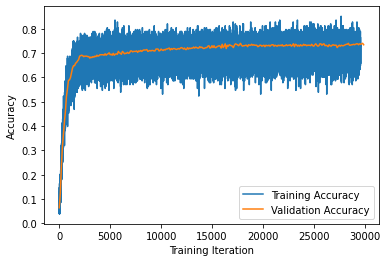

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()